In [28]:
import pandas as pd
import keras
import numpy as np

# Import CIFAR 10 dataset
from keras.datasets import cifar10

from keras.preprocessing.image import ImageDataGenerator

# Import Necessary CNN Building Blocks
from keras.models import Sequential, Model
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Activation, Dropout, MaxPool2D, BatchNormalization, GlobalAveragePooling2D, UpSampling2D
from keras.layers.advanced_activations import LeakyReLU

from keras import backend as K
from keras import applications
from keras import callbacks
from keras import optimizers
from keras.utils import np_utils
import random

import tensorflow as tf
import tensorflow_addons as tfa

from sklearn.metrics import classification_report, confusion_matrix
from tensorflow.keras.callbacks import EarlyStopping

In [2]:
# Requirements:
# !pip install keras
# !pip install tensorflow
# !pip install keras
# !pip install tensorflow_addons

# TODO: data augmentation validation

## Data

In [56]:
# Load Dataset
(X_train, y_train), (X_test, y_test) = cifar10.load_data()

BATCH_SIZE = 32
INPUT_SHAPE = X_train.shape[1:]

print('x_train shape:', X_train.shape)
print('y_train shape:', y_train.shape)
print(X_train.shape[0], 'train samples')
print(X_test.shape[0], 'test samples')

x_train shape: (50000, 32, 32, 3)
y_train shape: (50000, 1)
50000 train samples
10000 test samples


## Fitting the Deep Learning Models

### Custom Models

In [57]:
# Normalize input data
X_train = X_train.astype('float32')/255
X_test = X_test.astype('float32')/255

# Convert class labels to one-hot encoded
y_train = keras.utils.np_utils.to_categorical(y_train, 10)
y_test = keras.utils.np_utils.to_categorical(y_test, 10)

In [58]:
tqdm_callback = tfa.callbacks.TQDMProgressBar()

LR=3e-3 # 1e-4
EPOCHS=30  # 200

In [59]:
# # Scheduler of learning rate (decay with epochs)
# def lrScheduler(epoch):
#     return LR * 0.9 ** epoch

In [60]:
# Data augmentation - 2 different approaches

# whitening + rotation 30 + zoom 0.2 + shift 0.2
# flipping (v,h) + zoom 0.1 + shift 0.1

datagen1 = ImageDataGenerator(
    zca_epsilon=1e-06, # whitening
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    zoom_range=0.2
)
datagen1.fit(X_train)

datagen2 = ImageDataGenerator(
    width_shift_range=0.1,
    height_shift_range=0.1,
    zoom_range=0.1,
    horizontal_flip=True,
    vertical_flip=True
)
datagen2.fit(X_train)

#### Model concept no. 1

In [61]:
def generate_model1():

    model = Sequential()

    model.add(Conv2D(filters = 16, kernel_size = (3, 3), padding='same', input_shape=INPUT_SHAPE))
    model.add(LeakyReLU(0.1))
    model.add(Conv2D(filters = 32, kernel_size = (3, 3), padding='same'))
    model.add(LeakyReLU(0.1))
    model.add(MaxPooling2D((2, 2)))
    model.add(Dropout(0.25))
    model.add(Conv2D(filters = 32, kernel_size = (3, 3), padding='same'))
    model.add(LeakyReLU(0.1))
    model.add(Conv2D(filters = 64, kernel_size = (3, 3), padding='same'))
    model.add(LeakyReLU(0.1))
    model.add(MaxPooling2D((2, 2)))
    model.add(Dropout(0.25))
    model.add(Flatten())
    model.add(Dense(256))
    model.add(LeakyReLU(0.1))
    model.add(Dropout(0.5))
    model.add(Dense(10))
    model.add(Activation("softmax"))
    
    # model.summary()
    model.compile(
        loss='categorical_crossentropy',  
        optimizer=tf.keras.optimizers.Adam(learning_rate=LR, decay=1e-6), 
        metrics=['accuracy']
    )
    
    return model

In [62]:
model1 = generate_model1()
model1.summary()

Model: "sequential_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_80 (Conv2D)          (None, 32, 32, 16)        448       
                                                                 
 leaky_re_lu_100 (LeakyReLU)  (None, 32, 32, 16)       0         
                                                                 
 conv2d_81 (Conv2D)          (None, 32, 32, 32)        4640      
                                                                 
 leaky_re_lu_101 (LeakyReLU)  (None, 32, 32, 32)       0         
                                                                 
 max_pooling2d_40 (MaxPoolin  (None, 16, 16, 32)       0         
 g2D)                                                            
                                                                 
 dropout_60 (Dropout)        (None, 16, 16, 32)        0         
                                                     

In [63]:
model1_history = (
    model1.fit(
    X_train,
    y_train,
    batch_size=BATCH_SIZE,
    epochs=EPOCHS,
    callbacks=[#keras.callbacks.LearningRateScheduler(lrScheduler), 
               tqdm_callback,],
    shuffle=True,
    verbose=1,
    validation_data=(X_test, y_test)
    )
) # 3 epoki - 3min 15s


Training:   0%|                                         0/30 ETA: ?s,  ?epochs/s

Epoch 1/30




0/1563                                                                ETA: ?s - 

Epoch 1/30




1/1563                             ETA: 20:48s - loss: 2.3421 - accuracy: 0.0938

   3/1563 [..............................] - ETA: 45s - loss: 2.3958 - accuracy: 0.1250  



5/1563                             ETA: 03:46s - loss: 2.3846 - accuracy: 0.1147

   7/1563 [..............................] - ETA: 46s - loss: 2.3562 - accuracy: 0.0893



9/1563▏                            ETA: 02:07s - loss: 2.3694 - accuracy: 0.1046

  11/1563 [..............................] - ETA: 45s - loss: 2.3252 - accuracy: 0.0909



13/1563▏                           ETA: 01:30s - loss: 2.3566 - accuracy: 0.1006

  15/1563 [..............................] - ETA: 45s - loss: 2.3017 - accuracy: 0.1083



17/1563▎                           ETA: 01:12s - loss: 2.3439 - accuracy: 0.1023

  19/1563 [..............................] - ETA: 45s - loss: 2.2800 - accuracy: 0.1217



21/1563▎                           ETA: 01:02s - loss: 2.3317 - accuracy: 0.1056

  23/1563 [..............................] - ETA: 45s - loss: 2.2733 - accuracy: 0.1264



25/1563▍                           ETA: 00:57s - loss: 2.3224 - accuracy: 0.1089

  27/1563 [..............................] - ETA: 45s - loss: 2.2671 - accuracy: 0.1273



29/1563▌                           ETA: 00:53s - loss: 2.3148 - accuracy: 0.1114

  31/1563 [..............................] - ETA: 45s - loss: 2.2633 - accuracy: 0.1290



33/1563▌                           ETA: 00:50s - loss: 2.3084 - accuracy: 0.1136

  35/1563 [..............................] - ETA: 44s - loss: 2.2543 - accuracy: 0.1411



37/1563▋                           ETA: 00:48s - loss: 2.3023 - accuracy: 0.1168

  39/1563 [..............................] - ETA: 44s - loss: 2.2438 - accuracy: 0.1458



41/1563▋                           ETA: 00:46s - loss: 2.2962 - accuracy: 0.1200

  43/1563 [..............................] - ETA: 44s - loss: 2.2176 - accuracy: 0.1657



45/1563▊                           ETA: 00:45s - loss: 2.2891 - accuracy: 0.1241

  47/1563 [..............................] - ETA: 44s - loss: 2.2083 - accuracy: 0.1715



49/1563▊                           ETA: 00:45s - loss: 2.2827 - accuracy: 0.1278

  51/1563 [..............................] - ETA: 44s - loss: 2.1996 - accuracy: 0.1759



53/1563▉                           ETA: 00:44s - loss: 2.2764 - accuracy: 0.1315

  55/1563 [>.............................] - ETA: 44s - loss: 2.1919 - accuracy: 0.1784



57/1563▉                           ETA: 00:44s - loss: 2.2704 - accuracy: 0.1348

  59/1563 [>.............................] - ETA: 43s - loss: 2.1867 - accuracy: 0.1774



61/1563█                           ETA: 00:43s - loss: 2.2650 - accuracy: 0.1376

  63/1563 [>.............................] - ETA: 43s - loss: 2.1796 - accuracy: 0.1801



65/1563█                           ETA: 00:42s - loss: 2.2596 - accuracy: 0.1402

  67/1563 [>.............................] - ETA: 43s - loss: 2.1722 - accuracy: 0.1861



69/1563█▏                          ETA: 00:41s - loss: 2.2545 - accuracy: 0.1429

  71/1563 [>.............................] - ETA: 43s - loss: 2.1636 - accuracy: 0.1941



73/1563█▎                          ETA: 00:41s - loss: 2.2495 - accuracy: 0.1457

  75/1563 [>.............................] - ETA: 42s - loss: 2.1526 - accuracy: 0.1963



77/1563█▎                          ETA: 00:40s - loss: 2.2445 - accuracy: 0.1484

  79/1563 [>.............................] - ETA: 42s - loss: 2.1458 - accuracy: 0.2033



81/1563█▍                          ETA: 00:40s - loss: 2.2394 - accuracy: 0.1511

  83/1563 [>.............................] - ETA: 42s - loss: 2.1346 - accuracy: 0.2063



85/1563█▍                          ETA: 00:40s - loss: 2.2344 - accuracy: 0.1538

  87/1563 [>.............................] - ETA: 42s - loss: 2.1284 - accuracy: 0.2098



89/1563█▌                          ETA: 00:42s - loss: 2.2295 - accuracy: 0.1564

  91/1563 [>.............................] - ETA: 42s - loss: 2.1176 - accuracy: 0.2139



93/1563█▌                          ETA: 00:42s - loss: 2.2246 - accuracy: 0.1589

  95/1563 [>.............................] - ETA: 42s - loss: 2.1116 - accuracy: 0.2161



97/1563█▋                          ETA: 00:42s - loss: 2.2199 - accuracy: 0.1613

  99/1563 [>.............................] - ETA: 42s - loss: 2.1045 - accuracy: 0.2200



101/1563█▋                         ETA: 00:43s - loss: 2.2153 - accuracy: 0.1636

 103/1563 [>.............................] - ETA: 42s - loss: 2.1007 - accuracy: 0.2206



105/1563█▋                         ETA: 00:44s - loss: 2.2109 - accuracy: 0.1658

 111/1563 [=>............................] - ETA: 42s - loss: 2.0897 - accuracy: 0.2244



112/1563█▊                         ETA: 00:44s - loss: 2.2035 - accuracy: 0.1694

 115/1563 [=>............................] - ETA: 42s - loss: 2.0855 - accuracy: 0.2277



116/1563█▉                         ETA: 00:45s - loss: 2.1995 - accuracy: 0.1714

 119/1563 [=>............................] - ETA: 42s - loss: 2.0789 - accuracy: 0.2293



120/1563█▉                         ETA: 00:45s - loss: 2.1955 - accuracy: 0.1733

 123/1563 [=>............................] - ETA: 42s - loss: 2.0695 - accuracy: 0.2335



124/1563██                         ETA: 00:45s - loss: 2.1915 - accuracy: 0.1752

 127/1563 [=>............................] - ETA: 42s - loss: 2.0632 - accuracy: 0.2360



128/1563██▏                        ETA: 00:45s - loss: 2.1875 - accuracy: 0.1771

 131/1563 [=>............................] - ETA: 42s - loss: 2.0546 - accuracy: 0.2378



132/1563██▏                        ETA: 00:45s - loss: 2.1835 - accuracy: 0.1789

 135/1563 [=>............................] - ETA: 42s - loss: 2.0485 - accuracy: 0.2380



136/1563██▎                        ETA: 00:45s - loss: 2.1796 - accuracy: 0.1806

 139/1563 [=>............................] - ETA: 42s - loss: 2.0391 - accuracy: 0.2412



140/1563██▎                        ETA: 00:45s - loss: 2.1756 - accuracy: 0.1824

 145/1563 [=>............................] - ETA: 42s - loss: 2.0285 - accuracy: 0.2446



147/1563██▍                        ETA: 00:44s - loss: 2.1687 - accuracy: 0.1853

 149/1563 [=>............................] - ETA: 42s - loss: 2.0253 - accuracy: 0.2456



151/1563██▌                        ETA: 00:45s - loss: 2.1649 - accuracy: 0.1869

 153/1563 [=>............................] - ETA: 42s - loss: 2.0177 - accuracy: 0.2494



155/1563██▌                        ETA: 00:43s - loss: 2.1610 - accuracy: 0.1886

 161/1563 [==>...........................] - ETA: 41s - loss: 2.0086 - accuracy: 0.2533



162/1563██▋                        ETA: 00:42s - loss: 2.1546 - accuracy: 0.1913

 167/1563 [==>...........................] - ETA: 41s - loss: 2.0006 - accuracy: 0.2579



169/1563██▊                        ETA: 00:43s - loss: 2.1482 - accuracy: 0.1940

 171/1563 [==>...........................] - ETA: 41s - loss: 1.9935 - accuracy: 0.2611



173/1563██▉                        ETA: 00:42s - loss: 2.1446 - accuracy: 0.1956

 175/1563 [==>...........................] - ETA: 41s - loss: 1.9879 - accuracy: 0.2625



177/1563██▉                        ETA: 00:42s - loss: 2.1411 - accuracy: 0.1971

 179/1563 [==>...........................] - ETA: 41s - loss: 1.9835 - accuracy: 0.2640



181/1563███                        ETA: 00:42s - loss: 2.1376 - accuracy: 0.1986

 183/1563 [==>...........................] - ETA: 41s - loss: 1.9781 - accuracy: 0.2662



185/1563███                        ETA: 00:42s - loss: 2.1341 - accuracy: 0.2000

 187/1563 [==>...........................] - ETA: 41s - loss: 1.9754 - accuracy: 0.2667



189/1563███▏                       ETA: 00:42s - loss: 2.1308 - accuracy: 0.2014

 191/1563 [==>...........................] - ETA: 41s - loss: 1.9706 - accuracy: 0.2678



193/1563███▏                       ETA: 00:42s - loss: 2.1274 - accuracy: 0.2028

 195/1563 [==>...........................] - ETA: 41s - loss: 1.9636 - accuracy: 0.2696



197/1563███▎                       ETA: 00:42s - loss: 2.1241 - accuracy: 0.2042

 199/1563 [==>...........................] - ETA: 41s - loss: 1.9574 - accuracy: 0.2718



201/1563███▎                       ETA: 00:42s - loss: 2.1208 - accuracy: 0.2055

 203/1563 [==>...........................] - ETA: 40s - loss: 1.9519 - accuracy: 0.2736



205/1563███▍                       ETA: 00:42s - loss: 2.1175 - accuracy: 0.2069

 207/1563 [==>...........................] - ETA: 40s - loss: 1.9464 - accuracy: 0.2766



209/1563███▍                       ETA: 00:41s - loss: 2.1142 - accuracy: 0.2082

 211/1563 [===>..........................] - ETA: 40s - loss: 1.9422 - accuracy: 0.2799



213/1563███▌                       ETA: 00:41s - loss: 2.1109 - accuracy: 0.2096

 215/1563 [===>..........................] - ETA: 40s - loss: 1.9367 - accuracy: 0.2823



217/1563███▌                       ETA: 00:41s - loss: 2.1077 - accuracy: 0.2109

 219/1563 [===>..........................] - ETA: 40s - loss: 1.9318 - accuracy: 0.2847



221/1563███▋                       ETA: 00:41s - loss: 2.1045 - accuracy: 0.2123

 227/1563 [===>..........................] - ETA: 40s - loss: 1.9241 - accuracy: 0.2872



228/1563███▊                       ETA: 00:40s - loss: 2.0990 - accuracy: 0.2145

 231/1563 [===>..........................] - ETA: 40s - loss: 1.9208 - accuracy: 0.2880



232/1563███▊                       ETA: 00:41s - loss: 2.0959 - accuracy: 0.2158

 237/1563 [===>..........................] - ETA: 40s - loss: 1.9192 - accuracy: 0.2889



239/1563███▉                       ETA: 00:41s - loss: 2.0908 - accuracy: 0.2179

 241/1563 [===>..........................] - ETA: 40s - loss: 1.9174 - accuracy: 0.2885



243/1563████                       ETA: 00:41s - loss: 2.0879 - accuracy: 0.2191

 245/1563 [===>..........................] - ETA: 39s - loss: 1.9149 - accuracy: 0.2892



247/1563████                       ETA: 00:41s - loss: 2.0851 - accuracy: 0.2202

 249/1563 [===>..........................] - ETA: 39s - loss: 1.9107 - accuracy: 0.2905



251/1563████▏                      ETA: 00:41s - loss: 2.0823 - accuracy: 0.2214

 253/1563 [===>..........................] - ETA: 39s - loss: 1.9073 - accuracy: 0.2927



255/1563████▏                      ETA: 00:41s - loss: 2.0796 - accuracy: 0.2225

 257/1563 [===>..........................] - ETA: 39s - loss: 1.9033 - accuracy: 0.2949



259/1563████▎                      ETA: 00:40s - loss: 2.0768 - accuracy: 0.2236

 261/1563 [====>.........................] - ETA: 39s - loss: 1.8993 - accuracy: 0.2969



263/1563████▎                      ETA: 00:40s - loss: 2.0741 - accuracy: 0.2247

 269/1563 [====>.........................] - ETA: 39s - loss: 1.8912 - accuracy: 0.3000



270/1563████▍                      ETA: 00:41s - loss: 2.0694 - accuracy: 0.2267

 273/1563 [====>.........................] - ETA: 39s - loss: 1.8899 - accuracy: 0.3004



274/1563████▌                      ETA: 00:41s - loss: 2.0668 - accuracy: 0.2277

 277/1563 [====>.........................] - ETA: 39s - loss: 1.8878 - accuracy: 0.3011



278/1563████▌                      ETA: 00:41s - loss: 2.0642 - accuracy: 0.2288

 283/1563 [====>.........................] - ETA: 39s - loss: 1.8836 - accuracy: 0.3033



285/1563████▋                      ETA: 00:39s - loss: 2.0598 - accuracy: 0.2306

 287/1563 [====>.........................] - ETA: 38s - loss: 1.8812 - accuracy: 0.3040



289/1563████▊                      ETA: 00:38s - loss: 2.0574 - accuracy: 0.2316

 291/1563 [====>.........................] - ETA: 38s - loss: 1.8796 - accuracy: 0.3053



293/1563████▊                      ETA: 00:37s - loss: 2.0549 - accuracy: 0.2326

 295/1563 [====>.........................] - ETA: 38s - loss: 1.8783 - accuracy: 0.3053



297/1563████▉                      ETA: 00:36s - loss: 2.0526 - accuracy: 0.2336

 303/1563 [====>.........................] - ETA: 38s - loss: 1.8734 - accuracy: 0.3075



304/1563█████                      ETA: 00:38s - loss: 2.0484 - accuracy: 0.2353

 309/1563 [====>.........................] - ETA: 38s - loss: 1.8702 - accuracy: 0.3082



311/1563█████▏                     ETA: 00:38s - loss: 2.0444 - accuracy: 0.2370

 317/1563 [=====>........................] - ETA: 37s - loss: 1.8644 - accuracy: 0.3102



318/1563█████▎                     ETA: 00:38s - loss: 2.0405 - accuracy: 0.2386

 323/1563 [=====>........................] - ETA: 37s - loss: 1.8649 - accuracy: 0.3101



325/1563█████▍                     ETA: 00:37s - loss: 2.0367 - accuracy: 0.2401

 327/1563 [=====>........................] - ETA: 37s - loss: 1.8636 - accuracy: 0.3114



329/1563█████▍                     ETA: 00:37s - loss: 2.0346 - accuracy: 0.2410

 331/1563 [=====>........................] - ETA: 37s - loss: 1.8623 - accuracy: 0.3119



333/1563█████▌                     ETA: 00:37s - loss: 2.0325 - accuracy: 0.2418

 335/1563 [=====>........................] - ETA: 37s - loss: 1.8593 - accuracy: 0.3131



337/1563█████▌                     ETA: 00:37s - loss: 2.0305 - accuracy: 0.2427

 343/1563 [=====>........................] - ETA: 37s - loss: 1.8544 - accuracy: 0.3146



344/1563█████▋                     ETA: 00:38s - loss: 2.0269 - accuracy: 0.2441

 347/1563 [=====>........................] - ETA: 37s - loss: 1.8538 - accuracy: 0.3154



348/1563█████▊                     ETA: 00:38s - loss: 2.0249 - accuracy: 0.2449

 351/1563 [=====>........................] - ETA: 36s - loss: 1.8509 - accuracy: 0.3164



352/1563█████▊                     ETA: 00:38s - loss: 2.0230 - accuracy: 0.2458

 357/1563 [=====>........................] - ETA: 36s - loss: 1.8472 - accuracy: 0.3177



359/1563█████▉                     ETA: 00:38s - loss: 2.0195 - accuracy: 0.2472

 361/1563 [=====>........................] - ETA: 36s - loss: 1.8443 - accuracy: 0.3179



363/1563██████                     ETA: 00:37s - loss: 2.0176 - accuracy: 0.2479

 365/1563 [======>.......................] - ETA: 36s - loss: 1.8430 - accuracy: 0.3182



367/1563██████                     ETA: 00:37s - loss: 2.0157 - accuracy: 0.2487

 369/1563 [======>.......................] - ETA: 36s - loss: 1.8397 - accuracy: 0.3199



371/1563██████▏                    ETA: 00:36s - loss: 2.0138 - accuracy: 0.2495

 377/1563 [======>.......................] - ETA: 36s - loss: 1.8340 - accuracy: 0.3228



378/1563██████▎                    ETA: 00:36s - loss: 2.0105 - accuracy: 0.2508

 381/1563 [======>.......................] - ETA: 36s - loss: 1.8336 - accuracy: 0.3234



382/1563██████▎                    ETA: 00:37s - loss: 2.0086 - accuracy: 0.2516

 385/1563 [======>.......................] - ETA: 36s - loss: 1.8321 - accuracy: 0.3244



386/1563██████▍                    ETA: 00:37s - loss: 2.0068 - accuracy: 0.2523

 391/1563 [======>.......................] - ETA: 35s - loss: 1.8283 - accuracy: 0.3256



393/1563██████▌                    ETA: 00:36s - loss: 2.0036 - accuracy: 0.2536

 395/1563 [======>.......................] - ETA: 35s - loss: 1.8271 - accuracy: 0.3265



397/1563██████▌                    ETA: 00:36s - loss: 2.0018 - accuracy: 0.2544

 399/1563 [======>.......................] - ETA: 35s - loss: 1.8237 - accuracy: 0.3278



401/1563██████▋                    ETA: 00:36s - loss: 2.0001 - accuracy: 0.2551

 407/1563 [======>.......................] - ETA: 35s - loss: 1.8185 - accuracy: 0.3303



408/1563██████▊                    ETA: 00:36s - loss: 1.9970 - accuracy: 0.2564

 413/1563 [======>.......................] - ETA: 35s - loss: 1.8164 - accuracy: 0.3306



415/1563██████▉                    ETA: 00:35s - loss: 1.9939 - accuracy: 0.2576

 417/1563 [=======>......................] - ETA: 35s - loss: 1.8147 - accuracy: 0.3312



419/1563██████▉                    ETA: 00:35s - loss: 1.9922 - accuracy: 0.2583

 425/1563 [=======>......................] - ETA: 34s - loss: 1.8110 - accuracy: 0.3320



426/1563███████                    ETA: 00:35s - loss: 1.9893 - accuracy: 0.2595

 431/1563 [=======>......................] - ETA: 34s - loss: 1.8078 - accuracy: 0.3334



433/1563███████▏                   ETA: 00:35s - loss: 1.9863 - accuracy: 0.2607

 435/1563 [=======>......................] - ETA: 34s - loss: 1.8052 - accuracy: 0.3344



437/1563███████▎                   ETA: 00:35s - loss: 1.9847 - accuracy: 0.2614

 439/1563 [=======>......................] - ETA: 34s - loss: 1.8013 - accuracy: 0.3358



441/1563███████▎                   ETA: 00:34s - loss: 1.9830 - accuracy: 0.2621

 443/1563 [=======>......................] - ETA: 34s - loss: 1.8014 - accuracy: 0.3363



445/1563███████▍                   ETA: 00:34s - loss: 1.9814 - accuracy: 0.2628

 447/1563 [=======>......................] - ETA: 34s - loss: 1.7998 - accuracy: 0.3370



449/1563███████▍                   ETA: 00:34s - loss: 1.9797 - accuracy: 0.2634

 451/1563 [=======>......................] - ETA: 34s - loss: 1.7985 - accuracy: 0.3379



453/1563███████▌                   ETA: 00:34s - loss: 1.9781 - accuracy: 0.2641

 455/1563 [=======>......................] - ETA: 33s - loss: 1.7958 - accuracy: 0.3391



457/1563███████▌                   ETA: 00:34s - loss: 1.9765 - accuracy: 0.2647

 459/1563 [=======>......................] - ETA: 33s - loss: 1.7939 - accuracy: 0.3400



461/1563███████▋                   ETA: 00:33s - loss: 1.9750 - accuracy: 0.2654

 463/1563 [=======>......................] - ETA: 33s - loss: 1.7923 - accuracy: 0.3403



465/1563███████▋                   ETA: 00:33s - loss: 1.9734 - accuracy: 0.2660

 467/1563 [=======>......................] - ETA: 33s - loss: 1.7897 - accuracy: 0.3411



469/1563███████▊                   ETA: 00:33s - loss: 1.9718 - accuracy: 0.2667

 471/1563 [========>.....................] - ETA: 33s - loss: 1.7878 - accuracy: 0.3422



473/1563███████▊                   ETA: 00:32s - loss: 1.9703 - accuracy: 0.2673

 479/1563 [========>.....................] - ETA: 33s - loss: 1.7829 - accuracy: 0.3445



480/1563███████▉                   ETA: 00:33s - loss: 1.9675 - accuracy: 0.2684

 485/1563 [========>.....................] - ETA: 33s - loss: 1.7799 - accuracy: 0.3457



486/1563████████                   ETA: 00:34s - loss: 1.9652 - accuracy: 0.2694

 491/1563 [========>.....................] - ETA: 32s - loss: 1.7767 - accuracy: 0.3469



492/1563████████▏                  ETA: 00:35s - loss: 1.9629 - accuracy: 0.2703

 497/1563 [========>.....................] - ETA: 32s - loss: 1.7721 - accuracy: 0.3486



499/1563████████▎                  ETA: 00:34s - loss: 1.9603 - accuracy: 0.2714

 503/1563 [========>.....................] - ETA: 32s - loss: 1.7703 - accuracy: 0.3492



505/1563████████▍                  ETA: 00:35s - loss: 1.9580 - accuracy: 0.2723

 511/1563 [========>.....................] - ETA: 32s - loss: 1.7668 - accuracy: 0.3501



512/1563████████▌                  ETA: 00:35s - loss: 1.9554 - accuracy: 0.2734

 517/1563 [========>.....................] - ETA: 32s - loss: 1.7634 - accuracy: 0.3519



518/1563████████▌                  ETA: 00:35s - loss: 1.9532 - accuracy: 0.2743

 519/1563 [========>.....................] - ETA: 32s - loss: 1.7627 - accuracy: 0.3524



521/1563████████▋                  ETA: 00:35s - loss: 1.9521 - accuracy: 0.2748

 523/1563 [=========>....................] - ETA: 32s - loss: 1.7609 - accuracy: 0.3531



525/1563████████▋                  ETA: 00:34s - loss: 1.9507 - accuracy: 0.2753

 527/1563 [=========>....................] - ETA: 32s - loss: 1.7603 - accuracy: 0.3531



529/1563████████▊                  ETA: 00:33s - loss: 1.9492 - accuracy: 0.2759

 531/1563 [=========>....................] - ETA: 31s - loss: 1.7580 - accuracy: 0.3542



533/1563████████▊                  ETA: 00:33s - loss: 1.9478 - accuracy: 0.2765

 535/1563 [=========>....................] - ETA: 31s - loss: 1.7567 - accuracy: 0.3547



537/1563████████▉                  ETA: 00:33s - loss: 1.9463 - accuracy: 0.2771

 539/1563 [=========>....................] - ETA: 31s - loss: 1.7548 - accuracy: 0.3553



541/1563████████▉                  ETA: 00:32s - loss: 1.9449 - accuracy: 0.2777

 543/1563 [=========>....................] - ETA: 31s - loss: 1.7530 - accuracy: 0.3564



545/1563█████████                  ETA: 00:32s - loss: 1.9435 - accuracy: 0.2783

 547/1563 [=========>....................] - ETA: 31s - loss: 1.7508 - accuracy: 0.3575



549/1563█████████▏                 ETA: 00:32s - loss: 1.9421 - accuracy: 0.2788

 553/1563 [=========>....................] - ETA: 31s - loss: 1.7500 - accuracy: 0.3574



555/1563█████████▏                 ETA: 00:34s - loss: 1.9400 - accuracy: 0.2797

 557/1563 [=========>....................] - ETA: 31s - loss: 1.7480 - accuracy: 0.3583



559/1563█████████▎                 ETA: 00:33s - loss: 1.9387 - accuracy: 0.2803

 565/1563 [=========>....................] - ETA: 31s - loss: 1.7450 - accuracy: 0.3597



566/1563█████████▍                 ETA: 00:32s - loss: 1.9363 - accuracy: 0.2812

 569/1563 [=========>....................] - ETA: 30s - loss: 1.7430 - accuracy: 0.3607



570/1563█████████▍                 ETA: 00:32s - loss: 1.9349 - accuracy: 0.2818

 575/1563 [==========>...................] - ETA: 30s - loss: 1.7412 - accuracy: 0.3616



577/1563█████████▌                 ETA: 00:31s - loss: 1.9326 - accuracy: 0.2828

 579/1563 [==========>...................] - ETA: 30s - loss: 1.7393 - accuracy: 0.3621



581/1563█████████▋                 ETA: 00:31s - loss: 1.9312 - accuracy: 0.2833

 583/1563 [==========>...................] - ETA: 30s - loss: 1.7365 - accuracy: 0.3632



585/1563█████████▋                 ETA: 00:31s - loss: 1.9299 - accuracy: 0.2839

 591/1563 [==========>...................] - ETA: 30s - loss: 1.7315 - accuracy: 0.3650



592/1563█████████▊                 ETA: 00:30s - loss: 1.9276 - accuracy: 0.2848

 595/1563 [==========>...................] - ETA: 30s - loss: 1.7305 - accuracy: 0.3657



596/1563█████████▉                 ETA: 00:30s - loss: 1.9263 - accuracy: 0.2854

 601/1563 [==========>...................] - ETA: 29s - loss: 1.7282 - accuracy: 0.3663



603/1563██████████                 ETA: 00:30s - loss: 1.9240 - accuracy: 0.2863

 605/1563 [==========>...................] - ETA: 29s - loss: 1.7277 - accuracy: 0.3665



607/1563██████████                 ETA: 00:30s - loss: 1.9227 - accuracy: 0.2868

 609/1563 [==========>...................] - ETA: 29s - loss: 1.7258 - accuracy: 0.3676



611/1563██████████▏                ETA: 00:29s - loss: 1.9214 - accuracy: 0.2874

 617/1563 [==========>...................] - ETA: 29s - loss: 1.7215 - accuracy: 0.3688



618/1563██████████▎                ETA: 00:29s - loss: 1.9191 - accuracy: 0.2883

 621/1563 [==========>...................] - ETA: 29s - loss: 1.7205 - accuracy: 0.3693



622/1563██████████▎                ETA: 00:29s - loss: 1.9178 - accuracy: 0.2888

 625/1563 [==========>...................] - ETA: 29s - loss: 1.7183 - accuracy: 0.3701



626/1563██████████▍                ETA: 00:29s - loss: 1.9166 - accuracy: 0.2893

 631/1563 [===========>..................] - ETA: 29s - loss: 1.7174 - accuracy: 0.3704



633/1563██████████▌                ETA: 00:29s - loss: 1.9144 - accuracy: 0.2902

 635/1563 [===========>..................] - ETA: 28s - loss: 1.7159 - accuracy: 0.3710



637/1563██████████▌                ETA: 00:29s - loss: 1.9131 - accuracy: 0.2907

 639/1563 [===========>..................] - ETA: 28s - loss: 1.7152 - accuracy: 0.3712



641/1563██████████▋                ETA: 00:29s - loss: 1.9119 - accuracy: 0.2912

 643/1563 [===========>..................] - ETA: 28s - loss: 1.7136 - accuracy: 0.3718



645/1563██████████▋                ETA: 00:28s - loss: 1.9107 - accuracy: 0.2917

 651/1563 [===========>..................] - ETA: 28s - loss: 1.7097 - accuracy: 0.3732



652/1563██████████▊                ETA: 00:28s - loss: 1.9085 - accuracy: 0.2926

 655/1563 [===========>..................] - ETA: 28s - loss: 1.7090 - accuracy: 0.3738



656/1563██████████▉                ETA: 00:28s - loss: 1.9073 - accuracy: 0.2931

 659/1563 [===========>..................] - ETA: 28s - loss: 1.7070 - accuracy: 0.3742



660/1563██████████▉                ETA: 00:28s - loss: 1.9061 - accuracy: 0.2936

 663/1563 [===========>..................] - ETA: 28s - loss: 1.7052 - accuracy: 0.3750



664/1563███████████                ETA: 00:28s - loss: 1.9049 - accuracy: 0.2941

 669/1563 [===========>..................] - ETA: 27s - loss: 1.7019 - accuracy: 0.3765



671/1563███████████▏               ETA: 00:28s - loss: 1.9028 - accuracy: 0.2949

 673/1563 [===========>..................] - ETA: 27s - loss: 1.7023 - accuracy: 0.3763



675/1563███████████▏               ETA: 00:28s - loss: 1.9016 - accuracy: 0.2954

 681/1563 [============>.................] - ETA: 27s - loss: 1.7009 - accuracy: 0.3771



682/1563███████████▎               ETA: 00:27s - loss: 1.8995 - accuracy: 0.2962

 685/1563 [============>.................] - ETA: 27s - loss: 1.6992 - accuracy: 0.3778



686/1563███████████▍               ETA: 00:27s - loss: 1.8983 - accuracy: 0.2967

 689/1563 [============>.................] - ETA: 27s - loss: 1.6977 - accuracy: 0.3784



690/1563███████████▍               ETA: 00:27s - loss: 1.8972 - accuracy: 0.2972

 693/1563 [============>.................] - ETA: 27s - loss: 1.6966 - accuracy: 0.3788



694/1563███████████▌               ETA: 00:27s - loss: 1.8960 - accuracy: 0.2977

 697/1563 [============>.................] - ETA: 26s - loss: 1.6943 - accuracy: 0.3794



698/1563███████████▌               ETA: 00:27s - loss: 1.8949 - accuracy: 0.2981

 701/1563 [============>.................] - ETA: 26s - loss: 1.6932 - accuracy: 0.3803



702/1563███████████▋               ETA: 00:27s - loss: 1.8937 - accuracy: 0.2986

 705/1563 [============>.................] - ETA: 26s - loss: 1.6927 - accuracy: 0.3805



706/1563███████████▋               ETA: 00:27s - loss: 1.8926 - accuracy: 0.2991

 711/1563 [============>.................] - ETA: 26s - loss: 1.6909 - accuracy: 0.3812



713/1563███████████▊               ETA: 00:26s - loss: 1.8906 - accuracy: 0.2999

 715/1563 [============>.................] - ETA: 26s - loss: 1.6894 - accuracy: 0.3817



717/1563███████████▉               ETA: 00:26s - loss: 1.8895 - accuracy: 0.3003

 719/1563 [============>.................] - ETA: 26s - loss: 1.6873 - accuracy: 0.3826



721/1563███████████▉               ETA: 00:25s - loss: 1.8884 - accuracy: 0.3008

 723/1563 [============>.................] - ETA: 26s - loss: 1.6859 - accuracy: 0.3830



725/1563████████████               ETA: 00:25s - loss: 1.8872 - accuracy: 0.3012

 727/1563 [============>.................] - ETA: 26s - loss: 1.6844 - accuracy: 0.3835



729/1563████████████▏              ETA: 00:25s - loss: 1.8861 - accuracy: 0.3017

 731/1563 [=============>................] - ETA: 25s - loss: 1.6832 - accuracy: 0.3839



733/1563████████████▏              ETA: 00:25s - loss: 1.8850 - accuracy: 0.3021

 735/1563 [=============>................] - ETA: 25s - loss: 1.6820 - accuracy: 0.3844



737/1563████████████▎              ETA: 00:25s - loss: 1.8839 - accuracy: 0.3026

 739/1563 [=============>................] - ETA: 25s - loss: 1.6812 - accuracy: 0.3849



741/1563████████████▎              ETA: 00:25s - loss: 1.8828 - accuracy: 0.3030

 747/1563 [=============>................] - ETA: 25s - loss: 1.6785 - accuracy: 0.3866



748/1563████████████▍              ETA: 00:25s - loss: 1.8809 - accuracy: 0.3038

 753/1563 [=============>................] - ETA: 25s - loss: 1.6765 - accuracy: 0.3872



755/1563████████████▌              ETA: 00:25s - loss: 1.8790 - accuracy: 0.3046

 757/1563 [=============>................] - ETA: 25s - loss: 1.6752 - accuracy: 0.3878



759/1563████████████▋              ETA: 00:25s - loss: 1.8779 - accuracy: 0.3050

 765/1563 [=============>................] - ETA: 24s - loss: 1.6738 - accuracy: 0.3885



766/1563████████████▋              ETA: 00:25s - loss: 1.8761 - accuracy: 0.3058

 771/1563 [=============>................] - ETA: 24s - loss: 1.6727 - accuracy: 0.3890



773/1563████████████▊              ETA: 00:25s - loss: 1.8742 - accuracy: 0.3065

 775/1563 [=============>................] - ETA: 24s - loss: 1.6709 - accuracy: 0.3899



777/1563████████████▉              ETA: 00:25s - loss: 1.8732 - accuracy: 0.3070

 779/1563 [=============>................] - ETA: 24s - loss: 1.6692 - accuracy: 0.3904



781/1563████████████▉              ETA: 00:24s - loss: 1.8722 - accuracy: 0.3074

 784/1563 [==============>...............] - ETA: 24s - loss: 1.6678 - accuracy: 0.3910



785/1563█████████████              ETA: 00:22s - loss: 1.8711 - accuracy: 0.3078

 788/1563 [==============>...............] - ETA: 24s - loss: 1.6661 - accuracy: 0.3917



789/1563█████████████              ETA: 00:22s - loss: 1.8701 - accuracy: 0.3082

 792/1563 [==============>...............] - ETA: 23s - loss: 1.6656 - accuracy: 0.3917



793/1563█████████████▏             ETA: 00:22s - loss: 1.8690 - accuracy: 0.3087

 796/1563 [==============>...............] - ETA: 23s - loss: 1.6643 - accuracy: 0.3922



797/1563█████████████▎             ETA: 00:21s - loss: 1.8680 - accuracy: 0.3091

 800/1563 [==============>...............] - ETA: 23s - loss: 1.6622 - accuracy: 0.3927



801/1563█████████████▎             ETA: 00:21s - loss: 1.8670 - accuracy: 0.3095

 804/1563 [==============>...............] - ETA: 23s - loss: 1.6607 - accuracy: 0.3933



805/1563█████████████▍             ETA: 00:20s - loss: 1.8660 - accuracy: 0.3099

 808/1563 [==============>...............] - ETA: 23s - loss: 1.6595 - accuracy: 0.3939



809/1563█████████████▍             ETA: 00:20s - loss: 1.8649 - accuracy: 0.3103

 812/1563 [==============>...............] - ETA: 23s - loss: 1.6587 - accuracy: 0.3943



813/1563█████████████▌             ETA: 00:20s - loss: 1.8639 - accuracy: 0.3107

 814/1563 [==============>...............] - ETA: 23s - loss: 1.6579 - accuracy: 0.3946



817/1563█████████████▌             ETA: 00:19s - loss: 1.8629 - accuracy: 0.3112

 819/1563 [==============>...............] - ETA: 23s - loss: 1.6569 - accuracy: 0.3951



821/1563█████████████▋             ETA: 00:19s - loss: 1.8619 - accuracy: 0.3116

 823/1563 [==============>...............] - ETA: 22s - loss: 1.6561 - accuracy: 0.3954



825/1563█████████████▋             ETA: 00:20s - loss: 1.8609 - accuracy: 0.3120

 827/1563 [==============>...............] - ETA: 22s - loss: 1.6547 - accuracy: 0.3959



829/1563█████████████▊             ETA: 00:20s - loss: 1.8599 - accuracy: 0.3124

 831/1563 [==============>...............] - ETA: 22s - loss: 1.6532 - accuracy: 0.3964



833/1563█████████████▊             ETA: 00:19s - loss: 1.8589 - accuracy: 0.3128

 835/1563 [===============>..............] - ETA: 22s - loss: 1.6520 - accuracy: 0.3970



837/1563█████████████▉             ETA: 00:20s - loss: 1.8579 - accuracy: 0.3132

 841/1563 [===============>..............] - ETA: 22s - loss: 1.6505 - accuracy: 0.3974



843/1563██████████████             ETA: 00:22s - loss: 1.8565 - accuracy: 0.3138

 845/1563 [===============>..............] - ETA: 22s - loss: 1.6498 - accuracy: 0.3976



847/1563██████████████             ETA: 00:21s - loss: 1.8555 - accuracy: 0.3142

 849/1563 [===============>..............] - ETA: 22s - loss: 1.6489 - accuracy: 0.3982



851/1563██████████████▏            ETA: 00:21s - loss: 1.8545 - accuracy: 0.3146

 853/1563 [===============>..............] - ETA: 21s - loss: 1.6483 - accuracy: 0.3983



855/1563██████████████▏            ETA: 00:21s - loss: 1.8535 - accuracy: 0.3150

 857/1563 [===============>..............] - ETA: 21s - loss: 1.6474 - accuracy: 0.3990



859/1563██████████████▎            ETA: 00:20s - loss: 1.8526 - accuracy: 0.3154

 861/1563 [===============>..............] - ETA: 21s - loss: 1.6464 - accuracy: 0.3992



863/1563██████████████▎            ETA: 00:20s - loss: 1.8516 - accuracy: 0.3157

 865/1563 [===============>..............] - ETA: 21s - loss: 1.6448 - accuracy: 0.3999



867/1563██████████████▍            ETA: 00:19s - loss: 1.8507 - accuracy: 0.3161

 870/1563 [===============>..............] - ETA: 21s - loss: 1.6438 - accuracy: 0.4004



871/1563██████████████▍            ETA: 00:18s - loss: 1.8497 - accuracy: 0.3165

 874/1563 [===============>..............] - ETA: 21s - loss: 1.6434 - accuracy: 0.4005



875/1563██████████████▌            ETA: 00:18s - loss: 1.8488 - accuracy: 0.3169

 878/1563 [===============>..............] - ETA: 21s - loss: 1.6430 - accuracy: 0.4003



879/1563██████████████▌            ETA: 00:19s - loss: 1.8478 - accuracy: 0.3173

 882/1563 [===============>..............] - ETA: 20s - loss: 1.6418 - accuracy: 0.4008



883/1563██████████████▋            ETA: 00:18s - loss: 1.8469 - accuracy: 0.3177

 886/1563 [================>.............] - ETA: 20s - loss: 1.6413 - accuracy: 0.4011



887/1563██████████████▊            ETA: 00:18s - loss: 1.8460 - accuracy: 0.3180

 890/1563 [================>.............] - ETA: 20s - loss: 1.6402 - accuracy: 0.4013



891/1563██████████████▊            ETA: 00:18s - loss: 1.8451 - accuracy: 0.3184

 894/1563 [================>.............] - ETA: 20s - loss: 1.6381 - accuracy: 0.4018



895/1563██████████████▉            ETA: 00:17s - loss: 1.8441 - accuracy: 0.3188

 898/1563 [================>.............] - ETA: 20s - loss: 1.6358 - accuracy: 0.4029



899/1563██████████████▉            ETA: 00:17s - loss: 1.8432 - accuracy: 0.3192

 902/1563 [================>.............] - ETA: 20s - loss: 1.6345 - accuracy: 0.4034



903/1563███████████████            ETA: 00:17s - loss: 1.8423 - accuracy: 0.3195

 907/1563 [================>.............] - ETA: 20s - loss: 1.6341 - accuracy: 0.4039



908/1563███████████████            ETA: 00:17s - loss: 1.8411 - accuracy: 0.3200

 909/1563 [================>.............] - ETA: 20s - loss: 1.6345 - accuracy: 0.4039



912/1563███████████████▏           ETA: 00:16s - loss: 1.8402 - accuracy: 0.3204

 914/1563 [================>.............] - ETA: 19s - loss: 1.6340 - accuracy: 0.4042



916/1563███████████████▏           ETA: 00:16s - loss: 1.8393 - accuracy: 0.3207

 918/1563 [================>.............] - ETA: 19s - loss: 1.6327 - accuracy: 0.4047



920/1563███████████████▎           ETA: 00:16s - loss: 1.8384 - accuracy: 0.3211

 922/1563 [================>.............] - ETA: 19s - loss: 1.6315 - accuracy: 0.4051



924/1563███████████████▎           ETA: 00:16s - loss: 1.8375 - accuracy: 0.3215

 926/1563 [================>.............] - ETA: 19s - loss: 1.6306 - accuracy: 0.4055



928/1563███████████████▍           ETA: 00:16s - loss: 1.8367 - accuracy: 0.3218

 930/1563 [================>.............] - ETA: 19s - loss: 1.6298 - accuracy: 0.4058



932/1563███████████████▌           ETA: 00:16s - loss: 1.8358 - accuracy: 0.3222

 934/1563 [================>.............] - ETA: 19s - loss: 1.6289 - accuracy: 0.4059



936/1563███████████████▌           ETA: 00:16s - loss: 1.8349 - accuracy: 0.3225

 938/1563 [=================>............] - ETA: 19s - loss: 1.6281 - accuracy: 0.4064



940/1563███████████████▋           ETA: 00:16s - loss: 1.8340 - accuracy: 0.3229

 942/1563 [=================>............] - ETA: 18s - loss: 1.6282 - accuracy: 0.4065



944/1563███████████████▋           ETA: 00:16s - loss: 1.8331 - accuracy: 0.3233

 946/1563 [=================>............] - ETA: 18s - loss: 1.6273 - accuracy: 0.4068



948/1563███████████████▊           ETA: 00:15s - loss: 1.8323 - accuracy: 0.3236

 951/1563 [=================>............] - ETA: 18s - loss: 1.6265 - accuracy: 0.4068



952/1563███████████████▊           ETA: 00:15s - loss: 1.8314 - accuracy: 0.3240

 955/1563 [=================>............] - ETA: 18s - loss: 1.6254 - accuracy: 0.4074



956/1563███████████████▉           ETA: 00:15s - loss: 1.8305 - accuracy: 0.3243

 959/1563 [=================>............] - ETA: 18s - loss: 1.6247 - accuracy: 0.4075



960/1563███████████████▉           ETA: 00:15s - loss: 1.8297 - accuracy: 0.3246

 963/1563 [=================>............] - ETA: 18s - loss: 1.6243 - accuracy: 0.4075



964/1563████████████████           ETA: 00:15s - loss: 1.8288 - accuracy: 0.3250

 967/1563 [=================>............] - ETA: 18s - loss: 1.6243 - accuracy: 0.4077



968/1563████████████████           ETA: 00:15s - loss: 1.8280 - accuracy: 0.3253

 969/1563 [=================>............] - ETA: 18s - loss: 1.6243 - accuracy: 0.4077



972/1563████████████████▏          ETA: 00:15s - loss: 1.8271 - accuracy: 0.3257

 974/1563 [=================>............] - ETA: 17s - loss: 1.6249 - accuracy: 0.4079



976/1563████████████████▏          ETA: 00:15s - loss: 1.8263 - accuracy: 0.3260

 978/1563 [=================>............] - ETA: 17s - loss: 1.6247 - accuracy: 0.4080



980/1563████████████████▎          ETA: 00:14s - loss: 1.8255 - accuracy: 0.3263

 983/1563 [=================>............] - ETA: 17s - loss: 1.6233 - accuracy: 0.4085



984/1563████████████████▎          ETA: 00:14s - loss: 1.8247 - accuracy: 0.3267

 987/1563 [=================>............] - ETA: 17s - loss: 1.6221 - accuracy: 0.4090



988/1563████████████████▍          ETA: 00:14s - loss: 1.8239 - accuracy: 0.3270

 989/1563 [=================>............] - ETA: 17s - loss: 1.6219 - accuracy: 0.4091



992/1563████████████████▌          ETA: 00:14s - loss: 1.8230 - accuracy: 0.3273

 995/1563 [==================>...........] - ETA: 17s - loss: 1.6205 - accuracy: 0.4094



996/1563████████████████▌          ETA: 00:14s - loss: 1.8222 - accuracy: 0.3277

 999/1563 [==================>...........] - ETA: 17s - loss: 1.6200 - accuracy: 0.4097



1000/1563███████████████▉          ETA: 00:14s - loss: 1.8214 - accuracy: 0.3280

1001/1563 [==================>...........] - ETA: 16s - loss: 1.6194 - accuracy: 0.4101



1004/1563████████████████          ETA: 00:14s - loss: 1.8206 - accuracy: 0.3283

1006/1563 [==================>...........] - ETA: 16s - loss: 1.6187 - accuracy: 0.4104



1008/1563████████████████          ETA: 00:14s - loss: 1.8198 - accuracy: 0.3287

1011/1563 [==================>...........] - ETA: 16s - loss: 1.6184 - accuracy: 0.4106



1012/1563████████████████▏         ETA: 00:13s - loss: 1.8190 - accuracy: 0.3290

1015/1563 [==================>...........] - ETA: 16s - loss: 1.6175 - accuracy: 0.4110



1016/1563████████████████▎         ETA: 00:13s - loss: 1.8182 - accuracy: 0.3293

1017/1563 [==================>...........] - ETA: 16s - loss: 1.6174 - accuracy: 0.4110



1020/1563████████████████▎         ETA: 00:13s - loss: 1.8174 - accuracy: 0.3296

1022/1563 [==================>...........] - ETA: 16s - loss: 1.6166 - accuracy: 0.4111



1024/1563████████████████▍         ETA: 00:13s - loss: 1.8166 - accuracy: 0.3299

1026/1563 [==================>...........] - ETA: 16s - loss: 1.6157 - accuracy: 0.4115



1028/1563████████████████▍         ETA: 00:13s - loss: 1.8159 - accuracy: 0.3303

1030/1563 [==================>...........] - ETA: 16s - loss: 1.6153 - accuracy: 0.4116



1032/1563████████████████▌         ETA: 00:13s - loss: 1.8151 - accuracy: 0.3306

1034/1563 [==================>...........] - ETA: 15s - loss: 1.6137 - accuracy: 0.4121



1036/1563████████████████▌         ETA: 00:13s - loss: 1.8143 - accuracy: 0.3309

1038/1563 [==================>...........] - ETA: 15s - loss: 1.6119 - accuracy: 0.4127



1040/1563████████████████▋         ETA: 00:13s - loss: 1.8135 - accuracy: 0.3312

1043/1563 [===================>..........] - ETA: 15s - loss: 1.6103 - accuracy: 0.4134



1044/1563████████████████▋         ETA: 00:13s - loss: 1.8127 - accuracy: 0.3315

1047/1563 [===================>..........] - ETA: 15s - loss: 1.6081 - accuracy: 0.4143



1048/1563████████████████▊         ETA: 00:13s - loss: 1.8120 - accuracy: 0.3318

1051/1563 [===================>..........] - ETA: 15s - loss: 1.6082 - accuracy: 0.4146



1052/1563████████████████▊         ETA: 00:13s - loss: 1.8112 - accuracy: 0.3321

1055/1563 [===================>..........] - ETA: 15s - loss: 1.6076 - accuracy: 0.4148



1056/1563████████████████▉         ETA: 00:13s - loss: 1.8104 - accuracy: 0.3325

1057/1563 [===================>..........] - ETA: 15s - loss: 1.6068 - accuracy: 0.4152



1060/1563████████████████▉         ETA: 00:12s - loss: 1.8097 - accuracy: 0.3328

1063/1563 [===================>..........] - ETA: 14s - loss: 1.6058 - accuracy: 0.4157



1064/1563█████████████████         ETA: 00:12s - loss: 1.8089 - accuracy: 0.3331

1067/1563 [===================>..........] - ETA: 14s - loss: 1.6045 - accuracy: 0.4161



1068/1563█████████████████         ETA: 00:12s - loss: 1.8081 - accuracy: 0.3334

1071/1563 [===================>..........] - ETA: 14s - loss: 1.6036 - accuracy: 0.4166



1072/1563█████████████████▏        ETA: 00:12s - loss: 1.8074 - accuracy: 0.3337

1075/1563 [===================>..........] - ETA: 14s - loss: 1.6027 - accuracy: 0.4171



1076/1563█████████████████▏        ETA: 00:12s - loss: 1.8066 - accuracy: 0.3340

1079/1563 [===================>..........] - ETA: 14s - loss: 1.6006 - accuracy: 0.4177



1080/1563█████████████████▎        ETA: 00:12s - loss: 1.8058 - accuracy: 0.3343

1083/1563 [===================>..........] - ETA: 14s - loss: 1.5994 - accuracy: 0.4183



1084/1563█████████████████▎        ETA: 00:12s - loss: 1.8051 - accuracy: 0.3346

1087/1563 [===================>..........] - ETA: 14s - loss: 1.5988 - accuracy: 0.4186



1088/1563█████████████████▍        ETA: 00:12s - loss: 1.8043 - accuracy: 0.3349

1089/1563 [===================>..........] - ETA: 14s - loss: 1.5985 - accuracy: 0.4187



1092/1563█████████████████▍        ETA: 00:12s - loss: 1.8036 - accuracy: 0.3353

1094/1563 [===================>..........] - ETA: 13s - loss: 1.5974 - accuracy: 0.4190



1096/1563█████████████████▌        ETA: 00:12s - loss: 1.8028 - accuracy: 0.3356

1098/1563 [====================>.........] - ETA: 13s - loss: 1.5959 - accuracy: 0.4196



1100/1563█████████████████▌        ETA: 00:11s - loss: 1.8021 - accuracy: 0.3359

1102/1563 [====================>.........] - ETA: 13s - loss: 1.5947 - accuracy: 0.4200



1104/1563█████████████████▋        ETA: 00:11s - loss: 1.8013 - accuracy: 0.3362

1107/1563 [====================>.........] - ETA: 13s - loss: 1.5930 - accuracy: 0.4206



1108/1563█████████████████▋        ETA: 00:11s - loss: 1.8006 - accuracy: 0.3365

1111/1563 [====================>.........] - ETA: 13s - loss: 1.5922 - accuracy: 0.4208



1112/1563█████████████████▊        ETA: 00:11s - loss: 1.7998 - accuracy: 0.3368

1115/1563 [====================>.........] - ETA: 13s - loss: 1.5910 - accuracy: 0.4212



1116/1563█████████████████▊        ETA: 00:11s - loss: 1.7991 - accuracy: 0.3371

1119/1563 [====================>.........] - ETA: 13s - loss: 1.5898 - accuracy: 0.4216



1120/1563█████████████████▉        ETA: 00:11s - loss: 1.7983 - accuracy: 0.3374

1123/1563 [====================>.........] - ETA: 13s - loss: 1.5895 - accuracy: 0.4218



1124/1563█████████████████▉        ETA: 00:11s - loss: 1.7976 - accuracy: 0.3377

1127/1563 [====================>.........] - ETA: 12s - loss: 1.5889 - accuracy: 0.4223



1128/1563██████████████████        ETA: 00:11s - loss: 1.7968 - accuracy: 0.3380

1131/1563 [====================>.........] - ETA: 12s - loss: 1.5881 - accuracy: 0.4226



1132/1563██████████████████        ETA: 00:11s - loss: 1.7961 - accuracy: 0.3383

1133/1563 [====================>.........] - ETA: 12s - loss: 1.5874 - accuracy: 0.4229



1136/1563██████████████████▏       ETA: 00:11s - loss: 1.7953 - accuracy: 0.3386

1138/1563 [====================>.........] - ETA: 12s - loss: 1.5862 - accuracy: 0.4234



1140/1563██████████████████▏       ETA: 00:11s - loss: 1.7946 - accuracy: 0.3389

1142/1563 [====================>.........] - ETA: 12s - loss: 1.5858 - accuracy: 0.4238



1144/1563██████████████████▎       ETA: 00:11s - loss: 1.7939 - accuracy: 0.3392

1146/1563 [====================>.........] - ETA: 12s - loss: 1.5852 - accuracy: 0.4240



1148/1563██████████████████▎       ETA: 00:11s - loss: 1.7932 - accuracy: 0.3395

1150/1563 [=====================>........] - ETA: 12s - loss: 1.5843 - accuracy: 0.4242



1152/1563██████████████████▍       ETA: 00:11s - loss: 1.7924 - accuracy: 0.3398

1154/1563 [=====================>........] - ETA: 12s - loss: 1.5832 - accuracy: 0.4249



1156/1563██████████████████▍       ETA: 00:10s - loss: 1.7917 - accuracy: 0.3401

1158/1563 [=====================>........] - ETA: 12s - loss: 1.5812 - accuracy: 0.4256



1160/1563██████████████████▌       ETA: 00:10s - loss: 1.7910 - accuracy: 0.3404

1162/1563 [=====================>........] - ETA: 11s - loss: 1.5806 - accuracy: 0.4261



1164/1563██████████████████▌       ETA: 00:10s - loss: 1.7903 - accuracy: 0.3406

1166/1563 [=====================>........] - ETA: 11s - loss: 1.5793 - accuracy: 0.4265



1168/1563██████████████████▋       ETA: 00:10s - loss: 1.7895 - accuracy: 0.3409

1171/1563 [=====================>........] - ETA: 11s - loss: 1.5779 - accuracy: 0.4269



1172/1563██████████████████▋       ETA: 00:10s - loss: 1.7888 - accuracy: 0.3412

1173/1563 [=====================>........] - ETA: 11s - loss: 1.5778 - accuracy: 0.4271



1176/1563██████████████████▊       ETA: 00:09s - loss: 1.7881 - accuracy: 0.3415

1178/1563 [=====================>........] - ETA: 11s - loss: 1.5774 - accuracy: 0.4274



1180/1563██████████████████▊       ETA: 00:09s - loss: 1.7874 - accuracy: 0.3418

1182/1563 [=====================>........] - ETA: 11s - loss: 1.5768 - accuracy: 0.4278



1184/1563██████████████████▉       ETA: 00:09s - loss: 1.7867 - accuracy: 0.3421

1186/1563 [=====================>........] - ETA: 11s - loss: 1.5759 - accuracy: 0.4282



1188/1563███████████████████       ETA: 00:09s - loss: 1.7860 - accuracy: 0.3424

1190/1563 [=====================>........] - ETA: 11s - loss: 1.5743 - accuracy: 0.4287



1192/1563███████████████████       ETA: 00:09s - loss: 1.7852 - accuracy: 0.3427

1194/1563 [=====================>........] - ETA: 10s - loss: 1.5733 - accuracy: 0.4290



1196/1563███████████████████▏      ETA: 00:09s - loss: 1.7845 - accuracy: 0.3430

1198/1563 [=====================>........] - ETA: 10s - loss: 1.5718 - accuracy: 0.4294



1200/1563███████████████████▏      ETA: 00:09s - loss: 1.7838 - accuracy: 0.3433

1202/1563 [======================>.......] - ETA: 10s - loss: 1.5712 - accuracy: 0.4295



1204/1563███████████████████▎      ETA: 00:09s - loss: 1.7831 - accuracy: 0.3436

1206/1563 [======================>.......] - ETA: 10s - loss: 1.5702 - accuracy: 0.4301



1208/1563███████████████████▎      ETA: 00:09s - loss: 1.7824 - accuracy: 0.3438

1210/1563 [======================>.......] - ETA: 10s - loss: 1.5690 - accuracy: 0.4304



1212/1563███████████████████▍      ETA: 00:08s - loss: 1.7817 - accuracy: 0.3441

1214/1563 [======================>.......] - ETA: 10s - loss: 1.5684 - accuracy: 0.4306



1216/1563███████████████████▍      ETA: 00:08s - loss: 1.7810 - accuracy: 0.3444

1219/1563 [======================>.......] - ETA: 10s - loss: 1.5675 - accuracy: 0.4308



1220/1563███████████████████▌      ETA: 00:08s - loss: 1.7803 - accuracy: 0.3447

1223/1563 [======================>.......] - ETA: 10s - loss: 1.5670 - accuracy: 0.4311



1224/1563███████████████████▌      ETA: 00:08s - loss: 1.7796 - accuracy: 0.3450

1227/1563 [======================>.......] - ETA: 9s - loss: 1.5663 - accuracy: 0.4313



1228/1563███████████████████▋      ETA: 00:08s - loss: 1.7789 - accuracy: 0.3453

1229/1563 [======================>.......] - ETA: 9s - loss: 1.5660 - accuracy: 0.4315



1232/1563███████████████████▋      ETA: 00:08s - loss: 1.7782 - accuracy: 0.3455

1235/1563 [======================>.......] - ETA: 9s - loss: 1.5650 - accuracy: 0.4319



1236/1563███████████████████▊      ETA: 00:08s - loss: 1.7775 - accuracy: 0.3458

1237/1563 [======================>.......] - ETA: 9s - loss: 1.5643 - accuracy: 0.4322



1240/1563███████████████████▊      ETA: 00:08s - loss: 1.7768 - accuracy: 0.3461

1242/1563 [======================>.......] - ETA: 9s - loss: 1.5633 - accuracy: 0.4324



1244/1563███████████████████▉      ETA: 00:08s - loss: 1.7762 - accuracy: 0.3464

1246/1563 [======================>.......] - ETA: 9s - loss: 1.5631 - accuracy: 0.4326



1248/1563███████████████████▉      ETA: 00:08s - loss: 1.7755 - accuracy: 0.3467

1250/1563 [======================>.......] - ETA: 9s - loss: 1.5618 - accuracy: 0.4330



1252/1563████████████████████      ETA: 00:08s - loss: 1.7748 - accuracy: 0.3469

1254/1563 [=======================>......] - ETA: 9s - loss: 1.5611 - accuracy: 0.4333



1256/1563████████████████████      ETA: 00:07s - loss: 1.7741 - accuracy: 0.3472

1258/1563 [=======================>......] - ETA: 8s - loss: 1.5606 - accuracy: 0.4333



1260/1563████████████████████▏     ETA: 00:07s - loss: 1.7734 - accuracy: 0.3475

1262/1563 [=======================>......] - ETA: 8s - loss: 1.5598 - accuracy: 0.4335



1264/1563████████████████████▏     ETA: 00:07s - loss: 1.7728 - accuracy: 0.3477

1266/1563 [=======================>......] - ETA: 8s - loss: 1.5591 - accuracy: 0.4337



1268/1563████████████████████▎     ETA: 00:07s - loss: 1.7721 - accuracy: 0.3480

1270/1563 [=======================>......] - ETA: 8s - loss: 1.5585 - accuracy: 0.4339



1272/1563████████████████████▎     ETA: 00:07s - loss: 1.7714 - accuracy: 0.3483

1274/1563 [=======================>......] - ETA: 8s - loss: 1.5575 - accuracy: 0.4344



1276/1563████████████████████▍     ETA: 00:07s - loss: 1.7707 - accuracy: 0.3486

1278/1563 [=======================>......] - ETA: 8s - loss: 1.5567 - accuracy: 0.4347



1280/1563████████████████████▍     ETA: 00:07s - loss: 1.7701 - accuracy: 0.3488

1282/1563 [=======================>......] - ETA: 8s - loss: 1.5561 - accuracy: 0.4349



1284/1563████████████████████▌     ETA: 00:07s - loss: 1.7694 - accuracy: 0.3491

1287/1563 [=======================>......] - ETA: 8s - loss: 1.5551 - accuracy: 0.4353



1288/1563████████████████████▌     ETA: 00:07s - loss: 1.7687 - accuracy: 0.3494

1291/1563 [=======================>......] - ETA: 7s - loss: 1.5546 - accuracy: 0.4355



1292/1563████████████████████▋     ETA: 00:06s - loss: 1.7681 - accuracy: 0.3496

1293/1563 [=======================>......] - ETA: 7s - loss: 1.5542 - accuracy: 0.4356



1296/1563████████████████████▋     ETA: 00:06s - loss: 1.7674 - accuracy: 0.3499

1298/1563 [=======================>......] - ETA: 7s - loss: 1.5529 - accuracy: 0.4360



1300/1563████████████████████▊     ETA: 00:06s - loss: 1.7668 - accuracy: 0.3502

1302/1563 [=======================>......] - ETA: 7s - loss: 1.5520 - accuracy: 0.4363



1304/1563████████████████████▊     ETA: 00:06s - loss: 1.7661 - accuracy: 0.3504

1306/1563 [========================>.....] - ETA: 7s - loss: 1.5509 - accuracy: 0.4368



1308/1563████████████████████▉     ETA: 00:06s - loss: 1.7654 - accuracy: 0.3507

1310/1563 [========================>.....] - ETA: 7s - loss: 1.5499 - accuracy: 0.4371



1312/1563████████████████████▉     ETA: 00:06s - loss: 1.7648 - accuracy: 0.3510

1314/1563 [========================>.....] - ETA: 7s - loss: 1.5495 - accuracy: 0.4373



1316/1563█████████████████████     ETA: 00:06s - loss: 1.7641 - accuracy: 0.3512

1318/1563 [========================>.....] - ETA: 7s - loss: 1.5489 - accuracy: 0.4374



1320/1563█████████████████████     ETA: 00:06s - loss: 1.7635 - accuracy: 0.3515

1322/1563 [========================>.....] - ETA: 7s - loss: 1.5477 - accuracy: 0.4377



1324/1563█████████████████████▏    ETA: 00:06s - loss: 1.7628 - accuracy: 0.3517

1327/1563 [========================>.....] - ETA: 6s - loss: 1.5466 - accuracy: 0.4383



1328/1563█████████████████████▏    ETA: 00:06s - loss: 1.7622 - accuracy: 0.3520

1329/1563 [========================>.....] - ETA: 6s - loss: 1.5467 - accuracy: 0.4384



1332/1563█████████████████████▎    ETA: 00:05s - loss: 1.7615 - accuracy: 0.3523

1334/1563 [========================>.....] - ETA: 6s - loss: 1.5447 - accuracy: 0.4390



1336/1563█████████████████████▎    ETA: 00:05s - loss: 1.7609 - accuracy: 0.3525

1339/1563 [========================>.....] - ETA: 6s - loss: 1.5432 - accuracy: 0.4396



1340/1563█████████████████████▍    ETA: 00:05s - loss: 1.7602 - accuracy: 0.3528

1343/1563 [========================>.....] - ETA: 6s - loss: 1.5432 - accuracy: 0.4396



1344/1563█████████████████████▍    ETA: 00:05s - loss: 1.7596 - accuracy: 0.3530

1347/1563 [========================>.....] - ETA: 6s - loss: 1.5424 - accuracy: 0.4402



1348/1563█████████████████████▌    ETA: 00:05s - loss: 1.7589 - accuracy: 0.3533

1351/1563 [========================>.....] - ETA: 6s - loss: 1.5407 - accuracy: 0.4407



1352/1563█████████████████████▋    ETA: 00:05s - loss: 1.7583 - accuracy: 0.3536

1353/1563 [========================>.....] - ETA: 6s - loss: 1.5403 - accuracy: 0.4410



1356/1563█████████████████████▋    ETA: 00:05s - loss: 1.7576 - accuracy: 0.3538

1359/1563 [=========================>....] - ETA: 5s - loss: 1.5400 - accuracy: 0.4412



1360/1563█████████████████████▊    ETA: 00:05s - loss: 1.7570 - accuracy: 0.3541

1361/1563 [=========================>....] - ETA: 5s - loss: 1.5395 - accuracy: 0.4412



1364/1563█████████████████████▊    ETA: 00:05s - loss: 1.7564 - accuracy: 0.3543

1366/1563 [=========================>....] - ETA: 5s - loss: 1.5393 - accuracy: 0.4415



1368/1563█████████████████████▉    ETA: 00:04s - loss: 1.7557 - accuracy: 0.3546

1370/1563 [=========================>....] - ETA: 5s - loss: 1.5388 - accuracy: 0.4418



1372/1563█████████████████████▉    ETA: 00:04s - loss: 1.7551 - accuracy: 0.3548

1374/1563 [=========================>....] - ETA: 5s - loss: 1.5380 - accuracy: 0.4420



1376/1563██████████████████████    ETA: 00:04s - loss: 1.7545 - accuracy: 0.3551

1379/1563 [=========================>....] - ETA: 5s - loss: 1.5372 - accuracy: 0.4422



1380/1563██████████████████████    ETA: 00:04s - loss: 1.7538 - accuracy: 0.3553

1383/1563 [=========================>....] - ETA: 5s - loss: 1.5363 - accuracy: 0.4425



1384/1563██████████████████████▏   ETA: 00:04s - loss: 1.7532 - accuracy: 0.3556

1387/1563 [=========================>....] - ETA: 5s - loss: 1.5356 - accuracy: 0.4427



1388/1563██████████████████████▏   ETA: 00:04s - loss: 1.7526 - accuracy: 0.3558

1389/1563 [=========================>....] - ETA: 5s - loss: 1.5349 - accuracy: 0.4429



1392/1563██████████████████████▎   ETA: 00:04s - loss: 1.7520 - accuracy: 0.3561

1394/1563 [=========================>....] - ETA: 4s - loss: 1.5345 - accuracy: 0.4430



1396/1563██████████████████████▎   ETA: 00:04s - loss: 1.7513 - accuracy: 0.3563

1398/1563 [=========================>....] - ETA: 4s - loss: 1.5339 - accuracy: 0.4433



1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.7507 - accuracy: 0.3566

1402/1563 [=========================>....] - ETA: 4s - loss: 1.5332 - accuracy: 0.4437



1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.7501 - accuracy: 0.3568

1406/1563 [=========================>....] - ETA: 4s - loss: 1.5321 - accuracy: 0.4441



1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.7495 - accuracy: 0.3571

1410/1563 [==========================>...] - ETA: 4s - loss: 1.5316 - accuracy: 0.4441



1412/1563██████████████████████▌   ETA: 00:03s - loss: 1.7489 - accuracy: 0.3573

1414/1563 [==========================>...] - ETA: 4s - loss: 1.5309 - accuracy: 0.4445



1416/1563██████████████████████▋   ETA: 00:03s - loss: 1.7482 - accuracy: 0.3576

1418/1563 [==========================>...] - ETA: 4s - loss: 1.5300 - accuracy: 0.4449



1420/1563██████████████████████▋   ETA: 00:03s - loss: 1.7476 - accuracy: 0.3578

1422/1563 [==========================>...] - ETA: 4s - loss: 1.5295 - accuracy: 0.4451



1424/1563██████████████████████▊   ETA: 00:03s - loss: 1.7470 - accuracy: 0.3581

1426/1563 [==========================>...] - ETA: 3s - loss: 1.5290 - accuracy: 0.4454



1428/1563██████████████████████▊   ETA: 00:03s - loss: 1.7464 - accuracy: 0.3583

1430/1563 [==========================>...] - ETA: 3s - loss: 1.5284 - accuracy: 0.4457



1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.7458 - accuracy: 0.3586

1435/1563 [==========================>...] - ETA: 3s - loss: 1.5274 - accuracy: 0.4461



1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.7452 - accuracy: 0.3588

1439/1563 [==========================>...] - ETA: 3s - loss: 1.5267 - accuracy: 0.4463



1440/1563███████████████████████   ETA: 00:03s - loss: 1.7446 - accuracy: 0.3590

1443/1563 [==========================>...] - ETA: 3s - loss: 1.5257 - accuracy: 0.4467



1444/1563███████████████████████   ETA: 00:03s - loss: 1.7440 - accuracy: 0.3593

1445/1563 [==========================>...] - ETA: 3s - loss: 1.5251 - accuracy: 0.4469



1448/1563███████████████████████▏  ETA: 00:02s - loss: 1.7434 - accuracy: 0.3595

1450/1563 [==========================>...] - ETA: 3s - loss: 1.5239 - accuracy: 0.4474



1452/1563███████████████████████▏  ETA: 00:02s - loss: 1.7428 - accuracy: 0.3598

1454/1563 [==========================>...] - ETA: 3s - loss: 1.5230 - accuracy: 0.4478



1456/1563███████████████████████▎  ETA: 00:02s - loss: 1.7422 - accuracy: 0.3600

1458/1563 [==========================>...] - ETA: 3s - loss: 1.5222 - accuracy: 0.4481



1460/1563███████████████████████▎  ETA: 00:02s - loss: 1.7416 - accuracy: 0.3603

1462/1563 [===========================>..] - ETA: 2s - loss: 1.5214 - accuracy: 0.4485



1464/1563███████████████████████▍  ETA: 00:02s - loss: 1.7410 - accuracy: 0.3605

1466/1563 [===========================>..] - ETA: 2s - loss: 1.5213 - accuracy: 0.4487



1468/1563███████████████████████▍  ETA: 00:02s - loss: 1.7404 - accuracy: 0.3607

1471/1563 [===========================>..] - ETA: 2s - loss: 1.5206 - accuracy: 0.4490



1472/1563███████████████████████▌  ETA: 00:02s - loss: 1.7398 - accuracy: 0.3610

1473/1563 [===========================>..] - ETA: 2s - loss: 1.5203 - accuracy: 0.4491



1476/1563███████████████████████▌  ETA: 00:02s - loss: 1.7392 - accuracy: 0.3612

1478/1563 [===========================>..] - ETA: 2s - loss: 1.5198 - accuracy: 0.4493



1480/1563███████████████████████▋  ETA: 00:02s - loss: 1.7386 - accuracy: 0.3615

1482/1563 [===========================>..] - ETA: 2s - loss: 1.5191 - accuracy: 0.4495



1484/1563███████████████████████▋  ETA: 00:02s - loss: 1.7380 - accuracy: 0.3617

1486/1563 [===========================>..] - ETA: 2s - loss: 1.5184 - accuracy: 0.4497



1488/1563███████████████████████▊  ETA: 00:01s - loss: 1.7374 - accuracy: 0.3619

1490/1563 [===========================>..] - ETA: 2s - loss: 1.5177 - accuracy: 0.4501



1492/1563███████████████████████▊  ETA: 00:01s - loss: 1.7368 - accuracy: 0.3622

1494/1563 [===========================>..] - ETA: 1s - loss: 1.5173 - accuracy: 0.4502



1496/1563███████████████████████▉  ETA: 00:01s - loss: 1.7362 - accuracy: 0.3624

1499/1563 [===========================>..] - ETA: 1s - loss: 1.5163 - accuracy: 0.4504



1500/1563███████████████████████▉  ETA: 00:01s - loss: 1.7356 - accuracy: 0.3626

1503/1563 [===========================>..] - ETA: 1s - loss: 1.5158 - accuracy: 0.4504



1504/1563████████████████████████  ETA: 00:01s - loss: 1.7350 - accuracy: 0.3629

1507/1563 [===========================>..] - ETA: 1s - loss: 1.5152 - accuracy: 0.4507



1508/1563████████████████████████  ETA: 00:01s - loss: 1.7345 - accuracy: 0.3631

1511/1563 [============================>.] - ETA: 1s - loss: 1.5144 - accuracy: 0.4510



1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.7339 - accuracy: 0.3633

1516/1563 [============================>.] - ETA: 1s - loss: 1.5135 - accuracy: 0.4513



1517/1563████████████████████████▎ ETA: 00:01s - loss: 1.7331 - accuracy: 0.3636

1518/1563 [============================>.] - ETA: 1s - loss: 1.5132 - accuracy: 0.4514



1521/1563████████████████████████▎ ETA: 00:01s - loss: 1.7326 - accuracy: 0.3639

1523/1563 [============================>.] - ETA: 1s - loss: 1.5128 - accuracy: 0.4515



1525/1563████████████████████████▍ ETA: 00:00s - loss: 1.7320 - accuracy: 0.3641

1527/1563 [============================>.] - ETA: 1s - loss: 1.5125 - accuracy: 0.4516



1529/1563████████████████████████▍ ETA: 00:00s - loss: 1.7314 - accuracy: 0.3643

1531/1563 [============================>.] - ETA: 0s - loss: 1.5118 - accuracy: 0.4518



1533/1563████████████████████████▌ ETA: 00:00s - loss: 1.7308 - accuracy: 0.3645

1535/1563 [============================>.] - ETA: 0s - loss: 1.5111 - accuracy: 0.4522



1537/1563████████████████████████▌ ETA: 00:00s - loss: 1.7303 - accuracy: 0.3648

1539/1563 [============================>.] - ETA: 0s - loss: 1.5103 - accuracy: 0.4523



1541/1563████████████████████████▋ ETA: 00:00s - loss: 1.7297 - accuracy: 0.3650

1543/1563 [============================>.] - ETA: 0s - loss: 1.5101 - accuracy: 0.4525



1545/1563████████████████████████▋ ETA: 00:00s - loss: 1.7291 - accuracy: 0.3652

1547/1563 [============================>.] - ETA: 0s - loss: 1.5093 - accuracy: 0.4527



1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.7286 - accuracy: 0.3655

1551/1563 [============================>.] - ETA: 0s - loss: 1.5090 - accuracy: 0.4529



1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.7280 - accuracy: 0.3657

1555/1563 [============================>.] - ETA: 0s - loss: 1.5086 - accuracy: 0.4529



1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.7274 - accuracy: 0.3659

1560/1563 [============================>.] - ETA: 0s - loss: 1.5080 - accuracy: 0.4531



1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.7269 - accuracy: 0.3661

1562/1563 [============================>.] - ETA: 0s - loss: 1.5077 - accuracy: 0.4532



1563/1563█ ETA: 00:00s - loss: 1.5075 - accuracy: 0.4533 - val_loss: 1.1292 - va

Training:   3%|█                                1/30 ETA: 23:08s,  47.88s/epochs

1563/1563 [==============================] - 48s 30ms/step - loss: 1.5075 - accuracy: 0.4533 - val_loss: 1.1292 - val_accuracy: 0.6021
Epoch 2/30




0/1563                                                                ETA: ?s - 

Epoch 2/30
   3/1563 [..............................] - ETA: 39s - loss: 1.2184 - accuracy: 0.5417



5/1563                             ETA: 00:40s - loss: 1.2687 - accuracy: 0.5361

   7/1563 [..............................] - ETA: 39s - loss: 1.2697 - accuracy: 0.5312



9/1563▏                            ETA: 00:39s - loss: 1.2650 - accuracy: 0.5385

  11/1563 [..............................] - ETA: 39s - loss: 1.2309 - accuracy: 0.5625



13/1563▏                           ETA: 00:39s - loss: 1.2520 - accuracy: 0.5470

  15/1563 [..............................] - ETA: 39s - loss: 1.2007 - accuracy: 0.5708



17/1563▎                           ETA: 00:39s - loss: 1.2361 - accuracy: 0.5536

  20/1563 [..............................] - ETA: 39s - loss: 1.2243 - accuracy: 0.5672



21/1563▎                           ETA: 00:39s - loss: 1.2320 - accuracy: 0.5564

  22/1563 [..............................] - ETA: 39s - loss: 1.2356 - accuracy: 0.5625



25/1563▍                           ETA: 00:39s - loss: 1.2317 - accuracy: 0.5576

  27/1563 [..............................] - ETA: 39s - loss: 1.2321 - accuracy: 0.5544



29/1563▌                           ETA: 00:39s - loss: 1.2320 - accuracy: 0.5572

  31/1563 [..............................] - ETA: 39s - loss: 1.2512 - accuracy: 0.5474



33/1563▌                           ETA: 00:39s - loss: 1.2334 - accuracy: 0.5564

  35/1563 [..............................] - ETA: 39s - loss: 1.2478 - accuracy: 0.5482



37/1563▋                           ETA: 00:39s - loss: 1.2346 - accuracy: 0.5556

  39/1563 [..............................] - ETA: 38s - loss: 1.2345 - accuracy: 0.5513



41/1563▋                           ETA: 00:38s - loss: 1.2352 - accuracy: 0.5550

  43/1563 [..............................] - ETA: 38s - loss: 1.2405 - accuracy: 0.5487



45/1563▊                           ETA: 00:38s - loss: 1.2351 - accuracy: 0.5546

  47/1563 [..............................] - ETA: 38s - loss: 1.2266 - accuracy: 0.5565



49/1563▊                           ETA: 00:38s - loss: 1.2348 - accuracy: 0.5546

  51/1563 [..............................] - ETA: 38s - loss: 1.2339 - accuracy: 0.5527



53/1563▉                           ETA: 00:38s - loss: 1.2348 - accuracy: 0.5545

  56/1563 [>.............................] - ETA: 38s - loss: 1.2353 - accuracy: 0.5580



57/1563▉                           ETA: 00:38s - loss: 1.2350 - accuracy: 0.5546

  60/1563 [>.............................] - ETA: 38s - loss: 1.2388 - accuracy: 0.5568



61/1563█                           ETA: 00:38s - loss: 1.2354 - accuracy: 0.5547

  62/1563 [>.............................] - ETA: 38s - loss: 1.2382 - accuracy: 0.5565



65/1563█                           ETA: 00:38s - loss: 1.2355 - accuracy: 0.5548

  67/1563 [>.............................] - ETA: 38s - loss: 1.2285 - accuracy: 0.5597



69/1563█▏                          ETA: 00:38s - loss: 1.2350 - accuracy: 0.5551

  72/1563 [>.............................] - ETA: 38s - loss: 1.2166 - accuracy: 0.5638



73/1563█▎                          ETA: 00:37s - loss: 1.2341 - accuracy: 0.5556

  74/1563 [>.............................] - ETA: 38s - loss: 1.2220 - accuracy: 0.5646



77/1563█▎                          ETA: 00:37s - loss: 1.2334 - accuracy: 0.5561

  79/1563 [>.............................] - ETA: 37s - loss: 1.2278 - accuracy: 0.5637



81/1563█▍                          ETA: 00:37s - loss: 1.2331 - accuracy: 0.5565

  83/1563 [>.............................] - ETA: 37s - loss: 1.2371 - accuracy: 0.5625



85/1563█▍                          ETA: 00:37s - loss: 1.2334 - accuracy: 0.5567

  87/1563 [>.............................] - ETA: 37s - loss: 1.2494 - accuracy: 0.5589



89/1563█▌                          ETA: 00:37s - loss: 1.2341 - accuracy: 0.5568

  91/1563 [>.............................] - ETA: 37s - loss: 1.2486 - accuracy: 0.5563



93/1563█▌                          ETA: 00:37s - loss: 1.2348 - accuracy: 0.5568

  95/1563 [>.............................] - ETA: 37s - loss: 1.2519 - accuracy: 0.5546



97/1563█▋                          ETA: 00:37s - loss: 1.2354 - accuracy: 0.5567

  99/1563 [>.............................] - ETA: 37s - loss: 1.2444 - accuracy: 0.5578



101/1563█▋                         ETA: 00:37s - loss: 1.2358 - accuracy: 0.5567

 104/1563 [>.............................] - ETA: 37s - loss: 1.2496 - accuracy: 0.5562



105/1563█▋                         ETA: 00:37s - loss: 1.2362 - accuracy: 0.5567

 106/1563 [=>............................] - ETA: 37s - loss: 1.2504 - accuracy: 0.5560



109/1563█▊                         ETA: 00:37s - loss: 1.2367 - accuracy: 0.5567

 111/1563 [=>............................] - ETA: 37s - loss: 1.2493 - accuracy: 0.5560



113/1563█▉                         ETA: 00:37s - loss: 1.2372 - accuracy: 0.5567

 115/1563 [=>............................] - ETA: 37s - loss: 1.2453 - accuracy: 0.5573



117/1563█▉                         ETA: 00:37s - loss: 1.2375 - accuracy: 0.5567

 120/1563 [=>............................] - ETA: 36s - loss: 1.2481 - accuracy: 0.5570



121/1563██                         ETA: 00:36s - loss: 1.2378 - accuracy: 0.5567

 124/1563 [=>............................] - ETA: 36s - loss: 1.2490 - accuracy: 0.5572



125/1563██                         ETA: 00:37s - loss: 1.2382 - accuracy: 0.5567

 126/1563 [=>............................] - ETA: 36s - loss: 1.2455 - accuracy: 0.5588



129/1563██▏                        ETA: 00:36s - loss: 1.2385 - accuracy: 0.5567

 131/1563 [=>............................] - ETA: 36s - loss: 1.2478 - accuracy: 0.5582



133/1563██▏                        ETA: 00:36s - loss: 1.2388 - accuracy: 0.5568

 136/1563 [=>............................] - ETA: 36s - loss: 1.2430 - accuracy: 0.5604



137/1563██▎                        ETA: 00:36s - loss: 1.2389 - accuracy: 0.5569

 138/1563 [=>............................] - ETA: 36s - loss: 1.2396 - accuracy: 0.5609



141/1563██▎                        ETA: 00:36s - loss: 1.2389 - accuracy: 0.5570

 144/1563 [=>............................] - ETA: 36s - loss: 1.2392 - accuracy: 0.5608



145/1563██▍                        ETA: 00:36s - loss: 1.2390 - accuracy: 0.5571

 148/1563 [=>............................] - ETA: 36s - loss: 1.2361 - accuracy: 0.5621



149/1563██▍                        ETA: 00:36s - loss: 1.2389 - accuracy: 0.5572

 150/1563 [=>............................] - ETA: 36s - loss: 1.2358 - accuracy: 0.5627



153/1563██▌                        ETA: 00:36s - loss: 1.2389 - accuracy: 0.5574

 155/1563 [=>............................] - ETA: 36s - loss: 1.2360 - accuracy: 0.5627



157/1563██▌                        ETA: 00:36s - loss: 1.2388 - accuracy: 0.5575

 159/1563 [==>...........................] - ETA: 35s - loss: 1.2319 - accuracy: 0.5639



161/1563██▋                        ETA: 00:36s - loss: 1.2386 - accuracy: 0.5576

 163/1563 [==>...........................] - ETA: 35s - loss: 1.2327 - accuracy: 0.5629



165/1563██▋                        ETA: 00:35s - loss: 1.2385 - accuracy: 0.5578

 167/1563 [==>...........................] - ETA: 35s - loss: 1.2307 - accuracy: 0.5636



169/1563██▊                        ETA: 00:35s - loss: 1.2383 - accuracy: 0.5579

 171/1563 [==>...........................] - ETA: 35s - loss: 1.2288 - accuracy: 0.5640



174/1563██▉                        ETA: 00:35s - loss: 1.2380 - accuracy: 0.5581

 176/1563 [==>...........................] - ETA: 35s - loss: 1.2337 - accuracy: 0.5616



178/1563██▉                        ETA: 00:35s - loss: 1.2380 - accuracy: 0.5581

 180/1563 [==>...........................] - ETA: 35s - loss: 1.2364 - accuracy: 0.5601



182/1563███                        ETA: 00:35s - loss: 1.2380 - accuracy: 0.5582

 184/1563 [==>...........................] - ETA: 35s - loss: 1.2376 - accuracy: 0.5591



186/1563███                        ETA: 00:35s - loss: 1.2380 - accuracy: 0.5582

 188/1563 [==>...........................] - ETA: 35s - loss: 1.2415 - accuracy: 0.5585



190/1563███▏                       ETA: 00:35s - loss: 1.2380 - accuracy: 0.5582

 192/1563 [==>...........................] - ETA: 35s - loss: 1.2425 - accuracy: 0.5571



194/1563███▏                       ETA: 00:34s - loss: 1.2381 - accuracy: 0.5582

 196/1563 [==>...........................] - ETA: 35s - loss: 1.2410 - accuracy: 0.5569



198/1563███▎                       ETA: 00:34s - loss: 1.2382 - accuracy: 0.5581

 200/1563 [==>...........................] - ETA: 34s - loss: 1.2405 - accuracy: 0.5575



202/1563███▎                       ETA: 00:34s - loss: 1.2382 - accuracy: 0.5581

 204/1563 [==>...........................] - ETA: 34s - loss: 1.2401 - accuracy: 0.5578



206/1563███▍                       ETA: 00:34s - loss: 1.2383 - accuracy: 0.5581

 208/1563 [==>...........................] - ETA: 34s - loss: 1.2407 - accuracy: 0.5569



210/1563███▍                       ETA: 00:35s - loss: 1.2383 - accuracy: 0.5581

 212/1563 [===>..........................] - ETA: 34s - loss: 1.2392 - accuracy: 0.5575



214/1563███▌                       ETA: 00:35s - loss: 1.2383 - accuracy: 0.5581

 216/1563 [===>..........................] - ETA: 34s - loss: 1.2381 - accuracy: 0.5569



218/1563███▋                       ETA: 00:35s - loss: 1.2383 - accuracy: 0.5580

 220/1563 [===>..........................] - ETA: 34s - loss: 1.2387 - accuracy: 0.5574



222/1563███▋                       ETA: 00:34s - loss: 1.2383 - accuracy: 0.5580

 224/1563 [===>..........................] - ETA: 34s - loss: 1.2431 - accuracy: 0.5561



226/1563███▊                       ETA: 00:35s - loss: 1.2384 - accuracy: 0.5580

 228/1563 [===>..........................] - ETA: 34s - loss: 1.2442 - accuracy: 0.5556



230/1563███▊                       ETA: 00:34s - loss: 1.2385 - accuracy: 0.5580

 232/1563 [===>..........................] - ETA: 34s - loss: 1.2433 - accuracy: 0.5559



234/1563███▉                       ETA: 00:34s - loss: 1.2386 - accuracy: 0.5579

 236/1563 [===>..........................] - ETA: 34s - loss: 1.2422 - accuracy: 0.5555



238/1563███▉                       ETA: 00:34s - loss: 1.2387 - accuracy: 0.5579

 240/1563 [===>..........................] - ETA: 34s - loss: 1.2388 - accuracy: 0.5568



242/1563████                       ETA: 00:34s - loss: 1.2386 - accuracy: 0.5579

 244/1563 [===>..........................] - ETA: 33s - loss: 1.2376 - accuracy: 0.5575



246/1563████                       ETA: 00:34s - loss: 1.2386 - accuracy: 0.5579

 248/1563 [===>..........................] - ETA: 33s - loss: 1.2325 - accuracy: 0.5595



250/1563████▏                      ETA: 00:33s - loss: 1.2385 - accuracy: 0.5579

 252/1563 [===>..........................] - ETA: 33s - loss: 1.2335 - accuracy: 0.5599



254/1563████▏                      ETA: 00:34s - loss: 1.2384 - accuracy: 0.5579

 256/1563 [===>..........................] - ETA: 33s - loss: 1.2366 - accuracy: 0.5598



258/1563████▎                      ETA: 00:33s - loss: 1.2384 - accuracy: 0.5580

 261/1563 [====>.........................] - ETA: 33s - loss: 1.2381 - accuracy: 0.5596



262/1563████▎                      ETA: 00:33s - loss: 1.2384 - accuracy: 0.5580

 265/1563 [====>.........................] - ETA: 33s - loss: 1.2367 - accuracy: 0.5599



266/1563████▍                      ETA: 00:33s - loss: 1.2384 - accuracy: 0.5580

 269/1563 [====>.........................] - ETA: 33s - loss: 1.2363 - accuracy: 0.5601



270/1563████▍                      ETA: 00:33s - loss: 1.2384 - accuracy: 0.5580

 271/1563 [====>.........................] - ETA: 33s - loss: 1.2370 - accuracy: 0.5598



274/1563████▌                      ETA: 00:33s - loss: 1.2383 - accuracy: 0.5581

 276/1563 [====>.........................] - ETA: 33s - loss: 1.2374 - accuracy: 0.5603



278/1563████▌                      ETA: 00:33s - loss: 1.2383 - accuracy: 0.5581

 280/1563 [====>.........................] - ETA: 33s - loss: 1.2398 - accuracy: 0.5598



282/1563████▋                      ETA: 00:33s - loss: 1.2383 - accuracy: 0.5581

 284/1563 [====>.........................] - ETA: 32s - loss: 1.2404 - accuracy: 0.5597



286/1563████▊                      ETA: 00:33s - loss: 1.2384 - accuracy: 0.5581

 288/1563 [====>.........................] - ETA: 32s - loss: 1.2392 - accuracy: 0.5595



290/1563████▊                      ETA: 00:32s - loss: 1.2384 - accuracy: 0.5582

 293/1563 [====>.........................] - ETA: 32s - loss: 1.2390 - accuracy: 0.5596



294/1563████▉                      ETA: 00:32s - loss: 1.2384 - accuracy: 0.5582

 298/1563 [====>.........................] - ETA: 32s - loss: 1.2391 - accuracy: 0.5596



299/1563████▉                      ETA: 00:32s - loss: 1.2384 - accuracy: 0.5582

 300/1563 [====>.........................] - ETA: 32s - loss: 1.2406 - accuracy: 0.5591



303/1563█████                      ETA: 00:32s - loss: 1.2384 - accuracy: 0.5582

 305/1563 [====>.........................] - ETA: 32s - loss: 1.2416 - accuracy: 0.5589



307/1563█████                      ETA: 00:31s - loss: 1.2385 - accuracy: 0.5582

 309/1563 [====>.........................] - ETA: 32s - loss: 1.2408 - accuracy: 0.5597



311/1563█████▏                     ETA: 00:31s - loss: 1.2385 - accuracy: 0.5582

 313/1563 [=====>........................] - ETA: 32s - loss: 1.2386 - accuracy: 0.5606



315/1563█████▏                     ETA: 00:32s - loss: 1.2385 - accuracy: 0.5583

 317/1563 [=====>........................] - ETA: 32s - loss: 1.2379 - accuracy: 0.5617



319/1563█████▎                     ETA: 00:32s - loss: 1.2385 - accuracy: 0.5583

 321/1563 [=====>........................] - ETA: 31s - loss: 1.2409 - accuracy: 0.5605



323/1563█████▎                     ETA: 00:31s - loss: 1.2385 - accuracy: 0.5583

 325/1563 [=====>........................] - ETA: 31s - loss: 1.2407 - accuracy: 0.5608



327/1563█████▍                     ETA: 00:31s - loss: 1.2385 - accuracy: 0.5584

 329/1563 [=====>........................] - ETA: 31s - loss: 1.2404 - accuracy: 0.5606



331/1563█████▌                     ETA: 00:31s - loss: 1.2386 - accuracy: 0.5584

 333/1563 [=====>........................] - ETA: 31s - loss: 1.2405 - accuracy: 0.5598



335/1563█████▌                     ETA: 00:31s - loss: 1.2386 - accuracy: 0.5584

 337/1563 [=====>........................] - ETA: 31s - loss: 1.2419 - accuracy: 0.5593



339/1563█████▋                     ETA: 00:31s - loss: 1.2386 - accuracy: 0.5584

 341/1563 [=====>........................] - ETA: 31s - loss: 1.2404 - accuracy: 0.5596



343/1563█████▋                     ETA: 00:31s - loss: 1.2386 - accuracy: 0.5584

 346/1563 [=====>........................] - ETA: 31s - loss: 1.2382 - accuracy: 0.5599



347/1563█████▊                     ETA: 00:31s - loss: 1.2386 - accuracy: 0.5585

 350/1563 [=====>........................] - ETA: 31s - loss: 1.2398 - accuracy: 0.5593



351/1563█████▊                     ETA: 00:31s - loss: 1.2387 - accuracy: 0.5585

 352/1563 [=====>........................] - ETA: 31s - loss: 1.2396 - accuracy: 0.5593



355/1563█████▉                     ETA: 00:31s - loss: 1.2387 - accuracy: 0.5585

 357/1563 [=====>........................] - ETA: 31s - loss: 1.2360 - accuracy: 0.5609



359/1563█████▉                     ETA: 00:31s - loss: 1.2386 - accuracy: 0.5585

 361/1563 [=====>........................] - ETA: 30s - loss: 1.2364 - accuracy: 0.5613



363/1563██████                     ETA: 00:30s - loss: 1.2386 - accuracy: 0.5585

 365/1563 [======>.......................] - ETA: 30s - loss: 1.2357 - accuracy: 0.5617



367/1563██████                     ETA: 00:30s - loss: 1.2386 - accuracy: 0.5586

 369/1563 [======>.......................] - ETA: 30s - loss: 1.2349 - accuracy: 0.5622



371/1563██████▏                    ETA: 00:30s - loss: 1.2385 - accuracy: 0.5586

 374/1563 [======>.......................] - ETA: 30s - loss: 1.2353 - accuracy: 0.5615



375/1563██████▏                    ETA: 00:30s - loss: 1.2385 - accuracy: 0.5586

 378/1563 [======>.......................] - ETA: 30s - loss: 1.2361 - accuracy: 0.5611



379/1563██████▎                    ETA: 00:30s - loss: 1.2385 - accuracy: 0.5587

 383/1563 [======>.......................] - ETA: 30s - loss: 1.2351 - accuracy: 0.5614



384/1563██████▍                    ETA: 00:30s - loss: 1.2384 - accuracy: 0.5587

 385/1563 [======>.......................] - ETA: 30s - loss: 1.2356 - accuracy: 0.5613



388/1563██████▍                    ETA: 00:30s - loss: 1.2384 - accuracy: 0.5587

 390/1563 [======>.......................] - ETA: 30s - loss: 1.2337 - accuracy: 0.5623



392/1563██████▌                    ETA: 00:29s - loss: 1.2383 - accuracy: 0.5588

 395/1563 [======>.......................] - ETA: 30s - loss: 1.2324 - accuracy: 0.5624



396/1563██████▌                    ETA: 00:29s - loss: 1.2383 - accuracy: 0.5588

 399/1563 [======>.......................] - ETA: 29s - loss: 1.2323 - accuracy: 0.5623



400/1563██████▋                    ETA: 00:30s - loss: 1.2382 - accuracy: 0.5588

 403/1563 [======>.......................] - ETA: 29s - loss: 1.2337 - accuracy: 0.5620



404/1563██████▋                    ETA: 00:30s - loss: 1.2382 - accuracy: 0.5589

 407/1563 [======>.......................] - ETA: 29s - loss: 1.2332 - accuracy: 0.5627



408/1563██████▊                    ETA: 00:30s - loss: 1.2381 - accuracy: 0.5589

 411/1563 [======>.......................] - ETA: 29s - loss: 1.2328 - accuracy: 0.5626



412/1563██████▊                    ETA: 00:29s - loss: 1.2381 - accuracy: 0.5589

 415/1563 [======>.......................] - ETA: 29s - loss: 1.2312 - accuracy: 0.5631



416/1563██████▉                    ETA: 00:29s - loss: 1.2380 - accuracy: 0.5590

 419/1563 [=======>......................] - ETA: 29s - loss: 1.2299 - accuracy: 0.5636



420/1563██████▉                    ETA: 00:29s - loss: 1.2379 - accuracy: 0.5590

 421/1563 [=======>......................] - ETA: 29s - loss: 1.2289 - accuracy: 0.5641



424/1563███████                    ETA: 00:29s - loss: 1.2378 - accuracy: 0.5591

 426/1563 [=======>......................] - ETA: 29s - loss: 1.2294 - accuracy: 0.5642



428/1563███████                    ETA: 00:29s - loss: 1.2378 - accuracy: 0.5591

 430/1563 [=======>......................] - ETA: 29s - loss: 1.2300 - accuracy: 0.5640



432/1563███████▏                   ETA: 00:29s - loss: 1.2377 - accuracy: 0.5592

 434/1563 [=======>......................] - ETA: 29s - loss: 1.2297 - accuracy: 0.5644



436/1563███████▎                   ETA: 00:29s - loss: 1.2376 - accuracy: 0.5592

 439/1563 [=======>......................] - ETA: 28s - loss: 1.2296 - accuracy: 0.5646



440/1563███████▎                   ETA: 00:28s - loss: 1.2375 - accuracy: 0.5593

 443/1563 [=======>......................] - ETA: 28s - loss: 1.2287 - accuracy: 0.5650



444/1563███████▍                   ETA: 00:29s - loss: 1.2375 - accuracy: 0.5593

 445/1563 [=======>......................] - ETA: 28s - loss: 1.2300 - accuracy: 0.5649



448/1563███████▍                   ETA: 00:28s - loss: 1.2374 - accuracy: 0.5594

 450/1563 [=======>......................] - ETA: 28s - loss: 1.2289 - accuracy: 0.5652



452/1563███████▌                   ETA: 00:28s - loss: 1.2373 - accuracy: 0.5594

 454/1563 [=======>......................] - ETA: 28s - loss: 1.2284 - accuracy: 0.5655



456/1563███████▌                   ETA: 00:28s - loss: 1.2372 - accuracy: 0.5595

 458/1563 [=======>......................] - ETA: 28s - loss: 1.2261 - accuracy: 0.5661



460/1563███████▋                   ETA: 00:28s - loss: 1.2371 - accuracy: 0.5595

 462/1563 [=======>......................] - ETA: 28s - loss: 1.2253 - accuracy: 0.5666



464/1563███████▋                   ETA: 00:28s - loss: 1.2370 - accuracy: 0.5596

 466/1563 [=======>......................] - ETA: 28s - loss: 1.2240 - accuracy: 0.5669



468/1563███████▊                   ETA: 00:28s - loss: 1.2369 - accuracy: 0.5597

 470/1563 [========>.....................] - ETA: 28s - loss: 1.2241 - accuracy: 0.5668



472/1563███████▊                   ETA: 00:28s - loss: 1.2368 - accuracy: 0.5597

 474/1563 [========>.....................] - ETA: 28s - loss: 1.2242 - accuracy: 0.5670



476/1563███████▉                   ETA: 00:28s - loss: 1.2367 - accuracy: 0.5598

 478/1563 [========>.....................] - ETA: 27s - loss: 1.2235 - accuracy: 0.5673



480/1563███████▉                   ETA: 00:27s - loss: 1.2366 - accuracy: 0.5598

 482/1563 [========>.....................] - ETA: 27s - loss: 1.2231 - accuracy: 0.5673



484/1563████████                   ETA: 00:27s - loss: 1.2365 - accuracy: 0.5599

 486/1563 [========>.....................] - ETA: 27s - loss: 1.2242 - accuracy: 0.5675



488/1563████████                   ETA: 00:27s - loss: 1.2364 - accuracy: 0.5600

 491/1563 [========>.....................] - ETA: 27s - loss: 1.2239 - accuracy: 0.5677



492/1563████████▏                  ETA: 00:27s - loss: 1.2363 - accuracy: 0.5600

 495/1563 [========>.....................] - ETA: 27s - loss: 1.2232 - accuracy: 0.5684



496/1563████████▎                  ETA: 00:27s - loss: 1.2362 - accuracy: 0.5601

 499/1563 [========>.....................] - ETA: 27s - loss: 1.2222 - accuracy: 0.5689



500/1563████████▎                  ETA: 00:27s - loss: 1.2361 - accuracy: 0.5602

 503/1563 [========>.....................] - ETA: 27s - loss: 1.2203 - accuracy: 0.5695



504/1563████████▍                  ETA: 00:27s - loss: 1.2360 - accuracy: 0.5602

 507/1563 [========>.....................] - ETA: 27s - loss: 1.2225 - accuracy: 0.5691



508/1563████████▍                  ETA: 00:27s - loss: 1.2358 - accuracy: 0.5603

 511/1563 [========>.....................] - ETA: 27s - loss: 1.2244 - accuracy: 0.5689



512/1563████████▌                  ETA: 00:27s - loss: 1.2358 - accuracy: 0.5604

 515/1563 [========>.....................] - ETA: 27s - loss: 1.2269 - accuracy: 0.5679



516/1563████████▌                  ETA: 00:27s - loss: 1.2357 - accuracy: 0.5604

 517/1563 [========>.....................] - ETA: 26s - loss: 1.2270 - accuracy: 0.5677



520/1563████████▋                  ETA: 00:27s - loss: 1.2356 - accuracy: 0.5605

 522/1563 [=========>....................] - ETA: 26s - loss: 1.2268 - accuracy: 0.5681



524/1563████████▋                  ETA: 00:27s - loss: 1.2356 - accuracy: 0.5606

 526/1563 [=========>....................] - ETA: 26s - loss: 1.2280 - accuracy: 0.5681



528/1563████████▊                  ETA: 00:27s - loss: 1.2355 - accuracy: 0.5606

 531/1563 [=========>....................] - ETA: 26s - loss: 1.2288 - accuracy: 0.5675



532/1563████████▊                  ETA: 00:26s - loss: 1.2354 - accuracy: 0.5607

 535/1563 [=========>....................] - ETA: 26s - loss: 1.2282 - accuracy: 0.5676



536/1563████████▉                  ETA: 00:26s - loss: 1.2354 - accuracy: 0.5607

 539/1563 [=========>....................] - ETA: 26s - loss: 1.2280 - accuracy: 0.5673



540/1563████████▉                  ETA: 00:26s - loss: 1.2353 - accuracy: 0.5608

 543/1563 [=========>....................] - ETA: 26s - loss: 1.2279 - accuracy: 0.5672



544/1563█████████                  ETA: 00:26s - loss: 1.2353 - accuracy: 0.5608

 547/1563 [=========>....................] - ETA: 26s - loss: 1.2276 - accuracy: 0.5674



548/1563█████████                  ETA: 00:26s - loss: 1.2352 - accuracy: 0.5609

 551/1563 [=========>....................] - ETA: 26s - loss: 1.2279 - accuracy: 0.5673



552/1563█████████▏                 ETA: 00:26s - loss: 1.2352 - accuracy: 0.5609

 553/1563 [=========>....................] - ETA: 26s - loss: 1.2273 - accuracy: 0.5676



556/1563█████████▏                 ETA: 00:26s - loss: 1.2351 - accuracy: 0.5609

 558/1563 [=========>....................] - ETA: 25s - loss: 1.2298 - accuracy: 0.5671



560/1563█████████▎                 ETA: 00:25s - loss: 1.2351 - accuracy: 0.5610

 562/1563 [=========>....................] - ETA: 25s - loss: 1.2299 - accuracy: 0.5671



564/1563█████████▍                 ETA: 00:26s - loss: 1.2351 - accuracy: 0.5610

 566/1563 [=========>....................] - ETA: 25s - loss: 1.2298 - accuracy: 0.5668



568/1563█████████▍                 ETA: 00:26s - loss: 1.2350 - accuracy: 0.5611

 570/1563 [=========>....................] - ETA: 25s - loss: 1.2284 - accuracy: 0.5671



572/1563█████████▌                 ETA: 00:25s - loss: 1.2350 - accuracy: 0.5611

 574/1563 [==========>...................] - ETA: 25s - loss: 1.2276 - accuracy: 0.5675



576/1563█████████▌                 ETA: 00:25s - loss: 1.2349 - accuracy: 0.5612

 578/1563 [==========>...................] - ETA: 25s - loss: 1.2250 - accuracy: 0.5683



580/1563█████████▋                 ETA: 00:25s - loss: 1.2348 - accuracy: 0.5612

 582/1563 [==========>...................] - ETA: 25s - loss: 1.2247 - accuracy: 0.5685



584/1563█████████▋                 ETA: 00:25s - loss: 1.2348 - accuracy: 0.5613

 587/1563 [==========>...................] - ETA: 25s - loss: 1.2242 - accuracy: 0.5688



589/1563█████████▊                 ETA: 00:24s - loss: 1.2347 - accuracy: 0.5613

 591/1563 [==========>...................] - ETA: 25s - loss: 1.2240 - accuracy: 0.5689



593/1563█████████▊                 ETA: 00:24s - loss: 1.2346 - accuracy: 0.5614

 595/1563 [==========>...................] - ETA: 24s - loss: 1.2247 - accuracy: 0.5686



597/1563█████████▉                 ETA: 00:24s - loss: 1.2345 - accuracy: 0.5614

 599/1563 [==========>...................] - ETA: 24s - loss: 1.2240 - accuracy: 0.5688



601/1563█████████▉                 ETA: 00:24s - loss: 1.2345 - accuracy: 0.5615

 603/1563 [==========>...................] - ETA: 24s - loss: 1.2239 - accuracy: 0.5688



605/1563██████████                 ETA: 00:24s - loss: 1.2344 - accuracy: 0.5615

 608/1563 [==========>...................] - ETA: 24s - loss: 1.2243 - accuracy: 0.5687



609/1563██████████▏                ETA: 00:24s - loss: 1.2343 - accuracy: 0.5616

 612/1563 [==========>...................] - ETA: 24s - loss: 1.2227 - accuracy: 0.5694



613/1563██████████▏                ETA: 00:24s - loss: 1.2343 - accuracy: 0.5616

 614/1563 [==========>...................] - ETA: 24s - loss: 1.2223 - accuracy: 0.5696



617/1563██████████▎                ETA: 00:24s - loss: 1.2342 - accuracy: 0.5617

 620/1563 [==========>...................] - ETA: 24s - loss: 1.2213 - accuracy: 0.5698



621/1563██████████▎                ETA: 00:24s - loss: 1.2341 - accuracy: 0.5617

 624/1563 [==========>...................] - ETA: 24s - loss: 1.2208 - accuracy: 0.5699



625/1563██████████▍                ETA: 00:24s - loss: 1.2340 - accuracy: 0.5618

 628/1563 [===========>..................] - ETA: 24s - loss: 1.2200 - accuracy: 0.5703



629/1563██████████▍                ETA: 00:24s - loss: 1.2339 - accuracy: 0.5618

 630/1563 [===========>..................] - ETA: 24s - loss: 1.2204 - accuracy: 0.5702



633/1563██████████▌                ETA: 00:24s - loss: 1.2339 - accuracy: 0.5619

 635/1563 [===========>..................] - ETA: 23s - loss: 1.2216 - accuracy: 0.5694



637/1563██████████▌                ETA: 00:24s - loss: 1.2338 - accuracy: 0.5619

 639/1563 [===========>..................] - ETA: 23s - loss: 1.2218 - accuracy: 0.5692



641/1563██████████▋                ETA: 00:23s - loss: 1.2337 - accuracy: 0.5620

 644/1563 [===========>..................] - ETA: 23s - loss: 1.2221 - accuracy: 0.5692



645/1563██████████▋                ETA: 00:23s - loss: 1.2336 - accuracy: 0.5620

 648/1563 [===========>..................] - ETA: 23s - loss: 1.2230 - accuracy: 0.5688



649/1563██████████▊                ETA: 00:24s - loss: 1.2336 - accuracy: 0.5621

 652/1563 [===========>..................] - ETA: 23s - loss: 1.2213 - accuracy: 0.5692



653/1563██████████▊                ETA: 00:23s - loss: 1.2335 - accuracy: 0.5621

 656/1563 [===========>..................] - ETA: 23s - loss: 1.2205 - accuracy: 0.5693



657/1563██████████▉                ETA: 00:23s - loss: 1.2334 - accuracy: 0.5622

 658/1563 [===========>..................] - ETA: 23s - loss: 1.2208 - accuracy: 0.5693



661/1563██████████▉                ETA: 00:23s - loss: 1.2333 - accuracy: 0.5622

 663/1563 [===========>..................] - ETA: 23s - loss: 1.2204 - accuracy: 0.5694



665/1563███████████                ETA: 00:23s - loss: 1.2333 - accuracy: 0.5622

 667/1563 [===========>..................] - ETA: 23s - loss: 1.2198 - accuracy: 0.5697



669/1563███████████▏               ETA: 00:23s - loss: 1.2332 - accuracy: 0.5623

 671/1563 [===========>..................] - ETA: 23s - loss: 1.2193 - accuracy: 0.5699



673/1563███████████▏               ETA: 00:23s - loss: 1.2331 - accuracy: 0.5623

 675/1563 [===========>..................] - ETA: 22s - loss: 1.2185 - accuracy: 0.5700



677/1563███████████▎               ETA: 00:23s - loss: 1.2330 - accuracy: 0.5624

 679/1563 [============>.................] - ETA: 22s - loss: 1.2177 - accuracy: 0.5703



681/1563███████████▎               ETA: 00:22s - loss: 1.2329 - accuracy: 0.5624

 684/1563 [============>.................] - ETA: 22s - loss: 1.2181 - accuracy: 0.5702



685/1563███████████▍               ETA: 00:22s - loss: 1.2328 - accuracy: 0.5625

 688/1563 [============>.................] - ETA: 22s - loss: 1.2182 - accuracy: 0.5704



689/1563███████████▍               ETA: 00:22s - loss: 1.2327 - accuracy: 0.5625

 692/1563 [============>.................] - ETA: 22s - loss: 1.2190 - accuracy: 0.5703



693/1563███████████▌               ETA: 00:22s - loss: 1.2327 - accuracy: 0.5626

 696/1563 [============>.................] - ETA: 22s - loss: 1.2195 - accuracy: 0.5700



697/1563███████████▌               ETA: 00:22s - loss: 1.2326 - accuracy: 0.5626

 698/1563 [============>.................] - ETA: 22s - loss: 1.2196 - accuracy: 0.5701



701/1563███████████▋               ETA: 00:22s - loss: 1.2325 - accuracy: 0.5626

 703/1563 [============>.................] - ETA: 22s - loss: 1.2203 - accuracy: 0.5697



705/1563███████████▋               ETA: 00:22s - loss: 1.2324 - accuracy: 0.5627

 707/1563 [============>.................] - ETA: 22s - loss: 1.2212 - accuracy: 0.5696



709/1563███████████▊               ETA: 00:21s - loss: 1.2324 - accuracy: 0.5627

 711/1563 [============>.................] - ETA: 21s - loss: 1.2217 - accuracy: 0.5694



713/1563███████████▊               ETA: 00:21s - loss: 1.2323 - accuracy: 0.5628

 715/1563 [============>.................] - ETA: 21s - loss: 1.2220 - accuracy: 0.5691



717/1563███████████▉               ETA: 00:21s - loss: 1.2323 - accuracy: 0.5628

 719/1563 [============>.................] - ETA: 21s - loss: 1.2230 - accuracy: 0.5689



721/1563███████████▉               ETA: 00:21s - loss: 1.2322 - accuracy: 0.5628

 723/1563 [============>.................] - ETA: 21s - loss: 1.2227 - accuracy: 0.5692



725/1563████████████               ETA: 00:21s - loss: 1.2322 - accuracy: 0.5629

 727/1563 [============>.................] - ETA: 21s - loss: 1.2226 - accuracy: 0.5691



729/1563████████████▏              ETA: 00:21s - loss: 1.2321 - accuracy: 0.5629

 732/1563 [=============>................] - ETA: 21s - loss: 1.2217 - accuracy: 0.5692



733/1563████████████▏              ETA: 00:21s - loss: 1.2320 - accuracy: 0.5629

 734/1563 [=============>................] - ETA: 21s - loss: 1.2214 - accuracy: 0.5693



737/1563████████████▎              ETA: 00:21s - loss: 1.2320 - accuracy: 0.5630

 740/1563 [=============>................] - ETA: 21s - loss: 1.2218 - accuracy: 0.5693



741/1563████████████▎              ETA: 00:21s - loss: 1.2319 - accuracy: 0.5630

 744/1563 [=============>................] - ETA: 21s - loss: 1.2217 - accuracy: 0.5696



745/1563████████████▍              ETA: 00:21s - loss: 1.2319 - accuracy: 0.5630

 748/1563 [=============>................] - ETA: 21s - loss: 1.2211 - accuracy: 0.5696



749/1563████████████▍              ETA: 00:21s - loss: 1.2318 - accuracy: 0.5631

 752/1563 [=============>................] - ETA: 20s - loss: 1.2211 - accuracy: 0.5694



753/1563████████████▌              ETA: 00:20s - loss: 1.2318 - accuracy: 0.5631

 756/1563 [=============>................] - ETA: 20s - loss: 1.2205 - accuracy: 0.5696



757/1563████████████▌              ETA: 00:20s - loss: 1.2317 - accuracy: 0.5631

 758/1563 [=============>................] - ETA: 20s - loss: 1.2209 - accuracy: 0.5694



761/1563████████████▋              ETA: 00:20s - loss: 1.2317 - accuracy: 0.5632

 763/1563 [=============>................] - ETA: 20s - loss: 1.2213 - accuracy: 0.5693



765/1563████████████▋              ETA: 00:20s - loss: 1.2316 - accuracy: 0.5632

 767/1563 [=============>................] - ETA: 20s - loss: 1.2202 - accuracy: 0.5696



769/1563████████████▊              ETA: 00:20s - loss: 1.2315 - accuracy: 0.5632

 771/1563 [=============>................] - ETA: 20s - loss: 1.2199 - accuracy: 0.5698



773/1563████████████▊              ETA: 00:20s - loss: 1.2315 - accuracy: 0.5633

 776/1563 [=============>................] - ETA: 20s - loss: 1.2190 - accuracy: 0.5702



778/1563████████████▉              ETA: 00:20s - loss: 1.2314 - accuracy: 0.5633

 780/1563 [=============>................] - ETA: 20s - loss: 1.2197 - accuracy: 0.5702



782/1563█████████████              ETA: 00:20s - loss: 1.2313 - accuracy: 0.5633

 784/1563 [==============>...............] - ETA: 20s - loss: 1.2198 - accuracy: 0.5701



786/1563█████████████              ETA: 00:19s - loss: 1.2313 - accuracy: 0.5634

 788/1563 [==============>...............] - ETA: 20s - loss: 1.2196 - accuracy: 0.5702



790/1563█████████████▏             ETA: 00:19s - loss: 1.2312 - accuracy: 0.5634

 792/1563 [==============>...............] - ETA: 19s - loss: 1.2216 - accuracy: 0.5696



794/1563█████████████▏             ETA: 00:19s - loss: 1.2312 - accuracy: 0.5634

 797/1563 [==============>...............] - ETA: 19s - loss: 1.2219 - accuracy: 0.5694



798/1563█████████████▎             ETA: 00:19s - loss: 1.2311 - accuracy: 0.5635

 801/1563 [==============>...............] - ETA: 19s - loss: 1.2215 - accuracy: 0.5697



802/1563█████████████▎             ETA: 00:19s - loss: 1.2311 - accuracy: 0.5635

 805/1563 [==============>...............] - ETA: 19s - loss: 1.2212 - accuracy: 0.5699



806/1563█████████████▍             ETA: 00:19s - loss: 1.2310 - accuracy: 0.5635

 809/1563 [==============>...............] - ETA: 19s - loss: 1.2212 - accuracy: 0.5701



810/1563█████████████▍             ETA: 00:19s - loss: 1.2310 - accuracy: 0.5636

 811/1563 [==============>...............] - ETA: 19s - loss: 1.2217 - accuracy: 0.5699



814/1563█████████████▌             ETA: 00:19s - loss: 1.2309 - accuracy: 0.5636

 816/1563 [==============>...............] - ETA: 19s - loss: 1.2222 - accuracy: 0.5696



818/1563█████████████▌             ETA: 00:19s - loss: 1.2309 - accuracy: 0.5636

 820/1563 [==============>...............] - ETA: 19s - loss: 1.2224 - accuracy: 0.5692



822/1563█████████████▋             ETA: 00:19s - loss: 1.2309 - accuracy: 0.5637

 824/1563 [==============>...............] - ETA: 19s - loss: 1.2229 - accuracy: 0.5692



826/1563█████████████▋             ETA: 00:18s - loss: 1.2308 - accuracy: 0.5637

 828/1563 [==============>...............] - ETA: 18s - loss: 1.2226 - accuracy: 0.5692



830/1563█████████████▊             ETA: 00:18s - loss: 1.2308 - accuracy: 0.5637

 832/1563 [==============>...............] - ETA: 18s - loss: 1.2219 - accuracy: 0.5691



834/1563█████████████▊             ETA: 00:18s - loss: 1.2307 - accuracy: 0.5637

 836/1563 [===============>..............] - ETA: 18s - loss: 1.2214 - accuracy: 0.5693



838/1563█████████████▉             ETA: 00:18s - loss: 1.2307 - accuracy: 0.5638

 840/1563 [===============>..............] - ETA: 18s - loss: 1.2220 - accuracy: 0.5693



842/1563██████████████             ETA: 00:18s - loss: 1.2307 - accuracy: 0.5638

 845/1563 [===============>..............] - ETA: 18s - loss: 1.2213 - accuracy: 0.5691



846/1563██████████████             ETA: 00:18s - loss: 1.2306 - accuracy: 0.5638

 849/1563 [===============>..............] - ETA: 18s - loss: 1.2209 - accuracy: 0.5692



850/1563██████████████▏            ETA: 00:18s - loss: 1.2306 - accuracy: 0.5638

 853/1563 [===============>..............] - ETA: 18s - loss: 1.2202 - accuracy: 0.5692



854/1563██████████████▏            ETA: 00:18s - loss: 1.2305 - accuracy: 0.5639

 857/1563 [===============>..............] - ETA: 18s - loss: 1.2202 - accuracy: 0.5692



858/1563██████████████▎            ETA: 00:18s - loss: 1.2305 - accuracy: 0.5639

 861/1563 [===============>..............] - ETA: 18s - loss: 1.2193 - accuracy: 0.5695



862/1563██████████████▎            ETA: 00:18s - loss: 1.2304 - accuracy: 0.5639

 865/1563 [===============>..............] - ETA: 18s - loss: 1.2192 - accuracy: 0.5697



866/1563██████████████▍            ETA: 00:18s - loss: 1.2304 - accuracy: 0.5639

 869/1563 [===============>..............] - ETA: 17s - loss: 1.2190 - accuracy: 0.5699



870/1563██████████████▍            ETA: 00:17s - loss: 1.2303 - accuracy: 0.5640

 871/1563 [===============>..............] - ETA: 17s - loss: 1.2187 - accuracy: 0.5700



874/1563██████████████▌            ETA: 00:17s - loss: 1.2303 - accuracy: 0.5640

 876/1563 [===============>..............] - ETA: 17s - loss: 1.2185 - accuracy: 0.5698



878/1563██████████████▌            ETA: 00:17s - loss: 1.2302 - accuracy: 0.5640

 881/1563 [===============>..............] - ETA: 17s - loss: 1.2178 - accuracy: 0.5700



882/1563██████████████▋            ETA: 00:17s - loss: 1.2301 - accuracy: 0.5641

 885/1563 [===============>..............] - ETA: 17s - loss: 1.2163 - accuracy: 0.5705



886/1563██████████████▋            ETA: 00:17s - loss: 1.2301 - accuracy: 0.5641

 889/1563 [================>.............] - ETA: 17s - loss: 1.2161 - accuracy: 0.5706



890/1563██████████████▊            ETA: 00:17s - loss: 1.2300 - accuracy: 0.5641

 893/1563 [================>.............] - ETA: 17s - loss: 1.2163 - accuracy: 0.5706



894/1563██████████████▊            ETA: 00:17s - loss: 1.2300 - accuracy: 0.5641

 897/1563 [================>.............] - ETA: 17s - loss: 1.2159 - accuracy: 0.5707



898/1563██████████████▉            ETA: 00:17s - loss: 1.2299 - accuracy: 0.5642

 899/1563 [================>.............] - ETA: 17s - loss: 1.2159 - accuracy: 0.5709



902/1563███████████████            ETA: 00:17s - loss: 1.2298 - accuracy: 0.5642

 905/1563 [================>.............] - ETA: 16s - loss: 1.2151 - accuracy: 0.5713



906/1563███████████████            ETA: 00:16s - loss: 1.2298 - accuracy: 0.5642

 909/1563 [================>.............] - ETA: 16s - loss: 1.2146 - accuracy: 0.5715



910/1563███████████████▏           ETA: 00:16s - loss: 1.2297 - accuracy: 0.5643

 913/1563 [================>.............] - ETA: 16s - loss: 1.2141 - accuracy: 0.5717



914/1563███████████████▏           ETA: 00:16s - loss: 1.2296 - accuracy: 0.5643

 915/1563 [================>.............] - ETA: 16s - loss: 1.2146 - accuracy: 0.5716



918/1563███████████████▎           ETA: 00:16s - loss: 1.2296 - accuracy: 0.5643

 921/1563 [================>.............] - ETA: 16s - loss: 1.2134 - accuracy: 0.5719



922/1563███████████████▎           ETA: 00:16s - loss: 1.2295 - accuracy: 0.5644

 925/1563 [================>.............] - ETA: 16s - loss: 1.2138 - accuracy: 0.5716



926/1563███████████████▍           ETA: 00:16s - loss: 1.2294 - accuracy: 0.5644

 929/1563 [================>.............] - ETA: 16s - loss: 1.2135 - accuracy: 0.5716



930/1563███████████████▍           ETA: 00:16s - loss: 1.2294 - accuracy: 0.5644

 933/1563 [================>.............] - ETA: 16s - loss: 1.2135 - accuracy: 0.5715



934/1563███████████████▌           ETA: 00:16s - loss: 1.2293 - accuracy: 0.5645

 937/1563 [================>.............] - ETA: 16s - loss: 1.2133 - accuracy: 0.5715



938/1563███████████████▌           ETA: 00:16s - loss: 1.2292 - accuracy: 0.5645

 941/1563 [=================>............] - ETA: 16s - loss: 1.2127 - accuracy: 0.5718



942/1563███████████████▋           ETA: 00:16s - loss: 1.2292 - accuracy: 0.5645

 945/1563 [=================>............] - ETA: 15s - loss: 1.2125 - accuracy: 0.5720



946/1563███████████████▋           ETA: 00:16s - loss: 1.2291 - accuracy: 0.5645

 947/1563 [=================>............] - ETA: 15s - loss: 1.2128 - accuracy: 0.5720



950/1563███████████████▊           ETA: 00:15s - loss: 1.2290 - accuracy: 0.5646

 952/1563 [=================>............] - ETA: 15s - loss: 1.2133 - accuracy: 0.5719



954/1563███████████████▊           ETA: 00:15s - loss: 1.2290 - accuracy: 0.5646

 956/1563 [=================>............] - ETA: 15s - loss: 1.2137 - accuracy: 0.5717



958/1563███████████████▉           ETA: 00:15s - loss: 1.2289 - accuracy: 0.5646

 960/1563 [=================>............] - ETA: 15s - loss: 1.2134 - accuracy: 0.5718



962/1563████████████████           ETA: 00:15s - loss: 1.2288 - accuracy: 0.5647

 964/1563 [=================>............] - ETA: 15s - loss: 1.2125 - accuracy: 0.5721



966/1563████████████████           ETA: 00:15s - loss: 1.2288 - accuracy: 0.5647

 968/1563 [=================>............] - ETA: 15s - loss: 1.2136 - accuracy: 0.5719



970/1563████████████████▏          ETA: 00:15s - loss: 1.2287 - accuracy: 0.5647

 973/1563 [=================>............] - ETA: 15s - loss: 1.2140 - accuracy: 0.5717



974/1563████████████████▏          ETA: 00:15s - loss: 1.2286 - accuracy: 0.5648

 975/1563 [=================>............] - ETA: 15s - loss: 1.2137 - accuracy: 0.5718



978/1563████████████████▎          ETA: 00:14s - loss: 1.2286 - accuracy: 0.5648

 980/1563 [=================>............] - ETA: 15s - loss: 1.2136 - accuracy: 0.5719



982/1563████████████████▎          ETA: 00:14s - loss: 1.2285 - accuracy: 0.5648

 984/1563 [=================>............] - ETA: 14s - loss: 1.2127 - accuracy: 0.5722



986/1563████████████████▍          ETA: 00:14s - loss: 1.2285 - accuracy: 0.5648

 989/1563 [=================>............] - ETA: 14s - loss: 1.2125 - accuracy: 0.5723



990/1563████████████████▍          ETA: 00:14s - loss: 1.2284 - accuracy: 0.5649

 993/1563 [==================>...........] - ETA: 14s - loss: 1.2127 - accuracy: 0.5721



994/1563████████████████▌          ETA: 00:14s - loss: 1.2283 - accuracy: 0.5649

 997/1563 [==================>...........] - ETA: 14s - loss: 1.2129 - accuracy: 0.5720



998/1563████████████████▌          ETA: 00:14s - loss: 1.2283 - accuracy: 0.5649

1001/1563 [==================>...........] - ETA: 14s - loss: 1.2131 - accuracy: 0.5719



1002/1563████████████████          ETA: 00:14s - loss: 1.2282 - accuracy: 0.5650

1005/1563 [==================>...........] - ETA: 14s - loss: 1.2127 - accuracy: 0.5723



1006/1563████████████████          ETA: 00:14s - loss: 1.2281 - accuracy: 0.5650

1009/1563 [==================>...........] - ETA: 14s - loss: 1.2121 - accuracy: 0.5724



1010/1563████████████████▏         ETA: 00:14s - loss: 1.2281 - accuracy: 0.5650

1013/1563 [==================>...........] - ETA: 14s - loss: 1.2124 - accuracy: 0.5723



1014/1563████████████████▏         ETA: 00:14s - loss: 1.2280 - accuracy: 0.5650

1017/1563 [==================>...........] - ETA: 14s - loss: 1.2118 - accuracy: 0.5725



1018/1563████████████████▎         ETA: 00:14s - loss: 1.2279 - accuracy: 0.5651

1021/1563 [==================>...........] - ETA: 13s - loss: 1.2115 - accuracy: 0.5726



1022/1563████████████████▎         ETA: 00:14s - loss: 1.2279 - accuracy: 0.5651

1025/1563 [==================>...........] - ETA: 13s - loss: 1.2106 - accuracy: 0.5727



1026/1563████████████████▍         ETA: 00:13s - loss: 1.2278 - accuracy: 0.5651

1029/1563 [==================>...........] - ETA: 13s - loss: 1.2099 - accuracy: 0.5732



1030/1563████████████████▍         ETA: 00:13s - loss: 1.2277 - accuracy: 0.5652

1031/1563 [==================>...........] - ETA: 13s - loss: 1.2100 - accuracy: 0.5731



1034/1563████████████████▌         ETA: 00:13s - loss: 1.2277 - accuracy: 0.5652

1036/1563 [==================>...........] - ETA: 13s - loss: 1.2101 - accuracy: 0.5731



1038/1563████████████████▌         ETA: 00:13s - loss: 1.2276 - accuracy: 0.5652

1040/1563 [==================>...........] - ETA: 13s - loss: 1.2107 - accuracy: 0.5728



1042/1563████████████████▋         ETA: 00:13s - loss: 1.2275 - accuracy: 0.5653

1044/1563 [===================>..........] - ETA: 13s - loss: 1.2106 - accuracy: 0.5729



1046/1563████████████████▋         ETA: 00:13s - loss: 1.2275 - accuracy: 0.5653

1048/1563 [===================>..........] - ETA: 13s - loss: 1.2104 - accuracy: 0.5731



1050/1563████████████████▊         ETA: 00:13s - loss: 1.2274 - accuracy: 0.5653

1052/1563 [===================>..........] - ETA: 13s - loss: 1.2095 - accuracy: 0.5734



1054/1563████████████████▊         ETA: 00:13s - loss: 1.2274 - accuracy: 0.5653

1056/1563 [===================>..........] - ETA: 13s - loss: 1.2090 - accuracy: 0.5737



1058/1563████████████████▉         ETA: 00:13s - loss: 1.2273 - accuracy: 0.5654

1060/1563 [===================>..........] - ETA: 12s - loss: 1.2091 - accuracy: 0.5737



1062/1563████████████████▉         ETA: 00:13s - loss: 1.2272 - accuracy: 0.5654

1064/1563 [===================>..........] - ETA: 12s - loss: 1.2087 - accuracy: 0.5738



1066/1563█████████████████         ETA: 00:12s - loss: 1.2271 - accuracy: 0.5654

1068/1563 [===================>..........] - ETA: 12s - loss: 1.2079 - accuracy: 0.5741



1070/1563█████████████████         ETA: 00:13s - loss: 1.2271 - accuracy: 0.5655

1072/1563 [===================>..........] - ETA: 12s - loss: 1.2080 - accuracy: 0.5739



1074/1563█████████████████▏        ETA: 00:12s - loss: 1.2270 - accuracy: 0.5655

1076/1563 [===================>..........] - ETA: 12s - loss: 1.2084 - accuracy: 0.5739



1078/1563█████████████████▏        ETA: 00:12s - loss: 1.2269 - accuracy: 0.5655

1080/1563 [===================>..........] - ETA: 12s - loss: 1.2086 - accuracy: 0.5739



1082/1563█████████████████▎        ETA: 00:12s - loss: 1.2269 - accuracy: 0.5656

1084/1563 [===================>..........] - ETA: 12s - loss: 1.2077 - accuracy: 0.5743



1086/1563█████████████████▎        ETA: 00:12s - loss: 1.2268 - accuracy: 0.5656

1088/1563 [===================>..........] - ETA: 12s - loss: 1.2074 - accuracy: 0.5742



1090/1563█████████████████▍        ETA: 00:12s - loss: 1.2267 - accuracy: 0.5656

1092/1563 [===================>..........] - ETA: 12s - loss: 1.2076 - accuracy: 0.5741



1094/1563█████████████████▍        ETA: 00:12s - loss: 1.2267 - accuracy: 0.5657

1096/1563 [====================>.........] - ETA: 12s - loss: 1.2072 - accuracy: 0.5740



1098/1563█████████████████▌        ETA: 00:12s - loss: 1.2266 - accuracy: 0.5657

1100/1563 [====================>.........] - ETA: 11s - loss: 1.2070 - accuracy: 0.5743



1102/1563█████████████████▋        ETA: 00:12s - loss: 1.2265 - accuracy: 0.5657

1104/1563 [====================>.........] - ETA: 11s - loss: 1.2071 - accuracy: 0.5742



1106/1563█████████████████▋        ETA: 00:11s - loss: 1.2264 - accuracy: 0.5658

1109/1563 [====================>.........] - ETA: 11s - loss: 1.2067 - accuracy: 0.5744



1110/1563█████████████████▊        ETA: 00:11s - loss: 1.2264 - accuracy: 0.5658

1113/1563 [====================>.........] - ETA: 11s - loss: 1.2065 - accuracy: 0.5744



1114/1563█████████████████▊        ETA: 00:11s - loss: 1.2263 - accuracy: 0.5658

1117/1563 [====================>.........] - ETA: 11s - loss: 1.2064 - accuracy: 0.5746



1118/1563█████████████████▉        ETA: 00:11s - loss: 1.2262 - accuracy: 0.5658

1121/1563 [====================>.........] - ETA: 11s - loss: 1.2061 - accuracy: 0.5747



1122/1563█████████████████▉        ETA: 00:11s - loss: 1.2262 - accuracy: 0.5659

1125/1563 [====================>.........] - ETA: 11s - loss: 1.2061 - accuracy: 0.5749



1126/1563██████████████████        ETA: 00:11s - loss: 1.2261 - accuracy: 0.5659

1129/1563 [====================>.........] - ETA: 11s - loss: 1.2063 - accuracy: 0.5748



1130/1563██████████████████        ETA: 00:11s - loss: 1.2260 - accuracy: 0.5659

1133/1563 [====================>.........] - ETA: 11s - loss: 1.2059 - accuracy: 0.5750



1134/1563██████████████████▏       ETA: 00:11s - loss: 1.2259 - accuracy: 0.5660

1137/1563 [====================>.........] - ETA: 11s - loss: 1.2056 - accuracy: 0.5752



1138/1563██████████████████▏       ETA: 00:11s - loss: 1.2259 - accuracy: 0.5660

1141/1563 [====================>.........] - ETA: 10s - loss: 1.2058 - accuracy: 0.5751



1142/1563██████████████████▎       ETA: 00:11s - loss: 1.2258 - accuracy: 0.5660

1145/1563 [====================>.........] - ETA: 10s - loss: 1.2052 - accuracy: 0.5753



1146/1563██████████████████▎       ETA: 00:11s - loss: 1.2257 - accuracy: 0.5661

1150/1563 [=====================>........] - ETA: 10s - loss: 1.2046 - accuracy: 0.5754



1151/1563██████████████████▍       ETA: 00:10s - loss: 1.2256 - accuracy: 0.5661

1154/1563 [=====================>........] - ETA: 10s - loss: 1.2039 - accuracy: 0.5757



1155/1563██████████████████▍       ETA: 00:10s - loss: 1.2256 - accuracy: 0.5661

1158/1563 [=====================>........] - ETA: 10s - loss: 1.2038 - accuracy: 0.5755



1159/1563██████████████████▌       ETA: 00:10s - loss: 1.2255 - accuracy: 0.5662

1162/1563 [=====================>........] - ETA: 10s - loss: 1.2035 - accuracy: 0.5758



1163/1563██████████████████▌       ETA: 00:10s - loss: 1.2254 - accuracy: 0.5662

1166/1563 [=====================>........] - ETA: 10s - loss: 1.2032 - accuracy: 0.5760



1167/1563██████████████████▋       ETA: 00:10s - loss: 1.2253 - accuracy: 0.5662

1168/1563 [=====================>........] - ETA: 10s - loss: 1.2032 - accuracy: 0.5759



1171/1563██████████████████▋       ETA: 00:10s - loss: 1.2253 - accuracy: 0.5663

1173/1563 [=====================>........] - ETA: 10s - loss: 1.2030 - accuracy: 0.5760



1175/1563██████████████████▊       ETA: 00:10s - loss: 1.2252 - accuracy: 0.5663

1177/1563 [=====================>........] - ETA: 9s - loss: 1.2029 - accuracy: 0.5760 



1179/1563██████████████████▊       ETA: 00:10s - loss: 1.2251 - accuracy: 0.5663

1181/1563 [=====================>........] - ETA: 9s - loss: 1.2025 - accuracy: 0.5760



1183/1563██████████████████▉       ETA: 00:09s - loss: 1.2250 - accuracy: 0.5664

1185/1563 [=====================>........] - ETA: 9s - loss: 1.2025 - accuracy: 0.5759



1187/1563██████████████████▉       ETA: 00:09s - loss: 1.2250 - accuracy: 0.5664

1189/1563 [=====================>........] - ETA: 9s - loss: 1.2022 - accuracy: 0.5761



1191/1563███████████████████       ETA: 00:09s - loss: 1.2249 - accuracy: 0.5664

1193/1563 [=====================>........] - ETA: 9s - loss: 1.2019 - accuracy: 0.5761



1195/1563███████████████████       ETA: 00:09s - loss: 1.2248 - accuracy: 0.5665

1197/1563 [=====================>........] - ETA: 9s - loss: 1.2022 - accuracy: 0.5761



1199/1563███████████████████▏      ETA: 00:09s - loss: 1.2247 - accuracy: 0.5665

1201/1563 [======================>.......] - ETA: 9s - loss: 1.2024 - accuracy: 0.5761



1203/1563███████████████████▏      ETA: 00:09s - loss: 1.2247 - accuracy: 0.5665

1205/1563 [======================>.......] - ETA: 9s - loss: 1.2028 - accuracy: 0.5759



1207/1563███████████████████▎      ETA: 00:09s - loss: 1.2246 - accuracy: 0.5666

1209/1563 [======================>.......] - ETA: 9s - loss: 1.2029 - accuracy: 0.5758



1211/1563███████████████████▎      ETA: 00:09s - loss: 1.2245 - accuracy: 0.5666

1213/1563 [======================>.......] - ETA: 9s - loss: 1.2029 - accuracy: 0.5758



1215/1563███████████████████▍      ETA: 00:09s - loss: 1.2244 - accuracy: 0.5666

1217/1563 [======================>.......] - ETA: 8s - loss: 1.2032 - accuracy: 0.5757



1219/1563███████████████████▍      ETA: 00:08s - loss: 1.2244 - accuracy: 0.5667

1222/1563 [======================>.......] - ETA: 8s - loss: 1.2033 - accuracy: 0.5756



1223/1563███████████████████▌      ETA: 00:08s - loss: 1.2243 - accuracy: 0.5667

1226/1563 [======================>.......] - ETA: 8s - loss: 1.2034 - accuracy: 0.5754



1227/1563███████████████████▋      ETA: 00:08s - loss: 1.2242 - accuracy: 0.5667

1228/1563 [======================>.......] - ETA: 8s - loss: 1.2033 - accuracy: 0.5754



1231/1563███████████████████▋      ETA: 00:08s - loss: 1.2242 - accuracy: 0.5667

1233/1563 [======================>.......] - ETA: 8s - loss: 1.2036 - accuracy: 0.5754



1235/1563███████████████████▊      ETA: 00:08s - loss: 1.2241 - accuracy: 0.5668

1237/1563 [======================>.......] - ETA: 8s - loss: 1.2029 - accuracy: 0.5757



1239/1563███████████████████▊      ETA: 00:08s - loss: 1.2240 - accuracy: 0.5668

1241/1563 [======================>.......] - ETA: 8s - loss: 1.2022 - accuracy: 0.5759



1243/1563███████████████████▉      ETA: 00:08s - loss: 1.2240 - accuracy: 0.5668

1245/1563 [======================>.......] - ETA: 8s - loss: 1.2015 - accuracy: 0.5763



1247/1563███████████████████▉      ETA: 00:08s - loss: 1.2239 - accuracy: 0.5669

1249/1563 [======================>.......] - ETA: 8s - loss: 1.2013 - accuracy: 0.5762



1251/1563████████████████████      ETA: 00:07s - loss: 1.2238 - accuracy: 0.5669

1253/1563 [=======================>......] - ETA: 8s - loss: 1.2010 - accuracy: 0.5765



1255/1563████████████████████      ETA: 00:07s - loss: 1.2237 - accuracy: 0.5669

1257/1563 [=======================>......] - ETA: 7s - loss: 1.2011 - accuracy: 0.5764



1259/1563████████████████████▏     ETA: 00:07s - loss: 1.2237 - accuracy: 0.5669

1261/1563 [=======================>......] - ETA: 7s - loss: 1.2007 - accuracy: 0.5766



1263/1563████████████████████▏     ETA: 00:07s - loss: 1.2236 - accuracy: 0.5670

1265/1563 [=======================>......] - ETA: 7s - loss: 1.2006 - accuracy: 0.5765



1267/1563████████████████████▎     ETA: 00:07s - loss: 1.2235 - accuracy: 0.5670

1269/1563 [=======================>......] - ETA: 7s - loss: 1.2000 - accuracy: 0.5767



1271/1563████████████████████▎     ETA: 00:07s - loss: 1.2235 - accuracy: 0.5670

1273/1563 [=======================>......] - ETA: 7s - loss: 1.1996 - accuracy: 0.5769



1275/1563████████████████████▍     ETA: 00:07s - loss: 1.2234 - accuracy: 0.5671

1277/1563 [=======================>......] - ETA: 7s - loss: 1.1997 - accuracy: 0.5769



1279/1563████████████████████▍     ETA: 00:07s - loss: 1.2233 - accuracy: 0.5671

1281/1563 [=======================>......] - ETA: 7s - loss: 1.1995 - accuracy: 0.5770



1283/1563████████████████████▌     ETA: 00:07s - loss: 1.2232 - accuracy: 0.5671

1285/1563 [=======================>......] - ETA: 7s - loss: 1.2004 - accuracy: 0.5768



1287/1563████████████████████▌     ETA: 00:07s - loss: 1.2232 - accuracy: 0.5672

1289/1563 [=======================>......] - ETA: 7s - loss: 1.2004 - accuracy: 0.5768



1291/1563████████████████████▋     ETA: 00:07s - loss: 1.2231 - accuracy: 0.5672

1293/1563 [=======================>......] - ETA: 6s - loss: 1.2002 - accuracy: 0.5770



1295/1563████████████████████▋     ETA: 00:06s - loss: 1.2230 - accuracy: 0.5672

1297/1563 [=======================>......] - ETA: 6s - loss: 1.1997 - accuracy: 0.5772



1299/1563████████████████████▊     ETA: 00:06s - loss: 1.2229 - accuracy: 0.5673

1301/1563 [=======================>......] - ETA: 6s - loss: 1.1997 - accuracy: 0.5772



1303/1563████████████████████▊     ETA: 00:06s - loss: 1.2229 - accuracy: 0.5673

1306/1563 [========================>.....] - ETA: 6s - loss: 1.1998 - accuracy: 0.5773



1307/1563████████████████████▉     ETA: 00:06s - loss: 1.2228 - accuracy: 0.5673

1308/1563 [========================>.....] - ETA: 6s - loss: 1.1997 - accuracy: 0.5773



1311/1563████████████████████▉     ETA: 00:06s - loss: 1.2227 - accuracy: 0.5673

1314/1563 [========================>.....] - ETA: 6s - loss: 1.1986 - accuracy: 0.5778



1315/1563█████████████████████     ETA: 00:06s - loss: 1.2227 - accuracy: 0.5674

1318/1563 [========================>.....] - ETA: 6s - loss: 1.1989 - accuracy: 0.5777



1319/1563█████████████████████     ETA: 00:06s - loss: 1.2226 - accuracy: 0.5674

1322/1563 [========================>.....] - ETA: 6s - loss: 1.1987 - accuracy: 0.5776



1323/1563█████████████████████▏    ETA: 00:06s - loss: 1.2225 - accuracy: 0.5674

1324/1563 [========================>.....] - ETA: 6s - loss: 1.1986 - accuracy: 0.5777



1327/1563█████████████████████▏    ETA: 00:06s - loss: 1.2224 - accuracy: 0.5675

1329/1563 [========================>.....] - ETA: 6s - loss: 1.1984 - accuracy: 0.5778



1331/1563█████████████████████▎    ETA: 00:05s - loss: 1.2224 - accuracy: 0.5675

1333/1563 [========================>.....] - ETA: 5s - loss: 1.1983 - accuracy: 0.5778



1335/1563█████████████████████▎    ETA: 00:05s - loss: 1.2223 - accuracy: 0.5675

1337/1563 [========================>.....] - ETA: 5s - loss: 1.1984 - accuracy: 0.5777



1339/1563█████████████████████▍    ETA: 00:05s - loss: 1.2222 - accuracy: 0.5676

1341/1563 [========================>.....] - ETA: 5s - loss: 1.1980 - accuracy: 0.5778



1343/1563█████████████████████▍    ETA: 00:05s - loss: 1.2222 - accuracy: 0.5676

1346/1563 [========================>.....] - ETA: 5s - loss: 1.1976 - accuracy: 0.5779



1347/1563█████████████████████▌    ETA: 00:05s - loss: 1.2221 - accuracy: 0.5676

1350/1563 [========================>.....] - ETA: 5s - loss: 1.1982 - accuracy: 0.5778



1351/1563█████████████████████▌    ETA: 00:05s - loss: 1.2220 - accuracy: 0.5677

1352/1563 [========================>.....] - ETA: 5s - loss: 1.1982 - accuracy: 0.5778



1355/1563█████████████████████▋    ETA: 00:05s - loss: 1.2219 - accuracy: 0.5677

1358/1563 [=========================>....] - ETA: 5s - loss: 1.1983 - accuracy: 0.5777



1359/1563█████████████████████▋    ETA: 00:05s - loss: 1.2219 - accuracy: 0.5677

1362/1563 [=========================>....] - ETA: 5s - loss: 1.1975 - accuracy: 0.5780



1363/1563█████████████████████▊    ETA: 00:05s - loss: 1.2218 - accuracy: 0.5677

1366/1563 [=========================>....] - ETA: 5s - loss: 1.1977 - accuracy: 0.5780



1367/1563█████████████████████▊    ETA: 00:05s - loss: 1.2217 - accuracy: 0.5678

1368/1563 [=========================>....] - ETA: 5s - loss: 1.1977 - accuracy: 0.5781



1371/1563█████████████████████▉    ETA: 00:04s - loss: 1.2217 - accuracy: 0.5678

1373/1563 [=========================>....] - ETA: 4s - loss: 1.1976 - accuracy: 0.5783



1375/1563█████████████████████▉    ETA: 00:04s - loss: 1.2216 - accuracy: 0.5678

1378/1563 [=========================>....] - ETA: 4s - loss: 1.1977 - accuracy: 0.5783



1379/1563██████████████████████    ETA: 00:04s - loss: 1.2215 - accuracy: 0.5679

1382/1563 [=========================>....] - ETA: 4s - loss: 1.1973 - accuracy: 0.5785



1383/1563██████████████████████    ETA: 00:04s - loss: 1.2214 - accuracy: 0.5679

1384/1563 [=========================>....] - ETA: 4s - loss: 1.1974 - accuracy: 0.5784



1387/1563██████████████████████▏   ETA: 00:04s - loss: 1.2214 - accuracy: 0.5679

1389/1563 [=========================>....] - ETA: 4s - loss: 1.1968 - accuracy: 0.5787



1391/1563██████████████████████▏   ETA: 00:04s - loss: 1.2213 - accuracy: 0.5680

1393/1563 [=========================>....] - ETA: 4s - loss: 1.1970 - accuracy: 0.5786



1395/1563██████████████████████▎   ETA: 00:04s - loss: 1.2212 - accuracy: 0.5680

1397/1563 [=========================>....] - ETA: 4s - loss: 1.1968 - accuracy: 0.5786



1399/1563██████████████████████▍   ETA: 00:04s - loss: 1.2212 - accuracy: 0.5680

1401/1563 [=========================>....] - ETA: 4s - loss: 1.1966 - accuracy: 0.5788



1403/1563██████████████████████▍   ETA: 00:04s - loss: 1.2211 - accuracy: 0.5680

1406/1563 [=========================>....] - ETA: 4s - loss: 1.1964 - accuracy: 0.5789



1407/1563██████████████████████▌   ETA: 00:03s - loss: 1.2210 - accuracy: 0.5681

1408/1563 [==========================>...] - ETA: 4s - loss: 1.1970 - accuracy: 0.5789



1411/1563██████████████████████▌   ETA: 00:03s - loss: 1.2210 - accuracy: 0.5681

1413/1563 [==========================>...] - ETA: 3s - loss: 1.1972 - accuracy: 0.5788



1415/1563██████████████████████▋   ETA: 00:03s - loss: 1.2209 - accuracy: 0.5681

1417/1563 [==========================>...] - ETA: 3s - loss: 1.1971 - accuracy: 0.5788



1419/1563██████████████████████▋   ETA: 00:03s - loss: 1.2208 - accuracy: 0.5682

1421/1563 [==========================>...] - ETA: 3s - loss: 1.1971 - accuracy: 0.5788



1423/1563██████████████████████▊   ETA: 00:03s - loss: 1.2208 - accuracy: 0.5682

1425/1563 [==========================>...] - ETA: 3s - loss: 1.1973 - accuracy: 0.5788



1427/1563██████████████████████▊   ETA: 00:03s - loss: 1.2207 - accuracy: 0.5682

1429/1563 [==========================>...] - ETA: 3s - loss: 1.1970 - accuracy: 0.5788



1431/1563██████████████████████▉   ETA: 00:03s - loss: 1.2206 - accuracy: 0.5683

1433/1563 [==========================>...] - ETA: 3s - loss: 1.1968 - accuracy: 0.5789



1435/1563██████████████████████▉   ETA: 00:03s - loss: 1.2206 - accuracy: 0.5683

1437/1563 [==========================>...] - ETA: 3s - loss: 1.1966 - accuracy: 0.5789



1439/1563███████████████████████   ETA: 00:03s - loss: 1.2205 - accuracy: 0.5683

1442/1563 [==========================>...] - ETA: 3s - loss: 1.1959 - accuracy: 0.5791



1443/1563███████████████████████   ETA: 00:03s - loss: 1.2204 - accuracy: 0.5683

1444/1563 [==========================>...] - ETA: 3s - loss: 1.1955 - accuracy: 0.5792



1447/1563███████████████████████▏  ETA: 00:02s - loss: 1.2204 - accuracy: 0.5684

1449/1563 [==========================>...] - ETA: 2s - loss: 1.1955 - accuracy: 0.5793



1451/1563███████████████████████▏  ETA: 00:02s - loss: 1.2203 - accuracy: 0.5684

1453/1563 [==========================>...] - ETA: 2s - loss: 1.1952 - accuracy: 0.5796



1455/1563███████████████████████▎  ETA: 00:02s - loss: 1.2202 - accuracy: 0.5684

1457/1563 [==========================>...] - ETA: 2s - loss: 1.1950 - accuracy: 0.5797



1459/1563███████████████████████▎  ETA: 00:02s - loss: 1.2202 - accuracy: 0.5685

1461/1563 [===========================>..] - ETA: 2s - loss: 1.1951 - accuracy: 0.5797



1463/1563███████████████████████▍  ETA: 00:02s - loss: 1.2201 - accuracy: 0.5685

1465/1563 [===========================>..] - ETA: 2s - loss: 1.1949 - accuracy: 0.5797



1467/1563███████████████████████▍  ETA: 00:02s - loss: 1.2200 - accuracy: 0.5685

1469/1563 [===========================>..] - ETA: 2s - loss: 1.1946 - accuracy: 0.5799



1471/1563███████████████████████▌  ETA: 00:02s - loss: 1.2199 - accuracy: 0.5686

1473/1563 [===========================>..] - ETA: 2s - loss: 1.1945 - accuracy: 0.5798



1475/1563███████████████████████▌  ETA: 00:02s - loss: 1.2199 - accuracy: 0.5686

1478/1563 [===========================>..] - ETA: 2s - loss: 1.1946 - accuracy: 0.5797



1479/1563███████████████████████▋  ETA: 00:02s - loss: 1.2198 - accuracy: 0.5686

1482/1563 [===========================>..] - ETA: 2s - loss: 1.1946 - accuracy: 0.5797



1483/1563███████████████████████▋  ETA: 00:02s - loss: 1.2197 - accuracy: 0.5687

1486/1563 [===========================>..] - ETA: 1s - loss: 1.1944 - accuracy: 0.5798



1487/1563███████████████████████▊  ETA: 00:01s - loss: 1.2197 - accuracy: 0.5687

1490/1563 [===========================>..] - ETA: 1s - loss: 1.1942 - accuracy: 0.5799



1491/1563███████████████████████▊  ETA: 00:01s - loss: 1.2196 - accuracy: 0.5687

1492/1563 [===========================>..] - ETA: 1s - loss: 1.1939 - accuracy: 0.5799



1495/1563███████████████████████▉  ETA: 00:01s - loss: 1.2195 - accuracy: 0.5687

1497/1563 [===========================>..] - ETA: 1s - loss: 1.1942 - accuracy: 0.5799



1499/1563███████████████████████▉  ETA: 00:01s - loss: 1.2195 - accuracy: 0.5688

1501/1563 [===========================>..] - ETA: 1s - loss: 1.1937 - accuracy: 0.5801



1503/1563████████████████████████  ETA: 00:01s - loss: 1.2194 - accuracy: 0.5688

1505/1563 [===========================>..] - ETA: 1s - loss: 1.1936 - accuracy: 0.5801



1507/1563████████████████████████  ETA: 00:01s - loss: 1.2193 - accuracy: 0.5688

1509/1563 [===========================>..] - ETA: 1s - loss: 1.1932 - accuracy: 0.5803



1511/1563████████████████████████▏ ETA: 00:01s - loss: 1.2193 - accuracy: 0.5689

1513/1563 [============================>.] - ETA: 1s - loss: 1.1931 - accuracy: 0.5804



1515/1563████████████████████████▏ ETA: 00:01s - loss: 1.2192 - accuracy: 0.5689

1517/1563 [============================>.] - ETA: 1s - loss: 1.1933 - accuracy: 0.5803



1519/1563████████████████████████▎ ETA: 00:01s - loss: 1.2191 - accuracy: 0.5689

1522/1563 [============================>.] - ETA: 1s - loss: 1.1936 - accuracy: 0.5803



1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.2191 - accuracy: 0.5690

1526/1563 [============================>.] - ETA: 0s - loss: 1.1934 - accuracy: 0.5804



1527/1563████████████████████████▍ ETA: 00:00s - loss: 1.2190 - accuracy: 0.5690

1530/1563 [============================>.] - ETA: 0s - loss: 1.1934 - accuracy: 0.5804



1531/1563████████████████████████▍ ETA: 00:00s - loss: 1.2189 - accuracy: 0.5690

1534/1563 [============================>.] - ETA: 0s - loss: 1.1941 - accuracy: 0.5804



1535/1563████████████████████████▌ ETA: 00:00s - loss: 1.2189 - accuracy: 0.5690

1538/1563 [============================>.] - ETA: 0s - loss: 1.1941 - accuracy: 0.5805



1539/1563████████████████████████▌ ETA: 00:00s - loss: 1.2188 - accuracy: 0.5691

1542/1563 [============================>.] - ETA: 0s - loss: 1.1944 - accuracy: 0.5804



1543/1563████████████████████████▋ ETA: 00:00s - loss: 1.2187 - accuracy: 0.5691

1544/1563 [============================>.] - ETA: 0s - loss: 1.1943 - accuracy: 0.5805



1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.2187 - accuracy: 0.5691

1549/1563 [============================>.] - ETA: 0s - loss: 1.1941 - accuracy: 0.5805



1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.2186 - accuracy: 0.5692

1553/1563 [============================>.] - ETA: 0s - loss: 1.1943 - accuracy: 0.5805



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.2185 - accuracy: 0.5692

1557/1563 [============================>.] - ETA: 0s - loss: 1.1940 - accuracy: 0.5806



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.2185 - accuracy: 0.5692

1561/1563 [============================>.] - ETA: 0s - loss: 1.1941 - accuracy: 0.5805



1563/1563█ ETA: 00:00s - loss: 1.1940 - accuracy: 0.5806 - val_loss: 1.0251 - va

Training:   7%|██▏                              2/30 ETA: 20:50s,  44.65s/epochs

1563/1563 [==============================] - 42s 27ms/step - loss: 1.1940 - accuracy: 0.5806 - val_loss: 1.0251 - val_accuracy: 0.6449
Epoch 3/30




0/1563                                                                ETA: ?s - 

Epoch 3/30
   4/1563 [..............................] - ETA: 38s - loss: 1.0544 - accuracy: 0.6328



5/1563                             ETA: 00:39s - loss: 1.0527 - accuracy: 0.6314

   6/1563 [..............................] - ETA: 39s - loss: 1.0394 - accuracy: 0.6354



9/1563▏                            ETA: 00:39s - loss: 1.0510 - accuracy: 0.6315

  11/1563 [..............................] - ETA: 39s - loss: 1.0571 - accuracy: 0.6250



13/1563▏                           ETA: 00:39s - loss: 1.0548 - accuracy: 0.6287

  15/1563 [..............................] - ETA: 39s - loss: 1.0731 - accuracy: 0.6292



17/1563▎                           ETA: 00:39s - loss: 1.0590 - accuracy: 0.6283

  19/1563 [..............................] - ETA: 39s - loss: 1.0729 - accuracy: 0.6299



21/1563▎                           ETA: 00:39s - loss: 1.0650 - accuracy: 0.6275

  23/1563 [..............................] - ETA: 39s - loss: 1.1397 - accuracy: 0.6019



25/1563▍                           ETA: 00:40s - loss: 1.0769 - accuracy: 0.6235

  27/1563 [..............................] - ETA: 39s - loss: 1.1217 - accuracy: 0.6088



29/1563▌                           ETA: 00:39s - loss: 1.0838 - accuracy: 0.6215

  31/1563 [..............................] - ETA: 39s - loss: 1.1187 - accuracy: 0.6139



33/1563▌                           ETA: 00:39s - loss: 1.0876 - accuracy: 0.6208

  36/1563 [..............................] - ETA: 39s - loss: 1.1357 - accuracy: 0.6146



37/1563▋                           ETA: 00:39s - loss: 1.0924 - accuracy: 0.6202

  40/1563 [..............................] - ETA: 39s - loss: 1.1474 - accuracy: 0.6094



41/1563▋                           ETA: 00:39s - loss: 1.0974 - accuracy: 0.6192

  42/1563 [..............................] - ETA: 39s - loss: 1.1461 - accuracy: 0.6071



45/1563▊                           ETA: 00:38s - loss: 1.1016 - accuracy: 0.6181

  47/1563 [..............................] - ETA: 38s - loss: 1.1370 - accuracy: 0.6057



49/1563▊                           ETA: 00:38s - loss: 1.1045 - accuracy: 0.6171

  51/1563 [..............................] - ETA: 38s - loss: 1.1301 - accuracy: 0.6072



53/1563▉                           ETA: 00:38s - loss: 1.1063 - accuracy: 0.6164

  55/1563 [>.............................] - ETA: 38s - loss: 1.1250 - accuracy: 0.6097



57/1563▉                           ETA: 00:38s - loss: 1.1076 - accuracy: 0.6159

  59/1563 [>.............................] - ETA: 38s - loss: 1.1185 - accuracy: 0.6096



61/1563█                           ETA: 00:39s - loss: 1.1085 - accuracy: 0.6154

  63/1563 [>.............................] - ETA: 38s - loss: 1.1203 - accuracy: 0.6071



65/1563█                           ETA: 00:38s - loss: 1.1093 - accuracy: 0.6149

  67/1563 [>.............................] - ETA: 38s - loss: 1.1260 - accuracy: 0.6087



69/1563█▏                          ETA: 00:38s - loss: 1.1103 - accuracy: 0.6146

  72/1563 [>.............................] - ETA: 38s - loss: 1.1292 - accuracy: 0.6059



73/1563█▎                          ETA: 00:38s - loss: 1.1113 - accuracy: 0.6142

  76/1563 [>.............................] - ETA: 38s - loss: 1.1294 - accuracy: 0.6061



77/1563█▎                          ETA: 00:38s - loss: 1.1123 - accuracy: 0.6137

  80/1563 [>.............................] - ETA: 38s - loss: 1.1311 - accuracy: 0.6039



81/1563█▍                          ETA: 00:38s - loss: 1.1133 - accuracy: 0.6133

  84/1563 [>.............................] - ETA: 38s - loss: 1.1226 - accuracy: 0.6064



85/1563█▍                          ETA: 00:38s - loss: 1.1137 - accuracy: 0.6130

  88/1563 [>.............................] - ETA: 38s - loss: 1.1169 - accuracy: 0.6083



89/1563█▌                          ETA: 00:38s - loss: 1.1138 - accuracy: 0.6128

  92/1563 [>.............................] - ETA: 38s - loss: 1.1286 - accuracy: 0.6043



93/1563█▌                          ETA: 00:38s - loss: 1.1143 - accuracy: 0.6124

  96/1563 [>.............................] - ETA: 38s - loss: 1.1251 - accuracy: 0.6064



97/1563█▋                          ETA: 00:38s - loss: 1.1148 - accuracy: 0.6122

 100/1563 [>.............................] - ETA: 37s - loss: 1.1306 - accuracy: 0.6050



101/1563█▋                         ETA: 00:38s - loss: 1.1154 - accuracy: 0.6119

 104/1563 [>.............................] - ETA: 37s - loss: 1.1403 - accuracy: 0.6025



105/1563█▋                         ETA: 00:38s - loss: 1.1163 - accuracy: 0.6116

 108/1563 [=>............................] - ETA: 37s - loss: 1.1422 - accuracy: 0.6027



109/1563█▊                         ETA: 00:38s - loss: 1.1173 - accuracy: 0.6112

 110/1563 [=>............................] - ETA: 37s - loss: 1.1413 - accuracy: 0.6023



113/1563█▉                         ETA: 00:37s - loss: 1.1180 - accuracy: 0.6109

 116/1563 [=>............................] - ETA: 37s - loss: 1.1355 - accuracy: 0.6043



117/1563█▉                         ETA: 00:37s - loss: 1.1186 - accuracy: 0.6107

 120/1563 [=>............................] - ETA: 37s - loss: 1.1328 - accuracy: 0.6068



121/1563██                         ETA: 00:37s - loss: 1.1191 - accuracy: 0.6105

 122/1563 [=>............................] - ETA: 37s - loss: 1.1383 - accuracy: 0.6055



125/1563██                         ETA: 00:37s - loss: 1.1197 - accuracy: 0.6104

 127/1563 [=>............................] - ETA: 37s - loss: 1.1432 - accuracy: 0.6036



129/1563██▏                        ETA: 00:36s - loss: 1.1204 - accuracy: 0.6102

 131/1563 [=>............................] - ETA: 37s - loss: 1.1443 - accuracy: 0.6035



133/1563██▏                        ETA: 00:36s - loss: 1.1212 - accuracy: 0.6100

 136/1563 [=>............................] - ETA: 36s - loss: 1.1456 - accuracy: 0.6016



137/1563██▎                        ETA: 00:36s - loss: 1.1219 - accuracy: 0.6097

 141/1563 [=>............................] - ETA: 36s - loss: 1.1461 - accuracy: 0.6004



142/1563██▎                        ETA: 00:36s - loss: 1.1227 - accuracy: 0.6094

 145/1563 [=>............................] - ETA: 36s - loss: 1.1488 - accuracy: 0.6011



146/1563██▍                        ETA: 00:36s - loss: 1.1234 - accuracy: 0.6092

 147/1563 [=>............................] - ETA: 36s - loss: 1.1475 - accuracy: 0.6010



150/1563██▍                        ETA: 00:35s - loss: 1.1240 - accuracy: 0.6090

 152/1563 [=>............................] - ETA: 36s - loss: 1.1471 - accuracy: 0.6001



154/1563██▌                        ETA: 00:36s - loss: 1.1246 - accuracy: 0.6087

 156/1563 [=>............................] - ETA: 36s - loss: 1.1457 - accuracy: 0.6002



158/1563██▋                        ETA: 00:36s - loss: 1.1252 - accuracy: 0.6085

 161/1563 [==>...........................] - ETA: 36s - loss: 1.1392 - accuracy: 0.6023



162/1563██▋                        ETA: 00:35s - loss: 1.1255 - accuracy: 0.6084

 165/1563 [==>...........................] - ETA: 36s - loss: 1.1329 - accuracy: 0.6051



166/1563██▊                        ETA: 00:35s - loss: 1.1257 - accuracy: 0.6083

 167/1563 [==>...........................] - ETA: 36s - loss: 1.1368 - accuracy: 0.6046



170/1563██▊                        ETA: 00:35s - loss: 1.1260 - accuracy: 0.6082

 172/1563 [==>...........................] - ETA: 35s - loss: 1.1344 - accuracy: 0.6052



174/1563██▉                        ETA: 00:35s - loss: 1.1262 - accuracy: 0.6081

 177/1563 [==>...........................] - ETA: 35s - loss: 1.1322 - accuracy: 0.6066



178/1563██▉                        ETA: 00:35s - loss: 1.1263 - accuracy: 0.6081

 179/1563 [==>...........................] - ETA: 35s - loss: 1.1316 - accuracy: 0.6070



182/1563███                        ETA: 00:35s - loss: 1.1264 - accuracy: 0.6080

 184/1563 [==>...........................] - ETA: 35s - loss: 1.1306 - accuracy: 0.6061



186/1563███                        ETA: 00:35s - loss: 1.1265 - accuracy: 0.6080

 188/1563 [==>...........................] - ETA: 35s - loss: 1.1291 - accuracy: 0.6062



190/1563███▏                       ETA: 00:35s - loss: 1.1266 - accuracy: 0.6080

 192/1563 [==>...........................] - ETA: 35s - loss: 1.1281 - accuracy: 0.6064



194/1563███▏                       ETA: 00:35s - loss: 1.1266 - accuracy: 0.6079

 196/1563 [==>...........................] - ETA: 35s - loss: 1.1272 - accuracy: 0.6067



198/1563███▎                       ETA: 00:35s - loss: 1.1266 - accuracy: 0.6079

 200/1563 [==>...........................] - ETA: 35s - loss: 1.1274 - accuracy: 0.6067



202/1563███▎                       ETA: 00:34s - loss: 1.1266 - accuracy: 0.6079

 204/1563 [==>...........................] - ETA: 35s - loss: 1.1292 - accuracy: 0.6059



206/1563███▍                       ETA: 00:34s - loss: 1.1267 - accuracy: 0.6078

 208/1563 [==>...........................] - ETA: 34s - loss: 1.1307 - accuracy: 0.6056



210/1563███▍                       ETA: 00:34s - loss: 1.1268 - accuracy: 0.6078

 212/1563 [===>..........................] - ETA: 34s - loss: 1.1334 - accuracy: 0.6052



214/1563███▌                       ETA: 00:34s - loss: 1.1269 - accuracy: 0.6077

 216/1563 [===>..........................] - ETA: 34s - loss: 1.1319 - accuracy: 0.6052



218/1563███▋                       ETA: 00:34s - loss: 1.1270 - accuracy: 0.6077

 220/1563 [===>..........................] - ETA: 34s - loss: 1.1312 - accuracy: 0.6050



222/1563███▋                       ETA: 00:34s - loss: 1.1271 - accuracy: 0.6076

 224/1563 [===>..........................] - ETA: 34s - loss: 1.1302 - accuracy: 0.6057



226/1563███▊                       ETA: 00:34s - loss: 1.1271 - accuracy: 0.6076

 228/1563 [===>..........................] - ETA: 34s - loss: 1.1335 - accuracy: 0.6044



230/1563███▊                       ETA: 00:34s - loss: 1.1272 - accuracy: 0.6076

 232/1563 [===>..........................] - ETA: 34s - loss: 1.1313 - accuracy: 0.6048



234/1563███▉                       ETA: 00:33s - loss: 1.1273 - accuracy: 0.6075

 236/1563 [===>..........................] - ETA: 34s - loss: 1.1330 - accuracy: 0.6045



238/1563███▉                       ETA: 00:33s - loss: 1.1274 - accuracy: 0.6075

 240/1563 [===>..........................] - ETA: 34s - loss: 1.1308 - accuracy: 0.6049



242/1563████                       ETA: 00:33s - loss: 1.1275 - accuracy: 0.6074

 244/1563 [===>..........................] - ETA: 33s - loss: 1.1297 - accuracy: 0.6057



246/1563████                       ETA: 00:33s - loss: 1.1275 - accuracy: 0.6074

 249/1563 [===>..........................] - ETA: 33s - loss: 1.1247 - accuracy: 0.6067



250/1563████▏                      ETA: 00:33s - loss: 1.1274 - accuracy: 0.6074

 253/1563 [===>..........................] - ETA: 33s - loss: 1.1208 - accuracy: 0.6078



254/1563████▏                      ETA: 00:33s - loss: 1.1274 - accuracy: 0.6074

 257/1563 [===>..........................] - ETA: 33s - loss: 1.1196 - accuracy: 0.6082



258/1563████▎                      ETA: 00:33s - loss: 1.1272 - accuracy: 0.6074

 259/1563 [===>..........................] - ETA: 33s - loss: 1.1178 - accuracy: 0.6086



262/1563████▎                      ETA: 00:33s - loss: 1.1271 - accuracy: 0.6074

 264/1563 [====>.........................] - ETA: 33s - loss: 1.1142 - accuracy: 0.6095



266/1563████▍                      ETA: 00:33s - loss: 1.1269 - accuracy: 0.6074

 268/1563 [====>.........................] - ETA: 33s - loss: 1.1137 - accuracy: 0.6101



270/1563████▍                      ETA: 00:33s - loss: 1.1267 - accuracy: 0.6075

 273/1563 [====>.........................] - ETA: 33s - loss: 1.1134 - accuracy: 0.6101



274/1563████▌                      ETA: 00:32s - loss: 1.1265 - accuracy: 0.6075

 277/1563 [====>.........................] - ETA: 33s - loss: 1.1125 - accuracy: 0.6106



278/1563████▌                      ETA: 00:33s - loss: 1.1263 - accuracy: 0.6076

 279/1563 [====>.........................] - ETA: 33s - loss: 1.1126 - accuracy: 0.6110



282/1563████▋                      ETA: 00:33s - loss: 1.1261 - accuracy: 0.6076

 284/1563 [====>.........................] - ETA: 32s - loss: 1.1133 - accuracy: 0.6107



286/1563████▊                      ETA: 00:32s - loss: 1.1259 - accuracy: 0.6077

 288/1563 [====>.........................] - ETA: 32s - loss: 1.1115 - accuracy: 0.6114



290/1563████▊                      ETA: 00:32s - loss: 1.1257 - accuracy: 0.6077

 292/1563 [====>.........................] - ETA: 32s - loss: 1.1109 - accuracy: 0.6119



294/1563████▉                      ETA: 00:32s - loss: 1.1255 - accuracy: 0.6078

 297/1563 [====>.........................] - ETA: 32s - loss: 1.1107 - accuracy: 0.6121



298/1563████▉                      ETA: 00:32s - loss: 1.1253 - accuracy: 0.6078

 299/1563 [====>.........................] - ETA: 32s - loss: 1.1093 - accuracy: 0.6121



302/1563█████                      ETA: 00:32s - loss: 1.1251 - accuracy: 0.6079

 304/1563 [====>.........................] - ETA: 32s - loss: 1.1099 - accuracy: 0.6122



306/1563█████                      ETA: 00:32s - loss: 1.1249 - accuracy: 0.6079

 308/1563 [====>.........................] - ETA: 32s - loss: 1.1083 - accuracy: 0.6126



310/1563█████▏                     ETA: 00:31s - loss: 1.1247 - accuracy: 0.6080

 312/1563 [====>.........................] - ETA: 32s - loss: 1.1105 - accuracy: 0.6126



314/1563█████▏                     ETA: 00:31s - loss: 1.1245 - accuracy: 0.6081

 316/1563 [=====>........................] - ETA: 32s - loss: 1.1104 - accuracy: 0.6124



318/1563█████▎                     ETA: 00:31s - loss: 1.1243 - accuracy: 0.6081

 321/1563 [=====>........................] - ETA: 31s - loss: 1.1091 - accuracy: 0.6121



322/1563█████▎                     ETA: 00:31s - loss: 1.1242 - accuracy: 0.6082

 325/1563 [=====>........................] - ETA: 31s - loss: 1.1067 - accuracy: 0.6131



326/1563█████▍                     ETA: 00:31s - loss: 1.1240 - accuracy: 0.6082

 329/1563 [=====>........................] - ETA: 31s - loss: 1.1046 - accuracy: 0.6129



330/1563█████▍                     ETA: 00:31s - loss: 1.1237 - accuracy: 0.6083

 333/1563 [=====>........................] - ETA: 31s - loss: 1.1032 - accuracy: 0.6135



334/1563█████▌                     ETA: 00:31s - loss: 1.1235 - accuracy: 0.6083

 337/1563 [=====>........................] - ETA: 31s - loss: 1.1028 - accuracy: 0.6130



338/1563█████▌                     ETA: 00:31s - loss: 1.1232 - accuracy: 0.6084

 341/1563 [=====>........................] - ETA: 31s - loss: 1.1028 - accuracy: 0.6131



342/1563█████▋                     ETA: 00:31s - loss: 1.1230 - accuracy: 0.6085

 345/1563 [=====>........................] - ETA: 31s - loss: 1.1038 - accuracy: 0.6137



346/1563█████▊                     ETA: 00:31s - loss: 1.1228 - accuracy: 0.6085

 349/1563 [=====>........................] - ETA: 31s - loss: 1.1042 - accuracy: 0.6133



350/1563█████▊                     ETA: 00:31s - loss: 1.1226 - accuracy: 0.6086

 353/1563 [=====>........................] - ETA: 31s - loss: 1.1045 - accuracy: 0.6130



354/1563█████▉                     ETA: 00:31s - loss: 1.1224 - accuracy: 0.6086

 357/1563 [=====>........................] - ETA: 31s - loss: 1.1069 - accuracy: 0.6122



358/1563█████▉                     ETA: 00:31s - loss: 1.1222 - accuracy: 0.6087

 361/1563 [=====>........................] - ETA: 30s - loss: 1.1063 - accuracy: 0.6118



362/1563██████                     ETA: 00:31s - loss: 1.1220 - accuracy: 0.6087

 363/1563 [=====>........................] - ETA: 30s - loss: 1.1070 - accuracy: 0.6117



366/1563██████                     ETA: 00:30s - loss: 1.1219 - accuracy: 0.6087

 368/1563 [======>.......................] - ETA: 30s - loss: 1.1057 - accuracy: 0.6122



370/1563██████▏                    ETA: 00:30s - loss: 1.1217 - accuracy: 0.6088

 372/1563 [======>.......................] - ETA: 30s - loss: 1.1051 - accuracy: 0.6121



374/1563██████▏                    ETA: 00:30s - loss: 1.1215 - accuracy: 0.6088

 376/1563 [======>.......................] - ETA: 30s - loss: 1.1039 - accuracy: 0.6122



378/1563██████▎                    ETA: 00:30s - loss: 1.1213 - accuracy: 0.6088

 380/1563 [======>.......................] - ETA: 30s - loss: 1.1028 - accuracy: 0.6127



382/1563██████▎                    ETA: 00:30s - loss: 1.1211 - accuracy: 0.6089

 384/1563 [======>.......................] - ETA: 30s - loss: 1.1030 - accuracy: 0.6127



386/1563██████▍                    ETA: 00:30s - loss: 1.1210 - accuracy: 0.6089

 388/1563 [======>.......................] - ETA: 30s - loss: 1.1034 - accuracy: 0.6121



390/1563██████▍                    ETA: 00:30s - loss: 1.1208 - accuracy: 0.6090

 392/1563 [======>.......................] - ETA: 30s - loss: 1.1028 - accuracy: 0.6126



394/1563██████▌                    ETA: 00:30s - loss: 1.1206 - accuracy: 0.6090

 396/1563 [======>.......................] - ETA: 30s - loss: 1.1009 - accuracy: 0.6132



398/1563██████▌                    ETA: 00:30s - loss: 1.1204 - accuracy: 0.6090

 400/1563 [======>.......................] - ETA: 29s - loss: 1.0995 - accuracy: 0.6140



402/1563██████▋                    ETA: 00:29s - loss: 1.1202 - accuracy: 0.6091

 405/1563 [======>.......................] - ETA: 29s - loss: 1.1001 - accuracy: 0.6139



406/1563██████▊                    ETA: 00:29s - loss: 1.1200 - accuracy: 0.6091

 407/1563 [======>.......................] - ETA: 29s - loss: 1.1001 - accuracy: 0.6139



410/1563██████▊                    ETA: 00:29s - loss: 1.1198 - accuracy: 0.6092

 412/1563 [======>.......................] - ETA: 29s - loss: 1.0988 - accuracy: 0.6139



414/1563██████▉                    ETA: 00:29s - loss: 1.1196 - accuracy: 0.6092

 416/1563 [======>.......................] - ETA: 29s - loss: 1.1002 - accuracy: 0.6135



418/1563██████▉                    ETA: 00:29s - loss: 1.1194 - accuracy: 0.6093

 420/1563 [=======>......................] - ETA: 29s - loss: 1.1008 - accuracy: 0.6135



422/1563███████                    ETA: 00:29s - loss: 1.1192 - accuracy: 0.6093

 425/1563 [=======>......................] - ETA: 29s - loss: 1.1020 - accuracy: 0.6140



426/1563███████                    ETA: 00:29s - loss: 1.1191 - accuracy: 0.6093

 429/1563 [=======>......................] - ETA: 29s - loss: 1.1027 - accuracy: 0.6141



430/1563███████▏                   ETA: 00:29s - loss: 1.1189 - accuracy: 0.6094

 433/1563 [=======>......................] - ETA: 29s - loss: 1.1036 - accuracy: 0.6135



434/1563███████▏                   ETA: 00:29s - loss: 1.1188 - accuracy: 0.6094

 435/1563 [=======>......................] - ETA: 29s - loss: 1.1032 - accuracy: 0.6134



438/1563███████▎                   ETA: 00:29s - loss: 1.1186 - accuracy: 0.6095

 440/1563 [=======>......................] - ETA: 28s - loss: 1.1048 - accuracy: 0.6128



442/1563███████▎                   ETA: 00:29s - loss: 1.1185 - accuracy: 0.6095

 444/1563 [=======>......................] - ETA: 28s - loss: 1.1029 - accuracy: 0.6135



446/1563███████▍                   ETA: 00:28s - loss: 1.1184 - accuracy: 0.6095

 449/1563 [=======>......................] - ETA: 28s - loss: 1.1025 - accuracy: 0.6141



450/1563███████▍                   ETA: 00:28s - loss: 1.1182 - accuracy: 0.6096

 453/1563 [=======>......................] - ETA: 28s - loss: 1.1019 - accuracy: 0.6144



454/1563███████▌                   ETA: 00:28s - loss: 1.1181 - accuracy: 0.6096

 457/1563 [=======>......................] - ETA: 28s - loss: 1.0997 - accuracy: 0.6151



458/1563███████▌                   ETA: 00:28s - loss: 1.1179 - accuracy: 0.6097

 461/1563 [=======>......................] - ETA: 28s - loss: 1.1017 - accuracy: 0.6150



462/1563███████▋                   ETA: 00:28s - loss: 1.1178 - accuracy: 0.6097

 465/1563 [=======>......................] - ETA: 28s - loss: 1.1030 - accuracy: 0.6140



466/1563███████▊                   ETA: 00:28s - loss: 1.1177 - accuracy: 0.6097

 469/1563 [========>.....................] - ETA: 28s - loss: 1.1029 - accuracy: 0.6141



470/1563███████▊                   ETA: 00:28s - loss: 1.1175 - accuracy: 0.6098

 473/1563 [========>.....................] - ETA: 28s - loss: 1.1019 - accuracy: 0.6144



474/1563███████▉                   ETA: 00:28s - loss: 1.1174 - accuracy: 0.6098

 477/1563 [========>.....................] - ETA: 28s - loss: 1.1011 - accuracy: 0.6146



478/1563███████▉                   ETA: 00:28s - loss: 1.1173 - accuracy: 0.6099

 479/1563 [========>.....................] - ETA: 27s - loss: 1.1004 - accuracy: 0.6150



482/1563████████                   ETA: 00:27s - loss: 1.1171 - accuracy: 0.6099

 485/1563 [========>.....................] - ETA: 27s - loss: 1.0987 - accuracy: 0.6155



487/1563████████                   ETA: 00:27s - loss: 1.1169 - accuracy: 0.6100

 489/1563 [========>.....................] - ETA: 27s - loss: 1.0969 - accuracy: 0.6164



491/1563████████▏                  ETA: 00:27s - loss: 1.1168 - accuracy: 0.6100

 493/1563 [========>.....................] - ETA: 27s - loss: 1.0965 - accuracy: 0.6168



495/1563████████▏                  ETA: 00:27s - loss: 1.1166 - accuracy: 0.6101

 497/1563 [========>.....................] - ETA: 27s - loss: 1.0970 - accuracy: 0.6167



499/1563████████▎                  ETA: 00:27s - loss: 1.1164 - accuracy: 0.6101

 501/1563 [========>.....................] - ETA: 27s - loss: 1.0960 - accuracy: 0.6170



503/1563████████▎                  ETA: 00:27s - loss: 1.1163 - accuracy: 0.6102

 506/1563 [========>.....................] - ETA: 27s - loss: 1.0972 - accuracy: 0.6168



507/1563████████▍                  ETA: 00:27s - loss: 1.1161 - accuracy: 0.6102

 511/1563 [========>.....................] - ETA: 27s - loss: 1.0958 - accuracy: 0.6175



512/1563████████▌                  ETA: 00:26s - loss: 1.1159 - accuracy: 0.6103

 515/1563 [========>.....................] - ETA: 27s - loss: 1.0957 - accuracy: 0.6175



516/1563████████▌                  ETA: 00:26s - loss: 1.1158 - accuracy: 0.6104

 519/1563 [========>.....................] - ETA: 26s - loss: 1.0953 - accuracy: 0.6178



520/1563████████▋                  ETA: 00:26s - loss: 1.1156 - accuracy: 0.6104

 521/1563 [=========>....................] - ETA: 26s - loss: 1.0965 - accuracy: 0.6177



524/1563████████▋                  ETA: 00:26s - loss: 1.1155 - accuracy: 0.6105

 527/1563 [=========>....................] - ETA: 26s - loss: 1.0962 - accuracy: 0.6176



529/1563████████▊                  ETA: 00:26s - loss: 1.1153 - accuracy: 0.6105

 531/1563 [=========>....................] - ETA: 26s - loss: 1.0968 - accuracy: 0.6176



533/1563████████▊                  ETA: 00:26s - loss: 1.1151 - accuracy: 0.6106

 535/1563 [=========>....................] - ETA: 26s - loss: 1.0959 - accuracy: 0.6182



537/1563████████▉                  ETA: 00:26s - loss: 1.1150 - accuracy: 0.6107

 540/1563 [=========>....................] - ETA: 26s - loss: 1.0954 - accuracy: 0.6182



541/1563████████▉                  ETA: 00:26s - loss: 1.1149 - accuracy: 0.6107

 542/1563 [=========>....................] - ETA: 26s - loss: 1.0956 - accuracy: 0.6184



545/1563█████████                  ETA: 00:25s - loss: 1.1147 - accuracy: 0.6108

 547/1563 [=========>....................] - ETA: 26s - loss: 1.0974 - accuracy: 0.6180



549/1563█████████▏                 ETA: 00:25s - loss: 1.1146 - accuracy: 0.6108

 551/1563 [=========>....................] - ETA: 26s - loss: 1.0975 - accuracy: 0.6181



553/1563█████████▏                 ETA: 00:25s - loss: 1.1145 - accuracy: 0.6109

 555/1563 [=========>....................] - ETA: 25s - loss: 1.0973 - accuracy: 0.6182



557/1563█████████▎                 ETA: 00:25s - loss: 1.1143 - accuracy: 0.6109

 559/1563 [=========>....................] - ETA: 25s - loss: 1.0976 - accuracy: 0.6183



561/1563█████████▎                 ETA: 00:25s - loss: 1.1142 - accuracy: 0.6110

 563/1563 [=========>....................] - ETA: 25s - loss: 1.0971 - accuracy: 0.6180



565/1563█████████▍                 ETA: 00:25s - loss: 1.1141 - accuracy: 0.6110

 567/1563 [=========>....................] - ETA: 25s - loss: 1.0973 - accuracy: 0.6176



569/1563█████████▍                 ETA: 00:25s - loss: 1.1140 - accuracy: 0.6111

 571/1563 [=========>....................] - ETA: 25s - loss: 1.0980 - accuracy: 0.6176



573/1563█████████▌                 ETA: 00:25s - loss: 1.1139 - accuracy: 0.6111

 575/1563 [==========>...................] - ETA: 25s - loss: 1.0985 - accuracy: 0.6173



577/1563█████████▌                 ETA: 00:25s - loss: 1.1138 - accuracy: 0.6112

 580/1563 [==========>...................] - ETA: 25s - loss: 1.0985 - accuracy: 0.6175



582/1563█████████▋                 ETA: 00:24s - loss: 1.1136 - accuracy: 0.6112

 584/1563 [==========>...................] - ETA: 25s - loss: 1.0992 - accuracy: 0.6171



586/1563█████████▋                 ETA: 00:24s - loss: 1.1135 - accuracy: 0.6113

 588/1563 [==========>...................] - ETA: 25s - loss: 1.0994 - accuracy: 0.6169



590/1563█████████▊                 ETA: 00:25s - loss: 1.1134 - accuracy: 0.6113

 592/1563 [==========>...................] - ETA: 25s - loss: 1.0999 - accuracy: 0.6168



594/1563█████████▉                 ETA: 00:25s - loss: 1.1133 - accuracy: 0.6113

 596/1563 [==========>...................] - ETA: 24s - loss: 1.0990 - accuracy: 0.6171



598/1563█████████▉                 ETA: 00:24s - loss: 1.1133 - accuracy: 0.6114

 600/1563 [==========>...................] - ETA: 24s - loss: 1.0980 - accuracy: 0.6176



602/1563██████████                 ETA: 00:24s - loss: 1.1132 - accuracy: 0.6114

 605/1563 [==========>...................] - ETA: 24s - loss: 1.0988 - accuracy: 0.6175



606/1563██████████                 ETA: 00:24s - loss: 1.1131 - accuracy: 0.6115

 609/1563 [==========>...................] - ETA: 24s - loss: 1.0994 - accuracy: 0.6173



610/1563██████████▏                ETA: 00:24s - loss: 1.1130 - accuracy: 0.6115

 611/1563 [==========>...................] - ETA: 24s - loss: 1.0993 - accuracy: 0.6174



614/1563██████████▏                ETA: 00:24s - loss: 1.1129 - accuracy: 0.6115

 616/1563 [==========>...................] - ETA: 24s - loss: 1.1010 - accuracy: 0.6172



618/1563██████████▎                ETA: 00:24s - loss: 1.1128 - accuracy: 0.6116

 620/1563 [==========>...................] - ETA: 24s - loss: 1.1020 - accuracy: 0.6171



622/1563██████████▎                ETA: 00:24s - loss: 1.1127 - accuracy: 0.6116

 624/1563 [==========>...................] - ETA: 24s - loss: 1.1021 - accuracy: 0.6169



626/1563██████████▍                ETA: 00:24s - loss: 1.1127 - accuracy: 0.6116

 628/1563 [===========>..................] - ETA: 24s - loss: 1.1026 - accuracy: 0.6165



630/1563██████████▍                ETA: 00:23s - loss: 1.1126 - accuracy: 0.6117

 632/1563 [===========>..................] - ETA: 23s - loss: 1.1027 - accuracy: 0.6166



634/1563██████████▌                ETA: 00:23s - loss: 1.1125 - accuracy: 0.6117

 636/1563 [===========>..................] - ETA: 23s - loss: 1.1030 - accuracy: 0.6165



638/1563██████████▌                ETA: 00:24s - loss: 1.1125 - accuracy: 0.6117

 640/1563 [===========>..................] - ETA: 23s - loss: 1.1024 - accuracy: 0.6167



642/1563██████████▋                ETA: 00:23s - loss: 1.1124 - accuracy: 0.6118

 644/1563 [===========>..................] - ETA: 23s - loss: 1.1028 - accuracy: 0.6164



646/1563██████████▋                ETA: 00:23s - loss: 1.1124 - accuracy: 0.6118

 649/1563 [===========>..................] - ETA: 23s - loss: 1.1041 - accuracy: 0.6159



650/1563██████████▊                ETA: 00:23s - loss: 1.1123 - accuracy: 0.6118

 651/1563 [===========>..................] - ETA: 23s - loss: 1.1043 - accuracy: 0.6158



654/1563██████████▉                ETA: 00:23s - loss: 1.1123 - accuracy: 0.6118

 656/1563 [===========>..................] - ETA: 23s - loss: 1.1042 - accuracy: 0.6156



658/1563██████████▉                ETA: 00:23s - loss: 1.1122 - accuracy: 0.6119

 660/1563 [===========>..................] - ETA: 23s - loss: 1.1026 - accuracy: 0.6163



662/1563███████████                ETA: 00:23s - loss: 1.1121 - accuracy: 0.6119

 664/1563 [===========>..................] - ETA: 23s - loss: 1.1025 - accuracy: 0.6166



666/1563███████████                ETA: 00:23s - loss: 1.1121 - accuracy: 0.6119

 668/1563 [===========>..................] - ETA: 23s - loss: 1.1032 - accuracy: 0.6167



670/1563███████████▏               ETA: 00:23s - loss: 1.1120 - accuracy: 0.6119

 672/1563 [===========>..................] - ETA: 22s - loss: 1.1029 - accuracy: 0.6165



674/1563███████████▏               ETA: 00:22s - loss: 1.1120 - accuracy: 0.6120

 677/1563 [===========>..................] - ETA: 22s - loss: 1.1024 - accuracy: 0.6169



678/1563███████████▎               ETA: 00:22s - loss: 1.1119 - accuracy: 0.6120

 681/1563 [============>.................] - ETA: 22s - loss: 1.1023 - accuracy: 0.6168



682/1563███████████▎               ETA: 00:22s - loss: 1.1119 - accuracy: 0.6120

 685/1563 [============>.................] - ETA: 22s - loss: 1.1031 - accuracy: 0.6166



686/1563███████████▍               ETA: 00:22s - loss: 1.1118 - accuracy: 0.6121

 687/1563 [============>.................] - ETA: 22s - loss: 1.1037 - accuracy: 0.6163



690/1563███████████▍               ETA: 00:22s - loss: 1.1118 - accuracy: 0.6121

 692/1563 [============>.................] - ETA: 22s - loss: 1.1049 - accuracy: 0.6158



694/1563███████████▌               ETA: 00:22s - loss: 1.1117 - accuracy: 0.6121

 696/1563 [============>.................] - ETA: 22s - loss: 1.1057 - accuracy: 0.6154



698/1563███████████▌               ETA: 00:22s - loss: 1.1117 - accuracy: 0.6121

 700/1563 [============>.................] - ETA: 22s - loss: 1.1062 - accuracy: 0.6154



702/1563███████████▋               ETA: 00:22s - loss: 1.1117 - accuracy: 0.6121

 704/1563 [============>.................] - ETA: 22s - loss: 1.1052 - accuracy: 0.6155



706/1563███████████▋               ETA: 00:22s - loss: 1.1116 - accuracy: 0.6122

 709/1563 [============>.................] - ETA: 21s - loss: 1.1050 - accuracy: 0.6157



710/1563███████████▊               ETA: 00:21s - loss: 1.1116 - accuracy: 0.6122

 713/1563 [============>.................] - ETA: 21s - loss: 1.1057 - accuracy: 0.6158



714/1563███████████▉               ETA: 00:21s - loss: 1.1116 - accuracy: 0.6122

 715/1563 [============>.................] - ETA: 21s - loss: 1.1060 - accuracy: 0.6157



718/1563███████████▉               ETA: 00:21s - loss: 1.1115 - accuracy: 0.6122

 720/1563 [============>.................] - ETA: 21s - loss: 1.1058 - accuracy: 0.6155



722/1563████████████               ETA: 00:21s - loss: 1.1115 - accuracy: 0.6122

 724/1563 [============>.................] - ETA: 21s - loss: 1.1056 - accuracy: 0.6158



726/1563████████████               ETA: 00:21s - loss: 1.1115 - accuracy: 0.6123

 728/1563 [============>.................] - ETA: 21s - loss: 1.1056 - accuracy: 0.6161



730/1563████████████▏              ETA: 00:21s - loss: 1.1114 - accuracy: 0.6123

 732/1563 [=============>................] - ETA: 21s - loss: 1.1048 - accuracy: 0.6164



734/1563████████████▏              ETA: 00:21s - loss: 1.1114 - accuracy: 0.6123

 736/1563 [=============>................] - ETA: 21s - loss: 1.1047 - accuracy: 0.6163



738/1563████████████▎              ETA: 00:21s - loss: 1.1114 - accuracy: 0.6123

 740/1563 [=============>................] - ETA: 21s - loss: 1.1044 - accuracy: 0.6166



742/1563████████████▎              ETA: 00:21s - loss: 1.1113 - accuracy: 0.6123

 744/1563 [=============>................] - ETA: 21s - loss: 1.1036 - accuracy: 0.6170



746/1563████████████▍              ETA: 00:21s - loss: 1.1113 - accuracy: 0.6124

 748/1563 [=============>................] - ETA: 20s - loss: 1.1028 - accuracy: 0.6172



750/1563████████████▍              ETA: 00:21s - loss: 1.1112 - accuracy: 0.6124

 752/1563 [=============>................] - ETA: 20s - loss: 1.1022 - accuracy: 0.6178



754/1563████████████▌              ETA: 00:20s - loss: 1.1112 - accuracy: 0.6124

 756/1563 [=============>................] - ETA: 20s - loss: 1.1027 - accuracy: 0.6176



758/1563████████████▌              ETA: 00:21s - loss: 1.1111 - accuracy: 0.6124

 760/1563 [=============>................] - ETA: 20s - loss: 1.1030 - accuracy: 0.6174



762/1563████████████▋              ETA: 00:21s - loss: 1.1111 - accuracy: 0.6125

 764/1563 [=============>................] - ETA: 20s - loss: 1.1033 - accuracy: 0.6175



766/1563████████████▋              ETA: 00:21s - loss: 1.1111 - accuracy: 0.6125

 768/1563 [=============>................] - ETA: 20s - loss: 1.1031 - accuracy: 0.6175



770/1563████████████▊              ETA: 00:20s - loss: 1.1110 - accuracy: 0.6125

 772/1563 [=============>................] - ETA: 20s - loss: 1.1029 - accuracy: 0.6175



774/1563████████████▉              ETA: 00:20s - loss: 1.1110 - accuracy: 0.6126

 776/1563 [=============>................] - ETA: 20s - loss: 1.1034 - accuracy: 0.6173



778/1563████████████▉              ETA: 00:20s - loss: 1.1109 - accuracy: 0.6126

 780/1563 [=============>................] - ETA: 20s - loss: 1.1031 - accuracy: 0.6175



782/1563█████████████              ETA: 00:20s - loss: 1.1109 - accuracy: 0.6126

 784/1563 [==============>...............] - ETA: 20s - loss: 1.1035 - accuracy: 0.6171



786/1563█████████████              ETA: 00:20s - loss: 1.1109 - accuracy: 0.6126

 788/1563 [==============>...............] - ETA: 19s - loss: 1.1024 - accuracy: 0.6175



790/1563█████████████▏             ETA: 00:19s - loss: 1.1108 - accuracy: 0.6127

 793/1563 [==============>...............] - ETA: 19s - loss: 1.1018 - accuracy: 0.6178



794/1563█████████████▏             ETA: 00:19s - loss: 1.1108 - accuracy: 0.6127

 797/1563 [==============>...............] - ETA: 19s - loss: 1.1010 - accuracy: 0.6179



798/1563█████████████▎             ETA: 00:19s - loss: 1.1107 - accuracy: 0.6127

 799/1563 [==============>...............] - ETA: 19s - loss: 1.1008 - accuracy: 0.6182



802/1563█████████████▎             ETA: 00:19s - loss: 1.1107 - accuracy: 0.6127

 804/1563 [==============>...............] - ETA: 19s - loss: 1.1006 - accuracy: 0.6183



806/1563█████████████▍             ETA: 00:19s - loss: 1.1106 - accuracy: 0.6128

 808/1563 [==============>...............] - ETA: 19s - loss: 1.1004 - accuracy: 0.6183



810/1563█████████████▍             ETA: 00:19s - loss: 1.1106 - accuracy: 0.6128

 812/1563 [==============>...............] - ETA: 19s - loss: 1.0998 - accuracy: 0.6184



814/1563█████████████▌             ETA: 00:19s - loss: 1.1105 - accuracy: 0.6128

 817/1563 [==============>...............] - ETA: 19s - loss: 1.1003 - accuracy: 0.6182



818/1563█████████████▌             ETA: 00:18s - loss: 1.1105 - accuracy: 0.6128

 821/1563 [==============>...............] - ETA: 19s - loss: 1.0999 - accuracy: 0.6182



822/1563█████████████▋             ETA: 00:18s - loss: 1.1104 - accuracy: 0.6129

 823/1563 [==============>...............] - ETA: 19s - loss: 1.0996 - accuracy: 0.6182



826/1563█████████████▋             ETA: 00:18s - loss: 1.1104 - accuracy: 0.6129

 829/1563 [==============>...............] - ETA: 18s - loss: 1.0997 - accuracy: 0.6184



830/1563█████████████▊             ETA: 00:18s - loss: 1.1103 - accuracy: 0.6129

 831/1563 [==============>...............] - ETA: 18s - loss: 1.0992 - accuracy: 0.6186



834/1563█████████████▊             ETA: 00:18s - loss: 1.1103 - accuracy: 0.6129

 836/1563 [===============>..............] - ETA: 18s - loss: 1.0992 - accuracy: 0.6188



838/1563█████████████▉             ETA: 00:18s - loss: 1.1102 - accuracy: 0.6130

 840/1563 [===============>..............] - ETA: 18s - loss: 1.0991 - accuracy: 0.6188



842/1563██████████████             ETA: 00:18s - loss: 1.1102 - accuracy: 0.6130

 844/1563 [===============>..............] - ETA: 18s - loss: 1.0986 - accuracy: 0.6188



846/1563██████████████             ETA: 00:18s - loss: 1.1101 - accuracy: 0.6130

 848/1563 [===============>..............] - ETA: 18s - loss: 1.0996 - accuracy: 0.6186



850/1563██████████████▏            ETA: 00:18s - loss: 1.1101 - accuracy: 0.6131

 852/1563 [===============>..............] - ETA: 18s - loss: 1.0996 - accuracy: 0.6183



854/1563██████████████▏            ETA: 00:18s - loss: 1.1100 - accuracy: 0.6131

 857/1563 [===============>..............] - ETA: 18s - loss: 1.1004 - accuracy: 0.6179



858/1563██████████████▎            ETA: 00:18s - loss: 1.1100 - accuracy: 0.6131

 861/1563 [===============>..............] - ETA: 18s - loss: 1.1000 - accuracy: 0.6180



862/1563██████████████▎            ETA: 00:18s - loss: 1.1099 - accuracy: 0.6131

 863/1563 [===============>..............] - ETA: 18s - loss: 1.1001 - accuracy: 0.6180



866/1563██████████████▍            ETA: 00:17s - loss: 1.1099 - accuracy: 0.6131

 869/1563 [===============>..............] - ETA: 17s - loss: 1.1004 - accuracy: 0.6179



870/1563██████████████▍            ETA: 00:17s - loss: 1.1098 - accuracy: 0.6132

 873/1563 [===============>..............] - ETA: 17s - loss: 1.1009 - accuracy: 0.6176



874/1563██████████████▌            ETA: 00:17s - loss: 1.1098 - accuracy: 0.6132

 875/1563 [===============>..............] - ETA: 17s - loss: 1.1011 - accuracy: 0.6175



878/1563██████████████▌            ETA: 00:17s - loss: 1.1097 - accuracy: 0.6132

 880/1563 [===============>..............] - ETA: 17s - loss: 1.1003 - accuracy: 0.6176



882/1563██████████████▋            ETA: 00:17s - loss: 1.1097 - accuracy: 0.6132

 884/1563 [===============>..............] - ETA: 17s - loss: 1.1009 - accuracy: 0.6174



886/1563██████████████▋            ETA: 00:17s - loss: 1.1097 - accuracy: 0.6132

 888/1563 [================>.............] - ETA: 17s - loss: 1.1011 - accuracy: 0.6172



890/1563██████████████▊            ETA: 00:17s - loss: 1.1096 - accuracy: 0.6133

 892/1563 [================>.............] - ETA: 17s - loss: 1.1015 - accuracy: 0.6172



894/1563██████████████▊            ETA: 00:17s - loss: 1.1096 - accuracy: 0.6133

 896/1563 [================>.............] - ETA: 17s - loss: 1.1014 - accuracy: 0.6172



898/1563██████████████▉            ETA: 00:16s - loss: 1.1095 - accuracy: 0.6133

 901/1563 [================>.............] - ETA: 17s - loss: 1.1010 - accuracy: 0.6171



902/1563███████████████            ETA: 00:16s - loss: 1.1095 - accuracy: 0.6133

 905/1563 [================>.............] - ETA: 16s - loss: 1.1013 - accuracy: 0.6169



906/1563███████████████            ETA: 00:16s - loss: 1.1095 - accuracy: 0.6133

 909/1563 [================>.............] - ETA: 16s - loss: 1.1015 - accuracy: 0.6167



910/1563███████████████▏           ETA: 00:16s - loss: 1.1094 - accuracy: 0.6133

 913/1563 [================>.............] - ETA: 16s - loss: 1.1018 - accuracy: 0.6166



914/1563███████████████▏           ETA: 00:16s - loss: 1.1094 - accuracy: 0.6134

 917/1563 [================>.............] - ETA: 16s - loss: 1.1020 - accuracy: 0.6167



918/1563███████████████▎           ETA: 00:16s - loss: 1.1094 - accuracy: 0.6134

 921/1563 [================>.............] - ETA: 16s - loss: 1.1021 - accuracy: 0.6165



922/1563███████████████▎           ETA: 00:16s - loss: 1.1093 - accuracy: 0.6134

 925/1563 [================>.............] - ETA: 16s - loss: 1.1019 - accuracy: 0.6167



926/1563███████████████▍           ETA: 00:16s - loss: 1.1093 - accuracy: 0.6134

 927/1563 [================>.............] - ETA: 16s - loss: 1.1024 - accuracy: 0.6165



930/1563███████████████▍           ETA: 00:16s - loss: 1.1093 - accuracy: 0.6134

 933/1563 [================>.............] - ETA: 16s - loss: 1.1028 - accuracy: 0.6162



934/1563███████████████▌           ETA: 00:16s - loss: 1.1093 - accuracy: 0.6134

 937/1563 [================>.............] - ETA: 16s - loss: 1.1029 - accuracy: 0.6162



938/1563███████████████▌           ETA: 00:16s - loss: 1.1092 - accuracy: 0.6134

 941/1563 [=================>............] - ETA: 16s - loss: 1.1023 - accuracy: 0.6165



942/1563███████████████▋           ETA: 00:15s - loss: 1.1092 - accuracy: 0.6135

 945/1563 [=================>............] - ETA: 15s - loss: 1.1027 - accuracy: 0.6163



946/1563███████████████▋           ETA: 00:15s - loss: 1.1092 - accuracy: 0.6135

 949/1563 [=================>............] - ETA: 15s - loss: 1.1028 - accuracy: 0.6163



950/1563███████████████▊           ETA: 00:15s - loss: 1.1091 - accuracy: 0.6135

 953/1563 [=================>............] - ETA: 15s - loss: 1.1024 - accuracy: 0.6162



954/1563███████████████▊           ETA: 00:15s - loss: 1.1091 - accuracy: 0.6135

 957/1563 [=================>............] - ETA: 15s - loss: 1.1025 - accuracy: 0.6161



958/1563███████████████▉           ETA: 00:15s - loss: 1.1091 - accuracy: 0.6135

 959/1563 [=================>............] - ETA: 15s - loss: 1.1026 - accuracy: 0.6160



962/1563████████████████           ETA: 00:15s - loss: 1.1091 - accuracy: 0.6135

 964/1563 [=================>............] - ETA: 15s - loss: 1.1038 - accuracy: 0.6158



966/1563████████████████           ETA: 00:15s - loss: 1.1090 - accuracy: 0.6135

 968/1563 [=================>............] - ETA: 15s - loss: 1.1044 - accuracy: 0.6154



970/1563████████████████▏          ETA: 00:15s - loss: 1.1090 - accuracy: 0.6135

 972/1563 [=================>............] - ETA: 15s - loss: 1.1047 - accuracy: 0.6154



974/1563████████████████▏          ETA: 00:15s - loss: 1.1090 - accuracy: 0.6135

 976/1563 [=================>............] - ETA: 15s - loss: 1.1047 - accuracy: 0.6152



978/1563████████████████▎          ETA: 00:15s - loss: 1.1090 - accuracy: 0.6135

 980/1563 [=================>............] - ETA: 15s - loss: 1.1050 - accuracy: 0.6151



982/1563████████████████▎          ETA: 00:14s - loss: 1.1090 - accuracy: 0.6135

 985/1563 [=================>............] - ETA: 14s - loss: 1.1053 - accuracy: 0.6148



986/1563████████████████▍          ETA: 00:14s - loss: 1.1090 - accuracy: 0.6136

 989/1563 [=================>............] - ETA: 14s - loss: 1.1051 - accuracy: 0.6150



990/1563████████████████▍          ETA: 00:14s - loss: 1.1089 - accuracy: 0.6136

 991/1563 [==================>...........] - ETA: 14s - loss: 1.1049 - accuracy: 0.6149



994/1563████████████████▌          ETA: 00:14s - loss: 1.1089 - accuracy: 0.6136

 996/1563 [==================>...........] - ETA: 14s - loss: 1.1065 - accuracy: 0.6145



998/1563████████████████▌          ETA: 00:14s - loss: 1.1089 - accuracy: 0.6136

1000/1563 [==================>...........] - ETA: 14s - loss: 1.1066 - accuracy: 0.6144



1002/1563████████████████          ETA: 00:14s - loss: 1.1089 - accuracy: 0.6136

1004/1563 [==================>...........] - ETA: 14s - loss: 1.1064 - accuracy: 0.6146



1006/1563████████████████          ETA: 00:14s - loss: 1.1089 - accuracy: 0.6136

1008/1563 [==================>...........] - ETA: 14s - loss: 1.1065 - accuracy: 0.6143



1010/1563████████████████▏         ETA: 00:14s - loss: 1.1089 - accuracy: 0.6136

1012/1563 [==================>...........] - ETA: 14s - loss: 1.1062 - accuracy: 0.6144



1014/1563████████████████▏         ETA: 00:14s - loss: 1.1089 - accuracy: 0.6136

1016/1563 [==================>...........] - ETA: 14s - loss: 1.1066 - accuracy: 0.6143



1018/1563████████████████▎         ETA: 00:14s - loss: 1.1089 - accuracy: 0.6136

1020/1563 [==================>...........] - ETA: 13s - loss: 1.1063 - accuracy: 0.6144



1022/1563████████████████▎         ETA: 00:14s - loss: 1.1089 - accuracy: 0.6136

1024/1563 [==================>...........] - ETA: 13s - loss: 1.1064 - accuracy: 0.6145



1026/1563████████████████▍         ETA: 00:13s - loss: 1.1088 - accuracy: 0.6136

1029/1563 [==================>...........] - ETA: 13s - loss: 1.1060 - accuracy: 0.6146



1030/1563████████████████▍         ETA: 00:13s - loss: 1.1088 - accuracy: 0.6136

1033/1563 [==================>...........] - ETA: 13s - loss: 1.1067 - accuracy: 0.6145



1034/1563████████████████▌         ETA: 00:13s - loss: 1.1088 - accuracy: 0.6136

1037/1563 [==================>...........] - ETA: 13s - loss: 1.1065 - accuracy: 0.6145



1038/1563████████████████▌         ETA: 00:13s - loss: 1.1088 - accuracy: 0.6136

1039/1563 [==================>...........] - ETA: 13s - loss: 1.1063 - accuracy: 0.6147



1042/1563████████████████▋         ETA: 00:13s - loss: 1.1088 - accuracy: 0.6136

1044/1563 [===================>..........] - ETA: 13s - loss: 1.1072 - accuracy: 0.6146



1046/1563████████████████▋         ETA: 00:13s - loss: 1.1088 - accuracy: 0.6136

1048/1563 [===================>..........] - ETA: 13s - loss: 1.1063 - accuracy: 0.6147



1050/1563████████████████▊         ETA: 00:13s - loss: 1.1088 - accuracy: 0.6136

1052/1563 [===================>..........] - ETA: 13s - loss: 1.1061 - accuracy: 0.6148



1054/1563████████████████▊         ETA: 00:13s - loss: 1.1088 - accuracy: 0.6136

1056/1563 [===================>..........] - ETA: 13s - loss: 1.1066 - accuracy: 0.6146



1058/1563████████████████▉         ETA: 00:13s - loss: 1.1088 - accuracy: 0.6136

1060/1563 [===================>..........] - ETA: 12s - loss: 1.1071 - accuracy: 0.6146



1062/1563████████████████▉         ETA: 00:13s - loss: 1.1088 - accuracy: 0.6136

1064/1563 [===================>..........] - ETA: 12s - loss: 1.1065 - accuracy: 0.6149



1066/1563█████████████████         ETA: 00:12s - loss: 1.1088 - accuracy: 0.6136

1068/1563 [===================>..........] - ETA: 12s - loss: 1.1064 - accuracy: 0.6150



1070/1563█████████████████         ETA: 00:12s - loss: 1.1088 - accuracy: 0.6136

1072/1563 [===================>..........] - ETA: 12s - loss: 1.1064 - accuracy: 0.6150



1074/1563█████████████████▏        ETA: 00:12s - loss: 1.1087 - accuracy: 0.6136

1076/1563 [===================>..........] - ETA: 12s - loss: 1.1062 - accuracy: 0.6150



1078/1563█████████████████▏        ETA: 00:12s - loss: 1.1087 - accuracy: 0.6136

1080/1563 [===================>..........] - ETA: 12s - loss: 1.1062 - accuracy: 0.6150



1082/1563█████████████████▎        ETA: 00:12s - loss: 1.1087 - accuracy: 0.6137

1084/1563 [===================>..........] - ETA: 12s - loss: 1.1056 - accuracy: 0.6150



1086/1563█████████████████▎        ETA: 00:12s - loss: 1.1087 - accuracy: 0.6137

1089/1563 [===================>..........] - ETA: 12s - loss: 1.1057 - accuracy: 0.6151



1090/1563█████████████████▍        ETA: 00:12s - loss: 1.1087 - accuracy: 0.6137

1093/1563 [===================>..........] - ETA: 12s - loss: 1.1055 - accuracy: 0.6152



1094/1563█████████████████▍        ETA: 00:12s - loss: 1.1087 - accuracy: 0.6137

1095/1563 [====================>.........] - ETA: 12s - loss: 1.1054 - accuracy: 0.6152



1098/1563█████████████████▌        ETA: 00:12s - loss: 1.1087 - accuracy: 0.6137

1100/1563 [====================>.........] - ETA: 11s - loss: 1.1056 - accuracy: 0.6150



1102/1563█████████████████▋        ETA: 00:11s - loss: 1.1087 - accuracy: 0.6137

1104/1563 [====================>.........] - ETA: 11s - loss: 1.1052 - accuracy: 0.6150



1106/1563█████████████████▋        ETA: 00:11s - loss: 1.1087 - accuracy: 0.6137

1108/1563 [====================>.........] - ETA: 11s - loss: 1.1043 - accuracy: 0.6154



1110/1563█████████████████▊        ETA: 00:11s - loss: 1.1086 - accuracy: 0.6137

1112/1563 [====================>.........] - ETA: 11s - loss: 1.1040 - accuracy: 0.6155



1114/1563█████████████████▊        ETA: 00:11s - loss: 1.1086 - accuracy: 0.6137

1116/1563 [====================>.........] - ETA: 11s - loss: 1.1033 - accuracy: 0.6155



1118/1563█████████████████▉        ETA: 00:11s - loss: 1.1086 - accuracy: 0.6137

1120/1563 [====================>.........] - ETA: 11s - loss: 1.1036 - accuracy: 0.6155



1122/1563█████████████████▉        ETA: 00:11s - loss: 1.1086 - accuracy: 0.6137

1124/1563 [====================>.........] - ETA: 11s - loss: 1.1026 - accuracy: 0.6158



1126/1563██████████████████        ETA: 00:11s - loss: 1.1086 - accuracy: 0.6137

1129/1563 [====================>.........] - ETA: 11s - loss: 1.1032 - accuracy: 0.6155



1131/1563██████████████████        ETA: 00:11s - loss: 1.1085 - accuracy: 0.6137

1133/1563 [====================>.........] - ETA: 11s - loss: 1.1031 - accuracy: 0.6157



1135/1563██████████████████▏       ETA: 00:11s - loss: 1.1085 - accuracy: 0.6137

1137/1563 [====================>.........] - ETA: 10s - loss: 1.1031 - accuracy: 0.6157



1139/1563██████████████████▏       ETA: 00:10s - loss: 1.1085 - accuracy: 0.6137

1141/1563 [====================>.........] - ETA: 10s - loss: 1.1036 - accuracy: 0.6156



1143/1563██████████████████▎       ETA: 00:10s - loss: 1.1085 - accuracy: 0.6137

1145/1563 [====================>.........] - ETA: 10s - loss: 1.1047 - accuracy: 0.6154



1147/1563██████████████████▎       ETA: 00:10s - loss: 1.1085 - accuracy: 0.6138

1149/1563 [=====================>........] - ETA: 10s - loss: 1.1043 - accuracy: 0.6155



1151/1563██████████████████▍       ETA: 00:10s - loss: 1.1085 - accuracy: 0.6138

1153/1563 [=====================>........] - ETA: 10s - loss: 1.1041 - accuracy: 0.6154



1155/1563██████████████████▍       ETA: 00:10s - loss: 1.1084 - accuracy: 0.6138

1157/1563 [=====================>........] - ETA: 10s - loss: 1.1035 - accuracy: 0.6159



1159/1563██████████████████▌       ETA: 00:10s - loss: 1.1084 - accuracy: 0.6138

1161/1563 [=====================>........] - ETA: 10s - loss: 1.1043 - accuracy: 0.6160



1163/1563██████████████████▌       ETA: 00:10s - loss: 1.1084 - accuracy: 0.6138

1165/1563 [=====================>........] - ETA: 10s - loss: 1.1047 - accuracy: 0.6158



1167/1563██████████████████▋       ETA: 00:10s - loss: 1.1084 - accuracy: 0.6138

1169/1563 [=====================>........] - ETA: 10s - loss: 1.1050 - accuracy: 0.6156



1171/1563██████████████████▋       ETA: 00:10s - loss: 1.1084 - accuracy: 0.6138

1173/1563 [=====================>........] - ETA: 10s - loss: 1.1049 - accuracy: 0.6158



1175/1563██████████████████▊       ETA: 00:10s - loss: 1.1084 - accuracy: 0.6138

1177/1563 [=====================>........] - ETA: 9s - loss: 1.1046 - accuracy: 0.6159



1179/1563██████████████████▊       ETA: 00:09s - loss: 1.1084 - accuracy: 0.6138

1181/1563 [=====================>........] - ETA: 9s - loss: 1.1041 - accuracy: 0.6161



1183/1563██████████████████▉       ETA: 00:09s - loss: 1.1083 - accuracy: 0.6138

1186/1563 [=====================>........] - ETA: 9s - loss: 1.1041 - accuracy: 0.6160



1187/1563██████████████████▉       ETA: 00:09s - loss: 1.1083 - accuracy: 0.6138

1188/1563 [=====================>........] - ETA: 9s - loss: 1.1038 - accuracy: 0.6163



1191/1563███████████████████       ETA: 00:09s - loss: 1.1083 - accuracy: 0.6138

1193/1563 [=====================>........] - ETA: 9s - loss: 1.1041 - accuracy: 0.6162



1195/1563███████████████████       ETA: 00:09s - loss: 1.1083 - accuracy: 0.6138

1197/1563 [=====================>........] - ETA: 9s - loss: 1.1042 - accuracy: 0.6163



1199/1563███████████████████▏      ETA: 00:09s - loss: 1.1083 - accuracy: 0.6138

1201/1563 [======================>.......] - ETA: 9s - loss: 1.1037 - accuracy: 0.6162



1203/1563███████████████████▏      ETA: 00:09s - loss: 1.1083 - accuracy: 0.6139

1205/1563 [======================>.......] - ETA: 9s - loss: 1.1037 - accuracy: 0.6162



1207/1563███████████████████▎      ETA: 00:09s - loss: 1.1083 - accuracy: 0.6139

1209/1563 [======================>.......] - ETA: 9s - loss: 1.1038 - accuracy: 0.6162



1211/1563███████████████████▎      ETA: 00:09s - loss: 1.1082 - accuracy: 0.6139

1214/1563 [======================>.......] - ETA: 8s - loss: 1.1037 - accuracy: 0.6161



1215/1563███████████████████▍      ETA: 00:08s - loss: 1.1082 - accuracy: 0.6139

1216/1563 [======================>.......] - ETA: 8s - loss: 1.1039 - accuracy: 0.6160



1219/1563███████████████████▍      ETA: 00:08s - loss: 1.1082 - accuracy: 0.6139

1221/1563 [======================>.......] - ETA: 8s - loss: 1.1029 - accuracy: 0.6163



1223/1563███████████████████▌      ETA: 00:08s - loss: 1.1082 - accuracy: 0.6139

1225/1563 [======================>.......] - ETA: 8s - loss: 1.1024 - accuracy: 0.6165



1227/1563███████████████████▋      ETA: 00:08s - loss: 1.1082 - accuracy: 0.6139

1230/1563 [======================>.......] - ETA: 8s - loss: 1.1022 - accuracy: 0.6167



1231/1563███████████████████▋      ETA: 00:08s - loss: 1.1082 - accuracy: 0.6139

1234/1563 [======================>.......] - ETA: 8s - loss: 1.1023 - accuracy: 0.6167



1235/1563███████████████████▊      ETA: 00:08s - loss: 1.1081 - accuracy: 0.6139

1238/1563 [======================>.......] - ETA: 8s - loss: 1.1017 - accuracy: 0.6170



1239/1563███████████████████▊      ETA: 00:08s - loss: 1.1081 - accuracy: 0.6139

1242/1563 [======================>.......] - ETA: 8s - loss: 1.1013 - accuracy: 0.6172



1243/1563███████████████████▉      ETA: 00:08s - loss: 1.1081 - accuracy: 0.6139

1244/1563 [======================>.......] - ETA: 8s - loss: 1.1014 - accuracy: 0.6172



1247/1563███████████████████▉      ETA: 00:08s - loss: 1.1081 - accuracy: 0.6139

1249/1563 [======================>.......] - ETA: 8s - loss: 1.1012 - accuracy: 0.6172



1251/1563████████████████████      ETA: 00:08s - loss: 1.1081 - accuracy: 0.6140

1253/1563 [=======================>......] - ETA: 7s - loss: 1.1013 - accuracy: 0.6171



1255/1563████████████████████      ETA: 00:07s - loss: 1.1080 - accuracy: 0.6140

1257/1563 [=======================>......] - ETA: 7s - loss: 1.1014 - accuracy: 0.6171



1259/1563████████████████████▏     ETA: 00:07s - loss: 1.1080 - accuracy: 0.6140

1261/1563 [=======================>......] - ETA: 7s - loss: 1.1021 - accuracy: 0.6171



1263/1563████████████████████▏     ETA: 00:07s - loss: 1.1080 - accuracy: 0.6140

1265/1563 [=======================>......] - ETA: 7s - loss: 1.1020 - accuracy: 0.6172



1267/1563████████████████████▎     ETA: 00:07s - loss: 1.1080 - accuracy: 0.6140

1269/1563 [=======================>......] - ETA: 7s - loss: 1.1020 - accuracy: 0.6174



1271/1563████████████████████▎     ETA: 00:07s - loss: 1.1080 - accuracy: 0.6140

1273/1563 [=======================>......] - ETA: 7s - loss: 1.1020 - accuracy: 0.6175



1275/1563████████████████████▍     ETA: 00:07s - loss: 1.1079 - accuracy: 0.6140

1277/1563 [=======================>......] - ETA: 7s - loss: 1.1018 - accuracy: 0.6175



1279/1563████████████████████▍     ETA: 00:07s - loss: 1.1079 - accuracy: 0.6140

1282/1563 [=======================>......] - ETA: 7s - loss: 1.1023 - accuracy: 0.6175



1283/1563████████████████████▌     ETA: 00:07s - loss: 1.1079 - accuracy: 0.6140

1286/1563 [=======================>......] - ETA: 7s - loss: 1.1025 - accuracy: 0.6174



1287/1563████████████████████▌     ETA: 00:07s - loss: 1.1079 - accuracy: 0.6141

1290/1563 [=======================>......] - ETA: 7s - loss: 1.1019 - accuracy: 0.6176



1291/1563████████████████████▋     ETA: 00:07s - loss: 1.1079 - accuracy: 0.6141

1294/1563 [=======================>......] - ETA: 6s - loss: 1.1025 - accuracy: 0.6173



1295/1563████████████████████▋     ETA: 00:07s - loss: 1.1078 - accuracy: 0.6141

1296/1563 [=======================>......] - ETA: 6s - loss: 1.1027 - accuracy: 0.6173



1299/1563████████████████████▊     ETA: 00:06s - loss: 1.1078 - accuracy: 0.6141

1301/1563 [=======================>......] - ETA: 6s - loss: 1.1024 - accuracy: 0.6174



1303/1563████████████████████▊     ETA: 00:06s - loss: 1.1078 - accuracy: 0.6141

1305/1563 [========================>.....] - ETA: 6s - loss: 1.1023 - accuracy: 0.6174



1307/1563████████████████████▉     ETA: 00:06s - loss: 1.1078 - accuracy: 0.6141

1309/1563 [========================>.....] - ETA: 6s - loss: 1.1022 - accuracy: 0.6174



1311/1563████████████████████▉     ETA: 00:06s - loss: 1.1078 - accuracy: 0.6141

1313/1563 [========================>.....] - ETA: 6s - loss: 1.1017 - accuracy: 0.6176



1315/1563█████████████████████     ETA: 00:06s - loss: 1.1078 - accuracy: 0.6141

1317/1563 [========================>.....] - ETA: 6s - loss: 1.1013 - accuracy: 0.6176



1319/1563█████████████████████     ETA: 00:06s - loss: 1.1077 - accuracy: 0.6141

1321/1563 [========================>.....] - ETA: 6s - loss: 1.1012 - accuracy: 0.6177



1323/1563█████████████████████▏    ETA: 00:06s - loss: 1.1077 - accuracy: 0.6141

1325/1563 [========================>.....] - ETA: 6s - loss: 1.1010 - accuracy: 0.6178



1327/1563█████████████████████▏    ETA: 00:06s - loss: 1.1077 - accuracy: 0.6142

1329/1563 [========================>.....] - ETA: 6s - loss: 1.1009 - accuracy: 0.6178



1331/1563█████████████████████▎    ETA: 00:05s - loss: 1.1077 - accuracy: 0.6142

1334/1563 [========================>.....] - ETA: 5s - loss: 1.1007 - accuracy: 0.6180



1335/1563█████████████████████▎    ETA: 00:05s - loss: 1.1077 - accuracy: 0.6142

1336/1563 [========================>.....] - ETA: 5s - loss: 1.1004 - accuracy: 0.6181



1339/1563█████████████████████▍    ETA: 00:05s - loss: 1.1076 - accuracy: 0.6142

1342/1563 [========================>.....] - ETA: 5s - loss: 1.1003 - accuracy: 0.6182



1343/1563█████████████████████▍    ETA: 00:05s - loss: 1.1076 - accuracy: 0.6142

1344/1563 [========================>.....] - ETA: 5s - loss: 1.1003 - accuracy: 0.6183



1347/1563█████████████████████▌    ETA: 00:05s - loss: 1.1076 - accuracy: 0.6142

1349/1563 [========================>.....] - ETA: 5s - loss: 1.1002 - accuracy: 0.6182



1351/1563█████████████████████▌    ETA: 00:05s - loss: 1.1076 - accuracy: 0.6142

1353/1563 [========================>.....] - ETA: 5s - loss: 1.1000 - accuracy: 0.6182



1355/1563█████████████████████▋    ETA: 00:05s - loss: 1.1075 - accuracy: 0.6142

1357/1563 [=========================>....] - ETA: 5s - loss: 1.1000 - accuracy: 0.6183



1359/1563█████████████████████▋    ETA: 00:05s - loss: 1.1075 - accuracy: 0.6142

1362/1563 [=========================>....] - ETA: 5s - loss: 1.1000 - accuracy: 0.6182



1363/1563█████████████████████▊    ETA: 00:05s - loss: 1.1075 - accuracy: 0.6143

1366/1563 [=========================>....] - ETA: 5s - loss: 1.1004 - accuracy: 0.6180



1367/1563█████████████████████▊    ETA: 00:05s - loss: 1.1075 - accuracy: 0.6143

1368/1563 [=========================>....] - ETA: 5s - loss: 1.1003 - accuracy: 0.6180



1371/1563█████████████████████▉    ETA: 00:04s - loss: 1.1075 - accuracy: 0.6143

1373/1563 [=========================>....] - ETA: 4s - loss: 1.0997 - accuracy: 0.6182



1375/1563█████████████████████▉    ETA: 00:04s - loss: 1.1074 - accuracy: 0.6143

1377/1563 [=========================>....] - ETA: 4s - loss: 1.1001 - accuracy: 0.6182



1379/1563██████████████████████    ETA: 00:04s - loss: 1.1074 - accuracy: 0.6143

1381/1563 [=========================>....] - ETA: 4s - loss: 1.1001 - accuracy: 0.6183



1383/1563██████████████████████    ETA: 00:04s - loss: 1.1074 - accuracy: 0.6143

1385/1563 [=========================>....] - ETA: 4s - loss: 1.1004 - accuracy: 0.6183



1387/1563██████████████████████▏   ETA: 00:04s - loss: 1.1074 - accuracy: 0.6143

1389/1563 [=========================>....] - ETA: 4s - loss: 1.1008 - accuracy: 0.6182



1391/1563██████████████████████▏   ETA: 00:04s - loss: 1.1074 - accuracy: 0.6143

1393/1563 [=========================>....] - ETA: 4s - loss: 1.1013 - accuracy: 0.6180



1395/1563██████████████████████▎   ETA: 00:04s - loss: 1.1073 - accuracy: 0.6144

1397/1563 [=========================>....] - ETA: 4s - loss: 1.1010 - accuracy: 0.6180



1399/1563██████████████████████▍   ETA: 00:04s - loss: 1.1073 - accuracy: 0.6144

1401/1563 [=========================>....] - ETA: 4s - loss: 1.1004 - accuracy: 0.6181



1403/1563██████████████████████▍   ETA: 00:04s - loss: 1.1073 - accuracy: 0.6144

1405/1563 [=========================>....] - ETA: 4s - loss: 1.1003 - accuracy: 0.6181



1407/1563██████████████████████▌   ETA: 00:04s - loss: 1.1073 - accuracy: 0.6144

1409/1563 [==========================>...] - ETA: 3s - loss: 1.1003 - accuracy: 0.6181



1411/1563██████████████████████▌   ETA: 00:03s - loss: 1.1073 - accuracy: 0.6144

1413/1563 [==========================>...] - ETA: 3s - loss: 1.1008 - accuracy: 0.6180



1415/1563██████████████████████▋   ETA: 00:03s - loss: 1.1072 - accuracy: 0.6144

1417/1563 [==========================>...] - ETA: 3s - loss: 1.1006 - accuracy: 0.6181



1419/1563██████████████████████▋   ETA: 00:03s - loss: 1.1072 - accuracy: 0.6144

1421/1563 [==========================>...] - ETA: 3s - loss: 1.1011 - accuracy: 0.6179



1423/1563██████████████████████▊   ETA: 00:03s - loss: 1.1072 - accuracy: 0.6144

1426/1563 [==========================>...] - ETA: 3s - loss: 1.1012 - accuracy: 0.6179



1428/1563██████████████████████▊   ETA: 00:03s - loss: 1.1072 - accuracy: 0.6144

1430/1563 [==========================>...] - ETA: 3s - loss: 1.1012 - accuracy: 0.6180



1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.1072 - accuracy: 0.6144

1435/1563 [==========================>...] - ETA: 3s - loss: 1.1013 - accuracy: 0.6180



1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.1072 - accuracy: 0.6145

1439/1563 [==========================>...] - ETA: 3s - loss: 1.1013 - accuracy: 0.6179



1440/1563███████████████████████   ETA: 00:03s - loss: 1.1071 - accuracy: 0.6145

1443/1563 [==========================>...] - ETA: 3s - loss: 1.1014 - accuracy: 0.6179



1444/1563███████████████████████   ETA: 00:03s - loss: 1.1071 - accuracy: 0.6145

1447/1563 [==========================>...] - ETA: 2s - loss: 1.1014 - accuracy: 0.6180



1448/1563███████████████████████▏  ETA: 00:02s - loss: 1.1071 - accuracy: 0.6145

1452/1563 [==========================>...] - ETA: 2s - loss: 1.1017 - accuracy: 0.6180



1453/1563███████████████████████▏  ETA: 00:02s - loss: 1.1071 - accuracy: 0.6145

1456/1563 [==========================>...] - ETA: 2s - loss: 1.1015 - accuracy: 0.6181



1457/1563███████████████████████▎  ETA: 00:02s - loss: 1.1071 - accuracy: 0.6145

1458/1563 [==========================>...] - ETA: 2s - loss: 1.1011 - accuracy: 0.6182



1461/1563███████████████████████▎  ETA: 00:02s - loss: 1.1071 - accuracy: 0.6145

1463/1563 [===========================>..] - ETA: 2s - loss: 1.1007 - accuracy: 0.6182



1465/1563███████████████████████▍  ETA: 00:02s - loss: 1.1070 - accuracy: 0.6145

1467/1563 [===========================>..] - ETA: 2s - loss: 1.1002 - accuracy: 0.6183



1469/1563███████████████████████▍  ETA: 00:02s - loss: 1.1070 - accuracy: 0.6145

1472/1563 [===========================>..] - ETA: 2s - loss: 1.1010 - accuracy: 0.6183



1473/1563███████████████████████▌  ETA: 00:02s - loss: 1.1070 - accuracy: 0.6145

1476/1563 [===========================>..] - ETA: 2s - loss: 1.1009 - accuracy: 0.6184



1477/1563███████████████████████▌  ETA: 00:02s - loss: 1.1070 - accuracy: 0.6146

1480/1563 [===========================>..] - ETA: 2s - loss: 1.1010 - accuracy: 0.6185



1481/1563███████████████████████▋  ETA: 00:02s - loss: 1.1070 - accuracy: 0.6146

1482/1563 [===========================>..] - ETA: 2s - loss: 1.1007 - accuracy: 0.6186



1485/1563███████████████████████▊  ETA: 00:02s - loss: 1.1070 - accuracy: 0.6146

1487/1563 [===========================>..] - ETA: 1s - loss: 1.1008 - accuracy: 0.6185



1489/1563███████████████████████▊  ETA: 00:01s - loss: 1.1069 - accuracy: 0.6146

1491/1563 [===========================>..] - ETA: 1s - loss: 1.1006 - accuracy: 0.6186



1493/1563███████████████████████▉  ETA: 00:01s - loss: 1.1069 - accuracy: 0.6146

1496/1563 [===========================>..] - ETA: 1s - loss: 1.0999 - accuracy: 0.6189



1497/1563███████████████████████▉  ETA: 00:01s - loss: 1.1069 - accuracy: 0.6146

1500/1563 [===========================>..] - ETA: 1s - loss: 1.0999 - accuracy: 0.6188



1501/1563████████████████████████  ETA: 00:01s - loss: 1.1069 - accuracy: 0.6146

1504/1563 [===========================>..] - ETA: 1s - loss: 1.1002 - accuracy: 0.6187



1505/1563████████████████████████  ETA: 00:01s - loss: 1.1069 - accuracy: 0.6146

1506/1563 [===========================>..] - ETA: 1s - loss: 1.1001 - accuracy: 0.6187



1509/1563████████████████████████▏ ETA: 00:01s - loss: 1.1068 - accuracy: 0.6146

1511/1563 [============================>.] - ETA: 1s - loss: 1.1001 - accuracy: 0.6188



1513/1563████████████████████████▏ ETA: 00:01s - loss: 1.1068 - accuracy: 0.6147

1515/1563 [============================>.] - ETA: 1s - loss: 1.1001 - accuracy: 0.6186



1517/1563████████████████████████▎ ETA: 00:01s - loss: 1.1068 - accuracy: 0.6147

1519/1563 [============================>.] - ETA: 1s - loss: 1.1001 - accuracy: 0.6186



1521/1563████████████████████████▎ ETA: 00:01s - loss: 1.1068 - accuracy: 0.6147

1523/1563 [============================>.] - ETA: 1s - loss: 1.1000 - accuracy: 0.6186



1525/1563████████████████████████▍ ETA: 00:00s - loss: 1.1068 - accuracy: 0.6147

1527/1563 [============================>.] - ETA: 0s - loss: 1.0998 - accuracy: 0.6187



1529/1563████████████████████████▍ ETA: 00:00s - loss: 1.1068 - accuracy: 0.6147

1531/1563 [============================>.] - ETA: 0s - loss: 1.0998 - accuracy: 0.6186



1533/1563████████████████████████▌ ETA: 00:00s - loss: 1.1067 - accuracy: 0.6147

1536/1563 [============================>.] - ETA: 0s - loss: 1.0998 - accuracy: 0.6185



1537/1563████████████████████████▌ ETA: 00:00s - loss: 1.1067 - accuracy: 0.6147

1540/1563 [============================>.] - ETA: 0s - loss: 1.0996 - accuracy: 0.6185



1541/1563████████████████████████▋ ETA: 00:00s - loss: 1.1067 - accuracy: 0.6147

1544/1563 [============================>.] - ETA: 0s - loss: 1.0986 - accuracy: 0.6189



1545/1563████████████████████████▋ ETA: 00:00s - loss: 1.1067 - accuracy: 0.6147

1548/1563 [============================>.] - ETA: 0s - loss: 1.0990 - accuracy: 0.6189



1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.1067 - accuracy: 0.6147

1552/1563 [============================>.] - ETA: 0s - loss: 1.0991 - accuracy: 0.6189



1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.1066 - accuracy: 0.6148

1556/1563 [============================>.] - ETA: 0s - loss: 1.0988 - accuracy: 0.6189



1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.1066 - accuracy: 0.6148

1558/1563 [============================>.] - ETA: 0s - loss: 1.0989 - accuracy: 0.6189



1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.1066 - accuracy: 0.6148

1561/1563 [============================>.] - ETA: 0s - loss: 1.0987 - accuracy: 0.6191



1563/1563█ ETA: 00:00s - loss: 1.0986 - accuracy: 0.6191 - val_loss: 1.0571 - va

Training:  10%|███▏                             3/30 ETA: 19:36s,  43.57s/epochs

1563/1563 [==============================] - 42s 27ms/step - loss: 1.0986 - accuracy: 0.6191 - val_loss: 1.0571 - val_accuracy: 0.6312
Epoch 4/30




0/1563                                                                ETA: ?s - 

Epoch 4/30
   4/1563 [..............................] - ETA: 37s - loss: 1.1677 - accuracy: 0.5391



6/1563                             ETA: 00:38s - loss: 1.1704 - accuracy: 0.5381

  12/1563 [..............................] - ETA: 39s - loss: 1.0882 - accuracy: 0.5677



14/1563▏                           ETA: 00:39s - loss: 1.1245 - accuracy: 0.5518

  16/1563 [..............................] - ETA: 39s - loss: 1.0387 - accuracy: 0.5957



18/1563▎                           ETA: 00:39s - loss: 1.1064 - accuracy: 0.5609

  20/1563 [..............................] - ETA: 38s - loss: 1.0566 - accuracy: 0.5984



22/1563▍                           ETA: 00:39s - loss: 1.0977 - accuracy: 0.5677

  24/1563 [..............................] - ETA: 39s - loss: 1.0646 - accuracy: 0.6042



26/1563▍                           ETA: 00:39s - loss: 1.0931 - accuracy: 0.5732

  28/1563 [..............................] - ETA: 38s - loss: 1.0557 - accuracy: 0.6094



30/1563▌                           ETA: 00:39s - loss: 1.0883 - accuracy: 0.5781

  32/1563 [..............................] - ETA: 38s - loss: 1.0568 - accuracy: 0.6113



34/1563▌                           ETA: 00:39s - loss: 1.0845 - accuracy: 0.5820

  36/1563 [..............................] - ETA: 38s - loss: 1.0590 - accuracy: 0.6094



38/1563▋                           ETA: 00:38s - loss: 1.0813 - accuracy: 0.5850

  40/1563 [..............................] - ETA: 38s - loss: 1.0384 - accuracy: 0.6195



42/1563▋                           ETA: 00:38s - loss: 1.0777 - accuracy: 0.5881

  44/1563 [..............................] - ETA: 38s - loss: 1.0324 - accuracy: 0.6243



46/1563▊                           ETA: 00:38s - loss: 1.0741 - accuracy: 0.5912

  48/1563 [..............................] - ETA: 38s - loss: 1.0384 - accuracy: 0.6250



50/1563▊                           ETA: 00:38s - loss: 1.0713 - accuracy: 0.5939

  53/1563 [>.............................] - ETA: 38s - loss: 1.0419 - accuracy: 0.6256



54/1563▉                           ETA: 00:38s - loss: 1.0689 - accuracy: 0.5964

  55/1563 [>.............................] - ETA: 38s - loss: 1.0435 - accuracy: 0.6261



58/1563█                           ETA: 00:38s - loss: 1.0669 - accuracy: 0.5986

  60/1563 [>.............................] - ETA: 38s - loss: 1.0344 - accuracy: 0.6302



62/1563█                           ETA: 00:38s - loss: 1.0649 - accuracy: 0.6006

  64/1563 [>.............................] - ETA: 38s - loss: 1.0477 - accuracy: 0.6260



66/1563█▏                          ETA: 00:38s - loss: 1.0638 - accuracy: 0.6021

  69/1563 [>.............................] - ETA: 38s - loss: 1.0442 - accuracy: 0.6268



71/1563█▏                          ETA: 00:37s - loss: 1.0625 - accuracy: 0.6039

  73/1563 [>.............................] - ETA: 38s - loss: 1.0477 - accuracy: 0.6263



75/1563█▎                          ETA: 00:38s - loss: 1.0618 - accuracy: 0.6050

  77/1563 [>.............................] - ETA: 38s - loss: 1.0550 - accuracy: 0.6230



79/1563█▎                          ETA: 00:38s - loss: 1.0614 - accuracy: 0.6059

  81/1563 [>.............................] - ETA: 37s - loss: 1.0519 - accuracy: 0.6223



83/1563█▍                          ETA: 00:38s - loss: 1.0610 - accuracy: 0.6067

  85/1563 [>.............................] - ETA: 37s - loss: 1.0503 - accuracy: 0.6239



87/1563█▌                          ETA: 00:38s - loss: 1.0605 - accuracy: 0.6075

  90/1563 [>.............................] - ETA: 37s - loss: 1.0458 - accuracy: 0.6267



91/1563█▌                          ETA: 00:37s - loss: 1.0599 - accuracy: 0.6084

  94/1563 [>.............................] - ETA: 37s - loss: 1.0405 - accuracy: 0.6293



95/1563█▋                          ETA: 00:37s - loss: 1.0591 - accuracy: 0.6092

  98/1563 [>.............................] - ETA: 37s - loss: 1.0409 - accuracy: 0.6276



99/1563█▋                          ETA: 00:37s - loss: 1.0583 - accuracy: 0.6099

 102/1563 [>.............................] - ETA: 37s - loss: 1.0401 - accuracy: 0.6293



103/1563█▋                         ETA: 00:37s - loss: 1.0576 - accuracy: 0.6107

 104/1563 [>.............................] - ETA: 37s - loss: 1.0420 - accuracy: 0.6295



107/1563█▊                         ETA: 00:37s - loss: 1.0571 - accuracy: 0.6114

 109/1563 [=>............................] - ETA: 37s - loss: 1.0481 - accuracy: 0.6267



111/1563█▊                         ETA: 00:37s - loss: 1.0567 - accuracy: 0.6120

 113/1563 [=>............................] - ETA: 37s - loss: 1.0422 - accuracy: 0.6305



115/1563█▉                         ETA: 00:37s - loss: 1.0562 - accuracy: 0.6126

 117/1563 [=>............................] - ETA: 37s - loss: 1.0365 - accuracy: 0.6327



119/1563█▉                         ETA: 00:37s - loss: 1.0556 - accuracy: 0.6133

 121/1563 [=>............................] - ETA: 37s - loss: 1.0349 - accuracy: 0.6330



123/1563██                         ETA: 00:36s - loss: 1.0549 - accuracy: 0.6139

 125/1563 [=>............................] - ETA: 36s - loss: 1.0382 - accuracy: 0.6310



127/1563██                         ETA: 00:36s - loss: 1.0543 - accuracy: 0.6145

 129/1563 [=>............................] - ETA: 36s - loss: 1.0378 - accuracy: 0.6320



131/1563██▏                        ETA: 00:36s - loss: 1.0538 - accuracy: 0.6151

 133/1563 [=>............................] - ETA: 36s - loss: 1.0337 - accuracy: 0.6349



135/1563██▏                        ETA: 00:36s - loss: 1.0532 - accuracy: 0.6156

 138/1563 [=>............................] - ETA: 36s - loss: 1.0359 - accuracy: 0.6354



139/1563██▎                        ETA: 00:36s - loss: 1.0527 - accuracy: 0.6162

 142/1563 [=>............................] - ETA: 36s - loss: 1.0362 - accuracy: 0.6360



143/1563██▍                        ETA: 00:36s - loss: 1.0523 - accuracy: 0.6167

 146/1563 [=>............................] - ETA: 36s - loss: 1.0350 - accuracy: 0.6374



147/1563██▍                        ETA: 00:36s - loss: 1.0518 - accuracy: 0.6173

 150/1563 [=>............................] - ETA: 36s - loss: 1.0344 - accuracy: 0.6381



151/1563██▌                        ETA: 00:36s - loss: 1.0513 - accuracy: 0.6179

 152/1563 [=>............................] - ETA: 36s - loss: 1.0307 - accuracy: 0.6392



155/1563██▌                        ETA: 00:36s - loss: 1.0508 - accuracy: 0.6184

 157/1563 [==>...........................] - ETA: 36s - loss: 1.0349 - accuracy: 0.6377



159/1563██▋                        ETA: 00:36s - loss: 1.0504 - accuracy: 0.6189

 161/1563 [==>...........................] - ETA: 36s - loss: 1.0333 - accuracy: 0.6380



163/1563██▋                        ETA: 00:36s - loss: 1.0500 - accuracy: 0.6194

 165/1563 [==>...........................] - ETA: 35s - loss: 1.0335 - accuracy: 0.6381



167/1563██▊                        ETA: 00:36s - loss: 1.0496 - accuracy: 0.6198

 169/1563 [==>...........................] - ETA: 35s - loss: 1.0337 - accuracy: 0.6376



171/1563██▊                        ETA: 00:36s - loss: 1.0492 - accuracy: 0.6202

 173/1563 [==>...........................] - ETA: 35s - loss: 1.0325 - accuracy: 0.6382



175/1563██▉                        ETA: 00:36s - loss: 1.0488 - accuracy: 0.6206

 178/1563 [==>...........................] - ETA: 35s - loss: 1.0319 - accuracy: 0.6385



179/1563██▉                        ETA: 00:35s - loss: 1.0484 - accuracy: 0.6210

 182/1563 [==>...........................] - ETA: 35s - loss: 1.0308 - accuracy: 0.6396



183/1563███                        ETA: 00:35s - loss: 1.0481 - accuracy: 0.6214

 186/1563 [==>...........................] - ETA: 35s - loss: 1.0347 - accuracy: 0.6386



187/1563███                        ETA: 00:35s - loss: 1.0478 - accuracy: 0.6218

 190/1563 [==>...........................] - ETA: 35s - loss: 1.0364 - accuracy: 0.6378



191/1563███▏                       ETA: 00:35s - loss: 1.0475 - accuracy: 0.6221

 194/1563 [==>...........................] - ETA: 35s - loss: 1.0360 - accuracy: 0.6380



195/1563███▏                       ETA: 00:35s - loss: 1.0473 - accuracy: 0.6225

 198/1563 [==>...........................] - ETA: 35s - loss: 1.0366 - accuracy: 0.6368



199/1563███▎                       ETA: 00:35s - loss: 1.0470 - accuracy: 0.6228

 202/1563 [==>...........................] - ETA: 35s - loss: 1.0344 - accuracy: 0.6385



203/1563███▍                       ETA: 00:35s - loss: 1.0468 - accuracy: 0.6231

 206/1563 [==>...........................] - ETA: 34s - loss: 1.0305 - accuracy: 0.6402



207/1563███▍                       ETA: 00:35s - loss: 1.0465 - accuracy: 0.6234

 208/1563 [==>...........................] - ETA: 34s - loss: 1.0322 - accuracy: 0.6403



211/1563███▌                       ETA: 00:34s - loss: 1.0463 - accuracy: 0.6237

 213/1563 [===>..........................] - ETA: 34s - loss: 1.0335 - accuracy: 0.6382



215/1563███▌                       ETA: 00:34s - loss: 1.0460 - accuracy: 0.6240

 217/1563 [===>..........................] - ETA: 34s - loss: 1.0348 - accuracy: 0.6377



219/1563███▋                       ETA: 00:34s - loss: 1.0458 - accuracy: 0.6242

 222/1563 [===>..........................] - ETA: 34s - loss: 1.0387 - accuracy: 0.6357



223/1563███▋                       ETA: 00:34s - loss: 1.0457 - accuracy: 0.6244

 224/1563 [===>..........................] - ETA: 34s - loss: 1.0394 - accuracy: 0.6353



227/1563███▊                       ETA: 00:34s - loss: 1.0456 - accuracy: 0.6246

 229/1563 [===>..........................] - ETA: 34s - loss: 1.0387 - accuracy: 0.6348



231/1563███▊                       ETA: 00:34s - loss: 1.0455 - accuracy: 0.6248

 233/1563 [===>..........................] - ETA: 34s - loss: 1.0410 - accuracy: 0.6341



235/1563███▉                       ETA: 00:34s - loss: 1.0454 - accuracy: 0.6250

 237/1563 [===>..........................] - ETA: 34s - loss: 1.0413 - accuracy: 0.6346



239/1563███▉                       ETA: 00:33s - loss: 1.0453 - accuracy: 0.6251

 241/1563 [===>..........................] - ETA: 33s - loss: 1.0454 - accuracy: 0.6338



243/1563████                       ETA: 00:33s - loss: 1.0453 - accuracy: 0.6253

 245/1563 [===>..........................] - ETA: 33s - loss: 1.0448 - accuracy: 0.6341



247/1563████                       ETA: 00:33s - loss: 1.0453 - accuracy: 0.6254

 249/1563 [===>..........................] - ETA: 33s - loss: 1.0469 - accuracy: 0.6332



251/1563████▏                      ETA: 00:33s - loss: 1.0453 - accuracy: 0.6255

 253/1563 [===>..........................] - ETA: 33s - loss: 1.0454 - accuracy: 0.6339



255/1563████▏                      ETA: 00:34s - loss: 1.0453 - accuracy: 0.6257

 257/1563 [===>..........................] - ETA: 33s - loss: 1.0466 - accuracy: 0.6333



259/1563████▎                      ETA: 00:34s - loss: 1.0453 - accuracy: 0.6258

 261/1563 [====>.........................] - ETA: 33s - loss: 1.0461 - accuracy: 0.6340



263/1563████▎                      ETA: 00:33s - loss: 1.0453 - accuracy: 0.6259

 266/1563 [====>.........................] - ETA: 33s - loss: 1.0433 - accuracy: 0.6349



267/1563████▍                      ETA: 00:33s - loss: 1.0453 - accuracy: 0.6260

 270/1563 [====>.........................] - ETA: 33s - loss: 1.0429 - accuracy: 0.6352



271/1563████▌                      ETA: 00:34s - loss: 1.0453 - accuracy: 0.6262

 276/1563 [====>.........................] - ETA: 33s - loss: 1.0428 - accuracy: 0.6346



277/1563████▌                      ETA: 00:38s - loss: 1.0452 - accuracy: 0.6264

 280/1563 [====>.........................] - ETA: 33s - loss: 1.0413 - accuracy: 0.6354



281/1563████▋                      ETA: 00:38s - loss: 1.0452 - accuracy: 0.6265

 284/1563 [====>.........................] - ETA: 33s - loss: 1.0399 - accuracy: 0.6364



285/1563████▋                      ETA: 00:37s - loss: 1.0451 - accuracy: 0.6266

 288/1563 [====>.........................] - ETA: 33s - loss: 1.0410 - accuracy: 0.6362



289/1563████▊                      ETA: 00:38s - loss: 1.0450 - accuracy: 0.6267

 294/1563 [====>.........................] - ETA: 33s - loss: 1.0421 - accuracy: 0.6359



296/1563████▉                      ETA: 00:39s - loss: 1.0450 - accuracy: 0.6270

 300/1563 [====>.........................] - ETA: 33s - loss: 1.0443 - accuracy: 0.6360



302/1563█████                      ETA: 00:41s - loss: 1.0450 - accuracy: 0.6272

 304/1563 [====>.........................] - ETA: 33s - loss: 1.0448 - accuracy: 0.6362



306/1563█████                      ETA: 00:39s - loss: 1.0449 - accuracy: 0.6273

 308/1563 [====>.........................] - ETA: 33s - loss: 1.0438 - accuracy: 0.6368



310/1563█████▏                     ETA: 00:38s - loss: 1.0449 - accuracy: 0.6274

 312/1563 [====>.........................] - ETA: 33s - loss: 1.0441 - accuracy: 0.6366



314/1563█████▏                     ETA: 00:38s - loss: 1.0449 - accuracy: 0.6275

 316/1563 [=====>........................] - ETA: 33s - loss: 1.0450 - accuracy: 0.6367



318/1563█████▎                     ETA: 00:37s - loss: 1.0449 - accuracy: 0.6276

 320/1563 [=====>........................] - ETA: 33s - loss: 1.0470 - accuracy: 0.6358



322/1563█████▎                     ETA: 00:36s - loss: 1.0449 - accuracy: 0.6277

 324/1563 [=====>........................] - ETA: 33s - loss: 1.0467 - accuracy: 0.6364



326/1563█████▍                     ETA: 00:36s - loss: 1.0450 - accuracy: 0.6278

 330/1563 [=====>........................] - ETA: 33s - loss: 1.0469 - accuracy: 0.6365



332/1563█████▌                     ETA: 00:39s - loss: 1.0450 - accuracy: 0.6280

 338/1563 [=====>........................] - ETA: 33s - loss: 1.0480 - accuracy: 0.6366



339/1563█████▋                     ETA: 00:40s - loss: 1.0450 - accuracy: 0.6282

 342/1563 [=====>........................] - ETA: 32s - loss: 1.0472 - accuracy: 0.6362



343/1563█████▋                     ETA: 00:39s - loss: 1.0451 - accuracy: 0.6283

 346/1563 [=====>........................] - ETA: 32s - loss: 1.0464 - accuracy: 0.6365



347/1563█████▊                     ETA: 00:39s - loss: 1.0451 - accuracy: 0.6284

 352/1563 [=====>........................] - ETA: 32s - loss: 1.0496 - accuracy: 0.6357



354/1563█████▉                     ETA: 00:38s - loss: 1.0452 - accuracy: 0.6285

 360/1563 [=====>........................] - ETA: 32s - loss: 1.0497 - accuracy: 0.6355



361/1563██████                     ETA: 00:38s - loss: 1.0453 - accuracy: 0.6286

 366/1563 [======>.......................] - ETA: 32s - loss: 1.0482 - accuracy: 0.6362



368/1563██████                     ETA: 00:38s - loss: 1.0453 - accuracy: 0.6288

 374/1563 [======>.......................] - ETA: 32s - loss: 1.0458 - accuracy: 0.6372



375/1563██████▏                    ETA: 00:37s - loss: 1.0454 - accuracy: 0.6289

 380/1563 [======>.......................] - ETA: 32s - loss: 1.0478 - accuracy: 0.6382



382/1563██████▎                    ETA: 00:38s - loss: 1.0454 - accuracy: 0.6291

 386/1563 [======>.......................] - ETA: 32s - loss: 1.0462 - accuracy: 0.6388



388/1563██████▍                    ETA: 00:39s - loss: 1.0454 - accuracy: 0.6292

 394/1563 [======>.......................] - ETA: 32s - loss: 1.0461 - accuracy: 0.6387



395/1563██████▌                    ETA: 00:38s - loss: 1.0454 - accuracy: 0.6294

 398/1563 [======>.......................] - ETA: 32s - loss: 1.0466 - accuracy: 0.6385



399/1563██████▋                    ETA: 00:38s - loss: 1.0454 - accuracy: 0.6295

 402/1563 [======>.......................] - ETA: 32s - loss: 1.0466 - accuracy: 0.6384



403/1563██████▋                    ETA: 00:37s - loss: 1.0455 - accuracy: 0.6296

 406/1563 [======>.......................] - ETA: 32s - loss: 1.0458 - accuracy: 0.6385



407/1563██████▊                    ETA: 00:37s - loss: 1.0455 - accuracy: 0.6297

 410/1563 [======>.......................] - ETA: 32s - loss: 1.0457 - accuracy: 0.6389



411/1563██████▊                    ETA: 00:36s - loss: 1.0455 - accuracy: 0.6298

 414/1563 [======>.......................] - ETA: 32s - loss: 1.0467 - accuracy: 0.6385



415/1563██████▉                    ETA: 00:36s - loss: 1.0455 - accuracy: 0.6298

 418/1563 [=======>......................] - ETA: 32s - loss: 1.0463 - accuracy: 0.6387



419/1563██████▉                    ETA: 00:36s - loss: 1.0455 - accuracy: 0.6299

 422/1563 [=======>......................] - ETA: 31s - loss: 1.0476 - accuracy: 0.6383



423/1563███████                    ETA: 00:35s - loss: 1.0455 - accuracy: 0.6300

 426/1563 [=======>......................] - ETA: 31s - loss: 1.0475 - accuracy: 0.6381



427/1563███████                    ETA: 00:35s - loss: 1.0455 - accuracy: 0.6301

 430/1563 [=======>......................] - ETA: 31s - loss: 1.0474 - accuracy: 0.6382



431/1563███████▏                   ETA: 00:34s - loss: 1.0455 - accuracy: 0.6302

 434/1563 [=======>......................] - ETA: 31s - loss: 1.0454 - accuracy: 0.6387



435/1563███████▏                   ETA: 00:34s - loss: 1.0455 - accuracy: 0.6302

 438/1563 [=======>......................] - ETA: 31s - loss: 1.0458 - accuracy: 0.6389



439/1563███████▎                   ETA: 00:33s - loss: 1.0455 - accuracy: 0.6303

 442/1563 [=======>......................] - ETA: 31s - loss: 1.0459 - accuracy: 0.6388



443/1563███████▎                   ETA: 00:33s - loss: 1.0455 - accuracy: 0.6304

 446/1563 [=======>......................] - ETA: 31s - loss: 1.0460 - accuracy: 0.6387



447/1563███████▍                   ETA: 00:33s - loss: 1.0455 - accuracy: 0.6305

 450/1563 [=======>......................] - ETA: 31s - loss: 1.0455 - accuracy: 0.6388



451/1563███████▌                   ETA: 00:32s - loss: 1.0455 - accuracy: 0.6305

 454/1563 [=======>......................] - ETA: 31s - loss: 1.0446 - accuracy: 0.6388



455/1563███████▌                   ETA: 00:32s - loss: 1.0455 - accuracy: 0.6306

 458/1563 [=======>......................] - ETA: 31s - loss: 1.0429 - accuracy: 0.6394



459/1563███████▋                   ETA: 00:32s - loss: 1.0455 - accuracy: 0.6307

 462/1563 [=======>......................] - ETA: 30s - loss: 1.0420 - accuracy: 0.6401



463/1563███████▋                   ETA: 00:32s - loss: 1.0455 - accuracy: 0.6308

 466/1563 [=======>......................] - ETA: 30s - loss: 1.0408 - accuracy: 0.6404



467/1563███████▊                   ETA: 00:33s - loss: 1.0454 - accuracy: 0.6309

 470/1563 [========>.....................] - ETA: 30s - loss: 1.0390 - accuracy: 0.6411



471/1563███████▊                   ETA: 00:33s - loss: 1.0454 - accuracy: 0.6309

 474/1563 [========>.....................] - ETA: 30s - loss: 1.0393 - accuracy: 0.6410



475/1563███████▉                   ETA: 00:33s - loss: 1.0453 - accuracy: 0.6310

 478/1563 [========>.....................] - ETA: 30s - loss: 1.0398 - accuracy: 0.6407



479/1563███████▉                   ETA: 00:33s - loss: 1.0453 - accuracy: 0.6311

 482/1563 [========>.....................] - ETA: 30s - loss: 1.0394 - accuracy: 0.6404



483/1563████████                   ETA: 00:33s - loss: 1.0453 - accuracy: 0.6312

 486/1563 [========>.....................] - ETA: 30s - loss: 1.0385 - accuracy: 0.6409



487/1563████████                   ETA: 00:33s - loss: 1.0452 - accuracy: 0.6313

 490/1563 [========>.....................] - ETA: 30s - loss: 1.0380 - accuracy: 0.6409



491/1563████████▏                  ETA: 00:33s - loss: 1.0451 - accuracy: 0.6313

 494/1563 [========>.....................] - ETA: 30s - loss: 1.0369 - accuracy: 0.6413



495/1563████████▏                  ETA: 00:32s - loss: 1.0451 - accuracy: 0.6314

 498/1563 [========>.....................] - ETA: 30s - loss: 1.0369 - accuracy: 0.6414



499/1563████████▎                  ETA: 00:33s - loss: 1.0450 - accuracy: 0.6315

 502/1563 [========>.....................] - ETA: 30s - loss: 1.0355 - accuracy: 0.6419



503/1563████████▎                  ETA: 00:32s - loss: 1.0449 - accuracy: 0.6316

 506/1563 [========>.....................] - ETA: 29s - loss: 1.0352 - accuracy: 0.6422



507/1563████████▍                  ETA: 00:31s - loss: 1.0449 - accuracy: 0.6317

 510/1563 [========>.....................] - ETA: 29s - loss: 1.0354 - accuracy: 0.6424



511/1563████████▌                  ETA: 00:31s - loss: 1.0448 - accuracy: 0.6318

 514/1563 [========>.....................] - ETA: 29s - loss: 1.0362 - accuracy: 0.6424



515/1563████████▌                  ETA: 00:31s - loss: 1.0447 - accuracy: 0.6318

 518/1563 [========>.....................] - ETA: 29s - loss: 1.0364 - accuracy: 0.6422



519/1563████████▋                  ETA: 00:30s - loss: 1.0447 - accuracy: 0.6319

 522/1563 [=========>....................] - ETA: 29s - loss: 1.0353 - accuracy: 0.6425



523/1563████████▋                  ETA: 00:30s - loss: 1.0446 - accuracy: 0.6320

 526/1563 [=========>....................] - ETA: 29s - loss: 1.0346 - accuracy: 0.6425



527/1563████████▊                  ETA: 00:30s - loss: 1.0445 - accuracy: 0.6321

 530/1563 [=========>....................] - ETA: 29s - loss: 1.0345 - accuracy: 0.6425



531/1563████████▊                  ETA: 00:30s - loss: 1.0444 - accuracy: 0.6322

 534/1563 [=========>....................] - ETA: 29s - loss: 1.0332 - accuracy: 0.6430



535/1563████████▉                  ETA: 00:30s - loss: 1.0444 - accuracy: 0.6322

 538/1563 [=========>....................] - ETA: 29s - loss: 1.0332 - accuracy: 0.6429



539/1563████████▉                  ETA: 00:30s - loss: 1.0443 - accuracy: 0.6323

 542/1563 [=========>....................] - ETA: 29s - loss: 1.0332 - accuracy: 0.6428



543/1563█████████                  ETA: 00:30s - loss: 1.0442 - accuracy: 0.6324

 546/1563 [=========>....................] - ETA: 28s - loss: 1.0323 - accuracy: 0.6435



547/1563█████████                  ETA: 00:30s - loss: 1.0441 - accuracy: 0.6325

 550/1563 [=========>....................] - ETA: 28s - loss: 1.0310 - accuracy: 0.6439



551/1563█████████▏                 ETA: 00:30s - loss: 1.0440 - accuracy: 0.6326

 554/1563 [=========>....................] - ETA: 28s - loss: 1.0311 - accuracy: 0.6437



555/1563█████████▏                 ETA: 00:29s - loss: 1.0439 - accuracy: 0.6326

 558/1563 [=========>....................] - ETA: 28s - loss: 1.0312 - accuracy: 0.6439



559/1563█████████▎                 ETA: 00:29s - loss: 1.0438 - accuracy: 0.6327

 562/1563 [=========>....................] - ETA: 28s - loss: 1.0324 - accuracy: 0.6436



563/1563█████████▎                 ETA: 00:29s - loss: 1.0437 - accuracy: 0.6328

 566/1563 [=========>....................] - ETA: 28s - loss: 1.0333 - accuracy: 0.6432



567/1563█████████▍                 ETA: 00:29s - loss: 1.0437 - accuracy: 0.6329

 570/1563 [=========>....................] - ETA: 28s - loss: 1.0325 - accuracy: 0.6439



571/1563█████████▍                 ETA: 00:29s - loss: 1.0436 - accuracy: 0.6329

 574/1563 [==========>...................] - ETA: 28s - loss: 1.0327 - accuracy: 0.6437



575/1563█████████▌                 ETA: 00:29s - loss: 1.0435 - accuracy: 0.6330

 578/1563 [==========>...................] - ETA: 28s - loss: 1.0326 - accuracy: 0.6433



579/1563█████████▋                 ETA: 00:30s - loss: 1.0434 - accuracy: 0.6331

 582/1563 [==========>...................] - ETA: 28s - loss: 1.0324 - accuracy: 0.6431



583/1563█████████▋                 ETA: 00:30s - loss: 1.0434 - accuracy: 0.6332

 586/1563 [==========>...................] - ETA: 27s - loss: 1.0333 - accuracy: 0.6431



587/1563█████████▊                 ETA: 00:30s - loss: 1.0433 - accuracy: 0.6332

 590/1563 [==========>...................] - ETA: 27s - loss: 1.0335 - accuracy: 0.6428



591/1563█████████▊                 ETA: 00:29s - loss: 1.0432 - accuracy: 0.6333

 594/1563 [==========>...................] - ETA: 27s - loss: 1.0342 - accuracy: 0.6426



595/1563█████████▉                 ETA: 00:28s - loss: 1.0432 - accuracy: 0.6334

 598/1563 [==========>...................] - ETA: 27s - loss: 1.0349 - accuracy: 0.6424



599/1563█████████▉                 ETA: 00:28s - loss: 1.0431 - accuracy: 0.6334

 602/1563 [==========>...................] - ETA: 27s - loss: 1.0351 - accuracy: 0.6422



603/1563██████████                 ETA: 00:28s - loss: 1.0431 - accuracy: 0.6335

 606/1563 [==========>...................] - ETA: 27s - loss: 1.0355 - accuracy: 0.6419



607/1563██████████                 ETA: 00:28s - loss: 1.0430 - accuracy: 0.6335

 610/1563 [==========>...................] - ETA: 27s - loss: 1.0361 - accuracy: 0.6418



611/1563██████████▏                ETA: 00:28s - loss: 1.0430 - accuracy: 0.6336

 614/1563 [==========>...................] - ETA: 27s - loss: 1.0363 - accuracy: 0.6414



615/1563██████████▏                ETA: 00:28s - loss: 1.0429 - accuracy: 0.6336

 618/1563 [==========>...................] - ETA: 27s - loss: 1.0355 - accuracy: 0.6417



619/1563██████████▎                ETA: 00:28s - loss: 1.0429 - accuracy: 0.6337

 622/1563 [==========>...................] - ETA: 26s - loss: 1.0353 - accuracy: 0.6417



623/1563██████████▎                ETA: 00:28s - loss: 1.0428 - accuracy: 0.6337

 626/1563 [===========>..................] - ETA: 26s - loss: 1.0344 - accuracy: 0.6418



627/1563██████████▍                ETA: 00:28s - loss: 1.0428 - accuracy: 0.6338

 630/1563 [===========>..................] - ETA: 26s - loss: 1.0342 - accuracy: 0.6418



631/1563██████████▍                ETA: 00:28s - loss: 1.0427 - accuracy: 0.6338

 634/1563 [===========>..................] - ETA: 26s - loss: 1.0339 - accuracy: 0.6416



635/1563██████████▌                ETA: 00:28s - loss: 1.0427 - accuracy: 0.6339

 638/1563 [===========>..................] - ETA: 26s - loss: 1.0336 - accuracy: 0.6416



639/1563██████████▋                ETA: 00:28s - loss: 1.0426 - accuracy: 0.6339

 642/1563 [===========>..................] - ETA: 26s - loss: 1.0321 - accuracy: 0.6421



643/1563██████████▋                ETA: 00:28s - loss: 1.0425 - accuracy: 0.6340

 646/1563 [===========>..................] - ETA: 26s - loss: 1.0307 - accuracy: 0.6427



647/1563██████████▊                ETA: 00:27s - loss: 1.0425 - accuracy: 0.6340

 650/1563 [===========>..................] - ETA: 26s - loss: 1.0311 - accuracy: 0.6425



651/1563██████████▊                ETA: 00:27s - loss: 1.0424 - accuracy: 0.6341

 654/1563 [===========>..................] - ETA: 26s - loss: 1.0308 - accuracy: 0.6427



655/1563██████████▉                ETA: 00:27s - loss: 1.0423 - accuracy: 0.6341

 658/1563 [===========>..................] - ETA: 25s - loss: 1.0322 - accuracy: 0.6421



659/1563██████████▉                ETA: 00:27s - loss: 1.0423 - accuracy: 0.6342

 662/1563 [===========>..................] - ETA: 25s - loss: 1.0320 - accuracy: 0.6419



663/1563███████████                ETA: 00:26s - loss: 1.0422 - accuracy: 0.6342

 666/1563 [===========>..................] - ETA: 25s - loss: 1.0310 - accuracy: 0.6424



667/1563███████████                ETA: 00:26s - loss: 1.0421 - accuracy: 0.6343

 670/1563 [===========>..................] - ETA: 25s - loss: 1.0306 - accuracy: 0.6425



671/1563███████████▏               ETA: 00:26s - loss: 1.0421 - accuracy: 0.6343

 674/1563 [===========>..................] - ETA: 25s - loss: 1.0314 - accuracy: 0.6421



675/1563███████████▏               ETA: 00:25s - loss: 1.0420 - accuracy: 0.6344

 678/1563 [============>.................] - ETA: 25s - loss: 1.0317 - accuracy: 0.6420



679/1563███████████▎               ETA: 00:25s - loss: 1.0420 - accuracy: 0.6344

 682/1563 [============>.................] - ETA: 25s - loss: 1.0312 - accuracy: 0.6420



683/1563███████████▎               ETA: 00:25s - loss: 1.0419 - accuracy: 0.6345

 686/1563 [============>.................] - ETA: 25s - loss: 1.0319 - accuracy: 0.6419



687/1563███████████▍               ETA: 00:26s - loss: 1.0418 - accuracy: 0.6345

 690/1563 [============>.................] - ETA: 25s - loss: 1.0314 - accuracy: 0.6417



691/1563███████████▍               ETA: 00:26s - loss: 1.0418 - accuracy: 0.6346

 694/1563 [============>.................] - ETA: 24s - loss: 1.0305 - accuracy: 0.6420



695/1563███████████▌               ETA: 00:25s - loss: 1.0417 - accuracy: 0.6346

 698/1563 [============>.................] - ETA: 24s - loss: 1.0312 - accuracy: 0.6419



699/1563███████████▋               ETA: 00:25s - loss: 1.0416 - accuracy: 0.6346

 702/1563 [============>.................] - ETA: 24s - loss: 1.0313 - accuracy: 0.6419



703/1563███████████▋               ETA: 00:25s - loss: 1.0416 - accuracy: 0.6347

 706/1563 [============>.................] - ETA: 24s - loss: 1.0309 - accuracy: 0.6421



707/1563███████████▊               ETA: 00:25s - loss: 1.0415 - accuracy: 0.6347

 710/1563 [============>.................] - ETA: 24s - loss: 1.0299 - accuracy: 0.6426



711/1563███████████▊               ETA: 00:24s - loss: 1.0415 - accuracy: 0.6348

 714/1563 [============>.................] - ETA: 24s - loss: 1.0305 - accuracy: 0.6428



715/1563███████████▉               ETA: 00:24s - loss: 1.0414 - accuracy: 0.6348

 718/1563 [============>.................] - ETA: 24s - loss: 1.0307 - accuracy: 0.6428



719/1563███████████▉               ETA: 00:24s - loss: 1.0413 - accuracy: 0.6349

 722/1563 [============>.................] - ETA: 24s - loss: 1.0311 - accuracy: 0.6426



723/1563████████████               ETA: 00:24s - loss: 1.0413 - accuracy: 0.6349

 726/1563 [============>.................] - ETA: 24s - loss: 1.0306 - accuracy: 0.6425



727/1563████████████               ETA: 00:24s - loss: 1.0412 - accuracy: 0.6349

 730/1563 [=============>................] - ETA: 23s - loss: 1.0306 - accuracy: 0.6424



731/1563████████████▏              ETA: 00:24s - loss: 1.0412 - accuracy: 0.6350

 734/1563 [=============>................] - ETA: 23s - loss: 1.0303 - accuracy: 0.6426



735/1563████████████▏              ETA: 00:24s - loss: 1.0411 - accuracy: 0.6350

 738/1563 [=============>................] - ETA: 23s - loss: 1.0300 - accuracy: 0.6427



739/1563████████████▎              ETA: 00:24s - loss: 1.0411 - accuracy: 0.6351

 742/1563 [=============>................] - ETA: 23s - loss: 1.0304 - accuracy: 0.6424



743/1563████████████▎              ETA: 00:23s - loss: 1.0410 - accuracy: 0.6351

 746/1563 [=============>................] - ETA: 23s - loss: 1.0302 - accuracy: 0.6425



747/1563████████████▍              ETA: 00:23s - loss: 1.0409 - accuracy: 0.6351

 750/1563 [=============>................] - ETA: 23s - loss: 1.0304 - accuracy: 0.6425



751/1563████████████▍              ETA: 00:23s - loss: 1.0409 - accuracy: 0.6352

 754/1563 [=============>................] - ETA: 23s - loss: 1.0314 - accuracy: 0.6422



755/1563████████████▌              ETA: 00:23s - loss: 1.0408 - accuracy: 0.6352

 758/1563 [=============>................] - ETA: 23s - loss: 1.0311 - accuracy: 0.6423



759/1563████████████▋              ETA: 00:23s - loss: 1.0408 - accuracy: 0.6353

 762/1563 [=============>................] - ETA: 23s - loss: 1.0305 - accuracy: 0.6422



763/1563████████████▋              ETA: 00:23s - loss: 1.0407 - accuracy: 0.6353

 766/1563 [=============>................] - ETA: 22s - loss: 1.0303 - accuracy: 0.6423



767/1563████████████▊              ETA: 00:23s - loss: 1.0407 - accuracy: 0.6353

 770/1563 [=============>................] - ETA: 22s - loss: 1.0307 - accuracy: 0.6423



771/1563████████████▊              ETA: 00:23s - loss: 1.0406 - accuracy: 0.6354

 774/1563 [=============>................] - ETA: 22s - loss: 1.0315 - accuracy: 0.6420



775/1563████████████▉              ETA: 00:23s - loss: 1.0406 - accuracy: 0.6354

 778/1563 [=============>................] - ETA: 22s - loss: 1.0312 - accuracy: 0.6419



779/1563████████████▉              ETA: 00:23s - loss: 1.0405 - accuracy: 0.6354

 782/1563 [==============>...............] - ETA: 22s - loss: 1.0322 - accuracy: 0.6416



783/1563█████████████              ETA: 00:23s - loss: 1.0405 - accuracy: 0.6355

 786/1563 [==============>...............] - ETA: 22s - loss: 1.0329 - accuracy: 0.6413



787/1563█████████████              ETA: 00:23s - loss: 1.0404 - accuracy: 0.6355

 790/1563 [==============>...............] - ETA: 22s - loss: 1.0332 - accuracy: 0.6411



791/1563█████████████▏             ETA: 00:23s - loss: 1.0404 - accuracy: 0.6355

 794/1563 [==============>...............] - ETA: 22s - loss: 1.0342 - accuracy: 0.6408



795/1563█████████████▏             ETA: 00:23s - loss: 1.0404 - accuracy: 0.6356

 798/1563 [==============>...............] - ETA: 22s - loss: 1.0337 - accuracy: 0.6409



799/1563█████████████▎             ETA: 00:23s - loss: 1.0403 - accuracy: 0.6356

 802/1563 [==============>...............] - ETA: 21s - loss: 1.0335 - accuracy: 0.6410



803/1563█████████████▎             ETA: 00:22s - loss: 1.0403 - accuracy: 0.6356

 806/1563 [==============>...............] - ETA: 21s - loss: 1.0336 - accuracy: 0.6412



807/1563█████████████▍             ETA: 00:22s - loss: 1.0403 - accuracy: 0.6356

 810/1563 [==============>...............] - ETA: 21s - loss: 1.0339 - accuracy: 0.6411



811/1563█████████████▍             ETA: 00:22s - loss: 1.0402 - accuracy: 0.6357

 814/1563 [==============>...............] - ETA: 21s - loss: 1.0330 - accuracy: 0.6416



815/1563█████████████▌             ETA: 00:22s - loss: 1.0402 - accuracy: 0.6357

 818/1563 [==============>...............] - ETA: 21s - loss: 1.0337 - accuracy: 0.6413



819/1563█████████████▌             ETA: 00:22s - loss: 1.0402 - accuracy: 0.6357

 822/1563 [==============>...............] - ETA: 21s - loss: 1.0334 - accuracy: 0.6414



823/1563█████████████▋             ETA: 00:21s - loss: 1.0401 - accuracy: 0.6357

 826/1563 [==============>...............] - ETA: 21s - loss: 1.0332 - accuracy: 0.6414



827/1563█████████████▊             ETA: 00:21s - loss: 1.0401 - accuracy: 0.6358

 830/1563 [==============>...............] - ETA: 21s - loss: 1.0333 - accuracy: 0.6415



831/1563█████████████▊             ETA: 00:21s - loss: 1.0401 - accuracy: 0.6358

 834/1563 [===============>..............] - ETA: 21s - loss: 1.0336 - accuracy: 0.6415



835/1563█████████████▉             ETA: 00:21s - loss: 1.0400 - accuracy: 0.6358

 838/1563 [===============>..............] - ETA: 20s - loss: 1.0337 - accuracy: 0.6413



839/1563█████████████▉             ETA: 00:21s - loss: 1.0400 - accuracy: 0.6359

 842/1563 [===============>..............] - ETA: 20s - loss: 1.0345 - accuracy: 0.6411



843/1563██████████████             ETA: 00:21s - loss: 1.0400 - accuracy: 0.6359

 846/1563 [===============>..............] - ETA: 20s - loss: 1.0346 - accuracy: 0.6410



847/1563██████████████             ETA: 00:21s - loss: 1.0400 - accuracy: 0.6359

 850/1563 [===============>..............] - ETA: 20s - loss: 1.0342 - accuracy: 0.6412



851/1563██████████████▏            ETA: 00:20s - loss: 1.0399 - accuracy: 0.6359

 854/1563 [===============>..............] - ETA: 20s - loss: 1.0349 - accuracy: 0.6408



855/1563██████████████▏            ETA: 00:20s - loss: 1.0399 - accuracy: 0.6359

 858/1563 [===============>..............] - ETA: 20s - loss: 1.0343 - accuracy: 0.6409



859/1563██████████████▎            ETA: 00:20s - loss: 1.0399 - accuracy: 0.6360

 862/1563 [===============>..............] - ETA: 20s - loss: 1.0336 - accuracy: 0.6411



863/1563██████████████▎            ETA: 00:20s - loss: 1.0399 - accuracy: 0.6360

 866/1563 [===============>..............] - ETA: 20s - loss: 1.0336 - accuracy: 0.6411



867/1563██████████████▍            ETA: 00:20s - loss: 1.0398 - accuracy: 0.6360

 870/1563 [===============>..............] - ETA: 20s - loss: 1.0328 - accuracy: 0.6415



871/1563██████████████▍            ETA: 00:20s - loss: 1.0398 - accuracy: 0.6360

 874/1563 [===============>..............] - ETA: 19s - loss: 1.0335 - accuracy: 0.6413



875/1563██████████████▌            ETA: 00:20s - loss: 1.0398 - accuracy: 0.6361

 878/1563 [===============>..............] - ETA: 19s - loss: 1.0335 - accuracy: 0.6414



879/1563██████████████▌            ETA: 00:20s - loss: 1.0397 - accuracy: 0.6361

 882/1563 [===============>..............] - ETA: 19s - loss: 1.0333 - accuracy: 0.6413



883/1563██████████████▋            ETA: 00:19s - loss: 1.0397 - accuracy: 0.6361

 886/1563 [================>.............] - ETA: 19s - loss: 1.0334 - accuracy: 0.6413



887/1563██████████████▊            ETA: 00:19s - loss: 1.0397 - accuracy: 0.6361

 890/1563 [================>.............] - ETA: 19s - loss: 1.0333 - accuracy: 0.6413



891/1563██████████████▊            ETA: 00:19s - loss: 1.0397 - accuracy: 0.6362

 894/1563 [================>.............] - ETA: 19s - loss: 1.0330 - accuracy: 0.6413



895/1563██████████████▉            ETA: 00:19s - loss: 1.0396 - accuracy: 0.6362

 898/1563 [================>.............] - ETA: 19s - loss: 1.0321 - accuracy: 0.6416



899/1563██████████████▉            ETA: 00:19s - loss: 1.0396 - accuracy: 0.6362

 902/1563 [================>.............] - ETA: 19s - loss: 1.0321 - accuracy: 0.6415



903/1563███████████████            ETA: 00:19s - loss: 1.0396 - accuracy: 0.6362

 906/1563 [================>.............] - ETA: 19s - loss: 1.0323 - accuracy: 0.6414



907/1563███████████████            ETA: 00:19s - loss: 1.0395 - accuracy: 0.6363

 910/1563 [================>.............] - ETA: 18s - loss: 1.0326 - accuracy: 0.6414



911/1563███████████████▏           ETA: 00:19s - loss: 1.0395 - accuracy: 0.6363

 914/1563 [================>.............] - ETA: 18s - loss: 1.0327 - accuracy: 0.6414



915/1563███████████████▏           ETA: 00:18s - loss: 1.0395 - accuracy: 0.6363

 918/1563 [================>.............] - ETA: 18s - loss: 1.0326 - accuracy: 0.6415



919/1563███████████████▎           ETA: 00:18s - loss: 1.0394 - accuracy: 0.6363

 922/1563 [================>.............] - ETA: 18s - loss: 1.0314 - accuracy: 0.6420



923/1563███████████████▎           ETA: 00:18s - loss: 1.0394 - accuracy: 0.6363

 926/1563 [================>.............] - ETA: 18s - loss: 1.0324 - accuracy: 0.6418



927/1563███████████████▍           ETA: 00:18s - loss: 1.0394 - accuracy: 0.6364

 930/1563 [================>.............] - ETA: 18s - loss: 1.0327 - accuracy: 0.6418



931/1563███████████████▍           ETA: 00:18s - loss: 1.0393 - accuracy: 0.6364

 934/1563 [================>.............] - ETA: 18s - loss: 1.0329 - accuracy: 0.6417



935/1563███████████████▌           ETA: 00:18s - loss: 1.0393 - accuracy: 0.6364

 938/1563 [=================>............] - ETA: 18s - loss: 1.0334 - accuracy: 0.6417



939/1563███████████████▌           ETA: 00:18s - loss: 1.0393 - accuracy: 0.6364

 942/1563 [=================>............] - ETA: 17s - loss: 1.0345 - accuracy: 0.6414



943/1563███████████████▋           ETA: 00:18s - loss: 1.0393 - accuracy: 0.6365

 946/1563 [=================>............] - ETA: 17s - loss: 1.0347 - accuracy: 0.6414



947/1563███████████████▊           ETA: 00:18s - loss: 1.0392 - accuracy: 0.6365

 952/1563 [=================>............] - ETA: 17s - loss: 1.0335 - accuracy: 0.6420



954/1563███████████████▊           ETA: 00:19s - loss: 1.0392 - accuracy: 0.6365

 960/1563 [=================>............] - ETA: 17s - loss: 1.0327 - accuracy: 0.6424



961/1563███████████████▉           ETA: 00:19s - loss: 1.0392 - accuracy: 0.6366

 964/1563 [=================>............] - ETA: 17s - loss: 1.0333 - accuracy: 0.6423



965/1563████████████████           ETA: 00:19s - loss: 1.0391 - accuracy: 0.6366

 968/1563 [=================>............] - ETA: 17s - loss: 1.0346 - accuracy: 0.6418



969/1563████████████████           ETA: 00:19s - loss: 1.0391 - accuracy: 0.6366

 972/1563 [=================>............] - ETA: 17s - loss: 1.0349 - accuracy: 0.6415



973/1563████████████████▏          ETA: 00:18s - loss: 1.0391 - accuracy: 0.6366

 976/1563 [=================>............] - ETA: 17s - loss: 1.0353 - accuracy: 0.6413



977/1563████████████████▎          ETA: 00:18s - loss: 1.0391 - accuracy: 0.6366

 980/1563 [=================>............] - ETA: 16s - loss: 1.0348 - accuracy: 0.6414



981/1563████████████████▎          ETA: 00:18s - loss: 1.0391 - accuracy: 0.6367

 984/1563 [=================>............] - ETA: 16s - loss: 1.0342 - accuracy: 0.6414



985/1563████████████████▍          ETA: 00:18s - loss: 1.0390 - accuracy: 0.6367

 988/1563 [=================>............] - ETA: 16s - loss: 1.0344 - accuracy: 0.6415



989/1563████████████████▍          ETA: 00:17s - loss: 1.0390 - accuracy: 0.6367

 992/1563 [==================>...........] - ETA: 16s - loss: 1.0346 - accuracy: 0.6414



993/1563████████████████▌          ETA: 00:17s - loss: 1.0390 - accuracy: 0.6367

 996/1563 [==================>...........] - ETA: 16s - loss: 1.0338 - accuracy: 0.6418



997/1563████████████████▌          ETA: 00:17s - loss: 1.0390 - accuracy: 0.6367

1000/1563 [==================>...........] - ETA: 16s - loss: 1.0337 - accuracy: 0.6417



1001/1563████████████████          ETA: 00:17s - loss: 1.0390 - accuracy: 0.6368

1004/1563 [==================>...........] - ETA: 16s - loss: 1.0336 - accuracy: 0.6418



1005/1563████████████████          ETA: 00:16s - loss: 1.0389 - accuracy: 0.6368

1008/1563 [==================>...........] - ETA: 16s - loss: 1.0338 - accuracy: 0.6417



1009/1563████████████████▏         ETA: 00:16s - loss: 1.0389 - accuracy: 0.6368

1012/1563 [==================>...........] - ETA: 16s - loss: 1.0344 - accuracy: 0.6419



1013/1563████████████████▏         ETA: 00:16s - loss: 1.0389 - accuracy: 0.6368

1016/1563 [==================>...........] - ETA: 15s - loss: 1.0343 - accuracy: 0.6418



1017/1563████████████████▎         ETA: 00:16s - loss: 1.0389 - accuracy: 0.6368

1020/1563 [==================>...........] - ETA: 15s - loss: 1.0346 - accuracy: 0.6416



1021/1563████████████████▎         ETA: 00:16s - loss: 1.0389 - accuracy: 0.6369

1024/1563 [==================>...........] - ETA: 15s - loss: 1.0345 - accuracy: 0.6416



1025/1563████████████████▍         ETA: 00:16s - loss: 1.0389 - accuracy: 0.6369

1028/1563 [==================>...........] - ETA: 15s - loss: 1.0342 - accuracy: 0.6416



1029/1563████████████████▍         ETA: 00:16s - loss: 1.0388 - accuracy: 0.6369

1032/1563 [==================>...........] - ETA: 15s - loss: 1.0348 - accuracy: 0.6416



1033/1563████████████████▌         ETA: 00:16s - loss: 1.0388 - accuracy: 0.6369

1036/1563 [==================>...........] - ETA: 15s - loss: 1.0349 - accuracy: 0.6417



1037/1563████████████████▌         ETA: 00:16s - loss: 1.0388 - accuracy: 0.6369

1040/1563 [==================>...........] - ETA: 15s - loss: 1.0346 - accuracy: 0.6417



1041/1563████████████████▋         ETA: 00:15s - loss: 1.0388 - accuracy: 0.6370

1044/1563 [===================>..........] - ETA: 15s - loss: 1.0349 - accuracy: 0.6416



1045/1563████████████████▋         ETA: 00:15s - loss: 1.0388 - accuracy: 0.6370

1048/1563 [===================>..........] - ETA: 15s - loss: 1.0342 - accuracy: 0.6417



1049/1563████████████████▊         ETA: 00:15s - loss: 1.0388 - accuracy: 0.6370

1052/1563 [===================>..........] - ETA: 14s - loss: 1.0338 - accuracy: 0.6419



1053/1563████████████████▊         ETA: 00:15s - loss: 1.0387 - accuracy: 0.6370

1056/1563 [===================>..........] - ETA: 14s - loss: 1.0341 - accuracy: 0.6419



1057/1563████████████████▉         ETA: 00:15s - loss: 1.0387 - accuracy: 0.6370

1060/1563 [===================>..........] - ETA: 14s - loss: 1.0339 - accuracy: 0.6420



1061/1563████████████████▉         ETA: 00:14s - loss: 1.0387 - accuracy: 0.6370

1064/1563 [===================>..........] - ETA: 14s - loss: 1.0342 - accuracy: 0.6419



1065/1563█████████████████         ETA: 00:14s - loss: 1.0387 - accuracy: 0.6371

1068/1563 [===================>..........] - ETA: 14s - loss: 1.0329 - accuracy: 0.6423



1069/1563█████████████████         ETA: 00:14s - loss: 1.0387 - accuracy: 0.6371

1072/1563 [===================>..........] - ETA: 14s - loss: 1.0326 - accuracy: 0.6424



1073/1563█████████████████▏        ETA: 00:14s - loss: 1.0386 - accuracy: 0.6371

1076/1563 [===================>..........] - ETA: 14s - loss: 1.0326 - accuracy: 0.6423



1077/1563█████████████████▏        ETA: 00:14s - loss: 1.0386 - accuracy: 0.6371

1080/1563 [===================>..........] - ETA: 14s - loss: 1.0321 - accuracy: 0.6424



1081/1563█████████████████▎        ETA: 00:14s - loss: 1.0386 - accuracy: 0.6371

1084/1563 [===================>..........] - ETA: 13s - loss: 1.0319 - accuracy: 0.6425



1085/1563█████████████████▎        ETA: 00:14s - loss: 1.0386 - accuracy: 0.6372

1088/1563 [===================>..........] - ETA: 13s - loss: 1.0325 - accuracy: 0.6424



1089/1563█████████████████▍        ETA: 00:14s - loss: 1.0385 - accuracy: 0.6372

1092/1563 [===================>..........] - ETA: 13s - loss: 1.0322 - accuracy: 0.6424



1093/1563█████████████████▍        ETA: 00:14s - loss: 1.0385 - accuracy: 0.6372

1096/1563 [====================>.........] - ETA: 13s - loss: 1.0323 - accuracy: 0.6424



1097/1563█████████████████▌        ETA: 00:14s - loss: 1.0385 - accuracy: 0.6372

1100/1563 [====================>.........] - ETA: 13s - loss: 1.0321 - accuracy: 0.6424



1101/1563█████████████████▌        ETA: 00:13s - loss: 1.0385 - accuracy: 0.6372

1104/1563 [====================>.........] - ETA: 13s - loss: 1.0321 - accuracy: 0.6423



1105/1563█████████████████▋        ETA: 00:13s - loss: 1.0385 - accuracy: 0.6373

1108/1563 [====================>.........] - ETA: 13s - loss: 1.0314 - accuracy: 0.6425



1109/1563█████████████████▋        ETA: 00:13s - loss: 1.0384 - accuracy: 0.6373

1112/1563 [====================>.........] - ETA: 13s - loss: 1.0312 - accuracy: 0.6426



1113/1563█████████████████▊        ETA: 00:14s - loss: 1.0384 - accuracy: 0.6373

1116/1563 [====================>.........] - ETA: 13s - loss: 1.0316 - accuracy: 0.6426



1117/1563█████████████████▊        ETA: 00:13s - loss: 1.0384 - accuracy: 0.6373

1120/1563 [====================>.........] - ETA: 12s - loss: 1.0320 - accuracy: 0.6424



1121/1563█████████████████▉        ETA: 00:13s - loss: 1.0384 - accuracy: 0.6373

1124/1563 [====================>.........] - ETA: 12s - loss: 1.0321 - accuracy: 0.6425



1125/1563█████████████████▉        ETA: 00:13s - loss: 1.0383 - accuracy: 0.6374

1128/1563 [====================>.........] - ETA: 12s - loss: 1.0318 - accuracy: 0.6425



1129/1563██████████████████        ETA: 00:13s - loss: 1.0383 - accuracy: 0.6374

1132/1563 [====================>.........] - ETA: 12s - loss: 1.0315 - accuracy: 0.6425



1133/1563██████████████████        ETA: 00:12s - loss: 1.0383 - accuracy: 0.6374

1136/1563 [====================>.........] - ETA: 12s - loss: 1.0315 - accuracy: 0.6425



1137/1563██████████████████▏       ETA: 00:12s - loss: 1.0383 - accuracy: 0.6374

1140/1563 [====================>.........] - ETA: 12s - loss: 1.0316 - accuracy: 0.6424



1141/1563██████████████████▎       ETA: 00:12s - loss: 1.0382 - accuracy: 0.6374

1144/1563 [====================>.........] - ETA: 12s - loss: 1.0318 - accuracy: 0.6425



1145/1563██████████████████▎       ETA: 00:12s - loss: 1.0382 - accuracy: 0.6374

1148/1563 [=====================>........] - ETA: 12s - loss: 1.0320 - accuracy: 0.6424



1149/1563██████████████████▍       ETA: 00:12s - loss: 1.0382 - accuracy: 0.6375

1152/1563 [=====================>........] - ETA: 12s - loss: 1.0323 - accuracy: 0.6422



1153/1563██████████████████▍       ETA: 00:12s - loss: 1.0382 - accuracy: 0.6375

1156/1563 [=====================>........] - ETA: 11s - loss: 1.0326 - accuracy: 0.6420



1157/1563██████████████████▌       ETA: 00:12s - loss: 1.0382 - accuracy: 0.6375

1160/1563 [=====================>........] - ETA: 11s - loss: 1.0322 - accuracy: 0.6421



1161/1563██████████████████▌       ETA: 00:11s - loss: 1.0381 - accuracy: 0.6375

1164/1563 [=====================>........] - ETA: 11s - loss: 1.0324 - accuracy: 0.6420



1165/1563██████████████████▋       ETA: 00:11s - loss: 1.0381 - accuracy: 0.6375

1168/1563 [=====================>........] - ETA: 11s - loss: 1.0323 - accuracy: 0.6420



1169/1563██████████████████▋       ETA: 00:11s - loss: 1.0381 - accuracy: 0.6375

1172/1563 [=====================>........] - ETA: 11s - loss: 1.0322 - accuracy: 0.6420



1173/1563██████████████████▊       ETA: 00:11s - loss: 1.0381 - accuracy: 0.6376

1176/1563 [=====================>........] - ETA: 11s - loss: 1.0316 - accuracy: 0.6422



1177/1563██████████████████▊       ETA: 00:11s - loss: 1.0381 - accuracy: 0.6376

1180/1563 [=====================>........] - ETA: 11s - loss: 1.0317 - accuracy: 0.6422



1181/1563██████████████████▉       ETA: 00:11s - loss: 1.0380 - accuracy: 0.6376

1184/1563 [=====================>........] - ETA: 11s - loss: 1.0319 - accuracy: 0.6421



1185/1563██████████████████▉       ETA: 00:11s - loss: 1.0380 - accuracy: 0.6376

1188/1563 [=====================>........] - ETA: 10s - loss: 1.0321 - accuracy: 0.6419



1189/1563███████████████████       ETA: 00:11s - loss: 1.0380 - accuracy: 0.6376

1192/1563 [=====================>........] - ETA: 10s - loss: 1.0321 - accuracy: 0.6418



1193/1563███████████████████       ETA: 00:11s - loss: 1.0380 - accuracy: 0.6376

1196/1563 [=====================>........] - ETA: 10s - loss: 1.0329 - accuracy: 0.6416



1197/1563███████████████████▏      ETA: 00:11s - loss: 1.0380 - accuracy: 0.6376

1200/1563 [======================>.......] - ETA: 10s - loss: 1.0327 - accuracy: 0.6416



1201/1563███████████████████▏      ETA: 00:11s - loss: 1.0379 - accuracy: 0.6377

1204/1563 [======================>.......] - ETA: 10s - loss: 1.0330 - accuracy: 0.6415



1205/1563███████████████████▎      ETA: 00:10s - loss: 1.0379 - accuracy: 0.6377

1208/1563 [======================>.......] - ETA: 10s - loss: 1.0323 - accuracy: 0.6418



1209/1563███████████████████▎      ETA: 00:10s - loss: 1.0379 - accuracy: 0.6377

1212/1563 [======================>.......] - ETA: 10s - loss: 1.0323 - accuracy: 0.6417



1213/1563███████████████████▍      ETA: 00:10s - loss: 1.0379 - accuracy: 0.6377

1216/1563 [======================>.......] - ETA: 10s - loss: 1.0318 - accuracy: 0.6418



1217/1563███████████████████▍      ETA: 00:10s - loss: 1.0379 - accuracy: 0.6377

1220/1563 [======================>.......] - ETA: 10s - loss: 1.0323 - accuracy: 0.6416



1221/1563███████████████████▌      ETA: 00:10s - loss: 1.0378 - accuracy: 0.6377

1224/1563 [======================>.......] - ETA: 9s - loss: 1.0324 - accuracy: 0.6416



1225/1563███████████████████▌      ETA: 00:10s - loss: 1.0378 - accuracy: 0.6377

1228/1563 [======================>.......] - ETA: 9s - loss: 1.0328 - accuracy: 0.6415



1229/1563███████████████████▋      ETA: 00:09s - loss: 1.0378 - accuracy: 0.6377

1232/1563 [======================>.......] - ETA: 9s - loss: 1.0330 - accuracy: 0.6414



1233/1563███████████████████▋      ETA: 00:09s - loss: 1.0378 - accuracy: 0.6378

1236/1563 [======================>.......] - ETA: 9s - loss: 1.0330 - accuracy: 0.6414



1237/1563███████████████████▊      ETA: 00:09s - loss: 1.0378 - accuracy: 0.6378

1240/1563 [======================>.......] - ETA: 9s - loss: 1.0330 - accuracy: 0.6415



1241/1563███████████████████▊      ETA: 00:09s - loss: 1.0378 - accuracy: 0.6378

1244/1563 [======================>.......] - ETA: 9s - loss: 1.0330 - accuracy: 0.6415



1245/1563███████████████████▉      ETA: 00:09s - loss: 1.0378 - accuracy: 0.6378

1248/1563 [======================>.......] - ETA: 9s - loss: 1.0332 - accuracy: 0.6415



1249/1563███████████████████▉      ETA: 00:09s - loss: 1.0377 - accuracy: 0.6378

1252/1563 [=======================>......] - ETA: 9s - loss: 1.0330 - accuracy: 0.6416



1253/1563████████████████████      ETA: 00:09s - loss: 1.0377 - accuracy: 0.6378

1256/1563 [=======================>......] - ETA: 9s - loss: 1.0334 - accuracy: 0.6416



1257/1563████████████████████      ETA: 00:09s - loss: 1.0377 - accuracy: 0.6378

1260/1563 [=======================>......] - ETA: 8s - loss: 1.0331 - accuracy: 0.6417



1261/1563████████████████████▏     ETA: 00:09s - loss: 1.0377 - accuracy: 0.6378

1264/1563 [=======================>......] - ETA: 8s - loss: 1.0333 - accuracy: 0.6416



1265/1563████████████████████▏     ETA: 00:09s - loss: 1.0377 - accuracy: 0.6379

1268/1563 [=======================>......] - ETA: 8s - loss: 1.0333 - accuracy: 0.6416



1269/1563████████████████████▎     ETA: 00:09s - loss: 1.0377 - accuracy: 0.6379

1274/1563 [=======================>......] - ETA: 8s - loss: 1.0337 - accuracy: 0.6415



1276/1563████████████████████▍     ETA: 00:08s - loss: 1.0376 - accuracy: 0.6379

1278/1563 [=======================>......] - ETA: 8s - loss: 1.0329 - accuracy: 0.6417



1280/1563████████████████████▍     ETA: 00:08s - loss: 1.0376 - accuracy: 0.6379

1286/1563 [=======================>......] - ETA: 8s - loss: 1.0328 - accuracy: 0.6418



1287/1563████████████████████▌     ETA: 00:08s - loss: 1.0376 - accuracy: 0.6379

1290/1563 [=======================>......] - ETA: 8s - loss: 1.0328 - accuracy: 0.6417



1291/1563████████████████████▋     ETA: 00:08s - loss: 1.0376 - accuracy: 0.6379

1294/1563 [=======================>......] - ETA: 7s - loss: 1.0326 - accuracy: 0.6418



1295/1563████████████████████▋     ETA: 00:08s - loss: 1.0376 - accuracy: 0.6379

1298/1563 [=======================>......] - ETA: 7s - loss: 1.0324 - accuracy: 0.6419



1299/1563████████████████████▊     ETA: 00:08s - loss: 1.0376 - accuracy: 0.6380

1302/1563 [=======================>......] - ETA: 7s - loss: 1.0322 - accuracy: 0.6421



1303/1563████████████████████▊     ETA: 00:08s - loss: 1.0375 - accuracy: 0.6380

1306/1563 [========================>.....] - ETA: 7s - loss: 1.0320 - accuracy: 0.6421



1307/1563████████████████████▉     ETA: 00:07s - loss: 1.0375 - accuracy: 0.6380

1310/1563 [========================>.....] - ETA: 7s - loss: 1.0330 - accuracy: 0.6417



1311/1563████████████████████▉     ETA: 00:07s - loss: 1.0375 - accuracy: 0.6380

1314/1563 [========================>.....] - ETA: 7s - loss: 1.0330 - accuracy: 0.6417



1315/1563█████████████████████     ETA: 00:07s - loss: 1.0375 - accuracy: 0.6380

1318/1563 [========================>.....] - ETA: 7s - loss: 1.0331 - accuracy: 0.6416



1319/1563█████████████████████     ETA: 00:07s - loss: 1.0375 - accuracy: 0.6380

1322/1563 [========================>.....] - ETA: 7s - loss: 1.0337 - accuracy: 0.6414



1323/1563█████████████████████▏    ETA: 00:07s - loss: 1.0375 - accuracy: 0.6380

1326/1563 [========================>.....] - ETA: 6s - loss: 1.0333 - accuracy: 0.6414



1327/1563█████████████████████▏    ETA: 00:07s - loss: 1.0375 - accuracy: 0.6380

1330/1563 [========================>.....] - ETA: 6s - loss: 1.0332 - accuracy: 0.6414



1331/1563█████████████████████▎    ETA: 00:07s - loss: 1.0374 - accuracy: 0.6380

1334/1563 [========================>.....] - ETA: 6s - loss: 1.0339 - accuracy: 0.6413



1335/1563█████████████████████▎    ETA: 00:07s - loss: 1.0374 - accuracy: 0.6381

1338/1563 [========================>.....] - ETA: 6s - loss: 1.0341 - accuracy: 0.6413



1339/1563█████████████████████▍    ETA: 00:06s - loss: 1.0374 - accuracy: 0.6381

1342/1563 [========================>.....] - ETA: 6s - loss: 1.0338 - accuracy: 0.6413



1343/1563█████████████████████▍    ETA: 00:06s - loss: 1.0374 - accuracy: 0.6381

1346/1563 [========================>.....] - ETA: 6s - loss: 1.0336 - accuracy: 0.6415



1347/1563█████████████████████▌    ETA: 00:06s - loss: 1.0374 - accuracy: 0.6381

1350/1563 [========================>.....] - ETA: 6s - loss: 1.0334 - accuracy: 0.6415



1351/1563█████████████████████▌    ETA: 00:06s - loss: 1.0374 - accuracy: 0.6381

1354/1563 [========================>.....] - ETA: 6s - loss: 1.0330 - accuracy: 0.6415



1355/1563█████████████████████▋    ETA: 00:06s - loss: 1.0374 - accuracy: 0.6381

1358/1563 [=========================>....] - ETA: 6s - loss: 1.0332 - accuracy: 0.6414



1359/1563█████████████████████▋    ETA: 00:06s - loss: 1.0374 - accuracy: 0.6381

1362/1563 [=========================>....] - ETA: 5s - loss: 1.0330 - accuracy: 0.6415



1363/1563█████████████████████▊    ETA: 00:05s - loss: 1.0373 - accuracy: 0.6381

1366/1563 [=========================>....] - ETA: 5s - loss: 1.0328 - accuracy: 0.6416



1367/1563█████████████████████▊    ETA: 00:05s - loss: 1.0373 - accuracy: 0.6381

1370/1563 [=========================>....] - ETA: 5s - loss: 1.0329 - accuracy: 0.6416



1371/1563█████████████████████▉    ETA: 00:05s - loss: 1.0373 - accuracy: 0.6381

1374/1563 [=========================>....] - ETA: 5s - loss: 1.0322 - accuracy: 0.6419



1375/1563█████████████████████▉    ETA: 00:05s - loss: 1.0373 - accuracy: 0.6382

1378/1563 [=========================>....] - ETA: 5s - loss: 1.0313 - accuracy: 0.6422



1379/1563██████████████████████    ETA: 00:05s - loss: 1.0373 - accuracy: 0.6382

1382/1563 [=========================>....] - ETA: 5s - loss: 1.0312 - accuracy: 0.6422



1383/1563██████████████████████    ETA: 00:05s - loss: 1.0373 - accuracy: 0.6382

1386/1563 [=========================>....] - ETA: 5s - loss: 1.0310 - accuracy: 0.6422



1387/1563██████████████████████▏   ETA: 00:05s - loss: 1.0373 - accuracy: 0.6382

1390/1563 [=========================>....] - ETA: 5s - loss: 1.0308 - accuracy: 0.6423



1391/1563██████████████████████▏   ETA: 00:05s - loss: 1.0372 - accuracy: 0.6382

1394/1563 [=========================>....] - ETA: 4s - loss: 1.0305 - accuracy: 0.6425



1395/1563██████████████████████▎   ETA: 00:04s - loss: 1.0372 - accuracy: 0.6382

1398/1563 [=========================>....] - ETA: 4s - loss: 1.0306 - accuracy: 0.6425



1399/1563██████████████████████▍   ETA: 00:04s - loss: 1.0372 - accuracy: 0.6382

1402/1563 [=========================>....] - ETA: 4s - loss: 1.0306 - accuracy: 0.6424



1403/1563██████████████████████▍   ETA: 00:04s - loss: 1.0372 - accuracy: 0.6382

1406/1563 [=========================>....] - ETA: 4s - loss: 1.0303 - accuracy: 0.6425



1407/1563██████████████████████▌   ETA: 00:04s - loss: 1.0372 - accuracy: 0.6382

1410/1563 [==========================>...] - ETA: 4s - loss: 1.0305 - accuracy: 0.6423



1411/1563██████████████████████▌   ETA: 00:04s - loss: 1.0371 - accuracy: 0.6383

1414/1563 [==========================>...] - ETA: 4s - loss: 1.0306 - accuracy: 0.6423



1415/1563██████████████████████▋   ETA: 00:04s - loss: 1.0371 - accuracy: 0.6383

1418/1563 [==========================>...] - ETA: 4s - loss: 1.0301 - accuracy: 0.6425



1419/1563██████████████████████▋   ETA: 00:04s - loss: 1.0371 - accuracy: 0.6383

1422/1563 [==========================>...] - ETA: 4s - loss: 1.0306 - accuracy: 0.6423



1423/1563██████████████████████▊   ETA: 00:04s - loss: 1.0371 - accuracy: 0.6383

1426/1563 [==========================>...] - ETA: 4s - loss: 1.0313 - accuracy: 0.6422



1427/1563██████████████████████▊   ETA: 00:04s - loss: 1.0371 - accuracy: 0.6383

1430/1563 [==========================>...] - ETA: 3s - loss: 1.0315 - accuracy: 0.6422



1431/1563██████████████████████▉   ETA: 00:03s - loss: 1.0371 - accuracy: 0.6383

1434/1563 [==========================>...] - ETA: 3s - loss: 1.0314 - accuracy: 0.6423



1435/1563██████████████████████▉   ETA: 00:03s - loss: 1.0370 - accuracy: 0.6383

1438/1563 [==========================>...] - ETA: 3s - loss: 1.0311 - accuracy: 0.6423



1439/1563███████████████████████   ETA: 00:03s - loss: 1.0370 - accuracy: 0.6383

1442/1563 [==========================>...] - ETA: 3s - loss: 1.0314 - accuracy: 0.6423



1443/1563███████████████████████   ETA: 00:03s - loss: 1.0370 - accuracy: 0.6383

1446/1563 [==========================>...] - ETA: 3s - loss: 1.0312 - accuracy: 0.6423



1447/1563███████████████████████▏  ETA: 00:03s - loss: 1.0370 - accuracy: 0.6384

1450/1563 [==========================>...] - ETA: 3s - loss: 1.0311 - accuracy: 0.6423



1451/1563███████████████████████▏  ETA: 00:03s - loss: 1.0370 - accuracy: 0.6384

1454/1563 [==========================>...] - ETA: 3s - loss: 1.0312 - accuracy: 0.6423



1455/1563███████████████████████▎  ETA: 00:03s - loss: 1.0370 - accuracy: 0.6384

1458/1563 [==========================>...] - ETA: 3s - loss: 1.0311 - accuracy: 0.6424



1459/1563███████████████████████▎  ETA: 00:03s - loss: 1.0369 - accuracy: 0.6384

1462/1563 [===========================>..] - ETA: 2s - loss: 1.0311 - accuracy: 0.6424



1463/1563███████████████████████▍  ETA: 00:03s - loss: 1.0369 - accuracy: 0.6384

1466/1563 [===========================>..] - ETA: 2s - loss: 1.0314 - accuracy: 0.6423



1467/1563███████████████████████▍  ETA: 00:02s - loss: 1.0369 - accuracy: 0.6384

1470/1563 [===========================>..] - ETA: 2s - loss: 1.0309 - accuracy: 0.6424



1471/1563███████████████████████▌  ETA: 00:02s - loss: 1.0369 - accuracy: 0.6384

1474/1563 [===========================>..] - ETA: 2s - loss: 1.0304 - accuracy: 0.6426



1475/1563███████████████████████▌  ETA: 00:02s - loss: 1.0369 - accuracy: 0.6384

1478/1563 [===========================>..] - ETA: 2s - loss: 1.0305 - accuracy: 0.6427



1479/1563███████████████████████▋  ETA: 00:02s - loss: 1.0369 - accuracy: 0.6384

1482/1563 [===========================>..] - ETA: 2s - loss: 1.0304 - accuracy: 0.6428



1483/1563███████████████████████▋  ETA: 00:02s - loss: 1.0368 - accuracy: 0.6385

1486/1563 [===========================>..] - ETA: 2s - loss: 1.0303 - accuracy: 0.6429



1487/1563███████████████████████▊  ETA: 00:02s - loss: 1.0368 - accuracy: 0.6385

1490/1563 [===========================>..] - ETA: 2s - loss: 1.0306 - accuracy: 0.6429



1491/1563███████████████████████▊  ETA: 00:02s - loss: 1.0368 - accuracy: 0.6385

1494/1563 [===========================>..] - ETA: 2s - loss: 1.0307 - accuracy: 0.6429



1495/1563███████████████████████▉  ETA: 00:02s - loss: 1.0368 - accuracy: 0.6385

1498/1563 [===========================>..] - ETA: 1s - loss: 1.0304 - accuracy: 0.6428



1499/1563███████████████████████▉  ETA: 00:01s - loss: 1.0368 - accuracy: 0.6385

1502/1563 [===========================>..] - ETA: 1s - loss: 1.0298 - accuracy: 0.6431



1503/1563████████████████████████  ETA: 00:01s - loss: 1.0368 - accuracy: 0.6385

1506/1563 [===========================>..] - ETA: 1s - loss: 1.0306 - accuracy: 0.6429



1507/1563████████████████████████  ETA: 00:01s - loss: 1.0367 - accuracy: 0.6385

1510/1563 [===========================>..] - ETA: 1s - loss: 1.0303 - accuracy: 0.6430



1511/1563████████████████████████▏ ETA: 00:01s - loss: 1.0367 - accuracy: 0.6385

1514/1563 [============================>.] - ETA: 1s - loss: 1.0302 - accuracy: 0.6433



1515/1563████████████████████████▏ ETA: 00:01s - loss: 1.0367 - accuracy: 0.6386

1518/1563 [============================>.] - ETA: 1s - loss: 1.0302 - accuracy: 0.6432



1519/1563████████████████████████▎ ETA: 00:01s - loss: 1.0367 - accuracy: 0.6386

1522/1563 [============================>.] - ETA: 1s - loss: 1.0301 - accuracy: 0.6432



1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.0367 - accuracy: 0.6386

1526/1563 [============================>.] - ETA: 1s - loss: 1.0301 - accuracy: 0.6433



1527/1563████████████████████████▍ ETA: 00:01s - loss: 1.0367 - accuracy: 0.6386

1530/1563 [============================>.] - ETA: 0s - loss: 1.0299 - accuracy: 0.6434



1531/1563████████████████████████▍ ETA: 00:00s - loss: 1.0366 - accuracy: 0.6386

1534/1563 [============================>.] - ETA: 0s - loss: 1.0297 - accuracy: 0.6434



1535/1563████████████████████████▌ ETA: 00:00s - loss: 1.0366 - accuracy: 0.6386

1538/1563 [============================>.] - ETA: 0s - loss: 1.0297 - accuracy: 0.6435



1539/1563████████████████████████▌ ETA: 00:00s - loss: 1.0366 - accuracy: 0.6386

1542/1563 [============================>.] - ETA: 0s - loss: 1.0297 - accuracy: 0.6434



1543/1563████████████████████████▋ ETA: 00:00s - loss: 1.0366 - accuracy: 0.6386

1546/1563 [============================>.] - ETA: 0s - loss: 1.0299 - accuracy: 0.6431



1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.0366 - accuracy: 0.6387

1550/1563 [============================>.] - ETA: 0s - loss: 1.0301 - accuracy: 0.6431



1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.0365 - accuracy: 0.6387

1554/1563 [============================>.] - ETA: 0s - loss: 1.0299 - accuracy: 0.6432



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.0365 - accuracy: 0.6387

1558/1563 [============================>.] - ETA: 0s - loss: 1.0302 - accuracy: 0.6432



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.0365 - accuracy: 0.6387

1562/1563 [============================>.] - ETA: 0s - loss: 1.0302 - accuracy: 0.6432



1563/1563█████████████████████████ ETA: 00:00s - loss: 1.0365 - accuracy: 0.6387

1563/1563█ ETA: 00:00s - loss: 1.0306 - accuracy: 0.6431 - val_loss: 0.8564 - va

Training:  13%|████▎                            4/30 ETA: 19:39s,  45.38s/epochs

1563/1563 [==============================] - 48s 31ms/step - loss: 1.0306 - accuracy: 0.6431 - val_loss: 0.8564 - val_accuracy: 0.7087
Epoch 5/30




0/1563                                                                ETA: ?s - 

Epoch 5/30
   3/1563 [..............................] - ETA: 45s - loss: 0.9729 - accuracy: 0.6562



5/1563                             ETA: 00:46s - loss: 0.9431 - accuracy: 0.6775

   7/1563 [..............................] - ETA: 47s - loss: 1.0421 - accuracy: 0.6295



9/1563▏                            ETA: 00:47s - loss: 0.9885 - accuracy: 0.6560

  11/1563 [..............................] - ETA: 47s - loss: 1.0769 - accuracy: 0.6278



13/1563▏                           ETA: 00:46s - loss: 1.0099 - accuracy: 0.6485

  15/1563 [..............................] - ETA: 46s - loss: 1.0386 - accuracy: 0.6354



17/1563▎                           ETA: 00:46s - loss: 1.0167 - accuracy: 0.6459

  19/1563 [..............................] - ETA: 46s - loss: 1.0126 - accuracy: 0.6513



21/1563▎                           ETA: 00:46s - loss: 1.0152 - accuracy: 0.6471

  23/1563 [..............................] - ETA: 46s - loss: 1.0315 - accuracy: 0.6522



25/1563▍                           ETA: 00:46s - loss: 1.0174 - accuracy: 0.6483

  27/1563 [..............................] - ETA: 46s - loss: 1.0200 - accuracy: 0.6586



29/1563▌                           ETA: 00:46s - loss: 1.0183 - accuracy: 0.6494

  35/1563 [..............................] - ETA: 46s - loss: 1.0237 - accuracy: 0.6464



36/1563▌                           ETA: 00:47s - loss: 1.0191 - accuracy: 0.6493

  39/1563 [..............................] - ETA: 46s - loss: 1.0308 - accuracy: 0.6466



40/1563▋                           ETA: 00:46s - loss: 1.0208 - accuracy: 0.6489

  43/1563 [..............................] - ETA: 45s - loss: 1.0440 - accuracy: 0.6417



44/1563▊                           ETA: 00:45s - loss: 1.0231 - accuracy: 0.6482

  49/1563 [..............................] - ETA: 46s - loss: 1.0476 - accuracy: 0.6397



51/1563▉                           ETA: 00:45s - loss: 1.0256 - accuracy: 0.6472

  53/1563 [>.............................] - ETA: 45s - loss: 1.0344 - accuracy: 0.6433



55/1563▉                           ETA: 00:45s - loss: 1.0264 - accuracy: 0.6469

  57/1563 [>.............................] - ETA: 45s - loss: 1.0339 - accuracy: 0.6420



59/1563█                           ETA: 00:45s - loss: 1.0268 - accuracy: 0.6466

  61/1563 [>.............................] - ETA: 45s - loss: 1.0274 - accuracy: 0.6455



63/1563█                           ETA: 00:45s - loss: 1.0268 - accuracy: 0.6465

  65/1563 [>.............................] - ETA: 45s - loss: 1.0226 - accuracy: 0.6442



67/1563█▏                          ETA: 00:44s - loss: 1.0265 - accuracy: 0.6464

  69/1563 [>.............................] - ETA: 45s - loss: 1.0188 - accuracy: 0.6481



71/1563█▏                          ETA: 00:44s - loss: 1.0260 - accuracy: 0.6465

  73/1563 [>.............................] - ETA: 45s - loss: 1.0132 - accuracy: 0.6533



75/1563█▎                          ETA: 00:44s - loss: 1.0254 - accuracy: 0.6469

  77/1563 [>.............................] - ETA: 44s - loss: 1.0148 - accuracy: 0.6510



79/1563█▎                          ETA: 00:44s - loss: 1.0249 - accuracy: 0.6470

  81/1563 [>.............................] - ETA: 44s - loss: 1.0131 - accuracy: 0.6485



83/1563█▍                          ETA: 00:43s - loss: 1.0243 - accuracy: 0.6472

  85/1563 [>.............................] - ETA: 44s - loss: 1.0062 - accuracy: 0.6526



87/1563█▌                          ETA: 00:42s - loss: 1.0234 - accuracy: 0.6474

  89/1563 [>.............................] - ETA: 44s - loss: 1.0021 - accuracy: 0.6541



91/1563█▌                          ETA: 00:43s - loss: 1.0225 - accuracy: 0.6477

  93/1563 [>.............................] - ETA: 43s - loss: 1.0034 - accuracy: 0.6539



95/1563█▋                          ETA: 00:42s - loss: 1.0217 - accuracy: 0.6480

  97/1563 [>.............................] - ETA: 43s - loss: 1.0056 - accuracy: 0.6537



99/1563█▋                          ETA: 00:42s - loss: 1.0211 - accuracy: 0.6482

 101/1563 [>.............................] - ETA: 43s - loss: 1.0050 - accuracy: 0.6559



103/1563█▋                         ETA: 00:41s - loss: 1.0206 - accuracy: 0.6485

 105/1563 [=>............................] - ETA: 43s - loss: 1.0121 - accuracy: 0.6551



107/1563█▊                         ETA: 00:41s - loss: 1.0203 - accuracy: 0.6487

 109/1563 [=>............................] - ETA: 43s - loss: 1.0103 - accuracy: 0.6551



111/1563█▊                         ETA: 00:41s - loss: 1.0199 - accuracy: 0.6490

 113/1563 [=>............................] - ETA: 42s - loss: 1.0083 - accuracy: 0.6549



115/1563█▉                         ETA: 00:41s - loss: 1.0195 - accuracy: 0.6492

 117/1563 [=>............................] - ETA: 42s - loss: 1.0093 - accuracy: 0.6552



119/1563█▉                         ETA: 00:41s - loss: 1.0193 - accuracy: 0.6493

 121/1563 [=>............................] - ETA: 42s - loss: 1.0083 - accuracy: 0.6544



123/1563██                         ETA: 00:42s - loss: 1.0189 - accuracy: 0.6495

 125/1563 [=>............................] - ETA: 42s - loss: 1.0072 - accuracy: 0.6553



127/1563██                         ETA: 00:42s - loss: 1.0186 - accuracy: 0.6497

 129/1563 [=>............................] - ETA: 42s - loss: 1.0086 - accuracy: 0.6570



131/1563██▏                        ETA: 00:42s - loss: 1.0183 - accuracy: 0.6499

 133/1563 [=>............................] - ETA: 42s - loss: 1.0128 - accuracy: 0.6565



135/1563██▏                        ETA: 00:43s - loss: 1.0182 - accuracy: 0.6501

 137/1563 [=>............................] - ETA: 42s - loss: 1.0199 - accuracy: 0.6549



139/1563██▎                        ETA: 00:42s - loss: 1.0183 - accuracy: 0.6502

 141/1563 [=>............................] - ETA: 42s - loss: 1.0222 - accuracy: 0.6558



143/1563██▍                        ETA: 00:43s - loss: 1.0184 - accuracy: 0.6504

 145/1563 [=>............................] - ETA: 42s - loss: 1.0258 - accuracy: 0.6554



147/1563██▍                        ETA: 00:42s - loss: 1.0186 - accuracy: 0.6505

 149/1563 [=>............................] - ETA: 42s - loss: 1.0271 - accuracy: 0.6544



151/1563██▌                        ETA: 00:41s - loss: 1.0188 - accuracy: 0.6506

 153/1563 [=>............................] - ETA: 41s - loss: 1.0234 - accuracy: 0.6556



155/1563██▌                        ETA: 00:41s - loss: 1.0190 - accuracy: 0.6507

 157/1563 [==>...........................] - ETA: 41s - loss: 1.0222 - accuracy: 0.6570



159/1563██▋                        ETA: 00:41s - loss: 1.0190 - accuracy: 0.6509

 161/1563 [==>...........................] - ETA: 41s - loss: 1.0224 - accuracy: 0.6576



163/1563██▋                        ETA: 00:40s - loss: 1.0191 - accuracy: 0.6511

 165/1563 [==>...........................] - ETA: 41s - loss: 1.0212 - accuracy: 0.6576



167/1563██▊                        ETA: 00:40s - loss: 1.0191 - accuracy: 0.6512

 169/1563 [==>...........................] - ETA: 41s - loss: 1.0192 - accuracy: 0.6572



171/1563██▊                        ETA: 00:40s - loss: 1.0191 - accuracy: 0.6514

 173/1563 [==>...........................] - ETA: 41s - loss: 1.0184 - accuracy: 0.6577



175/1563██▉                        ETA: 00:40s - loss: 1.0191 - accuracy: 0.6515

 177/1563 [==>...........................] - ETA: 41s - loss: 1.0177 - accuracy: 0.6571



179/1563██▉                        ETA: 00:41s - loss: 1.0191 - accuracy: 0.6516

 181/1563 [==>...........................] - ETA: 41s - loss: 1.0165 - accuracy: 0.6576



183/1563███                        ETA: 00:41s - loss: 1.0190 - accuracy: 0.6518

 185/1563 [==>...........................] - ETA: 40s - loss: 1.0144 - accuracy: 0.6581



187/1563███                        ETA: 00:41s - loss: 1.0189 - accuracy: 0.6519

 189/1563 [==>...........................] - ETA: 40s - loss: 1.0182 - accuracy: 0.6571



191/1563███▏                       ETA: 00:41s - loss: 1.0189 - accuracy: 0.6520

 193/1563 [==>...........................] - ETA: 40s - loss: 1.0229 - accuracy: 0.6558



195/1563███▏                       ETA: 00:41s - loss: 1.0190 - accuracy: 0.6521

 197/1563 [==>...........................] - ETA: 40s - loss: 1.0228 - accuracy: 0.6551



199/1563███▎                       ETA: 00:41s - loss: 1.0191 - accuracy: 0.6521

 201/1563 [==>...........................] - ETA: 40s - loss: 1.0233 - accuracy: 0.6541



203/1563███▍                       ETA: 00:40s - loss: 1.0191 - accuracy: 0.6522

 205/1563 [==>...........................] - ETA: 40s - loss: 1.0197 - accuracy: 0.6546



207/1563███▍                       ETA: 00:40s - loss: 1.0191 - accuracy: 0.6522

 209/1563 [===>..........................] - ETA: 40s - loss: 1.0150 - accuracy: 0.6561



211/1563███▌                       ETA: 00:39s - loss: 1.0191 - accuracy: 0.6523

 213/1563 [===>..........................] - ETA: 40s - loss: 1.0142 - accuracy: 0.6567



215/1563███▌                       ETA: 00:39s - loss: 1.0189 - accuracy: 0.6524

 217/1563 [===>..........................] - ETA: 39s - loss: 1.0139 - accuracy: 0.6574



219/1563███▋                       ETA: 00:38s - loss: 1.0188 - accuracy: 0.6525

 221/1563 [===>..........................] - ETA: 39s - loss: 1.0112 - accuracy: 0.6587



223/1563███▋                       ETA: 00:38s - loss: 1.0187 - accuracy: 0.6526

 225/1563 [===>..........................] - ETA: 39s - loss: 1.0118 - accuracy: 0.6583



227/1563███▊                       ETA: 00:38s - loss: 1.0186 - accuracy: 0.6527

 229/1563 [===>..........................] - ETA: 39s - loss: 1.0113 - accuracy: 0.6580



231/1563███▊                       ETA: 00:38s - loss: 1.0185 - accuracy: 0.6528

 233/1563 [===>..........................] - ETA: 39s - loss: 1.0102 - accuracy: 0.6580



235/1563███▉                       ETA: 00:38s - loss: 1.0183 - accuracy: 0.6529

 237/1563 [===>..........................] - ETA: 39s - loss: 1.0067 - accuracy: 0.6588



239/1563███▉                       ETA: 00:38s - loss: 1.0181 - accuracy: 0.6530

 241/1563 [===>..........................] - ETA: 39s - loss: 1.0116 - accuracy: 0.6574



243/1563████                       ETA: 00:38s - loss: 1.0180 - accuracy: 0.6530

 245/1563 [===>..........................] - ETA: 39s - loss: 1.0116 - accuracy: 0.6573



247/1563████                       ETA: 00:39s - loss: 1.0179 - accuracy: 0.6531

 249/1563 [===>..........................] - ETA: 38s - loss: 1.0126 - accuracy: 0.6569



251/1563████▏                      ETA: 00:39s - loss: 1.0178 - accuracy: 0.6532

 253/1563 [===>..........................] - ETA: 38s - loss: 1.0122 - accuracy: 0.6567



255/1563████▏                      ETA: 00:39s - loss: 1.0178 - accuracy: 0.6532

 257/1563 [===>..........................] - ETA: 38s - loss: 1.0144 - accuracy: 0.6559



259/1563████▎                      ETA: 00:39s - loss: 1.0177 - accuracy: 0.6533

 261/1563 [====>.........................] - ETA: 38s - loss: 1.0125 - accuracy: 0.6557



263/1563████▎                      ETA: 00:39s - loss: 1.0176 - accuracy: 0.6533

 265/1563 [====>.........................] - ETA: 38s - loss: 1.0115 - accuracy: 0.6559



267/1563████▍                      ETA: 00:39s - loss: 1.0175 - accuracy: 0.6533

 269/1563 [====>.........................] - ETA: 38s - loss: 1.0135 - accuracy: 0.6554



271/1563████▌                      ETA: 00:39s - loss: 1.0175 - accuracy: 0.6534

 273/1563 [====>.........................] - ETA: 38s - loss: 1.0148 - accuracy: 0.6558



275/1563████▌                      ETA: 00:38s - loss: 1.0174 - accuracy: 0.6534

 277/1563 [====>.........................] - ETA: 38s - loss: 1.0124 - accuracy: 0.6573



279/1563████▋                      ETA: 00:38s - loss: 1.0174 - accuracy: 0.6535

 281/1563 [====>.........................] - ETA: 38s - loss: 1.0118 - accuracy: 0.6577



283/1563████▋                      ETA: 00:37s - loss: 1.0173 - accuracy: 0.6535

 285/1563 [====>.........................] - ETA: 37s - loss: 1.0066 - accuracy: 0.6588



287/1563████▊                      ETA: 00:36s - loss: 1.0171 - accuracy: 0.6536

 289/1563 [====>.........................] - ETA: 37s - loss: 1.0050 - accuracy: 0.6583



291/1563████▊                      ETA: 00:36s - loss: 1.0170 - accuracy: 0.6537

 293/1563 [====>.........................] - ETA: 37s - loss: 1.0036 - accuracy: 0.6587



295/1563████▉                      ETA: 00:36s - loss: 1.0168 - accuracy: 0.6537

 297/1563 [====>.........................] - ETA: 37s - loss: 1.0027 - accuracy: 0.6589



299/1563████▉                      ETA: 00:36s - loss: 1.0166 - accuracy: 0.6538

 301/1563 [====>.........................] - ETA: 37s - loss: 1.0022 - accuracy: 0.6592



303/1563█████                      ETA: 00:36s - loss: 1.0164 - accuracy: 0.6539

 305/1563 [====>.........................] - ETA: 37s - loss: 1.0051 - accuracy: 0.6587



307/1563█████                      ETA: 00:36s - loss: 1.0162 - accuracy: 0.6539

 309/1563 [====>.........................] - ETA: 37s - loss: 1.0038 - accuracy: 0.6590



311/1563█████▏                     ETA: 00:36s - loss: 1.0161 - accuracy: 0.6540

 313/1563 [=====>........................] - ETA: 36s - loss: 1.0059 - accuracy: 0.6585



315/1563█████▏                     ETA: 00:35s - loss: 1.0160 - accuracy: 0.6541

 317/1563 [=====>........................] - ETA: 36s - loss: 1.0053 - accuracy: 0.6587



319/1563█████▎                     ETA: 00:35s - loss: 1.0158 - accuracy: 0.6541

 321/1563 [=====>........................] - ETA: 36s - loss: 1.0053 - accuracy: 0.6585



323/1563█████▎                     ETA: 00:35s - loss: 1.0157 - accuracy: 0.6542

 325/1563 [=====>........................] - ETA: 36s - loss: 1.0090 - accuracy: 0.6573



327/1563█████▍                     ETA: 00:35s - loss: 1.0156 - accuracy: 0.6542

 329/1563 [=====>........................] - ETA: 36s - loss: 1.0096 - accuracy: 0.6575



331/1563█████▌                     ETA: 00:35s - loss: 1.0156 - accuracy: 0.6542

 333/1563 [=====>........................] - ETA: 36s - loss: 1.0123 - accuracy: 0.6562



335/1563█████▌                     ETA: 00:35s - loss: 1.0156 - accuracy: 0.6543

 337/1563 [=====>........................] - ETA: 36s - loss: 1.0137 - accuracy: 0.6562



339/1563█████▋                     ETA: 00:36s - loss: 1.0155 - accuracy: 0.6543

 341/1563 [=====>........................] - ETA: 36s - loss: 1.0130 - accuracy: 0.6562



343/1563█████▋                     ETA: 00:36s - loss: 1.0155 - accuracy: 0.6543

 345/1563 [=====>........................] - ETA: 35s - loss: 1.0162 - accuracy: 0.6556



347/1563█████▊                     ETA: 00:36s - loss: 1.0155 - accuracy: 0.6543

 349/1563 [=====>........................] - ETA: 35s - loss: 1.0145 - accuracy: 0.6562



351/1563█████▊                     ETA: 00:36s - loss: 1.0155 - accuracy: 0.6543

 353/1563 [=====>........................] - ETA: 35s - loss: 1.0153 - accuracy: 0.6564



355/1563█████▉                     ETA: 00:35s - loss: 1.0155 - accuracy: 0.6544

 357/1563 [=====>........................] - ETA: 35s - loss: 1.0142 - accuracy: 0.6566



359/1563█████▉                     ETA: 00:34s - loss: 1.0155 - accuracy: 0.6544

 361/1563 [=====>........................] - ETA: 35s - loss: 1.0125 - accuracy: 0.6572



363/1563██████                     ETA: 00:34s - loss: 1.0154 - accuracy: 0.6544

 365/1563 [======>.......................] - ETA: 35s - loss: 1.0116 - accuracy: 0.6576



367/1563██████                     ETA: 00:34s - loss: 1.0154 - accuracy: 0.6545

 369/1563 [======>.......................] - ETA: 35s - loss: 1.0119 - accuracy: 0.6576



371/1563██████▏                    ETA: 00:34s - loss: 1.0154 - accuracy: 0.6545

 373/1563 [======>.......................] - ETA: 35s - loss: 1.0130 - accuracy: 0.6569



375/1563██████▏                    ETA: 00:33s - loss: 1.0153 - accuracy: 0.6545

 377/1563 [======>.......................] - ETA: 34s - loss: 1.0125 - accuracy: 0.6572



379/1563██████▎                    ETA: 00:33s - loss: 1.0153 - accuracy: 0.6545

 381/1563 [======>.......................] - ETA: 34s - loss: 1.0118 - accuracy: 0.6571



383/1563██████▎                    ETA: 00:33s - loss: 1.0153 - accuracy: 0.6546

 385/1563 [======>.......................] - ETA: 34s - loss: 1.0118 - accuracy: 0.6569



387/1563██████▍                    ETA: 00:33s - loss: 1.0152 - accuracy: 0.6546

 389/1563 [======>.......................] - ETA: 34s - loss: 1.0114 - accuracy: 0.6576



391/1563██████▌                    ETA: 00:33s - loss: 1.0152 - accuracy: 0.6546

 393/1563 [======>.......................] - ETA: 34s - loss: 1.0116 - accuracy: 0.6575



395/1563██████▌                    ETA: 00:32s - loss: 1.0151 - accuracy: 0.6547

 397/1563 [======>.......................] - ETA: 34s - loss: 1.0116 - accuracy: 0.6570



399/1563██████▋                    ETA: 00:32s - loss: 1.0151 - accuracy: 0.6547

 401/1563 [======>.......................] - ETA: 34s - loss: 1.0098 - accuracy: 0.6573



403/1563██████▋                    ETA: 00:32s - loss: 1.0151 - accuracy: 0.6547

 405/1563 [======>.......................] - ETA: 34s - loss: 1.0089 - accuracy: 0.6577



407/1563██████▊                    ETA: 00:32s - loss: 1.0150 - accuracy: 0.6547

 409/1563 [======>.......................] - ETA: 33s - loss: 1.0103 - accuracy: 0.6567



411/1563██████▊                    ETA: 00:32s - loss: 1.0149 - accuracy: 0.6548

 413/1563 [======>.......................] - ETA: 33s - loss: 1.0087 - accuracy: 0.6569



415/1563██████▉                    ETA: 00:32s - loss: 1.0149 - accuracy: 0.6548

 417/1563 [=======>......................] - ETA: 33s - loss: 1.0075 - accuracy: 0.6574



419/1563██████▉                    ETA: 00:31s - loss: 1.0148 - accuracy: 0.6548

 421/1563 [=======>......................] - ETA: 33s - loss: 1.0064 - accuracy: 0.6577



423/1563███████                    ETA: 00:32s - loss: 1.0147 - accuracy: 0.6548

 425/1563 [=======>......................] - ETA: 33s - loss: 1.0070 - accuracy: 0.6576



427/1563███████                    ETA: 00:32s - loss: 1.0147 - accuracy: 0.6549

 429/1563 [=======>......................] - ETA: 33s - loss: 1.0065 - accuracy: 0.6581



431/1563███████▏                   ETA: 00:31s - loss: 1.0146 - accuracy: 0.6549

 433/1563 [=======>......................] - ETA: 33s - loss: 1.0047 - accuracy: 0.6586



435/1563███████▏                   ETA: 00:31s - loss: 1.0145 - accuracy: 0.6549

 437/1563 [=======>......................] - ETA: 32s - loss: 1.0034 - accuracy: 0.6588



439/1563███████▎                   ETA: 00:31s - loss: 1.0144 - accuracy: 0.6550

 441/1563 [=======>......................] - ETA: 32s - loss: 1.0054 - accuracy: 0.6581



443/1563███████▎                   ETA: 00:31s - loss: 1.0143 - accuracy: 0.6550

 445/1563 [=======>......................] - ETA: 32s - loss: 1.0053 - accuracy: 0.6577



447/1563███████▍                   ETA: 00:31s - loss: 1.0142 - accuracy: 0.6550

 449/1563 [=======>......................] - ETA: 32s - loss: 1.0061 - accuracy: 0.6576



451/1563███████▌                   ETA: 00:31s - loss: 1.0142 - accuracy: 0.6550

 453/1563 [=======>......................] - ETA: 32s - loss: 1.0070 - accuracy: 0.6574



455/1563███████▌                   ETA: 00:31s - loss: 1.0141 - accuracy: 0.6551

 457/1563 [=======>......................] - ETA: 32s - loss: 1.0073 - accuracy: 0.6575



459/1563███████▋                   ETA: 00:31s - loss: 1.0140 - accuracy: 0.6551

 461/1563 [=======>......................] - ETA: 32s - loss: 1.0064 - accuracy: 0.6577



463/1563███████▋                   ETA: 00:30s - loss: 1.0140 - accuracy: 0.6551

 465/1563 [=======>......................] - ETA: 32s - loss: 1.0079 - accuracy: 0.6573



467/1563███████▊                   ETA: 00:30s - loss: 1.0139 - accuracy: 0.6551

 469/1563 [========>.....................] - ETA: 31s - loss: 1.0083 - accuracy: 0.6570



471/1563███████▊                   ETA: 00:30s - loss: 1.0139 - accuracy: 0.6551

 473/1563 [========>.....................] - ETA: 31s - loss: 1.0079 - accuracy: 0.6572



475/1563███████▉                   ETA: 00:30s - loss: 1.0138 - accuracy: 0.6552

 477/1563 [========>.....................] - ETA: 31s - loss: 1.0069 - accuracy: 0.6570



479/1563███████▉                   ETA: 00:30s - loss: 1.0138 - accuracy: 0.6552

 481/1563 [========>.....................] - ETA: 31s - loss: 1.0085 - accuracy: 0.6566



483/1563████████                   ETA: 00:30s - loss: 1.0137 - accuracy: 0.6552

 485/1563 [========>.....................] - ETA: 31s - loss: 1.0073 - accuracy: 0.6572



487/1563████████                   ETA: 00:30s - loss: 1.0137 - accuracy: 0.6552

 489/1563 [========>.....................] - ETA: 31s - loss: 1.0080 - accuracy: 0.6566



491/1563████████▏                  ETA: 00:30s - loss: 1.0136 - accuracy: 0.6552

 493/1563 [========>.....................] - ETA: 31s - loss: 1.0089 - accuracy: 0.6562



495/1563████████▏                  ETA: 00:30s - loss: 1.0136 - accuracy: 0.6552

 497/1563 [========>.....................] - ETA: 31s - loss: 1.0091 - accuracy: 0.6559



499/1563████████▎                  ETA: 00:30s - loss: 1.0135 - accuracy: 0.6552

 501/1563 [========>.....................] - ETA: 30s - loss: 1.0093 - accuracy: 0.6554



503/1563████████▎                  ETA: 00:30s - loss: 1.0135 - accuracy: 0.6552

 505/1563 [========>.....................] - ETA: 30s - loss: 1.0086 - accuracy: 0.6556



507/1563████████▍                  ETA: 00:30s - loss: 1.0135 - accuracy: 0.6552

 509/1563 [========>.....................] - ETA: 30s - loss: 1.0076 - accuracy: 0.6558



511/1563████████▌                  ETA: 00:29s - loss: 1.0134 - accuracy: 0.6552

 513/1563 [========>.....................] - ETA: 30s - loss: 1.0094 - accuracy: 0.6556



515/1563████████▌                  ETA: 00:29s - loss: 1.0134 - accuracy: 0.6552

 517/1563 [========>.....................] - ETA: 30s - loss: 1.0084 - accuracy: 0.6558



519/1563████████▋                  ETA: 00:29s - loss: 1.0134 - accuracy: 0.6552

 521/1563 [=========>....................] - ETA: 30s - loss: 1.0078 - accuracy: 0.6560



523/1563████████▋                  ETA: 00:29s - loss: 1.0133 - accuracy: 0.6552

 525/1563 [=========>....................] - ETA: 30s - loss: 1.0076 - accuracy: 0.6560



527/1563████████▊                  ETA: 00:29s - loss: 1.0133 - accuracy: 0.6552

 529/1563 [=========>....................] - ETA: 30s - loss: 1.0079 - accuracy: 0.6555



531/1563████████▊                  ETA: 00:28s - loss: 1.0132 - accuracy: 0.6552

 533/1563 [=========>....................] - ETA: 29s - loss: 1.0083 - accuracy: 0.6555



535/1563████████▉                  ETA: 00:28s - loss: 1.0132 - accuracy: 0.6552

 537/1563 [=========>....................] - ETA: 29s - loss: 1.0076 - accuracy: 0.6555



539/1563████████▉                  ETA: 00:28s - loss: 1.0132 - accuracy: 0.6552

 541/1563 [=========>....................] - ETA: 29s - loss: 1.0079 - accuracy: 0.6552



543/1563█████████                  ETA: 00:28s - loss: 1.0131 - accuracy: 0.6552

 545/1563 [=========>....................] - ETA: 29s - loss: 1.0090 - accuracy: 0.6549



547/1563█████████                  ETA: 00:28s - loss: 1.0131 - accuracy: 0.6552

 549/1563 [=========>....................] - ETA: 29s - loss: 1.0081 - accuracy: 0.6555



551/1563█████████▏                 ETA: 00:28s - loss: 1.0131 - accuracy: 0.6552

 553/1563 [=========>....................] - ETA: 29s - loss: 1.0073 - accuracy: 0.6557



555/1563█████████▏                 ETA: 00:28s - loss: 1.0130 - accuracy: 0.6552

 557/1563 [=========>....................] - ETA: 29s - loss: 1.0078 - accuracy: 0.6557



559/1563█████████▎                 ETA: 00:28s - loss: 1.0130 - accuracy: 0.6553

 561/1563 [=========>....................] - ETA: 29s - loss: 1.0088 - accuracy: 0.6552



563/1563█████████▎                 ETA: 00:28s - loss: 1.0130 - accuracy: 0.6553

 565/1563 [=========>....................] - ETA: 29s - loss: 1.0091 - accuracy: 0.6549



567/1563█████████▍                 ETA: 00:28s - loss: 1.0129 - accuracy: 0.6552

 569/1563 [=========>....................] - ETA: 28s - loss: 1.0090 - accuracy: 0.6547



571/1563█████████▍                 ETA: 00:27s - loss: 1.0129 - accuracy: 0.6552

 573/1563 [=========>....................] - ETA: 28s - loss: 1.0085 - accuracy: 0.6547



575/1563█████████▌                 ETA: 00:27s - loss: 1.0129 - accuracy: 0.6552

 577/1563 [==========>...................] - ETA: 28s - loss: 1.0067 - accuracy: 0.6552



579/1563█████████▋                 ETA: 00:27s - loss: 1.0128 - accuracy: 0.6552

 581/1563 [==========>...................] - ETA: 28s - loss: 1.0080 - accuracy: 0.6550



583/1563█████████▋                 ETA: 00:27s - loss: 1.0128 - accuracy: 0.6552

 585/1563 [==========>...................] - ETA: 28s - loss: 1.0085 - accuracy: 0.6550



587/1563█████████▊                 ETA: 00:27s - loss: 1.0128 - accuracy: 0.6552

 589/1563 [==========>...................] - ETA: 28s - loss: 1.0086 - accuracy: 0.6551



591/1563█████████▊                 ETA: 00:27s - loss: 1.0127 - accuracy: 0.6552

 593/1563 [==========>...................] - ETA: 28s - loss: 1.0096 - accuracy: 0.6551



595/1563█████████▉                 ETA: 00:27s - loss: 1.0127 - accuracy: 0.6552

 597/1563 [==========>...................] - ETA: 28s - loss: 1.0097 - accuracy: 0.6550



599/1563█████████▉                 ETA: 00:27s - loss: 1.0127 - accuracy: 0.6552

 601/1563 [==========>...................] - ETA: 27s - loss: 1.0097 - accuracy: 0.6551



603/1563██████████                 ETA: 00:26s - loss: 1.0127 - accuracy: 0.6552

 605/1563 [==========>...................] - ETA: 27s - loss: 1.0102 - accuracy: 0.6548



607/1563██████████                 ETA: 00:26s - loss: 1.0127 - accuracy: 0.6552

 609/1563 [==========>...................] - ETA: 27s - loss: 1.0105 - accuracy: 0.6547



611/1563██████████▏                ETA: 00:26s - loss: 1.0126 - accuracy: 0.6552

 613/1563 [==========>...................] - ETA: 27s - loss: 1.0085 - accuracy: 0.6553



615/1563██████████▏                ETA: 00:26s - loss: 1.0126 - accuracy: 0.6552

 617/1563 [==========>...................] - ETA: 27s - loss: 1.0087 - accuracy: 0.6556



619/1563██████████▎                ETA: 00:26s - loss: 1.0126 - accuracy: 0.6552

 621/1563 [==========>...................] - ETA: 27s - loss: 1.0098 - accuracy: 0.6554



623/1563██████████▎                ETA: 00:26s - loss: 1.0126 - accuracy: 0.6552

 625/1563 [==========>...................] - ETA: 27s - loss: 1.0095 - accuracy: 0.6554



627/1563██████████▍                ETA: 00:26s - loss: 1.0126 - accuracy: 0.6552

 629/1563 [===========>..................] - ETA: 27s - loss: 1.0084 - accuracy: 0.6559



631/1563██████████▍                ETA: 00:26s - loss: 1.0125 - accuracy: 0.6552

 633/1563 [===========>..................] - ETA: 26s - loss: 1.0092 - accuracy: 0.6559



635/1563██████████▌                ETA: 00:26s - loss: 1.0125 - accuracy: 0.6552

 637/1563 [===========>..................] - ETA: 26s - loss: 1.0094 - accuracy: 0.6555



639/1563██████████▋                ETA: 00:25s - loss: 1.0125 - accuracy: 0.6552

 641/1563 [===========>..................] - ETA: 26s - loss: 1.0093 - accuracy: 0.6555



643/1563██████████▋                ETA: 00:26s - loss: 1.0125 - accuracy: 0.6552

 645/1563 [===========>..................] - ETA: 26s - loss: 1.0108 - accuracy: 0.6551



647/1563██████████▊                ETA: 00:26s - loss: 1.0125 - accuracy: 0.6552

 649/1563 [===========>..................] - ETA: 26s - loss: 1.0106 - accuracy: 0.6552



651/1563██████████▊                ETA: 00:26s - loss: 1.0125 - accuracy: 0.6552

 653/1563 [===========>..................] - ETA: 26s - loss: 1.0106 - accuracy: 0.6553



655/1563██████████▉                ETA: 00:26s - loss: 1.0124 - accuracy: 0.6552

 657/1563 [===========>..................] - ETA: 26s - loss: 1.0100 - accuracy: 0.6554



659/1563██████████▉                ETA: 00:26s - loss: 1.0124 - accuracy: 0.6552

 661/1563 [===========>..................] - ETA: 26s - loss: 1.0101 - accuracy: 0.6554



663/1563███████████                ETA: 00:26s - loss: 1.0124 - accuracy: 0.6552

 665/1563 [===========>..................] - ETA: 26s - loss: 1.0105 - accuracy: 0.6549



667/1563███████████                ETA: 00:26s - loss: 1.0124 - accuracy: 0.6552

 669/1563 [===========>..................] - ETA: 25s - loss: 1.0102 - accuracy: 0.6548



671/1563███████████▏               ETA: 00:26s - loss: 1.0124 - accuracy: 0.6552

 673/1563 [===========>..................] - ETA: 25s - loss: 1.0091 - accuracy: 0.6549



675/1563███████████▏               ETA: 00:26s - loss: 1.0124 - accuracy: 0.6552

 677/1563 [===========>..................] - ETA: 25s - loss: 1.0095 - accuracy: 0.6547



679/1563███████████▎               ETA: 00:26s - loss: 1.0124 - accuracy: 0.6552

 681/1563 [============>.................] - ETA: 25s - loss: 1.0097 - accuracy: 0.6548



683/1563███████████▎               ETA: 00:26s - loss: 1.0123 - accuracy: 0.6552

 685/1563 [============>.................] - ETA: 25s - loss: 1.0105 - accuracy: 0.6544



687/1563███████████▍               ETA: 00:25s - loss: 1.0123 - accuracy: 0.6552

 689/1563 [============>.................] - ETA: 25s - loss: 1.0110 - accuracy: 0.6543



691/1563███████████▍               ETA: 00:25s - loss: 1.0123 - accuracy: 0.6552

 693/1563 [============>.................] - ETA: 25s - loss: 1.0115 - accuracy: 0.6543



695/1563███████████▌               ETA: 00:25s - loss: 1.0123 - accuracy: 0.6552

 697/1563 [============>.................] - ETA: 25s - loss: 1.0118 - accuracy: 0.6543



699/1563███████████▋               ETA: 00:24s - loss: 1.0123 - accuracy: 0.6552

 701/1563 [============>.................] - ETA: 25s - loss: 1.0110 - accuracy: 0.6544



703/1563███████████▋               ETA: 00:24s - loss: 1.0123 - accuracy: 0.6552

 705/1563 [============>.................] - ETA: 24s - loss: 1.0112 - accuracy: 0.6542



707/1563███████████▊               ETA: 00:24s - loss: 1.0123 - accuracy: 0.6552

 709/1563 [============>.................] - ETA: 24s - loss: 1.0113 - accuracy: 0.6540



711/1563███████████▊               ETA: 00:24s - loss: 1.0123 - accuracy: 0.6552

 713/1563 [============>.................] - ETA: 24s - loss: 1.0117 - accuracy: 0.6539



715/1563███████████▉               ETA: 00:24s - loss: 1.0123 - accuracy: 0.6552

 717/1563 [============>.................] - ETA: 24s - loss: 1.0121 - accuracy: 0.6536



719/1563███████████▉               ETA: 00:23s - loss: 1.0123 - accuracy: 0.6552

 721/1563 [============>.................] - ETA: 24s - loss: 1.0114 - accuracy: 0.6539



723/1563████████████               ETA: 00:23s - loss: 1.0123 - accuracy: 0.6552

 725/1563 [============>.................] - ETA: 24s - loss: 1.0112 - accuracy: 0.6541



727/1563████████████               ETA: 00:23s - loss: 1.0123 - accuracy: 0.6552

 729/1563 [============>.................] - ETA: 24s - loss: 1.0110 - accuracy: 0.6542



731/1563████████████▏              ETA: 00:23s - loss: 1.0123 - accuracy: 0.6552

 733/1563 [=============>................] - ETA: 24s - loss: 1.0109 - accuracy: 0.6543



735/1563████████████▏              ETA: 00:23s - loss: 1.0123 - accuracy: 0.6552

 741/1563 [=============>................] - ETA: 23s - loss: 1.0119 - accuracy: 0.6543



742/1563████████████▎              ETA: 00:24s - loss: 1.0123 - accuracy: 0.6551

 745/1563 [=============>................] - ETA: 23s - loss: 1.0120 - accuracy: 0.6544



746/1563████████████▍              ETA: 00:24s - loss: 1.0123 - accuracy: 0.6551

 749/1563 [=============>................] - ETA: 23s - loss: 1.0123 - accuracy: 0.6543



750/1563████████████▍              ETA: 00:25s - loss: 1.0123 - accuracy: 0.6551

 753/1563 [=============>................] - ETA: 23s - loss: 1.0130 - accuracy: 0.6541



754/1563████████████▌              ETA: 00:25s - loss: 1.0123 - accuracy: 0.6551

 757/1563 [=============>................] - ETA: 23s - loss: 1.0131 - accuracy: 0.6539



758/1563████████████▌              ETA: 00:25s - loss: 1.0123 - accuracy: 0.6551

 761/1563 [=============>................] - ETA: 23s - loss: 1.0136 - accuracy: 0.6539



762/1563████████████▋              ETA: 00:24s - loss: 1.0123 - accuracy: 0.6551

 765/1563 [=============>................] - ETA: 23s - loss: 1.0136 - accuracy: 0.6541



766/1563████████████▋              ETA: 00:25s - loss: 1.0123 - accuracy: 0.6551

 771/1563 [=============>................] - ETA: 23s - loss: 1.0151 - accuracy: 0.6535



773/1563████████████▊              ETA: 00:25s - loss: 1.0123 - accuracy: 0.6551

 775/1563 [=============>................] - ETA: 22s - loss: 1.0154 - accuracy: 0.6532



777/1563████████████▉              ETA: 00:24s - loss: 1.0123 - accuracy: 0.6551

 779/1563 [=============>................] - ETA: 22s - loss: 1.0158 - accuracy: 0.6530



781/1563████████████▉              ETA: 00:23s - loss: 1.0123 - accuracy: 0.6551

 783/1563 [==============>...............] - ETA: 22s - loss: 1.0167 - accuracy: 0.6527



785/1563█████████████              ETA: 00:23s - loss: 1.0124 - accuracy: 0.6551

 787/1563 [==============>...............] - ETA: 22s - loss: 1.0165 - accuracy: 0.6528



789/1563█████████████              ETA: 00:23s - loss: 1.0124 - accuracy: 0.6551

 791/1563 [==============>...............] - ETA: 22s - loss: 1.0168 - accuracy: 0.6525



793/1563█████████████▏             ETA: 00:22s - loss: 1.0124 - accuracy: 0.6550

 795/1563 [==============>...............] - ETA: 22s - loss: 1.0163 - accuracy: 0.6525



797/1563█████████████▎             ETA: 00:21s - loss: 1.0124 - accuracy: 0.6550

 799/1563 [==============>...............] - ETA: 22s - loss: 1.0161 - accuracy: 0.6525



801/1563█████████████▎             ETA: 00:21s - loss: 1.0124 - accuracy: 0.6550

 803/1563 [==============>...............] - ETA: 22s - loss: 1.0150 - accuracy: 0.6529



805/1563█████████████▍             ETA: 00:21s - loss: 1.0125 - accuracy: 0.6550

 807/1563 [==============>...............] - ETA: 21s - loss: 1.0143 - accuracy: 0.6530



809/1563█████████████▍             ETA: 00:21s - loss: 1.0125 - accuracy: 0.6550

 811/1563 [==============>...............] - ETA: 21s - loss: 1.0142 - accuracy: 0.6530



813/1563█████████████▌             ETA: 00:21s - loss: 1.0125 - accuracy: 0.6550

 815/1563 [==============>...............] - ETA: 21s - loss: 1.0146 - accuracy: 0.6526



817/1563█████████████▌             ETA: 00:21s - loss: 1.0125 - accuracy: 0.6550

 819/1563 [==============>...............] - ETA: 21s - loss: 1.0147 - accuracy: 0.6524



821/1563█████████████▋             ETA: 00:21s - loss: 1.0125 - accuracy: 0.6550

 823/1563 [==============>...............] - ETA: 21s - loss: 1.0136 - accuracy: 0.6527



825/1563█████████████▋             ETA: 00:21s - loss: 1.0125 - accuracy: 0.6549

 827/1563 [==============>...............] - ETA: 21s - loss: 1.0142 - accuracy: 0.6525



829/1563█████████████▊             ETA: 00:20s - loss: 1.0125 - accuracy: 0.6549

 831/1563 [==============>...............] - ETA: 21s - loss: 1.0145 - accuracy: 0.6523



833/1563█████████████▊             ETA: 00:20s - loss: 1.0125 - accuracy: 0.6549

 835/1563 [===============>..............] - ETA: 21s - loss: 1.0140 - accuracy: 0.6526



837/1563█████████████▉             ETA: 00:20s - loss: 1.0125 - accuracy: 0.6549

 839/1563 [===============>..............] - ETA: 21s - loss: 1.0142 - accuracy: 0.6525



841/1563█████████████▉             ETA: 00:20s - loss: 1.0125 - accuracy: 0.6549

 843/1563 [===============>..............] - ETA: 20s - loss: 1.0136 - accuracy: 0.6528



845/1563██████████████             ETA: 00:20s - loss: 1.0125 - accuracy: 0.6549

 847/1563 [===============>..............] - ETA: 20s - loss: 1.0143 - accuracy: 0.6527



849/1563██████████████             ETA: 00:19s - loss: 1.0125 - accuracy: 0.6549

 851/1563 [===============>..............] - ETA: 20s - loss: 1.0142 - accuracy: 0.6527



853/1563██████████████▏            ETA: 00:19s - loss: 1.0126 - accuracy: 0.6549

 855/1563 [===============>..............] - ETA: 20s - loss: 1.0139 - accuracy: 0.6527



857/1563██████████████▎            ETA: 00:19s - loss: 1.0126 - accuracy: 0.6549

 859/1563 [===============>..............] - ETA: 20s - loss: 1.0132 - accuracy: 0.6529



861/1563██████████████▎            ETA: 00:20s - loss: 1.0126 - accuracy: 0.6548

 863/1563 [===============>..............] - ETA: 20s - loss: 1.0129 - accuracy: 0.6529



865/1563██████████████▍            ETA: 00:20s - loss: 1.0126 - accuracy: 0.6548

 867/1563 [===============>..............] - ETA: 20s - loss: 1.0137 - accuracy: 0.6528



869/1563██████████████▍            ETA: 00:20s - loss: 1.0126 - accuracy: 0.6548

 871/1563 [===============>..............] - ETA: 20s - loss: 1.0134 - accuracy: 0.6528



873/1563██████████████▌            ETA: 00:19s - loss: 1.0126 - accuracy: 0.6548

 879/1563 [===============>..............] - ETA: 19s - loss: 1.0140 - accuracy: 0.6526



880/1563██████████████▋            ETA: 00:20s - loss: 1.0126 - accuracy: 0.6548

 883/1563 [===============>..............] - ETA: 19s - loss: 1.0134 - accuracy: 0.6526



884/1563██████████████▋            ETA: 00:20s - loss: 1.0126 - accuracy: 0.6548

 887/1563 [================>.............] - ETA: 19s - loss: 1.0134 - accuracy: 0.6526



888/1563██████████████▊            ETA: 00:20s - loss: 1.0126 - accuracy: 0.6548

 891/1563 [================>.............] - ETA: 19s - loss: 1.0136 - accuracy: 0.6525



892/1563██████████████▊            ETA: 00:19s - loss: 1.0126 - accuracy: 0.6548

 895/1563 [================>.............] - ETA: 19s - loss: 1.0142 - accuracy: 0.6522



896/1563██████████████▉            ETA: 00:19s - loss: 1.0126 - accuracy: 0.6548

 899/1563 [================>.............] - ETA: 19s - loss: 1.0143 - accuracy: 0.6522



900/1563██████████████▉            ETA: 00:19s - loss: 1.0126 - accuracy: 0.6548

 903/1563 [================>.............] - ETA: 19s - loss: 1.0141 - accuracy: 0.6522



904/1563███████████████            ETA: 00:19s - loss: 1.0126 - accuracy: 0.6547

 907/1563 [================>.............] - ETA: 19s - loss: 1.0152 - accuracy: 0.6519



908/1563███████████████            ETA: 00:19s - loss: 1.0126 - accuracy: 0.6547

 911/1563 [================>.............] - ETA: 18s - loss: 1.0149 - accuracy: 0.6521



912/1563███████████████▏           ETA: 00:19s - loss: 1.0126 - accuracy: 0.6547

 915/1563 [================>.............] - ETA: 18s - loss: 1.0153 - accuracy: 0.6521



916/1563███████████████▏           ETA: 00:19s - loss: 1.0127 - accuracy: 0.6547

 919/1563 [================>.............] - ETA: 18s - loss: 1.0148 - accuracy: 0.6524



920/1563███████████████▎           ETA: 00:19s - loss: 1.0127 - accuracy: 0.6547

 925/1563 [================>.............] - ETA: 18s - loss: 1.0137 - accuracy: 0.6528



927/1563███████████████▍           ETA: 00:19s - loss: 1.0127 - accuracy: 0.6547

 929/1563 [================>.............] - ETA: 18s - loss: 1.0134 - accuracy: 0.6532



931/1563███████████████▍           ETA: 00:19s - loss: 1.0127 - accuracy: 0.6547

 933/1563 [================>.............] - ETA: 18s - loss: 1.0133 - accuracy: 0.6532



935/1563███████████████▌           ETA: 00:18s - loss: 1.0127 - accuracy: 0.6547

 937/1563 [================>.............] - ETA: 18s - loss: 1.0138 - accuracy: 0.6531



939/1563███████████████▌           ETA: 00:18s - loss: 1.0127 - accuracy: 0.6547

 941/1563 [=================>............] - ETA: 18s - loss: 1.0137 - accuracy: 0.6530



943/1563███████████████▋           ETA: 00:17s - loss: 1.0127 - accuracy: 0.6547

 945/1563 [=================>............] - ETA: 17s - loss: 1.0141 - accuracy: 0.6527



947/1563███████████████▊           ETA: 00:17s - loss: 1.0127 - accuracy: 0.6546

 949/1563 [=================>............] - ETA: 17s - loss: 1.0137 - accuracy: 0.6528



951/1563███████████████▊           ETA: 00:17s - loss: 1.0127 - accuracy: 0.6546

 953/1563 [=================>............] - ETA: 17s - loss: 1.0131 - accuracy: 0.6528



955/1563███████████████▉           ETA: 00:17s - loss: 1.0127 - accuracy: 0.6546

 957/1563 [=================>............] - ETA: 17s - loss: 1.0133 - accuracy: 0.6528



959/1563███████████████▉           ETA: 00:17s - loss: 1.0127 - accuracy: 0.6546

 961/1563 [=================>............] - ETA: 17s - loss: 1.0128 - accuracy: 0.6529



963/1563████████████████           ETA: 00:16s - loss: 1.0127 - accuracy: 0.6546

 965/1563 [=================>............] - ETA: 17s - loss: 1.0129 - accuracy: 0.6528



967/1563████████████████           ETA: 00:16s - loss: 1.0127 - accuracy: 0.6546

 969/1563 [=================>............] - ETA: 17s - loss: 1.0118 - accuracy: 0.6533



971/1563████████████████▏          ETA: 00:16s - loss: 1.0127 - accuracy: 0.6546

 973/1563 [=================>............] - ETA: 17s - loss: 1.0116 - accuracy: 0.6536



975/1563████████████████▏          ETA: 00:16s - loss: 1.0127 - accuracy: 0.6546

 977/1563 [=================>............] - ETA: 17s - loss: 1.0110 - accuracy: 0.6538



979/1563████████████████▎          ETA: 00:17s - loss: 1.0127 - accuracy: 0.6546

 981/1563 [=================>............] - ETA: 16s - loss: 1.0108 - accuracy: 0.6537



983/1563████████████████▎          ETA: 00:17s - loss: 1.0127 - accuracy: 0.6546

 985/1563 [=================>............] - ETA: 16s - loss: 1.0095 - accuracy: 0.6541



987/1563████████████████▍          ETA: 00:16s - loss: 1.0127 - accuracy: 0.6546

 989/1563 [=================>............] - ETA: 16s - loss: 1.0085 - accuracy: 0.6544



991/1563████████████████▍          ETA: 00:16s - loss: 1.0126 - accuracy: 0.6546

 993/1563 [==================>...........] - ETA: 16s - loss: 1.0074 - accuracy: 0.6549



995/1563████████████████▌          ETA: 00:16s - loss: 1.0126 - accuracy: 0.6546

 997/1563 [==================>...........] - ETA: 16s - loss: 1.0081 - accuracy: 0.6546



999/1563████████████████▌          ETA: 00:16s - loss: 1.0126 - accuracy: 0.6546

1001/1563 [==================>...........] - ETA: 16s - loss: 1.0075 - accuracy: 0.6548



1003/1563████████████████          ETA: 00:16s - loss: 1.0126 - accuracy: 0.6546

1005/1563 [==================>...........] - ETA: 16s - loss: 1.0078 - accuracy: 0.6550



1007/1563████████████████          ETA: 00:15s - loss: 1.0126 - accuracy: 0.6546

1009/1563 [==================>...........] - ETA: 16s - loss: 1.0091 - accuracy: 0.6546



1011/1563████████████████▏         ETA: 00:15s - loss: 1.0126 - accuracy: 0.6546

1013/1563 [==================>...........] - ETA: 15s - loss: 1.0095 - accuracy: 0.6545



1015/1563████████████████▏         ETA: 00:15s - loss: 1.0125 - accuracy: 0.6546

1017/1563 [==================>...........] - ETA: 15s - loss: 1.0096 - accuracy: 0.6543



1019/1563████████████████▎         ETA: 00:15s - loss: 1.0125 - accuracy: 0.6546

1021/1563 [==================>...........] - ETA: 15s - loss: 1.0102 - accuracy: 0.6540



1023/1563████████████████▎         ETA: 00:15s - loss: 1.0125 - accuracy: 0.6546

1025/1563 [==================>...........] - ETA: 15s - loss: 1.0108 - accuracy: 0.6536



1027/1563████████████████▍         ETA: 00:15s - loss: 1.0125 - accuracy: 0.6546

1029/1563 [==================>...........] - ETA: 15s - loss: 1.0109 - accuracy: 0.6537



1031/1563████████████████▍         ETA: 00:14s - loss: 1.0125 - accuracy: 0.6546

1033/1563 [==================>...........] - ETA: 15s - loss: 1.0113 - accuracy: 0.6534



1035/1563████████████████▌         ETA: 00:14s - loss: 1.0125 - accuracy: 0.6546

1037/1563 [==================>...........] - ETA: 15s - loss: 1.0109 - accuracy: 0.6536



1039/1563████████████████▌         ETA: 00:14s - loss: 1.0125 - accuracy: 0.6546

1041/1563 [==================>...........] - ETA: 15s - loss: 1.0104 - accuracy: 0.6537



1043/1563████████████████▋         ETA: 00:14s - loss: 1.0125 - accuracy: 0.6546

1045/1563 [===================>..........] - ETA: 15s - loss: 1.0107 - accuracy: 0.6535



1047/1563████████████████▋         ETA: 00:14s - loss: 1.0125 - accuracy: 0.6546

1049/1563 [===================>..........] - ETA: 14s - loss: 1.0114 - accuracy: 0.6532



1051/1563████████████████▊         ETA: 00:14s - loss: 1.0125 - accuracy: 0.6546

1053/1563 [===================>..........] - ETA: 14s - loss: 1.0120 - accuracy: 0.6530



1055/1563████████████████▊         ETA: 00:14s - loss: 1.0125 - accuracy: 0.6546

1057/1563 [===================>..........] - ETA: 14s - loss: 1.0111 - accuracy: 0.6533



1059/1563████████████████▉         ETA: 00:14s - loss: 1.0125 - accuracy: 0.6545

1061/1563 [===================>..........] - ETA: 14s - loss: 1.0103 - accuracy: 0.6536



1063/1563█████████████████         ETA: 00:14s - loss: 1.0125 - accuracy: 0.6545

1065/1563 [===================>..........] - ETA: 14s - loss: 1.0098 - accuracy: 0.6538



1067/1563█████████████████         ETA: 00:13s - loss: 1.0125 - accuracy: 0.6545

1069/1563 [===================>..........] - ETA: 14s - loss: 1.0095 - accuracy: 0.6540



1071/1563█████████████████▏        ETA: 00:13s - loss: 1.0124 - accuracy: 0.6545

1073/1563 [===================>..........] - ETA: 14s - loss: 1.0088 - accuracy: 0.6542



1075/1563█████████████████▏        ETA: 00:13s - loss: 1.0124 - accuracy: 0.6545

1077/1563 [===================>..........] - ETA: 14s - loss: 1.0090 - accuracy: 0.6541



1079/1563█████████████████▎        ETA: 00:13s - loss: 1.0124 - accuracy: 0.6545

1081/1563 [===================>..........] - ETA: 13s - loss: 1.0091 - accuracy: 0.6541



1083/1563█████████████████▎        ETA: 00:13s - loss: 1.0124 - accuracy: 0.6545

1085/1563 [===================>..........] - ETA: 13s - loss: 1.0084 - accuracy: 0.6542



1087/1563█████████████████▍        ETA: 00:13s - loss: 1.0124 - accuracy: 0.6545

1089/1563 [===================>..........] - ETA: 13s - loss: 1.0090 - accuracy: 0.6541



1091/1563█████████████████▍        ETA: 00:13s - loss: 1.0124 - accuracy: 0.6545

1093/1563 [===================>..........] - ETA: 13s - loss: 1.0089 - accuracy: 0.6540



1095/1563█████████████████▌        ETA: 00:13s - loss: 1.0124 - accuracy: 0.6545

1097/1563 [====================>.........] - ETA: 13s - loss: 1.0082 - accuracy: 0.6541



1099/1563█████████████████▌        ETA: 00:13s - loss: 1.0124 - accuracy: 0.6545

1101/1563 [====================>.........] - ETA: 13s - loss: 1.0078 - accuracy: 0.6542



1103/1563█████████████████▋        ETA: 00:12s - loss: 1.0123 - accuracy: 0.6545

1105/1563 [====================>.........] - ETA: 13s - loss: 1.0078 - accuracy: 0.6543



1107/1563█████████████████▋        ETA: 00:12s - loss: 1.0123 - accuracy: 0.6545

1109/1563 [====================>.........] - ETA: 13s - loss: 1.0077 - accuracy: 0.6545



1111/1563█████████████████▊        ETA: 00:12s - loss: 1.0123 - accuracy: 0.6545

1113/1563 [====================>.........] - ETA: 13s - loss: 1.0080 - accuracy: 0.6544



1115/1563█████████████████▊        ETA: 00:12s - loss: 1.0123 - accuracy: 0.6545

1117/1563 [====================>.........] - ETA: 12s - loss: 1.0075 - accuracy: 0.6545



1119/1563█████████████████▉        ETA: 00:12s - loss: 1.0123 - accuracy: 0.6545

1121/1563 [====================>.........] - ETA: 12s - loss: 1.0080 - accuracy: 0.6544



1123/1563█████████████████▉        ETA: 00:12s - loss: 1.0123 - accuracy: 0.6545

1125/1563 [====================>.........] - ETA: 12s - loss: 1.0084 - accuracy: 0.6542



1127/1563██████████████████        ETA: 00:12s - loss: 1.0122 - accuracy: 0.6545

1129/1563 [====================>.........] - ETA: 12s - loss: 1.0087 - accuracy: 0.6541



1131/1563██████████████████        ETA: 00:12s - loss: 1.0122 - accuracy: 0.6545

1133/1563 [====================>.........] - ETA: 12s - loss: 1.0086 - accuracy: 0.6540



1135/1563██████████████████▏       ETA: 00:12s - loss: 1.0122 - accuracy: 0.6545

1137/1563 [====================>.........] - ETA: 12s - loss: 1.0093 - accuracy: 0.6539



1139/1563██████████████████▏       ETA: 00:12s - loss: 1.0122 - accuracy: 0.6545

1141/1563 [====================>.........] - ETA: 12s - loss: 1.0092 - accuracy: 0.6540



1143/1563██████████████████▎       ETA: 00:12s - loss: 1.0122 - accuracy: 0.6545

1145/1563 [====================>.........] - ETA: 12s - loss: 1.0094 - accuracy: 0.6538



1147/1563██████████████████▎       ETA: 00:12s - loss: 1.0122 - accuracy: 0.6545

1149/1563 [=====================>........] - ETA: 11s - loss: 1.0090 - accuracy: 0.6539



1151/1563██████████████████▍       ETA: 00:12s - loss: 1.0122 - accuracy: 0.6545

1153/1563 [=====================>........] - ETA: 11s - loss: 1.0090 - accuracy: 0.6539



1155/1563██████████████████▍       ETA: 00:11s - loss: 1.0122 - accuracy: 0.6545

1157/1563 [=====================>........] - ETA: 11s - loss: 1.0095 - accuracy: 0.6538



1159/1563██████████████████▌       ETA: 00:11s - loss: 1.0122 - accuracy: 0.6545

1161/1563 [=====================>........] - ETA: 11s - loss: 1.0088 - accuracy: 0.6540



1163/1563██████████████████▌       ETA: 00:11s - loss: 1.0121 - accuracy: 0.6545

1165/1563 [=====================>........] - ETA: 11s - loss: 1.0085 - accuracy: 0.6541



1167/1563██████████████████▋       ETA: 00:11s - loss: 1.0121 - accuracy: 0.6545

1169/1563 [=====================>........] - ETA: 11s - loss: 1.0084 - accuracy: 0.6540



1171/1563██████████████████▋       ETA: 00:11s - loss: 1.0121 - accuracy: 0.6545

1173/1563 [=====================>........] - ETA: 11s - loss: 1.0084 - accuracy: 0.6541



1175/1563██████████████████▊       ETA: 00:10s - loss: 1.0121 - accuracy: 0.6545

1177/1563 [=====================>........] - ETA: 11s - loss: 1.0082 - accuracy: 0.6543



1179/1563██████████████████▊       ETA: 00:10s - loss: 1.0121 - accuracy: 0.6545

1181/1563 [=====================>........] - ETA: 11s - loss: 1.0079 - accuracy: 0.6545



1183/1563██████████████████▉       ETA: 00:10s - loss: 1.0121 - accuracy: 0.6545

1185/1563 [=====================>........] - ETA: 10s - loss: 1.0078 - accuracy: 0.6543



1187/1563██████████████████▉       ETA: 00:10s - loss: 1.0121 - accuracy: 0.6545

1189/1563 [=====================>........] - ETA: 10s - loss: 1.0073 - accuracy: 0.6544



1191/1563███████████████████       ETA: 00:10s - loss: 1.0120 - accuracy: 0.6545

1193/1563 [=====================>........] - ETA: 10s - loss: 1.0074 - accuracy: 0.6545



1195/1563███████████████████       ETA: 00:10s - loss: 1.0120 - accuracy: 0.6545

1197/1563 [=====================>........] - ETA: 10s - loss: 1.0069 - accuracy: 0.6548



1199/1563███████████████████▏      ETA: 00:10s - loss: 1.0120 - accuracy: 0.6545

1201/1563 [======================>.......] - ETA: 10s - loss: 1.0068 - accuracy: 0.6549



1203/1563███████████████████▏      ETA: 00:10s - loss: 1.0120 - accuracy: 0.6545

1205/1563 [======================>.......] - ETA: 10s - loss: 1.0064 - accuracy: 0.6550



1207/1563███████████████████▎      ETA: 00:10s - loss: 1.0120 - accuracy: 0.6545

1209/1563 [======================>.......] - ETA: 10s - loss: 1.0067 - accuracy: 0.6550



1211/1563███████████████████▎      ETA: 00:10s - loss: 1.0120 - accuracy: 0.6545

1213/1563 [======================>.......] - ETA: 10s - loss: 1.0064 - accuracy: 0.6551



1215/1563███████████████████▍      ETA: 00:10s - loss: 1.0119 - accuracy: 0.6545

1217/1563 [======================>.......] - ETA: 10s - loss: 1.0062 - accuracy: 0.6553



1219/1563███████████████████▍      ETA: 00:10s - loss: 1.0119 - accuracy: 0.6545

1221/1563 [======================>.......] - ETA: 9s - loss: 1.0062 - accuracy: 0.6553



1223/1563███████████████████▌      ETA: 00:10s - loss: 1.0119 - accuracy: 0.6545

1225/1563 [======================>.......] - ETA: 9s - loss: 1.0063 - accuracy: 0.6552



1227/1563███████████████████▋      ETA: 00:10s - loss: 1.0119 - accuracy: 0.6545

1229/1563 [======================>.......] - ETA: 9s - loss: 1.0058 - accuracy: 0.6555



1231/1563███████████████████▋      ETA: 00:10s - loss: 1.0119 - accuracy: 0.6545

1233/1563 [======================>.......] - ETA: 9s - loss: 1.0054 - accuracy: 0.6555



1235/1563███████████████████▊      ETA: 00:09s - loss: 1.0118 - accuracy: 0.6545

1237/1563 [======================>.......] - ETA: 9s - loss: 1.0060 - accuracy: 0.6554



1239/1563███████████████████▊      ETA: 00:09s - loss: 1.0118 - accuracy: 0.6545

1241/1563 [======================>.......] - ETA: 9s - loss: 1.0070 - accuracy: 0.6551



1243/1563███████████████████▉      ETA: 00:09s - loss: 1.0118 - accuracy: 0.6545

1245/1563 [======================>.......] - ETA: 9s - loss: 1.0071 - accuracy: 0.6550



1247/1563███████████████████▉      ETA: 00:09s - loss: 1.0118 - accuracy: 0.6545

1249/1563 [======================>.......] - ETA: 9s - loss: 1.0069 - accuracy: 0.6550



1251/1563████████████████████      ETA: 00:09s - loss: 1.0118 - accuracy: 0.6545

1253/1563 [=======================>......] - ETA: 8s - loss: 1.0065 - accuracy: 0.6550



1255/1563████████████████████      ETA: 00:09s - loss: 1.0118 - accuracy: 0.6545

1257/1563 [=======================>......] - ETA: 8s - loss: 1.0062 - accuracy: 0.6551



1259/1563████████████████████▏     ETA: 00:08s - loss: 1.0117 - accuracy: 0.6545

1261/1563 [=======================>......] - ETA: 8s - loss: 1.0063 - accuracy: 0.6550



1263/1563████████████████████▏     ETA: 00:08s - loss: 1.0117 - accuracy: 0.6545

1265/1563 [=======================>......] - ETA: 8s - loss: 1.0065 - accuracy: 0.6549



1267/1563████████████████████▎     ETA: 00:08s - loss: 1.0117 - accuracy: 0.6545

1269/1563 [=======================>......] - ETA: 8s - loss: 1.0066 - accuracy: 0.6548



1271/1563████████████████████▎     ETA: 00:08s - loss: 1.0117 - accuracy: 0.6545

1273/1563 [=======================>......] - ETA: 8s - loss: 1.0071 - accuracy: 0.6546



1275/1563████████████████████▍     ETA: 00:08s - loss: 1.0117 - accuracy: 0.6545

1277/1563 [=======================>......] - ETA: 8s - loss: 1.0073 - accuracy: 0.6544



1279/1563████████████████████▍     ETA: 00:08s - loss: 1.0117 - accuracy: 0.6545

1281/1563 [=======================>......] - ETA: 8s - loss: 1.0070 - accuracy: 0.6545



1283/1563████████████████████▌     ETA: 00:08s - loss: 1.0117 - accuracy: 0.6545

1285/1563 [=======================>......] - ETA: 8s - loss: 1.0072 - accuracy: 0.6544



1287/1563████████████████████▌     ETA: 00:07s - loss: 1.0116 - accuracy: 0.6545

1289/1563 [=======================>......] - ETA: 7s - loss: 1.0070 - accuracy: 0.6544



1291/1563████████████████████▋     ETA: 00:07s - loss: 1.0116 - accuracy: 0.6545

1293/1563 [=======================>......] - ETA: 7s - loss: 1.0072 - accuracy: 0.6545



1295/1563████████████████████▋     ETA: 00:07s - loss: 1.0116 - accuracy: 0.6545

1297/1563 [=======================>......] - ETA: 7s - loss: 1.0077 - accuracy: 0.6544



1299/1563████████████████████▊     ETA: 00:07s - loss: 1.0116 - accuracy: 0.6545

1301/1563 [=======================>......] - ETA: 7s - loss: 1.0079 - accuracy: 0.6543



1303/1563████████████████████▊     ETA: 00:07s - loss: 1.0116 - accuracy: 0.6545

1305/1563 [========================>.....] - ETA: 7s - loss: 1.0082 - accuracy: 0.6542



1307/1563████████████████████▉     ETA: 00:07s - loss: 1.0116 - accuracy: 0.6545

1309/1563 [========================>.....] - ETA: 7s - loss: 1.0080 - accuracy: 0.6542



1311/1563████████████████████▉     ETA: 00:07s - loss: 1.0116 - accuracy: 0.6545

1313/1563 [========================>.....] - ETA: 7s - loss: 1.0082 - accuracy: 0.6542



1315/1563█████████████████████     ETA: 00:07s - loss: 1.0116 - accuracy: 0.6545

1317/1563 [========================>.....] - ETA: 7s - loss: 1.0081 - accuracy: 0.6541



1319/1563█████████████████████     ETA: 00:07s - loss: 1.0115 - accuracy: 0.6545

1321/1563 [========================>.....] - ETA: 7s - loss: 1.0079 - accuracy: 0.6540



1323/1563█████████████████████▏    ETA: 00:06s - loss: 1.0115 - accuracy: 0.6545

1325/1563 [========================>.....] - ETA: 6s - loss: 1.0080 - accuracy: 0.6540



1327/1563█████████████████████▏    ETA: 00:06s - loss: 1.0115 - accuracy: 0.6545

1329/1563 [========================>.....] - ETA: 6s - loss: 1.0080 - accuracy: 0.6539



1331/1563█████████████████████▎    ETA: 00:06s - loss: 1.0115 - accuracy: 0.6545

1333/1563 [========================>.....] - ETA: 6s - loss: 1.0086 - accuracy: 0.6536



1335/1563█████████████████████▎    ETA: 00:06s - loss: 1.0115 - accuracy: 0.6545

1337/1563 [========================>.....] - ETA: 6s - loss: 1.0085 - accuracy: 0.6536



1339/1563█████████████████████▍    ETA: 00:06s - loss: 1.0115 - accuracy: 0.6545

1341/1563 [========================>.....] - ETA: 6s - loss: 1.0083 - accuracy: 0.6537



1343/1563█████████████████████▍    ETA: 00:06s - loss: 1.0115 - accuracy: 0.6545

1345/1563 [========================>.....] - ETA: 6s - loss: 1.0077 - accuracy: 0.6539



1347/1563█████████████████████▌    ETA: 00:06s - loss: 1.0115 - accuracy: 0.6545

1349/1563 [========================>.....] - ETA: 6s - loss: 1.0078 - accuracy: 0.6539



1351/1563█████████████████████▌    ETA: 00:06s - loss: 1.0115 - accuracy: 0.6545

1353/1563 [========================>.....] - ETA: 6s - loss: 1.0081 - accuracy: 0.6538



1355/1563█████████████████████▋    ETA: 00:05s - loss: 1.0115 - accuracy: 0.6545

1357/1563 [=========================>....] - ETA: 5s - loss: 1.0081 - accuracy: 0.6538



1359/1563█████████████████████▋    ETA: 00:05s - loss: 1.0114 - accuracy: 0.6545

1361/1563 [=========================>....] - ETA: 5s - loss: 1.0078 - accuracy: 0.6539



1363/1563█████████████████████▊    ETA: 00:05s - loss: 1.0114 - accuracy: 0.6545

1365/1563 [=========================>....] - ETA: 5s - loss: 1.0075 - accuracy: 0.6539



1367/1563█████████████████████▊    ETA: 00:05s - loss: 1.0114 - accuracy: 0.6545

1369/1563 [=========================>....] - ETA: 5s - loss: 1.0080 - accuracy: 0.6537



1371/1563█████████████████████▉    ETA: 00:05s - loss: 1.0114 - accuracy: 0.6545

1373/1563 [=========================>....] - ETA: 5s - loss: 1.0080 - accuracy: 0.6536



1375/1563█████████████████████▉    ETA: 00:05s - loss: 1.0114 - accuracy: 0.6545

1377/1563 [=========================>....] - ETA: 5s - loss: 1.0073 - accuracy: 0.6538



1379/1563██████████████████████    ETA: 00:05s - loss: 1.0114 - accuracy: 0.6545

1381/1563 [=========================>....] - ETA: 5s - loss: 1.0068 - accuracy: 0.6541



1383/1563██████████████████████    ETA: 00:05s - loss: 1.0114 - accuracy: 0.6545

1385/1563 [=========================>....] - ETA: 5s - loss: 1.0071 - accuracy: 0.6539



1387/1563██████████████████████▏   ETA: 00:04s - loss: 1.0114 - accuracy: 0.6545

1389/1563 [=========================>....] - ETA: 5s - loss: 1.0069 - accuracy: 0.6540



1391/1563██████████████████████▏   ETA: 00:04s - loss: 1.0114 - accuracy: 0.6545

1393/1563 [=========================>....] - ETA: 4s - loss: 1.0066 - accuracy: 0.6540



1395/1563██████████████████████▎   ETA: 00:04s - loss: 1.0113 - accuracy: 0.6545

1397/1563 [=========================>....] - ETA: 4s - loss: 1.0066 - accuracy: 0.6540



1399/1563██████████████████████▍   ETA: 00:04s - loss: 1.0113 - accuracy: 0.6545

1401/1563 [=========================>....] - ETA: 4s - loss: 1.0066 - accuracy: 0.6540



1403/1563██████████████████████▍   ETA: 00:04s - loss: 1.0113 - accuracy: 0.6545

1405/1563 [=========================>....] - ETA: 4s - loss: 1.0071 - accuracy: 0.6540



1407/1563██████████████████████▌   ETA: 00:04s - loss: 1.0113 - accuracy: 0.6545

1409/1563 [==========================>...] - ETA: 4s - loss: 1.0071 - accuracy: 0.6538



1411/1563██████████████████████▌   ETA: 00:04s - loss: 1.0113 - accuracy: 0.6545

1413/1563 [==========================>...] - ETA: 4s - loss: 1.0067 - accuracy: 0.6540



1415/1563██████████████████████▋   ETA: 00:04s - loss: 1.0113 - accuracy: 0.6545

1417/1563 [==========================>...] - ETA: 4s - loss: 1.0063 - accuracy: 0.6541



1419/1563██████████████████████▋   ETA: 00:04s - loss: 1.0113 - accuracy: 0.6545

1421/1563 [==========================>...] - ETA: 4s - loss: 1.0061 - accuracy: 0.6541



1423/1563██████████████████████▊   ETA: 00:03s - loss: 1.0112 - accuracy: 0.6545

1425/1563 [==========================>...] - ETA: 3s - loss: 1.0059 - accuracy: 0.6541



1427/1563██████████████████████▊   ETA: 00:03s - loss: 1.0112 - accuracy: 0.6545

1429/1563 [==========================>...] - ETA: 3s - loss: 1.0061 - accuracy: 0.6541



1431/1563██████████████████████▉   ETA: 00:03s - loss: 1.0112 - accuracy: 0.6545

1433/1563 [==========================>...] - ETA: 3s - loss: 1.0059 - accuracy: 0.6541



1435/1563██████████████████████▉   ETA: 00:03s - loss: 1.0112 - accuracy: 0.6545

1437/1563 [==========================>...] - ETA: 3s - loss: 1.0060 - accuracy: 0.6540



1439/1563███████████████████████   ETA: 00:03s - loss: 1.0112 - accuracy: 0.6545

1441/1563 [==========================>...] - ETA: 3s - loss: 1.0058 - accuracy: 0.6540



1443/1563███████████████████████   ETA: 00:03s - loss: 1.0112 - accuracy: 0.6545

1445/1563 [==========================>...] - ETA: 3s - loss: 1.0057 - accuracy: 0.6540



1447/1563███████████████████████▏  ETA: 00:03s - loss: 1.0112 - accuracy: 0.6545

1449/1563 [==========================>...] - ETA: 3s - loss: 1.0054 - accuracy: 0.6542



1451/1563███████████████████████▏  ETA: 00:03s - loss: 1.0111 - accuracy: 0.6545

1453/1563 [==========================>...] - ETA: 3s - loss: 1.0054 - accuracy: 0.6543



1455/1563███████████████████████▎  ETA: 00:03s - loss: 1.0111 - accuracy: 0.6545

1457/1563 [==========================>...] - ETA: 3s - loss: 1.0053 - accuracy: 0.6543



1459/1563███████████████████████▎  ETA: 00:02s - loss: 1.0111 - accuracy: 0.6545

1461/1563 [===========================>..] - ETA: 2s - loss: 1.0052 - accuracy: 0.6543



1463/1563███████████████████████▍  ETA: 00:02s - loss: 1.0111 - accuracy: 0.6545

1465/1563 [===========================>..] - ETA: 2s - loss: 1.0047 - accuracy: 0.6545



1467/1563███████████████████████▍  ETA: 00:02s - loss: 1.0111 - accuracy: 0.6545

1469/1563 [===========================>..] - ETA: 2s - loss: 1.0043 - accuracy: 0.6546



1471/1563███████████████████████▌  ETA: 00:02s - loss: 1.0111 - accuracy: 0.6545

1473/1563 [===========================>..] - ETA: 2s - loss: 1.0045 - accuracy: 0.6547



1475/1563███████████████████████▌  ETA: 00:02s - loss: 1.0110 - accuracy: 0.6545

1477/1563 [===========================>..] - ETA: 2s - loss: 1.0041 - accuracy: 0.6547



1479/1563███████████████████████▋  ETA: 00:02s - loss: 1.0110 - accuracy: 0.6545

1481/1563 [===========================>..] - ETA: 2s - loss: 1.0045 - accuracy: 0.6546



1483/1563███████████████████████▋  ETA: 00:02s - loss: 1.0110 - accuracy: 0.6545

1485/1563 [===========================>..] - ETA: 2s - loss: 1.0045 - accuracy: 0.6546



1487/1563███████████████████████▊  ETA: 00:02s - loss: 1.0110 - accuracy: 0.6545

1489/1563 [===========================>..] - ETA: 2s - loss: 1.0042 - accuracy: 0.6546



1491/1563███████████████████████▊  ETA: 00:02s - loss: 1.0110 - accuracy: 0.6545

1493/1563 [===========================>..] - ETA: 2s - loss: 1.0046 - accuracy: 0.6544



1495/1563███████████████████████▉  ETA: 00:01s - loss: 1.0109 - accuracy: 0.6545

1497/1563 [===========================>..] - ETA: 1s - loss: 1.0053 - accuracy: 0.6543



1499/1563███████████████████████▉  ETA: 00:01s - loss: 1.0109 - accuracy: 0.6545

1501/1563 [===========================>..] - ETA: 1s - loss: 1.0049 - accuracy: 0.6544



1503/1563████████████████████████  ETA: 00:01s - loss: 1.0109 - accuracy: 0.6545

1505/1563 [===========================>..] - ETA: 1s - loss: 1.0049 - accuracy: 0.6544



1507/1563████████████████████████  ETA: 00:01s - loss: 1.0109 - accuracy: 0.6545

1509/1563 [===========================>..] - ETA: 1s - loss: 1.0044 - accuracy: 0.6544



1511/1563████████████████████████▏ ETA: 00:01s - loss: 1.0109 - accuracy: 0.6545

1513/1563 [============================>.] - ETA: 1s - loss: 1.0044 - accuracy: 0.6544



1515/1563████████████████████████▏ ETA: 00:01s - loss: 1.0109 - accuracy: 0.6545

1517/1563 [============================>.] - ETA: 1s - loss: 1.0041 - accuracy: 0.6545



1519/1563████████████████████████▎ ETA: 00:01s - loss: 1.0108 - accuracy: 0.6545

1521/1563 [============================>.] - ETA: 1s - loss: 1.0044 - accuracy: 0.6546



1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.0108 - accuracy: 0.6545

1525/1563 [============================>.] - ETA: 1s - loss: 1.0042 - accuracy: 0.6545



1527/1563████████████████████████▍ ETA: 00:01s - loss: 1.0108 - accuracy: 0.6545

1529/1563 [============================>.] - ETA: 0s - loss: 1.0037 - accuracy: 0.6545



1531/1563████████████████████████▍ ETA: 00:00s - loss: 1.0108 - accuracy: 0.6545

1533/1563 [============================>.] - ETA: 0s - loss: 1.0032 - accuracy: 0.6547



1535/1563████████████████████████▌ ETA: 00:00s - loss: 1.0108 - accuracy: 0.6545

1541/1563 [============================>.] - ETA: 0s - loss: 1.0040 - accuracy: 0.6544



1542/1563████████████████████████▋ ETA: 00:00s - loss: 1.0107 - accuracy: 0.6545

1547/1563 [============================>.] - ETA: 0s - loss: 1.0037 - accuracy: 0.6544



1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.0107 - accuracy: 0.6545

1551/1563 [============================>.] - ETA: 0s - loss: 1.0038 - accuracy: 0.6543



1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.0107 - accuracy: 0.6545

1555/1563 [============================>.] - ETA: 0s - loss: 1.0048 - accuracy: 0.6542



1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.0107 - accuracy: 0.6545

1559/1563 [============================>.] - ETA: 0s - loss: 1.0049 - accuracy: 0.6542



1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.0107 - accuracy: 0.6545

1561/1563 [============================>.] - ETA: 0s - loss: 1.0045 - accuracy: 0.6542



1563/1563█ ETA: 00:00s - loss: 1.0045 - accuracy: 0.6543 - val_loss: 0.9248 - va

Training:  17%|█████▎                           5/30 ETA: 19:13s,  46.14s/epochs

1563/1563 [==============================] - 47s 30ms/step - loss: 1.0045 - accuracy: 0.6543 - val_loss: 0.9248 - val_accuracy: 0.6831
Epoch 6/30




0/1563                                                                ETA: ?s - 

Epoch 6/30
   3/1563 [..............................] - ETA: 42s - loss: 1.0379 - accuracy: 0.6250



5/1563                             ETA: 00:43s - loss: 0.9805 - accuracy: 0.6531

   7/1563 [..............................] - ETA: 43s - loss: 0.9885 - accuracy: 0.6384



9/1563▏                            ETA: 00:44s - loss: 0.9859 - accuracy: 0.6469

  11/1563 [..............................] - ETA: 45s - loss: 0.9856 - accuracy: 0.6420



13/1563▏                           ETA: 00:46s - loss: 0.9905 - accuracy: 0.6442

  15/1563 [..............................] - ETA: 45s - loss: 0.9928 - accuracy: 0.6500



17/1563▎                           ETA: 00:45s - loss: 0.9904 - accuracy: 0.6453

  19/1563 [..............................] - ETA: 45s - loss: 0.9781 - accuracy: 0.6497



21/1563▎                           ETA: 00:45s - loss: 0.9891 - accuracy: 0.6457

  23/1563 [..............................] - ETA: 44s - loss: 0.9766 - accuracy: 0.6440



25/1563▍                           ETA: 00:44s - loss: 0.9867 - accuracy: 0.6458

  27/1563 [..............................] - ETA: 44s - loss: 0.9602 - accuracy: 0.6516



29/1563▌                           ETA: 00:44s - loss: 0.9831 - accuracy: 0.6466

  31/1563 [..............................] - ETA: 44s - loss: 0.9371 - accuracy: 0.6613



33/1563▌                           ETA: 00:44s - loss: 0.9776 - accuracy: 0.6484

  35/1563 [..............................] - ETA: 44s - loss: 0.9265 - accuracy: 0.6652



37/1563▋                           ETA: 00:45s - loss: 0.9718 - accuracy: 0.6503

  39/1563 [..............................] - ETA: 44s - loss: 0.9150 - accuracy: 0.6715



41/1563▋                           ETA: 00:45s - loss: 0.9667 - accuracy: 0.6522

  43/1563 [..............................] - ETA: 45s - loss: 0.9255 - accuracy: 0.6737



45/1563▊                           ETA: 00:46s - loss: 0.9628 - accuracy: 0.6541

  47/1563 [..............................] - ETA: 44s - loss: 0.9274 - accuracy: 0.6702



49/1563▊                           ETA: 00:45s - loss: 0.9598 - accuracy: 0.6555

  51/1563 [..............................] - ETA: 44s - loss: 0.9352 - accuracy: 0.6648



53/1563▉                           ETA: 00:45s - loss: 0.9577 - accuracy: 0.6563

  55/1563 [>.............................] - ETA: 44s - loss: 0.9281 - accuracy: 0.6682



57/1563▉                           ETA: 00:45s - loss: 0.9557 - accuracy: 0.6571

  59/1563 [>.............................] - ETA: 44s - loss: 0.9247 - accuracy: 0.6684



61/1563█                           ETA: 00:45s - loss: 0.9535 - accuracy: 0.6579

  63/1563 [>.............................] - ETA: 44s - loss: 0.9119 - accuracy: 0.6731



65/1563█                           ETA: 00:45s - loss: 0.9509 - accuracy: 0.6588

  67/1563 [>.............................] - ETA: 44s - loss: 0.9150 - accuracy: 0.6735



69/1563█▏                          ETA: 00:44s - loss: 0.9490 - accuracy: 0.6596

  71/1563 [>.............................] - ETA: 44s - loss: 0.9267 - accuracy: 0.6690



73/1563█▎                          ETA: 00:43s - loss: 0.9478 - accuracy: 0.6601

  75/1563 [>.............................] - ETA: 44s - loss: 0.9274 - accuracy: 0.6708



77/1563█▎                          ETA: 00:42s - loss: 0.9468 - accuracy: 0.6606

  79/1563 [>.............................] - ETA: 43s - loss: 0.9297 - accuracy: 0.6677



81/1563█▍                          ETA: 00:43s - loss: 0.9461 - accuracy: 0.6610

  83/1563 [>.............................] - ETA: 43s - loss: 0.9336 - accuracy: 0.6668



85/1563█▍                          ETA: 00:44s - loss: 0.9455 - accuracy: 0.6612

  89/1563 [>.............................] - ETA: 44s - loss: 0.9339 - accuracy: 0.6678



91/1563█▌                          ETA: 00:47s - loss: 0.9448 - accuracy: 0.6616

  93/1563 [>.............................] - ETA: 44s - loss: 0.9345 - accuracy: 0.6677



95/1563█▋                          ETA: 00:46s - loss: 0.9445 - accuracy: 0.6618

  97/1563 [>.............................] - ETA: 44s - loss: 0.9376 - accuracy: 0.6643



99/1563█▋                          ETA: 00:46s - loss: 0.9442 - accuracy: 0.6619

 101/1563 [>.............................] - ETA: 44s - loss: 0.9398 - accuracy: 0.6624



103/1563█▋                         ETA: 00:45s - loss: 0.9440 - accuracy: 0.6620

 105/1563 [=>............................] - ETA: 43s - loss: 0.9336 - accuracy: 0.6664



107/1563█▊                         ETA: 00:44s - loss: 0.9436 - accuracy: 0.6621

 109/1563 [=>............................] - ETA: 43s - loss: 0.9347 - accuracy: 0.6663



111/1563█▊                         ETA: 00:43s - loss: 0.9433 - accuracy: 0.6623

 113/1563 [=>............................] - ETA: 43s - loss: 0.9366 - accuracy: 0.6668



115/1563█▉                         ETA: 00:42s - loss: 0.9431 - accuracy: 0.6624

 117/1563 [=>............................] - ETA: 43s - loss: 0.9335 - accuracy: 0.6696



119/1563█▉                         ETA: 00:41s - loss: 0.9427 - accuracy: 0.6627

 121/1563 [=>............................] - ETA: 43s - loss: 0.9311 - accuracy: 0.6699



123/1563██                         ETA: 00:41s - loss: 0.9424 - accuracy: 0.6629

 125/1563 [=>............................] - ETA: 42s - loss: 0.9372 - accuracy: 0.6687



127/1563██                         ETA: 00:41s - loss: 0.9422 - accuracy: 0.6631

 129/1563 [=>............................] - ETA: 42s - loss: 0.9371 - accuracy: 0.6679



131/1563██▏                        ETA: 00:41s - loss: 0.9421 - accuracy: 0.6632

 133/1563 [=>............................] - ETA: 42s - loss: 0.9344 - accuracy: 0.6685



135/1563██▏                        ETA: 00:41s - loss: 0.9418 - accuracy: 0.6634

 137/1563 [=>............................] - ETA: 42s - loss: 0.9334 - accuracy: 0.6679



139/1563██▎                        ETA: 00:41s - loss: 0.9416 - accuracy: 0.6635

 141/1563 [=>............................] - ETA: 42s - loss: 0.9390 - accuracy: 0.6660



143/1563██▍                        ETA: 00:40s - loss: 0.9415 - accuracy: 0.6636

 145/1563 [=>............................] - ETA: 42s - loss: 0.9353 - accuracy: 0.6670



147/1563██▍                        ETA: 00:41s - loss: 0.9414 - accuracy: 0.6637

 149/1563 [=>............................] - ETA: 42s - loss: 0.9367 - accuracy: 0.6667



151/1563██▌                        ETA: 00:40s - loss: 0.9412 - accuracy: 0.6638

 153/1563 [=>............................] - ETA: 41s - loss: 0.9335 - accuracy: 0.6677



155/1563██▌                        ETA: 00:40s - loss: 0.9410 - accuracy: 0.6639

 157/1563 [==>...........................] - ETA: 41s - loss: 0.9376 - accuracy: 0.6680



159/1563██▋                        ETA: 00:40s - loss: 0.9409 - accuracy: 0.6640

 161/1563 [==>...........................] - ETA: 41s - loss: 0.9366 - accuracy: 0.6689



163/1563██▋                        ETA: 00:40s - loss: 0.9408 - accuracy: 0.6641

 165/1563 [==>...........................] - ETA: 41s - loss: 0.9408 - accuracy: 0.6670



167/1563██▊                        ETA: 00:40s - loss: 0.9408 - accuracy: 0.6642

 169/1563 [==>...........................] - ETA: 41s - loss: 0.9437 - accuracy: 0.6651



171/1563██▊                        ETA: 00:39s - loss: 0.9408 - accuracy: 0.6642

 173/1563 [==>...........................] - ETA: 41s - loss: 0.9409 - accuracy: 0.6660



175/1563██▉                        ETA: 00:39s - loss: 0.9408 - accuracy: 0.6643

 177/1563 [==>...........................] - ETA: 40s - loss: 0.9385 - accuracy: 0.6670



179/1563██▉                        ETA: 00:39s - loss: 0.9407 - accuracy: 0.6643

 181/1563 [==>...........................] - ETA: 40s - loss: 0.9367 - accuracy: 0.6676



183/1563███                        ETA: 00:39s - loss: 0.9406 - accuracy: 0.6644

 185/1563 [==>...........................] - ETA: 40s - loss: 0.9382 - accuracy: 0.6676



187/1563███                        ETA: 00:39s - loss: 0.9406 - accuracy: 0.6645

 189/1563 [==>...........................] - ETA: 40s - loss: 0.9407 - accuracy: 0.6668



191/1563███▏                       ETA: 00:39s - loss: 0.9406 - accuracy: 0.6645

 193/1563 [==>...........................] - ETA: 40s - loss: 0.9419 - accuracy: 0.6663



195/1563███▏                       ETA: 00:39s - loss: 0.9406 - accuracy: 0.6646

 197/1563 [==>...........................] - ETA: 40s - loss: 0.9401 - accuracy: 0.6667



199/1563███▎                       ETA: 00:38s - loss: 0.9406 - accuracy: 0.6646

 201/1563 [==>...........................] - ETA: 40s - loss: 0.9395 - accuracy: 0.6668



203/1563███▍                       ETA: 00:38s - loss: 0.9406 - accuracy: 0.6647

 205/1563 [==>...........................] - ETA: 39s - loss: 0.9407 - accuracy: 0.6666



207/1563███▍                       ETA: 00:38s - loss: 0.9406 - accuracy: 0.6647

 209/1563 [===>..........................] - ETA: 39s - loss: 0.9420 - accuracy: 0.6663



211/1563███▌                       ETA: 00:38s - loss: 0.9407 - accuracy: 0.6647

 213/1563 [===>..........................] - ETA: 39s - loss: 0.9427 - accuracy: 0.6674



215/1563███▌                       ETA: 00:38s - loss: 0.9407 - accuracy: 0.6648

 217/1563 [===>..........................] - ETA: 39s - loss: 0.9428 - accuracy: 0.6672



219/1563███▋                       ETA: 00:38s - loss: 0.9407 - accuracy: 0.6648

 221/1563 [===>..........................] - ETA: 39s - loss: 0.9425 - accuracy: 0.6671



223/1563███▋                       ETA: 00:38s - loss: 0.9408 - accuracy: 0.6648

 225/1563 [===>..........................] - ETA: 39s - loss: 0.9428 - accuracy: 0.6665



227/1563███▊                       ETA: 00:38s - loss: 0.9408 - accuracy: 0.6649

 229/1563 [===>..........................] - ETA: 39s - loss: 0.9436 - accuracy: 0.6670



231/1563███▊                       ETA: 00:38s - loss: 0.9409 - accuracy: 0.6649

 233/1563 [===>..........................] - ETA: 39s - loss: 0.9421 - accuracy: 0.6678



235/1563███▉                       ETA: 00:38s - loss: 0.9409 - accuracy: 0.6650

 237/1563 [===>..........................] - ETA: 38s - loss: 0.9397 - accuracy: 0.6690



239/1563███▉                       ETA: 00:37s - loss: 0.9409 - accuracy: 0.6650

 241/1563 [===>..........................] - ETA: 38s - loss: 0.9416 - accuracy: 0.6684



243/1563████                       ETA: 00:37s - loss: 0.9409 - accuracy: 0.6651

 245/1563 [===>..........................] - ETA: 38s - loss: 0.9404 - accuracy: 0.6690



247/1563████                       ETA: 00:37s - loss: 0.9409 - accuracy: 0.6651

 249/1563 [===>..........................] - ETA: 38s - loss: 0.9425 - accuracy: 0.6691



251/1563████▏                      ETA: 00:37s - loss: 0.9409 - accuracy: 0.6652

 253/1563 [===>..........................] - ETA: 38s - loss: 0.9406 - accuracy: 0.6693



255/1563████▏                      ETA: 00:38s - loss: 0.9409 - accuracy: 0.6653

 257/1563 [===>..........................] - ETA: 38s - loss: 0.9407 - accuracy: 0.6697



259/1563████▎                      ETA: 00:37s - loss: 0.9409 - accuracy: 0.6653

 261/1563 [====>.........................] - ETA: 38s - loss: 0.9394 - accuracy: 0.6700



263/1563████▎                      ETA: 00:37s - loss: 0.9409 - accuracy: 0.6654

 267/1563 [====>.........................] - ETA: 38s - loss: 0.9439 - accuracy: 0.6694



269/1563████▍                      ETA: 00:41s - loss: 0.9409 - accuracy: 0.6655

 271/1563 [====>.........................] - ETA: 38s - loss: 0.9453 - accuracy: 0.6693



273/1563████▌                      ETA: 00:40s - loss: 0.9410 - accuracy: 0.6656

 275/1563 [====>.........................] - ETA: 37s - loss: 0.9493 - accuracy: 0.6680



277/1563████▌                      ETA: 00:39s - loss: 0.9411 - accuracy: 0.6656

 279/1563 [====>.........................] - ETA: 37s - loss: 0.9495 - accuracy: 0.6683



281/1563████▋                      ETA: 00:39s - loss: 0.9413 - accuracy: 0.6656

 283/1563 [====>.........................] - ETA: 37s - loss: 0.9513 - accuracy: 0.6678



285/1563████▋                      ETA: 00:39s - loss: 0.9414 - accuracy: 0.6657

 287/1563 [====>.........................] - ETA: 37s - loss: 0.9489 - accuracy: 0.6686



289/1563████▊                      ETA: 00:39s - loss: 0.9415 - accuracy: 0.6657

 293/1563 [====>.........................] - ETA: 37s - loss: 0.9483 - accuracy: 0.6685



295/1563████▉                      ETA: 00:42s - loss: 0.9416 - accuracy: 0.6657

 301/1563 [====>.........................] - ETA: 37s - loss: 0.9500 - accuracy: 0.6681



302/1563█████                      ETA: 00:42s - loss: 0.9418 - accuracy: 0.6658

 305/1563 [====>.........................] - ETA: 37s - loss: 0.9526 - accuracy: 0.6669



306/1563█████                      ETA: 00:41s - loss: 0.9419 - accuracy: 0.6658

 309/1563 [====>.........................] - ETA: 37s - loss: 0.9531 - accuracy: 0.6671



310/1563█████▏                     ETA: 00:40s - loss: 0.9421 - accuracy: 0.6658

 313/1563 [=====>........................] - ETA: 37s - loss: 0.9538 - accuracy: 0.6665



314/1563█████▏                     ETA: 00:39s - loss: 0.9422 - accuracy: 0.6658

 317/1563 [=====>........................] - ETA: 37s - loss: 0.9557 - accuracy: 0.6656



318/1563█████▎                     ETA: 00:39s - loss: 0.9424 - accuracy: 0.6659

 321/1563 [=====>........................] - ETA: 37s - loss: 0.9569 - accuracy: 0.6646



322/1563█████▎                     ETA: 00:38s - loss: 0.9426 - accuracy: 0.6658

 325/1563 [=====>........................] - ETA: 36s - loss: 0.9586 - accuracy: 0.6642



326/1563█████▍                     ETA: 00:37s - loss: 0.9428 - accuracy: 0.6658

 329/1563 [=====>........................] - ETA: 36s - loss: 0.9578 - accuracy: 0.6647



330/1563█████▍                     ETA: 00:37s - loss: 0.9430 - accuracy: 0.6658

 333/1563 [=====>........................] - ETA: 36s - loss: 0.9596 - accuracy: 0.6642



334/1563█████▌                     ETA: 00:36s - loss: 0.9431 - accuracy: 0.6658

 339/1563 [=====>........................] - ETA: 36s - loss: 0.9577 - accuracy: 0.6648



341/1563█████▋                     ETA: 00:38s - loss: 0.9435 - accuracy: 0.6658

 343/1563 [=====>........................] - ETA: 36s - loss: 0.9586 - accuracy: 0.6654



345/1563█████▋                     ETA: 00:37s - loss: 0.9437 - accuracy: 0.6657

 347/1563 [=====>........................] - ETA: 36s - loss: 0.9588 - accuracy: 0.6657



349/1563█████▊                     ETA: 00:36s - loss: 0.9438 - accuracy: 0.6657

 351/1563 [=====>........................] - ETA: 36s - loss: 0.9587 - accuracy: 0.6654



353/1563█████▊                     ETA: 00:36s - loss: 0.9440 - accuracy: 0.6657

 355/1563 [=====>........................] - ETA: 36s - loss: 0.9579 - accuracy: 0.6655



357/1563█████▉                     ETA: 00:35s - loss: 0.9441 - accuracy: 0.6657

 359/1563 [=====>........................] - ETA: 35s - loss: 0.9590 - accuracy: 0.6649



361/1563██████                     ETA: 00:35s - loss: 0.9443 - accuracy: 0.6657

 363/1563 [=====>........................] - ETA: 35s - loss: 0.9599 - accuracy: 0.6646



365/1563██████                     ETA: 00:35s - loss: 0.9445 - accuracy: 0.6657

 367/1563 [======>.......................] - ETA: 35s - loss: 0.9606 - accuracy: 0.6645



369/1563██████▏                    ETA: 00:35s - loss: 0.9447 - accuracy: 0.6657

 371/1563 [======>.......................] - ETA: 35s - loss: 0.9616 - accuracy: 0.6643



373/1563██████▏                    ETA: 00:34s - loss: 0.9449 - accuracy: 0.6657

 375/1563 [======>.......................] - ETA: 35s - loss: 0.9636 - accuracy: 0.6634



377/1563██████▎                    ETA: 00:34s - loss: 0.9451 - accuracy: 0.6657

 379/1563 [======>.......................] - ETA: 35s - loss: 0.9644 - accuracy: 0.6633



381/1563██████▎                    ETA: 00:33s - loss: 0.9453 - accuracy: 0.6656

 383/1563 [======>.......................] - ETA: 35s - loss: 0.9651 - accuracy: 0.6630



385/1563██████▍                    ETA: 00:33s - loss: 0.9455 - accuracy: 0.6656

 387/1563 [======>.......................] - ETA: 34s - loss: 0.9646 - accuracy: 0.6635



389/1563██████▍                    ETA: 00:33s - loss: 0.9457 - accuracy: 0.6656

 391/1563 [======>.......................] - ETA: 34s - loss: 0.9639 - accuracy: 0.6634



393/1563██████▌                    ETA: 00:33s - loss: 0.9459 - accuracy: 0.6656

 395/1563 [======>.......................] - ETA: 34s - loss: 0.9636 - accuracy: 0.6632



397/1563██████▌                    ETA: 00:33s - loss: 0.9460 - accuracy: 0.6655

 399/1563 [======>.......................] - ETA: 34s - loss: 0.9627 - accuracy: 0.6636



401/1563██████▋                    ETA: 00:33s - loss: 0.9462 - accuracy: 0.6655

 403/1563 [======>.......................] - ETA: 34s - loss: 0.9622 - accuracy: 0.6638



405/1563██████▋                    ETA: 00:33s - loss: 0.9464 - accuracy: 0.6655

 407/1563 [======>.......................] - ETA: 34s - loss: 0.9630 - accuracy: 0.6635



409/1563██████▊                    ETA: 00:33s - loss: 0.9465 - accuracy: 0.6655

 411/1563 [======>.......................] - ETA: 34s - loss: 0.9634 - accuracy: 0.6634



413/1563██████▊                    ETA: 00:33s - loss: 0.9467 - accuracy: 0.6655

 415/1563 [======>.......................] - ETA: 34s - loss: 0.9644 - accuracy: 0.6630



417/1563██████▉                    ETA: 00:33s - loss: 0.9469 - accuracy: 0.6654

 419/1563 [=======>......................] - ETA: 33s - loss: 0.9641 - accuracy: 0.6633



421/1563███████                    ETA: 00:34s - loss: 0.9470 - accuracy: 0.6654

 425/1563 [=======>......................] - ETA: 33s - loss: 0.9640 - accuracy: 0.6638



427/1563███████                    ETA: 00:37s - loss: 0.9473 - accuracy: 0.6654

 433/1563 [=======>......................] - ETA: 33s - loss: 0.9636 - accuracy: 0.6640



434/1563███████▏                   ETA: 00:36s - loss: 0.9475 - accuracy: 0.6654

 437/1563 [=======>......................] - ETA: 33s - loss: 0.9620 - accuracy: 0.6648



438/1563███████▎                   ETA: 00:35s - loss: 0.9477 - accuracy: 0.6654

 441/1563 [=======>......................] - ETA: 33s - loss: 0.9638 - accuracy: 0.6644



442/1563███████▎                   ETA: 00:34s - loss: 0.9478 - accuracy: 0.6654

 447/1563 [=======>......................] - ETA: 33s - loss: 0.9639 - accuracy: 0.6644



448/1563███████▍                   ETA: 00:37s - loss: 0.9480 - accuracy: 0.6653

 453/1563 [=======>......................] - ETA: 33s - loss: 0.9641 - accuracy: 0.6643



455/1563███████▌                   ETA: 00:36s - loss: 0.9483 - accuracy: 0.6653

 457/1563 [=======>......................] - ETA: 33s - loss: 0.9658 - accuracy: 0.6639



459/1563███████▋                   ETA: 00:35s - loss: 0.9484 - accuracy: 0.6653

 461/1563 [=======>......................] - ETA: 33s - loss: 0.9668 - accuracy: 0.6636



463/1563███████▋                   ETA: 00:35s - loss: 0.9486 - accuracy: 0.6653

 465/1563 [=======>......................] - ETA: 32s - loss: 0.9683 - accuracy: 0.6630



467/1563███████▊                   ETA: 00:34s - loss: 0.9488 - accuracy: 0.6653

 469/1563 [========>.....................] - ETA: 32s - loss: 0.9680 - accuracy: 0.6630



471/1563███████▊                   ETA: 00:34s - loss: 0.9489 - accuracy: 0.6653

 473/1563 [========>.....................] - ETA: 32s - loss: 0.9670 - accuracy: 0.6631



475/1563███████▉                   ETA: 00:34s - loss: 0.9491 - accuracy: 0.6652

 481/1563 [========>.....................] - ETA: 32s - loss: 0.9683 - accuracy: 0.6627



482/1563████████                   ETA: 00:35s - loss: 0.9493 - accuracy: 0.6652

 485/1563 [========>.....................] - ETA: 32s - loss: 0.9687 - accuracy: 0.6626



486/1563████████                   ETA: 00:34s - loss: 0.9495 - accuracy: 0.6652

 489/1563 [========>.....................] - ETA: 32s - loss: 0.9679 - accuracy: 0.6630



490/1563████████▏                  ETA: 00:33s - loss: 0.9496 - accuracy: 0.6652

 495/1563 [========>.....................] - ETA: 32s - loss: 0.9666 - accuracy: 0.6636



497/1563████████▎                  ETA: 00:33s - loss: 0.9499 - accuracy: 0.6651

 499/1563 [========>.....................] - ETA: 32s - loss: 0.9663 - accuracy: 0.6641



501/1563████████▎                  ETA: 00:32s - loss: 0.9500 - accuracy: 0.6651

 503/1563 [========>.....................] - ETA: 31s - loss: 0.9672 - accuracy: 0.6640



505/1563████████▍                  ETA: 00:32s - loss: 0.9502 - accuracy: 0.6651

 511/1563 [========>.....................] - ETA: 31s - loss: 0.9678 - accuracy: 0.6633



512/1563████████▌                  ETA: 00:32s - loss: 0.9504 - accuracy: 0.6651

 515/1563 [========>.....................] - ETA: 31s - loss: 0.9689 - accuracy: 0.6626



516/1563████████▌                  ETA: 00:32s - loss: 0.9505 - accuracy: 0.6651

 519/1563 [========>.....................] - ETA: 31s - loss: 0.9691 - accuracy: 0.6623



520/1563████████▋                  ETA: 00:31s - loss: 0.9507 - accuracy: 0.6651

 523/1563 [=========>....................] - ETA: 31s - loss: 0.9692 - accuracy: 0.6622



524/1563████████▋                  ETA: 00:31s - loss: 0.9508 - accuracy: 0.6650

 527/1563 [=========>....................] - ETA: 31s - loss: 0.9689 - accuracy: 0.6624



528/1563████████▊                  ETA: 00:30s - loss: 0.9510 - accuracy: 0.6650

 531/1563 [=========>....................] - ETA: 31s - loss: 0.9699 - accuracy: 0.6621



532/1563████████▊                  ETA: 00:30s - loss: 0.9511 - accuracy: 0.6650

 535/1563 [=========>....................] - ETA: 30s - loss: 0.9713 - accuracy: 0.6616



536/1563████████▉                  ETA: 00:30s - loss: 0.9513 - accuracy: 0.6650

 539/1563 [=========>....................] - ETA: 30s - loss: 0.9717 - accuracy: 0.6611



540/1563████████▉                  ETA: 00:29s - loss: 0.9514 - accuracy: 0.6649

 543/1563 [=========>....................] - ETA: 30s - loss: 0.9716 - accuracy: 0.6610



544/1563█████████                  ETA: 00:30s - loss: 0.9516 - accuracy: 0.6649

 547/1563 [=========>....................] - ETA: 30s - loss: 0.9719 - accuracy: 0.6606



548/1563█████████                  ETA: 00:30s - loss: 0.9517 - accuracy: 0.6649

 551/1563 [=========>....................] - ETA: 30s - loss: 0.9720 - accuracy: 0.6602



552/1563█████████▏                 ETA: 00:30s - loss: 0.9519 - accuracy: 0.6649

 555/1563 [=========>....................] - ETA: 30s - loss: 0.9723 - accuracy: 0.6602



556/1563█████████▏                 ETA: 00:29s - loss: 0.9520 - accuracy: 0.6648

 559/1563 [=========>....................] - ETA: 30s - loss: 0.9721 - accuracy: 0.6604



560/1563█████████▎                 ETA: 00:29s - loss: 0.9522 - accuracy: 0.6648

 563/1563 [=========>....................] - ETA: 30s - loss: 0.9722 - accuracy: 0.6602



564/1563█████████▍                 ETA: 00:29s - loss: 0.9523 - accuracy: 0.6648

 567/1563 [=========>....................] - ETA: 29s - loss: 0.9719 - accuracy: 0.6604



568/1563█████████▍                 ETA: 00:30s - loss: 0.9524 - accuracy: 0.6647

 571/1563 [=========>....................] - ETA: 29s - loss: 0.9713 - accuracy: 0.6606



572/1563█████████▌                 ETA: 00:30s - loss: 0.9526 - accuracy: 0.6647

 575/1563 [==========>...................] - ETA: 29s - loss: 0.9731 - accuracy: 0.6607



576/1563█████████▌                 ETA: 00:29s - loss: 0.9527 - accuracy: 0.6647

 579/1563 [==========>...................] - ETA: 29s - loss: 0.9729 - accuracy: 0.6606



580/1563█████████▋                 ETA: 00:29s - loss: 0.9528 - accuracy: 0.6646

 585/1563 [==========>...................] - ETA: 29s - loss: 0.9719 - accuracy: 0.6614



587/1563█████████▊                 ETA: 00:30s - loss: 0.9531 - accuracy: 0.6646

 589/1563 [==========>...................] - ETA: 29s - loss: 0.9720 - accuracy: 0.6612



591/1563█████████▊                 ETA: 00:29s - loss: 0.9532 - accuracy: 0.6646

 593/1563 [==========>...................] - ETA: 29s - loss: 0.9732 - accuracy: 0.6607



595/1563█████████▉                 ETA: 00:29s - loss: 0.9533 - accuracy: 0.6645

 597/1563 [==========>...................] - ETA: 29s - loss: 0.9733 - accuracy: 0.6604



599/1563█████████▉                 ETA: 00:28s - loss: 0.9535 - accuracy: 0.6645

 601/1563 [==========>...................] - ETA: 28s - loss: 0.9733 - accuracy: 0.6605



603/1563██████████                 ETA: 00:28s - loss: 0.9536 - accuracy: 0.6645

 605/1563 [==========>...................] - ETA: 28s - loss: 0.9747 - accuracy: 0.6603



607/1563██████████                 ETA: 00:27s - loss: 0.9537 - accuracy: 0.6645

 609/1563 [==========>...................] - ETA: 28s - loss: 0.9745 - accuracy: 0.6603



611/1563██████████▏                ETA: 00:28s - loss: 0.9539 - accuracy: 0.6644

 613/1563 [==========>...................] - ETA: 28s - loss: 0.9758 - accuracy: 0.6599



615/1563██████████▏                ETA: 00:28s - loss: 0.9540 - accuracy: 0.6644

 617/1563 [==========>...................] - ETA: 28s - loss: 0.9757 - accuracy: 0.6600



619/1563██████████▎                ETA: 00:28s - loss: 0.9542 - accuracy: 0.6644

 621/1563 [==========>...................] - ETA: 28s - loss: 0.9755 - accuracy: 0.6601



623/1563██████████▎                ETA: 00:28s - loss: 0.9543 - accuracy: 0.6644

 625/1563 [==========>...................] - ETA: 28s - loss: 0.9769 - accuracy: 0.6593



627/1563██████████▍                ETA: 00:28s - loss: 0.9544 - accuracy: 0.6643

 629/1563 [===========>..................] - ETA: 28s - loss: 0.9763 - accuracy: 0.6596



631/1563██████████▍                ETA: 00:27s - loss: 0.9546 - accuracy: 0.6643

 633/1563 [===========>..................] - ETA: 27s - loss: 0.9765 - accuracy: 0.6595



635/1563██████████▌                ETA: 00:27s - loss: 0.9547 - accuracy: 0.6643

 637/1563 [===========>..................] - ETA: 27s - loss: 0.9774 - accuracy: 0.6594



639/1563██████████▋                ETA: 00:27s - loss: 0.9549 - accuracy: 0.6642

 641/1563 [===========>..................] - ETA: 27s - loss: 0.9758 - accuracy: 0.6600



643/1563██████████▋                ETA: 00:26s - loss: 0.9550 - accuracy: 0.6642

 645/1563 [===========>..................] - ETA: 27s - loss: 0.9753 - accuracy: 0.6601



647/1563██████████▊                ETA: 00:26s - loss: 0.9551 - accuracy: 0.6642

 649/1563 [===========>..................] - ETA: 27s - loss: 0.9750 - accuracy: 0.6602



651/1563██████████▊                ETA: 00:26s - loss: 0.9552 - accuracy: 0.6642

 653/1563 [===========>..................] - ETA: 27s - loss: 0.9752 - accuracy: 0.6601



655/1563██████████▉                ETA: 00:26s - loss: 0.9554 - accuracy: 0.6641

 657/1563 [===========>..................] - ETA: 27s - loss: 0.9751 - accuracy: 0.6603



659/1563██████████▉                ETA: 00:25s - loss: 0.9555 - accuracy: 0.6641

 661/1563 [===========>..................] - ETA: 27s - loss: 0.9751 - accuracy: 0.6604



663/1563███████████                ETA: 00:25s - loss: 0.9556 - accuracy: 0.6641

 665/1563 [===========>..................] - ETA: 26s - loss: 0.9755 - accuracy: 0.6602



667/1563███████████                ETA: 00:26s - loss: 0.9557 - accuracy: 0.6641

 669/1563 [===========>..................] - ETA: 26s - loss: 0.9755 - accuracy: 0.6599



671/1563███████████▏               ETA: 00:25s - loss: 0.9558 - accuracy: 0.6640

 673/1563 [===========>..................] - ETA: 26s - loss: 0.9757 - accuracy: 0.6602



675/1563███████████▏               ETA: 00:25s - loss: 0.9559 - accuracy: 0.6640

 677/1563 [===========>..................] - ETA: 26s - loss: 0.9764 - accuracy: 0.6601



679/1563███████████▎               ETA: 00:25s - loss: 0.9561 - accuracy: 0.6640

 681/1563 [============>.................] - ETA: 26s - loss: 0.9759 - accuracy: 0.6603



683/1563███████████▎               ETA: 00:25s - loss: 0.9562 - accuracy: 0.6640

 685/1563 [============>.................] - ETA: 26s - loss: 0.9765 - accuracy: 0.6600



687/1563███████████▍               ETA: 00:25s - loss: 0.9563 - accuracy: 0.6639

 689/1563 [============>.................] - ETA: 26s - loss: 0.9757 - accuracy: 0.6601



691/1563███████████▍               ETA: 00:25s - loss: 0.9564 - accuracy: 0.6639

 693/1563 [============>.................] - ETA: 26s - loss: 0.9744 - accuracy: 0.6606



695/1563███████████▌               ETA: 00:25s - loss: 0.9565 - accuracy: 0.6639

 697/1563 [============>.................] - ETA: 25s - loss: 0.9736 - accuracy: 0.6609



699/1563███████████▋               ETA: 00:24s - loss: 0.9566 - accuracy: 0.6639

 701/1563 [============>.................] - ETA: 25s - loss: 0.9724 - accuracy: 0.6613



703/1563███████████▋               ETA: 00:24s - loss: 0.9567 - accuracy: 0.6639

 705/1563 [============>.................] - ETA: 25s - loss: 0.9740 - accuracy: 0.6607



707/1563███████████▊               ETA: 00:24s - loss: 0.9568 - accuracy: 0.6639

 709/1563 [============>.................] - ETA: 25s - loss: 0.9747 - accuracy: 0.6606



711/1563███████████▊               ETA: 00:24s - loss: 0.9569 - accuracy: 0.6638

 713/1563 [============>.................] - ETA: 25s - loss: 0.9748 - accuracy: 0.6603



715/1563███████████▉               ETA: 00:24s - loss: 0.9570 - accuracy: 0.6638

 717/1563 [============>.................] - ETA: 25s - loss: 0.9759 - accuracy: 0.6602



719/1563███████████▉               ETA: 00:24s - loss: 0.9571 - accuracy: 0.6638

 721/1563 [============>.................] - ETA: 25s - loss: 0.9749 - accuracy: 0.6605



723/1563████████████               ETA: 00:24s - loss: 0.9572 - accuracy: 0.6638

 725/1563 [============>.................] - ETA: 25s - loss: 0.9751 - accuracy: 0.6606



727/1563████████████               ETA: 00:24s - loss: 0.9573 - accuracy: 0.6638

 729/1563 [============>.................] - ETA: 24s - loss: 0.9756 - accuracy: 0.6605



731/1563████████████▏              ETA: 00:24s - loss: 0.9574 - accuracy: 0.6637

 733/1563 [=============>................] - ETA: 24s - loss: 0.9753 - accuracy: 0.6604



735/1563████████████▏              ETA: 00:24s - loss: 0.9575 - accuracy: 0.6637

 737/1563 [=============>................] - ETA: 24s - loss: 0.9755 - accuracy: 0.6603



739/1563████████████▎              ETA: 00:23s - loss: 0.9576 - accuracy: 0.6637

 741/1563 [=============>................] - ETA: 24s - loss: 0.9758 - accuracy: 0.6605



743/1563████████████▎              ETA: 00:23s - loss: 0.9577 - accuracy: 0.6637

 745/1563 [=============>................] - ETA: 24s - loss: 0.9767 - accuracy: 0.6604



747/1563████████████▍              ETA: 00:23s - loss: 0.9578 - accuracy: 0.6637

 749/1563 [=============>................] - ETA: 24s - loss: 0.9764 - accuracy: 0.6605



751/1563████████████▍              ETA: 00:23s - loss: 0.9579 - accuracy: 0.6637

 753/1563 [=============>................] - ETA: 24s - loss: 0.9764 - accuracy: 0.6605



755/1563████████████▌              ETA: 00:23s - loss: 0.9580 - accuracy: 0.6636

 757/1563 [=============>................] - ETA: 24s - loss: 0.9759 - accuracy: 0.6609



759/1563████████████▋              ETA: 00:23s - loss: 0.9581 - accuracy: 0.6636

 761/1563 [=============>................] - ETA: 23s - loss: 0.9757 - accuracy: 0.6611



763/1563████████████▋              ETA: 00:24s - loss: 0.9582 - accuracy: 0.6636

 765/1563 [=============>................] - ETA: 23s - loss: 0.9753 - accuracy: 0.6612



767/1563████████████▊              ETA: 00:23s - loss: 0.9583 - accuracy: 0.6636

 769/1563 [=============>................] - ETA: 23s - loss: 0.9762 - accuracy: 0.6610



771/1563████████████▊              ETA: 00:23s - loss: 0.9584 - accuracy: 0.6636

 773/1563 [=============>................] - ETA: 23s - loss: 0.9770 - accuracy: 0.6607



775/1563████████████▉              ETA: 00:24s - loss: 0.9585 - accuracy: 0.6636

 777/1563 [=============>................] - ETA: 23s - loss: 0.9769 - accuracy: 0.6607



779/1563████████████▉              ETA: 00:24s - loss: 0.9586 - accuracy: 0.6636

 781/1563 [=============>................] - ETA: 23s - loss: 0.9777 - accuracy: 0.6603



783/1563█████████████              ETA: 00:23s - loss: 0.9587 - accuracy: 0.6635

 785/1563 [==============>...............] - ETA: 23s - loss: 0.9775 - accuracy: 0.6603



787/1563█████████████              ETA: 00:23s - loss: 0.9588 - accuracy: 0.6635

 789/1563 [==============>...............] - ETA: 23s - loss: 0.9786 - accuracy: 0.6600



791/1563█████████████▏             ETA: 00:23s - loss: 0.9589 - accuracy: 0.6635

 793/1563 [==============>...............] - ETA: 23s - loss: 0.9793 - accuracy: 0.6598



795/1563█████████████▏             ETA: 00:23s - loss: 0.9590 - accuracy: 0.6635

 797/1563 [==============>...............] - ETA: 22s - loss: 0.9790 - accuracy: 0.6601



799/1563█████████████▎             ETA: 00:22s - loss: 0.9591 - accuracy: 0.6635

 801/1563 [==============>...............] - ETA: 22s - loss: 0.9786 - accuracy: 0.6602



803/1563█████████████▎             ETA: 00:22s - loss: 0.9592 - accuracy: 0.6635

 805/1563 [==============>...............] - ETA: 22s - loss: 0.9785 - accuracy: 0.6604



807/1563█████████████▍             ETA: 00:22s - loss: 0.9593 - accuracy: 0.6634

 809/1563 [==============>...............] - ETA: 22s - loss: 0.9791 - accuracy: 0.6602



811/1563█████████████▍             ETA: 00:22s - loss: 0.9594 - accuracy: 0.6634

 813/1563 [==============>...............] - ETA: 22s - loss: 0.9785 - accuracy: 0.6604



815/1563█████████████▌             ETA: 00:22s - loss: 0.9594 - accuracy: 0.6634

 817/1563 [==============>...............] - ETA: 22s - loss: 0.9780 - accuracy: 0.6604



819/1563█████████████▌             ETA: 00:21s - loss: 0.9595 - accuracy: 0.6634

 821/1563 [==============>...............] - ETA: 22s - loss: 0.9780 - accuracy: 0.6605



823/1563█████████████▋             ETA: 00:21s - loss: 0.9596 - accuracy: 0.6634

 825/1563 [==============>...............] - ETA: 22s - loss: 0.9774 - accuracy: 0.6608



827/1563█████████████▊             ETA: 00:21s - loss: 0.9597 - accuracy: 0.6634

 829/1563 [==============>...............] - ETA: 21s - loss: 0.9770 - accuracy: 0.6608



831/1563█████████████▊             ETA: 00:21s - loss: 0.9598 - accuracy: 0.6634

 833/1563 [==============>...............] - ETA: 21s - loss: 0.9773 - accuracy: 0.6606



835/1563█████████████▉             ETA: 00:21s - loss: 0.9599 - accuracy: 0.6633

 837/1563 [===============>..............] - ETA: 21s - loss: 0.9773 - accuracy: 0.6606



839/1563█████████████▉             ETA: 00:21s - loss: 0.9600 - accuracy: 0.6633

 841/1563 [===============>..............] - ETA: 21s - loss: 0.9768 - accuracy: 0.6607



843/1563██████████████             ETA: 00:21s - loss: 0.9600 - accuracy: 0.6633

 845/1563 [===============>..............] - ETA: 21s - loss: 0.9764 - accuracy: 0.6609



847/1563██████████████             ETA: 00:21s - loss: 0.9601 - accuracy: 0.6633

 849/1563 [===============>..............] - ETA: 21s - loss: 0.9755 - accuracy: 0.6611



851/1563██████████████▏            ETA: 00:21s - loss: 0.9602 - accuracy: 0.6633

 853/1563 [===============>..............] - ETA: 21s - loss: 0.9755 - accuracy: 0.6611



855/1563██████████████▏            ETA: 00:20s - loss: 0.9603 - accuracy: 0.6633

 857/1563 [===============>..............] - ETA: 21s - loss: 0.9751 - accuracy: 0.6611



859/1563██████████████▎            ETA: 00:20s - loss: 0.9603 - accuracy: 0.6633

 861/1563 [===============>..............] - ETA: 20s - loss: 0.9749 - accuracy: 0.6611



863/1563██████████████▎            ETA: 00:20s - loss: 0.9604 - accuracy: 0.6633

 865/1563 [===============>..............] - ETA: 20s - loss: 0.9744 - accuracy: 0.6614



867/1563██████████████▍            ETA: 00:20s - loss: 0.9605 - accuracy: 0.6633

 869/1563 [===============>..............] - ETA: 20s - loss: 0.9747 - accuracy: 0.6615



871/1563██████████████▍            ETA: 00:20s - loss: 0.9605 - accuracy: 0.6632

 873/1563 [===============>..............] - ETA: 20s - loss: 0.9743 - accuracy: 0.6617



875/1563██████████████▌            ETA: 00:21s - loss: 0.9606 - accuracy: 0.6632

 877/1563 [===============>..............] - ETA: 20s - loss: 0.9746 - accuracy: 0.6618



879/1563██████████████▌            ETA: 00:20s - loss: 0.9607 - accuracy: 0.6632

 881/1563 [===============>..............] - ETA: 20s - loss: 0.9743 - accuracy: 0.6619



883/1563██████████████▋            ETA: 00:20s - loss: 0.9607 - accuracy: 0.6632

 885/1563 [===============>..............] - ETA: 20s - loss: 0.9743 - accuracy: 0.6619



887/1563██████████████▊            ETA: 00:20s - loss: 0.9608 - accuracy: 0.6632

 889/1563 [================>.............] - ETA: 20s - loss: 0.9744 - accuracy: 0.6619



891/1563██████████████▊            ETA: 00:20s - loss: 0.9608 - accuracy: 0.6632

 893/1563 [================>.............] - ETA: 20s - loss: 0.9735 - accuracy: 0.6623



895/1563██████████████▉            ETA: 00:19s - loss: 0.9609 - accuracy: 0.6632

 897/1563 [================>.............] - ETA: 19s - loss: 0.9735 - accuracy: 0.6626



899/1563██████████████▉            ETA: 00:19s - loss: 0.9609 - accuracy: 0.6632

 901/1563 [================>.............] - ETA: 19s - loss: 0.9732 - accuracy: 0.6629



903/1563███████████████            ETA: 00:19s - loss: 0.9610 - accuracy: 0.6632

 905/1563 [================>.............] - ETA: 19s - loss: 0.9732 - accuracy: 0.6628



907/1563███████████████            ETA: 00:19s - loss: 0.9611 - accuracy: 0.6632

 909/1563 [================>.............] - ETA: 19s - loss: 0.9721 - accuracy: 0.6632



911/1563███████████████▏           ETA: 00:19s - loss: 0.9611 - accuracy: 0.6632

 913/1563 [================>.............] - ETA: 19s - loss: 0.9717 - accuracy: 0.6631



915/1563███████████████▏           ETA: 00:19s - loss: 0.9612 - accuracy: 0.6632

 917/1563 [================>.............] - ETA: 19s - loss: 0.9718 - accuracy: 0.6632



919/1563███████████████▎           ETA: 00:18s - loss: 0.9612 - accuracy: 0.6632

 921/1563 [================>.............] - ETA: 19s - loss: 0.9708 - accuracy: 0.6634



923/1563███████████████▎           ETA: 00:19s - loss: 0.9612 - accuracy: 0.6632

 925/1563 [================>.............] - ETA: 19s - loss: 0.9713 - accuracy: 0.6634



927/1563███████████████▍           ETA: 00:19s - loss: 0.9613 - accuracy: 0.6632

 929/1563 [================>.............] - ETA: 18s - loss: 0.9709 - accuracy: 0.6634



931/1563███████████████▍           ETA: 00:18s - loss: 0.9613 - accuracy: 0.6632

 933/1563 [================>.............] - ETA: 18s - loss: 0.9709 - accuracy: 0.6635



935/1563███████████████▌           ETA: 00:19s - loss: 0.9614 - accuracy: 0.6632

 937/1563 [================>.............] - ETA: 18s - loss: 0.9707 - accuracy: 0.6637



939/1563███████████████▌           ETA: 00:18s - loss: 0.9614 - accuracy: 0.6632

 941/1563 [=================>............] - ETA: 18s - loss: 0.9710 - accuracy: 0.6635



943/1563███████████████▋           ETA: 00:18s - loss: 0.9614 - accuracy: 0.6632

 945/1563 [=================>............] - ETA: 18s - loss: 0.9705 - accuracy: 0.6636



947/1563███████████████▊           ETA: 00:18s - loss: 0.9615 - accuracy: 0.6632

 949/1563 [=================>............] - ETA: 18s - loss: 0.9702 - accuracy: 0.6636



951/1563███████████████▊           ETA: 00:18s - loss: 0.9615 - accuracy: 0.6632

 953/1563 [=================>............] - ETA: 18s - loss: 0.9708 - accuracy: 0.6634



955/1563███████████████▉           ETA: 00:17s - loss: 0.9616 - accuracy: 0.6632

 957/1563 [=================>............] - ETA: 18s - loss: 0.9710 - accuracy: 0.6636



959/1563███████████████▉           ETA: 00:17s - loss: 0.9616 - accuracy: 0.6632

 961/1563 [=================>............] - ETA: 17s - loss: 0.9709 - accuracy: 0.6637



963/1563████████████████           ETA: 00:17s - loss: 0.9616 - accuracy: 0.6632

 965/1563 [=================>............] - ETA: 17s - loss: 0.9721 - accuracy: 0.6635



967/1563████████████████           ETA: 00:17s - loss: 0.9617 - accuracy: 0.6632

 969/1563 [=================>............] - ETA: 17s - loss: 0.9724 - accuracy: 0.6634



971/1563████████████████▏          ETA: 00:17s - loss: 0.9617 - accuracy: 0.6632

 973/1563 [=================>............] - ETA: 17s - loss: 0.9725 - accuracy: 0.6634



975/1563████████████████▏          ETA: 00:17s - loss: 0.9618 - accuracy: 0.6632

 977/1563 [=================>............] - ETA: 17s - loss: 0.9728 - accuracy: 0.6634



979/1563████████████████▎          ETA: 00:17s - loss: 0.9618 - accuracy: 0.6632

 981/1563 [=================>............] - ETA: 17s - loss: 0.9735 - accuracy: 0.6631



983/1563████████████████▎          ETA: 00:17s - loss: 0.9619 - accuracy: 0.6632

 985/1563 [=================>............] - ETA: 17s - loss: 0.9735 - accuracy: 0.6631



987/1563████████████████▍          ETA: 00:16s - loss: 0.9619 - accuracy: 0.6632

 989/1563 [=================>............] - ETA: 17s - loss: 0.9736 - accuracy: 0.6630



991/1563████████████████▍          ETA: 00:16s - loss: 0.9620 - accuracy: 0.6632

 993/1563 [==================>...........] - ETA: 17s - loss: 0.9742 - accuracy: 0.6628



995/1563████████████████▌          ETA: 00:16s - loss: 0.9620 - accuracy: 0.6632

 997/1563 [==================>...........] - ETA: 16s - loss: 0.9740 - accuracy: 0.6629



999/1563████████████████▌          ETA: 00:16s - loss: 0.9621 - accuracy: 0.6632

1001/1563 [==================>...........] - ETA: 16s - loss: 0.9741 - accuracy: 0.6629



1003/1563████████████████          ETA: 00:16s - loss: 0.9621 - accuracy: 0.6632

1005/1563 [==================>...........] - ETA: 16s - loss: 0.9735 - accuracy: 0.6631



1007/1563████████████████          ETA: 00:16s - loss: 0.9621 - accuracy: 0.6632

1009/1563 [==================>...........] - ETA: 16s - loss: 0.9731 - accuracy: 0.6632



1011/1563████████████████▏         ETA: 00:16s - loss: 0.9622 - accuracy: 0.6632

1013/1563 [==================>...........] - ETA: 16s - loss: 0.9732 - accuracy: 0.6630



1015/1563████████████████▏         ETA: 00:16s - loss: 0.9622 - accuracy: 0.6632

1017/1563 [==================>...........] - ETA: 16s - loss: 0.9730 - accuracy: 0.6631



1019/1563████████████████▎         ETA: 00:16s - loss: 0.9623 - accuracy: 0.6632

1021/1563 [==================>...........] - ETA: 16s - loss: 0.9730 - accuracy: 0.6631



1023/1563████████████████▎         ETA: 00:16s - loss: 0.9623 - accuracy: 0.6632

1025/1563 [==================>...........] - ETA: 16s - loss: 0.9729 - accuracy: 0.6630



1027/1563████████████████▍         ETA: 00:16s - loss: 0.9624 - accuracy: 0.6632

1029/1563 [==================>...........] - ETA: 15s - loss: 0.9725 - accuracy: 0.6633



1031/1563████████████████▍         ETA: 00:15s - loss: 0.9624 - accuracy: 0.6632

1033/1563 [==================>...........] - ETA: 15s - loss: 0.9721 - accuracy: 0.6634



1035/1563████████████████▌         ETA: 00:15s - loss: 0.9624 - accuracy: 0.6632

1037/1563 [==================>...........] - ETA: 15s - loss: 0.9717 - accuracy: 0.6636



1039/1563████████████████▌         ETA: 00:16s - loss: 0.9625 - accuracy: 0.6632

1041/1563 [==================>...........] - ETA: 15s - loss: 0.9717 - accuracy: 0.6635



1043/1563████████████████▋         ETA: 00:16s - loss: 0.9625 - accuracy: 0.6632

1045/1563 [===================>..........] - ETA: 15s - loss: 0.9724 - accuracy: 0.6633



1047/1563████████████████▋         ETA: 00:16s - loss: 0.9625 - accuracy: 0.6632

1049/1563 [===================>..........] - ETA: 15s - loss: 0.9726 - accuracy: 0.6632



1051/1563████████████████▊         ETA: 00:15s - loss: 0.9626 - accuracy: 0.6632

1053/1563 [===================>..........] - ETA: 15s - loss: 0.9722 - accuracy: 0.6635



1055/1563████████████████▊         ETA: 00:15s - loss: 0.9626 - accuracy: 0.6632

1057/1563 [===================>..........] - ETA: 15s - loss: 0.9733 - accuracy: 0.6632



1059/1563████████████████▉         ETA: 00:15s - loss: 0.9627 - accuracy: 0.6632

1061/1563 [===================>..........] - ETA: 14s - loss: 0.9727 - accuracy: 0.6636



1063/1563█████████████████         ETA: 00:14s - loss: 0.9627 - accuracy: 0.6632

1065/1563 [===================>..........] - ETA: 14s - loss: 0.9723 - accuracy: 0.6638



1067/1563█████████████████         ETA: 00:14s - loss: 0.9627 - accuracy: 0.6632

1069/1563 [===================>..........] - ETA: 14s - loss: 0.9732 - accuracy: 0.6636



1071/1563█████████████████▏        ETA: 00:14s - loss: 0.9628 - accuracy: 0.6632

1073/1563 [===================>..........] - ETA: 14s - loss: 0.9731 - accuracy: 0.6637



1075/1563█████████████████▏        ETA: 00:14s - loss: 0.9628 - accuracy: 0.6632

1077/1563 [===================>..........] - ETA: 14s - loss: 0.9738 - accuracy: 0.6635



1079/1563█████████████████▎        ETA: 00:14s - loss: 0.9629 - accuracy: 0.6632

1081/1563 [===================>..........] - ETA: 14s - loss: 0.9742 - accuracy: 0.6634



1083/1563█████████████████▎        ETA: 00:14s - loss: 0.9629 - accuracy: 0.6632

1085/1563 [===================>..........] - ETA: 14s - loss: 0.9741 - accuracy: 0.6637



1087/1563█████████████████▍        ETA: 00:14s - loss: 0.9629 - accuracy: 0.6632

1089/1563 [===================>..........] - ETA: 14s - loss: 0.9743 - accuracy: 0.6636



1091/1563█████████████████▍        ETA: 00:14s - loss: 0.9630 - accuracy: 0.6632

1093/1563 [===================>..........] - ETA: 14s - loss: 0.9741 - accuracy: 0.6637



1095/1563█████████████████▌        ETA: 00:13s - loss: 0.9630 - accuracy: 0.6632

1097/1563 [====================>.........] - ETA: 13s - loss: 0.9746 - accuracy: 0.6634



1099/1563█████████████████▌        ETA: 00:13s - loss: 0.9631 - accuracy: 0.6632

1101/1563 [====================>.........] - ETA: 13s - loss: 0.9756 - accuracy: 0.6633



1103/1563█████████████████▋        ETA: 00:13s - loss: 0.9631 - accuracy: 0.6632

1105/1563 [====================>.........] - ETA: 13s - loss: 0.9752 - accuracy: 0.6636



1107/1563█████████████████▋        ETA: 00:13s - loss: 0.9631 - accuracy: 0.6632

1109/1563 [====================>.........] - ETA: 13s - loss: 0.9752 - accuracy: 0.6636



1111/1563█████████████████▊        ETA: 00:13s - loss: 0.9632 - accuracy: 0.6632

1113/1563 [====================>.........] - ETA: 13s - loss: 0.9754 - accuracy: 0.6635



1115/1563█████████████████▊        ETA: 00:13s - loss: 0.9632 - accuracy: 0.6632

1117/1563 [====================>.........] - ETA: 13s - loss: 0.9753 - accuracy: 0.6636



1119/1563█████████████████▉        ETA: 00:13s - loss: 0.9633 - accuracy: 0.6632

1121/1563 [====================>.........] - ETA: 13s - loss: 0.9756 - accuracy: 0.6634



1123/1563█████████████████▉        ETA: 00:13s - loss: 0.9633 - accuracy: 0.6632

1125/1563 [====================>.........] - ETA: 13s - loss: 0.9758 - accuracy: 0.6632



1127/1563██████████████████        ETA: 00:12s - loss: 0.9634 - accuracy: 0.6632

1129/1563 [====================>.........] - ETA: 12s - loss: 0.9761 - accuracy: 0.6630



1131/1563██████████████████        ETA: 00:12s - loss: 0.9634 - accuracy: 0.6632

1137/1563 [====================>.........] - ETA: 12s - loss: 0.9751 - accuracy: 0.6636



1138/1563██████████████████▏       ETA: 00:12s - loss: 0.9635 - accuracy: 0.6632

1141/1563 [====================>.........] - ETA: 12s - loss: 0.9755 - accuracy: 0.6633



1142/1563██████████████████▎       ETA: 00:12s - loss: 0.9635 - accuracy: 0.6632

1145/1563 [====================>.........] - ETA: 12s - loss: 0.9745 - accuracy: 0.6637



1146/1563██████████████████▎       ETA: 00:12s - loss: 0.9636 - accuracy: 0.6632

1149/1563 [=====================>........] - ETA: 12s - loss: 0.9744 - accuracy: 0.6636



1150/1563██████████████████▍       ETA: 00:11s - loss: 0.9636 - accuracy: 0.6632

1153/1563 [=====================>........] - ETA: 12s - loss: 0.9744 - accuracy: 0.6635



1154/1563██████████████████▍       ETA: 00:11s - loss: 0.9636 - accuracy: 0.6632

1157/1563 [=====================>........] - ETA: 12s - loss: 0.9751 - accuracy: 0.6634



1158/1563██████████████████▌       ETA: 00:12s - loss: 0.9637 - accuracy: 0.6632

1161/1563 [=====================>........] - ETA: 11s - loss: 0.9749 - accuracy: 0.6635



1162/1563██████████████████▌       ETA: 00:12s - loss: 0.9637 - accuracy: 0.6632

1165/1563 [=====================>........] - ETA: 11s - loss: 0.9753 - accuracy: 0.6633



1166/1563██████████████████▋       ETA: 00:12s - loss: 0.9638 - accuracy: 0.6632

1169/1563 [=====================>........] - ETA: 11s - loss: 0.9757 - accuracy: 0.6632



1170/1563██████████████████▋       ETA: 00:12s - loss: 0.9638 - accuracy: 0.6632

1173/1563 [=====================>........] - ETA: 11s - loss: 0.9762 - accuracy: 0.6632



1174/1563██████████████████▊       ETA: 00:12s - loss: 0.9638 - accuracy: 0.6632

1177/1563 [=====================>........] - ETA: 11s - loss: 0.9759 - accuracy: 0.6632



1178/1563██████████████████▊       ETA: 00:11s - loss: 0.9639 - accuracy: 0.6632

1181/1563 [=====================>........] - ETA: 11s - loss: 0.9765 - accuracy: 0.6631



1182/1563██████████████████▉       ETA: 00:11s - loss: 0.9639 - accuracy: 0.6632

1185/1563 [=====================>........] - ETA: 11s - loss: 0.9763 - accuracy: 0.6632



1186/1563██████████████████▉       ETA: 00:11s - loss: 0.9640 - accuracy: 0.6632

1189/1563 [=====================>........] - ETA: 11s - loss: 0.9764 - accuracy: 0.6631



1190/1563███████████████████       ETA: 00:11s - loss: 0.9640 - accuracy: 0.6632

1193/1563 [=====================>........] - ETA: 11s - loss: 0.9761 - accuracy: 0.6631



1194/1563███████████████████       ETA: 00:11s - loss: 0.9641 - accuracy: 0.6632

1197/1563 [=====================>........] - ETA: 10s - loss: 0.9761 - accuracy: 0.6633



1198/1563███████████████████▏      ETA: 00:10s - loss: 0.9641 - accuracy: 0.6632

1201/1563 [======================>.......] - ETA: 10s - loss: 0.9756 - accuracy: 0.6634



1202/1563███████████████████▏      ETA: 00:10s - loss: 0.9641 - accuracy: 0.6632

1205/1563 [======================>.......] - ETA: 10s - loss: 0.9763 - accuracy: 0.6633



1206/1563███████████████████▎      ETA: 00:10s - loss: 0.9642 - accuracy: 0.6632

1209/1563 [======================>.......] - ETA: 10s - loss: 0.9758 - accuracy: 0.6634



1210/1563███████████████████▎      ETA: 00:10s - loss: 0.9642 - accuracy: 0.6632

1213/1563 [======================>.......] - ETA: 10s - loss: 0.9762 - accuracy: 0.6633



1214/1563███████████████████▍      ETA: 00:10s - loss: 0.9642 - accuracy: 0.6632

1217/1563 [======================>.......] - ETA: 10s - loss: 0.9766 - accuracy: 0.6633



1218/1563███████████████████▍      ETA: 00:10s - loss: 0.9643 - accuracy: 0.6632

1221/1563 [======================>.......] - ETA: 10s - loss: 0.9768 - accuracy: 0.6633



1222/1563███████████████████▌      ETA: 00:10s - loss: 0.9643 - accuracy: 0.6632

1225/1563 [======================>.......] - ETA: 10s - loss: 0.9770 - accuracy: 0.6634



1226/1563███████████████████▌      ETA: 00:09s - loss: 0.9644 - accuracy: 0.6632

1229/1563 [======================>.......] - ETA: 9s - loss: 0.9772 - accuracy: 0.6634 



1230/1563███████████████████▋      ETA: 00:09s - loss: 0.9644 - accuracy: 0.6632

1233/1563 [======================>.......] - ETA: 9s - loss: 0.9777 - accuracy: 0.6631



1234/1563███████████████████▋      ETA: 00:09s - loss: 0.9645 - accuracy: 0.6632

1237/1563 [======================>.......] - ETA: 9s - loss: 0.9780 - accuracy: 0.6631



1238/1563███████████████████▊      ETA: 00:09s - loss: 0.9645 - accuracy: 0.6632

1241/1563 [======================>.......] - ETA: 9s - loss: 0.9783 - accuracy: 0.6631



1242/1563███████████████████▊      ETA: 00:09s - loss: 0.9645 - accuracy: 0.6632

1245/1563 [======================>.......] - ETA: 9s - loss: 0.9782 - accuracy: 0.6631



1246/1563███████████████████▉      ETA: 00:09s - loss: 0.9646 - accuracy: 0.6632

1249/1563 [======================>.......] - ETA: 9s - loss: 0.9788 - accuracy: 0.6630



1250/1563███████████████████▉      ETA: 00:09s - loss: 0.9646 - accuracy: 0.6632

1253/1563 [=======================>......] - ETA: 9s - loss: 0.9787 - accuracy: 0.6632



1254/1563████████████████████      ETA: 00:08s - loss: 0.9647 - accuracy: 0.6632

1257/1563 [=======================>......] - ETA: 9s - loss: 0.9789 - accuracy: 0.6630



1258/1563████████████████████      ETA: 00:08s - loss: 0.9647 - accuracy: 0.6632

1261/1563 [=======================>......] - ETA: 9s - loss: 0.9791 - accuracy: 0.6629



1262/1563████████████████████▏     ETA: 00:08s - loss: 0.9648 - accuracy: 0.6632

1265/1563 [=======================>......] - ETA: 8s - loss: 0.9785 - accuracy: 0.6632



1266/1563████████████████████▏     ETA: 00:08s - loss: 0.9648 - accuracy: 0.6632

1269/1563 [=======================>......] - ETA: 8s - loss: 0.9783 - accuracy: 0.6634



1270/1563████████████████████▎     ETA: 00:08s - loss: 0.9649 - accuracy: 0.6632

1273/1563 [=======================>......] - ETA: 8s - loss: 0.9786 - accuracy: 0.6632



1274/1563████████████████████▍     ETA: 00:08s - loss: 0.9649 - accuracy: 0.6632

1277/1563 [=======================>......] - ETA: 8s - loss: 0.9781 - accuracy: 0.6634



1278/1563████████████████████▍     ETA: 00:08s - loss: 0.9649 - accuracy: 0.6632

1281/1563 [=======================>......] - ETA: 8s - loss: 0.9771 - accuracy: 0.6638



1282/1563████████████████████▌     ETA: 00:08s - loss: 0.9650 - accuracy: 0.6632

1285/1563 [=======================>......] - ETA: 8s - loss: 0.9770 - accuracy: 0.6638



1286/1563████████████████████▌     ETA: 00:08s - loss: 0.9650 - accuracy: 0.6632

1289/1563 [=======================>......] - ETA: 8s - loss: 0.9769 - accuracy: 0.6638



1290/1563████████████████████▋     ETA: 00:07s - loss: 0.9651 - accuracy: 0.6632

1293/1563 [=======================>......] - ETA: 8s - loss: 0.9771 - accuracy: 0.6635



1294/1563████████████████████▋     ETA: 00:07s - loss: 0.9651 - accuracy: 0.6632

1297/1563 [=======================>......] - ETA: 7s - loss: 0.9776 - accuracy: 0.6632



1298/1563████████████████████▊     ETA: 00:07s - loss: 0.9651 - accuracy: 0.6632

1301/1563 [=======================>......] - ETA: 7s - loss: 0.9777 - accuracy: 0.6633



1302/1563████████████████████▊     ETA: 00:07s - loss: 0.9652 - accuracy: 0.6632

1305/1563 [========================>.....] - ETA: 7s - loss: 0.9775 - accuracy: 0.6634



1306/1563████████████████████▉     ETA: 00:07s - loss: 0.9652 - accuracy: 0.6632

1309/1563 [========================>.....] - ETA: 7s - loss: 0.9770 - accuracy: 0.6635



1310/1563████████████████████▉     ETA: 00:07s - loss: 0.9652 - accuracy: 0.6632

1313/1563 [========================>.....] - ETA: 7s - loss: 0.9773 - accuracy: 0.6633



1314/1563█████████████████████     ETA: 00:07s - loss: 0.9653 - accuracy: 0.6632

1317/1563 [========================>.....] - ETA: 7s - loss: 0.9779 - accuracy: 0.6632



1318/1563█████████████████████     ETA: 00:07s - loss: 0.9653 - accuracy: 0.6632

1321/1563 [========================>.....] - ETA: 7s - loss: 0.9778 - accuracy: 0.6633



1322/1563█████████████████████▏    ETA: 00:07s - loss: 0.9654 - accuracy: 0.6632

1325/1563 [========================>.....] - ETA: 7s - loss: 0.9776 - accuracy: 0.6634



1326/1563█████████████████████▏    ETA: 00:07s - loss: 0.9654 - accuracy: 0.6632

1329/1563 [========================>.....] - ETA: 6s - loss: 0.9782 - accuracy: 0.6633



1330/1563█████████████████████▎    ETA: 00:06s - loss: 0.9654 - accuracy: 0.6632

1333/1563 [========================>.....] - ETA: 6s - loss: 0.9787 - accuracy: 0.6632



1334/1563█████████████████████▎    ETA: 00:06s - loss: 0.9655 - accuracy: 0.6632

1337/1563 [========================>.....] - ETA: 6s - loss: 0.9787 - accuracy: 0.6632



1338/1563█████████████████████▍    ETA: 00:06s - loss: 0.9655 - accuracy: 0.6632

1341/1563 [========================>.....] - ETA: 6s - loss: 0.9790 - accuracy: 0.6631



1342/1563█████████████████████▍    ETA: 00:06s - loss: 0.9655 - accuracy: 0.6632

1345/1563 [========================>.....] - ETA: 6s - loss: 0.9793 - accuracy: 0.6630



1346/1563█████████████████████▌    ETA: 00:06s - loss: 0.9656 - accuracy: 0.6632

1349/1563 [========================>.....] - ETA: 6s - loss: 0.9800 - accuracy: 0.6628



1350/1563█████████████████████▌    ETA: 00:06s - loss: 0.9656 - accuracy: 0.6632

1353/1563 [========================>.....] - ETA: 6s - loss: 0.9798 - accuracy: 0.6626



1354/1563█████████████████████▋    ETA: 00:06s - loss: 0.9657 - accuracy: 0.6632

1357/1563 [=========================>....] - ETA: 6s - loss: 0.9799 - accuracy: 0.6625



1358/1563█████████████████████▋    ETA: 00:05s - loss: 0.9657 - accuracy: 0.6632

1361/1563 [=========================>....] - ETA: 6s - loss: 0.9802 - accuracy: 0.6624



1362/1563█████████████████████▊    ETA: 00:05s - loss: 0.9658 - accuracy: 0.6632

1365/1563 [=========================>....] - ETA: 5s - loss: 0.9806 - accuracy: 0.6622



1366/1563█████████████████████▊    ETA: 00:05s - loss: 0.9658 - accuracy: 0.6632

1369/1563 [=========================>....] - ETA: 5s - loss: 0.9811 - accuracy: 0.6621



1370/1563█████████████████████▉    ETA: 00:05s - loss: 0.9658 - accuracy: 0.6632

1373/1563 [=========================>....] - ETA: 5s - loss: 0.9809 - accuracy: 0.6622



1374/1563█████████████████████▉    ETA: 00:05s - loss: 0.9659 - accuracy: 0.6632

1377/1563 [=========================>....] - ETA: 5s - loss: 0.9814 - accuracy: 0.6621



1378/1563██████████████████████    ETA: 00:05s - loss: 0.9659 - accuracy: 0.6632

1381/1563 [=========================>....] - ETA: 5s - loss: 0.9810 - accuracy: 0.6623



1382/1563██████████████████████    ETA: 00:05s - loss: 0.9660 - accuracy: 0.6632

1385/1563 [=========================>....] - ETA: 5s - loss: 0.9806 - accuracy: 0.6626



1386/1563██████████████████████▏   ETA: 00:05s - loss: 0.9660 - accuracy: 0.6632

1389/1563 [=========================>....] - ETA: 5s - loss: 0.9806 - accuracy: 0.6625



1390/1563██████████████████████▏   ETA: 00:04s - loss: 0.9661 - accuracy: 0.6632

1393/1563 [=========================>....] - ETA: 5s - loss: 0.9809 - accuracy: 0.6625



1394/1563██████████████████████▎   ETA: 00:04s - loss: 0.9661 - accuracy: 0.6632

1397/1563 [=========================>....] - ETA: 4s - loss: 0.9806 - accuracy: 0.6625



1398/1563██████████████████████▎   ETA: 00:04s - loss: 0.9661 - accuracy: 0.6632

1401/1563 [=========================>....] - ETA: 4s - loss: 0.9802 - accuracy: 0.6627



1402/1563██████████████████████▍   ETA: 00:04s - loss: 0.9662 - accuracy: 0.6632

1405/1563 [=========================>....] - ETA: 4s - loss: 0.9802 - accuracy: 0.6624



1406/1563██████████████████████▍   ETA: 00:04s - loss: 0.9662 - accuracy: 0.6632

1409/1563 [==========================>...] - ETA: 4s - loss: 0.9803 - accuracy: 0.6624



1410/1563██████████████████████▌   ETA: 00:04s - loss: 0.9663 - accuracy: 0.6632

1413/1563 [==========================>...] - ETA: 4s - loss: 0.9806 - accuracy: 0.6623



1414/1563██████████████████████▌   ETA: 00:04s - loss: 0.9663 - accuracy: 0.6632

1417/1563 [==========================>...] - ETA: 4s - loss: 0.9805 - accuracy: 0.6624



1418/1563██████████████████████▋   ETA: 00:04s - loss: 0.9663 - accuracy: 0.6632

1421/1563 [==========================>...] - ETA: 4s - loss: 0.9805 - accuracy: 0.6622



1422/1563██████████████████████▋   ETA: 00:04s - loss: 0.9664 - accuracy: 0.6632

1425/1563 [==========================>...] - ETA: 4s - loss: 0.9811 - accuracy: 0.6619



1426/1563██████████████████████▊   ETA: 00:03s - loss: 0.9664 - accuracy: 0.6632

1429/1563 [==========================>...] - ETA: 3s - loss: 0.9812 - accuracy: 0.6618



1430/1563██████████████████████▊   ETA: 00:03s - loss: 0.9665 - accuracy: 0.6632

1433/1563 [==========================>...] - ETA: 3s - loss: 0.9809 - accuracy: 0.6621



1434/1563██████████████████████▉   ETA: 00:03s - loss: 0.9665 - accuracy: 0.6632

1437/1563 [==========================>...] - ETA: 3s - loss: 0.9802 - accuracy: 0.6623



1438/1563███████████████████████   ETA: 00:03s - loss: 0.9665 - accuracy: 0.6632

1441/1563 [==========================>...] - ETA: 3s - loss: 0.9803 - accuracy: 0.6622



1442/1563███████████████████████   ETA: 00:03s - loss: 0.9666 - accuracy: 0.6632

1445/1563 [==========================>...] - ETA: 3s - loss: 0.9801 - accuracy: 0.6623



1446/1563███████████████████████▏  ETA: 00:03s - loss: 0.9666 - accuracy: 0.6632

1449/1563 [==========================>...] - ETA: 3s - loss: 0.9802 - accuracy: 0.6623



1450/1563███████████████████████▏  ETA: 00:03s - loss: 0.9667 - accuracy: 0.6632

1453/1563 [==========================>...] - ETA: 3s - loss: 0.9797 - accuracy: 0.6623



1454/1563███████████████████████▎  ETA: 00:03s - loss: 0.9667 - accuracy: 0.6632

1457/1563 [==========================>...] - ETA: 3s - loss: 0.9793 - accuracy: 0.6625



1458/1563███████████████████████▎  ETA: 00:03s - loss: 0.9667 - accuracy: 0.6632

1461/1563 [===========================>..] - ETA: 3s - loss: 0.9796 - accuracy: 0.6624



1462/1563███████████████████████▍  ETA: 00:02s - loss: 0.9668 - accuracy: 0.6632

1465/1563 [===========================>..] - ETA: 2s - loss: 0.9796 - accuracy: 0.6624



1466/1563███████████████████████▍  ETA: 00:02s - loss: 0.9668 - accuracy: 0.6632

1469/1563 [===========================>..] - ETA: 2s - loss: 0.9799 - accuracy: 0.6624



1470/1563███████████████████████▌  ETA: 00:02s - loss: 0.9668 - accuracy: 0.6632

1473/1563 [===========================>..] - ETA: 2s - loss: 0.9802 - accuracy: 0.6622



1474/1563███████████████████████▌  ETA: 00:02s - loss: 0.9669 - accuracy: 0.6632

1477/1563 [===========================>..] - ETA: 2s - loss: 0.9804 - accuracy: 0.6622



1478/1563███████████████████████▋  ETA: 00:02s - loss: 0.9669 - accuracy: 0.6632

1481/1563 [===========================>..] - ETA: 2s - loss: 0.9801 - accuracy: 0.6622



1482/1563███████████████████████▋  ETA: 00:02s - loss: 0.9669 - accuracy: 0.6632

1485/1563 [===========================>..] - ETA: 2s - loss: 0.9797 - accuracy: 0.6622



1486/1563███████████████████████▊  ETA: 00:02s - loss: 0.9670 - accuracy: 0.6632

1489/1563 [===========================>..] - ETA: 2s - loss: 0.9796 - accuracy: 0.6623



1490/1563███████████████████████▊  ETA: 00:02s - loss: 0.9670 - accuracy: 0.6632

1493/1563 [===========================>..] - ETA: 2s - loss: 0.9795 - accuracy: 0.6625



1494/1563███████████████████████▉  ETA: 00:02s - loss: 0.9670 - accuracy: 0.6632

1497/1563 [===========================>..] - ETA: 1s - loss: 0.9790 - accuracy: 0.6626



1498/1563███████████████████████▉  ETA: 00:01s - loss: 0.9671 - accuracy: 0.6632

1501/1563 [===========================>..] - ETA: 1s - loss: 0.9784 - accuracy: 0.6627



1502/1563████████████████████████  ETA: 00:01s - loss: 0.9671 - accuracy: 0.6632

1505/1563 [===========================>..] - ETA: 1s - loss: 0.9785 - accuracy: 0.6626



1506/1563████████████████████████  ETA: 00:01s - loss: 0.9671 - accuracy: 0.6632

1509/1563 [===========================>..] - ETA: 1s - loss: 0.9790 - accuracy: 0.6625



1510/1563████████████████████████▏ ETA: 00:01s - loss: 0.9672 - accuracy: 0.6632

1513/1563 [============================>.] - ETA: 1s - loss: 0.9790 - accuracy: 0.6624



1514/1563████████████████████████▏ ETA: 00:01s - loss: 0.9672 - accuracy: 0.6631

1517/1563 [============================>.] - ETA: 1s - loss: 0.9788 - accuracy: 0.6626



1518/1563████████████████████████▎ ETA: 00:01s - loss: 0.9672 - accuracy: 0.6631

1521/1563 [============================>.] - ETA: 1s - loss: 0.9785 - accuracy: 0.6626



1522/1563████████████████████████▎ ETA: 00:01s - loss: 0.9673 - accuracy: 0.6631

1525/1563 [============================>.] - ETA: 1s - loss: 0.9783 - accuracy: 0.6626



1526/1563████████████████████████▍ ETA: 00:01s - loss: 0.9673 - accuracy: 0.6631

1529/1563 [============================>.] - ETA: 1s - loss: 0.9782 - accuracy: 0.6627



1530/1563████████████████████████▍ ETA: 00:00s - loss: 0.9673 - accuracy: 0.6631

1533/1563 [============================>.] - ETA: 0s - loss: 0.9780 - accuracy: 0.6628



1534/1563████████████████████████▌ ETA: 00:00s - loss: 0.9673 - accuracy: 0.6631

1537/1563 [============================>.] - ETA: 0s - loss: 0.9778 - accuracy: 0.6629



1538/1563████████████████████████▌ ETA: 00:00s - loss: 0.9674 - accuracy: 0.6631

1541/1563 [============================>.] - ETA: 0s - loss: 0.9776 - accuracy: 0.6630



1542/1563████████████████████████▋ ETA: 00:00s - loss: 0.9674 - accuracy: 0.6631

1545/1563 [============================>.] - ETA: 0s - loss: 0.9779 - accuracy: 0.6630



1546/1563████████████████████████▋ ETA: 00:00s - loss: 0.9674 - accuracy: 0.6631

1549/1563 [============================>.] - ETA: 0s - loss: 0.9780 - accuracy: 0.6629



1550/1563████████████████████████▊ ETA: 00:00s - loss: 0.9675 - accuracy: 0.6631

1553/1563 [============================>.] - ETA: 0s - loss: 0.9780 - accuracy: 0.6630



1554/1563████████████████████████▊ ETA: 00:00s - loss: 0.9675 - accuracy: 0.6631

1557/1563 [============================>.] - ETA: 0s - loss: 0.9785 - accuracy: 0.6627



1558/1563████████████████████████▉ ETA: 00:00s - loss: 0.9675 - accuracy: 0.6631

1561/1563 [============================>.] - ETA: 0s - loss: 0.9786 - accuracy: 0.6628



1562/1563████████████████████████▉ ETA: 00:00s - loss: 0.9675 - accuracy: 0.6631

1563/1563 [==============================] - ETA: 0s - loss: 0.9789 - accuracy: 0.6627



1563/1563█ ETA: 00:00s - loss: 0.9789 - accuracy: 0.6627 - val_loss: 0.8891 - va

Training:  20%|██████▍                          6/30 ETA: 18:45s,  46.90s/epochs

1563/1563 [==============================] - 48s 31ms/step - loss: 0.9789 - accuracy: 0.6627 - val_loss: 0.8891 - val_accuracy: 0.6906
Epoch 7/30




0/1563                                                                ETA: ?s - 

Epoch 7/30
   3/1563 [..............................] - ETA: 45s - loss: 0.9850 - accuracy: 0.6458



5/1563                             ETA: 00:46s - loss: 1.0152 - accuracy: 0.6420

   7/1563 [..............................] - ETA: 45s - loss: 0.9947 - accuracy: 0.6473



9/1563▏                            ETA: 00:45s - loss: 1.0203 - accuracy: 0.6409

  11/1563 [..............................] - ETA: 44s - loss: 1.0231 - accuracy: 0.6534



13/1563▏                           ETA: 00:44s - loss: 1.0148 - accuracy: 0.6473

  15/1563 [..............................] - ETA: 44s - loss: 0.9241 - accuracy: 0.6854



17/1563▎                           ETA: 00:44s - loss: 0.9924 - accuracy: 0.6566

  19/1563 [..............................] - ETA: 44s - loss: 0.9043 - accuracy: 0.6957



21/1563▎                           ETA: 00:44s - loss: 0.9749 - accuracy: 0.6643

  23/1563 [..............................] - ETA: 44s - loss: 0.8920 - accuracy: 0.6957



25/1563▍                           ETA: 00:43s - loss: 0.9614 - accuracy: 0.6694

  27/1563 [..............................] - ETA: 44s - loss: 0.8778 - accuracy: 0.6944



29/1563▌                           ETA: 00:44s - loss: 0.9504 - accuracy: 0.6727

  31/1563 [..............................] - ETA: 44s - loss: 0.9264 - accuracy: 0.6855



33/1563▌                           ETA: 00:43s - loss: 0.9465 - accuracy: 0.6745

  35/1563 [..............................] - ETA: 43s - loss: 0.9203 - accuracy: 0.6875



37/1563▋                           ETA: 00:43s - loss: 0.9444 - accuracy: 0.6757

  39/1563 [..............................] - ETA: 43s - loss: 0.9466 - accuracy: 0.6803



41/1563▋                           ETA: 00:43s - loss: 0.9447 - accuracy: 0.6761

  43/1563 [..............................] - ETA: 43s - loss: 0.9512 - accuracy: 0.6788



45/1563▊                           ETA: 00:43s - loss: 0.9454 - accuracy: 0.6763

  47/1563 [..............................] - ETA: 43s - loss: 0.9569 - accuracy: 0.6709



49/1563▊                           ETA: 00:43s - loss: 0.9463 - accuracy: 0.6759

  51/1563 [..............................] - ETA: 43s - loss: 0.9611 - accuracy: 0.6691



53/1563▉                           ETA: 00:43s - loss: 0.9479 - accuracy: 0.6752

  55/1563 [>.............................] - ETA: 43s - loss: 0.9761 - accuracy: 0.6631



57/1563▉                           ETA: 00:43s - loss: 0.9499 - accuracy: 0.6743

  59/1563 [>.............................] - ETA: 43s - loss: 0.9846 - accuracy: 0.6626



61/1563█                           ETA: 00:43s - loss: 0.9524 - accuracy: 0.6734

  63/1563 [>.............................] - ETA: 43s - loss: 0.9869 - accuracy: 0.6597



65/1563█                           ETA: 00:43s - loss: 0.9543 - accuracy: 0.6726

  67/1563 [>.............................] - ETA: 42s - loss: 0.9718 - accuracy: 0.6637



69/1563█▏                          ETA: 00:42s - loss: 0.9552 - accuracy: 0.6722

  71/1563 [>.............................] - ETA: 42s - loss: 0.9723 - accuracy: 0.6655



73/1563█▎                          ETA: 00:43s - loss: 0.9560 - accuracy: 0.6719

  75/1563 [>.............................] - ETA: 42s - loss: 0.9636 - accuracy: 0.6700



77/1563█▎                          ETA: 00:42s - loss: 0.9564 - accuracy: 0.6718

  79/1563 [>.............................] - ETA: 42s - loss: 0.9614 - accuracy: 0.6705



81/1563█▍                          ETA: 00:42s - loss: 0.9567 - accuracy: 0.6717

  83/1563 [>.............................] - ETA: 42s - loss: 0.9590 - accuracy: 0.6713



85/1563█▍                          ETA: 00:41s - loss: 0.9568 - accuracy: 0.6717

  87/1563 [>.............................] - ETA: 42s - loss: 0.9512 - accuracy: 0.6735



89/1563█▌                          ETA: 00:41s - loss: 0.9566 - accuracy: 0.6718

  91/1563 [>.............................] - ETA: 42s - loss: 0.9515 - accuracy: 0.6731



93/1563█▌                          ETA: 00:42s - loss: 0.9564 - accuracy: 0.6719

  95/1563 [>.............................] - ETA: 42s - loss: 0.9516 - accuracy: 0.6737



97/1563█▋                          ETA: 00:41s - loss: 0.9561 - accuracy: 0.6720

  99/1563 [>.............................] - ETA: 41s - loss: 0.9429 - accuracy: 0.6765



101/1563█▋                         ETA: 00:41s - loss: 0.9556 - accuracy: 0.6721

 103/1563 [>.............................] - ETA: 41s - loss: 0.9433 - accuracy: 0.6748



105/1563█▋                         ETA: 00:41s - loss: 0.9552 - accuracy: 0.6722

 107/1563 [=>............................] - ETA: 41s - loss: 0.9474 - accuracy: 0.6735



109/1563█▊                         ETA: 00:42s - loss: 0.9549 - accuracy: 0.6723

 111/1563 [=>............................] - ETA: 41s - loss: 0.9476 - accuracy: 0.6723



113/1563█▉                         ETA: 00:42s - loss: 0.9546 - accuracy: 0.6723

 115/1563 [=>............................] - ETA: 41s - loss: 0.9469 - accuracy: 0.6723



117/1563█▉                         ETA: 00:42s - loss: 0.9543 - accuracy: 0.6723

 119/1563 [=>............................] - ETA: 41s - loss: 0.9440 - accuracy: 0.6733



121/1563██                         ETA: 00:41s - loss: 0.9540 - accuracy: 0.6723

 123/1563 [=>............................] - ETA: 41s - loss: 0.9446 - accuracy: 0.6738



125/1563██                         ETA: 00:41s - loss: 0.9537 - accuracy: 0.6723

 127/1563 [=>............................] - ETA: 41s - loss: 0.9461 - accuracy: 0.6730



129/1563██▏                        ETA: 00:40s - loss: 0.9535 - accuracy: 0.6724

 131/1563 [=>............................] - ETA: 41s - loss: 0.9469 - accuracy: 0.6720



133/1563██▏                        ETA: 00:40s - loss: 0.9533 - accuracy: 0.6723

 135/1563 [=>............................] - ETA: 40s - loss: 0.9470 - accuracy: 0.6720



137/1563██▎                        ETA: 00:40s - loss: 0.9531 - accuracy: 0.6723

 139/1563 [=>............................] - ETA: 40s - loss: 0.9439 - accuracy: 0.6724



141/1563██▎                        ETA: 00:40s - loss: 0.9528 - accuracy: 0.6723

 143/1563 [=>............................] - ETA: 40s - loss: 0.9458 - accuracy: 0.6726



145/1563██▍                        ETA: 00:40s - loss: 0.9526 - accuracy: 0.6723

 147/1563 [=>............................] - ETA: 40s - loss: 0.9506 - accuracy: 0.6709



149/1563██▍                        ETA: 00:40s - loss: 0.9525 - accuracy: 0.6723

 151/1563 [=>............................] - ETA: 40s - loss: 0.9471 - accuracy: 0.6722



153/1563██▌                        ETA: 00:40s - loss: 0.9523 - accuracy: 0.6723

 155/1563 [=>............................] - ETA: 40s - loss: 0.9436 - accuracy: 0.6742



157/1563██▌                        ETA: 00:40s - loss: 0.9521 - accuracy: 0.6724

 159/1563 [==>...........................] - ETA: 40s - loss: 0.9454 - accuracy: 0.6730



161/1563██▋                        ETA: 00:40s - loss: 0.9519 - accuracy: 0.6724

 163/1563 [==>...........................] - ETA: 40s - loss: 0.9452 - accuracy: 0.6729



165/1563██▋                        ETA: 00:40s - loss: 0.9518 - accuracy: 0.6724

 167/1563 [==>...........................] - ETA: 40s - loss: 0.9522 - accuracy: 0.6710



169/1563██▊                        ETA: 00:40s - loss: 0.9518 - accuracy: 0.6724

 171/1563 [==>...........................] - ETA: 39s - loss: 0.9496 - accuracy: 0.6727



173/1563██▉                        ETA: 00:40s - loss: 0.9517 - accuracy: 0.6724

 175/1563 [==>...........................] - ETA: 39s - loss: 0.9485 - accuracy: 0.6725



177/1563██▉                        ETA: 00:40s - loss: 0.9516 - accuracy: 0.6724

 179/1563 [==>...........................] - ETA: 39s - loss: 0.9457 - accuracy: 0.6739



181/1563███                        ETA: 00:40s - loss: 0.9516 - accuracy: 0.6724

 183/1563 [==>...........................] - ETA: 39s - loss: 0.9539 - accuracy: 0.6728



185/1563███                        ETA: 00:39s - loss: 0.9517 - accuracy: 0.6724

 187/1563 [==>...........................] - ETA: 39s - loss: 0.9562 - accuracy: 0.6723



189/1563███▏                       ETA: 00:39s - loss: 0.9518 - accuracy: 0.6724

 191/1563 [==>...........................] - ETA: 39s - loss: 0.9579 - accuracy: 0.6721



193/1563███▏                       ETA: 00:39s - loss: 0.9519 - accuracy: 0.6724

 195/1563 [==>...........................] - ETA: 39s - loss: 0.9581 - accuracy: 0.6729



197/1563███▎                       ETA: 00:39s - loss: 0.9521 - accuracy: 0.6724

 199/1563 [==>...........................] - ETA: 39s - loss: 0.9615 - accuracy: 0.6718



201/1563███▎                       ETA: 00:39s - loss: 0.9523 - accuracy: 0.6724

 203/1563 [==>...........................] - ETA: 39s - loss: 0.9609 - accuracy: 0.6720



205/1563███▍                       ETA: 00:38s - loss: 0.9524 - accuracy: 0.6724

 207/1563 [==>...........................] - ETA: 38s - loss: 0.9597 - accuracy: 0.6713



209/1563███▍                       ETA: 00:38s - loss: 0.9526 - accuracy: 0.6724

 211/1563 [===>..........................] - ETA: 38s - loss: 0.9649 - accuracy: 0.6693



213/1563███▌                       ETA: 00:38s - loss: 0.9528 - accuracy: 0.6723

 215/1563 [===>..........................] - ETA: 38s - loss: 0.9645 - accuracy: 0.6689



217/1563███▌                       ETA: 00:38s - loss: 0.9530 - accuracy: 0.6723

 219/1563 [===>..........................] - ETA: 38s - loss: 0.9657 - accuracy: 0.6689



221/1563███▋                       ETA: 00:38s - loss: 0.9533 - accuracy: 0.6722

 223/1563 [===>..........................] - ETA: 38s - loss: 0.9728 - accuracy: 0.6658



225/1563███▋                       ETA: 00:38s - loss: 0.9536 - accuracy: 0.6721

 227/1563 [===>..........................] - ETA: 38s - loss: 0.9749 - accuracy: 0.6648



229/1563███▊                       ETA: 00:37s - loss: 0.9540 - accuracy: 0.6720

 231/1563 [===>..........................] - ETA: 38s - loss: 0.9736 - accuracy: 0.6654



233/1563███▉                       ETA: 00:38s - loss: 0.9543 - accuracy: 0.6718

 235/1563 [===>..........................] - ETA: 38s - loss: 0.9743 - accuracy: 0.6650



237/1563███▉                       ETA: 00:38s - loss: 0.9546 - accuracy: 0.6717

 239/1563 [===>..........................] - ETA: 38s - loss: 0.9765 - accuracy: 0.6636



241/1563████                       ETA: 00:38s - loss: 0.9550 - accuracy: 0.6716

 243/1563 [===>..........................] - ETA: 37s - loss: 0.9758 - accuracy: 0.6638



245/1563████                       ETA: 00:37s - loss: 0.9553 - accuracy: 0.6715

 247/1563 [===>..........................] - ETA: 37s - loss: 0.9738 - accuracy: 0.6647



249/1563████▏                      ETA: 00:37s - loss: 0.9556 - accuracy: 0.6714

 251/1563 [===>..........................] - ETA: 37s - loss: 0.9783 - accuracy: 0.6633



253/1563████▏                      ETA: 00:37s - loss: 0.9560 - accuracy: 0.6712

 255/1563 [===>..........................] - ETA: 37s - loss: 0.9797 - accuracy: 0.6630



257/1563████▎                      ETA: 00:37s - loss: 0.9564 - accuracy: 0.6711

 259/1563 [===>..........................] - ETA: 37s - loss: 0.9801 - accuracy: 0.6628



261/1563████▎                      ETA: 00:37s - loss: 0.9568 - accuracy: 0.6710

 263/1563 [====>.........................] - ETA: 37s - loss: 0.9806 - accuracy: 0.6627



265/1563████▍                      ETA: 00:37s - loss: 0.9571 - accuracy: 0.6708

 267/1563 [====>.........................] - ETA: 37s - loss: 0.9785 - accuracy: 0.6634



269/1563████▍                      ETA: 00:37s - loss: 0.9574 - accuracy: 0.6707

 271/1563 [====>.........................] - ETA: 37s - loss: 0.9784 - accuracy: 0.6634



273/1563████▌                      ETA: 00:37s - loss: 0.9578 - accuracy: 0.6706

 275/1563 [====>.........................] - ETA: 37s - loss: 0.9776 - accuracy: 0.6639



277/1563████▌                      ETA: 00:37s - loss: 0.9581 - accuracy: 0.6705

 279/1563 [====>.........................] - ETA: 36s - loss: 0.9805 - accuracy: 0.6638



281/1563████▋                      ETA: 00:37s - loss: 0.9584 - accuracy: 0.6704

 283/1563 [====>.........................] - ETA: 36s - loss: 0.9791 - accuracy: 0.6641



285/1563████▋                      ETA: 00:37s - loss: 0.9587 - accuracy: 0.6703

 287/1563 [====>.........................] - ETA: 36s - loss: 0.9804 - accuracy: 0.6638



289/1563████▊                      ETA: 00:36s - loss: 0.9589 - accuracy: 0.6703

 291/1563 [====>.........................] - ETA: 36s - loss: 0.9789 - accuracy: 0.6646



293/1563████▊                      ETA: 00:36s - loss: 0.9592 - accuracy: 0.6702

 295/1563 [====>.........................] - ETA: 36s - loss: 0.9778 - accuracy: 0.6647



297/1563████▉                      ETA: 00:36s - loss: 0.9595 - accuracy: 0.6701

 299/1563 [====>.........................] - ETA: 36s - loss: 0.9753 - accuracy: 0.6651



301/1563█████                      ETA: 00:36s - loss: 0.9597 - accuracy: 0.6700

 303/1563 [====>.........................] - ETA: 36s - loss: 0.9725 - accuracy: 0.6660



305/1563█████                      ETA: 00:36s - loss: 0.9598 - accuracy: 0.6700

 307/1563 [====>.........................] - ETA: 36s - loss: 0.9709 - accuracy: 0.6670



309/1563█████▏                     ETA: 00:36s - loss: 0.9600 - accuracy: 0.6699

 311/1563 [====>.........................] - ETA: 36s - loss: 0.9718 - accuracy: 0.6670



313/1563█████▏                     ETA: 00:35s - loss: 0.9601 - accuracy: 0.6699

 315/1563 [=====>........................] - ETA: 35s - loss: 0.9733 - accuracy: 0.6669



317/1563█████▎                     ETA: 00:35s - loss: 0.9603 - accuracy: 0.6699

 319/1563 [=====>........................] - ETA: 35s - loss: 0.9721 - accuracy: 0.6671



321/1563█████▎                     ETA: 00:35s - loss: 0.9604 - accuracy: 0.6698

 323/1563 [=====>........................] - ETA: 35s - loss: 0.9701 - accuracy: 0.6685



325/1563█████▍                     ETA: 00:35s - loss: 0.9606 - accuracy: 0.6698

 327/1563 [=====>........................] - ETA: 35s - loss: 0.9715 - accuracy: 0.6684



329/1563█████▍                     ETA: 00:35s - loss: 0.9607 - accuracy: 0.6698

 331/1563 [=====>........................] - ETA: 35s - loss: 0.9706 - accuracy: 0.6682



333/1563█████▌                     ETA: 00:34s - loss: 0.9608 - accuracy: 0.6698

 335/1563 [=====>........................] - ETA: 35s - loss: 0.9718 - accuracy: 0.6676



337/1563█████▌                     ETA: 00:34s - loss: 0.9609 - accuracy: 0.6698

 339/1563 [=====>........................] - ETA: 35s - loss: 0.9729 - accuracy: 0.6679



341/1563█████▋                     ETA: 00:34s - loss: 0.9611 - accuracy: 0.6697

 343/1563 [=====>........................] - ETA: 35s - loss: 0.9724 - accuracy: 0.6682



345/1563█████▋                     ETA: 00:34s - loss: 0.9612 - accuracy: 0.6697

 347/1563 [=====>........................] - ETA: 34s - loss: 0.9726 - accuracy: 0.6682



349/1563█████▊                     ETA: 00:34s - loss: 0.9614 - accuracy: 0.6697

 351/1563 [=====>........................] - ETA: 34s - loss: 0.9758 - accuracy: 0.6670



353/1563█████▊                     ETA: 00:34s - loss: 0.9615 - accuracy: 0.6697

 355/1563 [=====>........................] - ETA: 34s - loss: 0.9777 - accuracy: 0.6667



357/1563█████▉                     ETA: 00:34s - loss: 0.9617 - accuracy: 0.6696

 359/1563 [=====>........................] - ETA: 34s - loss: 0.9778 - accuracy: 0.6667



361/1563██████                     ETA: 00:34s - loss: 0.9619 - accuracy: 0.6696

 363/1563 [=====>........................] - ETA: 34s - loss: 0.9755 - accuracy: 0.6672



365/1563██████                     ETA: 00:33s - loss: 0.9620 - accuracy: 0.6696

 367/1563 [======>.......................] - ETA: 34s - loss: 0.9749 - accuracy: 0.6671



369/1563██████▏                    ETA: 00:34s - loss: 0.9622 - accuracy: 0.6695

 371/1563 [======>.......................] - ETA: 34s - loss: 0.9788 - accuracy: 0.6658



373/1563██████▏                    ETA: 00:34s - loss: 0.9624 - accuracy: 0.6695

 375/1563 [======>.......................] - ETA: 34s - loss: 0.9780 - accuracy: 0.6662



377/1563██████▎                    ETA: 00:34s - loss: 0.9625 - accuracy: 0.6695

 379/1563 [======>.......................] - ETA: 34s - loss: 0.9759 - accuracy: 0.6663



381/1563██████▎                    ETA: 00:34s - loss: 0.9627 - accuracy: 0.6694

 383/1563 [======>.......................] - ETA: 33s - loss: 0.9748 - accuracy: 0.6664



385/1563██████▍                    ETA: 00:34s - loss: 0.9628 - accuracy: 0.6694

 387/1563 [======>.......................] - ETA: 33s - loss: 0.9746 - accuracy: 0.6666



389/1563██████▍                    ETA: 00:34s - loss: 0.9629 - accuracy: 0.6694

 391/1563 [======>.......................] - ETA: 33s - loss: 0.9742 - accuracy: 0.6667



393/1563██████▌                    ETA: 00:33s - loss: 0.9630 - accuracy: 0.6694

 395/1563 [======>.......................] - ETA: 33s - loss: 0.9737 - accuracy: 0.6669



397/1563██████▌                    ETA: 00:33s - loss: 0.9631 - accuracy: 0.6693

 399/1563 [======>.......................] - ETA: 33s - loss: 0.9718 - accuracy: 0.6677



401/1563██████▋                    ETA: 00:33s - loss: 0.9632 - accuracy: 0.6693

 403/1563 [======>.......................] - ETA: 33s - loss: 0.9714 - accuracy: 0.6678



405/1563██████▋                    ETA: 00:33s - loss: 0.9633 - accuracy: 0.6693

 407/1563 [======>.......................] - ETA: 33s - loss: 0.9687 - accuracy: 0.6685



409/1563██████▊                    ETA: 00:32s - loss: 0.9633 - accuracy: 0.6693

 411/1563 [======>.......................] - ETA: 33s - loss: 0.9704 - accuracy: 0.6686



413/1563██████▊                    ETA: 00:32s - loss: 0.9634 - accuracy: 0.6693

 415/1563 [======>.......................] - ETA: 32s - loss: 0.9724 - accuracy: 0.6676



417/1563██████▉                    ETA: 00:32s - loss: 0.9635 - accuracy: 0.6693

 419/1563 [=======>......................] - ETA: 32s - loss: 0.9726 - accuracy: 0.6675



421/1563███████                    ETA: 00:32s - loss: 0.9636 - accuracy: 0.6693

 423/1563 [=======>......................] - ETA: 32s - loss: 0.9731 - accuracy: 0.6671



425/1563███████                    ETA: 00:32s - loss: 0.9637 - accuracy: 0.6692

 427/1563 [=======>......................] - ETA: 32s - loss: 0.9728 - accuracy: 0.6673



429/1563███████▏                   ETA: 00:32s - loss: 0.9638 - accuracy: 0.6692

 431/1563 [=======>......................] - ETA: 32s - loss: 0.9721 - accuracy: 0.6682



433/1563███████▏                   ETA: 00:32s - loss: 0.9638 - accuracy: 0.6692

 435/1563 [=======>......................] - ETA: 32s - loss: 0.9705 - accuracy: 0.6687



437/1563███████▎                   ETA: 00:32s - loss: 0.9639 - accuracy: 0.6692

 439/1563 [=======>......................] - ETA: 32s - loss: 0.9707 - accuracy: 0.6686



441/1563███████▎                   ETA: 00:31s - loss: 0.9640 - accuracy: 0.6692

 443/1563 [=======>......................] - ETA: 32s - loss: 0.9706 - accuracy: 0.6687



445/1563███████▍                   ETA: 00:31s - loss: 0.9640 - accuracy: 0.6692

 447/1563 [=======>......................] - ETA: 32s - loss: 0.9711 - accuracy: 0.6685



449/1563███████▍                   ETA: 00:31s - loss: 0.9641 - accuracy: 0.6692

 451/1563 [=======>......................] - ETA: 31s - loss: 0.9709 - accuracy: 0.6681



453/1563███████▌                   ETA: 00:31s - loss: 0.9641 - accuracy: 0.6692

 455/1563 [=======>......................] - ETA: 31s - loss: 0.9712 - accuracy: 0.6679



457/1563███████▌                   ETA: 00:31s - loss: 0.9642 - accuracy: 0.6692

 459/1563 [=======>......................] - ETA: 31s - loss: 0.9707 - accuracy: 0.6681



461/1563███████▋                   ETA: 00:31s - loss: 0.9642 - accuracy: 0.6692

 463/1563 [=======>......................] - ETA: 31s - loss: 0.9728 - accuracy: 0.6673



465/1563███████▋                   ETA: 00:31s - loss: 0.9643 - accuracy: 0.6691

 467/1563 [=======>......................] - ETA: 31s - loss: 0.9736 - accuracy: 0.6667



469/1563███████▊                   ETA: 00:31s - loss: 0.9644 - accuracy: 0.6691

 471/1563 [========>.....................] - ETA: 31s - loss: 0.9731 - accuracy: 0.6666



473/1563███████▊                   ETA: 00:31s - loss: 0.9645 - accuracy: 0.6691

 475/1563 [========>.....................] - ETA: 31s - loss: 0.9751 - accuracy: 0.6660



477/1563███████▉                   ETA: 00:31s - loss: 0.9646 - accuracy: 0.6691

 479/1563 [========>.....................] - ETA: 31s - loss: 0.9743 - accuracy: 0.6659



481/1563████████                   ETA: 00:31s - loss: 0.9647 - accuracy: 0.6690

 483/1563 [========>.....................] - ETA: 31s - loss: 0.9761 - accuracy: 0.6654



485/1563████████                   ETA: 00:30s - loss: 0.9647 - accuracy: 0.6690

 487/1563 [========>.....................] - ETA: 30s - loss: 0.9756 - accuracy: 0.6660



489/1563████████▏                  ETA: 00:30s - loss: 0.9648 - accuracy: 0.6690

 491/1563 [========>.....................] - ETA: 30s - loss: 0.9751 - accuracy: 0.6661



493/1563████████▏                  ETA: 00:30s - loss: 0.9649 - accuracy: 0.6690

 495/1563 [========>.....................] - ETA: 30s - loss: 0.9749 - accuracy: 0.6660



497/1563████████▎                  ETA: 00:30s - loss: 0.9650 - accuracy: 0.6689

 499/1563 [========>.....................] - ETA: 30s - loss: 0.9742 - accuracy: 0.6664



501/1563████████▎                  ETA: 00:30s - loss: 0.9651 - accuracy: 0.6689

 503/1563 [========>.....................] - ETA: 30s - loss: 0.9739 - accuracy: 0.6667



505/1563████████▍                  ETA: 00:30s - loss: 0.9651 - accuracy: 0.6689

 507/1563 [========>.....................] - ETA: 30s - loss: 0.9739 - accuracy: 0.6667



509/1563████████▍                  ETA: 00:30s - loss: 0.9652 - accuracy: 0.6689

 511/1563 [========>.....................] - ETA: 30s - loss: 0.9743 - accuracy: 0.6663



513/1563████████▌                  ETA: 00:30s - loss: 0.9653 - accuracy: 0.6689

 515/1563 [========>.....................] - ETA: 30s - loss: 0.9764 - accuracy: 0.6659



517/1563████████▌                  ETA: 00:30s - loss: 0.9654 - accuracy: 0.6688

 519/1563 [========>.....................] - ETA: 29s - loss: 0.9762 - accuracy: 0.6657



521/1563████████▋                  ETA: 00:30s - loss: 0.9655 - accuracy: 0.6688

 523/1563 [=========>....................] - ETA: 29s - loss: 0.9740 - accuracy: 0.6660



525/1563████████▋                  ETA: 00:30s - loss: 0.9655 - accuracy: 0.6688

 527/1563 [=========>....................] - ETA: 29s - loss: 0.9726 - accuracy: 0.6667



529/1563████████▊                  ETA: 00:29s - loss: 0.9656 - accuracy: 0.6688

 531/1563 [=========>....................] - ETA: 29s - loss: 0.9708 - accuracy: 0.6673



533/1563████████▊                  ETA: 00:29s - loss: 0.9656 - accuracy: 0.6688

 535/1563 [=========>....................] - ETA: 29s - loss: 0.9712 - accuracy: 0.6673



537/1563████████▉                  ETA: 00:29s - loss: 0.9657 - accuracy: 0.6688

 539/1563 [=========>....................] - ETA: 29s - loss: 0.9712 - accuracy: 0.6673



541/1563████████▉                  ETA: 00:29s - loss: 0.9657 - accuracy: 0.6688

 543/1563 [=========>....................] - ETA: 29s - loss: 0.9712 - accuracy: 0.6673



545/1563█████████                  ETA: 00:29s - loss: 0.9657 - accuracy: 0.6687

 547/1563 [=========>....................] - ETA: 29s - loss: 0.9719 - accuracy: 0.6672



549/1563█████████▏                 ETA: 00:29s - loss: 0.9658 - accuracy: 0.6687

 551/1563 [=========>....................] - ETA: 29s - loss: 0.9710 - accuracy: 0.6678



553/1563█████████▏                 ETA: 00:28s - loss: 0.9658 - accuracy: 0.6687

 555/1563 [=========>....................] - ETA: 28s - loss: 0.9733 - accuracy: 0.6668



557/1563█████████▎                 ETA: 00:28s - loss: 0.9659 - accuracy: 0.6687

 559/1563 [=========>....................] - ETA: 28s - loss: 0.9732 - accuracy: 0.6672



561/1563█████████▎                 ETA: 00:29s - loss: 0.9659 - accuracy: 0.6687

 563/1563 [=========>....................] - ETA: 28s - loss: 0.9718 - accuracy: 0.6676



565/1563█████████▍                 ETA: 00:28s - loss: 0.9660 - accuracy: 0.6687

 567/1563 [=========>....................] - ETA: 28s - loss: 0.9723 - accuracy: 0.6677



569/1563█████████▍                 ETA: 00:28s - loss: 0.9660 - accuracy: 0.6687

 571/1563 [=========>....................] - ETA: 28s - loss: 0.9725 - accuracy: 0.6676



573/1563█████████▌                 ETA: 00:28s - loss: 0.9661 - accuracy: 0.6687

 575/1563 [==========>...................] - ETA: 28s - loss: 0.9725 - accuracy: 0.6673



577/1563█████████▌                 ETA: 00:28s - loss: 0.9661 - accuracy: 0.6687

 579/1563 [==========>...................] - ETA: 28s - loss: 0.9743 - accuracy: 0.6667



581/1563█████████▋                 ETA: 00:28s - loss: 0.9662 - accuracy: 0.6687

 583/1563 [==========>...................] - ETA: 28s - loss: 0.9745 - accuracy: 0.6667



585/1563█████████▋                 ETA: 00:28s - loss: 0.9662 - accuracy: 0.6686

 587/1563 [==========>...................] - ETA: 28s - loss: 0.9740 - accuracy: 0.6667



589/1563█████████▊                 ETA: 00:27s - loss: 0.9663 - accuracy: 0.6686

 591/1563 [==========>...................] - ETA: 27s - loss: 0.9753 - accuracy: 0.6665



593/1563█████████▊                 ETA: 00:27s - loss: 0.9663 - accuracy: 0.6686

 595/1563 [==========>...................] - ETA: 27s - loss: 0.9747 - accuracy: 0.6668



597/1563█████████▉                 ETA: 00:27s - loss: 0.9664 - accuracy: 0.6686

 599/1563 [==========>...................] - ETA: 27s - loss: 0.9748 - accuracy: 0.6666



601/1563█████████▉                 ETA: 00:27s - loss: 0.9664 - accuracy: 0.6686

 603/1563 [==========>...................] - ETA: 27s - loss: 0.9746 - accuracy: 0.6665



605/1563██████████                 ETA: 00:26s - loss: 0.9665 - accuracy: 0.6686

 607/1563 [==========>...................] - ETA: 27s - loss: 0.9743 - accuracy: 0.6665



609/1563██████████▏                ETA: 00:26s - loss: 0.9665 - accuracy: 0.6686

 611/1563 [==========>...................] - ETA: 27s - loss: 0.9743 - accuracy: 0.6665



613/1563██████████▏                ETA: 00:26s - loss: 0.9666 - accuracy: 0.6685

 615/1563 [==========>...................] - ETA: 27s - loss: 0.9737 - accuracy: 0.6665



617/1563██████████▎                ETA: 00:26s - loss: 0.9666 - accuracy: 0.6685

 619/1563 [==========>...................] - ETA: 27s - loss: 0.9736 - accuracy: 0.6662



621/1563██████████▎                ETA: 00:26s - loss: 0.9667 - accuracy: 0.6685

 623/1563 [==========>...................] - ETA: 26s - loss: 0.9736 - accuracy: 0.6667



625/1563██████████▍                ETA: 00:26s - loss: 0.9667 - accuracy: 0.6685

 627/1563 [===========>..................] - ETA: 26s - loss: 0.9735 - accuracy: 0.6667



629/1563██████████▍                ETA: 00:26s - loss: 0.9668 - accuracy: 0.6685

 631/1563 [===========>..................] - ETA: 26s - loss: 0.9727 - accuracy: 0.6668



633/1563██████████▌                ETA: 00:26s - loss: 0.9668 - accuracy: 0.6685

 635/1563 [===========>..................] - ETA: 26s - loss: 0.9729 - accuracy: 0.6665



637/1563██████████▌                ETA: 00:26s - loss: 0.9668 - accuracy: 0.6685

 639/1563 [===========>..................] - ETA: 26s - loss: 0.9719 - accuracy: 0.6667



641/1563██████████▋                ETA: 00:26s - loss: 0.9669 - accuracy: 0.6685

 643/1563 [===========>..................] - ETA: 26s - loss: 0.9704 - accuracy: 0.6674



645/1563██████████▋                ETA: 00:25s - loss: 0.9669 - accuracy: 0.6685

 647/1563 [===========>..................] - ETA: 26s - loss: 0.9708 - accuracy: 0.6674



649/1563██████████▊                ETA: 00:25s - loss: 0.9669 - accuracy: 0.6685

 651/1563 [===========>..................] - ETA: 26s - loss: 0.9705 - accuracy: 0.6678



653/1563██████████▊                ETA: 00:25s - loss: 0.9669 - accuracy: 0.6684

 655/1563 [===========>..................] - ETA: 26s - loss: 0.9707 - accuracy: 0.6677



657/1563██████████▉                ETA: 00:25s - loss: 0.9670 - accuracy: 0.6684

 659/1563 [===========>..................] - ETA: 25s - loss: 0.9703 - accuracy: 0.6680



661/1563██████████▉                ETA: 00:25s - loss: 0.9670 - accuracy: 0.6684

 663/1563 [===========>..................] - ETA: 25s - loss: 0.9712 - accuracy: 0.6676



665/1563███████████                ETA: 00:25s - loss: 0.9670 - accuracy: 0.6684

 667/1563 [===========>..................] - ETA: 25s - loss: 0.9700 - accuracy: 0.6678



669/1563███████████▏               ETA: 00:25s - loss: 0.9670 - accuracy: 0.6684

 671/1563 [===========>..................] - ETA: 25s - loss: 0.9715 - accuracy: 0.6673



673/1563███████████▏               ETA: 00:25s - loss: 0.9671 - accuracy: 0.6684

 675/1563 [===========>..................] - ETA: 25s - loss: 0.9714 - accuracy: 0.6672



677/1563███████████▎               ETA: 00:25s - loss: 0.9671 - accuracy: 0.6684

 679/1563 [============>.................] - ETA: 25s - loss: 0.9708 - accuracy: 0.6673



681/1563███████████▎               ETA: 00:24s - loss: 0.9671 - accuracy: 0.6684

 683/1563 [============>.................] - ETA: 25s - loss: 0.9705 - accuracy: 0.6675



685/1563███████████▍               ETA: 00:24s - loss: 0.9671 - accuracy: 0.6684

 687/1563 [============>.................] - ETA: 25s - loss: 0.9705 - accuracy: 0.6675



689/1563███████████▍               ETA: 00:24s - loss: 0.9671 - accuracy: 0.6684

 691/1563 [============>.................] - ETA: 24s - loss: 0.9702 - accuracy: 0.6678



693/1563███████████▌               ETA: 00:24s - loss: 0.9672 - accuracy: 0.6684

 695/1563 [============>.................] - ETA: 24s - loss: 0.9700 - accuracy: 0.6681



697/1563███████████▌               ETA: 00:24s - loss: 0.9672 - accuracy: 0.6684

 699/1563 [============>.................] - ETA: 24s - loss: 0.9694 - accuracy: 0.6682



701/1563███████████▋               ETA: 00:24s - loss: 0.9672 - accuracy: 0.6684

 703/1563 [============>.................] - ETA: 24s - loss: 0.9699 - accuracy: 0.6679



705/1563███████████▋               ETA: 00:24s - loss: 0.9672 - accuracy: 0.6684

 707/1563 [============>.................] - ETA: 24s - loss: 0.9694 - accuracy: 0.6681



709/1563███████████▊               ETA: 00:24s - loss: 0.9672 - accuracy: 0.6684

 711/1563 [============>.................] - ETA: 24s - loss: 0.9694 - accuracy: 0.6681



713/1563███████████▊               ETA: 00:24s - loss: 0.9672 - accuracy: 0.6684

 715/1563 [============>.................] - ETA: 24s - loss: 0.9690 - accuracy: 0.6682



717/1563███████████▉               ETA: 00:24s - loss: 0.9672 - accuracy: 0.6684

 719/1563 [============>.................] - ETA: 24s - loss: 0.9685 - accuracy: 0.6683



721/1563███████████▉               ETA: 00:24s - loss: 0.9673 - accuracy: 0.6684

 723/1563 [============>.................] - ETA: 24s - loss: 0.9671 - accuracy: 0.6687



725/1563████████████               ETA: 00:24s - loss: 0.9673 - accuracy: 0.6684

 727/1563 [============>.................] - ETA: 23s - loss: 0.9669 - accuracy: 0.6687



729/1563████████████▏              ETA: 00:23s - loss: 0.9673 - accuracy: 0.6684

 731/1563 [=============>................] - ETA: 23s - loss: 0.9674 - accuracy: 0.6692



733/1563████████████▏              ETA: 00:23s - loss: 0.9673 - accuracy: 0.6684

 735/1563 [=============>................] - ETA: 23s - loss: 0.9673 - accuracy: 0.6691



737/1563████████████▎              ETA: 00:23s - loss: 0.9672 - accuracy: 0.6684

 739/1563 [=============>................] - ETA: 23s - loss: 0.9674 - accuracy: 0.6689



741/1563████████████▎              ETA: 00:23s - loss: 0.9673 - accuracy: 0.6684

 743/1563 [=============>................] - ETA: 23s - loss: 0.9676 - accuracy: 0.6688



745/1563████████████▍              ETA: 00:23s - loss: 0.9673 - accuracy: 0.6684

 747/1563 [=============>................] - ETA: 23s - loss: 0.9675 - accuracy: 0.6688



749/1563████████████▍              ETA: 00:23s - loss: 0.9673 - accuracy: 0.6684

 751/1563 [=============>................] - ETA: 23s - loss: 0.9671 - accuracy: 0.6689



753/1563████████████▌              ETA: 00:22s - loss: 0.9673 - accuracy: 0.6684

 755/1563 [=============>................] - ETA: 23s - loss: 0.9669 - accuracy: 0.6687



757/1563████████████▌              ETA: 00:22s - loss: 0.9673 - accuracy: 0.6684

 759/1563 [=============>................] - ETA: 23s - loss: 0.9670 - accuracy: 0.6687



761/1563████████████▋              ETA: 00:22s - loss: 0.9673 - accuracy: 0.6684

 763/1563 [=============>................] - ETA: 22s - loss: 0.9672 - accuracy: 0.6688



765/1563████████████▋              ETA: 00:22s - loss: 0.9673 - accuracy: 0.6684

 767/1563 [=============>................] - ETA: 22s - loss: 0.9667 - accuracy: 0.6687



769/1563████████████▊              ETA: 00:22s - loss: 0.9672 - accuracy: 0.6684

 771/1563 [=============>................] - ETA: 22s - loss: 0.9659 - accuracy: 0.6687



773/1563████████████▊              ETA: 00:22s - loss: 0.9672 - accuracy: 0.6684

 775/1563 [=============>................] - ETA: 22s - loss: 0.9659 - accuracy: 0.6687



777/1563████████████▉              ETA: 00:22s - loss: 0.9672 - accuracy: 0.6684

 779/1563 [=============>................] - ETA: 22s - loss: 0.9668 - accuracy: 0.6683



781/1563████████████▉              ETA: 00:22s - loss: 0.9672 - accuracy: 0.6684

 783/1563 [==============>...............] - ETA: 22s - loss: 0.9669 - accuracy: 0.6683



785/1563█████████████              ETA: 00:22s - loss: 0.9672 - accuracy: 0.6684

 787/1563 [==============>...............] - ETA: 22s - loss: 0.9672 - accuracy: 0.6681



789/1563█████████████              ETA: 00:22s - loss: 0.9672 - accuracy: 0.6684

 791/1563 [==============>...............] - ETA: 22s - loss: 0.9665 - accuracy: 0.6683



793/1563█████████████▏             ETA: 00:21s - loss: 0.9672 - accuracy: 0.6684

 795/1563 [==============>...............] - ETA: 22s - loss: 0.9673 - accuracy: 0.6683



797/1563█████████████▎             ETA: 00:21s - loss: 0.9672 - accuracy: 0.6684

 799/1563 [==============>...............] - ETA: 21s - loss: 0.9672 - accuracy: 0.6684



801/1563█████████████▎             ETA: 00:21s - loss: 0.9672 - accuracy: 0.6684

 803/1563 [==============>...............] - ETA: 21s - loss: 0.9671 - accuracy: 0.6684



805/1563█████████████▍             ETA: 00:21s - loss: 0.9672 - accuracy: 0.6684

 807/1563 [==============>...............] - ETA: 21s - loss: 0.9670 - accuracy: 0.6684



809/1563█████████████▍             ETA: 00:21s - loss: 0.9672 - accuracy: 0.6684

 811/1563 [==============>...............] - ETA: 21s - loss: 0.9681 - accuracy: 0.6680



813/1563█████████████▌             ETA: 00:21s - loss: 0.9672 - accuracy: 0.6684

 815/1563 [==============>...............] - ETA: 21s - loss: 0.9671 - accuracy: 0.6684



817/1563█████████████▌             ETA: 00:21s - loss: 0.9672 - accuracy: 0.6684

 819/1563 [==============>...............] - ETA: 21s - loss: 0.9681 - accuracy: 0.6681



821/1563█████████████▋             ETA: 00:21s - loss: 0.9672 - accuracy: 0.6684

 823/1563 [==============>...............] - ETA: 21s - loss: 0.9675 - accuracy: 0.6684



825/1563█████████████▋             ETA: 00:20s - loss: 0.9672 - accuracy: 0.6684

 827/1563 [==============>...............] - ETA: 21s - loss: 0.9672 - accuracy: 0.6686



829/1563█████████████▊             ETA: 00:21s - loss: 0.9672 - accuracy: 0.6684

 831/1563 [==============>...............] - ETA: 20s - loss: 0.9676 - accuracy: 0.6684



833/1563█████████████▊             ETA: 00:21s - loss: 0.9672 - accuracy: 0.6684

 835/1563 [===============>..............] - ETA: 20s - loss: 0.9683 - accuracy: 0.6681



837/1563█████████████▉             ETA: 00:20s - loss: 0.9672 - accuracy: 0.6684

 839/1563 [===============>..............] - ETA: 20s - loss: 0.9683 - accuracy: 0.6680



841/1563█████████████▉             ETA: 00:20s - loss: 0.9673 - accuracy: 0.6684

 843/1563 [===============>..............] - ETA: 20s - loss: 0.9685 - accuracy: 0.6679



845/1563██████████████             ETA: 00:20s - loss: 0.9673 - accuracy: 0.6684

 847/1563 [===============>..............] - ETA: 20s - loss: 0.9680 - accuracy: 0.6679



849/1563██████████████             ETA: 00:20s - loss: 0.9673 - accuracy: 0.6684

 851/1563 [===============>..............] - ETA: 20s - loss: 0.9677 - accuracy: 0.6682



853/1563██████████████▏            ETA: 00:20s - loss: 0.9673 - accuracy: 0.6684

 855/1563 [===============>..............] - ETA: 20s - loss: 0.9672 - accuracy: 0.6682



857/1563██████████████▎            ETA: 00:20s - loss: 0.9673 - accuracy: 0.6684

 859/1563 [===============>..............] - ETA: 20s - loss: 0.9671 - accuracy: 0.6685



861/1563██████████████▎            ETA: 00:20s - loss: 0.9673 - accuracy: 0.6684

 863/1563 [===============>..............] - ETA: 20s - loss: 0.9669 - accuracy: 0.6687



865/1563██████████████▍            ETA: 00:19s - loss: 0.9673 - accuracy: 0.6684

 867/1563 [===============>..............] - ETA: 19s - loss: 0.9664 - accuracy: 0.6689



869/1563██████████████▍            ETA: 00:19s - loss: 0.9673 - accuracy: 0.6684

 871/1563 [===============>..............] - ETA: 19s - loss: 0.9657 - accuracy: 0.6691



873/1563██████████████▌            ETA: 00:19s - loss: 0.9672 - accuracy: 0.6684

 875/1563 [===============>..............] - ETA: 19s - loss: 0.9657 - accuracy: 0.6689



877/1563██████████████▌            ETA: 00:19s - loss: 0.9672 - accuracy: 0.6684

 879/1563 [===============>..............] - ETA: 19s - loss: 0.9653 - accuracy: 0.6689



881/1563██████████████▋            ETA: 00:19s - loss: 0.9672 - accuracy: 0.6684

 883/1563 [===============>..............] - ETA: 19s - loss: 0.9655 - accuracy: 0.6691



885/1563██████████████▋            ETA: 00:19s - loss: 0.9672 - accuracy: 0.6684

 887/1563 [================>.............] - ETA: 19s - loss: 0.9655 - accuracy: 0.6690



889/1563██████████████▊            ETA: 00:19s - loss: 0.9672 - accuracy: 0.6684

 891/1563 [================>.............] - ETA: 19s - loss: 0.9649 - accuracy: 0.6693



893/1563██████████████▊            ETA: 00:19s - loss: 0.9672 - accuracy: 0.6684

 895/1563 [================>.............] - ETA: 19s - loss: 0.9655 - accuracy: 0.6689



897/1563██████████████▉            ETA: 00:19s - loss: 0.9672 - accuracy: 0.6684

 899/1563 [================>.............] - ETA: 19s - loss: 0.9660 - accuracy: 0.6688



901/1563██████████████▉            ETA: 00:18s - loss: 0.9672 - accuracy: 0.6684

 903/1563 [================>.............] - ETA: 18s - loss: 0.9656 - accuracy: 0.6689



905/1563███████████████            ETA: 00:18s - loss: 0.9672 - accuracy: 0.6684

 907/1563 [================>.............] - ETA: 18s - loss: 0.9653 - accuracy: 0.6687



909/1563███████████████            ETA: 00:18s - loss: 0.9672 - accuracy: 0.6684

 911/1563 [================>.............] - ETA: 18s - loss: 0.9658 - accuracy: 0.6685



913/1563███████████████▏           ETA: 00:18s - loss: 0.9672 - accuracy: 0.6684

 915/1563 [================>.............] - ETA: 18s - loss: 0.9661 - accuracy: 0.6683



917/1563███████████████▎           ETA: 00:18s - loss: 0.9672 - accuracy: 0.6684

 919/1563 [================>.............] - ETA: 18s - loss: 0.9657 - accuracy: 0.6683



921/1563███████████████▎           ETA: 00:18s - loss: 0.9672 - accuracy: 0.6684

 923/1563 [================>.............] - ETA: 18s - loss: 0.9653 - accuracy: 0.6685



925/1563███████████████▍           ETA: 00:18s - loss: 0.9672 - accuracy: 0.6684

 927/1563 [================>.............] - ETA: 18s - loss: 0.9646 - accuracy: 0.6688



929/1563███████████████▍           ETA: 00:17s - loss: 0.9671 - accuracy: 0.6684

 931/1563 [================>.............] - ETA: 18s - loss: 0.9649 - accuracy: 0.6686



933/1563███████████████▌           ETA: 00:17s - loss: 0.9671 - accuracy: 0.6684

 935/1563 [================>.............] - ETA: 17s - loss: 0.9644 - accuracy: 0.6687



937/1563███████████████▌           ETA: 00:17s - loss: 0.9671 - accuracy: 0.6684

 939/1563 [=================>............] - ETA: 17s - loss: 0.9643 - accuracy: 0.6687



941/1563███████████████▋           ETA: 00:17s - loss: 0.9671 - accuracy: 0.6684

 943/1563 [=================>............] - ETA: 17s - loss: 0.9650 - accuracy: 0.6686



945/1563███████████████▋           ETA: 00:17s - loss: 0.9671 - accuracy: 0.6684

 947/1563 [=================>............] - ETA: 17s - loss: 0.9650 - accuracy: 0.6686



949/1563███████████████▊           ETA: 00:17s - loss: 0.9671 - accuracy: 0.6684

 951/1563 [=================>............] - ETA: 17s - loss: 0.9653 - accuracy: 0.6683



953/1563███████████████▊           ETA: 00:17s - loss: 0.9671 - accuracy: 0.6684

 955/1563 [=================>............] - ETA: 17s - loss: 0.9660 - accuracy: 0.6680



957/1563███████████████▉           ETA: 00:17s - loss: 0.9671 - accuracy: 0.6684

 959/1563 [=================>............] - ETA: 17s - loss: 0.9661 - accuracy: 0.6680



961/1563███████████████▉           ETA: 00:17s - loss: 0.9671 - accuracy: 0.6684

 963/1563 [=================>............] - ETA: 17s - loss: 0.9663 - accuracy: 0.6680



965/1563████████████████           ETA: 00:17s - loss: 0.9671 - accuracy: 0.6684

 967/1563 [=================>............] - ETA: 17s - loss: 0.9661 - accuracy: 0.6679



969/1563████████████████           ETA: 00:17s - loss: 0.9671 - accuracy: 0.6684

 971/1563 [=================>............] - ETA: 16s - loss: 0.9658 - accuracy: 0.6682



973/1563████████████████▏          ETA: 00:16s - loss: 0.9671 - accuracy: 0.6684

 975/1563 [=================>............] - ETA: 16s - loss: 0.9666 - accuracy: 0.6678



977/1563████████████████▎          ETA: 00:16s - loss: 0.9671 - accuracy: 0.6684

 979/1563 [=================>............] - ETA: 16s - loss: 0.9675 - accuracy: 0.6676



981/1563████████████████▎          ETA: 00:16s - loss: 0.9671 - accuracy: 0.6684

 983/1563 [=================>............] - ETA: 16s - loss: 0.9673 - accuracy: 0.6677



985/1563████████████████▍          ETA: 00:16s - loss: 0.9671 - accuracy: 0.6684

 987/1563 [=================>............] - ETA: 16s - loss: 0.9670 - accuracy: 0.6679



989/1563████████████████▍          ETA: 00:16s - loss: 0.9671 - accuracy: 0.6684

 991/1563 [==================>...........] - ETA: 16s - loss: 0.9665 - accuracy: 0.6680



993/1563████████████████▌          ETA: 00:16s - loss: 0.9671 - accuracy: 0.6684

 995/1563 [==================>...........] - ETA: 16s - loss: 0.9670 - accuracy: 0.6680



997/1563████████████████▌          ETA: 00:16s - loss: 0.9671 - accuracy: 0.6684

 999/1563 [==================>...........] - ETA: 16s - loss: 0.9668 - accuracy: 0.6680



1001/1563████████████████          ETA: 00:16s - loss: 0.9671 - accuracy: 0.6684

1003/1563 [==================>...........] - ETA: 16s - loss: 0.9666 - accuracy: 0.6679



1005/1563████████████████          ETA: 00:15s - loss: 0.9671 - accuracy: 0.6684

1007/1563 [==================>...........] - ETA: 15s - loss: 0.9669 - accuracy: 0.6676



1009/1563████████████████▏         ETA: 00:15s - loss: 0.9671 - accuracy: 0.6684

1011/1563 [==================>...........] - ETA: 15s - loss: 0.9664 - accuracy: 0.6678



1013/1563████████████████▏         ETA: 00:15s - loss: 0.9671 - accuracy: 0.6684

1015/1563 [==================>...........] - ETA: 15s - loss: 0.9668 - accuracy: 0.6678



1017/1563████████████████▎         ETA: 00:15s - loss: 0.9671 - accuracy: 0.6684

1019/1563 [==================>...........] - ETA: 15s - loss: 0.9674 - accuracy: 0.6677



1021/1563████████████████▎         ETA: 00:15s - loss: 0.9671 - accuracy: 0.6684

1023/1563 [==================>...........] - ETA: 15s - loss: 0.9680 - accuracy: 0.6674



1025/1563████████████████▍         ETA: 00:15s - loss: 0.9671 - accuracy: 0.6684

1027/1563 [==================>...........] - ETA: 15s - loss: 0.9681 - accuracy: 0.6673



1029/1563████████████████▍         ETA: 00:15s - loss: 0.9671 - accuracy: 0.6684

1031/1563 [==================>...........] - ETA: 15s - loss: 0.9682 - accuracy: 0.6672



1033/1563████████████████▌         ETA: 00:15s - loss: 0.9671 - accuracy: 0.6684

1035/1563 [==================>...........] - ETA: 15s - loss: 0.9689 - accuracy: 0.6669



1037/1563████████████████▌         ETA: 00:15s - loss: 0.9671 - accuracy: 0.6684

1039/1563 [==================>...........] - ETA: 14s - loss: 0.9683 - accuracy: 0.6673



1041/1563████████████████▋         ETA: 00:14s - loss: 0.9671 - accuracy: 0.6684

1043/1563 [===================>..........] - ETA: 14s - loss: 0.9679 - accuracy: 0.6674



1045/1563████████████████▋         ETA: 00:14s - loss: 0.9671 - accuracy: 0.6684

1047/1563 [===================>..........] - ETA: 14s - loss: 0.9682 - accuracy: 0.6671



1049/1563████████████████▊         ETA: 00:14s - loss: 0.9671 - accuracy: 0.6684

1051/1563 [===================>..........] - ETA: 14s - loss: 0.9679 - accuracy: 0.6671



1053/1563████████████████▊         ETA: 00:14s - loss: 0.9671 - accuracy: 0.6684

1055/1563 [===================>..........] - ETA: 14s - loss: 0.9678 - accuracy: 0.6672



1057/1563████████████████▉         ETA: 00:14s - loss: 0.9671 - accuracy: 0.6684

1059/1563 [===================>..........] - ETA: 14s - loss: 0.9674 - accuracy: 0.6672



1061/1563████████████████▉         ETA: 00:14s - loss: 0.9671 - accuracy: 0.6683

1063/1563 [===================>..........] - ETA: 14s - loss: 0.9680 - accuracy: 0.6671



1065/1563█████████████████         ETA: 00:14s - loss: 0.9671 - accuracy: 0.6683

1067/1563 [===================>..........] - ETA: 14s - loss: 0.9678 - accuracy: 0.6671



1069/1563█████████████████         ETA: 00:14s - loss: 0.9671 - accuracy: 0.6683

1071/1563 [===================>..........] - ETA: 14s - loss: 0.9677 - accuracy: 0.6672



1073/1563█████████████████▏        ETA: 00:13s - loss: 0.9671 - accuracy: 0.6683

1075/1563 [===================>..........] - ETA: 13s - loss: 0.9686 - accuracy: 0.6672



1077/1563█████████████████▏        ETA: 00:13s - loss: 0.9671 - accuracy: 0.6683

1079/1563 [===================>..........] - ETA: 13s - loss: 0.9681 - accuracy: 0.6675



1081/1563█████████████████▎        ETA: 00:13s - loss: 0.9671 - accuracy: 0.6683

1083/1563 [===================>..........] - ETA: 13s - loss: 0.9684 - accuracy: 0.6674



1085/1563█████████████████▎        ETA: 00:13s - loss: 0.9671 - accuracy: 0.6683

1087/1563 [===================>..........] - ETA: 13s - loss: 0.9681 - accuracy: 0.6675



1089/1563█████████████████▍        ETA: 00:13s - loss: 0.9671 - accuracy: 0.6683

1091/1563 [===================>..........] - ETA: 13s - loss: 0.9677 - accuracy: 0.6676



1093/1563█████████████████▍        ETA: 00:13s - loss: 0.9671 - accuracy: 0.6683

1095/1563 [====================>.........] - ETA: 13s - loss: 0.9681 - accuracy: 0.6676



1097/1563█████████████████▌        ETA: 00:13s - loss: 0.9671 - accuracy: 0.6683

1099/1563 [====================>.........] - ETA: 13s - loss: 0.9687 - accuracy: 0.6675



1101/1563█████████████████▌        ETA: 00:13s - loss: 0.9671 - accuracy: 0.6683

1103/1563 [====================>.........] - ETA: 13s - loss: 0.9690 - accuracy: 0.6675



1105/1563█████████████████▋        ETA: 00:12s - loss: 0.9671 - accuracy: 0.6683

1107/1563 [====================>.........] - ETA: 13s - loss: 0.9697 - accuracy: 0.6673



1109/1563█████████████████▋        ETA: 00:12s - loss: 0.9671 - accuracy: 0.6683

1111/1563 [====================>.........] - ETA: 12s - loss: 0.9694 - accuracy: 0.6674



1113/1563█████████████████▊        ETA: 00:12s - loss: 0.9672 - accuracy: 0.6683

1115/1563 [====================>.........] - ETA: 12s - loss: 0.9688 - accuracy: 0.6676



1117/1563█████████████████▊        ETA: 00:12s - loss: 0.9672 - accuracy: 0.6683

1119/1563 [====================>.........] - ETA: 12s - loss: 0.9682 - accuracy: 0.6680



1121/1563█████████████████▉        ETA: 00:12s - loss: 0.9672 - accuracy: 0.6683

1123/1563 [====================>.........] - ETA: 12s - loss: 0.9682 - accuracy: 0.6682



1125/1563█████████████████▉        ETA: 00:12s - loss: 0.9672 - accuracy: 0.6683

1127/1563 [====================>.........] - ETA: 12s - loss: 0.9687 - accuracy: 0.6680



1129/1563██████████████████        ETA: 00:12s - loss: 0.9672 - accuracy: 0.6683

1131/1563 [====================>.........] - ETA: 12s - loss: 0.9685 - accuracy: 0.6679



1133/1563██████████████████        ETA: 00:12s - loss: 0.9672 - accuracy: 0.6683

1135/1563 [====================>.........] - ETA: 12s - loss: 0.9684 - accuracy: 0.6679



1137/1563██████████████████▏       ETA: 00:12s - loss: 0.9672 - accuracy: 0.6683

1139/1563 [====================>.........] - ETA: 12s - loss: 0.9688 - accuracy: 0.6677



1141/1563██████████████████▎       ETA: 00:12s - loss: 0.9672 - accuracy: 0.6683

1143/1563 [====================>.........] - ETA: 12s - loss: 0.9690 - accuracy: 0.6677



1145/1563██████████████████▎       ETA: 00:11s - loss: 0.9672 - accuracy: 0.6683

1147/1563 [=====================>........] - ETA: 11s - loss: 0.9692 - accuracy: 0.6676



1149/1563██████████████████▍       ETA: 00:11s - loss: 0.9672 - accuracy: 0.6683

1151/1563 [=====================>........] - ETA: 11s - loss: 0.9692 - accuracy: 0.6677



1153/1563██████████████████▍       ETA: 00:11s - loss: 0.9672 - accuracy: 0.6683

1155/1563 [=====================>........] - ETA: 11s - loss: 0.9688 - accuracy: 0.6677



1157/1563██████████████████▌       ETA: 00:11s - loss: 0.9672 - accuracy: 0.6683

1159/1563 [=====================>........] - ETA: 11s - loss: 0.9691 - accuracy: 0.6678



1161/1563██████████████████▌       ETA: 00:11s - loss: 0.9672 - accuracy: 0.6683

1163/1563 [=====================>........] - ETA: 11s - loss: 0.9693 - accuracy: 0.6676



1165/1563██████████████████▋       ETA: 00:11s - loss: 0.9672 - accuracy: 0.6683

1167/1563 [=====================>........] - ETA: 11s - loss: 0.9693 - accuracy: 0.6677



1169/1563██████████████████▋       ETA: 00:11s - loss: 0.9672 - accuracy: 0.6683

1171/1563 [=====================>........] - ETA: 11s - loss: 0.9691 - accuracy: 0.6677



1173/1563██████████████████▊       ETA: 00:11s - loss: 0.9672 - accuracy: 0.6683

1175/1563 [=====================>........] - ETA: 11s - loss: 0.9690 - accuracy: 0.6677



1177/1563██████████████████▊       ETA: 00:11s - loss: 0.9672 - accuracy: 0.6683

1179/1563 [=====================>........] - ETA: 10s - loss: 0.9687 - accuracy: 0.6678



1181/1563██████████████████▉       ETA: 00:11s - loss: 0.9673 - accuracy: 0.6683

1183/1563 [=====================>........] - ETA: 10s - loss: 0.9683 - accuracy: 0.6681



1185/1563██████████████████▉       ETA: 00:10s - loss: 0.9673 - accuracy: 0.6683

1187/1563 [=====================>........] - ETA: 10s - loss: 0.9681 - accuracy: 0.6680



1189/1563███████████████████       ETA: 00:10s - loss: 0.9673 - accuracy: 0.6683

1191/1563 [=====================>........] - ETA: 10s - loss: 0.9685 - accuracy: 0.6680



1193/1563███████████████████       ETA: 00:10s - loss: 0.9673 - accuracy: 0.6683

1195/1563 [=====================>........] - ETA: 10s - loss: 0.9683 - accuracy: 0.6681



1197/1563███████████████████▏      ETA: 00:10s - loss: 0.9673 - accuracy: 0.6683

1199/1563 [======================>.......] - ETA: 10s - loss: 0.9691 - accuracy: 0.6678



1201/1563███████████████████▏      ETA: 00:10s - loss: 0.9673 - accuracy: 0.6683

1203/1563 [======================>.......] - ETA: 10s - loss: 0.9693 - accuracy: 0.6678



1205/1563███████████████████▎      ETA: 00:10s - loss: 0.9673 - accuracy: 0.6683

1207/1563 [======================>.......] - ETA: 10s - loss: 0.9687 - accuracy: 0.6680



1209/1563███████████████████▎      ETA: 00:10s - loss: 0.9673 - accuracy: 0.6683

1211/1563 [======================>.......] - ETA: 10s - loss: 0.9694 - accuracy: 0.6678



1213/1563███████████████████▍      ETA: 00:10s - loss: 0.9673 - accuracy: 0.6683

1215/1563 [======================>.......] - ETA: 9s - loss: 0.9693 - accuracy: 0.6677 



1217/1563███████████████████▍      ETA: 00:09s - loss: 0.9673 - accuracy: 0.6683

1219/1563 [======================>.......] - ETA: 9s - loss: 0.9697 - accuracy: 0.6675



1221/1563███████████████████▌      ETA: 00:09s - loss: 0.9673 - accuracy: 0.6683

1223/1563 [======================>.......] - ETA: 9s - loss: 0.9701 - accuracy: 0.6673



1225/1563███████████████████▌      ETA: 00:09s - loss: 0.9673 - accuracy: 0.6683

1227/1563 [======================>.......] - ETA: 9s - loss: 0.9698 - accuracy: 0.6675



1229/1563███████████████████▋      ETA: 00:09s - loss: 0.9673 - accuracy: 0.6683

1231/1563 [======================>.......] - ETA: 9s - loss: 0.9691 - accuracy: 0.6676



1233/1563███████████████████▋      ETA: 00:09s - loss: 0.9673 - accuracy: 0.6683

1235/1563 [======================>.......] - ETA: 9s - loss: 0.9688 - accuracy: 0.6677



1237/1563███████████████████▊      ETA: 00:09s - loss: 0.9673 - accuracy: 0.6683

1239/1563 [======================>.......] - ETA: 9s - loss: 0.9689 - accuracy: 0.6675



1241/1563███████████████████▊      ETA: 00:09s - loss: 0.9673 - accuracy: 0.6682

1243/1563 [======================>.......] - ETA: 9s - loss: 0.9693 - accuracy: 0.6674



1245/1563███████████████████▉      ETA: 00:09s - loss: 0.9673 - accuracy: 0.6682

1247/1563 [======================>.......] - ETA: 9s - loss: 0.9688 - accuracy: 0.6675



1249/1563███████████████████▉      ETA: 00:09s - loss: 0.9673 - accuracy: 0.6682

1251/1563 [=======================>......] - ETA: 8s - loss: 0.9689 - accuracy: 0.6674



1253/1563████████████████████      ETA: 00:08s - loss: 0.9674 - accuracy: 0.6682

1255/1563 [=======================>......] - ETA: 8s - loss: 0.9693 - accuracy: 0.6672



1257/1563████████████████████      ETA: 00:08s - loss: 0.9674 - accuracy: 0.6682

1259/1563 [=======================>......] - ETA: 8s - loss: 0.9686 - accuracy: 0.6674



1261/1563████████████████████▏     ETA: 00:08s - loss: 0.9674 - accuracy: 0.6682

1263/1563 [=======================>......] - ETA: 8s - loss: 0.9683 - accuracy: 0.6675



1265/1563████████████████████▏     ETA: 00:08s - loss: 0.9674 - accuracy: 0.6682

1267/1563 [=======================>......] - ETA: 8s - loss: 0.9678 - accuracy: 0.6676



1269/1563████████████████████▎     ETA: 00:08s - loss: 0.9674 - accuracy: 0.6682

1271/1563 [=======================>......] - ETA: 8s - loss: 0.9681 - accuracy: 0.6675



1273/1563████████████████████▎     ETA: 00:08s - loss: 0.9674 - accuracy: 0.6682

1275/1563 [=======================>......] - ETA: 8s - loss: 0.9682 - accuracy: 0.6675



1277/1563████████████████████▍     ETA: 00:08s - loss: 0.9674 - accuracy: 0.6682

1279/1563 [=======================>......] - ETA: 8s - loss: 0.9682 - accuracy: 0.6674



1281/1563████████████████████▍     ETA: 00:08s - loss: 0.9674 - accuracy: 0.6682

1283/1563 [=======================>......] - ETA: 8s - loss: 0.9688 - accuracy: 0.6671



1285/1563████████████████████▌     ETA: 00:07s - loss: 0.9674 - accuracy: 0.6682

1287/1563 [=======================>......] - ETA: 7s - loss: 0.9686 - accuracy: 0.6671



1289/1563████████████████████▌     ETA: 00:07s - loss: 0.9674 - accuracy: 0.6682

1291/1563 [=======================>......] - ETA: 7s - loss: 0.9684 - accuracy: 0.6671



1293/1563████████████████████▋     ETA: 00:07s - loss: 0.9674 - accuracy: 0.6682

1295/1563 [=======================>......] - ETA: 7s - loss: 0.9686 - accuracy: 0.6672



1297/1563████████████████████▋     ETA: 00:07s - loss: 0.9674 - accuracy: 0.6682

1299/1563 [=======================>......] - ETA: 7s - loss: 0.9681 - accuracy: 0.6673



1301/1563████████████████████▊     ETA: 00:07s - loss: 0.9674 - accuracy: 0.6682

1303/1563 [========================>.....] - ETA: 7s - loss: 0.9679 - accuracy: 0.6674



1305/1563████████████████████▊     ETA: 00:07s - loss: 0.9674 - accuracy: 0.6682

1307/1563 [========================>.....] - ETA: 7s - loss: 0.9677 - accuracy: 0.6674



1309/1563████████████████████▉     ETA: 00:07s - loss: 0.9674 - accuracy: 0.6682

1311/1563 [========================>.....] - ETA: 7s - loss: 0.9670 - accuracy: 0.6676



1313/1563█████████████████████     ETA: 00:07s - loss: 0.9674 - accuracy: 0.6682

1315/1563 [========================>.....] - ETA: 7s - loss: 0.9669 - accuracy: 0.6676



1317/1563█████████████████████     ETA: 00:06s - loss: 0.9674 - accuracy: 0.6682

1319/1563 [========================>.....] - ETA: 6s - loss: 0.9672 - accuracy: 0.6677



1321/1563█████████████████████▏    ETA: 00:06s - loss: 0.9674 - accuracy: 0.6682

1323/1563 [========================>.....] - ETA: 6s - loss: 0.9669 - accuracy: 0.6676



1325/1563█████████████████████▏    ETA: 00:06s - loss: 0.9674 - accuracy: 0.6682

1327/1563 [========================>.....] - ETA: 6s - loss: 0.9671 - accuracy: 0.6675



1329/1563█████████████████████▎    ETA: 00:06s - loss: 0.9674 - accuracy: 0.6682

1331/1563 [========================>.....] - ETA: 6s - loss: 0.9673 - accuracy: 0.6674



1333/1563█████████████████████▎    ETA: 00:06s - loss: 0.9674 - accuracy: 0.6682

1335/1563 [========================>.....] - ETA: 6s - loss: 0.9669 - accuracy: 0.6675



1337/1563█████████████████████▍    ETA: 00:06s - loss: 0.9674 - accuracy: 0.6682

1339/1563 [========================>.....] - ETA: 6s - loss: 0.9669 - accuracy: 0.6675



1341/1563█████████████████████▍    ETA: 00:06s - loss: 0.9674 - accuracy: 0.6682

1343/1563 [========================>.....] - ETA: 6s - loss: 0.9669 - accuracy: 0.6675



1345/1563█████████████████████▌    ETA: 00:06s - loss: 0.9674 - accuracy: 0.6682

1347/1563 [========================>.....] - ETA: 6s - loss: 0.9672 - accuracy: 0.6675



1349/1563█████████████████████▌    ETA: 00:06s - loss: 0.9674 - accuracy: 0.6682

1355/1563 [=========================>....] - ETA: 5s - loss: 0.9676 - accuracy: 0.6673



1356/1563█████████████████████▋    ETA: 00:06s - loss: 0.9674 - accuracy: 0.6682

1359/1563 [=========================>....] - ETA: 5s - loss: 0.9676 - accuracy: 0.6672



1360/1563█████████████████████▊    ETA: 00:06s - loss: 0.9674 - accuracy: 0.6682

1363/1563 [=========================>....] - ETA: 5s - loss: 0.9675 - accuracy: 0.6673



1364/1563█████████████████████▊    ETA: 00:06s - loss: 0.9674 - accuracy: 0.6682

1367/1563 [=========================>....] - ETA: 5s - loss: 0.9676 - accuracy: 0.6673



1368/1563█████████████████████▉    ETA: 00:05s - loss: 0.9674 - accuracy: 0.6682

1371/1563 [=========================>....] - ETA: 5s - loss: 0.9674 - accuracy: 0.6673



1372/1563█████████████████████▉    ETA: 00:05s - loss: 0.9674 - accuracy: 0.6682

1375/1563 [=========================>....] - ETA: 5s - loss: 0.9674 - accuracy: 0.6673



1376/1563██████████████████████    ETA: 00:05s - loss: 0.9674 - accuracy: 0.6682

1379/1563 [=========================>....] - ETA: 5s - loss: 0.9669 - accuracy: 0.6675



1380/1563██████████████████████    ETA: 00:05s - loss: 0.9674 - accuracy: 0.6682

1383/1563 [=========================>....] - ETA: 5s - loss: 0.9675 - accuracy: 0.6673



1384/1563██████████████████████▏   ETA: 00:05s - loss: 0.9674 - accuracy: 0.6682

1387/1563 [=========================>....] - ETA: 5s - loss: 0.9672 - accuracy: 0.6675



1388/1563██████████████████████▏   ETA: 00:05s - loss: 0.9674 - accuracy: 0.6682

1393/1563 [=========================>....] - ETA: 4s - loss: 0.9670 - accuracy: 0.6676



1394/1563██████████████████████▎   ETA: 00:05s - loss: 0.9674 - accuracy: 0.6682

1399/1563 [=========================>....] - ETA: 4s - loss: 0.9667 - accuracy: 0.6678



1400/1563██████████████████████▍   ETA: 00:05s - loss: 0.9674 - accuracy: 0.6682

1403/1563 [=========================>....] - ETA: 4s - loss: 0.9671 - accuracy: 0.6677



1404/1563██████████████████████▍   ETA: 00:05s - loss: 0.9674 - accuracy: 0.6682

1405/1563 [=========================>....] - ETA: 4s - loss: 0.9672 - accuracy: 0.6676



1407/1563██████████████████████▌   ETA: 00:05s - loss: 0.9674 - accuracy: 0.6682

1409/1563 [==========================>...] - ETA: 4s - loss: 0.9679 - accuracy: 0.6675



1411/1563██████████████████████▌   ETA: 00:05s - loss: 0.9674 - accuracy: 0.6682

1413/1563 [==========================>...] - ETA: 4s - loss: 0.9676 - accuracy: 0.6677



1415/1563██████████████████████▋   ETA: 00:04s - loss: 0.9674 - accuracy: 0.6681

1421/1563 [==========================>...] - ETA: 4s - loss: 0.9678 - accuracy: 0.6676



1422/1563██████████████████████▋   ETA: 00:04s - loss: 0.9674 - accuracy: 0.6681

1423/1563 [==========================>...] - ETA: 4s - loss: 0.9681 - accuracy: 0.6675



1425/1563██████████████████████▊   ETA: 00:04s - loss: 0.9674 - accuracy: 0.6681

1427/1563 [==========================>...] - ETA: 3s - loss: 0.9683 - accuracy: 0.6674



1429/1563██████████████████████▊   ETA: 00:04s - loss: 0.9674 - accuracy: 0.6681

1431/1563 [==========================>...] - ETA: 3s - loss: 0.9681 - accuracy: 0.6675



1433/1563██████████████████████▉   ETA: 00:04s - loss: 0.9674 - accuracy: 0.6681

1435/1563 [==========================>...] - ETA: 3s - loss: 0.9679 - accuracy: 0.6675



1437/1563██████████████████████▉   ETA: 00:03s - loss: 0.9674 - accuracy: 0.6681

1439/1563 [==========================>...] - ETA: 3s - loss: 0.9679 - accuracy: 0.6674



1441/1563███████████████████████   ETA: 00:03s - loss: 0.9674 - accuracy: 0.6681

1443/1563 [==========================>...] - ETA: 3s - loss: 0.9678 - accuracy: 0.6675



1445/1563███████████████████████   ETA: 00:03s - loss: 0.9674 - accuracy: 0.6681

1447/1563 [==========================>...] - ETA: 3s - loss: 0.9686 - accuracy: 0.6675



1449/1563███████████████████████▏  ETA: 00:03s - loss: 0.9674 - accuracy: 0.6681

1451/1563 [==========================>...] - ETA: 3s - loss: 0.9682 - accuracy: 0.6675



1453/1563███████████████████████▏  ETA: 00:03s - loss: 0.9674 - accuracy: 0.6681

1455/1563 [==========================>...] - ETA: 3s - loss: 0.9685 - accuracy: 0.6674



1457/1563███████████████████████▎  ETA: 00:03s - loss: 0.9674 - accuracy: 0.6681

1459/1563 [===========================>..] - ETA: 2s - loss: 0.9687 - accuracy: 0.6673



1461/1563███████████████████████▎  ETA: 00:02s - loss: 0.9674 - accuracy: 0.6681

1463/1563 [===========================>..] - ETA: 2s - loss: 0.9683 - accuracy: 0.6675



1465/1563███████████████████████▍  ETA: 00:02s - loss: 0.9674 - accuracy: 0.6681

1471/1563 [===========================>..] - ETA: 2s - loss: 0.9680 - accuracy: 0.6676



1472/1563███████████████████████▌  ETA: 00:02s - loss: 0.9674 - accuracy: 0.6681

1475/1563 [===========================>..] - ETA: 2s - loss: 0.9673 - accuracy: 0.6678



1476/1563███████████████████████▌  ETA: 00:02s - loss: 0.9674 - accuracy: 0.6681

1479/1563 [===========================>..] - ETA: 2s - loss: 0.9672 - accuracy: 0.6678



1480/1563███████████████████████▋  ETA: 00:02s - loss: 0.9674 - accuracy: 0.6681

1483/1563 [===========================>..] - ETA: 2s - loss: 0.9670 - accuracy: 0.6680



1484/1563███████████████████████▋  ETA: 00:02s - loss: 0.9674 - accuracy: 0.6681

1487/1563 [===========================>..] - ETA: 2s - loss: 0.9670 - accuracy: 0.6678



1488/1563███████████████████████▊  ETA: 00:02s - loss: 0.9674 - accuracy: 0.6681

1491/1563 [===========================>..] - ETA: 2s - loss: 0.9672 - accuracy: 0.6678



1492/1563███████████████████████▊  ETA: 00:01s - loss: 0.9674 - accuracy: 0.6681

1495/1563 [===========================>..] - ETA: 1s - loss: 0.9678 - accuracy: 0.6676



1496/1563███████████████████████▉  ETA: 00:01s - loss: 0.9674 - accuracy: 0.6681

1499/1563 [===========================>..] - ETA: 1s - loss: 0.9683 - accuracy: 0.6674



1500/1563███████████████████████▉  ETA: 00:01s - loss: 0.9674 - accuracy: 0.6681

1503/1563 [===========================>..] - ETA: 1s - loss: 0.9684 - accuracy: 0.6672



1504/1563████████████████████████  ETA: 00:01s - loss: 0.9674 - accuracy: 0.6681

1507/1563 [===========================>..] - ETA: 1s - loss: 0.9684 - accuracy: 0.6671



1508/1563████████████████████████  ETA: 00:01s - loss: 0.9674 - accuracy: 0.6681

1511/1563 [============================>.] - ETA: 1s - loss: 0.9687 - accuracy: 0.6670



1512/1563████████████████████████▏ ETA: 00:01s - loss: 0.9674 - accuracy: 0.6681

1515/1563 [============================>.] - ETA: 1s - loss: 0.9691 - accuracy: 0.6671



1516/1563████████████████████████▏ ETA: 00:01s - loss: 0.9674 - accuracy: 0.6681

1519/1563 [============================>.] - ETA: 1s - loss: 0.9690 - accuracy: 0.6671



1520/1563████████████████████████▎ ETA: 00:01s - loss: 0.9674 - accuracy: 0.6681

1523/1563 [============================>.] - ETA: 1s - loss: 0.9691 - accuracy: 0.6671



1524/1563████████████████████████▍ ETA: 00:01s - loss: 0.9674 - accuracy: 0.6681

1527/1563 [============================>.] - ETA: 1s - loss: 0.9691 - accuracy: 0.6671



1528/1563████████████████████████▍ ETA: 00:00s - loss: 0.9674 - accuracy: 0.6681

1531/1563 [============================>.] - ETA: 0s - loss: 0.9695 - accuracy: 0.6669



1532/1563████████████████████████▌ ETA: 00:00s - loss: 0.9674 - accuracy: 0.6681

1535/1563 [============================>.] - ETA: 0s - loss: 0.9702 - accuracy: 0.6667



1536/1563████████████████████████▌ ETA: 00:00s - loss: 0.9674 - accuracy: 0.6681

1539/1563 [============================>.] - ETA: 0s - loss: 0.9701 - accuracy: 0.6667



1540/1563████████████████████████▋ ETA: 00:00s - loss: 0.9675 - accuracy: 0.6681

1543/1563 [============================>.] - ETA: 0s - loss: 0.9706 - accuracy: 0.6666



1544/1563████████████████████████▋ ETA: 00:00s - loss: 0.9675 - accuracy: 0.6681

1547/1563 [============================>.] - ETA: 0s - loss: 0.9706 - accuracy: 0.6667



1548/1563████████████████████████▊ ETA: 00:00s - loss: 0.9675 - accuracy: 0.6681

1551/1563 [============================>.] - ETA: 0s - loss: 0.9707 - accuracy: 0.6666



1552/1563████████████████████████▊ ETA: 00:00s - loss: 0.9675 - accuracy: 0.6681

1555/1563 [============================>.] - ETA: 0s - loss: 0.9704 - accuracy: 0.6667



1556/1563████████████████████████▉ ETA: 00:00s - loss: 0.9675 - accuracy: 0.6681

1559/1563 [============================>.] - ETA: 0s - loss: 0.9704 - accuracy: 0.6667



1560/1563████████████████████████▉ ETA: 00:00s - loss: 0.9675 - accuracy: 0.6681

1561/1563 [============================>.] - ETA: 0s - loss: 0.9705 - accuracy: 0.6667



1563/1563█ ETA: 00:00s - loss: 0.9704 - accuracy: 0.6668 - val_loss: 0.8329 - va

Training:  23%|███████▍                         7/30 ETA: 17:59s,  46.94s/epochs

1563/1563 [==============================] - 47s 30ms/step - loss: 0.9704 - accuracy: 0.6668 - val_loss: 0.8329 - val_accuracy: 0.7053
Epoch 8/30




0/1563                                                                ETA: ?s - 

Epoch 8/30
   3/1563 [..............................] - ETA: 40s - loss: 0.8532 - accuracy: 0.7083



5/1563                             ETA: 00:41s - loss: 0.8339 - accuracy: 0.6970

   7/1563 [..............................] - ETA: 42s - loss: 0.9219 - accuracy: 0.6741



9/1563▏                            ETA: 00:41s - loss: 0.8658 - accuracy: 0.6909

  11/1563 [..............................] - ETA: 41s - loss: 0.8621 - accuracy: 0.7074



13/1563▏                           ETA: 00:41s - loss: 0.8671 - accuracy: 0.6949

  15/1563 [..............................] - ETA: 41s - loss: 0.8624 - accuracy: 0.6979



17/1563▎                           ETA: 00:41s - loss: 0.8701 - accuracy: 0.6946

  19/1563 [..............................] - ETA: 41s - loss: 0.8837 - accuracy: 0.6941



21/1563▎                           ETA: 00:40s - loss: 0.8725 - accuracy: 0.6947

  23/1563 [..............................] - ETA: 40s - loss: 0.8738 - accuracy: 0.7065



25/1563▍                           ETA: 00:40s - loss: 0.8740 - accuracy: 0.6959

  27/1563 [..............................] - ETA: 41s - loss: 0.8917 - accuracy: 0.7002



29/1563▌                           ETA: 00:41s - loss: 0.8779 - accuracy: 0.6961

  31/1563 [..............................] - ETA: 41s - loss: 0.9093 - accuracy: 0.6925



33/1563▌                           ETA: 00:41s - loss: 0.8818 - accuracy: 0.6957

  35/1563 [..............................] - ETA: 40s - loss: 0.9061 - accuracy: 0.6946



37/1563▋                           ETA: 00:40s - loss: 0.8846 - accuracy: 0.6954

  39/1563 [..............................] - ETA: 40s - loss: 0.9057 - accuracy: 0.6923



41/1563▋                           ETA: 00:40s - loss: 0.8864 - accuracy: 0.6951

  43/1563 [..............................] - ETA: 40s - loss: 0.9086 - accuracy: 0.6890



45/1563▊                           ETA: 00:41s - loss: 0.8880 - accuracy: 0.6946

  47/1563 [..............................] - ETA: 40s - loss: 0.9132 - accuracy: 0.6882



49/1563▊                           ETA: 00:40s - loss: 0.8901 - accuracy: 0.6940

  51/1563 [..............................] - ETA: 40s - loss: 0.9155 - accuracy: 0.6863



53/1563▉                           ETA: 00:39s - loss: 0.8920 - accuracy: 0.6934

  55/1563 [>.............................] - ETA: 40s - loss: 0.9168 - accuracy: 0.6875



57/1563▉                           ETA: 00:39s - loss: 0.8941 - accuracy: 0.6930

  59/1563 [>.............................] - ETA: 40s - loss: 0.9344 - accuracy: 0.6843



61/1563█                           ETA: 00:39s - loss: 0.8967 - accuracy: 0.6924

  63/1563 [>.............................] - ETA: 40s - loss: 0.9405 - accuracy: 0.6820



65/1563█                           ETA: 00:41s - loss: 0.8995 - accuracy: 0.6918

  67/1563 [>.............................] - ETA: 40s - loss: 0.9374 - accuracy: 0.6856



69/1563█▏                          ETA: 00:40s - loss: 0.9017 - accuracy: 0.6914

  71/1563 [>.............................] - ETA: 40s - loss: 0.9379 - accuracy: 0.6849



73/1563█▎                          ETA: 00:40s - loss: 0.9037 - accuracy: 0.6911

  75/1563 [>.............................] - ETA: 40s - loss: 0.9333 - accuracy: 0.6833



77/1563█▎                          ETA: 00:40s - loss: 0.9053 - accuracy: 0.6906

  79/1563 [>.............................] - ETA: 39s - loss: 0.9345 - accuracy: 0.6816



81/1563█▍                          ETA: 00:39s - loss: 0.9068 - accuracy: 0.6902

  83/1563 [>.............................] - ETA: 39s - loss: 0.9347 - accuracy: 0.6822



85/1563█▍                          ETA: 00:39s - loss: 0.9080 - accuracy: 0.6898

  87/1563 [>.............................] - ETA: 39s - loss: 0.9342 - accuracy: 0.6803



89/1563█▌                          ETA: 00:39s - loss: 0.9092 - accuracy: 0.6894

  91/1563 [>.............................] - ETA: 39s - loss: 0.9282 - accuracy: 0.6827



93/1563█▌                          ETA: 00:40s - loss: 0.9101 - accuracy: 0.6891

  95/1563 [>.............................] - ETA: 39s - loss: 0.9268 - accuracy: 0.6829



97/1563█▋                          ETA: 00:39s - loss: 0.9108 - accuracy: 0.6888

  99/1563 [>.............................] - ETA: 39s - loss: 0.9287 - accuracy: 0.6809



101/1563█▋                         ETA: 00:39s - loss: 0.9115 - accuracy: 0.6885

 103/1563 [>.............................] - ETA: 39s - loss: 0.9223 - accuracy: 0.6833



105/1563█▋                         ETA: 00:38s - loss: 0.9120 - accuracy: 0.6883

 107/1563 [=>............................] - ETA: 39s - loss: 0.9297 - accuracy: 0.6796



109/1563█▊                         ETA: 00:38s - loss: 0.9127 - accuracy: 0.6879

 111/1563 [=>............................] - ETA: 38s - loss: 0.9365 - accuracy: 0.6765



113/1563█▉                         ETA: 00:39s - loss: 0.9135 - accuracy: 0.6875

 115/1563 [=>............................] - ETA: 38s - loss: 0.9351 - accuracy: 0.6766



117/1563█▉                         ETA: 00:38s - loss: 0.9142 - accuracy: 0.6872

 119/1563 [=>............................] - ETA: 38s - loss: 0.9293 - accuracy: 0.6783



121/1563██                         ETA: 00:40s - loss: 0.9147 - accuracy: 0.6869

 123/1563 [=>............................] - ETA: 38s - loss: 0.9250 - accuracy: 0.6804



125/1563██                         ETA: 00:40s - loss: 0.9150 - accuracy: 0.6867

 127/1563 [=>............................] - ETA: 38s - loss: 0.9278 - accuracy: 0.6796



129/1563██▏                        ETA: 00:40s - loss: 0.9154 - accuracy: 0.6865

 131/1563 [=>............................] - ETA: 38s - loss: 0.9281 - accuracy: 0.6808



133/1563██▏                        ETA: 00:40s - loss: 0.9157 - accuracy: 0.6863

 135/1563 [=>............................] - ETA: 38s - loss: 0.9281 - accuracy: 0.6815



137/1563██▎                        ETA: 00:39s - loss: 0.9161 - accuracy: 0.6862

 139/1563 [=>............................] - ETA: 38s - loss: 0.9317 - accuracy: 0.6796



141/1563██▎                        ETA: 00:39s - loss: 0.9165 - accuracy: 0.6860

 143/1563 [=>............................] - ETA: 38s - loss: 0.9328 - accuracy: 0.6790



145/1563██▍                        ETA: 00:39s - loss: 0.9170 - accuracy: 0.6858

 147/1563 [=>............................] - ETA: 38s - loss: 0.9322 - accuracy: 0.6784



149/1563██▍                        ETA: 00:38s - loss: 0.9174 - accuracy: 0.6856

 151/1563 [=>............................] - ETA: 38s - loss: 0.9399 - accuracy: 0.6759



153/1563██▌                        ETA: 00:38s - loss: 0.9180 - accuracy: 0.6853

 155/1563 [=>............................] - ETA: 38s - loss: 0.9393 - accuracy: 0.6746



157/1563██▌                        ETA: 00:38s - loss: 0.9186 - accuracy: 0.6850

 159/1563 [==>...........................] - ETA: 38s - loss: 0.9451 - accuracy: 0.6704



161/1563██▋                        ETA: 00:37s - loss: 0.9192 - accuracy: 0.6847

 163/1563 [==>...........................] - ETA: 37s - loss: 0.9413 - accuracy: 0.6720



165/1563██▋                        ETA: 00:37s - loss: 0.9198 - accuracy: 0.6844

 167/1563 [==>...........................] - ETA: 37s - loss: 0.9426 - accuracy: 0.6725



169/1563██▊                        ETA: 00:37s - loss: 0.9203 - accuracy: 0.6841

 171/1563 [==>...........................] - ETA: 37s - loss: 0.9394 - accuracy: 0.6738



173/1563██▉                        ETA: 00:36s - loss: 0.9207 - accuracy: 0.6839

 175/1563 [==>...........................] - ETA: 37s - loss: 0.9362 - accuracy: 0.6746



177/1563██▉                        ETA: 00:36s - loss: 0.9211 - accuracy: 0.6837

 179/1563 [==>...........................] - ETA: 37s - loss: 0.9354 - accuracy: 0.6753



181/1563███                        ETA: 00:36s - loss: 0.9214 - accuracy: 0.6835

 183/1563 [==>...........................] - ETA: 37s - loss: 0.9362 - accuracy: 0.6754



185/1563███                        ETA: 00:36s - loss: 0.9217 - accuracy: 0.6833

 187/1563 [==>...........................] - ETA: 37s - loss: 0.9351 - accuracy: 0.6760



189/1563███▏                       ETA: 00:36s - loss: 0.9219 - accuracy: 0.6832

 191/1563 [==>...........................] - ETA: 36s - loss: 0.9323 - accuracy: 0.6762



193/1563███▏                       ETA: 00:35s - loss: 0.9222 - accuracy: 0.6830

 195/1563 [==>...........................] - ETA: 36s - loss: 0.9318 - accuracy: 0.6771



197/1563███▎                       ETA: 00:36s - loss: 0.9223 - accuracy: 0.6829

 199/1563 [==>...........................] - ETA: 36s - loss: 0.9316 - accuracy: 0.6765



201/1563███▎                       ETA: 00:36s - loss: 0.9225 - accuracy: 0.6828

 203/1563 [==>...........................] - ETA: 36s - loss: 0.9350 - accuracy: 0.6761



205/1563███▍                       ETA: 00:36s - loss: 0.9228 - accuracy: 0.6826

 207/1563 [==>...........................] - ETA: 36s - loss: 0.9368 - accuracy: 0.6751



209/1563███▍                       ETA: 00:35s - loss: 0.9231 - accuracy: 0.6825

 211/1563 [===>..........................] - ETA: 36s - loss: 0.9363 - accuracy: 0.6758



213/1563███▌                       ETA: 00:35s - loss: 0.9233 - accuracy: 0.6824

 215/1563 [===>..........................] - ETA: 36s - loss: 0.9322 - accuracy: 0.6769



217/1563███▌                       ETA: 00:35s - loss: 0.9235 - accuracy: 0.6823

 219/1563 [===>..........................] - ETA: 36s - loss: 0.9282 - accuracy: 0.6789



221/1563███▋                       ETA: 00:35s - loss: 0.9235 - accuracy: 0.6822

 223/1563 [===>..........................] - ETA: 36s - loss: 0.9279 - accuracy: 0.6798



225/1563███▋                       ETA: 00:35s - loss: 0.9236 - accuracy: 0.6822

 227/1563 [===>..........................] - ETA: 35s - loss: 0.9317 - accuracy: 0.6783



229/1563███▊                       ETA: 00:35s - loss: 0.9238 - accuracy: 0.6821

 231/1563 [===>..........................] - ETA: 35s - loss: 0.9318 - accuracy: 0.6787



233/1563███▉                       ETA: 00:35s - loss: 0.9239 - accuracy: 0.6820

 235/1563 [===>..........................] - ETA: 35s - loss: 0.9354 - accuracy: 0.6767



237/1563███▉                       ETA: 00:35s - loss: 0.9241 - accuracy: 0.6820

 239/1563 [===>..........................] - ETA: 35s - loss: 0.9366 - accuracy: 0.6766



241/1563████                       ETA: 00:34s - loss: 0.9243 - accuracy: 0.6819

 243/1563 [===>..........................] - ETA: 35s - loss: 0.9340 - accuracy: 0.6768



245/1563████                       ETA: 00:34s - loss: 0.9245 - accuracy: 0.6818

 247/1563 [===>..........................] - ETA: 35s - loss: 0.9357 - accuracy: 0.6760



249/1563████▏                      ETA: 00:34s - loss: 0.9247 - accuracy: 0.6817

 251/1563 [===>..........................] - ETA: 35s - loss: 0.9333 - accuracy: 0.6764



253/1563████▏                      ETA: 00:34s - loss: 0.9248 - accuracy: 0.6816

 255/1563 [===>..........................] - ETA: 35s - loss: 0.9315 - accuracy: 0.6767



257/1563████▎                      ETA: 00:34s - loss: 0.9249 - accuracy: 0.6815

 259/1563 [===>..........................] - ETA: 35s - loss: 0.9321 - accuracy: 0.6766



261/1563████▎                      ETA: 00:34s - loss: 0.9250 - accuracy: 0.6814

 263/1563 [====>.........................] - ETA: 34s - loss: 0.9345 - accuracy: 0.6756



265/1563████▍                      ETA: 00:34s - loss: 0.9252 - accuracy: 0.6814

 267/1563 [====>.........................] - ETA: 34s - loss: 0.9332 - accuracy: 0.6763



269/1563████▍                      ETA: 00:34s - loss: 0.9253 - accuracy: 0.6813

 271/1563 [====>.........................] - ETA: 34s - loss: 0.9293 - accuracy: 0.6775



273/1563████▌                      ETA: 00:34s - loss: 0.9254 - accuracy: 0.6812

 275/1563 [====>.........................] - ETA: 34s - loss: 0.9304 - accuracy: 0.6769



277/1563████▌                      ETA: 00:34s - loss: 0.9254 - accuracy: 0.6812

 279/1563 [====>.........................] - ETA: 34s - loss: 0.9304 - accuracy: 0.6771



281/1563████▋                      ETA: 00:34s - loss: 0.9255 - accuracy: 0.6811

 283/1563 [====>.........................] - ETA: 34s - loss: 0.9305 - accuracy: 0.6763



285/1563████▋                      ETA: 00:33s - loss: 0.9256 - accuracy: 0.6810

 287/1563 [====>.........................] - ETA: 34s - loss: 0.9309 - accuracy: 0.6760



289/1563████▊                      ETA: 00:33s - loss: 0.9257 - accuracy: 0.6810

 291/1563 [====>.........................] - ETA: 34s - loss: 0.9308 - accuracy: 0.6758



293/1563████▊                      ETA: 00:33s - loss: 0.9257 - accuracy: 0.6809

 295/1563 [====>.........................] - ETA: 33s - loss: 0.9330 - accuracy: 0.6750



297/1563████▉                      ETA: 00:33s - loss: 0.9258 - accuracy: 0.6808

 299/1563 [====>.........................] - ETA: 33s - loss: 0.9351 - accuracy: 0.6743



301/1563█████                      ETA: 00:32s - loss: 0.9260 - accuracy: 0.6807

 303/1563 [====>.........................] - ETA: 33s - loss: 0.9343 - accuracy: 0.6742



305/1563█████                      ETA: 00:32s - loss: 0.9261 - accuracy: 0.6806

 307/1563 [====>.........................] - ETA: 33s - loss: 0.9331 - accuracy: 0.6746



309/1563█████▏                     ETA: 00:32s - loss: 0.9262 - accuracy: 0.6806

 311/1563 [====>.........................] - ETA: 33s - loss: 0.9333 - accuracy: 0.6742



313/1563█████▏                     ETA: 00:32s - loss: 0.9262 - accuracy: 0.6805

 315/1563 [=====>........................] - ETA: 33s - loss: 0.9310 - accuracy: 0.6752



317/1563█████▎                     ETA: 00:32s - loss: 0.9263 - accuracy: 0.6804

 319/1563 [=====>........................] - ETA: 33s - loss: 0.9289 - accuracy: 0.6757



321/1563█████▎                     ETA: 00:32s - loss: 0.9263 - accuracy: 0.6804

 323/1563 [=====>........................] - ETA: 33s - loss: 0.9281 - accuracy: 0.6757



325/1563█████▍                     ETA: 00:32s - loss: 0.9264 - accuracy: 0.6803

 327/1563 [=====>........................] - ETA: 33s - loss: 0.9305 - accuracy: 0.6752



329/1563█████▍                     ETA: 00:31s - loss: 0.9264 - accuracy: 0.6802

 331/1563 [=====>........................] - ETA: 32s - loss: 0.9317 - accuracy: 0.6747



333/1563█████▌                     ETA: 00:31s - loss: 0.9265 - accuracy: 0.6802

 335/1563 [=====>........................] - ETA: 32s - loss: 0.9321 - accuracy: 0.6745



337/1563█████▌                     ETA: 00:31s - loss: 0.9265 - accuracy: 0.6801

 339/1563 [=====>........................] - ETA: 32s - loss: 0.9341 - accuracy: 0.6739



341/1563█████▋                     ETA: 00:31s - loss: 0.9266 - accuracy: 0.6800

 343/1563 [=====>........................] - ETA: 32s - loss: 0.9336 - accuracy: 0.6739



345/1563█████▋                     ETA: 00:31s - loss: 0.9267 - accuracy: 0.6800

 347/1563 [=====>........................] - ETA: 32s - loss: 0.9334 - accuracy: 0.6737



349/1563█████▊                     ETA: 00:31s - loss: 0.9268 - accuracy: 0.6799

 351/1563 [=====>........................] - ETA: 32s - loss: 0.9337 - accuracy: 0.6736



353/1563█████▊                     ETA: 00:31s - loss: 0.9269 - accuracy: 0.6798

 355/1563 [=====>........................] - ETA: 32s - loss: 0.9327 - accuracy: 0.6739



357/1563█████▉                     ETA: 00:31s - loss: 0.9269 - accuracy: 0.6798

 359/1563 [=====>........................] - ETA: 32s - loss: 0.9330 - accuracy: 0.6740



361/1563██████                     ETA: 00:31s - loss: 0.9270 - accuracy: 0.6797

 363/1563 [=====>........................] - ETA: 31s - loss: 0.9320 - accuracy: 0.6742



365/1563██████                     ETA: 00:31s - loss: 0.9271 - accuracy: 0.6796

 367/1563 [======>.......................] - ETA: 31s - loss: 0.9336 - accuracy: 0.6735



369/1563██████▏                    ETA: 00:30s - loss: 0.9271 - accuracy: 0.6796

 371/1563 [======>.......................] - ETA: 31s - loss: 0.9324 - accuracy: 0.6735



373/1563██████▏                    ETA: 00:30s - loss: 0.9272 - accuracy: 0.6795

 375/1563 [======>.......................] - ETA: 31s - loss: 0.9320 - accuracy: 0.6739



377/1563██████▎                    ETA: 00:30s - loss: 0.9272 - accuracy: 0.6794

 379/1563 [======>.......................] - ETA: 31s - loss: 0.9315 - accuracy: 0.6741



381/1563██████▎                    ETA: 00:30s - loss: 0.9273 - accuracy: 0.6794

 383/1563 [======>.......................] - ETA: 31s - loss: 0.9310 - accuracy: 0.6746



385/1563██████▍                    ETA: 00:30s - loss: 0.9273 - accuracy: 0.6793

 387/1563 [======>.......................] - ETA: 31s - loss: 0.9312 - accuracy: 0.6747



389/1563██████▍                    ETA: 00:30s - loss: 0.9273 - accuracy: 0.6793

 391/1563 [======>.......................] - ETA: 31s - loss: 0.9315 - accuracy: 0.6746



393/1563██████▌                    ETA: 00:30s - loss: 0.9274 - accuracy: 0.6792

 395/1563 [======>.......................] - ETA: 31s - loss: 0.9294 - accuracy: 0.6751



397/1563██████▌                    ETA: 00:30s - loss: 0.9274 - accuracy: 0.6792

 399/1563 [======>.......................] - ETA: 30s - loss: 0.9287 - accuracy: 0.6751



401/1563██████▋                    ETA: 00:30s - loss: 0.9274 - accuracy: 0.6792

 403/1563 [======>.......................] - ETA: 30s - loss: 0.9277 - accuracy: 0.6751



405/1563██████▋                    ETA: 00:30s - loss: 0.9274 - accuracy: 0.6791

 407/1563 [======>.......................] - ETA: 30s - loss: 0.9281 - accuracy: 0.6753



409/1563██████▊                    ETA: 00:29s - loss: 0.9274 - accuracy: 0.6791

 411/1563 [======>.......................] - ETA: 30s - loss: 0.9286 - accuracy: 0.6754



413/1563██████▊                    ETA: 00:29s - loss: 0.9274 - accuracy: 0.6790

 415/1563 [======>.......................] - ETA: 30s - loss: 0.9275 - accuracy: 0.6758



417/1563██████▉                    ETA: 00:29s - loss: 0.9274 - accuracy: 0.6790

 419/1563 [=======>......................] - ETA: 30s - loss: 0.9281 - accuracy: 0.6753



421/1563███████                    ETA: 00:29s - loss: 0.9274 - accuracy: 0.6790

 423/1563 [=======>......................] - ETA: 30s - loss: 0.9260 - accuracy: 0.6757



425/1563███████                    ETA: 00:29s - loss: 0.9274 - accuracy: 0.6789

 427/1563 [=======>......................] - ETA: 30s - loss: 0.9272 - accuracy: 0.6752



429/1563███████▏                   ETA: 00:29s - loss: 0.9274 - accuracy: 0.6789

 431/1563 [=======>......................] - ETA: 30s - loss: 0.9295 - accuracy: 0.6747



433/1563███████▏                   ETA: 00:29s - loss: 0.9275 - accuracy: 0.6789

 435/1563 [=======>......................] - ETA: 29s - loss: 0.9293 - accuracy: 0.6746



437/1563███████▎                   ETA: 00:29s - loss: 0.9275 - accuracy: 0.6788

 439/1563 [=======>......................] - ETA: 29s - loss: 0.9298 - accuracy: 0.6743



441/1563███████▎                   ETA: 00:29s - loss: 0.9275 - accuracy: 0.6788

 443/1563 [=======>......................] - ETA: 29s - loss: 0.9300 - accuracy: 0.6742



445/1563███████▍                   ETA: 00:28s - loss: 0.9275 - accuracy: 0.6787

 447/1563 [=======>......................] - ETA: 29s - loss: 0.9313 - accuracy: 0.6735



449/1563███████▍                   ETA: 00:28s - loss: 0.9276 - accuracy: 0.6787

 451/1563 [=======>......................] - ETA: 29s - loss: 0.9297 - accuracy: 0.6740



453/1563███████▌                   ETA: 00:28s - loss: 0.9276 - accuracy: 0.6787

 455/1563 [=======>......................] - ETA: 29s - loss: 0.9304 - accuracy: 0.6738



457/1563███████▌                   ETA: 00:28s - loss: 0.9276 - accuracy: 0.6786

 459/1563 [=======>......................] - ETA: 29s - loss: 0.9295 - accuracy: 0.6739



461/1563███████▋                   ETA: 00:29s - loss: 0.9276 - accuracy: 0.6786

 463/1563 [=======>......................] - ETA: 29s - loss: 0.9294 - accuracy: 0.6739



465/1563███████▋                   ETA: 00:29s - loss: 0.9276 - accuracy: 0.6785

 467/1563 [=======>......................] - ETA: 29s - loss: 0.9283 - accuracy: 0.6740



469/1563███████▊                   ETA: 00:28s - loss: 0.9276 - accuracy: 0.6785

 471/1563 [========>.....................] - ETA: 28s - loss: 0.9299 - accuracy: 0.6738



473/1563███████▊                   ETA: 00:28s - loss: 0.9277 - accuracy: 0.6785

 475/1563 [========>.....................] - ETA: 28s - loss: 0.9291 - accuracy: 0.6743



477/1563███████▉                   ETA: 00:28s - loss: 0.9277 - accuracy: 0.6784

 479/1563 [========>.....................] - ETA: 28s - loss: 0.9295 - accuracy: 0.6739



481/1563████████                   ETA: 00:28s - loss: 0.9277 - accuracy: 0.6784

 483/1563 [========>.....................] - ETA: 28s - loss: 0.9301 - accuracy: 0.6738



485/1563████████                   ETA: 00:27s - loss: 0.9277 - accuracy: 0.6784

 487/1563 [========>.....................] - ETA: 28s - loss: 0.9297 - accuracy: 0.6742



489/1563████████▏                  ETA: 00:27s - loss: 0.9277 - accuracy: 0.6783

 491/1563 [========>.....................] - ETA: 28s - loss: 0.9296 - accuracy: 0.6744



493/1563████████▏                  ETA: 00:27s - loss: 0.9277 - accuracy: 0.6783

 495/1563 [========>.....................] - ETA: 28s - loss: 0.9302 - accuracy: 0.6741



497/1563████████▎                  ETA: 00:27s - loss: 0.9278 - accuracy: 0.6783

 499/1563 [========>.....................] - ETA: 28s - loss: 0.9302 - accuracy: 0.6744



501/1563████████▎                  ETA: 00:27s - loss: 0.9278 - accuracy: 0.6782

 503/1563 [========>.....................] - ETA: 28s - loss: 0.9290 - accuracy: 0.6750



505/1563████████▍                  ETA: 00:27s - loss: 0.9278 - accuracy: 0.6782

 507/1563 [========>.....................] - ETA: 27s - loss: 0.9302 - accuracy: 0.6746



509/1563████████▍                  ETA: 00:27s - loss: 0.9278 - accuracy: 0.6782

 511/1563 [========>.....................] - ETA: 27s - loss: 0.9295 - accuracy: 0.6749



513/1563████████▌                  ETA: 00:27s - loss: 0.9278 - accuracy: 0.6781

 515/1563 [========>.....................] - ETA: 27s - loss: 0.9301 - accuracy: 0.6744



517/1563████████▌                  ETA: 00:26s - loss: 0.9278 - accuracy: 0.6781

 519/1563 [========>.....................] - ETA: 27s - loss: 0.9303 - accuracy: 0.6742



521/1563████████▋                  ETA: 00:26s - loss: 0.9279 - accuracy: 0.6781

 523/1563 [=========>....................] - ETA: 27s - loss: 0.9317 - accuracy: 0.6739



525/1563████████▋                  ETA: 00:26s - loss: 0.9279 - accuracy: 0.6781

 527/1563 [=========>....................] - ETA: 27s - loss: 0.9333 - accuracy: 0.6731



529/1563████████▊                  ETA: 00:26s - loss: 0.9279 - accuracy: 0.6780

 531/1563 [=========>....................] - ETA: 27s - loss: 0.9329 - accuracy: 0.6736



533/1563████████▊                  ETA: 00:26s - loss: 0.9280 - accuracy: 0.6780

 535/1563 [=========>....................] - ETA: 27s - loss: 0.9328 - accuracy: 0.6738



537/1563████████▉                  ETA: 00:26s - loss: 0.9280 - accuracy: 0.6779

 539/1563 [=========>....................] - ETA: 27s - loss: 0.9346 - accuracy: 0.6736



541/1563████████▉                  ETA: 00:26s - loss: 0.9281 - accuracy: 0.6779

 543/1563 [=========>....................] - ETA: 26s - loss: 0.9359 - accuracy: 0.6732



545/1563█████████                  ETA: 00:26s - loss: 0.9281 - accuracy: 0.6779

 547/1563 [=========>....................] - ETA: 26s - loss: 0.9369 - accuracy: 0.6730



549/1563█████████▏                 ETA: 00:26s - loss: 0.9282 - accuracy: 0.6778

 551/1563 [=========>....................] - ETA: 26s - loss: 0.9369 - accuracy: 0.6731



553/1563█████████▏                 ETA: 00:26s - loss: 0.9282 - accuracy: 0.6778

 555/1563 [=========>....................] - ETA: 26s - loss: 0.9372 - accuracy: 0.6728



557/1563█████████▎                 ETA: 00:26s - loss: 0.9283 - accuracy: 0.6778

 559/1563 [=========>....................] - ETA: 26s - loss: 0.9381 - accuracy: 0.6726



561/1563█████████▎                 ETA: 00:26s - loss: 0.9284 - accuracy: 0.6777

 563/1563 [=========>....................] - ETA: 26s - loss: 0.9387 - accuracy: 0.6724



565/1563█████████▍                 ETA: 00:26s - loss: 0.9285 - accuracy: 0.6777

 567/1563 [=========>....................] - ETA: 26s - loss: 0.9399 - accuracy: 0.6720



569/1563█████████▍                 ETA: 00:25s - loss: 0.9285 - accuracy: 0.6777

 571/1563 [=========>....................] - ETA: 26s - loss: 0.9394 - accuracy: 0.6725



573/1563█████████▌                 ETA: 00:25s - loss: 0.9286 - accuracy: 0.6776

 575/1563 [==========>...................] - ETA: 26s - loss: 0.9394 - accuracy: 0.6727



577/1563█████████▌                 ETA: 00:25s - loss: 0.9287 - accuracy: 0.6776

 579/1563 [==========>...................] - ETA: 25s - loss: 0.9405 - accuracy: 0.6724



581/1563█████████▋                 ETA: 00:25s - loss: 0.9288 - accuracy: 0.6776

 583/1563 [==========>...................] - ETA: 25s - loss: 0.9413 - accuracy: 0.6721



585/1563█████████▋                 ETA: 00:25s - loss: 0.9288 - accuracy: 0.6775

 587/1563 [==========>...................] - ETA: 25s - loss: 0.9404 - accuracy: 0.6722



589/1563█████████▊                 ETA: 00:25s - loss: 0.9289 - accuracy: 0.6775

 591/1563 [==========>...................] - ETA: 25s - loss: 0.9406 - accuracy: 0.6722



593/1563█████████▊                 ETA: 00:25s - loss: 0.9290 - accuracy: 0.6774

 595/1563 [==========>...................] - ETA: 25s - loss: 0.9401 - accuracy: 0.6725



597/1563█████████▉                 ETA: 00:24s - loss: 0.9291 - accuracy: 0.6774

 599/1563 [==========>...................] - ETA: 25s - loss: 0.9415 - accuracy: 0.6723



601/1563█████████▉                 ETA: 00:24s - loss: 0.9292 - accuracy: 0.6774

 603/1563 [==========>...................] - ETA: 25s - loss: 0.9415 - accuracy: 0.6725



605/1563██████████                 ETA: 00:24s - loss: 0.9292 - accuracy: 0.6773

 607/1563 [==========>...................] - ETA: 25s - loss: 0.9416 - accuracy: 0.6722



609/1563██████████▏                ETA: 00:24s - loss: 0.9293 - accuracy: 0.6773

 611/1563 [==========>...................] - ETA: 25s - loss: 0.9419 - accuracy: 0.6722



613/1563██████████▏                ETA: 00:24s - loss: 0.9294 - accuracy: 0.6773

 615/1563 [==========>...................] - ETA: 24s - loss: 0.9421 - accuracy: 0.6722



617/1563██████████▎                ETA: 00:24s - loss: 0.9295 - accuracy: 0.6772

 619/1563 [==========>...................] - ETA: 24s - loss: 0.9426 - accuracy: 0.6722



621/1563██████████▎                ETA: 00:24s - loss: 0.9296 - accuracy: 0.6772

 623/1563 [==========>...................] - ETA: 24s - loss: 0.9428 - accuracy: 0.6721



625/1563██████████▍                ETA: 00:24s - loss: 0.9297 - accuracy: 0.6772

 627/1563 [===========>..................] - ETA: 24s - loss: 0.9434 - accuracy: 0.6719



629/1563██████████▍                ETA: 00:24s - loss: 0.9297 - accuracy: 0.6771

 631/1563 [===========>..................] - ETA: 24s - loss: 0.9441 - accuracy: 0.6716



633/1563██████████▌                ETA: 00:24s - loss: 0.9298 - accuracy: 0.6771

 635/1563 [===========>..................] - ETA: 24s - loss: 0.9446 - accuracy: 0.6716



637/1563██████████▌                ETA: 00:24s - loss: 0.9299 - accuracy: 0.6771

 639/1563 [===========>..................] - ETA: 24s - loss: 0.9443 - accuracy: 0.6715



641/1563██████████▋                ETA: 00:24s - loss: 0.9300 - accuracy: 0.6770

 643/1563 [===========>..................] - ETA: 24s - loss: 0.9444 - accuracy: 0.6710



645/1563██████████▋                ETA: 00:24s - loss: 0.9301 - accuracy: 0.6770

 647/1563 [===========>..................] - ETA: 24s - loss: 0.9449 - accuracy: 0.6708



649/1563██████████▊                ETA: 00:23s - loss: 0.9302 - accuracy: 0.6770

 651/1563 [===========>..................] - ETA: 24s - loss: 0.9445 - accuracy: 0.6707



653/1563██████████▊                ETA: 00:23s - loss: 0.9303 - accuracy: 0.6769

 655/1563 [===========>..................] - ETA: 23s - loss: 0.9444 - accuracy: 0.6706



657/1563██████████▉                ETA: 00:23s - loss: 0.9304 - accuracy: 0.6769

 659/1563 [===========>..................] - ETA: 23s - loss: 0.9449 - accuracy: 0.6705



661/1563██████████▉                ETA: 00:23s - loss: 0.9305 - accuracy: 0.6768

 663/1563 [===========>..................] - ETA: 23s - loss: 0.9451 - accuracy: 0.6703



665/1563███████████                ETA: 00:23s - loss: 0.9305 - accuracy: 0.6768

 667/1563 [===========>..................] - ETA: 23s - loss: 0.9458 - accuracy: 0.6703



669/1563███████████▏               ETA: 00:23s - loss: 0.9306 - accuracy: 0.6768

 671/1563 [===========>..................] - ETA: 23s - loss: 0.9453 - accuracy: 0.6703



673/1563███████████▏               ETA: 00:23s - loss: 0.9307 - accuracy: 0.6767

 675/1563 [===========>..................] - ETA: 23s - loss: 0.9452 - accuracy: 0.6705



677/1563███████████▎               ETA: 00:22s - loss: 0.9308 - accuracy: 0.6767

 679/1563 [============>.................] - ETA: 23s - loss: 0.9442 - accuracy: 0.6710



681/1563███████████▎               ETA: 00:22s - loss: 0.9309 - accuracy: 0.6767

 683/1563 [============>.................] - ETA: 23s - loss: 0.9456 - accuracy: 0.6704



685/1563███████████▍               ETA: 00:22s - loss: 0.9310 - accuracy: 0.6766

 687/1563 [============>.................] - ETA: 23s - loss: 0.9461 - accuracy: 0.6700



689/1563███████████▍               ETA: 00:22s - loss: 0.9311 - accuracy: 0.6766

 691/1563 [============>.................] - ETA: 22s - loss: 0.9459 - accuracy: 0.6700



693/1563███████████▌               ETA: 00:22s - loss: 0.9312 - accuracy: 0.6765

 695/1563 [============>.................] - ETA: 22s - loss: 0.9468 - accuracy: 0.6699



697/1563███████████▌               ETA: 00:22s - loss: 0.9312 - accuracy: 0.6765

 699/1563 [============>.................] - ETA: 22s - loss: 0.9472 - accuracy: 0.6696



701/1563███████████▋               ETA: 00:22s - loss: 0.9313 - accuracy: 0.6765

 703/1563 [============>.................] - ETA: 22s - loss: 0.9477 - accuracy: 0.6694



705/1563███████████▋               ETA: 00:22s - loss: 0.9314 - accuracy: 0.6764

 707/1563 [============>.................] - ETA: 22s - loss: 0.9481 - accuracy: 0.6690



709/1563███████████▊               ETA: 00:22s - loss: 0.9315 - accuracy: 0.6764

 711/1563 [============>.................] - ETA: 22s - loss: 0.9478 - accuracy: 0.6693



713/1563███████████▊               ETA: 00:21s - loss: 0.9316 - accuracy: 0.6763

 715/1563 [============>.................] - ETA: 22s - loss: 0.9482 - accuracy: 0.6690



717/1563███████████▉               ETA: 00:21s - loss: 0.9317 - accuracy: 0.6763

 719/1563 [============>.................] - ETA: 22s - loss: 0.9477 - accuracy: 0.6692



721/1563███████████▉               ETA: 00:21s - loss: 0.9318 - accuracy: 0.6763

 723/1563 [============>.................] - ETA: 22s - loss: 0.9470 - accuracy: 0.6697



725/1563████████████               ETA: 00:21s - loss: 0.9319 - accuracy: 0.6762

 727/1563 [============>.................] - ETA: 21s - loss: 0.9476 - accuracy: 0.6694



729/1563████████████▏              ETA: 00:21s - loss: 0.9320 - accuracy: 0.6762

 731/1563 [=============>................] - ETA: 21s - loss: 0.9481 - accuracy: 0.6692



733/1563████████████▏              ETA: 00:21s - loss: 0.9320 - accuracy: 0.6762

 735/1563 [=============>................] - ETA: 21s - loss: 0.9489 - accuracy: 0.6690



737/1563████████████▎              ETA: 00:21s - loss: 0.9321 - accuracy: 0.6761

 739/1563 [=============>................] - ETA: 21s - loss: 0.9490 - accuracy: 0.6688



741/1563████████████▎              ETA: 00:21s - loss: 0.9322 - accuracy: 0.6761

 743/1563 [=============>................] - ETA: 21s - loss: 0.9490 - accuracy: 0.6688



745/1563████████████▍              ETA: 00:21s - loss: 0.9323 - accuracy: 0.6760

 747/1563 [=============>................] - ETA: 21s - loss: 0.9492 - accuracy: 0.6687



749/1563████████████▍              ETA: 00:20s - loss: 0.9324 - accuracy: 0.6760

 751/1563 [=============>................] - ETA: 21s - loss: 0.9489 - accuracy: 0.6689



753/1563████████████▌              ETA: 00:20s - loss: 0.9325 - accuracy: 0.6760

 755/1563 [=============>................] - ETA: 21s - loss: 0.9493 - accuracy: 0.6685



757/1563████████████▌              ETA: 00:20s - loss: 0.9326 - accuracy: 0.6759

 759/1563 [=============>................] - ETA: 21s - loss: 0.9504 - accuracy: 0.6682



761/1563████████████▋              ETA: 00:20s - loss: 0.9327 - accuracy: 0.6759

 763/1563 [=============>................] - ETA: 21s - loss: 0.9524 - accuracy: 0.6672



765/1563████████████▋              ETA: 00:20s - loss: 0.9328 - accuracy: 0.6758

 767/1563 [=============>................] - ETA: 20s - loss: 0.9526 - accuracy: 0.6672



769/1563████████████▊              ETA: 00:20s - loss: 0.9329 - accuracy: 0.6758

 771/1563 [=============>................] - ETA: 20s - loss: 0.9527 - accuracy: 0.6673



773/1563████████████▊              ETA: 00:20s - loss: 0.9330 - accuracy: 0.6757

 775/1563 [=============>................] - ETA: 20s - loss: 0.9529 - accuracy: 0.6672



777/1563████████████▉              ETA: 00:20s - loss: 0.9331 - accuracy: 0.6757

 779/1563 [=============>................] - ETA: 20s - loss: 0.9521 - accuracy: 0.6673



781/1563████████████▉              ETA: 00:20s - loss: 0.9332 - accuracy: 0.6757

 783/1563 [==============>...............] - ETA: 20s - loss: 0.9521 - accuracy: 0.6673



785/1563█████████████              ETA: 00:20s - loss: 0.9333 - accuracy: 0.6756

 787/1563 [==============>...............] - ETA: 20s - loss: 0.9520 - accuracy: 0.6672



789/1563█████████████              ETA: 00:20s - loss: 0.9334 - accuracy: 0.6756

 791/1563 [==============>...............] - ETA: 20s - loss: 0.9530 - accuracy: 0.6673



793/1563█████████████▏             ETA: 00:20s - loss: 0.9335 - accuracy: 0.6755

 795/1563 [==============>...............] - ETA: 20s - loss: 0.9536 - accuracy: 0.6671



797/1563█████████████▎             ETA: 00:20s - loss: 0.9336 - accuracy: 0.6755

 799/1563 [==============>...............] - ETA: 20s - loss: 0.9535 - accuracy: 0.6671



801/1563█████████████▎             ETA: 00:19s - loss: 0.9337 - accuracy: 0.6754

 803/1563 [==============>...............] - ETA: 19s - loss: 0.9524 - accuracy: 0.6673



805/1563█████████████▍             ETA: 00:20s - loss: 0.9338 - accuracy: 0.6754

 807/1563 [==============>...............] - ETA: 19s - loss: 0.9522 - accuracy: 0.6673



809/1563█████████████▍             ETA: 00:19s - loss: 0.9339 - accuracy: 0.6754

 811/1563 [==============>...............] - ETA: 19s - loss: 0.9521 - accuracy: 0.6675



813/1563█████████████▌             ETA: 00:19s - loss: 0.9340 - accuracy: 0.6753

 815/1563 [==============>...............] - ETA: 19s - loss: 0.9518 - accuracy: 0.6675



817/1563█████████████▌             ETA: 00:19s - loss: 0.9340 - accuracy: 0.6753

 819/1563 [==============>...............] - ETA: 19s - loss: 0.9521 - accuracy: 0.6672



821/1563█████████████▋             ETA: 00:19s - loss: 0.9341 - accuracy: 0.6753

 823/1563 [==============>...............] - ETA: 19s - loss: 0.9511 - accuracy: 0.6675



825/1563█████████████▋             ETA: 00:19s - loss: 0.9342 - accuracy: 0.6752

 827/1563 [==============>...............] - ETA: 19s - loss: 0.9516 - accuracy: 0.6676



829/1563█████████████▊             ETA: 00:19s - loss: 0.9343 - accuracy: 0.6752

 831/1563 [==============>...............] - ETA: 19s - loss: 0.9525 - accuracy: 0.6675



833/1563█████████████▊             ETA: 00:19s - loss: 0.9344 - accuracy: 0.6751

 835/1563 [===============>..............] - ETA: 19s - loss: 0.9523 - accuracy: 0.6676



837/1563█████████████▉             ETA: 00:19s - loss: 0.9345 - accuracy: 0.6751

 839/1563 [===============>..............] - ETA: 19s - loss: 0.9526 - accuracy: 0.6676



841/1563█████████████▉             ETA: 00:18s - loss: 0.9346 - accuracy: 0.6751

 843/1563 [===============>..............] - ETA: 18s - loss: 0.9529 - accuracy: 0.6675



845/1563██████████████             ETA: 00:18s - loss: 0.9346 - accuracy: 0.6750

 851/1563 [===============>..............] - ETA: 18s - loss: 0.9526 - accuracy: 0.6675



852/1563██████████████▏            ETA: 00:20s - loss: 0.9348 - accuracy: 0.6750

 855/1563 [===============>..............] - ETA: 18s - loss: 0.9515 - accuracy: 0.6678



856/1563██████████████▏            ETA: 00:21s - loss: 0.9349 - accuracy: 0.6749

 859/1563 [===============>..............] - ETA: 18s - loss: 0.9515 - accuracy: 0.6679



860/1563██████████████▎            ETA: 00:21s - loss: 0.9350 - accuracy: 0.6749

 863/1563 [===============>..............] - ETA: 18s - loss: 0.9519 - accuracy: 0.6679



864/1563██████████████▎            ETA: 00:20s - loss: 0.9350 - accuracy: 0.6749

 869/1563 [===============>..............] - ETA: 18s - loss: 0.9517 - accuracy: 0.6681



871/1563██████████████▍            ETA: 00:21s - loss: 0.9352 - accuracy: 0.6748

 873/1563 [===============>..............] - ETA: 18s - loss: 0.9518 - accuracy: 0.6682



875/1563██████████████▌            ETA: 00:20s - loss: 0.9352 - accuracy: 0.6748

 877/1563 [===============>..............] - ETA: 18s - loss: 0.9516 - accuracy: 0.6683



879/1563██████████████▌            ETA: 00:19s - loss: 0.9353 - accuracy: 0.6748

 881/1563 [===============>..............] - ETA: 18s - loss: 0.9523 - accuracy: 0.6681



883/1563██████████████▋            ETA: 00:19s - loss: 0.9354 - accuracy: 0.6747

 885/1563 [===============>..............] - ETA: 17s - loss: 0.9529 - accuracy: 0.6678



887/1563██████████████▊            ETA: 00:18s - loss: 0.9355 - accuracy: 0.6747

 889/1563 [================>.............] - ETA: 17s - loss: 0.9542 - accuracy: 0.6676



891/1563██████████████▊            ETA: 00:18s - loss: 0.9356 - accuracy: 0.6747

 893/1563 [================>.............] - ETA: 17s - loss: 0.9541 - accuracy: 0.6677



895/1563██████████████▉            ETA: 00:18s - loss: 0.9356 - accuracy: 0.6746

 897/1563 [================>.............] - ETA: 17s - loss: 0.9536 - accuracy: 0.6677



899/1563██████████████▉            ETA: 00:18s - loss: 0.9357 - accuracy: 0.6746

 901/1563 [================>.............] - ETA: 17s - loss: 0.9533 - accuracy: 0.6680



903/1563███████████████            ETA: 00:19s - loss: 0.9358 - accuracy: 0.6746

 907/1563 [================>.............] - ETA: 17s - loss: 0.9528 - accuracy: 0.6680



909/1563███████████████            ETA: 00:21s - loss: 0.9359 - accuracy: 0.6745

 913/1563 [================>.............] - ETA: 17s - loss: 0.9530 - accuracy: 0.6680



915/1563███████████████▏           ETA: 00:22s - loss: 0.9360 - accuracy: 0.6745

 919/1563 [================>.............] - ETA: 17s - loss: 0.9526 - accuracy: 0.6680



921/1563███████████████▎           ETA: 00:23s - loss: 0.9361 - accuracy: 0.6744

 923/1563 [================>.............] - ETA: 17s - loss: 0.9535 - accuracy: 0.6679



924/1563███████████████▎           ETA: 00:23s - loss: 0.9362 - accuracy: 0.6744

 925/1563 [================>.............] - ETA: 17s - loss: 0.9533 - accuracy: 0.6679



927/1563███████████████▍           ETA: 00:23s - loss: 0.9362 - accuracy: 0.6744

 929/1563 [================>.............] - ETA: 17s - loss: 0.9533 - accuracy: 0.6679



930/1563███████████████▍           ETA: 00:23s - loss: 0.9363 - accuracy: 0.6744

 931/1563 [================>.............] - ETA: 16s - loss: 0.9533 - accuracy: 0.6679



933/1563███████████████▌           ETA: 00:23s - loss: 0.9364 - accuracy: 0.6744

 935/1563 [================>.............] - ETA: 16s - loss: 0.9532 - accuracy: 0.6680



937/1563███████████████▌           ETA: 00:21s - loss: 0.9364 - accuracy: 0.6743

 939/1563 [=================>............] - ETA: 16s - loss: 0.9529 - accuracy: 0.6681



941/1563███████████████▋           ETA: 00:19s - loss: 0.9365 - accuracy: 0.6743

 943/1563 [=================>............] - ETA: 16s - loss: 0.9535 - accuracy: 0.6679



945/1563███████████████▋           ETA: 00:19s - loss: 0.9366 - accuracy: 0.6743

 947/1563 [=================>............] - ETA: 16s - loss: 0.9525 - accuracy: 0.6681



949/1563███████████████▊           ETA: 00:18s - loss: 0.9366 - accuracy: 0.6743

 951/1563 [=================>............] - ETA: 16s - loss: 0.9526 - accuracy: 0.6679



953/1563███████████████▊           ETA: 00:17s - loss: 0.9367 - accuracy: 0.6742

 955/1563 [=================>............] - ETA: 16s - loss: 0.9521 - accuracy: 0.6680



957/1563███████████████▉           ETA: 00:16s - loss: 0.9368 - accuracy: 0.6742

 959/1563 [=================>............] - ETA: 16s - loss: 0.9522 - accuracy: 0.6681



961/1563███████████████▉           ETA: 00:16s - loss: 0.9368 - accuracy: 0.6742

 963/1563 [=================>............] - ETA: 16s - loss: 0.9527 - accuracy: 0.6680



965/1563████████████████           ETA: 00:16s - loss: 0.9369 - accuracy: 0.6741

 967/1563 [=================>............] - ETA: 16s - loss: 0.9530 - accuracy: 0.6679



969/1563████████████████           ETA: 00:15s - loss: 0.9370 - accuracy: 0.6741

 971/1563 [=================>............] - ETA: 15s - loss: 0.9529 - accuracy: 0.6680



973/1563████████████████▏          ETA: 00:15s - loss: 0.9370 - accuracy: 0.6741

 975/1563 [=================>............] - ETA: 15s - loss: 0.9533 - accuracy: 0.6680



977/1563████████████████▎          ETA: 00:15s - loss: 0.9371 - accuracy: 0.6741

 979/1563 [=================>............] - ETA: 15s - loss: 0.9535 - accuracy: 0.6682



981/1563████████████████▎          ETA: 00:15s - loss: 0.9372 - accuracy: 0.6740

 983/1563 [=================>............] - ETA: 15s - loss: 0.9538 - accuracy: 0.6679



985/1563████████████████▍          ETA: 00:15s - loss: 0.9372 - accuracy: 0.6740

 987/1563 [=================>............] - ETA: 15s - loss: 0.9541 - accuracy: 0.6677



989/1563████████████████▍          ETA: 00:15s - loss: 0.9373 - accuracy: 0.6740

 991/1563 [==================>...........] - ETA: 15s - loss: 0.9536 - accuracy: 0.6678



993/1563████████████████▌          ETA: 00:14s - loss: 0.9374 - accuracy: 0.6740

 995/1563 [==================>...........] - ETA: 15s - loss: 0.9538 - accuracy: 0.6677



997/1563████████████████▌          ETA: 00:15s - loss: 0.9374 - accuracy: 0.6739

 999/1563 [==================>...........] - ETA: 15s - loss: 0.9540 - accuracy: 0.6678



1001/1563████████████████          ETA: 00:14s - loss: 0.9375 - accuracy: 0.6739

1003/1563 [==================>...........] - ETA: 15s - loss: 0.9539 - accuracy: 0.6678



1005/1563████████████████          ETA: 00:14s - loss: 0.9376 - accuracy: 0.6739

1007/1563 [==================>...........] - ETA: 14s - loss: 0.9537 - accuracy: 0.6678



1009/1563████████████████▏         ETA: 00:14s - loss: 0.9376 - accuracy: 0.6739

1011/1563 [==================>...........] - ETA: 14s - loss: 0.9536 - accuracy: 0.6681



1013/1563████████████████▏         ETA: 00:14s - loss: 0.9377 - accuracy: 0.6739

1015/1563 [==================>...........] - ETA: 14s - loss: 0.9534 - accuracy: 0.6680



1017/1563████████████████▎         ETA: 00:15s - loss: 0.9377 - accuracy: 0.6738

1019/1563 [==================>...........] - ETA: 14s - loss: 0.9524 - accuracy: 0.6683



1021/1563████████████████▎         ETA: 00:14s - loss: 0.9378 - accuracy: 0.6738

1023/1563 [==================>...........] - ETA: 14s - loss: 0.9515 - accuracy: 0.6684



1025/1563████████████████▍         ETA: 00:14s - loss: 0.9379 - accuracy: 0.6738

1027/1563 [==================>...........] - ETA: 14s - loss: 0.9523 - accuracy: 0.6683



1029/1563████████████████▍         ETA: 00:14s - loss: 0.9379 - accuracy: 0.6738

1031/1563 [==================>...........] - ETA: 14s - loss: 0.9526 - accuracy: 0.6683



1033/1563████████████████▌         ETA: 00:14s - loss: 0.9380 - accuracy: 0.6737

1035/1563 [==================>...........] - ETA: 14s - loss: 0.9530 - accuracy: 0.6681



1037/1563████████████████▌         ETA: 00:13s - loss: 0.9380 - accuracy: 0.6737

1039/1563 [==================>...........] - ETA: 14s - loss: 0.9532 - accuracy: 0.6681



1041/1563████████████████▋         ETA: 00:13s - loss: 0.9381 - accuracy: 0.6737

1043/1563 [===================>..........] - ETA: 13s - loss: 0.9531 - accuracy: 0.6679



1045/1563████████████████▋         ETA: 00:13s - loss: 0.9381 - accuracy: 0.6737

1047/1563 [===================>..........] - ETA: 13s - loss: 0.9532 - accuracy: 0.6678



1049/1563████████████████▊         ETA: 00:13s - loss: 0.9382 - accuracy: 0.6737

1051/1563 [===================>..........] - ETA: 13s - loss: 0.9529 - accuracy: 0.6680



1053/1563████████████████▊         ETA: 00:13s - loss: 0.9383 - accuracy: 0.6736

1055/1563 [===================>..........] - ETA: 13s - loss: 0.9538 - accuracy: 0.6678



1057/1563████████████████▉         ETA: 00:13s - loss: 0.9383 - accuracy: 0.6736

1059/1563 [===================>..........] - ETA: 13s - loss: 0.9539 - accuracy: 0.6679



1061/1563████████████████▉         ETA: 00:13s - loss: 0.9384 - accuracy: 0.6736

1063/1563 [===================>..........] - ETA: 13s - loss: 0.9539 - accuracy: 0.6681



1065/1563█████████████████         ETA: 00:13s - loss: 0.9384 - accuracy: 0.6736

1067/1563 [===================>..........] - ETA: 13s - loss: 0.9537 - accuracy: 0.6682



1069/1563█████████████████         ETA: 00:13s - loss: 0.9385 - accuracy: 0.6736

1071/1563 [===================>..........] - ETA: 13s - loss: 0.9538 - accuracy: 0.6682



1073/1563█████████████████▏        ETA: 00:13s - loss: 0.9385 - accuracy: 0.6735

1075/1563 [===================>..........] - ETA: 13s - loss: 0.9535 - accuracy: 0.6684



1077/1563█████████████████▏        ETA: 00:12s - loss: 0.9386 - accuracy: 0.6735

1079/1563 [===================>..........] - ETA: 12s - loss: 0.9530 - accuracy: 0.6686



1081/1563█████████████████▎        ETA: 00:12s - loss: 0.9387 - accuracy: 0.6735

1083/1563 [===================>..........] - ETA: 12s - loss: 0.9532 - accuracy: 0.6685



1085/1563█████████████████▎        ETA: 00:12s - loss: 0.9387 - accuracy: 0.6735

1087/1563 [===================>..........] - ETA: 12s - loss: 0.9532 - accuracy: 0.6687



1089/1563█████████████████▍        ETA: 00:12s - loss: 0.9388 - accuracy: 0.6735

1091/1563 [===================>..........] - ETA: 12s - loss: 0.9533 - accuracy: 0.6685



1093/1563█████████████████▍        ETA: 00:12s - loss: 0.9388 - accuracy: 0.6734

1095/1563 [====================>.........] - ETA: 12s - loss: 0.9530 - accuracy: 0.6688



1097/1563█████████████████▌        ETA: 00:12s - loss: 0.9389 - accuracy: 0.6734

1099/1563 [====================>.........] - ETA: 12s - loss: 0.9528 - accuracy: 0.6690



1101/1563█████████████████▌        ETA: 00:12s - loss: 0.9389 - accuracy: 0.6734

1103/1563 [====================>.........] - ETA: 12s - loss: 0.9526 - accuracy: 0.6691



1105/1563█████████████████▋        ETA: 00:11s - loss: 0.9390 - accuracy: 0.6734

1107/1563 [====================>.........] - ETA: 12s - loss: 0.9520 - accuracy: 0.6693



1109/1563█████████████████▋        ETA: 00:11s - loss: 0.9390 - accuracy: 0.6734

1111/1563 [====================>.........] - ETA: 12s - loss: 0.9518 - accuracy: 0.6694



1113/1563█████████████████▊        ETA: 00:11s - loss: 0.9391 - accuracy: 0.6734

1115/1563 [====================>.........] - ETA: 12s - loss: 0.9530 - accuracy: 0.6692



1117/1563█████████████████▊        ETA: 00:11s - loss: 0.9391 - accuracy: 0.6733

1119/1563 [====================>.........] - ETA: 11s - loss: 0.9531 - accuracy: 0.6689



1121/1563█████████████████▉        ETA: 00:11s - loss: 0.9392 - accuracy: 0.6733

1123/1563 [====================>.........] - ETA: 11s - loss: 0.9533 - accuracy: 0.6689



1125/1563█████████████████▉        ETA: 00:11s - loss: 0.9392 - accuracy: 0.6733

1127/1563 [====================>.........] - ETA: 11s - loss: 0.9534 - accuracy: 0.6690



1129/1563██████████████████        ETA: 00:11s - loss: 0.9393 - accuracy: 0.6733

1131/1563 [====================>.........] - ETA: 11s - loss: 0.9533 - accuracy: 0.6691



1133/1563██████████████████        ETA: 00:11s - loss: 0.9393 - accuracy: 0.6733

1135/1563 [====================>.........] - ETA: 11s - loss: 0.9530 - accuracy: 0.6693



1137/1563██████████████████▏       ETA: 00:11s - loss: 0.9394 - accuracy: 0.6733

1139/1563 [====================>.........] - ETA: 11s - loss: 0.9528 - accuracy: 0.6694



1141/1563██████████████████▎       ETA: 00:10s - loss: 0.9394 - accuracy: 0.6733

1143/1563 [====================>.........] - ETA: 11s - loss: 0.9525 - accuracy: 0.6695



1145/1563██████████████████▎       ETA: 00:10s - loss: 0.9395 - accuracy: 0.6732

1147/1563 [=====================>........] - ETA: 11s - loss: 0.9526 - accuracy: 0.6696



1149/1563██████████████████▍       ETA: 00:10s - loss: 0.9395 - accuracy: 0.6732

1151/1563 [=====================>........] - ETA: 11s - loss: 0.9530 - accuracy: 0.6695



1153/1563██████████████████▍       ETA: 00:10s - loss: 0.9395 - accuracy: 0.6732

1155/1563 [=====================>........] - ETA: 10s - loss: 0.9525 - accuracy: 0.6695



1157/1563██████████████████▌       ETA: 00:10s - loss: 0.9396 - accuracy: 0.6732

1159/1563 [=====================>........] - ETA: 10s - loss: 0.9523 - accuracy: 0.6697



1161/1563██████████████████▌       ETA: 00:10s - loss: 0.9396 - accuracy: 0.6732

1163/1563 [=====================>........] - ETA: 10s - loss: 0.9526 - accuracy: 0.6698



1165/1563██████████████████▋       ETA: 00:10s - loss: 0.9397 - accuracy: 0.6732

1167/1563 [=====================>........] - ETA: 10s - loss: 0.9526 - accuracy: 0.6699



1169/1563██████████████████▋       ETA: 00:10s - loss: 0.9397 - accuracy: 0.6732

1171/1563 [=====================>........] - ETA: 10s - loss: 0.9522 - accuracy: 0.6701



1173/1563██████████████████▊       ETA: 00:10s - loss: 0.9398 - accuracy: 0.6732

1175/1563 [=====================>........] - ETA: 10s - loss: 0.9520 - accuracy: 0.6701



1177/1563██████████████████▊       ETA: 00:10s - loss: 0.9398 - accuracy: 0.6732

1179/1563 [=====================>........] - ETA: 10s - loss: 0.9512 - accuracy: 0.6702



1181/1563██████████████████▉       ETA: 00:09s - loss: 0.9398 - accuracy: 0.6731

1183/1563 [=====================>........] - ETA: 10s - loss: 0.9510 - accuracy: 0.6704



1185/1563██████████████████▉       ETA: 00:09s - loss: 0.9399 - accuracy: 0.6731

1187/1563 [=====================>........] - ETA: 10s - loss: 0.9517 - accuracy: 0.6702



1189/1563███████████████████       ETA: 00:09s - loss: 0.9399 - accuracy: 0.6731

1191/1563 [=====================>........] - ETA: 9s - loss: 0.9519 - accuracy: 0.6701 



1193/1563███████████████████       ETA: 00:09s - loss: 0.9400 - accuracy: 0.6731

1195/1563 [=====================>........] - ETA: 9s - loss: 0.9520 - accuracy: 0.6701



1197/1563███████████████████▏      ETA: 00:09s - loss: 0.9400 - accuracy: 0.6731

1199/1563 [======================>.......] - ETA: 9s - loss: 0.9516 - accuracy: 0.6701



1201/1563███████████████████▏      ETA: 00:09s - loss: 0.9400 - accuracy: 0.6731

1203/1563 [======================>.......] - ETA: 9s - loss: 0.9518 - accuracy: 0.6702



1205/1563███████████████████▎      ETA: 00:09s - loss: 0.9401 - accuracy: 0.6731

1207/1563 [======================>.......] - ETA: 9s - loss: 0.9517 - accuracy: 0.6701



1209/1563███████████████████▎      ETA: 00:09s - loss: 0.9401 - accuracy: 0.6731

1211/1563 [======================>.......] - ETA: 9s - loss: 0.9513 - accuracy: 0.6702



1213/1563███████████████████▍      ETA: 00:09s - loss: 0.9402 - accuracy: 0.6731

1215/1563 [======================>.......] - ETA: 9s - loss: 0.9514 - accuracy: 0.6702



1217/1563███████████████████▍      ETA: 00:08s - loss: 0.9402 - accuracy: 0.6731

1219/1563 [======================>.......] - ETA: 9s - loss: 0.9520 - accuracy: 0.6700



1221/1563███████████████████▌      ETA: 00:08s - loss: 0.9402 - accuracy: 0.6730

1223/1563 [======================>.......] - ETA: 9s - loss: 0.9516 - accuracy: 0.6701



1225/1563███████████████████▌      ETA: 00:08s - loss: 0.9403 - accuracy: 0.6730

1227/1563 [======================>.......] - ETA: 8s - loss: 0.9515 - accuracy: 0.6701



1229/1563███████████████████▋      ETA: 00:08s - loss: 0.9403 - accuracy: 0.6730

1231/1563 [======================>.......] - ETA: 8s - loss: 0.9521 - accuracy: 0.6701



1233/1563███████████████████▋      ETA: 00:08s - loss: 0.9403 - accuracy: 0.6730

1235/1563 [======================>.......] - ETA: 8s - loss: 0.9522 - accuracy: 0.6701



1237/1563███████████████████▊      ETA: 00:08s - loss: 0.9404 - accuracy: 0.6730

1239/1563 [======================>.......] - ETA: 8s - loss: 0.9533 - accuracy: 0.6698



1241/1563███████████████████▊      ETA: 00:08s - loss: 0.9404 - accuracy: 0.6730

1243/1563 [======================>.......] - ETA: 8s - loss: 0.9535 - accuracy: 0.6697



1245/1563███████████████████▉      ETA: 00:08s - loss: 0.9405 - accuracy: 0.6730

1247/1563 [======================>.......] - ETA: 8s - loss: 0.9535 - accuracy: 0.6697



1249/1563███████████████████▉      ETA: 00:08s - loss: 0.9405 - accuracy: 0.6730

1251/1563 [=======================>......] - ETA: 8s - loss: 0.9529 - accuracy: 0.6699



1253/1563████████████████████      ETA: 00:08s - loss: 0.9405 - accuracy: 0.6730

1255/1563 [=======================>......] - ETA: 8s - loss: 0.9527 - accuracy: 0.6699



1257/1563████████████████████      ETA: 00:07s - loss: 0.9406 - accuracy: 0.6730

1259/1563 [=======================>......] - ETA: 8s - loss: 0.9525 - accuracy: 0.6700



1261/1563████████████████████▏     ETA: 00:07s - loss: 0.9406 - accuracy: 0.6729

1263/1563 [=======================>......] - ETA: 8s - loss: 0.9529 - accuracy: 0.6699



1265/1563████████████████████▏     ETA: 00:07s - loss: 0.9407 - accuracy: 0.6729

1267/1563 [=======================>......] - ETA: 7s - loss: 0.9529 - accuracy: 0.6699



1269/1563████████████████████▎     ETA: 00:07s - loss: 0.9407 - accuracy: 0.6729

1271/1563 [=======================>......] - ETA: 7s - loss: 0.9531 - accuracy: 0.6700



1273/1563████████████████████▎     ETA: 00:07s - loss: 0.9407 - accuracy: 0.6729

1275/1563 [=======================>......] - ETA: 7s - loss: 0.9531 - accuracy: 0.6700



1277/1563████████████████████▍     ETA: 00:07s - loss: 0.9408 - accuracy: 0.6729

1279/1563 [=======================>......] - ETA: 7s - loss: 0.9533 - accuracy: 0.6701



1281/1563████████████████████▍     ETA: 00:07s - loss: 0.9408 - accuracy: 0.6729

1283/1563 [=======================>......] - ETA: 7s - loss: 0.9529 - accuracy: 0.6701



1285/1563████████████████████▌     ETA: 00:07s - loss: 0.9409 - accuracy: 0.6729

1287/1563 [=======================>......] - ETA: 7s - loss: 0.9531 - accuracy: 0.6700



1289/1563████████████████████▌     ETA: 00:07s - loss: 0.9409 - accuracy: 0.6729

1291/1563 [=======================>......] - ETA: 7s - loss: 0.9531 - accuracy: 0.6700



1293/1563████████████████████▋     ETA: 00:07s - loss: 0.9409 - accuracy: 0.6729

1295/1563 [=======================>......] - ETA: 7s - loss: 0.9525 - accuracy: 0.6702



1297/1563████████████████████▋     ETA: 00:06s - loss: 0.9410 - accuracy: 0.6729

1299/1563 [=======================>......] - ETA: 7s - loss: 0.9521 - accuracy: 0.6703



1301/1563████████████████████▊     ETA: 00:06s - loss: 0.9410 - accuracy: 0.6729

1303/1563 [========================>.....] - ETA: 6s - loss: 0.9516 - accuracy: 0.6706



1305/1563████████████████████▊     ETA: 00:06s - loss: 0.9410 - accuracy: 0.6728

1307/1563 [========================>.....] - ETA: 6s - loss: 0.9522 - accuracy: 0.6705



1309/1563████████████████████▉     ETA: 00:06s - loss: 0.9411 - accuracy: 0.6728

1311/1563 [========================>.....] - ETA: 6s - loss: 0.9517 - accuracy: 0.6707



1313/1563█████████████████████     ETA: 00:06s - loss: 0.9411 - accuracy: 0.6728

1315/1563 [========================>.....] - ETA: 6s - loss: 0.9515 - accuracy: 0.6707



1317/1563█████████████████████     ETA: 00:06s - loss: 0.9411 - accuracy: 0.6728

1319/1563 [========================>.....] - ETA: 6s - loss: 0.9514 - accuracy: 0.6708



1321/1563█████████████████████▏    ETA: 00:06s - loss: 0.9412 - accuracy: 0.6728

1323/1563 [========================>.....] - ETA: 6s - loss: 0.9516 - accuracy: 0.6707



1325/1563█████████████████████▏    ETA: 00:06s - loss: 0.9412 - accuracy: 0.6728

1327/1563 [========================>.....] - ETA: 6s - loss: 0.9519 - accuracy: 0.6706



1329/1563█████████████████████▎    ETA: 00:06s - loss: 0.9412 - accuracy: 0.6728

1331/1563 [========================>.....] - ETA: 6s - loss: 0.9516 - accuracy: 0.6706



1333/1563█████████████████████▎    ETA: 00:06s - loss: 0.9413 - accuracy: 0.6728

1335/1563 [========================>.....] - ETA: 6s - loss: 0.9523 - accuracy: 0.6705



1337/1563█████████████████████▍    ETA: 00:05s - loss: 0.9413 - accuracy: 0.6728

1339/1563 [========================>.....] - ETA: 5s - loss: 0.9517 - accuracy: 0.6708



1341/1563█████████████████████▍    ETA: 00:05s - loss: 0.9413 - accuracy: 0.6728

1344/1563 [========================>.....] - ETA: 5s - loss: 0.9525 - accuracy: 0.6706



1345/1563█████████████████████▌    ETA: 00:05s - loss: 0.9414 - accuracy: 0.6728

1348/1563 [========================>.....] - ETA: 5s - loss: 0.9526 - accuracy: 0.6706



1349/1563█████████████████████▌    ETA: 00:05s - loss: 0.9414 - accuracy: 0.6728

1352/1563 [========================>.....] - ETA: 5s - loss: 0.9523 - accuracy: 0.6707



1353/1563█████████████████████▋    ETA: 00:05s - loss: 0.9414 - accuracy: 0.6728

1354/1563 [========================>.....] - ETA: 5s - loss: 0.9528 - accuracy: 0.6706



1357/1563█████████████████████▋    ETA: 00:05s - loss: 0.9415 - accuracy: 0.6728

1359/1563 [=========================>....] - ETA: 5s - loss: 0.9521 - accuracy: 0.6709



1361/1563█████████████████████▊    ETA: 00:05s - loss: 0.9415 - accuracy: 0.6728

1363/1563 [=========================>....] - ETA: 5s - loss: 0.9522 - accuracy: 0.6709



1365/1563█████████████████████▊    ETA: 00:05s - loss: 0.9415 - accuracy: 0.6728

1367/1563 [=========================>....] - ETA: 5s - loss: 0.9520 - accuracy: 0.6711



1369/1563█████████████████████▉    ETA: 00:05s - loss: 0.9415 - accuracy: 0.6727

1371/1563 [=========================>....] - ETA: 5s - loss: 0.9518 - accuracy: 0.6712



1373/1563█████████████████████▉    ETA: 00:04s - loss: 0.9416 - accuracy: 0.6727

1375/1563 [=========================>....] - ETA: 5s - loss: 0.9523 - accuracy: 0.6710



1377/1563██████████████████████    ETA: 00:04s - loss: 0.9416 - accuracy: 0.6727

1379/1563 [=========================>....] - ETA: 4s - loss: 0.9523 - accuracy: 0.6708



1381/1563██████████████████████    ETA: 00:04s - loss: 0.9416 - accuracy: 0.6727

1383/1563 [=========================>....] - ETA: 4s - loss: 0.9523 - accuracy: 0.6708



1385/1563██████████████████████▏   ETA: 00:04s - loss: 0.9417 - accuracy: 0.6727

1387/1563 [=========================>....] - ETA: 4s - loss: 0.9520 - accuracy: 0.6708



1389/1563██████████████████████▏   ETA: 00:04s - loss: 0.9417 - accuracy: 0.6727

1391/1563 [=========================>....] - ETA: 4s - loss: 0.9516 - accuracy: 0.6710



1393/1563██████████████████████▎   ETA: 00:04s - loss: 0.9417 - accuracy: 0.6727

1395/1563 [=========================>....] - ETA: 4s - loss: 0.9511 - accuracy: 0.6712



1397/1563██████████████████████▎   ETA: 00:04s - loss: 0.9418 - accuracy: 0.6727

1399/1563 [=========================>....] - ETA: 4s - loss: 0.9508 - accuracy: 0.6712



1401/1563██████████████████████▍   ETA: 00:04s - loss: 0.9418 - accuracy: 0.6727

1403/1563 [=========================>....] - ETA: 4s - loss: 0.9505 - accuracy: 0.6714



1405/1563██████████████████████▍   ETA: 00:04s - loss: 0.9418 - accuracy: 0.6727

1407/1563 [==========================>...] - ETA: 4s - loss: 0.9511 - accuracy: 0.6712



1409/1563██████████████████████▌   ETA: 00:04s - loss: 0.9418 - accuracy: 0.6727

1411/1563 [==========================>...] - ETA: 4s - loss: 0.9513 - accuracy: 0.6713



1413/1563██████████████████████▌   ETA: 00:03s - loss: 0.9419 - accuracy: 0.6727

1415/1563 [==========================>...] - ETA: 3s - loss: 0.9510 - accuracy: 0.6714



1417/1563██████████████████████▋   ETA: 00:03s - loss: 0.9419 - accuracy: 0.6727

1419/1563 [==========================>...] - ETA: 3s - loss: 0.9508 - accuracy: 0.6715



1421/1563██████████████████████▋   ETA: 00:03s - loss: 0.9419 - accuracy: 0.6727

1423/1563 [==========================>...] - ETA: 3s - loss: 0.9507 - accuracy: 0.6715



1425/1563██████████████████████▊   ETA: 00:03s - loss: 0.9419 - accuracy: 0.6727

1427/1563 [==========================>...] - ETA: 3s - loss: 0.9502 - accuracy: 0.6716



1429/1563██████████████████████▊   ETA: 00:03s - loss: 0.9420 - accuracy: 0.6727

1431/1563 [==========================>...] - ETA: 3s - loss: 0.9506 - accuracy: 0.6714



1433/1563██████████████████████▉   ETA: 00:03s - loss: 0.9420 - accuracy: 0.6727

1435/1563 [==========================>...] - ETA: 3s - loss: 0.9510 - accuracy: 0.6712



1437/1563██████████████████████▉   ETA: 00:03s - loss: 0.9420 - accuracy: 0.6727

1439/1563 [==========================>...] - ETA: 3s - loss: 0.9511 - accuracy: 0.6712



1441/1563███████████████████████   ETA: 00:03s - loss: 0.9420 - accuracy: 0.6727

1443/1563 [==========================>...] - ETA: 3s - loss: 0.9510 - accuracy: 0.6711



1445/1563███████████████████████   ETA: 00:03s - loss: 0.9421 - accuracy: 0.6727

1447/1563 [==========================>...] - ETA: 3s - loss: 0.9514 - accuracy: 0.6711



1449/1563███████████████████████▏  ETA: 00:02s - loss: 0.9421 - accuracy: 0.6727

1451/1563 [==========================>...] - ETA: 2s - loss: 0.9511 - accuracy: 0.6712



1453/1563███████████████████████▏  ETA: 00:02s - loss: 0.9421 - accuracy: 0.6727

1455/1563 [==========================>...] - ETA: 2s - loss: 0.9511 - accuracy: 0.6711



1457/1563███████████████████████▎  ETA: 00:02s - loss: 0.9421 - accuracy: 0.6727

1459/1563 [===========================>..] - ETA: 2s - loss: 0.9509 - accuracy: 0.6711



1461/1563███████████████████████▎  ETA: 00:02s - loss: 0.9422 - accuracy: 0.6727

1463/1563 [===========================>..] - ETA: 2s - loss: 0.9506 - accuracy: 0.6711



1465/1563███████████████████████▍  ETA: 00:02s - loss: 0.9422 - accuracy: 0.6726

1467/1563 [===========================>..] - ETA: 2s - loss: 0.9502 - accuracy: 0.6713



1469/1563███████████████████████▍  ETA: 00:02s - loss: 0.9422 - accuracy: 0.6726

1471/1563 [===========================>..] - ETA: 2s - loss: 0.9502 - accuracy: 0.6714



1473/1563███████████████████████▌  ETA: 00:02s - loss: 0.9422 - accuracy: 0.6726

1475/1563 [===========================>..] - ETA: 2s - loss: 0.9507 - accuracy: 0.6713



1477/1563███████████████████████▌  ETA: 00:02s - loss: 0.9422 - accuracy: 0.6726

1479/1563 [===========================>..] - ETA: 2s - loss: 0.9506 - accuracy: 0.6713



1481/1563███████████████████████▋  ETA: 00:02s - loss: 0.9423 - accuracy: 0.6726

1483/1563 [===========================>..] - ETA: 2s - loss: 0.9506 - accuracy: 0.6713



1485/1563███████████████████████▊  ETA: 00:02s - loss: 0.9423 - accuracy: 0.6726

1487/1563 [===========================>..] - ETA: 2s - loss: 0.9505 - accuracy: 0.6715



1489/1563███████████████████████▊  ETA: 00:01s - loss: 0.9423 - accuracy: 0.6726

1491/1563 [===========================>..] - ETA: 1s - loss: 0.9506 - accuracy: 0.6715



1493/1563███████████████████████▉  ETA: 00:01s - loss: 0.9423 - accuracy: 0.6726

1495/1563 [===========================>..] - ETA: 1s - loss: 0.9507 - accuracy: 0.6716



1497/1563███████████████████████▉  ETA: 00:01s - loss: 0.9424 - accuracy: 0.6726

1499/1563 [===========================>..] - ETA: 1s - loss: 0.9506 - accuracy: 0.6717



1501/1563████████████████████████  ETA: 00:01s - loss: 0.9424 - accuracy: 0.6726

1503/1563 [===========================>..] - ETA: 1s - loss: 0.9509 - accuracy: 0.6716



1505/1563████████████████████████  ETA: 00:01s - loss: 0.9424 - accuracy: 0.6726

1507/1563 [===========================>..] - ETA: 1s - loss: 0.9506 - accuracy: 0.6716



1509/1563████████████████████████▏ ETA: 00:01s - loss: 0.9424 - accuracy: 0.6726

1511/1563 [============================>.] - ETA: 1s - loss: 0.9505 - accuracy: 0.6717



1513/1563████████████████████████▏ ETA: 00:01s - loss: 0.9424 - accuracy: 0.6726

1515/1563 [============================>.] - ETA: 1s - loss: 0.9507 - accuracy: 0.6717



1517/1563████████████████████████▎ ETA: 00:01s - loss: 0.9425 - accuracy: 0.6726

1519/1563 [============================>.] - ETA: 1s - loss: 0.9508 - accuracy: 0.6717



1521/1563████████████████████████▎ ETA: 00:01s - loss: 0.9425 - accuracy: 0.6726

1523/1563 [============================>.] - ETA: 1s - loss: 0.9507 - accuracy: 0.6716



1525/1563████████████████████████▍ ETA: 00:00s - loss: 0.9425 - accuracy: 0.6726

1527/1563 [============================>.] - ETA: 0s - loss: 0.9512 - accuracy: 0.6715



1529/1563████████████████████████▍ ETA: 00:00s - loss: 0.9425 - accuracy: 0.6726

1531/1563 [============================>.] - ETA: 0s - loss: 0.9516 - accuracy: 0.6714



1533/1563████████████████████████▌ ETA: 00:00s - loss: 0.9426 - accuracy: 0.6726

1535/1563 [============================>.] - ETA: 0s - loss: 0.9515 - accuracy: 0.6714



1537/1563████████████████████████▌ ETA: 00:00s - loss: 0.9426 - accuracy: 0.6726

1539/1563 [============================>.] - ETA: 0s - loss: 0.9515 - accuracy: 0.6715



1541/1563████████████████████████▋ ETA: 00:00s - loss: 0.9426 - accuracy: 0.6726

1543/1563 [============================>.] - ETA: 0s - loss: 0.9516 - accuracy: 0.6715



1545/1563████████████████████████▋ ETA: 00:00s - loss: 0.9426 - accuracy: 0.6726

1548/1563 [============================>.] - ETA: 0s - loss: 0.9515 - accuracy: 0.6715



1549/1563████████████████████████▊ ETA: 00:00s - loss: 0.9426 - accuracy: 0.6726

1552/1563 [============================>.] - ETA: 0s - loss: 0.9519 - accuracy: 0.6712



1553/1563████████████████████████▊ ETA: 00:00s - loss: 0.9427 - accuracy: 0.6726

1556/1563 [============================>.] - ETA: 0s - loss: 0.9519 - accuracy: 0.6712



1557/1563████████████████████████▉ ETA: 00:00s - loss: 0.9427 - accuracy: 0.6726

1560/1563 [============================>.] - ETA: 0s - loss: 0.9520 - accuracy: 0.6711



1561/1563████████████████████████▉ ETA: 00:00s - loss: 0.9427 - accuracy: 0.6726

1562/1563 [============================>.] - ETA: 0s - loss: 0.9522 - accuracy: 0.6711



1563/1563█ ETA: 00:00s - loss: 0.9522 - accuracy: 0.6712 - val_loss: 0.8532 - va

Training:  27%|████████▌                        8/30 ETA: 16:49s,  45.88s/epochs

1563/1563 [==============================] - 44s 28ms/step - loss: 0.9522 - accuracy: 0.6712 - val_loss: 0.8532 - val_accuracy: 0.7115
Epoch 9/30




0/1563                                                                ETA: ?s - 

Epoch 9/30
   3/1563 [..............................] - ETA: 40s - loss: 0.8336 - accuracy: 0.7812



5/1563                             ETA: 00:40s - loss: 0.8475 - accuracy: 0.7706

   7/1563 [..............................] - ETA: 40s - loss: 0.8665 - accuracy: 0.7188



9/1563▏                            ETA: 00:40s - loss: 0.8551 - accuracy: 0.7474

  11/1563 [..............................] - ETA: 40s - loss: 0.9066 - accuracy: 0.6960



13/1563▏                           ETA: 00:40s - loss: 0.8643 - accuracy: 0.7336

  15/1563 [..............................] - ETA: 40s - loss: 0.8319 - accuracy: 0.7104



17/1563▎                           ETA: 00:40s - loss: 0.8577 - accuracy: 0.7280

  19/1563 [..............................] - ETA: 40s - loss: 0.8420 - accuracy: 0.7056



21/1563▎                           ETA: 00:40s - loss: 0.8537 - accuracy: 0.7240

  23/1563 [..............................] - ETA: 40s - loss: 0.8601 - accuracy: 0.6984



25/1563▍                           ETA: 00:40s - loss: 0.8534 - accuracy: 0.7201

  27/1563 [..............................] - ETA: 40s - loss: 0.8527 - accuracy: 0.7002



29/1563▌                           ETA: 00:40s - loss: 0.8533 - accuracy: 0.7174

  31/1563 [..............................] - ETA: 40s - loss: 0.8575 - accuracy: 0.6996



33/1563▌                           ETA: 00:40s - loss: 0.8537 - accuracy: 0.7152

  35/1563 [..............................] - ETA: 40s - loss: 0.8571 - accuracy: 0.7036



37/1563▋                           ETA: 00:39s - loss: 0.8539 - accuracy: 0.7138

  39/1563 [..............................] - ETA: 39s - loss: 0.8569 - accuracy: 0.7011



41/1563▋                           ETA: 00:39s - loss: 0.8543 - accuracy: 0.7127

  43/1563 [..............................] - ETA: 39s - loss: 0.8511 - accuracy: 0.7042



45/1563▊                           ETA: 00:39s - loss: 0.8543 - accuracy: 0.7118

  47/1563 [..............................] - ETA: 39s - loss: 0.8488 - accuracy: 0.7048



49/1563▊                           ETA: 00:39s - loss: 0.8542 - accuracy: 0.7111

  51/1563 [..............................] - ETA: 39s - loss: 0.8563 - accuracy: 0.7059



53/1563▉                           ETA: 00:39s - loss: 0.8545 - accuracy: 0.7106

  55/1563 [>.............................] - ETA: 39s - loss: 0.8726 - accuracy: 0.6977



57/1563▉                           ETA: 00:38s - loss: 0.8556 - accuracy: 0.7097

  59/1563 [>.............................] - ETA: 39s - loss: 0.8758 - accuracy: 0.6944



61/1563█                           ETA: 00:38s - loss: 0.8568 - accuracy: 0.7088

  63/1563 [>.............................] - ETA: 39s - loss: 0.8785 - accuracy: 0.6954



65/1563█                           ETA: 00:38s - loss: 0.8582 - accuracy: 0.7080

  67/1563 [>.............................] - ETA: 38s - loss: 0.8819 - accuracy: 0.6954



69/1563█▏                          ETA: 00:39s - loss: 0.8595 - accuracy: 0.7073

  71/1563 [>.............................] - ETA: 38s - loss: 0.8833 - accuracy: 0.6967



73/1563█▎                          ETA: 00:38s - loss: 0.8607 - accuracy: 0.7068

  75/1563 [>.............................] - ETA: 38s - loss: 0.8853 - accuracy: 0.6967



77/1563█▎                          ETA: 00:38s - loss: 0.8618 - accuracy: 0.7063

  79/1563 [>.............................] - ETA: 38s - loss: 0.8805 - accuracy: 0.6994



81/1563█▍                          ETA: 00:38s - loss: 0.8626 - accuracy: 0.7060

  83/1563 [>.............................] - ETA: 38s - loss: 0.8789 - accuracy: 0.6995



85/1563█▍                          ETA: 00:38s - loss: 0.8636 - accuracy: 0.7056

  87/1563 [>.............................] - ETA: 38s - loss: 0.8906 - accuracy: 0.6968



89/1563█▌                          ETA: 00:38s - loss: 0.8646 - accuracy: 0.7053

  91/1563 [>.............................] - ETA: 38s - loss: 0.8850 - accuracy: 0.6981



93/1563█▌                          ETA: 00:38s - loss: 0.8654 - accuracy: 0.7050

  95/1563 [>.............................] - ETA: 38s - loss: 0.8862 - accuracy: 0.6974



97/1563█▋                          ETA: 00:38s - loss: 0.8663 - accuracy: 0.7047

  99/1563 [>.............................] - ETA: 38s - loss: 0.8855 - accuracy: 0.6979



101/1563█▋                         ETA: 00:38s - loss: 0.8671 - accuracy: 0.7044

 103/1563 [>.............................] - ETA: 38s - loss: 0.8868 - accuracy: 0.6969



105/1563█▋                         ETA: 00:38s - loss: 0.8678 - accuracy: 0.7041

 107/1563 [=>............................] - ETA: 38s - loss: 0.8930 - accuracy: 0.6939



109/1563█▊                         ETA: 00:38s - loss: 0.8688 - accuracy: 0.7037

 111/1563 [=>............................] - ETA: 37s - loss: 0.8958 - accuracy: 0.6937



113/1563█▉                         ETA: 00:37s - loss: 0.8698 - accuracy: 0.7033

 115/1563 [=>............................] - ETA: 37s - loss: 0.8987 - accuracy: 0.6916



117/1563█▉                         ETA: 00:38s - loss: 0.8707 - accuracy: 0.7030

 119/1563 [=>............................] - ETA: 37s - loss: 0.8974 - accuracy: 0.6933



121/1563██                         ETA: 00:38s - loss: 0.8715 - accuracy: 0.7027

 123/1563 [=>............................] - ETA: 37s - loss: 0.8987 - accuracy: 0.6933



125/1563██                         ETA: 00:37s - loss: 0.8724 - accuracy: 0.7024

 127/1563 [=>............................] - ETA: 37s - loss: 0.8970 - accuracy: 0.6941



129/1563██▏                        ETA: 00:37s - loss: 0.8732 - accuracy: 0.7021

 131/1563 [=>............................] - ETA: 37s - loss: 0.9021 - accuracy: 0.6925



133/1563██▏                        ETA: 00:37s - loss: 0.8741 - accuracy: 0.7018

 135/1563 [=>............................] - ETA: 37s - loss: 0.9020 - accuracy: 0.6926



137/1563██▎                        ETA: 00:37s - loss: 0.8749 - accuracy: 0.7015

 139/1563 [=>............................] - ETA: 37s - loss: 0.9052 - accuracy: 0.6915



141/1563██▎                        ETA: 00:37s - loss: 0.8758 - accuracy: 0.7012

 143/1563 [=>............................] - ETA: 37s - loss: 0.9116 - accuracy: 0.6895



145/1563██▍                        ETA: 00:37s - loss: 0.8768 - accuracy: 0.7009

 147/1563 [=>............................] - ETA: 37s - loss: 0.9117 - accuracy: 0.6896



149/1563██▍                        ETA: 00:36s - loss: 0.8777 - accuracy: 0.7006

 151/1563 [=>............................] - ETA: 36s - loss: 0.9162 - accuracy: 0.6887



153/1563██▌                        ETA: 00:36s - loss: 0.8787 - accuracy: 0.7003

 155/1563 [=>............................] - ETA: 36s - loss: 0.9168 - accuracy: 0.6881



157/1563██▌                        ETA: 00:36s - loss: 0.8796 - accuracy: 0.7000

 159/1563 [==>...........................] - ETA: 36s - loss: 0.9179 - accuracy: 0.6873



161/1563██▋                        ETA: 00:36s - loss: 0.8806 - accuracy: 0.6997

 163/1563 [==>...........................] - ETA: 36s - loss: 0.9174 - accuracy: 0.6869



165/1563██▋                        ETA: 00:36s - loss: 0.8815 - accuracy: 0.6994

 167/1563 [==>...........................] - ETA: 36s - loss: 0.9165 - accuracy: 0.6868



169/1563██▊                        ETA: 00:36s - loss: 0.8823 - accuracy: 0.6991

 171/1563 [==>...........................] - ETA: 36s - loss: 0.9206 - accuracy: 0.6849



173/1563██▉                        ETA: 00:36s - loss: 0.8832 - accuracy: 0.6987

 175/1563 [==>...........................] - ETA: 36s - loss: 0.9233 - accuracy: 0.6845



177/1563██▉                        ETA: 00:35s - loss: 0.8842 - accuracy: 0.6984

 179/1563 [==>...........................] - ETA: 36s - loss: 0.9248 - accuracy: 0.6849



181/1563███                        ETA: 00:36s - loss: 0.8851 - accuracy: 0.6981

 183/1563 [==>...........................] - ETA: 36s - loss: 0.9251 - accuracy: 0.6843



185/1563███                        ETA: 00:36s - loss: 0.8859 - accuracy: 0.6978

 187/1563 [==>...........................] - ETA: 35s - loss: 0.9242 - accuracy: 0.6848



189/1563███▏                       ETA: 00:35s - loss: 0.8867 - accuracy: 0.6975

 191/1563 [==>...........................] - ETA: 35s - loss: 0.9247 - accuracy: 0.6852



193/1563███▏                       ETA: 00:35s - loss: 0.8875 - accuracy: 0.6973

 195/1563 [==>...........................] - ETA: 35s - loss: 0.9269 - accuracy: 0.6851



197/1563███▎                       ETA: 00:35s - loss: 0.8883 - accuracy: 0.6970

 200/1563 [==>...........................] - ETA: 35s - loss: 0.9264 - accuracy: 0.6841



201/1563███▎                       ETA: 00:35s - loss: 0.8890 - accuracy: 0.6968

 204/1563 [==>...........................] - ETA: 35s - loss: 0.9231 - accuracy: 0.6844



205/1563███▍                       ETA: 00:35s - loss: 0.8897 - accuracy: 0.6965

 208/1563 [==>...........................] - ETA: 35s - loss: 0.9222 - accuracy: 0.6849



209/1563███▍                       ETA: 00:35s - loss: 0.8903 - accuracy: 0.6963

 212/1563 [===>..........................] - ETA: 35s - loss: 0.9218 - accuracy: 0.6857



213/1563███▌                       ETA: 00:35s - loss: 0.8910 - accuracy: 0.6961

 214/1563 [===>..........................] - ETA: 35s - loss: 0.9233 - accuracy: 0.6855



217/1563███▌                       ETA: 00:35s - loss: 0.8916 - accuracy: 0.6959

 219/1563 [===>..........................] - ETA: 35s - loss: 0.9277 - accuracy: 0.6844



221/1563███▋                       ETA: 00:35s - loss: 0.8922 - accuracy: 0.6957

 223/1563 [===>..........................] - ETA: 34s - loss: 0.9279 - accuracy: 0.6843



225/1563███▋                       ETA: 00:34s - loss: 0.8928 - accuracy: 0.6955

 227/1563 [===>..........................] - ETA: 34s - loss: 0.9259 - accuracy: 0.6849



229/1563███▊                       ETA: 00:34s - loss: 0.8934 - accuracy: 0.6953

 231/1563 [===>..........................] - ETA: 34s - loss: 0.9254 - accuracy: 0.6848



233/1563███▉                       ETA: 00:34s - loss: 0.8940 - accuracy: 0.6951

 235/1563 [===>..........................] - ETA: 34s - loss: 0.9232 - accuracy: 0.6850



237/1563███▉                       ETA: 00:34s - loss: 0.8945 - accuracy: 0.6950

 239/1563 [===>..........................] - ETA: 34s - loss: 0.9231 - accuracy: 0.6853



241/1563████                       ETA: 00:34s - loss: 0.8949 - accuracy: 0.6948

 243/1563 [===>..........................] - ETA: 34s - loss: 0.9249 - accuracy: 0.6847



245/1563████                       ETA: 00:34s - loss: 0.8954 - accuracy: 0.6946

 247/1563 [===>..........................] - ETA: 34s - loss: 0.9285 - accuracy: 0.6842



249/1563████▏                      ETA: 00:34s - loss: 0.8960 - accuracy: 0.6945

 251/1563 [===>..........................] - ETA: 34s - loss: 0.9296 - accuracy: 0.6833



253/1563████▏                      ETA: 00:34s - loss: 0.8965 - accuracy: 0.6943

 255/1563 [===>..........................] - ETA: 34s - loss: 0.9272 - accuracy: 0.6843



257/1563████▎                      ETA: 00:33s - loss: 0.8970 - accuracy: 0.6942

 259/1563 [===>..........................] - ETA: 34s - loss: 0.9270 - accuracy: 0.6842



261/1563████▎                      ETA: 00:33s - loss: 0.8974 - accuracy: 0.6940

 263/1563 [====>.........................] - ETA: 33s - loss: 0.9248 - accuracy: 0.6856



265/1563████▍                      ETA: 00:33s - loss: 0.8978 - accuracy: 0.6939

 267/1563 [====>.........................] - ETA: 33s - loss: 0.9235 - accuracy: 0.6866



269/1563████▍                      ETA: 00:33s - loss: 0.8982 - accuracy: 0.6938

 271/1563 [====>.........................] - ETA: 33s - loss: 0.9229 - accuracy: 0.6865



273/1563████▌                      ETA: 00:33s - loss: 0.8986 - accuracy: 0.6937

 275/1563 [====>.........................] - ETA: 33s - loss: 0.9234 - accuracy: 0.6862



277/1563████▌                      ETA: 00:33s - loss: 0.8989 - accuracy: 0.6936

 280/1563 [====>.........................] - ETA: 33s - loss: 0.9232 - accuracy: 0.6856



281/1563████▋                      ETA: 00:33s - loss: 0.8993 - accuracy: 0.6934

 284/1563 [====>.........................] - ETA: 33s - loss: 0.9236 - accuracy: 0.6856



285/1563████▋                      ETA: 00:33s - loss: 0.8996 - accuracy: 0.6933

 286/1563 [====>.........................] - ETA: 33s - loss: 0.9259 - accuracy: 0.6848



289/1563████▊                      ETA: 00:33s - loss: 0.9000 - accuracy: 0.6932

 291/1563 [====>.........................] - ETA: 33s - loss: 0.9239 - accuracy: 0.6855



293/1563████▊                      ETA: 00:32s - loss: 0.9003 - accuracy: 0.6931

 295/1563 [====>.........................] - ETA: 33s - loss: 0.9272 - accuracy: 0.6839



297/1563████▉                      ETA: 00:32s - loss: 0.9007 - accuracy: 0.6930

 299/1563 [====>.........................] - ETA: 32s - loss: 0.9274 - accuracy: 0.6839



301/1563█████                      ETA: 00:32s - loss: 0.9010 - accuracy: 0.6929

 303/1563 [====>.........................] - ETA: 32s - loss: 0.9269 - accuracy: 0.6838



305/1563█████                      ETA: 00:32s - loss: 0.9014 - accuracy: 0.6927

 307/1563 [====>.........................] - ETA: 32s - loss: 0.9272 - accuracy: 0.6839



309/1563█████▏                     ETA: 00:32s - loss: 0.9017 - accuracy: 0.6926

 311/1563 [====>.........................] - ETA: 32s - loss: 0.9294 - accuracy: 0.6835



313/1563█████▏                     ETA: 00:32s - loss: 0.9021 - accuracy: 0.6925

 315/1563 [=====>........................] - ETA: 32s - loss: 0.9279 - accuracy: 0.6834



317/1563█████▎                     ETA: 00:32s - loss: 0.9024 - accuracy: 0.6924

 319/1563 [=====>........................] - ETA: 32s - loss: 0.9264 - accuracy: 0.6838



321/1563█████▎                     ETA: 00:32s - loss: 0.9027 - accuracy: 0.6923

 323/1563 [=====>........................] - ETA: 32s - loss: 0.9249 - accuracy: 0.6837



325/1563█████▍                     ETA: 00:32s - loss: 0.9030 - accuracy: 0.6922

 327/1563 [=====>........................] - ETA: 32s - loss: 0.9245 - accuracy: 0.6838



329/1563█████▍                     ETA: 00:32s - loss: 0.9032 - accuracy: 0.6921

 331/1563 [=====>........................] - ETA: 32s - loss: 0.9238 - accuracy: 0.6839



333/1563█████▌                     ETA: 00:31s - loss: 0.9035 - accuracy: 0.6920

 335/1563 [=====>........................] - ETA: 32s - loss: 0.9219 - accuracy: 0.6847



337/1563█████▌                     ETA: 00:31s - loss: 0.9037 - accuracy: 0.6919

 339/1563 [=====>........................] - ETA: 31s - loss: 0.9212 - accuracy: 0.6843



341/1563█████▋                     ETA: 00:31s - loss: 0.9039 - accuracy: 0.6918

 343/1563 [=====>........................] - ETA: 31s - loss: 0.9227 - accuracy: 0.6840



345/1563█████▋                     ETA: 00:31s - loss: 0.9041 - accuracy: 0.6917

 347/1563 [=====>........................] - ETA: 31s - loss: 0.9233 - accuracy: 0.6843



349/1563█████▊                     ETA: 00:31s - loss: 0.9043 - accuracy: 0.6916

 351/1563 [=====>........................] - ETA: 31s - loss: 0.9219 - accuracy: 0.6843



353/1563█████▊                     ETA: 00:31s - loss: 0.9045 - accuracy: 0.6916

 355/1563 [=====>........................] - ETA: 31s - loss: 0.9197 - accuracy: 0.6853



357/1563█████▉                     ETA: 00:31s - loss: 0.9047 - accuracy: 0.6915

 359/1563 [=====>........................] - ETA: 31s - loss: 0.9211 - accuracy: 0.6851



361/1563██████                     ETA: 00:31s - loss: 0.9049 - accuracy: 0.6914

 363/1563 [=====>........................] - ETA: 31s - loss: 0.9215 - accuracy: 0.6853



365/1563██████                     ETA: 00:31s - loss: 0.9050 - accuracy: 0.6914

 367/1563 [======>.......................] - ETA: 31s - loss: 0.9213 - accuracy: 0.6859



369/1563██████▏                    ETA: 00:30s - loss: 0.9052 - accuracy: 0.6913

 371/1563 [======>.......................] - ETA: 31s - loss: 0.9200 - accuracy: 0.6863



373/1563██████▏                    ETA: 00:30s - loss: 0.9054 - accuracy: 0.6912

 375/1563 [======>.......................] - ETA: 30s - loss: 0.9222 - accuracy: 0.6856



377/1563██████▎                    ETA: 00:30s - loss: 0.9056 - accuracy: 0.6912

 379/1563 [======>.......................] - ETA: 30s - loss: 0.9216 - accuracy: 0.6860



381/1563██████▎                    ETA: 00:30s - loss: 0.9057 - accuracy: 0.6911

 383/1563 [======>.......................] - ETA: 30s - loss: 0.9218 - accuracy: 0.6855



385/1563██████▍                    ETA: 00:30s - loss: 0.9059 - accuracy: 0.6911

 387/1563 [======>.......................] - ETA: 30s - loss: 0.9218 - accuracy: 0.6853



389/1563██████▍                    ETA: 00:30s - loss: 0.9061 - accuracy: 0.6910

 391/1563 [======>.......................] - ETA: 30s - loss: 0.9223 - accuracy: 0.6852



393/1563██████▌                    ETA: 00:30s - loss: 0.9062 - accuracy: 0.6909

 395/1563 [======>.......................] - ETA: 30s - loss: 0.9220 - accuracy: 0.6850



397/1563██████▌                    ETA: 00:30s - loss: 0.9064 - accuracy: 0.6909

 399/1563 [======>.......................] - ETA: 30s - loss: 0.9226 - accuracy: 0.6845



401/1563██████▋                    ETA: 00:30s - loss: 0.9066 - accuracy: 0.6908

 403/1563 [======>.......................] - ETA: 30s - loss: 0.9216 - accuracy: 0.6846



405/1563██████▋                    ETA: 00:30s - loss: 0.9067 - accuracy: 0.6908

 407/1563 [======>.......................] - ETA: 30s - loss: 0.9224 - accuracy: 0.6839



409/1563██████▊                    ETA: 00:29s - loss: 0.9069 - accuracy: 0.6907

 411/1563 [======>.......................] - ETA: 30s - loss: 0.9255 - accuracy: 0.6837



413/1563██████▊                    ETA: 00:29s - loss: 0.9070 - accuracy: 0.6906

 415/1563 [======>.......................] - ETA: 29s - loss: 0.9277 - accuracy: 0.6832



417/1563██████▉                    ETA: 00:29s - loss: 0.9072 - accuracy: 0.6906

 419/1563 [=======>......................] - ETA: 29s - loss: 0.9285 - accuracy: 0.6828



421/1563███████                    ETA: 00:29s - loss: 0.9074 - accuracy: 0.6905

 423/1563 [=======>......................] - ETA: 29s - loss: 0.9260 - accuracy: 0.6838



425/1563███████                    ETA: 00:29s - loss: 0.9076 - accuracy: 0.6904

 427/1563 [=======>......................] - ETA: 29s - loss: 0.9245 - accuracy: 0.6848



429/1563███████▏                   ETA: 00:30s - loss: 0.9078 - accuracy: 0.6904

 431/1563 [=======>......................] - ETA: 29s - loss: 0.9250 - accuracy: 0.6847



433/1563███████▏                   ETA: 00:29s - loss: 0.9079 - accuracy: 0.6903

 435/1563 [=======>......................] - ETA: 29s - loss: 0.9258 - accuracy: 0.6843



437/1563███████▎                   ETA: 00:29s - loss: 0.9081 - accuracy: 0.6903

 439/1563 [=======>......................] - ETA: 29s - loss: 0.9251 - accuracy: 0.6847



441/1563███████▎                   ETA: 00:29s - loss: 0.9082 - accuracy: 0.6902

 443/1563 [=======>......................] - ETA: 29s - loss: 0.9240 - accuracy: 0.6852



445/1563███████▍                   ETA: 00:29s - loss: 0.9084 - accuracy: 0.6902

 447/1563 [=======>......................] - ETA: 29s - loss: 0.9231 - accuracy: 0.6855



449/1563███████▍                   ETA: 00:28s - loss: 0.9085 - accuracy: 0.6901

 451/1563 [=======>......................] - ETA: 28s - loss: 0.9221 - accuracy: 0.6858



453/1563███████▌                   ETA: 00:28s - loss: 0.9086 - accuracy: 0.6901

 455/1563 [=======>......................] - ETA: 28s - loss: 0.9221 - accuracy: 0.6859



457/1563███████▌                   ETA: 00:28s - loss: 0.9088 - accuracy: 0.6900

 459/1563 [=======>......................] - ETA: 28s - loss: 0.9206 - accuracy: 0.6862



461/1563███████▋                   ETA: 00:28s - loss: 0.9089 - accuracy: 0.6900

 463/1563 [=======>......................] - ETA: 28s - loss: 0.9199 - accuracy: 0.6862



465/1563███████▋                   ETA: 00:28s - loss: 0.9090 - accuracy: 0.6900

 467/1563 [=======>......................] - ETA: 28s - loss: 0.9206 - accuracy: 0.6858



469/1563███████▊                   ETA: 00:28s - loss: 0.9091 - accuracy: 0.6899

 471/1563 [========>.....................] - ETA: 28s - loss: 0.9195 - accuracy: 0.6862



473/1563███████▊                   ETA: 00:28s - loss: 0.9092 - accuracy: 0.6899

 475/1563 [========>.....................] - ETA: 28s - loss: 0.9200 - accuracy: 0.6864



477/1563███████▉                   ETA: 00:28s - loss: 0.9092 - accuracy: 0.6899

 479/1563 [========>.....................] - ETA: 28s - loss: 0.9205 - accuracy: 0.6863



481/1563████████                   ETA: 00:28s - loss: 0.9093 - accuracy: 0.6898

 483/1563 [========>.....................] - ETA: 28s - loss: 0.9206 - accuracy: 0.6866



485/1563████████                   ETA: 00:27s - loss: 0.9094 - accuracy: 0.6898

 487/1563 [========>.....................] - ETA: 28s - loss: 0.9195 - accuracy: 0.6869



489/1563████████▏                  ETA: 00:27s - loss: 0.9095 - accuracy: 0.6898

 491/1563 [========>.....................] - ETA: 27s - loss: 0.9188 - accuracy: 0.6873



493/1563████████▏                  ETA: 00:27s - loss: 0.9096 - accuracy: 0.6898

 495/1563 [========>.....................] - ETA: 27s - loss: 0.9182 - accuracy: 0.6876



497/1563████████▎                  ETA: 00:27s - loss: 0.9097 - accuracy: 0.6898

 499/1563 [========>.....................] - ETA: 27s - loss: 0.9190 - accuracy: 0.6874



501/1563████████▎                  ETA: 00:27s - loss: 0.9097 - accuracy: 0.6897

 503/1563 [========>.....................] - ETA: 27s - loss: 0.9191 - accuracy: 0.6874



505/1563████████▍                  ETA: 00:27s - loss: 0.9098 - accuracy: 0.6897

 507/1563 [========>.....................] - ETA: 27s - loss: 0.9198 - accuracy: 0.6869



509/1563████████▍                  ETA: 00:27s - loss: 0.9099 - accuracy: 0.6897

 511/1563 [========>.....................] - ETA: 27s - loss: 0.9186 - accuracy: 0.6871



513/1563████████▌                  ETA: 00:27s - loss: 0.9099 - accuracy: 0.6897

 515/1563 [========>.....................] - ETA: 27s - loss: 0.9200 - accuracy: 0.6867



517/1563████████▌                  ETA: 00:27s - loss: 0.9100 - accuracy: 0.6897

 519/1563 [========>.....................] - ETA: 27s - loss: 0.9208 - accuracy: 0.6865



521/1563████████▋                  ETA: 00:26s - loss: 0.9101 - accuracy: 0.6896

 523/1563 [=========>....................] - ETA: 27s - loss: 0.9219 - accuracy: 0.6858



525/1563████████▋                  ETA: 00:26s - loss: 0.9102 - accuracy: 0.6896

 527/1563 [=========>....................] - ETA: 26s - loss: 0.9223 - accuracy: 0.6858



529/1563████████▊                  ETA: 00:26s - loss: 0.9103 - accuracy: 0.6896

 531/1563 [=========>....................] - ETA: 26s - loss: 0.9227 - accuracy: 0.6856



533/1563████████▊                  ETA: 00:26s - loss: 0.9104 - accuracy: 0.6895

 535/1563 [=========>....................] - ETA: 26s - loss: 0.9225 - accuracy: 0.6858



537/1563████████▉                  ETA: 00:26s - loss: 0.9105 - accuracy: 0.6895

 539/1563 [=========>....................] - ETA: 26s - loss: 0.9235 - accuracy: 0.6855



541/1563████████▉                  ETA: 00:26s - loss: 0.9106 - accuracy: 0.6895

 543/1563 [=========>....................] - ETA: 26s - loss: 0.9236 - accuracy: 0.6855



545/1563█████████                  ETA: 00:26s - loss: 0.9107 - accuracy: 0.6895

 547/1563 [=========>....................] - ETA: 26s - loss: 0.9230 - accuracy: 0.6860



549/1563█████████▏                 ETA: 00:26s - loss: 0.9108 - accuracy: 0.6894

 551/1563 [=========>....................] - ETA: 26s - loss: 0.9233 - accuracy: 0.6857



553/1563█████████▏                 ETA: 00:26s - loss: 0.9108 - accuracy: 0.6894

 555/1563 [=========>....................] - ETA: 26s - loss: 0.9229 - accuracy: 0.6861



557/1563█████████▎                 ETA: 00:26s - loss: 0.9109 - accuracy: 0.6894

 559/1563 [=========>....................] - ETA: 26s - loss: 0.9225 - accuracy: 0.6866



561/1563█████████▎                 ETA: 00:25s - loss: 0.9110 - accuracy: 0.6894

 563/1563 [=========>....................] - ETA: 26s - loss: 0.9234 - accuracy: 0.6859



565/1563█████████▍                 ETA: 00:25s - loss: 0.9111 - accuracy: 0.6893

 567/1563 [=========>....................] - ETA: 25s - loss: 0.9236 - accuracy: 0.6859



569/1563█████████▍                 ETA: 00:26s - loss: 0.9112 - accuracy: 0.6893

 571/1563 [=========>....................] - ETA: 25s - loss: 0.9225 - accuracy: 0.6860



573/1563█████████▌                 ETA: 00:26s - loss: 0.9113 - accuracy: 0.6893

 575/1563 [==========>...................] - ETA: 25s - loss: 0.9233 - accuracy: 0.6858



577/1563█████████▌                 ETA: 00:26s - loss: 0.9113 - accuracy: 0.6893

 579/1563 [==========>...................] - ETA: 25s - loss: 0.9233 - accuracy: 0.6853



581/1563█████████▋                 ETA: 00:26s - loss: 0.9114 - accuracy: 0.6892

 583/1563 [==========>...................] - ETA: 25s - loss: 0.9234 - accuracy: 0.6853



585/1563█████████▋                 ETA: 00:27s - loss: 0.9115 - accuracy: 0.6892

 587/1563 [==========>...................] - ETA: 25s - loss: 0.9228 - accuracy: 0.6854



589/1563█████████▊                 ETA: 00:26s - loss: 0.9116 - accuracy: 0.6892

 591/1563 [==========>...................] - ETA: 25s - loss: 0.9225 - accuracy: 0.6853



593/1563█████████▊                 ETA: 00:26s - loss: 0.9117 - accuracy: 0.6892

 595/1563 [==========>...................] - ETA: 25s - loss: 0.9225 - accuracy: 0.6849



597/1563█████████▉                 ETA: 00:25s - loss: 0.9117 - accuracy: 0.6891

 599/1563 [==========>...................] - ETA: 25s - loss: 0.9224 - accuracy: 0.6852



601/1563█████████▉                 ETA: 00:25s - loss: 0.9118 - accuracy: 0.6891

 603/1563 [==========>...................] - ETA: 25s - loss: 0.9224 - accuracy: 0.6852



605/1563██████████                 ETA: 00:25s - loss: 0.9119 - accuracy: 0.6891

 607/1563 [==========>...................] - ETA: 24s - loss: 0.9226 - accuracy: 0.6850



609/1563██████████▏                ETA: 00:25s - loss: 0.9119 - accuracy: 0.6891

 611/1563 [==========>...................] - ETA: 24s - loss: 0.9226 - accuracy: 0.6847



613/1563██████████▏                ETA: 00:24s - loss: 0.9120 - accuracy: 0.6890

 615/1563 [==========>...................] - ETA: 24s - loss: 0.9221 - accuracy: 0.6851



617/1563██████████▎                ETA: 00:24s - loss: 0.9121 - accuracy: 0.6890

 619/1563 [==========>...................] - ETA: 24s - loss: 0.9204 - accuracy: 0.6857



621/1563██████████▎                ETA: 00:24s - loss: 0.9121 - accuracy: 0.6890

 623/1563 [==========>...................] - ETA: 24s - loss: 0.9205 - accuracy: 0.6857



625/1563██████████▍                ETA: 00:24s - loss: 0.9122 - accuracy: 0.6890

 627/1563 [===========>..................] - ETA: 24s - loss: 0.9201 - accuracy: 0.6860



629/1563██████████▍                ETA: 00:24s - loss: 0.9122 - accuracy: 0.6889

 631/1563 [===========>..................] - ETA: 24s - loss: 0.9188 - accuracy: 0.6862



633/1563██████████▌                ETA: 00:24s - loss: 0.9123 - accuracy: 0.6889

 635/1563 [===========>..................] - ETA: 24s - loss: 0.9187 - accuracy: 0.6864



637/1563██████████▌                ETA: 00:24s - loss: 0.9123 - accuracy: 0.6889

 639/1563 [===========>..................] - ETA: 24s - loss: 0.9184 - accuracy: 0.6863



641/1563██████████▋                ETA: 00:24s - loss: 0.9124 - accuracy: 0.6889

 643/1563 [===========>..................] - ETA: 24s - loss: 0.9186 - accuracy: 0.6862



645/1563██████████▋                ETA: 00:24s - loss: 0.9124 - accuracy: 0.6889

 647/1563 [===========>..................] - ETA: 23s - loss: 0.9189 - accuracy: 0.6863



649/1563██████████▊                ETA: 00:24s - loss: 0.9124 - accuracy: 0.6889

 651/1563 [===========>..................] - ETA: 23s - loss: 0.9192 - accuracy: 0.6861



653/1563██████████▊                ETA: 00:24s - loss: 0.9125 - accuracy: 0.6888

 655/1563 [===========>..................] - ETA: 23s - loss: 0.9200 - accuracy: 0.6858



657/1563██████████▉                ETA: 00:23s - loss: 0.9125 - accuracy: 0.6888

 659/1563 [===========>..................] - ETA: 23s - loss: 0.9202 - accuracy: 0.6857



661/1563██████████▉                ETA: 00:24s - loss: 0.9126 - accuracy: 0.6888

 663/1563 [===========>..................] - ETA: 23s - loss: 0.9205 - accuracy: 0.6854



665/1563███████████                ETA: 00:24s - loss: 0.9126 - accuracy: 0.6888

 667/1563 [===========>..................] - ETA: 23s - loss: 0.9220 - accuracy: 0.6852



669/1563███████████▏               ETA: 00:23s - loss: 0.9127 - accuracy: 0.6888

 671/1563 [===========>..................] - ETA: 23s - loss: 0.9222 - accuracy: 0.6851



673/1563███████████▏               ETA: 00:24s - loss: 0.9127 - accuracy: 0.6887

 675/1563 [===========>..................] - ETA: 23s - loss: 0.9226 - accuracy: 0.6849



677/1563███████████▎               ETA: 00:24s - loss: 0.9128 - accuracy: 0.6887

 679/1563 [============>.................] - ETA: 23s - loss: 0.9227 - accuracy: 0.6847



681/1563███████████▎               ETA: 00:24s - loss: 0.9129 - accuracy: 0.6887

 683/1563 [============>.................] - ETA: 23s - loss: 0.9217 - accuracy: 0.6852



685/1563███████████▍               ETA: 00:24s - loss: 0.9129 - accuracy: 0.6887

 687/1563 [============>.................] - ETA: 22s - loss: 0.9221 - accuracy: 0.6847



689/1563███████████▍               ETA: 00:24s - loss: 0.9130 - accuracy: 0.6886

 691/1563 [============>.................] - ETA: 22s - loss: 0.9216 - accuracy: 0.6849



693/1563███████████▌               ETA: 00:23s - loss: 0.9130 - accuracy: 0.6886

 695/1563 [============>.................] - ETA: 22s - loss: 0.9205 - accuracy: 0.6852



697/1563███████████▌               ETA: 00:23s - loss: 0.9130 - accuracy: 0.6886

 699/1563 [============>.................] - ETA: 22s - loss: 0.9198 - accuracy: 0.6854



701/1563███████████▋               ETA: 00:23s - loss: 0.9131 - accuracy: 0.6886

 703/1563 [============>.................] - ETA: 22s - loss: 0.9189 - accuracy: 0.6856



705/1563███████████▋               ETA: 00:23s - loss: 0.9131 - accuracy: 0.6886

 707/1563 [============>.................] - ETA: 22s - loss: 0.9193 - accuracy: 0.6857



709/1563███████████▊               ETA: 00:23s - loss: 0.9132 - accuracy: 0.6886

 713/1563 [============>.................] - ETA: 22s - loss: 0.9200 - accuracy: 0.6852



715/1563███████████▉               ETA: 00:26s - loss: 0.9132 - accuracy: 0.6885

 717/1563 [============>.................] - ETA: 22s - loss: 0.9197 - accuracy: 0.6853



719/1563███████████▉               ETA: 00:25s - loss: 0.9132 - accuracy: 0.6885

 721/1563 [============>.................] - ETA: 22s - loss: 0.9194 - accuracy: 0.6854



723/1563████████████               ETA: 00:24s - loss: 0.9133 - accuracy: 0.6885

 725/1563 [============>.................] - ETA: 22s - loss: 0.9201 - accuracy: 0.6853



727/1563████████████               ETA: 00:24s - loss: 0.9133 - accuracy: 0.6885

 729/1563 [============>.................] - ETA: 21s - loss: 0.9192 - accuracy: 0.6854



731/1563████████████▏              ETA: 00:24s - loss: 0.9133 - accuracy: 0.6885

 733/1563 [=============>................] - ETA: 21s - loss: 0.9199 - accuracy: 0.6855



735/1563████████████▏              ETA: 00:24s - loss: 0.9134 - accuracy: 0.6884

 737/1563 [=============>................] - ETA: 21s - loss: 0.9191 - accuracy: 0.6856



739/1563████████████▎              ETA: 00:24s - loss: 0.9134 - accuracy: 0.6884

 741/1563 [=============>................] - ETA: 21s - loss: 0.9206 - accuracy: 0.6850



743/1563████████████▎              ETA: 00:23s - loss: 0.9135 - accuracy: 0.6884

 745/1563 [=============>................] - ETA: 21s - loss: 0.9214 - accuracy: 0.6849



747/1563████████████▍              ETA: 00:23s - loss: 0.9135 - accuracy: 0.6884

 749/1563 [=============>................] - ETA: 21s - loss: 0.9220 - accuracy: 0.6845



751/1563████████████▍              ETA: 00:23s - loss: 0.9135 - accuracy: 0.6884

 753/1563 [=============>................] - ETA: 21s - loss: 0.9225 - accuracy: 0.6842



755/1563████████████▌              ETA: 00:23s - loss: 0.9136 - accuracy: 0.6883

 757/1563 [=============>................] - ETA: 21s - loss: 0.9225 - accuracy: 0.6844



759/1563████████████▋              ETA: 00:22s - loss: 0.9136 - accuracy: 0.6883

 761/1563 [=============>................] - ETA: 21s - loss: 0.9224 - accuracy: 0.6843



763/1563████████████▋              ETA: 00:23s - loss: 0.9137 - accuracy: 0.6883

 765/1563 [=============>................] - ETA: 21s - loss: 0.9238 - accuracy: 0.6839



767/1563████████████▊              ETA: 00:22s - loss: 0.9137 - accuracy: 0.6883

 773/1563 [=============>................] - ETA: 20s - loss: 0.9243 - accuracy: 0.6840



774/1563████████████▉              ETA: 00:24s - loss: 0.9138 - accuracy: 0.6882

 777/1563 [=============>................] - ETA: 20s - loss: 0.9246 - accuracy: 0.6838



778/1563████████████▉              ETA: 00:23s - loss: 0.9139 - accuracy: 0.6882

 781/1563 [=============>................] - ETA: 20s - loss: 0.9253 - accuracy: 0.6838



782/1563█████████████              ETA: 00:23s - loss: 0.9139 - accuracy: 0.6882

 787/1563 [==============>...............] - ETA: 20s - loss: 0.9265 - accuracy: 0.6836



788/1563█████████████              ETA: 00:24s - loss: 0.9140 - accuracy: 0.6882

 791/1563 [==============>...............] - ETA: 20s - loss: 0.9263 - accuracy: 0.6836



792/1563█████████████▏             ETA: 00:23s - loss: 0.9141 - accuracy: 0.6881

 795/1563 [==============>...............] - ETA: 20s - loss: 0.9259 - accuracy: 0.6835



796/1563█████████████▏             ETA: 00:22s - loss: 0.9142 - accuracy: 0.6881

 799/1563 [==============>...............] - ETA: 20s - loss: 0.9261 - accuracy: 0.6834



800/1563█████████████▎             ETA: 00:22s - loss: 0.9142 - accuracy: 0.6881

 803/1563 [==============>...............] - ETA: 20s - loss: 0.9260 - accuracy: 0.6833



804/1563█████████████▎             ETA: 00:22s - loss: 0.9143 - accuracy: 0.6881

 807/1563 [==============>...............] - ETA: 20s - loss: 0.9258 - accuracy: 0.6834



808/1563█████████████▍             ETA: 00:23s - loss: 0.9143 - accuracy: 0.6880

 811/1563 [==============>...............] - ETA: 20s - loss: 0.9254 - accuracy: 0.6836



812/1563█████████████▌             ETA: 00:23s - loss: 0.9144 - accuracy: 0.6880

 815/1563 [==============>...............] - ETA: 19s - loss: 0.9257 - accuracy: 0.6836



816/1563█████████████▌             ETA: 00:22s - loss: 0.9144 - accuracy: 0.6880

 819/1563 [==============>...............] - ETA: 19s - loss: 0.9258 - accuracy: 0.6833



820/1563█████████████▋             ETA: 00:21s - loss: 0.9145 - accuracy: 0.6880

 823/1563 [==============>...............] - ETA: 19s - loss: 0.9259 - accuracy: 0.6832



824/1563█████████████▋             ETA: 00:21s - loss: 0.9146 - accuracy: 0.6880

 827/1563 [==============>...............] - ETA: 19s - loss: 0.9270 - accuracy: 0.6827



828/1563█████████████▊             ETA: 00:21s - loss: 0.9146 - accuracy: 0.6879

 831/1563 [==============>...............] - ETA: 19s - loss: 0.9274 - accuracy: 0.6824



832/1563█████████████▊             ETA: 00:20s - loss: 0.9147 - accuracy: 0.6879

 835/1563 [===============>..............] - ETA: 19s - loss: 0.9278 - accuracy: 0.6825



836/1563█████████████▉             ETA: 00:20s - loss: 0.9147 - accuracy: 0.6879

 839/1563 [===============>..............] - ETA: 19s - loss: 0.9283 - accuracy: 0.6824



840/1563█████████████▉             ETA: 00:20s - loss: 0.9148 - accuracy: 0.6879

 843/1563 [===============>..............] - ETA: 19s - loss: 0.9279 - accuracy: 0.6825



844/1563██████████████             ETA: 00:20s - loss: 0.9149 - accuracy: 0.6878

 847/1563 [===============>..............] - ETA: 19s - loss: 0.9273 - accuracy: 0.6826



848/1563██████████████             ETA: 00:20s - loss: 0.9149 - accuracy: 0.6878

 851/1563 [===============>..............] - ETA: 19s - loss: 0.9272 - accuracy: 0.6825



852/1563██████████████▏            ETA: 00:19s - loss: 0.9150 - accuracy: 0.6878

 855/1563 [===============>..............] - ETA: 18s - loss: 0.9268 - accuracy: 0.6826



856/1563██████████████▏            ETA: 00:19s - loss: 0.9150 - accuracy: 0.6878

 859/1563 [===============>..............] - ETA: 18s - loss: 0.9272 - accuracy: 0.6826



860/1563██████████████▎            ETA: 00:19s - loss: 0.9151 - accuracy: 0.6877

 863/1563 [===============>..............] - ETA: 18s - loss: 0.9277 - accuracy: 0.6822



864/1563██████████████▎            ETA: 00:19s - loss: 0.9152 - accuracy: 0.6877

 867/1563 [===============>..............] - ETA: 18s - loss: 0.9275 - accuracy: 0.6823



868/1563██████████████▍            ETA: 00:18s - loss: 0.9152 - accuracy: 0.6877

 871/1563 [===============>..............] - ETA: 18s - loss: 0.9267 - accuracy: 0.6824



872/1563██████████████▌            ETA: 00:18s - loss: 0.9153 - accuracy: 0.6877

 875/1563 [===============>..............] - ETA: 18s - loss: 0.9270 - accuracy: 0.6824



876/1563██████████████▌            ETA: 00:18s - loss: 0.9153 - accuracy: 0.6876

 879/1563 [===============>..............] - ETA: 18s - loss: 0.9267 - accuracy: 0.6823



880/1563██████████████▋            ETA: 00:18s - loss: 0.9154 - accuracy: 0.6876

 883/1563 [===============>..............] - ETA: 18s - loss: 0.9269 - accuracy: 0.6822



884/1563██████████████▋            ETA: 00:18s - loss: 0.9154 - accuracy: 0.6876

 887/1563 [================>.............] - ETA: 18s - loss: 0.9263 - accuracy: 0.6823



888/1563██████████████▊            ETA: 00:17s - loss: 0.9155 - accuracy: 0.6876

 891/1563 [================>.............] - ETA: 17s - loss: 0.9256 - accuracy: 0.6823



892/1563██████████████▊            ETA: 00:18s - loss: 0.9155 - accuracy: 0.6875

 895/1563 [================>.............] - ETA: 17s - loss: 0.9264 - accuracy: 0.6822



896/1563██████████████▉            ETA: 00:18s - loss: 0.9156 - accuracy: 0.6875

 899/1563 [================>.............] - ETA: 17s - loss: 0.9254 - accuracy: 0.6827



900/1563██████████████▉            ETA: 00:18s - loss: 0.9156 - accuracy: 0.6875

 903/1563 [================>.............] - ETA: 17s - loss: 0.9254 - accuracy: 0.6829



904/1563███████████████            ETA: 00:18s - loss: 0.9157 - accuracy: 0.6875

 907/1563 [================>.............] - ETA: 17s - loss: 0.9248 - accuracy: 0.6832



908/1563███████████████            ETA: 00:18s - loss: 0.9157 - accuracy: 0.6875

 911/1563 [================>.............] - ETA: 17s - loss: 0.9246 - accuracy: 0.6833



912/1563███████████████▏           ETA: 00:18s - loss: 0.9157 - accuracy: 0.6874

 915/1563 [================>.............] - ETA: 17s - loss: 0.9248 - accuracy: 0.6833



916/1563███████████████▏           ETA: 00:18s - loss: 0.9158 - accuracy: 0.6874

 919/1563 [================>.............] - ETA: 17s - loss: 0.9248 - accuracy: 0.6834



920/1563███████████████▎           ETA: 00:18s - loss: 0.9158 - accuracy: 0.6874

 923/1563 [================>.............] - ETA: 17s - loss: 0.9251 - accuracy: 0.6835



924/1563███████████████▎           ETA: 00:17s - loss: 0.9158 - accuracy: 0.6874

 927/1563 [================>.............] - ETA: 17s - loss: 0.9251 - accuracy: 0.6836



928/1563███████████████▍           ETA: 00:17s - loss: 0.9159 - accuracy: 0.6874

 931/1563 [================>.............] - ETA: 16s - loss: 0.9255 - accuracy: 0.6834



932/1563███████████████▌           ETA: 00:17s - loss: 0.9159 - accuracy: 0.6873

 935/1563 [================>.............] - ETA: 16s - loss: 0.9261 - accuracy: 0.6832



936/1563███████████████▌           ETA: 00:17s - loss: 0.9160 - accuracy: 0.6873

 939/1563 [=================>............] - ETA: 16s - loss: 0.9252 - accuracy: 0.6835



940/1563███████████████▋           ETA: 00:16s - loss: 0.9160 - accuracy: 0.6873

 943/1563 [=================>............] - ETA: 16s - loss: 0.9248 - accuracy: 0.6837



944/1563███████████████▋           ETA: 00:16s - loss: 0.9160 - accuracy: 0.6873

 947/1563 [=================>............] - ETA: 16s - loss: 0.9246 - accuracy: 0.6838



948/1563███████████████▊           ETA: 00:16s - loss: 0.9161 - accuracy: 0.6873

 951/1563 [=================>............] - ETA: 16s - loss: 0.9247 - accuracy: 0.6839



952/1563███████████████▊           ETA: 00:16s - loss: 0.9161 - accuracy: 0.6873

 955/1563 [=================>............] - ETA: 16s - loss: 0.9252 - accuracy: 0.6836



956/1563███████████████▉           ETA: 00:16s - loss: 0.9162 - accuracy: 0.6873

 959/1563 [=================>............] - ETA: 16s - loss: 0.9260 - accuracy: 0.6832



960/1563███████████████▉           ETA: 00:15s - loss: 0.9162 - accuracy: 0.6872

 963/1563 [=================>............] - ETA: 16s - loss: 0.9257 - accuracy: 0.6834



964/1563████████████████           ETA: 00:15s - loss: 0.9162 - accuracy: 0.6872

 967/1563 [=================>............] - ETA: 15s - loss: 0.9265 - accuracy: 0.6833



968/1563████████████████           ETA: 00:15s - loss: 0.9163 - accuracy: 0.6872

 971/1563 [=================>............] - ETA: 15s - loss: 0.9266 - accuracy: 0.6833



972/1563████████████████▏          ETA: 00:15s - loss: 0.9163 - accuracy: 0.6872

 975/1563 [=================>............] - ETA: 15s - loss: 0.9267 - accuracy: 0.6833



976/1563████████████████▏          ETA: 00:15s - loss: 0.9164 - accuracy: 0.6872

 979/1563 [=================>............] - ETA: 15s - loss: 0.9272 - accuracy: 0.6832



980/1563████████████████▎          ETA: 00:15s - loss: 0.9164 - accuracy: 0.6872

 983/1563 [=================>............] - ETA: 15s - loss: 0.9286 - accuracy: 0.6829



984/1563████████████████▎          ETA: 00:15s - loss: 0.9165 - accuracy: 0.6871

 987/1563 [=================>............] - ETA: 15s - loss: 0.9286 - accuracy: 0.6828



988/1563████████████████▍          ETA: 00:15s - loss: 0.9165 - accuracy: 0.6871

 991/1563 [==================>...........] - ETA: 15s - loss: 0.9287 - accuracy: 0.6828



992/1563████████████████▌          ETA: 00:15s - loss: 0.9166 - accuracy: 0.6871

 995/1563 [==================>...........] - ETA: 15s - loss: 0.9292 - accuracy: 0.6824



996/1563████████████████▌          ETA: 00:15s - loss: 0.9166 - accuracy: 0.6871

 999/1563 [==================>...........] - ETA: 15s - loss: 0.9290 - accuracy: 0.6822



1000/1563███████████████▉          ETA: 00:15s - loss: 0.9167 - accuracy: 0.6871

1003/1563 [==================>...........] - ETA: 15s - loss: 0.9294 - accuracy: 0.6823



1004/1563████████████████          ETA: 00:15s - loss: 0.9167 - accuracy: 0.6870

1007/1563 [==================>...........] - ETA: 14s - loss: 0.9290 - accuracy: 0.6823



1008/1563████████████████          ETA: 00:15s - loss: 0.9168 - accuracy: 0.6870

1011/1563 [==================>...........] - ETA: 14s - loss: 0.9293 - accuracy: 0.6822



1012/1563████████████████▏         ETA: 00:15s - loss: 0.9168 - accuracy: 0.6870

1015/1563 [==================>...........] - ETA: 14s - loss: 0.9296 - accuracy: 0.6819



1016/1563████████████████▎         ETA: 00:15s - loss: 0.9169 - accuracy: 0.6870

1019/1563 [==================>...........] - ETA: 14s - loss: 0.9298 - accuracy: 0.6819



1020/1563████████████████▎         ETA: 00:15s - loss: 0.9169 - accuracy: 0.6870

1023/1563 [==================>...........] - ETA: 14s - loss: 0.9296 - accuracy: 0.6817



1024/1563████████████████▍         ETA: 00:15s - loss: 0.9170 - accuracy: 0.6869

1027/1563 [==================>...........] - ETA: 14s - loss: 0.9309 - accuracy: 0.6814



1028/1563████████████████▍         ETA: 00:14s - loss: 0.9170 - accuracy: 0.6869

1031/1563 [==================>...........] - ETA: 14s - loss: 0.9315 - accuracy: 0.6810



1032/1563████████████████▌         ETA: 00:14s - loss: 0.9171 - accuracy: 0.6869

1035/1563 [==================>...........] - ETA: 14s - loss: 0.9315 - accuracy: 0.6809



1036/1563████████████████▌         ETA: 00:14s - loss: 0.9171 - accuracy: 0.6869

1039/1563 [==================>...........] - ETA: 14s - loss: 0.9321 - accuracy: 0.6806



1040/1563████████████████▋         ETA: 00:14s - loss: 0.9172 - accuracy: 0.6869

1043/1563 [===================>..........] - ETA: 13s - loss: 0.9322 - accuracy: 0.6804



1044/1563████████████████▋         ETA: 00:13s - loss: 0.9172 - accuracy: 0.6868

1047/1563 [===================>..........] - ETA: 13s - loss: 0.9321 - accuracy: 0.6803



1048/1563████████████████▊         ETA: 00:13s - loss: 0.9173 - accuracy: 0.6868

1051/1563 [===================>..........] - ETA: 13s - loss: 0.9320 - accuracy: 0.6804



1052/1563████████████████▊         ETA: 00:13s - loss: 0.9173 - accuracy: 0.6868

1055/1563 [===================>..........] - ETA: 13s - loss: 0.9319 - accuracy: 0.6804



1056/1563████████████████▉         ETA: 00:13s - loss: 0.9174 - accuracy: 0.6868

1059/1563 [===================>..........] - ETA: 13s - loss: 0.9318 - accuracy: 0.6806



1060/1563████████████████▉         ETA: 00:13s - loss: 0.9175 - accuracy: 0.6867

1063/1563 [===================>..........] - ETA: 13s - loss: 0.9317 - accuracy: 0.6806



1064/1563█████████████████         ETA: 00:13s - loss: 0.9175 - accuracy: 0.6867

1067/1563 [===================>..........] - ETA: 13s - loss: 0.9315 - accuracy: 0.6806



1068/1563█████████████████         ETA: 00:13s - loss: 0.9176 - accuracy: 0.6867

1071/1563 [===================>..........] - ETA: 13s - loss: 0.9311 - accuracy: 0.6808



1072/1563█████████████████▏        ETA: 00:13s - loss: 0.9176 - accuracy: 0.6867

1075/1563 [===================>..........] - ETA: 13s - loss: 0.9311 - accuracy: 0.6808



1076/1563█████████████████▏        ETA: 00:12s - loss: 0.9177 - accuracy: 0.6866

1079/1563 [===================>..........] - ETA: 12s - loss: 0.9320 - accuracy: 0.6805



1080/1563█████████████████▎        ETA: 00:12s - loss: 0.9177 - accuracy: 0.6866

1083/1563 [===================>..........] - ETA: 12s - loss: 0.9331 - accuracy: 0.6802



1084/1563█████████████████▎        ETA: 00:12s - loss: 0.9178 - accuracy: 0.6866

1087/1563 [===================>..........] - ETA: 12s - loss: 0.9332 - accuracy: 0.6801



1088/1563█████████████████▍        ETA: 00:12s - loss: 0.9178 - accuracy: 0.6866

1091/1563 [===================>..........] - ETA: 12s - loss: 0.9328 - accuracy: 0.6800



1092/1563█████████████████▍        ETA: 00:12s - loss: 0.9179 - accuracy: 0.6866

1095/1563 [====================>.........] - ETA: 12s - loss: 0.9330 - accuracy: 0.6801



1096/1563█████████████████▌        ETA: 00:12s - loss: 0.9179 - accuracy: 0.6865

1099/1563 [====================>.........] - ETA: 12s - loss: 0.9330 - accuracy: 0.6801



1100/1563█████████████████▌        ETA: 00:12s - loss: 0.9180 - accuracy: 0.6865

1103/1563 [====================>.........] - ETA: 12s - loss: 0.9331 - accuracy: 0.6801



1104/1563█████████████████▋        ETA: 00:12s - loss: 0.9181 - accuracy: 0.6865

1107/1563 [====================>.........] - ETA: 12s - loss: 0.9334 - accuracy: 0.6801



1108/1563█████████████████▋        ETA: 00:11s - loss: 0.9181 - accuracy: 0.6865

1111/1563 [====================>.........] - ETA: 12s - loss: 0.9338 - accuracy: 0.6799



1112/1563█████████████████▊        ETA: 00:12s - loss: 0.9182 - accuracy: 0.6864

1115/1563 [====================>.........] - ETA: 12s - loss: 0.9339 - accuracy: 0.6797



1116/1563█████████████████▊        ETA: 00:11s - loss: 0.9182 - accuracy: 0.6864

1119/1563 [====================>.........] - ETA: 11s - loss: 0.9338 - accuracy: 0.6797



1120/1563█████████████████▉        ETA: 00:11s - loss: 0.9183 - accuracy: 0.6864

1123/1563 [====================>.........] - ETA: 11s - loss: 0.9342 - accuracy: 0.6797



1124/1563█████████████████▉        ETA: 00:11s - loss: 0.9183 - accuracy: 0.6864

1127/1563 [====================>.........] - ETA: 11s - loss: 0.9351 - accuracy: 0.6795



1128/1563██████████████████        ETA: 00:11s - loss: 0.9184 - accuracy: 0.6863

1131/1563 [====================>.........] - ETA: 11s - loss: 0.9352 - accuracy: 0.6796



1132/1563██████████████████        ETA: 00:11s - loss: 0.9184 - accuracy: 0.6863

1133/1563 [====================>.........] - ETA: 11s - loss: 0.9354 - accuracy: 0.6797



1136/1563██████████████████▏       ETA: 00:11s - loss: 0.9185 - accuracy: 0.6863

1138/1563 [====================>.........] - ETA: 11s - loss: 0.9363 - accuracy: 0.6792



1140/1563██████████████████▏       ETA: 00:11s - loss: 0.9186 - accuracy: 0.6863

1142/1563 [====================>.........] - ETA: 11s - loss: 0.9365 - accuracy: 0.6792



1144/1563██████████████████▎       ETA: 00:10s - loss: 0.9186 - accuracy: 0.6862

1146/1563 [====================>.........] - ETA: 11s - loss: 0.9367 - accuracy: 0.6790



1148/1563██████████████████▎       ETA: 00:11s - loss: 0.9187 - accuracy: 0.6862

1150/1563 [=====================>........] - ETA: 11s - loss: 0.9367 - accuracy: 0.6790



1152/1563██████████████████▍       ETA: 00:10s - loss: 0.9188 - accuracy: 0.6862

1154/1563 [=====================>........] - ETA: 10s - loss: 0.9371 - accuracy: 0.6788



1156/1563██████████████████▍       ETA: 00:10s - loss: 0.9188 - accuracy: 0.6862

1158/1563 [=====================>........] - ETA: 10s - loss: 0.9378 - accuracy: 0.6787



1160/1563██████████████████▌       ETA: 00:10s - loss: 0.9189 - accuracy: 0.6861

1162/1563 [=====================>........] - ETA: 10s - loss: 0.9384 - accuracy: 0.6785



1164/1563██████████████████▌       ETA: 00:10s - loss: 0.9190 - accuracy: 0.6861

1166/1563 [=====================>........] - ETA: 10s - loss: 0.9394 - accuracy: 0.6782



1168/1563██████████████████▋       ETA: 00:10s - loss: 0.9190 - accuracy: 0.6861

1170/1563 [=====================>........] - ETA: 10s - loss: 0.9396 - accuracy: 0.6782



1172/1563██████████████████▋       ETA: 00:10s - loss: 0.9191 - accuracy: 0.6861

1174/1563 [=====================>........] - ETA: 10s - loss: 0.9399 - accuracy: 0.6781



1176/1563██████████████████▊       ETA: 00:10s - loss: 0.9192 - accuracy: 0.6860

1178/1563 [=====================>........] - ETA: 10s - loss: 0.9400 - accuracy: 0.6781



1180/1563██████████████████▊       ETA: 00:09s - loss: 0.9192 - accuracy: 0.6860

1182/1563 [=====================>........] - ETA: 10s - loss: 0.9394 - accuracy: 0.6782



1184/1563██████████████████▉       ETA: 00:09s - loss: 0.9193 - accuracy: 0.6860

1186/1563 [=====================>........] - ETA: 10s - loss: 0.9389 - accuracy: 0.6783



1188/1563███████████████████       ETA: 00:09s - loss: 0.9194 - accuracy: 0.6860

1190/1563 [=====================>........] - ETA: 9s - loss: 0.9390 - accuracy: 0.6783 



1192/1563███████████████████       ETA: 00:09s - loss: 0.9194 - accuracy: 0.6859

1194/1563 [=====================>........] - ETA: 9s - loss: 0.9391 - accuracy: 0.6784



1196/1563███████████████████▏      ETA: 00:09s - loss: 0.9195 - accuracy: 0.6859

1198/1563 [=====================>........] - ETA: 9s - loss: 0.9392 - accuracy: 0.6782



1200/1563███████████████████▏      ETA: 00:09s - loss: 0.9196 - accuracy: 0.6859

1202/1563 [======================>.......] - ETA: 9s - loss: 0.9396 - accuracy: 0.6782



1204/1563███████████████████▎      ETA: 00:09s - loss: 0.9196 - accuracy: 0.6859

1206/1563 [======================>.......] - ETA: 9s - loss: 0.9393 - accuracy: 0.6783



1208/1563███████████████████▎      ETA: 00:09s - loss: 0.9197 - accuracy: 0.6858

1210/1563 [======================>.......] - ETA: 9s - loss: 0.9397 - accuracy: 0.6782



1212/1563███████████████████▍      ETA: 00:09s - loss: 0.9198 - accuracy: 0.6858

1214/1563 [======================>.......] - ETA: 9s - loss: 0.9404 - accuracy: 0.6781



1216/1563███████████████████▍      ETA: 00:09s - loss: 0.9198 - accuracy: 0.6858

1218/1563 [======================>.......] - ETA: 9s - loss: 0.9400 - accuracy: 0.6782



1220/1563███████████████████▌      ETA: 00:09s - loss: 0.9199 - accuracy: 0.6858

1222/1563 [======================>.......] - ETA: 9s - loss: 0.9403 - accuracy: 0.6781



1224/1563███████████████████▌      ETA: 00:08s - loss: 0.9200 - accuracy: 0.6857

1226/1563 [======================>.......] - ETA: 9s - loss: 0.9407 - accuracy: 0.6780



1228/1563███████████████████▋      ETA: 00:08s - loss: 0.9200 - accuracy: 0.6857

1230/1563 [======================>.......] - ETA: 8s - loss: 0.9417 - accuracy: 0.6778



1232/1563███████████████████▋      ETA: 00:08s - loss: 0.9201 - accuracy: 0.6857

1234/1563 [======================>.......] - ETA: 8s - loss: 0.9423 - accuracy: 0.6776



1236/1563███████████████████▊      ETA: 00:08s - loss: 0.9202 - accuracy: 0.6857

1238/1563 [======================>.......] - ETA: 8s - loss: 0.9426 - accuracy: 0.6775



1240/1563███████████████████▊      ETA: 00:08s - loss: 0.9202 - accuracy: 0.6856

1242/1563 [======================>.......] - ETA: 8s - loss: 0.9431 - accuracy: 0.6774



1244/1563███████████████████▉      ETA: 00:08s - loss: 0.9203 - accuracy: 0.6856

1246/1563 [======================>.......] - ETA: 8s - loss: 0.9435 - accuracy: 0.6773



1248/1563███████████████████▉      ETA: 00:08s - loss: 0.9204 - accuracy: 0.6856

1250/1563 [======================>.......] - ETA: 8s - loss: 0.9434 - accuracy: 0.6773



1252/1563████████████████████      ETA: 00:08s - loss: 0.9205 - accuracy: 0.6855

1254/1563 [=======================>......] - ETA: 8s - loss: 0.9428 - accuracy: 0.6776



1256/1563████████████████████      ETA: 00:08s - loss: 0.9205 - accuracy: 0.6855

1258/1563 [=======================>......] - ETA: 8s - loss: 0.9431 - accuracy: 0.6777



1260/1563████████████████████▏     ETA: 00:08s - loss: 0.9206 - accuracy: 0.6855

1262/1563 [=======================>......] - ETA: 8s - loss: 0.9432 - accuracy: 0.6775



1264/1563████████████████████▏     ETA: 00:07s - loss: 0.9207 - accuracy: 0.6855

1266/1563 [=======================>......] - ETA: 7s - loss: 0.9432 - accuracy: 0.6774



1268/1563████████████████████▎     ETA: 00:07s - loss: 0.9208 - accuracy: 0.6854

1270/1563 [=======================>......] - ETA: 7s - loss: 0.9431 - accuracy: 0.6774



1272/1563████████████████████▎     ETA: 00:07s - loss: 0.9208 - accuracy: 0.6854

1274/1563 [=======================>......] - ETA: 7s - loss: 0.9425 - accuracy: 0.6775



1276/1563████████████████████▍     ETA: 00:07s - loss: 0.9209 - accuracy: 0.6854

1278/1563 [=======================>......] - ETA: 7s - loss: 0.9427 - accuracy: 0.6774



1280/1563████████████████████▍     ETA: 00:07s - loss: 0.9210 - accuracy: 0.6854

1282/1563 [=======================>......] - ETA: 7s - loss: 0.9425 - accuracy: 0.6772



1284/1563████████████████████▌     ETA: 00:07s - loss: 0.9210 - accuracy: 0.6853

1286/1563 [=======================>......] - ETA: 7s - loss: 0.9425 - accuracy: 0.6772



1288/1563████████████████████▌     ETA: 00:07s - loss: 0.9211 - accuracy: 0.6853

1290/1563 [=======================>......] - ETA: 7s - loss: 0.9427 - accuracy: 0.6771



1292/1563████████████████████▋     ETA: 00:07s - loss: 0.9212 - accuracy: 0.6853

1294/1563 [=======================>......] - ETA: 7s - loss: 0.9429 - accuracy: 0.6771



1296/1563████████████████████▋     ETA: 00:07s - loss: 0.9212 - accuracy: 0.6853

1298/1563 [=======================>......] - ETA: 7s - loss: 0.9432 - accuracy: 0.6772



1300/1563████████████████████▊     ETA: 00:07s - loss: 0.9213 - accuracy: 0.6852

1302/1563 [=======================>......] - ETA: 6s - loss: 0.9436 - accuracy: 0.6772



1304/1563████████████████████▊     ETA: 00:07s - loss: 0.9214 - accuracy: 0.6852

1306/1563 [========================>.....] - ETA: 6s - loss: 0.9436 - accuracy: 0.6772



1308/1563████████████████████▉     ETA: 00:07s - loss: 0.9214 - accuracy: 0.6852

1310/1563 [========================>.....] - ETA: 6s - loss: 0.9436 - accuracy: 0.6771



1312/1563████████████████████▉     ETA: 00:06s - loss: 0.9215 - accuracy: 0.6852

1314/1563 [========================>.....] - ETA: 6s - loss: 0.9434 - accuracy: 0.6772



1316/1563█████████████████████     ETA: 00:06s - loss: 0.9216 - accuracy: 0.6851

1318/1563 [========================>.....] - ETA: 6s - loss: 0.9434 - accuracy: 0.6771



1320/1563█████████████████████     ETA: 00:06s - loss: 0.9216 - accuracy: 0.6851

1322/1563 [========================>.....] - ETA: 6s - loss: 0.9437 - accuracy: 0.6769



1324/1563█████████████████████▏    ETA: 00:06s - loss: 0.9217 - accuracy: 0.6851

1326/1563 [========================>.....] - ETA: 6s - loss: 0.9432 - accuracy: 0.6771



1328/1563█████████████████████▏    ETA: 00:06s - loss: 0.9218 - accuracy: 0.6851

1330/1563 [========================>.....] - ETA: 6s - loss: 0.9432 - accuracy: 0.6771



1332/1563█████████████████████▎    ETA: 00:06s - loss: 0.9218 - accuracy: 0.6850

1334/1563 [========================>.....] - ETA: 6s - loss: 0.9432 - accuracy: 0.6772



1336/1563█████████████████████▎    ETA: 00:06s - loss: 0.9219 - accuracy: 0.6850

1338/1563 [========================>.....] - ETA: 6s - loss: 0.9429 - accuracy: 0.6774



1340/1563█████████████████████▍    ETA: 00:06s - loss: 0.9220 - accuracy: 0.6850

1342/1563 [========================>.....] - ETA: 5s - loss: 0.9430 - accuracy: 0.6773



1344/1563█████████████████████▍    ETA: 00:06s - loss: 0.9220 - accuracy: 0.6850

1346/1563 [========================>.....] - ETA: 5s - loss: 0.9433 - accuracy: 0.6773



1348/1563█████████████████████▌    ETA: 00:05s - loss: 0.9221 - accuracy: 0.6850

1350/1563 [========================>.....] - ETA: 5s - loss: 0.9442 - accuracy: 0.6771



1352/1563█████████████████████▋    ETA: 00:05s - loss: 0.9221 - accuracy: 0.6849

1354/1563 [========================>.....] - ETA: 5s - loss: 0.9447 - accuracy: 0.6769



1356/1563█████████████████████▋    ETA: 00:05s - loss: 0.9222 - accuracy: 0.6849

1358/1563 [=========================>....] - ETA: 5s - loss: 0.9448 - accuracy: 0.6768



1360/1563█████████████████████▊    ETA: 00:05s - loss: 0.9223 - accuracy: 0.6849

1362/1563 [=========================>....] - ETA: 5s - loss: 0.9456 - accuracy: 0.6767



1364/1563█████████████████████▊    ETA: 00:05s - loss: 0.9223 - accuracy: 0.6849

1366/1563 [=========================>....] - ETA: 5s - loss: 0.9451 - accuracy: 0.6768



1368/1563█████████████████████▉    ETA: 00:05s - loss: 0.9224 - accuracy: 0.6848

1370/1563 [=========================>....] - ETA: 5s - loss: 0.9450 - accuracy: 0.6768



1372/1563█████████████████████▉    ETA: 00:05s - loss: 0.9225 - accuracy: 0.6848

1374/1563 [=========================>....] - ETA: 5s - loss: 0.9446 - accuracy: 0.6769



1376/1563██████████████████████    ETA: 00:04s - loss: 0.9225 - accuracy: 0.6848

1378/1563 [=========================>....] - ETA: 4s - loss: 0.9449 - accuracy: 0.6769



1380/1563██████████████████████    ETA: 00:04s - loss: 0.9226 - accuracy: 0.6848

1386/1563 [=========================>....] - ETA: 4s - loss: 0.9447 - accuracy: 0.6768



1387/1563██████████████████████▏   ETA: 00:05s - loss: 0.9227 - accuracy: 0.6847

1390/1563 [=========================>....] - ETA: 4s - loss: 0.9451 - accuracy: 0.6766



1391/1563██████████████████████▏   ETA: 00:04s - loss: 0.9228 - accuracy: 0.6847

1394/1563 [=========================>....] - ETA: 4s - loss: 0.9448 - accuracy: 0.6767



1395/1563██████████████████████▎   ETA: 00:04s - loss: 0.9228 - accuracy: 0.6847

1398/1563 [=========================>....] - ETA: 4s - loss: 0.9446 - accuracy: 0.6769



1399/1563██████████████████████▍   ETA: 00:04s - loss: 0.9229 - accuracy: 0.6847

1400/1563 [=========================>....] - ETA: 4s - loss: 0.9448 - accuracy: 0.6768



1403/1563██████████████████████▍   ETA: 00:04s - loss: 0.9230 - accuracy: 0.6846

1405/1563 [=========================>....] - ETA: 4s - loss: 0.9446 - accuracy: 0.6769



1407/1563██████████████████████▌   ETA: 00:04s - loss: 0.9230 - accuracy: 0.6846

1409/1563 [==========================>...] - ETA: 4s - loss: 0.9451 - accuracy: 0.6766



1411/1563██████████████████████▌   ETA: 00:03s - loss: 0.9231 - accuracy: 0.6846

1413/1563 [==========================>...] - ETA: 4s - loss: 0.9454 - accuracy: 0.6764



1415/1563██████████████████████▋   ETA: 00:03s - loss: 0.9232 - accuracy: 0.6846

1417/1563 [==========================>...] - ETA: 3s - loss: 0.9452 - accuracy: 0.6763



1419/1563██████████████████████▋   ETA: 00:03s - loss: 0.9232 - accuracy: 0.6845

1421/1563 [==========================>...] - ETA: 3s - loss: 0.9452 - accuracy: 0.6764



1423/1563██████████████████████▊   ETA: 00:03s - loss: 0.9233 - accuracy: 0.6845

1425/1563 [==========================>...] - ETA: 3s - loss: 0.9454 - accuracy: 0.6764



1427/1563██████████████████████▊   ETA: 00:03s - loss: 0.9233 - accuracy: 0.6845

1429/1563 [==========================>...] - ETA: 3s - loss: 0.9456 - accuracy: 0.6764



1431/1563██████████████████████▉   ETA: 00:03s - loss: 0.9234 - accuracy: 0.6845

1433/1563 [==========================>...] - ETA: 3s - loss: 0.9455 - accuracy: 0.6765



1435/1563██████████████████████▉   ETA: 00:03s - loss: 0.9235 - accuracy: 0.6845

1437/1563 [==========================>...] - ETA: 3s - loss: 0.9454 - accuracy: 0.6767



1439/1563███████████████████████   ETA: 00:03s - loss: 0.9235 - accuracy: 0.6844

1441/1563 [==========================>...] - ETA: 3s - loss: 0.9450 - accuracy: 0.6769



1443/1563███████████████████████   ETA: 00:03s - loss: 0.9236 - accuracy: 0.6844

1445/1563 [==========================>...] - ETA: 3s - loss: 0.9450 - accuracy: 0.6768



1447/1563███████████████████████▏  ETA: 00:03s - loss: 0.9237 - accuracy: 0.6844

1449/1563 [==========================>...] - ETA: 3s - loss: 0.9448 - accuracy: 0.6768



1451/1563███████████████████████▏  ETA: 00:02s - loss: 0.9237 - accuracy: 0.6844

1453/1563 [==========================>...] - ETA: 2s - loss: 0.9445 - accuracy: 0.6769



1455/1563███████████████████████▎  ETA: 00:02s - loss: 0.9238 - accuracy: 0.6844

1457/1563 [==========================>...] - ETA: 2s - loss: 0.9445 - accuracy: 0.6768



1459/1563███████████████████████▎  ETA: 00:02s - loss: 0.9238 - accuracy: 0.6843

1461/1563 [===========================>..] - ETA: 2s - loss: 0.9445 - accuracy: 0.6768



1463/1563███████████████████████▍  ETA: 00:02s - loss: 0.9239 - accuracy: 0.6843

1465/1563 [===========================>..] - ETA: 2s - loss: 0.9453 - accuracy: 0.6766



1467/1563███████████████████████▍  ETA: 00:02s - loss: 0.9239 - accuracy: 0.6843

1469/1563 [===========================>..] - ETA: 2s - loss: 0.9458 - accuracy: 0.6763



1471/1563███████████████████████▌  ETA: 00:02s - loss: 0.9240 - accuracy: 0.6843

1475/1563 [===========================>..] - ETA: 2s - loss: 0.9459 - accuracy: 0.6764



1477/1563███████████████████████▌  ETA: 00:02s - loss: 0.9241 - accuracy: 0.6842

1483/1563 [===========================>..] - ETA: 2s - loss: 0.9463 - accuracy: 0.6763



1484/1563███████████████████████▋  ETA: 00:02s - loss: 0.9242 - accuracy: 0.6842

1487/1563 [===========================>..] - ETA: 2s - loss: 0.9464 - accuracy: 0.6762



1488/1563███████████████████████▊  ETA: 00:02s - loss: 0.9242 - accuracy: 0.6842

1493/1563 [===========================>..] - ETA: 1s - loss: 0.9465 - accuracy: 0.6762



1495/1563███████████████████████▉  ETA: 00:02s - loss: 0.9244 - accuracy: 0.6841

1497/1563 [===========================>..] - ETA: 1s - loss: 0.9464 - accuracy: 0.6762



1499/1563███████████████████████▉  ETA: 00:02s - loss: 0.9244 - accuracy: 0.6841

1501/1563 [===========================>..] - ETA: 1s - loss: 0.9464 - accuracy: 0.6763



1503/1563████████████████████████  ETA: 00:01s - loss: 0.9245 - accuracy: 0.6841

1505/1563 [===========================>..] - ETA: 1s - loss: 0.9461 - accuracy: 0.6763



1507/1563████████████████████████  ETA: 00:01s - loss: 0.9245 - accuracy: 0.6841

1513/1563 [============================>.] - ETA: 1s - loss: 0.9461 - accuracy: 0.6764



1514/1563████████████████████████▏ ETA: 00:01s - loss: 0.9246 - accuracy: 0.6840

1517/1563 [============================>.] - ETA: 1s - loss: 0.9466 - accuracy: 0.6761



1518/1563████████████████████████▎ ETA: 00:01s - loss: 0.9247 - accuracy: 0.6840

1521/1563 [============================>.] - ETA: 1s - loss: 0.9470 - accuracy: 0.6760



1522/1563████████████████████████▎ ETA: 00:01s - loss: 0.9247 - accuracy: 0.6840

1525/1563 [============================>.] - ETA: 1s - loss: 0.9469 - accuracy: 0.6759



1526/1563████████████████████████▍ ETA: 00:01s - loss: 0.9248 - accuracy: 0.6840

1529/1563 [============================>.] - ETA: 0s - loss: 0.9468 - accuracy: 0.6759



1530/1563████████████████████████▍ ETA: 00:00s - loss: 0.9249 - accuracy: 0.6840

1533/1563 [============================>.] - ETA: 0s - loss: 0.9465 - accuracy: 0.6761



1534/1563████████████████████████▌ ETA: 00:00s - loss: 0.9249 - accuracy: 0.6839

1537/1563 [============================>.] - ETA: 0s - loss: 0.9462 - accuracy: 0.6762



1538/1563████████████████████████▌ ETA: 00:00s - loss: 0.9250 - accuracy: 0.6839

1541/1563 [============================>.] - ETA: 0s - loss: 0.9463 - accuracy: 0.6761



1542/1563████████████████████████▋ ETA: 00:00s - loss: 0.9250 - accuracy: 0.6839

1545/1563 [============================>.] - ETA: 0s - loss: 0.9460 - accuracy: 0.6763



1546/1563████████████████████████▋ ETA: 00:00s - loss: 0.9251 - accuracy: 0.6839

1549/1563 [============================>.] - ETA: 0s - loss: 0.9465 - accuracy: 0.6760



1550/1563████████████████████████▊ ETA: 00:00s - loss: 0.9251 - accuracy: 0.6839

1553/1563 [============================>.] - ETA: 0s - loss: 0.9465 - accuracy: 0.6760



1554/1563████████████████████████▊ ETA: 00:00s - loss: 0.9252 - accuracy: 0.6838

1557/1563 [============================>.] - ETA: 0s - loss: 0.9463 - accuracy: 0.6761



1558/1563████████████████████████▉ ETA: 00:00s - loss: 0.9252 - accuracy: 0.6838

1561/1563 [============================>.] - ETA: 0s - loss: 0.9463 - accuracy: 0.6763



1562/1563████████████████████████▉ ETA: 00:00s - loss: 0.9253 - accuracy: 0.6838

1563/1563█ ETA: 00:00s - loss: 0.9462 - accuracy: 0.6764 - val_loss: 0.8457 - va

Training:  30%|█████████▌                       9/30 ETA: 15:52s,  45.34s/epochs

1563/1563 [==============================] - 44s 28ms/step - loss: 0.9462 - accuracy: 0.6764 - val_loss: 0.8457 - val_accuracy: 0.7119
Epoch 10/30




0/1563                                                                ETA: ?s - 

Epoch 10/30
   3/1563 [..............................] - ETA: 41s - loss: 0.6947 - accuracy: 0.7500



5/1563                             ETA: 00:40s - loss: 0.7565 - accuracy: 0.7281

   7/1563 [..............................] - ETA: 40s - loss: 0.7467 - accuracy: 0.7500



9/1563▏                            ETA: 00:42s - loss: 0.7419 - accuracy: 0.7418

  11/1563 [..............................] - ETA: 43s - loss: 0.7103 - accuracy: 0.7699



13/1563▏                           ETA: 00:45s - loss: 0.7353 - accuracy: 0.7480

  15/1563 [..............................] - ETA: 45s - loss: 0.7372 - accuracy: 0.7479



17/1563▎                           ETA: 00:47s - loss: 0.7377 - accuracy: 0.7476

  19/1563 [..............................] - ETA: 46s - loss: 0.7612 - accuracy: 0.7418



21/1563▎                           ETA: 00:48s - loss: 0.7410 - accuracy: 0.7468

  25/1563 [..............................] - ETA: 47s - loss: 0.7637 - accuracy: 0.7437



27/1563▍                           ETA: 00:50s - loss: 0.7469 - accuracy: 0.7459

  33/1563 [..............................] - ETA: 48s - loss: 0.8120 - accuracy: 0.7292



34/1563▌                           ETA: 00:50s - loss: 0.7585 - accuracy: 0.7427

  39/1563 [..............................] - ETA: 48s - loss: 0.8163 - accuracy: 0.7179



41/1563▋                           ETA: 00:49s - loss: 0.7681 - accuracy: 0.7389

  45/1563 [..............................] - ETA: 48s - loss: 0.8153 - accuracy: 0.7194



47/1563▊                           ETA: 00:50s - loss: 0.7741 - accuracy: 0.7365

  49/1563 [..............................] - ETA: 48s - loss: 0.8164 - accuracy: 0.7239



51/1563▉                           ETA: 00:48s - loss: 0.7773 - accuracy: 0.7354

  53/1563 [>.............................] - ETA: 47s - loss: 0.8157 - accuracy: 0.7217



55/1563▉                           ETA: 00:46s - loss: 0.7803 - accuracy: 0.7343

  57/1563 [>.............................] - ETA: 47s - loss: 0.8232 - accuracy: 0.7182



59/1563█                           ETA: 00:45s - loss: 0.7830 - accuracy: 0.7333

  61/1563 [>.............................] - ETA: 46s - loss: 0.8228 - accuracy: 0.7162



63/1563█                           ETA: 00:45s - loss: 0.7857 - accuracy: 0.7322

  69/1563 [>.............................] - ETA: 46s - loss: 0.8332 - accuracy: 0.7097



70/1563█▏                          ETA: 00:44s - loss: 0.7905 - accuracy: 0.7302

  73/1563 [>.............................] - ETA: 45s - loss: 0.8461 - accuracy: 0.7042



74/1563█▎                          ETA: 00:43s - loss: 0.7931 - accuracy: 0.7289

  77/1563 [>.............................] - ETA: 45s - loss: 0.8436 - accuracy: 0.7037



78/1563█▎                          ETA: 00:42s - loss: 0.7956 - accuracy: 0.7277

  81/1563 [>.............................] - ETA: 45s - loss: 0.8362 - accuracy: 0.7068



82/1563█▍                          ETA: 00:41s - loss: 0.7976 - accuracy: 0.7267

  85/1563 [>.............................] - ETA: 44s - loss: 0.8370 - accuracy: 0.7077



86/1563█▍                          ETA: 00:40s - loss: 0.7994 - accuracy: 0.7258

  89/1563 [>.............................] - ETA: 44s - loss: 0.8399 - accuracy: 0.7026



90/1563█▌                          ETA: 00:40s - loss: 0.8011 - accuracy: 0.7248

  93/1563 [>.............................] - ETA: 43s - loss: 0.8431 - accuracy: 0.7006



94/1563█▌                          ETA: 00:39s - loss: 0.8028 - accuracy: 0.7238

  97/1563 [>.............................] - ETA: 43s - loss: 0.8518 - accuracy: 0.6991



98/1563█▋                          ETA: 00:39s - loss: 0.8047 - accuracy: 0.7228

 101/1563 [>.............................] - ETA: 43s - loss: 0.8519 - accuracy: 0.6977



102/1563█▋                         ETA: 00:39s - loss: 0.8065 - accuracy: 0.7218

 105/1563 [=>............................] - ETA: 43s - loss: 0.8500 - accuracy: 0.6988



106/1563█▊                         ETA: 00:39s - loss: 0.8082 - accuracy: 0.7210

 107/1563 [=>............................] - ETA: 42s - loss: 0.8538 - accuracy: 0.6986



110/1563█▊                         ETA: 00:38s - loss: 0.8099 - accuracy: 0.7202

 112/1563 [=>............................] - ETA: 42s - loss: 0.8589 - accuracy: 0.6984



114/1563█▉                         ETA: 00:38s - loss: 0.8116 - accuracy: 0.7194

 116/1563 [=>............................] - ETA: 42s - loss: 0.8550 - accuracy: 0.7010



118/1563█▉                         ETA: 00:37s - loss: 0.8131 - accuracy: 0.7188

 120/1563 [=>............................] - ETA: 41s - loss: 0.8554 - accuracy: 0.7008



122/1563██                         ETA: 00:37s - loss: 0.8145 - accuracy: 0.7182

 124/1563 [=>............................] - ETA: 41s - loss: 0.8638 - accuracy: 0.6998



126/1563██                         ETA: 00:37s - loss: 0.8161 - accuracy: 0.7176

 128/1563 [=>............................] - ETA: 41s - loss: 0.8627 - accuracy: 0.7009



130/1563██▏                        ETA: 00:37s - loss: 0.8175 - accuracy: 0.7171

 132/1563 [=>............................] - ETA: 41s - loss: 0.8681 - accuracy: 0.6993



134/1563██▏                        ETA: 00:37s - loss: 0.8190 - accuracy: 0.7165

 136/1563 [=>............................] - ETA: 41s - loss: 0.8673 - accuracy: 0.6992



138/1563██▎                        ETA: 00:37s - loss: 0.8205 - accuracy: 0.7160

 140/1563 [=>............................] - ETA: 40s - loss: 0.8773 - accuracy: 0.6975



142/1563██▎                        ETA: 00:37s - loss: 0.8221 - accuracy: 0.7155

 144/1563 [=>............................] - ETA: 40s - loss: 0.8751 - accuracy: 0.6979



146/1563██▍                        ETA: 00:36s - loss: 0.8235 - accuracy: 0.7150

 148/1563 [=>............................] - ETA: 40s - loss: 0.8778 - accuracy: 0.6968



150/1563██▍                        ETA: 00:37s - loss: 0.8249 - accuracy: 0.7145

 152/1563 [=>............................] - ETA: 40s - loss: 0.8730 - accuracy: 0.6984



154/1563██▌                        ETA: 00:36s - loss: 0.8262 - accuracy: 0.7141

 156/1563 [=>............................] - ETA: 39s - loss: 0.8747 - accuracy: 0.6969



158/1563██▋                        ETA: 00:36s - loss: 0.8274 - accuracy: 0.7137

 160/1563 [==>...........................] - ETA: 39s - loss: 0.8770 - accuracy: 0.6965



162/1563██▋                        ETA: 00:36s - loss: 0.8287 - accuracy: 0.7132

 164/1563 [==>...........................] - ETA: 39s - loss: 0.8813 - accuracy: 0.6953



166/1563██▊                        ETA: 00:36s - loss: 0.8299 - accuracy: 0.7128

 168/1563 [==>...........................] - ETA: 39s - loss: 0.8798 - accuracy: 0.6964



170/1563██▊                        ETA: 00:36s - loss: 0.8311 - accuracy: 0.7124

 172/1563 [==>...........................] - ETA: 39s - loss: 0.8781 - accuracy: 0.6971



174/1563██▉                        ETA: 00:36s - loss: 0.8322 - accuracy: 0.7121

 176/1563 [==>...........................] - ETA: 39s - loss: 0.8785 - accuracy: 0.6974



178/1563██▉                        ETA: 00:36s - loss: 0.8332 - accuracy: 0.7118

 180/1563 [==>...........................] - ETA: 38s - loss: 0.8790 - accuracy: 0.6981



182/1563███                        ETA: 00:36s - loss: 0.8342 - accuracy: 0.7115

 184/1563 [==>...........................] - ETA: 38s - loss: 0.8785 - accuracy: 0.6980



186/1563███                        ETA: 00:36s - loss: 0.8351 - accuracy: 0.7112

 190/1563 [==>...........................] - ETA: 38s - loss: 0.8797 - accuracy: 0.6987



192/1563███▏                       ETA: 00:39s - loss: 0.8365 - accuracy: 0.7108

 198/1563 [==>...........................] - ETA: 38s - loss: 0.8824 - accuracy: 0.6982



199/1563███▎                       ETA: 00:40s - loss: 0.8382 - accuracy: 0.7103

 202/1563 [==>...........................] - ETA: 38s - loss: 0.8830 - accuracy: 0.6977



203/1563███▍                       ETA: 00:40s - loss: 0.8390 - accuracy: 0.7101

 206/1563 [==>...........................] - ETA: 38s - loss: 0.8821 - accuracy: 0.6972



207/1563███▍                       ETA: 00:38s - loss: 0.8399 - accuracy: 0.7098

 210/1563 [===>..........................] - ETA: 38s - loss: 0.8816 - accuracy: 0.6975



211/1563███▌                       ETA: 00:38s - loss: 0.8407 - accuracy: 0.7096

 214/1563 [===>..........................] - ETA: 38s - loss: 0.8861 - accuracy: 0.6952



215/1563███▌                       ETA: 00:37s - loss: 0.8415 - accuracy: 0.7093

 218/1563 [===>..........................] - ETA: 37s - loss: 0.8862 - accuracy: 0.6947



219/1563███▋                       ETA: 00:37s - loss: 0.8423 - accuracy: 0.7091

 222/1563 [===>..........................] - ETA: 37s - loss: 0.8870 - accuracy: 0.6938



223/1563███▋                       ETA: 00:36s - loss: 0.8431 - accuracy: 0.7088

 226/1563 [===>..........................] - ETA: 37s - loss: 0.8851 - accuracy: 0.6937



227/1563███▊                       ETA: 00:37s - loss: 0.8439 - accuracy: 0.7085

 230/1563 [===>..........................] - ETA: 37s - loss: 0.8890 - accuracy: 0.6931



231/1563███▊                       ETA: 00:39s - loss: 0.8447 - accuracy: 0.7083

 234/1563 [===>..........................] - ETA: 37s - loss: 0.8879 - accuracy: 0.6934



235/1563███▉                       ETA: 00:38s - loss: 0.8454 - accuracy: 0.7080

 238/1563 [===>..........................] - ETA: 37s - loss: 0.8883 - accuracy: 0.6939



239/1563███▉                       ETA: 00:37s - loss: 0.8462 - accuracy: 0.7078

 242/1563 [===>..........................] - ETA: 37s - loss: 0.8903 - accuracy: 0.6933



243/1563████                       ETA: 00:36s - loss: 0.8469 - accuracy: 0.7075

 246/1563 [===>..........................] - ETA: 37s - loss: 0.8908 - accuracy: 0.6937



247/1563████                       ETA: 00:36s - loss: 0.8476 - accuracy: 0.7073

 250/1563 [===>..........................] - ETA: 37s - loss: 0.8917 - accuracy: 0.6923



251/1563████▏                      ETA: 00:35s - loss: 0.8483 - accuracy: 0.7071

 254/1563 [===>..........................] - ETA: 36s - loss: 0.8917 - accuracy: 0.6923



255/1563████▏                      ETA: 00:35s - loss: 0.8490 - accuracy: 0.7068

 258/1563 [===>..........................] - ETA: 36s - loss: 0.8906 - accuracy: 0.6919



259/1563████▎                      ETA: 00:34s - loss: 0.8496 - accuracy: 0.7066

 262/1563 [====>.........................] - ETA: 36s - loss: 0.8904 - accuracy: 0.6923



263/1563████▎                      ETA: 00:35s - loss: 0.8502 - accuracy: 0.7064

 266/1563 [====>.........................] - ETA: 36s - loss: 0.8889 - accuracy: 0.6927



267/1563████▍                      ETA: 00:34s - loss: 0.8508 - accuracy: 0.7062

 270/1563 [====>.........................] - ETA: 36s - loss: 0.8888 - accuracy: 0.6932



271/1563████▌                      ETA: 00:35s - loss: 0.8514 - accuracy: 0.7060

 276/1563 [====>.........................] - ETA: 36s - loss: 0.8858 - accuracy: 0.6941



278/1563████▌                      ETA: 00:37s - loss: 0.8523 - accuracy: 0.7057

 280/1563 [====>.........................] - ETA: 36s - loss: 0.8872 - accuracy: 0.6935



282/1563████▋                      ETA: 00:36s - loss: 0.8528 - accuracy: 0.7055

 284/1563 [====>.........................] - ETA: 36s - loss: 0.8877 - accuracy: 0.6930



286/1563████▊                      ETA: 00:35s - loss: 0.8533 - accuracy: 0.7053

 288/1563 [====>.........................] - ETA: 35s - loss: 0.8878 - accuracy: 0.6925



290/1563████▊                      ETA: 00:34s - loss: 0.8537 - accuracy: 0.7051

 292/1563 [====>.........................] - ETA: 35s - loss: 0.8902 - accuracy: 0.6919



294/1563████▉                      ETA: 00:34s - loss: 0.8542 - accuracy: 0.7050

 296/1563 [====>.........................] - ETA: 35s - loss: 0.8921 - accuracy: 0.6913



298/1563████▉                      ETA: 00:33s - loss: 0.8547 - accuracy: 0.7048

 300/1563 [====>.........................] - ETA: 35s - loss: 0.8914 - accuracy: 0.6913



302/1563█████                      ETA: 00:33s - loss: 0.8552 - accuracy: 0.7046

 304/1563 [====>.........................] - ETA: 35s - loss: 0.8899 - accuracy: 0.6920



306/1563█████                      ETA: 00:33s - loss: 0.8557 - accuracy: 0.7044

 308/1563 [====>.........................] - ETA: 35s - loss: 0.8921 - accuracy: 0.6917



310/1563█████▏                     ETA: 00:33s - loss: 0.8561 - accuracy: 0.7043

 312/1563 [====>.........................] - ETA: 35s - loss: 0.8934 - accuracy: 0.6917



314/1563█████▏                     ETA: 00:33s - loss: 0.8566 - accuracy: 0.7041

 316/1563 [=====>........................] - ETA: 34s - loss: 0.8924 - accuracy: 0.6920



318/1563█████▎                     ETA: 00:32s - loss: 0.8570 - accuracy: 0.7040

 320/1563 [=====>........................] - ETA: 34s - loss: 0.8931 - accuracy: 0.6913



322/1563█████▎                     ETA: 00:32s - loss: 0.8575 - accuracy: 0.7038

 324/1563 [=====>........................] - ETA: 34s - loss: 0.8919 - accuracy: 0.6918



326/1563█████▍                     ETA: 00:32s - loss: 0.8579 - accuracy: 0.7037

 328/1563 [=====>........................] - ETA: 34s - loss: 0.8900 - accuracy: 0.6927



330/1563█████▍                     ETA: 00:32s - loss: 0.8583 - accuracy: 0.7035

 332/1563 [=====>........................] - ETA: 34s - loss: 0.8895 - accuracy: 0.6927



334/1563█████▌                     ETA: 00:32s - loss: 0.8587 - accuracy: 0.7034

 336/1563 [=====>........................] - ETA: 34s - loss: 0.8912 - accuracy: 0.6920



338/1563█████▌                     ETA: 00:31s - loss: 0.8590 - accuracy: 0.7033

 340/1563 [=====>........................] - ETA: 34s - loss: 0.8898 - accuracy: 0.6921



342/1563█████▋                     ETA: 00:31s - loss: 0.8594 - accuracy: 0.7031

 344/1563 [=====>........................] - ETA: 33s - loss: 0.8888 - accuracy: 0.6920



346/1563█████▊                     ETA: 00:31s - loss: 0.8597 - accuracy: 0.7030

 348/1563 [=====>........................] - ETA: 33s - loss: 0.8897 - accuracy: 0.6911



350/1563█████▊                     ETA: 00:31s - loss: 0.8601 - accuracy: 0.7029

 352/1563 [=====>........................] - ETA: 33s - loss: 0.8910 - accuracy: 0.6913



354/1563█████▉                     ETA: 00:31s - loss: 0.8604 - accuracy: 0.7027

 356/1563 [=====>........................] - ETA: 33s - loss: 0.8914 - accuracy: 0.6912



358/1563█████▉                     ETA: 00:31s - loss: 0.8608 - accuracy: 0.7026

 360/1563 [=====>........................] - ETA: 33s - loss: 0.8941 - accuracy: 0.6902



362/1563██████                     ETA: 00:31s - loss: 0.8611 - accuracy: 0.7025

 364/1563 [=====>........................] - ETA: 33s - loss: 0.8939 - accuracy: 0.6902



366/1563██████                     ETA: 00:31s - loss: 0.8615 - accuracy: 0.7023

 368/1563 [======>.......................] - ETA: 33s - loss: 0.8934 - accuracy: 0.6905



370/1563██████▏                    ETA: 00:31s - loss: 0.8619 - accuracy: 0.7022

 372/1563 [======>.......................] - ETA: 32s - loss: 0.8938 - accuracy: 0.6905



374/1563██████▏                    ETA: 00:31s - loss: 0.8622 - accuracy: 0.7021

 376/1563 [======>.......................] - ETA: 32s - loss: 0.8920 - accuracy: 0.6912



378/1563██████▎                    ETA: 00:31s - loss: 0.8625 - accuracy: 0.7020

 380/1563 [======>.......................] - ETA: 32s - loss: 0.8910 - accuracy: 0.6920



382/1563██████▎                    ETA: 00:30s - loss: 0.8628 - accuracy: 0.7019

 384/1563 [======>.......................] - ETA: 32s - loss: 0.8911 - accuracy: 0.6916



386/1563██████▍                    ETA: 00:30s - loss: 0.8631 - accuracy: 0.7018

 388/1563 [======>.......................] - ETA: 32s - loss: 0.8917 - accuracy: 0.6906



390/1563██████▍                    ETA: 00:30s - loss: 0.8634 - accuracy: 0.7016

 392/1563 [======>.......................] - ETA: 32s - loss: 0.8918 - accuracy: 0.6908



394/1563██████▌                    ETA: 00:30s - loss: 0.8637 - accuracy: 0.7015

 396/1563 [======>.......................] - ETA: 32s - loss: 0.8927 - accuracy: 0.6906



398/1563██████▌                    ETA: 00:30s - loss: 0.8640 - accuracy: 0.7014

 400/1563 [======>.......................] - ETA: 32s - loss: 0.8928 - accuracy: 0.6902



402/1563██████▋                    ETA: 00:30s - loss: 0.8643 - accuracy: 0.7013

 404/1563 [======>.......................] - ETA: 31s - loss: 0.8921 - accuracy: 0.6904



406/1563██████▊                    ETA: 00:30s - loss: 0.8645 - accuracy: 0.7012

 408/1563 [======>.......................] - ETA: 31s - loss: 0.8915 - accuracy: 0.6903



410/1563██████▊                    ETA: 00:30s - loss: 0.8648 - accuracy: 0.7011

 412/1563 [======>.......................] - ETA: 31s - loss: 0.8908 - accuracy: 0.6902



414/1563██████▉                    ETA: 00:29s - loss: 0.8650 - accuracy: 0.7010

 416/1563 [======>.......................] - ETA: 31s - loss: 0.8923 - accuracy: 0.6904



418/1563██████▉                    ETA: 00:29s - loss: 0.8653 - accuracy: 0.7009

 420/1563 [=======>......................] - ETA: 31s - loss: 0.8914 - accuracy: 0.6904



422/1563███████                    ETA: 00:29s - loss: 0.8656 - accuracy: 0.7008

 424/1563 [=======>......................] - ETA: 31s - loss: 0.8903 - accuracy: 0.6907



426/1563███████                    ETA: 00:29s - loss: 0.8658 - accuracy: 0.7007

 428/1563 [=======>......................] - ETA: 31s - loss: 0.8926 - accuracy: 0.6901



430/1563███████▏                   ETA: 00:29s - loss: 0.8660 - accuracy: 0.7006

 432/1563 [=======>......................] - ETA: 31s - loss: 0.8933 - accuracy: 0.6894



434/1563███████▏                   ETA: 00:29s - loss: 0.8663 - accuracy: 0.7005

 436/1563 [=======>......................] - ETA: 30s - loss: 0.8940 - accuracy: 0.6889



438/1563███████▎                   ETA: 00:29s - loss: 0.8665 - accuracy: 0.7004

 440/1563 [=======>......................] - ETA: 30s - loss: 0.8943 - accuracy: 0.6892



442/1563███████▎                   ETA: 00:29s - loss: 0.8668 - accuracy: 0.7003

 444/1563 [=======>......................] - ETA: 30s - loss: 0.8942 - accuracy: 0.6895



446/1563███████▍                   ETA: 00:30s - loss: 0.8670 - accuracy: 0.7002

 448/1563 [=======>......................] - ETA: 30s - loss: 0.8952 - accuracy: 0.6888



450/1563███████▍                   ETA: 00:29s - loss: 0.8673 - accuracy: 0.7001

 452/1563 [=======>......................] - ETA: 30s - loss: 0.8956 - accuracy: 0.6881



454/1563███████▌                   ETA: 00:29s - loss: 0.8675 - accuracy: 0.7000

 456/1563 [=======>......................] - ETA: 30s - loss: 0.8945 - accuracy: 0.6882



458/1563███████▌                   ETA: 00:30s - loss: 0.8678 - accuracy: 0.6999

 460/1563 [=======>......................] - ETA: 30s - loss: 0.8926 - accuracy: 0.6885



462/1563███████▋                   ETA: 00:30s - loss: 0.8680 - accuracy: 0.6998

 464/1563 [=======>......................] - ETA: 30s - loss: 0.8924 - accuracy: 0.6892



466/1563███████▊                   ETA: 00:30s - loss: 0.8682 - accuracy: 0.6997

 468/1563 [=======>......................] - ETA: 30s - loss: 0.8926 - accuracy: 0.6890



470/1563███████▊                   ETA: 00:30s - loss: 0.8684 - accuracy: 0.6996

 472/1563 [========>.....................] - ETA: 29s - loss: 0.8916 - accuracy: 0.6894



474/1563███████▉                   ETA: 00:29s - loss: 0.8686 - accuracy: 0.6995

 476/1563 [========>.....................] - ETA: 29s - loss: 0.8918 - accuracy: 0.6893



478/1563███████▉                   ETA: 00:28s - loss: 0.8688 - accuracy: 0.6994

 480/1563 [========>.....................] - ETA: 29s - loss: 0.8915 - accuracy: 0.6894



482/1563████████                   ETA: 00:28s - loss: 0.8690 - accuracy: 0.6993

 484/1563 [========>.....................] - ETA: 29s - loss: 0.8902 - accuracy: 0.6900



486/1563████████                   ETA: 00:28s - loss: 0.8692 - accuracy: 0.6993

 488/1563 [========>.....................] - ETA: 29s - loss: 0.8895 - accuracy: 0.6903



490/1563████████▏                  ETA: 00:28s - loss: 0.8693 - accuracy: 0.6992

 492/1563 [========>.....................] - ETA: 29s - loss: 0.8894 - accuracy: 0.6904



494/1563████████▏                  ETA: 00:28s - loss: 0.8695 - accuracy: 0.6991

 496/1563 [========>.....................] - ETA: 29s - loss: 0.8907 - accuracy: 0.6900



498/1563████████▎                  ETA: 00:27s - loss: 0.8697 - accuracy: 0.6990

 500/1563 [========>.....................] - ETA: 29s - loss: 0.8917 - accuracy: 0.6899



502/1563████████▎                  ETA: 00:28s - loss: 0.8698 - accuracy: 0.6990

 508/1563 [========>.....................] - ETA: 28s - loss: 0.8936 - accuracy: 0.6895



509/1563████████▍                  ETA: 00:31s - loss: 0.8702 - accuracy: 0.6988

 512/1563 [========>.....................] - ETA: 28s - loss: 0.8944 - accuracy: 0.6890



513/1563████████▌                  ETA: 00:30s - loss: 0.8703 - accuracy: 0.6988

 516/1563 [========>.....................] - ETA: 28s - loss: 0.8942 - accuracy: 0.6888



517/1563████████▌                  ETA: 00:29s - loss: 0.8705 - accuracy: 0.6987

 520/1563 [========>.....................] - ETA: 28s - loss: 0.8938 - accuracy: 0.6891



521/1563████████▋                  ETA: 00:28s - loss: 0.8707 - accuracy: 0.6986

 524/1563 [=========>....................] - ETA: 28s - loss: 0.8929 - accuracy: 0.6896



525/1563████████▋                  ETA: 00:28s - loss: 0.8709 - accuracy: 0.6985

 526/1563 [=========>....................] - ETA: 28s - loss: 0.8924 - accuracy: 0.6898



529/1563████████▊                  ETA: 00:27s - loss: 0.8710 - accuracy: 0.6985

 531/1563 [=========>....................] - ETA: 28s - loss: 0.8911 - accuracy: 0.6899



533/1563████████▊                  ETA: 00:27s - loss: 0.8712 - accuracy: 0.6984

 535/1563 [=========>....................] - ETA: 28s - loss: 0.8916 - accuracy: 0.6900



537/1563████████▉                  ETA: 00:26s - loss: 0.8713 - accuracy: 0.6984

 539/1563 [=========>....................] - ETA: 28s - loss: 0.8925 - accuracy: 0.6901



541/1563████████▉                  ETA: 00:26s - loss: 0.8715 - accuracy: 0.6983

 543/1563 [=========>....................] - ETA: 27s - loss: 0.8920 - accuracy: 0.6901



545/1563█████████                  ETA: 00:26s - loss: 0.8717 - accuracy: 0.6982

 547/1563 [=========>....................] - ETA: 27s - loss: 0.8931 - accuracy: 0.6900



549/1563█████████▏                 ETA: 00:26s - loss: 0.8718 - accuracy: 0.6982

 551/1563 [=========>....................] - ETA: 27s - loss: 0.8920 - accuracy: 0.6900



553/1563█████████▏                 ETA: 00:26s - loss: 0.8720 - accuracy: 0.6981

 555/1563 [=========>....................] - ETA: 27s - loss: 0.8945 - accuracy: 0.6893



557/1563█████████▎                 ETA: 00:26s - loss: 0.8721 - accuracy: 0.6981

 559/1563 [=========>....................] - ETA: 27s - loss: 0.8944 - accuracy: 0.6892



561/1563█████████▎                 ETA: 00:26s - loss: 0.8723 - accuracy: 0.6980

 563/1563 [=========>....................] - ETA: 27s - loss: 0.8954 - accuracy: 0.6890



565/1563█████████▍                 ETA: 00:25s - loss: 0.8724 - accuracy: 0.6979

 567/1563 [=========>....................] - ETA: 27s - loss: 0.8950 - accuracy: 0.6889



569/1563█████████▍                 ETA: 00:25s - loss: 0.8726 - accuracy: 0.6979

 571/1563 [=========>....................] - ETA: 27s - loss: 0.8962 - accuracy: 0.6885



573/1563█████████▌                 ETA: 00:25s - loss: 0.8728 - accuracy: 0.6978

 575/1563 [==========>...................] - ETA: 26s - loss: 0.8962 - accuracy: 0.6884



577/1563█████████▌                 ETA: 00:25s - loss: 0.8729 - accuracy: 0.6977

 579/1563 [==========>...................] - ETA: 26s - loss: 0.8958 - accuracy: 0.6887



581/1563█████████▋                 ETA: 00:25s - loss: 0.8731 - accuracy: 0.6977

 583/1563 [==========>...................] - ETA: 26s - loss: 0.8966 - accuracy: 0.6887



585/1563█████████▋                 ETA: 00:25s - loss: 0.8732 - accuracy: 0.6976

 587/1563 [==========>...................] - ETA: 26s - loss: 0.8948 - accuracy: 0.6893



589/1563█████████▊                 ETA: 00:25s - loss: 0.8734 - accuracy: 0.6976

 591/1563 [==========>...................] - ETA: 26s - loss: 0.8953 - accuracy: 0.6888



593/1563█████████▊                 ETA: 00:25s - loss: 0.8735 - accuracy: 0.6975

 595/1563 [==========>...................] - ETA: 26s - loss: 0.8946 - accuracy: 0.6891



597/1563█████████▉                 ETA: 00:25s - loss: 0.8737 - accuracy: 0.6974

 599/1563 [==========>...................] - ETA: 26s - loss: 0.8954 - accuracy: 0.6888



601/1563█████████▉                 ETA: 00:25s - loss: 0.8738 - accuracy: 0.6974

 603/1563 [==========>...................] - ETA: 26s - loss: 0.8953 - accuracy: 0.6886



605/1563██████████                 ETA: 00:25s - loss: 0.8740 - accuracy: 0.6973

 607/1563 [==========>...................] - ETA: 26s - loss: 0.8955 - accuracy: 0.6887



609/1563██████████▏                ETA: 00:26s - loss: 0.8741 - accuracy: 0.6973

 611/1563 [==========>...................] - ETA: 25s - loss: 0.8968 - accuracy: 0.6882



613/1563██████████▏                ETA: 00:25s - loss: 0.8742 - accuracy: 0.6972

 615/1563 [==========>...................] - ETA: 25s - loss: 0.8970 - accuracy: 0.6883



617/1563██████████▎                ETA: 00:26s - loss: 0.8744 - accuracy: 0.6971

 619/1563 [==========>...................] - ETA: 25s - loss: 0.8976 - accuracy: 0.6881



621/1563██████████▎                ETA: 00:26s - loss: 0.8745 - accuracy: 0.6971

 623/1563 [==========>...................] - ETA: 25s - loss: 0.8991 - accuracy: 0.6879



625/1563██████████▍                ETA: 00:26s - loss: 0.8747 - accuracy: 0.6970

 627/1563 [===========>..................] - ETA: 25s - loss: 0.8993 - accuracy: 0.6878



629/1563██████████▍                ETA: 00:25s - loss: 0.8749 - accuracy: 0.6970

 631/1563 [===========>..................] - ETA: 25s - loss: 0.9003 - accuracy: 0.6878



633/1563██████████▌                ETA: 00:25s - loss: 0.8750 - accuracy: 0.6969

 635/1563 [===========>..................] - ETA: 25s - loss: 0.9009 - accuracy: 0.6877



637/1563██████████▌                ETA: 00:24s - loss: 0.8752 - accuracy: 0.6969

 639/1563 [===========>..................] - ETA: 25s - loss: 0.9022 - accuracy: 0.6873



641/1563██████████▋                ETA: 00:24s - loss: 0.8754 - accuracy: 0.6968

 643/1563 [===========>..................] - ETA: 25s - loss: 0.9026 - accuracy: 0.6872



645/1563██████████▋                ETA: 00:24s - loss: 0.8755 - accuracy: 0.6967

 647/1563 [===========>..................] - ETA: 24s - loss: 0.9018 - accuracy: 0.6877



649/1563██████████▊                ETA: 00:24s - loss: 0.8757 - accuracy: 0.6967

 651/1563 [===========>..................] - ETA: 24s - loss: 0.9021 - accuracy: 0.6879



653/1563██████████▊                ETA: 00:23s - loss: 0.8759 - accuracy: 0.6966

 655/1563 [===========>..................] - ETA: 24s - loss: 0.9028 - accuracy: 0.6877



657/1563██████████▉                ETA: 00:23s - loss: 0.8760 - accuracy: 0.6966

 659/1563 [===========>..................] - ETA: 24s - loss: 0.9025 - accuracy: 0.6878



661/1563██████████▉                ETA: 00:23s - loss: 0.8762 - accuracy: 0.6965

 663/1563 [===========>..................] - ETA: 24s - loss: 0.9027 - accuracy: 0.6877



665/1563███████████                ETA: 00:23s - loss: 0.8763 - accuracy: 0.6965

 667/1563 [===========>..................] - ETA: 24s - loss: 0.9023 - accuracy: 0.6878



669/1563███████████▏               ETA: 00:23s - loss: 0.8765 - accuracy: 0.6964

 671/1563 [===========>..................] - ETA: 24s - loss: 0.9026 - accuracy: 0.6878



673/1563███████████▏               ETA: 00:23s - loss: 0.8766 - accuracy: 0.6964

 675/1563 [===========>..................] - ETA: 24s - loss: 0.9046 - accuracy: 0.6874



677/1563███████████▎               ETA: 00:23s - loss: 0.8768 - accuracy: 0.6963

 679/1563 [============>.................] - ETA: 24s - loss: 0.9048 - accuracy: 0.6874



681/1563███████████▎               ETA: 00:22s - loss: 0.8770 - accuracy: 0.6963

 683/1563 [============>.................] - ETA: 23s - loss: 0.9057 - accuracy: 0.6873



685/1563███████████▍               ETA: 00:22s - loss: 0.8771 - accuracy: 0.6962

 687/1563 [============>.................] - ETA: 23s - loss: 0.9057 - accuracy: 0.6875



689/1563███████████▍               ETA: 00:22s - loss: 0.8773 - accuracy: 0.6962

 691/1563 [============>.................] - ETA: 23s - loss: 0.9054 - accuracy: 0.6875



693/1563███████████▌               ETA: 00:22s - loss: 0.8775 - accuracy: 0.6961

 695/1563 [============>.................] - ETA: 23s - loss: 0.9070 - accuracy: 0.6868



697/1563███████████▌               ETA: 00:22s - loss: 0.8776 - accuracy: 0.6961

 699/1563 [============>.................] - ETA: 23s - loss: 0.9068 - accuracy: 0.6868



701/1563███████████▋               ETA: 00:22s - loss: 0.8778 - accuracy: 0.6960

 703/1563 [============>.................] - ETA: 23s - loss: 0.9067 - accuracy: 0.6868



705/1563███████████▋               ETA: 00:22s - loss: 0.8780 - accuracy: 0.6959

 707/1563 [============>.................] - ETA: 23s - loss: 0.9073 - accuracy: 0.6866



709/1563███████████▊               ETA: 00:22s - loss: 0.8781 - accuracy: 0.6959

 711/1563 [============>.................] - ETA: 23s - loss: 0.9069 - accuracy: 0.6867



713/1563███████████▊               ETA: 00:22s - loss: 0.8783 - accuracy: 0.6958

 715/1563 [============>.................] - ETA: 23s - loss: 0.9063 - accuracy: 0.6870



717/1563███████████▉               ETA: 00:22s - loss: 0.8785 - accuracy: 0.6958

 719/1563 [============>.................] - ETA: 22s - loss: 0.9067 - accuracy: 0.6867



721/1563███████████▉               ETA: 00:21s - loss: 0.8786 - accuracy: 0.6957

 723/1563 [============>.................] - ETA: 22s - loss: 0.9074 - accuracy: 0.6865



725/1563████████████               ETA: 00:21s - loss: 0.8788 - accuracy: 0.6957

 727/1563 [============>.................] - ETA: 22s - loss: 0.9078 - accuracy: 0.6864



729/1563████████████▏              ETA: 00:21s - loss: 0.8789 - accuracy: 0.6956

 731/1563 [=============>................] - ETA: 22s - loss: 0.9076 - accuracy: 0.6865



733/1563████████████▏              ETA: 00:21s - loss: 0.8791 - accuracy: 0.6956

 735/1563 [=============>................] - ETA: 22s - loss: 0.9070 - accuracy: 0.6868



737/1563████████████▎              ETA: 00:21s - loss: 0.8792 - accuracy: 0.6955

 739/1563 [=============>................] - ETA: 22s - loss: 0.9074 - accuracy: 0.6867



741/1563████████████▎              ETA: 00:21s - loss: 0.8794 - accuracy: 0.6955

 743/1563 [=============>................] - ETA: 22s - loss: 0.9080 - accuracy: 0.6864



745/1563████████████▍              ETA: 00:21s - loss: 0.8795 - accuracy: 0.6954

 747/1563 [=============>................] - ETA: 22s - loss: 0.9085 - accuracy: 0.6862



749/1563████████████▍              ETA: 00:21s - loss: 0.8797 - accuracy: 0.6954

 751/1563 [=============>................] - ETA: 22s - loss: 0.9085 - accuracy: 0.6861



753/1563████████████▌              ETA: 00:21s - loss: 0.8799 - accuracy: 0.6953

 755/1563 [=============>................] - ETA: 21s - loss: 0.9087 - accuracy: 0.6862



757/1563████████████▌              ETA: 00:21s - loss: 0.8800 - accuracy: 0.6953

 759/1563 [=============>................] - ETA: 21s - loss: 0.9088 - accuracy: 0.6862



761/1563████████████▋              ETA: 00:22s - loss: 0.8802 - accuracy: 0.6953

 763/1563 [=============>................] - ETA: 21s - loss: 0.9083 - accuracy: 0.6864



765/1563████████████▋              ETA: 00:22s - loss: 0.8803 - accuracy: 0.6952

 767/1563 [=============>................] - ETA: 21s - loss: 0.9088 - accuracy: 0.6863



769/1563████████████▊              ETA: 00:22s - loss: 0.8804 - accuracy: 0.6952

 771/1563 [=============>................] - ETA: 21s - loss: 0.9092 - accuracy: 0.6864



773/1563████████████▊              ETA: 00:22s - loss: 0.8806 - accuracy: 0.6951

 779/1563 [=============>................] - ETA: 21s - loss: 0.9097 - accuracy: 0.6863



780/1563████████████▉              ETA: 00:22s - loss: 0.8809 - accuracy: 0.6950

 783/1563 [==============>...............] - ETA: 21s - loss: 0.9101 - accuracy: 0.6863



784/1563█████████████              ETA: 00:22s - loss: 0.8810 - accuracy: 0.6950

 787/1563 [==============>...............] - ETA: 21s - loss: 0.9096 - accuracy: 0.6866



788/1563█████████████              ETA: 00:23s - loss: 0.8812 - accuracy: 0.6950

 791/1563 [==============>...............] - ETA: 21s - loss: 0.9095 - accuracy: 0.6867



792/1563█████████████▏             ETA: 00:23s - loss: 0.8813 - accuracy: 0.6949

 797/1563 [==============>...............] - ETA: 20s - loss: 0.9094 - accuracy: 0.6869



799/1563█████████████▎             ETA: 00:23s - loss: 0.8815 - accuracy: 0.6948

 801/1563 [==============>...............] - ETA: 20s - loss: 0.9108 - accuracy: 0.6866



803/1563█████████████▎             ETA: 00:22s - loss: 0.8817 - accuracy: 0.6948

 805/1563 [==============>...............] - ETA: 20s - loss: 0.9112 - accuracy: 0.6864



807/1563█████████████▍             ETA: 00:22s - loss: 0.8818 - accuracy: 0.6948

 809/1563 [==============>...............] - ETA: 20s - loss: 0.9112 - accuracy: 0.6861



811/1563█████████████▍             ETA: 00:21s - loss: 0.8820 - accuracy: 0.6947

 813/1563 [==============>...............] - ETA: 20s - loss: 0.9121 - accuracy: 0.6858



815/1563█████████████▌             ETA: 00:21s - loss: 0.8821 - accuracy: 0.6947

 817/1563 [==============>...............] - ETA: 20s - loss: 0.9124 - accuracy: 0.6858



819/1563█████████████▌             ETA: 00:20s - loss: 0.8823 - accuracy: 0.6946

 821/1563 [==============>...............] - ETA: 20s - loss: 0.9124 - accuracy: 0.6858



823/1563█████████████▋             ETA: 00:20s - loss: 0.8824 - accuracy: 0.6946

 825/1563 [==============>...............] - ETA: 20s - loss: 0.9132 - accuracy: 0.6854



827/1563█████████████▊             ETA: 00:19s - loss: 0.8826 - accuracy: 0.6945

 829/1563 [==============>...............] - ETA: 20s - loss: 0.9143 - accuracy: 0.6848



831/1563█████████████▊             ETA: 00:19s - loss: 0.8827 - accuracy: 0.6945

 837/1563 [===============>..............] - ETA: 19s - loss: 0.9152 - accuracy: 0.6843



838/1563█████████████▉             ETA: 00:20s - loss: 0.8830 - accuracy: 0.6944

 841/1563 [===============>..............] - ETA: 19s - loss: 0.9150 - accuracy: 0.6842



842/1563██████████████             ETA: 00:20s - loss: 0.8831 - accuracy: 0.6944

 845/1563 [===============>..............] - ETA: 19s - loss: 0.9144 - accuracy: 0.6845



846/1563██████████████             ETA: 00:20s - loss: 0.8833 - accuracy: 0.6943

 849/1563 [===============>..............] - ETA: 19s - loss: 0.9137 - accuracy: 0.6847



850/1563██████████████▏            ETA: 00:20s - loss: 0.8834 - accuracy: 0.6943

 853/1563 [===============>..............] - ETA: 19s - loss: 0.9145 - accuracy: 0.6846



854/1563██████████████▏            ETA: 00:20s - loss: 0.8836 - accuracy: 0.6942

 857/1563 [===============>..............] - ETA: 19s - loss: 0.9146 - accuracy: 0.6846



858/1563██████████████▎            ETA: 00:19s - loss: 0.8837 - accuracy: 0.6942

 861/1563 [===============>..............] - ETA: 19s - loss: 0.9150 - accuracy: 0.6844



862/1563██████████████▎            ETA: 00:19s - loss: 0.8839 - accuracy: 0.6941

 865/1563 [===============>..............] - ETA: 19s - loss: 0.9159 - accuracy: 0.6839



866/1563██████████████▍            ETA: 00:19s - loss: 0.8840 - accuracy: 0.6941

 869/1563 [===============>..............] - ETA: 18s - loss: 0.9160 - accuracy: 0.6837



870/1563██████████████▍            ETA: 00:18s - loss: 0.8842 - accuracy: 0.6940

 873/1563 [===============>..............] - ETA: 18s - loss: 0.9155 - accuracy: 0.6840



874/1563██████████████▌            ETA: 00:20s - loss: 0.8843 - accuracy: 0.6940

 879/1563 [===============>..............] - ETA: 18s - loss: 0.9152 - accuracy: 0.6840



880/1563██████████████▋            ETA: 00:21s - loss: 0.8845 - accuracy: 0.6939

 885/1563 [===============>..............] - ETA: 18s - loss: 0.9159 - accuracy: 0.6840



886/1563██████████████▋            ETA: 00:23s - loss: 0.8847 - accuracy: 0.6939

 889/1563 [================>.............] - ETA: 18s - loss: 0.9163 - accuracy: 0.6838



890/1563██████████████▊            ETA: 00:22s - loss: 0.8849 - accuracy: 0.6938

 893/1563 [================>.............] - ETA: 18s - loss: 0.9175 - accuracy: 0.6834



894/1563██████████████▊            ETA: 00:21s - loss: 0.8850 - accuracy: 0.6938

 897/1563 [================>.............] - ETA: 18s - loss: 0.9177 - accuracy: 0.6834



898/1563██████████████▉            ETA: 00:21s - loss: 0.8852 - accuracy: 0.6937

 901/1563 [================>.............] - ETA: 18s - loss: 0.9175 - accuracy: 0.6837



902/1563███████████████            ETA: 00:20s - loss: 0.8853 - accuracy: 0.6937

 905/1563 [================>.............] - ETA: 18s - loss: 0.9180 - accuracy: 0.6835



906/1563███████████████            ETA: 00:20s - loss: 0.8855 - accuracy: 0.6936

 909/1563 [================>.............] - ETA: 18s - loss: 0.9178 - accuracy: 0.6835



910/1563███████████████▏           ETA: 00:20s - loss: 0.8856 - accuracy: 0.6936

 913/1563 [================>.............] - ETA: 17s - loss: 0.9181 - accuracy: 0.6835



914/1563███████████████▏           ETA: 00:19s - loss: 0.8857 - accuracy: 0.6935

 917/1563 [================>.............] - ETA: 17s - loss: 0.9176 - accuracy: 0.6835



918/1563███████████████▎           ETA: 00:19s - loss: 0.8859 - accuracy: 0.6935

 921/1563 [================>.............] - ETA: 17s - loss: 0.9174 - accuracy: 0.6837



922/1563███████████████▎           ETA: 00:19s - loss: 0.8860 - accuracy: 0.6935

 925/1563 [================>.............] - ETA: 17s - loss: 0.9168 - accuracy: 0.6838



926/1563███████████████▍           ETA: 00:19s - loss: 0.8861 - accuracy: 0.6934

 929/1563 [================>.............] - ETA: 17s - loss: 0.9161 - accuracy: 0.6839



930/1563███████████████▍           ETA: 00:18s - loss: 0.8863 - accuracy: 0.6934

 931/1563 [================>.............] - ETA: 17s - loss: 0.9159 - accuracy: 0.6839



934/1563███████████████▌           ETA: 00:18s - loss: 0.8864 - accuracy: 0.6933

 936/1563 [================>.............] - ETA: 17s - loss: 0.9155 - accuracy: 0.6840



938/1563███████████████▌           ETA: 00:17s - loss: 0.8865 - accuracy: 0.6933

 941/1563 [=================>............] - ETA: 17s - loss: 0.9171 - accuracy: 0.6833



942/1563███████████████▋           ETA: 00:17s - loss: 0.8867 - accuracy: 0.6932

 945/1563 [=================>............] - ETA: 17s - loss: 0.9168 - accuracy: 0.6833



946/1563███████████████▋           ETA: 00:17s - loss: 0.8868 - accuracy: 0.6932

 949/1563 [=================>............] - ETA: 16s - loss: 0.9178 - accuracy: 0.6831



950/1563███████████████▊           ETA: 00:17s - loss: 0.8869 - accuracy: 0.6932

 953/1563 [=================>............] - ETA: 16s - loss: 0.9177 - accuracy: 0.6833



954/1563███████████████▊           ETA: 00:17s - loss: 0.8870 - accuracy: 0.6931

 957/1563 [=================>............] - ETA: 16s - loss: 0.9177 - accuracy: 0.6835



958/1563███████████████▉           ETA: 00:17s - loss: 0.8872 - accuracy: 0.6931

 961/1563 [=================>............] - ETA: 16s - loss: 0.9181 - accuracy: 0.6834



962/1563████████████████           ETA: 00:17s - loss: 0.8873 - accuracy: 0.6930

 965/1563 [=================>............] - ETA: 16s - loss: 0.9181 - accuracy: 0.6834



966/1563████████████████           ETA: 00:17s - loss: 0.8874 - accuracy: 0.6930

 969/1563 [=================>............] - ETA: 16s - loss: 0.9180 - accuracy: 0.6835



970/1563████████████████▏          ETA: 00:17s - loss: 0.8876 - accuracy: 0.6930

 973/1563 [=================>............] - ETA: 16s - loss: 0.9188 - accuracy: 0.6833



974/1563████████████████▏          ETA: 00:17s - loss: 0.8877 - accuracy: 0.6929

 977/1563 [=================>............] - ETA: 16s - loss: 0.9194 - accuracy: 0.6830



978/1563████████████████▎          ETA: 00:17s - loss: 0.8878 - accuracy: 0.6929

 981/1563 [=================>............] - ETA: 16s - loss: 0.9195 - accuracy: 0.6829



982/1563████████████████▎          ETA: 00:17s - loss: 0.8879 - accuracy: 0.6928

 985/1563 [=================>............] - ETA: 15s - loss: 0.9202 - accuracy: 0.6827



986/1563████████████████▍          ETA: 00:17s - loss: 0.8881 - accuracy: 0.6928

 989/1563 [=================>............] - ETA: 15s - loss: 0.9205 - accuracy: 0.6827



990/1563████████████████▍          ETA: 00:17s - loss: 0.8882 - accuracy: 0.6928

 993/1563 [==================>...........] - ETA: 15s - loss: 0.9199 - accuracy: 0.6830



994/1563████████████████▌          ETA: 00:16s - loss: 0.8883 - accuracy: 0.6927

 995/1563 [==================>...........] - ETA: 15s - loss: 0.9195 - accuracy: 0.6830



998/1563████████████████▌          ETA: 00:15s - loss: 0.8885 - accuracy: 0.6927

1000/1563 [==================>...........] - ETA: 15s - loss: 0.9198 - accuracy: 0.6829



1002/1563████████████████          ETA: 00:15s - loss: 0.8886 - accuracy: 0.6926

1004/1563 [==================>...........] - ETA: 15s - loss: 0.9190 - accuracy: 0.6831



1006/1563████████████████          ETA: 00:15s - loss: 0.8887 - accuracy: 0.6926

1008/1563 [==================>...........] - ETA: 15s - loss: 0.9197 - accuracy: 0.6829



1010/1563████████████████▏         ETA: 00:14s - loss: 0.8888 - accuracy: 0.6926

1012/1563 [==================>...........] - ETA: 15s - loss: 0.9196 - accuracy: 0.6829



1014/1563████████████████▏         ETA: 00:14s - loss: 0.8889 - accuracy: 0.6925

1016/1563 [==================>...........] - ETA: 15s - loss: 0.9190 - accuracy: 0.6829



1018/1563████████████████▎         ETA: 00:14s - loss: 0.8891 - accuracy: 0.6925

1020/1563 [==================>...........] - ETA: 15s - loss: 0.9182 - accuracy: 0.6830



1022/1563████████████████▎         ETA: 00:14s - loss: 0.8892 - accuracy: 0.6924

1024/1563 [==================>...........] - ETA: 14s - loss: 0.9188 - accuracy: 0.6828



1026/1563████████████████▍         ETA: 00:14s - loss: 0.8893 - accuracy: 0.6924

1028/1563 [==================>...........] - ETA: 14s - loss: 0.9191 - accuracy: 0.6828



1030/1563████████████████▍         ETA: 00:13s - loss: 0.8894 - accuracy: 0.6924

1032/1563 [==================>...........] - ETA: 14s - loss: 0.9194 - accuracy: 0.6827



1034/1563████████████████▌         ETA: 00:14s - loss: 0.8895 - accuracy: 0.6923

1036/1563 [==================>...........] - ETA: 14s - loss: 0.9195 - accuracy: 0.6824



1038/1563████████████████▌         ETA: 00:13s - loss: 0.8896 - accuracy: 0.6923

1040/1563 [==================>...........] - ETA: 14s - loss: 0.9193 - accuracy: 0.6825



1042/1563████████████████▋         ETA: 00:13s - loss: 0.8898 - accuracy: 0.6923

1044/1563 [===================>..........] - ETA: 14s - loss: 0.9205 - accuracy: 0.6821



1046/1563████████████████▋         ETA: 00:14s - loss: 0.8899 - accuracy: 0.6922

1048/1563 [===================>..........] - ETA: 14s - loss: 0.9203 - accuracy: 0.6821



1050/1563████████████████▊         ETA: 00:14s - loss: 0.8900 - accuracy: 0.6922

1052/1563 [===================>..........] - ETA: 14s - loss: 0.9204 - accuracy: 0.6819



1054/1563████████████████▊         ETA: 00:15s - loss: 0.8901 - accuracy: 0.6921

1058/1563 [===================>..........] - ETA: 13s - loss: 0.9206 - accuracy: 0.6819



1060/1563████████████████▉         ETA: 00:16s - loss: 0.8903 - accuracy: 0.6921

1064/1563 [===================>..........] - ETA: 13s - loss: 0.9206 - accuracy: 0.6819



1066/1563█████████████████         ETA: 00:16s - loss: 0.8904 - accuracy: 0.6920

1070/1563 [===================>..........] - ETA: 13s - loss: 0.9205 - accuracy: 0.6820



1072/1563█████████████████▏        ETA: 00:17s - loss: 0.8906 - accuracy: 0.6920

1074/1563 [===================>..........] - ETA: 13s - loss: 0.9202 - accuracy: 0.6820



1075/1563█████████████████▏        ETA: 00:18s - loss: 0.8907 - accuracy: 0.6919

1076/1563 [===================>..........] - ETA: 13s - loss: 0.9207 - accuracy: 0.6820



1078/1563█████████████████▏        ETA: 00:18s - loss: 0.8908 - accuracy: 0.6919

1080/1563 [===================>..........] - ETA: 13s - loss: 0.9212 - accuracy: 0.6817



1081/1563█████████████████▎        ETA: 00:19s - loss: 0.8909 - accuracy: 0.6919

1082/1563 [===================>..........] - ETA: 13s - loss: 0.9215 - accuracy: 0.6816



1084/1563█████████████████▎        ETA: 00:18s - loss: 0.8909 - accuracy: 0.6919

1086/1563 [===================>..........] - ETA: 13s - loss: 0.9219 - accuracy: 0.6814



1087/1563█████████████████▍        ETA: 00:18s - loss: 0.8910 - accuracy: 0.6918

1090/1563 [===================>..........] - ETA: 13s - loss: 0.9220 - accuracy: 0.6813



1091/1563█████████████████▍        ETA: 00:17s - loss: 0.8911 - accuracy: 0.6918

1094/1563 [===================>..........] - ETA: 13s - loss: 0.9227 - accuracy: 0.6811



1095/1563█████████████████▌        ETA: 00:15s - loss: 0.8913 - accuracy: 0.6918

1098/1563 [====================>.........] - ETA: 13s - loss: 0.9221 - accuracy: 0.6811



1099/1563█████████████████▌        ETA: 00:14s - loss: 0.8914 - accuracy: 0.6917

1102/1563 [====================>.........] - ETA: 12s - loss: 0.9219 - accuracy: 0.6812



1103/1563█████████████████▋        ETA: 00:14s - loss: 0.8915 - accuracy: 0.6917

1106/1563 [====================>.........] - ETA: 12s - loss: 0.9222 - accuracy: 0.6809



1107/1563█████████████████▋        ETA: 00:13s - loss: 0.8916 - accuracy: 0.6916

1110/1563 [====================>.........] - ETA: 12s - loss: 0.9225 - accuracy: 0.6808



1111/1563█████████████████▊        ETA: 00:13s - loss: 0.8917 - accuracy: 0.6916

1114/1563 [====================>.........] - ETA: 12s - loss: 0.9232 - accuracy: 0.6806



1115/1563█████████████████▊        ETA: 00:12s - loss: 0.8918 - accuracy: 0.6916

1118/1563 [====================>.........] - ETA: 12s - loss: 0.9228 - accuracy: 0.6807



1119/1563█████████████████▉        ETA: 00:12s - loss: 0.8919 - accuracy: 0.6915

1124/1563 [====================>.........] - ETA: 12s - loss: 0.9223 - accuracy: 0.6808



1125/1563█████████████████▉        ETA: 00:13s - loss: 0.8921 - accuracy: 0.6915

1130/1563 [====================>.........] - ETA: 12s - loss: 0.9220 - accuracy: 0.6809



1132/1563██████████████████        ETA: 00:13s - loss: 0.8923 - accuracy: 0.6914

1134/1563 [====================>.........] - ETA: 12s - loss: 0.9215 - accuracy: 0.6811



1136/1563██████████████████▏       ETA: 00:12s - loss: 0.8924 - accuracy: 0.6914

1138/1563 [====================>.........] - ETA: 11s - loss: 0.9215 - accuracy: 0.6811



1140/1563██████████████████▏       ETA: 00:12s - loss: 0.8925 - accuracy: 0.6913

1142/1563 [====================>.........] - ETA: 11s - loss: 0.9214 - accuracy: 0.6811



1144/1563██████████████████▎       ETA: 00:12s - loss: 0.8926 - accuracy: 0.6913

1148/1563 [=====================>........] - ETA: 11s - loss: 0.9216 - accuracy: 0.6811



1150/1563██████████████████▍       ETA: 00:13s - loss: 0.8927 - accuracy: 0.6912

1152/1563 [=====================>........] - ETA: 11s - loss: 0.9220 - accuracy: 0.6810



1154/1563██████████████████▍       ETA: 00:12s - loss: 0.8928 - accuracy: 0.6912

1156/1563 [=====================>........] - ETA: 11s - loss: 0.9219 - accuracy: 0.6809



1158/1563██████████████████▌       ETA: 00:12s - loss: 0.8929 - accuracy: 0.6912

1160/1563 [=====================>........] - ETA: 11s - loss: 0.9226 - accuracy: 0.6806



1162/1563██████████████████▌       ETA: 00:12s - loss: 0.8930 - accuracy: 0.6911

1164/1563 [=====================>........] - ETA: 11s - loss: 0.9221 - accuracy: 0.6808



1166/1563██████████████████▋       ETA: 00:12s - loss: 0.8931 - accuracy: 0.6911

1172/1563 [=====================>........] - ETA: 11s - loss: 0.9219 - accuracy: 0.6809



1173/1563██████████████████▊       ETA: 00:12s - loss: 0.8933 - accuracy: 0.6910

1176/1563 [=====================>........] - ETA: 10s - loss: 0.9218 - accuracy: 0.6810



1177/1563██████████████████▊       ETA: 00:12s - loss: 0.8934 - accuracy: 0.6910

1180/1563 [=====================>........] - ETA: 10s - loss: 0.9217 - accuracy: 0.6809



1181/1563██████████████████▉       ETA: 00:11s - loss: 0.8935 - accuracy: 0.6910

1184/1563 [=====================>........] - ETA: 10s - loss: 0.9222 - accuracy: 0.6808



1185/1563██████████████████▉       ETA: 00:11s - loss: 0.8936 - accuracy: 0.6909

1188/1563 [=====================>........] - ETA: 10s - loss: 0.9223 - accuracy: 0.6809



1189/1563███████████████████       ETA: 00:11s - loss: 0.8937 - accuracy: 0.6909

1192/1563 [=====================>........] - ETA: 10s - loss: 0.9226 - accuracy: 0.6809



1193/1563███████████████████       ETA: 00:10s - loss: 0.8938 - accuracy: 0.6909

1196/1563 [=====================>........] - ETA: 10s - loss: 0.9226 - accuracy: 0.6809



1197/1563███████████████████▏      ETA: 00:10s - loss: 0.8939 - accuracy: 0.6908

1200/1563 [======================>.......] - ETA: 10s - loss: 0.9226 - accuracy: 0.6807



1201/1563███████████████████▏      ETA: 00:10s - loss: 0.8940 - accuracy: 0.6908

1204/1563 [======================>.......] - ETA: 10s - loss: 0.9231 - accuracy: 0.6805



1205/1563███████████████████▎      ETA: 00:10s - loss: 0.8941 - accuracy: 0.6908

1208/1563 [======================>.......] - ETA: 10s - loss: 0.9230 - accuracy: 0.6805



1209/1563███████████████████▎      ETA: 00:10s - loss: 0.8942 - accuracy: 0.6907

1210/1563 [======================>.......] - ETA: 9s - loss: 0.9233 - accuracy: 0.6805 



1213/1563███████████████████▍      ETA: 00:09s - loss: 0.8943 - accuracy: 0.6907

1215/1563 [======================>.......] - ETA: 9s - loss: 0.9240 - accuracy: 0.6803



1217/1563███████████████████▍      ETA: 00:09s - loss: 0.8944 - accuracy: 0.6907

1219/1563 [======================>.......] - ETA: 9s - loss: 0.9241 - accuracy: 0.6803



1221/1563███████████████████▌      ETA: 00:09s - loss: 0.8945 - accuracy: 0.6906

1223/1563 [======================>.......] - ETA: 9s - loss: 0.9241 - accuracy: 0.6802



1225/1563███████████████████▌      ETA: 00:09s - loss: 0.8946 - accuracy: 0.6906

1227/1563 [======================>.......] - ETA: 9s - loss: 0.9243 - accuracy: 0.6801



1229/1563███████████████████▋      ETA: 00:09s - loss: 0.8947 - accuracy: 0.6906

1231/1563 [======================>.......] - ETA: 9s - loss: 0.9243 - accuracy: 0.6800



1233/1563███████████████████▋      ETA: 00:09s - loss: 0.8948 - accuracy: 0.6905

1235/1563 [======================>.......] - ETA: 9s - loss: 0.9240 - accuracy: 0.6802



1237/1563███████████████████▊      ETA: 00:09s - loss: 0.8948 - accuracy: 0.6905

1239/1563 [======================>.......] - ETA: 9s - loss: 0.9237 - accuracy: 0.6803



1241/1563███████████████████▊      ETA: 00:09s - loss: 0.8949 - accuracy: 0.6905

1243/1563 [======================>.......] - ETA: 9s - loss: 0.9239 - accuracy: 0.6800



1245/1563███████████████████▉      ETA: 00:08s - loss: 0.8950 - accuracy: 0.6904

1247/1563 [======================>.......] - ETA: 8s - loss: 0.9239 - accuracy: 0.6801



1249/1563███████████████████▉      ETA: 00:08s - loss: 0.8951 - accuracy: 0.6904

1251/1563 [=======================>......] - ETA: 8s - loss: 0.9234 - accuracy: 0.6804



1253/1563████████████████████      ETA: 00:08s - loss: 0.8952 - accuracy: 0.6904

1255/1563 [=======================>......] - ETA: 8s - loss: 0.9233 - accuracy: 0.6804



1257/1563████████████████████      ETA: 00:08s - loss: 0.8953 - accuracy: 0.6903

1259/1563 [=======================>......] - ETA: 8s - loss: 0.9228 - accuracy: 0.6806



1261/1563████████████████████▏     ETA: 00:08s - loss: 0.8954 - accuracy: 0.6903

1263/1563 [=======================>......] - ETA: 8s - loss: 0.9227 - accuracy: 0.6806



1265/1563████████████████████▏     ETA: 00:08s - loss: 0.8955 - accuracy: 0.6903

1267/1563 [=======================>......] - ETA: 8s - loss: 0.9227 - accuracy: 0.6805



1269/1563████████████████████▎     ETA: 00:08s - loss: 0.8956 - accuracy: 0.6902

1271/1563 [=======================>......] - ETA: 8s - loss: 0.9227 - accuracy: 0.6804



1273/1563████████████████████▎     ETA: 00:08s - loss: 0.8957 - accuracy: 0.6902

1275/1563 [=======================>......] - ETA: 8s - loss: 0.9224 - accuracy: 0.6804



1277/1563████████████████████▍     ETA: 00:08s - loss: 0.8957 - accuracy: 0.6902

1279/1563 [=======================>......] - ETA: 8s - loss: 0.9224 - accuracy: 0.6805



1281/1563████████████████████▍     ETA: 00:08s - loss: 0.8958 - accuracy: 0.6901

1283/1563 [=======================>......] - ETA: 7s - loss: 0.9217 - accuracy: 0.6807



1285/1563████████████████████▌     ETA: 00:07s - loss: 0.8959 - accuracy: 0.6901

1287/1563 [=======================>......] - ETA: 7s - loss: 0.9212 - accuracy: 0.6809



1289/1563████████████████████▌     ETA: 00:07s - loss: 0.8960 - accuracy: 0.6901

1291/1563 [=======================>......] - ETA: 7s - loss: 0.9207 - accuracy: 0.6810



1293/1563████████████████████▋     ETA: 00:07s - loss: 0.8961 - accuracy: 0.6901

1295/1563 [=======================>......] - ETA: 7s - loss: 0.9202 - accuracy: 0.6812



1297/1563████████████████████▋     ETA: 00:07s - loss: 0.8961 - accuracy: 0.6900

1303/1563 [========================>.....] - ETA: 7s - loss: 0.9202 - accuracy: 0.6812



1304/1563████████████████████▊     ETA: 00:07s - loss: 0.8963 - accuracy: 0.6900

1307/1563 [========================>.....] - ETA: 7s - loss: 0.9206 - accuracy: 0.6813



1308/1563████████████████████▉     ETA: 00:07s - loss: 0.8963 - accuracy: 0.6900

1311/1563 [========================>.....] - ETA: 7s - loss: 0.9206 - accuracy: 0.6813



1312/1563████████████████████▉     ETA: 00:07s - loss: 0.8964 - accuracy: 0.6899

1315/1563 [========================>.....] - ETA: 6s - loss: 0.9207 - accuracy: 0.6812



1316/1563█████████████████████     ETA: 00:06s - loss: 0.8965 - accuracy: 0.6899

1319/1563 [========================>.....] - ETA: 6s - loss: 0.9208 - accuracy: 0.6812



1320/1563█████████████████████     ETA: 00:06s - loss: 0.8966 - accuracy: 0.6899

1323/1563 [========================>.....] - ETA: 6s - loss: 0.9202 - accuracy: 0.6813



1324/1563█████████████████████▏    ETA: 00:06s - loss: 0.8966 - accuracy: 0.6899

1327/1563 [========================>.....] - ETA: 6s - loss: 0.9197 - accuracy: 0.6815



1328/1563█████████████████████▏    ETA: 00:06s - loss: 0.8967 - accuracy: 0.6898

1331/1563 [========================>.....] - ETA: 6s - loss: 0.9193 - accuracy: 0.6816



1332/1563█████████████████████▎    ETA: 00:06s - loss: 0.8968 - accuracy: 0.6898

1335/1563 [========================>.....] - ETA: 6s - loss: 0.9191 - accuracy: 0.6817



1336/1563█████████████████████▎    ETA: 00:06s - loss: 0.8968 - accuracy: 0.6898

1337/1563 [========================>.....] - ETA: 6s - loss: 0.9191 - accuracy: 0.6818



1340/1563█████████████████████▍    ETA: 00:05s - loss: 0.8969 - accuracy: 0.6898

1342/1563 [========================>.....] - ETA: 6s - loss: 0.9184 - accuracy: 0.6820



1344/1563█████████████████████▍    ETA: 00:05s - loss: 0.8970 - accuracy: 0.6897

1346/1563 [========================>.....] - ETA: 6s - loss: 0.9186 - accuracy: 0.6820



1348/1563█████████████████████▌    ETA: 00:05s - loss: 0.8970 - accuracy: 0.6897

1350/1563 [========================>.....] - ETA: 5s - loss: 0.9185 - accuracy: 0.6821



1352/1563█████████████████████▋    ETA: 00:05s - loss: 0.8971 - accuracy: 0.6897

1354/1563 [========================>.....] - ETA: 5s - loss: 0.9182 - accuracy: 0.6822



1356/1563█████████████████████▋    ETA: 00:05s - loss: 0.8972 - accuracy: 0.6897

1358/1563 [=========================>....] - ETA: 5s - loss: 0.9186 - accuracy: 0.6821



1360/1563█████████████████████▊    ETA: 00:05s - loss: 0.8972 - accuracy: 0.6896

1362/1563 [=========================>....] - ETA: 5s - loss: 0.9183 - accuracy: 0.6823



1364/1563█████████████████████▊    ETA: 00:05s - loss: 0.8973 - accuracy: 0.6896

1366/1563 [=========================>....] - ETA: 5s - loss: 0.9183 - accuracy: 0.6824



1368/1563█████████████████████▉    ETA: 00:05s - loss: 0.8973 - accuracy: 0.6896

1370/1563 [=========================>....] - ETA: 5s - loss: 0.9179 - accuracy: 0.6825



1372/1563█████████████████████▉    ETA: 00:05s - loss: 0.8974 - accuracy: 0.6896

1374/1563 [=========================>....] - ETA: 5s - loss: 0.9185 - accuracy: 0.6821



1376/1563██████████████████████    ETA: 00:05s - loss: 0.8975 - accuracy: 0.6896

1378/1563 [=========================>....] - ETA: 5s - loss: 0.9191 - accuracy: 0.6820



1380/1563██████████████████████    ETA: 00:05s - loss: 0.8975 - accuracy: 0.6895

1382/1563 [=========================>....] - ETA: 5s - loss: 0.9194 - accuracy: 0.6819



1384/1563██████████████████████▏   ETA: 00:04s - loss: 0.8976 - accuracy: 0.6895

1386/1563 [=========================>....] - ETA: 4s - loss: 0.9199 - accuracy: 0.6817



1388/1563██████████████████████▏   ETA: 00:04s - loss: 0.8977 - accuracy: 0.6895

1390/1563 [=========================>....] - ETA: 4s - loss: 0.9202 - accuracy: 0.6815



1392/1563██████████████████████▎   ETA: 00:04s - loss: 0.8977 - accuracy: 0.6895

1394/1563 [=========================>....] - ETA: 4s - loss: 0.9202 - accuracy: 0.6815



1396/1563██████████████████████▎   ETA: 00:04s - loss: 0.8978 - accuracy: 0.6894

1398/1563 [=========================>....] - ETA: 4s - loss: 0.9202 - accuracy: 0.6815



1400/1563██████████████████████▍   ETA: 00:04s - loss: 0.8978 - accuracy: 0.6894

1402/1563 [=========================>....] - ETA: 4s - loss: 0.9204 - accuracy: 0.6813



1404/1563██████████████████████▍   ETA: 00:04s - loss: 0.8979 - accuracy: 0.6894

1406/1563 [=========================>....] - ETA: 4s - loss: 0.9205 - accuracy: 0.6814



1408/1563██████████████████████▌   ETA: 00:04s - loss: 0.8980 - accuracy: 0.6894

1410/1563 [==========================>...] - ETA: 4s - loss: 0.9204 - accuracy: 0.6814



1412/1563██████████████████████▌   ETA: 00:04s - loss: 0.8980 - accuracy: 0.6894

1414/1563 [==========================>...] - ETA: 4s - loss: 0.9201 - accuracy: 0.6814



1416/1563██████████████████████▋   ETA: 00:04s - loss: 0.8981 - accuracy: 0.6893

1418/1563 [==========================>...] - ETA: 4s - loss: 0.9198 - accuracy: 0.6815



1420/1563██████████████████████▋   ETA: 00:03s - loss: 0.8982 - accuracy: 0.6893

1422/1563 [==========================>...] - ETA: 3s - loss: 0.9199 - accuracy: 0.6814



1424/1563██████████████████████▊   ETA: 00:03s - loss: 0.8982 - accuracy: 0.6893

1426/1563 [==========================>...] - ETA: 3s - loss: 0.9198 - accuracy: 0.6813



1428/1563██████████████████████▊   ETA: 00:03s - loss: 0.8983 - accuracy: 0.6893

1430/1563 [==========================>...] - ETA: 3s - loss: 0.9198 - accuracy: 0.6813



1432/1563██████████████████████▉   ETA: 00:03s - loss: 0.8983 - accuracy: 0.6892

1434/1563 [==========================>...] - ETA: 3s - loss: 0.9204 - accuracy: 0.6811



1436/1563██████████████████████▉   ETA: 00:03s - loss: 0.8984 - accuracy: 0.6892

1438/1563 [==========================>...] - ETA: 3s - loss: 0.9212 - accuracy: 0.6807



1440/1563███████████████████████   ETA: 00:03s - loss: 0.8985 - accuracy: 0.6892

1442/1563 [==========================>...] - ETA: 3s - loss: 0.9212 - accuracy: 0.6808



1444/1563███████████████████████   ETA: 00:03s - loss: 0.8985 - accuracy: 0.6892

1446/1563 [==========================>...] - ETA: 3s - loss: 0.9210 - accuracy: 0.6807



1448/1563███████████████████████▏  ETA: 00:03s - loss: 0.8986 - accuracy: 0.6891

1450/1563 [==========================>...] - ETA: 3s - loss: 0.9215 - accuracy: 0.6806



1452/1563███████████████████████▏  ETA: 00:03s - loss: 0.8987 - accuracy: 0.6891

1454/1563 [==========================>...] - ETA: 3s - loss: 0.9219 - accuracy: 0.6806



1456/1563███████████████████████▎  ETA: 00:03s - loss: 0.8987 - accuracy: 0.6891

1458/1563 [==========================>...] - ETA: 2s - loss: 0.9226 - accuracy: 0.6803



1460/1563███████████████████████▎  ETA: 00:02s - loss: 0.8988 - accuracy: 0.6891

1462/1563 [===========================>..] - ETA: 2s - loss: 0.9226 - accuracy: 0.6801



1464/1563███████████████████████▍  ETA: 00:02s - loss: 0.8989 - accuracy: 0.6891

1466/1563 [===========================>..] - ETA: 2s - loss: 0.9233 - accuracy: 0.6800



1468/1563███████████████████████▍  ETA: 00:02s - loss: 0.8989 - accuracy: 0.6890

1470/1563 [===========================>..] - ETA: 2s - loss: 0.9233 - accuracy: 0.6802



1472/1563███████████████████████▌  ETA: 00:02s - loss: 0.8990 - accuracy: 0.6890

1474/1563 [===========================>..] - ETA: 2s - loss: 0.9232 - accuracy: 0.6803



1476/1563███████████████████████▌  ETA: 00:02s - loss: 0.8990 - accuracy: 0.6890

1478/1563 [===========================>..] - ETA: 2s - loss: 0.9232 - accuracy: 0.6804



1480/1563███████████████████████▋  ETA: 00:02s - loss: 0.8991 - accuracy: 0.6890

1482/1563 [===========================>..] - ETA: 2s - loss: 0.9237 - accuracy: 0.6801



1484/1563███████████████████████▋  ETA: 00:02s - loss: 0.8992 - accuracy: 0.6889

1486/1563 [===========================>..] - ETA: 2s - loss: 0.9236 - accuracy: 0.6801



1488/1563███████████████████████▊  ETA: 00:02s - loss: 0.8992 - accuracy: 0.6889

1490/1563 [===========================>..] - ETA: 2s - loss: 0.9236 - accuracy: 0.6801



1492/1563███████████████████████▊  ETA: 00:02s - loss: 0.8993 - accuracy: 0.6889

1494/1563 [===========================>..] - ETA: 1s - loss: 0.9237 - accuracy: 0.6801



1496/1563███████████████████████▉  ETA: 00:01s - loss: 0.8994 - accuracy: 0.6889

1498/1563 [===========================>..] - ETA: 1s - loss: 0.9232 - accuracy: 0.6802



1500/1563███████████████████████▉  ETA: 00:01s - loss: 0.8994 - accuracy: 0.6888

1502/1563 [===========================>..] - ETA: 1s - loss: 0.9236 - accuracy: 0.6801



1504/1563████████████████████████  ETA: 00:01s - loss: 0.8995 - accuracy: 0.6888

1506/1563 [===========================>..] - ETA: 1s - loss: 0.9236 - accuracy: 0.6802



1508/1563████████████████████████  ETA: 00:01s - loss: 0.8996 - accuracy: 0.6888

1510/1563 [===========================>..] - ETA: 1s - loss: 0.9236 - accuracy: 0.6804



1512/1563████████████████████████▏ ETA: 00:01s - loss: 0.8996 - accuracy: 0.6888

1514/1563 [============================>.] - ETA: 1s - loss: 0.9238 - accuracy: 0.6802



1516/1563████████████████████████▏ ETA: 00:01s - loss: 0.8997 - accuracy: 0.6887

1522/1563 [============================>.] - ETA: 1s - loss: 0.9243 - accuracy: 0.6800



1523/1563████████████████████████▎ ETA: 00:01s - loss: 0.8998 - accuracy: 0.6887

1526/1563 [============================>.] - ETA: 1s - loss: 0.9243 - accuracy: 0.6801



1527/1563████████████████████████▍ ETA: 00:01s - loss: 0.8999 - accuracy: 0.6887

1530/1563 [============================>.] - ETA: 0s - loss: 0.9247 - accuracy: 0.6801



1531/1563████████████████████████▍ ETA: 00:00s - loss: 0.8999 - accuracy: 0.6887

1534/1563 [============================>.] - ETA: 0s - loss: 0.9252 - accuracy: 0.6802



1535/1563████████████████████████▌ ETA: 00:00s - loss: 0.9000 - accuracy: 0.6886

1538/1563 [============================>.] - ETA: 0s - loss: 0.9251 - accuracy: 0.6802



1539/1563████████████████████████▌ ETA: 00:00s - loss: 0.9001 - accuracy: 0.6886

1542/1563 [============================>.] - ETA: 0s - loss: 0.9251 - accuracy: 0.6803



1543/1563████████████████████████▋ ETA: 00:00s - loss: 0.9001 - accuracy: 0.6886

1546/1563 [============================>.] - ETA: 0s - loss: 0.9256 - accuracy: 0.6801



1547/1563████████████████████████▋ ETA: 00:00s - loss: 0.9002 - accuracy: 0.6886

1550/1563 [============================>.] - ETA: 0s - loss: 0.9257 - accuracy: 0.6801



1551/1563████████████████████████▊ ETA: 00:00s - loss: 0.9003 - accuracy: 0.6886

1554/1563 [============================>.] - ETA: 0s - loss: 0.9253 - accuracy: 0.6803



1555/1563████████████████████████▊ ETA: 00:00s - loss: 0.9003 - accuracy: 0.6885

1558/1563 [============================>.] - ETA: 0s - loss: 0.9253 - accuracy: 0.6803



1559/1563████████████████████████▉ ETA: 00:00s - loss: 0.9004 - accuracy: 0.6885

1562/1563 [============================>.] - ETA: 0s - loss: 0.9253 - accuracy: 0.6804



1563/1563█ ETA: 00:00s - loss: 0.9252 - accuracy: 0.6804 - val_loss: 0.8520 - va

Training:  33%|██████████▎                     10/30 ETA: 15:10s,  45.54s/epochs

1563/1563 [==============================] - 46s 29ms/step - loss: 0.9252 - accuracy: 0.6804 - val_loss: 0.8520 - val_accuracy: 0.7167
Epoch 11/30




0/1563                                                                ETA: ?s - 

Epoch 11/30
   3/1563 [..............................] - ETA: 42s - loss: 0.9347 - accuracy: 0.7500



5/1563                             ETA: 00:42s - loss: 0.9270 - accuracy: 0.7250

   7/1563 [..............................] - ETA: 41s - loss: 0.8401 - accuracy: 0.7411



9/1563▏                            ETA: 00:41s - loss: 0.8976 - accuracy: 0.7288

  11/1563 [..............................] - ETA: 40s - loss: 0.9025 - accuracy: 0.7159



13/1563▏                           ETA: 00:40s - loss: 0.9040 - accuracy: 0.7222

  15/1563 [..............................] - ETA: 40s - loss: 0.9327 - accuracy: 0.7021



17/1563▎                           ETA: 00:40s - loss: 0.9076 - accuracy: 0.7186

  19/1563 [..............................] - ETA: 40s - loss: 0.8633 - accuracy: 0.7253



21/1563▎                           ETA: 00:41s - loss: 0.8998 - accuracy: 0.7190

  23/1563 [..............................] - ETA: 40s - loss: 0.8291 - accuracy: 0.7242



25/1563▍                           ETA: 00:41s - loss: 0.8887 - accuracy: 0.7198

  27/1563 [..............................] - ETA: 40s - loss: 0.8123 - accuracy: 0.7257



29/1563▌                           ETA: 00:40s - loss: 0.8789 - accuracy: 0.7204

  31/1563 [..............................] - ETA: 40s - loss: 0.8303 - accuracy: 0.7228



33/1563▌                           ETA: 00:40s - loss: 0.8736 - accuracy: 0.7205

  35/1563 [..............................] - ETA: 40s - loss: 0.8366 - accuracy: 0.7196



37/1563▋                           ETA: 00:40s - loss: 0.8698 - accuracy: 0.7203

  39/1563 [..............................] - ETA: 40s - loss: 0.8393 - accuracy: 0.7147



41/1563▋                           ETA: 00:40s - loss: 0.8672 - accuracy: 0.7197

  43/1563 [..............................] - ETA: 40s - loss: 0.8409 - accuracy: 0.7151



45/1563▊                           ETA: 00:39s - loss: 0.8651 - accuracy: 0.7192

  47/1563 [..............................] - ETA: 40s - loss: 0.8468 - accuracy: 0.7121



49/1563▊                           ETA: 00:39s - loss: 0.8640 - accuracy: 0.7184

  51/1563 [..............................] - ETA: 39s - loss: 0.8662 - accuracy: 0.7010



53/1563▉                           ETA: 00:39s - loss: 0.8641 - accuracy: 0.7172

  55/1563 [>.............................] - ETA: 39s - loss: 0.8715 - accuracy: 0.7028



57/1563▉                           ETA: 00:39s - loss: 0.8645 - accuracy: 0.7162

  60/1563 [>.............................] - ETA: 39s - loss: 0.8548 - accuracy: 0.7078



61/1563█                           ETA: 00:39s - loss: 0.8641 - accuracy: 0.7156

  64/1563 [>.............................] - ETA: 39s - loss: 0.8690 - accuracy: 0.7046



65/1563█                           ETA: 00:39s - loss: 0.8641 - accuracy: 0.7150

  68/1563 [>.............................] - ETA: 39s - loss: 0.8663 - accuracy: 0.7050



69/1563█▏                          ETA: 00:39s - loss: 0.8642 - accuracy: 0.7145

  72/1563 [>.............................] - ETA: 39s - loss: 0.8657 - accuracy: 0.7057



73/1563█▎                          ETA: 00:39s - loss: 0.8643 - accuracy: 0.7140

  76/1563 [>.............................] - ETA: 39s - loss: 0.8771 - accuracy: 0.7035



77/1563█▎                          ETA: 00:38s - loss: 0.8649 - accuracy: 0.7135

  80/1563 [>.............................] - ETA: 39s - loss: 0.8846 - accuracy: 0.7016



81/1563█▍                          ETA: 00:39s - loss: 0.8660 - accuracy: 0.7128

  84/1563 [>.............................] - ETA: 38s - loss: 0.8908 - accuracy: 0.6983



85/1563█▍                          ETA: 00:38s - loss: 0.8670 - accuracy: 0.7122

  88/1563 [>.............................] - ETA: 38s - loss: 0.8987 - accuracy: 0.6953



89/1563█▌                          ETA: 00:38s - loss: 0.8684 - accuracy: 0.7115

  92/1563 [>.............................] - ETA: 38s - loss: 0.8980 - accuracy: 0.6943



93/1563█▌                          ETA: 00:38s - loss: 0.8697 - accuracy: 0.7107

  96/1563 [>.............................] - ETA: 38s - loss: 0.8926 - accuracy: 0.6947



97/1563█▋                          ETA: 00:39s - loss: 0.8707 - accuracy: 0.7100

 100/1563 [>.............................] - ETA: 38s - loss: 0.8959 - accuracy: 0.6947



101/1563█▋                         ETA: 00:38s - loss: 0.8718 - accuracy: 0.7094

 104/1563 [>.............................] - ETA: 38s - loss: 0.9004 - accuracy: 0.6938



105/1563█▋                         ETA: 00:38s - loss: 0.8728 - accuracy: 0.7089

 108/1563 [=>............................] - ETA: 38s - loss: 0.9040 - accuracy: 0.6910



109/1563█▊                         ETA: 00:38s - loss: 0.8739 - accuracy: 0.7082

 112/1563 [=>............................] - ETA: 38s - loss: 0.9046 - accuracy: 0.6900



113/1563█▉                         ETA: 00:38s - loss: 0.8750 - accuracy: 0.7076

 116/1563 [=>............................] - ETA: 38s - loss: 0.9014 - accuracy: 0.6897



117/1563█▉                         ETA: 00:38s - loss: 0.8759 - accuracy: 0.7070

 120/1563 [=>............................] - ETA: 38s - loss: 0.9027 - accuracy: 0.6888



121/1563██                         ETA: 00:37s - loss: 0.8768 - accuracy: 0.7064

 124/1563 [=>............................] - ETA: 37s - loss: 0.9078 - accuracy: 0.6867



125/1563██                         ETA: 00:38s - loss: 0.8778 - accuracy: 0.7057

 128/1563 [=>............................] - ETA: 37s - loss: 0.9068 - accuracy: 0.6863



129/1563██▏                        ETA: 00:37s - loss: 0.8787 - accuracy: 0.7051

 132/1563 [=>............................] - ETA: 37s - loss: 0.9019 - accuracy: 0.6887



133/1563██▏                        ETA: 00:37s - loss: 0.8794 - accuracy: 0.7046

 136/1563 [=>............................] - ETA: 37s - loss: 0.8972 - accuracy: 0.6893



137/1563██▎                        ETA: 00:37s - loss: 0.8800 - accuracy: 0.7042

 140/1563 [=>............................] - ETA: 37s - loss: 0.9017 - accuracy: 0.6871



141/1563██▎                        ETA: 00:37s - loss: 0.8806 - accuracy: 0.7037

 144/1563 [=>............................] - ETA: 37s - loss: 0.9036 - accuracy: 0.6853



145/1563██▍                        ETA: 00:37s - loss: 0.8813 - accuracy: 0.7032

 148/1563 [=>............................] - ETA: 37s - loss: 0.9039 - accuracy: 0.6848



149/1563██▍                        ETA: 00:37s - loss: 0.8819 - accuracy: 0.7027

 152/1563 [=>............................] - ETA: 37s - loss: 0.9008 - accuracy: 0.6854



153/1563██▌                        ETA: 00:37s - loss: 0.8824 - accuracy: 0.7022

 156/1563 [=>............................] - ETA: 37s - loss: 0.8987 - accuracy: 0.6869



157/1563██▌                        ETA: 00:37s - loss: 0.8828 - accuracy: 0.7018

 160/1563 [==>...........................] - ETA: 37s - loss: 0.9009 - accuracy: 0.6859



161/1563██▋                        ETA: 00:37s - loss: 0.8832 - accuracy: 0.7015

 164/1563 [==>...........................] - ETA: 36s - loss: 0.8984 - accuracy: 0.6865



165/1563██▋                        ETA: 00:36s - loss: 0.8836 - accuracy: 0.7011

 168/1563 [==>...........................] - ETA: 36s - loss: 0.8947 - accuracy: 0.6882



169/1563██▊                        ETA: 00:36s - loss: 0.8839 - accuracy: 0.7008

 172/1563 [==>...........................] - ETA: 36s - loss: 0.8959 - accuracy: 0.6882



173/1563██▉                        ETA: 00:36s - loss: 0.8841 - accuracy: 0.7005

 176/1563 [==>...........................] - ETA: 36s - loss: 0.8939 - accuracy: 0.6895



177/1563██▉                        ETA: 00:36s - loss: 0.8843 - accuracy: 0.7003

 180/1563 [==>...........................] - ETA: 36s - loss: 0.8963 - accuracy: 0.6894



181/1563███                        ETA: 00:36s - loss: 0.8846 - accuracy: 0.7000

 184/1563 [==>...........................] - ETA: 36s - loss: 0.8994 - accuracy: 0.6875



185/1563███                        ETA: 00:36s - loss: 0.8849 - accuracy: 0.6998

 188/1563 [==>...........................] - ETA: 36s - loss: 0.8972 - accuracy: 0.6875



189/1563███▏                       ETA: 00:36s - loss: 0.8852 - accuracy: 0.6995

 192/1563 [==>...........................] - ETA: 36s - loss: 0.8966 - accuracy: 0.6880



193/1563███▏                       ETA: 00:36s - loss: 0.8854 - accuracy: 0.6992

 196/1563 [==>...........................] - ETA: 36s - loss: 0.8962 - accuracy: 0.6880



197/1563███▎                       ETA: 00:36s - loss: 0.8856 - accuracy: 0.6990

 200/1563 [==>...........................] - ETA: 35s - loss: 0.8989 - accuracy: 0.6875



201/1563███▎                       ETA: 00:36s - loss: 0.8859 - accuracy: 0.6988

 204/1563 [==>...........................] - ETA: 35s - loss: 0.8949 - accuracy: 0.6889



205/1563███▍                       ETA: 00:35s - loss: 0.8861 - accuracy: 0.6986

 208/1563 [==>...........................] - ETA: 35s - loss: 0.8937 - accuracy: 0.6893



209/1563███▍                       ETA: 00:35s - loss: 0.8862 - accuracy: 0.6984

 212/1563 [===>..........................] - ETA: 35s - loss: 0.8881 - accuracy: 0.6909



213/1563███▌                       ETA: 00:35s - loss: 0.8862 - accuracy: 0.6983

 216/1563 [===>..........................] - ETA: 35s - loss: 0.8890 - accuracy: 0.6901



217/1563███▌                       ETA: 00:35s - loss: 0.8863 - accuracy: 0.6981

 220/1563 [===>..........................] - ETA: 35s - loss: 0.8864 - accuracy: 0.6909



221/1563███▋                       ETA: 00:35s - loss: 0.8863 - accuracy: 0.6980

 224/1563 [===>..........................] - ETA: 35s - loss: 0.8880 - accuracy: 0.6897



225/1563███▋                       ETA: 00:35s - loss: 0.8863 - accuracy: 0.6978

 228/1563 [===>..........................] - ETA: 35s - loss: 0.8879 - accuracy: 0.6900



229/1563███▊                       ETA: 00:35s - loss: 0.8864 - accuracy: 0.6977

 232/1563 [===>..........................] - ETA: 35s - loss: 0.8886 - accuracy: 0.6895



233/1563███▉                       ETA: 00:34s - loss: 0.8864 - accuracy: 0.6976

 236/1563 [===>..........................] - ETA: 35s - loss: 0.8902 - accuracy: 0.6896



237/1563███▉                       ETA: 00:34s - loss: 0.8865 - accuracy: 0.6974

 240/1563 [===>..........................] - ETA: 34s - loss: 0.8909 - accuracy: 0.6888



241/1563████                       ETA: 00:35s - loss: 0.8865 - accuracy: 0.6973

 244/1563 [===>..........................] - ETA: 34s - loss: 0.8904 - accuracy: 0.6884



245/1563████                       ETA: 00:35s - loss: 0.8866 - accuracy: 0.6971

 248/1563 [===>..........................] - ETA: 34s - loss: 0.8925 - accuracy: 0.6883



249/1563████▏                      ETA: 00:34s - loss: 0.8867 - accuracy: 0.6970

 252/1563 [===>..........................] - ETA: 34s - loss: 0.8959 - accuracy: 0.6880



253/1563████▏                      ETA: 00:34s - loss: 0.8868 - accuracy: 0.6969

 256/1563 [===>..........................] - ETA: 34s - loss: 0.8953 - accuracy: 0.6893



257/1563████▎                      ETA: 00:34s - loss: 0.8870 - accuracy: 0.6967

 260/1563 [===>..........................] - ETA: 34s - loss: 0.8974 - accuracy: 0.6881



261/1563████▎                      ETA: 00:34s - loss: 0.8871 - accuracy: 0.6966

 264/1563 [====>.........................] - ETA: 34s - loss: 0.8991 - accuracy: 0.6873



265/1563████▍                      ETA: 00:34s - loss: 0.8873 - accuracy: 0.6965

 268/1563 [====>.........................] - ETA: 34s - loss: 0.8980 - accuracy: 0.6881



269/1563████▍                      ETA: 00:34s - loss: 0.8875 - accuracy: 0.6963

 272/1563 [====>.........................] - ETA: 34s - loss: 0.8984 - accuracy: 0.6880



273/1563████▌                      ETA: 00:34s - loss: 0.8876 - accuracy: 0.6962

 276/1563 [====>.........................] - ETA: 33s - loss: 0.8966 - accuracy: 0.6890



277/1563████▌                      ETA: 00:34s - loss: 0.8877 - accuracy: 0.6961

 280/1563 [====>.........................] - ETA: 33s - loss: 0.8965 - accuracy: 0.6892



281/1563████▋                      ETA: 00:34s - loss: 0.8879 - accuracy: 0.6960

 284/1563 [====>.........................] - ETA: 33s - loss: 0.8975 - accuracy: 0.6887



285/1563████▋                      ETA: 00:33s - loss: 0.8880 - accuracy: 0.6959

 288/1563 [====>.........................] - ETA: 33s - loss: 0.8967 - accuracy: 0.6886



289/1563████▊                      ETA: 00:33s - loss: 0.8881 - accuracy: 0.6958

 292/1563 [====>.........................] - ETA: 33s - loss: 0.8978 - accuracy: 0.6878



293/1563████▊                      ETA: 00:34s - loss: 0.8882 - accuracy: 0.6957

 296/1563 [====>.........................] - ETA: 33s - loss: 0.8979 - accuracy: 0.6880



297/1563████▉                      ETA: 00:33s - loss: 0.8884 - accuracy: 0.6956

 300/1563 [====>.........................] - ETA: 33s - loss: 0.8990 - accuracy: 0.6876



301/1563█████                      ETA: 00:33s - loss: 0.8885 - accuracy: 0.6955

 304/1563 [====>.........................] - ETA: 33s - loss: 0.8994 - accuracy: 0.6876



305/1563█████                      ETA: 00:33s - loss: 0.8887 - accuracy: 0.6954

 308/1563 [====>.........................] - ETA: 33s - loss: 0.8982 - accuracy: 0.6879



309/1563█████▏                     ETA: 00:33s - loss: 0.8888 - accuracy: 0.6953

 312/1563 [====>.........................] - ETA: 33s - loss: 0.8971 - accuracy: 0.6886



313/1563█████▏                     ETA: 00:33s - loss: 0.8889 - accuracy: 0.6952

 316/1563 [=====>........................] - ETA: 33s - loss: 0.8973 - accuracy: 0.6880



317/1563█████▎                     ETA: 00:33s - loss: 0.8890 - accuracy: 0.6951

 320/1563 [=====>........................] - ETA: 32s - loss: 0.9006 - accuracy: 0.6871



321/1563█████▎                     ETA: 00:32s - loss: 0.8892 - accuracy: 0.6950

 324/1563 [=====>........................] - ETA: 32s - loss: 0.9010 - accuracy: 0.6874



325/1563█████▍                     ETA: 00:32s - loss: 0.8893 - accuracy: 0.6949

 328/1563 [=====>........................] - ETA: 32s - loss: 0.9030 - accuracy: 0.6868



329/1563█████▍                     ETA: 00:32s - loss: 0.8895 - accuracy: 0.6948

 332/1563 [=====>........................] - ETA: 32s - loss: 0.9019 - accuracy: 0.6874



333/1563█████▌                     ETA: 00:32s - loss: 0.8896 - accuracy: 0.6947

 336/1563 [=====>........................] - ETA: 32s - loss: 0.9026 - accuracy: 0.6877



337/1563█████▌                     ETA: 00:32s - loss: 0.8898 - accuracy: 0.6946

 340/1563 [=====>........................] - ETA: 32s - loss: 0.9033 - accuracy: 0.6875



341/1563█████▋                     ETA: 00:32s - loss: 0.8899 - accuracy: 0.6946

 344/1563 [=====>........................] - ETA: 32s - loss: 0.9028 - accuracy: 0.6877



345/1563█████▋                     ETA: 00:32s - loss: 0.8901 - accuracy: 0.6945

 348/1563 [=====>........................] - ETA: 32s - loss: 0.9052 - accuracy: 0.6867



349/1563█████▊                     ETA: 00:31s - loss: 0.8903 - accuracy: 0.6944

 352/1563 [=====>........................] - ETA: 32s - loss: 0.9069 - accuracy: 0.6868



353/1563█████▊                     ETA: 00:31s - loss: 0.8904 - accuracy: 0.6943

 356/1563 [=====>........................] - ETA: 31s - loss: 0.9095 - accuracy: 0.6857



357/1563█████▉                     ETA: 00:31s - loss: 0.8907 - accuracy: 0.6942

 360/1563 [=====>........................] - ETA: 31s - loss: 0.9076 - accuracy: 0.6861



361/1563██████                     ETA: 00:31s - loss: 0.8908 - accuracy: 0.6941

 364/1563 [=====>........................] - ETA: 31s - loss: 0.9098 - accuracy: 0.6852



365/1563██████                     ETA: 00:31s - loss: 0.8910 - accuracy: 0.6940

 368/1563 [======>.......................] - ETA: 31s - loss: 0.9107 - accuracy: 0.6850



369/1563██████▏                    ETA: 00:31s - loss: 0.8913 - accuracy: 0.6939

 372/1563 [======>.......................] - ETA: 31s - loss: 0.9130 - accuracy: 0.6846



373/1563██████▏                    ETA: 00:31s - loss: 0.8915 - accuracy: 0.6938

 376/1563 [======>.......................] - ETA: 31s - loss: 0.9139 - accuracy: 0.6843



377/1563██████▎                    ETA: 00:31s - loss: 0.8917 - accuracy: 0.6937

 380/1563 [======>.......................] - ETA: 31s - loss: 0.9139 - accuracy: 0.6842



381/1563██████▎                    ETA: 00:31s - loss: 0.8920 - accuracy: 0.6936

 384/1563 [======>.......................] - ETA: 31s - loss: 0.9135 - accuracy: 0.6849



385/1563██████▍                    ETA: 00:31s - loss: 0.8922 - accuracy: 0.6935

 388/1563 [======>.......................] - ETA: 31s - loss: 0.9148 - accuracy: 0.6845



389/1563██████▍                    ETA: 00:31s - loss: 0.8924 - accuracy: 0.6934

 392/1563 [======>.......................] - ETA: 30s - loss: 0.9146 - accuracy: 0.6845



393/1563██████▌                    ETA: 00:31s - loss: 0.8926 - accuracy: 0.6934

 396/1563 [======>.......................] - ETA: 30s - loss: 0.9151 - accuracy: 0.6847



397/1563██████▌                    ETA: 00:30s - loss: 0.8929 - accuracy: 0.6933

 400/1563 [======>.......................] - ETA: 30s - loss: 0.9173 - accuracy: 0.6841



401/1563██████▋                    ETA: 00:30s - loss: 0.8931 - accuracy: 0.6932

 404/1563 [======>.......................] - ETA: 30s - loss: 0.9187 - accuracy: 0.6839



405/1563██████▋                    ETA: 00:30s - loss: 0.8934 - accuracy: 0.6931

 406/1563 [======>.......................] - ETA: 30s - loss: 0.9184 - accuracy: 0.6840



409/1563██████▊                    ETA: 00:30s - loss: 0.8936 - accuracy: 0.6930

 411/1563 [======>.......................] - ETA: 30s - loss: 0.9202 - accuracy: 0.6834



413/1563██████▊                    ETA: 00:30s - loss: 0.8938 - accuracy: 0.6929

 415/1563 [======>.......................] - ETA: 30s - loss: 0.9182 - accuracy: 0.6839



417/1563██████▉                    ETA: 00:29s - loss: 0.8941 - accuracy: 0.6928

 419/1563 [=======>......................] - ETA: 30s - loss: 0.9187 - accuracy: 0.6838



421/1563███████                    ETA: 00:29s - loss: 0.8943 - accuracy: 0.6927

 423/1563 [=======>......................] - ETA: 30s - loss: 0.9186 - accuracy: 0.6836



425/1563███████                    ETA: 00:29s - loss: 0.8946 - accuracy: 0.6926

 427/1563 [=======>......................] - ETA: 30s - loss: 0.9205 - accuracy: 0.6831



429/1563███████▏                   ETA: 00:29s - loss: 0.8948 - accuracy: 0.6926

 431/1563 [=======>......................] - ETA: 29s - loss: 0.9221 - accuracy: 0.6822



433/1563███████▏                   ETA: 00:29s - loss: 0.8950 - accuracy: 0.6925

 435/1563 [=======>......................] - ETA: 29s - loss: 0.9225 - accuracy: 0.6818



437/1563███████▎                   ETA: 00:29s - loss: 0.8953 - accuracy: 0.6924

 439/1563 [=======>......................] - ETA: 29s - loss: 0.9223 - accuracy: 0.6823



441/1563███████▎                   ETA: 00:29s - loss: 0.8955 - accuracy: 0.6923

 443/1563 [=======>......................] - ETA: 29s - loss: 0.9231 - accuracy: 0.6822



445/1563███████▍                   ETA: 00:30s - loss: 0.8958 - accuracy: 0.6922

 447/1563 [=======>......................] - ETA: 29s - loss: 0.9217 - accuracy: 0.6829



449/1563███████▍                   ETA: 00:30s - loss: 0.8960 - accuracy: 0.6921

 451/1563 [=======>......................] - ETA: 29s - loss: 0.9236 - accuracy: 0.6827



453/1563███████▌                   ETA: 00:30s - loss: 0.8963 - accuracy: 0.6920

 455/1563 [=======>......................] - ETA: 29s - loss: 0.9255 - accuracy: 0.6819



457/1563███████▌                   ETA: 00:29s - loss: 0.8965 - accuracy: 0.6919

 459/1563 [=======>......................] - ETA: 29s - loss: 0.9262 - accuracy: 0.6820



461/1563███████▋                   ETA: 00:29s - loss: 0.8968 - accuracy: 0.6918

 463/1563 [=======>......................] - ETA: 29s - loss: 0.9266 - accuracy: 0.6818



465/1563███████▋                   ETA: 00:29s - loss: 0.8970 - accuracy: 0.6918

 467/1563 [=======>......................] - ETA: 29s - loss: 0.9253 - accuracy: 0.6819



469/1563███████▊                   ETA: 00:29s - loss: 0.8973 - accuracy: 0.6917

 471/1563 [========>.....................] - ETA: 28s - loss: 0.9235 - accuracy: 0.6822



473/1563███████▊                   ETA: 00:29s - loss: 0.8975 - accuracy: 0.6916

 475/1563 [========>.....................] - ETA: 28s - loss: 0.9231 - accuracy: 0.6822



477/1563███████▉                   ETA: 00:29s - loss: 0.8977 - accuracy: 0.6915

 479/1563 [========>.....................] - ETA: 28s - loss: 0.9230 - accuracy: 0.6827



481/1563████████                   ETA: 00:29s - loss: 0.8979 - accuracy: 0.6914

 483/1563 [========>.....................] - ETA: 28s - loss: 0.9233 - accuracy: 0.6828



485/1563████████                   ETA: 00:29s - loss: 0.8981 - accuracy: 0.6914

 487/1563 [========>.....................] - ETA: 28s - loss: 0.9227 - accuracy: 0.6830



489/1563████████▏                  ETA: 00:29s - loss: 0.8983 - accuracy: 0.6913

 491/1563 [========>.....................] - ETA: 28s - loss: 0.9223 - accuracy: 0.6832



493/1563████████▏                  ETA: 00:29s - loss: 0.8985 - accuracy: 0.6912

 495/1563 [========>.....................] - ETA: 28s - loss: 0.9208 - accuracy: 0.6836



497/1563████████▎                  ETA: 00:29s - loss: 0.8987 - accuracy: 0.6912

 499/1563 [========>.....................] - ETA: 28s - loss: 0.9210 - accuracy: 0.6838



501/1563████████▎                  ETA: 00:28s - loss: 0.8989 - accuracy: 0.6911

 503/1563 [========>.....................] - ETA: 28s - loss: 0.9206 - accuracy: 0.6841



505/1563████████▍                  ETA: 00:28s - loss: 0.8991 - accuracy: 0.6911

 507/1563 [========>.....................] - ETA: 28s - loss: 0.9208 - accuracy: 0.6839



509/1563████████▍                  ETA: 00:28s - loss: 0.8992 - accuracy: 0.6910

 511/1563 [========>.....................] - ETA: 27s - loss: 0.9194 - accuracy: 0.6842



513/1563████████▌                  ETA: 00:28s - loss: 0.8994 - accuracy: 0.6909

 515/1563 [========>.....................] - ETA: 27s - loss: 0.9179 - accuracy: 0.6845



517/1563████████▌                  ETA: 00:28s - loss: 0.8995 - accuracy: 0.6909

 519/1563 [========>.....................] - ETA: 27s - loss: 0.9183 - accuracy: 0.6841



521/1563████████▋                  ETA: 00:29s - loss: 0.8997 - accuracy: 0.6908

 527/1563 [=========>....................] - ETA: 27s - loss: 0.9197 - accuracy: 0.6838



528/1563████████▊                  ETA: 00:31s - loss: 0.8999 - accuracy: 0.6907

 531/1563 [=========>....................] - ETA: 27s - loss: 0.9193 - accuracy: 0.6840



532/1563████████▊                  ETA: 00:31s - loss: 0.9001 - accuracy: 0.6907

 535/1563 [=========>....................] - ETA: 27s - loss: 0.9195 - accuracy: 0.6839



536/1563████████▉                  ETA: 00:31s - loss: 0.9002 - accuracy: 0.6906

 539/1563 [=========>....................] - ETA: 27s - loss: 0.9201 - accuracy: 0.6836



540/1563████████▉                  ETA: 00:30s - loss: 0.9004 - accuracy: 0.6906

 543/1563 [=========>....................] - ETA: 27s - loss: 0.9208 - accuracy: 0.6832



544/1563█████████                  ETA: 00:30s - loss: 0.9005 - accuracy: 0.6905

 547/1563 [=========>....................] - ETA: 27s - loss: 0.9209 - accuracy: 0.6830



548/1563█████████                  ETA: 00:30s - loss: 0.9007 - accuracy: 0.6905

 551/1563 [=========>....................] - ETA: 27s - loss: 0.9212 - accuracy: 0.6831



552/1563█████████▏                 ETA: 00:30s - loss: 0.9008 - accuracy: 0.6904

 555/1563 [=========>....................] - ETA: 27s - loss: 0.9225 - accuracy: 0.6829



556/1563█████████▏                 ETA: 00:29s - loss: 0.9010 - accuracy: 0.6904

 559/1563 [=========>....................] - ETA: 26s - loss: 0.9223 - accuracy: 0.6826



560/1563█████████▎                 ETA: 00:28s - loss: 0.9011 - accuracy: 0.6903

 563/1563 [=========>....................] - ETA: 26s - loss: 0.9221 - accuracy: 0.6825



564/1563█████████▍                 ETA: 00:28s - loss: 0.9013 - accuracy: 0.6903

 567/1563 [=========>....................] - ETA: 26s - loss: 0.9226 - accuracy: 0.6823



568/1563█████████▍                 ETA: 00:27s - loss: 0.9014 - accuracy: 0.6902

 571/1563 [=========>....................] - ETA: 26s - loss: 0.9219 - accuracy: 0.6824



572/1563█████████▌                 ETA: 00:27s - loss: 0.9016 - accuracy: 0.6902

 575/1563 [==========>...................] - ETA: 26s - loss: 0.9213 - accuracy: 0.6828



576/1563█████████▌                 ETA: 00:26s - loss: 0.9017 - accuracy: 0.6901

 579/1563 [==========>...................] - ETA: 26s - loss: 0.9207 - accuracy: 0.6830



580/1563█████████▋                 ETA: 00:26s - loss: 0.9018 - accuracy: 0.6901

 583/1563 [==========>...................] - ETA: 26s - loss: 0.9211 - accuracy: 0.6830



584/1563█████████▋                 ETA: 00:25s - loss: 0.9020 - accuracy: 0.6900

 587/1563 [==========>...................] - ETA: 26s - loss: 0.9225 - accuracy: 0.6829



588/1563█████████▊                 ETA: 00:25s - loss: 0.9021 - accuracy: 0.6900

 591/1563 [==========>...................] - ETA: 26s - loss: 0.9233 - accuracy: 0.6828



592/1563█████████▊                 ETA: 00:25s - loss: 0.9023 - accuracy: 0.6899

 595/1563 [==========>...................] - ETA: 25s - loss: 0.9240 - accuracy: 0.6826



596/1563█████████▉                 ETA: 00:25s - loss: 0.9024 - accuracy: 0.6899

 599/1563 [==========>...................] - ETA: 25s - loss: 0.9227 - accuracy: 0.6831



600/1563█████████▉                 ETA: 00:25s - loss: 0.9025 - accuracy: 0.6898

 603/1563 [==========>...................] - ETA: 25s - loss: 0.9231 - accuracy: 0.6829



604/1563██████████                 ETA: 00:25s - loss: 0.9027 - accuracy: 0.6898

 607/1563 [==========>...................] - ETA: 25s - loss: 0.9210 - accuracy: 0.6836



608/1563██████████                 ETA: 00:25s - loss: 0.9028 - accuracy: 0.6897

 611/1563 [==========>...................] - ETA: 25s - loss: 0.9215 - accuracy: 0.6835



612/1563██████████▏                ETA: 00:25s - loss: 0.9029 - accuracy: 0.6897

 615/1563 [==========>...................] - ETA: 25s - loss: 0.9216 - accuracy: 0.6836



616/1563██████████▏                ETA: 00:25s - loss: 0.9030 - accuracy: 0.6896

 619/1563 [==========>...................] - ETA: 25s - loss: 0.9215 - accuracy: 0.6837



620/1563██████████▎                ETA: 00:25s - loss: 0.9032 - accuracy: 0.6896

 623/1563 [==========>...................] - ETA: 25s - loss: 0.9207 - accuracy: 0.6836



624/1563██████████▍                ETA: 00:25s - loss: 0.9033 - accuracy: 0.6896

 627/1563 [===========>..................] - ETA: 25s - loss: 0.9211 - accuracy: 0.6836



628/1563██████████▍                ETA: 00:25s - loss: 0.9034 - accuracy: 0.6895

 631/1563 [===========>..................] - ETA: 24s - loss: 0.9215 - accuracy: 0.6837



632/1563██████████▌                ETA: 00:25s - loss: 0.9035 - accuracy: 0.6895

 635/1563 [===========>..................] - ETA: 24s - loss: 0.9215 - accuracy: 0.6840



636/1563██████████▌                ETA: 00:25s - loss: 0.9036 - accuracy: 0.6895

 639/1563 [===========>..................] - ETA: 24s - loss: 0.9210 - accuracy: 0.6839



640/1563██████████▋                ETA: 00:24s - loss: 0.9037 - accuracy: 0.6894

 643/1563 [===========>..................] - ETA: 24s - loss: 0.9197 - accuracy: 0.6842



644/1563██████████▋                ETA: 00:24s - loss: 0.9038 - accuracy: 0.6894

 647/1563 [===========>..................] - ETA: 24s - loss: 0.9195 - accuracy: 0.6842



648/1563██████████▊                ETA: 00:24s - loss: 0.9039 - accuracy: 0.6894

 651/1563 [===========>..................] - ETA: 24s - loss: 0.9202 - accuracy: 0.6839



652/1563██████████▊                ETA: 00:24s - loss: 0.9040 - accuracy: 0.6893

 655/1563 [===========>..................] - ETA: 24s - loss: 0.9198 - accuracy: 0.6838



656/1563██████████▉                ETA: 00:24s - loss: 0.9041 - accuracy: 0.6893

 659/1563 [===========>..................] - ETA: 24s - loss: 0.9198 - accuracy: 0.6840



660/1563██████████▉                ETA: 00:24s - loss: 0.9042 - accuracy: 0.6893

 663/1563 [===========>..................] - ETA: 24s - loss: 0.9187 - accuracy: 0.6844



664/1563███████████                ETA: 00:23s - loss: 0.9043 - accuracy: 0.6892

 667/1563 [===========>..................] - ETA: 24s - loss: 0.9201 - accuracy: 0.6841



668/1563███████████                ETA: 00:23s - loss: 0.9044 - accuracy: 0.6892

 671/1563 [===========>..................] - ETA: 23s - loss: 0.9199 - accuracy: 0.6842



672/1563███████████▏               ETA: 00:23s - loss: 0.9045 - accuracy: 0.6892

 675/1563 [===========>..................] - ETA: 23s - loss: 0.9199 - accuracy: 0.6842



676/1563███████████▏               ETA: 00:23s - loss: 0.9046 - accuracy: 0.6891

 677/1563 [===========>..................] - ETA: 23s - loss: 0.9214 - accuracy: 0.6839



680/1563███████████▎               ETA: 00:23s - loss: 0.9047 - accuracy: 0.6891

 682/1563 [============>.................] - ETA: 23s - loss: 0.9212 - accuracy: 0.6842



684/1563███████████▍               ETA: 00:22s - loss: 0.9048 - accuracy: 0.6891

 686/1563 [============>.................] - ETA: 23s - loss: 0.9224 - accuracy: 0.6836



688/1563███████████▍               ETA: 00:22s - loss: 0.9049 - accuracy: 0.6891

 690/1563 [============>.................] - ETA: 23s - loss: 0.9214 - accuracy: 0.6841



692/1563███████████▌               ETA: 00:22s - loss: 0.9050 - accuracy: 0.6890

 694/1563 [============>.................] - ETA: 23s - loss: 0.9213 - accuracy: 0.6842



696/1563███████████▌               ETA: 00:22s - loss: 0.9051 - accuracy: 0.6890

 698/1563 [============>.................] - ETA: 23s - loss: 0.9216 - accuracy: 0.6841



700/1563███████████▋               ETA: 00:22s - loss: 0.9052 - accuracy: 0.6890

 702/1563 [============>.................] - ETA: 23s - loss: 0.9217 - accuracy: 0.6840



704/1563███████████▋               ETA: 00:22s - loss: 0.9053 - accuracy: 0.6889

 706/1563 [============>.................] - ETA: 22s - loss: 0.9208 - accuracy: 0.6843



708/1563███████████▊               ETA: 00:22s - loss: 0.9053 - accuracy: 0.6889

 710/1563 [============>.................] - ETA: 22s - loss: 0.9208 - accuracy: 0.6844



712/1563███████████▊               ETA: 00:22s - loss: 0.9054 - accuracy: 0.6889

 714/1563 [============>.................] - ETA: 22s - loss: 0.9205 - accuracy: 0.6845



716/1563███████████▉               ETA: 00:22s - loss: 0.9055 - accuracy: 0.6889

 718/1563 [============>.................] - ETA: 22s - loss: 0.9205 - accuracy: 0.6846



720/1563███████████▉               ETA: 00:22s - loss: 0.9056 - accuracy: 0.6888

 722/1563 [============>.................] - ETA: 22s - loss: 0.9204 - accuracy: 0.6845



724/1563████████████               ETA: 00:21s - loss: 0.9057 - accuracy: 0.6888

 726/1563 [============>.................] - ETA: 22s - loss: 0.9199 - accuracy: 0.6846



728/1563████████████               ETA: 00:21s - loss: 0.9058 - accuracy: 0.6888

 730/1563 [=============>................] - ETA: 22s - loss: 0.9191 - accuracy: 0.6849



732/1563████████████▏              ETA: 00:21s - loss: 0.9058 - accuracy: 0.6888

 734/1563 [=============>................] - ETA: 22s - loss: 0.9184 - accuracy: 0.6854



736/1563████████████▏              ETA: 00:21s - loss: 0.9059 - accuracy: 0.6888

 738/1563 [=============>................] - ETA: 22s - loss: 0.9189 - accuracy: 0.6847



740/1563████████████▎              ETA: 00:21s - loss: 0.9060 - accuracy: 0.6887

 742/1563 [=============>................] - ETA: 21s - loss: 0.9187 - accuracy: 0.6848



744/1563████████████▍              ETA: 00:21s - loss: 0.9060 - accuracy: 0.6887

 746/1563 [=============>................] - ETA: 21s - loss: 0.9183 - accuracy: 0.6851



748/1563████████████▍              ETA: 00:21s - loss: 0.9061 - accuracy: 0.6887

 750/1563 [=============>................] - ETA: 21s - loss: 0.9192 - accuracy: 0.6847



752/1563████████████▌              ETA: 00:21s - loss: 0.9062 - accuracy: 0.6887

 754/1563 [=============>................] - ETA: 21s - loss: 0.9189 - accuracy: 0.6847



756/1563████████████▌              ETA: 00:21s - loss: 0.9062 - accuracy: 0.6886

 758/1563 [=============>................] - ETA: 21s - loss: 0.9191 - accuracy: 0.6847



760/1563████████████▋              ETA: 00:20s - loss: 0.9063 - accuracy: 0.6886

 762/1563 [=============>................] - ETA: 21s - loss: 0.9186 - accuracy: 0.6848



764/1563████████████▋              ETA: 00:20s - loss: 0.9064 - accuracy: 0.6886

 766/1563 [=============>................] - ETA: 21s - loss: 0.9188 - accuracy: 0.6848



768/1563████████████▊              ETA: 00:20s - loss: 0.9064 - accuracy: 0.6886

 770/1563 [=============>................] - ETA: 21s - loss: 0.9197 - accuracy: 0.6847



772/1563████████████▊              ETA: 00:20s - loss: 0.9065 - accuracy: 0.6886

 774/1563 [=============>................] - ETA: 21s - loss: 0.9196 - accuracy: 0.6846



776/1563████████████▉              ETA: 00:20s - loss: 0.9066 - accuracy: 0.6885

 778/1563 [=============>................] - ETA: 20s - loss: 0.9198 - accuracy: 0.6846



780/1563████████████▉              ETA: 00:20s - loss: 0.9066 - accuracy: 0.6885

 782/1563 [==============>...............] - ETA: 20s - loss: 0.9194 - accuracy: 0.6847



784/1563█████████████              ETA: 00:20s - loss: 0.9067 - accuracy: 0.6885

 786/1563 [==============>...............] - ETA: 20s - loss: 0.9188 - accuracy: 0.6850



788/1563█████████████              ETA: 00:19s - loss: 0.9068 - accuracy: 0.6885

 790/1563 [==============>...............] - ETA: 20s - loss: 0.9196 - accuracy: 0.6846



792/1563█████████████▏             ETA: 00:19s - loss: 0.9068 - accuracy: 0.6885

 794/1563 [==============>...............] - ETA: 20s - loss: 0.9191 - accuracy: 0.6848



796/1563█████████████▏             ETA: 00:19s - loss: 0.9069 - accuracy: 0.6885

 798/1563 [==============>...............] - ETA: 20s - loss: 0.9189 - accuracy: 0.6848



800/1563█████████████▎             ETA: 00:19s - loss: 0.9070 - accuracy: 0.6884

 802/1563 [==============>...............] - ETA: 20s - loss: 0.9195 - accuracy: 0.6847



804/1563█████████████▎             ETA: 00:19s - loss: 0.9070 - accuracy: 0.6884

 806/1563 [==============>...............] - ETA: 20s - loss: 0.9197 - accuracy: 0.6846



808/1563█████████████▍             ETA: 00:20s - loss: 0.9071 - accuracy: 0.6884

 810/1563 [==============>...............] - ETA: 20s - loss: 0.9200 - accuracy: 0.6846



812/1563█████████████▌             ETA: 00:19s - loss: 0.9072 - accuracy: 0.6884

 814/1563 [==============>...............] - ETA: 19s - loss: 0.9200 - accuracy: 0.6846



816/1563█████████████▌             ETA: 00:19s - loss: 0.9072 - accuracy: 0.6884

 818/1563 [==============>...............] - ETA: 19s - loss: 0.9203 - accuracy: 0.6846



820/1563█████████████▋             ETA: 00:19s - loss: 0.9073 - accuracy: 0.6883

 822/1563 [==============>...............] - ETA: 19s - loss: 0.9201 - accuracy: 0.6846



824/1563█████████████▋             ETA: 00:19s - loss: 0.9073 - accuracy: 0.6883

 826/1563 [==============>...............] - ETA: 19s - loss: 0.9193 - accuracy: 0.6849



828/1563█████████████▊             ETA: 00:19s - loss: 0.9074 - accuracy: 0.6883

 830/1563 [==============>...............] - ETA: 19s - loss: 0.9190 - accuracy: 0.6849



832/1563█████████████▊             ETA: 00:18s - loss: 0.9075 - accuracy: 0.6883

 834/1563 [===============>..............] - ETA: 19s - loss: 0.9194 - accuracy: 0.6846



836/1563█████████████▉             ETA: 00:18s - loss: 0.9075 - accuracy: 0.6883

 838/1563 [===============>..............] - ETA: 19s - loss: 0.9196 - accuracy: 0.6846



840/1563█████████████▉             ETA: 00:18s - loss: 0.9076 - accuracy: 0.6883

 842/1563 [===============>..............] - ETA: 19s - loss: 0.9192 - accuracy: 0.6848



844/1563██████████████             ETA: 00:18s - loss: 0.9076 - accuracy: 0.6882

 846/1563 [===============>..............] - ETA: 19s - loss: 0.9191 - accuracy: 0.6848



848/1563██████████████             ETA: 00:18s - loss: 0.9077 - accuracy: 0.6882

 850/1563 [===============>..............] - ETA: 18s - loss: 0.9195 - accuracy: 0.6849



852/1563██████████████▏            ETA: 00:18s - loss: 0.9077 - accuracy: 0.6882

 854/1563 [===============>..............] - ETA: 18s - loss: 0.9182 - accuracy: 0.6852



856/1563██████████████▏            ETA: 00:18s - loss: 0.9078 - accuracy: 0.6882

 858/1563 [===============>..............] - ETA: 18s - loss: 0.9183 - accuracy: 0.6849



860/1563██████████████▎            ETA: 00:18s - loss: 0.9078 - accuracy: 0.6882

 862/1563 [===============>..............] - ETA: 18s - loss: 0.9186 - accuracy: 0.6847



864/1563██████████████▎            ETA: 00:18s - loss: 0.9079 - accuracy: 0.6882

 866/1563 [===============>..............] - ETA: 18s - loss: 0.9179 - accuracy: 0.6849



868/1563██████████████▍            ETA: 00:17s - loss: 0.9079 - accuracy: 0.6881

 870/1563 [===============>..............] - ETA: 18s - loss: 0.9179 - accuracy: 0.6849



872/1563██████████████▌            ETA: 00:17s - loss: 0.9080 - accuracy: 0.6881

 874/1563 [===============>..............] - ETA: 18s - loss: 0.9169 - accuracy: 0.6851



876/1563██████████████▌            ETA: 00:17s - loss: 0.9080 - accuracy: 0.6881

 878/1563 [===============>..............] - ETA: 18s - loss: 0.9172 - accuracy: 0.6853



880/1563██████████████▋            ETA: 00:17s - loss: 0.9081 - accuracy: 0.6881

 882/1563 [===============>..............] - ETA: 18s - loss: 0.9177 - accuracy: 0.6852



884/1563██████████████▋            ETA: 00:17s - loss: 0.9081 - accuracy: 0.6881

 886/1563 [================>.............] - ETA: 18s - loss: 0.9184 - accuracy: 0.6850



888/1563██████████████▊            ETA: 00:17s - loss: 0.9082 - accuracy: 0.6881

 890/1563 [================>.............] - ETA: 17s - loss: 0.9182 - accuracy: 0.6850



892/1563██████████████▊            ETA: 00:17s - loss: 0.9082 - accuracy: 0.6881

 894/1563 [================>.............] - ETA: 17s - loss: 0.9190 - accuracy: 0.6845



896/1563██████████████▉            ETA: 00:17s - loss: 0.9082 - accuracy: 0.6880

 898/1563 [================>.............] - ETA: 17s - loss: 0.9191 - accuracy: 0.6843



900/1563██████████████▉            ETA: 00:17s - loss: 0.9083 - accuracy: 0.6880

 902/1563 [================>.............] - ETA: 17s - loss: 0.9191 - accuracy: 0.6842



904/1563███████████████            ETA: 00:17s - loss: 0.9083 - accuracy: 0.6880

 906/1563 [================>.............] - ETA: 17s - loss: 0.9187 - accuracy: 0.6844



908/1563███████████████            ETA: 00:16s - loss: 0.9084 - accuracy: 0.6880

 910/1563 [================>.............] - ETA: 17s - loss: 0.9185 - accuracy: 0.6843



912/1563███████████████▏           ETA: 00:16s - loss: 0.9084 - accuracy: 0.6880

 914/1563 [================>.............] - ETA: 17s - loss: 0.9181 - accuracy: 0.6845



916/1563███████████████▏           ETA: 00:16s - loss: 0.9085 - accuracy: 0.6880

 918/1563 [================>.............] - ETA: 17s - loss: 0.9187 - accuracy: 0.6842



920/1563███████████████▎           ETA: 00:16s - loss: 0.9085 - accuracy: 0.6879

 922/1563 [================>.............] - ETA: 17s - loss: 0.9193 - accuracy: 0.6840



924/1563███████████████▎           ETA: 00:17s - loss: 0.9086 - accuracy: 0.6879

 926/1563 [================>.............] - ETA: 16s - loss: 0.9198 - accuracy: 0.6839



928/1563███████████████▍           ETA: 00:18s - loss: 0.9086 - accuracy: 0.6879

 930/1563 [================>.............] - ETA: 16s - loss: 0.9192 - accuracy: 0.6841



932/1563███████████████▌           ETA: 00:17s - loss: 0.9087 - accuracy: 0.6879

 934/1563 [================>.............] - ETA: 16s - loss: 0.9192 - accuracy: 0.6839



936/1563███████████████▌           ETA: 00:17s - loss: 0.9087 - accuracy: 0.6879

 938/1563 [=================>............] - ETA: 16s - loss: 0.9191 - accuracy: 0.6838



940/1563███████████████▋           ETA: 00:17s - loss: 0.9087 - accuracy: 0.6879

 942/1563 [=================>............] - ETA: 16s - loss: 0.9191 - accuracy: 0.6837



944/1563███████████████▋           ETA: 00:17s - loss: 0.9088 - accuracy: 0.6878

 946/1563 [=================>............] - ETA: 16s - loss: 0.9189 - accuracy: 0.6838



948/1563███████████████▊           ETA: 00:17s - loss: 0.9088 - accuracy: 0.6878

 950/1563 [=================>............] - ETA: 16s - loss: 0.9193 - accuracy: 0.6839



952/1563███████████████▊           ETA: 00:16s - loss: 0.9089 - accuracy: 0.6878

 954/1563 [=================>............] - ETA: 16s - loss: 0.9189 - accuracy: 0.6844



956/1563███████████████▉           ETA: 00:16s - loss: 0.9089 - accuracy: 0.6878

 958/1563 [=================>............] - ETA: 16s - loss: 0.9190 - accuracy: 0.6846



960/1563███████████████▉           ETA: 00:16s - loss: 0.9090 - accuracy: 0.6878

 962/1563 [=================>............] - ETA: 16s - loss: 0.9194 - accuracy: 0.6843



964/1563████████████████           ETA: 00:16s - loss: 0.9090 - accuracy: 0.6878

 966/1563 [=================>............] - ETA: 15s - loss: 0.9193 - accuracy: 0.6841



968/1563████████████████           ETA: 00:15s - loss: 0.9090 - accuracy: 0.6878

 970/1563 [=================>............] - ETA: 15s - loss: 0.9192 - accuracy: 0.6841



972/1563████████████████▏          ETA: 00:15s - loss: 0.9091 - accuracy: 0.6877

 974/1563 [=================>............] - ETA: 15s - loss: 0.9192 - accuracy: 0.6839



976/1563████████████████▏          ETA: 00:15s - loss: 0.9091 - accuracy: 0.6877

 978/1563 [=================>............] - ETA: 15s - loss: 0.9190 - accuracy: 0.6839



980/1563████████████████▎          ETA: 00:15s - loss: 0.9092 - accuracy: 0.6877

 982/1563 [=================>............] - ETA: 15s - loss: 0.9198 - accuracy: 0.6836



984/1563████████████████▎          ETA: 00:15s - loss: 0.9092 - accuracy: 0.6877

 986/1563 [=================>............] - ETA: 15s - loss: 0.9201 - accuracy: 0.6837



988/1563████████████████▍          ETA: 00:15s - loss: 0.9093 - accuracy: 0.6877

 990/1563 [==================>...........] - ETA: 15s - loss: 0.9198 - accuracy: 0.6839



992/1563████████████████▌          ETA: 00:14s - loss: 0.9093 - accuracy: 0.6877

 994/1563 [==================>...........] - ETA: 15s - loss: 0.9193 - accuracy: 0.6842



996/1563████████████████▌          ETA: 00:14s - loss: 0.9093 - accuracy: 0.6876

 998/1563 [==================>...........] - ETA: 15s - loss: 0.9188 - accuracy: 0.6843



1000/1563███████████████▉          ETA: 00:14s - loss: 0.9094 - accuracy: 0.6876

1002/1563 [==================>...........] - ETA: 14s - loss: 0.9187 - accuracy: 0.6843



1004/1563████████████████          ETA: 00:15s - loss: 0.9094 - accuracy: 0.6876

1006/1563 [==================>...........] - ETA: 14s - loss: 0.9195 - accuracy: 0.6840



1008/1563████████████████          ETA: 00:15s - loss: 0.9095 - accuracy: 0.6876

1010/1563 [==================>...........] - ETA: 14s - loss: 0.9194 - accuracy: 0.6842



1012/1563████████████████▏         ETA: 00:15s - loss: 0.9095 - accuracy: 0.6876

1014/1563 [==================>...........] - ETA: 14s - loss: 0.9200 - accuracy: 0.6839



1016/1563████████████████▎         ETA: 00:14s - loss: 0.9095 - accuracy: 0.6876

1018/1563 [==================>...........] - ETA: 14s - loss: 0.9198 - accuracy: 0.6838



1020/1563████████████████▎         ETA: 00:14s - loss: 0.9096 - accuracy: 0.6876

1022/1563 [==================>...........] - ETA: 14s - loss: 0.9191 - accuracy: 0.6841



1024/1563████████████████▍         ETA: 00:14s - loss: 0.9096 - accuracy: 0.6875

1026/1563 [==================>...........] - ETA: 14s - loss: 0.9189 - accuracy: 0.6840



1028/1563████████████████▍         ETA: 00:14s - loss: 0.9097 - accuracy: 0.6875

1030/1563 [==================>...........] - ETA: 14s - loss: 0.9187 - accuracy: 0.6842



1032/1563████████████████▌         ETA: 00:14s - loss: 0.9097 - accuracy: 0.6875

1034/1563 [==================>...........] - ETA: 14s - loss: 0.9185 - accuracy: 0.6844



1036/1563████████████████▌         ETA: 00:14s - loss: 0.9097 - accuracy: 0.6875

1038/1563 [==================>...........] - ETA: 13s - loss: 0.9176 - accuracy: 0.6846



1040/1563████████████████▋         ETA: 00:13s - loss: 0.9098 - accuracy: 0.6875

1042/1563 [===================>..........] - ETA: 13s - loss: 0.9178 - accuracy: 0.6846



1044/1563████████████████▋         ETA: 00:13s - loss: 0.9098 - accuracy: 0.6875

1046/1563 [===================>..........] - ETA: 13s - loss: 0.9182 - accuracy: 0.6845



1048/1563████████████████▊         ETA: 00:13s - loss: 0.9098 - accuracy: 0.6875

1050/1563 [===================>..........] - ETA: 13s - loss: 0.9177 - accuracy: 0.6848



1052/1563████████████████▊         ETA: 00:13s - loss: 0.9098 - accuracy: 0.6875

1054/1563 [===================>..........] - ETA: 13s - loss: 0.9181 - accuracy: 0.6847



1056/1563████████████████▉         ETA: 00:13s - loss: 0.9099 - accuracy: 0.6875

1058/1563 [===================>..........] - ETA: 13s - loss: 0.9181 - accuracy: 0.6847



1060/1563████████████████▉         ETA: 00:13s - loss: 0.9099 - accuracy: 0.6874

1062/1563 [===================>..........] - ETA: 13s - loss: 0.9176 - accuracy: 0.6850



1064/1563█████████████████         ETA: 00:12s - loss: 0.9099 - accuracy: 0.6874

1066/1563 [===================>..........] - ETA: 13s - loss: 0.9178 - accuracy: 0.6850



1068/1563█████████████████         ETA: 00:12s - loss: 0.9100 - accuracy: 0.6874

1070/1563 [===================>..........] - ETA: 13s - loss: 0.9186 - accuracy: 0.6848



1072/1563█████████████████▏        ETA: 00:12s - loss: 0.9100 - accuracy: 0.6874

1074/1563 [===================>..........] - ETA: 13s - loss: 0.9190 - accuracy: 0.6845



1076/1563█████████████████▏        ETA: 00:12s - loss: 0.9100 - accuracy: 0.6874

1078/1563 [===================>..........] - ETA: 12s - loss: 0.9189 - accuracy: 0.6848



1080/1563█████████████████▎        ETA: 00:12s - loss: 0.9101 - accuracy: 0.6874

1082/1563 [===================>..........] - ETA: 12s - loss: 0.9193 - accuracy: 0.6847



1084/1563█████████████████▎        ETA: 00:12s - loss: 0.9101 - accuracy: 0.6874

1086/1563 [===================>..........] - ETA: 12s - loss: 0.9190 - accuracy: 0.6849



1088/1563█████████████████▍        ETA: 00:12s - loss: 0.9101 - accuracy: 0.6874

1090/1563 [===================>..........] - ETA: 12s - loss: 0.9190 - accuracy: 0.6849



1092/1563█████████████████▍        ETA: 00:12s - loss: 0.9102 - accuracy: 0.6874

1094/1563 [===================>..........] - ETA: 12s - loss: 0.9199 - accuracy: 0.6848



1096/1563█████████████████▌        ETA: 00:12s - loss: 0.9102 - accuracy: 0.6874

1098/1563 [====================>.........] - ETA: 12s - loss: 0.9200 - accuracy: 0.6847



1100/1563█████████████████▌        ETA: 00:11s - loss: 0.9102 - accuracy: 0.6873

1102/1563 [====================>.........] - ETA: 12s - loss: 0.9198 - accuracy: 0.6846



1104/1563█████████████████▋        ETA: 00:11s - loss: 0.9103 - accuracy: 0.6873

1106/1563 [====================>.........] - ETA: 12s - loss: 0.9195 - accuracy: 0.6848



1108/1563█████████████████▋        ETA: 00:11s - loss: 0.9103 - accuracy: 0.6873

1110/1563 [====================>.........] - ETA: 12s - loss: 0.9195 - accuracy: 0.6849



1112/1563█████████████████▊        ETA: 00:11s - loss: 0.9103 - accuracy: 0.6873

1114/1563 [====================>.........] - ETA: 11s - loss: 0.9193 - accuracy: 0.6848



1116/1563█████████████████▊        ETA: 00:11s - loss: 0.9104 - accuracy: 0.6873

1118/1563 [====================>.........] - ETA: 11s - loss: 0.9190 - accuracy: 0.6850



1120/1563█████████████████▉        ETA: 00:11s - loss: 0.9104 - accuracy: 0.6873

1122/1563 [====================>.........] - ETA: 11s - loss: 0.9189 - accuracy: 0.6851



1124/1563█████████████████▉        ETA: 00:11s - loss: 0.9104 - accuracy: 0.6873

1126/1563 [====================>.........] - ETA: 11s - loss: 0.9193 - accuracy: 0.6850



1128/1563██████████████████        ETA: 00:11s - loss: 0.9105 - accuracy: 0.6873

1130/1563 [====================>.........] - ETA: 11s - loss: 0.9198 - accuracy: 0.6848



1132/1563██████████████████        ETA: 00:11s - loss: 0.9105 - accuracy: 0.6873

1134/1563 [====================>.........] - ETA: 11s - loss: 0.9191 - accuracy: 0.6850



1136/1563██████████████████▏       ETA: 00:11s - loss: 0.9105 - accuracy: 0.6873

1138/1563 [====================>.........] - ETA: 11s - loss: 0.9196 - accuracy: 0.6849



1140/1563██████████████████▏       ETA: 00:11s - loss: 0.9106 - accuracy: 0.6873

1142/1563 [====================>.........] - ETA: 11s - loss: 0.9197 - accuracy: 0.6847



1144/1563██████████████████▎       ETA: 00:10s - loss: 0.9106 - accuracy: 0.6873

1146/1563 [====================>.........] - ETA: 11s - loss: 0.9202 - accuracy: 0.6847



1148/1563██████████████████▎       ETA: 00:10s - loss: 0.9106 - accuracy: 0.6872

1150/1563 [=====================>........] - ETA: 10s - loss: 0.9205 - accuracy: 0.6847



1152/1563██████████████████▍       ETA: 00:10s - loss: 0.9107 - accuracy: 0.6872

1154/1563 [=====================>........] - ETA: 10s - loss: 0.9209 - accuracy: 0.6845



1156/1563██████████████████▍       ETA: 00:10s - loss: 0.9107 - accuracy: 0.6872

1158/1563 [=====================>........] - ETA: 10s - loss: 0.9204 - accuracy: 0.6847



1160/1563██████████████████▌       ETA: 00:10s - loss: 0.9107 - accuracy: 0.6872

1162/1563 [=====================>........] - ETA: 10s - loss: 0.9199 - accuracy: 0.6849



1164/1563██████████████████▌       ETA: 00:10s - loss: 0.9108 - accuracy: 0.6872

1166/1563 [=====================>........] - ETA: 10s - loss: 0.9193 - accuracy: 0.6851



1168/1563██████████████████▋       ETA: 00:10s - loss: 0.9108 - accuracy: 0.6872

1170/1563 [=====================>........] - ETA: 10s - loss: 0.9195 - accuracy: 0.6852



1172/1563██████████████████▋       ETA: 00:10s - loss: 0.9108 - accuracy: 0.6872

1174/1563 [=====================>........] - ETA: 10s - loss: 0.9199 - accuracy: 0.6850



1176/1563██████████████████▊       ETA: 00:10s - loss: 0.9108 - accuracy: 0.6872

1178/1563 [=====================>........] - ETA: 10s - loss: 0.9198 - accuracy: 0.6850



1180/1563██████████████████▊       ETA: 00:09s - loss: 0.9109 - accuracy: 0.6872

1182/1563 [=====================>........] - ETA: 10s - loss: 0.9196 - accuracy: 0.6851



1184/1563██████████████████▉       ETA: 00:09s - loss: 0.9109 - accuracy: 0.6872

1186/1563 [=====================>........] - ETA: 10s - loss: 0.9196 - accuracy: 0.6852



1188/1563███████████████████       ETA: 00:09s - loss: 0.9109 - accuracy: 0.6872

1190/1563 [=====================>........] - ETA: 9s - loss: 0.9192 - accuracy: 0.6854



1192/1563███████████████████       ETA: 00:09s - loss: 0.9110 - accuracy: 0.6872

1194/1563 [=====================>........] - ETA: 9s - loss: 0.9191 - accuracy: 0.6854



1196/1563███████████████████▏      ETA: 00:09s - loss: 0.9110 - accuracy: 0.6872

1198/1563 [=====================>........] - ETA: 9s - loss: 0.9181 - accuracy: 0.6858



1200/1563███████████████████▏      ETA: 00:09s - loss: 0.9110 - accuracy: 0.6871

1202/1563 [======================>.......] - ETA: 9s - loss: 0.9190 - accuracy: 0.6857



1204/1563███████████████████▎      ETA: 00:09s - loss: 0.9110 - accuracy: 0.6871

1206/1563 [======================>.......] - ETA: 9s - loss: 0.9187 - accuracy: 0.6857



1208/1563███████████████████▎      ETA: 00:09s - loss: 0.9111 - accuracy: 0.6871

1210/1563 [======================>.......] - ETA: 9s - loss: 0.9186 - accuracy: 0.6857



1212/1563███████████████████▍      ETA: 00:09s - loss: 0.9111 - accuracy: 0.6871

1214/1563 [======================>.......] - ETA: 9s - loss: 0.9182 - accuracy: 0.6859



1216/1563███████████████████▍      ETA: 00:09s - loss: 0.9111 - accuracy: 0.6871

1218/1563 [======================>.......] - ETA: 9s - loss: 0.9179 - accuracy: 0.6860



1220/1563███████████████████▌      ETA: 00:09s - loss: 0.9111 - accuracy: 0.6871

1222/1563 [======================>.......] - ETA: 9s - loss: 0.9183 - accuracy: 0.6857



1224/1563███████████████████▌      ETA: 00:08s - loss: 0.9112 - accuracy: 0.6871

1226/1563 [======================>.......] - ETA: 8s - loss: 0.9190 - accuracy: 0.6857



1228/1563███████████████████▋      ETA: 00:08s - loss: 0.9112 - accuracy: 0.6871

1230/1563 [======================>.......] - ETA: 8s - loss: 0.9194 - accuracy: 0.6855



1232/1563███████████████████▋      ETA: 00:08s - loss: 0.9112 - accuracy: 0.6871

1234/1563 [======================>.......] - ETA: 8s - loss: 0.9202 - accuracy: 0.6851



1236/1563███████████████████▊      ETA: 00:08s - loss: 0.9112 - accuracy: 0.6871

1238/1563 [======================>.......] - ETA: 8s - loss: 0.9202 - accuracy: 0.6852



1240/1563███████████████████▊      ETA: 00:08s - loss: 0.9113 - accuracy: 0.6871

1242/1563 [======================>.......] - ETA: 8s - loss: 0.9198 - accuracy: 0.6853



1244/1563███████████████████▉      ETA: 00:08s - loss: 0.9113 - accuracy: 0.6871

1246/1563 [======================>.......] - ETA: 8s - loss: 0.9202 - accuracy: 0.6853



1248/1563███████████████████▉      ETA: 00:08s - loss: 0.9113 - accuracy: 0.6871

1250/1563 [======================>.......] - ETA: 8s - loss: 0.9199 - accuracy: 0.6854



1252/1563████████████████████      ETA: 00:08s - loss: 0.9114 - accuracy: 0.6871

1254/1563 [=======================>......] - ETA: 8s - loss: 0.9196 - accuracy: 0.6854



1256/1563████████████████████      ETA: 00:07s - loss: 0.9114 - accuracy: 0.6871

1258/1563 [=======================>......] - ETA: 8s - loss: 0.9199 - accuracy: 0.6855



1260/1563████████████████████▏     ETA: 00:07s - loss: 0.9114 - accuracy: 0.6871

1262/1563 [=======================>......] - ETA: 7s - loss: 0.9191 - accuracy: 0.6856



1264/1563████████████████████▏     ETA: 00:07s - loss: 0.9114 - accuracy: 0.6871

1266/1563 [=======================>......] - ETA: 7s - loss: 0.9197 - accuracy: 0.6854



1268/1563████████████████████▎     ETA: 00:07s - loss: 0.9115 - accuracy: 0.6871

1270/1563 [=======================>......] - ETA: 7s - loss: 0.9199 - accuracy: 0.6854



1272/1563████████████████████▎     ETA: 00:07s - loss: 0.9115 - accuracy: 0.6871

1274/1563 [=======================>......] - ETA: 7s - loss: 0.9201 - accuracy: 0.6853



1276/1563████████████████████▍     ETA: 00:07s - loss: 0.9115 - accuracy: 0.6871

1278/1563 [=======================>......] - ETA: 7s - loss: 0.9206 - accuracy: 0.6851



1280/1563████████████████████▍     ETA: 00:07s - loss: 0.9115 - accuracy: 0.6870

1282/1563 [=======================>......] - ETA: 7s - loss: 0.9199 - accuracy: 0.6854



1284/1563████████████████████▌     ETA: 00:07s - loss: 0.9116 - accuracy: 0.6870

1286/1563 [=======================>......] - ETA: 7s - loss: 0.9206 - accuracy: 0.6851



1288/1563████████████████████▌     ETA: 00:07s - loss: 0.9116 - accuracy: 0.6870

1290/1563 [=======================>......] - ETA: 7s - loss: 0.9202 - accuracy: 0.6852



1292/1563████████████████████▋     ETA: 00:07s - loss: 0.9116 - accuracy: 0.6870

1294/1563 [=======================>......] - ETA: 7s - loss: 0.9199 - accuracy: 0.6853



1296/1563████████████████████▋     ETA: 00:06s - loss: 0.9116 - accuracy: 0.6870

1298/1563 [=======================>......] - ETA: 7s - loss: 0.9206 - accuracy: 0.6850



1300/1563████████████████████▊     ETA: 00:06s - loss: 0.9117 - accuracy: 0.6870

1302/1563 [=======================>......] - ETA: 6s - loss: 0.9204 - accuracy: 0.6848



1304/1563████████████████████▊     ETA: 00:06s - loss: 0.9117 - accuracy: 0.6870

1306/1563 [========================>.....] - ETA: 6s - loss: 0.9206 - accuracy: 0.6847



1308/1563████████████████████▉     ETA: 00:06s - loss: 0.9117 - accuracy: 0.6870

1310/1563 [========================>.....] - ETA: 6s - loss: 0.9204 - accuracy: 0.6848



1312/1563████████████████████▉     ETA: 00:06s - loss: 0.9118 - accuracy: 0.6870

1314/1563 [========================>.....] - ETA: 6s - loss: 0.9205 - accuracy: 0.6847



1316/1563█████████████████████     ETA: 00:06s - loss: 0.9118 - accuracy: 0.6870

1318/1563 [========================>.....] - ETA: 6s - loss: 0.9213 - accuracy: 0.6844



1320/1563█████████████████████     ETA: 00:06s - loss: 0.9118 - accuracy: 0.6870

1322/1563 [========================>.....] - ETA: 6s - loss: 0.9216 - accuracy: 0.6842



1324/1563█████████████████████▏    ETA: 00:06s - loss: 0.9118 - accuracy: 0.6870

1326/1563 [========================>.....] - ETA: 6s - loss: 0.9222 - accuracy: 0.6838



1328/1563█████████████████████▏    ETA: 00:06s - loss: 0.9119 - accuracy: 0.6870

1330/1563 [========================>.....] - ETA: 6s - loss: 0.9217 - accuracy: 0.6839



1332/1563█████████████████████▎    ETA: 00:06s - loss: 0.9119 - accuracy: 0.6870

1334/1563 [========================>.....] - ETA: 6s - loss: 0.9217 - accuracy: 0.6839



1336/1563█████████████████████▎    ETA: 00:05s - loss: 0.9119 - accuracy: 0.6869

1338/1563 [========================>.....] - ETA: 5s - loss: 0.9216 - accuracy: 0.6842



1340/1563█████████████████████▍    ETA: 00:05s - loss: 0.9120 - accuracy: 0.6869

1342/1563 [========================>.....] - ETA: 5s - loss: 0.9213 - accuracy: 0.6843



1344/1563█████████████████████▍    ETA: 00:05s - loss: 0.9120 - accuracy: 0.6869

1346/1563 [========================>.....] - ETA: 5s - loss: 0.9213 - accuracy: 0.6841



1348/1563█████████████████████▌    ETA: 00:05s - loss: 0.9120 - accuracy: 0.6869

1350/1563 [========================>.....] - ETA: 5s - loss: 0.9219 - accuracy: 0.6838



1352/1563█████████████████████▋    ETA: 00:05s - loss: 0.9120 - accuracy: 0.6869

1354/1563 [========================>.....] - ETA: 5s - loss: 0.9229 - accuracy: 0.6834



1356/1563█████████████████████▋    ETA: 00:05s - loss: 0.9121 - accuracy: 0.6869

1358/1563 [=========================>....] - ETA: 5s - loss: 0.9226 - accuracy: 0.6834



1360/1563█████████████████████▊    ETA: 00:05s - loss: 0.9121 - accuracy: 0.6869

1362/1563 [=========================>....] - ETA: 5s - loss: 0.9221 - accuracy: 0.6836



1364/1563█████████████████████▊    ETA: 00:05s - loss: 0.9121 - accuracy: 0.6869

1366/1563 [=========================>....] - ETA: 5s - loss: 0.9223 - accuracy: 0.6837



1368/1563█████████████████████▉    ETA: 00:05s - loss: 0.9122 - accuracy: 0.6869

1370/1563 [=========================>....] - ETA: 5s - loss: 0.9223 - accuracy: 0.6836



1372/1563█████████████████████▉    ETA: 00:04s - loss: 0.9122 - accuracy: 0.6869

1374/1563 [=========================>....] - ETA: 5s - loss: 0.9225 - accuracy: 0.6836



1376/1563██████████████████████    ETA: 00:04s - loss: 0.9122 - accuracy: 0.6869

1378/1563 [=========================>....] - ETA: 4s - loss: 0.9226 - accuracy: 0.6836



1380/1563██████████████████████    ETA: 00:04s - loss: 0.9123 - accuracy: 0.6868

1382/1563 [=========================>....] - ETA: 4s - loss: 0.9229 - accuracy: 0.6835



1384/1563██████████████████████▏   ETA: 00:04s - loss: 0.9123 - accuracy: 0.6868

1386/1563 [=========================>....] - ETA: 4s - loss: 0.9231 - accuracy: 0.6834



1388/1563██████████████████████▏   ETA: 00:04s - loss: 0.9123 - accuracy: 0.6868

1390/1563 [=========================>....] - ETA: 4s - loss: 0.9232 - accuracy: 0.6835



1392/1563██████████████████████▎   ETA: 00:04s - loss: 0.9123 - accuracy: 0.6868

1394/1563 [=========================>....] - ETA: 4s - loss: 0.9235 - accuracy: 0.6834



1396/1563██████████████████████▎   ETA: 00:04s - loss: 0.9124 - accuracy: 0.6868

1398/1563 [=========================>....] - ETA: 4s - loss: 0.9240 - accuracy: 0.6832



1400/1563██████████████████████▍   ETA: 00:04s - loss: 0.9124 - accuracy: 0.6868

1402/1563 [=========================>....] - ETA: 4s - loss: 0.9240 - accuracy: 0.6831



1404/1563██████████████████████▍   ETA: 00:04s - loss: 0.9124 - accuracy: 0.6868

1406/1563 [=========================>....] - ETA: 4s - loss: 0.9235 - accuracy: 0.6833



1408/1563██████████████████████▌   ETA: 00:04s - loss: 0.9125 - accuracy: 0.6868

1410/1563 [==========================>...] - ETA: 4s - loss: 0.9234 - accuracy: 0.6833



1412/1563██████████████████████▌   ETA: 00:04s - loss: 0.9125 - accuracy: 0.6868

1414/1563 [==========================>...] - ETA: 3s - loss: 0.9233 - accuracy: 0.6833



1416/1563██████████████████████▋   ETA: 00:04s - loss: 0.9125 - accuracy: 0.6868

1418/1563 [==========================>...] - ETA: 3s - loss: 0.9238 - accuracy: 0.6832



1420/1563██████████████████████▋   ETA: 00:04s - loss: 0.9126 - accuracy: 0.6867

1422/1563 [==========================>...] - ETA: 3s - loss: 0.9234 - accuracy: 0.6833



1424/1563██████████████████████▊   ETA: 00:03s - loss: 0.9126 - accuracy: 0.6867

1426/1563 [==========================>...] - ETA: 3s - loss: 0.9230 - accuracy: 0.6834



1428/1563██████████████████████▊   ETA: 00:03s - loss: 0.9126 - accuracy: 0.6867

1430/1563 [==========================>...] - ETA: 3s - loss: 0.9236 - accuracy: 0.6833



1432/1563██████████████████████▉   ETA: 00:03s - loss: 0.9127 - accuracy: 0.6867

1434/1563 [==========================>...] - ETA: 3s - loss: 0.9234 - accuracy: 0.6833



1436/1563██████████████████████▉   ETA: 00:03s - loss: 0.9127 - accuracy: 0.6867

1438/1563 [==========================>...] - ETA: 3s - loss: 0.9236 - accuracy: 0.6833



1440/1563███████████████████████   ETA: 00:03s - loss: 0.9127 - accuracy: 0.6867

1442/1563 [==========================>...] - ETA: 3s - loss: 0.9232 - accuracy: 0.6834



1444/1563███████████████████████   ETA: 00:03s - loss: 0.9128 - accuracy: 0.6867

1446/1563 [==========================>...] - ETA: 3s - loss: 0.9232 - accuracy: 0.6834



1448/1563███████████████████████▏  ETA: 00:03s - loss: 0.9128 - accuracy: 0.6867

1450/1563 [==========================>...] - ETA: 3s - loss: 0.9233 - accuracy: 0.6834



1452/1563███████████████████████▏  ETA: 00:03s - loss: 0.9128 - accuracy: 0.6867

1454/1563 [==========================>...] - ETA: 2s - loss: 0.9236 - accuracy: 0.6834



1456/1563███████████████████████▎  ETA: 00:02s - loss: 0.9128 - accuracy: 0.6867

1458/1563 [==========================>...] - ETA: 2s - loss: 0.9240 - accuracy: 0.6833



1460/1563███████████████████████▎  ETA: 00:02s - loss: 0.9129 - accuracy: 0.6866

1462/1563 [===========================>..] - ETA: 2s - loss: 0.9240 - accuracy: 0.6834



1464/1563███████████████████████▍  ETA: 00:02s - loss: 0.9129 - accuracy: 0.6866

1466/1563 [===========================>..] - ETA: 2s - loss: 0.9238 - accuracy: 0.6834



1468/1563███████████████████████▍  ETA: 00:02s - loss: 0.9129 - accuracy: 0.6866

1470/1563 [===========================>..] - ETA: 2s - loss: 0.9242 - accuracy: 0.6834



1472/1563███████████████████████▌  ETA: 00:02s - loss: 0.9130 - accuracy: 0.6866

1474/1563 [===========================>..] - ETA: 2s - loss: 0.9243 - accuracy: 0.6832



1476/1563███████████████████████▌  ETA: 00:02s - loss: 0.9130 - accuracy: 0.6866

1478/1563 [===========================>..] - ETA: 2s - loss: 0.9244 - accuracy: 0.6830



1480/1563███████████████████████▋  ETA: 00:02s - loss: 0.9130 - accuracy: 0.6866

1482/1563 [===========================>..] - ETA: 2s - loss: 0.9247 - accuracy: 0.6830



1484/1563███████████████████████▋  ETA: 00:02s - loss: 0.9131 - accuracy: 0.6866

1486/1563 [===========================>..] - ETA: 2s - loss: 0.9251 - accuracy: 0.6828



1488/1563███████████████████████▊  ETA: 00:01s - loss: 0.9131 - accuracy: 0.6866

1490/1563 [===========================>..] - ETA: 1s - loss: 0.9247 - accuracy: 0.6828



1492/1563███████████████████████▊  ETA: 00:01s - loss: 0.9131 - accuracy: 0.6866

1494/1563 [===========================>..] - ETA: 1s - loss: 0.9249 - accuracy: 0.6826



1496/1563███████████████████████▉  ETA: 00:01s - loss: 0.9131 - accuracy: 0.6866

1498/1563 [===========================>..] - ETA: 1s - loss: 0.9248 - accuracy: 0.6827



1500/1563███████████████████████▉  ETA: 00:01s - loss: 0.9132 - accuracy: 0.6866

1502/1563 [===========================>..] - ETA: 1s - loss: 0.9248 - accuracy: 0.6828



1504/1563████████████████████████  ETA: 00:01s - loss: 0.9132 - accuracy: 0.6865

1506/1563 [===========================>..] - ETA: 1s - loss: 0.9250 - accuracy: 0.6826



1508/1563████████████████████████  ETA: 00:01s - loss: 0.9132 - accuracy: 0.6865

1510/1563 [===========================>..] - ETA: 1s - loss: 0.9247 - accuracy: 0.6826



1512/1563████████████████████████▏ ETA: 00:01s - loss: 0.9133 - accuracy: 0.6865

1514/1563 [============================>.] - ETA: 1s - loss: 0.9246 - accuracy: 0.6826



1516/1563████████████████████████▏ ETA: 00:01s - loss: 0.9133 - accuracy: 0.6865

1518/1563 [============================>.] - ETA: 1s - loss: 0.9246 - accuracy: 0.6825



1520/1563████████████████████████▎ ETA: 00:01s - loss: 0.9133 - accuracy: 0.6865

1522/1563 [============================>.] - ETA: 1s - loss: 0.9243 - accuracy: 0.6825



1524/1563████████████████████████▍ ETA: 00:01s - loss: 0.9134 - accuracy: 0.6865

1526/1563 [============================>.] - ETA: 0s - loss: 0.9241 - accuracy: 0.6825



1528/1563████████████████████████▍ ETA: 00:00s - loss: 0.9134 - accuracy: 0.6865

1530/1563 [============================>.] - ETA: 0s - loss: 0.9240 - accuracy: 0.6826



1532/1563████████████████████████▌ ETA: 00:00s - loss: 0.9134 - accuracy: 0.6865

1534/1563 [============================>.] - ETA: 0s - loss: 0.9242 - accuracy: 0.6825



1536/1563████████████████████████▌ ETA: 00:00s - loss: 0.9134 - accuracy: 0.6865

1538/1563 [============================>.] - ETA: 0s - loss: 0.9236 - accuracy: 0.6826



1540/1563████████████████████████▋ ETA: 00:00s - loss: 0.9135 - accuracy: 0.6864

1542/1563 [============================>.] - ETA: 0s - loss: 0.9239 - accuracy: 0.6825



1544/1563████████████████████████▋ ETA: 00:00s - loss: 0.9135 - accuracy: 0.6864

1546/1563 [============================>.] - ETA: 0s - loss: 0.9240 - accuracy: 0.6825



1548/1563████████████████████████▊ ETA: 00:00s - loss: 0.9135 - accuracy: 0.6864

1550/1563 [============================>.] - ETA: 0s - loss: 0.9242 - accuracy: 0.6825



1552/1563████████████████████████▊ ETA: 00:00s - loss: 0.9136 - accuracy: 0.6864

1554/1563 [============================>.] - ETA: 0s - loss: 0.9236 - accuracy: 0.6827



1556/1563████████████████████████▉ ETA: 00:00s - loss: 0.9136 - accuracy: 0.6864

1558/1563 [============================>.] - ETA: 0s - loss: 0.9243 - accuracy: 0.6826



1560/1563████████████████████████▉ ETA: 00:00s - loss: 0.9136 - accuracy: 0.6864

1562/1563 [============================>.] - ETA: 0s - loss: 0.9241 - accuracy: 0.6827



1563/1563█ ETA: 00:00s - loss: 0.9241 - accuracy: 0.6827 - val_loss: 0.8653 - va

Training:  37%|███████████▎                    11/30 ETA: 14:14s,  44.97s/epochs

1563/1563 [==============================] - 44s 28ms/step - loss: 0.9241 - accuracy: 0.6827 - val_loss: 0.8653 - val_accuracy: 0.7014
Epoch 12/30




0/1563                                                                ETA: ?s - 

Epoch 12/30
   3/1563 [..............................] - ETA: 42s - loss: 1.0242 - accuracy: 0.6562



5/1563                             ETA: 00:41s - loss: 1.0471 - accuracy: 0.6441

   7/1563 [..............................] - ETA: 40s - loss: 0.9295 - accuracy: 0.6964



9/1563▏                            ETA: 00:40s - loss: 0.9958 - accuracy: 0.6662

  11/1563 [..............................] - ETA: 40s - loss: 0.8965 - accuracy: 0.6989



13/1563▏                           ETA: 00:40s - loss: 0.9686 - accuracy: 0.6745

  15/1563 [..............................] - ETA: 40s - loss: 0.9086 - accuracy: 0.6938



17/1563▎                           ETA: 00:40s - loss: 0.9542 - accuracy: 0.6792

  19/1563 [..............................] - ETA: 40s - loss: 0.9032 - accuracy: 0.6974



21/1563▎                           ETA: 00:40s - loss: 0.9450 - accuracy: 0.6823

  23/1563 [..............................] - ETA: 40s - loss: 0.8822 - accuracy: 0.7038



25/1563▍                           ETA: 00:40s - loss: 0.9350 - accuracy: 0.6855

  27/1563 [..............................] - ETA: 40s - loss: 0.8690 - accuracy: 0.7072



29/1563▌                           ETA: 00:40s - loss: 0.9258 - accuracy: 0.6883

  31/1563 [..............................] - ETA: 40s - loss: 0.8557 - accuracy: 0.7087



33/1563▌                           ETA: 00:40s - loss: 0.9188 - accuracy: 0.6902

  35/1563 [..............................] - ETA: 40s - loss: 0.8818 - accuracy: 0.6991



37/1563▋                           ETA: 00:40s - loss: 0.9149 - accuracy: 0.6910

  39/1563 [..............................] - ETA: 40s - loss: 0.8955 - accuracy: 0.6915



41/1563▋                           ETA: 00:40s - loss: 0.9127 - accuracy: 0.6911

  43/1563 [..............................] - ETA: 40s - loss: 0.9013 - accuracy: 0.6897



45/1563▊                           ETA: 00:40s - loss: 0.9118 - accuracy: 0.6909

  47/1563 [..............................] - ETA: 40s - loss: 0.8984 - accuracy: 0.6915



49/1563▊                           ETA: 00:39s - loss: 0.9105 - accuracy: 0.6910

  51/1563 [..............................] - ETA: 39s - loss: 0.8901 - accuracy: 0.6924



53/1563▉                           ETA: 00:39s - loss: 0.9089 - accuracy: 0.6911

  55/1563 [>.............................] - ETA: 39s - loss: 0.8935 - accuracy: 0.6915



57/1563▉                           ETA: 00:39s - loss: 0.9077 - accuracy: 0.6912

  59/1563 [>.............................] - ETA: 39s - loss: 0.8893 - accuracy: 0.6949



61/1563█                           ETA: 00:39s - loss: 0.9067 - accuracy: 0.6914

  63/1563 [>.............................] - ETA: 39s - loss: 0.8901 - accuracy: 0.6925



65/1563█                           ETA: 00:39s - loss: 0.9056 - accuracy: 0.6915

  67/1563 [>.............................] - ETA: 39s - loss: 0.8855 - accuracy: 0.6917



69/1563█▏                          ETA: 00:39s - loss: 0.9043 - accuracy: 0.6916

  71/1563 [>.............................] - ETA: 39s - loss: 0.8836 - accuracy: 0.6941



73/1563█▎                          ETA: 00:39s - loss: 0.9032 - accuracy: 0.6918

  75/1563 [>.............................] - ETA: 39s - loss: 0.8762 - accuracy: 0.6983



77/1563█▎                          ETA: 00:39s - loss: 0.9017 - accuracy: 0.6921

  79/1563 [>.............................] - ETA: 39s - loss: 0.8756 - accuracy: 0.6974



81/1563█▍                          ETA: 00:38s - loss: 0.9005 - accuracy: 0.6923

  83/1563 [>.............................] - ETA: 38s - loss: 0.8813 - accuracy: 0.6928



85/1563█▍                          ETA: 00:38s - loss: 0.8997 - accuracy: 0.6923

  87/1563 [>.............................] - ETA: 38s - loss: 0.8813 - accuracy: 0.6936



89/1563█▌                          ETA: 00:38s - loss: 0.8987 - accuracy: 0.6924

  95/1563 [>.............................] - ETA: 39s - loss: 0.8762 - accuracy: 0.6974



96/1563█▋                          ETA: 00:42s - loss: 0.8971 - accuracy: 0.6927

  99/1563 [>.............................] - ETA: 39s - loss: 0.8788 - accuracy: 0.6970



100/1563█▋                         ETA: 00:42s - loss: 0.8963 - accuracy: 0.6929

 103/1563 [>.............................] - ETA: 39s - loss: 0.8740 - accuracy: 0.6984



104/1563█▋                         ETA: 00:43s - loss: 0.8955 - accuracy: 0.6931

 109/1563 [=>............................] - ETA: 39s - loss: 0.8730 - accuracy: 0.6990



111/1563█▊                         ETA: 00:45s - loss: 0.8940 - accuracy: 0.6935

 113/1563 [=>............................] - ETA: 39s - loss: 0.8731 - accuracy: 0.6988



115/1563█▉                         ETA: 00:45s - loss: 0.8933 - accuracy: 0.6937

 121/1563 [=>............................] - ETA: 40s - loss: 0.8784 - accuracy: 0.6986



122/1563██                         ETA: 00:44s - loss: 0.8924 - accuracy: 0.6939

 125/1563 [=>............................] - ETA: 40s - loss: 0.8798 - accuracy: 0.6982



126/1563██                         ETA: 00:43s - loss: 0.8919 - accuracy: 0.6941

 129/1563 [=>............................] - ETA: 39s - loss: 0.8787 - accuracy: 0.6994



130/1563██▏                        ETA: 00:42s - loss: 0.8916 - accuracy: 0.6943

 133/1563 [=>............................] - ETA: 39s - loss: 0.8791 - accuracy: 0.7002



134/1563██▏                        ETA: 00:42s - loss: 0.8912 - accuracy: 0.6944

 137/1563 [=>............................] - ETA: 39s - loss: 0.8777 - accuracy: 0.7000



138/1563██▎                        ETA: 00:43s - loss: 0.8908 - accuracy: 0.6946

 141/1563 [=>............................] - ETA: 39s - loss: 0.8794 - accuracy: 0.6986



142/1563██▎                        ETA: 00:42s - loss: 0.8905 - accuracy: 0.6947

 145/1563 [=>............................] - ETA: 39s - loss: 0.8785 - accuracy: 0.6998



146/1563██▍                        ETA: 00:41s - loss: 0.8902 - accuracy: 0.6948

 149/1563 [=>............................] - ETA: 39s - loss: 0.8797 - accuracy: 0.6982



150/1563██▍                        ETA: 00:39s - loss: 0.8899 - accuracy: 0.6949

 153/1563 [=>............................] - ETA: 39s - loss: 0.8750 - accuracy: 0.6998



154/1563██▌                        ETA: 00:38s - loss: 0.8896 - accuracy: 0.6950

 157/1563 [==>...........................] - ETA: 39s - loss: 0.8803 - accuracy: 0.6988



158/1563██▋                        ETA: 00:39s - loss: 0.8893 - accuracy: 0.6951

 163/1563 [==>...........................] - ETA: 39s - loss: 0.8862 - accuracy: 0.6969



164/1563██▋                        ETA: 00:42s - loss: 0.8892 - accuracy: 0.6952

 169/1563 [==>...........................] - ETA: 39s - loss: 0.8844 - accuracy: 0.6986



171/1563██▊                        ETA: 00:42s - loss: 0.8890 - accuracy: 0.6953

 173/1563 [==>...........................] - ETA: 39s - loss: 0.8876 - accuracy: 0.6973



175/1563██▉                        ETA: 00:40s - loss: 0.8890 - accuracy: 0.6954

 177/1563 [==>...........................] - ETA: 39s - loss: 0.8860 - accuracy: 0.6977



179/1563██▉                        ETA: 00:39s - loss: 0.8889 - accuracy: 0.6954

 181/1563 [==>...........................] - ETA: 38s - loss: 0.8847 - accuracy: 0.6984



183/1563███                        ETA: 00:38s - loss: 0.8888 - accuracy: 0.6955

 185/1563 [==>...........................] - ETA: 38s - loss: 0.8862 - accuracy: 0.6988



187/1563███                        ETA: 00:38s - loss: 0.8888 - accuracy: 0.6956

 189/1563 [==>...........................] - ETA: 38s - loss: 0.8872 - accuracy: 0.6992



191/1563███▏                       ETA: 00:38s - loss: 0.8887 - accuracy: 0.6957

 193/1563 [==>...........................] - ETA: 38s - loss: 0.8864 - accuracy: 0.6998



195/1563███▏                       ETA: 00:37s - loss: 0.8887 - accuracy: 0.6957

 197/1563 [==>...........................] - ETA: 38s - loss: 0.8870 - accuracy: 0.7007



199/1563███▎                       ETA: 00:37s - loss: 0.8886 - accuracy: 0.6958

 201/1563 [==>...........................] - ETA: 38s - loss: 0.8874 - accuracy: 0.7004



203/1563███▍                       ETA: 00:37s - loss: 0.8886 - accuracy: 0.6959

 205/1563 [==>...........................] - ETA: 38s - loss: 0.8880 - accuracy: 0.6994



207/1563███▍                       ETA: 00:38s - loss: 0.8886 - accuracy: 0.6960

 211/1563 [===>..........................] - ETA: 38s - loss: 0.8925 - accuracy: 0.6982



213/1563███▌                       ETA: 00:43s - loss: 0.8887 - accuracy: 0.6961

 217/1563 [===>..........................] - ETA: 38s - loss: 0.8893 - accuracy: 0.6986



219/1563███▋                       ETA: 00:45s - loss: 0.8887 - accuracy: 0.6961

 225/1563 [===>..........................] - ETA: 38s - loss: 0.8913 - accuracy: 0.6981



226/1563███▊                       ETA: 00:44s - loss: 0.8888 - accuracy: 0.6962

 229/1563 [===>..........................] - ETA: 38s - loss: 0.8887 - accuracy: 0.6991



230/1563███▊                       ETA: 00:43s - loss: 0.8888 - accuracy: 0.6962

 233/1563 [===>..........................] - ETA: 38s - loss: 0.8893 - accuracy: 0.6992



234/1563███▉                       ETA: 00:42s - loss: 0.8888 - accuracy: 0.6963

 237/1563 [===>..........................] - ETA: 38s - loss: 0.8888 - accuracy: 0.6986



238/1563███▉                       ETA: 00:41s - loss: 0.8888 - accuracy: 0.6963

 241/1563 [===>..........................] - ETA: 38s - loss: 0.8906 - accuracy: 0.6970



242/1563████                       ETA: 00:41s - loss: 0.8888 - accuracy: 0.6963

 245/1563 [===>..........................] - ETA: 38s - loss: 0.8887 - accuracy: 0.6972



246/1563████                       ETA: 00:40s - loss: 0.8888 - accuracy: 0.6963

 249/1563 [===>..........................] - ETA: 37s - loss: 0.8869 - accuracy: 0.6980



250/1563████▏                      ETA: 00:40s - loss: 0.8888 - accuracy: 0.6964

 255/1563 [===>..........................] - ETA: 37s - loss: 0.8857 - accuracy: 0.6988



257/1563████▎                      ETA: 00:41s - loss: 0.8887 - accuracy: 0.6964

 259/1563 [===>..........................] - ETA: 37s - loss: 0.8849 - accuracy: 0.6992



261/1563████▎                      ETA: 00:40s - loss: 0.8887 - accuracy: 0.6965

 263/1563 [====>.........................] - ETA: 37s - loss: 0.8847 - accuracy: 0.6993



265/1563████▍                      ETA: 00:39s - loss: 0.8886 - accuracy: 0.6965

 267/1563 [====>.........................] - ETA: 37s - loss: 0.8867 - accuracy: 0.6984



269/1563████▍                      ETA: 00:37s - loss: 0.8886 - accuracy: 0.6965

 271/1563 [====>.........................] - ETA: 37s - loss: 0.8844 - accuracy: 0.6993



273/1563████▌                      ETA: 00:36s - loss: 0.8885 - accuracy: 0.6966

 275/1563 [====>.........................] - ETA: 37s - loss: 0.8846 - accuracy: 0.6995



277/1563████▌                      ETA: 00:35s - loss: 0.8885 - accuracy: 0.6966

 279/1563 [====>.........................] - ETA: 37s - loss: 0.8923 - accuracy: 0.6971



281/1563████▋                      ETA: 00:35s - loss: 0.8885 - accuracy: 0.6966

 283/1563 [====>.........................] - ETA: 36s - loss: 0.8893 - accuracy: 0.6982



285/1563████▋                      ETA: 00:34s - loss: 0.8885 - accuracy: 0.6966

 287/1563 [====>.........................] - ETA: 36s - loss: 0.8892 - accuracy: 0.6986



289/1563████▊                      ETA: 00:34s - loss: 0.8886 - accuracy: 0.6967

 291/1563 [====>.........................] - ETA: 36s - loss: 0.8877 - accuracy: 0.6991



293/1563████▊                      ETA: 00:34s - loss: 0.8885 - accuracy: 0.6967

 295/1563 [====>.........................] - ETA: 36s - loss: 0.8865 - accuracy: 0.6994



297/1563████▉                      ETA: 00:34s - loss: 0.8885 - accuracy: 0.6967

 299/1563 [====>.........................] - ETA: 36s - loss: 0.8862 - accuracy: 0.6994



301/1563█████                      ETA: 00:33s - loss: 0.8885 - accuracy: 0.6968

 303/1563 [====>.........................] - ETA: 36s - loss: 0.8842 - accuracy: 0.6997



305/1563█████                      ETA: 00:33s - loss: 0.8884 - accuracy: 0.6968

 307/1563 [====>.........................] - ETA: 35s - loss: 0.8839 - accuracy: 0.6998



309/1563█████▏                     ETA: 00:32s - loss: 0.8884 - accuracy: 0.6969

 311/1563 [====>.........................] - ETA: 35s - loss: 0.8825 - accuracy: 0.7004



313/1563█████▏                     ETA: 00:32s - loss: 0.8883 - accuracy: 0.6969

 315/1563 [=====>........................] - ETA: 35s - loss: 0.8820 - accuracy: 0.7005



317/1563█████▎                     ETA: 00:33s - loss: 0.8882 - accuracy: 0.6969

 319/1563 [=====>........................] - ETA: 35s - loss: 0.8812 - accuracy: 0.7008



321/1563█████▎                     ETA: 00:33s - loss: 0.8881 - accuracy: 0.6970

 323/1563 [=====>........................] - ETA: 35s - loss: 0.8780 - accuracy: 0.7016



325/1563█████▍                     ETA: 00:33s - loss: 0.8880 - accuracy: 0.6971

 327/1563 [=====>........................] - ETA: 35s - loss: 0.8779 - accuracy: 0.7016



329/1563█████▍                     ETA: 00:33s - loss: 0.8879 - accuracy: 0.6971

 331/1563 [=====>........................] - ETA: 35s - loss: 0.8782 - accuracy: 0.7012



333/1563█████▌                     ETA: 00:33s - loss: 0.8877 - accuracy: 0.6972

 335/1563 [=====>........................] - ETA: 35s - loss: 0.8786 - accuracy: 0.7004



337/1563█████▌                     ETA: 00:33s - loss: 0.8876 - accuracy: 0.6972

 339/1563 [=====>........................] - ETA: 34s - loss: 0.8772 - accuracy: 0.7012



341/1563█████▋                     ETA: 00:32s - loss: 0.8875 - accuracy: 0.6972

 343/1563 [=====>........................] - ETA: 34s - loss: 0.8763 - accuracy: 0.7013



345/1563█████▋                     ETA: 00:32s - loss: 0.8874 - accuracy: 0.6973

 347/1563 [=====>........................] - ETA: 34s - loss: 0.8773 - accuracy: 0.7008



349/1563█████▊                     ETA: 00:33s - loss: 0.8872 - accuracy: 0.6973

 351/1563 [=====>........................] - ETA: 34s - loss: 0.8757 - accuracy: 0.7015



353/1563█████▊                     ETA: 00:32s - loss: 0.8871 - accuracy: 0.6974

 355/1563 [=====>........................] - ETA: 34s - loss: 0.8758 - accuracy: 0.7011



357/1563█████▉                     ETA: 00:32s - loss: 0.8870 - accuracy: 0.6974

 359/1563 [=====>........................] - ETA: 34s - loss: 0.8761 - accuracy: 0.7013



361/1563██████                     ETA: 00:32s - loss: 0.8869 - accuracy: 0.6975

 363/1563 [=====>........................] - ETA: 34s - loss: 0.8744 - accuracy: 0.7019



365/1563██████                     ETA: 00:33s - loss: 0.8867 - accuracy: 0.6975

 367/1563 [======>.......................] - ETA: 34s - loss: 0.8746 - accuracy: 0.7023



369/1563██████▏                    ETA: 00:34s - loss: 0.8866 - accuracy: 0.6976

 371/1563 [======>.......................] - ETA: 33s - loss: 0.8749 - accuracy: 0.7022



373/1563██████▏                    ETA: 00:33s - loss: 0.8865 - accuracy: 0.6976

 375/1563 [======>.......................] - ETA: 33s - loss: 0.8747 - accuracy: 0.7019



377/1563██████▎                    ETA: 00:34s - loss: 0.8864 - accuracy: 0.6977

 379/1563 [======>.......................] - ETA: 33s - loss: 0.8770 - accuracy: 0.7009



381/1563██████▎                    ETA: 00:33s - loss: 0.8863 - accuracy: 0.6977

 383/1563 [======>.......................] - ETA: 33s - loss: 0.8778 - accuracy: 0.7004



385/1563██████▍                    ETA: 00:32s - loss: 0.8862 - accuracy: 0.6977

 391/1563 [======>.......................] - ETA: 33s - loss: 0.8766 - accuracy: 0.7008



392/1563██████▌                    ETA: 00:35s - loss: 0.8860 - accuracy: 0.6978

 395/1563 [======>.......................] - ETA: 33s - loss: 0.8776 - accuracy: 0.7004



396/1563██████▌                    ETA: 00:36s - loss: 0.8859 - accuracy: 0.6978

 399/1563 [======>.......................] - ETA: 33s - loss: 0.8777 - accuracy: 0.7005



400/1563██████▋                    ETA: 00:36s - loss: 0.8858 - accuracy: 0.6978

 403/1563 [======>.......................] - ETA: 33s - loss: 0.8764 - accuracy: 0.7009



404/1563██████▋                    ETA: 00:36s - loss: 0.8857 - accuracy: 0.6979

 409/1563 [======>.......................] - ETA: 33s - loss: 0.8769 - accuracy: 0.7004



411/1563██████▊                    ETA: 00:36s - loss: 0.8856 - accuracy: 0.6979

 415/1563 [======>.......................] - ETA: 32s - loss: 0.8754 - accuracy: 0.7007



417/1563██████▉                    ETA: 00:37s - loss: 0.8854 - accuracy: 0.6979

 423/1563 [=======>......................] - ETA: 32s - loss: 0.8755 - accuracy: 0.7009



424/1563███████                    ETA: 00:36s - loss: 0.8853 - accuracy: 0.6980

 427/1563 [=======>......................] - ETA: 32s - loss: 0.8745 - accuracy: 0.7013



428/1563███████                    ETA: 00:36s - loss: 0.8852 - accuracy: 0.6980

 431/1563 [=======>......................] - ETA: 32s - loss: 0.8761 - accuracy: 0.7008



432/1563███████▏                   ETA: 00:36s - loss: 0.8851 - accuracy: 0.6980

 435/1563 [=======>......................] - ETA: 32s - loss: 0.8788 - accuracy: 0.7001



436/1563███████▎                   ETA: 00:36s - loss: 0.8850 - accuracy: 0.6981

 439/1563 [=======>......................] - ETA: 32s - loss: 0.8797 - accuracy: 0.6995



440/1563███████▎                   ETA: 00:35s - loss: 0.8850 - accuracy: 0.6981

 443/1563 [=======>......................] - ETA: 32s - loss: 0.8797 - accuracy: 0.6992



444/1563███████▍                   ETA: 00:35s - loss: 0.8849 - accuracy: 0.6981

 447/1563 [=======>......................] - ETA: 32s - loss: 0.8800 - accuracy: 0.6990



448/1563███████▍                   ETA: 00:35s - loss: 0.8849 - accuracy: 0.6981

 451/1563 [=======>......................] - ETA: 32s - loss: 0.8802 - accuracy: 0.6990



452/1563███████▌                   ETA: 00:35s - loss: 0.8848 - accuracy: 0.6981

 455/1563 [=======>......................] - ETA: 32s - loss: 0.8800 - accuracy: 0.6988



456/1563███████▌                   ETA: 00:35s - loss: 0.8848 - accuracy: 0.6981

 459/1563 [=======>......................] - ETA: 32s - loss: 0.8808 - accuracy: 0.6985



460/1563███████▋                   ETA: 00:34s - loss: 0.8848 - accuracy: 0.6981

 463/1563 [=======>......................] - ETA: 31s - loss: 0.8806 - accuracy: 0.6988



464/1563███████▋                   ETA: 00:34s - loss: 0.8847 - accuracy: 0.6981

 467/1563 [=======>......................] - ETA: 31s - loss: 0.8813 - accuracy: 0.6985



468/1563███████▊                   ETA: 00:33s - loss: 0.8847 - accuracy: 0.6981

 471/1563 [========>.....................] - ETA: 31s - loss: 0.8812 - accuracy: 0.6984



472/1563███████▊                   ETA: 00:34s - loss: 0.8847 - accuracy: 0.6981

 475/1563 [========>.....................] - ETA: 31s - loss: 0.8832 - accuracy: 0.6983



476/1563███████▉                   ETA: 00:33s - loss: 0.8847 - accuracy: 0.6981

 479/1563 [========>.....................] - ETA: 31s - loss: 0.8834 - accuracy: 0.6981



480/1563███████▉                   ETA: 00:33s - loss: 0.8846 - accuracy: 0.6981

 483/1563 [========>.....................] - ETA: 31s - loss: 0.8837 - accuracy: 0.6979



484/1563████████                   ETA: 00:33s - loss: 0.8846 - accuracy: 0.6981

 487/1563 [========>.....................] - ETA: 31s - loss: 0.8833 - accuracy: 0.6978



488/1563████████                   ETA: 00:32s - loss: 0.8846 - accuracy: 0.6981

 491/1563 [========>.....................] - ETA: 31s - loss: 0.8833 - accuracy: 0.6979



492/1563████████▏                  ETA: 00:33s - loss: 0.8846 - accuracy: 0.6981

 495/1563 [========>.....................] - ETA: 31s - loss: 0.8831 - accuracy: 0.6981



496/1563████████▎                  ETA: 00:33s - loss: 0.8846 - accuracy: 0.6981

 499/1563 [========>.....................] - ETA: 31s - loss: 0.8843 - accuracy: 0.6978



500/1563████████▎                  ETA: 00:33s - loss: 0.8846 - accuracy: 0.6981

 503/1563 [========>.....................] - ETA: 30s - loss: 0.8843 - accuracy: 0.6979



504/1563████████▍                  ETA: 00:32s - loss: 0.8846 - accuracy: 0.6981

 507/1563 [========>.....................] - ETA: 30s - loss: 0.8851 - accuracy: 0.6974



508/1563████████▍                  ETA: 00:33s - loss: 0.8846 - accuracy: 0.6981

 511/1563 [========>.....................] - ETA: 30s - loss: 0.8845 - accuracy: 0.6976



512/1563████████▌                  ETA: 00:33s - loss: 0.8846 - accuracy: 0.6981

 515/1563 [========>.....................] - ETA: 30s - loss: 0.8843 - accuracy: 0.6976



516/1563████████▌                  ETA: 00:32s - loss: 0.8846 - accuracy: 0.6981

 519/1563 [========>.....................] - ETA: 30s - loss: 0.8835 - accuracy: 0.6977



520/1563████████▋                  ETA: 00:32s - loss: 0.8846 - accuracy: 0.6981

 523/1563 [=========>....................] - ETA: 30s - loss: 0.8846 - accuracy: 0.6973



524/1563████████▋                  ETA: 00:31s - loss: 0.8846 - accuracy: 0.6981

 527/1563 [=========>....................] - ETA: 30s - loss: 0.8843 - accuracy: 0.6970



528/1563████████▊                  ETA: 00:32s - loss: 0.8846 - accuracy: 0.6981

 531/1563 [=========>....................] - ETA: 30s - loss: 0.8843 - accuracy: 0.6972



532/1563████████▊                  ETA: 00:32s - loss: 0.8846 - accuracy: 0.6981

 537/1563 [=========>....................] - ETA: 30s - loss: 0.8848 - accuracy: 0.6970



539/1563████████▉                  ETA: 00:32s - loss: 0.8846 - accuracy: 0.6981

 541/1563 [=========>....................] - ETA: 29s - loss: 0.8847 - accuracy: 0.6973



543/1563█████████                  ETA: 00:32s - loss: 0.8846 - accuracy: 0.6981

 549/1563 [=========>....................] - ETA: 29s - loss: 0.8841 - accuracy: 0.6977



550/1563█████████▏                 ETA: 00:32s - loss: 0.8846 - accuracy: 0.6981

 553/1563 [=========>....................] - ETA: 29s - loss: 0.8840 - accuracy: 0.6977



554/1563█████████▏                 ETA: 00:32s - loss: 0.8846 - accuracy: 0.6981

 557/1563 [=========>....................] - ETA: 29s - loss: 0.8847 - accuracy: 0.6971



558/1563█████████▎                 ETA: 00:32s - loss: 0.8846 - accuracy: 0.6980

 561/1563 [=========>....................] - ETA: 29s - loss: 0.8848 - accuracy: 0.6971



562/1563█████████▎                 ETA: 00:31s - loss: 0.8846 - accuracy: 0.6980

 565/1563 [=========>....................] - ETA: 29s - loss: 0.8855 - accuracy: 0.6969



566/1563█████████▍                 ETA: 00:31s - loss: 0.8846 - accuracy: 0.6980

 569/1563 [=========>....................] - ETA: 29s - loss: 0.8850 - accuracy: 0.6972



570/1563█████████▍                 ETA: 00:31s - loss: 0.8846 - accuracy: 0.6980

 573/1563 [=========>....................] - ETA: 29s - loss: 0.8856 - accuracy: 0.6974



574/1563█████████▌                 ETA: 00:31s - loss: 0.8846 - accuracy: 0.6980

 577/1563 [==========>...................] - ETA: 29s - loss: 0.8856 - accuracy: 0.6973



578/1563█████████▌                 ETA: 00:30s - loss: 0.8846 - accuracy: 0.6980

 581/1563 [==========>...................] - ETA: 28s - loss: 0.8864 - accuracy: 0.6973



582/1563█████████▋                 ETA: 00:31s - loss: 0.8846 - accuracy: 0.6980

 585/1563 [==========>...................] - ETA: 28s - loss: 0.8879 - accuracy: 0.6970



586/1563█████████▋                 ETA: 00:31s - loss: 0.8846 - accuracy: 0.6980

 589/1563 [==========>...................] - ETA: 28s - loss: 0.8882 - accuracy: 0.6971



590/1563█████████▊                 ETA: 00:30s - loss: 0.8846 - accuracy: 0.6980

 593/1563 [==========>...................] - ETA: 28s - loss: 0.8888 - accuracy: 0.6968



594/1563█████████▉                 ETA: 00:30s - loss: 0.8847 - accuracy: 0.6980

 599/1563 [==========>...................] - ETA: 28s - loss: 0.8891 - accuracy: 0.6973



600/1563█████████▉                 ETA: 00:32s - loss: 0.8847 - accuracy: 0.6980

 601/1563 [==========>...................] - ETA: 28s - loss: 0.8890 - accuracy: 0.6972



603/1563██████████                 ETA: 00:33s - loss: 0.8847 - accuracy: 0.6980

 605/1563 [==========>...................] - ETA: 28s - loss: 0.8889 - accuracy: 0.6975



607/1563██████████                 ETA: 00:31s - loss: 0.8848 - accuracy: 0.6980

 613/1563 [==========>...................] - ETA: 28s - loss: 0.8891 - accuracy: 0.6978



614/1563██████████▏                ETA: 00:31s - loss: 0.8848 - accuracy: 0.6980

 617/1563 [==========>...................] - ETA: 28s - loss: 0.8895 - accuracy: 0.6975



618/1563██████████▎                ETA: 00:30s - loss: 0.8848 - accuracy: 0.6980

 621/1563 [==========>...................] - ETA: 28s - loss: 0.8898 - accuracy: 0.6977



622/1563██████████▎                ETA: 00:30s - loss: 0.8849 - accuracy: 0.6980

 625/1563 [==========>...................] - ETA: 27s - loss: 0.8898 - accuracy: 0.6974



626/1563██████████▍                ETA: 00:29s - loss: 0.8849 - accuracy: 0.6980

 629/1563 [===========>..................] - ETA: 27s - loss: 0.8888 - accuracy: 0.6977



630/1563██████████▍                ETA: 00:29s - loss: 0.8849 - accuracy: 0.6980

 633/1563 [===========>..................] - ETA: 27s - loss: 0.8886 - accuracy: 0.6975



634/1563██████████▌                ETA: 00:28s - loss: 0.8850 - accuracy: 0.6980

 637/1563 [===========>..................] - ETA: 27s - loss: 0.8891 - accuracy: 0.6975



638/1563██████████▌                ETA: 00:28s - loss: 0.8850 - accuracy: 0.6980

 641/1563 [===========>..................] - ETA: 27s - loss: 0.8881 - accuracy: 0.6978



642/1563██████████▋                ETA: 00:28s - loss: 0.8850 - accuracy: 0.6980

 645/1563 [===========>..................] - ETA: 27s - loss: 0.8881 - accuracy: 0.6977



646/1563██████████▋                ETA: 00:28s - loss: 0.8850 - accuracy: 0.6980

 649/1563 [===========>..................] - ETA: 27s - loss: 0.8890 - accuracy: 0.6975



650/1563██████████▊                ETA: 00:27s - loss: 0.8851 - accuracy: 0.6980

 653/1563 [===========>..................] - ETA: 27s - loss: 0.8894 - accuracy: 0.6975



654/1563██████████▉                ETA: 00:27s - loss: 0.8851 - accuracy: 0.6979

 657/1563 [===========>..................] - ETA: 26s - loss: 0.8888 - accuracy: 0.6977



658/1563██████████▉                ETA: 00:27s - loss: 0.8851 - accuracy: 0.6979

 663/1563 [===========>..................] - ETA: 26s - loss: 0.8878 - accuracy: 0.6979



665/1563███████████                ETA: 00:28s - loss: 0.8851 - accuracy: 0.6979

 671/1563 [===========>..................] - ETA: 26s - loss: 0.8873 - accuracy: 0.6985



672/1563███████████▏               ETA: 00:28s - loss: 0.8852 - accuracy: 0.6979

 675/1563 [===========>..................] - ETA: 26s - loss: 0.8864 - accuracy: 0.6990



676/1563███████████▏               ETA: 00:28s - loss: 0.8852 - accuracy: 0.6980

 679/1563 [============>.................] - ETA: 26s - loss: 0.8857 - accuracy: 0.6992



680/1563███████████▎               ETA: 00:27s - loss: 0.8852 - accuracy: 0.6980

 685/1563 [============>.................] - ETA: 26s - loss: 0.8856 - accuracy: 0.6992



686/1563███████████▍               ETA: 00:28s - loss: 0.8852 - accuracy: 0.6980

 691/1563 [============>.................] - ETA: 26s - loss: 0.8850 - accuracy: 0.6992



692/1563███████████▌               ETA: 00:29s - loss: 0.8852 - accuracy: 0.6980

 695/1563 [============>.................] - ETA: 26s - loss: 0.8838 - accuracy: 0.6994



696/1563███████████▌               ETA: 00:28s - loss: 0.8852 - accuracy: 0.6980

 699/1563 [============>.................] - ETA: 25s - loss: 0.8839 - accuracy: 0.6995



700/1563███████████▋               ETA: 00:28s - loss: 0.8852 - accuracy: 0.6980

 705/1563 [============>.................] - ETA: 25s - loss: 0.8845 - accuracy: 0.6993



707/1563███████████▊               ETA: 00:27s - loss: 0.8852 - accuracy: 0.6980

 709/1563 [============>.................] - ETA: 25s - loss: 0.8850 - accuracy: 0.6990



711/1563███████████▊               ETA: 00:28s - loss: 0.8852 - accuracy: 0.6980

 717/1563 [============>.................] - ETA: 25s - loss: 0.8854 - accuracy: 0.6992



718/1563███████████▉               ETA: 00:27s - loss: 0.8852 - accuracy: 0.6980

 721/1563 [============>.................] - ETA: 25s - loss: 0.8861 - accuracy: 0.6989



722/1563████████████               ETA: 00:27s - loss: 0.8852 - accuracy: 0.6980

 727/1563 [============>.................] - ETA: 25s - loss: 0.8866 - accuracy: 0.6991



729/1563████████████▏              ETA: 00:27s - loss: 0.8852 - accuracy: 0.6980

 731/1563 [=============>................] - ETA: 25s - loss: 0.8876 - accuracy: 0.6988



733/1563████████████▏              ETA: 00:26s - loss: 0.8852 - accuracy: 0.6980

 735/1563 [=============>................] - ETA: 24s - loss: 0.8877 - accuracy: 0.6989



737/1563████████████▎              ETA: 00:26s - loss: 0.8852 - accuracy: 0.6981

 743/1563 [=============>................] - ETA: 24s - loss: 0.8871 - accuracy: 0.6991



744/1563████████████▍              ETA: 00:27s - loss: 0.8852 - accuracy: 0.6981

 749/1563 [=============>................] - ETA: 24s - loss: 0.8867 - accuracy: 0.6992



751/1563████████████▍              ETA: 00:26s - loss: 0.8852 - accuracy: 0.6981

 753/1563 [=============>................] - ETA: 24s - loss: 0.8867 - accuracy: 0.6991



755/1563████████████▌              ETA: 00:26s - loss: 0.8852 - accuracy: 0.6981

 757/1563 [=============>................] - ETA: 24s - loss: 0.8874 - accuracy: 0.6989



759/1563████████████▋              ETA: 00:26s - loss: 0.8853 - accuracy: 0.6981

 765/1563 [=============>................] - ETA: 24s - loss: 0.8858 - accuracy: 0.6991



766/1563████████████▋              ETA: 00:25s - loss: 0.8853 - accuracy: 0.6981

 771/1563 [=============>................] - ETA: 23s - loss: 0.8858 - accuracy: 0.6995



773/1563████████████▊              ETA: 00:25s - loss: 0.8853 - accuracy: 0.6981

 775/1563 [=============>................] - ETA: 23s - loss: 0.8857 - accuracy: 0.6995



777/1563████████████▉              ETA: 00:25s - loss: 0.8853 - accuracy: 0.6981

 779/1563 [=============>................] - ETA: 23s - loss: 0.8860 - accuracy: 0.6993



781/1563████████████▉              ETA: 00:24s - loss: 0.8853 - accuracy: 0.6981

 783/1563 [==============>...............] - ETA: 23s - loss: 0.8859 - accuracy: 0.6995



785/1563█████████████              ETA: 00:25s - loss: 0.8853 - accuracy: 0.6981

 787/1563 [==============>...............] - ETA: 23s - loss: 0.8854 - accuracy: 0.6994



789/1563█████████████              ETA: 00:25s - loss: 0.8853 - accuracy: 0.6981

 791/1563 [==============>...............] - ETA: 23s - loss: 0.8856 - accuracy: 0.6995



793/1563█████████████▏             ETA: 00:24s - loss: 0.8853 - accuracy: 0.6981

 795/1563 [==============>...............] - ETA: 23s - loss: 0.8859 - accuracy: 0.6993



797/1563█████████████▎             ETA: 00:24s - loss: 0.8853 - accuracy: 0.6981

 799/1563 [==============>...............] - ETA: 23s - loss: 0.8867 - accuracy: 0.6990



801/1563█████████████▎             ETA: 00:24s - loss: 0.8853 - accuracy: 0.6981

 807/1563 [==============>...............] - ETA: 22s - loss: 0.8869 - accuracy: 0.6989



808/1563█████████████▍             ETA: 00:24s - loss: 0.8853 - accuracy: 0.6981

 811/1563 [==============>...............] - ETA: 22s - loss: 0.8878 - accuracy: 0.6988



812/1563█████████████▌             ETA: 00:24s - loss: 0.8853 - accuracy: 0.6982

 815/1563 [==============>...............] - ETA: 22s - loss: 0.8879 - accuracy: 0.6987



816/1563█████████████▌             ETA: 00:24s - loss: 0.8853 - accuracy: 0.6982

 819/1563 [==============>...............] - ETA: 22s - loss: 0.8876 - accuracy: 0.6985



820/1563█████████████▋             ETA: 00:23s - loss: 0.8853 - accuracy: 0.6982

 825/1563 [==============>...............] - ETA: 22s - loss: 0.8888 - accuracy: 0.6983



827/1563█████████████▊             ETA: 00:23s - loss: 0.8854 - accuracy: 0.6982

 833/1563 [==============>...............] - ETA: 22s - loss: 0.8893 - accuracy: 0.6982



834/1563█████████████▊             ETA: 00:23s - loss: 0.8854 - accuracy: 0.6982

 837/1563 [===============>..............] - ETA: 22s - loss: 0.8893 - accuracy: 0.6984



838/1563█████████████▉             ETA: 00:23s - loss: 0.8854 - accuracy: 0.6982

 841/1563 [===============>..............] - ETA: 21s - loss: 0.8900 - accuracy: 0.6984



842/1563██████████████             ETA: 00:22s - loss: 0.8854 - accuracy: 0.6982

 845/1563 [===============>..............] - ETA: 21s - loss: 0.8905 - accuracy: 0.6981



846/1563██████████████             ETA: 00:22s - loss: 0.8855 - accuracy: 0.6982

 849/1563 [===============>..............] - ETA: 21s - loss: 0.8905 - accuracy: 0.6978



850/1563██████████████▏            ETA: 00:22s - loss: 0.8855 - accuracy: 0.6982

 853/1563 [===============>..............] - ETA: 21s - loss: 0.8900 - accuracy: 0.6978



854/1563██████████████▏            ETA: 00:22s - loss: 0.8855 - accuracy: 0.6982

 857/1563 [===============>..............] - ETA: 21s - loss: 0.8894 - accuracy: 0.6981



858/1563██████████████▎            ETA: 00:22s - loss: 0.8855 - accuracy: 0.6982

 863/1563 [===============>..............] - ETA: 21s - loss: 0.8893 - accuracy: 0.6979



865/1563██████████████▍            ETA: 00:22s - loss: 0.8856 - accuracy: 0.6982

 867/1563 [===============>..............] - ETA: 21s - loss: 0.8908 - accuracy: 0.6978



869/1563██████████████▍            ETA: 00:21s - loss: 0.8856 - accuracy: 0.6982

 871/1563 [===============>..............] - ETA: 21s - loss: 0.8908 - accuracy: 0.6979



873/1563██████████████▌            ETA: 00:21s - loss: 0.8856 - accuracy: 0.6982

 875/1563 [===============>..............] - ETA: 20s - loss: 0.8915 - accuracy: 0.6977



877/1563██████████████▌            ETA: 00:21s - loss: 0.8856 - accuracy: 0.6982

 879/1563 [===============>..............] - ETA: 20s - loss: 0.8927 - accuracy: 0.6975



881/1563██████████████▋            ETA: 00:21s - loss: 0.8857 - accuracy: 0.6981

 883/1563 [===============>..............] - ETA: 20s - loss: 0.8932 - accuracy: 0.6973



885/1563██████████████▋            ETA: 00:21s - loss: 0.8857 - accuracy: 0.6981

 887/1563 [================>.............] - ETA: 20s - loss: 0.8932 - accuracy: 0.6971



889/1563██████████████▊            ETA: 00:20s - loss: 0.8857 - accuracy: 0.6981

 895/1563 [================>.............] - ETA: 20s - loss: 0.8924 - accuracy: 0.6975



896/1563██████████████▉            ETA: 00:20s - loss: 0.8858 - accuracy: 0.6981

 899/1563 [================>.............] - ETA: 20s - loss: 0.8920 - accuracy: 0.6978



900/1563██████████████▉            ETA: 00:20s - loss: 0.8858 - accuracy: 0.6981

 903/1563 [================>.............] - ETA: 20s - loss: 0.8909 - accuracy: 0.6980



904/1563███████████████            ETA: 00:20s - loss: 0.8858 - accuracy: 0.6981

 909/1563 [================>.............] - ETA: 19s - loss: 0.8910 - accuracy: 0.6980



911/1563███████████████▏           ETA: 00:21s - loss: 0.8859 - accuracy: 0.6981

 913/1563 [================>.............] - ETA: 19s - loss: 0.8916 - accuracy: 0.6978



915/1563███████████████▏           ETA: 00:20s - loss: 0.8859 - accuracy: 0.6981

 917/1563 [================>.............] - ETA: 19s - loss: 0.8919 - accuracy: 0.6976



919/1563███████████████▎           ETA: 00:20s - loss: 0.8859 - accuracy: 0.6981

 925/1563 [================>.............] - ETA: 19s - loss: 0.8933 - accuracy: 0.6973



926/1563███████████████▍           ETA: 00:20s - loss: 0.8860 - accuracy: 0.6981

 929/1563 [================>.............] - ETA: 19s - loss: 0.8936 - accuracy: 0.6972



930/1563███████████████▍           ETA: 00:19s - loss: 0.8860 - accuracy: 0.6981

 933/1563 [================>.............] - ETA: 19s - loss: 0.8935 - accuracy: 0.6972



934/1563███████████████▌           ETA: 00:19s - loss: 0.8860 - accuracy: 0.6981

 937/1563 [================>.............] - ETA: 19s - loss: 0.8927 - accuracy: 0.6975



938/1563███████████████▌           ETA: 00:19s - loss: 0.8861 - accuracy: 0.6981

 941/1563 [=================>............] - ETA: 18s - loss: 0.8919 - accuracy: 0.6977



942/1563███████████████▋           ETA: 00:19s - loss: 0.8861 - accuracy: 0.6981

 945/1563 [=================>............] - ETA: 18s - loss: 0.8921 - accuracy: 0.6976



946/1563███████████████▋           ETA: 00:19s - loss: 0.8861 - accuracy: 0.6981

 949/1563 [=================>............] - ETA: 18s - loss: 0.8924 - accuracy: 0.6975



950/1563███████████████▊           ETA: 00:19s - loss: 0.8862 - accuracy: 0.6981

 953/1563 [=================>............] - ETA: 18s - loss: 0.8926 - accuracy: 0.6972



954/1563███████████████▊           ETA: 00:18s - loss: 0.8862 - accuracy: 0.6981

 957/1563 [=================>............] - ETA: 18s - loss: 0.8923 - accuracy: 0.6971



958/1563███████████████▉           ETA: 00:18s - loss: 0.8862 - accuracy: 0.6981

 961/1563 [=================>............] - ETA: 18s - loss: 0.8924 - accuracy: 0.6970



962/1563████████████████           ETA: 00:18s - loss: 0.8862 - accuracy: 0.6981

 967/1563 [=================>............] - ETA: 18s - loss: 0.8931 - accuracy: 0.6971



968/1563████████████████           ETA: 00:19s - loss: 0.8863 - accuracy: 0.6981

 971/1563 [=================>............] - ETA: 18s - loss: 0.8930 - accuracy: 0.6972



972/1563████████████████▏          ETA: 00:19s - loss: 0.8863 - accuracy: 0.6981

 975/1563 [=================>............] - ETA: 17s - loss: 0.8933 - accuracy: 0.6971



976/1563████████████████▏          ETA: 00:18s - loss: 0.8863 - accuracy: 0.6981

 979/1563 [=================>............] - ETA: 17s - loss: 0.8936 - accuracy: 0.6970



980/1563████████████████▎          ETA: 00:18s - loss: 0.8864 - accuracy: 0.6981

 983/1563 [=================>............] - ETA: 17s - loss: 0.8938 - accuracy: 0.6968



984/1563████████████████▎          ETA: 00:18s - loss: 0.8864 - accuracy: 0.6981

 987/1563 [=================>............] - ETA: 17s - loss: 0.8935 - accuracy: 0.6967



988/1563████████████████▍          ETA: 00:18s - loss: 0.8864 - accuracy: 0.6981

 991/1563 [==================>...........] - ETA: 17s - loss: 0.8949 - accuracy: 0.6962



992/1563████████████████▌          ETA: 00:17s - loss: 0.8865 - accuracy: 0.6981

 995/1563 [==================>...........] - ETA: 17s - loss: 0.8948 - accuracy: 0.6962



996/1563████████████████▌          ETA: 00:17s - loss: 0.8865 - accuracy: 0.6980

 999/1563 [==================>...........] - ETA: 17s - loss: 0.8950 - accuracy: 0.6962



1000/1563███████████████▉          ETA: 00:18s - loss: 0.8865 - accuracy: 0.6980

1003/1563 [==================>...........] - ETA: 17s - loss: 0.8953 - accuracy: 0.6960



1004/1563████████████████          ETA: 00:17s - loss: 0.8866 - accuracy: 0.6980

1007/1563 [==================>...........] - ETA: 17s - loss: 0.8947 - accuracy: 0.6961



1008/1563████████████████          ETA: 00:17s - loss: 0.8866 - accuracy: 0.6980

1013/1563 [==================>...........] - ETA: 16s - loss: 0.8957 - accuracy: 0.6957



1015/1563████████████████▏         ETA: 00:17s - loss: 0.8866 - accuracy: 0.6980

1017/1563 [==================>...........] - ETA: 16s - loss: 0.8955 - accuracy: 0.6959



1019/1563████████████████▎         ETA: 00:17s - loss: 0.8867 - accuracy: 0.6980

1021/1563 [==================>...........] - ETA: 16s - loss: 0.8959 - accuracy: 0.6956



1023/1563████████████████▎         ETA: 00:17s - loss: 0.8867 - accuracy: 0.6980

1025/1563 [==================>...........] - ETA: 16s - loss: 0.8959 - accuracy: 0.6957



1027/1563████████████████▍         ETA: 00:17s - loss: 0.8868 - accuracy: 0.6980

1031/1563 [==================>...........] - ETA: 16s - loss: 0.8950 - accuracy: 0.6959



1033/1563████████████████▌         ETA: 00:17s - loss: 0.8868 - accuracy: 0.6980

1035/1563 [==================>...........] - ETA: 16s - loss: 0.8965 - accuracy: 0.6955



1037/1563████████████████▌         ETA: 00:17s - loss: 0.8868 - accuracy: 0.6980

1039/1563 [==================>...........] - ETA: 16s - loss: 0.8964 - accuracy: 0.6955



1041/1563████████████████▋         ETA: 00:16s - loss: 0.8869 - accuracy: 0.6980

1043/1563 [===================>..........] - ETA: 15s - loss: 0.8969 - accuracy: 0.6953



1045/1563████████████████▋         ETA: 00:16s - loss: 0.8869 - accuracy: 0.6979

1047/1563 [===================>..........] - ETA: 15s - loss: 0.8967 - accuracy: 0.6953



1049/1563████████████████▊         ETA: 00:16s - loss: 0.8870 - accuracy: 0.6979

1051/1563 [===================>..........] - ETA: 15s - loss: 0.8970 - accuracy: 0.6953



1053/1563████████████████▊         ETA: 00:15s - loss: 0.8870 - accuracy: 0.6979

1055/1563 [===================>..........] - ETA: 15s - loss: 0.8969 - accuracy: 0.6953



1057/1563████████████████▉         ETA: 00:15s - loss: 0.8870 - accuracy: 0.6979

1059/1563 [===================>..........] - ETA: 15s - loss: 0.8972 - accuracy: 0.6952



1061/1563████████████████▉         ETA: 00:15s - loss: 0.8871 - accuracy: 0.6979

1067/1563 [===================>..........] - ETA: 15s - loss: 0.8971 - accuracy: 0.6952



1068/1563█████████████████         ETA: 00:15s - loss: 0.8871 - accuracy: 0.6979

1071/1563 [===================>..........] - ETA: 15s - loss: 0.8973 - accuracy: 0.6951



1072/1563█████████████████▏        ETA: 00:15s - loss: 0.8872 - accuracy: 0.6979

1075/1563 [===================>..........] - ETA: 14s - loss: 0.8970 - accuracy: 0.6951



1076/1563█████████████████▏        ETA: 00:14s - loss: 0.8872 - accuracy: 0.6979

1079/1563 [===================>..........] - ETA: 14s - loss: 0.8965 - accuracy: 0.6954



1080/1563█████████████████▎        ETA: 00:15s - loss: 0.8872 - accuracy: 0.6979

1085/1563 [===================>..........] - ETA: 14s - loss: 0.8971 - accuracy: 0.6952



1087/1563█████████████████▍        ETA: 00:15s - loss: 0.8873 - accuracy: 0.6978

1093/1563 [===================>..........] - ETA: 14s - loss: 0.8975 - accuracy: 0.6949



1094/1563█████████████████▍        ETA: 00:14s - loss: 0.8874 - accuracy: 0.6978

1097/1563 [====================>.........] - ETA: 14s - loss: 0.8975 - accuracy: 0.6949



1098/1563█████████████████▌        ETA: 00:14s - loss: 0.8874 - accuracy: 0.6978

1101/1563 [====================>.........] - ETA: 14s - loss: 0.8977 - accuracy: 0.6948



1102/1563█████████████████▋        ETA: 00:14s - loss: 0.8874 - accuracy: 0.6978

1105/1563 [====================>.........] - ETA: 14s - loss: 0.8977 - accuracy: 0.6948



1106/1563█████████████████▋        ETA: 00:14s - loss: 0.8875 - accuracy: 0.6978

1109/1563 [====================>.........] - ETA: 13s - loss: 0.8980 - accuracy: 0.6948



1110/1563█████████████████▊        ETA: 00:14s - loss: 0.8875 - accuracy: 0.6978

1113/1563 [====================>.........] - ETA: 13s - loss: 0.8988 - accuracy: 0.6947



1114/1563█████████████████▊        ETA: 00:14s - loss: 0.8876 - accuracy: 0.6978

1119/1563 [====================>.........] - ETA: 13s - loss: 0.8981 - accuracy: 0.6950



1121/1563█████████████████▉        ETA: 00:14s - loss: 0.8876 - accuracy: 0.6977

1123/1563 [====================>.........] - ETA: 13s - loss: 0.8978 - accuracy: 0.6950



1125/1563█████████████████▉        ETA: 00:13s - loss: 0.8877 - accuracy: 0.6977

1131/1563 [====================>.........] - ETA: 13s - loss: 0.8978 - accuracy: 0.6948



1132/1563██████████████████        ETA: 00:13s - loss: 0.8877 - accuracy: 0.6977

1135/1563 [====================>.........] - ETA: 13s - loss: 0.8981 - accuracy: 0.6945



1136/1563██████████████████▏       ETA: 00:13s - loss: 0.8878 - accuracy: 0.6977

1139/1563 [====================>.........] - ETA: 13s - loss: 0.8974 - accuracy: 0.6948



1140/1563██████████████████▏       ETA: 00:13s - loss: 0.8878 - accuracy: 0.6977

1143/1563 [====================>.........] - ETA: 12s - loss: 0.8973 - accuracy: 0.6947



1144/1563██████████████████▎       ETA: 00:13s - loss: 0.8878 - accuracy: 0.6977

1147/1563 [=====================>........] - ETA: 12s - loss: 0.8978 - accuracy: 0.6946



1148/1563██████████████████▎       ETA: 00:13s - loss: 0.8879 - accuracy: 0.6977

1151/1563 [=====================>........] - ETA: 12s - loss: 0.8972 - accuracy: 0.6948



1152/1563██████████████████▍       ETA: 00:13s - loss: 0.8879 - accuracy: 0.6977

1157/1563 [=====================>........] - ETA: 12s - loss: 0.8972 - accuracy: 0.6947



1158/1563██████████████████▌       ETA: 00:13s - loss: 0.8879 - accuracy: 0.6977

1161/1563 [=====================>........] - ETA: 12s - loss: 0.8972 - accuracy: 0.6947



1162/1563██████████████████▌       ETA: 00:13s - loss: 0.8880 - accuracy: 0.6976

1165/1563 [=====================>........] - ETA: 12s - loss: 0.8975 - accuracy: 0.6946



1166/1563██████████████████▋       ETA: 00:12s - loss: 0.8880 - accuracy: 0.6976

1169/1563 [=====================>........] - ETA: 12s - loss: 0.8976 - accuracy: 0.6946



1170/1563██████████████████▋       ETA: 00:12s - loss: 0.8880 - accuracy: 0.6976

1173/1563 [=====================>........] - ETA: 11s - loss: 0.8977 - accuracy: 0.6946



1174/1563██████████████████▊       ETA: 00:12s - loss: 0.8881 - accuracy: 0.6976

1177/1563 [=====================>........] - ETA: 11s - loss: 0.8985 - accuracy: 0.6944



1178/1563██████████████████▊       ETA: 00:12s - loss: 0.8881 - accuracy: 0.6976

1181/1563 [=====================>........] - ETA: 11s - loss: 0.8987 - accuracy: 0.6942



1182/1563██████████████████▉       ETA: 00:11s - loss: 0.8881 - accuracy: 0.6976

1185/1563 [=====================>........] - ETA: 11s - loss: 0.8981 - accuracy: 0.6943



1186/1563██████████████████▉       ETA: 00:11s - loss: 0.8882 - accuracy: 0.6976

1189/1563 [=====================>........] - ETA: 11s - loss: 0.8984 - accuracy: 0.6942



1190/1563███████████████████       ETA: 00:11s - loss: 0.8882 - accuracy: 0.6976

1193/1563 [=====================>........] - ETA: 11s - loss: 0.8981 - accuracy: 0.6943



1194/1563███████████████████       ETA: 00:11s - loss: 0.8882 - accuracy: 0.6976

1197/1563 [=====================>........] - ETA: 11s - loss: 0.8981 - accuracy: 0.6942



1198/1563███████████████████▏      ETA: 00:11s - loss: 0.8883 - accuracy: 0.6975

1201/1563 [======================>.......] - ETA: 11s - loss: 0.8981 - accuracy: 0.6942



1202/1563███████████████████▏      ETA: 00:11s - loss: 0.8883 - accuracy: 0.6975

1205/1563 [======================>.......] - ETA: 11s - loss: 0.8982 - accuracy: 0.6941



1206/1563███████████████████▎      ETA: 00:11s - loss: 0.8883 - accuracy: 0.6975

1209/1563 [======================>.......] - ETA: 10s - loss: 0.8980 - accuracy: 0.6943



1210/1563███████████████████▎      ETA: 00:11s - loss: 0.8884 - accuracy: 0.6975

1215/1563 [======================>.......] - ETA: 10s - loss: 0.8973 - accuracy: 0.6944



1217/1563███████████████████▍      ETA: 00:10s - loss: 0.8884 - accuracy: 0.6975

1219/1563 [======================>.......] - ETA: 10s - loss: 0.8970 - accuracy: 0.6946



1221/1563███████████████████▌      ETA: 00:10s - loss: 0.8885 - accuracy: 0.6975

1223/1563 [======================>.......] - ETA: 10s - loss: 0.8970 - accuracy: 0.6948



1225/1563███████████████████▌      ETA: 00:10s - loss: 0.8885 - accuracy: 0.6975

1227/1563 [======================>.......] - ETA: 10s - loss: 0.8966 - accuracy: 0.6950



1229/1563███████████████████▋      ETA: 00:10s - loss: 0.8885 - accuracy: 0.6975

1231/1563 [======================>.......] - ETA: 10s - loss: 0.8967 - accuracy: 0.6948



1233/1563███████████████████▋      ETA: 00:10s - loss: 0.8885 - accuracy: 0.6975

1235/1563 [======================>.......] - ETA: 10s - loss: 0.8971 - accuracy: 0.6946



1237/1563███████████████████▊      ETA: 00:09s - loss: 0.8886 - accuracy: 0.6974

1239/1563 [======================>.......] - ETA: 9s - loss: 0.8969 - accuracy: 0.6946 



1241/1563███████████████████▊      ETA: 00:09s - loss: 0.8886 - accuracy: 0.6974

1243/1563 [======================>.......] - ETA: 9s - loss: 0.8972 - accuracy: 0.6947



1245/1563███████████████████▉      ETA: 00:09s - loss: 0.8886 - accuracy: 0.6974

1247/1563 [======================>.......] - ETA: 9s - loss: 0.8969 - accuracy: 0.6949



1249/1563███████████████████▉      ETA: 00:09s - loss: 0.8886 - accuracy: 0.6974

1251/1563 [=======================>......] - ETA: 9s - loss: 0.8972 - accuracy: 0.6946



1253/1563████████████████████      ETA: 00:09s - loss: 0.8887 - accuracy: 0.6974

1255/1563 [=======================>......] - ETA: 9s - loss: 0.8975 - accuracy: 0.6945



1257/1563████████████████████      ETA: 00:09s - loss: 0.8887 - accuracy: 0.6974

1259/1563 [=======================>......] - ETA: 9s - loss: 0.8985 - accuracy: 0.6942



1261/1563████████████████████▏     ETA: 00:09s - loss: 0.8887 - accuracy: 0.6974

1263/1563 [=======================>......] - ETA: 9s - loss: 0.8998 - accuracy: 0.6938



1265/1563████████████████████▏     ETA: 00:09s - loss: 0.8888 - accuracy: 0.6974

1267/1563 [=======================>......] - ETA: 9s - loss: 0.9008 - accuracy: 0.6937



1269/1563████████████████████▎     ETA: 00:09s - loss: 0.8888 - accuracy: 0.6974

1271/1563 [=======================>......] - ETA: 8s - loss: 0.9009 - accuracy: 0.6935



1273/1563████████████████████▎     ETA: 00:08s - loss: 0.8888 - accuracy: 0.6974

1275/1563 [=======================>......] - ETA: 8s - loss: 0.9008 - accuracy: 0.6937



1277/1563████████████████████▍     ETA: 00:08s - loss: 0.8889 - accuracy: 0.6973

1279/1563 [=======================>......] - ETA: 8s - loss: 0.9012 - accuracy: 0.6937



1281/1563████████████████████▍     ETA: 00:08s - loss: 0.8889 - accuracy: 0.6973

1283/1563 [=======================>......] - ETA: 8s - loss: 0.9013 - accuracy: 0.6937



1285/1563████████████████████▌     ETA: 00:08s - loss: 0.8890 - accuracy: 0.6973

1287/1563 [=======================>......] - ETA: 8s - loss: 0.9015 - accuracy: 0.6935



1289/1563████████████████████▌     ETA: 00:08s - loss: 0.8890 - accuracy: 0.6973

1291/1563 [=======================>......] - ETA: 8s - loss: 0.9017 - accuracy: 0.6934



1293/1563████████████████████▋     ETA: 00:08s - loss: 0.8890 - accuracy: 0.6973

1295/1563 [=======================>......] - ETA: 8s - loss: 0.9022 - accuracy: 0.6932



1297/1563████████████████████▋     ETA: 00:08s - loss: 0.8891 - accuracy: 0.6973

1299/1563 [=======================>......] - ETA: 8s - loss: 0.9025 - accuracy: 0.6932



1301/1563████████████████████▊     ETA: 00:07s - loss: 0.8891 - accuracy: 0.6973

1303/1563 [========================>.....] - ETA: 7s - loss: 0.9031 - accuracy: 0.6929



1305/1563████████████████████▊     ETA: 00:07s - loss: 0.8892 - accuracy: 0.6973

1311/1563 [========================>.....] - ETA: 7s - loss: 0.9032 - accuracy: 0.6929



1312/1563████████████████████▉     ETA: 00:07s - loss: 0.8892 - accuracy: 0.6972

1315/1563 [========================>.....] - ETA: 7s - loss: 0.9038 - accuracy: 0.6927



1316/1563█████████████████████     ETA: 00:07s - loss: 0.8893 - accuracy: 0.6972

1319/1563 [========================>.....] - ETA: 7s - loss: 0.9036 - accuracy: 0.6928



1320/1563█████████████████████     ETA: 00:07s - loss: 0.8893 - accuracy: 0.6972

1323/1563 [========================>.....] - ETA: 7s - loss: 0.9037 - accuracy: 0.6927



1324/1563█████████████████████▏    ETA: 00:07s - loss: 0.8894 - accuracy: 0.6972

1327/1563 [========================>.....] - ETA: 7s - loss: 0.9038 - accuracy: 0.6927



1328/1563█████████████████████▏    ETA: 00:07s - loss: 0.8894 - accuracy: 0.6972

1331/1563 [========================>.....] - ETA: 7s - loss: 0.9036 - accuracy: 0.6928



1332/1563█████████████████████▎    ETA: 00:07s - loss: 0.8895 - accuracy: 0.6972

1335/1563 [========================>.....] - ETA: 7s - loss: 0.9035 - accuracy: 0.6928



1336/1563█████████████████████▎    ETA: 00:07s - loss: 0.8895 - accuracy: 0.6972

1339/1563 [========================>.....] - ETA: 6s - loss: 0.9035 - accuracy: 0.6928



1340/1563█████████████████████▍    ETA: 00:06s - loss: 0.8895 - accuracy: 0.6971

1343/1563 [========================>.....] - ETA: 6s - loss: 0.9035 - accuracy: 0.6928



1344/1563█████████████████████▍    ETA: 00:06s - loss: 0.8896 - accuracy: 0.6971

1347/1563 [========================>.....] - ETA: 6s - loss: 0.9032 - accuracy: 0.6929



1348/1563█████████████████████▌    ETA: 00:06s - loss: 0.8896 - accuracy: 0.6971

1351/1563 [========================>.....] - ETA: 6s - loss: 0.9035 - accuracy: 0.6928



1352/1563█████████████████████▋    ETA: 00:06s - loss: 0.8897 - accuracy: 0.6971

1355/1563 [=========================>....] - ETA: 6s - loss: 0.9032 - accuracy: 0.6929



1356/1563█████████████████████▋    ETA: 00:06s - loss: 0.8897 - accuracy: 0.6971

1361/1563 [=========================>....] - ETA: 6s - loss: 0.9034 - accuracy: 0.6928



1363/1563█████████████████████▊    ETA: 00:06s - loss: 0.8898 - accuracy: 0.6971

1365/1563 [=========================>....] - ETA: 6s - loss: 0.9035 - accuracy: 0.6929



1367/1563█████████████████████▊    ETA: 00:05s - loss: 0.8898 - accuracy: 0.6971

1369/1563 [=========================>....] - ETA: 5s - loss: 0.9035 - accuracy: 0.6928



1371/1563█████████████████████▉    ETA: 00:05s - loss: 0.8899 - accuracy: 0.6970

1373/1563 [=========================>....] - ETA: 5s - loss: 0.9036 - accuracy: 0.6927



1375/1563█████████████████████▉    ETA: 00:05s - loss: 0.8899 - accuracy: 0.6970

1377/1563 [=========================>....] - ETA: 5s - loss: 0.9039 - accuracy: 0.6927



1379/1563██████████████████████    ETA: 00:05s - loss: 0.8899 - accuracy: 0.6970

1385/1563 [=========================>....] - ETA: 5s - loss: 0.9043 - accuracy: 0.6926



1386/1563██████████████████████▏   ETA: 00:05s - loss: 0.8900 - accuracy: 0.6970

1389/1563 [=========================>....] - ETA: 5s - loss: 0.9037 - accuracy: 0.6928



1390/1563██████████████████████▏   ETA: 00:05s - loss: 0.8900 - accuracy: 0.6970

1393/1563 [=========================>....] - ETA: 5s - loss: 0.9033 - accuracy: 0.6930



1394/1563██████████████████████▎   ETA: 00:05s - loss: 0.8901 - accuracy: 0.6970

1397/1563 [=========================>....] - ETA: 5s - loss: 0.9031 - accuracy: 0.6930



1398/1563██████████████████████▎   ETA: 00:05s - loss: 0.8901 - accuracy: 0.6970

1401/1563 [=========================>....] - ETA: 4s - loss: 0.9039 - accuracy: 0.6928



1402/1563██████████████████████▍   ETA: 00:05s - loss: 0.8902 - accuracy: 0.6969

1407/1563 [==========================>...] - ETA: 4s - loss: 0.9038 - accuracy: 0.6928



1409/1563██████████████████████▌   ETA: 00:04s - loss: 0.8902 - accuracy: 0.6969

1411/1563 [==========================>...] - ETA: 4s - loss: 0.9043 - accuracy: 0.6927



1413/1563██████████████████████▌   ETA: 00:04s - loss: 0.8903 - accuracy: 0.6969

1415/1563 [==========================>...] - ETA: 4s - loss: 0.9043 - accuracy: 0.6927



1417/1563██████████████████████▋   ETA: 00:04s - loss: 0.8903 - accuracy: 0.6969

1419/1563 [==========================>...] - ETA: 4s - loss: 0.9043 - accuracy: 0.6929



1421/1563██████████████████████▋   ETA: 00:04s - loss: 0.8903 - accuracy: 0.6969

1423/1563 [==========================>...] - ETA: 4s - loss: 0.9044 - accuracy: 0.6929



1425/1563██████████████████████▊   ETA: 00:04s - loss: 0.8904 - accuracy: 0.6969

1427/1563 [==========================>...] - ETA: 4s - loss: 0.9042 - accuracy: 0.6930



1429/1563██████████████████████▊   ETA: 00:04s - loss: 0.8904 - accuracy: 0.6969

1431/1563 [==========================>...] - ETA: 4s - loss: 0.9041 - accuracy: 0.6930



1433/1563██████████████████████▉   ETA: 00:04s - loss: 0.8905 - accuracy: 0.6969

1435/1563 [==========================>...] - ETA: 3s - loss: 0.9038 - accuracy: 0.6931



1437/1563██████████████████████▉   ETA: 00:04s - loss: 0.8905 - accuracy: 0.6968

1439/1563 [==========================>...] - ETA: 3s - loss: 0.9043 - accuracy: 0.6929



1441/1563███████████████████████   ETA: 00:03s - loss: 0.8905 - accuracy: 0.6968

1447/1563 [==========================>...] - ETA: 3s - loss: 0.9049 - accuracy: 0.6927



1448/1563███████████████████████▏  ETA: 00:03s - loss: 0.8906 - accuracy: 0.6968

1451/1563 [==========================>...] - ETA: 3s - loss: 0.9050 - accuracy: 0.6926



1452/1563███████████████████████▏  ETA: 00:03s - loss: 0.8906 - accuracy: 0.6968

1457/1563 [==========================>...] - ETA: 3s - loss: 0.9050 - accuracy: 0.6926



1458/1563███████████████████████▎  ETA: 00:03s - loss: 0.8907 - accuracy: 0.6968

1461/1563 [===========================>..] - ETA: 3s - loss: 0.9051 - accuracy: 0.6925



1462/1563███████████████████████▍  ETA: 00:03s - loss: 0.8907 - accuracy: 0.6968

1465/1563 [===========================>..] - ETA: 3s - loss: 0.9048 - accuracy: 0.6926



1466/1563███████████████████████▍  ETA: 00:02s - loss: 0.8908 - accuracy: 0.6968

1469/1563 [===========================>..] - ETA: 2s - loss: 0.9044 - accuracy: 0.6927



1470/1563███████████████████████▌  ETA: 00:02s - loss: 0.8908 - accuracy: 0.6968

1473/1563 [===========================>..] - ETA: 2s - loss: 0.9048 - accuracy: 0.6927



1474/1563███████████████████████▌  ETA: 00:02s - loss: 0.8909 - accuracy: 0.6967

1477/1563 [===========================>..] - ETA: 2s - loss: 0.9044 - accuracy: 0.6929



1478/1563███████████████████████▋  ETA: 00:02s - loss: 0.8909 - accuracy: 0.6967

1481/1563 [===========================>..] - ETA: 2s - loss: 0.9045 - accuracy: 0.6928



1482/1563███████████████████████▋  ETA: 00:02s - loss: 0.8909 - accuracy: 0.6967

1485/1563 [===========================>..] - ETA: 2s - loss: 0.9048 - accuracy: 0.6926



1486/1563███████████████████████▊  ETA: 00:02s - loss: 0.8910 - accuracy: 0.6967

1489/1563 [===========================>..] - ETA: 2s - loss: 0.9040 - accuracy: 0.6927



1490/1563███████████████████████▊  ETA: 00:02s - loss: 0.8910 - accuracy: 0.6967

1493/1563 [===========================>..] - ETA: 2s - loss: 0.9044 - accuracy: 0.6926



1494/1563███████████████████████▉  ETA: 00:02s - loss: 0.8910 - accuracy: 0.6967

1497/1563 [===========================>..] - ETA: 2s - loss: 0.9042 - accuracy: 0.6926



1498/1563███████████████████████▉  ETA: 00:02s - loss: 0.8911 - accuracy: 0.6967

1501/1563 [===========================>..] - ETA: 1s - loss: 0.9039 - accuracy: 0.6925



1502/1563████████████████████████  ETA: 00:01s - loss: 0.8911 - accuracy: 0.6967

1505/1563 [===========================>..] - ETA: 1s - loss: 0.9038 - accuracy: 0.6925



1506/1563████████████████████████  ETA: 00:01s - loss: 0.8911 - accuracy: 0.6967

1509/1563 [===========================>..] - ETA: 1s - loss: 0.9039 - accuracy: 0.6924



1510/1563████████████████████████▏ ETA: 00:01s - loss: 0.8912 - accuracy: 0.6966

1513/1563 [============================>.] - ETA: 1s - loss: 0.9037 - accuracy: 0.6926



1514/1563████████████████████████▏ ETA: 00:01s - loss: 0.8912 - accuracy: 0.6966

1517/1563 [============================>.] - ETA: 1s - loss: 0.9038 - accuracy: 0.6925



1518/1563████████████████████████▎ ETA: 00:01s - loss: 0.8912 - accuracy: 0.6966

1521/1563 [============================>.] - ETA: 1s - loss: 0.9035 - accuracy: 0.6927



1522/1563████████████████████████▎ ETA: 00:01s - loss: 0.8913 - accuracy: 0.6966

1525/1563 [============================>.] - ETA: 1s - loss: 0.9037 - accuracy: 0.6925



1526/1563████████████████████████▍ ETA: 00:01s - loss: 0.8913 - accuracy: 0.6966

1529/1563 [============================>.] - ETA: 1s - loss: 0.9040 - accuracy: 0.6924



1530/1563████████████████████████▍ ETA: 00:01s - loss: 0.8913 - accuracy: 0.6966

1533/1563 [============================>.] - ETA: 0s - loss: 0.9040 - accuracy: 0.6923



1534/1563████████████████████████▌ ETA: 00:00s - loss: 0.8914 - accuracy: 0.6966

1537/1563 [============================>.] - ETA: 0s - loss: 0.9043 - accuracy: 0.6922



1538/1563████████████████████████▌ ETA: 00:00s - loss: 0.8914 - accuracy: 0.6966

1541/1563 [============================>.] - ETA: 0s - loss: 0.9042 - accuracy: 0.6921



1542/1563████████████████████████▋ ETA: 00:00s - loss: 0.8914 - accuracy: 0.6966

1547/1563 [============================>.] - ETA: 0s - loss: 0.9045 - accuracy: 0.6918



1549/1563████████████████████████▊ ETA: 00:00s - loss: 0.8915 - accuracy: 0.6965

1551/1563 [============================>.] - ETA: 0s - loss: 0.9046 - accuracy: 0.6918



1553/1563████████████████████████▊ ETA: 00:00s - loss: 0.8915 - accuracy: 0.6965

1555/1563 [============================>.] - ETA: 0s - loss: 0.9048 - accuracy: 0.6918



1557/1563████████████████████████▉ ETA: 00:00s - loss: 0.8916 - accuracy: 0.6965

1563/1563 [==============================] - ETA: 0s - loss: 0.9048 - accuracy: 0.6918



1563/1563█ ETA: 00:00s - loss: 0.9048 - accuracy: 0.6918 - val_loss: 0.8232 - va

Training:  40%|████████████▍                   12/30 ETA: 14:00s,  46.68s/epochs

1563/1563 [==============================] - 51s 32ms/step - loss: 0.9048 - accuracy: 0.6918 - val_loss: 0.8232 - val_accuracy: 0.7202
Epoch 13/30




0/1563                                                                ETA: ?s - 

Epoch 13/30
   3/1563 [..............................] - ETA: 47s - loss: 0.8452 - accuracy: 0.7292



5/1563                             ETA: 00:46s - loss: 0.8774 - accuracy: 0.7190

   7/1563 [..............................] - ETA: 49s - loss: 0.8205 - accuracy: 0.7143



9/1563▏                            ETA: 00:47s - loss: 0.8549 - accuracy: 0.7145

  11/1563 [..............................] - ETA: 49s - loss: 0.8502 - accuracy: 0.6932



13/1563▏                           ETA: 00:48s - loss: 0.8554 - accuracy: 0.7071

  15/1563 [..............................] - ETA: 48s - loss: 0.8571 - accuracy: 0.6854



17/1563▎                           ETA: 00:47s - loss: 0.8545 - accuracy: 0.7030

  19/1563 [..............................] - ETA: 48s - loss: 0.8430 - accuracy: 0.6957



21/1563▎                           ETA: 00:47s - loss: 0.8503 - accuracy: 0.7026

  23/1563 [..............................] - ETA: 47s - loss: 0.8390 - accuracy: 0.7011



25/1563▍                           ETA: 00:47s - loss: 0.8497 - accuracy: 0.7019

  27/1563 [..............................] - ETA: 47s - loss: 0.8609 - accuracy: 0.6944



29/1563▌                           ETA: 00:47s - loss: 0.8507 - accuracy: 0.7013

  31/1563 [..............................] - ETA: 47s - loss: 0.8445 - accuracy: 0.7026



33/1563▌                           ETA: 00:47s - loss: 0.8505 - accuracy: 0.7014

  35/1563 [..............................] - ETA: 47s - loss: 0.8473 - accuracy: 0.7036



37/1563▋                           ETA: 00:47s - loss: 0.8497 - accuracy: 0.7018

  39/1563 [..............................] - ETA: 47s - loss: 0.8454 - accuracy: 0.7043



41/1563▋                           ETA: 00:47s - loss: 0.8489 - accuracy: 0.7022

  45/1563 [..............................] - ETA: 48s - loss: 0.8359 - accuracy: 0.7104



47/1563▊                           ETA: 00:51s - loss: 0.8477 - accuracy: 0.7031

  51/1563 [..............................] - ETA: 49s - loss: 0.8462 - accuracy: 0.7053



53/1563▉                           ETA: 00:54s - loss: 0.8478 - accuracy: 0.7035

  55/1563 [>.............................] - ETA: 50s - loss: 0.8583 - accuracy: 0.7068



56/1563▉                           ETA: 00:55s - loss: 0.8484 - accuracy: 0.7037

  57/1563 [>.............................] - ETA: 50s - loss: 0.8577 - accuracy: 0.7089



59/1563█                           ETA: 00:54s - loss: 0.8490 - accuracy: 0.7039

  61/1563 [>.............................] - ETA: 50s - loss: 0.8697 - accuracy: 0.7080



63/1563█                           ETA: 00:51s - loss: 0.8502 - accuracy: 0.7042

  65/1563 [>.............................] - ETA: 49s - loss: 0.8752 - accuracy: 0.7034



66/1563█▏                          ETA: 00:51s - loss: 0.8513 - accuracy: 0.7042

  69/1563 [>.............................] - ETA: 49s - loss: 0.8840 - accuracy: 0.7024



70/1563█▏                          ETA: 00:49s - loss: 0.8530 - accuracy: 0.7041

  73/1563 [>.............................] - ETA: 49s - loss: 0.8880 - accuracy: 0.7003



74/1563█▎                          ETA: 00:48s - loss: 0.8547 - accuracy: 0.7040

  79/1563 [>.............................] - ETA: 49s - loss: 0.8908 - accuracy: 0.6998



80/1563█▍                          ETA: 00:52s - loss: 0.8575 - accuracy: 0.7036

  81/1563 [>.............................] - ETA: 49s - loss: 0.8907 - accuracy: 0.6987



83/1563█▍                          ETA: 00:54s - loss: 0.8587 - accuracy: 0.7035

  85/1563 [>.............................] - ETA: 50s - loss: 0.8921 - accuracy: 0.6963



86/1563█▍                          ETA: 00:55s - loss: 0.8598 - accuracy: 0.7032

  87/1563 [>.............................] - ETA: 50s - loss: 0.8903 - accuracy: 0.6976



89/1563█▌                          ETA: 00:55s - loss: 0.8608 - accuracy: 0.7030

  91/1563 [>.............................] - ETA: 50s - loss: 0.8801 - accuracy: 0.6995



92/1563█▌                          ETA: 00:56s - loss: 0.8614 - accuracy: 0.7029

  93/1563 [>.............................] - ETA: 50s - loss: 0.8782 - accuracy: 0.7013



95/1563█▋                          ETA: 00:55s - loss: 0.8619 - accuracy: 0.7029

  97/1563 [>.............................] - ETA: 50s - loss: 0.8760 - accuracy: 0.7014



98/1563█▋                          ETA: 00:56s - loss: 0.8623 - accuracy: 0.7028

  99/1563 [>.............................] - ETA: 50s - loss: 0.8799 - accuracy: 0.7014



101/1563█▋                         ETA: 00:55s - loss: 0.8628 - accuracy: 0.7028

 103/1563 [>.............................] - ETA: 50s - loss: 0.8846 - accuracy: 0.7005



104/1563█▋                         ETA: 00:54s - loss: 0.8634 - accuracy: 0.7027

 107/1563 [=>............................] - ETA: 50s - loss: 0.8804 - accuracy: 0.7021



108/1563█▊                         ETA: 00:51s - loss: 0.8640 - accuracy: 0.7027

 111/1563 [=>............................] - ETA: 49s - loss: 0.8735 - accuracy: 0.7038



112/1563█▊                         ETA: 00:48s - loss: 0.8644 - accuracy: 0.7027

 115/1563 [=>............................] - ETA: 49s - loss: 0.8775 - accuracy: 0.7041



116/1563█▉                         ETA: 00:47s - loss: 0.8649 - accuracy: 0.7028

 119/1563 [=>............................] - ETA: 49s - loss: 0.8682 - accuracy: 0.7075



120/1563█▉                         ETA: 00:46s - loss: 0.8651 - accuracy: 0.7029

 123/1563 [=>............................] - ETA: 49s - loss: 0.8727 - accuracy: 0.7058



124/1563██                         ETA: 00:45s - loss: 0.8653 - accuracy: 0.7030

 127/1563 [=>............................] - ETA: 48s - loss: 0.8759 - accuracy: 0.7042



128/1563██▏                        ETA: 00:45s - loss: 0.8656 - accuracy: 0.7031

 131/1563 [=>............................] - ETA: 48s - loss: 0.8692 - accuracy: 0.7054



132/1563██▏                        ETA: 00:44s - loss: 0.8657 - accuracy: 0.7031

 135/1563 [=>............................] - ETA: 48s - loss: 0.8675 - accuracy: 0.7060



136/1563██▎                        ETA: 00:44s - loss: 0.8657 - accuracy: 0.7032

 139/1563 [=>............................] - ETA: 47s - loss: 0.8634 - accuracy: 0.7077



140/1563██▎                        ETA: 00:43s - loss: 0.8657 - accuracy: 0.7033

 143/1563 [=>............................] - ETA: 47s - loss: 0.8626 - accuracy: 0.7080



144/1563██▍                        ETA: 00:43s - loss: 0.8656 - accuracy: 0.7035

 147/1563 [=>............................] - ETA: 47s - loss: 0.8588 - accuracy: 0.7083



148/1563██▍                        ETA: 00:43s - loss: 0.8655 - accuracy: 0.7036

 151/1563 [=>............................] - ETA: 47s - loss: 0.8540 - accuracy: 0.7101



152/1563██▌                        ETA: 00:43s - loss: 0.8652 - accuracy: 0.7037

 155/1563 [=>............................] - ETA: 46s - loss: 0.8550 - accuracy: 0.7101



156/1563██▌                        ETA: 00:43s - loss: 0.8650 - accuracy: 0.7039

 159/1563 [==>...........................] - ETA: 46s - loss: 0.8582 - accuracy: 0.7109



160/1563██▋                        ETA: 00:42s - loss: 0.8648 - accuracy: 0.7041

 163/1563 [==>...........................] - ETA: 46s - loss: 0.8601 - accuracy: 0.7092



164/1563██▋                        ETA: 00:42s - loss: 0.8647 - accuracy: 0.7042

 167/1563 [==>...........................] - ETA: 46s - loss: 0.8600 - accuracy: 0.7088



168/1563██▊                        ETA: 00:43s - loss: 0.8646 - accuracy: 0.7043

 171/1563 [==>...........................] - ETA: 46s - loss: 0.8625 - accuracy: 0.7087



172/1563██▊                        ETA: 00:43s - loss: 0.8645 - accuracy: 0.7044

 175/1563 [==>...........................] - ETA: 46s - loss: 0.8585 - accuracy: 0.7104



176/1563██▉                        ETA: 00:43s - loss: 0.8644 - accuracy: 0.7046

 179/1563 [==>...........................] - ETA: 45s - loss: 0.8619 - accuracy: 0.7095



180/1563██▉                        ETA: 00:43s - loss: 0.8643 - accuracy: 0.7047

 183/1563 [==>...........................] - ETA: 45s - loss: 0.8632 - accuracy: 0.7095



184/1563███                        ETA: 00:43s - loss: 0.8643 - accuracy: 0.7048

 187/1563 [==>...........................] - ETA: 45s - loss: 0.8665 - accuracy: 0.7084



188/1563███▏                       ETA: 00:42s - loss: 0.8643 - accuracy: 0.7048

 191/1563 [==>...........................] - ETA: 45s - loss: 0.8689 - accuracy: 0.7071



192/1563███▏                       ETA: 00:42s - loss: 0.8644 - accuracy: 0.7049

 195/1563 [==>...........................] - ETA: 45s - loss: 0.8704 - accuracy: 0.7069



196/1563███▎                       ETA: 00:42s - loss: 0.8645 - accuracy: 0.7049

 199/1563 [==>...........................] - ETA: 44s - loss: 0.8733 - accuracy: 0.7063



200/1563███▎                       ETA: 00:42s - loss: 0.8647 - accuracy: 0.7050

 203/1563 [==>...........................] - ETA: 44s - loss: 0.8751 - accuracy: 0.7058



204/1563███▍                       ETA: 00:42s - loss: 0.8649 - accuracy: 0.7050

 207/1563 [==>...........................] - ETA: 44s - loss: 0.8790 - accuracy: 0.7043



208/1563███▍                       ETA: 00:41s - loss: 0.8652 - accuracy: 0.7050

 211/1563 [===>..........................] - ETA: 44s - loss: 0.8788 - accuracy: 0.7047



212/1563███▌                       ETA: 00:41s - loss: 0.8654 - accuracy: 0.7050

 215/1563 [===>..........................] - ETA: 44s - loss: 0.8802 - accuracy: 0.7047



216/1563███▌                       ETA: 00:41s - loss: 0.8657 - accuracy: 0.7050

 219/1563 [===>..........................] - ETA: 44s - loss: 0.8819 - accuracy: 0.7036



220/1563███▋                       ETA: 00:41s - loss: 0.8660 - accuracy: 0.7049

 223/1563 [===>..........................] - ETA: 43s - loss: 0.8813 - accuracy: 0.7033



224/1563███▋                       ETA: 00:41s - loss: 0.8663 - accuracy: 0.7049

 227/1563 [===>..........................] - ETA: 43s - loss: 0.8807 - accuracy: 0.7025



228/1563███▊                       ETA: 00:41s - loss: 0.8665 - accuracy: 0.7049

 231/1563 [===>..........................] - ETA: 43s - loss: 0.8785 - accuracy: 0.7033



232/1563███▊                       ETA: 00:41s - loss: 0.8667 - accuracy: 0.7048

 235/1563 [===>..........................] - ETA: 43s - loss: 0.8786 - accuracy: 0.7032



236/1563███▉                       ETA: 00:41s - loss: 0.8670 - accuracy: 0.7048

 239/1563 [===>..........................] - ETA: 43s - loss: 0.8792 - accuracy: 0.7028



240/1563███▉                       ETA: 00:41s - loss: 0.8672 - accuracy: 0.7048

 243/1563 [===>..........................] - ETA: 42s - loss: 0.8781 - accuracy: 0.7036



244/1563████                       ETA: 00:40s - loss: 0.8673 - accuracy: 0.7047

 247/1563 [===>..........................] - ETA: 42s - loss: 0.8739 - accuracy: 0.7048



248/1563████▏                      ETA: 00:40s - loss: 0.8675 - accuracy: 0.7047

 251/1563 [===>..........................] - ETA: 42s - loss: 0.8726 - accuracy: 0.7053



252/1563████▏                      ETA: 00:40s - loss: 0.8676 - accuracy: 0.7047

 255/1563 [===>..........................] - ETA: 42s - loss: 0.8732 - accuracy: 0.7049



256/1563████▎                      ETA: 00:40s - loss: 0.8677 - accuracy: 0.7047

 259/1563 [===>..........................] - ETA: 42s - loss: 0.8746 - accuracy: 0.7044



260/1563████▎                      ETA: 00:40s - loss: 0.8678 - accuracy: 0.7047

 263/1563 [====>.........................] - ETA: 42s - loss: 0.8731 - accuracy: 0.7048



264/1563████▍                      ETA: 00:40s - loss: 0.8678 - accuracy: 0.7047

 267/1563 [====>.........................] - ETA: 42s - loss: 0.8704 - accuracy: 0.7056



268/1563████▍                      ETA: 00:40s - loss: 0.8679 - accuracy: 0.7048

 273/1563 [====>.........................] - ETA: 41s - loss: 0.8698 - accuracy: 0.7070



274/1563████▌                      ETA: 00:43s - loss: 0.8679 - accuracy: 0.7048

 277/1563 [====>.........................] - ETA: 41s - loss: 0.8693 - accuracy: 0.7072



278/1563████▌                      ETA: 00:42s - loss: 0.8679 - accuracy: 0.7048

 281/1563 [====>.........................] - ETA: 41s - loss: 0.8715 - accuracy: 0.7064



282/1563████▋                      ETA: 00:41s - loss: 0.8680 - accuracy: 0.7049

 285/1563 [====>.........................] - ETA: 41s - loss: 0.8724 - accuracy: 0.7065



286/1563████▊                      ETA: 00:41s - loss: 0.8680 - accuracy: 0.7049

 289/1563 [====>.........................] - ETA: 41s - loss: 0.8736 - accuracy: 0.7059



290/1563████▊                      ETA: 00:39s - loss: 0.8681 - accuracy: 0.7049

 293/1563 [====>.........................] - ETA: 41s - loss: 0.8748 - accuracy: 0.7057



294/1563████▉                      ETA: 00:40s - loss: 0.8682 - accuracy: 0.7049

 297/1563 [====>.........................] - ETA: 41s - loss: 0.8718 - accuracy: 0.7068



298/1563████▉                      ETA: 00:39s - loss: 0.8683 - accuracy: 0.7049

 301/1563 [====>.........................] - ETA: 40s - loss: 0.8715 - accuracy: 0.7073



302/1563█████                      ETA: 00:38s - loss: 0.8683 - accuracy: 0.7050

 305/1563 [====>.........................] - ETA: 40s - loss: 0.8725 - accuracy: 0.7071



306/1563█████                      ETA: 00:38s - loss: 0.8684 - accuracy: 0.7050

 309/1563 [====>.........................] - ETA: 40s - loss: 0.8712 - accuracy: 0.7070



310/1563█████▏                     ETA: 00:38s - loss: 0.8684 - accuracy: 0.7050

 315/1563 [=====>........................] - ETA: 40s - loss: 0.8705 - accuracy: 0.7068



316/1563█████▎                     ETA: 00:41s - loss: 0.8684 - accuracy: 0.7051

 319/1563 [=====>........................] - ETA: 40s - loss: 0.8691 - accuracy: 0.7073



320/1563█████▎                     ETA: 00:39s - loss: 0.8685 - accuracy: 0.7051

 323/1563 [=====>........................] - ETA: 40s - loss: 0.8693 - accuracy: 0.7068



324/1563█████▍                     ETA: 00:39s - loss: 0.8685 - accuracy: 0.7051

 327/1563 [=====>........................] - ETA: 39s - loss: 0.8699 - accuracy: 0.7068



328/1563█████▍                     ETA: 00:39s - loss: 0.8685 - accuracy: 0.7051

 331/1563 [=====>........................] - ETA: 39s - loss: 0.8688 - accuracy: 0.7076



332/1563█████▌                     ETA: 00:38s - loss: 0.8685 - accuracy: 0.7052

 335/1563 [=====>........................] - ETA: 39s - loss: 0.8667 - accuracy: 0.7085



336/1563█████▌                     ETA: 00:38s - loss: 0.8685 - accuracy: 0.7052

 339/1563 [=====>........................] - ETA: 39s - loss: 0.8665 - accuracy: 0.7085



340/1563█████▋                     ETA: 00:38s - loss: 0.8684 - accuracy: 0.7052

 343/1563 [=====>........................] - ETA: 39s - loss: 0.8683 - accuracy: 0.7083



344/1563█████▋                     ETA: 00:38s - loss: 0.8684 - accuracy: 0.7053

 349/1563 [=====>........................] - ETA: 39s - loss: 0.8687 - accuracy: 0.7073



350/1563█████▊                     ETA: 00:39s - loss: 0.8684 - accuracy: 0.7053

 353/1563 [=====>........................] - ETA: 39s - loss: 0.8690 - accuracy: 0.7067



354/1563█████▉                     ETA: 00:39s - loss: 0.8684 - accuracy: 0.7053

 357/1563 [=====>........................] - ETA: 38s - loss: 0.8700 - accuracy: 0.7069



358/1563█████▉                     ETA: 00:38s - loss: 0.8685 - accuracy: 0.7053

 361/1563 [=====>........................] - ETA: 38s - loss: 0.8691 - accuracy: 0.7071



362/1563██████                     ETA: 00:38s - loss: 0.8685 - accuracy: 0.7054

 365/1563 [======>.......................] - ETA: 38s - loss: 0.8696 - accuracy: 0.7067



366/1563██████                     ETA: 00:38s - loss: 0.8685 - accuracy: 0.7054

 371/1563 [======>.......................] - ETA: 38s - loss: 0.8696 - accuracy: 0.7063



373/1563██████▏                    ETA: 00:38s - loss: 0.8685 - accuracy: 0.7054

 375/1563 [======>.......................] - ETA: 38s - loss: 0.8698 - accuracy: 0.7063



377/1563██████▎                    ETA: 00:37s - loss: 0.8685 - accuracy: 0.7054

 379/1563 [======>.......................] - ETA: 38s - loss: 0.8688 - accuracy: 0.7065



381/1563██████▎                    ETA: 00:36s - loss: 0.8685 - accuracy: 0.7054

 383/1563 [======>.......................] - ETA: 38s - loss: 0.8682 - accuracy: 0.7064



385/1563██████▍                    ETA: 00:37s - loss: 0.8685 - accuracy: 0.7054

 387/1563 [======>.......................] - ETA: 37s - loss: 0.8710 - accuracy: 0.7060



389/1563██████▍                    ETA: 00:37s - loss: 0.8685 - accuracy: 0.7054

 391/1563 [======>.......................] - ETA: 37s - loss: 0.8694 - accuracy: 0.7064



393/1563██████▌                    ETA: 00:36s - loss: 0.8685 - accuracy: 0.7055

 395/1563 [======>.......................] - ETA: 37s - loss: 0.8675 - accuracy: 0.7072



397/1563██████▌                    ETA: 00:36s - loss: 0.8685 - accuracy: 0.7055

 399/1563 [======>.......................] - ETA: 37s - loss: 0.8704 - accuracy: 0.7068



401/1563██████▋                    ETA: 00:35s - loss: 0.8685 - accuracy: 0.7055

 403/1563 [======>.......................] - ETA: 37s - loss: 0.8693 - accuracy: 0.7069



405/1563██████▋                    ETA: 00:36s - loss: 0.8686 - accuracy: 0.7055

 407/1563 [======>.......................] - ETA: 37s - loss: 0.8700 - accuracy: 0.7062



409/1563██████▊                    ETA: 00:35s - loss: 0.8686 - accuracy: 0.7055

 411/1563 [======>.......................] - ETA: 37s - loss: 0.8707 - accuracy: 0.7064



413/1563██████▊                    ETA: 00:35s - loss: 0.8686 - accuracy: 0.7055

 415/1563 [======>.......................] - ETA: 36s - loss: 0.8716 - accuracy: 0.7065



417/1563██████▉                    ETA: 00:36s - loss: 0.8686 - accuracy: 0.7055

 419/1563 [=======>......................] - ETA: 36s - loss: 0.8720 - accuracy: 0.7065



421/1563███████                    ETA: 00:35s - loss: 0.8686 - accuracy: 0.7055

 423/1563 [=======>......................] - ETA: 36s - loss: 0.8722 - accuracy: 0.7064



425/1563███████                    ETA: 00:35s - loss: 0.8687 - accuracy: 0.7055

 427/1563 [=======>......................] - ETA: 36s - loss: 0.8734 - accuracy: 0.7056



429/1563███████▏                   ETA: 00:34s - loss: 0.8687 - accuracy: 0.7055

 431/1563 [=======>......................] - ETA: 36s - loss: 0.8746 - accuracy: 0.7048



433/1563███████▏                   ETA: 00:35s - loss: 0.8688 - accuracy: 0.7055

 435/1563 [=======>......................] - ETA: 36s - loss: 0.8751 - accuracy: 0.7042



437/1563███████▎                   ETA: 00:34s - loss: 0.8688 - accuracy: 0.7055

 439/1563 [=======>......................] - ETA: 36s - loss: 0.8737 - accuracy: 0.7048



441/1563███████▎                   ETA: 00:34s - loss: 0.8689 - accuracy: 0.7055

 443/1563 [=======>......................] - ETA: 35s - loss: 0.8751 - accuracy: 0.7042



445/1563███████▍                   ETA: 00:34s - loss: 0.8689 - accuracy: 0.7055

 447/1563 [=======>......................] - ETA: 35s - loss: 0.8754 - accuracy: 0.7041



449/1563███████▍                   ETA: 00:34s - loss: 0.8690 - accuracy: 0.7055

 451/1563 [=======>......................] - ETA: 35s - loss: 0.8757 - accuracy: 0.7036



453/1563███████▌                   ETA: 00:34s - loss: 0.8691 - accuracy: 0.7055

 455/1563 [=======>......................] - ETA: 35s - loss: 0.8744 - accuracy: 0.7041



457/1563███████▌                   ETA: 00:34s - loss: 0.8691 - accuracy: 0.7055

 459/1563 [=======>......................] - ETA: 35s - loss: 0.8737 - accuracy: 0.7040



461/1563███████▋                   ETA: 00:34s - loss: 0.8691 - accuracy: 0.7054

 463/1563 [=======>......................] - ETA: 35s - loss: 0.8746 - accuracy: 0.7036



465/1563███████▋                   ETA: 00:34s - loss: 0.8692 - accuracy: 0.7054

 467/1563 [=======>......................] - ETA: 35s - loss: 0.8746 - accuracy: 0.7034



469/1563███████▊                   ETA: 00:34s - loss: 0.8692 - accuracy: 0.7054

 471/1563 [========>.....................] - ETA: 34s - loss: 0.8735 - accuracy: 0.7040



473/1563███████▊                   ETA: 00:33s - loss: 0.8693 - accuracy: 0.7054

 475/1563 [========>.....................] - ETA: 34s - loss: 0.8733 - accuracy: 0.7041



477/1563███████▉                   ETA: 00:33s - loss: 0.8693 - accuracy: 0.7054

 479/1563 [========>.....................] - ETA: 34s - loss: 0.8733 - accuracy: 0.7041



481/1563████████                   ETA: 00:32s - loss: 0.8693 - accuracy: 0.7054

 483/1563 [========>.....................] - ETA: 34s - loss: 0.8736 - accuracy: 0.7038



485/1563████████                   ETA: 00:33s - loss: 0.8694 - accuracy: 0.7054

 487/1563 [========>.....................] - ETA: 34s - loss: 0.8729 - accuracy: 0.7042



489/1563████████▏                  ETA: 00:32s - loss: 0.8694 - accuracy: 0.7054

 491/1563 [========>.....................] - ETA: 34s - loss: 0.8749 - accuracy: 0.7037



493/1563████████▏                  ETA: 00:33s - loss: 0.8695 - accuracy: 0.7053

 495/1563 [========>.....................] - ETA: 34s - loss: 0.8753 - accuracy: 0.7033



497/1563████████▎                  ETA: 00:33s - loss: 0.8695 - accuracy: 0.7053

 499/1563 [========>.....................] - ETA: 34s - loss: 0.8758 - accuracy: 0.7028



501/1563████████▎                  ETA: 00:33s - loss: 0.8696 - accuracy: 0.7053

 503/1563 [========>.....................] - ETA: 33s - loss: 0.8754 - accuracy: 0.7030



505/1563████████▍                  ETA: 00:32s - loss: 0.8696 - accuracy: 0.7053

 507/1563 [========>.....................] - ETA: 33s - loss: 0.8749 - accuracy: 0.7033



509/1563████████▍                  ETA: 00:32s - loss: 0.8696 - accuracy: 0.7053

 511/1563 [========>.....................] - ETA: 33s - loss: 0.8745 - accuracy: 0.7036



513/1563████████▌                  ETA: 00:32s - loss: 0.8697 - accuracy: 0.7053

 515/1563 [========>.....................] - ETA: 33s - loss: 0.8763 - accuracy: 0.7033



517/1563████████▌                  ETA: 00:32s - loss: 0.8697 - accuracy: 0.7052

 519/1563 [========>.....................] - ETA: 33s - loss: 0.8781 - accuracy: 0.7029



521/1563████████▋                  ETA: 00:32s - loss: 0.8698 - accuracy: 0.7052

 523/1563 [=========>....................] - ETA: 33s - loss: 0.8764 - accuracy: 0.7033



525/1563████████▋                  ETA: 00:32s - loss: 0.8698 - accuracy: 0.7052

 527/1563 [=========>....................] - ETA: 33s - loss: 0.8755 - accuracy: 0.7036



529/1563████████▊                  ETA: 00:31s - loss: 0.8699 - accuracy: 0.7052

 531/1563 [=========>....................] - ETA: 32s - loss: 0.8771 - accuracy: 0.7033



533/1563████████▊                  ETA: 00:32s - loss: 0.8699 - accuracy: 0.7052

 535/1563 [=========>....................] - ETA: 32s - loss: 0.8769 - accuracy: 0.7034



537/1563████████▉                  ETA: 00:32s - loss: 0.8700 - accuracy: 0.7052

 539/1563 [=========>....................] - ETA: 32s - loss: 0.8775 - accuracy: 0.7032



541/1563████████▉                  ETA: 00:32s - loss: 0.8700 - accuracy: 0.7052

 543/1563 [=========>....................] - ETA: 32s - loss: 0.8767 - accuracy: 0.7033



545/1563█████████                  ETA: 00:32s - loss: 0.8701 - accuracy: 0.7051

 547/1563 [=========>....................] - ETA: 32s - loss: 0.8756 - accuracy: 0.7038



549/1563█████████▏                 ETA: 00:31s - loss: 0.8701 - accuracy: 0.7051

 551/1563 [=========>....................] - ETA: 32s - loss: 0.8772 - accuracy: 0.7033



553/1563█████████▏                 ETA: 00:31s - loss: 0.8702 - accuracy: 0.7051

 555/1563 [=========>....................] - ETA: 32s - loss: 0.8773 - accuracy: 0.7031



557/1563█████████▎                 ETA: 00:30s - loss: 0.8702 - accuracy: 0.7051

 559/1563 [=========>....................] - ETA: 31s - loss: 0.8777 - accuracy: 0.7031



561/1563█████████▎                 ETA: 00:30s - loss: 0.8703 - accuracy: 0.7051

 563/1563 [=========>....................] - ETA: 31s - loss: 0.8778 - accuracy: 0.7029



565/1563█████████▍                 ETA: 00:30s - loss: 0.8703 - accuracy: 0.7051

 567/1563 [=========>....................] - ETA: 31s - loss: 0.8787 - accuracy: 0.7025



569/1563█████████▍                 ETA: 00:30s - loss: 0.8704 - accuracy: 0.7051

 571/1563 [=========>....................] - ETA: 31s - loss: 0.8770 - accuracy: 0.7028



573/1563█████████▌                 ETA: 00:30s - loss: 0.8704 - accuracy: 0.7050

 575/1563 [==========>...................] - ETA: 31s - loss: 0.8780 - accuracy: 0.7028



577/1563█████████▌                 ETA: 00:29s - loss: 0.8705 - accuracy: 0.7050

 579/1563 [==========>...................] - ETA: 31s - loss: 0.8784 - accuracy: 0.7024



581/1563█████████▋                 ETA: 00:29s - loss: 0.8705 - accuracy: 0.7050

 583/1563 [==========>...................] - ETA: 31s - loss: 0.8792 - accuracy: 0.7023



585/1563█████████▋                 ETA: 00:29s - loss: 0.8706 - accuracy: 0.7050

 587/1563 [==========>...................] - ETA: 31s - loss: 0.8801 - accuracy: 0.7021



589/1563█████████▊                 ETA: 00:29s - loss: 0.8707 - accuracy: 0.7050

 591/1563 [==========>...................] - ETA: 30s - loss: 0.8805 - accuracy: 0.7019



593/1563█████████▊                 ETA: 00:29s - loss: 0.8707 - accuracy: 0.7050

 595/1563 [==========>...................] - ETA: 30s - loss: 0.8813 - accuracy: 0.7017



597/1563█████████▉                 ETA: 00:29s - loss: 0.8708 - accuracy: 0.7049

 599/1563 [==========>...................] - ETA: 30s - loss: 0.8814 - accuracy: 0.7018



601/1563█████████▉                 ETA: 00:29s - loss: 0.8709 - accuracy: 0.7049

 603/1563 [==========>...................] - ETA: 30s - loss: 0.8821 - accuracy: 0.7014



605/1563██████████                 ETA: 00:29s - loss: 0.8710 - accuracy: 0.7049

 607/1563 [==========>...................] - ETA: 30s - loss: 0.8828 - accuracy: 0.7010



609/1563██████████▏                ETA: 00:29s - loss: 0.8710 - accuracy: 0.7049

 611/1563 [==========>...................] - ETA: 30s - loss: 0.8838 - accuracy: 0.7006



613/1563██████████▏                ETA: 00:28s - loss: 0.8711 - accuracy: 0.7048

 615/1563 [==========>...................] - ETA: 30s - loss: 0.8847 - accuracy: 0.7004



617/1563██████████▎                ETA: 00:28s - loss: 0.8712 - accuracy: 0.7048

 619/1563 [==========>...................] - ETA: 29s - loss: 0.8846 - accuracy: 0.7003



621/1563██████████▎                ETA: 00:28s - loss: 0.8713 - accuracy: 0.7048

 623/1563 [==========>...................] - ETA: 29s - loss: 0.8857 - accuracy: 0.6999



625/1563██████████▍                ETA: 00:28s - loss: 0.8714 - accuracy: 0.7047

 627/1563 [===========>..................] - ETA: 29s - loss: 0.8845 - accuracy: 0.7004



629/1563██████████▍                ETA: 00:28s - loss: 0.8715 - accuracy: 0.7047

 631/1563 [===========>..................] - ETA: 29s - loss: 0.8844 - accuracy: 0.7003



633/1563██████████▌                ETA: 00:27s - loss: 0.8715 - accuracy: 0.7047

 635/1563 [===========>..................] - ETA: 29s - loss: 0.8846 - accuracy: 0.7005



637/1563██████████▌                ETA: 00:28s - loss: 0.8716 - accuracy: 0.7047

 639/1563 [===========>..................] - ETA: 29s - loss: 0.8847 - accuracy: 0.7005



641/1563██████████▋                ETA: 00:28s - loss: 0.8717 - accuracy: 0.7046

 643/1563 [===========>..................] - ETA: 29s - loss: 0.8845 - accuracy: 0.7004



645/1563██████████▋                ETA: 00:27s - loss: 0.8718 - accuracy: 0.7046

 647/1563 [===========>..................] - ETA: 29s - loss: 0.8847 - accuracy: 0.7001



649/1563██████████▊                ETA: 00:27s - loss: 0.8719 - accuracy: 0.7046

 651/1563 [===========>..................] - ETA: 28s - loss: 0.8854 - accuracy: 0.6996



653/1563██████████▊                ETA: 00:28s - loss: 0.8720 - accuracy: 0.7046

 655/1563 [===========>..................] - ETA: 28s - loss: 0.8847 - accuracy: 0.6997



657/1563██████████▉                ETA: 00:27s - loss: 0.8720 - accuracy: 0.7045

 659/1563 [===========>..................] - ETA: 28s - loss: 0.8853 - accuracy: 0.6996



661/1563██████████▉                ETA: 00:27s - loss: 0.8721 - accuracy: 0.7045

 663/1563 [===========>..................] - ETA: 28s - loss: 0.8861 - accuracy: 0.6998



665/1563███████████                ETA: 00:27s - loss: 0.8722 - accuracy: 0.7045

 667/1563 [===========>..................] - ETA: 28s - loss: 0.8867 - accuracy: 0.6995



669/1563███████████▏               ETA: 00:27s - loss: 0.8723 - accuracy: 0.7044

 671/1563 [===========>..................] - ETA: 28s - loss: 0.8870 - accuracy: 0.6992



673/1563███████████▏               ETA: 00:27s - loss: 0.8724 - accuracy: 0.7044

 675/1563 [===========>..................] - ETA: 28s - loss: 0.8877 - accuracy: 0.6988



677/1563███████████▎               ETA: 00:27s - loss: 0.8725 - accuracy: 0.7044

 683/1563 [============>.................] - ETA: 27s - loss: 0.8900 - accuracy: 0.6981



684/1563███████████▍               ETA: 00:27s - loss: 0.8726 - accuracy: 0.7043

 687/1563 [============>.................] - ETA: 27s - loss: 0.8903 - accuracy: 0.6983



688/1563███████████▍               ETA: 00:26s - loss: 0.8727 - accuracy: 0.7043

 691/1563 [============>.................] - ETA: 27s - loss: 0.8908 - accuracy: 0.6979



692/1563███████████▌               ETA: 00:26s - loss: 0.8728 - accuracy: 0.7042

 695/1563 [============>.................] - ETA: 27s - loss: 0.8918 - accuracy: 0.6976



696/1563███████████▌               ETA: 00:26s - loss: 0.8729 - accuracy: 0.7042

 699/1563 [============>.................] - ETA: 27s - loss: 0.8918 - accuracy: 0.6977



700/1563███████████▋               ETA: 00:26s - loss: 0.8731 - accuracy: 0.7042

 703/1563 [============>.................] - ETA: 27s - loss: 0.8920 - accuracy: 0.6977



704/1563███████████▋               ETA: 00:26s - loss: 0.8732 - accuracy: 0.7041

 707/1563 [============>.................] - ETA: 27s - loss: 0.8920 - accuracy: 0.6975



708/1563███████████▊               ETA: 00:26s - loss: 0.8733 - accuracy: 0.7041

 711/1563 [============>.................] - ETA: 26s - loss: 0.8930 - accuracy: 0.6973



712/1563███████████▊               ETA: 00:26s - loss: 0.8734 - accuracy: 0.7041

 715/1563 [============>.................] - ETA: 26s - loss: 0.8926 - accuracy: 0.6972



716/1563███████████▉               ETA: 00:25s - loss: 0.8735 - accuracy: 0.7040

 719/1563 [============>.................] - ETA: 26s - loss: 0.8928 - accuracy: 0.6971



720/1563███████████▉               ETA: 00:25s - loss: 0.8736 - accuracy: 0.7040

 723/1563 [============>.................] - ETA: 26s - loss: 0.8927 - accuracy: 0.6971



724/1563████████████               ETA: 00:25s - loss: 0.8737 - accuracy: 0.7039

 727/1563 [============>.................] - ETA: 26s - loss: 0.8928 - accuracy: 0.6971



728/1563████████████               ETA: 00:25s - loss: 0.8738 - accuracy: 0.7039

 731/1563 [=============>................] - ETA: 26s - loss: 0.8929 - accuracy: 0.6974



732/1563████████████▏              ETA: 00:25s - loss: 0.8739 - accuracy: 0.7039

 735/1563 [=============>................] - ETA: 26s - loss: 0.8927 - accuracy: 0.6974



736/1563████████████▏              ETA: 00:25s - loss: 0.8740 - accuracy: 0.7038

 739/1563 [=============>................] - ETA: 26s - loss: 0.8928 - accuracy: 0.6973



740/1563████████████▎              ETA: 00:25s - loss: 0.8741 - accuracy: 0.7038

 743/1563 [=============>................] - ETA: 25s - loss: 0.8932 - accuracy: 0.6971



744/1563████████████▍              ETA: 00:25s - loss: 0.8742 - accuracy: 0.7038

 747/1563 [=============>................] - ETA: 25s - loss: 0.8927 - accuracy: 0.6973



748/1563████████████▍              ETA: 00:25s - loss: 0.8743 - accuracy: 0.7037

 751/1563 [=============>................] - ETA: 25s - loss: 0.8930 - accuracy: 0.6971



752/1563████████████▌              ETA: 00:25s - loss: 0.8744 - accuracy: 0.7037

 755/1563 [=============>................] - ETA: 25s - loss: 0.8935 - accuracy: 0.6970



756/1563████████████▌              ETA: 00:25s - loss: 0.8745 - accuracy: 0.7037

 759/1563 [=============>................] - ETA: 25s - loss: 0.8937 - accuracy: 0.6970



760/1563████████████▋              ETA: 00:25s - loss: 0.8746 - accuracy: 0.7036

 763/1563 [=============>................] - ETA: 25s - loss: 0.8943 - accuracy: 0.6970



764/1563████████████▋              ETA: 00:24s - loss: 0.8747 - accuracy: 0.7036

 767/1563 [=============>................] - ETA: 25s - loss: 0.8944 - accuracy: 0.6971



768/1563████████████▊              ETA: 00:24s - loss: 0.8748 - accuracy: 0.7036

 771/1563 [=============>................] - ETA: 24s - loss: 0.8943 - accuracy: 0.6972



772/1563████████████▊              ETA: 00:24s - loss: 0.8749 - accuracy: 0.7035

 775/1563 [=============>................] - ETA: 24s - loss: 0.8941 - accuracy: 0.6969



776/1563████████████▉              ETA: 00:24s - loss: 0.8750 - accuracy: 0.7035

 779/1563 [=============>................] - ETA: 24s - loss: 0.8945 - accuracy: 0.6967



780/1563████████████▉              ETA: 00:24s - loss: 0.8751 - accuracy: 0.7035

 783/1563 [==============>...............] - ETA: 24s - loss: 0.8951 - accuracy: 0.6966



784/1563█████████████              ETA: 00:24s - loss: 0.8752 - accuracy: 0.7034

 787/1563 [==============>...............] - ETA: 24s - loss: 0.8953 - accuracy: 0.6965



788/1563█████████████              ETA: 00:24s - loss: 0.8753 - accuracy: 0.7034

 791/1563 [==============>...............] - ETA: 24s - loss: 0.8953 - accuracy: 0.6965



792/1563█████████████▏             ETA: 00:23s - loss: 0.8754 - accuracy: 0.7033

 795/1563 [==============>...............] - ETA: 24s - loss: 0.8957 - accuracy: 0.6962



796/1563█████████████▏             ETA: 00:24s - loss: 0.8755 - accuracy: 0.7033

 801/1563 [==============>...............] - ETA: 24s - loss: 0.8961 - accuracy: 0.6961



803/1563█████████████▎             ETA: 00:24s - loss: 0.8757 - accuracy: 0.7032

 805/1563 [==============>...............] - ETA: 23s - loss: 0.8962 - accuracy: 0.6959



807/1563█████████████▍             ETA: 00:24s - loss: 0.8758 - accuracy: 0.7032

 809/1563 [==============>...............] - ETA: 23s - loss: 0.8961 - accuracy: 0.6958



811/1563█████████████▍             ETA: 00:23s - loss: 0.8759 - accuracy: 0.7032

 813/1563 [==============>...............] - ETA: 23s - loss: 0.8959 - accuracy: 0.6960



815/1563█████████████▌             ETA: 00:23s - loss: 0.8760 - accuracy: 0.7031

 817/1563 [==============>...............] - ETA: 23s - loss: 0.8961 - accuracy: 0.6960



819/1563█████████████▌             ETA: 00:23s - loss: 0.8761 - accuracy: 0.7031

 821/1563 [==============>...............] - ETA: 23s - loss: 0.8953 - accuracy: 0.6964



823/1563█████████████▋             ETA: 00:22s - loss: 0.8762 - accuracy: 0.7031

 829/1563 [==============>...............] - ETA: 23s - loss: 0.8945 - accuracy: 0.6968



830/1563█████████████▊             ETA: 00:22s - loss: 0.8763 - accuracy: 0.7030

 833/1563 [==============>...............] - ETA: 23s - loss: 0.8931 - accuracy: 0.6973



834/1563█████████████▊             ETA: 00:22s - loss: 0.8764 - accuracy: 0.7030

 837/1563 [===============>..............] - ETA: 22s - loss: 0.8933 - accuracy: 0.6972



838/1563█████████████▉             ETA: 00:23s - loss: 0.8765 - accuracy: 0.7030

 841/1563 [===============>..............] - ETA: 22s - loss: 0.8942 - accuracy: 0.6971



842/1563██████████████             ETA: 00:22s - loss: 0.8766 - accuracy: 0.7029

 845/1563 [===============>..............] - ETA: 22s - loss: 0.8943 - accuracy: 0.6972



846/1563██████████████             ETA: 00:22s - loss: 0.8767 - accuracy: 0.7029

 849/1563 [===============>..............] - ETA: 22s - loss: 0.8962 - accuracy: 0.6968



850/1563██████████████▏            ETA: 00:22s - loss: 0.8768 - accuracy: 0.7029

 853/1563 [===============>..............] - ETA: 22s - loss: 0.8958 - accuracy: 0.6970



854/1563██████████████▏            ETA: 00:22s - loss: 0.8769 - accuracy: 0.7028

 857/1563 [===============>..............] - ETA: 22s - loss: 0.8958 - accuracy: 0.6970



858/1563██████████████▎            ETA: 00:22s - loss: 0.8769 - accuracy: 0.7028

 861/1563 [===============>..............] - ETA: 22s - loss: 0.8956 - accuracy: 0.6970



862/1563██████████████▎            ETA: 00:22s - loss: 0.8770 - accuracy: 0.7028

 865/1563 [===============>..............] - ETA: 22s - loss: 0.8965 - accuracy: 0.6967



866/1563██████████████▍            ETA: 00:22s - loss: 0.8771 - accuracy: 0.7028

 869/1563 [===============>..............] - ETA: 21s - loss: 0.8968 - accuracy: 0.6967



870/1563██████████████▍            ETA: 00:21s - loss: 0.8772 - accuracy: 0.7027

 875/1563 [===============>..............] - ETA: 21s - loss: 0.8964 - accuracy: 0.6969



877/1563██████████████▌            ETA: 00:21s - loss: 0.8774 - accuracy: 0.7027

 883/1563 [===============>..............] - ETA: 21s - loss: 0.8980 - accuracy: 0.6963



884/1563██████████████▋            ETA: 00:21s - loss: 0.8775 - accuracy: 0.7026

 889/1563 [================>.............] - ETA: 21s - loss: 0.8966 - accuracy: 0.6965



891/1563██████████████▊            ETA: 00:21s - loss: 0.8777 - accuracy: 0.7026

 893/1563 [================>.............] - ETA: 21s - loss: 0.8962 - accuracy: 0.6966



895/1563██████████████▉            ETA: 00:21s - loss: 0.8778 - accuracy: 0.7026

 897/1563 [================>.............] - ETA: 21s - loss: 0.8965 - accuracy: 0.6966



899/1563██████████████▉            ETA: 00:20s - loss: 0.8778 - accuracy: 0.7025

 901/1563 [================>.............] - ETA: 20s - loss: 0.8964 - accuracy: 0.6968



903/1563███████████████            ETA: 00:20s - loss: 0.8779 - accuracy: 0.7025

 905/1563 [================>.............] - ETA: 20s - loss: 0.8970 - accuracy: 0.6967



907/1563███████████████            ETA: 00:20s - loss: 0.8780 - accuracy: 0.7025

 909/1563 [================>.............] - ETA: 20s - loss: 0.8977 - accuracy: 0.6965



911/1563███████████████▏           ETA: 00:20s - loss: 0.8781 - accuracy: 0.7025

 913/1563 [================>.............] - ETA: 20s - loss: 0.8978 - accuracy: 0.6963



915/1563███████████████▏           ETA: 00:20s - loss: 0.8782 - accuracy: 0.7024

 917/1563 [================>.............] - ETA: 20s - loss: 0.8979 - accuracy: 0.6962



919/1563███████████████▎           ETA: 00:19s - loss: 0.8783 - accuracy: 0.7024

 921/1563 [================>.............] - ETA: 20s - loss: 0.8972 - accuracy: 0.6964



923/1563███████████████▎           ETA: 00:19s - loss: 0.8784 - accuracy: 0.7024

 925/1563 [================>.............] - ETA: 20s - loss: 0.8973 - accuracy: 0.6963



927/1563███████████████▍           ETA: 00:19s - loss: 0.8784 - accuracy: 0.7024

 929/1563 [================>.............] - ETA: 19s - loss: 0.8985 - accuracy: 0.6963



931/1563███████████████▍           ETA: 00:19s - loss: 0.8785 - accuracy: 0.7023

 933/1563 [================>.............] - ETA: 19s - loss: 0.8990 - accuracy: 0.6961



935/1563███████████████▌           ETA: 00:19s - loss: 0.8786 - accuracy: 0.7023

 937/1563 [================>.............] - ETA: 19s - loss: 0.8990 - accuracy: 0.6960



939/1563███████████████▌           ETA: 00:19s - loss: 0.8787 - accuracy: 0.7023

 941/1563 [=================>............] - ETA: 19s - loss: 0.8993 - accuracy: 0.6959



943/1563███████████████▋           ETA: 00:19s - loss: 0.8788 - accuracy: 0.7022

 945/1563 [=================>............] - ETA: 19s - loss: 0.8995 - accuracy: 0.6961



947/1563███████████████▊           ETA: 00:18s - loss: 0.8789 - accuracy: 0.7022

 949/1563 [=================>............] - ETA: 19s - loss: 0.8993 - accuracy: 0.6962



951/1563███████████████▊           ETA: 00:18s - loss: 0.8790 - accuracy: 0.7022

 953/1563 [=================>............] - ETA: 19s - loss: 0.8999 - accuracy: 0.6961



955/1563███████████████▉           ETA: 00:18s - loss: 0.8790 - accuracy: 0.7022

 957/1563 [=================>............] - ETA: 19s - loss: 0.9005 - accuracy: 0.6959



959/1563███████████████▉           ETA: 00:18s - loss: 0.8791 - accuracy: 0.7021

 961/1563 [=================>............] - ETA: 18s - loss: 0.8998 - accuracy: 0.6960



963/1563████████████████           ETA: 00:18s - loss: 0.8792 - accuracy: 0.7021

 965/1563 [=================>............] - ETA: 18s - loss: 0.8991 - accuracy: 0.6963



967/1563████████████████           ETA: 00:18s - loss: 0.8793 - accuracy: 0.7021

 969/1563 [=================>............] - ETA: 18s - loss: 0.8991 - accuracy: 0.6964



971/1563████████████████▏          ETA: 00:18s - loss: 0.8794 - accuracy: 0.7021

 973/1563 [=================>............] - ETA: 18s - loss: 0.8998 - accuracy: 0.6960



975/1563████████████████▏          ETA: 00:17s - loss: 0.8795 - accuracy: 0.7020

 977/1563 [=================>............] - ETA: 18s - loss: 0.9001 - accuracy: 0.6960



979/1563████████████████▎          ETA: 00:17s - loss: 0.8795 - accuracy: 0.7020

 981/1563 [=================>............] - ETA: 18s - loss: 0.8995 - accuracy: 0.6961



983/1563████████████████▎          ETA: 00:17s - loss: 0.8796 - accuracy: 0.7020

 985/1563 [=================>............] - ETA: 18s - loss: 0.9000 - accuracy: 0.6959



987/1563████████████████▍          ETA: 00:17s - loss: 0.8797 - accuracy: 0.7020

 989/1563 [=================>............] - ETA: 18s - loss: 0.9001 - accuracy: 0.6955



991/1563████████████████▍          ETA: 00:17s - loss: 0.8798 - accuracy: 0.7019

 993/1563 [==================>...........] - ETA: 17s - loss: 0.8992 - accuracy: 0.6957



995/1563████████████████▌          ETA: 00:17s - loss: 0.8799 - accuracy: 0.7019

 997/1563 [==================>...........] - ETA: 17s - loss: 0.8987 - accuracy: 0.6961



999/1563████████████████▌          ETA: 00:17s - loss: 0.8799 - accuracy: 0.7019

1001/1563 [==================>...........] - ETA: 17s - loss: 0.8989 - accuracy: 0.6961



1003/1563████████████████          ETA: 00:16s - loss: 0.8800 - accuracy: 0.7019

1005/1563 [==================>...........] - ETA: 17s - loss: 0.8988 - accuracy: 0.6961



1007/1563████████████████          ETA: 00:16s - loss: 0.8801 - accuracy: 0.7019

1009/1563 [==================>...........] - ETA: 17s - loss: 0.8988 - accuracy: 0.6963



1011/1563████████████████▏         ETA: 00:16s - loss: 0.8802 - accuracy: 0.7018

1013/1563 [==================>...........] - ETA: 17s - loss: 0.8995 - accuracy: 0.6960



1015/1563████████████████▏         ETA: 00:16s - loss: 0.8802 - accuracy: 0.7018

1017/1563 [==================>...........] - ETA: 17s - loss: 0.8989 - accuracy: 0.6960



1019/1563████████████████▎         ETA: 00:16s - loss: 0.8803 - accuracy: 0.7018

1021/1563 [==================>...........] - ETA: 17s - loss: 0.8986 - accuracy: 0.6960



1023/1563████████████████▎         ETA: 00:16s - loss: 0.8804 - accuracy: 0.7018

1025/1563 [==================>...........] - ETA: 16s - loss: 0.8985 - accuracy: 0.6961



1027/1563████████████████▍         ETA: 00:16s - loss: 0.8805 - accuracy: 0.7017

1029/1563 [==================>...........] - ETA: 16s - loss: 0.8978 - accuracy: 0.6963



1031/1563████████████████▍         ETA: 00:16s - loss: 0.8805 - accuracy: 0.7017

1033/1563 [==================>...........] - ETA: 16s - loss: 0.8984 - accuracy: 0.6961



1035/1563████████████████▌         ETA: 00:16s - loss: 0.8806 - accuracy: 0.7017

1037/1563 [==================>...........] - ETA: 16s - loss: 0.8983 - accuracy: 0.6962



1039/1563████████████████▌         ETA: 00:16s - loss: 0.8807 - accuracy: 0.7017

1041/1563 [==================>...........] - ETA: 16s - loss: 0.8982 - accuracy: 0.6961



1043/1563████████████████▋         ETA: 00:16s - loss: 0.8807 - accuracy: 0.7017

1045/1563 [===================>..........] - ETA: 16s - loss: 0.8982 - accuracy: 0.6960



1047/1563████████████████▋         ETA: 00:15s - loss: 0.8808 - accuracy: 0.7016

1049/1563 [===================>..........] - ETA: 16s - loss: 0.8985 - accuracy: 0.6959



1051/1563████████████████▊         ETA: 00:15s - loss: 0.8809 - accuracy: 0.7016

1053/1563 [===================>..........] - ETA: 16s - loss: 0.8983 - accuracy: 0.6958



1055/1563████████████████▊         ETA: 00:15s - loss: 0.8809 - accuracy: 0.7016

1057/1563 [===================>..........] - ETA: 15s - loss: 0.8984 - accuracy: 0.6957



1059/1563████████████████▉         ETA: 00:15s - loss: 0.8810 - accuracy: 0.7016

1061/1563 [===================>..........] - ETA: 15s - loss: 0.8983 - accuracy: 0.6958



1063/1563█████████████████         ETA: 00:15s - loss: 0.8811 - accuracy: 0.7015

1065/1563 [===================>..........] - ETA: 15s - loss: 0.8982 - accuracy: 0.6959



1067/1563█████████████████         ETA: 00:15s - loss: 0.8811 - accuracy: 0.7015

1069/1563 [===================>..........] - ETA: 15s - loss: 0.8983 - accuracy: 0.6957



1071/1563█████████████████▏        ETA: 00:14s - loss: 0.8812 - accuracy: 0.7015

1073/1563 [===================>..........] - ETA: 15s - loss: 0.8987 - accuracy: 0.6954



1075/1563█████████████████▏        ETA: 00:14s - loss: 0.8813 - accuracy: 0.7015

1077/1563 [===================>..........] - ETA: 15s - loss: 0.8989 - accuracy: 0.6953



1079/1563█████████████████▎        ETA: 00:14s - loss: 0.8813 - accuracy: 0.7015

1081/1563 [===================>..........] - ETA: 15s - loss: 0.8993 - accuracy: 0.6954



1083/1563█████████████████▎        ETA: 00:14s - loss: 0.8814 - accuracy: 0.7014

1085/1563 [===================>..........] - ETA: 14s - loss: 0.8991 - accuracy: 0.6955



1087/1563█████████████████▍        ETA: 00:14s - loss: 0.8815 - accuracy: 0.7014

1089/1563 [===================>..........] - ETA: 14s - loss: 0.8983 - accuracy: 0.6957



1091/1563█████████████████▍        ETA: 00:14s - loss: 0.8815 - accuracy: 0.7014

1097/1563 [====================>.........] - ETA: 14s - loss: 0.8990 - accuracy: 0.6956



1098/1563█████████████████▌        ETA: 00:14s - loss: 0.8816 - accuracy: 0.7014

1101/1563 [====================>.........] - ETA: 14s - loss: 0.8981 - accuracy: 0.6959



1102/1563█████████████████▋        ETA: 00:14s - loss: 0.8817 - accuracy: 0.7013

1105/1563 [====================>.........] - ETA: 14s - loss: 0.8978 - accuracy: 0.6960



1106/1563█████████████████▋        ETA: 00:14s - loss: 0.8817 - accuracy: 0.7013

1109/1563 [====================>.........] - ETA: 14s - loss: 0.8974 - accuracy: 0.6962



1110/1563█████████████████▊        ETA: 00:14s - loss: 0.8818 - accuracy: 0.7013

1113/1563 [====================>.........] - ETA: 14s - loss: 0.8973 - accuracy: 0.6963



1114/1563█████████████████▊        ETA: 00:13s - loss: 0.8819 - accuracy: 0.7013

1117/1563 [====================>.........] - ETA: 13s - loss: 0.8968 - accuracy: 0.6965



1118/1563█████████████████▉        ETA: 00:13s - loss: 0.8819 - accuracy: 0.7013

1121/1563 [====================>.........] - ETA: 13s - loss: 0.8962 - accuracy: 0.6964



1122/1563█████████████████▉        ETA: 00:13s - loss: 0.8820 - accuracy: 0.7012

1125/1563 [====================>.........] - ETA: 13s - loss: 0.8965 - accuracy: 0.6965



1126/1563██████████████████        ETA: 00:13s - loss: 0.8820 - accuracy: 0.7012

1129/1563 [====================>.........] - ETA: 13s - loss: 0.8965 - accuracy: 0.6964



1130/1563██████████████████        ETA: 00:13s - loss: 0.8821 - accuracy: 0.7012

1133/1563 [====================>.........] - ETA: 13s - loss: 0.8960 - accuracy: 0.6965



1134/1563██████████████████▏       ETA: 00:13s - loss: 0.8821 - accuracy: 0.7012

1137/1563 [====================>.........] - ETA: 13s - loss: 0.8957 - accuracy: 0.6966



1138/1563██████████████████▏       ETA: 00:13s - loss: 0.8822 - accuracy: 0.7012

1141/1563 [====================>.........] - ETA: 13s - loss: 0.8952 - accuracy: 0.6968



1142/1563██████████████████▎       ETA: 00:12s - loss: 0.8822 - accuracy: 0.7012

1145/1563 [====================>.........] - ETA: 13s - loss: 0.8947 - accuracy: 0.6970



1146/1563██████████████████▎       ETA: 00:12s - loss: 0.8823 - accuracy: 0.7011

1149/1563 [=====================>........] - ETA: 12s - loss: 0.8945 - accuracy: 0.6970



1150/1563██████████████████▍       ETA: 00:12s - loss: 0.8823 - accuracy: 0.7011

1153/1563 [=====================>........] - ETA: 12s - loss: 0.8943 - accuracy: 0.6970



1154/1563██████████████████▍       ETA: 00:12s - loss: 0.8823 - accuracy: 0.7011

1157/1563 [=====================>........] - ETA: 12s - loss: 0.8948 - accuracy: 0.6971



1158/1563██████████████████▌       ETA: 00:12s - loss: 0.8824 - accuracy: 0.7011

1163/1563 [=====================>........] - ETA: 12s - loss: 0.8948 - accuracy: 0.6971



1165/1563██████████████████▋       ETA: 00:12s - loss: 0.8825 - accuracy: 0.7011

1167/1563 [=====================>........] - ETA: 12s - loss: 0.8952 - accuracy: 0.6970



1169/1563██████████████████▋       ETA: 00:12s - loss: 0.8825 - accuracy: 0.7011

1171/1563 [=====================>........] - ETA: 12s - loss: 0.8957 - accuracy: 0.6969



1173/1563██████████████████▊       ETA: 00:12s - loss: 0.8825 - accuracy: 0.7011

1175/1563 [=====================>........] - ETA: 12s - loss: 0.8955 - accuracy: 0.6969



1177/1563██████████████████▊       ETA: 00:11s - loss: 0.8826 - accuracy: 0.7010

1179/1563 [=====================>........] - ETA: 12s - loss: 0.8956 - accuracy: 0.6968



1181/1563██████████████████▉       ETA: 00:11s - loss: 0.8826 - accuracy: 0.7010

1183/1563 [=====================>........] - ETA: 11s - loss: 0.8952 - accuracy: 0.6970



1185/1563██████████████████▉       ETA: 00:11s - loss: 0.8827 - accuracy: 0.7010

1187/1563 [=====================>........] - ETA: 11s - loss: 0.8952 - accuracy: 0.6970



1189/1563███████████████████       ETA: 00:11s - loss: 0.8827 - accuracy: 0.7010

1191/1563 [=====================>........] - ETA: 11s - loss: 0.8954 - accuracy: 0.6968



1193/1563███████████████████       ETA: 00:11s - loss: 0.8828 - accuracy: 0.7010

1195/1563 [=====================>........] - ETA: 11s - loss: 0.8952 - accuracy: 0.6967



1197/1563███████████████████▏      ETA: 00:11s - loss: 0.8828 - accuracy: 0.7010

1199/1563 [======================>.......] - ETA: 11s - loss: 0.8949 - accuracy: 0.6968



1201/1563███████████████████▏      ETA: 00:10s - loss: 0.8828 - accuracy: 0.7010

1203/1563 [======================>.......] - ETA: 11s - loss: 0.8950 - accuracy: 0.6969



1205/1563███████████████████▎      ETA: 00:10s - loss: 0.8829 - accuracy: 0.7009

1207/1563 [======================>.......] - ETA: 11s - loss: 0.8944 - accuracy: 0.6971



1209/1563███████████████████▎      ETA: 00:10s - loss: 0.8829 - accuracy: 0.7009

1211/1563 [======================>.......] - ETA: 11s - loss: 0.8950 - accuracy: 0.6968



1213/1563███████████████████▍      ETA: 00:10s - loss: 0.8830 - accuracy: 0.7009

1215/1563 [======================>.......] - ETA: 10s - loss: 0.8947 - accuracy: 0.6969



1217/1563███████████████████▍      ETA: 00:10s - loss: 0.8830 - accuracy: 0.7009

1219/1563 [======================>.......] - ETA: 10s - loss: 0.8943 - accuracy: 0.6970



1221/1563███████████████████▌      ETA: 00:10s - loss: 0.8830 - accuracy: 0.7009

1223/1563 [======================>.......] - ETA: 10s - loss: 0.8942 - accuracy: 0.6971



1225/1563███████████████████▌      ETA: 00:10s - loss: 0.8831 - accuracy: 0.7009

1227/1563 [======================>.......] - ETA: 10s - loss: 0.8937 - accuracy: 0.6971



1229/1563███████████████████▋      ETA: 00:10s - loss: 0.8831 - accuracy: 0.7009

1231/1563 [======================>.......] - ETA: 10s - loss: 0.8933 - accuracy: 0.6971



1233/1563███████████████████▋      ETA: 00:10s - loss: 0.8831 - accuracy: 0.7009

1235/1563 [======================>.......] - ETA: 10s - loss: 0.8933 - accuracy: 0.6972



1237/1563███████████████████▊      ETA: 00:10s - loss: 0.8832 - accuracy: 0.7008

1239/1563 [======================>.......] - ETA: 10s - loss: 0.8931 - accuracy: 0.6974



1241/1563███████████████████▊      ETA: 00:10s - loss: 0.8832 - accuracy: 0.7008

1247/1563 [======================>.......] - ETA: 9s - loss: 0.8931 - accuracy: 0.6974



1248/1563███████████████████▉      ETA: 00:10s - loss: 0.8833 - accuracy: 0.7008

1251/1563 [=======================>......] - ETA: 9s - loss: 0.8930 - accuracy: 0.6975



1252/1563████████████████████      ETA: 00:10s - loss: 0.8833 - accuracy: 0.7008

1255/1563 [=======================>......] - ETA: 9s - loss: 0.8929 - accuracy: 0.6975



1256/1563████████████████████      ETA: 00:09s - loss: 0.8833 - accuracy: 0.7008

1259/1563 [=======================>......] - ETA: 9s - loss: 0.8929 - accuracy: 0.6975



1260/1563████████████████████▏     ETA: 00:09s - loss: 0.8833 - accuracy: 0.7008

1265/1563 [=======================>......] - ETA: 9s - loss: 0.8930 - accuracy: 0.6976



1266/1563████████████████████▏     ETA: 00:09s - loss: 0.8834 - accuracy: 0.7008

1271/1563 [=======================>......] - ETA: 9s - loss: 0.8938 - accuracy: 0.6971



1273/1563████████████████████▎     ETA: 00:09s - loss: 0.8834 - accuracy: 0.7007

1279/1563 [=======================>......] - ETA: 8s - loss: 0.8941 - accuracy: 0.6971



1280/1563████████████████████▍     ETA: 00:09s - loss: 0.8835 - accuracy: 0.7007

1283/1563 [=======================>......] - ETA: 8s - loss: 0.8933 - accuracy: 0.6974



1284/1563████████████████████▌     ETA: 00:09s - loss: 0.8835 - accuracy: 0.7007

1289/1563 [=======================>......] - ETA: 8s - loss: 0.8934 - accuracy: 0.6973



1291/1563████████████████████▋     ETA: 00:09s - loss: 0.8836 - accuracy: 0.7007

1297/1563 [=======================>......] - ETA: 8s - loss: 0.8939 - accuracy: 0.6973



1298/1563████████████████████▊     ETA: 00:08s - loss: 0.8836 - accuracy: 0.7007

1301/1563 [=======================>......] - ETA: 8s - loss: 0.8938 - accuracy: 0.6973



1302/1563████████████████████▊     ETA: 00:08s - loss: 0.8837 - accuracy: 0.7007

1305/1563 [========================>.....] - ETA: 8s - loss: 0.8937 - accuracy: 0.6973



1306/1563████████████████████▉     ETA: 00:08s - loss: 0.8837 - accuracy: 0.7007

1309/1563 [========================>.....] - ETA: 7s - loss: 0.8933 - accuracy: 0.6974



1310/1563████████████████████▉     ETA: 00:08s - loss: 0.8837 - accuracy: 0.7006

1313/1563 [========================>.....] - ETA: 7s - loss: 0.8933 - accuracy: 0.6974



1314/1563█████████████████████     ETA: 00:07s - loss: 0.8838 - accuracy: 0.7006

1319/1563 [========================>.....] - ETA: 7s - loss: 0.8931 - accuracy: 0.6975



1321/1563█████████████████████▏    ETA: 00:08s - loss: 0.8838 - accuracy: 0.7006

1323/1563 [========================>.....] - ETA: 7s - loss: 0.8929 - accuracy: 0.6976



1325/1563█████████████████████▏    ETA: 00:07s - loss: 0.8838 - accuracy: 0.7006

1327/1563 [========================>.....] - ETA: 7s - loss: 0.8927 - accuracy: 0.6977



1329/1563█████████████████████▎    ETA: 00:07s - loss: 0.8839 - accuracy: 0.7006

1331/1563 [========================>.....] - ETA: 7s - loss: 0.8923 - accuracy: 0.6979



1333/1563█████████████████████▎    ETA: 00:07s - loss: 0.8839 - accuracy: 0.7006

1335/1563 [========================>.....] - ETA: 7s - loss: 0.8922 - accuracy: 0.6979



1337/1563█████████████████████▍    ETA: 00:07s - loss: 0.8839 - accuracy: 0.7006

1339/1563 [========================>.....] - ETA: 7s - loss: 0.8923 - accuracy: 0.6979



1341/1563█████████████████████▍    ETA: 00:07s - loss: 0.8839 - accuracy: 0.7006

1343/1563 [========================>.....] - ETA: 6s - loss: 0.8922 - accuracy: 0.6978



1345/1563█████████████████████▌    ETA: 00:06s - loss: 0.8840 - accuracy: 0.7006

1347/1563 [========================>.....] - ETA: 6s - loss: 0.8922 - accuracy: 0.6979



1349/1563█████████████████████▌    ETA: 00:06s - loss: 0.8840 - accuracy: 0.7006

1355/1563 [=========================>....] - ETA: 6s - loss: 0.8924 - accuracy: 0.6978



1356/1563█████████████████████▋    ETA: 00:06s - loss: 0.8840 - accuracy: 0.7005

1359/1563 [=========================>....] - ETA: 6s - loss: 0.8922 - accuracy: 0.6979



1360/1563█████████████████████▊    ETA: 00:06s - loss: 0.8841 - accuracy: 0.7005

1365/1563 [=========================>....] - ETA: 6s - loss: 0.8914 - accuracy: 0.6982



1367/1563█████████████████████▊    ETA: 00:06s - loss: 0.8841 - accuracy: 0.7005

1373/1563 [=========================>....] - ETA: 5s - loss: 0.8913 - accuracy: 0.6985



1374/1563█████████████████████▉    ETA: 00:06s - loss: 0.8841 - accuracy: 0.7005

1377/1563 [=========================>....] - ETA: 5s - loss: 0.8915 - accuracy: 0.6984



1378/1563██████████████████████    ETA: 00:05s - loss: 0.8842 - accuracy: 0.7005

1383/1563 [=========================>....] - ETA: 5s - loss: 0.8916 - accuracy: 0.6984



1385/1563██████████████████████▏   ETA: 00:05s - loss: 0.8842 - accuracy: 0.7005

1387/1563 [=========================>....] - ETA: 5s - loss: 0.8915 - accuracy: 0.6984



1389/1563██████████████████████▏   ETA: 00:05s - loss: 0.8842 - accuracy: 0.7005

1395/1563 [=========================>....] - ETA: 5s - loss: 0.8913 - accuracy: 0.6986



1396/1563██████████████████████▎   ETA: 00:05s - loss: 0.8843 - accuracy: 0.7005

1399/1563 [=========================>....] - ETA: 5s - loss: 0.8913 - accuracy: 0.6986



1400/1563██████████████████████▍   ETA: 00:05s - loss: 0.8843 - accuracy: 0.7005

1403/1563 [=========================>....] - ETA: 5s - loss: 0.8919 - accuracy: 0.6985



1404/1563██████████████████████▍   ETA: 00:05s - loss: 0.8843 - accuracy: 0.7005

1407/1563 [==========================>...] - ETA: 4s - loss: 0.8924 - accuracy: 0.6984



1408/1563██████████████████████▌   ETA: 00:04s - loss: 0.8843 - accuracy: 0.7005

1411/1563 [==========================>...] - ETA: 4s - loss: 0.8925 - accuracy: 0.6982



1412/1563██████████████████████▌   ETA: 00:04s - loss: 0.8843 - accuracy: 0.7005

1417/1563 [==========================>...] - ETA: 4s - loss: 0.8933 - accuracy: 0.6980



1418/1563██████████████████████▋   ETA: 00:04s - loss: 0.8844 - accuracy: 0.7005

1423/1563 [==========================>...] - ETA: 4s - loss: 0.8927 - accuracy: 0.6979



1425/1563██████████████████████▊   ETA: 00:04s - loss: 0.8844 - accuracy: 0.7004

1431/1563 [==========================>...] - ETA: 4s - loss: 0.8934 - accuracy: 0.6978



1432/1563██████████████████████▉   ETA: 00:04s - loss: 0.8845 - accuracy: 0.7004

1435/1563 [==========================>...] - ETA: 4s - loss: 0.8935 - accuracy: 0.6978



1436/1563██████████████████████▉   ETA: 00:04s - loss: 0.8845 - accuracy: 0.7004

1439/1563 [==========================>...] - ETA: 3s - loss: 0.8939 - accuracy: 0.6976



1440/1563███████████████████████   ETA: 00:03s - loss: 0.8845 - accuracy: 0.7004

1443/1563 [==========================>...] - ETA: 3s - loss: 0.8934 - accuracy: 0.6977



1444/1563███████████████████████   ETA: 00:03s - loss: 0.8845 - accuracy: 0.7004

1447/1563 [==========================>...] - ETA: 3s - loss: 0.8937 - accuracy: 0.6978



1448/1563███████████████████████▏  ETA: 00:03s - loss: 0.8846 - accuracy: 0.7004

1453/1563 [==========================>...] - ETA: 3s - loss: 0.8944 - accuracy: 0.6977



1455/1563███████████████████████▎  ETA: 00:03s - loss: 0.8846 - accuracy: 0.7004

1457/1563 [==========================>...] - ETA: 3s - loss: 0.8948 - accuracy: 0.6976



1459/1563███████████████████████▎  ETA: 00:03s - loss: 0.8846 - accuracy: 0.7004

1465/1563 [===========================>..] - ETA: 3s - loss: 0.8952 - accuracy: 0.6973



1466/1563███████████████████████▍  ETA: 00:03s - loss: 0.8847 - accuracy: 0.7004

1469/1563 [===========================>..] - ETA: 2s - loss: 0.8957 - accuracy: 0.6971



1470/1563███████████████████████▌  ETA: 00:02s - loss: 0.8847 - accuracy: 0.7004

1475/1563 [===========================>..] - ETA: 2s - loss: 0.8956 - accuracy: 0.6972



1476/1563███████████████████████▌  ETA: 00:02s - loss: 0.8848 - accuracy: 0.7003

1479/1563 [===========================>..] - ETA: 2s - loss: 0.8955 - accuracy: 0.6973



1480/1563███████████████████████▋  ETA: 00:02s - loss: 0.8848 - accuracy: 0.7003

1483/1563 [===========================>..] - ETA: 2s - loss: 0.8959 - accuracy: 0.6973



1484/1563███████████████████████▋  ETA: 00:02s - loss: 0.8848 - accuracy: 0.7003

1487/1563 [===========================>..] - ETA: 2s - loss: 0.8963 - accuracy: 0.6971



1488/1563███████████████████████▊  ETA: 00:02s - loss: 0.8849 - accuracy: 0.7003

1493/1563 [===========================>..] - ETA: 2s - loss: 0.8971 - accuracy: 0.6968



1495/1563███████████████████████▉  ETA: 00:02s - loss: 0.8849 - accuracy: 0.7003

1497/1563 [===========================>..] - ETA: 2s - loss: 0.8974 - accuracy: 0.6967



1499/1563███████████████████████▉  ETA: 00:02s - loss: 0.8849 - accuracy: 0.7003

1501/1563 [===========================>..] - ETA: 1s - loss: 0.8974 - accuracy: 0.6967



1503/1563████████████████████████  ETA: 00:01s - loss: 0.8850 - accuracy: 0.7003

1505/1563 [===========================>..] - ETA: 1s - loss: 0.8975 - accuracy: 0.6967



1507/1563████████████████████████  ETA: 00:01s - loss: 0.8850 - accuracy: 0.7003

1509/1563 [===========================>..] - ETA: 1s - loss: 0.8971 - accuracy: 0.6968



1511/1563████████████████████████▏ ETA: 00:01s - loss: 0.8850 - accuracy: 0.7003

1513/1563 [============================>.] - ETA: 1s - loss: 0.8972 - accuracy: 0.6967



1515/1563████████████████████████▏ ETA: 00:01s - loss: 0.8851 - accuracy: 0.7003

1517/1563 [============================>.] - ETA: 1s - loss: 0.8967 - accuracy: 0.6969



1519/1563████████████████████████▎ ETA: 00:01s - loss: 0.8851 - accuracy: 0.7002

1521/1563 [============================>.] - ETA: 1s - loss: 0.8969 - accuracy: 0.6969



1523/1563████████████████████████▎ ETA: 00:01s - loss: 0.8851 - accuracy: 0.7002

1525/1563 [============================>.] - ETA: 1s - loss: 0.8972 - accuracy: 0.6968



1527/1563████████████████████████▍ ETA: 00:01s - loss: 0.8852 - accuracy: 0.7002

1533/1563 [============================>.] - ETA: 0s - loss: 0.8977 - accuracy: 0.6964



1534/1563████████████████████████▌ ETA: 00:00s - loss: 0.8852 - accuracy: 0.7002

1539/1563 [============================>.] - ETA: 0s - loss: 0.8973 - accuracy: 0.6966



1541/1563████████████████████████▋ ETA: 00:00s - loss: 0.8853 - accuracy: 0.7002

1547/1563 [============================>.] - ETA: 0s - loss: 0.8970 - accuracy: 0.6965



1548/1563████████████████████████▊ ETA: 00:00s - loss: 0.8853 - accuracy: 0.7002

1551/1563 [============================>.] - ETA: 0s - loss: 0.8972 - accuracy: 0.6964



1552/1563████████████████████████▊ ETA: 00:00s - loss: 0.8854 - accuracy: 0.7002

1555/1563 [============================>.] - ETA: 0s - loss: 0.8980 - accuracy: 0.6964



1556/1563████████████████████████▉ ETA: 00:00s - loss: 0.8854 - accuracy: 0.7002

1559/1563 [============================>.] - ETA: 0s - loss: 0.8982 - accuracy: 0.6963



1560/1563████████████████████████▉ ETA: 00:00s - loss: 0.8854 - accuracy: 0.7001

1563/1563 [==============================] - ETA: 0s - loss: 0.8985 - accuracy: 0.6963



1563/1563█ ETA: 00:00s - loss: 0.8985 - accuracy: 0.6963 - val_loss: 0.8361 - va

Training:  43%|█████████████▍                  13/30 ETA: 13:38s,  48.17s/epochs

1563/1563 [==============================] - 52s 33ms/step - loss: 0.8985 - accuracy: 0.6963 - val_loss: 0.8361 - val_accuracy: 0.7117
Epoch 14/30




0/1563                                                                ETA: ?s - 

Epoch 14/30
   3/1563 [..............................] - ETA: 43s - loss: 0.9903 - accuracy: 0.6875



5/1563                             ETA: 00:44s - loss: 0.8973 - accuracy: 0.7019

   7/1563 [..............................] - ETA: 45s - loss: 0.8313 - accuracy: 0.7321



9/1563▏                            ETA: 00:46s - loss: 0.8781 - accuracy: 0.7143

  11/1563 [..............................] - ETA: 46s - loss: 0.8707 - accuracy: 0.7188



13/1563▏                           ETA: 00:47s - loss: 0.8782 - accuracy: 0.7153

  15/1563 [..............................] - ETA: 47s - loss: 0.9112 - accuracy: 0.7063



17/1563▎                           ETA: 00:47s - loss: 0.8875 - accuracy: 0.7119

  23/1563 [..............................] - ETA: 47s - loss: 0.8897 - accuracy: 0.6970



24/1563▍                           ETA: 00:48s - loss: 0.8922 - accuracy: 0.7074

  29/1563 [..............................] - ETA: 48s - loss: 0.9305 - accuracy: 0.6875



31/1563▌                           ETA: 00:48s - loss: 0.8993 - accuracy: 0.7034

  37/1563 [..............................] - ETA: 48s - loss: 0.9114 - accuracy: 0.6926



38/1563▋                           ETA: 00:48s - loss: 0.9031 - accuracy: 0.7009

  41/1563 [..............................] - ETA: 47s - loss: 0.8899 - accuracy: 0.6982



42/1563▋                           ETA: 00:48s - loss: 0.9020 - accuracy: 0.7006

  45/1563 [..............................] - ETA: 47s - loss: 0.8824 - accuracy: 0.7014



46/1563▊                           ETA: 00:48s - loss: 0.9002 - accuracy: 0.7007

  49/1563 [..............................] - ETA: 47s - loss: 0.8847 - accuracy: 0.7034



50/1563▊                           ETA: 00:47s - loss: 0.8988 - accuracy: 0.7009

  53/1563 [>.............................] - ETA: 47s - loss: 0.8691 - accuracy: 0.7081



54/1563▉                           ETA: 00:47s - loss: 0.8967 - accuracy: 0.7014

  57/1563 [>.............................] - ETA: 47s - loss: 0.8658 - accuracy: 0.7100



58/1563█                           ETA: 00:47s - loss: 0.8948 - accuracy: 0.7020

  61/1563 [>.............................] - ETA: 47s - loss: 0.8548 - accuracy: 0.7147



62/1563█                           ETA: 00:47s - loss: 0.8925 - accuracy: 0.7027

  65/1563 [>.............................] - ETA: 47s - loss: 0.8514 - accuracy: 0.7149



66/1563█▏                          ETA: 00:47s - loss: 0.8902 - accuracy: 0.7033

  69/1563 [>.............................] - ETA: 46s - loss: 0.8489 - accuracy: 0.7156



70/1563█▏                          ETA: 00:46s - loss: 0.8881 - accuracy: 0.7040

  73/1563 [>.............................] - ETA: 46s - loss: 0.8664 - accuracy: 0.7115



74/1563█▎                          ETA: 00:46s - loss: 0.8869 - accuracy: 0.7044

  77/1563 [>.............................] - ETA: 46s - loss: 0.8665 - accuracy: 0.7098



78/1563█▎                          ETA: 00:45s - loss: 0.8857 - accuracy: 0.7048

  81/1563 [>.............................] - ETA: 46s - loss: 0.8655 - accuracy: 0.7099



82/1563█▍                          ETA: 00:46s - loss: 0.8848 - accuracy: 0.7050

  85/1563 [>.............................] - ETA: 46s - loss: 0.8650 - accuracy: 0.7099



86/1563█▍                          ETA: 00:45s - loss: 0.8839 - accuracy: 0.7053

  89/1563 [>.............................] - ETA: 46s - loss: 0.8631 - accuracy: 0.7100



90/1563█▌                          ETA: 00:46s - loss: 0.8830 - accuracy: 0.7055

  93/1563 [>.............................] - ETA: 45s - loss: 0.8584 - accuracy: 0.7090



94/1563█▌                          ETA: 00:45s - loss: 0.8819 - accuracy: 0.7056

  97/1563 [>.............................] - ETA: 45s - loss: 0.8536 - accuracy: 0.7104



98/1563█▋                          ETA: 00:45s - loss: 0.8808 - accuracy: 0.7058

 103/1563 [>.............................] - ETA: 45s - loss: 0.8565 - accuracy: 0.7103



105/1563█▋                         ETA: 00:46s - loss: 0.8790 - accuracy: 0.7062

 107/1563 [=>............................] - ETA: 45s - loss: 0.8558 - accuracy: 0.7106



109/1563█▊                         ETA: 00:45s - loss: 0.8780 - accuracy: 0.7064

 111/1563 [=>............................] - ETA: 45s - loss: 0.8512 - accuracy: 0.7109



113/1563█▉                         ETA: 00:45s - loss: 0.8770 - accuracy: 0.7066

 115/1563 [=>............................] - ETA: 45s - loss: 0.8513 - accuracy: 0.7125



117/1563█▉                         ETA: 00:45s - loss: 0.8761 - accuracy: 0.7068

 123/1563 [=>............................] - ETA: 45s - loss: 0.8583 - accuracy: 0.7106



124/1563██                         ETA: 00:44s - loss: 0.8749 - accuracy: 0.7070

 127/1563 [=>............................] - ETA: 44s - loss: 0.8541 - accuracy: 0.7119



128/1563██▏                        ETA: 00:44s - loss: 0.8743 - accuracy: 0.7072

 131/1563 [=>............................] - ETA: 44s - loss: 0.8480 - accuracy: 0.7147



132/1563██▏                        ETA: 00:44s - loss: 0.8735 - accuracy: 0.7074

 135/1563 [=>............................] - ETA: 44s - loss: 0.8451 - accuracy: 0.7164



136/1563██▎                        ETA: 00:44s - loss: 0.8727 - accuracy: 0.7077

 139/1563 [=>............................] - ETA: 44s - loss: 0.8466 - accuracy: 0.7163



140/1563██▎                        ETA: 00:44s - loss: 0.8719 - accuracy: 0.7079

 143/1563 [=>............................] - ETA: 44s - loss: 0.8489 - accuracy: 0.7131



144/1563██▍                        ETA: 00:44s - loss: 0.8713 - accuracy: 0.7081

 147/1563 [=>............................] - ETA: 44s - loss: 0.8546 - accuracy: 0.7113



148/1563██▍                        ETA: 00:44s - loss: 0.8708 - accuracy: 0.7082

 151/1563 [=>............................] - ETA: 44s - loss: 0.8540 - accuracy: 0.7117



152/1563██▌                        ETA: 00:44s - loss: 0.8704 - accuracy: 0.7083

 155/1563 [=>............................] - ETA: 44s - loss: 0.8634 - accuracy: 0.7095



156/1563██▌                        ETA: 00:43s - loss: 0.8701 - accuracy: 0.7083

 159/1563 [==>...........................] - ETA: 43s - loss: 0.8633 - accuracy: 0.7091



160/1563██▋                        ETA: 00:43s - loss: 0.8700 - accuracy: 0.7083

 163/1563 [==>...........................] - ETA: 43s - loss: 0.8692 - accuracy: 0.7076



164/1563██▋                        ETA: 00:43s - loss: 0.8699 - accuracy: 0.7083

 167/1563 [==>...........................] - ETA: 43s - loss: 0.8693 - accuracy: 0.7071



168/1563██▊                        ETA: 00:43s - loss: 0.8699 - accuracy: 0.7083

 171/1563 [==>...........................] - ETA: 43s - loss: 0.8717 - accuracy: 0.7058



172/1563██▊                        ETA: 00:43s - loss: 0.8700 - accuracy: 0.7082

 175/1563 [==>...........................] - ETA: 43s - loss: 0.8699 - accuracy: 0.7063



176/1563██▉                        ETA: 00:43s - loss: 0.8700 - accuracy: 0.7082

 179/1563 [==>...........................] - ETA: 43s - loss: 0.8684 - accuracy: 0.7064



180/1563██▉                        ETA: 00:42s - loss: 0.8699 - accuracy: 0.7081

 183/1563 [==>...........................] - ETA: 43s - loss: 0.8718 - accuracy: 0.7046



184/1563███                        ETA: 00:42s - loss: 0.8700 - accuracy: 0.7081

 187/1563 [==>...........................] - ETA: 42s - loss: 0.8700 - accuracy: 0.7052



188/1563███▏                       ETA: 00:42s - loss: 0.8700 - accuracy: 0.7080

 191/1563 [==>...........................] - ETA: 42s - loss: 0.8704 - accuracy: 0.7052



192/1563███▏                       ETA: 00:42s - loss: 0.8700 - accuracy: 0.7080

 195/1563 [==>...........................] - ETA: 42s - loss: 0.8698 - accuracy: 0.7058



196/1563███▎                       ETA: 00:41s - loss: 0.8700 - accuracy: 0.7079

 199/1563 [==>...........................] - ETA: 42s - loss: 0.8660 - accuracy: 0.7067



200/1563███▎                       ETA: 00:42s - loss: 0.8699 - accuracy: 0.7079

 203/1563 [==>...........................] - ETA: 42s - loss: 0.8644 - accuracy: 0.7075



204/1563███▍                       ETA: 00:42s - loss: 0.8698 - accuracy: 0.7079

 207/1563 [==>...........................] - ETA: 42s - loss: 0.8673 - accuracy: 0.7070



208/1563███▍                       ETA: 00:42s - loss: 0.8698 - accuracy: 0.7078

 211/1563 [===>..........................] - ETA: 42s - loss: 0.8682 - accuracy: 0.7059



212/1563███▌                       ETA: 00:42s - loss: 0.8697 - accuracy: 0.7078

 215/1563 [===>..........................] - ETA: 42s - loss: 0.8679 - accuracy: 0.7060



216/1563███▌                       ETA: 00:42s - loss: 0.8697 - accuracy: 0.7078

 219/1563 [===>..........................] - ETA: 41s - loss: 0.8651 - accuracy: 0.7061



220/1563███▋                       ETA: 00:41s - loss: 0.8696 - accuracy: 0.7077

 223/1563 [===>..........................] - ETA: 41s - loss: 0.8679 - accuracy: 0.7052



224/1563███▋                       ETA: 00:41s - loss: 0.8696 - accuracy: 0.7077

 227/1563 [===>..........................] - ETA: 41s - loss: 0.8704 - accuracy: 0.7037



228/1563███▊                       ETA: 00:41s - loss: 0.8696 - accuracy: 0.7076

 231/1563 [===>..........................] - ETA: 41s - loss: 0.8675 - accuracy: 0.7048



232/1563███▊                       ETA: 00:41s - loss: 0.8696 - accuracy: 0.7076

 237/1563 [===>..........................] - ETA: 41s - loss: 0.8677 - accuracy: 0.7050



239/1563███▉                       ETA: 00:42s - loss: 0.8695 - accuracy: 0.7075

 241/1563 [===>..........................] - ETA: 41s - loss: 0.8680 - accuracy: 0.7050



243/1563████                       ETA: 00:41s - loss: 0.8695 - accuracy: 0.7074

 245/1563 [===>..........................] - ETA: 41s - loss: 0.8685 - accuracy: 0.7051



247/1563████                       ETA: 00:41s - loss: 0.8695 - accuracy: 0.7074

 249/1563 [===>..........................] - ETA: 41s - loss: 0.8702 - accuracy: 0.7051



251/1563████▏                      ETA: 00:40s - loss: 0.8695 - accuracy: 0.7074

 257/1563 [===>..........................] - ETA: 40s - loss: 0.8736 - accuracy: 0.7036



258/1563████▎                      ETA: 00:41s - loss: 0.8696 - accuracy: 0.7073

 261/1563 [====>.........................] - ETA: 40s - loss: 0.8732 - accuracy: 0.7031



262/1563████▎                      ETA: 00:41s - loss: 0.8697 - accuracy: 0.7072

 265/1563 [====>.........................] - ETA: 40s - loss: 0.8739 - accuracy: 0.7029



266/1563████▍                      ETA: 00:40s - loss: 0.8697 - accuracy: 0.7072

 269/1563 [====>.........................] - ETA: 40s - loss: 0.8747 - accuracy: 0.7030



270/1563████▍                      ETA: 00:40s - loss: 0.8698 - accuracy: 0.7071

 273/1563 [====>.........................] - ETA: 40s - loss: 0.8747 - accuracy: 0.7030



274/1563████▌                      ETA: 00:40s - loss: 0.8699 - accuracy: 0.7070

 277/1563 [====>.........................] - ETA: 40s - loss: 0.8748 - accuracy: 0.7033



278/1563████▌                      ETA: 00:40s - loss: 0.8699 - accuracy: 0.7070

 283/1563 [====>.........................] - ETA: 40s - loss: 0.8779 - accuracy: 0.7025



284/1563████▋                      ETA: 00:41s - loss: 0.8701 - accuracy: 0.7069

 287/1563 [====>.........................] - ETA: 39s - loss: 0.8766 - accuracy: 0.7027



288/1563████▊                      ETA: 00:41s - loss: 0.8702 - accuracy: 0.7068

 291/1563 [====>.........................] - ETA: 39s - loss: 0.8765 - accuracy: 0.7024



292/1563████▊                      ETA: 00:41s - loss: 0.8703 - accuracy: 0.7068

 295/1563 [====>.........................] - ETA: 39s - loss: 0.8756 - accuracy: 0.7028



296/1563████▉                      ETA: 00:40s - loss: 0.8704 - accuracy: 0.7067

 299/1563 [====>.........................] - ETA: 39s - loss: 0.8754 - accuracy: 0.7027



300/1563████▉                      ETA: 00:39s - loss: 0.8704 - accuracy: 0.7067

 303/1563 [====>.........................] - ETA: 39s - loss: 0.8747 - accuracy: 0.7033



304/1563█████                      ETA: 00:39s - loss: 0.8705 - accuracy: 0.7066

 307/1563 [====>.........................] - ETA: 39s - loss: 0.8761 - accuracy: 0.7029



308/1563█████                      ETA: 00:39s - loss: 0.8706 - accuracy: 0.7066

 311/1563 [====>.........................] - ETA: 39s - loss: 0.8769 - accuracy: 0.7027



312/1563█████▏                     ETA: 00:38s - loss: 0.8707 - accuracy: 0.7065

 315/1563 [=====>........................] - ETA: 39s - loss: 0.8772 - accuracy: 0.7022



316/1563█████▎                     ETA: 00:39s - loss: 0.8707 - accuracy: 0.7065

 319/1563 [=====>........................] - ETA: 38s - loss: 0.8773 - accuracy: 0.7020



320/1563█████▎                     ETA: 00:38s - loss: 0.8708 - accuracy: 0.7064

 323/1563 [=====>........................] - ETA: 38s - loss: 0.8758 - accuracy: 0.7026



324/1563█████▍                     ETA: 00:38s - loss: 0.8709 - accuracy: 0.7063

 327/1563 [=====>........................] - ETA: 38s - loss: 0.8764 - accuracy: 0.7021



328/1563█████▍                     ETA: 00:38s - loss: 0.8710 - accuracy: 0.7063

 331/1563 [=====>........................] - ETA: 38s - loss: 0.8769 - accuracy: 0.7021



332/1563█████▌                     ETA: 00:38s - loss: 0.8710 - accuracy: 0.7062

 335/1563 [=====>........................] - ETA: 38s - loss: 0.8760 - accuracy: 0.7024



336/1563█████▌                     ETA: 00:38s - loss: 0.8711 - accuracy: 0.7062

 339/1563 [=====>........................] - ETA: 38s - loss: 0.8775 - accuracy: 0.7019



340/1563█████▋                     ETA: 00:38s - loss: 0.8712 - accuracy: 0.7061

 343/1563 [=====>........................] - ETA: 38s - loss: 0.8788 - accuracy: 0.7013



344/1563█████▋                     ETA: 00:37s - loss: 0.8712 - accuracy: 0.7061

 347/1563 [=====>........................] - ETA: 38s - loss: 0.8813 - accuracy: 0.7006



348/1563█████▊                     ETA: 00:38s - loss: 0.8714 - accuracy: 0.7060

 353/1563 [=====>........................] - ETA: 38s - loss: 0.8811 - accuracy: 0.7005



354/1563█████▉                     ETA: 00:42s - loss: 0.8715 - accuracy: 0.7059

 355/1563 [=====>........................] - ETA: 38s - loss: 0.8816 - accuracy: 0.7002



357/1563█████▉                     ETA: 00:43s - loss: 0.8716 - accuracy: 0.7059

 359/1563 [=====>........................] - ETA: 38s - loss: 0.8810 - accuracy: 0.6999



360/1563█████▉                     ETA: 00:44s - loss: 0.8717 - accuracy: 0.7058

 361/1563 [=====>........................] - ETA: 38s - loss: 0.8805 - accuracy: 0.7000



363/1563██████                     ETA: 00:45s - loss: 0.8718 - accuracy: 0.7058

 365/1563 [======>.......................] - ETA: 38s - loss: 0.8804 - accuracy: 0.6997



366/1563██████                     ETA: 00:46s - loss: 0.8718 - accuracy: 0.7057

 367/1563 [======>.......................] - ETA: 38s - loss: 0.8796 - accuracy: 0.6998



369/1563██████▏                    ETA: 00:46s - loss: 0.8719 - accuracy: 0.7057

 371/1563 [======>.......................] - ETA: 37s - loss: 0.8796 - accuracy: 0.6995



372/1563██████▏                    ETA: 00:46s - loss: 0.8720 - accuracy: 0.7056

 373/1563 [======>.......................] - ETA: 37s - loss: 0.8785 - accuracy: 0.7001



375/1563██████▏                    ETA: 00:46s - loss: 0.8720 - accuracy: 0.7056

 377/1563 [======>.......................] - ETA: 37s - loss: 0.8779 - accuracy: 0.7002



378/1563██████▎                    ETA: 00:45s - loss: 0.8721 - accuracy: 0.7056

 381/1563 [======>.......................] - ETA: 37s - loss: 0.8781 - accuracy: 0.7007



382/1563██████▎                    ETA: 00:41s - loss: 0.8721 - accuracy: 0.7055

 385/1563 [======>.......................] - ETA: 37s - loss: 0.8776 - accuracy: 0.7005



386/1563██████▍                    ETA: 00:40s - loss: 0.8722 - accuracy: 0.7055

 389/1563 [======>.......................] - ETA: 37s - loss: 0.8781 - accuracy: 0.7008



390/1563██████▍                    ETA: 00:39s - loss: 0.8722 - accuracy: 0.7054

 393/1563 [======>.......................] - ETA: 37s - loss: 0.8795 - accuracy: 0.7005



394/1563██████▌                    ETA: 00:38s - loss: 0.8723 - accuracy: 0.7054

 397/1563 [======>.......................] - ETA: 37s - loss: 0.8791 - accuracy: 0.7006



398/1563██████▌                    ETA: 00:37s - loss: 0.8724 - accuracy: 0.7053

 401/1563 [======>.......................] - ETA: 37s - loss: 0.8796 - accuracy: 0.7004



402/1563██████▋                    ETA: 00:36s - loss: 0.8724 - accuracy: 0.7053

 405/1563 [======>.......................] - ETA: 36s - loss: 0.8789 - accuracy: 0.7004



406/1563██████▊                    ETA: 00:35s - loss: 0.8725 - accuracy: 0.7052

 409/1563 [======>.......................] - ETA: 36s - loss: 0.8794 - accuracy: 0.7003



410/1563██████▊                    ETA: 00:36s - loss: 0.8726 - accuracy: 0.7052

 413/1563 [======>.......................] - ETA: 36s - loss: 0.8807 - accuracy: 0.6996



414/1563██████▉                    ETA: 00:35s - loss: 0.8727 - accuracy: 0.7051

 419/1563 [=======>......................] - ETA: 36s - loss: 0.8808 - accuracy: 0.6993



420/1563██████▉                    ETA: 00:39s - loss: 0.8728 - accuracy: 0.7050

 425/1563 [=======>......................] - ETA: 36s - loss: 0.8821 - accuracy: 0.6996



426/1563███████                    ETA: 00:40s - loss: 0.8729 - accuracy: 0.7050

 427/1563 [=======>......................] - ETA: 36s - loss: 0.8814 - accuracy: 0.7002



429/1563███████▏                   ETA: 00:41s - loss: 0.8730 - accuracy: 0.7049

 431/1563 [=======>......................] - ETA: 36s - loss: 0.8805 - accuracy: 0.7004



432/1563███████▏                   ETA: 00:42s - loss: 0.8730 - accuracy: 0.7049

 433/1563 [=======>......................] - ETA: 36s - loss: 0.8800 - accuracy: 0.7005



435/1563███████▏                   ETA: 00:42s - loss: 0.8731 - accuracy: 0.7049

 437/1563 [=======>......................] - ETA: 36s - loss: 0.8779 - accuracy: 0.7014



439/1563███████▎                   ETA: 00:40s - loss: 0.8731 - accuracy: 0.7048

 441/1563 [=======>......................] - ETA: 36s - loss: 0.8764 - accuracy: 0.7022



443/1563███████▎                   ETA: 00:37s - loss: 0.8731 - accuracy: 0.7048

 445/1563 [=======>......................] - ETA: 36s - loss: 0.8773 - accuracy: 0.7022



447/1563███████▍                   ETA: 00:36s - loss: 0.8732 - accuracy: 0.7048

 449/1563 [=======>......................] - ETA: 35s - loss: 0.8776 - accuracy: 0.7016



451/1563███████▌                   ETA: 00:36s - loss: 0.8732 - accuracy: 0.7048

 453/1563 [=======>......................] - ETA: 35s - loss: 0.8779 - accuracy: 0.7017



455/1563███████▌                   ETA: 00:35s - loss: 0.8733 - accuracy: 0.7047

 457/1563 [=======>......................] - ETA: 35s - loss: 0.8776 - accuracy: 0.7014



459/1563███████▋                   ETA: 00:34s - loss: 0.8733 - accuracy: 0.7047

 461/1563 [=======>......................] - ETA: 35s - loss: 0.8768 - accuracy: 0.7020



463/1563███████▋                   ETA: 00:34s - loss: 0.8733 - accuracy: 0.7047

 465/1563 [=======>......................] - ETA: 35s - loss: 0.8777 - accuracy: 0.7016



467/1563███████▊                   ETA: 00:34s - loss: 0.8734 - accuracy: 0.7046

 469/1563 [========>.....................] - ETA: 35s - loss: 0.8783 - accuracy: 0.7014



471/1563███████▊                   ETA: 00:34s - loss: 0.8734 - accuracy: 0.7046

 473/1563 [========>.....................] - ETA: 35s - loss: 0.8795 - accuracy: 0.7008



475/1563███████▉                   ETA: 00:33s - loss: 0.8735 - accuracy: 0.7046

 477/1563 [========>.....................] - ETA: 34s - loss: 0.8802 - accuracy: 0.7008



479/1563███████▉                   ETA: 00:33s - loss: 0.8735 - accuracy: 0.7046

 481/1563 [========>.....................] - ETA: 34s - loss: 0.8791 - accuracy: 0.7013



483/1563████████                   ETA: 00:33s - loss: 0.8736 - accuracy: 0.7045

 485/1563 [========>.....................] - ETA: 34s - loss: 0.8785 - accuracy: 0.7017



487/1563████████                   ETA: 00:33s - loss: 0.8736 - accuracy: 0.7045

 489/1563 [========>.....................] - ETA: 34s - loss: 0.8791 - accuracy: 0.7019



491/1563████████▏                  ETA: 00:33s - loss: 0.8736 - accuracy: 0.7045

 493/1563 [========>.....................] - ETA: 34s - loss: 0.8791 - accuracy: 0.7017



495/1563████████▏                  ETA: 00:33s - loss: 0.8737 - accuracy: 0.7045

 497/1563 [========>.....................] - ETA: 34s - loss: 0.8795 - accuracy: 0.7016



499/1563████████▎                  ETA: 00:33s - loss: 0.8737 - accuracy: 0.7044

 501/1563 [========>.....................] - ETA: 34s - loss: 0.8791 - accuracy: 0.7018



503/1563████████▎                  ETA: 00:33s - loss: 0.8738 - accuracy: 0.7044

 507/1563 [========>.....................] - ETA: 33s - loss: 0.8816 - accuracy: 0.7013



509/1563████████▍                  ETA: 00:36s - loss: 0.8739 - accuracy: 0.7044

 511/1563 [========>.....................] - ETA: 33s - loss: 0.8824 - accuracy: 0.7011



512/1563████████▌                  ETA: 00:37s - loss: 0.8739 - accuracy: 0.7044

 514/1563 [========>.....................] - ETA: 33s - loss: 0.8823 - accuracy: 0.7011



515/1563████████▌                  ETA: 00:39s - loss: 0.8740 - accuracy: 0.7043

 516/1563 [========>.....................] - ETA: 33s - loss: 0.8826 - accuracy: 0.7010



518/1563████████▌                  ETA: 00:40s - loss: 0.8740 - accuracy: 0.7043

 520/1563 [========>.....................] - ETA: 33s - loss: 0.8825 - accuracy: 0.7008



521/1563████████▋                  ETA: 00:39s - loss: 0.8741 - accuracy: 0.7043

 524/1563 [=========>....................] - ETA: 33s - loss: 0.8818 - accuracy: 0.7010



525/1563████████▋                  ETA: 00:37s - loss: 0.8741 - accuracy: 0.7043

 528/1563 [=========>....................] - ETA: 33s - loss: 0.8827 - accuracy: 0.7006



529/1563████████▊                  ETA: 00:35s - loss: 0.8742 - accuracy: 0.7042

 532/1563 [=========>....................] - ETA: 33s - loss: 0.8837 - accuracy: 0.7006



533/1563████████▊                  ETA: 00:34s - loss: 0.8743 - accuracy: 0.7042

 536/1563 [=========>....................] - ETA: 33s - loss: 0.8847 - accuracy: 0.7000



537/1563████████▉                  ETA: 00:33s - loss: 0.8743 - accuracy: 0.7042

 540/1563 [=========>....................] - ETA: 33s - loss: 0.8851 - accuracy: 0.6996



541/1563████████▉                  ETA: 00:32s - loss: 0.8744 - accuracy: 0.7042

 544/1563 [=========>....................] - ETA: 32s - loss: 0.8850 - accuracy: 0.6997



545/1563█████████                  ETA: 00:32s - loss: 0.8745 - accuracy: 0.7041

 548/1563 [=========>....................] - ETA: 32s - loss: 0.8846 - accuracy: 0.6998



549/1563█████████▏                 ETA: 00:31s - loss: 0.8746 - accuracy: 0.7041

 552/1563 [=========>....................] - ETA: 32s - loss: 0.8833 - accuracy: 0.7005



553/1563█████████▏                 ETA: 00:32s - loss: 0.8746 - accuracy: 0.7041

 556/1563 [=========>....................] - ETA: 32s - loss: 0.8845 - accuracy: 0.6998



557/1563█████████▎                 ETA: 00:31s - loss: 0.8747 - accuracy: 0.7040

 560/1563 [=========>....................] - ETA: 32s - loss: 0.8859 - accuracy: 0.6994



561/1563█████████▎                 ETA: 00:31s - loss: 0.8748 - accuracy: 0.7040

 564/1563 [=========>....................] - ETA: 32s - loss: 0.8874 - accuracy: 0.6990



565/1563█████████▍                 ETA: 00:31s - loss: 0.8749 - accuracy: 0.7040

 568/1563 [=========>....................] - ETA: 32s - loss: 0.8865 - accuracy: 0.6993



569/1563█████████▍                 ETA: 00:30s - loss: 0.8750 - accuracy: 0.7039

 574/1563 [==========>...................] - ETA: 31s - loss: 0.8873 - accuracy: 0.6990



575/1563█████████▌                 ETA: 00:33s - loss: 0.8751 - accuracy: 0.7039

 580/1563 [==========>...................] - ETA: 31s - loss: 0.8879 - accuracy: 0.6991



581/1563█████████▋                 ETA: 00:35s - loss: 0.8752 - accuracy: 0.7038

 582/1563 [==========>...................] - ETA: 31s - loss: 0.8875 - accuracy: 0.6990



584/1563█████████▋                 ETA: 00:36s - loss: 0.8753 - accuracy: 0.7038

 586/1563 [==========>...................] - ETA: 31s - loss: 0.8881 - accuracy: 0.6989



587/1563█████████▊                 ETA: 00:36s - loss: 0.8753 - accuracy: 0.7038

 590/1563 [==========>...................] - ETA: 31s - loss: 0.8885 - accuracy: 0.6988



591/1563█████████▊                 ETA: 00:33s - loss: 0.8754 - accuracy: 0.7037

 594/1563 [==========>...................] - ETA: 31s - loss: 0.8895 - accuracy: 0.6987



595/1563█████████▉                 ETA: 00:32s - loss: 0.8755 - accuracy: 0.7037

 598/1563 [==========>...................] - ETA: 31s - loss: 0.8895 - accuracy: 0.6986



599/1563█████████▉                 ETA: 00:31s - loss: 0.8756 - accuracy: 0.7037

 602/1563 [==========>...................] - ETA: 31s - loss: 0.8896 - accuracy: 0.6987



603/1563██████████                 ETA: 00:31s - loss: 0.8757 - accuracy: 0.7036

 606/1563 [==========>...................] - ETA: 31s - loss: 0.8896 - accuracy: 0.6986



607/1563██████████                 ETA: 00:30s - loss: 0.8758 - accuracy: 0.7036

 610/1563 [==========>...................] - ETA: 30s - loss: 0.8894 - accuracy: 0.6988



611/1563██████████▏                ETA: 00:30s - loss: 0.8759 - accuracy: 0.7036

 614/1563 [==========>...................] - ETA: 30s - loss: 0.8906 - accuracy: 0.6982



615/1563██████████▏                ETA: 00:30s - loss: 0.8760 - accuracy: 0.7035

 618/1563 [==========>...................] - ETA: 30s - loss: 0.8913 - accuracy: 0.6979



619/1563██████████▎                ETA: 00:29s - loss: 0.8761 - accuracy: 0.7035

 622/1563 [==========>...................] - ETA: 30s - loss: 0.8905 - accuracy: 0.6979



623/1563██████████▎                ETA: 00:28s - loss: 0.8762 - accuracy: 0.7035

 626/1563 [===========>..................] - ETA: 30s - loss: 0.8899 - accuracy: 0.6982



627/1563██████████▍                ETA: 00:28s - loss: 0.8763 - accuracy: 0.7034

 632/1563 [===========>..................] - ETA: 30s - loss: 0.8901 - accuracy: 0.6981



634/1563██████████▌                ETA: 00:28s - loss: 0.8764 - accuracy: 0.7034

 636/1563 [===========>..................] - ETA: 29s - loss: 0.8896 - accuracy: 0.6984



638/1563██████████▌                ETA: 00:27s - loss: 0.8765 - accuracy: 0.7033

 640/1563 [===========>..................] - ETA: 29s - loss: 0.8887 - accuracy: 0.6988



642/1563██████████▋                ETA: 00:27s - loss: 0.8766 - accuracy: 0.7033

 644/1563 [===========>..................] - ETA: 29s - loss: 0.8896 - accuracy: 0.6987



646/1563██████████▋                ETA: 00:27s - loss: 0.8767 - accuracy: 0.7033

 648/1563 [===========>..................] - ETA: 29s - loss: 0.8903 - accuracy: 0.6986



650/1563██████████▊                ETA: 00:27s - loss: 0.8767 - accuracy: 0.7033

 652/1563 [===========>..................] - ETA: 29s - loss: 0.8893 - accuracy: 0.6991



654/1563██████████▉                ETA: 00:27s - loss: 0.8768 - accuracy: 0.7032

 660/1563 [===========>..................] - ETA: 29s - loss: 0.8901 - accuracy: 0.6991



661/1563██████████▉                ETA: 00:28s - loss: 0.8770 - accuracy: 0.7032

 664/1563 [===========>..................] - ETA: 29s - loss: 0.8911 - accuracy: 0.6986



665/1563███████████                ETA: 00:28s - loss: 0.8770 - accuracy: 0.7032

 668/1563 [===========>..................] - ETA: 28s - loss: 0.8918 - accuracy: 0.6983



669/1563███████████▏               ETA: 00:27s - loss: 0.8771 - accuracy: 0.7031

 672/1563 [===========>..................] - ETA: 28s - loss: 0.8909 - accuracy: 0.6983



673/1563███████████▏               ETA: 00:28s - loss: 0.8772 - accuracy: 0.7031

 676/1563 [===========>..................] - ETA: 28s - loss: 0.8911 - accuracy: 0.6983



677/1563███████████▎               ETA: 00:28s - loss: 0.8773 - accuracy: 0.7031

 680/1563 [============>.................] - ETA: 28s - loss: 0.8927 - accuracy: 0.6980



681/1563███████████▎               ETA: 00:27s - loss: 0.8774 - accuracy: 0.7031

 684/1563 [============>.................] - ETA: 28s - loss: 0.8933 - accuracy: 0.6979



685/1563███████████▍               ETA: 00:27s - loss: 0.8775 - accuracy: 0.7030

 688/1563 [============>.................] - ETA: 28s - loss: 0.8934 - accuracy: 0.6979



689/1563███████████▍               ETA: 00:27s - loss: 0.8776 - accuracy: 0.7030

 692/1563 [============>.................] - ETA: 28s - loss: 0.8935 - accuracy: 0.6978



693/1563███████████▌               ETA: 00:26s - loss: 0.8776 - accuracy: 0.7030

 696/1563 [============>.................] - ETA: 27s - loss: 0.8950 - accuracy: 0.6972



697/1563███████████▌               ETA: 00:27s - loss: 0.8777 - accuracy: 0.7029

 700/1563 [============>.................] - ETA: 27s - loss: 0.8951 - accuracy: 0.6971



701/1563███████████▋               ETA: 00:26s - loss: 0.8778 - accuracy: 0.7029

 704/1563 [============>.................] - ETA: 27s - loss: 0.8959 - accuracy: 0.6970



705/1563███████████▋               ETA: 00:26s - loss: 0.8779 - accuracy: 0.7029

 708/1563 [============>.................] - ETA: 27s - loss: 0.8947 - accuracy: 0.6973



709/1563███████████▊               ETA: 00:26s - loss: 0.8780 - accuracy: 0.7028

 712/1563 [============>.................] - ETA: 27s - loss: 0.8945 - accuracy: 0.6975



713/1563███████████▊               ETA: 00:26s - loss: 0.8781 - accuracy: 0.7028

 716/1563 [============>.................] - ETA: 27s - loss: 0.8942 - accuracy: 0.6975



717/1563███████████▉               ETA: 00:26s - loss: 0.8782 - accuracy: 0.7028

 720/1563 [============>.................] - ETA: 27s - loss: 0.8940 - accuracy: 0.6974



721/1563███████████▉               ETA: 00:25s - loss: 0.8783 - accuracy: 0.7027

 724/1563 [============>.................] - ETA: 26s - loss: 0.8949 - accuracy: 0.6973



725/1563████████████               ETA: 00:25s - loss: 0.8784 - accuracy: 0.7027

 728/1563 [============>.................] - ETA: 26s - loss: 0.8938 - accuracy: 0.6976



729/1563████████████▏              ETA: 00:25s - loss: 0.8785 - accuracy: 0.7027

 732/1563 [=============>................] - ETA: 26s - loss: 0.8939 - accuracy: 0.6975



733/1563████████████▏              ETA: 00:25s - loss: 0.8786 - accuracy: 0.7027

 736/1563 [=============>................] - ETA: 26s - loss: 0.8942 - accuracy: 0.6973



737/1563████████████▎              ETA: 00:25s - loss: 0.8787 - accuracy: 0.7026

 740/1563 [=============>................] - ETA: 26s - loss: 0.8930 - accuracy: 0.6978



741/1563████████████▎              ETA: 00:25s - loss: 0.8787 - accuracy: 0.7026

 744/1563 [=============>................] - ETA: 26s - loss: 0.8931 - accuracy: 0.6980



745/1563████████████▍              ETA: 00:25s - loss: 0.8788 - accuracy: 0.7026

 748/1563 [=============>................] - ETA: 26s - loss: 0.8927 - accuracy: 0.6981



749/1563████████████▍              ETA: 00:25s - loss: 0.8789 - accuracy: 0.7026

 754/1563 [=============>................] - ETA: 26s - loss: 0.8920 - accuracy: 0.6986



755/1563████████████▌              ETA: 00:27s - loss: 0.8790 - accuracy: 0.7025

 760/1563 [=============>................] - ETA: 25s - loss: 0.8913 - accuracy: 0.6988



761/1563████████████▋              ETA: 00:28s - loss: 0.8791 - accuracy: 0.7025

 762/1563 [=============>................] - ETA: 25s - loss: 0.8912 - accuracy: 0.6989



764/1563████████████▋              ETA: 00:29s - loss: 0.8791 - accuracy: 0.7025

 766/1563 [=============>................] - ETA: 25s - loss: 0.8910 - accuracy: 0.6988



768/1563████████████▊              ETA: 00:27s - loss: 0.8792 - accuracy: 0.7025

 770/1563 [=============>................] - ETA: 25s - loss: 0.8914 - accuracy: 0.6988



772/1563████████████▊              ETA: 00:25s - loss: 0.8793 - accuracy: 0.7024

 774/1563 [=============>................] - ETA: 25s - loss: 0.8923 - accuracy: 0.6986



776/1563████████████▉              ETA: 00:24s - loss: 0.8793 - accuracy: 0.7024

 778/1563 [=============>................] - ETA: 25s - loss: 0.8923 - accuracy: 0.6984



780/1563████████████▉              ETA: 00:24s - loss: 0.8794 - accuracy: 0.7024

 782/1563 [==============>...............] - ETA: 25s - loss: 0.8921 - accuracy: 0.6986



784/1563█████████████              ETA: 00:24s - loss: 0.8795 - accuracy: 0.7024

 786/1563 [==============>...............] - ETA: 25s - loss: 0.8924 - accuracy: 0.6985



788/1563█████████████              ETA: 00:24s - loss: 0.8795 - accuracy: 0.7024

 790/1563 [==============>...............] - ETA: 24s - loss: 0.8922 - accuracy: 0.6986



792/1563█████████████▏             ETA: 00:23s - loss: 0.8796 - accuracy: 0.7023

 794/1563 [==============>...............] - ETA: 24s - loss: 0.8931 - accuracy: 0.6986



796/1563█████████████▏             ETA: 00:23s - loss: 0.8797 - accuracy: 0.7023

 798/1563 [==============>...............] - ETA: 24s - loss: 0.8935 - accuracy: 0.6987



800/1563█████████████▎             ETA: 00:22s - loss: 0.8797 - accuracy: 0.7023

 802/1563 [==============>...............] - ETA: 24s - loss: 0.8941 - accuracy: 0.6984



804/1563█████████████▎             ETA: 00:22s - loss: 0.8798 - accuracy: 0.7023

 806/1563 [==============>...............] - ETA: 24s - loss: 0.8944 - accuracy: 0.6984



808/1563█████████████▍             ETA: 00:22s - loss: 0.8799 - accuracy: 0.7023

 810/1563 [==============>...............] - ETA: 24s - loss: 0.8943 - accuracy: 0.6985



812/1563█████████████▌             ETA: 00:22s - loss: 0.8799 - accuracy: 0.7022

 814/1563 [==============>...............] - ETA: 24s - loss: 0.8938 - accuracy: 0.6987



816/1563█████████████▌             ETA: 00:22s - loss: 0.8800 - accuracy: 0.7022

 818/1563 [==============>...............] - ETA: 23s - loss: 0.8940 - accuracy: 0.6987



820/1563█████████████▋             ETA: 00:22s - loss: 0.8801 - accuracy: 0.7022

 822/1563 [==============>...............] - ETA: 23s - loss: 0.8948 - accuracy: 0.6982



824/1563█████████████▋             ETA: 00:22s - loss: 0.8802 - accuracy: 0.7022

 830/1563 [==============>...............] - ETA: 23s - loss: 0.8949 - accuracy: 0.6980



831/1563█████████████▊             ETA: 00:22s - loss: 0.8803 - accuracy: 0.7022

 834/1563 [===============>..............] - ETA: 23s - loss: 0.8953 - accuracy: 0.6979



835/1563█████████████▉             ETA: 00:22s - loss: 0.8803 - accuracy: 0.7021

 838/1563 [===============>..............] - ETA: 23s - loss: 0.8950 - accuracy: 0.6981



839/1563█████████████▉             ETA: 00:22s - loss: 0.8804 - accuracy: 0.7021

 842/1563 [===============>..............] - ETA: 23s - loss: 0.8944 - accuracy: 0.6983



843/1563██████████████             ETA: 00:22s - loss: 0.8805 - accuracy: 0.7021

 846/1563 [===============>..............] - ETA: 22s - loss: 0.8946 - accuracy: 0.6984



847/1563██████████████             ETA: 00:21s - loss: 0.8805 - accuracy: 0.7021

 850/1563 [===============>..............] - ETA: 22s - loss: 0.8949 - accuracy: 0.6984



851/1563██████████████▏            ETA: 00:21s - loss: 0.8806 - accuracy: 0.7021

 854/1563 [===============>..............] - ETA: 22s - loss: 0.8946 - accuracy: 0.6987



855/1563██████████████▏            ETA: 00:21s - loss: 0.8807 - accuracy: 0.7020

 858/1563 [===============>..............] - ETA: 22s - loss: 0.8950 - accuracy: 0.6985



859/1563██████████████▎            ETA: 00:21s - loss: 0.8807 - accuracy: 0.7020

 862/1563 [===============>..............] - ETA: 22s - loss: 0.8952 - accuracy: 0.6985



863/1563██████████████▎            ETA: 00:21s - loss: 0.8808 - accuracy: 0.7020

 866/1563 [===============>..............] - ETA: 22s - loss: 0.8951 - accuracy: 0.6987



867/1563██████████████▍            ETA: 00:21s - loss: 0.8809 - accuracy: 0.7020

 870/1563 [===============>..............] - ETA: 22s - loss: 0.8962 - accuracy: 0.6984



871/1563██████████████▍            ETA: 00:21s - loss: 0.8809 - accuracy: 0.7020

 874/1563 [===============>..............] - ETA: 22s - loss: 0.8971 - accuracy: 0.6980



875/1563██████████████▌            ETA: 00:21s - loss: 0.8810 - accuracy: 0.7020

 878/1563 [===============>..............] - ETA: 21s - loss: 0.8978 - accuracy: 0.6979



879/1563██████████████▌            ETA: 00:20s - loss: 0.8811 - accuracy: 0.7019

 882/1563 [===============>..............] - ETA: 21s - loss: 0.8975 - accuracy: 0.6979



883/1563██████████████▋            ETA: 00:20s - loss: 0.8812 - accuracy: 0.7019

 886/1563 [================>.............] - ETA: 21s - loss: 0.8972 - accuracy: 0.6979



887/1563██████████████▊            ETA: 00:21s - loss: 0.8812 - accuracy: 0.7019

 890/1563 [================>.............] - ETA: 21s - loss: 0.8971 - accuracy: 0.6978



891/1563██████████████▊            ETA: 00:21s - loss: 0.8813 - accuracy: 0.7019

 896/1563 [================>.............] - ETA: 21s - loss: 0.8970 - accuracy: 0.6978



898/1563██████████████▉            ETA: 00:21s - loss: 0.8814 - accuracy: 0.7019

 900/1563 [================>.............] - ETA: 21s - loss: 0.8968 - accuracy: 0.6979



902/1563███████████████            ETA: 00:21s - loss: 0.8815 - accuracy: 0.7018

 906/1563 [================>.............] - ETA: 21s - loss: 0.8970 - accuracy: 0.6978



908/1563███████████████            ETA: 00:21s - loss: 0.8816 - accuracy: 0.7018

 914/1563 [================>.............] - ETA: 20s - loss: 0.8971 - accuracy: 0.6979



915/1563███████████████▏           ETA: 00:21s - loss: 0.8817 - accuracy: 0.7018

 918/1563 [================>.............] - ETA: 20s - loss: 0.8973 - accuracy: 0.6978



919/1563███████████████▎           ETA: 00:20s - loss: 0.8818 - accuracy: 0.7018

 922/1563 [================>.............] - ETA: 20s - loss: 0.8978 - accuracy: 0.6975



923/1563███████████████▎           ETA: 00:20s - loss: 0.8819 - accuracy: 0.7018

 926/1563 [================>.............] - ETA: 20s - loss: 0.8979 - accuracy: 0.6975



927/1563███████████████▍           ETA: 00:20s - loss: 0.8819 - accuracy: 0.7017

 930/1563 [================>.............] - ETA: 20s - loss: 0.8975 - accuracy: 0.6978



931/1563███████████████▍           ETA: 00:20s - loss: 0.8820 - accuracy: 0.7017

 934/1563 [================>.............] - ETA: 20s - loss: 0.8972 - accuracy: 0.6980



935/1563███████████████▌           ETA: 00:19s - loss: 0.8821 - accuracy: 0.7017

 938/1563 [=================>............] - ETA: 20s - loss: 0.8975 - accuracy: 0.6978



939/1563███████████████▌           ETA: 00:19s - loss: 0.8821 - accuracy: 0.7017

 942/1563 [=================>............] - ETA: 19s - loss: 0.8969 - accuracy: 0.6979



943/1563███████████████▋           ETA: 00:19s - loss: 0.8822 - accuracy: 0.7017

 946/1563 [=================>............] - ETA: 19s - loss: 0.8979 - accuracy: 0.6979



947/1563███████████████▊           ETA: 00:19s - loss: 0.8823 - accuracy: 0.7017

 950/1563 [=================>............] - ETA: 19s - loss: 0.8977 - accuracy: 0.6980



951/1563███████████████▊           ETA: 00:18s - loss: 0.8823 - accuracy: 0.7016

 954/1563 [=================>............] - ETA: 19s - loss: 0.8976 - accuracy: 0.6979



955/1563███████████████▉           ETA: 00:18s - loss: 0.8824 - accuracy: 0.7016

 958/1563 [=================>............] - ETA: 19s - loss: 0.8980 - accuracy: 0.6978



959/1563███████████████▉           ETA: 00:18s - loss: 0.8825 - accuracy: 0.7016

 962/1563 [=================>............] - ETA: 19s - loss: 0.8985 - accuracy: 0.6978



963/1563████████████████           ETA: 00:18s - loss: 0.8825 - accuracy: 0.7016

 966/1563 [=================>............] - ETA: 19s - loss: 0.8985 - accuracy: 0.6979



967/1563████████████████           ETA: 00:18s - loss: 0.8826 - accuracy: 0.7016

 970/1563 [=================>............] - ETA: 18s - loss: 0.8994 - accuracy: 0.6977



971/1563████████████████▏          ETA: 00:18s - loss: 0.8827 - accuracy: 0.7016

 974/1563 [=================>............] - ETA: 18s - loss: 0.8988 - accuracy: 0.6980



975/1563████████████████▏          ETA: 00:18s - loss: 0.8827 - accuracy: 0.7015

 978/1563 [=================>............] - ETA: 18s - loss: 0.8988 - accuracy: 0.6979



979/1563████████████████▎          ETA: 00:17s - loss: 0.8828 - accuracy: 0.7015

 982/1563 [=================>............] - ETA: 18s - loss: 0.8999 - accuracy: 0.6980



983/1563████████████████▎          ETA: 00:18s - loss: 0.8829 - accuracy: 0.7015

 988/1563 [=================>............] - ETA: 18s - loss: 0.9008 - accuracy: 0.6975



990/1563████████████████▍          ETA: 00:18s - loss: 0.8830 - accuracy: 0.7015

 992/1563 [==================>...........] - ETA: 18s - loss: 0.9005 - accuracy: 0.6975



994/1563████████████████▌          ETA: 00:17s - loss: 0.8831 - accuracy: 0.7015

 998/1563 [==================>...........] - ETA: 18s - loss: 0.9008 - accuracy: 0.6976



1000/1563███████████████▉          ETA: 00:18s - loss: 0.8832 - accuracy: 0.7014

1002/1563 [==================>...........] - ETA: 17s - loss: 0.8997 - accuracy: 0.6977



1004/1563████████████████          ETA: 00:17s - loss: 0.8832 - accuracy: 0.7014

1006/1563 [==================>...........] - ETA: 17s - loss: 0.9000 - accuracy: 0.6975



1008/1563████████████████          ETA: 00:17s - loss: 0.8833 - accuracy: 0.7014

1010/1563 [==================>...........] - ETA: 17s - loss: 0.9002 - accuracy: 0.6974



1012/1563████████████████▏         ETA: 00:17s - loss: 0.8834 - accuracy: 0.7014

1018/1563 [==================>...........] - ETA: 17s - loss: 0.8997 - accuracy: 0.6975



1019/1563████████████████▎         ETA: 00:17s - loss: 0.8835 - accuracy: 0.7014

1022/1563 [==================>...........] - ETA: 17s - loss: 0.9001 - accuracy: 0.6973



1023/1563████████████████▎         ETA: 00:17s - loss: 0.8835 - accuracy: 0.7014

1026/1563 [==================>...........] - ETA: 17s - loss: 0.8989 - accuracy: 0.6976



1027/1563████████████████▍         ETA: 00:17s - loss: 0.8836 - accuracy: 0.7013

1032/1563 [==================>...........] - ETA: 16s - loss: 0.8985 - accuracy: 0.6973



1033/1563████████████████▌         ETA: 00:18s - loss: 0.8837 - accuracy: 0.7013

1036/1563 [==================>...........] - ETA: 16s - loss: 0.8983 - accuracy: 0.6975



1037/1563████████████████▌         ETA: 00:17s - loss: 0.8837 - accuracy: 0.7013

1038/1563 [==================>...........] - ETA: 16s - loss: 0.8995 - accuracy: 0.6973



1040/1563████████████████▋         ETA: 00:17s - loss: 0.8838 - accuracy: 0.7013

1042/1563 [===================>..........] - ETA: 16s - loss: 0.8996 - accuracy: 0.6972



1043/1563████████████████▋         ETA: 00:18s - loss: 0.8838 - accuracy: 0.7013

1045/1563 [===================>..........] - ETA: 16s - loss: 0.8992 - accuracy: 0.6973



1046/1563████████████████▋         ETA: 00:18s - loss: 0.8839 - accuracy: 0.7013

1049/1563 [===================>..........] - ETA: 16s - loss: 0.8998 - accuracy: 0.6970



1050/1563████████████████▊         ETA: 00:17s - loss: 0.8839 - accuracy: 0.7013

1053/1563 [===================>..........] - ETA: 16s - loss: 0.8996 - accuracy: 0.6971



1054/1563████████████████▊         ETA: 00:17s - loss: 0.8840 - accuracy: 0.7012

1057/1563 [===================>..........] - ETA: 16s - loss: 0.8993 - accuracy: 0.6973



1058/1563████████████████▉         ETA: 00:16s - loss: 0.8841 - accuracy: 0.7012

1061/1563 [===================>..........] - ETA: 16s - loss: 0.8998 - accuracy: 0.6972



1062/1563████████████████▉         ETA: 00:16s - loss: 0.8841 - accuracy: 0.7012

1067/1563 [===================>..........] - ETA: 15s - loss: 0.8999 - accuracy: 0.6970



1068/1563█████████████████         ETA: 00:16s - loss: 0.8842 - accuracy: 0.7012

1071/1563 [===================>..........] - ETA: 15s - loss: 0.8997 - accuracy: 0.6971



1072/1563█████████████████▏        ETA: 00:16s - loss: 0.8843 - accuracy: 0.7012

1075/1563 [===================>..........] - ETA: 15s - loss: 0.9003 - accuracy: 0.6971



1076/1563█████████████████▏        ETA: 00:16s - loss: 0.8843 - accuracy: 0.7012

1079/1563 [===================>..........] - ETA: 15s - loss: 0.9003 - accuracy: 0.6970



1080/1563█████████████████▎        ETA: 00:15s - loss: 0.8844 - accuracy: 0.7011

1083/1563 [===================>..........] - ETA: 15s - loss: 0.8995 - accuracy: 0.6972



1084/1563█████████████████▎        ETA: 00:15s - loss: 0.8844 - accuracy: 0.7011

1087/1563 [===================>..........] - ETA: 15s - loss: 0.9003 - accuracy: 0.6971



1088/1563█████████████████▍        ETA: 00:15s - loss: 0.8845 - accuracy: 0.7011

1093/1563 [===================>..........] - ETA: 15s - loss: 0.9004 - accuracy: 0.6971



1095/1563█████████████████▌        ETA: 00:15s - loss: 0.8846 - accuracy: 0.7011

1099/1563 [====================>.........] - ETA: 14s - loss: 0.9013 - accuracy: 0.6968



1101/1563█████████████████▌        ETA: 00:15s - loss: 0.8847 - accuracy: 0.7011

1107/1563 [====================>.........] - ETA: 14s - loss: 0.9010 - accuracy: 0.6968



1108/1563█████████████████▋        ETA: 00:14s - loss: 0.8848 - accuracy: 0.7010

1111/1563 [====================>.........] - ETA: 14s - loss: 0.9009 - accuracy: 0.6967



1112/1563█████████████████▊        ETA: 00:14s - loss: 0.8848 - accuracy: 0.7010

1117/1563 [====================>.........] - ETA: 14s - loss: 0.9000 - accuracy: 0.6972



1119/1563█████████████████▉        ETA: 00:14s - loss: 0.8849 - accuracy: 0.7010

1121/1563 [====================>.........] - ETA: 14s - loss: 0.9004 - accuracy: 0.6970



1123/1563█████████████████▉        ETA: 00:14s - loss: 0.8850 - accuracy: 0.7010

1125/1563 [====================>.........] - ETA: 14s - loss: 0.8999 - accuracy: 0.6970



1127/1563██████████████████        ETA: 00:13s - loss: 0.8850 - accuracy: 0.7010

1129/1563 [====================>.........] - ETA: 13s - loss: 0.8997 - accuracy: 0.6969



1131/1563██████████████████        ETA: 00:13s - loss: 0.8851 - accuracy: 0.7010

1133/1563 [====================>.........] - ETA: 13s - loss: 0.8992 - accuracy: 0.6972



1135/1563██████████████████▏       ETA: 00:13s - loss: 0.8851 - accuracy: 0.7009

1137/1563 [====================>.........] - ETA: 13s - loss: 0.8993 - accuracy: 0.6973



1139/1563██████████████████▏       ETA: 00:13s - loss: 0.8852 - accuracy: 0.7009

1145/1563 [====================>.........] - ETA: 13s - loss: 0.9002 - accuracy: 0.6968



1146/1563██████████████████▎       ETA: 00:13s - loss: 0.8853 - accuracy: 0.7009

1151/1563 [=====================>........] - ETA: 13s - loss: 0.9001 - accuracy: 0.6966



1153/1563██████████████████▍       ETA: 00:13s - loss: 0.8854 - accuracy: 0.7009

1155/1563 [=====================>........] - ETA: 13s - loss: 0.9002 - accuracy: 0.6966



1157/1563██████████████████▌       ETA: 00:13s - loss: 0.8854 - accuracy: 0.7009

1159/1563 [=====================>........] - ETA: 12s - loss: 0.9002 - accuracy: 0.6965



1161/1563██████████████████▌       ETA: 00:12s - loss: 0.8855 - accuracy: 0.7008

1167/1563 [=====================>........] - ETA: 12s - loss: 0.9008 - accuracy: 0.6960



1168/1563██████████████████▋       ETA: 00:12s - loss: 0.8856 - accuracy: 0.7008

1171/1563 [=====================>........] - ETA: 12s - loss: 0.9006 - accuracy: 0.6960



1172/1563██████████████████▋       ETA: 00:12s - loss: 0.8856 - accuracy: 0.7008

1177/1563 [=====================>........] - ETA: 12s - loss: 0.9005 - accuracy: 0.6957



1179/1563██████████████████▊       ETA: 00:12s - loss: 0.8857 - accuracy: 0.7008

1181/1563 [=====================>........] - ETA: 12s - loss: 0.9001 - accuracy: 0.6957



1183/1563██████████████████▉       ETA: 00:12s - loss: 0.8858 - accuracy: 0.7008

1189/1563 [=====================>........] - ETA: 11s - loss: 0.9002 - accuracy: 0.6958



1190/1563███████████████████       ETA: 00:11s - loss: 0.8858 - accuracy: 0.7007

1193/1563 [=====================>........] - ETA: 11s - loss: 0.8998 - accuracy: 0.6960



1194/1563███████████████████       ETA: 00:11s - loss: 0.8859 - accuracy: 0.7007

1197/1563 [=====================>........] - ETA: 11s - loss: 0.8999 - accuracy: 0.6958



1198/1563███████████████████▏      ETA: 00:11s - loss: 0.8859 - accuracy: 0.7007

1201/1563 [======================>.......] - ETA: 11s - loss: 0.9003 - accuracy: 0.6960



1202/1563███████████████████▏      ETA: 00:11s - loss: 0.8860 - accuracy: 0.7007

1205/1563 [======================>.......] - ETA: 11s - loss: 0.9004 - accuracy: 0.6957



1206/1563███████████████████▎      ETA: 00:11s - loss: 0.8860 - accuracy: 0.7007

1209/1563 [======================>.......] - ETA: 11s - loss: 0.9007 - accuracy: 0.6957



1210/1563███████████████████▎      ETA: 00:10s - loss: 0.8861 - accuracy: 0.7006

1213/1563 [======================>.......] - ETA: 11s - loss: 0.9008 - accuracy: 0.6957



1214/1563███████████████████▍      ETA: 00:10s - loss: 0.8861 - accuracy: 0.7006

1217/1563 [======================>.......] - ETA: 11s - loss: 0.9012 - accuracy: 0.6955



1218/1563███████████████████▍      ETA: 00:10s - loss: 0.8862 - accuracy: 0.7006

1221/1563 [======================>.......] - ETA: 10s - loss: 0.9020 - accuracy: 0.6954



1222/1563███████████████████▌      ETA: 00:10s - loss: 0.8862 - accuracy: 0.7006

1225/1563 [======================>.......] - ETA: 10s - loss: 0.9022 - accuracy: 0.6951



1226/1563███████████████████▌      ETA: 00:10s - loss: 0.8863 - accuracy: 0.7006

1229/1563 [======================>.......] - ETA: 10s - loss: 0.9026 - accuracy: 0.6951



1230/1563███████████████████▋      ETA: 00:10s - loss: 0.8863 - accuracy: 0.7006

1233/1563 [======================>.......] - ETA: 10s - loss: 0.9030 - accuracy: 0.6952



1234/1563███████████████████▋      ETA: 00:10s - loss: 0.8864 - accuracy: 0.7005

1237/1563 [======================>.......] - ETA: 10s - loss: 0.9035 - accuracy: 0.6950



1238/1563███████████████████▊      ETA: 00:10s - loss: 0.8864 - accuracy: 0.7005

1241/1563 [======================>.......] - ETA: 10s - loss: 0.9039 - accuracy: 0.6949



1242/1563███████████████████▊      ETA: 00:10s - loss: 0.8865 - accuracy: 0.7005

1245/1563 [======================>.......] - ETA: 10s - loss: 0.9039 - accuracy: 0.6949



1246/1563███████████████████▉      ETA: 00:09s - loss: 0.8866 - accuracy: 0.7005

1249/1563 [======================>.......] - ETA: 10s - loss: 0.9034 - accuracy: 0.6951



1250/1563███████████████████▉      ETA: 00:09s - loss: 0.8866 - accuracy: 0.7005

1253/1563 [=======================>......] - ETA: 9s - loss: 0.9035 - accuracy: 0.6949



1254/1563████████████████████      ETA: 00:09s - loss: 0.8867 - accuracy: 0.7005

1257/1563 [=======================>......] - ETA: 9s - loss: 0.9039 - accuracy: 0.6947



1258/1563████████████████████      ETA: 00:09s - loss: 0.8867 - accuracy: 0.7004

1261/1563 [=======================>......] - ETA: 9s - loss: 0.9041 - accuracy: 0.6946



1262/1563████████████████████▏     ETA: 00:09s - loss: 0.8868 - accuracy: 0.7004

1265/1563 [=======================>......] - ETA: 9s - loss: 0.9039 - accuracy: 0.6947



1266/1563████████████████████▏     ETA: 00:09s - loss: 0.8868 - accuracy: 0.7004

1269/1563 [=======================>......] - ETA: 9s - loss: 0.9039 - accuracy: 0.6947



1270/1563████████████████████▎     ETA: 00:09s - loss: 0.8869 - accuracy: 0.7004

1273/1563 [=======================>......] - ETA: 9s - loss: 0.9048 - accuracy: 0.6945



1274/1563████████████████████▍     ETA: 00:09s - loss: 0.8869 - accuracy: 0.7004

1277/1563 [=======================>......] - ETA: 9s - loss: 0.9051 - accuracy: 0.6943



1278/1563████████████████████▍     ETA: 00:08s - loss: 0.8870 - accuracy: 0.7003

1281/1563 [=======================>......] - ETA: 9s - loss: 0.9051 - accuracy: 0.6942



1282/1563████████████████████▌     ETA: 00:08s - loss: 0.8871 - accuracy: 0.7003

1285/1563 [=======================>......] - ETA: 8s - loss: 0.9048 - accuracy: 0.6943



1286/1563████████████████████▌     ETA: 00:08s - loss: 0.8871 - accuracy: 0.7003

1291/1563 [=======================>......] - ETA: 8s - loss: 0.9046 - accuracy: 0.6942



1292/1563████████████████████▋     ETA: 00:09s - loss: 0.8872 - accuracy: 0.7003

1297/1563 [=======================>......] - ETA: 8s - loss: 0.9043 - accuracy: 0.6944



1299/1563████████████████████▊     ETA: 00:09s - loss: 0.8873 - accuracy: 0.7002

1301/1563 [=======================>......] - ETA: 8s - loss: 0.9044 - accuracy: 0.6943



1303/1563████████████████████▊     ETA: 00:08s - loss: 0.8873 - accuracy: 0.7002

1307/1563 [========================>.....] - ETA: 8s - loss: 0.9052 - accuracy: 0.6939



1309/1563████████████████████▉     ETA: 00:08s - loss: 0.8874 - accuracy: 0.7002

1311/1563 [========================>.....] - ETA: 8s - loss: 0.9057 - accuracy: 0.6939



1312/1563████████████████████▉     ETA: 00:09s - loss: 0.8875 - accuracy: 0.7002

1315/1563 [========================>.....] - ETA: 7s - loss: 0.9058 - accuracy: 0.6939



1316/1563█████████████████████     ETA: 00:08s - loss: 0.8875 - accuracy: 0.7002

1319/1563 [========================>.....] - ETA: 7s - loss: 0.9055 - accuracy: 0.6939



1320/1563█████████████████████     ETA: 00:08s - loss: 0.8876 - accuracy: 0.7001

1323/1563 [========================>.....] - ETA: 7s - loss: 0.9058 - accuracy: 0.6937



1324/1563█████████████████████▏    ETA: 00:07s - loss: 0.8876 - accuracy: 0.7001

1327/1563 [========================>.....] - ETA: 7s - loss: 0.9056 - accuracy: 0.6938



1328/1563█████████████████████▏    ETA: 00:07s - loss: 0.8877 - accuracy: 0.7001

1333/1563 [========================>.....] - ETA: 7s - loss: 0.9066 - accuracy: 0.6935



1334/1563█████████████████████▎    ETA: 00:08s - loss: 0.8878 - accuracy: 0.7001

1337/1563 [========================>.....] - ETA: 7s - loss: 0.9064 - accuracy: 0.6935



1338/1563█████████████████████▍    ETA: 00:07s - loss: 0.8878 - accuracy: 0.7001

1341/1563 [========================>.....] - ETA: 7s - loss: 0.9062 - accuracy: 0.6935



1342/1563█████████████████████▍    ETA: 00:07s - loss: 0.8879 - accuracy: 0.7000

1345/1563 [========================>.....] - ETA: 6s - loss: 0.9066 - accuracy: 0.6935



1346/1563█████████████████████▌    ETA: 00:07s - loss: 0.8879 - accuracy: 0.7000

1351/1563 [========================>.....] - ETA: 6s - loss: 0.9071 - accuracy: 0.6936



1352/1563█████████████████████▋    ETA: 00:07s - loss: 0.8880 - accuracy: 0.7000

1355/1563 [=========================>....] - ETA: 6s - loss: 0.9073 - accuracy: 0.6935



1356/1563█████████████████████▋    ETA: 00:06s - loss: 0.8881 - accuracy: 0.7000

1359/1563 [=========================>....] - ETA: 6s - loss: 0.9069 - accuracy: 0.6935



1360/1563█████████████████████▊    ETA: 00:06s - loss: 0.8881 - accuracy: 0.7000

1363/1563 [=========================>....] - ETA: 6s - loss: 0.9070 - accuracy: 0.6935



1364/1563█████████████████████▊    ETA: 00:06s - loss: 0.8882 - accuracy: 0.6999

1367/1563 [=========================>....] - ETA: 6s - loss: 0.9069 - accuracy: 0.6935



1368/1563█████████████████████▉    ETA: 00:05s - loss: 0.8882 - accuracy: 0.6999

1371/1563 [=========================>....] - ETA: 6s - loss: 0.9070 - accuracy: 0.6935



1372/1563█████████████████████▉    ETA: 00:05s - loss: 0.8883 - accuracy: 0.6999

1375/1563 [=========================>....] - ETA: 6s - loss: 0.9073 - accuracy: 0.6935



1376/1563██████████████████████    ETA: 00:05s - loss: 0.8883 - accuracy: 0.6999

1379/1563 [=========================>....] - ETA: 5s - loss: 0.9072 - accuracy: 0.6936



1380/1563██████████████████████    ETA: 00:05s - loss: 0.8884 - accuracy: 0.6999

1383/1563 [=========================>....] - ETA: 5s - loss: 0.9072 - accuracy: 0.6936



1384/1563██████████████████████▏   ETA: 00:05s - loss: 0.8885 - accuracy: 0.6998

1387/1563 [=========================>....] - ETA: 5s - loss: 0.9071 - accuracy: 0.6936



1388/1563██████████████████████▏   ETA: 00:04s - loss: 0.8885 - accuracy: 0.6998

1391/1563 [=========================>....] - ETA: 5s - loss: 0.9066 - accuracy: 0.6937



1392/1563██████████████████████▎   ETA: 00:04s - loss: 0.8886 - accuracy: 0.6998

1395/1563 [=========================>....] - ETA: 5s - loss: 0.9067 - accuracy: 0.6937



1396/1563██████████████████████▎   ETA: 00:04s - loss: 0.8886 - accuracy: 0.6998

1399/1563 [=========================>....] - ETA: 5s - loss: 0.9072 - accuracy: 0.6935



1400/1563██████████████████████▍   ETA: 00:04s - loss: 0.8887 - accuracy: 0.6998

1403/1563 [=========================>....] - ETA: 5s - loss: 0.9071 - accuracy: 0.6935



1404/1563██████████████████████▍   ETA: 00:04s - loss: 0.8887 - accuracy: 0.6998

1407/1563 [==========================>...] - ETA: 4s - loss: 0.9076 - accuracy: 0.6933



1408/1563██████████████████████▌   ETA: 00:04s - loss: 0.8888 - accuracy: 0.6997

1411/1563 [==========================>...] - ETA: 4s - loss: 0.9071 - accuracy: 0.6934



1412/1563██████████████████████▌   ETA: 00:04s - loss: 0.8888 - accuracy: 0.6997

1415/1563 [==========================>...] - ETA: 4s - loss: 0.9067 - accuracy: 0.6934



1416/1563██████████████████████▋   ETA: 00:04s - loss: 0.8889 - accuracy: 0.6997

1419/1563 [==========================>...] - ETA: 4s - loss: 0.9063 - accuracy: 0.6936



1420/1563██████████████████████▋   ETA: 00:03s - loss: 0.8889 - accuracy: 0.6997

1423/1563 [==========================>...] - ETA: 4s - loss: 0.9061 - accuracy: 0.6937



1424/1563██████████████████████▊   ETA: 00:03s - loss: 0.8890 - accuracy: 0.6997

1427/1563 [==========================>...] - ETA: 4s - loss: 0.9061 - accuracy: 0.6936



1428/1563██████████████████████▊   ETA: 00:03s - loss: 0.8890 - accuracy: 0.6996

1431/1563 [==========================>...] - ETA: 4s - loss: 0.9061 - accuracy: 0.6936



1432/1563██████████████████████▉   ETA: 00:03s - loss: 0.8891 - accuracy: 0.6996

1435/1563 [==========================>...] - ETA: 4s - loss: 0.9056 - accuracy: 0.6937



1436/1563██████████████████████▉   ETA: 00:03s - loss: 0.8891 - accuracy: 0.6996

1439/1563 [==========================>...] - ETA: 3s - loss: 0.9058 - accuracy: 0.6935



1440/1563███████████████████████   ETA: 00:03s - loss: 0.8892 - accuracy: 0.6996

1443/1563 [==========================>...] - ETA: 3s - loss: 0.9055 - accuracy: 0.6935



1444/1563███████████████████████   ETA: 00:03s - loss: 0.8892 - accuracy: 0.6996

1449/1563 [==========================>...] - ETA: 3s - loss: 0.9051 - accuracy: 0.6938



1451/1563███████████████████████▏  ETA: 00:03s - loss: 0.8893 - accuracy: 0.6995

1453/1563 [==========================>...] - ETA: 3s - loss: 0.9050 - accuracy: 0.6938



1455/1563███████████████████████▎  ETA: 00:03s - loss: 0.8893 - accuracy: 0.6995

1457/1563 [==========================>...] - ETA: 3s - loss: 0.9045 - accuracy: 0.6941



1459/1563███████████████████████▎  ETA: 00:03s - loss: 0.8894 - accuracy: 0.6995

1461/1563 [===========================>..] - ETA: 3s - loss: 0.9043 - accuracy: 0.6941



1463/1563███████████████████████▍  ETA: 00:03s - loss: 0.8894 - accuracy: 0.6995

1465/1563 [===========================>..] - ETA: 3s - loss: 0.9041 - accuracy: 0.6940



1467/1563███████████████████████▍  ETA: 00:02s - loss: 0.8894 - accuracy: 0.6995

1469/1563 [===========================>..] - ETA: 2s - loss: 0.9043 - accuracy: 0.6940



1471/1563███████████████████████▌  ETA: 00:02s - loss: 0.8895 - accuracy: 0.6995

1473/1563 [===========================>..] - ETA: 2s - loss: 0.9048 - accuracy: 0.6937



1475/1563███████████████████████▌  ETA: 00:02s - loss: 0.8895 - accuracy: 0.6995

1477/1563 [===========================>..] - ETA: 2s - loss: 0.9053 - accuracy: 0.6938



1479/1563███████████████████████▋  ETA: 00:02s - loss: 0.8896 - accuracy: 0.6994

1481/1563 [===========================>..] - ETA: 2s - loss: 0.9048 - accuracy: 0.6939



1483/1563███████████████████████▋  ETA: 00:02s - loss: 0.8896 - accuracy: 0.6994

1485/1563 [===========================>..] - ETA: 2s - loss: 0.9046 - accuracy: 0.6939



1487/1563███████████████████████▊  ETA: 00:02s - loss: 0.8897 - accuracy: 0.6994

1489/1563 [===========================>..] - ETA: 2s - loss: 0.9045 - accuracy: 0.6939



1491/1563███████████████████████▊  ETA: 00:02s - loss: 0.8897 - accuracy: 0.6994

1493/1563 [===========================>..] - ETA: 2s - loss: 0.9042 - accuracy: 0.6940



1495/1563███████████████████████▉  ETA: 00:01s - loss: 0.8897 - accuracy: 0.6994

1497/1563 [===========================>..] - ETA: 2s - loss: 0.9041 - accuracy: 0.6941



1499/1563███████████████████████▉  ETA: 00:01s - loss: 0.8898 - accuracy: 0.6994

1501/1563 [===========================>..] - ETA: 1s - loss: 0.9046 - accuracy: 0.6938



1503/1563████████████████████████  ETA: 00:01s - loss: 0.8898 - accuracy: 0.6994

1505/1563 [===========================>..] - ETA: 1s - loss: 0.9045 - accuracy: 0.6938



1507/1563████████████████████████  ETA: 00:01s - loss: 0.8898 - accuracy: 0.6993

1509/1563 [===========================>..] - ETA: 1s - loss: 0.9038 - accuracy: 0.6941



1511/1563████████████████████████▏ ETA: 00:01s - loss: 0.8899 - accuracy: 0.6993

1513/1563 [============================>.] - ETA: 1s - loss: 0.9038 - accuracy: 0.6940



1515/1563████████████████████████▏ ETA: 00:01s - loss: 0.8899 - accuracy: 0.6993

1517/1563 [============================>.] - ETA: 1s - loss: 0.9041 - accuracy: 0.6940



1519/1563████████████████████████▎ ETA: 00:01s - loss: 0.8900 - accuracy: 0.6993

1521/1563 [============================>.] - ETA: 1s - loss: 0.9042 - accuracy: 0.6940



1523/1563████████████████████████▎ ETA: 00:01s - loss: 0.8900 - accuracy: 0.6993

1525/1563 [============================>.] - ETA: 1s - loss: 0.9037 - accuracy: 0.6941



1527/1563████████████████████████▍ ETA: 00:01s - loss: 0.8900 - accuracy: 0.6993

1529/1563 [============================>.] - ETA: 1s - loss: 0.9036 - accuracy: 0.6942



1531/1563████████████████████████▍ ETA: 00:00s - loss: 0.8901 - accuracy: 0.6993

1533/1563 [============================>.] - ETA: 0s - loss: 0.9034 - accuracy: 0.6941



1535/1563████████████████████████▌ ETA: 00:00s - loss: 0.8901 - accuracy: 0.6992

1537/1563 [============================>.] - ETA: 0s - loss: 0.9033 - accuracy: 0.6941



1539/1563████████████████████████▌ ETA: 00:00s - loss: 0.8901 - accuracy: 0.6992

1541/1563 [============================>.] - ETA: 0s - loss: 0.9029 - accuracy: 0.6943



1543/1563████████████████████████▋ ETA: 00:00s - loss: 0.8902 - accuracy: 0.6992

1545/1563 [============================>.] - ETA: 0s - loss: 0.9033 - accuracy: 0.6941



1547/1563████████████████████████▋ ETA: 00:00s - loss: 0.8902 - accuracy: 0.6992

1549/1563 [============================>.] - ETA: 0s - loss: 0.9030 - accuracy: 0.6943



1551/1563████████████████████████▊ ETA: 00:00s - loss: 0.8902 - accuracy: 0.6992

1553/1563 [============================>.] - ETA: 0s - loss: 0.9031 - accuracy: 0.6941



1555/1563████████████████████████▊ ETA: 00:00s - loss: 0.8903 - accuracy: 0.6992

1557/1563 [============================>.] - ETA: 0s - loss: 0.9034 - accuracy: 0.6940



1559/1563████████████████████████▉ ETA: 00:00s - loss: 0.8903 - accuracy: 0.6992

1561/1563 [============================>.] - ETA: 0s - loss: 0.9033 - accuracy: 0.6940



1563/1563█ ETA: 00:00s - loss: 0.9035 - accuracy: 0.6940 - val_loss: 0.8215 - va

Training:  47%|██████████████▍                 14/30 ETA: 13:07s,  49.19s/epochs

1563/1563 [==============================] - 52s 33ms/step - loss: 0.9035 - accuracy: 0.6940 - val_loss: 0.8215 - val_accuracy: 0.7186
Epoch 15/30




0/1563                                                                ETA: ?s - 

Epoch 15/30
   3/1563 [..............................] - ETA: 42s - loss: 0.9560 - accuracy: 0.6875



5/1563                             ETA: 00:41s - loss: 1.0133 - accuracy: 0.6525

   7/1563 [..............................] - ETA: 41s - loss: 0.8672 - accuracy: 0.7009



9/1563▏                            ETA: 00:41s - loss: 0.9520 - accuracy: 0.6735

  11/1563 [..............................] - ETA: 41s - loss: 0.9097 - accuracy: 0.6875



13/1563▏                           ETA: 00:41s - loss: 0.9401 - accuracy: 0.6777

  15/1563 [..............................] - ETA: 40s - loss: 0.9132 - accuracy: 0.6875



17/1563▎                           ETA: 00:41s - loss: 0.9312 - accuracy: 0.6804

  19/1563 [..............................] - ETA: 41s - loss: 0.8625 - accuracy: 0.6974



21/1563▎                           ETA: 00:41s - loss: 0.9195 - accuracy: 0.6837

  23/1563 [..............................] - ETA: 41s - loss: 0.8738 - accuracy: 0.7024



25/1563▍                           ETA: 00:40s - loss: 0.9124 - accuracy: 0.6866

  27/1563 [..............................] - ETA: 40s - loss: 0.8776 - accuracy: 0.7072



29/1563▌                           ETA: 00:40s - loss: 0.9091 - accuracy: 0.6890

  31/1563 [..............................] - ETA: 40s - loss: 0.8993 - accuracy: 0.7026



33/1563▌                           ETA: 00:40s - loss: 0.9084 - accuracy: 0.6905

  35/1563 [..............................] - ETA: 40s - loss: 0.8892 - accuracy: 0.7036



37/1563▋                           ETA: 00:40s - loss: 0.9066 - accuracy: 0.6918

  39/1563 [..............................] - ETA: 40s - loss: 0.9023 - accuracy: 0.6971



41/1563▋                           ETA: 00:40s - loss: 0.9059 - accuracy: 0.6925

  43/1563 [..............................] - ETA: 40s - loss: 0.9112 - accuracy: 0.6948



45/1563▊                           ETA: 00:40s - loss: 0.9065 - accuracy: 0.6925

  47/1563 [..............................] - ETA: 40s - loss: 0.9173 - accuracy: 0.6922



49/1563▊                           ETA: 00:40s - loss: 0.9074 - accuracy: 0.6925

  51/1563 [..............................] - ETA: 40s - loss: 0.9204 - accuracy: 0.6900



53/1563▉                           ETA: 00:40s - loss: 0.9083 - accuracy: 0.6923

  55/1563 [>.............................] - ETA: 40s - loss: 0.9092 - accuracy: 0.6943



57/1563▉                           ETA: 00:39s - loss: 0.9087 - accuracy: 0.6924

  59/1563 [>.............................] - ETA: 39s - loss: 0.9173 - accuracy: 0.6917



61/1563█                           ETA: 00:40s - loss: 0.9092 - accuracy: 0.6924

  63/1563 [>.............................] - ETA: 40s - loss: 0.9085 - accuracy: 0.6935



65/1563█                           ETA: 00:43s - loss: 0.9093 - accuracy: 0.6923

  71/1563 [>.............................] - ETA: 41s - loss: 0.9280 - accuracy: 0.6862



72/1563█▏                          ETA: 00:46s - loss: 0.9102 - accuracy: 0.6918

  75/1563 [>.............................] - ETA: 41s - loss: 0.9237 - accuracy: 0.6846



76/1563█▎                          ETA: 00:45s - loss: 0.9109 - accuracy: 0.6915

  79/1563 [>.............................] - ETA: 41s - loss: 0.9244 - accuracy: 0.6820



80/1563█▍                          ETA: 00:44s - loss: 0.9116 - accuracy: 0.6910

  81/1563 [>.............................] - ETA: 41s - loss: 0.9237 - accuracy: 0.6817



84/1563█▍                          ETA: 00:42s - loss: 0.9122 - accuracy: 0.6906

  86/1563 [>.............................] - ETA: 40s - loss: 0.9194 - accuracy: 0.6828



88/1563█▌                          ETA: 00:41s - loss: 0.9126 - accuracy: 0.6902

  90/1563 [>.............................] - ETA: 40s - loss: 0.9203 - accuracy: 0.6833



92/1563█▌                          ETA: 00:40s - loss: 0.9129 - accuracy: 0.6899

  94/1563 [>.............................] - ETA: 40s - loss: 0.9205 - accuracy: 0.6852



96/1563█▋                          ETA: 00:40s - loss: 0.9133 - accuracy: 0.6898

  98/1563 [>.............................] - ETA: 40s - loss: 0.9197 - accuracy: 0.6853



100/1563█▋                         ETA: 00:39s - loss: 0.9136 - accuracy: 0.6896

 102/1563 [>.............................] - ETA: 40s - loss: 0.9178 - accuracy: 0.6881



104/1563█▋                         ETA: 00:39s - loss: 0.9137 - accuracy: 0.6895

 106/1563 [=>............................] - ETA: 40s - loss: 0.9123 - accuracy: 0.6890



108/1563█▊                         ETA: 00:38s - loss: 0.9135 - accuracy: 0.6895

 110/1563 [=>............................] - ETA: 39s - loss: 0.9079 - accuracy: 0.6892



112/1563█▊                         ETA: 00:38s - loss: 0.9133 - accuracy: 0.6895

 114/1563 [=>............................] - ETA: 39s - loss: 0.9054 - accuracy: 0.6900



116/1563█▉                         ETA: 00:38s - loss: 0.9130 - accuracy: 0.6895

 118/1563 [=>............................] - ETA: 39s - loss: 0.9059 - accuracy: 0.6904



120/1563█▉                         ETA: 00:38s - loss: 0.9128 - accuracy: 0.6896

 122/1563 [=>............................] - ETA: 39s - loss: 0.9122 - accuracy: 0.6870



124/1563██                         ETA: 00:37s - loss: 0.9127 - accuracy: 0.6895

 126/1563 [=>............................] - ETA: 39s - loss: 0.9062 - accuracy: 0.6907



128/1563██▏                        ETA: 00:38s - loss: 0.9125 - accuracy: 0.6895

 130/1563 [=>............................] - ETA: 39s - loss: 0.9092 - accuracy: 0.6892



132/1563██▏                        ETA: 00:38s - loss: 0.9123 - accuracy: 0.6895

 134/1563 [=>............................] - ETA: 39s - loss: 0.9041 - accuracy: 0.6891



136/1563██▎                        ETA: 00:38s - loss: 0.9121 - accuracy: 0.6895

 138/1563 [=>............................] - ETA: 38s - loss: 0.9022 - accuracy: 0.6907



140/1563██▎                        ETA: 00:38s - loss: 0.9118 - accuracy: 0.6895

 142/1563 [=>............................] - ETA: 38s - loss: 0.9009 - accuracy: 0.6923



144/1563██▍                        ETA: 00:37s - loss: 0.9115 - accuracy: 0.6896

 146/1563 [=>............................] - ETA: 38s - loss: 0.8959 - accuracy: 0.6937



148/1563██▍                        ETA: 00:37s - loss: 0.9111 - accuracy: 0.6897

 150/1563 [=>............................] - ETA: 38s - loss: 0.8955 - accuracy: 0.6944



152/1563██▌                        ETA: 00:37s - loss: 0.9107 - accuracy: 0.6899

 154/1563 [=>............................] - ETA: 38s - loss: 0.8937 - accuracy: 0.6944



156/1563██▌                        ETA: 00:37s - loss: 0.9102 - accuracy: 0.6900

 158/1563 [==>...........................] - ETA: 38s - loss: 0.8922 - accuracy: 0.6956



160/1563██▋                        ETA: 00:36s - loss: 0.9097 - accuracy: 0.6901

 162/1563 [==>...........................] - ETA: 38s - loss: 0.8874 - accuracy: 0.6968



164/1563██▋                        ETA: 00:37s - loss: 0.9092 - accuracy: 0.6903

 166/1563 [==>...........................] - ETA: 37s - loss: 0.8857 - accuracy: 0.6967



168/1563██▊                        ETA: 00:36s - loss: 0.9086 - accuracy: 0.6904

 170/1563 [==>...........................] - ETA: 37s - loss: 0.8856 - accuracy: 0.6969



172/1563██▊                        ETA: 00:36s - loss: 0.9081 - accuracy: 0.6906

 174/1563 [==>...........................] - ETA: 37s - loss: 0.8865 - accuracy: 0.6967



176/1563██▉                        ETA: 00:36s - loss: 0.9076 - accuracy: 0.6907

 178/1563 [==>...........................] - ETA: 37s - loss: 0.8847 - accuracy: 0.6970



180/1563██▉                        ETA: 00:36s - loss: 0.9071 - accuracy: 0.6908

 182/1563 [==>...........................] - ETA: 37s - loss: 0.8835 - accuracy: 0.6968



184/1563███                        ETA: 00:36s - loss: 0.9066 - accuracy: 0.6910

 186/1563 [==>...........................] - ETA: 37s - loss: 0.8869 - accuracy: 0.6966



188/1563███▏                       ETA: 00:35s - loss: 0.9062 - accuracy: 0.6911

 190/1563 [==>...........................] - ETA: 37s - loss: 0.8845 - accuracy: 0.6979



192/1563███▏                       ETA: 00:35s - loss: 0.9057 - accuracy: 0.6912

 194/1563 [==>...........................] - ETA: 36s - loss: 0.8813 - accuracy: 0.6988



196/1563███▎                       ETA: 00:35s - loss: 0.9052 - accuracy: 0.6914

 198/1563 [==>...........................] - ETA: 36s - loss: 0.8822 - accuracy: 0.6995



200/1563███▎                       ETA: 00:36s - loss: 0.9048 - accuracy: 0.6915

 202/1563 [==>...........................] - ETA: 36s - loss: 0.8837 - accuracy: 0.6989



204/1563███▍                       ETA: 00:36s - loss: 0.9044 - accuracy: 0.6917

 206/1563 [==>...........................] - ETA: 36s - loss: 0.8873 - accuracy: 0.6980



208/1563███▍                       ETA: 00:36s - loss: 0.9040 - accuracy: 0.6918

 210/1563 [===>..........................] - ETA: 36s - loss: 0.8891 - accuracy: 0.6967



212/1563███▌                       ETA: 00:37s - loss: 0.9037 - accuracy: 0.6919

 214/1563 [===>..........................] - ETA: 36s - loss: 0.8887 - accuracy: 0.6966



216/1563███▌                       ETA: 00:37s - loss: 0.9035 - accuracy: 0.6920

 218/1563 [===>..........................] - ETA: 36s - loss: 0.8901 - accuracy: 0.6960



220/1563███▋                       ETA: 00:36s - loss: 0.9032 - accuracy: 0.6921

 222/1563 [===>..........................] - ETA: 36s - loss: 0.8920 - accuracy: 0.6961



224/1563███▋                       ETA: 00:36s - loss: 0.9030 - accuracy: 0.6921

 226/1563 [===>..........................] - ETA: 36s - loss: 0.8944 - accuracy: 0.6952



228/1563███▊                       ETA: 00:36s - loss: 0.9029 - accuracy: 0.6922

 230/1563 [===>..........................] - ETA: 36s - loss: 0.8966 - accuracy: 0.6951



232/1563███▊                       ETA: 00:36s - loss: 0.9028 - accuracy: 0.6922

 234/1563 [===>..........................] - ETA: 35s - loss: 0.8953 - accuracy: 0.6958



236/1563███▉                       ETA: 00:35s - loss: 0.9026 - accuracy: 0.6923

 238/1563 [===>..........................] - ETA: 35s - loss: 0.8963 - accuracy: 0.6959



240/1563███▉                       ETA: 00:35s - loss: 0.9026 - accuracy: 0.6924

 242/1563 [===>..........................] - ETA: 35s - loss: 0.8982 - accuracy: 0.6955



244/1563████                       ETA: 00:34s - loss: 0.9025 - accuracy: 0.6924

 246/1563 [===>..........................] - ETA: 35s - loss: 0.8979 - accuracy: 0.6956



248/1563████▏                      ETA: 00:34s - loss: 0.9024 - accuracy: 0.6925

 250/1563 [===>..........................] - ETA: 35s - loss: 0.8964 - accuracy: 0.6961



252/1563████▏                      ETA: 00:34s - loss: 0.9023 - accuracy: 0.6925

 254/1563 [===>..........................] - ETA: 35s - loss: 0.8959 - accuracy: 0.6960



256/1563████▎                      ETA: 00:34s - loss: 0.9022 - accuracy: 0.6926

 258/1563 [===>..........................] - ETA: 35s - loss: 0.8966 - accuracy: 0.6962



260/1563████▎                      ETA: 00:34s - loss: 0.9021 - accuracy: 0.6926

 262/1563 [====>.........................] - ETA: 35s - loss: 0.8976 - accuracy: 0.6955



264/1563████▍                      ETA: 00:34s - loss: 0.9020 - accuracy: 0.6927

 266/1563 [====>.........................] - ETA: 34s - loss: 0.8941 - accuracy: 0.6967



268/1563████▍                      ETA: 00:34s - loss: 0.9019 - accuracy: 0.6927

 270/1563 [====>.........................] - ETA: 34s - loss: 0.8930 - accuracy: 0.6966



272/1563████▌                      ETA: 00:34s - loss: 0.9018 - accuracy: 0.6928

 274/1563 [====>.........................] - ETA: 34s - loss: 0.8922 - accuracy: 0.6974



276/1563████▌                      ETA: 00:33s - loss: 0.9017 - accuracy: 0.6929

 278/1563 [====>.........................] - ETA: 34s - loss: 0.8908 - accuracy: 0.6982



280/1563████▋                      ETA: 00:34s - loss: 0.9015 - accuracy: 0.6929

 282/1563 [====>.........................] - ETA: 34s - loss: 0.8911 - accuracy: 0.6979



284/1563████▋                      ETA: 00:34s - loss: 0.9014 - accuracy: 0.6930

 286/1563 [====>.........................] - ETA: 34s - loss: 0.8902 - accuracy: 0.6985



288/1563████▊                      ETA: 00:34s - loss: 0.9012 - accuracy: 0.6931

 290/1563 [====>.........................] - ETA: 34s - loss: 0.8885 - accuracy: 0.6992



292/1563████▊                      ETA: 00:34s - loss: 0.9010 - accuracy: 0.6932

 294/1563 [====>.........................] - ETA: 34s - loss: 0.8876 - accuracy: 0.6996



296/1563████▉                      ETA: 00:33s - loss: 0.9009 - accuracy: 0.6933

 298/1563 [====>.........................] - ETA: 34s - loss: 0.8901 - accuracy: 0.6983



300/1563████▉                      ETA: 00:33s - loss: 0.9007 - accuracy: 0.6933

 302/1563 [====>.........................] - ETA: 33s - loss: 0.8886 - accuracy: 0.6984



304/1563█████                      ETA: 00:33s - loss: 0.9005 - accuracy: 0.6934

 306/1563 [====>.........................] - ETA: 33s - loss: 0.8864 - accuracy: 0.6990



308/1563█████                      ETA: 00:33s - loss: 0.9004 - accuracy: 0.6935

 310/1563 [====>.........................] - ETA: 33s - loss: 0.8877 - accuracy: 0.6983



312/1563█████▏                     ETA: 00:35s - loss: 0.9002 - accuracy: 0.6935

 318/1563 [=====>........................] - ETA: 33s - loss: 0.8852 - accuracy: 0.6990



319/1563█████▎                     ETA: 00:36s - loss: 0.8999 - accuracy: 0.6936

 322/1563 [=====>........................] - ETA: 33s - loss: 0.8839 - accuracy: 0.6992



323/1563█████▎                     ETA: 00:35s - loss: 0.8997 - accuracy: 0.6937

 328/1563 [=====>........................] - ETA: 33s - loss: 0.8848 - accuracy: 0.6988



329/1563█████▍                     ETA: 00:39s - loss: 0.8994 - accuracy: 0.6938

 332/1563 [=====>........................] - ETA: 33s - loss: 0.8848 - accuracy: 0.6989



333/1563█████▌                     ETA: 00:38s - loss: 0.8992 - accuracy: 0.6939

 338/1563 [=====>........................] - ETA: 33s - loss: 0.8843 - accuracy: 0.6991



340/1563█████▋                     ETA: 00:37s - loss: 0.8989 - accuracy: 0.6940

 342/1563 [=====>........................] - ETA: 33s - loss: 0.8850 - accuracy: 0.6986



344/1563█████▋                     ETA: 00:36s - loss: 0.8987 - accuracy: 0.6940

 346/1563 [=====>........................] - ETA: 33s - loss: 0.8836 - accuracy: 0.6990



348/1563█████▊                     ETA: 00:34s - loss: 0.8986 - accuracy: 0.6941

 350/1563 [=====>........................] - ETA: 33s - loss: 0.8853 - accuracy: 0.6985



352/1563█████▊                     ETA: 00:33s - loss: 0.8984 - accuracy: 0.6941

 354/1563 [=====>........................] - ETA: 32s - loss: 0.8879 - accuracy: 0.6978



356/1563█████▉                     ETA: 00:34s - loss: 0.8983 - accuracy: 0.6942

 362/1563 [=====>........................] - ETA: 32s - loss: 0.8884 - accuracy: 0.6975



363/1563██████                     ETA: 00:36s - loss: 0.8981 - accuracy: 0.6943

 366/1563 [======>.......................] - ETA: 32s - loss: 0.8885 - accuracy: 0.6972



367/1563██████                     ETA: 00:35s - loss: 0.8980 - accuracy: 0.6943

 370/1563 [======>.......................] - ETA: 32s - loss: 0.8865 - accuracy: 0.6978



371/1563██████▏                    ETA: 00:34s - loss: 0.8979 - accuracy: 0.6943

 374/1563 [======>.......................] - ETA: 32s - loss: 0.8872 - accuracy: 0.6982



375/1563██████▏                    ETA: 00:33s - loss: 0.8978 - accuracy: 0.6944

 378/1563 [======>.......................] - ETA: 32s - loss: 0.8860 - accuracy: 0.6982



379/1563██████▎                    ETA: 00:33s - loss: 0.8977 - accuracy: 0.6944

 382/1563 [======>.......................] - ETA: 32s - loss: 0.8853 - accuracy: 0.6977



383/1563██████▎                    ETA: 00:32s - loss: 0.8975 - accuracy: 0.6944

 388/1563 [======>.......................] - ETA: 32s - loss: 0.8842 - accuracy: 0.6977



389/1563██████▍                    ETA: 00:36s - loss: 0.8973 - accuracy: 0.6945

 394/1563 [======>.......................] - ETA: 32s - loss: 0.8848 - accuracy: 0.6979



395/1563██████▌                    ETA: 00:40s - loss: 0.8972 - accuracy: 0.6945

 398/1563 [======>.......................] - ETA: 32s - loss: 0.8861 - accuracy: 0.6972



399/1563██████▋                    ETA: 00:37s - loss: 0.8970 - accuracy: 0.6946

 402/1563 [======>.......................] - ETA: 32s - loss: 0.8870 - accuracy: 0.6968



403/1563██████▋                    ETA: 00:35s - loss: 0.8969 - accuracy: 0.6946

 406/1563 [======>.......................] - ETA: 32s - loss: 0.8879 - accuracy: 0.6964



407/1563██████▊                    ETA: 00:34s - loss: 0.8968 - accuracy: 0.6946

 410/1563 [======>.......................] - ETA: 31s - loss: 0.8891 - accuracy: 0.6961



411/1563██████▊                    ETA: 00:34s - loss: 0.8968 - accuracy: 0.6946

 414/1563 [======>.......................] - ETA: 31s - loss: 0.8909 - accuracy: 0.6953



415/1563██████▉                    ETA: 00:33s - loss: 0.8967 - accuracy: 0.6946

 418/1563 [=======>......................] - ETA: 31s - loss: 0.8892 - accuracy: 0.6955



419/1563██████▉                    ETA: 00:32s - loss: 0.8966 - accuracy: 0.6946

 422/1563 [=======>......................] - ETA: 31s - loss: 0.8890 - accuracy: 0.6959



423/1563███████                    ETA: 00:32s - loss: 0.8966 - accuracy: 0.6947

 426/1563 [=======>......................] - ETA: 31s - loss: 0.8888 - accuracy: 0.6958



427/1563███████                    ETA: 00:34s - loss: 0.8965 - accuracy: 0.6947

 432/1563 [=======>......................] - ETA: 31s - loss: 0.8906 - accuracy: 0.6957



433/1563███████▏                   ETA: 00:39s - loss: 0.8964 - accuracy: 0.6947

 438/1563 [=======>......................] - ETA: 31s - loss: 0.8910 - accuracy: 0.6958



439/1563███████▎                   ETA: 00:40s - loss: 0.8963 - accuracy: 0.6947

 440/1563 [=======>......................] - ETA: 31s - loss: 0.8915 - accuracy: 0.6957



442/1563███████▎                   ETA: 00:40s - loss: 0.8963 - accuracy: 0.6947

 444/1563 [=======>......................] - ETA: 31s - loss: 0.8929 - accuracy: 0.6953



446/1563███████▍                   ETA: 00:39s - loss: 0.8963 - accuracy: 0.6947

 448/1563 [=======>......................] - ETA: 31s - loss: 0.8929 - accuracy: 0.6949



450/1563███████▍                   ETA: 00:36s - loss: 0.8962 - accuracy: 0.6947

 452/1563 [=======>......................] - ETA: 31s - loss: 0.8917 - accuracy: 0.6955



454/1563███████▌                   ETA: 00:34s - loss: 0.8962 - accuracy: 0.6947

 456/1563 [=======>......................] - ETA: 31s - loss: 0.8901 - accuracy: 0.6961



458/1563███████▌                   ETA: 00:33s - loss: 0.8962 - accuracy: 0.6947

 460/1563 [=======>......................] - ETA: 31s - loss: 0.8888 - accuracy: 0.6963



462/1563███████▋                   ETA: 00:32s - loss: 0.8961 - accuracy: 0.6947

 464/1563 [=======>......................] - ETA: 30s - loss: 0.8899 - accuracy: 0.6959



466/1563███████▊                   ETA: 00:31s - loss: 0.8960 - accuracy: 0.6947

 468/1563 [=======>......................] - ETA: 30s - loss: 0.8910 - accuracy: 0.6956



470/1563███████▊                   ETA: 00:30s - loss: 0.8960 - accuracy: 0.6948

 472/1563 [========>.....................] - ETA: 30s - loss: 0.8914 - accuracy: 0.6954



474/1563███████▉                   ETA: 00:30s - loss: 0.8960 - accuracy: 0.6948

 476/1563 [========>.....................] - ETA: 30s - loss: 0.8925 - accuracy: 0.6954



478/1563███████▉                   ETA: 00:29s - loss: 0.8959 - accuracy: 0.6948

 480/1563 [========>.....................] - ETA: 30s - loss: 0.8929 - accuracy: 0.6954



482/1563████████                   ETA: 00:29s - loss: 0.8959 - accuracy: 0.6948

 484/1563 [========>.....................] - ETA: 30s - loss: 0.8940 - accuracy: 0.6951



486/1563████████                   ETA: 00:28s - loss: 0.8959 - accuracy: 0.6948

 488/1563 [========>.....................] - ETA: 30s - loss: 0.8959 - accuracy: 0.6946



490/1563████████▏                  ETA: 00:28s - loss: 0.8959 - accuracy: 0.6948

 492/1563 [========>.....................] - ETA: 30s - loss: 0.8962 - accuracy: 0.6946



494/1563████████▏                  ETA: 00:28s - loss: 0.8959 - accuracy: 0.6948

 496/1563 [========>.....................] - ETA: 29s - loss: 0.8952 - accuracy: 0.6946



498/1563████████▎                  ETA: 00:28s - loss: 0.8959 - accuracy: 0.6948

 500/1563 [========>.....................] - ETA: 29s - loss: 0.8942 - accuracy: 0.6949



502/1563████████▎                  ETA: 00:28s - loss: 0.8959 - accuracy: 0.6948

 504/1563 [========>.....................] - ETA: 29s - loss: 0.8952 - accuracy: 0.6944



506/1563████████▍                  ETA: 00:27s - loss: 0.8959 - accuracy: 0.6948

 508/1563 [========>.....................] - ETA: 29s - loss: 0.8967 - accuracy: 0.6941



510/1563████████▍                  ETA: 00:27s - loss: 0.8959 - accuracy: 0.6948

 512/1563 [========>.....................] - ETA: 29s - loss: 0.8970 - accuracy: 0.6938



514/1563████████▌                  ETA: 00:27s - loss: 0.8959 - accuracy: 0.6948

 516/1563 [========>.....................] - ETA: 29s - loss: 0.8969 - accuracy: 0.6937



518/1563████████▌                  ETA: 00:27s - loss: 0.8959 - accuracy: 0.6948

 520/1563 [========>.....................] - ETA: 29s - loss: 0.8952 - accuracy: 0.6943



522/1563████████▋                  ETA: 00:27s - loss: 0.8959 - accuracy: 0.6947

 524/1563 [=========>....................] - ETA: 29s - loss: 0.8963 - accuracy: 0.6942



526/1563████████▋                  ETA: 00:27s - loss: 0.8959 - accuracy: 0.6947

 528/1563 [=========>....................] - ETA: 28s - loss: 0.8966 - accuracy: 0.6939



530/1563████████▊                  ETA: 00:27s - loss: 0.8959 - accuracy: 0.6947

 532/1563 [=========>....................] - ETA: 28s - loss: 0.8965 - accuracy: 0.6939



534/1563████████▉                  ETA: 00:27s - loss: 0.8959 - accuracy: 0.6947

 536/1563 [=========>....................] - ETA: 28s - loss: 0.8966 - accuracy: 0.6937



538/1563████████▉                  ETA: 00:27s - loss: 0.8959 - accuracy: 0.6947

 540/1563 [=========>....................] - ETA: 28s - loss: 0.8970 - accuracy: 0.6938



542/1563█████████                  ETA: 00:27s - loss: 0.8959 - accuracy: 0.6947

 544/1563 [=========>....................] - ETA: 28s - loss: 0.8949 - accuracy: 0.6942



546/1563█████████                  ETA: 00:26s - loss: 0.8959 - accuracy: 0.6947

 548/1563 [=========>....................] - ETA: 28s - loss: 0.8957 - accuracy: 0.6942



550/1563█████████▏                 ETA: 00:26s - loss: 0.8959 - accuracy: 0.6947

 552/1563 [=========>....................] - ETA: 28s - loss: 0.8967 - accuracy: 0.6941



554/1563█████████▏                 ETA: 00:26s - loss: 0.8959 - accuracy: 0.6947

 556/1563 [=========>....................] - ETA: 28s - loss: 0.8965 - accuracy: 0.6943



558/1563█████████▎                 ETA: 00:26s - loss: 0.8959 - accuracy: 0.6947

 560/1563 [=========>....................] - ETA: 27s - loss: 0.8964 - accuracy: 0.6943



562/1563█████████▎                 ETA: 00:26s - loss: 0.8959 - accuracy: 0.6947

 564/1563 [=========>....................] - ETA: 27s - loss: 0.8959 - accuracy: 0.6945



566/1563█████████▍                 ETA: 00:26s - loss: 0.8959 - accuracy: 0.6947

 568/1563 [=========>....................] - ETA: 27s - loss: 0.8965 - accuracy: 0.6942



570/1563█████████▍                 ETA: 00:27s - loss: 0.8959 - accuracy: 0.6947

 572/1563 [=========>....................] - ETA: 27s - loss: 0.8962 - accuracy: 0.6939



574/1563█████████▌                 ETA: 00:26s - loss: 0.8959 - accuracy: 0.6947

 576/1563 [==========>...................] - ETA: 27s - loss: 0.8957 - accuracy: 0.6943



578/1563█████████▌                 ETA: 00:26s - loss: 0.8959 - accuracy: 0.6947

 580/1563 [==========>...................] - ETA: 27s - loss: 0.8957 - accuracy: 0.6944



582/1563█████████▋                 ETA: 00:26s - loss: 0.8959 - accuracy: 0.6947

 584/1563 [==========>...................] - ETA: 27s - loss: 0.8954 - accuracy: 0.6945



586/1563█████████▋                 ETA: 00:26s - loss: 0.8959 - accuracy: 0.6947

 588/1563 [==========>...................] - ETA: 27s - loss: 0.8936 - accuracy: 0.6952



590/1563█████████▊                 ETA: 00:26s - loss: 0.8959 - accuracy: 0.6947

 592/1563 [==========>...................] - ETA: 27s - loss: 0.8938 - accuracy: 0.6951



594/1563█████████▉                 ETA: 00:26s - loss: 0.8959 - accuracy: 0.6947

 596/1563 [==========>...................] - ETA: 26s - loss: 0.8924 - accuracy: 0.6957



598/1563█████████▉                 ETA: 00:26s - loss: 0.8959 - accuracy: 0.6947

 600/1563 [==========>...................] - ETA: 26s - loss: 0.8913 - accuracy: 0.6960



602/1563██████████                 ETA: 00:26s - loss: 0.8958 - accuracy: 0.6947

 604/1563 [==========>...................] - ETA: 26s - loss: 0.8902 - accuracy: 0.6963



606/1563██████████                 ETA: 00:26s - loss: 0.8958 - accuracy: 0.6947

 608/1563 [==========>...................] - ETA: 26s - loss: 0.8897 - accuracy: 0.6965



610/1563██████████▏                ETA: 00:25s - loss: 0.8957 - accuracy: 0.6947

 612/1563 [==========>...................] - ETA: 26s - loss: 0.8904 - accuracy: 0.6962



614/1563██████████▏                ETA: 00:25s - loss: 0.8957 - accuracy: 0.6947

 616/1563 [==========>...................] - ETA: 26s - loss: 0.8916 - accuracy: 0.6959



618/1563██████████▎                ETA: 00:25s - loss: 0.8957 - accuracy: 0.6947

 620/1563 [==========>...................] - ETA: 26s - loss: 0.8915 - accuracy: 0.6959



622/1563██████████▎                ETA: 00:24s - loss: 0.8957 - accuracy: 0.6948

 624/1563 [==========>...................] - ETA: 26s - loss: 0.8919 - accuracy: 0.6957



626/1563██████████▍                ETA: 00:24s - loss: 0.8956 - accuracy: 0.6948

 628/1563 [===========>..................] - ETA: 26s - loss: 0.8931 - accuracy: 0.6952



630/1563██████████▍                ETA: 00:24s - loss: 0.8956 - accuracy: 0.6948

 632/1563 [===========>..................] - ETA: 25s - loss: 0.8925 - accuracy: 0.6953



634/1563██████████▌                ETA: 00:25s - loss: 0.8956 - accuracy: 0.6948

 636/1563 [===========>..................] - ETA: 25s - loss: 0.8927 - accuracy: 0.6951



638/1563██████████▌                ETA: 00:24s - loss: 0.8956 - accuracy: 0.6948

 640/1563 [===========>..................] - ETA: 25s - loss: 0.8920 - accuracy: 0.6954



642/1563██████████▋                ETA: 00:24s - loss: 0.8956 - accuracy: 0.6948

 644/1563 [===========>..................] - ETA: 25s - loss: 0.8920 - accuracy: 0.6949



646/1563██████████▋                ETA: 00:24s - loss: 0.8955 - accuracy: 0.6948

 648/1563 [===========>..................] - ETA: 25s - loss: 0.8914 - accuracy: 0.6951



650/1563██████████▊                ETA: 00:24s - loss: 0.8955 - accuracy: 0.6948

 652/1563 [===========>..................] - ETA: 25s - loss: 0.8921 - accuracy: 0.6950



654/1563██████████▉                ETA: 00:24s - loss: 0.8955 - accuracy: 0.6948

 656/1563 [===========>..................] - ETA: 25s - loss: 0.8922 - accuracy: 0.6952



658/1563██████████▉                ETA: 00:24s - loss: 0.8955 - accuracy: 0.6948

 660/1563 [===========>..................] - ETA: 25s - loss: 0.8935 - accuracy: 0.6945



662/1563███████████                ETA: 00:24s - loss: 0.8955 - accuracy: 0.6948

 664/1563 [===========>..................] - ETA: 24s - loss: 0.8941 - accuracy: 0.6942



666/1563███████████                ETA: 00:24s - loss: 0.8955 - accuracy: 0.6948

 668/1563 [===========>..................] - ETA: 24s - loss: 0.8949 - accuracy: 0.6941



670/1563███████████▏               ETA: 00:23s - loss: 0.8955 - accuracy: 0.6948

 672/1563 [===========>..................] - ETA: 24s - loss: 0.8946 - accuracy: 0.6943



674/1563███████████▏               ETA: 00:23s - loss: 0.8954 - accuracy: 0.6948

 676/1563 [===========>..................] - ETA: 24s - loss: 0.8936 - accuracy: 0.6947



678/1563███████████▎               ETA: 00:23s - loss: 0.8954 - accuracy: 0.6948

 680/1563 [============>.................] - ETA: 24s - loss: 0.8950 - accuracy: 0.6945



682/1563███████████▎               ETA: 00:23s - loss: 0.8954 - accuracy: 0.6948

 684/1563 [============>.................] - ETA: 24s - loss: 0.8944 - accuracy: 0.6949



686/1563███████████▍               ETA: 00:23s - loss: 0.8954 - accuracy: 0.6948

 688/1563 [============>.................] - ETA: 24s - loss: 0.8939 - accuracy: 0.6951



690/1563███████████▍               ETA: 00:23s - loss: 0.8954 - accuracy: 0.6948

 692/1563 [============>.................] - ETA: 24s - loss: 0.8944 - accuracy: 0.6950



694/1563███████████▌               ETA: 00:23s - loss: 0.8954 - accuracy: 0.6948

 696/1563 [============>.................] - ETA: 24s - loss: 0.8935 - accuracy: 0.6953



698/1563███████████▌               ETA: 00:23s - loss: 0.8954 - accuracy: 0.6948

 700/1563 [============>.................] - ETA: 23s - loss: 0.8938 - accuracy: 0.6952



702/1563███████████▋               ETA: 00:23s - loss: 0.8954 - accuracy: 0.6948

 704/1563 [============>.................] - ETA: 23s - loss: 0.8929 - accuracy: 0.6954



706/1563███████████▋               ETA: 00:23s - loss: 0.8954 - accuracy: 0.6948

 708/1563 [============>.................] - ETA: 23s - loss: 0.8937 - accuracy: 0.6950



710/1563███████████▊               ETA: 00:23s - loss: 0.8954 - accuracy: 0.6948

 712/1563 [============>.................] - ETA: 23s - loss: 0.8941 - accuracy: 0.6949



714/1563███████████▉               ETA: 00:22s - loss: 0.8954 - accuracy: 0.6948

 716/1563 [============>.................] - ETA: 23s - loss: 0.8947 - accuracy: 0.6944



718/1563███████████▉               ETA: 00:22s - loss: 0.8954 - accuracy: 0.6948

 720/1563 [============>.................] - ETA: 23s - loss: 0.8934 - accuracy: 0.6949



722/1563████████████               ETA: 00:22s - loss: 0.8953 - accuracy: 0.6948

 724/1563 [============>.................] - ETA: 23s - loss: 0.8934 - accuracy: 0.6948



726/1563████████████               ETA: 00:22s - loss: 0.8953 - accuracy: 0.6948

 728/1563 [============>.................] - ETA: 23s - loss: 0.8932 - accuracy: 0.6947



730/1563████████████▏              ETA: 00:22s - loss: 0.8953 - accuracy: 0.6948

 732/1563 [=============>................] - ETA: 23s - loss: 0.8932 - accuracy: 0.6947



734/1563████████████▏              ETA: 00:22s - loss: 0.8953 - accuracy: 0.6948

 736/1563 [=============>................] - ETA: 22s - loss: 0.8928 - accuracy: 0.6950



738/1563████████████▎              ETA: 00:22s - loss: 0.8953 - accuracy: 0.6948

 740/1563 [=============>................] - ETA: 22s - loss: 0.8917 - accuracy: 0.6955



742/1563████████████▎              ETA: 00:22s - loss: 0.8953 - accuracy: 0.6948

 744/1563 [=============>................] - ETA: 22s - loss: 0.8907 - accuracy: 0.6959



746/1563████████████▍              ETA: 00:22s - loss: 0.8953 - accuracy: 0.6948

 748/1563 [=============>................] - ETA: 22s - loss: 0.8907 - accuracy: 0.6957



750/1563████████████▍              ETA: 00:21s - loss: 0.8952 - accuracy: 0.6948

 752/1563 [=============>................] - ETA: 22s - loss: 0.8912 - accuracy: 0.6955



754/1563████████████▌              ETA: 00:21s - loss: 0.8952 - accuracy: 0.6948

 756/1563 [=============>................] - ETA: 22s - loss: 0.8909 - accuracy: 0.6958



758/1563████████████▌              ETA: 00:21s - loss: 0.8952 - accuracy: 0.6948

 760/1563 [=============>................] - ETA: 22s - loss: 0.8913 - accuracy: 0.6957



762/1563████████████▋              ETA: 00:21s - loss: 0.8952 - accuracy: 0.6948

 764/1563 [=============>................] - ETA: 22s - loss: 0.8907 - accuracy: 0.6959



766/1563████████████▋              ETA: 00:21s - loss: 0.8951 - accuracy: 0.6948

 768/1563 [=============>................] - ETA: 22s - loss: 0.8916 - accuracy: 0.6956



770/1563████████████▊              ETA: 00:21s - loss: 0.8951 - accuracy: 0.6948

 772/1563 [=============>................] - ETA: 21s - loss: 0.8922 - accuracy: 0.6956



774/1563████████████▉              ETA: 00:21s - loss: 0.8951 - accuracy: 0.6948

 776/1563 [=============>................] - ETA: 21s - loss: 0.8923 - accuracy: 0.6956



778/1563████████████▉              ETA: 00:21s - loss: 0.8951 - accuracy: 0.6948

 780/1563 [=============>................] - ETA: 21s - loss: 0.8929 - accuracy: 0.6956



782/1563█████████████              ETA: 00:20s - loss: 0.8951 - accuracy: 0.6948

 784/1563 [==============>...............] - ETA: 21s - loss: 0.8929 - accuracy: 0.6958



786/1563█████████████              ETA: 00:21s - loss: 0.8951 - accuracy: 0.6948

 788/1563 [==============>...............] - ETA: 21s - loss: 0.8912 - accuracy: 0.6964



790/1563█████████████▏             ETA: 00:22s - loss: 0.8951 - accuracy: 0.6948

 792/1563 [==============>...............] - ETA: 21s - loss: 0.8908 - accuracy: 0.6965



794/1563█████████████▏             ETA: 00:22s - loss: 0.8950 - accuracy: 0.6948

 796/1563 [==============>...............] - ETA: 21s - loss: 0.8911 - accuracy: 0.6964



798/1563█████████████▎             ETA: 00:22s - loss: 0.8950 - accuracy: 0.6949

 800/1563 [==============>...............] - ETA: 21s - loss: 0.8914 - accuracy: 0.6964



802/1563█████████████▎             ETA: 00:22s - loss: 0.8950 - accuracy: 0.6949

 804/1563 [==============>...............] - ETA: 21s - loss: 0.8914 - accuracy: 0.6964



806/1563█████████████▍             ETA: 00:21s - loss: 0.8950 - accuracy: 0.6949

 808/1563 [==============>...............] - ETA: 20s - loss: 0.8909 - accuracy: 0.6963



810/1563█████████████▍             ETA: 00:21s - loss: 0.8950 - accuracy: 0.6949

 812/1563 [==============>...............] - ETA: 20s - loss: 0.8893 - accuracy: 0.6969



814/1563█████████████▌             ETA: 00:21s - loss: 0.8949 - accuracy: 0.6949

 816/1563 [==============>...............] - ETA: 20s - loss: 0.8896 - accuracy: 0.6971



818/1563█████████████▌             ETA: 00:20s - loss: 0.8949 - accuracy: 0.6949

 820/1563 [==============>...............] - ETA: 20s - loss: 0.8883 - accuracy: 0.6976



822/1563█████████████▋             ETA: 00:20s - loss: 0.8949 - accuracy: 0.6949

 824/1563 [==============>...............] - ETA: 20s - loss: 0.8890 - accuracy: 0.6971



826/1563█████████████▋             ETA: 00:20s - loss: 0.8948 - accuracy: 0.6949

 828/1563 [==============>...............] - ETA: 20s - loss: 0.8895 - accuracy: 0.6969



830/1563█████████████▊             ETA: 00:20s - loss: 0.8948 - accuracy: 0.6949

 834/1563 [===============>..............] - ETA: 20s - loss: 0.8902 - accuracy: 0.6966



836/1563█████████████▉             ETA: 00:22s - loss: 0.8948 - accuracy: 0.6949

 842/1563 [===============>..............] - ETA: 20s - loss: 0.8898 - accuracy: 0.6967



843/1563██████████████             ETA: 00:23s - loss: 0.8947 - accuracy: 0.6950

 846/1563 [===============>..............] - ETA: 19s - loss: 0.8895 - accuracy: 0.6965



847/1563██████████████             ETA: 00:22s - loss: 0.8947 - accuracy: 0.6950

 850/1563 [===============>..............] - ETA: 19s - loss: 0.8895 - accuracy: 0.6966



851/1563██████████████▏            ETA: 00:21s - loss: 0.8947 - accuracy: 0.6950

 854/1563 [===============>..............] - ETA: 19s - loss: 0.8888 - accuracy: 0.6967



855/1563██████████████▏            ETA: 00:21s - loss: 0.8947 - accuracy: 0.6950

 858/1563 [===============>..............] - ETA: 19s - loss: 0.8889 - accuracy: 0.6966



859/1563██████████████▎            ETA: 00:20s - loss: 0.8946 - accuracy: 0.6950

 862/1563 [===============>..............] - ETA: 19s - loss: 0.8888 - accuracy: 0.6967



863/1563██████████████▎            ETA: 00:20s - loss: 0.8946 - accuracy: 0.6950

 868/1563 [===============>..............] - ETA: 19s - loss: 0.8887 - accuracy: 0.6967



869/1563██████████████▍            ETA: 00:22s - loss: 0.8946 - accuracy: 0.6950

 874/1563 [===============>..............] - ETA: 19s - loss: 0.8887 - accuracy: 0.6967



876/1563██████████████▌            ETA: 00:23s - loss: 0.8945 - accuracy: 0.6950

 878/1563 [===============>..............] - ETA: 19s - loss: 0.8890 - accuracy: 0.6967



880/1563██████████████▋            ETA: 00:21s - loss: 0.8945 - accuracy: 0.6950

 882/1563 [===============>..............] - ETA: 19s - loss: 0.8884 - accuracy: 0.6969



884/1563██████████████▋            ETA: 00:20s - loss: 0.8945 - accuracy: 0.6950

 886/1563 [================>.............] - ETA: 18s - loss: 0.8879 - accuracy: 0.6970



888/1563██████████████▊            ETA: 00:20s - loss: 0.8944 - accuracy: 0.6950

 890/1563 [================>.............] - ETA: 18s - loss: 0.8878 - accuracy: 0.6970



892/1563██████████████▊            ETA: 00:19s - loss: 0.8944 - accuracy: 0.6951

 894/1563 [================>.............] - ETA: 18s - loss: 0.8880 - accuracy: 0.6969



896/1563██████████████▉            ETA: 00:18s - loss: 0.8944 - accuracy: 0.6951

 898/1563 [================>.............] - ETA: 18s - loss: 0.8879 - accuracy: 0.6969



900/1563██████████████▉            ETA: 00:18s - loss: 0.8943 - accuracy: 0.6951

 902/1563 [================>.............] - ETA: 18s - loss: 0.8874 - accuracy: 0.6970



904/1563███████████████            ETA: 00:18s - loss: 0.8943 - accuracy: 0.6951

 906/1563 [================>.............] - ETA: 18s - loss: 0.8873 - accuracy: 0.6968



908/1563███████████████            ETA: 00:17s - loss: 0.8943 - accuracy: 0.6951

 910/1563 [================>.............] - ETA: 18s - loss: 0.8866 - accuracy: 0.6969



912/1563███████████████▏           ETA: 00:17s - loss: 0.8943 - accuracy: 0.6951

 914/1563 [================>.............] - ETA: 18s - loss: 0.8871 - accuracy: 0.6966



916/1563███████████████▏           ETA: 00:17s - loss: 0.8942 - accuracy: 0.6951

 918/1563 [================>.............] - ETA: 18s - loss: 0.8870 - accuracy: 0.6967



920/1563███████████████▎           ETA: 00:17s - loss: 0.8942 - accuracy: 0.6951

 922/1563 [================>.............] - ETA: 17s - loss: 0.8872 - accuracy: 0.6968



924/1563███████████████▎           ETA: 00:17s - loss: 0.8942 - accuracy: 0.6951

 926/1563 [================>.............] - ETA: 17s - loss: 0.8871 - accuracy: 0.6967



928/1563███████████████▍           ETA: 00:16s - loss: 0.8941 - accuracy: 0.6951

 930/1563 [================>.............] - ETA: 17s - loss: 0.8868 - accuracy: 0.6967



932/1563███████████████▌           ETA: 00:16s - loss: 0.8941 - accuracy: 0.6951

 934/1563 [================>.............] - ETA: 17s - loss: 0.8864 - accuracy: 0.6968



936/1563███████████████▌           ETA: 00:16s - loss: 0.8941 - accuracy: 0.6951

 938/1563 [=================>............] - ETA: 17s - loss: 0.8868 - accuracy: 0.6967



940/1563███████████████▋           ETA: 00:16s - loss: 0.8940 - accuracy: 0.6951

 942/1563 [=================>............] - ETA: 17s - loss: 0.8864 - accuracy: 0.6968



944/1563███████████████▋           ETA: 00:16s - loss: 0.8940 - accuracy: 0.6951

 946/1563 [=================>............] - ETA: 17s - loss: 0.8867 - accuracy: 0.6966



948/1563███████████████▊           ETA: 00:16s - loss: 0.8940 - accuracy: 0.6952

 950/1563 [=================>............] - ETA: 17s - loss: 0.8869 - accuracy: 0.6963



952/1563███████████████▊           ETA: 00:16s - loss: 0.8939 - accuracy: 0.6952

 954/1563 [=================>............] - ETA: 16s - loss: 0.8871 - accuracy: 0.6960



956/1563███████████████▉           ETA: 00:16s - loss: 0.8939 - accuracy: 0.6952

 958/1563 [=================>............] - ETA: 16s - loss: 0.8870 - accuracy: 0.6960



960/1563███████████████▉           ETA: 00:15s - loss: 0.8939 - accuracy: 0.6952

 962/1563 [=================>............] - ETA: 16s - loss: 0.8875 - accuracy: 0.6958



964/1563████████████████           ETA: 00:15s - loss: 0.8939 - accuracy: 0.6952

 966/1563 [=================>............] - ETA: 16s - loss: 0.8881 - accuracy: 0.6957



968/1563████████████████           ETA: 00:15s - loss: 0.8938 - accuracy: 0.6952

 970/1563 [=================>............] - ETA: 16s - loss: 0.8889 - accuracy: 0.6956



972/1563████████████████▏          ETA: 00:15s - loss: 0.8938 - accuracy: 0.6952

 974/1563 [=================>............] - ETA: 16s - loss: 0.8886 - accuracy: 0.6956



976/1563████████████████▏          ETA: 00:15s - loss: 0.8938 - accuracy: 0.6952

 978/1563 [=================>............] - ETA: 16s - loss: 0.8883 - accuracy: 0.6958



980/1563████████████████▎          ETA: 00:15s - loss: 0.8938 - accuracy: 0.6952

 982/1563 [=================>............] - ETA: 16s - loss: 0.8887 - accuracy: 0.6956



984/1563████████████████▎          ETA: 00:15s - loss: 0.8938 - accuracy: 0.6952

 988/1563 [=================>............] - ETA: 16s - loss: 0.8891 - accuracy: 0.6956



990/1563████████████████▍          ETA: 00:17s - loss: 0.8937 - accuracy: 0.6952

 994/1563 [==================>...........] - ETA: 15s - loss: 0.8898 - accuracy: 0.6957



996/1563████████████████▌          ETA: 00:19s - loss: 0.8937 - accuracy: 0.6952

1000/1563 [==================>...........] - ETA: 15s - loss: 0.8913 - accuracy: 0.6955



1002/1563████████████████          ETA: 00:19s - loss: 0.8937 - accuracy: 0.6952

1004/1563 [==================>...........] - ETA: 15s - loss: 0.8921 - accuracy: 0.6952



1006/1563████████████████          ETA: 00:18s - loss: 0.8937 - accuracy: 0.6952

1008/1563 [==================>...........] - ETA: 15s - loss: 0.8923 - accuracy: 0.6951



1010/1563████████████████▏         ETA: 00:17s - loss: 0.8937 - accuracy: 0.6952

1012/1563 [==================>...........] - ETA: 15s - loss: 0.8929 - accuracy: 0.6950



1014/1563████████████████▏         ETA: 00:16s - loss: 0.8937 - accuracy: 0.6952

1016/1563 [==================>...........] - ETA: 15s - loss: 0.8928 - accuracy: 0.6953



1018/1563████████████████▎         ETA: 00:16s - loss: 0.8937 - accuracy: 0.6952

1020/1563 [==================>...........] - ETA: 15s - loss: 0.8930 - accuracy: 0.6952



1022/1563████████████████▎         ETA: 00:15s - loss: 0.8937 - accuracy: 0.6952

1024/1563 [==================>...........] - ETA: 15s - loss: 0.8930 - accuracy: 0.6952



1026/1563████████████████▍         ETA: 00:15s - loss: 0.8937 - accuracy: 0.6952

1028/1563 [==================>...........] - ETA: 14s - loss: 0.8935 - accuracy: 0.6950



1030/1563████████████████▍         ETA: 00:15s - loss: 0.8937 - accuracy: 0.6952

1032/1563 [==================>...........] - ETA: 14s - loss: 0.8929 - accuracy: 0.6950



1034/1563████████████████▌         ETA: 00:14s - loss: 0.8937 - accuracy: 0.6952

1036/1563 [==================>...........] - ETA: 14s - loss: 0.8927 - accuracy: 0.6950



1038/1563████████████████▌         ETA: 00:14s - loss: 0.8937 - accuracy: 0.6952

1040/1563 [==================>...........] - ETA: 14s - loss: 0.8929 - accuracy: 0.6950



1042/1563████████████████▋         ETA: 00:14s - loss: 0.8937 - accuracy: 0.6952

1044/1563 [===================>..........] - ETA: 14s - loss: 0.8935 - accuracy: 0.6947



1046/1563████████████████▋         ETA: 00:14s - loss: 0.8937 - accuracy: 0.6952

1048/1563 [===================>..........] - ETA: 14s - loss: 0.8937 - accuracy: 0.6947



1050/1563████████████████▊         ETA: 00:14s - loss: 0.8937 - accuracy: 0.6952

1052/1563 [===================>..........] - ETA: 14s - loss: 0.8929 - accuracy: 0.6950



1054/1563████████████████▊         ETA: 00:14s - loss: 0.8937 - accuracy: 0.6952

1056/1563 [===================>..........] - ETA: 14s - loss: 0.8930 - accuracy: 0.6950



1058/1563████████████████▉         ETA: 00:14s - loss: 0.8936 - accuracy: 0.6952

1060/1563 [===================>..........] - ETA: 14s - loss: 0.8929 - accuracy: 0.6951



1062/1563████████████████▉         ETA: 00:14s - loss: 0.8936 - accuracy: 0.6952

1064/1563 [===================>..........] - ETA: 13s - loss: 0.8934 - accuracy: 0.6950



1066/1563█████████████████         ETA: 00:13s - loss: 0.8936 - accuracy: 0.6952

1068/1563 [===================>..........] - ETA: 13s - loss: 0.8928 - accuracy: 0.6951



1070/1563█████████████████         ETA: 00:13s - loss: 0.8936 - accuracy: 0.6952

1072/1563 [===================>..........] - ETA: 13s - loss: 0.8927 - accuracy: 0.6951



1074/1563█████████████████▏        ETA: 00:13s - loss: 0.8936 - accuracy: 0.6952

1076/1563 [===================>..........] - ETA: 13s - loss: 0.8923 - accuracy: 0.6952



1078/1563█████████████████▏        ETA: 00:14s - loss: 0.8936 - accuracy: 0.6952

1080/1563 [===================>..........] - ETA: 13s - loss: 0.8925 - accuracy: 0.6952



1082/1563█████████████████▎        ETA: 00:13s - loss: 0.8936 - accuracy: 0.6952

1084/1563 [===================>..........] - ETA: 13s - loss: 0.8919 - accuracy: 0.6955



1086/1563█████████████████▎        ETA: 00:13s - loss: 0.8936 - accuracy: 0.6952

1092/1563 [===================>..........] - ETA: 13s - loss: 0.8921 - accuracy: 0.6953



1093/1563█████████████████▍        ETA: 00:13s - loss: 0.8936 - accuracy: 0.6952

1096/1563 [====================>.........] - ETA: 13s - loss: 0.8917 - accuracy: 0.6955



1097/1563█████████████████▌        ETA: 00:13s - loss: 0.8936 - accuracy: 0.6952

1100/1563 [====================>.........] - ETA: 12s - loss: 0.8917 - accuracy: 0.6955



1101/1563█████████████████▌        ETA: 00:13s - loss: 0.8936 - accuracy: 0.6952

1104/1563 [====================>.........] - ETA: 12s - loss: 0.8929 - accuracy: 0.6951



1105/1563█████████████████▋        ETA: 00:13s - loss: 0.8936 - accuracy: 0.6952

1108/1563 [====================>.........] - ETA: 12s - loss: 0.8927 - accuracy: 0.6950



1109/1563█████████████████▋        ETA: 00:13s - loss: 0.8936 - accuracy: 0.6952

1112/1563 [====================>.........] - ETA: 12s - loss: 0.8935 - accuracy: 0.6947



1113/1563█████████████████▊        ETA: 00:12s - loss: 0.8936 - accuracy: 0.6952

1116/1563 [====================>.........] - ETA: 12s - loss: 0.8931 - accuracy: 0.6948



1117/1563█████████████████▊        ETA: 00:12s - loss: 0.8936 - accuracy: 0.6952

1120/1563 [====================>.........] - ETA: 12s - loss: 0.8931 - accuracy: 0.6947



1121/1563█████████████████▉        ETA: 00:12s - loss: 0.8936 - accuracy: 0.6952

1124/1563 [====================>.........] - ETA: 12s - loss: 0.8922 - accuracy: 0.6949



1125/1563█████████████████▉        ETA: 00:12s - loss: 0.8936 - accuracy: 0.6952

1128/1563 [====================>.........] - ETA: 12s - loss: 0.8919 - accuracy: 0.6949



1129/1563██████████████████        ETA: 00:11s - loss: 0.8936 - accuracy: 0.6952

1132/1563 [====================>.........] - ETA: 12s - loss: 0.8917 - accuracy: 0.6950



1133/1563██████████████████        ETA: 00:11s - loss: 0.8936 - accuracy: 0.6952

1136/1563 [====================>.........] - ETA: 11s - loss: 0.8912 - accuracy: 0.6952



1137/1563██████████████████▏       ETA: 00:11s - loss: 0.8936 - accuracy: 0.6952

1140/1563 [====================>.........] - ETA: 11s - loss: 0.8910 - accuracy: 0.6953



1141/1563██████████████████▎       ETA: 00:11s - loss: 0.8936 - accuracy: 0.6952

1144/1563 [====================>.........] - ETA: 11s - loss: 0.8913 - accuracy: 0.6952



1145/1563██████████████████▎       ETA: 00:11s - loss: 0.8935 - accuracy: 0.6952

1148/1563 [=====================>........] - ETA: 11s - loss: 0.8909 - accuracy: 0.6954



1149/1563██████████████████▍       ETA: 00:11s - loss: 0.8935 - accuracy: 0.6952

1152/1563 [=====================>........] - ETA: 11s - loss: 0.8911 - accuracy: 0.6953



1153/1563██████████████████▍       ETA: 00:11s - loss: 0.8935 - accuracy: 0.6952

1156/1563 [=====================>........] - ETA: 11s - loss: 0.8913 - accuracy: 0.6950



1157/1563██████████████████▌       ETA: 00:10s - loss: 0.8935 - accuracy: 0.6952

1160/1563 [=====================>........] - ETA: 11s - loss: 0.8915 - accuracy: 0.6949



1161/1563██████████████████▌       ETA: 00:12s - loss: 0.8935 - accuracy: 0.6952

1165/1563 [=====================>........] - ETA: 11s - loss: 0.8917 - accuracy: 0.6948



1167/1563██████████████████▋       ETA: 00:13s - loss: 0.8935 - accuracy: 0.6952

1169/1563 [=====================>........] - ETA: 11s - loss: 0.8920 - accuracy: 0.6947



1171/1563██████████████████▋       ETA: 00:12s - loss: 0.8935 - accuracy: 0.6952

1173/1563 [=====================>........] - ETA: 10s - loss: 0.8909 - accuracy: 0.6951



1175/1563██████████████████▊       ETA: 00:11s - loss: 0.8935 - accuracy: 0.6952

1181/1563 [=====================>........] - ETA: 10s - loss: 0.8915 - accuracy: 0.6950



1182/1563██████████████████▉       ETA: 00:12s - loss: 0.8935 - accuracy: 0.6952

1185/1563 [=====================>........] - ETA: 10s - loss: 0.8909 - accuracy: 0.6951



1186/1563██████████████████▉       ETA: 00:11s - loss: 0.8935 - accuracy: 0.6952

1189/1563 [=====================>........] - ETA: 10s - loss: 0.8909 - accuracy: 0.6953



1190/1563███████████████████       ETA: 00:11s - loss: 0.8935 - accuracy: 0.6952

1195/1563 [=====================>........] - ETA: 10s - loss: 0.8912 - accuracy: 0.6952



1196/1563███████████████████▏      ETA: 00:13s - loss: 0.8934 - accuracy: 0.6952

1197/1563 [=====================>........] - ETA: 10s - loss: 0.8913 - accuracy: 0.6952



1199/1563███████████████████▏      ETA: 00:13s - loss: 0.8934 - accuracy: 0.6952

1201/1563 [======================>.......] - ETA: 10s - loss: 0.8919 - accuracy: 0.6950



1203/1563███████████████████▏      ETA: 00:12s - loss: 0.8934 - accuracy: 0.6952

1205/1563 [======================>.......] - ETA: 10s - loss: 0.8921 - accuracy: 0.6949



1207/1563███████████████████▎      ETA: 00:11s - loss: 0.8934 - accuracy: 0.6952

1209/1563 [======================>.......] - ETA: 9s - loss: 0.8924 - accuracy: 0.6948 



1211/1563███████████████████▎      ETA: 00:10s - loss: 0.8934 - accuracy: 0.6952

1213/1563 [======================>.......] - ETA: 9s - loss: 0.8922 - accuracy: 0.6948



1215/1563███████████████████▍      ETA: 00:10s - loss: 0.8934 - accuracy: 0.6952

1217/1563 [======================>.......] - ETA: 9s - loss: 0.8924 - accuracy: 0.6948



1219/1563███████████████████▍      ETA: 00:10s - loss: 0.8934 - accuracy: 0.6952

1221/1563 [======================>.......] - ETA: 9s - loss: 0.8923 - accuracy: 0.6949



1223/1563███████████████████▌      ETA: 00:09s - loss: 0.8934 - accuracy: 0.6952

1225/1563 [======================>.......] - ETA: 9s - loss: 0.8921 - accuracy: 0.6951



1227/1563███████████████████▋      ETA: 00:09s - loss: 0.8934 - accuracy: 0.6952

1229/1563 [======================>.......] - ETA: 9s - loss: 0.8919 - accuracy: 0.6951



1231/1563███████████████████▋      ETA: 00:09s - loss: 0.8934 - accuracy: 0.6952

1233/1563 [======================>.......] - ETA: 9s - loss: 0.8916 - accuracy: 0.6952



1235/1563███████████████████▊      ETA: 00:09s - loss: 0.8934 - accuracy: 0.6952

1237/1563 [======================>.......] - ETA: 9s - loss: 0.8913 - accuracy: 0.6952



1239/1563███████████████████▊      ETA: 00:08s - loss: 0.8934 - accuracy: 0.6952

1241/1563 [======================>.......] - ETA: 9s - loss: 0.8912 - accuracy: 0.6950



1243/1563███████████████████▉      ETA: 00:08s - loss: 0.8934 - accuracy: 0.6952

1245/1563 [======================>.......] - ETA: 8s - loss: 0.8916 - accuracy: 0.6951



1247/1563███████████████████▉      ETA: 00:08s - loss: 0.8934 - accuracy: 0.6952

1249/1563 [======================>.......] - ETA: 8s - loss: 0.8913 - accuracy: 0.6952



1251/1563████████████████████      ETA: 00:08s - loss: 0.8934 - accuracy: 0.6952

1253/1563 [=======================>......] - ETA: 8s - loss: 0.8914 - accuracy: 0.6951



1255/1563████████████████████      ETA: 00:08s - loss: 0.8934 - accuracy: 0.6952

1257/1563 [=======================>......] - ETA: 8s - loss: 0.8911 - accuracy: 0.6952



1259/1563████████████████████▏     ETA: 00:08s - loss: 0.8934 - accuracy: 0.6952

1261/1563 [=======================>......] - ETA: 8s - loss: 0.8910 - accuracy: 0.6951



1263/1563████████████████████▏     ETA: 00:08s - loss: 0.8934 - accuracy: 0.6952

1265/1563 [=======================>......] - ETA: 8s - loss: 0.8916 - accuracy: 0.6949



1267/1563████████████████████▎     ETA: 00:08s - loss: 0.8933 - accuracy: 0.6952

1269/1563 [=======================>......] - ETA: 8s - loss: 0.8911 - accuracy: 0.6952



1271/1563████████████████████▎     ETA: 00:07s - loss: 0.8933 - accuracy: 0.6952

1273/1563 [=======================>......] - ETA: 8s - loss: 0.8902 - accuracy: 0.6954



1275/1563████████████████████▍     ETA: 00:07s - loss: 0.8933 - accuracy: 0.6952

1277/1563 [=======================>......] - ETA: 8s - loss: 0.8902 - accuracy: 0.6954



1279/1563████████████████████▍     ETA: 00:07s - loss: 0.8933 - accuracy: 0.6952

1281/1563 [=======================>......] - ETA: 7s - loss: 0.8907 - accuracy: 0.6953



1283/1563████████████████████▌     ETA: 00:07s - loss: 0.8933 - accuracy: 0.6952

1285/1563 [=======================>......] - ETA: 7s - loss: 0.8909 - accuracy: 0.6954



1287/1563████████████████████▌     ETA: 00:07s - loss: 0.8933 - accuracy: 0.6952

1289/1563 [=======================>......] - ETA: 7s - loss: 0.8909 - accuracy: 0.6953



1291/1563████████████████████▋     ETA: 00:07s - loss: 0.8933 - accuracy: 0.6952

1293/1563 [=======================>......] - ETA: 7s - loss: 0.8914 - accuracy: 0.6951



1295/1563████████████████████▋     ETA: 00:07s - loss: 0.8933 - accuracy: 0.6952

1297/1563 [=======================>......] - ETA: 7s - loss: 0.8915 - accuracy: 0.6949



1299/1563████████████████████▊     ETA: 00:07s - loss: 0.8933 - accuracy: 0.6952

1301/1563 [=======================>......] - ETA: 7s - loss: 0.8916 - accuracy: 0.6949



1303/1563████████████████████▊     ETA: 00:06s - loss: 0.8933 - accuracy: 0.6952

1305/1563 [========================>.....] - ETA: 7s - loss: 0.8918 - accuracy: 0.6949



1307/1563████████████████████▉     ETA: 00:06s - loss: 0.8933 - accuracy: 0.6952

1309/1563 [========================>.....] - ETA: 7s - loss: 0.8916 - accuracy: 0.6947



1311/1563████████████████████▉     ETA: 00:07s - loss: 0.8933 - accuracy: 0.6952

1313/1563 [========================>.....] - ETA: 7s - loss: 0.8912 - accuracy: 0.6947



1315/1563█████████████████████     ETA: 00:07s - loss: 0.8933 - accuracy: 0.6952

1317/1563 [========================>.....] - ETA: 6s - loss: 0.8917 - accuracy: 0.6946



1319/1563█████████████████████     ETA: 00:06s - loss: 0.8933 - accuracy: 0.6952

1321/1563 [========================>.....] - ETA: 6s - loss: 0.8918 - accuracy: 0.6944



1323/1563█████████████████████▏    ETA: 00:06s - loss: 0.8933 - accuracy: 0.6952

1325/1563 [========================>.....] - ETA: 6s - loss: 0.8915 - accuracy: 0.6945



1327/1563█████████████████████▏    ETA: 00:06s - loss: 0.8933 - accuracy: 0.6952

1329/1563 [========================>.....] - ETA: 6s - loss: 0.8916 - accuracy: 0.6945



1331/1563█████████████████████▎    ETA: 00:06s - loss: 0.8932 - accuracy: 0.6952

1337/1563 [========================>.....] - ETA: 6s - loss: 0.8915 - accuracy: 0.6944



1338/1563█████████████████████▍    ETA: 00:06s - loss: 0.8932 - accuracy: 0.6951

1343/1563 [========================>.....] - ETA: 6s - loss: 0.8921 - accuracy: 0.6942



1344/1563█████████████████████▍    ETA: 00:07s - loss: 0.8932 - accuracy: 0.6951

1347/1563 [========================>.....] - ETA: 6s - loss: 0.8919 - accuracy: 0.6944



1348/1563█████████████████████▌    ETA: 00:06s - loss: 0.8932 - accuracy: 0.6951

1351/1563 [========================>.....] - ETA: 5s - loss: 0.8917 - accuracy: 0.6944



1352/1563█████████████████████▋    ETA: 00:06s - loss: 0.8932 - accuracy: 0.6951

1355/1563 [=========================>....] - ETA: 5s - loss: 0.8918 - accuracy: 0.6945



1356/1563█████████████████████▋    ETA: 00:06s - loss: 0.8932 - accuracy: 0.6951

1359/1563 [=========================>....] - ETA: 5s - loss: 0.8914 - accuracy: 0.6946



1360/1563█████████████████████▊    ETA: 00:05s - loss: 0.8932 - accuracy: 0.6951

1363/1563 [=========================>....] - ETA: 5s - loss: 0.8919 - accuracy: 0.6945



1364/1563█████████████████████▊    ETA: 00:05s - loss: 0.8932 - accuracy: 0.6951

1367/1563 [=========================>....] - ETA: 5s - loss: 0.8920 - accuracy: 0.6945



1368/1563█████████████████████▉    ETA: 00:05s - loss: 0.8932 - accuracy: 0.6951

1371/1563 [=========================>....] - ETA: 5s - loss: 0.8916 - accuracy: 0.6945



1372/1563█████████████████████▉    ETA: 00:05s - loss: 0.8932 - accuracy: 0.6951

1375/1563 [=========================>....] - ETA: 5s - loss: 0.8915 - accuracy: 0.6947



1376/1563██████████████████████    ETA: 00:05s - loss: 0.8932 - accuracy: 0.6951

1379/1563 [=========================>....] - ETA: 5s - loss: 0.8918 - accuracy: 0.6946



1380/1563██████████████████████    ETA: 00:05s - loss: 0.8932 - accuracy: 0.6951

1385/1563 [=========================>....] - ETA: 5s - loss: 0.8915 - accuracy: 0.6948



1387/1563██████████████████████▏   ETA: 00:05s - loss: 0.8932 - accuracy: 0.6951

1389/1563 [=========================>....] - ETA: 4s - loss: 0.8912 - accuracy: 0.6949



1391/1563██████████████████████▏   ETA: 00:05s - loss: 0.8932 - accuracy: 0.6951

1395/1563 [=========================>....] - ETA: 4s - loss: 0.8914 - accuracy: 0.6950



1397/1563██████████████████████▎   ETA: 00:05s - loss: 0.8932 - accuracy: 0.6951

1399/1563 [=========================>....] - ETA: 4s - loss: 0.8909 - accuracy: 0.6953



1401/1563██████████████████████▍   ETA: 00:05s - loss: 0.8932 - accuracy: 0.6951

1403/1563 [=========================>....] - ETA: 4s - loss: 0.8908 - accuracy: 0.6953



1405/1563██████████████████████▍   ETA: 00:04s - loss: 0.8932 - accuracy: 0.6951

1411/1563 [==========================>...] - ETA: 4s - loss: 0.8906 - accuracy: 0.6953



1412/1563██████████████████████▌   ETA: 00:04s - loss: 0.8931 - accuracy: 0.6951

1417/1563 [==========================>...] - ETA: 4s - loss: 0.8912 - accuracy: 0.6950



1418/1563██████████████████████▋   ETA: 00:04s - loss: 0.8931 - accuracy: 0.6951

1421/1563 [==========================>...] - ETA: 4s - loss: 0.8919 - accuracy: 0.6948



1422/1563██████████████████████▋   ETA: 00:04s - loss: 0.8931 - accuracy: 0.6951

1425/1563 [==========================>...] - ETA: 3s - loss: 0.8921 - accuracy: 0.6948



1426/1563██████████████████████▊   ETA: 00:04s - loss: 0.8931 - accuracy: 0.6951

1429/1563 [==========================>...] - ETA: 3s - loss: 0.8918 - accuracy: 0.6948



1430/1563██████████████████████▊   ETA: 00:04s - loss: 0.8931 - accuracy: 0.6951

1435/1563 [==========================>...] - ETA: 3s - loss: 0.8920 - accuracy: 0.6947



1436/1563██████████████████████▉   ETA: 00:04s - loss: 0.8931 - accuracy: 0.6951

1437/1563 [==========================>...] - ETA: 3s - loss: 0.8919 - accuracy: 0.6947



1439/1563███████████████████████   ETA: 00:04s - loss: 0.8931 - accuracy: 0.6951

1441/1563 [==========================>...] - ETA: 3s - loss: 0.8923 - accuracy: 0.6945



1443/1563███████████████████████   ETA: 00:03s - loss: 0.8931 - accuracy: 0.6951

1445/1563 [==========================>...] - ETA: 3s - loss: 0.8923 - accuracy: 0.6944



1447/1563███████████████████████▏  ETA: 00:03s - loss: 0.8931 - accuracy: 0.6951

1451/1563 [==========================>...] - ETA: 3s - loss: 0.8921 - accuracy: 0.6944



1453/1563███████████████████████▏  ETA: 00:03s - loss: 0.8931 - accuracy: 0.6951

1455/1563 [==========================>...] - ETA: 3s - loss: 0.8924 - accuracy: 0.6943



1457/1563███████████████████████▎  ETA: 00:03s - loss: 0.8931 - accuracy: 0.6951

1459/1563 [===========================>..] - ETA: 2s - loss: 0.8920 - accuracy: 0.6943



1461/1563███████████████████████▎  ETA: 00:03s - loss: 0.8931 - accuracy: 0.6951

1467/1563 [===========================>..] - ETA: 2s - loss: 0.8919 - accuracy: 0.6943



1468/1563███████████████████████▍  ETA: 00:03s - loss: 0.8931 - accuracy: 0.6951

1473/1563 [===========================>..] - ETA: 2s - loss: 0.8922 - accuracy: 0.6941



1475/1563███████████████████████▌  ETA: 00:02s - loss: 0.8931 - accuracy: 0.6951

1477/1563 [===========================>..] - ETA: 2s - loss: 0.8918 - accuracy: 0.6942



1479/1563███████████████████████▋  ETA: 00:02s - loss: 0.8931 - accuracy: 0.6951

1485/1563 [===========================>..] - ETA: 2s - loss: 0.8922 - accuracy: 0.6943



1486/1563███████████████████████▊  ETA: 00:02s - loss: 0.8931 - accuracy: 0.6951

1489/1563 [===========================>..] - ETA: 2s - loss: 0.8922 - accuracy: 0.6943



1490/1563███████████████████████▊  ETA: 00:02s - loss: 0.8931 - accuracy: 0.6951

1493/1563 [===========================>..] - ETA: 1s - loss: 0.8923 - accuracy: 0.6943



1494/1563███████████████████████▉  ETA: 00:02s - loss: 0.8931 - accuracy: 0.6951

1497/1563 [===========================>..] - ETA: 1s - loss: 0.8927 - accuracy: 0.6942



1498/1563███████████████████████▉  ETA: 00:02s - loss: 0.8931 - accuracy: 0.6951

1501/1563 [===========================>..] - ETA: 1s - loss: 0.8929 - accuracy: 0.6941



1502/1563████████████████████████  ETA: 00:01s - loss: 0.8931 - accuracy: 0.6951

1505/1563 [===========================>..] - ETA: 1s - loss: 0.8926 - accuracy: 0.6942



1506/1563████████████████████████  ETA: 00:01s - loss: 0.8931 - accuracy: 0.6951

1509/1563 [===========================>..] - ETA: 1s - loss: 0.8923 - accuracy: 0.6944



1510/1563████████████████████████▏ ETA: 00:01s - loss: 0.8931 - accuracy: 0.6951

1513/1563 [============================>.] - ETA: 1s - loss: 0.8920 - accuracy: 0.6946



1514/1563████████████████████████▏ ETA: 00:01s - loss: 0.8931 - accuracy: 0.6951

1517/1563 [============================>.] - ETA: 1s - loss: 0.8920 - accuracy: 0.6945



1518/1563████████████████████████▎ ETA: 00:01s - loss: 0.8931 - accuracy: 0.6951

1523/1563 [============================>.] - ETA: 1s - loss: 0.8915 - accuracy: 0.6946



1524/1563████████████████████████▍ ETA: 00:01s - loss: 0.8931 - accuracy: 0.6951

1527/1563 [============================>.] - ETA: 1s - loss: 0.8914 - accuracy: 0.6947



1528/1563████████████████████████▍ ETA: 00:01s - loss: 0.8931 - accuracy: 0.6951

1531/1563 [============================>.] - ETA: 0s - loss: 0.8916 - accuracy: 0.6945



1532/1563████████████████████████▌ ETA: 00:00s - loss: 0.8931 - accuracy: 0.6951

1535/1563 [============================>.] - ETA: 0s - loss: 0.8912 - accuracy: 0.6948



1536/1563████████████████████████▌ ETA: 00:00s - loss: 0.8931 - accuracy: 0.6951

1539/1563 [============================>.] - ETA: 0s - loss: 0.8911 - accuracy: 0.6948



1540/1563████████████████████████▋ ETA: 00:00s - loss: 0.8930 - accuracy: 0.6951

1543/1563 [============================>.] - ETA: 0s - loss: 0.8912 - accuracy: 0.6947



1544/1563████████████████████████▋ ETA: 00:00s - loss: 0.8930 - accuracy: 0.6951

1547/1563 [============================>.] - ETA: 0s - loss: 0.8913 - accuracy: 0.6946



1548/1563████████████████████████▊ ETA: 00:00s - loss: 0.8930 - accuracy: 0.6951

1551/1563 [============================>.] - ETA: 0s - loss: 0.8919 - accuracy: 0.6945



1552/1563████████████████████████▊ ETA: 00:00s - loss: 0.8930 - accuracy: 0.6951

1555/1563 [============================>.] - ETA: 0s - loss: 0.8918 - accuracy: 0.6944



1556/1563████████████████████████▉ ETA: 00:00s - loss: 0.8930 - accuracy: 0.6951

1559/1563 [============================>.] - ETA: 0s - loss: 0.8919 - accuracy: 0.6944



1560/1563████████████████████████▉ ETA: 00:00s - loss: 0.8930 - accuracy: 0.6951

1561/1563 [============================>.] - ETA: 0s - loss: 0.8917 - accuracy: 0.6944



1563/1563█ ETA: 00:00s - loss: 0.8920 - accuracy: 0.6943 - val_loss: 0.8737 - va

Training:  50%|███████████████▌                15/30 ETA: 12:06s,  48.45s/epochs

1563/1563 [==============================] - 47s 30ms/step - loss: 0.8920 - accuracy: 0.6943 - val_loss: 0.8737 - val_accuracy: 0.7108
Epoch 16/30




0/1563                                                                ETA: ?s - 

Epoch 16/30
   3/1563 [..............................] - ETA: 44s - loss: 0.9735 - accuracy: 0.6354



5/1563                             ETA: 00:42s - loss: 0.8443 - accuracy: 0.6965

   7/1563 [..............................] - ETA: 43s - loss: 0.9065 - accuracy: 0.7143



9/1563▏                            ETA: 00:43s - loss: 0.8769 - accuracy: 0.7002

  11/1563 [..............................] - ETA: 44s - loss: 0.9281 - accuracy: 0.6989



13/1563▏                           ETA: 00:43s - loss: 0.8932 - accuracy: 0.6994

  15/1563 [..............................] - ETA: 43s - loss: 0.9267 - accuracy: 0.6854



17/1563▎                           ETA: 00:43s - loss: 0.8988 - accuracy: 0.6973

  19/1563 [..............................] - ETA: 43s - loss: 0.8889 - accuracy: 0.7039



21/1563▎                           ETA: 00:42s - loss: 0.9006 - accuracy: 0.6973

  23/1563 [..............................] - ETA: 42s - loss: 0.9174 - accuracy: 0.6957



25/1563▍                           ETA: 00:42s - loss: 0.9019 - accuracy: 0.6973

  27/1563 [..............................] - ETA: 42s - loss: 0.9024 - accuracy: 0.6944



29/1563▌                           ETA: 00:42s - loss: 0.9027 - accuracy: 0.6965

  31/1563 [..............................] - ETA: 42s - loss: 0.9334 - accuracy: 0.6855



33/1563▌                           ETA: 00:43s - loss: 0.9060 - accuracy: 0.6953

  35/1563 [..............................] - ETA: 42s - loss: 0.9254 - accuracy: 0.6875



37/1563▋                           ETA: 00:43s - loss: 0.9087 - accuracy: 0.6943

  43/1563 [..............................] - ETA: 44s - loss: 0.9091 - accuracy: 0.6962



44/1563▊                           ETA: 00:46s - loss: 0.9097 - accuracy: 0.6945

  49/1563 [..............................] - ETA: 44s - loss: 0.9142 - accuracy: 0.7015



51/1563▉                           ETA: 00:48s - loss: 0.9104 - accuracy: 0.6954

  53/1563 [>.............................] - ETA: 45s - loss: 0.9250 - accuracy: 0.6922



55/1563▉                           ETA: 00:47s - loss: 0.9111 - accuracy: 0.6953

  57/1563 [>.............................] - ETA: 44s - loss: 0.9090 - accuracy: 0.6963



59/1563█                           ETA: 00:45s - loss: 0.9112 - accuracy: 0.6954

  61/1563 [>.............................] - ETA: 44s - loss: 0.9182 - accuracy: 0.6972



63/1563█                           ETA: 00:44s - loss: 0.9117 - accuracy: 0.6955

  65/1563 [>.............................] - ETA: 44s - loss: 0.9135 - accuracy: 0.6966



67/1563█▏                          ETA: 00:44s - loss: 0.9117 - accuracy: 0.6956

  69/1563 [>.............................] - ETA: 44s - loss: 0.9076 - accuracy: 0.6947



71/1563█▏                          ETA: 00:43s - loss: 0.9116 - accuracy: 0.6955

  73/1563 [>.............................] - ETA: 43s - loss: 0.9066 - accuracy: 0.6952



75/1563█▎                          ETA: 00:42s - loss: 0.9113 - accuracy: 0.6955

  77/1563 [>.............................] - ETA: 43s - loss: 0.9090 - accuracy: 0.6928



79/1563█▎                          ETA: 00:41s - loss: 0.9113 - accuracy: 0.6953

  81/1563 [>.............................] - ETA: 43s - loss: 0.9186 - accuracy: 0.6867



83/1563█▍                          ETA: 00:40s - loss: 0.9117 - accuracy: 0.6949

  85/1563 [>.............................] - ETA: 42s - loss: 0.9177 - accuracy: 0.6882



87/1563█▌                          ETA: 00:40s - loss: 0.9121 - accuracy: 0.6945

  89/1563 [>.............................] - ETA: 42s - loss: 0.9182 - accuracy: 0.6871



91/1563█▌                          ETA: 00:40s - loss: 0.9123 - accuracy: 0.6942

  93/1563 [>.............................] - ETA: 42s - loss: 0.9120 - accuracy: 0.6875



95/1563█▋                          ETA: 00:40s - loss: 0.9123 - accuracy: 0.6939

  97/1563 [>.............................] - ETA: 42s - loss: 0.9065 - accuracy: 0.6891



99/1563█▋                          ETA: 00:40s - loss: 0.9120 - accuracy: 0.6937

 101/1563 [>.............................] - ETA: 41s - loss: 0.9029 - accuracy: 0.6909



103/1563█▋                         ETA: 00:40s - loss: 0.9116 - accuracy: 0.6936

 109/1563 [=>............................] - ETA: 42s - loss: 0.8991 - accuracy: 0.6941



110/1563█▊                         ETA: 00:43s - loss: 0.9108 - accuracy: 0.6936

 113/1563 [=>............................] - ETA: 41s - loss: 0.8985 - accuracy: 0.6947



114/1563█▉                         ETA: 00:44s - loss: 0.9104 - accuracy: 0.6936

 117/1563 [=>............................] - ETA: 42s - loss: 0.8934 - accuracy: 0.6960



118/1563█▉                         ETA: 00:45s - loss: 0.9099 - accuracy: 0.6937

 121/1563 [=>............................] - ETA: 42s - loss: 0.8917 - accuracy: 0.6960



122/1563██                         ETA: 00:43s - loss: 0.9094 - accuracy: 0.6938

 125/1563 [=>............................] - ETA: 41s - loss: 0.8859 - accuracy: 0.6977



126/1563██                         ETA: 00:41s - loss: 0.9086 - accuracy: 0.6939

 129/1563 [=>............................] - ETA: 41s - loss: 0.8901 - accuracy: 0.6960



130/1563██▏                        ETA: 00:40s - loss: 0.9080 - accuracy: 0.6940

 133/1563 [=>............................] - ETA: 41s - loss: 0.8919 - accuracy: 0.6950



134/1563██▏                        ETA: 00:42s - loss: 0.9075 - accuracy: 0.6940

 137/1563 [=>............................] - ETA: 41s - loss: 0.8899 - accuracy: 0.6957



138/1563██▎                        ETA: 00:41s - loss: 0.9070 - accuracy: 0.6941

 141/1563 [=>............................] - ETA: 41s - loss: 0.8902 - accuracy: 0.6941



142/1563██▎                        ETA: 00:40s - loss: 0.9065 - accuracy: 0.6941

 145/1563 [=>............................] - ETA: 41s - loss: 0.8905 - accuracy: 0.6948



146/1563██▍                        ETA: 00:40s - loss: 0.9060 - accuracy: 0.6941

 149/1563 [=>............................] - ETA: 40s - loss: 0.8836 - accuracy: 0.6976



150/1563██▍                        ETA: 00:39s - loss: 0.9055 - accuracy: 0.6942

 153/1563 [=>............................] - ETA: 40s - loss: 0.8841 - accuracy: 0.6967



154/1563██▌                        ETA: 00:38s - loss: 0.9049 - accuracy: 0.6943

 157/1563 [==>...........................] - ETA: 40s - loss: 0.8821 - accuracy: 0.6973



158/1563██▋                        ETA: 00:38s - loss: 0.9043 - accuracy: 0.6943

 161/1563 [==>...........................] - ETA: 40s - loss: 0.8771 - accuracy: 0.6995



162/1563██▋                        ETA: 00:38s - loss: 0.9037 - accuracy: 0.6945

 165/1563 [==>...........................] - ETA: 40s - loss: 0.8738 - accuracy: 0.7008



166/1563██▊                        ETA: 00:37s - loss: 0.9029 - accuracy: 0.6946

 169/1563 [==>...........................] - ETA: 40s - loss: 0.8726 - accuracy: 0.7014



170/1563██▊                        ETA: 00:37s - loss: 0.9022 - accuracy: 0.6948

 173/1563 [==>...........................] - ETA: 39s - loss: 0.8718 - accuracy: 0.7005



174/1563██▉                        ETA: 00:37s - loss: 0.9015 - accuracy: 0.6949

 179/1563 [==>...........................] - ETA: 39s - loss: 0.8730 - accuracy: 0.7006



180/1563██▉                        ETA: 00:42s - loss: 0.9006 - accuracy: 0.6951

 185/1563 [==>...........................] - ETA: 40s - loss: 0.8764 - accuracy: 0.7000



186/1563███                        ETA: 00:45s - loss: 0.8997 - accuracy: 0.6953

 189/1563 [==>...........................] - ETA: 40s - loss: 0.8755 - accuracy: 0.7007



190/1563███▏                       ETA: 00:44s - loss: 0.8992 - accuracy: 0.6954

 193/1563 [==>...........................] - ETA: 40s - loss: 0.8751 - accuracy: 0.7009



194/1563███▏                       ETA: 00:44s - loss: 0.8987 - accuracy: 0.6955

 197/1563 [==>...........................] - ETA: 40s - loss: 0.8761 - accuracy: 0.7013



198/1563███▎                       ETA: 00:42s - loss: 0.8982 - accuracy: 0.6956

 201/1563 [==>...........................] - ETA: 39s - loss: 0.8743 - accuracy: 0.7012



202/1563███▎                       ETA: 00:41s - loss: 0.8978 - accuracy: 0.6957

 205/1563 [==>...........................] - ETA: 39s - loss: 0.8705 - accuracy: 0.7026



206/1563███▍                       ETA: 00:41s - loss: 0.8972 - accuracy: 0.6959

 211/1563 [===>..........................] - ETA: 39s - loss: 0.8678 - accuracy: 0.7032



213/1563███▌                       ETA: 00:42s - loss: 0.8963 - accuracy: 0.6961

 219/1563 [===>..........................] - ETA: 39s - loss: 0.8669 - accuracy: 0.7031



220/1563███▋                       ETA: 00:41s - loss: 0.8954 - accuracy: 0.6963

 223/1563 [===>..........................] - ETA: 39s - loss: 0.8647 - accuracy: 0.7043



224/1563███▋                       ETA: 00:40s - loss: 0.8948 - accuracy: 0.6964

 227/1563 [===>..........................] - ETA: 39s - loss: 0.8617 - accuracy: 0.7042



228/1563███▊                       ETA: 00:39s - loss: 0.8943 - accuracy: 0.6966

 231/1563 [===>..........................] - ETA: 39s - loss: 0.8661 - accuracy: 0.7028



232/1563███▊                       ETA: 00:39s - loss: 0.8937 - accuracy: 0.6967

 235/1563 [===>..........................] - ETA: 38s - loss: 0.8635 - accuracy: 0.7033



236/1563███▉                       ETA: 00:38s - loss: 0.8932 - accuracy: 0.6968

 239/1563 [===>..........................] - ETA: 38s - loss: 0.8589 - accuracy: 0.7049



240/1563███▉                       ETA: 00:38s - loss: 0.8927 - accuracy: 0.6969

 243/1563 [===>..........................] - ETA: 38s - loss: 0.8563 - accuracy: 0.7063



244/1563████                       ETA: 00:39s - loss: 0.8921 - accuracy: 0.6971

 247/1563 [===>..........................] - ETA: 38s - loss: 0.8560 - accuracy: 0.7071



248/1563████▏                      ETA: 00:38s - loss: 0.8915 - accuracy: 0.6972

 251/1563 [===>..........................] - ETA: 38s - loss: 0.8571 - accuracy: 0.7074



252/1563████▏                      ETA: 00:39s - loss: 0.8910 - accuracy: 0.6974

 257/1563 [===>..........................] - ETA: 38s - loss: 0.8564 - accuracy: 0.7077



258/1563████▎                      ETA: 00:42s - loss: 0.8902 - accuracy: 0.6976

 261/1563 [====>.........................] - ETA: 38s - loss: 0.8554 - accuracy: 0.7085



262/1563████▎                      ETA: 00:42s - loss: 0.8897 - accuracy: 0.6978

 267/1563 [====>.........................] - ETA: 38s - loss: 0.8538 - accuracy: 0.7088



269/1563████▍                      ETA: 00:43s - loss: 0.8887 - accuracy: 0.6981

 271/1563 [====>.........................] - ETA: 38s - loss: 0.8522 - accuracy: 0.7091



273/1563████▌                      ETA: 00:42s - loss: 0.8882 - accuracy: 0.6982

 277/1563 [====>.........................] - ETA: 38s - loss: 0.8508 - accuracy: 0.7092



279/1563████▋                      ETA: 00:44s - loss: 0.8874 - accuracy: 0.6985

 281/1563 [====>.........................] - ETA: 38s - loss: 0.8510 - accuracy: 0.7091



282/1563████▋                      ETA: 00:46s - loss: 0.8870 - accuracy: 0.6986

 283/1563 [====>.........................] - ETA: 38s - loss: 0.8509 - accuracy: 0.7089



285/1563████▋                      ETA: 00:48s - loss: 0.8866 - accuracy: 0.6987

 287/1563 [====>.........................] - ETA: 38s - loss: 0.8529 - accuracy: 0.7080



288/1563████▊                      ETA: 00:48s - loss: 0.8863 - accuracy: 0.6988

 289/1563 [====>.........................] - ETA: 38s - loss: 0.8530 - accuracy: 0.7082



291/1563████▊                      ETA: 00:49s - loss: 0.8859 - accuracy: 0.6989

 293/1563 [====>.........................] - ETA: 38s - loss: 0.8537 - accuracy: 0.7077



294/1563████▉                      ETA: 00:51s - loss: 0.8856 - accuracy: 0.6990

 295/1563 [====>.........................] - ETA: 38s - loss: 0.8539 - accuracy: 0.7076



297/1563████▉                      ETA: 00:51s - loss: 0.8853 - accuracy: 0.6990

 299/1563 [====>.........................] - ETA: 38s - loss: 0.8548 - accuracy: 0.7068



300/1563████▉                      ETA: 00:51s - loss: 0.8850 - accuracy: 0.6991

 301/1563 [====>.........................] - ETA: 38s - loss: 0.8536 - accuracy: 0.7068



303/1563█████                      ETA: 00:50s - loss: 0.8847 - accuracy: 0.6992

 305/1563 [====>.........................] - ETA: 38s - loss: 0.8555 - accuracy: 0.7061



306/1563█████                      ETA: 00:48s - loss: 0.8844 - accuracy: 0.6993

 309/1563 [====>.........................] - ETA: 38s - loss: 0.8533 - accuracy: 0.7066



310/1563█████▏                     ETA: 00:43s - loss: 0.8840 - accuracy: 0.6994

 313/1563 [=====>........................] - ETA: 38s - loss: 0.8532 - accuracy: 0.7062



314/1563█████▏                     ETA: 00:40s - loss: 0.8836 - accuracy: 0.6995

 317/1563 [=====>........................] - ETA: 38s - loss: 0.8538 - accuracy: 0.7064



318/1563█████▎                     ETA: 00:38s - loss: 0.8832 - accuracy: 0.6995

 321/1563 [=====>........................] - ETA: 38s - loss: 0.8541 - accuracy: 0.7063



322/1563█████▎                     ETA: 00:37s - loss: 0.8829 - accuracy: 0.6996

 327/1563 [=====>........................] - ETA: 38s - loss: 0.8540 - accuracy: 0.7063



329/1563█████▍                     ETA: 00:37s - loss: 0.8822 - accuracy: 0.6998

 331/1563 [=====>........................] - ETA: 37s - loss: 0.8525 - accuracy: 0.7064



333/1563█████▌                     ETA: 00:36s - loss: 0.8819 - accuracy: 0.6998

 335/1563 [=====>........................] - ETA: 37s - loss: 0.8526 - accuracy: 0.7062



337/1563█████▌                     ETA: 00:35s - loss: 0.8815 - accuracy: 0.6999

 343/1563 [=====>........................] - ETA: 37s - loss: 0.8548 - accuracy: 0.7050



344/1563█████▋                     ETA: 00:36s - loss: 0.8810 - accuracy: 0.7000

 347/1563 [=====>........................] - ETA: 37s - loss: 0.8535 - accuracy: 0.7049



348/1563█████▊                     ETA: 00:37s - loss: 0.8807 - accuracy: 0.7001

 353/1563 [=====>........................] - ETA: 37s - loss: 0.8555 - accuracy: 0.7049



354/1563█████▉                     ETA: 00:38s - loss: 0.8802 - accuracy: 0.7002

 359/1563 [=====>........................] - ETA: 37s - loss: 0.8558 - accuracy: 0.7054



360/1563█████▉                     ETA: 00:39s - loss: 0.8798 - accuracy: 0.7003

 363/1563 [=====>........................] - ETA: 36s - loss: 0.8563 - accuracy: 0.7056



364/1563██████                     ETA: 00:38s - loss: 0.8795 - accuracy: 0.7003

 367/1563 [======>.......................] - ETA: 36s - loss: 0.8562 - accuracy: 0.7053



368/1563██████                     ETA: 00:37s - loss: 0.8793 - accuracy: 0.7004

 371/1563 [======>.......................] - ETA: 36s - loss: 0.8583 - accuracy: 0.7047



372/1563██████▏                    ETA: 00:36s - loss: 0.8791 - accuracy: 0.7004

 377/1563 [======>.......................] - ETA: 36s - loss: 0.8572 - accuracy: 0.7050



379/1563██████▎                    ETA: 00:36s - loss: 0.8787 - accuracy: 0.7005

 381/1563 [======>.......................] - ETA: 36s - loss: 0.8570 - accuracy: 0.7051



383/1563██████▎                    ETA: 00:35s - loss: 0.8784 - accuracy: 0.7005

 385/1563 [======>.......................] - ETA: 36s - loss: 0.8558 - accuracy: 0.7058



387/1563██████▍                    ETA: 00:34s - loss: 0.8782 - accuracy: 0.7006

 389/1563 [======>.......................] - ETA: 36s - loss: 0.8556 - accuracy: 0.7061



391/1563██████▌                    ETA: 00:35s - loss: 0.8780 - accuracy: 0.7007

 393/1563 [======>.......................] - ETA: 35s - loss: 0.8567 - accuracy: 0.7057



395/1563██████▌                    ETA: 00:35s - loss: 0.8778 - accuracy: 0.7007

 397/1563 [======>.......................] - ETA: 35s - loss: 0.8565 - accuracy: 0.7058



399/1563██████▋                    ETA: 00:34s - loss: 0.8776 - accuracy: 0.7008

 401/1563 [======>.......................] - ETA: 35s - loss: 0.8559 - accuracy: 0.7061



403/1563██████▋                    ETA: 00:33s - loss: 0.8773 - accuracy: 0.7008

 405/1563 [======>.......................] - ETA: 35s - loss: 0.8558 - accuracy: 0.7063



407/1563██████▊                    ETA: 00:32s - loss: 0.8771 - accuracy: 0.7009

 409/1563 [======>.......................] - ETA: 35s - loss: 0.8553 - accuracy: 0.7064



411/1563██████▊                    ETA: 00:32s - loss: 0.8769 - accuracy: 0.7009

 413/1563 [======>.......................] - ETA: 35s - loss: 0.8559 - accuracy: 0.7062



415/1563██████▉                    ETA: 00:31s - loss: 0.8767 - accuracy: 0.7010

 417/1563 [=======>......................] - ETA: 35s - loss: 0.8565 - accuracy: 0.7056



419/1563██████▉                    ETA: 00:33s - loss: 0.8765 - accuracy: 0.7010

 425/1563 [=======>......................] - ETA: 34s - loss: 0.8581 - accuracy: 0.7049



426/1563███████                    ETA: 00:35s - loss: 0.8762 - accuracy: 0.7011

 429/1563 [=======>......................] - ETA: 34s - loss: 0.8571 - accuracy: 0.7053



430/1563███████▏                   ETA: 00:35s - loss: 0.8760 - accuracy: 0.7011

 435/1563 [=======>......................] - ETA: 34s - loss: 0.8601 - accuracy: 0.7042



436/1563███████▎                   ETA: 00:36s - loss: 0.8758 - accuracy: 0.7012

 441/1563 [=======>......................] - ETA: 34s - loss: 0.8619 - accuracy: 0.7039



442/1563███████▎                   ETA: 00:37s - loss: 0.8756 - accuracy: 0.7012

 445/1563 [=======>......................] - ETA: 34s - loss: 0.8619 - accuracy: 0.7036



446/1563███████▍                   ETA: 00:36s - loss: 0.8755 - accuracy: 0.7012

 449/1563 [=======>......................] - ETA: 34s - loss: 0.8622 - accuracy: 0.7033



450/1563███████▍                   ETA: 00:35s - loss: 0.8754 - accuracy: 0.7012

 453/1563 [=======>......................] - ETA: 34s - loss: 0.8629 - accuracy: 0.7031



454/1563███████▌                   ETA: 00:34s - loss: 0.8753 - accuracy: 0.7013

 457/1563 [=======>......................] - ETA: 33s - loss: 0.8629 - accuracy: 0.7034



458/1563███████▌                   ETA: 00:33s - loss: 0.8752 - accuracy: 0.7013

 461/1563 [=======>......................] - ETA: 33s - loss: 0.8625 - accuracy: 0.7035



462/1563███████▋                   ETA: 00:33s - loss: 0.8750 - accuracy: 0.7013

 465/1563 [=======>......................] - ETA: 33s - loss: 0.8638 - accuracy: 0.7032



466/1563███████▊                   ETA: 00:32s - loss: 0.8749 - accuracy: 0.7013

 469/1563 [========>.....................] - ETA: 33s - loss: 0.8662 - accuracy: 0.7025



470/1563███████▊                   ETA: 00:31s - loss: 0.8749 - accuracy: 0.7013

 473/1563 [========>.....................] - ETA: 33s - loss: 0.8678 - accuracy: 0.7020



474/1563███████▉                   ETA: 00:30s - loss: 0.8748 - accuracy: 0.7013

 477/1563 [========>.....................] - ETA: 33s - loss: 0.8678 - accuracy: 0.7018



478/1563███████▉                   ETA: 00:30s - loss: 0.8748 - accuracy: 0.7013

 481/1563 [========>.....................] - ETA: 33s - loss: 0.8695 - accuracy: 0.7013



482/1563████████                   ETA: 00:30s - loss: 0.8747 - accuracy: 0.7013

 485/1563 [========>.....................] - ETA: 32s - loss: 0.8707 - accuracy: 0.7012



486/1563████████                   ETA: 00:30s - loss: 0.8747 - accuracy: 0.7013

 489/1563 [========>.....................] - ETA: 32s - loss: 0.8704 - accuracy: 0.7012



490/1563████████▏                  ETA: 00:29s - loss: 0.8746 - accuracy: 0.7013

 493/1563 [========>.....................] - ETA: 32s - loss: 0.8693 - accuracy: 0.7015



494/1563████████▏                  ETA: 00:29s - loss: 0.8746 - accuracy: 0.7013

 497/1563 [========>.....................] - ETA: 32s - loss: 0.8691 - accuracy: 0.7018



498/1563████████▎                  ETA: 00:29s - loss: 0.8746 - accuracy: 0.7013

 501/1563 [========>.....................] - ETA: 32s - loss: 0.8714 - accuracy: 0.7013



502/1563████████▎                  ETA: 00:28s - loss: 0.8745 - accuracy: 0.7013

 507/1563 [========>.....................] - ETA: 32s - loss: 0.8706 - accuracy: 0.7013



508/1563████████▍                  ETA: 00:32s - loss: 0.8745 - accuracy: 0.7013

 513/1563 [========>.....................] - ETA: 32s - loss: 0.8691 - accuracy: 0.7016



514/1563████████▌                  ETA: 00:34s - loss: 0.8744 - accuracy: 0.7013

 517/1563 [========>.....................] - ETA: 31s - loss: 0.8687 - accuracy: 0.7018



518/1563████████▌                  ETA: 00:32s - loss: 0.8744 - accuracy: 0.7013

 521/1563 [=========>....................] - ETA: 31s - loss: 0.8671 - accuracy: 0.7023



522/1563████████▋                  ETA: 00:31s - loss: 0.8743 - accuracy: 0.7013

 525/1563 [=========>....................] - ETA: 31s - loss: 0.8670 - accuracy: 0.7023



526/1563████████▋                  ETA: 00:29s - loss: 0.8743 - accuracy: 0.7014

 529/1563 [=========>....................] - ETA: 31s - loss: 0.8672 - accuracy: 0.7024



530/1563████████▊                  ETA: 00:29s - loss: 0.8742 - accuracy: 0.7014

 533/1563 [=========>....................] - ETA: 31s - loss: 0.8673 - accuracy: 0.7022



534/1563████████▉                  ETA: 00:28s - loss: 0.8742 - accuracy: 0.7014

 537/1563 [=========>....................] - ETA: 31s - loss: 0.8689 - accuracy: 0.7014



538/1563████████▉                  ETA: 00:28s - loss: 0.8741 - accuracy: 0.7014

 541/1563 [=========>....................] - ETA: 31s - loss: 0.8689 - accuracy: 0.7017



542/1563█████████                  ETA: 00:28s - loss: 0.8741 - accuracy: 0.7014

 545/1563 [=========>....................] - ETA: 30s - loss: 0.8681 - accuracy: 0.7018



546/1563█████████                  ETA: 00:28s - loss: 0.8740 - accuracy: 0.7014

 549/1563 [=========>....................] - ETA: 30s - loss: 0.8692 - accuracy: 0.7016



550/1563█████████▏                 ETA: 00:28s - loss: 0.8740 - accuracy: 0.7014

 553/1563 [=========>....................] - ETA: 30s - loss: 0.8691 - accuracy: 0.7014



554/1563█████████▏                 ETA: 00:28s - loss: 0.8740 - accuracy: 0.7014

 557/1563 [=========>....................] - ETA: 30s - loss: 0.8698 - accuracy: 0.7012



558/1563█████████▎                 ETA: 00:27s - loss: 0.8739 - accuracy: 0.7014

 563/1563 [=========>....................] - ETA: 30s - loss: 0.8691 - accuracy: 0.7019



564/1563█████████▍                 ETA: 00:31s - loss: 0.8739 - accuracy: 0.7014

 569/1563 [=========>....................] - ETA: 30s - loss: 0.8697 - accuracy: 0.7014



570/1563█████████▍                 ETA: 00:33s - loss: 0.8739 - accuracy: 0.7014

 573/1563 [=========>....................] - ETA: 30s - loss: 0.8695 - accuracy: 0.7016



574/1563█████████▌                 ETA: 00:31s - loss: 0.8738 - accuracy: 0.7014

 577/1563 [==========>...................] - ETA: 30s - loss: 0.8702 - accuracy: 0.7014



578/1563█████████▌                 ETA: 00:30s - loss: 0.8738 - accuracy: 0.7014

 581/1563 [==========>...................] - ETA: 29s - loss: 0.8684 - accuracy: 0.7020



582/1563█████████▋                 ETA: 00:29s - loss: 0.8738 - accuracy: 0.7014

 585/1563 [==========>...................] - ETA: 29s - loss: 0.8671 - accuracy: 0.7021



586/1563█████████▋                 ETA: 00:28s - loss: 0.8737 - accuracy: 0.7014

 589/1563 [==========>...................] - ETA: 29s - loss: 0.8669 - accuracy: 0.7025



590/1563█████████▊                 ETA: 00:27s - loss: 0.8737 - accuracy: 0.7014

 593/1563 [==========>...................] - ETA: 29s - loss: 0.8677 - accuracy: 0.7024



594/1563█████████▉                 ETA: 00:27s - loss: 0.8736 - accuracy: 0.7014

 597/1563 [==========>...................] - ETA: 29s - loss: 0.8693 - accuracy: 0.7017



598/1563█████████▉                 ETA: 00:26s - loss: 0.8736 - accuracy: 0.7014

 601/1563 [==========>...................] - ETA: 29s - loss: 0.8710 - accuracy: 0.7010



602/1563██████████                 ETA: 00:26s - loss: 0.8736 - accuracy: 0.7014

 605/1563 [==========>...................] - ETA: 29s - loss: 0.8714 - accuracy: 0.7011



606/1563██████████                 ETA: 00:26s - loss: 0.8736 - accuracy: 0.7014

 609/1563 [==========>...................] - ETA: 28s - loss: 0.8724 - accuracy: 0.7007



610/1563██████████▏                ETA: 00:26s - loss: 0.8736 - accuracy: 0.7014

 613/1563 [==========>...................] - ETA: 28s - loss: 0.8729 - accuracy: 0.7006



614/1563██████████▏                ETA: 00:26s - loss: 0.8736 - accuracy: 0.7014

 617/1563 [==========>...................] - ETA: 28s - loss: 0.8735 - accuracy: 0.7008



618/1563██████████▎                ETA: 00:25s - loss: 0.8736 - accuracy: 0.7014

 621/1563 [==========>...................] - ETA: 28s - loss: 0.8733 - accuracy: 0.7007



622/1563██████████▎                ETA: 00:25s - loss: 0.8736 - accuracy: 0.7014

 625/1563 [==========>...................] - ETA: 28s - loss: 0.8731 - accuracy: 0.7010



626/1563██████████▍                ETA: 00:25s - loss: 0.8736 - accuracy: 0.7014

 629/1563 [===========>..................] - ETA: 28s - loss: 0.8724 - accuracy: 0.7012



630/1563██████████▍                ETA: 00:25s - loss: 0.8735 - accuracy: 0.7014

 633/1563 [===========>..................] - ETA: 28s - loss: 0.8720 - accuracy: 0.7012



634/1563██████████▌                ETA: 00:25s - loss: 0.8735 - accuracy: 0.7014

 639/1563 [===========>..................] - ETA: 27s - loss: 0.8724 - accuracy: 0.7013



641/1563██████████▋                ETA: 00:27s - loss: 0.8735 - accuracy: 0.7014

 643/1563 [===========>..................] - ETA: 27s - loss: 0.8732 - accuracy: 0.7008



645/1563██████████▋                ETA: 00:26s - loss: 0.8735 - accuracy: 0.7014

 647/1563 [===========>..................] - ETA: 27s - loss: 0.8730 - accuracy: 0.7006



649/1563██████████▊                ETA: 00:26s - loss: 0.8735 - accuracy: 0.7014

 651/1563 [===========>..................] - ETA: 27s - loss: 0.8736 - accuracy: 0.7002



653/1563██████████▊                ETA: 00:25s - loss: 0.8735 - accuracy: 0.7014

 655/1563 [===========>..................] - ETA: 27s - loss: 0.8737 - accuracy: 0.7004



657/1563██████████▉                ETA: 00:25s - loss: 0.8735 - accuracy: 0.7014

 659/1563 [===========>..................] - ETA: 27s - loss: 0.8755 - accuracy: 0.6998



661/1563██████████▉                ETA: 00:25s - loss: 0.8735 - accuracy: 0.7014

 663/1563 [===========>..................] - ETA: 27s - loss: 0.8755 - accuracy: 0.6998



665/1563███████████                ETA: 00:24s - loss: 0.8735 - accuracy: 0.7013

 667/1563 [===========>..................] - ETA: 26s - loss: 0.8774 - accuracy: 0.6992



669/1563███████████▏               ETA: 00:24s - loss: 0.8736 - accuracy: 0.7013

 671/1563 [===========>..................] - ETA: 26s - loss: 0.8783 - accuracy: 0.6990



673/1563███████████▏               ETA: 00:24s - loss: 0.8736 - accuracy: 0.7013

 675/1563 [===========>..................] - ETA: 26s - loss: 0.8787 - accuracy: 0.6988



677/1563███████████▎               ETA: 00:23s - loss: 0.8736 - accuracy: 0.7013

 679/1563 [============>.................] - ETA: 26s - loss: 0.8791 - accuracy: 0.6990



681/1563███████████▎               ETA: 00:23s - loss: 0.8736 - accuracy: 0.7013

 683/1563 [============>.................] - ETA: 26s - loss: 0.8791 - accuracy: 0.6990



685/1563███████████▍               ETA: 00:23s - loss: 0.8737 - accuracy: 0.7013

 687/1563 [============>.................] - ETA: 26s - loss: 0.8790 - accuracy: 0.6990



689/1563███████████▍               ETA: 00:23s - loss: 0.8737 - accuracy: 0.7013

 691/1563 [============>.................] - ETA: 26s - loss: 0.8793 - accuracy: 0.6989



693/1563███████████▌               ETA: 00:23s - loss: 0.8737 - accuracy: 0.7012

 695/1563 [============>.................] - ETA: 25s - loss: 0.8803 - accuracy: 0.6986



697/1563███████████▌               ETA: 00:23s - loss: 0.8738 - accuracy: 0.7012

 699/1563 [============>.................] - ETA: 25s - loss: 0.8798 - accuracy: 0.6985



701/1563███████████▋               ETA: 00:23s - loss: 0.8738 - accuracy: 0.7012

 703/1563 [============>.................] - ETA: 25s - loss: 0.8802 - accuracy: 0.6984



705/1563███████████▋               ETA: 00:23s - loss: 0.8739 - accuracy: 0.7012

 707/1563 [============>.................] - ETA: 25s - loss: 0.8801 - accuracy: 0.6986



709/1563███████████▊               ETA: 00:22s - loss: 0.8739 - accuracy: 0.7012

 711/1563 [============>.................] - ETA: 25s - loss: 0.8794 - accuracy: 0.6987



713/1563███████████▊               ETA: 00:22s - loss: 0.8739 - accuracy: 0.7012

 715/1563 [============>.................] - ETA: 25s - loss: 0.8790 - accuracy: 0.6990



717/1563███████████▉               ETA: 00:22s - loss: 0.8739 - accuracy: 0.7012

 719/1563 [============>.................] - ETA: 25s - loss: 0.8791 - accuracy: 0.6991



721/1563███████████▉               ETA: 00:22s - loss: 0.8740 - accuracy: 0.7011

 723/1563 [============>.................] - ETA: 25s - loss: 0.8776 - accuracy: 0.6996



725/1563████████████               ETA: 00:22s - loss: 0.8740 - accuracy: 0.7011

 727/1563 [============>.................] - ETA: 24s - loss: 0.8788 - accuracy: 0.6991



729/1563████████████▏              ETA: 00:22s - loss: 0.8740 - accuracy: 0.7011

 731/1563 [=============>................] - ETA: 24s - loss: 0.8780 - accuracy: 0.6993



733/1563████████████▏              ETA: 00:22s - loss: 0.8740 - accuracy: 0.7011

 735/1563 [=============>................] - ETA: 24s - loss: 0.8776 - accuracy: 0.6991



737/1563████████████▎              ETA: 00:22s - loss: 0.8741 - accuracy: 0.7011

 739/1563 [=============>................] - ETA: 24s - loss: 0.8769 - accuracy: 0.6995



741/1563████████████▎              ETA: 00:22s - loss: 0.8741 - accuracy: 0.7011

 743/1563 [=============>................] - ETA: 24s - loss: 0.8767 - accuracy: 0.6996



745/1563████████████▍              ETA: 00:22s - loss: 0.8741 - accuracy: 0.7011

 747/1563 [=============>................] - ETA: 24s - loss: 0.8764 - accuracy: 0.6994



749/1563████████████▍              ETA: 00:21s - loss: 0.8741 - accuracy: 0.7011

 751/1563 [=============>................] - ETA: 24s - loss: 0.8755 - accuracy: 0.6998



753/1563████████████▌              ETA: 00:22s - loss: 0.8741 - accuracy: 0.7011

 755/1563 [=============>................] - ETA: 23s - loss: 0.8756 - accuracy: 0.6997



757/1563████████████▌              ETA: 00:22s - loss: 0.8741 - accuracy: 0.7011

 759/1563 [=============>................] - ETA: 23s - loss: 0.8755 - accuracy: 0.6998



761/1563████████████▋              ETA: 00:21s - loss: 0.8741 - accuracy: 0.7011

 763/1563 [=============>................] - ETA: 23s - loss: 0.8752 - accuracy: 0.7000



765/1563████████████▋              ETA: 00:21s - loss: 0.8741 - accuracy: 0.7011

 767/1563 [=============>................] - ETA: 23s - loss: 0.8748 - accuracy: 0.7005



769/1563████████████▊              ETA: 00:21s - loss: 0.8741 - accuracy: 0.7011

 771/1563 [=============>................] - ETA: 23s - loss: 0.8760 - accuracy: 0.7003



773/1563████████████▊              ETA: 00:20s - loss: 0.8741 - accuracy: 0.7010

 775/1563 [=============>................] - ETA: 23s - loss: 0.8767 - accuracy: 0.6998



777/1563████████████▉              ETA: 00:20s - loss: 0.8742 - accuracy: 0.7010

 779/1563 [=============>................] - ETA: 23s - loss: 0.8773 - accuracy: 0.6995



781/1563████████████▉              ETA: 00:20s - loss: 0.8742 - accuracy: 0.7010

 783/1563 [==============>...............] - ETA: 23s - loss: 0.8784 - accuracy: 0.6993



785/1563█████████████              ETA: 00:22s - loss: 0.8742 - accuracy: 0.7010

 787/1563 [==============>...............] - ETA: 22s - loss: 0.8786 - accuracy: 0.6993



789/1563█████████████              ETA: 00:21s - loss: 0.8742 - accuracy: 0.7010

 791/1563 [==============>...............] - ETA: 22s - loss: 0.8776 - accuracy: 0.6995



793/1563█████████████▏             ETA: 00:21s - loss: 0.8742 - accuracy: 0.7010

 795/1563 [==============>...............] - ETA: 22s - loss: 0.8774 - accuracy: 0.6994



797/1563█████████████▎             ETA: 00:20s - loss: 0.8742 - accuracy: 0.7010

 799/1563 [==============>...............] - ETA: 22s - loss: 0.8779 - accuracy: 0.6990



801/1563█████████████▎             ETA: 00:20s - loss: 0.8743 - accuracy: 0.7010

 803/1563 [==============>...............] - ETA: 22s - loss: 0.8772 - accuracy: 0.6994



805/1563█████████████▍             ETA: 00:20s - loss: 0.8743 - accuracy: 0.7010

 807/1563 [==============>...............] - ETA: 22s - loss: 0.8766 - accuracy: 0.6996



809/1563█████████████▍             ETA: 00:20s - loss: 0.8743 - accuracy: 0.7010

 811/1563 [==============>...............] - ETA: 22s - loss: 0.8769 - accuracy: 0.6998



813/1563█████████████▌             ETA: 00:20s - loss: 0.8743 - accuracy: 0.7010

 815/1563 [==============>...............] - ETA: 22s - loss: 0.8765 - accuracy: 0.6999



817/1563█████████████▌             ETA: 00:19s - loss: 0.8743 - accuracy: 0.7010

 819/1563 [==============>...............] - ETA: 21s - loss: 0.8759 - accuracy: 0.6999



821/1563█████████████▋             ETA: 00:19s - loss: 0.8743 - accuracy: 0.7010

 823/1563 [==============>...............] - ETA: 21s - loss: 0.8757 - accuracy: 0.7001



825/1563█████████████▋             ETA: 00:19s - loss: 0.8743 - accuracy: 0.7010

 827/1563 [==============>...............] - ETA: 21s - loss: 0.8763 - accuracy: 0.7000



829/1563█████████████▊             ETA: 00:19s - loss: 0.8743 - accuracy: 0.7010

 831/1563 [==============>...............] - ETA: 21s - loss: 0.8763 - accuracy: 0.6998



833/1563█████████████▊             ETA: 00:20s - loss: 0.8743 - accuracy: 0.7009

 835/1563 [===============>..............] - ETA: 21s - loss: 0.8762 - accuracy: 0.6997



837/1563█████████████▉             ETA: 00:20s - loss: 0.8744 - accuracy: 0.7009

 839/1563 [===============>..............] - ETA: 21s - loss: 0.8762 - accuracy: 0.6994



841/1563█████████████▉             ETA: 00:21s - loss: 0.8744 - accuracy: 0.7009

 843/1563 [===============>..............] - ETA: 21s - loss: 0.8769 - accuracy: 0.6993



845/1563██████████████             ETA: 00:20s - loss: 0.8744 - accuracy: 0.7009

 847/1563 [===============>..............] - ETA: 21s - loss: 0.8781 - accuracy: 0.6989



849/1563██████████████             ETA: 00:19s - loss: 0.8744 - accuracy: 0.7009

 851/1563 [===============>..............] - ETA: 20s - loss: 0.8783 - accuracy: 0.6987



853/1563██████████████▏            ETA: 00:19s - loss: 0.8744 - accuracy: 0.7009

 855/1563 [===============>..............] - ETA: 20s - loss: 0.8785 - accuracy: 0.6987



857/1563██████████████▎            ETA: 00:19s - loss: 0.8744 - accuracy: 0.7009

 859/1563 [===============>..............] - ETA: 20s - loss: 0.8790 - accuracy: 0.6987



861/1563██████████████▎            ETA: 00:18s - loss: 0.8745 - accuracy: 0.7009

 863/1563 [===============>..............] - ETA: 20s - loss: 0.8790 - accuracy: 0.6987



865/1563██████████████▍            ETA: 00:18s - loss: 0.8745 - accuracy: 0.7009

 867/1563 [===============>..............] - ETA: 20s - loss: 0.8795 - accuracy: 0.6985



869/1563██████████████▍            ETA: 00:18s - loss: 0.8745 - accuracy: 0.7009

 871/1563 [===============>..............] - ETA: 20s - loss: 0.8796 - accuracy: 0.6987



873/1563██████████████▌            ETA: 00:18s - loss: 0.8745 - accuracy: 0.7009

 875/1563 [===============>..............] - ETA: 20s - loss: 0.8794 - accuracy: 0.6987



877/1563██████████████▌            ETA: 00:18s - loss: 0.8745 - accuracy: 0.7008

 879/1563 [===============>..............] - ETA: 20s - loss: 0.8791 - accuracy: 0.6986



881/1563██████████████▋            ETA: 00:18s - loss: 0.8746 - accuracy: 0.7008

 883/1563 [===============>..............] - ETA: 19s - loss: 0.8787 - accuracy: 0.6987



885/1563██████████████▋            ETA: 00:17s - loss: 0.8746 - accuracy: 0.7008

 887/1563 [================>.............] - ETA: 19s - loss: 0.8783 - accuracy: 0.6988



889/1563██████████████▊            ETA: 00:17s - loss: 0.8746 - accuracy: 0.7008

 891/1563 [================>.............] - ETA: 19s - loss: 0.8789 - accuracy: 0.6985



893/1563██████████████▊            ETA: 00:17s - loss: 0.8746 - accuracy: 0.7008

 895/1563 [================>.............] - ETA: 19s - loss: 0.8789 - accuracy: 0.6985



897/1563██████████████▉            ETA: 00:17s - loss: 0.8746 - accuracy: 0.7008

 899/1563 [================>.............] - ETA: 19s - loss: 0.8791 - accuracy: 0.6983



901/1563██████████████▉            ETA: 00:17s - loss: 0.8747 - accuracy: 0.7008

 903/1563 [================>.............] - ETA: 19s - loss: 0.8797 - accuracy: 0.6980



905/1563███████████████            ETA: 00:17s - loss: 0.8747 - accuracy: 0.7008

 907/1563 [================>.............] - ETA: 19s - loss: 0.8792 - accuracy: 0.6981



909/1563███████████████            ETA: 00:17s - loss: 0.8747 - accuracy: 0.7008

 911/1563 [================>.............] - ETA: 19s - loss: 0.8788 - accuracy: 0.6984



913/1563███████████████▏           ETA: 00:17s - loss: 0.8747 - accuracy: 0.7007

 915/1563 [================>.............] - ETA: 18s - loss: 0.8787 - accuracy: 0.6983



917/1563███████████████▎           ETA: 00:17s - loss: 0.8747 - accuracy: 0.7007

 919/1563 [================>.............] - ETA: 18s - loss: 0.8793 - accuracy: 0.6979



921/1563███████████████▎           ETA: 00:17s - loss: 0.8748 - accuracy: 0.7007

 923/1563 [================>.............] - ETA: 18s - loss: 0.8791 - accuracy: 0.6980



925/1563███████████████▍           ETA: 00:17s - loss: 0.8748 - accuracy: 0.7007

 927/1563 [================>.............] - ETA: 18s - loss: 0.8799 - accuracy: 0.6977



929/1563███████████████▍           ETA: 00:16s - loss: 0.8748 - accuracy: 0.7007

 931/1563 [================>.............] - ETA: 18s - loss: 0.8800 - accuracy: 0.6977



933/1563███████████████▌           ETA: 00:16s - loss: 0.8748 - accuracy: 0.7007

 935/1563 [================>.............] - ETA: 18s - loss: 0.8791 - accuracy: 0.6981



937/1563███████████████▌           ETA: 00:16s - loss: 0.8748 - accuracy: 0.7007

 939/1563 [=================>............] - ETA: 18s - loss: 0.8796 - accuracy: 0.6980



941/1563███████████████▋           ETA: 00:16s - loss: 0.8749 - accuracy: 0.7007

 943/1563 [=================>............] - ETA: 18s - loss: 0.8788 - accuracy: 0.6982



945/1563███████████████▋           ETA: 00:16s - loss: 0.8749 - accuracy: 0.7007

 947/1563 [=================>............] - ETA: 17s - loss: 0.8782 - accuracy: 0.6984



949/1563███████████████▊           ETA: 00:16s - loss: 0.8749 - accuracy: 0.7006

 951/1563 [=================>............] - ETA: 17s - loss: 0.8782 - accuracy: 0.6985



953/1563███████████████▊           ETA: 00:16s - loss: 0.8749 - accuracy: 0.7006

 955/1563 [=================>............] - ETA: 17s - loss: 0.8788 - accuracy: 0.6983



957/1563███████████████▉           ETA: 00:16s - loss: 0.8749 - accuracy: 0.7006

 959/1563 [=================>............] - ETA: 17s - loss: 0.8791 - accuracy: 0.6983



961/1563███████████████▉           ETA: 00:16s - loss: 0.8749 - accuracy: 0.7006

 963/1563 [=================>............] - ETA: 17s - loss: 0.8799 - accuracy: 0.6979



965/1563████████████████           ETA: 00:16s - loss: 0.8750 - accuracy: 0.7006

 967/1563 [=================>............] - ETA: 17s - loss: 0.8790 - accuracy: 0.6979



969/1563████████████████           ETA: 00:15s - loss: 0.8750 - accuracy: 0.7006

 971/1563 [=================>............] - ETA: 17s - loss: 0.8801 - accuracy: 0.6976



973/1563████████████████▏          ETA: 00:15s - loss: 0.8750 - accuracy: 0.7006

 975/1563 [=================>............] - ETA: 17s - loss: 0.8801 - accuracy: 0.6976



977/1563████████████████▎          ETA: 00:15s - loss: 0.8750 - accuracy: 0.7006

 979/1563 [=================>............] - ETA: 16s - loss: 0.8807 - accuracy: 0.6975



981/1563████████████████▎          ETA: 00:15s - loss: 0.8750 - accuracy: 0.7006

 983/1563 [=================>............] - ETA: 16s - loss: 0.8816 - accuracy: 0.6973



985/1563████████████████▍          ETA: 00:15s - loss: 0.8751 - accuracy: 0.7005

 987/1563 [=================>............] - ETA: 16s - loss: 0.8812 - accuracy: 0.6975



989/1563████████████████▍          ETA: 00:15s - loss: 0.8751 - accuracy: 0.7005

 991/1563 [==================>...........] - ETA: 16s - loss: 0.8818 - accuracy: 0.6972



993/1563████████████████▌          ETA: 00:15s - loss: 0.8751 - accuracy: 0.7005

 995/1563 [==================>...........] - ETA: 16s - loss: 0.8813 - accuracy: 0.6972



997/1563████████████████▌          ETA: 00:15s - loss: 0.8751 - accuracy: 0.7005

 999/1563 [==================>...........] - ETA: 16s - loss: 0.8810 - accuracy: 0.6974



1001/1563████████████████          ETA: 00:15s - loss: 0.8752 - accuracy: 0.7005

1003/1563 [==================>...........] - ETA: 16s - loss: 0.8808 - accuracy: 0.6973



1005/1563████████████████          ETA: 00:15s - loss: 0.8752 - accuracy: 0.7005

1007/1563 [==================>...........] - ETA: 16s - loss: 0.8816 - accuracy: 0.6974



1009/1563████████████████▏         ETA: 00:15s - loss: 0.8752 - accuracy: 0.7005

1011/1563 [==================>...........] - ETA: 16s - loss: 0.8820 - accuracy: 0.6972



1013/1563████████████████▏         ETA: 00:15s - loss: 0.8752 - accuracy: 0.7005

1015/1563 [==================>...........] - ETA: 15s - loss: 0.8819 - accuracy: 0.6972



1017/1563████████████████▎         ETA: 00:14s - loss: 0.8753 - accuracy: 0.7004

1019/1563 [==================>...........] - ETA: 15s - loss: 0.8809 - accuracy: 0.6976



1021/1563████████████████▎         ETA: 00:14s - loss: 0.8753 - accuracy: 0.7004

1023/1563 [==================>...........] - ETA: 15s - loss: 0.8808 - accuracy: 0.6977



1025/1563████████████████▍         ETA: 00:14s - loss: 0.8753 - accuracy: 0.7004

1027/1563 [==================>...........] - ETA: 15s - loss: 0.8808 - accuracy: 0.6976



1029/1563████████████████▍         ETA: 00:14s - loss: 0.8753 - accuracy: 0.7004

1031/1563 [==================>...........] - ETA: 15s - loss: 0.8805 - accuracy: 0.6978



1033/1563████████████████▌         ETA: 00:14s - loss: 0.8754 - accuracy: 0.7004

1035/1563 [==================>...........] - ETA: 15s - loss: 0.8814 - accuracy: 0.6976



1037/1563████████████████▌         ETA: 00:14s - loss: 0.8754 - accuracy: 0.7004

1039/1563 [==================>...........] - ETA: 15s - loss: 0.8822 - accuracy: 0.6974



1041/1563████████████████▋         ETA: 00:14s - loss: 0.8754 - accuracy: 0.7004

1043/1563 [===================>..........] - ETA: 15s - loss: 0.8826 - accuracy: 0.6973



1045/1563████████████████▋         ETA: 00:13s - loss: 0.8754 - accuracy: 0.7004

1047/1563 [===================>..........] - ETA: 14s - loss: 0.8828 - accuracy: 0.6972



1049/1563████████████████▊         ETA: 00:13s - loss: 0.8755 - accuracy: 0.7004

1051/1563 [===================>..........] - ETA: 14s - loss: 0.8828 - accuracy: 0.6971



1053/1563████████████████▊         ETA: 00:13s - loss: 0.8755 - accuracy: 0.7003

1055/1563 [===================>..........] - ETA: 14s - loss: 0.8825 - accuracy: 0.6972



1057/1563████████████████▉         ETA: 00:13s - loss: 0.8755 - accuracy: 0.7003

1059/1563 [===================>..........] - ETA: 14s - loss: 0.8825 - accuracy: 0.6971



1061/1563████████████████▉         ETA: 00:13s - loss: 0.8755 - accuracy: 0.7003

1063/1563 [===================>..........] - ETA: 14s - loss: 0.8822 - accuracy: 0.6974



1065/1563█████████████████         ETA: 00:13s - loss: 0.8756 - accuracy: 0.7003

1067/1563 [===================>..........] - ETA: 14s - loss: 0.8817 - accuracy: 0.6977



1069/1563█████████████████         ETA: 00:13s - loss: 0.8756 - accuracy: 0.7003

1071/1563 [===================>..........] - ETA: 14s - loss: 0.8810 - accuracy: 0.6979



1073/1563█████████████████▏        ETA: 00:13s - loss: 0.8756 - accuracy: 0.7003

1075/1563 [===================>..........] - ETA: 14s - loss: 0.8815 - accuracy: 0.6979



1077/1563█████████████████▏        ETA: 00:13s - loss: 0.8756 - accuracy: 0.7003

1079/1563 [===================>..........] - ETA: 13s - loss: 0.8820 - accuracy: 0.6980



1081/1563█████████████████▎        ETA: 00:13s - loss: 0.8757 - accuracy: 0.7003

1083/1563 [===================>..........] - ETA: 13s - loss: 0.8815 - accuracy: 0.6980



1085/1563█████████████████▎        ETA: 00:13s - loss: 0.8757 - accuracy: 0.7003

1087/1563 [===================>..........] - ETA: 13s - loss: 0.8816 - accuracy: 0.6980



1089/1563█████████████████▍        ETA: 00:13s - loss: 0.8757 - accuracy: 0.7003

1091/1563 [===================>..........] - ETA: 13s - loss: 0.8811 - accuracy: 0.6981



1093/1563█████████████████▍        ETA: 00:12s - loss: 0.8757 - accuracy: 0.7002

1095/1563 [====================>.........] - ETA: 13s - loss: 0.8812 - accuracy: 0.6980



1097/1563█████████████████▌        ETA: 00:12s - loss: 0.8757 - accuracy: 0.7002

1099/1563 [====================>.........] - ETA: 13s - loss: 0.8805 - accuracy: 0.6981



1101/1563█████████████████▌        ETA: 00:12s - loss: 0.8758 - accuracy: 0.7002

1103/1563 [====================>.........] - ETA: 13s - loss: 0.8805 - accuracy: 0.6981



1105/1563█████████████████▋        ETA: 00:12s - loss: 0.8758 - accuracy: 0.7002

1107/1563 [====================>.........] - ETA: 13s - loss: 0.8804 - accuracy: 0.6982



1109/1563█████████████████▋        ETA: 00:12s - loss: 0.8758 - accuracy: 0.7002

1111/1563 [====================>.........] - ETA: 13s - loss: 0.8809 - accuracy: 0.6979



1113/1563█████████████████▊        ETA: 00:11s - loss: 0.8758 - accuracy: 0.7002

1115/1563 [====================>.........] - ETA: 12s - loss: 0.8806 - accuracy: 0.6980



1117/1563█████████████████▊        ETA: 00:11s - loss: 0.8758 - accuracy: 0.7002

1119/1563 [====================>.........] - ETA: 12s - loss: 0.8800 - accuracy: 0.6982



1121/1563█████████████████▉        ETA: 00:11s - loss: 0.8758 - accuracy: 0.7002

1123/1563 [====================>.........] - ETA: 12s - loss: 0.8801 - accuracy: 0.6982



1125/1563█████████████████▉        ETA: 00:11s - loss: 0.8759 - accuracy: 0.7002

1127/1563 [====================>.........] - ETA: 12s - loss: 0.8799 - accuracy: 0.6983



1129/1563██████████████████        ETA: 00:11s - loss: 0.8759 - accuracy: 0.7002

1131/1563 [====================>.........] - ETA: 12s - loss: 0.8796 - accuracy: 0.6983



1133/1563██████████████████        ETA: 00:11s - loss: 0.8759 - accuracy: 0.7002

1135/1563 [====================>.........] - ETA: 12s - loss: 0.8797 - accuracy: 0.6982



1137/1563██████████████████▏       ETA: 00:11s - loss: 0.8759 - accuracy: 0.7002

1139/1563 [====================>.........] - ETA: 12s - loss: 0.8790 - accuracy: 0.6985



1141/1563██████████████████▎       ETA: 00:11s - loss: 0.8759 - accuracy: 0.7002

1143/1563 [====================>.........] - ETA: 12s - loss: 0.8792 - accuracy: 0.6985



1145/1563██████████████████▎       ETA: 00:11s - loss: 0.8759 - accuracy: 0.7002

1147/1563 [=====================>........] - ETA: 11s - loss: 0.8790 - accuracy: 0.6985



1149/1563██████████████████▍       ETA: 00:11s - loss: 0.8759 - accuracy: 0.7001

1151/1563 [=====================>........] - ETA: 11s - loss: 0.8802 - accuracy: 0.6983



1153/1563██████████████████▍       ETA: 00:10s - loss: 0.8759 - accuracy: 0.7001

1155/1563 [=====================>........] - ETA: 11s - loss: 0.8805 - accuracy: 0.6981



1157/1563██████████████████▌       ETA: 00:10s - loss: 0.8760 - accuracy: 0.7001

1159/1563 [=====================>........] - ETA: 11s - loss: 0.8817 - accuracy: 0.6978



1161/1563██████████████████▌       ETA: 00:10s - loss: 0.8760 - accuracy: 0.7001

1163/1563 [=====================>........] - ETA: 11s - loss: 0.8818 - accuracy: 0.6977



1165/1563██████████████████▋       ETA: 00:10s - loss: 0.8760 - accuracy: 0.7001

1167/1563 [=====================>........] - ETA: 11s - loss: 0.8822 - accuracy: 0.6976



1169/1563██████████████████▋       ETA: 00:10s - loss: 0.8760 - accuracy: 0.7001

1171/1563 [=====================>........] - ETA: 11s - loss: 0.8819 - accuracy: 0.6977



1173/1563██████████████████▊       ETA: 00:10s - loss: 0.8760 - accuracy: 0.7001

1175/1563 [=====================>........] - ETA: 11s - loss: 0.8819 - accuracy: 0.6977



1177/1563██████████████████▊       ETA: 00:10s - loss: 0.8761 - accuracy: 0.7001

1179/1563 [=====================>........] - ETA: 11s - loss: 0.8827 - accuracy: 0.6976



1181/1563██████████████████▉       ETA: 00:10s - loss: 0.8761 - accuracy: 0.7001

1183/1563 [=====================>........] - ETA: 10s - loss: 0.8833 - accuracy: 0.6973



1185/1563██████████████████▉       ETA: 00:10s - loss: 0.8761 - accuracy: 0.7001

1187/1563 [=====================>........] - ETA: 10s - loss: 0.8830 - accuracy: 0.6974



1189/1563███████████████████       ETA: 00:10s - loss: 0.8761 - accuracy: 0.7001

1191/1563 [=====================>........] - ETA: 10s - loss: 0.8830 - accuracy: 0.6974



1193/1563███████████████████       ETA: 00:09s - loss: 0.8762 - accuracy: 0.7001

1195/1563 [=====================>........] - ETA: 10s - loss: 0.8832 - accuracy: 0.6973



1197/1563███████████████████▏      ETA: 00:09s - loss: 0.8762 - accuracy: 0.7000

1199/1563 [======================>.......] - ETA: 10s - loss: 0.8828 - accuracy: 0.6975



1201/1563███████████████████▏      ETA: 00:09s - loss: 0.8762 - accuracy: 0.7000

1203/1563 [======================>.......] - ETA: 10s - loss: 0.8835 - accuracy: 0.6974



1205/1563███████████████████▎      ETA: 00:09s - loss: 0.8762 - accuracy: 0.7000

1207/1563 [======================>.......] - ETA: 10s - loss: 0.8830 - accuracy: 0.6975



1209/1563███████████████████▎      ETA: 00:09s - loss: 0.8762 - accuracy: 0.7000

1211/1563 [======================>.......] - ETA: 10s - loss: 0.8831 - accuracy: 0.6974



1213/1563███████████████████▍      ETA: 00:09s - loss: 0.8763 - accuracy: 0.7000

1215/1563 [======================>.......] - ETA: 9s - loss: 0.8829 - accuracy: 0.6975 



1217/1563███████████████████▍      ETA: 00:09s - loss: 0.8763 - accuracy: 0.7000

1219/1563 [======================>.......] - ETA: 9s - loss: 0.8831 - accuracy: 0.6975



1221/1563███████████████████▌      ETA: 00:09s - loss: 0.8763 - accuracy: 0.7000

1223/1563 [======================>.......] - ETA: 9s - loss: 0.8837 - accuracy: 0.6973



1225/1563███████████████████▌      ETA: 00:09s - loss: 0.8763 - accuracy: 0.7000

1227/1563 [======================>.......] - ETA: 9s - loss: 0.8832 - accuracy: 0.6975



1229/1563███████████████████▋      ETA: 00:09s - loss: 0.8764 - accuracy: 0.7000

1231/1563 [======================>.......] - ETA: 9s - loss: 0.8830 - accuracy: 0.6976



1233/1563███████████████████▋      ETA: 00:09s - loss: 0.8764 - accuracy: 0.7000

1235/1563 [======================>.......] - ETA: 9s - loss: 0.8829 - accuracy: 0.6977



1237/1563███████████████████▊      ETA: 00:09s - loss: 0.8764 - accuracy: 0.7000

1239/1563 [======================>.......] - ETA: 9s - loss: 0.8826 - accuracy: 0.6976



1241/1563███████████████████▊      ETA: 00:09s - loss: 0.8764 - accuracy: 0.7000

1247/1563 [======================>.......] - ETA: 9s - loss: 0.8824 - accuracy: 0.6979



1248/1563███████████████████▉      ETA: 00:10s - loss: 0.8765 - accuracy: 0.6999

1253/1563 [=======================>......] - ETA: 8s - loss: 0.8826 - accuracy: 0.6977



1254/1563████████████████████      ETA: 00:10s - loss: 0.8765 - accuracy: 0.6999

1259/1563 [=======================>......] - ETA: 8s - loss: 0.8825 - accuracy: 0.6978



1260/1563████████████████████▏     ETA: 00:10s - loss: 0.8765 - accuracy: 0.6999

1261/1563 [=======================>......] - ETA: 8s - loss: 0.8830 - accuracy: 0.6977



1263/1563████████████████████▏     ETA: 00:10s - loss: 0.8765 - accuracy: 0.6999

1265/1563 [=======================>......] - ETA: 8s - loss: 0.8829 - accuracy: 0.6977



1266/1563████████████████████▏     ETA: 00:10s - loss: 0.8765 - accuracy: 0.6999

1267/1563 [=======================>......] - ETA: 8s - loss: 0.8832 - accuracy: 0.6976



1269/1563████████████████████▎     ETA: 00:11s - loss: 0.8766 - accuracy: 0.6999

1271/1563 [=======================>......] - ETA: 8s - loss: 0.8831 - accuracy: 0.6976



1272/1563████████████████████▎     ETA: 00:10s - loss: 0.8766 - accuracy: 0.6999

1273/1563 [=======================>......] - ETA: 8s - loss: 0.8832 - accuracy: 0.6976



1275/1563████████████████████▍     ETA: 00:10s - loss: 0.8766 - accuracy: 0.6999

1277/1563 [=======================>......] - ETA: 8s - loss: 0.8830 - accuracy: 0.6977



1278/1563████████████████████▍     ETA: 00:10s - loss: 0.8766 - accuracy: 0.6999

1281/1563 [=======================>......] - ETA: 8s - loss: 0.8831 - accuracy: 0.6978



1282/1563████████████████████▌     ETA: 00:10s - loss: 0.8766 - accuracy: 0.6999

1285/1563 [=======================>......] - ETA: 8s - loss: 0.8833 - accuracy: 0.6977



1286/1563████████████████████▌     ETA: 00:09s - loss: 0.8766 - accuracy: 0.6999

1289/1563 [=======================>......] - ETA: 7s - loss: 0.8829 - accuracy: 0.6979



1290/1563████████████████████▋     ETA: 00:08s - loss: 0.8767 - accuracy: 0.6999

1293/1563 [=======================>......] - ETA: 7s - loss: 0.8829 - accuracy: 0.6978



1294/1563████████████████████▋     ETA: 00:08s - loss: 0.8767 - accuracy: 0.6999

1297/1563 [=======================>......] - ETA: 7s - loss: 0.8828 - accuracy: 0.6977



1298/1563████████████████████▊     ETA: 00:07s - loss: 0.8767 - accuracy: 0.6999

1301/1563 [=======================>......] - ETA: 7s - loss: 0.8830 - accuracy: 0.6974



1302/1563████████████████████▊     ETA: 00:07s - loss: 0.8767 - accuracy: 0.6999

1305/1563 [========================>.....] - ETA: 7s - loss: 0.8839 - accuracy: 0.6970



1306/1563████████████████████▉     ETA: 00:07s - loss: 0.8767 - accuracy: 0.6998

1311/1563 [========================>.....] - ETA: 7s - loss: 0.8840 - accuracy: 0.6968



1312/1563████████████████████▉     ETA: 00:07s - loss: 0.8768 - accuracy: 0.6998

1317/1563 [========================>.....] - ETA: 7s - loss: 0.8838 - accuracy: 0.6969



1318/1563█████████████████████     ETA: 00:07s - loss: 0.8768 - accuracy: 0.6998

1323/1563 [========================>.....] - ETA: 6s - loss: 0.8845 - accuracy: 0.6967



1324/1563█████████████████████▏    ETA: 00:08s - loss: 0.8768 - accuracy: 0.6998

1329/1563 [========================>.....] - ETA: 6s - loss: 0.8844 - accuracy: 0.6967



1330/1563█████████████████████▎    ETA: 00:08s - loss: 0.8769 - accuracy: 0.6998

1333/1563 [========================>.....] - ETA: 6s - loss: 0.8848 - accuracy: 0.6967



1334/1563█████████████████████▎    ETA: 00:07s - loss: 0.8769 - accuracy: 0.6998

1337/1563 [========================>.....] - ETA: 6s - loss: 0.8846 - accuracy: 0.6967



1338/1563█████████████████████▍    ETA: 00:07s - loss: 0.8769 - accuracy: 0.6998

1341/1563 [========================>.....] - ETA: 6s - loss: 0.8845 - accuracy: 0.6967



1342/1563█████████████████████▍    ETA: 00:06s - loss: 0.8769 - accuracy: 0.6998

1345/1563 [========================>.....] - ETA: 6s - loss: 0.8849 - accuracy: 0.6965



1346/1563█████████████████████▌    ETA: 00:06s - loss: 0.8770 - accuracy: 0.6998

1351/1563 [========================>.....] - ETA: 6s - loss: 0.8850 - accuracy: 0.6968



1353/1563█████████████████████▋    ETA: 00:06s - loss: 0.8770 - accuracy: 0.6997

1359/1563 [=========================>....] - ETA: 5s - loss: 0.8850 - accuracy: 0.6967



1360/1563█████████████████████▊    ETA: 00:06s - loss: 0.8771 - accuracy: 0.6997

1363/1563 [=========================>....] - ETA: 5s - loss: 0.8850 - accuracy: 0.6968



1364/1563█████████████████████▊    ETA: 00:06s - loss: 0.8771 - accuracy: 0.6997

1367/1563 [=========================>....] - ETA: 5s - loss: 0.8848 - accuracy: 0.6968



1368/1563█████████████████████▉    ETA: 00:05s - loss: 0.8771 - accuracy: 0.6997

1371/1563 [=========================>....] - ETA: 5s - loss: 0.8850 - accuracy: 0.6968



1372/1563█████████████████████▉    ETA: 00:05s - loss: 0.8771 - accuracy: 0.6997

1375/1563 [=========================>....] - ETA: 5s - loss: 0.8845 - accuracy: 0.6970



1376/1563██████████████████████    ETA: 00:05s - loss: 0.8771 - accuracy: 0.6997

1379/1563 [=========================>....] - ETA: 5s - loss: 0.8850 - accuracy: 0.6969



1380/1563██████████████████████    ETA: 00:05s - loss: 0.8772 - accuracy: 0.6997

1383/1563 [=========================>....] - ETA: 5s - loss: 0.8857 - accuracy: 0.6968



1384/1563██████████████████████▏   ETA: 00:04s - loss: 0.8772 - accuracy: 0.6997

1387/1563 [=========================>....] - ETA: 5s - loss: 0.8855 - accuracy: 0.6969



1388/1563██████████████████████▏   ETA: 00:04s - loss: 0.8772 - accuracy: 0.6997

1391/1563 [=========================>....] - ETA: 4s - loss: 0.8851 - accuracy: 0.6970



1392/1563██████████████████████▎   ETA: 00:04s - loss: 0.8772 - accuracy: 0.6997

1395/1563 [=========================>....] - ETA: 4s - loss: 0.8848 - accuracy: 0.6972



1396/1563██████████████████████▎   ETA: 00:04s - loss: 0.8773 - accuracy: 0.6996

1399/1563 [=========================>....] - ETA: 4s - loss: 0.8848 - accuracy: 0.6972



1400/1563██████████████████████▍   ETA: 00:04s - loss: 0.8773 - accuracy: 0.6996

1403/1563 [=========================>....] - ETA: 4s - loss: 0.8846 - accuracy: 0.6973



1404/1563██████████████████████▍   ETA: 00:04s - loss: 0.8773 - accuracy: 0.6996

1407/1563 [==========================>...] - ETA: 4s - loss: 0.8841 - accuracy: 0.6975



1408/1563██████████████████████▌   ETA: 00:04s - loss: 0.8773 - accuracy: 0.6996

1411/1563 [==========================>...] - ETA: 4s - loss: 0.8836 - accuracy: 0.6975



1412/1563██████████████████████▌   ETA: 00:04s - loss: 0.8773 - accuracy: 0.6996

1415/1563 [==========================>...] - ETA: 4s - loss: 0.8832 - accuracy: 0.6977



1416/1563██████████████████████▋   ETA: 00:03s - loss: 0.8774 - accuracy: 0.6996

1419/1563 [==========================>...] - ETA: 4s - loss: 0.8838 - accuracy: 0.6976



1420/1563██████████████████████▋   ETA: 00:03s - loss: 0.8774 - accuracy: 0.6996

1423/1563 [==========================>...] - ETA: 4s - loss: 0.8832 - accuracy: 0.6978



1424/1563██████████████████████▊   ETA: 00:03s - loss: 0.8774 - accuracy: 0.6996

1427/1563 [==========================>...] - ETA: 3s - loss: 0.8825 - accuracy: 0.6981



1428/1563██████████████████████▊   ETA: 00:03s - loss: 0.8774 - accuracy: 0.6996

1431/1563 [==========================>...] - ETA: 3s - loss: 0.8828 - accuracy: 0.6979



1432/1563██████████████████████▉   ETA: 00:03s - loss: 0.8774 - accuracy: 0.6996

1435/1563 [==========================>...] - ETA: 3s - loss: 0.8832 - accuracy: 0.6978



1436/1563██████████████████████▉   ETA: 00:03s - loss: 0.8774 - accuracy: 0.6996

1439/1563 [==========================>...] - ETA: 3s - loss: 0.8832 - accuracy: 0.6979



1440/1563███████████████████████   ETA: 00:03s - loss: 0.8775 - accuracy: 0.6996

1443/1563 [==========================>...] - ETA: 3s - loss: 0.8829 - accuracy: 0.6980



1444/1563███████████████████████   ETA: 00:03s - loss: 0.8775 - accuracy: 0.6996

1447/1563 [==========================>...] - ETA: 3s - loss: 0.8828 - accuracy: 0.6981



1448/1563███████████████████████▏  ETA: 00:03s - loss: 0.8775 - accuracy: 0.6996

1451/1563 [==========================>...] - ETA: 3s - loss: 0.8834 - accuracy: 0.6980



1452/1563███████████████████████▏  ETA: 00:02s - loss: 0.8775 - accuracy: 0.6996

1455/1563 [==========================>...] - ETA: 3s - loss: 0.8840 - accuracy: 0.6978



1456/1563███████████████████████▎  ETA: 00:02s - loss: 0.8775 - accuracy: 0.6996

1459/1563 [===========================>..] - ETA: 3s - loss: 0.8838 - accuracy: 0.6980



1460/1563███████████████████████▎  ETA: 00:02s - loss: 0.8775 - accuracy: 0.6996

1463/1563 [===========================>..] - ETA: 2s - loss: 0.8841 - accuracy: 0.6978



1464/1563███████████████████████▍  ETA: 00:02s - loss: 0.8775 - accuracy: 0.6996

1467/1563 [===========================>..] - ETA: 2s - loss: 0.8848 - accuracy: 0.6976



1468/1563███████████████████████▍  ETA: 00:02s - loss: 0.8776 - accuracy: 0.6996

1471/1563 [===========================>..] - ETA: 2s - loss: 0.8849 - accuracy: 0.6976



1472/1563███████████████████████▌  ETA: 00:02s - loss: 0.8776 - accuracy: 0.6996

1475/1563 [===========================>..] - ETA: 2s - loss: 0.8845 - accuracy: 0.6976



1476/1563███████████████████████▌  ETA: 00:02s - loss: 0.8776 - accuracy: 0.6995

1479/1563 [===========================>..] - ETA: 2s - loss: 0.8851 - accuracy: 0.6975



1480/1563███████████████████████▋  ETA: 00:02s - loss: 0.8776 - accuracy: 0.6995

1483/1563 [===========================>..] - ETA: 2s - loss: 0.8854 - accuracy: 0.6975



1484/1563███████████████████████▋  ETA: 00:02s - loss: 0.8776 - accuracy: 0.6995

1487/1563 [===========================>..] - ETA: 2s - loss: 0.8854 - accuracy: 0.6975



1488/1563███████████████████████▊  ETA: 00:02s - loss: 0.8777 - accuracy: 0.6995

1491/1563 [===========================>..] - ETA: 2s - loss: 0.8855 - accuracy: 0.6975



1492/1563███████████████████████▊  ETA: 00:01s - loss: 0.8777 - accuracy: 0.6995

1495/1563 [===========================>..] - ETA: 1s - loss: 0.8859 - accuracy: 0.6974



1496/1563███████████████████████▉  ETA: 00:01s - loss: 0.8777 - accuracy: 0.6995

1499/1563 [===========================>..] - ETA: 1s - loss: 0.8860 - accuracy: 0.6973



1500/1563███████████████████████▉  ETA: 00:01s - loss: 0.8777 - accuracy: 0.6995

1503/1563 [===========================>..] - ETA: 1s - loss: 0.8859 - accuracy: 0.6972



1504/1563████████████████████████  ETA: 00:01s - loss: 0.8778 - accuracy: 0.6995

1507/1563 [===========================>..] - ETA: 1s - loss: 0.8863 - accuracy: 0.6971



1508/1563████████████████████████  ETA: 00:01s - loss: 0.8778 - accuracy: 0.6995

1511/1563 [============================>.] - ETA: 1s - loss: 0.8864 - accuracy: 0.6971



1512/1563████████████████████████▏ ETA: 00:01s - loss: 0.8778 - accuracy: 0.6995

1515/1563 [============================>.] - ETA: 1s - loss: 0.8860 - accuracy: 0.6972



1516/1563████████████████████████▏ ETA: 00:01s - loss: 0.8778 - accuracy: 0.6995

1519/1563 [============================>.] - ETA: 1s - loss: 0.8860 - accuracy: 0.6972



1520/1563████████████████████████▎ ETA: 00:01s - loss: 0.8778 - accuracy: 0.6995

1523/1563 [============================>.] - ETA: 1s - loss: 0.8859 - accuracy: 0.6972



1524/1563████████████████████████▍ ETA: 00:01s - loss: 0.8779 - accuracy: 0.6995

1527/1563 [============================>.] - ETA: 1s - loss: 0.8859 - accuracy: 0.6973



1528/1563████████████████████████▍ ETA: 00:00s - loss: 0.8779 - accuracy: 0.6995

1531/1563 [============================>.] - ETA: 0s - loss: 0.8863 - accuracy: 0.6971



1532/1563████████████████████████▌ ETA: 00:00s - loss: 0.8779 - accuracy: 0.6995

1535/1563 [============================>.] - ETA: 0s - loss: 0.8867 - accuracy: 0.6970



1536/1563████████████████████████▌ ETA: 00:00s - loss: 0.8779 - accuracy: 0.6995

1539/1563 [============================>.] - ETA: 0s - loss: 0.8872 - accuracy: 0.6967



1540/1563████████████████████████▋ ETA: 00:00s - loss: 0.8780 - accuracy: 0.6994

1543/1563 [============================>.] - ETA: 0s - loss: 0.8865 - accuracy: 0.6970



1544/1563████████████████████████▋ ETA: 00:00s - loss: 0.8780 - accuracy: 0.6994

1547/1563 [============================>.] - ETA: 0s - loss: 0.8864 - accuracy: 0.6971



1548/1563████████████████████████▊ ETA: 00:00s - loss: 0.8780 - accuracy: 0.6994

1551/1563 [============================>.] - ETA: 0s - loss: 0.8864 - accuracy: 0.6973



1552/1563████████████████████████▊ ETA: 00:00s - loss: 0.8780 - accuracy: 0.6994

1555/1563 [============================>.] - ETA: 0s - loss: 0.8864 - accuracy: 0.6974



1556/1563████████████████████████▉ ETA: 00:00s - loss: 0.8780 - accuracy: 0.6994

1561/1563 [============================>.] - ETA: 0s - loss: 0.8864 - accuracy: 0.6974



1562/1563████████████████████████▉ ETA: 00:00s - loss: 0.8781 - accuracy: 0.6994

1563/1563 [==============================] - ETA: 0s - loss: 0.8865 - accuracy: 0.6974



1563/1563█ ETA: 00:00s - loss: 0.8865 - accuracy: 0.6974 - val_loss: 1.1709 - va

Training:  53%|████████████████▌               16/30 ETA: 11:13s,  48.10s/epochs

1563/1563 [==============================] - 47s 30ms/step - loss: 0.8865 - accuracy: 0.6974 - val_loss: 1.1709 - val_accuracy: 0.6473
Epoch 17/30




0/1563                                                                ETA: ?s - 

Epoch 17/30
   3/1563 [..............................] - ETA: 42s - loss: 0.8356 - accuracy: 0.7188



5/1563                             ETA: 00:41s - loss: 0.9829 - accuracy: 0.6722

   7/1563 [..............................] - ETA: 41s - loss: 0.9463 - accuracy: 0.6741



9/1563▏                            ETA: 00:41s - loss: 0.9723 - accuracy: 0.6718

  11/1563 [..............................] - ETA: 41s - loss: 0.9627 - accuracy: 0.6648



13/1563▏                           ETA: 00:41s - loss: 0.9696 - accuracy: 0.6710

  15/1563 [..............................] - ETA: 41s - loss: 0.9466 - accuracy: 0.6812



17/1563▎                           ETA: 00:41s - loss: 0.9647 - accuracy: 0.6736

  19/1563 [..............................] - ETA: 41s - loss: 0.9147 - accuracy: 0.6908



21/1563▎                           ETA: 00:41s - loss: 0.9561 - accuracy: 0.6769

  23/1563 [..............................] - ETA: 41s - loss: 0.9175 - accuracy: 0.6902



25/1563▍                           ETA: 00:41s - loss: 0.9511 - accuracy: 0.6787

  27/1563 [..............................] - ETA: 41s - loss: 0.9174 - accuracy: 0.6887



29/1563▌                           ETA: 00:41s - loss: 0.9470 - accuracy: 0.6799

  31/1563 [..............................] - ETA: 41s - loss: 0.9152 - accuracy: 0.6875



33/1563▌                           ETA: 00:41s - loss: 0.9450 - accuracy: 0.6804

  35/1563 [..............................] - ETA: 41s - loss: 0.9387 - accuracy: 0.6839



37/1563▋                           ETA: 00:40s - loss: 0.9439 - accuracy: 0.6808

  39/1563 [..............................] - ETA: 40s - loss: 0.9149 - accuracy: 0.6899



41/1563▋                           ETA: 00:40s - loss: 0.9412 - accuracy: 0.6816

  43/1563 [..............................] - ETA: 40s - loss: 0.9263 - accuracy: 0.6846



45/1563▊                           ETA: 00:40s - loss: 0.9396 - accuracy: 0.6819

  47/1563 [..............................] - ETA: 40s - loss: 0.9155 - accuracy: 0.6875



49/1563▊                           ETA: 00:40s - loss: 0.9374 - accuracy: 0.6824

  51/1563 [..............................] - ETA: 40s - loss: 0.9072 - accuracy: 0.6887



53/1563▉                           ETA: 00:40s - loss: 0.9349 - accuracy: 0.6830

  55/1563 [>.............................] - ETA: 40s - loss: 0.8990 - accuracy: 0.6915



57/1563▉                           ETA: 00:40s - loss: 0.9322 - accuracy: 0.6837

  59/1563 [>.............................] - ETA: 40s - loss: 0.8958 - accuracy: 0.6923



61/1563█                           ETA: 00:39s - loss: 0.9297 - accuracy: 0.6843

  63/1563 [>.............................] - ETA: 40s - loss: 0.8843 - accuracy: 0.6954



65/1563█                           ETA: 00:39s - loss: 0.9268 - accuracy: 0.6850

  67/1563 [>.............................] - ETA: 39s - loss: 0.8750 - accuracy: 0.6987



69/1563█▏                          ETA: 00:39s - loss: 0.9237 - accuracy: 0.6858

  71/1563 [>.............................] - ETA: 39s - loss: 0.8657 - accuracy: 0.7011



73/1563█▎                          ETA: 00:39s - loss: 0.9204 - accuracy: 0.6867

  75/1563 [>.............................] - ETA: 39s - loss: 0.8573 - accuracy: 0.7050



77/1563█▎                          ETA: 00:39s - loss: 0.9170 - accuracy: 0.6877

  79/1563 [>.............................] - ETA: 39s - loss: 0.8549 - accuracy: 0.7057



81/1563█▍                          ETA: 00:42s - loss: 0.9137 - accuracy: 0.6886

  87/1563 [>.............................] - ETA: 41s - loss: 0.8544 - accuracy: 0.7076



88/1563█▌                          ETA: 00:46s - loss: 0.9087 - accuracy: 0.6902

  91/1563 [>.............................] - ETA: 40s - loss: 0.8511 - accuracy: 0.7098



92/1563█▌                          ETA: 00:45s - loss: 0.9061 - accuracy: 0.6911

  95/1563 [>.............................] - ETA: 40s - loss: 0.8432 - accuracy: 0.7118



96/1563█▋                          ETA: 00:43s - loss: 0.9036 - accuracy: 0.6920

  99/1563 [>.............................] - ETA: 40s - loss: 0.8477 - accuracy: 0.7112



100/1563█▋                         ETA: 00:42s - loss: 0.9013 - accuracy: 0.6927

 103/1563 [>.............................] - ETA: 40s - loss: 0.8439 - accuracy: 0.7118



104/1563█▋                         ETA: 00:41s - loss: 0.8990 - accuracy: 0.6935

 107/1563 [=>............................] - ETA: 40s - loss: 0.8452 - accuracy: 0.7126



108/1563█▊                         ETA: 00:41s - loss: 0.8970 - accuracy: 0.6942

 111/1563 [=>............................] - ETA: 40s - loss: 0.8487 - accuracy: 0.7109



112/1563█▊                         ETA: 00:41s - loss: 0.8952 - accuracy: 0.6948

 115/1563 [=>............................] - ETA: 40s - loss: 0.8423 - accuracy: 0.7133



116/1563█▉                         ETA: 00:40s - loss: 0.8934 - accuracy: 0.6954

 119/1563 [=>............................] - ETA: 40s - loss: 0.8453 - accuracy: 0.7127



120/1563█▉                         ETA: 00:39s - loss: 0.8917 - accuracy: 0.6960

 123/1563 [=>............................] - ETA: 39s - loss: 0.8477 - accuracy: 0.7137



124/1563██                         ETA: 00:39s - loss: 0.8903 - accuracy: 0.6966

 127/1563 [=>............................] - ETA: 39s - loss: 0.8491 - accuracy: 0.7124



128/1563██▏                        ETA: 00:39s - loss: 0.8890 - accuracy: 0.6971

 131/1563 [=>............................] - ETA: 39s - loss: 0.8476 - accuracy: 0.7128



132/1563██▏                        ETA: 00:38s - loss: 0.8877 - accuracy: 0.6975

 135/1563 [=>............................] - ETA: 39s - loss: 0.8439 - accuracy: 0.7148



136/1563██▎                        ETA: 00:38s - loss: 0.8865 - accuracy: 0.6980

 139/1563 [=>............................] - ETA: 39s - loss: 0.8424 - accuracy: 0.7158



140/1563██▎                        ETA: 00:38s - loss: 0.8852 - accuracy: 0.6985

 143/1563 [=>............................] - ETA: 39s - loss: 0.8391 - accuracy: 0.7163



144/1563██▍                        ETA: 00:38s - loss: 0.8839 - accuracy: 0.6990

 147/1563 [=>............................] - ETA: 39s - loss: 0.8430 - accuracy: 0.7149



148/1563██▍                        ETA: 00:38s - loss: 0.8828 - accuracy: 0.6995

 151/1563 [=>............................] - ETA: 38s - loss: 0.8482 - accuracy: 0.7138



152/1563██▌                        ETA: 00:37s - loss: 0.8819 - accuracy: 0.6999

 155/1563 [=>............................] - ETA: 38s - loss: 0.8541 - accuracy: 0.7115



156/1563██▌                        ETA: 00:39s - loss: 0.8811 - accuracy: 0.7002

 159/1563 [==>...........................] - ETA: 38s - loss: 0.8550 - accuracy: 0.7107



160/1563██▋                        ETA: 00:38s - loss: 0.8804 - accuracy: 0.7004

 163/1563 [==>...........................] - ETA: 38s - loss: 0.8570 - accuracy: 0.7113



164/1563██▋                        ETA: 00:38s - loss: 0.8799 - accuracy: 0.7007

 167/1563 [==>...........................] - ETA: 38s - loss: 0.8610 - accuracy: 0.7096



168/1563██▊                        ETA: 00:38s - loss: 0.8794 - accuracy: 0.7009

 171/1563 [==>...........................] - ETA: 38s - loss: 0.8577 - accuracy: 0.7105



172/1563██▊                        ETA: 00:38s - loss: 0.8789 - accuracy: 0.7011

 175/1563 [==>...........................] - ETA: 38s - loss: 0.8622 - accuracy: 0.7095



176/1563██▉                        ETA: 00:39s - loss: 0.8785 - accuracy: 0.7013

 181/1563 [==>...........................] - ETA: 38s - loss: 0.8636 - accuracy: 0.7082



182/1563███                        ETA: 00:44s - loss: 0.8780 - accuracy: 0.7016

 187/1563 [==>...........................] - ETA: 38s - loss: 0.8612 - accuracy: 0.7086



188/1563███▏                       ETA: 00:46s - loss: 0.8775 - accuracy: 0.7018

 191/1563 [==>...........................] - ETA: 38s - loss: 0.8622 - accuracy: 0.7081



192/1563███▏                       ETA: 00:44s - loss: 0.8772 - accuracy: 0.7019

 195/1563 [==>...........................] - ETA: 38s - loss: 0.8627 - accuracy: 0.7087



196/1563███▎                       ETA: 00:42s - loss: 0.8769 - accuracy: 0.7021

 199/1563 [==>...........................] - ETA: 38s - loss: 0.8598 - accuracy: 0.7092



200/1563███▎                       ETA: 00:40s - loss: 0.8765 - accuracy: 0.7022

 203/1563 [==>...........................] - ETA: 38s - loss: 0.8598 - accuracy: 0.7100



204/1563███▍                       ETA: 00:39s - loss: 0.8762 - accuracy: 0.7024

 207/1563 [==>...........................] - ETA: 38s - loss: 0.8600 - accuracy: 0.7104



208/1563███▍                       ETA: 00:38s - loss: 0.8759 - accuracy: 0.7025

 211/1563 [===>..........................] - ETA: 38s - loss: 0.8605 - accuracy: 0.7090



212/1563███▌                       ETA: 00:37s - loss: 0.8756 - accuracy: 0.7026

 215/1563 [===>..........................] - ETA: 37s - loss: 0.8626 - accuracy: 0.7073



216/1563███▌                       ETA: 00:36s - loss: 0.8753 - accuracy: 0.7027

 219/1563 [===>..........................] - ETA: 37s - loss: 0.8665 - accuracy: 0.7063



220/1563███▋                       ETA: 00:36s - loss: 0.8752 - accuracy: 0.7028

 223/1563 [===>..........................] - ETA: 37s - loss: 0.8706 - accuracy: 0.7046



224/1563███▋                       ETA: 00:36s - loss: 0.8751 - accuracy: 0.7028

 227/1563 [===>..........................] - ETA: 37s - loss: 0.8723 - accuracy: 0.7044



228/1563███▊                       ETA: 00:37s - loss: 0.8750 - accuracy: 0.7029

 233/1563 [===>..........................] - ETA: 37s - loss: 0.8716 - accuracy: 0.7045



234/1563███▉                       ETA: 00:40s - loss: 0.8749 - accuracy: 0.7029

 237/1563 [===>..........................] - ETA: 37s - loss: 0.8671 - accuracy: 0.7058



238/1563███▉                       ETA: 00:40s - loss: 0.8748 - accuracy: 0.7030

 241/1563 [===>..........................] - ETA: 37s - loss: 0.8731 - accuracy: 0.7047



242/1563████                       ETA: 00:39s - loss: 0.8747 - accuracy: 0.7030

 245/1563 [===>..........................] - ETA: 37s - loss: 0.8695 - accuracy: 0.7063



246/1563████                       ETA: 00:38s - loss: 0.8747 - accuracy: 0.7030

 249/1563 [===>..........................] - ETA: 37s - loss: 0.8697 - accuracy: 0.7057



250/1563████▏                      ETA: 00:37s - loss: 0.8746 - accuracy: 0.7031

 253/1563 [===>..........................] - ETA: 37s - loss: 0.8738 - accuracy: 0.7053



254/1563████▏                      ETA: 00:36s - loss: 0.8746 - accuracy: 0.7031

 257/1563 [===>..........................] - ETA: 36s - loss: 0.8765 - accuracy: 0.7049



258/1563████▎                      ETA: 00:36s - loss: 0.8746 - accuracy: 0.7031

 261/1563 [====>.........................] - ETA: 36s - loss: 0.8777 - accuracy: 0.7049



262/1563████▎                      ETA: 00:35s - loss: 0.8747 - accuracy: 0.7032

 265/1563 [====>.........................] - ETA: 36s - loss: 0.8789 - accuracy: 0.7048



266/1563████▍                      ETA: 00:35s - loss: 0.8747 - accuracy: 0.7032

 269/1563 [====>.........................] - ETA: 36s - loss: 0.8820 - accuracy: 0.7049



270/1563████▍                      ETA: 00:36s - loss: 0.8748 - accuracy: 0.7032

 275/1563 [====>.........................] - ETA: 36s - loss: 0.8836 - accuracy: 0.7036



276/1563████▌                      ETA: 00:40s - loss: 0.8750 - accuracy: 0.7032

 279/1563 [====>.........................] - ETA: 36s - loss: 0.8864 - accuracy: 0.7028



280/1563████▋                      ETA: 00:39s - loss: 0.8752 - accuracy: 0.7032

 283/1563 [====>.........................] - ETA: 36s - loss: 0.8859 - accuracy: 0.7031



284/1563████▋                      ETA: 00:39s - loss: 0.8753 - accuracy: 0.7032

 289/1563 [====>.........................] - ETA: 36s - loss: 0.8868 - accuracy: 0.7032



291/1563████▊                      ETA: 00:41s - loss: 0.8756 - accuracy: 0.7032

 296/1563 [====>.........................] - ETA: 36s - loss: 0.8858 - accuracy: 0.7033



297/1563████▉                      ETA: 00:46s - loss: 0.8758 - accuracy: 0.7032

 298/1563 [====>.........................] - ETA: 36s - loss: 0.8865 - accuracy: 0.7035



300/1563████▉                      ETA: 00:46s - loss: 0.8759 - accuracy: 0.7032

 302/1563 [====>.........................] - ETA: 36s - loss: 0.8880 - accuracy: 0.7034



304/1563█████                      ETA: 00:43s - loss: 0.8761 - accuracy: 0.7032

 306/1563 [====>.........................] - ETA: 36s - loss: 0.8880 - accuracy: 0.7036



307/1563█████                      ETA: 00:44s - loss: 0.8762 - accuracy: 0.7032

 310/1563 [====>.........................] - ETA: 36s - loss: 0.8885 - accuracy: 0.7031



311/1563█████▏                     ETA: 00:42s - loss: 0.8764 - accuracy: 0.7032

 312/1563 [====>.........................] - ETA: 36s - loss: 0.8886 - accuracy: 0.7027



314/1563█████▏                     ETA: 00:42s - loss: 0.8765 - accuracy: 0.7032

 316/1563 [=====>........................] - ETA: 36s - loss: 0.8890 - accuracy: 0.7024



318/1563█████▎                     ETA: 00:41s - loss: 0.8766 - accuracy: 0.7032

 324/1563 [=====>........................] - ETA: 36s - loss: 0.8889 - accuracy: 0.7023



325/1563█████▍                     ETA: 00:40s - loss: 0.8769 - accuracy: 0.7032

 328/1563 [=====>........................] - ETA: 36s - loss: 0.8888 - accuracy: 0.7020



329/1563█████▍                     ETA: 00:38s - loss: 0.8771 - accuracy: 0.7032

 332/1563 [=====>........................] - ETA: 36s - loss: 0.8871 - accuracy: 0.7028



333/1563█████▌                     ETA: 00:37s - loss: 0.8772 - accuracy: 0.7032

 336/1563 [=====>........................] - ETA: 35s - loss: 0.8880 - accuracy: 0.7028



337/1563█████▌                     ETA: 00:35s - loss: 0.8773 - accuracy: 0.7032

 340/1563 [=====>........................] - ETA: 35s - loss: 0.8871 - accuracy: 0.7030



341/1563█████▋                     ETA: 00:35s - loss: 0.8774 - accuracy: 0.7032

 344/1563 [=====>........................] - ETA: 35s - loss: 0.8877 - accuracy: 0.7029



345/1563█████▋                     ETA: 00:35s - loss: 0.8776 - accuracy: 0.7032

 348/1563 [=====>........................] - ETA: 35s - loss: 0.8876 - accuracy: 0.7026



349/1563█████▊                     ETA: 00:35s - loss: 0.8777 - accuracy: 0.7031

 352/1563 [=====>........................] - ETA: 35s - loss: 0.8876 - accuracy: 0.7019



353/1563█████▊                     ETA: 00:34s - loss: 0.8778 - accuracy: 0.7031

 356/1563 [=====>........................] - ETA: 35s - loss: 0.8855 - accuracy: 0.7023



357/1563█████▉                     ETA: 00:34s - loss: 0.8779 - accuracy: 0.7031

 360/1563 [=====>........................] - ETA: 35s - loss: 0.8829 - accuracy: 0.7031



361/1563██████                     ETA: 00:33s - loss: 0.8779 - accuracy: 0.7031

 364/1563 [=====>........................] - ETA: 34s - loss: 0.8816 - accuracy: 0.7036



365/1563██████                     ETA: 00:33s - loss: 0.8780 - accuracy: 0.7031

 368/1563 [======>.......................] - ETA: 34s - loss: 0.8819 - accuracy: 0.7035



369/1563██████▏                    ETA: 00:32s - loss: 0.8780 - accuracy: 0.7031

 372/1563 [======>.......................] - ETA: 34s - loss: 0.8814 - accuracy: 0.7038



373/1563██████▏                    ETA: 00:32s - loss: 0.8781 - accuracy: 0.7031

 376/1563 [======>.......................] - ETA: 34s - loss: 0.8821 - accuracy: 0.7036



377/1563██████▎                    ETA: 00:33s - loss: 0.8781 - accuracy: 0.7031

 382/1563 [======>.......................] - ETA: 34s - loss: 0.8808 - accuracy: 0.7041



384/1563██████▍                    ETA: 00:34s - loss: 0.8782 - accuracy: 0.7032

 386/1563 [======>.......................] - ETA: 34s - loss: 0.8808 - accuracy: 0.7039



388/1563██████▍                    ETA: 00:34s - loss: 0.8782 - accuracy: 0.7032

 390/1563 [======>.......................] - ETA: 34s - loss: 0.8791 - accuracy: 0.7044



392/1563██████▌                    ETA: 00:35s - loss: 0.8782 - accuracy: 0.7032

 394/1563 [======>.......................] - ETA: 34s - loss: 0.8786 - accuracy: 0.7042



396/1563██████▌                    ETA: 00:35s - loss: 0.8782 - accuracy: 0.7032

 402/1563 [======>.......................] - ETA: 33s - loss: 0.8769 - accuracy: 0.7048



403/1563██████▋                    ETA: 00:35s - loss: 0.8782 - accuracy: 0.7032

 406/1563 [======>.......................] - ETA: 33s - loss: 0.8775 - accuracy: 0.7050



407/1563██████▊                    ETA: 00:34s - loss: 0.8782 - accuracy: 0.7032

 410/1563 [======>.......................] - ETA: 33s - loss: 0.8774 - accuracy: 0.7047



411/1563██████▊                    ETA: 00:34s - loss: 0.8782 - accuracy: 0.7032

 414/1563 [======>.......................] - ETA: 33s - loss: 0.8773 - accuracy: 0.7049



415/1563██████▉                    ETA: 00:33s - loss: 0.8781 - accuracy: 0.7033

 418/1563 [=======>......................] - ETA: 33s - loss: 0.8782 - accuracy: 0.7047



419/1563██████▉                    ETA: 00:32s - loss: 0.8781 - accuracy: 0.7033

 422/1563 [=======>......................] - ETA: 33s - loss: 0.8771 - accuracy: 0.7051



423/1563███████                    ETA: 00:32s - loss: 0.8781 - accuracy: 0.7033

 426/1563 [=======>......................] - ETA: 33s - loss: 0.8767 - accuracy: 0.7052



427/1563███████                    ETA: 00:32s - loss: 0.8781 - accuracy: 0.7033

 430/1563 [=======>......................] - ETA: 32s - loss: 0.8772 - accuracy: 0.7055



431/1563███████▏                   ETA: 00:31s - loss: 0.8781 - accuracy: 0.7033

 434/1563 [=======>......................] - ETA: 32s - loss: 0.8767 - accuracy: 0.7054



435/1563███████▏                   ETA: 00:32s - loss: 0.8781 - accuracy: 0.7034

 438/1563 [=======>......................] - ETA: 32s - loss: 0.8753 - accuracy: 0.7061



439/1563███████▎                   ETA: 00:33s - loss: 0.8781 - accuracy: 0.7034

 442/1563 [=======>......................] - ETA: 32s - loss: 0.8749 - accuracy: 0.7063



443/1563███████▎                   ETA: 00:33s - loss: 0.8780 - accuracy: 0.7034

 446/1563 [=======>......................] - ETA: 32s - loss: 0.8740 - accuracy: 0.7065



447/1563███████▍                   ETA: 00:32s - loss: 0.8780 - accuracy: 0.7034

 450/1563 [=======>......................] - ETA: 32s - loss: 0.8731 - accuracy: 0.7069



451/1563███████▌                   ETA: 00:32s - loss: 0.8780 - accuracy: 0.7035

 454/1563 [=======>......................] - ETA: 32s - loss: 0.8730 - accuracy: 0.7066



455/1563███████▌                   ETA: 00:31s - loss: 0.8779 - accuracy: 0.7035

 458/1563 [=======>......................] - ETA: 32s - loss: 0.8717 - accuracy: 0.7069



459/1563███████▋                   ETA: 00:30s - loss: 0.8779 - accuracy: 0.7035

 462/1563 [=======>......................] - ETA: 32s - loss: 0.8716 - accuracy: 0.7070



463/1563███████▋                   ETA: 00:30s - loss: 0.8778 - accuracy: 0.7035

 466/1563 [=======>......................] - ETA: 31s - loss: 0.8699 - accuracy: 0.7075



467/1563███████▊                   ETA: 00:30s - loss: 0.8778 - accuracy: 0.7036

 470/1563 [========>.....................] - ETA: 31s - loss: 0.8719 - accuracy: 0.7069



471/1563███████▊                   ETA: 00:29s - loss: 0.8777 - accuracy: 0.7036

 474/1563 [========>.....................] - ETA: 31s - loss: 0.8728 - accuracy: 0.7071



475/1563███████▉                   ETA: 00:29s - loss: 0.8777 - accuracy: 0.7036

 478/1563 [========>.....................] - ETA: 31s - loss: 0.8738 - accuracy: 0.7069



479/1563███████▉                   ETA: 00:29s - loss: 0.8776 - accuracy: 0.7037

 482/1563 [========>.....................] - ETA: 31s - loss: 0.8723 - accuracy: 0.7070



483/1563████████                   ETA: 00:30s - loss: 0.8776 - accuracy: 0.7037

 486/1563 [========>.....................] - ETA: 31s - loss: 0.8731 - accuracy: 0.7062



487/1563████████                   ETA: 00:31s - loss: 0.8776 - accuracy: 0.7037

 490/1563 [========>.....................] - ETA: 31s - loss: 0.8722 - accuracy: 0.7062



491/1563████████▏                  ETA: 00:30s - loss: 0.8775 - accuracy: 0.7037

 494/1563 [========>.....................] - ETA: 31s - loss: 0.8734 - accuracy: 0.7061



495/1563████████▏                  ETA: 00:30s - loss: 0.8775 - accuracy: 0.7038

 498/1563 [========>.....................] - ETA: 30s - loss: 0.8739 - accuracy: 0.7057



499/1563████████▎                  ETA: 00:30s - loss: 0.8775 - accuracy: 0.7038

 502/1563 [========>.....................] - ETA: 30s - loss: 0.8734 - accuracy: 0.7055



503/1563████████▎                  ETA: 00:30s - loss: 0.8774 - accuracy: 0.7038

 506/1563 [========>.....................] - ETA: 30s - loss: 0.8725 - accuracy: 0.7057



507/1563████████▍                  ETA: 00:29s - loss: 0.8774 - accuracy: 0.7038

 510/1563 [========>.....................] - ETA: 30s - loss: 0.8731 - accuracy: 0.7056



511/1563████████▌                  ETA: 00:29s - loss: 0.8774 - accuracy: 0.7038

 514/1563 [========>.....................] - ETA: 30s - loss: 0.8748 - accuracy: 0.7052



515/1563████████▌                  ETA: 00:28s - loss: 0.8773 - accuracy: 0.7038

 518/1563 [========>.....................] - ETA: 30s - loss: 0.8755 - accuracy: 0.7047



519/1563████████▋                  ETA: 00:28s - loss: 0.8773 - accuracy: 0.7038

 522/1563 [=========>....................] - ETA: 30s - loss: 0.8746 - accuracy: 0.7051



523/1563████████▋                  ETA: 00:28s - loss: 0.8773 - accuracy: 0.7038

 526/1563 [=========>....................] - ETA: 30s - loss: 0.8739 - accuracy: 0.7054



527/1563████████▊                  ETA: 00:28s - loss: 0.8773 - accuracy: 0.7039

 530/1563 [=========>....................] - ETA: 29s - loss: 0.8742 - accuracy: 0.7057



531/1563████████▊                  ETA: 00:28s - loss: 0.8772 - accuracy: 0.7039

 534/1563 [=========>....................] - ETA: 29s - loss: 0.8753 - accuracy: 0.7049



535/1563████████▉                  ETA: 00:29s - loss: 0.8772 - accuracy: 0.7039

 540/1563 [=========>....................] - ETA: 29s - loss: 0.8763 - accuracy: 0.7047



541/1563████████▉                  ETA: 00:32s - loss: 0.8772 - accuracy: 0.7039

 544/1563 [=========>....................] - ETA: 29s - loss: 0.8748 - accuracy: 0.7050



545/1563█████████                  ETA: 00:32s - loss: 0.8772 - accuracy: 0.7039

 550/1563 [=========>....................] - ETA: 29s - loss: 0.8742 - accuracy: 0.7049



551/1563█████████▏                 ETA: 00:35s - loss: 0.8772 - accuracy: 0.7039

 556/1563 [=========>....................] - ETA: 29s - loss: 0.8734 - accuracy: 0.7051



558/1563█████████▎                 ETA: 00:34s - loss: 0.8771 - accuracy: 0.7039

 560/1563 [=========>....................] - ETA: 29s - loss: 0.8721 - accuracy: 0.7055



562/1563█████████▎                 ETA: 00:32s - loss: 0.8771 - accuracy: 0.7039

 564/1563 [=========>....................] - ETA: 29s - loss: 0.8729 - accuracy: 0.7054



566/1563█████████▍                 ETA: 00:31s - loss: 0.8771 - accuracy: 0.7039

 572/1563 [=========>....................] - ETA: 29s - loss: 0.8722 - accuracy: 0.7051



573/1563█████████▌                 ETA: 00:32s - loss: 0.8770 - accuracy: 0.7040

 576/1563 [==========>...................] - ETA: 28s - loss: 0.8736 - accuracy: 0.7049



577/1563█████████▌                 ETA: 00:31s - loss: 0.8770 - accuracy: 0.7040

 580/1563 [==========>...................] - ETA: 28s - loss: 0.8741 - accuracy: 0.7047



581/1563█████████▋                 ETA: 00:30s - loss: 0.8770 - accuracy: 0.7040

 584/1563 [==========>...................] - ETA: 28s - loss: 0.8757 - accuracy: 0.7039



585/1563█████████▋                 ETA: 00:29s - loss: 0.8770 - accuracy: 0.7040

 588/1563 [==========>...................] - ETA: 28s - loss: 0.8760 - accuracy: 0.7036



589/1563█████████▊                 ETA: 00:28s - loss: 0.8769 - accuracy: 0.7040

 592/1563 [==========>...................] - ETA: 28s - loss: 0.8763 - accuracy: 0.7038



593/1563█████████▊                 ETA: 00:27s - loss: 0.8769 - accuracy: 0.7040

 596/1563 [==========>...................] - ETA: 28s - loss: 0.8757 - accuracy: 0.7039



597/1563█████████▉                 ETA: 00:27s - loss: 0.8769 - accuracy: 0.7040

 600/1563 [==========>...................] - ETA: 28s - loss: 0.8750 - accuracy: 0.7041



601/1563█████████▉                 ETA: 00:27s - loss: 0.8769 - accuracy: 0.7040

 604/1563 [==========>...................] - ETA: 28s - loss: 0.8743 - accuracy: 0.7042



605/1563██████████                 ETA: 00:28s - loss: 0.8769 - accuracy: 0.7040

 610/1563 [==========>...................] - ETA: 27s - loss: 0.8759 - accuracy: 0.7039



611/1563██████████▏                ETA: 00:30s - loss: 0.8769 - accuracy: 0.7040

 614/1563 [==========>...................] - ETA: 27s - loss: 0.8764 - accuracy: 0.7037



615/1563██████████▏                ETA: 00:29s - loss: 0.8769 - accuracy: 0.7040

 618/1563 [==========>...................] - ETA: 27s - loss: 0.8770 - accuracy: 0.7033



619/1563██████████▎                ETA: 00:28s - loss: 0.8769 - accuracy: 0.7040

 622/1563 [==========>...................] - ETA: 27s - loss: 0.8769 - accuracy: 0.7034



623/1563██████████▎                ETA: 00:27s - loss: 0.8769 - accuracy: 0.7040

 626/1563 [===========>..................] - ETA: 27s - loss: 0.8772 - accuracy: 0.7033



627/1563██████████▍                ETA: 00:27s - loss: 0.8769 - accuracy: 0.7039

 630/1563 [===========>..................] - ETA: 27s - loss: 0.8779 - accuracy: 0.7032



631/1563██████████▍                ETA: 00:27s - loss: 0.8769 - accuracy: 0.7039

 634/1563 [===========>..................] - ETA: 27s - loss: 0.8769 - accuracy: 0.7032



635/1563██████████▌                ETA: 00:28s - loss: 0.8769 - accuracy: 0.7039

 638/1563 [===========>..................] - ETA: 27s - loss: 0.8767 - accuracy: 0.7033



639/1563██████████▋                ETA: 00:28s - loss: 0.8769 - accuracy: 0.7039

 642/1563 [===========>..................] - ETA: 26s - loss: 0.8761 - accuracy: 0.7034



643/1563██████████▋                ETA: 00:27s - loss: 0.8769 - accuracy: 0.7039

 646/1563 [===========>..................] - ETA: 26s - loss: 0.8759 - accuracy: 0.7031



647/1563██████████▊                ETA: 00:26s - loss: 0.8769 - accuracy: 0.7039

 650/1563 [===========>..................] - ETA: 26s - loss: 0.8760 - accuracy: 0.7029



651/1563██████████▊                ETA: 00:25s - loss: 0.8769 - accuracy: 0.7039

 654/1563 [===========>..................] - ETA: 26s - loss: 0.8753 - accuracy: 0.7031



655/1563██████████▉                ETA: 00:27s - loss: 0.8769 - accuracy: 0.7039

 658/1563 [===========>..................] - ETA: 26s - loss: 0.8757 - accuracy: 0.7029



659/1563██████████▉                ETA: 00:27s - loss: 0.8769 - accuracy: 0.7039

 662/1563 [===========>..................] - ETA: 26s - loss: 0.8761 - accuracy: 0.7028



663/1563███████████                ETA: 00:26s - loss: 0.8769 - accuracy: 0.7039

 666/1563 [===========>..................] - ETA: 26s - loss: 0.8756 - accuracy: 0.7031



667/1563███████████                ETA: 00:26s - loss: 0.8768 - accuracy: 0.7039

 670/1563 [===========>..................] - ETA: 26s - loss: 0.8757 - accuracy: 0.7030



671/1563███████████▏               ETA: 00:26s - loss: 0.8768 - accuracy: 0.7039

 674/1563 [===========>..................] - ETA: 26s - loss: 0.8746 - accuracy: 0.7032



675/1563███████████▏               ETA: 00:26s - loss: 0.8768 - accuracy: 0.7039

 678/1563 [============>.................] - ETA: 25s - loss: 0.8753 - accuracy: 0.7030



679/1563███████████▎               ETA: 00:26s - loss: 0.8768 - accuracy: 0.7039

 682/1563 [============>.................] - ETA: 25s - loss: 0.8755 - accuracy: 0.7026



683/1563███████████▎               ETA: 00:26s - loss: 0.8768 - accuracy: 0.7039

 686/1563 [============>.................] - ETA: 25s - loss: 0.8747 - accuracy: 0.7028



687/1563███████████▍               ETA: 00:26s - loss: 0.8768 - accuracy: 0.7039

 690/1563 [============>.................] - ETA: 25s - loss: 0.8753 - accuracy: 0.7026



691/1563███████████▍               ETA: 00:25s - loss: 0.8768 - accuracy: 0.7039

 694/1563 [============>.................] - ETA: 25s - loss: 0.8758 - accuracy: 0.7024



695/1563███████████▌               ETA: 00:26s - loss: 0.8768 - accuracy: 0.7039

 698/1563 [============>.................] - ETA: 25s - loss: 0.8746 - accuracy: 0.7025



699/1563███████████▋               ETA: 00:25s - loss: 0.8768 - accuracy: 0.7038

 702/1563 [============>.................] - ETA: 25s - loss: 0.8744 - accuracy: 0.7027



703/1563███████████▋               ETA: 00:25s - loss: 0.8768 - accuracy: 0.7038

 706/1563 [============>.................] - ETA: 25s - loss: 0.8743 - accuracy: 0.7027



707/1563███████████▊               ETA: 00:25s - loss: 0.8767 - accuracy: 0.7038

 710/1563 [============>.................] - ETA: 25s - loss: 0.8753 - accuracy: 0.7025



711/1563███████████▊               ETA: 00:24s - loss: 0.8767 - accuracy: 0.7038

 714/1563 [============>.................] - ETA: 24s - loss: 0.8765 - accuracy: 0.7022



715/1563███████████▉               ETA: 00:25s - loss: 0.8767 - accuracy: 0.7038

 718/1563 [============>.................] - ETA: 24s - loss: 0.8772 - accuracy: 0.7019



719/1563███████████▉               ETA: 00:25s - loss: 0.8767 - accuracy: 0.7038

 722/1563 [============>.................] - ETA: 24s - loss: 0.8763 - accuracy: 0.7021



723/1563████████████               ETA: 00:24s - loss: 0.8767 - accuracy: 0.7038

 726/1563 [============>.................] - ETA: 24s - loss: 0.8763 - accuracy: 0.7020



727/1563████████████               ETA: 00:24s - loss: 0.8767 - accuracy: 0.7038

 730/1563 [=============>................] - ETA: 24s - loss: 0.8766 - accuracy: 0.7021



731/1563████████████▏              ETA: 00:25s - loss: 0.8767 - accuracy: 0.7038

 734/1563 [=============>................] - ETA: 24s - loss: 0.8766 - accuracy: 0.7021



735/1563████████████▏              ETA: 00:25s - loss: 0.8767 - accuracy: 0.7038

 738/1563 [=============>................] - ETA: 24s - loss: 0.8761 - accuracy: 0.7022



739/1563████████████▎              ETA: 00:24s - loss: 0.8767 - accuracy: 0.7038

 742/1563 [=============>................] - ETA: 24s - loss: 0.8765 - accuracy: 0.7019



743/1563████████████▎              ETA: 00:24s - loss: 0.8767 - accuracy: 0.7038

 748/1563 [=============>................] - ETA: 23s - loss: 0.8771 - accuracy: 0.7015



749/1563████████████▍              ETA: 00:25s - loss: 0.8767 - accuracy: 0.7037

 752/1563 [=============>................] - ETA: 23s - loss: 0.8766 - accuracy: 0.7018



753/1563████████████▌              ETA: 00:25s - loss: 0.8767 - accuracy: 0.7037

 758/1563 [=============>................] - ETA: 23s - loss: 0.8765 - accuracy: 0.7016



759/1563████████████▋              ETA: 00:27s - loss: 0.8767 - accuracy: 0.7037

 764/1563 [=============>................] - ETA: 23s - loss: 0.8760 - accuracy: 0.7019



765/1563████████████▋              ETA: 00:28s - loss: 0.8767 - accuracy: 0.7037

 766/1563 [=============>................] - ETA: 23s - loss: 0.8758 - accuracy: 0.7019



768/1563████████████▊              ETA: 00:29s - loss: 0.8767 - accuracy: 0.7037

 770/1563 [=============>................] - ETA: 23s - loss: 0.8756 - accuracy: 0.7018



771/1563████████████▊              ETA: 00:29s - loss: 0.8767 - accuracy: 0.7037

 772/1563 [=============>................] - ETA: 23s - loss: 0.8760 - accuracy: 0.7016



774/1563████████████▉              ETA: 00:29s - loss: 0.8767 - accuracy: 0.7037

 776/1563 [=============>................] - ETA: 23s - loss: 0.8758 - accuracy: 0.7017



777/1563████████████▉              ETA: 00:29s - loss: 0.8767 - accuracy: 0.7037

 780/1563 [=============>................] - ETA: 23s - loss: 0.8771 - accuracy: 0.7013



781/1563████████████▉              ETA: 00:27s - loss: 0.8767 - accuracy: 0.7037

 784/1563 [==============>...............] - ETA: 23s - loss: 0.8780 - accuracy: 0.7014



785/1563█████████████              ETA: 00:26s - loss: 0.8767 - accuracy: 0.7036

 788/1563 [==============>...............] - ETA: 23s - loss: 0.8788 - accuracy: 0.7013



789/1563█████████████              ETA: 00:25s - loss: 0.8767 - accuracy: 0.7036

 792/1563 [==============>...............] - ETA: 22s - loss: 0.8794 - accuracy: 0.7013



793/1563█████████████▏             ETA: 00:24s - loss: 0.8767 - accuracy: 0.7036

 796/1563 [==============>...............] - ETA: 22s - loss: 0.8795 - accuracy: 0.7013



797/1563█████████████▎             ETA: 00:24s - loss: 0.8768 - accuracy: 0.7036

 800/1563 [==============>...............] - ETA: 22s - loss: 0.8799 - accuracy: 0.7011



801/1563█████████████▎             ETA: 00:24s - loss: 0.8768 - accuracy: 0.7036

 804/1563 [==============>...............] - ETA: 22s - loss: 0.8799 - accuracy: 0.7013



805/1563█████████████▍             ETA: 00:23s - loss: 0.8768 - accuracy: 0.7036

 808/1563 [==============>...............] - ETA: 22s - loss: 0.8793 - accuracy: 0.7016



809/1563█████████████▍             ETA: 00:24s - loss: 0.8768 - accuracy: 0.7036

 814/1563 [==============>...............] - ETA: 22s - loss: 0.8783 - accuracy: 0.7017



816/1563█████████████▌             ETA: 00:23s - loss: 0.8768 - accuracy: 0.7036

 818/1563 [==============>...............] - ETA: 22s - loss: 0.8778 - accuracy: 0.7019



820/1563█████████████▋             ETA: 00:22s - loss: 0.8768 - accuracy: 0.7035

 822/1563 [==============>...............] - ETA: 22s - loss: 0.8773 - accuracy: 0.7020



824/1563█████████████▋             ETA: 00:22s - loss: 0.8768 - accuracy: 0.7035

 826/1563 [==============>...............] - ETA: 21s - loss: 0.8771 - accuracy: 0.7021



828/1563█████████████▊             ETA: 00:22s - loss: 0.8768 - accuracy: 0.7035

 830/1563 [==============>...............] - ETA: 21s - loss: 0.8774 - accuracy: 0.7019



832/1563█████████████▊             ETA: 00:21s - loss: 0.8768 - accuracy: 0.7035

 834/1563 [===============>..............] - ETA: 21s - loss: 0.8773 - accuracy: 0.7022



836/1563█████████████▉             ETA: 00:21s - loss: 0.8768 - accuracy: 0.7035

 838/1563 [===============>..............] - ETA: 21s - loss: 0.8770 - accuracy: 0.7022



840/1563█████████████▉             ETA: 00:21s - loss: 0.8768 - accuracy: 0.7035

 846/1563 [===============>..............] - ETA: 21s - loss: 0.8770 - accuracy: 0.7023



847/1563██████████████             ETA: 00:21s - loss: 0.8768 - accuracy: 0.7035

 850/1563 [===============>..............] - ETA: 21s - loss: 0.8782 - accuracy: 0.7021



851/1563██████████████▏            ETA: 00:20s - loss: 0.8768 - accuracy: 0.7035

 854/1563 [===============>..............] - ETA: 21s - loss: 0.8782 - accuracy: 0.7022



855/1563██████████████▏            ETA: 00:20s - loss: 0.8768 - accuracy: 0.7035

 858/1563 [===============>..............] - ETA: 20s - loss: 0.8785 - accuracy: 0.7020



859/1563██████████████▎            ETA: 00:19s - loss: 0.8769 - accuracy: 0.7035

 862/1563 [===============>..............] - ETA: 20s - loss: 0.8789 - accuracy: 0.7017



863/1563██████████████▎            ETA: 00:19s - loss: 0.8769 - accuracy: 0.7035

 866/1563 [===============>..............] - ETA: 20s - loss: 0.8795 - accuracy: 0.7016



867/1563██████████████▍            ETA: 00:18s - loss: 0.8769 - accuracy: 0.7035

 870/1563 [===============>..............] - ETA: 20s - loss: 0.8797 - accuracy: 0.7014



871/1563██████████████▍            ETA: 00:18s - loss: 0.8769 - accuracy: 0.7035

 874/1563 [===============>..............] - ETA: 20s - loss: 0.8790 - accuracy: 0.7016



875/1563██████████████▌            ETA: 00:18s - loss: 0.8769 - accuracy: 0.7034

 878/1563 [===============>..............] - ETA: 20s - loss: 0.8780 - accuracy: 0.7017



879/1563██████████████▌            ETA: 00:18s - loss: 0.8769 - accuracy: 0.7034

 882/1563 [===============>..............] - ETA: 20s - loss: 0.8776 - accuracy: 0.7020



883/1563██████████████▋            ETA: 00:18s - loss: 0.8769 - accuracy: 0.7034

 886/1563 [================>.............] - ETA: 20s - loss: 0.8789 - accuracy: 0.7017



887/1563██████████████▊            ETA: 00:18s - loss: 0.8769 - accuracy: 0.7034

 890/1563 [================>.............] - ETA: 19s - loss: 0.8784 - accuracy: 0.7018



891/1563██████████████▊            ETA: 00:18s - loss: 0.8769 - accuracy: 0.7034

 894/1563 [================>.............] - ETA: 19s - loss: 0.8780 - accuracy: 0.7019



895/1563██████████████▉            ETA: 00:18s - loss: 0.8769 - accuracy: 0.7034

 898/1563 [================>.............] - ETA: 19s - loss: 0.8781 - accuracy: 0.7019



899/1563██████████████▉            ETA: 00:18s - loss: 0.8769 - accuracy: 0.7034

 902/1563 [================>.............] - ETA: 19s - loss: 0.8780 - accuracy: 0.7020



903/1563███████████████            ETA: 00:18s - loss: 0.8769 - accuracy: 0.7034

 906/1563 [================>.............] - ETA: 19s - loss: 0.8782 - accuracy: 0.7019



907/1563███████████████            ETA: 00:18s - loss: 0.8769 - accuracy: 0.7034

 910/1563 [================>.............] - ETA: 19s - loss: 0.8780 - accuracy: 0.7020



911/1563███████████████▏           ETA: 00:18s - loss: 0.8769 - accuracy: 0.7034

 914/1563 [================>.............] - ETA: 19s - loss: 0.8787 - accuracy: 0.7017



915/1563███████████████▏           ETA: 00:17s - loss: 0.8770 - accuracy: 0.7034

 918/1563 [================>.............] - ETA: 19s - loss: 0.8791 - accuracy: 0.7016



919/1563███████████████▎           ETA: 00:17s - loss: 0.8770 - accuracy: 0.7034

 922/1563 [================>.............] - ETA: 18s - loss: 0.8793 - accuracy: 0.7017



923/1563███████████████▎           ETA: 00:17s - loss: 0.8770 - accuracy: 0.7034

 926/1563 [================>.............] - ETA: 18s - loss: 0.8793 - accuracy: 0.7015



927/1563███████████████▍           ETA: 00:17s - loss: 0.8770 - accuracy: 0.7034

 930/1563 [================>.............] - ETA: 18s - loss: 0.8787 - accuracy: 0.7017



931/1563███████████████▍           ETA: 00:17s - loss: 0.8770 - accuracy: 0.7033

 936/1563 [================>.............] - ETA: 18s - loss: 0.8795 - accuracy: 0.7017



937/1563███████████████▌           ETA: 00:20s - loss: 0.8770 - accuracy: 0.7033

 942/1563 [=================>............] - ETA: 18s - loss: 0.8791 - accuracy: 0.7018



943/1563███████████████▋           ETA: 00:21s - loss: 0.8770 - accuracy: 0.7033

 948/1563 [=================>............] - ETA: 18s - loss: 0.8799 - accuracy: 0.7015



949/1563███████████████▊           ETA: 00:21s - loss: 0.8770 - accuracy: 0.7033

 952/1563 [=================>............] - ETA: 18s - loss: 0.8800 - accuracy: 0.7014



953/1563███████████████▊           ETA: 00:21s - loss: 0.8770 - accuracy: 0.7033

 956/1563 [=================>............] - ETA: 18s - loss: 0.8791 - accuracy: 0.7017



957/1563███████████████▉           ETA: 00:19s - loss: 0.8771 - accuracy: 0.7033

 962/1563 [=================>............] - ETA: 17s - loss: 0.8791 - accuracy: 0.7018



963/1563████████████████           ETA: 00:20s - loss: 0.8771 - accuracy: 0.7033

 968/1563 [=================>............] - ETA: 17s - loss: 0.8789 - accuracy: 0.7017



969/1563████████████████           ETA: 00:22s - loss: 0.8771 - accuracy: 0.7033

 970/1563 [=================>............] - ETA: 17s - loss: 0.8789 - accuracy: 0.7017



972/1563████████████████▏          ETA: 00:22s - loss: 0.8771 - accuracy: 0.7033

 974/1563 [=================>............] - ETA: 17s - loss: 0.8800 - accuracy: 0.7014



976/1563████████████████▏          ETA: 00:21s - loss: 0.8771 - accuracy: 0.7033

 978/1563 [=================>............] - ETA: 17s - loss: 0.8794 - accuracy: 0.7016



980/1563████████████████▎          ETA: 00:20s - loss: 0.8771 - accuracy: 0.7033

 986/1563 [=================>............] - ETA: 17s - loss: 0.8796 - accuracy: 0.7016



987/1563████████████████▍          ETA: 00:19s - loss: 0.8771 - accuracy: 0.7032

 990/1563 [==================>...........] - ETA: 17s - loss: 0.8799 - accuracy: 0.7012



991/1563████████████████▍          ETA: 00:18s - loss: 0.8771 - accuracy: 0.7032

 994/1563 [==================>...........] - ETA: 17s - loss: 0.8800 - accuracy: 0.7009



995/1563████████████████▌          ETA: 00:17s - loss: 0.8771 - accuracy: 0.7032

 998/1563 [==================>...........] - ETA: 16s - loss: 0.8807 - accuracy: 0.7007



999/1563████████████████▌          ETA: 00:17s - loss: 0.8772 - accuracy: 0.7032

1002/1563 [==================>...........] - ETA: 16s - loss: 0.8806 - accuracy: 0.7007



1003/1563████████████████          ETA: 00:16s - loss: 0.8772 - accuracy: 0.7032

1006/1563 [==================>...........] - ETA: 16s - loss: 0.8804 - accuracy: 0.7008



1007/1563████████████████          ETA: 00:16s - loss: 0.8772 - accuracy: 0.7032

1010/1563 [==================>...........] - ETA: 16s - loss: 0.8798 - accuracy: 0.7010



1011/1563████████████████▏         ETA: 00:16s - loss: 0.8772 - accuracy: 0.7032

1014/1563 [==================>...........] - ETA: 16s - loss: 0.8797 - accuracy: 0.7010



1015/1563████████████████▏         ETA: 00:15s - loss: 0.8772 - accuracy: 0.7032

1018/1563 [==================>...........] - ETA: 16s - loss: 0.8798 - accuracy: 0.7008



1019/1563████████████████▎         ETA: 00:15s - loss: 0.8772 - accuracy: 0.7032

1022/1563 [==================>...........] - ETA: 16s - loss: 0.8802 - accuracy: 0.7008



1023/1563████████████████▎         ETA: 00:15s - loss: 0.8772 - accuracy: 0.7032

1026/1563 [==================>...........] - ETA: 16s - loss: 0.8803 - accuracy: 0.7007



1027/1563████████████████▍         ETA: 00:15s - loss: 0.8772 - accuracy: 0.7032

1030/1563 [==================>...........] - ETA: 15s - loss: 0.8807 - accuracy: 0.7007



1031/1563████████████████▍         ETA: 00:14s - loss: 0.8773 - accuracy: 0.7031

1034/1563 [==================>...........] - ETA: 15s - loss: 0.8802 - accuracy: 0.7010



1035/1563████████████████▌         ETA: 00:14s - loss: 0.8773 - accuracy: 0.7031

1038/1563 [==================>...........] - ETA: 15s - loss: 0.8801 - accuracy: 0.7009



1039/1563████████████████▌         ETA: 00:14s - loss: 0.8773 - accuracy: 0.7031

1042/1563 [===================>..........] - ETA: 15s - loss: 0.8810 - accuracy: 0.7006



1043/1563████████████████▋         ETA: 00:14s - loss: 0.8773 - accuracy: 0.7031

1046/1563 [===================>..........] - ETA: 15s - loss: 0.8809 - accuracy: 0.7006



1047/1563████████████████▋         ETA: 00:14s - loss: 0.8773 - accuracy: 0.7031

1050/1563 [===================>..........] - ETA: 15s - loss: 0.8805 - accuracy: 0.7008



1051/1563████████████████▊         ETA: 00:14s - loss: 0.8773 - accuracy: 0.7031

1054/1563 [===================>..........] - ETA: 15s - loss: 0.8806 - accuracy: 0.7007



1055/1563████████████████▊         ETA: 00:14s - loss: 0.8773 - accuracy: 0.7031

1058/1563 [===================>..........] - ETA: 15s - loss: 0.8802 - accuracy: 0.7007



1059/1563████████████████▉         ETA: 00:13s - loss: 0.8773 - accuracy: 0.7031

1062/1563 [===================>..........] - ETA: 14s - loss: 0.8812 - accuracy: 0.7005



1063/1563█████████████████         ETA: 00:13s - loss: 0.8774 - accuracy: 0.7031

1066/1563 [===================>..........] - ETA: 14s - loss: 0.8814 - accuracy: 0.7005



1067/1563█████████████████         ETA: 00:13s - loss: 0.8774 - accuracy: 0.7031

1070/1563 [===================>..........] - ETA: 14s - loss: 0.8815 - accuracy: 0.7005



1071/1563█████████████████▏        ETA: 00:13s - loss: 0.8774 - accuracy: 0.7031

1074/1563 [===================>..........] - ETA: 14s - loss: 0.8821 - accuracy: 0.7003



1075/1563█████████████████▏        ETA: 00:13s - loss: 0.8774 - accuracy: 0.7030

1078/1563 [===================>..........] - ETA: 14s - loss: 0.8819 - accuracy: 0.7003



1079/1563█████████████████▎        ETA: 00:12s - loss: 0.8774 - accuracy: 0.7030

1082/1563 [===================>..........] - ETA: 14s - loss: 0.8821 - accuracy: 0.7003



1083/1563█████████████████▎        ETA: 00:12s - loss: 0.8774 - accuracy: 0.7030

1086/1563 [===================>..........] - ETA: 14s - loss: 0.8811 - accuracy: 0.7007



1087/1563█████████████████▍        ETA: 00:12s - loss: 0.8774 - accuracy: 0.7030

1090/1563 [===================>..........] - ETA: 14s - loss: 0.8823 - accuracy: 0.7002



1091/1563█████████████████▍        ETA: 00:12s - loss: 0.8775 - accuracy: 0.7030

1094/1563 [===================>..........] - ETA: 13s - loss: 0.8821 - accuracy: 0.7002



1095/1563█████████████████▌        ETA: 00:12s - loss: 0.8775 - accuracy: 0.7030

1098/1563 [====================>.........] - ETA: 13s - loss: 0.8817 - accuracy: 0.7003



1099/1563█████████████████▌        ETA: 00:12s - loss: 0.8775 - accuracy: 0.7030

1102/1563 [====================>.........] - ETA: 13s - loss: 0.8812 - accuracy: 0.7004



1103/1563█████████████████▋        ETA: 00:12s - loss: 0.8775 - accuracy: 0.7030

1106/1563 [====================>.........] - ETA: 13s - loss: 0.8819 - accuracy: 0.7004



1107/1563█████████████████▋        ETA: 00:12s - loss: 0.8775 - accuracy: 0.7030

1110/1563 [====================>.........] - ETA: 13s - loss: 0.8822 - accuracy: 0.7005



1111/1563█████████████████▊        ETA: 00:12s - loss: 0.8775 - accuracy: 0.7030

1114/1563 [====================>.........] - ETA: 13s - loss: 0.8829 - accuracy: 0.7001



1115/1563█████████████████▊        ETA: 00:12s - loss: 0.8776 - accuracy: 0.7029

1118/1563 [====================>.........] - ETA: 13s - loss: 0.8830 - accuracy: 0.7002



1119/1563█████████████████▉        ETA: 00:12s - loss: 0.8776 - accuracy: 0.7029

1122/1563 [====================>.........] - ETA: 13s - loss: 0.8825 - accuracy: 0.7003



1123/1563█████████████████▉        ETA: 00:11s - loss: 0.8776 - accuracy: 0.7029

1126/1563 [====================>.........] - ETA: 12s - loss: 0.8821 - accuracy: 0.7004



1127/1563██████████████████        ETA: 00:11s - loss: 0.8776 - accuracy: 0.7029

1130/1563 [====================>.........] - ETA: 12s - loss: 0.8822 - accuracy: 0.7004



1131/1563██████████████████        ETA: 00:11s - loss: 0.8776 - accuracy: 0.7029

1134/1563 [====================>.........] - ETA: 12s - loss: 0.8816 - accuracy: 0.7006



1135/1563██████████████████▏       ETA: 00:11s - loss: 0.8776 - accuracy: 0.7029

1138/1563 [====================>.........] - ETA: 12s - loss: 0.8819 - accuracy: 0.7005



1139/1563██████████████████▏       ETA: 00:11s - loss: 0.8777 - accuracy: 0.7029

1142/1563 [====================>.........] - ETA: 12s - loss: 0.8826 - accuracy: 0.7003



1143/1563██████████████████▎       ETA: 00:11s - loss: 0.8777 - accuracy: 0.7029

1146/1563 [====================>.........] - ETA: 12s - loss: 0.8825 - accuracy: 0.7001



1147/1563██████████████████▎       ETA: 00:11s - loss: 0.8777 - accuracy: 0.7029

1150/1563 [=====================>........] - ETA: 12s - loss: 0.8825 - accuracy: 0.7003



1151/1563██████████████████▍       ETA: 00:11s - loss: 0.8777 - accuracy: 0.7029

1154/1563 [=====================>........] - ETA: 12s - loss: 0.8819 - accuracy: 0.7005



1155/1563██████████████████▍       ETA: 00:11s - loss: 0.8777 - accuracy: 0.7029

1158/1563 [=====================>........] - ETA: 11s - loss: 0.8824 - accuracy: 0.7005



1159/1563██████████████████▌       ETA: 00:10s - loss: 0.8777 - accuracy: 0.7029

1162/1563 [=====================>........] - ETA: 11s - loss: 0.8819 - accuracy: 0.7007



1163/1563██████████████████▌       ETA: 00:10s - loss: 0.8778 - accuracy: 0.7028

1166/1563 [=====================>........] - ETA: 11s - loss: 0.8816 - accuracy: 0.7010



1167/1563██████████████████▋       ETA: 00:10s - loss: 0.8778 - accuracy: 0.7028

1170/1563 [=====================>........] - ETA: 11s - loss: 0.8812 - accuracy: 0.7010



1171/1563██████████████████▋       ETA: 00:10s - loss: 0.8778 - accuracy: 0.7028

1174/1563 [=====================>........] - ETA: 11s - loss: 0.8807 - accuracy: 0.7011



1175/1563██████████████████▊       ETA: 00:10s - loss: 0.8778 - accuracy: 0.7028

1178/1563 [=====================>........] - ETA: 11s - loss: 0.8808 - accuracy: 0.7011



1179/1563██████████████████▊       ETA: 00:10s - loss: 0.8778 - accuracy: 0.7028

1182/1563 [=====================>........] - ETA: 11s - loss: 0.8807 - accuracy: 0.7012



1183/1563██████████████████▉       ETA: 00:10s - loss: 0.8778 - accuracy: 0.7028

1186/1563 [=====================>........] - ETA: 11s - loss: 0.8809 - accuracy: 0.7011



1187/1563██████████████████▉       ETA: 00:10s - loss: 0.8778 - accuracy: 0.7028

1190/1563 [=====================>........] - ETA: 10s - loss: 0.8812 - accuracy: 0.7010



1191/1563███████████████████       ETA: 00:10s - loss: 0.8778 - accuracy: 0.7028

1194/1563 [=====================>........] - ETA: 10s - loss: 0.8809 - accuracy: 0.7010



1195/1563███████████████████       ETA: 00:10s - loss: 0.8778 - accuracy: 0.7028

1198/1563 [=====================>........] - ETA: 10s - loss: 0.8812 - accuracy: 0.7009



1199/1563███████████████████▏      ETA: 00:10s - loss: 0.8779 - accuracy: 0.7028

1202/1563 [======================>.......] - ETA: 10s - loss: 0.8816 - accuracy: 0.7008



1203/1563███████████████████▏      ETA: 00:10s - loss: 0.8779 - accuracy: 0.7028

1206/1563 [======================>.......] - ETA: 10s - loss: 0.8816 - accuracy: 0.7008



1207/1563███████████████████▎      ETA: 00:09s - loss: 0.8779 - accuracy: 0.7028

1210/1563 [======================>.......] - ETA: 10s - loss: 0.8817 - accuracy: 0.7008



1211/1563███████████████████▎      ETA: 00:09s - loss: 0.8779 - accuracy: 0.7028

1214/1563 [======================>.......] - ETA: 10s - loss: 0.8817 - accuracy: 0.7007



1215/1563███████████████████▍      ETA: 00:09s - loss: 0.8779 - accuracy: 0.7028

1218/1563 [======================>.......] - ETA: 10s - loss: 0.8820 - accuracy: 0.7007



1219/1563███████████████████▍      ETA: 00:09s - loss: 0.8779 - accuracy: 0.7028

1222/1563 [======================>.......] - ETA: 10s - loss: 0.8819 - accuracy: 0.7008



1223/1563███████████████████▌      ETA: 00:09s - loss: 0.8779 - accuracy: 0.7027

1226/1563 [======================>.......] - ETA: 9s - loss: 0.8823 - accuracy: 0.7007



1227/1563███████████████████▋      ETA: 00:09s - loss: 0.8779 - accuracy: 0.7027

1230/1563 [======================>.......] - ETA: 9s - loss: 0.8821 - accuracy: 0.7008



1231/1563███████████████████▋      ETA: 00:08s - loss: 0.8780 - accuracy: 0.7027

1234/1563 [======================>.......] - ETA: 9s - loss: 0.8819 - accuracy: 0.7010



1235/1563███████████████████▊      ETA: 00:08s - loss: 0.8780 - accuracy: 0.7027

1238/1563 [======================>.......] - ETA: 9s - loss: 0.8822 - accuracy: 0.7008



1239/1563███████████████████▊      ETA: 00:08s - loss: 0.8780 - accuracy: 0.7027

1242/1563 [======================>.......] - ETA: 9s - loss: 0.8819 - accuracy: 0.7008



1243/1563███████████████████▉      ETA: 00:08s - loss: 0.8780 - accuracy: 0.7027

1246/1563 [======================>.......] - ETA: 9s - loss: 0.8816 - accuracy: 0.7008



1247/1563███████████████████▉      ETA: 00:08s - loss: 0.8780 - accuracy: 0.7027

1250/1563 [======================>.......] - ETA: 9s - loss: 0.8822 - accuracy: 0.7008



1251/1563████████████████████      ETA: 00:08s - loss: 0.8780 - accuracy: 0.7027

1254/1563 [=======================>......] - ETA: 9s - loss: 0.8825 - accuracy: 0.7008



1255/1563████████████████████      ETA: 00:08s - loss: 0.8780 - accuracy: 0.7027

1258/1563 [=======================>......] - ETA: 8s - loss: 0.8821 - accuracy: 0.7010



1259/1563████████████████████▏     ETA: 00:08s - loss: 0.8781 - accuracy: 0.7027

1262/1563 [=======================>......] - ETA: 8s - loss: 0.8822 - accuracy: 0.7009



1263/1563████████████████████▏     ETA: 00:08s - loss: 0.8781 - accuracy: 0.7027

1266/1563 [=======================>......] - ETA: 8s - loss: 0.8820 - accuracy: 0.7010



1267/1563████████████████████▎     ETA: 00:08s - loss: 0.8781 - accuracy: 0.7027

1270/1563 [=======================>......] - ETA: 8s - loss: 0.8816 - accuracy: 0.7011



1271/1563████████████████████▎     ETA: 00:07s - loss: 0.8781 - accuracy: 0.7027

1274/1563 [=======================>......] - ETA: 8s - loss: 0.8816 - accuracy: 0.7010



1275/1563████████████████████▍     ETA: 00:07s - loss: 0.8781 - accuracy: 0.7027

1278/1563 [=======================>......] - ETA: 8s - loss: 0.8816 - accuracy: 0.7011



1279/1563████████████████████▍     ETA: 00:07s - loss: 0.8781 - accuracy: 0.7027

1282/1563 [=======================>......] - ETA: 8s - loss: 0.8819 - accuracy: 0.7010



1283/1563████████████████████▌     ETA: 00:07s - loss: 0.8781 - accuracy: 0.7027

1286/1563 [=======================>......] - ETA: 8s - loss: 0.8821 - accuracy: 0.7009



1287/1563████████████████████▌     ETA: 00:07s - loss: 0.8781 - accuracy: 0.7027

1290/1563 [=======================>......] - ETA: 7s - loss: 0.8828 - accuracy: 0.7007



1291/1563████████████████████▋     ETA: 00:07s - loss: 0.8782 - accuracy: 0.7027

1294/1563 [=======================>......] - ETA: 7s - loss: 0.8830 - accuracy: 0.7006



1295/1563████████████████████▋     ETA: 00:07s - loss: 0.8782 - accuracy: 0.7026

1298/1563 [=======================>......] - ETA: 7s - loss: 0.8829 - accuracy: 0.7006



1299/1563████████████████████▊     ETA: 00:07s - loss: 0.8782 - accuracy: 0.7026

1302/1563 [=======================>......] - ETA: 7s - loss: 0.8830 - accuracy: 0.7006



1303/1563████████████████████▊     ETA: 00:06s - loss: 0.8782 - accuracy: 0.7026

1306/1563 [========================>.....] - ETA: 7s - loss: 0.8830 - accuracy: 0.7004



1307/1563████████████████████▉     ETA: 00:06s - loss: 0.8782 - accuracy: 0.7026

1310/1563 [========================>.....] - ETA: 7s - loss: 0.8835 - accuracy: 0.7003



1311/1563████████████████████▉     ETA: 00:06s - loss: 0.8782 - accuracy: 0.7026

1314/1563 [========================>.....] - ETA: 7s - loss: 0.8832 - accuracy: 0.7003



1315/1563█████████████████████     ETA: 00:06s - loss: 0.8782 - accuracy: 0.7026

1318/1563 [========================>.....] - ETA: 7s - loss: 0.8831 - accuracy: 0.7004



1319/1563█████████████████████     ETA: 00:06s - loss: 0.8783 - accuracy: 0.7026

1322/1563 [========================>.....] - ETA: 7s - loss: 0.8830 - accuracy: 0.7004



1323/1563█████████████████████▏    ETA: 00:06s - loss: 0.8783 - accuracy: 0.7026

1326/1563 [========================>.....] - ETA: 6s - loss: 0.8829 - accuracy: 0.7003



1327/1563█████████████████████▏    ETA: 00:06s - loss: 0.8783 - accuracy: 0.7026

1330/1563 [========================>.....] - ETA: 6s - loss: 0.8836 - accuracy: 0.7002



1331/1563█████████████████████▎    ETA: 00:06s - loss: 0.8783 - accuracy: 0.7026

1334/1563 [========================>.....] - ETA: 6s - loss: 0.8832 - accuracy: 0.7003



1335/1563█████████████████████▎    ETA: 00:06s - loss: 0.8783 - accuracy: 0.7026

1338/1563 [========================>.....] - ETA: 6s - loss: 0.8833 - accuracy: 0.7004



1339/1563█████████████████████▍    ETA: 00:06s - loss: 0.8783 - accuracy: 0.7026

1342/1563 [========================>.....] - ETA: 6s - loss: 0.8828 - accuracy: 0.7005



1343/1563█████████████████████▍    ETA: 00:05s - loss: 0.8783 - accuracy: 0.7026

1346/1563 [========================>.....] - ETA: 6s - loss: 0.8828 - accuracy: 0.7005



1347/1563█████████████████████▌    ETA: 00:05s - loss: 0.8784 - accuracy: 0.7026

1350/1563 [========================>.....] - ETA: 6s - loss: 0.8830 - accuracy: 0.7005



1351/1563█████████████████████▌    ETA: 00:05s - loss: 0.8784 - accuracy: 0.7026

1354/1563 [========================>.....] - ETA: 6s - loss: 0.8832 - accuracy: 0.7004



1355/1563█████████████████████▋    ETA: 00:05s - loss: 0.8784 - accuracy: 0.7025

1358/1563 [=========================>....] - ETA: 5s - loss: 0.8832 - accuracy: 0.7005



1359/1563█████████████████████▋    ETA: 00:05s - loss: 0.8784 - accuracy: 0.7025

1362/1563 [=========================>....] - ETA: 5s - loss: 0.8834 - accuracy: 0.7005



1363/1563█████████████████████▊    ETA: 00:05s - loss: 0.8784 - accuracy: 0.7025

1366/1563 [=========================>....] - ETA: 5s - loss: 0.8831 - accuracy: 0.7006



1367/1563█████████████████████▊    ETA: 00:05s - loss: 0.8784 - accuracy: 0.7025

1370/1563 [=========================>....] - ETA: 5s - loss: 0.8826 - accuracy: 0.7007



1371/1563█████████████████████▉    ETA: 00:05s - loss: 0.8784 - accuracy: 0.7025

1374/1563 [=========================>....] - ETA: 5s - loss: 0.8827 - accuracy: 0.7008



1375/1563█████████████████████▉    ETA: 00:05s - loss: 0.8785 - accuracy: 0.7025

1378/1563 [=========================>....] - ETA: 5s - loss: 0.8824 - accuracy: 0.7009



1379/1563██████████████████████    ETA: 00:05s - loss: 0.8785 - accuracy: 0.7025

1382/1563 [=========================>....] - ETA: 5s - loss: 0.8827 - accuracy: 0.7008



1383/1563██████████████████████    ETA: 00:04s - loss: 0.8785 - accuracy: 0.7025

1386/1563 [=========================>....] - ETA: 5s - loss: 0.8823 - accuracy: 0.7008



1387/1563██████████████████████▏   ETA: 00:04s - loss: 0.8785 - accuracy: 0.7025

1390/1563 [=========================>....] - ETA: 5s - loss: 0.8824 - accuracy: 0.7008



1391/1563██████████████████████▏   ETA: 00:04s - loss: 0.8785 - accuracy: 0.7025

1394/1563 [=========================>....] - ETA: 4s - loss: 0.8823 - accuracy: 0.7009



1395/1563██████████████████████▎   ETA: 00:04s - loss: 0.8785 - accuracy: 0.7025

1400/1563 [=========================>....] - ETA: 4s - loss: 0.8824 - accuracy: 0.7008



1402/1563██████████████████████▍   ETA: 00:05s - loss: 0.8785 - accuracy: 0.7025

1404/1563 [=========================>....] - ETA: 4s - loss: 0.8823 - accuracy: 0.7008



1406/1563██████████████████████▍   ETA: 00:04s - loss: 0.8785 - accuracy: 0.7025

1408/1563 [==========================>...] - ETA: 4s - loss: 0.8824 - accuracy: 0.7010



1410/1563██████████████████████▌   ETA: 00:04s - loss: 0.8785 - accuracy: 0.7025

1412/1563 [==========================>...] - ETA: 4s - loss: 0.8824 - accuracy: 0.7010



1414/1563██████████████████████▌   ETA: 00:04s - loss: 0.8786 - accuracy: 0.7025

1416/1563 [==========================>...] - ETA: 4s - loss: 0.8830 - accuracy: 0.7007



1418/1563██████████████████████▋   ETA: 00:04s - loss: 0.8786 - accuracy: 0.7025

1420/1563 [==========================>...] - ETA: 4s - loss: 0.8833 - accuracy: 0.7006



1422/1563██████████████████████▋   ETA: 00:04s - loss: 0.8786 - accuracy: 0.7025

1424/1563 [==========================>...] - ETA: 4s - loss: 0.8832 - accuracy: 0.7007



1426/1563██████████████████████▊   ETA: 00:03s - loss: 0.8786 - accuracy: 0.7025

1428/1563 [==========================>...] - ETA: 3s - loss: 0.8835 - accuracy: 0.7006



1430/1563██████████████████████▊   ETA: 00:03s - loss: 0.8786 - accuracy: 0.7025

1432/1563 [==========================>...] - ETA: 3s - loss: 0.8836 - accuracy: 0.7005



1434/1563██████████████████████▉   ETA: 00:03s - loss: 0.8786 - accuracy: 0.7024

1436/1563 [==========================>...] - ETA: 3s - loss: 0.8837 - accuracy: 0.7004



1438/1563███████████████████████   ETA: 00:03s - loss: 0.8786 - accuracy: 0.7024

1440/1563 [==========================>...] - ETA: 3s - loss: 0.8837 - accuracy: 0.7003



1442/1563███████████████████████   ETA: 00:03s - loss: 0.8787 - accuracy: 0.7024

1444/1563 [==========================>...] - ETA: 3s - loss: 0.8839 - accuracy: 0.7001



1446/1563███████████████████████▏  ETA: 00:03s - loss: 0.8787 - accuracy: 0.7024

1448/1563 [==========================>...] - ETA: 3s - loss: 0.8836 - accuracy: 0.7003



1450/1563███████████████████████▏  ETA: 00:03s - loss: 0.8787 - accuracy: 0.7024

1456/1563 [==========================>...] - ETA: 3s - loss: 0.8842 - accuracy: 0.7001



1457/1563███████████████████████▎  ETA: 00:03s - loss: 0.8787 - accuracy: 0.7024

1460/1563 [===========================>..] - ETA: 3s - loss: 0.8841 - accuracy: 0.7000



1461/1563███████████████████████▎  ETA: 00:03s - loss: 0.8787 - accuracy: 0.7024

1464/1563 [===========================>..] - ETA: 2s - loss: 0.8843 - accuracy: 0.7000



1465/1563███████████████████████▍  ETA: 00:02s - loss: 0.8787 - accuracy: 0.7024

1468/1563 [===========================>..] - ETA: 2s - loss: 0.8840 - accuracy: 0.7000



1469/1563███████████████████████▍  ETA: 00:02s - loss: 0.8788 - accuracy: 0.7024

1472/1563 [===========================>..] - ETA: 2s - loss: 0.8850 - accuracy: 0.6998



1473/1563███████████████████████▌  ETA: 00:02s - loss: 0.8788 - accuracy: 0.7024

1476/1563 [===========================>..] - ETA: 2s - loss: 0.8846 - accuracy: 0.6998



1477/1563███████████████████████▌  ETA: 00:02s - loss: 0.8788 - accuracy: 0.7024

1480/1563 [===========================>..] - ETA: 2s - loss: 0.8850 - accuracy: 0.6997



1481/1563███████████████████████▋  ETA: 00:02s - loss: 0.8788 - accuracy: 0.7024

1484/1563 [===========================>..] - ETA: 2s - loss: 0.8846 - accuracy: 0.6998



1485/1563███████████████████████▊  ETA: 00:02s - loss: 0.8788 - accuracy: 0.7024

1488/1563 [===========================>..] - ETA: 2s - loss: 0.8843 - accuracy: 0.6999



1489/1563███████████████████████▊  ETA: 00:02s - loss: 0.8788 - accuracy: 0.7024

1492/1563 [===========================>..] - ETA: 2s - loss: 0.8837 - accuracy: 0.7000



1493/1563███████████████████████▉  ETA: 00:02s - loss: 0.8788 - accuracy: 0.7024

1496/1563 [===========================>..] - ETA: 1s - loss: 0.8840 - accuracy: 0.7000



1497/1563███████████████████████▉  ETA: 00:01s - loss: 0.8789 - accuracy: 0.7023

1500/1563 [===========================>..] - ETA: 1s - loss: 0.8834 - accuracy: 0.7001



1501/1563████████████████████████  ETA: 00:01s - loss: 0.8789 - accuracy: 0.7023

1504/1563 [===========================>..] - ETA: 1s - loss: 0.8837 - accuracy: 0.6999



1505/1563████████████████████████  ETA: 00:01s - loss: 0.8789 - accuracy: 0.7023

1508/1563 [===========================>..] - ETA: 1s - loss: 0.8833 - accuracy: 0.7001



1509/1563████████████████████████▏ ETA: 00:01s - loss: 0.8789 - accuracy: 0.7023

1512/1563 [============================>.] - ETA: 1s - loss: 0.8835 - accuracy: 0.7001



1513/1563████████████████████████▏ ETA: 00:01s - loss: 0.8789 - accuracy: 0.7023

1516/1563 [============================>.] - ETA: 1s - loss: 0.8838 - accuracy: 0.7000



1517/1563████████████████████████▎ ETA: 00:01s - loss: 0.8789 - accuracy: 0.7023

1520/1563 [============================>.] - ETA: 1s - loss: 0.8837 - accuracy: 0.7000



1521/1563████████████████████████▎ ETA: 00:01s - loss: 0.8789 - accuracy: 0.7023

1524/1563 [============================>.] - ETA: 1s - loss: 0.8837 - accuracy: 0.7000



1525/1563████████████████████████▍ ETA: 00:01s - loss: 0.8789 - accuracy: 0.7023

1528/1563 [============================>.] - ETA: 1s - loss: 0.8833 - accuracy: 0.7001



1529/1563████████████████████████▍ ETA: 00:00s - loss: 0.8790 - accuracy: 0.7023

1532/1563 [============================>.] - ETA: 0s - loss: 0.8840 - accuracy: 0.7001



1533/1563████████████████████████▌ ETA: 00:00s - loss: 0.8790 - accuracy: 0.7023

1536/1563 [============================>.] - ETA: 0s - loss: 0.8843 - accuracy: 0.7000



1537/1563████████████████████████▌ ETA: 00:00s - loss: 0.8790 - accuracy: 0.7023

1540/1563 [============================>.] - ETA: 0s - loss: 0.8847 - accuracy: 0.6998



1541/1563████████████████████████▋ ETA: 00:00s - loss: 0.8790 - accuracy: 0.7023

1544/1563 [============================>.] - ETA: 0s - loss: 0.8851 - accuracy: 0.6998



1545/1563████████████████████████▋ ETA: 00:00s - loss: 0.8790 - accuracy: 0.7023

1548/1563 [============================>.] - ETA: 0s - loss: 0.8852 - accuracy: 0.6998



1549/1563████████████████████████▊ ETA: 00:00s - loss: 0.8790 - accuracy: 0.7023

1552/1563 [============================>.] - ETA: 0s - loss: 0.8851 - accuracy: 0.6998



1553/1563████████████████████████▊ ETA: 00:00s - loss: 0.8790 - accuracy: 0.7023

1556/1563 [============================>.] - ETA: 0s - loss: 0.8849 - accuracy: 0.6998



1557/1563████████████████████████▉ ETA: 00:00s - loss: 0.8791 - accuracy: 0.7023

1560/1563 [============================>.] - ETA: 0s - loss: 0.8850 - accuracy: 0.6998



1561/1563████████████████████████▉ ETA: 00:00s - loss: 0.8791 - accuracy: 0.7022

1562/1563 [============================>.] - ETA: 0s - loss: 0.8851 - accuracy: 0.6998



1563/1563█ ETA: 00:00s - loss: 0.8852 - accuracy: 0.6998 - val_loss: 0.8162 - va

Training:  57%|█████████████████▌              17/30 ETA: 10:23s,  47.95s/epochs

1563/1563 [==============================] - 48s 30ms/step - loss: 0.8852 - accuracy: 0.6998 - val_loss: 0.8162 - val_accuracy: 0.7250
Epoch 18/30




0/1563                                                                ETA: ?s - 

Epoch 18/30
   3/1563 [..............................] - ETA: 1:01 - loss: 0.9413 - accuracy: 0.6667



4/1563                             ETA: 00:59s - loss: 0.9813 - accuracy: 0.6862

   5/1563 [..............................] - ETA: 1:00 - loss: 0.8965 - accuracy: 0.6812



7/1563▏                            ETA: 00:57s - loss: 0.9526 - accuracy: 0.6803

   9/1563 [..............................] - ETA: 53s - loss: 0.8555 - accuracy: 0.6875



11/1563▏                           ETA: 00:49s - loss: 0.9199 - accuracy: 0.6847

  13/1563 [..............................] - ETA: 50s - loss: 0.8415 - accuracy: 0.7091



15/1563▎                           ETA: 00:46s - loss: 0.8994 - accuracy: 0.6906

  17/1563 [..............................] - ETA: 47s - loss: 0.8086 - accuracy: 0.7206



19/1563▎                           ETA: 00:44s - loss: 0.8828 - accuracy: 0.6960

  21/1563 [..............................] - ETA: 47s - loss: 0.8248 - accuracy: 0.7188



23/1563▍                           ETA: 00:44s - loss: 0.8738 - accuracy: 0.6992

  25/1563 [..............................] - ETA: 46s - loss: 0.8362 - accuracy: 0.7075



27/1563▍                           ETA: 00:43s - loss: 0.8677 - accuracy: 0.7006

  29/1563 [..............................] - ETA: 45s - loss: 0.8444 - accuracy: 0.7026



31/1563▌                           ETA: 00:42s - loss: 0.8646 - accuracy: 0.7010

  33/1563 [..............................] - ETA: 44s - loss: 0.8667 - accuracy: 0.6979



35/1563▌                           ETA: 00:42s - loss: 0.8643 - accuracy: 0.7011

  37/1563 [..............................] - ETA: 44s - loss: 0.8530 - accuracy: 0.7078



39/1563▋                           ETA: 00:41s - loss: 0.8637 - accuracy: 0.7015

  41/1563 [..............................] - ETA: 43s - loss: 0.8797 - accuracy: 0.6966



43/1563▋                           ETA: 00:40s - loss: 0.8650 - accuracy: 0.7011

  45/1563 [..............................] - ETA: 43s - loss: 0.8841 - accuracy: 0.6944



47/1563▊                           ETA: 00:40s - loss: 0.8663 - accuracy: 0.7007

  49/1563 [..............................] - ETA: 42s - loss: 0.8717 - accuracy: 0.6996



51/1563▉                           ETA: 00:40s - loss: 0.8668 - accuracy: 0.7007

  53/1563 [>.............................] - ETA: 42s - loss: 0.8654 - accuracy: 0.7022



55/1563▉                           ETA: 00:40s - loss: 0.8665 - accuracy: 0.7008

  57/1563 [>.............................] - ETA: 42s - loss: 0.8556 - accuracy: 0.7067



59/1563█                           ETA: 00:39s - loss: 0.8657 - accuracy: 0.7013

  61/1563 [>.............................] - ETA: 41s - loss: 0.8496 - accuracy: 0.7085



63/1563█                           ETA: 00:40s - loss: 0.8648 - accuracy: 0.7017

  65/1563 [>.............................] - ETA: 41s - loss: 0.8464 - accuracy: 0.7072



67/1563█▏                          ETA: 00:40s - loss: 0.8637 - accuracy: 0.7020

  69/1563 [>.............................] - ETA: 41s - loss: 0.8425 - accuracy: 0.7083



71/1563█▏                          ETA: 00:40s - loss: 0.8625 - accuracy: 0.7024

  73/1563 [>.............................] - ETA: 41s - loss: 0.8466 - accuracy: 0.7055



75/1563█▎                          ETA: 00:39s - loss: 0.8617 - accuracy: 0.7025

  77/1563 [>.............................] - ETA: 41s - loss: 0.8412 - accuracy: 0.7074



79/1563█▎                          ETA: 00:39s - loss: 0.8606 - accuracy: 0.7028

  81/1563 [>.............................] - ETA: 40s - loss: 0.8363 - accuracy: 0.7079



83/1563█▍                          ETA: 00:39s - loss: 0.8595 - accuracy: 0.7030

  85/1563 [>.............................] - ETA: 40s - loss: 0.8423 - accuracy: 0.7088



87/1563█▌                          ETA: 00:39s - loss: 0.8587 - accuracy: 0.7032

  89/1563 [>.............................] - ETA: 40s - loss: 0.8421 - accuracy: 0.7061



91/1563█▌                          ETA: 00:38s - loss: 0.8579 - accuracy: 0.7034

  93/1563 [>.............................] - ETA: 40s - loss: 0.8446 - accuracy: 0.7053



95/1563█▋                          ETA: 00:38s - loss: 0.8575 - accuracy: 0.7035

  97/1563 [>.............................] - ETA: 40s - loss: 0.8530 - accuracy: 0.7017



99/1563█▋                          ETA: 00:38s - loss: 0.8572 - accuracy: 0.7034

 101/1563 [>.............................] - ETA: 40s - loss: 0.8411 - accuracy: 0.7058



103/1563█▋                         ETA: 00:38s - loss: 0.8566 - accuracy: 0.7035

 105/1563 [=>............................] - ETA: 39s - loss: 0.8408 - accuracy: 0.7060



107/1563█▊                         ETA: 00:38s - loss: 0.8560 - accuracy: 0.7036

 109/1563 [=>............................] - ETA: 39s - loss: 0.8422 - accuracy: 0.7056



111/1563█▊                         ETA: 00:38s - loss: 0.8555 - accuracy: 0.7037

 113/1563 [=>............................] - ETA: 39s - loss: 0.8359 - accuracy: 0.7088



115/1563█▉                         ETA: 00:38s - loss: 0.8549 - accuracy: 0.7039

 117/1563 [=>............................] - ETA: 39s - loss: 0.8369 - accuracy: 0.7102



119/1563█▉                         ETA: 00:38s - loss: 0.8543 - accuracy: 0.7041

 121/1563 [=>............................] - ETA: 39s - loss: 0.8291 - accuracy: 0.7120



123/1563██                         ETA: 00:38s - loss: 0.8535 - accuracy: 0.7043

 125/1563 [=>............................] - ETA: 39s - loss: 0.8366 - accuracy: 0.7103



127/1563██                         ETA: 00:38s - loss: 0.8531 - accuracy: 0.7045

 129/1563 [=>............................] - ETA: 38s - loss: 0.8403 - accuracy: 0.7098



131/1563██▏                        ETA: 00:37s - loss: 0.8527 - accuracy: 0.7047

 133/1563 [=>............................] - ETA: 38s - loss: 0.8389 - accuracy: 0.7110



135/1563██▏                        ETA: 00:37s - loss: 0.8523 - accuracy: 0.7048

 137/1563 [=>............................] - ETA: 38s - loss: 0.8394 - accuracy: 0.7108



139/1563██▎                        ETA: 00:37s - loss: 0.8519 - accuracy: 0.7050

 141/1563 [=>............................] - ETA: 38s - loss: 0.8367 - accuracy: 0.7112



143/1563██▍                        ETA: 00:37s - loss: 0.8514 - accuracy: 0.7052

 145/1563 [=>............................] - ETA: 38s - loss: 0.8343 - accuracy: 0.7125



147/1563██▍                        ETA: 00:37s - loss: 0.8510 - accuracy: 0.7054

 149/1563 [=>............................] - ETA: 38s - loss: 0.8376 - accuracy: 0.7118



151/1563██▌                        ETA: 00:37s - loss: 0.8506 - accuracy: 0.7056

 153/1563 [=>............................] - ETA: 38s - loss: 0.8337 - accuracy: 0.7124



155/1563██▌                        ETA: 00:37s - loss: 0.8502 - accuracy: 0.7057

 157/1563 [==>...........................] - ETA: 38s - loss: 0.8358 - accuracy: 0.7122



159/1563██▋                        ETA: 00:37s - loss: 0.8499 - accuracy: 0.7059

 161/1563 [==>...........................] - ETA: 37s - loss: 0.8420 - accuracy: 0.7114



163/1563██▋                        ETA: 00:37s - loss: 0.8497 - accuracy: 0.7060

 165/1563 [==>...........................] - ETA: 37s - loss: 0.8421 - accuracy: 0.7108



167/1563██▊                        ETA: 00:37s - loss: 0.8495 - accuracy: 0.7061

 169/1563 [==>...........................] - ETA: 37s - loss: 0.8397 - accuracy: 0.7099



171/1563██▊                        ETA: 00:37s - loss: 0.8493 - accuracy: 0.7062

 173/1563 [==>...........................] - ETA: 37s - loss: 0.8406 - accuracy: 0.7095



175/1563██▉                        ETA: 00:38s - loss: 0.8490 - accuracy: 0.7063

 177/1563 [==>...........................] - ETA: 37s - loss: 0.8397 - accuracy: 0.7101



179/1563██▉                        ETA: 00:38s - loss: 0.8489 - accuracy: 0.7064

 181/1563 [==>...........................] - ETA: 37s - loss: 0.8389 - accuracy: 0.7106



183/1563███                        ETA: 00:40s - loss: 0.8486 - accuracy: 0.7065

 187/1563 [==>...........................] - ETA: 37s - loss: 0.8407 - accuracy: 0.7089



189/1563███▏                       ETA: 00:44s - loss: 0.8484 - accuracy: 0.7065

 191/1563 [==>...........................] - ETA: 37s - loss: 0.8445 - accuracy: 0.7083



193/1563███▏                       ETA: 00:43s - loss: 0.8483 - accuracy: 0.7066

 195/1563 [==>...........................] - ETA: 37s - loss: 0.8453 - accuracy: 0.7083



197/1563███▎                       ETA: 00:41s - loss: 0.8483 - accuracy: 0.7066

 199/1563 [==>...........................] - ETA: 37s - loss: 0.8427 - accuracy: 0.7089



201/1563███▎                       ETA: 00:40s - loss: 0.8482 - accuracy: 0.7066

 205/1563 [==>...........................] - ETA: 37s - loss: 0.8435 - accuracy: 0.7085



207/1563███▍                       ETA: 00:43s - loss: 0.8480 - accuracy: 0.7067

 213/1563 [===>..........................] - ETA: 37s - loss: 0.8409 - accuracy: 0.7094



214/1563███▌                       ETA: 00:43s - loss: 0.8478 - accuracy: 0.7068

 217/1563 [===>..........................] - ETA: 37s - loss: 0.8412 - accuracy: 0.7087



218/1563███▋                       ETA: 00:41s - loss: 0.8476 - accuracy: 0.7068

 221/1563 [===>..........................] - ETA: 37s - loss: 0.8407 - accuracy: 0.7093



222/1563███▋                       ETA: 00:40s - loss: 0.8475 - accuracy: 0.7069

 225/1563 [===>..........................] - ETA: 37s - loss: 0.8427 - accuracy: 0.7088



226/1563███▊                       ETA: 00:39s - loss: 0.8474 - accuracy: 0.7069

 229/1563 [===>..........................] - ETA: 37s - loss: 0.8425 - accuracy: 0.7093



230/1563███▊                       ETA: 00:38s - loss: 0.8473 - accuracy: 0.7069

 233/1563 [===>..........................] - ETA: 37s - loss: 0.8449 - accuracy: 0.7088



234/1563███▉                       ETA: 00:37s - loss: 0.8473 - accuracy: 0.7070

 237/1563 [===>..........................] - ETA: 37s - loss: 0.8490 - accuracy: 0.7075



238/1563███▉                       ETA: 00:36s - loss: 0.8473 - accuracy: 0.7070

 241/1563 [===>..........................] - ETA: 36s - loss: 0.8498 - accuracy: 0.7073



242/1563████                       ETA: 00:36s - loss: 0.8473 - accuracy: 0.7070

 245/1563 [===>..........................] - ETA: 36s - loss: 0.8490 - accuracy: 0.7078



246/1563████                       ETA: 00:36s - loss: 0.8474 - accuracy: 0.7070

 249/1563 [===>..........................] - ETA: 36s - loss: 0.8490 - accuracy: 0.7083



250/1563████▏                      ETA: 00:35s - loss: 0.8474 - accuracy: 0.7070

 253/1563 [===>..........................] - ETA: 36s - loss: 0.8486 - accuracy: 0.7080



254/1563████▏                      ETA: 00:35s - loss: 0.8474 - accuracy: 0.7070

 257/1563 [===>..........................] - ETA: 36s - loss: 0.8467 - accuracy: 0.7088



258/1563████▎                      ETA: 00:34s - loss: 0.8474 - accuracy: 0.7071

 261/1563 [====>.........................] - ETA: 36s - loss: 0.8448 - accuracy: 0.7089



262/1563████▎                      ETA: 00:34s - loss: 0.8474 - accuracy: 0.7071

 265/1563 [====>.........................] - ETA: 36s - loss: 0.8440 - accuracy: 0.7092



266/1563████▍                      ETA: 00:34s - loss: 0.8473 - accuracy: 0.7071

 269/1563 [====>.........................] - ETA: 35s - loss: 0.8422 - accuracy: 0.7099



270/1563████▍                      ETA: 00:34s - loss: 0.8472 - accuracy: 0.7072

 273/1563 [====>.........................] - ETA: 35s - loss: 0.8424 - accuracy: 0.7096



274/1563████▌                      ETA: 00:34s - loss: 0.8472 - accuracy: 0.7072

 277/1563 [====>.........................] - ETA: 35s - loss: 0.8421 - accuracy: 0.7096



278/1563████▌                      ETA: 00:34s - loss: 0.8471 - accuracy: 0.7072

 281/1563 [====>.........................] - ETA: 35s - loss: 0.8426 - accuracy: 0.7091



282/1563████▋                      ETA: 00:34s - loss: 0.8470 - accuracy: 0.7073

 285/1563 [====>.........................] - ETA: 35s - loss: 0.8446 - accuracy: 0.7084



286/1563████▊                      ETA: 00:34s - loss: 0.8470 - accuracy: 0.7073

 289/1563 [====>.........................] - ETA: 35s - loss: 0.8438 - accuracy: 0.7086



290/1563████▊                      ETA: 00:34s - loss: 0.8470 - accuracy: 0.7073

 293/1563 [====>.........................] - ETA: 35s - loss: 0.8445 - accuracy: 0.7086



294/1563████▉                      ETA: 00:34s - loss: 0.8469 - accuracy: 0.7073

 297/1563 [====>.........................] - ETA: 35s - loss: 0.8445 - accuracy: 0.7088



298/1563████▉                      ETA: 00:33s - loss: 0.8469 - accuracy: 0.7073

 301/1563 [====>.........................] - ETA: 34s - loss: 0.8441 - accuracy: 0.7088



302/1563█████                      ETA: 00:33s - loss: 0.8469 - accuracy: 0.7073

 305/1563 [====>.........................] - ETA: 34s - loss: 0.8438 - accuracy: 0.7089



306/1563█████                      ETA: 00:33s - loss: 0.8468 - accuracy: 0.7074

 309/1563 [====>.........................] - ETA: 34s - loss: 0.8462 - accuracy: 0.7083



310/1563█████▏                     ETA: 00:33s - loss: 0.8468 - accuracy: 0.7074

 313/1563 [=====>........................] - ETA: 34s - loss: 0.8469 - accuracy: 0.7085



314/1563█████▏                     ETA: 00:33s - loss: 0.8468 - accuracy: 0.7074

 317/1563 [=====>........................] - ETA: 34s - loss: 0.8477 - accuracy: 0.7081



318/1563█████▎                     ETA: 00:33s - loss: 0.8468 - accuracy: 0.7074

 321/1563 [=====>........................] - ETA: 34s - loss: 0.8490 - accuracy: 0.7075



322/1563█████▎                     ETA: 00:32s - loss: 0.8468 - accuracy: 0.7074

 325/1563 [=====>........................] - ETA: 34s - loss: 0.8491 - accuracy: 0.7076



326/1563█████▍                     ETA: 00:32s - loss: 0.8469 - accuracy: 0.7074

 329/1563 [=====>........................] - ETA: 34s - loss: 0.8491 - accuracy: 0.7077



330/1563█████▍                     ETA: 00:32s - loss: 0.8469 - accuracy: 0.7074

 333/1563 [=====>........................] - ETA: 33s - loss: 0.8492 - accuracy: 0.7083



334/1563█████▌                     ETA: 00:32s - loss: 0.8469 - accuracy: 0.7074

 337/1563 [=====>........................] - ETA: 33s - loss: 0.8500 - accuracy: 0.7085



338/1563█████▌                     ETA: 00:33s - loss: 0.8470 - accuracy: 0.7074

 341/1563 [=====>........................] - ETA: 33s - loss: 0.8498 - accuracy: 0.7085



342/1563█████▋                     ETA: 00:33s - loss: 0.8470 - accuracy: 0.7074

 347/1563 [=====>........................] - ETA: 33s - loss: 0.8481 - accuracy: 0.7096



348/1563█████▊                     ETA: 00:37s - loss: 0.8470 - accuracy: 0.7075

 353/1563 [=====>........................] - ETA: 33s - loss: 0.8456 - accuracy: 0.7101



354/1563█████▉                     ETA: 00:39s - loss: 0.8470 - accuracy: 0.7075

 357/1563 [=====>........................] - ETA: 33s - loss: 0.8484 - accuracy: 0.7095



358/1563█████▉                     ETA: 00:39s - loss: 0.8470 - accuracy: 0.7075

 361/1563 [=====>........................] - ETA: 33s - loss: 0.8485 - accuracy: 0.7096



362/1563██████                     ETA: 00:37s - loss: 0.8470 - accuracy: 0.7076

 365/1563 [======>.......................] - ETA: 33s - loss: 0.8482 - accuracy: 0.7096



366/1563██████                     ETA: 00:36s - loss: 0.8470 - accuracy: 0.7076

 369/1563 [======>.......................] - ETA: 33s - loss: 0.8471 - accuracy: 0.7097



370/1563██████▏                    ETA: 00:36s - loss: 0.8470 - accuracy: 0.7076

 375/1563 [======>.......................] - ETA: 33s - loss: 0.8483 - accuracy: 0.7094



376/1563██████▎                    ETA: 00:39s - loss: 0.8471 - accuracy: 0.7076

 379/1563 [======>.......................] - ETA: 33s - loss: 0.8493 - accuracy: 0.7093



380/1563██████▎                    ETA: 00:38s - loss: 0.8471 - accuracy: 0.7077

 383/1563 [======>.......................] - ETA: 33s - loss: 0.8487 - accuracy: 0.7094



384/1563██████▍                    ETA: 00:37s - loss: 0.8471 - accuracy: 0.7077

 387/1563 [======>.......................] - ETA: 33s - loss: 0.8492 - accuracy: 0.7097



388/1563██████▍                    ETA: 00:36s - loss: 0.8471 - accuracy: 0.7077

 391/1563 [======>.......................] - ETA: 33s - loss: 0.8491 - accuracy: 0.7096



392/1563██████▌                    ETA: 00:35s - loss: 0.8471 - accuracy: 0.7077

 395/1563 [======>.......................] - ETA: 32s - loss: 0.8496 - accuracy: 0.7092



396/1563██████▌                    ETA: 00:35s - loss: 0.8472 - accuracy: 0.7077

 399/1563 [======>.......................] - ETA: 32s - loss: 0.8505 - accuracy: 0.7090



400/1563██████▋                    ETA: 00:36s - loss: 0.8472 - accuracy: 0.7078

 405/1563 [======>.......................] - ETA: 32s - loss: 0.8508 - accuracy: 0.7091



406/1563██████▊                    ETA: 00:39s - loss: 0.8472 - accuracy: 0.7078

 411/1563 [======>.......................] - ETA: 32s - loss: 0.8521 - accuracy: 0.7092



412/1563██████▊                    ETA: 00:40s - loss: 0.8473 - accuracy: 0.7078

 413/1563 [======>.......................] - ETA: 32s - loss: 0.8533 - accuracy: 0.7087



415/1563██████▉                    ETA: 00:40s - loss: 0.8474 - accuracy: 0.7078

 417/1563 [=======>......................] - ETA: 32s - loss: 0.8549 - accuracy: 0.7081



418/1563██████▉                    ETA: 00:40s - loss: 0.8474 - accuracy: 0.7078

 419/1563 [=======>......................] - ETA: 32s - loss: 0.8552 - accuracy: 0.7079



421/1563███████                    ETA: 00:40s - loss: 0.8475 - accuracy: 0.7078

 423/1563 [=======>......................] - ETA: 32s - loss: 0.8555 - accuracy: 0.7080



425/1563███████                    ETA: 00:36s - loss: 0.8476 - accuracy: 0.7078

 427/1563 [=======>......................] - ETA: 32s - loss: 0.8554 - accuracy: 0.7079



429/1563███████▏                   ETA: 00:34s - loss: 0.8476 - accuracy: 0.7078

 431/1563 [=======>......................] - ETA: 32s - loss: 0.8540 - accuracy: 0.7084



433/1563███████▏                   ETA: 00:32s - loss: 0.8477 - accuracy: 0.7078

 435/1563 [=======>......................] - ETA: 32s - loss: 0.8523 - accuracy: 0.7091



437/1563███████▎                   ETA: 00:32s - loss: 0.8477 - accuracy: 0.7078

 439/1563 [=======>......................] - ETA: 32s - loss: 0.8520 - accuracy: 0.7094



441/1563███████▎                   ETA: 00:31s - loss: 0.8478 - accuracy: 0.7078

 443/1563 [=======>......................] - ETA: 32s - loss: 0.8527 - accuracy: 0.7091



445/1563███████▍                   ETA: 00:30s - loss: 0.8478 - accuracy: 0.7078

 449/1563 [=======>......................] - ETA: 31s - loss: 0.8519 - accuracy: 0.7094



451/1563███████▌                   ETA: 00:33s - loss: 0.8479 - accuracy: 0.7079

 457/1563 [=======>......................] - ETA: 31s - loss: 0.8532 - accuracy: 0.7093



458/1563███████▌                   ETA: 00:34s - loss: 0.8479 - accuracy: 0.7079

 461/1563 [=======>......................] - ETA: 31s - loss: 0.8524 - accuracy: 0.7095



462/1563███████▋                   ETA: 00:33s - loss: 0.8480 - accuracy: 0.7079

 465/1563 [=======>......................] - ETA: 31s - loss: 0.8521 - accuracy: 0.7098



466/1563███████▊                   ETA: 00:32s - loss: 0.8480 - accuracy: 0.7079

 471/1563 [========>.....................] - ETA: 31s - loss: 0.8517 - accuracy: 0.7099



472/1563███████▊                   ETA: 00:35s - loss: 0.8481 - accuracy: 0.7079

 477/1563 [========>.....................] - ETA: 31s - loss: 0.8500 - accuracy: 0.7106



479/1563███████▉                   ETA: 00:35s - loss: 0.8481 - accuracy: 0.7080

 485/1563 [========>.....................] - ETA: 31s - loss: 0.8501 - accuracy: 0.7105



486/1563████████                   ETA: 00:35s - loss: 0.8481 - accuracy: 0.7080

 491/1563 [========>.....................] - ETA: 31s - loss: 0.8499 - accuracy: 0.7106



492/1563████████▏                  ETA: 00:37s - loss: 0.8481 - accuracy: 0.7080

 495/1563 [========>.....................] - ETA: 31s - loss: 0.8505 - accuracy: 0.7105



496/1563████████▎                  ETA: 00:35s - loss: 0.8482 - accuracy: 0.7081

 501/1563 [========>.....................] - ETA: 30s - loss: 0.8501 - accuracy: 0.7107



502/1563████████▎                  ETA: 00:37s - loss: 0.8482 - accuracy: 0.7081

 505/1563 [========>.....................] - ETA: 30s - loss: 0.8506 - accuracy: 0.7103



506/1563████████▍                  ETA: 00:35s - loss: 0.8482 - accuracy: 0.7081

 509/1563 [========>.....................] - ETA: 30s - loss: 0.8511 - accuracy: 0.7098



510/1563████████▍                  ETA: 00:33s - loss: 0.8482 - accuracy: 0.7081

 513/1563 [========>.....................] - ETA: 30s - loss: 0.8512 - accuracy: 0.7096



514/1563████████▌                  ETA: 00:32s - loss: 0.8483 - accuracy: 0.7081

 517/1563 [========>.....................] - ETA: 30s - loss: 0.8522 - accuracy: 0.7097



518/1563████████▌                  ETA: 00:31s - loss: 0.8483 - accuracy: 0.7082

 521/1563 [=========>....................] - ETA: 30s - loss: 0.8510 - accuracy: 0.7102



522/1563████████▋                  ETA: 00:30s - loss: 0.8483 - accuracy: 0.7082

 525/1563 [=========>....................] - ETA: 30s - loss: 0.8508 - accuracy: 0.7102



526/1563████████▋                  ETA: 00:29s - loss: 0.8483 - accuracy: 0.7082

 529/1563 [=========>....................] - ETA: 30s - loss: 0.8527 - accuracy: 0.7098



530/1563████████▊                  ETA: 00:29s - loss: 0.8484 - accuracy: 0.7082

 533/1563 [=========>....................] - ETA: 29s - loss: 0.8550 - accuracy: 0.7092



534/1563████████▉                  ETA: 00:29s - loss: 0.8484 - accuracy: 0.7082

 537/1563 [=========>....................] - ETA: 29s - loss: 0.8563 - accuracy: 0.7090



538/1563████████▉                  ETA: 00:28s - loss: 0.8485 - accuracy: 0.7082

 541/1563 [=========>....................] - ETA: 29s - loss: 0.8578 - accuracy: 0.7086



542/1563█████████                  ETA: 00:28s - loss: 0.8485 - accuracy: 0.7082

 547/1563 [=========>....................] - ETA: 29s - loss: 0.8603 - accuracy: 0.7077



548/1563█████████                  ETA: 00:31s - loss: 0.8486 - accuracy: 0.7082

 551/1563 [=========>....................] - ETA: 29s - loss: 0.8613 - accuracy: 0.7077



552/1563█████████▏                 ETA: 00:30s - loss: 0.8487 - accuracy: 0.7082

 555/1563 [=========>....................] - ETA: 29s - loss: 0.8613 - accuracy: 0.7077



556/1563█████████▏                 ETA: 00:29s - loss: 0.8488 - accuracy: 0.7082

 559/1563 [=========>....................] - ETA: 29s - loss: 0.8594 - accuracy: 0.7083



560/1563█████████▎                 ETA: 00:29s - loss: 0.8489 - accuracy: 0.7082

 563/1563 [=========>....................] - ETA: 29s - loss: 0.8609 - accuracy: 0.7081



564/1563█████████▍                 ETA: 00:28s - loss: 0.8490 - accuracy: 0.7082

 567/1563 [=========>....................] - ETA: 28s - loss: 0.8601 - accuracy: 0.7084



568/1563█████████▍                 ETA: 00:27s - loss: 0.8491 - accuracy: 0.7082

 571/1563 [=========>....................] - ETA: 28s - loss: 0.8610 - accuracy: 0.7080



572/1563█████████▌                 ETA: 00:27s - loss: 0.8491 - accuracy: 0.7082

 575/1563 [==========>...................] - ETA: 28s - loss: 0.8618 - accuracy: 0.7073



576/1563█████████▌                 ETA: 00:27s - loss: 0.8492 - accuracy: 0.7082

 579/1563 [==========>...................] - ETA: 28s - loss: 0.8625 - accuracy: 0.7073



580/1563█████████▋                 ETA: 00:26s - loss: 0.8493 - accuracy: 0.7082

 583/1563 [==========>...................] - ETA: 28s - loss: 0.8637 - accuracy: 0.7071



584/1563█████████▋                 ETA: 00:26s - loss: 0.8494 - accuracy: 0.7082

 587/1563 [==========>...................] - ETA: 28s - loss: 0.8637 - accuracy: 0.7072



588/1563█████████▊                 ETA: 00:26s - loss: 0.8495 - accuracy: 0.7082

 591/1563 [==========>...................] - ETA: 28s - loss: 0.8620 - accuracy: 0.7076



592/1563█████████▊                 ETA: 00:26s - loss: 0.8496 - accuracy: 0.7082

 595/1563 [==========>...................] - ETA: 28s - loss: 0.8630 - accuracy: 0.7073



596/1563█████████▉                 ETA: 00:25s - loss: 0.8497 - accuracy: 0.7082

 599/1563 [==========>...................] - ETA: 27s - loss: 0.8634 - accuracy: 0.7072



600/1563█████████▉                 ETA: 00:25s - loss: 0.8498 - accuracy: 0.7082

 603/1563 [==========>...................] - ETA: 27s - loss: 0.8630 - accuracy: 0.7072



604/1563██████████                 ETA: 00:25s - loss: 0.8499 - accuracy: 0.7082

 607/1563 [==========>...................] - ETA: 27s - loss: 0.8633 - accuracy: 0.7073



608/1563██████████                 ETA: 00:25s - loss: 0.8500 - accuracy: 0.7082

 613/1563 [==========>...................] - ETA: 27s - loss: 0.8641 - accuracy: 0.7073



614/1563██████████▏                ETA: 00:29s - loss: 0.8501 - accuracy: 0.7081

 619/1563 [==========>...................] - ETA: 27s - loss: 0.8650 - accuracy: 0.7070



620/1563██████████▎                ETA: 00:31s - loss: 0.8502 - accuracy: 0.7081

 623/1563 [==========>...................] - ETA: 27s - loss: 0.8647 - accuracy: 0.7073



624/1563██████████▍                ETA: 00:29s - loss: 0.8503 - accuracy: 0.7081

 629/1563 [===========>..................] - ETA: 27s - loss: 0.8647 - accuracy: 0.7073



630/1563██████████▍                ETA: 00:30s - loss: 0.8505 - accuracy: 0.7081

 633/1563 [===========>..................] - ETA: 27s - loss: 0.8650 - accuracy: 0.7070



634/1563██████████▌                ETA: 00:29s - loss: 0.8506 - accuracy: 0.7081

 637/1563 [===========>..................] - ETA: 26s - loss: 0.8640 - accuracy: 0.7073



638/1563██████████▌                ETA: 00:28s - loss: 0.8506 - accuracy: 0.7081

 641/1563 [===========>..................] - ETA: 26s - loss: 0.8648 - accuracy: 0.7070



642/1563██████████▋                ETA: 00:27s - loss: 0.8507 - accuracy: 0.7081

 645/1563 [===========>..................] - ETA: 26s - loss: 0.8658 - accuracy: 0.7067



646/1563██████████▋                ETA: 00:26s - loss: 0.8508 - accuracy: 0.7081

 649/1563 [===========>..................] - ETA: 26s - loss: 0.8667 - accuracy: 0.7068



650/1563██████████▊                ETA: 00:25s - loss: 0.8509 - accuracy: 0.7081

 653/1563 [===========>..................] - ETA: 26s - loss: 0.8676 - accuracy: 0.7065



654/1563██████████▉                ETA: 00:25s - loss: 0.8510 - accuracy: 0.7081

 659/1563 [===========>..................] - ETA: 26s - loss: 0.8687 - accuracy: 0.7059



660/1563██████████▉                ETA: 00:29s - loss: 0.8512 - accuracy: 0.7081

 663/1563 [===========>..................] - ETA: 26s - loss: 0.8680 - accuracy: 0.7062



664/1563███████████                ETA: 00:28s - loss: 0.8513 - accuracy: 0.7080

 667/1563 [===========>..................] - ETA: 26s - loss: 0.8670 - accuracy: 0.7063



668/1563███████████                ETA: 00:27s - loss: 0.8514 - accuracy: 0.7080

 671/1563 [===========>..................] - ETA: 26s - loss: 0.8672 - accuracy: 0.7063



672/1563███████████▏               ETA: 00:26s - loss: 0.8515 - accuracy: 0.7080

 675/1563 [===========>..................] - ETA: 25s - loss: 0.8680 - accuracy: 0.7059



676/1563███████████▏               ETA: 00:25s - loss: 0.8516 - accuracy: 0.7080

 679/1563 [============>.................] - ETA: 25s - loss: 0.8673 - accuracy: 0.7061



680/1563███████████▎               ETA: 00:24s - loss: 0.8517 - accuracy: 0.7080

 683/1563 [============>.................] - ETA: 25s - loss: 0.8670 - accuracy: 0.7065



684/1563███████████▍               ETA: 00:24s - loss: 0.8518 - accuracy: 0.7080

 687/1563 [============>.................] - ETA: 25s - loss: 0.8673 - accuracy: 0.7064



688/1563███████████▍               ETA: 00:23s - loss: 0.8518 - accuracy: 0.7080

 691/1563 [============>.................] - ETA: 25s - loss: 0.8668 - accuracy: 0.7066



692/1563███████████▌               ETA: 00:23s - loss: 0.8519 - accuracy: 0.7080

 695/1563 [============>.................] - ETA: 25s - loss: 0.8670 - accuracy: 0.7065



696/1563███████████▌               ETA: 00:24s - loss: 0.8520 - accuracy: 0.7080

 701/1563 [============>.................] - ETA: 25s - loss: 0.8662 - accuracy: 0.7066



702/1563███████████▋               ETA: 00:27s - loss: 0.8522 - accuracy: 0.7079

 707/1563 [============>.................] - ETA: 24s - loss: 0.8655 - accuracy: 0.7069



709/1563███████████▊               ETA: 00:28s - loss: 0.8523 - accuracy: 0.7079

 715/1563 [============>.................] - ETA: 24s - loss: 0.8637 - accuracy: 0.7074



716/1563███████████▉               ETA: 00:28s - loss: 0.8524 - accuracy: 0.7079

 721/1563 [============>.................] - ETA: 24s - loss: 0.8621 - accuracy: 0.7081



723/1563████████████               ETA: 00:27s - loss: 0.8525 - accuracy: 0.7079

 725/1563 [============>.................] - ETA: 24s - loss: 0.8616 - accuracy: 0.7082



727/1563████████████               ETA: 00:26s - loss: 0.8525 - accuracy: 0.7079

 729/1563 [============>.................] - ETA: 24s - loss: 0.8608 - accuracy: 0.7082



731/1563████████████▏              ETA: 00:25s - loss: 0.8526 - accuracy: 0.7079

 733/1563 [=============>................] - ETA: 24s - loss: 0.8610 - accuracy: 0.7080



735/1563████████████▏              ETA: 00:25s - loss: 0.8526 - accuracy: 0.7079

 737/1563 [=============>................] - ETA: 24s - loss: 0.8607 - accuracy: 0.7081



739/1563████████████▎              ETA: 00:24s - loss: 0.8527 - accuracy: 0.7079

 741/1563 [=============>................] - ETA: 24s - loss: 0.8618 - accuracy: 0.7077



743/1563████████████▎              ETA: 00:23s - loss: 0.8527 - accuracy: 0.7079

 745/1563 [=============>................] - ETA: 23s - loss: 0.8619 - accuracy: 0.7079



747/1563████████████▍              ETA: 00:23s - loss: 0.8528 - accuracy: 0.7079

 749/1563 [=============>................] - ETA: 23s - loss: 0.8617 - accuracy: 0.7080



751/1563████████████▍              ETA: 00:22s - loss: 0.8528 - accuracy: 0.7079

 753/1563 [=============>................] - ETA: 23s - loss: 0.8612 - accuracy: 0.7079



755/1563████████████▌              ETA: 00:22s - loss: 0.8529 - accuracy: 0.7079

 757/1563 [=============>................] - ETA: 23s - loss: 0.8614 - accuracy: 0.7079



759/1563████████████▋              ETA: 00:22s - loss: 0.8529 - accuracy: 0.7079

 761/1563 [=============>................] - ETA: 23s - loss: 0.8607 - accuracy: 0.7083



763/1563████████████▋              ETA: 00:21s - loss: 0.8530 - accuracy: 0.7079

 765/1563 [=============>................] - ETA: 23s - loss: 0.8602 - accuracy: 0.7085



767/1563████████████▊              ETA: 00:21s - loss: 0.8530 - accuracy: 0.7079

 769/1563 [=============>................] - ETA: 23s - loss: 0.8611 - accuracy: 0.7084



771/1563████████████▊              ETA: 00:21s - loss: 0.8530 - accuracy: 0.7079

 773/1563 [=============>................] - ETA: 23s - loss: 0.8618 - accuracy: 0.7082



775/1563████████████▉              ETA: 00:21s - loss: 0.8531 - accuracy: 0.7079

 777/1563 [=============>................] - ETA: 22s - loss: 0.8616 - accuracy: 0.7082



779/1563████████████▉              ETA: 00:21s - loss: 0.8531 - accuracy: 0.7079

 781/1563 [=============>................] - ETA: 22s - loss: 0.8614 - accuracy: 0.7082



783/1563█████████████              ETA: 00:20s - loss: 0.8532 - accuracy: 0.7079

 785/1563 [==============>...............] - ETA: 22s - loss: 0.8618 - accuracy: 0.7082



787/1563█████████████              ETA: 00:21s - loss: 0.8532 - accuracy: 0.7079

 789/1563 [==============>...............] - ETA: 22s - loss: 0.8616 - accuracy: 0.7083



791/1563█████████████▏             ETA: 00:21s - loss: 0.8533 - accuracy: 0.7080

 793/1563 [==============>...............] - ETA: 22s - loss: 0.8615 - accuracy: 0.7082



795/1563█████████████▏             ETA: 00:20s - loss: 0.8533 - accuracy: 0.7080

 797/1563 [==============>...............] - ETA: 22s - loss: 0.8614 - accuracy: 0.7082



799/1563█████████████▎             ETA: 00:20s - loss: 0.8533 - accuracy: 0.7080

 801/1563 [==============>...............] - ETA: 22s - loss: 0.8619 - accuracy: 0.7083



803/1563█████████████▎             ETA: 00:20s - loss: 0.8534 - accuracy: 0.7080

 805/1563 [==============>...............] - ETA: 22s - loss: 0.8624 - accuracy: 0.7082



807/1563█████████████▍             ETA: 00:20s - loss: 0.8534 - accuracy: 0.7080

 809/1563 [==============>...............] - ETA: 21s - loss: 0.8620 - accuracy: 0.7083



811/1563█████████████▍             ETA: 00:20s - loss: 0.8535 - accuracy: 0.7080

 813/1563 [==============>...............] - ETA: 21s - loss: 0.8618 - accuracy: 0.7084



815/1563█████████████▌             ETA: 00:19s - loss: 0.8535 - accuracy: 0.7080

 817/1563 [==============>...............] - ETA: 21s - loss: 0.8607 - accuracy: 0.7087



819/1563█████████████▌             ETA: 00:19s - loss: 0.8535 - accuracy: 0.7080

 821/1563 [==============>...............] - ETA: 21s - loss: 0.8616 - accuracy: 0.7085



823/1563█████████████▋             ETA: 00:19s - loss: 0.8536 - accuracy: 0.7080

 825/1563 [==============>...............] - ETA: 21s - loss: 0.8621 - accuracy: 0.7086



827/1563█████████████▊             ETA: 00:19s - loss: 0.8536 - accuracy: 0.7080

 829/1563 [==============>...............] - ETA: 21s - loss: 0.8622 - accuracy: 0.7084



831/1563█████████████▊             ETA: 00:20s - loss: 0.8537 - accuracy: 0.7080

 833/1563 [==============>...............] - ETA: 21s - loss: 0.8612 - accuracy: 0.7086



835/1563█████████████▉             ETA: 00:19s - loss: 0.8537 - accuracy: 0.7080

 837/1563 [===============>..............] - ETA: 21s - loss: 0.8610 - accuracy: 0.7088



839/1563█████████████▉             ETA: 00:19s - loss: 0.8537 - accuracy: 0.7080

 841/1563 [===============>..............] - ETA: 20s - loss: 0.8615 - accuracy: 0.7088



843/1563██████████████             ETA: 00:19s - loss: 0.8538 - accuracy: 0.7080

 845/1563 [===============>..............] - ETA: 20s - loss: 0.8618 - accuracy: 0.7086



847/1563██████████████             ETA: 00:19s - loss: 0.8538 - accuracy: 0.7080

 849/1563 [===============>..............] - ETA: 20s - loss: 0.8608 - accuracy: 0.7089



851/1563██████████████▏            ETA: 00:19s - loss: 0.8538 - accuracy: 0.7080

 853/1563 [===============>..............] - ETA: 20s - loss: 0.8605 - accuracy: 0.7089



855/1563██████████████▏            ETA: 00:19s - loss: 0.8539 - accuracy: 0.7080

 857/1563 [===============>..............] - ETA: 20s - loss: 0.8602 - accuracy: 0.7092



859/1563██████████████▎            ETA: 00:18s - loss: 0.8539 - accuracy: 0.7080

 861/1563 [===============>..............] - ETA: 20s - loss: 0.8608 - accuracy: 0.7090



863/1563██████████████▎            ETA: 00:18s - loss: 0.8539 - accuracy: 0.7080

 865/1563 [===============>..............] - ETA: 20s - loss: 0.8602 - accuracy: 0.7092



867/1563██████████████▍            ETA: 00:18s - loss: 0.8540 - accuracy: 0.7080

 869/1563 [===============>..............] - ETA: 20s - loss: 0.8608 - accuracy: 0.7091



871/1563██████████████▍            ETA: 00:18s - loss: 0.8540 - accuracy: 0.7080

 873/1563 [===============>..............] - ETA: 19s - loss: 0.8610 - accuracy: 0.7091



875/1563██████████████▌            ETA: 00:18s - loss: 0.8540 - accuracy: 0.7080

 877/1563 [===============>..............] - ETA: 19s - loss: 0.8615 - accuracy: 0.7088



879/1563██████████████▌            ETA: 00:18s - loss: 0.8541 - accuracy: 0.7080

 881/1563 [===============>..............] - ETA: 19s - loss: 0.8610 - accuracy: 0.7089



883/1563██████████████▋            ETA: 00:18s - loss: 0.8541 - accuracy: 0.7080

 885/1563 [===============>..............] - ETA: 19s - loss: 0.8613 - accuracy: 0.7089



887/1563██████████████▊            ETA: 00:17s - loss: 0.8541 - accuracy: 0.7080

 889/1563 [================>.............] - ETA: 19s - loss: 0.8620 - accuracy: 0.7087



891/1563██████████████▊            ETA: 00:17s - loss: 0.8542 - accuracy: 0.7080

 893/1563 [================>.............] - ETA: 19s - loss: 0.8618 - accuracy: 0.7088



895/1563██████████████▉            ETA: 00:17s - loss: 0.8542 - accuracy: 0.7080

 897/1563 [================>.............] - ETA: 19s - loss: 0.8629 - accuracy: 0.7085



899/1563██████████████▉            ETA: 00:17s - loss: 0.8542 - accuracy: 0.7080

 901/1563 [================>.............] - ETA: 19s - loss: 0.8630 - accuracy: 0.7084



903/1563███████████████            ETA: 00:17s - loss: 0.8543 - accuracy: 0.7080

 905/1563 [================>.............] - ETA: 18s - loss: 0.8628 - accuracy: 0.7084



907/1563███████████████            ETA: 00:17s - loss: 0.8543 - accuracy: 0.7080

 909/1563 [================>.............] - ETA: 18s - loss: 0.8628 - accuracy: 0.7086



911/1563███████████████▏           ETA: 00:17s - loss: 0.8543 - accuracy: 0.7080

 913/1563 [================>.............] - ETA: 18s - loss: 0.8628 - accuracy: 0.7085



915/1563███████████████▏           ETA: 00:17s - loss: 0.8544 - accuracy: 0.7080

 917/1563 [================>.............] - ETA: 18s - loss: 0.8628 - accuracy: 0.7084



919/1563███████████████▎           ETA: 00:17s - loss: 0.8544 - accuracy: 0.7080

 921/1563 [================>.............] - ETA: 18s - loss: 0.8629 - accuracy: 0.7083



923/1563███████████████▎           ETA: 00:17s - loss: 0.8545 - accuracy: 0.7080

 925/1563 [================>.............] - ETA: 18s - loss: 0.8626 - accuracy: 0.7084



927/1563███████████████▍           ETA: 00:17s - loss: 0.8545 - accuracy: 0.7081

 929/1563 [================>.............] - ETA: 18s - loss: 0.8640 - accuracy: 0.7082



931/1563███████████████▍           ETA: 00:16s - loss: 0.8545 - accuracy: 0.7081

 933/1563 [================>.............] - ETA: 18s - loss: 0.8641 - accuracy: 0.7081



935/1563███████████████▌           ETA: 00:16s - loss: 0.8546 - accuracy: 0.7081

 937/1563 [================>.............] - ETA: 17s - loss: 0.8651 - accuracy: 0.7078



939/1563███████████████▌           ETA: 00:16s - loss: 0.8546 - accuracy: 0.7081

 941/1563 [=================>............] - ETA: 17s - loss: 0.8649 - accuracy: 0.7077



943/1563███████████████▋           ETA: 00:16s - loss: 0.8547 - accuracy: 0.7080

 945/1563 [=================>............] - ETA: 17s - loss: 0.8658 - accuracy: 0.7075



947/1563███████████████▊           ETA: 00:16s - loss: 0.8547 - accuracy: 0.7080

 949/1563 [=================>............] - ETA: 17s - loss: 0.8660 - accuracy: 0.7074



951/1563███████████████▊           ETA: 00:16s - loss: 0.8548 - accuracy: 0.7080

 953/1563 [=================>............] - ETA: 17s - loss: 0.8651 - accuracy: 0.7076



955/1563███████████████▉           ETA: 00:16s - loss: 0.8548 - accuracy: 0.7080

 957/1563 [=================>............] - ETA: 17s - loss: 0.8648 - accuracy: 0.7077



959/1563███████████████▉           ETA: 00:16s - loss: 0.8548 - accuracy: 0.7080

 961/1563 [=================>............] - ETA: 17s - loss: 0.8650 - accuracy: 0.7077



963/1563████████████████           ETA: 00:15s - loss: 0.8549 - accuracy: 0.7080

 965/1563 [=================>............] - ETA: 17s - loss: 0.8652 - accuracy: 0.7077



967/1563████████████████           ETA: 00:15s - loss: 0.8549 - accuracy: 0.7080

 969/1563 [=================>............] - ETA: 17s - loss: 0.8647 - accuracy: 0.7078



971/1563████████████████▏          ETA: 00:15s - loss: 0.8550 - accuracy: 0.7080

 973/1563 [=================>............] - ETA: 16s - loss: 0.8658 - accuracy: 0.7074



975/1563████████████████▏          ETA: 00:15s - loss: 0.8550 - accuracy: 0.7080

 977/1563 [=================>............] - ETA: 16s - loss: 0.8663 - accuracy: 0.7071



979/1563████████████████▎          ETA: 00:15s - loss: 0.8551 - accuracy: 0.7080

 981/1563 [=================>............] - ETA: 16s - loss: 0.8656 - accuracy: 0.7074



983/1563████████████████▎          ETA: 00:15s - loss: 0.8551 - accuracy: 0.7080

 985/1563 [=================>............] - ETA: 16s - loss: 0.8661 - accuracy: 0.7073



987/1563████████████████▍          ETA: 00:15s - loss: 0.8551 - accuracy: 0.7080

 989/1563 [=================>............] - ETA: 16s - loss: 0.8658 - accuracy: 0.7074



991/1563████████████████▍          ETA: 00:15s - loss: 0.8552 - accuracy: 0.7080

 993/1563 [==================>...........] - ETA: 16s - loss: 0.8654 - accuracy: 0.7076



995/1563████████████████▌          ETA: 00:14s - loss: 0.8552 - accuracy: 0.7080

 997/1563 [==================>...........] - ETA: 16s - loss: 0.8653 - accuracy: 0.7077



999/1563████████████████▌          ETA: 00:14s - loss: 0.8553 - accuracy: 0.7080

1001/1563 [==================>...........] - ETA: 16s - loss: 0.8652 - accuracy: 0.7079



1003/1563████████████████          ETA: 00:14s - loss: 0.8553 - accuracy: 0.7080

1005/1563 [==================>...........] - ETA: 15s - loss: 0.8657 - accuracy: 0.7077



1007/1563████████████████          ETA: 00:14s - loss: 0.8553 - accuracy: 0.7080

1009/1563 [==================>...........] - ETA: 15s - loss: 0.8661 - accuracy: 0.7077



1011/1563████████████████▏         ETA: 00:14s - loss: 0.8554 - accuracy: 0.7080

1013/1563 [==================>...........] - ETA: 15s - loss: 0.8664 - accuracy: 0.7075



1015/1563████████████████▏         ETA: 00:14s - loss: 0.8554 - accuracy: 0.7080

1017/1563 [==================>...........] - ETA: 15s - loss: 0.8664 - accuracy: 0.7076



1019/1563████████████████▎         ETA: 00:14s - loss: 0.8555 - accuracy: 0.7080

1021/1563 [==================>...........] - ETA: 15s - loss: 0.8659 - accuracy: 0.7077



1023/1563████████████████▎         ETA: 00:14s - loss: 0.8555 - accuracy: 0.7080

1025/1563 [==================>...........] - ETA: 15s - loss: 0.8667 - accuracy: 0.7075



1027/1563████████████████▍         ETA: 00:14s - loss: 0.8556 - accuracy: 0.7080

1029/1563 [==================>...........] - ETA: 15s - loss: 0.8664 - accuracy: 0.7077



1031/1563████████████████▍         ETA: 00:14s - loss: 0.8556 - accuracy: 0.7080

1033/1563 [==================>...........] - ETA: 15s - loss: 0.8671 - accuracy: 0.7075



1035/1563████████████████▌         ETA: 00:14s - loss: 0.8556 - accuracy: 0.7080

1037/1563 [==================>...........] - ETA: 15s - loss: 0.8676 - accuracy: 0.7073



1039/1563████████████████▌         ETA: 00:14s - loss: 0.8557 - accuracy: 0.7080

1041/1563 [==================>...........] - ETA: 14s - loss: 0.8679 - accuracy: 0.7073



1043/1563████████████████▋         ETA: 00:13s - loss: 0.8557 - accuracy: 0.7080

1045/1563 [===================>..........] - ETA: 14s - loss: 0.8679 - accuracy: 0.7074



1047/1563████████████████▋         ETA: 00:13s - loss: 0.8558 - accuracy: 0.7080

1049/1563 [===================>..........] - ETA: 14s - loss: 0.8670 - accuracy: 0.7077



1051/1563████████████████▊         ETA: 00:13s - loss: 0.8558 - accuracy: 0.7080

1053/1563 [===================>..........] - ETA: 14s - loss: 0.8667 - accuracy: 0.7077



1055/1563████████████████▊         ETA: 00:13s - loss: 0.8559 - accuracy: 0.7080

1057/1563 [===================>..........] - ETA: 14s - loss: 0.8661 - accuracy: 0.7078



1059/1563████████████████▉         ETA: 00:13s - loss: 0.8559 - accuracy: 0.7080

1061/1563 [===================>..........] - ETA: 14s - loss: 0.8663 - accuracy: 0.7076



1063/1563█████████████████         ETA: 00:13s - loss: 0.8559 - accuracy: 0.7080

1065/1563 [===================>..........] - ETA: 14s - loss: 0.8661 - accuracy: 0.7077



1067/1563█████████████████         ETA: 00:13s - loss: 0.8560 - accuracy: 0.7080

1069/1563 [===================>..........] - ETA: 14s - loss: 0.8664 - accuracy: 0.7077



1071/1563█████████████████▏        ETA: 00:13s - loss: 0.8560 - accuracy: 0.7080

1073/1563 [===================>..........] - ETA: 13s - loss: 0.8663 - accuracy: 0.7076



1075/1563█████████████████▏        ETA: 00:12s - loss: 0.8561 - accuracy: 0.7080

1077/1563 [===================>..........] - ETA: 13s - loss: 0.8664 - accuracy: 0.7074



1079/1563█████████████████▎        ETA: 00:12s - loss: 0.8561 - accuracy: 0.7080

1081/1563 [===================>..........] - ETA: 13s - loss: 0.8657 - accuracy: 0.7074



1083/1563█████████████████▎        ETA: 00:12s - loss: 0.8561 - accuracy: 0.7080

1085/1563 [===================>..........] - ETA: 13s - loss: 0.8653 - accuracy: 0.7076



1087/1563█████████████████▍        ETA: 00:12s - loss: 0.8562 - accuracy: 0.7080

1089/1563 [===================>..........] - ETA: 13s - loss: 0.8654 - accuracy: 0.7076



1091/1563█████████████████▍        ETA: 00:12s - loss: 0.8562 - accuracy: 0.7080

1093/1563 [===================>..........] - ETA: 13s - loss: 0.8654 - accuracy: 0.7074



1095/1563█████████████████▌        ETA: 00:12s - loss: 0.8562 - accuracy: 0.7080

1097/1563 [====================>.........] - ETA: 13s - loss: 0.8648 - accuracy: 0.7075



1099/1563█████████████████▌        ETA: 00:12s - loss: 0.8563 - accuracy: 0.7080

1101/1563 [====================>.........] - ETA: 13s - loss: 0.8648 - accuracy: 0.7075



1103/1563█████████████████▋        ETA: 00:12s - loss: 0.8563 - accuracy: 0.7080

1105/1563 [====================>.........] - ETA: 13s - loss: 0.8638 - accuracy: 0.7079



1107/1563█████████████████▋        ETA: 00:12s - loss: 0.8563 - accuracy: 0.7080

1109/1563 [====================>.........] - ETA: 12s - loss: 0.8637 - accuracy: 0.7080



1111/1563█████████████████▊        ETA: 00:11s - loss: 0.8563 - accuracy: 0.7080

1113/1563 [====================>.........] - ETA: 12s - loss: 0.8632 - accuracy: 0.7082



1115/1563█████████████████▊        ETA: 00:11s - loss: 0.8564 - accuracy: 0.7080

1117/1563 [====================>.........] - ETA: 12s - loss: 0.8627 - accuracy: 0.7085



1119/1563█████████████████▉        ETA: 00:11s - loss: 0.8564 - accuracy: 0.7080

1121/1563 [====================>.........] - ETA: 12s - loss: 0.8624 - accuracy: 0.7085



1123/1563█████████████████▉        ETA: 00:11s - loss: 0.8564 - accuracy: 0.7080

1125/1563 [====================>.........] - ETA: 12s - loss: 0.8620 - accuracy: 0.7086



1127/1563██████████████████        ETA: 00:11s - loss: 0.8564 - accuracy: 0.7080

1129/1563 [====================>.........] - ETA: 12s - loss: 0.8618 - accuracy: 0.7086



1131/1563██████████████████        ETA: 00:11s - loss: 0.8565 - accuracy: 0.7080

1133/1563 [====================>.........] - ETA: 12s - loss: 0.8620 - accuracy: 0.7084



1135/1563██████████████████▏       ETA: 00:11s - loss: 0.8565 - accuracy: 0.7080

1137/1563 [====================>.........] - ETA: 12s - loss: 0.8619 - accuracy: 0.7085



1139/1563██████████████████▏       ETA: 00:11s - loss: 0.8565 - accuracy: 0.7080

1141/1563 [====================>.........] - ETA: 11s - loss: 0.8621 - accuracy: 0.7085



1143/1563██████████████████▎       ETA: 00:11s - loss: 0.8565 - accuracy: 0.7080

1145/1563 [====================>.........] - ETA: 11s - loss: 0.8626 - accuracy: 0.7084



1147/1563██████████████████▎       ETA: 00:11s - loss: 0.8565 - accuracy: 0.7080

1149/1563 [=====================>........] - ETA: 11s - loss: 0.8620 - accuracy: 0.7086



1151/1563██████████████████▍       ETA: 00:10s - loss: 0.8566 - accuracy: 0.7080

1153/1563 [=====================>........] - ETA: 11s - loss: 0.8620 - accuracy: 0.7085



1155/1563██████████████████▍       ETA: 00:10s - loss: 0.8566 - accuracy: 0.7080

1157/1563 [=====================>........] - ETA: 11s - loss: 0.8614 - accuracy: 0.7086



1159/1563██████████████████▌       ETA: 00:10s - loss: 0.8566 - accuracy: 0.7080

1161/1563 [=====================>........] - ETA: 11s - loss: 0.8620 - accuracy: 0.7085



1163/1563██████████████████▌       ETA: 00:10s - loss: 0.8566 - accuracy: 0.7080

1165/1563 [=====================>........] - ETA: 11s - loss: 0.8623 - accuracy: 0.7084



1167/1563██████████████████▋       ETA: 00:10s - loss: 0.8566 - accuracy: 0.7080

1169/1563 [=====================>........] - ETA: 11s - loss: 0.8629 - accuracy: 0.7081



1171/1563██████████████████▋       ETA: 00:10s - loss: 0.8566 - accuracy: 0.7080

1173/1563 [=====================>........] - ETA: 11s - loss: 0.8622 - accuracy: 0.7083



1175/1563██████████████████▊       ETA: 00:10s - loss: 0.8567 - accuracy: 0.7080

1177/1563 [=====================>........] - ETA: 10s - loss: 0.8626 - accuracy: 0.7082



1179/1563██████████████████▊       ETA: 00:10s - loss: 0.8567 - accuracy: 0.7080

1181/1563 [=====================>........] - ETA: 10s - loss: 0.8629 - accuracy: 0.7081



1183/1563██████████████████▉       ETA: 00:10s - loss: 0.8567 - accuracy: 0.7080

1185/1563 [=====================>........] - ETA: 10s - loss: 0.8624 - accuracy: 0.7083



1187/1563██████████████████▉       ETA: 00:09s - loss: 0.8567 - accuracy: 0.7080

1189/1563 [=====================>........] - ETA: 10s - loss: 0.8620 - accuracy: 0.7082



1191/1563███████████████████       ETA: 00:09s - loss: 0.8567 - accuracy: 0.7080

1193/1563 [=====================>........] - ETA: 10s - loss: 0.8628 - accuracy: 0.7080



1195/1563███████████████████       ETA: 00:09s - loss: 0.8568 - accuracy: 0.7080

1197/1563 [=====================>........] - ETA: 10s - loss: 0.8627 - accuracy: 0.7083



1199/1563███████████████████▏      ETA: 00:09s - loss: 0.8568 - accuracy: 0.7080

1201/1563 [======================>.......] - ETA: 10s - loss: 0.8629 - accuracy: 0.7082



1203/1563███████████████████▏      ETA: 00:09s - loss: 0.8568 - accuracy: 0.7080

1205/1563 [======================>.......] - ETA: 10s - loss: 0.8627 - accuracy: 0.7082



1207/1563███████████████████▎      ETA: 00:09s - loss: 0.8568 - accuracy: 0.7080

1209/1563 [======================>.......] - ETA: 9s - loss: 0.8630 - accuracy: 0.7082 



1211/1563███████████████████▎      ETA: 00:09s - loss: 0.8568 - accuracy: 0.7080

1213/1563 [======================>.......] - ETA: 9s - loss: 0.8633 - accuracy: 0.7081



1215/1563███████████████████▍      ETA: 00:09s - loss: 0.8569 - accuracy: 0.7080

1217/1563 [======================>.......] - ETA: 9s - loss: 0.8636 - accuracy: 0.7080



1219/1563███████████████████▍      ETA: 00:09s - loss: 0.8569 - accuracy: 0.7080

1221/1563 [======================>.......] - ETA: 9s - loss: 0.8633 - accuracy: 0.7081



1223/1563███████████████████▌      ETA: 00:09s - loss: 0.8569 - accuracy: 0.7080

1225/1563 [======================>.......] - ETA: 9s - loss: 0.8636 - accuracy: 0.7082



1227/1563███████████████████▋      ETA: 00:08s - loss: 0.8569 - accuracy: 0.7080

1229/1563 [======================>.......] - ETA: 9s - loss: 0.8634 - accuracy: 0.7082



1231/1563███████████████████▋      ETA: 00:08s - loss: 0.8570 - accuracy: 0.7080

1233/1563 [======================>.......] - ETA: 9s - loss: 0.8635 - accuracy: 0.7081



1235/1563███████████████████▊      ETA: 00:08s - loss: 0.8570 - accuracy: 0.7080

1237/1563 [======================>.......] - ETA: 9s - loss: 0.8644 - accuracy: 0.7078



1239/1563███████████████████▊      ETA: 00:08s - loss: 0.8570 - accuracy: 0.7080

1241/1563 [======================>.......] - ETA: 9s - loss: 0.8649 - accuracy: 0.7076



1243/1563███████████████████▉      ETA: 00:08s - loss: 0.8570 - accuracy: 0.7080

1245/1563 [======================>.......] - ETA: 8s - loss: 0.8648 - accuracy: 0.7074



1247/1563███████████████████▉      ETA: 00:08s - loss: 0.8570 - accuracy: 0.7080

1249/1563 [======================>.......] - ETA: 8s - loss: 0.8652 - accuracy: 0.7074



1251/1563████████████████████      ETA: 00:08s - loss: 0.8571 - accuracy: 0.7080

1253/1563 [=======================>......] - ETA: 8s - loss: 0.8659 - accuracy: 0.7071



1255/1563████████████████████      ETA: 00:08s - loss: 0.8571 - accuracy: 0.7080

1257/1563 [=======================>......] - ETA: 8s - loss: 0.8663 - accuracy: 0.7067



1259/1563████████████████████▏     ETA: 00:08s - loss: 0.8571 - accuracy: 0.7080

1261/1563 [=======================>......] - ETA: 8s - loss: 0.8665 - accuracy: 0.7067



1263/1563████████████████████▏     ETA: 00:08s - loss: 0.8572 - accuracy: 0.7080

1265/1563 [=======================>......] - ETA: 8s - loss: 0.8673 - accuracy: 0.7065



1267/1563████████████████████▎     ETA: 00:08s - loss: 0.8572 - accuracy: 0.7080

1269/1563 [=======================>......] - ETA: 8s - loss: 0.8671 - accuracy: 0.7066



1271/1563████████████████████▎     ETA: 00:07s - loss: 0.8572 - accuracy: 0.7080

1273/1563 [=======================>......] - ETA: 8s - loss: 0.8672 - accuracy: 0.7066



1275/1563████████████████████▍     ETA: 00:07s - loss: 0.8573 - accuracy: 0.7080

1277/1563 [=======================>......] - ETA: 8s - loss: 0.8665 - accuracy: 0.7069



1279/1563████████████████████▍     ETA: 00:07s - loss: 0.8573 - accuracy: 0.7080

1281/1563 [=======================>......] - ETA: 7s - loss: 0.8669 - accuracy: 0.7067



1283/1563████████████████████▌     ETA: 00:07s - loss: 0.8573 - accuracy: 0.7080

1285/1563 [=======================>......] - ETA: 7s - loss: 0.8672 - accuracy: 0.7066



1287/1563████████████████████▌     ETA: 00:07s - loss: 0.8573 - accuracy: 0.7080

1289/1563 [=======================>......] - ETA: 7s - loss: 0.8674 - accuracy: 0.7066



1291/1563████████████████████▋     ETA: 00:07s - loss: 0.8574 - accuracy: 0.7080

1293/1563 [=======================>......] - ETA: 7s - loss: 0.8671 - accuracy: 0.7067



1295/1563████████████████████▋     ETA: 00:07s - loss: 0.8574 - accuracy: 0.7080

1297/1563 [=======================>......] - ETA: 7s - loss: 0.8665 - accuracy: 0.7069



1299/1563████████████████████▊     ETA: 00:07s - loss: 0.8574 - accuracy: 0.7080

1301/1563 [=======================>......] - ETA: 7s - loss: 0.8664 - accuracy: 0.7070



1303/1563████████████████████▊     ETA: 00:07s - loss: 0.8575 - accuracy: 0.7080

1305/1563 [========================>.....] - ETA: 7s - loss: 0.8666 - accuracy: 0.7069



1307/1563████████████████████▉     ETA: 00:06s - loss: 0.8575 - accuracy: 0.7080

1309/1563 [========================>.....] - ETA: 7s - loss: 0.8669 - accuracy: 0.7067



1311/1563████████████████████▉     ETA: 00:06s - loss: 0.8575 - accuracy: 0.7079

1313/1563 [========================>.....] - ETA: 7s - loss: 0.8670 - accuracy: 0.7067



1315/1563█████████████████████     ETA: 00:06s - loss: 0.8575 - accuracy: 0.7079

1317/1563 [========================>.....] - ETA: 6s - loss: 0.8669 - accuracy: 0.7067



1319/1563█████████████████████     ETA: 00:06s - loss: 0.8576 - accuracy: 0.7079

1321/1563 [========================>.....] - ETA: 6s - loss: 0.8675 - accuracy: 0.7065



1323/1563█████████████████████▏    ETA: 00:06s - loss: 0.8576 - accuracy: 0.7079

1325/1563 [========================>.....] - ETA: 6s - loss: 0.8679 - accuracy: 0.7065



1327/1563█████████████████████▏    ETA: 00:06s - loss: 0.8576 - accuracy: 0.7079

1329/1563 [========================>.....] - ETA: 6s - loss: 0.8687 - accuracy: 0.7061



1331/1563█████████████████████▎    ETA: 00:06s - loss: 0.8577 - accuracy: 0.7079

1333/1563 [========================>.....] - ETA: 6s - loss: 0.8685 - accuracy: 0.7062



1335/1563█████████████████████▎    ETA: 00:06s - loss: 0.8577 - accuracy: 0.7079

1337/1563 [========================>.....] - ETA: 6s - loss: 0.8684 - accuracy: 0.7062



1339/1563█████████████████████▍    ETA: 00:05s - loss: 0.8577 - accuracy: 0.7079

1341/1563 [========================>.....] - ETA: 6s - loss: 0.8691 - accuracy: 0.7059



1343/1563█████████████████████▍    ETA: 00:05s - loss: 0.8578 - accuracy: 0.7079

1345/1563 [========================>.....] - ETA: 6s - loss: 0.8689 - accuracy: 0.7059



1347/1563█████████████████████▌    ETA: 00:05s - loss: 0.8578 - accuracy: 0.7079

1349/1563 [========================>.....] - ETA: 6s - loss: 0.8687 - accuracy: 0.7059



1351/1563█████████████████████▌    ETA: 00:05s - loss: 0.8578 - accuracy: 0.7079

1353/1563 [========================>.....] - ETA: 5s - loss: 0.8685 - accuracy: 0.7058



1355/1563█████████████████████▋    ETA: 00:05s - loss: 0.8579 - accuracy: 0.7079

1357/1563 [=========================>....] - ETA: 5s - loss: 0.8686 - accuracy: 0.7059



1359/1563█████████████████████▋    ETA: 00:05s - loss: 0.8579 - accuracy: 0.7079

1361/1563 [=========================>....] - ETA: 5s - loss: 0.8689 - accuracy: 0.7059



1363/1563█████████████████████▊    ETA: 00:05s - loss: 0.8579 - accuracy: 0.7079

1365/1563 [=========================>....] - ETA: 5s - loss: 0.8683 - accuracy: 0.7061



1367/1563█████████████████████▊    ETA: 00:05s - loss: 0.8580 - accuracy: 0.7079

1369/1563 [=========================>....] - ETA: 5s - loss: 0.8684 - accuracy: 0.7061



1371/1563█████████████████████▉    ETA: 00:05s - loss: 0.8580 - accuracy: 0.7079

1373/1563 [=========================>....] - ETA: 5s - loss: 0.8682 - accuracy: 0.7060



1375/1563█████████████████████▉    ETA: 00:05s - loss: 0.8580 - accuracy: 0.7079

1377/1563 [=========================>....] - ETA: 5s - loss: 0.8683 - accuracy: 0.7061



1379/1563██████████████████████    ETA: 00:04s - loss: 0.8581 - accuracy: 0.7079

1381/1563 [=========================>....] - ETA: 5s - loss: 0.8678 - accuracy: 0.7062



1383/1563██████████████████████    ETA: 00:04s - loss: 0.8581 - accuracy: 0.7079

1385/1563 [=========================>....] - ETA: 4s - loss: 0.8671 - accuracy: 0.7064



1387/1563██████████████████████▏   ETA: 00:04s - loss: 0.8581 - accuracy: 0.7079

1389/1563 [=========================>....] - ETA: 4s - loss: 0.8671 - accuracy: 0.7065



1391/1563██████████████████████▏   ETA: 00:04s - loss: 0.8581 - accuracy: 0.7078

1393/1563 [=========================>....] - ETA: 4s - loss: 0.8665 - accuracy: 0.7067



1395/1563██████████████████████▎   ETA: 00:04s - loss: 0.8582 - accuracy: 0.7078

1397/1563 [=========================>....] - ETA: 4s - loss: 0.8665 - accuracy: 0.7066



1399/1563██████████████████████▍   ETA: 00:04s - loss: 0.8582 - accuracy: 0.7078

1401/1563 [=========================>....] - ETA: 4s - loss: 0.8662 - accuracy: 0.7068



1403/1563██████████████████████▍   ETA: 00:04s - loss: 0.8582 - accuracy: 0.7078

1405/1563 [=========================>....] - ETA: 4s - loss: 0.8663 - accuracy: 0.7068



1407/1563██████████████████████▌   ETA: 00:04s - loss: 0.8582 - accuracy: 0.7078

1409/1563 [==========================>...] - ETA: 4s - loss: 0.8666 - accuracy: 0.7067



1411/1563██████████████████████▌   ETA: 00:04s - loss: 0.8582 - accuracy: 0.7078

1413/1563 [==========================>...] - ETA: 4s - loss: 0.8669 - accuracy: 0.7066



1415/1563██████████████████████▋   ETA: 00:04s - loss: 0.8583 - accuracy: 0.7078

1417/1563 [==========================>...] - ETA: 4s - loss: 0.8669 - accuracy: 0.7067



1419/1563██████████████████████▋   ETA: 00:04s - loss: 0.8583 - accuracy: 0.7078

1421/1563 [==========================>...] - ETA: 3s - loss: 0.8672 - accuracy: 0.7065



1423/1563██████████████████████▊   ETA: 00:03s - loss: 0.8583 - accuracy: 0.7078

1425/1563 [==========================>...] - ETA: 3s - loss: 0.8668 - accuracy: 0.7066



1427/1563██████████████████████▊   ETA: 00:03s - loss: 0.8583 - accuracy: 0.7078

1429/1563 [==========================>...] - ETA: 3s - loss: 0.8667 - accuracy: 0.7067



1431/1563██████████████████████▉   ETA: 00:03s - loss: 0.8584 - accuracy: 0.7078

1433/1563 [==========================>...] - ETA: 3s - loss: 0.8672 - accuracy: 0.7067



1435/1563██████████████████████▉   ETA: 00:03s - loss: 0.8584 - accuracy: 0.7078

1437/1563 [==========================>...] - ETA: 3s - loss: 0.8678 - accuracy: 0.7066



1439/1563███████████████████████   ETA: 00:03s - loss: 0.8584 - accuracy: 0.7078

1441/1563 [==========================>...] - ETA: 3s - loss: 0.8684 - accuracy: 0.7063



1443/1563███████████████████████   ETA: 00:03s - loss: 0.8584 - accuracy: 0.7078

1445/1563 [==========================>...] - ETA: 3s - loss: 0.8688 - accuracy: 0.7062



1447/1563███████████████████████▏  ETA: 00:03s - loss: 0.8585 - accuracy: 0.7078

1449/1563 [==========================>...] - ETA: 3s - loss: 0.8687 - accuracy: 0.7062



1451/1563███████████████████████▏  ETA: 00:02s - loss: 0.8585 - accuracy: 0.7078

1453/1563 [==========================>...] - ETA: 3s - loss: 0.8688 - accuracy: 0.7062



1455/1563███████████████████████▎  ETA: 00:02s - loss: 0.8585 - accuracy: 0.7078

1457/1563 [==========================>...] - ETA: 2s - loss: 0.8689 - accuracy: 0.7060



1459/1563███████████████████████▎  ETA: 00:02s - loss: 0.8586 - accuracy: 0.7078

1461/1563 [===========================>..] - ETA: 2s - loss: 0.8689 - accuracy: 0.7060



1463/1563███████████████████████▍  ETA: 00:02s - loss: 0.8586 - accuracy: 0.7078

1465/1563 [===========================>..] - ETA: 2s - loss: 0.8699 - accuracy: 0.7055



1467/1563███████████████████████▍  ETA: 00:02s - loss: 0.8586 - accuracy: 0.7078

1469/1563 [===========================>..] - ETA: 2s - loss: 0.8697 - accuracy: 0.7056



1471/1563███████████████████████▌  ETA: 00:02s - loss: 0.8587 - accuracy: 0.7078

1473/1563 [===========================>..] - ETA: 2s - loss: 0.8695 - accuracy: 0.7055



1475/1563███████████████████████▌  ETA: 00:02s - loss: 0.8587 - accuracy: 0.7078

1477/1563 [===========================>..] - ETA: 2s - loss: 0.8704 - accuracy: 0.7053



1479/1563███████████████████████▋  ETA: 00:02s - loss: 0.8587 - accuracy: 0.7078

1481/1563 [===========================>..] - ETA: 2s - loss: 0.8709 - accuracy: 0.7053



1483/1563███████████████████████▋  ETA: 00:02s - loss: 0.8587 - accuracy: 0.7077

1485/1563 [===========================>..] - ETA: 2s - loss: 0.8714 - accuracy: 0.7052



1487/1563███████████████████████▊  ETA: 00:02s - loss: 0.8588 - accuracy: 0.7077

1489/1563 [===========================>..] - ETA: 2s - loss: 0.8709 - accuracy: 0.7054



1491/1563███████████████████████▊  ETA: 00:01s - loss: 0.8588 - accuracy: 0.7077

1493/1563 [===========================>..] - ETA: 1s - loss: 0.8716 - accuracy: 0.7053



1495/1563███████████████████████▉  ETA: 00:01s - loss: 0.8588 - accuracy: 0.7077

1499/1563 [===========================>..] - ETA: 1s - loss: 0.8721 - accuracy: 0.7050



1501/1563████████████████████████  ETA: 00:01s - loss: 0.8589 - accuracy: 0.7077

1507/1563 [===========================>..] - ETA: 1s - loss: 0.8716 - accuracy: 0.7050



1508/1563████████████████████████  ETA: 00:01s - loss: 0.8590 - accuracy: 0.7077

1511/1563 [============================>.] - ETA: 1s - loss: 0.8710 - accuracy: 0.7052



1512/1563████████████████████████▏ ETA: 00:01s - loss: 0.8590 - accuracy: 0.7077

1515/1563 [============================>.] - ETA: 1s - loss: 0.8711 - accuracy: 0.7053



1516/1563████████████████████████▏ ETA: 00:01s - loss: 0.8590 - accuracy: 0.7077

1519/1563 [============================>.] - ETA: 1s - loss: 0.8710 - accuracy: 0.7054



1520/1563████████████████████████▎ ETA: 00:01s - loss: 0.8591 - accuracy: 0.7077

1523/1563 [============================>.] - ETA: 1s - loss: 0.8712 - accuracy: 0.7052



1524/1563████████████████████████▍ ETA: 00:01s - loss: 0.8591 - accuracy: 0.7077

1529/1563 [============================>.] - ETA: 0s - loss: 0.8710 - accuracy: 0.7053



1530/1563████████████████████████▍ ETA: 00:01s - loss: 0.8591 - accuracy: 0.7077

1533/1563 [============================>.] - ETA: 0s - loss: 0.8717 - accuracy: 0.7051



1534/1563████████████████████████▌ ETA: 00:00s - loss: 0.8592 - accuracy: 0.7077

1537/1563 [============================>.] - ETA: 0s - loss: 0.8716 - accuracy: 0.7051



1538/1563████████████████████████▌ ETA: 00:00s - loss: 0.8592 - accuracy: 0.7077

1543/1563 [============================>.] - ETA: 0s - loss: 0.8709 - accuracy: 0.7054



1545/1563████████████████████████▋ ETA: 00:00s - loss: 0.8593 - accuracy: 0.7076

1547/1563 [============================>.] - ETA: 0s - loss: 0.8704 - accuracy: 0.7055



1549/1563████████████████████████▊ ETA: 00:00s - loss: 0.8593 - accuracy: 0.7076

1553/1563 [============================>.] - ETA: 0s - loss: 0.8708 - accuracy: 0.7055



1555/1563████████████████████████▊ ETA: 00:00s - loss: 0.8593 - accuracy: 0.7076

1561/1563 [============================>.] - ETA: 0s - loss: 0.8706 - accuracy: 0.7054



1562/1563████████████████████████▉ ETA: 00:00s - loss: 0.8594 - accuracy: 0.7076

1563/1563█ ETA: 00:00s - loss: 0.8708 - accuracy: 0.7054 - val_loss: 0.8535 - va

Training:  60%|██████████████████▌             18/30 ETA: 09:28s,  47.38s/epochs

1563/1563 [==============================] - 46s 29ms/step - loss: 0.8708 - accuracy: 0.7054 - val_loss: 0.8535 - val_accuracy: 0.7051
Epoch 19/30




0/1563                                                                ETA: ?s - 

Epoch 19/30
   3/1563 [..............................] - ETA: 43s - loss: 0.8884 - accuracy: 0.6875



5/1563                             ETA: 00:43s - loss: 0.8402 - accuracy: 0.6781

   7/1563 [..............................] - ETA: 43s - loss: 0.7911 - accuracy: 0.7054



9/1563▏                            ETA: 00:42s - loss: 0.8114 - accuracy: 0.6930

  11/1563 [..............................] - ETA: 42s - loss: 0.7475 - accuracy: 0.7330



13/1563▏                           ETA: 00:41s - loss: 0.8006 - accuracy: 0.7041

  15/1563 [..............................] - ETA: 41s - loss: 0.8265 - accuracy: 0.7271



17/1563▎                           ETA: 00:41s - loss: 0.8061 - accuracy: 0.7101

  19/1563 [..............................] - ETA: 41s - loss: 0.7978 - accuracy: 0.7418



21/1563▎                           ETA: 00:41s - loss: 0.8058 - accuracy: 0.7157

  23/1563 [..............................] - ETA: 41s - loss: 0.8424 - accuracy: 0.7296



25/1563▍                           ETA: 00:41s - loss: 0.8100 - accuracy: 0.7183

  27/1563 [..............................] - ETA: 41s - loss: 0.8178 - accuracy: 0.7338



29/1563▌                           ETA: 00:41s - loss: 0.8123 - accuracy: 0.7202

  31/1563 [..............................] - ETA: 41s - loss: 0.8323 - accuracy: 0.7278



33/1563▌                           ETA: 00:40s - loss: 0.8139 - accuracy: 0.7214

  35/1563 [..............................] - ETA: 40s - loss: 0.8271 - accuracy: 0.7321



37/1563▋                           ETA: 00:40s - loss: 0.8153 - accuracy: 0.7223

  39/1563 [..............................] - ETA: 40s - loss: 0.8296 - accuracy: 0.7284



41/1563▋                           ETA: 00:40s - loss: 0.8167 - accuracy: 0.7230

  43/1563 [..............................] - ETA: 40s - loss: 0.8404 - accuracy: 0.7253



45/1563▊                           ETA: 00:40s - loss: 0.8189 - accuracy: 0.7230

  47/1563 [..............................] - ETA: 40s - loss: 0.8544 - accuracy: 0.7221



49/1563▊                           ETA: 00:40s - loss: 0.8219 - accuracy: 0.7229

  51/1563 [..............................] - ETA: 40s - loss: 0.8630 - accuracy: 0.7188



53/1563▉                           ETA: 00:39s - loss: 0.8250 - accuracy: 0.7226

  55/1563 [>.............................] - ETA: 40s - loss: 0.8696 - accuracy: 0.7159



57/1563▉                           ETA: 00:41s - loss: 0.8282 - accuracy: 0.7221

  59/1563 [>.............................] - ETA: 40s - loss: 0.8691 - accuracy: 0.7161



61/1563█                           ETA: 00:41s - loss: 0.8308 - accuracy: 0.7217

  63/1563 [>.............................] - ETA: 40s - loss: 0.8690 - accuracy: 0.7173



65/1563█                           ETA: 00:40s - loss: 0.8333 - accuracy: 0.7213

  67/1563 [>.............................] - ETA: 40s - loss: 0.8679 - accuracy: 0.7150



69/1563█▏                          ETA: 00:40s - loss: 0.8354 - accuracy: 0.7209

  71/1563 [>.............................] - ETA: 40s - loss: 0.8685 - accuracy: 0.7148



73/1563█▎                          ETA: 00:40s - loss: 0.8371 - accuracy: 0.7206

  75/1563 [>.............................] - ETA: 40s - loss: 0.8619 - accuracy: 0.7163



77/1563█▎                          ETA: 00:40s - loss: 0.8383 - accuracy: 0.7204

  79/1563 [>.............................] - ETA: 39s - loss: 0.8715 - accuracy: 0.7116



81/1563█▍                          ETA: 00:39s - loss: 0.8398 - accuracy: 0.7200

  83/1563 [>.............................] - ETA: 39s - loss: 0.8627 - accuracy: 0.7139



85/1563█▍                          ETA: 00:39s - loss: 0.8409 - accuracy: 0.7197

  87/1563 [>.............................] - ETA: 39s - loss: 0.8605 - accuracy: 0.7148



89/1563█▌                          ETA: 00:39s - loss: 0.8418 - accuracy: 0.7195

  91/1563 [>.............................] - ETA: 39s - loss: 0.8626 - accuracy: 0.7136



93/1563█▌                          ETA: 00:39s - loss: 0.8427 - accuracy: 0.7192

  95/1563 [>.............................] - ETA: 39s - loss: 0.8600 - accuracy: 0.7122



97/1563█▋                          ETA: 00:39s - loss: 0.8434 - accuracy: 0.7189

  99/1563 [>.............................] - ETA: 39s - loss: 0.8584 - accuracy: 0.7112



101/1563█▋                         ETA: 00:38s - loss: 0.8440 - accuracy: 0.7186

 103/1563 [>.............................] - ETA: 39s - loss: 0.8616 - accuracy: 0.7106



105/1563█▋                         ETA: 00:38s - loss: 0.8446 - accuracy: 0.7183

 107/1563 [=>............................] - ETA: 39s - loss: 0.8633 - accuracy: 0.7106



109/1563█▊                         ETA: 00:38s - loss: 0.8453 - accuracy: 0.7180

 111/1563 [=>............................] - ETA: 38s - loss: 0.8646 - accuracy: 0.7095



113/1563█▉                         ETA: 00:38s - loss: 0.8460 - accuracy: 0.7177

 115/1563 [=>............................] - ETA: 38s - loss: 0.8638 - accuracy: 0.7087



117/1563█▉                         ETA: 00:38s - loss: 0.8466 - accuracy: 0.7174

 119/1563 [=>............................] - ETA: 38s - loss: 0.8634 - accuracy: 0.7085



121/1563██                         ETA: 00:38s - loss: 0.8472 - accuracy: 0.7171

 123/1563 [=>............................] - ETA: 38s - loss: 0.8601 - accuracy: 0.7088



125/1563██                         ETA: 00:38s - loss: 0.8476 - accuracy: 0.7168

 127/1563 [=>............................] - ETA: 38s - loss: 0.8603 - accuracy: 0.7087



129/1563██▏                        ETA: 00:37s - loss: 0.8480 - accuracy: 0.7166

 131/1563 [=>............................] - ETA: 38s - loss: 0.8575 - accuracy: 0.7099



133/1563██▏                        ETA: 00:37s - loss: 0.8483 - accuracy: 0.7163

 135/1563 [=>............................] - ETA: 38s - loss: 0.8583 - accuracy: 0.7086



137/1563██▎                        ETA: 00:38s - loss: 0.8486 - accuracy: 0.7161

 139/1563 [=>............................] - ETA: 38s - loss: 0.8554 - accuracy: 0.7089



141/1563██▎                        ETA: 00:37s - loss: 0.8488 - accuracy: 0.7159

 143/1563 [=>............................] - ETA: 38s - loss: 0.8541 - accuracy: 0.7087



145/1563██▍                        ETA: 00:37s - loss: 0.8489 - accuracy: 0.7157

 147/1563 [=>............................] - ETA: 37s - loss: 0.8568 - accuracy: 0.7062



149/1563██▍                        ETA: 00:37s - loss: 0.8491 - accuracy: 0.7155

 151/1563 [=>............................] - ETA: 37s - loss: 0.8547 - accuracy: 0.7051



153/1563██▌                        ETA: 00:37s - loss: 0.8492 - accuracy: 0.7152

 155/1563 [=>............................] - ETA: 37s - loss: 0.8510 - accuracy: 0.7058



157/1563██▌                        ETA: 00:37s - loss: 0.8493 - accuracy: 0.7149

 159/1563 [==>...........................] - ETA: 37s - loss: 0.8492 - accuracy: 0.7060



161/1563██▋                        ETA: 00:37s - loss: 0.8493 - accuracy: 0.7147

 163/1563 [==>...........................] - ETA: 37s - loss: 0.8500 - accuracy: 0.7059



165/1563██▋                        ETA: 00:37s - loss: 0.8493 - accuracy: 0.7145

 167/1563 [==>...........................] - ETA: 37s - loss: 0.8515 - accuracy: 0.7047



169/1563██▊                        ETA: 00:37s - loss: 0.8494 - accuracy: 0.7143

 171/1563 [==>...........................] - ETA: 37s - loss: 0.8500 - accuracy: 0.7056



173/1563██▉                        ETA: 00:37s - loss: 0.8494 - accuracy: 0.7141

 175/1563 [==>...........................] - ETA: 37s - loss: 0.8495 - accuracy: 0.7059



177/1563██▉                        ETA: 00:37s - loss: 0.8494 - accuracy: 0.7139

 179/1563 [==>...........................] - ETA: 37s - loss: 0.8493 - accuracy: 0.7057



181/1563███                        ETA: 00:37s - loss: 0.8494 - accuracy: 0.7137

 183/1563 [==>...........................] - ETA: 36s - loss: 0.8497 - accuracy: 0.7051



185/1563███                        ETA: 00:36s - loss: 0.8494 - accuracy: 0.7135

 187/1563 [==>...........................] - ETA: 36s - loss: 0.8499 - accuracy: 0.7054



189/1563███▏                       ETA: 00:36s - loss: 0.8494 - accuracy: 0.7133

 191/1563 [==>...........................] - ETA: 36s - loss: 0.8508 - accuracy: 0.7044



193/1563███▏                       ETA: 00:37s - loss: 0.8494 - accuracy: 0.7132

 195/1563 [==>...........................] - ETA: 36s - loss: 0.8522 - accuracy: 0.7040



197/1563███▎                       ETA: 00:36s - loss: 0.8495 - accuracy: 0.7130

 199/1563 [==>...........................] - ETA: 36s - loss: 0.8557 - accuracy: 0.7029



201/1563███▎                       ETA: 00:36s - loss: 0.8496 - accuracy: 0.7128

 203/1563 [==>...........................] - ETA: 36s - loss: 0.8568 - accuracy: 0.7020



205/1563███▍                       ETA: 00:36s - loss: 0.8497 - accuracy: 0.7126

 207/1563 [==>...........................] - ETA: 36s - loss: 0.8617 - accuracy: 0.7002



209/1563███▍                       ETA: 00:35s - loss: 0.8500 - accuracy: 0.7123

 211/1563 [===>..........................] - ETA: 36s - loss: 0.8654 - accuracy: 0.6989



213/1563███▌                       ETA: 00:35s - loss: 0.8502 - accuracy: 0.7121

 215/1563 [===>..........................] - ETA: 36s - loss: 0.8644 - accuracy: 0.6999



217/1563███▌                       ETA: 00:35s - loss: 0.8505 - accuracy: 0.7118

 219/1563 [===>..........................] - ETA: 35s - loss: 0.8656 - accuracy: 0.6983



221/1563███▋                       ETA: 00:35s - loss: 0.8508 - accuracy: 0.7116

 223/1563 [===>..........................] - ETA: 35s - loss: 0.8631 - accuracy: 0.6989



225/1563███▋                       ETA: 00:35s - loss: 0.8510 - accuracy: 0.7114

 227/1563 [===>..........................] - ETA: 35s - loss: 0.8610 - accuracy: 0.7004



229/1563███▊                       ETA: 00:35s - loss: 0.8512 - accuracy: 0.7112

 231/1563 [===>..........................] - ETA: 35s - loss: 0.8571 - accuracy: 0.7018



233/1563███▉                       ETA: 00:35s - loss: 0.8513 - accuracy: 0.7110

 235/1563 [===>..........................] - ETA: 35s - loss: 0.8567 - accuracy: 0.7017



237/1563███▉                       ETA: 00:36s - loss: 0.8514 - accuracy: 0.7109

 239/1563 [===>..........................] - ETA: 35s - loss: 0.8530 - accuracy: 0.7036



241/1563████                       ETA: 00:36s - loss: 0.8514 - accuracy: 0.7108

 243/1563 [===>..........................] - ETA: 35s - loss: 0.8546 - accuracy: 0.7028



245/1563████                       ETA: 00:36s - loss: 0.8514 - accuracy: 0.7106

 247/1563 [===>..........................] - ETA: 35s - loss: 0.8536 - accuracy: 0.7031



249/1563████▏                      ETA: 00:36s - loss: 0.8515 - accuracy: 0.7105

 251/1563 [===>..........................] - ETA: 35s - loss: 0.8535 - accuracy: 0.7041



253/1563████▏                      ETA: 00:35s - loss: 0.8515 - accuracy: 0.7104

 255/1563 [===>..........................] - ETA: 35s - loss: 0.8534 - accuracy: 0.7045



257/1563████▎                      ETA: 00:35s - loss: 0.8515 - accuracy: 0.7103

 259/1563 [===>..........................] - ETA: 34s - loss: 0.8516 - accuracy: 0.7048



261/1563████▎                      ETA: 00:34s - loss: 0.8515 - accuracy: 0.7102

 263/1563 [====>.........................] - ETA: 34s - loss: 0.8534 - accuracy: 0.7048



265/1563████▍                      ETA: 00:34s - loss: 0.8516 - accuracy: 0.7101

 267/1563 [====>.........................] - ETA: 34s - loss: 0.8518 - accuracy: 0.7051



269/1563████▍                      ETA: 00:34s - loss: 0.8516 - accuracy: 0.7101

 271/1563 [====>.........................] - ETA: 34s - loss: 0.8532 - accuracy: 0.7051



273/1563████▌                      ETA: 00:34s - loss: 0.8516 - accuracy: 0.7100

 275/1563 [====>.........................] - ETA: 34s - loss: 0.8505 - accuracy: 0.7058



277/1563████▌                      ETA: 00:34s - loss: 0.8516 - accuracy: 0.7099

 279/1563 [====>.........................] - ETA: 34s - loss: 0.8533 - accuracy: 0.7043



281/1563████▋                      ETA: 00:34s - loss: 0.8516 - accuracy: 0.7099

 283/1563 [====>.........................] - ETA: 34s - loss: 0.8526 - accuracy: 0.7045



285/1563████▋                      ETA: 00:34s - loss: 0.8516 - accuracy: 0.7098

 287/1563 [====>.........................] - ETA: 34s - loss: 0.8526 - accuracy: 0.7046



289/1563████▊                      ETA: 00:34s - loss: 0.8516 - accuracy: 0.7097

 291/1563 [====>.........................] - ETA: 34s - loss: 0.8536 - accuracy: 0.7049



293/1563████▊                      ETA: 00:34s - loss: 0.8517 - accuracy: 0.7096

 295/1563 [====>.........................] - ETA: 34s - loss: 0.8536 - accuracy: 0.7047



297/1563████▉                      ETA: 00:34s - loss: 0.8517 - accuracy: 0.7096

 299/1563 [====>.........................] - ETA: 33s - loss: 0.8545 - accuracy: 0.7051



301/1563█████                      ETA: 00:34s - loss: 0.8517 - accuracy: 0.7095

 303/1563 [====>.........................] - ETA: 33s - loss: 0.8532 - accuracy: 0.7053



305/1563█████                      ETA: 00:33s - loss: 0.8517 - accuracy: 0.7095

 307/1563 [====>.........................] - ETA: 33s - loss: 0.8517 - accuracy: 0.7061



309/1563█████▏                     ETA: 00:33s - loss: 0.8517 - accuracy: 0.7094

 311/1563 [====>.........................] - ETA: 33s - loss: 0.8519 - accuracy: 0.7058



313/1563█████▏                     ETA: 00:33s - loss: 0.8517 - accuracy: 0.7094

 315/1563 [=====>........................] - ETA: 33s - loss: 0.8496 - accuracy: 0.7065



317/1563█████▎                     ETA: 00:33s - loss: 0.8517 - accuracy: 0.7093

 319/1563 [=====>........................] - ETA: 33s - loss: 0.8497 - accuracy: 0.7066



321/1563█████▎                     ETA: 00:33s - loss: 0.8517 - accuracy: 0.7093

 323/1563 [=====>........................] - ETA: 33s - loss: 0.8488 - accuracy: 0.7066



325/1563█████▍                     ETA: 00:33s - loss: 0.8516 - accuracy: 0.7093

 327/1563 [=====>........................] - ETA: 33s - loss: 0.8482 - accuracy: 0.7067



329/1563█████▍                     ETA: 00:32s - loss: 0.8516 - accuracy: 0.7092

 331/1563 [=====>........................] - ETA: 33s - loss: 0.8492 - accuracy: 0.7063



333/1563█████▌                     ETA: 00:32s - loss: 0.8516 - accuracy: 0.7092

 335/1563 [=====>........................] - ETA: 32s - loss: 0.8492 - accuracy: 0.7063



337/1563█████▌                     ETA: 00:32s - loss: 0.8515 - accuracy: 0.7092

 339/1563 [=====>........................] - ETA: 32s - loss: 0.8517 - accuracy: 0.7055



341/1563█████▋                     ETA: 00:32s - loss: 0.8516 - accuracy: 0.7091

 343/1563 [=====>........................] - ETA: 32s - loss: 0.8517 - accuracy: 0.7053



345/1563█████▋                     ETA: 00:32s - loss: 0.8516 - accuracy: 0.7091

 347/1563 [=====>........................] - ETA: 32s - loss: 0.8473 - accuracy: 0.7064



349/1563█████▊                     ETA: 00:32s - loss: 0.8515 - accuracy: 0.7091

 351/1563 [=====>........................] - ETA: 32s - loss: 0.8469 - accuracy: 0.7069



353/1563█████▊                     ETA: 00:32s - loss: 0.8515 - accuracy: 0.7090

 355/1563 [=====>........................] - ETA: 32s - loss: 0.8495 - accuracy: 0.7061



357/1563█████▉                     ETA: 00:31s - loss: 0.8514 - accuracy: 0.7090

 359/1563 [=====>........................] - ETA: 32s - loss: 0.8520 - accuracy: 0.7054



361/1563██████                     ETA: 00:31s - loss: 0.8514 - accuracy: 0.7090

 363/1563 [=====>........................] - ETA: 32s - loss: 0.8510 - accuracy: 0.7059



365/1563██████                     ETA: 00:31s - loss: 0.8514 - accuracy: 0.7089

 367/1563 [======>.......................] - ETA: 32s - loss: 0.8552 - accuracy: 0.7050



369/1563██████▏                    ETA: 00:32s - loss: 0.8515 - accuracy: 0.7089

 371/1563 [======>.......................] - ETA: 31s - loss: 0.8560 - accuracy: 0.7050



373/1563██████▏                    ETA: 00:32s - loss: 0.8515 - accuracy: 0.7088

 375/1563 [======>.......................] - ETA: 31s - loss: 0.8582 - accuracy: 0.7043



377/1563██████▎                    ETA: 00:31s - loss: 0.8516 - accuracy: 0.7088

 379/1563 [======>.......................] - ETA: 31s - loss: 0.8599 - accuracy: 0.7039



381/1563██████▎                    ETA: 00:32s - loss: 0.8517 - accuracy: 0.7087

 383/1563 [======>.......................] - ETA: 31s - loss: 0.8585 - accuracy: 0.7043



385/1563██████▍                    ETA: 00:31s - loss: 0.8518 - accuracy: 0.7087

 387/1563 [======>.......................] - ETA: 31s - loss: 0.8576 - accuracy: 0.7045



389/1563██████▍                    ETA: 00:31s - loss: 0.8518 - accuracy: 0.7086

 391/1563 [======>.......................] - ETA: 31s - loss: 0.8587 - accuracy: 0.7042



393/1563██████▌                    ETA: 00:31s - loss: 0.8519 - accuracy: 0.7086

 395/1563 [======>.......................] - ETA: 31s - loss: 0.8593 - accuracy: 0.7045



397/1563██████▌                    ETA: 00:31s - loss: 0.8520 - accuracy: 0.7086

 399/1563 [======>.......................] - ETA: 31s - loss: 0.8592 - accuracy: 0.7046



401/1563██████▋                    ETA: 00:31s - loss: 0.8520 - accuracy: 0.7085

 403/1563 [======>.......................] - ETA: 31s - loss: 0.8608 - accuracy: 0.7042



405/1563██████▋                    ETA: 00:31s - loss: 0.8521 - accuracy: 0.7085

 407/1563 [======>.......................] - ETA: 31s - loss: 0.8597 - accuracy: 0.7047



409/1563██████▊                    ETA: 00:31s - loss: 0.8522 - accuracy: 0.7084

 411/1563 [======>.......................] - ETA: 30s - loss: 0.8592 - accuracy: 0.7052



413/1563██████▊                    ETA: 00:31s - loss: 0.8523 - accuracy: 0.7084

 415/1563 [======>.......................] - ETA: 30s - loss: 0.8599 - accuracy: 0.7053



417/1563██████▉                    ETA: 00:30s - loss: 0.8523 - accuracy: 0.7084

 419/1563 [=======>......................] - ETA: 30s - loss: 0.8574 - accuracy: 0.7059



421/1563███████                    ETA: 00:30s - loss: 0.8524 - accuracy: 0.7084

 423/1563 [=======>......................] - ETA: 30s - loss: 0.8582 - accuracy: 0.7055



425/1563███████                    ETA: 00:30s - loss: 0.8525 - accuracy: 0.7083

 427/1563 [=======>......................] - ETA: 30s - loss: 0.8570 - accuracy: 0.7063



429/1563███████▏                   ETA: 00:30s - loss: 0.8525 - accuracy: 0.7083

 431/1563 [=======>......................] - ETA: 30s - loss: 0.8590 - accuracy: 0.7059



433/1563███████▏                   ETA: 00:29s - loss: 0.8526 - accuracy: 0.7083

 435/1563 [=======>......................] - ETA: 30s - loss: 0.8612 - accuracy: 0.7051



437/1563███████▎                   ETA: 00:29s - loss: 0.8526 - accuracy: 0.7083

 439/1563 [=======>......................] - ETA: 30s - loss: 0.8621 - accuracy: 0.7048



441/1563███████▎                   ETA: 00:30s - loss: 0.8527 - accuracy: 0.7082

 443/1563 [=======>......................] - ETA: 30s - loss: 0.8627 - accuracy: 0.7046



445/1563███████▍                   ETA: 00:30s - loss: 0.8528 - accuracy: 0.7082

 447/1563 [=======>......................] - ETA: 29s - loss: 0.8627 - accuracy: 0.7043



449/1563███████▍                   ETA: 00:30s - loss: 0.8529 - accuracy: 0.7082

 451/1563 [=======>......................] - ETA: 29s - loss: 0.8630 - accuracy: 0.7042



453/1563███████▌                   ETA: 00:29s - loss: 0.8530 - accuracy: 0.7081

 455/1563 [=======>......................] - ETA: 29s - loss: 0.8633 - accuracy: 0.7041



457/1563███████▌                   ETA: 00:29s - loss: 0.8531 - accuracy: 0.7081

 459/1563 [=======>......................] - ETA: 29s - loss: 0.8631 - accuracy: 0.7042



461/1563███████▋                   ETA: 00:29s - loss: 0.8532 - accuracy: 0.7081

 463/1563 [=======>......................] - ETA: 29s - loss: 0.8641 - accuracy: 0.7040



465/1563███████▋                   ETA: 00:29s - loss: 0.8533 - accuracy: 0.7080

 467/1563 [=======>......................] - ETA: 29s - loss: 0.8664 - accuracy: 0.7034



469/1563███████▊                   ETA: 00:28s - loss: 0.8534 - accuracy: 0.7080

 471/1563 [========>.....................] - ETA: 29s - loss: 0.8678 - accuracy: 0.7032



473/1563███████▊                   ETA: 00:28s - loss: 0.8535 - accuracy: 0.7079

 475/1563 [========>.....................] - ETA: 29s - loss: 0.8676 - accuracy: 0.7031



477/1563███████▉                   ETA: 00:28s - loss: 0.8536 - accuracy: 0.7079

 479/1563 [========>.....................] - ETA: 29s - loss: 0.8672 - accuracy: 0.7032



481/1563████████                   ETA: 00:28s - loss: 0.8537 - accuracy: 0.7079

 483/1563 [========>.....................] - ETA: 28s - loss: 0.8690 - accuracy: 0.7027



485/1563████████                   ETA: 00:28s - loss: 0.8539 - accuracy: 0.7078

 487/1563 [========>.....................] - ETA: 28s - loss: 0.8674 - accuracy: 0.7033



489/1563████████▏                  ETA: 00:28s - loss: 0.8540 - accuracy: 0.7078

 491/1563 [========>.....................] - ETA: 28s - loss: 0.8659 - accuracy: 0.7040



493/1563████████▏                  ETA: 00:28s - loss: 0.8541 - accuracy: 0.7077

 495/1563 [========>.....................] - ETA: 28s - loss: 0.8649 - accuracy: 0.7044



497/1563████████▎                  ETA: 00:28s - loss: 0.8542 - accuracy: 0.7077

 499/1563 [========>.....................] - ETA: 28s - loss: 0.8661 - accuracy: 0.7038



501/1563████████▎                  ETA: 00:28s - loss: 0.8543 - accuracy: 0.7077

 503/1563 [========>.....................] - ETA: 28s - loss: 0.8660 - accuracy: 0.7035



505/1563████████▍                  ETA: 00:28s - loss: 0.8543 - accuracy: 0.7077

 507/1563 [========>.....................] - ETA: 28s - loss: 0.8646 - accuracy: 0.7040



509/1563████████▍                  ETA: 00:28s - loss: 0.8544 - accuracy: 0.7076

 511/1563 [========>.....................] - ETA: 28s - loss: 0.8650 - accuracy: 0.7042



513/1563████████▌                  ETA: 00:28s - loss: 0.8545 - accuracy: 0.7076

 515/1563 [========>.....................] - ETA: 28s - loss: 0.8641 - accuracy: 0.7047



517/1563████████▌                  ETA: 00:27s - loss: 0.8546 - accuracy: 0.7076

 519/1563 [========>.....................] - ETA: 27s - loss: 0.8641 - accuracy: 0.7046



521/1563████████▋                  ETA: 00:27s - loss: 0.8547 - accuracy: 0.7076

 523/1563 [=========>....................] - ETA: 27s - loss: 0.8650 - accuracy: 0.7042



525/1563████████▋                  ETA: 00:27s - loss: 0.8547 - accuracy: 0.7075

 527/1563 [=========>....................] - ETA: 27s - loss: 0.8643 - accuracy: 0.7043



529/1563████████▊                  ETA: 00:27s - loss: 0.8548 - accuracy: 0.7075

 531/1563 [=========>....................] - ETA: 27s - loss: 0.8640 - accuracy: 0.7044



533/1563████████▊                  ETA: 00:27s - loss: 0.8549 - accuracy: 0.7075

 535/1563 [=========>....................] - ETA: 27s - loss: 0.8635 - accuracy: 0.7048



537/1563████████▉                  ETA: 00:27s - loss: 0.8549 - accuracy: 0.7075

 539/1563 [=========>....................] - ETA: 27s - loss: 0.8619 - accuracy: 0.7055



541/1563████████▉                  ETA: 00:27s - loss: 0.8550 - accuracy: 0.7074

 543/1563 [=========>....................] - ETA: 27s - loss: 0.8618 - accuracy: 0.7055



545/1563█████████                  ETA: 00:26s - loss: 0.8550 - accuracy: 0.7074

 547/1563 [=========>....................] - ETA: 27s - loss: 0.8625 - accuracy: 0.7050



549/1563█████████▏                 ETA: 00:26s - loss: 0.8551 - accuracy: 0.7074

 551/1563 [=========>....................] - ETA: 27s - loss: 0.8633 - accuracy: 0.7043



553/1563█████████▏                 ETA: 00:26s - loss: 0.8552 - accuracy: 0.7074

 555/1563 [=========>....................] - ETA: 26s - loss: 0.8627 - accuracy: 0.7046



557/1563█████████▎                 ETA: 00:26s - loss: 0.8552 - accuracy: 0.7074

 559/1563 [=========>....................] - ETA: 26s - loss: 0.8619 - accuracy: 0.7048



561/1563█████████▎                 ETA: 00:26s - loss: 0.8553 - accuracy: 0.7074

 563/1563 [=========>....................] - ETA: 26s - loss: 0.8632 - accuracy: 0.7043



565/1563█████████▍                 ETA: 00:26s - loss: 0.8553 - accuracy: 0.7073

 567/1563 [=========>....................] - ETA: 26s - loss: 0.8622 - accuracy: 0.7045



569/1563█████████▍                 ETA: 00:26s - loss: 0.8554 - accuracy: 0.7073

 571/1563 [=========>....................] - ETA: 26s - loss: 0.8626 - accuracy: 0.7042



573/1563█████████▌                 ETA: 00:26s - loss: 0.8554 - accuracy: 0.7073

 575/1563 [==========>...................] - ETA: 26s - loss: 0.8615 - accuracy: 0.7047



577/1563█████████▌                 ETA: 00:26s - loss: 0.8555 - accuracy: 0.7073

 579/1563 [==========>...................] - ETA: 26s - loss: 0.8644 - accuracy: 0.7042



581/1563█████████▋                 ETA: 00:25s - loss: 0.8555 - accuracy: 0.7073

 583/1563 [==========>...................] - ETA: 26s - loss: 0.8651 - accuracy: 0.7037



585/1563█████████▋                 ETA: 00:25s - loss: 0.8556 - accuracy: 0.7072

 587/1563 [==========>...................] - ETA: 26s - loss: 0.8648 - accuracy: 0.7038



589/1563█████████▊                 ETA: 00:25s - loss: 0.8556 - accuracy: 0.7072

 591/1563 [==========>...................] - ETA: 26s - loss: 0.8647 - accuracy: 0.7039



593/1563█████████▊                 ETA: 00:25s - loss: 0.8557 - accuracy: 0.7072

 595/1563 [==========>...................] - ETA: 25s - loss: 0.8650 - accuracy: 0.7036



597/1563█████████▉                 ETA: 00:25s - loss: 0.8558 - accuracy: 0.7072

 599/1563 [==========>...................] - ETA: 25s - loss: 0.8640 - accuracy: 0.7039



601/1563█████████▉                 ETA: 00:25s - loss: 0.8558 - accuracy: 0.7071

 603/1563 [==========>...................] - ETA: 25s - loss: 0.8650 - accuracy: 0.7034



605/1563██████████                 ETA: 00:25s - loss: 0.8559 - accuracy: 0.7071

 607/1563 [==========>...................] - ETA: 25s - loss: 0.8638 - accuracy: 0.7037



609/1563██████████▏                ETA: 00:25s - loss: 0.8559 - accuracy: 0.7071

 611/1563 [==========>...................] - ETA: 25s - loss: 0.8625 - accuracy: 0.7038



613/1563██████████▏                ETA: 00:25s - loss: 0.8560 - accuracy: 0.7071

 615/1563 [==========>...................] - ETA: 25s - loss: 0.8621 - accuracy: 0.7041



617/1563██████████▎                ETA: 00:25s - loss: 0.8560 - accuracy: 0.7071

 619/1563 [==========>...................] - ETA: 25s - loss: 0.8616 - accuracy: 0.7041



621/1563██████████▎                ETA: 00:24s - loss: 0.8560 - accuracy: 0.7070

 623/1563 [==========>...................] - ETA: 25s - loss: 0.8611 - accuracy: 0.7042



625/1563██████████▍                ETA: 00:24s - loss: 0.8561 - accuracy: 0.7070

 627/1563 [===========>..................] - ETA: 25s - loss: 0.8629 - accuracy: 0.7036



629/1563██████████▍                ETA: 00:24s - loss: 0.8561 - accuracy: 0.7070

 631/1563 [===========>..................] - ETA: 24s - loss: 0.8626 - accuracy: 0.7036



633/1563██████████▌                ETA: 00:24s - loss: 0.8562 - accuracy: 0.7070

 635/1563 [===========>..................] - ETA: 24s - loss: 0.8627 - accuracy: 0.7034



637/1563██████████▌                ETA: 00:24s - loss: 0.8562 - accuracy: 0.7069

 639/1563 [===========>..................] - ETA: 24s - loss: 0.8629 - accuracy: 0.7035



641/1563██████████▋                ETA: 00:24s - loss: 0.8563 - accuracy: 0.7069

 643/1563 [===========>..................] - ETA: 24s - loss: 0.8637 - accuracy: 0.7033



645/1563██████████▋                ETA: 00:24s - loss: 0.8563 - accuracy: 0.7069

 647/1563 [===========>..................] - ETA: 24s - loss: 0.8639 - accuracy: 0.7032



649/1563██████████▊                ETA: 00:24s - loss: 0.8563 - accuracy: 0.7069

 651/1563 [===========>..................] - ETA: 24s - loss: 0.8639 - accuracy: 0.7032



653/1563██████████▊                ETA: 00:23s - loss: 0.8564 - accuracy: 0.7069

 655/1563 [===========>..................] - ETA: 24s - loss: 0.8641 - accuracy: 0.7031



657/1563██████████▉                ETA: 00:23s - loss: 0.8564 - accuracy: 0.7068

 659/1563 [===========>..................] - ETA: 24s - loss: 0.8653 - accuracy: 0.7025



661/1563██████████▉                ETA: 00:23s - loss: 0.8565 - accuracy: 0.7068

 663/1563 [===========>..................] - ETA: 24s - loss: 0.8663 - accuracy: 0.7023



665/1563███████████                ETA: 00:23s - loss: 0.8566 - accuracy: 0.7068

 667/1563 [===========>..................] - ETA: 23s - loss: 0.8677 - accuracy: 0.7020



669/1563███████████▏               ETA: 00:23s - loss: 0.8566 - accuracy: 0.7068

 671/1563 [===========>..................] - ETA: 23s - loss: 0.8674 - accuracy: 0.7020



673/1563███████████▏               ETA: 00:23s - loss: 0.8567 - accuracy: 0.7067

 675/1563 [===========>..................] - ETA: 23s - loss: 0.8668 - accuracy: 0.7021



677/1563███████████▎               ETA: 00:23s - loss: 0.8567 - accuracy: 0.7067

 679/1563 [============>.................] - ETA: 23s - loss: 0.8666 - accuracy: 0.7026



681/1563███████████▎               ETA: 00:23s - loss: 0.8568 - accuracy: 0.7067

 683/1563 [============>.................] - ETA: 23s - loss: 0.8667 - accuracy: 0.7026



685/1563███████████▍               ETA: 00:23s - loss: 0.8569 - accuracy: 0.7067

 687/1563 [============>.................] - ETA: 23s - loss: 0.8670 - accuracy: 0.7026



689/1563███████████▍               ETA: 00:23s - loss: 0.8569 - accuracy: 0.7066

 691/1563 [============>.................] - ETA: 23s - loss: 0.8675 - accuracy: 0.7024



693/1563███████████▌               ETA: 00:23s - loss: 0.8570 - accuracy: 0.7066

 695/1563 [============>.................] - ETA: 23s - loss: 0.8677 - accuracy: 0.7025



697/1563███████████▌               ETA: 00:23s - loss: 0.8570 - accuracy: 0.7066

 699/1563 [============>.................] - ETA: 23s - loss: 0.8681 - accuracy: 0.7024



701/1563███████████▋               ETA: 00:23s - loss: 0.8571 - accuracy: 0.7066

 703/1563 [============>.................] - ETA: 22s - loss: 0.8687 - accuracy: 0.7024



705/1563███████████▋               ETA: 00:22s - loss: 0.8572 - accuracy: 0.7065

 707/1563 [============>.................] - ETA: 22s - loss: 0.8706 - accuracy: 0.7019



709/1563███████████▊               ETA: 00:22s - loss: 0.8572 - accuracy: 0.7065

 711/1563 [============>.................] - ETA: 22s - loss: 0.8696 - accuracy: 0.7023



713/1563███████████▊               ETA: 00:22s - loss: 0.8573 - accuracy: 0.7065

 715/1563 [============>.................] - ETA: 22s - loss: 0.8700 - accuracy: 0.7022



717/1563███████████▉               ETA: 00:22s - loss: 0.8574 - accuracy: 0.7065

 719/1563 [============>.................] - ETA: 22s - loss: 0.8692 - accuracy: 0.7023



721/1563███████████▉               ETA: 00:22s - loss: 0.8574 - accuracy: 0.7064

 723/1563 [============>.................] - ETA: 22s - loss: 0.8692 - accuracy: 0.7024



725/1563████████████               ETA: 00:22s - loss: 0.8575 - accuracy: 0.7064

 727/1563 [============>.................] - ETA: 22s - loss: 0.8689 - accuracy: 0.7027



729/1563████████████▏              ETA: 00:22s - loss: 0.8576 - accuracy: 0.7064

 731/1563 [=============>................] - ETA: 22s - loss: 0.8693 - accuracy: 0.7024



733/1563████████████▏              ETA: 00:22s - loss: 0.8576 - accuracy: 0.7064

 735/1563 [=============>................] - ETA: 22s - loss: 0.8695 - accuracy: 0.7020



737/1563████████████▎              ETA: 00:22s - loss: 0.8577 - accuracy: 0.7063

 739/1563 [=============>................] - ETA: 22s - loss: 0.8689 - accuracy: 0.7022



741/1563████████████▎              ETA: 00:21s - loss: 0.8578 - accuracy: 0.7063

 743/1563 [=============>................] - ETA: 21s - loss: 0.8681 - accuracy: 0.7026



745/1563████████████▍              ETA: 00:21s - loss: 0.8578 - accuracy: 0.7063

 747/1563 [=============>................] - ETA: 21s - loss: 0.8676 - accuracy: 0.7026



749/1563████████████▍              ETA: 00:21s - loss: 0.8579 - accuracy: 0.7063

 751/1563 [=============>................] - ETA: 21s - loss: 0.8671 - accuracy: 0.7026



753/1563████████████▌              ETA: 00:21s - loss: 0.8579 - accuracy: 0.7063

 755/1563 [=============>................] - ETA: 21s - loss: 0.8665 - accuracy: 0.7030



757/1563████████████▌              ETA: 00:21s - loss: 0.8580 - accuracy: 0.7062

 759/1563 [=============>................] - ETA: 21s - loss: 0.8668 - accuracy: 0.7029



761/1563████████████▋              ETA: 00:21s - loss: 0.8580 - accuracy: 0.7062

 763/1563 [=============>................] - ETA: 21s - loss: 0.8665 - accuracy: 0.7029



765/1563████████████▋              ETA: 00:21s - loss: 0.8581 - accuracy: 0.7062

 767/1563 [=============>................] - ETA: 21s - loss: 0.8667 - accuracy: 0.7029



769/1563████████████▊              ETA: 00:20s - loss: 0.8581 - accuracy: 0.7062

 771/1563 [=============>................] - ETA: 21s - loss: 0.8659 - accuracy: 0.7029



773/1563████████████▊              ETA: 00:20s - loss: 0.8581 - accuracy: 0.7062

 775/1563 [=============>................] - ETA: 21s - loss: 0.8649 - accuracy: 0.7032



777/1563████████████▉              ETA: 00:20s - loss: 0.8582 - accuracy: 0.7062

 779/1563 [=============>................] - ETA: 20s - loss: 0.8650 - accuracy: 0.7033



781/1563████████████▉              ETA: 00:20s - loss: 0.8582 - accuracy: 0.7061

 783/1563 [==============>...............] - ETA: 20s - loss: 0.8666 - accuracy: 0.7032



785/1563█████████████              ETA: 00:20s - loss: 0.8583 - accuracy: 0.7061

 787/1563 [==============>...............] - ETA: 20s - loss: 0.8678 - accuracy: 0.7028



789/1563█████████████              ETA: 00:20s - loss: 0.8583 - accuracy: 0.7061

 791/1563 [==============>...............] - ETA: 20s - loss: 0.8679 - accuracy: 0.7025



793/1563█████████████▏             ETA: 00:20s - loss: 0.8584 - accuracy: 0.7061

 795/1563 [==============>...............] - ETA: 20s - loss: 0.8671 - accuracy: 0.7029



797/1563█████████████▎             ETA: 00:20s - loss: 0.8584 - accuracy: 0.7061

 799/1563 [==============>...............] - ETA: 20s - loss: 0.8677 - accuracy: 0.7027



801/1563█████████████▎             ETA: 00:20s - loss: 0.8584 - accuracy: 0.7061

 803/1563 [==============>...............] - ETA: 20s - loss: 0.8678 - accuracy: 0.7026



805/1563█████████████▍             ETA: 00:20s - loss: 0.8585 - accuracy: 0.7060

 807/1563 [==============>...............] - ETA: 20s - loss: 0.8680 - accuracy: 0.7025



809/1563█████████████▍             ETA: 00:19s - loss: 0.8585 - accuracy: 0.7060

 811/1563 [==============>...............] - ETA: 20s - loss: 0.8671 - accuracy: 0.7025



813/1563█████████████▌             ETA: 00:19s - loss: 0.8586 - accuracy: 0.7060

 815/1563 [==============>...............] - ETA: 19s - loss: 0.8678 - accuracy: 0.7024



817/1563█████████████▌             ETA: 00:19s - loss: 0.8586 - accuracy: 0.7060

 819/1563 [==============>...............] - ETA: 19s - loss: 0.8685 - accuracy: 0.7023



821/1563█████████████▋             ETA: 00:19s - loss: 0.8587 - accuracy: 0.7060

 823/1563 [==============>...............] - ETA: 19s - loss: 0.8683 - accuracy: 0.7023



825/1563█████████████▋             ETA: 00:19s - loss: 0.8587 - accuracy: 0.7060

 827/1563 [==============>...............] - ETA: 19s - loss: 0.8683 - accuracy: 0.7023



829/1563█████████████▊             ETA: 00:19s - loss: 0.8588 - accuracy: 0.7059

 831/1563 [==============>...............] - ETA: 19s - loss: 0.8679 - accuracy: 0.7024



833/1563█████████████▊             ETA: 00:19s - loss: 0.8588 - accuracy: 0.7059

 835/1563 [===============>..............] - ETA: 19s - loss: 0.8678 - accuracy: 0.7024



837/1563█████████████▉             ETA: 00:19s - loss: 0.8589 - accuracy: 0.7059

 839/1563 [===============>..............] - ETA: 19s - loss: 0.8668 - accuracy: 0.7028



841/1563█████████████▉             ETA: 00:19s - loss: 0.8589 - accuracy: 0.7059

 843/1563 [===============>..............] - ETA: 19s - loss: 0.8665 - accuracy: 0.7029



845/1563██████████████             ETA: 00:19s - loss: 0.8589 - accuracy: 0.7059

 847/1563 [===============>..............] - ETA: 19s - loss: 0.8667 - accuracy: 0.7028



849/1563██████████████             ETA: 00:18s - loss: 0.8590 - accuracy: 0.7059

 851/1563 [===============>..............] - ETA: 19s - loss: 0.8667 - accuracy: 0.7028



853/1563██████████████▏            ETA: 00:18s - loss: 0.8590 - accuracy: 0.7059

 855/1563 [===============>..............] - ETA: 18s - loss: 0.8661 - accuracy: 0.7027



857/1563██████████████▎            ETA: 00:18s - loss: 0.8590 - accuracy: 0.7058

 859/1563 [===============>..............] - ETA: 18s - loss: 0.8666 - accuracy: 0.7023



861/1563██████████████▎            ETA: 00:18s - loss: 0.8591 - accuracy: 0.7058

 863/1563 [===============>..............] - ETA: 18s - loss: 0.8669 - accuracy: 0.7022



865/1563██████████████▍            ETA: 00:18s - loss: 0.8591 - accuracy: 0.7058

 867/1563 [===============>..............] - ETA: 18s - loss: 0.8665 - accuracy: 0.7022



869/1563██████████████▍            ETA: 00:18s - loss: 0.8591 - accuracy: 0.7058

 871/1563 [===============>..............] - ETA: 18s - loss: 0.8670 - accuracy: 0.7021



873/1563██████████████▌            ETA: 00:18s - loss: 0.8592 - accuracy: 0.7058

 875/1563 [===============>..............] - ETA: 18s - loss: 0.8666 - accuracy: 0.7022



877/1563██████████████▌            ETA: 00:18s - loss: 0.8592 - accuracy: 0.7058

 879/1563 [===============>..............] - ETA: 18s - loss: 0.8664 - accuracy: 0.7021



881/1563██████████████▋            ETA: 00:17s - loss: 0.8592 - accuracy: 0.7057

 883/1563 [===============>..............] - ETA: 18s - loss: 0.8668 - accuracy: 0.7023



885/1563██████████████▋            ETA: 00:18s - loss: 0.8593 - accuracy: 0.7057

 887/1563 [================>.............] - ETA: 18s - loss: 0.8675 - accuracy: 0.7020



889/1563██████████████▊            ETA: 00:18s - loss: 0.8593 - accuracy: 0.7057

 891/1563 [================>.............] - ETA: 17s - loss: 0.8663 - accuracy: 0.7023



893/1563██████████████▊            ETA: 00:17s - loss: 0.8593 - accuracy: 0.7057

 895/1563 [================>.............] - ETA: 17s - loss: 0.8664 - accuracy: 0.7023



897/1563██████████████▉            ETA: 00:17s - loss: 0.8594 - accuracy: 0.7057

 899/1563 [================>.............] - ETA: 17s - loss: 0.8671 - accuracy: 0.7022



901/1563██████████████▉            ETA: 00:17s - loss: 0.8594 - accuracy: 0.7057

 903/1563 [================>.............] - ETA: 17s - loss: 0.8674 - accuracy: 0.7022



905/1563███████████████            ETA: 00:17s - loss: 0.8594 - accuracy: 0.7056

 907/1563 [================>.............] - ETA: 17s - loss: 0.8674 - accuracy: 0.7022



909/1563███████████████            ETA: 00:17s - loss: 0.8595 - accuracy: 0.7056

 911/1563 [================>.............] - ETA: 17s - loss: 0.8674 - accuracy: 0.7022



913/1563███████████████▏           ETA: 00:17s - loss: 0.8595 - accuracy: 0.7056

 915/1563 [================>.............] - ETA: 17s - loss: 0.8670 - accuracy: 0.7024



917/1563███████████████▎           ETA: 00:17s - loss: 0.8596 - accuracy: 0.7056

 919/1563 [================>.............] - ETA: 17s - loss: 0.8672 - accuracy: 0.7023



921/1563███████████████▎           ETA: 00:17s - loss: 0.8596 - accuracy: 0.7056

 923/1563 [================>.............] - ETA: 17s - loss: 0.8670 - accuracy: 0.7025



925/1563███████████████▍           ETA: 00:17s - loss: 0.8596 - accuracy: 0.7056

 927/1563 [================>.............] - ETA: 16s - loss: 0.8663 - accuracy: 0.7027



929/1563███████████████▍           ETA: 00:17s - loss: 0.8596 - accuracy: 0.7056

 931/1563 [================>.............] - ETA: 16s - loss: 0.8663 - accuracy: 0.7026



933/1563███████████████▌           ETA: 00:17s - loss: 0.8597 - accuracy: 0.7055

 935/1563 [================>.............] - ETA: 16s - loss: 0.8666 - accuracy: 0.7025



937/1563███████████████▌           ETA: 00:16s - loss: 0.8597 - accuracy: 0.7055

 939/1563 [=================>............] - ETA: 16s - loss: 0.8666 - accuracy: 0.7025



941/1563███████████████▋           ETA: 00:16s - loss: 0.8597 - accuracy: 0.7055

 943/1563 [=================>............] - ETA: 16s - loss: 0.8667 - accuracy: 0.7025



945/1563███████████████▋           ETA: 00:16s - loss: 0.8598 - accuracy: 0.7055

 947/1563 [=================>............] - ETA: 16s - loss: 0.8665 - accuracy: 0.7025



949/1563███████████████▊           ETA: 00:16s - loss: 0.8598 - accuracy: 0.7055

 951/1563 [=================>............] - ETA: 16s - loss: 0.8667 - accuracy: 0.7024



953/1563███████████████▊           ETA: 00:16s - loss: 0.8598 - accuracy: 0.7055

 955/1563 [=================>............] - ETA: 16s - loss: 0.8678 - accuracy: 0.7019



957/1563███████████████▉           ETA: 00:16s - loss: 0.8599 - accuracy: 0.7055

 959/1563 [=================>............] - ETA: 16s - loss: 0.8683 - accuracy: 0.7018



961/1563███████████████▉           ETA: 00:16s - loss: 0.8599 - accuracy: 0.7055

 963/1563 [=================>............] - ETA: 16s - loss: 0.8684 - accuracy: 0.7017



965/1563████████████████           ETA: 00:16s - loss: 0.8599 - accuracy: 0.7054

 967/1563 [=================>............] - ETA: 15s - loss: 0.8685 - accuracy: 0.7017



969/1563████████████████           ETA: 00:15s - loss: 0.8600 - accuracy: 0.7054

 971/1563 [=================>............] - ETA: 15s - loss: 0.8691 - accuracy: 0.7017



973/1563████████████████▏          ETA: 00:15s - loss: 0.8600 - accuracy: 0.7054

 975/1563 [=================>............] - ETA: 15s - loss: 0.8692 - accuracy: 0.7017



977/1563████████████████▎          ETA: 00:15s - loss: 0.8600 - accuracy: 0.7054

 979/1563 [=================>............] - ETA: 15s - loss: 0.8688 - accuracy: 0.7018



981/1563████████████████▎          ETA: 00:15s - loss: 0.8601 - accuracy: 0.7054

 983/1563 [=================>............] - ETA: 15s - loss: 0.8679 - accuracy: 0.7021



985/1563████████████████▍          ETA: 00:15s - loss: 0.8601 - accuracy: 0.7054

 987/1563 [=================>............] - ETA: 15s - loss: 0.8692 - accuracy: 0.7019



989/1563████████████████▍          ETA: 00:15s - loss: 0.8601 - accuracy: 0.7053

 991/1563 [==================>...........] - ETA: 15s - loss: 0.8693 - accuracy: 0.7019



993/1563████████████████▌          ETA: 00:15s - loss: 0.8602 - accuracy: 0.7053

 995/1563 [==================>...........] - ETA: 15s - loss: 0.8696 - accuracy: 0.7018



997/1563████████████████▌          ETA: 00:15s - loss: 0.8602 - accuracy: 0.7053

 999/1563 [==================>...........] - ETA: 15s - loss: 0.8699 - accuracy: 0.7018



1001/1563████████████████          ETA: 00:14s - loss: 0.8603 - accuracy: 0.7053

1003/1563 [==================>...........] - ETA: 14s - loss: 0.8693 - accuracy: 0.7020



1005/1563████████████████          ETA: 00:14s - loss: 0.8603 - accuracy: 0.7053

1007/1563 [==================>...........] - ETA: 14s - loss: 0.8686 - accuracy: 0.7020



1009/1563████████████████▏         ETA: 00:14s - loss: 0.8603 - accuracy: 0.7053

1011/1563 [==================>...........] - ETA: 14s - loss: 0.8684 - accuracy: 0.7020



1013/1563████████████████▏         ETA: 00:14s - loss: 0.8604 - accuracy: 0.7053

1015/1563 [==================>...........] - ETA: 14s - loss: 0.8687 - accuracy: 0.7019



1017/1563████████████████▎         ETA: 00:14s - loss: 0.8604 - accuracy: 0.7053

1019/1563 [==================>...........] - ETA: 14s - loss: 0.8682 - accuracy: 0.7021



1021/1563████████████████▎         ETA: 00:14s - loss: 0.8604 - accuracy: 0.7052

1023/1563 [==================>...........] - ETA: 14s - loss: 0.8688 - accuracy: 0.7018



1025/1563████████████████▍         ETA: 00:14s - loss: 0.8605 - accuracy: 0.7052

1027/1563 [==================>...........] - ETA: 14s - loss: 0.8682 - accuracy: 0.7020



1029/1563████████████████▍         ETA: 00:14s - loss: 0.8605 - accuracy: 0.7052

1031/1563 [==================>...........] - ETA: 14s - loss: 0.8696 - accuracy: 0.7019



1033/1563████████████████▌         ETA: 00:13s - loss: 0.8605 - accuracy: 0.7052

1035/1563 [==================>...........] - ETA: 14s - loss: 0.8691 - accuracy: 0.7020



1037/1563████████████████▌         ETA: 00:13s - loss: 0.8606 - accuracy: 0.7052

1039/1563 [==================>...........] - ETA: 13s - loss: 0.8696 - accuracy: 0.7019



1041/1563████████████████▋         ETA: 00:13s - loss: 0.8606 - accuracy: 0.7052

1043/1563 [===================>..........] - ETA: 13s - loss: 0.8693 - accuracy: 0.7022



1045/1563████████████████▋         ETA: 00:13s - loss: 0.8606 - accuracy: 0.7052

1047/1563 [===================>..........] - ETA: 13s - loss: 0.8691 - accuracy: 0.7025



1049/1563████████████████▊         ETA: 00:13s - loss: 0.8607 - accuracy: 0.7052

1051/1563 [===================>..........] - ETA: 13s - loss: 0.8684 - accuracy: 0.7026



1053/1563████████████████▊         ETA: 00:13s - loss: 0.8607 - accuracy: 0.7051

1055/1563 [===================>..........] - ETA: 13s - loss: 0.8685 - accuracy: 0.7027



1057/1563████████████████▉         ETA: 00:13s - loss: 0.8607 - accuracy: 0.7051

1059/1563 [===================>..........] - ETA: 13s - loss: 0.8685 - accuracy: 0.7028



1061/1563████████████████▉         ETA: 00:13s - loss: 0.8607 - accuracy: 0.7051

1063/1563 [===================>..........] - ETA: 13s - loss: 0.8688 - accuracy: 0.7027



1065/1563█████████████████         ETA: 00:13s - loss: 0.8608 - accuracy: 0.7051

1067/1563 [===================>..........] - ETA: 13s - loss: 0.8680 - accuracy: 0.7028



1069/1563█████████████████         ETA: 00:13s - loss: 0.8608 - accuracy: 0.7051

1071/1563 [===================>..........] - ETA: 13s - loss: 0.8678 - accuracy: 0.7030



1073/1563█████████████████▏        ETA: 00:12s - loss: 0.8608 - accuracy: 0.7051

1075/1563 [===================>..........] - ETA: 13s - loss: 0.8677 - accuracy: 0.7031



1077/1563█████████████████▏        ETA: 00:12s - loss: 0.8608 - accuracy: 0.7051

1079/1563 [===================>..........] - ETA: 12s - loss: 0.8673 - accuracy: 0.7033



1081/1563█████████████████▎        ETA: 00:12s - loss: 0.8609 - accuracy: 0.7051

1083/1563 [===================>..........] - ETA: 12s - loss: 0.8669 - accuracy: 0.7034



1085/1563█████████████████▎        ETA: 00:12s - loss: 0.8609 - accuracy: 0.7051

1087/1563 [===================>..........] - ETA: 12s - loss: 0.8668 - accuracy: 0.7034



1089/1563█████████████████▍        ETA: 00:12s - loss: 0.8609 - accuracy: 0.7051

1091/1563 [===================>..........] - ETA: 12s - loss: 0.8671 - accuracy: 0.7033



1093/1563█████████████████▍        ETA: 00:12s - loss: 0.8609 - accuracy: 0.7051

1095/1563 [====================>.........] - ETA: 12s - loss: 0.8666 - accuracy: 0.7034



1097/1563█████████████████▌        ETA: 00:12s - loss: 0.8610 - accuracy: 0.7051

1099/1563 [====================>.........] - ETA: 12s - loss: 0.8662 - accuracy: 0.7034



1101/1563█████████████████▌        ETA: 00:12s - loss: 0.8610 - accuracy: 0.7051

1103/1563 [====================>.........] - ETA: 12s - loss: 0.8656 - accuracy: 0.7036



1105/1563█████████████████▋        ETA: 00:12s - loss: 0.8610 - accuracy: 0.7051

1107/1563 [====================>.........] - ETA: 12s - loss: 0.8659 - accuracy: 0.7037



1109/1563█████████████████▋        ETA: 00:12s - loss: 0.8610 - accuracy: 0.7050

1111/1563 [====================>.........] - ETA: 12s - loss: 0.8654 - accuracy: 0.7039



1113/1563█████████████████▊        ETA: 00:11s - loss: 0.8610 - accuracy: 0.7050

1115/1563 [====================>.........] - ETA: 11s - loss: 0.8656 - accuracy: 0.7038



1117/1563█████████████████▊        ETA: 00:11s - loss: 0.8610 - accuracy: 0.7050

1119/1563 [====================>.........] - ETA: 11s - loss: 0.8648 - accuracy: 0.7040



1121/1563█████████████████▉        ETA: 00:11s - loss: 0.8611 - accuracy: 0.7050

1123/1563 [====================>.........] - ETA: 11s - loss: 0.8646 - accuracy: 0.7039



1125/1563█████████████████▉        ETA: 00:11s - loss: 0.8611 - accuracy: 0.7050

1127/1563 [====================>.........] - ETA: 11s - loss: 0.8652 - accuracy: 0.7036



1129/1563██████████████████        ETA: 00:11s - loss: 0.8611 - accuracy: 0.7050

1131/1563 [====================>.........] - ETA: 11s - loss: 0.8649 - accuracy: 0.7036



1133/1563██████████████████        ETA: 00:11s - loss: 0.8611 - accuracy: 0.7050

1135/1563 [====================>.........] - ETA: 11s - loss: 0.8645 - accuracy: 0.7039



1137/1563██████████████████▏       ETA: 00:11s - loss: 0.8611 - accuracy: 0.7050

1139/1563 [====================>.........] - ETA: 11s - loss: 0.8645 - accuracy: 0.7040



1141/1563██████████████████▎       ETA: 00:11s - loss: 0.8611 - accuracy: 0.7050

1143/1563 [====================>.........] - ETA: 11s - loss: 0.8643 - accuracy: 0.7042



1145/1563██████████████████▎       ETA: 00:11s - loss: 0.8611 - accuracy: 0.7050

1147/1563 [=====================>........] - ETA: 11s - loss: 0.8639 - accuracy: 0.7043



1149/1563██████████████████▍       ETA: 00:11s - loss: 0.8611 - accuracy: 0.7050

1151/1563 [=====================>........] - ETA: 11s - loss: 0.8643 - accuracy: 0.7042



1153/1563██████████████████▍       ETA: 00:11s - loss: 0.8612 - accuracy: 0.7050

1155/1563 [=====================>........] - ETA: 10s - loss: 0.8642 - accuracy: 0.7043



1157/1563██████████████████▌       ETA: 00:11s - loss: 0.8612 - accuracy: 0.7050

1159/1563 [=====================>........] - ETA: 10s - loss: 0.8639 - accuracy: 0.7044



1161/1563██████████████████▌       ETA: 00:10s - loss: 0.8612 - accuracy: 0.7050

1163/1563 [=====================>........] - ETA: 10s - loss: 0.8644 - accuracy: 0.7042



1165/1563██████████████████▋       ETA: 00:10s - loss: 0.8612 - accuracy: 0.7050

1167/1563 [=====================>........] - ETA: 10s - loss: 0.8652 - accuracy: 0.7039



1169/1563██████████████████▋       ETA: 00:10s - loss: 0.8612 - accuracy: 0.7050

1171/1563 [=====================>........] - ETA: 10s - loss: 0.8652 - accuracy: 0.7039



1173/1563██████████████████▊       ETA: 00:10s - loss: 0.8612 - accuracy: 0.7050

1175/1563 [=====================>........] - ETA: 10s - loss: 0.8644 - accuracy: 0.7041



1177/1563██████████████████▊       ETA: 00:10s - loss: 0.8612 - accuracy: 0.7050

1179/1563 [=====================>........] - ETA: 10s - loss: 0.8641 - accuracy: 0.7043



1181/1563██████████████████▉       ETA: 00:10s - loss: 0.8612 - accuracy: 0.7050

1183/1563 [=====================>........] - ETA: 10s - loss: 0.8641 - accuracy: 0.7043



1185/1563██████████████████▉       ETA: 00:10s - loss: 0.8612 - accuracy: 0.7050

1187/1563 [=====================>........] - ETA: 10s - loss: 0.8645 - accuracy: 0.7041



1189/1563███████████████████       ETA: 00:09s - loss: 0.8613 - accuracy: 0.7050

1191/1563 [=====================>........] - ETA: 9s - loss: 0.8649 - accuracy: 0.7041



1193/1563███████████████████       ETA: 00:09s - loss: 0.8613 - accuracy: 0.7050

1195/1563 [=====================>........] - ETA: 9s - loss: 0.8655 - accuracy: 0.7040



1197/1563███████████████████▏      ETA: 00:09s - loss: 0.8613 - accuracy: 0.7050

1199/1563 [======================>.......] - ETA: 9s - loss: 0.8661 - accuracy: 0.7038



1201/1563███████████████████▏      ETA: 00:09s - loss: 0.8613 - accuracy: 0.7050

1203/1563 [======================>.......] - ETA: 9s - loss: 0.8664 - accuracy: 0.7037



1205/1563███████████████████▎      ETA: 00:09s - loss: 0.8613 - accuracy: 0.7050

1207/1563 [======================>.......] - ETA: 9s - loss: 0.8664 - accuracy: 0.7036



1209/1563███████████████████▎      ETA: 00:09s - loss: 0.8613 - accuracy: 0.7050

1211/1563 [======================>.......] - ETA: 9s - loss: 0.8666 - accuracy: 0.7037



1213/1563███████████████████▍      ETA: 00:09s - loss: 0.8614 - accuracy: 0.7050

1215/1563 [======================>.......] - ETA: 9s - loss: 0.8675 - accuracy: 0.7033



1217/1563███████████████████▍      ETA: 00:09s - loss: 0.8614 - accuracy: 0.7050

1219/1563 [======================>.......] - ETA: 9s - loss: 0.8675 - accuracy: 0.7032



1221/1563███████████████████▌      ETA: 00:09s - loss: 0.8614 - accuracy: 0.7049

1223/1563 [======================>.......] - ETA: 9s - loss: 0.8666 - accuracy: 0.7035



1225/1563███████████████████▌      ETA: 00:08s - loss: 0.8614 - accuracy: 0.7049

1227/1563 [======================>.......] - ETA: 8s - loss: 0.8672 - accuracy: 0.7035



1229/1563███████████████████▋      ETA: 00:08s - loss: 0.8614 - accuracy: 0.7049

1231/1563 [======================>.......] - ETA: 8s - loss: 0.8682 - accuracy: 0.7031



1233/1563███████████████████▋      ETA: 00:08s - loss: 0.8614 - accuracy: 0.7049

1235/1563 [======================>.......] - ETA: 8s - loss: 0.8684 - accuracy: 0.7032



1237/1563███████████████████▊      ETA: 00:08s - loss: 0.8615 - accuracy: 0.7049

1239/1563 [======================>.......] - ETA: 8s - loss: 0.8684 - accuracy: 0.7032



1241/1563███████████████████▊      ETA: 00:08s - loss: 0.8615 - accuracy: 0.7049

1243/1563 [======================>.......] - ETA: 8s - loss: 0.8696 - accuracy: 0.7028



1245/1563███████████████████▉      ETA: 00:08s - loss: 0.8615 - accuracy: 0.7049

1247/1563 [======================>.......] - ETA: 8s - loss: 0.8695 - accuracy: 0.7027



1249/1563███████████████████▉      ETA: 00:08s - loss: 0.8615 - accuracy: 0.7049

1251/1563 [=======================>......] - ETA: 8s - loss: 0.8696 - accuracy: 0.7026



1253/1563████████████████████      ETA: 00:08s - loss: 0.8616 - accuracy: 0.7049

1255/1563 [=======================>......] - ETA: 8s - loss: 0.8696 - accuracy: 0.7026



1257/1563████████████████████      ETA: 00:08s - loss: 0.8616 - accuracy: 0.7049

1259/1563 [=======================>......] - ETA: 8s - loss: 0.8698 - accuracy: 0.7026



1261/1563████████████████████▏     ETA: 00:07s - loss: 0.8616 - accuracy: 0.7049

1263/1563 [=======================>......] - ETA: 8s - loss: 0.8701 - accuracy: 0.7025



1265/1563████████████████████▏     ETA: 00:07s - loss: 0.8617 - accuracy: 0.7049

1267/1563 [=======================>......] - ETA: 7s - loss: 0.8705 - accuracy: 0.7023



1269/1563████████████████████▎     ETA: 00:07s - loss: 0.8617 - accuracy: 0.7049

1271/1563 [=======================>......] - ETA: 7s - loss: 0.8706 - accuracy: 0.7022



1273/1563████████████████████▎     ETA: 00:07s - loss: 0.8617 - accuracy: 0.7049

1275/1563 [=======================>......] - ETA: 7s - loss: 0.8707 - accuracy: 0.7022



1277/1563████████████████████▍     ETA: 00:07s - loss: 0.8617 - accuracy: 0.7048

1279/1563 [=======================>......] - ETA: 7s - loss: 0.8704 - accuracy: 0.7023



1281/1563████████████████████▍     ETA: 00:07s - loss: 0.8618 - accuracy: 0.7048

1283/1563 [=======================>......] - ETA: 7s - loss: 0.8707 - accuracy: 0.7023



1285/1563████████████████████▌     ETA: 00:07s - loss: 0.8618 - accuracy: 0.7048

1287/1563 [=======================>......] - ETA: 7s - loss: 0.8704 - accuracy: 0.7024



1289/1563████████████████████▌     ETA: 00:07s - loss: 0.8618 - accuracy: 0.7048

1291/1563 [=======================>......] - ETA: 7s - loss: 0.8705 - accuracy: 0.7025



1293/1563████████████████████▋     ETA: 00:07s - loss: 0.8618 - accuracy: 0.7048

1295/1563 [=======================>......] - ETA: 7s - loss: 0.8699 - accuracy: 0.7027



1297/1563████████████████████▋     ETA: 00:07s - loss: 0.8619 - accuracy: 0.7048

1299/1563 [=======================>......] - ETA: 7s - loss: 0.8696 - accuracy: 0.7028



1301/1563████████████████████▊     ETA: 00:06s - loss: 0.8619 - accuracy: 0.7048

1303/1563 [========================>.....] - ETA: 6s - loss: 0.8692 - accuracy: 0.7029



1305/1563████████████████████▊     ETA: 00:06s - loss: 0.8619 - accuracy: 0.7048

1307/1563 [========================>.....] - ETA: 6s - loss: 0.8692 - accuracy: 0.7029



1309/1563████████████████████▉     ETA: 00:06s - loss: 0.8619 - accuracy: 0.7048

1311/1563 [========================>.....] - ETA: 6s - loss: 0.8693 - accuracy: 0.7029



1313/1563█████████████████████     ETA: 00:06s - loss: 0.8620 - accuracy: 0.7048

1315/1563 [========================>.....] - ETA: 6s - loss: 0.8693 - accuracy: 0.7029



1317/1563█████████████████████     ETA: 00:06s - loss: 0.8620 - accuracy: 0.7048

1319/1563 [========================>.....] - ETA: 6s - loss: 0.8694 - accuracy: 0.7028



1321/1563█████████████████████▏    ETA: 00:06s - loss: 0.8620 - accuracy: 0.7048

1323/1563 [========================>.....] - ETA: 6s - loss: 0.8693 - accuracy: 0.7027



1325/1563█████████████████████▏    ETA: 00:06s - loss: 0.8620 - accuracy: 0.7048

1327/1563 [========================>.....] - ETA: 6s - loss: 0.8689 - accuracy: 0.7028



1329/1563█████████████████████▎    ETA: 00:06s - loss: 0.8620 - accuracy: 0.7048

1331/1563 [========================>.....] - ETA: 6s - loss: 0.8692 - accuracy: 0.7026



1333/1563█████████████████████▎    ETA: 00:06s - loss: 0.8621 - accuracy: 0.7048

1335/1563 [========================>.....] - ETA: 6s - loss: 0.8693 - accuracy: 0.7026



1337/1563█████████████████████▍    ETA: 00:05s - loss: 0.8621 - accuracy: 0.7048

1339/1563 [========================>.....] - ETA: 5s - loss: 0.8696 - accuracy: 0.7026



1341/1563█████████████████████▍    ETA: 00:05s - loss: 0.8621 - accuracy: 0.7047

1343/1563 [========================>.....] - ETA: 5s - loss: 0.8698 - accuracy: 0.7025



1345/1563█████████████████████▌    ETA: 00:05s - loss: 0.8621 - accuracy: 0.7047

1347/1563 [========================>.....] - ETA: 5s - loss: 0.8703 - accuracy: 0.7024



1349/1563█████████████████████▌    ETA: 00:05s - loss: 0.8622 - accuracy: 0.7047

1351/1563 [========================>.....] - ETA: 5s - loss: 0.8701 - accuracy: 0.7024



1353/1563█████████████████████▋    ETA: 00:05s - loss: 0.8622 - accuracy: 0.7047

1355/1563 [=========================>....] - ETA: 5s - loss: 0.8695 - accuracy: 0.7025



1357/1563█████████████████████▋    ETA: 00:05s - loss: 0.8622 - accuracy: 0.7047

1359/1563 [=========================>....] - ETA: 5s - loss: 0.8696 - accuracy: 0.7025



1361/1563█████████████████████▊    ETA: 00:05s - loss: 0.8622 - accuracy: 0.7047

1363/1563 [=========================>....] - ETA: 5s - loss: 0.8693 - accuracy: 0.7027



1365/1563█████████████████████▊    ETA: 00:05s - loss: 0.8622 - accuracy: 0.7047

1367/1563 [=========================>....] - ETA: 5s - loss: 0.8693 - accuracy: 0.7028



1369/1563█████████████████████▉    ETA: 00:05s - loss: 0.8623 - accuracy: 0.7047

1371/1563 [=========================>....] - ETA: 5s - loss: 0.8694 - accuracy: 0.7028



1373/1563█████████████████████▉    ETA: 00:05s - loss: 0.8623 - accuracy: 0.7047

1375/1563 [=========================>....] - ETA: 5s - loss: 0.8698 - accuracy: 0.7027



1377/1563██████████████████████    ETA: 00:04s - loss: 0.8623 - accuracy: 0.7047

1379/1563 [=========================>....] - ETA: 4s - loss: 0.8696 - accuracy: 0.7027



1381/1563██████████████████████    ETA: 00:04s - loss: 0.8623 - accuracy: 0.7047

1383/1563 [=========================>....] - ETA: 4s - loss: 0.8698 - accuracy: 0.7026



1385/1563██████████████████████▏   ETA: 00:04s - loss: 0.8624 - accuracy: 0.7047

1387/1563 [=========================>....] - ETA: 4s - loss: 0.8699 - accuracy: 0.7026



1389/1563██████████████████████▏   ETA: 00:04s - loss: 0.8624 - accuracy: 0.7047

1391/1563 [=========================>....] - ETA: 4s - loss: 0.8697 - accuracy: 0.7028



1393/1563██████████████████████▎   ETA: 00:04s - loss: 0.8624 - accuracy: 0.7047

1395/1563 [=========================>....] - ETA: 4s - loss: 0.8697 - accuracy: 0.7028



1397/1563██████████████████████▎   ETA: 00:04s - loss: 0.8624 - accuracy: 0.7047

1399/1563 [=========================>....] - ETA: 4s - loss: 0.8694 - accuracy: 0.7027



1401/1563██████████████████████▍   ETA: 00:04s - loss: 0.8624 - accuracy: 0.7047

1403/1563 [=========================>....] - ETA: 4s - loss: 0.8698 - accuracy: 0.7025



1405/1563██████████████████████▍   ETA: 00:04s - loss: 0.8625 - accuracy: 0.7046

1407/1563 [==========================>...] - ETA: 4s - loss: 0.8695 - accuracy: 0.7026



1409/1563██████████████████████▌   ETA: 00:04s - loss: 0.8625 - accuracy: 0.7046

1411/1563 [==========================>...] - ETA: 4s - loss: 0.8692 - accuracy: 0.7027



1413/1563██████████████████████▌   ETA: 00:04s - loss: 0.8625 - accuracy: 0.7046

1415/1563 [==========================>...] - ETA: 3s - loss: 0.8694 - accuracy: 0.7028



1417/1563██████████████████████▋   ETA: 00:03s - loss: 0.8625 - accuracy: 0.7046

1419/1563 [==========================>...] - ETA: 3s - loss: 0.8694 - accuracy: 0.7029



1421/1563██████████████████████▋   ETA: 00:03s - loss: 0.8625 - accuracy: 0.7046

1423/1563 [==========================>...] - ETA: 3s - loss: 0.8701 - accuracy: 0.7028



1425/1563██████████████████████▊   ETA: 00:03s - loss: 0.8626 - accuracy: 0.7046

1427/1563 [==========================>...] - ETA: 3s - loss: 0.8698 - accuracy: 0.7028



1429/1563██████████████████████▊   ETA: 00:03s - loss: 0.8626 - accuracy: 0.7046

1431/1563 [==========================>...] - ETA: 3s - loss: 0.8698 - accuracy: 0.7029



1433/1563██████████████████████▉   ETA: 00:03s - loss: 0.8626 - accuracy: 0.7046

1435/1563 [==========================>...] - ETA: 3s - loss: 0.8703 - accuracy: 0.7027



1437/1563██████████████████████▉   ETA: 00:03s - loss: 0.8626 - accuracy: 0.7046

1439/1563 [==========================>...] - ETA: 3s - loss: 0.8708 - accuracy: 0.7027



1441/1563███████████████████████   ETA: 00:03s - loss: 0.8626 - accuracy: 0.7046

1443/1563 [==========================>...] - ETA: 3s - loss: 0.8713 - accuracy: 0.7026



1445/1563███████████████████████   ETA: 00:03s - loss: 0.8627 - accuracy: 0.7046

1447/1563 [==========================>...] - ETA: 3s - loss: 0.8720 - accuracy: 0.7024



1449/1563███████████████████████▏  ETA: 00:03s - loss: 0.8627 - accuracy: 0.7046

1451/1563 [==========================>...] - ETA: 2s - loss: 0.8723 - accuracy: 0.7023



1453/1563███████████████████████▏  ETA: 00:02s - loss: 0.8627 - accuracy: 0.7046

1455/1563 [==========================>...] - ETA: 2s - loss: 0.8722 - accuracy: 0.7023



1457/1563███████████████████████▎  ETA: 00:02s - loss: 0.8627 - accuracy: 0.7046

1459/1563 [===========================>..] - ETA: 2s - loss: 0.8721 - accuracy: 0.7023



1461/1563███████████████████████▎  ETA: 00:02s - loss: 0.8628 - accuracy: 0.7046

1463/1563 [===========================>..] - ETA: 2s - loss: 0.8725 - accuracy: 0.7021



1465/1563███████████████████████▍  ETA: 00:02s - loss: 0.8628 - accuracy: 0.7046

1467/1563 [===========================>..] - ETA: 2s - loss: 0.8728 - accuracy: 0.7021



1469/1563███████████████████████▍  ETA: 00:02s - loss: 0.8628 - accuracy: 0.7046

1471/1563 [===========================>..] - ETA: 2s - loss: 0.8727 - accuracy: 0.7022



1473/1563███████████████████████▌  ETA: 00:02s - loss: 0.8628 - accuracy: 0.7046

1475/1563 [===========================>..] - ETA: 2s - loss: 0.8730 - accuracy: 0.7021



1477/1563███████████████████████▌  ETA: 00:02s - loss: 0.8629 - accuracy: 0.7045

1479/1563 [===========================>..] - ETA: 2s - loss: 0.8732 - accuracy: 0.7019



1481/1563███████████████████████▋  ETA: 00:02s - loss: 0.8629 - accuracy: 0.7045

1483/1563 [===========================>..] - ETA: 2s - loss: 0.8731 - accuracy: 0.7019



1485/1563███████████████████████▊  ETA: 00:02s - loss: 0.8629 - accuracy: 0.7045

1487/1563 [===========================>..] - ETA: 2s - loss: 0.8727 - accuracy: 0.7020



1489/1563███████████████████████▊  ETA: 00:01s - loss: 0.8630 - accuracy: 0.7045

1491/1563 [===========================>..] - ETA: 1s - loss: 0.8727 - accuracy: 0.7021



1493/1563███████████████████████▉  ETA: 00:01s - loss: 0.8630 - accuracy: 0.7045

1495/1563 [===========================>..] - ETA: 1s - loss: 0.8727 - accuracy: 0.7022



1497/1563███████████████████████▉  ETA: 00:01s - loss: 0.8630 - accuracy: 0.7045

1499/1563 [===========================>..] - ETA: 1s - loss: 0.8727 - accuracy: 0.7021



1501/1563████████████████████████  ETA: 00:01s - loss: 0.8630 - accuracy: 0.7045

1503/1563 [===========================>..] - ETA: 1s - loss: 0.8729 - accuracy: 0.7021



1505/1563████████████████████████  ETA: 00:01s - loss: 0.8631 - accuracy: 0.7045

1507/1563 [===========================>..] - ETA: 1s - loss: 0.8725 - accuracy: 0.7022



1509/1563████████████████████████▏ ETA: 00:01s - loss: 0.8631 - accuracy: 0.7045

1511/1563 [============================>.] - ETA: 1s - loss: 0.8723 - accuracy: 0.7023



1513/1563████████████████████████▏ ETA: 00:01s - loss: 0.8631 - accuracy: 0.7045

1515/1563 [============================>.] - ETA: 1s - loss: 0.8727 - accuracy: 0.7022



1517/1563████████████████████████▎ ETA: 00:01s - loss: 0.8631 - accuracy: 0.7045

1519/1563 [============================>.] - ETA: 1s - loss: 0.8723 - accuracy: 0.7023



1521/1563████████████████████████▎ ETA: 00:01s - loss: 0.8632 - accuracy: 0.7045

1523/1563 [============================>.] - ETA: 1s - loss: 0.8725 - accuracy: 0.7023



1525/1563████████████████████████▍ ETA: 00:01s - loss: 0.8632 - accuracy: 0.7045

1527/1563 [============================>.] - ETA: 0s - loss: 0.8726 - accuracy: 0.7023



1529/1563████████████████████████▍ ETA: 00:00s - loss: 0.8632 - accuracy: 0.7045

1531/1563 [============================>.] - ETA: 0s - loss: 0.8729 - accuracy: 0.7022



1533/1563████████████████████████▌ ETA: 00:00s - loss: 0.8632 - accuracy: 0.7045

1535/1563 [============================>.] - ETA: 0s - loss: 0.8729 - accuracy: 0.7022



1537/1563████████████████████████▌ ETA: 00:00s - loss: 0.8633 - accuracy: 0.7045

1539/1563 [============================>.] - ETA: 0s - loss: 0.8730 - accuracy: 0.7021



1541/1563████████████████████████▋ ETA: 00:00s - loss: 0.8633 - accuracy: 0.7044

1543/1563 [============================>.] - ETA: 0s - loss: 0.8733 - accuracy: 0.7020



1545/1563████████████████████████▋ ETA: 00:00s - loss: 0.8633 - accuracy: 0.7044

1547/1563 [============================>.] - ETA: 0s - loss: 0.8738 - accuracy: 0.7021



1549/1563████████████████████████▊ ETA: 00:00s - loss: 0.8633 - accuracy: 0.7044

1551/1563 [============================>.] - ETA: 0s - loss: 0.8741 - accuracy: 0.7020



1553/1563████████████████████████▊ ETA: 00:00s - loss: 0.8634 - accuracy: 0.7044

1555/1563 [============================>.] - ETA: 0s - loss: 0.8740 - accuracy: 0.7021



1557/1563████████████████████████▉ ETA: 00:00s - loss: 0.8634 - accuracy: 0.7044

1559/1563 [============================>.] - ETA: 0s - loss: 0.8743 - accuracy: 0.7021



1561/1563████████████████████████▉ ETA: 00:00s - loss: 0.8634 - accuracy: 0.7044

1561/1563 [============================>.] - ETA: 0s - loss: 0.8743 - accuracy: 0.7021



1563/1563█ ETA: 00:00s - loss: 0.8743 - accuracy: 0.7022 - val_loss: 0.8122 - va

Training:  63%|███████████████████▋            19/30 ETA: 08:29s,  46.28s/epochs

1563/1563 [==============================] - 44s 28ms/step - loss: 0.8743 - accuracy: 0.7022 - val_loss: 0.8122 - val_accuracy: 0.7264
Epoch 20/30




0/1563                                                                ETA: ?s - 

Epoch 20/30
   3/1563 [..............................] - ETA: 43s - loss: 0.8720 - accuracy: 0.7292



5/1563                             ETA: 00:43s - loss: 0.8427 - accuracy: 0.7358

   7/1563 [..............................] - ETA: 44s - loss: 0.7273 - accuracy: 0.7545



9/1563▏                            ETA: 00:43s - loss: 0.7857 - accuracy: 0.7460

  11/1563 [..............................] - ETA: 43s - loss: 0.7160 - accuracy: 0.7642



13/1563▏                           ETA: 00:42s - loss: 0.7676 - accuracy: 0.7510

  15/1563 [..............................] - ETA: 42s - loss: 0.7473 - accuracy: 0.7583



17/1563▎                           ETA: 00:41s - loss: 0.7610 - accuracy: 0.7529

  19/1563 [..............................] - ETA: 42s - loss: 0.7588 - accuracy: 0.7484



21/1563▎                           ETA: 00:41s - loss: 0.7606 - accuracy: 0.7521

  23/1563 [..............................] - ETA: 41s - loss: 0.7729 - accuracy: 0.7418



25/1563▍                           ETA: 00:41s - loss: 0.7629 - accuracy: 0.7500

  27/1563 [..............................] - ETA: 41s - loss: 0.7762 - accuracy: 0.7350



29/1563▌                           ETA: 00:40s - loss: 0.7646 - accuracy: 0.7481

  31/1563 [..............................] - ETA: 41s - loss: 0.7841 - accuracy: 0.7278



33/1563▌                           ETA: 00:40s - loss: 0.7683 - accuracy: 0.7455

  35/1563 [..............................] - ETA: 41s - loss: 0.8038 - accuracy: 0.7241



37/1563▋                           ETA: 00:40s - loss: 0.7719 - accuracy: 0.7434

  39/1563 [..............................] - ETA: 40s - loss: 0.8074 - accuracy: 0.7276



41/1563▋                           ETA: 00:40s - loss: 0.7749 - accuracy: 0.7419

  43/1563 [..............................] - ETA: 40s - loss: 0.7984 - accuracy: 0.7253



45/1563▊                           ETA: 00:40s - loss: 0.7768 - accuracy: 0.7405

  47/1563 [..............................] - ETA: 40s - loss: 0.7974 - accuracy: 0.7267



49/1563▊                           ETA: 00:39s - loss: 0.7784 - accuracy: 0.7393

  51/1563 [..............................] - ETA: 40s - loss: 0.7892 - accuracy: 0.7273



53/1563▉                           ETA: 00:40s - loss: 0.7794 - accuracy: 0.7383

  55/1563 [>.............................] - ETA: 40s - loss: 0.7825 - accuracy: 0.7295



57/1563▉                           ETA: 00:40s - loss: 0.7799 - accuracy: 0.7377

  59/1563 [>.............................] - ETA: 40s - loss: 0.7820 - accuracy: 0.7299



61/1563█                           ETA: 00:39s - loss: 0.7802 - accuracy: 0.7372

  63/1563 [>.............................] - ETA: 40s - loss: 0.7797 - accuracy: 0.7321



65/1563█                           ETA: 00:39s - loss: 0.7802 - accuracy: 0.7368

  67/1563 [>.............................] - ETA: 39s - loss: 0.7847 - accuracy: 0.7313



69/1563█▏                          ETA: 00:39s - loss: 0.7804 - accuracy: 0.7366

  71/1563 [>.............................] - ETA: 39s - loss: 0.7938 - accuracy: 0.7320



73/1563█▎                          ETA: 00:39s - loss: 0.7809 - accuracy: 0.7364

  75/1563 [>.............................] - ETA: 39s - loss: 0.7858 - accuracy: 0.7337



77/1563█▎                          ETA: 00:39s - loss: 0.7813 - accuracy: 0.7362

  79/1563 [>.............................] - ETA: 39s - loss: 0.7950 - accuracy: 0.7318



81/1563█▍                          ETA: 00:39s - loss: 0.7820 - accuracy: 0.7360

  83/1563 [>.............................] - ETA: 39s - loss: 0.8011 - accuracy: 0.7289



85/1563█▍                          ETA: 00:39s - loss: 0.7829 - accuracy: 0.7356

  87/1563 [>.............................] - ETA: 39s - loss: 0.8047 - accuracy: 0.7263



89/1563█▌                          ETA: 00:40s - loss: 0.7839 - accuracy: 0.7352

  91/1563 [>.............................] - ETA: 39s - loss: 0.8035 - accuracy: 0.7256



93/1563█▌                          ETA: 00:39s - loss: 0.7849 - accuracy: 0.7347

  95/1563 [>.............................] - ETA: 39s - loss: 0.8115 - accuracy: 0.7227



97/1563█▋                          ETA: 00:39s - loss: 0.7859 - accuracy: 0.7343

  99/1563 [>.............................] - ETA: 39s - loss: 0.8076 - accuracy: 0.7222



101/1563█▋                         ETA: 00:39s - loss: 0.7866 - accuracy: 0.7339

 103/1563 [>.............................] - ETA: 39s - loss: 0.8041 - accuracy: 0.7251



105/1563█▋                         ETA: 00:38s - loss: 0.7872 - accuracy: 0.7335

 107/1563 [=>............................] - ETA: 38s - loss: 0.7978 - accuracy: 0.7272



109/1563█▊                         ETA: 00:38s - loss: 0.7876 - accuracy: 0.7333

 111/1563 [=>............................] - ETA: 38s - loss: 0.8001 - accuracy: 0.7266



113/1563█▉                         ETA: 00:38s - loss: 0.7881 - accuracy: 0.7330

 115/1563 [=>............................] - ETA: 38s - loss: 0.8050 - accuracy: 0.7247



117/1563█▉                         ETA: 00:38s - loss: 0.7887 - accuracy: 0.7327

 119/1563 [=>............................] - ETA: 38s - loss: 0.8099 - accuracy: 0.7235



121/1563██                         ETA: 00:38s - loss: 0.7895 - accuracy: 0.7324

 123/1563 [=>............................] - ETA: 38s - loss: 0.8159 - accuracy: 0.7218



125/1563██                         ETA: 00:38s - loss: 0.7903 - accuracy: 0.7321

 127/1563 [=>............................] - ETA: 38s - loss: 0.8214 - accuracy: 0.7205



129/1563██▏                        ETA: 00:38s - loss: 0.7913 - accuracy: 0.7317

 131/1563 [=>............................] - ETA: 38s - loss: 0.8242 - accuracy: 0.7188



133/1563██▏                        ETA: 00:38s - loss: 0.7922 - accuracy: 0.7313

 135/1563 [=>............................] - ETA: 38s - loss: 0.8233 - accuracy: 0.7194



137/1563██▎                        ETA: 00:38s - loss: 0.7931 - accuracy: 0.7310

 139/1563 [=>............................] - ETA: 38s - loss: 0.8202 - accuracy: 0.7199



141/1563██▎                        ETA: 00:37s - loss: 0.7939 - accuracy: 0.7307

 143/1563 [=>............................] - ETA: 37s - loss: 0.8222 - accuracy: 0.7188



145/1563██▍                        ETA: 00:37s - loss: 0.7946 - accuracy: 0.7304

 147/1563 [=>............................] - ETA: 37s - loss: 0.8204 - accuracy: 0.7200



149/1563██▍                        ETA: 00:37s - loss: 0.7953 - accuracy: 0.7301

 151/1563 [=>............................] - ETA: 37s - loss: 0.8208 - accuracy: 0.7200



153/1563██▌                        ETA: 00:37s - loss: 0.7960 - accuracy: 0.7298

 155/1563 [=>............................] - ETA: 37s - loss: 0.8218 - accuracy: 0.7179



157/1563██▌                        ETA: 00:37s - loss: 0.7967 - accuracy: 0.7295

 159/1563 [==>...........................] - ETA: 37s - loss: 0.8203 - accuracy: 0.7184



161/1563██▋                        ETA: 00:37s - loss: 0.7972 - accuracy: 0.7292

 163/1563 [==>...........................] - ETA: 37s - loss: 0.8181 - accuracy: 0.7189



165/1563██▋                        ETA: 00:37s - loss: 0.7977 - accuracy: 0.7290

 167/1563 [==>...........................] - ETA: 37s - loss: 0.8187 - accuracy: 0.7188



169/1563██▊                        ETA: 00:36s - loss: 0.7982 - accuracy: 0.7287

 171/1563 [==>...........................] - ETA: 37s - loss: 0.8230 - accuracy: 0.7180



173/1563██▉                        ETA: 00:36s - loss: 0.7988 - accuracy: 0.7285

 175/1563 [==>...........................] - ETA: 37s - loss: 0.8275 - accuracy: 0.7161



177/1563██▉                        ETA: 00:36s - loss: 0.7994 - accuracy: 0.7282

 179/1563 [==>...........................] - ETA: 36s - loss: 0.8264 - accuracy: 0.7156



181/1563███                        ETA: 00:36s - loss: 0.8000 - accuracy: 0.7279

 183/1563 [==>...........................] - ETA: 36s - loss: 0.8275 - accuracy: 0.7157



185/1563███                        ETA: 00:36s - loss: 0.8006 - accuracy: 0.7277

 187/1563 [==>...........................] - ETA: 36s - loss: 0.8279 - accuracy: 0.7159



189/1563███▏                       ETA: 00:36s - loss: 0.8012 - accuracy: 0.7274

 191/1563 [==>...........................] - ETA: 36s - loss: 0.8324 - accuracy: 0.7148



193/1563███▏                       ETA: 00:36s - loss: 0.8019 - accuracy: 0.7271

 195/1563 [==>...........................] - ETA: 36s - loss: 0.8297 - accuracy: 0.7155



197/1563███▎                       ETA: 00:36s - loss: 0.8024 - accuracy: 0.7269

 199/1563 [==>...........................] - ETA: 36s - loss: 0.8298 - accuracy: 0.7169



201/1563███▎                       ETA: 00:36s - loss: 0.8030 - accuracy: 0.7267

 203/1563 [==>...........................] - ETA: 36s - loss: 0.8316 - accuracy: 0.7166



205/1563███▍                       ETA: 00:35s - loss: 0.8035 - accuracy: 0.7265

 207/1563 [==>...........................] - ETA: 36s - loss: 0.8299 - accuracy: 0.7171



209/1563███▍                       ETA: 00:36s - loss: 0.8040 - accuracy: 0.7263

 211/1563 [===>..........................] - ETA: 36s - loss: 0.8306 - accuracy: 0.7167



213/1563███▌                       ETA: 00:36s - loss: 0.8045 - accuracy: 0.7261

 215/1563 [===>..........................] - ETA: 35s - loss: 0.8330 - accuracy: 0.7151



217/1563███▌                       ETA: 00:35s - loss: 0.8051 - accuracy: 0.7259

 219/1563 [===>..........................] - ETA: 35s - loss: 0.8355 - accuracy: 0.7146



221/1563███▋                       ETA: 00:35s - loss: 0.8056 - accuracy: 0.7257

 223/1563 [===>..........................] - ETA: 35s - loss: 0.8365 - accuracy: 0.7147



225/1563███▋                       ETA: 00:35s - loss: 0.8062 - accuracy: 0.7255

 227/1563 [===>..........................] - ETA: 35s - loss: 0.8384 - accuracy: 0.7134



229/1563███▊                       ETA: 00:35s - loss: 0.8067 - accuracy: 0.7253

 231/1563 [===>..........................] - ETA: 35s - loss: 0.8380 - accuracy: 0.7140



233/1563███▉                       ETA: 00:35s - loss: 0.8073 - accuracy: 0.7251

 235/1563 [===>..........................] - ETA: 35s - loss: 0.8413 - accuracy: 0.7133



237/1563███▉                       ETA: 00:35s - loss: 0.8079 - accuracy: 0.7249

 239/1563 [===>..........................] - ETA: 35s - loss: 0.8413 - accuracy: 0.7131



241/1563████                       ETA: 00:35s - loss: 0.8084 - accuracy: 0.7247

 243/1563 [===>..........................] - ETA: 35s - loss: 0.8401 - accuracy: 0.7128



245/1563████                       ETA: 00:35s - loss: 0.8089 - accuracy: 0.7245

 247/1563 [===>..........................] - ETA: 35s - loss: 0.8422 - accuracy: 0.7123



249/1563████▏                      ETA: 00:35s - loss: 0.8095 - accuracy: 0.7243

 251/1563 [===>..........................] - ETA: 35s - loss: 0.8412 - accuracy: 0.7130



253/1563████▏                      ETA: 00:35s - loss: 0.8100 - accuracy: 0.7242

 255/1563 [===>..........................] - ETA: 34s - loss: 0.8420 - accuracy: 0.7129



257/1563████▎                      ETA: 00:35s - loss: 0.8105 - accuracy: 0.7240

 259/1563 [===>..........................] - ETA: 34s - loss: 0.8462 - accuracy: 0.7114



261/1563████▎                      ETA: 00:35s - loss: 0.8110 - accuracy: 0.7238

 263/1563 [====>.........................] - ETA: 34s - loss: 0.8427 - accuracy: 0.7125



265/1563████▍                      ETA: 00:35s - loss: 0.8115 - accuracy: 0.7236

 267/1563 [====>.........................] - ETA: 34s - loss: 0.8441 - accuracy: 0.7114



269/1563████▍                      ETA: 00:34s - loss: 0.8120 - accuracy: 0.7234

 271/1563 [====>.........................] - ETA: 34s - loss: 0.8444 - accuracy: 0.7113



273/1563████▌                      ETA: 00:34s - loss: 0.8125 - accuracy: 0.7233

 275/1563 [====>.........................] - ETA: 34s - loss: 0.8439 - accuracy: 0.7115



277/1563████▌                      ETA: 00:34s - loss: 0.8130 - accuracy: 0.7231

 279/1563 [====>.........................] - ETA: 34s - loss: 0.8462 - accuracy: 0.7107



281/1563████▋                      ETA: 00:34s - loss: 0.8134 - accuracy: 0.7229

 283/1563 [====>.........................] - ETA: 34s - loss: 0.8497 - accuracy: 0.7099



285/1563████▋                      ETA: 00:34s - loss: 0.8139 - accuracy: 0.7227

 287/1563 [====>.........................] - ETA: 34s - loss: 0.8494 - accuracy: 0.7101



289/1563████▊                      ETA: 00:33s - loss: 0.8144 - accuracy: 0.7225

 291/1563 [====>.........................] - ETA: 33s - loss: 0.8483 - accuracy: 0.7101



293/1563████▊                      ETA: 00:33s - loss: 0.8149 - accuracy: 0.7224

 295/1563 [====>.........................] - ETA: 33s - loss: 0.8477 - accuracy: 0.7100



297/1563████▉                      ETA: 00:33s - loss: 0.8153 - accuracy: 0.7222

 299/1563 [====>.........................] - ETA: 33s - loss: 0.8501 - accuracy: 0.7092



301/1563█████                      ETA: 00:33s - loss: 0.8158 - accuracy: 0.7220

 303/1563 [====>.........................] - ETA: 33s - loss: 0.8521 - accuracy: 0.7086



305/1563█████                      ETA: 00:33s - loss: 0.8162 - accuracy: 0.7219

 307/1563 [====>.........................] - ETA: 33s - loss: 0.8513 - accuracy: 0.7092



309/1563█████▏                     ETA: 00:33s - loss: 0.8167 - accuracy: 0.7217

 311/1563 [====>.........................] - ETA: 33s - loss: 0.8490 - accuracy: 0.7100



313/1563█████▏                     ETA: 00:33s - loss: 0.8171 - accuracy: 0.7215

 315/1563 [=====>........................] - ETA: 33s - loss: 0.8495 - accuracy: 0.7099



317/1563█████▎                     ETA: 00:33s - loss: 0.8175 - accuracy: 0.7214

 319/1563 [=====>........................] - ETA: 33s - loss: 0.8486 - accuracy: 0.7103



321/1563█████▎                     ETA: 00:33s - loss: 0.8179 - accuracy: 0.7213

 323/1563 [=====>........................] - ETA: 33s - loss: 0.8494 - accuracy: 0.7103



325/1563█████▍                     ETA: 00:33s - loss: 0.8183 - accuracy: 0.7211

 327/1563 [=====>........................] - ETA: 33s - loss: 0.8484 - accuracy: 0.7105



329/1563█████▍                     ETA: 00:33s - loss: 0.8186 - accuracy: 0.7210

 331/1563 [=====>........................] - ETA: 32s - loss: 0.8472 - accuracy: 0.7108



333/1563█████▌                     ETA: 00:33s - loss: 0.8190 - accuracy: 0.7209

 335/1563 [=====>........................] - ETA: 32s - loss: 0.8478 - accuracy: 0.7104



337/1563█████▌                     ETA: 00:33s - loss: 0.8193 - accuracy: 0.7208

 339/1563 [=====>........................] - ETA: 32s - loss: 0.8477 - accuracy: 0.7103



341/1563█████▋                     ETA: 00:32s - loss: 0.8197 - accuracy: 0.7206

 343/1563 [=====>........................] - ETA: 32s - loss: 0.8475 - accuracy: 0.7103



345/1563█████▋                     ETA: 00:32s - loss: 0.8200 - accuracy: 0.7205

 347/1563 [=====>........................] - ETA: 32s - loss: 0.8462 - accuracy: 0.7102



349/1563█████▊                     ETA: 00:32s - loss: 0.8203 - accuracy: 0.7204

 351/1563 [=====>........................] - ETA: 32s - loss: 0.8453 - accuracy: 0.7108



353/1563█████▊                     ETA: 00:34s - loss: 0.8206 - accuracy: 0.7203

 359/1563 [=====>........................] - ETA: 32s - loss: 0.8465 - accuracy: 0.7110



360/1563█████▉                     ETA: 00:37s - loss: 0.8211 - accuracy: 0.7201

 363/1563 [=====>........................] - ETA: 32s - loss: 0.8467 - accuracy: 0.7107



364/1563██████                     ETA: 00:36s - loss: 0.8214 - accuracy: 0.7200

 367/1563 [======>.......................] - ETA: 32s - loss: 0.8455 - accuracy: 0.7111



368/1563██████                     ETA: 00:35s - loss: 0.8216 - accuracy: 0.7199

 371/1563 [======>.......................] - ETA: 32s - loss: 0.8454 - accuracy: 0.7107



372/1563██████▏                    ETA: 00:34s - loss: 0.8219 - accuracy: 0.7198

 375/1563 [======>.......................] - ETA: 32s - loss: 0.8473 - accuracy: 0.7105



376/1563██████▎                    ETA: 00:34s - loss: 0.8222 - accuracy: 0.7197

 379/1563 [======>.......................] - ETA: 31s - loss: 0.8464 - accuracy: 0.7108



380/1563██████▎                    ETA: 00:33s - loss: 0.8224 - accuracy: 0.7196

 383/1563 [======>.......................] - ETA: 31s - loss: 0.8474 - accuracy: 0.7112



384/1563██████▍                    ETA: 00:33s - loss: 0.8227 - accuracy: 0.7195

 387/1563 [======>.......................] - ETA: 31s - loss: 0.8475 - accuracy: 0.7112



388/1563██████▍                    ETA: 00:32s - loss: 0.8229 - accuracy: 0.7194

 391/1563 [======>.......................] - ETA: 31s - loss: 0.8486 - accuracy: 0.7108



392/1563██████▌                    ETA: 00:32s - loss: 0.8232 - accuracy: 0.7193

 395/1563 [======>.......................] - ETA: 31s - loss: 0.8472 - accuracy: 0.7110



396/1563██████▌                    ETA: 00:32s - loss: 0.8234 - accuracy: 0.7193

 399/1563 [======>.......................] - ETA: 31s - loss: 0.8458 - accuracy: 0.7112



400/1563██████▋                    ETA: 00:32s - loss: 0.8237 - accuracy: 0.7192

 403/1563 [======>.......................] - ETA: 31s - loss: 0.8453 - accuracy: 0.7110



404/1563██████▋                    ETA: 00:31s - loss: 0.8239 - accuracy: 0.7191

 407/1563 [======>.......................] - ETA: 31s - loss: 0.8444 - accuracy: 0.7111



408/1563██████▊                    ETA: 00:31s - loss: 0.8241 - accuracy: 0.7190

 411/1563 [======>.......................] - ETA: 31s - loss: 0.8459 - accuracy: 0.7105



412/1563██████▊                    ETA: 00:31s - loss: 0.8243 - accuracy: 0.7189

 415/1563 [======>.......................] - ETA: 30s - loss: 0.8456 - accuracy: 0.7108



416/1563██████▉                    ETA: 00:31s - loss: 0.8245 - accuracy: 0.7189

 419/1563 [=======>......................] - ETA: 30s - loss: 0.8460 - accuracy: 0.7106



420/1563██████▉                    ETA: 00:30s - loss: 0.8247 - accuracy: 0.7188

 423/1563 [=======>......................] - ETA: 30s - loss: 0.8454 - accuracy: 0.7110



424/1563███████                    ETA: 00:30s - loss: 0.8249 - accuracy: 0.7187

 427/1563 [=======>......................] - ETA: 30s - loss: 0.8450 - accuracy: 0.7114



428/1563███████                    ETA: 00:30s - loss: 0.8251 - accuracy: 0.7186

 431/1563 [=======>......................] - ETA: 30s - loss: 0.8483 - accuracy: 0.7102



432/1563███████▏                   ETA: 00:30s - loss: 0.8253 - accuracy: 0.7186

 435/1563 [=======>......................] - ETA: 30s - loss: 0.8468 - accuracy: 0.7111



436/1563███████▎                   ETA: 00:30s - loss: 0.8255 - accuracy: 0.7185

 439/1563 [=======>......................] - ETA: 30s - loss: 0.8477 - accuracy: 0.7107



440/1563███████▎                   ETA: 00:30s - loss: 0.8257 - accuracy: 0.7184

 443/1563 [=======>......................] - ETA: 30s - loss: 0.8463 - accuracy: 0.7107



444/1563███████▍                   ETA: 00:30s - loss: 0.8259 - accuracy: 0.7183

 447/1563 [=======>......................] - ETA: 30s - loss: 0.8459 - accuracy: 0.7109



448/1563███████▍                   ETA: 00:30s - loss: 0.8261 - accuracy: 0.7183

 451/1563 [=======>......................] - ETA: 30s - loss: 0.8457 - accuracy: 0.7110



452/1563███████▌                   ETA: 00:29s - loss: 0.8262 - accuracy: 0.7182

 455/1563 [=======>......................] - ETA: 29s - loss: 0.8464 - accuracy: 0.7105



456/1563███████▌                   ETA: 00:29s - loss: 0.8264 - accuracy: 0.7181

 459/1563 [=======>......................] - ETA: 29s - loss: 0.8459 - accuracy: 0.7107



460/1563███████▋                   ETA: 00:29s - loss: 0.8266 - accuracy: 0.7181

 463/1563 [=======>......................] - ETA: 29s - loss: 0.8482 - accuracy: 0.7102



464/1563███████▋                   ETA: 00:29s - loss: 0.8268 - accuracy: 0.7180

 467/1563 [=======>......................] - ETA: 29s - loss: 0.8490 - accuracy: 0.7103



468/1563███████▊                   ETA: 00:30s - loss: 0.8270 - accuracy: 0.7180

 471/1563 [========>.....................] - ETA: 29s - loss: 0.8489 - accuracy: 0.7101



472/1563███████▊                   ETA: 00:30s - loss: 0.8271 - accuracy: 0.7179

 475/1563 [========>.....................] - ETA: 29s - loss: 0.8480 - accuracy: 0.7106



476/1563███████▉                   ETA: 00:30s - loss: 0.8273 - accuracy: 0.7178

 481/1563 [========>.....................] - ETA: 29s - loss: 0.8487 - accuracy: 0.7104



482/1563████████                   ETA: 00:35s - loss: 0.8276 - accuracy: 0.7177

 487/1563 [========>.....................] - ETA: 29s - loss: 0.8488 - accuracy: 0.7098



488/1563████████                   ETA: 00:36s - loss: 0.8278 - accuracy: 0.7176

 493/1563 [========>.....................] - ETA: 29s - loss: 0.8481 - accuracy: 0.7100



495/1563████████▏                  ETA: 00:36s - loss: 0.8281 - accuracy: 0.7175

 497/1563 [========>.....................] - ETA: 29s - loss: 0.8475 - accuracy: 0.7103



499/1563████████▎                  ETA: 00:34s - loss: 0.8283 - accuracy: 0.7175

 501/1563 [========>.....................] - ETA: 29s - loss: 0.8479 - accuracy: 0.7101



503/1563████████▎                  ETA: 00:34s - loss: 0.8284 - accuracy: 0.7174

 507/1563 [========>.....................] - ETA: 29s - loss: 0.8482 - accuracy: 0.7098



509/1563████████▍                  ETA: 00:36s - loss: 0.8287 - accuracy: 0.7173

 511/1563 [========>.....................] - ETA: 29s - loss: 0.8483 - accuracy: 0.7095



512/1563████████▌                  ETA: 00:36s - loss: 0.8288 - accuracy: 0.7173

 515/1563 [========>.....................] - ETA: 28s - loss: 0.8478 - accuracy: 0.7093



516/1563████████▌                  ETA: 00:34s - loss: 0.8289 - accuracy: 0.7172

 519/1563 [========>.....................] - ETA: 28s - loss: 0.8480 - accuracy: 0.7091



520/1563████████▋                  ETA: 00:32s - loss: 0.8291 - accuracy: 0.7172

 523/1563 [=========>....................] - ETA: 28s - loss: 0.8478 - accuracy: 0.7092



524/1563████████▋                  ETA: 00:31s - loss: 0.8292 - accuracy: 0.7171

 527/1563 [=========>....................] - ETA: 28s - loss: 0.8466 - accuracy: 0.7096



528/1563████████▊                  ETA: 00:29s - loss: 0.8294 - accuracy: 0.7170

 531/1563 [=========>....................] - ETA: 28s - loss: 0.8452 - accuracy: 0.7099



532/1563████████▊                  ETA: 00:30s - loss: 0.8295 - accuracy: 0.7170

 535/1563 [=========>....................] - ETA: 28s - loss: 0.8453 - accuracy: 0.7098



536/1563████████▉                  ETA: 00:29s - loss: 0.8296 - accuracy: 0.7169

 539/1563 [=========>....................] - ETA: 28s - loss: 0.8453 - accuracy: 0.7099



540/1563████████▉                  ETA: 00:28s - loss: 0.8297 - accuracy: 0.7169

 543/1563 [=========>....................] - ETA: 28s - loss: 0.8437 - accuracy: 0.7103



544/1563█████████                  ETA: 00:28s - loss: 0.8298 - accuracy: 0.7168

 547/1563 [=========>....................] - ETA: 28s - loss: 0.8434 - accuracy: 0.7104



548/1563█████████                  ETA: 00:28s - loss: 0.8299 - accuracy: 0.7168

 551/1563 [=========>....................] - ETA: 27s - loss: 0.8443 - accuracy: 0.7102



552/1563█████████▏                 ETA: 00:27s - loss: 0.8300 - accuracy: 0.7167

 555/1563 [=========>....................] - ETA: 27s - loss: 0.8437 - accuracy: 0.7101



556/1563█████████▏                 ETA: 00:27s - loss: 0.8301 - accuracy: 0.7167

 559/1563 [=========>....................] - ETA: 27s - loss: 0.8443 - accuracy: 0.7098



560/1563█████████▎                 ETA: 00:27s - loss: 0.8302 - accuracy: 0.7166

 563/1563 [=========>....................] - ETA: 27s - loss: 0.8436 - accuracy: 0.7100



564/1563█████████▍                 ETA: 00:26s - loss: 0.8303 - accuracy: 0.7166

 567/1563 [=========>....................] - ETA: 27s - loss: 0.8431 - accuracy: 0.7104



568/1563█████████▍                 ETA: 00:26s - loss: 0.8304 - accuracy: 0.7165

 571/1563 [=========>....................] - ETA: 27s - loss: 0.8437 - accuracy: 0.7105



572/1563█████████▌                 ETA: 00:27s - loss: 0.8305 - accuracy: 0.7165

 577/1563 [==========>...................] - ETA: 27s - loss: 0.8447 - accuracy: 0.7100



578/1563█████████▌                 ETA: 00:30s - loss: 0.8306 - accuracy: 0.7164

 581/1563 [==========>...................] - ETA: 27s - loss: 0.8443 - accuracy: 0.7099



582/1563█████████▋                 ETA: 00:30s - loss: 0.8307 - accuracy: 0.7164

 585/1563 [==========>...................] - ETA: 27s - loss: 0.8449 - accuracy: 0.7096



586/1563█████████▋                 ETA: 00:29s - loss: 0.8308 - accuracy: 0.7163

 589/1563 [==========>...................] - ETA: 26s - loss: 0.8449 - accuracy: 0.7096



590/1563█████████▊                 ETA: 00:28s - loss: 0.8309 - accuracy: 0.7163

 593/1563 [==========>...................] - ETA: 26s - loss: 0.8436 - accuracy: 0.7101



594/1563█████████▉                 ETA: 00:27s - loss: 0.8310 - accuracy: 0.7163

 597/1563 [==========>...................] - ETA: 26s - loss: 0.8446 - accuracy: 0.7099



598/1563█████████▉                 ETA: 00:26s - loss: 0.8311 - accuracy: 0.7162

 601/1563 [==========>...................] - ETA: 26s - loss: 0.8443 - accuracy: 0.7103



602/1563██████████                 ETA: 00:26s - loss: 0.8312 - accuracy: 0.7162

 605/1563 [==========>...................] - ETA: 26s - loss: 0.8449 - accuracy: 0.7100



606/1563██████████                 ETA: 00:26s - loss: 0.8313 - accuracy: 0.7161

 609/1563 [==========>...................] - ETA: 26s - loss: 0.8447 - accuracy: 0.7098



610/1563██████████▏                ETA: 00:26s - loss: 0.8314 - accuracy: 0.7161

 613/1563 [==========>...................] - ETA: 26s - loss: 0.8439 - accuracy: 0.7103



614/1563██████████▏                ETA: 00:27s - loss: 0.8314 - accuracy: 0.7161

 619/1563 [==========>...................] - ETA: 26s - loss: 0.8442 - accuracy: 0.7104



620/1563██████████▎                ETA: 00:30s - loss: 0.8316 - accuracy: 0.7160

 625/1563 [==========>...................] - ETA: 26s - loss: 0.8450 - accuracy: 0.7106



626/1563██████████▍                ETA: 00:32s - loss: 0.8317 - accuracy: 0.7159

 631/1563 [===========>..................] - ETA: 26s - loss: 0.8465 - accuracy: 0.7101



633/1563██████████▌                ETA: 00:31s - loss: 0.8318 - accuracy: 0.7159

 635/1563 [===========>..................] - ETA: 25s - loss: 0.8454 - accuracy: 0.7104



637/1563██████████▌                ETA: 00:29s - loss: 0.8319 - accuracy: 0.7159

 639/1563 [===========>..................] - ETA: 25s - loss: 0.8450 - accuracy: 0.7107



641/1563██████████▋                ETA: 00:28s - loss: 0.8320 - accuracy: 0.7158

 643/1563 [===========>..................] - ETA: 25s - loss: 0.8451 - accuracy: 0.7106



645/1563██████████▋                ETA: 00:27s - loss: 0.8321 - accuracy: 0.7158

 647/1563 [===========>..................] - ETA: 25s - loss: 0.8442 - accuracy: 0.7109



649/1563██████████▊                ETA: 00:26s - loss: 0.8322 - accuracy: 0.7158

 651/1563 [===========>..................] - ETA: 25s - loss: 0.8446 - accuracy: 0.7106



653/1563██████████▊                ETA: 00:25s - loss: 0.8322 - accuracy: 0.7157

 655/1563 [===========>..................] - ETA: 25s - loss: 0.8452 - accuracy: 0.7104



657/1563██████████▉                ETA: 00:25s - loss: 0.8323 - accuracy: 0.7157

 659/1563 [===========>..................] - ETA: 25s - loss: 0.8460 - accuracy: 0.7100



661/1563██████████▉                ETA: 00:24s - loss: 0.8324 - accuracy: 0.7157

 663/1563 [===========>..................] - ETA: 25s - loss: 0.8469 - accuracy: 0.7096



665/1563███████████                ETA: 00:24s - loss: 0.8325 - accuracy: 0.7156

 667/1563 [===========>..................] - ETA: 25s - loss: 0.8464 - accuracy: 0.7098



669/1563███████████▏               ETA: 00:24s - loss: 0.8326 - accuracy: 0.7156

 671/1563 [===========>..................] - ETA: 24s - loss: 0.8475 - accuracy: 0.7095



673/1563███████████▏               ETA: 00:23s - loss: 0.8327 - accuracy: 0.7156

 677/1563 [===========>..................] - ETA: 24s - loss: 0.8483 - accuracy: 0.7092



679/1563███████████▎               ETA: 00:26s - loss: 0.8328 - accuracy: 0.7155

 683/1563 [============>.................] - ETA: 24s - loss: 0.8495 - accuracy: 0.7088



685/1563███████████▍               ETA: 00:29s - loss: 0.8329 - accuracy: 0.7154

 691/1563 [============>.................] - ETA: 24s - loss: 0.8484 - accuracy: 0.7093



692/1563███████████▌               ETA: 00:28s - loss: 0.8331 - accuracy: 0.7154

 695/1563 [============>.................] - ETA: 24s - loss: 0.8487 - accuracy: 0.7089



696/1563███████████▌               ETA: 00:27s - loss: 0.8332 - accuracy: 0.7153

 699/1563 [============>.................] - ETA: 24s - loss: 0.8489 - accuracy: 0.7090



700/1563███████████▋               ETA: 00:26s - loss: 0.8333 - accuracy: 0.7153

 703/1563 [============>.................] - ETA: 24s - loss: 0.8503 - accuracy: 0.7082



704/1563███████████▋               ETA: 00:25s - loss: 0.8334 - accuracy: 0.7153

 707/1563 [============>.................] - ETA: 24s - loss: 0.8519 - accuracy: 0.7079



708/1563███████████▊               ETA: 00:25s - loss: 0.8335 - accuracy: 0.7152

 711/1563 [============>.................] - ETA: 23s - loss: 0.8527 - accuracy: 0.7075



712/1563███████████▊               ETA: 00:24s - loss: 0.8336 - accuracy: 0.7152

 715/1563 [============>.................] - ETA: 23s - loss: 0.8531 - accuracy: 0.7073



716/1563███████████▉               ETA: 00:24s - loss: 0.8337 - accuracy: 0.7151

 719/1563 [============>.................] - ETA: 23s - loss: 0.8524 - accuracy: 0.7074



720/1563███████████▉               ETA: 00:23s - loss: 0.8338 - accuracy: 0.7151

 723/1563 [============>.................] - ETA: 23s - loss: 0.8524 - accuracy: 0.7074



724/1563████████████               ETA: 00:23s - loss: 0.8339 - accuracy: 0.7150

 727/1563 [============>.................] - ETA: 23s - loss: 0.8526 - accuracy: 0.7072



728/1563████████████               ETA: 00:22s - loss: 0.8340 - accuracy: 0.7150

 731/1563 [=============>................] - ETA: 23s - loss: 0.8526 - accuracy: 0.7073



732/1563████████████▏              ETA: 00:22s - loss: 0.8341 - accuracy: 0.7150

 735/1563 [=============>................] - ETA: 23s - loss: 0.8523 - accuracy: 0.7072



736/1563████████████▏              ETA: 00:22s - loss: 0.8342 - accuracy: 0.7149

 739/1563 [=============>................] - ETA: 23s - loss: 0.8534 - accuracy: 0.7071



740/1563████████████▎              ETA: 00:22s - loss: 0.8343 - accuracy: 0.7149

 743/1563 [=============>................] - ETA: 22s - loss: 0.8539 - accuracy: 0.7068



744/1563████████████▍              ETA: 00:22s - loss: 0.8344 - accuracy: 0.7148

 747/1563 [=============>................] - ETA: 22s - loss: 0.8542 - accuracy: 0.7069



748/1563████████████▍              ETA: 00:22s - loss: 0.8345 - accuracy: 0.7148

 751/1563 [=============>................] - ETA: 22s - loss: 0.8541 - accuracy: 0.7067



752/1563████████████▌              ETA: 00:22s - loss: 0.8346 - accuracy: 0.7147

 755/1563 [=============>................] - ETA: 22s - loss: 0.8531 - accuracy: 0.7070



756/1563████████████▌              ETA: 00:22s - loss: 0.8347 - accuracy: 0.7147

 759/1563 [=============>................] - ETA: 22s - loss: 0.8523 - accuracy: 0.7074



760/1563████████████▋              ETA: 00:22s - loss: 0.8348 - accuracy: 0.7147

 763/1563 [=============>................] - ETA: 22s - loss: 0.8525 - accuracy: 0.7074



764/1563████████████▋              ETA: 00:22s - loss: 0.8349 - accuracy: 0.7146

 767/1563 [=============>................] - ETA: 22s - loss: 0.8526 - accuracy: 0.7073



768/1563████████████▊              ETA: 00:21s - loss: 0.8350 - accuracy: 0.7146

 771/1563 [=============>................] - ETA: 22s - loss: 0.8534 - accuracy: 0.7070



772/1563████████████▊              ETA: 00:21s - loss: 0.8351 - accuracy: 0.7146

 775/1563 [=============>................] - ETA: 22s - loss: 0.8546 - accuracy: 0.7067



776/1563████████████▉              ETA: 00:21s - loss: 0.8352 - accuracy: 0.7145

 779/1563 [=============>................] - ETA: 21s - loss: 0.8553 - accuracy: 0.7064



780/1563████████████▉              ETA: 00:21s - loss: 0.8353 - accuracy: 0.7145

 783/1563 [==============>...............] - ETA: 21s - loss: 0.8556 - accuracy: 0.7063



784/1563█████████████              ETA: 00:21s - loss: 0.8354 - accuracy: 0.7144

 787/1563 [==============>...............] - ETA: 21s - loss: 0.8550 - accuracy: 0.7066



788/1563█████████████              ETA: 00:21s - loss: 0.8355 - accuracy: 0.7144

 791/1563 [==============>...............] - ETA: 21s - loss: 0.8555 - accuracy: 0.7064



792/1563█████████████▏             ETA: 00:20s - loss: 0.8356 - accuracy: 0.7143

 795/1563 [==============>...............] - ETA: 21s - loss: 0.8556 - accuracy: 0.7063



796/1563█████████████▏             ETA: 00:20s - loss: 0.8357 - accuracy: 0.7143

 799/1563 [==============>...............] - ETA: 21s - loss: 0.8553 - accuracy: 0.7064



800/1563█████████████▎             ETA: 00:20s - loss: 0.8358 - accuracy: 0.7143

 803/1563 [==============>...............] - ETA: 21s - loss: 0.8548 - accuracy: 0.7064



804/1563█████████████▎             ETA: 00:20s - loss: 0.8359 - accuracy: 0.7142

 807/1563 [==============>...............] - ETA: 21s - loss: 0.8540 - accuracy: 0.7068



808/1563█████████████▍             ETA: 00:20s - loss: 0.8360 - accuracy: 0.7142

 811/1563 [==============>...............] - ETA: 21s - loss: 0.8539 - accuracy: 0.7070



812/1563█████████████▌             ETA: 00:20s - loss: 0.8361 - accuracy: 0.7142

 815/1563 [==============>...............] - ETA: 20s - loss: 0.8535 - accuracy: 0.7073



816/1563█████████████▌             ETA: 00:20s - loss: 0.8362 - accuracy: 0.7141

 819/1563 [==============>...............] - ETA: 20s - loss: 0.8544 - accuracy: 0.7071



820/1563█████████████▋             ETA: 00:19s - loss: 0.8363 - accuracy: 0.7141

 823/1563 [==============>...............] - ETA: 20s - loss: 0.8549 - accuracy: 0.7070



824/1563█████████████▋             ETA: 00:19s - loss: 0.8363 - accuracy: 0.7141

 827/1563 [==============>...............] - ETA: 20s - loss: 0.8547 - accuracy: 0.7068



828/1563█████████████▊             ETA: 00:19s - loss: 0.8364 - accuracy: 0.7140

 831/1563 [==============>...............] - ETA: 20s - loss: 0.8552 - accuracy: 0.7066



832/1563█████████████▊             ETA: 00:19s - loss: 0.8365 - accuracy: 0.7140

 835/1563 [===============>..............] - ETA: 20s - loss: 0.8553 - accuracy: 0.7069



836/1563█████████████▉             ETA: 00:19s - loss: 0.8366 - accuracy: 0.7140

 839/1563 [===============>..............] - ETA: 20s - loss: 0.8546 - accuracy: 0.7071



840/1563█████████████▉             ETA: 00:19s - loss: 0.8367 - accuracy: 0.7139

 843/1563 [===============>..............] - ETA: 20s - loss: 0.8541 - accuracy: 0.7071



844/1563██████████████             ETA: 00:19s - loss: 0.8368 - accuracy: 0.7139

 847/1563 [===============>..............] - ETA: 19s - loss: 0.8536 - accuracy: 0.7072



848/1563██████████████             ETA: 00:19s - loss: 0.8369 - accuracy: 0.7139

 851/1563 [===============>..............] - ETA: 19s - loss: 0.8530 - accuracy: 0.7075



852/1563██████████████▏            ETA: 00:19s - loss: 0.8369 - accuracy: 0.7138

 855/1563 [===============>..............] - ETA: 19s - loss: 0.8539 - accuracy: 0.7075



856/1563██████████████▏            ETA: 00:19s - loss: 0.8370 - accuracy: 0.7138

 859/1563 [===============>..............] - ETA: 19s - loss: 0.8535 - accuracy: 0.7074



860/1563██████████████▎            ETA: 00:19s - loss: 0.8371 - accuracy: 0.7138

 863/1563 [===============>..............] - ETA: 19s - loss: 0.8531 - accuracy: 0.7076



864/1563██████████████▎            ETA: 00:18s - loss: 0.8372 - accuracy: 0.7137

 867/1563 [===============>..............] - ETA: 19s - loss: 0.8523 - accuracy: 0.7077



868/1563██████████████▍            ETA: 00:18s - loss: 0.8372 - accuracy: 0.7137

 871/1563 [===============>..............] - ETA: 19s - loss: 0.8530 - accuracy: 0.7074



872/1563██████████████▌            ETA: 00:18s - loss: 0.8373 - accuracy: 0.7137

 875/1563 [===============>..............] - ETA: 19s - loss: 0.8531 - accuracy: 0.7073



876/1563██████████████▌            ETA: 00:18s - loss: 0.8374 - accuracy: 0.7137

 879/1563 [===============>..............] - ETA: 19s - loss: 0.8530 - accuracy: 0.7075



880/1563██████████████▋            ETA: 00:18s - loss: 0.8374 - accuracy: 0.7136

 883/1563 [===============>..............] - ETA: 18s - loss: 0.8534 - accuracy: 0.7073



884/1563██████████████▋            ETA: 00:18s - loss: 0.8375 - accuracy: 0.7136

 887/1563 [================>.............] - ETA: 18s - loss: 0.8532 - accuracy: 0.7074



888/1563██████████████▊            ETA: 00:18s - loss: 0.8376 - accuracy: 0.7136

 891/1563 [================>.............] - ETA: 18s - loss: 0.8524 - accuracy: 0.7077



892/1563██████████████▊            ETA: 00:18s - loss: 0.8377 - accuracy: 0.7135

 895/1563 [================>.............] - ETA: 18s - loss: 0.8522 - accuracy: 0.7077



896/1563██████████████▉            ETA: 00:18s - loss: 0.8377 - accuracy: 0.7135

 899/1563 [================>.............] - ETA: 18s - loss: 0.8522 - accuracy: 0.7077



900/1563██████████████▉            ETA: 00:18s - loss: 0.8378 - accuracy: 0.7135

 903/1563 [================>.............] - ETA: 18s - loss: 0.8519 - accuracy: 0.7080



904/1563███████████████            ETA: 00:17s - loss: 0.8379 - accuracy: 0.7135

 907/1563 [================>.............] - ETA: 18s - loss: 0.8530 - accuracy: 0.7077



908/1563███████████████            ETA: 00:17s - loss: 0.8379 - accuracy: 0.7134

 911/1563 [================>.............] - ETA: 18s - loss: 0.8525 - accuracy: 0.7080



912/1563███████████████▏           ETA: 00:17s - loss: 0.8380 - accuracy: 0.7134

 915/1563 [================>.............] - ETA: 18s - loss: 0.8529 - accuracy: 0.7078



916/1563███████████████▏           ETA: 00:17s - loss: 0.8380 - accuracy: 0.7134

 919/1563 [================>.............] - ETA: 17s - loss: 0.8519 - accuracy: 0.7081



920/1563███████████████▎           ETA: 00:17s - loss: 0.8381 - accuracy: 0.7134

 923/1563 [================>.............] - ETA: 17s - loss: 0.8516 - accuracy: 0.7081



924/1563███████████████▎           ETA: 00:17s - loss: 0.8382 - accuracy: 0.7133

 927/1563 [================>.............] - ETA: 17s - loss: 0.8518 - accuracy: 0.7082



928/1563███████████████▍           ETA: 00:17s - loss: 0.8382 - accuracy: 0.7133

 931/1563 [================>.............] - ETA: 17s - loss: 0.8527 - accuracy: 0.7080



932/1563███████████████▌           ETA: 00:17s - loss: 0.8383 - accuracy: 0.7133

 935/1563 [================>.............] - ETA: 17s - loss: 0.8533 - accuracy: 0.7078



936/1563███████████████▌           ETA: 00:17s - loss: 0.8383 - accuracy: 0.7133

 939/1563 [=================>............] - ETA: 17s - loss: 0.8536 - accuracy: 0.7078



940/1563███████████████▋           ETA: 00:17s - loss: 0.8384 - accuracy: 0.7133

 943/1563 [=================>............] - ETA: 17s - loss: 0.8538 - accuracy: 0.7078



944/1563███████████████▋           ETA: 00:16s - loss: 0.8385 - accuracy: 0.7132

 947/1563 [=================>............] - ETA: 17s - loss: 0.8543 - accuracy: 0.7077



948/1563███████████████▊           ETA: 00:16s - loss: 0.8385 - accuracy: 0.7132

 951/1563 [=================>............] - ETA: 17s - loss: 0.8546 - accuracy: 0.7075



952/1563███████████████▊           ETA: 00:16s - loss: 0.8386 - accuracy: 0.7132

 955/1563 [=================>............] - ETA: 16s - loss: 0.8550 - accuracy: 0.7073



956/1563███████████████▉           ETA: 00:16s - loss: 0.8387 - accuracy: 0.7132

 959/1563 [=================>............] - ETA: 16s - loss: 0.8558 - accuracy: 0.7073



960/1563███████████████▉           ETA: 00:16s - loss: 0.8387 - accuracy: 0.7131

 963/1563 [=================>............] - ETA: 16s - loss: 0.8559 - accuracy: 0.7073



964/1563████████████████           ETA: 00:16s - loss: 0.8388 - accuracy: 0.7131

 967/1563 [=================>............] - ETA: 16s - loss: 0.8552 - accuracy: 0.7075



968/1563████████████████           ETA: 00:15s - loss: 0.8389 - accuracy: 0.7131

 971/1563 [=================>............] - ETA: 16s - loss: 0.8553 - accuracy: 0.7072



972/1563████████████████▏          ETA: 00:15s - loss: 0.8390 - accuracy: 0.7131

 975/1563 [=================>............] - ETA: 16s - loss: 0.8558 - accuracy: 0.7071



976/1563████████████████▏          ETA: 00:15s - loss: 0.8390 - accuracy: 0.7130

 979/1563 [=================>............] - ETA: 16s - loss: 0.8564 - accuracy: 0.7071



980/1563████████████████▎          ETA: 00:15s - loss: 0.8391 - accuracy: 0.7130

 983/1563 [=================>............] - ETA: 16s - loss: 0.8572 - accuracy: 0.7070



984/1563████████████████▎          ETA: 00:15s - loss: 0.8392 - accuracy: 0.7130

 987/1563 [=================>............] - ETA: 16s - loss: 0.8586 - accuracy: 0.7066



988/1563████████████████▍          ETA: 00:15s - loss: 0.8392 - accuracy: 0.7130

 991/1563 [==================>...........] - ETA: 15s - loss: 0.8588 - accuracy: 0.7065



992/1563████████████████▌          ETA: 00:15s - loss: 0.8393 - accuracy: 0.7129

 995/1563 [==================>...........] - ETA: 15s - loss: 0.8586 - accuracy: 0.7067



996/1563████████████████▌          ETA: 00:15s - loss: 0.8394 - accuracy: 0.7129

 999/1563 [==================>...........] - ETA: 15s - loss: 0.8592 - accuracy: 0.7064



1000/1563███████████████▉          ETA: 00:15s - loss: 0.8395 - accuracy: 0.7129

1003/1563 [==================>...........] - ETA: 15s - loss: 0.8591 - accuracy: 0.7063



1004/1563████████████████          ETA: 00:14s - loss: 0.8396 - accuracy: 0.7129

1007/1563 [==================>...........] - ETA: 15s - loss: 0.8588 - accuracy: 0.7066



1008/1563████████████████          ETA: 00:14s - loss: 0.8396 - accuracy: 0.7128

1011/1563 [==================>...........] - ETA: 15s - loss: 0.8588 - accuracy: 0.7065



1012/1563████████████████▏         ETA: 00:14s - loss: 0.8397 - accuracy: 0.7128

1015/1563 [==================>...........] - ETA: 15s - loss: 0.8587 - accuracy: 0.7065



1016/1563████████████████▎         ETA: 00:14s - loss: 0.8398 - accuracy: 0.7128

1019/1563 [==================>...........] - ETA: 15s - loss: 0.8587 - accuracy: 0.7066



1020/1563████████████████▎         ETA: 00:14s - loss: 0.8399 - accuracy: 0.7128

1023/1563 [==================>...........] - ETA: 14s - loss: 0.8584 - accuracy: 0.7066



1024/1563████████████████▍         ETA: 00:14s - loss: 0.8399 - accuracy: 0.7127

1027/1563 [==================>...........] - ETA: 14s - loss: 0.8573 - accuracy: 0.7069



1028/1563████████████████▍         ETA: 00:14s - loss: 0.8400 - accuracy: 0.7127

1031/1563 [==================>...........] - ETA: 14s - loss: 0.8564 - accuracy: 0.7072



1032/1563████████████████▌         ETA: 00:14s - loss: 0.8401 - accuracy: 0.7127

1035/1563 [==================>...........] - ETA: 14s - loss: 0.8568 - accuracy: 0.7073



1036/1563████████████████▌         ETA: 00:14s - loss: 0.8401 - accuracy: 0.7127

1039/1563 [==================>...........] - ETA: 14s - loss: 0.8572 - accuracy: 0.7074



1040/1563████████████████▋         ETA: 00:14s - loss: 0.8402 - accuracy: 0.7127

1043/1563 [===================>..........] - ETA: 14s - loss: 0.8572 - accuracy: 0.7076



1044/1563████████████████▋         ETA: 00:13s - loss: 0.8403 - accuracy: 0.7126

1047/1563 [===================>..........] - ETA: 14s - loss: 0.8569 - accuracy: 0.7078



1048/1563████████████████▊         ETA: 00:13s - loss: 0.8403 - accuracy: 0.7126

1051/1563 [===================>..........] - ETA: 14s - loss: 0.8567 - accuracy: 0.7078



1052/1563████████████████▊         ETA: 00:13s - loss: 0.8404 - accuracy: 0.7126

1055/1563 [===================>..........] - ETA: 14s - loss: 0.8576 - accuracy: 0.7076



1056/1563████████████████▉         ETA: 00:13s - loss: 0.8405 - accuracy: 0.7126

1059/1563 [===================>..........] - ETA: 13s - loss: 0.8577 - accuracy: 0.7075



1060/1563████████████████▉         ETA: 00:13s - loss: 0.8405 - accuracy: 0.7126

1063/1563 [===================>..........] - ETA: 13s - loss: 0.8578 - accuracy: 0.7074



1064/1563█████████████████         ETA: 00:13s - loss: 0.8406 - accuracy: 0.7125

1067/1563 [===================>..........] - ETA: 13s - loss: 0.8571 - accuracy: 0.7076



1068/1563█████████████████         ETA: 00:13s - loss: 0.8406 - accuracy: 0.7125

1071/1563 [===================>..........] - ETA: 13s - loss: 0.8577 - accuracy: 0.7073



1072/1563█████████████████▏        ETA: 00:13s - loss: 0.8407 - accuracy: 0.7125

1075/1563 [===================>..........] - ETA: 13s - loss: 0.8576 - accuracy: 0.7073



1076/1563█████████████████▏        ETA: 00:12s - loss: 0.8408 - accuracy: 0.7125

1079/1563 [===================>..........] - ETA: 13s - loss: 0.8576 - accuracy: 0.7071



1080/1563█████████████████▎        ETA: 00:12s - loss: 0.8408 - accuracy: 0.7125

1083/1563 [===================>..........] - ETA: 13s - loss: 0.8577 - accuracy: 0.7070



1084/1563█████████████████▎        ETA: 00:12s - loss: 0.8409 - accuracy: 0.7124

1087/1563 [===================>..........] - ETA: 13s - loss: 0.8578 - accuracy: 0.7070



1088/1563█████████████████▍        ETA: 00:12s - loss: 0.8410 - accuracy: 0.7124

1091/1563 [===================>..........] - ETA: 13s - loss: 0.8578 - accuracy: 0.7069



1092/1563█████████████████▍        ETA: 00:12s - loss: 0.8410 - accuracy: 0.7124

1095/1563 [====================>.........] - ETA: 12s - loss: 0.8580 - accuracy: 0.7068



1096/1563█████████████████▌        ETA: 00:12s - loss: 0.8411 - accuracy: 0.7124

1099/1563 [====================>.........] - ETA: 12s - loss: 0.8581 - accuracy: 0.7069



1100/1563█████████████████▌        ETA: 00:12s - loss: 0.8411 - accuracy: 0.7124

1103/1563 [====================>.........] - ETA: 12s - loss: 0.8587 - accuracy: 0.7066



1104/1563█████████████████▋        ETA: 00:12s - loss: 0.8412 - accuracy: 0.7123

1107/1563 [====================>.........] - ETA: 12s - loss: 0.8588 - accuracy: 0.7067



1108/1563█████████████████▋        ETA: 00:12s - loss: 0.8413 - accuracy: 0.7123

1111/1563 [====================>.........] - ETA: 12s - loss: 0.8592 - accuracy: 0.7065



1112/1563█████████████████▊        ETA: 00:12s - loss: 0.8413 - accuracy: 0.7123

1115/1563 [====================>.........] - ETA: 12s - loss: 0.8593 - accuracy: 0.7065



1116/1563█████████████████▊        ETA: 00:12s - loss: 0.8414 - accuracy: 0.7123

1119/1563 [====================>.........] - ETA: 12s - loss: 0.8586 - accuracy: 0.7067



1120/1563█████████████████▉        ETA: 00:11s - loss: 0.8415 - accuracy: 0.7123

1123/1563 [====================>.........] - ETA: 12s - loss: 0.8582 - accuracy: 0.7067



1124/1563█████████████████▉        ETA: 00:11s - loss: 0.8415 - accuracy: 0.7122

1127/1563 [====================>.........] - ETA: 12s - loss: 0.8579 - accuracy: 0.7068



1128/1563██████████████████        ETA: 00:11s - loss: 0.8416 - accuracy: 0.7122

1131/1563 [====================>.........] - ETA: 11s - loss: 0.8584 - accuracy: 0.7067



1132/1563██████████████████        ETA: 00:11s - loss: 0.8416 - accuracy: 0.7122

1135/1563 [====================>.........] - ETA: 11s - loss: 0.8586 - accuracy: 0.7067



1136/1563██████████████████▏       ETA: 00:11s - loss: 0.8417 - accuracy: 0.7122

1139/1563 [====================>.........] - ETA: 11s - loss: 0.8584 - accuracy: 0.7068



1140/1563██████████████████▏       ETA: 00:11s - loss: 0.8418 - accuracy: 0.7122

1145/1563 [====================>.........] - ETA: 11s - loss: 0.8587 - accuracy: 0.7069



1147/1563██████████████████▎       ETA: 00:12s - loss: 0.8419 - accuracy: 0.7121

1149/1563 [=====================>........] - ETA: 11s - loss: 0.8590 - accuracy: 0.7068



1151/1563██████████████████▍       ETA: 00:12s - loss: 0.8419 - accuracy: 0.7121

1153/1563 [=====================>........] - ETA: 11s - loss: 0.8591 - accuracy: 0.7068



1155/1563██████████████████▍       ETA: 00:12s - loss: 0.8420 - accuracy: 0.7121

1157/1563 [=====================>........] - ETA: 11s - loss: 0.8586 - accuracy: 0.7068



1159/1563██████████████████▌       ETA: 00:11s - loss: 0.8420 - accuracy: 0.7121

1161/1563 [=====================>........] - ETA: 11s - loss: 0.8590 - accuracy: 0.7067



1163/1563██████████████████▌       ETA: 00:11s - loss: 0.8421 - accuracy: 0.7121

1165/1563 [=====================>........] - ETA: 11s - loss: 0.8600 - accuracy: 0.7066



1167/1563██████████████████▋       ETA: 00:11s - loss: 0.8422 - accuracy: 0.7120

1169/1563 [=====================>........] - ETA: 10s - loss: 0.8600 - accuracy: 0.7064



1171/1563██████████████████▋       ETA: 00:11s - loss: 0.8422 - accuracy: 0.7120

1173/1563 [=====================>........] - ETA: 10s - loss: 0.8593 - accuracy: 0.7065



1175/1563██████████████████▊       ETA: 00:10s - loss: 0.8423 - accuracy: 0.7120

1177/1563 [=====================>........] - ETA: 10s - loss: 0.8593 - accuracy: 0.7067



1179/1563██████████████████▊       ETA: 00:10s - loss: 0.8423 - accuracy: 0.7120

1181/1563 [=====================>........] - ETA: 10s - loss: 0.8589 - accuracy: 0.7067



1183/1563██████████████████▉       ETA: 00:10s - loss: 0.8424 - accuracy: 0.7120

1185/1563 [=====================>........] - ETA: 10s - loss: 0.8588 - accuracy: 0.7068



1187/1563██████████████████▉       ETA: 00:10s - loss: 0.8424 - accuracy: 0.7119

1193/1563 [=====================>........] - ETA: 10s - loss: 0.8584 - accuracy: 0.7068



1194/1563███████████████████       ETA: 00:10s - loss: 0.8425 - accuracy: 0.7119

1197/1563 [=====================>........] - ETA: 10s - loss: 0.8583 - accuracy: 0.7069



1198/1563███████████████████▏      ETA: 00:11s - loss: 0.8426 - accuracy: 0.7119

1203/1563 [======================>.......] - ETA: 10s - loss: 0.8582 - accuracy: 0.7070



1204/1563███████████████████▎      ETA: 00:11s - loss: 0.8427 - accuracy: 0.7119

1207/1563 [======================>.......] - ETA: 9s - loss: 0.8577 - accuracy: 0.7071



1208/1563███████████████████▎      ETA: 00:10s - loss: 0.8427 - accuracy: 0.7119

1211/1563 [======================>.......] - ETA: 9s - loss: 0.8571 - accuracy: 0.7073



1212/1563███████████████████▍      ETA: 00:10s - loss: 0.8428 - accuracy: 0.7118

1215/1563 [======================>.......] - ETA: 9s - loss: 0.8572 - accuracy: 0.7072



1216/1563███████████████████▍      ETA: 00:10s - loss: 0.8428 - accuracy: 0.7118

1219/1563 [======================>.......] - ETA: 9s - loss: 0.8571 - accuracy: 0.7073



1220/1563███████████████████▌      ETA: 00:09s - loss: 0.8429 - accuracy: 0.7118

1223/1563 [======================>.......] - ETA: 9s - loss: 0.8580 - accuracy: 0.7071



1224/1563███████████████████▌      ETA: 00:09s - loss: 0.8429 - accuracy: 0.7118

1227/1563 [======================>.......] - ETA: 9s - loss: 0.8583 - accuracy: 0.7071



1228/1563███████████████████▋      ETA: 00:09s - loss: 0.8430 - accuracy: 0.7118

1231/1563 [======================>.......] - ETA: 9s - loss: 0.8580 - accuracy: 0.7073



1232/1563███████████████████▋      ETA: 00:09s - loss: 0.8430 - accuracy: 0.7118

1235/1563 [======================>.......] - ETA: 9s - loss: 0.8575 - accuracy: 0.7073



1236/1563███████████████████▊      ETA: 00:08s - loss: 0.8430 - accuracy: 0.7118

1239/1563 [======================>.......] - ETA: 9s - loss: 0.8576 - accuracy: 0.7075



1240/1563███████████████████▊      ETA: 00:08s - loss: 0.8431 - accuracy: 0.7117

1243/1563 [======================>.......] - ETA: 8s - loss: 0.8576 - accuracy: 0.7074



1244/1563███████████████████▉      ETA: 00:08s - loss: 0.8431 - accuracy: 0.7117

1247/1563 [======================>.......] - ETA: 8s - loss: 0.8580 - accuracy: 0.7073



1248/1563███████████████████▉      ETA: 00:08s - loss: 0.8432 - accuracy: 0.7117

1251/1563 [=======================>......] - ETA: 8s - loss: 0.8579 - accuracy: 0.7073



1252/1563████████████████████      ETA: 00:08s - loss: 0.8432 - accuracy: 0.7117

1255/1563 [=======================>......] - ETA: 8s - loss: 0.8579 - accuracy: 0.7072



1256/1563████████████████████      ETA: 00:08s - loss: 0.8433 - accuracy: 0.7117

1259/1563 [=======================>......] - ETA: 8s - loss: 0.8581 - accuracy: 0.7073



1260/1563████████████████████▏     ETA: 00:08s - loss: 0.8433 - accuracy: 0.7117

1263/1563 [=======================>......] - ETA: 8s - loss: 0.8574 - accuracy: 0.7076



1264/1563████████████████████▏     ETA: 00:08s - loss: 0.8434 - accuracy: 0.7117

1267/1563 [=======================>......] - ETA: 8s - loss: 0.8572 - accuracy: 0.7076



1268/1563████████████████████▎     ETA: 00:07s - loss: 0.8434 - accuracy: 0.7116

1271/1563 [=======================>......] - ETA: 8s - loss: 0.8581 - accuracy: 0.7074



1272/1563████████████████████▎     ETA: 00:07s - loss: 0.8435 - accuracy: 0.7116

1275/1563 [=======================>......] - ETA: 7s - loss: 0.8577 - accuracy: 0.7075



1276/1563████████████████████▍     ETA: 00:07s - loss: 0.8435 - accuracy: 0.7116

1279/1563 [=======================>......] - ETA: 7s - loss: 0.8574 - accuracy: 0.7075



1280/1563████████████████████▍     ETA: 00:07s - loss: 0.8436 - accuracy: 0.7116

1283/1563 [=======================>......] - ETA: 7s - loss: 0.8570 - accuracy: 0.7076



1284/1563████████████████████▌     ETA: 00:07s - loss: 0.8436 - accuracy: 0.7116

1287/1563 [=======================>......] - ETA: 7s - loss: 0.8572 - accuracy: 0.7076



1288/1563████████████████████▌     ETA: 00:07s - loss: 0.8436 - accuracy: 0.7116

1291/1563 [=======================>......] - ETA: 7s - loss: 0.8569 - accuracy: 0.7075



1292/1563████████████████████▋     ETA: 00:07s - loss: 0.8437 - accuracy: 0.7116

1295/1563 [=======================>......] - ETA: 7s - loss: 0.8571 - accuracy: 0.7076



1296/1563████████████████████▋     ETA: 00:07s - loss: 0.8437 - accuracy: 0.7116

1299/1563 [=======================>......] - ETA: 7s - loss: 0.8571 - accuracy: 0.7078



1300/1563████████████████████▊     ETA: 00:07s - loss: 0.8438 - accuracy: 0.7115

1303/1563 [========================>.....] - ETA: 7s - loss: 0.8575 - accuracy: 0.7075



1304/1563████████████████████▊     ETA: 00:07s - loss: 0.8438 - accuracy: 0.7115

1307/1563 [========================>.....] - ETA: 7s - loss: 0.8577 - accuracy: 0.7076



1308/1563████████████████████▉     ETA: 00:07s - loss: 0.8438 - accuracy: 0.7115

1311/1563 [========================>.....] - ETA: 6s - loss: 0.8577 - accuracy: 0.7076



1312/1563████████████████████▉     ETA: 00:06s - loss: 0.8439 - accuracy: 0.7115

1315/1563 [========================>.....] - ETA: 6s - loss: 0.8578 - accuracy: 0.7076



1316/1563█████████████████████     ETA: 00:07s - loss: 0.8439 - accuracy: 0.7115

1321/1563 [========================>.....] - ETA: 6s - loss: 0.8572 - accuracy: 0.7077



1322/1563█████████████████████▏    ETA: 00:07s - loss: 0.8440 - accuracy: 0.7115

1327/1563 [========================>.....] - ETA: 6s - loss: 0.8569 - accuracy: 0.7078



1329/1563█████████████████████▎    ETA: 00:07s - loss: 0.8441 - accuracy: 0.7115

1331/1563 [========================>.....] - ETA: 6s - loss: 0.8574 - accuracy: 0.7076



1333/1563█████████████████████▎    ETA: 00:07s - loss: 0.8441 - accuracy: 0.7114

1335/1563 [========================>.....] - ETA: 6s - loss: 0.8573 - accuracy: 0.7075



1337/1563█████████████████████▍    ETA: 00:06s - loss: 0.8441 - accuracy: 0.7114

1339/1563 [========================>.....] - ETA: 6s - loss: 0.8571 - accuracy: 0.7076



1341/1563█████████████████████▍    ETA: 00:06s - loss: 0.8442 - accuracy: 0.7114

1343/1563 [========================>.....] - ETA: 6s - loss: 0.8571 - accuracy: 0.7076



1345/1563█████████████████████▌    ETA: 00:06s - loss: 0.8442 - accuracy: 0.7114

1347/1563 [========================>.....] - ETA: 6s - loss: 0.8570 - accuracy: 0.7075



1349/1563█████████████████████▌    ETA: 00:06s - loss: 0.8443 - accuracy: 0.7114

1351/1563 [========================>.....] - ETA: 5s - loss: 0.8568 - accuracy: 0.7075



1353/1563█████████████████████▋    ETA: 00:06s - loss: 0.8443 - accuracy: 0.7114

1355/1563 [=========================>....] - ETA: 5s - loss: 0.8576 - accuracy: 0.7072



1357/1563█████████████████████▋    ETA: 00:05s - loss: 0.8443 - accuracy: 0.7114

1359/1563 [=========================>....] - ETA: 5s - loss: 0.8573 - accuracy: 0.7073



1361/1563█████████████████████▊    ETA: 00:05s - loss: 0.8444 - accuracy: 0.7114

1363/1563 [=========================>....] - ETA: 5s - loss: 0.8576 - accuracy: 0.7073



1365/1563█████████████████████▊    ETA: 00:05s - loss: 0.8444 - accuracy: 0.7114

1367/1563 [=========================>....] - ETA: 5s - loss: 0.8575 - accuracy: 0.7072



1369/1563█████████████████████▉    ETA: 00:05s - loss: 0.8444 - accuracy: 0.7113

1375/1563 [=========================>....] - ETA: 5s - loss: 0.8582 - accuracy: 0.7071



1376/1563██████████████████████    ETA: 00:05s - loss: 0.8445 - accuracy: 0.7113

1379/1563 [=========================>....] - ETA: 5s - loss: 0.8580 - accuracy: 0.7071



1380/1563██████████████████████    ETA: 00:05s - loss: 0.8446 - accuracy: 0.7113

1383/1563 [=========================>....] - ETA: 5s - loss: 0.8580 - accuracy: 0.7071



1384/1563██████████████████████▏   ETA: 00:05s - loss: 0.8446 - accuracy: 0.7113

1387/1563 [=========================>....] - ETA: 4s - loss: 0.8581 - accuracy: 0.7070



1388/1563██████████████████████▏   ETA: 00:05s - loss: 0.8446 - accuracy: 0.7113

1391/1563 [=========================>....] - ETA: 4s - loss: 0.8591 - accuracy: 0.7068



1392/1563██████████████████████▎   ETA: 00:04s - loss: 0.8447 - accuracy: 0.7113

1395/1563 [=========================>....] - ETA: 4s - loss: 0.8590 - accuracy: 0.7067



1396/1563██████████████████████▎   ETA: 00:04s - loss: 0.8447 - accuracy: 0.7113

1399/1563 [=========================>....] - ETA: 4s - loss: 0.8591 - accuracy: 0.7067



1400/1563██████████████████████▍   ETA: 00:04s - loss: 0.8448 - accuracy: 0.7112

1403/1563 [=========================>....] - ETA: 4s - loss: 0.8590 - accuracy: 0.7067



1404/1563██████████████████████▍   ETA: 00:04s - loss: 0.8448 - accuracy: 0.7112

1409/1563 [==========================>...] - ETA: 4s - loss: 0.8592 - accuracy: 0.7068



1410/1563██████████████████████▌   ETA: 00:05s - loss: 0.8449 - accuracy: 0.7112

1413/1563 [==========================>...] - ETA: 4s - loss: 0.8587 - accuracy: 0.7069



1414/1563██████████████████████▌   ETA: 00:04s - loss: 0.8449 - accuracy: 0.7112

1417/1563 [==========================>...] - ETA: 4s - loss: 0.8585 - accuracy: 0.7070



1418/1563██████████████████████▋   ETA: 00:04s - loss: 0.8449 - accuracy: 0.7112

1421/1563 [==========================>...] - ETA: 3s - loss: 0.8585 - accuracy: 0.7070



1422/1563██████████████████████▋   ETA: 00:04s - loss: 0.8450 - accuracy: 0.7112

1425/1563 [==========================>...] - ETA: 3s - loss: 0.8585 - accuracy: 0.7069



1426/1563██████████████████████▊   ETA: 00:04s - loss: 0.8450 - accuracy: 0.7112

1429/1563 [==========================>...] - ETA: 3s - loss: 0.8579 - accuracy: 0.7070



1430/1563██████████████████████▊   ETA: 00:03s - loss: 0.8450 - accuracy: 0.7112

1433/1563 [==========================>...] - ETA: 3s - loss: 0.8584 - accuracy: 0.7068



1434/1563██████████████████████▉   ETA: 00:03s - loss: 0.8451 - accuracy: 0.7111

1437/1563 [==========================>...] - ETA: 3s - loss: 0.8584 - accuracy: 0.7067



1438/1563███████████████████████   ETA: 00:03s - loss: 0.8451 - accuracy: 0.7111

1441/1563 [==========================>...] - ETA: 3s - loss: 0.8587 - accuracy: 0.7067



1442/1563███████████████████████   ETA: 00:03s - loss: 0.8452 - accuracy: 0.7111

1445/1563 [==========================>...] - ETA: 3s - loss: 0.8585 - accuracy: 0.7067



1446/1563███████████████████████▏  ETA: 00:03s - loss: 0.8452 - accuracy: 0.7111

1449/1563 [==========================>...] - ETA: 3s - loss: 0.8584 - accuracy: 0.7067



1450/1563███████████████████████▏  ETA: 00:03s - loss: 0.8452 - accuracy: 0.7111

1453/1563 [==========================>...] - ETA: 3s - loss: 0.8587 - accuracy: 0.7067



1454/1563███████████████████████▎  ETA: 00:02s - loss: 0.8453 - accuracy: 0.7111

1457/1563 [==========================>...] - ETA: 2s - loss: 0.8586 - accuracy: 0.7067



1458/1563███████████████████████▎  ETA: 00:02s - loss: 0.8453 - accuracy: 0.7111

1461/1563 [===========================>..] - ETA: 2s - loss: 0.8580 - accuracy: 0.7069



1462/1563███████████████████████▍  ETA: 00:02s - loss: 0.8453 - accuracy: 0.7111

1465/1563 [===========================>..] - ETA: 2s - loss: 0.8579 - accuracy: 0.7069



1466/1563███████████████████████▍  ETA: 00:02s - loss: 0.8454 - accuracy: 0.7110

1469/1563 [===========================>..] - ETA: 2s - loss: 0.8578 - accuracy: 0.7070



1470/1563███████████████████████▌  ETA: 00:02s - loss: 0.8454 - accuracy: 0.7110

1473/1563 [===========================>..] - ETA: 2s - loss: 0.8581 - accuracy: 0.7071



1474/1563███████████████████████▌  ETA: 00:02s - loss: 0.8454 - accuracy: 0.7110

1477/1563 [===========================>..] - ETA: 2s - loss: 0.8584 - accuracy: 0.7069



1478/1563███████████████████████▋  ETA: 00:02s - loss: 0.8455 - accuracy: 0.7110

1481/1563 [===========================>..] - ETA: 2s - loss: 0.8584 - accuracy: 0.7069



1482/1563███████████████████████▋  ETA: 00:02s - loss: 0.8455 - accuracy: 0.7110

1485/1563 [===========================>..] - ETA: 2s - loss: 0.8580 - accuracy: 0.7071



1486/1563███████████████████████▊  ETA: 00:02s - loss: 0.8455 - accuracy: 0.7110

1489/1563 [===========================>..] - ETA: 2s - loss: 0.8575 - accuracy: 0.7072



1490/1563███████████████████████▊  ETA: 00:01s - loss: 0.8456 - accuracy: 0.7110

1493/1563 [===========================>..] - ETA: 1s - loss: 0.8580 - accuracy: 0.7069



1494/1563███████████████████████▉  ETA: 00:01s - loss: 0.8456 - accuracy: 0.7110

1497/1563 [===========================>..] - ETA: 1s - loss: 0.8584 - accuracy: 0.7068



1498/1563███████████████████████▉  ETA: 00:01s - loss: 0.8456 - accuracy: 0.7110

1501/1563 [===========================>..] - ETA: 1s - loss: 0.8586 - accuracy: 0.7067



1502/1563████████████████████████  ETA: 00:01s - loss: 0.8457 - accuracy: 0.7109

1505/1563 [===========================>..] - ETA: 1s - loss: 0.8589 - accuracy: 0.7068



1506/1563████████████████████████  ETA: 00:01s - loss: 0.8457 - accuracy: 0.7109

1509/1563 [===========================>..] - ETA: 1s - loss: 0.8589 - accuracy: 0.7068



1510/1563████████████████████████▏ ETA: 00:01s - loss: 0.8458 - accuracy: 0.7109

1513/1563 [============================>.] - ETA: 1s - loss: 0.8583 - accuracy: 0.7070



1514/1563████████████████████████▏ ETA: 00:01s - loss: 0.8458 - accuracy: 0.7109

1517/1563 [============================>.] - ETA: 1s - loss: 0.8582 - accuracy: 0.7070



1518/1563████████████████████████▎ ETA: 00:01s - loss: 0.8458 - accuracy: 0.7109

1521/1563 [============================>.] - ETA: 1s - loss: 0.8582 - accuracy: 0.7070



1522/1563████████████████████████▎ ETA: 00:01s - loss: 0.8458 - accuracy: 0.7109

1525/1563 [============================>.] - ETA: 1s - loss: 0.8581 - accuracy: 0.7070



1526/1563████████████████████████▍ ETA: 00:00s - loss: 0.8459 - accuracy: 0.7109

1529/1563 [============================>.] - ETA: 0s - loss: 0.8580 - accuracy: 0.7071



1530/1563████████████████████████▍ ETA: 00:00s - loss: 0.8459 - accuracy: 0.7109

1533/1563 [============================>.] - ETA: 0s - loss: 0.8580 - accuracy: 0.7070



1534/1563████████████████████████▌ ETA: 00:00s - loss: 0.8459 - accuracy: 0.7109

1537/1563 [============================>.] - ETA: 0s - loss: 0.8575 - accuracy: 0.7072



1538/1563████████████████████████▌ ETA: 00:00s - loss: 0.8460 - accuracy: 0.7109

1541/1563 [============================>.] - ETA: 0s - loss: 0.8575 - accuracy: 0.7073



1542/1563████████████████████████▋ ETA: 00:00s - loss: 0.8460 - accuracy: 0.7108

1545/1563 [============================>.] - ETA: 0s - loss: 0.8577 - accuracy: 0.7072



1546/1563████████████████████████▋ ETA: 00:00s - loss: 0.8460 - accuracy: 0.7108

1549/1563 [============================>.] - ETA: 0s - loss: 0.8576 - accuracy: 0.7073



1550/1563████████████████████████▊ ETA: 00:00s - loss: 0.8461 - accuracy: 0.7108

1553/1563 [============================>.] - ETA: 0s - loss: 0.8584 - accuracy: 0.7070



1554/1563████████████████████████▊ ETA: 00:00s - loss: 0.8461 - accuracy: 0.7108

1557/1563 [============================>.] - ETA: 0s - loss: 0.8587 - accuracy: 0.7071



1558/1563████████████████████████▉ ETA: 00:00s - loss: 0.8461 - accuracy: 0.7108

1561/1563 [============================>.] - ETA: 0s - loss: 0.8591 - accuracy: 0.7069



1562/1563████████████████████████▉ ETA: 00:00s - loss: 0.8462 - accuracy: 0.7108

1563/1563█ ETA: 00:00s - loss: 0.8591 - accuracy: 0.7069 - val_loss: 0.7907 - va

Training:  67%|████████████████████▋           20/30 ETA: 07:40s,  46.08s/epochs

1563/1563 [==============================] - 46s 29ms/step - loss: 0.8591 - accuracy: 0.7069 - val_loss: 0.7907 - val_accuracy: 0.7318
Epoch 21/30




0/1563                                                                ETA: ?s - 

Epoch 21/30
   3/1563 [..............................] - ETA: 43s - loss: 0.7706 - accuracy: 0.7500



5/1563                             ETA: 00:45s - loss: 0.8379 - accuracy: 0.7453

   7/1563 [..............................] - ETA: 44s - loss: 0.8425 - accuracy: 0.7366



9/1563▏                            ETA: 00:43s - loss: 0.8519 - accuracy: 0.7385

  11/1563 [..............................] - ETA: 43s - loss: 0.8600 - accuracy: 0.7358



13/1563▏                           ETA: 00:42s - loss: 0.8558 - accuracy: 0.7361

  15/1563 [..............................] - ETA: 43s - loss: 0.8538 - accuracy: 0.7292



17/1563▎                           ETA: 00:42s - loss: 0.8541 - accuracy: 0.7349

  19/1563 [..............................] - ETA: 42s - loss: 0.8551 - accuracy: 0.7253



21/1563▎                           ETA: 00:41s - loss: 0.8553 - accuracy: 0.7322

  23/1563 [..............................] - ETA: 42s - loss: 0.8478 - accuracy: 0.7174



25/1563▍                           ETA: 00:41s - loss: 0.8531 - accuracy: 0.7301

  27/1563 [..............................] - ETA: 41s - loss: 0.8261 - accuracy: 0.7211



29/1563▌                           ETA: 00:41s - loss: 0.8508 - accuracy: 0.7285

  31/1563 [..............................] - ETA: 41s - loss: 0.8354 - accuracy: 0.7218



33/1563▌                           ETA: 00:41s - loss: 0.8493 - accuracy: 0.7276

  35/1563 [..............................] - ETA: 41s - loss: 0.8401 - accuracy: 0.7223



37/1563▋                           ETA: 00:41s - loss: 0.8482 - accuracy: 0.7270

  39/1563 [..............................] - ETA: 41s - loss: 0.8367 - accuracy: 0.7228



41/1563▋                           ETA: 00:41s - loss: 0.8471 - accuracy: 0.7266

  43/1563 [..............................] - ETA: 41s - loss: 0.8363 - accuracy: 0.7238



45/1563▊                           ETA: 00:42s - loss: 0.8461 - accuracy: 0.7263

  47/1563 [..............................] - ETA: 41s - loss: 0.8226 - accuracy: 0.7227



49/1563▊                           ETA: 00:41s - loss: 0.8441 - accuracy: 0.7262

  51/1563 [..............................] - ETA: 41s - loss: 0.8241 - accuracy: 0.7267



53/1563▉                           ETA: 00:41s - loss: 0.8427 - accuracy: 0.7262

  55/1563 [>.............................] - ETA: 41s - loss: 0.8234 - accuracy: 0.7244



57/1563▉                           ETA: 00:40s - loss: 0.8413 - accuracy: 0.7261

  59/1563 [>.............................] - ETA: 41s - loss: 0.8167 - accuracy: 0.7251



61/1563█                           ETA: 00:40s - loss: 0.8398 - accuracy: 0.7260

  63/1563 [>.............................] - ETA: 40s - loss: 0.8199 - accuracy: 0.7217



65/1563█                           ETA: 00:40s - loss: 0.8385 - accuracy: 0.7257

  67/1563 [>.............................] - ETA: 40s - loss: 0.8162 - accuracy: 0.7215



69/1563█▏                          ETA: 00:40s - loss: 0.8370 - accuracy: 0.7255

  71/1563 [>.............................] - ETA: 40s - loss: 0.8059 - accuracy: 0.7236



73/1563█▎                          ETA: 00:40s - loss: 0.8352 - accuracy: 0.7254

  75/1563 [>.............................] - ETA: 40s - loss: 0.8032 - accuracy: 0.7254



77/1563█▎                          ETA: 00:39s - loss: 0.8336 - accuracy: 0.7255

  79/1563 [>.............................] - ETA: 40s - loss: 0.8081 - accuracy: 0.7278



81/1563█▍                          ETA: 00:39s - loss: 0.8322 - accuracy: 0.7256

  83/1563 [>.............................] - ETA: 40s - loss: 0.8099 - accuracy: 0.7278



85/1563█▍                          ETA: 00:39s - loss: 0.8313 - accuracy: 0.7257

  87/1563 [>.............................] - ETA: 40s - loss: 0.8170 - accuracy: 0.7259



89/1563█▌                          ETA: 00:39s - loss: 0.8308 - accuracy: 0.7256

  91/1563 [>.............................] - ETA: 39s - loss: 0.8300 - accuracy: 0.7201



93/1563█▌                          ETA: 00:39s - loss: 0.8307 - accuracy: 0.7254

  95/1563 [>.............................] - ETA: 39s - loss: 0.8282 - accuracy: 0.7197



97/1563█▋                          ETA: 00:39s - loss: 0.8307 - accuracy: 0.7252

  99/1563 [>.............................] - ETA: 39s - loss: 0.8350 - accuracy: 0.7172



101/1563█▋                         ETA: 00:39s - loss: 0.8308 - accuracy: 0.7249

 103/1563 [>.............................] - ETA: 39s - loss: 0.8331 - accuracy: 0.7184



105/1563█▋                         ETA: 00:38s - loss: 0.8309 - accuracy: 0.7246

 107/1563 [=>............................] - ETA: 39s - loss: 0.8342 - accuracy: 0.7179



109/1563█▊                         ETA: 00:38s - loss: 0.8310 - accuracy: 0.7243

 111/1563 [=>............................] - ETA: 39s - loss: 0.8358 - accuracy: 0.7173



113/1563█▉                         ETA: 00:39s - loss: 0.8311 - accuracy: 0.7241

 115/1563 [=>............................] - ETA: 39s - loss: 0.8288 - accuracy: 0.7190



117/1563█▉                         ETA: 00:38s - loss: 0.8310 - accuracy: 0.7239

 119/1563 [=>............................] - ETA: 39s - loss: 0.8292 - accuracy: 0.7188



121/1563██                         ETA: 00:38s - loss: 0.8310 - accuracy: 0.7238

 123/1563 [=>............................] - ETA: 38s - loss: 0.8342 - accuracy: 0.7185



125/1563██                         ETA: 00:39s - loss: 0.8310 - accuracy: 0.7236

 127/1563 [=>............................] - ETA: 38s - loss: 0.8266 - accuracy: 0.7212



129/1563██▏                        ETA: 00:39s - loss: 0.8310 - accuracy: 0.7235

 131/1563 [=>............................] - ETA: 38s - loss: 0.8307 - accuracy: 0.7195



133/1563██▏                        ETA: 00:38s - loss: 0.8309 - accuracy: 0.7234

 135/1563 [=>............................] - ETA: 38s - loss: 0.8308 - accuracy: 0.7176



137/1563██▎                        ETA: 00:38s - loss: 0.8309 - accuracy: 0.7232

 139/1563 [=>............................] - ETA: 38s - loss: 0.8345 - accuracy: 0.7152



141/1563██▎                        ETA: 00:38s - loss: 0.8310 - accuracy: 0.7230

 143/1563 [=>............................] - ETA: 38s - loss: 0.8323 - accuracy: 0.7139



145/1563██▍                        ETA: 00:37s - loss: 0.8311 - accuracy: 0.7227

 147/1563 [=>............................] - ETA: 38s - loss: 0.8352 - accuracy: 0.7132



149/1563██▍                        ETA: 00:38s - loss: 0.8312 - accuracy: 0.7225

 151/1563 [=>............................] - ETA: 38s - loss: 0.8299 - accuracy: 0.7156



153/1563██▌                        ETA: 00:37s - loss: 0.8312 - accuracy: 0.7223

 155/1563 [=>............................] - ETA: 38s - loss: 0.8317 - accuracy: 0.7153



157/1563██▌                        ETA: 00:37s - loss: 0.8312 - accuracy: 0.7221

 159/1563 [==>...........................] - ETA: 37s - loss: 0.8305 - accuracy: 0.7150



161/1563██▋                        ETA: 00:37s - loss: 0.8312 - accuracy: 0.7219

 163/1563 [==>...........................] - ETA: 37s - loss: 0.8303 - accuracy: 0.7149



165/1563██▋                        ETA: 00:37s - loss: 0.8312 - accuracy: 0.7218

 167/1563 [==>...........................] - ETA: 37s - loss: 0.8279 - accuracy: 0.7165



169/1563██▊                        ETA: 00:37s - loss: 0.8311 - accuracy: 0.7216

 171/1563 [==>...........................] - ETA: 37s - loss: 0.8273 - accuracy: 0.7156



173/1563██▉                        ETA: 00:37s - loss: 0.8311 - accuracy: 0.7215

 175/1563 [==>...........................] - ETA: 37s - loss: 0.8286 - accuracy: 0.7164



177/1563██▉                        ETA: 00:38s - loss: 0.8310 - accuracy: 0.7214

 179/1563 [==>...........................] - ETA: 37s - loss: 0.8289 - accuracy: 0.7158



181/1563███                        ETA: 00:38s - loss: 0.8309 - accuracy: 0.7213

 185/1563 [==>...........................] - ETA: 37s - loss: 0.8318 - accuracy: 0.7157



187/1563███                        ETA: 00:43s - loss: 0.8309 - accuracy: 0.7211

 191/1563 [==>...........................] - ETA: 37s - loss: 0.8308 - accuracy: 0.7155



193/1563███▏                       ETA: 00:44s - loss: 0.8309 - accuracy: 0.7209

 199/1563 [==>...........................] - ETA: 37s - loss: 0.8317 - accuracy: 0.7167



200/1563███▎                       ETA: 00:43s - loss: 0.8309 - accuracy: 0.7208

 203/1563 [==>...........................] - ETA: 37s - loss: 0.8322 - accuracy: 0.7169



204/1563███▍                       ETA: 00:43s - loss: 0.8309 - accuracy: 0.7207

 209/1563 [===>..........................] - ETA: 37s - loss: 0.8297 - accuracy: 0.7179



210/1563███▍                       ETA: 00:44s - loss: 0.8309 - accuracy: 0.7206

 215/1563 [===>..........................] - ETA: 38s - loss: 0.8309 - accuracy: 0.7182



216/1563███▌                       ETA: 00:46s - loss: 0.8309 - accuracy: 0.7205

 217/1563 [===>..........................] - ETA: 38s - loss: 0.8328 - accuracy: 0.7177



219/1563███▋                       ETA: 00:46s - loss: 0.8310 - accuracy: 0.7205

 221/1563 [===>..........................] - ETA: 38s - loss: 0.8392 - accuracy: 0.7155



223/1563███▋                       ETA: 00:45s - loss: 0.8311 - accuracy: 0.7204

 229/1563 [===>..........................] - ETA: 38s - loss: 0.8417 - accuracy: 0.7149



230/1563███▊                       ETA: 00:43s - loss: 0.8314 - accuracy: 0.7202

 233/1563 [===>..........................] - ETA: 37s - loss: 0.8406 - accuracy: 0.7149



234/1563███▉                       ETA: 00:41s - loss: 0.8315 - accuracy: 0.7202

 237/1563 [===>..........................] - ETA: 37s - loss: 0.8387 - accuracy: 0.7157



238/1563███▉                       ETA: 00:41s - loss: 0.8317 - accuracy: 0.7201

 241/1563 [===>..........................] - ETA: 37s - loss: 0.8432 - accuracy: 0.7143



242/1563████                       ETA: 00:39s - loss: 0.8319 - accuracy: 0.7200

 245/1563 [===>..........................] - ETA: 37s - loss: 0.8463 - accuracy: 0.7131



246/1563████                       ETA: 00:39s - loss: 0.8321 - accuracy: 0.7199

 249/1563 [===>..........................] - ETA: 37s - loss: 0.8470 - accuracy: 0.7131



250/1563████▏                      ETA: 00:40s - loss: 0.8323 - accuracy: 0.7198

 255/1563 [===>..........................] - ETA: 37s - loss: 0.8451 - accuracy: 0.7129



257/1563████▎                      ETA: 00:41s - loss: 0.8327 - accuracy: 0.7196

 259/1563 [===>..........................] - ETA: 37s - loss: 0.8451 - accuracy: 0.7125



261/1563████▎                      ETA: 00:39s - loss: 0.8328 - accuracy: 0.7195

 263/1563 [====>.........................] - ETA: 37s - loss: 0.8465 - accuracy: 0.7119



265/1563████▍                      ETA: 00:38s - loss: 0.8331 - accuracy: 0.7194

 267/1563 [====>.........................] - ETA: 37s - loss: 0.8463 - accuracy: 0.7114



269/1563████▍                      ETA: 00:40s - loss: 0.8332 - accuracy: 0.7192

 271/1563 [====>.........................] - ETA: 37s - loss: 0.8467 - accuracy: 0.7114



273/1563████▌                      ETA: 00:39s - loss: 0.8335 - accuracy: 0.7191

 275/1563 [====>.........................] - ETA: 37s - loss: 0.8483 - accuracy: 0.7106



277/1563████▌                      ETA: 00:38s - loss: 0.8337 - accuracy: 0.7190

 279/1563 [====>.........................] - ETA: 36s - loss: 0.8464 - accuracy: 0.7107



281/1563████▋                      ETA: 00:39s - loss: 0.8338 - accuracy: 0.7189

 285/1563 [====>.........................] - ETA: 36s - loss: 0.8449 - accuracy: 0.7116



287/1563████▊                      ETA: 00:40s - loss: 0.8341 - accuracy: 0.7187

 293/1563 [====>.........................] - ETA: 36s - loss: 0.8464 - accuracy: 0.7117



294/1563████▉                      ETA: 00:41s - loss: 0.8343 - accuracy: 0.7186

 297/1563 [====>.........................] - ETA: 36s - loss: 0.8507 - accuracy: 0.7109



298/1563████▉                      ETA: 00:41s - loss: 0.8345 - accuracy: 0.7185

 301/1563 [====>.........................] - ETA: 36s - loss: 0.8498 - accuracy: 0.7105



302/1563█████                      ETA: 00:39s - loss: 0.8348 - accuracy: 0.7184

 305/1563 [====>.........................] - ETA: 36s - loss: 0.8522 - accuracy: 0.7103



306/1563█████                      ETA: 00:39s - loss: 0.8350 - accuracy: 0.7183

 309/1563 [====>.........................] - ETA: 36s - loss: 0.8517 - accuracy: 0.7105



310/1563█████▏                     ETA: 00:39s - loss: 0.8352 - accuracy: 0.7182

 313/1563 [=====>........................] - ETA: 36s - loss: 0.8523 - accuracy: 0.7104



314/1563█████▏                     ETA: 00:40s - loss: 0.8354 - accuracy: 0.7181

 317/1563 [=====>........................] - ETA: 36s - loss: 0.8524 - accuracy: 0.7104



318/1563█████▎                     ETA: 00:39s - loss: 0.8356 - accuracy: 0.7180

 321/1563 [=====>........................] - ETA: 36s - loss: 0.8548 - accuracy: 0.7093



322/1563█████▎                     ETA: 00:38s - loss: 0.8359 - accuracy: 0.7179

 325/1563 [=====>........................] - ETA: 36s - loss: 0.8560 - accuracy: 0.7089



326/1563█████▍                     ETA: 00:38s - loss: 0.8361 - accuracy: 0.7177

 331/1563 [=====>........................] - ETA: 36s - loss: 0.8541 - accuracy: 0.7090



333/1563█████▌                     ETA: 00:39s - loss: 0.8365 - accuracy: 0.7176

 335/1563 [=====>........................] - ETA: 36s - loss: 0.8554 - accuracy: 0.7083



337/1563█████▌                     ETA: 00:38s - loss: 0.8367 - accuracy: 0.7174

 343/1563 [=====>........................] - ETA: 35s - loss: 0.8548 - accuracy: 0.7084



344/1563█████▋                     ETA: 00:39s - loss: 0.8371 - accuracy: 0.7173

 347/1563 [=====>........................] - ETA: 35s - loss: 0.8561 - accuracy: 0.7077



348/1563█████▊                     ETA: 00:38s - loss: 0.8373 - accuracy: 0.7171

 351/1563 [=====>........................] - ETA: 35s - loss: 0.8572 - accuracy: 0.7076



352/1563█████▊                     ETA: 00:38s - loss: 0.8376 - accuracy: 0.7170

 357/1563 [=====>........................] - ETA: 35s - loss: 0.8575 - accuracy: 0.7077



359/1563█████▉                     ETA: 00:39s - loss: 0.8379 - accuracy: 0.7169

 361/1563 [=====>........................] - ETA: 35s - loss: 0.8572 - accuracy: 0.7080



363/1563██████                     ETA: 00:39s - loss: 0.8382 - accuracy: 0.7168

 369/1563 [======>.......................] - ETA: 35s - loss: 0.8558 - accuracy: 0.7088



370/1563██████▏                    ETA: 00:38s - loss: 0.8385 - accuracy: 0.7166

 373/1563 [======>.......................] - ETA: 35s - loss: 0.8543 - accuracy: 0.7095



374/1563██████▏                    ETA: 00:38s - loss: 0.8387 - accuracy: 0.7165

 377/1563 [======>.......................] - ETA: 35s - loss: 0.8532 - accuracy: 0.7092



378/1563██████▎                    ETA: 00:38s - loss: 0.8389 - accuracy: 0.7164

 381/1563 [======>.......................] - ETA: 35s - loss: 0.8547 - accuracy: 0.7092



382/1563██████▎                    ETA: 00:37s - loss: 0.8390 - accuracy: 0.7164

 385/1563 [======>.......................] - ETA: 35s - loss: 0.8560 - accuracy: 0.7087



386/1563██████▍                    ETA: 00:37s - loss: 0.8392 - accuracy: 0.7163

 389/1563 [======>.......................] - ETA: 34s - loss: 0.8556 - accuracy: 0.7089



390/1563██████▍                    ETA: 00:37s - loss: 0.8394 - accuracy: 0.7162

 395/1563 [======>.......................] - ETA: 34s - loss: 0.8557 - accuracy: 0.7085



397/1563██████▌                    ETA: 00:37s - loss: 0.8396 - accuracy: 0.7161

 403/1563 [======>.......................] - ETA: 34s - loss: 0.8555 - accuracy: 0.7090



404/1563██████▋                    ETA: 00:37s - loss: 0.8399 - accuracy: 0.7160

 409/1563 [======>.......................] - ETA: 34s - loss: 0.8558 - accuracy: 0.7087



410/1563██████▊                    ETA: 00:38s - loss: 0.8401 - accuracy: 0.7159

 413/1563 [======>.......................] - ETA: 34s - loss: 0.8533 - accuracy: 0.7096



414/1563██████▉                    ETA: 00:37s - loss: 0.8403 - accuracy: 0.7158

 419/1563 [=======>......................] - ETA: 34s - loss: 0.8520 - accuracy: 0.7102



421/1563███████                    ETA: 00:36s - loss: 0.8405 - accuracy: 0.7157

 423/1563 [=======>......................] - ETA: 34s - loss: 0.8508 - accuracy: 0.7109



425/1563███████                    ETA: 00:34s - loss: 0.8406 - accuracy: 0.7157

 427/1563 [=======>......................] - ETA: 33s - loss: 0.8512 - accuracy: 0.7111



429/1563███████▏                   ETA: 00:33s - loss: 0.8407 - accuracy: 0.7156

 431/1563 [=======>......................] - ETA: 33s - loss: 0.8499 - accuracy: 0.7118



433/1563███████▏                   ETA: 00:32s - loss: 0.8408 - accuracy: 0.7156

 435/1563 [=======>......................] - ETA: 33s - loss: 0.8508 - accuracy: 0.7116



437/1563███████▎                   ETA: 00:31s - loss: 0.8408 - accuracy: 0.7155

 439/1563 [=======>......................] - ETA: 33s - loss: 0.8523 - accuracy: 0.7111



441/1563███████▎                   ETA: 00:31s - loss: 0.8409 - accuracy: 0.7155

 443/1563 [=======>......................] - ETA: 33s - loss: 0.8512 - accuracy: 0.7109



445/1563███████▍                   ETA: 00:31s - loss: 0.8410 - accuracy: 0.7155

 447/1563 [=======>......................] - ETA: 33s - loss: 0.8497 - accuracy: 0.7113



449/1563███████▍                   ETA: 00:32s - loss: 0.8411 - accuracy: 0.7154

 451/1563 [=======>......................] - ETA: 33s - loss: 0.8502 - accuracy: 0.7111



453/1563███████▌                   ETA: 00:31s - loss: 0.8412 - accuracy: 0.7154

 455/1563 [=======>......................] - ETA: 32s - loss: 0.8516 - accuracy: 0.7110



457/1563███████▌                   ETA: 00:30s - loss: 0.8413 - accuracy: 0.7153

 459/1563 [=======>......................] - ETA: 32s - loss: 0.8538 - accuracy: 0.7102



461/1563███████▋                   ETA: 00:30s - loss: 0.8414 - accuracy: 0.7153

 463/1563 [=======>......................] - ETA: 32s - loss: 0.8540 - accuracy: 0.7102



465/1563███████▋                   ETA: 00:30s - loss: 0.8415 - accuracy: 0.7153

 467/1563 [=======>......................] - ETA: 32s - loss: 0.8551 - accuracy: 0.7104



469/1563███████▊                   ETA: 00:29s - loss: 0.8416 - accuracy: 0.7152

 471/1563 [========>.....................] - ETA: 32s - loss: 0.8552 - accuracy: 0.7101



473/1563███████▊                   ETA: 00:29s - loss: 0.8417 - accuracy: 0.7152

 475/1563 [========>.....................] - ETA: 32s - loss: 0.8545 - accuracy: 0.7101



477/1563███████▉                   ETA: 00:29s - loss: 0.8419 - accuracy: 0.7151

 479/1563 [========>.....................] - ETA: 32s - loss: 0.8567 - accuracy: 0.7094



481/1563████████                   ETA: 00:30s - loss: 0.8420 - accuracy: 0.7151

 483/1563 [========>.....................] - ETA: 32s - loss: 0.8561 - accuracy: 0.7097



485/1563████████                   ETA: 00:31s - loss: 0.8421 - accuracy: 0.7150

 487/1563 [========>.....................] - ETA: 31s - loss: 0.8569 - accuracy: 0.7093



489/1563████████▏                  ETA: 00:31s - loss: 0.8422 - accuracy: 0.7150

 491/1563 [========>.....................] - ETA: 31s - loss: 0.8558 - accuracy: 0.7096



493/1563████████▏                  ETA: 00:30s - loss: 0.8423 - accuracy: 0.7149

 495/1563 [========>.....................] - ETA: 31s - loss: 0.8549 - accuracy: 0.7102



497/1563████████▎                  ETA: 00:30s - loss: 0.8424 - accuracy: 0.7149

 499/1563 [========>.....................] - ETA: 31s - loss: 0.8557 - accuracy: 0.7103



501/1563████████▎                  ETA: 00:30s - loss: 0.8425 - accuracy: 0.7149

 503/1563 [========>.....................] - ETA: 31s - loss: 0.8563 - accuracy: 0.7102



505/1563████████▍                  ETA: 00:29s - loss: 0.8426 - accuracy: 0.7148

 507/1563 [========>.....................] - ETA: 31s - loss: 0.8551 - accuracy: 0.7108



509/1563████████▍                  ETA: 00:29s - loss: 0.8427 - accuracy: 0.7148

 511/1563 [========>.....................] - ETA: 31s - loss: 0.8560 - accuracy: 0.7103



513/1563████████▌                  ETA: 00:30s - loss: 0.8428 - accuracy: 0.7148

 519/1563 [========>.....................] - ETA: 30s - loss: 0.8546 - accuracy: 0.7107



520/1563████████▋                  ETA: 00:30s - loss: 0.8430 - accuracy: 0.7147

 523/1563 [=========>....................] - ETA: 30s - loss: 0.8541 - accuracy: 0.7109



524/1563████████▋                  ETA: 00:30s - loss: 0.8431 - accuracy: 0.7147

 527/1563 [=========>....................] - ETA: 30s - loss: 0.8539 - accuracy: 0.7107



528/1563████████▊                  ETA: 00:29s - loss: 0.8432 - accuracy: 0.7147

 531/1563 [=========>....................] - ETA: 30s - loss: 0.8552 - accuracy: 0.7105



532/1563████████▊                  ETA: 00:29s - loss: 0.8433 - accuracy: 0.7146

 535/1563 [=========>....................] - ETA: 30s - loss: 0.8567 - accuracy: 0.7103



536/1563████████▉                  ETA: 00:29s - loss: 0.8434 - accuracy: 0.7146

 541/1563 [=========>....................] - ETA: 30s - loss: 0.8559 - accuracy: 0.7109



543/1563█████████                  ETA: 00:31s - loss: 0.8435 - accuracy: 0.7145

 545/1563 [=========>....................] - ETA: 30s - loss: 0.8562 - accuracy: 0.7110



547/1563█████████                  ETA: 00:30s - loss: 0.8436 - accuracy: 0.7145

 549/1563 [=========>....................] - ETA: 30s - loss: 0.8543 - accuracy: 0.7115



551/1563█████████▏                 ETA: 00:29s - loss: 0.8437 - accuracy: 0.7145

 557/1563 [=========>....................] - ETA: 29s - loss: 0.8513 - accuracy: 0.7124



558/1563█████████▎                 ETA: 00:30s - loss: 0.8438 - accuracy: 0.7145

 563/1563 [=========>....................] - ETA: 29s - loss: 0.8504 - accuracy: 0.7124



564/1563█████████▍                 ETA: 00:32s - loss: 0.8439 - accuracy: 0.7144

 569/1563 [=========>....................] - ETA: 29s - loss: 0.8482 - accuracy: 0.7133



570/1563█████████▍                 ETA: 00:34s - loss: 0.8439 - accuracy: 0.7144

 571/1563 [=========>....................] - ETA: 29s - loss: 0.8473 - accuracy: 0.7137



573/1563█████████▌                 ETA: 00:34s - loss: 0.8440 - accuracy: 0.7144

 575/1563 [==========>...................] - ETA: 29s - loss: 0.8466 - accuracy: 0.7139



576/1563█████████▌                 ETA: 00:34s - loss: 0.8440 - accuracy: 0.7144

 579/1563 [==========>...................] - ETA: 29s - loss: 0.8463 - accuracy: 0.7143



580/1563█████████▋                 ETA: 00:33s - loss: 0.8440 - accuracy: 0.7144

 583/1563 [==========>...................] - ETA: 29s - loss: 0.8468 - accuracy: 0.7142



584/1563█████████▋                 ETA: 00:31s - loss: 0.8440 - accuracy: 0.7144

 587/1563 [==========>...................] - ETA: 29s - loss: 0.8459 - accuracy: 0.7144



588/1563█████████▊                 ETA: 00:30s - loss: 0.8440 - accuracy: 0.7144

 591/1563 [==========>...................] - ETA: 29s - loss: 0.8459 - accuracy: 0.7144



592/1563█████████▊                 ETA: 00:29s - loss: 0.8440 - accuracy: 0.7144

 595/1563 [==========>...................] - ETA: 28s - loss: 0.8456 - accuracy: 0.7144



596/1563█████████▉                 ETA: 00:28s - loss: 0.8440 - accuracy: 0.7144

 599/1563 [==========>...................] - ETA: 28s - loss: 0.8453 - accuracy: 0.7145



600/1563█████████▉                 ETA: 00:27s - loss: 0.8441 - accuracy: 0.7144

 603/1563 [==========>...................] - ETA: 28s - loss: 0.8446 - accuracy: 0.7150



604/1563██████████                 ETA: 00:27s - loss: 0.8441 - accuracy: 0.7144

 607/1563 [==========>...................] - ETA: 28s - loss: 0.8447 - accuracy: 0.7147



608/1563██████████                 ETA: 00:26s - loss: 0.8441 - accuracy: 0.7144

 611/1563 [==========>...................] - ETA: 28s - loss: 0.8454 - accuracy: 0.7144



612/1563██████████▏                ETA: 00:26s - loss: 0.8441 - accuracy: 0.7144

 615/1563 [==========>...................] - ETA: 28s - loss: 0.8450 - accuracy: 0.7142



616/1563██████████▏                ETA: 00:26s - loss: 0.8441 - accuracy: 0.7144

 619/1563 [==========>...................] - ETA: 28s - loss: 0.8448 - accuracy: 0.7143



620/1563██████████▎                ETA: 00:26s - loss: 0.8441 - accuracy: 0.7144

 623/1563 [==========>...................] - ETA: 27s - loss: 0.8454 - accuracy: 0.7141



624/1563██████████▍                ETA: 00:26s - loss: 0.8441 - accuracy: 0.7144

 627/1563 [===========>..................] - ETA: 27s - loss: 0.8451 - accuracy: 0.7140



628/1563██████████▍                ETA: 00:26s - loss: 0.8441 - accuracy: 0.7144

 631/1563 [===========>..................] - ETA: 27s - loss: 0.8464 - accuracy: 0.7135



632/1563██████████▌                ETA: 00:26s - loss: 0.8441 - accuracy: 0.7144

 635/1563 [===========>..................] - ETA: 27s - loss: 0.8465 - accuracy: 0.7136



636/1563██████████▌                ETA: 00:27s - loss: 0.8441 - accuracy: 0.7144

 641/1563 [===========>..................] - ETA: 27s - loss: 0.8464 - accuracy: 0.7136



643/1563██████████▋                ETA: 00:28s - loss: 0.8442 - accuracy: 0.7144

 645/1563 [===========>..................] - ETA: 27s - loss: 0.8468 - accuracy: 0.7135



647/1563██████████▊                ETA: 00:28s - loss: 0.8442 - accuracy: 0.7144

 649/1563 [===========>..................] - ETA: 27s - loss: 0.8470 - accuracy: 0.7134



651/1563██████████▊                ETA: 00:27s - loss: 0.8442 - accuracy: 0.7144

 653/1563 [===========>..................] - ETA: 27s - loss: 0.8468 - accuracy: 0.7137



655/1563██████████▉                ETA: 00:27s - loss: 0.8442 - accuracy: 0.7144

 657/1563 [===========>..................] - ETA: 26s - loss: 0.8474 - accuracy: 0.7137



659/1563██████████▉                ETA: 00:27s - loss: 0.8442 - accuracy: 0.7144

 665/1563 [===========>..................] - ETA: 26s - loss: 0.8481 - accuracy: 0.7133



666/1563███████████                ETA: 00:27s - loss: 0.8443 - accuracy: 0.7144

 669/1563 [===========>..................] - ETA: 26s - loss: 0.8475 - accuracy: 0.7136



670/1563███████████▏               ETA: 00:27s - loss: 0.8443 - accuracy: 0.7144

 673/1563 [===========>..................] - ETA: 26s - loss: 0.8477 - accuracy: 0.7139



674/1563███████████▏               ETA: 00:27s - loss: 0.8443 - accuracy: 0.7144

 677/1563 [===========>..................] - ETA: 26s - loss: 0.8483 - accuracy: 0.7138



678/1563███████████▎               ETA: 00:27s - loss: 0.8443 - accuracy: 0.7143

 681/1563 [============>.................] - ETA: 26s - loss: 0.8479 - accuracy: 0.7140



682/1563███████████▎               ETA: 00:27s - loss: 0.8444 - accuracy: 0.7143

 685/1563 [============>.................] - ETA: 26s - loss: 0.8479 - accuracy: 0.7138



686/1563███████████▍               ETA: 00:26s - loss: 0.8444 - accuracy: 0.7143

 689/1563 [============>.................] - ETA: 26s - loss: 0.8490 - accuracy: 0.7133



690/1563███████████▍               ETA: 00:26s - loss: 0.8444 - accuracy: 0.7143

 693/1563 [============>.................] - ETA: 25s - loss: 0.8497 - accuracy: 0.7132



694/1563███████████▌               ETA: 00:26s - loss: 0.8444 - accuracy: 0.7143

 697/1563 [============>.................] - ETA: 25s - loss: 0.8516 - accuracy: 0.7128



698/1563███████████▌               ETA: 00:26s - loss: 0.8445 - accuracy: 0.7143

 701/1563 [============>.................] - ETA: 25s - loss: 0.8521 - accuracy: 0.7128



702/1563███████████▋               ETA: 00:26s - loss: 0.8445 - accuracy: 0.7143

 705/1563 [============>.................] - ETA: 25s - loss: 0.8524 - accuracy: 0.7124



706/1563███████████▋               ETA: 00:26s - loss: 0.8446 - accuracy: 0.7143

 709/1563 [============>.................] - ETA: 25s - loss: 0.8522 - accuracy: 0.7126



710/1563███████████▊               ETA: 00:25s - loss: 0.8446 - accuracy: 0.7143

 713/1563 [============>.................] - ETA: 25s - loss: 0.8521 - accuracy: 0.7125



714/1563███████████▉               ETA: 00:26s - loss: 0.8446 - accuracy: 0.7143

 717/1563 [============>.................] - ETA: 25s - loss: 0.8521 - accuracy: 0.7124



718/1563███████████▉               ETA: 00:25s - loss: 0.8447 - accuracy: 0.7143

 723/1563 [============>.................] - ETA: 25s - loss: 0.8526 - accuracy: 0.7120



725/1563████████████               ETA: 00:26s - loss: 0.8448 - accuracy: 0.7143

 729/1563 [============>.................] - ETA: 24s - loss: 0.8520 - accuracy: 0.7120



731/1563████████████▏              ETA: 00:28s - loss: 0.8448 - accuracy: 0.7142

 733/1563 [=============>................] - ETA: 24s - loss: 0.8516 - accuracy: 0.7120



734/1563████████████▏              ETA: 00:28s - loss: 0.8448 - accuracy: 0.7142

 735/1563 [=============>................] - ETA: 24s - loss: 0.8515 - accuracy: 0.7118



737/1563████████████▎              ETA: 00:28s - loss: 0.8449 - accuracy: 0.7142

 739/1563 [=============>................] - ETA: 24s - loss: 0.8521 - accuracy: 0.7117



741/1563████████████▎              ETA: 00:27s - loss: 0.8449 - accuracy: 0.7142

 745/1563 [=============>................] - ETA: 24s - loss: 0.8524 - accuracy: 0.7117



747/1563████████████▍              ETA: 00:29s - loss: 0.8450 - accuracy: 0.7142

 749/1563 [=============>................] - ETA: 24s - loss: 0.8524 - accuracy: 0.7117



750/1563████████████▍              ETA: 00:30s - loss: 0.8450 - accuracy: 0.7142

 751/1563 [=============>................] - ETA: 24s - loss: 0.8523 - accuracy: 0.7116



753/1563████████████▌              ETA: 00:30s - loss: 0.8450 - accuracy: 0.7142

 755/1563 [=============>................] - ETA: 24s - loss: 0.8512 - accuracy: 0.7120



757/1563████████████▌              ETA: 00:28s - loss: 0.8451 - accuracy: 0.7142

 759/1563 [=============>................] - ETA: 24s - loss: 0.8513 - accuracy: 0.7121



761/1563████████████▋              ETA: 00:26s - loss: 0.8451 - accuracy: 0.7141

 763/1563 [=============>................] - ETA: 24s - loss: 0.8514 - accuracy: 0.7121



765/1563████████████▋              ETA: 00:26s - loss: 0.8451 - accuracy: 0.7141

 767/1563 [=============>................] - ETA: 24s - loss: 0.8514 - accuracy: 0.7119



769/1563████████████▊              ETA: 00:25s - loss: 0.8452 - accuracy: 0.7141

 771/1563 [=============>................] - ETA: 23s - loss: 0.8514 - accuracy: 0.7117



773/1563████████████▊              ETA: 00:24s - loss: 0.8452 - accuracy: 0.7141

 775/1563 [=============>................] - ETA: 23s - loss: 0.8518 - accuracy: 0.7115



777/1563████████████▉              ETA: 00:23s - loss: 0.8452 - accuracy: 0.7141

 779/1563 [=============>................] - ETA: 23s - loss: 0.8523 - accuracy: 0.7112



781/1563████████████▉              ETA: 00:24s - loss: 0.8453 - accuracy: 0.7141

 783/1563 [==============>...............] - ETA: 23s - loss: 0.8524 - accuracy: 0.7111



785/1563█████████████              ETA: 00:23s - loss: 0.8453 - accuracy: 0.7141

 787/1563 [==============>...............] - ETA: 23s - loss: 0.8521 - accuracy: 0.7114



789/1563█████████████              ETA: 00:23s - loss: 0.8453 - accuracy: 0.7140

 795/1563 [==============>...............] - ETA: 23s - loss: 0.8525 - accuracy: 0.7112



796/1563█████████████▏             ETA: 00:25s - loss: 0.8454 - accuracy: 0.7140

 799/1563 [==============>...............] - ETA: 23s - loss: 0.8523 - accuracy: 0.7113



800/1563█████████████▎             ETA: 00:25s - loss: 0.8454 - accuracy: 0.7140

 803/1563 [==============>...............] - ETA: 22s - loss: 0.8520 - accuracy: 0.7112



804/1563█████████████▎             ETA: 00:24s - loss: 0.8455 - accuracy: 0.7140

 807/1563 [==============>...............] - ETA: 22s - loss: 0.8515 - accuracy: 0.7115



808/1563█████████████▍             ETA: 00:24s - loss: 0.8455 - accuracy: 0.7140

 813/1563 [==============>...............] - ETA: 22s - loss: 0.8515 - accuracy: 0.7116



815/1563█████████████▌             ETA: 00:23s - loss: 0.8455 - accuracy: 0.7140

 817/1563 [==============>...............] - ETA: 22s - loss: 0.8519 - accuracy: 0.7116



819/1563█████████████▌             ETA: 00:23s - loss: 0.8456 - accuracy: 0.7140

 821/1563 [==============>...............] - ETA: 22s - loss: 0.8523 - accuracy: 0.7115



823/1563█████████████▋             ETA: 00:23s - loss: 0.8456 - accuracy: 0.7139

 825/1563 [==============>...............] - ETA: 22s - loss: 0.8525 - accuracy: 0.7110



827/1563█████████████▊             ETA: 00:22s - loss: 0.8456 - accuracy: 0.7139

 829/1563 [==============>...............] - ETA: 22s - loss: 0.8525 - accuracy: 0.7109



831/1563█████████████▊             ETA: 00:22s - loss: 0.8457 - accuracy: 0.7139

 833/1563 [==============>...............] - ETA: 22s - loss: 0.8528 - accuracy: 0.7106



835/1563█████████████▉             ETA: 00:22s - loss: 0.8457 - accuracy: 0.7139

 837/1563 [===============>..............] - ETA: 21s - loss: 0.8535 - accuracy: 0.7105



839/1563█████████████▉             ETA: 00:22s - loss: 0.8457 - accuracy: 0.7139

 843/1563 [===============>..............] - ETA: 21s - loss: 0.8533 - accuracy: 0.7104



845/1563██████████████             ETA: 00:23s - loss: 0.8458 - accuracy: 0.7139

 847/1563 [===============>..............] - ETA: 21s - loss: 0.8535 - accuracy: 0.7102



849/1563██████████████             ETA: 00:23s - loss: 0.8458 - accuracy: 0.7138

 855/1563 [===============>..............] - ETA: 21s - loss: 0.8530 - accuracy: 0.7103



856/1563██████████████▏            ETA: 00:22s - loss: 0.8459 - accuracy: 0.7138

 859/1563 [===============>..............] - ETA: 21s - loss: 0.8535 - accuracy: 0.7102



860/1563██████████████▎            ETA: 00:22s - loss: 0.8459 - accuracy: 0.7138

 863/1563 [===============>..............] - ETA: 21s - loss: 0.8536 - accuracy: 0.7103



864/1563██████████████▎            ETA: 00:21s - loss: 0.8460 - accuracy: 0.7138

 867/1563 [===============>..............] - ETA: 21s - loss: 0.8532 - accuracy: 0.7104



868/1563██████████████▍            ETA: 00:21s - loss: 0.8460 - accuracy: 0.7138

 871/1563 [===============>..............] - ETA: 20s - loss: 0.8531 - accuracy: 0.7104



872/1563██████████████▌            ETA: 00:21s - loss: 0.8460 - accuracy: 0.7137

 875/1563 [===============>..............] - ETA: 20s - loss: 0.8526 - accuracy: 0.7105



876/1563██████████████▌            ETA: 00:21s - loss: 0.8461 - accuracy: 0.7137

 879/1563 [===============>..............] - ETA: 20s - loss: 0.8534 - accuracy: 0.7104



880/1563██████████████▋            ETA: 00:21s - loss: 0.8461 - accuracy: 0.7137

 885/1563 [===============>..............] - ETA: 20s - loss: 0.8525 - accuracy: 0.7105



887/1563██████████████▊            ETA: 00:21s - loss: 0.8461 - accuracy: 0.7137

 889/1563 [================>.............] - ETA: 20s - loss: 0.8528 - accuracy: 0.7105



891/1563██████████████▊            ETA: 00:21s - loss: 0.8462 - accuracy: 0.7137

 897/1563 [================>.............] - ETA: 20s - loss: 0.8532 - accuracy: 0.7105



898/1563██████████████▉            ETA: 00:21s - loss: 0.8462 - accuracy: 0.7137

 903/1563 [================>.............] - ETA: 20s - loss: 0.8547 - accuracy: 0.7101



905/1563███████████████            ETA: 00:21s - loss: 0.8463 - accuracy: 0.7136

 911/1563 [================>.............] - ETA: 19s - loss: 0.8556 - accuracy: 0.7096



912/1563███████████████▏           ETA: 00:20s - loss: 0.8464 - accuracy: 0.7136

 915/1563 [================>.............] - ETA: 19s - loss: 0.8568 - accuracy: 0.7093



916/1563███████████████▏           ETA: 00:20s - loss: 0.8464 - accuracy: 0.7136

 919/1563 [================>.............] - ETA: 19s - loss: 0.8574 - accuracy: 0.7092



920/1563███████████████▎           ETA: 00:20s - loss: 0.8464 - accuracy: 0.7136

 923/1563 [================>.............] - ETA: 19s - loss: 0.8573 - accuracy: 0.7092



924/1563███████████████▎           ETA: 00:19s - loss: 0.8465 - accuracy: 0.7135

 927/1563 [================>.............] - ETA: 19s - loss: 0.8577 - accuracy: 0.7090



928/1563███████████████▍           ETA: 00:19s - loss: 0.8465 - accuracy: 0.7135

 931/1563 [================>.............] - ETA: 19s - loss: 0.8582 - accuracy: 0.7089



932/1563███████████████▌           ETA: 00:19s - loss: 0.8466 - accuracy: 0.7135

 935/1563 [================>.............] - ETA: 19s - loss: 0.8581 - accuracy: 0.7088



936/1563███████████████▌           ETA: 00:19s - loss: 0.8466 - accuracy: 0.7135

 939/1563 [=================>............] - ETA: 18s - loss: 0.8589 - accuracy: 0.7087



940/1563███████████████▋           ETA: 00:18s - loss: 0.8467 - accuracy: 0.7135

 943/1563 [=================>............] - ETA: 18s - loss: 0.8587 - accuracy: 0.7086



944/1563███████████████▋           ETA: 00:19s - loss: 0.8467 - accuracy: 0.7134

 947/1563 [=================>............] - ETA: 18s - loss: 0.8594 - accuracy: 0.7083



948/1563███████████████▊           ETA: 00:18s - loss: 0.8468 - accuracy: 0.7134

 951/1563 [=================>............] - ETA: 18s - loss: 0.8595 - accuracy: 0.7083



952/1563███████████████▊           ETA: 00:18s - loss: 0.8469 - accuracy: 0.7134

 955/1563 [=================>............] - ETA: 18s - loss: 0.8603 - accuracy: 0.7080



956/1563███████████████▉           ETA: 00:18s - loss: 0.8469 - accuracy: 0.7134

 959/1563 [=================>............] - ETA: 18s - loss: 0.8606 - accuracy: 0.7080



960/1563███████████████▉           ETA: 00:18s - loss: 0.8470 - accuracy: 0.7133

 963/1563 [=================>............] - ETA: 18s - loss: 0.8610 - accuracy: 0.7080



964/1563████████████████           ETA: 00:17s - loss: 0.8470 - accuracy: 0.7133

 967/1563 [=================>............] - ETA: 18s - loss: 0.8602 - accuracy: 0.7083



968/1563████████████████           ETA: 00:17s - loss: 0.8471 - accuracy: 0.7133

 971/1563 [=================>............] - ETA: 17s - loss: 0.8605 - accuracy: 0.7084



972/1563████████████████▏          ETA: 00:17s - loss: 0.8471 - accuracy: 0.7133

 975/1563 [=================>............] - ETA: 17s - loss: 0.8604 - accuracy: 0.7084



976/1563████████████████▏          ETA: 00:17s - loss: 0.8472 - accuracy: 0.7133

 979/1563 [=================>............] - ETA: 17s - loss: 0.8607 - accuracy: 0.7081



980/1563████████████████▎          ETA: 00:17s - loss: 0.8472 - accuracy: 0.7132

 983/1563 [=================>............] - ETA: 17s - loss: 0.8610 - accuracy: 0.7079



984/1563████████████████▎          ETA: 00:17s - loss: 0.8473 - accuracy: 0.7132

 987/1563 [=================>............] - ETA: 17s - loss: 0.8616 - accuracy: 0.7076



988/1563████████████████▍          ETA: 00:17s - loss: 0.8474 - accuracy: 0.7132

 991/1563 [==================>...........] - ETA: 17s - loss: 0.8613 - accuracy: 0.7076



992/1563████████████████▌          ETA: 00:17s - loss: 0.8474 - accuracy: 0.7132

 995/1563 [==================>...........] - ETA: 17s - loss: 0.8605 - accuracy: 0.7077



996/1563████████████████▌          ETA: 00:17s - loss: 0.8475 - accuracy: 0.7132

 999/1563 [==================>...........] - ETA: 17s - loss: 0.8603 - accuracy: 0.7077



1000/1563███████████████▉          ETA: 00:17s - loss: 0.8475 - accuracy: 0.7131

1003/1563 [==================>...........] - ETA: 17s - loss: 0.8602 - accuracy: 0.7078



1004/1563████████████████          ETA: 00:17s - loss: 0.8476 - accuracy: 0.7131

1007/1563 [==================>...........] - ETA: 16s - loss: 0.8592 - accuracy: 0.7081



1008/1563████████████████          ETA: 00:17s - loss: 0.8476 - accuracy: 0.7131

1013/1563 [==================>...........] - ETA: 16s - loss: 0.8595 - accuracy: 0.7081



1014/1563████████████████▏         ETA: 00:19s - loss: 0.8477 - accuracy: 0.7131

1015/1563 [==================>...........] - ETA: 16s - loss: 0.8595 - accuracy: 0.7081



1017/1563████████████████▎         ETA: 00:19s - loss: 0.8477 - accuracy: 0.7130

1019/1563 [==================>...........] - ETA: 16s - loss: 0.8588 - accuracy: 0.7084



1020/1563████████████████▎         ETA: 00:19s - loss: 0.8478 - accuracy: 0.7130

1021/1563 [==================>...........] - ETA: 16s - loss: 0.8583 - accuracy: 0.7087



1023/1563████████████████▎         ETA: 00:19s - loss: 0.8478 - accuracy: 0.7130

1025/1563 [==================>...........] - ETA: 16s - loss: 0.8578 - accuracy: 0.7087



1027/1563████████████████▍         ETA: 00:18s - loss: 0.8478 - accuracy: 0.7130

1029/1563 [==================>...........] - ETA: 16s - loss: 0.8583 - accuracy: 0.7087



1031/1563████████████████▍         ETA: 00:17s - loss: 0.8479 - accuracy: 0.7130

1033/1563 [==================>...........] - ETA: 16s - loss: 0.8577 - accuracy: 0.7088



1035/1563████████████████▌         ETA: 00:17s - loss: 0.8479 - accuracy: 0.7130

1037/1563 [==================>...........] - ETA: 16s - loss: 0.8575 - accuracy: 0.7089



1039/1563████████████████▌         ETA: 00:16s - loss: 0.8479 - accuracy: 0.7130

1041/1563 [==================>...........] - ETA: 15s - loss: 0.8578 - accuracy: 0.7088



1043/1563████████████████▋         ETA: 00:16s - loss: 0.8480 - accuracy: 0.7129

1049/1563 [===================>..........] - ETA: 15s - loss: 0.8570 - accuracy: 0.7088



1050/1563████████████████▊         ETA: 00:16s - loss: 0.8480 - accuracy: 0.7129

1053/1563 [===================>..........] - ETA: 15s - loss: 0.8569 - accuracy: 0.7088



1054/1563████████████████▊         ETA: 00:16s - loss: 0.8481 - accuracy: 0.7129

1057/1563 [===================>..........] - ETA: 15s - loss: 0.8577 - accuracy: 0.7088



1058/1563████████████████▉         ETA: 00:15s - loss: 0.8481 - accuracy: 0.7129

1061/1563 [===================>..........] - ETA: 15s - loss: 0.8582 - accuracy: 0.7088



1062/1563████████████████▉         ETA: 00:15s - loss: 0.8481 - accuracy: 0.7129

1065/1563 [===================>..........] - ETA: 15s - loss: 0.8586 - accuracy: 0.7086



1066/1563█████████████████         ETA: 00:15s - loss: 0.8482 - accuracy: 0.7129

1069/1563 [===================>..........] - ETA: 15s - loss: 0.8583 - accuracy: 0.7086



1070/1563█████████████████         ETA: 00:15s - loss: 0.8482 - accuracy: 0.7128

1073/1563 [===================>..........] - ETA: 14s - loss: 0.8581 - accuracy: 0.7088



1074/1563█████████████████▏        ETA: 00:15s - loss: 0.8483 - accuracy: 0.7128

1079/1563 [===================>..........] - ETA: 14s - loss: 0.8588 - accuracy: 0.7087



1081/1563█████████████████▎        ETA: 00:15s - loss: 0.8483 - accuracy: 0.7128

1083/1563 [===================>..........] - ETA: 14s - loss: 0.8588 - accuracy: 0.7087



1085/1563█████████████████▎        ETA: 00:15s - loss: 0.8484 - accuracy: 0.7128

1089/1563 [===================>..........] - ETA: 14s - loss: 0.8592 - accuracy: 0.7086



1091/1563█████████████████▍        ETA: 00:16s - loss: 0.8484 - accuracy: 0.7128

1093/1563 [===================>..........] - ETA: 14s - loss: 0.8602 - accuracy: 0.7084



1094/1563█████████████████▍        ETA: 00:16s - loss: 0.8485 - accuracy: 0.7127

1095/1563 [====================>.........] - ETA: 14s - loss: 0.8605 - accuracy: 0.7083



1097/1563█████████████████▌        ETA: 00:16s - loss: 0.8485 - accuracy: 0.7127

1099/1563 [====================>.........] - ETA: 14s - loss: 0.8608 - accuracy: 0.7083



1100/1563█████████████████▌        ETA: 00:17s - loss: 0.8485 - accuracy: 0.7127

1102/1563 [====================>.........] - ETA: 14s - loss: 0.8616 - accuracy: 0.7079



1103/1563█████████████████▋        ETA: 00:17s - loss: 0.8486 - accuracy: 0.7127

1106/1563 [====================>.........] - ETA: 14s - loss: 0.8614 - accuracy: 0.7080



1107/1563█████████████████▋        ETA: 00:16s - loss: 0.8486 - accuracy: 0.7127

1110/1563 [====================>.........] - ETA: 13s - loss: 0.8616 - accuracy: 0.7080



1111/1563█████████████████▊        ETA: 00:15s - loss: 0.8487 - accuracy: 0.7127

1114/1563 [====================>.........] - ETA: 13s - loss: 0.8615 - accuracy: 0.7082



1115/1563█████████████████▊        ETA: 00:14s - loss: 0.8487 - accuracy: 0.7127

1120/1563 [====================>.........] - ETA: 13s - loss: 0.8617 - accuracy: 0.7081



1122/1563█████████████████▉        ETA: 00:14s - loss: 0.8488 - accuracy: 0.7126

1124/1563 [====================>.........] - ETA: 13s - loss: 0.8614 - accuracy: 0.7082



1126/1563██████████████████        ETA: 00:13s - loss: 0.8488 - accuracy: 0.7126

1128/1563 [====================>.........] - ETA: 13s - loss: 0.8616 - accuracy: 0.7083



1130/1563██████████████████        ETA: 00:13s - loss: 0.8489 - accuracy: 0.7126

1132/1563 [====================>.........] - ETA: 13s - loss: 0.8619 - accuracy: 0.7083



1134/1563██████████████████▏       ETA: 00:13s - loss: 0.8489 - accuracy: 0.7126

1136/1563 [====================>.........] - ETA: 13s - loss: 0.8620 - accuracy: 0.7084



1138/1563██████████████████▏       ETA: 00:12s - loss: 0.8490 - accuracy: 0.7126

1140/1563 [====================>.........] - ETA: 12s - loss: 0.8620 - accuracy: 0.7084



1142/1563██████████████████▎       ETA: 00:12s - loss: 0.8490 - accuracy: 0.7126

1144/1563 [====================>.........] - ETA: 12s - loss: 0.8624 - accuracy: 0.7082



1146/1563██████████████████▎       ETA: 00:11s - loss: 0.8491 - accuracy: 0.7125

1152/1563 [=====================>........] - ETA: 12s - loss: 0.8624 - accuracy: 0.7083



1153/1563██████████████████▍       ETA: 00:12s - loss: 0.8491 - accuracy: 0.7125

1156/1563 [=====================>........] - ETA: 12s - loss: 0.8633 - accuracy: 0.7081



1157/1563██████████████████▌       ETA: 00:12s - loss: 0.8492 - accuracy: 0.7125

1160/1563 [=====================>........] - ETA: 12s - loss: 0.8632 - accuracy: 0.7082



1161/1563██████████████████▌       ETA: 00:11s - loss: 0.8492 - accuracy: 0.7125

1164/1563 [=====================>........] - ETA: 12s - loss: 0.8631 - accuracy: 0.7084



1165/1563██████████████████▋       ETA: 00:11s - loss: 0.8493 - accuracy: 0.7125

1168/1563 [=====================>........] - ETA: 12s - loss: 0.8631 - accuracy: 0.7082



1169/1563██████████████████▋       ETA: 00:11s - loss: 0.8493 - accuracy: 0.7125

1172/1563 [=====================>........] - ETA: 12s - loss: 0.8632 - accuracy: 0.7081



1173/1563██████████████████▊       ETA: 00:11s - loss: 0.8494 - accuracy: 0.7124

1176/1563 [=====================>........] - ETA: 11s - loss: 0.8628 - accuracy: 0.7082



1177/1563██████████████████▊       ETA: 00:11s - loss: 0.8494 - accuracy: 0.7124

1180/1563 [=====================>........] - ETA: 11s - loss: 0.8623 - accuracy: 0.7083



1181/1563██████████████████▉       ETA: 00:11s - loss: 0.8495 - accuracy: 0.7124

1184/1563 [=====================>........] - ETA: 11s - loss: 0.8621 - accuracy: 0.7084



1185/1563██████████████████▉       ETA: 00:10s - loss: 0.8495 - accuracy: 0.7124

1188/1563 [=====================>........] - ETA: 11s - loss: 0.8617 - accuracy: 0.7085



1189/1563███████████████████       ETA: 00:10s - loss: 0.8495 - accuracy: 0.7124

1194/1563 [=====================>........] - ETA: 11s - loss: 0.8619 - accuracy: 0.7084



1195/1563███████████████████       ETA: 00:11s - loss: 0.8496 - accuracy: 0.7124

1198/1563 [=====================>........] - ETA: 11s - loss: 0.8623 - accuracy: 0.7084



1199/1563███████████████████▏      ETA: 00:11s - loss: 0.8496 - accuracy: 0.7124

1202/1563 [======================>.......] - ETA: 11s - loss: 0.8626 - accuracy: 0.7082



1203/1563███████████████████▏      ETA: 00:11s - loss: 0.8497 - accuracy: 0.7123

1206/1563 [======================>.......] - ETA: 10s - loss: 0.8623 - accuracy: 0.7083



1207/1563███████████████████▎      ETA: 00:11s - loss: 0.8497 - accuracy: 0.7123

1210/1563 [======================>.......] - ETA: 10s - loss: 0.8624 - accuracy: 0.7083



1211/1563███████████████████▎      ETA: 00:10s - loss: 0.8498 - accuracy: 0.7123

1216/1563 [======================>.......] - ETA: 10s - loss: 0.8630 - accuracy: 0.7080



1218/1563███████████████████▍      ETA: 00:10s - loss: 0.8499 - accuracy: 0.7123

1220/1563 [======================>.......] - ETA: 10s - loss: 0.8627 - accuracy: 0.7081



1222/1563███████████████████▌      ETA: 00:10s - loss: 0.8499 - accuracy: 0.7123

1224/1563 [======================>.......] - ETA: 10s - loss: 0.8623 - accuracy: 0.7083



1226/1563███████████████████▌      ETA: 00:10s - loss: 0.8499 - accuracy: 0.7123

1228/1563 [======================>.......] - ETA: 10s - loss: 0.8627 - accuracy: 0.7082



1230/1563███████████████████▋      ETA: 00:09s - loss: 0.8500 - accuracy: 0.7122

1232/1563 [======================>.......] - ETA: 10s - loss: 0.8629 - accuracy: 0.7083



1234/1563███████████████████▋      ETA: 00:09s - loss: 0.8500 - accuracy: 0.7122

1236/1563 [======================>.......] - ETA: 10s - loss: 0.8630 - accuracy: 0.7082



1238/1563███████████████████▊      ETA: 00:09s - loss: 0.8501 - accuracy: 0.7122

1240/1563 [======================>.......] - ETA: 9s - loss: 0.8631 - accuracy: 0.7081



1242/1563███████████████████▊      ETA: 00:09s - loss: 0.8501 - accuracy: 0.7122

1244/1563 [======================>.......] - ETA: 9s - loss: 0.8636 - accuracy: 0.7078



1246/1563███████████████████▉      ETA: 00:08s - loss: 0.8501 - accuracy: 0.7122

1248/1563 [======================>.......] - ETA: 9s - loss: 0.8639 - accuracy: 0.7078



1250/1563███████████████████▉      ETA: 00:08s - loss: 0.8502 - accuracy: 0.7122

1252/1563 [=======================>......] - ETA: 9s - loss: 0.8640 - accuracy: 0.7077



1254/1563████████████████████      ETA: 00:09s - loss: 0.8502 - accuracy: 0.7122

1256/1563 [=======================>......] - ETA: 9s - loss: 0.8638 - accuracy: 0.7078



1258/1563████████████████████      ETA: 00:08s - loss: 0.8503 - accuracy: 0.7122

1260/1563 [=======================>......] - ETA: 9s - loss: 0.8636 - accuracy: 0.7079



1262/1563████████████████████▏     ETA: 00:08s - loss: 0.8503 - accuracy: 0.7121

1264/1563 [=======================>......] - ETA: 9s - loss: 0.8632 - accuracy: 0.7080



1266/1563████████████████████▏     ETA: 00:08s - loss: 0.8504 - accuracy: 0.7121

1268/1563 [=======================>......] - ETA: 9s - loss: 0.8633 - accuracy: 0.7080



1270/1563████████████████████▎     ETA: 00:08s - loss: 0.8504 - accuracy: 0.7121

1272/1563 [=======================>......] - ETA: 8s - loss: 0.8631 - accuracy: 0.7081



1274/1563████████████████████▍     ETA: 00:07s - loss: 0.8504 - accuracy: 0.7121

1276/1563 [=======================>......] - ETA: 8s - loss: 0.8633 - accuracy: 0.7079



1278/1563████████████████████▍     ETA: 00:07s - loss: 0.8505 - accuracy: 0.7121

1284/1563 [=======================>......] - ETA: 8s - loss: 0.8626 - accuracy: 0.7082



1285/1563████████████████████▌     ETA: 00:08s - loss: 0.8505 - accuracy: 0.7121

1288/1563 [=======================>......] - ETA: 8s - loss: 0.8626 - accuracy: 0.7084



1289/1563████████████████████▌     ETA: 00:08s - loss: 0.8506 - accuracy: 0.7121

1292/1563 [=======================>......] - ETA: 8s - loss: 0.8626 - accuracy: 0.7085



1293/1563████████████████████▋     ETA: 00:08s - loss: 0.8506 - accuracy: 0.7120

1296/1563 [=======================>......] - ETA: 8s - loss: 0.8624 - accuracy: 0.7084



1297/1563████████████████████▋     ETA: 00:08s - loss: 0.8507 - accuracy: 0.7120

1300/1563 [=======================>......] - ETA: 8s - loss: 0.8617 - accuracy: 0.7086



1301/1563████████████████████▊     ETA: 00:07s - loss: 0.8507 - accuracy: 0.7120

1304/1563 [========================>.....] - ETA: 7s - loss: 0.8612 - accuracy: 0.7088



1305/1563████████████████████▊     ETA: 00:07s - loss: 0.8507 - accuracy: 0.7120

1308/1563 [========================>.....] - ETA: 7s - loss: 0.8610 - accuracy: 0.7090



1309/1563████████████████████▉     ETA: 00:07s - loss: 0.8508 - accuracy: 0.7120

1312/1563 [========================>.....] - ETA: 7s - loss: 0.8601 - accuracy: 0.7091



1313/1563█████████████████████     ETA: 00:07s - loss: 0.8508 - accuracy: 0.7120

1316/1563 [========================>.....] - ETA: 7s - loss: 0.8599 - accuracy: 0.7093



1317/1563█████████████████████     ETA: 00:07s - loss: 0.8508 - accuracy: 0.7120

1320/1563 [========================>.....] - ETA: 7s - loss: 0.8596 - accuracy: 0.7094



1321/1563█████████████████████▏    ETA: 00:07s - loss: 0.8508 - accuracy: 0.7120

1324/1563 [========================>.....] - ETA: 7s - loss: 0.8606 - accuracy: 0.7093



1325/1563█████████████████████▏    ETA: 00:06s - loss: 0.8509 - accuracy: 0.7120

1328/1563 [========================>.....] - ETA: 7s - loss: 0.8609 - accuracy: 0.7093



1329/1563█████████████████████▎    ETA: 00:06s - loss: 0.8509 - accuracy: 0.7120

1332/1563 [========================>.....] - ETA: 7s - loss: 0.8613 - accuracy: 0.7090



1333/1563█████████████████████▎    ETA: 00:06s - loss: 0.8509 - accuracy: 0.7120

1336/1563 [========================>.....] - ETA: 6s - loss: 0.8614 - accuracy: 0.7090



1337/1563█████████████████████▍    ETA: 00:06s - loss: 0.8510 - accuracy: 0.7119

1342/1563 [========================>.....] - ETA: 6s - loss: 0.8618 - accuracy: 0.7087



1343/1563█████████████████████▍    ETA: 00:06s - loss: 0.8510 - accuracy: 0.7119

1346/1563 [========================>.....] - ETA: 6s - loss: 0.8619 - accuracy: 0.7087



1347/1563█████████████████████▌    ETA: 00:06s - loss: 0.8510 - accuracy: 0.7119

1350/1563 [========================>.....] - ETA: 6s - loss: 0.8616 - accuracy: 0.7089



1351/1563█████████████████████▌    ETA: 00:06s - loss: 0.8511 - accuracy: 0.7119

1354/1563 [========================>.....] - ETA: 6s - loss: 0.8618 - accuracy: 0.7088



1355/1563█████████████████████▋    ETA: 00:06s - loss: 0.8511 - accuracy: 0.7119

1360/1563 [=========================>....] - ETA: 6s - loss: 0.8625 - accuracy: 0.7086



1362/1563█████████████████████▊    ETA: 00:06s - loss: 0.8512 - accuracy: 0.7119

1364/1563 [=========================>....] - ETA: 6s - loss: 0.8630 - accuracy: 0.7084



1366/1563█████████████████████▊    ETA: 00:05s - loss: 0.8512 - accuracy: 0.7119

1368/1563 [=========================>....] - ETA: 5s - loss: 0.8630 - accuracy: 0.7085



1370/1563█████████████████████▉    ETA: 00:05s - loss: 0.8512 - accuracy: 0.7119

1372/1563 [=========================>....] - ETA: 5s - loss: 0.8628 - accuracy: 0.7085



1374/1563█████████████████████▉    ETA: 00:05s - loss: 0.8513 - accuracy: 0.7119

1376/1563 [=========================>....] - ETA: 5s - loss: 0.8625 - accuracy: 0.7086



1378/1563██████████████████████    ETA: 00:05s - loss: 0.8513 - accuracy: 0.7118

1380/1563 [=========================>....] - ETA: 5s - loss: 0.8629 - accuracy: 0.7086



1382/1563██████████████████████    ETA: 00:05s - loss: 0.8513 - accuracy: 0.7118

1384/1563 [=========================>....] - ETA: 5s - loss: 0.8637 - accuracy: 0.7085



1386/1563██████████████████████▏   ETA: 00:04s - loss: 0.8514 - accuracy: 0.7118

1388/1563 [=========================>....] - ETA: 5s - loss: 0.8635 - accuracy: 0.7085



1390/1563██████████████████████▏   ETA: 00:04s - loss: 0.8514 - accuracy: 0.7118

1392/1563 [=========================>....] - ETA: 5s - loss: 0.8636 - accuracy: 0.7087



1394/1563██████████████████████▎   ETA: 00:04s - loss: 0.8514 - accuracy: 0.7118

1396/1563 [=========================>....] - ETA: 5s - loss: 0.8641 - accuracy: 0.7084



1398/1563██████████████████████▎   ETA: 00:04s - loss: 0.8515 - accuracy: 0.7118

1400/1563 [=========================>....] - ETA: 4s - loss: 0.8644 - accuracy: 0.7082



1402/1563██████████████████████▍   ETA: 00:04s - loss: 0.8515 - accuracy: 0.7118

1404/1563 [=========================>....] - ETA: 4s - loss: 0.8641 - accuracy: 0.7083



1406/1563██████████████████████▍   ETA: 00:04s - loss: 0.8515 - accuracy: 0.7118

1408/1563 [==========================>...] - ETA: 4s - loss: 0.8641 - accuracy: 0.7084



1410/1563██████████████████████▌   ETA: 00:04s - loss: 0.8516 - accuracy: 0.7118

1416/1563 [==========================>...] - ETA: 4s - loss: 0.8637 - accuracy: 0.7085



1417/1563██████████████████████▋   ETA: 00:04s - loss: 0.8516 - accuracy: 0.7118

1420/1563 [==========================>...] - ETA: 4s - loss: 0.8636 - accuracy: 0.7084



1421/1563██████████████████████▋   ETA: 00:04s - loss: 0.8517 - accuracy: 0.7117

1426/1563 [==========================>...] - ETA: 4s - loss: 0.8636 - accuracy: 0.7084



1427/1563██████████████████████▊   ETA: 00:04s - loss: 0.8517 - accuracy: 0.7117

1430/1563 [==========================>...] - ETA: 4s - loss: 0.8637 - accuracy: 0.7083



1431/1563██████████████████████▉   ETA: 00:04s - loss: 0.8518 - accuracy: 0.7117

1434/1563 [==========================>...] - ETA: 3s - loss: 0.8635 - accuracy: 0.7085



1435/1563██████████████████████▉   ETA: 00:04s - loss: 0.8518 - accuracy: 0.7117

1440/1563 [==========================>...] - ETA: 3s - loss: 0.8634 - accuracy: 0.7085



1441/1563███████████████████████   ETA: 00:04s - loss: 0.8518 - accuracy: 0.7117

1446/1563 [==========================>...] - ETA: 3s - loss: 0.8628 - accuracy: 0.7088



1447/1563███████████████████████▏  ETA: 00:04s - loss: 0.8519 - accuracy: 0.7117

1448/1563 [==========================>...] - ETA: 3s - loss: 0.8628 - accuracy: 0.7088



1450/1563███████████████████████▏  ETA: 00:04s - loss: 0.8519 - accuracy: 0.7117

1452/1563 [==========================>...] - ETA: 3s - loss: 0.8628 - accuracy: 0.7087



1453/1563███████████████████████▏  ETA: 00:03s - loss: 0.8519 - accuracy: 0.7117

1454/1563 [==========================>...] - ETA: 3s - loss: 0.8625 - accuracy: 0.7087



1456/1563███████████████████████▎  ETA: 00:03s - loss: 0.8520 - accuracy: 0.7117

1458/1563 [==========================>...] - ETA: 3s - loss: 0.8620 - accuracy: 0.7089



1459/1563███████████████████████▎  ETA: 00:03s - loss: 0.8520 - accuracy: 0.7117

1462/1563 [===========================>..] - ETA: 3s - loss: 0.8619 - accuracy: 0.7090



1463/1563███████████████████████▍  ETA: 00:03s - loss: 0.8520 - accuracy: 0.7117

1466/1563 [===========================>..] - ETA: 2s - loss: 0.8618 - accuracy: 0.7090



1467/1563███████████████████████▍  ETA: 00:03s - loss: 0.8520 - accuracy: 0.7116

1470/1563 [===========================>..] - ETA: 2s - loss: 0.8623 - accuracy: 0.7090



1471/1563███████████████████████▌  ETA: 00:03s - loss: 0.8521 - accuracy: 0.7116

1474/1563 [===========================>..] - ETA: 2s - loss: 0.8632 - accuracy: 0.7088



1475/1563███████████████████████▌  ETA: 00:02s - loss: 0.8521 - accuracy: 0.7116

1480/1563 [===========================>..] - ETA: 2s - loss: 0.8635 - accuracy: 0.7087



1482/1563███████████████████████▋  ETA: 00:02s - loss: 0.8521 - accuracy: 0.7116

1484/1563 [===========================>..] - ETA: 2s - loss: 0.8633 - accuracy: 0.7088



1486/1563███████████████████████▊  ETA: 00:02s - loss: 0.8522 - accuracy: 0.7116

1488/1563 [===========================>..] - ETA: 2s - loss: 0.8635 - accuracy: 0.7087



1490/1563███████████████████████▊  ETA: 00:02s - loss: 0.8522 - accuracy: 0.7116

1496/1563 [===========================>..] - ETA: 2s - loss: 0.8649 - accuracy: 0.7083



1497/1563███████████████████████▉  ETA: 00:02s - loss: 0.8523 - accuracy: 0.7116

1500/1563 [===========================>..] - ETA: 1s - loss: 0.8653 - accuracy: 0.7082



1501/1563████████████████████████  ETA: 00:01s - loss: 0.8523 - accuracy: 0.7116

1504/1563 [===========================>..] - ETA: 1s - loss: 0.8653 - accuracy: 0.7082



1505/1563████████████████████████  ETA: 00:01s - loss: 0.8523 - accuracy: 0.7116

1508/1563 [===========================>..] - ETA: 1s - loss: 0.8648 - accuracy: 0.7084



1509/1563████████████████████████▏ ETA: 00:01s - loss: 0.8524 - accuracy: 0.7116

1512/1563 [============================>.] - ETA: 1s - loss: 0.8648 - accuracy: 0.7085



1513/1563████████████████████████▏ ETA: 00:01s - loss: 0.8524 - accuracy: 0.7116

1516/1563 [============================>.] - ETA: 1s - loss: 0.8657 - accuracy: 0.7082



1517/1563████████████████████████▎ ETA: 00:01s - loss: 0.8524 - accuracy: 0.7115

1520/1563 [============================>.] - ETA: 1s - loss: 0.8663 - accuracy: 0.7078



1521/1563████████████████████████▎ ETA: 00:01s - loss: 0.8525 - accuracy: 0.7115

1526/1563 [============================>.] - ETA: 1s - loss: 0.8661 - accuracy: 0.7079



1528/1563████████████████████████▍ ETA: 00:01s - loss: 0.8525 - accuracy: 0.7115

1530/1563 [============================>.] - ETA: 1s - loss: 0.8665 - accuracy: 0.7080



1532/1563████████████████████████▌ ETA: 00:00s - loss: 0.8526 - accuracy: 0.7115

1534/1563 [============================>.] - ETA: 0s - loss: 0.8663 - accuracy: 0.7080



1536/1563████████████████████████▌ ETA: 00:00s - loss: 0.8526 - accuracy: 0.7115

1538/1563 [============================>.] - ETA: 0s - loss: 0.8669 - accuracy: 0.7079



1540/1563████████████████████████▋ ETA: 00:00s - loss: 0.8526 - accuracy: 0.7115

1542/1563 [============================>.] - ETA: 0s - loss: 0.8673 - accuracy: 0.7077



1544/1563████████████████████████▋ ETA: 00:00s - loss: 0.8527 - accuracy: 0.7115

1546/1563 [============================>.] - ETA: 0s - loss: 0.8677 - accuracy: 0.7075



1548/1563████████████████████████▊ ETA: 00:00s - loss: 0.8527 - accuracy: 0.7115

1550/1563 [============================>.] - ETA: 0s - loss: 0.8676 - accuracy: 0.7075



1552/1563████████████████████████▊ ETA: 00:00s - loss: 0.8528 - accuracy: 0.7115

1554/1563 [============================>.] - ETA: 0s - loss: 0.8676 - accuracy: 0.7075



1556/1563████████████████████████▉ ETA: 00:00s - loss: 0.8528 - accuracy: 0.7114

1558/1563 [============================>.] - ETA: 0s - loss: 0.8683 - accuracy: 0.7073



1560/1563████████████████████████▉ ETA: 00:00s - loss: 0.8528 - accuracy: 0.7114

1562/1563 [============================>.] - ETA: 0s - loss: 0.8683 - accuracy: 0.7071



1563/1563█ ETA: 00:00s - loss: 0.8685 - accuracy: 0.7071 - val_loss: 0.8667 - va

Training:  70%|█████████████████████▋          21/30 ETA: 07:04s,  47.21s/epochs

1563/1563 [==============================] - 50s 32ms/step - loss: 0.8685 - accuracy: 0.7071 - val_loss: 0.8667 - val_accuracy: 0.6988
Epoch 22/30




0/1563                                                                ETA: ?s - 

Epoch 22/30
   3/1563 [..............................] - ETA: 42s - loss: 1.0005 - accuracy: 0.6458



5/1563                             ETA: 00:42s - loss: 1.0270 - accuracy: 0.6414

   7/1563 [..............................] - ETA: 42s - loss: 0.9312 - accuracy: 0.6830



9/1563▏                            ETA: 00:42s - loss: 0.9915 - accuracy: 0.6576

  11/1563 [..............................] - ETA: 42s - loss: 0.9354 - accuracy: 0.6733



13/1563▏                           ETA: 00:43s - loss: 0.9704 - accuracy: 0.6632

  15/1563 [..............................] - ETA: 43s - loss: 0.9175 - accuracy: 0.6750



17/1563▎                           ETA: 00:43s - loss: 0.9559 - accuracy: 0.6663

  19/1563 [..............................] - ETA: 42s - loss: 0.9178 - accuracy: 0.6760



21/1563▎                           ETA: 00:42s - loss: 0.9484 - accuracy: 0.6682

  23/1563 [..............................] - ETA: 42s - loss: 0.9170 - accuracy: 0.6766



25/1563▍                           ETA: 00:42s - loss: 0.9421 - accuracy: 0.6699

  27/1563 [..............................] - ETA: 42s - loss: 0.8819 - accuracy: 0.6887



29/1563▌                           ETA: 00:41s - loss: 0.9335 - accuracy: 0.6725

  31/1563 [..............................] - ETA: 41s - loss: 0.8720 - accuracy: 0.6925



33/1563▌                           ETA: 00:41s - loss: 0.9260 - accuracy: 0.6748

  37/1563 [..............................] - ETA: 42s - loss: 0.8463 - accuracy: 0.6993



39/1563▋                           ETA: 00:46s - loss: 0.9145 - accuracy: 0.6784

  43/1563 [..............................] - ETA: 44s - loss: 0.8497 - accuracy: 0.6991



45/1563▊                           ETA: 00:49s - loss: 0.9050 - accuracy: 0.6814

  47/1563 [..............................] - ETA: 45s - loss: 0.8470 - accuracy: 0.7041



49/1563▊                           ETA: 00:48s - loss: 0.9000 - accuracy: 0.6834

  51/1563 [..............................] - ETA: 44s - loss: 0.8525 - accuracy: 0.7071



53/1563▉                           ETA: 00:46s - loss: 0.8961 - accuracy: 0.6853

  57/1563 [>.............................] - ETA: 45s - loss: 0.8442 - accuracy: 0.7089



59/1563█                           ETA: 00:49s - loss: 0.8904 - accuracy: 0.6879

  61/1563 [>.............................] - ETA: 45s - loss: 0.8371 - accuracy: 0.7111



63/1563█                           ETA: 00:47s - loss: 0.8873 - accuracy: 0.6893

  65/1563 [>.............................] - ETA: 44s - loss: 0.8533 - accuracy: 0.7072



67/1563█▏                          ETA: 00:45s - loss: 0.8855 - accuracy: 0.6904

  69/1563 [>.............................] - ETA: 44s - loss: 0.8596 - accuracy: 0.7052



71/1563█▏                          ETA: 00:43s - loss: 0.8840 - accuracy: 0.6912

  73/1563 [>.............................] - ETA: 44s - loss: 0.8643 - accuracy: 0.7029



75/1563█▎                          ETA: 00:42s - loss: 0.8830 - accuracy: 0.6918

  77/1563 [>.............................] - ETA: 43s - loss: 0.8610 - accuracy: 0.7041



79/1563█▎                          ETA: 00:41s - loss: 0.8819 - accuracy: 0.6924

  85/1563 [>.............................] - ETA: 43s - loss: 0.8577 - accuracy: 0.7077



86/1563█▍                          ETA: 00:44s - loss: 0.8802 - accuracy: 0.6936

  89/1563 [>.............................] - ETA: 43s - loss: 0.8558 - accuracy: 0.7075



90/1563█▌                          ETA: 00:42s - loss: 0.8791 - accuracy: 0.6942

  93/1563 [>.............................] - ETA: 43s - loss: 0.8567 - accuracy: 0.7077



94/1563█▌                          ETA: 00:42s - loss: 0.8783 - accuracy: 0.6948

  97/1563 [>.............................] - ETA: 43s - loss: 0.8551 - accuracy: 0.7075



98/1563█▋                          ETA: 00:41s - loss: 0.8774 - accuracy: 0.6953

 101/1563 [>.............................] - ETA: 42s - loss: 0.8529 - accuracy: 0.7088



102/1563█▋                         ETA: 00:40s - loss: 0.8764 - accuracy: 0.6958

 105/1563 [=>............................] - ETA: 42s - loss: 0.8478 - accuracy: 0.7110



106/1563█▊                         ETA: 00:40s - loss: 0.8754 - accuracy: 0.6964

 109/1563 [=>............................] - ETA: 42s - loss: 0.8458 - accuracy: 0.7122



110/1563█▊                         ETA: 00:39s - loss: 0.8744 - accuracy: 0.6969

 113/1563 [=>............................] - ETA: 42s - loss: 0.8443 - accuracy: 0.7118



114/1563█▉                         ETA: 00:40s - loss: 0.8733 - accuracy: 0.6975

 117/1563 [=>............................] - ETA: 42s - loss: 0.8501 - accuracy: 0.7102



118/1563█▉                         ETA: 00:40s - loss: 0.8725 - accuracy: 0.6979

 121/1563 [=>............................] - ETA: 41s - loss: 0.8524 - accuracy: 0.7087



122/1563██                         ETA: 00:41s - loss: 0.8719 - accuracy: 0.6982

 125/1563 [=>............................] - ETA: 41s - loss: 0.8507 - accuracy: 0.7085



126/1563██                         ETA: 00:40s - loss: 0.8712 - accuracy: 0.6986

 129/1563 [=>............................] - ETA: 41s - loss: 0.8510 - accuracy: 0.7086



130/1563██▏                        ETA: 00:39s - loss: 0.8706 - accuracy: 0.6989

 133/1563 [=>............................] - ETA: 41s - loss: 0.8522 - accuracy: 0.7082



134/1563██▏                        ETA: 00:39s - loss: 0.8700 - accuracy: 0.6992

 137/1563 [=>............................] - ETA: 41s - loss: 0.8444 - accuracy: 0.7105



138/1563██▎                        ETA: 00:39s - loss: 0.8693 - accuracy: 0.6995

 141/1563 [=>............................] - ETA: 40s - loss: 0.8410 - accuracy: 0.7105



142/1563██▎                        ETA: 00:38s - loss: 0.8685 - accuracy: 0.6998

 145/1563 [=>............................] - ETA: 40s - loss: 0.8463 - accuracy: 0.7097



146/1563██▍                        ETA: 00:38s - loss: 0.8679 - accuracy: 0.7001

 149/1563 [=>............................] - ETA: 40s - loss: 0.8420 - accuracy: 0.7112



150/1563██▍                        ETA: 00:38s - loss: 0.8672 - accuracy: 0.7004

 153/1563 [=>............................] - ETA: 40s - loss: 0.8444 - accuracy: 0.7106



154/1563██▌                        ETA: 00:38s - loss: 0.8666 - accuracy: 0.7006

 157/1563 [==>...........................] - ETA: 40s - loss: 0.8473 - accuracy: 0.7092



158/1563██▋                        ETA: 00:38s - loss: 0.8661 - accuracy: 0.7009

 161/1563 [==>...........................] - ETA: 40s - loss: 0.8534 - accuracy: 0.7067



162/1563██▋                        ETA: 00:37s - loss: 0.8658 - accuracy: 0.7010

 165/1563 [==>...........................] - ETA: 39s - loss: 0.8513 - accuracy: 0.7066



166/1563██▊                        ETA: 00:37s - loss: 0.8654 - accuracy: 0.7012

 169/1563 [==>...........................] - ETA: 39s - loss: 0.8525 - accuracy: 0.7065



170/1563██▊                        ETA: 00:37s - loss: 0.8651 - accuracy: 0.7013

 175/1563 [==>...........................] - ETA: 39s - loss: 0.8508 - accuracy: 0.7064



176/1563██▉                        ETA: 00:44s - loss: 0.8647 - accuracy: 0.7015

 179/1563 [==>...........................] - ETA: 40s - loss: 0.8500 - accuracy: 0.7069



180/1563██▉                        ETA: 00:43s - loss: 0.8643 - accuracy: 0.7016

 183/1563 [==>...........................] - ETA: 39s - loss: 0.8530 - accuracy: 0.7054



184/1563███                        ETA: 00:41s - loss: 0.8641 - accuracy: 0.7017

 187/1563 [==>...........................] - ETA: 39s - loss: 0.8567 - accuracy: 0.7047



188/1563███▏                       ETA: 00:40s - loss: 0.8639 - accuracy: 0.7017

 191/1563 [==>...........................] - ETA: 39s - loss: 0.8582 - accuracy: 0.7045



192/1563███▏                       ETA: 00:39s - loss: 0.8638 - accuracy: 0.7018

 195/1563 [==>...........................] - ETA: 39s - loss: 0.8573 - accuracy: 0.7054



196/1563███▎                       ETA: 00:38s - loss: 0.8637 - accuracy: 0.7019

 199/1563 [==>...........................] - ETA: 39s - loss: 0.8583 - accuracy: 0.7049



200/1563███▎                       ETA: 00:37s - loss: 0.8636 - accuracy: 0.7019

 203/1563 [==>...........................] - ETA: 39s - loss: 0.8549 - accuracy: 0.7060



204/1563███▍                       ETA: 00:37s - loss: 0.8634 - accuracy: 0.7020

 207/1563 [==>...........................] - ETA: 38s - loss: 0.8533 - accuracy: 0.7061



208/1563███▍                       ETA: 00:36s - loss: 0.8632 - accuracy: 0.7021

 211/1563 [===>..........................] - ETA: 38s - loss: 0.8540 - accuracy: 0.7054



212/1563███▌                       ETA: 00:36s - loss: 0.8630 - accuracy: 0.7021

 215/1563 [===>..........................] - ETA: 38s - loss: 0.8569 - accuracy: 0.7057



216/1563███▌                       ETA: 00:36s - loss: 0.8629 - accuracy: 0.7022

 219/1563 [===>..........................] - ETA: 38s - loss: 0.8540 - accuracy: 0.7065



220/1563███▋                       ETA: 00:36s - loss: 0.8628 - accuracy: 0.7023

 223/1563 [===>..........................] - ETA: 38s - loss: 0.8548 - accuracy: 0.7068



224/1563███▋                       ETA: 00:37s - loss: 0.8626 - accuracy: 0.7024

 229/1563 [===>..........................] - ETA: 38s - loss: 0.8533 - accuracy: 0.7081



230/1563███▊                       ETA: 00:43s - loss: 0.8624 - accuracy: 0.7025

 235/1563 [===>..........................] - ETA: 38s - loss: 0.8488 - accuracy: 0.7090



236/1563███▉                       ETA: 00:45s - loss: 0.8621 - accuracy: 0.7027

 239/1563 [===>..........................] - ETA: 38s - loss: 0.8473 - accuracy: 0.7093



240/1563███▉                       ETA: 00:43s - loss: 0.8618 - accuracy: 0.7028

 245/1563 [===>..........................] - ETA: 38s - loss: 0.8478 - accuracy: 0.7094



246/1563████                       ETA: 00:45s - loss: 0.8615 - accuracy: 0.7029

 249/1563 [===>..........................] - ETA: 38s - loss: 0.8462 - accuracy: 0.7103



250/1563████▏                      ETA: 00:44s - loss: 0.8612 - accuracy: 0.7031

 253/1563 [===>..........................] - ETA: 38s - loss: 0.8482 - accuracy: 0.7105



254/1563████▏                      ETA: 00:44s - loss: 0.8610 - accuracy: 0.7032

 259/1563 [===>..........................] - ETA: 38s - loss: 0.8485 - accuracy: 0.7107



261/1563████▎                      ETA: 00:44s - loss: 0.8607 - accuracy: 0.7034

 263/1563 [====>.........................] - ETA: 38s - loss: 0.8470 - accuracy: 0.7109



265/1563████▍                      ETA: 00:42s - loss: 0.8605 - accuracy: 0.7035

 267/1563 [====>.........................] - ETA: 38s - loss: 0.8487 - accuracy: 0.7100



269/1563████▍                      ETA: 00:40s - loss: 0.8603 - accuracy: 0.7036

 271/1563 [====>.........................] - ETA: 38s - loss: 0.8486 - accuracy: 0.7102



273/1563████▌                      ETA: 00:38s - loss: 0.8601 - accuracy: 0.7037

 275/1563 [====>.........................] - ETA: 37s - loss: 0.8465 - accuracy: 0.7108



277/1563████▌                      ETA: 00:37s - loss: 0.8599 - accuracy: 0.7038

 279/1563 [====>.........................] - ETA: 37s - loss: 0.8477 - accuracy: 0.7099



281/1563████▋                      ETA: 00:36s - loss: 0.8598 - accuracy: 0.7039

 283/1563 [====>.........................] - ETA: 37s - loss: 0.8461 - accuracy: 0.7106



285/1563████▋                      ETA: 00:36s - loss: 0.8596 - accuracy: 0.7040

 287/1563 [====>.........................] - ETA: 37s - loss: 0.8498 - accuracy: 0.7097



289/1563████▊                      ETA: 00:35s - loss: 0.8594 - accuracy: 0.7040

 291/1563 [====>.........................] - ETA: 37s - loss: 0.8502 - accuracy: 0.7097



293/1563████▊                      ETA: 00:34s - loss: 0.8593 - accuracy: 0.7041

 295/1563 [====>.........................] - ETA: 37s - loss: 0.8498 - accuracy: 0.7105



297/1563████▉                      ETA: 00:34s - loss: 0.8592 - accuracy: 0.7042

 299/1563 [====>.........................] - ETA: 36s - loss: 0.8481 - accuracy: 0.7110



301/1563█████                      ETA: 00:34s - loss: 0.8590 - accuracy: 0.7043

 303/1563 [====>.........................] - ETA: 36s - loss: 0.8455 - accuracy: 0.7117



305/1563█████                      ETA: 00:33s - loss: 0.8588 - accuracy: 0.7044

 307/1563 [====>.........................] - ETA: 36s - loss: 0.8456 - accuracy: 0.7116



309/1563█████▏                     ETA: 00:33s - loss: 0.8587 - accuracy: 0.7045

 315/1563 [=====>........................] - ETA: 36s - loss: 0.8458 - accuracy: 0.7106



316/1563█████▎                     ETA: 00:37s - loss: 0.8584 - accuracy: 0.7046

 319/1563 [=====>........................] - ETA: 36s - loss: 0.8482 - accuracy: 0.7096



320/1563█████▎                     ETA: 00:36s - loss: 0.8583 - accuracy: 0.7047

 323/1563 [=====>........................] - ETA: 36s - loss: 0.8512 - accuracy: 0.7087



324/1563█████▍                     ETA: 00:35s - loss: 0.8582 - accuracy: 0.7048

 327/1563 [=====>........................] - ETA: 36s - loss: 0.8540 - accuracy: 0.7080



328/1563█████▍                     ETA: 00:34s - loss: 0.8581 - accuracy: 0.7048

 331/1563 [=====>........................] - ETA: 35s - loss: 0.8563 - accuracy: 0.7076



332/1563█████▌                     ETA: 00:34s - loss: 0.8581 - accuracy: 0.7048

 335/1563 [=====>........................] - ETA: 35s - loss: 0.8564 - accuracy: 0.7078



336/1563█████▌                     ETA: 00:33s - loss: 0.8581 - accuracy: 0.7049

 339/1563 [=====>........................] - ETA: 35s - loss: 0.8576 - accuracy: 0.7079



340/1563█████▋                     ETA: 00:34s - loss: 0.8581 - accuracy: 0.7049

 343/1563 [=====>........................] - ETA: 35s - loss: 0.8576 - accuracy: 0.7085



344/1563█████▋                     ETA: 00:33s - loss: 0.8581 - accuracy: 0.7049

 347/1563 [=====>........................] - ETA: 35s - loss: 0.8576 - accuracy: 0.7084



348/1563█████▊                     ETA: 00:33s - loss: 0.8581 - accuracy: 0.7050

 351/1563 [=====>........................] - ETA: 35s - loss: 0.8598 - accuracy: 0.7075



352/1563█████▊                     ETA: 00:32s - loss: 0.8581 - accuracy: 0.7050

 355/1563 [=====>........................] - ETA: 35s - loss: 0.8601 - accuracy: 0.7072



356/1563█████▉                     ETA: 00:32s - loss: 0.8581 - accuracy: 0.7050

 359/1563 [=====>........................] - ETA: 34s - loss: 0.8614 - accuracy: 0.7068



360/1563█████▉                     ETA: 00:32s - loss: 0.8581 - accuracy: 0.7051

 363/1563 [=====>........................] - ETA: 34s - loss: 0.8601 - accuracy: 0.7073



364/1563██████                     ETA: 00:32s - loss: 0.8581 - accuracy: 0.7051

 367/1563 [======>.......................] - ETA: 34s - loss: 0.8581 - accuracy: 0.7079



368/1563██████                     ETA: 00:32s - loss: 0.8581 - accuracy: 0.7051

 371/1563 [======>.......................] - ETA: 34s - loss: 0.8585 - accuracy: 0.7079



372/1563██████▏                    ETA: 00:31s - loss: 0.8581 - accuracy: 0.7051

 375/1563 [======>.......................] - ETA: 34s - loss: 0.8589 - accuracy: 0.7084



376/1563██████▎                    ETA: 00:31s - loss: 0.8581 - accuracy: 0.7052

 379/1563 [======>.......................] - ETA: 34s - loss: 0.8586 - accuracy: 0.7087



380/1563██████▎                    ETA: 00:31s - loss: 0.8581 - accuracy: 0.7052

 383/1563 [======>.......................] - ETA: 34s - loss: 0.8579 - accuracy: 0.7085



384/1563██████▍                    ETA: 00:31s - loss: 0.8581 - accuracy: 0.7053

 387/1563 [======>.......................] - ETA: 33s - loss: 0.8576 - accuracy: 0.7083



388/1563██████▍                    ETA: 00:31s - loss: 0.8581 - accuracy: 0.7053

 391/1563 [======>.......................] - ETA: 33s - loss: 0.8571 - accuracy: 0.7081



392/1563██████▌                    ETA: 00:31s - loss: 0.8581 - accuracy: 0.7053

 395/1563 [======>.......................] - ETA: 33s - loss: 0.8568 - accuracy: 0.7076



396/1563██████▌                    ETA: 00:31s - loss: 0.8581 - accuracy: 0.7053

 399/1563 [======>.......................] - ETA: 33s - loss: 0.8565 - accuracy: 0.7080



400/1563██████▋                    ETA: 00:31s - loss: 0.8581 - accuracy: 0.7054

 403/1563 [======>.......................] - ETA: 33s - loss: 0.8570 - accuracy: 0.7075



404/1563██████▋                    ETA: 00:32s - loss: 0.8581 - accuracy: 0.7054

 407/1563 [======>.......................] - ETA: 33s - loss: 0.8579 - accuracy: 0.7074



408/1563██████▊                    ETA: 00:33s - loss: 0.8581 - accuracy: 0.7054

 411/1563 [======>.......................] - ETA: 33s - loss: 0.8569 - accuracy: 0.7075



412/1563██████▊                    ETA: 00:34s - loss: 0.8581 - accuracy: 0.7054

 415/1563 [======>.......................] - ETA: 33s - loss: 0.8563 - accuracy: 0.7078



416/1563██████▉                    ETA: 00:35s - loss: 0.8581 - accuracy: 0.7054

 421/1563 [=======>......................] - ETA: 33s - loss: 0.8564 - accuracy: 0.7076



422/1563███████                    ETA: 00:38s - loss: 0.8580 - accuracy: 0.7055

 427/1563 [=======>......................] - ETA: 33s - loss: 0.8565 - accuracy: 0.7073



428/1563███████                    ETA: 00:39s - loss: 0.8580 - accuracy: 0.7055

 431/1563 [=======>......................] - ETA: 32s - loss: 0.8580 - accuracy: 0.7067



432/1563███████▏                   ETA: 00:39s - loss: 0.8580 - accuracy: 0.7055

 433/1563 [=======>......................] - ETA: 32s - loss: 0.8587 - accuracy: 0.7064



435/1563███████▏                   ETA: 00:39s - loss: 0.8580 - accuracy: 0.7055

 437/1563 [=======>......................] - ETA: 32s - loss: 0.8597 - accuracy: 0.7057



439/1563███████▎                   ETA: 00:37s - loss: 0.8580 - accuracy: 0.7055

 441/1563 [=======>......................] - ETA: 32s - loss: 0.8601 - accuracy: 0.7059



443/1563███████▎                   ETA: 00:35s - loss: 0.8581 - accuracy: 0.7055

 445/1563 [=======>......................] - ETA: 32s - loss: 0.8592 - accuracy: 0.7063



447/1563███████▍                   ETA: 00:34s - loss: 0.8581 - accuracy: 0.7055

 449/1563 [=======>......................] - ETA: 32s - loss: 0.8611 - accuracy: 0.7058



451/1563███████▌                   ETA: 00:32s - loss: 0.8581 - accuracy: 0.7055

 453/1563 [=======>......................] - ETA: 32s - loss: 0.8607 - accuracy: 0.7064



455/1563███████▌                   ETA: 00:31s - loss: 0.8581 - accuracy: 0.7055

 457/1563 [=======>......................] - ETA: 32s - loss: 0.8621 - accuracy: 0.7060



459/1563███████▋                   ETA: 00:31s - loss: 0.8582 - accuracy: 0.7056

 461/1563 [=======>......................] - ETA: 32s - loss: 0.8608 - accuracy: 0.7059



463/1563███████▋                   ETA: 00:30s - loss: 0.8582 - accuracy: 0.7056

 465/1563 [=======>......................] - ETA: 31s - loss: 0.8618 - accuracy: 0.7054



467/1563███████▊                   ETA: 00:29s - loss: 0.8582 - accuracy: 0.7056

 469/1563 [========>.....................] - ETA: 31s - loss: 0.8615 - accuracy: 0.7050



471/1563███████▊                   ETA: 00:30s - loss: 0.8582 - accuracy: 0.7056

 475/1563 [========>.....................] - ETA: 31s - loss: 0.8618 - accuracy: 0.7051



477/1563███████▉                   ETA: 00:34s - loss: 0.8583 - accuracy: 0.7055

 483/1563 [========>.....................] - ETA: 31s - loss: 0.8622 - accuracy: 0.7052



484/1563████████                   ETA: 00:34s - loss: 0.8583 - accuracy: 0.7055

 487/1563 [========>.....................] - ETA: 31s - loss: 0.8622 - accuracy: 0.7049



488/1563████████                   ETA: 00:33s - loss: 0.8584 - accuracy: 0.7055

 491/1563 [========>.....................] - ETA: 31s - loss: 0.8628 - accuracy: 0.7051



492/1563████████▏                  ETA: 00:32s - loss: 0.8584 - accuracy: 0.7055

 495/1563 [========>.....................] - ETA: 31s - loss: 0.8617 - accuracy: 0.7052



496/1563████████▎                  ETA: 00:30s - loss: 0.8584 - accuracy: 0.7055

 499/1563 [========>.....................] - ETA: 31s - loss: 0.8621 - accuracy: 0.7054



500/1563████████▎                  ETA: 00:30s - loss: 0.8585 - accuracy: 0.7055

 503/1563 [========>.....................] - ETA: 30s - loss: 0.8628 - accuracy: 0.7052



504/1563████████▍                  ETA: 00:29s - loss: 0.8585 - accuracy: 0.7055

 507/1563 [========>.....................] - ETA: 30s - loss: 0.8639 - accuracy: 0.7049



508/1563████████▍                  ETA: 00:29s - loss: 0.8585 - accuracy: 0.7055

 511/1563 [========>.....................] - ETA: 30s - loss: 0.8630 - accuracy: 0.7049



512/1563████████▌                  ETA: 00:28s - loss: 0.8586 - accuracy: 0.7055

 515/1563 [========>.....................] - ETA: 30s - loss: 0.8623 - accuracy: 0.7050



516/1563████████▌                  ETA: 00:28s - loss: 0.8586 - accuracy: 0.7055

 519/1563 [========>.....................] - ETA: 30s - loss: 0.8628 - accuracy: 0.7049



520/1563████████▋                  ETA: 00:28s - loss: 0.8586 - accuracy: 0.7055

 523/1563 [=========>....................] - ETA: 30s - loss: 0.8640 - accuracy: 0.7048



524/1563████████▋                  ETA: 00:28s - loss: 0.8587 - accuracy: 0.7055

 527/1563 [=========>....................] - ETA: 30s - loss: 0.8640 - accuracy: 0.7049



528/1563████████▊                  ETA: 00:27s - loss: 0.8587 - accuracy: 0.7055

 531/1563 [=========>....................] - ETA: 29s - loss: 0.8655 - accuracy: 0.7041



532/1563████████▊                  ETA: 00:28s - loss: 0.8587 - accuracy: 0.7055

 537/1563 [=========>....................] - ETA: 29s - loss: 0.8654 - accuracy: 0.7042



538/1563████████▉                  ETA: 00:32s - loss: 0.8588 - accuracy: 0.7055

 543/1563 [=========>....................] - ETA: 29s - loss: 0.8652 - accuracy: 0.7040



545/1563█████████                  ETA: 00:32s - loss: 0.8589 - accuracy: 0.7055

 549/1563 [=========>....................] - ETA: 29s - loss: 0.8646 - accuracy: 0.7040



551/1563█████████▏                 ETA: 00:34s - loss: 0.8590 - accuracy: 0.7054

 553/1563 [=========>....................] - ETA: 29s - loss: 0.8632 - accuracy: 0.7045



555/1563█████████▏                 ETA: 00:33s - loss: 0.8590 - accuracy: 0.7054

 557/1563 [=========>....................] - ETA: 29s - loss: 0.8628 - accuracy: 0.7048



559/1563█████████▎                 ETA: 00:32s - loss: 0.8590 - accuracy: 0.7054

 561/1563 [=========>....................] - ETA: 29s - loss: 0.8623 - accuracy: 0.7049



563/1563█████████▎                 ETA: 00:31s - loss: 0.8590 - accuracy: 0.7054

 565/1563 [=========>....................] - ETA: 29s - loss: 0.8617 - accuracy: 0.7054



567/1563█████████▍                 ETA: 00:31s - loss: 0.8591 - accuracy: 0.7054

 569/1563 [=========>....................] - ETA: 29s - loss: 0.8628 - accuracy: 0.7052



571/1563█████████▍                 ETA: 00:30s - loss: 0.8591 - accuracy: 0.7054

 573/1563 [=========>....................] - ETA: 28s - loss: 0.8630 - accuracy: 0.7051



575/1563█████████▌                 ETA: 00:28s - loss: 0.8591 - accuracy: 0.7054

 577/1563 [==========>...................] - ETA: 28s - loss: 0.8625 - accuracy: 0.7046



579/1563█████████▋                 ETA: 00:28s - loss: 0.8591 - accuracy: 0.7054

 581/1563 [==========>...................] - ETA: 28s - loss: 0.8631 - accuracy: 0.7043



583/1563█████████▋                 ETA: 00:27s - loss: 0.8592 - accuracy: 0.7054

 585/1563 [==========>...................] - ETA: 28s - loss: 0.8633 - accuracy: 0.7044



587/1563█████████▊                 ETA: 00:27s - loss: 0.8592 - accuracy: 0.7054

 589/1563 [==========>...................] - ETA: 28s - loss: 0.8629 - accuracy: 0.7044



591/1563█████████▊                 ETA: 00:26s - loss: 0.8592 - accuracy: 0.7054

 593/1563 [==========>...................] - ETA: 28s - loss: 0.8634 - accuracy: 0.7042



595/1563█████████▉                 ETA: 00:26s - loss: 0.8592 - accuracy: 0.7054

 597/1563 [==========>...................] - ETA: 28s - loss: 0.8637 - accuracy: 0.7040



599/1563█████████▉                 ETA: 00:26s - loss: 0.8593 - accuracy: 0.7054

 601/1563 [==========>...................] - ETA: 28s - loss: 0.8647 - accuracy: 0.7037



603/1563██████████                 ETA: 00:26s - loss: 0.8593 - accuracy: 0.7054

 605/1563 [==========>...................] - ETA: 27s - loss: 0.8644 - accuracy: 0.7036



607/1563██████████                 ETA: 00:26s - loss: 0.8593 - accuracy: 0.7054

 609/1563 [==========>...................] - ETA: 27s - loss: 0.8642 - accuracy: 0.7036



611/1563██████████▏                ETA: 00:25s - loss: 0.8594 - accuracy: 0.7053

 613/1563 [==========>...................] - ETA: 27s - loss: 0.8628 - accuracy: 0.7041



615/1563██████████▏                ETA: 00:25s - loss: 0.8594 - accuracy: 0.7053

 617/1563 [==========>...................] - ETA: 27s - loss: 0.8628 - accuracy: 0.7044



619/1563██████████▎                ETA: 00:25s - loss: 0.8594 - accuracy: 0.7053

 621/1563 [==========>...................] - ETA: 27s - loss: 0.8631 - accuracy: 0.7042



623/1563██████████▎                ETA: 00:25s - loss: 0.8594 - accuracy: 0.7053

 625/1563 [==========>...................] - ETA: 27s - loss: 0.8635 - accuracy: 0.7036



627/1563██████████▍                ETA: 00:25s - loss: 0.8595 - accuracy: 0.7053

 629/1563 [===========>..................] - ETA: 27s - loss: 0.8639 - accuracy: 0.7034



631/1563██████████▍                ETA: 00:25s - loss: 0.8595 - accuracy: 0.7053

 633/1563 [===========>..................] - ETA: 27s - loss: 0.8630 - accuracy: 0.7037



635/1563██████████▌                ETA: 00:26s - loss: 0.8595 - accuracy: 0.7053

 637/1563 [===========>..................] - ETA: 26s - loss: 0.8615 - accuracy: 0.7040



639/1563██████████▋                ETA: 00:26s - loss: 0.8595 - accuracy: 0.7053

 641/1563 [===========>..................] - ETA: 26s - loss: 0.8603 - accuracy: 0.7044



643/1563██████████▋                ETA: 00:25s - loss: 0.8595 - accuracy: 0.7053

 645/1563 [===========>..................] - ETA: 26s - loss: 0.8600 - accuracy: 0.7047



647/1563██████████▊                ETA: 00:25s - loss: 0.8595 - accuracy: 0.7053

 651/1563 [===========>..................] - ETA: 26s - loss: 0.8613 - accuracy: 0.7045



653/1563██████████▊                ETA: 00:30s - loss: 0.8595 - accuracy: 0.7053

 657/1563 [===========>..................] - ETA: 26s - loss: 0.8592 - accuracy: 0.7054



659/1563██████████▉                ETA: 00:32s - loss: 0.8595 - accuracy: 0.7053

 661/1563 [===========>..................] - ETA: 26s - loss: 0.8587 - accuracy: 0.7055



663/1563███████████                ETA: 00:30s - loss: 0.8595 - accuracy: 0.7053

 665/1563 [===========>..................] - ETA: 26s - loss: 0.8581 - accuracy: 0.7060



667/1563███████████                ETA: 00:28s - loss: 0.8595 - accuracy: 0.7053

 669/1563 [===========>..................] - ETA: 26s - loss: 0.8568 - accuracy: 0.7064



671/1563███████████▏               ETA: 00:27s - loss: 0.8595 - accuracy: 0.7053

 673/1563 [===========>..................] - ETA: 26s - loss: 0.8563 - accuracy: 0.7065



675/1563███████████▏               ETA: 00:26s - loss: 0.8595 - accuracy: 0.7053

 677/1563 [===========>..................] - ETA: 25s - loss: 0.8565 - accuracy: 0.7065



679/1563███████████▎               ETA: 00:25s - loss: 0.8595 - accuracy: 0.7053

 681/1563 [============>.................] - ETA: 25s - loss: 0.8560 - accuracy: 0.7068



683/1563███████████▎               ETA: 00:24s - loss: 0.8595 - accuracy: 0.7053

 685/1563 [============>.................] - ETA: 25s - loss: 0.8553 - accuracy: 0.7071



687/1563███████████▍               ETA: 00:24s - loss: 0.8594 - accuracy: 0.7053

 689/1563 [============>.................] - ETA: 25s - loss: 0.8566 - accuracy: 0.7068



691/1563███████████▍               ETA: 00:23s - loss: 0.8594 - accuracy: 0.7053

 693/1563 [============>.................] - ETA: 25s - loss: 0.8567 - accuracy: 0.7070



695/1563███████████▌               ETA: 00:23s - loss: 0.8594 - accuracy: 0.7053

 697/1563 [============>.................] - ETA: 25s - loss: 0.8560 - accuracy: 0.7074



699/1563███████████▋               ETA: 00:23s - loss: 0.8594 - accuracy: 0.7053

 701/1563 [============>.................] - ETA: 25s - loss: 0.8563 - accuracy: 0.7076



703/1563███████████▋               ETA: 00:23s - loss: 0.8594 - accuracy: 0.7054

 705/1563 [============>.................] - ETA: 24s - loss: 0.8560 - accuracy: 0.7076



707/1563███████████▊               ETA: 00:22s - loss: 0.8593 - accuracy: 0.7054

 709/1563 [============>.................] - ETA: 24s - loss: 0.8572 - accuracy: 0.7074



711/1563███████████▊               ETA: 00:23s - loss: 0.8593 - accuracy: 0.7054

 713/1563 [============>.................] - ETA: 24s - loss: 0.8578 - accuracy: 0.7072



715/1563███████████▉               ETA: 00:22s - loss: 0.8593 - accuracy: 0.7054

 717/1563 [============>.................] - ETA: 24s - loss: 0.8586 - accuracy: 0.7070



719/1563███████████▉               ETA: 00:24s - loss: 0.8593 - accuracy: 0.7054

 723/1563 [============>.................] - ETA: 24s - loss: 0.8592 - accuracy: 0.7065



725/1563████████████               ETA: 00:26s - loss: 0.8593 - accuracy: 0.7054

 731/1563 [=============>................] - ETA: 24s - loss: 0.8578 - accuracy: 0.7070



732/1563████████████▏              ETA: 00:26s - loss: 0.8593 - accuracy: 0.7054

 735/1563 [=============>................] - ETA: 24s - loss: 0.8586 - accuracy: 0.7070



736/1563████████████▏              ETA: 00:25s - loss: 0.8593 - accuracy: 0.7054

 739/1563 [=============>................] - ETA: 24s - loss: 0.8590 - accuracy: 0.7069



740/1563████████████▎              ETA: 00:25s - loss: 0.8593 - accuracy: 0.7054

 743/1563 [=============>................] - ETA: 23s - loss: 0.8591 - accuracy: 0.7068



744/1563████████████▍              ETA: 00:24s - loss: 0.8593 - accuracy: 0.7055

 747/1563 [=============>................] - ETA: 23s - loss: 0.8593 - accuracy: 0.7065



748/1563████████████▍              ETA: 00:24s - loss: 0.8593 - accuracy: 0.7055

 751/1563 [=============>................] - ETA: 23s - loss: 0.8588 - accuracy: 0.7068



752/1563████████████▌              ETA: 00:23s - loss: 0.8593 - accuracy: 0.7055

 755/1563 [=============>................] - ETA: 23s - loss: 0.8582 - accuracy: 0.7070



756/1563████████████▌              ETA: 00:24s - loss: 0.8593 - accuracy: 0.7055

 761/1563 [=============>................] - ETA: 23s - loss: 0.8576 - accuracy: 0.7073



762/1563████████████▋              ETA: 00:26s - loss: 0.8593 - accuracy: 0.7055

 765/1563 [=============>................] - ETA: 23s - loss: 0.8573 - accuracy: 0.7075



766/1563████████████▋              ETA: 00:25s - loss: 0.8593 - accuracy: 0.7055

 771/1563 [=============>................] - ETA: 23s - loss: 0.8573 - accuracy: 0.7074



772/1563████████████▊              ETA: 00:27s - loss: 0.8593 - accuracy: 0.7055

 773/1563 [=============>................] - ETA: 23s - loss: 0.8572 - accuracy: 0.7074



775/1563████████████▉              ETA: 00:27s - loss: 0.8592 - accuracy: 0.7055

 777/1563 [=============>................] - ETA: 23s - loss: 0.8574 - accuracy: 0.7072



778/1563████████████▉              ETA: 00:28s - loss: 0.8592 - accuracy: 0.7055

 779/1563 [=============>................] - ETA: 23s - loss: 0.8576 - accuracy: 0.7073



781/1563████████████▉              ETA: 00:27s - loss: 0.8592 - accuracy: 0.7055

 783/1563 [==============>...............] - ETA: 22s - loss: 0.8577 - accuracy: 0.7072



784/1563█████████████              ETA: 00:27s - loss: 0.8592 - accuracy: 0.7055

 785/1563 [==============>...............] - ETA: 22s - loss: 0.8576 - accuracy: 0.7072



787/1563█████████████              ETA: 00:28s - loss: 0.8592 - accuracy: 0.7055

 789/1563 [==============>...............] - ETA: 22s - loss: 0.8572 - accuracy: 0.7074



790/1563█████████████▏             ETA: 00:28s - loss: 0.8592 - accuracy: 0.7056

 791/1563 [==============>...............] - ETA: 22s - loss: 0.8572 - accuracy: 0.7073



793/1563█████████████▏             ETA: 00:28s - loss: 0.8592 - accuracy: 0.7056

 795/1563 [==============>...............] - ETA: 22s - loss: 0.8571 - accuracy: 0.7074



796/1563█████████████▏             ETA: 00:28s - loss: 0.8592 - accuracy: 0.7056

 797/1563 [==============>...............] - ETA: 22s - loss: 0.8571 - accuracy: 0.7075



799/1563█████████████▎             ETA: 00:28s - loss: 0.8592 - accuracy: 0.7056

 801/1563 [==============>...............] - ETA: 22s - loss: 0.8573 - accuracy: 0.7073



803/1563█████████████▎             ETA: 00:27s - loss: 0.8592 - accuracy: 0.7056

 805/1563 [==============>...............] - ETA: 22s - loss: 0.8568 - accuracy: 0.7076



807/1563█████████████▍             ETA: 00:25s - loss: 0.8592 - accuracy: 0.7056

 809/1563 [==============>...............] - ETA: 22s - loss: 0.8561 - accuracy: 0.7079



811/1563█████████████▍             ETA: 00:23s - loss: 0.8592 - accuracy: 0.7056

 813/1563 [==============>...............] - ETA: 22s - loss: 0.8559 - accuracy: 0.7082



815/1563█████████████▌             ETA: 00:22s - loss: 0.8591 - accuracy: 0.7056

 817/1563 [==============>...............] - ETA: 22s - loss: 0.8555 - accuracy: 0.7084



819/1563█████████████▌             ETA: 00:21s - loss: 0.8591 - accuracy: 0.7056

 821/1563 [==============>...............] - ETA: 21s - loss: 0.8550 - accuracy: 0.7084



823/1563█████████████▋             ETA: 00:21s - loss: 0.8591 - accuracy: 0.7056

 825/1563 [==============>...............] - ETA: 21s - loss: 0.8549 - accuracy: 0.7084



827/1563█████████████▊             ETA: 00:20s - loss: 0.8591 - accuracy: 0.7057

 829/1563 [==============>...............] - ETA: 21s - loss: 0.8547 - accuracy: 0.7086



831/1563█████████████▊             ETA: 00:20s - loss: 0.8591 - accuracy: 0.7057

 833/1563 [==============>...............] - ETA: 21s - loss: 0.8537 - accuracy: 0.7088



835/1563█████████████▉             ETA: 00:19s - loss: 0.8590 - accuracy: 0.7057

 837/1563 [===============>..............] - ETA: 21s - loss: 0.8532 - accuracy: 0.7089



839/1563█████████████▉             ETA: 00:19s - loss: 0.8590 - accuracy: 0.7057

 841/1563 [===============>..............] - ETA: 21s - loss: 0.8525 - accuracy: 0.7092



843/1563██████████████             ETA: 00:19s - loss: 0.8590 - accuracy: 0.7057

 845/1563 [===============>..............] - ETA: 21s - loss: 0.8522 - accuracy: 0.7093



847/1563██████████████             ETA: 00:19s - loss: 0.8589 - accuracy: 0.7057

 849/1563 [===============>..............] - ETA: 21s - loss: 0.8522 - accuracy: 0.7095



851/1563██████████████▏            ETA: 00:19s - loss: 0.8589 - accuracy: 0.7058

 855/1563 [===============>..............] - ETA: 20s - loss: 0.8523 - accuracy: 0.7096



857/1563██████████████▎            ETA: 00:21s - loss: 0.8589 - accuracy: 0.7058

 863/1563 [===============>..............] - ETA: 20s - loss: 0.8527 - accuracy: 0.7094



864/1563██████████████▎            ETA: 00:22s - loss: 0.8588 - accuracy: 0.7058

 867/1563 [===============>..............] - ETA: 20s - loss: 0.8521 - accuracy: 0.7096



868/1563██████████████▍            ETA: 00:21s - loss: 0.8588 - accuracy: 0.7058

 871/1563 [===============>..............] - ETA: 20s - loss: 0.8524 - accuracy: 0.7096



872/1563██████████████▌            ETA: 00:20s - loss: 0.8588 - accuracy: 0.7058

 875/1563 [===============>..............] - ETA: 20s - loss: 0.8526 - accuracy: 0.7096



876/1563██████████████▌            ETA: 00:20s - loss: 0.8587 - accuracy: 0.7059

 879/1563 [===============>..............] - ETA: 20s - loss: 0.8516 - accuracy: 0.7099



880/1563██████████████▋            ETA: 00:19s - loss: 0.8587 - accuracy: 0.7059

 883/1563 [===============>..............] - ETA: 20s - loss: 0.8510 - accuracy: 0.7102



884/1563██████████████▋            ETA: 00:19s - loss: 0.8587 - accuracy: 0.7059

 889/1563 [================>.............] - ETA: 19s - loss: 0.8510 - accuracy: 0.7101



890/1563██████████████▊            ETA: 00:21s - loss: 0.8586 - accuracy: 0.7059

 893/1563 [================>.............] - ETA: 19s - loss: 0.8507 - accuracy: 0.7104



894/1563██████████████▊            ETA: 00:20s - loss: 0.8586 - accuracy: 0.7059

 897/1563 [================>.............] - ETA: 19s - loss: 0.8500 - accuracy: 0.7108



898/1563██████████████▉            ETA: 00:19s - loss: 0.8585 - accuracy: 0.7060

 901/1563 [================>.............] - ETA: 19s - loss: 0.8509 - accuracy: 0.7106



902/1563███████████████            ETA: 00:19s - loss: 0.8585 - accuracy: 0.7060

 905/1563 [================>.............] - ETA: 19s - loss: 0.8508 - accuracy: 0.7107



906/1563███████████████            ETA: 00:18s - loss: 0.8585 - accuracy: 0.7060

 909/1563 [================>.............] - ETA: 19s - loss: 0.8502 - accuracy: 0.7107



910/1563███████████████▏           ETA: 00:18s - loss: 0.8584 - accuracy: 0.7060

 913/1563 [================>.............] - ETA: 19s - loss: 0.8499 - accuracy: 0.7107



914/1563███████████████▏           ETA: 00:17s - loss: 0.8584 - accuracy: 0.7060

 917/1563 [================>.............] - ETA: 19s - loss: 0.8506 - accuracy: 0.7104



918/1563███████████████▎           ETA: 00:17s - loss: 0.8584 - accuracy: 0.7061

 921/1563 [================>.............] - ETA: 18s - loss: 0.8505 - accuracy: 0.7104



922/1563███████████████▎           ETA: 00:17s - loss: 0.8583 - accuracy: 0.7061

 925/1563 [================>.............] - ETA: 18s - loss: 0.8506 - accuracy: 0.7104



926/1563███████████████▍           ETA: 00:18s - loss: 0.8583 - accuracy: 0.7061

 931/1563 [================>.............] - ETA: 18s - loss: 0.8503 - accuracy: 0.7106



932/1563███████████████▌           ETA: 00:20s - loss: 0.8582 - accuracy: 0.7061

 935/1563 [================>.............] - ETA: 18s - loss: 0.8508 - accuracy: 0.7106



936/1563███████████████▌           ETA: 00:20s - loss: 0.8582 - accuracy: 0.7062

 939/1563 [=================>............] - ETA: 18s - loss: 0.8513 - accuracy: 0.7101



940/1563███████████████▋           ETA: 00:19s - loss: 0.8582 - accuracy: 0.7062

 945/1563 [=================>............] - ETA: 18s - loss: 0.8500 - accuracy: 0.7106



947/1563███████████████▊           ETA: 00:19s - loss: 0.8581 - accuracy: 0.7062

 949/1563 [=================>............] - ETA: 18s - loss: 0.8503 - accuracy: 0.7106



951/1563███████████████▊           ETA: 00:18s - loss: 0.8581 - accuracy: 0.7062

 953/1563 [=================>............] - ETA: 18s - loss: 0.8502 - accuracy: 0.7107



955/1563███████████████▉           ETA: 00:17s - loss: 0.8581 - accuracy: 0.7062

 961/1563 [=================>............] - ETA: 17s - loss: 0.8520 - accuracy: 0.7105



962/1563████████████████           ETA: 00:19s - loss: 0.8580 - accuracy: 0.7063

 965/1563 [=================>............] - ETA: 17s - loss: 0.8516 - accuracy: 0.7104



966/1563████████████████           ETA: 00:18s - loss: 0.8580 - accuracy: 0.7063

 969/1563 [=================>............] - ETA: 17s - loss: 0.8513 - accuracy: 0.7105



970/1563████████████████▏          ETA: 00:18s - loss: 0.8580 - accuracy: 0.7063

 973/1563 [=================>............] - ETA: 17s - loss: 0.8517 - accuracy: 0.7106



974/1563████████████████▏          ETA: 00:17s - loss: 0.8579 - accuracy: 0.7063

 977/1563 [=================>............] - ETA: 17s - loss: 0.8513 - accuracy: 0.7107



978/1563████████████████▎          ETA: 00:18s - loss: 0.8579 - accuracy: 0.7063

 983/1563 [=================>............] - ETA: 17s - loss: 0.8512 - accuracy: 0.7108



985/1563████████████████▍          ETA: 00:18s - loss: 0.8579 - accuracy: 0.7064

 987/1563 [=================>............] - ETA: 17s - loss: 0.8509 - accuracy: 0.7111



989/1563████████████████▍          ETA: 00:18s - loss: 0.8578 - accuracy: 0.7064

 991/1563 [==================>...........] - ETA: 16s - loss: 0.8513 - accuracy: 0.7109



993/1563████████████████▌          ETA: 00:17s - loss: 0.8578 - accuracy: 0.7064

 995/1563 [==================>...........] - ETA: 16s - loss: 0.8517 - accuracy: 0.7108



997/1563████████████████▌          ETA: 00:16s - loss: 0.8578 - accuracy: 0.7064

1001/1563 [==================>...........] - ETA: 16s - loss: 0.8511 - accuracy: 0.7109



1003/1563████████████████          ETA: 00:17s - loss: 0.8577 - accuracy: 0.7065

1009/1563 [==================>...........] - ETA: 16s - loss: 0.8499 - accuracy: 0.7113



1010/1563████████████████▏         ETA: 00:18s - loss: 0.8577 - accuracy: 0.7065

1015/1563 [==================>...........] - ETA: 16s - loss: 0.8496 - accuracy: 0.7113



1016/1563████████████████▎         ETA: 00:19s - loss: 0.8576 - accuracy: 0.7065

1018/1563 [==================>...........] - ETA: 16s - loss: 0.8500 - accuracy: 0.7113



1019/1563████████████████▎         ETA: 00:19s - loss: 0.8576 - accuracy: 0.7065

1022/1563 [==================>...........] - ETA: 16s - loss: 0.8505 - accuracy: 0.7111



1023/1563████████████████▎         ETA: 00:18s - loss: 0.8576 - accuracy: 0.7065

1026/1563 [==================>...........] - ETA: 15s - loss: 0.8510 - accuracy: 0.7109



1027/1563████████████████▍         ETA: 00:17s - loss: 0.8576 - accuracy: 0.7066

1030/1563 [==================>...........] - ETA: 15s - loss: 0.8509 - accuracy: 0.7109



1031/1563████████████████▍         ETA: 00:17s - loss: 0.8575 - accuracy: 0.7066

1034/1563 [==================>...........] - ETA: 15s - loss: 0.8507 - accuracy: 0.7109



1035/1563████████████████▌         ETA: 00:16s - loss: 0.8575 - accuracy: 0.7066

1038/1563 [==================>...........] - ETA: 15s - loss: 0.8509 - accuracy: 0.7110



1039/1563████████████████▌         ETA: 00:15s - loss: 0.8575 - accuracy: 0.7066

1042/1563 [===================>..........] - ETA: 15s - loss: 0.8505 - accuracy: 0.7111



1043/1563████████████████▋         ETA: 00:15s - loss: 0.8575 - accuracy: 0.7066

1046/1563 [===================>..........] - ETA: 15s - loss: 0.8503 - accuracy: 0.7113



1047/1563████████████████▋         ETA: 00:14s - loss: 0.8574 - accuracy: 0.7067

1050/1563 [===================>..........] - ETA: 15s - loss: 0.8498 - accuracy: 0.7114



1051/1563████████████████▊         ETA: 00:14s - loss: 0.8574 - accuracy: 0.7067

1054/1563 [===================>..........] - ETA: 15s - loss: 0.8500 - accuracy: 0.7115



1055/1563████████████████▊         ETA: 00:14s - loss: 0.8574 - accuracy: 0.7067

1058/1563 [===================>..........] - ETA: 15s - loss: 0.8509 - accuracy: 0.7113



1059/1563████████████████▉         ETA: 00:13s - loss: 0.8573 - accuracy: 0.7067

1062/1563 [===================>..........] - ETA: 14s - loss: 0.8518 - accuracy: 0.7108



1063/1563█████████████████         ETA: 00:13s - loss: 0.8573 - accuracy: 0.7067

1066/1563 [===================>..........] - ETA: 14s - loss: 0.8521 - accuracy: 0.7105



1067/1563█████████████████         ETA: 00:13s - loss: 0.8573 - accuracy: 0.7067

1070/1563 [===================>..........] - ETA: 14s - loss: 0.8519 - accuracy: 0.7107



1071/1563█████████████████▏        ETA: 00:13s - loss: 0.8573 - accuracy: 0.7067

1074/1563 [===================>..........] - ETA: 14s - loss: 0.8504 - accuracy: 0.7111



1075/1563█████████████████▏        ETA: 00:13s - loss: 0.8573 - accuracy: 0.7068

1078/1563 [===================>..........] - ETA: 14s - loss: 0.8496 - accuracy: 0.7112



1079/1563█████████████████▎        ETA: 00:13s - loss: 0.8572 - accuracy: 0.7068

1082/1563 [===================>..........] - ETA: 14s - loss: 0.8503 - accuracy: 0.7110



1083/1563█████████████████▎        ETA: 00:13s - loss: 0.8572 - accuracy: 0.7068

1086/1563 [===================>..........] - ETA: 14s - loss: 0.8508 - accuracy: 0.7109



1087/1563█████████████████▍        ETA: 00:13s - loss: 0.8572 - accuracy: 0.7068

1090/1563 [===================>..........] - ETA: 14s - loss: 0.8513 - accuracy: 0.7108



1091/1563█████████████████▍        ETA: 00:12s - loss: 0.8572 - accuracy: 0.7068

1094/1563 [===================>..........] - ETA: 13s - loss: 0.8509 - accuracy: 0.7108



1095/1563█████████████████▌        ETA: 00:12s - loss: 0.8571 - accuracy: 0.7068

1098/1563 [====================>.........] - ETA: 13s - loss: 0.8512 - accuracy: 0.7107



1099/1563█████████████████▌        ETA: 00:12s - loss: 0.8571 - accuracy: 0.7069

1102/1563 [====================>.........] - ETA: 13s - loss: 0.8514 - accuracy: 0.7108



1103/1563█████████████████▋        ETA: 00:12s - loss: 0.8571 - accuracy: 0.7069

1106/1563 [====================>.........] - ETA: 13s - loss: 0.8518 - accuracy: 0.7108



1107/1563█████████████████▋        ETA: 00:12s - loss: 0.8571 - accuracy: 0.7069

1110/1563 [====================>.........] - ETA: 13s - loss: 0.8519 - accuracy: 0.7108



1111/1563█████████████████▊        ETA: 00:12s - loss: 0.8571 - accuracy: 0.7069

1114/1563 [====================>.........] - ETA: 13s - loss: 0.8507 - accuracy: 0.7112



1115/1563█████████████████▊        ETA: 00:11s - loss: 0.8570 - accuracy: 0.7069

1118/1563 [====================>.........] - ETA: 13s - loss: 0.8517 - accuracy: 0.7111



1119/1563█████████████████▉        ETA: 00:11s - loss: 0.8570 - accuracy: 0.7069

1122/1563 [====================>.........] - ETA: 13s - loss: 0.8518 - accuracy: 0.7111



1123/1563█████████████████▉        ETA: 00:11s - loss: 0.8570 - accuracy: 0.7069

1126/1563 [====================>.........] - ETA: 12s - loss: 0.8520 - accuracy: 0.7110



1127/1563██████████████████        ETA: 00:11s - loss: 0.8570 - accuracy: 0.7070

1130/1563 [====================>.........] - ETA: 12s - loss: 0.8529 - accuracy: 0.7108



1131/1563██████████████████        ETA: 00:11s - loss: 0.8570 - accuracy: 0.7070

1134/1563 [====================>.........] - ETA: 12s - loss: 0.8529 - accuracy: 0.7108



1135/1563██████████████████▏       ETA: 00:11s - loss: 0.8570 - accuracy: 0.7070

1138/1563 [====================>.........] - ETA: 12s - loss: 0.8534 - accuracy: 0.7106



1139/1563██████████████████▏       ETA: 00:11s - loss: 0.8569 - accuracy: 0.7070

1142/1563 [====================>.........] - ETA: 12s - loss: 0.8534 - accuracy: 0.7106



1143/1563██████████████████▎       ETA: 00:12s - loss: 0.8569 - accuracy: 0.7070

1146/1563 [====================>.........] - ETA: 12s - loss: 0.8534 - accuracy: 0.7104



1147/1563██████████████████▎       ETA: 00:11s - loss: 0.8569 - accuracy: 0.7070

1150/1563 [=====================>........] - ETA: 12s - loss: 0.8533 - accuracy: 0.7106



1151/1563██████████████████▍       ETA: 00:11s - loss: 0.8569 - accuracy: 0.7070

1154/1563 [=====================>........] - ETA: 12s - loss: 0.8524 - accuracy: 0.7110



1155/1563██████████████████▍       ETA: 00:11s - loss: 0.8569 - accuracy: 0.7070

1158/1563 [=====================>........] - ETA: 11s - loss: 0.8524 - accuracy: 0.7109



1159/1563██████████████████▌       ETA: 00:11s - loss: 0.8569 - accuracy: 0.7071

1162/1563 [=====================>........] - ETA: 11s - loss: 0.8519 - accuracy: 0.7111



1163/1563██████████████████▌       ETA: 00:10s - loss: 0.8569 - accuracy: 0.7071

1166/1563 [=====================>........] - ETA: 11s - loss: 0.8516 - accuracy: 0.7111



1167/1563██████████████████▋       ETA: 00:10s - loss: 0.8568 - accuracy: 0.7071

1170/1563 [=====================>........] - ETA: 11s - loss: 0.8517 - accuracy: 0.7111



1171/1563██████████████████▋       ETA: 00:10s - loss: 0.8568 - accuracy: 0.7071

1174/1563 [=====================>........] - ETA: 11s - loss: 0.8509 - accuracy: 0.7114



1175/1563██████████████████▊       ETA: 00:10s - loss: 0.8568 - accuracy: 0.7071

1178/1563 [=====================>........] - ETA: 11s - loss: 0.8520 - accuracy: 0.7111



1179/1563██████████████████▊       ETA: 00:10s - loss: 0.8568 - accuracy: 0.7071

1182/1563 [=====================>........] - ETA: 11s - loss: 0.8520 - accuracy: 0.7111



1183/1563██████████████████▉       ETA: 00:10s - loss: 0.8568 - accuracy: 0.7071

1186/1563 [=====================>........] - ETA: 11s - loss: 0.8526 - accuracy: 0.7110



1187/1563██████████████████▉       ETA: 00:10s - loss: 0.8567 - accuracy: 0.7072

1190/1563 [=====================>........] - ETA: 10s - loss: 0.8532 - accuracy: 0.7108



1191/1563███████████████████       ETA: 00:10s - loss: 0.8567 - accuracy: 0.7072

1194/1563 [=====================>........] - ETA: 10s - loss: 0.8529 - accuracy: 0.7110



1195/1563███████████████████       ETA: 00:09s - loss: 0.8567 - accuracy: 0.7072

1198/1563 [=====================>........] - ETA: 10s - loss: 0.8527 - accuracy: 0.7111



1199/1563███████████████████▏      ETA: 00:09s - loss: 0.8567 - accuracy: 0.7072

1202/1563 [======================>.......] - ETA: 10s - loss: 0.8531 - accuracy: 0.7111



1203/1563███████████████████▏      ETA: 00:09s - loss: 0.8567 - accuracy: 0.7072

1206/1563 [======================>.......] - ETA: 10s - loss: 0.8528 - accuracy: 0.7112



1207/1563███████████████████▎      ETA: 00:09s - loss: 0.8567 - accuracy: 0.7072

1210/1563 [======================>.......] - ETA: 10s - loss: 0.8527 - accuracy: 0.7112



1211/1563███████████████████▎      ETA: 00:09s - loss: 0.8567 - accuracy: 0.7072

1214/1563 [======================>.......] - ETA: 10s - loss: 0.8529 - accuracy: 0.7110



1215/1563███████████████████▍      ETA: 00:09s - loss: 0.8567 - accuracy: 0.7072

1218/1563 [======================>.......] - ETA: 10s - loss: 0.8536 - accuracy: 0.7107



1219/1563███████████████████▍      ETA: 00:09s - loss: 0.8566 - accuracy: 0.7073

1222/1563 [======================>.......] - ETA: 10s - loss: 0.8542 - accuracy: 0.7103



1223/1563███████████████████▌      ETA: 00:09s - loss: 0.8566 - accuracy: 0.7073

1226/1563 [======================>.......] - ETA: 9s - loss: 0.8548 - accuracy: 0.7102



1227/1563███████████████████▋      ETA: 00:08s - loss: 0.8566 - accuracy: 0.7073

1228/1563 [======================>.......] - ETA: 9s - loss: 0.8543 - accuracy: 0.7103



1231/1563███████████████████▋      ETA: 00:08s - loss: 0.8566 - accuracy: 0.7073

1233/1563 [======================>.......] - ETA: 9s - loss: 0.8534 - accuracy: 0.7104



1235/1563███████████████████▊      ETA: 00:08s - loss: 0.8566 - accuracy: 0.7073

1237/1563 [======================>.......] - ETA: 9s - loss: 0.8534 - accuracy: 0.7104



1239/1563███████████████████▊      ETA: 00:08s - loss: 0.8566 - accuracy: 0.7073

1241/1563 [======================>.......] - ETA: 9s - loss: 0.8536 - accuracy: 0.7104



1243/1563███████████████████▉      ETA: 00:08s - loss: 0.8566 - accuracy: 0.7073

1245/1563 [======================>.......] - ETA: 9s - loss: 0.8535 - accuracy: 0.7104



1247/1563███████████████████▉      ETA: 00:08s - loss: 0.8566 - accuracy: 0.7073

1249/1563 [======================>.......] - ETA: 9s - loss: 0.8541 - accuracy: 0.7102



1251/1563████████████████████      ETA: 00:08s - loss: 0.8566 - accuracy: 0.7073

1253/1563 [=======================>......] - ETA: 9s - loss: 0.8539 - accuracy: 0.7103



1255/1563████████████████████      ETA: 00:08s - loss: 0.8566 - accuracy: 0.7073

1257/1563 [=======================>......] - ETA: 8s - loss: 0.8540 - accuracy: 0.7102



1259/1563████████████████████▏     ETA: 00:08s - loss: 0.8566 - accuracy: 0.7074

1261/1563 [=======================>......] - ETA: 8s - loss: 0.8538 - accuracy: 0.7101



1263/1563████████████████████▏     ETA: 00:08s - loss: 0.8566 - accuracy: 0.7074

1265/1563 [=======================>......] - ETA: 8s - loss: 0.8534 - accuracy: 0.7099



1267/1563████████████████████▎     ETA: 00:07s - loss: 0.8565 - accuracy: 0.7074

1269/1563 [=======================>......] - ETA: 8s - loss: 0.8534 - accuracy: 0.7099



1271/1563████████████████████▎     ETA: 00:07s - loss: 0.8565 - accuracy: 0.7074

1273/1563 [=======================>......] - ETA: 8s - loss: 0.8530 - accuracy: 0.7101



1275/1563████████████████████▍     ETA: 00:07s - loss: 0.8565 - accuracy: 0.7074

1277/1563 [=======================>......] - ETA: 8s - loss: 0.8525 - accuracy: 0.7102



1279/1563████████████████████▍     ETA: 00:07s - loss: 0.8565 - accuracy: 0.7074

1281/1563 [=======================>......] - ETA: 8s - loss: 0.8518 - accuracy: 0.7103



1283/1563████████████████████▌     ETA: 00:07s - loss: 0.8565 - accuracy: 0.7074

1285/1563 [=======================>......] - ETA: 8s - loss: 0.8514 - accuracy: 0.7103



1287/1563████████████████████▌     ETA: 00:07s - loss: 0.8565 - accuracy: 0.7074

1289/1563 [=======================>......] - ETA: 8s - loss: 0.8510 - accuracy: 0.7103



1291/1563████████████████████▋     ETA: 00:07s - loss: 0.8565 - accuracy: 0.7074

1293/1563 [=======================>......] - ETA: 7s - loss: 0.8509 - accuracy: 0.7103



1295/1563████████████████████▋     ETA: 00:07s - loss: 0.8564 - accuracy: 0.7074

1297/1563 [=======================>......] - ETA: 7s - loss: 0.8518 - accuracy: 0.7101



1299/1563████████████████████▊     ETA: 00:07s - loss: 0.8564 - accuracy: 0.7074

1301/1563 [=======================>......] - ETA: 7s - loss: 0.8525 - accuracy: 0.7099



1303/1563████████████████████▊     ETA: 00:06s - loss: 0.8564 - accuracy: 0.7074

1305/1563 [========================>.....] - ETA: 7s - loss: 0.8530 - accuracy: 0.7098



1307/1563████████████████████▉     ETA: 00:06s - loss: 0.8564 - accuracy: 0.7075

1309/1563 [========================>.....] - ETA: 7s - loss: 0.8531 - accuracy: 0.7096



1311/1563████████████████████▉     ETA: 00:06s - loss: 0.8564 - accuracy: 0.7075

1313/1563 [========================>.....] - ETA: 7s - loss: 0.8529 - accuracy: 0.7097



1315/1563█████████████████████     ETA: 00:06s - loss: 0.8564 - accuracy: 0.7075

1317/1563 [========================>.....] - ETA: 7s - loss: 0.8525 - accuracy: 0.7098



1319/1563█████████████████████     ETA: 00:06s - loss: 0.8564 - accuracy: 0.7075

1321/1563 [========================>.....] - ETA: 7s - loss: 0.8522 - accuracy: 0.7098



1323/1563█████████████████████▏    ETA: 00:06s - loss: 0.8564 - accuracy: 0.7075

1325/1563 [========================>.....] - ETA: 6s - loss: 0.8528 - accuracy: 0.7098



1327/1563█████████████████████▏    ETA: 00:06s - loss: 0.8564 - accuracy: 0.7075

1329/1563 [========================>.....] - ETA: 6s - loss: 0.8529 - accuracy: 0.7098



1331/1563█████████████████████▎    ETA: 00:06s - loss: 0.8563 - accuracy: 0.7075

1333/1563 [========================>.....] - ETA: 6s - loss: 0.8533 - accuracy: 0.7097



1335/1563█████████████████████▎    ETA: 00:06s - loss: 0.8563 - accuracy: 0.7075

1337/1563 [========================>.....] - ETA: 6s - loss: 0.8531 - accuracy: 0.7098



1339/1563█████████████████████▍    ETA: 00:05s - loss: 0.8563 - accuracy: 0.7075

1341/1563 [========================>.....] - ETA: 6s - loss: 0.8531 - accuracy: 0.7098



1343/1563█████████████████████▍    ETA: 00:05s - loss: 0.8563 - accuracy: 0.7075

1345/1563 [========================>.....] - ETA: 6s - loss: 0.8529 - accuracy: 0.7098



1347/1563█████████████████████▌    ETA: 00:05s - loss: 0.8563 - accuracy: 0.7075

1349/1563 [========================>.....] - ETA: 6s - loss: 0.8530 - accuracy: 0.7097



1351/1563█████████████████████▌    ETA: 00:05s - loss: 0.8563 - accuracy: 0.7075

1353/1563 [========================>.....] - ETA: 6s - loss: 0.8533 - accuracy: 0.7096



1355/1563█████████████████████▋    ETA: 00:05s - loss: 0.8563 - accuracy: 0.7075

1357/1563 [=========================>....] - ETA: 5s - loss: 0.8539 - accuracy: 0.7094



1359/1563█████████████████████▋    ETA: 00:05s - loss: 0.8563 - accuracy: 0.7075

1361/1563 [=========================>....] - ETA: 5s - loss: 0.8539 - accuracy: 0.7093



1363/1563█████████████████████▊    ETA: 00:05s - loss: 0.8563 - accuracy: 0.7075

1365/1563 [=========================>....] - ETA: 5s - loss: 0.8548 - accuracy: 0.7091



1367/1563█████████████████████▊    ETA: 00:05s - loss: 0.8563 - accuracy: 0.7076

1369/1563 [=========================>....] - ETA: 5s - loss: 0.8552 - accuracy: 0.7090



1371/1563█████████████████████▉    ETA: 00:05s - loss: 0.8563 - accuracy: 0.7076

1373/1563 [=========================>....] - ETA: 5s - loss: 0.8554 - accuracy: 0.7089



1375/1563█████████████████████▉    ETA: 00:04s - loss: 0.8563 - accuracy: 0.7076

1377/1563 [=========================>....] - ETA: 5s - loss: 0.8554 - accuracy: 0.7089



1379/1563██████████████████████    ETA: 00:04s - loss: 0.8563 - accuracy: 0.7076

1381/1563 [=========================>....] - ETA: 5s - loss: 0.8559 - accuracy: 0.7087



1383/1563██████████████████████    ETA: 00:04s - loss: 0.8563 - accuracy: 0.7076

1385/1563 [=========================>....] - ETA: 5s - loss: 0.8569 - accuracy: 0.7083



1387/1563██████████████████████▏   ETA: 00:04s - loss: 0.8563 - accuracy: 0.7076

1389/1563 [=========================>....] - ETA: 5s - loss: 0.8574 - accuracy: 0.7081



1391/1563██████████████████████▏   ETA: 00:04s - loss: 0.8563 - accuracy: 0.7076

1393/1563 [=========================>....] - ETA: 4s - loss: 0.8576 - accuracy: 0.7081



1395/1563██████████████████████▎   ETA: 00:04s - loss: 0.8563 - accuracy: 0.7076

1397/1563 [=========================>....] - ETA: 4s - loss: 0.8580 - accuracy: 0.7079



1399/1563██████████████████████▍   ETA: 00:04s - loss: 0.8563 - accuracy: 0.7076

1401/1563 [=========================>....] - ETA: 4s - loss: 0.8581 - accuracy: 0.7080



1403/1563██████████████████████▍   ETA: 00:04s - loss: 0.8563 - accuracy: 0.7076

1405/1563 [=========================>....] - ETA: 4s - loss: 0.8585 - accuracy: 0.7078



1407/1563██████████████████████▌   ETA: 00:04s - loss: 0.8563 - accuracy: 0.7076

1409/1563 [==========================>...] - ETA: 4s - loss: 0.8587 - accuracy: 0.7078



1411/1563██████████████████████▌   ETA: 00:04s - loss: 0.8563 - accuracy: 0.7076

1413/1563 [==========================>...] - ETA: 4s - loss: 0.8591 - accuracy: 0.7076



1415/1563██████████████████████▋   ETA: 00:03s - loss: 0.8563 - accuracy: 0.7076

1417/1563 [==========================>...] - ETA: 4s - loss: 0.8596 - accuracy: 0.7075



1419/1563██████████████████████▋   ETA: 00:03s - loss: 0.8563 - accuracy: 0.7076

1421/1563 [==========================>...] - ETA: 4s - loss: 0.8594 - accuracy: 0.7075



1423/1563██████████████████████▊   ETA: 00:03s - loss: 0.8563 - accuracy: 0.7076

1425/1563 [==========================>...] - ETA: 3s - loss: 0.8597 - accuracy: 0.7075



1427/1563██████████████████████▊   ETA: 00:03s - loss: 0.8563 - accuracy: 0.7076

1429/1563 [==========================>...] - ETA: 3s - loss: 0.8599 - accuracy: 0.7074



1431/1563██████████████████████▉   ETA: 00:03s - loss: 0.8563 - accuracy: 0.7076

1433/1563 [==========================>...] - ETA: 3s - loss: 0.8598 - accuracy: 0.7075



1435/1563██████████████████████▉   ETA: 00:03s - loss: 0.8564 - accuracy: 0.7076

1437/1563 [==========================>...] - ETA: 3s - loss: 0.8594 - accuracy: 0.7075



1439/1563███████████████████████   ETA: 00:03s - loss: 0.8564 - accuracy: 0.7076

1441/1563 [==========================>...] - ETA: 3s - loss: 0.8599 - accuracy: 0.7075



1443/1563███████████████████████   ETA: 00:03s - loss: 0.8564 - accuracy: 0.7076

1445/1563 [==========================>...] - ETA: 3s - loss: 0.8598 - accuracy: 0.7076



1447/1563███████████████████████▏  ETA: 00:03s - loss: 0.8564 - accuracy: 0.7076

1449/1563 [==========================>...] - ETA: 3s - loss: 0.8606 - accuracy: 0.7075



1451/1563███████████████████████▏  ETA: 00:03s - loss: 0.8564 - accuracy: 0.7076

1453/1563 [==========================>...] - ETA: 3s - loss: 0.8614 - accuracy: 0.7072



1455/1563███████████████████████▎  ETA: 00:02s - loss: 0.8564 - accuracy: 0.7076

1457/1563 [==========================>...] - ETA: 3s - loss: 0.8619 - accuracy: 0.7071



1459/1563███████████████████████▎  ETA: 00:02s - loss: 0.8564 - accuracy: 0.7076

1461/1563 [===========================>..] - ETA: 2s - loss: 0.8620 - accuracy: 0.7070



1463/1563███████████████████████▍  ETA: 00:02s - loss: 0.8564 - accuracy: 0.7076

1465/1563 [===========================>..] - ETA: 2s - loss: 0.8620 - accuracy: 0.7070



1467/1563███████████████████████▍  ETA: 00:02s - loss: 0.8564 - accuracy: 0.7076

1469/1563 [===========================>..] - ETA: 2s - loss: 0.8622 - accuracy: 0.7072



1471/1563███████████████████████▌  ETA: 00:02s - loss: 0.8565 - accuracy: 0.7076

1473/1563 [===========================>..] - ETA: 2s - loss: 0.8626 - accuracy: 0.7071



1475/1563███████████████████████▌  ETA: 00:02s - loss: 0.8565 - accuracy: 0.7076

1477/1563 [===========================>..] - ETA: 2s - loss: 0.8629 - accuracy: 0.7070



1479/1563███████████████████████▋  ETA: 00:02s - loss: 0.8565 - accuracy: 0.7076

1481/1563 [===========================>..] - ETA: 2s - loss: 0.8630 - accuracy: 0.7070



1483/1563███████████████████████▋  ETA: 00:02s - loss: 0.8565 - accuracy: 0.7076

1485/1563 [===========================>..] - ETA: 2s - loss: 0.8630 - accuracy: 0.7069



1487/1563███████████████████████▊  ETA: 00:02s - loss: 0.8565 - accuracy: 0.7076

1489/1563 [===========================>..] - ETA: 2s - loss: 0.8633 - accuracy: 0.7068



1491/1563███████████████████████▊  ETA: 00:01s - loss: 0.8566 - accuracy: 0.7076

1493/1563 [===========================>..] - ETA: 2s - loss: 0.8636 - accuracy: 0.7066



1495/1563███████████████████████▉  ETA: 00:01s - loss: 0.8566 - accuracy: 0.7076

1497/1563 [===========================>..] - ETA: 1s - loss: 0.8634 - accuracy: 0.7068



1499/1563███████████████████████▉  ETA: 00:01s - loss: 0.8566 - accuracy: 0.7076

1501/1563 [===========================>..] - ETA: 1s - loss: 0.8632 - accuracy: 0.7067



1503/1563████████████████████████  ETA: 00:01s - loss: 0.8566 - accuracy: 0.7076

1505/1563 [===========================>..] - ETA: 1s - loss: 0.8630 - accuracy: 0.7069



1507/1563████████████████████████  ETA: 00:01s - loss: 0.8566 - accuracy: 0.7076

1509/1563 [===========================>..] - ETA: 1s - loss: 0.8633 - accuracy: 0.7068



1511/1563████████████████████████▏ ETA: 00:01s - loss: 0.8566 - accuracy: 0.7075

1513/1563 [============================>.] - ETA: 1s - loss: 0.8636 - accuracy: 0.7068



1515/1563████████████████████████▏ ETA: 00:01s - loss: 0.8567 - accuracy: 0.7075

1517/1563 [============================>.] - ETA: 1s - loss: 0.8636 - accuracy: 0.7068



1519/1563████████████████████████▎ ETA: 00:01s - loss: 0.8567 - accuracy: 0.7075

1521/1563 [============================>.] - ETA: 1s - loss: 0.8633 - accuracy: 0.7069



1523/1563████████████████████████▎ ETA: 00:01s - loss: 0.8567 - accuracy: 0.7075

1525/1563 [============================>.] - ETA: 1s - loss: 0.8628 - accuracy: 0.7070



1527/1563████████████████████████▍ ETA: 00:00s - loss: 0.8567 - accuracy: 0.7075

1529/1563 [============================>.] - ETA: 0s - loss: 0.8628 - accuracy: 0.7070



1531/1563████████████████████████▍ ETA: 00:00s - loss: 0.8567 - accuracy: 0.7075

1533/1563 [============================>.] - ETA: 0s - loss: 0.8626 - accuracy: 0.7071



1535/1563████████████████████████▌ ETA: 00:00s - loss: 0.8567 - accuracy: 0.7075

1537/1563 [============================>.] - ETA: 0s - loss: 0.8630 - accuracy: 0.7070



1539/1563████████████████████████▌ ETA: 00:00s - loss: 0.8568 - accuracy: 0.7075

1541/1563 [============================>.] - ETA: 0s - loss: 0.8628 - accuracy: 0.7069



1543/1563████████████████████████▋ ETA: 00:00s - loss: 0.8568 - accuracy: 0.7075

1545/1563 [============================>.] - ETA: 0s - loss: 0.8631 - accuracy: 0.7067



1547/1563████████████████████████▋ ETA: 00:00s - loss: 0.8568 - accuracy: 0.7075

1549/1563 [============================>.] - ETA: 0s - loss: 0.8634 - accuracy: 0.7067



1551/1563████████████████████████▊ ETA: 00:00s - loss: 0.8568 - accuracy: 0.7075

1553/1563 [============================>.] - ETA: 0s - loss: 0.8635 - accuracy: 0.7066



1555/1563████████████████████████▊ ETA: 00:00s - loss: 0.8568 - accuracy: 0.7075

1557/1563 [============================>.] - ETA: 0s - loss: 0.8637 - accuracy: 0.7064



1559/1563████████████████████████▉ ETA: 00:00s - loss: 0.8568 - accuracy: 0.7075

1561/1563 [============================>.] - ETA: 0s - loss: 0.8635 - accuracy: 0.7065



1563/1563█ ETA: 00:00s - loss: 0.8633 - accuracy: 0.7066 - val_loss: 0.8135 - va

Training:  73%|██████████████████████▋         22/30 ETA: 06:17s,  47.16s/epochs

1563/1563 [==============================] - 47s 30ms/step - loss: 0.8633 - accuracy: 0.7066 - val_loss: 0.8135 - val_accuracy: 0.7145
Epoch 23/30




0/1563                                                                ETA: ?s - 

Epoch 23/30
   3/1563 [..............................] - ETA: 43s - loss: 0.7327 - accuracy: 0.7396



5/1563                             ETA: 00:42s - loss: 0.6972 - accuracy: 0.7532

   7/1563 [..............................] - ETA: 41s - loss: 0.6761 - accuracy: 0.7768



9/1563▏                            ETA: 00:42s - loss: 0.7028 - accuracy: 0.7601

  11/1563 [..............................] - ETA: 41s - loss: 0.7756 - accuracy: 0.7500



13/1563▏                           ETA: 00:41s - loss: 0.7229 - accuracy: 0.7570

  15/1563 [..............................] - ETA: 41s - loss: 0.7805 - accuracy: 0.7437



17/1563▎                           ETA: 00:41s - loss: 0.7350 - accuracy: 0.7544

  19/1563 [..............................] - ETA: 41s - loss: 0.7797 - accuracy: 0.7467



21/1563▎                           ETA: 00:41s - loss: 0.7428 - accuracy: 0.7529

  23/1563 [..............................] - ETA: 41s - loss: 0.7828 - accuracy: 0.7418



25/1563▍                           ETA: 00:41s - loss: 0.7499 - accuracy: 0.7512

  27/1563 [..............................] - ETA: 41s - loss: 0.7783 - accuracy: 0.7454



29/1563▌                           ETA: 00:40s - loss: 0.7534 - accuracy: 0.7504

  31/1563 [..............................] - ETA: 41s - loss: 0.7720 - accuracy: 0.7440



33/1563▌                           ETA: 00:41s - loss: 0.7559 - accuracy: 0.7494

  35/1563 [..............................] - ETA: 41s - loss: 0.7539 - accuracy: 0.7482



37/1563▋                           ETA: 00:40s - loss: 0.7568 - accuracy: 0.7491

  39/1563 [..............................] - ETA: 40s - loss: 0.7569 - accuracy: 0.7508



41/1563▋                           ETA: 00:40s - loss: 0.7577 - accuracy: 0.7490

  43/1563 [..............................] - ETA: 40s - loss: 0.7822 - accuracy: 0.7435



45/1563▊                           ETA: 00:40s - loss: 0.7598 - accuracy: 0.7486

  47/1563 [..............................] - ETA: 40s - loss: 0.7844 - accuracy: 0.7427



49/1563▊                           ETA: 00:40s - loss: 0.7620 - accuracy: 0.7480

  51/1563 [..............................] - ETA: 40s - loss: 0.7762 - accuracy: 0.7433



53/1563▉                           ETA: 00:40s - loss: 0.7632 - accuracy: 0.7475

  55/1563 [>.............................] - ETA: 40s - loss: 0.7789 - accuracy: 0.7409



57/1563▉                           ETA: 00:40s - loss: 0.7641 - accuracy: 0.7472

  59/1563 [>.............................] - ETA: 40s - loss: 0.7824 - accuracy: 0.7410



61/1563█                           ETA: 00:40s - loss: 0.7650 - accuracy: 0.7468

  63/1563 [>.............................] - ETA: 40s - loss: 0.7767 - accuracy: 0.7406



65/1563█                           ETA: 00:40s - loss: 0.7658 - accuracy: 0.7464

  67/1563 [>.............................] - ETA: 40s - loss: 0.7806 - accuracy: 0.7383



69/1563█▏                          ETA: 00:40s - loss: 0.7666 - accuracy: 0.7459

  71/1563 [>.............................] - ETA: 40s - loss: 0.7742 - accuracy: 0.7381



73/1563█▎                          ETA: 00:39s - loss: 0.7671 - accuracy: 0.7455

  75/1563 [>.............................] - ETA: 39s - loss: 0.7721 - accuracy: 0.7383



77/1563█▎                          ETA: 00:39s - loss: 0.7674 - accuracy: 0.7451

  79/1563 [>.............................] - ETA: 39s - loss: 0.7784 - accuracy: 0.7373



81/1563█▍                          ETA: 00:39s - loss: 0.7679 - accuracy: 0.7447

  83/1563 [>.............................] - ETA: 39s - loss: 0.7846 - accuracy: 0.7338



85/1563█▍                          ETA: 00:39s - loss: 0.7687 - accuracy: 0.7441

  87/1563 [>.............................] - ETA: 39s - loss: 0.7905 - accuracy: 0.7306



89/1563█▌                          ETA: 00:39s - loss: 0.7698 - accuracy: 0.7435

  91/1563 [>.............................] - ETA: 39s - loss: 0.8023 - accuracy: 0.7291



93/1563█▌                          ETA: 00:39s - loss: 0.7711 - accuracy: 0.7429

  95/1563 [>.............................] - ETA: 39s - loss: 0.8079 - accuracy: 0.7280



97/1563█▋                          ETA: 00:39s - loss: 0.7726 - accuracy: 0.7423

  99/1563 [>.............................] - ETA: 39s - loss: 0.8085 - accuracy: 0.7276



101/1563█▋                         ETA: 00:39s - loss: 0.7740 - accuracy: 0.7417

 103/1563 [>.............................] - ETA: 39s - loss: 0.8071 - accuracy: 0.7272



105/1563█▋                         ETA: 00:39s - loss: 0.7753 - accuracy: 0.7412

 107/1563 [=>............................] - ETA: 39s - loss: 0.8052 - accuracy: 0.7281



109/1563█▊                         ETA: 00:38s - loss: 0.7764 - accuracy: 0.7407

 111/1563 [=>............................] - ETA: 38s - loss: 0.8017 - accuracy: 0.7297



113/1563█▉                         ETA: 00:38s - loss: 0.7772 - accuracy: 0.7403

 115/1563 [=>............................] - ETA: 38s - loss: 0.7936 - accuracy: 0.7318



117/1563█▉                         ETA: 00:38s - loss: 0.7778 - accuracy: 0.7401

 119/1563 [=>............................] - ETA: 38s - loss: 0.7897 - accuracy: 0.7337



121/1563██                         ETA: 00:39s - loss: 0.7781 - accuracy: 0.7399

 125/1563 [=>............................] - ETA: 39s - loss: 0.7943 - accuracy: 0.7327



127/1563██                         ETA: 00:45s - loss: 0.7788 - accuracy: 0.7395

 131/1563 [=>............................] - ETA: 39s - loss: 0.7926 - accuracy: 0.7333



133/1563██▏                        ETA: 00:47s - loss: 0.7795 - accuracy: 0.7392

 137/1563 [=>............................] - ETA: 40s - loss: 0.7944 - accuracy: 0.7327



139/1563██▎                        ETA: 00:49s - loss: 0.7802 - accuracy: 0.7389

 143/1563 [=>............................] - ETA: 40s - loss: 0.7964 - accuracy: 0.7316



145/1563██▍                        ETA: 00:49s - loss: 0.7809 - accuracy: 0.7386

 147/1563 [=>............................] - ETA: 40s - loss: 0.7972 - accuracy: 0.7311



148/1563██▍                        ETA: 00:50s - loss: 0.7812 - accuracy: 0.7385

 149/1563 [=>............................] - ETA: 40s - loss: 0.7949 - accuracy: 0.7315



151/1563██▌                        ETA: 00:52s - loss: 0.7815 - accuracy: 0.7383

 153/1563 [=>............................] - ETA: 41s - loss: 0.8042 - accuracy: 0.7300



154/1563██▌                        ETA: 00:51s - loss: 0.7820 - accuracy: 0.7382

 155/1563 [=>............................] - ETA: 41s - loss: 0.8025 - accuracy: 0.7302



157/1563██▌                        ETA: 00:51s - loss: 0.7823 - accuracy: 0.7380

 159/1563 [==>...........................] - ETA: 41s - loss: 0.8015 - accuracy: 0.7301



160/1563██▋                        ETA: 00:51s - loss: 0.7827 - accuracy: 0.7379

 161/1563 [==>...........................] - ETA: 41s - loss: 0.8017 - accuracy: 0.7300



163/1563██▋                        ETA: 00:50s - loss: 0.7830 - accuracy: 0.7377

 165/1563 [==>...........................] - ETA: 41s - loss: 0.8010 - accuracy: 0.7290



167/1563██▊                        ETA: 00:46s - loss: 0.7835 - accuracy: 0.7375

 169/1563 [==>...........................] - ETA: 41s - loss: 0.8019 - accuracy: 0.7287



171/1563██▊                        ETA: 00:43s - loss: 0.7840 - accuracy: 0.7373

 173/1563 [==>...........................] - ETA: 40s - loss: 0.8059 - accuracy: 0.7265



175/1563██▉                        ETA: 00:42s - loss: 0.7844 - accuracy: 0.7370

 177/1563 [==>...........................] - ETA: 40s - loss: 0.8052 - accuracy: 0.7262



179/1563██▉                        ETA: 00:40s - loss: 0.7849 - accuracy: 0.7368

 181/1563 [==>...........................] - ETA: 40s - loss: 0.8085 - accuracy: 0.7250



183/1563███                        ETA: 00:39s - loss: 0.7854 - accuracy: 0.7365

 185/1563 [==>...........................] - ETA: 40s - loss: 0.8114 - accuracy: 0.7252



187/1563███                        ETA: 00:39s - loss: 0.7859 - accuracy: 0.7363

 189/1563 [==>...........................] - ETA: 40s - loss: 0.8158 - accuracy: 0.7245



191/1563███▏                       ETA: 00:38s - loss: 0.7866 - accuracy: 0.7361

 193/1563 [==>...........................] - ETA: 39s - loss: 0.8156 - accuracy: 0.7239



195/1563███▏                       ETA: 00:37s - loss: 0.7872 - accuracy: 0.7358

 197/1563 [==>...........................] - ETA: 39s - loss: 0.8169 - accuracy: 0.7234



199/1563███▎                       ETA: 00:37s - loss: 0.7878 - accuracy: 0.7356

 201/1563 [==>...........................] - ETA: 39s - loss: 0.8158 - accuracy: 0.7237



203/1563███▍                       ETA: 00:36s - loss: 0.7883 - accuracy: 0.7353

 205/1563 [==>...........................] - ETA: 39s - loss: 0.8154 - accuracy: 0.7238



207/1563███▍                       ETA: 00:36s - loss: 0.7888 - accuracy: 0.7351

 209/1563 [===>..........................] - ETA: 39s - loss: 0.8165 - accuracy: 0.7226



211/1563███▌                       ETA: 00:37s - loss: 0.7894 - accuracy: 0.7349

 215/1563 [===>..........................] - ETA: 39s - loss: 0.8173 - accuracy: 0.7217



217/1563███▌                       ETA: 00:41s - loss: 0.7901 - accuracy: 0.7345

 219/1563 [===>..........................] - ETA: 39s - loss: 0.8191 - accuracy: 0.7215



221/1563███▋                       ETA: 00:41s - loss: 0.7906 - accuracy: 0.7343

 223/1563 [===>..........................] - ETA: 39s - loss: 0.8188 - accuracy: 0.7221



225/1563███▋                       ETA: 00:40s - loss: 0.7911 - accuracy: 0.7340

 227/1563 [===>..........................] - ETA: 39s - loss: 0.8157 - accuracy: 0.7226



229/1563███▊                       ETA: 00:39s - loss: 0.7916 - accuracy: 0.7338

 231/1563 [===>..........................] - ETA: 38s - loss: 0.8185 - accuracy: 0.7225



233/1563███▉                       ETA: 00:37s - loss: 0.7920 - accuracy: 0.7337

 235/1563 [===>..........................] - ETA: 38s - loss: 0.8199 - accuracy: 0.7227



237/1563███▉                       ETA: 00:36s - loss: 0.7925 - accuracy: 0.7335

 239/1563 [===>..........................] - ETA: 38s - loss: 0.8205 - accuracy: 0.7231



241/1563████                       ETA: 00:36s - loss: 0.7930 - accuracy: 0.7333

 243/1563 [===>..........................] - ETA: 38s - loss: 0.8192 - accuracy: 0.7234



245/1563████                       ETA: 00:36s - loss: 0.7934 - accuracy: 0.7331

 247/1563 [===>..........................] - ETA: 38s - loss: 0.8197 - accuracy: 0.7231



249/1563████▏                      ETA: 00:36s - loss: 0.7938 - accuracy: 0.7330

 251/1563 [===>..........................] - ETA: 38s - loss: 0.8177 - accuracy: 0.7244



253/1563████▏                      ETA: 00:35s - loss: 0.7942 - accuracy: 0.7328

 257/1563 [===>..........................] - ETA: 37s - loss: 0.8172 - accuracy: 0.7250



259/1563████▎                      ETA: 00:39s - loss: 0.7947 - accuracy: 0.7327

 263/1563 [====>.........................] - ETA: 38s - loss: 0.8211 - accuracy: 0.7235



265/1563████▍                      ETA: 00:41s - loss: 0.7954 - accuracy: 0.7324

 271/1563 [====>.........................] - ETA: 37s - loss: 0.8188 - accuracy: 0.7236



272/1563████▌                      ETA: 00:41s - loss: 0.7960 - accuracy: 0.7322

 275/1563 [====>.........................] - ETA: 37s - loss: 0.8191 - accuracy: 0.7234



276/1563████▌                      ETA: 00:40s - loss: 0.7963 - accuracy: 0.7321

 279/1563 [====>.........................] - ETA: 37s - loss: 0.8196 - accuracy: 0.7237



280/1563████▋                      ETA: 00:38s - loss: 0.7967 - accuracy: 0.7320

 283/1563 [====>.........................] - ETA: 37s - loss: 0.8234 - accuracy: 0.7228



284/1563████▋                      ETA: 00:38s - loss: 0.7970 - accuracy: 0.7318

 287/1563 [====>.........................] - ETA: 37s - loss: 0.8229 - accuracy: 0.7228



288/1563████▊                      ETA: 00:37s - loss: 0.7974 - accuracy: 0.7317

 291/1563 [====>.........................] - ETA: 37s - loss: 0.8218 - accuracy: 0.7233



292/1563████▊                      ETA: 00:36s - loss: 0.7977 - accuracy: 0.7316

 295/1563 [====>.........................] - ETA: 37s - loss: 0.8247 - accuracy: 0.7216



296/1563████▉                      ETA: 00:35s - loss: 0.7981 - accuracy: 0.7315

 299/1563 [====>.........................] - ETA: 36s - loss: 0.8269 - accuracy: 0.7206



300/1563████▉                      ETA: 00:35s - loss: 0.7985 - accuracy: 0.7313

 303/1563 [====>.........................] - ETA: 36s - loss: 0.8279 - accuracy: 0.7202



304/1563█████                      ETA: 00:34s - loss: 0.7989 - accuracy: 0.7312

 307/1563 [====>.........................] - ETA: 36s - loss: 0.8280 - accuracy: 0.7203



308/1563█████                      ETA: 00:34s - loss: 0.7993 - accuracy: 0.7310

 311/1563 [====>.........................] - ETA: 36s - loss: 0.8283 - accuracy: 0.7205



312/1563█████▏                     ETA: 00:33s - loss: 0.7996 - accuracy: 0.7309

 315/1563 [=====>........................] - ETA: 36s - loss: 0.8295 - accuracy: 0.7201



316/1563█████▎                     ETA: 00:33s - loss: 0.8000 - accuracy: 0.7308

 319/1563 [=====>........................] - ETA: 36s - loss: 0.8316 - accuracy: 0.7193



320/1563█████▎                     ETA: 00:33s - loss: 0.8004 - accuracy: 0.7306

 323/1563 [=====>........................] - ETA: 35s - loss: 0.8308 - accuracy: 0.7195



324/1563█████▍                     ETA: 00:33s - loss: 0.8008 - accuracy: 0.7305

 327/1563 [=====>........................] - ETA: 35s - loss: 0.8320 - accuracy: 0.7193



328/1563█████▍                     ETA: 00:33s - loss: 0.8012 - accuracy: 0.7303

 331/1563 [=====>........................] - ETA: 35s - loss: 0.8294 - accuracy: 0.7203



332/1563█████▌                     ETA: 00:33s - loss: 0.8015 - accuracy: 0.7302

 335/1563 [=====>........................] - ETA: 35s - loss: 0.8301 - accuracy: 0.7207



336/1563█████▌                     ETA: 00:32s - loss: 0.8018 - accuracy: 0.7301

 339/1563 [=====>........................] - ETA: 35s - loss: 0.8289 - accuracy: 0.7215



340/1563█████▋                     ETA: 00:32s - loss: 0.8022 - accuracy: 0.7300

 343/1563 [=====>........................] - ETA: 35s - loss: 0.8279 - accuracy: 0.7217



344/1563█████▋                     ETA: 00:32s - loss: 0.8025 - accuracy: 0.7299

 347/1563 [=====>........................] - ETA: 35s - loss: 0.8275 - accuracy: 0.7219



348/1563█████▊                     ETA: 00:33s - loss: 0.8028 - accuracy: 0.7298

 351/1563 [=====>........................] - ETA: 34s - loss: 0.8276 - accuracy: 0.7219



352/1563█████▊                     ETA: 00:33s - loss: 0.8030 - accuracy: 0.7297

 355/1563 [=====>........................] - ETA: 34s - loss: 0.8267 - accuracy: 0.7221



356/1563█████▉                     ETA: 00:35s - loss: 0.8033 - accuracy: 0.7296

 359/1563 [=====>........................] - ETA: 34s - loss: 0.8253 - accuracy: 0.7228



360/1563█████▉                     ETA: 00:36s - loss: 0.8035 - accuracy: 0.7296

 365/1563 [======>.......................] - ETA: 34s - loss: 0.8237 - accuracy: 0.7233



367/1563██████                     ETA: 00:37s - loss: 0.8039 - accuracy: 0.7294

 369/1563 [======>.......................] - ETA: 34s - loss: 0.8229 - accuracy: 0.7237



371/1563██████▏                    ETA: 00:38s - loss: 0.8041 - accuracy: 0.7294

 373/1563 [======>.......................] - ETA: 34s - loss: 0.8221 - accuracy: 0.7235



375/1563██████▏                    ETA: 00:37s - loss: 0.8043 - accuracy: 0.7293

 377/1563 [======>.......................] - ETA: 34s - loss: 0.8238 - accuracy: 0.7231



379/1563██████▎                    ETA: 00:35s - loss: 0.8045 - accuracy: 0.7292

 381/1563 [======>.......................] - ETA: 34s - loss: 0.8254 - accuracy: 0.7219



383/1563██████▎                    ETA: 00:34s - loss: 0.8048 - accuracy: 0.7292

 385/1563 [======>.......................] - ETA: 34s - loss: 0.8255 - accuracy: 0.7219



387/1563██████▍                    ETA: 00:34s - loss: 0.8050 - accuracy: 0.7291

 389/1563 [======>.......................] - ETA: 34s - loss: 0.8261 - accuracy: 0.7217



391/1563██████▌                    ETA: 00:33s - loss: 0.8052 - accuracy: 0.7290

 393/1563 [======>.......................] - ETA: 33s - loss: 0.8273 - accuracy: 0.7216



395/1563██████▌                    ETA: 00:32s - loss: 0.8054 - accuracy: 0.7289

 397/1563 [======>.......................] - ETA: 33s - loss: 0.8267 - accuracy: 0.7221



399/1563██████▋                    ETA: 00:32s - loss: 0.8056 - accuracy: 0.7289

 401/1563 [======>.......................] - ETA: 33s - loss: 0.8283 - accuracy: 0.7216



403/1563██████▋                    ETA: 00:32s - loss: 0.8059 - accuracy: 0.7288

 405/1563 [======>.......................] - ETA: 33s - loss: 0.8298 - accuracy: 0.7219



407/1563██████▊                    ETA: 00:31s - loss: 0.8061 - accuracy: 0.7287

 409/1563 [======>.......................] - ETA: 33s - loss: 0.8309 - accuracy: 0.7213



411/1563██████▊                    ETA: 00:31s - loss: 0.8063 - accuracy: 0.7287

 413/1563 [======>.......................] - ETA: 33s - loss: 0.8299 - accuracy: 0.7215



415/1563██████▉                    ETA: 00:30s - loss: 0.8066 - accuracy: 0.7286

 417/1563 [=======>......................] - ETA: 33s - loss: 0.8315 - accuracy: 0.7209



419/1563██████▉                    ETA: 00:30s - loss: 0.8068 - accuracy: 0.7285

 421/1563 [=======>......................] - ETA: 32s - loss: 0.8320 - accuracy: 0.7208



423/1563███████                    ETA: 00:30s - loss: 0.8070 - accuracy: 0.7284

 425/1563 [=======>......................] - ETA: 32s - loss: 0.8327 - accuracy: 0.7207



427/1563███████                    ETA: 00:31s - loss: 0.8073 - accuracy: 0.7284

 429/1563 [=======>......................] - ETA: 32s - loss: 0.8325 - accuracy: 0.7211



431/1563███████▏                   ETA: 00:31s - loss: 0.8075 - accuracy: 0.7283

 433/1563 [=======>......................] - ETA: 32s - loss: 0.8304 - accuracy: 0.7215



435/1563███████▏                   ETA: 00:33s - loss: 0.8077 - accuracy: 0.7282

 437/1563 [=======>......................] - ETA: 32s - loss: 0.8319 - accuracy: 0.7206



439/1563███████▎                   ETA: 00:33s - loss: 0.8079 - accuracy: 0.7282

 441/1563 [=======>......................] - ETA: 32s - loss: 0.8343 - accuracy: 0.7198



443/1563███████▎                   ETA: 00:33s - loss: 0.8082 - accuracy: 0.7281

 445/1563 [=======>......................] - ETA: 32s - loss: 0.8349 - accuracy: 0.7195



447/1563███████▍                   ETA: 00:33s - loss: 0.8084 - accuracy: 0.7280

 449/1563 [=======>......................] - ETA: 32s - loss: 0.8347 - accuracy: 0.7196



451/1563███████▌                   ETA: 00:33s - loss: 0.8087 - accuracy: 0.7279

 453/1563 [=======>......................] - ETA: 32s - loss: 0.8352 - accuracy: 0.7194



455/1563███████▌                   ETA: 00:34s - loss: 0.8089 - accuracy: 0.7279

 461/1563 [=======>......................] - ETA: 32s - loss: 0.8363 - accuracy: 0.7185



462/1563███████▋                   ETA: 00:35s - loss: 0.8093 - accuracy: 0.7277

 467/1563 [=======>......................] - ETA: 31s - loss: 0.8381 - accuracy: 0.7180



469/1563███████▊                   ETA: 00:35s - loss: 0.8097 - accuracy: 0.7276

 471/1563 [========>.....................] - ETA: 31s - loss: 0.8375 - accuracy: 0.7184



473/1563███████▊                   ETA: 00:34s - loss: 0.8100 - accuracy: 0.7275

 475/1563 [========>.....................] - ETA: 31s - loss: 0.8372 - accuracy: 0.7186



477/1563███████▉                   ETA: 00:33s - loss: 0.8102 - accuracy: 0.7274

 479/1563 [========>.....................] - ETA: 31s - loss: 0.8387 - accuracy: 0.7181



481/1563████████                   ETA: 00:32s - loss: 0.8104 - accuracy: 0.7274

 483/1563 [========>.....................] - ETA: 31s - loss: 0.8378 - accuracy: 0.7184



485/1563████████                   ETA: 00:33s - loss: 0.8107 - accuracy: 0.7273

 491/1563 [========>.....................] - ETA: 31s - loss: 0.8404 - accuracy: 0.7179



492/1563████████▏                  ETA: 00:33s - loss: 0.8111 - accuracy: 0.7271

 495/1563 [========>.....................] - ETA: 31s - loss: 0.8406 - accuracy: 0.7172



496/1563████████▎                  ETA: 00:32s - loss: 0.8113 - accuracy: 0.7271

 499/1563 [========>.....................] - ETA: 31s - loss: 0.8406 - accuracy: 0.7171



500/1563████████▎                  ETA: 00:32s - loss: 0.8116 - accuracy: 0.7270

 503/1563 [========>.....................] - ETA: 30s - loss: 0.8409 - accuracy: 0.7171



504/1563████████▍                  ETA: 00:31s - loss: 0.8118 - accuracy: 0.7269

 507/1563 [========>.....................] - ETA: 30s - loss: 0.8389 - accuracy: 0.7176



508/1563████████▍                  ETA: 00:30s - loss: 0.8120 - accuracy: 0.7268

 511/1563 [========>.....................] - ETA: 30s - loss: 0.8386 - accuracy: 0.7174



512/1563████████▌                  ETA: 00:29s - loss: 0.8122 - accuracy: 0.7268

 515/1563 [========>.....................] - ETA: 30s - loss: 0.8390 - accuracy: 0.7174



516/1563████████▌                  ETA: 00:28s - loss: 0.8124 - accuracy: 0.7267

 519/1563 [========>.....................] - ETA: 30s - loss: 0.8392 - accuracy: 0.7177



520/1563████████▋                  ETA: 00:28s - loss: 0.8126 - accuracy: 0.7266

 523/1563 [=========>....................] - ETA: 30s - loss: 0.8390 - accuracy: 0.7180



524/1563████████▋                  ETA: 00:28s - loss: 0.8128 - accuracy: 0.7266

 527/1563 [=========>....................] - ETA: 30s - loss: 0.8383 - accuracy: 0.7182



528/1563████████▊                  ETA: 00:28s - loss: 0.8130 - accuracy: 0.7265

 531/1563 [=========>....................] - ETA: 29s - loss: 0.8385 - accuracy: 0.7179



532/1563████████▊                  ETA: 00:27s - loss: 0.8132 - accuracy: 0.7264

 535/1563 [=========>....................] - ETA: 29s - loss: 0.8393 - accuracy: 0.7179



536/1563████████▉                  ETA: 00:27s - loss: 0.8134 - accuracy: 0.7264

 539/1563 [=========>....................] - ETA: 29s - loss: 0.8390 - accuracy: 0.7181



540/1563████████▉                  ETA: 00:27s - loss: 0.8136 - accuracy: 0.7263

 543/1563 [=========>....................] - ETA: 29s - loss: 0.8378 - accuracy: 0.7181



544/1563█████████                  ETA: 00:27s - loss: 0.8138 - accuracy: 0.7262

 547/1563 [=========>....................] - ETA: 29s - loss: 0.8380 - accuracy: 0.7184



548/1563█████████                  ETA: 00:27s - loss: 0.8139 - accuracy: 0.7262

 551/1563 [=========>....................] - ETA: 29s - loss: 0.8375 - accuracy: 0.7188



552/1563█████████▏                 ETA: 00:27s - loss: 0.8141 - accuracy: 0.7261

 555/1563 [=========>....................] - ETA: 29s - loss: 0.8370 - accuracy: 0.7185



556/1563█████████▏                 ETA: 00:27s - loss: 0.8143 - accuracy: 0.7261

 559/1563 [=========>....................] - ETA: 29s - loss: 0.8367 - accuracy: 0.7185



560/1563█████████▎                 ETA: 00:27s - loss: 0.8144 - accuracy: 0.7260

 563/1563 [=========>....................] - ETA: 28s - loss: 0.8364 - accuracy: 0.7186



564/1563█████████▍                 ETA: 00:27s - loss: 0.8146 - accuracy: 0.7260

 567/1563 [=========>....................] - ETA: 28s - loss: 0.8365 - accuracy: 0.7189



568/1563█████████▍                 ETA: 00:27s - loss: 0.8148 - accuracy: 0.7259

 571/1563 [=========>....................] - ETA: 28s - loss: 0.8358 - accuracy: 0.7191



572/1563█████████▌                 ETA: 00:27s - loss: 0.8149 - accuracy: 0.7259

 575/1563 [==========>...................] - ETA: 28s - loss: 0.8371 - accuracy: 0.7186



576/1563█████████▌                 ETA: 00:27s - loss: 0.8151 - accuracy: 0.7258

 579/1563 [==========>...................] - ETA: 28s - loss: 0.8390 - accuracy: 0.7179



580/1563█████████▋                 ETA: 00:26s - loss: 0.8152 - accuracy: 0.7258

 583/1563 [==========>...................] - ETA: 28s - loss: 0.8401 - accuracy: 0.7175



584/1563█████████▋                 ETA: 00:26s - loss: 0.8154 - accuracy: 0.7257

 587/1563 [==========>...................] - ETA: 28s - loss: 0.8397 - accuracy: 0.7176



588/1563█████████▊                 ETA: 00:26s - loss: 0.8155 - accuracy: 0.7257

 591/1563 [==========>...................] - ETA: 28s - loss: 0.8401 - accuracy: 0.7176



592/1563█████████▊                 ETA: 00:26s - loss: 0.8157 - accuracy: 0.7256

 595/1563 [==========>...................] - ETA: 27s - loss: 0.8400 - accuracy: 0.7176



596/1563█████████▉                 ETA: 00:26s - loss: 0.8159 - accuracy: 0.7255

 599/1563 [==========>...................] - ETA: 27s - loss: 0.8400 - accuracy: 0.7176



600/1563█████████▉                 ETA: 00:25s - loss: 0.8160 - accuracy: 0.7255

 603/1563 [==========>...................] - ETA: 27s - loss: 0.8411 - accuracy: 0.7172



604/1563██████████                 ETA: 00:25s - loss: 0.8162 - accuracy: 0.7254

 607/1563 [==========>...................] - ETA: 27s - loss: 0.8403 - accuracy: 0.7177



608/1563██████████                 ETA: 00:25s - loss: 0.8164 - accuracy: 0.7254

 611/1563 [==========>...................] - ETA: 27s - loss: 0.8414 - accuracy: 0.7172



612/1563██████████▏                ETA: 00:25s - loss: 0.8165 - accuracy: 0.7253

 615/1563 [==========>...................] - ETA: 27s - loss: 0.8420 - accuracy: 0.7169



616/1563██████████▏                ETA: 00:25s - loss: 0.8167 - accuracy: 0.7253

 619/1563 [==========>...................] - ETA: 27s - loss: 0.8420 - accuracy: 0.7168



620/1563██████████▎                ETA: 00:25s - loss: 0.8169 - accuracy: 0.7252

 623/1563 [==========>...................] - ETA: 27s - loss: 0.8427 - accuracy: 0.7168



624/1563██████████▍                ETA: 00:25s - loss: 0.8170 - accuracy: 0.7252

 627/1563 [===========>..................] - ETA: 26s - loss: 0.8432 - accuracy: 0.7166



628/1563██████████▍                ETA: 00:25s - loss: 0.8172 - accuracy: 0.7251

 631/1563 [===========>..................] - ETA: 26s - loss: 0.8433 - accuracy: 0.7162



632/1563██████████▌                ETA: 00:25s - loss: 0.8174 - accuracy: 0.7251

 635/1563 [===========>..................] - ETA: 26s - loss: 0.8433 - accuracy: 0.7162



636/1563██████████▌                ETA: 00:25s - loss: 0.8175 - accuracy: 0.7250

 639/1563 [===========>..................] - ETA: 26s - loss: 0.8440 - accuracy: 0.7157



640/1563██████████▋                ETA: 00:24s - loss: 0.8177 - accuracy: 0.7249

 643/1563 [===========>..................] - ETA: 26s - loss: 0.8441 - accuracy: 0.7157



644/1563██████████▋                ETA: 00:25s - loss: 0.8178 - accuracy: 0.7249

 647/1563 [===========>..................] - ETA: 26s - loss: 0.8452 - accuracy: 0.7151



648/1563██████████▊                ETA: 00:24s - loss: 0.8180 - accuracy: 0.7248

 651/1563 [===========>..................] - ETA: 26s - loss: 0.8445 - accuracy: 0.7154



652/1563██████████▊                ETA: 00:25s - loss: 0.8182 - accuracy: 0.7248

 655/1563 [===========>..................] - ETA: 26s - loss: 0.8448 - accuracy: 0.7155



656/1563██████████▉                ETA: 00:25s - loss: 0.8183 - accuracy: 0.7247

 659/1563 [===========>..................] - ETA: 25s - loss: 0.8447 - accuracy: 0.7155



660/1563██████████▉                ETA: 00:24s - loss: 0.8185 - accuracy: 0.7247

 663/1563 [===========>..................] - ETA: 25s - loss: 0.8446 - accuracy: 0.7155



664/1563███████████                ETA: 00:24s - loss: 0.8187 - accuracy: 0.7246

 667/1563 [===========>..................] - ETA: 25s - loss: 0.8447 - accuracy: 0.7156



668/1563███████████                ETA: 00:24s - loss: 0.8188 - accuracy: 0.7245

 671/1563 [===========>..................] - ETA: 25s - loss: 0.8452 - accuracy: 0.7155



672/1563███████████▏               ETA: 00:24s - loss: 0.8190 - accuracy: 0.7245

 675/1563 [===========>..................] - ETA: 25s - loss: 0.8453 - accuracy: 0.7151



676/1563███████████▏               ETA: 00:24s - loss: 0.8191 - accuracy: 0.7244

 679/1563 [============>.................] - ETA: 25s - loss: 0.8448 - accuracy: 0.7153



680/1563███████████▎               ETA: 00:24s - loss: 0.8193 - accuracy: 0.7244

 683/1563 [============>.................] - ETA: 25s - loss: 0.8448 - accuracy: 0.7155



684/1563███████████▍               ETA: 00:24s - loss: 0.8194 - accuracy: 0.7243

 687/1563 [============>.................] - ETA: 25s - loss: 0.8444 - accuracy: 0.7157



688/1563███████████▍               ETA: 00:23s - loss: 0.8196 - accuracy: 0.7243

 691/1563 [============>.................] - ETA: 24s - loss: 0.8445 - accuracy: 0.7158



692/1563███████████▌               ETA: 00:23s - loss: 0.8197 - accuracy: 0.7242

 695/1563 [============>.................] - ETA: 24s - loss: 0.8445 - accuracy: 0.7159



696/1563███████████▌               ETA: 00:23s - loss: 0.8199 - accuracy: 0.7242

 699/1563 [============>.................] - ETA: 24s - loss: 0.8448 - accuracy: 0.7158



700/1563███████████▋               ETA: 00:23s - loss: 0.8200 - accuracy: 0.7241

 703/1563 [============>.................] - ETA: 24s - loss: 0.8444 - accuracy: 0.7157



704/1563███████████▋               ETA: 00:23s - loss: 0.8201 - accuracy: 0.7241

 707/1563 [============>.................] - ETA: 24s - loss: 0.8443 - accuracy: 0.7159



708/1563███████████▊               ETA: 00:24s - loss: 0.8203 - accuracy: 0.7240

 711/1563 [============>.................] - ETA: 24s - loss: 0.8441 - accuracy: 0.7161



712/1563███████████▊               ETA: 00:24s - loss: 0.8204 - accuracy: 0.7240

 715/1563 [============>.................] - ETA: 24s - loss: 0.8433 - accuracy: 0.7164



716/1563███████████▉               ETA: 00:24s - loss: 0.8205 - accuracy: 0.7240

 719/1563 [============>.................] - ETA: 24s - loss: 0.8430 - accuracy: 0.7167



720/1563███████████▉               ETA: 00:24s - loss: 0.8207 - accuracy: 0.7239

 723/1563 [============>.................] - ETA: 24s - loss: 0.8431 - accuracy: 0.7169



724/1563████████████               ETA: 00:24s - loss: 0.8208 - accuracy: 0.7239

 727/1563 [============>.................] - ETA: 23s - loss: 0.8427 - accuracy: 0.7171



728/1563████████████               ETA: 00:24s - loss: 0.8209 - accuracy: 0.7238

 731/1563 [=============>................] - ETA: 23s - loss: 0.8424 - accuracy: 0.7173



732/1563████████████▏              ETA: 00:24s - loss: 0.8210 - accuracy: 0.7238

 735/1563 [=============>................] - ETA: 23s - loss: 0.8426 - accuracy: 0.7171



736/1563████████████▏              ETA: 00:24s - loss: 0.8211 - accuracy: 0.7238

 739/1563 [=============>................] - ETA: 23s - loss: 0.8425 - accuracy: 0.7171



740/1563████████████▎              ETA: 00:24s - loss: 0.8213 - accuracy: 0.7237

 743/1563 [=============>................] - ETA: 23s - loss: 0.8427 - accuracy: 0.7171



744/1563████████████▍              ETA: 00:24s - loss: 0.8214 - accuracy: 0.7237

 747/1563 [=============>................] - ETA: 23s - loss: 0.8422 - accuracy: 0.7172



748/1563████████████▍              ETA: 00:23s - loss: 0.8215 - accuracy: 0.7237

 751/1563 [=============>................] - ETA: 23s - loss: 0.8416 - accuracy: 0.7173



752/1563████████████▌              ETA: 00:23s - loss: 0.8216 - accuracy: 0.7236

 755/1563 [=============>................] - ETA: 23s - loss: 0.8410 - accuracy: 0.7174



756/1563████████████▌              ETA: 00:23s - loss: 0.8217 - accuracy: 0.7236

 759/1563 [=============>................] - ETA: 23s - loss: 0.8407 - accuracy: 0.7177



760/1563████████████▋              ETA: 00:22s - loss: 0.8218 - accuracy: 0.7236

 763/1563 [=============>................] - ETA: 22s - loss: 0.8400 - accuracy: 0.7179



764/1563████████████▋              ETA: 00:22s - loss: 0.8219 - accuracy: 0.7235

 767/1563 [=============>................] - ETA: 22s - loss: 0.8395 - accuracy: 0.7180



768/1563████████████▊              ETA: 00:22s - loss: 0.8220 - accuracy: 0.7235

 771/1563 [=============>................] - ETA: 22s - loss: 0.8400 - accuracy: 0.7179



772/1563████████████▊              ETA: 00:21s - loss: 0.8221 - accuracy: 0.7235

 775/1563 [=============>................] - ETA: 22s - loss: 0.8395 - accuracy: 0.7181



776/1563████████████▉              ETA: 00:21s - loss: 0.8222 - accuracy: 0.7234

 779/1563 [=============>................] - ETA: 22s - loss: 0.8399 - accuracy: 0.7178



780/1563████████████▉              ETA: 00:21s - loss: 0.8223 - accuracy: 0.7234

 783/1563 [==============>...............] - ETA: 22s - loss: 0.8388 - accuracy: 0.7182



784/1563█████████████              ETA: 00:21s - loss: 0.8223 - accuracy: 0.7234

 787/1563 [==============>...............] - ETA: 22s - loss: 0.8384 - accuracy: 0.7183



788/1563█████████████              ETA: 00:20s - loss: 0.8224 - accuracy: 0.7234

 791/1563 [==============>...............] - ETA: 22s - loss: 0.8381 - accuracy: 0.7185



792/1563█████████████▏             ETA: 00:20s - loss: 0.8225 - accuracy: 0.7233

 795/1563 [==============>...............] - ETA: 21s - loss: 0.8389 - accuracy: 0.7184



796/1563█████████████▏             ETA: 00:20s - loss: 0.8226 - accuracy: 0.7233

 799/1563 [==============>...............] - ETA: 21s - loss: 0.8393 - accuracy: 0.7180



800/1563█████████████▎             ETA: 00:20s - loss: 0.8227 - accuracy: 0.7233

 803/1563 [==============>...............] - ETA: 21s - loss: 0.8404 - accuracy: 0.7177



804/1563█████████████▎             ETA: 00:20s - loss: 0.8227 - accuracy: 0.7233

 807/1563 [==============>...............] - ETA: 21s - loss: 0.8413 - accuracy: 0.7172



808/1563█████████████▍             ETA: 00:20s - loss: 0.8228 - accuracy: 0.7232

 811/1563 [==============>...............] - ETA: 21s - loss: 0.8421 - accuracy: 0.7171



812/1563█████████████▌             ETA: 00:20s - loss: 0.8229 - accuracy: 0.7232

 815/1563 [==============>...............] - ETA: 21s - loss: 0.8421 - accuracy: 0.7170



816/1563█████████████▌             ETA: 00:20s - loss: 0.8230 - accuracy: 0.7232

 819/1563 [==============>...............] - ETA: 21s - loss: 0.8427 - accuracy: 0.7169



820/1563█████████████▋             ETA: 00:19s - loss: 0.8231 - accuracy: 0.7231

 823/1563 [==============>...............] - ETA: 21s - loss: 0.8439 - accuracy: 0.7166



824/1563█████████████▋             ETA: 00:19s - loss: 0.8232 - accuracy: 0.7231

 827/1563 [==============>...............] - ETA: 20s - loss: 0.8427 - accuracy: 0.7169



828/1563█████████████▊             ETA: 00:19s - loss: 0.8233 - accuracy: 0.7231

 831/1563 [==============>...............] - ETA: 20s - loss: 0.8428 - accuracy: 0.7170



832/1563█████████████▊             ETA: 00:19s - loss: 0.8234 - accuracy: 0.7231

 835/1563 [===============>..............] - ETA: 20s - loss: 0.8424 - accuracy: 0.7171



836/1563█████████████▉             ETA: 00:19s - loss: 0.8235 - accuracy: 0.7230

 839/1563 [===============>..............] - ETA: 20s - loss: 0.8414 - accuracy: 0.7174



840/1563█████████████▉             ETA: 00:19s - loss: 0.8236 - accuracy: 0.7230

 843/1563 [===============>..............] - ETA: 20s - loss: 0.8416 - accuracy: 0.7173



844/1563██████████████             ETA: 00:19s - loss: 0.8237 - accuracy: 0.7230

 847/1563 [===============>..............] - ETA: 20s - loss: 0.8415 - accuracy: 0.7175



848/1563██████████████             ETA: 00:19s - loss: 0.8238 - accuracy: 0.7229

 851/1563 [===============>..............] - ETA: 20s - loss: 0.8418 - accuracy: 0.7176



852/1563██████████████▏            ETA: 00:19s - loss: 0.8238 - accuracy: 0.7229

 855/1563 [===============>..............] - ETA: 20s - loss: 0.8419 - accuracy: 0.7174



856/1563██████████████▏            ETA: 00:19s - loss: 0.8239 - accuracy: 0.7229

 859/1563 [===============>..............] - ETA: 20s - loss: 0.8423 - accuracy: 0.7174



860/1563██████████████▎            ETA: 00:19s - loss: 0.8240 - accuracy: 0.7229

 863/1563 [===============>..............] - ETA: 19s - loss: 0.8419 - accuracy: 0.7177



864/1563██████████████▎            ETA: 00:18s - loss: 0.8241 - accuracy: 0.7228

 867/1563 [===============>..............] - ETA: 19s - loss: 0.8411 - accuracy: 0.7178



868/1563██████████████▍            ETA: 00:18s - loss: 0.8242 - accuracy: 0.7228

 871/1563 [===============>..............] - ETA: 19s - loss: 0.8412 - accuracy: 0.7178



872/1563██████████████▌            ETA: 00:18s - loss: 0.8243 - accuracy: 0.7228

 875/1563 [===============>..............] - ETA: 19s - loss: 0.8416 - accuracy: 0.7177



876/1563██████████████▌            ETA: 00:18s - loss: 0.8243 - accuracy: 0.7228

 879/1563 [===============>..............] - ETA: 19s - loss: 0.8412 - accuracy: 0.7178



880/1563██████████████▋            ETA: 00:18s - loss: 0.8244 - accuracy: 0.7227

 883/1563 [===============>..............] - ETA: 19s - loss: 0.8407 - accuracy: 0.7181



884/1563██████████████▋            ETA: 00:18s - loss: 0.8245 - accuracy: 0.7227

 887/1563 [================>.............] - ETA: 19s - loss: 0.8406 - accuracy: 0.7180



888/1563██████████████▊            ETA: 00:18s - loss: 0.8246 - accuracy: 0.7227

 891/1563 [================>.............] - ETA: 19s - loss: 0.8408 - accuracy: 0.7181



892/1563██████████████▊            ETA: 00:18s - loss: 0.8246 - accuracy: 0.7227

 895/1563 [================>.............] - ETA: 18s - loss: 0.8418 - accuracy: 0.7179



896/1563██████████████▉            ETA: 00:18s - loss: 0.8247 - accuracy: 0.7227

 899/1563 [================>.............] - ETA: 18s - loss: 0.8427 - accuracy: 0.7177



900/1563██████████████▉            ETA: 00:18s - loss: 0.8248 - accuracy: 0.7226

 903/1563 [================>.............] - ETA: 18s - loss: 0.8428 - accuracy: 0.7175



904/1563███████████████            ETA: 00:18s - loss: 0.8249 - accuracy: 0.7226

 907/1563 [================>.............] - ETA: 18s - loss: 0.8426 - accuracy: 0.7175



908/1563███████████████            ETA: 00:18s - loss: 0.8249 - accuracy: 0.7226

 911/1563 [================>.............] - ETA: 18s - loss: 0.8431 - accuracy: 0.7175



912/1563███████████████▏           ETA: 00:17s - loss: 0.8250 - accuracy: 0.7226

 915/1563 [================>.............] - ETA: 18s - loss: 0.8428 - accuracy: 0.7177



916/1563███████████████▏           ETA: 00:17s - loss: 0.8251 - accuracy: 0.7226

 919/1563 [================>.............] - ETA: 18s - loss: 0.8427 - accuracy: 0.7177



920/1563███████████████▎           ETA: 00:17s - loss: 0.8252 - accuracy: 0.7225

 923/1563 [================>.............] - ETA: 18s - loss: 0.8417 - accuracy: 0.7180



924/1563███████████████▎           ETA: 00:17s - loss: 0.8252 - accuracy: 0.7225

 927/1563 [================>.............] - ETA: 18s - loss: 0.8419 - accuracy: 0.7178



928/1563███████████████▍           ETA: 00:17s - loss: 0.8253 - accuracy: 0.7225

 931/1563 [================>.............] - ETA: 17s - loss: 0.8417 - accuracy: 0.7180



932/1563███████████████▌           ETA: 00:16s - loss: 0.8254 - accuracy: 0.7225

 935/1563 [================>.............] - ETA: 17s - loss: 0.8428 - accuracy: 0.7177



936/1563███████████████▌           ETA: 00:16s - loss: 0.8255 - accuracy: 0.7225

 939/1563 [=================>............] - ETA: 17s - loss: 0.8433 - accuracy: 0.7175



940/1563███████████████▋           ETA: 00:16s - loss: 0.8255 - accuracy: 0.7224

 943/1563 [=================>............] - ETA: 17s - loss: 0.8434 - accuracy: 0.7172



944/1563███████████████▋           ETA: 00:16s - loss: 0.8256 - accuracy: 0.7224

 947/1563 [=================>............] - ETA: 17s - loss: 0.8432 - accuracy: 0.7173



948/1563███████████████▊           ETA: 00:16s - loss: 0.8257 - accuracy: 0.7224

 951/1563 [=================>............] - ETA: 17s - loss: 0.8431 - accuracy: 0.7175



952/1563███████████████▊           ETA: 00:16s - loss: 0.8258 - accuracy: 0.7224

 955/1563 [=================>............] - ETA: 17s - loss: 0.8439 - accuracy: 0.7174



956/1563███████████████▉           ETA: 00:16s - loss: 0.8258 - accuracy: 0.7223

 959/1563 [=================>............] - ETA: 17s - loss: 0.8442 - accuracy: 0.7173



960/1563███████████████▉           ETA: 00:16s - loss: 0.8259 - accuracy: 0.7223

 963/1563 [=================>............] - ETA: 16s - loss: 0.8452 - accuracy: 0.7170



964/1563████████████████           ETA: 00:16s - loss: 0.8260 - accuracy: 0.7223

 967/1563 [=================>............] - ETA: 16s - loss: 0.8452 - accuracy: 0.7170



968/1563████████████████           ETA: 00:15s - loss: 0.8261 - accuracy: 0.7223

 971/1563 [=================>............] - ETA: 16s - loss: 0.8447 - accuracy: 0.7169



972/1563████████████████▏          ETA: 00:15s - loss: 0.8261 - accuracy: 0.7223

 975/1563 [=================>............] - ETA: 16s - loss: 0.8441 - accuracy: 0.7171



976/1563████████████████▏          ETA: 00:15s - loss: 0.8262 - accuracy: 0.7222

 979/1563 [=================>............] - ETA: 16s - loss: 0.8442 - accuracy: 0.7173



980/1563████████████████▎          ETA: 00:15s - loss: 0.8263 - accuracy: 0.7222

 983/1563 [=================>............] - ETA: 16s - loss: 0.8436 - accuracy: 0.7175



984/1563████████████████▎          ETA: 00:15s - loss: 0.8264 - accuracy: 0.7222

 987/1563 [=================>............] - ETA: 16s - loss: 0.8435 - accuracy: 0.7174



988/1563████████████████▍          ETA: 00:15s - loss: 0.8264 - accuracy: 0.7222

 991/1563 [==================>...........] - ETA: 16s - loss: 0.8440 - accuracy: 0.7172



992/1563████████████████▌          ETA: 00:15s - loss: 0.8265 - accuracy: 0.7222

 995/1563 [==================>...........] - ETA: 16s - loss: 0.8439 - accuracy: 0.7174



996/1563████████████████▌          ETA: 00:15s - loss: 0.8266 - accuracy: 0.7221

 999/1563 [==================>...........] - ETA: 15s - loss: 0.8436 - accuracy: 0.7174



1000/1563███████████████▉          ETA: 00:15s - loss: 0.8266 - accuracy: 0.7221

1003/1563 [==================>...........] - ETA: 15s - loss: 0.8437 - accuracy: 0.7175



1004/1563████████████████          ETA: 00:14s - loss: 0.8267 - accuracy: 0.7221

1007/1563 [==================>...........] - ETA: 15s - loss: 0.8433 - accuracy: 0.7176



1008/1563████████████████          ETA: 00:14s - loss: 0.8268 - accuracy: 0.7221

1011/1563 [==================>...........] - ETA: 15s - loss: 0.8429 - accuracy: 0.7175



1012/1563████████████████▏         ETA: 00:14s - loss: 0.8268 - accuracy: 0.7221

1015/1563 [==================>...........] - ETA: 15s - loss: 0.8423 - accuracy: 0.7177



1016/1563████████████████▎         ETA: 00:14s - loss: 0.8269 - accuracy: 0.7221

1019/1563 [==================>...........] - ETA: 15s - loss: 0.8427 - accuracy: 0.7176



1020/1563████████████████▎         ETA: 00:14s - loss: 0.8270 - accuracy: 0.7220

1023/1563 [==================>...........] - ETA: 15s - loss: 0.8426 - accuracy: 0.7176



1024/1563████████████████▍         ETA: 00:14s - loss: 0.8270 - accuracy: 0.7220

1027/1563 [==================>...........] - ETA: 15s - loss: 0.8432 - accuracy: 0.7174



1028/1563████████████████▍         ETA: 00:14s - loss: 0.8271 - accuracy: 0.7220

1031/1563 [==================>...........] - ETA: 15s - loss: 0.8430 - accuracy: 0.7173



1032/1563████████████████▌         ETA: 00:14s - loss: 0.8271 - accuracy: 0.7220

1035/1563 [==================>...........] - ETA: 14s - loss: 0.8437 - accuracy: 0.7172



1036/1563████████████████▌         ETA: 00:14s - loss: 0.8272 - accuracy: 0.7220

1039/1563 [==================>...........] - ETA: 14s - loss: 0.8441 - accuracy: 0.7171



1040/1563████████████████▋         ETA: 00:14s - loss: 0.8273 - accuracy: 0.7219

1043/1563 [===================>..........] - ETA: 14s - loss: 0.8443 - accuracy: 0.7170



1044/1563████████████████▋         ETA: 00:14s - loss: 0.8273 - accuracy: 0.7219

1047/1563 [===================>..........] - ETA: 14s - loss: 0.8455 - accuracy: 0.7167



1048/1563████████████████▊         ETA: 00:13s - loss: 0.8274 - accuracy: 0.7219

1051/1563 [===================>..........] - ETA: 14s - loss: 0.8460 - accuracy: 0.7164



1052/1563████████████████▊         ETA: 00:13s - loss: 0.8275 - accuracy: 0.7219

1055/1563 [===================>..........] - ETA: 14s - loss: 0.8464 - accuracy: 0.7163



1056/1563████████████████▉         ETA: 00:13s - loss: 0.8275 - accuracy: 0.7219

1059/1563 [===================>..........] - ETA: 14s - loss: 0.8465 - accuracy: 0.7164



1060/1563████████████████▉         ETA: 00:13s - loss: 0.8276 - accuracy: 0.7218

1063/1563 [===================>..........] - ETA: 14s - loss: 0.8460 - accuracy: 0.7166



1064/1563█████████████████         ETA: 00:13s - loss: 0.8277 - accuracy: 0.7218

1067/1563 [===================>..........] - ETA: 13s - loss: 0.8467 - accuracy: 0.7166



1068/1563█████████████████         ETA: 00:13s - loss: 0.8278 - accuracy: 0.7218

1071/1563 [===================>..........] - ETA: 13s - loss: 0.8474 - accuracy: 0.7164



1072/1563█████████████████▏        ETA: 00:13s - loss: 0.8278 - accuracy: 0.7218

1075/1563 [===================>..........] - ETA: 13s - loss: 0.8466 - accuracy: 0.7166



1076/1563█████████████████▏        ETA: 00:13s - loss: 0.8279 - accuracy: 0.7218

1079/1563 [===================>..........] - ETA: 13s - loss: 0.8465 - accuracy: 0.7166



1080/1563█████████████████▎        ETA: 00:13s - loss: 0.8280 - accuracy: 0.7217

1083/1563 [===================>..........] - ETA: 13s - loss: 0.8474 - accuracy: 0.7163



1084/1563█████████████████▎        ETA: 00:12s - loss: 0.8280 - accuracy: 0.7217

1087/1563 [===================>..........] - ETA: 13s - loss: 0.8484 - accuracy: 0.7161



1088/1563█████████████████▍        ETA: 00:12s - loss: 0.8281 - accuracy: 0.7217

1091/1563 [===================>..........] - ETA: 13s - loss: 0.8486 - accuracy: 0.7162



1092/1563█████████████████▍        ETA: 00:12s - loss: 0.8282 - accuracy: 0.7217

1095/1563 [====================>.........] - ETA: 13s - loss: 0.8486 - accuracy: 0.7161



1096/1563█████████████████▌        ETA: 00:12s - loss: 0.8283 - accuracy: 0.7217

1099/1563 [====================>.........] - ETA: 13s - loss: 0.8483 - accuracy: 0.7162



1100/1563█████████████████▌        ETA: 00:12s - loss: 0.8283 - accuracy: 0.7216

1103/1563 [====================>.........] - ETA: 12s - loss: 0.8481 - accuracy: 0.7164



1104/1563█████████████████▋        ETA: 00:12s - loss: 0.8284 - accuracy: 0.7216

1107/1563 [====================>.........] - ETA: 12s - loss: 0.8476 - accuracy: 0.7166



1108/1563█████████████████▋        ETA: 00:12s - loss: 0.8285 - accuracy: 0.7216

1111/1563 [====================>.........] - ETA: 12s - loss: 0.8483 - accuracy: 0.7164



1112/1563█████████████████▊        ETA: 00:12s - loss: 0.8286 - accuracy: 0.7216

1115/1563 [====================>.........] - ETA: 12s - loss: 0.8481 - accuracy: 0.7165



1116/1563█████████████████▊        ETA: 00:11s - loss: 0.8286 - accuracy: 0.7216

1119/1563 [====================>.........] - ETA: 12s - loss: 0.8483 - accuracy: 0.7165



1120/1563█████████████████▉        ETA: 00:11s - loss: 0.8287 - accuracy: 0.7216

1123/1563 [====================>.........] - ETA: 12s - loss: 0.8483 - accuracy: 0.7164



1124/1563█████████████████▉        ETA: 00:11s - loss: 0.8288 - accuracy: 0.7215

1127/1563 [====================>.........] - ETA: 12s - loss: 0.8483 - accuracy: 0.7164



1128/1563██████████████████        ETA: 00:11s - loss: 0.8288 - accuracy: 0.7215

1131/1563 [====================>.........] - ETA: 12s - loss: 0.8478 - accuracy: 0.7165



1132/1563██████████████████        ETA: 00:11s - loss: 0.8289 - accuracy: 0.7215

1135/1563 [====================>.........] - ETA: 12s - loss: 0.8479 - accuracy: 0.7165



1136/1563██████████████████▏       ETA: 00:11s - loss: 0.8290 - accuracy: 0.7215

1139/1563 [====================>.........] - ETA: 11s - loss: 0.8475 - accuracy: 0.7166



1140/1563██████████████████▏       ETA: 00:11s - loss: 0.8290 - accuracy: 0.7215

1143/1563 [====================>.........] - ETA: 11s - loss: 0.8475 - accuracy: 0.7163



1144/1563██████████████████▎       ETA: 00:11s - loss: 0.8291 - accuracy: 0.7214

1147/1563 [=====================>........] - ETA: 11s - loss: 0.8477 - accuracy: 0.7162



1148/1563██████████████████▎       ETA: 00:11s - loss: 0.8292 - accuracy: 0.7214

1151/1563 [=====================>........] - ETA: 11s - loss: 0.8477 - accuracy: 0.7162



1152/1563██████████████████▍       ETA: 00:11s - loss: 0.8292 - accuracy: 0.7214

1155/1563 [=====================>........] - ETA: 11s - loss: 0.8483 - accuracy: 0.7159



1156/1563██████████████████▍       ETA: 00:10s - loss: 0.8293 - accuracy: 0.7214

1159/1563 [=====================>........] - ETA: 11s - loss: 0.8486 - accuracy: 0.7156



1160/1563██████████████████▌       ETA: 00:10s - loss: 0.8294 - accuracy: 0.7214

1163/1563 [=====================>........] - ETA: 11s - loss: 0.8484 - accuracy: 0.7155



1164/1563██████████████████▌       ETA: 00:10s - loss: 0.8294 - accuracy: 0.7213

1167/1563 [=====================>........] - ETA: 11s - loss: 0.8488 - accuracy: 0.7154



1168/1563██████████████████▋       ETA: 00:10s - loss: 0.8295 - accuracy: 0.7213

1171/1563 [=====================>........] - ETA: 10s - loss: 0.8494 - accuracy: 0.7151



1172/1563██████████████████▋       ETA: 00:10s - loss: 0.8296 - accuracy: 0.7213

1175/1563 [=====================>........] - ETA: 10s - loss: 0.8492 - accuracy: 0.7153



1176/1563██████████████████▊       ETA: 00:10s - loss: 0.8296 - accuracy: 0.7213

1179/1563 [=====================>........] - ETA: 10s - loss: 0.8488 - accuracy: 0.7155



1180/1563██████████████████▊       ETA: 00:10s - loss: 0.8297 - accuracy: 0.7213

1183/1563 [=====================>........] - ETA: 10s - loss: 0.8489 - accuracy: 0.7154



1184/1563██████████████████▉       ETA: 00:10s - loss: 0.8298 - accuracy: 0.7212

1187/1563 [=====================>........] - ETA: 10s - loss: 0.8490 - accuracy: 0.7154



1188/1563███████████████████       ETA: 00:10s - loss: 0.8298 - accuracy: 0.7212

1191/1563 [=====================>........] - ETA: 10s - loss: 0.8490 - accuracy: 0.7154



1192/1563███████████████████       ETA: 00:09s - loss: 0.8299 - accuracy: 0.7212

1195/1563 [=====================>........] - ETA: 10s - loss: 0.8490 - accuracy: 0.7153



1196/1563███████████████████▏      ETA: 00:09s - loss: 0.8299 - accuracy: 0.7212

1199/1563 [======================>.......] - ETA: 10s - loss: 0.8489 - accuracy: 0.7154



1200/1563███████████████████▏      ETA: 00:09s - loss: 0.8300 - accuracy: 0.7212

1203/1563 [======================>.......] - ETA: 10s - loss: 0.8487 - accuracy: 0.7153



1204/1563███████████████████▎      ETA: 00:09s - loss: 0.8301 - accuracy: 0.7212

1207/1563 [======================>.......] - ETA: 9s - loss: 0.8483 - accuracy: 0.7154 



1208/1563███████████████████▎      ETA: 00:09s - loss: 0.8301 - accuracy: 0.7211

1211/1563 [======================>.......] - ETA: 9s - loss: 0.8484 - accuracy: 0.7153



1212/1563███████████████████▍      ETA: 00:09s - loss: 0.8302 - accuracy: 0.7211

1215/1563 [======================>.......] - ETA: 9s - loss: 0.8482 - accuracy: 0.7153



1216/1563███████████████████▍      ETA: 00:09s - loss: 0.8303 - accuracy: 0.7211

1219/1563 [======================>.......] - ETA: 9s - loss: 0.8475 - accuracy: 0.7154



1220/1563███████████████████▌      ETA: 00:09s - loss: 0.8303 - accuracy: 0.7211

1223/1563 [======================>.......] - ETA: 9s - loss: 0.8478 - accuracy: 0.7153



1224/1563███████████████████▌      ETA: 00:09s - loss: 0.8304 - accuracy: 0.7211

1227/1563 [======================>.......] - ETA: 9s - loss: 0.8479 - accuracy: 0.7153



1228/1563███████████████████▋      ETA: 00:09s - loss: 0.8304 - accuracy: 0.7210

1231/1563 [======================>.......] - ETA: 9s - loss: 0.8478 - accuracy: 0.7152



1232/1563███████████████████▋      ETA: 00:08s - loss: 0.8305 - accuracy: 0.7210

1235/1563 [======================>.......] - ETA: 9s - loss: 0.8475 - accuracy: 0.7154



1236/1563███████████████████▊      ETA: 00:08s - loss: 0.8305 - accuracy: 0.7210

1239/1563 [======================>.......] - ETA: 9s - loss: 0.8475 - accuracy: 0.7154



1240/1563███████████████████▊      ETA: 00:08s - loss: 0.8306 - accuracy: 0.7210

1243/1563 [======================>.......] - ETA: 8s - loss: 0.8481 - accuracy: 0.7152



1244/1563███████████████████▉      ETA: 00:08s - loss: 0.8306 - accuracy: 0.7210

1247/1563 [======================>.......] - ETA: 8s - loss: 0.8479 - accuracy: 0.7152



1248/1563███████████████████▉      ETA: 00:08s - loss: 0.8307 - accuracy: 0.7209

1251/1563 [=======================>......] - ETA: 8s - loss: 0.8479 - accuracy: 0.7151



1252/1563████████████████████      ETA: 00:08s - loss: 0.8308 - accuracy: 0.7209

1255/1563 [=======================>......] - ETA: 8s - loss: 0.8485 - accuracy: 0.7148



1256/1563████████████████████      ETA: 00:08s - loss: 0.8308 - accuracy: 0.7209

1259/1563 [=======================>......] - ETA: 8s - loss: 0.8483 - accuracy: 0.7149



1260/1563████████████████████▏     ETA: 00:08s - loss: 0.8309 - accuracy: 0.7209

1263/1563 [=======================>......] - ETA: 8s - loss: 0.8481 - accuracy: 0.7149



1264/1563████████████████████▏     ETA: 00:08s - loss: 0.8309 - accuracy: 0.7209

1267/1563 [=======================>......] - ETA: 8s - loss: 0.8479 - accuracy: 0.7150



1268/1563████████████████████▎     ETA: 00:08s - loss: 0.8310 - accuracy: 0.7208

1271/1563 [=======================>......] - ETA: 8s - loss: 0.8480 - accuracy: 0.7150



1272/1563████████████████████▎     ETA: 00:07s - loss: 0.8310 - accuracy: 0.7208

1275/1563 [=======================>......] - ETA: 8s - loss: 0.8477 - accuracy: 0.7151



1276/1563████████████████████▍     ETA: 00:07s - loss: 0.8311 - accuracy: 0.7208

1279/1563 [=======================>......] - ETA: 7s - loss: 0.8483 - accuracy: 0.7149



1280/1563████████████████████▍     ETA: 00:07s - loss: 0.8311 - accuracy: 0.7208

1283/1563 [=======================>......] - ETA: 7s - loss: 0.8493 - accuracy: 0.7145



1284/1563████████████████████▌     ETA: 00:07s - loss: 0.8312 - accuracy: 0.7208

1287/1563 [=======================>......] - ETA: 7s - loss: 0.8496 - accuracy: 0.7143



1288/1563████████████████████▌     ETA: 00:07s - loss: 0.8312 - accuracy: 0.7208

1291/1563 [=======================>......] - ETA: 7s - loss: 0.8494 - accuracy: 0.7143



1292/1563████████████████████▋     ETA: 00:07s - loss: 0.8313 - accuracy: 0.7207

1295/1563 [=======================>......] - ETA: 7s - loss: 0.8500 - accuracy: 0.7142



1296/1563████████████████████▋     ETA: 00:07s - loss: 0.8314 - accuracy: 0.7207

1299/1563 [=======================>......] - ETA: 7s - loss: 0.8498 - accuracy: 0.7144



1300/1563████████████████████▊     ETA: 00:07s - loss: 0.8314 - accuracy: 0.7207

1303/1563 [========================>.....] - ETA: 7s - loss: 0.8502 - accuracy: 0.7143



1304/1563████████████████████▊     ETA: 00:06s - loss: 0.8315 - accuracy: 0.7207

1307/1563 [========================>.....] - ETA: 7s - loss: 0.8505 - accuracy: 0.7141



1308/1563████████████████████▉     ETA: 00:06s - loss: 0.8315 - accuracy: 0.7207

1311/1563 [========================>.....] - ETA: 7s - loss: 0.8512 - accuracy: 0.7139



1312/1563████████████████████▉     ETA: 00:06s - loss: 0.8316 - accuracy: 0.7206

1315/1563 [========================>.....] - ETA: 6s - loss: 0.8511 - accuracy: 0.7138



1316/1563█████████████████████     ETA: 00:06s - loss: 0.8317 - accuracy: 0.7206

1319/1563 [========================>.....] - ETA: 6s - loss: 0.8510 - accuracy: 0.7137



1320/1563█████████████████████     ETA: 00:06s - loss: 0.8317 - accuracy: 0.7206

1323/1563 [========================>.....] - ETA: 6s - loss: 0.8512 - accuracy: 0.7136



1324/1563█████████████████████▏    ETA: 00:06s - loss: 0.8318 - accuracy: 0.7206

1327/1563 [========================>.....] - ETA: 6s - loss: 0.8516 - accuracy: 0.7135



1328/1563█████████████████████▏    ETA: 00:06s - loss: 0.8318 - accuracy: 0.7206

1331/1563 [========================>.....] - ETA: 6s - loss: 0.8516 - accuracy: 0.7137



1332/1563█████████████████████▎    ETA: 00:06s - loss: 0.8319 - accuracy: 0.7205

1335/1563 [========================>.....] - ETA: 6s - loss: 0.8512 - accuracy: 0.7137



1336/1563█████████████████████▎    ETA: 00:06s - loss: 0.8319 - accuracy: 0.7205

1339/1563 [========================>.....] - ETA: 6s - loss: 0.8508 - accuracy: 0.7138



1340/1563█████████████████████▍    ETA: 00:05s - loss: 0.8320 - accuracy: 0.7205

1343/1563 [========================>.....] - ETA: 6s - loss: 0.8507 - accuracy: 0.7138



1344/1563█████████████████████▍    ETA: 00:06s - loss: 0.8321 - accuracy: 0.7205

1347/1563 [========================>.....] - ETA: 6s - loss: 0.8506 - accuracy: 0.7138



1348/1563█████████████████████▌    ETA: 00:05s - loss: 0.8321 - accuracy: 0.7205

1351/1563 [========================>.....] - ETA: 5s - loss: 0.8506 - accuracy: 0.7137



1352/1563█████████████████████▋    ETA: 00:05s - loss: 0.8322 - accuracy: 0.7204

1355/1563 [=========================>....] - ETA: 5s - loss: 0.8504 - accuracy: 0.7138



1356/1563█████████████████████▋    ETA: 00:05s - loss: 0.8322 - accuracy: 0.7204

1359/1563 [=========================>....] - ETA: 5s - loss: 0.8503 - accuracy: 0.7138



1360/1563█████████████████████▊    ETA: 00:05s - loss: 0.8323 - accuracy: 0.7204

1363/1563 [=========================>....] - ETA: 5s - loss: 0.8508 - accuracy: 0.7138



1364/1563█████████████████████▊    ETA: 00:05s - loss: 0.8323 - accuracy: 0.7204

1367/1563 [=========================>....] - ETA: 5s - loss: 0.8508 - accuracy: 0.7137



1368/1563█████████████████████▉    ETA: 00:05s - loss: 0.8324 - accuracy: 0.7204

1371/1563 [=========================>....] - ETA: 5s - loss: 0.8506 - accuracy: 0.7137



1372/1563█████████████████████▉    ETA: 00:05s - loss: 0.8324 - accuracy: 0.7203

1375/1563 [=========================>....] - ETA: 5s - loss: 0.8501 - accuracy: 0.7139



1376/1563██████████████████████    ETA: 00:05s - loss: 0.8325 - accuracy: 0.7203

1379/1563 [=========================>....] - ETA: 5s - loss: 0.8504 - accuracy: 0.7138



1380/1563██████████████████████    ETA: 00:04s - loss: 0.8325 - accuracy: 0.7203

1383/1563 [=========================>....] - ETA: 5s - loss: 0.8505 - accuracy: 0.7138



1384/1563██████████████████████▏   ETA: 00:04s - loss: 0.8326 - accuracy: 0.7203

1387/1563 [=========================>....] - ETA: 4s - loss: 0.8508 - accuracy: 0.7138



1388/1563██████████████████████▏   ETA: 00:04s - loss: 0.8326 - accuracy: 0.7203

1391/1563 [=========================>....] - ETA: 4s - loss: 0.8509 - accuracy: 0.7137



1392/1563██████████████████████▎   ETA: 00:04s - loss: 0.8327 - accuracy: 0.7202

1395/1563 [=========================>....] - ETA: 4s - loss: 0.8512 - accuracy: 0.7134



1396/1563██████████████████████▎   ETA: 00:04s - loss: 0.8328 - accuracy: 0.7202

1399/1563 [=========================>....] - ETA: 4s - loss: 0.8517 - accuracy: 0.7133



1400/1563██████████████████████▍   ETA: 00:04s - loss: 0.8328 - accuracy: 0.7202

1403/1563 [=========================>....] - ETA: 4s - loss: 0.8512 - accuracy: 0.7135



1404/1563██████████████████████▍   ETA: 00:04s - loss: 0.8329 - accuracy: 0.7202

1407/1563 [==========================>...] - ETA: 4s - loss: 0.8514 - accuracy: 0.7135



1408/1563██████████████████████▌   ETA: 00:04s - loss: 0.8329 - accuracy: 0.7202

1411/1563 [==========================>...] - ETA: 4s - loss: 0.8508 - accuracy: 0.7137



1412/1563██████████████████████▌   ETA: 00:04s - loss: 0.8330 - accuracy: 0.7201

1415/1563 [==========================>...] - ETA: 4s - loss: 0.8513 - accuracy: 0.7136



1416/1563██████████████████████▋   ETA: 00:03s - loss: 0.8330 - accuracy: 0.7201

1419/1563 [==========================>...] - ETA: 4s - loss: 0.8515 - accuracy: 0.7136



1420/1563██████████████████████▋   ETA: 00:03s - loss: 0.8331 - accuracy: 0.7201

1423/1563 [==========================>...] - ETA: 3s - loss: 0.8509 - accuracy: 0.7139



1424/1563██████████████████████▊   ETA: 00:03s - loss: 0.8331 - accuracy: 0.7201

1427/1563 [==========================>...] - ETA: 3s - loss: 0.8504 - accuracy: 0.7138



1428/1563██████████████████████▊   ETA: 00:03s - loss: 0.8332 - accuracy: 0.7201

1431/1563 [==========================>...] - ETA: 3s - loss: 0.8500 - accuracy: 0.7139



1432/1563██████████████████████▉   ETA: 00:03s - loss: 0.8332 - accuracy: 0.7201

1435/1563 [==========================>...] - ETA: 3s - loss: 0.8499 - accuracy: 0.7139



1436/1563██████████████████████▉   ETA: 00:03s - loss: 0.8333 - accuracy: 0.7200

1439/1563 [==========================>...] - ETA: 3s - loss: 0.8498 - accuracy: 0.7140



1440/1563███████████████████████   ETA: 00:03s - loss: 0.8333 - accuracy: 0.7200

1443/1563 [==========================>...] - ETA: 3s - loss: 0.8503 - accuracy: 0.7139



1444/1563███████████████████████   ETA: 00:03s - loss: 0.8334 - accuracy: 0.7200

1447/1563 [==========================>...] - ETA: 3s - loss: 0.8509 - accuracy: 0.7136



1448/1563███████████████████████▏  ETA: 00:03s - loss: 0.8334 - accuracy: 0.7200

1451/1563 [==========================>...] - ETA: 3s - loss: 0.8508 - accuracy: 0.7136



1452/1563███████████████████████▏  ETA: 00:02s - loss: 0.8334 - accuracy: 0.7200

1455/1563 [==========================>...] - ETA: 3s - loss: 0.8505 - accuracy: 0.7136



1456/1563███████████████████████▎  ETA: 00:02s - loss: 0.8335 - accuracy: 0.7200

1459/1563 [===========================>..] - ETA: 2s - loss: 0.8505 - accuracy: 0.7137



1460/1563███████████████████████▎  ETA: 00:02s - loss: 0.8335 - accuracy: 0.7199

1463/1563 [===========================>..] - ETA: 2s - loss: 0.8505 - accuracy: 0.7136



1464/1563███████████████████████▍  ETA: 00:02s - loss: 0.8336 - accuracy: 0.7199

1467/1563 [===========================>..] - ETA: 2s - loss: 0.8501 - accuracy: 0.7138



1468/1563███████████████████████▍  ETA: 00:02s - loss: 0.8336 - accuracy: 0.7199

1471/1563 [===========================>..] - ETA: 2s - loss: 0.8508 - accuracy: 0.7136



1472/1563███████████████████████▌  ETA: 00:02s - loss: 0.8337 - accuracy: 0.7199

1475/1563 [===========================>..] - ETA: 2s - loss: 0.8508 - accuracy: 0.7135



1476/1563███████████████████████▌  ETA: 00:02s - loss: 0.8337 - accuracy: 0.7199

1479/1563 [===========================>..] - ETA: 2s - loss: 0.8505 - accuracy: 0.7136



1480/1563███████████████████████▋  ETA: 00:02s - loss: 0.8338 - accuracy: 0.7198

1483/1563 [===========================>..] - ETA: 2s - loss: 0.8504 - accuracy: 0.7138



1484/1563███████████████████████▋  ETA: 00:02s - loss: 0.8338 - accuracy: 0.7198

1487/1563 [===========================>..] - ETA: 2s - loss: 0.8501 - accuracy: 0.7137



1488/1563███████████████████████▊  ETA: 00:02s - loss: 0.8339 - accuracy: 0.7198

1491/1563 [===========================>..] - ETA: 2s - loss: 0.8502 - accuracy: 0.7136



1492/1563███████████████████████▊  ETA: 00:01s - loss: 0.8339 - accuracy: 0.7198

1495/1563 [===========================>..] - ETA: 1s - loss: 0.8507 - accuracy: 0.7135



1496/1563███████████████████████▉  ETA: 00:01s - loss: 0.8339 - accuracy: 0.7198

1499/1563 [===========================>..] - ETA: 1s - loss: 0.8505 - accuracy: 0.7136



1500/1563███████████████████████▉  ETA: 00:01s - loss: 0.8340 - accuracy: 0.7198

1503/1563 [===========================>..] - ETA: 1s - loss: 0.8505 - accuracy: 0.7137



1504/1563████████████████████████  ETA: 00:01s - loss: 0.8340 - accuracy: 0.7197

1507/1563 [===========================>..] - ETA: 1s - loss: 0.8505 - accuracy: 0.7137



1508/1563████████████████████████  ETA: 00:01s - loss: 0.8341 - accuracy: 0.7197

1511/1563 [============================>.] - ETA: 1s - loss: 0.8501 - accuracy: 0.7137



1512/1563████████████████████████▏ ETA: 00:01s - loss: 0.8341 - accuracy: 0.7197

1515/1563 [============================>.] - ETA: 1s - loss: 0.8508 - accuracy: 0.7134



1516/1563████████████████████████▏ ETA: 00:01s - loss: 0.8342 - accuracy: 0.7197

1519/1563 [============================>.] - ETA: 1s - loss: 0.8505 - accuracy: 0.7135



1520/1563████████████████████████▎ ETA: 00:01s - loss: 0.8342 - accuracy: 0.7197

1523/1563 [============================>.] - ETA: 1s - loss: 0.8506 - accuracy: 0.7135



1524/1563████████████████████████▍ ETA: 00:01s - loss: 0.8343 - accuracy: 0.7197

1527/1563 [============================>.] - ETA: 1s - loss: 0.8507 - accuracy: 0.7136



1528/1563████████████████████████▍ ETA: 00:00s - loss: 0.8343 - accuracy: 0.7197

1531/1563 [============================>.] - ETA: 0s - loss: 0.8509 - accuracy: 0.7135



1532/1563████████████████████████▌ ETA: 00:00s - loss: 0.8343 - accuracy: 0.7196

1535/1563 [============================>.] - ETA: 0s - loss: 0.8508 - accuracy: 0.7136



1536/1563████████████████████████▌ ETA: 00:00s - loss: 0.8344 - accuracy: 0.7196

1539/1563 [============================>.] - ETA: 0s - loss: 0.8512 - accuracy: 0.7135



1540/1563████████████████████████▋ ETA: 00:00s - loss: 0.8344 - accuracy: 0.7196

1543/1563 [============================>.] - ETA: 0s - loss: 0.8514 - accuracy: 0.7135



1544/1563████████████████████████▋ ETA: 00:00s - loss: 0.8345 - accuracy: 0.7196

1547/1563 [============================>.] - ETA: 0s - loss: 0.8518 - accuracy: 0.7133



1548/1563████████████████████████▊ ETA: 00:00s - loss: 0.8345 - accuracy: 0.7196

1551/1563 [============================>.] - ETA: 0s - loss: 0.8515 - accuracy: 0.7134



1552/1563████████████████████████▊ ETA: 00:00s - loss: 0.8346 - accuracy: 0.7196

1555/1563 [============================>.] - ETA: 0s - loss: 0.8513 - accuracy: 0.7134



1556/1563████████████████████████▉ ETA: 00:00s - loss: 0.8346 - accuracy: 0.7195

1559/1563 [============================>.] - ETA: 0s - loss: 0.8514 - accuracy: 0.7133



1560/1563████████████████████████▉ ETA: 00:00s - loss: 0.8346 - accuracy: 0.7195

1561/1563 [============================>.] - ETA: 0s - loss: 0.8515 - accuracy: 0.7132



1563/1563█ ETA: 00:00s - loss: 0.8517 - accuracy: 0.7131 - val_loss: 0.8685 - va

Training:  77%|███████████████████████▊        23/30 ETA: 05:26s,  46.65s/epochs

1563/1563 [==============================] - 45s 29ms/step - loss: 0.8517 - accuracy: 0.7131 - val_loss: 0.8685 - val_accuracy: 0.7095
Epoch 24/30




0/1563                                                                ETA: ?s - 

Epoch 24/30
   3/1563 [..............................] - ETA: 41s - loss: 0.8755 - accuracy: 0.6354



5/1563                             ETA: 00:42s - loss: 0.9312 - accuracy: 0.6205

   7/1563 [..............................] - ETA: 41s - loss: 0.8633 - accuracy: 0.6786



9/1563▏                            ETA: 00:41s - loss: 0.9048 - accuracy: 0.6458

  11/1563 [..............................] - ETA: 41s - loss: 0.8279 - accuracy: 0.7017



13/1563▏                           ETA: 00:41s - loss: 0.8824 - accuracy: 0.6635

  15/1563 [..............................] - ETA: 41s - loss: 0.7919 - accuracy: 0.7250



17/1563▎                           ETA: 00:41s - loss: 0.8607 - accuracy: 0.6780

  19/1563 [..............................] - ETA: 41s - loss: 0.7646 - accuracy: 0.7253



21/1563▎                           ETA: 00:40s - loss: 0.8428 - accuracy: 0.6873

  23/1563 [..............................] - ETA: 41s - loss: 0.7862 - accuracy: 0.7228



25/1563▍                           ETA: 00:41s - loss: 0.8318 - accuracy: 0.6934

  27/1563 [..............................] - ETA: 41s - loss: 0.7776 - accuracy: 0.7292



29/1563▌                           ETA: 00:41s - loss: 0.8247 - accuracy: 0.6983

  31/1563 [..............................] - ETA: 41s - loss: 0.7986 - accuracy: 0.7248



33/1563▌                           ETA: 00:41s - loss: 0.8215 - accuracy: 0.7014

  35/1563 [..............................] - ETA: 40s - loss: 0.7979 - accuracy: 0.7223



37/1563▋                           ETA: 00:40s - loss: 0.8187 - accuracy: 0.7037

  39/1563 [..............................] - ETA: 40s - loss: 0.8055 - accuracy: 0.7204



41/1563▋                           ETA: 00:40s - loss: 0.8174 - accuracy: 0.7053

  43/1563 [..............................] - ETA: 40s - loss: 0.8255 - accuracy: 0.7166



45/1563▊                           ETA: 00:40s - loss: 0.8176 - accuracy: 0.7064

  47/1563 [..............................] - ETA: 40s - loss: 0.8344 - accuracy: 0.7148



49/1563▊                           ETA: 00:40s - loss: 0.8191 - accuracy: 0.7071

  51/1563 [..............................] - ETA: 40s - loss: 0.8291 - accuracy: 0.7194



53/1563▉                           ETA: 00:40s - loss: 0.8198 - accuracy: 0.7080

  55/1563 [>.............................] - ETA: 40s - loss: 0.8237 - accuracy: 0.7216



57/1563▉                           ETA: 00:40s - loss: 0.8201 - accuracy: 0.7089

  59/1563 [>.............................] - ETA: 40s - loss: 0.8122 - accuracy: 0.7251



61/1563█                           ETA: 00:40s - loss: 0.8196 - accuracy: 0.7100

  63/1563 [>.............................] - ETA: 40s - loss: 0.8102 - accuracy: 0.7242



65/1563█                           ETA: 00:40s - loss: 0.8193 - accuracy: 0.7108

  67/1563 [>.............................] - ETA: 40s - loss: 0.8215 - accuracy: 0.7215



69/1563█▏                          ETA: 00:40s - loss: 0.8193 - accuracy: 0.7115

  71/1563 [>.............................] - ETA: 39s - loss: 0.8145 - accuracy: 0.7214



73/1563█▎                          ETA: 00:39s - loss: 0.8190 - accuracy: 0.7121

  75/1563 [>.............................] - ETA: 39s - loss: 0.8060 - accuracy: 0.7250



77/1563█▎                          ETA: 00:39s - loss: 0.8184 - accuracy: 0.7127

  79/1563 [>.............................] - ETA: 39s - loss: 0.7999 - accuracy: 0.7259



81/1563█▍                          ETA: 00:39s - loss: 0.8175 - accuracy: 0.7134

  83/1563 [>.............................] - ETA: 39s - loss: 0.7971 - accuracy: 0.7255



85/1563█▍                          ETA: 00:39s - loss: 0.8166 - accuracy: 0.7140

  87/1563 [>.............................] - ETA: 39s - loss: 0.7949 - accuracy: 0.7274



89/1563█▌                          ETA: 00:39s - loss: 0.8156 - accuracy: 0.7146

  91/1563 [>.............................] - ETA: 39s - loss: 0.7941 - accuracy: 0.7270



93/1563█▌                          ETA: 00:39s - loss: 0.8146 - accuracy: 0.7152

  95/1563 [>.............................] - ETA: 39s - loss: 0.7906 - accuracy: 0.7280



97/1563█▋                          ETA: 00:39s - loss: 0.8137 - accuracy: 0.7157

  99/1563 [>.............................] - ETA: 39s - loss: 0.7936 - accuracy: 0.7273



101/1563█▋                         ETA: 00:39s - loss: 0.8129 - accuracy: 0.7161

 103/1563 [>.............................] - ETA: 39s - loss: 0.8012 - accuracy: 0.7242



105/1563█▋                         ETA: 00:39s - loss: 0.8125 - accuracy: 0.7164

 107/1563 [=>............................] - ETA: 39s - loss: 0.8079 - accuracy: 0.7208



109/1563█▊                         ETA: 00:39s - loss: 0.8123 - accuracy: 0.7166

 111/1563 [=>............................] - ETA: 39s - loss: 0.8108 - accuracy: 0.7202



113/1563█▉                         ETA: 00:39s - loss: 0.8123 - accuracy: 0.7167

 115/1563 [=>............................] - ETA: 38s - loss: 0.8155 - accuracy: 0.7188



117/1563█▉                         ETA: 00:39s - loss: 0.8123 - accuracy: 0.7168

 119/1563 [=>............................] - ETA: 38s - loss: 0.8192 - accuracy: 0.7174



121/1563██                         ETA: 00:39s - loss: 0.8126 - accuracy: 0.7168

 123/1563 [=>............................] - ETA: 38s - loss: 0.8222 - accuracy: 0.7177



125/1563██                         ETA: 00:39s - loss: 0.8129 - accuracy: 0.7168

 127/1563 [=>............................] - ETA: 38s - loss: 0.8247 - accuracy: 0.7153



129/1563██▏                        ETA: 00:38s - loss: 0.8132 - accuracy: 0.7168

 131/1563 [=>............................] - ETA: 38s - loss: 0.8236 - accuracy: 0.7161



133/1563██▏                        ETA: 00:38s - loss: 0.8136 - accuracy: 0.7167

 135/1563 [=>............................] - ETA: 38s - loss: 0.8269 - accuracy: 0.7144



137/1563██▎                        ETA: 00:38s - loss: 0.8141 - accuracy: 0.7166

 139/1563 [=>............................] - ETA: 38s - loss: 0.8343 - accuracy: 0.7118



141/1563██▎                        ETA: 00:38s - loss: 0.8147 - accuracy: 0.7165

 143/1563 [=>............................] - ETA: 38s - loss: 0.8397 - accuracy: 0.7104



145/1563██▍                        ETA: 00:38s - loss: 0.8154 - accuracy: 0.7163

 147/1563 [=>............................] - ETA: 38s - loss: 0.8392 - accuracy: 0.7096



149/1563██▍                        ETA: 00:38s - loss: 0.8160 - accuracy: 0.7162

 151/1563 [=>............................] - ETA: 38s - loss: 0.8365 - accuracy: 0.7096



153/1563██▌                        ETA: 00:37s - loss: 0.8166 - accuracy: 0.7160

 155/1563 [=>............................] - ETA: 37s - loss: 0.8374 - accuracy: 0.7089



157/1563██▌                        ETA: 00:37s - loss: 0.8171 - accuracy: 0.7158

 159/1563 [==>...........................] - ETA: 37s - loss: 0.8342 - accuracy: 0.7095



161/1563██▋                        ETA: 00:37s - loss: 0.8175 - accuracy: 0.7157

 163/1563 [==>...........................] - ETA: 37s - loss: 0.8289 - accuracy: 0.7111



165/1563██▋                        ETA: 00:37s - loss: 0.8178 - accuracy: 0.7155

 167/1563 [==>...........................] - ETA: 37s - loss: 0.8361 - accuracy: 0.7103



169/1563██▊                        ETA: 00:37s - loss: 0.8182 - accuracy: 0.7154

 171/1563 [==>...........................] - ETA: 37s - loss: 0.8326 - accuracy: 0.7103



173/1563██▉                        ETA: 00:37s - loss: 0.8186 - accuracy: 0.7153

 175/1563 [==>...........................] - ETA: 37s - loss: 0.8359 - accuracy: 0.7104



177/1563██▉                        ETA: 00:36s - loss: 0.8189 - accuracy: 0.7152

 179/1563 [==>...........................] - ETA: 37s - loss: 0.8358 - accuracy: 0.7112



181/1563███                        ETA: 00:36s - loss: 0.8193 - accuracy: 0.7151

 183/1563 [==>...........................] - ETA: 37s - loss: 0.8366 - accuracy: 0.7112



185/1563███                        ETA: 00:36s - loss: 0.8197 - accuracy: 0.7150

 187/1563 [==>...........................] - ETA: 36s - loss: 0.8355 - accuracy: 0.7112



189/1563███▏                       ETA: 00:36s - loss: 0.8200 - accuracy: 0.7149

 191/1563 [==>...........................] - ETA: 36s - loss: 0.8356 - accuracy: 0.7112



193/1563███▏                       ETA: 00:36s - loss: 0.8203 - accuracy: 0.7149

 195/1563 [==>...........................] - ETA: 36s - loss: 0.8352 - accuracy: 0.7122



197/1563███▎                       ETA: 00:36s - loss: 0.8206 - accuracy: 0.7148

 199/1563 [==>...........................] - ETA: 36s - loss: 0.8376 - accuracy: 0.7122



201/1563███▎                       ETA: 00:36s - loss: 0.8210 - accuracy: 0.7148

 203/1563 [==>...........................] - ETA: 36s - loss: 0.8418 - accuracy: 0.7111



205/1563███▍                       ETA: 00:36s - loss: 0.8214 - accuracy: 0.7147

 207/1563 [==>...........................] - ETA: 36s - loss: 0.8438 - accuracy: 0.7101



209/1563███▍                       ETA: 00:36s - loss: 0.8218 - accuracy: 0.7146

 211/1563 [===>..........................] - ETA: 36s - loss: 0.8428 - accuracy: 0.7096



213/1563███▌                       ETA: 00:36s - loss: 0.8222 - accuracy: 0.7145

 215/1563 [===>..........................] - ETA: 36s - loss: 0.8427 - accuracy: 0.7099



217/1563███▌                       ETA: 00:36s - loss: 0.8226 - accuracy: 0.7144

 219/1563 [===>..........................] - ETA: 36s - loss: 0.8435 - accuracy: 0.7100



221/1563███▋                       ETA: 00:35s - loss: 0.8229 - accuracy: 0.7143

 223/1563 [===>..........................] - ETA: 35s - loss: 0.8411 - accuracy: 0.7105



225/1563███▋                       ETA: 00:35s - loss: 0.8233 - accuracy: 0.7143

 227/1563 [===>..........................] - ETA: 35s - loss: 0.8429 - accuracy: 0.7099



229/1563███▊                       ETA: 00:35s - loss: 0.8236 - accuracy: 0.7142

 231/1563 [===>..........................] - ETA: 35s - loss: 0.8414 - accuracy: 0.7104



233/1563███▉                       ETA: 00:35s - loss: 0.8239 - accuracy: 0.7141

 235/1563 [===>..........................] - ETA: 35s - loss: 0.8404 - accuracy: 0.7110



237/1563███▉                       ETA: 00:35s - loss: 0.8242 - accuracy: 0.7141

 239/1563 [===>..........................] - ETA: 35s - loss: 0.8419 - accuracy: 0.7106



241/1563████                       ETA: 00:35s - loss: 0.8245 - accuracy: 0.7140

 243/1563 [===>..........................] - ETA: 35s - loss: 0.8435 - accuracy: 0.7106



245/1563████                       ETA: 00:35s - loss: 0.8248 - accuracy: 0.7140

 247/1563 [===>..........................] - ETA: 35s - loss: 0.8455 - accuracy: 0.7103



249/1563████▏                      ETA: 00:35s - loss: 0.8251 - accuracy: 0.7139

 251/1563 [===>..........................] - ETA: 35s - loss: 0.8455 - accuracy: 0.7098



253/1563████▏                      ETA: 00:35s - loss: 0.8255 - accuracy: 0.7138

 255/1563 [===>..........................] - ETA: 35s - loss: 0.8460 - accuracy: 0.7103



257/1563████▎                      ETA: 00:34s - loss: 0.8258 - accuracy: 0.7138

 259/1563 [===>..........................] - ETA: 35s - loss: 0.8466 - accuracy: 0.7098



261/1563████▎                      ETA: 00:34s - loss: 0.8261 - accuracy: 0.7137

 263/1563 [====>.........................] - ETA: 34s - loss: 0.8486 - accuracy: 0.7097



265/1563████▍                      ETA: 00:34s - loss: 0.8265 - accuracy: 0.7137

 267/1563 [====>.........................] - ETA: 34s - loss: 0.8488 - accuracy: 0.7095



269/1563████▍                      ETA: 00:34s - loss: 0.8268 - accuracy: 0.7136

 271/1563 [====>.........................] - ETA: 34s - loss: 0.8511 - accuracy: 0.7089



273/1563████▌                      ETA: 00:34s - loss: 0.8271 - accuracy: 0.7135

 275/1563 [====>.........................] - ETA: 34s - loss: 0.8494 - accuracy: 0.7094



277/1563████▌                      ETA: 00:34s - loss: 0.8275 - accuracy: 0.7135

 279/1563 [====>.........................] - ETA: 34s - loss: 0.8497 - accuracy: 0.7096



281/1563████▋                      ETA: 00:34s - loss: 0.8278 - accuracy: 0.7134

 283/1563 [====>.........................] - ETA: 34s - loss: 0.8523 - accuracy: 0.7090



285/1563████▋                      ETA: 00:34s - loss: 0.8281 - accuracy: 0.7133

 287/1563 [====>.........................] - ETA: 34s - loss: 0.8520 - accuracy: 0.7091



289/1563████▊                      ETA: 00:33s - loss: 0.8285 - accuracy: 0.7133

 291/1563 [====>.........................] - ETA: 34s - loss: 0.8510 - accuracy: 0.7091



293/1563████▊                      ETA: 00:33s - loss: 0.8288 - accuracy: 0.7132

 295/1563 [====>.........................] - ETA: 34s - loss: 0.8491 - accuracy: 0.7096



297/1563████▉                      ETA: 00:33s - loss: 0.8291 - accuracy: 0.7132

 299/1563 [====>.........................] - ETA: 33s - loss: 0.8487 - accuracy: 0.7093



301/1563█████                      ETA: 00:33s - loss: 0.8293 - accuracy: 0.7131

 303/1563 [====>.........................] - ETA: 33s - loss: 0.8474 - accuracy: 0.7091



305/1563█████                      ETA: 00:34s - loss: 0.8295 - accuracy: 0.7131

 307/1563 [====>.........................] - ETA: 33s - loss: 0.8454 - accuracy: 0.7101



309/1563█████▏                     ETA: 00:33s - loss: 0.8297 - accuracy: 0.7131

 311/1563 [====>.........................] - ETA: 33s - loss: 0.8434 - accuracy: 0.7104



313/1563█████▏                     ETA: 00:33s - loss: 0.8299 - accuracy: 0.7130

 315/1563 [=====>........................] - ETA: 33s - loss: 0.8421 - accuracy: 0.7106



317/1563█████▎                     ETA: 00:33s - loss: 0.8301 - accuracy: 0.7130

 319/1563 [=====>........................] - ETA: 33s - loss: 0.8432 - accuracy: 0.7104



321/1563█████▎                     ETA: 00:32s - loss: 0.8302 - accuracy: 0.7130

 323/1563 [=====>........................] - ETA: 33s - loss: 0.8442 - accuracy: 0.7104



325/1563█████▍                     ETA: 00:32s - loss: 0.8304 - accuracy: 0.7129

 327/1563 [=====>........................] - ETA: 33s - loss: 0.8434 - accuracy: 0.7105



329/1563█████▍                     ETA: 00:32s - loss: 0.8306 - accuracy: 0.7129

 331/1563 [=====>........................] - ETA: 33s - loss: 0.8403 - accuracy: 0.7114



333/1563█████▌                     ETA: 00:32s - loss: 0.8307 - accuracy: 0.7129

 335/1563 [=====>........................] - ETA: 32s - loss: 0.8416 - accuracy: 0.7118



337/1563█████▌                     ETA: 00:32s - loss: 0.8308 - accuracy: 0.7129

 339/1563 [=====>........................] - ETA: 32s - loss: 0.8429 - accuracy: 0.7116



341/1563█████▋                     ETA: 00:32s - loss: 0.8310 - accuracy: 0.7128

 343/1563 [=====>........................] - ETA: 32s - loss: 0.8423 - accuracy: 0.7114



345/1563█████▋                     ETA: 00:33s - loss: 0.8311 - accuracy: 0.7128

 347/1563 [=====>........................] - ETA: 32s - loss: 0.8437 - accuracy: 0.7106



349/1563█████▊                     ETA: 00:33s - loss: 0.8312 - accuracy: 0.7128

 351/1563 [=====>........................] - ETA: 32s - loss: 0.8441 - accuracy: 0.7108



353/1563█████▊                     ETA: 00:33s - loss: 0.8314 - accuracy: 0.7128

 355/1563 [=====>........................] - ETA: 32s - loss: 0.8439 - accuracy: 0.7110



357/1563█████▉                     ETA: 00:32s - loss: 0.8315 - accuracy: 0.7128

 359/1563 [=====>........................] - ETA: 32s - loss: 0.8436 - accuracy: 0.7107



361/1563██████                     ETA: 00:32s - loss: 0.8317 - accuracy: 0.7127

 363/1563 [=====>........................] - ETA: 32s - loss: 0.8439 - accuracy: 0.7108



365/1563██████                     ETA: 00:32s - loss: 0.8318 - accuracy: 0.7127

 367/1563 [======>.......................] - ETA: 32s - loss: 0.8427 - accuracy: 0.7116



369/1563██████▏                    ETA: 00:32s - loss: 0.8319 - accuracy: 0.7127

 371/1563 [======>.......................] - ETA: 32s - loss: 0.8425 - accuracy: 0.7119



373/1563██████▏                    ETA: 00:32s - loss: 0.8320 - accuracy: 0.7127

 375/1563 [======>.......................] - ETA: 31s - loss: 0.8438 - accuracy: 0.7116



377/1563██████▎                    ETA: 00:31s - loss: 0.8322 - accuracy: 0.7127

 379/1563 [======>.......................] - ETA: 31s - loss: 0.8432 - accuracy: 0.7114



381/1563██████▎                    ETA: 00:31s - loss: 0.8323 - accuracy: 0.7127

 383/1563 [======>.......................] - ETA: 31s - loss: 0.8426 - accuracy: 0.7113



385/1563██████▍                    ETA: 00:31s - loss: 0.8324 - accuracy: 0.7127

 387/1563 [======>.......................] - ETA: 31s - loss: 0.8403 - accuracy: 0.7120



389/1563██████▍                    ETA: 00:31s - loss: 0.8325 - accuracy: 0.7126

 391/1563 [======>.......................] - ETA: 31s - loss: 0.8402 - accuracy: 0.7123



393/1563██████▌                    ETA: 00:31s - loss: 0.8325 - accuracy: 0.7126

 395/1563 [======>.......................] - ETA: 31s - loss: 0.8411 - accuracy: 0.7119



397/1563██████▌                    ETA: 00:31s - loss: 0.8326 - accuracy: 0.7126

 399/1563 [======>.......................] - ETA: 31s - loss: 0.8410 - accuracy: 0.7123



401/1563██████▋                    ETA: 00:31s - loss: 0.8327 - accuracy: 0.7126

 403/1563 [======>.......................] - ETA: 31s - loss: 0.8416 - accuracy: 0.7127



405/1563██████▋                    ETA: 00:31s - loss: 0.8328 - accuracy: 0.7126

 407/1563 [======>.......................] - ETA: 31s - loss: 0.8413 - accuracy: 0.7128



409/1563██████▊                    ETA: 00:31s - loss: 0.8329 - accuracy: 0.7126

 411/1563 [======>.......................] - ETA: 30s - loss: 0.8404 - accuracy: 0.7132



413/1563██████▊                    ETA: 00:30s - loss: 0.8330 - accuracy: 0.7126

 415/1563 [======>.......................] - ETA: 30s - loss: 0.8423 - accuracy: 0.7130



417/1563██████▉                    ETA: 00:30s - loss: 0.8331 - accuracy: 0.7126

 419/1563 [=======>......................] - ETA: 30s - loss: 0.8413 - accuracy: 0.7133



421/1563███████                    ETA: 00:30s - loss: 0.8331 - accuracy: 0.7126

 423/1563 [=======>......................] - ETA: 30s - loss: 0.8409 - accuracy: 0.7131



425/1563███████                    ETA: 00:30s - loss: 0.8332 - accuracy: 0.7127

 427/1563 [=======>......................] - ETA: 30s - loss: 0.8387 - accuracy: 0.7138



429/1563███████▏                   ETA: 00:30s - loss: 0.8332 - accuracy: 0.7127

 431/1563 [=======>......................] - ETA: 30s - loss: 0.8375 - accuracy: 0.7140



433/1563███████▏                   ETA: 00:30s - loss: 0.8333 - accuracy: 0.7127

 435/1563 [=======>......................] - ETA: 30s - loss: 0.8396 - accuracy: 0.7134



437/1563███████▎                   ETA: 00:30s - loss: 0.8333 - accuracy: 0.7127

 439/1563 [=======>......................] - ETA: 30s - loss: 0.8394 - accuracy: 0.7139



441/1563███████▎                   ETA: 00:30s - loss: 0.8334 - accuracy: 0.7127

 443/1563 [=======>......................] - ETA: 30s - loss: 0.8386 - accuracy: 0.7139



445/1563███████▍                   ETA: 00:29s - loss: 0.8334 - accuracy: 0.7127

 447/1563 [=======>......................] - ETA: 29s - loss: 0.8375 - accuracy: 0.7144



449/1563███████▍                   ETA: 00:29s - loss: 0.8335 - accuracy: 0.7127

 451/1563 [=======>......................] - ETA: 29s - loss: 0.8374 - accuracy: 0.7145



453/1563███████▌                   ETA: 00:29s - loss: 0.8335 - accuracy: 0.7127

 455/1563 [=======>......................] - ETA: 29s - loss: 0.8387 - accuracy: 0.7144



457/1563███████▌                   ETA: 00:29s - loss: 0.8336 - accuracy: 0.7128

 459/1563 [=======>......................] - ETA: 29s - loss: 0.8388 - accuracy: 0.7144



461/1563███████▋                   ETA: 00:29s - loss: 0.8336 - accuracy: 0.7128

 463/1563 [=======>......................] - ETA: 29s - loss: 0.8388 - accuracy: 0.7143



465/1563███████▋                   ETA: 00:29s - loss: 0.8337 - accuracy: 0.7128

 467/1563 [=======>......................] - ETA: 29s - loss: 0.8374 - accuracy: 0.7145



469/1563███████▊                   ETA: 00:29s - loss: 0.8337 - accuracy: 0.7128

 471/1563 [========>.....................] - ETA: 29s - loss: 0.8382 - accuracy: 0.7148



473/1563███████▊                   ETA: 00:29s - loss: 0.8337 - accuracy: 0.7128

 475/1563 [========>.....................] - ETA: 29s - loss: 0.8380 - accuracy: 0.7149



477/1563███████▉                   ETA: 00:28s - loss: 0.8338 - accuracy: 0.7128

 479/1563 [========>.....................] - ETA: 29s - loss: 0.8400 - accuracy: 0.7143



481/1563████████                   ETA: 00:29s - loss: 0.8338 - accuracy: 0.7128

 483/1563 [========>.....................] - ETA: 28s - loss: 0.8416 - accuracy: 0.7136



485/1563████████                   ETA: 00:28s - loss: 0.8339 - accuracy: 0.7128

 487/1563 [========>.....................] - ETA: 28s - loss: 0.8423 - accuracy: 0.7133



489/1563████████▏                  ETA: 00:28s - loss: 0.8340 - accuracy: 0.7128

 491/1563 [========>.....................] - ETA: 28s - loss: 0.8426 - accuracy: 0.7127



493/1563████████▏                  ETA: 00:28s - loss: 0.8340 - accuracy: 0.7128

 495/1563 [========>.....................] - ETA: 28s - loss: 0.8435 - accuracy: 0.7127



497/1563████████▎                  ETA: 00:28s - loss: 0.8341 - accuracy: 0.7128

 499/1563 [========>.....................] - ETA: 28s - loss: 0.8439 - accuracy: 0.7121



501/1563████████▎                  ETA: 00:28s - loss: 0.8342 - accuracy: 0.7128

 503/1563 [========>.....................] - ETA: 28s - loss: 0.8442 - accuracy: 0.7123



505/1563████████▍                  ETA: 00:28s - loss: 0.8342 - accuracy: 0.7128

 507/1563 [========>.....................] - ETA: 28s - loss: 0.8445 - accuracy: 0.7125



509/1563████████▍                  ETA: 00:28s - loss: 0.8343 - accuracy: 0.7128

 511/1563 [========>.....................] - ETA: 28s - loss: 0.8457 - accuracy: 0.7123



513/1563████████▌                  ETA: 00:28s - loss: 0.8344 - accuracy: 0.7128

 515/1563 [========>.....................] - ETA: 28s - loss: 0.8457 - accuracy: 0.7124



517/1563████████▌                  ETA: 00:28s - loss: 0.8345 - accuracy: 0.7128

 519/1563 [========>.....................] - ETA: 28s - loss: 0.8457 - accuracy: 0.7123



521/1563████████▋                  ETA: 00:28s - loss: 0.8346 - accuracy: 0.7128

 523/1563 [=========>....................] - ETA: 27s - loss: 0.8454 - accuracy: 0.7124



525/1563████████▋                  ETA: 00:28s - loss: 0.8347 - accuracy: 0.7128

 527/1563 [=========>....................] - ETA: 27s - loss: 0.8457 - accuracy: 0.7122



529/1563████████▊                  ETA: 00:28s - loss: 0.8348 - accuracy: 0.7128

 531/1563 [=========>....................] - ETA: 27s - loss: 0.8453 - accuracy: 0.7125



533/1563████████▊                  ETA: 00:27s - loss: 0.8348 - accuracy: 0.7128

 535/1563 [=========>....................] - ETA: 27s - loss: 0.8454 - accuracy: 0.7123



537/1563████████▉                  ETA: 00:27s - loss: 0.8349 - accuracy: 0.7128

 539/1563 [=========>....................] - ETA: 27s - loss: 0.8447 - accuracy: 0.7123



541/1563████████▉                  ETA: 00:27s - loss: 0.8350 - accuracy: 0.7128

 543/1563 [=========>....................] - ETA: 27s - loss: 0.8458 - accuracy: 0.7122



545/1563█████████                  ETA: 00:27s - loss: 0.8351 - accuracy: 0.7128

 547/1563 [=========>....................] - ETA: 27s - loss: 0.8455 - accuracy: 0.7123



549/1563█████████▏                 ETA: 00:27s - loss: 0.8351 - accuracy: 0.7128

 551/1563 [=========>....................] - ETA: 27s - loss: 0.8454 - accuracy: 0.7125



553/1563█████████▏                 ETA: 00:27s - loss: 0.8352 - accuracy: 0.7128

 555/1563 [=========>....................] - ETA: 27s - loss: 0.8471 - accuracy: 0.7121



557/1563█████████▎                 ETA: 00:27s - loss: 0.8353 - accuracy: 0.7128

 559/1563 [=========>....................] - ETA: 26s - loss: 0.8476 - accuracy: 0.7118



561/1563█████████▎                 ETA: 00:27s - loss: 0.8354 - accuracy: 0.7128

 563/1563 [=========>....................] - ETA: 26s - loss: 0.8489 - accuracy: 0.7111



565/1563█████████▍                 ETA: 00:27s - loss: 0.8355 - accuracy: 0.7128

 567/1563 [=========>....................] - ETA: 26s - loss: 0.8496 - accuracy: 0.7110



569/1563█████████▍                 ETA: 00:26s - loss: 0.8356 - accuracy: 0.7128

 571/1563 [=========>....................] - ETA: 26s - loss: 0.8495 - accuracy: 0.7114



573/1563█████████▌                 ETA: 00:26s - loss: 0.8357 - accuracy: 0.7128

 575/1563 [==========>...................] - ETA: 26s - loss: 0.8496 - accuracy: 0.7114



577/1563█████████▌                 ETA: 00:27s - loss: 0.8358 - accuracy: 0.7127

 579/1563 [==========>...................] - ETA: 26s - loss: 0.8501 - accuracy: 0.7114



581/1563█████████▋                 ETA: 00:27s - loss: 0.8359 - accuracy: 0.7127

 583/1563 [==========>...................] - ETA: 26s - loss: 0.8505 - accuracy: 0.7116



585/1563█████████▋                 ETA: 00:27s - loss: 0.8360 - accuracy: 0.7127

 587/1563 [==========>...................] - ETA: 26s - loss: 0.8504 - accuracy: 0.7115



589/1563█████████▊                 ETA: 00:27s - loss: 0.8361 - accuracy: 0.7127

 591/1563 [==========>...................] - ETA: 26s - loss: 0.8493 - accuracy: 0.7117



593/1563█████████▊                 ETA: 00:26s - loss: 0.8362 - accuracy: 0.7127

 595/1563 [==========>...................] - ETA: 26s - loss: 0.8497 - accuracy: 0.7118



597/1563█████████▉                 ETA: 00:26s - loss: 0.8363 - accuracy: 0.7127

 599/1563 [==========>...................] - ETA: 25s - loss: 0.8486 - accuracy: 0.7122



601/1563█████████▉                 ETA: 00:26s - loss: 0.8363 - accuracy: 0.7127

 603/1563 [==========>...................] - ETA: 25s - loss: 0.8487 - accuracy: 0.7124



605/1563██████████                 ETA: 00:26s - loss: 0.8364 - accuracy: 0.7127

 607/1563 [==========>...................] - ETA: 25s - loss: 0.8491 - accuracy: 0.7120



609/1563██████████▏                ETA: 00:26s - loss: 0.8365 - accuracy: 0.7127

 611/1563 [==========>...................] - ETA: 25s - loss: 0.8498 - accuracy: 0.7117



613/1563██████████▏                ETA: 00:25s - loss: 0.8366 - accuracy: 0.7127

 615/1563 [==========>...................] - ETA: 25s - loss: 0.8510 - accuracy: 0.7117



617/1563██████████▎                ETA: 00:25s - loss: 0.8367 - accuracy: 0.7127

 619/1563 [==========>...................] - ETA: 25s - loss: 0.8514 - accuracy: 0.7113



621/1563██████████▎                ETA: 00:25s - loss: 0.8368 - accuracy: 0.7127

 623/1563 [==========>...................] - ETA: 25s - loss: 0.8516 - accuracy: 0.7113



625/1563██████████▍                ETA: 00:25s - loss: 0.8369 - accuracy: 0.7127

 627/1563 [===========>..................] - ETA: 25s - loss: 0.8508 - accuracy: 0.7114



629/1563██████████▍                ETA: 00:25s - loss: 0.8370 - accuracy: 0.7127

 631/1563 [===========>..................] - ETA: 25s - loss: 0.8508 - accuracy: 0.7115



633/1563██████████▌                ETA: 00:25s - loss: 0.8371 - accuracy: 0.7126

 635/1563 [===========>..................] - ETA: 24s - loss: 0.8496 - accuracy: 0.7118



637/1563██████████▌                ETA: 00:24s - loss: 0.8371 - accuracy: 0.7126

 639/1563 [===========>..................] - ETA: 24s - loss: 0.8496 - accuracy: 0.7117



641/1563██████████▋                ETA: 00:24s - loss: 0.8372 - accuracy: 0.7126

 643/1563 [===========>..................] - ETA: 24s - loss: 0.8484 - accuracy: 0.7119



645/1563██████████▋                ETA: 00:24s - loss: 0.8373 - accuracy: 0.7126

 647/1563 [===========>..................] - ETA: 24s - loss: 0.8486 - accuracy: 0.7121



649/1563██████████▊                ETA: 00:24s - loss: 0.8374 - accuracy: 0.7126

 651/1563 [===========>..................] - ETA: 24s - loss: 0.8485 - accuracy: 0.7120



653/1563██████████▊                ETA: 00:24s - loss: 0.8374 - accuracy: 0.7126

 655/1563 [===========>..................] - ETA: 24s - loss: 0.8473 - accuracy: 0.7123



657/1563██████████▉                ETA: 00:24s - loss: 0.8375 - accuracy: 0.7126

 659/1563 [===========>..................] - ETA: 24s - loss: 0.8486 - accuracy: 0.7118



661/1563██████████▉                ETA: 00:24s - loss: 0.8375 - accuracy: 0.7126

 663/1563 [===========>..................] - ETA: 24s - loss: 0.8490 - accuracy: 0.7118



665/1563███████████                ETA: 00:23s - loss: 0.8376 - accuracy: 0.7126

 667/1563 [===========>..................] - ETA: 24s - loss: 0.8495 - accuracy: 0.7113



669/1563███████████▏               ETA: 00:23s - loss: 0.8377 - accuracy: 0.7126

 671/1563 [===========>..................] - ETA: 23s - loss: 0.8489 - accuracy: 0.7114



673/1563███████████▏               ETA: 00:23s - loss: 0.8378 - accuracy: 0.7126

 675/1563 [===========>..................] - ETA: 23s - loss: 0.8479 - accuracy: 0.7115



677/1563███████████▎               ETA: 00:23s - loss: 0.8378 - accuracy: 0.7126

 679/1563 [============>.................] - ETA: 23s - loss: 0.8493 - accuracy: 0.7110



681/1563███████████▎               ETA: 00:23s - loss: 0.8379 - accuracy: 0.7126

 683/1563 [============>.................] - ETA: 23s - loss: 0.8483 - accuracy: 0.7113



685/1563███████████▍               ETA: 00:23s - loss: 0.8379 - accuracy: 0.7126

 687/1563 [============>.................] - ETA: 23s - loss: 0.8491 - accuracy: 0.7110



689/1563███████████▍               ETA: 00:23s - loss: 0.8380 - accuracy: 0.7126

 691/1563 [============>.................] - ETA: 23s - loss: 0.8511 - accuracy: 0.7104



693/1563███████████▌               ETA: 00:23s - loss: 0.8381 - accuracy: 0.7125

 695/1563 [============>.................] - ETA: 23s - loss: 0.8518 - accuracy: 0.7103



697/1563███████████▌               ETA: 00:23s - loss: 0.8382 - accuracy: 0.7125

 699/1563 [============>.................] - ETA: 23s - loss: 0.8520 - accuracy: 0.7101



701/1563███████████▋               ETA: 00:23s - loss: 0.8382 - accuracy: 0.7125

 703/1563 [============>.................] - ETA: 23s - loss: 0.8531 - accuracy: 0.7100



705/1563███████████▋               ETA: 00:23s - loss: 0.8383 - accuracy: 0.7125

 707/1563 [============>.................] - ETA: 23s - loss: 0.8533 - accuracy: 0.7100



709/1563███████████▊               ETA: 00:23s - loss: 0.8384 - accuracy: 0.7125

 711/1563 [============>.................] - ETA: 22s - loss: 0.8530 - accuracy: 0.7100



713/1563███████████▊               ETA: 00:23s - loss: 0.8385 - accuracy: 0.7125

 715/1563 [============>.................] - ETA: 22s - loss: 0.8524 - accuracy: 0.7101



717/1563███████████▉               ETA: 00:22s - loss: 0.8386 - accuracy: 0.7125

 719/1563 [============>.................] - ETA: 22s - loss: 0.8518 - accuracy: 0.7099



721/1563███████████▉               ETA: 00:22s - loss: 0.8386 - accuracy: 0.7125

 723/1563 [============>.................] - ETA: 22s - loss: 0.8525 - accuracy: 0.7098



725/1563████████████               ETA: 00:22s - loss: 0.8387 - accuracy: 0.7124

 727/1563 [============>.................] - ETA: 22s - loss: 0.8523 - accuracy: 0.7100



729/1563████████████▏              ETA: 00:22s - loss: 0.8388 - accuracy: 0.7124

 731/1563 [=============>................] - ETA: 22s - loss: 0.8515 - accuracy: 0.7103



733/1563████████████▏              ETA: 00:22s - loss: 0.8389 - accuracy: 0.7124

 735/1563 [=============>................] - ETA: 22s - loss: 0.8523 - accuracy: 0.7100



737/1563████████████▎              ETA: 00:22s - loss: 0.8389 - accuracy: 0.7124

 739/1563 [=============>................] - ETA: 22s - loss: 0.8527 - accuracy: 0.7100



741/1563████████████▎              ETA: 00:22s - loss: 0.8390 - accuracy: 0.7124

 743/1563 [=============>................] - ETA: 22s - loss: 0.8534 - accuracy: 0.7099



745/1563████████████▍              ETA: 00:21s - loss: 0.8391 - accuracy: 0.7124

 747/1563 [=============>................] - ETA: 21s - loss: 0.8540 - accuracy: 0.7097



749/1563████████████▍              ETA: 00:21s - loss: 0.8392 - accuracy: 0.7124

 751/1563 [=============>................] - ETA: 21s - loss: 0.8540 - accuracy: 0.7100



753/1563████████████▌              ETA: 00:21s - loss: 0.8392 - accuracy: 0.7123

 755/1563 [=============>................] - ETA: 21s - loss: 0.8535 - accuracy: 0.7101



757/1563████████████▌              ETA: 00:21s - loss: 0.8393 - accuracy: 0.7123

 759/1563 [=============>................] - ETA: 21s - loss: 0.8525 - accuracy: 0.7105



761/1563████████████▋              ETA: 00:21s - loss: 0.8394 - accuracy: 0.7123

 763/1563 [=============>................] - ETA: 21s - loss: 0.8522 - accuracy: 0.7104



765/1563████████████▋              ETA: 00:21s - loss: 0.8395 - accuracy: 0.7123

 767/1563 [=============>................] - ETA: 21s - loss: 0.8527 - accuracy: 0.7104



769/1563████████████▊              ETA: 00:21s - loss: 0.8395 - accuracy: 0.7123

 771/1563 [=============>................] - ETA: 21s - loss: 0.8535 - accuracy: 0.7104



773/1563████████████▊              ETA: 00:20s - loss: 0.8396 - accuracy: 0.7123

 775/1563 [=============>................] - ETA: 21s - loss: 0.8527 - accuracy: 0.7105



777/1563████████████▉              ETA: 00:20s - loss: 0.8397 - accuracy: 0.7123

 779/1563 [=============>................] - ETA: 21s - loss: 0.8527 - accuracy: 0.7103



781/1563████████████▉              ETA: 00:20s - loss: 0.8397 - accuracy: 0.7123

 783/1563 [==============>...............] - ETA: 20s - loss: 0.8527 - accuracy: 0.7103



785/1563█████████████              ETA: 00:20s - loss: 0.8398 - accuracy: 0.7123

 787/1563 [==============>...............] - ETA: 20s - loss: 0.8528 - accuracy: 0.7102



789/1563█████████████              ETA: 00:20s - loss: 0.8399 - accuracy: 0.7123

 791/1563 [==============>...............] - ETA: 20s - loss: 0.8531 - accuracy: 0.7100



793/1563█████████████▏             ETA: 00:20s - loss: 0.8399 - accuracy: 0.7122

 795/1563 [==============>...............] - ETA: 20s - loss: 0.8525 - accuracy: 0.7105



797/1563█████████████▎             ETA: 00:20s - loss: 0.8400 - accuracy: 0.7122

 799/1563 [==============>...............] - ETA: 20s - loss: 0.8529 - accuracy: 0.7102



801/1563█████████████▎             ETA: 00:20s - loss: 0.8401 - accuracy: 0.7122

 803/1563 [==============>...............] - ETA: 20s - loss: 0.8517 - accuracy: 0.7105



805/1563█████████████▍             ETA: 00:20s - loss: 0.8401 - accuracy: 0.7122

 807/1563 [==============>...............] - ETA: 20s - loss: 0.8502 - accuracy: 0.7111



809/1563█████████████▍             ETA: 00:20s - loss: 0.8402 - accuracy: 0.7122

 811/1563 [==============>...............] - ETA: 20s - loss: 0.8497 - accuracy: 0.7112



813/1563█████████████▌             ETA: 00:20s - loss: 0.8402 - accuracy: 0.7122

 815/1563 [==============>...............] - ETA: 20s - loss: 0.8502 - accuracy: 0.7109



817/1563█████████████▌             ETA: 00:20s - loss: 0.8403 - accuracy: 0.7122

 819/1563 [==============>...............] - ETA: 19s - loss: 0.8521 - accuracy: 0.7103



821/1563█████████████▋             ETA: 00:20s - loss: 0.8403 - accuracy: 0.7122

 823/1563 [==============>...............] - ETA: 19s - loss: 0.8542 - accuracy: 0.7098



825/1563█████████████▋             ETA: 00:20s - loss: 0.8404 - accuracy: 0.7122

 827/1563 [==============>...............] - ETA: 19s - loss: 0.8547 - accuracy: 0.7095



829/1563█████████████▊             ETA: 00:20s - loss: 0.8405 - accuracy: 0.7122

 831/1563 [==============>...............] - ETA: 19s - loss: 0.8547 - accuracy: 0.7094



833/1563█████████████▊             ETA: 00:19s - loss: 0.8405 - accuracy: 0.7122

 835/1563 [===============>..............] - ETA: 19s - loss: 0.8547 - accuracy: 0.7094



837/1563█████████████▉             ETA: 00:19s - loss: 0.8406 - accuracy: 0.7121

 839/1563 [===============>..............] - ETA: 19s - loss: 0.8550 - accuracy: 0.7092



841/1563█████████████▉             ETA: 00:19s - loss: 0.8407 - accuracy: 0.7121

 843/1563 [===============>..............] - ETA: 19s - loss: 0.8561 - accuracy: 0.7089



845/1563██████████████             ETA: 00:19s - loss: 0.8407 - accuracy: 0.7121

 847/1563 [===============>..............] - ETA: 19s - loss: 0.8556 - accuracy: 0.7090



849/1563██████████████             ETA: 00:19s - loss: 0.8408 - accuracy: 0.7121

 851/1563 [===============>..............] - ETA: 19s - loss: 0.8564 - accuracy: 0.7087



853/1563██████████████▏            ETA: 00:19s - loss: 0.8409 - accuracy: 0.7121

 855/1563 [===============>..............] - ETA: 19s - loss: 0.8562 - accuracy: 0.7088



857/1563██████████████▎            ETA: 00:19s - loss: 0.8410 - accuracy: 0.7121

 859/1563 [===============>..............] - ETA: 18s - loss: 0.8561 - accuracy: 0.7089



861/1563██████████████▎            ETA: 00:18s - loss: 0.8410 - accuracy: 0.7120

 863/1563 [===============>..............] - ETA: 18s - loss: 0.8555 - accuracy: 0.7092



865/1563██████████████▍            ETA: 00:18s - loss: 0.8411 - accuracy: 0.7120

 867/1563 [===============>..............] - ETA: 18s - loss: 0.8556 - accuracy: 0.7093



869/1563██████████████▍            ETA: 00:18s - loss: 0.8412 - accuracy: 0.7120

 871/1563 [===============>..............] - ETA: 18s - loss: 0.8555 - accuracy: 0.7095



873/1563██████████████▌            ETA: 00:18s - loss: 0.8412 - accuracy: 0.7120

 875/1563 [===============>..............] - ETA: 18s - loss: 0.8549 - accuracy: 0.7097



877/1563██████████████▌            ETA: 00:18s - loss: 0.8413 - accuracy: 0.7120

 879/1563 [===============>..............] - ETA: 18s - loss: 0.8545 - accuracy: 0.7098



881/1563██████████████▋            ETA: 00:18s - loss: 0.8413 - accuracy: 0.7120

 883/1563 [===============>..............] - ETA: 18s - loss: 0.8537 - accuracy: 0.7101



885/1563██████████████▋            ETA: 00:18s - loss: 0.8414 - accuracy: 0.7120

 887/1563 [================>.............] - ETA: 18s - loss: 0.8540 - accuracy: 0.7101



889/1563██████████████▊            ETA: 00:17s - loss: 0.8415 - accuracy: 0.7120

 891/1563 [================>.............] - ETA: 18s - loss: 0.8536 - accuracy: 0.7103



893/1563██████████████▊            ETA: 00:17s - loss: 0.8415 - accuracy: 0.7120

 895/1563 [================>.............] - ETA: 17s - loss: 0.8533 - accuracy: 0.7103



897/1563██████████████▉            ETA: 00:17s - loss: 0.8416 - accuracy: 0.7120

 899/1563 [================>.............] - ETA: 17s - loss: 0.8530 - accuracy: 0.7103



901/1563██████████████▉            ETA: 00:17s - loss: 0.8416 - accuracy: 0.7120

 903/1563 [================>.............] - ETA: 17s - loss: 0.8530 - accuracy: 0.7102



905/1563███████████████            ETA: 00:17s - loss: 0.8417 - accuracy: 0.7119

 907/1563 [================>.............] - ETA: 17s - loss: 0.8533 - accuracy: 0.7101



909/1563███████████████            ETA: 00:17s - loss: 0.8417 - accuracy: 0.7119

 911/1563 [================>.............] - ETA: 17s - loss: 0.8527 - accuracy: 0.7103



913/1563███████████████▏           ETA: 00:17s - loss: 0.8418 - accuracy: 0.7119

 915/1563 [================>.............] - ETA: 17s - loss: 0.8527 - accuracy: 0.7105



917/1563███████████████▎           ETA: 00:17s - loss: 0.8418 - accuracy: 0.7119

 919/1563 [================>.............] - ETA: 17s - loss: 0.8528 - accuracy: 0.7104



921/1563███████████████▎           ETA: 00:17s - loss: 0.8419 - accuracy: 0.7119

 923/1563 [================>.............] - ETA: 17s - loss: 0.8539 - accuracy: 0.7101



925/1563███████████████▍           ETA: 00:17s - loss: 0.8419 - accuracy: 0.7119

 927/1563 [================>.............] - ETA: 17s - loss: 0.8540 - accuracy: 0.7100



929/1563███████████████▍           ETA: 00:16s - loss: 0.8420 - accuracy: 0.7119

 931/1563 [================>.............] - ETA: 16s - loss: 0.8541 - accuracy: 0.7100



933/1563███████████████▌           ETA: 00:16s - loss: 0.8420 - accuracy: 0.7119

 935/1563 [================>.............] - ETA: 16s - loss: 0.8542 - accuracy: 0.7098



937/1563███████████████▌           ETA: 00:16s - loss: 0.8421 - accuracy: 0.7119

 939/1563 [=================>............] - ETA: 16s - loss: 0.8554 - accuracy: 0.7094



941/1563███████████████▋           ETA: 00:16s - loss: 0.8421 - accuracy: 0.7119

 943/1563 [=================>............] - ETA: 16s - loss: 0.8550 - accuracy: 0.7094



945/1563███████████████▋           ETA: 00:16s - loss: 0.8422 - accuracy: 0.7119

 947/1563 [=================>............] - ETA: 16s - loss: 0.8547 - accuracy: 0.7095



949/1563███████████████▊           ETA: 00:16s - loss: 0.8422 - accuracy: 0.7119

 951/1563 [=================>............] - ETA: 16s - loss: 0.8544 - accuracy: 0.7095



953/1563███████████████▊           ETA: 00:16s - loss: 0.8423 - accuracy: 0.7118

 955/1563 [=================>............] - ETA: 16s - loss: 0.8544 - accuracy: 0.7095



957/1563███████████████▉           ETA: 00:16s - loss: 0.8423 - accuracy: 0.7118

 959/1563 [=================>............] - ETA: 16s - loss: 0.8542 - accuracy: 0.7096



961/1563███████████████▉           ETA: 00:15s - loss: 0.8424 - accuracy: 0.7118

 963/1563 [=================>............] - ETA: 16s - loss: 0.8541 - accuracy: 0.7094



965/1563████████████████           ETA: 00:15s - loss: 0.8424 - accuracy: 0.7118

 967/1563 [=================>............] - ETA: 16s - loss: 0.8534 - accuracy: 0.7095



969/1563████████████████           ETA: 00:15s - loss: 0.8425 - accuracy: 0.7118

 971/1563 [=================>............] - ETA: 15s - loss: 0.8535 - accuracy: 0.7096



973/1563████████████████▏          ETA: 00:15s - loss: 0.8425 - accuracy: 0.7118

 975/1563 [=================>............] - ETA: 15s - loss: 0.8532 - accuracy: 0.7098



977/1563████████████████▎          ETA: 00:15s - loss: 0.8426 - accuracy: 0.7118

 979/1563 [=================>............] - ETA: 15s - loss: 0.8537 - accuracy: 0.7097



981/1563████████████████▎          ETA: 00:15s - loss: 0.8426 - accuracy: 0.7118

 983/1563 [=================>............] - ETA: 15s - loss: 0.8539 - accuracy: 0.7095



985/1563████████████████▍          ETA: 00:15s - loss: 0.8427 - accuracy: 0.7118

 987/1563 [=================>............] - ETA: 15s - loss: 0.8531 - accuracy: 0.7097



989/1563████████████████▍          ETA: 00:15s - loss: 0.8427 - accuracy: 0.7118

 991/1563 [==================>...........] - ETA: 15s - loss: 0.8534 - accuracy: 0.7095



993/1563████████████████▌          ETA: 00:15s - loss: 0.8427 - accuracy: 0.7118

 995/1563 [==================>...........] - ETA: 15s - loss: 0.8535 - accuracy: 0.7096



997/1563████████████████▌          ETA: 00:15s - loss: 0.8428 - accuracy: 0.7117

 999/1563 [==================>...........] - ETA: 15s - loss: 0.8532 - accuracy: 0.7096



1001/1563████████████████          ETA: 00:15s - loss: 0.8428 - accuracy: 0.7117

1003/1563 [==================>...........] - ETA: 15s - loss: 0.8529 - accuracy: 0.7097



1005/1563████████████████          ETA: 00:14s - loss: 0.8429 - accuracy: 0.7117

1007/1563 [==================>...........] - ETA: 14s - loss: 0.8528 - accuracy: 0.7096



1009/1563████████████████▏         ETA: 00:14s - loss: 0.8429 - accuracy: 0.7117

1011/1563 [==================>...........] - ETA: 14s - loss: 0.8523 - accuracy: 0.7098



1013/1563████████████████▏         ETA: 00:14s - loss: 0.8429 - accuracy: 0.7117

1015/1563 [==================>...........] - ETA: 14s - loss: 0.8515 - accuracy: 0.7103



1017/1563████████████████▎         ETA: 00:14s - loss: 0.8430 - accuracy: 0.7117

1019/1563 [==================>...........] - ETA: 14s - loss: 0.8515 - accuracy: 0.7104



1021/1563████████████████▎         ETA: 00:14s - loss: 0.8430 - accuracy: 0.7117

1023/1563 [==================>...........] - ETA: 14s - loss: 0.8520 - accuracy: 0.7103



1025/1563████████████████▍         ETA: 00:14s - loss: 0.8430 - accuracy: 0.7117

1027/1563 [==================>...........] - ETA: 14s - loss: 0.8519 - accuracy: 0.7104



1029/1563████████████████▍         ETA: 00:14s - loss: 0.8431 - accuracy: 0.7117

1031/1563 [==================>...........] - ETA: 14s - loss: 0.8514 - accuracy: 0.7105



1033/1563████████████████▌         ETA: 00:14s - loss: 0.8431 - accuracy: 0.7117

1035/1563 [==================>...........] - ETA: 14s - loss: 0.8516 - accuracy: 0.7105



1037/1563████████████████▌         ETA: 00:13s - loss: 0.8431 - accuracy: 0.7117

1039/1563 [==================>...........] - ETA: 14s - loss: 0.8514 - accuracy: 0.7106



1041/1563████████████████▋         ETA: 00:13s - loss: 0.8432 - accuracy: 0.7117

1043/1563 [===================>..........] - ETA: 13s - loss: 0.8514 - accuracy: 0.7106



1045/1563████████████████▋         ETA: 00:13s - loss: 0.8432 - accuracy: 0.7117

1047/1563 [===================>..........] - ETA: 13s - loss: 0.8515 - accuracy: 0.7105



1049/1563████████████████▊         ETA: 00:13s - loss: 0.8432 - accuracy: 0.7117

1051/1563 [===================>..........] - ETA: 13s - loss: 0.8517 - accuracy: 0.7105



1053/1563████████████████▊         ETA: 00:13s - loss: 0.8433 - accuracy: 0.7117

1055/1563 [===================>..........] - ETA: 13s - loss: 0.8516 - accuracy: 0.7105



1057/1563████████████████▉         ETA: 00:13s - loss: 0.8433 - accuracy: 0.7117

1059/1563 [===================>..........] - ETA: 13s - loss: 0.8520 - accuracy: 0.7105



1061/1563████████████████▉         ETA: 00:13s - loss: 0.8433 - accuracy: 0.7117

1063/1563 [===================>..........] - ETA: 13s - loss: 0.8513 - accuracy: 0.7106



1065/1563█████████████████         ETA: 00:13s - loss: 0.8434 - accuracy: 0.7117

1067/1563 [===================>..........] - ETA: 13s - loss: 0.8510 - accuracy: 0.7107



1069/1563█████████████████         ETA: 00:13s - loss: 0.8434 - accuracy: 0.7116

1071/1563 [===================>..........] - ETA: 13s - loss: 0.8511 - accuracy: 0.7109



1073/1563█████████████████▏        ETA: 00:13s - loss: 0.8434 - accuracy: 0.7116

1075/1563 [===================>..........] - ETA: 13s - loss: 0.8517 - accuracy: 0.7109



1077/1563█████████████████▏        ETA: 00:13s - loss: 0.8435 - accuracy: 0.7116

1079/1563 [===================>..........] - ETA: 12s - loss: 0.8512 - accuracy: 0.7110



1081/1563█████████████████▎        ETA: 00:13s - loss: 0.8435 - accuracy: 0.7116

1083/1563 [===================>..........] - ETA: 12s - loss: 0.8510 - accuracy: 0.7109



1085/1563█████████████████▎        ETA: 00:13s - loss: 0.8435 - accuracy: 0.7116

1087/1563 [===================>..........] - ETA: 12s - loss: 0.8500 - accuracy: 0.7113



1089/1563█████████████████▍        ETA: 00:12s - loss: 0.8435 - accuracy: 0.7116

1091/1563 [===================>..........] - ETA: 12s - loss: 0.8502 - accuracy: 0.7111



1093/1563█████████████████▍        ETA: 00:12s - loss: 0.8436 - accuracy: 0.7116

1095/1563 [====================>.........] - ETA: 12s - loss: 0.8506 - accuracy: 0.7110



1097/1563█████████████████▌        ETA: 00:12s - loss: 0.8436 - accuracy: 0.7116

1099/1563 [====================>.........] - ETA: 12s - loss: 0.8504 - accuracy: 0.7112



1101/1563█████████████████▌        ETA: 00:12s - loss: 0.8436 - accuracy: 0.7116

1103/1563 [====================>.........] - ETA: 12s - loss: 0.8508 - accuracy: 0.7110



1105/1563█████████████████▋        ETA: 00:12s - loss: 0.8436 - accuracy: 0.7116

1107/1563 [====================>.........] - ETA: 12s - loss: 0.8507 - accuracy: 0.7110



1109/1563█████████████████▋        ETA: 00:12s - loss: 0.8437 - accuracy: 0.7116

1111/1563 [====================>.........] - ETA: 12s - loss: 0.8504 - accuracy: 0.7112



1113/1563█████████████████▊        ETA: 00:12s - loss: 0.8437 - accuracy: 0.7116

1115/1563 [====================>.........] - ETA: 12s - loss: 0.8499 - accuracy: 0.7113



1117/1563█████████████████▊        ETA: 00:11s - loss: 0.8437 - accuracy: 0.7116

1119/1563 [====================>.........] - ETA: 11s - loss: 0.8500 - accuracy: 0.7114



1121/1563█████████████████▉        ETA: 00:11s - loss: 0.8437 - accuracy: 0.7116

1123/1563 [====================>.........] - ETA: 11s - loss: 0.8508 - accuracy: 0.7112



1125/1563█████████████████▉        ETA: 00:11s - loss: 0.8438 - accuracy: 0.7116

1127/1563 [====================>.........] - ETA: 11s - loss: 0.8503 - accuracy: 0.7113



1129/1563██████████████████        ETA: 00:11s - loss: 0.8438 - accuracy: 0.7116

1131/1563 [====================>.........] - ETA: 11s - loss: 0.8505 - accuracy: 0.7112



1133/1563██████████████████        ETA: 00:11s - loss: 0.8438 - accuracy: 0.7116

1135/1563 [====================>.........] - ETA: 11s - loss: 0.8506 - accuracy: 0.7112



1137/1563██████████████████▏       ETA: 00:11s - loss: 0.8438 - accuracy: 0.7116

1139/1563 [====================>.........] - ETA: 11s - loss: 0.8504 - accuracy: 0.7112



1141/1563██████████████████▎       ETA: 00:11s - loss: 0.8438 - accuracy: 0.7116

1143/1563 [====================>.........] - ETA: 11s - loss: 0.8509 - accuracy: 0.7112



1145/1563██████████████████▎       ETA: 00:11s - loss: 0.8439 - accuracy: 0.7116

1147/1563 [=====================>........] - ETA: 11s - loss: 0.8505 - accuracy: 0.7113



1149/1563██████████████████▍       ETA: 00:10s - loss: 0.8439 - accuracy: 0.7116

1151/1563 [=====================>........] - ETA: 11s - loss: 0.8498 - accuracy: 0.7114



1153/1563██████████████████▍       ETA: 00:10s - loss: 0.8439 - accuracy: 0.7116

1155/1563 [=====================>........] - ETA: 10s - loss: 0.8491 - accuracy: 0.7115



1157/1563██████████████████▌       ETA: 00:10s - loss: 0.8439 - accuracy: 0.7116

1159/1563 [=====================>........] - ETA: 10s - loss: 0.8495 - accuracy: 0.7114



1161/1563██████████████████▌       ETA: 00:10s - loss: 0.8440 - accuracy: 0.7116

1163/1563 [=====================>........] - ETA: 10s - loss: 0.8496 - accuracy: 0.7115



1165/1563██████████████████▋       ETA: 00:10s - loss: 0.8440 - accuracy: 0.7116

1167/1563 [=====================>........] - ETA: 10s - loss: 0.8502 - accuracy: 0.7114



1169/1563██████████████████▋       ETA: 00:10s - loss: 0.8440 - accuracy: 0.7116

1171/1563 [=====================>........] - ETA: 10s - loss: 0.8499 - accuracy: 0.7115



1173/1563██████████████████▊       ETA: 00:10s - loss: 0.8440 - accuracy: 0.7116

1175/1563 [=====================>........] - ETA: 10s - loss: 0.8503 - accuracy: 0.7115



1177/1563██████████████████▊       ETA: 00:10s - loss: 0.8440 - accuracy: 0.7116

1179/1563 [=====================>........] - ETA: 10s - loss: 0.8506 - accuracy: 0.7114



1181/1563██████████████████▉       ETA: 00:10s - loss: 0.8441 - accuracy: 0.7116

1183/1563 [=====================>........] - ETA: 10s - loss: 0.8511 - accuracy: 0.7112



1185/1563██████████████████▉       ETA: 00:10s - loss: 0.8441 - accuracy: 0.7116

1187/1563 [=====================>........] - ETA: 10s - loss: 0.8517 - accuracy: 0.7109



1189/1563███████████████████       ETA: 00:09s - loss: 0.8441 - accuracy: 0.7116

1191/1563 [=====================>........] - ETA: 9s - loss: 0.8512 - accuracy: 0.7111 



1193/1563███████████████████       ETA: 00:09s - loss: 0.8441 - accuracy: 0.7116

1195/1563 [=====================>........] - ETA: 9s - loss: 0.8507 - accuracy: 0.7112



1197/1563███████████████████▏      ETA: 00:09s - loss: 0.8442 - accuracy: 0.7116

1199/1563 [======================>.......] - ETA: 9s - loss: 0.8510 - accuracy: 0.7112



1201/1563███████████████████▏      ETA: 00:09s - loss: 0.8442 - accuracy: 0.7116

1203/1563 [======================>.......] - ETA: 9s - loss: 0.8516 - accuracy: 0.7110



1205/1563███████████████████▎      ETA: 00:09s - loss: 0.8442 - accuracy: 0.7116

1207/1563 [======================>.......] - ETA: 9s - loss: 0.8514 - accuracy: 0.7110



1209/1563███████████████████▎      ETA: 00:09s - loss: 0.8442 - accuracy: 0.7116

1211/1563 [======================>.......] - ETA: 9s - loss: 0.8515 - accuracy: 0.7110



1213/1563███████████████████▍      ETA: 00:09s - loss: 0.8442 - accuracy: 0.7116

1215/1563 [======================>.......] - ETA: 9s - loss: 0.8509 - accuracy: 0.7112



1217/1563███████████████████▍      ETA: 00:09s - loss: 0.8443 - accuracy: 0.7116

1219/1563 [======================>.......] - ETA: 9s - loss: 0.8509 - accuracy: 0.7113



1221/1563███████████████████▌      ETA: 00:09s - loss: 0.8443 - accuracy: 0.7116

1223/1563 [======================>.......] - ETA: 9s - loss: 0.8505 - accuracy: 0.7114



1225/1563███████████████████▌      ETA: 00:09s - loss: 0.8443 - accuracy: 0.7116

1227/1563 [======================>.......] - ETA: 9s - loss: 0.8512 - accuracy: 0.7113



1229/1563███████████████████▋      ETA: 00:08s - loss: 0.8443 - accuracy: 0.7116

1231/1563 [======================>.......] - ETA: 8s - loss: 0.8512 - accuracy: 0.7114



1233/1563███████████████████▋      ETA: 00:08s - loss: 0.8444 - accuracy: 0.7116

1235/1563 [======================>.......] - ETA: 8s - loss: 0.8515 - accuracy: 0.7113



1237/1563███████████████████▊      ETA: 00:08s - loss: 0.8444 - accuracy: 0.7116

1239/1563 [======================>.......] - ETA: 8s - loss: 0.8516 - accuracy: 0.7113



1241/1563███████████████████▊      ETA: 00:08s - loss: 0.8444 - accuracy: 0.7116

1243/1563 [======================>.......] - ETA: 8s - loss: 0.8515 - accuracy: 0.7114



1245/1563███████████████████▉      ETA: 00:08s - loss: 0.8444 - accuracy: 0.7116

1247/1563 [======================>.......] - ETA: 8s - loss: 0.8515 - accuracy: 0.7115



1249/1563███████████████████▉      ETA: 00:08s - loss: 0.8444 - accuracy: 0.7116

1251/1563 [=======================>......] - ETA: 8s - loss: 0.8515 - accuracy: 0.7115



1253/1563████████████████████      ETA: 00:08s - loss: 0.8445 - accuracy: 0.7116

1255/1563 [=======================>......] - ETA: 8s - loss: 0.8521 - accuracy: 0.7116



1257/1563████████████████████      ETA: 00:08s - loss: 0.8445 - accuracy: 0.7116

1259/1563 [=======================>......] - ETA: 8s - loss: 0.8527 - accuracy: 0.7115



1261/1563████████████████████▏     ETA: 00:08s - loss: 0.8445 - accuracy: 0.7116

1263/1563 [=======================>......] - ETA: 8s - loss: 0.8525 - accuracy: 0.7114



1265/1563████████████████████▏     ETA: 00:08s - loss: 0.8445 - accuracy: 0.7116

1267/1563 [=======================>......] - ETA: 7s - loss: 0.8525 - accuracy: 0.7114



1269/1563████████████████████▎     ETA: 00:07s - loss: 0.8446 - accuracy: 0.7116

1271/1563 [=======================>......] - ETA: 7s - loss: 0.8522 - accuracy: 0.7113



1273/1563████████████████████▎     ETA: 00:07s - loss: 0.8446 - accuracy: 0.7116

1275/1563 [=======================>......] - ETA: 7s - loss: 0.8526 - accuracy: 0.7112



1277/1563████████████████████▍     ETA: 00:07s - loss: 0.8446 - accuracy: 0.7116

1279/1563 [=======================>......] - ETA: 7s - loss: 0.8524 - accuracy: 0.7112



1281/1563████████████████████▍     ETA: 00:07s - loss: 0.8446 - accuracy: 0.7116

1283/1563 [=======================>......] - ETA: 7s - loss: 0.8527 - accuracy: 0.7111



1285/1563████████████████████▌     ETA: 00:07s - loss: 0.8447 - accuracy: 0.7116

1287/1563 [=======================>......] - ETA: 7s - loss: 0.8526 - accuracy: 0.7112



1289/1563████████████████████▌     ETA: 00:07s - loss: 0.8447 - accuracy: 0.7116

1291/1563 [=======================>......] - ETA: 7s - loss: 0.8526 - accuracy: 0.7111



1293/1563████████████████████▋     ETA: 00:07s - loss: 0.8447 - accuracy: 0.7116

1295/1563 [=======================>......] - ETA: 7s - loss: 0.8525 - accuracy: 0.7112



1297/1563████████████████████▋     ETA: 00:07s - loss: 0.8447 - accuracy: 0.7116

1299/1563 [=======================>......] - ETA: 7s - loss: 0.8528 - accuracy: 0.7111



1301/1563████████████████████▊     ETA: 00:07s - loss: 0.8448 - accuracy: 0.7116

1303/1563 [========================>.....] - ETA: 6s - loss: 0.8534 - accuracy: 0.7110



1305/1563████████████████████▊     ETA: 00:07s - loss: 0.8448 - accuracy: 0.7116

1307/1563 [========================>.....] - ETA: 6s - loss: 0.8529 - accuracy: 0.7111



1309/1563████████████████████▉     ETA: 00:06s - loss: 0.8448 - accuracy: 0.7116

1311/1563 [========================>.....] - ETA: 6s - loss: 0.8533 - accuracy: 0.7111



1313/1563█████████████████████     ETA: 00:06s - loss: 0.8448 - accuracy: 0.7116

1315/1563 [========================>.....] - ETA: 6s - loss: 0.8535 - accuracy: 0.7111



1317/1563█████████████████████     ETA: 00:06s - loss: 0.8449 - accuracy: 0.7116

1319/1563 [========================>.....] - ETA: 6s - loss: 0.8533 - accuracy: 0.7110



1321/1563█████████████████████▏    ETA: 00:06s - loss: 0.8449 - accuracy: 0.7116

1323/1563 [========================>.....] - ETA: 6s - loss: 0.8530 - accuracy: 0.7111



1325/1563█████████████████████▏    ETA: 00:06s - loss: 0.8449 - accuracy: 0.7116

1327/1563 [========================>.....] - ETA: 6s - loss: 0.8529 - accuracy: 0.7111



1329/1563█████████████████████▎    ETA: 00:06s - loss: 0.8449 - accuracy: 0.7116

1331/1563 [========================>.....] - ETA: 6s - loss: 0.8528 - accuracy: 0.7110



1333/1563█████████████████████▎    ETA: 00:06s - loss: 0.8450 - accuracy: 0.7116

1335/1563 [========================>.....] - ETA: 6s - loss: 0.8531 - accuracy: 0.7110



1337/1563█████████████████████▍    ETA: 00:06s - loss: 0.8450 - accuracy: 0.7116

1339/1563 [========================>.....] - ETA: 6s - loss: 0.8530 - accuracy: 0.7110



1341/1563█████████████████████▍    ETA: 00:05s - loss: 0.8450 - accuracy: 0.7116

1343/1563 [========================>.....] - ETA: 5s - loss: 0.8528 - accuracy: 0.7110



1345/1563█████████████████████▌    ETA: 00:05s - loss: 0.8450 - accuracy: 0.7116

1347/1563 [========================>.....] - ETA: 5s - loss: 0.8527 - accuracy: 0.7110



1349/1563█████████████████████▌    ETA: 00:05s - loss: 0.8451 - accuracy: 0.7116

1351/1563 [========================>.....] - ETA: 5s - loss: 0.8527 - accuracy: 0.7109



1353/1563█████████████████████▋    ETA: 00:05s - loss: 0.8451 - accuracy: 0.7116

1355/1563 [=========================>....] - ETA: 5s - loss: 0.8529 - accuracy: 0.7108



1357/1563█████████████████████▋    ETA: 00:05s - loss: 0.8451 - accuracy: 0.7116

1359/1563 [=========================>....] - ETA: 5s - loss: 0.8527 - accuracy: 0.7109



1361/1563█████████████████████▊    ETA: 00:05s - loss: 0.8451 - accuracy: 0.7115

1363/1563 [=========================>....] - ETA: 5s - loss: 0.8529 - accuracy: 0.7109



1365/1563█████████████████████▊    ETA: 00:05s - loss: 0.8452 - accuracy: 0.7115

1367/1563 [=========================>....] - ETA: 5s - loss: 0.8527 - accuracy: 0.7110



1369/1563█████████████████████▉    ETA: 00:05s - loss: 0.8452 - accuracy: 0.7115

1371/1563 [=========================>....] - ETA: 5s - loss: 0.8527 - accuracy: 0.7110



1373/1563█████████████████████▉    ETA: 00:05s - loss: 0.8452 - accuracy: 0.7115

1375/1563 [=========================>....] - ETA: 5s - loss: 0.8529 - accuracy: 0.7109



1377/1563██████████████████████    ETA: 00:04s - loss: 0.8452 - accuracy: 0.7115

1379/1563 [=========================>....] - ETA: 4s - loss: 0.8527 - accuracy: 0.7110



1381/1563██████████████████████    ETA: 00:04s - loss: 0.8452 - accuracy: 0.7115

1383/1563 [=========================>....] - ETA: 4s - loss: 0.8532 - accuracy: 0.7108



1385/1563██████████████████████▏   ETA: 00:04s - loss: 0.8453 - accuracy: 0.7115

1387/1563 [=========================>....] - ETA: 4s - loss: 0.8531 - accuracy: 0.7108



1389/1563██████████████████████▏   ETA: 00:04s - loss: 0.8453 - accuracy: 0.7115

1391/1563 [=========================>....] - ETA: 4s - loss: 0.8529 - accuracy: 0.7108



1393/1563██████████████████████▎   ETA: 00:04s - loss: 0.8453 - accuracy: 0.7115

1395/1563 [=========================>....] - ETA: 4s - loss: 0.8524 - accuracy: 0.7109



1397/1563██████████████████████▎   ETA: 00:04s - loss: 0.8453 - accuracy: 0.7115

1399/1563 [=========================>....] - ETA: 4s - loss: 0.8520 - accuracy: 0.7111



1401/1563██████████████████████▍   ETA: 00:04s - loss: 0.8453 - accuracy: 0.7115

1403/1563 [=========================>....] - ETA: 4s - loss: 0.8516 - accuracy: 0.7112



1405/1563██████████████████████▍   ETA: 00:04s - loss: 0.8454 - accuracy: 0.7115

1407/1563 [==========================>...] - ETA: 4s - loss: 0.8514 - accuracy: 0.7113



1409/1563██████████████████████▌   ETA: 00:04s - loss: 0.8454 - accuracy: 0.7115

1411/1563 [==========================>...] - ETA: 4s - loss: 0.8513 - accuracy: 0.7112



1413/1563██████████████████████▌   ETA: 00:03s - loss: 0.8454 - accuracy: 0.7115

1415/1563 [==========================>...] - ETA: 3s - loss: 0.8514 - accuracy: 0.7111



1417/1563██████████████████████▋   ETA: 00:03s - loss: 0.8454 - accuracy: 0.7115

1419/1563 [==========================>...] - ETA: 3s - loss: 0.8518 - accuracy: 0.7111



1421/1563██████████████████████▋   ETA: 00:03s - loss: 0.8454 - accuracy: 0.7115

1423/1563 [==========================>...] - ETA: 3s - loss: 0.8521 - accuracy: 0.7109



1425/1563██████████████████████▊   ETA: 00:03s - loss: 0.8455 - accuracy: 0.7115

1427/1563 [==========================>...] - ETA: 3s - loss: 0.8524 - accuracy: 0.7107



1429/1563██████████████████████▊   ETA: 00:03s - loss: 0.8455 - accuracy: 0.7115

1431/1563 [==========================>...] - ETA: 3s - loss: 0.8525 - accuracy: 0.7108



1433/1563██████████████████████▉   ETA: 00:03s - loss: 0.8455 - accuracy: 0.7115

1435/1563 [==========================>...] - ETA: 3s - loss: 0.8521 - accuracy: 0.7108



1437/1563██████████████████████▉   ETA: 00:03s - loss: 0.8455 - accuracy: 0.7115

1439/1563 [==========================>...] - ETA: 3s - loss: 0.8518 - accuracy: 0.7108



1441/1563███████████████████████   ETA: 00:03s - loss: 0.8455 - accuracy: 0.7115

1443/1563 [==========================>...] - ETA: 3s - loss: 0.8513 - accuracy: 0.7111



1445/1563███████████████████████   ETA: 00:03s - loss: 0.8455 - accuracy: 0.7115

1447/1563 [==========================>...] - ETA: 3s - loss: 0.8512 - accuracy: 0.7111



1449/1563███████████████████████▏  ETA: 00:03s - loss: 0.8456 - accuracy: 0.7115

1451/1563 [==========================>...] - ETA: 3s - loss: 0.8511 - accuracy: 0.7112



1453/1563███████████████████████▏  ETA: 00:02s - loss: 0.8456 - accuracy: 0.7115

1455/1563 [==========================>...] - ETA: 2s - loss: 0.8512 - accuracy: 0.7111



1457/1563███████████████████████▎  ETA: 00:02s - loss: 0.8456 - accuracy: 0.7115

1459/1563 [===========================>..] - ETA: 2s - loss: 0.8508 - accuracy: 0.7112



1461/1563███████████████████████▎  ETA: 00:02s - loss: 0.8456 - accuracy: 0.7115

1463/1563 [===========================>..] - ETA: 2s - loss: 0.8509 - accuracy: 0.7111



1465/1563███████████████████████▍  ETA: 00:02s - loss: 0.8456 - accuracy: 0.7115

1467/1563 [===========================>..] - ETA: 2s - loss: 0.8505 - accuracy: 0.7112



1469/1563███████████████████████▍  ETA: 00:02s - loss: 0.8456 - accuracy: 0.7115

1471/1563 [===========================>..] - ETA: 2s - loss: 0.8515 - accuracy: 0.7110



1473/1563███████████████████████▌  ETA: 00:02s - loss: 0.8456 - accuracy: 0.7115

1475/1563 [===========================>..] - ETA: 2s - loss: 0.8509 - accuracy: 0.7111



1477/1563███████████████████████▌  ETA: 00:02s - loss: 0.8457 - accuracy: 0.7115

1479/1563 [===========================>..] - ETA: 2s - loss: 0.8506 - accuracy: 0.7112



1481/1563███████████████████████▋  ETA: 00:02s - loss: 0.8457 - accuracy: 0.7115

1483/1563 [===========================>..] - ETA: 2s - loss: 0.8507 - accuracy: 0.7112



1485/1563███████████████████████▊  ETA: 00:02s - loss: 0.8457 - accuracy: 0.7115

1487/1563 [===========================>..] - ETA: 2s - loss: 0.8513 - accuracy: 0.7111



1489/1563███████████████████████▊  ETA: 00:02s - loss: 0.8457 - accuracy: 0.7115

1491/1563 [===========================>..] - ETA: 1s - loss: 0.8511 - accuracy: 0.7112



1493/1563███████████████████████▉  ETA: 00:01s - loss: 0.8457 - accuracy: 0.7115

1495/1563 [===========================>..] - ETA: 1s - loss: 0.8511 - accuracy: 0.7111



1497/1563███████████████████████▉  ETA: 00:01s - loss: 0.8457 - accuracy: 0.7115

1499/1563 [===========================>..] - ETA: 1s - loss: 0.8512 - accuracy: 0.7111



1501/1563████████████████████████  ETA: 00:01s - loss: 0.8458 - accuracy: 0.7115

1503/1563 [===========================>..] - ETA: 1s - loss: 0.8513 - accuracy: 0.7111



1505/1563████████████████████████  ETA: 00:01s - loss: 0.8458 - accuracy: 0.7115

1507/1563 [===========================>..] - ETA: 1s - loss: 0.8509 - accuracy: 0.7112



1509/1563████████████████████████▏ ETA: 00:01s - loss: 0.8458 - accuracy: 0.7115

1511/1563 [============================>.] - ETA: 1s - loss: 0.8506 - accuracy: 0.7113



1513/1563████████████████████████▏ ETA: 00:01s - loss: 0.8458 - accuracy: 0.7115

1515/1563 [============================>.] - ETA: 1s - loss: 0.8508 - accuracy: 0.7112



1517/1563████████████████████████▎ ETA: 00:01s - loss: 0.8458 - accuracy: 0.7115

1519/1563 [============================>.] - ETA: 1s - loss: 0.8507 - accuracy: 0.7112



1521/1563████████████████████████▎ ETA: 00:01s - loss: 0.8458 - accuracy: 0.7115

1523/1563 [============================>.] - ETA: 1s - loss: 0.8507 - accuracy: 0.7112



1525/1563████████████████████████▍ ETA: 00:01s - loss: 0.8458 - accuracy: 0.7115

1527/1563 [============================>.] - ETA: 0s - loss: 0.8510 - accuracy: 0.7111



1529/1563████████████████████████▍ ETA: 00:00s - loss: 0.8458 - accuracy: 0.7115

1531/1563 [============================>.] - ETA: 0s - loss: 0.8510 - accuracy: 0.7111



1533/1563████████████████████████▌ ETA: 00:00s - loss: 0.8459 - accuracy: 0.7115

1535/1563 [============================>.] - ETA: 0s - loss: 0.8512 - accuracy: 0.7111



1537/1563████████████████████████▌ ETA: 00:00s - loss: 0.8459 - accuracy: 0.7115

1539/1563 [============================>.] - ETA: 0s - loss: 0.8511 - accuracy: 0.7112



1541/1563████████████████████████▋ ETA: 00:00s - loss: 0.8459 - accuracy: 0.7115

1543/1563 [============================>.] - ETA: 0s - loss: 0.8514 - accuracy: 0.7110



1545/1563████████████████████████▋ ETA: 00:00s - loss: 0.8459 - accuracy: 0.7115

1547/1563 [============================>.] - ETA: 0s - loss: 0.8515 - accuracy: 0.7108



1549/1563████████████████████████▊ ETA: 00:00s - loss: 0.8459 - accuracy: 0.7115

1551/1563 [============================>.] - ETA: 0s - loss: 0.8518 - accuracy: 0.7108



1553/1563████████████████████████▊ ETA: 00:00s - loss: 0.8459 - accuracy: 0.7115

1555/1563 [============================>.] - ETA: 0s - loss: 0.8515 - accuracy: 0.7109



1557/1563████████████████████████▉ ETA: 00:00s - loss: 0.8459 - accuracy: 0.7115

1559/1563 [============================>.] - ETA: 0s - loss: 0.8517 - accuracy: 0.7108



1561/1563████████████████████████▉ ETA: 00:00s - loss: 0.8460 - accuracy: 0.7115

1561/1563 [============================>.] - ETA: 0s - loss: 0.8516 - accuracy: 0.7108



1563/1563█ ETA: 00:00s - loss: 0.8517 - accuracy: 0.7109 - val_loss: 0.8651 - va

Training:  80%|████████████████████████▊       24/30 ETA: 04:35s,  45.83s/epochs

1563/1563 [==============================] - 44s 28ms/step - loss: 0.8517 - accuracy: 0.7109 - val_loss: 0.8651 - val_accuracy: 0.7019
Epoch 25/30




0/1563                                                                ETA: ?s - 

Epoch 25/30
   3/1563 [..............................] - ETA: 41s - loss: 0.7306 - accuracy: 0.7396



5/1563                             ETA: 00:42s - loss: 0.7138 - accuracy: 0.7404

   7/1563 [..............................] - ETA: 42s - loss: 0.8798 - accuracy: 0.6875



9/1563▏                            ETA: 00:42s - loss: 0.7885 - accuracy: 0.7155

  11/1563 [..............................] - ETA: 42s - loss: 0.8846 - accuracy: 0.6903



13/1563▏                           ETA: 00:41s - loss: 0.8152 - accuracy: 0.7081

  15/1563 [..............................] - ETA: 41s - loss: 0.8760 - accuracy: 0.6938



17/1563▎                           ETA: 00:41s - loss: 0.8329 - accuracy: 0.7046

  19/1563 [..............................] - ETA: 41s - loss: 0.9544 - accuracy: 0.6727



21/1563▎                           ETA: 00:41s - loss: 0.8540 - accuracy: 0.6996

  23/1563 [..............................] - ETA: 41s - loss: 0.9332 - accuracy: 0.6793



25/1563▍                           ETA: 00:41s - loss: 0.8676 - accuracy: 0.6959

  27/1563 [..............................] - ETA: 41s - loss: 0.9489 - accuracy: 0.6736



29/1563▌                           ETA: 00:41s - loss: 0.8785 - accuracy: 0.6929

  31/1563 [..............................] - ETA: 41s - loss: 0.9217 - accuracy: 0.6825



33/1563▌                           ETA: 00:41s - loss: 0.8838 - accuracy: 0.6918

  35/1563 [..............................] - ETA: 41s - loss: 0.9004 - accuracy: 0.6920



37/1563▋                           ETA: 00:41s - loss: 0.8853 - accuracy: 0.6919

  39/1563 [..............................] - ETA: 41s - loss: 0.8815 - accuracy: 0.6987



41/1563▋                           ETA: 00:41s - loss: 0.8848 - accuracy: 0.6926

  43/1563 [..............................] - ETA: 40s - loss: 0.8656 - accuracy: 0.7057



45/1563▊                           ETA: 00:40s - loss: 0.8828 - accuracy: 0.6938

  47/1563 [..............................] - ETA: 40s - loss: 0.8609 - accuracy: 0.7068



49/1563▊                           ETA: 00:40s - loss: 0.8814 - accuracy: 0.6948

  51/1563 [..............................] - ETA: 40s - loss: 0.8520 - accuracy: 0.7108



53/1563▉                           ETA: 00:40s - loss: 0.8797 - accuracy: 0.6959

  55/1563 [>.............................] - ETA: 40s - loss: 0.8613 - accuracy: 0.7114



57/1563▉                           ETA: 00:40s - loss: 0.8786 - accuracy: 0.6968

  59/1563 [>.............................] - ETA: 40s - loss: 0.8650 - accuracy: 0.7082



61/1563█                           ETA: 00:40s - loss: 0.8776 - accuracy: 0.6976

  63/1563 [>.............................] - ETA: 40s - loss: 0.8555 - accuracy: 0.7118



65/1563█                           ETA: 00:40s - loss: 0.8762 - accuracy: 0.6985

  67/1563 [>.............................] - ETA: 40s - loss: 0.8490 - accuracy: 0.7132



69/1563█▏                          ETA: 00:39s - loss: 0.8747 - accuracy: 0.6993

  71/1563 [>.............................] - ETA: 40s - loss: 0.8546 - accuracy: 0.7121



73/1563█▎                          ETA: 00:39s - loss: 0.8735 - accuracy: 0.7000

  75/1563 [>.............................] - ETA: 39s - loss: 0.8447 - accuracy: 0.7150



77/1563█▎                          ETA: 00:39s - loss: 0.8720 - accuracy: 0.7008

  79/1563 [>.............................] - ETA: 39s - loss: 0.8380 - accuracy: 0.7172



81/1563█▍                          ETA: 00:39s - loss: 0.8703 - accuracy: 0.7017

  83/1563 [>.............................] - ETA: 39s - loss: 0.8320 - accuracy: 0.7199



85/1563█▍                          ETA: 00:39s - loss: 0.8686 - accuracy: 0.7025

  87/1563 [>.............................] - ETA: 39s - loss: 0.8350 - accuracy: 0.7184



89/1563█▌                          ETA: 00:39s - loss: 0.8671 - accuracy: 0.7032

  91/1563 [>.............................] - ETA: 39s - loss: 0.8375 - accuracy: 0.7184



93/1563█▌                          ETA: 00:38s - loss: 0.8657 - accuracy: 0.7039

  95/1563 [>.............................] - ETA: 39s - loss: 0.8286 - accuracy: 0.7230



97/1563█▋                          ETA: 00:38s - loss: 0.8642 - accuracy: 0.7047

  99/1563 [>.............................] - ETA: 39s - loss: 0.8296 - accuracy: 0.7229



101/1563█▋                         ETA: 00:38s - loss: 0.8628 - accuracy: 0.7054

 103/1563 [>.............................] - ETA: 39s - loss: 0.8277 - accuracy: 0.7227



105/1563█▋                         ETA: 00:38s - loss: 0.8615 - accuracy: 0.7060

 107/1563 [=>............................] - ETA: 38s - loss: 0.8306 - accuracy: 0.7231



109/1563█▊                         ETA: 00:38s - loss: 0.8604 - accuracy: 0.7067

 111/1563 [=>............................] - ETA: 38s - loss: 0.8332 - accuracy: 0.7216



113/1563█▉                         ETA: 00:38s - loss: 0.8594 - accuracy: 0.7072

 115/1563 [=>............................] - ETA: 38s - loss: 0.8307 - accuracy: 0.7209



117/1563█▉                         ETA: 00:38s - loss: 0.8584 - accuracy: 0.7076

 119/1563 [=>............................] - ETA: 38s - loss: 0.8302 - accuracy: 0.7198



121/1563██                         ETA: 00:38s - loss: 0.8577 - accuracy: 0.7080

 123/1563 [=>............................] - ETA: 38s - loss: 0.8406 - accuracy: 0.7177



125/1563██                         ETA: 00:38s - loss: 0.8572 - accuracy: 0.7083

 127/1563 [=>............................] - ETA: 38s - loss: 0.8406 - accuracy: 0.7170



129/1563██▏                        ETA: 00:38s - loss: 0.8566 - accuracy: 0.7086

 131/1563 [=>............................] - ETA: 38s - loss: 0.8372 - accuracy: 0.7176



133/1563██▏                        ETA: 00:38s - loss: 0.8561 - accuracy: 0.7088

 135/1563 [=>............................] - ETA: 38s - loss: 0.8406 - accuracy: 0.7164



137/1563██▎                        ETA: 00:37s - loss: 0.8556 - accuracy: 0.7091

 139/1563 [=>............................] - ETA: 38s - loss: 0.8440 - accuracy: 0.7152



141/1563██▎                        ETA: 00:38s - loss: 0.8552 - accuracy: 0.7092

 143/1563 [=>............................] - ETA: 37s - loss: 0.8399 - accuracy: 0.7174



145/1563██▍                        ETA: 00:38s - loss: 0.8548 - accuracy: 0.7095

 147/1563 [=>............................] - ETA: 37s - loss: 0.8333 - accuracy: 0.7196



149/1563██▍                        ETA: 00:38s - loss: 0.8543 - accuracy: 0.7097

 151/1563 [=>............................] - ETA: 37s - loss: 0.8360 - accuracy: 0.7190



153/1563██▌                        ETA: 00:38s - loss: 0.8538 - accuracy: 0.7100

 155/1563 [=>............................] - ETA: 37s - loss: 0.8350 - accuracy: 0.7181



157/1563██▌                        ETA: 00:37s - loss: 0.8533 - accuracy: 0.7102

 159/1563 [==>...........................] - ETA: 37s - loss: 0.8336 - accuracy: 0.7172



161/1563██▋                        ETA: 00:37s - loss: 0.8528 - accuracy: 0.7103

 163/1563 [==>...........................] - ETA: 37s - loss: 0.8298 - accuracy: 0.7189



165/1563██▋                        ETA: 00:37s - loss: 0.8522 - accuracy: 0.7106

 167/1563 [==>...........................] - ETA: 37s - loss: 0.8260 - accuracy: 0.7197



169/1563██▊                        ETA: 00:37s - loss: 0.8516 - accuracy: 0.7108

 171/1563 [==>...........................] - ETA: 37s - loss: 0.8277 - accuracy: 0.7198



173/1563██▉                        ETA: 00:36s - loss: 0.8511 - accuracy: 0.7110

 175/1563 [==>...........................] - ETA: 37s - loss: 0.8291 - accuracy: 0.7195



177/1563██▉                        ETA: 00:36s - loss: 0.8505 - accuracy: 0.7112

 179/1563 [==>...........................] - ETA: 37s - loss: 0.8273 - accuracy: 0.7193



181/1563███                        ETA: 00:37s - loss: 0.8500 - accuracy: 0.7114

 183/1563 [==>...........................] - ETA: 36s - loss: 0.8248 - accuracy: 0.7210



185/1563███                        ETA: 00:36s - loss: 0.8495 - accuracy: 0.7116

 187/1563 [==>...........................] - ETA: 36s - loss: 0.8237 - accuracy: 0.7214



189/1563███▏                       ETA: 00:36s - loss: 0.8489 - accuracy: 0.7118

 191/1563 [==>...........................] - ETA: 36s - loss: 0.8189 - accuracy: 0.7225



193/1563███▏                       ETA: 00:36s - loss: 0.8483 - accuracy: 0.7120

 195/1563 [==>...........................] - ETA: 36s - loss: 0.8201 - accuracy: 0.7218



197/1563███▎                       ETA: 00:36s - loss: 0.8478 - accuracy: 0.7122

 199/1563 [==>...........................] - ETA: 36s - loss: 0.8205 - accuracy: 0.7209



201/1563███▎                       ETA: 00:36s - loss: 0.8472 - accuracy: 0.7124

 203/1563 [==>...........................] - ETA: 36s - loss: 0.8206 - accuracy: 0.7215



205/1563███▍                       ETA: 00:35s - loss: 0.8467 - accuracy: 0.7125

 207/1563 [==>...........................] - ETA: 36s - loss: 0.8256 - accuracy: 0.7195



209/1563███▍                       ETA: 00:35s - loss: 0.8463 - accuracy: 0.7127

 211/1563 [===>..........................] - ETA: 36s - loss: 0.8254 - accuracy: 0.7199



213/1563███▌                       ETA: 00:35s - loss: 0.8459 - accuracy: 0.7128

 215/1563 [===>..........................] - ETA: 36s - loss: 0.8247 - accuracy: 0.7196



217/1563███▌                       ETA: 00:35s - loss: 0.8455 - accuracy: 0.7129

 219/1563 [===>..........................] - ETA: 35s - loss: 0.8234 - accuracy: 0.7203



221/1563███▋                       ETA: 00:35s - loss: 0.8451 - accuracy: 0.7131

 223/1563 [===>..........................] - ETA: 35s - loss: 0.8289 - accuracy: 0.7186



225/1563███▋                       ETA: 00:35s - loss: 0.8448 - accuracy: 0.7132

 227/1563 [===>..........................] - ETA: 35s - loss: 0.8285 - accuracy: 0.7196



229/1563███▊                       ETA: 00:35s - loss: 0.8446 - accuracy: 0.7133

 231/1563 [===>..........................] - ETA: 35s - loss: 0.8296 - accuracy: 0.7182



233/1563███▉                       ETA: 00:35s - loss: 0.8443 - accuracy: 0.7134

 235/1563 [===>..........................] - ETA: 35s - loss: 0.8284 - accuracy: 0.7182



237/1563███▉                       ETA: 00:35s - loss: 0.8440 - accuracy: 0.7135

 239/1563 [===>..........................] - ETA: 35s - loss: 0.8262 - accuracy: 0.7194



241/1563████                       ETA: 00:35s - loss: 0.8437 - accuracy: 0.7135

 243/1563 [===>..........................] - ETA: 35s - loss: 0.8296 - accuracy: 0.7189



245/1563████                       ETA: 00:35s - loss: 0.8435 - accuracy: 0.7136

 247/1563 [===>..........................] - ETA: 35s - loss: 0.8281 - accuracy: 0.7196



249/1563████▏                      ETA: 00:35s - loss: 0.8433 - accuracy: 0.7137

 251/1563 [===>..........................] - ETA: 35s - loss: 0.8270 - accuracy: 0.7202



253/1563████▏                      ETA: 00:34s - loss: 0.8430 - accuracy: 0.7138

 255/1563 [===>..........................] - ETA: 34s - loss: 0.8287 - accuracy: 0.7197



257/1563████▎                      ETA: 00:34s - loss: 0.8428 - accuracy: 0.7139

 259/1563 [===>..........................] - ETA: 34s - loss: 0.8277 - accuracy: 0.7202



261/1563████▎                      ETA: 00:34s - loss: 0.8425 - accuracy: 0.7140

 263/1563 [====>.........................] - ETA: 34s - loss: 0.8279 - accuracy: 0.7199



265/1563████▍                      ETA: 00:34s - loss: 0.8423 - accuracy: 0.7141

 267/1563 [====>.........................] - ETA: 34s - loss: 0.8283 - accuracy: 0.7196



269/1563████▍                      ETA: 00:34s - loss: 0.8421 - accuracy: 0.7142

 271/1563 [====>.........................] - ETA: 34s - loss: 0.8292 - accuracy: 0.7197



273/1563████▌                      ETA: 00:34s - loss: 0.8419 - accuracy: 0.7143

 275/1563 [====>.........................] - ETA: 34s - loss: 0.8318 - accuracy: 0.7188



277/1563████▌                      ETA: 00:34s - loss: 0.8418 - accuracy: 0.7143

 279/1563 [====>.........................] - ETA: 34s - loss: 0.8341 - accuracy: 0.7185



281/1563████▋                      ETA: 00:34s - loss: 0.8417 - accuracy: 0.7144

 283/1563 [====>.........................] - ETA: 34s - loss: 0.8333 - accuracy: 0.7185



285/1563████▋                      ETA: 00:34s - loss: 0.8416 - accuracy: 0.7145

 287/1563 [====>.........................] - ETA: 34s - loss: 0.8318 - accuracy: 0.7192



289/1563████▊                      ETA: 00:34s - loss: 0.8414 - accuracy: 0.7145

 291/1563 [====>.........................] - ETA: 33s - loss: 0.8308 - accuracy: 0.7191



293/1563████▊                      ETA: 00:33s - loss: 0.8413 - accuracy: 0.7146

 295/1563 [====>.........................] - ETA: 33s - loss: 0.8300 - accuracy: 0.7199



297/1563████▉                      ETA: 00:33s - loss: 0.8411 - accuracy: 0.7147

 299/1563 [====>.........................] - ETA: 33s - loss: 0.8301 - accuracy: 0.7203



301/1563█████                      ETA: 00:33s - loss: 0.8410 - accuracy: 0.7147

 303/1563 [====>.........................] - ETA: 33s - loss: 0.8306 - accuracy: 0.7202



305/1563█████                      ETA: 00:33s - loss: 0.8408 - accuracy: 0.7148

 307/1563 [====>.........................] - ETA: 33s - loss: 0.8297 - accuracy: 0.7205



309/1563█████▏                     ETA: 00:33s - loss: 0.8407 - accuracy: 0.7149

 311/1563 [====>.........................] - ETA: 33s - loss: 0.8285 - accuracy: 0.7203



313/1563█████▏                     ETA: 00:33s - loss: 0.8405 - accuracy: 0.7150

 315/1563 [=====>........................] - ETA: 33s - loss: 0.8302 - accuracy: 0.7199



317/1563█████▎                     ETA: 00:33s - loss: 0.8404 - accuracy: 0.7150

 319/1563 [=====>........................] - ETA: 33s - loss: 0.8313 - accuracy: 0.7196



321/1563█████▎                     ETA: 00:33s - loss: 0.8403 - accuracy: 0.7151

 323/1563 [=====>........................] - ETA: 33s - loss: 0.8296 - accuracy: 0.7204



325/1563█████▍                     ETA: 00:33s - loss: 0.8402 - accuracy: 0.7151

 327/1563 [=====>........................] - ETA: 33s - loss: 0.8294 - accuracy: 0.7200



329/1563█████▍                     ETA: 00:33s - loss: 0.8400 - accuracy: 0.7152

 331/1563 [=====>........................] - ETA: 32s - loss: 0.8287 - accuracy: 0.7204



333/1563█████▌                     ETA: 00:33s - loss: 0.8399 - accuracy: 0.7153

 335/1563 [=====>........................] - ETA: 32s - loss: 0.8277 - accuracy: 0.7207



337/1563█████▌                     ETA: 00:32s - loss: 0.8398 - accuracy: 0.7153

 339/1563 [=====>........................] - ETA: 32s - loss: 0.8293 - accuracy: 0.7211



341/1563█████▋                     ETA: 00:32s - loss: 0.8396 - accuracy: 0.7154

 343/1563 [=====>........................] - ETA: 32s - loss: 0.8307 - accuracy: 0.7208



345/1563█████▋                     ETA: 00:33s - loss: 0.8395 - accuracy: 0.7154

 347/1563 [=====>........................] - ETA: 32s - loss: 0.8285 - accuracy: 0.7215



349/1563█████▊                     ETA: 00:33s - loss: 0.8394 - accuracy: 0.7155

 351/1563 [=====>........................] - ETA: 32s - loss: 0.8302 - accuracy: 0.7207



353/1563█████▊                     ETA: 00:34s - loss: 0.8393 - accuracy: 0.7156

 355/1563 [=====>........................] - ETA: 32s - loss: 0.8297 - accuracy: 0.7210



357/1563█████▉                     ETA: 00:33s - loss: 0.8392 - accuracy: 0.7156

 359/1563 [=====>........................] - ETA: 32s - loss: 0.8283 - accuracy: 0.7215



361/1563██████                     ETA: 00:32s - loss: 0.8391 - accuracy: 0.7157

 363/1563 [=====>........................] - ETA: 32s - loss: 0.8334 - accuracy: 0.7201



365/1563██████                     ETA: 00:34s - loss: 0.8390 - accuracy: 0.7158

 367/1563 [======>.......................] - ETA: 32s - loss: 0.8323 - accuracy: 0.7205



369/1563██████▏                    ETA: 00:33s - loss: 0.8390 - accuracy: 0.7158

 371/1563 [======>.......................] - ETA: 32s - loss: 0.8319 - accuracy: 0.7205



373/1563██████▏                    ETA: 00:33s - loss: 0.8389 - accuracy: 0.7159

 375/1563 [======>.......................] - ETA: 31s - loss: 0.8326 - accuracy: 0.7202



377/1563██████▎                    ETA: 00:34s - loss: 0.8388 - accuracy: 0.7159

 379/1563 [======>.......................] - ETA: 31s - loss: 0.8323 - accuracy: 0.7200



381/1563██████▎                    ETA: 00:34s - loss: 0.8387 - accuracy: 0.7159

 383/1563 [======>.......................] - ETA: 31s - loss: 0.8327 - accuracy: 0.7194



385/1563██████▍                    ETA: 00:34s - loss: 0.8387 - accuracy: 0.7160

 387/1563 [======>.......................] - ETA: 31s - loss: 0.8333 - accuracy: 0.7194



389/1563██████▍                    ETA: 00:34s - loss: 0.8386 - accuracy: 0.7160

 391/1563 [======>.......................] - ETA: 31s - loss: 0.8331 - accuracy: 0.7195



393/1563██████▌                    ETA: 00:34s - loss: 0.8386 - accuracy: 0.7160

 395/1563 [======>.......................] - ETA: 31s - loss: 0.8347 - accuracy: 0.7188



397/1563██████▌                    ETA: 00:34s - loss: 0.8385 - accuracy: 0.7161

 399/1563 [======>.......................] - ETA: 31s - loss: 0.8358 - accuracy: 0.7184



401/1563██████▋                    ETA: 00:34s - loss: 0.8385 - accuracy: 0.7161

 403/1563 [======>.......................] - ETA: 31s - loss: 0.8353 - accuracy: 0.7183



405/1563██████▋                    ETA: 00:32s - loss: 0.8385 - accuracy: 0.7161

 407/1563 [======>.......................] - ETA: 31s - loss: 0.8357 - accuracy: 0.7178



409/1563██████▊                    ETA: 00:32s - loss: 0.8384 - accuracy: 0.7161

 411/1563 [======>.......................] - ETA: 31s - loss: 0.8334 - accuracy: 0.7184



413/1563██████▊                    ETA: 00:31s - loss: 0.8384 - accuracy: 0.7162

 415/1563 [======>.......................] - ETA: 31s - loss: 0.8331 - accuracy: 0.7191



417/1563██████▉                    ETA: 00:31s - loss: 0.8383 - accuracy: 0.7162

 419/1563 [=======>......................] - ETA: 30s - loss: 0.8331 - accuracy: 0.7195



421/1563███████                    ETA: 00:30s - loss: 0.8383 - accuracy: 0.7162

 423/1563 [=======>......................] - ETA: 30s - loss: 0.8324 - accuracy: 0.7195



425/1563███████                    ETA: 00:30s - loss: 0.8382 - accuracy: 0.7163

 431/1563 [=======>......................] - ETA: 30s - loss: 0.8354 - accuracy: 0.7192



432/1563███████▏                   ETA: 00:34s - loss: 0.8382 - accuracy: 0.7163

 435/1563 [=======>......................] - ETA: 30s - loss: 0.8367 - accuracy: 0.7188



436/1563███████▎                   ETA: 00:33s - loss: 0.8382 - accuracy: 0.7163

 439/1563 [=======>......................] - ETA: 30s - loss: 0.8366 - accuracy: 0.7185



440/1563███████▎                   ETA: 00:32s - loss: 0.8382 - accuracy: 0.7163

 445/1563 [=======>......................] - ETA: 30s - loss: 0.8347 - accuracy: 0.7188



446/1563███████▍                   ETA: 00:34s - loss: 0.8381 - accuracy: 0.7164

 449/1563 [=======>......................] - ETA: 30s - loss: 0.8324 - accuracy: 0.7197



450/1563███████▍                   ETA: 00:34s - loss: 0.8381 - accuracy: 0.7164

 453/1563 [=======>......................] - ETA: 30s - loss: 0.8318 - accuracy: 0.7196



454/1563███████▌                   ETA: 00:32s - loss: 0.8380 - accuracy: 0.7164

 457/1563 [=======>......................] - ETA: 30s - loss: 0.8322 - accuracy: 0.7194



458/1563███████▌                   ETA: 00:31s - loss: 0.8380 - accuracy: 0.7165

 461/1563 [=======>......................] - ETA: 30s - loss: 0.8327 - accuracy: 0.7192



462/1563███████▋                   ETA: 00:32s - loss: 0.8379 - accuracy: 0.7165

 465/1563 [=======>......................] - ETA: 29s - loss: 0.8340 - accuracy: 0.7190



466/1563███████▊                   ETA: 00:31s - loss: 0.8379 - accuracy: 0.7165

 469/1563 [========>.....................] - ETA: 29s - loss: 0.8338 - accuracy: 0.7191



470/1563███████▊                   ETA: 00:30s - loss: 0.8378 - accuracy: 0.7165

 473/1563 [========>.....................] - ETA: 29s - loss: 0.8328 - accuracy: 0.7193



474/1563███████▉                   ETA: 00:31s - loss: 0.8378 - accuracy: 0.7165

 479/1563 [========>.....................] - ETA: 29s - loss: 0.8325 - accuracy: 0.7198



481/1563████████                   ETA: 00:31s - loss: 0.8377 - accuracy: 0.7166

 483/1563 [========>.....................] - ETA: 29s - loss: 0.8328 - accuracy: 0.7199



485/1563████████                   ETA: 00:30s - loss: 0.8377 - accuracy: 0.7166

 487/1563 [========>.....................] - ETA: 29s - loss: 0.8320 - accuracy: 0.7200



489/1563████████▏                  ETA: 00:29s - loss: 0.8376 - accuracy: 0.7166

 491/1563 [========>.....................] - ETA: 29s - loss: 0.8349 - accuracy: 0.7193



493/1563████████▏                  ETA: 00:30s - loss: 0.8376 - accuracy: 0.7167

 495/1563 [========>.....................] - ETA: 29s - loss: 0.8342 - accuracy: 0.7190



497/1563████████▎                  ETA: 00:30s - loss: 0.8376 - accuracy: 0.7167

 499/1563 [========>.....................] - ETA: 29s - loss: 0.8345 - accuracy: 0.7189



501/1563████████▎                  ETA: 00:29s - loss: 0.8376 - accuracy: 0.7167

 503/1563 [========>.....................] - ETA: 29s - loss: 0.8339 - accuracy: 0.7190



505/1563████████▍                  ETA: 00:29s - loss: 0.8375 - accuracy: 0.7167

 507/1563 [========>.....................] - ETA: 28s - loss: 0.8334 - accuracy: 0.7193



509/1563████████▍                  ETA: 00:30s - loss: 0.8375 - accuracy: 0.7167

 511/1563 [========>.....................] - ETA: 28s - loss: 0.8330 - accuracy: 0.7194



513/1563████████▌                  ETA: 00:31s - loss: 0.8375 - accuracy: 0.7168

 515/1563 [========>.....................] - ETA: 28s - loss: 0.8321 - accuracy: 0.7196



517/1563████████▌                  ETA: 00:30s - loss: 0.8374 - accuracy: 0.7168

 519/1563 [========>.....................] - ETA: 28s - loss: 0.8308 - accuracy: 0.7203



521/1563████████▋                  ETA: 00:29s - loss: 0.8374 - accuracy: 0.7168

 523/1563 [=========>....................] - ETA: 28s - loss: 0.8310 - accuracy: 0.7199



525/1563████████▋                  ETA: 00:29s - loss: 0.8373 - accuracy: 0.7168

 527/1563 [=========>....................] - ETA: 28s - loss: 0.8309 - accuracy: 0.7200



529/1563████████▊                  ETA: 00:29s - loss: 0.8373 - accuracy: 0.7169

 531/1563 [=========>....................] - ETA: 28s - loss: 0.8303 - accuracy: 0.7207



533/1563████████▊                  ETA: 00:29s - loss: 0.8372 - accuracy: 0.7169

 535/1563 [=========>....................] - ETA: 28s - loss: 0.8293 - accuracy: 0.7211



537/1563████████▉                  ETA: 00:28s - loss: 0.8372 - accuracy: 0.7169

 539/1563 [=========>....................] - ETA: 28s - loss: 0.8285 - accuracy: 0.7216



541/1563████████▉                  ETA: 00:28s - loss: 0.8371 - accuracy: 0.7170

 543/1563 [=========>....................] - ETA: 27s - loss: 0.8281 - accuracy: 0.7217



545/1563█████████                  ETA: 00:28s - loss: 0.8370 - accuracy: 0.7170

 547/1563 [=========>....................] - ETA: 27s - loss: 0.8271 - accuracy: 0.7221



549/1563█████████▏                 ETA: 00:28s - loss: 0.8369 - accuracy: 0.7170

 551/1563 [=========>....................] - ETA: 27s - loss: 0.8280 - accuracy: 0.7215



553/1563█████████▏                 ETA: 00:28s - loss: 0.8369 - accuracy: 0.7171

 555/1563 [=========>....................] - ETA: 27s - loss: 0.8276 - accuracy: 0.7216



557/1563█████████▎                 ETA: 00:28s - loss: 0.8368 - accuracy: 0.7171

 561/1563 [=========>....................] - ETA: 27s - loss: 0.8269 - accuracy: 0.7218



563/1563█████████▎                 ETA: 00:31s - loss: 0.8367 - accuracy: 0.7171

 565/1563 [=========>....................] - ETA: 27s - loss: 0.8266 - accuracy: 0.7215



567/1563█████████▍                 ETA: 00:30s - loss: 0.8366 - accuracy: 0.7172

 571/1563 [=========>....................] - ETA: 27s - loss: 0.8267 - accuracy: 0.7214



573/1563█████████▌                 ETA: 00:32s - loss: 0.8365 - accuracy: 0.7172

 577/1563 [==========>...................] - ETA: 27s - loss: 0.8253 - accuracy: 0.7217



579/1563█████████▋                 ETA: 00:34s - loss: 0.8364 - accuracy: 0.7173

 581/1563 [==========>...................] - ETA: 27s - loss: 0.8254 - accuracy: 0.7217



582/1563█████████▋                 ETA: 00:34s - loss: 0.8363 - accuracy: 0.7173

 583/1563 [==========>...................] - ETA: 27s - loss: 0.8251 - accuracy: 0.7218



585/1563█████████▋                 ETA: 00:35s - loss: 0.8363 - accuracy: 0.7173

 587/1563 [==========>...................] - ETA: 27s - loss: 0.8254 - accuracy: 0.7220



588/1563█████████▊                 ETA: 00:35s - loss: 0.8362 - accuracy: 0.7173

 589/1563 [==========>...................] - ETA: 27s - loss: 0.8251 - accuracy: 0.7220



591/1563█████████▊                 ETA: 00:34s - loss: 0.8362 - accuracy: 0.7174

 593/1563 [==========>...................] - ETA: 27s - loss: 0.8249 - accuracy: 0.7218



594/1563█████████▉                 ETA: 00:36s - loss: 0.8361 - accuracy: 0.7174

 597/1563 [==========>...................] - ETA: 27s - loss: 0.8255 - accuracy: 0.7213



598/1563█████████▉                 ETA: 00:34s - loss: 0.8360 - accuracy: 0.7174

 601/1563 [==========>...................] - ETA: 27s - loss: 0.8248 - accuracy: 0.7214



602/1563██████████                 ETA: 00:33s - loss: 0.8360 - accuracy: 0.7174

 603/1563 [==========>...................] - ETA: 26s - loss: 0.8251 - accuracy: 0.7213



605/1563██████████                 ETA: 00:33s - loss: 0.8359 - accuracy: 0.7175

 607/1563 [==========>...................] - ETA: 26s - loss: 0.8249 - accuracy: 0.7214



609/1563██████████▏                ETA: 00:32s - loss: 0.8358 - accuracy: 0.7175

 611/1563 [==========>...................] - ETA: 26s - loss: 0.8244 - accuracy: 0.7216



613/1563██████████▏                ETA: 00:31s - loss: 0.8358 - accuracy: 0.7175

 617/1563 [==========>...................] - ETA: 26s - loss: 0.8232 - accuracy: 0.7219



619/1563██████████▎                ETA: 00:31s - loss: 0.8356 - accuracy: 0.7176

 621/1563 [==========>...................] - ETA: 26s - loss: 0.8236 - accuracy: 0.7220



623/1563██████████▎                ETA: 00:30s - loss: 0.8356 - accuracy: 0.7176

 625/1563 [==========>...................] - ETA: 26s - loss: 0.8237 - accuracy: 0.7218



627/1563██████████▍                ETA: 00:29s - loss: 0.8355 - accuracy: 0.7176

 629/1563 [===========>..................] - ETA: 26s - loss: 0.8241 - accuracy: 0.7218



631/1563██████████▍                ETA: 00:28s - loss: 0.8354 - accuracy: 0.7176

 633/1563 [===========>..................] - ETA: 26s - loss: 0.8243 - accuracy: 0.7217



635/1563██████████▌                ETA: 00:28s - loss: 0.8354 - accuracy: 0.7177

 637/1563 [===========>..................] - ETA: 26s - loss: 0.8233 - accuracy: 0.7221



639/1563██████████▋                ETA: 00:28s - loss: 0.8353 - accuracy: 0.7177

 641/1563 [===========>..................] - ETA: 26s - loss: 0.8226 - accuracy: 0.7221



643/1563██████████▋                ETA: 00:27s - loss: 0.8352 - accuracy: 0.7177

 649/1563 [===========>..................] - ETA: 25s - loss: 0.8217 - accuracy: 0.7227



650/1563██████████▊                ETA: 00:28s - loss: 0.8351 - accuracy: 0.7178

 653/1563 [===========>..................] - ETA: 25s - loss: 0.8213 - accuracy: 0.7230



654/1563██████████▉                ETA: 00:27s - loss: 0.8350 - accuracy: 0.7178

 657/1563 [===========>..................] - ETA: 25s - loss: 0.8205 - accuracy: 0.7232



658/1563██████████▉                ETA: 00:26s - loss: 0.8349 - accuracy: 0.7178

 661/1563 [===========>..................] - ETA: 25s - loss: 0.8213 - accuracy: 0.7228



662/1563███████████                ETA: 00:25s - loss: 0.8348 - accuracy: 0.7179

 665/1563 [===========>..................] - ETA: 25s - loss: 0.8203 - accuracy: 0.7229



666/1563███████████                ETA: 00:25s - loss: 0.8347 - accuracy: 0.7179

 669/1563 [===========>..................] - ETA: 25s - loss: 0.8194 - accuracy: 0.7232



670/1563███████████▏               ETA: 00:25s - loss: 0.8346 - accuracy: 0.7179

 673/1563 [===========>..................] - ETA: 25s - loss: 0.8190 - accuracy: 0.7234



674/1563███████████▏               ETA: 00:25s - loss: 0.8345 - accuracy: 0.7180

 677/1563 [===========>..................] - ETA: 25s - loss: 0.8198 - accuracy: 0.7235



678/1563███████████▎               ETA: 00:24s - loss: 0.8344 - accuracy: 0.7180

 681/1563 [============>.................] - ETA: 24s - loss: 0.8205 - accuracy: 0.7234



682/1563███████████▎               ETA: 00:24s - loss: 0.8344 - accuracy: 0.7180

 685/1563 [============>.................] - ETA: 24s - loss: 0.8208 - accuracy: 0.7234



686/1563███████████▍               ETA: 00:23s - loss: 0.8343 - accuracy: 0.7181

 689/1563 [============>.................] - ETA: 24s - loss: 0.8206 - accuracy: 0.7235



690/1563███████████▍               ETA: 00:24s - loss: 0.8342 - accuracy: 0.7181

 693/1563 [============>.................] - ETA: 24s - loss: 0.8226 - accuracy: 0.7231



694/1563███████████▌               ETA: 00:24s - loss: 0.8341 - accuracy: 0.7181

 697/1563 [============>.................] - ETA: 24s - loss: 0.8219 - accuracy: 0.7232



698/1563███████████▌               ETA: 00:23s - loss: 0.8341 - accuracy: 0.7181

 701/1563 [============>.................] - ETA: 24s - loss: 0.8226 - accuracy: 0.7229



702/1563███████████▋               ETA: 00:23s - loss: 0.8340 - accuracy: 0.7182

 705/1563 [============>.................] - ETA: 24s - loss: 0.8220 - accuracy: 0.7230



706/1563███████████▋               ETA: 00:23s - loss: 0.8339 - accuracy: 0.7182

 709/1563 [============>.................] - ETA: 24s - loss: 0.8217 - accuracy: 0.7230



710/1563███████████▊               ETA: 00:23s - loss: 0.8339 - accuracy: 0.7182

 713/1563 [============>.................] - ETA: 24s - loss: 0.8223 - accuracy: 0.7229



714/1563███████████▉               ETA: 00:23s - loss: 0.8338 - accuracy: 0.7183

 717/1563 [============>.................] - ETA: 23s - loss: 0.8214 - accuracy: 0.7234



718/1563███████████▉               ETA: 00:23s - loss: 0.8337 - accuracy: 0.7183

 723/1563 [============>.................] - ETA: 23s - loss: 0.8213 - accuracy: 0.7234



724/1563████████████               ETA: 00:27s - loss: 0.8336 - accuracy: 0.7183

 727/1563 [============>.................] - ETA: 23s - loss: 0.8225 - accuracy: 0.7233



728/1563████████████               ETA: 00:25s - loss: 0.8336 - accuracy: 0.7183

 731/1563 [=============>................] - ETA: 23s - loss: 0.8223 - accuracy: 0.7232



732/1563████████████▏              ETA: 00:24s - loss: 0.8335 - accuracy: 0.7184

 737/1563 [=============>................] - ETA: 23s - loss: 0.8235 - accuracy: 0.7227



738/1563████████████▎              ETA: 00:26s - loss: 0.8334 - accuracy: 0.7184

 741/1563 [=============>................] - ETA: 23s - loss: 0.8226 - accuracy: 0.7226



742/1563████████████▎              ETA: 00:26s - loss: 0.8334 - accuracy: 0.7184

 745/1563 [=============>................] - ETA: 23s - loss: 0.8227 - accuracy: 0.7226



746/1563████████████▍              ETA: 00:24s - loss: 0.8333 - accuracy: 0.7185

 749/1563 [=============>................] - ETA: 23s - loss: 0.8222 - accuracy: 0.7224



750/1563████████████▍              ETA: 00:23s - loss: 0.8332 - accuracy: 0.7185

 753/1563 [=============>................] - ETA: 23s - loss: 0.8244 - accuracy: 0.7219



754/1563████████████▌              ETA: 00:23s - loss: 0.8332 - accuracy: 0.7185

 757/1563 [=============>................] - ETA: 22s - loss: 0.8238 - accuracy: 0.7222



758/1563████████████▌              ETA: 00:22s - loss: 0.8331 - accuracy: 0.7185

 761/1563 [=============>................] - ETA: 22s - loss: 0.8241 - accuracy: 0.7221



762/1563████████████▋              ETA: 00:22s - loss: 0.8331 - accuracy: 0.7185

 765/1563 [=============>................] - ETA: 22s - loss: 0.8248 - accuracy: 0.7219



766/1563████████████▋              ETA: 00:22s - loss: 0.8331 - accuracy: 0.7186

 769/1563 [=============>................] - ETA: 22s - loss: 0.8249 - accuracy: 0.7217



770/1563████████████▊              ETA: 00:21s - loss: 0.8330 - accuracy: 0.7186

 773/1563 [=============>................] - ETA: 22s - loss: 0.8246 - accuracy: 0.7217



774/1563████████████▉              ETA: 00:21s - loss: 0.8330 - accuracy: 0.7186

 777/1563 [=============>................] - ETA: 22s - loss: 0.8250 - accuracy: 0.7214



778/1563████████████▉              ETA: 00:21s - loss: 0.8329 - accuracy: 0.7186

 781/1563 [=============>................] - ETA: 22s - loss: 0.8260 - accuracy: 0.7212



782/1563█████████████              ETA: 00:21s - loss: 0.8329 - accuracy: 0.7186

 785/1563 [==============>...............] - ETA: 22s - loss: 0.8264 - accuracy: 0.7210



786/1563█████████████              ETA: 00:20s - loss: 0.8329 - accuracy: 0.7186

 789/1563 [==============>...............] - ETA: 21s - loss: 0.8269 - accuracy: 0.7207



790/1563█████████████▏             ETA: 00:20s - loss: 0.8328 - accuracy: 0.7186

 793/1563 [==============>...............] - ETA: 21s - loss: 0.8266 - accuracy: 0.7208



794/1563█████████████▏             ETA: 00:20s - loss: 0.8328 - accuracy: 0.7186

 797/1563 [==============>...............] - ETA: 21s - loss: 0.8266 - accuracy: 0.7206



798/1563█████████████▎             ETA: 00:20s - loss: 0.8328 - accuracy: 0.7187

 801/1563 [==============>...............] - ETA: 21s - loss: 0.8265 - accuracy: 0.7205



802/1563█████████████▎             ETA: 00:20s - loss: 0.8327 - accuracy: 0.7187

 805/1563 [==============>...............] - ETA: 21s - loss: 0.8262 - accuracy: 0.7205



806/1563█████████████▍             ETA: 00:20s - loss: 0.8327 - accuracy: 0.7187

 809/1563 [==============>...............] - ETA: 21s - loss: 0.8256 - accuracy: 0.7206



810/1563█████████████▍             ETA: 00:20s - loss: 0.8327 - accuracy: 0.7187

 813/1563 [==============>...............] - ETA: 21s - loss: 0.8258 - accuracy: 0.7206



814/1563█████████████▌             ETA: 00:20s - loss: 0.8326 - accuracy: 0.7187

 817/1563 [==============>...............] - ETA: 21s - loss: 0.8268 - accuracy: 0.7204



818/1563█████████████▌             ETA: 00:20s - loss: 0.8326 - accuracy: 0.7187

 821/1563 [==============>...............] - ETA: 21s - loss: 0.8265 - accuracy: 0.7205



822/1563█████████████▋             ETA: 00:20s - loss: 0.8326 - accuracy: 0.7187

 825/1563 [==============>...............] - ETA: 20s - loss: 0.8268 - accuracy: 0.7205



826/1563█████████████▋             ETA: 00:20s - loss: 0.8325 - accuracy: 0.7187

 829/1563 [==============>...............] - ETA: 20s - loss: 0.8275 - accuracy: 0.7204



830/1563█████████████▊             ETA: 00:21s - loss: 0.8325 - accuracy: 0.7187

 835/1563 [===============>..............] - ETA: 20s - loss: 0.8279 - accuracy: 0.7204



836/1563█████████████▉             ETA: 00:23s - loss: 0.8325 - accuracy: 0.7187

 839/1563 [===============>..............] - ETA: 20s - loss: 0.8290 - accuracy: 0.7199



840/1563█████████████▉             ETA: 00:22s - loss: 0.8325 - accuracy: 0.7187

 843/1563 [===============>..............] - ETA: 20s - loss: 0.8299 - accuracy: 0.7195



844/1563██████████████             ETA: 00:21s - loss: 0.8325 - accuracy: 0.7188

 847/1563 [===============>..............] - ETA: 20s - loss: 0.8305 - accuracy: 0.7191



848/1563██████████████             ETA: 00:20s - loss: 0.8324 - accuracy: 0.7188

 851/1563 [===============>..............] - ETA: 20s - loss: 0.8296 - accuracy: 0.7193



852/1563██████████████▏            ETA: 00:20s - loss: 0.8324 - accuracy: 0.7188

 855/1563 [===============>..............] - ETA: 20s - loss: 0.8295 - accuracy: 0.7193



856/1563██████████████▏            ETA: 00:19s - loss: 0.8324 - accuracy: 0.7188

 859/1563 [===============>..............] - ETA: 19s - loss: 0.8304 - accuracy: 0.7189



860/1563██████████████▎            ETA: 00:19s - loss: 0.8324 - accuracy: 0.7188

 863/1563 [===============>..............] - ETA: 19s - loss: 0.8306 - accuracy: 0.7188



864/1563██████████████▎            ETA: 00:19s - loss: 0.8324 - accuracy: 0.7188

 867/1563 [===============>..............] - ETA: 19s - loss: 0.8300 - accuracy: 0.7190



868/1563██████████████▍            ETA: 00:18s - loss: 0.8324 - accuracy: 0.7188

 871/1563 [===============>..............] - ETA: 19s - loss: 0.8310 - accuracy: 0.7186



872/1563██████████████▌            ETA: 00:18s - loss: 0.8324 - accuracy: 0.7188

 875/1563 [===============>..............] - ETA: 19s - loss: 0.8308 - accuracy: 0.7186



876/1563██████████████▌            ETA: 00:18s - loss: 0.8324 - accuracy: 0.7188

 879/1563 [===============>..............] - ETA: 19s - loss: 0.8313 - accuracy: 0.7181



880/1563██████████████▋            ETA: 00:18s - loss: 0.8324 - accuracy: 0.7188

 883/1563 [===============>..............] - ETA: 19s - loss: 0.8310 - accuracy: 0.7183



884/1563██████████████▋            ETA: 00:18s - loss: 0.8324 - accuracy: 0.7188

 887/1563 [================>.............] - ETA: 19s - loss: 0.8310 - accuracy: 0.7184



888/1563██████████████▊            ETA: 00:17s - loss: 0.8324 - accuracy: 0.7188

 891/1563 [================>.............] - ETA: 19s - loss: 0.8314 - accuracy: 0.7182



892/1563██████████████▊            ETA: 00:17s - loss: 0.8324 - accuracy: 0.7188

 895/1563 [================>.............] - ETA: 18s - loss: 0.8303 - accuracy: 0.7185



896/1563██████████████▉            ETA: 00:17s - loss: 0.8323 - accuracy: 0.7187

 899/1563 [================>.............] - ETA: 18s - loss: 0.8301 - accuracy: 0.7186



900/1563██████████████▉            ETA: 00:17s - loss: 0.8323 - accuracy: 0.7187

 903/1563 [================>.............] - ETA: 18s - loss: 0.8316 - accuracy: 0.7183



904/1563███████████████            ETA: 00:17s - loss: 0.8323 - accuracy: 0.7187

 907/1563 [================>.............] - ETA: 18s - loss: 0.8316 - accuracy: 0.7183



908/1563███████████████            ETA: 00:17s - loss: 0.8323 - accuracy: 0.7187

 911/1563 [================>.............] - ETA: 18s - loss: 0.8314 - accuracy: 0.7183



912/1563███████████████▏           ETA: 00:17s - loss: 0.8323 - accuracy: 0.7187

 915/1563 [================>.............] - ETA: 18s - loss: 0.8329 - accuracy: 0.7181



916/1563███████████████▏           ETA: 00:17s - loss: 0.8323 - accuracy: 0.7187

 919/1563 [================>.............] - ETA: 18s - loss: 0.8322 - accuracy: 0.7183



920/1563███████████████▎           ETA: 00:17s - loss: 0.8323 - accuracy: 0.7187

 923/1563 [================>.............] - ETA: 18s - loss: 0.8329 - accuracy: 0.7181



924/1563███████████████▎           ETA: 00:17s - loss: 0.8323 - accuracy: 0.7187

 927/1563 [================>.............] - ETA: 17s - loss: 0.8330 - accuracy: 0.7181



928/1563███████████████▍           ETA: 00:16s - loss: 0.8323 - accuracy: 0.7187

 931/1563 [================>.............] - ETA: 17s - loss: 0.8329 - accuracy: 0.7182



932/1563███████████████▌           ETA: 00:16s - loss: 0.8323 - accuracy: 0.7187

 935/1563 [================>.............] - ETA: 17s - loss: 0.8337 - accuracy: 0.7179



936/1563███████████████▌           ETA: 00:16s - loss: 0.8323 - accuracy: 0.7187

 939/1563 [=================>............] - ETA: 17s - loss: 0.8341 - accuracy: 0.7177



940/1563███████████████▋           ETA: 00:16s - loss: 0.8323 - accuracy: 0.7187

 943/1563 [=================>............] - ETA: 17s - loss: 0.8338 - accuracy: 0.7178



944/1563███████████████▋           ETA: 00:16s - loss: 0.8324 - accuracy: 0.7187

 947/1563 [=================>............] - ETA: 17s - loss: 0.8344 - accuracy: 0.7174



948/1563███████████████▊           ETA: 00:16s - loss: 0.8324 - accuracy: 0.7187

 951/1563 [=================>............] - ETA: 17s - loss: 0.8341 - accuracy: 0.7176



952/1563███████████████▊           ETA: 00:16s - loss: 0.8324 - accuracy: 0.7187

 955/1563 [=================>............] - ETA: 17s - loss: 0.8341 - accuracy: 0.7174



956/1563███████████████▉           ETA: 00:16s - loss: 0.8324 - accuracy: 0.7187

 959/1563 [=================>............] - ETA: 17s - loss: 0.8341 - accuracy: 0.7175



960/1563███████████████▉           ETA: 00:16s - loss: 0.8324 - accuracy: 0.7187

 963/1563 [=================>............] - ETA: 16s - loss: 0.8346 - accuracy: 0.7172



964/1563████████████████           ETA: 00:16s - loss: 0.8324 - accuracy: 0.7187

 967/1563 [=================>............] - ETA: 16s - loss: 0.8345 - accuracy: 0.7171



968/1563████████████████           ETA: 00:16s - loss: 0.8324 - accuracy: 0.7187

 971/1563 [=================>............] - ETA: 16s - loss: 0.8341 - accuracy: 0.7173



972/1563████████████████▏          ETA: 00:16s - loss: 0.8324 - accuracy: 0.7187

 975/1563 [=================>............] - ETA: 16s - loss: 0.8342 - accuracy: 0.7173



976/1563████████████████▏          ETA: 00:15s - loss: 0.8324 - accuracy: 0.7187

 979/1563 [=================>............] - ETA: 16s - loss: 0.8340 - accuracy: 0.7173



980/1563████████████████▎          ETA: 00:15s - loss: 0.8324 - accuracy: 0.7187

 983/1563 [=================>............] - ETA: 16s - loss: 0.8341 - accuracy: 0.7173



984/1563████████████████▎          ETA: 00:15s - loss: 0.8324 - accuracy: 0.7187

 987/1563 [=================>............] - ETA: 16s - loss: 0.8352 - accuracy: 0.7168



988/1563████████████████▍          ETA: 00:15s - loss: 0.8324 - accuracy: 0.7187

 991/1563 [==================>...........] - ETA: 16s - loss: 0.8351 - accuracy: 0.7170



992/1563████████████████▌          ETA: 00:15s - loss: 0.8325 - accuracy: 0.7186

 995/1563 [==================>...........] - ETA: 15s - loss: 0.8349 - accuracy: 0.7171



996/1563████████████████▌          ETA: 00:15s - loss: 0.8325 - accuracy: 0.7186

 999/1563 [==================>...........] - ETA: 15s - loss: 0.8350 - accuracy: 0.7171



1000/1563███████████████▉          ETA: 00:15s - loss: 0.8325 - accuracy: 0.7186

1003/1563 [==================>...........] - ETA: 15s - loss: 0.8352 - accuracy: 0.7170



1004/1563████████████████          ETA: 00:15s - loss: 0.8325 - accuracy: 0.7186

1007/1563 [==================>...........] - ETA: 15s - loss: 0.8353 - accuracy: 0.7169



1008/1563████████████████          ETA: 00:15s - loss: 0.8325 - accuracy: 0.7186

1011/1563 [==================>...........] - ETA: 15s - loss: 0.8350 - accuracy: 0.7168



1012/1563████████████████▏         ETA: 00:14s - loss: 0.8325 - accuracy: 0.7186

1015/1563 [==================>...........] - ETA: 15s - loss: 0.8352 - accuracy: 0.7168



1016/1563████████████████▎         ETA: 00:14s - loss: 0.8325 - accuracy: 0.7186

1019/1563 [==================>...........] - ETA: 15s - loss: 0.8350 - accuracy: 0.7169



1020/1563████████████████▎         ETA: 00:14s - loss: 0.8325 - accuracy: 0.7186

1023/1563 [==================>...........] - ETA: 15s - loss: 0.8351 - accuracy: 0.7169



1024/1563████████████████▍         ETA: 00:14s - loss: 0.8325 - accuracy: 0.7186

1027/1563 [==================>...........] - ETA: 15s - loss: 0.8350 - accuracy: 0.7169



1028/1563████████████████▍         ETA: 00:14s - loss: 0.8325 - accuracy: 0.7186

1031/1563 [==================>...........] - ETA: 14s - loss: 0.8355 - accuracy: 0.7168



1032/1563████████████████▌         ETA: 00:14s - loss: 0.8326 - accuracy: 0.7186

1035/1563 [==================>...........] - ETA: 14s - loss: 0.8355 - accuracy: 0.7167



1036/1563████████████████▌         ETA: 00:14s - loss: 0.8326 - accuracy: 0.7186

1039/1563 [==================>...........] - ETA: 14s - loss: 0.8352 - accuracy: 0.7169



1040/1563████████████████▋         ETA: 00:14s - loss: 0.8326 - accuracy: 0.7186

1043/1563 [===================>..........] - ETA: 14s - loss: 0.8340 - accuracy: 0.7174



1044/1563████████████████▋         ETA: 00:14s - loss: 0.8326 - accuracy: 0.7186

1047/1563 [===================>..........] - ETA: 14s - loss: 0.8345 - accuracy: 0.7173



1048/1563████████████████▊         ETA: 00:13s - loss: 0.8326 - accuracy: 0.7186

1051/1563 [===================>..........] - ETA: 14s - loss: 0.8349 - accuracy: 0.7172



1052/1563████████████████▊         ETA: 00:13s - loss: 0.8326 - accuracy: 0.7186

1055/1563 [===================>..........] - ETA: 14s - loss: 0.8349 - accuracy: 0.7172



1056/1563████████████████▉         ETA: 00:13s - loss: 0.8326 - accuracy: 0.7185

1059/1563 [===================>..........] - ETA: 14s - loss: 0.8351 - accuracy: 0.7172



1060/1563████████████████▉         ETA: 00:13s - loss: 0.8326 - accuracy: 0.7185

1063/1563 [===================>..........] - ETA: 14s - loss: 0.8351 - accuracy: 0.7173



1064/1563█████████████████         ETA: 00:13s - loss: 0.8326 - accuracy: 0.7185

1067/1563 [===================>..........] - ETA: 13s - loss: 0.8352 - accuracy: 0.7172



1068/1563█████████████████         ETA: 00:13s - loss: 0.8326 - accuracy: 0.7185

1071/1563 [===================>..........] - ETA: 13s - loss: 0.8357 - accuracy: 0.7170



1072/1563█████████████████▏        ETA: 00:13s - loss: 0.8326 - accuracy: 0.7185

1075/1563 [===================>..........] - ETA: 13s - loss: 0.8356 - accuracy: 0.7169



1076/1563█████████████████▏        ETA: 00:13s - loss: 0.8327 - accuracy: 0.7185

1079/1563 [===================>..........] - ETA: 13s - loss: 0.8350 - accuracy: 0.7170



1080/1563█████████████████▎        ETA: 00:12s - loss: 0.8327 - accuracy: 0.7185

1083/1563 [===================>..........] - ETA: 13s - loss: 0.8356 - accuracy: 0.7170



1084/1563█████████████████▎        ETA: 00:12s - loss: 0.8327 - accuracy: 0.7185

1087/1563 [===================>..........] - ETA: 13s - loss: 0.8359 - accuracy: 0.7169



1088/1563█████████████████▍        ETA: 00:12s - loss: 0.8327 - accuracy: 0.7185

1091/1563 [===================>..........] - ETA: 13s - loss: 0.8359 - accuracy: 0.7169



1092/1563█████████████████▍        ETA: 00:12s - loss: 0.8327 - accuracy: 0.7185

1095/1563 [====================>.........] - ETA: 13s - loss: 0.8363 - accuracy: 0.7170



1096/1563█████████████████▌        ETA: 00:12s - loss: 0.8327 - accuracy: 0.7185

1099/1563 [====================>.........] - ETA: 13s - loss: 0.8362 - accuracy: 0.7170



1100/1563█████████████████▌        ETA: 00:12s - loss: 0.8327 - accuracy: 0.7185

1103/1563 [====================>.........] - ETA: 12s - loss: 0.8365 - accuracy: 0.7169



1104/1563█████████████████▋        ETA: 00:12s - loss: 0.8327 - accuracy: 0.7185

1107/1563 [====================>.........] - ETA: 12s - loss: 0.8373 - accuracy: 0.7167



1108/1563█████████████████▋        ETA: 00:12s - loss: 0.8328 - accuracy: 0.7185

1111/1563 [====================>.........] - ETA: 12s - loss: 0.8378 - accuracy: 0.7165



1112/1563█████████████████▊        ETA: 00:12s - loss: 0.8328 - accuracy: 0.7185

1115/1563 [====================>.........] - ETA: 12s - loss: 0.8378 - accuracy: 0.7165



1116/1563█████████████████▊        ETA: 00:12s - loss: 0.8328 - accuracy: 0.7185

1119/1563 [====================>.........] - ETA: 12s - loss: 0.8379 - accuracy: 0.7165



1120/1563█████████████████▉        ETA: 00:11s - loss: 0.8328 - accuracy: 0.7185

1123/1563 [====================>.........] - ETA: 12s - loss: 0.8378 - accuracy: 0.7166



1124/1563█████████████████▉        ETA: 00:11s - loss: 0.8328 - accuracy: 0.7184

1127/1563 [====================>.........] - ETA: 12s - loss: 0.8383 - accuracy: 0.7165



1128/1563██████████████████        ETA: 00:11s - loss: 0.8328 - accuracy: 0.7184

1131/1563 [====================>.........] - ETA: 12s - loss: 0.8374 - accuracy: 0.7168



1132/1563██████████████████        ETA: 00:11s - loss: 0.8329 - accuracy: 0.7184

1135/1563 [====================>.........] - ETA: 11s - loss: 0.8373 - accuracy: 0.7169



1136/1563██████████████████▏       ETA: 00:11s - loss: 0.8329 - accuracy: 0.7184

1139/1563 [====================>.........] - ETA: 11s - loss: 0.8376 - accuracy: 0.7170



1140/1563██████████████████▏       ETA: 00:11s - loss: 0.8329 - accuracy: 0.7184

1143/1563 [====================>.........] - ETA: 11s - loss: 0.8375 - accuracy: 0.7170



1144/1563██████████████████▎       ETA: 00:11s - loss: 0.8329 - accuracy: 0.7184

1147/1563 [=====================>........] - ETA: 11s - loss: 0.8376 - accuracy: 0.7170



1148/1563██████████████████▎       ETA: 00:11s - loss: 0.8329 - accuracy: 0.7184

1151/1563 [=====================>........] - ETA: 11s - loss: 0.8378 - accuracy: 0.7168



1152/1563██████████████████▍       ETA: 00:10s - loss: 0.8329 - accuracy: 0.7184

1155/1563 [=====================>........] - ETA: 11s - loss: 0.8379 - accuracy: 0.7169



1156/1563██████████████████▍       ETA: 00:11s - loss: 0.8330 - accuracy: 0.7184

1159/1563 [=====================>........] - ETA: 11s - loss: 0.8382 - accuracy: 0.7168



1160/1563██████████████████▌       ETA: 00:11s - loss: 0.8330 - accuracy: 0.7184

1163/1563 [=====================>........] - ETA: 11s - loss: 0.8374 - accuracy: 0.7171



1164/1563██████████████████▌       ETA: 00:10s - loss: 0.8330 - accuracy: 0.7184

1167/1563 [=====================>........] - ETA: 11s - loss: 0.8378 - accuracy: 0.7170



1168/1563██████████████████▋       ETA: 00:10s - loss: 0.8330 - accuracy: 0.7184

1171/1563 [=====================>........] - ETA: 10s - loss: 0.8377 - accuracy: 0.7172



1172/1563██████████████████▋       ETA: 00:10s - loss: 0.8330 - accuracy: 0.7184

1175/1563 [=====================>........] - ETA: 10s - loss: 0.8375 - accuracy: 0.7173



1176/1563██████████████████▊       ETA: 00:10s - loss: 0.8330 - accuracy: 0.7184

1179/1563 [=====================>........] - ETA: 10s - loss: 0.8378 - accuracy: 0.7171



1180/1563██████████████████▊       ETA: 00:10s - loss: 0.8331 - accuracy: 0.7184

1183/1563 [=====================>........] - ETA: 10s - loss: 0.8377 - accuracy: 0.7171



1184/1563██████████████████▉       ETA: 00:10s - loss: 0.8331 - accuracy: 0.7184

1187/1563 [=====================>........] - ETA: 10s - loss: 0.8375 - accuracy: 0.7170



1188/1563███████████████████       ETA: 00:10s - loss: 0.8331 - accuracy: 0.7184

1191/1563 [=====================>........] - ETA: 10s - loss: 0.8378 - accuracy: 0.7169



1192/1563███████████████████       ETA: 00:09s - loss: 0.8331 - accuracy: 0.7184

1195/1563 [=====================>........] - ETA: 10s - loss: 0.8377 - accuracy: 0.7167



1196/1563███████████████████▏      ETA: 00:09s - loss: 0.8331 - accuracy: 0.7184

1199/1563 [======================>.......] - ETA: 10s - loss: 0.8379 - accuracy: 0.7166



1200/1563███████████████████▏      ETA: 00:09s - loss: 0.8331 - accuracy: 0.7184

1203/1563 [======================>.......] - ETA: 10s - loss: 0.8376 - accuracy: 0.7167



1204/1563███████████████████▎      ETA: 00:09s - loss: 0.8332 - accuracy: 0.7183

1207/1563 [======================>.......] - ETA: 9s - loss: 0.8376 - accuracy: 0.7167 



1208/1563███████████████████▎      ETA: 00:09s - loss: 0.8332 - accuracy: 0.7183

1211/1563 [======================>.......] - ETA: 9s - loss: 0.8386 - accuracy: 0.7165



1212/1563███████████████████▍      ETA: 00:09s - loss: 0.8332 - accuracy: 0.7183

1215/1563 [======================>.......] - ETA: 9s - loss: 0.8386 - accuracy: 0.7167



1216/1563███████████████████▍      ETA: 00:09s - loss: 0.8332 - accuracy: 0.7183

1219/1563 [======================>.......] - ETA: 9s - loss: 0.8388 - accuracy: 0.7166



1220/1563███████████████████▌      ETA: 00:09s - loss: 0.8332 - accuracy: 0.7183

1223/1563 [======================>.......] - ETA: 9s - loss: 0.8382 - accuracy: 0.7168



1224/1563███████████████████▌      ETA: 00:09s - loss: 0.8332 - accuracy: 0.7183

1227/1563 [======================>.......] - ETA: 9s - loss: 0.8381 - accuracy: 0.7167



1228/1563███████████████████▋      ETA: 00:09s - loss: 0.8333 - accuracy: 0.7183

1231/1563 [======================>.......] - ETA: 9s - loss: 0.8380 - accuracy: 0.7167



1232/1563███████████████████▋      ETA: 00:08s - loss: 0.8333 - accuracy: 0.7183

1235/1563 [======================>.......] - ETA: 9s - loss: 0.8378 - accuracy: 0.7168



1236/1563███████████████████▊      ETA: 00:08s - loss: 0.8333 - accuracy: 0.7183

1239/1563 [======================>.......] - ETA: 9s - loss: 0.8374 - accuracy: 0.7170



1240/1563███████████████████▊      ETA: 00:08s - loss: 0.8333 - accuracy: 0.7183

1243/1563 [======================>.......] - ETA: 8s - loss: 0.8384 - accuracy: 0.7166



1244/1563███████████████████▉      ETA: 00:08s - loss: 0.8333 - accuracy: 0.7183

1247/1563 [======================>.......] - ETA: 8s - loss: 0.8383 - accuracy: 0.7167



1248/1563███████████████████▉      ETA: 00:08s - loss: 0.8333 - accuracy: 0.7183

1251/1563 [=======================>......] - ETA: 8s - loss: 0.8382 - accuracy: 0.7166



1252/1563████████████████████      ETA: 00:08s - loss: 0.8333 - accuracy: 0.7183

1255/1563 [=======================>......] - ETA: 8s - loss: 0.8380 - accuracy: 0.7167



1256/1563████████████████████      ETA: 00:08s - loss: 0.8334 - accuracy: 0.7183

1259/1563 [=======================>......] - ETA: 8s - loss: 0.8382 - accuracy: 0.7167



1260/1563████████████████████▏     ETA: 00:08s - loss: 0.8334 - accuracy: 0.7183

1263/1563 [=======================>......] - ETA: 8s - loss: 0.8376 - accuracy: 0.7169



1264/1563████████████████████▏     ETA: 00:08s - loss: 0.8334 - accuracy: 0.7183

1267/1563 [=======================>......] - ETA: 8s - loss: 0.8376 - accuracy: 0.7169



1268/1563████████████████████▎     ETA: 00:08s - loss: 0.8334 - accuracy: 0.7183

1271/1563 [=======================>......] - ETA: 8s - loss: 0.8374 - accuracy: 0.7169



1272/1563████████████████████▎     ETA: 00:07s - loss: 0.8334 - accuracy: 0.7183

1275/1563 [=======================>......] - ETA: 8s - loss: 0.8379 - accuracy: 0.7168



1276/1563████████████████████▍     ETA: 00:07s - loss: 0.8334 - accuracy: 0.7183

1279/1563 [=======================>......] - ETA: 7s - loss: 0.8376 - accuracy: 0.7169



1280/1563████████████████████▍     ETA: 00:07s - loss: 0.8334 - accuracy: 0.7183

1283/1563 [=======================>......] - ETA: 7s - loss: 0.8377 - accuracy: 0.7168



1284/1563████████████████████▌     ETA: 00:07s - loss: 0.8335 - accuracy: 0.7182

1287/1563 [=======================>......] - ETA: 7s - loss: 0.8377 - accuracy: 0.7168



1288/1563████████████████████▌     ETA: 00:07s - loss: 0.8335 - accuracy: 0.7182

1291/1563 [=======================>......] - ETA: 7s - loss: 0.8374 - accuracy: 0.7169



1292/1563████████████████████▋     ETA: 00:07s - loss: 0.8335 - accuracy: 0.7182

1295/1563 [=======================>......] - ETA: 7s - loss: 0.8377 - accuracy: 0.7169



1296/1563████████████████████▋     ETA: 00:07s - loss: 0.8335 - accuracy: 0.7182

1299/1563 [=======================>......] - ETA: 7s - loss: 0.8371 - accuracy: 0.7172



1300/1563████████████████████▊     ETA: 00:07s - loss: 0.8335 - accuracy: 0.7182

1303/1563 [========================>.....] - ETA: 7s - loss: 0.8370 - accuracy: 0.7171



1304/1563████████████████████▊     ETA: 00:07s - loss: 0.8335 - accuracy: 0.7182

1307/1563 [========================>.....] - ETA: 7s - loss: 0.8373 - accuracy: 0.7171



1308/1563████████████████████▉     ETA: 00:06s - loss: 0.8335 - accuracy: 0.7182

1311/1563 [========================>.....] - ETA: 7s - loss: 0.8371 - accuracy: 0.7170



1312/1563████████████████████▉     ETA: 00:06s - loss: 0.8335 - accuracy: 0.7182

1315/1563 [========================>.....] - ETA: 6s - loss: 0.8370 - accuracy: 0.7170



1316/1563█████████████████████     ETA: 00:06s - loss: 0.8335 - accuracy: 0.7182

1319/1563 [========================>.....] - ETA: 6s - loss: 0.8369 - accuracy: 0.7170



1320/1563█████████████████████     ETA: 00:06s - loss: 0.8336 - accuracy: 0.7182

1323/1563 [========================>.....] - ETA: 6s - loss: 0.8371 - accuracy: 0.7169



1324/1563█████████████████████▏    ETA: 00:06s - loss: 0.8336 - accuracy: 0.7182

1327/1563 [========================>.....] - ETA: 6s - loss: 0.8373 - accuracy: 0.7168



1328/1563█████████████████████▏    ETA: 00:06s - loss: 0.8336 - accuracy: 0.7182

1331/1563 [========================>.....] - ETA: 6s - loss: 0.8373 - accuracy: 0.7169



1332/1563█████████████████████▎    ETA: 00:06s - loss: 0.8336 - accuracy: 0.7182

1335/1563 [========================>.....] - ETA: 6s - loss: 0.8372 - accuracy: 0.7170



1336/1563█████████████████████▎    ETA: 00:06s - loss: 0.8336 - accuracy: 0.7182

1339/1563 [========================>.....] - ETA: 6s - loss: 0.8376 - accuracy: 0.7168



1340/1563█████████████████████▍    ETA: 00:06s - loss: 0.8336 - accuracy: 0.7182

1343/1563 [========================>.....] - ETA: 6s - loss: 0.8375 - accuracy: 0.7169



1344/1563█████████████████████▍    ETA: 00:05s - loss: 0.8336 - accuracy: 0.7182

1347/1563 [========================>.....] - ETA: 6s - loss: 0.8374 - accuracy: 0.7168



1348/1563█████████████████████▌    ETA: 00:05s - loss: 0.8336 - accuracy: 0.7182

1351/1563 [========================>.....] - ETA: 5s - loss: 0.8368 - accuracy: 0.7170



1352/1563█████████████████████▋    ETA: 00:05s - loss: 0.8336 - accuracy: 0.7182

1355/1563 [=========================>....] - ETA: 5s - loss: 0.8373 - accuracy: 0.7169



1356/1563█████████████████████▋    ETA: 00:05s - loss: 0.8337 - accuracy: 0.7182

1359/1563 [=========================>....] - ETA: 5s - loss: 0.8371 - accuracy: 0.7170



1360/1563█████████████████████▊    ETA: 00:05s - loss: 0.8337 - accuracy: 0.7182

1363/1563 [=========================>....] - ETA: 5s - loss: 0.8378 - accuracy: 0.7170



1364/1563█████████████████████▊    ETA: 00:05s - loss: 0.8337 - accuracy: 0.7182

1367/1563 [=========================>....] - ETA: 5s - loss: 0.8382 - accuracy: 0.7167



1368/1563█████████████████████▉    ETA: 00:05s - loss: 0.8337 - accuracy: 0.7182

1371/1563 [=========================>....] - ETA: 5s - loss: 0.8388 - accuracy: 0.7166



1372/1563█████████████████████▉    ETA: 00:05s - loss: 0.8337 - accuracy: 0.7182

1375/1563 [=========================>....] - ETA: 5s - loss: 0.8390 - accuracy: 0.7165



1376/1563██████████████████████    ETA: 00:04s - loss: 0.8337 - accuracy: 0.7182

1379/1563 [=========================>....] - ETA: 5s - loss: 0.8387 - accuracy: 0.7165



1380/1563██████████████████████    ETA: 00:04s - loss: 0.8337 - accuracy: 0.7182

1383/1563 [=========================>....] - ETA: 5s - loss: 0.8384 - accuracy: 0.7167



1384/1563██████████████████████▏   ETA: 00:04s - loss: 0.8337 - accuracy: 0.7181

1387/1563 [=========================>....] - ETA: 4s - loss: 0.8386 - accuracy: 0.7167



1388/1563██████████████████████▏   ETA: 00:04s - loss: 0.8338 - accuracy: 0.7181

1391/1563 [=========================>....] - ETA: 4s - loss: 0.8382 - accuracy: 0.7168



1392/1563██████████████████████▎   ETA: 00:04s - loss: 0.8338 - accuracy: 0.7181

1395/1563 [=========================>....] - ETA: 4s - loss: 0.8381 - accuracy: 0.7168



1396/1563██████████████████████▎   ETA: 00:04s - loss: 0.8338 - accuracy: 0.7181

1399/1563 [=========================>....] - ETA: 4s - loss: 0.8382 - accuracy: 0.7169



1400/1563██████████████████████▍   ETA: 00:04s - loss: 0.8338 - accuracy: 0.7181

1403/1563 [=========================>....] - ETA: 4s - loss: 0.8379 - accuracy: 0.7170



1404/1563██████████████████████▍   ETA: 00:04s - loss: 0.8338 - accuracy: 0.7181

1407/1563 [==========================>...] - ETA: 4s - loss: 0.8378 - accuracy: 0.7170



1408/1563██████████████████████▌   ETA: 00:04s - loss: 0.8338 - accuracy: 0.7181

1411/1563 [==========================>...] - ETA: 4s - loss: 0.8382 - accuracy: 0.7168



1412/1563██████████████████████▌   ETA: 00:04s - loss: 0.8338 - accuracy: 0.7181

1415/1563 [==========================>...] - ETA: 4s - loss: 0.8381 - accuracy: 0.7168



1416/1563██████████████████████▋   ETA: 00:03s - loss: 0.8338 - accuracy: 0.7181

1419/1563 [==========================>...] - ETA: 4s - loss: 0.8385 - accuracy: 0.7166



1420/1563██████████████████████▋   ETA: 00:03s - loss: 0.8339 - accuracy: 0.7181

1423/1563 [==========================>...] - ETA: 3s - loss: 0.8386 - accuracy: 0.7165



1424/1563██████████████████████▊   ETA: 00:03s - loss: 0.8339 - accuracy: 0.7181

1427/1563 [==========================>...] - ETA: 3s - loss: 0.8389 - accuracy: 0.7162



1428/1563██████████████████████▊   ETA: 00:03s - loss: 0.8339 - accuracy: 0.7181

1431/1563 [==========================>...] - ETA: 3s - loss: 0.8385 - accuracy: 0.7163



1432/1563██████████████████████▉   ETA: 00:03s - loss: 0.8339 - accuracy: 0.7181

1435/1563 [==========================>...] - ETA: 3s - loss: 0.8392 - accuracy: 0.7162



1436/1563██████████████████████▉   ETA: 00:03s - loss: 0.8339 - accuracy: 0.7181

1439/1563 [==========================>...] - ETA: 3s - loss: 0.8399 - accuracy: 0.7160



1440/1563███████████████████████   ETA: 00:03s - loss: 0.8339 - accuracy: 0.7181

1443/1563 [==========================>...] - ETA: 3s - loss: 0.8399 - accuracy: 0.7161



1444/1563███████████████████████   ETA: 00:03s - loss: 0.8339 - accuracy: 0.7181

1447/1563 [==========================>...] - ETA: 3s - loss: 0.8404 - accuracy: 0.7160



1448/1563███████████████████████▏  ETA: 00:03s - loss: 0.8340 - accuracy: 0.7181

1451/1563 [==========================>...] - ETA: 3s - loss: 0.8403 - accuracy: 0.7161



1452/1563███████████████████████▏  ETA: 00:03s - loss: 0.8340 - accuracy: 0.7181

1455/1563 [==========================>...] - ETA: 3s - loss: 0.8406 - accuracy: 0.7158



1456/1563███████████████████████▎  ETA: 00:02s - loss: 0.8340 - accuracy: 0.7181

1459/1563 [===========================>..] - ETA: 2s - loss: 0.8403 - accuracy: 0.7160



1460/1563███████████████████████▎  ETA: 00:02s - loss: 0.8340 - accuracy: 0.7181

1463/1563 [===========================>..] - ETA: 2s - loss: 0.8398 - accuracy: 0.7161



1464/1563███████████████████████▍  ETA: 00:02s - loss: 0.8340 - accuracy: 0.7181

1467/1563 [===========================>..] - ETA: 2s - loss: 0.8402 - accuracy: 0.7160



1468/1563███████████████████████▍  ETA: 00:02s - loss: 0.8340 - accuracy: 0.7180

1471/1563 [===========================>..] - ETA: 2s - loss: 0.8404 - accuracy: 0.7161



1472/1563███████████████████████▌  ETA: 00:02s - loss: 0.8341 - accuracy: 0.7180

1475/1563 [===========================>..] - ETA: 2s - loss: 0.8403 - accuracy: 0.7161



1476/1563███████████████████████▌  ETA: 00:02s - loss: 0.8341 - accuracy: 0.7180

1479/1563 [===========================>..] - ETA: 2s - loss: 0.8403 - accuracy: 0.7163



1480/1563███████████████████████▋  ETA: 00:02s - loss: 0.8341 - accuracy: 0.7180

1483/1563 [===========================>..] - ETA: 2s - loss: 0.8400 - accuracy: 0.7164



1484/1563███████████████████████▋  ETA: 00:02s - loss: 0.8341 - accuracy: 0.7180

1487/1563 [===========================>..] - ETA: 2s - loss: 0.8399 - accuracy: 0.7165



1488/1563███████████████████████▊  ETA: 00:02s - loss: 0.8341 - accuracy: 0.7180

1491/1563 [===========================>..] - ETA: 2s - loss: 0.8397 - accuracy: 0.7165



1492/1563███████████████████████▊  ETA: 00:02s - loss: 0.8341 - accuracy: 0.7180

1495/1563 [===========================>..] - ETA: 1s - loss: 0.8396 - accuracy: 0.7165



1496/1563███████████████████████▉  ETA: 00:01s - loss: 0.8342 - accuracy: 0.7180

1499/1563 [===========================>..] - ETA: 1s - loss: 0.8396 - accuracy: 0.7165



1500/1563███████████████████████▉  ETA: 00:01s - loss: 0.8342 - accuracy: 0.7180

1503/1563 [===========================>..] - ETA: 1s - loss: 0.8401 - accuracy: 0.7165



1504/1563████████████████████████  ETA: 00:01s - loss: 0.8342 - accuracy: 0.7180

1507/1563 [===========================>..] - ETA: 1s - loss: 0.8401 - accuracy: 0.7166



1508/1563████████████████████████  ETA: 00:01s - loss: 0.8342 - accuracy: 0.7180

1511/1563 [============================>.] - ETA: 1s - loss: 0.8399 - accuracy: 0.7166



1512/1563████████████████████████▏ ETA: 00:01s - loss: 0.8342 - accuracy: 0.7180

1517/1563 [============================>.] - ETA: 1s - loss: 0.8394 - accuracy: 0.7167



1519/1563████████████████████████▎ ETA: 00:01s - loss: 0.8342 - accuracy: 0.7180

1521/1563 [============================>.] - ETA: 1s - loss: 0.8401 - accuracy: 0.7165



1523/1563████████████████████████▎ ETA: 00:01s - loss: 0.8343 - accuracy: 0.7180

1525/1563 [============================>.] - ETA: 1s - loss: 0.8402 - accuracy: 0.7163



1527/1563████████████████████████▍ ETA: 00:01s - loss: 0.8343 - accuracy: 0.7180

1529/1563 [============================>.] - ETA: 0s - loss: 0.8399 - accuracy: 0.7164



1531/1563████████████████████████▍ ETA: 00:00s - loss: 0.8343 - accuracy: 0.7180

1533/1563 [============================>.] - ETA: 0s - loss: 0.8401 - accuracy: 0.7163



1535/1563████████████████████████▌ ETA: 00:00s - loss: 0.8343 - accuracy: 0.7180

1537/1563 [============================>.] - ETA: 0s - loss: 0.8402 - accuracy: 0.7163



1539/1563████████████████████████▌ ETA: 00:00s - loss: 0.8343 - accuracy: 0.7180

1541/1563 [============================>.] - ETA: 0s - loss: 0.8405 - accuracy: 0.7162



1543/1563████████████████████████▋ ETA: 00:00s - loss: 0.8343 - accuracy: 0.7180

1545/1563 [============================>.] - ETA: 0s - loss: 0.8406 - accuracy: 0.7161



1547/1563████████████████████████▋ ETA: 00:00s - loss: 0.8344 - accuracy: 0.7180

1549/1563 [============================>.] - ETA: 0s - loss: 0.8411 - accuracy: 0.7159



1551/1563████████████████████████▊ ETA: 00:00s - loss: 0.8344 - accuracy: 0.7180

1553/1563 [============================>.] - ETA: 0s - loss: 0.8413 - accuracy: 0.7158



1555/1563████████████████████████▊ ETA: 00:00s - loss: 0.8344 - accuracy: 0.7180

1557/1563 [============================>.] - ETA: 0s - loss: 0.8408 - accuracy: 0.7160



1559/1563████████████████████████▉ ETA: 00:00s - loss: 0.8344 - accuracy: 0.7179

1561/1563 [============================>.] - ETA: 0s - loss: 0.8402 - accuracy: 0.7163



1563/1563█████████████████████████ ETA: 00:00s - loss: 0.8344 - accuracy: 0.7179

1563/1563█ ETA: 00:00s - loss: 0.8406 - accuracy: 0.7162 - val_loss: 0.8500 - va

Training:  83%|█████████████████████████▊      25/30 ETA: 03:49s,  45.89s/epochs

1563/1563 [==============================] - 46s 29ms/step - loss: 0.8406 - accuracy: 0.7162 - val_loss: 0.8500 - val_accuracy: 0.7216
Epoch 26/30




0/1563                                                                ETA: ?s - 

Epoch 26/30
   3/1563 [..............................] - ETA: 42s - loss: 1.0969 - accuracy: 0.6146



5/1563                             ETA: 00:46s - loss: 1.0603 - accuracy: 0.6307

   7/1563 [..............................] - ETA: 44s - loss: 0.8763 - accuracy: 0.7009



9/1563▏                            ETA: 00:44s - loss: 0.9768 - accuracy: 0.6641

  11/1563 [..............................] - ETA: 43s - loss: 0.8799 - accuracy: 0.7131



13/1563▏                           ETA: 00:43s - loss: 0.9503 - accuracy: 0.6771

  15/1563 [..............................] - ETA: 43s - loss: 0.8674 - accuracy: 0.7063



17/1563▎                           ETA: 00:43s - loss: 0.9322 - accuracy: 0.6834

  19/1563 [..............................] - ETA: 43s - loss: 0.8815 - accuracy: 0.7023



21/1563▎                           ETA: 00:44s - loss: 0.9211 - accuracy: 0.6873

  23/1563 [..............................] - ETA: 43s - loss: 0.9136 - accuracy: 0.6984



25/1563▍                           ETA: 00:44s - loss: 0.9176 - accuracy: 0.6892

  27/1563 [..............................] - ETA: 44s - loss: 0.8835 - accuracy: 0.7002



29/1563▌                           ETA: 00:45s - loss: 0.9125 - accuracy: 0.6911

  31/1563 [..............................] - ETA: 44s - loss: 0.8962 - accuracy: 0.7036



33/1563▌                           ETA: 00:45s - loss: 0.9097 - accuracy: 0.6929

  35/1563 [..............................] - ETA: 44s - loss: 0.8787 - accuracy: 0.7134



37/1563▋                           ETA: 00:44s - loss: 0.9068 - accuracy: 0.6949

  39/1563 [..............................] - ETA: 44s - loss: 0.8712 - accuracy: 0.7171



41/1563▋                           ETA: 00:43s - loss: 0.9034 - accuracy: 0.6969

  43/1563 [..............................] - ETA: 43s - loss: 0.8594 - accuracy: 0.7202



45/1563▊                           ETA: 00:43s - loss: 0.8994 - accuracy: 0.6990

  47/1563 [..............................] - ETA: 43s - loss: 0.8607 - accuracy: 0.7201



49/1563▊                           ETA: 00:43s - loss: 0.8959 - accuracy: 0.7007

  51/1563 [..............................] - ETA: 43s - loss: 0.8522 - accuracy: 0.7212



53/1563▉                           ETA: 00:43s - loss: 0.8928 - accuracy: 0.7023

  55/1563 [>.............................] - ETA: 43s - loss: 0.8553 - accuracy: 0.7233



57/1563▉                           ETA: 00:43s - loss: 0.8901 - accuracy: 0.7037

  59/1563 [>.............................] - ETA: 43s - loss: 0.8503 - accuracy: 0.7230



61/1563█                           ETA: 00:43s - loss: 0.8875 - accuracy: 0.7050

  63/1563 [>.............................] - ETA: 43s - loss: 0.8424 - accuracy: 0.7262



65/1563█                           ETA: 00:43s - loss: 0.8847 - accuracy: 0.7063

  67/1563 [>.............................] - ETA: 43s - loss: 0.8451 - accuracy: 0.7248



69/1563█▏                          ETA: 00:43s - loss: 0.8821 - accuracy: 0.7075

  71/1563 [>.............................] - ETA: 43s - loss: 0.8414 - accuracy: 0.7258



73/1563█▎                          ETA: 00:43s - loss: 0.8799 - accuracy: 0.7085

  75/1563 [>.............................] - ETA: 43s - loss: 0.8338 - accuracy: 0.7267



77/1563█▎                          ETA: 00:42s - loss: 0.8777 - accuracy: 0.7093

  79/1563 [>.............................] - ETA: 42s - loss: 0.8364 - accuracy: 0.7251



81/1563█▍                          ETA: 00:42s - loss: 0.8757 - accuracy: 0.7101

  83/1563 [>.............................] - ETA: 42s - loss: 0.8295 - accuracy: 0.7263



85/1563█▍                          ETA: 00:42s - loss: 0.8737 - accuracy: 0.7108

  87/1563 [>.............................] - ETA: 42s - loss: 0.8382 - accuracy: 0.7256



89/1563█▌                          ETA: 00:42s - loss: 0.8720 - accuracy: 0.7115

  95/1563 [>.............................] - ETA: 42s - loss: 0.8301 - accuracy: 0.7283



96/1563█▋                          ETA: 00:43s - loss: 0.8693 - accuracy: 0.7126

  99/1563 [>.............................] - ETA: 42s - loss: 0.8286 - accuracy: 0.7285



100/1563█▋                         ETA: 00:43s - loss: 0.8676 - accuracy: 0.7133

 103/1563 [>.............................] - ETA: 42s - loss: 0.8292 - accuracy: 0.7282



104/1563█▋                         ETA: 00:42s - loss: 0.8661 - accuracy: 0.7139

 107/1563 [=>............................] - ETA: 42s - loss: 0.8280 - accuracy: 0.7293



108/1563█▊                         ETA: 00:42s - loss: 0.8646 - accuracy: 0.7145

 111/1563 [=>............................] - ETA: 42s - loss: 0.8334 - accuracy: 0.7269



112/1563█▊                         ETA: 00:42s - loss: 0.8634 - accuracy: 0.7150

 115/1563 [=>............................] - ETA: 42s - loss: 0.8347 - accuracy: 0.7255



116/1563█▉                         ETA: 00:42s - loss: 0.8625 - accuracy: 0.7153

 119/1563 [=>............................] - ETA: 42s - loss: 0.8345 - accuracy: 0.7264



120/1563█▉                         ETA: 00:42s - loss: 0.8615 - accuracy: 0.7157

 123/1563 [=>............................] - ETA: 42s - loss: 0.8337 - accuracy: 0.7259



124/1563██                         ETA: 00:42s - loss: 0.8607 - accuracy: 0.7160

 127/1563 [=>............................] - ETA: 41s - loss: 0.8331 - accuracy: 0.7251



128/1563██▏                        ETA: 00:42s - loss: 0.8598 - accuracy: 0.7163

 131/1563 [=>............................] - ETA: 41s - loss: 0.8367 - accuracy: 0.7228



132/1563██▏                        ETA: 00:42s - loss: 0.8590 - accuracy: 0.7165

 135/1563 [=>............................] - ETA: 41s - loss: 0.8378 - accuracy: 0.7220



136/1563██▎                        ETA: 00:42s - loss: 0.8584 - accuracy: 0.7167

 139/1563 [=>............................] - ETA: 41s - loss: 0.8413 - accuracy: 0.7208



140/1563██▎                        ETA: 00:42s - loss: 0.8580 - accuracy: 0.7168

 143/1563 [=>............................] - ETA: 41s - loss: 0.8409 - accuracy: 0.7207



144/1563██▍                        ETA: 00:42s - loss: 0.8575 - accuracy: 0.7169

 147/1563 [=>............................] - ETA: 41s - loss: 0.8441 - accuracy: 0.7200



148/1563██▍                        ETA: 00:41s - loss: 0.8571 - accuracy: 0.7170

 151/1563 [=>............................] - ETA: 41s - loss: 0.8473 - accuracy: 0.7192



152/1563██▌                        ETA: 00:40s - loss: 0.8569 - accuracy: 0.7170

 155/1563 [=>............................] - ETA: 41s - loss: 0.8446 - accuracy: 0.7196



156/1563██▌                        ETA: 00:40s - loss: 0.8566 - accuracy: 0.7171

 159/1563 [==>...........................] - ETA: 40s - loss: 0.8423 - accuracy: 0.7203



160/1563██▋                        ETA: 00:40s - loss: 0.8562 - accuracy: 0.7172

 163/1563 [==>...........................] - ETA: 40s - loss: 0.8373 - accuracy: 0.7212



164/1563██▋                        ETA: 00:40s - loss: 0.8558 - accuracy: 0.7173

 167/1563 [==>...........................] - ETA: 40s - loss: 0.8379 - accuracy: 0.7217



168/1563██▊                        ETA: 00:40s - loss: 0.8553 - accuracy: 0.7174

 171/1563 [==>...........................] - ETA: 40s - loss: 0.8329 - accuracy: 0.7230



172/1563██▊                        ETA: 00:41s - loss: 0.8548 - accuracy: 0.7175

 175/1563 [==>...........................] - ETA: 40s - loss: 0.8312 - accuracy: 0.7234



176/1563██▉                        ETA: 00:40s - loss: 0.8543 - accuracy: 0.7176

 179/1563 [==>...........................] - ETA: 40s - loss: 0.8316 - accuracy: 0.7231



180/1563██▉                        ETA: 00:40s - loss: 0.8538 - accuracy: 0.7178

 183/1563 [==>...........................] - ETA: 40s - loss: 0.8330 - accuracy: 0.7232



184/1563███                        ETA: 00:40s - loss: 0.8534 - accuracy: 0.7179

 187/1563 [==>...........................] - ETA: 40s - loss: 0.8317 - accuracy: 0.7234



188/1563███▏                       ETA: 00:40s - loss: 0.8529 - accuracy: 0.7180

 191/1563 [==>...........................] - ETA: 40s - loss: 0.8344 - accuracy: 0.7222



192/1563███▏                       ETA: 00:39s - loss: 0.8525 - accuracy: 0.7181

 195/1563 [==>...........................] - ETA: 39s - loss: 0.8342 - accuracy: 0.7224



196/1563███▎                       ETA: 00:40s - loss: 0.8521 - accuracy: 0.7182

 199/1563 [==>...........................] - ETA: 39s - loss: 0.8325 - accuracy: 0.7224



200/1563███▎                       ETA: 00:39s - loss: 0.8517 - accuracy: 0.7183

 203/1563 [==>...........................] - ETA: 39s - loss: 0.8312 - accuracy: 0.7220



204/1563███▍                       ETA: 00:39s - loss: 0.8514 - accuracy: 0.7183

 207/1563 [==>...........................] - ETA: 39s - loss: 0.8340 - accuracy: 0.7216



208/1563███▍                       ETA: 00:39s - loss: 0.8510 - accuracy: 0.7184

 211/1563 [===>..........................] - ETA: 39s - loss: 0.8360 - accuracy: 0.7214



212/1563███▌                       ETA: 00:40s - loss: 0.8507 - accuracy: 0.7184

 215/1563 [===>..........................] - ETA: 39s - loss: 0.8320 - accuracy: 0.7222



216/1563███▌                       ETA: 00:39s - loss: 0.8504 - accuracy: 0.7185

 219/1563 [===>..........................] - ETA: 39s - loss: 0.8354 - accuracy: 0.7206



220/1563███▋                       ETA: 00:39s - loss: 0.8501 - accuracy: 0.7186

 223/1563 [===>..........................] - ETA: 39s - loss: 0.8337 - accuracy: 0.7209



224/1563███▋                       ETA: 00:39s - loss: 0.8498 - accuracy: 0.7186

 227/1563 [===>..........................] - ETA: 39s - loss: 0.8293 - accuracy: 0.7225



228/1563███▊                       ETA: 00:39s - loss: 0.8495 - accuracy: 0.7187

 231/1563 [===>..........................] - ETA: 38s - loss: 0.8296 - accuracy: 0.7223



232/1563███▊                       ETA: 00:39s - loss: 0.8491 - accuracy: 0.7187

 235/1563 [===>..........................] - ETA: 38s - loss: 0.8298 - accuracy: 0.7221



236/1563███▉                       ETA: 00:39s - loss: 0.8488 - accuracy: 0.7188

 239/1563 [===>..........................] - ETA: 38s - loss: 0.8279 - accuracy: 0.7229



240/1563███▉                       ETA: 00:39s - loss: 0.8485 - accuracy: 0.7188

 243/1563 [===>..........................] - ETA: 38s - loss: 0.8278 - accuracy: 0.7227



244/1563████                       ETA: 00:38s - loss: 0.8481 - accuracy: 0.7189

 247/1563 [===>..........................] - ETA: 38s - loss: 0.8275 - accuracy: 0.7227



248/1563████▏                      ETA: 00:38s - loss: 0.8478 - accuracy: 0.7190

 251/1563 [===>..........................] - ETA: 38s - loss: 0.8271 - accuracy: 0.7227



252/1563████▏                      ETA: 00:38s - loss: 0.8475 - accuracy: 0.7190

 255/1563 [===>..........................] - ETA: 38s - loss: 0.8298 - accuracy: 0.7222



256/1563████▎                      ETA: 00:38s - loss: 0.8472 - accuracy: 0.7191

 259/1563 [===>..........................] - ETA: 38s - loss: 0.8292 - accuracy: 0.7220



260/1563████▎                      ETA: 00:38s - loss: 0.8469 - accuracy: 0.7191

 263/1563 [====>.........................] - ETA: 38s - loss: 0.8318 - accuracy: 0.7204



264/1563████▍                      ETA: 00:37s - loss: 0.8467 - accuracy: 0.7191

 267/1563 [====>.........................] - ETA: 37s - loss: 0.8306 - accuracy: 0.7206



268/1563████▍                      ETA: 00:38s - loss: 0.8464 - accuracy: 0.7192

 271/1563 [====>.........................] - ETA: 37s - loss: 0.8294 - accuracy: 0.7205



272/1563████▌                      ETA: 00:38s - loss: 0.8462 - accuracy: 0.7192

 275/1563 [====>.........................] - ETA: 37s - loss: 0.8295 - accuracy: 0.7209



276/1563████▌                      ETA: 00:37s - loss: 0.8459 - accuracy: 0.7192

 279/1563 [====>.........................] - ETA: 37s - loss: 0.8284 - accuracy: 0.7209



280/1563████▋                      ETA: 00:37s - loss: 0.8457 - accuracy: 0.7192

 283/1563 [====>.........................] - ETA: 37s - loss: 0.8279 - accuracy: 0.7210



284/1563████▋                      ETA: 00:38s - loss: 0.8454 - accuracy: 0.7193

 287/1563 [====>.........................] - ETA: 37s - loss: 0.8271 - accuracy: 0.7215



288/1563████▊                      ETA: 00:37s - loss: 0.8452 - accuracy: 0.7193

 291/1563 [====>.........................] - ETA: 37s - loss: 0.8268 - accuracy: 0.7215



292/1563████▊                      ETA: 00:38s - loss: 0.8449 - accuracy: 0.7193

 295/1563 [====>.........................] - ETA: 37s - loss: 0.8256 - accuracy: 0.7222



296/1563████▉                      ETA: 00:37s - loss: 0.8446 - accuracy: 0.7194

 299/1563 [====>.........................] - ETA: 37s - loss: 0.8246 - accuracy: 0.7224



300/1563████▉                      ETA: 00:36s - loss: 0.8444 - accuracy: 0.7194

 303/1563 [====>.........................] - ETA: 36s - loss: 0.8225 - accuracy: 0.7232



304/1563█████                      ETA: 00:37s - loss: 0.8441 - accuracy: 0.7195

 307/1563 [====>.........................] - ETA: 36s - loss: 0.8228 - accuracy: 0.7234



308/1563█████                      ETA: 00:36s - loss: 0.8438 - accuracy: 0.7195

 311/1563 [====>.........................] - ETA: 36s - loss: 0.8241 - accuracy: 0.7226



312/1563█████▏                     ETA: 00:36s - loss: 0.8436 - accuracy: 0.7195

 315/1563 [=====>........................] - ETA: 36s - loss: 0.8282 - accuracy: 0.7216



316/1563█████▎                     ETA: 00:36s - loss: 0.8434 - accuracy: 0.7196

 319/1563 [=====>........................] - ETA: 36s - loss: 0.8273 - accuracy: 0.7223



320/1563█████▎                     ETA: 00:36s - loss: 0.8432 - accuracy: 0.7196

 323/1563 [=====>........................] - ETA: 36s - loss: 0.8294 - accuracy: 0.7218



324/1563█████▍                     ETA: 00:36s - loss: 0.8430 - accuracy: 0.7196

 327/1563 [=====>........................] - ETA: 36s - loss: 0.8344 - accuracy: 0.7207



328/1563█████▍                     ETA: 00:35s - loss: 0.8429 - accuracy: 0.7197

 331/1563 [=====>........................] - ETA: 36s - loss: 0.8343 - accuracy: 0.7206



332/1563█████▌                     ETA: 00:36s - loss: 0.8428 - accuracy: 0.7197

 335/1563 [=====>........................] - ETA: 35s - loss: 0.8369 - accuracy: 0.7200



336/1563█████▌                     ETA: 00:36s - loss: 0.8427 - accuracy: 0.7197

 339/1563 [=====>........................] - ETA: 35s - loss: 0.8387 - accuracy: 0.7195



340/1563█████▋                     ETA: 00:35s - loss: 0.8426 - accuracy: 0.7197

 343/1563 [=====>........................] - ETA: 35s - loss: 0.8385 - accuracy: 0.7195



344/1563█████▋                     ETA: 00:35s - loss: 0.8426 - accuracy: 0.7197

 347/1563 [=====>........................] - ETA: 35s - loss: 0.8390 - accuracy: 0.7191



348/1563█████▊                     ETA: 00:35s - loss: 0.8426 - accuracy: 0.7197

 351/1563 [=====>........................] - ETA: 35s - loss: 0.8384 - accuracy: 0.7190



352/1563█████▊                     ETA: 00:35s - loss: 0.8425 - accuracy: 0.7196

 355/1563 [=====>........................] - ETA: 35s - loss: 0.8395 - accuracy: 0.7186



356/1563█████▉                     ETA: 00:35s - loss: 0.8425 - accuracy: 0.7196

 359/1563 [=====>........................] - ETA: 35s - loss: 0.8376 - accuracy: 0.7185



360/1563█████▉                     ETA: 00:35s - loss: 0.8424 - accuracy: 0.7196

 363/1563 [=====>........................] - ETA: 35s - loss: 0.8374 - accuracy: 0.7183



364/1563██████                     ETA: 00:35s - loss: 0.8424 - accuracy: 0.7196

 367/1563 [======>.......................] - ETA: 35s - loss: 0.8373 - accuracy: 0.7185



368/1563██████                     ETA: 00:35s - loss: 0.8423 - accuracy: 0.7196

 371/1563 [======>.......................] - ETA: 34s - loss: 0.8359 - accuracy: 0.7186



372/1563██████▏                    ETA: 00:35s - loss: 0.8422 - accuracy: 0.7196

 375/1563 [======>.......................] - ETA: 34s - loss: 0.8380 - accuracy: 0.7178



376/1563██████▎                    ETA: 00:34s - loss: 0.8422 - accuracy: 0.7196

 379/1563 [======>.......................] - ETA: 34s - loss: 0.8389 - accuracy: 0.7177



380/1563██████▎                    ETA: 00:34s - loss: 0.8422 - accuracy: 0.7195

 383/1563 [======>.......................] - ETA: 34s - loss: 0.8385 - accuracy: 0.7178



384/1563██████▍                    ETA: 00:36s - loss: 0.8421 - accuracy: 0.7195

 389/1563 [======>.......................] - ETA: 34s - loss: 0.8376 - accuracy: 0.7176



390/1563██████▍                    ETA: 00:40s - loss: 0.8421 - accuracy: 0.7195

 395/1563 [======>.......................] - ETA: 34s - loss: 0.8378 - accuracy: 0.7180



396/1563██████▌                    ETA: 00:41s - loss: 0.8420 - accuracy: 0.7195

 397/1563 [======>.......................] - ETA: 34s - loss: 0.8365 - accuracy: 0.7184



399/1563██████▋                    ETA: 00:42s - loss: 0.8420 - accuracy: 0.7195

 401/1563 [======>.......................] - ETA: 34s - loss: 0.8353 - accuracy: 0.7187



402/1563██████▋                    ETA: 00:42s - loss: 0.8419 - accuracy: 0.7195

 403/1563 [======>.......................] - ETA: 34s - loss: 0.8355 - accuracy: 0.7186



405/1563██████▋                    ETA: 00:43s - loss: 0.8419 - accuracy: 0.7195

 407/1563 [======>.......................] - ETA: 34s - loss: 0.8344 - accuracy: 0.7191



408/1563██████▊                    ETA: 00:44s - loss: 0.8418 - accuracy: 0.7195

 411/1563 [======>.......................] - ETA: 34s - loss: 0.8339 - accuracy: 0.7194



412/1563██████▊                    ETA: 00:41s - loss: 0.8417 - accuracy: 0.7195

 415/1563 [======>.......................] - ETA: 34s - loss: 0.8348 - accuracy: 0.7193



416/1563██████▉                    ETA: 00:38s - loss: 0.8417 - accuracy: 0.7194

 419/1563 [=======>......................] - ETA: 34s - loss: 0.8371 - accuracy: 0.7186



420/1563██████▉                    ETA: 00:36s - loss: 0.8416 - accuracy: 0.7194

 423/1563 [=======>......................] - ETA: 34s - loss: 0.8372 - accuracy: 0.7187



424/1563███████                    ETA: 00:35s - loss: 0.8416 - accuracy: 0.7194

 427/1563 [=======>......................] - ETA: 34s - loss: 0.8370 - accuracy: 0.7188



428/1563███████                    ETA: 00:34s - loss: 0.8415 - accuracy: 0.7194

 431/1563 [=======>......................] - ETA: 33s - loss: 0.8367 - accuracy: 0.7189



432/1563███████▏                   ETA: 00:34s - loss: 0.8415 - accuracy: 0.7194

 435/1563 [=======>......................] - ETA: 33s - loss: 0.8361 - accuracy: 0.7190



436/1563███████▎                   ETA: 00:34s - loss: 0.8414 - accuracy: 0.7194

 439/1563 [=======>......................] - ETA: 33s - loss: 0.8367 - accuracy: 0.7189



440/1563███████▎                   ETA: 00:34s - loss: 0.8414 - accuracy: 0.7194

 443/1563 [=======>......................] - ETA: 33s - loss: 0.8366 - accuracy: 0.7189



444/1563███████▍                   ETA: 00:34s - loss: 0.8413 - accuracy: 0.7194

 447/1563 [=======>......................] - ETA: 33s - loss: 0.8353 - accuracy: 0.7189



448/1563███████▍                   ETA: 00:34s - loss: 0.8413 - accuracy: 0.7194

 451/1563 [=======>......................] - ETA: 33s - loss: 0.8345 - accuracy: 0.7192



452/1563███████▌                   ETA: 00:33s - loss: 0.8412 - accuracy: 0.7194

 455/1563 [=======>......................] - ETA: 33s - loss: 0.8344 - accuracy: 0.7194



456/1563███████▌                   ETA: 00:33s - loss: 0.8412 - accuracy: 0.7194

 459/1563 [=======>......................] - ETA: 33s - loss: 0.8346 - accuracy: 0.7192



460/1563███████▋                   ETA: 00:33s - loss: 0.8411 - accuracy: 0.7194

 463/1563 [=======>......................] - ETA: 32s - loss: 0.8353 - accuracy: 0.7188



464/1563███████▋                   ETA: 00:33s - loss: 0.8411 - accuracy: 0.7194

 467/1563 [=======>......................] - ETA: 32s - loss: 0.8374 - accuracy: 0.7185



468/1563███████▊                   ETA: 00:33s - loss: 0.8410 - accuracy: 0.7194

 471/1563 [========>.....................] - ETA: 32s - loss: 0.8372 - accuracy: 0.7184



472/1563███████▊                   ETA: 00:33s - loss: 0.8410 - accuracy: 0.7194

 475/1563 [========>.....................] - ETA: 32s - loss: 0.8390 - accuracy: 0.7175



476/1563███████▉                   ETA: 00:34s - loss: 0.8410 - accuracy: 0.7194

 481/1563 [========>.....................] - ETA: 32s - loss: 0.8420 - accuracy: 0.7166



483/1563████████                   ETA: 00:36s - loss: 0.8410 - accuracy: 0.7193

 489/1563 [========>.....................] - ETA: 32s - loss: 0.8429 - accuracy: 0.7167



490/1563████████▏                  ETA: 00:35s - loss: 0.8410 - accuracy: 0.7193

 493/1563 [========>.....................] - ETA: 32s - loss: 0.8424 - accuracy: 0.7168



494/1563████████▏                  ETA: 00:35s - loss: 0.8410 - accuracy: 0.7193

 497/1563 [========>.....................] - ETA: 32s - loss: 0.8437 - accuracy: 0.7162



498/1563████████▎                  ETA: 00:34s - loss: 0.8411 - accuracy: 0.7192

 501/1563 [========>.....................] - ETA: 32s - loss: 0.8454 - accuracy: 0.7158



502/1563████████▎                  ETA: 00:33s - loss: 0.8411 - accuracy: 0.7192

 505/1563 [========>.....................] - ETA: 31s - loss: 0.8455 - accuracy: 0.7157



506/1563████████▍                  ETA: 00:33s - loss: 0.8411 - accuracy: 0.7192

 509/1563 [========>.....................] - ETA: 31s - loss: 0.8444 - accuracy: 0.7161



510/1563████████▍                  ETA: 00:33s - loss: 0.8411 - accuracy: 0.7192

 513/1563 [========>.....................] - ETA: 31s - loss: 0.8444 - accuracy: 0.7163



514/1563████████▌                  ETA: 00:32s - loss: 0.8412 - accuracy: 0.7191

 519/1563 [========>.....................] - ETA: 31s - loss: 0.8445 - accuracy: 0.7161



521/1563████████▋                  ETA: 00:31s - loss: 0.8412 - accuracy: 0.7191

 523/1563 [=========>....................] - ETA: 31s - loss: 0.8457 - accuracy: 0.7161



525/1563████████▋                  ETA: 00:31s - loss: 0.8413 - accuracy: 0.7191

 527/1563 [=========>....................] - ETA: 31s - loss: 0.8456 - accuracy: 0.7163



529/1563████████▊                  ETA: 00:30s - loss: 0.8413 - accuracy: 0.7191

 531/1563 [=========>....................] - ETA: 31s - loss: 0.8466 - accuracy: 0.7160



533/1563████████▊                  ETA: 00:30s - loss: 0.8413 - accuracy: 0.7190

 535/1563 [=========>....................] - ETA: 31s - loss: 0.8457 - accuracy: 0.7160



537/1563████████▉                  ETA: 00:30s - loss: 0.8414 - accuracy: 0.7190

 539/1563 [=========>....................] - ETA: 30s - loss: 0.8477 - accuracy: 0.7153



541/1563████████▉                  ETA: 00:29s - loss: 0.8414 - accuracy: 0.7190

 543/1563 [=========>....................] - ETA: 30s - loss: 0.8479 - accuracy: 0.7155



545/1563█████████                  ETA: 00:29s - loss: 0.8415 - accuracy: 0.7190

 547/1563 [=========>....................] - ETA: 30s - loss: 0.8486 - accuracy: 0.7149



549/1563█████████▏                 ETA: 00:29s - loss: 0.8415 - accuracy: 0.7189

 551/1563 [=========>....................] - ETA: 30s - loss: 0.8486 - accuracy: 0.7148



553/1563█████████▏                 ETA: 00:28s - loss: 0.8416 - accuracy: 0.7189

 555/1563 [=========>....................] - ETA: 30s - loss: 0.8483 - accuracy: 0.7148



557/1563█████████▎                 ETA: 00:28s - loss: 0.8416 - accuracy: 0.7189

 559/1563 [=========>....................] - ETA: 30s - loss: 0.8479 - accuracy: 0.7149



561/1563█████████▎                 ETA: 00:29s - loss: 0.8417 - accuracy: 0.7188

 563/1563 [=========>....................] - ETA: 30s - loss: 0.8488 - accuracy: 0.7149



565/1563█████████▍                 ETA: 00:29s - loss: 0.8417 - accuracy: 0.7188

 567/1563 [=========>....................] - ETA: 29s - loss: 0.8481 - accuracy: 0.7151



569/1563█████████▍                 ETA: 00:29s - loss: 0.8418 - accuracy: 0.7188

 571/1563 [=========>....................] - ETA: 29s - loss: 0.8494 - accuracy: 0.7150



573/1563█████████▌                 ETA: 00:29s - loss: 0.8418 - accuracy: 0.7188

 575/1563 [==========>...................] - ETA: 29s - loss: 0.8506 - accuracy: 0.7146



577/1563█████████▌                 ETA: 00:29s - loss: 0.8419 - accuracy: 0.7187

 579/1563 [==========>...................] - ETA: 29s - loss: 0.8511 - accuracy: 0.7144



581/1563█████████▋                 ETA: 00:29s - loss: 0.8419 - accuracy: 0.7187

 583/1563 [==========>...................] - ETA: 29s - loss: 0.8522 - accuracy: 0.7139



585/1563█████████▋                 ETA: 00:29s - loss: 0.8420 - accuracy: 0.7187

 587/1563 [==========>...................] - ETA: 29s - loss: 0.8513 - accuracy: 0.7144



589/1563█████████▊                 ETA: 00:28s - loss: 0.8421 - accuracy: 0.7186

 591/1563 [==========>...................] - ETA: 29s - loss: 0.8513 - accuracy: 0.7145



593/1563█████████▊                 ETA: 00:27s - loss: 0.8421 - accuracy: 0.7186

 595/1563 [==========>...................] - ETA: 29s - loss: 0.8506 - accuracy: 0.7147



597/1563█████████▉                 ETA: 00:27s - loss: 0.8422 - accuracy: 0.7186

 599/1563 [==========>...................] - ETA: 28s - loss: 0.8498 - accuracy: 0.7148



601/1563█████████▉                 ETA: 00:27s - loss: 0.8422 - accuracy: 0.7186

 603/1563 [==========>...................] - ETA: 28s - loss: 0.8488 - accuracy: 0.7150



605/1563██████████                 ETA: 00:27s - loss: 0.8423 - accuracy: 0.7185

 607/1563 [==========>...................] - ETA: 28s - loss: 0.8475 - accuracy: 0.7155



609/1563██████████▏                ETA: 00:27s - loss: 0.8423 - accuracy: 0.7185

 611/1563 [==========>...................] - ETA: 28s - loss: 0.8465 - accuracy: 0.7157



613/1563██████████▏                ETA: 00:26s - loss: 0.8423 - accuracy: 0.7185

 615/1563 [==========>...................] - ETA: 28s - loss: 0.8462 - accuracy: 0.7154



617/1563██████████▎                ETA: 00:26s - loss: 0.8424 - accuracy: 0.7185

 619/1563 [==========>...................] - ETA: 28s - loss: 0.8464 - accuracy: 0.7152



621/1563██████████▎                ETA: 00:26s - loss: 0.8424 - accuracy: 0.7185

 623/1563 [==========>...................] - ETA: 28s - loss: 0.8464 - accuracy: 0.7150



625/1563██████████▍                ETA: 00:26s - loss: 0.8424 - accuracy: 0.7184

 627/1563 [===========>..................] - ETA: 28s - loss: 0.8470 - accuracy: 0.7153



629/1563██████████▍                ETA: 00:26s - loss: 0.8424 - accuracy: 0.7184

 631/1563 [===========>..................] - ETA: 27s - loss: 0.8468 - accuracy: 0.7155



633/1563██████████▌                ETA: 00:26s - loss: 0.8425 - accuracy: 0.7184

 635/1563 [===========>..................] - ETA: 27s - loss: 0.8471 - accuracy: 0.7155



637/1563██████████▌                ETA: 00:26s - loss: 0.8425 - accuracy: 0.7184

 639/1563 [===========>..................] - ETA: 27s - loss: 0.8479 - accuracy: 0.7153



641/1563██████████▋                ETA: 00:26s - loss: 0.8425 - accuracy: 0.7184

 643/1563 [===========>..................] - ETA: 27s - loss: 0.8471 - accuracy: 0.7155



645/1563██████████▋                ETA: 00:26s - loss: 0.8426 - accuracy: 0.7183

 647/1563 [===========>..................] - ETA: 27s - loss: 0.8469 - accuracy: 0.7154



649/1563██████████▊                ETA: 00:25s - loss: 0.8426 - accuracy: 0.7183

 651/1563 [===========>..................] - ETA: 27s - loss: 0.8460 - accuracy: 0.7157



653/1563██████████▊                ETA: 00:26s - loss: 0.8426 - accuracy: 0.7183

 655/1563 [===========>..................] - ETA: 27s - loss: 0.8455 - accuracy: 0.7158



657/1563██████████▉                ETA: 00:25s - loss: 0.8426 - accuracy: 0.7183

 659/1563 [===========>..................] - ETA: 27s - loss: 0.8450 - accuracy: 0.7159



661/1563██████████▉                ETA: 00:25s - loss: 0.8426 - accuracy: 0.7183

 663/1563 [===========>..................] - ETA: 26s - loss: 0.8460 - accuracy: 0.7160



665/1563███████████                ETA: 00:25s - loss: 0.8426 - accuracy: 0.7183

 667/1563 [===========>..................] - ETA: 26s - loss: 0.8454 - accuracy: 0.7161



669/1563███████████▏               ETA: 00:25s - loss: 0.8427 - accuracy: 0.7183

 671/1563 [===========>..................] - ETA: 26s - loss: 0.8452 - accuracy: 0.7159



673/1563███████████▏               ETA: 00:24s - loss: 0.8427 - accuracy: 0.7182

 675/1563 [===========>..................] - ETA: 26s - loss: 0.8451 - accuracy: 0.7160



677/1563███████████▎               ETA: 00:24s - loss: 0.8427 - accuracy: 0.7182

 679/1563 [============>.................] - ETA: 26s - loss: 0.8449 - accuracy: 0.7161



681/1563███████████▎               ETA: 00:24s - loss: 0.8427 - accuracy: 0.7182

 683/1563 [============>.................] - ETA: 26s - loss: 0.8449 - accuracy: 0.7159



685/1563███████████▍               ETA: 00:24s - loss: 0.8427 - accuracy: 0.7182

 687/1563 [============>.................] - ETA: 26s - loss: 0.8454 - accuracy: 0.7157



689/1563███████████▍               ETA: 00:23s - loss: 0.8427 - accuracy: 0.7182

 691/1563 [============>.................] - ETA: 25s - loss: 0.8465 - accuracy: 0.7156



693/1563███████████▌               ETA: 00:24s - loss: 0.8428 - accuracy: 0.7182

 695/1563 [============>.................] - ETA: 25s - loss: 0.8463 - accuracy: 0.7157



697/1563███████████▌               ETA: 00:24s - loss: 0.8428 - accuracy: 0.7182

 699/1563 [============>.................] - ETA: 25s - loss: 0.8462 - accuracy: 0.7158



701/1563███████████▋               ETA: 00:23s - loss: 0.8428 - accuracy: 0.7181

 703/1563 [============>.................] - ETA: 25s - loss: 0.8455 - accuracy: 0.7159



705/1563███████████▋               ETA: 00:23s - loss: 0.8428 - accuracy: 0.7181

 707/1563 [============>.................] - ETA: 25s - loss: 0.8457 - accuracy: 0.7160



709/1563███████████▊               ETA: 00:23s - loss: 0.8428 - accuracy: 0.7181

 711/1563 [============>.................] - ETA: 25s - loss: 0.8454 - accuracy: 0.7160



713/1563███████████▊               ETA: 00:23s - loss: 0.8428 - accuracy: 0.7181

 715/1563 [============>.................] - ETA: 25s - loss: 0.8449 - accuracy: 0.7163



717/1563███████████▉               ETA: 00:23s - loss: 0.8428 - accuracy: 0.7181

 719/1563 [============>.................] - ETA: 25s - loss: 0.8432 - accuracy: 0.7168



721/1563███████████▉               ETA: 00:23s - loss: 0.8429 - accuracy: 0.7181

 723/1563 [============>.................] - ETA: 24s - loss: 0.8441 - accuracy: 0.7165



725/1563████████████               ETA: 00:23s - loss: 0.8429 - accuracy: 0.7181

 727/1563 [============>.................] - ETA: 24s - loss: 0.8443 - accuracy: 0.7162



729/1563████████████▏              ETA: 00:22s - loss: 0.8429 - accuracy: 0.7181

 731/1563 [=============>................] - ETA: 24s - loss: 0.8440 - accuracy: 0.7164



733/1563████████████▏              ETA: 00:22s - loss: 0.8429 - accuracy: 0.7181

 735/1563 [=============>................] - ETA: 24s - loss: 0.8444 - accuracy: 0.7160



737/1563████████████▎              ETA: 00:22s - loss: 0.8429 - accuracy: 0.7181

 739/1563 [=============>................] - ETA: 24s - loss: 0.8449 - accuracy: 0.7158



741/1563████████████▎              ETA: 00:22s - loss: 0.8429 - accuracy: 0.7180

 743/1563 [=============>................] - ETA: 24s - loss: 0.8452 - accuracy: 0.7157



745/1563████████████▍              ETA: 00:22s - loss: 0.8429 - accuracy: 0.7180

 747/1563 [=============>................] - ETA: 24s - loss: 0.8444 - accuracy: 0.7159



749/1563████████████▍              ETA: 00:22s - loss: 0.8429 - accuracy: 0.7180

 751/1563 [=============>................] - ETA: 24s - loss: 0.8450 - accuracy: 0.7158



753/1563████████████▌              ETA: 00:22s - loss: 0.8429 - accuracy: 0.7180

 755/1563 [=============>................] - ETA: 23s - loss: 0.8463 - accuracy: 0.7157



757/1563████████████▌              ETA: 00:22s - loss: 0.8429 - accuracy: 0.7180

 759/1563 [=============>................] - ETA: 23s - loss: 0.8462 - accuracy: 0.7156



761/1563████████████▋              ETA: 00:22s - loss: 0.8430 - accuracy: 0.7180

 763/1563 [=============>................] - ETA: 23s - loss: 0.8465 - accuracy: 0.7156



765/1563████████████▋              ETA: 00:22s - loss: 0.8430 - accuracy: 0.7180

 767/1563 [=============>................] - ETA: 23s - loss: 0.8458 - accuracy: 0.7157



769/1563████████████▊              ETA: 00:21s - loss: 0.8430 - accuracy: 0.7180

 771/1563 [=============>................] - ETA: 23s - loss: 0.8454 - accuracy: 0.7157



773/1563████████████▊              ETA: 00:22s - loss: 0.8430 - accuracy: 0.7179

 775/1563 [=============>................] - ETA: 23s - loss: 0.8453 - accuracy: 0.7156



777/1563████████████▉              ETA: 00:22s - loss: 0.8430 - accuracy: 0.7179

 779/1563 [=============>................] - ETA: 23s - loss: 0.8451 - accuracy: 0.7158



781/1563████████████▉              ETA: 00:21s - loss: 0.8430 - accuracy: 0.7179

 783/1563 [==============>...............] - ETA: 23s - loss: 0.8448 - accuracy: 0.7162



785/1563█████████████              ETA: 00:21s - loss: 0.8430 - accuracy: 0.7179

 787/1563 [==============>...............] - ETA: 22s - loss: 0.8434 - accuracy: 0.7166



789/1563█████████████              ETA: 00:21s - loss: 0.8430 - accuracy: 0.7179

 791/1563 [==============>...............] - ETA: 22s - loss: 0.8436 - accuracy: 0.7166



793/1563█████████████▏             ETA: 00:21s - loss: 0.8430 - accuracy: 0.7179

 795/1563 [==============>...............] - ETA: 22s - loss: 0.8431 - accuracy: 0.7169



797/1563█████████████▎             ETA: 00:21s - loss: 0.8430 - accuracy: 0.7179

 799/1563 [==============>...............] - ETA: 22s - loss: 0.8431 - accuracy: 0.7170



801/1563█████████████▎             ETA: 00:21s - loss: 0.8430 - accuracy: 0.7179

 803/1563 [==============>...............] - ETA: 22s - loss: 0.8426 - accuracy: 0.7169



805/1563█████████████▍             ETA: 00:21s - loss: 0.8430 - accuracy: 0.7179

 807/1563 [==============>...............] - ETA: 22s - loss: 0.8436 - accuracy: 0.7164



809/1563█████████████▍             ETA: 00:20s - loss: 0.8430 - accuracy: 0.7179

 811/1563 [==============>...............] - ETA: 22s - loss: 0.8433 - accuracy: 0.7163



813/1563█████████████▌             ETA: 00:20s - loss: 0.8430 - accuracy: 0.7179

 815/1563 [==============>...............] - ETA: 22s - loss: 0.8441 - accuracy: 0.7160



817/1563█████████████▌             ETA: 00:20s - loss: 0.8430 - accuracy: 0.7179

 819/1563 [==============>...............] - ETA: 21s - loss: 0.8436 - accuracy: 0.7160



821/1563█████████████▋             ETA: 00:20s - loss: 0.8431 - accuracy: 0.7179

 823/1563 [==============>...............] - ETA: 21s - loss: 0.8436 - accuracy: 0.7161



825/1563█████████████▋             ETA: 00:20s - loss: 0.8431 - accuracy: 0.7178

 827/1563 [==============>...............] - ETA: 21s - loss: 0.8432 - accuracy: 0.7163



829/1563█████████████▊             ETA: 00:20s - loss: 0.8431 - accuracy: 0.7178

 831/1563 [==============>...............] - ETA: 21s - loss: 0.8438 - accuracy: 0.7162



833/1563█████████████▊             ETA: 00:20s - loss: 0.8431 - accuracy: 0.7178

 835/1563 [===============>..............] - ETA: 21s - loss: 0.8436 - accuracy: 0.7161



837/1563█████████████▉             ETA: 00:20s - loss: 0.8431 - accuracy: 0.7178

 839/1563 [===============>..............] - ETA: 21s - loss: 0.8437 - accuracy: 0.7158



841/1563█████████████▉             ETA: 00:20s - loss: 0.8431 - accuracy: 0.7178

 843/1563 [===============>..............] - ETA: 21s - loss: 0.8440 - accuracy: 0.7158



845/1563██████████████             ETA: 00:20s - loss: 0.8431 - accuracy: 0.7178

 847/1563 [===============>..............] - ETA: 21s - loss: 0.8438 - accuracy: 0.7158



849/1563██████████████             ETA: 00:20s - loss: 0.8431 - accuracy: 0.7178

 851/1563 [===============>..............] - ETA: 20s - loss: 0.8448 - accuracy: 0.7155



853/1563██████████████▏            ETA: 00:19s - loss: 0.8431 - accuracy: 0.7178

 855/1563 [===============>..............] - ETA: 20s - loss: 0.8448 - accuracy: 0.7156



857/1563██████████████▎            ETA: 00:19s - loss: 0.8431 - accuracy: 0.7178

 859/1563 [===============>..............] - ETA: 20s - loss: 0.8451 - accuracy: 0.7155



861/1563██████████████▎            ETA: 00:19s - loss: 0.8431 - accuracy: 0.7178

 863/1563 [===============>..............] - ETA: 20s - loss: 0.8452 - accuracy: 0.7156



865/1563██████████████▍            ETA: 00:19s - loss: 0.8431 - accuracy: 0.7178

 867/1563 [===============>..............] - ETA: 20s - loss: 0.8449 - accuracy: 0.7159



869/1563██████████████▍            ETA: 00:19s - loss: 0.8431 - accuracy: 0.7177

 871/1563 [===============>..............] - ETA: 20s - loss: 0.8447 - accuracy: 0.7160



873/1563██████████████▌            ETA: 00:19s - loss: 0.8431 - accuracy: 0.7177

 875/1563 [===============>..............] - ETA: 20s - loss: 0.8446 - accuracy: 0.7158



877/1563██████████████▌            ETA: 00:19s - loss: 0.8431 - accuracy: 0.7177

 879/1563 [===============>..............] - ETA: 20s - loss: 0.8447 - accuracy: 0.7158



881/1563██████████████▋            ETA: 00:18s - loss: 0.8431 - accuracy: 0.7177

 883/1563 [===============>..............] - ETA: 19s - loss: 0.8445 - accuracy: 0.7159



885/1563██████████████▋            ETA: 00:18s - loss: 0.8431 - accuracy: 0.7177

 887/1563 [================>.............] - ETA: 19s - loss: 0.8446 - accuracy: 0.7161



889/1563██████████████▊            ETA: 00:18s - loss: 0.8431 - accuracy: 0.7177

 891/1563 [================>.............] - ETA: 19s - loss: 0.8446 - accuracy: 0.7158



893/1563██████████████▊            ETA: 00:18s - loss: 0.8432 - accuracy: 0.7177

 895/1563 [================>.............] - ETA: 19s - loss: 0.8450 - accuracy: 0.7156



897/1563██████████████▉            ETA: 00:18s - loss: 0.8432 - accuracy: 0.7177

 899/1563 [================>.............] - ETA: 19s - loss: 0.8446 - accuracy: 0.7158



901/1563██████████████▉            ETA: 00:18s - loss: 0.8432 - accuracy: 0.7177

 903/1563 [================>.............] - ETA: 19s - loss: 0.8457 - accuracy: 0.7156



905/1563███████████████            ETA: 00:18s - loss: 0.8432 - accuracy: 0.7177

 907/1563 [================>.............] - ETA: 19s - loss: 0.8454 - accuracy: 0.7156



909/1563███████████████            ETA: 00:18s - loss: 0.8432 - accuracy: 0.7177

 911/1563 [================>.............] - ETA: 19s - loss: 0.8453 - accuracy: 0.7156



913/1563███████████████▏           ETA: 00:18s - loss: 0.8432 - accuracy: 0.7177

 915/1563 [================>.............] - ETA: 18s - loss: 0.8453 - accuracy: 0.7155



917/1563███████████████▎           ETA: 00:18s - loss: 0.8432 - accuracy: 0.7176

 919/1563 [================>.............] - ETA: 18s - loss: 0.8445 - accuracy: 0.7157



921/1563███████████████▎           ETA: 00:18s - loss: 0.8432 - accuracy: 0.7176

 923/1563 [================>.............] - ETA: 18s - loss: 0.8444 - accuracy: 0.7157



925/1563███████████████▍           ETA: 00:17s - loss: 0.8432 - accuracy: 0.7176

 927/1563 [================>.............] - ETA: 18s - loss: 0.8457 - accuracy: 0.7152



929/1563███████████████▍           ETA: 00:17s - loss: 0.8432 - accuracy: 0.7176

 931/1563 [================>.............] - ETA: 18s - loss: 0.8466 - accuracy: 0.7149



933/1563███████████████▌           ETA: 00:17s - loss: 0.8432 - accuracy: 0.7176

 935/1563 [================>.............] - ETA: 18s - loss: 0.8468 - accuracy: 0.7149



937/1563███████████████▌           ETA: 00:17s - loss: 0.8433 - accuracy: 0.7176

 939/1563 [=================>............] - ETA: 18s - loss: 0.8464 - accuracy: 0.7152



941/1563███████████████▋           ETA: 00:17s - loss: 0.8433 - accuracy: 0.7176

 943/1563 [=================>............] - ETA: 18s - loss: 0.8467 - accuracy: 0.7152



945/1563███████████████▋           ETA: 00:17s - loss: 0.8433 - accuracy: 0.7176

 947/1563 [=================>............] - ETA: 18s - loss: 0.8466 - accuracy: 0.7152



949/1563███████████████▊           ETA: 00:17s - loss: 0.8433 - accuracy: 0.7176

 951/1563 [=================>............] - ETA: 17s - loss: 0.8468 - accuracy: 0.7150



953/1563███████████████▊           ETA: 00:17s - loss: 0.8433 - accuracy: 0.7175

 955/1563 [=================>............] - ETA: 17s - loss: 0.8462 - accuracy: 0.7154



957/1563███████████████▉           ETA: 00:17s - loss: 0.8433 - accuracy: 0.7175

 959/1563 [=================>............] - ETA: 17s - loss: 0.8455 - accuracy: 0.7156



961/1563███████████████▉           ETA: 00:16s - loss: 0.8433 - accuracy: 0.7175

 963/1563 [=================>............] - ETA: 17s - loss: 0.8457 - accuracy: 0.7156



965/1563████████████████           ETA: 00:16s - loss: 0.8433 - accuracy: 0.7175

 967/1563 [=================>............] - ETA: 17s - loss: 0.8455 - accuracy: 0.7156



969/1563████████████████           ETA: 00:16s - loss: 0.8434 - accuracy: 0.7175

 971/1563 [=================>............] - ETA: 17s - loss: 0.8455 - accuracy: 0.7154



973/1563████████████████▏          ETA: 00:16s - loss: 0.8434 - accuracy: 0.7175

 975/1563 [=================>............] - ETA: 17s - loss: 0.8449 - accuracy: 0.7156



977/1563████████████████▎          ETA: 00:16s - loss: 0.8434 - accuracy: 0.7175

 979/1563 [=================>............] - ETA: 17s - loss: 0.8440 - accuracy: 0.7159



981/1563████████████████▎          ETA: 00:16s - loss: 0.8434 - accuracy: 0.7175

 983/1563 [=================>............] - ETA: 16s - loss: 0.8446 - accuracy: 0.7157



985/1563████████████████▍          ETA: 00:16s - loss: 0.8434 - accuracy: 0.7175

 987/1563 [=================>............] - ETA: 16s - loss: 0.8446 - accuracy: 0.7160



989/1563████████████████▍          ETA: 00:16s - loss: 0.8434 - accuracy: 0.7175

 991/1563 [==================>...........] - ETA: 16s - loss: 0.8452 - accuracy: 0.7156



993/1563████████████████▌          ETA: 00:15s - loss: 0.8434 - accuracy: 0.7175

 995/1563 [==================>...........] - ETA: 16s - loss: 0.8450 - accuracy: 0.7158



997/1563████████████████▌          ETA: 00:15s - loss: 0.8434 - accuracy: 0.7175

 999/1563 [==================>...........] - ETA: 16s - loss: 0.8456 - accuracy: 0.7156



1001/1563████████████████          ETA: 00:15s - loss: 0.8434 - accuracy: 0.7175

1003/1563 [==================>...........] - ETA: 16s - loss: 0.8462 - accuracy: 0.7154



1005/1563████████████████          ETA: 00:15s - loss: 0.8434 - accuracy: 0.7174

1007/1563 [==================>...........] - ETA: 16s - loss: 0.8456 - accuracy: 0.7156



1009/1563████████████████▏         ETA: 00:15s - loss: 0.8434 - accuracy: 0.7174

1011/1563 [==================>...........] - ETA: 16s - loss: 0.8458 - accuracy: 0.7154



1013/1563████████████████▏         ETA: 00:15s - loss: 0.8434 - accuracy: 0.7174

1015/1563 [==================>...........] - ETA: 15s - loss: 0.8461 - accuracy: 0.7154



1017/1563████████████████▎         ETA: 00:15s - loss: 0.8434 - accuracy: 0.7174

1019/1563 [==================>...........] - ETA: 15s - loss: 0.8457 - accuracy: 0.7154



1021/1563████████████████▎         ETA: 00:15s - loss: 0.8435 - accuracy: 0.7174

1023/1563 [==================>...........] - ETA: 15s - loss: 0.8455 - accuracy: 0.7156



1025/1563████████████████▍         ETA: 00:14s - loss: 0.8435 - accuracy: 0.7174

1027/1563 [==================>...........] - ETA: 15s - loss: 0.8455 - accuracy: 0.7156



1029/1563████████████████▍         ETA: 00:14s - loss: 0.8435 - accuracy: 0.7174

1031/1563 [==================>...........] - ETA: 15s - loss: 0.8452 - accuracy: 0.7157



1033/1563████████████████▌         ETA: 00:14s - loss: 0.8435 - accuracy: 0.7174

1035/1563 [==================>...........] - ETA: 15s - loss: 0.8449 - accuracy: 0.7158



1037/1563████████████████▌         ETA: 00:14s - loss: 0.8435 - accuracy: 0.7174

1039/1563 [==================>...........] - ETA: 15s - loss: 0.8440 - accuracy: 0.7160



1041/1563████████████████▋         ETA: 00:14s - loss: 0.8435 - accuracy: 0.7174

1043/1563 [===================>..........] - ETA: 15s - loss: 0.8432 - accuracy: 0.7162



1045/1563████████████████▋         ETA: 00:14s - loss: 0.8435 - accuracy: 0.7174

1047/1563 [===================>..........] - ETA: 15s - loss: 0.8430 - accuracy: 0.7163



1049/1563████████████████▊         ETA: 00:14s - loss: 0.8435 - accuracy: 0.7174

1051/1563 [===================>..........] - ETA: 14s - loss: 0.8422 - accuracy: 0.7166



1053/1563████████████████▊         ETA: 00:14s - loss: 0.8435 - accuracy: 0.7174

1055/1563 [===================>..........] - ETA: 14s - loss: 0.8425 - accuracy: 0.7164



1057/1563████████████████▉         ETA: 00:14s - loss: 0.8435 - accuracy: 0.7174

1059/1563 [===================>..........] - ETA: 14s - loss: 0.8421 - accuracy: 0.7164



1061/1563████████████████▉         ETA: 00:14s - loss: 0.8435 - accuracy: 0.7174

1063/1563 [===================>..........] - ETA: 14s - loss: 0.8427 - accuracy: 0.7163



1065/1563█████████████████         ETA: 00:13s - loss: 0.8435 - accuracy: 0.7174

1067/1563 [===================>..........] - ETA: 14s - loss: 0.8433 - accuracy: 0.7161



1069/1563█████████████████         ETA: 00:13s - loss: 0.8435 - accuracy: 0.7174

1071/1563 [===================>..........] - ETA: 14s - loss: 0.8430 - accuracy: 0.7163



1073/1563█████████████████▏        ETA: 00:13s - loss: 0.8435 - accuracy: 0.7174

1075/1563 [===================>..........] - ETA: 14s - loss: 0.8427 - accuracy: 0.7164



1077/1563█████████████████▏        ETA: 00:13s - loss: 0.8435 - accuracy: 0.7174

1079/1563 [===================>..........] - ETA: 14s - loss: 0.8433 - accuracy: 0.7162



1081/1563█████████████████▎        ETA: 00:13s - loss: 0.8435 - accuracy: 0.7173

1083/1563 [===================>..........] - ETA: 13s - loss: 0.8436 - accuracy: 0.7163



1085/1563█████████████████▎        ETA: 00:13s - loss: 0.8435 - accuracy: 0.7173

1087/1563 [===================>..........] - ETA: 13s - loss: 0.8438 - accuracy: 0.7162



1089/1563█████████████████▍        ETA: 00:13s - loss: 0.8435 - accuracy: 0.7173

1091/1563 [===================>..........] - ETA: 13s - loss: 0.8434 - accuracy: 0.7163



1093/1563█████████████████▍        ETA: 00:13s - loss: 0.8435 - accuracy: 0.7173

1095/1563 [====================>.........] - ETA: 13s - loss: 0.8438 - accuracy: 0.7162



1097/1563█████████████████▌        ETA: 00:12s - loss: 0.8435 - accuracy: 0.7173

1099/1563 [====================>.........] - ETA: 13s - loss: 0.8437 - accuracy: 0.7162



1101/1563█████████████████▌        ETA: 00:12s - loss: 0.8435 - accuracy: 0.7173

1103/1563 [====================>.........] - ETA: 13s - loss: 0.8431 - accuracy: 0.7163



1105/1563█████████████████▋        ETA: 00:12s - loss: 0.8435 - accuracy: 0.7173

1107/1563 [====================>.........] - ETA: 13s - loss: 0.8423 - accuracy: 0.7166



1109/1563█████████████████▋        ETA: 00:12s - loss: 0.8435 - accuracy: 0.7173

1111/1563 [====================>.........] - ETA: 13s - loss: 0.8430 - accuracy: 0.7163



1113/1563█████████████████▊        ETA: 00:12s - loss: 0.8435 - accuracy: 0.7173

1115/1563 [====================>.........] - ETA: 13s - loss: 0.8433 - accuracy: 0.7163



1117/1563█████████████████▊        ETA: 00:12s - loss: 0.8435 - accuracy: 0.7173

1119/1563 [====================>.........] - ETA: 12s - loss: 0.8440 - accuracy: 0.7162



1121/1563█████████████████▉        ETA: 00:12s - loss: 0.8435 - accuracy: 0.7173

1123/1563 [====================>.........] - ETA: 12s - loss: 0.8440 - accuracy: 0.7162



1125/1563█████████████████▉        ETA: 00:12s - loss: 0.8435 - accuracy: 0.7173

1127/1563 [====================>.........] - ETA: 12s - loss: 0.8439 - accuracy: 0.7162



1129/1563██████████████████        ETA: 00:12s - loss: 0.8435 - accuracy: 0.7173

1131/1563 [====================>.........] - ETA: 12s - loss: 0.8442 - accuracy: 0.7162



1133/1563██████████████████        ETA: 00:11s - loss: 0.8435 - accuracy: 0.7173

1135/1563 [====================>.........] - ETA: 12s - loss: 0.8447 - accuracy: 0.7161



1137/1563██████████████████▏       ETA: 00:11s - loss: 0.8435 - accuracy: 0.7173

1139/1563 [====================>.........] - ETA: 12s - loss: 0.8446 - accuracy: 0.7161



1141/1563██████████████████▎       ETA: 00:11s - loss: 0.8435 - accuracy: 0.7173

1143/1563 [====================>.........] - ETA: 12s - loss: 0.8449 - accuracy: 0.7160



1145/1563██████████████████▎       ETA: 00:11s - loss: 0.8435 - accuracy: 0.7173

1147/1563 [=====================>........] - ETA: 12s - loss: 0.8453 - accuracy: 0.7159



1149/1563██████████████████▍       ETA: 00:11s - loss: 0.8435 - accuracy: 0.7173

1151/1563 [=====================>........] - ETA: 11s - loss: 0.8451 - accuracy: 0.7159



1153/1563██████████████████▍       ETA: 00:11s - loss: 0.8435 - accuracy: 0.7173

1155/1563 [=====================>........] - ETA: 11s - loss: 0.8455 - accuracy: 0.7158



1157/1563██████████████████▌       ETA: 00:11s - loss: 0.8435 - accuracy: 0.7173

1159/1563 [=====================>........] - ETA: 11s - loss: 0.8458 - accuracy: 0.7156



1161/1563██████████████████▌       ETA: 00:11s - loss: 0.8435 - accuracy: 0.7173

1163/1563 [=====================>........] - ETA: 11s - loss: 0.8461 - accuracy: 0.7155



1165/1563██████████████████▋       ETA: 00:11s - loss: 0.8435 - accuracy: 0.7173

1167/1563 [=====================>........] - ETA: 11s - loss: 0.8461 - accuracy: 0.7153



1169/1563██████████████████▋       ETA: 00:11s - loss: 0.8435 - accuracy: 0.7173

1171/1563 [=====================>........] - ETA: 11s - loss: 0.8465 - accuracy: 0.7152



1173/1563██████████████████▊       ETA: 00:10s - loss: 0.8435 - accuracy: 0.7172

1175/1563 [=====================>........] - ETA: 11s - loss: 0.8463 - accuracy: 0.7152



1177/1563██████████████████▊       ETA: 00:10s - loss: 0.8435 - accuracy: 0.7172

1179/1563 [=====================>........] - ETA: 11s - loss: 0.8460 - accuracy: 0.7152



1181/1563██████████████████▉       ETA: 00:10s - loss: 0.8435 - accuracy: 0.7172

1183/1563 [=====================>........] - ETA: 11s - loss: 0.8462 - accuracy: 0.7151



1185/1563██████████████████▉       ETA: 00:10s - loss: 0.8436 - accuracy: 0.7172

1187/1563 [=====================>........] - ETA: 10s - loss: 0.8462 - accuracy: 0.7152



1189/1563███████████████████       ETA: 00:10s - loss: 0.8436 - accuracy: 0.7172

1191/1563 [=====================>........] - ETA: 10s - loss: 0.8459 - accuracy: 0.7152



1193/1563███████████████████       ETA: 00:10s - loss: 0.8436 - accuracy: 0.7172

1195/1563 [=====================>........] - ETA: 10s - loss: 0.8461 - accuracy: 0.7152



1197/1563███████████████████▏      ETA: 00:10s - loss: 0.8436 - accuracy: 0.7172

1199/1563 [======================>.......] - ETA: 10s - loss: 0.8459 - accuracy: 0.7152



1201/1563███████████████████▏      ETA: 00:10s - loss: 0.8436 - accuracy: 0.7172

1203/1563 [======================>.......] - ETA: 10s - loss: 0.8457 - accuracy: 0.7153



1205/1563███████████████████▎      ETA: 00:09s - loss: 0.8436 - accuracy: 0.7172

1207/1563 [======================>.......] - ETA: 10s - loss: 0.8455 - accuracy: 0.7155



1209/1563███████████████████▎      ETA: 00:09s - loss: 0.8436 - accuracy: 0.7172

1211/1563 [======================>.......] - ETA: 10s - loss: 0.8458 - accuracy: 0.7155



1213/1563███████████████████▍      ETA: 00:09s - loss: 0.8436 - accuracy: 0.7172

1215/1563 [======================>.......] - ETA: 10s - loss: 0.8457 - accuracy: 0.7154



1217/1563███████████████████▍      ETA: 00:09s - loss: 0.8436 - accuracy: 0.7172

1219/1563 [======================>.......] - ETA: 9s - loss: 0.8457 - accuracy: 0.7153 



1221/1563███████████████████▌      ETA: 00:09s - loss: 0.8436 - accuracy: 0.7172

1223/1563 [======================>.......] - ETA: 9s - loss: 0.8457 - accuracy: 0.7154



1225/1563███████████████████▌      ETA: 00:09s - loss: 0.8436 - accuracy: 0.7172

1227/1563 [======================>.......] - ETA: 9s - loss: 0.8457 - accuracy: 0.7152



1229/1563███████████████████▋      ETA: 00:09s - loss: 0.8436 - accuracy: 0.7172

1231/1563 [======================>.......] - ETA: 9s - loss: 0.8453 - accuracy: 0.7151



1233/1563███████████████████▋      ETA: 00:09s - loss: 0.8436 - accuracy: 0.7171

1235/1563 [======================>.......] - ETA: 9s - loss: 0.8458 - accuracy: 0.7150



1237/1563███████████████████▊      ETA: 00:09s - loss: 0.8436 - accuracy: 0.7171

1239/1563 [======================>.......] - ETA: 9s - loss: 0.8461 - accuracy: 0.7151



1241/1563███████████████████▊      ETA: 00:08s - loss: 0.8437 - accuracy: 0.7171

1243/1563 [======================>.......] - ETA: 9s - loss: 0.8462 - accuracy: 0.7150



1245/1563███████████████████▉      ETA: 00:08s - loss: 0.8437 - accuracy: 0.7171

1247/1563 [======================>.......] - ETA: 9s - loss: 0.8469 - accuracy: 0.7147



1249/1563███████████████████▉      ETA: 00:08s - loss: 0.8437 - accuracy: 0.7171

1251/1563 [=======================>......] - ETA: 9s - loss: 0.8471 - accuracy: 0.7147



1253/1563████████████████████      ETA: 00:08s - loss: 0.8437 - accuracy: 0.7171

1255/1563 [=======================>......] - ETA: 8s - loss: 0.8470 - accuracy: 0.7149



1257/1563████████████████████      ETA: 00:08s - loss: 0.8437 - accuracy: 0.7171

1259/1563 [=======================>......] - ETA: 8s - loss: 0.8470 - accuracy: 0.7149



1261/1563████████████████████▏     ETA: 00:08s - loss: 0.8437 - accuracy: 0.7171

1263/1563 [=======================>......] - ETA: 8s - loss: 0.8467 - accuracy: 0.7151



1265/1563████████████████████▏     ETA: 00:08s - loss: 0.8437 - accuracy: 0.7171

1267/1563 [=======================>......] - ETA: 8s - loss: 0.8463 - accuracy: 0.7152



1269/1563████████████████████▎     ETA: 00:08s - loss: 0.8437 - accuracy: 0.7171

1271/1563 [=======================>......] - ETA: 8s - loss: 0.8462 - accuracy: 0.7152



1273/1563████████████████████▎     ETA: 00:07s - loss: 0.8437 - accuracy: 0.7171

1275/1563 [=======================>......] - ETA: 8s - loss: 0.8468 - accuracy: 0.7151



1277/1563████████████████████▍     ETA: 00:07s - loss: 0.8437 - accuracy: 0.7171

1279/1563 [=======================>......] - ETA: 8s - loss: 0.8470 - accuracy: 0.7151



1281/1563████████████████████▍     ETA: 00:07s - loss: 0.8438 - accuracy: 0.7171

1283/1563 [=======================>......] - ETA: 8s - loss: 0.8472 - accuracy: 0.7151



1285/1563████████████████████▌     ETA: 00:07s - loss: 0.8438 - accuracy: 0.7171

1287/1563 [=======================>......] - ETA: 7s - loss: 0.8474 - accuracy: 0.7149



1289/1563████████████████████▌     ETA: 00:07s - loss: 0.8438 - accuracy: 0.7171

1291/1563 [=======================>......] - ETA: 7s - loss: 0.8477 - accuracy: 0.7148



1293/1563████████████████████▋     ETA: 00:07s - loss: 0.8438 - accuracy: 0.7170

1295/1563 [=======================>......] - ETA: 7s - loss: 0.8478 - accuracy: 0.7146



1297/1563████████████████████▋     ETA: 00:07s - loss: 0.8438 - accuracy: 0.7170

1299/1563 [=======================>......] - ETA: 7s - loss: 0.8477 - accuracy: 0.7146



1301/1563████████████████████▊     ETA: 00:07s - loss: 0.8438 - accuracy: 0.7170

1303/1563 [========================>.....] - ETA: 7s - loss: 0.8475 - accuracy: 0.7148



1305/1563████████████████████▊     ETA: 00:07s - loss: 0.8438 - accuracy: 0.7170

1307/1563 [========================>.....] - ETA: 7s - loss: 0.8474 - accuracy: 0.7147



1309/1563████████████████████▉     ETA: 00:07s - loss: 0.8438 - accuracy: 0.7170

1311/1563 [========================>.....] - ETA: 7s - loss: 0.8481 - accuracy: 0.7146



1313/1563█████████████████████     ETA: 00:07s - loss: 0.8438 - accuracy: 0.7170

1315/1563 [========================>.....] - ETA: 7s - loss: 0.8484 - accuracy: 0.7144



1317/1563█████████████████████     ETA: 00:06s - loss: 0.8439 - accuracy: 0.7170

1319/1563 [========================>.....] - ETA: 7s - loss: 0.8476 - accuracy: 0.7146



1321/1563█████████████████████▏    ETA: 00:06s - loss: 0.8439 - accuracy: 0.7170

1323/1563 [========================>.....] - ETA: 6s - loss: 0.8475 - accuracy: 0.7147



1325/1563█████████████████████▏    ETA: 00:06s - loss: 0.8439 - accuracy: 0.7170

1327/1563 [========================>.....] - ETA: 6s - loss: 0.8471 - accuracy: 0.7148



1329/1563█████████████████████▎    ETA: 00:06s - loss: 0.8439 - accuracy: 0.7170

1331/1563 [========================>.....] - ETA: 6s - loss: 0.8465 - accuracy: 0.7150



1333/1563█████████████████████▎    ETA: 00:06s - loss: 0.8439 - accuracy: 0.7170

1335/1563 [========================>.....] - ETA: 6s - loss: 0.8468 - accuracy: 0.7150



1337/1563█████████████████████▍    ETA: 00:06s - loss: 0.8439 - accuracy: 0.7170

1339/1563 [========================>.....] - ETA: 6s - loss: 0.8469 - accuracy: 0.7150



1341/1563█████████████████████▍    ETA: 00:06s - loss: 0.8439 - accuracy: 0.7170

1343/1563 [========================>.....] - ETA: 6s - loss: 0.8472 - accuracy: 0.7150



1345/1563█████████████████████▌    ETA: 00:06s - loss: 0.8439 - accuracy: 0.7170

1347/1563 [========================>.....] - ETA: 6s - loss: 0.8472 - accuracy: 0.7150



1349/1563█████████████████████▌    ETA: 00:05s - loss: 0.8439 - accuracy: 0.7170

1351/1563 [========================>.....] - ETA: 6s - loss: 0.8471 - accuracy: 0.7151



1353/1563█████████████████████▋    ETA: 00:05s - loss: 0.8439 - accuracy: 0.7169

1355/1563 [=========================>....] - ETA: 5s - loss: 0.8465 - accuracy: 0.7152



1357/1563█████████████████████▋    ETA: 00:05s - loss: 0.8440 - accuracy: 0.7169

1359/1563 [=========================>....] - ETA: 5s - loss: 0.8460 - accuracy: 0.7153



1361/1563█████████████████████▊    ETA: 00:05s - loss: 0.8440 - accuracy: 0.7169

1363/1563 [=========================>....] - ETA: 5s - loss: 0.8456 - accuracy: 0.7154



1365/1563█████████████████████▊    ETA: 00:05s - loss: 0.8440 - accuracy: 0.7169

1367/1563 [=========================>....] - ETA: 5s - loss: 0.8462 - accuracy: 0.7153



1369/1563█████████████████████▉    ETA: 00:05s - loss: 0.8440 - accuracy: 0.7169

1371/1563 [=========================>....] - ETA: 5s - loss: 0.8461 - accuracy: 0.7154



1373/1563█████████████████████▉    ETA: 00:05s - loss: 0.8440 - accuracy: 0.7169

1375/1563 [=========================>....] - ETA: 5s - loss: 0.8462 - accuracy: 0.7154



1377/1563██████████████████████    ETA: 00:05s - loss: 0.8440 - accuracy: 0.7169

1379/1563 [=========================>....] - ETA: 5s - loss: 0.8465 - accuracy: 0.7151



1381/1563██████████████████████    ETA: 00:05s - loss: 0.8440 - accuracy: 0.7169

1383/1563 [=========================>....] - ETA: 5s - loss: 0.8466 - accuracy: 0.7150



1385/1563██████████████████████▏   ETA: 00:04s - loss: 0.8440 - accuracy: 0.7169

1387/1563 [=========================>....] - ETA: 5s - loss: 0.8474 - accuracy: 0.7148



1389/1563██████████████████████▏   ETA: 00:04s - loss: 0.8440 - accuracy: 0.7169

1391/1563 [=========================>....] - ETA: 4s - loss: 0.8474 - accuracy: 0.7149



1393/1563██████████████████████▎   ETA: 00:04s - loss: 0.8440 - accuracy: 0.7169

1395/1563 [=========================>....] - ETA: 4s - loss: 0.8477 - accuracy: 0.7146



1397/1563██████████████████████▎   ETA: 00:04s - loss: 0.8440 - accuracy: 0.7169

1399/1563 [=========================>....] - ETA: 4s - loss: 0.8482 - accuracy: 0.7146



1401/1563██████████████████████▍   ETA: 00:04s - loss: 0.8440 - accuracy: 0.7169

1403/1563 [=========================>....] - ETA: 4s - loss: 0.8484 - accuracy: 0.7146



1405/1563██████████████████████▍   ETA: 00:04s - loss: 0.8441 - accuracy: 0.7169

1407/1563 [==========================>...] - ETA: 4s - loss: 0.8480 - accuracy: 0.7146



1409/1563██████████████████████▌   ETA: 00:04s - loss: 0.8441 - accuracy: 0.7169

1411/1563 [==========================>...] - ETA: 4s - loss: 0.8484 - accuracy: 0.7145



1413/1563██████████████████████▌   ETA: 00:04s - loss: 0.8441 - accuracy: 0.7169

1415/1563 [==========================>...] - ETA: 4s - loss: 0.8483 - accuracy: 0.7144



1417/1563██████████████████████▋   ETA: 00:04s - loss: 0.8441 - accuracy: 0.7169

1419/1563 [==========================>...] - ETA: 4s - loss: 0.8483 - accuracy: 0.7145



1421/1563██████████████████████▋   ETA: 00:03s - loss: 0.8441 - accuracy: 0.7169

1423/1563 [==========================>...] - ETA: 4s - loss: 0.8486 - accuracy: 0.7145



1425/1563██████████████████████▊   ETA: 00:03s - loss: 0.8441 - accuracy: 0.7168

1427/1563 [==========================>...] - ETA: 3s - loss: 0.8486 - accuracy: 0.7146



1429/1563██████████████████████▊   ETA: 00:03s - loss: 0.8441 - accuracy: 0.7168

1431/1563 [==========================>...] - ETA: 3s - loss: 0.8481 - accuracy: 0.7148



1433/1563██████████████████████▉   ETA: 00:03s - loss: 0.8441 - accuracy: 0.7168

1435/1563 [==========================>...] - ETA: 3s - loss: 0.8485 - accuracy: 0.7146



1437/1563██████████████████████▉   ETA: 00:03s - loss: 0.8441 - accuracy: 0.7168

1439/1563 [==========================>...] - ETA: 3s - loss: 0.8481 - accuracy: 0.7147



1441/1563███████████████████████   ETA: 00:03s - loss: 0.8442 - accuracy: 0.7168

1443/1563 [==========================>...] - ETA: 3s - loss: 0.8484 - accuracy: 0.7146



1445/1563███████████████████████   ETA: 00:03s - loss: 0.8442 - accuracy: 0.7168

1447/1563 [==========================>...] - ETA: 3s - loss: 0.8489 - accuracy: 0.7143



1449/1563███████████████████████▏  ETA: 00:03s - loss: 0.8442 - accuracy: 0.7168

1451/1563 [==========================>...] - ETA: 3s - loss: 0.8489 - accuracy: 0.7142



1453/1563███████████████████████▏  ETA: 00:03s - loss: 0.8442 - accuracy: 0.7168

1455/1563 [==========================>...] - ETA: 3s - loss: 0.8489 - accuracy: 0.7142



1457/1563███████████████████████▎  ETA: 00:02s - loss: 0.8442 - accuracy: 0.7168

1459/1563 [===========================>..] - ETA: 2s - loss: 0.8486 - accuracy: 0.7144



1461/1563███████████████████████▎  ETA: 00:02s - loss: 0.8442 - accuracy: 0.7168

1463/1563 [===========================>..] - ETA: 2s - loss: 0.8487 - accuracy: 0.7143



1465/1563███████████████████████▍  ETA: 00:02s - loss: 0.8442 - accuracy: 0.7168

1467/1563 [===========================>..] - ETA: 2s - loss: 0.8489 - accuracy: 0.7143



1469/1563███████████████████████▍  ETA: 00:02s - loss: 0.8442 - accuracy: 0.7168

1471/1563 [===========================>..] - ETA: 2s - loss: 0.8485 - accuracy: 0.7145



1473/1563███████████████████████▌  ETA: 00:02s - loss: 0.8443 - accuracy: 0.7168

1475/1563 [===========================>..] - ETA: 2s - loss: 0.8486 - accuracy: 0.7144



1477/1563███████████████████████▌  ETA: 00:02s - loss: 0.8443 - accuracy: 0.7168

1479/1563 [===========================>..] - ETA: 2s - loss: 0.8487 - accuracy: 0.7145



1481/1563███████████████████████▋  ETA: 00:02s - loss: 0.8443 - accuracy: 0.7168

1483/1563 [===========================>..] - ETA: 2s - loss: 0.8485 - accuracy: 0.7146



1485/1563███████████████████████▊  ETA: 00:02s - loss: 0.8443 - accuracy: 0.7167

1487/1563 [===========================>..] - ETA: 2s - loss: 0.8489 - accuracy: 0.7144



1489/1563███████████████████████▊  ETA: 00:02s - loss: 0.8443 - accuracy: 0.7167

1491/1563 [===========================>..] - ETA: 2s - loss: 0.8488 - accuracy: 0.7143



1493/1563███████████████████████▉  ETA: 00:01s - loss: 0.8443 - accuracy: 0.7167

1495/1563 [===========================>..] - ETA: 1s - loss: 0.8484 - accuracy: 0.7144



1497/1563███████████████████████▉  ETA: 00:01s - loss: 0.8443 - accuracy: 0.7167

1499/1563 [===========================>..] - ETA: 1s - loss: 0.8482 - accuracy: 0.7145



1501/1563████████████████████████  ETA: 00:01s - loss: 0.8443 - accuracy: 0.7167

1503/1563 [===========================>..] - ETA: 1s - loss: 0.8480 - accuracy: 0.7146



1505/1563████████████████████████  ETA: 00:01s - loss: 0.8443 - accuracy: 0.7167

1507/1563 [===========================>..] - ETA: 1s - loss: 0.8486 - accuracy: 0.7144



1509/1563████████████████████████▏ ETA: 00:01s - loss: 0.8444 - accuracy: 0.7167

1511/1563 [============================>.] - ETA: 1s - loss: 0.8486 - accuracy: 0.7144



1513/1563████████████████████████▏ ETA: 00:01s - loss: 0.8444 - accuracy: 0.7167

1515/1563 [============================>.] - ETA: 1s - loss: 0.8485 - accuracy: 0.7144



1517/1563████████████████████████▎ ETA: 00:01s - loss: 0.8444 - accuracy: 0.7167

1519/1563 [============================>.] - ETA: 1s - loss: 0.8491 - accuracy: 0.7142



1521/1563████████████████████████▎ ETA: 00:01s - loss: 0.8444 - accuracy: 0.7167

1523/1563 [============================>.] - ETA: 1s - loss: 0.8492 - accuracy: 0.7141



1525/1563████████████████████████▍ ETA: 00:01s - loss: 0.8444 - accuracy: 0.7167

1527/1563 [============================>.] - ETA: 1s - loss: 0.8488 - accuracy: 0.7141



1529/1563████████████████████████▍ ETA: 00:00s - loss: 0.8444 - accuracy: 0.7167

1531/1563 [============================>.] - ETA: 0s - loss: 0.8486 - accuracy: 0.7142



1533/1563████████████████████████▌ ETA: 00:00s - loss: 0.8444 - accuracy: 0.7167

1535/1563 [============================>.] - ETA: 0s - loss: 0.8485 - accuracy: 0.7142



1537/1563████████████████████████▌ ETA: 00:00s - loss: 0.8444 - accuracy: 0.7167

1539/1563 [============================>.] - ETA: 0s - loss: 0.8484 - accuracy: 0.7143



1541/1563████████████████████████▋ ETA: 00:00s - loss: 0.8445 - accuracy: 0.7167

1543/1563 [============================>.] - ETA: 0s - loss: 0.8483 - accuracy: 0.7143



1545/1563████████████████████████▋ ETA: 00:00s - loss: 0.8445 - accuracy: 0.7167

1547/1563 [============================>.] - ETA: 0s - loss: 0.8480 - accuracy: 0.7145



1549/1563████████████████████████▊ ETA: 00:00s - loss: 0.8445 - accuracy: 0.7166

1551/1563 [============================>.] - ETA: 0s - loss: 0.8481 - accuracy: 0.7144



1553/1563████████████████████████▊ ETA: 00:00s - loss: 0.8445 - accuracy: 0.7166

1555/1563 [============================>.] - ETA: 0s - loss: 0.8482 - accuracy: 0.7143



1557/1563████████████████████████▉ ETA: 00:00s - loss: 0.8445 - accuracy: 0.7166

1559/1563 [============================>.] - ETA: 0s - loss: 0.8483 - accuracy: 0.7143



1561/1563████████████████████████▉ ETA: 00:00s - loss: 0.8445 - accuracy: 0.7166

1561/1563 [============================>.] - ETA: 0s - loss: 0.8482 - accuracy: 0.7143



1563/1563█ ETA: 00:00s - loss: 0.8483 - accuracy: 0.7143 - val_loss: 0.7925 - va

Training:  87%|██████████████████████████▊     26/30 ETA: 03:04s,  46.22s/epochs

1563/1563 [==============================] - 47s 30ms/step - loss: 0.8483 - accuracy: 0.7143 - val_loss: 0.7925 - val_accuracy: 0.7339
Epoch 27/30




0/1563                                                                ETA: ?s - 

Epoch 27/30
   3/1563 [..............................] - ETA: 42s - loss: 0.7969 - accuracy: 0.7708



5/1563                             ETA: 00:42s - loss: 0.9169 - accuracy: 0.7504

   7/1563 [..............................] - ETA: 42s - loss: 0.8525 - accuracy: 0.7411



9/1563▏                            ETA: 00:42s - loss: 0.8994 - accuracy: 0.7436

  11/1563 [..............................] - ETA: 42s - loss: 0.9552 - accuracy: 0.7102



13/1563▏                           ETA: 00:42s - loss: 0.9175 - accuracy: 0.7323

  15/1563 [..............................] - ETA: 42s - loss: 0.9048 - accuracy: 0.7167



17/1563▎                           ETA: 00:43s - loss: 0.9141 - accuracy: 0.7278

  19/1563 [..............................] - ETA: 43s - loss: 0.8728 - accuracy: 0.7171



21/1563▎                           ETA: 00:42s - loss: 0.9044 - accuracy: 0.7264

  23/1563 [..............................] - ETA: 42s - loss: 0.8354 - accuracy: 0.7283



25/1563▍                           ETA: 00:43s - loss: 0.8930 - accuracy: 0.7265

  27/1563 [..............................] - ETA: 42s - loss: 0.8302 - accuracy: 0.7292



29/1563▌                           ETA: 00:43s - loss: 0.8848 - accuracy: 0.7263

  31/1563 [..............................] - ETA: 42s - loss: 0.8401 - accuracy: 0.7167



33/1563▌                           ETA: 00:43s - loss: 0.8787 - accuracy: 0.7254

  35/1563 [..............................] - ETA: 42s - loss: 0.8120 - accuracy: 0.7250



37/1563▋                           ETA: 00:42s - loss: 0.8718 - accuracy: 0.7254

  39/1563 [..............................] - ETA: 42s - loss: 0.8138 - accuracy: 0.7268



41/1563▋                           ETA: 00:42s - loss: 0.8659 - accuracy: 0.7257

  43/1563 [..............................] - ETA: 42s - loss: 0.8117 - accuracy: 0.7260



45/1563▊                           ETA: 00:43s - loss: 0.8610 - accuracy: 0.7258

  47/1563 [..............................] - ETA: 42s - loss: 0.8136 - accuracy: 0.7247



49/1563▊                           ETA: 00:43s - loss: 0.8570 - accuracy: 0.7257

  51/1563 [..............................] - ETA: 42s - loss: 0.8032 - accuracy: 0.7249



53/1563▉                           ETA: 00:43s - loss: 0.8533 - accuracy: 0.7255

  55/1563 [>.............................] - ETA: 42s - loss: 0.8161 - accuracy: 0.7233



57/1563▉                           ETA: 00:44s - loss: 0.8510 - accuracy: 0.7253

  63/1563 [>.............................] - ETA: 43s - loss: 0.8176 - accuracy: 0.7222



64/1563█                           ETA: 00:45s - loss: 0.8476 - accuracy: 0.7251

  67/1563 [>.............................] - ETA: 43s - loss: 0.8133 - accuracy: 0.7234



68/1563█▏                          ETA: 00:45s - loss: 0.8455 - accuracy: 0.7250

  73/1563 [>.............................] - ETA: 43s - loss: 0.8110 - accuracy: 0.7222



75/1563█▎                          ETA: 00:46s - loss: 0.8422 - accuracy: 0.7248

  77/1563 [>.............................] - ETA: 43s - loss: 0.8034 - accuracy: 0.7224



79/1563█▎                          ETA: 00:45s - loss: 0.8404 - accuracy: 0.7247

  81/1563 [>.............................] - ETA: 43s - loss: 0.8029 - accuracy: 0.7226



83/1563█▍                          ETA: 00:44s - loss: 0.8386 - accuracy: 0.7246

  85/1563 [>.............................] - ETA: 43s - loss: 0.7999 - accuracy: 0.7246



87/1563█▌                          ETA: 00:44s - loss: 0.8369 - accuracy: 0.7246

  89/1563 [>.............................] - ETA: 43s - loss: 0.7979 - accuracy: 0.7251



91/1563█▌                          ETA: 00:43s - loss: 0.8352 - accuracy: 0.7246

  93/1563 [>.............................] - ETA: 42s - loss: 0.7949 - accuracy: 0.7248



95/1563█▋                          ETA: 00:42s - loss: 0.8337 - accuracy: 0.7245

  97/1563 [>.............................] - ETA: 42s - loss: 0.7980 - accuracy: 0.7242



99/1563█▋                          ETA: 00:42s - loss: 0.8323 - accuracy: 0.7245

 101/1563 [>.............................] - ETA: 42s - loss: 0.8089 - accuracy: 0.7240



103/1563█▋                         ETA: 00:41s - loss: 0.8314 - accuracy: 0.7245

 105/1563 [=>............................] - ETA: 42s - loss: 0.8132 - accuracy: 0.7226



107/1563█▊                         ETA: 00:41s - loss: 0.8306 - accuracy: 0.7245

 109/1563 [=>............................] - ETA: 42s - loss: 0.8066 - accuracy: 0.7253



111/1563█▊                         ETA: 00:41s - loss: 0.8298 - accuracy: 0.7245

 113/1563 [=>............................] - ETA: 42s - loss: 0.8078 - accuracy: 0.7268



115/1563█▉                         ETA: 00:41s - loss: 0.8290 - accuracy: 0.7246

 117/1563 [=>............................] - ETA: 41s - loss: 0.8046 - accuracy: 0.7270



119/1563█▉                         ETA: 00:41s - loss: 0.8282 - accuracy: 0.7246

 121/1563 [=>............................] - ETA: 41s - loss: 0.8054 - accuracy: 0.7255



123/1563██                         ETA: 00:41s - loss: 0.8275 - accuracy: 0.7247

 125/1563 [=>............................] - ETA: 41s - loss: 0.8079 - accuracy: 0.7247



127/1563██                         ETA: 00:41s - loss: 0.8269 - accuracy: 0.7247

 129/1563 [=>............................] - ETA: 41s - loss: 0.8031 - accuracy: 0.7270



131/1563██▏                        ETA: 00:41s - loss: 0.8261 - accuracy: 0.7247

 133/1563 [=>............................] - ETA: 41s - loss: 0.8018 - accuracy: 0.7272



135/1563██▏                        ETA: 00:41s - loss: 0.8254 - accuracy: 0.7248

 137/1563 [=>............................] - ETA: 41s - loss: 0.7972 - accuracy: 0.7281



139/1563██▎                        ETA: 00:40s - loss: 0.8246 - accuracy: 0.7249

 141/1563 [=>............................] - ETA: 41s - loss: 0.7948 - accuracy: 0.7287



143/1563██▍                        ETA: 00:40s - loss: 0.8238 - accuracy: 0.7250

 145/1563 [=>............................] - ETA: 40s - loss: 0.7987 - accuracy: 0.7284



147/1563██▍                        ETA: 00:40s - loss: 0.8230 - accuracy: 0.7251

 153/1563 [=>............................] - ETA: 41s - loss: 0.7937 - accuracy: 0.7292



154/1563██▌                        ETA: 00:43s - loss: 0.8218 - accuracy: 0.7253

 157/1563 [==>...........................] - ETA: 40s - loss: 0.7921 - accuracy: 0.7295



158/1563██▋                        ETA: 00:42s - loss: 0.8211 - accuracy: 0.7254

 161/1563 [==>...........................] - ETA: 40s - loss: 0.7894 - accuracy: 0.7312



162/1563██▋                        ETA: 00:41s - loss: 0.8203 - accuracy: 0.7255

 165/1563 [==>...........................] - ETA: 40s - loss: 0.7932 - accuracy: 0.7301



166/1563██▊                        ETA: 00:40s - loss: 0.8197 - accuracy: 0.7256

 169/1563 [==>...........................] - ETA: 40s - loss: 0.7930 - accuracy: 0.7298



170/1563██▊                        ETA: 00:40s - loss: 0.8190 - accuracy: 0.7257

 173/1563 [==>...........................] - ETA: 40s - loss: 0.7949 - accuracy: 0.7281



174/1563██▉                        ETA: 00:39s - loss: 0.8185 - accuracy: 0.7258

 177/1563 [==>...........................] - ETA: 40s - loss: 0.7952 - accuracy: 0.7274



178/1563██▉                        ETA: 00:39s - loss: 0.8180 - accuracy: 0.7258

 181/1563 [==>...........................] - ETA: 40s - loss: 0.7965 - accuracy: 0.7274



182/1563███                        ETA: 00:39s - loss: 0.8175 - accuracy: 0.7259

 185/1563 [==>...........................] - ETA: 39s - loss: 0.7982 - accuracy: 0.7270



186/1563███                        ETA: 00:39s - loss: 0.8171 - accuracy: 0.7259

 189/1563 [==>...........................] - ETA: 39s - loss: 0.8002 - accuracy: 0.7272



190/1563███▏                       ETA: 00:39s - loss: 0.8167 - accuracy: 0.7259

 193/1563 [==>...........................] - ETA: 39s - loss: 0.8013 - accuracy: 0.7265



194/1563███▏                       ETA: 00:38s - loss: 0.8164 - accuracy: 0.7259

 197/1563 [==>...........................] - ETA: 39s - loss: 0.8023 - accuracy: 0.7264



198/1563███▎                       ETA: 00:39s - loss: 0.8161 - accuracy: 0.7260

 201/1563 [==>...........................] - ETA: 39s - loss: 0.8037 - accuracy: 0.7253



202/1563███▎                       ETA: 00:40s - loss: 0.8158 - accuracy: 0.7259

 205/1563 [==>...........................] - ETA: 39s - loss: 0.8085 - accuracy: 0.7238



206/1563███▍                       ETA: 00:40s - loss: 0.8157 - accuracy: 0.7259

 209/1563 [===>..........................] - ETA: 39s - loss: 0.8105 - accuracy: 0.7226



210/1563███▍                       ETA: 00:39s - loss: 0.8156 - accuracy: 0.7258

 213/1563 [===>..........................] - ETA: 39s - loss: 0.8133 - accuracy: 0.7212



214/1563███▌                       ETA: 00:39s - loss: 0.8155 - accuracy: 0.7258

 217/1563 [===>..........................] - ETA: 39s - loss: 0.8144 - accuracy: 0.7216



218/1563███▋                       ETA: 00:41s - loss: 0.8155 - accuracy: 0.7257

 221/1563 [===>..........................] - ETA: 39s - loss: 0.8134 - accuracy: 0.7219



222/1563███▋                       ETA: 00:42s - loss: 0.8155 - accuracy: 0.7256

 225/1563 [===>..........................] - ETA: 39s - loss: 0.8155 - accuracy: 0.7206



226/1563███▊                       ETA: 00:41s - loss: 0.8154 - accuracy: 0.7255

 229/1563 [===>..........................] - ETA: 39s - loss: 0.8146 - accuracy: 0.7201



230/1563███▊                       ETA: 00:41s - loss: 0.8154 - accuracy: 0.7254

 233/1563 [===>..........................] - ETA: 38s - loss: 0.8154 - accuracy: 0.7202



234/1563███▉                       ETA: 00:40s - loss: 0.8154 - accuracy: 0.7254

 237/1563 [===>..........................] - ETA: 38s - loss: 0.8165 - accuracy: 0.7198



238/1563███▉                       ETA: 00:39s - loss: 0.8154 - accuracy: 0.7253

 241/1563 [===>..........................] - ETA: 38s - loss: 0.8146 - accuracy: 0.7208



242/1563████                       ETA: 00:39s - loss: 0.8154 - accuracy: 0.7252

 245/1563 [===>..........................] - ETA: 38s - loss: 0.8159 - accuracy: 0.7210



246/1563████                       ETA: 00:39s - loss: 0.8154 - accuracy: 0.7251

 249/1563 [===>..........................] - ETA: 38s - loss: 0.8142 - accuracy: 0.7216



250/1563████▏                      ETA: 00:38s - loss: 0.8154 - accuracy: 0.7251

 253/1563 [===>..........................] - ETA: 38s - loss: 0.8160 - accuracy: 0.7215



254/1563████▏                      ETA: 00:37s - loss: 0.8154 - accuracy: 0.7250

 257/1563 [===>..........................] - ETA: 38s - loss: 0.8175 - accuracy: 0.7211



258/1563████▎                      ETA: 00:37s - loss: 0.8155 - accuracy: 0.7249

 261/1563 [====>.........................] - ETA: 38s - loss: 0.8165 - accuracy: 0.7215



262/1563████▎                      ETA: 00:37s - loss: 0.8155 - accuracy: 0.7249

 265/1563 [====>.........................] - ETA: 37s - loss: 0.8199 - accuracy: 0.7205



266/1563████▍                      ETA: 00:37s - loss: 0.8155 - accuracy: 0.7248

 269/1563 [====>.........................] - ETA: 37s - loss: 0.8232 - accuracy: 0.7194



270/1563████▍                      ETA: 00:37s - loss: 0.8156 - accuracy: 0.7248

 273/1563 [====>.........................] - ETA: 37s - loss: 0.8257 - accuracy: 0.7184



274/1563████▌                      ETA: 00:37s - loss: 0.8158 - accuracy: 0.7247

 277/1563 [====>.........................] - ETA: 37s - loss: 0.8269 - accuracy: 0.7180



278/1563████▌                      ETA: 00:36s - loss: 0.8159 - accuracy: 0.7246

 281/1563 [====>.........................] - ETA: 37s - loss: 0.8278 - accuracy: 0.7173



282/1563████▋                      ETA: 00:36s - loss: 0.8161 - accuracy: 0.7245

 285/1563 [====>.........................] - ETA: 37s - loss: 0.8270 - accuracy: 0.7172



286/1563████▊                      ETA: 00:35s - loss: 0.8163 - accuracy: 0.7244

 289/1563 [====>.........................] - ETA: 37s - loss: 0.8264 - accuracy: 0.7170



290/1563████▊                      ETA: 00:36s - loss: 0.8164 - accuracy: 0.7243

 293/1563 [====>.........................] - ETA: 37s - loss: 0.8254 - accuracy: 0.7179



294/1563████▉                      ETA: 00:36s - loss: 0.8165 - accuracy: 0.7242

 297/1563 [====>.........................] - ETA: 36s - loss: 0.8236 - accuracy: 0.7184



298/1563████▉                      ETA: 00:36s - loss: 0.8166 - accuracy: 0.7241

 301/1563 [====>.........................] - ETA: 36s - loss: 0.8275 - accuracy: 0.7176



302/1563█████                      ETA: 00:35s - loss: 0.8168 - accuracy: 0.7240

 305/1563 [====>.........................] - ETA: 36s - loss: 0.8267 - accuracy: 0.7180



306/1563█████                      ETA: 00:35s - loss: 0.8169 - accuracy: 0.7239

 309/1563 [====>.........................] - ETA: 36s - loss: 0.8276 - accuracy: 0.7177



310/1563█████▏                     ETA: 00:35s - loss: 0.8170 - accuracy: 0.7239

 313/1563 [=====>........................] - ETA: 36s - loss: 0.8262 - accuracy: 0.7185



314/1563█████▏                     ETA: 00:35s - loss: 0.8171 - accuracy: 0.7238

 317/1563 [=====>........................] - ETA: 36s - loss: 0.8279 - accuracy: 0.7176



318/1563█████▎                     ETA: 00:35s - loss: 0.8173 - accuracy: 0.7237

 321/1563 [=====>........................] - ETA: 36s - loss: 0.8290 - accuracy: 0.7172



322/1563█████▎                     ETA: 00:35s - loss: 0.8174 - accuracy: 0.7236

 325/1563 [=====>........................] - ETA: 35s - loss: 0.8309 - accuracy: 0.7163



326/1563█████▍                     ETA: 00:34s - loss: 0.8176 - accuracy: 0.7235

 329/1563 [=====>........................] - ETA: 35s - loss: 0.8308 - accuracy: 0.7160



330/1563█████▍                     ETA: 00:34s - loss: 0.8177 - accuracy: 0.7234

 333/1563 [=====>........................] - ETA: 35s - loss: 0.8294 - accuracy: 0.7168



334/1563█████▌                     ETA: 00:34s - loss: 0.8179 - accuracy: 0.7234

 337/1563 [=====>........................] - ETA: 35s - loss: 0.8306 - accuracy: 0.7167



338/1563█████▌                     ETA: 00:34s - loss: 0.8180 - accuracy: 0.7233

 341/1563 [=====>........................] - ETA: 35s - loss: 0.8317 - accuracy: 0.7165



342/1563█████▋                     ETA: 00:34s - loss: 0.8182 - accuracy: 0.7232

 345/1563 [=====>........................] - ETA: 35s - loss: 0.8316 - accuracy: 0.7161



346/1563█████▊                     ETA: 00:34s - loss: 0.8184 - accuracy: 0.7231

 349/1563 [=====>........................] - ETA: 35s - loss: 0.8292 - accuracy: 0.7169



350/1563█████▊                     ETA: 00:34s - loss: 0.8185 - accuracy: 0.7231

 353/1563 [=====>........................] - ETA: 35s - loss: 0.8278 - accuracy: 0.7174



354/1563█████▉                     ETA: 00:33s - loss: 0.8186 - accuracy: 0.7230

 357/1563 [=====>........................] - ETA: 34s - loss: 0.8305 - accuracy: 0.7166



358/1563█████▉                     ETA: 00:33s - loss: 0.8187 - accuracy: 0.7229

 361/1563 [=====>........................] - ETA: 34s - loss: 0.8302 - accuracy: 0.7170



362/1563██████                     ETA: 00:33s - loss: 0.8189 - accuracy: 0.7228

 365/1563 [======>.......................] - ETA: 34s - loss: 0.8294 - accuracy: 0.7169



366/1563██████                     ETA: 00:33s - loss: 0.8190 - accuracy: 0.7228

 369/1563 [======>.......................] - ETA: 34s - loss: 0.8279 - accuracy: 0.7174



370/1563██████▏                    ETA: 00:33s - loss: 0.8191 - accuracy: 0.7227

 373/1563 [======>.......................] - ETA: 34s - loss: 0.8285 - accuracy: 0.7174



374/1563██████▏                    ETA: 00:32s - loss: 0.8192 - accuracy: 0.7227

 377/1563 [======>.......................] - ETA: 34s - loss: 0.8254 - accuracy: 0.7184



378/1563██████▎                    ETA: 00:32s - loss: 0.8193 - accuracy: 0.7226

 381/1563 [======>.......................] - ETA: 34s - loss: 0.8247 - accuracy: 0.7191



382/1563██████▎                    ETA: 00:32s - loss: 0.8193 - accuracy: 0.7226

 385/1563 [======>.......................] - ETA: 34s - loss: 0.8263 - accuracy: 0.7186



386/1563██████▍                    ETA: 00:33s - loss: 0.8194 - accuracy: 0.7225

 389/1563 [======>.......................] - ETA: 33s - loss: 0.8285 - accuracy: 0.7179



390/1563██████▍                    ETA: 00:33s - loss: 0.8195 - accuracy: 0.7225

 393/1563 [======>.......................] - ETA: 33s - loss: 0.8285 - accuracy: 0.7178



394/1563██████▌                    ETA: 00:32s - loss: 0.8196 - accuracy: 0.7224

 397/1563 [======>.......................] - ETA: 33s - loss: 0.8292 - accuracy: 0.7175



398/1563██████▌                    ETA: 00:32s - loss: 0.8197 - accuracy: 0.7224

 401/1563 [======>.......................] - ETA: 33s - loss: 0.8281 - accuracy: 0.7176



402/1563██████▋                    ETA: 00:32s - loss: 0.8197 - accuracy: 0.7224

 405/1563 [======>.......................] - ETA: 33s - loss: 0.8255 - accuracy: 0.7183



406/1563██████▊                    ETA: 00:32s - loss: 0.8198 - accuracy: 0.7223

 409/1563 [======>.......................] - ETA: 33s - loss: 0.8261 - accuracy: 0.7182



410/1563██████▊                    ETA: 00:32s - loss: 0.8199 - accuracy: 0.7223

 413/1563 [======>.......................] - ETA: 33s - loss: 0.8259 - accuracy: 0.7184



414/1563██████▉                    ETA: 00:32s - loss: 0.8199 - accuracy: 0.7222

 417/1563 [=======>......................] - ETA: 33s - loss: 0.8258 - accuracy: 0.7183



418/1563██████▉                    ETA: 00:32s - loss: 0.8200 - accuracy: 0.7222

 421/1563 [=======>......................] - ETA: 32s - loss: 0.8250 - accuracy: 0.7186



422/1563███████                    ETA: 00:31s - loss: 0.8200 - accuracy: 0.7222

 425/1563 [=======>......................] - ETA: 32s - loss: 0.8247 - accuracy: 0.7186



426/1563███████                    ETA: 00:32s - loss: 0.8201 - accuracy: 0.7221

 429/1563 [=======>......................] - ETA: 32s - loss: 0.8256 - accuracy: 0.7183



430/1563███████▏                   ETA: 00:31s - loss: 0.8201 - accuracy: 0.7221

 433/1563 [=======>......................] - ETA: 32s - loss: 0.8266 - accuracy: 0.7174



434/1563███████▏                   ETA: 00:31s - loss: 0.8202 - accuracy: 0.7220

 437/1563 [=======>......................] - ETA: 32s - loss: 0.8273 - accuracy: 0.7170



438/1563███████▎                   ETA: 00:31s - loss: 0.8202 - accuracy: 0.7220

 441/1563 [=======>......................] - ETA: 32s - loss: 0.8277 - accuracy: 0.7171



442/1563███████▎                   ETA: 00:31s - loss: 0.8203 - accuracy: 0.7220

 445/1563 [=======>......................] - ETA: 32s - loss: 0.8280 - accuracy: 0.7171



446/1563███████▍                   ETA: 00:31s - loss: 0.8204 - accuracy: 0.7219

 449/1563 [=======>......................] - ETA: 32s - loss: 0.8283 - accuracy: 0.7173



450/1563███████▍                   ETA: 00:30s - loss: 0.8204 - accuracy: 0.7219

 453/1563 [=======>......................] - ETA: 31s - loss: 0.8271 - accuracy: 0.7174



454/1563███████▌                   ETA: 00:31s - loss: 0.8205 - accuracy: 0.7218

 457/1563 [=======>......................] - ETA: 31s - loss: 0.8266 - accuracy: 0.7175



458/1563███████▌                   ETA: 00:31s - loss: 0.8206 - accuracy: 0.7218

 461/1563 [=======>......................] - ETA: 31s - loss: 0.8254 - accuracy: 0.7180



462/1563███████▋                   ETA: 00:31s - loss: 0.8206 - accuracy: 0.7218

 465/1563 [=======>......................] - ETA: 31s - loss: 0.8245 - accuracy: 0.7183



466/1563███████▊                   ETA: 00:31s - loss: 0.8206 - accuracy: 0.7217

 469/1563 [========>.....................] - ETA: 31s - loss: 0.8239 - accuracy: 0.7191



470/1563███████▊                   ETA: 00:30s - loss: 0.8207 - accuracy: 0.7217

 473/1563 [========>.....................] - ETA: 31s - loss: 0.8235 - accuracy: 0.7191



474/1563███████▉                   ETA: 00:30s - loss: 0.8207 - accuracy: 0.7217

 477/1563 [========>.....................] - ETA: 31s - loss: 0.8227 - accuracy: 0.7193



478/1563███████▉                   ETA: 00:30s - loss: 0.8207 - accuracy: 0.7217

 481/1563 [========>.....................] - ETA: 31s - loss: 0.8228 - accuracy: 0.7191



482/1563████████                   ETA: 00:30s - loss: 0.8207 - accuracy: 0.7216

 485/1563 [========>.....................] - ETA: 30s - loss: 0.8244 - accuracy: 0.7186



486/1563████████                   ETA: 00:30s - loss: 0.8208 - accuracy: 0.7216

 489/1563 [========>.....................] - ETA: 30s - loss: 0.8256 - accuracy: 0.7182



490/1563████████▏                  ETA: 00:29s - loss: 0.8208 - accuracy: 0.7216

 493/1563 [========>.....................] - ETA: 30s - loss: 0.8273 - accuracy: 0.7177



494/1563████████▏                  ETA: 00:29s - loss: 0.8208 - accuracy: 0.7216

 497/1563 [========>.....................] - ETA: 30s - loss: 0.8276 - accuracy: 0.7171



498/1563████████▎                  ETA: 00:29s - loss: 0.8209 - accuracy: 0.7215

 501/1563 [========>.....................] - ETA: 30s - loss: 0.8278 - accuracy: 0.7170



502/1563████████▎                  ETA: 00:29s - loss: 0.8210 - accuracy: 0.7215

 505/1563 [========>.....................] - ETA: 30s - loss: 0.8270 - accuracy: 0.7172



506/1563████████▍                  ETA: 00:29s - loss: 0.8210 - accuracy: 0.7215

 509/1563 [========>.....................] - ETA: 30s - loss: 0.8275 - accuracy: 0.7169



510/1563████████▍                  ETA: 00:30s - loss: 0.8210 - accuracy: 0.7214

 513/1563 [========>.....................] - ETA: 30s - loss: 0.8279 - accuracy: 0.7168



514/1563████████▌                  ETA: 00:30s - loss: 0.8211 - accuracy: 0.7214

 517/1563 [========>.....................] - ETA: 30s - loss: 0.8266 - accuracy: 0.7174



518/1563████████▌                  ETA: 00:30s - loss: 0.8211 - accuracy: 0.7214

 521/1563 [=========>....................] - ETA: 29s - loss: 0.8270 - accuracy: 0.7172



522/1563████████▋                  ETA: 00:29s - loss: 0.8212 - accuracy: 0.7213

 525/1563 [=========>....................] - ETA: 29s - loss: 0.8274 - accuracy: 0.7170



526/1563████████▋                  ETA: 00:29s - loss: 0.8212 - accuracy: 0.7213

 529/1563 [=========>....................] - ETA: 29s - loss: 0.8287 - accuracy: 0.7168



530/1563████████▊                  ETA: 00:28s - loss: 0.8213 - accuracy: 0.7213

 533/1563 [=========>....................] - ETA: 29s - loss: 0.8289 - accuracy: 0.7166



534/1563████████▉                  ETA: 00:28s - loss: 0.8213 - accuracy: 0.7212

 537/1563 [=========>....................] - ETA: 29s - loss: 0.8294 - accuracy: 0.7163



538/1563████████▉                  ETA: 00:28s - loss: 0.8214 - accuracy: 0.7212

 541/1563 [=========>....................] - ETA: 29s - loss: 0.8286 - accuracy: 0.7166



542/1563█████████                  ETA: 00:28s - loss: 0.8215 - accuracy: 0.7212

 545/1563 [=========>....................] - ETA: 29s - loss: 0.8273 - accuracy: 0.7170



546/1563█████████                  ETA: 00:28s - loss: 0.8215 - accuracy: 0.7211

 549/1563 [=========>....................] - ETA: 29s - loss: 0.8281 - accuracy: 0.7172



550/1563█████████▏                 ETA: 00:28s - loss: 0.8216 - accuracy: 0.7211

 553/1563 [=========>....................] - ETA: 28s - loss: 0.8280 - accuracy: 0.7172



554/1563█████████▏                 ETA: 00:28s - loss: 0.8216 - accuracy: 0.7211

 557/1563 [=========>....................] - ETA: 28s - loss: 0.8294 - accuracy: 0.7170



558/1563█████████▎                 ETA: 00:28s - loss: 0.8217 - accuracy: 0.7210

 561/1563 [=========>....................] - ETA: 28s - loss: 0.8301 - accuracy: 0.7167



562/1563█████████▎                 ETA: 00:27s - loss: 0.8217 - accuracy: 0.7210

 565/1563 [=========>....................] - ETA: 28s - loss: 0.8292 - accuracy: 0.7168



566/1563█████████▍                 ETA: 00:27s - loss: 0.8218 - accuracy: 0.7210

 569/1563 [=========>....................] - ETA: 28s - loss: 0.8292 - accuracy: 0.7163



570/1563█████████▍                 ETA: 00:27s - loss: 0.8218 - accuracy: 0.7209

 573/1563 [=========>....................] - ETA: 28s - loss: 0.8292 - accuracy: 0.7163



574/1563█████████▌                 ETA: 00:27s - loss: 0.8219 - accuracy: 0.7209

 577/1563 [==========>...................] - ETA: 28s - loss: 0.8305 - accuracy: 0.7159



578/1563█████████▌                 ETA: 00:27s - loss: 0.8219 - accuracy: 0.7209

 581/1563 [==========>...................] - ETA: 28s - loss: 0.8301 - accuracy: 0.7158



582/1563█████████▋                 ETA: 00:27s - loss: 0.8220 - accuracy: 0.7208

 585/1563 [==========>...................] - ETA: 27s - loss: 0.8305 - accuracy: 0.7159



586/1563█████████▋                 ETA: 00:27s - loss: 0.8220 - accuracy: 0.7208

 589/1563 [==========>...................] - ETA: 27s - loss: 0.8300 - accuracy: 0.7162



590/1563█████████▊                 ETA: 00:27s - loss: 0.8221 - accuracy: 0.7208

 593/1563 [==========>...................] - ETA: 27s - loss: 0.8309 - accuracy: 0.7160



594/1563█████████▉                 ETA: 00:27s - loss: 0.8222 - accuracy: 0.7207

 597/1563 [==========>...................] - ETA: 27s - loss: 0.8302 - accuracy: 0.7161



598/1563█████████▉                 ETA: 00:26s - loss: 0.8222 - accuracy: 0.7207

 601/1563 [==========>...................] - ETA: 27s - loss: 0.8291 - accuracy: 0.7161



602/1563██████████                 ETA: 00:26s - loss: 0.8223 - accuracy: 0.7207

 605/1563 [==========>...................] - ETA: 27s - loss: 0.8282 - accuracy: 0.7165



606/1563██████████                 ETA: 00:26s - loss: 0.8223 - accuracy: 0.7207

 609/1563 [==========>...................] - ETA: 27s - loss: 0.8276 - accuracy: 0.7169



610/1563██████████▏                ETA: 00:26s - loss: 0.8223 - accuracy: 0.7206

 613/1563 [==========>...................] - ETA: 27s - loss: 0.8281 - accuracy: 0.7166



614/1563██████████▏                ETA: 00:26s - loss: 0.8224 - accuracy: 0.7206

 617/1563 [==========>...................] - ETA: 27s - loss: 0.8280 - accuracy: 0.7167



618/1563██████████▎                ETA: 00:26s - loss: 0.8224 - accuracy: 0.7206

 621/1563 [==========>...................] - ETA: 26s - loss: 0.8276 - accuracy: 0.7168



622/1563██████████▎                ETA: 00:26s - loss: 0.8224 - accuracy: 0.7206

 625/1563 [==========>...................] - ETA: 26s - loss: 0.8279 - accuracy: 0.7165



626/1563██████████▍                ETA: 00:26s - loss: 0.8225 - accuracy: 0.7205

 629/1563 [===========>..................] - ETA: 26s - loss: 0.8288 - accuracy: 0.7167



630/1563██████████▍                ETA: 00:26s - loss: 0.8225 - accuracy: 0.7205

 633/1563 [===========>..................] - ETA: 26s - loss: 0.8285 - accuracy: 0.7168



634/1563██████████▌                ETA: 00:26s - loss: 0.8226 - accuracy: 0.7205

 637/1563 [===========>..................] - ETA: 26s - loss: 0.8282 - accuracy: 0.7171



638/1563██████████▌                ETA: 00:25s - loss: 0.8226 - accuracy: 0.7205

 641/1563 [===========>..................] - ETA: 26s - loss: 0.8280 - accuracy: 0.7173



642/1563██████████▋                ETA: 00:25s - loss: 0.8226 - accuracy: 0.7204

 645/1563 [===========>..................] - ETA: 26s - loss: 0.8283 - accuracy: 0.7172



646/1563██████████▋                ETA: 00:25s - loss: 0.8227 - accuracy: 0.7204

 649/1563 [===========>..................] - ETA: 26s - loss: 0.8284 - accuracy: 0.7174



650/1563██████████▊                ETA: 00:25s - loss: 0.8227 - accuracy: 0.7204

 653/1563 [===========>..................] - ETA: 25s - loss: 0.8290 - accuracy: 0.7171



654/1563██████████▉                ETA: 00:25s - loss: 0.8227 - accuracy: 0.7204

 657/1563 [===========>..................] - ETA: 25s - loss: 0.8307 - accuracy: 0.7165



658/1563██████████▉                ETA: 00:25s - loss: 0.8228 - accuracy: 0.7204

 661/1563 [===========>..................] - ETA: 25s - loss: 0.8303 - accuracy: 0.7167



662/1563███████████                ETA: 00:25s - loss: 0.8228 - accuracy: 0.7203

 665/1563 [===========>..................] - ETA: 25s - loss: 0.8304 - accuracy: 0.7167



666/1563███████████                ETA: 00:24s - loss: 0.8229 - accuracy: 0.7203

 669/1563 [===========>..................] - ETA: 25s - loss: 0.8305 - accuracy: 0.7165



670/1563███████████▏               ETA: 00:24s - loss: 0.8229 - accuracy: 0.7203

 673/1563 [===========>..................] - ETA: 25s - loss: 0.8305 - accuracy: 0.7164



674/1563███████████▏               ETA: 00:24s - loss: 0.8230 - accuracy: 0.7203

 677/1563 [===========>..................] - ETA: 25s - loss: 0.8319 - accuracy: 0.7160



678/1563███████████▎               ETA: 00:24s - loss: 0.8230 - accuracy: 0.7202

 681/1563 [============>.................] - ETA: 25s - loss: 0.8329 - accuracy: 0.7159



682/1563███████████▎               ETA: 00:24s - loss: 0.8231 - accuracy: 0.7202

 685/1563 [============>.................] - ETA: 25s - loss: 0.8331 - accuracy: 0.7155



686/1563███████████▍               ETA: 00:24s - loss: 0.8231 - accuracy: 0.7202

 689/1563 [============>.................] - ETA: 24s - loss: 0.8325 - accuracy: 0.7157



690/1563███████████▍               ETA: 00:24s - loss: 0.8232 - accuracy: 0.7202

 693/1563 [============>.................] - ETA: 24s - loss: 0.8314 - accuracy: 0.7160



694/1563███████████▌               ETA: 00:24s - loss: 0.8232 - accuracy: 0.7201

 697/1563 [============>.................] - ETA: 24s - loss: 0.8318 - accuracy: 0.7162



698/1563███████████▌               ETA: 00:24s - loss: 0.8233 - accuracy: 0.7201

 701/1563 [============>.................] - ETA: 24s - loss: 0.8317 - accuracy: 0.7164



702/1563███████████▋               ETA: 00:24s - loss: 0.8233 - accuracy: 0.7201

 705/1563 [============>.................] - ETA: 24s - loss: 0.8327 - accuracy: 0.7159



706/1563███████████▋               ETA: 00:24s - loss: 0.8234 - accuracy: 0.7201

 709/1563 [============>.................] - ETA: 24s - loss: 0.8329 - accuracy: 0.7159



710/1563███████████▊               ETA: 00:24s - loss: 0.8234 - accuracy: 0.7200

 713/1563 [============>.................] - ETA: 24s - loss: 0.8327 - accuracy: 0.7162



714/1563███████████▉               ETA: 00:24s - loss: 0.8235 - accuracy: 0.7200

 717/1563 [============>.................] - ETA: 24s - loss: 0.8328 - accuracy: 0.7162



718/1563███████████▉               ETA: 00:23s - loss: 0.8235 - accuracy: 0.7200

 721/1563 [============>.................] - ETA: 23s - loss: 0.8320 - accuracy: 0.7165



722/1563████████████               ETA: 00:23s - loss: 0.8236 - accuracy: 0.7200

 725/1563 [============>.................] - ETA: 23s - loss: 0.8323 - accuracy: 0.7165



726/1563████████████               ETA: 00:23s - loss: 0.8236 - accuracy: 0.7200

 729/1563 [============>.................] - ETA: 23s - loss: 0.8322 - accuracy: 0.7165



730/1563████████████▏              ETA: 00:23s - loss: 0.8237 - accuracy: 0.7199

 733/1563 [=============>................] - ETA: 23s - loss: 0.8321 - accuracy: 0.7165



734/1563████████████▏              ETA: 00:23s - loss: 0.8237 - accuracy: 0.7199

 737/1563 [=============>................] - ETA: 23s - loss: 0.8320 - accuracy: 0.7164



738/1563████████████▎              ETA: 00:23s - loss: 0.8238 - accuracy: 0.7199

 741/1563 [=============>................] - ETA: 23s - loss: 0.8331 - accuracy: 0.7160



742/1563████████████▎              ETA: 00:23s - loss: 0.8238 - accuracy: 0.7199

 745/1563 [=============>................] - ETA: 23s - loss: 0.8325 - accuracy: 0.7164



746/1563████████████▍              ETA: 00:23s - loss: 0.8239 - accuracy: 0.7199

 749/1563 [=============>................] - ETA: 23s - loss: 0.8321 - accuracy: 0.7166



750/1563████████████▍              ETA: 00:22s - loss: 0.8239 - accuracy: 0.7199

 753/1563 [=============>................] - ETA: 23s - loss: 0.8328 - accuracy: 0.7166



754/1563████████████▌              ETA: 00:22s - loss: 0.8240 - accuracy: 0.7198

 757/1563 [=============>................] - ETA: 22s - loss: 0.8325 - accuracy: 0.7169



758/1563████████████▌              ETA: 00:22s - loss: 0.8240 - accuracy: 0.7198

 761/1563 [=============>................] - ETA: 22s - loss: 0.8327 - accuracy: 0.7169



762/1563████████████▋              ETA: 00:22s - loss: 0.8241 - accuracy: 0.7198

 765/1563 [=============>................] - ETA: 22s - loss: 0.8326 - accuracy: 0.7171



766/1563████████████▋              ETA: 00:22s - loss: 0.8241 - accuracy: 0.7198

 769/1563 [=============>................] - ETA: 22s - loss: 0.8329 - accuracy: 0.7173



770/1563████████████▊              ETA: 00:22s - loss: 0.8241 - accuracy: 0.7198

 773/1563 [=============>................] - ETA: 22s - loss: 0.8334 - accuracy: 0.7171



774/1563████████████▉              ETA: 00:21s - loss: 0.8242 - accuracy: 0.7198

 777/1563 [=============>................] - ETA: 22s - loss: 0.8334 - accuracy: 0.7170



778/1563████████████▉              ETA: 00:21s - loss: 0.8242 - accuracy: 0.7197

 781/1563 [=============>................] - ETA: 22s - loss: 0.8333 - accuracy: 0.7170



782/1563█████████████              ETA: 00:21s - loss: 0.8243 - accuracy: 0.7197

 785/1563 [==============>...............] - ETA: 22s - loss: 0.8339 - accuracy: 0.7172



786/1563█████████████              ETA: 00:21s - loss: 0.8243 - accuracy: 0.7197

 789/1563 [==============>...............] - ETA: 22s - loss: 0.8333 - accuracy: 0.7175



790/1563█████████████▏             ETA: 00:21s - loss: 0.8244 - accuracy: 0.7197

 793/1563 [==============>...............] - ETA: 21s - loss: 0.8331 - accuracy: 0.7175



794/1563█████████████▏             ETA: 00:21s - loss: 0.8244 - accuracy: 0.7197

 797/1563 [==============>...............] - ETA: 21s - loss: 0.8326 - accuracy: 0.7177



798/1563█████████████▎             ETA: 00:21s - loss: 0.8245 - accuracy: 0.7197

 801/1563 [==============>...............] - ETA: 21s - loss: 0.8323 - accuracy: 0.7178



802/1563█████████████▎             ETA: 00:21s - loss: 0.8245 - accuracy: 0.7197

 805/1563 [==============>...............] - ETA: 21s - loss: 0.8327 - accuracy: 0.7179



806/1563█████████████▍             ETA: 00:21s - loss: 0.8245 - accuracy: 0.7197

 809/1563 [==============>...............] - ETA: 21s - loss: 0.8318 - accuracy: 0.7182



810/1563█████████████▍             ETA: 00:21s - loss: 0.8246 - accuracy: 0.7197

 813/1563 [==============>...............] - ETA: 21s - loss: 0.8314 - accuracy: 0.7183



814/1563█████████████▌             ETA: 00:20s - loss: 0.8246 - accuracy: 0.7197

 817/1563 [==============>...............] - ETA: 21s - loss: 0.8307 - accuracy: 0.7185



818/1563█████████████▌             ETA: 00:20s - loss: 0.8246 - accuracy: 0.7197

 821/1563 [==============>...............] - ETA: 21s - loss: 0.8319 - accuracy: 0.7184



822/1563█████████████▋             ETA: 00:20s - loss: 0.8247 - accuracy: 0.7196

 825/1563 [==============>...............] - ETA: 20s - loss: 0.8315 - accuracy: 0.7184



826/1563█████████████▋             ETA: 00:20s - loss: 0.8247 - accuracy: 0.7196

 829/1563 [==============>...............] - ETA: 20s - loss: 0.8317 - accuracy: 0.7182



830/1563█████████████▊             ETA: 00:20s - loss: 0.8247 - accuracy: 0.7196

 833/1563 [==============>...............] - ETA: 20s - loss: 0.8321 - accuracy: 0.7181



834/1563█████████████▊             ETA: 00:20s - loss: 0.8248 - accuracy: 0.7196

 837/1563 [===============>..............] - ETA: 20s - loss: 0.8328 - accuracy: 0.7179



838/1563█████████████▉             ETA: 00:20s - loss: 0.8248 - accuracy: 0.7196

 841/1563 [===============>..............] - ETA: 20s - loss: 0.8329 - accuracy: 0.7178



842/1563██████████████             ETA: 00:20s - loss: 0.8249 - accuracy: 0.7196

 845/1563 [===============>..............] - ETA: 20s - loss: 0.8339 - accuracy: 0.7173



846/1563██████████████             ETA: 00:20s - loss: 0.8249 - accuracy: 0.7196

 849/1563 [===============>..............] - ETA: 20s - loss: 0.8327 - accuracy: 0.7176



850/1563██████████████▏            ETA: 00:19s - loss: 0.8249 - accuracy: 0.7196

 853/1563 [===============>..............] - ETA: 20s - loss: 0.8321 - accuracy: 0.7179



854/1563██████████████▏            ETA: 00:19s - loss: 0.8250 - accuracy: 0.7196

 857/1563 [===============>..............] - ETA: 20s - loss: 0.8339 - accuracy: 0.7174



858/1563██████████████▎            ETA: 00:19s - loss: 0.8250 - accuracy: 0.7196

 861/1563 [===============>..............] - ETA: 19s - loss: 0.8354 - accuracy: 0.7170



862/1563██████████████▎            ETA: 00:19s - loss: 0.8251 - accuracy: 0.7196

 865/1563 [===============>..............] - ETA: 19s - loss: 0.8358 - accuracy: 0.7167



866/1563██████████████▍            ETA: 00:19s - loss: 0.8251 - accuracy: 0.7195

 869/1563 [===============>..............] - ETA: 19s - loss: 0.8353 - accuracy: 0.7170



870/1563██████████████▍            ETA: 00:19s - loss: 0.8252 - accuracy: 0.7195

 873/1563 [===============>..............] - ETA: 19s - loss: 0.8353 - accuracy: 0.7170



874/1563██████████████▌            ETA: 00:19s - loss: 0.8252 - accuracy: 0.7195

 877/1563 [===============>..............] - ETA: 19s - loss: 0.8352 - accuracy: 0.7169



878/1563██████████████▌            ETA: 00:19s - loss: 0.8253 - accuracy: 0.7195

 881/1563 [===============>..............] - ETA: 19s - loss: 0.8361 - accuracy: 0.7167



882/1563██████████████▋            ETA: 00:18s - loss: 0.8253 - accuracy: 0.7195

 885/1563 [===============>..............] - ETA: 19s - loss: 0.8355 - accuracy: 0.7168



886/1563██████████████▋            ETA: 00:18s - loss: 0.8253 - accuracy: 0.7195

 889/1563 [================>.............] - ETA: 19s - loss: 0.8359 - accuracy: 0.7169



890/1563██████████████▊            ETA: 00:18s - loss: 0.8254 - accuracy: 0.7195

 893/1563 [================>.............] - ETA: 19s - loss: 0.8358 - accuracy: 0.7171



894/1563██████████████▊            ETA: 00:18s - loss: 0.8254 - accuracy: 0.7195

 897/1563 [================>.............] - ETA: 18s - loss: 0.8367 - accuracy: 0.7167



898/1563██████████████▉            ETA: 00:18s - loss: 0.8255 - accuracy: 0.7195

 901/1563 [================>.............] - ETA: 18s - loss: 0.8364 - accuracy: 0.7167



902/1563███████████████            ETA: 00:18s - loss: 0.8255 - accuracy: 0.7194

 905/1563 [================>.............] - ETA: 18s - loss: 0.8378 - accuracy: 0.7163



906/1563███████████████            ETA: 00:18s - loss: 0.8256 - accuracy: 0.7194

 909/1563 [================>.............] - ETA: 18s - loss: 0.8382 - accuracy: 0.7162



910/1563███████████████▏           ETA: 00:18s - loss: 0.8256 - accuracy: 0.7194

 913/1563 [================>.............] - ETA: 18s - loss: 0.8389 - accuracy: 0.7158



914/1563███████████████▏           ETA: 00:18s - loss: 0.8257 - accuracy: 0.7194

 917/1563 [================>.............] - ETA: 18s - loss: 0.8391 - accuracy: 0.7157



918/1563███████████████▎           ETA: 00:18s - loss: 0.8258 - accuracy: 0.7194

 921/1563 [================>.............] - ETA: 18s - loss: 0.8392 - accuracy: 0.7156



922/1563███████████████▎           ETA: 00:18s - loss: 0.8258 - accuracy: 0.7194

 925/1563 [================>.............] - ETA: 18s - loss: 0.8399 - accuracy: 0.7156



926/1563███████████████▍           ETA: 00:18s - loss: 0.8259 - accuracy: 0.7193

 929/1563 [================>.............] - ETA: 17s - loss: 0.8402 - accuracy: 0.7154



930/1563███████████████▍           ETA: 00:17s - loss: 0.8259 - accuracy: 0.7193

 933/1563 [================>.............] - ETA: 17s - loss: 0.8400 - accuracy: 0.7155



934/1563███████████████▌           ETA: 00:17s - loss: 0.8260 - accuracy: 0.7193

 937/1563 [================>.............] - ETA: 17s - loss: 0.8395 - accuracy: 0.7156



938/1563███████████████▌           ETA: 00:17s - loss: 0.8261 - accuracy: 0.7193

 941/1563 [=================>............] - ETA: 17s - loss: 0.8406 - accuracy: 0.7153



942/1563███████████████▋           ETA: 00:17s - loss: 0.8261 - accuracy: 0.7193

 945/1563 [=================>............] - ETA: 17s - loss: 0.8417 - accuracy: 0.7149



946/1563███████████████▋           ETA: 00:17s - loss: 0.8262 - accuracy: 0.7193

 949/1563 [=================>............] - ETA: 17s - loss: 0.8416 - accuracy: 0.7149



950/1563███████████████▊           ETA: 00:17s - loss: 0.8263 - accuracy: 0.7192

 953/1563 [=================>............] - ETA: 17s - loss: 0.8413 - accuracy: 0.7149



954/1563███████████████▊           ETA: 00:17s - loss: 0.8263 - accuracy: 0.7192

 957/1563 [=================>............] - ETA: 17s - loss: 0.8410 - accuracy: 0.7149



958/1563███████████████▉           ETA: 00:17s - loss: 0.8264 - accuracy: 0.7192

 961/1563 [=================>............] - ETA: 17s - loss: 0.8406 - accuracy: 0.7152



962/1563████████████████           ETA: 00:17s - loss: 0.8264 - accuracy: 0.7192

 965/1563 [=================>............] - ETA: 16s - loss: 0.8407 - accuracy: 0.7151



966/1563████████████████           ETA: 00:17s - loss: 0.8265 - accuracy: 0.7192

 969/1563 [=================>............] - ETA: 16s - loss: 0.8404 - accuracy: 0.7151



970/1563████████████████▏          ETA: 00:16s - loss: 0.8266 - accuracy: 0.7192

 973/1563 [=================>............] - ETA: 16s - loss: 0.8400 - accuracy: 0.7153



974/1563████████████████▏          ETA: 00:16s - loss: 0.8266 - accuracy: 0.7191

 977/1563 [=================>............] - ETA: 16s - loss: 0.8409 - accuracy: 0.7150



978/1563████████████████▎          ETA: 00:16s - loss: 0.8267 - accuracy: 0.7191

 981/1563 [=================>............] - ETA: 16s - loss: 0.8399 - accuracy: 0.7154



982/1563████████████████▎          ETA: 00:16s - loss: 0.8267 - accuracy: 0.7191

 985/1563 [=================>............] - ETA: 16s - loss: 0.8398 - accuracy: 0.7155



986/1563████████████████▍          ETA: 00:16s - loss: 0.8268 - accuracy: 0.7191

 989/1563 [=================>............] - ETA: 16s - loss: 0.8401 - accuracy: 0.7153



990/1563████████████████▍          ETA: 00:16s - loss: 0.8268 - accuracy: 0.7191

 993/1563 [==================>...........] - ETA: 16s - loss: 0.8407 - accuracy: 0.7153



994/1563████████████████▌          ETA: 00:16s - loss: 0.8269 - accuracy: 0.7191

 997/1563 [==================>...........] - ETA: 16s - loss: 0.8416 - accuracy: 0.7150



998/1563████████████████▌          ETA: 00:15s - loss: 0.8269 - accuracy: 0.7190

1001/1563 [==================>...........] - ETA: 15s - loss: 0.8410 - accuracy: 0.7151



1002/1563████████████████          ETA: 00:15s - loss: 0.8270 - accuracy: 0.7190

1005/1563 [==================>...........] - ETA: 15s - loss: 0.8404 - accuracy: 0.7152



1006/1563████████████████          ETA: 00:15s - loss: 0.8270 - accuracy: 0.7190

1009/1563 [==================>...........] - ETA: 15s - loss: 0.8404 - accuracy: 0.7154



1010/1563████████████████▏         ETA: 00:15s - loss: 0.8271 - accuracy: 0.7190

1013/1563 [==================>...........] - ETA: 15s - loss: 0.8404 - accuracy: 0.7156



1014/1563████████████████▏         ETA: 00:15s - loss: 0.8272 - accuracy: 0.7190

1017/1563 [==================>...........] - ETA: 15s - loss: 0.8398 - accuracy: 0.7158



1018/1563████████████████▎         ETA: 00:15s - loss: 0.8272 - accuracy: 0.7190

1021/1563 [==================>...........] - ETA: 15s - loss: 0.8396 - accuracy: 0.7157



1022/1563████████████████▎         ETA: 00:15s - loss: 0.8273 - accuracy: 0.7190

1025/1563 [==================>...........] - ETA: 15s - loss: 0.8400 - accuracy: 0.7154



1026/1563████████████████▍         ETA: 00:15s - loss: 0.8273 - accuracy: 0.7189

1029/1563 [==================>...........] - ETA: 15s - loss: 0.8386 - accuracy: 0.7159



1030/1563████████████████▍         ETA: 00:15s - loss: 0.8273 - accuracy: 0.7189

1033/1563 [==================>...........] - ETA: 15s - loss: 0.8383 - accuracy: 0.7159



1034/1563████████████████▌         ETA: 00:14s - loss: 0.8274 - accuracy: 0.7189

1037/1563 [==================>...........] - ETA: 14s - loss: 0.8379 - accuracy: 0.7160



1038/1563████████████████▌         ETA: 00:14s - loss: 0.8274 - accuracy: 0.7189

1041/1563 [==================>...........] - ETA: 14s - loss: 0.8382 - accuracy: 0.7158



1042/1563████████████████▋         ETA: 00:14s - loss: 0.8275 - accuracy: 0.7189

1045/1563 [===================>..........] - ETA: 14s - loss: 0.8393 - accuracy: 0.7156



1046/1563████████████████▋         ETA: 00:14s - loss: 0.8275 - accuracy: 0.7189

1049/1563 [===================>..........] - ETA: 14s - loss: 0.8401 - accuracy: 0.7157



1050/1563████████████████▊         ETA: 00:14s - loss: 0.8276 - accuracy: 0.7189

1053/1563 [===================>..........] - ETA: 14s - loss: 0.8404 - accuracy: 0.7154



1054/1563████████████████▊         ETA: 00:14s - loss: 0.8276 - accuracy: 0.7189

1057/1563 [===================>..........] - ETA: 14s - loss: 0.8407 - accuracy: 0.7152



1058/1563████████████████▉         ETA: 00:14s - loss: 0.8277 - accuracy: 0.7189

1061/1563 [===================>..........] - ETA: 14s - loss: 0.8410 - accuracy: 0.7150



1062/1563████████████████▉         ETA: 00:14s - loss: 0.8277 - accuracy: 0.7188

1065/1563 [===================>..........] - ETA: 14s - loss: 0.8403 - accuracy: 0.7152



1066/1563█████████████████         ETA: 00:14s - loss: 0.8278 - accuracy: 0.7188

1069/1563 [===================>..........] - ETA: 14s - loss: 0.8400 - accuracy: 0.7153



1070/1563█████████████████         ETA: 00:13s - loss: 0.8278 - accuracy: 0.7188

1073/1563 [===================>..........] - ETA: 13s - loss: 0.8406 - accuracy: 0.7153



1074/1563█████████████████▏        ETA: 00:13s - loss: 0.8279 - accuracy: 0.7188

1077/1563 [===================>..........] - ETA: 13s - loss: 0.8403 - accuracy: 0.7154



1078/1563█████████████████▏        ETA: 00:13s - loss: 0.8279 - accuracy: 0.7188

1081/1563 [===================>..........] - ETA: 13s - loss: 0.8402 - accuracy: 0.7155



1082/1563█████████████████▎        ETA: 00:13s - loss: 0.8279 - accuracy: 0.7188

1085/1563 [===================>..........] - ETA: 13s - loss: 0.8401 - accuracy: 0.7155



1086/1563█████████████████▎        ETA: 00:13s - loss: 0.8280 - accuracy: 0.7188

1089/1563 [===================>..........] - ETA: 13s - loss: 0.8404 - accuracy: 0.7153



1090/1563█████████████████▍        ETA: 00:13s - loss: 0.8280 - accuracy: 0.7187

1093/1563 [===================>..........] - ETA: 13s - loss: 0.8394 - accuracy: 0.7157



1094/1563█████████████████▍        ETA: 00:13s - loss: 0.8281 - accuracy: 0.7187

1097/1563 [====================>.........] - ETA: 13s - loss: 0.8390 - accuracy: 0.7158



1098/1563█████████████████▌        ETA: 00:13s - loss: 0.8281 - accuracy: 0.7187

1101/1563 [====================>.........] - ETA: 13s - loss: 0.8384 - accuracy: 0.7159



1102/1563█████████████████▋        ETA: 00:12s - loss: 0.8282 - accuracy: 0.7187

1105/1563 [====================>.........] - ETA: 12s - loss: 0.8394 - accuracy: 0.7157



1106/1563█████████████████▋        ETA: 00:12s - loss: 0.8282 - accuracy: 0.7187

1109/1563 [====================>.........] - ETA: 12s - loss: 0.8398 - accuracy: 0.7156



1110/1563█████████████████▊        ETA: 00:12s - loss: 0.8282 - accuracy: 0.7187

1113/1563 [====================>.........] - ETA: 12s - loss: 0.8402 - accuracy: 0.7154



1114/1563█████████████████▊        ETA: 00:12s - loss: 0.8283 - accuracy: 0.7187

1117/1563 [====================>.........] - ETA: 12s - loss: 0.8410 - accuracy: 0.7150



1118/1563█████████████████▉        ETA: 00:12s - loss: 0.8283 - accuracy: 0.7187

1121/1563 [====================>.........] - ETA: 12s - loss: 0.8403 - accuracy: 0.7154



1122/1563█████████████████▉        ETA: 00:12s - loss: 0.8284 - accuracy: 0.7187

1125/1563 [====================>.........] - ETA: 12s - loss: 0.8400 - accuracy: 0.7152



1126/1563██████████████████        ETA: 00:12s - loss: 0.8284 - accuracy: 0.7186

1129/1563 [====================>.........] - ETA: 12s - loss: 0.8405 - accuracy: 0.7152



1130/1563██████████████████        ETA: 00:12s - loss: 0.8284 - accuracy: 0.7186

1133/1563 [====================>.........] - ETA: 12s - loss: 0.8408 - accuracy: 0.7150



1134/1563██████████████████▏       ETA: 00:12s - loss: 0.8285 - accuracy: 0.7186

1137/1563 [====================>.........] - ETA: 12s - loss: 0.8404 - accuracy: 0.7151



1138/1563██████████████████▏       ETA: 00:12s - loss: 0.8285 - accuracy: 0.7186

1141/1563 [====================>.........] - ETA: 11s - loss: 0.8405 - accuracy: 0.7151



1142/1563██████████████████▎       ETA: 00:11s - loss: 0.8286 - accuracy: 0.7186

1145/1563 [====================>.........] - ETA: 11s - loss: 0.8404 - accuracy: 0.7151



1146/1563██████████████████▎       ETA: 00:11s - loss: 0.8286 - accuracy: 0.7186

1149/1563 [=====================>........] - ETA: 11s - loss: 0.8403 - accuracy: 0.7152



1150/1563██████████████████▍       ETA: 00:11s - loss: 0.8287 - accuracy: 0.7186

1153/1563 [=====================>........] - ETA: 11s - loss: 0.8406 - accuracy: 0.7154



1154/1563██████████████████▍       ETA: 00:11s - loss: 0.8287 - accuracy: 0.7186

1157/1563 [=====================>........] - ETA: 11s - loss: 0.8415 - accuracy: 0.7151



1158/1563██████████████████▌       ETA: 00:11s - loss: 0.8287 - accuracy: 0.7185

1161/1563 [=====================>........] - ETA: 11s - loss: 0.8422 - accuracy: 0.7148



1162/1563██████████████████▌       ETA: 00:11s - loss: 0.8288 - accuracy: 0.7185

1165/1563 [=====================>........] - ETA: 11s - loss: 0.8423 - accuracy: 0.7147



1166/1563██████████████████▋       ETA: 00:11s - loss: 0.8288 - accuracy: 0.7185

1169/1563 [=====================>........] - ETA: 11s - loss: 0.8430 - accuracy: 0.7146



1170/1563██████████████████▋       ETA: 00:11s - loss: 0.8289 - accuracy: 0.7185

1173/1563 [=====================>........] - ETA: 11s - loss: 0.8429 - accuracy: 0.7146



1174/1563██████████████████▊       ETA: 00:10s - loss: 0.8289 - accuracy: 0.7185

1177/1563 [=====================>........] - ETA: 10s - loss: 0.8436 - accuracy: 0.7144



1178/1563██████████████████▊       ETA: 00:10s - loss: 0.8290 - accuracy: 0.7185

1181/1563 [=====================>........] - ETA: 10s - loss: 0.8444 - accuracy: 0.7141



1182/1563██████████████████▉       ETA: 00:10s - loss: 0.8290 - accuracy: 0.7185

1185/1563 [=====================>........] - ETA: 10s - loss: 0.8447 - accuracy: 0.7139



1186/1563██████████████████▉       ETA: 00:10s - loss: 0.8291 - accuracy: 0.7185

1189/1563 [=====================>........] - ETA: 10s - loss: 0.8439 - accuracy: 0.7143



1190/1563███████████████████       ETA: 00:10s - loss: 0.8291 - accuracy: 0.7184

1193/1563 [=====================>........] - ETA: 10s - loss: 0.8442 - accuracy: 0.7142



1194/1563███████████████████       ETA: 00:10s - loss: 0.8292 - accuracy: 0.7184

1197/1563 [=====================>........] - ETA: 10s - loss: 0.8443 - accuracy: 0.7142



1198/1563███████████████████▏      ETA: 00:10s - loss: 0.8292 - accuracy: 0.7184

1201/1563 [======================>.......] - ETA: 10s - loss: 0.8449 - accuracy: 0.7141



1202/1563███████████████████▏      ETA: 00:09s - loss: 0.8293 - accuracy: 0.7184

1205/1563 [======================>.......] - ETA: 10s - loss: 0.8449 - accuracy: 0.7141



1206/1563███████████████████▎      ETA: 00:09s - loss: 0.8293 - accuracy: 0.7184

1209/1563 [======================>.......] - ETA: 10s - loss: 0.8448 - accuracy: 0.7141



1210/1563███████████████████▎      ETA: 00:09s - loss: 0.8294 - accuracy: 0.7184

1213/1563 [======================>.......] - ETA: 9s - loss: 0.8447 - accuracy: 0.7140



1214/1563███████████████████▍      ETA: 00:09s - loss: 0.8294 - accuracy: 0.7184

1217/1563 [======================>.......] - ETA: 9s - loss: 0.8450 - accuracy: 0.7141



1218/1563███████████████████▍      ETA: 00:09s - loss: 0.8295 - accuracy: 0.7183

1221/1563 [======================>.......] - ETA: 9s - loss: 0.8445 - accuracy: 0.7142



1222/1563███████████████████▌      ETA: 00:09s - loss: 0.8295 - accuracy: 0.7183

1225/1563 [======================>.......] - ETA: 9s - loss: 0.8449 - accuracy: 0.7141



1226/1563███████████████████▌      ETA: 00:09s - loss: 0.8296 - accuracy: 0.7183

1229/1563 [======================>.......] - ETA: 9s - loss: 0.8448 - accuracy: 0.7140



1230/1563███████████████████▋      ETA: 00:09s - loss: 0.8296 - accuracy: 0.7183

1233/1563 [======================>.......] - ETA: 9s - loss: 0.8443 - accuracy: 0.7142



1234/1563███████████████████▋      ETA: 00:09s - loss: 0.8297 - accuracy: 0.7183

1237/1563 [======================>.......] - ETA: 9s - loss: 0.8443 - accuracy: 0.7142



1238/1563███████████████████▊      ETA: 00:09s - loss: 0.8297 - accuracy: 0.7183

1241/1563 [======================>.......] - ETA: 9s - loss: 0.8443 - accuracy: 0.7142



1242/1563███████████████████▊      ETA: 00:08s - loss: 0.8298 - accuracy: 0.7183

1245/1563 [======================>.......] - ETA: 9s - loss: 0.8450 - accuracy: 0.7140



1246/1563███████████████████▉      ETA: 00:08s - loss: 0.8298 - accuracy: 0.7182

1249/1563 [======================>.......] - ETA: 8s - loss: 0.8451 - accuracy: 0.7140



1250/1563███████████████████▉      ETA: 00:08s - loss: 0.8299 - accuracy: 0.7182

1253/1563 [=======================>......] - ETA: 8s - loss: 0.8449 - accuracy: 0.7140



1254/1563████████████████████      ETA: 00:08s - loss: 0.8299 - accuracy: 0.7182

1257/1563 [=======================>......] - ETA: 8s - loss: 0.8451 - accuracy: 0.7140



1258/1563████████████████████      ETA: 00:08s - loss: 0.8300 - accuracy: 0.7182

1261/1563 [=======================>......] - ETA: 8s - loss: 0.8456 - accuracy: 0.7140



1262/1563████████████████████▏     ETA: 00:08s - loss: 0.8300 - accuracy: 0.7182

1265/1563 [=======================>......] - ETA: 8s - loss: 0.8454 - accuracy: 0.7141



1266/1563████████████████████▏     ETA: 00:08s - loss: 0.8301 - accuracy: 0.7182

1269/1563 [=======================>......] - ETA: 8s - loss: 0.8454 - accuracy: 0.7141



1270/1563████████████████████▎     ETA: 00:08s - loss: 0.8301 - accuracy: 0.7182

1273/1563 [=======================>......] - ETA: 8s - loss: 0.8456 - accuracy: 0.7140



1274/1563████████████████████▍     ETA: 00:08s - loss: 0.8302 - accuracy: 0.7182

1277/1563 [=======================>......] - ETA: 8s - loss: 0.8459 - accuracy: 0.7138



1278/1563████████████████████▍     ETA: 00:08s - loss: 0.8302 - accuracy: 0.7181

1281/1563 [=======================>......] - ETA: 7s - loss: 0.8456 - accuracy: 0.7139



1282/1563████████████████████▌     ETA: 00:07s - loss: 0.8303 - accuracy: 0.7181

1285/1563 [=======================>......] - ETA: 7s - loss: 0.8456 - accuracy: 0.7139



1286/1563████████████████████▌     ETA: 00:07s - loss: 0.8303 - accuracy: 0.7181

1289/1563 [=======================>......] - ETA: 7s - loss: 0.8456 - accuracy: 0.7139



1290/1563████████████████████▋     ETA: 00:07s - loss: 0.8304 - accuracy: 0.7181

1293/1563 [=======================>......] - ETA: 7s - loss: 0.8454 - accuracy: 0.7140



1294/1563████████████████████▋     ETA: 00:07s - loss: 0.8304 - accuracy: 0.7181

1297/1563 [=======================>......] - ETA: 7s - loss: 0.8454 - accuracy: 0.7139



1298/1563████████████████████▊     ETA: 00:07s - loss: 0.8305 - accuracy: 0.7181

1301/1563 [=======================>......] - ETA: 7s - loss: 0.8450 - accuracy: 0.7140



1302/1563████████████████████▊     ETA: 00:07s - loss: 0.8305 - accuracy: 0.7181

1305/1563 [========================>.....] - ETA: 7s - loss: 0.8446 - accuracy: 0.7142



1306/1563████████████████████▉     ETA: 00:07s - loss: 0.8305 - accuracy: 0.7180

1309/1563 [========================>.....] - ETA: 7s - loss: 0.8449 - accuracy: 0.7141



1310/1563████████████████████▉     ETA: 00:07s - loss: 0.8306 - accuracy: 0.7180

1313/1563 [========================>.....] - ETA: 7s - loss: 0.8451 - accuracy: 0.7141



1314/1563█████████████████████     ETA: 00:06s - loss: 0.8306 - accuracy: 0.7180

1317/1563 [========================>.....] - ETA: 6s - loss: 0.8450 - accuracy: 0.7141



1318/1563█████████████████████     ETA: 00:06s - loss: 0.8307 - accuracy: 0.7180

1321/1563 [========================>.....] - ETA: 6s - loss: 0.8448 - accuracy: 0.7141



1322/1563█████████████████████▏    ETA: 00:06s - loss: 0.8307 - accuracy: 0.7180

1325/1563 [========================>.....] - ETA: 6s - loss: 0.8440 - accuracy: 0.7143



1326/1563█████████████████████▏    ETA: 00:06s - loss: 0.8308 - accuracy: 0.7180

1329/1563 [========================>.....] - ETA: 6s - loss: 0.8433 - accuracy: 0.7146



1330/1563█████████████████████▎    ETA: 00:06s - loss: 0.8308 - accuracy: 0.7180

1333/1563 [========================>.....] - ETA: 6s - loss: 0.8430 - accuracy: 0.7147



1334/1563█████████████████████▎    ETA: 00:06s - loss: 0.8308 - accuracy: 0.7180

1337/1563 [========================>.....] - ETA: 6s - loss: 0.8431 - accuracy: 0.7147



1338/1563█████████████████████▍    ETA: 00:06s - loss: 0.8309 - accuracy: 0.7180

1341/1563 [========================>.....] - ETA: 6s - loss: 0.8428 - accuracy: 0.7148



1342/1563█████████████████████▍    ETA: 00:06s - loss: 0.8309 - accuracy: 0.7179

1345/1563 [========================>.....] - ETA: 6s - loss: 0.8421 - accuracy: 0.7151



1346/1563█████████████████████▌    ETA: 00:06s - loss: 0.8309 - accuracy: 0.7179

1349/1563 [========================>.....] - ETA: 6s - loss: 0.8423 - accuracy: 0.7151



1350/1563█████████████████████▌    ETA: 00:06s - loss: 0.8310 - accuracy: 0.7179

1353/1563 [========================>.....] - ETA: 5s - loss: 0.8415 - accuracy: 0.7154



1354/1563█████████████████████▋    ETA: 00:05s - loss: 0.8310 - accuracy: 0.7179

1357/1563 [=========================>....] - ETA: 5s - loss: 0.8413 - accuracy: 0.7154



1358/1563█████████████████████▋    ETA: 00:05s - loss: 0.8310 - accuracy: 0.7179

1361/1563 [=========================>....] - ETA: 5s - loss: 0.8419 - accuracy: 0.7151



1362/1563█████████████████████▊    ETA: 00:05s - loss: 0.8311 - accuracy: 0.7179

1365/1563 [=========================>....] - ETA: 5s - loss: 0.8415 - accuracy: 0.7152



1366/1563█████████████████████▊    ETA: 00:05s - loss: 0.8311 - accuracy: 0.7179

1369/1563 [=========================>....] - ETA: 5s - loss: 0.8416 - accuracy: 0.7152



1370/1563█████████████████████▉    ETA: 00:05s - loss: 0.8311 - accuracy: 0.7179

1373/1563 [=========================>....] - ETA: 5s - loss: 0.8416 - accuracy: 0.7151



1374/1563█████████████████████▉    ETA: 00:05s - loss: 0.8312 - accuracy: 0.7179

1377/1563 [=========================>....] - ETA: 5s - loss: 0.8415 - accuracy: 0.7151



1378/1563██████████████████████    ETA: 00:05s - loss: 0.8312 - accuracy: 0.7179

1381/1563 [=========================>....] - ETA: 5s - loss: 0.8412 - accuracy: 0.7150



1382/1563██████████████████████    ETA: 00:05s - loss: 0.8312 - accuracy: 0.7179

1385/1563 [=========================>....] - ETA: 5s - loss: 0.8409 - accuracy: 0.7150



1386/1563██████████████████████▏   ETA: 00:05s - loss: 0.8312 - accuracy: 0.7179

1389/1563 [=========================>....] - ETA: 4s - loss: 0.8412 - accuracy: 0.7149



1390/1563██████████████████████▏   ETA: 00:05s - loss: 0.8313 - accuracy: 0.7179

1393/1563 [=========================>....] - ETA: 4s - loss: 0.8408 - accuracy: 0.7150



1394/1563██████████████████████▎   ETA: 00:04s - loss: 0.8313 - accuracy: 0.7178

1397/1563 [=========================>....] - ETA: 4s - loss: 0.8413 - accuracy: 0.7149



1398/1563██████████████████████▎   ETA: 00:04s - loss: 0.8313 - accuracy: 0.7178

1401/1563 [=========================>....] - ETA: 4s - loss: 0.8411 - accuracy: 0.7150



1402/1563██████████████████████▍   ETA: 00:04s - loss: 0.8314 - accuracy: 0.7178

1405/1563 [=========================>....] - ETA: 4s - loss: 0.8416 - accuracy: 0.7150



1406/1563██████████████████████▍   ETA: 00:04s - loss: 0.8314 - accuracy: 0.7178

1409/1563 [==========================>...] - ETA: 4s - loss: 0.8417 - accuracy: 0.7149



1410/1563██████████████████████▌   ETA: 00:04s - loss: 0.8314 - accuracy: 0.7178

1415/1563 [==========================>...] - ETA: 4s - loss: 0.8415 - accuracy: 0.7150



1417/1563██████████████████████▋   ETA: 00:04s - loss: 0.8315 - accuracy: 0.7178

1419/1563 [==========================>...] - ETA: 4s - loss: 0.8414 - accuracy: 0.7149



1421/1563██████████████████████▋   ETA: 00:04s - loss: 0.8315 - accuracy: 0.7178

1423/1563 [==========================>...] - ETA: 3s - loss: 0.8414 - accuracy: 0.7150



1425/1563██████████████████████▊   ETA: 00:04s - loss: 0.8315 - accuracy: 0.7178

1427/1563 [==========================>...] - ETA: 3s - loss: 0.8412 - accuracy: 0.7151



1429/1563██████████████████████▊   ETA: 00:04s - loss: 0.8315 - accuracy: 0.7178

1431/1563 [==========================>...] - ETA: 3s - loss: 0.8418 - accuracy: 0.7151



1433/1563██████████████████████▉   ETA: 00:03s - loss: 0.8316 - accuracy: 0.7178

1435/1563 [==========================>...] - ETA: 3s - loss: 0.8421 - accuracy: 0.7150



1437/1563██████████████████████▉   ETA: 00:03s - loss: 0.8316 - accuracy: 0.7178

1439/1563 [==========================>...] - ETA: 3s - loss: 0.8423 - accuracy: 0.7149



1441/1563███████████████████████   ETA: 00:03s - loss: 0.8316 - accuracy: 0.7178

1443/1563 [==========================>...] - ETA: 3s - loss: 0.8425 - accuracy: 0.7150



1445/1563███████████████████████   ETA: 00:03s - loss: 0.8317 - accuracy: 0.7177

1447/1563 [==========================>...] - ETA: 3s - loss: 0.8429 - accuracy: 0.7149



1449/1563███████████████████████▏  ETA: 00:03s - loss: 0.8317 - accuracy: 0.7177

1451/1563 [==========================>...] - ETA: 3s - loss: 0.8428 - accuracy: 0.7148



1453/1563███████████████████████▏  ETA: 00:03s - loss: 0.8317 - accuracy: 0.7177

1455/1563 [==========================>...] - ETA: 3s - loss: 0.8430 - accuracy: 0.7148



1457/1563███████████████████████▎  ETA: 00:03s - loss: 0.8318 - accuracy: 0.7177

1459/1563 [===========================>..] - ETA: 2s - loss: 0.8435 - accuracy: 0.7147



1461/1563███████████████████████▎  ETA: 00:02s - loss: 0.8318 - accuracy: 0.7177

1463/1563 [===========================>..] - ETA: 2s - loss: 0.8436 - accuracy: 0.7145



1465/1563███████████████████████▍  ETA: 00:02s - loss: 0.8318 - accuracy: 0.7177

1467/1563 [===========================>..] - ETA: 2s - loss: 0.8442 - accuracy: 0.7142



1469/1563███████████████████████▍  ETA: 00:02s - loss: 0.8319 - accuracy: 0.7177

1475/1563 [===========================>..] - ETA: 2s - loss: 0.8440 - accuracy: 0.7145



1476/1563███████████████████████▌  ETA: 00:02s - loss: 0.8319 - accuracy: 0.7177

1479/1563 [===========================>..] - ETA: 2s - loss: 0.8439 - accuracy: 0.7145



1480/1563███████████████████████▋  ETA: 00:02s - loss: 0.8319 - accuracy: 0.7177

1483/1563 [===========================>..] - ETA: 2s - loss: 0.8437 - accuracy: 0.7146



1484/1563███████████████████████▋  ETA: 00:02s - loss: 0.8320 - accuracy: 0.7177

1487/1563 [===========================>..] - ETA: 2s - loss: 0.8438 - accuracy: 0.7146



1488/1563███████████████████████▊  ETA: 00:02s - loss: 0.8320 - accuracy: 0.7177

1491/1563 [===========================>..] - ETA: 2s - loss: 0.8441 - accuracy: 0.7146



1492/1563███████████████████████▊  ETA: 00:02s - loss: 0.8320 - accuracy: 0.7176

1495/1563 [===========================>..] - ETA: 1s - loss: 0.8441 - accuracy: 0.7145



1496/1563███████████████████████▉  ETA: 00:01s - loss: 0.8321 - accuracy: 0.7176

1499/1563 [===========================>..] - ETA: 1s - loss: 0.8437 - accuracy: 0.7147



1500/1563███████████████████████▉  ETA: 00:01s - loss: 0.8321 - accuracy: 0.7176

1503/1563 [===========================>..] - ETA: 1s - loss: 0.8444 - accuracy: 0.7146



1504/1563████████████████████████  ETA: 00:01s - loss: 0.8321 - accuracy: 0.7176

1509/1563 [===========================>..] - ETA: 1s - loss: 0.8449 - accuracy: 0.7145



1510/1563████████████████████████▏ ETA: 00:01s - loss: 0.8322 - accuracy: 0.7176

1515/1563 [============================>.] - ETA: 1s - loss: 0.8451 - accuracy: 0.7145



1517/1563████████████████████████▎ ETA: 00:01s - loss: 0.8322 - accuracy: 0.7176

1519/1563 [============================>.] - ETA: 1s - loss: 0.8452 - accuracy: 0.7144



1521/1563████████████████████████▎ ETA: 00:01s - loss: 0.8323 - accuracy: 0.7176

1523/1563 [============================>.] - ETA: 1s - loss: 0.8452 - accuracy: 0.7144



1525/1563████████████████████████▍ ETA: 00:01s - loss: 0.8323 - accuracy: 0.7176

1527/1563 [============================>.] - ETA: 1s - loss: 0.8449 - accuracy: 0.7144



1529/1563████████████████████████▍ ETA: 00:00s - loss: 0.8323 - accuracy: 0.7176

1531/1563 [============================>.] - ETA: 0s - loss: 0.8445 - accuracy: 0.7146



1533/1563████████████████████████▌ ETA: 00:00s - loss: 0.8324 - accuracy: 0.7176

1535/1563 [============================>.] - ETA: 0s - loss: 0.8444 - accuracy: 0.7146



1537/1563████████████████████████▌ ETA: 00:00s - loss: 0.8324 - accuracy: 0.7176

1539/1563 [============================>.] - ETA: 0s - loss: 0.8446 - accuracy: 0.7144



1541/1563████████████████████████▋ ETA: 00:00s - loss: 0.8324 - accuracy: 0.7175

1543/1563 [============================>.] - ETA: 0s - loss: 0.8448 - accuracy: 0.7143



1545/1563████████████████████████▋ ETA: 00:00s - loss: 0.8325 - accuracy: 0.7175

1547/1563 [============================>.] - ETA: 0s - loss: 0.8448 - accuracy: 0.7142



1549/1563████████████████████████▊ ETA: 00:00s - loss: 0.8325 - accuracy: 0.7175

1551/1563 [============================>.] - ETA: 0s - loss: 0.8457 - accuracy: 0.7140



1553/1563████████████████████████▊ ETA: 00:00s - loss: 0.8325 - accuracy: 0.7175

1559/1563 [============================>.] - ETA: 0s - loss: 0.8453 - accuracy: 0.7141



1560/1563████████████████████████▉ ETA: 00:00s - loss: 0.8326 - accuracy: 0.7175

1563/1563 [==============================] - ETA: 0s - loss: 0.8452 - accuracy: 0.7141



1563/1563█ ETA: 00:00s - loss: 0.8452 - accuracy: 0.7141 - val_loss: 0.7679 - va

Training:  90%|███████████████████████████▉    27/30 ETA: 02:19s,  46.39s/epochs

1563/1563 [==============================] - 47s 30ms/step - loss: 0.8452 - accuracy: 0.7141 - val_loss: 0.7679 - val_accuracy: 0.7375
Epoch 28/30




0/1563                                                                ETA: ?s - 

Epoch 28/30
   3/1563 [..............................] - ETA: 42s - loss: 0.9047 - accuracy: 0.6771



5/1563                             ETA: 00:43s - loss: 0.8888 - accuracy: 0.6795

   7/1563 [..............................] - ETA: 43s - loss: 0.7800 - accuracy: 0.7143



9/1563▏                            ETA: 00:43s - loss: 0.8337 - accuracy: 0.6980

  11/1563 [..............................] - ETA: 43s - loss: 0.7556 - accuracy: 0.7244



13/1563▏                           ETA: 00:44s - loss: 0.8164 - accuracy: 0.7038

  15/1563 [..............................] - ETA: 43s - loss: 0.7857 - accuracy: 0.7146



17/1563▎                           ETA: 00:43s - loss: 0.8136 - accuracy: 0.7055

  19/1563 [..............................] - ETA: 43s - loss: 0.8434 - accuracy: 0.7023



21/1563▎                           ETA: 00:43s - loss: 0.8199 - accuracy: 0.7052

  23/1563 [..............................] - ETA: 43s - loss: 0.8539 - accuracy: 0.7024



25/1563▍                           ETA: 00:42s - loss: 0.8242 - accuracy: 0.7051

  27/1563 [..............................] - ETA: 43s - loss: 0.8268 - accuracy: 0.7106



29/1563▌                           ETA: 00:43s - loss: 0.8250 - accuracy: 0.7057

  31/1563 [..............................] - ETA: 43s - loss: 0.8499 - accuracy: 0.7036



33/1563▌                           ETA: 00:43s - loss: 0.8271 - accuracy: 0.7057

  35/1563 [..............................] - ETA: 43s - loss: 0.8259 - accuracy: 0.7107



37/1563▋                           ETA: 00:43s - loss: 0.8270 - accuracy: 0.7062

  39/1563 [..............................] - ETA: 42s - loss: 0.8206 - accuracy: 0.7139



41/1563▋                           ETA: 00:43s - loss: 0.8259 - accuracy: 0.7072

  43/1563 [..............................] - ETA: 42s - loss: 0.8128 - accuracy: 0.7188



45/1563▊                           ETA: 00:42s - loss: 0.8245 - accuracy: 0.7083

  47/1563 [..............................] - ETA: 42s - loss: 0.8066 - accuracy: 0.7194



49/1563▊                           ETA: 00:42s - loss: 0.8235 - accuracy: 0.7091

  51/1563 [..............................] - ETA: 42s - loss: 0.8157 - accuracy: 0.7212



53/1563▉                           ETA: 00:42s - loss: 0.8230 - accuracy: 0.7100

  55/1563 [>.............................] - ETA: 42s - loss: 0.8164 - accuracy: 0.7233



57/1563▉                           ETA: 00:42s - loss: 0.8226 - accuracy: 0.7109

  59/1563 [>.............................] - ETA: 42s - loss: 0.8152 - accuracy: 0.7251



61/1563█                           ETA: 00:42s - loss: 0.8222 - accuracy: 0.7117

  63/1563 [>.............................] - ETA: 42s - loss: 0.8118 - accuracy: 0.7237



65/1563█                           ETA: 00:41s - loss: 0.8217 - accuracy: 0.7124

  67/1563 [>.............................] - ETA: 42s - loss: 0.8117 - accuracy: 0.7211



69/1563█▏                          ETA: 00:41s - loss: 0.8212 - accuracy: 0.7129

  71/1563 [>.............................] - ETA: 42s - loss: 0.8221 - accuracy: 0.7179



73/1563█▎                          ETA: 00:41s - loss: 0.8215 - accuracy: 0.7131

  75/1563 [>.............................] - ETA: 41s - loss: 0.8316 - accuracy: 0.7192



77/1563█▎                          ETA: 00:42s - loss: 0.8219 - accuracy: 0.7135

  79/1563 [>.............................] - ETA: 41s - loss: 0.8260 - accuracy: 0.7191



81/1563█▍                          ETA: 00:41s - loss: 0.8221 - accuracy: 0.7138

  83/1563 [>.............................] - ETA: 41s - loss: 0.8294 - accuracy: 0.7188



85/1563█▍                          ETA: 00:41s - loss: 0.8225 - accuracy: 0.7140

  87/1563 [>.............................] - ETA: 41s - loss: 0.8320 - accuracy: 0.7180



89/1563█▌                          ETA: 00:41s - loss: 0.8229 - accuracy: 0.7142

  91/1563 [>.............................] - ETA: 41s - loss: 0.8319 - accuracy: 0.7174



93/1563█▌                          ETA: 00:41s - loss: 0.8234 - accuracy: 0.7143

  95/1563 [>.............................] - ETA: 41s - loss: 0.8381 - accuracy: 0.7158



97/1563█▋                          ETA: 00:41s - loss: 0.8240 - accuracy: 0.7144

  99/1563 [>.............................] - ETA: 41s - loss: 0.8352 - accuracy: 0.7172



101/1563█▋                         ETA: 00:41s - loss: 0.8244 - accuracy: 0.7145

 103/1563 [>.............................] - ETA: 41s - loss: 0.8332 - accuracy: 0.7166



105/1563█▋                         ETA: 00:41s - loss: 0.8248 - accuracy: 0.7145

 107/1563 [=>............................] - ETA: 41s - loss: 0.8328 - accuracy: 0.7164



109/1563█▊                         ETA: 00:40s - loss: 0.8251 - accuracy: 0.7146

 111/1563 [=>............................] - ETA: 40s - loss: 0.8429 - accuracy: 0.7140



113/1563█▉                         ETA: 00:40s - loss: 0.8257 - accuracy: 0.7146

 115/1563 [=>............................] - ETA: 40s - loss: 0.8410 - accuracy: 0.7139



117/1563█▉                         ETA: 00:40s - loss: 0.8262 - accuracy: 0.7145

 119/1563 [=>............................] - ETA: 40s - loss: 0.8390 - accuracy: 0.7132



121/1563██                         ETA: 00:40s - loss: 0.8267 - accuracy: 0.7145

 123/1563 [=>............................] - ETA: 40s - loss: 0.8374 - accuracy: 0.7142



125/1563██                         ETA: 00:40s - loss: 0.8270 - accuracy: 0.7145

 127/1563 [=>............................] - ETA: 40s - loss: 0.8312 - accuracy: 0.7163



129/1563██▏                        ETA: 00:39s - loss: 0.8272 - accuracy: 0.7145

 131/1563 [=>............................] - ETA: 40s - loss: 0.8340 - accuracy: 0.7149



133/1563██▏                        ETA: 00:40s - loss: 0.8273 - accuracy: 0.7145

 135/1563 [=>............................] - ETA: 40s - loss: 0.8300 - accuracy: 0.7160



137/1563██▎                        ETA: 00:40s - loss: 0.8274 - accuracy: 0.7146

 139/1563 [=>............................] - ETA: 40s - loss: 0.8291 - accuracy: 0.7158



141/1563██▎                        ETA: 00:39s - loss: 0.8274 - accuracy: 0.7146

 143/1563 [=>............................] - ETA: 39s - loss: 0.8334 - accuracy: 0.7137



145/1563██▍                        ETA: 00:39s - loss: 0.8276 - accuracy: 0.7146

 147/1563 [=>............................] - ETA: 39s - loss: 0.8333 - accuracy: 0.7139



149/1563██▍                        ETA: 00:39s - loss: 0.8277 - accuracy: 0.7146

 151/1563 [=>............................] - ETA: 39s - loss: 0.8323 - accuracy: 0.7146



153/1563██▌                        ETA: 00:39s - loss: 0.8278 - accuracy: 0.7146

 155/1563 [=>............................] - ETA: 39s - loss: 0.8307 - accuracy: 0.7159



157/1563██▌                        ETA: 00:39s - loss: 0.8280 - accuracy: 0.7146

 159/1563 [==>...........................] - ETA: 39s - loss: 0.8338 - accuracy: 0.7152



161/1563██▋                        ETA: 00:39s - loss: 0.8282 - accuracy: 0.7146

 163/1563 [==>...........................] - ETA: 39s - loss: 0.8384 - accuracy: 0.7136



165/1563██▋                        ETA: 00:39s - loss: 0.8284 - accuracy: 0.7146

 167/1563 [==>...........................] - ETA: 39s - loss: 0.8370 - accuracy: 0.7129



169/1563██▊                        ETA: 00:39s - loss: 0.8286 - accuracy: 0.7145

 171/1563 [==>...........................] - ETA: 39s - loss: 0.8351 - accuracy: 0.7136



173/1563██▉                        ETA: 00:39s - loss: 0.8287 - accuracy: 0.7145

 175/1563 [==>...........................] - ETA: 39s - loss: 0.8351 - accuracy: 0.7143



177/1563██▉                        ETA: 00:40s - loss: 0.8289 - accuracy: 0.7145

 179/1563 [==>...........................] - ETA: 39s - loss: 0.8352 - accuracy: 0.7146



181/1563███                        ETA: 00:41s - loss: 0.8291 - accuracy: 0.7145

 183/1563 [==>...........................] - ETA: 39s - loss: 0.8400 - accuracy: 0.7131



185/1563███                        ETA: 00:41s - loss: 0.8293 - accuracy: 0.7145

 187/1563 [==>...........................] - ETA: 39s - loss: 0.8409 - accuracy: 0.7129



189/1563███▏                       ETA: 00:40s - loss: 0.8296 - accuracy: 0.7144

 191/1563 [==>...........................] - ETA: 38s - loss: 0.8386 - accuracy: 0.7138



193/1563███▏                       ETA: 00:40s - loss: 0.8298 - accuracy: 0.7144

 195/1563 [==>...........................] - ETA: 38s - loss: 0.8389 - accuracy: 0.7135



197/1563███▎                       ETA: 00:39s - loss: 0.8300 - accuracy: 0.7144

 199/1563 [==>...........................] - ETA: 38s - loss: 0.8426 - accuracy: 0.7133



201/1563███▎                       ETA: 00:39s - loss: 0.8302 - accuracy: 0.7144

 203/1563 [==>...........................] - ETA: 38s - loss: 0.8402 - accuracy: 0.7141



205/1563███▍                       ETA: 00:38s - loss: 0.8305 - accuracy: 0.7144

 207/1563 [==>...........................] - ETA: 38s - loss: 0.8429 - accuracy: 0.7138



209/1563███▍                       ETA: 00:38s - loss: 0.8307 - accuracy: 0.7144

 211/1563 [===>..........................] - ETA: 38s - loss: 0.8452 - accuracy: 0.7134



213/1563███▌                       ETA: 00:37s - loss: 0.8310 - accuracy: 0.7143

 215/1563 [===>..........................] - ETA: 38s - loss: 0.8415 - accuracy: 0.7141



217/1563███▌                       ETA: 00:38s - loss: 0.8312 - accuracy: 0.7143

 219/1563 [===>..........................] - ETA: 38s - loss: 0.8405 - accuracy: 0.7140



221/1563███▋                       ETA: 00:38s - loss: 0.8314 - accuracy: 0.7143

 223/1563 [===>..........................] - ETA: 37s - loss: 0.8408 - accuracy: 0.7143



225/1563███▋                       ETA: 00:37s - loss: 0.8315 - accuracy: 0.7143

 227/1563 [===>..........................] - ETA: 37s - loss: 0.8369 - accuracy: 0.7156



229/1563███▊                       ETA: 00:38s - loss: 0.8316 - accuracy: 0.7144

 231/1563 [===>..........................] - ETA: 37s - loss: 0.8356 - accuracy: 0.7160



233/1563███▉                       ETA: 00:37s - loss: 0.8316 - accuracy: 0.7144

 235/1563 [===>..........................] - ETA: 37s - loss: 0.8350 - accuracy: 0.7165



237/1563███▉                       ETA: 00:37s - loss: 0.8317 - accuracy: 0.7144

 239/1563 [===>..........................] - ETA: 37s - loss: 0.8340 - accuracy: 0.7161



241/1563████                       ETA: 00:37s - loss: 0.8317 - accuracy: 0.7145

 243/1563 [===>..........................] - ETA: 37s - loss: 0.8336 - accuracy: 0.7168



245/1563████                       ETA: 00:36s - loss: 0.8318 - accuracy: 0.7145

 247/1563 [===>..........................] - ETA: 37s - loss: 0.8299 - accuracy: 0.7180



249/1563████▏                      ETA: 00:36s - loss: 0.8318 - accuracy: 0.7145

 251/1563 [===>..........................] - ETA: 37s - loss: 0.8333 - accuracy: 0.7160



253/1563████▏                      ETA: 00:36s - loss: 0.8318 - accuracy: 0.7146

 255/1563 [===>..........................] - ETA: 37s - loss: 0.8332 - accuracy: 0.7157



257/1563████▎                      ETA: 00:36s - loss: 0.8318 - accuracy: 0.7146

 259/1563 [===>..........................] - ETA: 36s - loss: 0.8329 - accuracy: 0.7160



261/1563████▎                      ETA: 00:36s - loss: 0.8318 - accuracy: 0.7146

 263/1563 [====>.........................] - ETA: 36s - loss: 0.8346 - accuracy: 0.7158



265/1563████▍                      ETA: 00:36s - loss: 0.8319 - accuracy: 0.7146

 267/1563 [====>.........................] - ETA: 36s - loss: 0.8374 - accuracy: 0.7154



269/1563████▍                      ETA: 00:36s - loss: 0.8319 - accuracy: 0.7146

 271/1563 [====>.........................] - ETA: 36s - loss: 0.8356 - accuracy: 0.7154



273/1563████▌                      ETA: 00:36s - loss: 0.8320 - accuracy: 0.7146

 275/1563 [====>.........................] - ETA: 36s - loss: 0.8348 - accuracy: 0.7156



277/1563████▌                      ETA: 00:36s - loss: 0.8320 - accuracy: 0.7147

 279/1563 [====>.........................] - ETA: 36s - loss: 0.8341 - accuracy: 0.7155



281/1563████▋                      ETA: 00:36s - loss: 0.8321 - accuracy: 0.7147

 283/1563 [====>.........................] - ETA: 36s - loss: 0.8337 - accuracy: 0.7152



285/1563████▋                      ETA: 00:36s - loss: 0.8321 - accuracy: 0.7147

 287/1563 [====>.........................] - ETA: 36s - loss: 0.8338 - accuracy: 0.7153



289/1563████▊                      ETA: 00:36s - loss: 0.8321 - accuracy: 0.7147

 291/1563 [====>.........................] - ETA: 36s - loss: 0.8359 - accuracy: 0.7153



293/1563████▊                      ETA: 00:35s - loss: 0.8321 - accuracy: 0.7147

 295/1563 [====>.........................] - ETA: 35s - loss: 0.8349 - accuracy: 0.7157



297/1563████▉                      ETA: 00:35s - loss: 0.8322 - accuracy: 0.7147

 299/1563 [====>.........................] - ETA: 35s - loss: 0.8334 - accuracy: 0.7165



301/1563█████                      ETA: 00:35s - loss: 0.8322 - accuracy: 0.7147

 303/1563 [====>.........................] - ETA: 35s - loss: 0.8331 - accuracy: 0.7168



305/1563█████                      ETA: 00:35s - loss: 0.8322 - accuracy: 0.7148

 307/1563 [====>.........................] - ETA: 35s - loss: 0.8298 - accuracy: 0.7174



309/1563█████▏                     ETA: 00:35s - loss: 0.8322 - accuracy: 0.7148

 311/1563 [====>.........................] - ETA: 35s - loss: 0.8296 - accuracy: 0.7169



313/1563█████▏                     ETA: 00:34s - loss: 0.8321 - accuracy: 0.7148

 315/1563 [=====>........................] - ETA: 35s - loss: 0.8294 - accuracy: 0.7167



317/1563█████▎                     ETA: 00:35s - loss: 0.8321 - accuracy: 0.7149

 319/1563 [=====>........................] - ETA: 35s - loss: 0.8304 - accuracy: 0.7167



321/1563█████▎                     ETA: 00:35s - loss: 0.8321 - accuracy: 0.7149

 323/1563 [=====>........................] - ETA: 35s - loss: 0.8330 - accuracy: 0.7155



325/1563█████▍                     ETA: 00:34s - loss: 0.8321 - accuracy: 0.7149

 327/1563 [=====>........................] - ETA: 34s - loss: 0.8326 - accuracy: 0.7159



329/1563█████▍                     ETA: 00:34s - loss: 0.8321 - accuracy: 0.7149

 331/1563 [=====>........................] - ETA: 34s - loss: 0.8326 - accuracy: 0.7156



333/1563█████▌                     ETA: 00:34s - loss: 0.8321 - accuracy: 0.7149

 335/1563 [=====>........................] - ETA: 34s - loss: 0.8315 - accuracy: 0.7162



337/1563█████▌                     ETA: 00:34s - loss: 0.8321 - accuracy: 0.7149

 339/1563 [=====>........................] - ETA: 34s - loss: 0.8300 - accuracy: 0.7163



341/1563█████▋                     ETA: 00:33s - loss: 0.8321 - accuracy: 0.7149

 343/1563 [=====>........................] - ETA: 34s - loss: 0.8288 - accuracy: 0.7171



345/1563█████▋                     ETA: 00:33s - loss: 0.8320 - accuracy: 0.7150

 347/1563 [=====>........................] - ETA: 34s - loss: 0.8283 - accuracy: 0.7169



349/1563█████▊                     ETA: 00:33s - loss: 0.8320 - accuracy: 0.7150

 351/1563 [=====>........................] - ETA: 34s - loss: 0.8294 - accuracy: 0.7166



353/1563█████▊                     ETA: 00:33s - loss: 0.8320 - accuracy: 0.7150

 355/1563 [=====>........................] - ETA: 34s - loss: 0.8333 - accuracy: 0.7157



357/1563█████▉                     ETA: 00:34s - loss: 0.8320 - accuracy: 0.7150

 359/1563 [=====>........................] - ETA: 34s - loss: 0.8345 - accuracy: 0.7156



361/1563██████                     ETA: 00:34s - loss: 0.8320 - accuracy: 0.7150

 363/1563 [=====>........................] - ETA: 33s - loss: 0.8339 - accuracy: 0.7159



365/1563██████                     ETA: 00:34s - loss: 0.8320 - accuracy: 0.7150

 367/1563 [======>.......................] - ETA: 33s - loss: 0.8352 - accuracy: 0.7154



369/1563██████▏                    ETA: 00:33s - loss: 0.8321 - accuracy: 0.7150

 371/1563 [======>.......................] - ETA: 33s - loss: 0.8355 - accuracy: 0.7152



373/1563██████▏                    ETA: 00:33s - loss: 0.8321 - accuracy: 0.7150

 375/1563 [======>.......................] - ETA: 33s - loss: 0.8353 - accuracy: 0.7153



377/1563██████▎                    ETA: 00:33s - loss: 0.8321 - accuracy: 0.7150

 379/1563 [======>.......................] - ETA: 33s - loss: 0.8343 - accuracy: 0.7155



381/1563██████▎                    ETA: 00:33s - loss: 0.8322 - accuracy: 0.7150

 383/1563 [======>.......................] - ETA: 33s - loss: 0.8348 - accuracy: 0.7154



385/1563██████▍                    ETA: 00:33s - loss: 0.8322 - accuracy: 0.7150

 387/1563 [======>.......................] - ETA: 33s - loss: 0.8333 - accuracy: 0.7156



389/1563██████▍                    ETA: 00:33s - loss: 0.8322 - accuracy: 0.7151

 391/1563 [======>.......................] - ETA: 33s - loss: 0.8338 - accuracy: 0.7154



393/1563██████▌                    ETA: 00:32s - loss: 0.8322 - accuracy: 0.7151

 395/1563 [======>.......................] - ETA: 33s - loss: 0.8346 - accuracy: 0.7153



397/1563██████▌                    ETA: 00:33s - loss: 0.8322 - accuracy: 0.7151

 399/1563 [======>.......................] - ETA: 32s - loss: 0.8360 - accuracy: 0.7149



401/1563██████▋                    ETA: 00:32s - loss: 0.8323 - accuracy: 0.7151

 403/1563 [======>.......................] - ETA: 32s - loss: 0.8371 - accuracy: 0.7145



405/1563██████▋                    ETA: 00:32s - loss: 0.8323 - accuracy: 0.7151

 407/1563 [======>.......................] - ETA: 32s - loss: 0.8362 - accuracy: 0.7147



409/1563██████▊                    ETA: 00:32s - loss: 0.8324 - accuracy: 0.7150

 411/1563 [======>.......................] - ETA: 32s - loss: 0.8359 - accuracy: 0.7150



413/1563██████▊                    ETA: 00:32s - loss: 0.8324 - accuracy: 0.7150

 415/1563 [======>.......................] - ETA: 32s - loss: 0.8361 - accuracy: 0.7148



417/1563██████▉                    ETA: 00:32s - loss: 0.8324 - accuracy: 0.7150

 419/1563 [=======>......................] - ETA: 32s - loss: 0.8366 - accuracy: 0.7144



421/1563███████                    ETA: 00:31s - loss: 0.8325 - accuracy: 0.7150

 423/1563 [=======>......................] - ETA: 32s - loss: 0.8363 - accuracy: 0.7148



425/1563███████                    ETA: 00:32s - loss: 0.8325 - accuracy: 0.7150

 427/1563 [=======>......................] - ETA: 32s - loss: 0.8378 - accuracy: 0.7141



429/1563███████▏                   ETA: 00:31s - loss: 0.8326 - accuracy: 0.7150

 431/1563 [=======>......................] - ETA: 31s - loss: 0.8358 - accuracy: 0.7145



433/1563███████▏                   ETA: 00:32s - loss: 0.8326 - accuracy: 0.7150

 435/1563 [=======>......................] - ETA: 31s - loss: 0.8359 - accuracy: 0.7145



437/1563███████▎                   ETA: 00:31s - loss: 0.8326 - accuracy: 0.7150

 439/1563 [=======>......................] - ETA: 31s - loss: 0.8362 - accuracy: 0.7143



441/1563███████▎                   ETA: 00:31s - loss: 0.8327 - accuracy: 0.7150

 443/1563 [=======>......................] - ETA: 31s - loss: 0.8344 - accuracy: 0.7152



445/1563███████▍                   ETA: 00:31s - loss: 0.8327 - accuracy: 0.7150

 447/1563 [=======>......................] - ETA: 31s - loss: 0.8341 - accuracy: 0.7153



449/1563███████▍                   ETA: 00:31s - loss: 0.8327 - accuracy: 0.7150

 451/1563 [=======>......................] - ETA: 31s - loss: 0.8329 - accuracy: 0.7156



453/1563███████▌                   ETA: 00:31s - loss: 0.8327 - accuracy: 0.7150

 455/1563 [=======>......................] - ETA: 31s - loss: 0.8336 - accuracy: 0.7155



457/1563███████▌                   ETA: 00:31s - loss: 0.8327 - accuracy: 0.7150

 459/1563 [=======>......................] - ETA: 31s - loss: 0.8337 - accuracy: 0.7153



461/1563███████▋                   ETA: 00:32s - loss: 0.8327 - accuracy: 0.7150

 463/1563 [=======>......................] - ETA: 31s - loss: 0.8331 - accuracy: 0.7154



465/1563███████▋                   ETA: 00:31s - loss: 0.8327 - accuracy: 0.7150

 467/1563 [=======>......................] - ETA: 31s - loss: 0.8330 - accuracy: 0.7155



469/1563███████▊                   ETA: 00:31s - loss: 0.8327 - accuracy: 0.7150

 471/1563 [========>.....................] - ETA: 30s - loss: 0.8322 - accuracy: 0.7157



473/1563███████▊                   ETA: 00:31s - loss: 0.8327 - accuracy: 0.7150

 475/1563 [========>.....................] - ETA: 30s - loss: 0.8306 - accuracy: 0.7161



477/1563███████▉                   ETA: 00:31s - loss: 0.8327 - accuracy: 0.7150

 479/1563 [========>.....................] - ETA: 30s - loss: 0.8309 - accuracy: 0.7157



481/1563████████                   ETA: 00:30s - loss: 0.8327 - accuracy: 0.7151

 483/1563 [========>.....................] - ETA: 30s - loss: 0.8291 - accuracy: 0.7165



485/1563████████                   ETA: 00:30s - loss: 0.8326 - accuracy: 0.7151

 487/1563 [========>.....................] - ETA: 30s - loss: 0.8308 - accuracy: 0.7157



489/1563████████▏                  ETA: 00:31s - loss: 0.8326 - accuracy: 0.7151

 491/1563 [========>.....................] - ETA: 30s - loss: 0.8311 - accuracy: 0.7153



493/1563████████▏                  ETA: 00:31s - loss: 0.8326 - accuracy: 0.7151

 495/1563 [========>.....................] - ETA: 30s - loss: 0.8313 - accuracy: 0.7153



497/1563████████▎                  ETA: 00:31s - loss: 0.8326 - accuracy: 0.7151

 499/1563 [========>.....................] - ETA: 30s - loss: 0.8312 - accuracy: 0.7157



501/1563████████▎                  ETA: 00:30s - loss: 0.8326 - accuracy: 0.7151

 503/1563 [========>.....................] - ETA: 30s - loss: 0.8309 - accuracy: 0.7158



505/1563████████▍                  ETA: 00:30s - loss: 0.8326 - accuracy: 0.7151

 507/1563 [========>.....................] - ETA: 29s - loss: 0.8296 - accuracy: 0.7163



509/1563████████▍                  ETA: 00:30s - loss: 0.8325 - accuracy: 0.7151

 511/1563 [========>.....................] - ETA: 29s - loss: 0.8292 - accuracy: 0.7164



513/1563████████▌                  ETA: 00:29s - loss: 0.8325 - accuracy: 0.7151

 515/1563 [========>.....................] - ETA: 29s - loss: 0.8283 - accuracy: 0.7169



517/1563████████▌                  ETA: 00:29s - loss: 0.8325 - accuracy: 0.7151

 519/1563 [========>.....................] - ETA: 29s - loss: 0.8273 - accuracy: 0.7171



521/1563████████▋                  ETA: 00:29s - loss: 0.8324 - accuracy: 0.7151

 523/1563 [=========>....................] - ETA: 29s - loss: 0.8270 - accuracy: 0.7175



525/1563████████▋                  ETA: 00:29s - loss: 0.8324 - accuracy: 0.7152

 527/1563 [=========>....................] - ETA: 29s - loss: 0.8276 - accuracy: 0.7172



529/1563████████▊                  ETA: 00:28s - loss: 0.8324 - accuracy: 0.7152

 531/1563 [=========>....................] - ETA: 29s - loss: 0.8287 - accuracy: 0.7172



533/1563████████▊                  ETA: 00:28s - loss: 0.8323 - accuracy: 0.7152

 535/1563 [=========>....................] - ETA: 29s - loss: 0.8292 - accuracy: 0.7171



537/1563████████▉                  ETA: 00:28s - loss: 0.8323 - accuracy: 0.7152

 539/1563 [=========>....................] - ETA: 28s - loss: 0.8285 - accuracy: 0.7174



541/1563████████▉                  ETA: 00:28s - loss: 0.8323 - accuracy: 0.7152

 545/1563 [=========>....................] - ETA: 28s - loss: 0.8290 - accuracy: 0.7176



547/1563█████████                  ETA: 00:31s - loss: 0.8323 - accuracy: 0.7152

 549/1563 [=========>....................] - ETA: 28s - loss: 0.8287 - accuracy: 0.7178



551/1563█████████▏                 ETA: 00:31s - loss: 0.8322 - accuracy: 0.7153

 553/1563 [=========>....................] - ETA: 28s - loss: 0.8291 - accuracy: 0.7176



555/1563█████████▏                 ETA: 00:30s - loss: 0.8322 - accuracy: 0.7153

 557/1563 [=========>....................] - ETA: 28s - loss: 0.8293 - accuracy: 0.7175



559/1563█████████▎                 ETA: 00:30s - loss: 0.8322 - accuracy: 0.7153

 561/1563 [=========>....................] - ETA: 28s - loss: 0.8307 - accuracy: 0.7170



563/1563█████████▎                 ETA: 00:30s - loss: 0.8322 - accuracy: 0.7153

 565/1563 [=========>....................] - ETA: 28s - loss: 0.8303 - accuracy: 0.7173



567/1563█████████▍                 ETA: 00:29s - loss: 0.8322 - accuracy: 0.7153

 569/1563 [=========>....................] - ETA: 28s - loss: 0.8300 - accuracy: 0.7174



571/1563█████████▍                 ETA: 00:28s - loss: 0.8321 - accuracy: 0.7153

 573/1563 [=========>....................] - ETA: 28s - loss: 0.8309 - accuracy: 0.7172



575/1563█████████▌                 ETA: 00:28s - loss: 0.8321 - accuracy: 0.7153

 577/1563 [==========>...................] - ETA: 28s - loss: 0.8310 - accuracy: 0.7169



579/1563█████████▋                 ETA: 00:27s - loss: 0.8321 - accuracy: 0.7154

 581/1563 [==========>...................] - ETA: 27s - loss: 0.8310 - accuracy: 0.7169



583/1563█████████▋                 ETA: 00:27s - loss: 0.8321 - accuracy: 0.7154

 585/1563 [==========>...................] - ETA: 27s - loss: 0.8311 - accuracy: 0.7171



587/1563█████████▊                 ETA: 00:27s - loss: 0.8321 - accuracy: 0.7154

 589/1563 [==========>...................] - ETA: 27s - loss: 0.8307 - accuracy: 0.7173



591/1563█████████▊                 ETA: 00:26s - loss: 0.8321 - accuracy: 0.7154

 593/1563 [==========>...................] - ETA: 27s - loss: 0.8317 - accuracy: 0.7170



595/1563█████████▉                 ETA: 00:26s - loss: 0.8321 - accuracy: 0.7154

 597/1563 [==========>...................] - ETA: 27s - loss: 0.8329 - accuracy: 0.7166



599/1563█████████▉                 ETA: 00:26s - loss: 0.8321 - accuracy: 0.7154

 601/1563 [==========>...................] - ETA: 27s - loss: 0.8329 - accuracy: 0.7166



603/1563██████████                 ETA: 00:26s - loss: 0.8321 - accuracy: 0.7154

 605/1563 [==========>...................] - ETA: 27s - loss: 0.8325 - accuracy: 0.7166



607/1563██████████                 ETA: 00:26s - loss: 0.8321 - accuracy: 0.7154

 609/1563 [==========>...................] - ETA: 27s - loss: 0.8314 - accuracy: 0.7171



611/1563██████████▏                ETA: 00:26s - loss: 0.8321 - accuracy: 0.7154

 613/1563 [==========>...................] - ETA: 26s - loss: 0.8303 - accuracy: 0.7173



615/1563██████████▏                ETA: 00:26s - loss: 0.8321 - accuracy: 0.7155

 617/1563 [==========>...................] - ETA: 26s - loss: 0.8298 - accuracy: 0.7175



619/1563██████████▎                ETA: 00:26s - loss: 0.8321 - accuracy: 0.7155

 621/1563 [==========>...................] - ETA: 26s - loss: 0.8300 - accuracy: 0.7176



623/1563██████████▎                ETA: 00:26s - loss: 0.8321 - accuracy: 0.7155

 625/1563 [==========>...................] - ETA: 26s - loss: 0.8308 - accuracy: 0.7174



627/1563██████████▍                ETA: 00:26s - loss: 0.8321 - accuracy: 0.7155

 629/1563 [===========>..................] - ETA: 26s - loss: 0.8302 - accuracy: 0.7174



631/1563██████████▍                ETA: 00:26s - loss: 0.8321 - accuracy: 0.7155

 633/1563 [===========>..................] - ETA: 26s - loss: 0.8307 - accuracy: 0.7174



635/1563██████████▌                ETA: 00:25s - loss: 0.8320 - accuracy: 0.7155

 637/1563 [===========>..................] - ETA: 26s - loss: 0.8302 - accuracy: 0.7175



639/1563██████████▋                ETA: 00:25s - loss: 0.8320 - accuracy: 0.7155

 641/1563 [===========>..................] - ETA: 26s - loss: 0.8289 - accuracy: 0.7179



643/1563██████████▋                ETA: 00:25s - loss: 0.8320 - accuracy: 0.7155

 645/1563 [===========>..................] - ETA: 26s - loss: 0.8297 - accuracy: 0.7178



647/1563██████████▊                ETA: 00:25s - loss: 0.8320 - accuracy: 0.7156

 649/1563 [===========>..................] - ETA: 25s - loss: 0.8297 - accuracy: 0.7178



651/1563██████████▊                ETA: 00:25s - loss: 0.8320 - accuracy: 0.7156

 653/1563 [===========>..................] - ETA: 25s - loss: 0.8286 - accuracy: 0.7179



655/1563██████████▉                ETA: 00:25s - loss: 0.8320 - accuracy: 0.7156

 657/1563 [===========>..................] - ETA: 25s - loss: 0.8282 - accuracy: 0.7183



659/1563██████████▉                ETA: 00:25s - loss: 0.8319 - accuracy: 0.7156

 661/1563 [===========>..................] - ETA: 25s - loss: 0.8284 - accuracy: 0.7182



663/1563███████████                ETA: 00:24s - loss: 0.8319 - accuracy: 0.7156

 665/1563 [===========>..................] - ETA: 25s - loss: 0.8281 - accuracy: 0.7184



667/1563███████████                ETA: 00:25s - loss: 0.8319 - accuracy: 0.7156

 669/1563 [===========>..................] - ETA: 25s - loss: 0.8265 - accuracy: 0.7190



671/1563███████████▏               ETA: 00:24s - loss: 0.8319 - accuracy: 0.7157

 673/1563 [===========>..................] - ETA: 25s - loss: 0.8251 - accuracy: 0.7195



675/1563███████████▏               ETA: 00:24s - loss: 0.8318 - accuracy: 0.7157

 677/1563 [===========>..................] - ETA: 25s - loss: 0.8243 - accuracy: 0.7198



679/1563███████████▎               ETA: 00:24s - loss: 0.8318 - accuracy: 0.7157

 681/1563 [============>.................] - ETA: 24s - loss: 0.8251 - accuracy: 0.7199



683/1563███████████▎               ETA: 00:24s - loss: 0.8317 - accuracy: 0.7157

 685/1563 [============>.................] - ETA: 24s - loss: 0.8246 - accuracy: 0.7202



687/1563███████████▍               ETA: 00:24s - loss: 0.8317 - accuracy: 0.7158

 689/1563 [============>.................] - ETA: 24s - loss: 0.8245 - accuracy: 0.7204



691/1563███████████▍               ETA: 00:25s - loss: 0.8317 - accuracy: 0.7158

 693/1563 [============>.................] - ETA: 24s - loss: 0.8243 - accuracy: 0.7203



695/1563███████████▌               ETA: 00:25s - loss: 0.8316 - accuracy: 0.7158

 697/1563 [============>.................] - ETA: 24s - loss: 0.8237 - accuracy: 0.7203



699/1563███████████▋               ETA: 00:25s - loss: 0.8316 - accuracy: 0.7158

 701/1563 [============>.................] - ETA: 24s - loss: 0.8219 - accuracy: 0.7208



703/1563███████████▋               ETA: 00:24s - loss: 0.8315 - accuracy: 0.7159

 705/1563 [============>.................] - ETA: 24s - loss: 0.8222 - accuracy: 0.7206



707/1563███████████▊               ETA: 00:24s - loss: 0.8315 - accuracy: 0.7159

 709/1563 [============>.................] - ETA: 24s - loss: 0.8207 - accuracy: 0.7211



711/1563███████████▊               ETA: 00:24s - loss: 0.8314 - accuracy: 0.7159

 713/1563 [============>.................] - ETA: 24s - loss: 0.8223 - accuracy: 0.7205



715/1563███████████▉               ETA: 00:24s - loss: 0.8313 - accuracy: 0.7159

 717/1563 [============>.................] - ETA: 23s - loss: 0.8214 - accuracy: 0.7208



719/1563███████████▉               ETA: 00:23s - loss: 0.8313 - accuracy: 0.7160

 721/1563 [============>.................] - ETA: 23s - loss: 0.8211 - accuracy: 0.7208



723/1563████████████               ETA: 00:23s - loss: 0.8312 - accuracy: 0.7160

 725/1563 [============>.................] - ETA: 23s - loss: 0.8207 - accuracy: 0.7207



727/1563████████████               ETA: 00:23s - loss: 0.8312 - accuracy: 0.7160

 729/1563 [============>.................] - ETA: 23s - loss: 0.8208 - accuracy: 0.7209



731/1563████████████▏              ETA: 00:24s - loss: 0.8311 - accuracy: 0.7160

 737/1563 [=============>................] - ETA: 23s - loss: 0.8204 - accuracy: 0.7211



738/1563████████████▎              ETA: 00:25s - loss: 0.8310 - accuracy: 0.7161

 743/1563 [=============>................] - ETA: 23s - loss: 0.8216 - accuracy: 0.7209



745/1563████████████▍              ETA: 00:25s - loss: 0.8309 - accuracy: 0.7161

 747/1563 [=============>................] - ETA: 23s - loss: 0.8213 - accuracy: 0.7208



749/1563████████████▍              ETA: 00:25s - loss: 0.8309 - accuracy: 0.7162

 753/1563 [=============>................] - ETA: 23s - loss: 0.8202 - accuracy: 0.7209



755/1563████████████▌              ETA: 00:26s - loss: 0.8308 - accuracy: 0.7162

 759/1563 [=============>................] - ETA: 22s - loss: 0.8204 - accuracy: 0.7208



761/1563████████████▋              ETA: 00:26s - loss: 0.8307 - accuracy: 0.7162

 765/1563 [=============>................] - ETA: 22s - loss: 0.8197 - accuracy: 0.7210



767/1563████████████▊              ETA: 00:26s - loss: 0.8306 - accuracy: 0.7163

 771/1563 [=============>................] - ETA: 22s - loss: 0.8200 - accuracy: 0.7210



773/1563████████████▊              ETA: 00:26s - loss: 0.8305 - accuracy: 0.7163

 775/1563 [=============>................] - ETA: 22s - loss: 0.8195 - accuracy: 0.7213



776/1563████████████▉              ETA: 00:27s - loss: 0.8305 - accuracy: 0.7163

 779/1563 [=============>................] - ETA: 22s - loss: 0.8191 - accuracy: 0.7214



780/1563████████████▉              ETA: 00:26s - loss: 0.8304 - accuracy: 0.7164

 783/1563 [==============>...............] - ETA: 22s - loss: 0.8187 - accuracy: 0.7216



784/1563█████████████              ETA: 00:24s - loss: 0.8304 - accuracy: 0.7164

 787/1563 [==============>...............] - ETA: 22s - loss: 0.8188 - accuracy: 0.7216



788/1563█████████████              ETA: 00:23s - loss: 0.8303 - accuracy: 0.7164

 791/1563 [==============>...............] - ETA: 22s - loss: 0.8191 - accuracy: 0.7214



792/1563█████████████▏             ETA: 00:23s - loss: 0.8303 - accuracy: 0.7164

 795/1563 [==============>...............] - ETA: 22s - loss: 0.8184 - accuracy: 0.7215



796/1563█████████████▏             ETA: 00:23s - loss: 0.8302 - accuracy: 0.7165

 799/1563 [==============>...............] - ETA: 21s - loss: 0.8180 - accuracy: 0.7218



800/1563█████████████▎             ETA: 00:22s - loss: 0.8301 - accuracy: 0.7165

 803/1563 [==============>...............] - ETA: 21s - loss: 0.8180 - accuracy: 0.7217



804/1563█████████████▎             ETA: 00:22s - loss: 0.8301 - accuracy: 0.7165

 807/1563 [==============>...............] - ETA: 21s - loss: 0.8177 - accuracy: 0.7221



808/1563█████████████▍             ETA: 00:21s - loss: 0.8300 - accuracy: 0.7165

 811/1563 [==============>...............] - ETA: 21s - loss: 0.8174 - accuracy: 0.7221



812/1563█████████████▌             ETA: 00:21s - loss: 0.8300 - accuracy: 0.7166

 815/1563 [==============>...............] - ETA: 21s - loss: 0.8175 - accuracy: 0.7219



816/1563█████████████▌             ETA: 00:21s - loss: 0.8299 - accuracy: 0.7166

 819/1563 [==============>...............] - ETA: 21s - loss: 0.8166 - accuracy: 0.7223



820/1563█████████████▋             ETA: 00:20s - loss: 0.8298 - accuracy: 0.7166

 825/1563 [==============>...............] - ETA: 21s - loss: 0.8165 - accuracy: 0.7223



826/1563█████████████▋             ETA: 00:23s - loss: 0.8297 - accuracy: 0.7167

 831/1563 [==============>...............] - ETA: 21s - loss: 0.8174 - accuracy: 0.7219



833/1563█████████████▊             ETA: 00:22s - loss: 0.8296 - accuracy: 0.7167

 835/1563 [===============>..............] - ETA: 20s - loss: 0.8168 - accuracy: 0.7220



837/1563█████████████▉             ETA: 00:22s - loss: 0.8296 - accuracy: 0.7167

 839/1563 [===============>..............] - ETA: 20s - loss: 0.8167 - accuracy: 0.7220



841/1563█████████████▉             ETA: 00:21s - loss: 0.8295 - accuracy: 0.7168

 843/1563 [===============>..............] - ETA: 20s - loss: 0.8167 - accuracy: 0.7221



845/1563██████████████             ETA: 00:20s - loss: 0.8295 - accuracy: 0.7168

 847/1563 [===============>..............] - ETA: 20s - loss: 0.8179 - accuracy: 0.7216



849/1563██████████████             ETA: 00:20s - loss: 0.8294 - accuracy: 0.7168

 851/1563 [===============>..............] - ETA: 20s - loss: 0.8182 - accuracy: 0.7214



853/1563██████████████▏            ETA: 00:20s - loss: 0.8293 - accuracy: 0.7168

 859/1563 [===============>..............] - ETA: 20s - loss: 0.8184 - accuracy: 0.7214



860/1563██████████████▎            ETA: 00:21s - loss: 0.8293 - accuracy: 0.7169

 863/1563 [===============>..............] - ETA: 20s - loss: 0.8172 - accuracy: 0.7217



864/1563██████████████▎            ETA: 00:21s - loss: 0.8292 - accuracy: 0.7169

 867/1563 [===============>..............] - ETA: 20s - loss: 0.8168 - accuracy: 0.7218



868/1563██████████████▍            ETA: 00:20s - loss: 0.8291 - accuracy: 0.7169

 871/1563 [===============>..............] - ETA: 19s - loss: 0.8167 - accuracy: 0.7219



872/1563██████████████▌            ETA: 00:20s - loss: 0.8291 - accuracy: 0.7169

 875/1563 [===============>..............] - ETA: 19s - loss: 0.8172 - accuracy: 0.7220



876/1563██████████████▌            ETA: 00:19s - loss: 0.8290 - accuracy: 0.7170

 879/1563 [===============>..............] - ETA: 19s - loss: 0.8182 - accuracy: 0.7216



880/1563██████████████▋            ETA: 00:19s - loss: 0.8290 - accuracy: 0.7170

 883/1563 [===============>..............] - ETA: 19s - loss: 0.8193 - accuracy: 0.7212



884/1563██████████████▋            ETA: 00:19s - loss: 0.8289 - accuracy: 0.7170

 887/1563 [================>.............] - ETA: 19s - loss: 0.8196 - accuracy: 0.7214



888/1563██████████████▊            ETA: 00:19s - loss: 0.8289 - accuracy: 0.7170

 891/1563 [================>.............] - ETA: 19s - loss: 0.8229 - accuracy: 0.7211



892/1563██████████████▊            ETA: 00:18s - loss: 0.8289 - accuracy: 0.7170

 895/1563 [================>.............] - ETA: 19s - loss: 0.8256 - accuracy: 0.7207



896/1563██████████████▉            ETA: 00:18s - loss: 0.8289 - accuracy: 0.7171

 899/1563 [================>.............] - ETA: 19s - loss: 0.8271 - accuracy: 0.7200



900/1563██████████████▉            ETA: 00:18s - loss: 0.8288 - accuracy: 0.7171

 903/1563 [================>.............] - ETA: 18s - loss: 0.8284 - accuracy: 0.7196



904/1563███████████████            ETA: 00:18s - loss: 0.8288 - accuracy: 0.7171

 907/1563 [================>.............] - ETA: 18s - loss: 0.8292 - accuracy: 0.7192



908/1563███████████████            ETA: 00:18s - loss: 0.8288 - accuracy: 0.7171

 911/1563 [================>.............] - ETA: 18s - loss: 0.8302 - accuracy: 0.7190



912/1563███████████████▏           ETA: 00:18s - loss: 0.8289 - accuracy: 0.7171

 915/1563 [================>.............] - ETA: 18s - loss: 0.8312 - accuracy: 0.7186



916/1563███████████████▏           ETA: 00:18s - loss: 0.8289 - accuracy: 0.7171

 919/1563 [================>.............] - ETA: 18s - loss: 0.8313 - accuracy: 0.7186



920/1563███████████████▎           ETA: 00:17s - loss: 0.8289 - accuracy: 0.7171

 923/1563 [================>.............] - ETA: 18s - loss: 0.8324 - accuracy: 0.7181



924/1563███████████████▎           ETA: 00:17s - loss: 0.8289 - accuracy: 0.7171

 927/1563 [================>.............] - ETA: 18s - loss: 0.8336 - accuracy: 0.7178



928/1563███████████████▍           ETA: 00:17s - loss: 0.8289 - accuracy: 0.7171

 931/1563 [================>.............] - ETA: 18s - loss: 0.8341 - accuracy: 0.7177



932/1563███████████████▌           ETA: 00:17s - loss: 0.8289 - accuracy: 0.7171

 935/1563 [================>.............] - ETA: 18s - loss: 0.8356 - accuracy: 0.7174



936/1563███████████████▌           ETA: 00:17s - loss: 0.8290 - accuracy: 0.7171

 939/1563 [=================>............] - ETA: 17s - loss: 0.8361 - accuracy: 0.7173



940/1563███████████████▋           ETA: 00:17s - loss: 0.8290 - accuracy: 0.7171

 943/1563 [=================>............] - ETA: 17s - loss: 0.8358 - accuracy: 0.7173



944/1563███████████████▋           ETA: 00:17s - loss: 0.8290 - accuracy: 0.7171

 947/1563 [=================>............] - ETA: 17s - loss: 0.8358 - accuracy: 0.7174



948/1563███████████████▊           ETA: 00:17s - loss: 0.8290 - accuracy: 0.7171

 951/1563 [=================>............] - ETA: 17s - loss: 0.8365 - accuracy: 0.7173



952/1563███████████████▊           ETA: 00:16s - loss: 0.8291 - accuracy: 0.7171

 955/1563 [=================>............] - ETA: 17s - loss: 0.8371 - accuracy: 0.7171



956/1563███████████████▉           ETA: 00:16s - loss: 0.8291 - accuracy: 0.7171

 959/1563 [=================>............] - ETA: 17s - loss: 0.8371 - accuracy: 0.7173



960/1563███████████████▉           ETA: 00:16s - loss: 0.8291 - accuracy: 0.7171

 963/1563 [=================>............] - ETA: 17s - loss: 0.8376 - accuracy: 0.7170



964/1563████████████████           ETA: 00:16s - loss: 0.8292 - accuracy: 0.7171

 967/1563 [=================>............] - ETA: 17s - loss: 0.8373 - accuracy: 0.7172



968/1563████████████████           ETA: 00:16s - loss: 0.8292 - accuracy: 0.7171

 971/1563 [=================>............] - ETA: 16s - loss: 0.8385 - accuracy: 0.7170



972/1563████████████████▏          ETA: 00:16s - loss: 0.8292 - accuracy: 0.7171

 975/1563 [=================>............] - ETA: 16s - loss: 0.8385 - accuracy: 0.7171



976/1563████████████████▏          ETA: 00:16s - loss: 0.8293 - accuracy: 0.7171

 979/1563 [=================>............] - ETA: 16s - loss: 0.8379 - accuracy: 0.7172



980/1563████████████████▎          ETA: 00:16s - loss: 0.8293 - accuracy: 0.7171

 983/1563 [=================>............] - ETA: 16s - loss: 0.8377 - accuracy: 0.7172



984/1563████████████████▎          ETA: 00:16s - loss: 0.8294 - accuracy: 0.7171

 987/1563 [=================>............] - ETA: 16s - loss: 0.8371 - accuracy: 0.7175



988/1563████████████████▍          ETA: 00:16s - loss: 0.8294 - accuracy: 0.7171

 991/1563 [==================>...........] - ETA: 16s - loss: 0.8372 - accuracy: 0.7175



992/1563████████████████▌          ETA: 00:16s - loss: 0.8294 - accuracy: 0.7171

 995/1563 [==================>...........] - ETA: 16s - loss: 0.8376 - accuracy: 0.7174



996/1563████████████████▌          ETA: 00:15s - loss: 0.8294 - accuracy: 0.7171

 999/1563 [==================>...........] - ETA: 16s - loss: 0.8378 - accuracy: 0.7171



1000/1563███████████████▉          ETA: 00:15s - loss: 0.8295 - accuracy: 0.7171

1003/1563 [==================>...........] - ETA: 16s - loss: 0.8374 - accuracy: 0.7173



1004/1563████████████████          ETA: 00:15s - loss: 0.8295 - accuracy: 0.7171

1007/1563 [==================>...........] - ETA: 15s - loss: 0.8377 - accuracy: 0.7175



1008/1563████████████████          ETA: 00:15s - loss: 0.8295 - accuracy: 0.7171

1011/1563 [==================>...........] - ETA: 15s - loss: 0.8379 - accuracy: 0.7175



1012/1563████████████████▏         ETA: 00:15s - loss: 0.8296 - accuracy: 0.7171

1015/1563 [==================>...........] - ETA: 15s - loss: 0.8385 - accuracy: 0.7174



1016/1563████████████████▎         ETA: 00:15s - loss: 0.8296 - accuracy: 0.7171

1019/1563 [==================>...........] - ETA: 15s - loss: 0.8387 - accuracy: 0.7175



1020/1563████████████████▎         ETA: 00:15s - loss: 0.8297 - accuracy: 0.7171

1023/1563 [==================>...........] - ETA: 15s - loss: 0.8387 - accuracy: 0.7176



1024/1563████████████████▍         ETA: 00:15s - loss: 0.8297 - accuracy: 0.7171

1027/1563 [==================>...........] - ETA: 15s - loss: 0.8387 - accuracy: 0.7176



1028/1563████████████████▍         ETA: 00:14s - loss: 0.8297 - accuracy: 0.7171

1031/1563 [==================>...........] - ETA: 15s - loss: 0.8382 - accuracy: 0.7177



1032/1563████████████████▌         ETA: 00:14s - loss: 0.8298 - accuracy: 0.7171

1035/1563 [==================>...........] - ETA: 15s - loss: 0.8388 - accuracy: 0.7175



1036/1563████████████████▌         ETA: 00:14s - loss: 0.8298 - accuracy: 0.7171

1039/1563 [==================>...........] - ETA: 15s - loss: 0.8389 - accuracy: 0.7174



1040/1563████████████████▋         ETA: 00:14s - loss: 0.8298 - accuracy: 0.7171

1043/1563 [===================>..........] - ETA: 14s - loss: 0.8391 - accuracy: 0.7173



1044/1563████████████████▋         ETA: 00:14s - loss: 0.8299 - accuracy: 0.7171

1047/1563 [===================>..........] - ETA: 14s - loss: 0.8390 - accuracy: 0.7173



1048/1563████████████████▊         ETA: 00:14s - loss: 0.8299 - accuracy: 0.7171

1053/1563 [===================>..........] - ETA: 14s - loss: 0.8390 - accuracy: 0.7171



1054/1563████████████████▊         ETA: 00:15s - loss: 0.8299 - accuracy: 0.7171

1057/1563 [===================>..........] - ETA: 14s - loss: 0.8393 - accuracy: 0.7172



1058/1563████████████████▉         ETA: 00:15s - loss: 0.8300 - accuracy: 0.7171

1061/1563 [===================>..........] - ETA: 14s - loss: 0.8391 - accuracy: 0.7170



1062/1563████████████████▉         ETA: 00:15s - loss: 0.8300 - accuracy: 0.7171

1065/1563 [===================>..........] - ETA: 14s - loss: 0.8386 - accuracy: 0.7172



1066/1563█████████████████         ETA: 00:14s - loss: 0.8300 - accuracy: 0.7171

1069/1563 [===================>..........] - ETA: 14s - loss: 0.8384 - accuracy: 0.7173



1070/1563█████████████████         ETA: 00:14s - loss: 0.8301 - accuracy: 0.7171

1073/1563 [===================>..........] - ETA: 14s - loss: 0.8384 - accuracy: 0.7174



1074/1563█████████████████▏        ETA: 00:14s - loss: 0.8301 - accuracy: 0.7171

1077/1563 [===================>..........] - ETA: 13s - loss: 0.8385 - accuracy: 0.7172



1078/1563█████████████████▏        ETA: 00:14s - loss: 0.8301 - accuracy: 0.7171

1081/1563 [===================>..........] - ETA: 13s - loss: 0.8384 - accuracy: 0.7175



1082/1563█████████████████▎        ETA: 00:14s - loss: 0.8302 - accuracy: 0.7171

1085/1563 [===================>..........] - ETA: 13s - loss: 0.8382 - accuracy: 0.7175



1086/1563█████████████████▎        ETA: 00:13s - loss: 0.8302 - accuracy: 0.7171

1089/1563 [===================>..........] - ETA: 13s - loss: 0.8378 - accuracy: 0.7175



1090/1563█████████████████▍        ETA: 00:13s - loss: 0.8302 - accuracy: 0.7171

1093/1563 [===================>..........] - ETA: 13s - loss: 0.8387 - accuracy: 0.7171



1094/1563█████████████████▍        ETA: 00:13s - loss: 0.8303 - accuracy: 0.7171

1099/1563 [====================>.........] - ETA: 13s - loss: 0.8387 - accuracy: 0.7171



1100/1563█████████████████▌        ETA: 00:14s - loss: 0.8303 - accuracy: 0.7171

1105/1563 [====================>.........] - ETA: 13s - loss: 0.8389 - accuracy: 0.7170



1107/1563█████████████████▋        ETA: 00:14s - loss: 0.8304 - accuracy: 0.7171

1109/1563 [====================>.........] - ETA: 13s - loss: 0.8389 - accuracy: 0.7169



1111/1563█████████████████▊        ETA: 00:14s - loss: 0.8304 - accuracy: 0.7171

1113/1563 [====================>.........] - ETA: 12s - loss: 0.8387 - accuracy: 0.7170



1115/1563█████████████████▊        ETA: 00:13s - loss: 0.8304 - accuracy: 0.7171

1117/1563 [====================>.........] - ETA: 12s - loss: 0.8385 - accuracy: 0.7172



1119/1563█████████████████▉        ETA: 00:13s - loss: 0.8305 - accuracy: 0.7171

1121/1563 [====================>.........] - ETA: 12s - loss: 0.8380 - accuracy: 0.7172



1123/1563█████████████████▉        ETA: 00:12s - loss: 0.8305 - accuracy: 0.7171

1125/1563 [====================>.........] - ETA: 12s - loss: 0.8384 - accuracy: 0.7170



1127/1563██████████████████        ETA: 00:12s - loss: 0.8305 - accuracy: 0.7171

1129/1563 [====================>.........] - ETA: 12s - loss: 0.8383 - accuracy: 0.7171



1131/1563██████████████████        ETA: 00:12s - loss: 0.8305 - accuracy: 0.7171

1133/1563 [====================>.........] - ETA: 12s - loss: 0.8385 - accuracy: 0.7170



1135/1563██████████████████▏       ETA: 00:12s - loss: 0.8306 - accuracy: 0.7171

1137/1563 [====================>.........] - ETA: 12s - loss: 0.8386 - accuracy: 0.7170



1139/1563██████████████████▏       ETA: 00:12s - loss: 0.8306 - accuracy: 0.7171

1141/1563 [====================>.........] - ETA: 12s - loss: 0.8391 - accuracy: 0.7169



1143/1563██████████████████▎       ETA: 00:12s - loss: 0.8306 - accuracy: 0.7171

1149/1563 [=====================>........] - ETA: 11s - loss: 0.8393 - accuracy: 0.7168



1150/1563██████████████████▍       ETA: 00:13s - loss: 0.8307 - accuracy: 0.7171

1153/1563 [=====================>........] - ETA: 11s - loss: 0.8390 - accuracy: 0.7169



1154/1563██████████████████▍       ETA: 00:12s - loss: 0.8307 - accuracy: 0.7171

1159/1563 [=====================>........] - ETA: 11s - loss: 0.8391 - accuracy: 0.7168



1161/1563██████████████████▌       ETA: 00:12s - loss: 0.8308 - accuracy: 0.7171

1163/1563 [=====================>........] - ETA: 11s - loss: 0.8393 - accuracy: 0.7168



1165/1563██████████████████▋       ETA: 00:12s - loss: 0.8308 - accuracy: 0.7171

1169/1563 [=====================>........] - ETA: 11s - loss: 0.8397 - accuracy: 0.7165



1171/1563██████████████████▋       ETA: 00:12s - loss: 0.8308 - accuracy: 0.7171

1175/1563 [=====================>........] - ETA: 11s - loss: 0.8406 - accuracy: 0.7161



1177/1563██████████████████▊       ETA: 00:12s - loss: 0.8309 - accuracy: 0.7171

1181/1563 [=====================>........] - ETA: 11s - loss: 0.8413 - accuracy: 0.7160



1183/1563██████████████████▉       ETA: 00:12s - loss: 0.8309 - accuracy: 0.7171

1185/1563 [=====================>........] - ETA: 10s - loss: 0.8413 - accuracy: 0.7158



1187/1563██████████████████▉       ETA: 00:12s - loss: 0.8310 - accuracy: 0.7171

1189/1563 [=====================>........] - ETA: 10s - loss: 0.8418 - accuracy: 0.7156



1191/1563███████████████████       ETA: 00:12s - loss: 0.8310 - accuracy: 0.7171

1193/1563 [=====================>........] - ETA: 10s - loss: 0.8423 - accuracy: 0.7156



1195/1563███████████████████       ETA: 00:12s - loss: 0.8310 - accuracy: 0.7171

1199/1563 [======================>.......] - ETA: 10s - loss: 0.8424 - accuracy: 0.7156



1201/1563███████████████████▏      ETA: 00:12s - loss: 0.8311 - accuracy: 0.7171

1203/1563 [======================>.......] - ETA: 10s - loss: 0.8424 - accuracy: 0.7156



1204/1563███████████████████▎      ETA: 00:12s - loss: 0.8311 - accuracy: 0.7171

1205/1563 [======================>.......] - ETA: 10s - loss: 0.8422 - accuracy: 0.7157



1207/1563███████████████████▎      ETA: 00:12s - loss: 0.8312 - accuracy: 0.7171

1209/1563 [======================>.......] - ETA: 10s - loss: 0.8420 - accuracy: 0.7156



1210/1563███████████████████▎      ETA: 00:12s - loss: 0.8312 - accuracy: 0.7171

1213/1563 [======================>.......] - ETA: 10s - loss: 0.8429 - accuracy: 0.7153



1214/1563███████████████████▍      ETA: 00:11s - loss: 0.8312 - accuracy: 0.7171

1217/1563 [======================>.......] - ETA: 10s - loss: 0.8433 - accuracy: 0.7151



1218/1563███████████████████▍      ETA: 00:10s - loss: 0.8313 - accuracy: 0.7171

1221/1563 [======================>.......] - ETA: 9s - loss: 0.8435 - accuracy: 0.7150



1222/1563███████████████████▌      ETA: 00:10s - loss: 0.8313 - accuracy: 0.7171

1225/1563 [======================>.......] - ETA: 9s - loss: 0.8433 - accuracy: 0.7150



1226/1563███████████████████▌      ETA: 00:10s - loss: 0.8313 - accuracy: 0.7171

1229/1563 [======================>.......] - ETA: 9s - loss: 0.8434 - accuracy: 0.7150



1230/1563███████████████████▋      ETA: 00:10s - loss: 0.8314 - accuracy: 0.7171

1233/1563 [======================>.......] - ETA: 9s - loss: 0.8434 - accuracy: 0.7150



1234/1563███████████████████▋      ETA: 00:10s - loss: 0.8314 - accuracy: 0.7171

1237/1563 [======================>.......] - ETA: 9s - loss: 0.8435 - accuracy: 0.7151



1238/1563███████████████████▊      ETA: 00:09s - loss: 0.8315 - accuracy: 0.7170

1241/1563 [======================>.......] - ETA: 9s - loss: 0.8433 - accuracy: 0.7150



1242/1563███████████████████▊      ETA: 00:09s - loss: 0.8315 - accuracy: 0.7170

1245/1563 [======================>.......] - ETA: 9s - loss: 0.8427 - accuracy: 0.7153



1246/1563███████████████████▉      ETA: 00:09s - loss: 0.8315 - accuracy: 0.7170

1249/1563 [======================>.......] - ETA: 9s - loss: 0.8427 - accuracy: 0.7154



1250/1563███████████████████▉      ETA: 00:09s - loss: 0.8316 - accuracy: 0.7170

1253/1563 [=======================>......] - ETA: 9s - loss: 0.8435 - accuracy: 0.7152



1254/1563████████████████████      ETA: 00:09s - loss: 0.8316 - accuracy: 0.7170

1259/1563 [=======================>......] - ETA: 8s - loss: 0.8437 - accuracy: 0.7150



1260/1563████████████████████▏     ETA: 00:09s - loss: 0.8317 - accuracy: 0.7170

1265/1563 [=======================>......] - ETA: 8s - loss: 0.8434 - accuracy: 0.7150



1266/1563████████████████████▏     ETA: 00:10s - loss: 0.8317 - accuracy: 0.7170

1269/1563 [=======================>......] - ETA: 8s - loss: 0.8436 - accuracy: 0.7150



1270/1563████████████████████▎     ETA: 00:09s - loss: 0.8318 - accuracy: 0.7170

1275/1563 [=======================>......] - ETA: 8s - loss: 0.8432 - accuracy: 0.7152



1277/1563████████████████████▍     ETA: 00:09s - loss: 0.8318 - accuracy: 0.7170

1279/1563 [=======================>......] - ETA: 8s - loss: 0.8433 - accuracy: 0.7151



1281/1563████████████████████▍     ETA: 00:09s - loss: 0.8318 - accuracy: 0.7170

1283/1563 [=======================>......] - ETA: 8s - loss: 0.8429 - accuracy: 0.7152



1285/1563████████████████████▌     ETA: 00:08s - loss: 0.8319 - accuracy: 0.7170

1287/1563 [=======================>......] - ETA: 8s - loss: 0.8434 - accuracy: 0.7151



1289/1563████████████████████▌     ETA: 00:08s - loss: 0.8319 - accuracy: 0.7170

1291/1563 [=======================>......] - ETA: 7s - loss: 0.8436 - accuracy: 0.7150



1293/1563████████████████████▋     ETA: 00:08s - loss: 0.8320 - accuracy: 0.7170

1295/1563 [=======================>......] - ETA: 7s - loss: 0.8432 - accuracy: 0.7152



1297/1563████████████████████▋     ETA: 00:07s - loss: 0.8320 - accuracy: 0.7170

1299/1563 [=======================>......] - ETA: 7s - loss: 0.8425 - accuracy: 0.7153



1301/1563████████████████████▊     ETA: 00:07s - loss: 0.8320 - accuracy: 0.7170

1303/1563 [========================>.....] - ETA: 7s - loss: 0.8422 - accuracy: 0.7153



1305/1563████████████████████▊     ETA: 00:07s - loss: 0.8321 - accuracy: 0.7169

1307/1563 [========================>.....] - ETA: 7s - loss: 0.8417 - accuracy: 0.7155



1309/1563████████████████████▉     ETA: 00:07s - loss: 0.8321 - accuracy: 0.7169

1311/1563 [========================>.....] - ETA: 7s - loss: 0.8426 - accuracy: 0.7154



1313/1563█████████████████████     ETA: 00:07s - loss: 0.8321 - accuracy: 0.7169

1315/1563 [========================>.....] - ETA: 7s - loss: 0.8430 - accuracy: 0.7152



1317/1563█████████████████████     ETA: 00:06s - loss: 0.8321 - accuracy: 0.7169

1319/1563 [========================>.....] - ETA: 7s - loss: 0.8434 - accuracy: 0.7151



1321/1563█████████████████████▏    ETA: 00:06s - loss: 0.8322 - accuracy: 0.7169

1323/1563 [========================>.....] - ETA: 6s - loss: 0.8435 - accuracy: 0.7149



1325/1563█████████████████████▏    ETA: 00:06s - loss: 0.8322 - accuracy: 0.7169

1327/1563 [========================>.....] - ETA: 6s - loss: 0.8432 - accuracy: 0.7149



1329/1563█████████████████████▎    ETA: 00:06s - loss: 0.8323 - accuracy: 0.7169

1331/1563 [========================>.....] - ETA: 6s - loss: 0.8440 - accuracy: 0.7147



1333/1563█████████████████████▎    ETA: 00:06s - loss: 0.8323 - accuracy: 0.7169

1339/1563 [========================>.....] - ETA: 6s - loss: 0.8437 - accuracy: 0.7149



1340/1563█████████████████████▍    ETA: 00:06s - loss: 0.8323 - accuracy: 0.7169

1343/1563 [========================>.....] - ETA: 6s - loss: 0.8443 - accuracy: 0.7146



1344/1563█████████████████████▍    ETA: 00:06s - loss: 0.8324 - accuracy: 0.7169

1347/1563 [========================>.....] - ETA: 6s - loss: 0.8446 - accuracy: 0.7146



1348/1563█████████████████████▌    ETA: 00:06s - loss: 0.8324 - accuracy: 0.7169

1351/1563 [========================>.....] - ETA: 6s - loss: 0.8446 - accuracy: 0.7146



1352/1563█████████████████████▋    ETA: 00:06s - loss: 0.8325 - accuracy: 0.7169

1355/1563 [=========================>....] - ETA: 6s - loss: 0.8455 - accuracy: 0.7144



1356/1563█████████████████████▋    ETA: 00:06s - loss: 0.8325 - accuracy: 0.7169

1359/1563 [=========================>....] - ETA: 5s - loss: 0.8458 - accuracy: 0.7143



1360/1563█████████████████████▊    ETA: 00:05s - loss: 0.8325 - accuracy: 0.7169

1363/1563 [=========================>....] - ETA: 5s - loss: 0.8456 - accuracy: 0.7144



1364/1563█████████████████████▊    ETA: 00:05s - loss: 0.8326 - accuracy: 0.7169

1367/1563 [=========================>....] - ETA: 5s - loss: 0.8457 - accuracy: 0.7144



1368/1563█████████████████████▉    ETA: 00:05s - loss: 0.8326 - accuracy: 0.7168

1371/1563 [=========================>....] - ETA: 5s - loss: 0.8456 - accuracy: 0.7144



1372/1563█████████████████████▉    ETA: 00:05s - loss: 0.8326 - accuracy: 0.7168

1375/1563 [=========================>....] - ETA: 5s - loss: 0.8455 - accuracy: 0.7145



1376/1563██████████████████████    ETA: 00:05s - loss: 0.8327 - accuracy: 0.7168

1379/1563 [=========================>....] - ETA: 5s - loss: 0.8460 - accuracy: 0.7144



1380/1563██████████████████████    ETA: 00:05s - loss: 0.8327 - accuracy: 0.7168

1383/1563 [=========================>....] - ETA: 5s - loss: 0.8460 - accuracy: 0.7144



1384/1563██████████████████████▏   ETA: 00:05s - loss: 0.8328 - accuracy: 0.7168

1387/1563 [=========================>....] - ETA: 5s - loss: 0.8460 - accuracy: 0.7144



1388/1563██████████████████████▏   ETA: 00:04s - loss: 0.8328 - accuracy: 0.7168

1391/1563 [=========================>....] - ETA: 5s - loss: 0.8458 - accuracy: 0.7144



1392/1563██████████████████████▎   ETA: 00:04s - loss: 0.8328 - accuracy: 0.7168

1395/1563 [=========================>....] - ETA: 4s - loss: 0.8452 - accuracy: 0.7146



1396/1563██████████████████████▎   ETA: 00:04s - loss: 0.8329 - accuracy: 0.7168

1399/1563 [=========================>....] - ETA: 4s - loss: 0.8449 - accuracy: 0.7147



1400/1563██████████████████████▍   ETA: 00:04s - loss: 0.8329 - accuracy: 0.7168

1403/1563 [=========================>....] - ETA: 4s - loss: 0.8445 - accuracy: 0.7148



1404/1563██████████████████████▍   ETA: 00:04s - loss: 0.8329 - accuracy: 0.7168

1407/1563 [==========================>...] - ETA: 4s - loss: 0.8450 - accuracy: 0.7148



1408/1563██████████████████████▌   ETA: 00:04s - loss: 0.8330 - accuracy: 0.7168

1411/1563 [==========================>...] - ETA: 4s - loss: 0.8445 - accuracy: 0.7150



1412/1563██████████████████████▌   ETA: 00:04s - loss: 0.8330 - accuracy: 0.7168

1415/1563 [==========================>...] - ETA: 4s - loss: 0.8451 - accuracy: 0.7149



1416/1563██████████████████████▋   ETA: 00:04s - loss: 0.8330 - accuracy: 0.7168

1419/1563 [==========================>...] - ETA: 4s - loss: 0.8452 - accuracy: 0.7148



1420/1563██████████████████████▋   ETA: 00:04s - loss: 0.8331 - accuracy: 0.7168

1423/1563 [==========================>...] - ETA: 4s - loss: 0.8452 - accuracy: 0.7148



1424/1563██████████████████████▊   ETA: 00:03s - loss: 0.8331 - accuracy: 0.7168

1427/1563 [==========================>...] - ETA: 3s - loss: 0.8452 - accuracy: 0.7150



1428/1563██████████████████████▊   ETA: 00:03s - loss: 0.8331 - accuracy: 0.7168

1431/1563 [==========================>...] - ETA: 3s - loss: 0.8454 - accuracy: 0.7150



1432/1563██████████████████████▉   ETA: 00:03s - loss: 0.8332 - accuracy: 0.7168

1435/1563 [==========================>...] - ETA: 3s - loss: 0.8455 - accuracy: 0.7149



1436/1563██████████████████████▉   ETA: 00:03s - loss: 0.8332 - accuracy: 0.7167

1439/1563 [==========================>...] - ETA: 3s - loss: 0.8456 - accuracy: 0.7149



1440/1563███████████████████████   ETA: 00:03s - loss: 0.8332 - accuracy: 0.7167

1443/1563 [==========================>...] - ETA: 3s - loss: 0.8453 - accuracy: 0.7149



1444/1563███████████████████████   ETA: 00:03s - loss: 0.8333 - accuracy: 0.7167

1447/1563 [==========================>...] - ETA: 3s - loss: 0.8454 - accuracy: 0.7149



1448/1563███████████████████████▏  ETA: 00:03s - loss: 0.8333 - accuracy: 0.7167

1451/1563 [==========================>...] - ETA: 3s - loss: 0.8457 - accuracy: 0.7149



1452/1563███████████████████████▏  ETA: 00:03s - loss: 0.8333 - accuracy: 0.7167

1457/1563 [==========================>...] - ETA: 3s - loss: 0.8456 - accuracy: 0.7148



1458/1563███████████████████████▎  ETA: 00:03s - loss: 0.8334 - accuracy: 0.7167

1463/1563 [===========================>..] - ETA: 2s - loss: 0.8453 - accuracy: 0.7149



1465/1563███████████████████████▍  ETA: 00:03s - loss: 0.8335 - accuracy: 0.7167

1467/1563 [===========================>..] - ETA: 2s - loss: 0.8455 - accuracy: 0.7149



1469/1563███████████████████████▍  ETA: 00:02s - loss: 0.8335 - accuracy: 0.7167

1473/1563 [===========================>..] - ETA: 2s - loss: 0.8457 - accuracy: 0.7149



1475/1563███████████████████████▌  ETA: 00:02s - loss: 0.8335 - accuracy: 0.7167

1481/1563 [===========================>..] - ETA: 2s - loss: 0.8453 - accuracy: 0.7150



1482/1563███████████████████████▋  ETA: 00:02s - loss: 0.8336 - accuracy: 0.7167

1487/1563 [===========================>..] - ETA: 2s - loss: 0.8455 - accuracy: 0.7149



1488/1563███████████████████████▊  ETA: 00:02s - loss: 0.8336 - accuracy: 0.7167

1493/1563 [===========================>..] - ETA: 2s - loss: 0.8452 - accuracy: 0.7150



1494/1563███████████████████████▉  ETA: 00:02s - loss: 0.8337 - accuracy: 0.7167

1495/1563 [===========================>..] - ETA: 1s - loss: 0.8451 - accuracy: 0.7150



1497/1563███████████████████████▉  ETA: 00:02s - loss: 0.8337 - accuracy: 0.7167

1499/1563 [===========================>..] - ETA: 1s - loss: 0.8449 - accuracy: 0.7149



1500/1563███████████████████████▉  ETA: 00:02s - loss: 0.8337 - accuracy: 0.7167

1501/1563 [===========================>..] - ETA: 1s - loss: 0.8447 - accuracy: 0.7149



1503/1563████████████████████████  ETA: 00:02s - loss: 0.8338 - accuracy: 0.7167

1505/1563 [===========================>..] - ETA: 1s - loss: 0.8450 - accuracy: 0.7150



1506/1563████████████████████████  ETA: 00:02s - loss: 0.8338 - accuracy: 0.7167

1507/1563 [===========================>..] - ETA: 1s - loss: 0.8449 - accuracy: 0.7150



1509/1563████████████████████████▏ ETA: 00:01s - loss: 0.8338 - accuracy: 0.7167

1511/1563 [============================>.] - ETA: 1s - loss: 0.8449 - accuracy: 0.7150



1513/1563████████████████████████▏ ETA: 00:01s - loss: 0.8338 - accuracy: 0.7167

1515/1563 [============================>.] - ETA: 1s - loss: 0.8445 - accuracy: 0.7151



1517/1563████████████████████████▎ ETA: 00:01s - loss: 0.8339 - accuracy: 0.7167

1519/1563 [============================>.] - ETA: 1s - loss: 0.8444 - accuracy: 0.7152



1521/1563████████████████████████▎ ETA: 00:01s - loss: 0.8339 - accuracy: 0.7166

1527/1563 [============================>.] - ETA: 1s - loss: 0.8441 - accuracy: 0.7153



1528/1563████████████████████████▍ ETA: 00:01s - loss: 0.8339 - accuracy: 0.7166

1531/1563 [============================>.] - ETA: 0s - loss: 0.8446 - accuracy: 0.7151



1532/1563████████████████████████▌ ETA: 00:00s - loss: 0.8340 - accuracy: 0.7166

1535/1563 [============================>.] - ETA: 0s - loss: 0.8445 - accuracy: 0.7152



1536/1563████████████████████████▌ ETA: 00:00s - loss: 0.8340 - accuracy: 0.7166

1539/1563 [============================>.] - ETA: 0s - loss: 0.8442 - accuracy: 0.7154



1540/1563████████████████████████▋ ETA: 00:00s - loss: 0.8340 - accuracy: 0.7166

1543/1563 [============================>.] - ETA: 0s - loss: 0.8439 - accuracy: 0.7154



1544/1563████████████████████████▋ ETA: 00:00s - loss: 0.8340 - accuracy: 0.7166

1549/1563 [============================>.] - ETA: 0s - loss: 0.8437 - accuracy: 0.7154



1550/1563████████████████████████▊ ETA: 00:00s - loss: 0.8341 - accuracy: 0.7166

1555/1563 [============================>.] - ETA: 0s - loss: 0.8440 - accuracy: 0.7155



1556/1563████████████████████████▉ ETA: 00:00s - loss: 0.8341 - accuracy: 0.7166

1561/1563 [============================>.] - ETA: 0s - loss: 0.8440 - accuracy: 0.7155



1562/1563████████████████████████▉ ETA: 00:00s - loss: 0.8341 - accuracy: 0.7166

1563/1563 [==============================] - ETA: 0s - loss: 0.8442 - accuracy: 0.7154



1563/1563█ ETA: 00:00s - loss: 0.8442 - accuracy: 0.7154 - val_loss: 0.7897 - va

Training:  93%|████████████████████████████▉   28/30 ETA: 01:33s,  46.99s/epochs

1563/1563 [==============================] - 48s 31ms/step - loss: 0.8442 - accuracy: 0.7154 - val_loss: 0.7897 - val_accuracy: 0.7302
Epoch 29/30




0/1563                                                                ETA: ?s - 

Epoch 29/30
   3/1563 [..............................] - ETA: 43s - loss: 1.0184 - accuracy: 0.6771



5/1563                             ETA: 00:42s - loss: 0.9287 - accuracy: 0.6973

   7/1563 [..............................] - ETA: 44s - loss: 0.9620 - accuracy: 0.6786



9/1563▏                            ETA: 00:45s - loss: 0.9380 - accuracy: 0.6921

  11/1563 [..............................] - ETA: 44s - loss: 0.8613 - accuracy: 0.7074



13/1563▏                           ETA: 00:45s - loss: 0.9180 - accuracy: 0.6960

  15/1563 [..............................] - ETA: 45s - loss: 0.8551 - accuracy: 0.7104



17/1563▎                           ETA: 00:45s - loss: 0.9036 - accuracy: 0.6999

  19/1563 [..............................] - ETA: 45s - loss: 0.8369 - accuracy: 0.7138



21/1563▎                           ETA: 00:44s - loss: 0.8921 - accuracy: 0.7030

  23/1563 [..............................] - ETA: 44s - loss: 0.8314 - accuracy: 0.7242



25/1563▍                           ETA: 00:44s - loss: 0.8840 - accuracy: 0.7057

  27/1563 [..............................] - ETA: 44s - loss: 0.8464 - accuracy: 0.7153



29/1563▌                           ETA: 00:43s - loss: 0.8775 - accuracy: 0.7074

  31/1563 [..............................] - ETA: 44s - loss: 0.8113 - accuracy: 0.7268



33/1563▌                           ETA: 00:43s - loss: 0.8698 - accuracy: 0.7097

  35/1563 [..............................] - ETA: 43s - loss: 0.8020 - accuracy: 0.7295



37/1563▋                           ETA: 00:43s - loss: 0.8623 - accuracy: 0.7119

  39/1563 [..............................] - ETA: 43s - loss: 0.8096 - accuracy: 0.7276



41/1563▋                           ETA: 00:43s - loss: 0.8570 - accuracy: 0.7136

  43/1563 [..............................] - ETA: 43s - loss: 0.8096 - accuracy: 0.7289



45/1563▊                           ETA: 00:42s - loss: 0.8529 - accuracy: 0.7149

  47/1563 [..............................] - ETA: 43s - loss: 0.8142 - accuracy: 0.7267



49/1563▊                           ETA: 00:42s - loss: 0.8498 - accuracy: 0.7157

  51/1563 [..............................] - ETA: 43s - loss: 0.8177 - accuracy: 0.7218



53/1563▉                           ETA: 00:42s - loss: 0.8470 - accuracy: 0.7164

  55/1563 [>.............................] - ETA: 42s - loss: 0.8100 - accuracy: 0.7261



57/1563▉                           ETA: 00:42s - loss: 0.8446 - accuracy: 0.7169

  59/1563 [>.............................] - ETA: 42s - loss: 0.8249 - accuracy: 0.7182



61/1563█                           ETA: 00:42s - loss: 0.8435 - accuracy: 0.7169

  63/1563 [>.............................] - ETA: 42s - loss: 0.8381 - accuracy: 0.7128



65/1563█                           ETA: 00:42s - loss: 0.8432 - accuracy: 0.7167

  67/1563 [>.............................] - ETA: 42s - loss: 0.8396 - accuracy: 0.7150



69/1563█▏                          ETA: 00:41s - loss: 0.8430 - accuracy: 0.7166

  71/1563 [>.............................] - ETA: 42s - loss: 0.8319 - accuracy: 0.7165



73/1563█▎                          ETA: 00:41s - loss: 0.8424 - accuracy: 0.7165

  75/1563 [>.............................] - ETA: 42s - loss: 0.8221 - accuracy: 0.7200



77/1563█▎                          ETA: 00:43s - loss: 0.8415 - accuracy: 0.7166

  83/1563 [>.............................] - ETA: 42s - loss: 0.8372 - accuracy: 0.7139



84/1563█▍                          ETA: 00:45s - loss: 0.8410 - accuracy: 0.7165

  87/1563 [>.............................] - ETA: 42s - loss: 0.8325 - accuracy: 0.7177



88/1563█▌                          ETA: 00:44s - loss: 0.8406 - accuracy: 0.7165

  91/1563 [>.............................] - ETA: 42s - loss: 0.8294 - accuracy: 0.7163



92/1563█▌                          ETA: 00:43s - loss: 0.8401 - accuracy: 0.7166

  95/1563 [>.............................] - ETA: 42s - loss: 0.8294 - accuracy: 0.7174



96/1563█▋                          ETA: 00:42s - loss: 0.8397 - accuracy: 0.7166

  99/1563 [>.............................] - ETA: 42s - loss: 0.8319 - accuracy: 0.7181



100/1563█▋                         ETA: 00:42s - loss: 0.8394 - accuracy: 0.7166

 103/1563 [>.............................] - ETA: 41s - loss: 0.8400 - accuracy: 0.7148



104/1563█▋                         ETA: 00:41s - loss: 0.8393 - accuracy: 0.7166

 107/1563 [=>............................] - ETA: 41s - loss: 0.8383 - accuracy: 0.7135



108/1563█▊                         ETA: 00:41s - loss: 0.8393 - accuracy: 0.7164

 111/1563 [=>............................] - ETA: 41s - loss: 0.8365 - accuracy: 0.7134



112/1563█▊                         ETA: 00:40s - loss: 0.8392 - accuracy: 0.7164

 115/1563 [=>............................] - ETA: 41s - loss: 0.8317 - accuracy: 0.7158



116/1563█▉                         ETA: 00:42s - loss: 0.8390 - accuracy: 0.7163

 119/1563 [=>............................] - ETA: 41s - loss: 0.8286 - accuracy: 0.7164



120/1563█▉                         ETA: 00:42s - loss: 0.8387 - accuracy: 0.7163

 123/1563 [=>............................] - ETA: 41s - loss: 0.8252 - accuracy: 0.7175



124/1563██                         ETA: 00:42s - loss: 0.8383 - accuracy: 0.7164

 127/1563 [=>............................] - ETA: 41s - loss: 0.8275 - accuracy: 0.7175



128/1563██▏                        ETA: 00:42s - loss: 0.8379 - accuracy: 0.7164

 131/1563 [=>............................] - ETA: 41s - loss: 0.8238 - accuracy: 0.7173



132/1563██▏                        ETA: 00:43s - loss: 0.8375 - accuracy: 0.7164

 135/1563 [=>............................] - ETA: 41s - loss: 0.8200 - accuracy: 0.7190



136/1563██▎                        ETA: 00:43s - loss: 0.8370 - accuracy: 0.7165

 139/1563 [=>............................] - ETA: 41s - loss: 0.8196 - accuracy: 0.7183



140/1563██▎                        ETA: 00:43s - loss: 0.8366 - accuracy: 0.7165

 143/1563 [=>............................] - ETA: 41s - loss: 0.8231 - accuracy: 0.7172



144/1563██▍                        ETA: 00:43s - loss: 0.8362 - accuracy: 0.7165

 149/1563 [=>............................] - ETA: 41s - loss: 0.8165 - accuracy: 0.7183



150/1563██▍                        ETA: 00:45s - loss: 0.8354 - accuracy: 0.7166

 155/1563 [=>............................] - ETA: 41s - loss: 0.8175 - accuracy: 0.7196



157/1563██▌                        ETA: 00:46s - loss: 0.8345 - accuracy: 0.7167

 163/1563 [==>...........................] - ETA: 41s - loss: 0.8248 - accuracy: 0.7188



164/1563██▋                        ETA: 00:46s - loss: 0.8339 - accuracy: 0.7169

 167/1563 [==>...........................] - ETA: 41s - loss: 0.8240 - accuracy: 0.7195



168/1563██▊                        ETA: 00:46s - loss: 0.8337 - accuracy: 0.7169

 171/1563 [==>...........................] - ETA: 41s - loss: 0.8264 - accuracy: 0.7193



172/1563██▊                        ETA: 00:46s - loss: 0.8335 - accuracy: 0.7170

 177/1563 [==>...........................] - ETA: 41s - loss: 0.8247 - accuracy: 0.7205



178/1563██▉                        ETA: 00:47s - loss: 0.8332 - accuracy: 0.7171

 181/1563 [==>...........................] - ETA: 41s - loss: 0.8231 - accuracy: 0.7213



182/1563███                        ETA: 00:45s - loss: 0.8329 - accuracy: 0.7172

 185/1563 [==>...........................] - ETA: 41s - loss: 0.8225 - accuracy: 0.7218



186/1563███                        ETA: 00:43s - loss: 0.8327 - accuracy: 0.7173

 189/1563 [==>...........................] - ETA: 41s - loss: 0.8241 - accuracy: 0.7216



190/1563███▏                       ETA: 00:42s - loss: 0.8325 - accuracy: 0.7174

 193/1563 [==>...........................] - ETA: 40s - loss: 0.8233 - accuracy: 0.7222



194/1563███▏                       ETA: 00:40s - loss: 0.8323 - accuracy: 0.7175

 197/1563 [==>...........................] - ETA: 40s - loss: 0.8213 - accuracy: 0.7226



198/1563███▎                       ETA: 00:39s - loss: 0.8321 - accuracy: 0.7176

 201/1563 [==>...........................] - ETA: 40s - loss: 0.8178 - accuracy: 0.7243



202/1563███▎                       ETA: 00:39s - loss: 0.8318 - accuracy: 0.7177

 205/1563 [==>...........................] - ETA: 40s - loss: 0.8217 - accuracy: 0.7235



206/1563███▍                       ETA: 00:39s - loss: 0.8316 - accuracy: 0.7179

 209/1563 [===>..........................] - ETA: 40s - loss: 0.8237 - accuracy: 0.7223



210/1563███▍                       ETA: 00:39s - loss: 0.8314 - accuracy: 0.7179

 213/1563 [===>..........................] - ETA: 40s - loss: 0.8217 - accuracy: 0.7224



214/1563███▌                       ETA: 00:38s - loss: 0.8312 - accuracy: 0.7180

 217/1563 [===>..........................] - ETA: 40s - loss: 0.8206 - accuracy: 0.7238



218/1563███▋                       ETA: 00:38s - loss: 0.8310 - accuracy: 0.7181

 221/1563 [===>..........................] - ETA: 39s - loss: 0.8214 - accuracy: 0.7237



222/1563███▋                       ETA: 00:38s - loss: 0.8309 - accuracy: 0.7182

 225/1563 [===>..........................] - ETA: 39s - loss: 0.8193 - accuracy: 0.7247



226/1563███▊                       ETA: 00:37s - loss: 0.8307 - accuracy: 0.7183

 229/1563 [===>..........................] - ETA: 39s - loss: 0.8165 - accuracy: 0.7256



230/1563███▊                       ETA: 00:37s - loss: 0.8304 - accuracy: 0.7185

 233/1563 [===>..........................] - ETA: 39s - loss: 0.8192 - accuracy: 0.7244



234/1563███▉                       ETA: 00:37s - loss: 0.8302 - accuracy: 0.7186

 237/1563 [===>..........................] - ETA: 39s - loss: 0.8207 - accuracy: 0.7238



238/1563███▉                       ETA: 00:37s - loss: 0.8301 - accuracy: 0.7187

 243/1563 [===>..........................] - ETA: 39s - loss: 0.8212 - accuracy: 0.7240



245/1563████                       ETA: 00:39s - loss: 0.8298 - accuracy: 0.7188

 247/1563 [===>..........................] - ETA: 39s - loss: 0.8209 - accuracy: 0.7238



249/1563████▏                      ETA: 00:39s - loss: 0.8297 - accuracy: 0.7189

 251/1563 [===>..........................] - ETA: 38s - loss: 0.8235 - accuracy: 0.7231



253/1563████▏                      ETA: 00:38s - loss: 0.8296 - accuracy: 0.7190

 255/1563 [===>..........................] - ETA: 38s - loss: 0.8220 - accuracy: 0.7232



257/1563████▎                      ETA: 00:37s - loss: 0.8295 - accuracy: 0.7190

 259/1563 [===>..........................] - ETA: 38s - loss: 0.8233 - accuracy: 0.7231



261/1563████▎                      ETA: 00:37s - loss: 0.8294 - accuracy: 0.7191

 263/1563 [====>.........................] - ETA: 38s - loss: 0.8224 - accuracy: 0.7229



265/1563████▍                      ETA: 00:36s - loss: 0.8293 - accuracy: 0.7191

 267/1563 [====>.........................] - ETA: 38s - loss: 0.8199 - accuracy: 0.7243



269/1563████▍                      ETA: 00:36s - loss: 0.8292 - accuracy: 0.7192

 271/1563 [====>.........................] - ETA: 38s - loss: 0.8213 - accuracy: 0.7230



273/1563████▌                      ETA: 00:36s - loss: 0.8290 - accuracy: 0.7193

 275/1563 [====>.........................] - ETA: 38s - loss: 0.8206 - accuracy: 0.7226



277/1563████▌                      ETA: 00:36s - loss: 0.8289 - accuracy: 0.7193

 279/1563 [====>.........................] - ETA: 37s - loss: 0.8193 - accuracy: 0.7230



281/1563████▋                      ETA: 00:36s - loss: 0.8288 - accuracy: 0.7194

 283/1563 [====>.........................] - ETA: 37s - loss: 0.8197 - accuracy: 0.7224



285/1563████▋                      ETA: 00:36s - loss: 0.8286 - accuracy: 0.7194

 287/1563 [====>.........................] - ETA: 37s - loss: 0.8166 - accuracy: 0.7230



289/1563████▊                      ETA: 00:36s - loss: 0.8285 - accuracy: 0.7195

 291/1563 [====>.........................] - ETA: 37s - loss: 0.8160 - accuracy: 0.7238



293/1563████▊                      ETA: 00:36s - loss: 0.8283 - accuracy: 0.7195

 295/1563 [====>.........................] - ETA: 37s - loss: 0.8157 - accuracy: 0.7237



297/1563████▉                      ETA: 00:35s - loss: 0.8281 - accuracy: 0.7196

 299/1563 [====>.........................] - ETA: 37s - loss: 0.8154 - accuracy: 0.7245



301/1563█████                      ETA: 00:35s - loss: 0.8279 - accuracy: 0.7197

 303/1563 [====>.........................] - ETA: 37s - loss: 0.8135 - accuracy: 0.7247



305/1563█████                      ETA: 00:35s - loss: 0.8278 - accuracy: 0.7197

 307/1563 [====>.........................] - ETA: 36s - loss: 0.8142 - accuracy: 0.7248



309/1563█████▏                     ETA: 00:35s - loss: 0.8276 - accuracy: 0.7198

 311/1563 [====>.........................] - ETA: 36s - loss: 0.8119 - accuracy: 0.7254



313/1563█████▏                     ETA: 00:34s - loss: 0.8274 - accuracy: 0.7199

 315/1563 [=====>........................] - ETA: 36s - loss: 0.8128 - accuracy: 0.7251



317/1563█████▎                     ETA: 00:35s - loss: 0.8272 - accuracy: 0.7199

 323/1563 [=====>........................] - ETA: 36s - loss: 0.8113 - accuracy: 0.7256



324/1563█████▍                     ETA: 00:38s - loss: 0.8268 - accuracy: 0.7201

 329/1563 [=====>........................] - ETA: 36s - loss: 0.8102 - accuracy: 0.7260



331/1563█████▌                     ETA: 00:39s - loss: 0.8265 - accuracy: 0.7202

 333/1563 [=====>........................] - ETA: 36s - loss: 0.8087 - accuracy: 0.7263



335/1563█████▌                     ETA: 00:38s - loss: 0.8263 - accuracy: 0.7203

 337/1563 [=====>........................] - ETA: 36s - loss: 0.8145 - accuracy: 0.7242



339/1563█████▋                     ETA: 00:37s - loss: 0.8262 - accuracy: 0.7203

 341/1563 [=====>........................] - ETA: 36s - loss: 0.8129 - accuracy: 0.7246



343/1563█████▋                     ETA: 00:36s - loss: 0.8260 - accuracy: 0.7203

 345/1563 [=====>........................] - ETA: 35s - loss: 0.8135 - accuracy: 0.7245



347/1563█████▊                     ETA: 00:35s - loss: 0.8259 - accuracy: 0.7204

 349/1563 [=====>........................] - ETA: 35s - loss: 0.8130 - accuracy: 0.7251



351/1563█████▊                     ETA: 00:34s - loss: 0.8257 - accuracy: 0.7205

 353/1563 [=====>........................] - ETA: 35s - loss: 0.8141 - accuracy: 0.7250



355/1563█████▉                     ETA: 00:34s - loss: 0.8256 - accuracy: 0.7205

 357/1563 [=====>........................] - ETA: 35s - loss: 0.8137 - accuracy: 0.7251



359/1563█████▉                     ETA: 00:34s - loss: 0.8255 - accuracy: 0.7206

 361/1563 [=====>........................] - ETA: 35s - loss: 0.8168 - accuracy: 0.7247



363/1563██████                     ETA: 00:33s - loss: 0.8254 - accuracy: 0.7206

 365/1563 [======>.......................] - ETA: 35s - loss: 0.8183 - accuracy: 0.7244



367/1563██████                     ETA: 00:33s - loss: 0.8253 - accuracy: 0.7206

 369/1563 [======>.......................] - ETA: 35s - loss: 0.8176 - accuracy: 0.7247



371/1563██████▏                    ETA: 00:33s - loss: 0.8252 - accuracy: 0.7207

 373/1563 [======>.......................] - ETA: 34s - loss: 0.8177 - accuracy: 0.7244



375/1563██████▏                    ETA: 00:33s - loss: 0.8251 - accuracy: 0.7207

 377/1563 [======>.......................] - ETA: 34s - loss: 0.8172 - accuracy: 0.7246



379/1563██████▎                    ETA: 00:33s - loss: 0.8250 - accuracy: 0.7208

 381/1563 [======>.......................] - ETA: 34s - loss: 0.8173 - accuracy: 0.7243



383/1563██████▎                    ETA: 00:33s - loss: 0.8250 - accuracy: 0.7208

 385/1563 [======>.......................] - ETA: 34s - loss: 0.8188 - accuracy: 0.7242



387/1563██████▍                    ETA: 00:33s - loss: 0.8249 - accuracy: 0.7208

 389/1563 [======>.......................] - ETA: 34s - loss: 0.8169 - accuracy: 0.7252



391/1563██████▌                    ETA: 00:35s - loss: 0.8248 - accuracy: 0.7209

 397/1563 [======>.......................] - ETA: 34s - loss: 0.8162 - accuracy: 0.7254



398/1563██████▌                    ETA: 00:36s - loss: 0.8247 - accuracy: 0.7210

 401/1563 [======>.......................] - ETA: 34s - loss: 0.8178 - accuracy: 0.7248



402/1563██████▋                    ETA: 00:35s - loss: 0.8246 - accuracy: 0.7210

 405/1563 [======>.......................] - ETA: 34s - loss: 0.8161 - accuracy: 0.7258



406/1563██████▊                    ETA: 00:34s - loss: 0.8245 - accuracy: 0.7210

 409/1563 [======>.......................] - ETA: 33s - loss: 0.8161 - accuracy: 0.7257



410/1563██████▊                    ETA: 00:33s - loss: 0.8244 - accuracy: 0.7211

 413/1563 [======>.......................] - ETA: 33s - loss: 0.8160 - accuracy: 0.7255



414/1563██████▉                    ETA: 00:33s - loss: 0.8243 - accuracy: 0.7211

 417/1563 [=======>......................] - ETA: 33s - loss: 0.8172 - accuracy: 0.7250



418/1563██████▉                    ETA: 00:33s - loss: 0.8243 - accuracy: 0.7212

 421/1563 [=======>......................] - ETA: 33s - loss: 0.8167 - accuracy: 0.7251



422/1563███████                    ETA: 00:32s - loss: 0.8242 - accuracy: 0.7212

 425/1563 [=======>......................] - ETA: 33s - loss: 0.8168 - accuracy: 0.7254



426/1563███████                    ETA: 00:32s - loss: 0.8241 - accuracy: 0.7212

 429/1563 [=======>......................] - ETA: 33s - loss: 0.8172 - accuracy: 0.7252



430/1563███████▏                   ETA: 00:32s - loss: 0.8241 - accuracy: 0.7213

 433/1563 [=======>......................] - ETA: 33s - loss: 0.8175 - accuracy: 0.7251



434/1563███████▏                   ETA: 00:32s - loss: 0.8240 - accuracy: 0.7213

 437/1563 [=======>......................] - ETA: 33s - loss: 0.8173 - accuracy: 0.7254



438/1563███████▎                   ETA: 00:32s - loss: 0.8240 - accuracy: 0.7214

 441/1563 [=======>......................] - ETA: 32s - loss: 0.8165 - accuracy: 0.7255



442/1563███████▎                   ETA: 00:32s - loss: 0.8239 - accuracy: 0.7214

 445/1563 [=======>......................] - ETA: 32s - loss: 0.8161 - accuracy: 0.7258



446/1563███████▍                   ETA: 00:32s - loss: 0.8238 - accuracy: 0.7214

 449/1563 [=======>......................] - ETA: 32s - loss: 0.8147 - accuracy: 0.7262



450/1563███████▍                   ETA: 00:32s - loss: 0.8237 - accuracy: 0.7215

 453/1563 [=======>......................] - ETA: 32s - loss: 0.8135 - accuracy: 0.7265



454/1563███████▌                   ETA: 00:32s - loss: 0.8237 - accuracy: 0.7215

 457/1563 [=======>......................] - ETA: 32s - loss: 0.8126 - accuracy: 0.7268



458/1563███████▌                   ETA: 00:32s - loss: 0.8236 - accuracy: 0.7216

 461/1563 [=======>......................] - ETA: 32s - loss: 0.8138 - accuracy: 0.7265



462/1563███████▋                   ETA: 00:32s - loss: 0.8235 - accuracy: 0.7216

 465/1563 [=======>......................] - ETA: 32s - loss: 0.8129 - accuracy: 0.7270



466/1563███████▊                   ETA: 00:31s - loss: 0.8234 - accuracy: 0.7217

 469/1563 [========>.....................] - ETA: 32s - loss: 0.8127 - accuracy: 0.7271



470/1563███████▊                   ETA: 00:31s - loss: 0.8233 - accuracy: 0.7217

 473/1563 [========>.....................] - ETA: 31s - loss: 0.8140 - accuracy: 0.7269



474/1563███████▉                   ETA: 00:31s - loss: 0.8232 - accuracy: 0.7217

 477/1563 [========>.....................] - ETA: 31s - loss: 0.8128 - accuracy: 0.7272



478/1563███████▉                   ETA: 00:31s - loss: 0.8231 - accuracy: 0.7218

 481/1563 [========>.....................] - ETA: 31s - loss: 0.8117 - accuracy: 0.7276



482/1563████████                   ETA: 00:30s - loss: 0.8230 - accuracy: 0.7218

 485/1563 [========>.....................] - ETA: 31s - loss: 0.8107 - accuracy: 0.7276



486/1563████████                   ETA: 00:31s - loss: 0.8229 - accuracy: 0.7219

 489/1563 [========>.....................] - ETA: 31s - loss: 0.8111 - accuracy: 0.7276



490/1563████████▏                  ETA: 00:31s - loss: 0.8228 - accuracy: 0.7219

 495/1563 [========>.....................] - ETA: 31s - loss: 0.8107 - accuracy: 0.7277



496/1563████████▎                  ETA: 00:34s - loss: 0.8227 - accuracy: 0.7220

 499/1563 [========>.....................] - ETA: 31s - loss: 0.8101 - accuracy: 0.7280



500/1563████████▎                  ETA: 00:33s - loss: 0.8226 - accuracy: 0.7221

 503/1563 [========>.....................] - ETA: 31s - loss: 0.8111 - accuracy: 0.7281



504/1563████████▍                  ETA: 00:31s - loss: 0.8225 - accuracy: 0.7221

 507/1563 [========>.....................] - ETA: 31s - loss: 0.8131 - accuracy: 0.7280



508/1563████████▍                  ETA: 00:31s - loss: 0.8224 - accuracy: 0.7221

 511/1563 [========>.....................] - ETA: 30s - loss: 0.8133 - accuracy: 0.7277



512/1563████████▌                  ETA: 00:30s - loss: 0.8223 - accuracy: 0.7222

 515/1563 [========>.....................] - ETA: 30s - loss: 0.8148 - accuracy: 0.7269



516/1563████████▌                  ETA: 00:30s - loss: 0.8223 - accuracy: 0.7222

 519/1563 [========>.....................] - ETA: 30s - loss: 0.8145 - accuracy: 0.7268



520/1563████████▋                  ETA: 00:29s - loss: 0.8222 - accuracy: 0.7223

 523/1563 [=========>....................] - ETA: 30s - loss: 0.8146 - accuracy: 0.7269



524/1563████████▋                  ETA: 00:29s - loss: 0.8222 - accuracy: 0.7223

 527/1563 [=========>....................] - ETA: 30s - loss: 0.8141 - accuracy: 0.7268



528/1563████████▊                  ETA: 00:29s - loss: 0.8221 - accuracy: 0.7223

 531/1563 [=========>....................] - ETA: 30s - loss: 0.8145 - accuracy: 0.7270



532/1563████████▊                  ETA: 00:29s - loss: 0.8221 - accuracy: 0.7224

 535/1563 [=========>....................] - ETA: 30s - loss: 0.8134 - accuracy: 0.7275



536/1563████████▉                  ETA: 00:29s - loss: 0.8220 - accuracy: 0.7224

 539/1563 [=========>....................] - ETA: 30s - loss: 0.8127 - accuracy: 0.7273



540/1563████████▉                  ETA: 00:28s - loss: 0.8219 - accuracy: 0.7224

 543/1563 [=========>....................] - ETA: 29s - loss: 0.8146 - accuracy: 0.7273



544/1563█████████                  ETA: 00:28s - loss: 0.8219 - accuracy: 0.7225

 547/1563 [=========>....................] - ETA: 29s - loss: 0.8146 - accuracy: 0.7273



548/1563█████████                  ETA: 00:28s - loss: 0.8218 - accuracy: 0.7225

 551/1563 [=========>....................] - ETA: 29s - loss: 0.8138 - accuracy: 0.7278



552/1563█████████▏                 ETA: 00:28s - loss: 0.8218 - accuracy: 0.7225

 555/1563 [=========>....................] - ETA: 29s - loss: 0.8143 - accuracy: 0.7274



556/1563█████████▏                 ETA: 00:28s - loss: 0.8217 - accuracy: 0.7226

 559/1563 [=========>....................] - ETA: 29s - loss: 0.8140 - accuracy: 0.7273



560/1563█████████▎                 ETA: 00:28s - loss: 0.8217 - accuracy: 0.7226

 563/1563 [=========>....................] - ETA: 29s - loss: 0.8148 - accuracy: 0.7271



564/1563█████████▍                 ETA: 00:28s - loss: 0.8216 - accuracy: 0.7226

 567/1563 [=========>....................] - ETA: 29s - loss: 0.8146 - accuracy: 0.7269



568/1563█████████▍                 ETA: 00:27s - loss: 0.8216 - accuracy: 0.7227

 571/1563 [=========>....................] - ETA: 29s - loss: 0.8142 - accuracy: 0.7267



572/1563█████████▌                 ETA: 00:28s - loss: 0.8215 - accuracy: 0.7227

 575/1563 [==========>...................] - ETA: 28s - loss: 0.8131 - accuracy: 0.7270



576/1563█████████▌                 ETA: 00:27s - loss: 0.8214 - accuracy: 0.7227

 579/1563 [==========>...................] - ETA: 28s - loss: 0.8136 - accuracy: 0.7270



580/1563█████████▋                 ETA: 00:27s - loss: 0.8214 - accuracy: 0.7228

 583/1563 [==========>...................] - ETA: 28s - loss: 0.8130 - accuracy: 0.7272



584/1563█████████▋                 ETA: 00:27s - loss: 0.8213 - accuracy: 0.7228

 587/1563 [==========>...................] - ETA: 28s - loss: 0.8134 - accuracy: 0.7271



588/1563█████████▊                 ETA: 00:27s - loss: 0.8213 - accuracy: 0.7228

 591/1563 [==========>...................] - ETA: 28s - loss: 0.8148 - accuracy: 0.7268



592/1563█████████▊                 ETA: 00:27s - loss: 0.8212 - accuracy: 0.7229

 595/1563 [==========>...................] - ETA: 28s - loss: 0.8147 - accuracy: 0.7269



596/1563█████████▉                 ETA: 00:26s - loss: 0.8212 - accuracy: 0.7229

 599/1563 [==========>...................] - ETA: 28s - loss: 0.8152 - accuracy: 0.7266



600/1563█████████▉                 ETA: 00:26s - loss: 0.8211 - accuracy: 0.7229

 603/1563 [==========>...................] - ETA: 28s - loss: 0.8162 - accuracy: 0.7262



604/1563██████████                 ETA: 00:26s - loss: 0.8211 - accuracy: 0.7229

 607/1563 [==========>...................] - ETA: 27s - loss: 0.8151 - accuracy: 0.7267



608/1563██████████                 ETA: 00:26s - loss: 0.8211 - accuracy: 0.7230

 611/1563 [==========>...................] - ETA: 27s - loss: 0.8145 - accuracy: 0.7269



612/1563██████████▏                ETA: 00:26s - loss: 0.8210 - accuracy: 0.7230

 615/1563 [==========>...................] - ETA: 27s - loss: 0.8137 - accuracy: 0.7274



616/1563██████████▏                ETA: 00:26s - loss: 0.8210 - accuracy: 0.7230

 619/1563 [==========>...................] - ETA: 27s - loss: 0.8143 - accuracy: 0.7272



620/1563██████████▎                ETA: 00:26s - loss: 0.8209 - accuracy: 0.7230

 623/1563 [==========>...................] - ETA: 27s - loss: 0.8155 - accuracy: 0.7269



624/1563██████████▍                ETA: 00:26s - loss: 0.8209 - accuracy: 0.7231

 627/1563 [===========>..................] - ETA: 27s - loss: 0.8157 - accuracy: 0.7270



628/1563██████████▍                ETA: 00:26s - loss: 0.8209 - accuracy: 0.7231

 633/1563 [===========>..................] - ETA: 27s - loss: 0.8159 - accuracy: 0.7269



634/1563██████████▌                ETA: 00:28s - loss: 0.8208 - accuracy: 0.7231

 639/1563 [===========>..................] - ETA: 27s - loss: 0.8170 - accuracy: 0.7267



640/1563██████████▋                ETA: 00:29s - loss: 0.8208 - accuracy: 0.7232

 645/1563 [===========>..................] - ETA: 26s - loss: 0.8164 - accuracy: 0.7272



647/1563██████████▊                ETA: 00:30s - loss: 0.8207 - accuracy: 0.7232

 649/1563 [===========>..................] - ETA: 26s - loss: 0.8164 - accuracy: 0.7273



651/1563██████████▊                ETA: 00:29s - loss: 0.8207 - accuracy: 0.7232

 653/1563 [===========>..................] - ETA: 26s - loss: 0.8165 - accuracy: 0.7271



655/1563██████████▉                ETA: 00:28s - loss: 0.8207 - accuracy: 0.7232

 657/1563 [===========>..................] - ETA: 26s - loss: 0.8155 - accuracy: 0.7274



659/1563██████████▉                ETA: 00:27s - loss: 0.8206 - accuracy: 0.7233

 661/1563 [===========>..................] - ETA: 26s - loss: 0.8152 - accuracy: 0.7274



663/1563███████████                ETA: 00:26s - loss: 0.8206 - accuracy: 0.7233

 665/1563 [===========>..................] - ETA: 26s - loss: 0.8146 - accuracy: 0.7275



667/1563███████████                ETA: 00:26s - loss: 0.8206 - accuracy: 0.7233

 669/1563 [===========>..................] - ETA: 26s - loss: 0.8152 - accuracy: 0.7274



671/1563███████████▏               ETA: 00:25s - loss: 0.8205 - accuracy: 0.7233

 673/1563 [===========>..................] - ETA: 26s - loss: 0.8157 - accuracy: 0.7273



675/1563███████████▏               ETA: 00:25s - loss: 0.8205 - accuracy: 0.7234

 677/1563 [===========>..................] - ETA: 25s - loss: 0.8173 - accuracy: 0.7270



679/1563███████████▎               ETA: 00:25s - loss: 0.8205 - accuracy: 0.7234

 681/1563 [============>.................] - ETA: 25s - loss: 0.8179 - accuracy: 0.7270



683/1563███████████▎               ETA: 00:24s - loss: 0.8205 - accuracy: 0.7234

 685/1563 [============>.................] - ETA: 25s - loss: 0.8185 - accuracy: 0.7267



687/1563███████████▍               ETA: 00:24s - loss: 0.8205 - accuracy: 0.7234

 689/1563 [============>.................] - ETA: 25s - loss: 0.8182 - accuracy: 0.7266



691/1563███████████▍               ETA: 00:24s - loss: 0.8205 - accuracy: 0.7235

 693/1563 [============>.................] - ETA: 25s - loss: 0.8186 - accuracy: 0.7266



695/1563███████████▌               ETA: 00:24s - loss: 0.8204 - accuracy: 0.7235

 697/1563 [============>.................] - ETA: 25s - loss: 0.8191 - accuracy: 0.7263



699/1563███████████▋               ETA: 00:24s - loss: 0.8204 - accuracy: 0.7235

 701/1563 [============>.................] - ETA: 25s - loss: 0.8190 - accuracy: 0.7262



703/1563███████████▋               ETA: 00:24s - loss: 0.8204 - accuracy: 0.7235

 705/1563 [============>.................] - ETA: 25s - loss: 0.8188 - accuracy: 0.7262



707/1563███████████▊               ETA: 00:23s - loss: 0.8204 - accuracy: 0.7235

 709/1563 [============>.................] - ETA: 24s - loss: 0.8179 - accuracy: 0.7262



711/1563███████████▊               ETA: 00:23s - loss: 0.8204 - accuracy: 0.7235

 713/1563 [============>.................] - ETA: 24s - loss: 0.8187 - accuracy: 0.7259



715/1563███████████▉               ETA: 00:23s - loss: 0.8204 - accuracy: 0.7235

 717/1563 [============>.................] - ETA: 24s - loss: 0.8192 - accuracy: 0.7257



719/1563███████████▉               ETA: 00:23s - loss: 0.8204 - accuracy: 0.7236

 721/1563 [============>.................] - ETA: 24s - loss: 0.8185 - accuracy: 0.7258



723/1563████████████               ETA: 00:23s - loss: 0.8204 - accuracy: 0.7236

 725/1563 [============>.................] - ETA: 24s - loss: 0.8190 - accuracy: 0.7259



727/1563████████████               ETA: 00:23s - loss: 0.8204 - accuracy: 0.7236

 733/1563 [=============>................] - ETA: 24s - loss: 0.8207 - accuracy: 0.7256



734/1563████████████▏              ETA: 00:24s - loss: 0.8204 - accuracy: 0.7236

 737/1563 [=============>................] - ETA: 24s - loss: 0.8217 - accuracy: 0.7252



738/1563████████████▎              ETA: 00:23s - loss: 0.8204 - accuracy: 0.7236

 741/1563 [=============>................] - ETA: 23s - loss: 0.8217 - accuracy: 0.7251



742/1563████████████▎              ETA: 00:23s - loss: 0.8204 - accuracy: 0.7236

 745/1563 [=============>................] - ETA: 23s - loss: 0.8214 - accuracy: 0.7251



746/1563████████████▍              ETA: 00:24s - loss: 0.8204 - accuracy: 0.7236

 749/1563 [=============>................] - ETA: 23s - loss: 0.8214 - accuracy: 0.7252



750/1563████████████▍              ETA: 00:24s - loss: 0.8204 - accuracy: 0.7236

 753/1563 [=============>................] - ETA: 23s - loss: 0.8212 - accuracy: 0.7253



754/1563████████████▌              ETA: 00:24s - loss: 0.8204 - accuracy: 0.7236

 757/1563 [=============>................] - ETA: 23s - loss: 0.8220 - accuracy: 0.7251



758/1563████████████▌              ETA: 00:24s - loss: 0.8204 - accuracy: 0.7236

 763/1563 [=============>................] - ETA: 23s - loss: 0.8214 - accuracy: 0.7252



765/1563████████████▋              ETA: 00:24s - loss: 0.8204 - accuracy: 0.7237

 767/1563 [=============>................] - ETA: 23s - loss: 0.8219 - accuracy: 0.7251



769/1563████████████▊              ETA: 00:23s - loss: 0.8204 - accuracy: 0.7237

 771/1563 [=============>................] - ETA: 23s - loss: 0.8213 - accuracy: 0.7253



773/1563████████████▊              ETA: 00:23s - loss: 0.8204 - accuracy: 0.7237

 775/1563 [=============>................] - ETA: 23s - loss: 0.8211 - accuracy: 0.7253



777/1563████████████▉              ETA: 00:22s - loss: 0.8204 - accuracy: 0.7237

 779/1563 [=============>................] - ETA: 22s - loss: 0.8209 - accuracy: 0.7253



781/1563████████████▉              ETA: 00:22s - loss: 0.8204 - accuracy: 0.7237

 783/1563 [==============>...............] - ETA: 22s - loss: 0.8205 - accuracy: 0.7252



785/1563█████████████              ETA: 00:22s - loss: 0.8204 - accuracy: 0.7237

 787/1563 [==============>...............] - ETA: 22s - loss: 0.8210 - accuracy: 0.7250



789/1563█████████████              ETA: 00:21s - loss: 0.8204 - accuracy: 0.7237

 791/1563 [==============>...............] - ETA: 22s - loss: 0.8211 - accuracy: 0.7249



793/1563█████████████▏             ETA: 00:21s - loss: 0.8204 - accuracy: 0.7237

 795/1563 [==============>...............] - ETA: 22s - loss: 0.8221 - accuracy: 0.7246



797/1563█████████████▎             ETA: 00:21s - loss: 0.8205 - accuracy: 0.7237

 799/1563 [==============>...............] - ETA: 22s - loss: 0.8218 - accuracy: 0.7247



801/1563█████████████▎             ETA: 00:21s - loss: 0.8205 - accuracy: 0.7237

 803/1563 [==============>...............] - ETA: 22s - loss: 0.8217 - accuracy: 0.7248



805/1563█████████████▍             ETA: 00:21s - loss: 0.8205 - accuracy: 0.7237

 807/1563 [==============>...............] - ETA: 22s - loss: 0.8230 - accuracy: 0.7246



809/1563█████████████▍             ETA: 00:20s - loss: 0.8205 - accuracy: 0.7237

 811/1563 [==============>...............] - ETA: 21s - loss: 0.8226 - accuracy: 0.7246



813/1563█████████████▌             ETA: 00:21s - loss: 0.8205 - accuracy: 0.7237

 815/1563 [==============>...............] - ETA: 21s - loss: 0.8227 - accuracy: 0.7245



817/1563█████████████▌             ETA: 00:20s - loss: 0.8205 - accuracy: 0.7237

 819/1563 [==============>...............] - ETA: 21s - loss: 0.8226 - accuracy: 0.7244



821/1563█████████████▋             ETA: 00:20s - loss: 0.8205 - accuracy: 0.7237

 823/1563 [==============>...............] - ETA: 21s - loss: 0.8221 - accuracy: 0.7247



825/1563█████████████▋             ETA: 00:20s - loss: 0.8205 - accuracy: 0.7238

 827/1563 [==============>...............] - ETA: 21s - loss: 0.8220 - accuracy: 0.7249



829/1563█████████████▊             ETA: 00:20s - loss: 0.8205 - accuracy: 0.7238

 831/1563 [==============>...............] - ETA: 21s - loss: 0.8219 - accuracy: 0.7251



833/1563█████████████▊             ETA: 00:20s - loss: 0.8205 - accuracy: 0.7238

 835/1563 [===============>..............] - ETA: 21s - loss: 0.8219 - accuracy: 0.7250



837/1563█████████████▉             ETA: 00:20s - loss: 0.8205 - accuracy: 0.7238

 839/1563 [===============>..............] - ETA: 21s - loss: 0.8220 - accuracy: 0.7250



841/1563█████████████▉             ETA: 00:20s - loss: 0.8205 - accuracy: 0.7238

 843/1563 [===============>..............] - ETA: 20s - loss: 0.8224 - accuracy: 0.7248



845/1563██████████████             ETA: 00:20s - loss: 0.8206 - accuracy: 0.7238

 847/1563 [===============>..............] - ETA: 20s - loss: 0.8224 - accuracy: 0.7247



849/1563██████████████             ETA: 00:20s - loss: 0.8206 - accuracy: 0.7238

 851/1563 [===============>..............] - ETA: 20s - loss: 0.8216 - accuracy: 0.7249



853/1563██████████████▏            ETA: 00:19s - loss: 0.8206 - accuracy: 0.7238

 855/1563 [===============>..............] - ETA: 20s - loss: 0.8203 - accuracy: 0.7253



857/1563██████████████▎            ETA: 00:19s - loss: 0.8206 - accuracy: 0.7238

 859/1563 [===============>..............] - ETA: 20s - loss: 0.8208 - accuracy: 0.7251



861/1563██████████████▎            ETA: 00:19s - loss: 0.8206 - accuracy: 0.7238

 863/1563 [===============>..............] - ETA: 20s - loss: 0.8210 - accuracy: 0.7251



865/1563██████████████▍            ETA: 00:19s - loss: 0.8206 - accuracy: 0.7238

 867/1563 [===============>..............] - ETA: 20s - loss: 0.8207 - accuracy: 0.7252



869/1563██████████████▍            ETA: 00:19s - loss: 0.8206 - accuracy: 0.7238

 871/1563 [===============>..............] - ETA: 20s - loss: 0.8210 - accuracy: 0.7253



873/1563██████████████▌            ETA: 00:19s - loss: 0.8206 - accuracy: 0.7238

 875/1563 [===============>..............] - ETA: 20s - loss: 0.8198 - accuracy: 0.7256



877/1563██████████████▌            ETA: 00:19s - loss: 0.8206 - accuracy: 0.7238

 879/1563 [===============>..............] - ETA: 19s - loss: 0.8199 - accuracy: 0.7257



881/1563██████████████▋            ETA: 00:19s - loss: 0.8206 - accuracy: 0.7238

 883/1563 [===============>..............] - ETA: 19s - loss: 0.8209 - accuracy: 0.7256



885/1563██████████████▋            ETA: 00:18s - loss: 0.8206 - accuracy: 0.7238

 887/1563 [================>.............] - ETA: 19s - loss: 0.8210 - accuracy: 0.7257



889/1563██████████████▊            ETA: 00:18s - loss: 0.8206 - accuracy: 0.7239

 891/1563 [================>.............] - ETA: 19s - loss: 0.8209 - accuracy: 0.7256



893/1563██████████████▊            ETA: 00:18s - loss: 0.8206 - accuracy: 0.7239

 895/1563 [================>.............] - ETA: 19s - loss: 0.8199 - accuracy: 0.7259



897/1563██████████████▉            ETA: 00:18s - loss: 0.8206 - accuracy: 0.7239

 899/1563 [================>.............] - ETA: 19s - loss: 0.8194 - accuracy: 0.7260



901/1563██████████████▉            ETA: 00:18s - loss: 0.8206 - accuracy: 0.7239

 903/1563 [================>.............] - ETA: 19s - loss: 0.8204 - accuracy: 0.7257



905/1563███████████████            ETA: 00:18s - loss: 0.8206 - accuracy: 0.7239

 907/1563 [================>.............] - ETA: 19s - loss: 0.8203 - accuracy: 0.7258



909/1563███████████████            ETA: 00:18s - loss: 0.8206 - accuracy: 0.7239

 911/1563 [================>.............] - ETA: 18s - loss: 0.8208 - accuracy: 0.7255



913/1563███████████████▏           ETA: 00:18s - loss: 0.8206 - accuracy: 0.7239

 915/1563 [================>.............] - ETA: 18s - loss: 0.8199 - accuracy: 0.7259



917/1563███████████████▎           ETA: 00:18s - loss: 0.8206 - accuracy: 0.7239

 919/1563 [================>.............] - ETA: 18s - loss: 0.8190 - accuracy: 0.7262



921/1563███████████████▎           ETA: 00:18s - loss: 0.8205 - accuracy: 0.7239

 923/1563 [================>.............] - ETA: 18s - loss: 0.8193 - accuracy: 0.7262



925/1563███████████████▍           ETA: 00:17s - loss: 0.8205 - accuracy: 0.7239

 927/1563 [================>.............] - ETA: 18s - loss: 0.8194 - accuracy: 0.7262



929/1563███████████████▍           ETA: 00:18s - loss: 0.8205 - accuracy: 0.7239

 931/1563 [================>.............] - ETA: 18s - loss: 0.8195 - accuracy: 0.7261



933/1563███████████████▌           ETA: 00:17s - loss: 0.8205 - accuracy: 0.7240

 935/1563 [================>.............] - ETA: 18s - loss: 0.8206 - accuracy: 0.7258



937/1563███████████████▌           ETA: 00:17s - loss: 0.8205 - accuracy: 0.7240

 939/1563 [=================>............] - ETA: 18s - loss: 0.8199 - accuracy: 0.7261



941/1563███████████████▋           ETA: 00:17s - loss: 0.8205 - accuracy: 0.7240

 943/1563 [=================>............] - ETA: 17s - loss: 0.8200 - accuracy: 0.7259



945/1563███████████████▋           ETA: 00:17s - loss: 0.8205 - accuracy: 0.7240

 947/1563 [=================>............] - ETA: 17s - loss: 0.8199 - accuracy: 0.7260



949/1563███████████████▊           ETA: 00:17s - loss: 0.8205 - accuracy: 0.7240

 951/1563 [=================>............] - ETA: 17s - loss: 0.8202 - accuracy: 0.7259



953/1563███████████████▊           ETA: 00:17s - loss: 0.8205 - accuracy: 0.7240

 955/1563 [=================>............] - ETA: 17s - loss: 0.8203 - accuracy: 0.7258



957/1563███████████████▉           ETA: 00:16s - loss: 0.8205 - accuracy: 0.7240

 959/1563 [=================>............] - ETA: 17s - loss: 0.8202 - accuracy: 0.7258



961/1563███████████████▉           ETA: 00:16s - loss: 0.8205 - accuracy: 0.7240

 963/1563 [=================>............] - ETA: 17s - loss: 0.8206 - accuracy: 0.7255



965/1563████████████████           ETA: 00:16s - loss: 0.8205 - accuracy: 0.7240

 967/1563 [=================>............] - ETA: 17s - loss: 0.8199 - accuracy: 0.7256



969/1563████████████████           ETA: 00:16s - loss: 0.8205 - accuracy: 0.7240

 971/1563 [=================>............] - ETA: 17s - loss: 0.8201 - accuracy: 0.7255



973/1563████████████████▏          ETA: 00:16s - loss: 0.8205 - accuracy: 0.7240

 975/1563 [=================>............] - ETA: 17s - loss: 0.8198 - accuracy: 0.7256



977/1563████████████████▎          ETA: 00:16s - loss: 0.8205 - accuracy: 0.7240

 979/1563 [=================>............] - ETA: 16s - loss: 0.8200 - accuracy: 0.7256



981/1563████████████████▎          ETA: 00:16s - loss: 0.8205 - accuracy: 0.7240

 983/1563 [=================>............] - ETA: 16s - loss: 0.8206 - accuracy: 0.7254



985/1563████████████████▍          ETA: 00:16s - loss: 0.8205 - accuracy: 0.7240

 987/1563 [=================>............] - ETA: 16s - loss: 0.8200 - accuracy: 0.7256



989/1563████████████████▍          ETA: 00:16s - loss: 0.8205 - accuracy: 0.7241

 991/1563 [==================>...........] - ETA: 16s - loss: 0.8197 - accuracy: 0.7257



993/1563████████████████▌          ETA: 00:15s - loss: 0.8205 - accuracy: 0.7241

 995/1563 [==================>...........] - ETA: 16s - loss: 0.8198 - accuracy: 0.7256



997/1563████████████████▌          ETA: 00:15s - loss: 0.8205 - accuracy: 0.7241

 999/1563 [==================>...........] - ETA: 16s - loss: 0.8206 - accuracy: 0.7253



1001/1563████████████████          ETA: 00:15s - loss: 0.8205 - accuracy: 0.7241

1003/1563 [==================>...........] - ETA: 16s - loss: 0.8208 - accuracy: 0.7253



1005/1563████████████████          ETA: 00:15s - loss: 0.8205 - accuracy: 0.7241

1007/1563 [==================>...........] - ETA: 16s - loss: 0.8217 - accuracy: 0.7249



1009/1563████████████████▏         ETA: 00:15s - loss: 0.8205 - accuracy: 0.7241

1011/1563 [==================>...........] - ETA: 15s - loss: 0.8221 - accuracy: 0.7247



1013/1563████████████████▏         ETA: 00:15s - loss: 0.8205 - accuracy: 0.7241

1015/1563 [==================>...........] - ETA: 15s - loss: 0.8231 - accuracy: 0.7243



1017/1563████████████████▎         ETA: 00:15s - loss: 0.8205 - accuracy: 0.7241

1019/1563 [==================>...........] - ETA: 15s - loss: 0.8227 - accuracy: 0.7243



1021/1563████████████████▎         ETA: 00:15s - loss: 0.8205 - accuracy: 0.7241

1023/1563 [==================>...........] - ETA: 15s - loss: 0.8226 - accuracy: 0.7244



1025/1563████████████████▍         ETA: 00:15s - loss: 0.8206 - accuracy: 0.7241

1027/1563 [==================>...........] - ETA: 15s - loss: 0.8228 - accuracy: 0.7242



1029/1563████████████████▍         ETA: 00:14s - loss: 0.8206 - accuracy: 0.7241

1031/1563 [==================>...........] - ETA: 15s - loss: 0.8225 - accuracy: 0.7241



1033/1563████████████████▌         ETA: 00:14s - loss: 0.8206 - accuracy: 0.7241

1035/1563 [==================>...........] - ETA: 15s - loss: 0.8222 - accuracy: 0.7242



1037/1563████████████████▌         ETA: 00:14s - loss: 0.8206 - accuracy: 0.7241

1039/1563 [==================>...........] - ETA: 15s - loss: 0.8213 - accuracy: 0.7245



1041/1563████████████████▋         ETA: 00:14s - loss: 0.8206 - accuracy: 0.7241

1043/1563 [===================>..........] - ETA: 15s - loss: 0.8208 - accuracy: 0.7245



1045/1563████████████████▋         ETA: 00:14s - loss: 0.8206 - accuracy: 0.7241

1047/1563 [===================>..........] - ETA: 14s - loss: 0.8198 - accuracy: 0.7248



1049/1563████████████████▊         ETA: 00:14s - loss: 0.8206 - accuracy: 0.7241

1051/1563 [===================>..........] - ETA: 14s - loss: 0.8201 - accuracy: 0.7247



1053/1563████████████████▊         ETA: 00:14s - loss: 0.8206 - accuracy: 0.7241

1055/1563 [===================>..........] - ETA: 14s - loss: 0.8207 - accuracy: 0.7244



1057/1563████████████████▉         ETA: 00:14s - loss: 0.8206 - accuracy: 0.7241

1059/1563 [===================>..........] - ETA: 14s - loss: 0.8216 - accuracy: 0.7241



1061/1563████████████████▉         ETA: 00:13s - loss: 0.8206 - accuracy: 0.7241

1063/1563 [===================>..........] - ETA: 14s - loss: 0.8216 - accuracy: 0.7240



1065/1563█████████████████         ETA: 00:13s - loss: 0.8206 - accuracy: 0.7241

1067/1563 [===================>..........] - ETA: 14s - loss: 0.8218 - accuracy: 0.7238



1069/1563█████████████████         ETA: 00:13s - loss: 0.8206 - accuracy: 0.7241

1071/1563 [===================>..........] - ETA: 14s - loss: 0.8215 - accuracy: 0.7238



1073/1563█████████████████▏        ETA: 00:13s - loss: 0.8206 - accuracy: 0.7241

1075/1563 [===================>..........] - ETA: 14s - loss: 0.8214 - accuracy: 0.7238



1077/1563█████████████████▏        ETA: 00:13s - loss: 0.8206 - accuracy: 0.7241

1079/1563 [===================>..........] - ETA: 13s - loss: 0.8222 - accuracy: 0.7236



1081/1563█████████████████▎        ETA: 00:13s - loss: 0.8206 - accuracy: 0.7241

1083/1563 [===================>..........] - ETA: 13s - loss: 0.8223 - accuracy: 0.7236



1085/1563█████████████████▎        ETA: 00:13s - loss: 0.8206 - accuracy: 0.7241

1087/1563 [===================>..........] - ETA: 13s - loss: 0.8222 - accuracy: 0.7236



1089/1563█████████████████▍        ETA: 00:13s - loss: 0.8206 - accuracy: 0.7241

1091/1563 [===================>..........] - ETA: 13s - loss: 0.8224 - accuracy: 0.7235



1093/1563█████████████████▍        ETA: 00:13s - loss: 0.8206 - accuracy: 0.7241

1095/1563 [====================>.........] - ETA: 13s - loss: 0.8220 - accuracy: 0.7236



1097/1563█████████████████▌        ETA: 00:12s - loss: 0.8206 - accuracy: 0.7241

1099/1563 [====================>.........] - ETA: 13s - loss: 0.8219 - accuracy: 0.7236



1101/1563█████████████████▌        ETA: 00:12s - loss: 0.8206 - accuracy: 0.7241

1103/1563 [====================>.........] - ETA: 13s - loss: 0.8221 - accuracy: 0.7237



1105/1563█████████████████▋        ETA: 00:12s - loss: 0.8206 - accuracy: 0.7241

1107/1563 [====================>.........] - ETA: 13s - loss: 0.8214 - accuracy: 0.7239



1109/1563█████████████████▋        ETA: 00:12s - loss: 0.8206 - accuracy: 0.7241

1111/1563 [====================>.........] - ETA: 13s - loss: 0.8220 - accuracy: 0.7236



1113/1563█████████████████▊        ETA: 00:12s - loss: 0.8206 - accuracy: 0.7241

1115/1563 [====================>.........] - ETA: 12s - loss: 0.8218 - accuracy: 0.7237



1117/1563█████████████████▊        ETA: 00:12s - loss: 0.8206 - accuracy: 0.7241

1119/1563 [====================>.........] - ETA: 12s - loss: 0.8221 - accuracy: 0.7236



1121/1563█████████████████▉        ETA: 00:12s - loss: 0.8206 - accuracy: 0.7241

1123/1563 [====================>.........] - ETA: 12s - loss: 0.8218 - accuracy: 0.7236



1125/1563█████████████████▉        ETA: 00:12s - loss: 0.8207 - accuracy: 0.7241

1127/1563 [====================>.........] - ETA: 12s - loss: 0.8223 - accuracy: 0.7235



1129/1563██████████████████        ETA: 00:12s - loss: 0.8207 - accuracy: 0.7241

1131/1563 [====================>.........] - ETA: 12s - loss: 0.8230 - accuracy: 0.7233



1133/1563██████████████████        ETA: 00:12s - loss: 0.8207 - accuracy: 0.7241

1135/1563 [====================>.........] - ETA: 12s - loss: 0.8227 - accuracy: 0.7234



1137/1563██████████████████▏       ETA: 00:12s - loss: 0.8207 - accuracy: 0.7241

1139/1563 [====================>.........] - ETA: 12s - loss: 0.8239 - accuracy: 0.7231



1141/1563██████████████████▎       ETA: 00:11s - loss: 0.8207 - accuracy: 0.7241

1143/1563 [====================>.........] - ETA: 12s - loss: 0.8239 - accuracy: 0.7229



1145/1563██████████████████▎       ETA: 00:11s - loss: 0.8207 - accuracy: 0.7241

1147/1563 [=====================>........] - ETA: 11s - loss: 0.8234 - accuracy: 0.7232



1149/1563██████████████████▍       ETA: 00:11s - loss: 0.8207 - accuracy: 0.7241

1151/1563 [=====================>........] - ETA: 11s - loss: 0.8229 - accuracy: 0.7233



1153/1563██████████████████▍       ETA: 00:11s - loss: 0.8207 - accuracy: 0.7240

1155/1563 [=====================>........] - ETA: 11s - loss: 0.8229 - accuracy: 0.7235



1157/1563██████████████████▌       ETA: 00:11s - loss: 0.8207 - accuracy: 0.7240

1159/1563 [=====================>........] - ETA: 11s - loss: 0.8226 - accuracy: 0.7235



1161/1563██████████████████▌       ETA: 00:11s - loss: 0.8207 - accuracy: 0.7240

1163/1563 [=====================>........] - ETA: 11s - loss: 0.8233 - accuracy: 0.7234



1165/1563██████████████████▋       ETA: 00:11s - loss: 0.8207 - accuracy: 0.7240

1167/1563 [=====================>........] - ETA: 11s - loss: 0.8226 - accuracy: 0.7237



1169/1563██████████████████▋       ETA: 00:11s - loss: 0.8207 - accuracy: 0.7240

1171/1563 [=====================>........] - ETA: 11s - loss: 0.8229 - accuracy: 0.7237



1173/1563██████████████████▊       ETA: 00:10s - loss: 0.8208 - accuracy: 0.7240

1175/1563 [=====================>........] - ETA: 11s - loss: 0.8232 - accuracy: 0.7236



1177/1563██████████████████▊       ETA: 00:10s - loss: 0.8208 - accuracy: 0.7240

1179/1563 [=====================>........] - ETA: 11s - loss: 0.8236 - accuracy: 0.7235



1181/1563██████████████████▉       ETA: 00:10s - loss: 0.8208 - accuracy: 0.7240

1183/1563 [=====================>........] - ETA: 10s - loss: 0.8233 - accuracy: 0.7236



1185/1563██████████████████▉       ETA: 00:10s - loss: 0.8208 - accuracy: 0.7240

1187/1563 [=====================>........] - ETA: 10s - loss: 0.8236 - accuracy: 0.7235



1189/1563███████████████████       ETA: 00:10s - loss: 0.8208 - accuracy: 0.7240

1191/1563 [=====================>........] - ETA: 10s - loss: 0.8241 - accuracy: 0.7231



1193/1563███████████████████       ETA: 00:10s - loss: 0.8208 - accuracy: 0.7240

1195/1563 [=====================>........] - ETA: 10s - loss: 0.8242 - accuracy: 0.7230



1197/1563███████████████████▏      ETA: 00:10s - loss: 0.8208 - accuracy: 0.7240

1199/1563 [======================>.......] - ETA: 10s - loss: 0.8240 - accuracy: 0.7230



1201/1563███████████████████▏      ETA: 00:10s - loss: 0.8208 - accuracy: 0.7240

1203/1563 [======================>.......] - ETA: 10s - loss: 0.8245 - accuracy: 0.7227



1205/1563███████████████████▎      ETA: 00:09s - loss: 0.8208 - accuracy: 0.7240

1207/1563 [======================>.......] - ETA: 10s - loss: 0.8251 - accuracy: 0.7224



1209/1563███████████████████▎      ETA: 00:09s - loss: 0.8208 - accuracy: 0.7240

1211/1563 [======================>.......] - ETA: 10s - loss: 0.8249 - accuracy: 0.7225



1213/1563███████████████████▍      ETA: 00:09s - loss: 0.8209 - accuracy: 0.7240

1215/1563 [======================>.......] - ETA: 10s - loss: 0.8249 - accuracy: 0.7225



1217/1563███████████████████▍      ETA: 00:09s - loss: 0.8209 - accuracy: 0.7240

1219/1563 [======================>.......] - ETA: 9s - loss: 0.8244 - accuracy: 0.7226



1221/1563███████████████████▌      ETA: 00:09s - loss: 0.8209 - accuracy: 0.7240

1223/1563 [======================>.......] - ETA: 9s - loss: 0.8243 - accuracy: 0.7228



1225/1563███████████████████▌      ETA: 00:09s - loss: 0.8209 - accuracy: 0.7240

1227/1563 [======================>.......] - ETA: 9s - loss: 0.8240 - accuracy: 0.7228



1229/1563███████████████████▋      ETA: 00:09s - loss: 0.8209 - accuracy: 0.7240

1231/1563 [======================>.......] - ETA: 9s - loss: 0.8239 - accuracy: 0.7228



1233/1563███████████████████▋      ETA: 00:08s - loss: 0.8209 - accuracy: 0.7240

1235/1563 [======================>.......] - ETA: 9s - loss: 0.8239 - accuracy: 0.7228



1237/1563███████████████████▊      ETA: 00:09s - loss: 0.8209 - accuracy: 0.7240

1239/1563 [======================>.......] - ETA: 9s - loss: 0.8235 - accuracy: 0.7229



1241/1563███████████████████▊      ETA: 00:08s - loss: 0.8209 - accuracy: 0.7240

1243/1563 [======================>.......] - ETA: 9s - loss: 0.8236 - accuracy: 0.7229



1245/1563███████████████████▉      ETA: 00:08s - loss: 0.8209 - accuracy: 0.7240

1247/1563 [======================>.......] - ETA: 9s - loss: 0.8237 - accuracy: 0.7228



1249/1563███████████████████▉      ETA: 00:08s - loss: 0.8209 - accuracy: 0.7240

1251/1563 [=======================>......] - ETA: 8s - loss: 0.8237 - accuracy: 0.7228



1253/1563████████████████████      ETA: 00:08s - loss: 0.8210 - accuracy: 0.7240

1255/1563 [=======================>......] - ETA: 8s - loss: 0.8236 - accuracy: 0.7228



1257/1563████████████████████      ETA: 00:08s - loss: 0.8210 - accuracy: 0.7240

1259/1563 [=======================>......] - ETA: 8s - loss: 0.8234 - accuracy: 0.7228



1261/1563████████████████████▏     ETA: 00:08s - loss: 0.8210 - accuracy: 0.7240

1263/1563 [=======================>......] - ETA: 8s - loss: 0.8236 - accuracy: 0.7227



1265/1563████████████████████▏     ETA: 00:08s - loss: 0.8210 - accuracy: 0.7240

1267/1563 [=======================>......] - ETA: 8s - loss: 0.8244 - accuracy: 0.7224



1269/1563████████████████████▎     ETA: 00:08s - loss: 0.8210 - accuracy: 0.7240

1271/1563 [=======================>......] - ETA: 8s - loss: 0.8252 - accuracy: 0.7222



1273/1563████████████████████▎     ETA: 00:08s - loss: 0.8210 - accuracy: 0.7239

1275/1563 [=======================>......] - ETA: 8s - loss: 0.8257 - accuracy: 0.7220



1277/1563████████████████████▍     ETA: 00:07s - loss: 0.8210 - accuracy: 0.7239

1279/1563 [=======================>......] - ETA: 8s - loss: 0.8261 - accuracy: 0.7219



1281/1563████████████████████▍     ETA: 00:07s - loss: 0.8210 - accuracy: 0.7239

1283/1563 [=======================>......] - ETA: 8s - loss: 0.8262 - accuracy: 0.7218



1285/1563████████████████████▌     ETA: 00:07s - loss: 0.8211 - accuracy: 0.7239

1287/1563 [=======================>......] - ETA: 7s - loss: 0.8267 - accuracy: 0.7216



1289/1563████████████████████▌     ETA: 00:07s - loss: 0.8211 - accuracy: 0.7239

1291/1563 [=======================>......] - ETA: 7s - loss: 0.8266 - accuracy: 0.7216



1293/1563████████████████████▋     ETA: 00:07s - loss: 0.8211 - accuracy: 0.7239

1295/1563 [=======================>......] - ETA: 7s - loss: 0.8265 - accuracy: 0.7217



1297/1563████████████████████▋     ETA: 00:07s - loss: 0.8211 - accuracy: 0.7239

1299/1563 [=======================>......] - ETA: 7s - loss: 0.8261 - accuracy: 0.7218



1301/1563████████████████████▊     ETA: 00:07s - loss: 0.8211 - accuracy: 0.7239

1303/1563 [========================>.....] - ETA: 7s - loss: 0.8261 - accuracy: 0.7218



1305/1563████████████████████▊     ETA: 00:07s - loss: 0.8211 - accuracy: 0.7239

1307/1563 [========================>.....] - ETA: 7s - loss: 0.8261 - accuracy: 0.7218



1309/1563████████████████████▉     ETA: 00:07s - loss: 0.8212 - accuracy: 0.7239

1311/1563 [========================>.....] - ETA: 7s - loss: 0.8268 - accuracy: 0.7215



1313/1563█████████████████████     ETA: 00:06s - loss: 0.8212 - accuracy: 0.7239

1315/1563 [========================>.....] - ETA: 7s - loss: 0.8276 - accuracy: 0.7213



1317/1563█████████████████████     ETA: 00:06s - loss: 0.8212 - accuracy: 0.7239

1319/1563 [========================>.....] - ETA: 7s - loss: 0.8283 - accuracy: 0.7211



1321/1563█████████████████████▏    ETA: 00:06s - loss: 0.8212 - accuracy: 0.7239

1323/1563 [========================>.....] - ETA: 6s - loss: 0.8283 - accuracy: 0.7211



1325/1563█████████████████████▏    ETA: 00:06s - loss: 0.8212 - accuracy: 0.7239

1327/1563 [========================>.....] - ETA: 6s - loss: 0.8285 - accuracy: 0.7209



1329/1563█████████████████████▎    ETA: 00:06s - loss: 0.8213 - accuracy: 0.7238

1331/1563 [========================>.....] - ETA: 6s - loss: 0.8280 - accuracy: 0.7210



1333/1563█████████████████████▎    ETA: 00:06s - loss: 0.8213 - accuracy: 0.7238

1335/1563 [========================>.....] - ETA: 6s - loss: 0.8279 - accuracy: 0.7211



1337/1563█████████████████████▍    ETA: 00:06s - loss: 0.8213 - accuracy: 0.7238

1339/1563 [========================>.....] - ETA: 6s - loss: 0.8287 - accuracy: 0.7209



1341/1563█████████████████████▍    ETA: 00:06s - loss: 0.8213 - accuracy: 0.7238

1343/1563 [========================>.....] - ETA: 6s - loss: 0.8290 - accuracy: 0.7209



1345/1563█████████████████████▌    ETA: 00:06s - loss: 0.8213 - accuracy: 0.7238

1347/1563 [========================>.....] - ETA: 6s - loss: 0.8292 - accuracy: 0.7209



1349/1563█████████████████████▌    ETA: 00:05s - loss: 0.8214 - accuracy: 0.7238

1351/1563 [========================>.....] - ETA: 6s - loss: 0.8298 - accuracy: 0.7209



1353/1563█████████████████████▋    ETA: 00:05s - loss: 0.8214 - accuracy: 0.7238

1355/1563 [=========================>....] - ETA: 5s - loss: 0.8302 - accuracy: 0.7208



1357/1563█████████████████████▋    ETA: 00:05s - loss: 0.8214 - accuracy: 0.7238

1359/1563 [=========================>....] - ETA: 5s - loss: 0.8306 - accuracy: 0.7207



1361/1563█████████████████████▊    ETA: 00:05s - loss: 0.8214 - accuracy: 0.7238

1363/1563 [=========================>....] - ETA: 5s - loss: 0.8307 - accuracy: 0.7205



1365/1563█████████████████████▊    ETA: 00:05s - loss: 0.8215 - accuracy: 0.7238

1367/1563 [=========================>....] - ETA: 5s - loss: 0.8311 - accuracy: 0.7204



1369/1563█████████████████████▉    ETA: 00:05s - loss: 0.8215 - accuracy: 0.7238

1371/1563 [=========================>....] - ETA: 5s - loss: 0.8312 - accuracy: 0.7203



1373/1563█████████████████████▉    ETA: 00:05s - loss: 0.8215 - accuracy: 0.7237

1375/1563 [=========================>....] - ETA: 5s - loss: 0.8317 - accuracy: 0.7201



1377/1563██████████████████████    ETA: 00:05s - loss: 0.8216 - accuracy: 0.7237

1379/1563 [=========================>....] - ETA: 5s - loss: 0.8315 - accuracy: 0.7202



1381/1563██████████████████████    ETA: 00:05s - loss: 0.8216 - accuracy: 0.7237

1383/1563 [=========================>....] - ETA: 5s - loss: 0.8315 - accuracy: 0.7202



1385/1563██████████████████████▏   ETA: 00:04s - loss: 0.8216 - accuracy: 0.7237

1387/1563 [=========================>....] - ETA: 5s - loss: 0.8317 - accuracy: 0.7202



1389/1563██████████████████████▏   ETA: 00:04s - loss: 0.8216 - accuracy: 0.7237

1391/1563 [=========================>....] - ETA: 4s - loss: 0.8323 - accuracy: 0.7199



1393/1563██████████████████████▎   ETA: 00:04s - loss: 0.8217 - accuracy: 0.7237

1395/1563 [=========================>....] - ETA: 4s - loss: 0.8319 - accuracy: 0.7200



1397/1563██████████████████████▎   ETA: 00:04s - loss: 0.8217 - accuracy: 0.7237

1399/1563 [=========================>....] - ETA: 4s - loss: 0.8319 - accuracy: 0.7198



1401/1563██████████████████████▍   ETA: 00:04s - loss: 0.8217 - accuracy: 0.7237

1403/1563 [=========================>....] - ETA: 4s - loss: 0.8317 - accuracy: 0.7200



1405/1563██████████████████████▍   ETA: 00:04s - loss: 0.8218 - accuracy: 0.7237

1407/1563 [==========================>...] - ETA: 4s - loss: 0.8317 - accuracy: 0.7200



1409/1563██████████████████████▌   ETA: 00:04s - loss: 0.8218 - accuracy: 0.7237

1411/1563 [==========================>...] - ETA: 4s - loss: 0.8311 - accuracy: 0.7201



1413/1563██████████████████████▌   ETA: 00:04s - loss: 0.8218 - accuracy: 0.7236

1415/1563 [==========================>...] - ETA: 4s - loss: 0.8312 - accuracy: 0.7201



1417/1563██████████████████████▋   ETA: 00:04s - loss: 0.8218 - accuracy: 0.7236

1419/1563 [==========================>...] - ETA: 4s - loss: 0.8312 - accuracy: 0.7201



1421/1563██████████████████████▋   ETA: 00:03s - loss: 0.8219 - accuracy: 0.7236

1423/1563 [==========================>...] - ETA: 4s - loss: 0.8311 - accuracy: 0.7201



1425/1563██████████████████████▊   ETA: 00:03s - loss: 0.8219 - accuracy: 0.7236

1427/1563 [==========================>...] - ETA: 3s - loss: 0.8313 - accuracy: 0.7201



1429/1563██████████████████████▊   ETA: 00:03s - loss: 0.8219 - accuracy: 0.7236

1431/1563 [==========================>...] - ETA: 3s - loss: 0.8311 - accuracy: 0.7201



1433/1563██████████████████████▉   ETA: 00:03s - loss: 0.8219 - accuracy: 0.7236

1435/1563 [==========================>...] - ETA: 3s - loss: 0.8307 - accuracy: 0.7202



1437/1563██████████████████████▉   ETA: 00:03s - loss: 0.8220 - accuracy: 0.7236

1439/1563 [==========================>...] - ETA: 3s - loss: 0.8308 - accuracy: 0.7202



1441/1563███████████████████████   ETA: 00:03s - loss: 0.8220 - accuracy: 0.7236

1443/1563 [==========================>...] - ETA: 3s - loss: 0.8306 - accuracy: 0.7202



1445/1563███████████████████████   ETA: 00:03s - loss: 0.8220 - accuracy: 0.7236

1447/1563 [==========================>...] - ETA: 3s - loss: 0.8301 - accuracy: 0.7203



1449/1563███████████████████████▏  ETA: 00:03s - loss: 0.8220 - accuracy: 0.7236

1451/1563 [==========================>...] - ETA: 3s - loss: 0.8301 - accuracy: 0.7206



1453/1563███████████████████████▏  ETA: 00:03s - loss: 0.8221 - accuracy: 0.7235

1455/1563 [==========================>...] - ETA: 3s - loss: 0.8303 - accuracy: 0.7205



1457/1563███████████████████████▎  ETA: 00:02s - loss: 0.8221 - accuracy: 0.7235

1459/1563 [===========================>..] - ETA: 2s - loss: 0.8303 - accuracy: 0.7204



1461/1563███████████████████████▎  ETA: 00:02s - loss: 0.8221 - accuracy: 0.7235

1463/1563 [===========================>..] - ETA: 2s - loss: 0.8303 - accuracy: 0.7205



1465/1563███████████████████████▍  ETA: 00:02s - loss: 0.8221 - accuracy: 0.7235

1467/1563 [===========================>..] - ETA: 2s - loss: 0.8304 - accuracy: 0.7204



1469/1563███████████████████████▍  ETA: 00:02s - loss: 0.8221 - accuracy: 0.7235

1471/1563 [===========================>..] - ETA: 2s - loss: 0.8307 - accuracy: 0.7203



1473/1563███████████████████████▌  ETA: 00:02s - loss: 0.8222 - accuracy: 0.7235

1475/1563 [===========================>..] - ETA: 2s - loss: 0.8308 - accuracy: 0.7201



1477/1563███████████████████████▌  ETA: 00:02s - loss: 0.8222 - accuracy: 0.7235

1479/1563 [===========================>..] - ETA: 2s - loss: 0.8311 - accuracy: 0.7200



1481/1563███████████████████████▋  ETA: 00:02s - loss: 0.8222 - accuracy: 0.7235

1483/1563 [===========================>..] - ETA: 2s - loss: 0.8311 - accuracy: 0.7200



1485/1563███████████████████████▊  ETA: 00:02s - loss: 0.8222 - accuracy: 0.7235

1487/1563 [===========================>..] - ETA: 2s - loss: 0.8308 - accuracy: 0.7200



1489/1563███████████████████████▊  ETA: 00:02s - loss: 0.8223 - accuracy: 0.7235

1491/1563 [===========================>..] - ETA: 2s - loss: 0.8306 - accuracy: 0.7200



1493/1563███████████████████████▉  ETA: 00:01s - loss: 0.8223 - accuracy: 0.7235

1495/1563 [===========================>..] - ETA: 1s - loss: 0.8303 - accuracy: 0.7202



1497/1563███████████████████████▉  ETA: 00:01s - loss: 0.8223 - accuracy: 0.7235

1499/1563 [===========================>..] - ETA: 1s - loss: 0.8300 - accuracy: 0.7202



1501/1563████████████████████████  ETA: 00:01s - loss: 0.8223 - accuracy: 0.7234

1503/1563 [===========================>..] - ETA: 1s - loss: 0.8302 - accuracy: 0.7203



1505/1563████████████████████████  ETA: 00:01s - loss: 0.8224 - accuracy: 0.7234

1507/1563 [===========================>..] - ETA: 1s - loss: 0.8299 - accuracy: 0.7204



1509/1563████████████████████████▏ ETA: 00:01s - loss: 0.8224 - accuracy: 0.7234

1511/1563 [============================>.] - ETA: 1s - loss: 0.8296 - accuracy: 0.7205



1513/1563████████████████████████▏ ETA: 00:01s - loss: 0.8224 - accuracy: 0.7234

1515/1563 [============================>.] - ETA: 1s - loss: 0.8296 - accuracy: 0.7204



1517/1563████████████████████████▎ ETA: 00:01s - loss: 0.8224 - accuracy: 0.7234

1519/1563 [============================>.] - ETA: 1s - loss: 0.8296 - accuracy: 0.7204



1521/1563████████████████████████▎ ETA: 00:01s - loss: 0.8224 - accuracy: 0.7234

1523/1563 [============================>.] - ETA: 1s - loss: 0.8293 - accuracy: 0.7205



1525/1563████████████████████████▍ ETA: 00:01s - loss: 0.8224 - accuracy: 0.7234

1527/1563 [============================>.] - ETA: 1s - loss: 0.8298 - accuracy: 0.7204



1529/1563████████████████████████▍ ETA: 00:00s - loss: 0.8225 - accuracy: 0.7234

1531/1563 [============================>.] - ETA: 0s - loss: 0.8301 - accuracy: 0.7203



1533/1563████████████████████████▌ ETA: 00:00s - loss: 0.8225 - accuracy: 0.7234

1535/1563 [============================>.] - ETA: 0s - loss: 0.8304 - accuracy: 0.7203



1537/1563████████████████████████▌ ETA: 00:00s - loss: 0.8225 - accuracy: 0.7234

1539/1563 [============================>.] - ETA: 0s - loss: 0.8307 - accuracy: 0.7202



1541/1563████████████████████████▋ ETA: 00:00s - loss: 0.8225 - accuracy: 0.7234

1543/1563 [============================>.] - ETA: 0s - loss: 0.8306 - accuracy: 0.7201



1545/1563████████████████████████▋ ETA: 00:00s - loss: 0.8225 - accuracy: 0.7234

1547/1563 [============================>.] - ETA: 0s - loss: 0.8310 - accuracy: 0.7200



1549/1563████████████████████████▊ ETA: 00:00s - loss: 0.8226 - accuracy: 0.7233

1551/1563 [============================>.] - ETA: 0s - loss: 0.8310 - accuracy: 0.7200



1553/1563████████████████████████▊ ETA: 00:00s - loss: 0.8226 - accuracy: 0.7233

1555/1563 [============================>.] - ETA: 0s - loss: 0.8312 - accuracy: 0.7199



1557/1563████████████████████████▉ ETA: 00:00s - loss: 0.8226 - accuracy: 0.7233

1559/1563 [============================>.] - ETA: 0s - loss: 0.8308 - accuracy: 0.7200



1561/1563████████████████████████▉ ETA: 00:00s - loss: 0.8226 - accuracy: 0.7233

1561/1563 [============================>.] - ETA: 0s - loss: 0.8306 - accuracy: 0.7200



1563/1563█ ETA: 00:00s - loss: 0.8305 - accuracy: 0.7200 - val_loss: 0.8039 - va

Training:  97%|█████████████████████████████▉  29/30 ETA: 00:46s,  46.92s/epochs

1563/1563 [==============================] - 47s 30ms/step - loss: 0.8305 - accuracy: 0.7200 - val_loss: 0.8039 - val_accuracy: 0.7343
Epoch 30/30




0/1563                                                                ETA: ?s - 

Epoch 30/30
   3/1563 [..............................] - ETA: 41s - loss: 0.7920 - accuracy: 0.7708



5/1563                             ETA: 00:42s - loss: 0.8636 - accuracy: 0.7295

   7/1563 [..............................] - ETA: 43s - loss: 0.8599 - accuracy: 0.7054



9/1563▏                            ETA: 00:42s - loss: 0.8495 - accuracy: 0.7218

  11/1563 [..............................] - ETA: 42s - loss: 0.7583 - accuracy: 0.7386



13/1563▏                           ETA: 00:43s - loss: 0.8200 - accuracy: 0.7279

  15/1563 [..............................] - ETA: 42s - loss: 0.7624 - accuracy: 0.7417



17/1563▎                           ETA: 00:42s - loss: 0.8046 - accuracy: 0.7314

  19/1563 [..............................] - ETA: 42s - loss: 0.7353 - accuracy: 0.7385



21/1563▎                           ETA: 00:42s - loss: 0.7911 - accuracy: 0.7335

  23/1563 [..............................] - ETA: 42s - loss: 0.7493 - accuracy: 0.7432



25/1563▍                           ETA: 00:42s - loss: 0.7833 - accuracy: 0.7355

  27/1563 [..............................] - ETA: 42s - loss: 0.7396 - accuracy: 0.7465



29/1563▌                           ETA: 00:42s - loss: 0.7766 - accuracy: 0.7373

  31/1563 [..............................] - ETA: 42s - loss: 0.7399 - accuracy: 0.7480



33/1563▌                           ETA: 00:42s - loss: 0.7723 - accuracy: 0.7388

  35/1563 [..............................] - ETA: 42s - loss: 0.7429 - accuracy: 0.7518



37/1563▋                           ETA: 00:42s - loss: 0.7684 - accuracy: 0.7404

  39/1563 [..............................] - ETA: 42s - loss: 0.7352 - accuracy: 0.7516



41/1563▋                           ETA: 00:42s - loss: 0.7656 - accuracy: 0.7413

  43/1563 [..............................] - ETA: 42s - loss: 0.7422 - accuracy: 0.7493



45/1563▊                           ETA: 00:42s - loss: 0.7640 - accuracy: 0.7419

  47/1563 [..............................] - ETA: 42s - loss: 0.7519 - accuracy: 0.7467



49/1563▊                           ETA: 00:41s - loss: 0.7632 - accuracy: 0.7423

  51/1563 [..............................] - ETA: 41s - loss: 0.7777 - accuracy: 0.7420



53/1563▉                           ETA: 00:41s - loss: 0.7642 - accuracy: 0.7423

  55/1563 [>.............................] - ETA: 41s - loss: 0.7771 - accuracy: 0.7415



57/1563▉                           ETA: 00:41s - loss: 0.7650 - accuracy: 0.7422

  59/1563 [>.............................] - ETA: 41s - loss: 0.7848 - accuracy: 0.7378



61/1563█                           ETA: 00:41s - loss: 0.7663 - accuracy: 0.7419

  63/1563 [>.............................] - ETA: 41s - loss: 0.8000 - accuracy: 0.7326



65/1563█                           ETA: 00:41s - loss: 0.7682 - accuracy: 0.7414

  67/1563 [>.............................] - ETA: 41s - loss: 0.8034 - accuracy: 0.7337



69/1563█▏                          ETA: 00:41s - loss: 0.7704 - accuracy: 0.7409

  71/1563 [>.............................] - ETA: 41s - loss: 0.8004 - accuracy: 0.7359



73/1563█▎                          ETA: 00:41s - loss: 0.7723 - accuracy: 0.7406

  75/1563 [>.............................] - ETA: 41s - loss: 0.8118 - accuracy: 0.7325



77/1563█▎                          ETA: 00:41s - loss: 0.7743 - accuracy: 0.7402

  79/1563 [>.............................] - ETA: 41s - loss: 0.8084 - accuracy: 0.7314



81/1563█▍                          ETA: 00:41s - loss: 0.7760 - accuracy: 0.7397

  83/1563 [>.............................] - ETA: 40s - loss: 0.8060 - accuracy: 0.7319



85/1563█▍                          ETA: 00:40s - loss: 0.7775 - accuracy: 0.7393

  87/1563 [>.............................] - ETA: 40s - loss: 0.8062 - accuracy: 0.7317



89/1563█▌                          ETA: 00:40s - loss: 0.7788 - accuracy: 0.7390

  91/1563 [>.............................] - ETA: 40s - loss: 0.8097 - accuracy: 0.7304



93/1563█▌                          ETA: 00:40s - loss: 0.7802 - accuracy: 0.7386

  95/1563 [>.............................] - ETA: 40s - loss: 0.8191 - accuracy: 0.7286



97/1563█▋                          ETA: 00:40s - loss: 0.7818 - accuracy: 0.7382

  99/1563 [>.............................] - ETA: 40s - loss: 0.8182 - accuracy: 0.7289



101/1563█▋                         ETA: 00:40s - loss: 0.7832 - accuracy: 0.7378

 103/1563 [>.............................] - ETA: 40s - loss: 0.8160 - accuracy: 0.7294



105/1563█▋                         ETA: 00:40s - loss: 0.7844 - accuracy: 0.7375

 107/1563 [=>............................] - ETA: 40s - loss: 0.8098 - accuracy: 0.7322



109/1563█▊                         ETA: 00:40s - loss: 0.7853 - accuracy: 0.7373

 111/1563 [=>............................] - ETA: 40s - loss: 0.8099 - accuracy: 0.7328



113/1563█▉                         ETA: 00:40s - loss: 0.7862 - accuracy: 0.7371

 115/1563 [=>............................] - ETA: 40s - loss: 0.8062 - accuracy: 0.7323



117/1563█▉                         ETA: 00:39s - loss: 0.7868 - accuracy: 0.7370

 119/1563 [=>............................] - ETA: 39s - loss: 0.8088 - accuracy: 0.7316



121/1563██                         ETA: 00:39s - loss: 0.7875 - accuracy: 0.7368

 123/1563 [=>............................] - ETA: 39s - loss: 0.8063 - accuracy: 0.7307



125/1563██                         ETA: 00:39s - loss: 0.7881 - accuracy: 0.7366

 127/1563 [=>............................] - ETA: 39s - loss: 0.8103 - accuracy: 0.7293



129/1563██▏                        ETA: 00:39s - loss: 0.7887 - accuracy: 0.7364

 131/1563 [=>............................] - ETA: 39s - loss: 0.8049 - accuracy: 0.7285



133/1563██▏                        ETA: 00:39s - loss: 0.7892 - accuracy: 0.7362

 135/1563 [=>............................] - ETA: 39s - loss: 0.8039 - accuracy: 0.7292



137/1563██▎                        ETA: 00:40s - loss: 0.7895 - accuracy: 0.7360

 139/1563 [=>............................] - ETA: 39s - loss: 0.7981 - accuracy: 0.7300



141/1563██▎                        ETA: 00:39s - loss: 0.7897 - accuracy: 0.7358

 143/1563 [=>............................] - ETA: 39s - loss: 0.7909 - accuracy: 0.7316



145/1563██▍                        ETA: 00:39s - loss: 0.7898 - accuracy: 0.7357

 147/1563 [=>............................] - ETA: 39s - loss: 0.7973 - accuracy: 0.7298



149/1563██▍                        ETA: 00:39s - loss: 0.7900 - accuracy: 0.7355

 151/1563 [=>............................] - ETA: 39s - loss: 0.7970 - accuracy: 0.7285



153/1563██▌                        ETA: 00:39s - loss: 0.7903 - accuracy: 0.7353

 155/1563 [=>............................] - ETA: 39s - loss: 0.8044 - accuracy: 0.7268



157/1563██▌                        ETA: 00:39s - loss: 0.7906 - accuracy: 0.7351

 159/1563 [==>...........................] - ETA: 38s - loss: 0.8044 - accuracy: 0.7262



161/1563██▋                        ETA: 00:39s - loss: 0.7909 - accuracy: 0.7349

 163/1563 [==>...........................] - ETA: 38s - loss: 0.8033 - accuracy: 0.7274



165/1563██▋                        ETA: 00:39s - loss: 0.7913 - accuracy: 0.7347

 167/1563 [==>...........................] - ETA: 38s - loss: 0.8050 - accuracy: 0.7274



169/1563██▊                        ETA: 00:39s - loss: 0.7916 - accuracy: 0.7345

 171/1563 [==>...........................] - ETA: 38s - loss: 0.8036 - accuracy: 0.7262



173/1563██▉                        ETA: 00:38s - loss: 0.7919 - accuracy: 0.7343

 175/1563 [==>...........................] - ETA: 38s - loss: 0.8054 - accuracy: 0.7264



177/1563██▉                        ETA: 00:38s - loss: 0.7922 - accuracy: 0.7341

 179/1563 [==>...........................] - ETA: 38s - loss: 0.8072 - accuracy: 0.7263



181/1563███                        ETA: 00:38s - loss: 0.7925 - accuracy: 0.7340

 183/1563 [==>...........................] - ETA: 38s - loss: 0.8040 - accuracy: 0.7271



185/1563███                        ETA: 00:38s - loss: 0.7928 - accuracy: 0.7338

 187/1563 [==>...........................] - ETA: 38s - loss: 0.8035 - accuracy: 0.7273



189/1563███▏                       ETA: 00:38s - loss: 0.7930 - accuracy: 0.7337

 191/1563 [==>...........................] - ETA: 38s - loss: 0.8048 - accuracy: 0.7268



193/1563███▏                       ETA: 00:38s - loss: 0.7933 - accuracy: 0.7335

 195/1563 [==>...........................] - ETA: 38s - loss: 0.8059 - accuracy: 0.7263



197/1563███▎                       ETA: 00:37s - loss: 0.7935 - accuracy: 0.7334

 199/1563 [==>...........................] - ETA: 37s - loss: 0.8086 - accuracy: 0.7252



201/1563███▎                       ETA: 00:37s - loss: 0.7938 - accuracy: 0.7332

 203/1563 [==>...........................] - ETA: 37s - loss: 0.8106 - accuracy: 0.7252



205/1563███▍                       ETA: 00:37s - loss: 0.7941 - accuracy: 0.7331

 207/1563 [==>...........................] - ETA: 37s - loss: 0.8099 - accuracy: 0.7248



209/1563███▍                       ETA: 00:38s - loss: 0.7944 - accuracy: 0.7329

 211/1563 [===>..........................] - ETA: 37s - loss: 0.8063 - accuracy: 0.7262



213/1563███▌                       ETA: 00:38s - loss: 0.7947 - accuracy: 0.7328

 215/1563 [===>..........................] - ETA: 37s - loss: 0.8072 - accuracy: 0.7259



217/1563███▌                       ETA: 00:37s - loss: 0.7949 - accuracy: 0.7326

 219/1563 [===>..........................] - ETA: 37s - loss: 0.8071 - accuracy: 0.7257



221/1563███▋                       ETA: 00:37s - loss: 0.7952 - accuracy: 0.7325

 223/1563 [===>..........................] - ETA: 37s - loss: 0.8095 - accuracy: 0.7251



225/1563███▋                       ETA: 00:37s - loss: 0.7954 - accuracy: 0.7324

 227/1563 [===>..........................] - ETA: 37s - loss: 0.8092 - accuracy: 0.7245



229/1563███▊                       ETA: 00:37s - loss: 0.7956 - accuracy: 0.7322

 231/1563 [===>..........................] - ETA: 37s - loss: 0.8090 - accuracy: 0.7254



233/1563███▉                       ETA: 00:37s - loss: 0.7959 - accuracy: 0.7321

 235/1563 [===>..........................] - ETA: 36s - loss: 0.8114 - accuracy: 0.7249



237/1563███▉                       ETA: 00:37s - loss: 0.7961 - accuracy: 0.7320

 239/1563 [===>..........................] - ETA: 36s - loss: 0.8156 - accuracy: 0.7237



241/1563████                       ETA: 00:36s - loss: 0.7965 - accuracy: 0.7319

 243/1563 [===>..........................] - ETA: 36s - loss: 0.8173 - accuracy: 0.7235



245/1563████                       ETA: 00:36s - loss: 0.7968 - accuracy: 0.7317

 247/1563 [===>..........................] - ETA: 36s - loss: 0.8175 - accuracy: 0.7237



249/1563████▏                      ETA: 00:36s - loss: 0.7972 - accuracy: 0.7316

 251/1563 [===>..........................] - ETA: 36s - loss: 0.8184 - accuracy: 0.7234



253/1563████▏                      ETA: 00:36s - loss: 0.7975 - accuracy: 0.7315

 255/1563 [===>..........................] - ETA: 36s - loss: 0.8148 - accuracy: 0.7250



257/1563████▎                      ETA: 00:36s - loss: 0.7978 - accuracy: 0.7314

 259/1563 [===>..........................] - ETA: 36s - loss: 0.8179 - accuracy: 0.7245



261/1563████▎                      ETA: 00:36s - loss: 0.7981 - accuracy: 0.7313

 263/1563 [====>.........................] - ETA: 36s - loss: 0.8185 - accuracy: 0.7237



265/1563████▍                      ETA: 00:36s - loss: 0.7984 - accuracy: 0.7311

 267/1563 [====>.........................] - ETA: 36s - loss: 0.8191 - accuracy: 0.7240



269/1563████▍                      ETA: 00:36s - loss: 0.7987 - accuracy: 0.7310

 271/1563 [====>.........................] - ETA: 36s - loss: 0.8217 - accuracy: 0.7222



273/1563████▌                      ETA: 00:37s - loss: 0.7990 - accuracy: 0.7309

 275/1563 [====>.........................] - ETA: 35s - loss: 0.8211 - accuracy: 0.7225



277/1563████▌                      ETA: 00:36s - loss: 0.7993 - accuracy: 0.7308

 279/1563 [====>.........................] - ETA: 35s - loss: 0.8241 - accuracy: 0.7217



281/1563████▋                      ETA: 00:37s - loss: 0.7997 - accuracy: 0.7307

 283/1563 [====>.........................] - ETA: 35s - loss: 0.8244 - accuracy: 0.7213



285/1563████▋                      ETA: 00:37s - loss: 0.8001 - accuracy: 0.7305

 287/1563 [====>.........................] - ETA: 35s - loss: 0.8262 - accuracy: 0.7213



289/1563████▊                      ETA: 00:37s - loss: 0.8004 - accuracy: 0.7304

 291/1563 [====>.........................] - ETA: 35s - loss: 0.8263 - accuracy: 0.7213



293/1563████▊                      ETA: 00:36s - loss: 0.8008 - accuracy: 0.7303

 295/1563 [====>.........................] - ETA: 35s - loss: 0.8259 - accuracy: 0.7214



297/1563████▉                      ETA: 00:36s - loss: 0.8011 - accuracy: 0.7301

 299/1563 [====>.........................] - ETA: 35s - loss: 0.8266 - accuracy: 0.7213



301/1563█████                      ETA: 00:36s - loss: 0.8014 - accuracy: 0.7300

 303/1563 [====>.........................] - ETA: 35s - loss: 0.8294 - accuracy: 0.7207



305/1563█████                      ETA: 00:36s - loss: 0.8018 - accuracy: 0.7299

 307/1563 [====>.........................] - ETA: 35s - loss: 0.8315 - accuracy: 0.7203



309/1563█████▏                     ETA: 00:35s - loss: 0.8022 - accuracy: 0.7298

 311/1563 [====>.........................] - ETA: 35s - loss: 0.8327 - accuracy: 0.7197



313/1563█████▏                     ETA: 00:36s - loss: 0.8026 - accuracy: 0.7297

 315/1563 [=====>........................] - ETA: 34s - loss: 0.8329 - accuracy: 0.7192



317/1563█████▎                     ETA: 00:35s - loss: 0.8030 - accuracy: 0.7295

 319/1563 [=====>........................] - ETA: 34s - loss: 0.8334 - accuracy: 0.7188



321/1563█████▎                     ETA: 00:35s - loss: 0.8033 - accuracy: 0.7294

 323/1563 [=====>........................] - ETA: 34s - loss: 0.8331 - accuracy: 0.7189



325/1563█████▍                     ETA: 00:34s - loss: 0.8037 - accuracy: 0.7293

 327/1563 [=====>........................] - ETA: 34s - loss: 0.8323 - accuracy: 0.7190



329/1563█████▍                     ETA: 00:34s - loss: 0.8041 - accuracy: 0.7291

 331/1563 [=====>........................] - ETA: 34s - loss: 0.8309 - accuracy: 0.7194



333/1563█████▌                     ETA: 00:34s - loss: 0.8044 - accuracy: 0.7290

 335/1563 [=====>........................] - ETA: 34s - loss: 0.8332 - accuracy: 0.7185



337/1563█████▌                     ETA: 00:34s - loss: 0.8047 - accuracy: 0.7289

 339/1563 [=====>........................] - ETA: 34s - loss: 0.8323 - accuracy: 0.7188



341/1563█████▋                     ETA: 00:34s - loss: 0.8050 - accuracy: 0.7288

 343/1563 [=====>........................] - ETA: 34s - loss: 0.8326 - accuracy: 0.7186



345/1563█████▋                     ETA: 00:34s - loss: 0.8054 - accuracy: 0.7286

 347/1563 [=====>........................] - ETA: 34s - loss: 0.8327 - accuracy: 0.7187



349/1563█████▊                     ETA: 00:33s - loss: 0.8057 - accuracy: 0.7285

 351/1563 [=====>........................] - ETA: 33s - loss: 0.8338 - accuracy: 0.7183



353/1563█████▊                     ETA: 00:33s - loss: 0.8060 - accuracy: 0.7284

 355/1563 [=====>........................] - ETA: 33s - loss: 0.8333 - accuracy: 0.7188



357/1563█████▉                     ETA: 00:33s - loss: 0.8063 - accuracy: 0.7283

 359/1563 [=====>........................] - ETA: 33s - loss: 0.8318 - accuracy: 0.7193



361/1563██████                     ETA: 00:33s - loss: 0.8066 - accuracy: 0.7282

 363/1563 [=====>........................] - ETA: 33s - loss: 0.8337 - accuracy: 0.7190



365/1563██████                     ETA: 00:33s - loss: 0.8069 - accuracy: 0.7281

 367/1563 [======>.......................] - ETA: 33s - loss: 0.8337 - accuracy: 0.7190



369/1563██████▏                    ETA: 00:33s - loss: 0.8072 - accuracy: 0.7280

 371/1563 [======>.......................] - ETA: 33s - loss: 0.8335 - accuracy: 0.7193



373/1563██████▏                    ETA: 00:33s - loss: 0.8075 - accuracy: 0.7279

 375/1563 [======>.......................] - ETA: 33s - loss: 0.8312 - accuracy: 0.7202



377/1563██████▎                    ETA: 00:33s - loss: 0.8077 - accuracy: 0.7278

 379/1563 [======>.......................] - ETA: 33s - loss: 0.8319 - accuracy: 0.7198



381/1563██████▎                    ETA: 00:32s - loss: 0.8080 - accuracy: 0.7278

 383/1563 [======>.......................] - ETA: 33s - loss: 0.8306 - accuracy: 0.7204



385/1563██████▍                    ETA: 00:32s - loss: 0.8082 - accuracy: 0.7277

 387/1563 [======>.......................] - ETA: 32s - loss: 0.8315 - accuracy: 0.7204



389/1563██████▍                    ETA: 00:32s - loss: 0.8084 - accuracy: 0.7276

 391/1563 [======>.......................] - ETA: 32s - loss: 0.8313 - accuracy: 0.7203



393/1563██████▌                    ETA: 00:32s - loss: 0.8087 - accuracy: 0.7275

 395/1563 [======>.......................] - ETA: 32s - loss: 0.8295 - accuracy: 0.7206



397/1563██████▌                    ETA: 00:32s - loss: 0.8089 - accuracy: 0.7275

 399/1563 [======>.......................] - ETA: 32s - loss: 0.8297 - accuracy: 0.7207



401/1563██████▋                    ETA: 00:32s - loss: 0.8091 - accuracy: 0.7274

 403/1563 [======>.......................] - ETA: 32s - loss: 0.8285 - accuracy: 0.7216



405/1563██████▋                    ETA: 00:32s - loss: 0.8093 - accuracy: 0.7273

 407/1563 [======>.......................] - ETA: 32s - loss: 0.8292 - accuracy: 0.7215



409/1563██████▊                    ETA: 00:32s - loss: 0.8095 - accuracy: 0.7273

 411/1563 [======>.......................] - ETA: 32s - loss: 0.8272 - accuracy: 0.7221



413/1563██████▊                    ETA: 00:32s - loss: 0.8096 - accuracy: 0.7272

 415/1563 [======>.......................] - ETA: 32s - loss: 0.8265 - accuracy: 0.7221



417/1563██████▉                    ETA: 00:31s - loss: 0.8098 - accuracy: 0.7272

 419/1563 [=======>......................] - ETA: 32s - loss: 0.8259 - accuracy: 0.7223



421/1563███████                    ETA: 00:31s - loss: 0.8099 - accuracy: 0.7271

 423/1563 [=======>......................] - ETA: 31s - loss: 0.8252 - accuracy: 0.7225



425/1563███████                    ETA: 00:31s - loss: 0.8101 - accuracy: 0.7271

 427/1563 [=======>......................] - ETA: 31s - loss: 0.8262 - accuracy: 0.7222



429/1563███████▏                   ETA: 00:31s - loss: 0.8102 - accuracy: 0.7270

 431/1563 [=======>......................] - ETA: 31s - loss: 0.8265 - accuracy: 0.7222



433/1563███████▏                   ETA: 00:31s - loss: 0.8104 - accuracy: 0.7270

 435/1563 [=======>......................] - ETA: 31s - loss: 0.8275 - accuracy: 0.7221



437/1563███████▎                   ETA: 00:32s - loss: 0.8105 - accuracy: 0.7269

 439/1563 [=======>......................] - ETA: 31s - loss: 0.8282 - accuracy: 0.7218



441/1563███████▎                   ETA: 00:32s - loss: 0.8107 - accuracy: 0.7269

 443/1563 [=======>......................] - ETA: 31s - loss: 0.8275 - accuracy: 0.7222



445/1563███████▍                   ETA: 00:32s - loss: 0.8109 - accuracy: 0.7269

 447/1563 [=======>......................] - ETA: 31s - loss: 0.8265 - accuracy: 0.7229



449/1563███████▍                   ETA: 00:32s - loss: 0.8110 - accuracy: 0.7268

 451/1563 [=======>......................] - ETA: 31s - loss: 0.8262 - accuracy: 0.7229



453/1563███████▌                   ETA: 00:32s - loss: 0.8111 - accuracy: 0.7268

 455/1563 [=======>......................] - ETA: 31s - loss: 0.8264 - accuracy: 0.7228



457/1563███████▌                   ETA: 00:33s - loss: 0.8113 - accuracy: 0.7268

 459/1563 [=======>......................] - ETA: 31s - loss: 0.8265 - accuracy: 0.7228



461/1563███████▋                   ETA: 00:33s - loss: 0.8114 - accuracy: 0.7267

 463/1563 [=======>......................] - ETA: 30s - loss: 0.8270 - accuracy: 0.7229



465/1563███████▋                   ETA: 00:33s - loss: 0.8115 - accuracy: 0.7267

 467/1563 [=======>......................] - ETA: 30s - loss: 0.8303 - accuracy: 0.7219



469/1563███████▊                   ETA: 00:33s - loss: 0.8117 - accuracy: 0.7266

 471/1563 [========>.....................] - ETA: 30s - loss: 0.8314 - accuracy: 0.7213



473/1563███████▊                   ETA: 00:32s - loss: 0.8119 - accuracy: 0.7266

 475/1563 [========>.....................] - ETA: 30s - loss: 0.8325 - accuracy: 0.7210



477/1563███████▉                   ETA: 00:31s - loss: 0.8120 - accuracy: 0.7266

 479/1563 [========>.....................] - ETA: 30s - loss: 0.8328 - accuracy: 0.7210



481/1563████████                   ETA: 00:31s - loss: 0.8122 - accuracy: 0.7265

 483/1563 [========>.....................] - ETA: 30s - loss: 0.8326 - accuracy: 0.7212



485/1563████████                   ETA: 00:31s - loss: 0.8124 - accuracy: 0.7265

 487/1563 [========>.....................] - ETA: 30s - loss: 0.8339 - accuracy: 0.7211



489/1563████████▏                  ETA: 00:31s - loss: 0.8126 - accuracy: 0.7264

 491/1563 [========>.....................] - ETA: 30s - loss: 0.8341 - accuracy: 0.7206



493/1563████████▏                  ETA: 00:30s - loss: 0.8127 - accuracy: 0.7264

 495/1563 [========>.....................] - ETA: 30s - loss: 0.8335 - accuracy: 0.7206



497/1563████████▎                  ETA: 00:30s - loss: 0.8129 - accuracy: 0.7263

 499/1563 [========>.....................] - ETA: 29s - loss: 0.8337 - accuracy: 0.7208



501/1563████████▎                  ETA: 00:29s - loss: 0.8131 - accuracy: 0.7263

 503/1563 [========>.....................] - ETA: 29s - loss: 0.8329 - accuracy: 0.7212



505/1563████████▍                  ETA: 00:29s - loss: 0.8132 - accuracy: 0.7262

 507/1563 [========>.....................] - ETA: 29s - loss: 0.8330 - accuracy: 0.7213



509/1563████████▍                  ETA: 00:29s - loss: 0.8134 - accuracy: 0.7262

 511/1563 [========>.....................] - ETA: 29s - loss: 0.8315 - accuracy: 0.7215



513/1563████████▌                  ETA: 00:29s - loss: 0.8135 - accuracy: 0.7262

 515/1563 [========>.....................] - ETA: 29s - loss: 0.8306 - accuracy: 0.7218



517/1563████████▌                  ETA: 00:30s - loss: 0.8137 - accuracy: 0.7261

 519/1563 [========>.....................] - ETA: 29s - loss: 0.8327 - accuracy: 0.7211



521/1563████████▋                  ETA: 00:30s - loss: 0.8138 - accuracy: 0.7261

 523/1563 [=========>....................] - ETA: 29s - loss: 0.8326 - accuracy: 0.7210



525/1563████████▋                  ETA: 00:30s - loss: 0.8139 - accuracy: 0.7261

 527/1563 [=========>....................] - ETA: 29s - loss: 0.8323 - accuracy: 0.7212



529/1563████████▊                  ETA: 00:30s - loss: 0.8141 - accuracy: 0.7260

 531/1563 [=========>....................] - ETA: 29s - loss: 0.8337 - accuracy: 0.7205



533/1563████████▊                  ETA: 00:30s - loss: 0.8142 - accuracy: 0.7260

 535/1563 [=========>....................] - ETA: 29s - loss: 0.8343 - accuracy: 0.7203



537/1563████████▉                  ETA: 00:30s - loss: 0.8144 - accuracy: 0.7259

 539/1563 [=========>....................] - ETA: 28s - loss: 0.8348 - accuracy: 0.7203



541/1563████████▉                  ETA: 00:30s - loss: 0.8145 - accuracy: 0.7259

 543/1563 [=========>....................] - ETA: 28s - loss: 0.8349 - accuracy: 0.7201



545/1563█████████                  ETA: 00:30s - loss: 0.8147 - accuracy: 0.7258

 547/1563 [=========>....................] - ETA: 28s - loss: 0.8355 - accuracy: 0.7198



549/1563█████████▏                 ETA: 00:30s - loss: 0.8148 - accuracy: 0.7258

 551/1563 [=========>....................] - ETA: 28s - loss: 0.8351 - accuracy: 0.7197



553/1563█████████▏                 ETA: 00:30s - loss: 0.8150 - accuracy: 0.7258

 555/1563 [=========>....................] - ETA: 28s - loss: 0.8344 - accuracy: 0.7197



557/1563█████████▎                 ETA: 00:30s - loss: 0.8151 - accuracy: 0.7257

 559/1563 [=========>....................] - ETA: 28s - loss: 0.8347 - accuracy: 0.7196



561/1563█████████▎                 ETA: 00:30s - loss: 0.8153 - accuracy: 0.7257

 563/1563 [=========>....................] - ETA: 28s - loss: 0.8333 - accuracy: 0.7202



565/1563█████████▍                 ETA: 00:30s - loss: 0.8154 - accuracy: 0.7256

 567/1563 [=========>....................] - ETA: 28s - loss: 0.8322 - accuracy: 0.7206



569/1563█████████▍                 ETA: 00:29s - loss: 0.8155 - accuracy: 0.7256

 571/1563 [=========>....................] - ETA: 28s - loss: 0.8327 - accuracy: 0.7207



573/1563█████████▌                 ETA: 00:29s - loss: 0.8156 - accuracy: 0.7256

 575/1563 [==========>...................] - ETA: 28s - loss: 0.8323 - accuracy: 0.7208



577/1563█████████▌                 ETA: 00:29s - loss: 0.8157 - accuracy: 0.7255

 579/1563 [==========>...................] - ETA: 27s - loss: 0.8320 - accuracy: 0.7210



581/1563█████████▋                 ETA: 00:30s - loss: 0.8158 - accuracy: 0.7255

 583/1563 [==========>...................] - ETA: 27s - loss: 0.8311 - accuracy: 0.7211



585/1563█████████▋                 ETA: 00:29s - loss: 0.8160 - accuracy: 0.7255

 587/1563 [==========>...................] - ETA: 27s - loss: 0.8313 - accuracy: 0.7209



589/1563█████████▊                 ETA: 00:28s - loss: 0.8161 - accuracy: 0.7254

 591/1563 [==========>...................] - ETA: 27s - loss: 0.8300 - accuracy: 0.7213



593/1563█████████▊                 ETA: 00:28s - loss: 0.8161 - accuracy: 0.7254

 595/1563 [==========>...................] - ETA: 27s - loss: 0.8304 - accuracy: 0.7211



597/1563█████████▉                 ETA: 00:28s - loss: 0.8162 - accuracy: 0.7254

 599/1563 [==========>...................] - ETA: 27s - loss: 0.8296 - accuracy: 0.7211



601/1563█████████▉                 ETA: 00:28s - loss: 0.8163 - accuracy: 0.7254

 603/1563 [==========>...................] - ETA: 27s - loss: 0.8288 - accuracy: 0.7212



605/1563██████████                 ETA: 00:28s - loss: 0.8164 - accuracy: 0.7253

 607/1563 [==========>...................] - ETA: 27s - loss: 0.8286 - accuracy: 0.7216



609/1563██████████▏                ETA: 00:28s - loss: 0.8165 - accuracy: 0.7253

 611/1563 [==========>...................] - ETA: 27s - loss: 0.8296 - accuracy: 0.7212



613/1563██████████▏                ETA: 00:28s - loss: 0.8166 - accuracy: 0.7253

 615/1563 [==========>...................] - ETA: 26s - loss: 0.8294 - accuracy: 0.7210



617/1563██████████▎                ETA: 00:28s - loss: 0.8167 - accuracy: 0.7252

 619/1563 [==========>...................] - ETA: 26s - loss: 0.8286 - accuracy: 0.7213



621/1563██████████▎                ETA: 00:28s - loss: 0.8167 - accuracy: 0.7252

 623/1563 [==========>...................] - ETA: 26s - loss: 0.8287 - accuracy: 0.7215



625/1563██████████▍                ETA: 00:28s - loss: 0.8168 - accuracy: 0.7252

 627/1563 [===========>..................] - ETA: 26s - loss: 0.8291 - accuracy: 0.7212



629/1563██████████▍                ETA: 00:28s - loss: 0.8169 - accuracy: 0.7252

 631/1563 [===========>..................] - ETA: 26s - loss: 0.8288 - accuracy: 0.7214



633/1563██████████▌                ETA: 00:27s - loss: 0.8170 - accuracy: 0.7252

 635/1563 [===========>..................] - ETA: 26s - loss: 0.8295 - accuracy: 0.7212



637/1563██████████▌                ETA: 00:26s - loss: 0.8171 - accuracy: 0.7251

 639/1563 [===========>..................] - ETA: 26s - loss: 0.8303 - accuracy: 0.7211



641/1563██████████▋                ETA: 00:26s - loss: 0.8171 - accuracy: 0.7251

 643/1563 [===========>..................] - ETA: 26s - loss: 0.8302 - accuracy: 0.7209



645/1563██████████▋                ETA: 00:26s - loss: 0.8172 - accuracy: 0.7251

 647/1563 [===========>..................] - ETA: 26s - loss: 0.8311 - accuracy: 0.7205



649/1563██████████▊                ETA: 00:26s - loss: 0.8173 - accuracy: 0.7250

 651/1563 [===========>..................] - ETA: 25s - loss: 0.8316 - accuracy: 0.7205



653/1563██████████▊                ETA: 00:25s - loss: 0.8174 - accuracy: 0.7250

 655/1563 [===========>..................] - ETA: 25s - loss: 0.8328 - accuracy: 0.7199



657/1563██████████▉                ETA: 00:25s - loss: 0.8175 - accuracy: 0.7250

 659/1563 [===========>..................] - ETA: 25s - loss: 0.8336 - accuracy: 0.7200



661/1563██████████▉                ETA: 00:25s - loss: 0.8176 - accuracy: 0.7250

 663/1563 [===========>..................] - ETA: 25s - loss: 0.8331 - accuracy: 0.7201



665/1563███████████                ETA: 00:25s - loss: 0.8177 - accuracy: 0.7249

 667/1563 [===========>..................] - ETA: 25s - loss: 0.8332 - accuracy: 0.7200



669/1563███████████▏               ETA: 00:25s - loss: 0.8178 - accuracy: 0.7249

 671/1563 [===========>..................] - ETA: 25s - loss: 0.8331 - accuracy: 0.7198



673/1563███████████▏               ETA: 00:25s - loss: 0.8179 - accuracy: 0.7249

 675/1563 [===========>..................] - ETA: 25s - loss: 0.8329 - accuracy: 0.7197



677/1563███████████▎               ETA: 00:25s - loss: 0.8180 - accuracy: 0.7248

 679/1563 [============>.................] - ETA: 25s - loss: 0.8332 - accuracy: 0.7196



681/1563███████████▎               ETA: 00:25s - loss: 0.8180 - accuracy: 0.7248

 683/1563 [============>.................] - ETA: 25s - loss: 0.8336 - accuracy: 0.7195



685/1563███████████▍               ETA: 00:25s - loss: 0.8181 - accuracy: 0.7248

 687/1563 [============>.................] - ETA: 24s - loss: 0.8334 - accuracy: 0.7195



689/1563███████████▍               ETA: 00:24s - loss: 0.8182 - accuracy: 0.7247

 691/1563 [============>.................] - ETA: 24s - loss: 0.8338 - accuracy: 0.7194



693/1563███████████▌               ETA: 00:24s - loss: 0.8183 - accuracy: 0.7247

 695/1563 [============>.................] - ETA: 24s - loss: 0.8338 - accuracy: 0.7193



697/1563███████████▌               ETA: 00:24s - loss: 0.8184 - accuracy: 0.7247

 699/1563 [============>.................] - ETA: 24s - loss: 0.8339 - accuracy: 0.7193



701/1563███████████▋               ETA: 00:24s - loss: 0.8185 - accuracy: 0.7246

 703/1563 [============>.................] - ETA: 24s - loss: 0.8332 - accuracy: 0.7198



705/1563███████████▋               ETA: 00:24s - loss: 0.8186 - accuracy: 0.7246

 707/1563 [============>.................] - ETA: 24s - loss: 0.8331 - accuracy: 0.7197



709/1563███████████▊               ETA: 00:24s - loss: 0.8187 - accuracy: 0.7246

 711/1563 [============>.................] - ETA: 24s - loss: 0.8332 - accuracy: 0.7196



713/1563███████████▊               ETA: 00:24s - loss: 0.8187 - accuracy: 0.7246

 715/1563 [============>.................] - ETA: 24s - loss: 0.8334 - accuracy: 0.7194



717/1563███████████▉               ETA: 00:24s - loss: 0.8188 - accuracy: 0.7245

 719/1563 [============>.................] - ETA: 24s - loss: 0.8335 - accuracy: 0.7191



721/1563███████████▉               ETA: 00:24s - loss: 0.8189 - accuracy: 0.7245

 723/1563 [============>.................] - ETA: 23s - loss: 0.8328 - accuracy: 0.7194



725/1563████████████               ETA: 00:24s - loss: 0.8190 - accuracy: 0.7245

 727/1563 [============>.................] - ETA: 23s - loss: 0.8319 - accuracy: 0.7196



729/1563████████████▏              ETA: 00:24s - loss: 0.8191 - accuracy: 0.7245

 731/1563 [=============>................] - ETA: 23s - loss: 0.8326 - accuracy: 0.7197



733/1563████████████▏              ETA: 00:24s - loss: 0.8191 - accuracy: 0.7244

 735/1563 [=============>................] - ETA: 23s - loss: 0.8317 - accuracy: 0.7200



737/1563████████████▎              ETA: 00:24s - loss: 0.8192 - accuracy: 0.7244

 739/1563 [=============>................] - ETA: 23s - loss: 0.8315 - accuracy: 0.7199



741/1563████████████▎              ETA: 00:24s - loss: 0.8193 - accuracy: 0.7244

 743/1563 [=============>................] - ETA: 23s - loss: 0.8323 - accuracy: 0.7198



745/1563████████████▍              ETA: 00:24s - loss: 0.8193 - accuracy: 0.7244

 747/1563 [=============>................] - ETA: 23s - loss: 0.8331 - accuracy: 0.7195



749/1563████████████▍              ETA: 00:24s - loss: 0.8194 - accuracy: 0.7243

 751/1563 [=============>................] - ETA: 23s - loss: 0.8339 - accuracy: 0.7195



753/1563████████████▌              ETA: 00:24s - loss: 0.8195 - accuracy: 0.7243

 755/1563 [=============>................] - ETA: 23s - loss: 0.8354 - accuracy: 0.7191



757/1563████████████▌              ETA: 00:24s - loss: 0.8196 - accuracy: 0.7243

 759/1563 [=============>................] - ETA: 22s - loss: 0.8356 - accuracy: 0.7191



761/1563████████████▋              ETA: 00:24s - loss: 0.8196 - accuracy: 0.7242

 763/1563 [=============>................] - ETA: 22s - loss: 0.8369 - accuracy: 0.7188



765/1563████████████▋              ETA: 00:23s - loss: 0.8197 - accuracy: 0.7242

 767/1563 [=============>................] - ETA: 22s - loss: 0.8377 - accuracy: 0.7184



769/1563████████████▊              ETA: 00:23s - loss: 0.8198 - accuracy: 0.7242

 771/1563 [=============>................] - ETA: 22s - loss: 0.8382 - accuracy: 0.7182



773/1563████████████▊              ETA: 00:22s - loss: 0.8199 - accuracy: 0.7242

 775/1563 [=============>................] - ETA: 22s - loss: 0.8390 - accuracy: 0.7180



777/1563████████████▉              ETA: 00:22s - loss: 0.8200 - accuracy: 0.7241

 779/1563 [=============>................] - ETA: 22s - loss: 0.8395 - accuracy: 0.7177



781/1563████████████▉              ETA: 00:22s - loss: 0.8201 - accuracy: 0.7241

 783/1563 [==============>...............] - ETA: 22s - loss: 0.8402 - accuracy: 0.7174



785/1563█████████████              ETA: 00:22s - loss: 0.8202 - accuracy: 0.7241

 787/1563 [==============>...............] - ETA: 22s - loss: 0.8398 - accuracy: 0.7176



789/1563█████████████              ETA: 00:21s - loss: 0.8203 - accuracy: 0.7240

 791/1563 [==============>...............] - ETA: 22s - loss: 0.8397 - accuracy: 0.7176



793/1563█████████████▏             ETA: 00:21s - loss: 0.8204 - accuracy: 0.7240

 795/1563 [==============>...............] - ETA: 21s - loss: 0.8393 - accuracy: 0.7178



797/1563█████████████▎             ETA: 00:21s - loss: 0.8205 - accuracy: 0.7240

 799/1563 [==============>...............] - ETA: 21s - loss: 0.8405 - accuracy: 0.7174



801/1563█████████████▎             ETA: 00:21s - loss: 0.8206 - accuracy: 0.7239

 803/1563 [==============>...............] - ETA: 21s - loss: 0.8399 - accuracy: 0.7174



805/1563█████████████▍             ETA: 00:20s - loss: 0.8207 - accuracy: 0.7239

 807/1563 [==============>...............] - ETA: 21s - loss: 0.8400 - accuracy: 0.7174



809/1563█████████████▍             ETA: 00:21s - loss: 0.8208 - accuracy: 0.7239

 811/1563 [==============>...............] - ETA: 21s - loss: 0.8400 - accuracy: 0.7173



813/1563█████████████▌             ETA: 00:21s - loss: 0.8209 - accuracy: 0.7238

 815/1563 [==============>...............] - ETA: 21s - loss: 0.8399 - accuracy: 0.7173



817/1563█████████████▌             ETA: 00:21s - loss: 0.8210 - accuracy: 0.7238

 819/1563 [==============>...............] - ETA: 21s - loss: 0.8396 - accuracy: 0.7174



821/1563█████████████▋             ETA: 00:21s - loss: 0.8211 - accuracy: 0.7238

 823/1563 [==============>...............] - ETA: 21s - loss: 0.8405 - accuracy: 0.7169



825/1563█████████████▋             ETA: 00:21s - loss: 0.8212 - accuracy: 0.7237

 827/1563 [==============>...............] - ETA: 21s - loss: 0.8407 - accuracy: 0.7170



829/1563█████████████▊             ETA: 00:21s - loss: 0.8213 - accuracy: 0.7237

 831/1563 [==============>...............] - ETA: 20s - loss: 0.8408 - accuracy: 0.7169



833/1563█████████████▊             ETA: 00:21s - loss: 0.8214 - accuracy: 0.7237

 835/1563 [===============>..............] - ETA: 20s - loss: 0.8413 - accuracy: 0.7168



837/1563█████████████▉             ETA: 00:21s - loss: 0.8215 - accuracy: 0.7236

 839/1563 [===============>..............] - ETA: 20s - loss: 0.8426 - accuracy: 0.7165



841/1563█████████████▉             ETA: 00:21s - loss: 0.8216 - accuracy: 0.7236

 843/1563 [===============>..............] - ETA: 20s - loss: 0.8421 - accuracy: 0.7166



845/1563██████████████             ETA: 00:21s - loss: 0.8217 - accuracy: 0.7236

 847/1563 [===============>..............] - ETA: 20s - loss: 0.8418 - accuracy: 0.7166



849/1563██████████████             ETA: 00:21s - loss: 0.8218 - accuracy: 0.7235

 851/1563 [===============>..............] - ETA: 20s - loss: 0.8415 - accuracy: 0.7167



853/1563██████████████▏            ETA: 00:21s - loss: 0.8219 - accuracy: 0.7235

 855/1563 [===============>..............] - ETA: 20s - loss: 0.8412 - accuracy: 0.7169



857/1563██████████████▎            ETA: 00:21s - loss: 0.8219 - accuracy: 0.7235

 859/1563 [===============>..............] - ETA: 20s - loss: 0.8404 - accuracy: 0.7172



861/1563██████████████▎            ETA: 00:21s - loss: 0.8220 - accuracy: 0.7234

 863/1563 [===============>..............] - ETA: 20s - loss: 0.8397 - accuracy: 0.7173



865/1563██████████████▍            ETA: 00:21s - loss: 0.8221 - accuracy: 0.7234

 867/1563 [===============>..............] - ETA: 19s - loss: 0.8393 - accuracy: 0.7173



869/1563██████████████▍            ETA: 00:20s - loss: 0.8222 - accuracy: 0.7234

 871/1563 [===============>..............] - ETA: 19s - loss: 0.8389 - accuracy: 0.7176



873/1563██████████████▌            ETA: 00:20s - loss: 0.8223 - accuracy: 0.7234

 875/1563 [===============>..............] - ETA: 19s - loss: 0.8385 - accuracy: 0.7176



877/1563██████████████▌            ETA: 00:19s - loss: 0.8223 - accuracy: 0.7233

 879/1563 [===============>..............] - ETA: 19s - loss: 0.8380 - accuracy: 0.7178



881/1563██████████████▋            ETA: 00:19s - loss: 0.8224 - accuracy: 0.7233

 883/1563 [===============>..............] - ETA: 19s - loss: 0.8382 - accuracy: 0.7175



885/1563██████████████▋            ETA: 00:19s - loss: 0.8225 - accuracy: 0.7233

 887/1563 [================>.............] - ETA: 19s - loss: 0.8381 - accuracy: 0.7174



889/1563██████████████▊            ETA: 00:18s - loss: 0.8225 - accuracy: 0.7233

 891/1563 [================>.............] - ETA: 19s - loss: 0.8375 - accuracy: 0.7177



893/1563██████████████▊            ETA: 00:18s - loss: 0.8226 - accuracy: 0.7232

 895/1563 [================>.............] - ETA: 19s - loss: 0.8372 - accuracy: 0.7177



897/1563██████████████▉            ETA: 00:18s - loss: 0.8227 - accuracy: 0.7232

 899/1563 [================>.............] - ETA: 18s - loss: 0.8377 - accuracy: 0.7175



901/1563██████████████▉            ETA: 00:18s - loss: 0.8227 - accuracy: 0.7232

 903/1563 [================>.............] - ETA: 18s - loss: 0.8377 - accuracy: 0.7174



905/1563███████████████            ETA: 00:18s - loss: 0.8228 - accuracy: 0.7232

 907/1563 [================>.............] - ETA: 18s - loss: 0.8377 - accuracy: 0.7173



909/1563███████████████            ETA: 00:18s - loss: 0.8229 - accuracy: 0.7231

 911/1563 [================>.............] - ETA: 18s - loss: 0.8378 - accuracy: 0.7173



913/1563███████████████▏           ETA: 00:18s - loss: 0.8229 - accuracy: 0.7231

 915/1563 [================>.............] - ETA: 18s - loss: 0.8374 - accuracy: 0.7175



917/1563███████████████▎           ETA: 00:18s - loss: 0.8230 - accuracy: 0.7231

 919/1563 [================>.............] - ETA: 18s - loss: 0.8368 - accuracy: 0.7176



921/1563███████████████▎           ETA: 00:18s - loss: 0.8231 - accuracy: 0.7231

 923/1563 [================>.............] - ETA: 18s - loss: 0.8365 - accuracy: 0.7177



925/1563███████████████▍           ETA: 00:17s - loss: 0.8231 - accuracy: 0.7230

 927/1563 [================>.............] - ETA: 18s - loss: 0.8361 - accuracy: 0.7178



929/1563███████████████▍           ETA: 00:17s - loss: 0.8232 - accuracy: 0.7230

 931/1563 [================>.............] - ETA: 18s - loss: 0.8363 - accuracy: 0.7177



933/1563███████████████▌           ETA: 00:18s - loss: 0.8232 - accuracy: 0.7230

 935/1563 [================>.............] - ETA: 17s - loss: 0.8363 - accuracy: 0.7178



937/1563███████████████▌           ETA: 00:18s - loss: 0.8233 - accuracy: 0.7230

 939/1563 [=================>............] - ETA: 17s - loss: 0.8362 - accuracy: 0.7179



941/1563███████████████▋           ETA: 00:18s - loss: 0.8233 - accuracy: 0.7229

 943/1563 [=================>............] - ETA: 17s - loss: 0.8360 - accuracy: 0.7180



945/1563███████████████▋           ETA: 00:18s - loss: 0.8234 - accuracy: 0.7229

 947/1563 [=================>............] - ETA: 17s - loss: 0.8360 - accuracy: 0.7180



949/1563███████████████▊           ETA: 00:17s - loss: 0.8235 - accuracy: 0.7229

 951/1563 [=================>............] - ETA: 17s - loss: 0.8360 - accuracy: 0.7180



953/1563███████████████▊           ETA: 00:17s - loss: 0.8235 - accuracy: 0.7229

 955/1563 [=================>............] - ETA: 17s - loss: 0.8360 - accuracy: 0.7180



957/1563███████████████▉           ETA: 00:17s - loss: 0.8236 - accuracy: 0.7229

 959/1563 [=================>............] - ETA: 17s - loss: 0.8359 - accuracy: 0.7180



961/1563███████████████▉           ETA: 00:17s - loss: 0.8236 - accuracy: 0.7228

 963/1563 [=================>............] - ETA: 17s - loss: 0.8357 - accuracy: 0.7180



965/1563████████████████           ETA: 00:17s - loss: 0.8237 - accuracy: 0.7228

 967/1563 [=================>............] - ETA: 17s - loss: 0.8353 - accuracy: 0.7181



969/1563████████████████           ETA: 00:16s - loss: 0.8237 - accuracy: 0.7228

 971/1563 [=================>............] - ETA: 16s - loss: 0.8349 - accuracy: 0.7181



973/1563████████████████▏          ETA: 00:16s - loss: 0.8238 - accuracy: 0.7228

 975/1563 [=================>............] - ETA: 16s - loss: 0.8345 - accuracy: 0.7184



977/1563████████████████▎          ETA: 00:16s - loss: 0.8238 - accuracy: 0.7228

 979/1563 [=================>............] - ETA: 16s - loss: 0.8352 - accuracy: 0.7183



981/1563████████████████▎          ETA: 00:16s - loss: 0.8238 - accuracy: 0.7227

 983/1563 [=================>............] - ETA: 16s - loss: 0.8356 - accuracy: 0.7182



985/1563████████████████▍          ETA: 00:16s - loss: 0.8239 - accuracy: 0.7227

 987/1563 [=================>............] - ETA: 16s - loss: 0.8355 - accuracy: 0.7184



989/1563████████████████▍          ETA: 00:16s - loss: 0.8239 - accuracy: 0.7227

 991/1563 [==================>...........] - ETA: 16s - loss: 0.8357 - accuracy: 0.7182



993/1563████████████████▌          ETA: 00:16s - loss: 0.8240 - accuracy: 0.7227

 995/1563 [==================>...........] - ETA: 16s - loss: 0.8356 - accuracy: 0.7182



997/1563████████████████▌          ETA: 00:15s - loss: 0.8240 - accuracy: 0.7227

 999/1563 [==================>...........] - ETA: 16s - loss: 0.8357 - accuracy: 0.7182



1001/1563████████████████          ETA: 00:15s - loss: 0.8241 - accuracy: 0.7227

1003/1563 [==================>...........] - ETA: 16s - loss: 0.8357 - accuracy: 0.7183



1005/1563████████████████          ETA: 00:16s - loss: 0.8241 - accuracy: 0.7226

1007/1563 [==================>...........] - ETA: 15s - loss: 0.8353 - accuracy: 0.7184



1009/1563████████████████▏         ETA: 00:16s - loss: 0.8242 - accuracy: 0.7226

1011/1563 [==================>...........] - ETA: 15s - loss: 0.8361 - accuracy: 0.7182



1013/1563████████████████▏         ETA: 00:16s - loss: 0.8242 - accuracy: 0.7226

1015/1563 [==================>...........] - ETA: 15s - loss: 0.8366 - accuracy: 0.7180



1017/1563████████████████▎         ETA: 00:15s - loss: 0.8243 - accuracy: 0.7226

1019/1563 [==================>...........] - ETA: 15s - loss: 0.8365 - accuracy: 0.7182



1021/1563████████████████▎         ETA: 00:15s - loss: 0.8243 - accuracy: 0.7226

1023/1563 [==================>...........] - ETA: 15s - loss: 0.8363 - accuracy: 0.7184



1025/1563████████████████▍         ETA: 00:15s - loss: 0.8244 - accuracy: 0.7226

1027/1563 [==================>...........] - ETA: 15s - loss: 0.8359 - accuracy: 0.7185



1029/1563████████████████▍         ETA: 00:15s - loss: 0.8244 - accuracy: 0.7225

1031/1563 [==================>...........] - ETA: 15s - loss: 0.8357 - accuracy: 0.7184



1033/1563████████████████▌         ETA: 00:15s - loss: 0.8245 - accuracy: 0.7225

1035/1563 [==================>...........] - ETA: 15s - loss: 0.8354 - accuracy: 0.7183



1037/1563████████████████▌         ETA: 00:15s - loss: 0.8245 - accuracy: 0.7225

1039/1563 [==================>...........] - ETA: 14s - loss: 0.8351 - accuracy: 0.7184



1041/1563████████████████▋         ETA: 00:14s - loss: 0.8245 - accuracy: 0.7225

1043/1563 [===================>..........] - ETA: 14s - loss: 0.8358 - accuracy: 0.7182



1045/1563████████████████▋         ETA: 00:14s - loss: 0.8246 - accuracy: 0.7225

1047/1563 [===================>..........] - ETA: 14s - loss: 0.8358 - accuracy: 0.7183



1049/1563████████████████▊         ETA: 00:14s - loss: 0.8246 - accuracy: 0.7225

1051/1563 [===================>..........] - ETA: 14s - loss: 0.8362 - accuracy: 0.7182



1053/1563████████████████▊         ETA: 00:14s - loss: 0.8247 - accuracy: 0.7224

1055/1563 [===================>..........] - ETA: 14s - loss: 0.8368 - accuracy: 0.7181



1057/1563████████████████▉         ETA: 00:14s - loss: 0.8247 - accuracy: 0.7224

1059/1563 [===================>..........] - ETA: 14s - loss: 0.8367 - accuracy: 0.7181



1061/1563████████████████▉         ETA: 00:13s - loss: 0.8248 - accuracy: 0.7224

1063/1563 [===================>..........] - ETA: 14s - loss: 0.8359 - accuracy: 0.7183



1065/1563█████████████████         ETA: 00:13s - loss: 0.8248 - accuracy: 0.7224

1067/1563 [===================>..........] - ETA: 14s - loss: 0.8354 - accuracy: 0.7185



1069/1563█████████████████         ETA: 00:13s - loss: 0.8248 - accuracy: 0.7224

1071/1563 [===================>..........] - ETA: 14s - loss: 0.8356 - accuracy: 0.7185



1073/1563█████████████████▏        ETA: 00:13s - loss: 0.8249 - accuracy: 0.7224

1075/1563 [===================>..........] - ETA: 13s - loss: 0.8345 - accuracy: 0.7186



1077/1563█████████████████▏        ETA: 00:13s - loss: 0.8249 - accuracy: 0.7224

1079/1563 [===================>..........] - ETA: 13s - loss: 0.8354 - accuracy: 0.7186



1081/1563█████████████████▎        ETA: 00:13s - loss: 0.8249 - accuracy: 0.7223

1083/1563 [===================>..........] - ETA: 13s - loss: 0.8355 - accuracy: 0.7185



1085/1563█████████████████▎        ETA: 00:13s - loss: 0.8250 - accuracy: 0.7223

1087/1563 [===================>..........] - ETA: 13s - loss: 0.8347 - accuracy: 0.7189



1089/1563█████████████████▍        ETA: 00:13s - loss: 0.8250 - accuracy: 0.7223

1091/1563 [===================>..........] - ETA: 13s - loss: 0.8358 - accuracy: 0.7185



1093/1563█████████████████▍        ETA: 00:13s - loss: 0.8251 - accuracy: 0.7223

1095/1563 [====================>.........] - ETA: 13s - loss: 0.8357 - accuracy: 0.7185



1097/1563█████████████████▌        ETA: 00:13s - loss: 0.8251 - accuracy: 0.7223

1099/1563 [====================>.........] - ETA: 13s - loss: 0.8355 - accuracy: 0.7184



1101/1563█████████████████▌        ETA: 00:13s - loss: 0.8251 - accuracy: 0.7223

1103/1563 [====================>.........] - ETA: 13s - loss: 0.8354 - accuracy: 0.7184



1105/1563█████████████████▋        ETA: 00:12s - loss: 0.8252 - accuracy: 0.7223

1107/1563 [====================>.........] - ETA: 13s - loss: 0.8350 - accuracy: 0.7186



1109/1563█████████████████▋        ETA: 00:12s - loss: 0.8252 - accuracy: 0.7222

1111/1563 [====================>.........] - ETA: 12s - loss: 0.8356 - accuracy: 0.7183



1113/1563█████████████████▊        ETA: 00:12s - loss: 0.8252 - accuracy: 0.7222

1115/1563 [====================>.........] - ETA: 12s - loss: 0.8353 - accuracy: 0.7184



1117/1563█████████████████▊        ETA: 00:12s - loss: 0.8253 - accuracy: 0.7222

1119/1563 [====================>.........] - ETA: 12s - loss: 0.8358 - accuracy: 0.7182



1121/1563█████████████████▉        ETA: 00:12s - loss: 0.8253 - accuracy: 0.7222

1123/1563 [====================>.........] - ETA: 12s - loss: 0.8361 - accuracy: 0.7180



1125/1563█████████████████▉        ETA: 00:12s - loss: 0.8254 - accuracy: 0.7222

1127/1563 [====================>.........] - ETA: 12s - loss: 0.8357 - accuracy: 0.7181



1129/1563██████████████████        ETA: 00:12s - loss: 0.8254 - accuracy: 0.7222

1131/1563 [====================>.........] - ETA: 12s - loss: 0.8356 - accuracy: 0.7182



1133/1563██████████████████        ETA: 00:12s - loss: 0.8254 - accuracy: 0.7222

1135/1563 [====================>.........] - ETA: 12s - loss: 0.8358 - accuracy: 0.7181



1137/1563██████████████████▏       ETA: 00:12s - loss: 0.8255 - accuracy: 0.7221

1139/1563 [====================>.........] - ETA: 12s - loss: 0.8352 - accuracy: 0.7183



1141/1563██████████████████▎       ETA: 00:12s - loss: 0.8255 - accuracy: 0.7221

1143/1563 [====================>.........] - ETA: 12s - loss: 0.8347 - accuracy: 0.7183



1145/1563██████████████████▎       ETA: 00:12s - loss: 0.8255 - accuracy: 0.7221

1151/1563 [=====================>........] - ETA: 11s - loss: 0.8346 - accuracy: 0.7185



1152/1563██████████████████▍       ETA: 00:12s - loss: 0.8256 - accuracy: 0.7221

1155/1563 [=====================>........] - ETA: 11s - loss: 0.8352 - accuracy: 0.7182



1156/1563██████████████████▍       ETA: 00:12s - loss: 0.8256 - accuracy: 0.7221

1159/1563 [=====================>........] - ETA: 11s - loss: 0.8354 - accuracy: 0.7181



1160/1563██████████████████▌       ETA: 00:12s - loss: 0.8257 - accuracy: 0.7221

1163/1563 [=====================>........] - ETA: 11s - loss: 0.8357 - accuracy: 0.7180



1164/1563██████████████████▌       ETA: 00:12s - loss: 0.8257 - accuracy: 0.7221

1169/1563 [=====================>........] - ETA: 11s - loss: 0.8357 - accuracy: 0.7179



1170/1563██████████████████▋       ETA: 00:13s - loss: 0.8257 - accuracy: 0.7220

1175/1563 [=====================>........] - ETA: 11s - loss: 0.8347 - accuracy: 0.7183



1176/1563██████████████████▊       ETA: 00:13s - loss: 0.8258 - accuracy: 0.7220

1177/1563 [=====================>........] - ETA: 11s - loss: 0.8346 - accuracy: 0.7183



1179/1563██████████████████▊       ETA: 00:13s - loss: 0.8258 - accuracy: 0.7220

1181/1563 [=====================>........] - ETA: 10s - loss: 0.8344 - accuracy: 0.7184



1182/1563██████████████████▉       ETA: 00:13s - loss: 0.8258 - accuracy: 0.7220

1183/1563 [=====================>........] - ETA: 10s - loss: 0.8342 - accuracy: 0.7185



1185/1563██████████████████▉       ETA: 00:13s - loss: 0.8259 - accuracy: 0.7220

1187/1563 [=====================>........] - ETA: 10s - loss: 0.8354 - accuracy: 0.7184



1188/1563███████████████████       ETA: 00:13s - loss: 0.8259 - accuracy: 0.7220

1191/1563 [=====================>........] - ETA: 10s - loss: 0.8362 - accuracy: 0.7182



1192/1563███████████████████       ETA: 00:12s - loss: 0.8259 - accuracy: 0.7220

1195/1563 [=====================>........] - ETA: 10s - loss: 0.8363 - accuracy: 0.7181



1196/1563███████████████████▏      ETA: 00:11s - loss: 0.8259 - accuracy: 0.7220

1199/1563 [======================>.......] - ETA: 10s - loss: 0.8361 - accuracy: 0.7181



1200/1563███████████████████▏      ETA: 00:11s - loss: 0.8260 - accuracy: 0.7219

1203/1563 [======================>.......] - ETA: 10s - loss: 0.8358 - accuracy: 0.7183



1204/1563███████████████████▎      ETA: 00:11s - loss: 0.8260 - accuracy: 0.7219

1207/1563 [======================>.......] - ETA: 10s - loss: 0.8352 - accuracy: 0.7185



1208/1563███████████████████▎      ETA: 00:10s - loss: 0.8260 - accuracy: 0.7219

1211/1563 [======================>.......] - ETA: 10s - loss: 0.8344 - accuracy: 0.7188



1212/1563███████████████████▍      ETA: 00:10s - loss: 0.8261 - accuracy: 0.7219

1215/1563 [======================>.......] - ETA: 10s - loss: 0.8340 - accuracy: 0.7189



1216/1563███████████████████▍      ETA: 00:10s - loss: 0.8261 - accuracy: 0.7219

1219/1563 [======================>.......] - ETA: 9s - loss: 0.8337 - accuracy: 0.7188



1220/1563███████████████████▌      ETA: 00:09s - loss: 0.8261 - accuracy: 0.7219

1223/1563 [======================>.......] - ETA: 9s - loss: 0.8342 - accuracy: 0.7187



1224/1563███████████████████▌      ETA: 00:09s - loss: 0.8262 - accuracy: 0.7219

1227/1563 [======================>.......] - ETA: 9s - loss: 0.8342 - accuracy: 0.7186



1228/1563███████████████████▋      ETA: 00:09s - loss: 0.8262 - accuracy: 0.7219

1231/1563 [======================>.......] - ETA: 9s - loss: 0.8343 - accuracy: 0.7186



1232/1563███████████████████▋      ETA: 00:09s - loss: 0.8262 - accuracy: 0.7219

1235/1563 [======================>.......] - ETA: 9s - loss: 0.8339 - accuracy: 0.7188



1236/1563███████████████████▊      ETA: 00:09s - loss: 0.8262 - accuracy: 0.7218

1239/1563 [======================>.......] - ETA: 9s - loss: 0.8343 - accuracy: 0.7186



1240/1563███████████████████▊      ETA: 00:09s - loss: 0.8263 - accuracy: 0.7218

1243/1563 [======================>.......] - ETA: 9s - loss: 0.8346 - accuracy: 0.7186



1244/1563███████████████████▉      ETA: 00:09s - loss: 0.8263 - accuracy: 0.7218

1247/1563 [======================>.......] - ETA: 9s - loss: 0.8341 - accuracy: 0.7189



1248/1563███████████████████▉      ETA: 00:08s - loss: 0.8263 - accuracy: 0.7218

1251/1563 [=======================>......] - ETA: 8s - loss: 0.8337 - accuracy: 0.7191



1252/1563████████████████████      ETA: 00:08s - loss: 0.8263 - accuracy: 0.7218

1255/1563 [=======================>......] - ETA: 8s - loss: 0.8333 - accuracy: 0.7192



1256/1563████████████████████      ETA: 00:08s - loss: 0.8264 - accuracy: 0.7218

1259/1563 [=======================>......] - ETA: 8s - loss: 0.8334 - accuracy: 0.7194



1260/1563████████████████████▏     ETA: 00:08s - loss: 0.8264 - accuracy: 0.7218

1263/1563 [=======================>......] - ETA: 8s - loss: 0.8329 - accuracy: 0.7196



1264/1563████████████████████▏     ETA: 00:08s - loss: 0.8264 - accuracy: 0.7218

1267/1563 [=======================>......] - ETA: 8s - loss: 0.8326 - accuracy: 0.7197



1268/1563████████████████████▎     ETA: 00:08s - loss: 0.8264 - accuracy: 0.7218

1271/1563 [=======================>......] - ETA: 8s - loss: 0.8329 - accuracy: 0.7197



1272/1563████████████████████▎     ETA: 00:08s - loss: 0.8264 - accuracy: 0.7218

1275/1563 [=======================>......] - ETA: 8s - loss: 0.8324 - accuracy: 0.7197



1276/1563████████████████████▍     ETA: 00:08s - loss: 0.8265 - accuracy: 0.7218

1279/1563 [=======================>......] - ETA: 8s - loss: 0.8322 - accuracy: 0.7198



1280/1563████████████████████▍     ETA: 00:08s - loss: 0.8265 - accuracy: 0.7218

1283/1563 [=======================>......] - ETA: 8s - loss: 0.8322 - accuracy: 0.7199



1284/1563████████████████████▌     ETA: 00:08s - loss: 0.8265 - accuracy: 0.7217

1287/1563 [=======================>......] - ETA: 7s - loss: 0.8321 - accuracy: 0.7199



1288/1563████████████████████▌     ETA: 00:08s - loss: 0.8265 - accuracy: 0.7217

1291/1563 [=======================>......] - ETA: 7s - loss: 0.8321 - accuracy: 0.7200



1292/1563████████████████████▋     ETA: 00:07s - loss: 0.8265 - accuracy: 0.7217

1295/1563 [=======================>......] - ETA: 7s - loss: 0.8319 - accuracy: 0.7200



1296/1563████████████████████▋     ETA: 00:07s - loss: 0.8265 - accuracy: 0.7217

1299/1563 [=======================>......] - ETA: 7s - loss: 0.8321 - accuracy: 0.7200



1300/1563████████████████████▊     ETA: 00:07s - loss: 0.8266 - accuracy: 0.7217

1303/1563 [========================>.....] - ETA: 7s - loss: 0.8313 - accuracy: 0.7202



1304/1563████████████████████▊     ETA: 00:07s - loss: 0.8266 - accuracy: 0.7217

1307/1563 [========================>.....] - ETA: 7s - loss: 0.8317 - accuracy: 0.7201



1308/1563████████████████████▉     ETA: 00:08s - loss: 0.8266 - accuracy: 0.7217

1311/1563 [========================>.....] - ETA: 7s - loss: 0.8312 - accuracy: 0.7201



1312/1563████████████████████▉     ETA: 00:07s - loss: 0.8266 - accuracy: 0.7217

1315/1563 [========================>.....] - ETA: 7s - loss: 0.8313 - accuracy: 0.7201



1316/1563█████████████████████     ETA: 00:07s - loss: 0.8266 - accuracy: 0.7217

1319/1563 [========================>.....] - ETA: 7s - loss: 0.8313 - accuracy: 0.7201



1320/1563█████████████████████     ETA: 00:07s - loss: 0.8266 - accuracy: 0.7217

1323/1563 [========================>.....] - ETA: 6s - loss: 0.8314 - accuracy: 0.7201



1324/1563█████████████████████▏    ETA: 00:07s - loss: 0.8266 - accuracy: 0.7217

1327/1563 [========================>.....] - ETA: 6s - loss: 0.8313 - accuracy: 0.7201



1328/1563█████████████████████▏    ETA: 00:07s - loss: 0.8267 - accuracy: 0.7217

1331/1563 [========================>.....] - ETA: 6s - loss: 0.8312 - accuracy: 0.7200



1332/1563█████████████████████▎    ETA: 00:07s - loss: 0.8267 - accuracy: 0.7217

1335/1563 [========================>.....] - ETA: 6s - loss: 0.8316 - accuracy: 0.7200



1336/1563█████████████████████▎    ETA: 00:07s - loss: 0.8267 - accuracy: 0.7217

1339/1563 [========================>.....] - ETA: 6s - loss: 0.8314 - accuracy: 0.7199



1340/1563█████████████████████▍    ETA: 00:06s - loss: 0.8267 - accuracy: 0.7217

1343/1563 [========================>.....] - ETA: 6s - loss: 0.8311 - accuracy: 0.7200



1344/1563█████████████████████▍    ETA: 00:06s - loss: 0.8267 - accuracy: 0.7217

1347/1563 [========================>.....] - ETA: 6s - loss: 0.8311 - accuracy: 0.7200



1348/1563█████████████████████▌    ETA: 00:06s - loss: 0.8267 - accuracy: 0.7217

1351/1563 [========================>.....] - ETA: 6s - loss: 0.8309 - accuracy: 0.7200



1352/1563█████████████████████▋    ETA: 00:06s - loss: 0.8267 - accuracy: 0.7217

1355/1563 [=========================>....] - ETA: 6s - loss: 0.8317 - accuracy: 0.7199



1356/1563█████████████████████▋    ETA: 00:06s - loss: 0.8268 - accuracy: 0.7217

1359/1563 [=========================>....] - ETA: 5s - loss: 0.8321 - accuracy: 0.7197



1360/1563█████████████████████▊    ETA: 00:06s - loss: 0.8268 - accuracy: 0.7217

1363/1563 [=========================>....] - ETA: 5s - loss: 0.8322 - accuracy: 0.7199



1364/1563█████████████████████▊    ETA: 00:05s - loss: 0.8268 - accuracy: 0.7216

1367/1563 [=========================>....] - ETA: 5s - loss: 0.8323 - accuracy: 0.7198



1368/1563█████████████████████▉    ETA: 00:05s - loss: 0.8268 - accuracy: 0.7216

1371/1563 [=========================>....] - ETA: 5s - loss: 0.8326 - accuracy: 0.7198



1372/1563█████████████████████▉    ETA: 00:05s - loss: 0.8268 - accuracy: 0.7216

1375/1563 [=========================>....] - ETA: 5s - loss: 0.8324 - accuracy: 0.7199



1376/1563██████████████████████    ETA: 00:05s - loss: 0.8268 - accuracy: 0.7216

1379/1563 [=========================>....] - ETA: 5s - loss: 0.8322 - accuracy: 0.7199



1380/1563██████████████████████    ETA: 00:05s - loss: 0.8269 - accuracy: 0.7216

1383/1563 [=========================>....] - ETA: 5s - loss: 0.8325 - accuracy: 0.7198



1384/1563██████████████████████▏   ETA: 00:05s - loss: 0.8269 - accuracy: 0.7216

1387/1563 [=========================>....] - ETA: 5s - loss: 0.8328 - accuracy: 0.7197



1388/1563██████████████████████▏   ETA: 00:05s - loss: 0.8269 - accuracy: 0.7216

1391/1563 [=========================>....] - ETA: 4s - loss: 0.8330 - accuracy: 0.7196



1392/1563██████████████████████▎   ETA: 00:05s - loss: 0.8269 - accuracy: 0.7216

1395/1563 [=========================>....] - ETA: 4s - loss: 0.8335 - accuracy: 0.7195



1396/1563██████████████████████▎   ETA: 00:04s - loss: 0.8269 - accuracy: 0.7216

1399/1563 [=========================>....] - ETA: 4s - loss: 0.8333 - accuracy: 0.7195



1400/1563██████████████████████▍   ETA: 00:04s - loss: 0.8269 - accuracy: 0.7216

1403/1563 [=========================>....] - ETA: 4s - loss: 0.8337 - accuracy: 0.7193



1404/1563██████████████████████▍   ETA: 00:04s - loss: 0.8270 - accuracy: 0.7216

1407/1563 [==========================>...] - ETA: 4s - loss: 0.8342 - accuracy: 0.7191



1408/1563██████████████████████▌   ETA: 00:04s - loss: 0.8270 - accuracy: 0.7216

1411/1563 [==========================>...] - ETA: 4s - loss: 0.8341 - accuracy: 0.7190



1412/1563██████████████████████▌   ETA: 00:04s - loss: 0.8270 - accuracy: 0.7216

1415/1563 [==========================>...] - ETA: 4s - loss: 0.8346 - accuracy: 0.7189



1416/1563██████████████████████▋   ETA: 00:04s - loss: 0.8270 - accuracy: 0.7216

1419/1563 [==========================>...] - ETA: 4s - loss: 0.8349 - accuracy: 0.7187



1420/1563██████████████████████▋   ETA: 00:04s - loss: 0.8270 - accuracy: 0.7216

1423/1563 [==========================>...] - ETA: 4s - loss: 0.8355 - accuracy: 0.7185



1424/1563██████████████████████▊   ETA: 00:03s - loss: 0.8271 - accuracy: 0.7216

1427/1563 [==========================>...] - ETA: 3s - loss: 0.8364 - accuracy: 0.7183



1428/1563██████████████████████▊   ETA: 00:03s - loss: 0.8271 - accuracy: 0.7215

1431/1563 [==========================>...] - ETA: 3s - loss: 0.8361 - accuracy: 0.7184



1432/1563██████████████████████▉   ETA: 00:03s - loss: 0.8271 - accuracy: 0.7215

1435/1563 [==========================>...] - ETA: 3s - loss: 0.8356 - accuracy: 0.7185



1436/1563██████████████████████▉   ETA: 00:03s - loss: 0.8271 - accuracy: 0.7215

1439/1563 [==========================>...] - ETA: 3s - loss: 0.8361 - accuracy: 0.7185



1440/1563███████████████████████   ETA: 00:03s - loss: 0.8272 - accuracy: 0.7215

1443/1563 [==========================>...] - ETA: 3s - loss: 0.8357 - accuracy: 0.7185



1444/1563███████████████████████   ETA: 00:03s - loss: 0.8272 - accuracy: 0.7215

1447/1563 [==========================>...] - ETA: 3s - loss: 0.8351 - accuracy: 0.7188



1448/1563███████████████████████▏  ETA: 00:03s - loss: 0.8272 - accuracy: 0.7215

1451/1563 [==========================>...] - ETA: 3s - loss: 0.8353 - accuracy: 0.7189



1452/1563███████████████████████▏  ETA: 00:03s - loss: 0.8272 - accuracy: 0.7215

1455/1563 [==========================>...] - ETA: 3s - loss: 0.8356 - accuracy: 0.7188



1456/1563███████████████████████▎  ETA: 00:03s - loss: 0.8273 - accuracy: 0.7215

1459/1563 [===========================>..] - ETA: 3s - loss: 0.8355 - accuracy: 0.7188



1460/1563███████████████████████▎  ETA: 00:02s - loss: 0.8273 - accuracy: 0.7215

1463/1563 [===========================>..] - ETA: 2s - loss: 0.8357 - accuracy: 0.7187



1464/1563███████████████████████▍  ETA: 00:02s - loss: 0.8273 - accuracy: 0.7215

1467/1563 [===========================>..] - ETA: 2s - loss: 0.8360 - accuracy: 0.7186



1468/1563███████████████████████▍  ETA: 00:02s - loss: 0.8273 - accuracy: 0.7215

1471/1563 [===========================>..] - ETA: 2s - loss: 0.8364 - accuracy: 0.7184



1472/1563███████████████████████▌  ETA: 00:02s - loss: 0.8274 - accuracy: 0.7215

1475/1563 [===========================>..] - ETA: 2s - loss: 0.8366 - accuracy: 0.7184



1476/1563███████████████████████▌  ETA: 00:02s - loss: 0.8274 - accuracy: 0.7214

1479/1563 [===========================>..] - ETA: 2s - loss: 0.8367 - accuracy: 0.7185



1480/1563███████████████████████▋  ETA: 00:02s - loss: 0.8274 - accuracy: 0.7214

1483/1563 [===========================>..] - ETA: 2s - loss: 0.8365 - accuracy: 0.7184



1484/1563███████████████████████▋  ETA: 00:02s - loss: 0.8274 - accuracy: 0.7214

1487/1563 [===========================>..] - ETA: 2s - loss: 0.8364 - accuracy: 0.7185



1488/1563███████████████████████▊  ETA: 00:02s - loss: 0.8275 - accuracy: 0.7214

1491/1563 [===========================>..] - ETA: 2s - loss: 0.8364 - accuracy: 0.7186



1492/1563███████████████████████▊  ETA: 00:02s - loss: 0.8275 - accuracy: 0.7214

1495/1563 [===========================>..] - ETA: 1s - loss: 0.8361 - accuracy: 0.7185



1496/1563███████████████████████▉  ETA: 00:01s - loss: 0.8275 - accuracy: 0.7214

1499/1563 [===========================>..] - ETA: 1s - loss: 0.8362 - accuracy: 0.7184



1500/1563███████████████████████▉  ETA: 00:01s - loss: 0.8275 - accuracy: 0.7214

1503/1563 [===========================>..] - ETA: 1s - loss: 0.8358 - accuracy: 0.7185



1504/1563████████████████████████  ETA: 00:01s - loss: 0.8275 - accuracy: 0.7214

1507/1563 [===========================>..] - ETA: 1s - loss: 0.8357 - accuracy: 0.7185



1508/1563████████████████████████  ETA: 00:01s - loss: 0.8276 - accuracy: 0.7214

1511/1563 [============================>.] - ETA: 1s - loss: 0.8359 - accuracy: 0.7185



1512/1563████████████████████████▏ ETA: 00:01s - loss: 0.8276 - accuracy: 0.7214

1515/1563 [============================>.] - ETA: 1s - loss: 0.8361 - accuracy: 0.7184



1516/1563████████████████████████▏ ETA: 00:01s - loss: 0.8276 - accuracy: 0.7214

1519/1563 [============================>.] - ETA: 1s - loss: 0.8357 - accuracy: 0.7184



1520/1563████████████████████████▎ ETA: 00:01s - loss: 0.8276 - accuracy: 0.7214

1523/1563 [============================>.] - ETA: 1s - loss: 0.8366 - accuracy: 0.7182



1524/1563████████████████████████▍ ETA: 00:01s - loss: 0.8277 - accuracy: 0.7214

1527/1563 [============================>.] - ETA: 1s - loss: 0.8369 - accuracy: 0.7181



1528/1563████████████████████████▍ ETA: 00:01s - loss: 0.8277 - accuracy: 0.7213

1531/1563 [============================>.] - ETA: 0s - loss: 0.8372 - accuracy: 0.7179



1532/1563████████████████████████▌ ETA: 00:00s - loss: 0.8277 - accuracy: 0.7213

1535/1563 [============================>.] - ETA: 0s - loss: 0.8375 - accuracy: 0.7178



1536/1563████████████████████████▌ ETA: 00:00s - loss: 0.8277 - accuracy: 0.7213

1539/1563 [============================>.] - ETA: 0s - loss: 0.8372 - accuracy: 0.7179



1540/1563████████████████████████▋ ETA: 00:00s - loss: 0.8278 - accuracy: 0.7213

1543/1563 [============================>.] - ETA: 0s - loss: 0.8371 - accuracy: 0.7179



1544/1563████████████████████████▋ ETA: 00:00s - loss: 0.8278 - accuracy: 0.7213

1547/1563 [============================>.] - ETA: 0s - loss: 0.8369 - accuracy: 0.7179



1548/1563████████████████████████▊ ETA: 00:00s - loss: 0.8278 - accuracy: 0.7213

1551/1563 [============================>.] - ETA: 0s - loss: 0.8369 - accuracy: 0.7178



1552/1563████████████████████████▊ ETA: 00:00s - loss: 0.8278 - accuracy: 0.7213

1555/1563 [============================>.] - ETA: 0s - loss: 0.8366 - accuracy: 0.7179



1556/1563████████████████████████▉ ETA: 00:00s - loss: 0.8278 - accuracy: 0.7213

1559/1563 [============================>.] - ETA: 0s - loss: 0.8363 - accuracy: 0.7179



1560/1563████████████████████████▉ ETA: 00:00s - loss: 0.8279 - accuracy: 0.7213

1561/1563 [============================>.] - ETA: 0s - loss: 0.8362 - accuracy: 0.7179



1563/1563█ ETA: 00:00s - loss: 0.8360 - accuracy: 0.7180 - val_loss: 0.7868 - va

Training: 100%|███████████████████████████████ 30/30 ETA: 00:00s,  47.08s/epochs

1563/1563 [==============================] - 47s 30ms/step - loss: 0.8360 - accuracy: 0.7180 - val_loss: 0.7868 - val_accuracy: 0.7353


Training: 100%|███████████████████████████████ 30/30 ETA: 00:00s,  46.68s/epochs


In [66]:
# augmentation 1
model1_aug1 = generate_model1()
model1_aug1_history = (
    model1_aug1.fit_generator(
        datagen1.flow(X_train, y_train, batch_size=32),
        epochs=EPOCHS,
        validation_data=(X_test, y_test),
        callbacks=[#keras.callbacks.LearningRateScheduler(lrScheduler),
            tqdm_callback,],
        workers=4
    )
) # 3 epoki - 3min 30s

/tmp/ipykernel_13900/651458477.py:4: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  model1_aug1.fit_generator(



Training:  33%|██████████▎                     10/30 ETA: 24:24s,  73.21s/epochs


Epoch 1/30



566/1563█████████▍                 ETA: 05:31s - loss: 1.4391 - accuracy: 0.4945

Epoch 1/30




1/1563                             ETA: 16:31s - loss: 2.3608 - accuracy: 0.1250

   3/1563 [..............................] - ETA: 59s - loss: 2.3666 - accuracy: 0.1458  


4/1563                             ETA: 03:58s - loss: 2.3666 - accuracy: 0.1419

   5/1563 [..............................] - ETA: 59s - loss: 2.3525 - accuracy: 0.1187


7/1563▏                            ETA: 02:20s - loss: 2.3556 - accuracy: 0.1323

   9/1563 [..............................] - ETA: 58s - loss: 2.3263 - accuracy: 0.1181 


10/1563▏                           ETA: 01:46s - loss: 2.3466 - accuracy: 0.1284

  12/1563 [..............................] - ETA: 59s - loss: 2.3167 - accuracy: 0.1250 


13/1563▏                           ETA: 01:28s - loss: 2.3396 - accuracy: 0.1276

  14/1563 [..............................] - ETA: 59s - loss: 2.3080 - accuracy: 0.1228


16/1563▎                           ETA: 01:16s - loss: 2.3328 - accuracy: 0.1269

  18/1563 [..............................] - ETA: 58s - loss: 2.2985 - accuracy: 0.1198


19/1563▎                           ETA: 01:10s - loss: 2.3274 - accuracy: 0.1260

  20/1563 [..............................] - ETA: 58s - loss: 2.2937 - accuracy: 0.1312


22/1563▍                           ETA: 01:04s - loss: 2.3229 - accuracy: 0.1267

  24/1563 [..............................] - ETA: 57s - loss: 2.2892 - accuracy: 0.1406


25/1563▍                           ETA: 01:02s - loss: 2.3190 - accuracy: 0.1282

  26/1563 [..............................] - ETA: 57s - loss: 2.2867 - accuracy: 0.1370


28/1563▍                           ETA: 00:59s - loss: 2.3152 - accuracy: 0.1291

  30/1563 [..............................] - ETA: 56s - loss: 2.2692 - accuracy: 0.1427


31/1563▌                           ETA: 00:57s - loss: 2.3110 - accuracy: 0.1304

  34/1563 [..............................] - ETA: 55s - loss: 2.2674 - accuracy: 0.1397


35/1563▌                           ETA: 00:54s - loss: 2.3058 - accuracy: 0.1318

  38/1563 [..............................] - ETA: 54s - loss: 2.2543 - accuracy: 0.1488


39/1563▋                           ETA: 00:51s - loss: 2.3007 - accuracy: 0.1336

  42/1563 [..............................] - ETA: 53s - loss: 2.2505 - accuracy: 0.1481


43/1563▋                           ETA: 00:49s - loss: 2.2959 - accuracy: 0.1351

  46/1563 [..............................] - ETA: 52s - loss: 2.2340 - accuracy: 0.1529


47/1563▊                           ETA: 00:48s - loss: 2.2908 - accuracy: 0.1366

  50/1563 [..............................] - ETA: 52s - loss: 2.2246 - accuracy: 0.1581


51/1563▉                           ETA: 00:47s - loss: 2.2855 - accuracy: 0.1382

  54/1563 [>.............................] - ETA: 51s - loss: 2.2275 - accuracy: 0.1586


55/1563▉                           ETA: 00:48s - loss: 2.2812 - accuracy: 0.1397

  58/1563 [>.............................] - ETA: 51s - loss: 2.2264 - accuracy: 0.1622


59/1563█                           ETA: 00:48s - loss: 2.2774 - accuracy: 0.1412

  62/1563 [>.............................] - ETA: 51s - loss: 2.2190 - accuracy: 0.1653


63/1563█                           ETA: 00:47s - loss: 2.2737 - accuracy: 0.1428

  66/1563 [>.............................] - ETA: 50s - loss: 2.2160 - accuracy: 0.1681


67/1563█▏                          ETA: 00:47s - loss: 2.2702 - accuracy: 0.1443

  70/1563 [>.............................] - ETA: 50s - loss: 2.2142 - accuracy: 0.1737


71/1563█▏                          ETA: 00:46s - loss: 2.2670 - accuracy: 0.1459

  76/1563 [>.............................] - ETA: 50s - loss: 2.2034 - accuracy: 0.1793


77/1563█▎                          ETA: 00:48s - loss: 2.2622 - accuracy: 0.1483

  80/1563 [>.............................] - ETA: 49s - loss: 2.2020 - accuracy: 0.1801


81/1563█▍                          ETA: 00:47s - loss: 2.2593 - accuracy: 0.1499

  84/1563 [>.............................] - ETA: 49s - loss: 2.2009 - accuracy: 0.1830


85/1563█▍                          ETA: 00:48s - loss: 2.2565 - accuracy: 0.1514

  88/1563 [>.............................] - ETA: 49s - loss: 2.1946 - accuracy: 0.1850


89/1563█▌                          ETA: 00:46s - loss: 2.2538 - accuracy: 0.1529

  94/1563 [>.............................] - ETA: 49s - loss: 2.1850 - accuracy: 0.1892


96/1563█▋                          ETA: 00:47s - loss: 2.2491 - accuracy: 0.1555

  98/1563 [>.............................] - ETA: 48s - loss: 2.1841 - accuracy: 0.1888


100/1563█▋                         ETA: 00:46s - loss: 2.2464 - accuracy: 0.1568

 106/1563 [=>............................] - ETA: 48s - loss: 2.1758 - accuracy: 0.1916


107/1563█▊                         ETA: 00:47s - loss: 2.2419 - accuracy: 0.1591

 112/1563 [=>............................] - ETA: 48s - loss: 2.1667 - accuracy: 0.1959


113/1563█▉                         ETA: 00:49s - loss: 2.2380 - accuracy: 0.1610

 114/1563 [=>............................] - ETA: 48s - loss: 2.1620 - accuracy: 0.1979


116/1563█▉                         ETA: 00:50s - loss: 2.2360 - accuracy: 0.1620

 118/1563 [=>............................] - ETA: 48s - loss: 2.1579 - accuracy: 0.1989


119/1563█▉                         ETA: 00:51s - loss: 2.2341 - accuracy: 0.1629

 120/1563 [=>............................] - ETA: 48s - loss: 2.1555 - accuracy: 0.1995


122/1563██                         ETA: 00:51s - loss: 2.2321 - accuracy: 0.1638

 124/1563 [=>............................] - ETA: 48s - loss: 2.1474 - accuracy: 0.2021


125/1563██                         ETA: 00:52s - loss: 2.2301 - accuracy: 0.1648

 126/1563 [=>............................] - ETA: 48s - loss: 2.1477 - accuracy: 0.2029


128/1563██▏                        ETA: 00:53s - loss: 2.2281 - accuracy: 0.1657

 130/1563 [=>............................] - ETA: 48s - loss: 2.1468 - accuracy: 0.2029


131/1563██▏                        ETA: 00:53s - loss: 2.2263 - accuracy: 0.1665

 132/1563 [=>............................] - ETA: 48s - loss: 2.1474 - accuracy: 0.2017


134/1563██▏                        ETA: 00:53s - loss: 2.2245 - accuracy: 0.1673

 136/1563 [=>............................] - ETA: 48s - loss: 2.1495 - accuracy: 0.2006


137/1563██▎                        ETA: 00:52s - loss: 2.2229 - accuracy: 0.1680

 138/1563 [=>............................] - ETA: 48s - loss: 2.1479 - accuracy: 0.2015


140/1563██▎                        ETA: 00:54s - loss: 2.2212 - accuracy: 0.1687

 142/1563 [=>............................] - ETA: 49s - loss: 2.1456 - accuracy: 0.2016


143/1563██▍                        ETA: 00:55s - loss: 2.2197 - accuracy: 0.1694

 146/1563 [=>............................] - ETA: 48s - loss: 2.1396 - accuracy: 0.2031


147/1563██▍                        ETA: 00:51s - loss: 2.2175 - accuracy: 0.1703

 150/1563 [=>............................] - ETA: 48s - loss: 2.1384 - accuracy: 0.2050


151/1563██▌                        ETA: 00:48s - loss: 2.2154 - accuracy: 0.1712

 154/1563 [=>............................] - ETA: 48s - loss: 2.1378 - accuracy: 0.2066


155/1563██▌                        ETA: 00:45s - loss: 2.2134 - accuracy: 0.1721

 160/1563 [==>...........................] - ETA: 47s - loss: 2.1322 - accuracy: 0.2074


162/1563██▋                        ETA: 00:45s - loss: 2.2100 - accuracy: 0.1737

 164/1563 [==>...........................] - ETA: 47s - loss: 2.1272 - accuracy: 0.2098


166/1563██▊                        ETA: 00:44s - loss: 2.2080 - accuracy: 0.1745

 172/1563 [==>...........................] - ETA: 47s - loss: 2.1247 - accuracy: 0.2114


173/1563██▉                        ETA: 00:44s - loss: 2.2046 - accuracy: 0.1760

 176/1563 [==>...........................] - ETA: 47s - loss: 2.1209 - accuracy: 0.2137


177/1563██▉                        ETA: 00:44s - loss: 2.2028 - accuracy: 0.1769

 180/1563 [==>...........................] - ETA: 46s - loss: 2.1177 - accuracy: 0.2157


181/1563███                        ETA: 00:44s - loss: 2.2009 - accuracy: 0.1777

 184/1563 [==>...........................] - ETA: 46s - loss: 2.1144 - accuracy: 0.2173


185/1563███                        ETA: 00:44s - loss: 2.1990 - accuracy: 0.1786

 188/1563 [==>...........................] - ETA: 46s - loss: 2.1117 - accuracy: 0.2177


189/1563███▏                       ETA: 00:43s - loss: 2.1972 - accuracy: 0.1794

 192/1563 [==>...........................] - ETA: 46s - loss: 2.1110 - accuracy: 0.2188


193/1563███▏                       ETA: 00:43s - loss: 2.1954 - accuracy: 0.1802

 196/1563 [==>...........................] - ETA: 46s - loss: 2.1081 - accuracy: 0.2198


197/1563███▎                       ETA: 00:43s - loss: 2.1936 - accuracy: 0.1810

 202/1563 [==>...........................] - ETA: 45s - loss: 2.1020 - accuracy: 0.2221


204/1563███▍                       ETA: 00:43s - loss: 2.1906 - accuracy: 0.1824

 206/1563 [==>...........................] - ETA: 45s - loss: 2.1020 - accuracy: 0.2226


208/1563███▍                       ETA: 00:42s - loss: 2.1888 - accuracy: 0.1832

 214/1563 [===>..........................] - ETA: 45s - loss: 2.0941 - accuracy: 0.2254


215/1563███▌                       ETA: 00:43s - loss: 2.1858 - accuracy: 0.1845

 218/1563 [===>..........................] - ETA: 45s - loss: 2.0925 - accuracy: 0.2266


219/1563███▋                       ETA: 00:42s - loss: 2.1841 - accuracy: 0.1853

 222/1563 [===>..........................] - ETA: 44s - loss: 2.0902 - accuracy: 0.2271


223/1563███▋                       ETA: 00:41s - loss: 2.1825 - accuracy: 0.1861

 226/1563 [===>..........................] - ETA: 44s - loss: 2.0901 - accuracy: 0.2273


227/1563███▊                       ETA: 00:42s - loss: 2.1808 - accuracy: 0.1868

 230/1563 [===>..........................] - ETA: 44s - loss: 2.0879 - accuracy: 0.2278


231/1563███▊                       ETA: 00:42s - loss: 2.1792 - accuracy: 0.1875

 234/1563 [===>..........................] - ETA: 44s - loss: 2.0865 - accuracy: 0.2275


235/1563███▉                       ETA: 00:43s - loss: 2.1777 - accuracy: 0.1882

 238/1563 [===>..........................] - ETA: 44s - loss: 2.0859 - accuracy: 0.2276


239/1563███▉                       ETA: 00:42s - loss: 2.1761 - accuracy: 0.1888

 244/1563 [===>..........................] - ETA: 44s - loss: 2.0810 - accuracy: 0.2291


245/1563████                       ETA: 00:43s - loss: 2.1738 - accuracy: 0.1898

 248/1563 [===>..........................] - ETA: 43s - loss: 2.0792 - accuracy: 0.2290


249/1563████▏                      ETA: 00:42s - loss: 2.1723 - accuracy: 0.1904

 252/1563 [===>..........................] - ETA: 43s - loss: 2.0757 - accuracy: 0.2300


253/1563████▏                      ETA: 00:42s - loss: 2.1708 - accuracy: 0.1911

 256/1563 [===>..........................] - ETA: 43s - loss: 2.0737 - accuracy: 0.2304


257/1563████▎                      ETA: 00:41s - loss: 2.1693 - accuracy: 0.1917

 260/1563 [===>..........................] - ETA: 43s - loss: 2.0717 - accuracy: 0.2316


261/1563████▎                      ETA: 00:41s - loss: 2.1678 - accuracy: 0.1923

 264/1563 [====>.........................] - ETA: 43s - loss: 2.0687 - accuracy: 0.2330


265/1563████▍                      ETA: 00:40s - loss: 2.1663 - accuracy: 0.1929

 268/1563 [====>.........................] - ETA: 43s - loss: 2.0681 - accuracy: 0.2335


269/1563████▍                      ETA: 00:39s - loss: 2.1648 - accuracy: 0.1935

 274/1563 [====>.........................] - ETA: 42s - loss: 2.0643 - accuracy: 0.2361


275/1563████▌                      ETA: 00:42s - loss: 2.1627 - accuracy: 0.1944

 278/1563 [====>.........................] - ETA: 42s - loss: 2.0613 - accuracy: 0.2370


279/1563████▋                      ETA: 00:40s - loss: 2.1612 - accuracy: 0.1950

 282/1563 [====>.........................] - ETA: 42s - loss: 2.0593 - accuracy: 0.2386


283/1563████▋                      ETA: 00:41s - loss: 2.1598 - accuracy: 0.1956

 286/1563 [====>.........................] - ETA: 42s - loss: 2.0584 - accuracy: 0.2397


287/1563████▊                      ETA: 00:40s - loss: 2.1584 - accuracy: 0.1963

 290/1563 [====>.........................] - ETA: 42s - loss: 2.0572 - accuracy: 0.2396


291/1563████▊                      ETA: 00:39s - loss: 2.1570 - accuracy: 0.1969

 294/1563 [====>.........................] - ETA: 41s - loss: 2.0559 - accuracy: 0.2399


295/1563████▉                      ETA: 00:40s - loss: 2.1556 - accuracy: 0.1974

 300/1563 [====>.........................] - ETA: 41s - loss: 2.0532 - accuracy: 0.2406


302/1563█████                      ETA: 00:40s - loss: 2.1532 - accuracy: 0.1984

 304/1563 [====>.........................] - ETA: 41s - loss: 2.0520 - accuracy: 0.2410


306/1563█████                      ETA: 00:39s - loss: 2.1519 - accuracy: 0.1990

 308/1563 [====>.........................] - ETA: 41s - loss: 2.0503 - accuracy: 0.2417


310/1563█████▏                     ETA: 00:39s - loss: 2.1506 - accuracy: 0.1995

 312/1563 [====>.........................] - ETA: 41s - loss: 2.0489 - accuracy: 0.2420


314/1563█████▏                     ETA: 00:38s - loss: 2.1493 - accuracy: 0.2001

 320/1563 [=====>........................] - ETA: 41s - loss: 2.0433 - accuracy: 0.2439


321/1563█████▎                     ETA: 00:39s - loss: 2.1470 - accuracy: 0.2010

 324/1563 [=====>........................] - ETA: 40s - loss: 2.0415 - accuracy: 0.2449


325/1563█████▍                     ETA: 00:39s - loss: 2.1457 - accuracy: 0.2016

 328/1563 [=====>........................] - ETA: 40s - loss: 2.0391 - accuracy: 0.2459


329/1563█████▍                     ETA: 00:38s - loss: 2.1445 - accuracy: 0.2021

 332/1563 [=====>........................] - ETA: 40s - loss: 2.0366 - accuracy: 0.2467


333/1563█████▌                     ETA: 00:39s - loss: 2.1432 - accuracy: 0.2026

 338/1563 [=====>........................] - ETA: 40s - loss: 2.0330 - accuracy: 0.2480


339/1563█████▋                     ETA: 00:43s - loss: 2.1412 - accuracy: 0.2034

 342/1563 [=====>........................] - ETA: 40s - loss: 2.0300 - accuracy: 0.2486


343/1563█████▋                     ETA: 00:42s - loss: 2.1399 - accuracy: 0.2039

 346/1563 [=====>........................] - ETA: 40s - loss: 2.0281 - accuracy: 0.2497


347/1563█████▊                     ETA: 00:41s - loss: 2.1387 - accuracy: 0.2045

 348/1563 [=====>........................] - ETA: 40s - loss: 2.0273 - accuracy: 0.2499


350/1563█████▊                     ETA: 00:43s - loss: 2.1377 - accuracy: 0.2049

 352/1563 [=====>........................] - ETA: 40s - loss: 2.0250 - accuracy: 0.2504


353/1563█████▊                     ETA: 00:44s - loss: 2.1367 - accuracy: 0.2052

 354/1563 [=====>........................] - ETA: 40s - loss: 2.0260 - accuracy: 0.2507


356/1563█████▉                     ETA: 00:44s - loss: 2.1358 - accuracy: 0.2056

 358/1563 [=====>........................] - ETA: 40s - loss: 2.0246 - accuracy: 0.2513


360/1563█████▉                     ETA: 00:42s - loss: 2.1346 - accuracy: 0.2061

 362/1563 [=====>........................] - ETA: 39s - loss: 2.0235 - accuracy: 0.2515


364/1563██████                     ETA: 00:39s - loss: 2.1333 - accuracy: 0.2066

 366/1563 [======>.......................] - ETA: 39s - loss: 2.0218 - accuracy: 0.2522


368/1563██████                     ETA: 00:37s - loss: 2.1321 - accuracy: 0.2071

 370/1563 [======>.......................] - ETA: 39s - loss: 2.0194 - accuracy: 0.2535


372/1563██████▏                    ETA: 00:37s - loss: 2.1309 - accuracy: 0.2076

 374/1563 [======>.......................] - ETA: 39s - loss: 2.0163 - accuracy: 0.2541


376/1563██████▎                    ETA: 00:35s - loss: 2.1297 - accuracy: 0.2081

 378/1563 [======>.......................] - ETA: 39s - loss: 2.0147 - accuracy: 0.2550


380/1563██████▎                    ETA: 00:35s - loss: 2.1285 - accuracy: 0.2086

 382/1563 [======>.......................] - ETA: 38s - loss: 2.0121 - accuracy: 0.2561


384/1563██████▍                    ETA: 00:35s - loss: 2.1273 - accuracy: 0.2091

 386/1563 [======>.......................] - ETA: 38s - loss: 2.0112 - accuracy: 0.2569


388/1563██████▍                    ETA: 00:34s - loss: 2.1261 - accuracy: 0.2096

 390/1563 [======>.......................] - ETA: 38s - loss: 2.0092 - accuracy: 0.2581


392/1563██████▌                    ETA: 00:33s - loss: 2.1249 - accuracy: 0.2101

 394/1563 [======>.......................] - ETA: 38s - loss: 2.0079 - accuracy: 0.2591


396/1563██████▌                    ETA: 00:33s - loss: 2.1237 - accuracy: 0.2106

 398/1563 [======>.......................] - ETA: 38s - loss: 2.0062 - accuracy: 0.2590


400/1563██████▋                    ETA: 00:34s - loss: 2.1225 - accuracy: 0.2111

 404/1563 [======>.......................] - ETA: 38s - loss: 2.0036 - accuracy: 0.2599


406/1563██████▊                    ETA: 00:37s - loss: 2.1207 - accuracy: 0.2118

 408/1563 [======>.......................] - ETA: 37s - loss: 2.0025 - accuracy: 0.2604


410/1563██████▊                    ETA: 00:36s - loss: 2.1196 - accuracy: 0.2123

 412/1563 [======>.......................] - ETA: 37s - loss: 2.0024 - accuracy: 0.2615


414/1563██████▉                    ETA: 00:35s - loss: 2.1185 - accuracy: 0.2128

 416/1563 [======>.......................] - ETA: 37s - loss: 2.0019 - accuracy: 0.2613


418/1563██████▉                    ETA: 00:34s - loss: 2.1173 - accuracy: 0.2132

 420/1563 [=======>......................] - ETA: 37s - loss: 2.0001 - accuracy: 0.2618


422/1563███████                    ETA: 00:33s - loss: 2.1162 - accuracy: 0.2137

 424/1563 [=======>......................] - ETA: 37s - loss: 1.9995 - accuracy: 0.2619


426/1563███████                    ETA: 00:33s - loss: 2.1151 - accuracy: 0.2142

 428/1563 [=======>......................] - ETA: 37s - loss: 1.9977 - accuracy: 0.2628


430/1563███████▏                   ETA: 00:32s - loss: 2.1140 - accuracy: 0.2146

 432/1563 [=======>......................] - ETA: 36s - loss: 1.9957 - accuracy: 0.2636


434/1563███████▏                   ETA: 00:32s - loss: 2.1129 - accuracy: 0.2151

 436/1563 [=======>......................] - ETA: 36s - loss: 1.9937 - accuracy: 0.2641


438/1563███████▎                   ETA: 00:31s - loss: 2.1119 - accuracy: 0.2155

 440/1563 [=======>......................] - ETA: 36s - loss: 1.9938 - accuracy: 0.2641


442/1563███████▎                   ETA: 00:31s - loss: 2.1108 - accuracy: 0.2159

 444/1563 [=======>......................] - ETA: 36s - loss: 1.9944 - accuracy: 0.2637


446/1563███████▍                   ETA: 00:31s - loss: 2.1097 - accuracy: 0.2164

 448/1563 [=======>......................] - ETA: 36s - loss: 1.9933 - accuracy: 0.2639


450/1563███████▍                   ETA: 00:32s - loss: 2.1087 - accuracy: 0.2168

 454/1563 [=======>......................] - ETA: 36s - loss: 1.9921 - accuracy: 0.2641


456/1563███████▌                   ETA: 00:35s - loss: 2.1072 - accuracy: 0.2174

 458/1563 [=======>......................] - ETA: 35s - loss: 1.9911 - accuracy: 0.2645


460/1563███████▋                   ETA: 00:35s - loss: 2.1062 - accuracy: 0.2178

 464/1563 [=======>......................] - ETA: 35s - loss: 1.9899 - accuracy: 0.2646


466/1563███████▊                   ETA: 00:36s - loss: 2.1047 - accuracy: 0.2184

 468/1563 [=======>......................] - ETA: 35s - loss: 1.9891 - accuracy: 0.2643


470/1563███████▊                   ETA: 00:35s - loss: 2.1037 - accuracy: 0.2188

 472/1563 [========>.....................] - ETA: 35s - loss: 1.9883 - accuracy: 0.2646


474/1563███████▉                   ETA: 00:35s - loss: 2.1027 - accuracy: 0.2192

 478/1563 [========>.....................] - ETA: 35s - loss: 1.9867 - accuracy: 0.2646


480/1563███████▉                   ETA: 00:36s - loss: 2.1013 - accuracy: 0.2198

 482/1563 [========>.....................] - ETA: 35s - loss: 1.9849 - accuracy: 0.2652


484/1563████████                   ETA: 00:35s - loss: 2.1003 - accuracy: 0.2201

 488/1563 [========>.....................] - ETA: 35s - loss: 1.9832 - accuracy: 0.2661


490/1563████████▏                  ETA: 00:37s - loss: 2.0989 - accuracy: 0.2207

 492/1563 [========>.....................] - ETA: 34s - loss: 1.9833 - accuracy: 0.2667


494/1563████████▏                  ETA: 00:36s - loss: 2.0979 - accuracy: 0.2211

 496/1563 [========>.....................] - ETA: 34s - loss: 1.9824 - accuracy: 0.2663


498/1563████████▎                  ETA: 00:35s - loss: 2.0970 - accuracy: 0.2214

 500/1563 [========>.....................] - ETA: 34s - loss: 1.9814 - accuracy: 0.2668


502/1563████████▎                  ETA: 00:33s - loss: 2.0961 - accuracy: 0.2218

 504/1563 [========>.....................] - ETA: 34s - loss: 1.9799 - accuracy: 0.2670


506/1563████████▍                  ETA: 00:33s - loss: 2.0952 - accuracy: 0.2222

 508/1563 [========>.....................] - ETA: 34s - loss: 1.9792 - accuracy: 0.2672


510/1563████████▍                  ETA: 00:33s - loss: 2.0943 - accuracy: 0.2225

 512/1563 [========>.....................] - ETA: 34s - loss: 1.9796 - accuracy: 0.2669


514/1563████████▌                  ETA: 00:32s - loss: 2.0934 - accuracy: 0.2229

 516/1563 [========>.....................] - ETA: 34s - loss: 1.9788 - accuracy: 0.2668


518/1563████████▌                  ETA: 00:31s - loss: 2.0925 - accuracy: 0.2232

 520/1563 [========>.....................] - ETA: 33s - loss: 1.9774 - accuracy: 0.2676


522/1563████████▋                  ETA: 00:30s - loss: 2.0916 - accuracy: 0.2235

 524/1563 [=========>....................] - ETA: 33s - loss: 1.9758 - accuracy: 0.2686


526/1563████████▋                  ETA: 00:30s - loss: 2.0907 - accuracy: 0.2239

 528/1563 [=========>....................] - ETA: 33s - loss: 1.9741 - accuracy: 0.2693


530/1563████████▊                  ETA: 00:29s - loss: 2.0898 - accuracy: 0.2242

 532/1563 [=========>....................] - ETA: 33s - loss: 1.9728 - accuracy: 0.2694


534/1563████████▉                  ETA: 00:29s - loss: 2.0889 - accuracy: 0.2246

 536/1563 [=========>....................] - ETA: 33s - loss: 1.9713 - accuracy: 0.2700


538/1563████████▉                  ETA: 00:28s - loss: 2.0881 - accuracy: 0.2249

 540/1563 [=========>....................] - ETA: 33s - loss: 1.9705 - accuracy: 0.2703


542/1563█████████                  ETA: 00:27s - loss: 2.0872 - accuracy: 0.2252

 544/1563 [=========>....................] - ETA: 32s - loss: 1.9703 - accuracy: 0.2707


546/1563█████████                  ETA: 00:27s - loss: 2.0863 - accuracy: 0.2256

 548/1563 [=========>....................] - ETA: 32s - loss: 1.9697 - accuracy: 0.2713


550/1563█████████▏                 ETA: 00:27s - loss: 2.0855 - accuracy: 0.2259

 552/1563 [=========>....................] - ETA: 32s - loss: 1.9681 - accuracy: 0.2719


554/1563█████████▏                 ETA: 00:28s - loss: 2.0846 - accuracy: 0.2262

 556/1563 [=========>....................] - ETA: 32s - loss: 1.9672 - accuracy: 0.2722


558/1563█████████▎                 ETA: 00:29s - loss: 2.0838 - accuracy: 0.2266

 560/1563 [=========>....................] - ETA: 32s - loss: 1.9654 - accuracy: 0.2727


562/1563█████████▎                 ETA: 00:29s - loss: 2.0830 - accuracy: 0.2269

 564/1563 [=========>....................] - ETA: 32s - loss: 1.9656 - accuracy: 0.2730


566/1563█████████▍                 ETA: 00:29s - loss: 2.0821 - accuracy: 0.2272

 570/1563 [=========>....................] - ETA: 31s - loss: 1.9640 - accuracy: 0.2737


572/1563█████████▌                 ETA: 00:32s - loss: 2.0809 - accuracy: 0.2277

 574/1563 [==========>...................] - ETA: 31s - loss: 1.9632 - accuracy: 0.2741


576/1563█████████▌                 ETA: 00:32s - loss: 2.0801 - accuracy: 0.2280

 582/1563 [==========>...................] - ETA: 31s - loss: 1.9615 - accuracy: 0.2750


583/1563█████████▋                 ETA: 00:32s - loss: 2.0787 - accuracy: 0.2286

 586/1563 [==========>...................] - ETA: 31s - loss: 1.9608 - accuracy: 0.2752


587/1563█████████▊                 ETA: 00:31s - loss: 2.0779 - accuracy: 0.2289

 590/1563 [==========>...................] - ETA: 31s - loss: 1.9601 - accuracy: 0.2754


591/1563█████████▊                 ETA: 00:31s - loss: 2.0771 - accuracy: 0.2292

 594/1563 [==========>...................] - ETA: 31s - loss: 1.9594 - accuracy: 0.2751


595/1563█████████▉                 ETA: 00:29s - loss: 2.0763 - accuracy: 0.2295

 598/1563 [==========>...................] - ETA: 31s - loss: 1.9587 - accuracy: 0.2754


599/1563█████████▉                 ETA: 00:29s - loss: 2.0755 - accuracy: 0.2298

 602/1563 [==========>...................] - ETA: 30s - loss: 1.9578 - accuracy: 0.2757


603/1563██████████                 ETA: 00:29s - loss: 2.0747 - accuracy: 0.2301

 606/1563 [==========>...................] - ETA: 30s - loss: 1.9569 - accuracy: 0.2763


607/1563██████████                 ETA: 00:28s - loss: 2.0739 - accuracy: 0.2304

 610/1563 [==========>...................] - ETA: 30s - loss: 1.9554 - accuracy: 0.2769


611/1563██████████▏                ETA: 00:27s - loss: 2.0732 - accuracy: 0.2307

 614/1563 [==========>...................] - ETA: 30s - loss: 1.9549 - accuracy: 0.2768


615/1563██████████▏                ETA: 00:28s - loss: 2.0724 - accuracy: 0.2310

 618/1563 [==========>...................] - ETA: 30s - loss: 1.9540 - accuracy: 0.2771


619/1563██████████▎                ETA: 00:27s - loss: 2.0716 - accuracy: 0.2313

 622/1563 [==========>...................] - ETA: 30s - loss: 1.9533 - accuracy: 0.2774


623/1563██████████▎                ETA: 00:27s - loss: 2.0709 - accuracy: 0.2316

 626/1563 [===========>..................] - ETA: 29s - loss: 1.9522 - accuracy: 0.2776


627/1563██████████▍                ETA: 00:26s - loss: 2.0701 - accuracy: 0.2319

 630/1563 [===========>..................] - ETA: 29s - loss: 1.9504 - accuracy: 0.2784


631/1563██████████▍                ETA: 00:26s - loss: 2.0693 - accuracy: 0.2322

 634/1563 [===========>..................] - ETA: 29s - loss: 1.9490 - accuracy: 0.2790


635/1563██████████▌                ETA: 00:26s - loss: 2.0686 - accuracy: 0.2325

 638/1563 [===========>..................] - ETA: 29s - loss: 1.9478 - accuracy: 0.2794


639/1563██████████▋                ETA: 00:25s - loss: 2.0678 - accuracy: 0.2328

 642/1563 [===========>..................] - ETA: 29s - loss: 1.9467 - accuracy: 0.2800


643/1563██████████▋                ETA: 00:25s - loss: 2.0671 - accuracy: 0.2331

 646/1563 [===========>..................] - ETA: 29s - loss: 1.9462 - accuracy: 0.2803


647/1563██████████▊                ETA: 00:25s - loss: 2.0663 - accuracy: 0.2334

 650/1563 [===========>..................] - ETA: 29s - loss: 1.9451 - accuracy: 0.2805


651/1563██████████▊                ETA: 00:25s - loss: 2.0656 - accuracy: 0.2337

 654/1563 [===========>..................] - ETA: 28s - loss: 1.9447 - accuracy: 0.2804


655/1563██████████▉                ETA: 00:25s - loss: 2.0649 - accuracy: 0.2340

 660/1563 [===========>..................] - ETA: 28s - loss: 1.9433 - accuracy: 0.2810


661/1563██████████▉                ETA: 00:29s - loss: 2.0638 - accuracy: 0.2344

 666/1563 [===========>..................] - ETA: 28s - loss: 1.9408 - accuracy: 0.2822


667/1563███████████                ETA: 00:31s - loss: 2.0627 - accuracy: 0.2348

 670/1563 [===========>..................] - ETA: 28s - loss: 1.9399 - accuracy: 0.2824


671/1563███████████▏               ETA: 00:29s - loss: 2.0619 - accuracy: 0.2351

 674/1563 [===========>..................] - ETA: 28s - loss: 1.9400 - accuracy: 0.2822


675/1563███████████▏               ETA: 00:28s - loss: 2.0612 - accuracy: 0.2354

 678/1563 [============>.................] - ETA: 28s - loss: 1.9398 - accuracy: 0.2827


679/1563███████████▎               ETA: 00:27s - loss: 2.0605 - accuracy: 0.2357

 682/1563 [============>.................] - ETA: 28s - loss: 1.9398 - accuracy: 0.2830


683/1563███████████▎               ETA: 00:26s - loss: 2.0598 - accuracy: 0.2359

 686/1563 [============>.................] - ETA: 27s - loss: 1.9390 - accuracy: 0.2833


687/1563███████████▍               ETA: 00:25s - loss: 2.0591 - accuracy: 0.2362

 690/1563 [============>.................] - ETA: 27s - loss: 1.9386 - accuracy: 0.2834


691/1563███████████▍               ETA: 00:25s - loss: 2.0584 - accuracy: 0.2365

 694/1563 [============>.................] - ETA: 27s - loss: 1.9375 - accuracy: 0.2838


695/1563███████████▌               ETA: 00:24s - loss: 2.0577 - accuracy: 0.2368

 698/1563 [============>.................] - ETA: 27s - loss: 1.9366 - accuracy: 0.2838


699/1563███████████▋               ETA: 00:25s - loss: 2.0570 - accuracy: 0.2370

 704/1563 [============>.................] - ETA: 27s - loss: 1.9355 - accuracy: 0.2842


706/1563███████████▋               ETA: 00:26s - loss: 2.0558 - accuracy: 0.2375

 708/1563 [============>.................] - ETA: 27s - loss: 1.9346 - accuracy: 0.2848


710/1563███████████▊               ETA: 00:26s - loss: 2.0551 - accuracy: 0.2378

 712/1563 [============>.................] - ETA: 27s - loss: 1.9344 - accuracy: 0.2847


714/1563███████████▉               ETA: 00:25s - loss: 2.0544 - accuracy: 0.2380

 716/1563 [============>.................] - ETA: 26s - loss: 1.9332 - accuracy: 0.2849


718/1563███████████▉               ETA: 00:24s - loss: 2.0538 - accuracy: 0.2383

 720/1563 [============>.................] - ETA: 26s - loss: 1.9319 - accuracy: 0.2854


722/1563████████████               ETA: 00:24s - loss: 2.0531 - accuracy: 0.2386

 724/1563 [============>.................] - ETA: 26s - loss: 1.9313 - accuracy: 0.2857


726/1563████████████               ETA: 00:23s - loss: 2.0524 - accuracy: 0.2388

 728/1563 [============>.................] - ETA: 26s - loss: 1.9308 - accuracy: 0.2858


730/1563████████████▏              ETA: 00:23s - loss: 2.0517 - accuracy: 0.2391

 732/1563 [=============>................] - ETA: 26s - loss: 1.9307 - accuracy: 0.2859


734/1563████████████▏              ETA: 00:23s - loss: 2.0511 - accuracy: 0.2393

 736/1563 [=============>................] - ETA: 26s - loss: 1.9295 - accuracy: 0.2863


738/1563████████████▎              ETA: 00:23s - loss: 2.0504 - accuracy: 0.2396

 740/1563 [=============>................] - ETA: 26s - loss: 1.9284 - accuracy: 0.2868


742/1563████████████▎              ETA: 00:22s - loss: 2.0498 - accuracy: 0.2398

 744/1563 [=============>................] - ETA: 25s - loss: 1.9276 - accuracy: 0.2870


746/1563████████████▍              ETA: 00:22s - loss: 2.0491 - accuracy: 0.2401

 748/1563 [=============>................] - ETA: 25s - loss: 1.9267 - accuracy: 0.2871


750/1563████████████▍              ETA: 00:22s - loss: 2.0485 - accuracy: 0.2403

 752/1563 [=============>................] - ETA: 25s - loss: 1.9257 - accuracy: 0.2875


754/1563████████████▌              ETA: 00:22s - loss: 2.0478 - accuracy: 0.2406

 756/1563 [=============>................] - ETA: 25s - loss: 1.9248 - accuracy: 0.2879


758/1563████████████▌              ETA: 00:22s - loss: 2.0472 - accuracy: 0.2408

 760/1563 [=============>................] - ETA: 25s - loss: 1.9230 - accuracy: 0.2887


762/1563████████████▋              ETA: 00:22s - loss: 2.0465 - accuracy: 0.2411

 764/1563 [=============>................] - ETA: 25s - loss: 1.9228 - accuracy: 0.2890


766/1563████████████▋              ETA: 00:22s - loss: 2.0459 - accuracy: 0.2413

 768/1563 [=============>................] - ETA: 25s - loss: 1.9223 - accuracy: 0.2894


770/1563████████████▊              ETA: 00:22s - loss: 2.0452 - accuracy: 0.2416

 772/1563 [=============>................] - ETA: 24s - loss: 1.9215 - accuracy: 0.2898


774/1563████████████▉              ETA: 00:22s - loss: 2.0446 - accuracy: 0.2418

 776/1563 [=============>................] - ETA: 24s - loss: 1.9202 - accuracy: 0.2905


778/1563████████████▉              ETA: 00:22s - loss: 2.0439 - accuracy: 0.2421

 780/1563 [=============>................] - ETA: 24s - loss: 1.9199 - accuracy: 0.2902


782/1563█████████████              ETA: 00:22s - loss: 2.0433 - accuracy: 0.2423

 784/1563 [==============>...............] - ETA: 24s - loss: 1.9189 - accuracy: 0.2906


786/1563█████████████              ETA: 00:21s - loss: 2.0427 - accuracy: 0.2426

 788/1563 [==============>...............] - ETA: 24s - loss: 1.9177 - accuracy: 0.2913


790/1563█████████████▏             ETA: 00:21s - loss: 2.0420 - accuracy: 0.2428

 792/1563 [==============>...............] - ETA: 24s - loss: 1.9164 - accuracy: 0.2919


794/1563█████████████▏             ETA: 00:21s - loss: 2.0414 - accuracy: 0.2431

 796/1563 [==============>...............] - ETA: 24s - loss: 1.9166 - accuracy: 0.2918


798/1563█████████████▎             ETA: 00:21s - loss: 2.0408 - accuracy: 0.2433

 800/1563 [==============>...............] - ETA: 23s - loss: 1.9156 - accuracy: 0.2925


802/1563█████████████▎             ETA: 00:21s - loss: 2.0401 - accuracy: 0.2436

 804/1563 [==============>...............] - ETA: 23s - loss: 1.9148 - accuracy: 0.2928


806/1563█████████████▍             ETA: 00:20s - loss: 2.0395 - accuracy: 0.2438

 808/1563 [==============>...............] - ETA: 23s - loss: 1.9140 - accuracy: 0.2932


810/1563█████████████▍             ETA: 00:20s - loss: 2.0389 - accuracy: 0.2441

 812/1563 [==============>...............] - ETA: 23s - loss: 1.9129 - accuracy: 0.2934


814/1563█████████████▌             ETA: 00:20s - loss: 2.0383 - accuracy: 0.2443

 816/1563 [==============>...............] - ETA: 23s - loss: 1.9116 - accuracy: 0.2939


818/1563█████████████▌             ETA: 00:20s - loss: 2.0377 - accuracy: 0.2445

 820/1563 [==============>...............] - ETA: 23s - loss: 1.9102 - accuracy: 0.2947


822/1563█████████████▋             ETA: 00:20s - loss: 2.0370 - accuracy: 0.2448

 824/1563 [==============>...............] - ETA: 23s - loss: 1.9093 - accuracy: 0.2949


826/1563█████████████▋             ETA: 00:20s - loss: 2.0364 - accuracy: 0.2450

 828/1563 [==============>...............] - ETA: 22s - loss: 1.9091 - accuracy: 0.2952


830/1563█████████████▊             ETA: 00:20s - loss: 2.0358 - accuracy: 0.2453

 832/1563 [==============>...............] - ETA: 22s - loss: 1.9083 - accuracy: 0.2955


834/1563█████████████▊             ETA: 00:20s - loss: 2.0352 - accuracy: 0.2455

 836/1563 [===============>..............] - ETA: 22s - loss: 1.9078 - accuracy: 0.2956


838/1563█████████████▉             ETA: 00:21s - loss: 2.0346 - accuracy: 0.2458

 844/1563 [===============>..............] - ETA: 22s - loss: 1.9072 - accuracy: 0.2959


845/1563██████████████             ETA: 00:21s - loss: 2.0335 - accuracy: 0.2462

 848/1563 [===============>..............] - ETA: 22s - loss: 1.9064 - accuracy: 0.2965


849/1563██████████████             ETA: 00:21s - loss: 2.0329 - accuracy: 0.2464

 852/1563 [===============>..............] - ETA: 22s - loss: 1.9056 - accuracy: 0.2969


853/1563██████████████▏            ETA: 00:20s - loss: 2.0323 - accuracy: 0.2466

 856/1563 [===============>..............] - ETA: 22s - loss: 1.9055 - accuracy: 0.2973


857/1563██████████████▎            ETA: 00:20s - loss: 2.0318 - accuracy: 0.2469

 860/1563 [===============>..............] - ETA: 21s - loss: 1.9050 - accuracy: 0.2978


861/1563██████████████▎            ETA: 00:19s - loss: 2.0312 - accuracy: 0.2471

 864/1563 [===============>..............] - ETA: 21s - loss: 1.9040 - accuracy: 0.2981


865/1563██████████████▍            ETA: 00:19s - loss: 2.0306 - accuracy: 0.2473

 868/1563 [===============>..............] - ETA: 21s - loss: 1.9032 - accuracy: 0.2985


869/1563██████████████▍            ETA: 00:19s - loss: 2.0300 - accuracy: 0.2476

 872/1563 [===============>..............] - ETA: 21s - loss: 1.9028 - accuracy: 0.2986


873/1563██████████████▌            ETA: 00:19s - loss: 2.0294 - accuracy: 0.2478

 876/1563 [===============>..............] - ETA: 21s - loss: 1.9016 - accuracy: 0.2990


877/1563██████████████▌            ETA: 00:19s - loss: 2.0288 - accuracy: 0.2480

 880/1563 [===============>..............] - ETA: 21s - loss: 1.9012 - accuracy: 0.2993


881/1563██████████████▋            ETA: 00:20s - loss: 2.0282 - accuracy: 0.2483

 886/1563 [================>.............] - ETA: 21s - loss: 1.9010 - accuracy: 0.2992


887/1563██████████████▊            ETA: 00:22s - loss: 2.0274 - accuracy: 0.2486

 892/1563 [================>.............] - ETA: 20s - loss: 1.8995 - accuracy: 0.2996


894/1563██████████████▊            ETA: 00:22s - loss: 2.0264 - accuracy: 0.2490

 896/1563 [================>.............] - ETA: 20s - loss: 1.8988 - accuracy: 0.2997


898/1563██████████████▉            ETA: 00:21s - loss: 2.0258 - accuracy: 0.2493

 900/1563 [================>.............] - ETA: 20s - loss: 1.8992 - accuracy: 0.2995


902/1563███████████████            ETA: 00:20s - loss: 2.0253 - accuracy: 0.2495

 904/1563 [================>.............] - ETA: 20s - loss: 1.8988 - accuracy: 0.2999


906/1563███████████████            ETA: 00:20s - loss: 2.0247 - accuracy: 0.2497

 908/1563 [================>.............] - ETA: 20s - loss: 1.8981 - accuracy: 0.3003


910/1563███████████████▏           ETA: 00:19s - loss: 2.0241 - accuracy: 0.2499

 914/1563 [================>.............] - ETA: 20s - loss: 1.8980 - accuracy: 0.3004


916/1563███████████████▏           ETA: 00:20s - loss: 2.0233 - accuracy: 0.2502

 920/1563 [================>.............] - ETA: 20s - loss: 1.8969 - accuracy: 0.3008


922/1563███████████████▎           ETA: 00:22s - loss: 2.0225 - accuracy: 0.2506

 924/1563 [================>.............] - ETA: 19s - loss: 1.8964 - accuracy: 0.3008


926/1563███████████████▍           ETA: 00:20s - loss: 2.0219 - accuracy: 0.2508

 928/1563 [================>.............] - ETA: 19s - loss: 1.8958 - accuracy: 0.3010


930/1563███████████████▍           ETA: 00:19s - loss: 2.0214 - accuracy: 0.2510

 932/1563 [================>.............] - ETA: 19s - loss: 1.8953 - accuracy: 0.3013


934/1563███████████████▌           ETA: 00:19s - loss: 2.0209 - accuracy: 0.2512

 936/1563 [================>.............] - ETA: 19s - loss: 1.8946 - accuracy: 0.3016


938/1563███████████████▌           ETA: 00:18s - loss: 2.0203 - accuracy: 0.2514

 940/1563 [=================>............] - ETA: 19s - loss: 1.8937 - accuracy: 0.3019


942/1563███████████████▋           ETA: 00:18s - loss: 2.0198 - accuracy: 0.2517

 944/1563 [=================>............] - ETA: 19s - loss: 1.8934 - accuracy: 0.3022


946/1563███████████████▋           ETA: 00:17s - loss: 2.0192 - accuracy: 0.2519

 948/1563 [=================>............] - ETA: 19s - loss: 1.8921 - accuracy: 0.3027


950/1563███████████████▊           ETA: 00:17s - loss: 2.0187 - accuracy: 0.2521

 952/1563 [=================>............] - ETA: 18s - loss: 1.8912 - accuracy: 0.3027


954/1563███████████████▊           ETA: 00:17s - loss: 2.0182 - accuracy: 0.2523

 956/1563 [=================>............] - ETA: 18s - loss: 1.8911 - accuracy: 0.3028


958/1563███████████████▉           ETA: 00:16s - loss: 2.0176 - accuracy: 0.2525

 964/1563 [=================>............] - ETA: 18s - loss: 1.8902 - accuracy: 0.3032


965/1563████████████████           ETA: 00:17s - loss: 2.0167 - accuracy: 0.2529

 968/1563 [=================>............] - ETA: 18s - loss: 1.8897 - accuracy: 0.3033


969/1563████████████████           ETA: 00:17s - loss: 2.0162 - accuracy: 0.2531

 972/1563 [=================>............] - ETA: 18s - loss: 1.8887 - accuracy: 0.3037


973/1563████████████████▏          ETA: 00:17s - loss: 2.0157 - accuracy: 0.2533

 976/1563 [=================>............] - ETA: 18s - loss: 1.8878 - accuracy: 0.3040


977/1563████████████████▎          ETA: 00:17s - loss: 2.0152 - accuracy: 0.2535

 980/1563 [=================>............] - ETA: 18s - loss: 1.8872 - accuracy: 0.3043


981/1563████████████████▎          ETA: 00:16s - loss: 2.0146 - accuracy: 0.2537

 984/1563 [=================>............] - ETA: 17s - loss: 1.8864 - accuracy: 0.3049


985/1563████████████████▍          ETA: 00:16s - loss: 2.0141 - accuracy: 0.2539

 988/1563 [=================>............] - ETA: 17s - loss: 1.8856 - accuracy: 0.3051


989/1563████████████████▍          ETA: 00:16s - loss: 2.0136 - accuracy: 0.2541

 992/1563 [==================>...........] - ETA: 17s - loss: 1.8853 - accuracy: 0.3053


993/1563████████████████▌          ETA: 00:16s - loss: 2.0131 - accuracy: 0.2543

 996/1563 [==================>...........] - ETA: 17s - loss: 1.8839 - accuracy: 0.3059


997/1563████████████████▌          ETA: 00:16s - loss: 2.0126 - accuracy: 0.2545

1000/1563 [==================>...........] - ETA: 17s - loss: 1.8825 - accuracy: 0.3064


1001/1563████████████████          ETA: 00:16s - loss: 2.0120 - accuracy: 0.2547

1004/1563 [==================>...........] - ETA: 17s - loss: 1.8822 - accuracy: 0.3066


1005/1563████████████████          ETA: 00:15s - loss: 2.0115 - accuracy: 0.2549

1008/1563 [==================>...........] - ETA: 17s - loss: 1.8818 - accuracy: 0.3070


1009/1563████████████████▏         ETA: 00:15s - loss: 2.0110 - accuracy: 0.2552

1012/1563 [==================>...........] - ETA: 17s - loss: 1.8821 - accuracy: 0.3070


1013/1563████████████████▏         ETA: 00:15s - loss: 2.0105 - accuracy: 0.2554

1016/1563 [==================>...........] - ETA: 16s - loss: 1.8822 - accuracy: 0.3071


1017/1563████████████████▎         ETA: 00:15s - loss: 2.0100 - accuracy: 0.2556

1020/1563 [==================>...........] - ETA: 16s - loss: 1.8812 - accuracy: 0.3074


1021/1563████████████████▎         ETA: 00:15s - loss: 2.0095 - accuracy: 0.2558

1024/1563 [==================>...........] - ETA: 16s - loss: 1.8815 - accuracy: 0.3072


1025/1563████████████████▍         ETA: 00:15s - loss: 2.0090 - accuracy: 0.2560

1028/1563 [==================>...........] - ETA: 16s - loss: 1.8806 - accuracy: 0.3075


1029/1563████████████████▍         ETA: 00:15s - loss: 2.0085 - accuracy: 0.2562

1034/1563 [==================>...........] - ETA: 16s - loss: 1.8798 - accuracy: 0.3076


1035/1563████████████████▌         ETA: 00:16s - loss: 2.0077 - accuracy: 0.2565

1038/1563 [==================>...........] - ETA: 16s - loss: 1.8792 - accuracy: 0.3078


1039/1563████████████████▌         ETA: 00:15s - loss: 2.0073 - accuracy: 0.2567

1042/1563 [===================>..........] - ETA: 16s - loss: 1.8780 - accuracy: 0.3081


1043/1563████████████████▋         ETA: 00:15s - loss: 2.0068 - accuracy: 0.2569

1046/1563 [===================>..........] - ETA: 15s - loss: 1.8774 - accuracy: 0.3084


1047/1563████████████████▋         ETA: 00:15s - loss: 2.0063 - accuracy: 0.2571

1050/1563 [===================>..........] - ETA: 15s - loss: 1.8764 - accuracy: 0.3088


1051/1563████████████████▊         ETA: 00:15s - loss: 2.0058 - accuracy: 0.2573

1054/1563 [===================>..........] - ETA: 15s - loss: 1.8750 - accuracy: 0.3092


1055/1563████████████████▊         ETA: 00:15s - loss: 2.0053 - accuracy: 0.2574

1058/1563 [===================>..........] - ETA: 15s - loss: 1.8747 - accuracy: 0.3094


1059/1563████████████████▉         ETA: 00:15s - loss: 2.0048 - accuracy: 0.2576

1062/1563 [===================>..........] - ETA: 15s - loss: 1.8747 - accuracy: 0.3095


1063/1563█████████████████         ETA: 00:14s - loss: 2.0043 - accuracy: 0.2578

1066/1563 [===================>..........] - ETA: 15s - loss: 1.8741 - accuracy: 0.3098


1067/1563█████████████████         ETA: 00:14s - loss: 2.0038 - accuracy: 0.2580

1070/1563 [===================>..........] - ETA: 15s - loss: 1.8733 - accuracy: 0.3099


1071/1563█████████████████▏        ETA: 00:14s - loss: 2.0033 - accuracy: 0.2582

1074/1563 [===================>..........] - ETA: 15s - loss: 1.8731 - accuracy: 0.3097


1075/1563█████████████████▏        ETA: 00:14s - loss: 2.0028 - accuracy: 0.2584

1078/1563 [===================>..........] - ETA: 14s - loss: 1.8721 - accuracy: 0.3101


1079/1563█████████████████▎        ETA: 00:13s - loss: 2.0024 - accuracy: 0.2586

1082/1563 [===================>..........] - ETA: 14s - loss: 1.8722 - accuracy: 0.3102


1083/1563█████████████████▎        ETA: 00:13s - loss: 2.0019 - accuracy: 0.2588

1086/1563 [===================>..........] - ETA: 14s - loss: 1.8716 - accuracy: 0.3104


1087/1563█████████████████▍        ETA: 00:13s - loss: 2.0014 - accuracy: 0.2590

1090/1563 [===================>..........] - ETA: 14s - loss: 1.8711 - accuracy: 0.3104


1091/1563█████████████████▍        ETA: 00:13s - loss: 2.0009 - accuracy: 0.2592

1094/1563 [===================>..........] - ETA: 14s - loss: 1.8708 - accuracy: 0.3105


1095/1563█████████████████▌        ETA: 00:13s - loss: 2.0004 - accuracy: 0.2594

1098/1563 [====================>.........] - ETA: 14s - loss: 1.8705 - accuracy: 0.3106


1099/1563█████████████████▌        ETA: 00:13s - loss: 2.0000 - accuracy: 0.2596

1102/1563 [====================>.........] - ETA: 14s - loss: 1.8697 - accuracy: 0.3111


1103/1563█████████████████▋        ETA: 00:12s - loss: 1.9995 - accuracy: 0.2597

1106/1563 [====================>.........] - ETA: 14s - loss: 1.8693 - accuracy: 0.3112


1107/1563█████████████████▋        ETA: 00:12s - loss: 1.9990 - accuracy: 0.2599

1110/1563 [====================>.........] - ETA: 13s - loss: 1.8686 - accuracy: 0.3117


1111/1563█████████████████▊        ETA: 00:12s - loss: 1.9986 - accuracy: 0.2601

1114/1563 [====================>.........] - ETA: 13s - loss: 1.8679 - accuracy: 0.3121


1115/1563█████████████████▊        ETA: 00:12s - loss: 1.9981 - accuracy: 0.2603

1118/1563 [====================>.........] - ETA: 13s - loss: 1.8669 - accuracy: 0.3125


1119/1563█████████████████▉        ETA: 00:12s - loss: 1.9976 - accuracy: 0.2605

1122/1563 [====================>.........] - ETA: 13s - loss: 1.8663 - accuracy: 0.3128


1123/1563█████████████████▉        ETA: 00:12s - loss: 1.9971 - accuracy: 0.2607

1126/1563 [====================>.........] - ETA: 13s - loss: 1.8658 - accuracy: 0.3133


1127/1563██████████████████        ETA: 00:12s - loss: 1.9967 - accuracy: 0.2609

1130/1563 [====================>.........] - ETA: 13s - loss: 1.8654 - accuracy: 0.3135


1131/1563██████████████████        ETA: 00:12s - loss: 1.9962 - accuracy: 0.2610

1134/1563 [====================>.........] - ETA: 13s - loss: 1.8651 - accuracy: 0.3135


1135/1563██████████████████▏       ETA: 00:11s - loss: 1.9958 - accuracy: 0.2612

1138/1563 [====================>.........] - ETA: 13s - loss: 1.8639 - accuracy: 0.3139


1139/1563██████████████████▏       ETA: 00:11s - loss: 1.9953 - accuracy: 0.2614

1142/1563 [====================>.........] - ETA: 12s - loss: 1.8636 - accuracy: 0.3141


1143/1563██████████████████▎       ETA: 00:11s - loss: 1.9948 - accuracy: 0.2616

1146/1563 [====================>.........] - ETA: 12s - loss: 1.8643 - accuracy: 0.3142


1147/1563██████████████████▎       ETA: 00:11s - loss: 1.9944 - accuracy: 0.2618

1150/1563 [=====================>........] - ETA: 12s - loss: 1.8637 - accuracy: 0.3143


1151/1563██████████████████▍       ETA: 00:11s - loss: 1.9939 - accuracy: 0.2620

1154/1563 [=====================>........] - ETA: 12s - loss: 1.8637 - accuracy: 0.3143


1155/1563██████████████████▍       ETA: 00:11s - loss: 1.9935 - accuracy: 0.2621

1158/1563 [=====================>........] - ETA: 12s - loss: 1.8630 - accuracy: 0.3145


1159/1563██████████████████▌       ETA: 00:11s - loss: 1.9930 - accuracy: 0.2623

1162/1563 [=====================>........] - ETA: 12s - loss: 1.8626 - accuracy: 0.3148


1163/1563██████████████████▌       ETA: 00:11s - loss: 1.9926 - accuracy: 0.2625

1166/1563 [=====================>........] - ETA: 12s - loss: 1.8622 - accuracy: 0.3148


1167/1563██████████████████▋       ETA: 00:11s - loss: 1.9921 - accuracy: 0.2627

1170/1563 [=====================>........] - ETA: 12s - loss: 1.8621 - accuracy: 0.3149


1171/1563██████████████████▋       ETA: 00:11s - loss: 1.9917 - accuracy: 0.2629

1174/1563 [=====================>........] - ETA: 11s - loss: 1.8615 - accuracy: 0.3151


1175/1563██████████████████▊       ETA: 00:11s - loss: 1.9912 - accuracy: 0.2630

1178/1563 [=====================>........] - ETA: 11s - loss: 1.8614 - accuracy: 0.3151


1179/1563██████████████████▊       ETA: 00:10s - loss: 1.9908 - accuracy: 0.2632

1182/1563 [=====================>........] - ETA: 11s - loss: 1.8613 - accuracy: 0.3154


1183/1563██████████████████▉       ETA: 00:10s - loss: 1.9904 - accuracy: 0.2634

1186/1563 [=====================>........] - ETA: 11s - loss: 1.8602 - accuracy: 0.3160


1187/1563██████████████████▉       ETA: 00:10s - loss: 1.9899 - accuracy: 0.2636

1190/1563 [=====================>........] - ETA: 11s - loss: 1.8598 - accuracy: 0.3161


1191/1563███████████████████       ETA: 00:10s - loss: 1.9895 - accuracy: 0.2637

1194/1563 [=====================>........] - ETA: 11s - loss: 1.8599 - accuracy: 0.3159


1195/1563███████████████████       ETA: 00:10s - loss: 1.9891 - accuracy: 0.2639

1198/1563 [=====================>........] - ETA: 11s - loss: 1.8596 - accuracy: 0.3160


1199/1563███████████████████▏      ETA: 00:10s - loss: 1.9886 - accuracy: 0.2641

1202/1563 [======================>.......] - ETA: 11s - loss: 1.8592 - accuracy: 0.3163


1203/1563███████████████████▏      ETA: 00:09s - loss: 1.9882 - accuracy: 0.2643

1206/1563 [======================>.......] - ETA: 10s - loss: 1.8581 - accuracy: 0.3166


1207/1563███████████████████▎      ETA: 00:09s - loss: 1.9878 - accuracy: 0.2644

1210/1563 [======================>.......] - ETA: 10s - loss: 1.8577 - accuracy: 0.3168


1211/1563███████████████████▎      ETA: 00:09s - loss: 1.9873 - accuracy: 0.2646

1214/1563 [======================>.......] - ETA: 10s - loss: 1.8572 - accuracy: 0.3172


1215/1563███████████████████▍      ETA: 00:09s - loss: 1.9869 - accuracy: 0.2648

1218/1563 [======================>.......] - ETA: 10s - loss: 1.8570 - accuracy: 0.3173


1219/1563███████████████████▍      ETA: 00:09s - loss: 1.9865 - accuracy: 0.2650

1222/1563 [======================>.......] - ETA: 10s - loss: 1.8566 - accuracy: 0.3175


1223/1563███████████████████▌      ETA: 00:09s - loss: 1.9861 - accuracy: 0.2651

1226/1563 [======================>.......] - ETA: 10s - loss: 1.8565 - accuracy: 0.3178


1227/1563███████████████████▋      ETA: 00:09s - loss: 1.9856 - accuracy: 0.2653

1230/1563 [======================>.......] - ETA: 10s - loss: 1.8560 - accuracy: 0.3181


1231/1563███████████████████▋      ETA: 00:09s - loss: 1.9852 - accuracy: 0.2655

1234/1563 [======================>.......] - ETA: 10s - loss: 1.8555 - accuracy: 0.3184


1235/1563███████████████████▊      ETA: 00:08s - loss: 1.9848 - accuracy: 0.2656

1238/1563 [======================>.......] - ETA: 9s - loss: 1.8551 - accuracy: 0.3186


1239/1563███████████████████▊      ETA: 00:08s - loss: 1.9844 - accuracy: 0.2658

1242/1563 [======================>.......] - ETA: 9s - loss: 1.8551 - accuracy: 0.3188


1243/1563███████████████████▉      ETA: 00:08s - loss: 1.9840 - accuracy: 0.2660

1246/1563 [======================>.......] - ETA: 9s - loss: 1.8544 - accuracy: 0.3190


1247/1563███████████████████▉      ETA: 00:08s - loss: 1.9835 - accuracy: 0.2662

1250/1563 [======================>.......] - ETA: 9s - loss: 1.8543 - accuracy: 0.3193


1251/1563████████████████████      ETA: 00:08s - loss: 1.9831 - accuracy: 0.2663

1254/1563 [=======================>......] - ETA: 9s - loss: 1.8535 - accuracy: 0.3195


1255/1563████████████████████      ETA: 00:08s - loss: 1.9827 - accuracy: 0.2665

1258/1563 [=======================>......] - ETA: 9s - loss: 1.8537 - accuracy: 0.3194


1259/1563████████████████████▏     ETA: 00:08s - loss: 1.9823 - accuracy: 0.2667

1262/1563 [=======================>......] - ETA: 9s - loss: 1.8529 - accuracy: 0.3197


1263/1563████████████████████▏     ETA: 00:08s - loss: 1.9819 - accuracy: 0.2668

1266/1563 [=======================>......] - ETA: 9s - loss: 1.8524 - accuracy: 0.3198


1267/1563████████████████████▎     ETA: 00:08s - loss: 1.9815 - accuracy: 0.2670

1270/1563 [=======================>......] - ETA: 8s - loss: 1.8518 - accuracy: 0.3199


1271/1563████████████████████▎     ETA: 00:07s - loss: 1.9811 - accuracy: 0.2672

1274/1563 [=======================>......] - ETA: 8s - loss: 1.8514 - accuracy: 0.3200


1275/1563████████████████████▍     ETA: 00:07s - loss: 1.9807 - accuracy: 0.2673

1278/1563 [=======================>......] - ETA: 8s - loss: 1.8511 - accuracy: 0.3201


1279/1563████████████████████▍     ETA: 00:07s - loss: 1.9803 - accuracy: 0.2675

1282/1563 [=======================>......] - ETA: 8s - loss: 1.8505 - accuracy: 0.3204


1283/1563████████████████████▌     ETA: 00:07s - loss: 1.9799 - accuracy: 0.2677

1286/1563 [=======================>......] - ETA: 8s - loss: 1.8496 - accuracy: 0.3207


1287/1563████████████████████▌     ETA: 00:07s - loss: 1.9795 - accuracy: 0.2678

1290/1563 [=======================>......] - ETA: 8s - loss: 1.8496 - accuracy: 0.3207


1291/1563████████████████████▋     ETA: 00:07s - loss: 1.9791 - accuracy: 0.2680

1294/1563 [=======================>......] - ETA: 8s - loss: 1.8489 - accuracy: 0.3208


1295/1563████████████████████▋     ETA: 00:07s - loss: 1.9787 - accuracy: 0.2682

1298/1563 [=======================>......] - ETA: 8s - loss: 1.8484 - accuracy: 0.3211


1299/1563████████████████████▊     ETA: 00:07s - loss: 1.9782 - accuracy: 0.2683

1302/1563 [=======================>......] - ETA: 7s - loss: 1.8480 - accuracy: 0.3213


1303/1563████████████████████▊     ETA: 00:07s - loss: 1.9779 - accuracy: 0.2685

1306/1563 [========================>.....] - ETA: 7s - loss: 1.8474 - accuracy: 0.3216


1307/1563████████████████████▉     ETA: 00:07s - loss: 1.9775 - accuracy: 0.2686

1310/1563 [========================>.....] - ETA: 7s - loss: 1.8470 - accuracy: 0.3217


1311/1563████████████████████▉     ETA: 00:06s - loss: 1.9771 - accuracy: 0.2688

1314/1563 [========================>.....] - ETA: 7s - loss: 1.8465 - accuracy: 0.3218


1315/1563█████████████████████     ETA: 00:06s - loss: 1.9767 - accuracy: 0.2690

1318/1563 [========================>.....] - ETA: 7s - loss: 1.8459 - accuracy: 0.3220


1319/1563█████████████████████     ETA: 00:06s - loss: 1.9763 - accuracy: 0.2691

1322/1563 [========================>.....] - ETA: 7s - loss: 1.8454 - accuracy: 0.3222


1323/1563█████████████████████▏    ETA: 00:06s - loss: 1.9759 - accuracy: 0.2693

1326/1563 [========================>.....] - ETA: 7s - loss: 1.8450 - accuracy: 0.3223


1327/1563█████████████████████▏    ETA: 00:06s - loss: 1.9755 - accuracy: 0.2694

1330/1563 [========================>.....] - ETA: 7s - loss: 1.8445 - accuracy: 0.3224


1331/1563█████████████████████▎    ETA: 00:06s - loss: 1.9751 - accuracy: 0.2696

1334/1563 [========================>.....] - ETA: 6s - loss: 1.8440 - accuracy: 0.3226


1335/1563█████████████████████▎    ETA: 00:06s - loss: 1.9747 - accuracy: 0.2698

1338/1563 [========================>.....] - ETA: 6s - loss: 1.8436 - accuracy: 0.3228


1339/1563█████████████████████▍    ETA: 00:06s - loss: 1.9743 - accuracy: 0.2699

1342/1563 [========================>.....] - ETA: 6s - loss: 1.8433 - accuracy: 0.3229


1343/1563█████████████████████▍    ETA: 00:06s - loss: 1.9739 - accuracy: 0.2701

1348/1563 [========================>.....] - ETA: 6s - loss: 1.8432 - accuracy: 0.3232


1349/1563█████████████████████▌    ETA: 00:06s - loss: 1.9733 - accuracy: 0.2703

1354/1563 [========================>.....] - ETA: 6s - loss: 1.8419 - accuracy: 0.3237


1355/1563█████████████████████▋    ETA: 00:07s - loss: 1.9727 - accuracy: 0.2706

1360/1563 [=========================>....] - ETA: 6s - loss: 1.8414 - accuracy: 0.3238


1362/1563█████████████████████▊    ETA: 00:06s - loss: 1.9721 - accuracy: 0.2708

1364/1563 [=========================>....] - ETA: 6s - loss: 1.8409 - accuracy: 0.3240


1366/1563█████████████████████▊    ETA: 00:06s - loss: 1.9717 - accuracy: 0.2710

1368/1563 [=========================>....] - ETA: 5s - loss: 1.8406 - accuracy: 0.3240


1370/1563█████████████████████▉    ETA: 00:06s - loss: 1.9713 - accuracy: 0.2711

1372/1563 [=========================>....] - ETA: 5s - loss: 1.8402 - accuracy: 0.3242


1374/1563█████████████████████▉    ETA: 00:05s - loss: 1.9709 - accuracy: 0.2713

1376/1563 [=========================>....] - ETA: 5s - loss: 1.8393 - accuracy: 0.3246


1378/1563██████████████████████    ETA: 00:05s - loss: 1.9705 - accuracy: 0.2714

1380/1563 [=========================>....] - ETA: 5s - loss: 1.8388 - accuracy: 0.3249


1382/1563██████████████████████    ETA: 00:05s - loss: 1.9702 - accuracy: 0.2716

1384/1563 [=========================>....] - ETA: 5s - loss: 1.8384 - accuracy: 0.3251


1386/1563██████████████████████▏   ETA: 00:05s - loss: 1.9698 - accuracy: 0.2718

1388/1563 [=========================>....] - ETA: 5s - loss: 1.8376 - accuracy: 0.3251


1390/1563██████████████████████▏   ETA: 00:04s - loss: 1.9694 - accuracy: 0.2719

1392/1563 [=========================>....] - ETA: 5s - loss: 1.8367 - accuracy: 0.3255


1394/1563██████████████████████▎   ETA: 00:04s - loss: 1.9690 - accuracy: 0.2721

1396/1563 [=========================>....] - ETA: 5s - loss: 1.8364 - accuracy: 0.3258


1398/1563██████████████████████▎   ETA: 00:04s - loss: 1.9686 - accuracy: 0.2722

1400/1563 [=========================>....] - ETA: 4s - loss: 1.8363 - accuracy: 0.3257


1402/1563██████████████████████▍   ETA: 00:04s - loss: 1.9683 - accuracy: 0.2724

1404/1563 [=========================>....] - ETA: 4s - loss: 1.8364 - accuracy: 0.3257


1406/1563██████████████████████▍   ETA: 00:04s - loss: 1.9679 - accuracy: 0.2725

1408/1563 [==========================>...] - ETA: 4s - loss: 1.8361 - accuracy: 0.3259


1410/1563██████████████████████▌   ETA: 00:04s - loss: 1.9675 - accuracy: 0.2727

1412/1563 [==========================>...] - ETA: 4s - loss: 1.8357 - accuracy: 0.3261


1414/1563██████████████████████▌   ETA: 00:04s - loss: 1.9671 - accuracy: 0.2728

1416/1563 [==========================>...] - ETA: 4s - loss: 1.8351 - accuracy: 0.3264


1418/1563██████████████████████▋   ETA: 00:04s - loss: 1.9668 - accuracy: 0.2730

1420/1563 [==========================>...] - ETA: 4s - loss: 1.8343 - accuracy: 0.3265


1422/1563██████████████████████▋   ETA: 00:03s - loss: 1.9664 - accuracy: 0.2731

1426/1563 [==========================>...] - ETA: 4s - loss: 1.8339 - accuracy: 0.3268


1428/1563██████████████████████▊   ETA: 00:04s - loss: 1.9658 - accuracy: 0.2734

1434/1563 [==========================>...] - ETA: 3s - loss: 1.8335 - accuracy: 0.3268


1435/1563██████████████████████▉   ETA: 00:04s - loss: 1.9652 - accuracy: 0.2736

1438/1563 [==========================>...] - ETA: 3s - loss: 1.8335 - accuracy: 0.3270


1439/1563███████████████████████   ETA: 00:03s - loss: 1.9648 - accuracy: 0.2738

1442/1563 [==========================>...] - ETA: 3s - loss: 1.8334 - accuracy: 0.3271


1443/1563███████████████████████   ETA: 00:03s - loss: 1.9645 - accuracy: 0.2739

1446/1563 [==========================>...] - ETA: 3s - loss: 1.8332 - accuracy: 0.3273


1447/1563███████████████████████▏  ETA: 00:03s - loss: 1.9641 - accuracy: 0.2741

1450/1563 [==========================>...] - ETA: 3s - loss: 1.8327 - accuracy: 0.3275


1451/1563███████████████████████▏  ETA: 00:03s - loss: 1.9637 - accuracy: 0.2742

1454/1563 [==========================>...] - ETA: 3s - loss: 1.8326 - accuracy: 0.3276


1455/1563███████████████████████▎  ETA: 00:03s - loss: 1.9634 - accuracy: 0.2743

1458/1563 [==========================>...] - ETA: 3s - loss: 1.8321 - accuracy: 0.3277


1459/1563███████████████████████▎  ETA: 00:02s - loss: 1.9630 - accuracy: 0.2745

1462/1563 [===========================>..] - ETA: 3s - loss: 1.8317 - accuracy: 0.3279


1463/1563███████████████████████▍  ETA: 00:02s - loss: 1.9627 - accuracy: 0.2746

1466/1563 [===========================>..] - ETA: 2s - loss: 1.8310 - accuracy: 0.3280


1467/1563███████████████████████▍  ETA: 00:02s - loss: 1.9623 - accuracy: 0.2748

1470/1563 [===========================>..] - ETA: 2s - loss: 1.8307 - accuracy: 0.3281


1471/1563███████████████████████▌  ETA: 00:02s - loss: 1.9619 - accuracy: 0.2749

1474/1563 [===========================>..] - ETA: 2s - loss: 1.8307 - accuracy: 0.3280


1475/1563███████████████████████▌  ETA: 00:02s - loss: 1.9616 - accuracy: 0.2751

1478/1563 [===========================>..] - ETA: 2s - loss: 1.8304 - accuracy: 0.3281


1479/1563███████████████████████▋  ETA: 00:02s - loss: 1.9612 - accuracy: 0.2752

1482/1563 [===========================>..] - ETA: 2s - loss: 1.8302 - accuracy: 0.3281


1483/1563███████████████████████▋  ETA: 00:02s - loss: 1.9609 - accuracy: 0.2754

1486/1563 [===========================>..] - ETA: 2s - loss: 1.8297 - accuracy: 0.3283


1487/1563███████████████████████▊  ETA: 00:02s - loss: 1.9605 - accuracy: 0.2755

1490/1563 [===========================>..] - ETA: 2s - loss: 1.8294 - accuracy: 0.3283


1491/1563███████████████████████▊  ETA: 00:02s - loss: 1.9602 - accuracy: 0.2756

1496/1563 [===========================>..] - ETA: 2s - loss: 1.8290 - accuracy: 0.3283


1498/1563███████████████████████▉  ETA: 00:01s - loss: 1.9596 - accuracy: 0.2759

1500/1563 [===========================>..] - ETA: 1s - loss: 1.8289 - accuracy: 0.3282


1502/1563████████████████████████  ETA: 00:01s - loss: 1.9592 - accuracy: 0.2760

1504/1563 [===========================>..] - ETA: 1s - loss: 1.8282 - accuracy: 0.3284


1506/1563████████████████████████  ETA: 00:01s - loss: 1.9589 - accuracy: 0.2762

1508/1563 [===========================>..] - ETA: 1s - loss: 1.8279 - accuracy: 0.3284


1510/1563████████████████████████▏ ETA: 00:01s - loss: 1.9585 - accuracy: 0.2763

1512/1563 [============================>.] - ETA: 1s - loss: 1.8274 - accuracy: 0.3285


1514/1563████████████████████████▏ ETA: 00:01s - loss: 1.9582 - accuracy: 0.2764

1516/1563 [============================>.] - ETA: 1s - loss: 1.8268 - accuracy: 0.3287


1518/1563████████████████████████▎ ETA: 00:01s - loss: 1.9578 - accuracy: 0.2766

1520/1563 [============================>.] - ETA: 1s - loss: 1.8269 - accuracy: 0.3286


1522/1563████████████████████████▎ ETA: 00:01s - loss: 1.9575 - accuracy: 0.2767

1524/1563 [============================>.] - ETA: 1s - loss: 1.8265 - accuracy: 0.3289


1526/1563████████████████████████▍ ETA: 00:01s - loss: 1.9571 - accuracy: 0.2769

1530/1563 [============================>.] - ETA: 0s - loss: 1.8260 - accuracy: 0.3291


1532/1563████████████████████████▌ ETA: 00:01s - loss: 1.9566 - accuracy: 0.2771

1538/1563 [============================>.] - ETA: 0s - loss: 1.8257 - accuracy: 0.3293


1539/1563████████████████████████▌ ETA: 00:00s - loss: 1.9560 - accuracy: 0.2773

1542/1563 [============================>.] - ETA: 0s - loss: 1.8255 - accuracy: 0.3294


1543/1563████████████████████████▋ ETA: 00:00s - loss: 1.9557 - accuracy: 0.2774

1546/1563 [============================>.] - ETA: 0s - loss: 1.8253 - accuracy: 0.3294


1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.9553 - accuracy: 0.2776

1550/1563 [============================>.] - ETA: 0s - loss: 1.8251 - accuracy: 0.3294


1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.9550 - accuracy: 0.2777

1554/1563 [============================>.] - ETA: 0s - loss: 1.8246 - accuracy: 0.3296


1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.9547 - accuracy: 0.2778

1558/1563 [============================>.] - ETA: 0s - loss: 1.8240 - accuracy: 0.3297


1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.9543 - accuracy: 0.2780

1562/1563 [============================>.] - ETA: 0s - loss: 1.8233 - accuracy: 0.3301


1563/1563█████████████████████████ ETA: 00:00s - loss: 1.9540 - accuracy: 0.2781
1563/1563█ ETA: 00:00s - loss: 1.8231 - accuracy: 0.3302 - val_loss: 1.5057 - va



Training:   3%|█                                1/30 ETA: 24:27s,  50.61s/epochs

1563/1563 [==============================] - 51s 32ms/step - loss: 1.8231 - accuracy: 0.3302 - val_loss: 1.5057 - val_accuracy: 0.4454
Epoch 2/30



0/1563                                                                ETA: ?s - 

Epoch 2/30
   3/1563 [..............................] - ETA: 46s - loss: 1.6462 - accuracy: 0.3438 


5/1563                             ETA: 01:08s - loss: 1.7345 - accuracy: 0.3269

   7/1563 [..............................] - ETA: 51s - loss: 1.6857 - accuracy: 0.3259


9/1563▏                            ETA: 01:00s - loss: 1.7262 - accuracy: 0.3261

  11/1563 [..............................] - ETA: 54s - loss: 1.7171 - accuracy: 0.3452


12/1563▏                           ETA: 01:03s - loss: 1.7225 - accuracy: 0.3314

  14/1563 [..............................] - ETA: 58s - loss: 1.6638 - accuracy: 0.3611


15/1563▎                           ETA: 01:06s - loss: 1.7104 - accuracy: 0.3371

  19/1563 [..............................] - ETA: 1:03 - loss: 1.6698 - accuracy: 0.3716


20/1563▎                           ETA: 01:10s - loss: 1.6996 - accuracy: 0.3461

  21/1563 [..............................] - ETA: 1:03 - loss: 1.6714 - accuracy: 0.3750


23/1563▍                           ETA: 01:05s - loss: 1.6952 - accuracy: 0.3499

  25/1563 [..............................] - ETA: 1:00 - loss: 1.6727 - accuracy: 0.3724


27/1563▍                           ETA: 00:57s - loss: 1.6918 - accuracy: 0.3537

  29/1563 [..............................] - ETA: 57s - loss: 1.6730 - accuracy: 0.3772


31/1563▌                           ETA: 00:52s - loss: 1.6900 - accuracy: 0.3566

  33/1563 [..............................] - ETA: 56s - loss: 1.6730 - accuracy: 0.3760


35/1563▌                           ETA: 00:50s - loss: 1.6875 - accuracy: 0.3592

  37/1563 [..............................] - ETA: 54s - loss: 1.6659 - accuracy: 0.3793


39/1563▋                           ETA: 00:47s - loss: 1.6850 - accuracy: 0.3613

  41/1563 [..............................] - ETA: 53s - loss: 1.6556 - accuracy: 0.3789


43/1563▋                           ETA: 00:45s - loss: 1.6828 - accuracy: 0.3628

  47/1563 [..............................] - ETA: 52s - loss: 1.6759 - accuracy: 0.3757


49/1563▊                           ETA: 00:50s - loss: 1.6818 - accuracy: 0.3644

  51/1563 [..............................] - ETA: 52s - loss: 1.6777 - accuracy: 0.3738


53/1563▉                           ETA: 00:49s - loss: 1.6813 - accuracy: 0.3652

  55/1563 [>.............................] - ETA: 52s - loss: 1.6761 - accuracy: 0.3802


57/1563▉                           ETA: 00:47s - loss: 1.6809 - accuracy: 0.3662

  59/1563 [>.............................] - ETA: 51s - loss: 1.6783 - accuracy: 0.3771


61/1563█                           ETA: 00:45s - loss: 1.6809 - accuracy: 0.3669

  65/1563 [>.............................] - ETA: 50s - loss: 1.6800 - accuracy: 0.3798


67/1563█▏                          ETA: 00:50s - loss: 1.6812 - accuracy: 0.3680

  73/1563 [>.............................] - ETA: 50s - loss: 1.6873 - accuracy: 0.3802


74/1563█▎                          ETA: 00:49s - loss: 1.6816 - accuracy: 0.3692

  77/1563 [>.............................] - ETA: 50s - loss: 1.6837 - accuracy: 0.3824


78/1563█▎                          ETA: 00:47s - loss: 1.6817 - accuracy: 0.3698

  81/1563 [>.............................] - ETA: 49s - loss: 1.6850 - accuracy: 0.3812


82/1563█▍                          ETA: 00:45s - loss: 1.6818 - accuracy: 0.3704

  85/1563 [>.............................] - ETA: 49s - loss: 1.6869 - accuracy: 0.3798


86/1563█▍                          ETA: 00:45s - loss: 1.6820 - accuracy: 0.3709

  89/1563 [>.............................] - ETA: 48s - loss: 1.6827 - accuracy: 0.3817


90/1563█▌                          ETA: 00:44s - loss: 1.6821 - accuracy: 0.3714

  93/1563 [>.............................] - ETA: 48s - loss: 1.6821 - accuracy: 0.3804


94/1563█▌                          ETA: 00:44s - loss: 1.6821 - accuracy: 0.3718

  99/1563 [>.............................] - ETA: 48s - loss: 1.6819 - accuracy: 0.3794


100/1563█▋                         ETA: 00:46s - loss: 1.6822 - accuracy: 0.3722

 105/1563 [=>............................] - ETA: 48s - loss: 1.6846 - accuracy: 0.3801


107/1563█▊                         ETA: 00:47s - loss: 1.6824 - accuracy: 0.3727

 113/1563 [=>............................] - ETA: 48s - loss: 1.6842 - accuracy: 0.3814


114/1563█▉                         ETA: 00:47s - loss: 1.6827 - accuracy: 0.3732

 117/1563 [=>............................] - ETA: 47s - loss: 1.6848 - accuracy: 0.3817


118/1563█▉                         ETA: 00:46s - loss: 1.6827 - accuracy: 0.3735

 123/1563 [=>............................] - ETA: 47s - loss: 1.6872 - accuracy: 0.3798


125/1563██                         ETA: 00:46s - loss: 1.6830 - accuracy: 0.3738

 127/1563 [=>............................] - ETA: 47s - loss: 1.6872 - accuracy: 0.3809


129/1563██▏                        ETA: 00:44s - loss: 1.6831 - accuracy: 0.3741

 131/1563 [=>............................] - ETA: 46s - loss: 1.6922 - accuracy: 0.3791


133/1563██▏                        ETA: 00:43s - loss: 1.6834 - accuracy: 0.3742

 135/1563 [=>............................] - ETA: 46s - loss: 1.6889 - accuracy: 0.3803


137/1563██▎                        ETA: 00:43s - loss: 1.6835 - accuracy: 0.3744

 139/1563 [=>............................] - ETA: 46s - loss: 1.6861 - accuracy: 0.3797


141/1563██▎                        ETA: 00:42s - loss: 1.6836 - accuracy: 0.3745

 143/1563 [=>............................] - ETA: 45s - loss: 1.6825 - accuracy: 0.3803


145/1563██▍                        ETA: 00:42s - loss: 1.6836 - accuracy: 0.3747

 147/1563 [=>............................] - ETA: 45s - loss: 1.6827 - accuracy: 0.3810


149/1563██▍                        ETA: 00:41s - loss: 1.6836 - accuracy: 0.3748

 151/1563 [=>............................] - ETA: 45s - loss: 1.6805 - accuracy: 0.3819


153/1563██▌                        ETA: 00:41s - loss: 1.6835 - accuracy: 0.3750

 155/1563 [=>............................] - ETA: 45s - loss: 1.6799 - accuracy: 0.3805


157/1563██▌                        ETA: 00:40s - loss: 1.6834 - accuracy: 0.3752

 159/1563 [==>...........................] - ETA: 44s - loss: 1.6853 - accuracy: 0.3801


161/1563██▋                        ETA: 00:42s - loss: 1.6835 - accuracy: 0.3753

 163/1563 [==>...........................] - ETA: 44s - loss: 1.6863 - accuracy: 0.3798


165/1563██▋                        ETA: 00:42s - loss: 1.6835 - accuracy: 0.3754

 167/1563 [==>...........................] - ETA: 44s - loss: 1.6858 - accuracy: 0.3806


169/1563██▊                        ETA: 00:42s - loss: 1.6836 - accuracy: 0.3755

 171/1563 [==>...........................] - ETA: 44s - loss: 1.6878 - accuracy: 0.3798


173/1563██▉                        ETA: 00:42s - loss: 1.6837 - accuracy: 0.3756

 175/1563 [==>...........................] - ETA: 44s - loss: 1.6870 - accuracy: 0.3800


177/1563██▉                        ETA: 00:41s - loss: 1.6838 - accuracy: 0.3757

 179/1563 [==>...........................] - ETA: 44s - loss: 1.6873 - accuracy: 0.3817


181/1563███                        ETA: 00:41s - loss: 1.6838 - accuracy: 0.3759

 183/1563 [==>...........................] - ETA: 43s - loss: 1.6821 - accuracy: 0.3836


185/1563███                        ETA: 00:40s - loss: 1.6838 - accuracy: 0.3760

 187/1563 [==>...........................] - ETA: 43s - loss: 1.6790 - accuracy: 0.3846


189/1563███▏                       ETA: 00:40s - loss: 1.6837 - accuracy: 0.3762

 191/1563 [==>...........................] - ETA: 43s - loss: 1.6791 - accuracy: 0.3845


193/1563███▏                       ETA: 00:39s - loss: 1.6836 - accuracy: 0.3764

 195/1563 [==>...........................] - ETA: 43s - loss: 1.6800 - accuracy: 0.3838


197/1563███▎                       ETA: 00:38s - loss: 1.6835 - accuracy: 0.3766

 199/1563 [==>...........................] - ETA: 42s - loss: 1.6765 - accuracy: 0.3855


201/1563███▎                       ETA: 00:38s - loss: 1.6834 - accuracy: 0.3767

 203/1563 [==>...........................] - ETA: 42s - loss: 1.6776 - accuracy: 0.3847


205/1563███▍                       ETA: 00:37s - loss: 1.6833 - accuracy: 0.3769

 207/1563 [==>...........................] - ETA: 42s - loss: 1.6776 - accuracy: 0.3845


209/1563███▍                       ETA: 00:37s - loss: 1.6831 - accuracy: 0.3770

 211/1563 [===>..........................] - ETA: 42s - loss: 1.6765 - accuracy: 0.3857


213/1563███▌                       ETA: 00:37s - loss: 1.6830 - accuracy: 0.3772

 215/1563 [===>..........................] - ETA: 42s - loss: 1.6754 - accuracy: 0.3853


217/1563███▌                       ETA: 00:37s - loss: 1.6829 - accuracy: 0.3773

 219/1563 [===>..........................] - ETA: 41s - loss: 1.6749 - accuracy: 0.3857


221/1563███▋                       ETA: 00:37s - loss: 1.6827 - accuracy: 0.3775

 223/1563 [===>..........................] - ETA: 41s - loss: 1.6746 - accuracy: 0.3858


225/1563███▋                       ETA: 00:37s - loss: 1.6826 - accuracy: 0.3776

 227/1563 [===>..........................] - ETA: 41s - loss: 1.6750 - accuracy: 0.3862


229/1563███▊                       ETA: 00:37s - loss: 1.6825 - accuracy: 0.3778

 231/1563 [===>..........................] - ETA: 41s - loss: 1.6714 - accuracy: 0.3880


233/1563███▉                       ETA: 00:37s - loss: 1.6823 - accuracy: 0.3780

 235/1563 [===>..........................] - ETA: 41s - loss: 1.6705 - accuracy: 0.3883


237/1563███▉                       ETA: 00:37s - loss: 1.6821 - accuracy: 0.3781

 239/1563 [===>..........................] - ETA: 40s - loss: 1.6718 - accuracy: 0.3884


241/1563████                       ETA: 00:36s - loss: 1.6819 - accuracy: 0.3783

 243/1563 [===>..........................] - ETA: 40s - loss: 1.6709 - accuracy: 0.3892


245/1563████                       ETA: 00:36s - loss: 1.6817 - accuracy: 0.3785

 247/1563 [===>..........................] - ETA: 40s - loss: 1.6700 - accuracy: 0.3895


249/1563████▏                      ETA: 00:36s - loss: 1.6815 - accuracy: 0.3787

 251/1563 [===>..........................] - ETA: 40s - loss: 1.6672 - accuracy: 0.3905


253/1563████▏                      ETA: 00:36s - loss: 1.6813 - accuracy: 0.3788

 255/1563 [===>..........................] - ETA: 40s - loss: 1.6647 - accuracy: 0.3916


257/1563████▎                      ETA: 00:35s - loss: 1.6811 - accuracy: 0.3790

 259/1563 [===>..........................] - ETA: 39s - loss: 1.6649 - accuracy: 0.3916


261/1563████▎                      ETA: 00:35s - loss: 1.6808 - accuracy: 0.3792

 263/1563 [====>.........................] - ETA: 39s - loss: 1.6630 - accuracy: 0.3923


265/1563████▍                      ETA: 00:35s - loss: 1.6805 - accuracy: 0.3794

 267/1563 [====>.........................] - ETA: 39s - loss: 1.6628 - accuracy: 0.3928


269/1563████▍                      ETA: 00:35s - loss: 1.6803 - accuracy: 0.3796

 271/1563 [====>.........................] - ETA: 39s - loss: 1.6609 - accuracy: 0.3944


273/1563████▌                      ETA: 00:35s - loss: 1.6800 - accuracy: 0.3799

 275/1563 [====>.........................] - ETA: 39s - loss: 1.6618 - accuracy: 0.3953


277/1563████▌                      ETA: 00:35s - loss: 1.6797 - accuracy: 0.3801

 279/1563 [====>.........................] - ETA: 39s - loss: 1.6618 - accuracy: 0.3945


281/1563████▋                      ETA: 00:35s - loss: 1.6795 - accuracy: 0.3803

 283/1563 [====>.........................] - ETA: 38s - loss: 1.6603 - accuracy: 0.3949


285/1563████▋                      ETA: 00:35s - loss: 1.6792 - accuracy: 0.3805

 287/1563 [====>.........................] - ETA: 38s - loss: 1.6588 - accuracy: 0.3956


289/1563████▊                      ETA: 00:35s - loss: 1.6789 - accuracy: 0.3807

 291/1563 [====>.........................] - ETA: 38s - loss: 1.6598 - accuracy: 0.3962


293/1563████▊                      ETA: 00:34s - loss: 1.6787 - accuracy: 0.3809

 295/1563 [====>.........................] - ETA: 38s - loss: 1.6587 - accuracy: 0.3972


297/1563████▉                      ETA: 00:35s - loss: 1.6784 - accuracy: 0.3811

 299/1563 [====>.........................] - ETA: 38s - loss: 1.6591 - accuracy: 0.3972


301/1563█████                      ETA: 00:34s - loss: 1.6782 - accuracy: 0.3813

 303/1563 [====>.........................] - ETA: 38s - loss: 1.6596 - accuracy: 0.3973


305/1563█████                      ETA: 00:34s - loss: 1.6779 - accuracy: 0.3816

 309/1563 [====>.........................] - ETA: 37s - loss: 1.6611 - accuracy: 0.3961


311/1563█████▏                     ETA: 00:39s - loss: 1.6776 - accuracy: 0.3818

 313/1563 [=====>........................] - ETA: 37s - loss: 1.6593 - accuracy: 0.3969


315/1563█████▏                     ETA: 00:39s - loss: 1.6773 - accuracy: 0.3820

 317/1563 [=====>........................] - ETA: 37s - loss: 1.6603 - accuracy: 0.3967


319/1563█████▎                     ETA: 00:38s - loss: 1.6771 - accuracy: 0.3822

 321/1563 [=====>........................] - ETA: 37s - loss: 1.6607 - accuracy: 0.3966


323/1563█████▎                     ETA: 00:37s - loss: 1.6769 - accuracy: 0.3824

 325/1563 [=====>........................] - ETA: 37s - loss: 1.6619 - accuracy: 0.3964


327/1563█████▍                     ETA: 00:36s - loss: 1.6767 - accuracy: 0.3826

 329/1563 [=====>........................] - ETA: 37s - loss: 1.6627 - accuracy: 0.3965


331/1563█████▌                     ETA: 00:35s - loss: 1.6766 - accuracy: 0.3827

 333/1563 [=====>........................] - ETA: 37s - loss: 1.6638 - accuracy: 0.3958


335/1563█████▌                     ETA: 00:35s - loss: 1.6764 - accuracy: 0.3829

 337/1563 [=====>........................] - ETA: 37s - loss: 1.6615 - accuracy: 0.3965


339/1563█████▋                     ETA: 00:34s - loss: 1.6762 - accuracy: 0.3831

 341/1563 [=====>........................] - ETA: 36s - loss: 1.6608 - accuracy: 0.3970


343/1563█████▋                     ETA: 00:34s - loss: 1.6761 - accuracy: 0.3832

 345/1563 [=====>........................] - ETA: 36s - loss: 1.6622 - accuracy: 0.3967


347/1563█████▊                     ETA: 00:34s - loss: 1.6759 - accuracy: 0.3834

 349/1563 [=====>........................] - ETA: 36s - loss: 1.6628 - accuracy: 0.3963


351/1563█████▊                     ETA: 00:34s - loss: 1.6758 - accuracy: 0.3835

 353/1563 [=====>........................] - ETA: 36s - loss: 1.6632 - accuracy: 0.3962


355/1563█████▉                     ETA: 00:34s - loss: 1.6756 - accuracy: 0.3837

 357/1563 [=====>........................] - ETA: 36s - loss: 1.6627 - accuracy: 0.3967


359/1563█████▉                     ETA: 00:34s - loss: 1.6755 - accuracy: 0.3838

 361/1563 [=====>........................] - ETA: 36s - loss: 1.6648 - accuracy: 0.3960


363/1563██████                     ETA: 00:34s - loss: 1.6753 - accuracy: 0.3839

 365/1563 [======>.......................] - ETA: 36s - loss: 1.6668 - accuracy: 0.3952


367/1563██████                     ETA: 00:33s - loss: 1.6753 - accuracy: 0.3841

 369/1563 [======>.......................] - ETA: 35s - loss: 1.6670 - accuracy: 0.3954


371/1563██████▏                    ETA: 00:33s - loss: 1.6752 - accuracy: 0.3842

 373/1563 [======>.......................] - ETA: 35s - loss: 1.6664 - accuracy: 0.3961


375/1563██████▏                    ETA: 00:33s - loss: 1.6751 - accuracy: 0.3843

 377/1563 [======>.......................] - ETA: 35s - loss: 1.6639 - accuracy: 0.3962


379/1563██████▎                    ETA: 00:32s - loss: 1.6749 - accuracy: 0.3845

 381/1563 [======>.......................] - ETA: 35s - loss: 1.6636 - accuracy: 0.3963


383/1563██████▎                    ETA: 00:32s - loss: 1.6748 - accuracy: 0.3846

 385/1563 [======>.......................] - ETA: 35s - loss: 1.6648 - accuracy: 0.3962


387/1563██████▍                    ETA: 00:32s - loss: 1.6747 - accuracy: 0.3847

 389/1563 [======>.......................] - ETA: 35s - loss: 1.6647 - accuracy: 0.3963


391/1563██████▌                    ETA: 00:32s - loss: 1.6746 - accuracy: 0.3848

 393/1563 [======>.......................] - ETA: 34s - loss: 1.6647 - accuracy: 0.3961


395/1563██████▌                    ETA: 00:32s - loss: 1.6745 - accuracy: 0.3849

 397/1563 [======>.......................] - ETA: 34s - loss: 1.6641 - accuracy: 0.3968


399/1563██████▋                    ETA: 00:32s - loss: 1.6744 - accuracy: 0.3851

 401/1563 [======>.......................] - ETA: 34s - loss: 1.6648 - accuracy: 0.3972


403/1563██████▋                    ETA: 00:33s - loss: 1.6743 - accuracy: 0.3852

 405/1563 [======>.......................] - ETA: 34s - loss: 1.6640 - accuracy: 0.3980


407/1563██████▊                    ETA: 00:33s - loss: 1.6742 - accuracy: 0.3853

 409/1563 [======>.......................] - ETA: 34s - loss: 1.6641 - accuracy: 0.3979


411/1563██████▊                    ETA: 00:33s - loss: 1.6741 - accuracy: 0.3854

 415/1563 [======>.......................] - ETA: 34s - loss: 1.6649 - accuracy: 0.3973


417/1563██████▉                    ETA: 00:36s - loss: 1.6740 - accuracy: 0.3856

 423/1563 [=======>......................] - ETA: 34s - loss: 1.6656 - accuracy: 0.3970


424/1563███████                    ETA: 00:36s - loss: 1.6738 - accuracy: 0.3858

 427/1563 [=======>......................] - ETA: 34s - loss: 1.6644 - accuracy: 0.3970


428/1563███████                    ETA: 00:35s - loss: 1.6738 - accuracy: 0.3859

 431/1563 [=======>......................] - ETA: 33s - loss: 1.6631 - accuracy: 0.3974


432/1563███████▏                   ETA: 00:34s - loss: 1.6737 - accuracy: 0.3860

 435/1563 [=======>......................] - ETA: 33s - loss: 1.6630 - accuracy: 0.3977


436/1563███████▎                   ETA: 00:33s - loss: 1.6736 - accuracy: 0.3861

 439/1563 [=======>......................] - ETA: 33s - loss: 1.6645 - accuracy: 0.3972


440/1563███████▎                   ETA: 00:32s - loss: 1.6735 - accuracy: 0.3862

 443/1563 [=======>......................] - ETA: 33s - loss: 1.6655 - accuracy: 0.3978


444/1563███████▍                   ETA: 00:32s - loss: 1.6734 - accuracy: 0.3863

 447/1563 [=======>......................] - ETA: 33s - loss: 1.6664 - accuracy: 0.3976


448/1563███████▍                   ETA: 00:31s - loss: 1.6733 - accuracy: 0.3864

 451/1563 [=======>......................] - ETA: 33s - loss: 1.6665 - accuracy: 0.3972


452/1563███████▌                   ETA: 00:31s - loss: 1.6733 - accuracy: 0.3865

 455/1563 [=======>......................] - ETA: 33s - loss: 1.6651 - accuracy: 0.3969


456/1563███████▌                   ETA: 00:30s - loss: 1.6732 - accuracy: 0.3866

 459/1563 [=======>......................] - ETA: 32s - loss: 1.6659 - accuracy: 0.3965


460/1563███████▋                   ETA: 00:30s - loss: 1.6731 - accuracy: 0.3867

 463/1563 [=======>......................] - ETA: 32s - loss: 1.6654 - accuracy: 0.3964


464/1563███████▋                   ETA: 00:30s - loss: 1.6731 - accuracy: 0.3868

 467/1563 [=======>......................] - ETA: 32s - loss: 1.6658 - accuracy: 0.3962


468/1563███████▊                   ETA: 00:30s - loss: 1.6730 - accuracy: 0.3868

 471/1563 [========>.....................] - ETA: 32s - loss: 1.6658 - accuracy: 0.3966


472/1563███████▊                   ETA: 00:30s - loss: 1.6730 - accuracy: 0.3869

 475/1563 [========>.....................] - ETA: 32s - loss: 1.6643 - accuracy: 0.3971


476/1563███████▉                   ETA: 00:30s - loss: 1.6729 - accuracy: 0.3870

 479/1563 [========>.....................] - ETA: 32s - loss: 1.6636 - accuracy: 0.3976


480/1563███████▉                   ETA: 00:30s - loss: 1.6728 - accuracy: 0.3871

 483/1563 [========>.....................] - ETA: 32s - loss: 1.6642 - accuracy: 0.3972


484/1563████████                   ETA: 00:29s - loss: 1.6727 - accuracy: 0.3872

 487/1563 [========>.....................] - ETA: 31s - loss: 1.6632 - accuracy: 0.3975


488/1563████████                   ETA: 00:29s - loss: 1.6727 - accuracy: 0.3873

 491/1563 [========>.....................] - ETA: 31s - loss: 1.6641 - accuracy: 0.3970


492/1563████████▏                  ETA: 00:29s - loss: 1.6726 - accuracy: 0.3873

 495/1563 [========>.....................] - ETA: 31s - loss: 1.6636 - accuracy: 0.3973


496/1563████████▎                  ETA: 00:29s - loss: 1.6725 - accuracy: 0.3874

 499/1563 [========>.....................] - ETA: 31s - loss: 1.6625 - accuracy: 0.3979


500/1563████████▎                  ETA: 00:29s - loss: 1.6724 - accuracy: 0.3875

 503/1563 [========>.....................] - ETA: 31s - loss: 1.6625 - accuracy: 0.3978


504/1563████████▍                  ETA: 00:29s - loss: 1.6724 - accuracy: 0.3876

 507/1563 [========>.....................] - ETA: 31s - loss: 1.6617 - accuracy: 0.3982


508/1563████████▍                  ETA: 00:29s - loss: 1.6723 - accuracy: 0.3877

 511/1563 [========>.....................] - ETA: 31s - loss: 1.6609 - accuracy: 0.3982


512/1563████████▌                  ETA: 00:29s - loss: 1.6722 - accuracy: 0.3878

 515/1563 [========>.....................] - ETA: 31s - loss: 1.6613 - accuracy: 0.3982


516/1563████████▌                  ETA: 00:29s - loss: 1.6721 - accuracy: 0.3878

 519/1563 [========>.....................] - ETA: 30s - loss: 1.6621 - accuracy: 0.3974


520/1563████████▋                  ETA: 00:29s - loss: 1.6720 - accuracy: 0.3879

 523/1563 [=========>....................] - ETA: 30s - loss: 1.6619 - accuracy: 0.3978


524/1563████████▋                  ETA: 00:30s - loss: 1.6720 - accuracy: 0.3880

 527/1563 [=========>....................] - ETA: 30s - loss: 1.6618 - accuracy: 0.3981


528/1563████████▊                  ETA: 00:30s - loss: 1.6719 - accuracy: 0.3881

 531/1563 [=========>....................] - ETA: 30s - loss: 1.6616 - accuracy: 0.3982


532/1563████████▊                  ETA: 00:31s - loss: 1.6718 - accuracy: 0.3881

 537/1563 [=========>....................] - ETA: 30s - loss: 1.6615 - accuracy: 0.3985


538/1563████████▉                  ETA: 00:33s - loss: 1.6717 - accuracy: 0.3883

 541/1563 [=========>....................] - ETA: 30s - loss: 1.6622 - accuracy: 0.3982


542/1563█████████                  ETA: 00:32s - loss: 1.6716 - accuracy: 0.3883

 547/1563 [=========>....................] - ETA: 30s - loss: 1.6625 - accuracy: 0.3975


549/1563█████████▏                 ETA: 00:32s - loss: 1.6715 - accuracy: 0.3884

 551/1563 [=========>....................] - ETA: 30s - loss: 1.6619 - accuracy: 0.3980


553/1563█████████▏                 ETA: 00:33s - loss: 1.6714 - accuracy: 0.3885

 555/1563 [=========>....................] - ETA: 30s - loss: 1.6622 - accuracy: 0.3981


557/1563█████████▎                 ETA: 00:32s - loss: 1.6714 - accuracy: 0.3886

 559/1563 [=========>....................] - ETA: 29s - loss: 1.6621 - accuracy: 0.3982


561/1563█████████▎                 ETA: 00:31s - loss: 1.6713 - accuracy: 0.3887

 563/1563 [=========>....................] - ETA: 29s - loss: 1.6616 - accuracy: 0.3988


565/1563█████████▍                 ETA: 00:31s - loss: 1.6712 - accuracy: 0.3887

 567/1563 [=========>....................] - ETA: 29s - loss: 1.6612 - accuracy: 0.3990


569/1563█████████▍                 ETA: 00:30s - loss: 1.6712 - accuracy: 0.3888

 571/1563 [=========>....................] - ETA: 29s - loss: 1.6600 - accuracy: 0.3994


573/1563█████████▌                 ETA: 00:29s - loss: 1.6711 - accuracy: 0.3889

 575/1563 [==========>...................] - ETA: 29s - loss: 1.6590 - accuracy: 0.3996


577/1563█████████▌                 ETA: 00:28s - loss: 1.6710 - accuracy: 0.3889

 579/1563 [==========>...................] - ETA: 29s - loss: 1.6585 - accuracy: 0.3993


581/1563█████████▋                 ETA: 00:27s - loss: 1.6709 - accuracy: 0.3890

 583/1563 [==========>...................] - ETA: 29s - loss: 1.6575 - accuracy: 0.4001


585/1563█████████▋                 ETA: 00:27s - loss: 1.6708 - accuracy: 0.3891

 587/1563 [==========>...................] - ETA: 28s - loss: 1.6577 - accuracy: 0.4000


589/1563█████████▊                 ETA: 00:27s - loss: 1.6707 - accuracy: 0.3892

 591/1563 [==========>...................] - ETA: 28s - loss: 1.6581 - accuracy: 0.3998


593/1563█████████▊                 ETA: 00:27s - loss: 1.6706 - accuracy: 0.3892

 597/1563 [==========>...................] - ETA: 28s - loss: 1.6571 - accuracy: 0.4004


599/1563█████████▉                 ETA: 00:30s - loss: 1.6705 - accuracy: 0.3894

 601/1563 [==========>...................] - ETA: 28s - loss: 1.6576 - accuracy: 0.4002


603/1563██████████                 ETA: 00:30s - loss: 1.6704 - accuracy: 0.3894

 607/1563 [==========>...................] - ETA: 28s - loss: 1.6572 - accuracy: 0.4008


609/1563██████████▏                ETA: 00:31s - loss: 1.6703 - accuracy: 0.3895

 611/1563 [==========>...................] - ETA: 28s - loss: 1.6581 - accuracy: 0.4005


613/1563██████████▏                ETA: 00:30s - loss: 1.6702 - accuracy: 0.3896

 615/1563 [==========>...................] - ETA: 28s - loss: 1.6581 - accuracy: 0.4009


617/1563██████████▎                ETA: 00:29s - loss: 1.6701 - accuracy: 0.3897

 619/1563 [==========>...................] - ETA: 28s - loss: 1.6576 - accuracy: 0.4011


621/1563██████████▎                ETA: 00:28s - loss: 1.6701 - accuracy: 0.3898

 623/1563 [==========>...................] - ETA: 28s - loss: 1.6575 - accuracy: 0.4010


625/1563██████████▍                ETA: 00:27s - loss: 1.6700 - accuracy: 0.3898

 627/1563 [===========>..................] - ETA: 27s - loss: 1.6566 - accuracy: 0.4013


629/1563██████████▍                ETA: 00:27s - loss: 1.6699 - accuracy: 0.3899

 631/1563 [===========>..................] - ETA: 27s - loss: 1.6565 - accuracy: 0.4013


633/1563██████████▌                ETA: 00:26s - loss: 1.6698 - accuracy: 0.3900

 635/1563 [===========>..................] - ETA: 27s - loss: 1.6565 - accuracy: 0.4013


637/1563██████████▌                ETA: 00:26s - loss: 1.6697 - accuracy: 0.3900

 639/1563 [===========>..................] - ETA: 27s - loss: 1.6554 - accuracy: 0.4021


641/1563██████████▋                ETA: 00:26s - loss: 1.6696 - accuracy: 0.3901

 643/1563 [===========>..................] - ETA: 27s - loss: 1.6549 - accuracy: 0.4022


645/1563██████████▋                ETA: 00:26s - loss: 1.6695 - accuracy: 0.3902

 647/1563 [===========>..................] - ETA: 27s - loss: 1.6543 - accuracy: 0.4025


649/1563██████████▊                ETA: 00:25s - loss: 1.6694 - accuracy: 0.3903

 651/1563 [===========>..................] - ETA: 27s - loss: 1.6534 - accuracy: 0.4026


653/1563██████████▊                ETA: 00:25s - loss: 1.6693 - accuracy: 0.3903

 655/1563 [===========>..................] - ETA: 26s - loss: 1.6535 - accuracy: 0.4026


657/1563██████████▉                ETA: 00:25s - loss: 1.6693 - accuracy: 0.3904

 659/1563 [===========>..................] - ETA: 26s - loss: 1.6528 - accuracy: 0.4029


661/1563██████████▉                ETA: 00:25s - loss: 1.6692 - accuracy: 0.3905

 663/1563 [===========>..................] - ETA: 26s - loss: 1.6523 - accuracy: 0.4029


665/1563███████████                ETA: 00:25s - loss: 1.6690 - accuracy: 0.3906

 667/1563 [===========>..................] - ETA: 26s - loss: 1.6521 - accuracy: 0.4027


669/1563███████████▏               ETA: 00:25s - loss: 1.6689 - accuracy: 0.3906

 671/1563 [===========>..................] - ETA: 26s - loss: 1.6518 - accuracy: 0.4029


673/1563███████████▏               ETA: 00:25s - loss: 1.6688 - accuracy: 0.3907

 675/1563 [===========>..................] - ETA: 26s - loss: 1.6523 - accuracy: 0.4029


677/1563███████████▎               ETA: 00:25s - loss: 1.6687 - accuracy: 0.3908

 679/1563 [============>.................] - ETA: 26s - loss: 1.6520 - accuracy: 0.4030


681/1563███████████▎               ETA: 00:24s - loss: 1.6687 - accuracy: 0.3909

 683/1563 [============>.................] - ETA: 26s - loss: 1.6515 - accuracy: 0.4028


685/1563███████████▍               ETA: 00:24s - loss: 1.6686 - accuracy: 0.3909

 687/1563 [============>.................] - ETA: 25s - loss: 1.6519 - accuracy: 0.4025


689/1563███████████▍               ETA: 00:24s - loss: 1.6685 - accuracy: 0.3910

 691/1563 [============>.................] - ETA: 25s - loss: 1.6505 - accuracy: 0.4031


693/1563███████████▌               ETA: 00:24s - loss: 1.6684 - accuracy: 0.3911

 695/1563 [============>.................] - ETA: 25s - loss: 1.6507 - accuracy: 0.4032


697/1563███████████▌               ETA: 00:24s - loss: 1.6682 - accuracy: 0.3911

 699/1563 [============>.................] - ETA: 25s - loss: 1.6507 - accuracy: 0.4034


701/1563███████████▋               ETA: 00:23s - loss: 1.6681 - accuracy: 0.3912

 703/1563 [============>.................] - ETA: 25s - loss: 1.6508 - accuracy: 0.4034


705/1563███████████▋               ETA: 00:24s - loss: 1.6680 - accuracy: 0.3913

 707/1563 [============>.................] - ETA: 25s - loss: 1.6508 - accuracy: 0.4035


709/1563███████████▊               ETA: 00:23s - loss: 1.6679 - accuracy: 0.3913

 711/1563 [============>.................] - ETA: 25s - loss: 1.6500 - accuracy: 0.4038


713/1563███████████▊               ETA: 00:23s - loss: 1.6678 - accuracy: 0.3914

 715/1563 [============>.................] - ETA: 25s - loss: 1.6503 - accuracy: 0.4037


717/1563███████████▉               ETA: 00:23s - loss: 1.6678 - accuracy: 0.3915

 719/1563 [============>.................] - ETA: 24s - loss: 1.6507 - accuracy: 0.4032


721/1563███████████▉               ETA: 00:23s - loss: 1.6677 - accuracy: 0.3915

 725/1563 [============>.................] - ETA: 24s - loss: 1.6498 - accuracy: 0.4038


727/1563████████████               ETA: 00:26s - loss: 1.6675 - accuracy: 0.3916

 729/1563 [============>.................] - ETA: 24s - loss: 1.6493 - accuracy: 0.4038


731/1563████████████▏              ETA: 00:26s - loss: 1.6674 - accuracy: 0.3917

 733/1563 [=============>................] - ETA: 24s - loss: 1.6492 - accuracy: 0.4036


735/1563████████████▏              ETA: 00:25s - loss: 1.6673 - accuracy: 0.3918

 737/1563 [=============>................] - ETA: 24s - loss: 1.6494 - accuracy: 0.4034


739/1563████████████▎              ETA: 00:24s - loss: 1.6672 - accuracy: 0.3918

 741/1563 [=============>................] - ETA: 24s - loss: 1.6497 - accuracy: 0.4031


743/1563████████████▎              ETA: 00:23s - loss: 1.6671 - accuracy: 0.3919

 745/1563 [=============>................] - ETA: 24s - loss: 1.6497 - accuracy: 0.4030


747/1563████████████▍              ETA: 00:23s - loss: 1.6670 - accuracy: 0.3920

 749/1563 [=============>................] - ETA: 24s - loss: 1.6504 - accuracy: 0.4029


751/1563████████████▍              ETA: 00:23s - loss: 1.6669 - accuracy: 0.3920

 753/1563 [=============>................] - ETA: 23s - loss: 1.6500 - accuracy: 0.4031


755/1563████████████▌              ETA: 00:23s - loss: 1.6668 - accuracy: 0.3921

 757/1563 [=============>................] - ETA: 23s - loss: 1.6497 - accuracy: 0.4029


759/1563████████████▋              ETA: 00:23s - loss: 1.6668 - accuracy: 0.3921

 761/1563 [=============>................] - ETA: 23s - loss: 1.6503 - accuracy: 0.4028


763/1563████████████▋              ETA: 00:23s - loss: 1.6667 - accuracy: 0.3922

 765/1563 [=============>................] - ETA: 23s - loss: 1.6497 - accuracy: 0.4033


767/1563████████████▊              ETA: 00:23s - loss: 1.6666 - accuracy: 0.3922

 769/1563 [=============>................] - ETA: 23s - loss: 1.6501 - accuracy: 0.4033


771/1563████████████▊              ETA: 00:22s - loss: 1.6665 - accuracy: 0.3923

 773/1563 [=============>................] - ETA: 23s - loss: 1.6502 - accuracy: 0.4034


775/1563████████████▉              ETA: 00:22s - loss: 1.6664 - accuracy: 0.3924

 777/1563 [=============>................] - ETA: 23s - loss: 1.6499 - accuracy: 0.4039


779/1563████████████▉              ETA: 00:22s - loss: 1.6663 - accuracy: 0.3924

 781/1563 [=============>................] - ETA: 23s - loss: 1.6504 - accuracy: 0.4038


783/1563█████████████              ETA: 00:21s - loss: 1.6662 - accuracy: 0.3925

 785/1563 [==============>...............] - ETA: 23s - loss: 1.6504 - accuracy: 0.4041


787/1563█████████████              ETA: 00:21s - loss: 1.6662 - accuracy: 0.3925

 789/1563 [==============>...............] - ETA: 22s - loss: 1.6502 - accuracy: 0.4042


791/1563█████████████▏             ETA: 00:22s - loss: 1.6661 - accuracy: 0.3926

 797/1563 [==============>...............] - ETA: 22s - loss: 1.6486 - accuracy: 0.4050


798/1563█████████████▎             ETA: 00:23s - loss: 1.6659 - accuracy: 0.3927

 803/1563 [==============>...............] - ETA: 22s - loss: 1.6486 - accuracy: 0.4053


805/1563█████████████▍             ETA: 00:24s - loss: 1.6658 - accuracy: 0.3928

 811/1563 [==============>...............] - ETA: 22s - loss: 1.6479 - accuracy: 0.4056


812/1563█████████████▌             ETA: 00:24s - loss: 1.6656 - accuracy: 0.3929

 817/1563 [==============>...............] - ETA: 22s - loss: 1.6475 - accuracy: 0.4057


819/1563█████████████▌             ETA: 00:24s - loss: 1.6655 - accuracy: 0.3930

 823/1563 [==============>...............] - ETA: 22s - loss: 1.6474 - accuracy: 0.4055


825/1563█████████████▋             ETA: 00:25s - loss: 1.6653 - accuracy: 0.3931

 827/1563 [==============>...............] - ETA: 21s - loss: 1.6478 - accuracy: 0.4054


828/1563█████████████▊             ETA: 00:24s - loss: 1.6653 - accuracy: 0.3932

 831/1563 [==============>...............] - ETA: 21s - loss: 1.6477 - accuracy: 0.4056


832/1563█████████████▊             ETA: 00:24s - loss: 1.6652 - accuracy: 0.3932

 835/1563 [===============>..............] - ETA: 21s - loss: 1.6480 - accuracy: 0.4054


836/1563█████████████▉             ETA: 00:23s - loss: 1.6651 - accuracy: 0.3933

 839/1563 [===============>..............] - ETA: 21s - loss: 1.6477 - accuracy: 0.4055


840/1563█████████████▉             ETA: 00:22s - loss: 1.6650 - accuracy: 0.3933

 843/1563 [===============>..............] - ETA: 21s - loss: 1.6471 - accuracy: 0.4056


844/1563██████████████             ETA: 00:22s - loss: 1.6649 - accuracy: 0.3934

 847/1563 [===============>..............] - ETA: 21s - loss: 1.6463 - accuracy: 0.4058


848/1563██████████████             ETA: 00:21s - loss: 1.6649 - accuracy: 0.3935

 851/1563 [===============>..............] - ETA: 21s - loss: 1.6467 - accuracy: 0.4060


852/1563██████████████▏            ETA: 00:21s - loss: 1.6648 - accuracy: 0.3935

 855/1563 [===============>..............] - ETA: 21s - loss: 1.6470 - accuracy: 0.4058


856/1563██████████████▏            ETA: 00:21s - loss: 1.6647 - accuracy: 0.3936

 859/1563 [===============>..............] - ETA: 20s - loss: 1.6468 - accuracy: 0.4057


860/1563██████████████▎            ETA: 00:21s - loss: 1.6646 - accuracy: 0.3936

 863/1563 [===============>..............] - ETA: 20s - loss: 1.6477 - accuracy: 0.4053


864/1563██████████████▎            ETA: 00:20s - loss: 1.6645 - accuracy: 0.3937

 867/1563 [===============>..............] - ETA: 20s - loss: 1.6471 - accuracy: 0.4058


868/1563██████████████▍            ETA: 00:20s - loss: 1.6644 - accuracy: 0.3937

 871/1563 [===============>..............] - ETA: 20s - loss: 1.6466 - accuracy: 0.4057


872/1563██████████████▌            ETA: 00:20s - loss: 1.6644 - accuracy: 0.3938

 877/1563 [===============>..............] - ETA: 20s - loss: 1.6456 - accuracy: 0.4060


878/1563██████████████▌            ETA: 00:21s - loss: 1.6642 - accuracy: 0.3939

 883/1563 [===============>..............] - ETA: 20s - loss: 1.6456 - accuracy: 0.4062


885/1563██████████████▋            ETA: 00:22s - loss: 1.6641 - accuracy: 0.3940

 887/1563 [================>.............] - ETA: 20s - loss: 1.6446 - accuracy: 0.4063


889/1563██████████████▊            ETA: 00:21s - loss: 1.6640 - accuracy: 0.3940

 891/1563 [================>.............] - ETA: 20s - loss: 1.6444 - accuracy: 0.4063


893/1563██████████████▊            ETA: 00:21s - loss: 1.6639 - accuracy: 0.3941

 895/1563 [================>.............] - ETA: 19s - loss: 1.6437 - accuracy: 0.4065


897/1563██████████████▉            ETA: 00:21s - loss: 1.6638 - accuracy: 0.3941

 903/1563 [================>.............] - ETA: 19s - loss: 1.6437 - accuracy: 0.4066


904/1563███████████████            ETA: 00:21s - loss: 1.6637 - accuracy: 0.3942

 907/1563 [================>.............] - ETA: 19s - loss: 1.6441 - accuracy: 0.4065


908/1563███████████████            ETA: 00:20s - loss: 1.6636 - accuracy: 0.3943

 911/1563 [================>.............] - ETA: 19s - loss: 1.6439 - accuracy: 0.4065


912/1563███████████████▏           ETA: 00:20s - loss: 1.6635 - accuracy: 0.3943

 915/1563 [================>.............] - ETA: 19s - loss: 1.6445 - accuracy: 0.4061


916/1563███████████████▏           ETA: 00:19s - loss: 1.6634 - accuracy: 0.3944

 921/1563 [================>.............] - ETA: 19s - loss: 1.6446 - accuracy: 0.4060


923/1563███████████████▎           ETA: 00:19s - loss: 1.6633 - accuracy: 0.3945

 925/1563 [================>.............] - ETA: 19s - loss: 1.6444 - accuracy: 0.4061


927/1563███████████████▍           ETA: 00:19s - loss: 1.6632 - accuracy: 0.3945

 929/1563 [================>.............] - ETA: 18s - loss: 1.6446 - accuracy: 0.4060


931/1563███████████████▍           ETA: 00:18s - loss: 1.6631 - accuracy: 0.3946

 933/1563 [================>.............] - ETA: 18s - loss: 1.6445 - accuracy: 0.4059


935/1563███████████████▌           ETA: 00:18s - loss: 1.6630 - accuracy: 0.3946

 937/1563 [================>.............] - ETA: 18s - loss: 1.6443 - accuracy: 0.4060


939/1563███████████████▌           ETA: 00:18s - loss: 1.6629 - accuracy: 0.3947

 943/1563 [=================>............] - ETA: 18s - loss: 1.6436 - accuracy: 0.4063


945/1563███████████████▋           ETA: 00:20s - loss: 1.6628 - accuracy: 0.3948

 949/1563 [=================>............] - ETA: 18s - loss: 1.6433 - accuracy: 0.4065


951/1563███████████████▊           ETA: 00:20s - loss: 1.6627 - accuracy: 0.3948

 957/1563 [=================>............] - ETA: 18s - loss: 1.6421 - accuracy: 0.4064


958/1563███████████████▉           ETA: 00:19s - loss: 1.6626 - accuracy: 0.3949

 963/1563 [=================>............] - ETA: 17s - loss: 1.6416 - accuracy: 0.4065


965/1563████████████████           ETA: 00:19s - loss: 1.6624 - accuracy: 0.3950

 967/1563 [=================>............] - ETA: 17s - loss: 1.6414 - accuracy: 0.4065


969/1563████████████████           ETA: 00:19s - loss: 1.6623 - accuracy: 0.3950

 971/1563 [=================>............] - ETA: 17s - loss: 1.6417 - accuracy: 0.4067


973/1563████████████████▏          ETA: 00:18s - loss: 1.6622 - accuracy: 0.3951

 975/1563 [=================>............] - ETA: 17s - loss: 1.6415 - accuracy: 0.4066


977/1563████████████████▎          ETA: 00:18s - loss: 1.6621 - accuracy: 0.3951

 979/1563 [=================>............] - ETA: 17s - loss: 1.6413 - accuracy: 0.4067


981/1563████████████████▎          ETA: 00:17s - loss: 1.6621 - accuracy: 0.3952

 983/1563 [=================>............] - ETA: 17s - loss: 1.6422 - accuracy: 0.4062


985/1563████████████████▍          ETA: 00:17s - loss: 1.6620 - accuracy: 0.3952

 987/1563 [=================>............] - ETA: 17s - loss: 1.6425 - accuracy: 0.4062


989/1563████████████████▍          ETA: 00:16s - loss: 1.6619 - accuracy: 0.3953

 993/1563 [==================>...........] - ETA: 17s - loss: 1.6425 - accuracy: 0.4059


995/1563████████████████▌          ETA: 00:18s - loss: 1.6618 - accuracy: 0.3953

 997/1563 [==================>...........] - ETA: 16s - loss: 1.6425 - accuracy: 0.4060


999/1563████████████████▌          ETA: 00:18s - loss: 1.6617 - accuracy: 0.3954

1003/1563 [==================>...........] - ETA: 16s - loss: 1.6427 - accuracy: 0.4056


1005/1563████████████████          ETA: 00:18s - loss: 1.6616 - accuracy: 0.3954

1011/1563 [==================>...........] - ETA: 16s - loss: 1.6427 - accuracy: 0.4057


1012/1563████████████████▏         ETA: 00:18s - loss: 1.6615 - accuracy: 0.3955

1017/1563 [==================>...........] - ETA: 16s - loss: 1.6434 - accuracy: 0.4053


1018/1563████████████████▎         ETA: 00:19s - loss: 1.6614 - accuracy: 0.3956

1019/1563 [==================>...........] - ETA: 16s - loss: 1.6433 - accuracy: 0.4054


1021/1563████████████████▎         ETA: 00:19s - loss: 1.6613 - accuracy: 0.3956

1023/1563 [==================>...........] - ETA: 16s - loss: 1.6440 - accuracy: 0.4051


1024/1563████████████████▍         ETA: 00:19s - loss: 1.6613 - accuracy: 0.3956

1025/1563 [==================>...........] - ETA: 16s - loss: 1.6440 - accuracy: 0.4052


1027/1563████████████████▍         ETA: 00:19s - loss: 1.6612 - accuracy: 0.3957

1029/1563 [==================>...........] - ETA: 16s - loss: 1.6441 - accuracy: 0.4051


1030/1563████████████████▍         ETA: 00:20s - loss: 1.6612 - accuracy: 0.3957

1031/1563 [==================>...........] - ETA: 16s - loss: 1.6433 - accuracy: 0.4055


1033/1563████████████████▌         ETA: 00:19s - loss: 1.6611 - accuracy: 0.3957

1035/1563 [==================>...........] - ETA: 15s - loss: 1.6430 - accuracy: 0.4054


1036/1563████████████████▌         ETA: 00:18s - loss: 1.6610 - accuracy: 0.3957

1039/1563 [==================>...........] - ETA: 15s - loss: 1.6428 - accuracy: 0.4055


1040/1563████████████████▋         ETA: 00:18s - loss: 1.6610 - accuracy: 0.3958

1041/1563 [==================>...........] - ETA: 15s - loss: 1.6425 - accuracy: 0.4055


1043/1563████████████████▋         ETA: 00:18s - loss: 1.6609 - accuracy: 0.3958

1045/1563 [===================>..........] - ETA: 15s - loss: 1.6421 - accuracy: 0.4055


1047/1563████████████████▋         ETA: 00:17s - loss: 1.6609 - accuracy: 0.3958

1049/1563 [===================>..........] - ETA: 15s - loss: 1.6420 - accuracy: 0.4054


1051/1563████████████████▊         ETA: 00:16s - loss: 1.6608 - accuracy: 0.3959

1053/1563 [===================>..........] - ETA: 15s - loss: 1.6422 - accuracy: 0.4054


1055/1563████████████████▊         ETA: 00:16s - loss: 1.6607 - accuracy: 0.3959

1057/1563 [===================>..........] - ETA: 15s - loss: 1.6421 - accuracy: 0.4053


1059/1563████████████████▉         ETA: 00:16s - loss: 1.6606 - accuracy: 0.3960

1061/1563 [===================>..........] - ETA: 15s - loss: 1.6421 - accuracy: 0.4054


1063/1563█████████████████         ETA: 00:15s - loss: 1.6606 - accuracy: 0.3960

1065/1563 [===================>..........] - ETA: 15s - loss: 1.6419 - accuracy: 0.4053


1067/1563█████████████████         ETA: 00:15s - loss: 1.6605 - accuracy: 0.3960

1069/1563 [===================>..........] - ETA: 14s - loss: 1.6421 - accuracy: 0.4052


1071/1563█████████████████▏        ETA: 00:14s - loss: 1.6604 - accuracy: 0.3961

1073/1563 [===================>..........] - ETA: 14s - loss: 1.6416 - accuracy: 0.4053


1075/1563█████████████████▏        ETA: 00:14s - loss: 1.6604 - accuracy: 0.3961

1077/1563 [===================>..........] - ETA: 14s - loss: 1.6411 - accuracy: 0.4055


1079/1563█████████████████▎        ETA: 00:14s - loss: 1.6603 - accuracy: 0.3961

1081/1563 [===================>..........] - ETA: 14s - loss: 1.6411 - accuracy: 0.4055


1083/1563█████████████████▎        ETA: 00:14s - loss: 1.6602 - accuracy: 0.3962

1089/1563 [===================>..........] - ETA: 14s - loss: 1.6417 - accuracy: 0.4051


1090/1563█████████████████▍        ETA: 00:14s - loss: 1.6601 - accuracy: 0.3962

1095/1563 [====================>.........] - ETA: 14s - loss: 1.6417 - accuracy: 0.4049


1097/1563█████████████████▌        ETA: 00:14s - loss: 1.6600 - accuracy: 0.3963

1099/1563 [====================>.........] - ETA: 14s - loss: 1.6415 - accuracy: 0.4049


1101/1563█████████████████▌        ETA: 00:14s - loss: 1.6599 - accuracy: 0.3963

1103/1563 [====================>.........] - ETA: 13s - loss: 1.6416 - accuracy: 0.4049


1105/1563█████████████████▋        ETA: 00:14s - loss: 1.6599 - accuracy: 0.3963

1109/1563 [====================>.........] - ETA: 13s - loss: 1.6409 - accuracy: 0.4052


1111/1563█████████████████▊        ETA: 00:14s - loss: 1.6597 - accuracy: 0.3964

1117/1563 [====================>.........] - ETA: 13s - loss: 1.6407 - accuracy: 0.4050


1118/1563█████████████████▉        ETA: 00:14s - loss: 1.6596 - accuracy: 0.3964

1121/1563 [====================>.........] - ETA: 13s - loss: 1.6397 - accuracy: 0.4053


1122/1563█████████████████▉        ETA: 00:14s - loss: 1.6596 - accuracy: 0.3965

1125/1563 [====================>.........] - ETA: 13s - loss: 1.6398 - accuracy: 0.4055


1126/1563██████████████████        ETA: 00:13s - loss: 1.6595 - accuracy: 0.3965

1129/1563 [====================>.........] - ETA: 13s - loss: 1.6400 - accuracy: 0.4054


1130/1563██████████████████        ETA: 00:13s - loss: 1.6594 - accuracy: 0.3965

1133/1563 [====================>.........] - ETA: 13s - loss: 1.6398 - accuracy: 0.4056


1134/1563██████████████████▏       ETA: 00:13s - loss: 1.6594 - accuracy: 0.3966

1137/1563 [====================>.........] - ETA: 12s - loss: 1.6397 - accuracy: 0.4055


1138/1563██████████████████▏       ETA: 00:13s - loss: 1.6593 - accuracy: 0.3966

1141/1563 [====================>.........] - ETA: 12s - loss: 1.6389 - accuracy: 0.4058


1142/1563██████████████████▎       ETA: 00:12s - loss: 1.6592 - accuracy: 0.3966

1145/1563 [====================>.........] - ETA: 12s - loss: 1.6389 - accuracy: 0.4059


1146/1563██████████████████▎       ETA: 00:12s - loss: 1.6591 - accuracy: 0.3967

1149/1563 [=====================>........] - ETA: 12s - loss: 1.6397 - accuracy: 0.4058


1150/1563██████████████████▍       ETA: 00:12s - loss: 1.6591 - accuracy: 0.3967

1153/1563 [=====================>........] - ETA: 12s - loss: 1.6396 - accuracy: 0.4056


1154/1563██████████████████▍       ETA: 00:11s - loss: 1.6590 - accuracy: 0.3967

1157/1563 [=====================>........] - ETA: 12s - loss: 1.6396 - accuracy: 0.4055


1158/1563██████████████████▌       ETA: 00:11s - loss: 1.6589 - accuracy: 0.3968

1161/1563 [=====================>........] - ETA: 12s - loss: 1.6394 - accuracy: 0.4056


1162/1563██████████████████▌       ETA: 00:11s - loss: 1.6589 - accuracy: 0.3968

1165/1563 [=====================>........] - ETA: 12s - loss: 1.6396 - accuracy: 0.4056


1166/1563██████████████████▋       ETA: 00:12s - loss: 1.6588 - accuracy: 0.3968

1171/1563 [=====================>........] - ETA: 11s - loss: 1.6398 - accuracy: 0.4054


1173/1563██████████████████▊       ETA: 00:12s - loss: 1.6587 - accuracy: 0.3969

1175/1563 [=====================>........] - ETA: 11s - loss: 1.6397 - accuracy: 0.4055


1177/1563██████████████████▊       ETA: 00:12s - loss: 1.6586 - accuracy: 0.3969

1179/1563 [=====================>........] - ETA: 11s - loss: 1.6396 - accuracy: 0.4056


1181/1563██████████████████▉       ETA: 00:11s - loss: 1.6586 - accuracy: 0.3969

1183/1563 [=====================>........] - ETA: 11s - loss: 1.6399 - accuracy: 0.4055


1185/1563██████████████████▉       ETA: 00:11s - loss: 1.6585 - accuracy: 0.3970

1187/1563 [=====================>........] - ETA: 11s - loss: 1.6395 - accuracy: 0.4057


1189/1563███████████████████       ETA: 00:11s - loss: 1.6584 - accuracy: 0.3970

1191/1563 [=====================>........] - ETA: 11s - loss: 1.6390 - accuracy: 0.4059


1193/1563███████████████████       ETA: 00:10s - loss: 1.6584 - accuracy: 0.3970

1195/1563 [=====================>........] - ETA: 11s - loss: 1.6388 - accuracy: 0.4060


1197/1563███████████████████▏      ETA: 00:10s - loss: 1.6583 - accuracy: 0.3970

1199/1563 [======================>.......] - ETA: 11s - loss: 1.6386 - accuracy: 0.4062


1201/1563███████████████████▏      ETA: 00:10s - loss: 1.6582 - accuracy: 0.3971

1203/1563 [======================>.......] - ETA: 10s - loss: 1.6387 - accuracy: 0.4062


1205/1563███████████████████▎      ETA: 00:10s - loss: 1.6582 - accuracy: 0.3971

1207/1563 [======================>.......] - ETA: 10s - loss: 1.6386 - accuracy: 0.4064


1209/1563███████████████████▎      ETA: 00:10s - loss: 1.6581 - accuracy: 0.3971

1211/1563 [======================>.......] - ETA: 10s - loss: 1.6392 - accuracy: 0.4063


1213/1563███████████████████▍      ETA: 00:10s - loss: 1.6580 - accuracy: 0.3972

1215/1563 [======================>.......] - ETA: 10s - loss: 1.6387 - accuracy: 0.4065


1217/1563███████████████████▍      ETA: 00:09s - loss: 1.6580 - accuracy: 0.3972

1219/1563 [======================>.......] - ETA: 10s - loss: 1.6386 - accuracy: 0.4065


1221/1563███████████████████▌      ETA: 00:09s - loss: 1.6579 - accuracy: 0.3972

1223/1563 [======================>.......] - ETA: 10s - loss: 1.6390 - accuracy: 0.4064


1225/1563███████████████████▌      ETA: 00:09s - loss: 1.6579 - accuracy: 0.3973

1227/1563 [======================>.......] - ETA: 10s - loss: 1.6392 - accuracy: 0.4063


1229/1563███████████████████▋      ETA: 00:09s - loss: 1.6578 - accuracy: 0.3973

1231/1563 [======================>.......] - ETA: 10s - loss: 1.6388 - accuracy: 0.4064


1233/1563███████████████████▋      ETA: 00:09s - loss: 1.6577 - accuracy: 0.3973

1235/1563 [======================>.......] - ETA: 9s - loss: 1.6389 - accuracy: 0.4065


1237/1563███████████████████▊      ETA: 00:09s - loss: 1.6577 - accuracy: 0.3973

1239/1563 [======================>.......] - ETA: 9s - loss: 1.6385 - accuracy: 0.4066


1241/1563███████████████████▊      ETA: 00:09s - loss: 1.6576 - accuracy: 0.3974

1243/1563 [======================>.......] - ETA: 9s - loss: 1.6384 - accuracy: 0.4066


1245/1563███████████████████▉      ETA: 00:09s - loss: 1.6576 - accuracy: 0.3974

1247/1563 [======================>.......] - ETA: 9s - loss: 1.6387 - accuracy: 0.4065


1249/1563███████████████████▉      ETA: 00:09s - loss: 1.6575 - accuracy: 0.3974

1251/1563 [=======================>......] - ETA: 9s - loss: 1.6386 - accuracy: 0.4065


1253/1563████████████████████      ETA: 00:08s - loss: 1.6574 - accuracy: 0.3975

1255/1563 [=======================>......] - ETA: 9s - loss: 1.6387 - accuracy: 0.4064


1257/1563████████████████████      ETA: 00:08s - loss: 1.6574 - accuracy: 0.3975

1259/1563 [=======================>......] - ETA: 9s - loss: 1.6386 - accuracy: 0.4065


1261/1563████████████████████▏     ETA: 00:08s - loss: 1.6573 - accuracy: 0.3975

1263/1563 [=======================>......] - ETA: 9s - loss: 1.6382 - accuracy: 0.4065


1265/1563████████████████████▏     ETA: 00:08s - loss: 1.6573 - accuracy: 0.3975

1271/1563 [=======================>......] - ETA: 8s - loss: 1.6372 - accuracy: 0.4067


1272/1563████████████████████▎     ETA: 00:08s - loss: 1.6571 - accuracy: 0.3976

1275/1563 [=======================>......] - ETA: 8s - loss: 1.6371 - accuracy: 0.4068


1276/1563████████████████████▍     ETA: 00:08s - loss: 1.6571 - accuracy: 0.3976

1281/1563 [=======================>......] - ETA: 8s - loss: 1.6367 - accuracy: 0.4070


1282/1563████████████████████▌     ETA: 00:09s - loss: 1.6570 - accuracy: 0.3977

1286/1563 [=======================>......] - ETA: 8s - loss: 1.6369 - accuracy: 0.4067


1287/1563████████████████████▌     ETA: 00:09s - loss: 1.6569 - accuracy: 0.3977

1289/1563 [=======================>......] - ETA: 8s - loss: 1.6368 - accuracy: 0.4067


1290/1563████████████████████▋     ETA: 00:09s - loss: 1.6569 - accuracy: 0.3977

1293/1563 [=======================>......] - ETA: 8s - loss: 1.6366 - accuracy: 0.4068


1294/1563████████████████████▋     ETA: 00:09s - loss: 1.6568 - accuracy: 0.3978

1297/1563 [=======================>......] - ETA: 8s - loss: 1.6361 - accuracy: 0.4071


1298/1563████████████████████▊     ETA: 00:09s - loss: 1.6567 - accuracy: 0.3978

1301/1563 [=======================>......] - ETA: 7s - loss: 1.6363 - accuracy: 0.4070


1302/1563████████████████████▊     ETA: 00:08s - loss: 1.6567 - accuracy: 0.3978

1305/1563 [========================>.....] - ETA: 7s - loss: 1.6362 - accuracy: 0.4070


1306/1563████████████████████▉     ETA: 00:08s - loss: 1.6566 - accuracy: 0.3978

1311/1563 [========================>.....] - ETA: 7s - loss: 1.6357 - accuracy: 0.4072


1313/1563█████████████████████     ETA: 00:08s - loss: 1.6565 - accuracy: 0.3979

1315/1563 [========================>.....] - ETA: 7s - loss: 1.6359 - accuracy: 0.4072


1317/1563█████████████████████     ETA: 00:07s - loss: 1.6564 - accuracy: 0.3979

1319/1563 [========================>.....] - ETA: 7s - loss: 1.6367 - accuracy: 0.4070


1321/1563█████████████████████▏    ETA: 00:07s - loss: 1.6564 - accuracy: 0.3979

1327/1563 [========================>.....] - ETA: 7s - loss: 1.6361 - accuracy: 0.4071


1328/1563█████████████████████▏    ETA: 00:07s - loss: 1.6563 - accuracy: 0.3980

1331/1563 [========================>.....] - ETA: 7s - loss: 1.6360 - accuracy: 0.4071


1332/1563█████████████████████▎    ETA: 00:07s - loss: 1.6562 - accuracy: 0.3980

1335/1563 [========================>.....] - ETA: 6s - loss: 1.6357 - accuracy: 0.4072


1336/1563█████████████████████▎    ETA: 00:07s - loss: 1.6561 - accuracy: 0.3980

1339/1563 [========================>.....] - ETA: 6s - loss: 1.6355 - accuracy: 0.4073


1340/1563█████████████████████▍    ETA: 00:06s - loss: 1.6561 - accuracy: 0.3981

1343/1563 [========================>.....] - ETA: 6s - loss: 1.6350 - accuracy: 0.4075


1344/1563█████████████████████▍    ETA: 00:06s - loss: 1.6560 - accuracy: 0.3981

1347/1563 [========================>.....] - ETA: 6s - loss: 1.6351 - accuracy: 0.4074


1348/1563█████████████████████▌    ETA: 00:06s - loss: 1.6560 - accuracy: 0.3981

1351/1563 [========================>.....] - ETA: 6s - loss: 1.6355 - accuracy: 0.4072


1352/1563█████████████████████▋    ETA: 00:06s - loss: 1.6559 - accuracy: 0.3982

1355/1563 [=========================>....] - ETA: 6s - loss: 1.6358 - accuracy: 0.4072


1356/1563█████████████████████▋    ETA: 00:06s - loss: 1.6558 - accuracy: 0.3982

1359/1563 [=========================>....] - ETA: 6s - loss: 1.6350 - accuracy: 0.4075


1360/1563█████████████████████▊    ETA: 00:05s - loss: 1.6558 - accuracy: 0.3982

1363/1563 [=========================>....] - ETA: 6s - loss: 1.6348 - accuracy: 0.4074


1364/1563█████████████████████▊    ETA: 00:05s - loss: 1.6557 - accuracy: 0.3982

1367/1563 [=========================>....] - ETA: 5s - loss: 1.6347 - accuracy: 0.4073


1368/1563█████████████████████▉    ETA: 00:05s - loss: 1.6557 - accuracy: 0.3983

1371/1563 [=========================>....] - ETA: 5s - loss: 1.6344 - accuracy: 0.4074


1372/1563█████████████████████▉    ETA: 00:05s - loss: 1.6556 - accuracy: 0.3983

1375/1563 [=========================>....] - ETA: 5s - loss: 1.6342 - accuracy: 0.4075


1376/1563██████████████████████    ETA: 00:05s - loss: 1.6555 - accuracy: 0.3983

1379/1563 [=========================>....] - ETA: 5s - loss: 1.6341 - accuracy: 0.4076


1380/1563██████████████████████    ETA: 00:05s - loss: 1.6555 - accuracy: 0.3983

1383/1563 [=========================>....] - ETA: 5s - loss: 1.6336 - accuracy: 0.4076


1384/1563██████████████████████▏   ETA: 00:05s - loss: 1.6554 - accuracy: 0.3984

1387/1563 [=========================>....] - ETA: 5s - loss: 1.6336 - accuracy: 0.4076


1388/1563██████████████████████▏   ETA: 00:05s - loss: 1.6553 - accuracy: 0.3984

1391/1563 [=========================>....] - ETA: 5s - loss: 1.6336 - accuracy: 0.4077


1392/1563██████████████████████▎   ETA: 00:05s - loss: 1.6553 - accuracy: 0.3984

1395/1563 [=========================>....] - ETA: 5s - loss: 1.6329 - accuracy: 0.4080


1396/1563██████████████████████▎   ETA: 00:05s - loss: 1.6552 - accuracy: 0.3985

1399/1563 [=========================>....] - ETA: 4s - loss: 1.6332 - accuracy: 0.4080


1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.6552 - accuracy: 0.3985

1403/1563 [=========================>....] - ETA: 4s - loss: 1.6332 - accuracy: 0.4079


1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.6551 - accuracy: 0.3985

1407/1563 [==========================>...] - ETA: 4s - loss: 1.6330 - accuracy: 0.4081


1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.6550 - accuracy: 0.3985

1411/1563 [==========================>...] - ETA: 4s - loss: 1.6332 - accuracy: 0.4080


1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.6550 - accuracy: 0.3986

1415/1563 [==========================>...] - ETA: 4s - loss: 1.6328 - accuracy: 0.4081


1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.6549 - accuracy: 0.3986

1419/1563 [==========================>...] - ETA: 4s - loss: 1.6332 - accuracy: 0.4080


1420/1563██████████████████████▋   ETA: 00:04s - loss: 1.6548 - accuracy: 0.3986

1423/1563 [==========================>...] - ETA: 4s - loss: 1.6333 - accuracy: 0.4080


1424/1563██████████████████████▊   ETA: 00:04s - loss: 1.6548 - accuracy: 0.3986

1427/1563 [==========================>...] - ETA: 4s - loss: 1.6335 - accuracy: 0.4081


1428/1563██████████████████████▊   ETA: 00:03s - loss: 1.6547 - accuracy: 0.3987

1431/1563 [==========================>...] - ETA: 4s - loss: 1.6333 - accuracy: 0.4081


1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.6547 - accuracy: 0.3987

1435/1563 [==========================>...] - ETA: 3s - loss: 1.6333 - accuracy: 0.4080


1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.6546 - accuracy: 0.3987

1439/1563 [==========================>...] - ETA: 3s - loss: 1.6335 - accuracy: 0.4079


1440/1563███████████████████████   ETA: 00:03s - loss: 1.6545 - accuracy: 0.3987

1443/1563 [==========================>...] - ETA: 3s - loss: 1.6337 - accuracy: 0.4079


1444/1563███████████████████████   ETA: 00:03s - loss: 1.6545 - accuracy: 0.3988

1447/1563 [==========================>...] - ETA: 3s - loss: 1.6337 - accuracy: 0.4078


1448/1563███████████████████████▏  ETA: 00:03s - loss: 1.6544 - accuracy: 0.3988

1451/1563 [==========================>...] - ETA: 3s - loss: 1.6336 - accuracy: 0.4078


1452/1563███████████████████████▏  ETA: 00:03s - loss: 1.6544 - accuracy: 0.3988

1455/1563 [==========================>...] - ETA: 3s - loss: 1.6333 - accuracy: 0.4078


1456/1563███████████████████████▎  ETA: 00:03s - loss: 1.6543 - accuracy: 0.3988

1459/1563 [===========================>..] - ETA: 3s - loss: 1.6332 - accuracy: 0.4076


1460/1563███████████████████████▎  ETA: 00:03s - loss: 1.6543 - accuracy: 0.3989

1463/1563 [===========================>..] - ETA: 3s - loss: 1.6326 - accuracy: 0.4078


1464/1563███████████████████████▍  ETA: 00:02s - loss: 1.6542 - accuracy: 0.3989

1467/1563 [===========================>..] - ETA: 2s - loss: 1.6327 - accuracy: 0.4079


1468/1563███████████████████████▍  ETA: 00:02s - loss: 1.6541 - accuracy: 0.3989

1471/1563 [===========================>..] - ETA: 2s - loss: 1.6324 - accuracy: 0.4081


1472/1563███████████████████████▌  ETA: 00:02s - loss: 1.6541 - accuracy: 0.3989

1475/1563 [===========================>..] - ETA: 2s - loss: 1.6322 - accuracy: 0.4081


1476/1563███████████████████████▌  ETA: 00:02s - loss: 1.6540 - accuracy: 0.3990

1479/1563 [===========================>..] - ETA: 2s - loss: 1.6321 - accuracy: 0.4083


1480/1563███████████████████████▋  ETA: 00:02s - loss: 1.6540 - accuracy: 0.3990

1483/1563 [===========================>..] - ETA: 2s - loss: 1.6321 - accuracy: 0.4084


1484/1563███████████████████████▋  ETA: 00:02s - loss: 1.6539 - accuracy: 0.3990

1487/1563 [===========================>..] - ETA: 2s - loss: 1.6321 - accuracy: 0.4083


1488/1563███████████████████████▊  ETA: 00:02s - loss: 1.6538 - accuracy: 0.3990

1491/1563 [===========================>..] - ETA: 2s - loss: 1.6323 - accuracy: 0.4081


1492/1563███████████████████████▊  ETA: 00:01s - loss: 1.6538 - accuracy: 0.3991

1495/1563 [===========================>..] - ETA: 2s - loss: 1.6323 - accuracy: 0.4080


1496/1563███████████████████████▉  ETA: 00:01s - loss: 1.6537 - accuracy: 0.3991

1499/1563 [===========================>..] - ETA: 1s - loss: 1.6327 - accuracy: 0.4078


1500/1563███████████████████████▉  ETA: 00:01s - loss: 1.6537 - accuracy: 0.3991

1503/1563 [===========================>..] - ETA: 1s - loss: 1.6326 - accuracy: 0.4077


1504/1563████████████████████████  ETA: 00:01s - loss: 1.6536 - accuracy: 0.3991

1507/1563 [===========================>..] - ETA: 1s - loss: 1.6329 - accuracy: 0.4076


1508/1563████████████████████████  ETA: 00:01s - loss: 1.6536 - accuracy: 0.3992

1511/1563 [============================>.] - ETA: 1s - loss: 1.6330 - accuracy: 0.4076


1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.6535 - accuracy: 0.3992

1515/1563 [============================>.] - ETA: 1s - loss: 1.6329 - accuracy: 0.4075


1516/1563████████████████████████▏ ETA: 00:01s - loss: 1.6535 - accuracy: 0.3992

1521/1563 [============================>.] - ETA: 1s - loss: 1.6341 - accuracy: 0.4073


1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.6534 - accuracy: 0.3992

1525/1563 [============================>.] - ETA: 1s - loss: 1.6339 - accuracy: 0.4073


1527/1563████████████████████████▍ ETA: 00:01s - loss: 1.6533 - accuracy: 0.3993

1529/1563 [============================>.] - ETA: 1s - loss: 1.6339 - accuracy: 0.4074


1531/1563████████████████████████▍ ETA: 00:00s - loss: 1.6533 - accuracy: 0.3993

1533/1563 [============================>.] - ETA: 0s - loss: 1.6337 - accuracy: 0.4075


1535/1563████████████████████████▌ ETA: 00:00s - loss: 1.6532 - accuracy: 0.3993

1537/1563 [============================>.] - ETA: 0s - loss: 1.6336 - accuracy: 0.4075


1539/1563████████████████████████▌ ETA: 00:00s - loss: 1.6532 - accuracy: 0.3993

1541/1563 [============================>.] - ETA: 0s - loss: 1.6337 - accuracy: 0.4075


1543/1563████████████████████████▋ ETA: 00:00s - loss: 1.6531 - accuracy: 0.3993

1545/1563 [============================>.] - ETA: 0s - loss: 1.6337 - accuracy: 0.4074


1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.6531 - accuracy: 0.3994

1549/1563 [============================>.] - ETA: 0s - loss: 1.6336 - accuracy: 0.4073


1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.6530 - accuracy: 0.3994

1553/1563 [============================>.] - ETA: 0s - loss: 1.6334 - accuracy: 0.4073


1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.6530 - accuracy: 0.3994

1557/1563 [============================>.] - ETA: 0s - loss: 1.6329 - accuracy: 0.4074


1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.6529 - accuracy: 0.3994

1561/1563 [============================>.] - ETA: 0s - loss: 1.6327 - accuracy: 0.4074


1563/1563█████████████████████████ ETA: 00:00s - loss: 1.6529 - accuracy: 0.3995

1563/1563 [==============================] - ETA: 0s - loss: 1.6328 - accuracy: 0.4073


1563/1563█ ETA: 00:00s - loss: 1.6328 - accuracy: 0.4073 - val_loss: 1.3800 - va



Training:   7%|██▏                              2/30 ETA: 23:18s,  49.96s/epochs

1563/1563 [==============================] - 49s 32ms/step - loss: 1.6328 - accuracy: 0.4073 - val_loss: 1.3800 - val_accuracy: 0.4994
Epoch 3/30



0/1563                                                                ETA: ?s - 

Epoch 3/30
   3/1563 [..............................] - ETA: 50s - loss: 1.7691 - accuracy: 0.3021 


5/1563                             ETA: 01:09s - loss: 1.7014 - accuracy: 0.3279

   7/1563 [..............................] - ETA: 53s - loss: 1.5797 - accuracy: 0.3884


8/1563▏                            ETA: 01:03s - loss: 1.6574 - accuracy: 0.3502

   9/1563 [..............................] - ETA: 53s - loss: 1.5410 - accuracy: 0.4028


11/1563▏                           ETA: 00:59s - loss: 1.6239 - accuracy: 0.3671

  13/1563 [..............................] - ETA: 52s - loss: 1.5647 - accuracy: 0.4111


14/1563▏                           ETA: 00:56s - loss: 1.6099 - accuracy: 0.3766

  17/1563 [..............................] - ETA: 51s - loss: 1.5296 - accuracy: 0.4173


18/1563▎                           ETA: 00:53s - loss: 1.5949 - accuracy: 0.3847

  21/1563 [..............................] - ETA: 51s - loss: 1.5501 - accuracy: 0.4107


22/1563▍                           ETA: 00:52s - loss: 1.5862 - accuracy: 0.3899

  23/1563 [..............................] - ETA: 51s - loss: 1.5562 - accuracy: 0.4076


25/1563▍                           ETA: 00:52s - loss: 1.5827 - accuracy: 0.3922

  27/1563 [..............................] - ETA: 51s - loss: 1.5808 - accuracy: 0.3981


29/1563▌                           ETA: 00:50s - loss: 1.5832 - accuracy: 0.3930

  31/1563 [..............................] - ETA: 50s - loss: 1.5960 - accuracy: 0.3952


33/1563▌                           ETA: 00:49s - loss: 1.5850 - accuracy: 0.3932

  39/1563 [..............................] - ETA: 50s - loss: 1.6053 - accuracy: 0.3918


40/1563▋                           ETA: 00:49s - loss: 1.5873 - accuracy: 0.3934

  45/1563 [..............................] - ETA: 49s - loss: 1.6075 - accuracy: 0.3944


47/1563▊                           ETA: 00:48s - loss: 1.5901 - accuracy: 0.3935

  49/1563 [..............................] - ETA: 49s - loss: 1.6037 - accuracy: 0.3967


51/1563▉                           ETA: 00:47s - loss: 1.5913 - accuracy: 0.3936

  53/1563 [>.............................] - ETA: 48s - loss: 1.6108 - accuracy: 0.3909


55/1563▉                           ETA: 00:48s - loss: 1.5924 - accuracy: 0.3936

  57/1563 [>.............................] - ETA: 48s - loss: 1.5947 - accuracy: 0.3947


59/1563█                           ETA: 00:46s - loss: 1.5924 - accuracy: 0.3937

  61/1563 [>.............................] - ETA: 48s - loss: 1.5858 - accuracy: 0.4016


63/1563█                           ETA: 00:45s - loss: 1.5922 - accuracy: 0.3942

  65/1563 [>.............................] - ETA: 47s - loss: 1.5877 - accuracy: 0.4024


67/1563█▏                          ETA: 00:44s - loss: 1.5918 - accuracy: 0.3947

  69/1563 [>.............................] - ETA: 47s - loss: 1.5812 - accuracy: 0.4072


71/1563█▏                          ETA: 00:43s - loss: 1.5912 - accuracy: 0.3955

  73/1563 [>.............................] - ETA: 46s - loss: 1.5848 - accuracy: 0.4075


75/1563█▎                          ETA: 00:43s - loss: 1.5910 - accuracy: 0.3960

  77/1563 [>.............................] - ETA: 46s - loss: 1.5925 - accuracy: 0.4050


79/1563█▎                          ETA: 00:42s - loss: 1.5911 - accuracy: 0.3965

  81/1563 [>.............................] - ETA: 46s - loss: 1.5889 - accuracy: 0.4062


83/1563█▍                          ETA: 00:41s - loss: 1.5910 - accuracy: 0.3970

  85/1563 [>.............................] - ETA: 45s - loss: 1.5813 - accuracy: 0.4110


87/1563█▌                          ETA: 00:41s - loss: 1.5905 - accuracy: 0.3976

  89/1563 [>.............................] - ETA: 45s - loss: 1.5728 - accuracy: 0.4140


91/1563█▌                          ETA: 00:41s - loss: 1.5898 - accuracy: 0.3983

  93/1563 [>.............................] - ETA: 45s - loss: 1.5787 - accuracy: 0.4106


95/1563█▋                          ETA: 00:41s - loss: 1.5893 - accuracy: 0.3988

  97/1563 [>.............................] - ETA: 44s - loss: 1.5787 - accuracy: 0.4111


99/1563█▋                          ETA: 00:42s - loss: 1.5888 - accuracy: 0.3994

 101/1563 [>.............................] - ETA: 44s - loss: 1.5748 - accuracy: 0.4140


103/1563█▋                         ETA: 00:42s - loss: 1.5883 - accuracy: 0.3999

 105/1563 [=>............................] - ETA: 44s - loss: 1.5685 - accuracy: 0.4167


107/1563█▊                         ETA: 00:41s - loss: 1.5875 - accuracy: 0.4006

 109/1563 [=>............................] - ETA: 44s - loss: 1.5710 - accuracy: 0.4169


111/1563█▊                         ETA: 00:42s - loss: 1.5869 - accuracy: 0.4012

 113/1563 [=>............................] - ETA: 44s - loss: 1.5681 - accuracy: 0.4187


115/1563█▉                         ETA: 00:41s - loss: 1.5863 - accuracy: 0.4017

 117/1563 [=>............................] - ETA: 43s - loss: 1.5708 - accuracy: 0.4177


119/1563█▉                         ETA: 00:42s - loss: 1.5858 - accuracy: 0.4022

 121/1563 [=>............................] - ETA: 43s - loss: 1.5737 - accuracy: 0.4158


123/1563██                         ETA: 00:43s - loss: 1.5854 - accuracy: 0.4027

 127/1563 [=>............................] - ETA: 43s - loss: 1.5755 - accuracy: 0.4158


129/1563██▏                        ETA: 00:46s - loss: 1.5850 - accuracy: 0.4033

 133/1563 [=>............................] - ETA: 43s - loss: 1.5753 - accuracy: 0.4171


135/1563██▏                        ETA: 00:47s - loss: 1.5846 - accuracy: 0.4039

 137/1563 [=>............................] - ETA: 43s - loss: 1.5771 - accuracy: 0.4165


139/1563██▎                        ETA: 00:45s - loss: 1.5844 - accuracy: 0.4043

 141/1563 [=>............................] - ETA: 43s - loss: 1.5785 - accuracy: 0.4151


143/1563██▍                        ETA: 00:44s - loss: 1.5842 - accuracy: 0.4046

 145/1563 [=>............................] - ETA: 43s - loss: 1.5784 - accuracy: 0.4153


147/1563██▍                        ETA: 00:43s - loss: 1.5841 - accuracy: 0.4049

 149/1563 [=>............................] - ETA: 43s - loss: 1.5775 - accuracy: 0.4151


151/1563██▌                        ETA: 00:42s - loss: 1.5839 - accuracy: 0.4051

 153/1563 [=>............................] - ETA: 43s - loss: 1.5739 - accuracy: 0.4156


155/1563██▌                        ETA: 00:41s - loss: 1.5836 - accuracy: 0.4054

 157/1563 [==>...........................] - ETA: 43s - loss: 1.5736 - accuracy: 0.4168


159/1563██▋                        ETA: 00:41s - loss: 1.5834 - accuracy: 0.4057

 161/1563 [==>...........................] - ETA: 42s - loss: 1.5721 - accuracy: 0.4167


163/1563██▋                        ETA: 00:40s - loss: 1.5831 - accuracy: 0.4060

 165/1563 [==>...........................] - ETA: 42s - loss: 1.5725 - accuracy: 0.4176


167/1563██▊                        ETA: 00:40s - loss: 1.5829 - accuracy: 0.4063

 169/1563 [==>...........................] - ETA: 42s - loss: 1.5736 - accuracy: 0.4183


171/1563██▊                        ETA: 00:40s - loss: 1.5826 - accuracy: 0.4065

 173/1563 [==>...........................] - ETA: 42s - loss: 1.5734 - accuracy: 0.4185


175/1563██▉                        ETA: 00:40s - loss: 1.5825 - accuracy: 0.4068

 177/1563 [==>...........................] - ETA: 42s - loss: 1.5773 - accuracy: 0.4172


179/1563██▉                        ETA: 00:40s - loss: 1.5823 - accuracy: 0.4070

 181/1563 [==>...........................] - ETA: 41s - loss: 1.5780 - accuracy: 0.4180


183/1563███                        ETA: 00:39s - loss: 1.5822 - accuracy: 0.4073

 185/1563 [==>...........................] - ETA: 41s - loss: 1.5770 - accuracy: 0.4176


187/1563███                        ETA: 00:39s - loss: 1.5821 - accuracy: 0.4075

 189/1563 [==>...........................] - ETA: 41s - loss: 1.5770 - accuracy: 0.4180


191/1563███▏                       ETA: 00:39s - loss: 1.5820 - accuracy: 0.4077

 193/1563 [==>...........................] - ETA: 41s - loss: 1.5767 - accuracy: 0.4181


195/1563███▏                       ETA: 00:38s - loss: 1.5819 - accuracy: 0.4079

 197/1563 [==>...........................] - ETA: 41s - loss: 1.5787 - accuracy: 0.4181


199/1563███▎                       ETA: 00:38s - loss: 1.5819 - accuracy: 0.4081

 201/1563 [==>...........................] - ETA: 41s - loss: 1.5811 - accuracy: 0.4165


203/1563███▍                       ETA: 00:38s - loss: 1.5818 - accuracy: 0.4083

 205/1563 [==>...........................] - ETA: 40s - loss: 1.5792 - accuracy: 0.4166


207/1563███▍                       ETA: 00:38s - loss: 1.5818 - accuracy: 0.4084

 209/1563 [===>..........................] - ETA: 40s - loss: 1.5797 - accuracy: 0.4155


211/1563███▌                       ETA: 00:38s - loss: 1.5817 - accuracy: 0.4086

 213/1563 [===>..........................] - ETA: 40s - loss: 1.5775 - accuracy: 0.4167


215/1563███▌                       ETA: 00:38s - loss: 1.5817 - accuracy: 0.4087

 217/1563 [===>..........................] - ETA: 40s - loss: 1.5767 - accuracy: 0.4158


219/1563███▋                       ETA: 00:37s - loss: 1.5816 - accuracy: 0.4089

 221/1563 [===>..........................] - ETA: 40s - loss: 1.5768 - accuracy: 0.4163


223/1563███▋                       ETA: 00:37s - loss: 1.5815 - accuracy: 0.4090

 225/1563 [===>..........................] - ETA: 40s - loss: 1.5772 - accuracy: 0.4158


227/1563███▊                       ETA: 00:37s - loss: 1.5814 - accuracy: 0.4091

 229/1563 [===>..........................] - ETA: 39s - loss: 1.5809 - accuracy: 0.4144


231/1563███▊                       ETA: 00:36s - loss: 1.5814 - accuracy: 0.4092

 233/1563 [===>..........................] - ETA: 39s - loss: 1.5793 - accuracy: 0.4150


235/1563███▉                       ETA: 00:38s - loss: 1.5814 - accuracy: 0.4093

 237/1563 [===>..........................] - ETA: 39s - loss: 1.5798 - accuracy: 0.4150


239/1563███▉                       ETA: 00:39s - loss: 1.5814 - accuracy: 0.4094

 245/1563 [===>..........................] - ETA: 39s - loss: 1.5796 - accuracy: 0.4162


246/1563████                       ETA: 00:39s - loss: 1.5813 - accuracy: 0.4096

 249/1563 [===>..........................] - ETA: 39s - loss: 1.5792 - accuracy: 0.4155


250/1563████▏                      ETA: 00:39s - loss: 1.5813 - accuracy: 0.4097

 253/1563 [===>..........................] - ETA: 39s - loss: 1.5822 - accuracy: 0.4150


254/1563████▏                      ETA: 00:40s - loss: 1.5813 - accuracy: 0.4098

 257/1563 [===>..........................] - ETA: 39s - loss: 1.5822 - accuracy: 0.4157


258/1563████▎                      ETA: 00:40s - loss: 1.5813 - accuracy: 0.4099

 263/1563 [====>.........................] - ETA: 39s - loss: 1.5832 - accuracy: 0.4169


264/1563████▍                      ETA: 00:44s - loss: 1.5813 - accuracy: 0.4100

 269/1563 [====>.........................] - ETA: 39s - loss: 1.5841 - accuracy: 0.4161


271/1563████▌                      ETA: 00:43s - loss: 1.5814 - accuracy: 0.4102

 273/1563 [====>.........................] - ETA: 39s - loss: 1.5828 - accuracy: 0.4166


274/1563████▌                      ETA: 00:43s - loss: 1.5814 - accuracy: 0.4103

 275/1563 [====>.........................] - ETA: 39s - loss: 1.5816 - accuracy: 0.4175


277/1563████▌                      ETA: 00:43s - loss: 1.5814 - accuracy: 0.4103

 279/1563 [====>.........................] - ETA: 39s - loss: 1.5839 - accuracy: 0.4172


281/1563████▋                      ETA: 00:42s - loss: 1.5815 - accuracy: 0.4104

 283/1563 [====>.........................] - ETA: 38s - loss: 1.5809 - accuracy: 0.4191


285/1563████▋                      ETA: 00:40s - loss: 1.5814 - accuracy: 0.4106

 287/1563 [====>.........................] - ETA: 38s - loss: 1.5821 - accuracy: 0.4184


289/1563████▊                      ETA: 00:38s - loss: 1.5815 - accuracy: 0.4107

 291/1563 [====>.........................] - ETA: 38s - loss: 1.5818 - accuracy: 0.4180


293/1563████▊                      ETA: 00:37s - loss: 1.5815 - accuracy: 0.4108

 295/1563 [====>.........................] - ETA: 38s - loss: 1.5820 - accuracy: 0.4183


297/1563████▉                      ETA: 00:37s - loss: 1.5815 - accuracy: 0.4109

 302/1563 [====>.........................] - ETA: 38s - loss: 1.5821 - accuracy: 0.4181


304/1563█████                      ETA: 00:39s - loss: 1.5815 - accuracy: 0.4110

 306/1563 [====>.........................] - ETA: 38s - loss: 1.5823 - accuracy: 0.4182


308/1563█████                      ETA: 00:38s - loss: 1.5815 - accuracy: 0.4111

 310/1563 [====>.........................] - ETA: 37s - loss: 1.5813 - accuracy: 0.4182


312/1563█████▏                     ETA: 00:37s - loss: 1.5815 - accuracy: 0.4112

 314/1563 [=====>........................] - ETA: 37s - loss: 1.5817 - accuracy: 0.4181


316/1563█████▎                     ETA: 00:36s - loss: 1.5815 - accuracy: 0.4113

 318/1563 [=====>........................] - ETA: 37s - loss: 1.5797 - accuracy: 0.4183


320/1563█████▎                     ETA: 00:36s - loss: 1.5815 - accuracy: 0.4114

 322/1563 [=====>........................] - ETA: 37s - loss: 1.5787 - accuracy: 0.4182


324/1563█████▍                     ETA: 00:35s - loss: 1.5814 - accuracy: 0.4115

 326/1563 [=====>........................] - ETA: 37s - loss: 1.5779 - accuracy: 0.4187


328/1563█████▍                     ETA: 00:35s - loss: 1.5814 - accuracy: 0.4116

 330/1563 [=====>........................] - ETA: 37s - loss: 1.5784 - accuracy: 0.4192


332/1563█████▌                     ETA: 00:34s - loss: 1.5814 - accuracy: 0.4117

 334/1563 [=====>........................] - ETA: 37s - loss: 1.5802 - accuracy: 0.4186


336/1563█████▌                     ETA: 00:34s - loss: 1.5813 - accuracy: 0.4117

 338/1563 [=====>........................] - ETA: 36s - loss: 1.5788 - accuracy: 0.4189


340/1563█████▋                     ETA: 00:34s - loss: 1.5813 - accuracy: 0.4118

 342/1563 [=====>........................] - ETA: 36s - loss: 1.5791 - accuracy: 0.4189


344/1563█████▋                     ETA: 00:34s - loss: 1.5813 - accuracy: 0.4119

 346/1563 [=====>........................] - ETA: 36s - loss: 1.5784 - accuracy: 0.4189


348/1563█████▊                     ETA: 00:34s - loss: 1.5813 - accuracy: 0.4120

 350/1563 [=====>........................] - ETA: 36s - loss: 1.5791 - accuracy: 0.4187


352/1563█████▊                     ETA: 00:34s - loss: 1.5812 - accuracy: 0.4121

 354/1563 [=====>........................] - ETA: 36s - loss: 1.5798 - accuracy: 0.4188


356/1563█████▉                     ETA: 00:34s - loss: 1.5812 - accuracy: 0.4121

 358/1563 [=====>........................] - ETA: 36s - loss: 1.5800 - accuracy: 0.4183


360/1563█████▉                     ETA: 00:34s - loss: 1.5812 - accuracy: 0.4122

 362/1563 [=====>........................] - ETA: 36s - loss: 1.5794 - accuracy: 0.4184


364/1563██████                     ETA: 00:34s - loss: 1.5812 - accuracy: 0.4123

 366/1563 [======>.......................] - ETA: 35s - loss: 1.5794 - accuracy: 0.4189


368/1563██████                     ETA: 00:35s - loss: 1.5812 - accuracy: 0.4123

 370/1563 [======>.......................] - ETA: 35s - loss: 1.5788 - accuracy: 0.4198


372/1563██████▏                    ETA: 00:36s - loss: 1.5812 - accuracy: 0.4124

 374/1563 [======>.......................] - ETA: 35s - loss: 1.5789 - accuracy: 0.4196


376/1563██████▎                    ETA: 00:35s - loss: 1.5811 - accuracy: 0.4125

 378/1563 [======>.......................] - ETA: 35s - loss: 1.5790 - accuracy: 0.4196


380/1563██████▎                    ETA: 00:34s - loss: 1.5811 - accuracy: 0.4126

 382/1563 [======>.......................] - ETA: 35s - loss: 1.5777 - accuracy: 0.4199


384/1563██████▍                    ETA: 00:35s - loss: 1.5811 - accuracy: 0.4127

 386/1563 [======>.......................] - ETA: 35s - loss: 1.5769 - accuracy: 0.4207


388/1563██████▍                    ETA: 00:35s - loss: 1.5810 - accuracy: 0.4127

 390/1563 [======>.......................] - ETA: 35s - loss: 1.5774 - accuracy: 0.4216


392/1563██████▌                    ETA: 00:34s - loss: 1.5810 - accuracy: 0.4128

 394/1563 [======>.......................] - ETA: 35s - loss: 1.5773 - accuracy: 0.4210


396/1563██████▌                    ETA: 00:34s - loss: 1.5810 - accuracy: 0.4129

 398/1563 [======>.......................] - ETA: 34s - loss: 1.5767 - accuracy: 0.4211


400/1563██████▋                    ETA: 00:34s - loss: 1.5809 - accuracy: 0.4130

 402/1563 [======>.......................] - ETA: 34s - loss: 1.5767 - accuracy: 0.4214


404/1563██████▋                    ETA: 00:35s - loss: 1.5809 - accuracy: 0.4131

 406/1563 [======>.......................] - ETA: 34s - loss: 1.5770 - accuracy: 0.4208


408/1563██████▊                    ETA: 00:35s - loss: 1.5808 - accuracy: 0.4132

 410/1563 [======>.......................] - ETA: 34s - loss: 1.5776 - accuracy: 0.4212


412/1563██████▊                    ETA: 00:35s - loss: 1.5808 - accuracy: 0.4132

 414/1563 [======>.......................] - ETA: 34s - loss: 1.5783 - accuracy: 0.4211


416/1563██████▉                    ETA: 00:34s - loss: 1.5808 - accuracy: 0.4133

 418/1563 [=======>......................] - ETA: 34s - loss: 1.5792 - accuracy: 0.4210


420/1563██████▉                    ETA: 00:34s - loss: 1.5808 - accuracy: 0.4134

 422/1563 [=======>......................] - ETA: 34s - loss: 1.5797 - accuracy: 0.4207


424/1563███████                    ETA: 00:34s - loss: 1.5808 - accuracy: 0.4134

 430/1563 [=======>......................] - ETA: 34s - loss: 1.5811 - accuracy: 0.4201


431/1563███████▏                   ETA: 00:34s - loss: 1.5808 - accuracy: 0.4136

 434/1563 [=======>......................] - ETA: 33s - loss: 1.5816 - accuracy: 0.4198


435/1563███████▏                   ETA: 00:34s - loss: 1.5808 - accuracy: 0.4136

 438/1563 [=======>......................] - ETA: 33s - loss: 1.5817 - accuracy: 0.4195


439/1563███████▎                   ETA: 00:34s - loss: 1.5808 - accuracy: 0.4137

 442/1563 [=======>......................] - ETA: 33s - loss: 1.5821 - accuracy: 0.4192


443/1563███████▎                   ETA: 00:34s - loss: 1.5808 - accuracy: 0.4137

 446/1563 [=======>......................] - ETA: 33s - loss: 1.5815 - accuracy: 0.4200


447/1563███████▍                   ETA: 00:34s - loss: 1.5808 - accuracy: 0.4138

 450/1563 [=======>......................] - ETA: 33s - loss: 1.5817 - accuracy: 0.4199


451/1563███████▌                   ETA: 00:33s - loss: 1.5808 - accuracy: 0.4138

 454/1563 [=======>......................] - ETA: 33s - loss: 1.5800 - accuracy: 0.4208


455/1563███████▌                   ETA: 00:32s - loss: 1.5808 - accuracy: 0.4139

 458/1563 [=======>......................] - ETA: 33s - loss: 1.5791 - accuracy: 0.4211


459/1563███████▋                   ETA: 00:33s - loss: 1.5808 - accuracy: 0.4140

 464/1563 [=======>......................] - ETA: 33s - loss: 1.5786 - accuracy: 0.4215


466/1563███████▊                   ETA: 00:33s - loss: 1.5807 - accuracy: 0.4141

 472/1563 [========>.....................] - ETA: 32s - loss: 1.5780 - accuracy: 0.4224


473/1563███████▊                   ETA: 00:34s - loss: 1.5807 - accuracy: 0.4142

 478/1563 [========>.....................] - ETA: 32s - loss: 1.5772 - accuracy: 0.4229


479/1563███████▉                   ETA: 00:35s - loss: 1.5807 - accuracy: 0.4143

 484/1563 [========>.....................] - ETA: 32s - loss: 1.5779 - accuracy: 0.4223


485/1563████████                   ETA: 00:36s - loss: 1.5806 - accuracy: 0.4144

 488/1563 [========>.....................] - ETA: 32s - loss: 1.5781 - accuracy: 0.4225


489/1563████████▏                  ETA: 00:36s - loss: 1.5806 - accuracy: 0.4145

 492/1563 [========>.....................] - ETA: 32s - loss: 1.5783 - accuracy: 0.4225


493/1563████████▏                  ETA: 00:35s - loss: 1.5806 - accuracy: 0.4145

 496/1563 [========>.....................] - ETA: 32s - loss: 1.5780 - accuracy: 0.4227


497/1563████████▎                  ETA: 00:35s - loss: 1.5806 - accuracy: 0.4146

 502/1563 [========>.....................] - ETA: 32s - loss: 1.5768 - accuracy: 0.4230


503/1563████████▎                  ETA: 00:36s - loss: 1.5805 - accuracy: 0.4147

 504/1563 [========>.....................] - ETA: 32s - loss: 1.5765 - accuracy: 0.4229


506/1563████████▍                  ETA: 00:36s - loss: 1.5805 - accuracy: 0.4147

 508/1563 [========>.....................] - ETA: 32s - loss: 1.5771 - accuracy: 0.4227


510/1563████████▍                  ETA: 00:35s - loss: 1.5805 - accuracy: 0.4148

 512/1563 [========>.....................] - ETA: 32s - loss: 1.5777 - accuracy: 0.4229


514/1563████████▌                  ETA: 00:34s - loss: 1.5805 - accuracy: 0.4149

 516/1563 [========>.....................] - ETA: 31s - loss: 1.5791 - accuracy: 0.4224


518/1563████████▌                  ETA: 00:33s - loss: 1.5804 - accuracy: 0.4149

 520/1563 [========>.....................] - ETA: 31s - loss: 1.5800 - accuracy: 0.4225


522/1563████████▋                  ETA: 00:32s - loss: 1.5804 - accuracy: 0.4150

 524/1563 [=========>....................] - ETA: 31s - loss: 1.5800 - accuracy: 0.4228


526/1563████████▋                  ETA: 00:31s - loss: 1.5804 - accuracy: 0.4150

 528/1563 [=========>....................] - ETA: 31s - loss: 1.5803 - accuracy: 0.4228


530/1563████████▊                  ETA: 00:30s - loss: 1.5804 - accuracy: 0.4151

 532/1563 [=========>....................] - ETA: 31s - loss: 1.5797 - accuracy: 0.4232


534/1563████████▉                  ETA: 00:29s - loss: 1.5804 - accuracy: 0.4152

 536/1563 [=========>....................] - ETA: 31s - loss: 1.5785 - accuracy: 0.4233


538/1563████████▉                  ETA: 00:29s - loss: 1.5804 - accuracy: 0.4152

 540/1563 [=========>....................] - ETA: 31s - loss: 1.5777 - accuracy: 0.4235


542/1563█████████                  ETA: 00:29s - loss: 1.5804 - accuracy: 0.4153

 544/1563 [=========>....................] - ETA: 30s - loss: 1.5781 - accuracy: 0.4233


546/1563█████████                  ETA: 00:29s - loss: 1.5804 - accuracy: 0.4153

 548/1563 [=========>....................] - ETA: 30s - loss: 1.5776 - accuracy: 0.4236


550/1563█████████▏                 ETA: 00:28s - loss: 1.5804 - accuracy: 0.4154

 552/1563 [=========>....................] - ETA: 30s - loss: 1.5778 - accuracy: 0.4232


554/1563█████████▏                 ETA: 00:28s - loss: 1.5803 - accuracy: 0.4155

 556/1563 [=========>....................] - ETA: 30s - loss: 1.5785 - accuracy: 0.4228


558/1563█████████▎                 ETA: 00:28s - loss: 1.5803 - accuracy: 0.4155

 560/1563 [=========>....................] - ETA: 30s - loss: 1.5784 - accuracy: 0.4224


562/1563█████████▎                 ETA: 00:29s - loss: 1.5803 - accuracy: 0.4156

 564/1563 [=========>....................] - ETA: 30s - loss: 1.5781 - accuracy: 0.4225


566/1563█████████▍                 ETA: 00:30s - loss: 1.5803 - accuracy: 0.4156

 568/1563 [=========>....................] - ETA: 30s - loss: 1.5789 - accuracy: 0.4225


570/1563█████████▍                 ETA: 00:29s - loss: 1.5803 - accuracy: 0.4157

 572/1563 [=========>....................] - ETA: 30s - loss: 1.5792 - accuracy: 0.4225


574/1563█████████▌                 ETA: 00:30s - loss: 1.5803 - accuracy: 0.4157

 576/1563 [==========>...................] - ETA: 29s - loss: 1.5786 - accuracy: 0.4223


578/1563█████████▌                 ETA: 00:30s - loss: 1.5803 - accuracy: 0.4158

 580/1563 [==========>...................] - ETA: 29s - loss: 1.5782 - accuracy: 0.4227


582/1563█████████▋                 ETA: 00:30s - loss: 1.5803 - accuracy: 0.4158

 586/1563 [==========>...................] - ETA: 29s - loss: 1.5783 - accuracy: 0.4233


588/1563█████████▊                 ETA: 00:31s - loss: 1.5802 - accuracy: 0.4159

 594/1563 [==========>...................] - ETA: 29s - loss: 1.5773 - accuracy: 0.4241


595/1563█████████▉                 ETA: 00:31s - loss: 1.5802 - accuracy: 0.4160

 600/1563 [==========>...................] - ETA: 29s - loss: 1.5770 - accuracy: 0.4245


602/1563██████████                 ETA: 00:30s - loss: 1.5802 - accuracy: 0.4161

 604/1563 [==========>...................] - ETA: 29s - loss: 1.5774 - accuracy: 0.4241


606/1563██████████                 ETA: 00:30s - loss: 1.5802 - accuracy: 0.4161

 612/1563 [==========>...................] - ETA: 28s - loss: 1.5782 - accuracy: 0.4238


613/1563██████████▏                ETA: 00:30s - loss: 1.5801 - accuracy: 0.4162

 618/1563 [==========>...................] - ETA: 28s - loss: 1.5780 - accuracy: 0.4239


619/1563██████████▎                ETA: 00:31s - loss: 1.5801 - accuracy: 0.4163

 624/1563 [==========>...................] - ETA: 28s - loss: 1.5780 - accuracy: 0.4240


626/1563██████████▍                ETA: 00:30s - loss: 1.5801 - accuracy: 0.4164

 628/1563 [===========>..................] - ETA: 28s - loss: 1.5784 - accuracy: 0.4238


630/1563██████████▍                ETA: 00:29s - loss: 1.5801 - accuracy: 0.4164

 632/1563 [===========>..................] - ETA: 28s - loss: 1.5787 - accuracy: 0.4236


634/1563██████████▌                ETA: 00:29s - loss: 1.5801 - accuracy: 0.4165

 636/1563 [===========>..................] - ETA: 28s - loss: 1.5786 - accuracy: 0.4237


638/1563██████████▌                ETA: 00:29s - loss: 1.5801 - accuracy: 0.4165

 640/1563 [===========>..................] - ETA: 28s - loss: 1.5790 - accuracy: 0.4234


642/1563██████████▋                ETA: 00:28s - loss: 1.5801 - accuracy: 0.4166

 648/1563 [===========>..................] - ETA: 27s - loss: 1.5799 - accuracy: 0.4238


649/1563██████████▊                ETA: 00:28s - loss: 1.5800 - accuracy: 0.4166

 652/1563 [===========>..................] - ETA: 27s - loss: 1.5813 - accuracy: 0.4234


653/1563██████████▊                ETA: 00:28s - loss: 1.5801 - accuracy: 0.4167

 656/1563 [===========>..................] - ETA: 27s - loss: 1.5811 - accuracy: 0.4234


657/1563██████████▉                ETA: 00:28s - loss: 1.5801 - accuracy: 0.4167

 660/1563 [===========>..................] - ETA: 27s - loss: 1.5809 - accuracy: 0.4235


661/1563██████████▉                ETA: 00:27s - loss: 1.5801 - accuracy: 0.4168

 664/1563 [===========>..................] - ETA: 27s - loss: 1.5812 - accuracy: 0.4236


665/1563███████████                ETA: 00:27s - loss: 1.5801 - accuracy: 0.4168

 670/1563 [===========>..................] - ETA: 27s - loss: 1.5797 - accuracy: 0.4241


671/1563███████████▏               ETA: 00:29s - loss: 1.5801 - accuracy: 0.4169

 676/1563 [===========>..................] - ETA: 27s - loss: 1.5800 - accuracy: 0.4241


677/1563███████████▎               ETA: 00:29s - loss: 1.5801 - accuracy: 0.4169

 682/1563 [============>.................] - ETA: 27s - loss: 1.5790 - accuracy: 0.4248


683/1563███████████▎               ETA: 00:30s - loss: 1.5801 - accuracy: 0.4170

 686/1563 [============>.................] - ETA: 26s - loss: 1.5784 - accuracy: 0.4250


687/1563███████████▍               ETA: 00:29s - loss: 1.5801 - accuracy: 0.4170

 690/1563 [============>.................] - ETA: 26s - loss: 1.5786 - accuracy: 0.4246


691/1563███████████▍               ETA: 00:28s - loss: 1.5801 - accuracy: 0.4171

 694/1563 [============>.................] - ETA: 26s - loss: 1.5785 - accuracy: 0.4246


695/1563███████████▌               ETA: 00:27s - loss: 1.5800 - accuracy: 0.4171

 698/1563 [============>.................] - ETA: 26s - loss: 1.5787 - accuracy: 0.4246


699/1563███████████▋               ETA: 00:26s - loss: 1.5800 - accuracy: 0.4172

 702/1563 [============>.................] - ETA: 26s - loss: 1.5789 - accuracy: 0.4248


703/1563███████████▋               ETA: 00:25s - loss: 1.5800 - accuracy: 0.4172

 706/1563 [============>.................] - ETA: 26s - loss: 1.5783 - accuracy: 0.4251


707/1563███████████▊               ETA: 00:24s - loss: 1.5800 - accuracy: 0.4173

 710/1563 [============>.................] - ETA: 26s - loss: 1.5769 - accuracy: 0.4257


711/1563███████████▊               ETA: 00:24s - loss: 1.5800 - accuracy: 0.4173

 714/1563 [============>.................] - ETA: 25s - loss: 1.5765 - accuracy: 0.4258


715/1563███████████▉               ETA: 00:24s - loss: 1.5800 - accuracy: 0.4174

 718/1563 [============>.................] - ETA: 25s - loss: 1.5769 - accuracy: 0.4257


719/1563███████████▉               ETA: 00:23s - loss: 1.5800 - accuracy: 0.4174

 722/1563 [============>.................] - ETA: 25s - loss: 1.5767 - accuracy: 0.4257


723/1563████████████               ETA: 00:23s - loss: 1.5799 - accuracy: 0.4174

 726/1563 [============>.................] - ETA: 25s - loss: 1.5756 - accuracy: 0.4258


727/1563████████████               ETA: 00:23s - loss: 1.5799 - accuracy: 0.4175

 730/1563 [=============>................] - ETA: 25s - loss: 1.5757 - accuracy: 0.4257


731/1563████████████▏              ETA: 00:23s - loss: 1.5799 - accuracy: 0.4175

 734/1563 [=============>................] - ETA: 25s - loss: 1.5755 - accuracy: 0.4259


735/1563████████████▏              ETA: 00:23s - loss: 1.5799 - accuracy: 0.4176

 738/1563 [=============>................] - ETA: 25s - loss: 1.5762 - accuracy: 0.4256


739/1563████████████▎              ETA: 00:22s - loss: 1.5799 - accuracy: 0.4176

 742/1563 [=============>................] - ETA: 25s - loss: 1.5757 - accuracy: 0.4257


743/1563████████████▎              ETA: 00:22s - loss: 1.5798 - accuracy: 0.4177

 746/1563 [=============>................] - ETA: 24s - loss: 1.5754 - accuracy: 0.4259


747/1563████████████▍              ETA: 00:22s - loss: 1.5798 - accuracy: 0.4177

 750/1563 [=============>................] - ETA: 24s - loss: 1.5762 - accuracy: 0.4256


751/1563████████████▍              ETA: 00:22s - loss: 1.5798 - accuracy: 0.4178

 754/1563 [=============>................] - ETA: 24s - loss: 1.5762 - accuracy: 0.4257


755/1563████████████▌              ETA: 00:22s - loss: 1.5798 - accuracy: 0.4178

 758/1563 [=============>................] - ETA: 24s - loss: 1.5761 - accuracy: 0.4255


759/1563████████████▋              ETA: 00:22s - loss: 1.5798 - accuracy: 0.4178

 762/1563 [=============>................] - ETA: 24s - loss: 1.5761 - accuracy: 0.4255


763/1563████████████▋              ETA: 00:22s - loss: 1.5797 - accuracy: 0.4179

 766/1563 [=============>................] - ETA: 24s - loss: 1.5758 - accuracy: 0.4258


767/1563████████████▊              ETA: 00:22s - loss: 1.5797 - accuracy: 0.4179

 770/1563 [=============>................] - ETA: 24s - loss: 1.5757 - accuracy: 0.4256


771/1563████████████▊              ETA: 00:22s - loss: 1.5797 - accuracy: 0.4180

 774/1563 [=============>................] - ETA: 23s - loss: 1.5752 - accuracy: 0.4258


775/1563████████████▉              ETA: 00:21s - loss: 1.5797 - accuracy: 0.4180

 778/1563 [=============>................] - ETA: 23s - loss: 1.5754 - accuracy: 0.4257


779/1563████████████▉              ETA: 00:21s - loss: 1.5796 - accuracy: 0.4180

 782/1563 [==============>...............] - ETA: 23s - loss: 1.5747 - accuracy: 0.4260


783/1563█████████████              ETA: 00:21s - loss: 1.5796 - accuracy: 0.4181

 786/1563 [==============>...............] - ETA: 23s - loss: 1.5751 - accuracy: 0.4261


787/1563█████████████              ETA: 00:21s - loss: 1.5796 - accuracy: 0.4181

 790/1563 [==============>...............] - ETA: 23s - loss: 1.5747 - accuracy: 0.4259


791/1563█████████████▏             ETA: 00:21s - loss: 1.5796 - accuracy: 0.4182

 794/1563 [==============>...............] - ETA: 23s - loss: 1.5742 - accuracy: 0.4262


795/1563█████████████▏             ETA: 00:21s - loss: 1.5795 - accuracy: 0.4182

 798/1563 [==============>...............] - ETA: 23s - loss: 1.5740 - accuracy: 0.4261


799/1563█████████████▎             ETA: 00:21s - loss: 1.5795 - accuracy: 0.4182

 802/1563 [==============>...............] - ETA: 23s - loss: 1.5733 - accuracy: 0.4264


803/1563█████████████▎             ETA: 00:20s - loss: 1.5795 - accuracy: 0.4183

 806/1563 [==============>...............] - ETA: 22s - loss: 1.5737 - accuracy: 0.4267


807/1563█████████████▍             ETA: 00:20s - loss: 1.5795 - accuracy: 0.4183

 810/1563 [==============>...............] - ETA: 22s - loss: 1.5739 - accuracy: 0.4266


811/1563█████████████▍             ETA: 00:20s - loss: 1.5794 - accuracy: 0.4184

 814/1563 [==============>...............] - ETA: 22s - loss: 1.5743 - accuracy: 0.4265


815/1563█████████████▌             ETA: 00:20s - loss: 1.5794 - accuracy: 0.4184

 818/1563 [==============>...............] - ETA: 22s - loss: 1.5744 - accuracy: 0.4265


819/1563█████████████▌             ETA: 00:20s - loss: 1.5794 - accuracy: 0.4184

 822/1563 [==============>...............] - ETA: 22s - loss: 1.5742 - accuracy: 0.4266


823/1563█████████████▋             ETA: 00:20s - loss: 1.5794 - accuracy: 0.4185

 826/1563 [==============>...............] - ETA: 22s - loss: 1.5744 - accuracy: 0.4266


827/1563█████████████▊             ETA: 00:20s - loss: 1.5793 - accuracy: 0.4185

 830/1563 [==============>...............] - ETA: 22s - loss: 1.5743 - accuracy: 0.4266


831/1563█████████████▊             ETA: 00:21s - loss: 1.5793 - accuracy: 0.4186

 834/1563 [===============>..............] - ETA: 22s - loss: 1.5734 - accuracy: 0.4269


835/1563█████████████▉             ETA: 00:21s - loss: 1.5793 - accuracy: 0.4186

 838/1563 [===============>..............] - ETA: 21s - loss: 1.5740 - accuracy: 0.4269


839/1563█████████████▉             ETA: 00:21s - loss: 1.5793 - accuracy: 0.4186

 840/1563 [===============>..............] - ETA: 21s - loss: 1.5738 - accuracy: 0.4269


843/1563██████████████             ETA: 00:20s - loss: 1.5792 - accuracy: 0.4187

 845/1563 [===============>..............] - ETA: 21s - loss: 1.5729 - accuracy: 0.4271


847/1563██████████████             ETA: 00:20s - loss: 1.5792 - accuracy: 0.4187

 849/1563 [===============>..............] - ETA: 21s - loss: 1.5723 - accuracy: 0.4275


851/1563██████████████▏            ETA: 00:20s - loss: 1.5792 - accuracy: 0.4188

 853/1563 [===============>..............] - ETA: 21s - loss: 1.5712 - accuracy: 0.4279


855/1563██████████████▏            ETA: 00:20s - loss: 1.5791 - accuracy: 0.4188

 857/1563 [===============>..............] - ETA: 21s - loss: 1.5716 - accuracy: 0.4278


859/1563██████████████▎            ETA: 00:20s - loss: 1.5791 - accuracy: 0.4188

 861/1563 [===============>..............] - ETA: 21s - loss: 1.5706 - accuracy: 0.4284


863/1563██████████████▎            ETA: 00:19s - loss: 1.5791 - accuracy: 0.4189

 865/1563 [===============>..............] - ETA: 21s - loss: 1.5702 - accuracy: 0.4288


867/1563██████████████▍            ETA: 00:19s - loss: 1.5790 - accuracy: 0.4189

 869/1563 [===============>..............] - ETA: 20s - loss: 1.5703 - accuracy: 0.4289


871/1563██████████████▍            ETA: 00:20s - loss: 1.5790 - accuracy: 0.4190

 873/1563 [===============>..............] - ETA: 20s - loss: 1.5707 - accuracy: 0.4287


875/1563██████████████▌            ETA: 00:20s - loss: 1.5789 - accuracy: 0.4190

 877/1563 [===============>..............] - ETA: 20s - loss: 1.5705 - accuracy: 0.4287


879/1563██████████████▌            ETA: 00:19s - loss: 1.5789 - accuracy: 0.4191

 881/1563 [===============>..............] - ETA: 20s - loss: 1.5697 - accuracy: 0.4291


883/1563██████████████▋            ETA: 00:19s - loss: 1.5789 - accuracy: 0.4191

 885/1563 [===============>..............] - ETA: 20s - loss: 1.5691 - accuracy: 0.4291


887/1563██████████████▊            ETA: 00:19s - loss: 1.5788 - accuracy: 0.4192

 893/1563 [================>.............] - ETA: 20s - loss: 1.5689 - accuracy: 0.4296


894/1563██████████████▊            ETA: 00:20s - loss: 1.5787 - accuracy: 0.4192

 897/1563 [================>.............] - ETA: 20s - loss: 1.5694 - accuracy: 0.4294


898/1563██████████████▉            ETA: 00:19s - loss: 1.5787 - accuracy: 0.4193

 901/1563 [================>.............] - ETA: 19s - loss: 1.5698 - accuracy: 0.4293


902/1563███████████████            ETA: 00:19s - loss: 1.5786 - accuracy: 0.4193

 905/1563 [================>.............] - ETA: 19s - loss: 1.5700 - accuracy: 0.4292


906/1563███████████████            ETA: 00:19s - loss: 1.5786 - accuracy: 0.4194

 909/1563 [================>.............] - ETA: 19s - loss: 1.5697 - accuracy: 0.4296


910/1563███████████████▏           ETA: 00:18s - loss: 1.5786 - accuracy: 0.4194

 913/1563 [================>.............] - ETA: 19s - loss: 1.5690 - accuracy: 0.4299


914/1563███████████████▏           ETA: 00:18s - loss: 1.5785 - accuracy: 0.4195

 917/1563 [================>.............] - ETA: 19s - loss: 1.5699 - accuracy: 0.4297


918/1563███████████████▎           ETA: 00:18s - loss: 1.5785 - accuracy: 0.4195

 921/1563 [================>.............] - ETA: 19s - loss: 1.5697 - accuracy: 0.4298


922/1563███████████████▎           ETA: 00:18s - loss: 1.5784 - accuracy: 0.4196

 925/1563 [================>.............] - ETA: 19s - loss: 1.5698 - accuracy: 0.4297


926/1563███████████████▍           ETA: 00:17s - loss: 1.5784 - accuracy: 0.4196

 929/1563 [================>.............] - ETA: 19s - loss: 1.5702 - accuracy: 0.4294


930/1563███████████████▍           ETA: 00:18s - loss: 1.5784 - accuracy: 0.4196

 935/1563 [================>.............] - ETA: 18s - loss: 1.5696 - accuracy: 0.4298


936/1563███████████████▌           ETA: 00:21s - loss: 1.5783 - accuracy: 0.4197

 941/1563 [=================>............] - ETA: 18s - loss: 1.5692 - accuracy: 0.4298


943/1563███████████████▋           ETA: 00:19s - loss: 1.5783 - accuracy: 0.4198

 945/1563 [=================>............] - ETA: 18s - loss: 1.5691 - accuracy: 0.4298


947/1563███████████████▊           ETA: 00:19s - loss: 1.5782 - accuracy: 0.4198

 949/1563 [=================>............] - ETA: 18s - loss: 1.5692 - accuracy: 0.4295


951/1563███████████████▊           ETA: 00:18s - loss: 1.5782 - accuracy: 0.4199

 953/1563 [=================>............] - ETA: 18s - loss: 1.5683 - accuracy: 0.4299


955/1563███████████████▉           ETA: 00:18s - loss: 1.5781 - accuracy: 0.4199

 957/1563 [=================>............] - ETA: 18s - loss: 1.5687 - accuracy: 0.4296


959/1563███████████████▉           ETA: 00:17s - loss: 1.5781 - accuracy: 0.4199

 961/1563 [=================>............] - ETA: 18s - loss: 1.5684 - accuracy: 0.4299


963/1563████████████████           ETA: 00:17s - loss: 1.5781 - accuracy: 0.4200

 965/1563 [=================>............] - ETA: 17s - loss: 1.5683 - accuracy: 0.4301


967/1563████████████████           ETA: 00:16s - loss: 1.5780 - accuracy: 0.4200

 969/1563 [=================>............] - ETA: 17s - loss: 1.5688 - accuracy: 0.4300


971/1563████████████████▏          ETA: 00:16s - loss: 1.5780 - accuracy: 0.4201

 973/1563 [=================>............] - ETA: 17s - loss: 1.5682 - accuracy: 0.4301


975/1563████████████████▏          ETA: 00:16s - loss: 1.5779 - accuracy: 0.4201

 977/1563 [=================>............] - ETA: 17s - loss: 1.5678 - accuracy: 0.4303


979/1563████████████████▎          ETA: 00:16s - loss: 1.5779 - accuracy: 0.4202

 981/1563 [=================>............] - ETA: 17s - loss: 1.5675 - accuracy: 0.4304


983/1563████████████████▎          ETA: 00:16s - loss: 1.5778 - accuracy: 0.4202

 985/1563 [=================>............] - ETA: 17s - loss: 1.5666 - accuracy: 0.4305


987/1563████████████████▍          ETA: 00:16s - loss: 1.5778 - accuracy: 0.4202

 991/1563 [==================>...........] - ETA: 17s - loss: 1.5670 - accuracy: 0.4305


993/1563████████████████▌          ETA: 00:18s - loss: 1.5777 - accuracy: 0.4203

 999/1563 [==================>...........] - ETA: 16s - loss: 1.5670 - accuracy: 0.4304


1000/1563███████████████▉          ETA: 00:18s - loss: 1.5777 - accuracy: 0.4204

1003/1563 [==================>...........] - ETA: 16s - loss: 1.5666 - accuracy: 0.4308


1004/1563████████████████          ETA: 00:17s - loss: 1.5776 - accuracy: 0.4204

1007/1563 [==================>...........] - ETA: 16s - loss: 1.5667 - accuracy: 0.4310


1008/1563████████████████          ETA: 00:17s - loss: 1.5776 - accuracy: 0.4205

1011/1563 [==================>...........] - ETA: 16s - loss: 1.5664 - accuracy: 0.4313


1012/1563████████████████▏         ETA: 00:16s - loss: 1.5775 - accuracy: 0.4205

1015/1563 [==================>...........] - ETA: 16s - loss: 1.5657 - accuracy: 0.4314


1016/1563████████████████▎         ETA: 00:16s - loss: 1.5775 - accuracy: 0.4205

1021/1563 [==================>...........] - ETA: 16s - loss: 1.5654 - accuracy: 0.4314


1022/1563████████████████▎         ETA: 00:18s - loss: 1.5774 - accuracy: 0.4206

1027/1563 [==================>...........] - ETA: 16s - loss: 1.5653 - accuracy: 0.4317


1029/1563████████████████▍         ETA: 00:18s - loss: 1.5773 - accuracy: 0.4207

1031/1563 [==================>...........] - ETA: 16s - loss: 1.5650 - accuracy: 0.4318


1033/1563████████████████▌         ETA: 00:17s - loss: 1.5773 - accuracy: 0.4207

1035/1563 [==================>...........] - ETA: 15s - loss: 1.5645 - accuracy: 0.4319


1037/1563████████████████▌         ETA: 00:16s - loss: 1.5772 - accuracy: 0.4208

1039/1563 [==================>...........] - ETA: 15s - loss: 1.5642 - accuracy: 0.4321


1041/1563████████████████▋         ETA: 00:15s - loss: 1.5772 - accuracy: 0.4208

1043/1563 [===================>..........] - ETA: 15s - loss: 1.5645 - accuracy: 0.4319


1045/1563████████████████▋         ETA: 00:15s - loss: 1.5771 - accuracy: 0.4208

1047/1563 [===================>..........] - ETA: 15s - loss: 1.5639 - accuracy: 0.4323


1049/1563████████████████▊         ETA: 00:14s - loss: 1.5771 - accuracy: 0.4209

1051/1563 [===================>..........] - ETA: 15s - loss: 1.5643 - accuracy: 0.4324


1053/1563████████████████▊         ETA: 00:14s - loss: 1.5770 - accuracy: 0.4209

1055/1563 [===================>..........] - ETA: 15s - loss: 1.5641 - accuracy: 0.4326


1057/1563████████████████▉         ETA: 00:14s - loss: 1.5770 - accuracy: 0.4210

1059/1563 [===================>..........] - ETA: 15s - loss: 1.5644 - accuracy: 0.4325


1061/1563████████████████▉         ETA: 00:14s - loss: 1.5769 - accuracy: 0.4210

1063/1563 [===================>..........] - ETA: 15s - loss: 1.5635 - accuracy: 0.4329


1065/1563█████████████████         ETA: 00:13s - loss: 1.5769 - accuracy: 0.4211

1067/1563 [===================>..........] - ETA: 14s - loss: 1.5635 - accuracy: 0.4328


1069/1563█████████████████         ETA: 00:13s - loss: 1.5768 - accuracy: 0.4211

1071/1563 [===================>..........] - ETA: 14s - loss: 1.5632 - accuracy: 0.4329


1073/1563█████████████████▏        ETA: 00:13s - loss: 1.5768 - accuracy: 0.4212

1075/1563 [===================>..........] - ETA: 14s - loss: 1.5630 - accuracy: 0.4328


1077/1563█████████████████▏        ETA: 00:13s - loss: 1.5767 - accuracy: 0.4212

1081/1563 [===================>..........] - ETA: 14s - loss: 1.5632 - accuracy: 0.4326


1083/1563█████████████████▎        ETA: 00:15s - loss: 1.5767 - accuracy: 0.4213

1085/1563 [===================>..........] - ETA: 14s - loss: 1.5634 - accuracy: 0.4325


1087/1563█████████████████▍        ETA: 00:15s - loss: 1.5766 - accuracy: 0.4213

1089/1563 [===================>..........] - ETA: 14s - loss: 1.5641 - accuracy: 0.4324


1091/1563█████████████████▍        ETA: 00:14s - loss: 1.5766 - accuracy: 0.4213

1093/1563 [===================>..........] - ETA: 14s - loss: 1.5643 - accuracy: 0.4324


1095/1563█████████████████▌        ETA: 00:14s - loss: 1.5765 - accuracy: 0.4214

1097/1563 [====================>.........] - ETA: 14s - loss: 1.5646 - accuracy: 0.4322


1099/1563█████████████████▌        ETA: 00:13s - loss: 1.5765 - accuracy: 0.4214

1101/1563 [====================>.........] - ETA: 13s - loss: 1.5652 - accuracy: 0.4320


1103/1563█████████████████▋        ETA: 00:13s - loss: 1.5764 - accuracy: 0.4215

1105/1563 [====================>.........] - ETA: 13s - loss: 1.5656 - accuracy: 0.4318


1107/1563█████████████████▋        ETA: 00:13s - loss: 1.5764 - accuracy: 0.4215

1109/1563 [====================>.........] - ETA: 13s - loss: 1.5652 - accuracy: 0.4319


1111/1563█████████████████▊        ETA: 00:13s - loss: 1.5764 - accuracy: 0.4215

1113/1563 [====================>.........] - ETA: 13s - loss: 1.5648 - accuracy: 0.4321


1115/1563█████████████████▊        ETA: 00:12s - loss: 1.5763 - accuracy: 0.4216

1117/1563 [====================>.........] - ETA: 13s - loss: 1.5642 - accuracy: 0.4323


1119/1563█████████████████▉        ETA: 00:12s - loss: 1.5763 - accuracy: 0.4216

1121/1563 [====================>.........] - ETA: 13s - loss: 1.5638 - accuracy: 0.4326


1123/1563█████████████████▉        ETA: 00:12s - loss: 1.5762 - accuracy: 0.4217

1125/1563 [====================>.........] - ETA: 13s - loss: 1.5632 - accuracy: 0.4328


1127/1563██████████████████        ETA: 00:12s - loss: 1.5762 - accuracy: 0.4217

1129/1563 [====================>.........] - ETA: 13s - loss: 1.5628 - accuracy: 0.4328


1131/1563██████████████████        ETA: 00:12s - loss: 1.5761 - accuracy: 0.4217

1133/1563 [====================>.........] - ETA: 12s - loss: 1.5629 - accuracy: 0.4329


1135/1563██████████████████▏       ETA: 00:11s - loss: 1.5761 - accuracy: 0.4218

1137/1563 [====================>.........] - ETA: 12s - loss: 1.5630 - accuracy: 0.4327


1139/1563██████████████████▏       ETA: 00:11s - loss: 1.5760 - accuracy: 0.4218

1141/1563 [====================>.........] - ETA: 12s - loss: 1.5635 - accuracy: 0.4324


1143/1563██████████████████▎       ETA: 00:11s - loss: 1.5760 - accuracy: 0.4218

1145/1563 [====================>.........] - ETA: 12s - loss: 1.5631 - accuracy: 0.4326


1147/1563██████████████████▎       ETA: 00:11s - loss: 1.5760 - accuracy: 0.4219

1149/1563 [=====================>........] - ETA: 12s - loss: 1.5633 - accuracy: 0.4326


1151/1563██████████████████▍       ETA: 00:11s - loss: 1.5759 - accuracy: 0.4219

1153/1563 [=====================>........] - ETA: 12s - loss: 1.5630 - accuracy: 0.4328


1155/1563██████████████████▍       ETA: 00:11s - loss: 1.5759 - accuracy: 0.4220

1157/1563 [=====================>........] - ETA: 12s - loss: 1.5630 - accuracy: 0.4330


1159/1563██████████████████▌       ETA: 00:11s - loss: 1.5758 - accuracy: 0.4220

1161/1563 [=====================>........] - ETA: 12s - loss: 1.5630 - accuracy: 0.4330


1163/1563██████████████████▌       ETA: 00:11s - loss: 1.5758 - accuracy: 0.4220

1165/1563 [=====================>........] - ETA: 11s - loss: 1.5630 - accuracy: 0.4330


1167/1563██████████████████▋       ETA: 00:10s - loss: 1.5757 - accuracy: 0.4221

1169/1563 [=====================>........] - ETA: 11s - loss: 1.5632 - accuracy: 0.4326


1171/1563██████████████████▋       ETA: 00:10s - loss: 1.5757 - accuracy: 0.4221

1173/1563 [=====================>........] - ETA: 11s - loss: 1.5632 - accuracy: 0.4327


1175/1563██████████████████▊       ETA: 00:10s - loss: 1.5756 - accuracy: 0.4221

1177/1563 [=====================>........] - ETA: 11s - loss: 1.5637 - accuracy: 0.4325


1179/1563██████████████████▊       ETA: 00:10s - loss: 1.5756 - accuracy: 0.4222

1181/1563 [=====================>........] - ETA: 11s - loss: 1.5632 - accuracy: 0.4327


1183/1563██████████████████▉       ETA: 00:10s - loss: 1.5756 - accuracy: 0.4222

1185/1563 [=====================>........] - ETA: 11s - loss: 1.5628 - accuracy: 0.4329


1187/1563██████████████████▉       ETA: 00:10s - loss: 1.5755 - accuracy: 0.4223

1189/1563 [=====================>........] - ETA: 11s - loss: 1.5631 - accuracy: 0.4328


1191/1563███████████████████       ETA: 00:10s - loss: 1.5755 - accuracy: 0.4223

1193/1563 [=====================>........] - ETA: 11s - loss: 1.5631 - accuracy: 0.4329


1195/1563███████████████████       ETA: 00:10s - loss: 1.5754 - accuracy: 0.4223

1197/1563 [=====================>........] - ETA: 10s - loss: 1.5633 - accuracy: 0.4330


1199/1563███████████████████▏      ETA: 00:10s - loss: 1.5754 - accuracy: 0.4224

1201/1563 [======================>.......] - ETA: 10s - loss: 1.5633 - accuracy: 0.4330


1203/1563███████████████████▏      ETA: 00:09s - loss: 1.5754 - accuracy: 0.4224

1205/1563 [======================>.......] - ETA: 10s - loss: 1.5629 - accuracy: 0.4331


1207/1563███████████████████▎      ETA: 00:10s - loss: 1.5753 - accuracy: 0.4224

1209/1563 [======================>.......] - ETA: 10s - loss: 1.5623 - accuracy: 0.4333


1211/1563███████████████████▎      ETA: 00:09s - loss: 1.5753 - accuracy: 0.4225

1213/1563 [======================>.......] - ETA: 10s - loss: 1.5621 - accuracy: 0.4332


1215/1563███████████████████▍      ETA: 00:09s - loss: 1.5752 - accuracy: 0.4225

1217/1563 [======================>.......] - ETA: 10s - loss: 1.5619 - accuracy: 0.4332


1219/1563███████████████████▍      ETA: 00:09s - loss: 1.5752 - accuracy: 0.4225

1221/1563 [======================>.......] - ETA: 10s - loss: 1.5618 - accuracy: 0.4332


1223/1563███████████████████▌      ETA: 00:09s - loss: 1.5751 - accuracy: 0.4226

1225/1563 [======================>.......] - ETA: 10s - loss: 1.5612 - accuracy: 0.4336


1227/1563███████████████████▋      ETA: 00:09s - loss: 1.5751 - accuracy: 0.4226

1229/1563 [======================>.......] - ETA: 9s - loss: 1.5608 - accuracy: 0.4337 


1231/1563███████████████████▋      ETA: 00:09s - loss: 1.5751 - accuracy: 0.4226

1233/1563 [======================>.......] - ETA: 9s - loss: 1.5604 - accuracy: 0.4339


1235/1563███████████████████▊      ETA: 00:09s - loss: 1.5750 - accuracy: 0.4227

1237/1563 [======================>.......] - ETA: 9s - loss: 1.5605 - accuracy: 0.4339


1239/1563███████████████████▊      ETA: 00:09s - loss: 1.5750 - accuracy: 0.4227

1241/1563 [======================>.......] - ETA: 9s - loss: 1.5606 - accuracy: 0.4338


1243/1563███████████████████▉      ETA: 00:08s - loss: 1.5749 - accuracy: 0.4228

1245/1563 [======================>.......] - ETA: 9s - loss: 1.5602 - accuracy: 0.4337


1247/1563███████████████████▉      ETA: 00:08s - loss: 1.5749 - accuracy: 0.4228

1249/1563 [======================>.......] - ETA: 9s - loss: 1.5605 - accuracy: 0.4336


1251/1563████████████████████      ETA: 00:08s - loss: 1.5748 - accuracy: 0.4228

1253/1563 [=======================>......] - ETA: 9s - loss: 1.5602 - accuracy: 0.4335


1255/1563████████████████████      ETA: 00:08s - loss: 1.5748 - accuracy: 0.4229

1257/1563 [=======================>......] - ETA: 9s - loss: 1.5604 - accuracy: 0.4336


1259/1563████████████████████▏     ETA: 00:08s - loss: 1.5747 - accuracy: 0.4229

1261/1563 [=======================>......] - ETA: 8s - loss: 1.5598 - accuracy: 0.4338


1263/1563████████████████████▏     ETA: 00:08s - loss: 1.5747 - accuracy: 0.4229

1265/1563 [=======================>......] - ETA: 8s - loss: 1.5601 - accuracy: 0.4337


1267/1563████████████████████▎     ETA: 00:08s - loss: 1.5746 - accuracy: 0.4230

1269/1563 [=======================>......] - ETA: 8s - loss: 1.5595 - accuracy: 0.4340


1271/1563████████████████████▎     ETA: 00:08s - loss: 1.5746 - accuracy: 0.4230

1273/1563 [=======================>......] - ETA: 8s - loss: 1.5591 - accuracy: 0.4342


1275/1563████████████████████▍     ETA: 00:07s - loss: 1.5745 - accuracy: 0.4230

1277/1563 [=======================>......] - ETA: 8s - loss: 1.5590 - accuracy: 0.4340


1279/1563████████████████████▍     ETA: 00:07s - loss: 1.5745 - accuracy: 0.4231

1281/1563 [=======================>......] - ETA: 8s - loss: 1.5591 - accuracy: 0.4342


1283/1563████████████████████▌     ETA: 00:07s - loss: 1.5744 - accuracy: 0.4231

1285/1563 [=======================>......] - ETA: 8s - loss: 1.5595 - accuracy: 0.4341


1287/1563████████████████████▌     ETA: 00:07s - loss: 1.5744 - accuracy: 0.4231

1289/1563 [=======================>......] - ETA: 8s - loss: 1.5592 - accuracy: 0.4342


1291/1563████████████████████▋     ETA: 00:07s - loss: 1.5743 - accuracy: 0.4232

1293/1563 [=======================>......] - ETA: 8s - loss: 1.5590 - accuracy: 0.4344


1295/1563████████████████████▋     ETA: 00:07s - loss: 1.5743 - accuracy: 0.4232

1297/1563 [=======================>......] - ETA: 7s - loss: 1.5587 - accuracy: 0.4344


1299/1563████████████████████▊     ETA: 00:07s - loss: 1.5743 - accuracy: 0.4232

1301/1563 [=======================>......] - ETA: 7s - loss: 1.5585 - accuracy: 0.4346


1303/1563████████████████████▊     ETA: 00:07s - loss: 1.5742 - accuracy: 0.4233

1305/1563 [========================>.....] - ETA: 7s - loss: 1.5586 - accuracy: 0.4345


1307/1563████████████████████▉     ETA: 00:07s - loss: 1.5742 - accuracy: 0.4233

1309/1563 [========================>.....] - ETA: 7s - loss: 1.5581 - accuracy: 0.4348


1311/1563████████████████████▉     ETA: 00:06s - loss: 1.5741 - accuracy: 0.4233

1313/1563 [========================>.....] - ETA: 7s - loss: 1.5584 - accuracy: 0.4348


1315/1563█████████████████████     ETA: 00:06s - loss: 1.5741 - accuracy: 0.4234

1317/1563 [========================>.....] - ETA: 7s - loss: 1.5584 - accuracy: 0.4347


1319/1563█████████████████████     ETA: 00:06s - loss: 1.5740 - accuracy: 0.4234

1321/1563 [========================>.....] - ETA: 7s - loss: 1.5588 - accuracy: 0.4347


1323/1563█████████████████████▏    ETA: 00:06s - loss: 1.5740 - accuracy: 0.4234

1325/1563 [========================>.....] - ETA: 7s - loss: 1.5591 - accuracy: 0.4344


1327/1563█████████████████████▏    ETA: 00:06s - loss: 1.5739 - accuracy: 0.4235

1329/1563 [========================>.....] - ETA: 6s - loss: 1.5598 - accuracy: 0.4341


1331/1563█████████████████████▎    ETA: 00:06s - loss: 1.5739 - accuracy: 0.4235

1333/1563 [========================>.....] - ETA: 6s - loss: 1.5598 - accuracy: 0.4341


1335/1563█████████████████████▎    ETA: 00:06s - loss: 1.5738 - accuracy: 0.4235

1337/1563 [========================>.....] - ETA: 6s - loss: 1.5600 - accuracy: 0.4340


1339/1563█████████████████████▍    ETA: 00:06s - loss: 1.5738 - accuracy: 0.4236

1341/1563 [========================>.....] - ETA: 6s - loss: 1.5603 - accuracy: 0.4338


1343/1563█████████████████████▍    ETA: 00:06s - loss: 1.5738 - accuracy: 0.4236

1345/1563 [========================>.....] - ETA: 6s - loss: 1.5605 - accuracy: 0.4337


1347/1563█████████████████████▌    ETA: 00:05s - loss: 1.5737 - accuracy: 0.4236

1349/1563 [========================>.....] - ETA: 6s - loss: 1.5608 - accuracy: 0.4337


1351/1563█████████████████████▌    ETA: 00:05s - loss: 1.5737 - accuracy: 0.4237

1353/1563 [========================>.....] - ETA: 6s - loss: 1.5607 - accuracy: 0.4336


1355/1563█████████████████████▋    ETA: 00:05s - loss: 1.5736 - accuracy: 0.4237

1357/1563 [=========================>....] - ETA: 6s - loss: 1.5609 - accuracy: 0.4334


1359/1563█████████████████████▋    ETA: 00:05s - loss: 1.5736 - accuracy: 0.4237

1361/1563 [=========================>....] - ETA: 5s - loss: 1.5609 - accuracy: 0.4334


1363/1563█████████████████████▊    ETA: 00:05s - loss: 1.5736 - accuracy: 0.4237

1365/1563 [=========================>....] - ETA: 5s - loss: 1.5609 - accuracy: 0.4336


1367/1563█████████████████████▊    ETA: 00:05s - loss: 1.5735 - accuracy: 0.4238

1369/1563 [=========================>....] - ETA: 5s - loss: 1.5607 - accuracy: 0.4338


1371/1563█████████████████████▉    ETA: 00:05s - loss: 1.5735 - accuracy: 0.4238

1373/1563 [=========================>....] - ETA: 5s - loss: 1.5609 - accuracy: 0.4338


1375/1563█████████████████████▉    ETA: 00:05s - loss: 1.5735 - accuracy: 0.4238

1377/1563 [=========================>....] - ETA: 5s - loss: 1.5605 - accuracy: 0.4339


1379/1563██████████████████████    ETA: 00:05s - loss: 1.5734 - accuracy: 0.4239

1381/1563 [=========================>....] - ETA: 5s - loss: 1.5602 - accuracy: 0.4341


1383/1563██████████████████████    ETA: 00:04s - loss: 1.5734 - accuracy: 0.4239

1385/1563 [=========================>....] - ETA: 5s - loss: 1.5604 - accuracy: 0.4339


1387/1563██████████████████████▏   ETA: 00:04s - loss: 1.5733 - accuracy: 0.4239

1389/1563 [=========================>....] - ETA: 5s - loss: 1.5601 - accuracy: 0.4341


1391/1563██████████████████████▏   ETA: 00:04s - loss: 1.5733 - accuracy: 0.4240

1393/1563 [=========================>....] - ETA: 5s - loss: 1.5602 - accuracy: 0.4343


1395/1563██████████████████████▎   ETA: 00:04s - loss: 1.5733 - accuracy: 0.4240

1397/1563 [=========================>....] - ETA: 4s - loss: 1.5600 - accuracy: 0.4345


1399/1563██████████████████████▍   ETA: 00:04s - loss: 1.5732 - accuracy: 0.4240

1401/1563 [=========================>....] - ETA: 4s - loss: 1.5597 - accuracy: 0.4345


1403/1563██████████████████████▍   ETA: 00:04s - loss: 1.5732 - accuracy: 0.4240

1405/1563 [=========================>....] - ETA: 4s - loss: 1.5597 - accuracy: 0.4345


1407/1563██████████████████████▌   ETA: 00:04s - loss: 1.5731 - accuracy: 0.4241

1409/1563 [==========================>...] - ETA: 4s - loss: 1.5600 - accuracy: 0.4344


1411/1563██████████████████████▌   ETA: 00:04s - loss: 1.5731 - accuracy: 0.4241

1413/1563 [==========================>...] - ETA: 4s - loss: 1.5604 - accuracy: 0.4343


1415/1563██████████████████████▋   ETA: 00:04s - loss: 1.5731 - accuracy: 0.4241

1417/1563 [==========================>...] - ETA: 4s - loss: 1.5603 - accuracy: 0.4344


1419/1563██████████████████████▋   ETA: 00:03s - loss: 1.5730 - accuracy: 0.4242

1421/1563 [==========================>...] - ETA: 4s - loss: 1.5604 - accuracy: 0.4343


1423/1563██████████████████████▊   ETA: 00:03s - loss: 1.5730 - accuracy: 0.4242

1425/1563 [==========================>...] - ETA: 4s - loss: 1.5606 - accuracy: 0.4341


1427/1563██████████████████████▊   ETA: 00:03s - loss: 1.5730 - accuracy: 0.4242

1429/1563 [==========================>...] - ETA: 3s - loss: 1.5601 - accuracy: 0.4341


1431/1563██████████████████████▉   ETA: 00:03s - loss: 1.5729 - accuracy: 0.4242

1433/1563 [==========================>...] - ETA: 3s - loss: 1.5601 - accuracy: 0.4341


1435/1563██████████████████████▉   ETA: 00:03s - loss: 1.5729 - accuracy: 0.4243

1437/1563 [==========================>...] - ETA: 3s - loss: 1.5600 - accuracy: 0.4342


1439/1563███████████████████████   ETA: 00:03s - loss: 1.5729 - accuracy: 0.4243

1441/1563 [==========================>...] - ETA: 3s - loss: 1.5602 - accuracy: 0.4341


1443/1563███████████████████████   ETA: 00:03s - loss: 1.5728 - accuracy: 0.4243

1445/1563 [==========================>...] - ETA: 3s - loss: 1.5599 - accuracy: 0.4341


1447/1563███████████████████████▏  ETA: 00:03s - loss: 1.5728 - accuracy: 0.4244

1449/1563 [==========================>...] - ETA: 3s - loss: 1.5596 - accuracy: 0.4343


1451/1563███████████████████████▏  ETA: 00:03s - loss: 1.5728 - accuracy: 0.4244

1453/1563 [==========================>...] - ETA: 3s - loss: 1.5598 - accuracy: 0.4344


1455/1563███████████████████████▎  ETA: 00:02s - loss: 1.5727 - accuracy: 0.4244

1457/1563 [==========================>...] - ETA: 3s - loss: 1.5598 - accuracy: 0.4343


1459/1563███████████████████████▎  ETA: 00:02s - loss: 1.5727 - accuracy: 0.4244

1461/1563 [===========================>..] - ETA: 3s - loss: 1.5592 - accuracy: 0.4344


1463/1563███████████████████████▍  ETA: 00:02s - loss: 1.5726 - accuracy: 0.4245

1465/1563 [===========================>..] - ETA: 2s - loss: 1.5589 - accuracy: 0.4344


1467/1563███████████████████████▍  ETA: 00:02s - loss: 1.5726 - accuracy: 0.4245

1469/1563 [===========================>..] - ETA: 2s - loss: 1.5590 - accuracy: 0.4343


1471/1563███████████████████████▌  ETA: 00:02s - loss: 1.5726 - accuracy: 0.4245

1473/1563 [===========================>..] - ETA: 2s - loss: 1.5589 - accuracy: 0.4343


1475/1563███████████████████████▌  ETA: 00:02s - loss: 1.5725 - accuracy: 0.4245

1477/1563 [===========================>..] - ETA: 2s - loss: 1.5590 - accuracy: 0.4346


1479/1563███████████████████████▋  ETA: 00:02s - loss: 1.5725 - accuracy: 0.4246

1481/1563 [===========================>..] - ETA: 2s - loss: 1.5591 - accuracy: 0.4344


1483/1563███████████████████████▋  ETA: 00:02s - loss: 1.5725 - accuracy: 0.4246

1485/1563 [===========================>..] - ETA: 2s - loss: 1.5597 - accuracy: 0.4342


1487/1563███████████████████████▊  ETA: 00:02s - loss: 1.5724 - accuracy: 0.4246

1489/1563 [===========================>..] - ETA: 2s - loss: 1.5599 - accuracy: 0.4342


1491/1563███████████████████████▊  ETA: 00:02s - loss: 1.5724 - accuracy: 0.4246

1493/1563 [===========================>..] - ETA: 2s - loss: 1.5596 - accuracy: 0.4343


1495/1563███████████████████████▉  ETA: 00:01s - loss: 1.5724 - accuracy: 0.4247

1497/1563 [===========================>..] - ETA: 1s - loss: 1.5594 - accuracy: 0.4344


1499/1563███████████████████████▉  ETA: 00:01s - loss: 1.5723 - accuracy: 0.4247

1501/1563 [===========================>..] - ETA: 1s - loss: 1.5595 - accuracy: 0.4344


1503/1563████████████████████████  ETA: 00:01s - loss: 1.5723 - accuracy: 0.4247

1505/1563 [===========================>..] - ETA: 1s - loss: 1.5596 - accuracy: 0.4344


1507/1563████████████████████████  ETA: 00:01s - loss: 1.5723 - accuracy: 0.4247

1509/1563 [===========================>..] - ETA: 1s - loss: 1.5595 - accuracy: 0.4344


1511/1563████████████████████████▏ ETA: 00:01s - loss: 1.5722 - accuracy: 0.4248

1513/1563 [============================>.] - ETA: 1s - loss: 1.5592 - accuracy: 0.4344


1515/1563████████████████████████▏ ETA: 00:01s - loss: 1.5722 - accuracy: 0.4248

1517/1563 [============================>.] - ETA: 1s - loss: 1.5597 - accuracy: 0.4343


1519/1563████████████████████████▎ ETA: 00:01s - loss: 1.5722 - accuracy: 0.4248

1521/1563 [============================>.] - ETA: 1s - loss: 1.5598 - accuracy: 0.4345


1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.5721 - accuracy: 0.4249

1525/1563 [============================>.] - ETA: 1s - loss: 1.5596 - accuracy: 0.4347


1527/1563████████████████████████▍ ETA: 00:01s - loss: 1.5721 - accuracy: 0.4249

1529/1563 [============================>.] - ETA: 0s - loss: 1.5599 - accuracy: 0.4347


1531/1563████████████████████████▍ ETA: 00:00s - loss: 1.5721 - accuracy: 0.4249

1533/1563 [============================>.] - ETA: 0s - loss: 1.5601 - accuracy: 0.4345


1535/1563████████████████████████▌ ETA: 00:00s - loss: 1.5720 - accuracy: 0.4249

1537/1563 [============================>.] - ETA: 0s - loss: 1.5599 - accuracy: 0.4345


1539/1563████████████████████████▌ ETA: 00:00s - loss: 1.5720 - accuracy: 0.4250

1541/1563 [============================>.] - ETA: 0s - loss: 1.5600 - accuracy: 0.4344


1543/1563████████████████████████▋ ETA: 00:00s - loss: 1.5720 - accuracy: 0.4250

1545/1563 [============================>.] - ETA: 0s - loss: 1.5601 - accuracy: 0.4344


1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.5719 - accuracy: 0.4250

1549/1563 [============================>.] - ETA: 0s - loss: 1.5600 - accuracy: 0.4346


1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.5719 - accuracy: 0.4250

1553/1563 [============================>.] - ETA: 0s - loss: 1.5605 - accuracy: 0.4345


1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.5719 - accuracy: 0.4250

1557/1563 [============================>.] - ETA: 0s - loss: 1.5603 - accuracy: 0.4346


1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.5718 - accuracy: 0.4251

1561/1563 [============================>.] - ETA: 0s - loss: 1.5601 - accuracy: 0.4348


1563/1563█████████████████████████ ETA: 00:00s - loss: 1.5718 - accuracy: 0.4251

1563/1563 [==============================] - ETA: 0s - loss: 1.5602 - accuracy: 0.4348


1563/1563█ ETA: 00:00s - loss: 1.5602 - accuracy: 0.4348 - val_loss: 1.3443 - va



Training:  10%|███▏                             3/30 ETA: 22:06s,  49.12s/epochs

1563/1563 [==============================] - 48s 31ms/step - loss: 1.5602 - accuracy: 0.4348 - val_loss: 1.3443 - val_accuracy: 0.5252
Epoch 4/30



0/1563                                                                ETA: ?s - 

Epoch 4/30
   3/1563 [..............................] - ETA: 45s - loss: 1.7133 - accuracy: 0.3125 


5/1563                             ETA: 01:16s - loss: 1.6868 - accuracy: 0.3247

   9/1563 [..............................] - ETA: 1:07 - loss: 1.6577 - accuracy: 0.3646


10/1563▏                           ETA: 01:14s - loss: 1.6813 - accuracy: 0.3420

  11/1563 [..............................] - ETA: 1:06 - loss: 1.6335 - accuracy: 0.3778


13/1563▏                           ETA: 01:07s - loss: 1.6708 - accuracy: 0.3500

  15/1563 [..............................] - ETA: 1:01 - loss: 1.6220 - accuracy: 0.3854


17/1563▎                           ETA: 01:00s - loss: 1.6590 - accuracy: 0.3584

  19/1563 [..............................] - ETA: 59s - loss: 1.6186 - accuracy: 0.3882 


20/1563▎                           ETA: 00:59s - loss: 1.6530 - accuracy: 0.3628

  21/1563 [..............................] - ETA: 59s - loss: 1.6065 - accuracy: 0.3943


23/1563▍                           ETA: 00:57s - loss: 1.6468 - accuracy: 0.3667

  25/1563 [..............................] - ETA: 57s - loss: 1.5930 - accuracy: 0.4038


26/1563▍                           ETA: 00:55s - loss: 1.6408 - accuracy: 0.3708

  27/1563 [..............................] - ETA: 57s - loss: 1.5964 - accuracy: 0.3993


29/1563▌                           ETA: 00:56s - loss: 1.6357 - accuracy: 0.3742

  31/1563 [..............................] - ETA: 57s - loss: 1.5855 - accuracy: 0.4113


32/1563▌                           ETA: 00:55s - loss: 1.6314 - accuracy: 0.3776

  33/1563 [..............................] - ETA: 57s - loss: 1.6024 - accuracy: 0.4129


35/1563▌                           ETA: 00:54s - loss: 1.6285 - accuracy: 0.3807

  37/1563 [..............................] - ETA: 56s - loss: 1.5997 - accuracy: 0.4155


38/1563▋                           ETA: 00:53s - loss: 1.6266 - accuracy: 0.3834

  41/1563 [..............................] - ETA: 55s - loss: 1.5939 - accuracy: 0.4146


42/1563▋                           ETA: 00:51s - loss: 1.6235 - accuracy: 0.3864

  45/1563 [..............................] - ETA: 54s - loss: 1.5818 - accuracy: 0.4181


46/1563▊                           ETA: 00:50s - loss: 1.6198 - accuracy: 0.3891

  49/1563 [..............................] - ETA: 53s - loss: 1.5763 - accuracy: 0.4209


50/1563▊                           ETA: 00:50s - loss: 1.6165 - accuracy: 0.3915

  53/1563 [>.............................] - ETA: 53s - loss: 1.5811 - accuracy: 0.4175


54/1563▉                           ETA: 00:49s - loss: 1.6138 - accuracy: 0.3934

  57/1563 [>.............................] - ETA: 52s - loss: 1.5827 - accuracy: 0.4150


58/1563█                           ETA: 00:47s - loss: 1.6117 - accuracy: 0.3949

  61/1563 [>.............................] - ETA: 52s - loss: 1.5680 - accuracy: 0.4175


62/1563█                           ETA: 00:46s - loss: 1.6090 - accuracy: 0.3963

  65/1563 [>.............................] - ETA: 51s - loss: 1.5485 - accuracy: 0.4255


66/1563█▏                          ETA: 00:45s - loss: 1.6056 - accuracy: 0.3980

  69/1563 [>.............................] - ETA: 50s - loss: 1.5499 - accuracy: 0.4275


70/1563█▏                          ETA: 00:44s - loss: 1.6024 - accuracy: 0.3996

  73/1563 [>.............................] - ETA: 50s - loss: 1.5396 - accuracy: 0.4311


74/1563█▎                          ETA: 00:43s - loss: 1.5989 - accuracy: 0.4014

  77/1563 [>.............................] - ETA: 49s - loss: 1.5258 - accuracy: 0.4338


78/1563█▎                          ETA: 00:42s - loss: 1.5953 - accuracy: 0.4030

  81/1563 [>.............................] - ETA: 49s - loss: 1.5223 - accuracy: 0.4375


82/1563█▍                          ETA: 00:42s - loss: 1.5919 - accuracy: 0.4046

  85/1563 [>.............................] - ETA: 48s - loss: 1.5189 - accuracy: 0.4382


86/1563█▍                          ETA: 00:42s - loss: 1.5885 - accuracy: 0.4062

  89/1563 [>.............................] - ETA: 48s - loss: 1.5148 - accuracy: 0.4403


90/1563█▌                          ETA: 00:42s - loss: 1.5853 - accuracy: 0.4076

  93/1563 [>.............................] - ETA: 47s - loss: 1.5155 - accuracy: 0.4425


94/1563█▌                          ETA: 00:42s - loss: 1.5824 - accuracy: 0.4091

  97/1563 [>.............................] - ETA: 47s - loss: 1.5152 - accuracy: 0.4414


98/1563█▋                          ETA: 00:41s - loss: 1.5796 - accuracy: 0.4105

 101/1563 [>.............................] - ETA: 47s - loss: 1.5168 - accuracy: 0.4446


102/1563█▋                         ETA: 00:41s - loss: 1.5771 - accuracy: 0.4118

 105/1563 [=>............................] - ETA: 46s - loss: 1.5168 - accuracy: 0.4432


106/1563█▊                         ETA: 00:41s - loss: 1.5748 - accuracy: 0.4130

 109/1563 [=>............................] - ETA: 46s - loss: 1.5200 - accuracy: 0.4432


110/1563█▊                         ETA: 00:41s - loss: 1.5728 - accuracy: 0.4141

 113/1563 [=>............................] - ETA: 45s - loss: 1.5219 - accuracy: 0.4439


114/1563█▉                         ETA: 00:40s - loss: 1.5710 - accuracy: 0.4151

 117/1563 [=>............................] - ETA: 45s - loss: 1.5218 - accuracy: 0.4436


118/1563█▉                         ETA: 00:41s - loss: 1.5693 - accuracy: 0.4161

 121/1563 [=>............................] - ETA: 45s - loss: 1.5239 - accuracy: 0.4447


122/1563██                         ETA: 00:42s - loss: 1.5678 - accuracy: 0.4170

 125/1563 [=>............................] - ETA: 45s - loss: 1.5232 - accuracy: 0.4453


126/1563██                         ETA: 00:43s - loss: 1.5664 - accuracy: 0.4179

 129/1563 [=>............................] - ETA: 45s - loss: 1.5238 - accuracy: 0.4457


130/1563██▏                        ETA: 00:43s - loss: 1.5651 - accuracy: 0.4188

 133/1563 [=>............................] - ETA: 45s - loss: 1.5238 - accuracy: 0.4464


134/1563██▏                        ETA: 00:42s - loss: 1.5639 - accuracy: 0.4196

 137/1563 [=>............................] - ETA: 44s - loss: 1.5244 - accuracy: 0.4455


138/1563██▎                        ETA: 00:42s - loss: 1.5628 - accuracy: 0.4203

 141/1563 [=>............................] - ETA: 44s - loss: 1.5240 - accuracy: 0.4470


142/1563██▎                        ETA: 00:41s - loss: 1.5617 - accuracy: 0.4211

 145/1563 [=>............................] - ETA: 44s - loss: 1.5304 - accuracy: 0.4457


146/1563██▍                        ETA: 00:41s - loss: 1.5608 - accuracy: 0.4217

 149/1563 [=>............................] - ETA: 44s - loss: 1.5338 - accuracy: 0.4448


150/1563██▍                        ETA: 00:40s - loss: 1.5601 - accuracy: 0.4224

 153/1563 [=>............................] - ETA: 43s - loss: 1.5324 - accuracy: 0.4451


154/1563██▌                        ETA: 00:40s - loss: 1.5594 - accuracy: 0.4230

 157/1563 [==>...........................] - ETA: 43s - loss: 1.5349 - accuracy: 0.4445


158/1563██▋                        ETA: 00:40s - loss: 1.5588 - accuracy: 0.4235

 161/1563 [==>...........................] - ETA: 43s - loss: 1.5333 - accuracy: 0.4449


162/1563██▋                        ETA: 00:39s - loss: 1.5581 - accuracy: 0.4241

 165/1563 [==>...........................] - ETA: 43s - loss: 1.5254 - accuracy: 0.4475


166/1563██▊                        ETA: 00:39s - loss: 1.5574 - accuracy: 0.4246

 169/1563 [==>...........................] - ETA: 43s - loss: 1.5241 - accuracy: 0.4484


170/1563██▊                        ETA: 00:40s - loss: 1.5566 - accuracy: 0.4252

 173/1563 [==>...........................] - ETA: 42s - loss: 1.5219 - accuracy: 0.4489


174/1563██▉                        ETA: 00:41s - loss: 1.5558 - accuracy: 0.4257

 177/1563 [==>...........................] - ETA: 42s - loss: 1.5247 - accuracy: 0.4481


178/1563██▉                        ETA: 00:41s - loss: 1.5551 - accuracy: 0.4262

 181/1563 [==>...........................] - ETA: 42s - loss: 1.5244 - accuracy: 0.4477


182/1563███                        ETA: 00:42s - loss: 1.5544 - accuracy: 0.4267

 185/1563 [==>...........................] - ETA: 42s - loss: 1.5274 - accuracy: 0.4461


186/1563███                        ETA: 00:42s - loss: 1.5538 - accuracy: 0.4271

 189/1563 [==>...........................] - ETA: 42s - loss: 1.5286 - accuracy: 0.4466


190/1563███▏                       ETA: 00:41s - loss: 1.5533 - accuracy: 0.4275

 193/1563 [==>...........................] - ETA: 42s - loss: 1.5267 - accuracy: 0.4475


194/1563███▏                       ETA: 00:41s - loss: 1.5528 - accuracy: 0.4279

 197/1563 [==>...........................] - ETA: 42s - loss: 1.5285 - accuracy: 0.4475


198/1563███▎                       ETA: 00:40s - loss: 1.5523 - accuracy: 0.4283

 201/1563 [==>...........................] - ETA: 42s - loss: 1.5288 - accuracy: 0.4473


202/1563███▎                       ETA: 00:40s - loss: 1.5518 - accuracy: 0.4287

 205/1563 [==>...........................] - ETA: 41s - loss: 1.5278 - accuracy: 0.4479


206/1563███▍                       ETA: 00:39s - loss: 1.5514 - accuracy: 0.4291

 209/1563 [===>..........................] - ETA: 41s - loss: 1.5284 - accuracy: 0.4465


210/1563███▍                       ETA: 00:40s - loss: 1.5509 - accuracy: 0.4294

 213/1563 [===>..........................] - ETA: 41s - loss: 1.5248 - accuracy: 0.4476


214/1563███▌                       ETA: 00:39s - loss: 1.5504 - accuracy: 0.4297

 217/1563 [===>..........................] - ETA: 41s - loss: 1.5226 - accuracy: 0.4484


218/1563███▋                       ETA: 00:38s - loss: 1.5499 - accuracy: 0.4301

 221/1563 [===>..........................] - ETA: 41s - loss: 1.5246 - accuracy: 0.4478


222/1563███▋                       ETA: 00:39s - loss: 1.5495 - accuracy: 0.4304

 225/1563 [===>..........................] - ETA: 41s - loss: 1.5247 - accuracy: 0.4474


226/1563███▊                       ETA: 00:40s - loss: 1.5490 - accuracy: 0.4307

 229/1563 [===>..........................] - ETA: 40s - loss: 1.5260 - accuracy: 0.4462


230/1563███▊                       ETA: 00:40s - loss: 1.5486 - accuracy: 0.4310

 233/1563 [===>..........................] - ETA: 40s - loss: 1.5277 - accuracy: 0.4469


234/1563███▉                       ETA: 00:40s - loss: 1.5483 - accuracy: 0.4312

 237/1563 [===>..........................] - ETA: 40s - loss: 1.5297 - accuracy: 0.4469


238/1563███▉                       ETA: 00:39s - loss: 1.5479 - accuracy: 0.4315

 241/1563 [===>..........................] - ETA: 40s - loss: 1.5278 - accuracy: 0.4471


242/1563████                       ETA: 00:38s - loss: 1.5476 - accuracy: 0.4318

 245/1563 [===>..........................] - ETA: 40s - loss: 1.5308 - accuracy: 0.4467


246/1563████                       ETA: 00:38s - loss: 1.5473 - accuracy: 0.4320

 249/1563 [===>..........................] - ETA: 40s - loss: 1.5327 - accuracy: 0.4462


250/1563████▏                      ETA: 00:37s - loss: 1.5471 - accuracy: 0.4322

 253/1563 [===>..........................] - ETA: 39s - loss: 1.5338 - accuracy: 0.4457


254/1563████▏                      ETA: 00:37s - loss: 1.5469 - accuracy: 0.4325

 257/1563 [===>..........................] - ETA: 39s - loss: 1.5351 - accuracy: 0.4441


258/1563████▎                      ETA: 00:37s - loss: 1.5467 - accuracy: 0.4326

 261/1563 [====>.........................] - ETA: 39s - loss: 1.5343 - accuracy: 0.4444


262/1563████▎                      ETA: 00:36s - loss: 1.5465 - accuracy: 0.4328

 265/1563 [====>.........................] - ETA: 39s - loss: 1.5341 - accuracy: 0.4447


266/1563████▍                      ETA: 00:37s - loss: 1.5463 - accuracy: 0.4330

 269/1563 [====>.........................] - ETA: 39s - loss: 1.5337 - accuracy: 0.4452


270/1563████▍                      ETA: 00:37s - loss: 1.5461 - accuracy: 0.4332

 273/1563 [====>.........................] - ETA: 39s - loss: 1.5350 - accuracy: 0.4451


274/1563████▌                      ETA: 00:36s - loss: 1.5460 - accuracy: 0.4333

 277/1563 [====>.........................] - ETA: 39s - loss: 1.5355 - accuracy: 0.4452


278/1563████▌                      ETA: 00:36s - loss: 1.5458 - accuracy: 0.4335

 281/1563 [====>.........................] - ETA: 38s - loss: 1.5339 - accuracy: 0.4456


282/1563████▋                      ETA: 00:37s - loss: 1.5456 - accuracy: 0.4337

 285/1563 [====>.........................] - ETA: 38s - loss: 1.5358 - accuracy: 0.4452


286/1563████▊                      ETA: 00:38s - loss: 1.5455 - accuracy: 0.4338

 289/1563 [====>.........................] - ETA: 38s - loss: 1.5367 - accuracy: 0.4451


290/1563████▊                      ETA: 00:38s - loss: 1.5454 - accuracy: 0.4340

 293/1563 [====>.........................] - ETA: 38s - loss: 1.5381 - accuracy: 0.4448


294/1563████▉                      ETA: 00:38s - loss: 1.5453 - accuracy: 0.4341

 297/1563 [====>.........................] - ETA: 38s - loss: 1.5393 - accuracy: 0.4441


298/1563████▉                      ETA: 00:37s - loss: 1.5452 - accuracy: 0.4343

 301/1563 [====>.........................] - ETA: 38s - loss: 1.5401 - accuracy: 0.4439


302/1563█████                      ETA: 00:37s - loss: 1.5451 - accuracy: 0.4344

 305/1563 [====>.........................] - ETA: 38s - loss: 1.5405 - accuracy: 0.4436


306/1563█████                      ETA: 00:36s - loss: 1.5451 - accuracy: 0.4345

 309/1563 [====>.........................] - ETA: 38s - loss: 1.5394 - accuracy: 0.4436


310/1563█████▏                     ETA: 00:37s - loss: 1.5450 - accuracy: 0.4346

 315/1563 [=====>........................] - ETA: 37s - loss: 1.5382 - accuracy: 0.4437


316/1563█████▎                     ETA: 00:40s - loss: 1.5449 - accuracy: 0.4348

 321/1563 [=====>........................] - ETA: 37s - loss: 1.5370 - accuracy: 0.4447


323/1563█████▎                     ETA: 00:40s - loss: 1.5447 - accuracy: 0.4350

 325/1563 [=====>........................] - ETA: 37s - loss: 1.5357 - accuracy: 0.4448


327/1563█████▍                     ETA: 00:40s - loss: 1.5446 - accuracy: 0.4351

 331/1563 [=====>........................] - ETA: 37s - loss: 1.5357 - accuracy: 0.4447


333/1563█████▌                     ETA: 00:42s - loss: 1.5444 - accuracy: 0.4353

 335/1563 [=====>........................] - ETA: 37s - loss: 1.5351 - accuracy: 0.4449


336/1563█████▌                     ETA: 00:42s - loss: 1.5443 - accuracy: 0.4354

 337/1563 [=====>........................] - ETA: 37s - loss: 1.5330 - accuracy: 0.4458


339/1563█████▋                     ETA: 00:42s - loss: 1.5442 - accuracy: 0.4355

 341/1563 [=====>........................] - ETA: 37s - loss: 1.5365 - accuracy: 0.4448


342/1563█████▋                     ETA: 00:43s - loss: 1.5442 - accuracy: 0.4356

 343/1563 [=====>........................] - ETA: 37s - loss: 1.5356 - accuracy: 0.4452


345/1563█████▋                     ETA: 00:44s - loss: 1.5441 - accuracy: 0.4357

 347/1563 [=====>........................] - ETA: 37s - loss: 1.5357 - accuracy: 0.4448


348/1563█████▊                     ETA: 00:45s - loss: 1.5440 - accuracy: 0.4357

 349/1563 [=====>........................] - ETA: 37s - loss: 1.5348 - accuracy: 0.4450


351/1563█████▊                     ETA: 00:44s - loss: 1.5439 - accuracy: 0.4358

 353/1563 [=====>........................] - ETA: 37s - loss: 1.5351 - accuracy: 0.4449


355/1563█████▉                     ETA: 00:42s - loss: 1.5438 - accuracy: 0.4359

 357/1563 [=====>........................] - ETA: 37s - loss: 1.5349 - accuracy: 0.4449


358/1563█████▉                     ETA: 00:41s - loss: 1.5438 - accuracy: 0.4360

 361/1563 [=====>........................] - ETA: 37s - loss: 1.5365 - accuracy: 0.4441


362/1563██████                     ETA: 00:40s - loss: 1.5437 - accuracy: 0.4361

 365/1563 [======>.......................] - ETA: 37s - loss: 1.5353 - accuracy: 0.4445


366/1563██████                     ETA: 00:40s - loss: 1.5436 - accuracy: 0.4362

 367/1563 [======>.......................] - ETA: 37s - loss: 1.5350 - accuracy: 0.4443


369/1563██████▏                    ETA: 00:40s - loss: 1.5435 - accuracy: 0.4362

 371/1563 [======>.......................] - ETA: 37s - loss: 1.5348 - accuracy: 0.4443


372/1563██████▏                    ETA: 00:41s - loss: 1.5435 - accuracy: 0.4363

 375/1563 [======>.......................] - ETA: 37s - loss: 1.5352 - accuracy: 0.4443


376/1563██████▎                    ETA: 00:40s - loss: 1.5434 - accuracy: 0.4364

 377/1563 [======>.......................] - ETA: 36s - loss: 1.5345 - accuracy: 0.4444


379/1563██████▎                    ETA: 00:41s - loss: 1.5433 - accuracy: 0.4365

 381/1563 [======>.......................] - ETA: 36s - loss: 1.5334 - accuracy: 0.4450


382/1563██████▎                    ETA: 00:41s - loss: 1.5432 - accuracy: 0.4365

 383/1563 [======>.......................] - ETA: 36s - loss: 1.5325 - accuracy: 0.4452


385/1563██████▍                    ETA: 00:40s - loss: 1.5431 - accuracy: 0.4366

 387/1563 [======>.......................] - ETA: 36s - loss: 1.5314 - accuracy: 0.4455


388/1563██████▍                    ETA: 00:41s - loss: 1.5431 - accuracy: 0.4367

 391/1563 [======>.......................] - ETA: 36s - loss: 1.5295 - accuracy: 0.4461


392/1563██████▌                    ETA: 00:40s - loss: 1.5429 - accuracy: 0.4368

 395/1563 [======>.......................] - ETA: 36s - loss: 1.5303 - accuracy: 0.4462


396/1563██████▌                    ETA: 00:38s - loss: 1.5428 - accuracy: 0.4369

 397/1563 [======>.......................] - ETA: 36s - loss: 1.5308 - accuracy: 0.4463


399/1563██████▋                    ETA: 00:39s - loss: 1.5427 - accuracy: 0.4369

 401/1563 [======>.......................] - ETA: 36s - loss: 1.5314 - accuracy: 0.4458


402/1563██████▋                    ETA: 00:39s - loss: 1.5426 - accuracy: 0.4370

 405/1563 [======>.......................] - ETA: 36s - loss: 1.5313 - accuracy: 0.4461


406/1563██████▊                    ETA: 00:37s - loss: 1.5425 - accuracy: 0.4371

 411/1563 [======>.......................] - ETA: 36s - loss: 1.5309 - accuracy: 0.4460


412/1563██████▊                    ETA: 00:39s - loss: 1.5423 - accuracy: 0.4372

 415/1563 [======>.......................] - ETA: 36s - loss: 1.5298 - accuracy: 0.4468


416/1563██████▉                    ETA: 00:38s - loss: 1.5422 - accuracy: 0.4373

 421/1563 [=======>......................] - ETA: 35s - loss: 1.5276 - accuracy: 0.4480


423/1563███████                    ETA: 00:36s - loss: 1.5420 - accuracy: 0.4375

 425/1563 [=======>......................] - ETA: 35s - loss: 1.5265 - accuracy: 0.4485


427/1563███████                    ETA: 00:35s - loss: 1.5418 - accuracy: 0.4376

 429/1563 [=======>......................] - ETA: 35s - loss: 1.5272 - accuracy: 0.4485


431/1563███████▏                   ETA: 00:34s - loss: 1.5417 - accuracy: 0.4377

 433/1563 [=======>......................] - ETA: 35s - loss: 1.5257 - accuracy: 0.4491


435/1563███████▏                   ETA: 00:33s - loss: 1.5416 - accuracy: 0.4378

 441/1563 [=======>......................] - ETA: 35s - loss: 1.5262 - accuracy: 0.4487


442/1563███████▎                   ETA: 00:34s - loss: 1.5413 - accuracy: 0.4380

 445/1563 [=======>......................] - ETA: 35s - loss: 1.5258 - accuracy: 0.4490


446/1563███████▍                   ETA: 00:34s - loss: 1.5412 - accuracy: 0.4381

 451/1563 [=======>......................] - ETA: 34s - loss: 1.5270 - accuracy: 0.4484


452/1563███████▌                   ETA: 00:35s - loss: 1.5410 - accuracy: 0.4382

 455/1563 [=======>......................] - ETA: 34s - loss: 1.5259 - accuracy: 0.4486


456/1563███████▌                   ETA: 00:35s - loss: 1.5408 - accuracy: 0.4383

 459/1563 [=======>......................] - ETA: 34s - loss: 1.5249 - accuracy: 0.4496


460/1563███████▋                   ETA: 00:35s - loss: 1.5407 - accuracy: 0.4384

 465/1563 [=======>......................] - ETA: 34s - loss: 1.5249 - accuracy: 0.4496


466/1563███████▊                   ETA: 00:37s - loss: 1.5405 - accuracy: 0.4385

 467/1563 [=======>......................] - ETA: 34s - loss: 1.5261 - accuracy: 0.4490


469/1563███████▊                   ETA: 00:37s - loss: 1.5404 - accuracy: 0.4386

 471/1563 [========>.....................] - ETA: 34s - loss: 1.5268 - accuracy: 0.4487


472/1563███████▊                   ETA: 00:38s - loss: 1.5403 - accuracy: 0.4387

 473/1563 [========>.....................] - ETA: 34s - loss: 1.5267 - accuracy: 0.4487


475/1563███████▉                   ETA: 00:38s - loss: 1.5402 - accuracy: 0.4387

 477/1563 [========>.....................] - ETA: 34s - loss: 1.5262 - accuracy: 0.4490


479/1563███████▉                   ETA: 00:36s - loss: 1.5401 - accuracy: 0.4388

 481/1563 [========>.....................] - ETA: 34s - loss: 1.5254 - accuracy: 0.4488


483/1563████████                   ETA: 00:35s - loss: 1.5400 - accuracy: 0.4389

 485/1563 [========>.....................] - ETA: 34s - loss: 1.5263 - accuracy: 0.4485


487/1563████████                   ETA: 00:34s - loss: 1.5399 - accuracy: 0.4390

 489/1563 [========>.....................] - ETA: 33s - loss: 1.5253 - accuracy: 0.4490


491/1563████████▏                  ETA: 00:34s - loss: 1.5398 - accuracy: 0.4391

 497/1563 [========>.....................] - ETA: 33s - loss: 1.5246 - accuracy: 0.4499


498/1563████████▎                  ETA: 00:34s - loss: 1.5396 - accuracy: 0.4392

 501/1563 [========>.....................] - ETA: 33s - loss: 1.5251 - accuracy: 0.4498


502/1563████████▎                  ETA: 00:33s - loss: 1.5394 - accuracy: 0.4393

 505/1563 [========>.....................] - ETA: 33s - loss: 1.5249 - accuracy: 0.4499


506/1563████████▍                  ETA: 00:32s - loss: 1.5393 - accuracy: 0.4394

 509/1563 [========>.....................] - ETA: 33s - loss: 1.5258 - accuracy: 0.4501


510/1563████████▍                  ETA: 00:32s - loss: 1.5392 - accuracy: 0.4395

 513/1563 [========>.....................] - ETA: 33s - loss: 1.5257 - accuracy: 0.4504


514/1563████████▌                  ETA: 00:31s - loss: 1.5391 - accuracy: 0.4395

 517/1563 [========>.....................] - ETA: 32s - loss: 1.5250 - accuracy: 0.4504


518/1563████████▌                  ETA: 00:32s - loss: 1.5390 - accuracy: 0.4396

 523/1563 [=========>....................] - ETA: 32s - loss: 1.5265 - accuracy: 0.4500


525/1563████████▋                  ETA: 00:32s - loss: 1.5388 - accuracy: 0.4398

 527/1563 [=========>....................] - ETA: 32s - loss: 1.5260 - accuracy: 0.4505


529/1563████████▊                  ETA: 00:32s - loss: 1.5387 - accuracy: 0.4398

 531/1563 [=========>....................] - ETA: 32s - loss: 1.5263 - accuracy: 0.4506


533/1563████████▊                  ETA: 00:34s - loss: 1.5386 - accuracy: 0.4399

 539/1563 [=========>....................] - ETA: 32s - loss: 1.5253 - accuracy: 0.4509


540/1563████████▉                  ETA: 00:33s - loss: 1.5385 - accuracy: 0.4401

 545/1563 [=========>....................] - ETA: 32s - loss: 1.5250 - accuracy: 0.4506


547/1563█████████                  ETA: 00:33s - loss: 1.5383 - accuracy: 0.4402

 549/1563 [=========>....................] - ETA: 32s - loss: 1.5258 - accuracy: 0.4505


551/1563█████████▏                 ETA: 00:32s - loss: 1.5382 - accuracy: 0.4403

 553/1563 [=========>....................] - ETA: 31s - loss: 1.5247 - accuracy: 0.4507


555/1563█████████▏                 ETA: 00:32s - loss: 1.5381 - accuracy: 0.4404

 557/1563 [=========>....................] - ETA: 31s - loss: 1.5241 - accuracy: 0.4507


559/1563█████████▎                 ETA: 00:32s - loss: 1.5380 - accuracy: 0.4404

 561/1563 [=========>....................] - ETA: 31s - loss: 1.5255 - accuracy: 0.4506


563/1563█████████▎                 ETA: 00:31s - loss: 1.5379 - accuracy: 0.4405

 567/1563 [=========>....................] - ETA: 31s - loss: 1.5256 - accuracy: 0.4503


569/1563█████████▍                 ETA: 00:32s - loss: 1.5378 - accuracy: 0.4406

 575/1563 [==========>...................] - ETA: 31s - loss: 1.5249 - accuracy: 0.4505


576/1563█████████▌                 ETA: 00:32s - loss: 1.5376 - accuracy: 0.4407

 579/1563 [==========>...................] - ETA: 31s - loss: 1.5256 - accuracy: 0.4501


580/1563█████████▋                 ETA: 00:31s - loss: 1.5376 - accuracy: 0.4408

 583/1563 [==========>...................] - ETA: 30s - loss: 1.5259 - accuracy: 0.4500


584/1563█████████▋                 ETA: 00:30s - loss: 1.5375 - accuracy: 0.4409

 587/1563 [==========>...................] - ETA: 30s - loss: 1.5256 - accuracy: 0.4500


588/1563█████████▊                 ETA: 00:30s - loss: 1.5374 - accuracy: 0.4409

 591/1563 [==========>...................] - ETA: 30s - loss: 1.5264 - accuracy: 0.4498


592/1563█████████▊                 ETA: 00:30s - loss: 1.5373 - accuracy: 0.4410

 597/1563 [==========>...................] - ETA: 30s - loss: 1.5267 - accuracy: 0.4498


598/1563█████████▉                 ETA: 00:31s - loss: 1.5372 - accuracy: 0.4411

 603/1563 [==========>...................] - ETA: 30s - loss: 1.5249 - accuracy: 0.4504


604/1563██████████                 ETA: 00:33s - loss: 1.5371 - accuracy: 0.4412

 605/1563 [==========>...................] - ETA: 30s - loss: 1.5246 - accuracy: 0.4506


607/1563██████████                 ETA: 00:33s - loss: 1.5370 - accuracy: 0.4412

 609/1563 [==========>...................] - ETA: 30s - loss: 1.5241 - accuracy: 0.4508


610/1563██████████▏                ETA: 00:33s - loss: 1.5370 - accuracy: 0.4413

 611/1563 [==========>...................] - ETA: 30s - loss: 1.5236 - accuracy: 0.4509


613/1563██████████▏                ETA: 00:33s - loss: 1.5369 - accuracy: 0.4413

 615/1563 [==========>...................] - ETA: 30s - loss: 1.5236 - accuracy: 0.4511


616/1563██████████▏                ETA: 00:33s - loss: 1.5368 - accuracy: 0.4413

 619/1563 [==========>...................] - ETA: 29s - loss: 1.5226 - accuracy: 0.4517


620/1563██████████▎                ETA: 00:31s - loss: 1.5367 - accuracy: 0.4414

 623/1563 [==========>...................] - ETA: 29s - loss: 1.5213 - accuracy: 0.4517


624/1563██████████▍                ETA: 00:31s - loss: 1.5366 - accuracy: 0.4415

 627/1563 [===========>..................] - ETA: 29s - loss: 1.5206 - accuracy: 0.4517


628/1563██████████▍                ETA: 00:30s - loss: 1.5365 - accuracy: 0.4415

 631/1563 [===========>..................] - ETA: 29s - loss: 1.5202 - accuracy: 0.4517


632/1563██████████▌                ETA: 00:29s - loss: 1.5364 - accuracy: 0.4416

 635/1563 [===========>..................] - ETA: 29s - loss: 1.5197 - accuracy: 0.4518


636/1563██████████▌                ETA: 00:28s - loss: 1.5363 - accuracy: 0.4417

 639/1563 [===========>..................] - ETA: 29s - loss: 1.5197 - accuracy: 0.4519


640/1563██████████▋                ETA: 00:28s - loss: 1.5362 - accuracy: 0.4417

 643/1563 [===========>..................] - ETA: 29s - loss: 1.5196 - accuracy: 0.4519


644/1563██████████▋                ETA: 00:28s - loss: 1.5361 - accuracy: 0.4418

 647/1563 [===========>..................] - ETA: 29s - loss: 1.5199 - accuracy: 0.4516


648/1563██████████▊                ETA: 00:27s - loss: 1.5360 - accuracy: 0.4419

 651/1563 [===========>..................] - ETA: 28s - loss: 1.5205 - accuracy: 0.4514


652/1563██████████▊                ETA: 00:27s - loss: 1.5359 - accuracy: 0.4419

 655/1563 [===========>..................] - ETA: 28s - loss: 1.5210 - accuracy: 0.4512


656/1563██████████▉                ETA: 00:26s - loss: 1.5358 - accuracy: 0.4420

 659/1563 [===========>..................] - ETA: 28s - loss: 1.5206 - accuracy: 0.4516


660/1563██████████▉                ETA: 00:26s - loss: 1.5357 - accuracy: 0.4420

 663/1563 [===========>..................] - ETA: 28s - loss: 1.5198 - accuracy: 0.4520


664/1563███████████                ETA: 00:26s - loss: 1.5356 - accuracy: 0.4421

 667/1563 [===========>..................] - ETA: 28s - loss: 1.5185 - accuracy: 0.4523


668/1563███████████                ETA: 00:26s - loss: 1.5355 - accuracy: 0.4422

 671/1563 [===========>..................] - ETA: 28s - loss: 1.5181 - accuracy: 0.4525


672/1563███████████▏               ETA: 00:26s - loss: 1.5354 - accuracy: 0.4422

 675/1563 [===========>..................] - ETA: 28s - loss: 1.5196 - accuracy: 0.4523


676/1563███████████▏               ETA: 00:26s - loss: 1.5354 - accuracy: 0.4423

 679/1563 [============>.................] - ETA: 27s - loss: 1.5201 - accuracy: 0.4521


680/1563███████████▎               ETA: 00:26s - loss: 1.5353 - accuracy: 0.4423

 683/1563 [============>.................] - ETA: 27s - loss: 1.5208 - accuracy: 0.4519


684/1563███████████▍               ETA: 00:25s - loss: 1.5352 - accuracy: 0.4424

 687/1563 [============>.................] - ETA: 27s - loss: 1.5214 - accuracy: 0.4516


688/1563███████████▍               ETA: 00:25s - loss: 1.5351 - accuracy: 0.4424

 691/1563 [============>.................] - ETA: 27s - loss: 1.5217 - accuracy: 0.4516


692/1563███████████▌               ETA: 00:25s - loss: 1.5350 - accuracy: 0.4425

 695/1563 [============>.................] - ETA: 27s - loss: 1.5208 - accuracy: 0.4519


696/1563███████████▌               ETA: 00:25s - loss: 1.5349 - accuracy: 0.4425

 699/1563 [============>.................] - ETA: 27s - loss: 1.5216 - accuracy: 0.4518


700/1563███████████▋               ETA: 00:24s - loss: 1.5349 - accuracy: 0.4426

 703/1563 [============>.................] - ETA: 27s - loss: 1.5222 - accuracy: 0.4517


704/1563███████████▋               ETA: 00:24s - loss: 1.5348 - accuracy: 0.4427

 707/1563 [============>.................] - ETA: 26s - loss: 1.5224 - accuracy: 0.4516


708/1563███████████▊               ETA: 00:24s - loss: 1.5347 - accuracy: 0.4427

 711/1563 [============>.................] - ETA: 26s - loss: 1.5224 - accuracy: 0.4515


712/1563███████████▊               ETA: 00:24s - loss: 1.5347 - accuracy: 0.4428

 715/1563 [============>.................] - ETA: 26s - loss: 1.5220 - accuracy: 0.4517


716/1563███████████▉               ETA: 00:24s - loss: 1.5346 - accuracy: 0.4428

 719/1563 [============>.................] - ETA: 26s - loss: 1.5214 - accuracy: 0.4519


720/1563███████████▉               ETA: 00:23s - loss: 1.5345 - accuracy: 0.4429

 723/1563 [============>.................] - ETA: 26s - loss: 1.5211 - accuracy: 0.4518


724/1563████████████               ETA: 00:23s - loss: 1.5344 - accuracy: 0.4429

 727/1563 [============>.................] - ETA: 26s - loss: 1.5214 - accuracy: 0.4516


728/1563████████████               ETA: 00:23s - loss: 1.5344 - accuracy: 0.4430

 731/1563 [=============>................] - ETA: 26s - loss: 1.5218 - accuracy: 0.4515


732/1563████████████▏              ETA: 00:23s - loss: 1.5343 - accuracy: 0.4430

 735/1563 [=============>................] - ETA: 25s - loss: 1.5217 - accuracy: 0.4511


736/1563████████████▏              ETA: 00:23s - loss: 1.5342 - accuracy: 0.4430

 739/1563 [=============>................] - ETA: 25s - loss: 1.5211 - accuracy: 0.4512


740/1563████████████▎              ETA: 00:23s - loss: 1.5342 - accuracy: 0.4431

 743/1563 [=============>................] - ETA: 25s - loss: 1.5217 - accuracy: 0.4509


744/1563████████████▍              ETA: 00:23s - loss: 1.5341 - accuracy: 0.4431

 747/1563 [=============>................] - ETA: 25s - loss: 1.5213 - accuracy: 0.4510


748/1563████████████▍              ETA: 00:22s - loss: 1.5340 - accuracy: 0.4432

 751/1563 [=============>................] - ETA: 25s - loss: 1.5208 - accuracy: 0.4511


752/1563████████████▌              ETA: 00:22s - loss: 1.5339 - accuracy: 0.4432

 755/1563 [=============>................] - ETA: 25s - loss: 1.5203 - accuracy: 0.4515


756/1563████████████▌              ETA: 00:22s - loss: 1.5339 - accuracy: 0.4433

 759/1563 [=============>................] - ETA: 25s - loss: 1.5212 - accuracy: 0.4512


760/1563████████████▋              ETA: 00:22s - loss: 1.5338 - accuracy: 0.4433

 763/1563 [=============>................] - ETA: 24s - loss: 1.5209 - accuracy: 0.4513


764/1563████████████▋              ETA: 00:22s - loss: 1.5337 - accuracy: 0.4433

 767/1563 [=============>................] - ETA: 24s - loss: 1.5208 - accuracy: 0.4511


768/1563████████████▊              ETA: 00:22s - loss: 1.5337 - accuracy: 0.4434

 771/1563 [=============>................] - ETA: 24s - loss: 1.5229 - accuracy: 0.4507


772/1563████████████▊              ETA: 00:22s - loss: 1.5336 - accuracy: 0.4434

 775/1563 [=============>................] - ETA: 24s - loss: 1.5236 - accuracy: 0.4504


776/1563████████████▉              ETA: 00:22s - loss: 1.5336 - accuracy: 0.4435

 779/1563 [=============>................] - ETA: 24s - loss: 1.5248 - accuracy: 0.4498


780/1563████████████▉              ETA: 00:22s - loss: 1.5335 - accuracy: 0.4435

 783/1563 [==============>...............] - ETA: 24s - loss: 1.5250 - accuracy: 0.4497


784/1563█████████████              ETA: 00:21s - loss: 1.5335 - accuracy: 0.4435

 787/1563 [==============>...............] - ETA: 24s - loss: 1.5251 - accuracy: 0.4495


788/1563█████████████              ETA: 00:21s - loss: 1.5334 - accuracy: 0.4436

 791/1563 [==============>...............] - ETA: 24s - loss: 1.5253 - accuracy: 0.4495


792/1563█████████████▏             ETA: 00:21s - loss: 1.5334 - accuracy: 0.4436

 795/1563 [==============>...............] - ETA: 23s - loss: 1.5246 - accuracy: 0.4498


796/1563█████████████▏             ETA: 00:21s - loss: 1.5333 - accuracy: 0.4436

 799/1563 [==============>...............] - ETA: 23s - loss: 1.5249 - accuracy: 0.4496


800/1563█████████████▎             ETA: 00:21s - loss: 1.5333 - accuracy: 0.4436

 803/1563 [==============>...............] - ETA: 23s - loss: 1.5243 - accuracy: 0.4495


804/1563█████████████▎             ETA: 00:21s - loss: 1.5333 - accuracy: 0.4437

 807/1563 [==============>...............] - ETA: 23s - loss: 1.5240 - accuracy: 0.4496


808/1563█████████████▍             ETA: 00:21s - loss: 1.5332 - accuracy: 0.4437

 811/1563 [==============>...............] - ETA: 23s - loss: 1.5245 - accuracy: 0.4493


812/1563█████████████▌             ETA: 00:21s - loss: 1.5332 - accuracy: 0.4437

 815/1563 [==============>...............] - ETA: 23s - loss: 1.5246 - accuracy: 0.4493


816/1563█████████████▌             ETA: 00:21s - loss: 1.5331 - accuracy: 0.4438

 819/1563 [==============>...............] - ETA: 23s - loss: 1.5240 - accuracy: 0.4497


820/1563█████████████▋             ETA: 00:20s - loss: 1.5331 - accuracy: 0.4438

 823/1563 [==============>...............] - ETA: 22s - loss: 1.5241 - accuracy: 0.4497


824/1563█████████████▋             ETA: 00:20s - loss: 1.5330 - accuracy: 0.4438

 827/1563 [==============>...............] - ETA: 22s - loss: 1.5244 - accuracy: 0.4498


828/1563█████████████▊             ETA: 00:20s - loss: 1.5330 - accuracy: 0.4438

 831/1563 [==============>...............] - ETA: 22s - loss: 1.5243 - accuracy: 0.4496


832/1563█████████████▊             ETA: 00:20s - loss: 1.5330 - accuracy: 0.4439

 835/1563 [===============>..............] - ETA: 22s - loss: 1.5245 - accuracy: 0.4494


836/1563█████████████▉             ETA: 00:21s - loss: 1.5329 - accuracy: 0.4439

 839/1563 [===============>..............] - ETA: 22s - loss: 1.5253 - accuracy: 0.4493


840/1563█████████████▉             ETA: 00:21s - loss: 1.5329 - accuracy: 0.4439

 843/1563 [===============>..............] - ETA: 22s - loss: 1.5249 - accuracy: 0.4494


844/1563██████████████             ETA: 00:21s - loss: 1.5328 - accuracy: 0.4439

 847/1563 [===============>..............] - ETA: 22s - loss: 1.5248 - accuracy: 0.4495


848/1563██████████████             ETA: 00:21s - loss: 1.5328 - accuracy: 0.4440

 851/1563 [===============>..............] - ETA: 22s - loss: 1.5252 - accuracy: 0.4494


852/1563██████████████▏            ETA: 00:21s - loss: 1.5328 - accuracy: 0.4440

 855/1563 [===============>..............] - ETA: 21s - loss: 1.5251 - accuracy: 0.4493


856/1563██████████████▏            ETA: 00:21s - loss: 1.5327 - accuracy: 0.4440

 859/1563 [===============>..............] - ETA: 21s - loss: 1.5251 - accuracy: 0.4493


860/1563██████████████▎            ETA: 00:20s - loss: 1.5327 - accuracy: 0.4441

 863/1563 [===============>..............] - ETA: 21s - loss: 1.5247 - accuracy: 0.4495


864/1563██████████████▎            ETA: 00:20s - loss: 1.5327 - accuracy: 0.4441

 867/1563 [===============>..............] - ETA: 21s - loss: 1.5251 - accuracy: 0.4493


868/1563██████████████▍            ETA: 00:20s - loss: 1.5326 - accuracy: 0.4441

 871/1563 [===============>..............] - ETA: 21s - loss: 1.5254 - accuracy: 0.4493


872/1563██████████████▌            ETA: 00:20s - loss: 1.5326 - accuracy: 0.4441

 875/1563 [===============>..............] - ETA: 21s - loss: 1.5247 - accuracy: 0.4494


876/1563██████████████▌            ETA: 00:19s - loss: 1.5326 - accuracy: 0.4441

 879/1563 [===============>..............] - ETA: 21s - loss: 1.5247 - accuracy: 0.4493


880/1563██████████████▋            ETA: 00:19s - loss: 1.5325 - accuracy: 0.4442

 883/1563 [===============>..............] - ETA: 21s - loss: 1.5253 - accuracy: 0.4493


884/1563██████████████▋            ETA: 00:19s - loss: 1.5325 - accuracy: 0.4442

 887/1563 [================>.............] - ETA: 20s - loss: 1.5253 - accuracy: 0.4493


888/1563██████████████▊            ETA: 00:19s - loss: 1.5325 - accuracy: 0.4442

 891/1563 [================>.............] - ETA: 20s - loss: 1.5257 - accuracy: 0.4490


892/1563██████████████▊            ETA: 00:19s - loss: 1.5324 - accuracy: 0.4442

 895/1563 [================>.............] - ETA: 20s - loss: 1.5260 - accuracy: 0.4488


896/1563██████████████▉            ETA: 00:19s - loss: 1.5324 - accuracy: 0.4443

 899/1563 [================>.............] - ETA: 20s - loss: 1.5256 - accuracy: 0.4489


900/1563██████████████▉            ETA: 00:20s - loss: 1.5324 - accuracy: 0.4443

 903/1563 [================>.............] - ETA: 20s - loss: 1.5258 - accuracy: 0.4487


904/1563███████████████            ETA: 00:20s - loss: 1.5323 - accuracy: 0.4443

 907/1563 [================>.............] - ETA: 20s - loss: 1.5262 - accuracy: 0.4487


908/1563███████████████            ETA: 00:19s - loss: 1.5323 - accuracy: 0.4443

 911/1563 [================>.............] - ETA: 20s - loss: 1.5263 - accuracy: 0.4484


912/1563███████████████▏           ETA: 00:19s - loss: 1.5323 - accuracy: 0.4443

 915/1563 [================>.............] - ETA: 20s - loss: 1.5261 - accuracy: 0.4482


916/1563███████████████▏           ETA: 00:19s - loss: 1.5323 - accuracy: 0.4444

 919/1563 [================>.............] - ETA: 19s - loss: 1.5258 - accuracy: 0.4484


920/1563███████████████▎           ETA: 00:18s - loss: 1.5322 - accuracy: 0.4444

 923/1563 [================>.............] - ETA: 19s - loss: 1.5258 - accuracy: 0.4483


924/1563███████████████▎           ETA: 00:18s - loss: 1.5322 - accuracy: 0.4444

 927/1563 [================>.............] - ETA: 19s - loss: 1.5262 - accuracy: 0.4481


928/1563███████████████▍           ETA: 00:18s - loss: 1.5322 - accuracy: 0.4444

 931/1563 [================>.............] - ETA: 19s - loss: 1.5263 - accuracy: 0.4479


932/1563███████████████▌           ETA: 00:18s - loss: 1.5321 - accuracy: 0.4444

 935/1563 [================>.............] - ETA: 19s - loss: 1.5265 - accuracy: 0.4477


936/1563███████████████▌           ETA: 00:17s - loss: 1.5321 - accuracy: 0.4444

 939/1563 [=================>............] - ETA: 19s - loss: 1.5265 - accuracy: 0.4475


940/1563███████████████▋           ETA: 00:17s - loss: 1.5321 - accuracy: 0.4444

 943/1563 [=================>............] - ETA: 19s - loss: 1.5262 - accuracy: 0.4472


944/1563███████████████▋           ETA: 00:17s - loss: 1.5321 - accuracy: 0.4445

 947/1563 [=================>............] - ETA: 18s - loss: 1.5266 - accuracy: 0.4473


948/1563███████████████▊           ETA: 00:17s - loss: 1.5321 - accuracy: 0.4445

 951/1563 [=================>............] - ETA: 18s - loss: 1.5265 - accuracy: 0.4474


952/1563███████████████▊           ETA: 00:17s - loss: 1.5320 - accuracy: 0.4445

 955/1563 [=================>............] - ETA: 18s - loss: 1.5270 - accuracy: 0.4472


956/1563███████████████▉           ETA: 00:16s - loss: 1.5320 - accuracy: 0.4445

 959/1563 [=================>............] - ETA: 18s - loss: 1.5269 - accuracy: 0.4472


960/1563███████████████▉           ETA: 00:16s - loss: 1.5320 - accuracy: 0.4445

 963/1563 [=================>............] - ETA: 18s - loss: 1.5269 - accuracy: 0.4470


964/1563████████████████           ETA: 00:17s - loss: 1.5320 - accuracy: 0.4445

 967/1563 [=================>............] - ETA: 18s - loss: 1.5271 - accuracy: 0.4468


968/1563████████████████           ETA: 00:16s - loss: 1.5319 - accuracy: 0.4445

 971/1563 [=================>............] - ETA: 18s - loss: 1.5272 - accuracy: 0.4467


972/1563████████████████▏          ETA: 00:16s - loss: 1.5319 - accuracy: 0.4445

 975/1563 [=================>............] - ETA: 18s - loss: 1.5270 - accuracy: 0.4468


976/1563████████████████▏          ETA: 00:16s - loss: 1.5319 - accuracy: 0.4445

 979/1563 [=================>............] - ETA: 17s - loss: 1.5274 - accuracy: 0.4467


980/1563████████████████▎          ETA: 00:17s - loss: 1.5319 - accuracy: 0.4446

 983/1563 [=================>............] - ETA: 17s - loss: 1.5268 - accuracy: 0.4469


984/1563████████████████▎          ETA: 00:17s - loss: 1.5319 - accuracy: 0.4446

 987/1563 [=================>............] - ETA: 17s - loss: 1.5269 - accuracy: 0.4469


988/1563████████████████▍          ETA: 00:17s - loss: 1.5318 - accuracy: 0.4446

 991/1563 [==================>...........] - ETA: 17s - loss: 1.5265 - accuracy: 0.4471


992/1563████████████████▌          ETA: 00:17s - loss: 1.5318 - accuracy: 0.4446

 995/1563 [==================>...........] - ETA: 17s - loss: 1.5271 - accuracy: 0.4468


996/1563████████████████▌          ETA: 00:16s - loss: 1.5318 - accuracy: 0.4446

 999/1563 [==================>...........] - ETA: 17s - loss: 1.5265 - accuracy: 0.4470


1000/1563███████████████▉          ETA: 00:17s - loss: 1.5318 - accuracy: 0.4446

1003/1563 [==================>...........] - ETA: 17s - loss: 1.5264 - accuracy: 0.4471


1004/1563████████████████          ETA: 00:17s - loss: 1.5318 - accuracy: 0.4446

1007/1563 [==================>...........] - ETA: 17s - loss: 1.5279 - accuracy: 0.4467


1008/1563████████████████          ETA: 00:16s - loss: 1.5317 - accuracy: 0.4446

1011/1563 [==================>...........] - ETA: 16s - loss: 1.5281 - accuracy: 0.4467


1012/1563████████████████▏         ETA: 00:16s - loss: 1.5317 - accuracy: 0.4446

1015/1563 [==================>...........] - ETA: 16s - loss: 1.5284 - accuracy: 0.4465


1016/1563████████████████▎         ETA: 00:16s - loss: 1.5317 - accuracy: 0.4446

1019/1563 [==================>...........] - ETA: 16s - loss: 1.5281 - accuracy: 0.4465


1020/1563████████████████▎         ETA: 00:15s - loss: 1.5317 - accuracy: 0.4446

1023/1563 [==================>...........] - ETA: 16s - loss: 1.5290 - accuracy: 0.4462


1024/1563████████████████▍         ETA: 00:15s - loss: 1.5317 - accuracy: 0.4446

1027/1563 [==================>...........] - ETA: 16s - loss: 1.5288 - accuracy: 0.4460


1028/1563████████████████▍         ETA: 00:15s - loss: 1.5317 - accuracy: 0.4447

1031/1563 [==================>...........] - ETA: 16s - loss: 1.5282 - accuracy: 0.4464


1032/1563████████████████▌         ETA: 00:15s - loss: 1.5317 - accuracy: 0.4447

1035/1563 [==================>...........] - ETA: 16s - loss: 1.5284 - accuracy: 0.4463


1036/1563████████████████▌         ETA: 00:15s - loss: 1.5317 - accuracy: 0.4447

1039/1563 [==================>...........] - ETA: 16s - loss: 1.5277 - accuracy: 0.4466


1040/1563████████████████▋         ETA: 00:15s - loss: 1.5316 - accuracy: 0.4447

1043/1563 [===================>..........] - ETA: 15s - loss: 1.5274 - accuracy: 0.4468


1044/1563████████████████▋         ETA: 00:15s - loss: 1.5316 - accuracy: 0.4447

1049/1563 [===================>..........] - ETA: 15s - loss: 1.5277 - accuracy: 0.4468


1051/1563████████████████▊         ETA: 00:15s - loss: 1.5316 - accuracy: 0.4447

1057/1563 [===================>..........] - ETA: 15s - loss: 1.5273 - accuracy: 0.4472


1058/1563████████████████▉         ETA: 00:15s - loss: 1.5316 - accuracy: 0.4447

1061/1563 [===================>..........] - ETA: 15s - loss: 1.5284 - accuracy: 0.4468


1062/1563████████████████▉         ETA: 00:15s - loss: 1.5316 - accuracy: 0.4447

1065/1563 [===================>..........] - ETA: 15s - loss: 1.5276 - accuracy: 0.4471


1066/1563█████████████████         ETA: 00:15s - loss: 1.5315 - accuracy: 0.4447

1069/1563 [===================>..........] - ETA: 15s - loss: 1.5276 - accuracy: 0.4471


1070/1563█████████████████         ETA: 00:14s - loss: 1.5315 - accuracy: 0.4447

1073/1563 [===================>..........] - ETA: 15s - loss: 1.5275 - accuracy: 0.4471


1074/1563█████████████████▏        ETA: 00:14s - loss: 1.5315 - accuracy: 0.4447

1077/1563 [===================>..........] - ETA: 14s - loss: 1.5276 - accuracy: 0.4471


1078/1563█████████████████▏        ETA: 00:14s - loss: 1.5315 - accuracy: 0.4448

1081/1563 [===================>..........] - ETA: 14s - loss: 1.5270 - accuracy: 0.4474


1082/1563█████████████████▎        ETA: 00:14s - loss: 1.5315 - accuracy: 0.4448

1085/1563 [===================>..........] - ETA: 14s - loss: 1.5276 - accuracy: 0.4474


1086/1563█████████████████▎        ETA: 00:14s - loss: 1.5315 - accuracy: 0.4448

1089/1563 [===================>..........] - ETA: 14s - loss: 1.5275 - accuracy: 0.4473


1090/1563█████████████████▍        ETA: 00:13s - loss: 1.5315 - accuracy: 0.4448

1093/1563 [===================>..........] - ETA: 14s - loss: 1.5274 - accuracy: 0.4473


1094/1563█████████████████▍        ETA: 00:13s - loss: 1.5314 - accuracy: 0.4448

1097/1563 [====================>.........] - ETA: 14s - loss: 1.5281 - accuracy: 0.4472


1098/1563█████████████████▌        ETA: 00:13s - loss: 1.5314 - accuracy: 0.4448

1101/1563 [====================>.........] - ETA: 14s - loss: 1.5288 - accuracy: 0.4470


1102/1563█████████████████▋        ETA: 00:13s - loss: 1.5314 - accuracy: 0.4448

1105/1563 [====================>.........] - ETA: 14s - loss: 1.5287 - accuracy: 0.4471


1106/1563█████████████████▋        ETA: 00:12s - loss: 1.5314 - accuracy: 0.4448

1109/1563 [====================>.........] - ETA: 13s - loss: 1.5289 - accuracy: 0.4469


1110/1563█████████████████▊        ETA: 00:12s - loss: 1.5314 - accuracy: 0.4448

1113/1563 [====================>.........] - ETA: 13s - loss: 1.5293 - accuracy: 0.4467


1114/1563█████████████████▊        ETA: 00:12s - loss: 1.5314 - accuracy: 0.4448

1117/1563 [====================>.........] - ETA: 13s - loss: 1.5299 - accuracy: 0.4467


1118/1563█████████████████▉        ETA: 00:12s - loss: 1.5314 - accuracy: 0.4448

1123/1563 [====================>.........] - ETA: 13s - loss: 1.5300 - accuracy: 0.4467


1125/1563█████████████████▉        ETA: 00:13s - loss: 1.5314 - accuracy: 0.4449

1131/1563 [====================>.........] - ETA: 13s - loss: 1.5297 - accuracy: 0.4470


1132/1563██████████████████        ETA: 00:13s - loss: 1.5314 - accuracy: 0.4449

1137/1563 [====================>.........] - ETA: 13s - loss: 1.5301 - accuracy: 0.4468


1139/1563██████████████████▏       ETA: 00:13s - loss: 1.5314 - accuracy: 0.4449

1141/1563 [====================>.........] - ETA: 12s - loss: 1.5298 - accuracy: 0.4469


1143/1563██████████████████▎       ETA: 00:13s - loss: 1.5313 - accuracy: 0.4449

1145/1563 [====================>.........] - ETA: 12s - loss: 1.5294 - accuracy: 0.4471


1147/1563██████████████████▎       ETA: 00:12s - loss: 1.5313 - accuracy: 0.4449

1149/1563 [=====================>........] - ETA: 12s - loss: 1.5291 - accuracy: 0.4472


1151/1563██████████████████▍       ETA: 00:12s - loss: 1.5313 - accuracy: 0.4449

1157/1563 [=====================>........] - ETA: 12s - loss: 1.5293 - accuracy: 0.4472


1158/1563██████████████████▌       ETA: 00:13s - loss: 1.5313 - accuracy: 0.4449

1161/1563 [=====================>........] - ETA: 12s - loss: 1.5290 - accuracy: 0.4472


1162/1563██████████████████▌       ETA: 00:12s - loss: 1.5313 - accuracy: 0.4449

1167/1563 [=====================>........] - ETA: 12s - loss: 1.5289 - accuracy: 0.4474


1168/1563██████████████████▋       ETA: 00:13s - loss: 1.5313 - accuracy: 0.4449

1173/1563 [=====================>........] - ETA: 11s - loss: 1.5296 - accuracy: 0.4471


1174/1563██████████████████▊       ETA: 00:13s - loss: 1.5313 - accuracy: 0.4449

1177/1563 [=====================>........] - ETA: 11s - loss: 1.5294 - accuracy: 0.4472


1178/1563██████████████████▊       ETA: 00:13s - loss: 1.5313 - accuracy: 0.4450

1183/1563 [=====================>........] - ETA: 11s - loss: 1.5297 - accuracy: 0.4471


1185/1563██████████████████▉       ETA: 00:12s - loss: 1.5313 - accuracy: 0.4450

1187/1563 [=====================>........] - ETA: 11s - loss: 1.5294 - accuracy: 0.4471


1189/1563███████████████████       ETA: 00:12s - loss: 1.5313 - accuracy: 0.4450

1195/1563 [=====================>........] - ETA: 11s - loss: 1.5307 - accuracy: 0.4469


1196/1563███████████████████▏      ETA: 00:12s - loss: 1.5313 - accuracy: 0.4450

1199/1563 [======================>.......] - ETA: 11s - loss: 1.5306 - accuracy: 0.4469


1200/1563███████████████████▏      ETA: 00:11s - loss: 1.5313 - accuracy: 0.4450

1203/1563 [======================>.......] - ETA: 11s - loss: 1.5308 - accuracy: 0.4469


1204/1563███████████████████▎      ETA: 00:11s - loss: 1.5313 - accuracy: 0.4450

1209/1563 [======================>.......] - ETA: 10s - loss: 1.5309 - accuracy: 0.4469


1211/1563███████████████████▎      ETA: 00:11s - loss: 1.5313 - accuracy: 0.4450

1213/1563 [======================>.......] - ETA: 10s - loss: 1.5313 - accuracy: 0.4469


1215/1563███████████████████▍      ETA: 00:11s - loss: 1.5313 - accuracy: 0.4450

1217/1563 [======================>.......] - ETA: 10s - loss: 1.5319 - accuracy: 0.4466


1219/1563███████████████████▍      ETA: 00:11s - loss: 1.5313 - accuracy: 0.4450

1221/1563 [======================>.......] - ETA: 10s - loss: 1.5315 - accuracy: 0.4469


1223/1563███████████████████▌      ETA: 00:10s - loss: 1.5313 - accuracy: 0.4450

1225/1563 [======================>.......] - ETA: 10s - loss: 1.5316 - accuracy: 0.4468


1227/1563███████████████████▋      ETA: 00:10s - loss: 1.5313 - accuracy: 0.4450

1233/1563 [======================>.......] - ETA: 10s - loss: 1.5310 - accuracy: 0.4469


1234/1563███████████████████▋      ETA: 00:10s - loss: 1.5313 - accuracy: 0.4450

1237/1563 [======================>.......] - ETA: 10s - loss: 1.5305 - accuracy: 0.4469


1238/1563███████████████████▊      ETA: 00:10s - loss: 1.5313 - accuracy: 0.4451

1241/1563 [======================>.......] - ETA: 9s - loss: 1.5304 - accuracy: 0.4469


1242/1563███████████████████▊      ETA: 00:10s - loss: 1.5313 - accuracy: 0.4451

1245/1563 [======================>.......] - ETA: 9s - loss: 1.5307 - accuracy: 0.4468


1246/1563███████████████████▉      ETA: 00:10s - loss: 1.5313 - accuracy: 0.4451

1249/1563 [======================>.......] - ETA: 9s - loss: 1.5307 - accuracy: 0.4467


1250/1563███████████████████▉      ETA: 00:10s - loss: 1.5313 - accuracy: 0.4451

1253/1563 [=======================>......] - ETA: 9s - loss: 1.5306 - accuracy: 0.4468


1254/1563████████████████████      ETA: 00:09s - loss: 1.5312 - accuracy: 0.4451

1257/1563 [=======================>......] - ETA: 9s - loss: 1.5313 - accuracy: 0.4466


1258/1563████████████████████      ETA: 00:09s - loss: 1.5312 - accuracy: 0.4451

1261/1563 [=======================>......] - ETA: 9s - loss: 1.5311 - accuracy: 0.4466


1262/1563████████████████████▏     ETA: 00:09s - loss: 1.5312 - accuracy: 0.4451

1267/1563 [=======================>......] - ETA: 9s - loss: 1.5312 - accuracy: 0.4464


1268/1563████████████████████▎     ETA: 00:09s - loss: 1.5312 - accuracy: 0.4451

1271/1563 [=======================>......] - ETA: 8s - loss: 1.5316 - accuracy: 0.4462


1272/1563████████████████████▎     ETA: 00:09s - loss: 1.5312 - accuracy: 0.4451

1277/1563 [=======================>......] - ETA: 8s - loss: 1.5308 - accuracy: 0.4466


1279/1563████████████████████▍     ETA: 00:09s - loss: 1.5312 - accuracy: 0.4451

1281/1563 [=======================>......] - ETA: 8s - loss: 1.5310 - accuracy: 0.4466


1283/1563████████████████████▌     ETA: 00:09s - loss: 1.5312 - accuracy: 0.4451

1285/1563 [=======================>......] - ETA: 8s - loss: 1.5302 - accuracy: 0.4469


1287/1563████████████████████▌     ETA: 00:08s - loss: 1.5312 - accuracy: 0.4451

1289/1563 [=======================>......] - ETA: 8s - loss: 1.5309 - accuracy: 0.4468


1291/1563████████████████████▋     ETA: 00:08s - loss: 1.5312 - accuracy: 0.4451

1293/1563 [=======================>......] - ETA: 8s - loss: 1.5310 - accuracy: 0.4467


1295/1563████████████████████▋     ETA: 00:08s - loss: 1.5312 - accuracy: 0.4451

1297/1563 [=======================>......] - ETA: 8s - loss: 1.5311 - accuracy: 0.4467


1299/1563████████████████████▊     ETA: 00:08s - loss: 1.5312 - accuracy: 0.4451

1301/1563 [=======================>......] - ETA: 8s - loss: 1.5316 - accuracy: 0.4468


1303/1563████████████████████▊     ETA: 00:08s - loss: 1.5312 - accuracy: 0.4451

1305/1563 [========================>.....] - ETA: 7s - loss: 1.5309 - accuracy: 0.4471


1307/1563████████████████████▉     ETA: 00:07s - loss: 1.5312 - accuracy: 0.4451

1309/1563 [========================>.....] - ETA: 7s - loss: 1.5310 - accuracy: 0.4471


1311/1563████████████████████▉     ETA: 00:07s - loss: 1.5312 - accuracy: 0.4451

1313/1563 [========================>.....] - ETA: 7s - loss: 1.5309 - accuracy: 0.4470


1315/1563█████████████████████     ETA: 00:07s - loss: 1.5312 - accuracy: 0.4451

1317/1563 [========================>.....] - ETA: 7s - loss: 1.5309 - accuracy: 0.4472


1319/1563█████████████████████     ETA: 00:07s - loss: 1.5312 - accuracy: 0.4452

1321/1563 [========================>.....] - ETA: 7s - loss: 1.5313 - accuracy: 0.4471


1323/1563█████████████████████▏    ETA: 00:07s - loss: 1.5312 - accuracy: 0.4452

1325/1563 [========================>.....] - ETA: 7s - loss: 1.5312 - accuracy: 0.4472


1327/1563█████████████████████▏    ETA: 00:06s - loss: 1.5312 - accuracy: 0.4452

1329/1563 [========================>.....] - ETA: 7s - loss: 1.5314 - accuracy: 0.4474


1331/1563█████████████████████▎    ETA: 00:06s - loss: 1.5312 - accuracy: 0.4452

1333/1563 [========================>.....] - ETA: 7s - loss: 1.5310 - accuracy: 0.4477


1335/1563█████████████████████▎    ETA: 00:06s - loss: 1.5312 - accuracy: 0.4452

1339/1563 [========================>.....] - ETA: 6s - loss: 1.5307 - accuracy: 0.4477


1341/1563█████████████████████▍    ETA: 00:07s - loss: 1.5312 - accuracy: 0.4452

1343/1563 [========================>.....] - ETA: 6s - loss: 1.5306 - accuracy: 0.4476


1345/1563█████████████████████▌    ETA: 00:06s - loss: 1.5312 - accuracy: 0.4452

1347/1563 [========================>.....] - ETA: 6s - loss: 1.5309 - accuracy: 0.4475


1349/1563█████████████████████▌    ETA: 00:06s - loss: 1.5312 - accuracy: 0.4452

1351/1563 [========================>.....] - ETA: 6s - loss: 1.5310 - accuracy: 0.4475


1353/1563█████████████████████▋    ETA: 00:06s - loss: 1.5312 - accuracy: 0.4452

1357/1563 [=========================>....] - ETA: 6s - loss: 1.5309 - accuracy: 0.4476


1359/1563█████████████████████▋    ETA: 00:06s - loss: 1.5312 - accuracy: 0.4452

1365/1563 [=========================>....] - ETA: 6s - loss: 1.5317 - accuracy: 0.4471


1366/1563█████████████████████▊    ETA: 00:06s - loss: 1.5312 - accuracy: 0.4452

1371/1563 [=========================>....] - ETA: 5s - loss: 1.5320 - accuracy: 0.4470


1372/1563█████████████████████▉    ETA: 00:06s - loss: 1.5312 - accuracy: 0.4452

1375/1563 [=========================>....] - ETA: 5s - loss: 1.5320 - accuracy: 0.4470


1376/1563██████████████████████    ETA: 00:06s - loss: 1.5312 - accuracy: 0.4452

1381/1563 [=========================>....] - ETA: 5s - loss: 1.5318 - accuracy: 0.4471


1383/1563██████████████████████    ETA: 00:05s - loss: 1.5312 - accuracy: 0.4453

1385/1563 [=========================>....] - ETA: 5s - loss: 1.5325 - accuracy: 0.4467


1387/1563██████████████████████▏   ETA: 00:05s - loss: 1.5312 - accuracy: 0.4453

1389/1563 [=========================>....] - ETA: 5s - loss: 1.5323 - accuracy: 0.4467


1391/1563██████████████████████▏   ETA: 00:05s - loss: 1.5312 - accuracy: 0.4453

1393/1563 [=========================>....] - ETA: 5s - loss: 1.5320 - accuracy: 0.4468


1395/1563██████████████████████▎   ETA: 00:04s - loss: 1.5312 - accuracy: 0.4453

1397/1563 [=========================>....] - ETA: 5s - loss: 1.5324 - accuracy: 0.4467


1399/1563██████████████████████▍   ETA: 00:04s - loss: 1.5313 - accuracy: 0.4453

1401/1563 [=========================>....] - ETA: 4s - loss: 1.5323 - accuracy: 0.4469


1403/1563██████████████████████▍   ETA: 00:04s - loss: 1.5313 - accuracy: 0.4453

1405/1563 [=========================>....] - ETA: 4s - loss: 1.5319 - accuracy: 0.4471


1407/1563██████████████████████▌   ETA: 00:04s - loss: 1.5313 - accuracy: 0.4453

1409/1563 [==========================>...] - ETA: 4s - loss: 1.5320 - accuracy: 0.4470


1411/1563██████████████████████▌   ETA: 00:04s - loss: 1.5313 - accuracy: 0.4453

1413/1563 [==========================>...] - ETA: 4s - loss: 1.5323 - accuracy: 0.4470


1415/1563██████████████████████▋   ETA: 00:04s - loss: 1.5313 - accuracy: 0.4453

1417/1563 [==========================>...] - ETA: 4s - loss: 1.5324 - accuracy: 0.4469


1419/1563██████████████████████▋   ETA: 00:04s - loss: 1.5313 - accuracy: 0.4453

1421/1563 [==========================>...] - ETA: 4s - loss: 1.5320 - accuracy: 0.4471


1423/1563██████████████████████▊   ETA: 00:03s - loss: 1.5313 - accuracy: 0.4453

1425/1563 [==========================>...] - ETA: 4s - loss: 1.5322 - accuracy: 0.4470


1427/1563██████████████████████▊   ETA: 00:03s - loss: 1.5313 - accuracy: 0.4453

1429/1563 [==========================>...] - ETA: 4s - loss: 1.5323 - accuracy: 0.4470


1431/1563██████████████████████▉   ETA: 00:03s - loss: 1.5313 - accuracy: 0.4453

1433/1563 [==========================>...] - ETA: 4s - loss: 1.5323 - accuracy: 0.4471


1435/1563██████████████████████▉   ETA: 00:03s - loss: 1.5313 - accuracy: 0.4453

1437/1563 [==========================>...] - ETA: 3s - loss: 1.5320 - accuracy: 0.4471


1439/1563███████████████████████   ETA: 00:03s - loss: 1.5313 - accuracy: 0.4453

1441/1563 [==========================>...] - ETA: 3s - loss: 1.5322 - accuracy: 0.4471


1443/1563███████████████████████   ETA: 00:03s - loss: 1.5313 - accuracy: 0.4453

1445/1563 [==========================>...] - ETA: 3s - loss: 1.5321 - accuracy: 0.4471


1447/1563███████████████████████▏  ETA: 00:03s - loss: 1.5313 - accuracy: 0.4453

1451/1563 [==========================>...] - ETA: 3s - loss: 1.5316 - accuracy: 0.4474


1453/1563███████████████████████▏  ETA: 00:03s - loss: 1.5313 - accuracy: 0.4453

1457/1563 [==========================>...] - ETA: 3s - loss: 1.5314 - accuracy: 0.4474


1459/1563███████████████████████▎  ETA: 00:03s - loss: 1.5313 - accuracy: 0.4453

1463/1563 [===========================>..] - ETA: 3s - loss: 1.5310 - accuracy: 0.4474


1465/1563███████████████████████▍  ETA: 00:03s - loss: 1.5313 - accuracy: 0.4454

1469/1563 [===========================>..] - ETA: 2s - loss: 1.5309 - accuracy: 0.4475


1471/1563███████████████████████▌  ETA: 00:03s - loss: 1.5313 - accuracy: 0.4454

1473/1563 [===========================>..] - ETA: 2s - loss: 1.5306 - accuracy: 0.4476


1474/1563███████████████████████▌  ETA: 00:03s - loss: 1.5313 - accuracy: 0.4454

1475/1563 [===========================>..] - ETA: 2s - loss: 1.5308 - accuracy: 0.4476


1477/1563███████████████████████▌  ETA: 00:03s - loss: 1.5313 - accuracy: 0.4454

1479/1563 [===========================>..] - ETA: 2s - loss: 1.5307 - accuracy: 0.4476


1480/1563███████████████████████▋  ETA: 00:02s - loss: 1.5313 - accuracy: 0.4454

1483/1563 [===========================>..] - ETA: 2s - loss: 1.5307 - accuracy: 0.4477


1484/1563███████████████████████▋  ETA: 00:02s - loss: 1.5313 - accuracy: 0.4454

1487/1563 [===========================>..] - ETA: 2s - loss: 1.5306 - accuracy: 0.4477


1488/1563███████████████████████▊  ETA: 00:02s - loss: 1.5313 - accuracy: 0.4454

1491/1563 [===========================>..] - ETA: 2s - loss: 1.5302 - accuracy: 0.4480


1492/1563███████████████████████▊  ETA: 00:02s - loss: 1.5313 - accuracy: 0.4454

1497/1563 [===========================>..] - ETA: 2s - loss: 1.5296 - accuracy: 0.4482


1498/1563███████████████████████▉  ETA: 00:02s - loss: 1.5313 - accuracy: 0.4454

1503/1563 [===========================>..] - ETA: 1s - loss: 1.5294 - accuracy: 0.4483


1505/1563████████████████████████  ETA: 00:01s - loss: 1.5313 - accuracy: 0.4454

1511/1563 [============================>.] - ETA: 1s - loss: 1.5293 - accuracy: 0.4483


1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.5312 - accuracy: 0.4454

1515/1563 [============================>.] - ETA: 1s - loss: 1.5293 - accuracy: 0.4483


1516/1563████████████████████████▏ ETA: 00:01s - loss: 1.5312 - accuracy: 0.4454

1519/1563 [============================>.] - ETA: 1s - loss: 1.5296 - accuracy: 0.4481


1520/1563████████████████████████▎ ETA: 00:01s - loss: 1.5312 - accuracy: 0.4454

1523/1563 [============================>.] - ETA: 1s - loss: 1.5299 - accuracy: 0.4479


1524/1563████████████████████████▍ ETA: 00:01s - loss: 1.5312 - accuracy: 0.4455

1527/1563 [============================>.] - ETA: 1s - loss: 1.5299 - accuracy: 0.4478


1528/1563████████████████████████▍ ETA: 00:01s - loss: 1.5312 - accuracy: 0.4455

1531/1563 [============================>.] - ETA: 0s - loss: 1.5295 - accuracy: 0.4480


1532/1563████████████████████████▌ ETA: 00:00s - loss: 1.5312 - accuracy: 0.4455

1537/1563 [============================>.] - ETA: 0s - loss: 1.5288 - accuracy: 0.4483


1539/1563████████████████████████▌ ETA: 00:00s - loss: 1.5312 - accuracy: 0.4455

1541/1563 [============================>.] - ETA: 0s - loss: 1.5288 - accuracy: 0.4483


1543/1563████████████████████████▋ ETA: 00:00s - loss: 1.5312 - accuracy: 0.4455

1545/1563 [============================>.] - ETA: 0s - loss: 1.5288 - accuracy: 0.4484


1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.5312 - accuracy: 0.4455

1549/1563 [============================>.] - ETA: 0s - loss: 1.5285 - accuracy: 0.4484


1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.5312 - accuracy: 0.4455

1553/1563 [============================>.] - ETA: 0s - loss: 1.5282 - accuracy: 0.4484


1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.5312 - accuracy: 0.4455

1557/1563 [============================>.] - ETA: 0s - loss: 1.5279 - accuracy: 0.4484


1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.5312 - accuracy: 0.4455

1561/1563 [============================>.] - ETA: 0s - loss: 1.5282 - accuracy: 0.4484


1563/1563█████████████████████████ ETA: 00:00s - loss: 1.5312 - accuracy: 0.4455

1563/1563 [==============================] - ETA: 0s - loss: 1.5281 - accuracy: 0.4485


1563/1563█ ETA: 00:00s - loss: 1.5281 - accuracy: 0.4485 - val_loss: 1.2931 - va



Training:  13%|████▎                            4/30 ETA: 21:30s,  49.65s/epochs

1563/1563 [==============================] - 50s 32ms/step - loss: 1.5281 - accuracy: 0.4485 - val_loss: 1.2931 - val_accuracy: 0.5307
Epoch 5/30



0/1563                                                                ETA: ?s - 

Epoch 5/30



1/1563                             ETA: 02:44s - loss: 1.7688 - accuracy: 0.4688

   3/1563 [..............................] - ETA: 55s - loss: 1.6507 - accuracy: 0.5000 


4/1563                             ETA: 01:17s - loss: 1.6899 - accuracy: 0.4805

   7/1563 [..............................] - ETA: 52s - loss: 1.5616 - accuracy: 0.4866


8/1563▏                            ETA: 01:01s - loss: 1.6315 - accuracy: 0.4820

   9/1563 [..............................] - ETA: 53s - loss: 1.5763 - accuracy: 0.4653


11/1563▏                           ETA: 00:57s - loss: 1.6174 - accuracy: 0.4773

  13/1563 [..............................] - ETA: 52s - loss: 1.5565 - accuracy: 0.4639


14/1563▏                           ETA: 00:56s - loss: 1.6051 - accuracy: 0.4742

  15/1563 [..............................] - ETA: 53s - loss: 1.5566 - accuracy: 0.4646


17/1563▎                           ETA: 00:56s - loss: 1.5959 - accuracy: 0.4724

  19/1563 [..............................] - ETA: 53s - loss: 1.5386 - accuracy: 0.4671


20/1563▎                           ETA: 00:54s - loss: 1.5877 - accuracy: 0.4715

  21/1563 [..............................] - ETA: 53s - loss: 1.5577 - accuracy: 0.4568


23/1563▍                           ETA: 00:55s - loss: 1.5840 - accuracy: 0.4698

  25/1563 [..............................] - ETA: 53s - loss: 1.5718 - accuracy: 0.4575


26/1563▍                           ETA: 00:54s - loss: 1.5828 - accuracy: 0.4683

  29/1563 [..............................] - ETA: 52s - loss: 1.5503 - accuracy: 0.4591


30/1563▌                           ETA: 00:52s - loss: 1.5787 - accuracy: 0.4671

  31/1563 [..............................] - ETA: 52s - loss: 1.5503 - accuracy: 0.4556


33/1563▌                           ETA: 00:52s - loss: 1.5754 - accuracy: 0.4662

  35/1563 [..............................] - ETA: 53s - loss: 1.5175 - accuracy: 0.4688


36/1563▌                           ETA: 00:55s - loss: 1.5707 - accuracy: 0.4662

  37/1563 [..............................] - ETA: 53s - loss: 1.5229 - accuracy: 0.4662


39/1563▋                           ETA: 00:54s - loss: 1.5667 - accuracy: 0.4664

  41/1563 [..............................] - ETA: 53s - loss: 1.5117 - accuracy: 0.4680


42/1563▋                           ETA: 00:57s - loss: 1.5628 - accuracy: 0.4665

  43/1563 [..............................] - ETA: 53s - loss: 1.5053 - accuracy: 0.4673


45/1563▊                           ETA: 00:55s - loss: 1.5587 - accuracy: 0.4666

  47/1563 [..............................] - ETA: 53s - loss: 1.4895 - accuracy: 0.4721


49/1563▊                           ETA: 00:53s - loss: 1.5533 - accuracy: 0.4671

  51/1563 [..............................] - ETA: 53s - loss: 1.5015 - accuracy: 0.4688


53/1563▉                           ETA: 00:51s - loss: 1.5491 - accuracy: 0.4673

  55/1563 [>.............................] - ETA: 52s - loss: 1.4933 - accuracy: 0.4693


56/1563▉                           ETA: 00:52s - loss: 1.5461 - accuracy: 0.4675

  57/1563 [>.............................] - ETA: 52s - loss: 1.4985 - accuracy: 0.4688


59/1563█                           ETA: 00:51s - loss: 1.5436 - accuracy: 0.4675

  61/1563 [>.............................] - ETA: 52s - loss: 1.4958 - accuracy: 0.4657


62/1563█                           ETA: 00:53s - loss: 1.5412 - accuracy: 0.4674

  65/1563 [>.............................] - ETA: 52s - loss: 1.4952 - accuracy: 0.4649


66/1563█▏                          ETA: 00:52s - loss: 1.5383 - accuracy: 0.4673

  69/1563 [>.............................] - ETA: 51s - loss: 1.4897 - accuracy: 0.4674


70/1563█▏                          ETA: 00:49s - loss: 1.5354 - accuracy: 0.4674

  73/1563 [>.............................] - ETA: 51s - loss: 1.4833 - accuracy: 0.4675


74/1563█▎                          ETA: 00:47s - loss: 1.5326 - accuracy: 0.4674

  77/1563 [>.............................] - ETA: 51s - loss: 1.4798 - accuracy: 0.4655


78/1563█▎                          ETA: 00:47s - loss: 1.5299 - accuracy: 0.4674

  81/1563 [>.............................] - ETA: 50s - loss: 1.4863 - accuracy: 0.4641


82/1563█▍                          ETA: 00:47s - loss: 1.5277 - accuracy: 0.4672

  85/1563 [>.............................] - ETA: 50s - loss: 1.4863 - accuracy: 0.4625


86/1563█▍                          ETA: 00:46s - loss: 1.5258 - accuracy: 0.4670

  89/1563 [>.............................] - ETA: 49s - loss: 1.4900 - accuracy: 0.4617


90/1563█▌                          ETA: 00:45s - loss: 1.5242 - accuracy: 0.4668

  93/1563 [>.............................] - ETA: 49s - loss: 1.4885 - accuracy: 0.4630


94/1563█▌                          ETA: 00:44s - loss: 1.5227 - accuracy: 0.4666

  97/1563 [>.............................] - ETA: 49s - loss: 1.4843 - accuracy: 0.4671


98/1563█▋                          ETA: 00:43s - loss: 1.5211 - accuracy: 0.4666

 101/1563 [>.............................] - ETA: 48s - loss: 1.4779 - accuracy: 0.4703


102/1563█▋                         ETA: 00:42s - loss: 1.5194 - accuracy: 0.4668

 105/1563 [=>............................] - ETA: 48s - loss: 1.4762 - accuracy: 0.4714


106/1563█▊                         ETA: 00:42s - loss: 1.5178 - accuracy: 0.4670

 109/1563 [=>............................] - ETA: 47s - loss: 1.4789 - accuracy: 0.4696


110/1563█▊                         ETA: 00:41s - loss: 1.5163 - accuracy: 0.4671

 113/1563 [=>............................] - ETA: 47s - loss: 1.4738 - accuracy: 0.4721


114/1563█▉                         ETA: 00:41s - loss: 1.5149 - accuracy: 0.4672

 117/1563 [=>............................] - ETA: 47s - loss: 1.4731 - accuracy: 0.4701


118/1563█▉                         ETA: 00:42s - loss: 1.5135 - accuracy: 0.4673

 121/1563 [=>............................] - ETA: 47s - loss: 1.4780 - accuracy: 0.4672


122/1563██                         ETA: 00:43s - loss: 1.5123 - accuracy: 0.4673

 125/1563 [=>............................] - ETA: 46s - loss: 1.4809 - accuracy: 0.4665


126/1563██                         ETA: 00:42s - loss: 1.5113 - accuracy: 0.4673

 129/1563 [=>............................] - ETA: 46s - loss: 1.4805 - accuracy: 0.4656


130/1563██▏                        ETA: 00:42s - loss: 1.5104 - accuracy: 0.4672

 133/1563 [=>............................] - ETA: 46s - loss: 1.4850 - accuracy: 0.4643


134/1563██▏                        ETA: 00:42s - loss: 1.5096 - accuracy: 0.4671

 137/1563 [=>............................] - ETA: 46s - loss: 1.4893 - accuracy: 0.4621


138/1563██▎                        ETA: 00:43s - loss: 1.5090 - accuracy: 0.4670

 141/1563 [=>............................] - ETA: 45s - loss: 1.4850 - accuracy: 0.4639


142/1563██▎                        ETA: 00:42s - loss: 1.5084 - accuracy: 0.4669

 145/1563 [=>............................] - ETA: 45s - loss: 1.4871 - accuracy: 0.4616


146/1563██▍                        ETA: 00:41s - loss: 1.5078 - accuracy: 0.4667

 149/1563 [=>............................] - ETA: 45s - loss: 1.4889 - accuracy: 0.4597


150/1563██▍                        ETA: 00:42s - loss: 1.5073 - accuracy: 0.4665

 153/1563 [=>............................] - ETA: 45s - loss: 1.4904 - accuracy: 0.4587


154/1563██▌                        ETA: 00:41s - loss: 1.5068 - accuracy: 0.4663

 159/1563 [==>...........................] - ETA: 45s - loss: 1.4897 - accuracy: 0.4603


160/1563██▋                        ETA: 00:45s - loss: 1.5062 - accuracy: 0.4661

 165/1563 [==>...........................] - ETA: 45s - loss: 1.4870 - accuracy: 0.4614


167/1563██▊                        ETA: 00:45s - loss: 1.5054 - accuracy: 0.4659

 169/1563 [==>...........................] - ETA: 44s - loss: 1.4844 - accuracy: 0.4628


171/1563██▊                        ETA: 00:44s - loss: 1.5049 - accuracy: 0.4659

 173/1563 [==>...........................] - ETA: 44s - loss: 1.4838 - accuracy: 0.4646


175/1563██▉                        ETA: 00:43s - loss: 1.5045 - accuracy: 0.4658

 179/1563 [==>...........................] - ETA: 44s - loss: 1.4804 - accuracy: 0.4665


181/1563███                        ETA: 00:45s - loss: 1.5037 - accuracy: 0.4658

 185/1563 [==>...........................] - ETA: 44s - loss: 1.4784 - accuracy: 0.4671


187/1563███                        ETA: 00:47s - loss: 1.5028 - accuracy: 0.4659

 189/1563 [==>...........................] - ETA: 44s - loss: 1.4776 - accuracy: 0.4673


191/1563███▏                       ETA: 00:46s - loss: 1.5023 - accuracy: 0.4659

 193/1563 [==>...........................] - ETA: 44s - loss: 1.4765 - accuracy: 0.4681


195/1563███▏                       ETA: 00:45s - loss: 1.5018 - accuracy: 0.4659

 197/1563 [==>...........................] - ETA: 44s - loss: 1.4809 - accuracy: 0.4670


199/1563███▎                       ETA: 00:43s - loss: 1.5014 - accuracy: 0.4660

 201/1563 [==>...........................] - ETA: 43s - loss: 1.4825 - accuracy: 0.4666


203/1563███▍                       ETA: 00:42s - loss: 1.5010 - accuracy: 0.4660

 205/1563 [==>...........................] - ETA: 43s - loss: 1.4825 - accuracy: 0.4666


207/1563███▍                       ETA: 00:41s - loss: 1.5006 - accuracy: 0.4660

 209/1563 [===>..........................] - ETA: 43s - loss: 1.4803 - accuracy: 0.4668


211/1563███▌                       ETA: 00:41s - loss: 1.5002 - accuracy: 0.4660

 213/1563 [===>..........................] - ETA: 43s - loss: 1.4806 - accuracy: 0.4660


215/1563███▌                       ETA: 00:41s - loss: 1.4999 - accuracy: 0.4660

 217/1563 [===>..........................] - ETA: 43s - loss: 1.4821 - accuracy: 0.4650


219/1563███▋                       ETA: 00:40s - loss: 1.4995 - accuracy: 0.4660

 221/1563 [===>..........................] - ETA: 42s - loss: 1.4803 - accuracy: 0.4661


223/1563███▋                       ETA: 00:40s - loss: 1.4992 - accuracy: 0.4660

 225/1563 [===>..........................] - ETA: 42s - loss: 1.4795 - accuracy: 0.4667


227/1563███▊                       ETA: 00:39s - loss: 1.4988 - accuracy: 0.4660

 229/1563 [===>..........................] - ETA: 42s - loss: 1.4799 - accuracy: 0.4671


231/1563███▊                       ETA: 00:38s - loss: 1.4985 - accuracy: 0.4660

 233/1563 [===>..........................] - ETA: 42s - loss: 1.4810 - accuracy: 0.4665


235/1563███▉                       ETA: 00:38s - loss: 1.4982 - accuracy: 0.4660

 241/1563 [===>..........................] - ETA: 42s - loss: 1.4802 - accuracy: 0.4646


242/1563████                       ETA: 00:41s - loss: 1.4977 - accuracy: 0.4660

 245/1563 [===>..........................] - ETA: 41s - loss: 1.4781 - accuracy: 0.4656


246/1563████                       ETA: 00:40s - loss: 1.4974 - accuracy: 0.4660

 249/1563 [===>..........................] - ETA: 41s - loss: 1.4782 - accuracy: 0.4662


250/1563████▏                      ETA: 00:39s - loss: 1.4971 - accuracy: 0.4660

 253/1563 [===>..........................] - ETA: 41s - loss: 1.4768 - accuracy: 0.4658


254/1563████▏                      ETA: 00:39s - loss: 1.4967 - accuracy: 0.4660

 257/1563 [===>..........................] - ETA: 41s - loss: 1.4736 - accuracy: 0.4674


258/1563████▎                      ETA: 00:38s - loss: 1.4964 - accuracy: 0.4660

 261/1563 [====>.........................] - ETA: 41s - loss: 1.4742 - accuracy: 0.4677


262/1563████▎                      ETA: 00:38s - loss: 1.4960 - accuracy: 0.4661

 265/1563 [====>.........................] - ETA: 41s - loss: 1.4759 - accuracy: 0.4675


266/1563████▍                      ETA: 00:37s - loss: 1.4957 - accuracy: 0.4661

 269/1563 [====>.........................] - ETA: 40s - loss: 1.4743 - accuracy: 0.4685


270/1563████▍                      ETA: 00:37s - loss: 1.4954 - accuracy: 0.4661

 273/1563 [====>.........................] - ETA: 40s - loss: 1.4756 - accuracy: 0.4683


274/1563████▌                      ETA: 00:37s - loss: 1.4951 - accuracy: 0.4662

 277/1563 [====>.........................] - ETA: 40s - loss: 1.4735 - accuracy: 0.4682


278/1563████▌                      ETA: 00:36s - loss: 1.4948 - accuracy: 0.4662

 281/1563 [====>.........................] - ETA: 40s - loss: 1.4740 - accuracy: 0.4683


282/1563████▋                      ETA: 00:36s - loss: 1.4945 - accuracy: 0.4662

 285/1563 [====>.........................] - ETA: 40s - loss: 1.4750 - accuracy: 0.4678


286/1563████▊                      ETA: 00:36s - loss: 1.4942 - accuracy: 0.4662

 289/1563 [====>.........................] - ETA: 39s - loss: 1.4759 - accuracy: 0.4684


290/1563████▊                      ETA: 00:37s - loss: 1.4940 - accuracy: 0.4663

 295/1563 [====>.........................] - ETA: 39s - loss: 1.4782 - accuracy: 0.4677


296/1563████▉                      ETA: 00:40s - loss: 1.4937 - accuracy: 0.4663

 299/1563 [====>.........................] - ETA: 39s - loss: 1.4761 - accuracy: 0.4682


300/1563████▉                      ETA: 00:40s - loss: 1.4934 - accuracy: 0.4663

 303/1563 [====>.........................] - ETA: 39s - loss: 1.4799 - accuracy: 0.4668


304/1563█████                      ETA: 00:38s - loss: 1.4932 - accuracy: 0.4663

 307/1563 [====>.........................] - ETA: 39s - loss: 1.4812 - accuracy: 0.4655


308/1563█████                      ETA: 00:38s - loss: 1.4931 - accuracy: 0.4663

 311/1563 [====>.........................] - ETA: 39s - loss: 1.4804 - accuracy: 0.4659


312/1563█████▏                     ETA: 00:37s - loss: 1.4929 - accuracy: 0.4663

 315/1563 [=====>........................] - ETA: 39s - loss: 1.4801 - accuracy: 0.4655


316/1563█████▎                     ETA: 00:36s - loss: 1.4927 - accuracy: 0.4663

 319/1563 [=====>........................] - ETA: 38s - loss: 1.4787 - accuracy: 0.4653


320/1563█████▎                     ETA: 00:36s - loss: 1.4926 - accuracy: 0.4663

 323/1563 [=====>........................] - ETA: 38s - loss: 1.4789 - accuracy: 0.4650


324/1563█████▍                     ETA: 00:35s - loss: 1.4924 - accuracy: 0.4663

 327/1563 [=====>........................] - ETA: 38s - loss: 1.4795 - accuracy: 0.4650


328/1563█████▍                     ETA: 00:35s - loss: 1.4923 - accuracy: 0.4663

 331/1563 [=====>........................] - ETA: 38s - loss: 1.4777 - accuracy: 0.4657


332/1563█████▌                     ETA: 00:34s - loss: 1.4921 - accuracy: 0.4663

 335/1563 [=====>........................] - ETA: 38s - loss: 1.4764 - accuracy: 0.4666


336/1563█████▌                     ETA: 00:34s - loss: 1.4919 - accuracy: 0.4663

 339/1563 [=====>........................] - ETA: 38s - loss: 1.4747 - accuracy: 0.4663


340/1563█████▋                     ETA: 00:34s - loss: 1.4917 - accuracy: 0.4663

 343/1563 [=====>........................] - ETA: 37s - loss: 1.4741 - accuracy: 0.4670


344/1563█████▋                     ETA: 00:34s - loss: 1.4915 - accuracy: 0.4663

 347/1563 [=====>........................] - ETA: 37s - loss: 1.4729 - accuracy: 0.4673


348/1563█████▊                     ETA: 00:34s - loss: 1.4913 - accuracy: 0.4663

 351/1563 [=====>........................] - ETA: 37s - loss: 1.4717 - accuracy: 0.4678


352/1563█████▊                     ETA: 00:34s - loss: 1.4911 - accuracy: 0.4663

 355/1563 [=====>........................] - ETA: 37s - loss: 1.4716 - accuracy: 0.4678


356/1563█████▉                     ETA: 00:34s - loss: 1.4908 - accuracy: 0.4663

 359/1563 [=====>........................] - ETA: 37s - loss: 1.4701 - accuracy: 0.4682


360/1563█████▉                     ETA: 00:34s - loss: 1.4906 - accuracy: 0.4663

 363/1563 [=====>........................] - ETA: 37s - loss: 1.4706 - accuracy: 0.4678


364/1563██████                     ETA: 00:34s - loss: 1.4904 - accuracy: 0.4664

 367/1563 [======>.......................] - ETA: 36s - loss: 1.4702 - accuracy: 0.4680


368/1563██████                     ETA: 00:34s - loss: 1.4902 - accuracy: 0.4664

 371/1563 [======>.......................] - ETA: 36s - loss: 1.4710 - accuracy: 0.4678


372/1563██████▏                    ETA: 00:33s - loss: 1.4900 - accuracy: 0.4664

 375/1563 [======>.......................] - ETA: 36s - loss: 1.4715 - accuracy: 0.4678


376/1563██████▎                    ETA: 00:33s - loss: 1.4898 - accuracy: 0.4664

 379/1563 [======>.......................] - ETA: 36s - loss: 1.4727 - accuracy: 0.4672


380/1563██████▎                    ETA: 00:33s - loss: 1.4896 - accuracy: 0.4664

 383/1563 [======>.......................] - ETA: 36s - loss: 1.4728 - accuracy: 0.4672


384/1563██████▍                    ETA: 00:33s - loss: 1.4894 - accuracy: 0.4664

 387/1563 [======>.......................] - ETA: 36s - loss: 1.4755 - accuracy: 0.4662


388/1563██████▍                    ETA: 00:33s - loss: 1.4893 - accuracy: 0.4664

 391/1563 [======>.......................] - ETA: 36s - loss: 1.4771 - accuracy: 0.4659


392/1563██████▌                    ETA: 00:33s - loss: 1.4891 - accuracy: 0.4664

 395/1563 [======>.......................] - ETA: 35s - loss: 1.4777 - accuracy: 0.4658


396/1563██████▌                    ETA: 00:33s - loss: 1.4890 - accuracy: 0.4664

 399/1563 [======>.......................] - ETA: 35s - loss: 1.4787 - accuracy: 0.4653


400/1563██████▋                    ETA: 00:33s - loss: 1.4889 - accuracy: 0.4664

 403/1563 [======>.......................] - ETA: 35s - loss: 1.4803 - accuracy: 0.4643


404/1563██████▋                    ETA: 00:33s - loss: 1.4888 - accuracy: 0.4664

 407/1563 [======>.......................] - ETA: 35s - loss: 1.4822 - accuracy: 0.4635


408/1563██████▊                    ETA: 00:32s - loss: 1.4888 - accuracy: 0.4664

 411/1563 [======>.......................] - ETA: 35s - loss: 1.4814 - accuracy: 0.4639


412/1563██████▊                    ETA: 00:32s - loss: 1.4887 - accuracy: 0.4663

 415/1563 [======>.......................] - ETA: 35s - loss: 1.4801 - accuracy: 0.4645


416/1563██████▉                    ETA: 00:32s - loss: 1.4886 - accuracy: 0.4663

 419/1563 [=======>......................] - ETA: 34s - loss: 1.4806 - accuracy: 0.4642


420/1563██████▉                    ETA: 00:32s - loss: 1.4885 - accuracy: 0.4663

 423/1563 [=======>......................] - ETA: 34s - loss: 1.4804 - accuracy: 0.4645


424/1563███████                    ETA: 00:32s - loss: 1.4885 - accuracy: 0.4663

 427/1563 [=======>......................] - ETA: 34s - loss: 1.4797 - accuracy: 0.4649


428/1563███████                    ETA: 00:32s - loss: 1.4884 - accuracy: 0.4663

 431/1563 [=======>......................] - ETA: 34s - loss: 1.4797 - accuracy: 0.4645


432/1563███████▏                   ETA: 00:31s - loss: 1.4883 - accuracy: 0.4662

 435/1563 [=======>......................] - ETA: 34s - loss: 1.4809 - accuracy: 0.4644


436/1563███████▎                   ETA: 00:31s - loss: 1.4882 - accuracy: 0.4662

 439/1563 [=======>......................] - ETA: 34s - loss: 1.4802 - accuracy: 0.4648


440/1563███████▎                   ETA: 00:31s - loss: 1.4882 - accuracy: 0.4662

 443/1563 [=======>......................] - ETA: 34s - loss: 1.4812 - accuracy: 0.4646


444/1563███████▍                   ETA: 00:31s - loss: 1.4881 - accuracy: 0.4662

 447/1563 [=======>......................] - ETA: 33s - loss: 1.4817 - accuracy: 0.4644


448/1563███████▍                   ETA: 00:31s - loss: 1.4881 - accuracy: 0.4662

 451/1563 [=======>......................] - ETA: 33s - loss: 1.4830 - accuracy: 0.4640


452/1563███████▌                   ETA: 00:30s - loss: 1.4880 - accuracy: 0.4662

 455/1563 [=======>......................] - ETA: 33s - loss: 1.4819 - accuracy: 0.4645


456/1563███████▌                   ETA: 00:31s - loss: 1.4880 - accuracy: 0.4661

 459/1563 [=======>......................] - ETA: 33s - loss: 1.4808 - accuracy: 0.4648


460/1563███████▋                   ETA: 00:30s - loss: 1.4879 - accuracy: 0.4661

 463/1563 [=======>......................] - ETA: 33s - loss: 1.4815 - accuracy: 0.4645


464/1563███████▋                   ETA: 00:30s - loss: 1.4878 - accuracy: 0.4661

 467/1563 [=======>......................] - ETA: 33s - loss: 1.4826 - accuracy: 0.4640


468/1563███████▊                   ETA: 00:30s - loss: 1.4878 - accuracy: 0.4661

 471/1563 [========>.....................] - ETA: 33s - loss: 1.4830 - accuracy: 0.4638


472/1563███████▊                   ETA: 00:30s - loss: 1.4878 - accuracy: 0.4661

 475/1563 [========>.....................] - ETA: 32s - loss: 1.4828 - accuracy: 0.4639


476/1563███████▉                   ETA: 00:30s - loss: 1.4877 - accuracy: 0.4661

 479/1563 [========>.....................] - ETA: 32s - loss: 1.4826 - accuracy: 0.4637


480/1563███████▉                   ETA: 00:30s - loss: 1.4877 - accuracy: 0.4660

 483/1563 [========>.....................] - ETA: 32s - loss: 1.4823 - accuracy: 0.4640


484/1563████████                   ETA: 00:30s - loss: 1.4876 - accuracy: 0.4660

 487/1563 [========>.....................] - ETA: 32s - loss: 1.4822 - accuracy: 0.4643


488/1563████████                   ETA: 00:30s - loss: 1.4876 - accuracy: 0.4660

 491/1563 [========>.....................] - ETA: 32s - loss: 1.4835 - accuracy: 0.4642


492/1563████████▏                  ETA: 00:30s - loss: 1.4875 - accuracy: 0.4660

 495/1563 [========>.....................] - ETA: 32s - loss: 1.4845 - accuracy: 0.4641


496/1563████████▎                  ETA: 00:30s - loss: 1.4875 - accuracy: 0.4660

 499/1563 [========>.....................] - ETA: 32s - loss: 1.4845 - accuracy: 0.4640


500/1563████████▎                  ETA: 00:30s - loss: 1.4875 - accuracy: 0.4660

 503/1563 [========>.....................] - ETA: 31s - loss: 1.4824 - accuracy: 0.4643


504/1563████████▍                  ETA: 00:29s - loss: 1.4875 - accuracy: 0.4660

 507/1563 [========>.....................] - ETA: 31s - loss: 1.4821 - accuracy: 0.4646


508/1563████████▍                  ETA: 00:29s - loss: 1.4874 - accuracy: 0.4659

 511/1563 [========>.....................] - ETA: 31s - loss: 1.4832 - accuracy: 0.4645


512/1563████████▌                  ETA: 00:29s - loss: 1.4874 - accuracy: 0.4659

 515/1563 [========>.....................] - ETA: 31s - loss: 1.4820 - accuracy: 0.4649


516/1563████████▌                  ETA: 00:29s - loss: 1.4873 - accuracy: 0.4659

 519/1563 [========>.....................] - ETA: 31s - loss: 1.4825 - accuracy: 0.4647


520/1563████████▋                  ETA: 00:29s - loss: 1.4873 - accuracy: 0.4659

 523/1563 [=========>....................] - ETA: 31s - loss: 1.4821 - accuracy: 0.4647


524/1563████████▋                  ETA: 00:29s - loss: 1.4873 - accuracy: 0.4659

 527/1563 [=========>....................] - ETA: 31s - loss: 1.4821 - accuracy: 0.4647


528/1563████████▊                  ETA: 00:29s - loss: 1.4872 - accuracy: 0.4659

 531/1563 [=========>....................] - ETA: 31s - loss: 1.4810 - accuracy: 0.4652


532/1563████████▊                  ETA: 00:28s - loss: 1.4872 - accuracy: 0.4659

 535/1563 [=========>....................] - ETA: 30s - loss: 1.4821 - accuracy: 0.4650


536/1563████████▉                  ETA: 00:28s - loss: 1.4871 - accuracy: 0.4659

 539/1563 [=========>....................] - ETA: 30s - loss: 1.4807 - accuracy: 0.4653


540/1563████████▉                  ETA: 00:29s - loss: 1.4871 - accuracy: 0.4659

 543/1563 [=========>....................] - ETA: 30s - loss: 1.4815 - accuracy: 0.4651


544/1563█████████                  ETA: 00:28s - loss: 1.4871 - accuracy: 0.4659

 547/1563 [=========>....................] - ETA: 30s - loss: 1.4817 - accuracy: 0.4652


548/1563█████████                  ETA: 00:28s - loss: 1.4870 - accuracy: 0.4659

 551/1563 [=========>....................] - ETA: 30s - loss: 1.4812 - accuracy: 0.4652


552/1563█████████▏                 ETA: 00:28s - loss: 1.4870 - accuracy: 0.4659

 555/1563 [=========>....................] - ETA: 30s - loss: 1.4806 - accuracy: 0.4651


556/1563█████████▏                 ETA: 00:28s - loss: 1.4869 - accuracy: 0.4659

 559/1563 [=========>....................] - ETA: 30s - loss: 1.4795 - accuracy: 0.4657


560/1563█████████▎                 ETA: 00:28s - loss: 1.4869 - accuracy: 0.4659

 563/1563 [=========>....................] - ETA: 29s - loss: 1.4801 - accuracy: 0.4655


564/1563█████████▍                 ETA: 00:28s - loss: 1.4868 - accuracy: 0.4659

 567/1563 [=========>....................] - ETA: 29s - loss: 1.4805 - accuracy: 0.4654


568/1563█████████▍                 ETA: 00:28s - loss: 1.4868 - accuracy: 0.4658

 571/1563 [=========>....................] - ETA: 29s - loss: 1.4806 - accuracy: 0.4654


572/1563█████████▌                 ETA: 00:28s - loss: 1.4867 - accuracy: 0.4658

 575/1563 [==========>...................] - ETA: 29s - loss: 1.4806 - accuracy: 0.4658


576/1563█████████▌                 ETA: 00:27s - loss: 1.4867 - accuracy: 0.4658

 579/1563 [==========>...................] - ETA: 29s - loss: 1.4819 - accuracy: 0.4652


580/1563█████████▋                 ETA: 00:27s - loss: 1.4867 - accuracy: 0.4658

 583/1563 [==========>...................] - ETA: 29s - loss: 1.4827 - accuracy: 0.4648


584/1563█████████▋                 ETA: 00:27s - loss: 1.4866 - accuracy: 0.4658

 587/1563 [==========>...................] - ETA: 29s - loss: 1.4824 - accuracy: 0.4651


588/1563█████████▊                 ETA: 00:27s - loss: 1.4866 - accuracy: 0.4658

 590/1563 [==========>...................] - ETA: 29s - loss: 1.4827 - accuracy: 0.4648


592/1563█████████▊                 ETA: 00:26s - loss: 1.4866 - accuracy: 0.4658

 594/1563 [==========>...................] - ETA: 28s - loss: 1.4830 - accuracy: 0.4646


596/1563█████████▉                 ETA: 00:26s - loss: 1.4865 - accuracy: 0.4658

 598/1563 [==========>...................] - ETA: 28s - loss: 1.4833 - accuracy: 0.4646


600/1563█████████▉                 ETA: 00:26s - loss: 1.4865 - accuracy: 0.4658

 602/1563 [==========>...................] - ETA: 28s - loss: 1.4835 - accuracy: 0.4645


604/1563██████████                 ETA: 00:26s - loss: 1.4865 - accuracy: 0.4658

 606/1563 [==========>...................] - ETA: 28s - loss: 1.4836 - accuracy: 0.4643


608/1563██████████                 ETA: 00:26s - loss: 1.4865 - accuracy: 0.4658

 610/1563 [==========>...................] - ETA: 28s - loss: 1.4835 - accuracy: 0.4641


612/1563██████████▏                ETA: 00:26s - loss: 1.4865 - accuracy: 0.4658

 614/1563 [==========>...................] - ETA: 28s - loss: 1.4828 - accuracy: 0.4646


616/1563██████████▏                ETA: 00:26s - loss: 1.4864 - accuracy: 0.4658

 618/1563 [==========>...................] - ETA: 28s - loss: 1.4839 - accuracy: 0.4645


620/1563██████████▎                ETA: 00:26s - loss: 1.4864 - accuracy: 0.4658

 622/1563 [==========>...................] - ETA: 28s - loss: 1.4834 - accuracy: 0.4651


624/1563██████████▍                ETA: 00:26s - loss: 1.4864 - accuracy: 0.4658

 626/1563 [===========>..................] - ETA: 27s - loss: 1.4832 - accuracy: 0.4653


628/1563██████████▍                ETA: 00:26s - loss: 1.4864 - accuracy: 0.4658

 630/1563 [===========>..................] - ETA: 27s - loss: 1.4835 - accuracy: 0.4652


632/1563██████████▌                ETA: 00:26s - loss: 1.4864 - accuracy: 0.4658

 634/1563 [===========>..................] - ETA: 27s - loss: 1.4828 - accuracy: 0.4657


636/1563██████████▌                ETA: 00:25s - loss: 1.4863 - accuracy: 0.4658

 638/1563 [===========>..................] - ETA: 27s - loss: 1.4827 - accuracy: 0.4656


640/1563██████████▋                ETA: 00:25s - loss: 1.4863 - accuracy: 0.4658

 642/1563 [===========>..................] - ETA: 27s - loss: 1.4828 - accuracy: 0.4655


644/1563██████████▋                ETA: 00:25s - loss: 1.4863 - accuracy: 0.4657

 646/1563 [===========>..................] - ETA: 27s - loss: 1.4829 - accuracy: 0.4651


648/1563██████████▊                ETA: 00:25s - loss: 1.4863 - accuracy: 0.4657

 650/1563 [===========>..................] - ETA: 27s - loss: 1.4834 - accuracy: 0.4651


652/1563██████████▊                ETA: 00:25s - loss: 1.4863 - accuracy: 0.4657

 654/1563 [===========>..................] - ETA: 26s - loss: 1.4840 - accuracy: 0.4650


656/1563██████████▉                ETA: 00:25s - loss: 1.4862 - accuracy: 0.4657

 658/1563 [===========>..................] - ETA: 26s - loss: 1.4848 - accuracy: 0.4648


660/1563██████████▉                ETA: 00:25s - loss: 1.4862 - accuracy: 0.4657

 662/1563 [===========>..................] - ETA: 26s - loss: 1.4851 - accuracy: 0.4648


664/1563███████████                ETA: 00:25s - loss: 1.4862 - accuracy: 0.4657

 666/1563 [===========>..................] - ETA: 26s - loss: 1.4853 - accuracy: 0.4646


668/1563███████████                ETA: 00:25s - loss: 1.4862 - accuracy: 0.4657

 670/1563 [===========>..................] - ETA: 26s - loss: 1.4844 - accuracy: 0.4650


672/1563███████████▏               ETA: 00:24s - loss: 1.4862 - accuracy: 0.4657

 674/1563 [===========>..................] - ETA: 26s - loss: 1.4853 - accuracy: 0.4651


676/1563███████████▏               ETA: 00:24s - loss: 1.4862 - accuracy: 0.4657

 678/1563 [============>.................] - ETA: 26s - loss: 1.4851 - accuracy: 0.4650


680/1563███████████▎               ETA: 00:24s - loss: 1.4862 - accuracy: 0.4657

 682/1563 [============>.................] - ETA: 26s - loss: 1.4840 - accuracy: 0.4655


684/1563███████████▍               ETA: 00:24s - loss: 1.4862 - accuracy: 0.4657

 686/1563 [============>.................] - ETA: 25s - loss: 1.4836 - accuracy: 0.4657


688/1563███████████▍               ETA: 00:24s - loss: 1.4862 - accuracy: 0.4657

 690/1563 [============>.................] - ETA: 25s - loss: 1.4834 - accuracy: 0.4657


692/1563███████████▌               ETA: 00:24s - loss: 1.4862 - accuracy: 0.4657

 694/1563 [============>.................] - ETA: 25s - loss: 1.4829 - accuracy: 0.4656


696/1563███████████▌               ETA: 00:24s - loss: 1.4861 - accuracy: 0.4657

 698/1563 [============>.................] - ETA: 25s - loss: 1.4823 - accuracy: 0.4659


700/1563███████████▋               ETA: 00:24s - loss: 1.4861 - accuracy: 0.4657

 702/1563 [============>.................] - ETA: 25s - loss: 1.4816 - accuracy: 0.4661


704/1563███████████▋               ETA: 00:24s - loss: 1.4861 - accuracy: 0.4657

 706/1563 [============>.................] - ETA: 25s - loss: 1.4820 - accuracy: 0.4662


708/1563███████████▊               ETA: 00:24s - loss: 1.4861 - accuracy: 0.4657

 710/1563 [============>.................] - ETA: 25s - loss: 1.4823 - accuracy: 0.4660


712/1563███████████▊               ETA: 00:23s - loss: 1.4860 - accuracy: 0.4657

 714/1563 [============>.................] - ETA: 25s - loss: 1.4818 - accuracy: 0.4665


716/1563███████████▉               ETA: 00:23s - loss: 1.4860 - accuracy: 0.4657

 718/1563 [============>.................] - ETA: 24s - loss: 1.4813 - accuracy: 0.4665


720/1563███████████▉               ETA: 00:23s - loss: 1.4860 - accuracy: 0.4657

 722/1563 [============>.................] - ETA: 24s - loss: 1.4818 - accuracy: 0.4664


724/1563████████████               ETA: 00:23s - loss: 1.4860 - accuracy: 0.4657

 726/1563 [============>.................] - ETA: 24s - loss: 1.4809 - accuracy: 0.4668


728/1563████████████               ETA: 00:23s - loss: 1.4860 - accuracy: 0.4657

 730/1563 [=============>................] - ETA: 24s - loss: 1.4807 - accuracy: 0.4668


732/1563████████████▏              ETA: 00:23s - loss: 1.4859 - accuracy: 0.4657

 734/1563 [=============>................] - ETA: 24s - loss: 1.4811 - accuracy: 0.4667


736/1563████████████▏              ETA: 00:23s - loss: 1.4859 - accuracy: 0.4657

 738/1563 [=============>................] - ETA: 24s - loss: 1.4815 - accuracy: 0.4666


740/1563████████████▎              ETA: 00:22s - loss: 1.4859 - accuracy: 0.4657

 742/1563 [=============>................] - ETA: 24s - loss: 1.4818 - accuracy: 0.4665


744/1563████████████▍              ETA: 00:22s - loss: 1.4858 - accuracy: 0.4658

 746/1563 [=============>................] - ETA: 24s - loss: 1.4819 - accuracy: 0.4667


748/1563████████████▍              ETA: 00:22s - loss: 1.4858 - accuracy: 0.4658

 750/1563 [=============>................] - ETA: 23s - loss: 1.4826 - accuracy: 0.4663


752/1563████████████▌              ETA: 00:22s - loss: 1.4858 - accuracy: 0.4658

 754/1563 [=============>................] - ETA: 23s - loss: 1.4818 - accuracy: 0.4666


756/1563████████████▌              ETA: 00:22s - loss: 1.4858 - accuracy: 0.4658

 758/1563 [=============>................] - ETA: 23s - loss: 1.4817 - accuracy: 0.4663


760/1563████████████▋              ETA: 00:22s - loss: 1.4858 - accuracy: 0.4658

 762/1563 [=============>................] - ETA: 23s - loss: 1.4813 - accuracy: 0.4664


764/1563████████████▋              ETA: 00:22s - loss: 1.4857 - accuracy: 0.4658

 766/1563 [=============>................] - ETA: 23s - loss: 1.4811 - accuracy: 0.4665


768/1563████████████▊              ETA: 00:21s - loss: 1.4857 - accuracy: 0.4658

 770/1563 [=============>................] - ETA: 23s - loss: 1.4824 - accuracy: 0.4658


772/1563████████████▊              ETA: 00:22s - loss: 1.4857 - accuracy: 0.4658

 774/1563 [=============>................] - ETA: 23s - loss: 1.4829 - accuracy: 0.4657


776/1563████████████▉              ETA: 00:22s - loss: 1.4857 - accuracy: 0.4658

 778/1563 [=============>................] - ETA: 23s - loss: 1.4838 - accuracy: 0.4656


780/1563████████████▉              ETA: 00:22s - loss: 1.4857 - accuracy: 0.4658

 782/1563 [==============>...............] - ETA: 22s - loss: 1.4844 - accuracy: 0.4654


784/1563█████████████              ETA: 00:21s - loss: 1.4857 - accuracy: 0.4658

 786/1563 [==============>...............] - ETA: 22s - loss: 1.4850 - accuracy: 0.4651


788/1563█████████████              ETA: 00:21s - loss: 1.4857 - accuracy: 0.4658

 790/1563 [==============>...............] - ETA: 22s - loss: 1.4841 - accuracy: 0.4655


792/1563█████████████▏             ETA: 00:21s - loss: 1.4857 - accuracy: 0.4658

 794/1563 [==============>...............] - ETA: 22s - loss: 1.4846 - accuracy: 0.4651


796/1563█████████████▏             ETA: 00:21s - loss: 1.4857 - accuracy: 0.4658

 798/1563 [==============>...............] - ETA: 22s - loss: 1.4848 - accuracy: 0.4649


800/1563█████████████▎             ETA: 00:21s - loss: 1.4857 - accuracy: 0.4658

 802/1563 [==============>...............] - ETA: 22s - loss: 1.4847 - accuracy: 0.4649


804/1563█████████████▎             ETA: 00:21s - loss: 1.4857 - accuracy: 0.4658

 806/1563 [==============>...............] - ETA: 22s - loss: 1.4855 - accuracy: 0.4647


808/1563█████████████▍             ETA: 00:20s - loss: 1.4856 - accuracy: 0.4657

 810/1563 [==============>...............] - ETA: 22s - loss: 1.4854 - accuracy: 0.4645


812/1563█████████████▌             ETA: 00:20s - loss: 1.4856 - accuracy: 0.4657

 814/1563 [==============>...............] - ETA: 21s - loss: 1.4847 - accuracy: 0.4651


816/1563█████████████▌             ETA: 00:20s - loss: 1.4856 - accuracy: 0.4657

 818/1563 [==============>...............] - ETA: 21s - loss: 1.4847 - accuracy: 0.4654


820/1563█████████████▋             ETA: 00:20s - loss: 1.4856 - accuracy: 0.4657

 822/1563 [==============>...............] - ETA: 21s - loss: 1.4847 - accuracy: 0.4654


824/1563█████████████▋             ETA: 00:20s - loss: 1.4856 - accuracy: 0.4657

 826/1563 [==============>...............] - ETA: 21s - loss: 1.4847 - accuracy: 0.4652


828/1563█████████████▊             ETA: 00:20s - loss: 1.4856 - accuracy: 0.4657

 830/1563 [==============>...............] - ETA: 21s - loss: 1.4847 - accuracy: 0.4654


832/1563█████████████▊             ETA: 00:20s - loss: 1.4856 - accuracy: 0.4657

 834/1563 [===============>..............] - ETA: 21s - loss: 1.4848 - accuracy: 0.4654


836/1563█████████████▉             ETA: 00:20s - loss: 1.4856 - accuracy: 0.4657

 838/1563 [===============>..............] - ETA: 21s - loss: 1.4854 - accuracy: 0.4650


840/1563█████████████▉             ETA: 00:19s - loss: 1.4856 - accuracy: 0.4657

 842/1563 [===============>..............] - ETA: 21s - loss: 1.4844 - accuracy: 0.4654


844/1563██████████████             ETA: 00:19s - loss: 1.4856 - accuracy: 0.4657

 846/1563 [===============>..............] - ETA: 20s - loss: 1.4846 - accuracy: 0.4652


848/1563██████████████             ETA: 00:19s - loss: 1.4856 - accuracy: 0.4657

 850/1563 [===============>..............] - ETA: 20s - loss: 1.4848 - accuracy: 0.4652


852/1563██████████████▏            ETA: 00:19s - loss: 1.4856 - accuracy: 0.4657

 854/1563 [===============>..............] - ETA: 20s - loss: 1.4849 - accuracy: 0.4653


856/1563██████████████▏            ETA: 00:19s - loss: 1.4856 - accuracy: 0.4657

 858/1563 [===============>..............] - ETA: 20s - loss: 1.4854 - accuracy: 0.4651


860/1563██████████████▎            ETA: 00:19s - loss: 1.4856 - accuracy: 0.4657

 862/1563 [===============>..............] - ETA: 20s - loss: 1.4857 - accuracy: 0.4650


864/1563██████████████▎            ETA: 00:19s - loss: 1.4856 - accuracy: 0.4657

 866/1563 [===============>..............] - ETA: 20s - loss: 1.4866 - accuracy: 0.4648


868/1563██████████████▍            ETA: 00:19s - loss: 1.4856 - accuracy: 0.4657

 870/1563 [===============>..............] - ETA: 20s - loss: 1.4862 - accuracy: 0.4645


872/1563██████████████▌            ETA: 00:19s - loss: 1.4856 - accuracy: 0.4657

 874/1563 [===============>..............] - ETA: 20s - loss: 1.4865 - accuracy: 0.4645


876/1563██████████████▌            ETA: 00:19s - loss: 1.4856 - accuracy: 0.4657

 878/1563 [===============>..............] - ETA: 20s - loss: 1.4866 - accuracy: 0.4644


880/1563██████████████▋            ETA: 00:18s - loss: 1.4856 - accuracy: 0.4657

 882/1563 [===============>..............] - ETA: 19s - loss: 1.4876 - accuracy: 0.4640


884/1563██████████████▋            ETA: 00:18s - loss: 1.4856 - accuracy: 0.4657

 886/1563 [================>.............] - ETA: 19s - loss: 1.4876 - accuracy: 0.4641


888/1563██████████████▊            ETA: 00:18s - loss: 1.4856 - accuracy: 0.4657

 890/1563 [================>.............] - ETA: 19s - loss: 1.4875 - accuracy: 0.4642


892/1563██████████████▊            ETA: 00:18s - loss: 1.4856 - accuracy: 0.4657

 894/1563 [================>.............] - ETA: 19s - loss: 1.4869 - accuracy: 0.4644


896/1563██████████████▉            ETA: 00:19s - loss: 1.4857 - accuracy: 0.4657

 898/1563 [================>.............] - ETA: 19s - loss: 1.4864 - accuracy: 0.4645


900/1563██████████████▉            ETA: 00:18s - loss: 1.4857 - accuracy: 0.4657

 902/1563 [================>.............] - ETA: 19s - loss: 1.4856 - accuracy: 0.4649


904/1563███████████████            ETA: 00:18s - loss: 1.4857 - accuracy: 0.4657

 906/1563 [================>.............] - ETA: 19s - loss: 1.4866 - accuracy: 0.4649


908/1563███████████████            ETA: 00:18s - loss: 1.4857 - accuracy: 0.4657

 910/1563 [================>.............] - ETA: 19s - loss: 1.4868 - accuracy: 0.4649


912/1563███████████████▏           ETA: 00:18s - loss: 1.4857 - accuracy: 0.4656

 914/1563 [================>.............] - ETA: 18s - loss: 1.4878 - accuracy: 0.4646


916/1563███████████████▏           ETA: 00:18s - loss: 1.4857 - accuracy: 0.4656

 918/1563 [================>.............] - ETA: 18s - loss: 1.4881 - accuracy: 0.4647


920/1563███████████████▎           ETA: 00:18s - loss: 1.4857 - accuracy: 0.4656

 922/1563 [================>.............] - ETA: 18s - loss: 1.4882 - accuracy: 0.4647


924/1563███████████████▎           ETA: 00:18s - loss: 1.4857 - accuracy: 0.4656

 926/1563 [================>.............] - ETA: 18s - loss: 1.4875 - accuracy: 0.4647


928/1563███████████████▍           ETA: 00:17s - loss: 1.4857 - accuracy: 0.4656

 930/1563 [================>.............] - ETA: 18s - loss: 1.4871 - accuracy: 0.4647


932/1563███████████████▌           ETA: 00:17s - loss: 1.4857 - accuracy: 0.4656

 934/1563 [================>.............] - ETA: 18s - loss: 1.4880 - accuracy: 0.4646


936/1563███████████████▌           ETA: 00:17s - loss: 1.4857 - accuracy: 0.4656

 940/1563 [=================>............] - ETA: 18s - loss: 1.4893 - accuracy: 0.4643


942/1563███████████████▋           ETA: 00:19s - loss: 1.4857 - accuracy: 0.4656

 948/1563 [=================>............] - ETA: 17s - loss: 1.4888 - accuracy: 0.4644


949/1563███████████████▊           ETA: 00:18s - loss: 1.4858 - accuracy: 0.4656

 952/1563 [=================>............] - ETA: 17s - loss: 1.4890 - accuracy: 0.4645


953/1563███████████████▊           ETA: 00:18s - loss: 1.4858 - accuracy: 0.4656

 956/1563 [=================>............] - ETA: 17s - loss: 1.4886 - accuracy: 0.4645


957/1563███████████████▉           ETA: 00:18s - loss: 1.4858 - accuracy: 0.4656

 960/1563 [=================>............] - ETA: 17s - loss: 1.4883 - accuracy: 0.4647


961/1563███████████████▉           ETA: 00:17s - loss: 1.4858 - accuracy: 0.4656

 964/1563 [=================>............] - ETA: 17s - loss: 1.4882 - accuracy: 0.4649


965/1563████████████████           ETA: 00:17s - loss: 1.4858 - accuracy: 0.4656

 968/1563 [=================>............] - ETA: 17s - loss: 1.4885 - accuracy: 0.4651


969/1563████████████████           ETA: 00:17s - loss: 1.4858 - accuracy: 0.4656

 972/1563 [=================>............] - ETA: 17s - loss: 1.4892 - accuracy: 0.4651


973/1563████████████████▏          ETA: 00:16s - loss: 1.4858 - accuracy: 0.4656

 976/1563 [=================>............] - ETA: 17s - loss: 1.4891 - accuracy: 0.4650


977/1563████████████████▎          ETA: 00:16s - loss: 1.4858 - accuracy: 0.4656

 980/1563 [=================>............] - ETA: 17s - loss: 1.4896 - accuracy: 0.4648


981/1563████████████████▎          ETA: 00:16s - loss: 1.4859 - accuracy: 0.4656

 984/1563 [=================>............] - ETA: 16s - loss: 1.4890 - accuracy: 0.4650


985/1563████████████████▍          ETA: 00:16s - loss: 1.4859 - accuracy: 0.4656

 988/1563 [=================>............] - ETA: 16s - loss: 1.4900 - accuracy: 0.4647


989/1563████████████████▍          ETA: 00:16s - loss: 1.4859 - accuracy: 0.4656

 992/1563 [==================>...........] - ETA: 16s - loss: 1.4899 - accuracy: 0.4647


993/1563████████████████▌          ETA: 00:16s - loss: 1.4859 - accuracy: 0.4656

 996/1563 [==================>...........] - ETA: 16s - loss: 1.4895 - accuracy: 0.4648


997/1563████████████████▌          ETA: 00:16s - loss: 1.4859 - accuracy: 0.4656

1000/1563 [==================>...........] - ETA: 16s - loss: 1.4904 - accuracy: 0.4646


1001/1563████████████████          ETA: 00:15s - loss: 1.4859 - accuracy: 0.4656

1004/1563 [==================>...........] - ETA: 16s - loss: 1.4902 - accuracy: 0.4646


1005/1563████████████████          ETA: 00:15s - loss: 1.4860 - accuracy: 0.4656

1010/1563 [==================>...........] - ETA: 16s - loss: 1.4897 - accuracy: 0.4647


1011/1563████████████████▏         ETA: 00:17s - loss: 1.4860 - accuracy: 0.4656

1016/1563 [==================>...........] - ETA: 15s - loss: 1.4886 - accuracy: 0.4652


1017/1563████████████████▎         ETA: 00:17s - loss: 1.4860 - accuracy: 0.4656

1022/1563 [==================>...........] - ETA: 15s - loss: 1.4882 - accuracy: 0.4653


1024/1563████████████████▍         ETA: 00:17s - loss: 1.4860 - accuracy: 0.4656

1026/1563 [==================>...........] - ETA: 15s - loss: 1.4878 - accuracy: 0.4652


1028/1563████████████████▍         ETA: 00:16s - loss: 1.4860 - accuracy: 0.4656

1032/1563 [==================>...........] - ETA: 15s - loss: 1.4876 - accuracy: 0.4652


1034/1563████████████████▌         ETA: 00:18s - loss: 1.4860 - accuracy: 0.4655

1036/1563 [==================>...........] - ETA: 15s - loss: 1.4882 - accuracy: 0.4651


1038/1563████████████████▌         ETA: 00:17s - loss: 1.4860 - accuracy: 0.4655

1040/1563 [==================>...........] - ETA: 15s - loss: 1.4883 - accuracy: 0.4650


1042/1563████████████████▋         ETA: 00:16s - loss: 1.4860 - accuracy: 0.4655

1044/1563 [===================>..........] - ETA: 15s - loss: 1.4887 - accuracy: 0.4650


1046/1563████████████████▋         ETA: 00:16s - loss: 1.4861 - accuracy: 0.4655

1050/1563 [===================>..........] - ETA: 15s - loss: 1.4889 - accuracy: 0.4647


1052/1563████████████████▊         ETA: 00:16s - loss: 1.4861 - accuracy: 0.4655

1058/1563 [===================>..........] - ETA: 14s - loss: 1.4880 - accuracy: 0.4651


1059/1563████████████████▉         ETA: 00:16s - loss: 1.4861 - accuracy: 0.4655

1062/1563 [===================>..........] - ETA: 14s - loss: 1.4880 - accuracy: 0.4653


1063/1563█████████████████         ETA: 00:15s - loss: 1.4861 - accuracy: 0.4655

1066/1563 [===================>..........] - ETA: 14s - loss: 1.4882 - accuracy: 0.4653


1067/1563█████████████████         ETA: 00:15s - loss: 1.4861 - accuracy: 0.4655

1070/1563 [===================>..........] - ETA: 14s - loss: 1.4879 - accuracy: 0.4651


1071/1563█████████████████▏        ETA: 00:14s - loss: 1.4861 - accuracy: 0.4655

1074/1563 [===================>..........] - ETA: 14s - loss: 1.4884 - accuracy: 0.4651


1075/1563█████████████████▏        ETA: 00:14s - loss: 1.4861 - accuracy: 0.4655

1078/1563 [===================>..........] - ETA: 14s - loss: 1.4881 - accuracy: 0.4651


1079/1563█████████████████▎        ETA: 00:14s - loss: 1.4861 - accuracy: 0.4655

1082/1563 [===================>..........] - ETA: 14s - loss: 1.4877 - accuracy: 0.4653


1083/1563█████████████████▎        ETA: 00:13s - loss: 1.4861 - accuracy: 0.4655

1086/1563 [===================>..........] - ETA: 13s - loss: 1.4880 - accuracy: 0.4653


1087/1563█████████████████▍        ETA: 00:13s - loss: 1.4861 - accuracy: 0.4655

1090/1563 [===================>..........] - ETA: 13s - loss: 1.4883 - accuracy: 0.4653


1091/1563█████████████████▍        ETA: 00:13s - loss: 1.4861 - accuracy: 0.4655

1094/1563 [===================>..........] - ETA: 13s - loss: 1.4892 - accuracy: 0.4650


1095/1563█████████████████▌        ETA: 00:13s - loss: 1.4861 - accuracy: 0.4655

1098/1563 [====================>.........] - ETA: 13s - loss: 1.4893 - accuracy: 0.4648


1099/1563█████████████████▌        ETA: 00:13s - loss: 1.4862 - accuracy: 0.4655

1102/1563 [====================>.........] - ETA: 13s - loss: 1.4891 - accuracy: 0.4648


1103/1563█████████████████▋        ETA: 00:12s - loss: 1.4862 - accuracy: 0.4655

1106/1563 [====================>.........] - ETA: 13s - loss: 1.4887 - accuracy: 0.4650


1107/1563█████████████████▋        ETA: 00:12s - loss: 1.4862 - accuracy: 0.4655

1110/1563 [====================>.........] - ETA: 13s - loss: 1.4884 - accuracy: 0.4652


1111/1563█████████████████▊        ETA: 00:12s - loss: 1.4862 - accuracy: 0.4655

1114/1563 [====================>.........] - ETA: 13s - loss: 1.4883 - accuracy: 0.4651


1115/1563█████████████████▊        ETA: 00:12s - loss: 1.4862 - accuracy: 0.4655

1118/1563 [====================>.........] - ETA: 13s - loss: 1.4884 - accuracy: 0.4652


1119/1563█████████████████▉        ETA: 00:12s - loss: 1.4862 - accuracy: 0.4655

1122/1563 [====================>.........] - ETA: 12s - loss: 1.4886 - accuracy: 0.4650


1123/1563█████████████████▉        ETA: 00:12s - loss: 1.4862 - accuracy: 0.4655

1126/1563 [====================>.........] - ETA: 12s - loss: 1.4889 - accuracy: 0.4650


1127/1563██████████████████        ETA: 00:13s - loss: 1.4862 - accuracy: 0.4655

1132/1563 [====================>.........] - ETA: 12s - loss: 1.4893 - accuracy: 0.4650


1134/1563██████████████████▏       ETA: 00:13s - loss: 1.4862 - accuracy: 0.4655

1136/1563 [====================>.........] - ETA: 12s - loss: 1.4889 - accuracy: 0.4652


1138/1563██████████████████▏       ETA: 00:13s - loss: 1.4862 - accuracy: 0.4655

1140/1563 [====================>.........] - ETA: 12s - loss: 1.4890 - accuracy: 0.4651


1142/1563██████████████████▎       ETA: 00:12s - loss: 1.4863 - accuracy: 0.4655

1144/1563 [====================>.........] - ETA: 12s - loss: 1.4891 - accuracy: 0.4651


1146/1563██████████████████▎       ETA: 00:12s - loss: 1.4863 - accuracy: 0.4655

1148/1563 [=====================>........] - ETA: 12s - loss: 1.4891 - accuracy: 0.4650


1150/1563██████████████████▍       ETA: 00:12s - loss: 1.4863 - accuracy: 0.4655

1152/1563 [=====================>........] - ETA: 12s - loss: 1.4896 - accuracy: 0.4650


1154/1563██████████████████▍       ETA: 00:11s - loss: 1.4863 - accuracy: 0.4655

1156/1563 [=====================>........] - ETA: 11s - loss: 1.4900 - accuracy: 0.4649


1158/1563██████████████████▌       ETA: 00:11s - loss: 1.4863 - accuracy: 0.4655

1164/1563 [=====================>........] - ETA: 11s - loss: 1.4900 - accuracy: 0.4650


1165/1563██████████████████▋       ETA: 00:12s - loss: 1.4863 - accuracy: 0.4655

1170/1563 [=====================>........] - ETA: 11s - loss: 1.4898 - accuracy: 0.4649


1171/1563██████████████████▋       ETA: 00:12s - loss: 1.4863 - accuracy: 0.4655

1176/1563 [=====================>........] - ETA: 11s - loss: 1.4898 - accuracy: 0.4651


1177/1563██████████████████▊       ETA: 00:12s - loss: 1.4864 - accuracy: 0.4655

1182/1563 [=====================>........] - ETA: 11s - loss: 1.4904 - accuracy: 0.4650


1183/1563██████████████████▉       ETA: 00:13s - loss: 1.4864 - accuracy: 0.4655

1184/1563 [=====================>........] - ETA: 11s - loss: 1.4903 - accuracy: 0.4650


1186/1563██████████████████▉       ETA: 00:13s - loss: 1.4864 - accuracy: 0.4655

1188/1563 [=====================>........] - ETA: 11s - loss: 1.4908 - accuracy: 0.4647


1189/1563███████████████████       ETA: 00:13s - loss: 1.4864 - accuracy: 0.4655

1190/1563 [=====================>........] - ETA: 10s - loss: 1.4909 - accuracy: 0.4647


1192/1563███████████████████       ETA: 00:13s - loss: 1.4864 - accuracy: 0.4655

1194/1563 [=====================>........] - ETA: 10s - loss: 1.4912 - accuracy: 0.4645


1196/1563███████████████████▏      ETA: 00:12s - loss: 1.4864 - accuracy: 0.4655

1198/1563 [=====================>........] - ETA: 10s - loss: 1.4917 - accuracy: 0.4642


1200/1563███████████████████▏      ETA: 00:11s - loss: 1.4864 - accuracy: 0.4655

1202/1563 [======================>.......] - ETA: 10s - loss: 1.4908 - accuracy: 0.4645


1204/1563███████████████████▎      ETA: 00:11s - loss: 1.4865 - accuracy: 0.4655

1208/1563 [======================>.......] - ETA: 10s - loss: 1.4916 - accuracy: 0.4642


1210/1563███████████████████▎      ETA: 00:11s - loss: 1.4865 - accuracy: 0.4655

1214/1563 [======================>.......] - ETA: 10s - loss: 1.4912 - accuracy: 0.4646


1216/1563███████████████████▍      ETA: 00:12s - loss: 1.4865 - accuracy: 0.4655

1218/1563 [======================>.......] - ETA: 10s - loss: 1.4910 - accuracy: 0.4648


1219/1563███████████████████▍      ETA: 00:12s - loss: 1.4865 - accuracy: 0.4655

1220/1563 [======================>.......] - ETA: 10s - loss: 1.4908 - accuracy: 0.4650


1222/1563███████████████████▌      ETA: 00:12s - loss: 1.4865 - accuracy: 0.4655

1224/1563 [======================>.......] - ETA: 10s - loss: 1.4919 - accuracy: 0.4646


1225/1563███████████████████▌      ETA: 00:12s - loss: 1.4865 - accuracy: 0.4655

1226/1563 [======================>.......] - ETA: 9s - loss: 1.4922 - accuracy: 0.4645 


1228/1563███████████████████▋      ETA: 00:12s - loss: 1.4866 - accuracy: 0.4655

1230/1563 [======================>.......] - ETA: 9s - loss: 1.4923 - accuracy: 0.4644


1232/1563███████████████████▋      ETA: 00:11s - loss: 1.4866 - accuracy: 0.4655

1234/1563 [======================>.......] - ETA: 9s - loss: 1.4923 - accuracy: 0.4646


1236/1563███████████████████▊      ETA: 00:10s - loss: 1.4866 - accuracy: 0.4654

1238/1563 [======================>.......] - ETA: 9s - loss: 1.4918 - accuracy: 0.4647


1240/1563███████████████████▊      ETA: 00:10s - loss: 1.4866 - accuracy: 0.4654

1242/1563 [======================>.......] - ETA: 9s - loss: 1.4917 - accuracy: 0.4649


1244/1563███████████████████▉      ETA: 00:09s - loss: 1.4866 - accuracy: 0.4654

1246/1563 [======================>.......] - ETA: 9s - loss: 1.4918 - accuracy: 0.4649


1248/1563███████████████████▉      ETA: 00:09s - loss: 1.4866 - accuracy: 0.4654

1250/1563 [======================>.......] - ETA: 9s - loss: 1.4916 - accuracy: 0.4650


1252/1563████████████████████      ETA: 00:09s - loss: 1.4867 - accuracy: 0.4654

1254/1563 [=======================>......] - ETA: 9s - loss: 1.4916 - accuracy: 0.4650


1256/1563████████████████████      ETA: 00:08s - loss: 1.4867 - accuracy: 0.4654

1258/1563 [=======================>......] - ETA: 9s - loss: 1.4909 - accuracy: 0.4652


1260/1563████████████████████▏     ETA: 00:08s - loss: 1.4867 - accuracy: 0.4654

1262/1563 [=======================>......] - ETA: 8s - loss: 1.4914 - accuracy: 0.4649


1264/1563████████████████████▏     ETA: 00:08s - loss: 1.4867 - accuracy: 0.4654

1266/1563 [=======================>......] - ETA: 8s - loss: 1.4912 - accuracy: 0.4650


1268/1563████████████████████▎     ETA: 00:08s - loss: 1.4867 - accuracy: 0.4654

1270/1563 [=======================>......] - ETA: 8s - loss: 1.4914 - accuracy: 0.4650


1272/1563████████████████████▎     ETA: 00:08s - loss: 1.4867 - accuracy: 0.4654

1274/1563 [=======================>......] - ETA: 8s - loss: 1.4915 - accuracy: 0.4649


1276/1563████████████████████▍     ETA: 00:08s - loss: 1.4867 - accuracy: 0.4654

1278/1563 [=======================>......] - ETA: 8s - loss: 1.4912 - accuracy: 0.4650


1280/1563████████████████████▍     ETA: 00:07s - loss: 1.4868 - accuracy: 0.4654

1282/1563 [=======================>......] - ETA: 8s - loss: 1.4918 - accuracy: 0.4649


1284/1563████████████████████▌     ETA: 00:07s - loss: 1.4868 - accuracy: 0.4654

1286/1563 [=======================>......] - ETA: 8s - loss: 1.4916 - accuracy: 0.4649


1288/1563████████████████████▌     ETA: 00:07s - loss: 1.4868 - accuracy: 0.4654

1290/1563 [=======================>......] - ETA: 8s - loss: 1.4919 - accuracy: 0.4647


1292/1563████████████████████▋     ETA: 00:07s - loss: 1.4868 - accuracy: 0.4654

1294/1563 [=======================>......] - ETA: 7s - loss: 1.4923 - accuracy: 0.4645


1296/1563████████████████████▋     ETA: 00:07s - loss: 1.4868 - accuracy: 0.4654

1298/1563 [=======================>......] - ETA: 7s - loss: 1.4924 - accuracy: 0.4645


1300/1563████████████████████▊     ETA: 00:07s - loss: 1.4868 - accuracy: 0.4654

1302/1563 [=======================>......] - ETA: 7s - loss: 1.4923 - accuracy: 0.4644


1304/1563████████████████████▊     ETA: 00:07s - loss: 1.4869 - accuracy: 0.4654

1306/1563 [========================>.....] - ETA: 7s - loss: 1.4916 - accuracy: 0.4645


1308/1563████████████████████▉     ETA: 00:07s - loss: 1.4869 - accuracy: 0.4654

1310/1563 [========================>.....] - ETA: 7s - loss: 1.4913 - accuracy: 0.4646


1312/1563████████████████████▉     ETA: 00:07s - loss: 1.4869 - accuracy: 0.4654

1314/1563 [========================>.....] - ETA: 7s - loss: 1.4908 - accuracy: 0.4646


1316/1563█████████████████████     ETA: 00:06s - loss: 1.4869 - accuracy: 0.4654

1318/1563 [========================>.....] - ETA: 7s - loss: 1.4905 - accuracy: 0.4649


1320/1563█████████████████████     ETA: 00:06s - loss: 1.4869 - accuracy: 0.4654

1322/1563 [========================>.....] - ETA: 7s - loss: 1.4898 - accuracy: 0.4654


1324/1563█████████████████████▏    ETA: 00:06s - loss: 1.4869 - accuracy: 0.4654

1326/1563 [========================>.....] - ETA: 6s - loss: 1.4897 - accuracy: 0.4656


1328/1563█████████████████████▏    ETA: 00:06s - loss: 1.4869 - accuracy: 0.4654

1330/1563 [========================>.....] - ETA: 6s - loss: 1.4894 - accuracy: 0.4655


1332/1563█████████████████████▎    ETA: 00:06s - loss: 1.4869 - accuracy: 0.4654

1334/1563 [========================>.....] - ETA: 6s - loss: 1.4892 - accuracy: 0.4657


1336/1563█████████████████████▎    ETA: 00:06s - loss: 1.4869 - accuracy: 0.4654

1338/1563 [========================>.....] - ETA: 6s - loss: 1.4894 - accuracy: 0.4657


1340/1563█████████████████████▍    ETA: 00:06s - loss: 1.4870 - accuracy: 0.4654

1342/1563 [========================>.....] - ETA: 6s - loss: 1.4898 - accuracy: 0.4655


1344/1563█████████████████████▍    ETA: 00:06s - loss: 1.4870 - accuracy: 0.4654

1346/1563 [========================>.....] - ETA: 6s - loss: 1.4896 - accuracy: 0.4654


1348/1563█████████████████████▌    ETA: 00:06s - loss: 1.4870 - accuracy: 0.4654

1350/1563 [========================>.....] - ETA: 6s - loss: 1.4895 - accuracy: 0.4655


1352/1563█████████████████████▋    ETA: 00:05s - loss: 1.4870 - accuracy: 0.4654

1354/1563 [========================>.....] - ETA: 6s - loss: 1.4893 - accuracy: 0.4656


1356/1563█████████████████████▋    ETA: 00:05s - loss: 1.4870 - accuracy: 0.4654

1358/1563 [=========================>....] - ETA: 6s - loss: 1.4891 - accuracy: 0.4656


1360/1563█████████████████████▊    ETA: 00:05s - loss: 1.4870 - accuracy: 0.4654

1362/1563 [=========================>....] - ETA: 5s - loss: 1.4893 - accuracy: 0.4656


1364/1563█████████████████████▊    ETA: 00:05s - loss: 1.4870 - accuracy: 0.4654

1366/1563 [=========================>....] - ETA: 5s - loss: 1.4891 - accuracy: 0.4658


1368/1563█████████████████████▉    ETA: 00:05s - loss: 1.4870 - accuracy: 0.4654

1370/1563 [=========================>....] - ETA: 5s - loss: 1.4886 - accuracy: 0.4661


1372/1563█████████████████████▉    ETA: 00:05s - loss: 1.4870 - accuracy: 0.4654

1374/1563 [=========================>....] - ETA: 5s - loss: 1.4879 - accuracy: 0.4662


1376/1563██████████████████████    ETA: 00:05s - loss: 1.4870 - accuracy: 0.4654

1378/1563 [=========================>....] - ETA: 5s - loss: 1.4885 - accuracy: 0.4660


1380/1563██████████████████████    ETA: 00:05s - loss: 1.4870 - accuracy: 0.4654

1382/1563 [=========================>....] - ETA: 5s - loss: 1.4881 - accuracy: 0.4662


1384/1563██████████████████████▏   ETA: 00:04s - loss: 1.4870 - accuracy: 0.4654

1386/1563 [=========================>....] - ETA: 5s - loss: 1.4878 - accuracy: 0.4663


1388/1563██████████████████████▏   ETA: 00:04s - loss: 1.4870 - accuracy: 0.4654

1390/1563 [=========================>....] - ETA: 5s - loss: 1.4878 - accuracy: 0.4663


1392/1563██████████████████████▎   ETA: 00:04s - loss: 1.4870 - accuracy: 0.4654

1394/1563 [=========================>....] - ETA: 4s - loss: 1.4876 - accuracy: 0.4665


1396/1563██████████████████████▎   ETA: 00:04s - loss: 1.4870 - accuracy: 0.4654

1398/1563 [=========================>....] - ETA: 4s - loss: 1.4875 - accuracy: 0.4665


1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.4870 - accuracy: 0.4654

1402/1563 [=========================>....] - ETA: 4s - loss: 1.4876 - accuracy: 0.4664


1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.4870 - accuracy: 0.4654

1406/1563 [=========================>....] - ETA: 4s - loss: 1.4879 - accuracy: 0.4664


1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.4870 - accuracy: 0.4654

1410/1563 [==========================>...] - ETA: 4s - loss: 1.4878 - accuracy: 0.4664


1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.4870 - accuracy: 0.4654

1414/1563 [==========================>...] - ETA: 4s - loss: 1.4879 - accuracy: 0.4662


1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.4870 - accuracy: 0.4654

1418/1563 [==========================>...] - ETA: 4s - loss: 1.4874 - accuracy: 0.4664


1420/1563██████████████████████▋   ETA: 00:04s - loss: 1.4870 - accuracy: 0.4654

1422/1563 [==========================>...] - ETA: 4s - loss: 1.4874 - accuracy: 0.4665


1424/1563██████████████████████▊   ETA: 00:03s - loss: 1.4870 - accuracy: 0.4654

1426/1563 [==========================>...] - ETA: 4s - loss: 1.4877 - accuracy: 0.4663


1428/1563██████████████████████▊   ETA: 00:03s - loss: 1.4870 - accuracy: 0.4655

1430/1563 [==========================>...] - ETA: 3s - loss: 1.4873 - accuracy: 0.4663


1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.4870 - accuracy: 0.4655

1434/1563 [==========================>...] - ETA: 3s - loss: 1.4870 - accuracy: 0.4664


1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.4870 - accuracy: 0.4655

1438/1563 [==========================>...] - ETA: 3s - loss: 1.4871 - accuracy: 0.4664


1440/1563███████████████████████   ETA: 00:03s - loss: 1.4870 - accuracy: 0.4655

1442/1563 [==========================>...] - ETA: 3s - loss: 1.4875 - accuracy: 0.4662


1444/1563███████████████████████   ETA: 00:03s - loss: 1.4870 - accuracy: 0.4655

1446/1563 [==========================>...] - ETA: 3s - loss: 1.4875 - accuracy: 0.4664


1448/1563███████████████████████▏  ETA: 00:03s - loss: 1.4870 - accuracy: 0.4655

1454/1563 [==========================>...] - ETA: 3s - loss: 1.4873 - accuracy: 0.4664


1455/1563███████████████████████▎  ETA: 00:03s - loss: 1.4870 - accuracy: 0.4655

1458/1563 [==========================>...] - ETA: 3s - loss: 1.4872 - accuracy: 0.4665


1459/1563███████████████████████▎  ETA: 00:03s - loss: 1.4870 - accuracy: 0.4655

1462/1563 [===========================>..] - ETA: 2s - loss: 1.4874 - accuracy: 0.4664


1463/1563███████████████████████▍  ETA: 00:02s - loss: 1.4870 - accuracy: 0.4655

1466/1563 [===========================>..] - ETA: 2s - loss: 1.4872 - accuracy: 0.4664


1467/1563███████████████████████▍  ETA: 00:02s - loss: 1.4870 - accuracy: 0.4655

1470/1563 [===========================>..] - ETA: 2s - loss: 1.4875 - accuracy: 0.4664


1471/1563███████████████████████▌  ETA: 00:02s - loss: 1.4870 - accuracy: 0.4655

1474/1563 [===========================>..] - ETA: 2s - loss: 1.4873 - accuracy: 0.4664


1475/1563███████████████████████▌  ETA: 00:02s - loss: 1.4870 - accuracy: 0.4655

1478/1563 [===========================>..] - ETA: 2s - loss: 1.4873 - accuracy: 0.4664


1479/1563███████████████████████▋  ETA: 00:02s - loss: 1.4870 - accuracy: 0.4655

1482/1563 [===========================>..] - ETA: 2s - loss: 1.4877 - accuracy: 0.4663


1483/1563███████████████████████▋  ETA: 00:02s - loss: 1.4870 - accuracy: 0.4655

1488/1563 [===========================>..] - ETA: 2s - loss: 1.4879 - accuracy: 0.4661


1489/1563███████████████████████▊  ETA: 00:02s - loss: 1.4871 - accuracy: 0.4655

1494/1563 [===========================>..] - ETA: 2s - loss: 1.4882 - accuracy: 0.4660


1495/1563███████████████████████▉  ETA: 00:02s - loss: 1.4871 - accuracy: 0.4655

1500/1563 [===========================>..] - ETA: 1s - loss: 1.4881 - accuracy: 0.4658


1501/1563████████████████████████  ETA: 00:02s - loss: 1.4871 - accuracy: 0.4655

1504/1563 [===========================>..] - ETA: 1s - loss: 1.4884 - accuracy: 0.4657


1505/1563████████████████████████  ETA: 00:01s - loss: 1.4871 - accuracy: 0.4655

1508/1563 [===========================>..] - ETA: 1s - loss: 1.4885 - accuracy: 0.4657


1509/1563████████████████████████▏ ETA: 00:01s - loss: 1.4871 - accuracy: 0.4655

1512/1563 [============================>.] - ETA: 1s - loss: 1.4884 - accuracy: 0.4658


1513/1563████████████████████████▏ ETA: 00:01s - loss: 1.4871 - accuracy: 0.4655

1516/1563 [============================>.] - ETA: 1s - loss: 1.4885 - accuracy: 0.4659


1517/1563████████████████████████▎ ETA: 00:01s - loss: 1.4871 - accuracy: 0.4655

1520/1563 [============================>.] - ETA: 1s - loss: 1.4887 - accuracy: 0.4658


1521/1563████████████████████████▎ ETA: 00:01s - loss: 1.4871 - accuracy: 0.4655

1524/1563 [============================>.] - ETA: 1s - loss: 1.4888 - accuracy: 0.4658


1525/1563████████████████████████▍ ETA: 00:01s - loss: 1.4871 - accuracy: 0.4655

1528/1563 [============================>.] - ETA: 1s - loss: 1.4887 - accuracy: 0.4659


1529/1563████████████████████████▍ ETA: 00:01s - loss: 1.4871 - accuracy: 0.4655

1532/1563 [============================>.] - ETA: 0s - loss: 1.4892 - accuracy: 0.4658


1533/1563████████████████████████▌ ETA: 00:00s - loss: 1.4871 - accuracy: 0.4655

1536/1563 [============================>.] - ETA: 0s - loss: 1.4890 - accuracy: 0.4660


1537/1563████████████████████████▌ ETA: 00:00s - loss: 1.4871 - accuracy: 0.4655

1540/1563 [============================>.] - ETA: 0s - loss: 1.4888 - accuracy: 0.4661


1541/1563████████████████████████▋ ETA: 00:00s - loss: 1.4871 - accuracy: 0.4655

1544/1563 [============================>.] - ETA: 0s - loss: 1.4894 - accuracy: 0.4658


1545/1563████████████████████████▋ ETA: 00:00s - loss: 1.4871 - accuracy: 0.4655

1548/1563 [============================>.] - ETA: 0s - loss: 1.4891 - accuracy: 0.4658


1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.4871 - accuracy: 0.4655

1552/1563 [============================>.] - ETA: 0s - loss: 1.4892 - accuracy: 0.4657


1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.4871 - accuracy: 0.4655

1556/1563 [============================>.] - ETA: 0s - loss: 1.4892 - accuracy: 0.4657


1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.4871 - accuracy: 0.4655

1560/1563 [============================>.] - ETA: 0s - loss: 1.4890 - accuracy: 0.4658


1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.4871 - accuracy: 0.4655

1562/1563 [============================>.] - ETA: 0s - loss: 1.4888 - accuracy: 0.4658


1563/1563█ ETA: 00:00s - loss: 1.4888 - accuracy: 0.4658 - val_loss: 1.3097 - va



Training:  17%|█████▎                           5/30 ETA: 20:29s,  49.16s/epochs

1563/1563 [==============================] - 48s 31ms/step - loss: 1.4888 - accuracy: 0.4658 - val_loss: 1.3097 - val_accuracy: 0.5366
Epoch 6/30



0/1563                                                                ETA: ?s - 

Epoch 6/30
   3/1563 [..............................] - ETA: 44s - loss: 1.2609 - accuracy: 0.5938 


5/1563                             ETA: 01:07s - loss: 1.2644 - accuracy: 0.5837

   7/1563 [..............................] - ETA: 52s - loss: 1.4024 - accuracy: 0.5223


8/1563▏                            ETA: 01:00s - loss: 1.3165 - accuracy: 0.5607

  11/1563 [..............................] - ETA: 51s - loss: 1.4151 - accuracy: 0.5114


12/1563▏                           ETA: 00:55s - loss: 1.3506 - accuracy: 0.5438

  15/1563 [..............................] - ETA: 50s - loss: 1.4535 - accuracy: 0.4979


16/1563▎                           ETA: 00:53s - loss: 1.3731 - accuracy: 0.5337

  19/1563 [..............................] - ETA: 50s - loss: 1.4593 - accuracy: 0.4934


20/1563▎                           ETA: 00:51s - loss: 1.3904 - accuracy: 0.5261

  23/1563 [..............................] - ETA: 50s - loss: 1.4591 - accuracy: 0.4986


24/1563▍                           ETA: 00:50s - loss: 1.4017 - accuracy: 0.5215

  29/1563 [..............................] - ETA: 49s - loss: 1.4481 - accuracy: 0.4925


31/1563▌                           ETA: 00:49s - loss: 1.4125 - accuracy: 0.5155

  33/1563 [..............................] - ETA: 49s - loss: 1.4495 - accuracy: 0.4858


35/1563▌                           ETA: 00:49s - loss: 1.4161 - accuracy: 0.5123

  37/1563 [..............................] - ETA: 49s - loss: 1.4357 - accuracy: 0.4932


39/1563▋                           ETA: 00:48s - loss: 1.4187 - accuracy: 0.5101

  41/1563 [..............................] - ETA: 49s - loss: 1.4438 - accuracy: 0.4901


43/1563▋                           ETA: 00:48s - loss: 1.4207 - accuracy: 0.5084

  45/1563 [..............................] - ETA: 48s - loss: 1.4336 - accuracy: 0.4979


47/1563▊                           ETA: 00:46s - loss: 1.4219 - accuracy: 0.5073

  49/1563 [..............................] - ETA: 47s - loss: 1.4369 - accuracy: 0.4930


51/1563▉                           ETA: 00:45s - loss: 1.4229 - accuracy: 0.5063

  53/1563 [>.............................] - ETA: 47s - loss: 1.4322 - accuracy: 0.4929


55/1563▉                           ETA: 00:43s - loss: 1.4237 - accuracy: 0.5052

  57/1563 [>.............................] - ETA: 46s - loss: 1.4397 - accuracy: 0.4868


59/1563█                           ETA: 00:44s - loss: 1.4247 - accuracy: 0.5039

  61/1563 [>.............................] - ETA: 46s - loss: 1.4418 - accuracy: 0.4841


63/1563█                           ETA: 00:44s - loss: 1.4256 - accuracy: 0.5027

  65/1563 [>.............................] - ETA: 46s - loss: 1.4405 - accuracy: 0.4841


67/1563█▏                          ETA: 00:43s - loss: 1.4264 - accuracy: 0.5016

  69/1563 [>.............................] - ETA: 45s - loss: 1.4415 - accuracy: 0.4823


71/1563█▏                          ETA: 00:42s - loss: 1.4272 - accuracy: 0.5006

  73/1563 [>.............................] - ETA: 45s - loss: 1.4354 - accuracy: 0.4876


75/1563█▎                          ETA: 00:42s - loss: 1.4275 - accuracy: 0.4999

  77/1563 [>.............................] - ETA: 45s - loss: 1.4311 - accuracy: 0.4886


79/1563█▎                          ETA: 00:41s - loss: 1.4277 - accuracy: 0.4993

  81/1563 [>.............................] - ETA: 44s - loss: 1.4234 - accuracy: 0.4907


83/1563█▍                          ETA: 00:41s - loss: 1.4275 - accuracy: 0.4989

  85/1563 [>.............................] - ETA: 44s - loss: 1.4239 - accuracy: 0.4915


87/1563█▌                          ETA: 00:41s - loss: 1.4272 - accuracy: 0.4986

  89/1563 [>.............................] - ETA: 44s - loss: 1.4239 - accuracy: 0.4916


91/1563█▌                          ETA: 00:40s - loss: 1.4270 - accuracy: 0.4983

  93/1563 [>.............................] - ETA: 44s - loss: 1.4245 - accuracy: 0.4903


95/1563█▋                          ETA: 00:40s - loss: 1.4269 - accuracy: 0.4979

  97/1563 [>.............................] - ETA: 43s - loss: 1.4262 - accuracy: 0.4861


99/1563█▋                          ETA: 00:40s - loss: 1.4269 - accuracy: 0.4974

 101/1563 [>.............................] - ETA: 43s - loss: 1.4240 - accuracy: 0.4873


103/1563█▋                         ETA: 00:40s - loss: 1.4267 - accuracy: 0.4971

 105/1563 [=>............................] - ETA: 43s - loss: 1.4205 - accuracy: 0.4893


107/1563█▊                         ETA: 00:41s - loss: 1.4266 - accuracy: 0.4967

 109/1563 [=>............................] - ETA: 43s - loss: 1.4289 - accuracy: 0.4848


111/1563█▊                         ETA: 00:41s - loss: 1.4266 - accuracy: 0.4963

 113/1563 [=>............................] - ETA: 42s - loss: 1.4263 - accuracy: 0.4864


115/1563█▉                         ETA: 00:40s - loss: 1.4266 - accuracy: 0.4960

 117/1563 [=>............................] - ETA: 42s - loss: 1.4259 - accuracy: 0.4874


119/1563█▉                         ETA: 00:40s - loss: 1.4266 - accuracy: 0.4957

 121/1563 [=>............................] - ETA: 42s - loss: 1.4267 - accuracy: 0.4868


123/1563██                         ETA: 00:40s - loss: 1.4266 - accuracy: 0.4954

 125/1563 [=>............................] - ETA: 42s - loss: 1.4291 - accuracy: 0.4860


127/1563██                         ETA: 00:40s - loss: 1.4267 - accuracy: 0.4951

 129/1563 [=>............................] - ETA: 42s - loss: 1.4289 - accuracy: 0.4872


131/1563██▏                        ETA: 00:39s - loss: 1.4267 - accuracy: 0.4949

 133/1563 [=>............................] - ETA: 41s - loss: 1.4272 - accuracy: 0.4883


135/1563██▏                        ETA: 00:39s - loss: 1.4267 - accuracy: 0.4947

 137/1563 [=>............................] - ETA: 41s - loss: 1.4258 - accuracy: 0.4875


139/1563██▎                        ETA: 00:39s - loss: 1.4267 - accuracy: 0.4945

 141/1563 [=>............................] - ETA: 41s - loss: 1.4305 - accuracy: 0.4874


143/1563██▍                        ETA: 00:40s - loss: 1.4268 - accuracy: 0.4943

 145/1563 [=>............................] - ETA: 41s - loss: 1.4291 - accuracy: 0.4877


147/1563██▍                        ETA: 00:41s - loss: 1.4269 - accuracy: 0.4941

 149/1563 [=>............................] - ETA: 41s - loss: 1.4300 - accuracy: 0.4868


151/1563██▌                        ETA: 00:40s - loss: 1.4270 - accuracy: 0.4939

 153/1563 [=>............................] - ETA: 41s - loss: 1.4288 - accuracy: 0.4863


155/1563██▌                        ETA: 00:39s - loss: 1.4270 - accuracy: 0.4937

 157/1563 [==>...........................] - ETA: 41s - loss: 1.4344 - accuracy: 0.4851


159/1563██▋                        ETA: 00:39s - loss: 1.4272 - accuracy: 0.4935

 161/1563 [==>...........................] - ETA: 40s - loss: 1.4345 - accuracy: 0.4845


163/1563██▋                        ETA: 00:39s - loss: 1.4274 - accuracy: 0.4932

 165/1563 [==>...........................] - ETA: 40s - loss: 1.4334 - accuracy: 0.4841


167/1563██▊                        ETA: 00:39s - loss: 1.4275 - accuracy: 0.4930

 169/1563 [==>...........................] - ETA: 40s - loss: 1.4334 - accuracy: 0.4847


171/1563██▊                        ETA: 00:39s - loss: 1.4277 - accuracy: 0.4928

 173/1563 [==>...........................] - ETA: 40s - loss: 1.4356 - accuracy: 0.4848


175/1563██▉                        ETA: 00:40s - loss: 1.4279 - accuracy: 0.4927

 177/1563 [==>...........................] - ETA: 40s - loss: 1.4369 - accuracy: 0.4859


179/1563██▉                        ETA: 00:40s - loss: 1.4281 - accuracy: 0.4925

 181/1563 [==>...........................] - ETA: 40s - loss: 1.4386 - accuracy: 0.4857


183/1563███                        ETA: 00:39s - loss: 1.4283 - accuracy: 0.4924

 185/1563 [==>...........................] - ETA: 40s - loss: 1.4379 - accuracy: 0.4861


187/1563███                        ETA: 00:39s - loss: 1.4285 - accuracy: 0.4923

 189/1563 [==>...........................] - ETA: 40s - loss: 1.4379 - accuracy: 0.4859


191/1563███▏                       ETA: 00:38s - loss: 1.4287 - accuracy: 0.4921

 193/1563 [==>...........................] - ETA: 39s - loss: 1.4375 - accuracy: 0.4843


195/1563███▏                       ETA: 00:38s - loss: 1.4289 - accuracy: 0.4920

 197/1563 [==>...........................] - ETA: 39s - loss: 1.4424 - accuracy: 0.4824


199/1563███▎                       ETA: 00:40s - loss: 1.4291 - accuracy: 0.4918

 201/1563 [==>...........................] - ETA: 39s - loss: 1.4433 - accuracy: 0.4829


203/1563███▍                       ETA: 00:40s - loss: 1.4294 - accuracy: 0.4916

 205/1563 [==>...........................] - ETA: 39s - loss: 1.4432 - accuracy: 0.4829


207/1563███▍                       ETA: 00:39s - loss: 1.4297 - accuracy: 0.4914

 209/1563 [===>..........................] - ETA: 39s - loss: 1.4466 - accuracy: 0.4809


211/1563███▌                       ETA: 00:39s - loss: 1.4300 - accuracy: 0.4912

 213/1563 [===>..........................] - ETA: 39s - loss: 1.4438 - accuracy: 0.4808


215/1563███▌                       ETA: 00:38s - loss: 1.4302 - accuracy: 0.4910

 217/1563 [===>..........................] - ETA: 39s - loss: 1.4412 - accuracy: 0.4817


219/1563███▋                       ETA: 00:37s - loss: 1.4304 - accuracy: 0.4909

 221/1563 [===>..........................] - ETA: 39s - loss: 1.4389 - accuracy: 0.4823


223/1563███▋                       ETA: 00:37s - loss: 1.4305 - accuracy: 0.4907

 225/1563 [===>..........................] - ETA: 38s - loss: 1.4369 - accuracy: 0.4829


227/1563███▊                       ETA: 00:37s - loss: 1.4307 - accuracy: 0.4906

 229/1563 [===>..........................] - ETA: 38s - loss: 1.4403 - accuracy: 0.4813


231/1563███▊                       ETA: 00:36s - loss: 1.4308 - accuracy: 0.4904

 233/1563 [===>..........................] - ETA: 38s - loss: 1.4385 - accuracy: 0.4818


235/1563███▉                       ETA: 00:36s - loss: 1.4309 - accuracy: 0.4903

 237/1563 [===>..........................] - ETA: 38s - loss: 1.4373 - accuracy: 0.4829


239/1563███▉                       ETA: 00:36s - loss: 1.4311 - accuracy: 0.4901

 241/1563 [===>..........................] - ETA: 38s - loss: 1.4378 - accuracy: 0.4829


243/1563████                       ETA: 00:36s - loss: 1.4312 - accuracy: 0.4900

 245/1563 [===>..........................] - ETA: 38s - loss: 1.4361 - accuracy: 0.4828


247/1563████                       ETA: 00:35s - loss: 1.4312 - accuracy: 0.4899

 249/1563 [===>..........................] - ETA: 37s - loss: 1.4350 - accuracy: 0.4842


251/1563████▏                      ETA: 00:36s - loss: 1.4313 - accuracy: 0.4898

 253/1563 [===>..........................] - ETA: 37s - loss: 1.4366 - accuracy: 0.4832


255/1563████▏                      ETA: 00:36s - loss: 1.4314 - accuracy: 0.4897

 257/1563 [===>..........................] - ETA: 37s - loss: 1.4389 - accuracy: 0.4818


259/1563████▎                      ETA: 00:36s - loss: 1.4315 - accuracy: 0.4896

 261/1563 [====>.........................] - ETA: 37s - loss: 1.4402 - accuracy: 0.4812


263/1563████▎                      ETA: 00:36s - loss: 1.4317 - accuracy: 0.4895

 265/1563 [====>.........................] - ETA: 37s - loss: 1.4386 - accuracy: 0.4821


267/1563████▍                      ETA: 00:36s - loss: 1.4317 - accuracy: 0.4894

 269/1563 [====>.........................] - ETA: 37s - loss: 1.4354 - accuracy: 0.4832


271/1563████▌                      ETA: 00:36s - loss: 1.4318 - accuracy: 0.4893

 273/1563 [====>.........................] - ETA: 37s - loss: 1.4349 - accuracy: 0.4834


275/1563████▌                      ETA: 00:36s - loss: 1.4319 - accuracy: 0.4892

 277/1563 [====>.........................] - ETA: 37s - loss: 1.4345 - accuracy: 0.4838


279/1563████▋                      ETA: 00:35s - loss: 1.4319 - accuracy: 0.4891

 281/1563 [====>.........................] - ETA: 36s - loss: 1.4349 - accuracy: 0.4843


283/1563████▋                      ETA: 00:35s - loss: 1.4319 - accuracy: 0.4890

 285/1563 [====>.........................] - ETA: 36s - loss: 1.4358 - accuracy: 0.4843


287/1563████▊                      ETA: 00:35s - loss: 1.4320 - accuracy: 0.4890

 289/1563 [====>.........................] - ETA: 36s - loss: 1.4353 - accuracy: 0.4844


291/1563████▊                      ETA: 00:35s - loss: 1.4320 - accuracy: 0.4889

 293/1563 [====>.........................] - ETA: 36s - loss: 1.4361 - accuracy: 0.4843


295/1563████▉                      ETA: 00:35s - loss: 1.4321 - accuracy: 0.4888

 297/1563 [====>.........................] - ETA: 36s - loss: 1.4355 - accuracy: 0.4845


299/1563████▉                      ETA: 00:35s - loss: 1.4321 - accuracy: 0.4888

 301/1563 [====>.........................] - ETA: 36s - loss: 1.4345 - accuracy: 0.4855


303/1563█████                      ETA: 00:35s - loss: 1.4322 - accuracy: 0.4887

 305/1563 [====>.........................] - ETA: 36s - loss: 1.4346 - accuracy: 0.4850


307/1563█████                      ETA: 00:35s - loss: 1.4322 - accuracy: 0.4887

 309/1563 [====>.........................] - ETA: 36s - loss: 1.4347 - accuracy: 0.4851


311/1563█████▏                     ETA: 00:35s - loss: 1.4322 - accuracy: 0.4886

 313/1563 [=====>........................] - ETA: 35s - loss: 1.4353 - accuracy: 0.4848


315/1563█████▏                     ETA: 00:35s - loss: 1.4322 - accuracy: 0.4886

 317/1563 [=====>........................] - ETA: 35s - loss: 1.4339 - accuracy: 0.4850


319/1563█████▎                     ETA: 00:34s - loss: 1.4323 - accuracy: 0.4886

 321/1563 [=====>........................] - ETA: 35s - loss: 1.4337 - accuracy: 0.4852


323/1563█████▎                     ETA: 00:34s - loss: 1.4323 - accuracy: 0.4885

 325/1563 [=====>........................] - ETA: 35s - loss: 1.4340 - accuracy: 0.4849


327/1563█████▍                     ETA: 00:34s - loss: 1.4323 - accuracy: 0.4885

 329/1563 [=====>........................] - ETA: 35s - loss: 1.4346 - accuracy: 0.4851


331/1563█████▌                     ETA: 00:34s - loss: 1.4323 - accuracy: 0.4884

 333/1563 [=====>........................] - ETA: 35s - loss: 1.4361 - accuracy: 0.4851


335/1563█████▌                     ETA: 00:34s - loss: 1.4324 - accuracy: 0.4884

 337/1563 [=====>........................] - ETA: 35s - loss: 1.4373 - accuracy: 0.4845


339/1563█████▋                     ETA: 00:34s - loss: 1.4324 - accuracy: 0.4883

 341/1563 [=====>........................] - ETA: 35s - loss: 1.4356 - accuracy: 0.4853


343/1563█████▋                     ETA: 00:34s - loss: 1.4325 - accuracy: 0.4883

 345/1563 [=====>........................] - ETA: 34s - loss: 1.4352 - accuracy: 0.4854


347/1563█████▊                     ETA: 00:34s - loss: 1.4325 - accuracy: 0.4883

 349/1563 [=====>........................] - ETA: 34s - loss: 1.4343 - accuracy: 0.4866


351/1563█████▊                     ETA: 00:34s - loss: 1.4325 - accuracy: 0.4883

 353/1563 [=====>........................] - ETA: 34s - loss: 1.4350 - accuracy: 0.4865


355/1563█████▉                     ETA: 00:33s - loss: 1.4326 - accuracy: 0.4882

 357/1563 [=====>........................] - ETA: 34s - loss: 1.4352 - accuracy: 0.4863


359/1563█████▉                     ETA: 00:33s - loss: 1.4326 - accuracy: 0.4882

 361/1563 [=====>........................] - ETA: 34s - loss: 1.4353 - accuracy: 0.4868


363/1563██████                     ETA: 00:33s - loss: 1.4326 - accuracy: 0.4882

 365/1563 [======>.......................] - ETA: 34s - loss: 1.4380 - accuracy: 0.4864


367/1563██████                     ETA: 00:33s - loss: 1.4327 - accuracy: 0.4882

 369/1563 [======>.......................] - ETA: 34s - loss: 1.4393 - accuracy: 0.4853


371/1563██████▏                    ETA: 00:32s - loss: 1.4327 - accuracy: 0.4882

 373/1563 [======>.......................] - ETA: 34s - loss: 1.4381 - accuracy: 0.4854


375/1563██████▏                    ETA: 00:32s - loss: 1.4328 - accuracy: 0.4881

 377/1563 [======>.......................] - ETA: 33s - loss: 1.4379 - accuracy: 0.4858


379/1563██████▎                    ETA: 00:32s - loss: 1.4329 - accuracy: 0.4881

 381/1563 [======>.......................] - ETA: 33s - loss: 1.4389 - accuracy: 0.4852


383/1563██████▎                    ETA: 00:32s - loss: 1.4329 - accuracy: 0.4881

 385/1563 [======>.......................] - ETA: 33s - loss: 1.4404 - accuracy: 0.4846


387/1563██████▍                    ETA: 00:32s - loss: 1.4330 - accuracy: 0.4880

 389/1563 [======>.......................] - ETA: 33s - loss: 1.4411 - accuracy: 0.4843


391/1563██████▌                    ETA: 00:32s - loss: 1.4331 - accuracy: 0.4880

 393/1563 [======>.......................] - ETA: 33s - loss: 1.4407 - accuracy: 0.4843


395/1563██████▌                    ETA: 00:32s - loss: 1.4332 - accuracy: 0.4880

 397/1563 [======>.......................] - ETA: 33s - loss: 1.4402 - accuracy: 0.4847


399/1563██████▋                    ETA: 00:32s - loss: 1.4332 - accuracy: 0.4879

 401/1563 [======>.......................] - ETA: 33s - loss: 1.4392 - accuracy: 0.4851


403/1563██████▋                    ETA: 00:31s - loss: 1.4333 - accuracy: 0.4879

 405/1563 [======>.......................] - ETA: 32s - loss: 1.4399 - accuracy: 0.4854


407/1563██████▊                    ETA: 00:31s - loss: 1.4333 - accuracy: 0.4879

 409/1563 [======>.......................] - ETA: 32s - loss: 1.4413 - accuracy: 0.4853


411/1563██████▊                    ETA: 00:31s - loss: 1.4334 - accuracy: 0.4879

 413/1563 [======>.......................] - ETA: 32s - loss: 1.4413 - accuracy: 0.4854


415/1563██████▉                    ETA: 00:31s - loss: 1.4335 - accuracy: 0.4878

 417/1563 [=======>......................] - ETA: 32s - loss: 1.4408 - accuracy: 0.4852


419/1563██████▉                    ETA: 00:31s - loss: 1.4336 - accuracy: 0.4878

 421/1563 [=======>......................] - ETA: 32s - loss: 1.4388 - accuracy: 0.4860


423/1563███████                    ETA: 00:31s - loss: 1.4336 - accuracy: 0.4878

 425/1563 [=======>......................] - ETA: 32s - loss: 1.4387 - accuracy: 0.4855


427/1563███████                    ETA: 00:31s - loss: 1.4337 - accuracy: 0.4878

 429/1563 [=======>......................] - ETA: 32s - loss: 1.4392 - accuracy: 0.4854


431/1563███████▏                   ETA: 00:31s - loss: 1.4337 - accuracy: 0.4877

 433/1563 [=======>......................] - ETA: 32s - loss: 1.4399 - accuracy: 0.4850


435/1563███████▏                   ETA: 00:31s - loss: 1.4338 - accuracy: 0.4877

 441/1563 [=======>......................] - ETA: 32s - loss: 1.4422 - accuracy: 0.4846


442/1563███████▎                   ETA: 00:33s - loss: 1.4339 - accuracy: 0.4877

 445/1563 [=======>......................] - ETA: 31s - loss: 1.4427 - accuracy: 0.4843


446/1563███████▍                   ETA: 00:33s - loss: 1.4340 - accuracy: 0.4876

 449/1563 [=======>......................] - ETA: 31s - loss: 1.4428 - accuracy: 0.4844


450/1563███████▍                   ETA: 00:33s - loss: 1.4341 - accuracy: 0.4876

 455/1563 [=======>......................] - ETA: 31s - loss: 1.4418 - accuracy: 0.4848


457/1563███████▌                   ETA: 00:35s - loss: 1.4342 - accuracy: 0.4876

 463/1563 [=======>......................] - ETA: 31s - loss: 1.4393 - accuracy: 0.4862


464/1563███████▋                   ETA: 00:35s - loss: 1.4343 - accuracy: 0.4875

 467/1563 [=======>......................] - ETA: 31s - loss: 1.4396 - accuracy: 0.4860


468/1563███████▊                   ETA: 00:35s - loss: 1.4343 - accuracy: 0.4875

 473/1563 [========>.....................] - ETA: 31s - loss: 1.4403 - accuracy: 0.4857


475/1563███████▉                   ETA: 00:36s - loss: 1.4344 - accuracy: 0.4875

 477/1563 [========>.....................] - ETA: 31s - loss: 1.4396 - accuracy: 0.4863


479/1563███████▉                   ETA: 00:35s - loss: 1.4344 - accuracy: 0.4875

 481/1563 [========>.....................] - ETA: 31s - loss: 1.4407 - accuracy: 0.4858


483/1563████████                   ETA: 00:33s - loss: 1.4345 - accuracy: 0.4875

 485/1563 [========>.....................] - ETA: 31s - loss: 1.4416 - accuracy: 0.4849


487/1563████████                   ETA: 00:32s - loss: 1.4346 - accuracy: 0.4875

 489/1563 [========>.....................] - ETA: 30s - loss: 1.4410 - accuracy: 0.4856


491/1563████████▏                  ETA: 00:31s - loss: 1.4346 - accuracy: 0.4874

 493/1563 [========>.....................] - ETA: 30s - loss: 1.4423 - accuracy: 0.4852


495/1563████████▏                  ETA: 00:31s - loss: 1.4347 - accuracy: 0.4874

 497/1563 [========>.....................] - ETA: 30s - loss: 1.4430 - accuracy: 0.4845


499/1563████████▎                  ETA: 00:32s - loss: 1.4347 - accuracy: 0.4874

 501/1563 [========>.....................] - ETA: 30s - loss: 1.4420 - accuracy: 0.4847


503/1563████████▎                  ETA: 00:32s - loss: 1.4348 - accuracy: 0.4874

 505/1563 [========>.....................] - ETA: 30s - loss: 1.4407 - accuracy: 0.4849


507/1563████████▍                  ETA: 00:31s - loss: 1.4348 - accuracy: 0.4874

 513/1563 [========>.....................] - ETA: 30s - loss: 1.4414 - accuracy: 0.4846


514/1563████████▌                  ETA: 00:32s - loss: 1.4349 - accuracy: 0.4873

 517/1563 [========>.....................] - ETA: 30s - loss: 1.4419 - accuracy: 0.4846


518/1563████████▌                  ETA: 00:31s - loss: 1.4350 - accuracy: 0.4873

 523/1563 [=========>....................] - ETA: 30s - loss: 1.4417 - accuracy: 0.4843


525/1563████████▋                  ETA: 00:32s - loss: 1.4351 - accuracy: 0.4873

 527/1563 [=========>....................] - ETA: 29s - loss: 1.4430 - accuracy: 0.4840


529/1563████████▊                  ETA: 00:31s - loss: 1.4351 - accuracy: 0.4872

 531/1563 [=========>....................] - ETA: 29s - loss: 1.4412 - accuracy: 0.4846


533/1563████████▊                  ETA: 00:30s - loss: 1.4352 - accuracy: 0.4872

 535/1563 [=========>....................] - ETA: 29s - loss: 1.4425 - accuracy: 0.4842


537/1563████████▉                  ETA: 00:30s - loss: 1.4352 - accuracy: 0.4872

 539/1563 [=========>....................] - ETA: 29s - loss: 1.4435 - accuracy: 0.4838


541/1563████████▉                  ETA: 00:30s - loss: 1.4353 - accuracy: 0.4872

 543/1563 [=========>....................] - ETA: 29s - loss: 1.4427 - accuracy: 0.4843


545/1563█████████                  ETA: 00:29s - loss: 1.4354 - accuracy: 0.4871

 547/1563 [=========>....................] - ETA: 29s - loss: 1.4428 - accuracy: 0.4842


549/1563█████████▏                 ETA: 00:29s - loss: 1.4354 - accuracy: 0.4871

 551/1563 [=========>....................] - ETA: 29s - loss: 1.4446 - accuracy: 0.4839


553/1563█████████▏                 ETA: 00:29s - loss: 1.4355 - accuracy: 0.4871

 555/1563 [=========>....................] - ETA: 29s - loss: 1.4450 - accuracy: 0.4838


557/1563█████████▎                 ETA: 00:29s - loss: 1.4355 - accuracy: 0.4871

 559/1563 [=========>....................] - ETA: 29s - loss: 1.4436 - accuracy: 0.4842


561/1563█████████▎                 ETA: 00:28s - loss: 1.4356 - accuracy: 0.4871

 563/1563 [=========>....................] - ETA: 28s - loss: 1.4449 - accuracy: 0.4839


565/1563█████████▍                 ETA: 00:28s - loss: 1.4357 - accuracy: 0.4870

 567/1563 [=========>....................] - ETA: 28s - loss: 1.4459 - accuracy: 0.4834


569/1563█████████▍                 ETA: 00:28s - loss: 1.4357 - accuracy: 0.4870

 571/1563 [=========>....................] - ETA: 28s - loss: 1.4474 - accuracy: 0.4825


573/1563█████████▌                 ETA: 00:27s - loss: 1.4358 - accuracy: 0.4870

 575/1563 [==========>...................] - ETA: 28s - loss: 1.4477 - accuracy: 0.4824


577/1563█████████▌                 ETA: 00:27s - loss: 1.4359 - accuracy: 0.4870

 579/1563 [==========>...................] - ETA: 28s - loss: 1.4489 - accuracy: 0.4822


581/1563█████████▋                 ETA: 00:27s - loss: 1.4360 - accuracy: 0.4869

 583/1563 [==========>...................] - ETA: 28s - loss: 1.4482 - accuracy: 0.4824


585/1563█████████▋                 ETA: 00:27s - loss: 1.4361 - accuracy: 0.4869

 587/1563 [==========>...................] - ETA: 28s - loss: 1.4468 - accuracy: 0.4826


589/1563█████████▊                 ETA: 00:27s - loss: 1.4361 - accuracy: 0.4869

 595/1563 [==========>...................] - ETA: 28s - loss: 1.4454 - accuracy: 0.4831


596/1563█████████▉                 ETA: 00:29s - loss: 1.4363 - accuracy: 0.4868

 601/1563 [==========>...................] - ETA: 27s - loss: 1.4465 - accuracy: 0.4830


603/1563██████████                 ETA: 00:30s - loss: 1.4364 - accuracy: 0.4868

 605/1563 [==========>...................] - ETA: 27s - loss: 1.4456 - accuracy: 0.4834


607/1563██████████                 ETA: 00:30s - loss: 1.4364 - accuracy: 0.4867

 609/1563 [==========>...................] - ETA: 27s - loss: 1.4469 - accuracy: 0.4827


611/1563██████████▏                ETA: 00:29s - loss: 1.4365 - accuracy: 0.4867

 613/1563 [==========>...................] - ETA: 27s - loss: 1.4480 - accuracy: 0.4822


615/1563██████████▏                ETA: 00:29s - loss: 1.4366 - accuracy: 0.4867

 617/1563 [==========>...................] - ETA: 27s - loss: 1.4480 - accuracy: 0.4819


619/1563██████████▎                ETA: 00:29s - loss: 1.4366 - accuracy: 0.4867

 625/1563 [==========>...................] - ETA: 27s - loss: 1.4478 - accuracy: 0.4818


626/1563██████████▍                ETA: 00:30s - loss: 1.4368 - accuracy: 0.4866

 631/1563 [===========>..................] - ETA: 27s - loss: 1.4471 - accuracy: 0.4821


632/1563██████████▌                ETA: 00:31s - loss: 1.4369 - accuracy: 0.4866

 637/1563 [===========>..................] - ETA: 27s - loss: 1.4483 - accuracy: 0.4820


638/1563██████████▌                ETA: 00:32s - loss: 1.4370 - accuracy: 0.4865

 641/1563 [===========>..................] - ETA: 26s - loss: 1.4494 - accuracy: 0.4816


642/1563██████████▋                ETA: 00:31s - loss: 1.4370 - accuracy: 0.4865

 645/1563 [===========>..................] - ETA: 26s - loss: 1.4501 - accuracy: 0.4811


646/1563██████████▋                ETA: 00:30s - loss: 1.4371 - accuracy: 0.4865

 649/1563 [===========>..................] - ETA: 26s - loss: 1.4496 - accuracy: 0.4812


650/1563██████████▊                ETA: 00:30s - loss: 1.4372 - accuracy: 0.4864

 655/1563 [===========>..................] - ETA: 26s - loss: 1.4508 - accuracy: 0.4811


657/1563██████████▉                ETA: 00:31s - loss: 1.4373 - accuracy: 0.4864

 659/1563 [===========>..................] - ETA: 26s - loss: 1.4504 - accuracy: 0.4811


660/1563██████████▉                ETA: 00:32s - loss: 1.4374 - accuracy: 0.4863

 663/1563 [===========>..................] - ETA: 26s - loss: 1.4493 - accuracy: 0.4812


664/1563███████████                ETA: 00:31s - loss: 1.4375 - accuracy: 0.4863

 667/1563 [===========>..................] - ETA: 26s - loss: 1.4495 - accuracy: 0.4813


668/1563███████████                ETA: 00:30s - loss: 1.4376 - accuracy: 0.4863

 671/1563 [===========>..................] - ETA: 26s - loss: 1.4495 - accuracy: 0.4813


672/1563███████████▏               ETA: 00:29s - loss: 1.4376 - accuracy: 0.4863

 675/1563 [===========>..................] - ETA: 26s - loss: 1.4504 - accuracy: 0.4810


676/1563███████████▏               ETA: 00:27s - loss: 1.4377 - accuracy: 0.4862

 679/1563 [============>.................] - ETA: 26s - loss: 1.4494 - accuracy: 0.4815


680/1563███████████▎               ETA: 00:26s - loss: 1.4378 - accuracy: 0.4862

 683/1563 [============>.................] - ETA: 25s - loss: 1.4499 - accuracy: 0.4817


684/1563███████████▍               ETA: 00:26s - loss: 1.4378 - accuracy: 0.4862

 687/1563 [============>.................] - ETA: 25s - loss: 1.4505 - accuracy: 0.4815


688/1563███████████▍               ETA: 00:25s - loss: 1.4379 - accuracy: 0.4861

 693/1563 [============>.................] - ETA: 25s - loss: 1.4508 - accuracy: 0.4814


695/1563███████████▌               ETA: 00:26s - loss: 1.4380 - accuracy: 0.4861

 697/1563 [============>.................] - ETA: 25s - loss: 1.4509 - accuracy: 0.4814


699/1563███████████▋               ETA: 00:25s - loss: 1.4381 - accuracy: 0.4861

 701/1563 [============>.................] - ETA: 25s - loss: 1.4509 - accuracy: 0.4809


703/1563███████████▋               ETA: 00:26s - loss: 1.4382 - accuracy: 0.4860

 707/1563 [============>.................] - ETA: 25s - loss: 1.4499 - accuracy: 0.4812


709/1563███████████▊               ETA: 00:27s - loss: 1.4383 - accuracy: 0.4860

 711/1563 [============>.................] - ETA: 25s - loss: 1.4505 - accuracy: 0.4809


713/1563███████████▊               ETA: 00:27s - loss: 1.4384 - accuracy: 0.4860

 717/1563 [============>.................] - ETA: 25s - loss: 1.4502 - accuracy: 0.4810


719/1563███████████▉               ETA: 00:28s - loss: 1.4385 - accuracy: 0.4859

 721/1563 [============>.................] - ETA: 24s - loss: 1.4501 - accuracy: 0.4812


723/1563████████████               ETA: 00:27s - loss: 1.4385 - accuracy: 0.4859

 725/1563 [============>.................] - ETA: 24s - loss: 1.4505 - accuracy: 0.4810


727/1563████████████               ETA: 00:26s - loss: 1.4386 - accuracy: 0.4859

 729/1563 [============>.................] - ETA: 24s - loss: 1.4505 - accuracy: 0.4811


731/1563████████████▏              ETA: 00:26s - loss: 1.4387 - accuracy: 0.4858

 737/1563 [=============>................] - ETA: 24s - loss: 1.4507 - accuracy: 0.4810


738/1563████████████▎              ETA: 00:26s - loss: 1.4388 - accuracy: 0.4858

 741/1563 [=============>................] - ETA: 24s - loss: 1.4510 - accuracy: 0.4809


742/1563████████████▎              ETA: 00:25s - loss: 1.4388 - accuracy: 0.4858

 747/1563 [=============>................] - ETA: 24s - loss: 1.4503 - accuracy: 0.4813


748/1563████████████▍              ETA: 00:26s - loss: 1.4389 - accuracy: 0.4857

 751/1563 [=============>................] - ETA: 24s - loss: 1.4510 - accuracy: 0.4809


752/1563████████████▌              ETA: 00:26s - loss: 1.4390 - accuracy: 0.4857

 755/1563 [=============>................] - ETA: 23s - loss: 1.4500 - accuracy: 0.4812


756/1563████████████▌              ETA: 00:26s - loss: 1.4390 - accuracy: 0.4857

 759/1563 [=============>................] - ETA: 23s - loss: 1.4495 - accuracy: 0.4814


760/1563████████████▋              ETA: 00:25s - loss: 1.4391 - accuracy: 0.4857

 763/1563 [=============>................] - ETA: 23s - loss: 1.4496 - accuracy: 0.4812


764/1563████████████▋              ETA: 00:24s - loss: 1.4392 - accuracy: 0.4856

 767/1563 [=============>................] - ETA: 23s - loss: 1.4499 - accuracy: 0.4811


768/1563████████████▊              ETA: 00:23s - loss: 1.4392 - accuracy: 0.4856

 771/1563 [=============>................] - ETA: 23s - loss: 1.4511 - accuracy: 0.4807


772/1563████████████▊              ETA: 00:23s - loss: 1.4393 - accuracy: 0.4856

 775/1563 [=============>................] - ETA: 23s - loss: 1.4515 - accuracy: 0.4804


776/1563████████████▉              ETA: 00:22s - loss: 1.4393 - accuracy: 0.4856

 779/1563 [=============>................] - ETA: 23s - loss: 1.4508 - accuracy: 0.4807


780/1563████████████▉              ETA: 00:22s - loss: 1.4394 - accuracy: 0.4855

 783/1563 [==============>...............] - ETA: 23s - loss: 1.4509 - accuracy: 0.4808


784/1563█████████████              ETA: 00:22s - loss: 1.4395 - accuracy: 0.4855

 787/1563 [==============>...............] - ETA: 22s - loss: 1.4507 - accuracy: 0.4812


788/1563█████████████              ETA: 00:21s - loss: 1.4395 - accuracy: 0.4855

 791/1563 [==============>...............] - ETA: 22s - loss: 1.4508 - accuracy: 0.4811


792/1563█████████████▏             ETA: 00:21s - loss: 1.4396 - accuracy: 0.4855

 795/1563 [==============>...............] - ETA: 22s - loss: 1.4505 - accuracy: 0.4809


796/1563█████████████▏             ETA: 00:21s - loss: 1.4396 - accuracy: 0.4855

 799/1563 [==============>...............] - ETA: 22s - loss: 1.4513 - accuracy: 0.4807


800/1563█████████████▎             ETA: 00:21s - loss: 1.4397 - accuracy: 0.4854

 803/1563 [==============>...............] - ETA: 22s - loss: 1.4516 - accuracy: 0.4807


804/1563█████████████▎             ETA: 00:20s - loss: 1.4397 - accuracy: 0.4854

 807/1563 [==============>...............] - ETA: 22s - loss: 1.4515 - accuracy: 0.4806


808/1563█████████████▍             ETA: 00:20s - loss: 1.4398 - accuracy: 0.4854

 809/1563 [==============>...............] - ETA: 22s - loss: 1.4516 - accuracy: 0.4805


812/1563█████████████▌             ETA: 00:20s - loss: 1.4399 - accuracy: 0.4854

 814/1563 [==============>...............] - ETA: 22s - loss: 1.4516 - accuracy: 0.4808


816/1563█████████████▌             ETA: 00:20s - loss: 1.4399 - accuracy: 0.4853

 818/1563 [==============>...............] - ETA: 22s - loss: 1.4520 - accuracy: 0.4808


820/1563█████████████▋             ETA: 00:20s - loss: 1.4400 - accuracy: 0.4853

 822/1563 [==============>...............] - ETA: 21s - loss: 1.4512 - accuracy: 0.4808


824/1563█████████████▋             ETA: 00:20s - loss: 1.4400 - accuracy: 0.4853

 826/1563 [==============>...............] - ETA: 21s - loss: 1.4508 - accuracy: 0.4810


828/1563█████████████▊             ETA: 00:21s - loss: 1.4401 - accuracy: 0.4853

 830/1563 [==============>...............] - ETA: 21s - loss: 1.4510 - accuracy: 0.4810


832/1563█████████████▊             ETA: 00:20s - loss: 1.4401 - accuracy: 0.4853

 834/1563 [===============>..............] - ETA: 21s - loss: 1.4513 - accuracy: 0.4810


836/1563█████████████▉             ETA: 00:20s - loss: 1.4402 - accuracy: 0.4852

 838/1563 [===============>..............] - ETA: 21s - loss: 1.4509 - accuracy: 0.4811


840/1563█████████████▉             ETA: 00:20s - loss: 1.4402 - accuracy: 0.4852

 842/1563 [===============>..............] - ETA: 21s - loss: 1.4511 - accuracy: 0.4811


844/1563██████████████             ETA: 00:20s - loss: 1.4403 - accuracy: 0.4852

 846/1563 [===============>..............] - ETA: 21s - loss: 1.4503 - accuracy: 0.4814


848/1563██████████████             ETA: 00:20s - loss: 1.4403 - accuracy: 0.4852

 850/1563 [===============>..............] - ETA: 21s - loss: 1.4508 - accuracy: 0.4813


852/1563██████████████▏            ETA: 00:19s - loss: 1.4404 - accuracy: 0.4852

 854/1563 [===============>..............] - ETA: 20s - loss: 1.4506 - accuracy: 0.4813


856/1563██████████████▏            ETA: 00:19s - loss: 1.4404 - accuracy: 0.4851

 858/1563 [===============>..............] - ETA: 20s - loss: 1.4506 - accuracy: 0.4812


860/1563██████████████▎            ETA: 00:20s - loss: 1.4405 - accuracy: 0.4851

 866/1563 [===============>..............] - ETA: 20s - loss: 1.4510 - accuracy: 0.4811


867/1563██████████████▍            ETA: 00:21s - loss: 1.4406 - accuracy: 0.4851

 870/1563 [===============>..............] - ETA: 20s - loss: 1.4510 - accuracy: 0.4811


871/1563██████████████▍            ETA: 00:21s - loss: 1.4406 - accuracy: 0.4851

 874/1563 [===============>..............] - ETA: 20s - loss: 1.4506 - accuracy: 0.4813


875/1563██████████████▌            ETA: 00:20s - loss: 1.4407 - accuracy: 0.4851

 878/1563 [===============>..............] - ETA: 20s - loss: 1.4508 - accuracy: 0.4812


879/1563██████████████▌            ETA: 00:20s - loss: 1.4407 - accuracy: 0.4850

 884/1563 [===============>..............] - ETA: 20s - loss: 1.4502 - accuracy: 0.4812


886/1563██████████████▋            ETA: 00:21s - loss: 1.4408 - accuracy: 0.4850

 888/1563 [================>.............] - ETA: 19s - loss: 1.4502 - accuracy: 0.4812


890/1563██████████████▊            ETA: 00:21s - loss: 1.4408 - accuracy: 0.4850

 892/1563 [================>.............] - ETA: 19s - loss: 1.4498 - accuracy: 0.4816


894/1563██████████████▊            ETA: 00:20s - loss: 1.4409 - accuracy: 0.4850

 896/1563 [================>.............] - ETA: 19s - loss: 1.4489 - accuracy: 0.4818


898/1563██████████████▉            ETA: 00:20s - loss: 1.4409 - accuracy: 0.4850

 900/1563 [================>.............] - ETA: 19s - loss: 1.4489 - accuracy: 0.4820


902/1563███████████████            ETA: 00:19s - loss: 1.4409 - accuracy: 0.4849

 904/1563 [================>.............] - ETA: 19s - loss: 1.4485 - accuracy: 0.4823


906/1563███████████████            ETA: 00:19s - loss: 1.4410 - accuracy: 0.4849

 908/1563 [================>.............] - ETA: 19s - loss: 1.4486 - accuracy: 0.4824


910/1563███████████████▏           ETA: 00:18s - loss: 1.4410 - accuracy: 0.4849

 912/1563 [================>.............] - ETA: 19s - loss: 1.4492 - accuracy: 0.4823


914/1563███████████████▏           ETA: 00:19s - loss: 1.4410 - accuracy: 0.4849

 919/1563 [================>.............] - ETA: 19s - loss: 1.4500 - accuracy: 0.4818


921/1563███████████████▎           ETA: 00:19s - loss: 1.4411 - accuracy: 0.4849

 923/1563 [================>.............] - ETA: 18s - loss: 1.4495 - accuracy: 0.4822


925/1563███████████████▍           ETA: 00:19s - loss: 1.4411 - accuracy: 0.4849

 927/1563 [================>.............] - ETA: 18s - loss: 1.4498 - accuracy: 0.4821


929/1563███████████████▍           ETA: 00:18s - loss: 1.4412 - accuracy: 0.4849

 931/1563 [================>.............] - ETA: 18s - loss: 1.4502 - accuracy: 0.4821


933/1563███████████████▌           ETA: 00:18s - loss: 1.4412 - accuracy: 0.4849

 935/1563 [================>.............] - ETA: 18s - loss: 1.4506 - accuracy: 0.4821


937/1563███████████████▌           ETA: 00:18s - loss: 1.4413 - accuracy: 0.4848

 939/1563 [=================>............] - ETA: 18s - loss: 1.4502 - accuracy: 0.4822


941/1563███████████████▋           ETA: 00:18s - loss: 1.4413 - accuracy: 0.4848

 943/1563 [=================>............] - ETA: 18s - loss: 1.4500 - accuracy: 0.4822


945/1563███████████████▋           ETA: 00:18s - loss: 1.4413 - accuracy: 0.4848

 947/1563 [=================>............] - ETA: 18s - loss: 1.4499 - accuracy: 0.4819


949/1563███████████████▊           ETA: 00:17s - loss: 1.4414 - accuracy: 0.4848

 951/1563 [=================>............] - ETA: 18s - loss: 1.4498 - accuracy: 0.4822


953/1563███████████████▊           ETA: 00:17s - loss: 1.4414 - accuracy: 0.4848

 955/1563 [=================>............] - ETA: 17s - loss: 1.4494 - accuracy: 0.4825


957/1563███████████████▉           ETA: 00:18s - loss: 1.4414 - accuracy: 0.4848

 959/1563 [=================>............] - ETA: 17s - loss: 1.4498 - accuracy: 0.4823


961/1563███████████████▉           ETA: 00:17s - loss: 1.4415 - accuracy: 0.4848

 963/1563 [=================>............] - ETA: 17s - loss: 1.4507 - accuracy: 0.4824


965/1563████████████████           ETA: 00:17s - loss: 1.4415 - accuracy: 0.4848

 967/1563 [=================>............] - ETA: 17s - loss: 1.4513 - accuracy: 0.4822


969/1563████████████████           ETA: 00:17s - loss: 1.4415 - accuracy: 0.4848

 971/1563 [=================>............] - ETA: 17s - loss: 1.4517 - accuracy: 0.4822


973/1563████████████████▏          ETA: 00:17s - loss: 1.4416 - accuracy: 0.4847

 979/1563 [=================>............] - ETA: 17s - loss: 1.4525 - accuracy: 0.4817


980/1563████████████████▎          ETA: 00:17s - loss: 1.4417 - accuracy: 0.4847

 983/1563 [=================>............] - ETA: 17s - loss: 1.4524 - accuracy: 0.4816


984/1563████████████████▎          ETA: 00:16s - loss: 1.4417 - accuracy: 0.4847

 987/1563 [=================>............] - ETA: 17s - loss: 1.4516 - accuracy: 0.4820


988/1563████████████████▍          ETA: 00:17s - loss: 1.4418 - accuracy: 0.4847

 991/1563 [==================>...........] - ETA: 16s - loss: 1.4516 - accuracy: 0.4820


992/1563████████████████▌          ETA: 00:16s - loss: 1.4418 - accuracy: 0.4847

 995/1563 [==================>...........] - ETA: 16s - loss: 1.4515 - accuracy: 0.4821


996/1563████████████████▌          ETA: 00:16s - loss: 1.4418 - accuracy: 0.4847

 999/1563 [==================>...........] - ETA: 16s - loss: 1.4517 - accuracy: 0.4822


1000/1563███████████████▉          ETA: 00:16s - loss: 1.4419 - accuracy: 0.4847

1003/1563 [==================>...........] - ETA: 16s - loss: 1.4518 - accuracy: 0.4820


1004/1563████████████████          ETA: 00:16s - loss: 1.4419 - accuracy: 0.4847

1007/1563 [==================>...........] - ETA: 16s - loss: 1.4523 - accuracy: 0.4819


1008/1563████████████████          ETA: 00:16s - loss: 1.4419 - accuracy: 0.4846

1011/1563 [==================>...........] - ETA: 16s - loss: 1.4526 - accuracy: 0.4818


1012/1563████████████████▏         ETA: 00:16s - loss: 1.4420 - accuracy: 0.4846

1015/1563 [==================>...........] - ETA: 16s - loss: 1.4530 - accuracy: 0.4817


1016/1563████████████████▎         ETA: 00:16s - loss: 1.4420 - accuracy: 0.4846

1019/1563 [==================>...........] - ETA: 16s - loss: 1.4531 - accuracy: 0.4816


1020/1563████████████████▎         ETA: 00:16s - loss: 1.4421 - accuracy: 0.4846

1023/1563 [==================>...........] - ETA: 15s - loss: 1.4540 - accuracy: 0.4814


1024/1563████████████████▍         ETA: 00:15s - loss: 1.4421 - accuracy: 0.4846

1027/1563 [==================>...........] - ETA: 15s - loss: 1.4538 - accuracy: 0.4816


1028/1563████████████████▍         ETA: 00:15s - loss: 1.4422 - accuracy: 0.4846

1031/1563 [==================>...........] - ETA: 15s - loss: 1.4539 - accuracy: 0.4817


1032/1563████████████████▌         ETA: 00:15s - loss: 1.4422 - accuracy: 0.4846

1035/1563 [==================>...........] - ETA: 15s - loss: 1.4551 - accuracy: 0.4813


1036/1563████████████████▌         ETA: 00:15s - loss: 1.4423 - accuracy: 0.4846

1039/1563 [==================>...........] - ETA: 15s - loss: 1.4556 - accuracy: 0.4810


1040/1563████████████████▋         ETA: 00:15s - loss: 1.4423 - accuracy: 0.4846

1043/1563 [===================>..........] - ETA: 15s - loss: 1.4555 - accuracy: 0.4808


1044/1563████████████████▋         ETA: 00:15s - loss: 1.4424 - accuracy: 0.4845

1047/1563 [===================>..........] - ETA: 15s - loss: 1.4561 - accuracy: 0.4807


1048/1563████████████████▊         ETA: 00:15s - loss: 1.4424 - accuracy: 0.4845

1053/1563 [===================>..........] - ETA: 15s - loss: 1.4563 - accuracy: 0.4806


1054/1563████████████████▊         ETA: 00:17s - loss: 1.4425 - accuracy: 0.4845

1057/1563 [===================>..........] - ETA: 14s - loss: 1.4562 - accuracy: 0.4808


1058/1563████████████████▉         ETA: 00:16s - loss: 1.4425 - accuracy: 0.4845

1061/1563 [===================>..........] - ETA: 14s - loss: 1.4570 - accuracy: 0.4808


1062/1563████████████████▉         ETA: 00:15s - loss: 1.4426 - accuracy: 0.4845

1065/1563 [===================>..........] - ETA: 14s - loss: 1.4575 - accuracy: 0.4806


1066/1563█████████████████         ETA: 00:15s - loss: 1.4427 - accuracy: 0.4845

1069/1563 [===================>..........] - ETA: 14s - loss: 1.4578 - accuracy: 0.4803


1070/1563█████████████████         ETA: 00:14s - loss: 1.4427 - accuracy: 0.4844

1073/1563 [===================>..........] - ETA: 14s - loss: 1.4579 - accuracy: 0.4802


1074/1563█████████████████▏        ETA: 00:14s - loss: 1.4428 - accuracy: 0.4844

1077/1563 [===================>..........] - ETA: 14s - loss: 1.4574 - accuracy: 0.4805


1078/1563█████████████████▏        ETA: 00:14s - loss: 1.4428 - accuracy: 0.4844

1081/1563 [===================>..........] - ETA: 14s - loss: 1.4573 - accuracy: 0.4805


1082/1563█████████████████▎        ETA: 00:14s - loss: 1.4429 - accuracy: 0.4844

1085/1563 [===================>..........] - ETA: 14s - loss: 1.4585 - accuracy: 0.4804


1086/1563█████████████████▎        ETA: 00:13s - loss: 1.4429 - accuracy: 0.4844

1089/1563 [===================>..........] - ETA: 14s - loss: 1.4587 - accuracy: 0.4805


1090/1563█████████████████▍        ETA: 00:13s - loss: 1.4430 - accuracy: 0.4844

1093/1563 [===================>..........] - ETA: 13s - loss: 1.4588 - accuracy: 0.4805


1094/1563█████████████████▍        ETA: 00:13s - loss: 1.4431 - accuracy: 0.4844

1097/1563 [====================>.........] - ETA: 13s - loss: 1.4587 - accuracy: 0.4807


1098/1563█████████████████▌        ETA: 00:13s - loss: 1.4431 - accuracy: 0.4843

1101/1563 [====================>.........] - ETA: 13s - loss: 1.4583 - accuracy: 0.4807


1102/1563█████████████████▋        ETA: 00:13s - loss: 1.4432 - accuracy: 0.4843

1105/1563 [====================>.........] - ETA: 13s - loss: 1.4587 - accuracy: 0.4806


1106/1563█████████████████▋        ETA: 00:13s - loss: 1.4432 - accuracy: 0.4843

1109/1563 [====================>.........] - ETA: 13s - loss: 1.4580 - accuracy: 0.4811


1110/1563█████████████████▊        ETA: 00:13s - loss: 1.4433 - accuracy: 0.4843

1113/1563 [====================>.........] - ETA: 13s - loss: 1.4587 - accuracy: 0.4808


1114/1563█████████████████▊        ETA: 00:12s - loss: 1.4433 - accuracy: 0.4843

1117/1563 [====================>.........] - ETA: 13s - loss: 1.4587 - accuracy: 0.4809


1118/1563█████████████████▉        ETA: 00:12s - loss: 1.4434 - accuracy: 0.4843

1121/1563 [====================>.........] - ETA: 13s - loss: 1.4591 - accuracy: 0.4806


1122/1563█████████████████▉        ETA: 00:12s - loss: 1.4434 - accuracy: 0.4843

1125/1563 [====================>.........] - ETA: 12s - loss: 1.4591 - accuracy: 0.4805


1126/1563██████████████████        ETA: 00:12s - loss: 1.4435 - accuracy: 0.4843

1129/1563 [====================>.........] - ETA: 12s - loss: 1.4589 - accuracy: 0.4806


1130/1563██████████████████        ETA: 00:12s - loss: 1.4436 - accuracy: 0.4842

1133/1563 [====================>.........] - ETA: 12s - loss: 1.4588 - accuracy: 0.4807


1134/1563██████████████████▏       ETA: 00:12s - loss: 1.4436 - accuracy: 0.4842

1137/1563 [====================>.........] - ETA: 12s - loss: 1.4593 - accuracy: 0.4804


1138/1563██████████████████▏       ETA: 00:12s - loss: 1.4437 - accuracy: 0.4842

1141/1563 [====================>.........] - ETA: 12s - loss: 1.4590 - accuracy: 0.4806


1142/1563██████████████████▎       ETA: 00:12s - loss: 1.4437 - accuracy: 0.4842

1145/1563 [====================>.........] - ETA: 12s - loss: 1.4588 - accuracy: 0.4806


1146/1563██████████████████▎       ETA: 00:12s - loss: 1.4438 - accuracy: 0.4842

1149/1563 [=====================>........] - ETA: 12s - loss: 1.4584 - accuracy: 0.4807


1150/1563██████████████████▍       ETA: 00:12s - loss: 1.4438 - accuracy: 0.4842

1153/1563 [=====================>........] - ETA: 12s - loss: 1.4582 - accuracy: 0.4809


1154/1563██████████████████▍       ETA: 00:11s - loss: 1.4439 - accuracy: 0.4842

1157/1563 [=====================>........] - ETA: 12s - loss: 1.4584 - accuracy: 0.4809


1158/1563██████████████████▌       ETA: 00:11s - loss: 1.4439 - accuracy: 0.4842

1161/1563 [=====================>........] - ETA: 11s - loss: 1.4587 - accuracy: 0.4807


1162/1563██████████████████▌       ETA: 00:11s - loss: 1.4440 - accuracy: 0.4841

1165/1563 [=====================>........] - ETA: 11s - loss: 1.4585 - accuracy: 0.4807


1166/1563██████████████████▋       ETA: 00:11s - loss: 1.4440 - accuracy: 0.4841

1169/1563 [=====================>........] - ETA: 11s - loss: 1.4587 - accuracy: 0.4806


1170/1563██████████████████▋       ETA: 00:11s - loss: 1.4441 - accuracy: 0.4841

1173/1563 [=====================>........] - ETA: 11s - loss: 1.4588 - accuracy: 0.4805


1174/1563██████████████████▊       ETA: 00:11s - loss: 1.4441 - accuracy: 0.4841

1177/1563 [=====================>........] - ETA: 11s - loss: 1.4587 - accuracy: 0.4805


1178/1563██████████████████▊       ETA: 00:10s - loss: 1.4442 - accuracy: 0.4841

1181/1563 [=====================>........] - ETA: 11s - loss: 1.4595 - accuracy: 0.4802


1182/1563██████████████████▉       ETA: 00:10s - loss: 1.4442 - accuracy: 0.4841

1185/1563 [=====================>........] - ETA: 11s - loss: 1.4599 - accuracy: 0.4802


1186/1563██████████████████▉       ETA: 00:10s - loss: 1.4443 - accuracy: 0.4841

1189/1563 [=====================>........] - ETA: 11s - loss: 1.4601 - accuracy: 0.4801


1190/1563███████████████████       ETA: 00:10s - loss: 1.4443 - accuracy: 0.4841

1193/1563 [=====================>........] - ETA: 10s - loss: 1.4598 - accuracy: 0.4801


1194/1563███████████████████       ETA: 00:10s - loss: 1.4444 - accuracy: 0.4840

1197/1563 [=====================>........] - ETA: 10s - loss: 1.4598 - accuracy: 0.4801


1198/1563███████████████████▏      ETA: 00:10s - loss: 1.4444 - accuracy: 0.4840

1201/1563 [======================>.......] - ETA: 10s - loss: 1.4600 - accuracy: 0.4801


1202/1563███████████████████▏      ETA: 00:10s - loss: 1.4445 - accuracy: 0.4840

1205/1563 [======================>.......] - ETA: 10s - loss: 1.4604 - accuracy: 0.4798


1206/1563███████████████████▎      ETA: 00:11s - loss: 1.4445 - accuracy: 0.4840

1209/1563 [======================>.......] - ETA: 10s - loss: 1.4606 - accuracy: 0.4797


1210/1563███████████████████▎      ETA: 00:10s - loss: 1.4446 - accuracy: 0.4840

1213/1563 [======================>.......] - ETA: 10s - loss: 1.4607 - accuracy: 0.4796


1214/1563███████████████████▍      ETA: 00:10s - loss: 1.4446 - accuracy: 0.4840

1217/1563 [======================>.......] - ETA: 10s - loss: 1.4605 - accuracy: 0.4796


1218/1563███████████████████▍      ETA: 00:10s - loss: 1.4447 - accuracy: 0.4840

1223/1563 [======================>.......] - ETA: 10s - loss: 1.4607 - accuracy: 0.4795


1225/1563███████████████████▌      ETA: 00:10s - loss: 1.4448 - accuracy: 0.4839

1231/1563 [======================>.......] - ETA: 9s - loss: 1.4605 - accuracy: 0.4794


1232/1563███████████████████▋      ETA: 00:10s - loss: 1.4449 - accuracy: 0.4839

1237/1563 [======================>.......] - ETA: 9s - loss: 1.4609 - accuracy: 0.4792


1239/1563███████████████████▊      ETA: 00:10s - loss: 1.4450 - accuracy: 0.4839

1245/1563 [======================>.......] - ETA: 9s - loss: 1.4612 - accuracy: 0.4790


1246/1563███████████████████▉      ETA: 00:10s - loss: 1.4451 - accuracy: 0.4839

1249/1563 [======================>.......] - ETA: 9s - loss: 1.4612 - accuracy: 0.4790


1250/1563███████████████████▉      ETA: 00:09s - loss: 1.4451 - accuracy: 0.4838

1253/1563 [=======================>......] - ETA: 9s - loss: 1.4609 - accuracy: 0.4792


1254/1563████████████████████      ETA: 00:09s - loss: 1.4452 - accuracy: 0.4838

1257/1563 [=======================>......] - ETA: 9s - loss: 1.4614 - accuracy: 0.4790


1258/1563████████████████████      ETA: 00:09s - loss: 1.4452 - accuracy: 0.4838

1261/1563 [=======================>......] - ETA: 8s - loss: 1.4618 - accuracy: 0.4791


1262/1563████████████████████▏     ETA: 00:09s - loss: 1.4453 - accuracy: 0.4838

1265/1563 [=======================>......] - ETA: 8s - loss: 1.4619 - accuracy: 0.4791


1266/1563████████████████████▏     ETA: 00:09s - loss: 1.4453 - accuracy: 0.4838

1269/1563 [=======================>......] - ETA: 8s - loss: 1.4624 - accuracy: 0.4786


1270/1563████████████████████▎     ETA: 00:09s - loss: 1.4454 - accuracy: 0.4838

1275/1563 [=======================>......] - ETA: 8s - loss: 1.4622 - accuracy: 0.4786


1277/1563████████████████████▍     ETA: 00:08s - loss: 1.4455 - accuracy: 0.4837

1279/1563 [=======================>......] - ETA: 8s - loss: 1.4624 - accuracy: 0.4785


1281/1563████████████████████▍     ETA: 00:08s - loss: 1.4455 - accuracy: 0.4837

1283/1563 [=======================>......] - ETA: 8s - loss: 1.4620 - accuracy: 0.4786


1285/1563████████████████████▌     ETA: 00:08s - loss: 1.4456 - accuracy: 0.4837

1291/1563 [=======================>......] - ETA: 8s - loss: 1.4620 - accuracy: 0.4785


1292/1563████████████████████▋     ETA: 00:08s - loss: 1.4457 - accuracy: 0.4837

1295/1563 [=======================>......] - ETA: 7s - loss: 1.4619 - accuracy: 0.4783


1296/1563████████████████████▋     ETA: 00:08s - loss: 1.4457 - accuracy: 0.4837

1299/1563 [=======================>......] - ETA: 7s - loss: 1.4618 - accuracy: 0.4785


1300/1563████████████████████▊     ETA: 00:08s - loss: 1.4458 - accuracy: 0.4836

1303/1563 [========================>.....] - ETA: 7s - loss: 1.4617 - accuracy: 0.4783


1304/1563████████████████████▊     ETA: 00:08s - loss: 1.4458 - accuracy: 0.4836

1307/1563 [========================>.....] - ETA: 7s - loss: 1.4614 - accuracy: 0.4783


1308/1563████████████████████▉     ETA: 00:08s - loss: 1.4458 - accuracy: 0.4836

1311/1563 [========================>.....] - ETA: 7s - loss: 1.4616 - accuracy: 0.4782


1312/1563████████████████████▉     ETA: 00:07s - loss: 1.4459 - accuracy: 0.4836

1315/1563 [========================>.....] - ETA: 7s - loss: 1.4622 - accuracy: 0.4779


1316/1563█████████████████████     ETA: 00:07s - loss: 1.4459 - accuracy: 0.4836

1319/1563 [========================>.....] - ETA: 7s - loss: 1.4617 - accuracy: 0.4781


1320/1563█████████████████████     ETA: 00:07s - loss: 1.4460 - accuracy: 0.4836

1323/1563 [========================>.....] - ETA: 7s - loss: 1.4618 - accuracy: 0.4779


1324/1563█████████████████████▏    ETA: 00:07s - loss: 1.4460 - accuracy: 0.4835

1327/1563 [========================>.....] - ETA: 7s - loss: 1.4619 - accuracy: 0.4778


1328/1563█████████████████████▏    ETA: 00:07s - loss: 1.4461 - accuracy: 0.4835

1333/1563 [========================>.....] - ETA: 6s - loss: 1.4621 - accuracy: 0.4776


1335/1563█████████████████████▎    ETA: 00:07s - loss: 1.4462 - accuracy: 0.4835

1337/1563 [========================>.....] - ETA: 6s - loss: 1.4620 - accuracy: 0.4778


1339/1563█████████████████████▍    ETA: 00:06s - loss: 1.4462 - accuracy: 0.4835

1341/1563 [========================>.....] - ETA: 6s - loss: 1.4620 - accuracy: 0.4776


1343/1563█████████████████████▍    ETA: 00:06s - loss: 1.4463 - accuracy: 0.4835

1345/1563 [========================>.....] - ETA: 6s - loss: 1.4617 - accuracy: 0.4778


1347/1563█████████████████████▌    ETA: 00:06s - loss: 1.4463 - accuracy: 0.4834

1349/1563 [========================>.....] - ETA: 6s - loss: 1.4616 - accuracy: 0.4778


1351/1563█████████████████████▌    ETA: 00:06s - loss: 1.4464 - accuracy: 0.4834

1353/1563 [========================>.....] - ETA: 6s - loss: 1.4617 - accuracy: 0.4779


1355/1563█████████████████████▋    ETA: 00:06s - loss: 1.4464 - accuracy: 0.4834

1357/1563 [=========================>....] - ETA: 6s - loss: 1.4623 - accuracy: 0.4778


1359/1563█████████████████████▋    ETA: 00:05s - loss: 1.4465 - accuracy: 0.4834

1361/1563 [=========================>....] - ETA: 6s - loss: 1.4624 - accuracy: 0.4777


1363/1563█████████████████████▊    ETA: 00:05s - loss: 1.4465 - accuracy: 0.4834

1365/1563 [=========================>....] - ETA: 5s - loss: 1.4618 - accuracy: 0.4780


1367/1563█████████████████████▊    ETA: 00:05s - loss: 1.4465 - accuracy: 0.4834

1369/1563 [=========================>....] - ETA: 5s - loss: 1.4618 - accuracy: 0.4780


1371/1563█████████████████████▉    ETA: 00:05s - loss: 1.4466 - accuracy: 0.4833

1373/1563 [=========================>....] - ETA: 5s - loss: 1.4620 - accuracy: 0.4779


1375/1563█████████████████████▉    ETA: 00:05s - loss: 1.4466 - accuracy: 0.4833

1377/1563 [=========================>....] - ETA: 5s - loss: 1.4619 - accuracy: 0.4779


1379/1563██████████████████████    ETA: 00:05s - loss: 1.4467 - accuracy: 0.4833

1381/1563 [=========================>....] - ETA: 5s - loss: 1.4619 - accuracy: 0.4778


1383/1563██████████████████████    ETA: 00:05s - loss: 1.4467 - accuracy: 0.4833

1385/1563 [=========================>....] - ETA: 5s - loss: 1.4620 - accuracy: 0.4779


1387/1563██████████████████████▏   ETA: 00:04s - loss: 1.4468 - accuracy: 0.4833

1389/1563 [=========================>....] - ETA: 5s - loss: 1.4622 - accuracy: 0.4779


1391/1563██████████████████████▏   ETA: 00:04s - loss: 1.4468 - accuracy: 0.4833

1393/1563 [=========================>....] - ETA: 5s - loss: 1.4622 - accuracy: 0.4778


1395/1563██████████████████████▎   ETA: 00:04s - loss: 1.4469 - accuracy: 0.4832

1397/1563 [=========================>....] - ETA: 4s - loss: 1.4621 - accuracy: 0.4778


1399/1563██████████████████████▍   ETA: 00:04s - loss: 1.4469 - accuracy: 0.4832

1401/1563 [=========================>....] - ETA: 4s - loss: 1.4619 - accuracy: 0.4779


1403/1563██████████████████████▍   ETA: 00:04s - loss: 1.4469 - accuracy: 0.4832

1405/1563 [=========================>....] - ETA: 4s - loss: 1.4616 - accuracy: 0.4781


1407/1563██████████████████████▌   ETA: 00:04s - loss: 1.4470 - accuracy: 0.4832

1409/1563 [==========================>...] - ETA: 4s - loss: 1.4613 - accuracy: 0.4780


1411/1563██████████████████████▌   ETA: 00:04s - loss: 1.4470 - accuracy: 0.4832

1413/1563 [==========================>...] - ETA: 4s - loss: 1.4608 - accuracy: 0.4782


1415/1563██████████████████████▋   ETA: 00:04s - loss: 1.4471 - accuracy: 0.4832

1417/1563 [==========================>...] - ETA: 4s - loss: 1.4609 - accuracy: 0.4781


1419/1563██████████████████████▋   ETA: 00:04s - loss: 1.4471 - accuracy: 0.4832

1421/1563 [==========================>...] - ETA: 4s - loss: 1.4608 - accuracy: 0.4782


1423/1563██████████████████████▊   ETA: 00:04s - loss: 1.4471 - accuracy: 0.4831

1425/1563 [==========================>...] - ETA: 4s - loss: 1.4608 - accuracy: 0.4781


1427/1563██████████████████████▊   ETA: 00:04s - loss: 1.4472 - accuracy: 0.4831

1429/1563 [==========================>...] - ETA: 3s - loss: 1.4610 - accuracy: 0.4780


1431/1563██████████████████████▉   ETA: 00:03s - loss: 1.4472 - accuracy: 0.4831

1433/1563 [==========================>...] - ETA: 3s - loss: 1.4610 - accuracy: 0.4779


1435/1563██████████████████████▉   ETA: 00:03s - loss: 1.4473 - accuracy: 0.4831

1437/1563 [==========================>...] - ETA: 3s - loss: 1.4611 - accuracy: 0.4778


1439/1563███████████████████████   ETA: 00:03s - loss: 1.4473 - accuracy: 0.4831

1441/1563 [==========================>...] - ETA: 3s - loss: 1.4609 - accuracy: 0.4777


1443/1563███████████████████████   ETA: 00:03s - loss: 1.4473 - accuracy: 0.4831

1445/1563 [==========================>...] - ETA: 3s - loss: 1.4611 - accuracy: 0.4777


1447/1563███████████████████████▏  ETA: 00:03s - loss: 1.4474 - accuracy: 0.4831

1449/1563 [==========================>...] - ETA: 3s - loss: 1.4614 - accuracy: 0.4776


1451/1563███████████████████████▏  ETA: 00:03s - loss: 1.4474 - accuracy: 0.4830

1453/1563 [==========================>...] - ETA: 3s - loss: 1.4617 - accuracy: 0.4776


1455/1563███████████████████████▎  ETA: 00:03s - loss: 1.4474 - accuracy: 0.4830

1457/1563 [==========================>...] - ETA: 3s - loss: 1.4614 - accuracy: 0.4776


1459/1563███████████████████████▎  ETA: 00:02s - loss: 1.4475 - accuracy: 0.4830

1461/1563 [===========================>..] - ETA: 3s - loss: 1.4616 - accuracy: 0.4775


1463/1563███████████████████████▍  ETA: 00:02s - loss: 1.4475 - accuracy: 0.4830

1465/1563 [===========================>..] - ETA: 2s - loss: 1.4618 - accuracy: 0.4774


1467/1563███████████████████████▍  ETA: 00:02s - loss: 1.4476 - accuracy: 0.4830

1469/1563 [===========================>..] - ETA: 2s - loss: 1.4621 - accuracy: 0.4771


1471/1563███████████████████████▌  ETA: 00:02s - loss: 1.4476 - accuracy: 0.4830

1473/1563 [===========================>..] - ETA: 2s - loss: 1.4621 - accuracy: 0.4773


1475/1563███████████████████████▌  ETA: 00:02s - loss: 1.4476 - accuracy: 0.4830

1477/1563 [===========================>..] - ETA: 2s - loss: 1.4617 - accuracy: 0.4773


1479/1563███████████████████████▋  ETA: 00:02s - loss: 1.4477 - accuracy: 0.4829

1481/1563 [===========================>..] - ETA: 2s - loss: 1.4616 - accuracy: 0.4774


1483/1563███████████████████████▋  ETA: 00:02s - loss: 1.4477 - accuracy: 0.4829

1485/1563 [===========================>..] - ETA: 2s - loss: 1.4616 - accuracy: 0.4774


1487/1563███████████████████████▊  ETA: 00:02s - loss: 1.4478 - accuracy: 0.4829

1489/1563 [===========================>..] - ETA: 2s - loss: 1.4616 - accuracy: 0.4774


1491/1563███████████████████████▊  ETA: 00:01s - loss: 1.4478 - accuracy: 0.4829

1493/1563 [===========================>..] - ETA: 2s - loss: 1.4619 - accuracy: 0.4773


1495/1563███████████████████████▉  ETA: 00:01s - loss: 1.4478 - accuracy: 0.4829

1497/1563 [===========================>..] - ETA: 1s - loss: 1.4615 - accuracy: 0.4774


1499/1563███████████████████████▉  ETA: 00:01s - loss: 1.4479 - accuracy: 0.4829

1501/1563 [===========================>..] - ETA: 1s - loss: 1.4609 - accuracy: 0.4774


1503/1563████████████████████████  ETA: 00:01s - loss: 1.4479 - accuracy: 0.4828

1505/1563 [===========================>..] - ETA: 1s - loss: 1.4606 - accuracy: 0.4775


1507/1563████████████████████████  ETA: 00:01s - loss: 1.4479 - accuracy: 0.4828

1509/1563 [===========================>..] - ETA: 1s - loss: 1.4609 - accuracy: 0.4775


1511/1563████████████████████████▏ ETA: 00:01s - loss: 1.4480 - accuracy: 0.4828

1513/1563 [============================>.] - ETA: 1s - loss: 1.4617 - accuracy: 0.4773


1515/1563████████████████████████▏ ETA: 00:01s - loss: 1.4480 - accuracy: 0.4828

1517/1563 [============================>.] - ETA: 1s - loss: 1.4617 - accuracy: 0.4771


1519/1563████████████████████████▎ ETA: 00:01s - loss: 1.4480 - accuracy: 0.4828

1521/1563 [============================>.] - ETA: 1s - loss: 1.4617 - accuracy: 0.4769


1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.4481 - accuracy: 0.4828

1525/1563 [============================>.] - ETA: 1s - loss: 1.4614 - accuracy: 0.4771


1527/1563████████████████████████▍ ETA: 00:00s - loss: 1.4481 - accuracy: 0.4828

1529/1563 [============================>.] - ETA: 1s - loss: 1.4615 - accuracy: 0.4771


1531/1563████████████████████████▍ ETA: 00:00s - loss: 1.4481 - accuracy: 0.4827

1533/1563 [============================>.] - ETA: 0s - loss: 1.4612 - accuracy: 0.4773


1535/1563████████████████████████▌ ETA: 00:00s - loss: 1.4482 - accuracy: 0.4827

1537/1563 [============================>.] - ETA: 0s - loss: 1.4614 - accuracy: 0.4773


1539/1563████████████████████████▌ ETA: 00:00s - loss: 1.4482 - accuracy: 0.4827

1541/1563 [============================>.] - ETA: 0s - loss: 1.4612 - accuracy: 0.4772


1543/1563████████████████████████▋ ETA: 00:00s - loss: 1.4482 - accuracy: 0.4827

1545/1563 [============================>.] - ETA: 0s - loss: 1.4606 - accuracy: 0.4774


1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.4483 - accuracy: 0.4827

1549/1563 [============================>.] - ETA: 0s - loss: 1.4600 - accuracy: 0.4777


1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.4483 - accuracy: 0.4827

1553/1563 [============================>.] - ETA: 0s - loss: 1.4600 - accuracy: 0.4777


1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.4483 - accuracy: 0.4827

1557/1563 [============================>.] - ETA: 0s - loss: 1.4599 - accuracy: 0.4778


1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.4484 - accuracy: 0.4826

1561/1563 [============================>.] - ETA: 0s - loss: 1.4600 - accuracy: 0.4779


1563/1563█████████████████████████ ETA: 00:00s - loss: 1.4484 - accuracy: 0.4826

1563/1563 [==============================] - ETA: 0s - loss: 1.4600 - accuracy: 0.4779


1563/1563█ ETA: 00:00s - loss: 1.4600 - accuracy: 0.4779 - val_loss: 1.2199 - va



Training:  20%|██████▍                          6/30 ETA: 19:32s,  48.87s/epochs

1563/1563 [==============================] - 48s 31ms/step - loss: 1.4600 - accuracy: 0.4779 - val_loss: 1.2199 - val_accuracy: 0.5685
Epoch 7/30



0/1563                                                                ETA: ?s - 

Epoch 7/30
   3/1563 [..............................] - ETA: 44s - loss: 1.2706 - accuracy: 0.5312 


5/1563                             ETA: 01:04s - loss: 1.2855 - accuracy: 0.5584

   7/1563 [..............................] - ETA: 48s - loss: 1.3672 - accuracy: 0.5179


8/1563▏                            ETA: 00:58s - loss: 1.3111 - accuracy: 0.5453

  11/1563 [..............................] - ETA: 49s - loss: 1.4043 - accuracy: 0.4915


12/1563▏                           ETA: 00:53s - loss: 1.3363 - accuracy: 0.5301

  13/1563 [..............................] - ETA: 49s - loss: 1.4556 - accuracy: 0.4808


15/1563▎                           ETA: 00:53s - loss: 1.3613 - accuracy: 0.5196

  17/1563 [..............................] - ETA: 50s - loss: 1.4900 - accuracy: 0.4614


18/1563▎                           ETA: 00:53s - loss: 1.3829 - accuracy: 0.5104

  21/1563 [..............................] - ETA: 50s - loss: 1.4836 - accuracy: 0.4717


22/1563▍                           ETA: 00:51s - loss: 1.4022 - accuracy: 0.5028

  25/1563 [..............................] - ETA: 49s - loss: 1.4750 - accuracy: 0.4787


26/1563▍                           ETA: 00:50s - loss: 1.4131 - accuracy: 0.4990

  31/1563 [..............................] - ETA: 50s - loss: 1.4798 - accuracy: 0.4758


33/1563▌                           ETA: 00:50s - loss: 1.4255 - accuracy: 0.4945

  35/1563 [..............................] - ETA: 49s - loss: 1.4774 - accuracy: 0.4741


37/1563▋                           ETA: 00:50s - loss: 1.4309 - accuracy: 0.4924

  43/1563 [..............................] - ETA: 49s - loss: 1.4662 - accuracy: 0.4724


44/1563▊                           ETA: 00:48s - loss: 1.4373 - accuracy: 0.4893

  47/1563 [..............................] - ETA: 48s - loss: 1.4744 - accuracy: 0.4734


48/1563▊                           ETA: 00:48s - loss: 1.4404 - accuracy: 0.4879

  51/1563 [..............................] - ETA: 48s - loss: 1.4702 - accuracy: 0.4755


52/1563▉                           ETA: 00:47s - loss: 1.4428 - accuracy: 0.4869

  55/1563 [>.............................] - ETA: 47s - loss: 1.4684 - accuracy: 0.4739


56/1563▉                           ETA: 00:45s - loss: 1.4446 - accuracy: 0.4860

  59/1563 [>.............................] - ETA: 47s - loss: 1.4631 - accuracy: 0.4730


60/1563█                           ETA: 00:44s - loss: 1.4459 - accuracy: 0.4851

  63/1563 [>.............................] - ETA: 46s - loss: 1.4672 - accuracy: 0.4757


64/1563█                           ETA: 00:43s - loss: 1.4473 - accuracy: 0.4845

  67/1563 [>.............................] - ETA: 46s - loss: 1.4744 - accuracy: 0.4748


68/1563█▏                          ETA: 00:43s - loss: 1.4489 - accuracy: 0.4839

  71/1563 [>.............................] - ETA: 46s - loss: 1.4785 - accuracy: 0.4727


72/1563█▏                          ETA: 00:43s - loss: 1.4506 - accuracy: 0.4833

  75/1563 [>.............................] - ETA: 45s - loss: 1.4958 - accuracy: 0.4683


76/1563█▎                          ETA: 00:42s - loss: 1.4530 - accuracy: 0.4825

  79/1563 [>.............................] - ETA: 45s - loss: 1.4950 - accuracy: 0.4688


80/1563█▍                          ETA: 00:42s - loss: 1.4550 - accuracy: 0.4819

  83/1563 [>.............................] - ETA: 45s - loss: 1.4885 - accuracy: 0.4669


84/1563█▍                          ETA: 00:41s - loss: 1.4566 - accuracy: 0.4812

  87/1563 [>.............................] - ETA: 44s - loss: 1.4808 - accuracy: 0.4695


88/1563█▌                          ETA: 00:41s - loss: 1.4577 - accuracy: 0.4806

  91/1563 [>.............................] - ETA: 44s - loss: 1.4886 - accuracy: 0.4691


92/1563█▌                          ETA: 00:41s - loss: 1.4588 - accuracy: 0.4802

  95/1563 [>.............................] - ETA: 44s - loss: 1.4856 - accuracy: 0.4707


96/1563█▋                          ETA: 00:41s - loss: 1.4598 - accuracy: 0.4798

  99/1563 [>.............................] - ETA: 44s - loss: 1.4820 - accuracy: 0.4706


100/1563█▋                         ETA: 00:41s - loss: 1.4608 - accuracy: 0.4794

 103/1563 [>.............................] - ETA: 43s - loss: 1.4771 - accuracy: 0.4730


104/1563█▋                         ETA: 00:41s - loss: 1.4614 - accuracy: 0.4792

 107/1563 [=>............................] - ETA: 43s - loss: 1.4741 - accuracy: 0.4734


108/1563█▊                         ETA: 00:41s - loss: 1.4619 - accuracy: 0.4789

 111/1563 [=>............................] - ETA: 43s - loss: 1.4713 - accuracy: 0.4735


112/1563█▊                         ETA: 00:41s - loss: 1.4622 - accuracy: 0.4788

 115/1563 [=>............................] - ETA: 43s - loss: 1.4699 - accuracy: 0.4736


116/1563█▉                         ETA: 00:41s - loss: 1.4625 - accuracy: 0.4786

 119/1563 [=>............................] - ETA: 43s - loss: 1.4662 - accuracy: 0.4756


120/1563█▉                         ETA: 00:41s - loss: 1.4627 - accuracy: 0.4785

 123/1563 [=>............................] - ETA: 42s - loss: 1.4668 - accuracy: 0.4771


124/1563██                         ETA: 00:40s - loss: 1.4628 - accuracy: 0.4784

 127/1563 [=>............................] - ETA: 42s - loss: 1.4671 - accuracy: 0.4766


128/1563██▏                        ETA: 00:40s - loss: 1.4629 - accuracy: 0.4784

 131/1563 [=>............................] - ETA: 42s - loss: 1.4707 - accuracy: 0.4750


132/1563██▏                        ETA: 00:40s - loss: 1.4631 - accuracy: 0.4783

 135/1563 [=>............................] - ETA: 42s - loss: 1.4677 - accuracy: 0.4759


136/1563██▎                        ETA: 00:40s - loss: 1.4632 - accuracy: 0.4782

 139/1563 [=>............................] - ETA: 42s - loss: 1.4679 - accuracy: 0.4764


140/1563██▎                        ETA: 00:40s - loss: 1.4633 - accuracy: 0.4782

 143/1563 [=>............................] - ETA: 41s - loss: 1.4716 - accuracy: 0.4757


144/1563██▍                        ETA: 00:39s - loss: 1.4635 - accuracy: 0.4781

 147/1563 [=>............................] - ETA: 41s - loss: 1.4687 - accuracy: 0.4768


148/1563██▍                        ETA: 00:39s - loss: 1.4637 - accuracy: 0.4780

 151/1563 [=>............................] - ETA: 41s - loss: 1.4685 - accuracy: 0.4772


152/1563██▌                        ETA: 00:39s - loss: 1.4638 - accuracy: 0.4780

 155/1563 [=>............................] - ETA: 41s - loss: 1.4646 - accuracy: 0.4778


156/1563██▌                        ETA: 00:39s - loss: 1.4638 - accuracy: 0.4780

 159/1563 [==>...........................] - ETA: 41s - loss: 1.4686 - accuracy: 0.4754


160/1563██▋                        ETA: 00:39s - loss: 1.4639 - accuracy: 0.4779

 163/1563 [==>...........................] - ETA: 41s - loss: 1.4715 - accuracy: 0.4757


164/1563██▋                        ETA: 00:39s - loss: 1.4641 - accuracy: 0.4779

 167/1563 [==>...........................] - ETA: 40s - loss: 1.4724 - accuracy: 0.4751


168/1563██▊                        ETA: 00:39s - loss: 1.4643 - accuracy: 0.4778

 171/1563 [==>...........................] - ETA: 40s - loss: 1.4737 - accuracy: 0.4753


172/1563██▊                        ETA: 00:39s - loss: 1.4645 - accuracy: 0.4778

 175/1563 [==>...........................] - ETA: 40s - loss: 1.4743 - accuracy: 0.4755


176/1563██▉                        ETA: 00:38s - loss: 1.4648 - accuracy: 0.4777

 179/1563 [==>...........................] - ETA: 40s - loss: 1.4740 - accuracy: 0.4763


180/1563██▉                        ETA: 00:38s - loss: 1.4649 - accuracy: 0.4777

 183/1563 [==>...........................] - ETA: 40s - loss: 1.4731 - accuracy: 0.4761


184/1563███                        ETA: 00:38s - loss: 1.4651 - accuracy: 0.4777

 187/1563 [==>...........................] - ETA: 40s - loss: 1.4749 - accuracy: 0.4756


188/1563███▏                       ETA: 00:38s - loss: 1.4653 - accuracy: 0.4776

 191/1563 [==>...........................] - ETA: 40s - loss: 1.4788 - accuracy: 0.4751


192/1563███▏                       ETA: 00:38s - loss: 1.4656 - accuracy: 0.4776

 195/1563 [==>...........................] - ETA: 39s - loss: 1.4786 - accuracy: 0.4760


196/1563███▎                       ETA: 00:38s - loss: 1.4658 - accuracy: 0.4775

 199/1563 [==>...........................] - ETA: 39s - loss: 1.4804 - accuracy: 0.4755


200/1563███▎                       ETA: 00:38s - loss: 1.4661 - accuracy: 0.4775

 203/1563 [==>...........................] - ETA: 39s - loss: 1.4809 - accuracy: 0.4754


204/1563███▍                       ETA: 00:38s - loss: 1.4664 - accuracy: 0.4774

 207/1563 [==>...........................] - ETA: 39s - loss: 1.4833 - accuracy: 0.4748


208/1563███▍                       ETA: 00:38s - loss: 1.4668 - accuracy: 0.4774

 211/1563 [===>..........................] - ETA: 39s - loss: 1.4796 - accuracy: 0.4759


212/1563███▌                       ETA: 00:37s - loss: 1.4670 - accuracy: 0.4774

 215/1563 [===>..........................] - ETA: 39s - loss: 1.4782 - accuracy: 0.4762


216/1563███▌                       ETA: 00:37s - loss: 1.4672 - accuracy: 0.4773

 219/1563 [===>..........................] - ETA: 39s - loss: 1.4732 - accuracy: 0.4777


220/1563███▋                       ETA: 00:37s - loss: 1.4674 - accuracy: 0.4773

 223/1563 [===>..........................] - ETA: 38s - loss: 1.4732 - accuracy: 0.4781


224/1563███▋                       ETA: 00:37s - loss: 1.4675 - accuracy: 0.4773

 227/1563 [===>..........................] - ETA: 38s - loss: 1.4749 - accuracy: 0.4771


228/1563███▊                       ETA: 00:36s - loss: 1.4676 - accuracy: 0.4773

 231/1563 [===>..........................] - ETA: 38s - loss: 1.4745 - accuracy: 0.4775


232/1563███▊                       ETA: 00:36s - loss: 1.4677 - accuracy: 0.4774

 235/1563 [===>..........................] - ETA: 38s - loss: 1.4761 - accuracy: 0.4770


236/1563███▉                       ETA: 00:37s - loss: 1.4678 - accuracy: 0.4774

 239/1563 [===>..........................] - ETA: 38s - loss: 1.4755 - accuracy: 0.4779


240/1563███▉                       ETA: 00:37s - loss: 1.4679 - accuracy: 0.4774

 243/1563 [===>..........................] - ETA: 38s - loss: 1.4741 - accuracy: 0.4780


244/1563████                       ETA: 00:37s - loss: 1.4680 - accuracy: 0.4774

 247/1563 [===>..........................] - ETA: 38s - loss: 1.4733 - accuracy: 0.4786


248/1563████▏                      ETA: 00:36s - loss: 1.4681 - accuracy: 0.4774

 251/1563 [===>..........................] - ETA: 37s - loss: 1.4734 - accuracy: 0.4776


252/1563████▏                      ETA: 00:36s - loss: 1.4682 - accuracy: 0.4774

 255/1563 [===>..........................] - ETA: 37s - loss: 1.4735 - accuracy: 0.4767


256/1563████▎                      ETA: 00:36s - loss: 1.4683 - accuracy: 0.4774

 259/1563 [===>..........................] - ETA: 37s - loss: 1.4736 - accuracy: 0.4778


260/1563████▎                      ETA: 00:36s - loss: 1.4683 - accuracy: 0.4774

 263/1563 [====>.........................] - ETA: 37s - loss: 1.4698 - accuracy: 0.4788


264/1563████▍                      ETA: 00:36s - loss: 1.4684 - accuracy: 0.4774

 267/1563 [====>.........................] - ETA: 37s - loss: 1.4742 - accuracy: 0.4782


268/1563████▍                      ETA: 00:36s - loss: 1.4685 - accuracy: 0.4774

 271/1563 [====>.........................] - ETA: 37s - loss: 1.4760 - accuracy: 0.4771


272/1563████▌                      ETA: 00:36s - loss: 1.4686 - accuracy: 0.4774

 275/1563 [====>.........................] - ETA: 37s - loss: 1.4751 - accuracy: 0.4775


276/1563████▌                      ETA: 00:35s - loss: 1.4687 - accuracy: 0.4774

 277/1563 [====>.........................] - ETA: 37s - loss: 1.4742 - accuracy: 0.4775


280/1563████▋                      ETA: 00:35s - loss: 1.4687 - accuracy: 0.4774

 282/1563 [====>.........................] - ETA: 36s - loss: 1.4745 - accuracy: 0.4769


284/1563████▋                      ETA: 00:35s - loss: 1.4688 - accuracy: 0.4774

 286/1563 [====>.........................] - ETA: 36s - loss: 1.4755 - accuracy: 0.4767


288/1563████▊                      ETA: 00:34s - loss: 1.4689 - accuracy: 0.4774

 290/1563 [====>.........................] - ETA: 36s - loss: 1.4735 - accuracy: 0.4778


292/1563████▊                      ETA: 00:35s - loss: 1.4690 - accuracy: 0.4774

 294/1563 [====>.........................] - ETA: 36s - loss: 1.4718 - accuracy: 0.4783


296/1563████▉                      ETA: 00:35s - loss: 1.4690 - accuracy: 0.4774

 298/1563 [====>.........................] - ETA: 36s - loss: 1.4715 - accuracy: 0.4789


300/1563████▉                      ETA: 00:35s - loss: 1.4690 - accuracy: 0.4774

 302/1563 [====>.........................] - ETA: 36s - loss: 1.4690 - accuracy: 0.4795


304/1563█████                      ETA: 00:35s - loss: 1.4690 - accuracy: 0.4775

 306/1563 [====>.........................] - ETA: 36s - loss: 1.4698 - accuracy: 0.4788


308/1563█████                      ETA: 00:35s - loss: 1.4690 - accuracy: 0.4775

 310/1563 [====>.........................] - ETA: 35s - loss: 1.4691 - accuracy: 0.4787


312/1563█████▏                     ETA: 00:35s - loss: 1.4690 - accuracy: 0.4775

 314/1563 [=====>........................] - ETA: 35s - loss: 1.4704 - accuracy: 0.4781


316/1563█████▎                     ETA: 00:34s - loss: 1.4691 - accuracy: 0.4775

 318/1563 [=====>........................] - ETA: 35s - loss: 1.4723 - accuracy: 0.4772


320/1563█████▎                     ETA: 00:34s - loss: 1.4691 - accuracy: 0.4775

 322/1563 [=====>........................] - ETA: 35s - loss: 1.4730 - accuracy: 0.4767


324/1563█████▍                     ETA: 00:34s - loss: 1.4692 - accuracy: 0.4775

 326/1563 [=====>........................] - ETA: 35s - loss: 1.4694 - accuracy: 0.4780


328/1563█████▍                     ETA: 00:34s - loss: 1.4692 - accuracy: 0.4775

 330/1563 [=====>........................] - ETA: 35s - loss: 1.4694 - accuracy: 0.4783


332/1563█████▌                     ETA: 00:34s - loss: 1.4692 - accuracy: 0.4775

 334/1563 [=====>........................] - ETA: 35s - loss: 1.4694 - accuracy: 0.4785


336/1563█████▌                     ETA: 00:33s - loss: 1.4692 - accuracy: 0.4775

 338/1563 [=====>........................] - ETA: 35s - loss: 1.4693 - accuracy: 0.4786


340/1563█████▋                     ETA: 00:33s - loss: 1.4692 - accuracy: 0.4775

 342/1563 [=====>........................] - ETA: 34s - loss: 1.4674 - accuracy: 0.4793


344/1563█████▋                     ETA: 00:33s - loss: 1.4692 - accuracy: 0.4775

 346/1563 [=====>........................] - ETA: 34s - loss: 1.4675 - accuracy: 0.4791


348/1563█████▊                     ETA: 00:33s - loss: 1.4691 - accuracy: 0.4776

 350/1563 [=====>........................] - ETA: 34s - loss: 1.4658 - accuracy: 0.4789


352/1563█████▊                     ETA: 00:33s - loss: 1.4691 - accuracy: 0.4776

 354/1563 [=====>........................] - ETA: 34s - loss: 1.4643 - accuracy: 0.4798


356/1563█████▉                     ETA: 00:33s - loss: 1.4690 - accuracy: 0.4776

 358/1563 [=====>........................] - ETA: 34s - loss: 1.4668 - accuracy: 0.4793


360/1563█████▉                     ETA: 00:33s - loss: 1.4690 - accuracy: 0.4776

 362/1563 [=====>........................] - ETA: 34s - loss: 1.4661 - accuracy: 0.4795


364/1563██████                     ETA: 00:33s - loss: 1.4690 - accuracy: 0.4776

 366/1563 [======>.......................] - ETA: 34s - loss: 1.4651 - accuracy: 0.4802


368/1563██████                     ETA: 00:33s - loss: 1.4689 - accuracy: 0.4777

 370/1563 [======>.......................] - ETA: 34s - loss: 1.4650 - accuracy: 0.4800


372/1563██████▏                    ETA: 00:32s - loss: 1.4689 - accuracy: 0.4777

 374/1563 [======>.......................] - ETA: 33s - loss: 1.4639 - accuracy: 0.4803


376/1563██████▎                    ETA: 00:32s - loss: 1.4688 - accuracy: 0.4777

 378/1563 [======>.......................] - ETA: 33s - loss: 1.4628 - accuracy: 0.4806


380/1563██████▎                    ETA: 00:32s - loss: 1.4688 - accuracy: 0.4778

 382/1563 [======>.......................] - ETA: 33s - loss: 1.4642 - accuracy: 0.4802


384/1563██████▍                    ETA: 00:32s - loss: 1.4687 - accuracy: 0.4778

 386/1563 [======>.......................] - ETA: 33s - loss: 1.4634 - accuracy: 0.4808


388/1563██████▍                    ETA: 00:32s - loss: 1.4687 - accuracy: 0.4778

 390/1563 [======>.......................] - ETA: 33s - loss: 1.4650 - accuracy: 0.4800


392/1563██████▌                    ETA: 00:32s - loss: 1.4686 - accuracy: 0.4778

 394/1563 [======>.......................] - ETA: 33s - loss: 1.4655 - accuracy: 0.4796


396/1563██████▌                    ETA: 00:32s - loss: 1.4686 - accuracy: 0.4779

 398/1563 [======>.......................] - ETA: 33s - loss: 1.4646 - accuracy: 0.4802


400/1563██████▋                    ETA: 00:32s - loss: 1.4686 - accuracy: 0.4779

 402/1563 [======>.......................] - ETA: 33s - loss: 1.4653 - accuracy: 0.4801


404/1563██████▋                    ETA: 00:32s - loss: 1.4685 - accuracy: 0.4779

 406/1563 [======>.......................] - ETA: 32s - loss: 1.4656 - accuracy: 0.4798


408/1563██████▊                    ETA: 00:32s - loss: 1.4685 - accuracy: 0.4779

 410/1563 [======>.......................] - ETA: 32s - loss: 1.4649 - accuracy: 0.4798


412/1563██████▊                    ETA: 00:31s - loss: 1.4685 - accuracy: 0.4779

 414/1563 [======>.......................] - ETA: 32s - loss: 1.4638 - accuracy: 0.4799


416/1563██████▉                    ETA: 00:32s - loss: 1.4684 - accuracy: 0.4780

 418/1563 [=======>......................] - ETA: 32s - loss: 1.4635 - accuracy: 0.4805


420/1563██████▉                    ETA: 00:31s - loss: 1.4684 - accuracy: 0.4780

 422/1563 [=======>......................] - ETA: 32s - loss: 1.4632 - accuracy: 0.4806


424/1563███████                    ETA: 00:31s - loss: 1.4683 - accuracy: 0.4780

 426/1563 [=======>......................] - ETA: 32s - loss: 1.4637 - accuracy: 0.4805


428/1563███████                    ETA: 00:31s - loss: 1.4683 - accuracy: 0.4780

 430/1563 [=======>......................] - ETA: 32s - loss: 1.4630 - accuracy: 0.4810


432/1563███████▏                   ETA: 00:31s - loss: 1.4682 - accuracy: 0.4781

 434/1563 [=======>......................] - ETA: 32s - loss: 1.4615 - accuracy: 0.4813


436/1563███████▎                   ETA: 00:31s - loss: 1.4682 - accuracy: 0.4781

 438/1563 [=======>......................] - ETA: 31s - loss: 1.4613 - accuracy: 0.4811


440/1563███████▎                   ETA: 00:31s - loss: 1.4681 - accuracy: 0.4781

 442/1563 [=======>......................] - ETA: 31s - loss: 1.4605 - accuracy: 0.4817


444/1563███████▍                   ETA: 00:31s - loss: 1.4680 - accuracy: 0.4782

 446/1563 [=======>......................] - ETA: 31s - loss: 1.4598 - accuracy: 0.4820


448/1563███████▍                   ETA: 00:30s - loss: 1.4680 - accuracy: 0.4782

 450/1563 [=======>......................] - ETA: 31s - loss: 1.4599 - accuracy: 0.4817


452/1563███████▌                   ETA: 00:31s - loss: 1.4679 - accuracy: 0.4782

 454/1563 [=======>......................] - ETA: 31s - loss: 1.4599 - accuracy: 0.4815


456/1563███████▌                   ETA: 00:31s - loss: 1.4678 - accuracy: 0.4782

 458/1563 [=======>......................] - ETA: 31s - loss: 1.4600 - accuracy: 0.4820


460/1563███████▋                   ETA: 00:30s - loss: 1.4678 - accuracy: 0.4783

 462/1563 [=======>......................] - ETA: 31s - loss: 1.4599 - accuracy: 0.4814


464/1563███████▋                   ETA: 00:30s - loss: 1.4677 - accuracy: 0.4783

 466/1563 [=======>......................] - ETA: 31s - loss: 1.4601 - accuracy: 0.4815


468/1563███████▊                   ETA: 00:30s - loss: 1.4676 - accuracy: 0.4783

 470/1563 [========>.....................] - ETA: 31s - loss: 1.4604 - accuracy: 0.4813


472/1563███████▊                   ETA: 00:30s - loss: 1.4676 - accuracy: 0.4784

 474/1563 [========>.....................] - ETA: 30s - loss: 1.4613 - accuracy: 0.4807


476/1563███████▉                   ETA: 00:30s - loss: 1.4675 - accuracy: 0.4784

 478/1563 [========>.....................] - ETA: 30s - loss: 1.4619 - accuracy: 0.4808


480/1563███████▉                   ETA: 00:29s - loss: 1.4675 - accuracy: 0.4784

 482/1563 [========>.....................] - ETA: 30s - loss: 1.4627 - accuracy: 0.4805


484/1563████████                   ETA: 00:29s - loss: 1.4674 - accuracy: 0.4784

 486/1563 [========>.....................] - ETA: 30s - loss: 1.4625 - accuracy: 0.4806


488/1563████████                   ETA: 00:29s - loss: 1.4674 - accuracy: 0.4784

 490/1563 [========>.....................] - ETA: 30s - loss: 1.4615 - accuracy: 0.4808


492/1563████████▏                  ETA: 00:29s - loss: 1.4673 - accuracy: 0.4785

 494/1563 [========>.....................] - ETA: 30s - loss: 1.4617 - accuracy: 0.4806


496/1563████████▎                  ETA: 00:29s - loss: 1.4673 - accuracy: 0.4785

 498/1563 [========>.....................] - ETA: 30s - loss: 1.4615 - accuracy: 0.4808


500/1563████████▎                  ETA: 00:29s - loss: 1.4673 - accuracy: 0.4785

 502/1563 [========>.....................] - ETA: 30s - loss: 1.4608 - accuracy: 0.4812


504/1563████████▍                  ETA: 00:29s - loss: 1.4672 - accuracy: 0.4785

 506/1563 [========>.....................] - ETA: 29s - loss: 1.4611 - accuracy: 0.4816


508/1563████████▍                  ETA: 00:29s - loss: 1.4672 - accuracy: 0.4785

 510/1563 [========>.....................] - ETA: 29s - loss: 1.4622 - accuracy: 0.4814


512/1563████████▌                  ETA: 00:29s - loss: 1.4671 - accuracy: 0.4786

 514/1563 [========>.....................] - ETA: 29s - loss: 1.4606 - accuracy: 0.4820


516/1563████████▌                  ETA: 00:29s - loss: 1.4671 - accuracy: 0.4786

 518/1563 [========>.....................] - ETA: 29s - loss: 1.4596 - accuracy: 0.4824


520/1563████████▋                  ETA: 00:28s - loss: 1.4670 - accuracy: 0.4786

 522/1563 [=========>....................] - ETA: 29s - loss: 1.4608 - accuracy: 0.4823


524/1563████████▋                  ETA: 00:28s - loss: 1.4670 - accuracy: 0.4786

 526/1563 [=========>....................] - ETA: 29s - loss: 1.4597 - accuracy: 0.4827


528/1563████████▊                  ETA: 00:29s - loss: 1.4669 - accuracy: 0.4787

 530/1563 [=========>....................] - ETA: 29s - loss: 1.4590 - accuracy: 0.4832


532/1563████████▊                  ETA: 00:28s - loss: 1.4668 - accuracy: 0.4787

 534/1563 [=========>....................] - ETA: 29s - loss: 1.4581 - accuracy: 0.4835


536/1563████████▉                  ETA: 00:28s - loss: 1.4668 - accuracy: 0.4787

 538/1563 [=========>....................] - ETA: 29s - loss: 1.4576 - accuracy: 0.4837


540/1563████████▉                  ETA: 00:28s - loss: 1.4667 - accuracy: 0.4788

 542/1563 [=========>....................] - ETA: 28s - loss: 1.4579 - accuracy: 0.4841


544/1563█████████                  ETA: 00:28s - loss: 1.4666 - accuracy: 0.4788

 546/1563 [=========>....................] - ETA: 28s - loss: 1.4578 - accuracy: 0.4838


548/1563█████████                  ETA: 00:28s - loss: 1.4666 - accuracy: 0.4789

 550/1563 [=========>....................] - ETA: 28s - loss: 1.4564 - accuracy: 0.4840


552/1563█████████▏                 ETA: 00:28s - loss: 1.4665 - accuracy: 0.4789

 554/1563 [=========>....................] - ETA: 28s - loss: 1.4558 - accuracy: 0.4840


556/1563█████████▏                 ETA: 00:28s - loss: 1.4664 - accuracy: 0.4789

 558/1563 [=========>....................] - ETA: 28s - loss: 1.4547 - accuracy: 0.4843


560/1563█████████▎                 ETA: 00:27s - loss: 1.4663 - accuracy: 0.4790

 562/1563 [=========>....................] - ETA: 28s - loss: 1.4550 - accuracy: 0.4845


564/1563█████████▍                 ETA: 00:27s - loss: 1.4663 - accuracy: 0.4790

 566/1563 [=========>....................] - ETA: 28s - loss: 1.4554 - accuracy: 0.4844


568/1563█████████▍                 ETA: 00:27s - loss: 1.4662 - accuracy: 0.4790

 570/1563 [=========>....................] - ETA: 28s - loss: 1.4558 - accuracy: 0.4841


572/1563█████████▌                 ETA: 00:27s - loss: 1.4661 - accuracy: 0.4791

 574/1563 [==========>...................] - ETA: 27s - loss: 1.4563 - accuracy: 0.4838


576/1563█████████▌                 ETA: 00:27s - loss: 1.4660 - accuracy: 0.4791

 578/1563 [==========>...................] - ETA: 27s - loss: 1.4559 - accuracy: 0.4842


580/1563█████████▋                 ETA: 00:27s - loss: 1.4660 - accuracy: 0.4792

 582/1563 [==========>...................] - ETA: 27s - loss: 1.4559 - accuracy: 0.4843


584/1563█████████▋                 ETA: 00:27s - loss: 1.4659 - accuracy: 0.4792

 586/1563 [==========>...................] - ETA: 27s - loss: 1.4552 - accuracy: 0.4844


588/1563█████████▊                 ETA: 00:26s - loss: 1.4658 - accuracy: 0.4792

 590/1563 [==========>...................] - ETA: 27s - loss: 1.4547 - accuracy: 0.4848


592/1563█████████▊                 ETA: 00:26s - loss: 1.4658 - accuracy: 0.4793

 594/1563 [==========>...................] - ETA: 27s - loss: 1.4551 - accuracy: 0.4850


596/1563█████████▉                 ETA: 00:26s - loss: 1.4657 - accuracy: 0.4793

 598/1563 [==========>...................] - ETA: 27s - loss: 1.4568 - accuracy: 0.4846


600/1563█████████▉                 ETA: 00:26s - loss: 1.4656 - accuracy: 0.4793

 602/1563 [==========>...................] - ETA: 27s - loss: 1.4568 - accuracy: 0.4844


604/1563██████████                 ETA: 00:26s - loss: 1.4656 - accuracy: 0.4794

 606/1563 [==========>...................] - ETA: 27s - loss: 1.4574 - accuracy: 0.4845


608/1563██████████                 ETA: 00:26s - loss: 1.4655 - accuracy: 0.4794

 610/1563 [==========>...................] - ETA: 26s - loss: 1.4577 - accuracy: 0.4843


612/1563██████████▏                ETA: 00:26s - loss: 1.4655 - accuracy: 0.4794

 614/1563 [==========>...................] - ETA: 26s - loss: 1.4565 - accuracy: 0.4848


616/1563██████████▏                ETA: 00:26s - loss: 1.4654 - accuracy: 0.4795

 618/1563 [==========>...................] - ETA: 26s - loss: 1.4553 - accuracy: 0.4851


620/1563██████████▎                ETA: 00:25s - loss: 1.4653 - accuracy: 0.4795

 622/1563 [==========>...................] - ETA: 26s - loss: 1.4536 - accuracy: 0.4854


624/1563██████████▍                ETA: 00:25s - loss: 1.4653 - accuracy: 0.4795

 626/1563 [===========>..................] - ETA: 26s - loss: 1.4535 - accuracy: 0.4857


628/1563██████████▍                ETA: 00:25s - loss: 1.4652 - accuracy: 0.4796

 630/1563 [===========>..................] - ETA: 26s - loss: 1.4531 - accuracy: 0.4857


632/1563██████████▌                ETA: 00:25s - loss: 1.4651 - accuracy: 0.4796

 634/1563 [===========>..................] - ETA: 26s - loss: 1.4526 - accuracy: 0.4856


636/1563██████████▌                ETA: 00:25s - loss: 1.4650 - accuracy: 0.4797

 638/1563 [===========>..................] - ETA: 26s - loss: 1.4521 - accuracy: 0.4858


640/1563██████████▋                ETA: 00:25s - loss: 1.4650 - accuracy: 0.4797

 642/1563 [===========>..................] - ETA: 25s - loss: 1.4516 - accuracy: 0.4859


644/1563██████████▋                ETA: 00:25s - loss: 1.4649 - accuracy: 0.4797

 646/1563 [===========>..................] - ETA: 25s - loss: 1.4514 - accuracy: 0.4860


648/1563██████████▊                ETA: 00:25s - loss: 1.4648 - accuracy: 0.4798

 650/1563 [===========>..................] - ETA: 25s - loss: 1.4500 - accuracy: 0.4865


652/1563██████████▊                ETA: 00:25s - loss: 1.4647 - accuracy: 0.4798

 654/1563 [===========>..................] - ETA: 25s - loss: 1.4502 - accuracy: 0.4868


656/1563██████████▉                ETA: 00:24s - loss: 1.4646 - accuracy: 0.4799

 658/1563 [===========>..................] - ETA: 25s - loss: 1.4500 - accuracy: 0.4866


660/1563██████████▉                ETA: 00:24s - loss: 1.4645 - accuracy: 0.4799

 662/1563 [===========>..................] - ETA: 25s - loss: 1.4500 - accuracy: 0.4865


664/1563███████████                ETA: 00:24s - loss: 1.4644 - accuracy: 0.4799

 666/1563 [===========>..................] - ETA: 25s - loss: 1.4500 - accuracy: 0.4866


668/1563███████████                ETA: 00:24s - loss: 1.4643 - accuracy: 0.4800

 670/1563 [===========>..................] - ETA: 25s - loss: 1.4498 - accuracy: 0.4866


672/1563███████████▏               ETA: 00:24s - loss: 1.4643 - accuracy: 0.4800

 674/1563 [===========>..................] - ETA: 25s - loss: 1.4489 - accuracy: 0.4868


676/1563███████████▏               ETA: 00:24s - loss: 1.4642 - accuracy: 0.4801

 678/1563 [============>.................] - ETA: 24s - loss: 1.4479 - accuracy: 0.4870


680/1563███████████▎               ETA: 00:24s - loss: 1.4641 - accuracy: 0.4801

 682/1563 [============>.................] - ETA: 24s - loss: 1.4479 - accuracy: 0.4869


684/1563███████████▍               ETA: 00:24s - loss: 1.4640 - accuracy: 0.4801

 686/1563 [============>.................] - ETA: 24s - loss: 1.4481 - accuracy: 0.4871


688/1563███████████▍               ETA: 00:24s - loss: 1.4639 - accuracy: 0.4802

 690/1563 [============>.................] - ETA: 24s - loss: 1.4475 - accuracy: 0.4871


692/1563███████████▌               ETA: 00:24s - loss: 1.4638 - accuracy: 0.4802

 694/1563 [============>.................] - ETA: 24s - loss: 1.4475 - accuracy: 0.4872


696/1563███████████▌               ETA: 00:23s - loss: 1.4637 - accuracy: 0.4803

 698/1563 [============>.................] - ETA: 24s - loss: 1.4464 - accuracy: 0.4873


700/1563███████████▋               ETA: 00:23s - loss: 1.4636 - accuracy: 0.4803

 702/1563 [============>.................] - ETA: 24s - loss: 1.4468 - accuracy: 0.4871


704/1563███████████▋               ETA: 00:23s - loss: 1.4635 - accuracy: 0.4803

 706/1563 [============>.................] - ETA: 24s - loss: 1.4469 - accuracy: 0.4868


708/1563███████████▊               ETA: 00:23s - loss: 1.4634 - accuracy: 0.4804

 710/1563 [============>.................] - ETA: 24s - loss: 1.4472 - accuracy: 0.4866


712/1563███████████▊               ETA: 00:23s - loss: 1.4633 - accuracy: 0.4804

 714/1563 [============>.................] - ETA: 23s - loss: 1.4474 - accuracy: 0.4864


716/1563███████████▉               ETA: 00:23s - loss: 1.4632 - accuracy: 0.4804

 718/1563 [============>.................] - ETA: 23s - loss: 1.4478 - accuracy: 0.4863


720/1563███████████▉               ETA: 00:23s - loss: 1.4631 - accuracy: 0.4805

 722/1563 [============>.................] - ETA: 23s - loss: 1.4472 - accuracy: 0.4867


724/1563████████████               ETA: 00:23s - loss: 1.4631 - accuracy: 0.4805

 726/1563 [============>.................] - ETA: 23s - loss: 1.4465 - accuracy: 0.4867


728/1563████████████               ETA: 00:23s - loss: 1.4630 - accuracy: 0.4805

 730/1563 [=============>................] - ETA: 23s - loss: 1.4462 - accuracy: 0.4866


732/1563████████████▏              ETA: 00:23s - loss: 1.4629 - accuracy: 0.4806

 734/1563 [=============>................] - ETA: 23s - loss: 1.4458 - accuracy: 0.4870


736/1563████████████▏              ETA: 00:23s - loss: 1.4628 - accuracy: 0.4806

 738/1563 [=============>................] - ETA: 23s - loss: 1.4454 - accuracy: 0.4870


740/1563████████████▎              ETA: 00:22s - loss: 1.4627 - accuracy: 0.4806

 742/1563 [=============>................] - ETA: 23s - loss: 1.4458 - accuracy: 0.4873


744/1563████████████▍              ETA: 00:22s - loss: 1.4626 - accuracy: 0.4807

 746/1563 [=============>................] - ETA: 22s - loss: 1.4464 - accuracy: 0.4868


748/1563████████████▍              ETA: 00:22s - loss: 1.4625 - accuracy: 0.4807

 750/1563 [=============>................] - ETA: 22s - loss: 1.4466 - accuracy: 0.4865


752/1563████████████▌              ETA: 00:22s - loss: 1.4624 - accuracy: 0.4807

 754/1563 [=============>................] - ETA: 22s - loss: 1.4460 - accuracy: 0.4867


756/1563████████████▌              ETA: 00:22s - loss: 1.4623 - accuracy: 0.4808

 758/1563 [=============>................] - ETA: 22s - loss: 1.4464 - accuracy: 0.4863


760/1563████████████▋              ETA: 00:22s - loss: 1.4623 - accuracy: 0.4808

 762/1563 [=============>................] - ETA: 22s - loss: 1.4461 - accuracy: 0.4865


764/1563████████████▋              ETA: 00:22s - loss: 1.4622 - accuracy: 0.4808

 766/1563 [=============>................] - ETA: 22s - loss: 1.4462 - accuracy: 0.4863


768/1563████████████▊              ETA: 00:22s - loss: 1.4621 - accuracy: 0.4809

 770/1563 [=============>................] - ETA: 22s - loss: 1.4453 - accuracy: 0.4868


772/1563████████████▊              ETA: 00:22s - loss: 1.4620 - accuracy: 0.4809

 774/1563 [=============>................] - ETA: 22s - loss: 1.4452 - accuracy: 0.4869


776/1563████████████▉              ETA: 00:22s - loss: 1.4619 - accuracy: 0.4809

 778/1563 [=============>................] - ETA: 22s - loss: 1.4456 - accuracy: 0.4867


780/1563████████████▉              ETA: 00:21s - loss: 1.4618 - accuracy: 0.4810

 782/1563 [==============>...............] - ETA: 21s - loss: 1.4459 - accuracy: 0.4864


784/1563█████████████              ETA: 00:21s - loss: 1.4618 - accuracy: 0.4810

 786/1563 [==============>...............] - ETA: 21s - loss: 1.4455 - accuracy: 0.4865


788/1563█████████████              ETA: 00:21s - loss: 1.4617 - accuracy: 0.4810

 790/1563 [==============>...............] - ETA: 21s - loss: 1.4461 - accuracy: 0.4863


792/1563█████████████▏             ETA: 00:21s - loss: 1.4616 - accuracy: 0.4810

 794/1563 [==============>...............] - ETA: 21s - loss: 1.4460 - accuracy: 0.4863


796/1563█████████████▏             ETA: 00:21s - loss: 1.4615 - accuracy: 0.4811

 798/1563 [==============>...............] - ETA: 21s - loss: 1.4469 - accuracy: 0.4858


800/1563█████████████▎             ETA: 00:21s - loss: 1.4614 - accuracy: 0.4811

 802/1563 [==============>...............] - ETA: 21s - loss: 1.4473 - accuracy: 0.4853


804/1563█████████████▎             ETA: 00:21s - loss: 1.4614 - accuracy: 0.4811

 806/1563 [==============>...............] - ETA: 21s - loss: 1.4477 - accuracy: 0.4851


808/1563█████████████▍             ETA: 00:21s - loss: 1.4613 - accuracy: 0.4811

 810/1563 [==============>...............] - ETA: 21s - loss: 1.4469 - accuracy: 0.4852


812/1563█████████████▌             ETA: 00:21s - loss: 1.4612 - accuracy: 0.4811

 814/1563 [==============>...............] - ETA: 21s - loss: 1.4475 - accuracy: 0.4851


816/1563█████████████▌             ETA: 00:21s - loss: 1.4612 - accuracy: 0.4812

 818/1563 [==============>...............] - ETA: 20s - loss: 1.4476 - accuracy: 0.4850


820/1563█████████████▋             ETA: 00:20s - loss: 1.4611 - accuracy: 0.4812

 822/1563 [==============>...............] - ETA: 20s - loss: 1.4467 - accuracy: 0.4851


824/1563█████████████▋             ETA: 00:20s - loss: 1.4610 - accuracy: 0.4812

 826/1563 [==============>...............] - ETA: 20s - loss: 1.4465 - accuracy: 0.4849


828/1563█████████████▊             ETA: 00:20s - loss: 1.4610 - accuracy: 0.4812

 830/1563 [==============>...............] - ETA: 20s - loss: 1.4469 - accuracy: 0.4847


832/1563█████████████▊             ETA: 00:20s - loss: 1.4609 - accuracy: 0.4812

 834/1563 [===============>..............] - ETA: 20s - loss: 1.4470 - accuracy: 0.4846


836/1563█████████████▉             ETA: 00:20s - loss: 1.4608 - accuracy: 0.4813

 838/1563 [===============>..............] - ETA: 20s - loss: 1.4474 - accuracy: 0.4844


840/1563█████████████▉             ETA: 00:20s - loss: 1.4608 - accuracy: 0.4813

 842/1563 [===============>..............] - ETA: 20s - loss: 1.4475 - accuracy: 0.4842


844/1563██████████████             ETA: 00:20s - loss: 1.4607 - accuracy: 0.4813

 846/1563 [===============>..............] - ETA: 20s - loss: 1.4484 - accuracy: 0.4838


848/1563██████████████             ETA: 00:19s - loss: 1.4606 - accuracy: 0.4813

 850/1563 [===============>..............] - ETA: 20s - loss: 1.4481 - accuracy: 0.4838


852/1563██████████████▏            ETA: 00:19s - loss: 1.4606 - accuracy: 0.4813

 854/1563 [===============>..............] - ETA: 19s - loss: 1.4487 - accuracy: 0.4836


856/1563██████████████▏            ETA: 00:19s - loss: 1.4605 - accuracy: 0.4813

 858/1563 [===============>..............] - ETA: 19s - loss: 1.4491 - accuracy: 0.4832


860/1563██████████████▎            ETA: 00:19s - loss: 1.4605 - accuracy: 0.4813

 862/1563 [===============>..............] - ETA: 19s - loss: 1.4496 - accuracy: 0.4831


864/1563██████████████▎            ETA: 00:19s - loss: 1.4604 - accuracy: 0.4813

 866/1563 [===============>..............] - ETA: 19s - loss: 1.4495 - accuracy: 0.4831


868/1563██████████████▍            ETA: 00:19s - loss: 1.4604 - accuracy: 0.4813

 870/1563 [===============>..............] - ETA: 19s - loss: 1.4498 - accuracy: 0.4828


872/1563██████████████▌            ETA: 00:19s - loss: 1.4603 - accuracy: 0.4813

 874/1563 [===============>..............] - ETA: 19s - loss: 1.4498 - accuracy: 0.4826


876/1563██████████████▌            ETA: 00:19s - loss: 1.4603 - accuracy: 0.4814

 878/1563 [===============>..............] - ETA: 19s - loss: 1.4510 - accuracy: 0.4823


880/1563██████████████▋            ETA: 00:19s - loss: 1.4602 - accuracy: 0.4814

 882/1563 [===============>..............] - ETA: 19s - loss: 1.4511 - accuracy: 0.4824


884/1563██████████████▋            ETA: 00:19s - loss: 1.4602 - accuracy: 0.4814

 886/1563 [================>.............] - ETA: 19s - loss: 1.4512 - accuracy: 0.4823


888/1563██████████████▊            ETA: 00:18s - loss: 1.4602 - accuracy: 0.4814

 890/1563 [================>.............] - ETA: 18s - loss: 1.4505 - accuracy: 0.4827


892/1563██████████████▊            ETA: 00:18s - loss: 1.4601 - accuracy: 0.4814

 894/1563 [================>.............] - ETA: 18s - loss: 1.4497 - accuracy: 0.4830


896/1563██████████████▉            ETA: 00:18s - loss: 1.4601 - accuracy: 0.4814

 898/1563 [================>.............] - ETA: 18s - loss: 1.4513 - accuracy: 0.4823


900/1563██████████████▉            ETA: 00:18s - loss: 1.4600 - accuracy: 0.4814

 902/1563 [================>.............] - ETA: 18s - loss: 1.4514 - accuracy: 0.4822


904/1563███████████████            ETA: 00:18s - loss: 1.4600 - accuracy: 0.4814

 906/1563 [================>.............] - ETA: 18s - loss: 1.4516 - accuracy: 0.4824


908/1563███████████████            ETA: 00:18s - loss: 1.4599 - accuracy: 0.4814

 910/1563 [================>.............] - ETA: 18s - loss: 1.4511 - accuracy: 0.4826


912/1563███████████████▏           ETA: 00:17s - loss: 1.4599 - accuracy: 0.4814

 914/1563 [================>.............] - ETA: 18s - loss: 1.4507 - accuracy: 0.4827


916/1563███████████████▏           ETA: 00:18s - loss: 1.4599 - accuracy: 0.4814

 918/1563 [================>.............] - ETA: 18s - loss: 1.4508 - accuracy: 0.4828


920/1563███████████████▎           ETA: 00:17s - loss: 1.4598 - accuracy: 0.4814

 922/1563 [================>.............] - ETA: 18s - loss: 1.4507 - accuracy: 0.4827


924/1563███████████████▎           ETA: 00:17s - loss: 1.4598 - accuracy: 0.4814

 926/1563 [================>.............] - ETA: 17s - loss: 1.4499 - accuracy: 0.4827


928/1563███████████████▍           ETA: 00:17s - loss: 1.4597 - accuracy: 0.4814

 930/1563 [================>.............] - ETA: 17s - loss: 1.4502 - accuracy: 0.4825


932/1563███████████████▌           ETA: 00:17s - loss: 1.4597 - accuracy: 0.4814

 934/1563 [================>.............] - ETA: 17s - loss: 1.4510 - accuracy: 0.4826


936/1563███████████████▌           ETA: 00:17s - loss: 1.4597 - accuracy: 0.4814

 938/1563 [=================>............] - ETA: 17s - loss: 1.4506 - accuracy: 0.4826


940/1563███████████████▋           ETA: 00:17s - loss: 1.4596 - accuracy: 0.4814

 942/1563 [=================>............] - ETA: 17s - loss: 1.4504 - accuracy: 0.4826


944/1563███████████████▋           ETA: 00:17s - loss: 1.4596 - accuracy: 0.4814

 946/1563 [=================>............] - ETA: 17s - loss: 1.4509 - accuracy: 0.4825


948/1563███████████████▊           ETA: 00:16s - loss: 1.4595 - accuracy: 0.4814

 950/1563 [=================>............] - ETA: 17s - loss: 1.4507 - accuracy: 0.4828


952/1563███████████████▊           ETA: 00:16s - loss: 1.4595 - accuracy: 0.4815

 954/1563 [=================>............] - ETA: 17s - loss: 1.4505 - accuracy: 0.4830


956/1563███████████████▉           ETA: 00:16s - loss: 1.4595 - accuracy: 0.4815

 958/1563 [=================>............] - ETA: 16s - loss: 1.4516 - accuracy: 0.4830


960/1563███████████████▉           ETA: 00:16s - loss: 1.4594 - accuracy: 0.4815

 962/1563 [=================>............] - ETA: 16s - loss: 1.4512 - accuracy: 0.4830


964/1563████████████████           ETA: 00:16s - loss: 1.4594 - accuracy: 0.4815

 966/1563 [=================>............] - ETA: 16s - loss: 1.4510 - accuracy: 0.4831


968/1563████████████████           ETA: 00:16s - loss: 1.4594 - accuracy: 0.4815

 970/1563 [=================>............] - ETA: 16s - loss: 1.4516 - accuracy: 0.4829


972/1563████████████████▏          ETA: 00:16s - loss: 1.4593 - accuracy: 0.4815

 974/1563 [=================>............] - ETA: 16s - loss: 1.4527 - accuracy: 0.4827


976/1563████████████████▏          ETA: 00:16s - loss: 1.4593 - accuracy: 0.4815

 978/1563 [=================>............] - ETA: 16s - loss: 1.4521 - accuracy: 0.4828


980/1563████████████████▎          ETA: 00:16s - loss: 1.4593 - accuracy: 0.4815

 982/1563 [=================>............] - ETA: 16s - loss: 1.4517 - accuracy: 0.4831


984/1563████████████████▎          ETA: 00:16s - loss: 1.4593 - accuracy: 0.4815

 986/1563 [=================>............] - ETA: 16s - loss: 1.4514 - accuracy: 0.4830


988/1563████████████████▍          ETA: 00:16s - loss: 1.4592 - accuracy: 0.4815

 990/1563 [==================>...........] - ETA: 16s - loss: 1.4513 - accuracy: 0.4831


992/1563████████████████▌          ETA: 00:15s - loss: 1.4592 - accuracy: 0.4815

 994/1563 [==================>...........] - ETA: 15s - loss: 1.4511 - accuracy: 0.4830


996/1563████████████████▌          ETA: 00:15s - loss: 1.4592 - accuracy: 0.4815

 998/1563 [==================>...........] - ETA: 15s - loss: 1.4510 - accuracy: 0.4830


1000/1563███████████████▉          ETA: 00:15s - loss: 1.4591 - accuracy: 0.4815

1002/1563 [==================>...........] - ETA: 15s - loss: 1.4520 - accuracy: 0.4830


1004/1563████████████████          ETA: 00:15s - loss: 1.4591 - accuracy: 0.4815

1006/1563 [==================>...........] - ETA: 15s - loss: 1.4521 - accuracy: 0.4829


1008/1563████████████████          ETA: 00:15s - loss: 1.4591 - accuracy: 0.4815

1010/1563 [==================>...........] - ETA: 15s - loss: 1.4528 - accuracy: 0.4826


1012/1563████████████████▏         ETA: 00:15s - loss: 1.4590 - accuracy: 0.4815

1014/1563 [==================>...........] - ETA: 15s - loss: 1.4529 - accuracy: 0.4826


1016/1563████████████████▎         ETA: 00:15s - loss: 1.4590 - accuracy: 0.4815

1018/1563 [==================>...........] - ETA: 15s - loss: 1.4533 - accuracy: 0.4823


1020/1563████████████████▎         ETA: 00:15s - loss: 1.4590 - accuracy: 0.4815

1022/1563 [==================>...........] - ETA: 15s - loss: 1.4527 - accuracy: 0.4827


1024/1563████████████████▍         ETA: 00:14s - loss: 1.4590 - accuracy: 0.4816

1026/1563 [==================>...........] - ETA: 15s - loss: 1.4536 - accuracy: 0.4825


1028/1563████████████████▍         ETA: 00:14s - loss: 1.4590 - accuracy: 0.4816

1030/1563 [==================>...........] - ETA: 14s - loss: 1.4545 - accuracy: 0.4822


1032/1563████████████████▌         ETA: 00:14s - loss: 1.4589 - accuracy: 0.4816

1034/1563 [==================>...........] - ETA: 14s - loss: 1.4543 - accuracy: 0.4822


1036/1563████████████████▌         ETA: 00:14s - loss: 1.4589 - accuracy: 0.4816

1038/1563 [==================>...........] - ETA: 14s - loss: 1.4550 - accuracy: 0.4820


1040/1563████████████████▋         ETA: 00:14s - loss: 1.4589 - accuracy: 0.4816

1042/1563 [===================>..........] - ETA: 14s - loss: 1.4545 - accuracy: 0.4824


1044/1563████████████████▋         ETA: 00:14s - loss: 1.4589 - accuracy: 0.4816

1046/1563 [===================>..........] - ETA: 14s - loss: 1.4548 - accuracy: 0.4824


1048/1563████████████████▊         ETA: 00:14s - loss: 1.4589 - accuracy: 0.4816

1050/1563 [===================>..........] - ETA: 14s - loss: 1.4549 - accuracy: 0.4823


1052/1563████████████████▊         ETA: 00:14s - loss: 1.4589 - accuracy: 0.4816

1054/1563 [===================>..........] - ETA: 14s - loss: 1.4549 - accuracy: 0.4822


1056/1563████████████████▉         ETA: 00:14s - loss: 1.4588 - accuracy: 0.4816

1058/1563 [===================>..........] - ETA: 14s - loss: 1.4545 - accuracy: 0.4824


1060/1563████████████████▉         ETA: 00:14s - loss: 1.4588 - accuracy: 0.4816

1062/1563 [===================>..........] - ETA: 14s - loss: 1.4545 - accuracy: 0.4822


1064/1563█████████████████         ETA: 00:14s - loss: 1.4588 - accuracy: 0.4816

1066/1563 [===================>..........] - ETA: 13s - loss: 1.4549 - accuracy: 0.4821


1068/1563█████████████████         ETA: 00:14s - loss: 1.4588 - accuracy: 0.4816

1070/1563 [===================>..........] - ETA: 13s - loss: 1.4549 - accuracy: 0.4822


1072/1563█████████████████▏        ETA: 00:13s - loss: 1.4588 - accuracy: 0.4816

1074/1563 [===================>..........] - ETA: 13s - loss: 1.4550 - accuracy: 0.4822


1076/1563█████████████████▏        ETA: 00:13s - loss: 1.4588 - accuracy: 0.4816

1078/1563 [===================>..........] - ETA: 13s - loss: 1.4556 - accuracy: 0.4819


1080/1563█████████████████▎        ETA: 00:13s - loss: 1.4588 - accuracy: 0.4816

1082/1563 [===================>..........] - ETA: 13s - loss: 1.4556 - accuracy: 0.4819


1084/1563█████████████████▎        ETA: 00:13s - loss: 1.4587 - accuracy: 0.4816

1086/1563 [===================>..........] - ETA: 13s - loss: 1.4557 - accuracy: 0.4816


1088/1563█████████████████▍        ETA: 00:13s - loss: 1.4587 - accuracy: 0.4816

1090/1563 [===================>..........] - ETA: 13s - loss: 1.4559 - accuracy: 0.4816


1092/1563█████████████████▍        ETA: 00:13s - loss: 1.4587 - accuracy: 0.4816

1094/1563 [===================>..........] - ETA: 13s - loss: 1.4564 - accuracy: 0.4814


1096/1563█████████████████▌        ETA: 00:13s - loss: 1.4587 - accuracy: 0.4816

1098/1563 [====================>.........] - ETA: 13s - loss: 1.4562 - accuracy: 0.4814


1100/1563█████████████████▌        ETA: 00:13s - loss: 1.4587 - accuracy: 0.4816

1102/1563 [====================>.........] - ETA: 12s - loss: 1.4564 - accuracy: 0.4813


1104/1563█████████████████▋        ETA: 00:12s - loss: 1.4587 - accuracy: 0.4816

1106/1563 [====================>.........] - ETA: 12s - loss: 1.4561 - accuracy: 0.4813


1108/1563█████████████████▋        ETA: 00:12s - loss: 1.4587 - accuracy: 0.4816

1110/1563 [====================>.........] - ETA: 12s - loss: 1.4561 - accuracy: 0.4813


1112/1563█████████████████▊        ETA: 00:12s - loss: 1.4587 - accuracy: 0.4816

1114/1563 [====================>.........] - ETA: 12s - loss: 1.4565 - accuracy: 0.4812


1116/1563█████████████████▊        ETA: 00:12s - loss: 1.4587 - accuracy: 0.4816

1118/1563 [====================>.........] - ETA: 12s - loss: 1.4557 - accuracy: 0.4814


1120/1563█████████████████▉        ETA: 00:12s - loss: 1.4587 - accuracy: 0.4816

1122/1563 [====================>.........] - ETA: 12s - loss: 1.4558 - accuracy: 0.4814


1124/1563█████████████████▉        ETA: 00:12s - loss: 1.4586 - accuracy: 0.4816

1126/1563 [====================>.........] - ETA: 12s - loss: 1.4554 - accuracy: 0.4814


1128/1563██████████████████        ETA: 00:12s - loss: 1.4586 - accuracy: 0.4816

1130/1563 [====================>.........] - ETA: 12s - loss: 1.4553 - accuracy: 0.4813


1132/1563██████████████████        ETA: 00:12s - loss: 1.4586 - accuracy: 0.4816

1134/1563 [====================>.........] - ETA: 12s - loss: 1.4556 - accuracy: 0.4814


1136/1563██████████████████▏       ETA: 00:11s - loss: 1.4586 - accuracy: 0.4816

1138/1563 [====================>.........] - ETA: 11s - loss: 1.4563 - accuracy: 0.4813


1140/1563██████████████████▏       ETA: 00:11s - loss: 1.4586 - accuracy: 0.4816

1142/1563 [====================>.........] - ETA: 11s - loss: 1.4570 - accuracy: 0.4810


1144/1563██████████████████▎       ETA: 00:11s - loss: 1.4586 - accuracy: 0.4816

1146/1563 [====================>.........] - ETA: 11s - loss: 1.4569 - accuracy: 0.4808


1148/1563██████████████████▎       ETA: 00:11s - loss: 1.4586 - accuracy: 0.4816

1150/1563 [=====================>........] - ETA: 11s - loss: 1.4569 - accuracy: 0.4806


1152/1563██████████████████▍       ETA: 00:11s - loss: 1.4586 - accuracy: 0.4816

1154/1563 [=====================>........] - ETA: 11s - loss: 1.4566 - accuracy: 0.4808


1156/1563██████████████████▍       ETA: 00:11s - loss: 1.4586 - accuracy: 0.4816

1158/1563 [=====================>........] - ETA: 11s - loss: 1.4562 - accuracy: 0.4809


1160/1563██████████████████▌       ETA: 00:11s - loss: 1.4586 - accuracy: 0.4816

1162/1563 [=====================>........] - ETA: 11s - loss: 1.4557 - accuracy: 0.4809


1164/1563██████████████████▌       ETA: 00:11s - loss: 1.4586 - accuracy: 0.4816

1166/1563 [=====================>........] - ETA: 11s - loss: 1.4551 - accuracy: 0.4810


1168/1563██████████████████▋       ETA: 00:11s - loss: 1.4586 - accuracy: 0.4816

1170/1563 [=====================>........] - ETA: 11s - loss: 1.4554 - accuracy: 0.4809


1172/1563██████████████████▋       ETA: 00:10s - loss: 1.4585 - accuracy: 0.4816

1174/1563 [=====================>........] - ETA: 10s - loss: 1.4560 - accuracy: 0.4808


1176/1563██████████████████▊       ETA: 00:10s - loss: 1.4585 - accuracy: 0.4816

1178/1563 [=====================>........] - ETA: 10s - loss: 1.4561 - accuracy: 0.4807


1180/1563██████████████████▊       ETA: 00:10s - loss: 1.4585 - accuracy: 0.4816

1182/1563 [=====================>........] - ETA: 10s - loss: 1.4560 - accuracy: 0.4809


1184/1563██████████████████▉       ETA: 00:10s - loss: 1.4585 - accuracy: 0.4815

1186/1563 [=====================>........] - ETA: 10s - loss: 1.4562 - accuracy: 0.4809


1188/1563███████████████████       ETA: 00:10s - loss: 1.4585 - accuracy: 0.4815

1190/1563 [=====================>........] - ETA: 10s - loss: 1.4564 - accuracy: 0.4807


1192/1563███████████████████       ETA: 00:10s - loss: 1.4585 - accuracy: 0.4815

1194/1563 [=====================>........] - ETA: 10s - loss: 1.4561 - accuracy: 0.4808


1196/1563███████████████████▏      ETA: 00:10s - loss: 1.4585 - accuracy: 0.4815

1198/1563 [=====================>........] - ETA: 10s - loss: 1.4559 - accuracy: 0.4809


1200/1563███████████████████▏      ETA: 00:09s - loss: 1.4585 - accuracy: 0.4815

1202/1563 [======================>.......] - ETA: 10s - loss: 1.4556 - accuracy: 0.4810


1204/1563███████████████████▎      ETA: 00:09s - loss: 1.4585 - accuracy: 0.4815

1206/1563 [======================>.......] - ETA: 10s - loss: 1.4553 - accuracy: 0.4811


1208/1563███████████████████▎      ETA: 00:09s - loss: 1.4585 - accuracy: 0.4815

1210/1563 [======================>.......] - ETA: 9s - loss: 1.4553 - accuracy: 0.4809


1212/1563███████████████████▍      ETA: 00:09s - loss: 1.4585 - accuracy: 0.4815

1214/1563 [======================>.......] - ETA: 9s - loss: 1.4561 - accuracy: 0.4809


1216/1563███████████████████▍      ETA: 00:09s - loss: 1.4584 - accuracy: 0.4815

1218/1563 [======================>.......] - ETA: 9s - loss: 1.4557 - accuracy: 0.4810


1220/1563███████████████████▌      ETA: 00:09s - loss: 1.4584 - accuracy: 0.4815

1222/1563 [======================>.......] - ETA: 9s - loss: 1.4559 - accuracy: 0.4807


1224/1563███████████████████▌      ETA: 00:09s - loss: 1.4584 - accuracy: 0.4815

1226/1563 [======================>.......] - ETA: 9s - loss: 1.4557 - accuracy: 0.4808


1228/1563███████████████████▋      ETA: 00:09s - loss: 1.4584 - accuracy: 0.4815

1230/1563 [======================>.......] - ETA: 9s - loss: 1.4554 - accuracy: 0.4807


1232/1563███████████████████▋      ETA: 00:09s - loss: 1.4584 - accuracy: 0.4815

1234/1563 [======================>.......] - ETA: 9s - loss: 1.4553 - accuracy: 0.4808


1236/1563███████████████████▊      ETA: 00:09s - loss: 1.4584 - accuracy: 0.4815

1238/1563 [======================>.......] - ETA: 9s - loss: 1.4556 - accuracy: 0.4809


1240/1563███████████████████▊      ETA: 00:09s - loss: 1.4584 - accuracy: 0.4815

1242/1563 [======================>.......] - ETA: 9s - loss: 1.4554 - accuracy: 0.4810


1244/1563███████████████████▉      ETA: 00:08s - loss: 1.4584 - accuracy: 0.4815

1246/1563 [======================>.......] - ETA: 8s - loss: 1.4552 - accuracy: 0.4813


1248/1563███████████████████▉      ETA: 00:08s - loss: 1.4584 - accuracy: 0.4815

1250/1563 [======================>.......] - ETA: 8s - loss: 1.4552 - accuracy: 0.4812


1252/1563████████████████████      ETA: 00:08s - loss: 1.4584 - accuracy: 0.4815

1254/1563 [=======================>......] - ETA: 8s - loss: 1.4550 - accuracy: 0.4814


1256/1563████████████████████      ETA: 00:08s - loss: 1.4584 - accuracy: 0.4815

1258/1563 [=======================>......] - ETA: 8s - loss: 1.4554 - accuracy: 0.4814


1260/1563████████████████████▏     ETA: 00:08s - loss: 1.4583 - accuracy: 0.4815

1262/1563 [=======================>......] - ETA: 8s - loss: 1.4551 - accuracy: 0.4816


1264/1563████████████████████▏     ETA: 00:08s - loss: 1.4583 - accuracy: 0.4815

1266/1563 [=======================>......] - ETA: 8s - loss: 1.4555 - accuracy: 0.4814


1268/1563████████████████████▎     ETA: 00:08s - loss: 1.4583 - accuracy: 0.4815

1270/1563 [=======================>......] - ETA: 8s - loss: 1.4551 - accuracy: 0.4816


1272/1563████████████████████▎     ETA: 00:08s - loss: 1.4583 - accuracy: 0.4815

1274/1563 [=======================>......] - ETA: 8s - loss: 1.4548 - accuracy: 0.4818


1276/1563████████████████████▍     ETA: 00:07s - loss: 1.4583 - accuracy: 0.4815

1278/1563 [=======================>......] - ETA: 7s - loss: 1.4549 - accuracy: 0.4818


1280/1563████████████████████▍     ETA: 00:07s - loss: 1.4583 - accuracy: 0.4815

1282/1563 [=======================>......] - ETA: 7s - loss: 1.4552 - accuracy: 0.4818


1284/1563████████████████████▌     ETA: 00:07s - loss: 1.4583 - accuracy: 0.4815

1286/1563 [=======================>......] - ETA: 7s - loss: 1.4547 - accuracy: 0.4819


1288/1563████████████████████▌     ETA: 00:07s - loss: 1.4583 - accuracy: 0.4815

1290/1563 [=======================>......] - ETA: 7s - loss: 1.4548 - accuracy: 0.4818


1292/1563████████████████████▋     ETA: 00:07s - loss: 1.4583 - accuracy: 0.4815

1294/1563 [=======================>......] - ETA: 7s - loss: 1.4553 - accuracy: 0.4814


1296/1563████████████████████▋     ETA: 00:07s - loss: 1.4583 - accuracy: 0.4815

1298/1563 [=======================>......] - ETA: 7s - loss: 1.4553 - accuracy: 0.4814


1300/1563████████████████████▊     ETA: 00:07s - loss: 1.4582 - accuracy: 0.4815

1302/1563 [=======================>......] - ETA: 7s - loss: 1.4547 - accuracy: 0.4817


1304/1563████████████████████▊     ETA: 00:07s - loss: 1.4582 - accuracy: 0.4815

1306/1563 [========================>.....] - ETA: 7s - loss: 1.4545 - accuracy: 0.4817


1308/1563████████████████████▉     ETA: 00:07s - loss: 1.4582 - accuracy: 0.4815

1310/1563 [========================>.....] - ETA: 7s - loss: 1.4544 - accuracy: 0.4817


1312/1563████████████████████▉     ETA: 00:07s - loss: 1.4582 - accuracy: 0.4815

1314/1563 [========================>.....] - ETA: 6s - loss: 1.4541 - accuracy: 0.4818


1316/1563█████████████████████     ETA: 00:06s - loss: 1.4582 - accuracy: 0.4815

1318/1563 [========================>.....] - ETA: 6s - loss: 1.4544 - accuracy: 0.4816


1320/1563█████████████████████     ETA: 00:06s - loss: 1.4582 - accuracy: 0.4815

1322/1563 [========================>.....] - ETA: 6s - loss: 1.4545 - accuracy: 0.4816


1324/1563█████████████████████▏    ETA: 00:06s - loss: 1.4582 - accuracy: 0.4815

1326/1563 [========================>.....] - ETA: 6s - loss: 1.4541 - accuracy: 0.4819


1328/1563█████████████████████▏    ETA: 00:06s - loss: 1.4582 - accuracy: 0.4815

1330/1563 [========================>.....] - ETA: 6s - loss: 1.4546 - accuracy: 0.4817


1332/1563█████████████████████▎    ETA: 00:06s - loss: 1.4581 - accuracy: 0.4815

1334/1563 [========================>.....] - ETA: 6s - loss: 1.4544 - accuracy: 0.4819


1336/1563█████████████████████▎    ETA: 00:06s - loss: 1.4581 - accuracy: 0.4815

1338/1563 [========================>.....] - ETA: 6s - loss: 1.4545 - accuracy: 0.4818


1340/1563█████████████████████▍    ETA: 00:06s - loss: 1.4581 - accuracy: 0.4815

1342/1563 [========================>.....] - ETA: 6s - loss: 1.4546 - accuracy: 0.4818


1344/1563█████████████████████▍    ETA: 00:06s - loss: 1.4581 - accuracy: 0.4815

1346/1563 [========================>.....] - ETA: 6s - loss: 1.4545 - accuracy: 0.4817


1348/1563█████████████████████▌    ETA: 00:05s - loss: 1.4581 - accuracy: 0.4815

1350/1563 [========================>.....] - ETA: 5s - loss: 1.4540 - accuracy: 0.4819


1352/1563█████████████████████▋    ETA: 00:05s - loss: 1.4581 - accuracy: 0.4815

1354/1563 [========================>.....] - ETA: 5s - loss: 1.4539 - accuracy: 0.4820


1356/1563█████████████████████▋    ETA: 00:05s - loss: 1.4581 - accuracy: 0.4815

1358/1563 [=========================>....] - ETA: 5s - loss: 1.4538 - accuracy: 0.4822


1360/1563█████████████████████▊    ETA: 00:05s - loss: 1.4581 - accuracy: 0.4815

1362/1563 [=========================>....] - ETA: 5s - loss: 1.4535 - accuracy: 0.4823


1364/1563█████████████████████▊    ETA: 00:05s - loss: 1.4581 - accuracy: 0.4815

1366/1563 [=========================>....] - ETA: 5s - loss: 1.4534 - accuracy: 0.4823


1368/1563█████████████████████▉    ETA: 00:05s - loss: 1.4580 - accuracy: 0.4815

1370/1563 [=========================>....] - ETA: 5s - loss: 1.4532 - accuracy: 0.4823


1372/1563█████████████████████▉    ETA: 00:05s - loss: 1.4580 - accuracy: 0.4815

1374/1563 [=========================>....] - ETA: 5s - loss: 1.4523 - accuracy: 0.4825


1376/1563██████████████████████    ETA: 00:05s - loss: 1.4580 - accuracy: 0.4815

1378/1563 [=========================>....] - ETA: 5s - loss: 1.4522 - accuracy: 0.4827


1380/1563██████████████████████    ETA: 00:05s - loss: 1.4580 - accuracy: 0.4815

1382/1563 [=========================>....] - ETA: 5s - loss: 1.4523 - accuracy: 0.4827


1384/1563██████████████████████▏   ETA: 00:05s - loss: 1.4580 - accuracy: 0.4815

1386/1563 [=========================>....] - ETA: 4s - loss: 1.4527 - accuracy: 0.4826


1388/1563██████████████████████▏   ETA: 00:04s - loss: 1.4580 - accuracy: 0.4815

1390/1563 [=========================>....] - ETA: 4s - loss: 1.4524 - accuracy: 0.4828


1392/1563██████████████████████▎   ETA: 00:04s - loss: 1.4579 - accuracy: 0.4816

1394/1563 [=========================>....] - ETA: 4s - loss: 1.4524 - accuracy: 0.4828


1396/1563██████████████████████▎   ETA: 00:04s - loss: 1.4579 - accuracy: 0.4816

1398/1563 [=========================>....] - ETA: 4s - loss: 1.4528 - accuracy: 0.4827


1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.4579 - accuracy: 0.4816

1402/1563 [=========================>....] - ETA: 4s - loss: 1.4530 - accuracy: 0.4827


1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.4579 - accuracy: 0.4816

1406/1563 [=========================>....] - ETA: 4s - loss: 1.4531 - accuracy: 0.4825


1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.4579 - accuracy: 0.4816

1410/1563 [==========================>...] - ETA: 4s - loss: 1.4532 - accuracy: 0.4826


1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.4579 - accuracy: 0.4816

1414/1563 [==========================>...] - ETA: 4s - loss: 1.4533 - accuracy: 0.4826


1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.4579 - accuracy: 0.4816

1418/1563 [==========================>...] - ETA: 4s - loss: 1.4533 - accuracy: 0.4826


1420/1563██████████████████████▋   ETA: 00:03s - loss: 1.4579 - accuracy: 0.4816

1422/1563 [==========================>...] - ETA: 3s - loss: 1.4534 - accuracy: 0.4828


1424/1563██████████████████████▊   ETA: 00:03s - loss: 1.4578 - accuracy: 0.4816

1426/1563 [==========================>...] - ETA: 3s - loss: 1.4531 - accuracy: 0.4827


1428/1563██████████████████████▊   ETA: 00:03s - loss: 1.4578 - accuracy: 0.4816

1430/1563 [==========================>...] - ETA: 3s - loss: 1.4535 - accuracy: 0.4826


1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.4578 - accuracy: 0.4816

1434/1563 [==========================>...] - ETA: 3s - loss: 1.4539 - accuracy: 0.4826


1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.4578 - accuracy: 0.4816

1438/1563 [==========================>...] - ETA: 3s - loss: 1.4539 - accuracy: 0.4827


1440/1563███████████████████████   ETA: 00:03s - loss: 1.4578 - accuracy: 0.4816

1442/1563 [==========================>...] - ETA: 3s - loss: 1.4535 - accuracy: 0.4829


1444/1563███████████████████████   ETA: 00:03s - loss: 1.4578 - accuracy: 0.4816

1446/1563 [==========================>...] - ETA: 3s - loss: 1.4539 - accuracy: 0.4827


1448/1563███████████████████████▏  ETA: 00:03s - loss: 1.4578 - accuracy: 0.4816

1450/1563 [==========================>...] - ETA: 3s - loss: 1.4533 - accuracy: 0.4828


1452/1563███████████████████████▏  ETA: 00:03s - loss: 1.4578 - accuracy: 0.4816

1454/1563 [==========================>...] - ETA: 3s - loss: 1.4532 - accuracy: 0.4828


1456/1563███████████████████████▎  ETA: 00:02s - loss: 1.4577 - accuracy: 0.4816

1458/1563 [==========================>...] - ETA: 2s - loss: 1.4533 - accuracy: 0.4827


1460/1563███████████████████████▎  ETA: 00:02s - loss: 1.4577 - accuracy: 0.4816

1462/1563 [===========================>..] - ETA: 2s - loss: 1.4535 - accuracy: 0.4826


1464/1563███████████████████████▍  ETA: 00:02s - loss: 1.4577 - accuracy: 0.4816

1466/1563 [===========================>..] - ETA: 2s - loss: 1.4537 - accuracy: 0.4824


1468/1563███████████████████████▍  ETA: 00:02s - loss: 1.4577 - accuracy: 0.4816

1470/1563 [===========================>..] - ETA: 2s - loss: 1.4538 - accuracy: 0.4822


1472/1563███████████████████████▌  ETA: 00:02s - loss: 1.4577 - accuracy: 0.4816

1474/1563 [===========================>..] - ETA: 2s - loss: 1.4533 - accuracy: 0.4822


1476/1563███████████████████████▌  ETA: 00:02s - loss: 1.4577 - accuracy: 0.4816

1478/1563 [===========================>..] - ETA: 2s - loss: 1.4537 - accuracy: 0.4820


1480/1563███████████████████████▋  ETA: 00:02s - loss: 1.4577 - accuracy: 0.4816

1482/1563 [===========================>..] - ETA: 2s - loss: 1.4538 - accuracy: 0.4819


1484/1563███████████████████████▋  ETA: 00:02s - loss: 1.4577 - accuracy: 0.4816

1486/1563 [===========================>..] - ETA: 2s - loss: 1.4538 - accuracy: 0.4818


1488/1563███████████████████████▊  ETA: 00:02s - loss: 1.4577 - accuracy: 0.4816

1490/1563 [===========================>..] - ETA: 2s - loss: 1.4535 - accuracy: 0.4819


1492/1563███████████████████████▊  ETA: 00:01s - loss: 1.4576 - accuracy: 0.4816

1494/1563 [===========================>..] - ETA: 1s - loss: 1.4529 - accuracy: 0.4822


1496/1563███████████████████████▉  ETA: 00:01s - loss: 1.4576 - accuracy: 0.4816

1498/1563 [===========================>..] - ETA: 1s - loss: 1.4528 - accuracy: 0.4821


1500/1563███████████████████████▉  ETA: 00:01s - loss: 1.4576 - accuracy: 0.4816

1502/1563 [===========================>..] - ETA: 1s - loss: 1.4530 - accuracy: 0.4821


1504/1563████████████████████████  ETA: 00:01s - loss: 1.4576 - accuracy: 0.4816

1506/1563 [===========================>..] - ETA: 1s - loss: 1.4534 - accuracy: 0.4820


1508/1563████████████████████████  ETA: 00:01s - loss: 1.4576 - accuracy: 0.4816

1510/1563 [===========================>..] - ETA: 1s - loss: 1.4533 - accuracy: 0.4819


1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.4576 - accuracy: 0.4816

1514/1563 [============================>.] - ETA: 1s - loss: 1.4532 - accuracy: 0.4819


1516/1563████████████████████████▏ ETA: 00:01s - loss: 1.4576 - accuracy: 0.4816

1518/1563 [============================>.] - ETA: 1s - loss: 1.4535 - accuracy: 0.4819


1520/1563████████████████████████▎ ETA: 00:01s - loss: 1.4576 - accuracy: 0.4816

1522/1563 [============================>.] - ETA: 1s - loss: 1.4533 - accuracy: 0.4819


1524/1563████████████████████████▍ ETA: 00:01s - loss: 1.4576 - accuracy: 0.4816

1526/1563 [============================>.] - ETA: 1s - loss: 1.4533 - accuracy: 0.4818


1528/1563████████████████████████▍ ETA: 00:00s - loss: 1.4575 - accuracy: 0.4816

1530/1563 [============================>.] - ETA: 0s - loss: 1.4535 - accuracy: 0.4818


1532/1563████████████████████████▌ ETA: 00:00s - loss: 1.4575 - accuracy: 0.4816

1534/1563 [============================>.] - ETA: 0s - loss: 1.4533 - accuracy: 0.4818


1536/1563████████████████████████▌ ETA: 00:00s - loss: 1.4575 - accuracy: 0.4816

1538/1563 [============================>.] - ETA: 0s - loss: 1.4533 - accuracy: 0.4819


1540/1563████████████████████████▋ ETA: 00:00s - loss: 1.4575 - accuracy: 0.4816

1542/1563 [============================>.] - ETA: 0s - loss: 1.4535 - accuracy: 0.4819


1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.4575 - accuracy: 0.4816

1546/1563 [============================>.] - ETA: 0s - loss: 1.4535 - accuracy: 0.4818


1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.4575 - accuracy: 0.4816

1550/1563 [============================>.] - ETA: 0s - loss: 1.4537 - accuracy: 0.4818


1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.4575 - accuracy: 0.4816

1554/1563 [============================>.] - ETA: 0s - loss: 1.4536 - accuracy: 0.4817


1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.4575 - accuracy: 0.4816

1558/1563 [============================>.] - ETA: 0s - loss: 1.4537 - accuracy: 0.4816


1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.4575 - accuracy: 0.4816

1562/1563 [============================>.] - ETA: 0s - loss: 1.4536 - accuracy: 0.4816


1563/1563█ ETA: 00:00s - loss: 1.4535 - accuracy: 0.4816 - val_loss: 1.3183 - va



Training:  23%|███████▍                         7/30 ETA: 18:22s,  47.92s/epochs

1563/1563 [==============================] - 46s 29ms/step - loss: 1.4535 - accuracy: 0.4816 - val_loss: 1.3183 - val_accuracy: 0.5365
Epoch 8/30



0/1563                                                                ETA: ?s - 

Epoch 8/30
   3/1563 [..............................] - ETA: 47s - loss: 1.2647 - accuracy: 0.5521 


5/1563                             ETA: 01:06s - loss: 1.2378 - accuracy: 0.5820

   7/1563 [..............................] - ETA: 47s - loss: 1.2614 - accuracy: 0.5446


9/1563▏                            ETA: 00:57s - loss: 1.2362 - accuracy: 0.5699

  11/1563 [..............................] - ETA: 49s - loss: 1.2568 - accuracy: 0.5455


12/1563▏                           ETA: 00:55s - loss: 1.2383 - accuracy: 0.5657

  13/1563 [..............................] - ETA: 50s - loss: 1.2457 - accuracy: 0.5553


15/1563▎                           ETA: 00:54s - loss: 1.2431 - accuracy: 0.5629

  17/1563 [..............................] - ETA: 50s - loss: 1.2878 - accuracy: 0.5386


19/1563▎                           ETA: 00:52s - loss: 1.2528 - accuracy: 0.5578

  21/1563 [..............................] - ETA: 50s - loss: 1.3143 - accuracy: 0.5372


22/1563▍                           ETA: 00:52s - loss: 1.2615 - accuracy: 0.5550

  25/1563 [..............................] - ETA: 50s - loss: 1.3206 - accuracy: 0.5375


26/1563▍                           ETA: 00:51s - loss: 1.2707 - accuracy: 0.5518

  27/1563 [..............................] - ETA: 50s - loss: 1.3223 - accuracy: 0.5336


29/1563▌                           ETA: 00:51s - loss: 1.2764 - accuracy: 0.5494

  31/1563 [..............................] - ETA: 50s - loss: 1.3335 - accuracy: 0.5222


33/1563▌                           ETA: 00:50s - loss: 1.2833 - accuracy: 0.5462

  39/1563 [..............................] - ETA: 50s - loss: 1.3463 - accuracy: 0.5248


40/1563▋                           ETA: 00:51s - loss: 1.2940 - accuracy: 0.5421

  41/1563 [..............................] - ETA: 51s - loss: 1.3401 - accuracy: 0.5267


43/1563▋                           ETA: 00:54s - loss: 1.2971 - accuracy: 0.5410

  45/1563 [..............................] - ETA: 52s - loss: 1.3360 - accuracy: 0.5278


46/1563▊                           ETA: 00:57s - loss: 1.2996 - accuracy: 0.5402

  49/1563 [..............................] - ETA: 52s - loss: 1.3387 - accuracy: 0.5293


50/1563▊                           ETA: 00:54s - loss: 1.3023 - accuracy: 0.5395

  53/1563 [>.............................] - ETA: 51s - loss: 1.3372 - accuracy: 0.5265


54/1563▉                           ETA: 00:50s - loss: 1.3051 - accuracy: 0.5386

  57/1563 [>.............................] - ETA: 50s - loss: 1.3514 - accuracy: 0.5247


58/1563█                           ETA: 00:48s - loss: 1.3082 - accuracy: 0.5377

  61/1563 [>.............................] - ETA: 50s - loss: 1.3385 - accuracy: 0.5287


62/1563█                           ETA: 00:47s - loss: 1.3105 - accuracy: 0.5370

  65/1563 [>.............................] - ETA: 49s - loss: 1.3444 - accuracy: 0.5274


66/1563█▏                          ETA: 00:46s - loss: 1.3127 - accuracy: 0.5364

  69/1563 [>.............................] - ETA: 49s - loss: 1.3563 - accuracy: 0.5240


70/1563█▏                          ETA: 00:47s - loss: 1.3153 - accuracy: 0.5358

  73/1563 [>.............................] - ETA: 48s - loss: 1.3751 - accuracy: 0.5176


74/1563█▎                          ETA: 00:45s - loss: 1.3183 - accuracy: 0.5348

  77/1563 [>.............................] - ETA: 48s - loss: 1.3840 - accuracy: 0.5138


78/1563█▎                          ETA: 00:45s - loss: 1.3217 - accuracy: 0.5338

  81/1563 [>.............................] - ETA: 48s - loss: 1.3827 - accuracy: 0.5116


82/1563█▍                          ETA: 00:44s - loss: 1.3247 - accuracy: 0.5327

  85/1563 [>.............................] - ETA: 47s - loss: 1.3883 - accuracy: 0.5103


86/1563█▍                          ETA: 00:43s - loss: 1.3276 - accuracy: 0.5317

  89/1563 [>.............................] - ETA: 47s - loss: 1.3893 - accuracy: 0.5091


90/1563█▌                          ETA: 00:43s - loss: 1.3304 - accuracy: 0.5307

  93/1563 [>.............................] - ETA: 47s - loss: 1.3852 - accuracy: 0.5097


94/1563█▌                          ETA: 00:43s - loss: 1.3328 - accuracy: 0.5298

  97/1563 [>.............................] - ETA: 46s - loss: 1.3901 - accuracy: 0.5093


98/1563█▋                          ETA: 00:44s - loss: 1.3352 - accuracy: 0.5290

 101/1563 [>.............................] - ETA: 46s - loss: 1.3890 - accuracy: 0.5093


102/1563█▋                         ETA: 00:43s - loss: 1.3374 - accuracy: 0.5282

 105/1563 [=>............................] - ETA: 46s - loss: 1.3937 - accuracy: 0.5071


106/1563█▊                         ETA: 00:44s - loss: 1.3396 - accuracy: 0.5273

 109/1563 [=>............................] - ETA: 46s - loss: 1.4001 - accuracy: 0.5052


110/1563█▊                         ETA: 00:44s - loss: 1.3418 - accuracy: 0.5265

 113/1563 [=>............................] - ETA: 46s - loss: 1.4015 - accuracy: 0.5053


114/1563█▉                         ETA: 00:45s - loss: 1.3439 - accuracy: 0.5258

 119/1563 [=>............................] - ETA: 46s - loss: 1.4129 - accuracy: 0.5011


121/1563██                         ETA: 00:48s - loss: 1.3477 - accuracy: 0.5244

 125/1563 [=>............................] - ETA: 46s - loss: 1.4161 - accuracy: 0.4988


127/1563██                         ETA: 00:49s - loss: 1.3510 - accuracy: 0.5232

 129/1563 [=>............................] - ETA: 46s - loss: 1.4192 - accuracy: 0.4983


131/1563██▏                        ETA: 00:48s - loss: 1.3531 - accuracy: 0.5225

 133/1563 [=>............................] - ETA: 46s - loss: 1.4252 - accuracy: 0.4969


135/1563██▏                        ETA: 00:48s - loss: 1.3552 - accuracy: 0.5217

 137/1563 [=>............................] - ETA: 46s - loss: 1.4287 - accuracy: 0.4957


138/1563██▎                        ETA: 00:52s - loss: 1.3568 - accuracy: 0.5211

 140/1563 [=>............................] - ETA: 46s - loss: 1.4293 - accuracy: 0.4942


142/1563██▎                        ETA: 00:49s - loss: 1.3588 - accuracy: 0.5204

 144/1563 [=>............................] - ETA: 46s - loss: 1.4277 - accuracy: 0.4937


146/1563██▍                        ETA: 00:47s - loss: 1.3606 - accuracy: 0.5197

 148/1563 [=>............................] - ETA: 46s - loss: 1.4229 - accuracy: 0.4958


150/1563██▍                        ETA: 00:44s - loss: 1.3623 - accuracy: 0.5190

 152/1563 [=>............................] - ETA: 45s - loss: 1.4214 - accuracy: 0.4955


154/1563██▌                        ETA: 00:43s - loss: 1.3638 - accuracy: 0.5184

 156/1563 [=>............................] - ETA: 45s - loss: 1.4190 - accuracy: 0.4956


158/1563██▋                        ETA: 00:42s - loss: 1.3652 - accuracy: 0.5178

 164/1563 [==>...........................] - ETA: 45s - loss: 1.4258 - accuracy: 0.4933


165/1563██▋                        ETA: 00:43s - loss: 1.3677 - accuracy: 0.5168

 168/1563 [==>...........................] - ETA: 44s - loss: 1.4261 - accuracy: 0.4929


169/1563██▊                        ETA: 00:42s - loss: 1.3691 - accuracy: 0.5163

 174/1563 [==>...........................] - ETA: 44s - loss: 1.4259 - accuracy: 0.4916


176/1563██▉                        ETA: 00:43s - loss: 1.3714 - accuracy: 0.5153

 178/1563 [==>...........................] - ETA: 44s - loss: 1.4241 - accuracy: 0.4917


180/1563██▉                        ETA: 00:42s - loss: 1.3725 - accuracy: 0.5148

 182/1563 [==>...........................] - ETA: 44s - loss: 1.4259 - accuracy: 0.4897


184/1563███                        ETA: 00:41s - loss: 1.3737 - accuracy: 0.5142

 186/1563 [==>...........................] - ETA: 44s - loss: 1.4278 - accuracy: 0.4889


188/1563███▏                       ETA: 00:40s - loss: 1.3749 - accuracy: 0.5137

 190/1563 [==>...........................] - ETA: 43s - loss: 1.4269 - accuracy: 0.4900


192/1563███▏                       ETA: 00:41s - loss: 1.3760 - accuracy: 0.5132

 194/1563 [==>...........................] - ETA: 43s - loss: 1.4269 - accuracy: 0.4911


196/1563███▎                       ETA: 00:40s - loss: 1.3770 - accuracy: 0.5127

 198/1563 [==>...........................] - ETA: 43s - loss: 1.4256 - accuracy: 0.4916


200/1563███▎                       ETA: 00:42s - loss: 1.3780 - accuracy: 0.5123

 204/1563 [==>...........................] - ETA: 43s - loss: 1.4238 - accuracy: 0.4923


206/1563███▍                       ETA: 00:44s - loss: 1.3794 - accuracy: 0.5117

 210/1563 [===>..........................] - ETA: 43s - loss: 1.4304 - accuracy: 0.4891


212/1563███▌                       ETA: 00:45s - loss: 1.3808 - accuracy: 0.5111

 214/1563 [===>..........................] - ETA: 43s - loss: 1.4320 - accuracy: 0.4886


216/1563███▌                       ETA: 00:45s - loss: 1.3818 - accuracy: 0.5107

 218/1563 [===>..........................] - ETA: 43s - loss: 1.4362 - accuracy: 0.4867


220/1563███▋                       ETA: 00:44s - loss: 1.3827 - accuracy: 0.5102

 222/1563 [===>..........................] - ETA: 43s - loss: 1.4369 - accuracy: 0.4865


224/1563███▋                       ETA: 00:43s - loss: 1.3837 - accuracy: 0.5098

 226/1563 [===>..........................] - ETA: 42s - loss: 1.4381 - accuracy: 0.4859


228/1563███▊                       ETA: 00:43s - loss: 1.3847 - accuracy: 0.5094

 232/1563 [===>..........................] - ETA: 42s - loss: 1.4396 - accuracy: 0.4857


234/1563███▉                       ETA: 00:44s - loss: 1.3860 - accuracy: 0.5088

 236/1563 [===>..........................] - ETA: 42s - loss: 1.4370 - accuracy: 0.4868


238/1563███▉                       ETA: 00:43s - loss: 1.3869 - accuracy: 0.5084

 242/1563 [===>..........................] - ETA: 42s - loss: 1.4342 - accuracy: 0.4880


244/1563████                       ETA: 00:43s - loss: 1.3881 - accuracy: 0.5079

 246/1563 [===>..........................] - ETA: 42s - loss: 1.4361 - accuracy: 0.4874


248/1563████▏                      ETA: 00:43s - loss: 1.3888 - accuracy: 0.5076

 254/1563 [===>..........................] - ETA: 42s - loss: 1.4375 - accuracy: 0.4881


255/1563████▏                      ETA: 00:43s - loss: 1.3901 - accuracy: 0.5070

 258/1563 [===>..........................] - ETA: 42s - loss: 1.4395 - accuracy: 0.4870


259/1563████▎                      ETA: 00:42s - loss: 1.3909 - accuracy: 0.5067

 264/1563 [====>.........................] - ETA: 41s - loss: 1.4403 - accuracy: 0.4865


265/1563████▍                      ETA: 00:43s - loss: 1.3920 - accuracy: 0.5063

 270/1563 [====>.........................] - ETA: 41s - loss: 1.4460 - accuracy: 0.4847


271/1563████▌                      ETA: 00:43s - loss: 1.3932 - accuracy: 0.5058

 272/1563 [====>.........................] - ETA: 41s - loss: 1.4455 - accuracy: 0.4851


274/1563████▌                      ETA: 00:43s - loss: 1.3938 - accuracy: 0.5056

 276/1563 [====>.........................] - ETA: 41s - loss: 1.4466 - accuracy: 0.4845


277/1563████▌                      ETA: 00:43s - loss: 1.3944 - accuracy: 0.5054

 278/1563 [====>.........................] - ETA: 41s - loss: 1.4478 - accuracy: 0.4844


280/1563████▋                      ETA: 00:45s - loss: 1.3949 - accuracy: 0.5051

 282/1563 [====>.........................] - ETA: 41s - loss: 1.4465 - accuracy: 0.4845


284/1563████▋                      ETA: 00:43s - loss: 1.3957 - accuracy: 0.5048

 286/1563 [====>.........................] - ETA: 41s - loss: 1.4476 - accuracy: 0.4839


288/1563████▊                      ETA: 00:42s - loss: 1.3964 - accuracy: 0.5046

 290/1563 [====>.........................] - ETA: 41s - loss: 1.4470 - accuracy: 0.4846


292/1563████▊                      ETA: 00:41s - loss: 1.3971 - accuracy: 0.5043

 298/1563 [====>.........................] - ETA: 41s - loss: 1.4479 - accuracy: 0.4839


299/1563████▉                      ETA: 00:41s - loss: 1.3982 - accuracy: 0.5038

 302/1563 [====>.........................] - ETA: 40s - loss: 1.4475 - accuracy: 0.4837


303/1563█████                      ETA: 00:41s - loss: 1.3989 - accuracy: 0.5035

 306/1563 [====>.........................] - ETA: 40s - loss: 1.4455 - accuracy: 0.4843


307/1563█████                      ETA: 00:40s - loss: 1.3995 - accuracy: 0.5033

 310/1563 [====>.........................] - ETA: 40s - loss: 1.4462 - accuracy: 0.4839


311/1563█████▏                     ETA: 00:40s - loss: 1.4001 - accuracy: 0.5030

 314/1563 [=====>........................] - ETA: 40s - loss: 1.4443 - accuracy: 0.4841


315/1563█████▏                     ETA: 00:40s - loss: 1.4007 - accuracy: 0.5028

 320/1563 [=====>........................] - ETA: 40s - loss: 1.4488 - accuracy: 0.4824


322/1563█████▎                     ETA: 00:41s - loss: 1.4017 - accuracy: 0.5024

 324/1563 [=====>........................] - ETA: 40s - loss: 1.4475 - accuracy: 0.4825


326/1563█████▍                     ETA: 00:40s - loss: 1.4023 - accuracy: 0.5021

 328/1563 [=====>........................] - ETA: 40s - loss: 1.4474 - accuracy: 0.4831


330/1563█████▍                     ETA: 00:39s - loss: 1.4028 - accuracy: 0.5019

 336/1563 [=====>........................] - ETA: 39s - loss: 1.4492 - accuracy: 0.4817


337/1563█████▌                     ETA: 00:39s - loss: 1.4038 - accuracy: 0.5015

 340/1563 [=====>........................] - ETA: 39s - loss: 1.4478 - accuracy: 0.4817


341/1563█████▋                     ETA: 00:39s - loss: 1.4043 - accuracy: 0.5012

 346/1563 [=====>........................] - ETA: 39s - loss: 1.4450 - accuracy: 0.4822


347/1563█████▊                     ETA: 00:39s - loss: 1.4050 - accuracy: 0.5009

 352/1563 [=====>........................] - ETA: 39s - loss: 1.4483 - accuracy: 0.4814


354/1563█████▉                     ETA: 00:39s - loss: 1.4058 - accuracy: 0.5005

 356/1563 [=====>........................] - ETA: 39s - loss: 1.4489 - accuracy: 0.4820


358/1563█████▉                     ETA: 00:39s - loss: 1.4063 - accuracy: 0.5003

 360/1563 [=====>........................] - ETA: 39s - loss: 1.4482 - accuracy: 0.4820


362/1563██████                     ETA: 00:38s - loss: 1.4068 - accuracy: 0.5001

 366/1563 [======>.......................] - ETA: 38s - loss: 1.4492 - accuracy: 0.4822


368/1563██████                     ETA: 00:39s - loss: 1.4075 - accuracy: 0.4998

 374/1563 [======>.......................] - ETA: 38s - loss: 1.4468 - accuracy: 0.4840


375/1563██████▏                    ETA: 00:39s - loss: 1.4082 - accuracy: 0.4995

 378/1563 [======>.......................] - ETA: 38s - loss: 1.4463 - accuracy: 0.4844


379/1563██████▎                    ETA: 00:39s - loss: 1.4086 - accuracy: 0.4994

 384/1563 [======>.......................] - ETA: 38s - loss: 1.4488 - accuracy: 0.4831


386/1563██████▍                    ETA: 00:38s - loss: 1.4093 - accuracy: 0.4991

 388/1563 [======>.......................] - ETA: 38s - loss: 1.4510 - accuracy: 0.4819


390/1563██████▍                    ETA: 00:38s - loss: 1.4098 - accuracy: 0.4989

 392/1563 [======>.......................] - ETA: 38s - loss: 1.4516 - accuracy: 0.4812


394/1563██████▌                    ETA: 00:38s - loss: 1.4102 - accuracy: 0.4987

 396/1563 [======>.......................] - ETA: 37s - loss: 1.4510 - accuracy: 0.4815


398/1563██████▌                    ETA: 00:38s - loss: 1.4106 - accuracy: 0.4986

 404/1563 [======>.......................] - ETA: 37s - loss: 1.4506 - accuracy: 0.4823


405/1563██████▋                    ETA: 00:37s - loss: 1.4113 - accuracy: 0.4983

 408/1563 [======>.......................] - ETA: 37s - loss: 1.4514 - accuracy: 0.4821


409/1563██████▊                    ETA: 00:37s - loss: 1.4117 - accuracy: 0.4981

 414/1563 [======>.......................] - ETA: 37s - loss: 1.4520 - accuracy: 0.4816


416/1563██████▉                    ETA: 00:37s - loss: 1.4124 - accuracy: 0.4978

 422/1563 [=======>......................] - ETA: 37s - loss: 1.4501 - accuracy: 0.4827


423/1563███████                    ETA: 00:37s - loss: 1.4130 - accuracy: 0.4976

 426/1563 [=======>......................] - ETA: 36s - loss: 1.4494 - accuracy: 0.4830


427/1563███████                    ETA: 00:36s - loss: 1.4133 - accuracy: 0.4974

 430/1563 [=======>......................] - ETA: 36s - loss: 1.4488 - accuracy: 0.4828


431/1563███████▏                   ETA: 00:36s - loss: 1.4137 - accuracy: 0.4973

 436/1563 [=======>......................] - ETA: 36s - loss: 1.4497 - accuracy: 0.4829


438/1563███████▎                   ETA: 00:36s - loss: 1.4143 - accuracy: 0.4971

 440/1563 [=======>......................] - ETA: 36s - loss: 1.4482 - accuracy: 0.4830


442/1563███████▎                   ETA: 00:36s - loss: 1.4146 - accuracy: 0.4969

 444/1563 [=======>......................] - ETA: 36s - loss: 1.4473 - accuracy: 0.4832


446/1563███████▍                   ETA: 00:35s - loss: 1.4149 - accuracy: 0.4968

 448/1563 [=======>......................] - ETA: 36s - loss: 1.4476 - accuracy: 0.4829


450/1563███████▍                   ETA: 00:36s - loss: 1.4152 - accuracy: 0.4967

 452/1563 [=======>......................] - ETA: 36s - loss: 1.4480 - accuracy: 0.4830


454/1563███████▌                   ETA: 00:36s - loss: 1.4154 - accuracy: 0.4966

 460/1563 [=======>......................] - ETA: 35s - loss: 1.4504 - accuracy: 0.4824


461/1563███████▋                   ETA: 00:35s - loss: 1.4160 - accuracy: 0.4964

 464/1563 [=======>......................] - ETA: 35s - loss: 1.4499 - accuracy: 0.4825


465/1563███████▋                   ETA: 00:35s - loss: 1.4163 - accuracy: 0.4962

 468/1563 [=======>......................] - ETA: 35s - loss: 1.4496 - accuracy: 0.4826


469/1563███████▊                   ETA: 00:35s - loss: 1.4165 - accuracy: 0.4961

 472/1563 [========>.....................] - ETA: 35s - loss: 1.4481 - accuracy: 0.4830


473/1563███████▊                   ETA: 00:35s - loss: 1.4168 - accuracy: 0.4960

 476/1563 [========>.....................] - ETA: 35s - loss: 1.4500 - accuracy: 0.4823


477/1563███████▉                   ETA: 00:34s - loss: 1.4171 - accuracy: 0.4959

 480/1563 [========>.....................] - ETA: 35s - loss: 1.4509 - accuracy: 0.4816


481/1563████████                   ETA: 00:34s - loss: 1.4174 - accuracy: 0.4958

 484/1563 [========>.....................] - ETA: 35s - loss: 1.4504 - accuracy: 0.4818


485/1563████████                   ETA: 00:34s - loss: 1.4176 - accuracy: 0.4957

 488/1563 [========>.....................] - ETA: 34s - loss: 1.4495 - accuracy: 0.4823


489/1563████████▏                  ETA: 00:34s - loss: 1.4179 - accuracy: 0.4955

 492/1563 [========>.....................] - ETA: 34s - loss: 1.4501 - accuracy: 0.4818


493/1563████████▏                  ETA: 00:34s - loss: 1.4182 - accuracy: 0.4954

 496/1563 [========>.....................] - ETA: 34s - loss: 1.4487 - accuracy: 0.4827


497/1563████████▎                  ETA: 00:34s - loss: 1.4184 - accuracy: 0.4953

 500/1563 [========>.....................] - ETA: 34s - loss: 1.4481 - accuracy: 0.4832


501/1563████████▎                  ETA: 00:34s - loss: 1.4187 - accuracy: 0.4952

 504/1563 [========>.....................] - ETA: 34s - loss: 1.4484 - accuracy: 0.4832


505/1563████████▍                  ETA: 00:34s - loss: 1.4189 - accuracy: 0.4951

 508/1563 [========>.....................] - ETA: 34s - loss: 1.4483 - accuracy: 0.4831


509/1563████████▍                  ETA: 00:33s - loss: 1.4191 - accuracy: 0.4950

 512/1563 [========>.....................] - ETA: 34s - loss: 1.4498 - accuracy: 0.4824


513/1563████████▌                  ETA: 00:33s - loss: 1.4194 - accuracy: 0.4949

 516/1563 [========>.....................] - ETA: 33s - loss: 1.4495 - accuracy: 0.4824


517/1563████████▌                  ETA: 00:33s - loss: 1.4196 - accuracy: 0.4949

 522/1563 [=========>....................] - ETA: 33s - loss: 1.4479 - accuracy: 0.4830


524/1563████████▋                  ETA: 00:33s - loss: 1.4200 - accuracy: 0.4947

 530/1563 [=========>....................] - ETA: 33s - loss: 1.4488 - accuracy: 0.4828


531/1563████████▊                  ETA: 00:33s - loss: 1.4204 - accuracy: 0.4945

 534/1563 [=========>....................] - ETA: 33s - loss: 1.4494 - accuracy: 0.4825


535/1563████████▉                  ETA: 00:33s - loss: 1.4206 - accuracy: 0.4944

 540/1563 [=========>....................] - ETA: 33s - loss: 1.4509 - accuracy: 0.4819


541/1563████████▉                  ETA: 00:33s - loss: 1.4209 - accuracy: 0.4943

 546/1563 [=========>....................] - ETA: 33s - loss: 1.4509 - accuracy: 0.4818


548/1563█████████                  ETA: 00:33s - loss: 1.4213 - accuracy: 0.4941

 550/1563 [=========>....................] - ETA: 32s - loss: 1.4509 - accuracy: 0.4816


552/1563█████████▏                 ETA: 00:33s - loss: 1.4215 - accuracy: 0.4941

 558/1563 [=========>....................] - ETA: 32s - loss: 1.4512 - accuracy: 0.4818


559/1563█████████▎                 ETA: 00:32s - loss: 1.4219 - accuracy: 0.4939

 562/1563 [=========>....................] - ETA: 32s - loss: 1.4508 - accuracy: 0.4818


563/1563█████████▎                 ETA: 00:32s - loss: 1.4221 - accuracy: 0.4938

 566/1563 [=========>....................] - ETA: 32s - loss: 1.4508 - accuracy: 0.4818


567/1563█████████▍                 ETA: 00:32s - loss: 1.4223 - accuracy: 0.4937

 570/1563 [=========>....................] - ETA: 32s - loss: 1.4512 - accuracy: 0.4818


571/1563█████████▍                 ETA: 00:32s - loss: 1.4225 - accuracy: 0.4936

 574/1563 [==========>...................] - ETA: 32s - loss: 1.4504 - accuracy: 0.4817


575/1563█████████▌                 ETA: 00:32s - loss: 1.4227 - accuracy: 0.4936

 580/1563 [==========>...................] - ETA: 31s - loss: 1.4492 - accuracy: 0.4820


581/1563█████████▋                 ETA: 00:32s - loss: 1.4230 - accuracy: 0.4934

 584/1563 [==========>...................] - ETA: 31s - loss: 1.4497 - accuracy: 0.4821


585/1563█████████▋                 ETA: 00:32s - loss: 1.4231 - accuracy: 0.4934

 588/1563 [==========>...................] - ETA: 31s - loss: 1.4504 - accuracy: 0.4818


589/1563█████████▊                 ETA: 00:32s - loss: 1.4233 - accuracy: 0.4933

 592/1563 [==========>...................] - ETA: 31s - loss: 1.4511 - accuracy: 0.4815


593/1563█████████▊                 ETA: 00:31s - loss: 1.4235 - accuracy: 0.4932

 598/1563 [==========>...................] - ETA: 31s - loss: 1.4510 - accuracy: 0.4819


599/1563█████████▉                 ETA: 00:32s - loss: 1.4238 - accuracy: 0.4931

 604/1563 [==========>...................] - ETA: 31s - loss: 1.4486 - accuracy: 0.4822


606/1563██████████                 ETA: 00:32s - loss: 1.4241 - accuracy: 0.4930

 612/1563 [==========>...................] - ETA: 30s - loss: 1.4485 - accuracy: 0.4824


613/1563██████████▏                ETA: 00:31s - loss: 1.4244 - accuracy: 0.4928

 616/1563 [==========>...................] - ETA: 30s - loss: 1.4492 - accuracy: 0.4822


617/1563██████████▎                ETA: 00:31s - loss: 1.4245 - accuracy: 0.4928

 620/1563 [==========>...................] - ETA: 30s - loss: 1.4508 - accuracy: 0.4817


621/1563██████████▎                ETA: 00:31s - loss: 1.4247 - accuracy: 0.4927

 626/1563 [===========>..................] - ETA: 30s - loss: 1.4495 - accuracy: 0.4821


628/1563██████████▍                ETA: 00:30s - loss: 1.4250 - accuracy: 0.4926

 632/1563 [===========>..................] - ETA: 30s - loss: 1.4502 - accuracy: 0.4820


634/1563██████████▌                ETA: 00:31s - loss: 1.4252 - accuracy: 0.4925

 636/1563 [===========>..................] - ETA: 30s - loss: 1.4499 - accuracy: 0.4823


638/1563██████████▌                ETA: 00:30s - loss: 1.4254 - accuracy: 0.4924

 640/1563 [===========>..................] - ETA: 30s - loss: 1.4502 - accuracy: 0.4825


642/1563██████████▋                ETA: 00:30s - loss: 1.4255 - accuracy: 0.4924

 646/1563 [===========>..................] - ETA: 29s - loss: 1.4496 - accuracy: 0.4829


648/1563██████████▊                ETA: 00:30s - loss: 1.4257 - accuracy: 0.4923

 650/1563 [===========>..................] - ETA: 29s - loss: 1.4496 - accuracy: 0.4828


652/1563██████████▊                ETA: 00:30s - loss: 1.4259 - accuracy: 0.4922

 654/1563 [===========>..................] - ETA: 29s - loss: 1.4504 - accuracy: 0.4825


656/1563██████████▉                ETA: 00:29s - loss: 1.4260 - accuracy: 0.4922

 658/1563 [===========>..................] - ETA: 29s - loss: 1.4506 - accuracy: 0.4825


660/1563██████████▉                ETA: 00:29s - loss: 1.4262 - accuracy: 0.4921

 666/1563 [===========>..................] - ETA: 29s - loss: 1.4508 - accuracy: 0.4823


667/1563███████████                ETA: 00:28s - loss: 1.4265 - accuracy: 0.4920

 670/1563 [===========>..................] - ETA: 29s - loss: 1.4517 - accuracy: 0.4821


671/1563███████████▏               ETA: 00:29s - loss: 1.4266 - accuracy: 0.4919

 674/1563 [===========>..................] - ETA: 28s - loss: 1.4519 - accuracy: 0.4820


675/1563███████████▏               ETA: 00:28s - loss: 1.4268 - accuracy: 0.4919

 678/1563 [============>.................] - ETA: 28s - loss: 1.4512 - accuracy: 0.4824


679/1563███████████▎               ETA: 00:28s - loss: 1.4269 - accuracy: 0.4918

 684/1563 [============>.................] - ETA: 28s - loss: 1.4518 - accuracy: 0.4823


685/1563███████████▍               ETA: 00:29s - loss: 1.4271 - accuracy: 0.4917

 690/1563 [============>.................] - ETA: 28s - loss: 1.4531 - accuracy: 0.4816


691/1563███████████▍               ETA: 00:29s - loss: 1.4273 - accuracy: 0.4916

 694/1563 [============>.................] - ETA: 28s - loss: 1.4535 - accuracy: 0.4814


695/1563███████████▌               ETA: 00:28s - loss: 1.4275 - accuracy: 0.4916

 698/1563 [============>.................] - ETA: 28s - loss: 1.4529 - accuracy: 0.4815


699/1563███████████▋               ETA: 00:28s - loss: 1.4276 - accuracy: 0.4915

 704/1563 [============>.................] - ETA: 27s - loss: 1.4525 - accuracy: 0.4817


706/1563███████████▋               ETA: 00:28s - loss: 1.4279 - accuracy: 0.4914

 708/1563 [============>.................] - ETA: 27s - loss: 1.4528 - accuracy: 0.4814


710/1563███████████▊               ETA: 00:27s - loss: 1.4280 - accuracy: 0.4914

 712/1563 [============>.................] - ETA: 27s - loss: 1.4534 - accuracy: 0.4809


714/1563███████████▉               ETA: 00:27s - loss: 1.4282 - accuracy: 0.4913

 718/1563 [============>.................] - ETA: 27s - loss: 1.4529 - accuracy: 0.4810


720/1563███████████▉               ETA: 00:28s - loss: 1.4284 - accuracy: 0.4912

 722/1563 [============>.................] - ETA: 27s - loss: 1.4531 - accuracy: 0.4810


724/1563████████████               ETA: 00:27s - loss: 1.4285 - accuracy: 0.4912

 730/1563 [=============>................] - ETA: 27s - loss: 1.4530 - accuracy: 0.4809


731/1563████████████▏              ETA: 00:27s - loss: 1.4287 - accuracy: 0.4911

 734/1563 [=============>................] - ETA: 27s - loss: 1.4536 - accuracy: 0.4807


735/1563████████████▏              ETA: 00:27s - loss: 1.4289 - accuracy: 0.4910

 740/1563 [=============>................] - ETA: 26s - loss: 1.4529 - accuracy: 0.4808


741/1563████████████▎              ETA: 00:27s - loss: 1.4291 - accuracy: 0.4909

 746/1563 [=============>................] - ETA: 26s - loss: 1.4537 - accuracy: 0.4805


748/1563████████████▍              ETA: 00:26s - loss: 1.4293 - accuracy: 0.4908

 750/1563 [=============>................] - ETA: 26s - loss: 1.4539 - accuracy: 0.4801


752/1563████████████▌              ETA: 00:26s - loss: 1.4294 - accuracy: 0.4908

 758/1563 [=============>................] - ETA: 26s - loss: 1.4532 - accuracy: 0.4807


759/1563████████████▋              ETA: 00:26s - loss: 1.4296 - accuracy: 0.4907

 764/1563 [=============>................] - ETA: 26s - loss: 1.4525 - accuracy: 0.4808


766/1563████████████▋              ETA: 00:26s - loss: 1.4299 - accuracy: 0.4906

 772/1563 [=============>................] - ETA: 25s - loss: 1.4517 - accuracy: 0.4811


773/1563████████████▊              ETA: 00:26s - loss: 1.4301 - accuracy: 0.4905

 778/1563 [=============>................] - ETA: 25s - loss: 1.4523 - accuracy: 0.4808


779/1563████████████▉              ETA: 00:26s - loss: 1.4302 - accuracy: 0.4904

 782/1563 [==============>...............] - ETA: 25s - loss: 1.4522 - accuracy: 0.4804


783/1563█████████████              ETA: 00:25s - loss: 1.4303 - accuracy: 0.4904

 788/1563 [==============>...............] - ETA: 25s - loss: 1.4522 - accuracy: 0.4804


790/1563█████████████▏             ETA: 00:26s - loss: 1.4305 - accuracy: 0.4903

 792/1563 [==============>...............] - ETA: 25s - loss: 1.4522 - accuracy: 0.4805


794/1563█████████████▏             ETA: 00:25s - loss: 1.4306 - accuracy: 0.4902

 796/1563 [==============>...............] - ETA: 25s - loss: 1.4524 - accuracy: 0.4806


798/1563█████████████▎             ETA: 00:25s - loss: 1.4308 - accuracy: 0.4902

 800/1563 [==============>...............] - ETA: 24s - loss: 1.4514 - accuracy: 0.4810


802/1563█████████████▎             ETA: 00:24s - loss: 1.4309 - accuracy: 0.4902

 804/1563 [==============>...............] - ETA: 24s - loss: 1.4513 - accuracy: 0.4811


806/1563█████████████▍             ETA: 00:24s - loss: 1.4310 - accuracy: 0.4901

 812/1563 [==============>...............] - ETA: 24s - loss: 1.4517 - accuracy: 0.4806


813/1563█████████████▌             ETA: 00:24s - loss: 1.4311 - accuracy: 0.4900

 816/1563 [==============>...............] - ETA: 24s - loss: 1.4512 - accuracy: 0.4807


817/1563█████████████▌             ETA: 00:24s - loss: 1.4312 - accuracy: 0.4900

 820/1563 [==============>...............] - ETA: 24s - loss: 1.4514 - accuracy: 0.4806


821/1563█████████████▋             ETA: 00:24s - loss: 1.4313 - accuracy: 0.4899

 826/1563 [==============>...............] - ETA: 24s - loss: 1.4521 - accuracy: 0.4804


828/1563█████████████▊             ETA: 00:24s - loss: 1.4315 - accuracy: 0.4899

 834/1563 [===============>..............] - ETA: 23s - loss: 1.4521 - accuracy: 0.4804


835/1563█████████████▉             ETA: 00:24s - loss: 1.4317 - accuracy: 0.4898

 840/1563 [===============>..............] - ETA: 23s - loss: 1.4516 - accuracy: 0.4805


842/1563██████████████             ETA: 00:23s - loss: 1.4318 - accuracy: 0.4897

 844/1563 [===============>..............] - ETA: 23s - loss: 1.4525 - accuracy: 0.4803


846/1563██████████████             ETA: 00:23s - loss: 1.4319 - accuracy: 0.4897

 852/1563 [===============>..............] - ETA: 23s - loss: 1.4512 - accuracy: 0.4807


853/1563██████████████▏            ETA: 00:23s - loss: 1.4321 - accuracy: 0.4896

 858/1563 [===============>..............] - ETA: 23s - loss: 1.4517 - accuracy: 0.4806


860/1563██████████████▎            ETA: 00:23s - loss: 1.4323 - accuracy: 0.4895

 866/1563 [===============>..............] - ETA: 22s - loss: 1.4529 - accuracy: 0.4803


867/1563██████████████▍            ETA: 00:22s - loss: 1.4324 - accuracy: 0.4894

 872/1563 [===============>..............] - ETA: 22s - loss: 1.4533 - accuracy: 0.4800


874/1563██████████████▌            ETA: 00:22s - loss: 1.4326 - accuracy: 0.4894

 876/1563 [===============>..............] - ETA: 22s - loss: 1.4528 - accuracy: 0.4802


878/1563██████████████▌            ETA: 00:22s - loss: 1.4327 - accuracy: 0.4893

 880/1563 [===============>..............] - ETA: 22s - loss: 1.4526 - accuracy: 0.4801


882/1563██████████████▋            ETA: 00:22s - loss: 1.4328 - accuracy: 0.4893

 884/1563 [===============>..............] - ETA: 22s - loss: 1.4525 - accuracy: 0.4805


886/1563██████████████▋            ETA: 00:22s - loss: 1.4329 - accuracy: 0.4892

 888/1563 [================>.............] - ETA: 22s - loss: 1.4523 - accuracy: 0.4805


890/1563██████████████▊            ETA: 00:22s - loss: 1.4330 - accuracy: 0.4892

 892/1563 [================>.............] - ETA: 21s - loss: 1.4523 - accuracy: 0.4804


894/1563██████████████▊            ETA: 00:21s - loss: 1.4330 - accuracy: 0.4892

 900/1563 [================>.............] - ETA: 21s - loss: 1.4528 - accuracy: 0.4803


901/1563██████████████▉            ETA: 00:21s - loss: 1.4332 - accuracy: 0.4891

 906/1563 [================>.............] - ETA: 21s - loss: 1.4525 - accuracy: 0.4804


907/1563███████████████            ETA: 00:21s - loss: 1.4333 - accuracy: 0.4890

 912/1563 [================>.............] - ETA: 21s - loss: 1.4529 - accuracy: 0.4803


914/1563███████████████▏           ETA: 00:21s - loss: 1.4335 - accuracy: 0.4890

 920/1563 [================>.............] - ETA: 21s - loss: 1.4529 - accuracy: 0.4802


921/1563███████████████▎           ETA: 00:21s - loss: 1.4336 - accuracy: 0.4889

 922/1563 [================>.............] - ETA: 20s - loss: 1.4529 - accuracy: 0.4802


924/1563███████████████▎           ETA: 00:21s - loss: 1.4337 - accuracy: 0.4889

 926/1563 [================>.............] - ETA: 20s - loss: 1.4520 - accuracy: 0.4805


927/1563███████████████▍           ETA: 00:21s - loss: 1.4337 - accuracy: 0.4888

 930/1563 [================>.............] - ETA: 20s - loss: 1.4520 - accuracy: 0.4806


931/1563███████████████▍           ETA: 00:21s - loss: 1.4338 - accuracy: 0.4888

 934/1563 [================>.............] - ETA: 20s - loss: 1.4518 - accuracy: 0.4809


935/1563███████████████▌           ETA: 00:21s - loss: 1.4339 - accuracy: 0.4888

 938/1563 [=================>............] - ETA: 20s - loss: 1.4520 - accuracy: 0.4806


939/1563███████████████▌           ETA: 00:20s - loss: 1.4340 - accuracy: 0.4887

 942/1563 [=================>............] - ETA: 20s - loss: 1.4519 - accuracy: 0.4809


943/1563███████████████▋           ETA: 00:20s - loss: 1.4340 - accuracy: 0.4887

 946/1563 [=================>............] - ETA: 20s - loss: 1.4522 - accuracy: 0.4806


947/1563███████████████▊           ETA: 00:19s - loss: 1.4341 - accuracy: 0.4887

 950/1563 [=================>............] - ETA: 20s - loss: 1.4524 - accuracy: 0.4804


951/1563███████████████▊           ETA: 00:19s - loss: 1.4342 - accuracy: 0.4886

 954/1563 [=================>............] - ETA: 19s - loss: 1.4523 - accuracy: 0.4805


955/1563███████████████▉           ETA: 00:19s - loss: 1.4343 - accuracy: 0.4886

 960/1563 [=================>............] - ETA: 19s - loss: 1.4528 - accuracy: 0.4805


961/1563███████████████▉           ETA: 00:20s - loss: 1.4344 - accuracy: 0.4886

 964/1563 [=================>............] - ETA: 19s - loss: 1.4533 - accuracy: 0.4802


965/1563████████████████           ETA: 00:19s - loss: 1.4345 - accuracy: 0.4885

 968/1563 [=================>............] - ETA: 19s - loss: 1.4535 - accuracy: 0.4801


969/1563████████████████           ETA: 00:19s - loss: 1.4345 - accuracy: 0.4885

 972/1563 [=================>............] - ETA: 19s - loss: 1.4535 - accuracy: 0.4800


973/1563████████████████▏          ETA: 00:19s - loss: 1.4346 - accuracy: 0.4885

 978/1563 [=================>............] - ETA: 19s - loss: 1.4530 - accuracy: 0.4801


979/1563████████████████▎          ETA: 00:19s - loss: 1.4347 - accuracy: 0.4884

 982/1563 [=================>............] - ETA: 19s - loss: 1.4531 - accuracy: 0.4800


983/1563████████████████▎          ETA: 00:19s - loss: 1.4348 - accuracy: 0.4884

 988/1563 [=================>............] - ETA: 18s - loss: 1.4536 - accuracy: 0.4799


990/1563████████████████▍          ETA: 00:18s - loss: 1.4349 - accuracy: 0.4883

 992/1563 [==================>...........] - ETA: 18s - loss: 1.4534 - accuracy: 0.4798


994/1563████████████████▌          ETA: 00:18s - loss: 1.4350 - accuracy: 0.4883

 996/1563 [==================>...........] - ETA: 18s - loss: 1.4538 - accuracy: 0.4799


998/1563████████████████▌          ETA: 00:18s - loss: 1.4351 - accuracy: 0.4882

1000/1563 [==================>...........] - ETA: 18s - loss: 1.4541 - accuracy: 0.4798


1002/1563████████████████          ETA: 00:18s - loss: 1.4352 - accuracy: 0.4882

1008/1563 [==================>...........] - ETA: 18s - loss: 1.4533 - accuracy: 0.4805


1009/1563████████████████▏         ETA: 00:18s - loss: 1.4353 - accuracy: 0.4881

1014/1563 [==================>...........] - ETA: 17s - loss: 1.4524 - accuracy: 0.4808


1015/1563████████████████▏         ETA: 00:18s - loss: 1.4354 - accuracy: 0.4881

1020/1563 [==================>...........] - ETA: 17s - loss: 1.4513 - accuracy: 0.4811


1022/1563████████████████▎         ETA: 00:18s - loss: 1.4355 - accuracy: 0.4881

1028/1563 [==================>...........] - ETA: 17s - loss: 1.4521 - accuracy: 0.4809


1029/1563████████████████▍         ETA: 00:17s - loss: 1.4356 - accuracy: 0.4880

1034/1563 [==================>...........] - ETA: 17s - loss: 1.4519 - accuracy: 0.4810


1035/1563████████████████▌         ETA: 00:17s - loss: 1.4357 - accuracy: 0.4880

1036/1563 [==================>...........] - ETA: 17s - loss: 1.4515 - accuracy: 0.4810


1038/1563████████████████▌         ETA: 00:17s - loss: 1.4358 - accuracy: 0.4879

1040/1563 [==================>...........] - ETA: 17s - loss: 1.4509 - accuracy: 0.4810


1041/1563████████████████▋         ETA: 00:17s - loss: 1.4358 - accuracy: 0.4879

1044/1563 [===================>..........] - ETA: 17s - loss: 1.4511 - accuracy: 0.4810


1045/1563████████████████▋         ETA: 00:17s - loss: 1.4359 - accuracy: 0.4879

1050/1563 [===================>..........] - ETA: 16s - loss: 1.4510 - accuracy: 0.4812


1052/1563████████████████▊         ETA: 00:16s - loss: 1.4360 - accuracy: 0.4879

1054/1563 [===================>..........] - ETA: 16s - loss: 1.4508 - accuracy: 0.4814


1056/1563████████████████▉         ETA: 00:16s - loss: 1.4360 - accuracy: 0.4878

1058/1563 [===================>..........] - ETA: 16s - loss: 1.4510 - accuracy: 0.4814


1060/1563████████████████▉         ETA: 00:16s - loss: 1.4361 - accuracy: 0.4878

1062/1563 [===================>..........] - ETA: 16s - loss: 1.4506 - accuracy: 0.4816


1064/1563█████████████████         ETA: 00:16s - loss: 1.4361 - accuracy: 0.4878

1068/1563 [===================>..........] - ETA: 16s - loss: 1.4499 - accuracy: 0.4817


1070/1563█████████████████         ETA: 00:16s - loss: 1.4362 - accuracy: 0.4878

1072/1563 [===================>..........] - ETA: 16s - loss: 1.4498 - accuracy: 0.4819


1073/1563█████████████████▏        ETA: 00:16s - loss: 1.4362 - accuracy: 0.4877

1076/1563 [===================>..........] - ETA: 15s - loss: 1.4500 - accuracy: 0.4819


1077/1563█████████████████▏        ETA: 00:16s - loss: 1.4363 - accuracy: 0.4877

1080/1563 [===================>..........] - ETA: 15s - loss: 1.4498 - accuracy: 0.4819


1081/1563█████████████████▎        ETA: 00:15s - loss: 1.4363 - accuracy: 0.4877

1084/1563 [===================>..........] - ETA: 15s - loss: 1.4499 - accuracy: 0.4819


1085/1563█████████████████▎        ETA: 00:15s - loss: 1.4364 - accuracy: 0.4877

1088/1563 [===================>..........] - ETA: 15s - loss: 1.4495 - accuracy: 0.4822


1089/1563█████████████████▍        ETA: 00:15s - loss: 1.4364 - accuracy: 0.4876

1094/1563 [===================>..........] - ETA: 15s - loss: 1.4501 - accuracy: 0.4820


1096/1563█████████████████▌        ETA: 00:15s - loss: 1.4365 - accuracy: 0.4876

1102/1563 [====================>.........] - ETA: 15s - loss: 1.4498 - accuracy: 0.4820


1103/1563█████████████████▋        ETA: 00:14s - loss: 1.4366 - accuracy: 0.4876

1108/1563 [====================>.........] - ETA: 14s - loss: 1.4489 - accuracy: 0.4823


1110/1563█████████████████▊        ETA: 00:14s - loss: 1.4367 - accuracy: 0.4875

1116/1563 [====================>.........] - ETA: 14s - loss: 1.4490 - accuracy: 0.4823


1117/1563█████████████████▊        ETA: 00:15s - loss: 1.4368 - accuracy: 0.4875

1118/1563 [====================>.........] - ETA: 14s - loss: 1.4488 - accuracy: 0.4823


1120/1563█████████████████▉        ETA: 00:14s - loss: 1.4368 - accuracy: 0.4875

1122/1563 [====================>.........] - ETA: 14s - loss: 1.4488 - accuracy: 0.4823


1124/1563█████████████████▉        ETA: 00:14s - loss: 1.4368 - accuracy: 0.4875

1126/1563 [====================>.........] - ETA: 14s - loss: 1.4487 - accuracy: 0.4823


1128/1563██████████████████        ETA: 00:14s - loss: 1.4369 - accuracy: 0.4875

1134/1563 [====================>.........] - ETA: 14s - loss: 1.4493 - accuracy: 0.4825


1135/1563██████████████████▏       ETA: 00:14s - loss: 1.4370 - accuracy: 0.4874

1140/1563 [====================>.........] - ETA: 13s - loss: 1.4498 - accuracy: 0.4823


1142/1563██████████████████▎       ETA: 00:13s - loss: 1.4370 - accuracy: 0.4874

1148/1563 [=====================>........] - ETA: 13s - loss: 1.4494 - accuracy: 0.4825


1149/1563██████████████████▍       ETA: 00:13s - loss: 1.4371 - accuracy: 0.4874

1154/1563 [=====================>........] - ETA: 13s - loss: 1.4497 - accuracy: 0.4826


1156/1563██████████████████▍       ETA: 00:13s - loss: 1.4372 - accuracy: 0.4873

1158/1563 [=====================>........] - ETA: 13s - loss: 1.4501 - accuracy: 0.4826


1159/1563██████████████████▌       ETA: 00:13s - loss: 1.4372 - accuracy: 0.4873

1160/1563 [=====================>........] - ETA: 13s - loss: 1.4501 - accuracy: 0.4825


1162/1563██████████████████▌       ETA: 00:13s - loss: 1.4373 - accuracy: 0.4873

1164/1563 [=====================>........] - ETA: 13s - loss: 1.4493 - accuracy: 0.4828


1165/1563██████████████████▋       ETA: 00:13s - loss: 1.4373 - accuracy: 0.4873

1168/1563 [=====================>........] - ETA: 12s - loss: 1.4491 - accuracy: 0.4829


1169/1563██████████████████▋       ETA: 00:13s - loss: 1.4373 - accuracy: 0.4873

1172/1563 [=====================>........] - ETA: 12s - loss: 1.4498 - accuracy: 0.4826


1173/1563██████████████████▊       ETA: 00:12s - loss: 1.4374 - accuracy: 0.4873

1176/1563 [=====================>........] - ETA: 12s - loss: 1.4502 - accuracy: 0.4825


1177/1563██████████████████▊       ETA: 00:12s - loss: 1.4374 - accuracy: 0.4873

1182/1563 [=====================>........] - ETA: 12s - loss: 1.4504 - accuracy: 0.4824


1184/1563██████████████████▉       ETA: 00:12s - loss: 1.4375 - accuracy: 0.4872

1186/1563 [=====================>........] - ETA: 12s - loss: 1.4497 - accuracy: 0.4824


1188/1563███████████████████       ETA: 00:12s - loss: 1.4375 - accuracy: 0.4872

1190/1563 [=====================>........] - ETA: 12s - loss: 1.4495 - accuracy: 0.4825


1192/1563███████████████████       ETA: 00:12s - loss: 1.4376 - accuracy: 0.4872

1194/1563 [=====================>........] - ETA: 12s - loss: 1.4494 - accuracy: 0.4826


1196/1563███████████████████▏      ETA: 00:11s - loss: 1.4376 - accuracy: 0.4872

1202/1563 [======================>.......] - ETA: 11s - loss: 1.4496 - accuracy: 0.4827


1203/1563███████████████████▏      ETA: 00:11s - loss: 1.4377 - accuracy: 0.4872

1206/1563 [======================>.......] - ETA: 11s - loss: 1.4495 - accuracy: 0.4825


1207/1563███████████████████▎      ETA: 00:11s - loss: 1.4377 - accuracy: 0.4871

1212/1563 [======================>.......] - ETA: 11s - loss: 1.4494 - accuracy: 0.4824


1213/1563███████████████████▍      ETA: 00:11s - loss: 1.4378 - accuracy: 0.4871

1214/1563 [======================>.......] - ETA: 11s - loss: 1.4493 - accuracy: 0.4823


1216/1563███████████████████▍      ETA: 00:11s - loss: 1.4378 - accuracy: 0.4871

1218/1563 [======================>.......] - ETA: 11s - loss: 1.4492 - accuracy: 0.4823


1220/1563███████████████████▌      ETA: 00:11s - loss: 1.4378 - accuracy: 0.4871

1222/1563 [======================>.......] - ETA: 11s - loss: 1.4493 - accuracy: 0.4824


1224/1563███████████████████▌      ETA: 00:11s - loss: 1.4379 - accuracy: 0.4871

1226/1563 [======================>.......] - ETA: 11s - loss: 1.4491 - accuracy: 0.4825


1228/1563███████████████████▋      ETA: 00:10s - loss: 1.4379 - accuracy: 0.4871

1230/1563 [======================>.......] - ETA: 10s - loss: 1.4492 - accuracy: 0.4826


1232/1563███████████████████▋      ETA: 00:10s - loss: 1.4380 - accuracy: 0.4870

1236/1563 [======================>.......] - ETA: 10s - loss: 1.4488 - accuracy: 0.4827


1238/1563███████████████████▊      ETA: 00:10s - loss: 1.4380 - accuracy: 0.4870

1240/1563 [======================>.......] - ETA: 10s - loss: 1.4493 - accuracy: 0.4828


1242/1563███████████████████▊      ETA: 00:10s - loss: 1.4380 - accuracy: 0.4870

1244/1563 [======================>.......] - ETA: 10s - loss: 1.4494 - accuracy: 0.4828


1246/1563███████████████████▉      ETA: 00:10s - loss: 1.4381 - accuracy: 0.4870

1252/1563 [=======================>......] - ETA: 10s - loss: 1.4490 - accuracy: 0.4830


1253/1563████████████████████      ETA: 00:10s - loss: 1.4381 - accuracy: 0.4870

1256/1563 [=======================>......] - ETA: 10s - loss: 1.4485 - accuracy: 0.4833


1257/1563████████████████████      ETA: 00:09s - loss: 1.4382 - accuracy: 0.4870

1262/1563 [=======================>......] - ETA: 9s - loss: 1.4484 - accuracy: 0.4833


1263/1563████████████████████▏     ETA: 00:10s - loss: 1.4382 - accuracy: 0.4869

1268/1563 [=======================>......] - ETA: 9s - loss: 1.4486 - accuracy: 0.4834


1270/1563████████████████████▎     ETA: 00:09s - loss: 1.4383 - accuracy: 0.4869

1274/1563 [=======================>......] - ETA: 9s - loss: 1.4486 - accuracy: 0.4834


1276/1563████████████████████▍     ETA: 00:09s - loss: 1.4383 - accuracy: 0.4869

1282/1563 [=======================>......] - ETA: 9s - loss: 1.4482 - accuracy: 0.4837


1283/1563████████████████████▌     ETA: 00:09s - loss: 1.4384 - accuracy: 0.4869

1286/1563 [=======================>......] - ETA: 9s - loss: 1.4473 - accuracy: 0.4839


1287/1563████████████████████▌     ETA: 00:08s - loss: 1.4384 - accuracy: 0.4869

1292/1563 [=======================>......] - ETA: 8s - loss: 1.4470 - accuracy: 0.4840


1294/1563████████████████████▋     ETA: 00:08s - loss: 1.4385 - accuracy: 0.4869

1300/1563 [=======================>......] - ETA: 8s - loss: 1.4475 - accuracy: 0.4839


1301/1563████████████████████▊     ETA: 00:08s - loss: 1.4385 - accuracy: 0.4868

1306/1563 [========================>.....] - ETA: 8s - loss: 1.4476 - accuracy: 0.4836


1308/1563████████████████████▉     ETA: 00:08s - loss: 1.4386 - accuracy: 0.4868

1310/1563 [========================>.....] - ETA: 8s - loss: 1.4474 - accuracy: 0.4836


1311/1563████████████████████▉     ETA: 00:08s - loss: 1.4386 - accuracy: 0.4868

1314/1563 [========================>.....] - ETA: 8s - loss: 1.4479 - accuracy: 0.4834


1315/1563█████████████████████     ETA: 00:08s - loss: 1.4386 - accuracy: 0.4868

1318/1563 [========================>.....] - ETA: 8s - loss: 1.4485 - accuracy: 0.4832


1319/1563█████████████████████     ETA: 00:08s - loss: 1.4386 - accuracy: 0.4868

1322/1563 [========================>.....] - ETA: 7s - loss: 1.4482 - accuracy: 0.4834


1323/1563█████████████████████▏    ETA: 00:07s - loss: 1.4387 - accuracy: 0.4868

1328/1563 [========================>.....] - ETA: 7s - loss: 1.4478 - accuracy: 0.4832


1330/1563█████████████████████▎    ETA: 00:07s - loss: 1.4387 - accuracy: 0.4868

1334/1563 [========================>.....] - ETA: 7s - loss: 1.4476 - accuracy: 0.4832


1336/1563█████████████████████▎    ETA: 00:07s - loss: 1.4387 - accuracy: 0.4868

1338/1563 [========================>.....] - ETA: 7s - loss: 1.4476 - accuracy: 0.4832


1340/1563█████████████████████▍    ETA: 00:07s - loss: 1.4388 - accuracy: 0.4867

1342/1563 [========================>.....] - ETA: 7s - loss: 1.4471 - accuracy: 0.4834


1344/1563█████████████████████▍    ETA: 00:07s - loss: 1.4388 - accuracy: 0.4867

1348/1563 [========================>.....] - ETA: 7s - loss: 1.4465 - accuracy: 0.4837


1350/1563█████████████████████▌    ETA: 00:07s - loss: 1.4388 - accuracy: 0.4867

1352/1563 [========================>.....] - ETA: 6s - loss: 1.4466 - accuracy: 0.4837


1354/1563█████████████████████▋    ETA: 00:06s - loss: 1.4389 - accuracy: 0.4867

1358/1563 [=========================>....] - ETA: 6s - loss: 1.4469 - accuracy: 0.4835


1360/1563█████████████████████▊    ETA: 00:06s - loss: 1.4389 - accuracy: 0.4867

1362/1563 [=========================>....] - ETA: 6s - loss: 1.4470 - accuracy: 0.4835


1364/1563█████████████████████▊    ETA: 00:06s - loss: 1.4389 - accuracy: 0.4867

1366/1563 [=========================>....] - ETA: 6s - loss: 1.4474 - accuracy: 0.4834


1368/1563█████████████████████▉    ETA: 00:06s - loss: 1.4389 - accuracy: 0.4867

1370/1563 [=========================>....] - ETA: 6s - loss: 1.4473 - accuracy: 0.4833


1372/1563█████████████████████▉    ETA: 00:06s - loss: 1.4390 - accuracy: 0.4867

1378/1563 [=========================>....] - ETA: 6s - loss: 1.4478 - accuracy: 0.4833


1379/1563██████████████████████    ETA: 00:06s - loss: 1.4390 - accuracy: 0.4867

1384/1563 [=========================>....] - ETA: 5s - loss: 1.4475 - accuracy: 0.4833


1386/1563██████████████████████▏   ETA: 00:05s - loss: 1.4391 - accuracy: 0.4866

1392/1563 [=========================>....] - ETA: 5s - loss: 1.4472 - accuracy: 0.4834


1393/1563██████████████████████▎   ETA: 00:05s - loss: 1.4391 - accuracy: 0.4866

1394/1563 [=========================>....] - ETA: 5s - loss: 1.4475 - accuracy: 0.4832


1396/1563██████████████████████▎   ETA: 00:05s - loss: 1.4391 - accuracy: 0.4866

1398/1563 [=========================>....] - ETA: 5s - loss: 1.4476 - accuracy: 0.4832


1399/1563██████████████████████▍   ETA: 00:05s - loss: 1.4391 - accuracy: 0.4866

1400/1563 [=========================>....] - ETA: 5s - loss: 1.4476 - accuracy: 0.4831


1402/1563██████████████████████▍   ETA: 00:05s - loss: 1.4391 - accuracy: 0.4866

1404/1563 [=========================>....] - ETA: 5s - loss: 1.4481 - accuracy: 0.4829


1406/1563██████████████████████▍   ETA: 00:05s - loss: 1.4392 - accuracy: 0.4866

1408/1563 [==========================>...] - ETA: 5s - loss: 1.4480 - accuracy: 0.4830


1410/1563██████████████████████▌   ETA: 00:05s - loss: 1.4392 - accuracy: 0.4866

1412/1563 [==========================>...] - ETA: 4s - loss: 1.4483 - accuracy: 0.4829


1414/1563██████████████████████▌   ETA: 00:04s - loss: 1.4392 - accuracy: 0.4866

1416/1563 [==========================>...] - ETA: 4s - loss: 1.4478 - accuracy: 0.4831


1418/1563██████████████████████▋   ETA: 00:04s - loss: 1.4392 - accuracy: 0.4866

1420/1563 [==========================>...] - ETA: 4s - loss: 1.4480 - accuracy: 0.4829


1422/1563██████████████████████▋   ETA: 00:04s - loss: 1.4393 - accuracy: 0.4865

1426/1563 [==========================>...] - ETA: 4s - loss: 1.4481 - accuracy: 0.4827


1428/1563██████████████████████▊   ETA: 00:04s - loss: 1.4393 - accuracy: 0.4865

1430/1563 [==========================>...] - ETA: 4s - loss: 1.4484 - accuracy: 0.4825


1432/1563██████████████████████▉   ETA: 00:04s - loss: 1.4393 - accuracy: 0.4865

1434/1563 [==========================>...] - ETA: 4s - loss: 1.4484 - accuracy: 0.4825


1435/1563██████████████████████▉   ETA: 00:04s - loss: 1.4394 - accuracy: 0.4865

1436/1563 [==========================>...] - ETA: 4s - loss: 1.4484 - accuracy: 0.4824


1438/1563███████████████████████   ETA: 00:04s - loss: 1.4394 - accuracy: 0.4865

1440/1563 [==========================>...] - ETA: 4s - loss: 1.4487 - accuracy: 0.4822


1441/1563███████████████████████   ETA: 00:04s - loss: 1.4394 - accuracy: 0.4865

1444/1563 [==========================>...] - ETA: 3s - loss: 1.4487 - accuracy: 0.4822


1445/1563███████████████████████   ETA: 00:03s - loss: 1.4394 - accuracy: 0.4865

1446/1563 [==========================>...] - ETA: 3s - loss: 1.4486 - accuracy: 0.4823


1448/1563███████████████████████▏  ETA: 00:03s - loss: 1.4394 - accuracy: 0.4865

1450/1563 [==========================>...] - ETA: 3s - loss: 1.4481 - accuracy: 0.4825


1452/1563███████████████████████▏  ETA: 00:03s - loss: 1.4395 - accuracy: 0.4865

1454/1563 [==========================>...] - ETA: 3s - loss: 1.4481 - accuracy: 0.4824


1456/1563███████████████████████▎  ETA: 00:03s - loss: 1.4395 - accuracy: 0.4865

1458/1563 [==========================>...] - ETA: 3s - loss: 1.4474 - accuracy: 0.4828


1460/1563███████████████████████▎  ETA: 00:03s - loss: 1.4395 - accuracy: 0.4864

1466/1563 [===========================>..] - ETA: 3s - loss: 1.4480 - accuracy: 0.4829


1467/1563███████████████████████▍  ETA: 00:03s - loss: 1.4395 - accuracy: 0.4864

1472/1563 [===========================>..] - ETA: 2s - loss: 1.4482 - accuracy: 0.4829


1474/1563███████████████████████▌  ETA: 00:02s - loss: 1.4396 - accuracy: 0.4864

1478/1563 [===========================>..] - ETA: 2s - loss: 1.4481 - accuracy: 0.4828


1480/1563███████████████████████▋  ETA: 00:02s - loss: 1.4396 - accuracy: 0.4864

1486/1563 [===========================>..] - ETA: 2s - loss: 1.4479 - accuracy: 0.4830


1487/1563███████████████████████▊  ETA: 00:02s - loss: 1.4397 - accuracy: 0.4864

1492/1563 [===========================>..] - ETA: 2s - loss: 1.4481 - accuracy: 0.4830


1493/1563███████████████████████▉  ETA: 00:02s - loss: 1.4397 - accuracy: 0.4864

1494/1563 [===========================>..] - ETA: 2s - loss: 1.4478 - accuracy: 0.4832


1496/1563███████████████████████▉  ETA: 00:02s - loss: 1.4397 - accuracy: 0.4864

1498/1563 [===========================>..] - ETA: 2s - loss: 1.4471 - accuracy: 0.4833


1500/1563███████████████████████▉  ETA: 00:02s - loss: 1.4397 - accuracy: 0.4863

1502/1563 [===========================>..] - ETA: 2s - loss: 1.4469 - accuracy: 0.4836


1504/1563████████████████████████  ETA: 00:01s - loss: 1.4397 - accuracy: 0.4863

1506/1563 [===========================>..] - ETA: 1s - loss: 1.4463 - accuracy: 0.4837


1508/1563████████████████████████  ETA: 00:01s - loss: 1.4398 - accuracy: 0.4863

1510/1563 [===========================>..] - ETA: 1s - loss: 1.4458 - accuracy: 0.4838


1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.4398 - accuracy: 0.4863

1518/1563 [============================>.] - ETA: 1s - loss: 1.4450 - accuracy: 0.4842


1519/1563████████████████████████▎ ETA: 00:01s - loss: 1.4398 - accuracy: 0.4863

1522/1563 [============================>.] - ETA: 1s - loss: 1.4450 - accuracy: 0.4843


1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.4398 - accuracy: 0.4863

1528/1563 [============================>.] - ETA: 1s - loss: 1.4450 - accuracy: 0.4844


1530/1563████████████████████████▍ ETA: 00:01s - loss: 1.4398 - accuracy: 0.4863

1532/1563 [============================>.] - ETA: 1s - loss: 1.4447 - accuracy: 0.4845


1534/1563████████████████████████▌ ETA: 00:00s - loss: 1.4399 - accuracy: 0.4863

1536/1563 [============================>.] - ETA: 0s - loss: 1.4447 - accuracy: 0.4845


1538/1563████████████████████████▌ ETA: 00:00s - loss: 1.4399 - accuracy: 0.4863

1544/1563 [============================>.] - ETA: 0s - loss: 1.4440 - accuracy: 0.4847


1545/1563████████████████████████▋ ETA: 00:00s - loss: 1.4399 - accuracy: 0.4863

1548/1563 [============================>.] - ETA: 0s - loss: 1.4438 - accuracy: 0.4848


1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.4399 - accuracy: 0.4863

1552/1563 [============================>.] - ETA: 0s - loss: 1.4437 - accuracy: 0.4848


1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.4399 - accuracy: 0.4863

1556/1563 [============================>.] - ETA: 0s - loss: 1.4439 - accuracy: 0.4847


1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.4399 - accuracy: 0.4863

1560/1563 [============================>.] - ETA: 0s - loss: 1.4434 - accuracy: 0.4847


1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.4399 - accuracy: 0.4863

1562/1563 [============================>.] - ETA: 0s - loss: 1.4430 - accuracy: 0.4849


1563/1563█ ETA: 00:00s - loss: 1.4430 - accuracy: 0.4849 - val_loss: 1.3491 - va



Training:  27%|████████▌                        8/30 ETA: 18:14s,  49.75s/epochs

1563/1563 [==============================] - 54s 34ms/step - loss: 1.4430 - accuracy: 0.4849 - val_loss: 1.3491 - val_accuracy: 0.5408
Epoch 9/30



0/1563                                                                ETA: ?s - 

Epoch 9/30
   3/1563 [..............................] - ETA: 57s - loss: 1.2876 - accuracy: 0.5417 


4/1563                             ETA: 01:22s - loss: 1.1938 - accuracy: 0.5573

   5/1563 [..............................] - ETA: 1:02 - loss: 1.2783 - accuracy: 0.5375


7/1563▏                            ETA: 01:10s - loss: 1.2512 - accuracy: 0.5387

   9/1563 [..............................] - ETA: 1:02 - loss: 1.3772 - accuracy: 0.5035


10/1563▏                           ETA: 01:09s - loss: 1.2893 - accuracy: 0.5281

  12/1563 [..............................] - ETA: 1:03 - loss: 1.4023 - accuracy: 0.4974


13/1563▏                           ETA: 01:06s - loss: 1.3152 - accuracy: 0.5213

  14/1563 [..............................] - ETA: 1:02 - loss: 1.4020 - accuracy: 0.4978


16/1563▎                           ETA: 01:03s - loss: 1.3317 - accuracy: 0.5174

  18/1563 [..............................] - ETA: 1:01 - loss: 1.3885 - accuracy: 0.5052


19/1563▎                           ETA: 01:01s - loss: 1.3425 - accuracy: 0.5151

  20/1563 [..............................] - ETA: 1:00 - loss: 1.4110 - accuracy: 0.4953


22/1563▍                           ETA: 01:00s - loss: 1.3536 - accuracy: 0.5123

  24/1563 [..............................] - ETA: 59s - loss: 1.4214 - accuracy: 0.4987 


25/1563▍                           ETA: 01:00s - loss: 1.3618 - accuracy: 0.5106

  26/1563 [..............................] - ETA: 59s - loss: 1.4349 - accuracy: 0.4940


28/1563▍                           ETA: 00:59s - loss: 1.3704 - accuracy: 0.5088

  30/1563 [..............................] - ETA: 59s - loss: 1.4459 - accuracy: 0.4990 


31/1563▌                           ETA: 01:00s - loss: 1.3777 - accuracy: 0.5077

  32/1563 [..............................] - ETA: 59s - loss: 1.4380 - accuracy: 0.5020


34/1563▌                           ETA: 00:58s - loss: 1.3833 - accuracy: 0.5070

  36/1563 [..............................] - ETA: 59s - loss: 1.4499 - accuracy: 0.4939


37/1563▋                           ETA: 00:59s - loss: 1.3886 - accuracy: 0.5060

  38/1563 [..............................] - ETA: 59s - loss: 1.4436 - accuracy: 0.4951


40/1563▋                           ETA: 00:58s - loss: 1.3927 - accuracy: 0.5052

  42/1563 [..............................] - ETA: 58s - loss: 1.4436 - accuracy: 0.4955


43/1563▋                           ETA: 00:56s - loss: 1.3964 - accuracy: 0.5045

  46/1563 [..............................] - ETA: 57s - loss: 1.4559 - accuracy: 0.4878


47/1563▊                           ETA: 00:53s - loss: 1.4015 - accuracy: 0.5031

  50/1563 [..............................] - ETA: 56s - loss: 1.4639 - accuracy: 0.4837


51/1563▉                           ETA: 00:52s - loss: 1.4062 - accuracy: 0.5016

  54/1563 [>.............................] - ETA: 56s - loss: 1.4664 - accuracy: 0.4809


55/1563▉                           ETA: 00:50s - loss: 1.4102 - accuracy: 0.5002

  56/1563 [>.............................] - ETA: 55s - loss: 1.4595 - accuracy: 0.4827


58/1563█                           ETA: 00:50s - loss: 1.4128 - accuracy: 0.4993

  60/1563 [>.............................] - ETA: 55s - loss: 1.4612 - accuracy: 0.4828


62/1563█                           ETA: 00:49s - loss: 1.4159 - accuracy: 0.4982

  68/1563 [>.............................] - ETA: 54s - loss: 1.4478 - accuracy: 0.4858


69/1563█▏                          ETA: 00:48s - loss: 1.4194 - accuracy: 0.4968

  72/1563 [>.............................] - ETA: 53s - loss: 1.4519 - accuracy: 0.4852


73/1563█▎                          ETA: 00:48s - loss: 1.4212 - accuracy: 0.4962

  76/1563 [>.............................] - ETA: 53s - loss: 1.4569 - accuracy: 0.4823


77/1563█▎                          ETA: 00:47s - loss: 1.4230 - accuracy: 0.4954

  80/1563 [>.............................] - ETA: 52s - loss: 1.4524 - accuracy: 0.4840


81/1563█▍                          ETA: 00:48s - loss: 1.4245 - accuracy: 0.4948

  86/1563 [>.............................] - ETA: 52s - loss: 1.4476 - accuracy: 0.4840


88/1563█▌                          ETA: 00:48s - loss: 1.4263 - accuracy: 0.4940

  94/1563 [>.............................] - ETA: 51s - loss: 1.4410 - accuracy: 0.4860


95/1563█▋                          ETA: 00:47s - loss: 1.4274 - accuracy: 0.4934

 100/1563 [>.............................] - ETA: 51s - loss: 1.4458 - accuracy: 0.4834


102/1563█▋                         ETA: 00:47s - loss: 1.4285 - accuracy: 0.4928

 106/1563 [=>............................] - ETA: 50s - loss: 1.4441 - accuracy: 0.4829


108/1563█▊                         ETA: 00:47s - loss: 1.4294 - accuracy: 0.4923

 112/1563 [=>............................] - ETA: 50s - loss: 1.4426 - accuracy: 0.4810


114/1563█▉                         ETA: 00:48s - loss: 1.4301 - accuracy: 0.4917

 116/1563 [=>............................] - ETA: 50s - loss: 1.4435 - accuracy: 0.4817


118/1563█▉                         ETA: 00:48s - loss: 1.4305 - accuracy: 0.4914

 120/1563 [=>............................] - ETA: 50s - loss: 1.4443 - accuracy: 0.4805


121/1563██                         ETA: 00:51s - loss: 1.4308 - accuracy: 0.4911

 122/1563 [=>............................] - ETA: 50s - loss: 1.4440 - accuracy: 0.4813


124/1563██                         ETA: 00:53s - loss: 1.4311 - accuracy: 0.4909

 126/1563 [=>............................] - ETA: 50s - loss: 1.4364 - accuracy: 0.4836


127/1563██                         ETA: 00:55s - loss: 1.4312 - accuracy: 0.4907

 128/1563 [=>............................] - ETA: 50s - loss: 1.4377 - accuracy: 0.4834


130/1563██▏                        ETA: 00:55s - loss: 1.4314 - accuracy: 0.4905

 132/1563 [=>............................] - ETA: 50s - loss: 1.4429 - accuracy: 0.4820


133/1563██▏                        ETA: 00:56s - loss: 1.4317 - accuracy: 0.4903

 134/1563 [=>............................] - ETA: 50s - loss: 1.4437 - accuracy: 0.4818


136/1563██▎                        ETA: 00:56s - loss: 1.4320 - accuracy: 0.4901

 138/1563 [=>............................] - ETA: 51s - loss: 1.4504 - accuracy: 0.4776


139/1563██▎                        ETA: 00:54s - loss: 1.4324 - accuracy: 0.4898

 142/1563 [=>............................] - ETA: 50s - loss: 1.4508 - accuracy: 0.4771


143/1563██▍                        ETA: 00:50s - loss: 1.4329 - accuracy: 0.4895

 146/1563 [=>............................] - ETA: 50s - loss: 1.4491 - accuracy: 0.4767


147/1563██▍                        ETA: 00:48s - loss: 1.4334 - accuracy: 0.4892

 150/1563 [=>............................] - ETA: 50s - loss: 1.4472 - accuracy: 0.4773


151/1563██▌                        ETA: 00:46s - loss: 1.4337 - accuracy: 0.4888

 154/1563 [=>............................] - ETA: 49s - loss: 1.4476 - accuracy: 0.4781


155/1563██▌                        ETA: 00:46s - loss: 1.4341 - accuracy: 0.4886

 158/1563 [==>...........................] - ETA: 49s - loss: 1.4463 - accuracy: 0.4794


159/1563██▋                        ETA: 00:46s - loss: 1.4343 - accuracy: 0.4883

 162/1563 [==>...........................] - ETA: 49s - loss: 1.4410 - accuracy: 0.4815


163/1563██▋                        ETA: 00:45s - loss: 1.4345 - accuracy: 0.4882

 166/1563 [==>...........................] - ETA: 48s - loss: 1.4390 - accuracy: 0.4827


167/1563██▊                        ETA: 00:44s - loss: 1.4346 - accuracy: 0.4880

 170/1563 [==>...........................] - ETA: 48s - loss: 1.4363 - accuracy: 0.4842


171/1563██▊                        ETA: 00:44s - loss: 1.4346 - accuracy: 0.4879

 174/1563 [==>...........................] - ETA: 48s - loss: 1.4360 - accuracy: 0.4840


175/1563██▉                        ETA: 00:44s - loss: 1.4347 - accuracy: 0.4879

 178/1563 [==>...........................] - ETA: 48s - loss: 1.4357 - accuracy: 0.4847


179/1563██▉                        ETA: 00:44s - loss: 1.4347 - accuracy: 0.4878

 182/1563 [==>...........................] - ETA: 47s - loss: 1.4411 - accuracy: 0.4842


183/1563███                        ETA: 00:43s - loss: 1.4348 - accuracy: 0.4877

 188/1563 [==>...........................] - ETA: 47s - loss: 1.4415 - accuracy: 0.4854


189/1563███▏                       ETA: 00:47s - loss: 1.4350 - accuracy: 0.4877

 190/1563 [==>...........................] - ETA: 47s - loss: 1.4399 - accuracy: 0.4867


192/1563███▏                       ETA: 00:50s - loss: 1.4351 - accuracy: 0.4876

 194/1563 [==>...........................] - ETA: 47s - loss: 1.4383 - accuracy: 0.4866


195/1563███▏                       ETA: 00:51s - loss: 1.4351 - accuracy: 0.4876

 198/1563 [==>...........................] - ETA: 47s - loss: 1.4396 - accuracy: 0.4869


199/1563███▎                       ETA: 00:48s - loss: 1.4352 - accuracy: 0.4876

 202/1563 [==>...........................] - ETA: 47s - loss: 1.4432 - accuracy: 0.4864


203/1563███▍                       ETA: 00:46s - loss: 1.4353 - accuracy: 0.4876

 206/1563 [==>...........................] - ETA: 47s - loss: 1.4447 - accuracy: 0.4854


207/1563███▍                       ETA: 00:45s - loss: 1.4355 - accuracy: 0.4875

 210/1563 [===>..........................] - ETA: 47s - loss: 1.4441 - accuracy: 0.4854


211/1563███▌                       ETA: 00:44s - loss: 1.4357 - accuracy: 0.4875

 214/1563 [===>..........................] - ETA: 46s - loss: 1.4408 - accuracy: 0.4864


215/1563███▌                       ETA: 00:43s - loss: 1.4358 - accuracy: 0.4875

 218/1563 [===>..........................] - ETA: 46s - loss: 1.4403 - accuracy: 0.4870


219/1563███▋                       ETA: 00:42s - loss: 1.4358 - accuracy: 0.4875

 222/1563 [===>..........................] - ETA: 46s - loss: 1.4404 - accuracy: 0.4854


223/1563███▋                       ETA: 00:43s - loss: 1.4359 - accuracy: 0.4874

 226/1563 [===>..........................] - ETA: 46s - loss: 1.4405 - accuracy: 0.4855


227/1563███▊                       ETA: 00:43s - loss: 1.4360 - accuracy: 0.4874

 230/1563 [===>..........................] - ETA: 46s - loss: 1.4437 - accuracy: 0.4837


231/1563███▊                       ETA: 00:43s - loss: 1.4362 - accuracy: 0.4873

 234/1563 [===>..........................] - ETA: 45s - loss: 1.4442 - accuracy: 0.4828


235/1563███▉                       ETA: 00:43s - loss: 1.4363 - accuracy: 0.4873

 238/1563 [===>..........................] - ETA: 45s - loss: 1.4446 - accuracy: 0.4823


239/1563███▉                       ETA: 00:43s - loss: 1.4364 - accuracy: 0.4872

 242/1563 [===>..........................] - ETA: 45s - loss: 1.4457 - accuracy: 0.4824


243/1563████                       ETA: 00:42s - loss: 1.4366 - accuracy: 0.4871

 248/1563 [===>..........................] - ETA: 45s - loss: 1.4440 - accuracy: 0.4839


250/1563████▏                      ETA: 00:42s - loss: 1.4368 - accuracy: 0.4870

 256/1563 [===>..........................] - ETA: 44s - loss: 1.4437 - accuracy: 0.4834


257/1563████▎                      ETA: 00:42s - loss: 1.4370 - accuracy: 0.4869

 260/1563 [===>..........................] - ETA: 44s - loss: 1.4422 - accuracy: 0.4840


261/1563████▎                      ETA: 00:42s - loss: 1.4371 - accuracy: 0.4868

 264/1563 [====>.........................] - ETA: 44s - loss: 1.4411 - accuracy: 0.4844


265/1563████▍                      ETA: 00:42s - loss: 1.4372 - accuracy: 0.4868

 268/1563 [====>.........................] - ETA: 44s - loss: 1.4393 - accuracy: 0.4840


269/1563████▍                      ETA: 00:42s - loss: 1.4372 - accuracy: 0.4868

 272/1563 [====>.........................] - ETA: 44s - loss: 1.4408 - accuracy: 0.4831


273/1563████▌                      ETA: 00:41s - loss: 1.4373 - accuracy: 0.4867

 276/1563 [====>.........................] - ETA: 44s - loss: 1.4411 - accuracy: 0.4827


277/1563████▌                      ETA: 00:41s - loss: 1.4373 - accuracy: 0.4867

 280/1563 [====>.........................] - ETA: 43s - loss: 1.4415 - accuracy: 0.4818


281/1563████▋                      ETA: 00:41s - loss: 1.4374 - accuracy: 0.4866

 286/1563 [====>.........................] - ETA: 43s - loss: 1.4404 - accuracy: 0.4820


288/1563████▊                      ETA: 00:42s - loss: 1.4375 - accuracy: 0.4865

 290/1563 [====>.........................] - ETA: 43s - loss: 1.4410 - accuracy: 0.4823


292/1563████▊                      ETA: 00:41s - loss: 1.4375 - accuracy: 0.4864

 294/1563 [====>.........................] - ETA: 43s - loss: 1.4388 - accuracy: 0.4826


296/1563████▉                      ETA: 00:41s - loss: 1.4375 - accuracy: 0.4864

 302/1563 [====>.........................] - ETA: 42s - loss: 1.4366 - accuracy: 0.4833


303/1563█████                      ETA: 00:40s - loss: 1.4375 - accuracy: 0.4863

 308/1563 [====>.........................] - ETA: 42s - loss: 1.4345 - accuracy: 0.4844


310/1563█████▏                     ETA: 00:40s - loss: 1.4374 - accuracy: 0.4863

 316/1563 [=====>........................] - ETA: 42s - loss: 1.4315 - accuracy: 0.4851


317/1563█████▎                     ETA: 00:40s - loss: 1.4373 - accuracy: 0.4862

 320/1563 [=====>........................] - ETA: 42s - loss: 1.4320 - accuracy: 0.4849


321/1563█████▎                     ETA: 00:40s - loss: 1.4373 - accuracy: 0.4862

 326/1563 [=====>........................] - ETA: 42s - loss: 1.4300 - accuracy: 0.4856


327/1563█████▍                     ETA: 00:44s - loss: 1.4371 - accuracy: 0.4862

 328/1563 [=====>........................] - ETA: 42s - loss: 1.4296 - accuracy: 0.4859


330/1563█████▍                     ETA: 00:46s - loss: 1.4371 - accuracy: 0.4862

 332/1563 [=====>........................] - ETA: 42s - loss: 1.4300 - accuracy: 0.4861


333/1563█████▌                     ETA: 00:46s - loss: 1.4370 - accuracy: 0.4862

 334/1563 [=====>........................] - ETA: 42s - loss: 1.4302 - accuracy: 0.4860


336/1563█████▌                     ETA: 00:47s - loss: 1.4369 - accuracy: 0.4862

 338/1563 [=====>........................] - ETA: 42s - loss: 1.4292 - accuracy: 0.4862


339/1563█████▋                     ETA: 00:48s - loss: 1.4369 - accuracy: 0.4862

 340/1563 [=====>........................] - ETA: 42s - loss: 1.4283 - accuracy: 0.4869


342/1563█████▋                     ETA: 00:48s - loss: 1.4368 - accuracy: 0.4862

 344/1563 [=====>........................] - ETA: 42s - loss: 1.4292 - accuracy: 0.4863


345/1563█████▋                     ETA: 00:48s - loss: 1.4367 - accuracy: 0.4862

 346/1563 [=====>........................] - ETA: 42s - loss: 1.4285 - accuracy: 0.4865


348/1563█████▊                     ETA: 00:49s - loss: 1.4367 - accuracy: 0.4862

 350/1563 [=====>........................] - ETA: 41s - loss: 1.4269 - accuracy: 0.4870


351/1563█████▊                     ETA: 00:46s - loss: 1.4366 - accuracy: 0.4862

 352/1563 [=====>........................] - ETA: 41s - loss: 1.4255 - accuracy: 0.4880


354/1563█████▉                     ETA: 00:45s - loss: 1.4365 - accuracy: 0.4862

 356/1563 [=====>........................] - ETA: 41s - loss: 1.4241 - accuracy: 0.4884


357/1563█████▉                     ETA: 00:44s - loss: 1.4364 - accuracy: 0.4862

 360/1563 [=====>........................] - ETA: 41s - loss: 1.4254 - accuracy: 0.4883


361/1563██████                     ETA: 00:42s - loss: 1.4362 - accuracy: 0.4863

 362/1563 [=====>........................] - ETA: 41s - loss: 1.4252 - accuracy: 0.4882


364/1563██████                     ETA: 00:41s - loss: 1.4362 - accuracy: 0.4863

 366/1563 [======>.......................] - ETA: 41s - loss: 1.4256 - accuracy: 0.4881


368/1563██████                     ETA: 00:40s - loss: 1.4360 - accuracy: 0.4863

 370/1563 [======>.......................] - ETA: 41s - loss: 1.4240 - accuracy: 0.4884


372/1563██████▏                    ETA: 00:38s - loss: 1.4359 - accuracy: 0.4863

 374/1563 [======>.......................] - ETA: 41s - loss: 1.4259 - accuracy: 0.4886


376/1563██████▎                    ETA: 00:37s - loss: 1.4358 - accuracy: 0.4863

 380/1563 [======>.......................] - ETA: 40s - loss: 1.4273 - accuracy: 0.4883


382/1563██████▎                    ETA: 00:38s - loss: 1.4357 - accuracy: 0.4864

 388/1563 [======>.......................] - ETA: 40s - loss: 1.4283 - accuracy: 0.4878


389/1563██████▍                    ETA: 00:38s - loss: 1.4355 - accuracy: 0.4864

 392/1563 [======>.......................] - ETA: 40s - loss: 1.4287 - accuracy: 0.4876


393/1563██████▌                    ETA: 00:38s - loss: 1.4354 - accuracy: 0.4864

 396/1563 [======>.......................] - ETA: 40s - loss: 1.4274 - accuracy: 0.4880


397/1563██████▌                    ETA: 00:37s - loss: 1.4354 - accuracy: 0.4864

 400/1563 [======>.......................] - ETA: 39s - loss: 1.4280 - accuracy: 0.4878


401/1563██████▋                    ETA: 00:37s - loss: 1.4353 - accuracy: 0.4865

 404/1563 [======>.......................] - ETA: 39s - loss: 1.4288 - accuracy: 0.4870


405/1563██████▋                    ETA: 00:37s - loss: 1.4352 - accuracy: 0.4865

 408/1563 [======>.......................] - ETA: 39s - loss: 1.4289 - accuracy: 0.4872


409/1563██████▊                    ETA: 00:36s - loss: 1.4352 - accuracy: 0.4865

 412/1563 [======>.......................] - ETA: 39s - loss: 1.4283 - accuracy: 0.4876


413/1563██████▊                    ETA: 00:36s - loss: 1.4351 - accuracy: 0.4865

 418/1563 [=======>......................] - ETA: 39s - loss: 1.4287 - accuracy: 0.4870


420/1563██████▉                    ETA: 00:36s - loss: 1.4350 - accuracy: 0.4865

 422/1563 [=======>......................] - ETA: 39s - loss: 1.4270 - accuracy: 0.4876


424/1563███████                    ETA: 00:36s - loss: 1.4349 - accuracy: 0.4865

 426/1563 [=======>......................] - ETA: 38s - loss: 1.4294 - accuracy: 0.4869


428/1563███████                    ETA: 00:36s - loss: 1.4349 - accuracy: 0.4865

 430/1563 [=======>......................] - ETA: 38s - loss: 1.4289 - accuracy: 0.4877


432/1563███████▏                   ETA: 00:36s - loss: 1.4348 - accuracy: 0.4865

 434/1563 [=======>......................] - ETA: 38s - loss: 1.4278 - accuracy: 0.4884


436/1563███████▎                   ETA: 00:35s - loss: 1.4347 - accuracy: 0.4865

 438/1563 [=======>......................] - ETA: 38s - loss: 1.4286 - accuracy: 0.4884


440/1563███████▎                   ETA: 00:35s - loss: 1.4347 - accuracy: 0.4865

 446/1563 [=======>......................] - ETA: 38s - loss: 1.4283 - accuracy: 0.4877


447/1563███████▍                   ETA: 00:36s - loss: 1.4346 - accuracy: 0.4866

 450/1563 [=======>......................] - ETA: 37s - loss: 1.4275 - accuracy: 0.4877


451/1563███████▌                   ETA: 00:35s - loss: 1.4345 - accuracy: 0.4866

 454/1563 [=======>......................] - ETA: 37s - loss: 1.4282 - accuracy: 0.4873


455/1563███████▌                   ETA: 00:35s - loss: 1.4345 - accuracy: 0.4866

 458/1563 [=======>......................] - ETA: 37s - loss: 1.4285 - accuracy: 0.4874


459/1563███████▋                   ETA: 00:35s - loss: 1.4344 - accuracy: 0.4866

 462/1563 [=======>......................] - ETA: 37s - loss: 1.4306 - accuracy: 0.4867


463/1563███████▋                   ETA: 00:35s - loss: 1.4344 - accuracy: 0.4866

 466/1563 [=======>......................] - ETA: 37s - loss: 1.4298 - accuracy: 0.4871


467/1563███████▊                   ETA: 00:35s - loss: 1.4343 - accuracy: 0.4866

 472/1563 [========>.....................] - ETA: 37s - loss: 1.4321 - accuracy: 0.4865


474/1563███████▉                   ETA: 00:35s - loss: 1.4343 - accuracy: 0.4866

 476/1563 [========>.....................] - ETA: 36s - loss: 1.4341 - accuracy: 0.4860


478/1563███████▉                   ETA: 00:35s - loss: 1.4343 - accuracy: 0.4866

 484/1563 [========>.....................] - ETA: 36s - loss: 1.4337 - accuracy: 0.4861


485/1563████████                   ETA: 00:35s - loss: 1.4343 - accuracy: 0.4866

 488/1563 [========>.....................] - ETA: 36s - loss: 1.4327 - accuracy: 0.4866


489/1563████████▏                  ETA: 00:34s - loss: 1.4343 - accuracy: 0.4866

 492/1563 [========>.....................] - ETA: 36s - loss: 1.4312 - accuracy: 0.4870


493/1563████████▏                  ETA: 00:34s - loss: 1.4343 - accuracy: 0.4866

 498/1563 [========>.....................] - ETA: 36s - loss: 1.4300 - accuracy: 0.4875


499/1563████████▎                  ETA: 00:35s - loss: 1.4342 - accuracy: 0.4866

 504/1563 [========>.....................] - ETA: 35s - loss: 1.4307 - accuracy: 0.4871


506/1563████████▍                  ETA: 00:34s - loss: 1.4342 - accuracy: 0.4866

 508/1563 [========>.....................] - ETA: 35s - loss: 1.4305 - accuracy: 0.4873


510/1563████████▍                  ETA: 00:34s - loss: 1.4341 - accuracy: 0.4866

 512/1563 [========>.....................] - ETA: 35s - loss: 1.4299 - accuracy: 0.4875


514/1563████████▌                  ETA: 00:33s - loss: 1.4341 - accuracy: 0.4866

 516/1563 [========>.....................] - ETA: 35s - loss: 1.4309 - accuracy: 0.4873


518/1563████████▌                  ETA: 00:33s - loss: 1.4341 - accuracy: 0.4866

 520/1563 [========>.....................] - ETA: 35s - loss: 1.4310 - accuracy: 0.4867


522/1563████████▋                  ETA: 00:33s - loss: 1.4341 - accuracy: 0.4866

 524/1563 [=========>....................] - ETA: 35s - loss: 1.4319 - accuracy: 0.4865


526/1563████████▋                  ETA: 00:33s - loss: 1.4340 - accuracy: 0.4866

 528/1563 [=========>....................] - ETA: 35s - loss: 1.4320 - accuracy: 0.4868


530/1563████████▊                  ETA: 00:32s - loss: 1.4340 - accuracy: 0.4866

 532/1563 [=========>....................] - ETA: 34s - loss: 1.4321 - accuracy: 0.4873


534/1563████████▉                  ETA: 00:32s - loss: 1.4340 - accuracy: 0.4866

 536/1563 [=========>....................] - ETA: 34s - loss: 1.4326 - accuracy: 0.4874


538/1563████████▉                  ETA: 00:32s - loss: 1.4340 - accuracy: 0.4866

 540/1563 [=========>....................] - ETA: 34s - loss: 1.4342 - accuracy: 0.4869


542/1563█████████                  ETA: 00:32s - loss: 1.4340 - accuracy: 0.4866

 544/1563 [=========>....................] - ETA: 34s - loss: 1.4335 - accuracy: 0.4870


546/1563█████████                  ETA: 00:32s - loss: 1.4340 - accuracy: 0.4866

 548/1563 [=========>....................] - ETA: 34s - loss: 1.4341 - accuracy: 0.4868


550/1563█████████▏                 ETA: 00:32s - loss: 1.4340 - accuracy: 0.4866

 556/1563 [=========>....................] - ETA: 34s - loss: 1.4341 - accuracy: 0.4867


557/1563█████████▎                 ETA: 00:32s - loss: 1.4340 - accuracy: 0.4866

 562/1563 [=========>....................] - ETA: 33s - loss: 1.4334 - accuracy: 0.4870


564/1563█████████▍                 ETA: 00:32s - loss: 1.4340 - accuracy: 0.4866

 566/1563 [=========>....................] - ETA: 33s - loss: 1.4327 - accuracy: 0.4868


568/1563█████████▍                 ETA: 00:32s - loss: 1.4340 - accuracy: 0.4866

 570/1563 [=========>....................] - ETA: 33s - loss: 1.4329 - accuracy: 0.4866


572/1563█████████▌                 ETA: 00:32s - loss: 1.4340 - accuracy: 0.4866

 578/1563 [==========>...................] - ETA: 33s - loss: 1.4330 - accuracy: 0.4864


579/1563█████████▋                 ETA: 00:32s - loss: 1.4340 - accuracy: 0.4866

 582/1563 [==========>...................] - ETA: 33s - loss: 1.4342 - accuracy: 0.4862


583/1563█████████▋                 ETA: 00:32s - loss: 1.4340 - accuracy: 0.4866

 586/1563 [==========>...................] - ETA: 32s - loss: 1.4340 - accuracy: 0.4863


587/1563█████████▊                 ETA: 00:31s - loss: 1.4340 - accuracy: 0.4866

 590/1563 [==========>...................] - ETA: 32s - loss: 1.4343 - accuracy: 0.4861


591/1563█████████▊                 ETA: 00:31s - loss: 1.4340 - accuracy: 0.4866

 594/1563 [==========>...................] - ETA: 32s - loss: 1.4354 - accuracy: 0.4857


595/1563█████████▉                 ETA: 00:31s - loss: 1.4340 - accuracy: 0.4866

 600/1563 [==========>...................] - ETA: 32s - loss: 1.4343 - accuracy: 0.4860


602/1563██████████                 ETA: 00:31s - loss: 1.4340 - accuracy: 0.4866

 604/1563 [==========>...................] - ETA: 32s - loss: 1.4339 - accuracy: 0.4862


606/1563██████████                 ETA: 00:30s - loss: 1.4340 - accuracy: 0.4866

 612/1563 [==========>...................] - ETA: 32s - loss: 1.4335 - accuracy: 0.4867


613/1563██████████▏                ETA: 00:31s - loss: 1.4340 - accuracy: 0.4866

 618/1563 [==========>...................] - ETA: 31s - loss: 1.4338 - accuracy: 0.4867


620/1563██████████▎                ETA: 00:31s - loss: 1.4340 - accuracy: 0.4866

 626/1563 [===========>..................] - ETA: 31s - loss: 1.4340 - accuracy: 0.4866


627/1563██████████▍                ETA: 00:31s - loss: 1.4340 - accuracy: 0.4866

 632/1563 [===========>..................] - ETA: 31s - loss: 1.4345 - accuracy: 0.4865


633/1563██████████▌                ETA: 00:30s - loss: 1.4340 - accuracy: 0.4866

 636/1563 [===========>..................] - ETA: 31s - loss: 1.4351 - accuracy: 0.4863


637/1563██████████▌                ETA: 00:30s - loss: 1.4340 - accuracy: 0.4866

 640/1563 [===========>..................] - ETA: 31s - loss: 1.4352 - accuracy: 0.4864


641/1563██████████▋                ETA: 00:30s - loss: 1.4340 - accuracy: 0.4866

 644/1563 [===========>..................] - ETA: 30s - loss: 1.4346 - accuracy: 0.4868


645/1563██████████▋                ETA: 00:30s - loss: 1.4340 - accuracy: 0.4866

 648/1563 [===========>..................] - ETA: 30s - loss: 1.4339 - accuracy: 0.4872


649/1563██████████▊                ETA: 00:29s - loss: 1.4340 - accuracy: 0.4866

 654/1563 [===========>..................] - ETA: 30s - loss: 1.4336 - accuracy: 0.4875


656/1563██████████▉                ETA: 00:29s - loss: 1.4340 - accuracy: 0.4866

 658/1563 [===========>..................] - ETA: 30s - loss: 1.4338 - accuracy: 0.4874


660/1563██████████▉                ETA: 00:29s - loss: 1.4340 - accuracy: 0.4866

 662/1563 [===========>..................] - ETA: 30s - loss: 1.4341 - accuracy: 0.4872


664/1563███████████                ETA: 00:29s - loss: 1.4340 - accuracy: 0.4866

 666/1563 [===========>..................] - ETA: 30s - loss: 1.4335 - accuracy: 0.4874


668/1563███████████                ETA: 00:28s - loss: 1.4340 - accuracy: 0.4866

 672/1563 [===========>..................] - ETA: 29s - loss: 1.4337 - accuracy: 0.4875


674/1563███████████▏               ETA: 00:29s - loss: 1.4340 - accuracy: 0.4866

 680/1563 [============>.................] - ETA: 29s - loss: 1.4345 - accuracy: 0.4869


681/1563███████████▎               ETA: 00:28s - loss: 1.4340 - accuracy: 0.4866

 686/1563 [============>.................] - ETA: 29s - loss: 1.4332 - accuracy: 0.4872


687/1563███████████▍               ETA: 00:29s - loss: 1.4340 - accuracy: 0.4866

 690/1563 [============>.................] - ETA: 29s - loss: 1.4326 - accuracy: 0.4875


691/1563███████████▍               ETA: 00:29s - loss: 1.4340 - accuracy: 0.4867

 694/1563 [============>.................] - ETA: 29s - loss: 1.4315 - accuracy: 0.4881


695/1563███████████▌               ETA: 00:28s - loss: 1.4340 - accuracy: 0.4867

 698/1563 [============>.................] - ETA: 29s - loss: 1.4315 - accuracy: 0.4880


699/1563███████████▋               ETA: 00:28s - loss: 1.4340 - accuracy: 0.4867

 702/1563 [============>.................] - ETA: 28s - loss: 1.4328 - accuracy: 0.4874


703/1563███████████▋               ETA: 00:28s - loss: 1.4340 - accuracy: 0.4867

 706/1563 [============>.................] - ETA: 28s - loss: 1.4322 - accuracy: 0.4878


707/1563███████████▊               ETA: 00:28s - loss: 1.4339 - accuracy: 0.4867

 712/1563 [============>.................] - ETA: 28s - loss: 1.4326 - accuracy: 0.4877


714/1563███████████▉               ETA: 00:28s - loss: 1.4339 - accuracy: 0.4867

 716/1563 [============>.................] - ETA: 28s - loss: 1.4338 - accuracy: 0.4870


718/1563███████████▉               ETA: 00:27s - loss: 1.4339 - accuracy: 0.4867

 724/1563 [============>.................] - ETA: 28s - loss: 1.4336 - accuracy: 0.4871


725/1563████████████               ETA: 00:28s - loss: 1.4339 - accuracy: 0.4867

 728/1563 [============>.................] - ETA: 28s - loss: 1.4324 - accuracy: 0.4872


729/1563████████████▏              ETA: 00:28s - loss: 1.4339 - accuracy: 0.4867

 732/1563 [=============>................] - ETA: 27s - loss: 1.4321 - accuracy: 0.4870


733/1563████████████▏              ETA: 00:27s - loss: 1.4339 - accuracy: 0.4867

 738/1563 [=============>................] - ETA: 27s - loss: 1.4319 - accuracy: 0.4873


739/1563████████████▎              ETA: 00:27s - loss: 1.4339 - accuracy: 0.4867

 744/1563 [=============>................] - ETA: 27s - loss: 1.4305 - accuracy: 0.4877


746/1563████████████▍              ETA: 00:26s - loss: 1.4339 - accuracy: 0.4867

 748/1563 [=============>................] - ETA: 27s - loss: 1.4304 - accuracy: 0.4877


750/1563████████████▍              ETA: 00:26s - loss: 1.4338 - accuracy: 0.4867

 752/1563 [=============>................] - ETA: 27s - loss: 1.4301 - accuracy: 0.4877


754/1563████████████▌              ETA: 00:26s - loss: 1.4338 - accuracy: 0.4867

 756/1563 [=============>................] - ETA: 27s - loss: 1.4307 - accuracy: 0.4873


758/1563████████████▌              ETA: 00:26s - loss: 1.4338 - accuracy: 0.4867

 764/1563 [=============>................] - ETA: 26s - loss: 1.4294 - accuracy: 0.4877


765/1563████████████▋              ETA: 00:26s - loss: 1.4338 - accuracy: 0.4867

 770/1563 [=============>................] - ETA: 26s - loss: 1.4291 - accuracy: 0.4884


772/1563████████████▊              ETA: 00:25s - loss: 1.4337 - accuracy: 0.4867

 774/1563 [=============>................] - ETA: 26s - loss: 1.4282 - accuracy: 0.4887


776/1563████████████▉              ETA: 00:25s - loss: 1.4337 - accuracy: 0.4868

 778/1563 [=============>................] - ETA: 26s - loss: 1.4285 - accuracy: 0.4887


780/1563████████████▉              ETA: 00:25s - loss: 1.4337 - accuracy: 0.4868

 786/1563 [==============>...............] - ETA: 26s - loss: 1.4286 - accuracy: 0.4884


787/1563█████████████              ETA: 00:25s - loss: 1.4336 - accuracy: 0.4868

 790/1563 [==============>...............] - ETA: 25s - loss: 1.4276 - accuracy: 0.4890


791/1563█████████████▏             ETA: 00:25s - loss: 1.4336 - accuracy: 0.4868

 794/1563 [==============>...............] - ETA: 25s - loss: 1.4269 - accuracy: 0.4895


795/1563█████████████▏             ETA: 00:25s - loss: 1.4336 - accuracy: 0.4868

 798/1563 [==============>...............] - ETA: 25s - loss: 1.4273 - accuracy: 0.4896


799/1563█████████████▎             ETA: 00:25s - loss: 1.4335 - accuracy: 0.4868

 804/1563 [==============>...............] - ETA: 25s - loss: 1.4268 - accuracy: 0.4900


806/1563█████████████▍             ETA: 00:24s - loss: 1.4335 - accuracy: 0.4868

 808/1563 [==============>...............] - ETA: 25s - loss: 1.4273 - accuracy: 0.4898


810/1563█████████████▍             ETA: 00:24s - loss: 1.4334 - accuracy: 0.4869

 816/1563 [==============>...............] - ETA: 25s - loss: 1.4270 - accuracy: 0.4896


817/1563█████████████▌             ETA: 00:24s - loss: 1.4334 - accuracy: 0.4869

 820/1563 [==============>...............] - ETA: 24s - loss: 1.4281 - accuracy: 0.4896


821/1563█████████████▋             ETA: 00:24s - loss: 1.4334 - accuracy: 0.4869

 824/1563 [==============>...............] - ETA: 24s - loss: 1.4286 - accuracy: 0.4896


825/1563█████████████▋             ETA: 00:23s - loss: 1.4333 - accuracy: 0.4869

 828/1563 [==============>...............] - ETA: 24s - loss: 1.4286 - accuracy: 0.4895


829/1563█████████████▊             ETA: 00:23s - loss: 1.4333 - accuracy: 0.4869

 834/1563 [===============>..............] - ETA: 24s - loss: 1.4292 - accuracy: 0.4897


835/1563█████████████▉             ETA: 00:24s - loss: 1.4333 - accuracy: 0.4869

 836/1563 [===============>..............] - ETA: 24s - loss: 1.4291 - accuracy: 0.4897


838/1563█████████████▉             ETA: 00:24s - loss: 1.4333 - accuracy: 0.4870

 840/1563 [===============>..............] - ETA: 24s - loss: 1.4284 - accuracy: 0.4898


842/1563██████████████             ETA: 00:24s - loss: 1.4332 - accuracy: 0.4870

 844/1563 [===============>..............] - ETA: 24s - loss: 1.4283 - accuracy: 0.4899


846/1563██████████████             ETA: 00:23s - loss: 1.4332 - accuracy: 0.4870

 848/1563 [===============>..............] - ETA: 23s - loss: 1.4281 - accuracy: 0.4897


850/1563██████████████▏            ETA: 00:23s - loss: 1.4332 - accuracy: 0.4870

 852/1563 [===============>..............] - ETA: 23s - loss: 1.4278 - accuracy: 0.4899


854/1563██████████████▏            ETA: 00:22s - loss: 1.4332 - accuracy: 0.4870

 860/1563 [===============>..............] - ETA: 23s - loss: 1.4287 - accuracy: 0.4898


861/1563██████████████▎            ETA: 00:22s - loss: 1.4331 - accuracy: 0.4870

 864/1563 [===============>..............] - ETA: 23s - loss: 1.4289 - accuracy: 0.4897


865/1563██████████████▍            ETA: 00:23s - loss: 1.4331 - accuracy: 0.4870

 868/1563 [===============>..............] - ETA: 23s - loss: 1.4290 - accuracy: 0.4898


869/1563██████████████▍            ETA: 00:22s - loss: 1.4331 - accuracy: 0.4871

 874/1563 [===============>..............] - ETA: 23s - loss: 1.4297 - accuracy: 0.4895


875/1563██████████████▌            ETA: 00:22s - loss: 1.4331 - accuracy: 0.4871

 880/1563 [===============>..............] - ETA: 22s - loss: 1.4296 - accuracy: 0.4898


881/1563██████████████▋            ETA: 00:22s - loss: 1.4330 - accuracy: 0.4871

 884/1563 [===============>..............] - ETA: 22s - loss: 1.4297 - accuracy: 0.4898


885/1563██████████████▋            ETA: 00:22s - loss: 1.4330 - accuracy: 0.4871

 888/1563 [================>.............] - ETA: 22s - loss: 1.4299 - accuracy: 0.4897


889/1563██████████████▊            ETA: 00:22s - loss: 1.4330 - accuracy: 0.4871

 894/1563 [================>.............] - ETA: 22s - loss: 1.4298 - accuracy: 0.4900


896/1563██████████████▉            ETA: 00:21s - loss: 1.4330 - accuracy: 0.4871

 902/1563 [================>.............] - ETA: 22s - loss: 1.4289 - accuracy: 0.4904


903/1563███████████████            ETA: 00:21s - loss: 1.4330 - accuracy: 0.4872

 908/1563 [================>.............] - ETA: 21s - loss: 1.4298 - accuracy: 0.4900


910/1563███████████████▏           ETA: 00:21s - loss: 1.4329 - accuracy: 0.4872

 912/1563 [================>.............] - ETA: 21s - loss: 1.4297 - accuracy: 0.4900


913/1563███████████████▏           ETA: 00:21s - loss: 1.4329 - accuracy: 0.4872

 914/1563 [================>.............] - ETA: 21s - loss: 1.4296 - accuracy: 0.4898


916/1563███████████████▏           ETA: 00:21s - loss: 1.4329 - accuracy: 0.4872

 918/1563 [================>.............] - ETA: 21s - loss: 1.4296 - accuracy: 0.4897


920/1563███████████████▎           ETA: 00:21s - loss: 1.4329 - accuracy: 0.4872

 922/1563 [================>.............] - ETA: 21s - loss: 1.4307 - accuracy: 0.4894


924/1563███████████████▎           ETA: 00:21s - loss: 1.4329 - accuracy: 0.4872

 928/1563 [================>.............] - ETA: 21s - loss: 1.4312 - accuracy: 0.4893


930/1563███████████████▍           ETA: 00:21s - loss: 1.4329 - accuracy: 0.4872

 932/1563 [================>.............] - ETA: 21s - loss: 1.4319 - accuracy: 0.4890


934/1563███████████████▌           ETA: 00:20s - loss: 1.4329 - accuracy: 0.4872

 940/1563 [=================>............] - ETA: 20s - loss: 1.4329 - accuracy: 0.4884


941/1563███████████████▋           ETA: 00:20s - loss: 1.4329 - accuracy: 0.4873

 944/1563 [=================>............] - ETA: 20s - loss: 1.4332 - accuracy: 0.4885


945/1563███████████████▋           ETA: 00:20s - loss: 1.4329 - accuracy: 0.4873

 950/1563 [=================>............] - ETA: 20s - loss: 1.4328 - accuracy: 0.4887


952/1563███████████████▊           ETA: 00:20s - loss: 1.4329 - accuracy: 0.4873

 954/1563 [=================>............] - ETA: 20s - loss: 1.4332 - accuracy: 0.4884


956/1563███████████████▉           ETA: 00:20s - loss: 1.4329 - accuracy: 0.4873

 958/1563 [=================>............] - ETA: 20s - loss: 1.4335 - accuracy: 0.4880


959/1563███████████████▉           ETA: 00:20s - loss: 1.4329 - accuracy: 0.4873

 962/1563 [=================>............] - ETA: 20s - loss: 1.4336 - accuracy: 0.4879


963/1563████████████████           ETA: 00:20s - loss: 1.4329 - accuracy: 0.4873

 966/1563 [=================>............] - ETA: 19s - loss: 1.4334 - accuracy: 0.4878


967/1563████████████████           ETA: 00:19s - loss: 1.4329 - accuracy: 0.4873

 972/1563 [=================>............] - ETA: 19s - loss: 1.4325 - accuracy: 0.4884


974/1563████████████████▏          ETA: 00:19s - loss: 1.4329 - accuracy: 0.4873

 976/1563 [=================>............] - ETA: 19s - loss: 1.4323 - accuracy: 0.4885


978/1563████████████████▎          ETA: 00:19s - loss: 1.4329 - accuracy: 0.4873

 980/1563 [=================>............] - ETA: 19s - loss: 1.4319 - accuracy: 0.4886


982/1563████████████████▎          ETA: 00:19s - loss: 1.4329 - accuracy: 0.4873

 984/1563 [=================>............] - ETA: 19s - loss: 1.4311 - accuracy: 0.4889


986/1563████████████████▍          ETA: 00:18s - loss: 1.4329 - accuracy: 0.4873

 988/1563 [=================>............] - ETA: 19s - loss: 1.4311 - accuracy: 0.4891


990/1563████████████████▍          ETA: 00:18s - loss: 1.4329 - accuracy: 0.4873

 992/1563 [==================>...........] - ETA: 19s - loss: 1.4308 - accuracy: 0.4891


994/1563████████████████▌          ETA: 00:18s - loss: 1.4329 - accuracy: 0.4873

1000/1563 [==================>...........] - ETA: 18s - loss: 1.4310 - accuracy: 0.4890


1001/1563████████████████          ETA: 00:18s - loss: 1.4328 - accuracy: 0.4873

1004/1563 [==================>...........] - ETA: 18s - loss: 1.4305 - accuracy: 0.4890


1005/1563████████████████          ETA: 00:17s - loss: 1.4328 - accuracy: 0.4873

1010/1563 [==================>...........] - ETA: 18s - loss: 1.4305 - accuracy: 0.4890


1012/1563████████████████▏         ETA: 00:18s - loss: 1.4328 - accuracy: 0.4874

1016/1563 [==================>...........] - ETA: 18s - loss: 1.4307 - accuracy: 0.4890


1018/1563████████████████▎         ETA: 00:17s - loss: 1.4328 - accuracy: 0.4874

1024/1563 [==================>...........] - ETA: 17s - loss: 1.4310 - accuracy: 0.4886


1025/1563████████████████▍         ETA: 00:17s - loss: 1.4328 - accuracy: 0.4874

1028/1563 [==================>...........] - ETA: 17s - loss: 1.4306 - accuracy: 0.4888


1029/1563████████████████▍         ETA: 00:17s - loss: 1.4328 - accuracy: 0.4874

1034/1563 [==================>...........] - ETA: 17s - loss: 1.4303 - accuracy: 0.4886


1035/1563████████████████▌         ETA: 00:17s - loss: 1.4328 - accuracy: 0.4874

1036/1563 [==================>...........] - ETA: 17s - loss: 1.4305 - accuracy: 0.4886


1038/1563████████████████▌         ETA: 00:17s - loss: 1.4328 - accuracy: 0.4874

1040/1563 [==================>...........] - ETA: 17s - loss: 1.4304 - accuracy: 0.4886


1041/1563████████████████▋         ETA: 00:17s - loss: 1.4328 - accuracy: 0.4874

1042/1563 [===================>..........] - ETA: 17s - loss: 1.4311 - accuracy: 0.4883


1044/1563████████████████▋         ETA: 00:17s - loss: 1.4327 - accuracy: 0.4874

1046/1563 [===================>..........] - ETA: 17s - loss: 1.4304 - accuracy: 0.4885


1048/1563████████████████▊         ETA: 00:17s - loss: 1.4327 - accuracy: 0.4874

1050/1563 [===================>..........] - ETA: 17s - loss: 1.4307 - accuracy: 0.4883


1052/1563████████████████▊         ETA: 00:16s - loss: 1.4327 - accuracy: 0.4874

1054/1563 [===================>..........] - ETA: 17s - loss: 1.4310 - accuracy: 0.4883


1056/1563████████████████▉         ETA: 00:16s - loss: 1.4327 - accuracy: 0.4874

1062/1563 [===================>..........] - ETA: 16s - loss: 1.4312 - accuracy: 0.4884


1063/1563█████████████████         ETA: 00:16s - loss: 1.4327 - accuracy: 0.4874

1066/1563 [===================>..........] - ETA: 16s - loss: 1.4307 - accuracy: 0.4884


1067/1563█████████████████         ETA: 00:15s - loss: 1.4327 - accuracy: 0.4874

1072/1563 [===================>..........] - ETA: 16s - loss: 1.4302 - accuracy: 0.4887


1074/1563█████████████████▏        ETA: 00:15s - loss: 1.4327 - accuracy: 0.4874

1076/1563 [===================>..........] - ETA: 16s - loss: 1.4308 - accuracy: 0.4885


1078/1563█████████████████▏        ETA: 00:15s - loss: 1.4327 - accuracy: 0.4874

1084/1563 [===================>..........] - ETA: 15s - loss: 1.4303 - accuracy: 0.4888


1085/1563█████████████████▎        ETA: 00:15s - loss: 1.4327 - accuracy: 0.4874

1090/1563 [===================>..........] - ETA: 15s - loss: 1.4302 - accuracy: 0.4888


1092/1563█████████████████▍        ETA: 00:15s - loss: 1.4327 - accuracy: 0.4874

1098/1563 [====================>.........] - ETA: 15s - loss: 1.4301 - accuracy: 0.4887


1099/1563█████████████████▌        ETA: 00:15s - loss: 1.4326 - accuracy: 0.4874

1104/1563 [====================>.........] - ETA: 15s - loss: 1.4305 - accuracy: 0.4886


1106/1563█████████████████▋        ETA: 00:15s - loss: 1.4326 - accuracy: 0.4875

1112/1563 [====================>.........] - ETA: 15s - loss: 1.4307 - accuracy: 0.4888


1113/1563█████████████████▊        ETA: 00:14s - loss: 1.4326 - accuracy: 0.4875

1118/1563 [====================>.........] - ETA: 14s - loss: 1.4306 - accuracy: 0.4890


1119/1563█████████████████▉        ETA: 00:14s - loss: 1.4326 - accuracy: 0.4875

1120/1563 [====================>.........] - ETA: 14s - loss: 1.4304 - accuracy: 0.4889


1122/1563█████████████████▉        ETA: 00:14s - loss: 1.4326 - accuracy: 0.4875

1124/1563 [====================>.........] - ETA: 14s - loss: 1.4304 - accuracy: 0.4889


1125/1563█████████████████▉        ETA: 00:14s - loss: 1.4326 - accuracy: 0.4875

1128/1563 [====================>.........] - ETA: 14s - loss: 1.4299 - accuracy: 0.4889


1129/1563██████████████████        ETA: 00:14s - loss: 1.4326 - accuracy: 0.4875

1132/1563 [====================>.........] - ETA: 14s - loss: 1.4299 - accuracy: 0.4889


1133/1563██████████████████        ETA: 00:14s - loss: 1.4326 - accuracy: 0.4875

1138/1563 [====================>.........] - ETA: 14s - loss: 1.4308 - accuracy: 0.4886


1140/1563██████████████████▏       ETA: 00:13s - loss: 1.4326 - accuracy: 0.4875

1146/1563 [====================>.........] - ETA: 13s - loss: 1.4319 - accuracy: 0.4884


1147/1563██████████████████▎       ETA: 00:13s - loss: 1.4326 - accuracy: 0.4875

1152/1563 [=====================>........] - ETA: 13s - loss: 1.4328 - accuracy: 0.4880


1154/1563██████████████████▍       ETA: 00:13s - loss: 1.4326 - accuracy: 0.4875

1160/1563 [=====================>........] - ETA: 13s - loss: 1.4335 - accuracy: 0.4876


1161/1563██████████████████▌       ETA: 00:13s - loss: 1.4326 - accuracy: 0.4875

1166/1563 [=====================>........] - ETA: 13s - loss: 1.4343 - accuracy: 0.4873


1167/1563██████████████████▋       ETA: 00:13s - loss: 1.4326 - accuracy: 0.4875

1170/1563 [=====================>........] - ETA: 13s - loss: 1.4343 - accuracy: 0.4873


1171/1563██████████████████▋       ETA: 00:13s - loss: 1.4326 - accuracy: 0.4875

1174/1563 [=====================>........] - ETA: 12s - loss: 1.4337 - accuracy: 0.4872


1175/1563██████████████████▊       ETA: 00:13s - loss: 1.4326 - accuracy: 0.4875

1176/1563 [=====================>........] - ETA: 12s - loss: 1.4337 - accuracy: 0.4871


1178/1563██████████████████▊       ETA: 00:13s - loss: 1.4326 - accuracy: 0.4875

1180/1563 [=====================>........] - ETA: 12s - loss: 1.4347 - accuracy: 0.4870


1181/1563██████████████████▉       ETA: 00:13s - loss: 1.4326 - accuracy: 0.4875

1184/1563 [=====================>........] - ETA: 12s - loss: 1.4350 - accuracy: 0.4870


1185/1563██████████████████▉       ETA: 00:12s - loss: 1.4326 - accuracy: 0.4875

1188/1563 [=====================>........] - ETA: 12s - loss: 1.4357 - accuracy: 0.4868


1189/1563███████████████████       ETA: 00:12s - loss: 1.4326 - accuracy: 0.4875

1192/1563 [=====================>........] - ETA: 12s - loss: 1.4358 - accuracy: 0.4868


1193/1563███████████████████       ETA: 00:12s - loss: 1.4326 - accuracy: 0.4875

1196/1563 [=====================>........] - ETA: 12s - loss: 1.4358 - accuracy: 0.4867


1197/1563███████████████████▏      ETA: 00:11s - loss: 1.4326 - accuracy: 0.4875

1202/1563 [======================>.......] - ETA: 12s - loss: 1.4363 - accuracy: 0.4863


1204/1563███████████████████▎      ETA: 00:11s - loss: 1.4327 - accuracy: 0.4875

1206/1563 [======================>.......] - ETA: 11s - loss: 1.4364 - accuracy: 0.4863


1208/1563███████████████████▎      ETA: 00:11s - loss: 1.4327 - accuracy: 0.4875

1210/1563 [======================>.......] - ETA: 11s - loss: 1.4366 - accuracy: 0.4862


1212/1563███████████████████▍      ETA: 00:11s - loss: 1.4327 - accuracy: 0.4875

1218/1563 [======================>.......] - ETA: 11s - loss: 1.4364 - accuracy: 0.4861


1219/1563███████████████████▍      ETA: 00:11s - loss: 1.4327 - accuracy: 0.4875

1224/1563 [======================>.......] - ETA: 11s - loss: 1.4367 - accuracy: 0.4862


1226/1563███████████████████▌      ETA: 00:11s - loss: 1.4327 - accuracy: 0.4875

1228/1563 [======================>.......] - ETA: 11s - loss: 1.4364 - accuracy: 0.4863


1230/1563███████████████████▋      ETA: 00:11s - loss: 1.4327 - accuracy: 0.4875

1232/1563 [======================>.......] - ETA: 11s - loss: 1.4365 - accuracy: 0.4864


1233/1563███████████████████▋      ETA: 00:11s - loss: 1.4327 - accuracy: 0.4875

1234/1563 [======================>.......] - ETA: 10s - loss: 1.4365 - accuracy: 0.4865


1236/1563███████████████████▊      ETA: 00:10s - loss: 1.4328 - accuracy: 0.4875

1238/1563 [======================>.......] - ETA: 10s - loss: 1.4363 - accuracy: 0.4863


1239/1563███████████████████▊      ETA: 00:10s - loss: 1.4328 - accuracy: 0.4874

1242/1563 [======================>.......] - ETA: 10s - loss: 1.4370 - accuracy: 0.4860


1243/1563███████████████████▉      ETA: 00:10s - loss: 1.4328 - accuracy: 0.4874

1248/1563 [======================>.......] - ETA: 10s - loss: 1.4369 - accuracy: 0.4861


1250/1563███████████████████▉      ETA: 00:10s - loss: 1.4328 - accuracy: 0.4874

1256/1563 [=======================>......] - ETA: 10s - loss: 1.4366 - accuracy: 0.4863


1257/1563████████████████████      ETA: 00:10s - loss: 1.4328 - accuracy: 0.4874

1260/1563 [=======================>......] - ETA: 10s - loss: 1.4364 - accuracy: 0.4866


1261/1563████████████████████▏     ETA: 00:09s - loss: 1.4328 - accuracy: 0.4874

1264/1563 [=======================>......] - ETA: 9s - loss: 1.4362 - accuracy: 0.4868 


1265/1563████████████████████▏     ETA: 00:09s - loss: 1.4328 - accuracy: 0.4874

1268/1563 [=======================>......] - ETA: 9s - loss: 1.4362 - accuracy: 0.4867


1269/1563████████████████████▎     ETA: 00:09s - loss: 1.4329 - accuracy: 0.4874

1274/1563 [=======================>......] - ETA: 9s - loss: 1.4353 - accuracy: 0.4870


1276/1563████████████████████▍     ETA: 00:09s - loss: 1.4329 - accuracy: 0.4874

1278/1563 [=======================>......] - ETA: 9s - loss: 1.4355 - accuracy: 0.4869


1280/1563████████████████████▍     ETA: 00:09s - loss: 1.4329 - accuracy: 0.4874

1286/1563 [=======================>......] - ETA: 9s - loss: 1.4354 - accuracy: 0.4868


1287/1563████████████████████▌     ETA: 00:08s - loss: 1.4329 - accuracy: 0.4874

1290/1563 [=======================>......] - ETA: 9s - loss: 1.4356 - accuracy: 0.4868


1291/1563████████████████████▋     ETA: 00:08s - loss: 1.4329 - accuracy: 0.4874

1296/1563 [=======================>......] - ETA: 8s - loss: 1.4355 - accuracy: 0.4867


1298/1563████████████████████▊     ETA: 00:08s - loss: 1.4329 - accuracy: 0.4874

1300/1563 [=======================>......] - ETA: 8s - loss: 1.4357 - accuracy: 0.4867


1302/1563████████████████████▊     ETA: 00:08s - loss: 1.4329 - accuracy: 0.4874

1304/1563 [========================>.....] - ETA: 8s - loss: 1.4355 - accuracy: 0.4869


1306/1563████████████████████▉     ETA: 00:08s - loss: 1.4329 - accuracy: 0.4874

1308/1563 [========================>.....] - ETA: 8s - loss: 1.4358 - accuracy: 0.4866


1310/1563████████████████████▉     ETA: 00:08s - loss: 1.4329 - accuracy: 0.4874

1312/1563 [========================>.....] - ETA: 8s - loss: 1.4363 - accuracy: 0.4866


1314/1563█████████████████████     ETA: 00:08s - loss: 1.4329 - accuracy: 0.4874

1320/1563 [========================>.....] - ETA: 8s - loss: 1.4372 - accuracy: 0.4864


1321/1563█████████████████████▏    ETA: 00:07s - loss: 1.4330 - accuracy: 0.4874

1326/1563 [========================>.....] - ETA: 7s - loss: 1.4379 - accuracy: 0.4862


1328/1563█████████████████████▏    ETA: 00:07s - loss: 1.4330 - accuracy: 0.4874

1330/1563 [========================>.....] - ETA: 7s - loss: 1.4375 - accuracy: 0.4861


1332/1563█████████████████████▎    ETA: 00:07s - loss: 1.4330 - accuracy: 0.4874

1336/1563 [========================>.....] - ETA: 7s - loss: 1.4377 - accuracy: 0.4859


1338/1563█████████████████████▍    ETA: 00:07s - loss: 1.4330 - accuracy: 0.4874

1340/1563 [========================>.....] - ETA: 7s - loss: 1.4379 - accuracy: 0.4858


1342/1563█████████████████████▍    ETA: 00:07s - loss: 1.4330 - accuracy: 0.4874

1344/1563 [========================>.....] - ETA: 7s - loss: 1.4381 - accuracy: 0.4856


1346/1563█████████████████████▌    ETA: 00:07s - loss: 1.4331 - accuracy: 0.4874

1352/1563 [========================>.....] - ETA: 7s - loss: 1.4378 - accuracy: 0.4857


1353/1563█████████████████████▋    ETA: 00:06s - loss: 1.4331 - accuracy: 0.4874

1356/1563 [=========================>....] - ETA: 6s - loss: 1.4380 - accuracy: 0.4855


1357/1563█████████████████████▋    ETA: 00:06s - loss: 1.4331 - accuracy: 0.4874

1362/1563 [=========================>....] - ETA: 6s - loss: 1.4379 - accuracy: 0.4855


1364/1563█████████████████████▊    ETA: 00:06s - loss: 1.4331 - accuracy: 0.4873

1366/1563 [=========================>....] - ETA: 6s - loss: 1.4386 - accuracy: 0.4853


1368/1563█████████████████████▉    ETA: 00:06s - loss: 1.4331 - accuracy: 0.4873

1374/1563 [=========================>....] - ETA: 6s - loss: 1.4382 - accuracy: 0.4854


1375/1563█████████████████████▉    ETA: 00:06s - loss: 1.4332 - accuracy: 0.4873

1380/1563 [=========================>....] - ETA: 6s - loss: 1.4373 - accuracy: 0.4859


1381/1563██████████████████████    ETA: 00:06s - loss: 1.4332 - accuracy: 0.4873

1386/1563 [=========================>....] - ETA: 5s - loss: 1.4371 - accuracy: 0.4861


1387/1563██████████████████████▏   ETA: 00:05s - loss: 1.4332 - accuracy: 0.4873

1390/1563 [=========================>....] - ETA: 5s - loss: 1.4371 - accuracy: 0.4860


1391/1563██████████████████████▏   ETA: 00:05s - loss: 1.4332 - accuracy: 0.4873

1394/1563 [=========================>....] - ETA: 5s - loss: 1.4372 - accuracy: 0.4859


1395/1563██████████████████████▎   ETA: 00:05s - loss: 1.4332 - accuracy: 0.4873

1400/1563 [=========================>....] - ETA: 5s - loss: 1.4376 - accuracy: 0.4860


1402/1563██████████████████████▍   ETA: 00:05s - loss: 1.4332 - accuracy: 0.4873

1408/1563 [==========================>...] - ETA: 5s - loss: 1.4376 - accuracy: 0.4861


1409/1563██████████████████████▌   ETA: 00:05s - loss: 1.4333 - accuracy: 0.4873

1414/1563 [==========================>...] - ETA: 4s - loss: 1.4368 - accuracy: 0.4864


1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.4333 - accuracy: 0.4873

1422/1563 [==========================>...] - ETA: 4s - loss: 1.4367 - accuracy: 0.4863


1423/1563██████████████████████▊   ETA: 00:04s - loss: 1.4333 - accuracy: 0.4873

1428/1563 [==========================>...] - ETA: 4s - loss: 1.4364 - accuracy: 0.4867


1430/1563██████████████████████▊   ETA: 00:04s - loss: 1.4333 - accuracy: 0.4873

1432/1563 [==========================>...] - ETA: 4s - loss: 1.4363 - accuracy: 0.4867


1433/1563██████████████████████▉   ETA: 00:04s - loss: 1.4333 - accuracy: 0.4873

1434/1563 [==========================>...] - ETA: 4s - loss: 1.4364 - accuracy: 0.4867


1436/1563██████████████████████▉   ETA: 00:04s - loss: 1.4333 - accuracy: 0.4873

1438/1563 [==========================>...] - ETA: 4s - loss: 1.4360 - accuracy: 0.4868


1440/1563███████████████████████   ETA: 00:04s - loss: 1.4333 - accuracy: 0.4873

1446/1563 [==========================>...] - ETA: 3s - loss: 1.4361 - accuracy: 0.4869


1447/1563███████████████████████▏  ETA: 00:03s - loss: 1.4333 - accuracy: 0.4873

1450/1563 [==========================>...] - ETA: 3s - loss: 1.4354 - accuracy: 0.4871


1451/1563███████████████████████▏  ETA: 00:03s - loss: 1.4334 - accuracy: 0.4873

1454/1563 [==========================>...] - ETA: 3s - loss: 1.4359 - accuracy: 0.4869


1455/1563███████████████████████▎  ETA: 00:03s - loss: 1.4334 - accuracy: 0.4873

1460/1563 [===========================>..] - ETA: 3s - loss: 1.4352 - accuracy: 0.4873


1462/1563███████████████████████▍  ETA: 00:03s - loss: 1.4334 - accuracy: 0.4873

1468/1563 [===========================>..] - ETA: 3s - loss: 1.4357 - accuracy: 0.4872


1469/1563███████████████████████▍  ETA: 00:03s - loss: 1.4334 - accuracy: 0.4873

1474/1563 [===========================>..] - ETA: 2s - loss: 1.4347 - accuracy: 0.4875


1476/1563███████████████████████▌  ETA: 00:02s - loss: 1.4334 - accuracy: 0.4873

1482/1563 [===========================>..] - ETA: 2s - loss: 1.4345 - accuracy: 0.4876


1483/1563███████████████████████▋  ETA: 00:02s - loss: 1.4334 - accuracy: 0.4873

1488/1563 [===========================>..] - ETA: 2s - loss: 1.4346 - accuracy: 0.4877


1490/1563███████████████████████▊  ETA: 00:02s - loss: 1.4334 - accuracy: 0.4873

1492/1563 [===========================>..] - ETA: 2s - loss: 1.4344 - accuracy: 0.4878


1493/1563███████████████████████▉  ETA: 00:02s - loss: 1.4334 - accuracy: 0.4873

1494/1563 [===========================>..] - ETA: 2s - loss: 1.4347 - accuracy: 0.4877


1496/1563███████████████████████▉  ETA: 00:02s - loss: 1.4334 - accuracy: 0.4873

1498/1563 [===========================>..] - ETA: 2s - loss: 1.4346 - accuracy: 0.4877


1499/1563███████████████████████▉  ETA: 00:02s - loss: 1.4334 - accuracy: 0.4873

1502/1563 [===========================>..] - ETA: 2s - loss: 1.4346 - accuracy: 0.4878


1503/1563████████████████████████  ETA: 00:02s - loss: 1.4334 - accuracy: 0.4873

1506/1563 [===========================>..] - ETA: 1s - loss: 1.4347 - accuracy: 0.4878


1507/1563████████████████████████  ETA: 00:01s - loss: 1.4334 - accuracy: 0.4873

1508/1563 [===========================>..] - ETA: 1s - loss: 1.4348 - accuracy: 0.4879


1510/1563████████████████████████▏ ETA: 00:01s - loss: 1.4334 - accuracy: 0.4873

1512/1563 [============================>.] - ETA: 1s - loss: 1.4348 - accuracy: 0.4880


1514/1563████████████████████████▏ ETA: 00:01s - loss: 1.4334 - accuracy: 0.4873

1516/1563 [============================>.] - ETA: 1s - loss: 1.4353 - accuracy: 0.4878


1518/1563████████████████████████▎ ETA: 00:01s - loss: 1.4334 - accuracy: 0.4873

1522/1563 [============================>.] - ETA: 1s - loss: 1.4362 - accuracy: 0.4877


1524/1563████████████████████████▍ ETA: 00:01s - loss: 1.4334 - accuracy: 0.4873

1526/1563 [============================>.] - ETA: 1s - loss: 1.4362 - accuracy: 0.4877


1528/1563████████████████████████▍ ETA: 00:01s - loss: 1.4334 - accuracy: 0.4873

1532/1563 [============================>.] - ETA: 1s - loss: 1.4362 - accuracy: 0.4877


1534/1563████████████████████████▌ ETA: 00:00s - loss: 1.4335 - accuracy: 0.4873

1536/1563 [============================>.] - ETA: 0s - loss: 1.4359 - accuracy: 0.4878


1538/1563████████████████████████▌ ETA: 00:00s - loss: 1.4335 - accuracy: 0.4873

1544/1563 [============================>.] - ETA: 0s - loss: 1.4360 - accuracy: 0.4878


1545/1563████████████████████████▋ ETA: 00:00s - loss: 1.4335 - accuracy: 0.4873

1548/1563 [============================>.] - ETA: 0s - loss: 1.4365 - accuracy: 0.4879


1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.4335 - accuracy: 0.4873

1554/1563 [============================>.] - ETA: 0s - loss: 1.4364 - accuracy: 0.4879


1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.4335 - accuracy: 0.4873

1558/1563 [============================>.] - ETA: 0s - loss: 1.4365 - accuracy: 0.4880


1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.4335 - accuracy: 0.4873

1562/1563 [============================>.] - ETA: 0s - loss: 1.4358 - accuracy: 0.4881


1563/1563█ ETA: 00:00s - loss: 1.4357 - accuracy: 0.4881 - val_loss: 1.1608 - va



Training:  30%|█████████▌                       9/30 ETA: 17:54s,  51.14s/epochs

1563/1563 [==============================] - 54s 35ms/step - loss: 1.4357 - accuracy: 0.4881 - val_loss: 1.1608 - val_accuracy: 0.5892
Epoch 10/30



0/1563                                                                ETA: ?s - 

Epoch 10/30



1/1563                             ETA: 02:55s - loss: 1.2617 - accuracy: 0.5938

   3/1563 [..............................] - ETA: 56s - loss: 1.3483 - accuracy: 0.4792 


4/1563                             ETA: 01:24s - loss: 1.3430 - accuracy: 0.5163

   5/1563 [..............................] - ETA: 1:00 - loss: 1.3586 - accuracy: 0.4812


7/1563▏                            ETA: 01:08s - loss: 1.3501 - accuracy: 0.5045

   9/1563 [..............................] - ETA: 57s - loss: 1.4023 - accuracy: 0.4722


10/1563▏                           ETA: 01:02s - loss: 1.3619 - accuracy: 0.4957

  11/1563 [..............................] - ETA: 59s - loss: 1.4264 - accuracy: 0.4631


13/1563▏                           ETA: 01:02s - loss: 1.3730 - accuracy: 0.4900

  15/1563 [..............................] - ETA: 57s - loss: 1.4125 - accuracy: 0.4750


16/1563▎                           ETA: 01:00s - loss: 1.3815 - accuracy: 0.4870

  17/1563 [..............................] - ETA: 57s - loss: 1.4367 - accuracy: 0.4706


19/1563▎                           ETA: 00:59s - loss: 1.3899 - accuracy: 0.4844

  21/1563 [..............................] - ETA: 57s - loss: 1.4364 - accuracy: 0.4702


22/1563▍                           ETA: 00:59s - loss: 1.3963 - accuracy: 0.4826

  24/1563 [..............................] - ETA: 57s - loss: 1.4379 - accuracy: 0.4714


25/1563▍                           ETA: 00:58s - loss: 1.4017 - accuracy: 0.4812

  26/1563 [..............................] - ETA: 58s - loss: 1.4373 - accuracy: 0.4712


28/1563▍                           ETA: 00:58s - loss: 1.4051 - accuracy: 0.4803

  30/1563 [..............................] - ETA: 58s - loss: 1.4164 - accuracy: 0.4771


31/1563▌                           ETA: 00:59s - loss: 1.4062 - accuracy: 0.4799

  33/1563 [..............................] - ETA: 58s - loss: 1.4201 - accuracy: 0.4792


34/1563▌                           ETA: 01:00s - loss: 1.4072 - accuracy: 0.4800

  37/1563 [..............................] - ETA: 57s - loss: 1.4128 - accuracy: 0.4856


38/1563▋                           ETA: 00:55s - loss: 1.4079 - accuracy: 0.4804

  39/1563 [..............................] - ETA: 57s - loss: 1.4177 - accuracy: 0.4832


41/1563▋                           ETA: 00:55s - loss: 1.4083 - accuracy: 0.4808

  43/1563 [..............................] - ETA: 56s - loss: 1.4088 - accuracy: 0.4891


45/1563▊                           ETA: 00:53s - loss: 1.4082 - accuracy: 0.4815

  47/1563 [..............................] - ETA: 55s - loss: 1.4044 - accuracy: 0.4900


49/1563▊                           ETA: 00:51s - loss: 1.4080 - accuracy: 0.4821

  51/1563 [..............................] - ETA: 55s - loss: 1.4000 - accuracy: 0.4908


52/1563▉                           ETA: 00:52s - loss: 1.4076 - accuracy: 0.4827

  55/1563 [>.............................] - ETA: 54s - loss: 1.3893 - accuracy: 0.4949


56/1563▉                           ETA: 00:51s - loss: 1.4064 - accuracy: 0.4834

  59/1563 [>.............................] - ETA: 54s - loss: 1.4011 - accuracy: 0.4910


60/1563█                           ETA: 00:50s - loss: 1.4058 - accuracy: 0.4840

  61/1563 [>.............................] - ETA: 54s - loss: 1.4038 - accuracy: 0.4903


63/1563█                           ETA: 00:50s - loss: 1.4058 - accuracy: 0.4843

  65/1563 [>.............................] - ETA: 53s - loss: 1.4066 - accuracy: 0.4904


67/1563█▏                          ETA: 00:49s - loss: 1.4059 - accuracy: 0.4846

  69/1563 [>.............................] - ETA: 53s - loss: 1.4130 - accuracy: 0.4864


71/1563█▏                          ETA: 00:49s - loss: 1.4061 - accuracy: 0.4848

  73/1563 [>.............................] - ETA: 52s - loss: 1.4076 - accuracy: 0.4893


75/1563█▎                          ETA: 00:48s - loss: 1.4063 - accuracy: 0.4850

  81/1563 [>.............................] - ETA: 52s - loss: 1.3975 - accuracy: 0.4938


82/1563█▍                          ETA: 00:48s - loss: 1.4059 - accuracy: 0.4856

  85/1563 [>.............................] - ETA: 51s - loss: 1.4052 - accuracy: 0.4930


86/1563█▍                          ETA: 00:47s - loss: 1.4058 - accuracy: 0.4859

  91/1563 [>.............................] - ETA: 51s - loss: 1.4176 - accuracy: 0.4890


92/1563█▌                          ETA: 00:48s - loss: 1.4064 - accuracy: 0.4862

  95/1563 [>.............................] - ETA: 50s - loss: 1.4167 - accuracy: 0.4918


96/1563█▋                          ETA: 00:47s - loss: 1.4068 - accuracy: 0.4864

  99/1563 [>.............................] - ETA: 50s - loss: 1.4125 - accuracy: 0.4927


100/1563█▋                         ETA: 00:47s - loss: 1.4071 - accuracy: 0.4867

 103/1563 [>.............................] - ETA: 50s - loss: 1.4128 - accuracy: 0.4939


104/1563█▋                         ETA: 00:46s - loss: 1.4073 - accuracy: 0.4869

 109/1563 [=>............................] - ETA: 49s - loss: 1.4246 - accuracy: 0.4908


111/1563█▊                         ETA: 00:46s - loss: 1.4084 - accuracy: 0.4872

 113/1563 [=>............................] - ETA: 49s - loss: 1.4250 - accuracy: 0.4906


115/1563█▉                         ETA: 00:46s - loss: 1.4090 - accuracy: 0.4873

 121/1563 [=>............................] - ETA: 49s - loss: 1.4313 - accuracy: 0.4892


122/1563██                         ETA: 00:46s - loss: 1.4103 - accuracy: 0.4874

 125/1563 [=>............................] - ETA: 49s - loss: 1.4352 - accuracy: 0.4877


126/1563██                         ETA: 00:46s - loss: 1.4110 - accuracy: 0.4874

 131/1563 [=>............................] - ETA: 48s - loss: 1.4331 - accuracy: 0.4885


132/1563██▏                        ETA: 00:47s - loss: 1.4121 - accuracy: 0.4874

 135/1563 [=>............................] - ETA: 48s - loss: 1.4402 - accuracy: 0.4850


136/1563██▎                        ETA: 00:47s - loss: 1.4129 - accuracy: 0.4873

 139/1563 [=>............................] - ETA: 48s - loss: 1.4409 - accuracy: 0.4847


140/1563██▎                        ETA: 00:46s - loss: 1.4137 - accuracy: 0.4873

 143/1563 [=>............................] - ETA: 48s - loss: 1.4370 - accuracy: 0.4869


144/1563██▍                        ETA: 00:46s - loss: 1.4143 - accuracy: 0.4873

 149/1563 [=>............................] - ETA: 47s - loss: 1.4311 - accuracy: 0.4889


151/1563██▌                        ETA: 00:45s - loss: 1.4152 - accuracy: 0.4873

 157/1563 [==>...........................] - ETA: 47s - loss: 1.4374 - accuracy: 0.4877


158/1563██▋                        ETA: 00:45s - loss: 1.4160 - accuracy: 0.4874

 163/1563 [==>...........................] - ETA: 47s - loss: 1.4376 - accuracy: 0.4866


165/1563██▋                        ETA: 00:46s - loss: 1.4169 - accuracy: 0.4874

 167/1563 [==>...........................] - ETA: 47s - loss: 1.4336 - accuracy: 0.4891


169/1563██▊                        ETA: 00:45s - loss: 1.4172 - accuracy: 0.4874

 171/1563 [==>...........................] - ETA: 47s - loss: 1.4318 - accuracy: 0.4892


173/1563██▉                        ETA: 00:45s - loss: 1.4176 - accuracy: 0.4875

 175/1563 [==>...........................] - ETA: 46s - loss: 1.4311 - accuracy: 0.4898


177/1563██▉                        ETA: 00:45s - loss: 1.4179 - accuracy: 0.4875

 181/1563 [==>...........................] - ETA: 46s - loss: 1.4319 - accuracy: 0.4893


183/1563███                        ETA: 00:45s - loss: 1.4183 - accuracy: 0.4876

 185/1563 [==>...........................] - ETA: 46s - loss: 1.4270 - accuracy: 0.4904


187/1563███                        ETA: 00:44s - loss: 1.4185 - accuracy: 0.4876

 193/1563 [==>...........................] - ETA: 46s - loss: 1.4231 - accuracy: 0.4937


194/1563███▏                       ETA: 00:45s - loss: 1.4187 - accuracy: 0.4878

 197/1563 [==>...........................] - ETA: 46s - loss: 1.4210 - accuracy: 0.4929


198/1563███▎                       ETA: 00:45s - loss: 1.4188 - accuracy: 0.4879

 201/1563 [==>...........................] - ETA: 45s - loss: 1.4236 - accuracy: 0.4916


202/1563███▎                       ETA: 00:44s - loss: 1.4189 - accuracy: 0.4880

 207/1563 [==>...........................] - ETA: 45s - loss: 1.4253 - accuracy: 0.4923


209/1563███▍                       ETA: 00:44s - loss: 1.4191 - accuracy: 0.4881

 215/1563 [===>..........................] - ETA: 45s - loss: 1.4244 - accuracy: 0.4908


216/1563███▌                       ETA: 00:44s - loss: 1.4193 - accuracy: 0.4882

 219/1563 [===>..........................] - ETA: 45s - loss: 1.4215 - accuracy: 0.4923


220/1563███▋                       ETA: 00:44s - loss: 1.4194 - accuracy: 0.4882

 225/1563 [===>..........................] - ETA: 44s - loss: 1.4216 - accuracy: 0.4935


227/1563███▊                       ETA: 00:43s - loss: 1.4195 - accuracy: 0.4884

 231/1563 [===>..........................] - ETA: 44s - loss: 1.4196 - accuracy: 0.4932


233/1563███▉                       ETA: 00:44s - loss: 1.4195 - accuracy: 0.4885

 235/1563 [===>..........................] - ETA: 44s - loss: 1.4188 - accuracy: 0.4930


237/1563███▉                       ETA: 00:44s - loss: 1.4194 - accuracy: 0.4886

 243/1563 [===>..........................] - ETA: 44s - loss: 1.4184 - accuracy: 0.4928


244/1563████                       ETA: 00:43s - loss: 1.4194 - accuracy: 0.4888

 249/1563 [===>..........................] - ETA: 44s - loss: 1.4208 - accuracy: 0.4925


250/1563████▏                      ETA: 00:44s - loss: 1.4194 - accuracy: 0.4888

 253/1563 [===>..........................] - ETA: 44s - loss: 1.4203 - accuracy: 0.4916


254/1563████▏                      ETA: 00:43s - loss: 1.4194 - accuracy: 0.4889

 257/1563 [===>..........................] - ETA: 43s - loss: 1.4177 - accuracy: 0.4923


258/1563████▎                      ETA: 00:43s - loss: 1.4194 - accuracy: 0.4889

 261/1563 [====>.........................] - ETA: 43s - loss: 1.4136 - accuracy: 0.4937


262/1563████▎                      ETA: 00:42s - loss: 1.4193 - accuracy: 0.4890

 265/1563 [====>.........................] - ETA: 43s - loss: 1.4137 - accuracy: 0.4949


266/1563████▍                      ETA: 00:42s - loss: 1.4193 - accuracy: 0.4891

 269/1563 [====>.........................] - ETA: 43s - loss: 1.4131 - accuracy: 0.4943


270/1563████▍                      ETA: 00:41s - loss: 1.4192 - accuracy: 0.4892

 273/1563 [====>.........................] - ETA: 43s - loss: 1.4168 - accuracy: 0.4938


274/1563████▌                      ETA: 00:41s - loss: 1.4191 - accuracy: 0.4892

 277/1563 [====>.........................] - ETA: 43s - loss: 1.4171 - accuracy: 0.4933


278/1563████▌                      ETA: 00:41s - loss: 1.4191 - accuracy: 0.4893

 281/1563 [====>.........................] - ETA: 42s - loss: 1.4187 - accuracy: 0.4929


282/1563████▋                      ETA: 00:41s - loss: 1.4191 - accuracy: 0.4893

 285/1563 [====>.........................] - ETA: 42s - loss: 1.4200 - accuracy: 0.4923


286/1563████▊                      ETA: 00:41s - loss: 1.4191 - accuracy: 0.4894

 289/1563 [====>.........................] - ETA: 42s - loss: 1.4195 - accuracy: 0.4922


290/1563████▊                      ETA: 00:41s - loss: 1.4191 - accuracy: 0.4894

 293/1563 [====>.........................] - ETA: 42s - loss: 1.4197 - accuracy: 0.4924


294/1563████▉                      ETA: 00:40s - loss: 1.4191 - accuracy: 0.4895

 299/1563 [====>.........................] - ETA: 42s - loss: 1.4183 - accuracy: 0.4924


300/1563████▉                      ETA: 00:41s - loss: 1.4191 - accuracy: 0.4895

 303/1563 [====>.........................] - ETA: 42s - loss: 1.4175 - accuracy: 0.4921


304/1563█████                      ETA: 00:40s - loss: 1.4191 - accuracy: 0.4896

 307/1563 [====>.........................] - ETA: 41s - loss: 1.4196 - accuracy: 0.4922


308/1563█████                      ETA: 00:41s - loss: 1.4191 - accuracy: 0.4896

 311/1563 [====>.........................] - ETA: 41s - loss: 1.4182 - accuracy: 0.4925


312/1563█████▏                     ETA: 00:41s - loss: 1.4191 - accuracy: 0.4896

 315/1563 [=====>........................] - ETA: 41s - loss: 1.4184 - accuracy: 0.4923


316/1563█████▎                     ETA: 00:41s - loss: 1.4191 - accuracy: 0.4897

 319/1563 [=====>........................] - ETA: 41s - loss: 1.4186 - accuracy: 0.4922


320/1563█████▎                     ETA: 00:40s - loss: 1.4191 - accuracy: 0.4897

 323/1563 [=====>........................] - ETA: 41s - loss: 1.4192 - accuracy: 0.4924


324/1563█████▍                     ETA: 00:40s - loss: 1.4191 - accuracy: 0.4897

 327/1563 [=====>........................] - ETA: 41s - loss: 1.4195 - accuracy: 0.4925


328/1563█████▍                     ETA: 00:40s - loss: 1.4191 - accuracy: 0.4898

 333/1563 [=====>........................] - ETA: 41s - loss: 1.4206 - accuracy: 0.4928


335/1563█████▌                     ETA: 00:40s - loss: 1.4191 - accuracy: 0.4898

 337/1563 [=====>........................] - ETA: 40s - loss: 1.4198 - accuracy: 0.4933


339/1563█████▋                     ETA: 00:39s - loss: 1.4191 - accuracy: 0.4899

 345/1563 [=====>........................] - ETA: 40s - loss: 1.4195 - accuracy: 0.4934


346/1563█████▊                     ETA: 00:40s - loss: 1.4191 - accuracy: 0.4899

 351/1563 [=====>........................] - ETA: 40s - loss: 1.4191 - accuracy: 0.4937


353/1563█████▊                     ETA: 00:39s - loss: 1.4191 - accuracy: 0.4900

 359/1563 [=====>........................] - ETA: 40s - loss: 1.4212 - accuracy: 0.4928


360/1563█████▉                     ETA: 00:39s - loss: 1.4191 - accuracy: 0.4901

 363/1563 [=====>........................] - ETA: 39s - loss: 1.4204 - accuracy: 0.4929


364/1563██████                     ETA: 00:39s - loss: 1.4191 - accuracy: 0.4901

 369/1563 [======>.......................] - ETA: 39s - loss: 1.4225 - accuracy: 0.4926


371/1563██████▏                    ETA: 00:39s - loss: 1.4192 - accuracy: 0.4901

 373/1563 [======>.......................] - ETA: 39s - loss: 1.4223 - accuracy: 0.4929


375/1563██████▏                    ETA: 00:38s - loss: 1.4192 - accuracy: 0.4902

 377/1563 [======>.......................] - ETA: 39s - loss: 1.4227 - accuracy: 0.4936


379/1563██████▎                    ETA: 00:38s - loss: 1.4192 - accuracy: 0.4902

 381/1563 [======>.......................] - ETA: 39s - loss: 1.4211 - accuracy: 0.4940


383/1563██████▎                    ETA: 00:38s - loss: 1.4193 - accuracy: 0.4903

 385/1563 [======>.......................] - ETA: 39s - loss: 1.4209 - accuracy: 0.4938


387/1563██████▍                    ETA: 00:37s - loss: 1.4193 - accuracy: 0.4903

 389/1563 [======>.......................] - ETA: 39s - loss: 1.4200 - accuracy: 0.4938


391/1563██████▌                    ETA: 00:38s - loss: 1.4193 - accuracy: 0.4903

 393/1563 [======>.......................] - ETA: 38s - loss: 1.4216 - accuracy: 0.4934


395/1563██████▌                    ETA: 00:37s - loss: 1.4193 - accuracy: 0.4904

 397/1563 [======>.......................] - ETA: 38s - loss: 1.4211 - accuracy: 0.4931


399/1563██████▋                    ETA: 00:37s - loss: 1.4193 - accuracy: 0.4904

 405/1563 [======>.......................] - ETA: 38s - loss: 1.4229 - accuracy: 0.4919


406/1563██████▊                    ETA: 00:37s - loss: 1.4194 - accuracy: 0.4904

 409/1563 [======>.......................] - ETA: 38s - loss: 1.4241 - accuracy: 0.4917


410/1563██████▊                    ETA: 00:37s - loss: 1.4194 - accuracy: 0.4904

 413/1563 [======>.......................] - ETA: 38s - loss: 1.4240 - accuracy: 0.4917


414/1563██████▉                    ETA: 00:37s - loss: 1.4195 - accuracy: 0.4904

 419/1563 [=======>......................] - ETA: 38s - loss: 1.4229 - accuracy: 0.4922


420/1563██████▉                    ETA: 00:38s - loss: 1.4195 - accuracy: 0.4905

 423/1563 [=======>......................] - ETA: 37s - loss: 1.4244 - accuracy: 0.4920


424/1563███████                    ETA: 00:37s - loss: 1.4196 - accuracy: 0.4905

 427/1563 [=======>......................] - ETA: 37s - loss: 1.4250 - accuracy: 0.4921


428/1563███████                    ETA: 00:37s - loss: 1.4196 - accuracy: 0.4905

 431/1563 [=======>......................] - ETA: 37s - loss: 1.4241 - accuracy: 0.4925


432/1563███████▏                   ETA: 00:36s - loss: 1.4197 - accuracy: 0.4905

 437/1563 [=======>......................] - ETA: 37s - loss: 1.4232 - accuracy: 0.4926


439/1563███████▎                   ETA: 00:36s - loss: 1.4197 - accuracy: 0.4905

 441/1563 [=======>......................] - ETA: 37s - loss: 1.4237 - accuracy: 0.4926


443/1563███████▎                   ETA: 00:36s - loss: 1.4198 - accuracy: 0.4906

 447/1563 [=======>......................] - ETA: 37s - loss: 1.4235 - accuracy: 0.4922


449/1563███████▍                   ETA: 00:36s - loss: 1.4198 - accuracy: 0.4906

 455/1563 [=======>......................] - ETA: 36s - loss: 1.4236 - accuracy: 0.4927


456/1563███████▌                   ETA: 00:36s - loss: 1.4199 - accuracy: 0.4906

 459/1563 [=======>......................] - ETA: 36s - loss: 1.4232 - accuracy: 0.4932


460/1563███████▋                   ETA: 00:36s - loss: 1.4199 - accuracy: 0.4906

 463/1563 [=======>......................] - ETA: 36s - loss: 1.4224 - accuracy: 0.4935


464/1563███████▋                   ETA: 00:36s - loss: 1.4199 - accuracy: 0.4907

 467/1563 [=======>......................] - ETA: 36s - loss: 1.4232 - accuracy: 0.4928


468/1563███████▊                   ETA: 00:36s - loss: 1.4200 - accuracy: 0.4907

 471/1563 [========>.....................] - ETA: 36s - loss: 1.4235 - accuracy: 0.4928


472/1563███████▊                   ETA: 00:35s - loss: 1.4200 - accuracy: 0.4907

 475/1563 [========>.....................] - ETA: 36s - loss: 1.4233 - accuracy: 0.4937


476/1563███████▉                   ETA: 00:35s - loss: 1.4200 - accuracy: 0.4907

 479/1563 [========>.....................] - ETA: 35s - loss: 1.4224 - accuracy: 0.4938


480/1563███████▉                   ETA: 00:35s - loss: 1.4200 - accuracy: 0.4908

 483/1563 [========>.....................] - ETA: 35s - loss: 1.4208 - accuracy: 0.4943


484/1563████████                   ETA: 00:34s - loss: 1.4200 - accuracy: 0.4908

 487/1563 [========>.....................] - ETA: 35s - loss: 1.4226 - accuracy: 0.4940


488/1563████████                   ETA: 00:34s - loss: 1.4201 - accuracy: 0.4908

 493/1563 [========>.....................] - ETA: 35s - loss: 1.4214 - accuracy: 0.4943


495/1563████████▏                  ETA: 00:34s - loss: 1.4201 - accuracy: 0.4909

 497/1563 [========>.....................] - ETA: 35s - loss: 1.4217 - accuracy: 0.4943


499/1563████████▎                  ETA: 00:34s - loss: 1.4201 - accuracy: 0.4909

 505/1563 [========>.....................] - ETA: 35s - loss: 1.4227 - accuracy: 0.4943


506/1563████████▍                  ETA: 00:34s - loss: 1.4201 - accuracy: 0.4909

 509/1563 [========>.....................] - ETA: 34s - loss: 1.4226 - accuracy: 0.4944


510/1563████████▍                  ETA: 00:34s - loss: 1.4202 - accuracy: 0.4910

 515/1563 [========>.....................] - ETA: 34s - loss: 1.4248 - accuracy: 0.4934


517/1563████████▌                  ETA: 00:34s - loss: 1.4202 - accuracy: 0.4910

 519/1563 [========>.....................] - ETA: 34s - loss: 1.4241 - accuracy: 0.4933


521/1563████████▋                  ETA: 00:34s - loss: 1.4202 - accuracy: 0.4910

 527/1563 [=========>....................] - ETA: 34s - loss: 1.4243 - accuracy: 0.4937


528/1563████████▊                  ETA: 00:33s - loss: 1.4203 - accuracy: 0.4910

 533/1563 [=========>....................] - ETA: 34s - loss: 1.4249 - accuracy: 0.4936


534/1563████████▉                  ETA: 00:34s - loss: 1.4203 - accuracy: 0.4911

 539/1563 [=========>....................] - ETA: 33s - loss: 1.4250 - accuracy: 0.4935


541/1563████████▉                  ETA: 00:33s - loss: 1.4204 - accuracy: 0.4911

 543/1563 [=========>....................] - ETA: 33s - loss: 1.4260 - accuracy: 0.4933


545/1563█████████                  ETA: 00:33s - loss: 1.4204 - accuracy: 0.4911

 547/1563 [=========>....................] - ETA: 33s - loss: 1.4262 - accuracy: 0.4930


549/1563█████████▏                 ETA: 00:33s - loss: 1.4205 - accuracy: 0.4911

 553/1563 [=========>....................] - ETA: 33s - loss: 1.4268 - accuracy: 0.4927


555/1563█████████▏                 ETA: 00:33s - loss: 1.4206 - accuracy: 0.4912

 557/1563 [=========>....................] - ETA: 33s - loss: 1.4269 - accuracy: 0.4925


559/1563█████████▎                 ETA: 00:32s - loss: 1.4206 - accuracy: 0.4912

 561/1563 [=========>....................] - ETA: 33s - loss: 1.4272 - accuracy: 0.4925


563/1563█████████▎                 ETA: 00:32s - loss: 1.4206 - accuracy: 0.4912

 565/1563 [=========>....................] - ETA: 33s - loss: 1.4261 - accuracy: 0.4931


567/1563█████████▍                 ETA: 00:31s - loss: 1.4207 - accuracy: 0.4912

 573/1563 [=========>....................] - ETA: 32s - loss: 1.4253 - accuracy: 0.4930


574/1563█████████▌                 ETA: 00:31s - loss: 1.4207 - accuracy: 0.4912

 579/1563 [==========>...................] - ETA: 32s - loss: 1.4259 - accuracy: 0.4931


581/1563█████████▋                 ETA: 00:31s - loss: 1.4208 - accuracy: 0.4912

 585/1563 [==========>...................] - ETA: 32s - loss: 1.4263 - accuracy: 0.4927


587/1563█████████▊                 ETA: 00:31s - loss: 1.4209 - accuracy: 0.4913

 589/1563 [==========>...................] - ETA: 32s - loss: 1.4261 - accuracy: 0.4925


591/1563█████████▊                 ETA: 00:31s - loss: 1.4209 - accuracy: 0.4913

 597/1563 [==========>...................] - ETA: 31s - loss: 1.4245 - accuracy: 0.4936


598/1563█████████▉                 ETA: 00:31s - loss: 1.4209 - accuracy: 0.4913

 603/1563 [==========>...................] - ETA: 31s - loss: 1.4245 - accuracy: 0.4934


604/1563██████████                 ETA: 00:32s - loss: 1.4210 - accuracy: 0.4913

 605/1563 [==========>...................] - ETA: 31s - loss: 1.4247 - accuracy: 0.4932


607/1563██████████                 ETA: 00:32s - loss: 1.4210 - accuracy: 0.4913

 609/1563 [==========>...................] - ETA: 31s - loss: 1.4240 - accuracy: 0.4936


610/1563██████████▏                ETA: 00:33s - loss: 1.4210 - accuracy: 0.4913

 611/1563 [==========>...................] - ETA: 31s - loss: 1.4243 - accuracy: 0.4935


613/1563██████████▏                ETA: 00:33s - loss: 1.4210 - accuracy: 0.4913

 615/1563 [==========>...................] - ETA: 31s - loss: 1.4236 - accuracy: 0.4941


616/1563██████████▏                ETA: 00:32s - loss: 1.4210 - accuracy: 0.4913

 619/1563 [==========>...................] - ETA: 31s - loss: 1.4236 - accuracy: 0.4942


620/1563██████████▎                ETA: 00:32s - loss: 1.4211 - accuracy: 0.4914

 621/1563 [==========>...................] - ETA: 31s - loss: 1.4233 - accuracy: 0.4946


623/1563██████████▎                ETA: 00:34s - loss: 1.4211 - accuracy: 0.4914

 625/1563 [==========>...................] - ETA: 31s - loss: 1.4237 - accuracy: 0.4942


626/1563██████████▍                ETA: 00:34s - loss: 1.4211 - accuracy: 0.4914

 627/1563 [===========>..................] - ETA: 31s - loss: 1.4235 - accuracy: 0.4941


629/1563██████████▍                ETA: 00:33s - loss: 1.4211 - accuracy: 0.4914

 631/1563 [===========>..................] - ETA: 30s - loss: 1.4241 - accuracy: 0.4941


632/1563██████████▌                ETA: 00:33s - loss: 1.4211 - accuracy: 0.4914

 635/1563 [===========>..................] - ETA: 30s - loss: 1.4254 - accuracy: 0.4933


636/1563██████████▌                ETA: 00:32s - loss: 1.4211 - accuracy: 0.4914

 639/1563 [===========>..................] - ETA: 30s - loss: 1.4260 - accuracy: 0.4935


640/1563██████████▋                ETA: 00:31s - loss: 1.4212 - accuracy: 0.4914

 641/1563 [===========>..................] - ETA: 30s - loss: 1.4273 - accuracy: 0.4931


643/1563██████████▋                ETA: 00:31s - loss: 1.4212 - accuracy: 0.4915

 645/1563 [===========>..................] - ETA: 30s - loss: 1.4269 - accuracy: 0.4933


646/1563██████████▋                ETA: 00:31s - loss: 1.4212 - accuracy: 0.4915

 649/1563 [===========>..................] - ETA: 30s - loss: 1.4266 - accuracy: 0.4937


650/1563██████████▊                ETA: 00:31s - loss: 1.4212 - accuracy: 0.4915

 651/1563 [===========>..................] - ETA: 30s - loss: 1.4269 - accuracy: 0.4935


653/1563██████████▊                ETA: 00:30s - loss: 1.4213 - accuracy: 0.4915

 655/1563 [===========>..................] - ETA: 30s - loss: 1.4269 - accuracy: 0.4934


657/1563██████████▉                ETA: 00:30s - loss: 1.4213 - accuracy: 0.4915

 659/1563 [===========>..................] - ETA: 30s - loss: 1.4279 - accuracy: 0.4932


661/1563██████████▉                ETA: 00:29s - loss: 1.4213 - accuracy: 0.4915

 667/1563 [===========>..................] - ETA: 29s - loss: 1.4286 - accuracy: 0.4927


668/1563███████████                ETA: 00:29s - loss: 1.4214 - accuracy: 0.4915

 671/1563 [===========>..................] - ETA: 29s - loss: 1.4286 - accuracy: 0.4928


672/1563███████████▏               ETA: 00:29s - loss: 1.4215 - accuracy: 0.4915

 677/1563 [===========>..................] - ETA: 29s - loss: 1.4280 - accuracy: 0.4931


679/1563███████████▎               ETA: 00:29s - loss: 1.4215 - accuracy: 0.4915

 685/1563 [============>.................] - ETA: 29s - loss: 1.4270 - accuracy: 0.4936


686/1563███████████▍               ETA: 00:28s - loss: 1.4216 - accuracy: 0.4916

 689/1563 [============>.................] - ETA: 29s - loss: 1.4263 - accuracy: 0.4940


690/1563███████████▍               ETA: 00:28s - loss: 1.4216 - accuracy: 0.4916

 693/1563 [============>.................] - ETA: 28s - loss: 1.4259 - accuracy: 0.4941


694/1563███████████▌               ETA: 00:27s - loss: 1.4216 - accuracy: 0.4916

 697/1563 [============>.................] - ETA: 28s - loss: 1.4263 - accuracy: 0.4938


698/1563███████████▌               ETA: 00:28s - loss: 1.4217 - accuracy: 0.4916

 703/1563 [============>.................] - ETA: 28s - loss: 1.4264 - accuracy: 0.4937


704/1563███████████▋               ETA: 00:29s - loss: 1.4217 - accuracy: 0.4916

 707/1563 [============>.................] - ETA: 28s - loss: 1.4261 - accuracy: 0.4939


708/1563███████████▊               ETA: 00:28s - loss: 1.4217 - accuracy: 0.4916

 711/1563 [============>.................] - ETA: 28s - loss: 1.4263 - accuracy: 0.4940


712/1563███████████▊               ETA: 00:28s - loss: 1.4217 - accuracy: 0.4917

 717/1563 [============>.................] - ETA: 28s - loss: 1.4260 - accuracy: 0.4939


718/1563███████████▉               ETA: 00:29s - loss: 1.4218 - accuracy: 0.4917

 719/1563 [============>.................] - ETA: 28s - loss: 1.4258 - accuracy: 0.4940


721/1563███████████▉               ETA: 00:29s - loss: 1.4218 - accuracy: 0.4917

 723/1563 [============>.................] - ETA: 27s - loss: 1.4259 - accuracy: 0.4940


724/1563████████████               ETA: 00:29s - loss: 1.4218 - accuracy: 0.4917

 725/1563 [============>.................] - ETA: 27s - loss: 1.4258 - accuracy: 0.4942


727/1563████████████               ETA: 00:29s - loss: 1.4218 - accuracy: 0.4917

 729/1563 [============>.................] - ETA: 27s - loss: 1.4258 - accuracy: 0.4942


730/1563████████████▏              ETA: 00:28s - loss: 1.4218 - accuracy: 0.4917

 731/1563 [=============>................] - ETA: 27s - loss: 1.4255 - accuracy: 0.4942


733/1563████████████▏              ETA: 00:28s - loss: 1.4219 - accuracy: 0.4917

 735/1563 [=============>................] - ETA: 27s - loss: 1.4256 - accuracy: 0.4942


736/1563████████████▏              ETA: 00:28s - loss: 1.4219 - accuracy: 0.4917

 737/1563 [=============>................] - ETA: 27s - loss: 1.4259 - accuracy: 0.4941


739/1563████████████▎              ETA: 00:28s - loss: 1.4219 - accuracy: 0.4917

 741/1563 [=============>................] - ETA: 27s - loss: 1.4260 - accuracy: 0.4941


742/1563████████████▎              ETA: 00:29s - loss: 1.4219 - accuracy: 0.4918

 743/1563 [=============>................] - ETA: 27s - loss: 1.4265 - accuracy: 0.4938


745/1563████████████▍              ETA: 00:30s - loss: 1.4219 - accuracy: 0.4918

 747/1563 [=============>................] - ETA: 27s - loss: 1.4269 - accuracy: 0.4934


748/1563████████████▍              ETA: 00:30s - loss: 1.4219 - accuracy: 0.4918

 751/1563 [=============>................] - ETA: 27s - loss: 1.4257 - accuracy: 0.4939


752/1563████████████▌              ETA: 00:27s - loss: 1.4220 - accuracy: 0.4918

 753/1563 [=============>................] - ETA: 27s - loss: 1.4252 - accuracy: 0.4941


755/1563████████████▌              ETA: 00:27s - loss: 1.4220 - accuracy: 0.4918

 757/1563 [=============>................] - ETA: 26s - loss: 1.4247 - accuracy: 0.4944


759/1563████████████▋              ETA: 00:27s - loss: 1.4220 - accuracy: 0.4918

 761/1563 [=============>................] - ETA: 26s - loss: 1.4239 - accuracy: 0.4949


763/1563████████████▋              ETA: 00:26s - loss: 1.4220 - accuracy: 0.4918

 765/1563 [=============>................] - ETA: 26s - loss: 1.4230 - accuracy: 0.4953


767/1563████████████▊              ETA: 00:26s - loss: 1.4220 - accuracy: 0.4918

 769/1563 [=============>................] - ETA: 26s - loss: 1.4221 - accuracy: 0.4954


771/1563████████████▊              ETA: 00:25s - loss: 1.4220 - accuracy: 0.4919

 773/1563 [=============>................] - ETA: 26s - loss: 1.4225 - accuracy: 0.4952


775/1563████████████▉              ETA: 00:24s - loss: 1.4220 - accuracy: 0.4919

 777/1563 [=============>................] - ETA: 26s - loss: 1.4227 - accuracy: 0.4950


779/1563████████████▉              ETA: 00:24s - loss: 1.4220 - accuracy: 0.4919

 781/1563 [=============>................] - ETA: 26s - loss: 1.4226 - accuracy: 0.4950


783/1563█████████████              ETA: 00:23s - loss: 1.4220 - accuracy: 0.4919

 785/1563 [==============>...............] - ETA: 25s - loss: 1.4233 - accuracy: 0.4952


787/1563█████████████              ETA: 00:23s - loss: 1.4220 - accuracy: 0.4919

 789/1563 [==============>...............] - ETA: 25s - loss: 1.4232 - accuracy: 0.4954


791/1563█████████████▏             ETA: 00:23s - loss: 1.4220 - accuracy: 0.4919

 793/1563 [==============>...............] - ETA: 25s - loss: 1.4233 - accuracy: 0.4951


795/1563█████████████▏             ETA: 00:23s - loss: 1.4220 - accuracy: 0.4920

 797/1563 [==============>...............] - ETA: 25s - loss: 1.4217 - accuracy: 0.4956


799/1563█████████████▎             ETA: 00:23s - loss: 1.4220 - accuracy: 0.4920

 801/1563 [==============>...............] - ETA: 25s - loss: 1.4211 - accuracy: 0.4957


803/1563█████████████▎             ETA: 00:22s - loss: 1.4220 - accuracy: 0.4920

 805/1563 [==============>...............] - ETA: 25s - loss: 1.4214 - accuracy: 0.4956


807/1563█████████████▍             ETA: 00:22s - loss: 1.4220 - accuracy: 0.4920

 809/1563 [==============>...............] - ETA: 24s - loss: 1.4213 - accuracy: 0.4955


811/1563█████████████▍             ETA: 00:21s - loss: 1.4220 - accuracy: 0.4920

 813/1563 [==============>...............] - ETA: 24s - loss: 1.4211 - accuracy: 0.4958


815/1563█████████████▌             ETA: 00:22s - loss: 1.4220 - accuracy: 0.4920

 817/1563 [==============>...............] - ETA: 24s - loss: 1.4207 - accuracy: 0.4960


819/1563█████████████▌             ETA: 00:21s - loss: 1.4220 - accuracy: 0.4921

 821/1563 [==============>...............] - ETA: 24s - loss: 1.4205 - accuracy: 0.4962


823/1563█████████████▋             ETA: 00:21s - loss: 1.4220 - accuracy: 0.4921

 825/1563 [==============>...............] - ETA: 24s - loss: 1.4203 - accuracy: 0.4964


827/1563█████████████▊             ETA: 00:21s - loss: 1.4220 - accuracy: 0.4921

 829/1563 [==============>...............] - ETA: 24s - loss: 1.4202 - accuracy: 0.4965


831/1563█████████████▊             ETA: 00:20s - loss: 1.4220 - accuracy: 0.4921

 833/1563 [==============>...............] - ETA: 24s - loss: 1.4205 - accuracy: 0.4966


835/1563█████████████▉             ETA: 00:20s - loss: 1.4220 - accuracy: 0.4921

 837/1563 [===============>..............] - ETA: 23s - loss: 1.4207 - accuracy: 0.4963


839/1563█████████████▉             ETA: 00:20s - loss: 1.4220 - accuracy: 0.4922

 841/1563 [===============>..............] - ETA: 23s - loss: 1.4200 - accuracy: 0.4965


843/1563██████████████             ETA: 00:20s - loss: 1.4220 - accuracy: 0.4922

 845/1563 [===============>..............] - ETA: 23s - loss: 1.4194 - accuracy: 0.4967


847/1563██████████████             ETA: 00:20s - loss: 1.4220 - accuracy: 0.4922

 849/1563 [===============>..............] - ETA: 23s - loss: 1.4190 - accuracy: 0.4969


851/1563██████████████▏            ETA: 00:20s - loss: 1.4219 - accuracy: 0.4922

 853/1563 [===============>..............] - ETA: 23s - loss: 1.4191 - accuracy: 0.4969


855/1563██████████████▏            ETA: 00:20s - loss: 1.4219 - accuracy: 0.4923

 857/1563 [===============>..............] - ETA: 23s - loss: 1.4187 - accuracy: 0.4971


859/1563██████████████▎            ETA: 00:20s - loss: 1.4219 - accuracy: 0.4923

 861/1563 [===============>..............] - ETA: 23s - loss: 1.4193 - accuracy: 0.4971


863/1563██████████████▎            ETA: 00:19s - loss: 1.4219 - accuracy: 0.4923

 865/1563 [===============>..............] - ETA: 22s - loss: 1.4191 - accuracy: 0.4974


867/1563██████████████▍            ETA: 00:19s - loss: 1.4219 - accuracy: 0.4923

 869/1563 [===============>..............] - ETA: 22s - loss: 1.4186 - accuracy: 0.4975


871/1563██████████████▍            ETA: 00:19s - loss: 1.4219 - accuracy: 0.4923

 873/1563 [===============>..............] - ETA: 22s - loss: 1.4181 - accuracy: 0.4976


875/1563██████████████▌            ETA: 00:19s - loss: 1.4219 - accuracy: 0.4924

 877/1563 [===============>..............] - ETA: 22s - loss: 1.4187 - accuracy: 0.4976


879/1563██████████████▌            ETA: 00:19s - loss: 1.4218 - accuracy: 0.4924

 881/1563 [===============>..............] - ETA: 22s - loss: 1.4182 - accuracy: 0.4976


883/1563██████████████▋            ETA: 00:19s - loss: 1.4218 - accuracy: 0.4924

 885/1563 [===============>..............] - ETA: 22s - loss: 1.4176 - accuracy: 0.4977


887/1563██████████████▊            ETA: 00:19s - loss: 1.4218 - accuracy: 0.4924

 889/1563 [================>.............] - ETA: 22s - loss: 1.4178 - accuracy: 0.4976


891/1563██████████████▊            ETA: 00:18s - loss: 1.4218 - accuracy: 0.4925

 893/1563 [================>.............] - ETA: 21s - loss: 1.4176 - accuracy: 0.4975


895/1563██████████████▉            ETA: 00:18s - loss: 1.4218 - accuracy: 0.4925

 897/1563 [================>.............] - ETA: 21s - loss: 1.4165 - accuracy: 0.4979


899/1563██████████████▉            ETA: 00:18s - loss: 1.4217 - accuracy: 0.4925

 901/1563 [================>.............] - ETA: 21s - loss: 1.4169 - accuracy: 0.4979


903/1563███████████████            ETA: 00:18s - loss: 1.4217 - accuracy: 0.4925

 905/1563 [================>.............] - ETA: 21s - loss: 1.4169 - accuracy: 0.4979


907/1563███████████████            ETA: 00:18s - loss: 1.4217 - accuracy: 0.4926

 909/1563 [================>.............] - ETA: 21s - loss: 1.4162 - accuracy: 0.4982


911/1563███████████████▏           ETA: 00:18s - loss: 1.4217 - accuracy: 0.4926

 913/1563 [================>.............] - ETA: 21s - loss: 1.4161 - accuracy: 0.4985


915/1563███████████████▏           ETA: 00:18s - loss: 1.4217 - accuracy: 0.4926

 917/1563 [================>.............] - ETA: 21s - loss: 1.4158 - accuracy: 0.4985


919/1563███████████████▎           ETA: 00:18s - loss: 1.4216 - accuracy: 0.4926

 921/1563 [================>.............] - ETA: 20s - loss: 1.4162 - accuracy: 0.4986


923/1563███████████████▎           ETA: 00:17s - loss: 1.4216 - accuracy: 0.4927

 925/1563 [================>.............] - ETA: 20s - loss: 1.4167 - accuracy: 0.4984


927/1563███████████████▍           ETA: 00:17s - loss: 1.4216 - accuracy: 0.4927

 929/1563 [================>.............] - ETA: 20s - loss: 1.4171 - accuracy: 0.4984


931/1563███████████████▍           ETA: 00:17s - loss: 1.4216 - accuracy: 0.4927

 933/1563 [================>.............] - ETA: 20s - loss: 1.4166 - accuracy: 0.4986


935/1563███████████████▌           ETA: 00:17s - loss: 1.4215 - accuracy: 0.4927

 937/1563 [================>.............] - ETA: 20s - loss: 1.4157 - accuracy: 0.4988


939/1563███████████████▌           ETA: 00:17s - loss: 1.4215 - accuracy: 0.4928

 941/1563 [=================>............] - ETA: 20s - loss: 1.4156 - accuracy: 0.4987


943/1563███████████████▋           ETA: 00:17s - loss: 1.4215 - accuracy: 0.4928

 945/1563 [=================>............] - ETA: 20s - loss: 1.4148 - accuracy: 0.4991


947/1563███████████████▊           ETA: 00:17s - loss: 1.4215 - accuracy: 0.4928

 949/1563 [=================>............] - ETA: 19s - loss: 1.4152 - accuracy: 0.4990


951/1563███████████████▊           ETA: 00:17s - loss: 1.4214 - accuracy: 0.4928

 953/1563 [=================>............] - ETA: 19s - loss: 1.4155 - accuracy: 0.4989


955/1563███████████████▉           ETA: 00:17s - loss: 1.4214 - accuracy: 0.4929

 957/1563 [=================>............] - ETA: 19s - loss: 1.4152 - accuracy: 0.4990


959/1563███████████████▉           ETA: 00:16s - loss: 1.4214 - accuracy: 0.4929

 961/1563 [=================>............] - ETA: 19s - loss: 1.4156 - accuracy: 0.4991


963/1563████████████████           ETA: 00:16s - loss: 1.4214 - accuracy: 0.4929

 965/1563 [=================>............] - ETA: 19s - loss: 1.4145 - accuracy: 0.4992


967/1563████████████████           ETA: 00:16s - loss: 1.4213 - accuracy: 0.4929

 969/1563 [=================>............] - ETA: 19s - loss: 1.4151 - accuracy: 0.4988


971/1563████████████████▏          ETA: 00:16s - loss: 1.4213 - accuracy: 0.4930

 973/1563 [=================>............] - ETA: 19s - loss: 1.4143 - accuracy: 0.4989


975/1563████████████████▏          ETA: 00:16s - loss: 1.4213 - accuracy: 0.4930

 977/1563 [=================>............] - ETA: 18s - loss: 1.4135 - accuracy: 0.4993


979/1563████████████████▎          ETA: 00:16s - loss: 1.4212 - accuracy: 0.4930

 981/1563 [=================>............] - ETA: 18s - loss: 1.4131 - accuracy: 0.4996


983/1563████████████████▎          ETA: 00:16s - loss: 1.4212 - accuracy: 0.4930

 985/1563 [=================>............] - ETA: 18s - loss: 1.4131 - accuracy: 0.4997


987/1563████████████████▍          ETA: 00:16s - loss: 1.4212 - accuracy: 0.4931

 989/1563 [=================>............] - ETA: 18s - loss: 1.4131 - accuracy: 0.5000


991/1563████████████████▍          ETA: 00:16s - loss: 1.4211 - accuracy: 0.4931

 993/1563 [==================>...........] - ETA: 18s - loss: 1.4129 - accuracy: 0.4998


995/1563████████████████▌          ETA: 00:16s - loss: 1.4211 - accuracy: 0.4931

 997/1563 [==================>...........] - ETA: 18s - loss: 1.4122 - accuracy: 0.5003


999/1563████████████████▌          ETA: 00:15s - loss: 1.4211 - accuracy: 0.4932

1001/1563 [==================>...........] - ETA: 18s - loss: 1.4124 - accuracy: 0.5002


1003/1563████████████████          ETA: 00:15s - loss: 1.4210 - accuracy: 0.4932

1005/1563 [==================>...........] - ETA: 17s - loss: 1.4124 - accuracy: 0.5003


1007/1563████████████████          ETA: 00:15s - loss: 1.4210 - accuracy: 0.4932

1009/1563 [==================>...........] - ETA: 17s - loss: 1.4131 - accuracy: 0.4999


1011/1563████████████████▏         ETA: 00:15s - loss: 1.4210 - accuracy: 0.4932

1013/1563 [==================>...........] - ETA: 17s - loss: 1.4130 - accuracy: 0.4999


1015/1563████████████████▏         ETA: 00:15s - loss: 1.4209 - accuracy: 0.4933

1017/1563 [==================>...........] - ETA: 17s - loss: 1.4126 - accuracy: 0.5001


1019/1563████████████████▎         ETA: 00:15s - loss: 1.4209 - accuracy: 0.4933

1021/1563 [==================>...........] - ETA: 17s - loss: 1.4127 - accuracy: 0.4999


1023/1563████████████████▎         ETA: 00:15s - loss: 1.4209 - accuracy: 0.4933

1025/1563 [==================>...........] - ETA: 17s - loss: 1.4133 - accuracy: 0.4997


1027/1563████████████████▍         ETA: 00:14s - loss: 1.4208 - accuracy: 0.4933

1029/1563 [==================>...........] - ETA: 17s - loss: 1.4137 - accuracy: 0.4995


1031/1563████████████████▍         ETA: 00:14s - loss: 1.4208 - accuracy: 0.4934

1033/1563 [==================>...........] - ETA: 17s - loss: 1.4143 - accuracy: 0.4994


1035/1563████████████████▌         ETA: 00:14s - loss: 1.4208 - accuracy: 0.4934

1037/1563 [==================>...........] - ETA: 16s - loss: 1.4137 - accuracy: 0.4995


1039/1563████████████████▌         ETA: 00:14s - loss: 1.4208 - accuracy: 0.4934

1041/1563 [==================>...........] - ETA: 16s - loss: 1.4139 - accuracy: 0.4995


1043/1563████████████████▋         ETA: 00:14s - loss: 1.4207 - accuracy: 0.4934

1045/1563 [===================>..........] - ETA: 16s - loss: 1.4138 - accuracy: 0.4996


1047/1563████████████████▋         ETA: 00:14s - loss: 1.4207 - accuracy: 0.4935

1049/1563 [===================>..........] - ETA: 16s - loss: 1.4134 - accuracy: 0.4998


1051/1563████████████████▊         ETA: 00:14s - loss: 1.4207 - accuracy: 0.4935

1053/1563 [===================>..........] - ETA: 16s - loss: 1.4129 - accuracy: 0.4997


1055/1563████████████████▊         ETA: 00:14s - loss: 1.4207 - accuracy: 0.4935

1057/1563 [===================>..........] - ETA: 16s - loss: 1.4125 - accuracy: 0.4999


1059/1563████████████████▉         ETA: 00:14s - loss: 1.4206 - accuracy: 0.4935

1061/1563 [===================>..........] - ETA: 16s - loss: 1.4124 - accuracy: 0.5001


1063/1563█████████████████         ETA: 00:14s - loss: 1.4206 - accuracy: 0.4936

1065/1563 [===================>..........] - ETA: 15s - loss: 1.4123 - accuracy: 0.5002


1067/1563█████████████████         ETA: 00:13s - loss: 1.4206 - accuracy: 0.4936

1069/1563 [===================>..........] - ETA: 15s - loss: 1.4120 - accuracy: 0.5003


1071/1563█████████████████▏        ETA: 00:13s - loss: 1.4205 - accuracy: 0.4936

1073/1563 [===================>..........] - ETA: 15s - loss: 1.4127 - accuracy: 0.5002


1075/1563█████████████████▏        ETA: 00:13s - loss: 1.4205 - accuracy: 0.4936

1077/1563 [===================>..........] - ETA: 15s - loss: 1.4125 - accuracy: 0.5000


1079/1563█████████████████▎        ETA: 00:13s - loss: 1.4205 - accuracy: 0.4937

1081/1563 [===================>..........] - ETA: 15s - loss: 1.4121 - accuracy: 0.5002


1083/1563█████████████████▎        ETA: 00:13s - loss: 1.4204 - accuracy: 0.4937

1085/1563 [===================>..........] - ETA: 15s - loss: 1.4119 - accuracy: 0.5003


1087/1563█████████████████▍        ETA: 00:13s - loss: 1.4204 - accuracy: 0.4937

1089/1563 [===================>..........] - ETA: 15s - loss: 1.4114 - accuracy: 0.5007


1091/1563█████████████████▍        ETA: 00:13s - loss: 1.4204 - accuracy: 0.4937

1093/1563 [===================>..........] - ETA: 14s - loss: 1.4117 - accuracy: 0.5006


1095/1563█████████████████▌        ETA: 00:13s - loss: 1.4203 - accuracy: 0.4938

1097/1563 [====================>.........] - ETA: 14s - loss: 1.4118 - accuracy: 0.5006


1099/1563█████████████████▌        ETA: 00:13s - loss: 1.4203 - accuracy: 0.4938

1101/1563 [====================>.........] - ETA: 14s - loss: 1.4117 - accuracy: 0.5008


1103/1563█████████████████▋        ETA: 00:12s - loss: 1.4203 - accuracy: 0.4938

1105/1563 [====================>.........] - ETA: 14s - loss: 1.4119 - accuracy: 0.5007


1107/1563█████████████████▋        ETA: 00:12s - loss: 1.4203 - accuracy: 0.4938

1109/1563 [====================>.........] - ETA: 14s - loss: 1.4125 - accuracy: 0.5005


1111/1563█████████████████▊        ETA: 00:12s - loss: 1.4202 - accuracy: 0.4939

1113/1563 [====================>.........] - ETA: 14s - loss: 1.4128 - accuracy: 0.5005


1115/1563█████████████████▊        ETA: 00:12s - loss: 1.4202 - accuracy: 0.4939

1117/1563 [====================>.........] - ETA: 14s - loss: 1.4122 - accuracy: 0.5005


1119/1563█████████████████▉        ETA: 00:12s - loss: 1.4202 - accuracy: 0.4939

1121/1563 [====================>.........] - ETA: 14s - loss: 1.4117 - accuracy: 0.5007


1123/1563█████████████████▉        ETA: 00:12s - loss: 1.4201 - accuracy: 0.4939

1125/1563 [====================>.........] - ETA: 13s - loss: 1.4124 - accuracy: 0.5005


1127/1563██████████████████        ETA: 00:12s - loss: 1.4201 - accuracy: 0.4940

1129/1563 [====================>.........] - ETA: 13s - loss: 1.4124 - accuracy: 0.5007


1131/1563██████████████████        ETA: 00:12s - loss: 1.4201 - accuracy: 0.4940

1133/1563 [====================>.........] - ETA: 13s - loss: 1.4127 - accuracy: 0.5006


1135/1563██████████████████▏       ETA: 00:11s - loss: 1.4201 - accuracy: 0.4940

1137/1563 [====================>.........] - ETA: 13s - loss: 1.4123 - accuracy: 0.5007


1139/1563██████████████████▏       ETA: 00:11s - loss: 1.4200 - accuracy: 0.4940

1141/1563 [====================>.........] - ETA: 13s - loss: 1.4124 - accuracy: 0.5004


1143/1563██████████████████▎       ETA: 00:11s - loss: 1.4200 - accuracy: 0.4940

1145/1563 [====================>.........] - ETA: 13s - loss: 1.4123 - accuracy: 0.5004


1147/1563██████████████████▎       ETA: 00:11s - loss: 1.4200 - accuracy: 0.4941

1149/1563 [=====================>........] - ETA: 13s - loss: 1.4122 - accuracy: 0.5006


1151/1563██████████████████▍       ETA: 00:11s - loss: 1.4200 - accuracy: 0.4941

1153/1563 [=====================>........] - ETA: 12s - loss: 1.4123 - accuracy: 0.5004


1155/1563██████████████████▍       ETA: 00:11s - loss: 1.4199 - accuracy: 0.4941

1157/1563 [=====================>........] - ETA: 12s - loss: 1.4131 - accuracy: 0.5001


1159/1563██████████████████▌       ETA: 00:11s - loss: 1.4199 - accuracy: 0.4941

1161/1563 [=====================>........] - ETA: 12s - loss: 1.4136 - accuracy: 0.5001


1163/1563██████████████████▌       ETA: 00:11s - loss: 1.4199 - accuracy: 0.4942

1165/1563 [=====================>........] - ETA: 12s - loss: 1.4149 - accuracy: 0.4997


1167/1563██████████████████▋       ETA: 00:11s - loss: 1.4199 - accuracy: 0.4942

1169/1563 [=====================>........] - ETA: 12s - loss: 1.4155 - accuracy: 0.4995


1171/1563██████████████████▋       ETA: 00:10s - loss: 1.4198 - accuracy: 0.4942

1173/1563 [=====================>........] - ETA: 12s - loss: 1.4156 - accuracy: 0.4995


1175/1563██████████████████▊       ETA: 00:10s - loss: 1.4198 - accuracy: 0.4942

1177/1563 [=====================>........] - ETA: 12s - loss: 1.4153 - accuracy: 0.4997


1179/1563██████████████████▊       ETA: 00:10s - loss: 1.4198 - accuracy: 0.4942

1181/1563 [=====================>........] - ETA: 12s - loss: 1.4155 - accuracy: 0.4995


1183/1563██████████████████▉       ETA: 00:10s - loss: 1.4198 - accuracy: 0.4942

1185/1563 [=====================>........] - ETA: 11s - loss: 1.4150 - accuracy: 0.4997


1187/1563██████████████████▉       ETA: 00:10s - loss: 1.4198 - accuracy: 0.4943

1189/1563 [=====================>........] - ETA: 11s - loss: 1.4145 - accuracy: 0.4998


1191/1563███████████████████       ETA: 00:10s - loss: 1.4198 - accuracy: 0.4943

1193/1563 [=====================>........] - ETA: 11s - loss: 1.4144 - accuracy: 0.5001


1195/1563███████████████████       ETA: 00:10s - loss: 1.4198 - accuracy: 0.4943

1197/1563 [=====================>........] - ETA: 11s - loss: 1.4149 - accuracy: 0.5002


1199/1563███████████████████▏      ETA: 00:10s - loss: 1.4197 - accuracy: 0.4943

1201/1563 [======================>.......] - ETA: 11s - loss: 1.4144 - accuracy: 0.5004


1203/1563███████████████████▏      ETA: 00:10s - loss: 1.4197 - accuracy: 0.4943

1205/1563 [======================>.......] - ETA: 11s - loss: 1.4146 - accuracy: 0.5003


1207/1563███████████████████▎      ETA: 00:10s - loss: 1.4197 - accuracy: 0.4944

1209/1563 [======================>.......] - ETA: 11s - loss: 1.4144 - accuracy: 0.5004


1211/1563███████████████████▎      ETA: 00:09s - loss: 1.4197 - accuracy: 0.4944

1213/1563 [======================>.......] - ETA: 11s - loss: 1.4141 - accuracy: 0.5003


1215/1563███████████████████▍      ETA: 00:09s - loss: 1.4197 - accuracy: 0.4944

1217/1563 [======================>.......] - ETA: 10s - loss: 1.4142 - accuracy: 0.5004


1219/1563███████████████████▍      ETA: 00:09s - loss: 1.4196 - accuracy: 0.4944

1221/1563 [======================>.......] - ETA: 10s - loss: 1.4138 - accuracy: 0.5003


1223/1563███████████████████▌      ETA: 00:09s - loss: 1.4196 - accuracy: 0.4944

1225/1563 [======================>.......] - ETA: 10s - loss: 1.4142 - accuracy: 0.5004


1227/1563███████████████████▋      ETA: 00:09s - loss: 1.4196 - accuracy: 0.4945

1229/1563 [======================>.......] - ETA: 10s - loss: 1.4141 - accuracy: 0.5003


1231/1563███████████████████▋      ETA: 00:09s - loss: 1.4196 - accuracy: 0.4945

1233/1563 [======================>.......] - ETA: 10s - loss: 1.4142 - accuracy: 0.5004


1235/1563███████████████████▊      ETA: 00:09s - loss: 1.4196 - accuracy: 0.4945

1237/1563 [======================>.......] - ETA: 10s - loss: 1.4147 - accuracy: 0.5002


1239/1563███████████████████▊      ETA: 00:08s - loss: 1.4196 - accuracy: 0.4945

1241/1563 [======================>.......] - ETA: 10s - loss: 1.4145 - accuracy: 0.5002


1243/1563███████████████████▉      ETA: 00:08s - loss: 1.4195 - accuracy: 0.4945

1245/1563 [======================>.......] - ETA: 9s - loss: 1.4145 - accuracy: 0.5003 


1247/1563███████████████████▉      ETA: 00:08s - loss: 1.4195 - accuracy: 0.4945

1249/1563 [======================>.......] - ETA: 9s - loss: 1.4141 - accuracy: 0.5004


1251/1563████████████████████      ETA: 00:08s - loss: 1.4195 - accuracy: 0.4946

1253/1563 [=======================>......] - ETA: 9s - loss: 1.4139 - accuracy: 0.5004


1255/1563████████████████████      ETA: 00:08s - loss: 1.4195 - accuracy: 0.4946

1257/1563 [=======================>......] - ETA: 9s - loss: 1.4144 - accuracy: 0.5003


1259/1563████████████████████▏     ETA: 00:08s - loss: 1.4195 - accuracy: 0.4946

1261/1563 [=======================>......] - ETA: 9s - loss: 1.4148 - accuracy: 0.5002


1263/1563████████████████████▏     ETA: 00:08s - loss: 1.4195 - accuracy: 0.4946

1265/1563 [=======================>......] - ETA: 9s - loss: 1.4147 - accuracy: 0.5003


1267/1563████████████████████▎     ETA: 00:08s - loss: 1.4194 - accuracy: 0.4946

1269/1563 [=======================>......] - ETA: 9s - loss: 1.4148 - accuracy: 0.5002


1271/1563████████████████████▎     ETA: 00:08s - loss: 1.4194 - accuracy: 0.4947

1273/1563 [=======================>......] - ETA: 9s - loss: 1.4153 - accuracy: 0.5001


1275/1563████████████████████▍     ETA: 00:08s - loss: 1.4194 - accuracy: 0.4947

1277/1563 [=======================>......] - ETA: 8s - loss: 1.4152 - accuracy: 0.5000


1279/1563████████████████████▍     ETA: 00:07s - loss: 1.4194 - accuracy: 0.4947

1281/1563 [=======================>......] - ETA: 8s - loss: 1.4148 - accuracy: 0.5001


1283/1563████████████████████▌     ETA: 00:07s - loss: 1.4194 - accuracy: 0.4947

1285/1563 [=======================>......] - ETA: 8s - loss: 1.4150 - accuracy: 0.5000


1287/1563████████████████████▌     ETA: 00:07s - loss: 1.4194 - accuracy: 0.4947

1289/1563 [=======================>......] - ETA: 8s - loss: 1.4151 - accuracy: 0.4999


1291/1563████████████████████▋     ETA: 00:07s - loss: 1.4194 - accuracy: 0.4947

1293/1563 [=======================>......] - ETA: 8s - loss: 1.4151 - accuracy: 0.4997


1295/1563████████████████████▋     ETA: 00:07s - loss: 1.4194 - accuracy: 0.4948

1297/1563 [=======================>......] - ETA: 8s - loss: 1.4150 - accuracy: 0.4999


1299/1563████████████████████▊     ETA: 00:07s - loss: 1.4193 - accuracy: 0.4948

1301/1563 [=======================>......] - ETA: 8s - loss: 1.4153 - accuracy: 0.4997


1303/1563████████████████████▊     ETA: 00:07s - loss: 1.4193 - accuracy: 0.4948

1305/1563 [========================>.....] - ETA: 8s - loss: 1.4155 - accuracy: 0.4997


1307/1563████████████████████▉     ETA: 00:07s - loss: 1.4193 - accuracy: 0.4948

1309/1563 [========================>.....] - ETA: 7s - loss: 1.4154 - accuracy: 0.4996


1311/1563████████████████████▉     ETA: 00:07s - loss: 1.4193 - accuracy: 0.4948

1313/1563 [========================>.....] - ETA: 7s - loss: 1.4156 - accuracy: 0.4997


1315/1563█████████████████████     ETA: 00:07s - loss: 1.4193 - accuracy: 0.4948

1317/1563 [========================>.....] - ETA: 7s - loss: 1.4155 - accuracy: 0.4997


1319/1563█████████████████████     ETA: 00:06s - loss: 1.4193 - accuracy: 0.4948

1321/1563 [========================>.....] - ETA: 7s - loss: 1.4157 - accuracy: 0.4997


1323/1563█████████████████████▏    ETA: 00:06s - loss: 1.4193 - accuracy: 0.4949

1327/1563 [========================>.....] - ETA: 7s - loss: 1.4154 - accuracy: 0.5000


1329/1563█████████████████████▎    ETA: 00:07s - loss: 1.4193 - accuracy: 0.4949

1333/1563 [========================>.....] - ETA: 7s - loss: 1.4153 - accuracy: 0.4999


1335/1563█████████████████████▎    ETA: 00:07s - loss: 1.4192 - accuracy: 0.4949

1341/1563 [========================>.....] - ETA: 6s - loss: 1.4150 - accuracy: 0.4998


1342/1563█████████████████████▍    ETA: 00:07s - loss: 1.4192 - accuracy: 0.4949

1345/1563 [========================>.....] - ETA: 6s - loss: 1.4153 - accuracy: 0.4998


1346/1563█████████████████████▌    ETA: 00:07s - loss: 1.4192 - accuracy: 0.4949

1349/1563 [========================>.....] - ETA: 6s - loss: 1.4154 - accuracy: 0.4996


1350/1563█████████████████████▌    ETA: 00:06s - loss: 1.4192 - accuracy: 0.4950

1353/1563 [========================>.....] - ETA: 6s - loss: 1.4152 - accuracy: 0.4996


1354/1563█████████████████████▋    ETA: 00:06s - loss: 1.4192 - accuracy: 0.4950

1357/1563 [=========================>....] - ETA: 6s - loss: 1.4152 - accuracy: 0.4993


1358/1563█████████████████████▋    ETA: 00:06s - loss: 1.4192 - accuracy: 0.4950

1361/1563 [=========================>....] - ETA: 6s - loss: 1.4156 - accuracy: 0.4992


1362/1563█████████████████████▊    ETA: 00:06s - loss: 1.4192 - accuracy: 0.4950

1365/1563 [=========================>....] - ETA: 6s - loss: 1.4152 - accuracy: 0.4993


1366/1563█████████████████████▊    ETA: 00:05s - loss: 1.4191 - accuracy: 0.4950

1369/1563 [=========================>....] - ETA: 6s - loss: 1.4158 - accuracy: 0.4992


1370/1563█████████████████████▉    ETA: 00:05s - loss: 1.4191 - accuracy: 0.4950

1373/1563 [=========================>....] - ETA: 5s - loss: 1.4157 - accuracy: 0.4992


1374/1563█████████████████████▉    ETA: 00:05s - loss: 1.4191 - accuracy: 0.4950

1377/1563 [=========================>....] - ETA: 5s - loss: 1.4156 - accuracy: 0.4992


1378/1563██████████████████████    ETA: 00:05s - loss: 1.4191 - accuracy: 0.4950

1383/1563 [=========================>....] - ETA: 5s - loss: 1.4155 - accuracy: 0.4990


1384/1563██████████████████████▏   ETA: 00:06s - loss: 1.4191 - accuracy: 0.4951

1389/1563 [=========================>....] - ETA: 5s - loss: 1.4148 - accuracy: 0.4991


1390/1563██████████████████████▏   ETA: 00:06s - loss: 1.4191 - accuracy: 0.4951

1391/1563 [=========================>....] - ETA: 5s - loss: 1.4148 - accuracy: 0.4991


1393/1563██████████████████████▎   ETA: 00:06s - loss: 1.4191 - accuracy: 0.4951

1395/1563 [=========================>....] - ETA: 5s - loss: 1.4150 - accuracy: 0.4991


1397/1563██████████████████████▎   ETA: 00:05s - loss: 1.4191 - accuracy: 0.4951

1399/1563 [=========================>....] - ETA: 5s - loss: 1.4154 - accuracy: 0.4991


1401/1563██████████████████████▍   ETA: 00:05s - loss: 1.4190 - accuracy: 0.4951

1403/1563 [=========================>....] - ETA: 5s - loss: 1.4149 - accuracy: 0.4992


1405/1563██████████████████████▍   ETA: 00:04s - loss: 1.4190 - accuracy: 0.4951

1407/1563 [==========================>...] - ETA: 4s - loss: 1.4148 - accuracy: 0.4992


1409/1563██████████████████████▌   ETA: 00:04s - loss: 1.4190 - accuracy: 0.4951

1411/1563 [==========================>...] - ETA: 4s - loss: 1.4145 - accuracy: 0.4992


1413/1563██████████████████████▌   ETA: 00:04s - loss: 1.4190 - accuracy: 0.4951

1415/1563 [==========================>...] - ETA: 4s - loss: 1.4150 - accuracy: 0.4991


1417/1563██████████████████████▋   ETA: 00:04s - loss: 1.4190 - accuracy: 0.4952

1419/1563 [==========================>...] - ETA: 4s - loss: 1.4153 - accuracy: 0.4990


1421/1563██████████████████████▋   ETA: 00:04s - loss: 1.4190 - accuracy: 0.4952

1423/1563 [==========================>...] - ETA: 4s - loss: 1.4150 - accuracy: 0.4990


1425/1563██████████████████████▊   ETA: 00:03s - loss: 1.4190 - accuracy: 0.4952

1427/1563 [==========================>...] - ETA: 4s - loss: 1.4150 - accuracy: 0.4988


1429/1563██████████████████████▊   ETA: 00:03s - loss: 1.4190 - accuracy: 0.4952

1431/1563 [==========================>...] - ETA: 4s - loss: 1.4149 - accuracy: 0.4988


1433/1563██████████████████████▉   ETA: 00:03s - loss: 1.4190 - accuracy: 0.4952

1435/1563 [==========================>...] - ETA: 3s - loss: 1.4151 - accuracy: 0.4987


1437/1563██████████████████████▉   ETA: 00:03s - loss: 1.4189 - accuracy: 0.4952

1439/1563 [==========================>...] - ETA: 3s - loss: 1.4153 - accuracy: 0.4986


1441/1563███████████████████████   ETA: 00:03s - loss: 1.4189 - accuracy: 0.4952

1443/1563 [==========================>...] - ETA: 3s - loss: 1.4151 - accuracy: 0.4987


1445/1563███████████████████████   ETA: 00:03s - loss: 1.4189 - accuracy: 0.4952

1447/1563 [==========================>...] - ETA: 3s - loss: 1.4154 - accuracy: 0.4984


1449/1563███████████████████████▏  ETA: 00:03s - loss: 1.4189 - accuracy: 0.4952

1451/1563 [==========================>...] - ETA: 3s - loss: 1.4153 - accuracy: 0.4984


1453/1563███████████████████████▏  ETA: 00:03s - loss: 1.4189 - accuracy: 0.4952

1455/1563 [==========================>...] - ETA: 3s - loss: 1.4157 - accuracy: 0.4982


1457/1563███████████████████████▎  ETA: 00:02s - loss: 1.4189 - accuracy: 0.4953

1459/1563 [===========================>..] - ETA: 3s - loss: 1.4161 - accuracy: 0.4981


1461/1563███████████████████████▎  ETA: 00:02s - loss: 1.4189 - accuracy: 0.4953

1463/1563 [===========================>..] - ETA: 3s - loss: 1.4161 - accuracy: 0.4980


1465/1563███████████████████████▍  ETA: 00:02s - loss: 1.4189 - accuracy: 0.4953

1467/1563 [===========================>..] - ETA: 2s - loss: 1.4158 - accuracy: 0.4979


1469/1563███████████████████████▍  ETA: 00:02s - loss: 1.4189 - accuracy: 0.4953

1471/1563 [===========================>..] - ETA: 2s - loss: 1.4165 - accuracy: 0.4976


1473/1563███████████████████████▌  ETA: 00:02s - loss: 1.4189 - accuracy: 0.4953

1475/1563 [===========================>..] - ETA: 2s - loss: 1.4165 - accuracy: 0.4973


1477/1563███████████████████████▌  ETA: 00:02s - loss: 1.4189 - accuracy: 0.4953

1479/1563 [===========================>..] - ETA: 2s - loss: 1.4165 - accuracy: 0.4973


1481/1563███████████████████████▋  ETA: 00:02s - loss: 1.4189 - accuracy: 0.4953

1483/1563 [===========================>..] - ETA: 2s - loss: 1.4171 - accuracy: 0.4971


1485/1563███████████████████████▊  ETA: 00:02s - loss: 1.4188 - accuracy: 0.4953

1487/1563 [===========================>..] - ETA: 2s - loss: 1.4172 - accuracy: 0.4969


1489/1563███████████████████████▊  ETA: 00:02s - loss: 1.4188 - accuracy: 0.4953

1491/1563 [===========================>..] - ETA: 2s - loss: 1.4169 - accuracy: 0.4971


1493/1563███████████████████████▉  ETA: 00:01s - loss: 1.4188 - accuracy: 0.4953

1495/1563 [===========================>..] - ETA: 2s - loss: 1.4169 - accuracy: 0.4972


1497/1563███████████████████████▉  ETA: 00:01s - loss: 1.4188 - accuracy: 0.4953

1499/1563 [===========================>..] - ETA: 1s - loss: 1.4173 - accuracy: 0.4971


1501/1563████████████████████████  ETA: 00:01s - loss: 1.4188 - accuracy: 0.4953

1503/1563 [===========================>..] - ETA: 1s - loss: 1.4174 - accuracy: 0.4971


1505/1563████████████████████████  ETA: 00:01s - loss: 1.4188 - accuracy: 0.4953

1507/1563 [===========================>..] - ETA: 1s - loss: 1.4178 - accuracy: 0.4970


1509/1563████████████████████████▏ ETA: 00:01s - loss: 1.4188 - accuracy: 0.4953

1511/1563 [============================>.] - ETA: 1s - loss: 1.4176 - accuracy: 0.4971


1513/1563████████████████████████▏ ETA: 00:01s - loss: 1.4188 - accuracy: 0.4953

1517/1563 [============================>.] - ETA: 1s - loss: 1.4175 - accuracy: 0.4972


1519/1563████████████████████████▎ ETA: 00:01s - loss: 1.4188 - accuracy: 0.4953

1523/1563 [============================>.] - ETA: 1s - loss: 1.4176 - accuracy: 0.4972


1525/1563████████████████████████▍ ETA: 00:01s - loss: 1.4188 - accuracy: 0.4953

1529/1563 [============================>.] - ETA: 1s - loss: 1.4173 - accuracy: 0.4972


1531/1563████████████████████████▍ ETA: 00:01s - loss: 1.4188 - accuracy: 0.4954

1535/1563 [============================>.] - ETA: 0s - loss: 1.4173 - accuracy: 0.4973


1537/1563████████████████████████▌ ETA: 00:00s - loss: 1.4188 - accuracy: 0.4954

1539/1563 [============================>.] - ETA: 0s - loss: 1.4180 - accuracy: 0.4971


1541/1563████████████████████████▋ ETA: 00:00s - loss: 1.4188 - accuracy: 0.4954

1543/1563 [============================>.] - ETA: 0s - loss: 1.4180 - accuracy: 0.4971


1545/1563████████████████████████▋ ETA: 00:00s - loss: 1.4188 - accuracy: 0.4954

1547/1563 [============================>.] - ETA: 0s - loss: 1.4181 - accuracy: 0.4971


1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.4188 - accuracy: 0.4954

1551/1563 [============================>.] - ETA: 0s - loss: 1.4181 - accuracy: 0.4971


1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.4188 - accuracy: 0.4954

1555/1563 [============================>.] - ETA: 0s - loss: 1.4181 - accuracy: 0.4971


1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.4188 - accuracy: 0.4954

1559/1563 [============================>.] - ETA: 0s - loss: 1.4184 - accuracy: 0.4969


1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.4188 - accuracy: 0.4954

1563/1563 [==============================] - ETA: 0s - loss: 1.4185 - accuracy: 0.4969


1563/1563█ ETA: 00:00s - loss: 1.4185 - accuracy: 0.4969 - val_loss: 1.2525 - va



Training:  33%|██████████▎                     10/30 ETA: 17:02s,  51.10s/epochs

1563/1563 [==============================] - 51s 33ms/step - loss: 1.4185 - accuracy: 0.4969 - val_loss: 1.2525 - val_accuracy: 0.5450
Epoch 11/30



0/1563                                                                ETA: ?s - 

Epoch 11/30



1/1563                             ETA: 02:49s - loss: 1.5722 - accuracy: 0.3438

   3/1563 [..............................] - ETA: 55s - loss: 1.4420 - accuracy: 0.4479 


4/1563                             ETA: 01:18s - loss: 1.4798 - accuracy: 0.4147

   5/1563 [..............................] - ETA: 58s - loss: 1.3190 - accuracy: 0.5000


7/1563▏                            ETA: 01:11s - loss: 1.4228 - accuracy: 0.4457

   9/1563 [..............................] - ETA: 1:01 - loss: 1.3320 - accuracy: 0.5000


10/1563▏                           ETA: 01:09s - loss: 1.3989 - accuracy: 0.4625

  12/1563 [..............................] - ETA: 1:01 - loss: 1.3019 - accuracy: 0.5312


13/1563▏                           ETA: 01:05s - loss: 1.3763 - accuracy: 0.4787

  14/1563 [..............................] - ETA: 1:01 - loss: 1.3159 - accuracy: 0.5290


16/1563▎                           ETA: 01:05s - loss: 1.3716 - accuracy: 0.4875

  18/1563 [..............................] - ETA: 1:02 - loss: 1.4283 - accuracy: 0.5069


19/1563▎                           ETA: 01:05s - loss: 1.3796 - accuracy: 0.4906

  20/1563 [..............................] - ETA: 1:02 - loss: 1.4494 - accuracy: 0.4984


22/1563▍                           ETA: 01:05s - loss: 1.3894 - accuracy: 0.4914

  24/1563 [..............................] - ETA: 1:02 - loss: 1.4553 - accuracy: 0.4948


25/1563▍                           ETA: 01:04s - loss: 1.3966 - accuracy: 0.4920

  27/1563 [..............................] - ETA: 1:03 - loss: 1.4536 - accuracy: 0.4884


28/1563▍                           ETA: 01:04s - loss: 1.4028 - accuracy: 0.4915

  31/1563 [..............................] - ETA: 1:00 - loss: 1.4436 - accuracy: 0.4869


32/1563▌                           ETA: 00:56s - loss: 1.4080 - accuracy: 0.4909

  35/1563 [..............................] - ETA: 58s - loss: 1.4421 - accuracy: 0.4875


36/1563▌                           ETA: 00:53s - loss: 1.4123 - accuracy: 0.4903

  39/1563 [..............................] - ETA: 57s - loss: 1.4272 - accuracy: 0.4936


40/1563▋                           ETA: 00:51s - loss: 1.4142 - accuracy: 0.4905

  43/1563 [..............................] - ETA: 56s - loss: 1.4282 - accuracy: 0.4956


44/1563▊                           ETA: 00:48s - loss: 1.4158 - accuracy: 0.4909

  47/1563 [..............................] - ETA: 55s - loss: 1.4435 - accuracy: 0.4927


48/1563▊                           ETA: 00:48s - loss: 1.4179 - accuracy: 0.4911

  53/1563 [>.............................] - ETA: 54s - loss: 1.4481 - accuracy: 0.4917


54/1563▉                           ETA: 00:49s - loss: 1.4211 - accuracy: 0.4912

  59/1563 [>.............................] - ETA: 54s - loss: 1.4525 - accuracy: 0.4873


60/1563█                           ETA: 00:50s - loss: 1.4242 - accuracy: 0.4909

  61/1563 [>.............................] - ETA: 54s - loss: 1.4592 - accuracy: 0.4862


63/1563█                           ETA: 00:51s - loss: 1.4257 - accuracy: 0.4907

  65/1563 [>.............................] - ETA: 54s - loss: 1.4531 - accuracy: 0.4865


66/1563█▏                          ETA: 00:52s - loss: 1.4270 - accuracy: 0.4905

  69/1563 [>.............................] - ETA: 53s - loss: 1.4449 - accuracy: 0.4887


70/1563█▏                          ETA: 00:50s - loss: 1.4281 - accuracy: 0.4903

  73/1563 [>.............................] - ETA: 53s - loss: 1.4465 - accuracy: 0.4859


74/1563█▎                          ETA: 00:49s - loss: 1.4290 - accuracy: 0.4901

  77/1563 [>.............................] - ETA: 52s - loss: 1.4512 - accuracy: 0.4850


78/1563█▎                          ETA: 00:48s - loss: 1.4299 - accuracy: 0.4899

  83/1563 [>.............................] - ETA: 52s - loss: 1.4405 - accuracy: 0.4838


85/1563█▍                          ETA: 00:48s - loss: 1.4307 - accuracy: 0.4894

  87/1563 [>.............................] - ETA: 51s - loss: 1.4453 - accuracy: 0.4828


89/1563█▌                          ETA: 00:48s - loss: 1.4314 - accuracy: 0.4891

  91/1563 [>.............................] - ETA: 51s - loss: 1.4536 - accuracy: 0.4815


93/1563█▌                          ETA: 00:48s - loss: 1.4322 - accuracy: 0.4888

  95/1563 [>.............................] - ETA: 51s - loss: 1.4522 - accuracy: 0.4816


97/1563█▋                          ETA: 00:48s - loss: 1.4331 - accuracy: 0.4885

 103/1563 [>.............................] - ETA: 51s - loss: 1.4560 - accuracy: 0.4782


104/1563█▋                         ETA: 00:48s - loss: 1.4346 - accuracy: 0.4878

 109/1563 [=>............................] - ETA: 50s - loss: 1.4555 - accuracy: 0.4791


111/1563█▊                         ETA: 00:47s - loss: 1.4360 - accuracy: 0.4872

 113/1563 [=>............................] - ETA: 50s - loss: 1.4584 - accuracy: 0.4779


115/1563█▉                         ETA: 00:47s - loss: 1.4367 - accuracy: 0.4869

 117/1563 [=>............................] - ETA: 50s - loss: 1.4568 - accuracy: 0.4781


119/1563█▉                         ETA: 00:47s - loss: 1.4375 - accuracy: 0.4866

 123/1563 [=>............................] - ETA: 49s - loss: 1.4582 - accuracy: 0.4776


125/1563██                         ETA: 00:49s - loss: 1.4385 - accuracy: 0.4862

 127/1563 [=>............................] - ETA: 49s - loss: 1.4556 - accuracy: 0.4798


129/1563██▏                        ETA: 00:47s - loss: 1.4390 - accuracy: 0.4860

 133/1563 [=>............................] - ETA: 49s - loss: 1.4605 - accuracy: 0.4777


135/1563██▏                        ETA: 00:49s - loss: 1.4399 - accuracy: 0.4856

 137/1563 [=>............................] - ETA: 49s - loss: 1.4611 - accuracy: 0.4767


139/1563██▎                        ETA: 00:48s - loss: 1.4406 - accuracy: 0.4854

 141/1563 [=>............................] - ETA: 49s - loss: 1.4641 - accuracy: 0.4750


142/1563██▎                        ETA: 00:48s - loss: 1.4411 - accuracy: 0.4851

 145/1563 [=>............................] - ETA: 49s - loss: 1.4637 - accuracy: 0.4737


146/1563██▍                        ETA: 00:48s - loss: 1.4417 - accuracy: 0.4848

 147/1563 [=>............................] - ETA: 49s - loss: 1.4654 - accuracy: 0.4724


149/1563██▍                        ETA: 00:48s - loss: 1.4422 - accuracy: 0.4846

 151/1563 [=>............................] - ETA: 48s - loss: 1.4634 - accuracy: 0.4729


153/1563██▌                        ETA: 00:47s - loss: 1.4427 - accuracy: 0.4843

 155/1563 [=>............................] - ETA: 48s - loss: 1.4617 - accuracy: 0.4742


157/1563██▌                        ETA: 00:46s - loss: 1.4432 - accuracy: 0.4840

 159/1563 [==>...........................] - ETA: 48s - loss: 1.4679 - accuracy: 0.4731


161/1563██▋                        ETA: 00:43s - loss: 1.4438 - accuracy: 0.4837

 163/1563 [==>...........................] - ETA: 47s - loss: 1.4728 - accuracy: 0.4703


165/1563██▋                        ETA: 00:42s - loss: 1.4445 - accuracy: 0.4834

 167/1563 [==>...........................] - ETA: 47s - loss: 1.4696 - accuracy: 0.4716


169/1563██▊                        ETA: 00:42s - loss: 1.4451 - accuracy: 0.4831

 175/1563 [==>...........................] - ETA: 47s - loss: 1.4618 - accuracy: 0.4736


176/1563██▉                        ETA: 00:43s - loss: 1.4458 - accuracy: 0.4827

 179/1563 [==>...........................] - ETA: 47s - loss: 1.4615 - accuracy: 0.4735


180/1563██▉                        ETA: 00:43s - loss: 1.4462 - accuracy: 0.4825

 183/1563 [==>...........................] - ETA: 46s - loss: 1.4607 - accuracy: 0.4739


184/1563███                        ETA: 00:43s - loss: 1.4465 - accuracy: 0.4823

 187/1563 [==>...........................] - ETA: 46s - loss: 1.4563 - accuracy: 0.4749


188/1563███▏                       ETA: 00:43s - loss: 1.4467 - accuracy: 0.4822

 191/1563 [==>...........................] - ETA: 46s - loss: 1.4552 - accuracy: 0.4751


192/1563███▏                       ETA: 00:43s - loss: 1.4469 - accuracy: 0.4820

 195/1563 [==>...........................] - ETA: 46s - loss: 1.4537 - accuracy: 0.4755


196/1563███▎                       ETA: 00:44s - loss: 1.4471 - accuracy: 0.4819

 201/1563 [==>...........................] - ETA: 46s - loss: 1.4545 - accuracy: 0.4753


202/1563███▎                       ETA: 00:45s - loss: 1.4473 - accuracy: 0.4817

 207/1563 [==>...........................] - ETA: 45s - loss: 1.4525 - accuracy: 0.4769


209/1563███▍                       ETA: 00:45s - loss: 1.4475 - accuracy: 0.4815

 215/1563 [===>..........................] - ETA: 45s - loss: 1.4507 - accuracy: 0.4783


216/1563███▌                       ETA: 00:44s - loss: 1.4476 - accuracy: 0.4814

 221/1563 [===>..........................] - ETA: 45s - loss: 1.4527 - accuracy: 0.4778


222/1563███▋                       ETA: 00:44s - loss: 1.4477 - accuracy: 0.4813

 225/1563 [===>..........................] - ETA: 45s - loss: 1.4529 - accuracy: 0.4779


226/1563███▊                       ETA: 00:43s - loss: 1.4478 - accuracy: 0.4813

 231/1563 [===>..........................] - ETA: 45s - loss: 1.4517 - accuracy: 0.4784


233/1563███▉                       ETA: 00:43s - loss: 1.4480 - accuracy: 0.4812

 235/1563 [===>..........................] - ETA: 44s - loss: 1.4530 - accuracy: 0.4777


237/1563███▉                       ETA: 00:43s - loss: 1.4481 - accuracy: 0.4811

 243/1563 [===>..........................] - ETA: 44s - loss: 1.4540 - accuracy: 0.4762


244/1563████                       ETA: 00:43s - loss: 1.4482 - accuracy: 0.4810

 247/1563 [===>..........................] - ETA: 44s - loss: 1.4544 - accuracy: 0.4753


248/1563████▏                      ETA: 00:42s - loss: 1.4483 - accuracy: 0.4809

 251/1563 [===>..........................] - ETA: 44s - loss: 1.4535 - accuracy: 0.4758


252/1563████▏                      ETA: 00:41s - loss: 1.4484 - accuracy: 0.4808

 257/1563 [===>..........................] - ETA: 43s - loss: 1.4530 - accuracy: 0.4757


258/1563████▎                      ETA: 00:42s - loss: 1.4485 - accuracy: 0.4807

 263/1563 [====>.........................] - ETA: 43s - loss: 1.4518 - accuracy: 0.4760


264/1563████▍                      ETA: 00:43s - loss: 1.4486 - accuracy: 0.4806

 267/1563 [====>.........................] - ETA: 43s - loss: 1.4535 - accuracy: 0.4755


268/1563████▍                      ETA: 00:43s - loss: 1.4486 - accuracy: 0.4805

 271/1563 [====>.........................] - ETA: 43s - loss: 1.4520 - accuracy: 0.4767


272/1563████▌                      ETA: 00:42s - loss: 1.4487 - accuracy: 0.4804

 277/1563 [====>.........................] - ETA: 43s - loss: 1.4527 - accuracy: 0.4773


278/1563████▌                      ETA: 00:42s - loss: 1.4488 - accuracy: 0.4804

 283/1563 [====>.........................] - ETA: 43s - loss: 1.4483 - accuracy: 0.4782


285/1563████▋                      ETA: 00:42s - loss: 1.4488 - accuracy: 0.4803

 291/1563 [====>.........................] - ETA: 42s - loss: 1.4491 - accuracy: 0.4787


292/1563████▊                      ETA: 00:41s - loss: 1.4488 - accuracy: 0.4803

 295/1563 [====>.........................] - ETA: 42s - loss: 1.4500 - accuracy: 0.4783


296/1563████▉                      ETA: 00:41s - loss: 1.4488 - accuracy: 0.4802

 301/1563 [====>.........................] - ETA: 42s - loss: 1.4495 - accuracy: 0.4788


303/1563█████                      ETA: 00:41s - loss: 1.4489 - accuracy: 0.4802

 305/1563 [====>.........................] - ETA: 42s - loss: 1.4510 - accuracy: 0.4786


307/1563█████                      ETA: 00:41s - loss: 1.4489 - accuracy: 0.4802

 313/1563 [=====>........................] - ETA: 41s - loss: 1.4515 - accuracy: 0.4779


314/1563█████▏                     ETA: 00:40s - loss: 1.4490 - accuracy: 0.4801

 317/1563 [=====>........................] - ETA: 41s - loss: 1.4511 - accuracy: 0.4780


318/1563█████▎                     ETA: 00:41s - loss: 1.4490 - accuracy: 0.4801

 321/1563 [=====>........................] - ETA: 41s - loss: 1.4493 - accuracy: 0.4784


322/1563█████▎                     ETA: 00:40s - loss: 1.4490 - accuracy: 0.4801

 327/1563 [=====>........................] - ETA: 41s - loss: 1.4478 - accuracy: 0.4785


329/1563█████▍                     ETA: 00:39s - loss: 1.4490 - accuracy: 0.4800

 333/1563 [=====>........................] - ETA: 41s - loss: 1.4484 - accuracy: 0.4786


335/1563█████▌                     ETA: 00:40s - loss: 1.4490 - accuracy: 0.4800

 337/1563 [=====>........................] - ETA: 41s - loss: 1.4473 - accuracy: 0.4794


339/1563█████▋                     ETA: 00:40s - loss: 1.4490 - accuracy: 0.4800

 341/1563 [=====>........................] - ETA: 40s - loss: 1.4480 - accuracy: 0.4797


343/1563█████▋                     ETA: 00:39s - loss: 1.4489 - accuracy: 0.4800

 345/1563 [=====>........................] - ETA: 40s - loss: 1.4461 - accuracy: 0.4803


347/1563█████▊                     ETA: 00:39s - loss: 1.4489 - accuracy: 0.4800

 349/1563 [=====>........................] - ETA: 40s - loss: 1.4462 - accuracy: 0.4807


351/1563█████▊                     ETA: 00:39s - loss: 1.4489 - accuracy: 0.4800

 353/1563 [=====>........................] - ETA: 40s - loss: 1.4441 - accuracy: 0.4814


355/1563█████▉                     ETA: 00:38s - loss: 1.4488 - accuracy: 0.4800

 357/1563 [=====>........................] - ETA: 40s - loss: 1.4444 - accuracy: 0.4812


359/1563█████▉                     ETA: 00:38s - loss: 1.4488 - accuracy: 0.4800

 361/1563 [=====>........................] - ETA: 40s - loss: 1.4439 - accuracy: 0.4814


363/1563██████                     ETA: 00:38s - loss: 1.4487 - accuracy: 0.4801

 365/1563 [======>.......................] - ETA: 39s - loss: 1.4443 - accuracy: 0.4815


367/1563██████                     ETA: 00:37s - loss: 1.4487 - accuracy: 0.4801

 369/1563 [======>.......................] - ETA: 39s - loss: 1.4458 - accuracy: 0.4818


371/1563██████▏                    ETA: 00:38s - loss: 1.4487 - accuracy: 0.4801

 373/1563 [======>.......................] - ETA: 39s - loss: 1.4475 - accuracy: 0.4810


375/1563██████▏                    ETA: 00:37s - loss: 1.4486 - accuracy: 0.4801

 381/1563 [======>.......................] - ETA: 39s - loss: 1.4460 - accuracy: 0.4812


382/1563██████▎                    ETA: 00:37s - loss: 1.4486 - accuracy: 0.4801

 385/1563 [======>.......................] - ETA: 39s - loss: 1.4459 - accuracy: 0.4816


386/1563██████▍                    ETA: 00:37s - loss: 1.4486 - accuracy: 0.4801

 391/1563 [======>.......................] - ETA: 38s - loss: 1.4455 - accuracy: 0.4817


393/1563██████▌                    ETA: 00:37s - loss: 1.4485 - accuracy: 0.4802

 399/1563 [======>.......................] - ETA: 38s - loss: 1.4489 - accuracy: 0.4809


400/1563██████▋                    ETA: 00:37s - loss: 1.4485 - accuracy: 0.4802

 403/1563 [======>.......................] - ETA: 38s - loss: 1.4511 - accuracy: 0.4804


404/1563██████▋                    ETA: 00:37s - loss: 1.4486 - accuracy: 0.4802

 407/1563 [======>.......................] - ETA: 38s - loss: 1.4519 - accuracy: 0.4803


408/1563██████▊                    ETA: 00:37s - loss: 1.4486 - accuracy: 0.4802

 413/1563 [======>.......................] - ETA: 38s - loss: 1.4535 - accuracy: 0.4796


415/1563██████▉                    ETA: 00:37s - loss: 1.4487 - accuracy: 0.4802

 421/1563 [=======>......................] - ETA: 37s - loss: 1.4541 - accuracy: 0.4800


422/1563███████                    ETA: 00:37s - loss: 1.4487 - accuracy: 0.4802

 425/1563 [=======>......................] - ETA: 37s - loss: 1.4542 - accuracy: 0.4796


426/1563███████                    ETA: 00:37s - loss: 1.4488 - accuracy: 0.4802

 429/1563 [=======>......................] - ETA: 37s - loss: 1.4541 - accuracy: 0.4790


430/1563███████▏                   ETA: 00:37s - loss: 1.4488 - accuracy: 0.4802

 433/1563 [=======>......................] - ETA: 37s - loss: 1.4534 - accuracy: 0.4796


434/1563███████▏                   ETA: 00:36s - loss: 1.4489 - accuracy: 0.4802

 439/1563 [=======>......................] - ETA: 37s - loss: 1.4531 - accuracy: 0.4796


441/1563███████▎                   ETA: 00:35s - loss: 1.4489 - accuracy: 0.4801

 443/1563 [=======>......................] - ETA: 37s - loss: 1.4520 - accuracy: 0.4800


445/1563███████▍                   ETA: 00:35s - loss: 1.4490 - accuracy: 0.4801

 449/1563 [=======>......................] - ETA: 36s - loss: 1.4504 - accuracy: 0.4806


451/1563███████▌                   ETA: 00:36s - loss: 1.4490 - accuracy: 0.4802

 453/1563 [=======>......................] - ETA: 36s - loss: 1.4512 - accuracy: 0.4802


455/1563███████▌                   ETA: 00:36s - loss: 1.4490 - accuracy: 0.4802

 461/1563 [=======>......................] - ETA: 36s - loss: 1.4493 - accuracy: 0.4810


462/1563███████▋                   ETA: 00:36s - loss: 1.4490 - accuracy: 0.4802

 465/1563 [=======>......................] - ETA: 36s - loss: 1.4494 - accuracy: 0.4816


466/1563███████▊                   ETA: 00:35s - loss: 1.4490 - accuracy: 0.4802

 469/1563 [========>.....................] - ETA: 36s - loss: 1.4509 - accuracy: 0.4816


470/1563███████▊                   ETA: 00:35s - loss: 1.4490 - accuracy: 0.4802

 475/1563 [========>.....................] - ETA: 36s - loss: 1.4500 - accuracy: 0.4817


477/1563███████▉                   ETA: 00:35s - loss: 1.4491 - accuracy: 0.4802

 479/1563 [========>.....................] - ETA: 35s - loss: 1.4486 - accuracy: 0.4820


481/1563████████                   ETA: 00:34s - loss: 1.4491 - accuracy: 0.4802

 483/1563 [========>.....................] - ETA: 35s - loss: 1.4477 - accuracy: 0.4818


485/1563████████                   ETA: 00:35s - loss: 1.4490 - accuracy: 0.4802

 491/1563 [========>.....................] - ETA: 35s - loss: 1.4468 - accuracy: 0.4826


492/1563████████▏                  ETA: 00:34s - loss: 1.4490 - accuracy: 0.4803

 497/1563 [========>.....................] - ETA: 35s - loss: 1.4480 - accuracy: 0.4820


498/1563████████▎                  ETA: 00:34s - loss: 1.4490 - accuracy: 0.4803

 501/1563 [========>.....................] - ETA: 35s - loss: 1.4469 - accuracy: 0.4825


502/1563████████▎                  ETA: 00:34s - loss: 1.4490 - accuracy: 0.4803

 505/1563 [========>.....................] - ETA: 35s - loss: 1.4469 - accuracy: 0.4824


506/1563████████▍                  ETA: 00:34s - loss: 1.4490 - accuracy: 0.4803

 509/1563 [========>.....................] - ETA: 34s - loss: 1.4454 - accuracy: 0.4827


510/1563████████▍                  ETA: 00:34s - loss: 1.4489 - accuracy: 0.4803

 513/1563 [========>.....................] - ETA: 34s - loss: 1.4448 - accuracy: 0.4834


514/1563████████▌                  ETA: 00:34s - loss: 1.4489 - accuracy: 0.4804

 517/1563 [========>.....................] - ETA: 34s - loss: 1.4450 - accuracy: 0.4835


518/1563████████▌                  ETA: 00:33s - loss: 1.4489 - accuracy: 0.4804

 521/1563 [=========>....................] - ETA: 34s - loss: 1.4431 - accuracy: 0.4840


522/1563████████▋                  ETA: 00:33s - loss: 1.4488 - accuracy: 0.4804

 527/1563 [=========>....................] - ETA: 34s - loss: 1.4440 - accuracy: 0.4842


529/1563████████▊                  ETA: 00:33s - loss: 1.4488 - accuracy: 0.4805

 535/1563 [=========>....................] - ETA: 33s - loss: 1.4453 - accuracy: 0.4842


536/1563████████▉                  ETA: 00:33s - loss: 1.4487 - accuracy: 0.4805

 539/1563 [=========>....................] - ETA: 33s - loss: 1.4464 - accuracy: 0.4839


540/1563████████▉                  ETA: 00:33s - loss: 1.4487 - accuracy: 0.4805

 543/1563 [=========>....................] - ETA: 33s - loss: 1.4471 - accuracy: 0.4831


544/1563█████████                  ETA: 00:32s - loss: 1.4487 - accuracy: 0.4806

 549/1563 [=========>....................] - ETA: 33s - loss: 1.4461 - accuracy: 0.4835


551/1563█████████▏                 ETA: 00:32s - loss: 1.4487 - accuracy: 0.4806

 557/1563 [=========>....................] - ETA: 33s - loss: 1.4452 - accuracy: 0.4839


558/1563█████████▎                 ETA: 00:32s - loss: 1.4486 - accuracy: 0.4806

 561/1563 [=========>....................] - ETA: 33s - loss: 1.4443 - accuracy: 0.4845


562/1563█████████▎                 ETA: 00:32s - loss: 1.4486 - accuracy: 0.4807

 567/1563 [=========>....................] - ETA: 32s - loss: 1.4443 - accuracy: 0.4844


569/1563█████████▍                 ETA: 00:32s - loss: 1.4485 - accuracy: 0.4807

 571/1563 [=========>....................] - ETA: 32s - loss: 1.4441 - accuracy: 0.4844


573/1563█████████▌                 ETA: 00:31s - loss: 1.4485 - accuracy: 0.4807

 575/1563 [==========>...................] - ETA: 32s - loss: 1.4447 - accuracy: 0.4842


577/1563█████████▌                 ETA: 00:31s - loss: 1.4485 - accuracy: 0.4808

 579/1563 [==========>...................] - ETA: 32s - loss: 1.4437 - accuracy: 0.4848


581/1563█████████▋                 ETA: 00:31s - loss: 1.4484 - accuracy: 0.4808

 583/1563 [==========>...................] - ETA: 32s - loss: 1.4429 - accuracy: 0.4852


585/1563█████████▋                 ETA: 00:31s - loss: 1.4484 - accuracy: 0.4808

 591/1563 [==========>...................] - ETA: 32s - loss: 1.4426 - accuracy: 0.4851


592/1563█████████▊                 ETA: 00:31s - loss: 1.4483 - accuracy: 0.4809

 595/1563 [==========>...................] - ETA: 31s - loss: 1.4425 - accuracy: 0.4851


596/1563█████████▉                 ETA: 00:31s - loss: 1.4483 - accuracy: 0.4809

 599/1563 [==========>...................] - ETA: 31s - loss: 1.4437 - accuracy: 0.4849


600/1563█████████▉                 ETA: 00:31s - loss: 1.4483 - accuracy: 0.4809

 603/1563 [==========>...................] - ETA: 31s - loss: 1.4438 - accuracy: 0.4848


604/1563██████████                 ETA: 00:30s - loss: 1.4482 - accuracy: 0.4810

 607/1563 [==========>...................] - ETA: 31s - loss: 1.4432 - accuracy: 0.4848


608/1563██████████                 ETA: 00:30s - loss: 1.4482 - accuracy: 0.4810

 611/1563 [==========>...................] - ETA: 31s - loss: 1.4437 - accuracy: 0.4845


612/1563██████████▏                ETA: 00:30s - loss: 1.4482 - accuracy: 0.4810

 617/1563 [==========>...................] - ETA: 31s - loss: 1.4430 - accuracy: 0.4846


619/1563██████████▎                ETA: 00:30s - loss: 1.4481 - accuracy: 0.4810

 621/1563 [==========>...................] - ETA: 31s - loss: 1.4438 - accuracy: 0.4844


623/1563██████████▎                ETA: 00:30s - loss: 1.4481 - accuracy: 0.4811

 625/1563 [==========>...................] - ETA: 30s - loss: 1.4440 - accuracy: 0.4843


627/1563██████████▍                ETA: 00:30s - loss: 1.4481 - accuracy: 0.4811

 629/1563 [===========>..................] - ETA: 30s - loss: 1.4447 - accuracy: 0.4843


631/1563██████████▍                ETA: 00:30s - loss: 1.4480 - accuracy: 0.4811

 637/1563 [===========>..................] - ETA: 30s - loss: 1.4444 - accuracy: 0.4841


638/1563██████████▌                ETA: 00:30s - loss: 1.4480 - accuracy: 0.4811

 641/1563 [===========>..................] - ETA: 30s - loss: 1.4452 - accuracy: 0.4842


642/1563██████████▋                ETA: 00:29s - loss: 1.4480 - accuracy: 0.4812

 647/1563 [===========>..................] - ETA: 30s - loss: 1.4457 - accuracy: 0.4842


649/1563██████████▊                ETA: 00:30s - loss: 1.4480 - accuracy: 0.4812

 655/1563 [===========>..................] - ETA: 29s - loss: 1.4461 - accuracy: 0.4837


656/1563██████████▉                ETA: 00:29s - loss: 1.4479 - accuracy: 0.4812

 659/1563 [===========>..................] - ETA: 29s - loss: 1.4468 - accuracy: 0.4838


660/1563██████████▉                ETA: 00:29s - loss: 1.4479 - accuracy: 0.4812

 663/1563 [===========>..................] - ETA: 29s - loss: 1.4473 - accuracy: 0.4837


664/1563███████████                ETA: 00:29s - loss: 1.4479 - accuracy: 0.4813

 667/1563 [===========>..................] - ETA: 29s - loss: 1.4465 - accuracy: 0.4844


668/1563███████████                ETA: 00:29s - loss: 1.4479 - accuracy: 0.4813

 671/1563 [===========>..................] - ETA: 29s - loss: 1.4460 - accuracy: 0.4845


672/1563███████████▏               ETA: 00:28s - loss: 1.4479 - accuracy: 0.4813

 675/1563 [===========>..................] - ETA: 29s - loss: 1.4465 - accuracy: 0.4842


676/1563███████████▏               ETA: 00:28s - loss: 1.4479 - accuracy: 0.4813

 679/1563 [============>.................] - ETA: 29s - loss: 1.4468 - accuracy: 0.4844


680/1563███████████▎               ETA: 00:27s - loss: 1.4479 - accuracy: 0.4813

 685/1563 [============>.................] - ETA: 28s - loss: 1.4458 - accuracy: 0.4841


687/1563███████████▍               ETA: 00:28s - loss: 1.4479 - accuracy: 0.4814

 689/1563 [============>.................] - ETA: 28s - loss: 1.4450 - accuracy: 0.4846


691/1563███████████▍               ETA: 00:28s - loss: 1.4479 - accuracy: 0.4814

 693/1563 [============>.................] - ETA: 28s - loss: 1.4454 - accuracy: 0.4847


695/1563███████████▌               ETA: 00:27s - loss: 1.4478 - accuracy: 0.4814

 697/1563 [============>.................] - ETA: 28s - loss: 1.4461 - accuracy: 0.4845


699/1563███████████▋               ETA: 00:27s - loss: 1.4478 - accuracy: 0.4814

 703/1563 [============>.................] - ETA: 28s - loss: 1.4455 - accuracy: 0.4844


705/1563███████████▋               ETA: 00:28s - loss: 1.4478 - accuracy: 0.4814

 707/1563 [============>.................] - ETA: 28s - loss: 1.4456 - accuracy: 0.4841


709/1563███████████▊               ETA: 00:28s - loss: 1.4478 - accuracy: 0.4815

 711/1563 [============>.................] - ETA: 28s - loss: 1.4447 - accuracy: 0.4843


713/1563███████████▊               ETA: 00:27s - loss: 1.4478 - accuracy: 0.4815

 715/1563 [============>.................] - ETA: 27s - loss: 1.4450 - accuracy: 0.4843


717/1563███████████▉               ETA: 00:27s - loss: 1.4478 - accuracy: 0.4815

 719/1563 [============>.................] - ETA: 27s - loss: 1.4452 - accuracy: 0.4840


721/1563███████████▉               ETA: 00:27s - loss: 1.4477 - accuracy: 0.4815

 723/1563 [============>.................] - ETA: 27s - loss: 1.4452 - accuracy: 0.4838


725/1563████████████               ETA: 00:26s - loss: 1.4477 - accuracy: 0.4815

 727/1563 [============>.................] - ETA: 27s - loss: 1.4457 - accuracy: 0.4838


729/1563████████████▏              ETA: 00:26s - loss: 1.4477 - accuracy: 0.4815

 731/1563 [=============>................] - ETA: 27s - loss: 1.4463 - accuracy: 0.4836


733/1563████████████▏              ETA: 00:26s - loss: 1.4477 - accuracy: 0.4815

 735/1563 [=============>................] - ETA: 27s - loss: 1.4465 - accuracy: 0.4834


737/1563████████████▎              ETA: 00:26s - loss: 1.4477 - accuracy: 0.4815

 739/1563 [=============>................] - ETA: 27s - loss: 1.4464 - accuracy: 0.4835


741/1563████████████▎              ETA: 00:26s - loss: 1.4477 - accuracy: 0.4816

 743/1563 [=============>................] - ETA: 26s - loss: 1.4463 - accuracy: 0.4831


745/1563████████████▍              ETA: 00:25s - loss: 1.4477 - accuracy: 0.4816

 747/1563 [=============>................] - ETA: 26s - loss: 1.4463 - accuracy: 0.4835


749/1563████████████▍              ETA: 00:25s - loss: 1.4477 - accuracy: 0.4816

 751/1563 [=============>................] - ETA: 26s - loss: 1.4454 - accuracy: 0.4837


753/1563████████████▌              ETA: 00:25s - loss: 1.4477 - accuracy: 0.4816

 755/1563 [=============>................] - ETA: 26s - loss: 1.4455 - accuracy: 0.4835


757/1563████████████▌              ETA: 00:25s - loss: 1.4477 - accuracy: 0.4816

 761/1563 [=============>................] - ETA: 26s - loss: 1.4448 - accuracy: 0.4832


763/1563████████████▋              ETA: 00:26s - loss: 1.4476 - accuracy: 0.4816

 765/1563 [=============>................] - ETA: 26s - loss: 1.4450 - accuracy: 0.4831


767/1563████████████▊              ETA: 00:25s - loss: 1.4476 - accuracy: 0.4816

 769/1563 [=============>................] - ETA: 26s - loss: 1.4457 - accuracy: 0.4830


771/1563████████████▊              ETA: 00:25s - loss: 1.4476 - accuracy: 0.4816

 773/1563 [=============>................] - ETA: 25s - loss: 1.4459 - accuracy: 0.4825


775/1563████████████▉              ETA: 00:25s - loss: 1.4476 - accuracy: 0.4816

 777/1563 [=============>................] - ETA: 25s - loss: 1.4451 - accuracy: 0.4828


779/1563████████████▉              ETA: 00:25s - loss: 1.4476 - accuracy: 0.4816

 781/1563 [=============>................] - ETA: 25s - loss: 1.4449 - accuracy: 0.4827


783/1563█████████████              ETA: 00:25s - loss: 1.4476 - accuracy: 0.4816

 785/1563 [==============>...............] - ETA: 25s - loss: 1.4453 - accuracy: 0.4826


787/1563█████████████              ETA: 00:24s - loss: 1.4476 - accuracy: 0.4816

 789/1563 [==============>...............] - ETA: 25s - loss: 1.4448 - accuracy: 0.4833


791/1563█████████████▏             ETA: 00:24s - loss: 1.4476 - accuracy: 0.4816

 793/1563 [==============>...............] - ETA: 25s - loss: 1.4444 - accuracy: 0.4832


795/1563█████████████▏             ETA: 00:24s - loss: 1.4475 - accuracy: 0.4817

 797/1563 [==============>...............] - ETA: 25s - loss: 1.4445 - accuracy: 0.4831


799/1563█████████████▎             ETA: 00:24s - loss: 1.4475 - accuracy: 0.4817

 801/1563 [==============>...............] - ETA: 25s - loss: 1.4442 - accuracy: 0.4830


803/1563█████████████▎             ETA: 00:24s - loss: 1.4475 - accuracy: 0.4817

 805/1563 [==============>...............] - ETA: 24s - loss: 1.4438 - accuracy: 0.4831


807/1563█████████████▍             ETA: 00:23s - loss: 1.4475 - accuracy: 0.4817

 813/1563 [==============>...............] - ETA: 24s - loss: 1.4445 - accuracy: 0.4829


814/1563█████████████▌             ETA: 00:23s - loss: 1.4475 - accuracy: 0.4817

 817/1563 [==============>...............] - ETA: 24s - loss: 1.4449 - accuracy: 0.4827


818/1563█████████████▌             ETA: 00:24s - loss: 1.4474 - accuracy: 0.4817

 821/1563 [==============>...............] - ETA: 24s - loss: 1.4447 - accuracy: 0.4828


822/1563█████████████▋             ETA: 00:23s - loss: 1.4474 - accuracy: 0.4817

 827/1563 [==============>...............] - ETA: 24s - loss: 1.4446 - accuracy: 0.4829


828/1563█████████████▊             ETA: 00:24s - loss: 1.4474 - accuracy: 0.4817

 831/1563 [==============>...............] - ETA: 24s - loss: 1.4447 - accuracy: 0.4829


832/1563█████████████▊             ETA: 00:23s - loss: 1.4474 - accuracy: 0.4817

 837/1563 [===============>..............] - ETA: 23s - loss: 1.4449 - accuracy: 0.4834


839/1563█████████████▉             ETA: 00:23s - loss: 1.4474 - accuracy: 0.4817

 841/1563 [===============>..............] - ETA: 23s - loss: 1.4446 - accuracy: 0.4833


843/1563██████████████             ETA: 00:23s - loss: 1.4474 - accuracy: 0.4817

 845/1563 [===============>..............] - ETA: 23s - loss: 1.4446 - accuracy: 0.4835


847/1563██████████████             ETA: 00:23s - loss: 1.4474 - accuracy: 0.4817

 849/1563 [===============>..............] - ETA: 23s - loss: 1.4449 - accuracy: 0.4834


851/1563██████████████▏            ETA: 00:22s - loss: 1.4473 - accuracy: 0.4817

 857/1563 [===============>..............] - ETA: 23s - loss: 1.4446 - accuracy: 0.4836


858/1563██████████████▎            ETA: 00:23s - loss: 1.4473 - accuracy: 0.4818

 861/1563 [===============>..............] - ETA: 23s - loss: 1.4446 - accuracy: 0.4836


862/1563██████████████▎            ETA: 00:22s - loss: 1.4473 - accuracy: 0.4818

 865/1563 [===============>..............] - ETA: 22s - loss: 1.4438 - accuracy: 0.4839


866/1563██████████████▍            ETA: 00:22s - loss: 1.4473 - accuracy: 0.4818

 869/1563 [===============>..............] - ETA: 22s - loss: 1.4441 - accuracy: 0.4838


870/1563██████████████▍            ETA: 00:22s - loss: 1.4473 - accuracy: 0.4818

 873/1563 [===============>..............] - ETA: 22s - loss: 1.4438 - accuracy: 0.4839


874/1563██████████████▌            ETA: 00:22s - loss: 1.4473 - accuracy: 0.4818

 877/1563 [===============>..............] - ETA: 22s - loss: 1.4438 - accuracy: 0.4841


878/1563██████████████▌            ETA: 00:21s - loss: 1.4472 - accuracy: 0.4818

 881/1563 [===============>..............] - ETA: 22s - loss: 1.4441 - accuracy: 0.4842


882/1563██████████████▋            ETA: 00:21s - loss: 1.4472 - accuracy: 0.4818

 885/1563 [===============>..............] - ETA: 22s - loss: 1.4440 - accuracy: 0.4844


886/1563██████████████▋            ETA: 00:21s - loss: 1.4472 - accuracy: 0.4818

 891/1563 [================>.............] - ETA: 22s - loss: 1.4433 - accuracy: 0.4846


893/1563██████████████▊            ETA: 00:21s - loss: 1.4472 - accuracy: 0.4819

 899/1563 [================>.............] - ETA: 21s - loss: 1.4423 - accuracy: 0.4848


900/1563██████████████▉            ETA: 00:21s - loss: 1.4472 - accuracy: 0.4819

 903/1563 [================>.............] - ETA: 21s - loss: 1.4417 - accuracy: 0.4849


904/1563███████████████            ETA: 00:21s - loss: 1.4471 - accuracy: 0.4819

 907/1563 [================>.............] - ETA: 21s - loss: 1.4409 - accuracy: 0.4852


908/1563███████████████            ETA: 00:21s - loss: 1.4471 - accuracy: 0.4819

 911/1563 [================>.............] - ETA: 21s - loss: 1.4408 - accuracy: 0.4852


912/1563███████████████▏           ETA: 00:21s - loss: 1.4471 - accuracy: 0.4819

 915/1563 [================>.............] - ETA: 21s - loss: 1.4403 - accuracy: 0.4855


916/1563███████████████▏           ETA: 00:20s - loss: 1.4470 - accuracy: 0.4819

 919/1563 [================>.............] - ETA: 21s - loss: 1.4407 - accuracy: 0.4852


920/1563███████████████▎           ETA: 00:20s - loss: 1.4470 - accuracy: 0.4819

 923/1563 [================>.............] - ETA: 20s - loss: 1.4407 - accuracy: 0.4850


924/1563███████████████▎           ETA: 00:20s - loss: 1.4470 - accuracy: 0.4820

 929/1563 [================>.............] - ETA: 20s - loss: 1.4412 - accuracy: 0.4853


931/1563███████████████▍           ETA: 00:20s - loss: 1.4469 - accuracy: 0.4820

 937/1563 [================>.............] - ETA: 20s - loss: 1.4410 - accuracy: 0.4854


938/1563███████████████▌           ETA: 00:20s - loss: 1.4469 - accuracy: 0.4820

 941/1563 [=================>............] - ETA: 20s - loss: 1.4409 - accuracy: 0.4857


942/1563███████████████▋           ETA: 00:19s - loss: 1.4469 - accuracy: 0.4820

 947/1563 [=================>............] - ETA: 20s - loss: 1.4420 - accuracy: 0.4853


949/1563███████████████▊           ETA: 00:19s - loss: 1.4468 - accuracy: 0.4821

 951/1563 [=================>............] - ETA: 20s - loss: 1.4413 - accuracy: 0.4858


953/1563███████████████▊           ETA: 00:19s - loss: 1.4468 - accuracy: 0.4821

 955/1563 [=================>............] - ETA: 19s - loss: 1.4414 - accuracy: 0.4856


957/1563███████████████▉           ETA: 00:19s - loss: 1.4468 - accuracy: 0.4821

 963/1563 [=================>............] - ETA: 19s - loss: 1.4411 - accuracy: 0.4856


964/1563████████████████           ETA: 00:19s - loss: 1.4468 - accuracy: 0.4821

 967/1563 [=================>............] - ETA: 19s - loss: 1.4414 - accuracy: 0.4856


968/1563████████████████           ETA: 00:19s - loss: 1.4467 - accuracy: 0.4821

 971/1563 [=================>............] - ETA: 19s - loss: 1.4418 - accuracy: 0.4856


972/1563████████████████▏          ETA: 00:19s - loss: 1.4467 - accuracy: 0.4821

 975/1563 [=================>............] - ETA: 19s - loss: 1.4416 - accuracy: 0.4858


976/1563████████████████▏          ETA: 00:19s - loss: 1.4467 - accuracy: 0.4822

 979/1563 [=================>............] - ETA: 19s - loss: 1.4417 - accuracy: 0.4856


980/1563████████████████▎          ETA: 00:18s - loss: 1.4467 - accuracy: 0.4822

 983/1563 [=================>............] - ETA: 18s - loss: 1.4423 - accuracy: 0.4855


984/1563████████████████▎          ETA: 00:18s - loss: 1.4467 - accuracy: 0.4822

 987/1563 [=================>............] - ETA: 18s - loss: 1.4421 - accuracy: 0.4855


988/1563████████████████▍          ETA: 00:18s - loss: 1.4466 - accuracy: 0.4822

 993/1563 [==================>...........] - ETA: 18s - loss: 1.4425 - accuracy: 0.4854


995/1563████████████████▌          ETA: 00:18s - loss: 1.4466 - accuracy: 0.4822

1001/1563 [==================>...........] - ETA: 18s - loss: 1.4424 - accuracy: 0.4853


1002/1563████████████████          ETA: 00:18s - loss: 1.4466 - accuracy: 0.4822

1005/1563 [==================>...........] - ETA: 18s - loss: 1.4422 - accuracy: 0.4854


1006/1563████████████████          ETA: 00:17s - loss: 1.4466 - accuracy: 0.4823

1009/1563 [==================>...........] - ETA: 18s - loss: 1.4424 - accuracy: 0.4855


1010/1563████████████████▏         ETA: 00:17s - loss: 1.4465 - accuracy: 0.4823

1013/1563 [==================>...........] - ETA: 17s - loss: 1.4420 - accuracy: 0.4857


1014/1563████████████████▏         ETA: 00:17s - loss: 1.4465 - accuracy: 0.4823

1019/1563 [==================>...........] - ETA: 17s - loss: 1.4424 - accuracy: 0.4855


1021/1563████████████████▎         ETA: 00:17s - loss: 1.4465 - accuracy: 0.4823

1027/1563 [==================>...........] - ETA: 17s - loss: 1.4417 - accuracy: 0.4860


1028/1563████████████████▍         ETA: 00:17s - loss: 1.4465 - accuracy: 0.4823

1033/1563 [==================>...........] - ETA: 17s - loss: 1.4413 - accuracy: 0.4861


1035/1563████████████████▌         ETA: 00:17s - loss: 1.4464 - accuracy: 0.4823

1037/1563 [==================>...........] - ETA: 17s - loss: 1.4406 - accuracy: 0.4863


1039/1563████████████████▌         ETA: 00:17s - loss: 1.4464 - accuracy: 0.4824

1041/1563 [==================>...........] - ETA: 17s - loss: 1.4396 - accuracy: 0.4866


1043/1563████████████████▋         ETA: 00:16s - loss: 1.4464 - accuracy: 0.4824

1049/1563 [===================>..........] - ETA: 16s - loss: 1.4401 - accuracy: 0.4861


1050/1563████████████████▊         ETA: 00:16s - loss: 1.4463 - accuracy: 0.4824

1055/1563 [===================>..........] - ETA: 16s - loss: 1.4392 - accuracy: 0.4863


1057/1563████████████████▉         ETA: 00:16s - loss: 1.4463 - accuracy: 0.4824

1059/1563 [===================>..........] - ETA: 16s - loss: 1.4397 - accuracy: 0.4862


1061/1563████████████████▉         ETA: 00:16s - loss: 1.4463 - accuracy: 0.4824

1063/1563 [===================>..........] - ETA: 16s - loss: 1.4394 - accuracy: 0.4864


1065/1563█████████████████         ETA: 00:16s - loss: 1.4462 - accuracy: 0.4825

1071/1563 [===================>..........] - ETA: 16s - loss: 1.4392 - accuracy: 0.4869


1072/1563█████████████████▏        ETA: 00:15s - loss: 1.4462 - accuracy: 0.4825

1075/1563 [===================>..........] - ETA: 15s - loss: 1.4389 - accuracy: 0.4870


1076/1563█████████████████▏        ETA: 00:15s - loss: 1.4462 - accuracy: 0.4825

1081/1563 [===================>..........] - ETA: 15s - loss: 1.4389 - accuracy: 0.4869


1083/1563█████████████████▎        ETA: 00:15s - loss: 1.4461 - accuracy: 0.4825

1089/1563 [===================>..........] - ETA: 15s - loss: 1.4396 - accuracy: 0.4866


1090/1563█████████████████▍        ETA: 00:15s - loss: 1.4461 - accuracy: 0.4826

1093/1563 [===================>..........] - ETA: 15s - loss: 1.4388 - accuracy: 0.4868


1094/1563█████████████████▍        ETA: 00:15s - loss: 1.4461 - accuracy: 0.4826

1097/1563 [====================>.........] - ETA: 15s - loss: 1.4391 - accuracy: 0.4869


1098/1563█████████████████▌        ETA: 00:15s - loss: 1.4460 - accuracy: 0.4826

1103/1563 [====================>.........] - ETA: 15s - loss: 1.4392 - accuracy: 0.4868


1105/1563█████████████████▋        ETA: 00:15s - loss: 1.4460 - accuracy: 0.4826

1109/1563 [====================>.........] - ETA: 14s - loss: 1.4389 - accuracy: 0.4868


1111/1563█████████████████▊        ETA: 00:15s - loss: 1.4459 - accuracy: 0.4826

1115/1563 [====================>.........] - ETA: 14s - loss: 1.4395 - accuracy: 0.4867


1117/1563█████████████████▊        ETA: 00:14s - loss: 1.4459 - accuracy: 0.4827

1119/1563 [====================>.........] - ETA: 14s - loss: 1.4399 - accuracy: 0.4863


1121/1563█████████████████▉        ETA: 00:14s - loss: 1.4459 - accuracy: 0.4827

1123/1563 [====================>.........] - ETA: 14s - loss: 1.4399 - accuracy: 0.4862


1125/1563█████████████████▉        ETA: 00:14s - loss: 1.4459 - accuracy: 0.4827

1131/1563 [====================>.........] - ETA: 14s - loss: 1.4391 - accuracy: 0.4865


1132/1563██████████████████        ETA: 00:14s - loss: 1.4458 - accuracy: 0.4827

1135/1563 [====================>.........] - ETA: 14s - loss: 1.4395 - accuracy: 0.4862


1136/1563██████████████████▏       ETA: 00:13s - loss: 1.4458 - accuracy: 0.4827

1141/1563 [====================>.........] - ETA: 13s - loss: 1.4386 - accuracy: 0.4866


1143/1563██████████████████▎       ETA: 00:13s - loss: 1.4458 - accuracy: 0.4827

1145/1563 [====================>.........] - ETA: 13s - loss: 1.4388 - accuracy: 0.4866


1147/1563██████████████████▎       ETA: 00:13s - loss: 1.4457 - accuracy: 0.4828

1149/1563 [=====================>........] - ETA: 13s - loss: 1.4388 - accuracy: 0.4867


1151/1563██████████████████▍       ETA: 00:13s - loss: 1.4457 - accuracy: 0.4828

1153/1563 [=====================>........] - ETA: 13s - loss: 1.4391 - accuracy: 0.4865


1155/1563██████████████████▍       ETA: 00:13s - loss: 1.4457 - accuracy: 0.4828

1157/1563 [=====================>........] - ETA: 13s - loss: 1.4394 - accuracy: 0.4862


1159/1563██████████████████▌       ETA: 00:13s - loss: 1.4457 - accuracy: 0.4828

1161/1563 [=====================>........] - ETA: 13s - loss: 1.4396 - accuracy: 0.4862


1163/1563██████████████████▌       ETA: 00:12s - loss: 1.4456 - accuracy: 0.4828

1165/1563 [=====================>........] - ETA: 13s - loss: 1.4391 - accuracy: 0.4865


1167/1563██████████████████▋       ETA: 00:12s - loss: 1.4456 - accuracy: 0.4828

1169/1563 [=====================>........] - ETA: 12s - loss: 1.4401 - accuracy: 0.4862


1171/1563██████████████████▋       ETA: 00:12s - loss: 1.4456 - accuracy: 0.4828

1177/1563 [=====================>........] - ETA: 12s - loss: 1.4408 - accuracy: 0.4855


1178/1563██████████████████▊       ETA: 00:12s - loss: 1.4456 - accuracy: 0.4829

1183/1563 [=====================>........] - ETA: 12s - loss: 1.4404 - accuracy: 0.4856


1184/1563██████████████████▉       ETA: 00:13s - loss: 1.4455 - accuracy: 0.4829

1185/1563 [=====================>........] - ETA: 12s - loss: 1.4402 - accuracy: 0.4857


1187/1563██████████████████▉       ETA: 00:13s - loss: 1.4455 - accuracy: 0.4829

1189/1563 [=====================>........] - ETA: 12s - loss: 1.4398 - accuracy: 0.4858


1190/1563███████████████████       ETA: 00:13s - loss: 1.4455 - accuracy: 0.4829

1191/1563 [=====================>........] - ETA: 12s - loss: 1.4398 - accuracy: 0.4860


1193/1563███████████████████       ETA: 00:13s - loss: 1.4455 - accuracy: 0.4829

1195/1563 [=====================>........] - ETA: 12s - loss: 1.4403 - accuracy: 0.4859


1197/1563███████████████████▏      ETA: 00:12s - loss: 1.4455 - accuracy: 0.4829

1199/1563 [======================>.......] - ETA: 11s - loss: 1.4400 - accuracy: 0.4861


1201/1563███████████████████▏      ETA: 00:12s - loss: 1.4455 - accuracy: 0.4829

1203/1563 [======================>.......] - ETA: 11s - loss: 1.4403 - accuracy: 0.4859


1205/1563███████████████████▎      ETA: 00:11s - loss: 1.4455 - accuracy: 0.4829

1207/1563 [======================>.......] - ETA: 11s - loss: 1.4405 - accuracy: 0.4857


1208/1563███████████████████▎      ETA: 00:11s - loss: 1.4454 - accuracy: 0.4829

1209/1563 [======================>.......] - ETA: 11s - loss: 1.4404 - accuracy: 0.4857


1211/1563███████████████████▎      ETA: 00:11s - loss: 1.4454 - accuracy: 0.4829

1213/1563 [======================>.......] - ETA: 11s - loss: 1.4402 - accuracy: 0.4859


1215/1563███████████████████▍      ETA: 00:11s - loss: 1.4454 - accuracy: 0.4829

1217/1563 [======================>.......] - ETA: 11s - loss: 1.4400 - accuracy: 0.4861


1219/1563███████████████████▍      ETA: 00:11s - loss: 1.4454 - accuracy: 0.4830

1221/1563 [======================>.......] - ETA: 11s - loss: 1.4397 - accuracy: 0.4862


1222/1563███████████████████▌      ETA: 00:11s - loss: 1.4454 - accuracy: 0.4830

1225/1563 [======================>.......] - ETA: 11s - loss: 1.4396 - accuracy: 0.4862


1226/1563███████████████████▌      ETA: 00:11s - loss: 1.4454 - accuracy: 0.4830

1229/1563 [======================>.......] - ETA: 10s - loss: 1.4395 - accuracy: 0.4862


1230/1563███████████████████▋      ETA: 00:10s - loss: 1.4453 - accuracy: 0.4830

1233/1563 [======================>.......] - ETA: 10s - loss: 1.4398 - accuracy: 0.4861


1234/1563███████████████████▋      ETA: 00:10s - loss: 1.4453 - accuracy: 0.4830

1239/1563 [======================>.......] - ETA: 10s - loss: 1.4398 - accuracy: 0.4861


1241/1563███████████████████▊      ETA: 00:10s - loss: 1.4453 - accuracy: 0.4830

1247/1563 [======================>.......] - ETA: 10s - loss: 1.4394 - accuracy: 0.4860


1248/1563███████████████████▉      ETA: 00:10s - loss: 1.4453 - accuracy: 0.4830

1251/1563 [=======================>......] - ETA: 10s - loss: 1.4395 - accuracy: 0.4859


1252/1563████████████████████      ETA: 00:10s - loss: 1.4452 - accuracy: 0.4830

1257/1563 [=======================>......] - ETA: 10s - loss: 1.4395 - accuracy: 0.4861


1259/1563████████████████████▏     ETA: 00:10s - loss: 1.4452 - accuracy: 0.4831

1261/1563 [=======================>......] - ETA: 9s - loss: 1.4401 - accuracy: 0.4857


1263/1563████████████████████▏     ETA: 00:09s - loss: 1.4452 - accuracy: 0.4831

1269/1563 [=======================>......] - ETA: 9s - loss: 1.4405 - accuracy: 0.4857


1270/1563████████████████████▎     ETA: 00:09s - loss: 1.4452 - accuracy: 0.4831

1275/1563 [=======================>......] - ETA: 9s - loss: 1.4401 - accuracy: 0.4858


1277/1563████████████████████▍     ETA: 00:09s - loss: 1.4451 - accuracy: 0.4831

1279/1563 [=======================>......] - ETA: 9s - loss: 1.4399 - accuracy: 0.4859


1281/1563████████████████████▍     ETA: 00:09s - loss: 1.4451 - accuracy: 0.4831

1287/1563 [=======================>......] - ETA: 9s - loss: 1.4399 - accuracy: 0.4861


1288/1563████████████████████▌     ETA: 00:08s - loss: 1.4451 - accuracy: 0.4831

1291/1563 [=======================>......] - ETA: 8s - loss: 1.4408 - accuracy: 0.4858


1292/1563████████████████████▋     ETA: 00:08s - loss: 1.4451 - accuracy: 0.4831

1295/1563 [=======================>......] - ETA: 8s - loss: 1.4408 - accuracy: 0.4858


1296/1563████████████████████▋     ETA: 00:08s - loss: 1.4451 - accuracy: 0.4831

1299/1563 [=======================>......] - ETA: 8s - loss: 1.4408 - accuracy: 0.4857


1300/1563████████████████████▊     ETA: 00:08s - loss: 1.4451 - accuracy: 0.4831

1303/1563 [========================>.....] - ETA: 8s - loss: 1.4415 - accuracy: 0.4856


1304/1563████████████████████▊     ETA: 00:08s - loss: 1.4450 - accuracy: 0.4831

1309/1563 [========================>.....] - ETA: 8s - loss: 1.4414 - accuracy: 0.4857


1311/1563████████████████████▉     ETA: 00:08s - loss: 1.4450 - accuracy: 0.4832

1313/1563 [========================>.....] - ETA: 8s - loss: 1.4407 - accuracy: 0.4860


1315/1563█████████████████████     ETA: 00:07s - loss: 1.4450 - accuracy: 0.4832

1317/1563 [========================>.....] - ETA: 8s - loss: 1.4410 - accuracy: 0.4859


1319/1563█████████████████████     ETA: 00:07s - loss: 1.4450 - accuracy: 0.4832

1321/1563 [========================>.....] - ETA: 7s - loss: 1.4412 - accuracy: 0.4860


1323/1563█████████████████████▏    ETA: 00:07s - loss: 1.4450 - accuracy: 0.4832

1325/1563 [========================>.....] - ETA: 7s - loss: 1.4407 - accuracy: 0.4863


1327/1563█████████████████████▏    ETA: 00:07s - loss: 1.4450 - accuracy: 0.4832

1329/1563 [========================>.....] - ETA: 7s - loss: 1.4406 - accuracy: 0.4863


1331/1563█████████████████████▎    ETA: 00:07s - loss: 1.4450 - accuracy: 0.4832

1333/1563 [========================>.....] - ETA: 7s - loss: 1.4399 - accuracy: 0.4865


1335/1563█████████████████████▎    ETA: 00:07s - loss: 1.4449 - accuracy: 0.4832

1341/1563 [========================>.....] - ETA: 7s - loss: 1.4397 - accuracy: 0.4867


1342/1563█████████████████████▍    ETA: 00:07s - loss: 1.4449 - accuracy: 0.4832

1345/1563 [========================>.....] - ETA: 7s - loss: 1.4398 - accuracy: 0.4865


1346/1563█████████████████████▌    ETA: 00:06s - loss: 1.4449 - accuracy: 0.4832

1351/1563 [========================>.....] - ETA: 6s - loss: 1.4395 - accuracy: 0.4867


1353/1563█████████████████████▋    ETA: 00:06s - loss: 1.4449 - accuracy: 0.4833

1355/1563 [=========================>....] - ETA: 6s - loss: 1.4399 - accuracy: 0.4866


1357/1563█████████████████████▋    ETA: 00:06s - loss: 1.4449 - accuracy: 0.4833

1359/1563 [=========================>....] - ETA: 6s - loss: 1.4398 - accuracy: 0.4864


1361/1563█████████████████████▊    ETA: 00:06s - loss: 1.4448 - accuracy: 0.4833

1363/1563 [=========================>....] - ETA: 6s - loss: 1.4400 - accuracy: 0.4863


1365/1563█████████████████████▊    ETA: 00:06s - loss: 1.4448 - accuracy: 0.4833

1367/1563 [=========================>....] - ETA: 6s - loss: 1.4401 - accuracy: 0.4865


1369/1563█████████████████████▉    ETA: 00:06s - loss: 1.4448 - accuracy: 0.4833

1371/1563 [=========================>....] - ETA: 6s - loss: 1.4402 - accuracy: 0.4864


1373/1563█████████████████████▉    ETA: 00:06s - loss: 1.4448 - accuracy: 0.4833

1375/1563 [=========================>....] - ETA: 6s - loss: 1.4401 - accuracy: 0.4864


1377/1563██████████████████████    ETA: 00:05s - loss: 1.4448 - accuracy: 0.4833

1379/1563 [=========================>....] - ETA: 6s - loss: 1.4399 - accuracy: 0.4864


1381/1563██████████████████████    ETA: 00:05s - loss: 1.4448 - accuracy: 0.4833

1385/1563 [=========================>....] - ETA: 5s - loss: 1.4399 - accuracy: 0.4863


1387/1563██████████████████████▏   ETA: 00:05s - loss: 1.4448 - accuracy: 0.4833

1389/1563 [=========================>....] - ETA: 5s - loss: 1.4398 - accuracy: 0.4864


1391/1563██████████████████████▏   ETA: 00:05s - loss: 1.4447 - accuracy: 0.4833

1397/1563 [=========================>....] - ETA: 5s - loss: 1.4394 - accuracy: 0.4866


1398/1563██████████████████████▎   ETA: 00:05s - loss: 1.4447 - accuracy: 0.4834

1401/1563 [=========================>....] - ETA: 5s - loss: 1.4394 - accuracy: 0.4867


1402/1563██████████████████████▍   ETA: 00:05s - loss: 1.4447 - accuracy: 0.4834

1407/1563 [==========================>...] - ETA: 5s - loss: 1.4391 - accuracy: 0.4868


1409/1563██████████████████████▌   ETA: 00:04s - loss: 1.4447 - accuracy: 0.4834

1411/1563 [==========================>...] - ETA: 4s - loss: 1.4391 - accuracy: 0.4867


1413/1563██████████████████████▌   ETA: 00:04s - loss: 1.4447 - accuracy: 0.4834

1415/1563 [==========================>...] - ETA: 4s - loss: 1.4388 - accuracy: 0.4868


1417/1563██████████████████████▋   ETA: 00:04s - loss: 1.4446 - accuracy: 0.4834

1419/1563 [==========================>...] - ETA: 4s - loss: 1.4388 - accuracy: 0.4868


1421/1563██████████████████████▋   ETA: 00:04s - loss: 1.4446 - accuracy: 0.4834

1423/1563 [==========================>...] - ETA: 4s - loss: 1.4385 - accuracy: 0.4870


1425/1563██████████████████████▊   ETA: 00:04s - loss: 1.4446 - accuracy: 0.4834

1427/1563 [==========================>...] - ETA: 4s - loss: 1.4379 - accuracy: 0.4871


1429/1563██████████████████████▊   ETA: 00:04s - loss: 1.4446 - accuracy: 0.4834

1431/1563 [==========================>...] - ETA: 4s - loss: 1.4370 - accuracy: 0.4873


1433/1563██████████████████████▉   ETA: 00:04s - loss: 1.4446 - accuracy: 0.4834

1439/1563 [==========================>...] - ETA: 4s - loss: 1.4364 - accuracy: 0.4876


1440/1563███████████████████████   ETA: 00:04s - loss: 1.4445 - accuracy: 0.4835

1443/1563 [==========================>...] - ETA: 3s - loss: 1.4362 - accuracy: 0.4877


1444/1563███████████████████████   ETA: 00:03s - loss: 1.4445 - accuracy: 0.4835

1447/1563 [==========================>...] - ETA: 3s - loss: 1.4361 - accuracy: 0.4879


1448/1563███████████████████████▏  ETA: 00:03s - loss: 1.4445 - accuracy: 0.4835

1451/1563 [==========================>...] - ETA: 3s - loss: 1.4358 - accuracy: 0.4878


1452/1563███████████████████████▏  ETA: 00:03s - loss: 1.4445 - accuracy: 0.4835

1455/1563 [==========================>...] - ETA: 3s - loss: 1.4355 - accuracy: 0.4878


1456/1563███████████████████████▎  ETA: 00:03s - loss: 1.4444 - accuracy: 0.4835

1461/1563 [===========================>..] - ETA: 3s - loss: 1.4352 - accuracy: 0.4880


1463/1563███████████████████████▍  ETA: 00:03s - loss: 1.4444 - accuracy: 0.4835

1465/1563 [===========================>..] - ETA: 3s - loss: 1.4350 - accuracy: 0.4881


1467/1563███████████████████████▍  ETA: 00:03s - loss: 1.4444 - accuracy: 0.4835

1469/1563 [===========================>..] - ETA: 3s - loss: 1.4347 - accuracy: 0.4883


1471/1563███████████████████████▌  ETA: 00:03s - loss: 1.4443 - accuracy: 0.4836

1477/1563 [===========================>..] - ETA: 2s - loss: 1.4342 - accuracy: 0.4883


1478/1563███████████████████████▋  ETA: 00:02s - loss: 1.4443 - accuracy: 0.4836

1481/1563 [===========================>..] - ETA: 2s - loss: 1.4342 - accuracy: 0.4883


1482/1563███████████████████████▋  ETA: 00:02s - loss: 1.4443 - accuracy: 0.4836

1485/1563 [===========================>..] - ETA: 2s - loss: 1.4347 - accuracy: 0.4881


1486/1563███████████████████████▊  ETA: 00:02s - loss: 1.4442 - accuracy: 0.4836

1489/1563 [===========================>..] - ETA: 2s - loss: 1.4344 - accuracy: 0.4881


1490/1563███████████████████████▊  ETA: 00:02s - loss: 1.4442 - accuracy: 0.4836

1493/1563 [===========================>..] - ETA: 2s - loss: 1.4348 - accuracy: 0.4882


1494/1563███████████████████████▉  ETA: 00:02s - loss: 1.4442 - accuracy: 0.4836

1499/1563 [===========================>..] - ETA: 2s - loss: 1.4347 - accuracy: 0.4883


1501/1563████████████████████████  ETA: 00:01s - loss: 1.4441 - accuracy: 0.4837

1503/1563 [===========================>..] - ETA: 1s - loss: 1.4345 - accuracy: 0.4883


1505/1563████████████████████████  ETA: 00:01s - loss: 1.4441 - accuracy: 0.4837

1507/1563 [===========================>..] - ETA: 1s - loss: 1.4347 - accuracy: 0.4883


1509/1563████████████████████████▏ ETA: 00:01s - loss: 1.4441 - accuracy: 0.4837

1511/1563 [============================>.] - ETA: 1s - loss: 1.4348 - accuracy: 0.4882


1513/1563████████████████████████▏ ETA: 00:01s - loss: 1.4441 - accuracy: 0.4837

1515/1563 [============================>.] - ETA: 1s - loss: 1.4350 - accuracy: 0.4881


1517/1563████████████████████████▎ ETA: 00:01s - loss: 1.4440 - accuracy: 0.4837

1523/1563 [============================>.] - ETA: 1s - loss: 1.4350 - accuracy: 0.4880


1524/1563████████████████████████▍ ETA: 00:01s - loss: 1.4440 - accuracy: 0.4837

1529/1563 [============================>.] - ETA: 1s - loss: 1.4345 - accuracy: 0.4881


1531/1563████████████████████████▍ ETA: 00:01s - loss: 1.4440 - accuracy: 0.4837

1533/1563 [============================>.] - ETA: 0s - loss: 1.4341 - accuracy: 0.4882


1535/1563████████████████████████▌ ETA: 00:00s - loss: 1.4439 - accuracy: 0.4838

1541/1563 [============================>.] - ETA: 0s - loss: 1.4337 - accuracy: 0.4884


1542/1563████████████████████████▋ ETA: 00:00s - loss: 1.4439 - accuracy: 0.4838

1545/1563 [============================>.] - ETA: 0s - loss: 1.4337 - accuracy: 0.4885


1546/1563████████████████████████▋ ETA: 00:00s - loss: 1.4439 - accuracy: 0.4838

1551/1563 [============================>.] - ETA: 0s - loss: 1.4335 - accuracy: 0.4886


1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.4438 - accuracy: 0.4838

1555/1563 [============================>.] - ETA: 0s - loss: 1.4338 - accuracy: 0.4885


1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.4438 - accuracy: 0.4838

1559/1563 [============================>.] - ETA: 0s - loss: 1.4338 - accuracy: 0.4886


1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.4438 - accuracy: 0.4838

1563/1563 [==============================] - ETA: 0s - loss: 1.4338 - accuracy: 0.4885


1563/1563█ ETA: 00:00s - loss: 1.4338 - accuracy: 0.4885 - val_loss: 1.1012 - va



Training:  37%|███████████▎                    11/30 ETA: 16:25s,  51.87s/epochs

1563/1563 [==============================] - 54s 34ms/step - loss: 1.4338 - accuracy: 0.4885 - val_loss: 1.1012 - val_accuracy: 0.6156
Epoch 12/30



0/1563                                                                ETA: ?s - 

Epoch 12/30
   3/1563 [..............................] - ETA: 50s - loss: 1.6509 - accuracy: 0.4062 


4/1563                             ETA: 01:18s - loss: 1.6930 - accuracy: 0.4160

   5/1563 [..............................] - ETA: 57s - loss: 1.6290 - accuracy: 0.4125


7/1563▏                            ETA: 01:05s - loss: 1.6624 - accuracy: 0.4135

   9/1563 [..............................] - ETA: 55s - loss: 1.5250 - accuracy: 0.4306


10/1563▏                           ETA: 01:05s - loss: 1.6262 - accuracy: 0.4184

  12/1563 [..............................] - ETA: 57s - loss: 1.5071 - accuracy: 0.4401


13/1563▏                           ETA: 01:02s - loss: 1.5983 - accuracy: 0.4242

  14/1563 [..............................] - ETA: 57s - loss: 1.4763 - accuracy: 0.4531


16/1563▎                           ETA: 01:01s - loss: 1.5740 - accuracy: 0.4312

  18/1563 [..............................] - ETA: 57s - loss: 1.4572 - accuracy: 0.4809


19/1563▎                           ETA: 01:01s - loss: 1.5551 - accuracy: 0.4389

  21/1563 [..............................] - ETA: 58s - loss: 1.4057 - accuracy: 0.4970


22/1563▍                           ETA: 01:00s - loss: 1.5357 - accuracy: 0.4463

  23/1563 [..............................] - ETA: 58s - loss: 1.4080 - accuracy: 0.4891


25/1563▍                           ETA: 01:00s - loss: 1.5197 - accuracy: 0.4519

  27/1563 [..............................] - ETA: 58s - loss: 1.3971 - accuracy: 0.4988


28/1563▍                           ETA: 00:58s - loss: 1.5061 - accuracy: 0.4572

  29/1563 [..............................] - ETA: 57s - loss: 1.3841 - accuracy: 0.5022


31/1563▌                           ETA: 00:56s - loss: 1.4948 - accuracy: 0.4616

  33/1563 [..............................] - ETA: 56s - loss: 1.3891 - accuracy: 0.5019


35/1563▌                           ETA: 00:53s - loss: 1.4829 - accuracy: 0.4662

  37/1563 [..............................] - ETA: 55s - loss: 1.3832 - accuracy: 0.5034


38/1563▋                           ETA: 00:53s - loss: 1.4751 - accuracy: 0.4690

  41/1563 [..............................] - ETA: 54s - loss: 1.3964 - accuracy: 0.4977


42/1563▋                           ETA: 00:50s - loss: 1.4672 - accuracy: 0.4719

  43/1563 [..............................] - ETA: 54s - loss: 1.3835 - accuracy: 0.5044


45/1563▊                           ETA: 00:50s - loss: 1.4616 - accuracy: 0.4741

  47/1563 [..............................] - ETA: 54s - loss: 1.3843 - accuracy: 0.5053


49/1563▊                           ETA: 00:50s - loss: 1.4554 - accuracy: 0.4767

  51/1563 [..............................] - ETA: 53s - loss: 1.3839 - accuracy: 0.5086


53/1563▉                           ETA: 00:49s - loss: 1.4499 - accuracy: 0.4791

  55/1563 [>.............................] - ETA: 52s - loss: 1.3809 - accuracy: 0.5114


57/1563▉                           ETA: 00:48s - loss: 1.4455 - accuracy: 0.4814

  59/1563 [>.............................] - ETA: 52s - loss: 1.3992 - accuracy: 0.5085


61/1563█                           ETA: 00:47s - loss: 1.4427 - accuracy: 0.4831

  67/1563 [>.............................] - ETA: 51s - loss: 1.4151 - accuracy: 0.5023


68/1563█▏                          ETA: 00:48s - loss: 1.4396 - accuracy: 0.4851

  73/1563 [>.............................] - ETA: 51s - loss: 1.4097 - accuracy: 0.5004


75/1563█▎                          ETA: 00:48s - loss: 1.4371 - accuracy: 0.4865

  81/1563 [>.............................] - ETA: 50s - loss: 1.4199 - accuracy: 0.4942


82/1563█▍                          ETA: 00:48s - loss: 1.4354 - accuracy: 0.4871

  85/1563 [>.............................] - ETA: 50s - loss: 1.4276 - accuracy: 0.4897


86/1563█▍                          ETA: 00:48s - loss: 1.4349 - accuracy: 0.4873

  91/1563 [>.............................] - ETA: 50s - loss: 1.4259 - accuracy: 0.4890


93/1563█▌                          ETA: 00:48s - loss: 1.4342 - accuracy: 0.4875

  95/1563 [>.............................] - ETA: 50s - loss: 1.4244 - accuracy: 0.4895


97/1563█▋                          ETA: 00:47s - loss: 1.4338 - accuracy: 0.4875

 103/1563 [>.............................] - ETA: 49s - loss: 1.4289 - accuracy: 0.4867


104/1563█▋                         ETA: 00:47s - loss: 1.4333 - accuracy: 0.4876

 109/1563 [=>............................] - ETA: 49s - loss: 1.4351 - accuracy: 0.4851


111/1563█▊                         ETA: 00:46s - loss: 1.4333 - accuracy: 0.4875

 113/1563 [=>............................] - ETA: 48s - loss: 1.4306 - accuracy: 0.4876


115/1563█▉                         ETA: 00:46s - loss: 1.4333 - accuracy: 0.4875

 117/1563 [=>............................] - ETA: 48s - loss: 1.4294 - accuracy: 0.4896


119/1563█▉                         ETA: 00:46s - loss: 1.4331 - accuracy: 0.4876

 121/1563 [=>............................] - ETA: 48s - loss: 1.4318 - accuracy: 0.4881


123/1563██                         ETA: 00:45s - loss: 1.4331 - accuracy: 0.4876

 125/1563 [=>............................] - ETA: 48s - loss: 1.4361 - accuracy: 0.4850


127/1563██                         ETA: 00:45s - loss: 1.4332 - accuracy: 0.4875

 129/1563 [=>............................] - ETA: 47s - loss: 1.4400 - accuracy: 0.4830


131/1563██▏                        ETA: 00:45s - loss: 1.4334 - accuracy: 0.4873

 137/1563 [=>............................] - ETA: 47s - loss: 1.4430 - accuracy: 0.4827


138/1563██▎                        ETA: 00:45s - loss: 1.4338 - accuracy: 0.4871

 143/1563 [=>............................] - ETA: 47s - loss: 1.4383 - accuracy: 0.4847


145/1563██▍                        ETA: 00:45s - loss: 1.4341 - accuracy: 0.4870

 149/1563 [=>............................] - ETA: 47s - loss: 1.4425 - accuracy: 0.4822


151/1563██▌                        ETA: 00:46s - loss: 1.4345 - accuracy: 0.4868

 153/1563 [=>............................] - ETA: 46s - loss: 1.4389 - accuracy: 0.4830


155/1563██▌                        ETA: 00:45s - loss: 1.4346 - accuracy: 0.4867

 159/1563 [==>...........................] - ETA: 46s - loss: 1.4405 - accuracy: 0.4821


161/1563██▋                        ETA: 00:46s - loss: 1.4348 - accuracy: 0.4865

 163/1563 [==>...........................] - ETA: 46s - loss: 1.4398 - accuracy: 0.4826


165/1563██▋                        ETA: 00:45s - loss: 1.4349 - accuracy: 0.4864

 171/1563 [==>...........................] - ETA: 46s - loss: 1.4372 - accuracy: 0.4834


172/1563██▊                        ETA: 00:45s - loss: 1.4351 - accuracy: 0.4863

 175/1563 [==>...........................] - ETA: 46s - loss: 1.4355 - accuracy: 0.4843


176/1563██▉                        ETA: 00:44s - loss: 1.4351 - accuracy: 0.4862

 181/1563 [==>...........................] - ETA: 45s - loss: 1.4322 - accuracy: 0.4852


183/1563███                        ETA: 00:45s - loss: 1.4350 - accuracy: 0.4862

 185/1563 [==>...........................] - ETA: 45s - loss: 1.4359 - accuracy: 0.4845


187/1563███                        ETA: 00:44s - loss: 1.4350 - accuracy: 0.4862

 193/1563 [==>...........................] - ETA: 45s - loss: 1.4306 - accuracy: 0.4861


194/1563███▏                       ETA: 00:44s - loss: 1.4349 - accuracy: 0.4861

 199/1563 [==>...........................] - ETA: 45s - loss: 1.4251 - accuracy: 0.4892


201/1563███▎                       ETA: 00:44s - loss: 1.4346 - accuracy: 0.4862

 203/1563 [==>...........................] - ETA: 44s - loss: 1.4245 - accuracy: 0.4886


205/1563███▍                       ETA: 00:43s - loss: 1.4344 - accuracy: 0.4863

 207/1563 [==>...........................] - ETA: 44s - loss: 1.4242 - accuracy: 0.4882


209/1563███▍                       ETA: 00:44s - loss: 1.4342 - accuracy: 0.4863

 211/1563 [===>..........................] - ETA: 44s - loss: 1.4239 - accuracy: 0.4880


213/1563███▌                       ETA: 00:43s - loss: 1.4341 - accuracy: 0.4863

 215/1563 [===>..........................] - ETA: 44s - loss: 1.4268 - accuracy: 0.4872


217/1563███▌                       ETA: 00:42s - loss: 1.4339 - accuracy: 0.4863

 219/1563 [===>..........................] - ETA: 44s - loss: 1.4243 - accuracy: 0.4876


221/1563███▋                       ETA: 00:42s - loss: 1.4337 - accuracy: 0.4864

 223/1563 [===>..........................] - ETA: 44s - loss: 1.4250 - accuracy: 0.4871


225/1563███▋                       ETA: 00:43s - loss: 1.4336 - accuracy: 0.4864

 227/1563 [===>..........................] - ETA: 44s - loss: 1.4253 - accuracy: 0.4872


229/1563███▊                       ETA: 00:42s - loss: 1.4334 - accuracy: 0.4864

 231/1563 [===>..........................] - ETA: 43s - loss: 1.4224 - accuracy: 0.4885


233/1563███▉                       ETA: 00:42s - loss: 1.4333 - accuracy: 0.4864

 235/1563 [===>..........................] - ETA: 43s - loss: 1.4264 - accuracy: 0.4880


237/1563███▉                       ETA: 00:41s - loss: 1.4331 - accuracy: 0.4864

 239/1563 [===>..........................] - ETA: 43s - loss: 1.4248 - accuracy: 0.4889


241/1563████                       ETA: 00:41s - loss: 1.4330 - accuracy: 0.4865

 247/1563 [===>..........................] - ETA: 43s - loss: 1.4263 - accuracy: 0.4895


248/1563████▏                      ETA: 00:41s - loss: 1.4328 - accuracy: 0.4866

 251/1563 [===>..........................] - ETA: 43s - loss: 1.4273 - accuracy: 0.4884


252/1563████▏                      ETA: 00:41s - loss: 1.4327 - accuracy: 0.4866

 255/1563 [===>..........................] - ETA: 42s - loss: 1.4266 - accuracy: 0.4882


256/1563████▎                      ETA: 00:41s - loss: 1.4326 - accuracy: 0.4866

 259/1563 [===>..........................] - ETA: 42s - loss: 1.4269 - accuracy: 0.4883


260/1563████▎                      ETA: 00:42s - loss: 1.4325 - accuracy: 0.4866

 263/1563 [====>.........................] - ETA: 42s - loss: 1.4237 - accuracy: 0.4891


264/1563████▍                      ETA: 00:41s - loss: 1.4324 - accuracy: 0.4867

 267/1563 [====>.........................] - ETA: 42s - loss: 1.4252 - accuracy: 0.4886


268/1563████▍                      ETA: 00:41s - loss: 1.4323 - accuracy: 0.4867

 271/1563 [====>.........................] - ETA: 42s - loss: 1.4257 - accuracy: 0.4887


272/1563████▌                      ETA: 00:41s - loss: 1.4322 - accuracy: 0.4867

 275/1563 [====>.........................] - ETA: 42s - loss: 1.4255 - accuracy: 0.4881


276/1563████▌                      ETA: 00:42s - loss: 1.4321 - accuracy: 0.4868

 279/1563 [====>.........................] - ETA: 42s - loss: 1.4260 - accuracy: 0.4882


280/1563████▋                      ETA: 00:41s - loss: 1.4321 - accuracy: 0.4868

 283/1563 [====>.........................] - ETA: 41s - loss: 1.4258 - accuracy: 0.4882


284/1563████▋                      ETA: 00:41s - loss: 1.4320 - accuracy: 0.4868

 287/1563 [====>.........................] - ETA: 41s - loss: 1.4289 - accuracy: 0.4877


288/1563████▊                      ETA: 00:41s - loss: 1.4319 - accuracy: 0.4868

 293/1563 [====>.........................] - ETA: 41s - loss: 1.4305 - accuracy: 0.4872


295/1563████▉                      ETA: 00:41s - loss: 1.4319 - accuracy: 0.4868

 297/1563 [====>.........................] - ETA: 41s - loss: 1.4278 - accuracy: 0.4883


299/1563████▉                      ETA: 00:40s - loss: 1.4319 - accuracy: 0.4868

 303/1563 [====>.........................] - ETA: 41s - loss: 1.4323 - accuracy: 0.4873


305/1563█████                      ETA: 00:41s - loss: 1.4319 - accuracy: 0.4868

 307/1563 [====>.........................] - ETA: 41s - loss: 1.4349 - accuracy: 0.4863


309/1563█████▏                     ETA: 00:40s - loss: 1.4319 - accuracy: 0.4868

 311/1563 [====>.........................] - ETA: 40s - loss: 1.4355 - accuracy: 0.4864


313/1563█████▏                     ETA: 00:40s - loss: 1.4319 - accuracy: 0.4868

 315/1563 [=====>........................] - ETA: 40s - loss: 1.4358 - accuracy: 0.4862


317/1563█████▎                     ETA: 00:39s - loss: 1.4320 - accuracy: 0.4868

 319/1563 [=====>........................] - ETA: 40s - loss: 1.4356 - accuracy: 0.4862


321/1563█████▎                     ETA: 00:39s - loss: 1.4320 - accuracy: 0.4868

 323/1563 [=====>........................] - ETA: 40s - loss: 1.4360 - accuracy: 0.4862


325/1563█████▍                     ETA: 00:39s - loss: 1.4321 - accuracy: 0.4868

 327/1563 [=====>........................] - ETA: 40s - loss: 1.4360 - accuracy: 0.4859


329/1563█████▍                     ETA: 00:38s - loss: 1.4321 - accuracy: 0.4868

 335/1563 [=====>........................] - ETA: 40s - loss: 1.4343 - accuracy: 0.4865


336/1563█████▌                     ETA: 00:39s - loss: 1.4322 - accuracy: 0.4868

 339/1563 [=====>........................] - ETA: 39s - loss: 1.4336 - accuracy: 0.4872


340/1563█████▋                     ETA: 00:39s - loss: 1.4322 - accuracy: 0.4868

 345/1563 [=====>........................] - ETA: 39s - loss: 1.4341 - accuracy: 0.4875


347/1563█████▊                     ETA: 00:38s - loss: 1.4322 - accuracy: 0.4868

 349/1563 [=====>........................] - ETA: 39s - loss: 1.4350 - accuracy: 0.4872


351/1563█████▊                     ETA: 00:39s - loss: 1.4323 - accuracy: 0.4868

 357/1563 [=====>........................] - ETA: 39s - loss: 1.4322 - accuracy: 0.4877


358/1563█████▉                     ETA: 00:39s - loss: 1.4323 - accuracy: 0.4868

 361/1563 [=====>........................] - ETA: 39s - loss: 1.4336 - accuracy: 0.4878


362/1563██████                     ETA: 00:38s - loss: 1.4323 - accuracy: 0.4868

 365/1563 [======>.......................] - ETA: 39s - loss: 1.4330 - accuracy: 0.4882


366/1563██████                     ETA: 00:38s - loss: 1.4323 - accuracy: 0.4868

 369/1563 [======>.......................] - ETA: 38s - loss: 1.4342 - accuracy: 0.4881


370/1563██████▏                    ETA: 00:38s - loss: 1.4323 - accuracy: 0.4869

 373/1563 [======>.......................] - ETA: 38s - loss: 1.4359 - accuracy: 0.4879


374/1563██████▏                    ETA: 00:37s - loss: 1.4324 - accuracy: 0.4869

 377/1563 [======>.......................] - ETA: 38s - loss: 1.4349 - accuracy: 0.4886


378/1563██████▎                    ETA: 00:37s - loss: 1.4324 - accuracy: 0.4869

 381/1563 [======>.......................] - ETA: 38s - loss: 1.4344 - accuracy: 0.4891


382/1563██████▎                    ETA: 00:37s - loss: 1.4324 - accuracy: 0.4869

 385/1563 [======>.......................] - ETA: 38s - loss: 1.4323 - accuracy: 0.4899


386/1563██████▍                    ETA: 00:37s - loss: 1.4324 - accuracy: 0.4869

 389/1563 [======>.......................] - ETA: 38s - loss: 1.4320 - accuracy: 0.4903


390/1563██████▍                    ETA: 00:38s - loss: 1.4324 - accuracy: 0.4870

 393/1563 [======>.......................] - ETA: 38s - loss: 1.4304 - accuracy: 0.4913


394/1563██████▌                    ETA: 00:37s - loss: 1.4324 - accuracy: 0.4870

 397/1563 [======>.......................] - ETA: 37s - loss: 1.4315 - accuracy: 0.4910


398/1563██████▌                    ETA: 00:37s - loss: 1.4324 - accuracy: 0.4871

 401/1563 [======>.......................] - ETA: 37s - loss: 1.4325 - accuracy: 0.4907


402/1563██████▋                    ETA: 00:36s - loss: 1.4324 - accuracy: 0.4871

 405/1563 [======>.......................] - ETA: 37s - loss: 1.4344 - accuracy: 0.4901


406/1563██████▊                    ETA: 00:36s - loss: 1.4324 - accuracy: 0.4871

 409/1563 [======>.......................] - ETA: 37s - loss: 1.4352 - accuracy: 0.4898


410/1563██████▊                    ETA: 00:36s - loss: 1.4324 - accuracy: 0.4872

 415/1563 [======>.......................] - ETA: 37s - loss: 1.4358 - accuracy: 0.4896


417/1563██████▉                    ETA: 00:37s - loss: 1.4325 - accuracy: 0.4872

 419/1563 [=======>......................] - ETA: 37s - loss: 1.4365 - accuracy: 0.4894


421/1563███████                    ETA: 00:36s - loss: 1.4325 - accuracy: 0.4872

 423/1563 [=======>......................] - ETA: 37s - loss: 1.4360 - accuracy: 0.4894


425/1563███████                    ETA: 00:35s - loss: 1.4325 - accuracy: 0.4872

 427/1563 [=======>......................] - ETA: 36s - loss: 1.4358 - accuracy: 0.4896


429/1563███████▏                   ETA: 00:34s - loss: 1.4326 - accuracy: 0.4873

 431/1563 [=======>......................] - ETA: 36s - loss: 1.4351 - accuracy: 0.4898


433/1563███████▏                   ETA: 00:35s - loss: 1.4326 - accuracy: 0.4873

 439/1563 [=======>......................] - ETA: 36s - loss: 1.4356 - accuracy: 0.4895


440/1563███████▎                   ETA: 00:35s - loss: 1.4326 - accuracy: 0.4873

 443/1563 [=======>......................] - ETA: 36s - loss: 1.4346 - accuracy: 0.4898


444/1563███████▍                   ETA: 00:35s - loss: 1.4327 - accuracy: 0.4873

 449/1563 [=======>......................] - ETA: 36s - loss: 1.4313 - accuracy: 0.4906


451/1563███████▌                   ETA: 00:35s - loss: 1.4326 - accuracy: 0.4874

 453/1563 [=======>......................] - ETA: 36s - loss: 1.4319 - accuracy: 0.4909


455/1563███████▌                   ETA: 00:35s - loss: 1.4326 - accuracy: 0.4874

 457/1563 [=======>......................] - ETA: 35s - loss: 1.4311 - accuracy: 0.4909


459/1563███████▋                   ETA: 00:35s - loss: 1.4326 - accuracy: 0.4875

 461/1563 [=======>......................] - ETA: 35s - loss: 1.4289 - accuracy: 0.4917


463/1563███████▋                   ETA: 00:35s - loss: 1.4326 - accuracy: 0.4875

 465/1563 [=======>......................] - ETA: 35s - loss: 1.4301 - accuracy: 0.4915


467/1563███████▊                   ETA: 00:35s - loss: 1.4326 - accuracy: 0.4875

 473/1563 [========>.....................] - ETA: 35s - loss: 1.4316 - accuracy: 0.4911


474/1563███████▉                   ETA: 00:35s - loss: 1.4325 - accuracy: 0.4876

 477/1563 [========>.....................] - ETA: 35s - loss: 1.4313 - accuracy: 0.4914


478/1563███████▉                   ETA: 00:34s - loss: 1.4325 - accuracy: 0.4876

 481/1563 [========>.....................] - ETA: 35s - loss: 1.4309 - accuracy: 0.4911


482/1563████████                   ETA: 00:34s - loss: 1.4325 - accuracy: 0.4876

 485/1563 [========>.....................] - ETA: 35s - loss: 1.4307 - accuracy: 0.4915


486/1563████████                   ETA: 00:34s - loss: 1.4325 - accuracy: 0.4877

 489/1563 [========>.....................] - ETA: 34s - loss: 1.4311 - accuracy: 0.4914


490/1563████████▏                  ETA: 00:34s - loss: 1.4325 - accuracy: 0.4877

 495/1563 [========>.....................] - ETA: 34s - loss: 1.4303 - accuracy: 0.4919


497/1563████████▎                  ETA: 00:34s - loss: 1.4325 - accuracy: 0.4878

 499/1563 [========>.....................] - ETA: 34s - loss: 1.4307 - accuracy: 0.4919


501/1563████████▎                  ETA: 00:34s - loss: 1.4325 - accuracy: 0.4878

 507/1563 [========>.....................] - ETA: 34s - loss: 1.4323 - accuracy: 0.4912


508/1563████████▍                  ETA: 00:33s - loss: 1.4324 - accuracy: 0.4878

 511/1563 [========>.....................] - ETA: 34s - loss: 1.4340 - accuracy: 0.4906


512/1563████████▌                  ETA: 00:33s - loss: 1.4325 - accuracy: 0.4879

 515/1563 [========>.....................] - ETA: 34s - loss: 1.4344 - accuracy: 0.4908


516/1563████████▌                  ETA: 00:33s - loss: 1.4325 - accuracy: 0.4879

 519/1563 [========>.....................] - ETA: 33s - loss: 1.4338 - accuracy: 0.4911


520/1563████████▋                  ETA: 00:32s - loss: 1.4325 - accuracy: 0.4879

 525/1563 [=========>....................] - ETA: 33s - loss: 1.4334 - accuracy: 0.4913


527/1563████████▊                  ETA: 00:33s - loss: 1.4325 - accuracy: 0.4880

 529/1563 [=========>....................] - ETA: 33s - loss: 1.4345 - accuracy: 0.4913


531/1563████████▊                  ETA: 00:32s - loss: 1.4325 - accuracy: 0.4880

 535/1563 [=========>....................] - ETA: 33s - loss: 1.4341 - accuracy: 0.4915


537/1563████████▉                  ETA: 00:33s - loss: 1.4325 - accuracy: 0.4880

 539/1563 [=========>....................] - ETA: 33s - loss: 1.4341 - accuracy: 0.4908


541/1563████████▉                  ETA: 00:33s - loss: 1.4325 - accuracy: 0.4880

 547/1563 [=========>....................] - ETA: 32s - loss: 1.4346 - accuracy: 0.4909


548/1563█████████                  ETA: 00:32s - loss: 1.4326 - accuracy: 0.4881

 551/1563 [=========>....................] - ETA: 32s - loss: 1.4353 - accuracy: 0.4909


552/1563█████████▏                 ETA: 00:33s - loss: 1.4326 - accuracy: 0.4881

 557/1563 [=========>....................] - ETA: 32s - loss: 1.4332 - accuracy: 0.4913


559/1563█████████▎                 ETA: 00:32s - loss: 1.4326 - accuracy: 0.4881

 561/1563 [=========>....................] - ETA: 32s - loss: 1.4332 - accuracy: 0.4911


563/1563█████████▎                 ETA: 00:32s - loss: 1.4326 - accuracy: 0.4882

 565/1563 [=========>....................] - ETA: 32s - loss: 1.4330 - accuracy: 0.4913


567/1563█████████▍                 ETA: 00:32s - loss: 1.4326 - accuracy: 0.4882

 569/1563 [=========>....................] - ETA: 32s - loss: 1.4327 - accuracy: 0.4917


571/1563█████████▍                 ETA: 00:31s - loss: 1.4326 - accuracy: 0.4882

 573/1563 [=========>....................] - ETA: 32s - loss: 1.4328 - accuracy: 0.4918


575/1563█████████▌                 ETA: 00:31s - loss: 1.4326 - accuracy: 0.4882

 577/1563 [==========>...................] - ETA: 31s - loss: 1.4332 - accuracy: 0.4912


579/1563█████████▋                 ETA: 00:31s - loss: 1.4326 - accuracy: 0.4882

 581/1563 [==========>...................] - ETA: 31s - loss: 1.4337 - accuracy: 0.4910


583/1563█████████▋                 ETA: 00:31s - loss: 1.4326 - accuracy: 0.4883

 585/1563 [==========>...................] - ETA: 31s - loss: 1.4328 - accuracy: 0.4912


587/1563█████████▊                 ETA: 00:31s - loss: 1.4326 - accuracy: 0.4883

 589/1563 [==========>...................] - ETA: 31s - loss: 1.4322 - accuracy: 0.4915


591/1563█████████▊                 ETA: 00:31s - loss: 1.4326 - accuracy: 0.4883

 593/1563 [==========>...................] - ETA: 31s - loss: 1.4332 - accuracy: 0.4911


595/1563█████████▉                 ETA: 00:31s - loss: 1.4326 - accuracy: 0.4883

 597/1563 [==========>...................] - ETA: 31s - loss: 1.4330 - accuracy: 0.4914


599/1563█████████▉                 ETA: 00:31s - loss: 1.4326 - accuracy: 0.4883

 601/1563 [==========>...................] - ETA: 31s - loss: 1.4329 - accuracy: 0.4917


603/1563██████████                 ETA: 00:31s - loss: 1.4326 - accuracy: 0.4884

 605/1563 [==========>...................] - ETA: 31s - loss: 1.4325 - accuracy: 0.4916


607/1563██████████                 ETA: 00:30s - loss: 1.4326 - accuracy: 0.4884

 613/1563 [==========>...................] - ETA: 30s - loss: 1.4326 - accuracy: 0.4916


614/1563██████████▏                ETA: 00:30s - loss: 1.4326 - accuracy: 0.4884

 617/1563 [==========>...................] - ETA: 30s - loss: 1.4336 - accuracy: 0.4916


618/1563██████████▎                ETA: 00:30s - loss: 1.4326 - accuracy: 0.4884

 623/1563 [==========>...................] - ETA: 30s - loss: 1.4330 - accuracy: 0.4919


625/1563██████████▍                ETA: 00:30s - loss: 1.4326 - accuracy: 0.4885

 627/1563 [===========>..................] - ETA: 30s - loss: 1.4325 - accuracy: 0.4920


629/1563██████████▍                ETA: 00:30s - loss: 1.4326 - accuracy: 0.4885

 635/1563 [===========>..................] - ETA: 30s - loss: 1.4319 - accuracy: 0.4921


636/1563██████████▌                ETA: 00:29s - loss: 1.4326 - accuracy: 0.4885

 641/1563 [===========>..................] - ETA: 29s - loss: 1.4327 - accuracy: 0.4921


643/1563██████████▋                ETA: 00:29s - loss: 1.4326 - accuracy: 0.4886

 645/1563 [===========>..................] - ETA: 29s - loss: 1.4326 - accuracy: 0.4922


647/1563██████████▊                ETA: 00:29s - loss: 1.4326 - accuracy: 0.4886

 653/1563 [===========>..................] - ETA: 29s - loss: 1.4334 - accuracy: 0.4914


654/1563██████████▉                ETA: 00:29s - loss: 1.4326 - accuracy: 0.4886

 657/1563 [===========>..................] - ETA: 29s - loss: 1.4331 - accuracy: 0.4914


658/1563██████████▉                ETA: 00:29s - loss: 1.4326 - accuracy: 0.4887

 661/1563 [===========>..................] - ETA: 29s - loss: 1.4330 - accuracy: 0.4912


662/1563███████████                ETA: 00:29s - loss: 1.4326 - accuracy: 0.4887

 665/1563 [===========>..................] - ETA: 29s - loss: 1.4328 - accuracy: 0.4915


666/1563███████████                ETA: 00:28s - loss: 1.4326 - accuracy: 0.4887

 669/1563 [===========>..................] - ETA: 28s - loss: 1.4327 - accuracy: 0.4915


670/1563███████████▏               ETA: 00:28s - loss: 1.4326 - accuracy: 0.4887

 673/1563 [===========>..................] - ETA: 28s - loss: 1.4330 - accuracy: 0.4915


674/1563███████████▏               ETA: 00:28s - loss: 1.4326 - accuracy: 0.4887

 677/1563 [===========>..................] - ETA: 28s - loss: 1.4336 - accuracy: 0.4920


678/1563███████████▎               ETA: 00:28s - loss: 1.4326 - accuracy: 0.4887

 681/1563 [============>.................] - ETA: 28s - loss: 1.4341 - accuracy: 0.4917


682/1563███████████▎               ETA: 00:28s - loss: 1.4327 - accuracy: 0.4888

 685/1563 [============>.................] - ETA: 28s - loss: 1.4333 - accuracy: 0.4920


686/1563███████████▍               ETA: 00:28s - loss: 1.4327 - accuracy: 0.4888

 689/1563 [============>.................] - ETA: 28s - loss: 1.4331 - accuracy: 0.4916


690/1563███████████▍               ETA: 00:27s - loss: 1.4327 - accuracy: 0.4888

 693/1563 [============>.................] - ETA: 28s - loss: 1.4323 - accuracy: 0.4919


694/1563███████████▌               ETA: 00:27s - loss: 1.4327 - accuracy: 0.4888

 697/1563 [============>.................] - ETA: 28s - loss: 1.4319 - accuracy: 0.4921


698/1563███████████▌               ETA: 00:27s - loss: 1.4327 - accuracy: 0.4888

 701/1563 [============>.................] - ETA: 27s - loss: 1.4325 - accuracy: 0.4918


702/1563███████████▋               ETA: 00:27s - loss: 1.4327 - accuracy: 0.4889

 707/1563 [============>.................] - ETA: 27s - loss: 1.4311 - accuracy: 0.4925


709/1563███████████▊               ETA: 00:27s - loss: 1.4326 - accuracy: 0.4889

 711/1563 [============>.................] - ETA: 27s - loss: 1.4308 - accuracy: 0.4926


713/1563███████████▊               ETA: 00:27s - loss: 1.4326 - accuracy: 0.4889

 715/1563 [============>.................] - ETA: 27s - loss: 1.4310 - accuracy: 0.4923


717/1563███████████▉               ETA: 00:27s - loss: 1.4326 - accuracy: 0.4889

 719/1563 [============>.................] - ETA: 27s - loss: 1.4305 - accuracy: 0.4923


721/1563███████████▉               ETA: 00:27s - loss: 1.4326 - accuracy: 0.4889

 723/1563 [============>.................] - ETA: 27s - loss: 1.4300 - accuracy: 0.4925


725/1563████████████               ETA: 00:26s - loss: 1.4326 - accuracy: 0.4890

 727/1563 [============>.................] - ETA: 27s - loss: 1.4296 - accuracy: 0.4928


729/1563████████████▏              ETA: 00:26s - loss: 1.4326 - accuracy: 0.4890

 735/1563 [=============>................] - ETA: 26s - loss: 1.4299 - accuracy: 0.4928


736/1563████████████▏              ETA: 00:26s - loss: 1.4326 - accuracy: 0.4890

 741/1563 [=============>................] - ETA: 26s - loss: 1.4291 - accuracy: 0.4930


743/1563████████████▎              ETA: 00:26s - loss: 1.4325 - accuracy: 0.4891

 749/1563 [=============>................] - ETA: 26s - loss: 1.4298 - accuracy: 0.4926


750/1563████████████▍              ETA: 00:26s - loss: 1.4325 - accuracy: 0.4891

 753/1563 [=============>................] - ETA: 26s - loss: 1.4296 - accuracy: 0.4927


754/1563████████████▌              ETA: 00:25s - loss: 1.4325 - accuracy: 0.4891

 757/1563 [=============>................] - ETA: 26s - loss: 1.4294 - accuracy: 0.4929


758/1563████████████▌              ETA: 00:26s - loss: 1.4325 - accuracy: 0.4891

 761/1563 [=============>................] - ETA: 25s - loss: 1.4293 - accuracy: 0.4928


762/1563████████████▋              ETA: 00:25s - loss: 1.4324 - accuracy: 0.4892

 767/1563 [=============>................] - ETA: 25s - loss: 1.4294 - accuracy: 0.4929


769/1563████████████▊              ETA: 00:25s - loss: 1.4324 - accuracy: 0.4892

 771/1563 [=============>................] - ETA: 25s - loss: 1.4289 - accuracy: 0.4930


773/1563████████████▊              ETA: 00:24s - loss: 1.4324 - accuracy: 0.4892

 775/1563 [=============>................] - ETA: 25s - loss: 1.4299 - accuracy: 0.4926


777/1563████████████▉              ETA: 00:25s - loss: 1.4324 - accuracy: 0.4892

 779/1563 [=============>................] - ETA: 25s - loss: 1.4288 - accuracy: 0.4931


781/1563████████████▉              ETA: 00:25s - loss: 1.4324 - accuracy: 0.4892

 783/1563 [==============>...............] - ETA: 25s - loss: 1.4292 - accuracy: 0.4930


785/1563█████████████              ETA: 00:24s - loss: 1.4324 - accuracy: 0.4893

 787/1563 [==============>...............] - ETA: 25s - loss: 1.4296 - accuracy: 0.4930


789/1563█████████████              ETA: 00:24s - loss: 1.4323 - accuracy: 0.4893

 792/1563 [==============>...............] - ETA: 24s - loss: 1.4293 - accuracy: 0.4933


793/1563█████████████▏             ETA: 00:23s - loss: 1.4323 - accuracy: 0.4893

 798/1563 [==============>...............] - ETA: 24s - loss: 1.4291 - accuracy: 0.4932


800/1563█████████████▎             ETA: 00:24s - loss: 1.4323 - accuracy: 0.4893

 802/1563 [==============>...............] - ETA: 24s - loss: 1.4287 - accuracy: 0.4933


804/1563█████████████▎             ETA: 00:23s - loss: 1.4323 - accuracy: 0.4894

 806/1563 [==============>...............] - ETA: 24s - loss: 1.4280 - accuracy: 0.4936


808/1563█████████████▍             ETA: 00:24s - loss: 1.4323 - accuracy: 0.4894

 810/1563 [==============>...............] - ETA: 24s - loss: 1.4275 - accuracy: 0.4935


812/1563█████████████▌             ETA: 00:24s - loss: 1.4322 - accuracy: 0.4894

 818/1563 [==============>...............] - ETA: 24s - loss: 1.4274 - accuracy: 0.4935


819/1563█████████████▌             ETA: 00:24s - loss: 1.4322 - accuracy: 0.4894

 822/1563 [==============>...............] - ETA: 23s - loss: 1.4270 - accuracy: 0.4937


823/1563█████████████▋             ETA: 00:23s - loss: 1.4322 - accuracy: 0.4895

 826/1563 [==============>...............] - ETA: 23s - loss: 1.4279 - accuracy: 0.4934


827/1563█████████████▊             ETA: 00:23s - loss: 1.4321 - accuracy: 0.4895

 830/1563 [==============>...............] - ETA: 23s - loss: 1.4279 - accuracy: 0.4932


831/1563█████████████▊             ETA: 00:23s - loss: 1.4321 - accuracy: 0.4895

 836/1563 [===============>..............] - ETA: 23s - loss: 1.4274 - accuracy: 0.4932


838/1563█████████████▉             ETA: 00:23s - loss: 1.4321 - accuracy: 0.4895

 840/1563 [===============>..............] - ETA: 23s - loss: 1.4278 - accuracy: 0.4930


842/1563██████████████             ETA: 00:23s - loss: 1.4321 - accuracy: 0.4895

 844/1563 [===============>..............] - ETA: 23s - loss: 1.4271 - accuracy: 0.4931


846/1563██████████████             ETA: 00:22s - loss: 1.4320 - accuracy: 0.4896

 852/1563 [===============>..............] - ETA: 22s - loss: 1.4277 - accuracy: 0.4937


853/1563██████████████▏            ETA: 00:23s - loss: 1.4320 - accuracy: 0.4896

 856/1563 [===============>..............] - ETA: 22s - loss: 1.4270 - accuracy: 0.4938


857/1563██████████████▎            ETA: 00:22s - loss: 1.4320 - accuracy: 0.4896

 860/1563 [===============>..............] - ETA: 22s - loss: 1.4265 - accuracy: 0.4938


861/1563██████████████▎            ETA: 00:22s - loss: 1.4320 - accuracy: 0.4896

 864/1563 [===============>..............] - ETA: 22s - loss: 1.4260 - accuracy: 0.4938


865/1563██████████████▍            ETA: 00:22s - loss: 1.4319 - accuracy: 0.4896

 868/1563 [===============>..............] - ETA: 22s - loss: 1.4255 - accuracy: 0.4938


869/1563██████████████▍            ETA: 00:22s - loss: 1.4319 - accuracy: 0.4897

 872/1563 [===============>..............] - ETA: 22s - loss: 1.4269 - accuracy: 0.4936


873/1563██████████████▌            ETA: 00:22s - loss: 1.4319 - accuracy: 0.4897

 876/1563 [===============>..............] - ETA: 22s - loss: 1.4261 - accuracy: 0.4941


877/1563██████████████▌            ETA: 00:21s - loss: 1.4319 - accuracy: 0.4897

 880/1563 [===============>..............] - ETA: 22s - loss: 1.4269 - accuracy: 0.4936


881/1563██████████████▋            ETA: 00:21s - loss: 1.4318 - accuracy: 0.4897

 884/1563 [===============>..............] - ETA: 21s - loss: 1.4276 - accuracy: 0.4935


885/1563██████████████▋            ETA: 00:21s - loss: 1.4318 - accuracy: 0.4897

 888/1563 [================>.............] - ETA: 21s - loss: 1.4275 - accuracy: 0.4933


889/1563██████████████▊            ETA: 00:21s - loss: 1.4318 - accuracy: 0.4898

 892/1563 [================>.............] - ETA: 21s - loss: 1.4275 - accuracy: 0.4933


893/1563██████████████▊            ETA: 00:21s - loss: 1.4318 - accuracy: 0.4898

 896/1563 [================>.............] - ETA: 21s - loss: 1.4269 - accuracy: 0.4936


897/1563██████████████▉            ETA: 00:21s - loss: 1.4318 - accuracy: 0.4898

 900/1563 [================>.............] - ETA: 21s - loss: 1.4267 - accuracy: 0.4937


901/1563██████████████▉            ETA: 00:21s - loss: 1.4317 - accuracy: 0.4898

 904/1563 [================>.............] - ETA: 21s - loss: 1.4266 - accuracy: 0.4937


905/1563███████████████            ETA: 00:21s - loss: 1.4317 - accuracy: 0.4898

 908/1563 [================>.............] - ETA: 21s - loss: 1.4260 - accuracy: 0.4938


909/1563███████████████            ETA: 00:20s - loss: 1.4317 - accuracy: 0.4898

 914/1563 [================>.............] - ETA: 20s - loss: 1.4260 - accuracy: 0.4941


916/1563███████████████▏           ETA: 00:20s - loss: 1.4316 - accuracy: 0.4899

 918/1563 [================>.............] - ETA: 20s - loss: 1.4255 - accuracy: 0.4943


920/1563███████████████▎           ETA: 00:20s - loss: 1.4316 - accuracy: 0.4899

 922/1563 [================>.............] - ETA: 20s - loss: 1.4254 - accuracy: 0.4942


924/1563███████████████▎           ETA: 00:20s - loss: 1.4316 - accuracy: 0.4899

 926/1563 [================>.............] - ETA: 20s - loss: 1.4250 - accuracy: 0.4943


928/1563███████████████▍           ETA: 00:19s - loss: 1.4316 - accuracy: 0.4899

 930/1563 [================>.............] - ETA: 20s - loss: 1.4244 - accuracy: 0.4944


932/1563███████████████▌           ETA: 00:19s - loss: 1.4315 - accuracy: 0.4899

 934/1563 [================>.............] - ETA: 20s - loss: 1.4240 - accuracy: 0.4949


936/1563███████████████▌           ETA: 00:19s - loss: 1.4315 - accuracy: 0.4900

 938/1563 [=================>............] - ETA: 20s - loss: 1.4236 - accuracy: 0.4950


940/1563███████████████▋           ETA: 00:19s - loss: 1.4315 - accuracy: 0.4900

 942/1563 [=================>............] - ETA: 20s - loss: 1.4239 - accuracy: 0.4950


944/1563███████████████▋           ETA: 00:19s - loss: 1.4314 - accuracy: 0.4900

 946/1563 [=================>............] - ETA: 19s - loss: 1.4242 - accuracy: 0.4949


948/1563███████████████▊           ETA: 00:19s - loss: 1.4314 - accuracy: 0.4900

 950/1563 [=================>............] - ETA: 19s - loss: 1.4249 - accuracy: 0.4946


952/1563███████████████▊           ETA: 00:19s - loss: 1.4314 - accuracy: 0.4900

 958/1563 [=================>............] - ETA: 19s - loss: 1.4252 - accuracy: 0.4946


959/1563███████████████▉           ETA: 00:19s - loss: 1.4313 - accuracy: 0.4901

 964/1563 [=================>............] - ETA: 19s - loss: 1.4245 - accuracy: 0.4949


966/1563████████████████           ETA: 00:19s - loss: 1.4313 - accuracy: 0.4901

 968/1563 [=================>............] - ETA: 19s - loss: 1.4247 - accuracy: 0.4951


970/1563████████████████▏          ETA: 00:19s - loss: 1.4313 - accuracy: 0.4901

 972/1563 [=================>............] - ETA: 19s - loss: 1.4244 - accuracy: 0.4950


974/1563████████████████▏          ETA: 00:18s - loss: 1.4312 - accuracy: 0.4902

 976/1563 [=================>............] - ETA: 18s - loss: 1.4241 - accuracy: 0.4952


978/1563████████████████▎          ETA: 00:18s - loss: 1.4312 - accuracy: 0.4902

 980/1563 [=================>............] - ETA: 18s - loss: 1.4237 - accuracy: 0.4956


982/1563████████████████▎          ETA: 00:18s - loss: 1.4312 - accuracy: 0.4902

 984/1563 [=================>............] - ETA: 18s - loss: 1.4242 - accuracy: 0.4953


986/1563████████████████▍          ETA: 00:18s - loss: 1.4311 - accuracy: 0.4902

 988/1563 [=================>............] - ETA: 18s - loss: 1.4250 - accuracy: 0.4948


990/1563████████████████▍          ETA: 00:18s - loss: 1.4311 - accuracy: 0.4902

 992/1563 [==================>...........] - ETA: 18s - loss: 1.4253 - accuracy: 0.4948


994/1563████████████████▌          ETA: 00:17s - loss: 1.4311 - accuracy: 0.4903

 996/1563 [==================>...........] - ETA: 18s - loss: 1.4250 - accuracy: 0.4949


998/1563████████████████▌          ETA: 00:17s - loss: 1.4311 - accuracy: 0.4903

1000/1563 [==================>...........] - ETA: 18s - loss: 1.4250 - accuracy: 0.4948


1002/1563████████████████          ETA: 00:17s - loss: 1.4310 - accuracy: 0.4903

1004/1563 [==================>...........] - ETA: 18s - loss: 1.4249 - accuracy: 0.4948


1006/1563████████████████          ETA: 00:17s - loss: 1.4310 - accuracy: 0.4903

1008/1563 [==================>...........] - ETA: 17s - loss: 1.4256 - accuracy: 0.4944


1010/1563████████████████▏         ETA: 00:17s - loss: 1.4310 - accuracy: 0.4903

1012/1563 [==================>...........] - ETA: 17s - loss: 1.4263 - accuracy: 0.4942


1014/1563████████████████▏         ETA: 00:17s - loss: 1.4310 - accuracy: 0.4903

1020/1563 [==================>...........] - ETA: 17s - loss: 1.4259 - accuracy: 0.4942


1021/1563████████████████▎         ETA: 00:17s - loss: 1.4309 - accuracy: 0.4904

1026/1563 [==================>...........] - ETA: 17s - loss: 1.4271 - accuracy: 0.4937


1028/1563████████████████▍         ETA: 00:17s - loss: 1.4309 - accuracy: 0.4904

1030/1563 [==================>...........] - ETA: 17s - loss: 1.4268 - accuracy: 0.4937


1032/1563████████████████▌         ETA: 00:16s - loss: 1.4309 - accuracy: 0.4904

1038/1563 [==================>...........] - ETA: 16s - loss: 1.4278 - accuracy: 0.4934


1039/1563████████████████▌         ETA: 00:16s - loss: 1.4309 - accuracy: 0.4904

1044/1563 [===================>..........] - ETA: 16s - loss: 1.4274 - accuracy: 0.4934


1046/1563████████████████▋         ETA: 00:16s - loss: 1.4309 - accuracy: 0.4904

1048/1563 [===================>..........] - ETA: 16s - loss: 1.4274 - accuracy: 0.4934


1050/1563████████████████▊         ETA: 00:16s - loss: 1.4308 - accuracy: 0.4905

1052/1563 [===================>..........] - ETA: 16s - loss: 1.4271 - accuracy: 0.4936


1054/1563████████████████▊         ETA: 00:16s - loss: 1.4308 - accuracy: 0.4905

1060/1563 [===================>..........] - ETA: 16s - loss: 1.4259 - accuracy: 0.4939


1061/1563████████████████▉         ETA: 00:16s - loss: 1.4308 - accuracy: 0.4905

1066/1563 [===================>..........] - ETA: 16s - loss: 1.4255 - accuracy: 0.4941


1068/1563█████████████████         ETA: 00:16s - loss: 1.4308 - accuracy: 0.4905

1070/1563 [===================>..........] - ETA: 15s - loss: 1.4254 - accuracy: 0.4941


1072/1563█████████████████▏        ETA: 00:16s - loss: 1.4307 - accuracy: 0.4905

1074/1563 [===================>..........] - ETA: 15s - loss: 1.4254 - accuracy: 0.4942


1076/1563█████████████████▏        ETA: 00:15s - loss: 1.4307 - accuracy: 0.4905

1078/1563 [===================>..........] - ETA: 15s - loss: 1.4250 - accuracy: 0.4947


1080/1563█████████████████▎        ETA: 00:15s - loss: 1.4307 - accuracy: 0.4906

1082/1563 [===================>..........] - ETA: 15s - loss: 1.4246 - accuracy: 0.4947


1084/1563█████████████████▎        ETA: 00:15s - loss: 1.4307 - accuracy: 0.4906

1090/1563 [===================>..........] - ETA: 15s - loss: 1.4247 - accuracy: 0.4949


1091/1563█████████████████▍        ETA: 00:15s - loss: 1.4306 - accuracy: 0.4906

1094/1563 [===================>..........] - ETA: 15s - loss: 1.4250 - accuracy: 0.4948


1095/1563█████████████████▌        ETA: 00:15s - loss: 1.4306 - accuracy: 0.4906

1098/1563 [====================>.........] - ETA: 15s - loss: 1.4250 - accuracy: 0.4949


1099/1563█████████████████▌        ETA: 00:14s - loss: 1.4306 - accuracy: 0.4906

1102/1563 [====================>.........] - ETA: 14s - loss: 1.4249 - accuracy: 0.4950


1103/1563█████████████████▋        ETA: 00:14s - loss: 1.4306 - accuracy: 0.4906

1106/1563 [====================>.........] - ETA: 14s - loss: 1.4247 - accuracy: 0.4950


1107/1563█████████████████▋        ETA: 00:14s - loss: 1.4306 - accuracy: 0.4907

1110/1563 [====================>.........] - ETA: 14s - loss: 1.4240 - accuracy: 0.4952


1111/1563█████████████████▊        ETA: 00:14s - loss: 1.4305 - accuracy: 0.4907

1116/1563 [====================>.........] - ETA: 14s - loss: 1.4248 - accuracy: 0.4950


1118/1563█████████████████▉        ETA: 00:14s - loss: 1.4305 - accuracy: 0.4907

1120/1563 [====================>.........] - ETA: 14s - loss: 1.4242 - accuracy: 0.4952


1122/1563█████████████████▉        ETA: 00:14s - loss: 1.4305 - accuracy: 0.4907

1124/1563 [====================>.........] - ETA: 14s - loss: 1.4239 - accuracy: 0.4953


1126/1563██████████████████        ETA: 00:13s - loss: 1.4305 - accuracy: 0.4907

1128/1563 [====================>.........] - ETA: 14s - loss: 1.4240 - accuracy: 0.4953


1130/1563██████████████████        ETA: 00:13s - loss: 1.4304 - accuracy: 0.4908

1136/1563 [====================>.........] - ETA: 13s - loss: 1.4245 - accuracy: 0.4953


1137/1563██████████████████▏       ETA: 00:14s - loss: 1.4304 - accuracy: 0.4908

1140/1563 [====================>.........] - ETA: 13s - loss: 1.4240 - accuracy: 0.4956


1141/1563██████████████████▎       ETA: 00:13s - loss: 1.4304 - accuracy: 0.4908

1146/1563 [====================>.........] - ETA: 13s - loss: 1.4237 - accuracy: 0.4956


1148/1563██████████████████▎       ETA: 00:13s - loss: 1.4303 - accuracy: 0.4908

1154/1563 [=====================>........] - ETA: 13s - loss: 1.4233 - accuracy: 0.4957


1155/1563██████████████████▍       ETA: 00:13s - loss: 1.4303 - accuracy: 0.4909

1158/1563 [=====================>........] - ETA: 13s - loss: 1.4241 - accuracy: 0.4954


1159/1563██████████████████▌       ETA: 00:13s - loss: 1.4303 - accuracy: 0.4909

1164/1563 [=====================>........] - ETA: 12s - loss: 1.4233 - accuracy: 0.4958


1166/1563██████████████████▋       ETA: 00:13s - loss: 1.4302 - accuracy: 0.4909

1172/1563 [=====================>........] - ETA: 12s - loss: 1.4235 - accuracy: 0.4956


1173/1563██████████████████▊       ETA: 00:13s - loss: 1.4302 - accuracy: 0.4909

1178/1563 [=====================>........] - ETA: 12s - loss: 1.4231 - accuracy: 0.4958


1179/1563██████████████████▊       ETA: 00:13s - loss: 1.4302 - accuracy: 0.4910

1180/1563 [=====================>........] - ETA: 12s - loss: 1.4231 - accuracy: 0.4958


1182/1563██████████████████▉       ETA: 00:13s - loss: 1.4301 - accuracy: 0.4910

1184/1563 [=====================>........] - ETA: 12s - loss: 1.4229 - accuracy: 0.4957


1185/1563██████████████████▉       ETA: 00:13s - loss: 1.4301 - accuracy: 0.4910

1188/1563 [=====================>........] - ETA: 12s - loss: 1.4233 - accuracy: 0.4957


1189/1563███████████████████       ETA: 00:13s - loss: 1.4301 - accuracy: 0.4910

1190/1563 [=====================>........] - ETA: 12s - loss: 1.4230 - accuracy: 0.4957


1192/1563███████████████████       ETA: 00:12s - loss: 1.4301 - accuracy: 0.4910

1194/1563 [=====================>........] - ETA: 11s - loss: 1.4230 - accuracy: 0.4958


1195/1563███████████████████       ETA: 00:12s - loss: 1.4301 - accuracy: 0.4910

1198/1563 [=====================>........] - ETA: 11s - loss: 1.4232 - accuracy: 0.4957


1199/1563███████████████████▏      ETA: 00:12s - loss: 1.4300 - accuracy: 0.4910

1200/1563 [======================>.......] - ETA: 11s - loss: 1.4234 - accuracy: 0.4956


1202/1563███████████████████▏      ETA: 00:12s - loss: 1.4300 - accuracy: 0.4910

1204/1563 [======================>.......] - ETA: 11s - loss: 1.4230 - accuracy: 0.4956


1205/1563███████████████████▎      ETA: 00:12s - loss: 1.4300 - accuracy: 0.4911

1206/1563 [======================>.......] - ETA: 11s - loss: 1.4233 - accuracy: 0.4956


1208/1563███████████████████▎      ETA: 00:12s - loss: 1.4300 - accuracy: 0.4911

1210/1563 [======================>.......] - ETA: 11s - loss: 1.4237 - accuracy: 0.4953


1211/1563███████████████████▎      ETA: 00:12s - loss: 1.4300 - accuracy: 0.4911

1212/1563 [======================>.......] - ETA: 11s - loss: 1.4236 - accuracy: 0.4954


1214/1563███████████████████▍      ETA: 00:12s - loss: 1.4300 - accuracy: 0.4911

1216/1563 [======================>.......] - ETA: 11s - loss: 1.4241 - accuracy: 0.4951


1217/1563███████████████████▍      ETA: 00:12s - loss: 1.4299 - accuracy: 0.4911

1218/1563 [======================>.......] - ETA: 11s - loss: 1.4240 - accuracy: 0.4950


1220/1563███████████████████▌      ETA: 00:12s - loss: 1.4299 - accuracy: 0.4911

1222/1563 [======================>.......] - ETA: 11s - loss: 1.4243 - accuracy: 0.4950


1224/1563███████████████████▌      ETA: 00:11s - loss: 1.4299 - accuracy: 0.4911

1226/1563 [======================>.......] - ETA: 10s - loss: 1.4243 - accuracy: 0.4951


1227/1563███████████████████▋      ETA: 00:11s - loss: 1.4299 - accuracy: 0.4911

1230/1563 [======================>.......] - ETA: 10s - loss: 1.4243 - accuracy: 0.4952


1231/1563███████████████████▋      ETA: 00:11s - loss: 1.4299 - accuracy: 0.4911

1232/1563 [======================>.......] - ETA: 10s - loss: 1.4240 - accuracy: 0.4954


1234/1563███████████████████▋      ETA: 00:11s - loss: 1.4299 - accuracy: 0.4912

1236/1563 [======================>.......] - ETA: 10s - loss: 1.4242 - accuracy: 0.4954


1238/1563███████████████████▊      ETA: 00:10s - loss: 1.4298 - accuracy: 0.4912

1240/1563 [======================>.......] - ETA: 10s - loss: 1.4250 - accuracy: 0.4952


1242/1563███████████████████▊      ETA: 00:10s - loss: 1.4298 - accuracy: 0.4912

1248/1563 [======================>.......] - ETA: 10s - loss: 1.4243 - accuracy: 0.4953


1249/1563███████████████████▉      ETA: 00:10s - loss: 1.4298 - accuracy: 0.4912

1252/1563 [=======================>......] - ETA: 10s - loss: 1.4246 - accuracy: 0.4952


1253/1563████████████████████      ETA: 00:10s - loss: 1.4298 - accuracy: 0.4912

1256/1563 [=======================>......] - ETA: 9s - loss: 1.4251 - accuracy: 0.4951 


1257/1563████████████████████      ETA: 00:09s - loss: 1.4298 - accuracy: 0.4912

1262/1563 [=======================>......] - ETA: 9s - loss: 1.4248 - accuracy: 0.4951


1263/1563████████████████████▏     ETA: 00:10s - loss: 1.4297 - accuracy: 0.4912

1268/1563 [=======================>......] - ETA: 9s - loss: 1.4247 - accuracy: 0.4950


1269/1563████████████████████▎     ETA: 00:10s - loss: 1.4297 - accuracy: 0.4913

1270/1563 [=======================>......] - ETA: 9s - loss: 1.4250 - accuracy: 0.4949


1272/1563████████████████████▎     ETA: 00:10s - loss: 1.4297 - accuracy: 0.4913

1274/1563 [=======================>......] - ETA: 9s - loss: 1.4251 - accuracy: 0.4949


1276/1563████████████████████▍     ETA: 00:10s - loss: 1.4297 - accuracy: 0.4913

1278/1563 [=======================>......] - ETA: 9s - loss: 1.4246 - accuracy: 0.4950


1279/1563████████████████████▍     ETA: 00:09s - loss: 1.4297 - accuracy: 0.4913

1282/1563 [=======================>......] - ETA: 9s - loss: 1.4244 - accuracy: 0.4950


1283/1563████████████████████▌     ETA: 00:09s - loss: 1.4297 - accuracy: 0.4913

1286/1563 [=======================>......] - ETA: 9s - loss: 1.4241 - accuracy: 0.4950


1287/1563████████████████████▌     ETA: 00:09s - loss: 1.4296 - accuracy: 0.4913

1288/1563 [=======================>......] - ETA: 8s - loss: 1.4240 - accuracy: 0.4951


1290/1563████████████████████▋     ETA: 00:09s - loss: 1.4296 - accuracy: 0.4913

1292/1563 [=======================>......] - ETA: 8s - loss: 1.4240 - accuracy: 0.4950


1294/1563████████████████████▋     ETA: 00:08s - loss: 1.4296 - accuracy: 0.4913

1300/1563 [=======================>......] - ETA: 8s - loss: 1.4240 - accuracy: 0.4950


1301/1563████████████████████▊     ETA: 00:08s - loss: 1.4296 - accuracy: 0.4914

1304/1563 [========================>.....] - ETA: 8s - loss: 1.4239 - accuracy: 0.4949


1305/1563████████████████████▊     ETA: 00:08s - loss: 1.4296 - accuracy: 0.4914

1308/1563 [========================>.....] - ETA: 8s - loss: 1.4235 - accuracy: 0.4949


1309/1563████████████████████▉     ETA: 00:08s - loss: 1.4295 - accuracy: 0.4914

1312/1563 [========================>.....] - ETA: 8s - loss: 1.4236 - accuracy: 0.4949


1313/1563█████████████████████     ETA: 00:07s - loss: 1.4295 - accuracy: 0.4914

1316/1563 [========================>.....] - ETA: 8s - loss: 1.4237 - accuracy: 0.4948


1317/1563█████████████████████     ETA: 00:07s - loss: 1.4295 - accuracy: 0.4914

1320/1563 [========================>.....] - ETA: 7s - loss: 1.4232 - accuracy: 0.4948


1321/1563█████████████████████▏    ETA: 00:07s - loss: 1.4295 - accuracy: 0.4914

1324/1563 [========================>.....] - ETA: 7s - loss: 1.4231 - accuracy: 0.4947


1325/1563█████████████████████▏    ETA: 00:07s - loss: 1.4295 - accuracy: 0.4914

1328/1563 [========================>.....] - ETA: 7s - loss: 1.4229 - accuracy: 0.4946


1329/1563█████████████████████▎    ETA: 00:07s - loss: 1.4295 - accuracy: 0.4914

1332/1563 [========================>.....] - ETA: 7s - loss: 1.4227 - accuracy: 0.4946


1333/1563█████████████████████▎    ETA: 00:07s - loss: 1.4294 - accuracy: 0.4914

1336/1563 [========================>.....] - ETA: 7s - loss: 1.4226 - accuracy: 0.4947


1337/1563█████████████████████▍    ETA: 00:06s - loss: 1.4294 - accuracy: 0.4914

1340/1563 [========================>.....] - ETA: 7s - loss: 1.4223 - accuracy: 0.4948


1341/1563█████████████████████▍    ETA: 00:06s - loss: 1.4294 - accuracy: 0.4915

1346/1563 [========================>.....] - ETA: 7s - loss: 1.4221 - accuracy: 0.4950


1348/1563█████████████████████▌    ETA: 00:06s - loss: 1.4294 - accuracy: 0.4915

1350/1563 [========================>.....] - ETA: 6s - loss: 1.4219 - accuracy: 0.4951


1352/1563█████████████████████▋    ETA: 00:06s - loss: 1.4293 - accuracy: 0.4915

1354/1563 [========================>.....] - ETA: 6s - loss: 1.4228 - accuracy: 0.4948


1356/1563█████████████████████▋    ETA: 00:06s - loss: 1.4293 - accuracy: 0.4915

1358/1563 [=========================>....] - ETA: 6s - loss: 1.4227 - accuracy: 0.4948


1360/1563█████████████████████▊    ETA: 00:06s - loss: 1.4293 - accuracy: 0.4915

1362/1563 [=========================>....] - ETA: 6s - loss: 1.4228 - accuracy: 0.4949


1364/1563█████████████████████▊    ETA: 00:06s - loss: 1.4293 - accuracy: 0.4915

1366/1563 [=========================>....] - ETA: 6s - loss: 1.4228 - accuracy: 0.4948


1368/1563█████████████████████▉    ETA: 00:06s - loss: 1.4293 - accuracy: 0.4915

1373/1563 [=========================>....] - ETA: 6s - loss: 1.4229 - accuracy: 0.4945


1374/1563█████████████████████▉    ETA: 00:07s - loss: 1.4292 - accuracy: 0.4915

1375/1563 [=========================>....] - ETA: 6s - loss: 1.4229 - accuracy: 0.4947


1377/1563██████████████████████    ETA: 00:07s - loss: 1.4292 - accuracy: 0.4915

1379/1563 [=========================>....] - ETA: 5s - loss: 1.4231 - accuracy: 0.4947


1380/1563██████████████████████    ETA: 00:07s - loss: 1.4292 - accuracy: 0.4916

1383/1563 [=========================>....] - ETA: 5s - loss: 1.4230 - accuracy: 0.4946


1384/1563██████████████████████▏   ETA: 00:06s - loss: 1.4292 - accuracy: 0.4916

1387/1563 [=========================>....] - ETA: 5s - loss: 1.4239 - accuracy: 0.4942


1388/1563██████████████████████▏   ETA: 00:06s - loss: 1.4292 - accuracy: 0.4916

1391/1563 [=========================>....] - ETA: 5s - loss: 1.4244 - accuracy: 0.4940


1392/1563██████████████████████▎   ETA: 00:05s - loss: 1.4292 - accuracy: 0.4916

1395/1563 [=========================>....] - ETA: 5s - loss: 1.4244 - accuracy: 0.4941


1396/1563██████████████████████▎   ETA: 00:05s - loss: 1.4291 - accuracy: 0.4916

1399/1563 [=========================>....] - ETA: 5s - loss: 1.4240 - accuracy: 0.4941


1400/1563██████████████████████▍   ETA: 00:05s - loss: 1.4291 - accuracy: 0.4916

1403/1563 [=========================>....] - ETA: 5s - loss: 1.4238 - accuracy: 0.4942


1404/1563██████████████████████▍   ETA: 00:05s - loss: 1.4291 - accuracy: 0.4916

1407/1563 [==========================>...] - ETA: 5s - loss: 1.4241 - accuracy: 0.4942


1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.4291 - accuracy: 0.4916

1411/1563 [==========================>...] - ETA: 4s - loss: 1.4239 - accuracy: 0.4942


1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.4291 - accuracy: 0.4916

1415/1563 [==========================>...] - ETA: 4s - loss: 1.4234 - accuracy: 0.4942


1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.4291 - accuracy: 0.4916

1419/1563 [==========================>...] - ETA: 4s - loss: 1.4226 - accuracy: 0.4943


1420/1563██████████████████████▋   ETA: 00:04s - loss: 1.4290 - accuracy: 0.4916

1425/1563 [==========================>...] - ETA: 4s - loss: 1.4228 - accuracy: 0.4943


1426/1563██████████████████████▊   ETA: 00:05s - loss: 1.4290 - accuracy: 0.4916

1428/1563 [==========================>...] - ETA: 4s - loss: 1.4226 - accuracy: 0.4944


1429/1563██████████████████████▊   ETA: 00:05s - loss: 1.4290 - accuracy: 0.4916

1430/1563 [==========================>...] - ETA: 4s - loss: 1.4226 - accuracy: 0.4943


1432/1563██████████████████████▉   ETA: 00:04s - loss: 1.4290 - accuracy: 0.4917

1434/1563 [==========================>...] - ETA: 4s - loss: 1.4228 - accuracy: 0.4943


1435/1563██████████████████████▉   ETA: 00:04s - loss: 1.4290 - accuracy: 0.4917

1436/1563 [==========================>...] - ETA: 4s - loss: 1.4228 - accuracy: 0.4943


1438/1563███████████████████████   ETA: 00:04s - loss: 1.4290 - accuracy: 0.4917

1440/1563 [==========================>...] - ETA: 4s - loss: 1.4225 - accuracy: 0.4944


1441/1563███████████████████████   ETA: 00:04s - loss: 1.4290 - accuracy: 0.4917

1444/1563 [==========================>...] - ETA: 3s - loss: 1.4225 - accuracy: 0.4943


1446/1563███████████████████████▏  ETA: 00:04s - loss: 1.4289 - accuracy: 0.4917

1448/1563 [==========================>...] - ETA: 3s - loss: 1.4221 - accuracy: 0.4945


1449/1563███████████████████████▏  ETA: 00:04s - loss: 1.4289 - accuracy: 0.4917

1450/1563 [==========================>...] - ETA: 3s - loss: 1.4223 - accuracy: 0.4945


1452/1563███████████████████████▏  ETA: 00:04s - loss: 1.4289 - accuracy: 0.4917

1454/1563 [==========================>...] - ETA: 3s - loss: 1.4220 - accuracy: 0.4946


1455/1563███████████████████████▎  ETA: 00:04s - loss: 1.4289 - accuracy: 0.4917

1456/1563 [==========================>...] - ETA: 3s - loss: 1.4223 - accuracy: 0.4945


1458/1563███████████████████████▎  ETA: 00:04s - loss: 1.4289 - accuracy: 0.4917

1460/1563 [===========================>..] - ETA: 3s - loss: 1.4225 - accuracy: 0.4943


1461/1563███████████████████████▎  ETA: 00:04s - loss: 1.4289 - accuracy: 0.4917

1462/1563 [===========================>..] - ETA: 3s - loss: 1.4221 - accuracy: 0.4945


1464/1563███████████████████████▍  ETA: 00:03s - loss: 1.4289 - accuracy: 0.4917

1466/1563 [===========================>..] - ETA: 3s - loss: 1.4225 - accuracy: 0.4944


1468/1563███████████████████████▍  ETA: 00:03s - loss: 1.4288 - accuracy: 0.4917

1470/1563 [===========================>..] - ETA: 3s - loss: 1.4221 - accuracy: 0.4946


1471/1563███████████████████████▌  ETA: 00:03s - loss: 1.4288 - accuracy: 0.4917

1472/1563 [===========================>..] - ETA: 2s - loss: 1.4220 - accuracy: 0.4946


1474/1563███████████████████████▌  ETA: 00:03s - loss: 1.4288 - accuracy: 0.4917

1476/1563 [===========================>..] - ETA: 2s - loss: 1.4220 - accuracy: 0.4946


1478/1563███████████████████████▋  ETA: 00:02s - loss: 1.4288 - accuracy: 0.4917

1480/1563 [===========================>..] - ETA: 2s - loss: 1.4220 - accuracy: 0.4947


1481/1563███████████████████████▋  ETA: 00:02s - loss: 1.4288 - accuracy: 0.4917

1482/1563 [===========================>..] - ETA: 2s - loss: 1.4222 - accuracy: 0.4946


1484/1563███████████████████████▋  ETA: 00:02s - loss: 1.4288 - accuracy: 0.4918

1486/1563 [===========================>..] - ETA: 2s - loss: 1.4224 - accuracy: 0.4946


1487/1563███████████████████████▊  ETA: 00:02s - loss: 1.4287 - accuracy: 0.4918

1488/1563 [===========================>..] - ETA: 2s - loss: 1.4224 - accuracy: 0.4946


1490/1563███████████████████████▊  ETA: 00:02s - loss: 1.4287 - accuracy: 0.4918

1492/1563 [===========================>..] - ETA: 2s - loss: 1.4230 - accuracy: 0.4943


1493/1563███████████████████████▉  ETA: 00:02s - loss: 1.4287 - accuracy: 0.4918

1494/1563 [===========================>..] - ETA: 2s - loss: 1.4229 - accuracy: 0.4944


1496/1563███████████████████████▉  ETA: 00:02s - loss: 1.4287 - accuracy: 0.4918

1498/1563 [===========================>..] - ETA: 2s - loss: 1.4230 - accuracy: 0.4942


1499/1563███████████████████████▉  ETA: 00:02s - loss: 1.4287 - accuracy: 0.4918

1500/1563 [===========================>..] - ETA: 2s - loss: 1.4229 - accuracy: 0.4942


1502/1563████████████████████████  ETA: 00:02s - loss: 1.4287 - accuracy: 0.4918

1504/1563 [===========================>..] - ETA: 1s - loss: 1.4228 - accuracy: 0.4943


1505/1563████████████████████████  ETA: 00:02s - loss: 1.4287 - accuracy: 0.4918

1506/1563 [===========================>..] - ETA: 1s - loss: 1.4228 - accuracy: 0.4943


1508/1563████████████████████████  ETA: 00:01s - loss: 1.4287 - accuracy: 0.4918

1510/1563 [===========================>..] - ETA: 1s - loss: 1.4222 - accuracy: 0.4944


1511/1563████████████████████████▏ ETA: 00:01s - loss: 1.4287 - accuracy: 0.4918

1512/1563 [============================>.] - ETA: 1s - loss: 1.4222 - accuracy: 0.4944


1514/1563████████████████████████▏ ETA: 00:01s - loss: 1.4286 - accuracy: 0.4918

1516/1563 [============================>.] - ETA: 1s - loss: 1.4222 - accuracy: 0.4944


1517/1563████████████████████████▎ ETA: 00:01s - loss: 1.4286 - accuracy: 0.4918

1518/1563 [============================>.] - ETA: 1s - loss: 1.4220 - accuracy: 0.4946


1520/1563████████████████████████▎ ETA: 00:01s - loss: 1.4286 - accuracy: 0.4918

1522/1563 [============================>.] - ETA: 1s - loss: 1.4224 - accuracy: 0.4944


1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.4286 - accuracy: 0.4918

1526/1563 [============================>.] - ETA: 1s - loss: 1.4224 - accuracy: 0.4944


1527/1563████████████████████████▍ ETA: 00:01s - loss: 1.4286 - accuracy: 0.4918

1530/1563 [============================>.] - ETA: 1s - loss: 1.4222 - accuracy: 0.4944


1531/1563████████████████████████▍ ETA: 00:01s - loss: 1.4286 - accuracy: 0.4918

1532/1563 [============================>.] - ETA: 1s - loss: 1.4223 - accuracy: 0.4944


1534/1563████████████████████████▌ ETA: 00:00s - loss: 1.4286 - accuracy: 0.4918

1536/1563 [============================>.] - ETA: 0s - loss: 1.4221 - accuracy: 0.4945


1537/1563████████████████████████▌ ETA: 00:00s - loss: 1.4285 - accuracy: 0.4918

1538/1563 [============================>.] - ETA: 0s - loss: 1.4222 - accuracy: 0.4945


1540/1563████████████████████████▋ ETA: 00:00s - loss: 1.4285 - accuracy: 0.4918

1542/1563 [============================>.] - ETA: 0s - loss: 1.4225 - accuracy: 0.4945


1543/1563████████████████████████▋ ETA: 00:00s - loss: 1.4285 - accuracy: 0.4919

1546/1563 [============================>.] - ETA: 0s - loss: 1.4222 - accuracy: 0.4944


1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.4285 - accuracy: 0.4919

1548/1563 [============================>.] - ETA: 0s - loss: 1.4221 - accuracy: 0.4945


1550/1563████████████████████████▊ ETA: 00:00s - loss: 1.4285 - accuracy: 0.4919

1552/1563 [============================>.] - ETA: 0s - loss: 1.4224 - accuracy: 0.4945


1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.4285 - accuracy: 0.4919

1556/1563 [============================>.] - ETA: 0s - loss: 1.4223 - accuracy: 0.4947


1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.4285 - accuracy: 0.4919

1560/1563 [============================>.] - ETA: 0s - loss: 1.4223 - accuracy: 0.4947


1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.4284 - accuracy: 0.4919

1562/1563 [============================>.] - ETA: 0s - loss: 1.4220 - accuracy: 0.4947


1563/1563█ ETA: 00:00s - loss: 1.4221 - accuracy: 0.4947 - val_loss: 1.3483 - va



Training:  40%|████████████▍                   12/30 ETA: 15:44s,  52.50s/epochs

1563/1563 [==============================] - 54s 34ms/step - loss: 1.4221 - accuracy: 0.4947 - val_loss: 1.3483 - val_accuracy: 0.5594
Epoch 13/30



0/1563                                                                ETA: ?s - 

Epoch 13/30



1/1563                             ETA: 03:32s - loss: 1.6424 - accuracy: 0.4062

   2/1563 [..............................] - ETA: 1:33 - loss: 1.5220 - accuracy: 0.4531


3/1563                             ETA: 02:00s - loss: 1.5188 - accuracy: 0.4531

   4/1563 [..............................] - ETA: 1:29 - loss: 1.3969 - accuracy: 0.4844


5/1563                             ETA: 01:44s - loss: 1.4592 - accuracy: 0.4675

   5/1563 [..............................] - ETA: 1:31 - loss: 1.3427 - accuracy: 0.4938


7/1563▏                            ETA: 01:37s - loss: 1.4208 - accuracy: 0.4776

   9/1563 [..............................] - ETA: 1:23 - loss: 1.4172 - accuracy: 0.4826


10/1563▏                           ETA: 01:26s - loss: 1.4151 - accuracy: 0.4792

  12/1563 [..............................] - ETA: 1:20 - loss: 1.4310 - accuracy: 0.4818


13/1563▏                           ETA: 01:18s - loss: 1.4174 - accuracy: 0.4802

  14/1563 [..............................] - ETA: 1:17 - loss: 1.4233 - accuracy: 0.4911


16/1563▎                           ETA: 01:13s - loss: 1.4215 - accuracy: 0.4823

  18/1563 [..............................] - ETA: 1:14 - loss: 1.4392 - accuracy: 0.4965


19/1563▎                           ETA: 01:07s - loss: 1.4240 - accuracy: 0.4847

  22/1563 [..............................] - ETA: 1:08 - loss: 1.4381 - accuracy: 0.4957


23/1563▍                           ETA: 00:59s - loss: 1.4250 - accuracy: 0.4867

  26/1563 [..............................] - ETA: 1:05 - loss: 1.4230 - accuracy: 0.5036


27/1563▍                           ETA: 00:54s - loss: 1.4245 - accuracy: 0.4888

  30/1563 [..............................] - ETA: 1:02 - loss: 1.4267 - accuracy: 0.4969


31/1563▌                           ETA: 00:51s - loss: 1.4249 - accuracy: 0.4898

  34/1563 [..............................] - ETA: 1:00 - loss: 1.4214 - accuracy: 0.4963


35/1563▌                           ETA: 00:49s - loss: 1.4245 - accuracy: 0.4905

  38/1563 [..............................] - ETA: 58s - loss: 1.4014 - accuracy: 0.5000


39/1563▋                           ETA: 00:48s - loss: 1.4230 - accuracy: 0.4911

  42/1563 [..............................] - ETA: 57s - loss: 1.4113 - accuracy: 0.4903


43/1563▋                           ETA: 00:47s - loss: 1.4219 - accuracy: 0.4911

  46/1563 [..............................] - ETA: 55s - loss: 1.4188 - accuracy: 0.4912


47/1563▊                           ETA: 00:46s - loss: 1.4213 - accuracy: 0.4911

  50/1563 [..............................] - ETA: 54s - loss: 1.4190 - accuracy: 0.4919


51/1563▉                           ETA: 00:45s - loss: 1.4208 - accuracy: 0.4913

  54/1563 [>.............................] - ETA: 53s - loss: 1.4159 - accuracy: 0.4931


55/1563▉                           ETA: 00:45s - loss: 1.4204 - accuracy: 0.4914

  58/1563 [>.............................] - ETA: 53s - loss: 1.4141 - accuracy: 0.4946


59/1563█                           ETA: 00:45s - loss: 1.4201 - accuracy: 0.4916

  62/1563 [>.............................] - ETA: 52s - loss: 1.4238 - accuracy: 0.4899


63/1563█                           ETA: 00:45s - loss: 1.4203 - accuracy: 0.4915

  66/1563 [>.............................] - ETA: 51s - loss: 1.4241 - accuracy: 0.4863


67/1563█▏                          ETA: 00:45s - loss: 1.4205 - accuracy: 0.4913

  70/1563 [>.............................] - ETA: 51s - loss: 1.4207 - accuracy: 0.4862


71/1563█▏                          ETA: 00:45s - loss: 1.4206 - accuracy: 0.4910

  74/1563 [>.............................] - ETA: 51s - loss: 1.4199 - accuracy: 0.4852


75/1563█▎                          ETA: 00:45s - loss: 1.4206 - accuracy: 0.4907

  78/1563 [>.............................] - ETA: 50s - loss: 1.4191 - accuracy: 0.4872


79/1563█▎                          ETA: 00:45s - loss: 1.4204 - accuracy: 0.4905

  82/1563 [>.............................] - ETA: 50s - loss: 1.4186 - accuracy: 0.4874


83/1563█▍                          ETA: 00:44s - loss: 1.4203 - accuracy: 0.4904

  86/1563 [>.............................] - ETA: 49s - loss: 1.4132 - accuracy: 0.4891


87/1563█▌                          ETA: 00:43s - loss: 1.4201 - accuracy: 0.4902

  90/1563 [>.............................] - ETA: 49s - loss: 1.4091 - accuracy: 0.4896


91/1563█▌                          ETA: 00:43s - loss: 1.4197 - accuracy: 0.4902

  94/1563 [>.............................] - ETA: 48s - loss: 1.4116 - accuracy: 0.4874


95/1563█▋                          ETA: 00:43s - loss: 1.4194 - accuracy: 0.4901

  98/1563 [>.............................] - ETA: 48s - loss: 1.4056 - accuracy: 0.4920


99/1563█▋                          ETA: 00:43s - loss: 1.4189 - accuracy: 0.4901

 102/1563 [>.............................] - ETA: 48s - loss: 1.4071 - accuracy: 0.4923


103/1563█▋                         ETA: 00:43s - loss: 1.4184 - accuracy: 0.4902

 106/1563 [=>............................] - ETA: 47s - loss: 1.4128 - accuracy: 0.4915


107/1563█▊                         ETA: 00:43s - loss: 1.4181 - accuracy: 0.4903

 110/1563 [=>............................] - ETA: 47s - loss: 1.4119 - accuracy: 0.4940


111/1563█▊                         ETA: 00:43s - loss: 1.4180 - accuracy: 0.4904

 114/1563 [=>............................] - ETA: 47s - loss: 1.4122 - accuracy: 0.4956


115/1563█▉                         ETA: 00:43s - loss: 1.4178 - accuracy: 0.4905

 118/1563 [=>............................] - ETA: 47s - loss: 1.4195 - accuracy: 0.4931


119/1563█▉                         ETA: 00:43s - loss: 1.4178 - accuracy: 0.4906

 122/1563 [=>............................] - ETA: 46s - loss: 1.4174 - accuracy: 0.4936


123/1563██                         ETA: 00:43s - loss: 1.4178 - accuracy: 0.4907

 126/1563 [=>............................] - ETA: 46s - loss: 1.4168 - accuracy: 0.4948


127/1563██                         ETA: 00:42s - loss: 1.4178 - accuracy: 0.4908

 130/1563 [=>............................] - ETA: 46s - loss: 1.4252 - accuracy: 0.4942


131/1563██▏                        ETA: 00:43s - loss: 1.4180 - accuracy: 0.4909

 134/1563 [=>............................] - ETA: 46s - loss: 1.4240 - accuracy: 0.4930


135/1563██▏                        ETA: 00:42s - loss: 1.4182 - accuracy: 0.4910

 138/1563 [=>............................] - ETA: 45s - loss: 1.4233 - accuracy: 0.4941


139/1563██▎                        ETA: 00:42s - loss: 1.4183 - accuracy: 0.4911

 142/1563 [=>............................] - ETA: 45s - loss: 1.4257 - accuracy: 0.4938


143/1563██▍                        ETA: 00:43s - loss: 1.4185 - accuracy: 0.4911

 146/1563 [=>............................] - ETA: 45s - loss: 1.4270 - accuracy: 0.4951


147/1563██▍                        ETA: 00:42s - loss: 1.4188 - accuracy: 0.4912

 150/1563 [=>............................] - ETA: 45s - loss: 1.4249 - accuracy: 0.4952


151/1563██▌                        ETA: 00:42s - loss: 1.4189 - accuracy: 0.4913

 154/1563 [=>............................] - ETA: 45s - loss: 1.4211 - accuracy: 0.4968


155/1563██▌                        ETA: 00:42s - loss: 1.4190 - accuracy: 0.4915

 158/1563 [==>...........................] - ETA: 44s - loss: 1.4174 - accuracy: 0.4990


159/1563██▋                        ETA: 00:42s - loss: 1.4190 - accuracy: 0.4916

 162/1563 [==>...........................] - ETA: 44s - loss: 1.4189 - accuracy: 0.4981


163/1563██▋                        ETA: 00:42s - loss: 1.4189 - accuracy: 0.4918

 166/1563 [==>...........................] - ETA: 44s - loss: 1.4183 - accuracy: 0.4972


167/1563██▊                        ETA: 00:42s - loss: 1.4189 - accuracy: 0.4919

 170/1563 [==>...........................] - ETA: 44s - loss: 1.4209 - accuracy: 0.4960


171/1563██▊                        ETA: 00:41s - loss: 1.4190 - accuracy: 0.4920

 174/1563 [==>...........................] - ETA: 44s - loss: 1.4167 - accuracy: 0.4968


175/1563██▉                        ETA: 00:41s - loss: 1.4189 - accuracy: 0.4921

 178/1563 [==>...........................] - ETA: 43s - loss: 1.4151 - accuracy: 0.4986


179/1563██▉                        ETA: 00:41s - loss: 1.4188 - accuracy: 0.4923

 182/1563 [==>...........................] - ETA: 43s - loss: 1.4101 - accuracy: 0.5005


183/1563███                        ETA: 00:41s - loss: 1.4186 - accuracy: 0.4925

 186/1563 [==>...........................] - ETA: 43s - loss: 1.4104 - accuracy: 0.5007


187/1563███                        ETA: 00:41s - loss: 1.4184 - accuracy: 0.4926

 190/1563 [==>...........................] - ETA: 43s - loss: 1.4105 - accuracy: 0.4997


191/1563███▏                       ETA: 00:41s - loss: 1.4183 - accuracy: 0.4928

 194/1563 [==>...........................] - ETA: 43s - loss: 1.4097 - accuracy: 0.4992


195/1563███▏                       ETA: 00:41s - loss: 1.4181 - accuracy: 0.4929

 198/1563 [==>...........................] - ETA: 43s - loss: 1.4086 - accuracy: 0.4997


199/1563███▎                       ETA: 00:40s - loss: 1.4179 - accuracy: 0.4931

 202/1563 [==>...........................] - ETA: 42s - loss: 1.4130 - accuracy: 0.4983


203/1563███▍                       ETA: 00:40s - loss: 1.4178 - accuracy: 0.4932

 206/1563 [==>...........................] - ETA: 42s - loss: 1.4142 - accuracy: 0.4970


207/1563███▍                       ETA: 00:40s - loss: 1.4177 - accuracy: 0.4933

 210/1563 [===>..........................] - ETA: 42s - loss: 1.4138 - accuracy: 0.4973


211/1563███▌                       ETA: 00:40s - loss: 1.4176 - accuracy: 0.4933

 214/1563 [===>..........................] - ETA: 42s - loss: 1.4151 - accuracy: 0.4969


215/1563███▌                       ETA: 00:40s - loss: 1.4176 - accuracy: 0.4934

 218/1563 [===>..........................] - ETA: 42s - loss: 1.4156 - accuracy: 0.4981


219/1563███▋                       ETA: 00:40s - loss: 1.4175 - accuracy: 0.4935

 222/1563 [===>..........................] - ETA: 42s - loss: 1.4190 - accuracy: 0.4972


223/1563███▋                       ETA: 00:40s - loss: 1.4176 - accuracy: 0.4935

 226/1563 [===>..........................] - ETA: 41s - loss: 1.4196 - accuracy: 0.4974


227/1563███▊                       ETA: 00:39s - loss: 1.4176 - accuracy: 0.4936

 230/1563 [===>..........................] - ETA: 41s - loss: 1.4199 - accuracy: 0.4974


231/1563███▊                       ETA: 00:39s - loss: 1.4176 - accuracy: 0.4937

 234/1563 [===>..........................] - ETA: 41s - loss: 1.4182 - accuracy: 0.4981


235/1563███▉                       ETA: 00:39s - loss: 1.4176 - accuracy: 0.4937

 238/1563 [===>..........................] - ETA: 41s - loss: 1.4159 - accuracy: 0.4982


239/1563███▉                       ETA: 00:39s - loss: 1.4176 - accuracy: 0.4938

 242/1563 [===>..........................] - ETA: 41s - loss: 1.4150 - accuracy: 0.4985


243/1563████                       ETA: 00:40s - loss: 1.4176 - accuracy: 0.4939

 246/1563 [===>..........................] - ETA: 41s - loss: 1.4160 - accuracy: 0.4977


247/1563████                       ETA: 00:40s - loss: 1.4176 - accuracy: 0.4940

 252/1563 [===>..........................] - ETA: 41s - loss: 1.4147 - accuracy: 0.4981


254/1563████▏                      ETA: 00:41s - loss: 1.4175 - accuracy: 0.4941

 256/1563 [===>..........................] - ETA: 41s - loss: 1.4154 - accuracy: 0.4974


258/1563████▎                      ETA: 00:41s - loss: 1.4175 - accuracy: 0.4941

 264/1563 [====>.........................] - ETA: 40s - loss: 1.4147 - accuracy: 0.4976


265/1563████▍                      ETA: 00:42s - loss: 1.4174 - accuracy: 0.4942

 268/1563 [====>.........................] - ETA: 40s - loss: 1.4144 - accuracy: 0.4977


269/1563████▍                      ETA: 00:42s - loss: 1.4174 - accuracy: 0.4943

 272/1563 [====>.........................] - ETA: 40s - loss: 1.4148 - accuracy: 0.4972


273/1563████▌                      ETA: 00:42s - loss: 1.4173 - accuracy: 0.4943

 276/1563 [====>.........................] - ETA: 40s - loss: 1.4139 - accuracy: 0.4972


277/1563████▌                      ETA: 00:41s - loss: 1.4173 - accuracy: 0.4943

 280/1563 [====>.........................] - ETA: 40s - loss: 1.4162 - accuracy: 0.4964


281/1563████▋                      ETA: 00:41s - loss: 1.4173 - accuracy: 0.4944

 284/1563 [====>.........................] - ETA: 40s - loss: 1.4167 - accuracy: 0.4965


285/1563████▋                      ETA: 00:40s - loss: 1.4172 - accuracy: 0.4944

 288/1563 [====>.........................] - ETA: 40s - loss: 1.4158 - accuracy: 0.4967


289/1563████▊                      ETA: 00:39s - loss: 1.4172 - accuracy: 0.4944

 292/1563 [====>.........................] - ETA: 39s - loss: 1.4149 - accuracy: 0.4968


293/1563████▊                      ETA: 00:38s - loss: 1.4172 - accuracy: 0.4945

 296/1563 [====>.........................] - ETA: 39s - loss: 1.4147 - accuracy: 0.4963


297/1563████▉                      ETA: 00:38s - loss: 1.4171 - accuracy: 0.4945

 300/1563 [====>.........................] - ETA: 39s - loss: 1.4155 - accuracy: 0.4963


301/1563█████                      ETA: 00:38s - loss: 1.4171 - accuracy: 0.4945

 304/1563 [====>.........................] - ETA: 39s - loss: 1.4151 - accuracy: 0.4967


305/1563█████                      ETA: 00:37s - loss: 1.4171 - accuracy: 0.4946

 308/1563 [====>.........................] - ETA: 39s - loss: 1.4133 - accuracy: 0.4966


309/1563█████▏                     ETA: 00:37s - loss: 1.4170 - accuracy: 0.4946

 312/1563 [====>.........................] - ETA: 39s - loss: 1.4134 - accuracy: 0.4964


313/1563█████▏                     ETA: 00:37s - loss: 1.4170 - accuracy: 0.4946

 316/1563 [=====>........................] - ETA: 39s - loss: 1.4144 - accuracy: 0.4968


317/1563█████▎                     ETA: 00:37s - loss: 1.4170 - accuracy: 0.4946

 320/1563 [=====>........................] - ETA: 38s - loss: 1.4169 - accuracy: 0.4963


321/1563█████▎                     ETA: 00:36s - loss: 1.4170 - accuracy: 0.4947

 324/1563 [=====>........................] - ETA: 38s - loss: 1.4175 - accuracy: 0.4970


325/1563█████▍                     ETA: 00:36s - loss: 1.4170 - accuracy: 0.4947

 328/1563 [=====>........................] - ETA: 38s - loss: 1.4165 - accuracy: 0.4975


329/1563█████▍                     ETA: 00:36s - loss: 1.4170 - accuracy: 0.4947

 332/1563 [=====>........................] - ETA: 38s - loss: 1.4174 - accuracy: 0.4976


333/1563█████▌                     ETA: 00:37s - loss: 1.4170 - accuracy: 0.4947

 336/1563 [=====>........................] - ETA: 38s - loss: 1.4174 - accuracy: 0.4975


337/1563█████▌                     ETA: 00:37s - loss: 1.4170 - accuracy: 0.4948

 340/1563 [=====>........................] - ETA: 38s - loss: 1.4162 - accuracy: 0.4979


341/1563█████▋                     ETA: 00:37s - loss: 1.4170 - accuracy: 0.4948

 344/1563 [=====>........................] - ETA: 38s - loss: 1.4151 - accuracy: 0.4985


345/1563█████▋                     ETA: 00:37s - loss: 1.4169 - accuracy: 0.4948

 348/1563 [=====>........................] - ETA: 37s - loss: 1.4158 - accuracy: 0.4987


349/1563█████▊                     ETA: 00:36s - loss: 1.4169 - accuracy: 0.4949

 352/1563 [=====>........................] - ETA: 37s - loss: 1.4152 - accuracy: 0.4989


353/1563█████▊                     ETA: 00:36s - loss: 1.4169 - accuracy: 0.4949

 356/1563 [=====>........................] - ETA: 37s - loss: 1.4144 - accuracy: 0.4989


357/1563█████▉                     ETA: 00:36s - loss: 1.4169 - accuracy: 0.4950

 360/1563 [=====>........................] - ETA: 37s - loss: 1.4144 - accuracy: 0.4986


361/1563██████                     ETA: 00:36s - loss: 1.4169 - accuracy: 0.4950

 364/1563 [=====>........................] - ETA: 37s - loss: 1.4150 - accuracy: 0.4986


365/1563██████                     ETA: 00:35s - loss: 1.4168 - accuracy: 0.4951

 368/1563 [======>.......................] - ETA: 37s - loss: 1.4140 - accuracy: 0.4983


369/1563██████▏                    ETA: 00:35s - loss: 1.4168 - accuracy: 0.4951

 372/1563 [======>.......................] - ETA: 37s - loss: 1.4145 - accuracy: 0.4979


373/1563██████▏                    ETA: 00:35s - loss: 1.4168 - accuracy: 0.4951

 376/1563 [======>.......................] - ETA: 36s - loss: 1.4133 - accuracy: 0.4983


377/1563██████▎                    ETA: 00:35s - loss: 1.4168 - accuracy: 0.4952

 380/1563 [======>.......................] - ETA: 36s - loss: 1.4149 - accuracy: 0.4982


381/1563██████▎                    ETA: 00:35s - loss: 1.4167 - accuracy: 0.4952

 384/1563 [======>.......................] - ETA: 36s - loss: 1.4151 - accuracy: 0.4979


385/1563██████▍                    ETA: 00:35s - loss: 1.4167 - accuracy: 0.4952

 388/1563 [======>.......................] - ETA: 36s - loss: 1.4153 - accuracy: 0.4977


389/1563██████▍                    ETA: 00:35s - loss: 1.4167 - accuracy: 0.4953

 392/1563 [======>.......................] - ETA: 36s - loss: 1.4143 - accuracy: 0.4983


393/1563██████▌                    ETA: 00:35s - loss: 1.4167 - accuracy: 0.4953

 396/1563 [======>.......................] - ETA: 36s - loss: 1.4136 - accuracy: 0.4986


397/1563██████▌                    ETA: 00:35s - loss: 1.4166 - accuracy: 0.4953

 400/1563 [======>.......................] - ETA: 36s - loss: 1.4145 - accuracy: 0.4978


401/1563██████▋                    ETA: 00:35s - loss: 1.4166 - accuracy: 0.4953

 404/1563 [======>.......................] - ETA: 35s - loss: 1.4138 - accuracy: 0.4981


405/1563██████▋                    ETA: 00:34s - loss: 1.4166 - accuracy: 0.4954

 408/1563 [======>.......................] - ETA: 35s - loss: 1.4130 - accuracy: 0.4982


409/1563██████▊                    ETA: 00:34s - loss: 1.4166 - accuracy: 0.4954

 412/1563 [======>.......................] - ETA: 35s - loss: 1.4146 - accuracy: 0.4982


413/1563██████▊                    ETA: 00:34s - loss: 1.4165 - accuracy: 0.4954

 416/1563 [======>.......................] - ETA: 35s - loss: 1.4128 - accuracy: 0.4986


417/1563██████▉                    ETA: 00:34s - loss: 1.4165 - accuracy: 0.4955

 420/1563 [=======>......................] - ETA: 35s - loss: 1.4120 - accuracy: 0.4988


421/1563███████                    ETA: 00:34s - loss: 1.4165 - accuracy: 0.4955

 424/1563 [=======>......................] - ETA: 35s - loss: 1.4094 - accuracy: 0.5003


425/1563███████                    ETA: 00:34s - loss: 1.4164 - accuracy: 0.4955

 428/1563 [=======>......................] - ETA: 35s - loss: 1.4078 - accuracy: 0.5006


429/1563███████▏                   ETA: 00:34s - loss: 1.4163 - accuracy: 0.4956

 432/1563 [=======>......................] - ETA: 35s - loss: 1.4090 - accuracy: 0.4999


433/1563███████▏                   ETA: 00:34s - loss: 1.4162 - accuracy: 0.4956

 436/1563 [=======>......................] - ETA: 34s - loss: 1.4102 - accuracy: 0.4992


437/1563███████▎                   ETA: 00:33s - loss: 1.4162 - accuracy: 0.4956

 440/1563 [=======>......................] - ETA: 34s - loss: 1.4104 - accuracy: 0.4990


441/1563███████▎                   ETA: 00:34s - loss: 1.4161 - accuracy: 0.4957

 444/1563 [=======>......................] - ETA: 34s - loss: 1.4099 - accuracy: 0.4989


445/1563███████▍                   ETA: 00:33s - loss: 1.4161 - accuracy: 0.4957

 448/1563 [=======>......................] - ETA: 34s - loss: 1.4101 - accuracy: 0.4992


449/1563███████▍                   ETA: 00:33s - loss: 1.4160 - accuracy: 0.4957

 452/1563 [=======>......................] - ETA: 34s - loss: 1.4104 - accuracy: 0.4994


453/1563███████▌                   ETA: 00:33s - loss: 1.4160 - accuracy: 0.4958

 456/1563 [=======>......................] - ETA: 34s - loss: 1.4094 - accuracy: 0.4997


457/1563███████▌                   ETA: 00:33s - loss: 1.4159 - accuracy: 0.4958

 460/1563 [=======>......................] - ETA: 34s - loss: 1.4090 - accuracy: 0.4994


461/1563███████▋                   ETA: 00:33s - loss: 1.4159 - accuracy: 0.4958

 464/1563 [=======>......................] - ETA: 34s - loss: 1.4083 - accuracy: 0.4999


465/1563███████▋                   ETA: 00:33s - loss: 1.4158 - accuracy: 0.4959

 468/1563 [=======>......................] - ETA: 33s - loss: 1.4092 - accuracy: 0.4995


469/1563███████▊                   ETA: 00:33s - loss: 1.4157 - accuracy: 0.4959

 472/1563 [========>.....................] - ETA: 33s - loss: 1.4096 - accuracy: 0.4996


473/1563███████▊                   ETA: 00:33s - loss: 1.4157 - accuracy: 0.4959

 476/1563 [========>.....................] - ETA: 33s - loss: 1.4100 - accuracy: 0.4993


477/1563███████▉                   ETA: 00:32s - loss: 1.4156 - accuracy: 0.4960

 480/1563 [========>.....................] - ETA: 33s - loss: 1.4109 - accuracy: 0.4992


481/1563████████                   ETA: 00:32s - loss: 1.4156 - accuracy: 0.4960

 484/1563 [========>.....................] - ETA: 33s - loss: 1.4118 - accuracy: 0.4987


485/1563████████                   ETA: 00:33s - loss: 1.4156 - accuracy: 0.4960

 488/1563 [========>.....................] - ETA: 33s - loss: 1.4121 - accuracy: 0.4990


489/1563████████▏                  ETA: 00:32s - loss: 1.4155 - accuracy: 0.4960

 492/1563 [========>.....................] - ETA: 33s - loss: 1.4125 - accuracy: 0.4987


493/1563████████▏                  ETA: 00:32s - loss: 1.4155 - accuracy: 0.4961

 496/1563 [========>.....................] - ETA: 32s - loss: 1.4119 - accuracy: 0.4990


497/1563████████▎                  ETA: 00:32s - loss: 1.4155 - accuracy: 0.4961

 500/1563 [========>.....................] - ETA: 32s - loss: 1.4133 - accuracy: 0.4987


501/1563████████▎                  ETA: 00:31s - loss: 1.4155 - accuracy: 0.4961

 504/1563 [========>.....................] - ETA: 32s - loss: 1.4109 - accuracy: 0.4996


505/1563████████▍                  ETA: 00:32s - loss: 1.4154 - accuracy: 0.4961

 508/1563 [========>.....................] - ETA: 32s - loss: 1.4106 - accuracy: 0.4994


509/1563████████▍                  ETA: 00:31s - loss: 1.4154 - accuracy: 0.4962

 512/1563 [========>.....................] - ETA: 32s - loss: 1.4106 - accuracy: 0.4996


513/1563████████▌                  ETA: 00:31s - loss: 1.4154 - accuracy: 0.4962

 516/1563 [========>.....................] - ETA: 32s - loss: 1.4106 - accuracy: 0.4993


517/1563████████▌                  ETA: 00:31s - loss: 1.4153 - accuracy: 0.4962

 520/1563 [========>.....................] - ETA: 32s - loss: 1.4096 - accuracy: 0.4996


521/1563████████▋                  ETA: 00:31s - loss: 1.4153 - accuracy: 0.4962

 524/1563 [=========>....................] - ETA: 32s - loss: 1.4091 - accuracy: 0.5001


525/1563████████▋                  ETA: 00:31s - loss: 1.4152 - accuracy: 0.4963

 528/1563 [=========>....................] - ETA: 31s - loss: 1.4093 - accuracy: 0.4999


529/1563████████▊                  ETA: 00:31s - loss: 1.4152 - accuracy: 0.4963

 532/1563 [=========>....................] - ETA: 31s - loss: 1.4077 - accuracy: 0.5007


533/1563████████▊                  ETA: 00:31s - loss: 1.4151 - accuracy: 0.4963

 536/1563 [=========>....................] - ETA: 31s - loss: 1.4070 - accuracy: 0.5010


537/1563████████▉                  ETA: 00:31s - loss: 1.4151 - accuracy: 0.4964

 540/1563 [=========>....................] - ETA: 31s - loss: 1.4072 - accuracy: 0.5010


541/1563████████▉                  ETA: 00:31s - loss: 1.4150 - accuracy: 0.4964

 544/1563 [=========>....................] - ETA: 31s - loss: 1.4067 - accuracy: 0.5010


545/1563█████████                  ETA: 00:30s - loss: 1.4149 - accuracy: 0.4964

 548/1563 [=========>....................] - ETA: 31s - loss: 1.4078 - accuracy: 0.5010


549/1563█████████▏                 ETA: 00:30s - loss: 1.4149 - accuracy: 0.4965

 552/1563 [=========>....................] - ETA: 31s - loss: 1.4067 - accuracy: 0.5015


553/1563█████████▏                 ETA: 00:30s - loss: 1.4148 - accuracy: 0.4965

 556/1563 [=========>....................] - ETA: 31s - loss: 1.4051 - accuracy: 0.5024


557/1563█████████▎                 ETA: 00:30s - loss: 1.4148 - accuracy: 0.4965

 560/1563 [=========>....................] - ETA: 30s - loss: 1.4062 - accuracy: 0.5023


561/1563█████████▎                 ETA: 00:30s - loss: 1.4147 - accuracy: 0.4966

 564/1563 [=========>....................] - ETA: 30s - loss: 1.4079 - accuracy: 0.5013


565/1563█████████▍                 ETA: 00:30s - loss: 1.4147 - accuracy: 0.4966

 568/1563 [=========>....................] - ETA: 30s - loss: 1.4079 - accuracy: 0.5014


569/1563█████████▍                 ETA: 00:29s - loss: 1.4146 - accuracy: 0.4966

 572/1563 [=========>....................] - ETA: 30s - loss: 1.4084 - accuracy: 0.5010


573/1563█████████▌                 ETA: 00:29s - loss: 1.4146 - accuracy: 0.4967

 576/1563 [==========>...................] - ETA: 30s - loss: 1.4107 - accuracy: 0.5004


577/1563█████████▌                 ETA: 00:29s - loss: 1.4145 - accuracy: 0.4967

 580/1563 [==========>...................] - ETA: 30s - loss: 1.4115 - accuracy: 0.5001


581/1563█████████▋                 ETA: 00:29s - loss: 1.4145 - accuracy: 0.4967

 584/1563 [==========>...................] - ETA: 30s - loss: 1.4118 - accuracy: 0.5001


585/1563█████████▋                 ETA: 00:29s - loss: 1.4145 - accuracy: 0.4967

 588/1563 [==========>...................] - ETA: 30s - loss: 1.4122 - accuracy: 0.5000


589/1563█████████▊                 ETA: 00:29s - loss: 1.4145 - accuracy: 0.4968

 592/1563 [==========>...................] - ETA: 29s - loss: 1.4119 - accuracy: 0.5004


593/1563█████████▊                 ETA: 00:29s - loss: 1.4145 - accuracy: 0.4968

 596/1563 [==========>...................] - ETA: 29s - loss: 1.4132 - accuracy: 0.5001


597/1563█████████▉                 ETA: 00:28s - loss: 1.4144 - accuracy: 0.4968

 600/1563 [==========>...................] - ETA: 29s - loss: 1.4121 - accuracy: 0.5002


601/1563█████████▉                 ETA: 00:28s - loss: 1.4144 - accuracy: 0.4968

 604/1563 [==========>...................] - ETA: 29s - loss: 1.4118 - accuracy: 0.5004


605/1563██████████                 ETA: 00:28s - loss: 1.4144 - accuracy: 0.4969

 608/1563 [==========>...................] - ETA: 29s - loss: 1.4125 - accuracy: 0.4998


609/1563██████████▏                ETA: 00:28s - loss: 1.4144 - accuracy: 0.4969

 612/1563 [==========>...................] - ETA: 29s - loss: 1.4132 - accuracy: 0.4995


613/1563██████████▏                ETA: 00:28s - loss: 1.4144 - accuracy: 0.4969

 616/1563 [==========>...................] - ETA: 29s - loss: 1.4126 - accuracy: 0.4996


617/1563██████████▎                ETA: 00:28s - loss: 1.4144 - accuracy: 0.4969

 620/1563 [==========>...................] - ETA: 29s - loss: 1.4131 - accuracy: 0.4995


621/1563██████████▎                ETA: 00:28s - loss: 1.4144 - accuracy: 0.4969

 624/1563 [==========>...................] - ETA: 28s - loss: 1.4132 - accuracy: 0.4999


625/1563██████████▍                ETA: 00:28s - loss: 1.4144 - accuracy: 0.4970

 628/1563 [===========>..................] - ETA: 28s - loss: 1.4139 - accuracy: 0.4999


629/1563██████████▍                ETA: 00:28s - loss: 1.4144 - accuracy: 0.4970

 632/1563 [===========>..................] - ETA: 28s - loss: 1.4144 - accuracy: 0.4998


633/1563██████████▌                ETA: 00:27s - loss: 1.4144 - accuracy: 0.4970

 636/1563 [===========>..................] - ETA: 28s - loss: 1.4143 - accuracy: 0.4995


637/1563██████████▌                ETA: 00:27s - loss: 1.4144 - accuracy: 0.4970

 640/1563 [===========>..................] - ETA: 28s - loss: 1.4134 - accuracy: 0.4997


641/1563██████████▋                ETA: 00:27s - loss: 1.4144 - accuracy: 0.4970

 644/1563 [===========>..................] - ETA: 28s - loss: 1.4148 - accuracy: 0.4992


645/1563██████████▋                ETA: 00:27s - loss: 1.4144 - accuracy: 0.4970

 648/1563 [===========>..................] - ETA: 28s - loss: 1.4157 - accuracy: 0.4991


649/1563██████████▊                ETA: 00:26s - loss: 1.4144 - accuracy: 0.4970

 652/1563 [===========>..................] - ETA: 27s - loss: 1.4167 - accuracy: 0.4985


653/1563██████████▊                ETA: 00:27s - loss: 1.4144 - accuracy: 0.4971

 656/1563 [===========>..................] - ETA: 27s - loss: 1.4176 - accuracy: 0.4978


657/1563██████████▉                ETA: 00:27s - loss: 1.4144 - accuracy: 0.4971

 660/1563 [===========>..................] - ETA: 27s - loss: 1.4174 - accuracy: 0.4978


661/1563██████████▉                ETA: 00:27s - loss: 1.4144 - accuracy: 0.4971

 662/1563 [===========>..................] - ETA: 27s - loss: 1.4172 - accuracy: 0.4977


665/1563███████████                ETA: 00:26s - loss: 1.4144 - accuracy: 0.4971

 667/1563 [===========>..................] - ETA: 27s - loss: 1.4161 - accuracy: 0.4979


669/1563███████████▏               ETA: 00:25s - loss: 1.4145 - accuracy: 0.4971

 671/1563 [===========>..................] - ETA: 27s - loss: 1.4172 - accuracy: 0.4978


673/1563███████████▏               ETA: 00:25s - loss: 1.4145 - accuracy: 0.4971

 675/1563 [===========>..................] - ETA: 27s - loss: 1.4189 - accuracy: 0.4973


677/1563███████████▎               ETA: 00:26s - loss: 1.4145 - accuracy: 0.4971

 679/1563 [============>.................] - ETA: 27s - loss: 1.4184 - accuracy: 0.4974


681/1563███████████▎               ETA: 00:26s - loss: 1.4145 - accuracy: 0.4971

 683/1563 [============>.................] - ETA: 26s - loss: 1.4186 - accuracy: 0.4974


685/1563███████████▍               ETA: 00:26s - loss: 1.4145 - accuracy: 0.4971

 687/1563 [============>.................] - ETA: 26s - loss: 1.4173 - accuracy: 0.4976


689/1563███████████▍               ETA: 00:25s - loss: 1.4146 - accuracy: 0.4971

 691/1563 [============>.................] - ETA: 26s - loss: 1.4175 - accuracy: 0.4974


693/1563███████████▌               ETA: 00:25s - loss: 1.4146 - accuracy: 0.4971

 695/1563 [============>.................] - ETA: 26s - loss: 1.4182 - accuracy: 0.4971


697/1563███████████▌               ETA: 00:26s - loss: 1.4146 - accuracy: 0.4971

 699/1563 [============>.................] - ETA: 26s - loss: 1.4183 - accuracy: 0.4971


701/1563███████████▋               ETA: 00:25s - loss: 1.4146 - accuracy: 0.4971

 703/1563 [============>.................] - ETA: 26s - loss: 1.4178 - accuracy: 0.4971


705/1563███████████▋               ETA: 00:25s - loss: 1.4146 - accuracy: 0.4971

 707/1563 [============>.................] - ETA: 26s - loss: 1.4174 - accuracy: 0.4968


709/1563███████████▊               ETA: 00:25s - loss: 1.4146 - accuracy: 0.4971

 711/1563 [============>.................] - ETA: 26s - loss: 1.4171 - accuracy: 0.4970


713/1563███████████▊               ETA: 00:25s - loss: 1.4147 - accuracy: 0.4971

 715/1563 [============>.................] - ETA: 25s - loss: 1.4175 - accuracy: 0.4965


717/1563███████████▉               ETA: 00:25s - loss: 1.4147 - accuracy: 0.4971

 719/1563 [============>.................] - ETA: 25s - loss: 1.4172 - accuracy: 0.4966


721/1563███████████▉               ETA: 00:25s - loss: 1.4147 - accuracy: 0.4971

 723/1563 [============>.................] - ETA: 25s - loss: 1.4163 - accuracy: 0.4969


725/1563████████████               ETA: 00:24s - loss: 1.4147 - accuracy: 0.4971

 727/1563 [============>.................] - ETA: 25s - loss: 1.4168 - accuracy: 0.4966


729/1563████████████▏              ETA: 00:25s - loss: 1.4147 - accuracy: 0.4971

 731/1563 [=============>................] - ETA: 25s - loss: 1.4162 - accuracy: 0.4968


733/1563████████████▏              ETA: 00:24s - loss: 1.4147 - accuracy: 0.4971

 735/1563 [=============>................] - ETA: 25s - loss: 1.4162 - accuracy: 0.4969


737/1563████████████▎              ETA: 00:24s - loss: 1.4147 - accuracy: 0.4971

 739/1563 [=============>................] - ETA: 25s - loss: 1.4159 - accuracy: 0.4970


741/1563████████████▎              ETA: 00:24s - loss: 1.4147 - accuracy: 0.4971

 743/1563 [=============>................] - ETA: 25s - loss: 1.4164 - accuracy: 0.4969


745/1563████████████▍              ETA: 00:24s - loss: 1.4147 - accuracy: 0.4971

 747/1563 [=============>................] - ETA: 24s - loss: 1.4163 - accuracy: 0.4969


749/1563████████████▍              ETA: 00:24s - loss: 1.4147 - accuracy: 0.4971

 751/1563 [=============>................] - ETA: 24s - loss: 1.4154 - accuracy: 0.4970


753/1563████████████▌              ETA: 00:24s - loss: 1.4148 - accuracy: 0.4971

 755/1563 [=============>................] - ETA: 24s - loss: 1.4161 - accuracy: 0.4966


757/1563████████████▌              ETA: 00:24s - loss: 1.4148 - accuracy: 0.4971

 759/1563 [=============>................] - ETA: 24s - loss: 1.4149 - accuracy: 0.4970


761/1563████████████▋              ETA: 00:23s - loss: 1.4148 - accuracy: 0.4971

 763/1563 [=============>................] - ETA: 24s - loss: 1.4145 - accuracy: 0.4972


765/1563████████████▋              ETA: 00:23s - loss: 1.4148 - accuracy: 0.4971

 767/1563 [=============>................] - ETA: 24s - loss: 1.4143 - accuracy: 0.4971


769/1563████████████▊              ETA: 00:23s - loss: 1.4148 - accuracy: 0.4971

 771/1563 [=============>................] - ETA: 24s - loss: 1.4145 - accuracy: 0.4971


773/1563████████████▊              ETA: 00:23s - loss: 1.4148 - accuracy: 0.4971

 775/1563 [=============>................] - ETA: 24s - loss: 1.4148 - accuracy: 0.4970


777/1563████████████▉              ETA: 00:23s - loss: 1.4148 - accuracy: 0.4971

 779/1563 [=============>................] - ETA: 23s - loss: 1.4146 - accuracy: 0.4973


781/1563████████████▉              ETA: 00:23s - loss: 1.4148 - accuracy: 0.4971

 783/1563 [==============>...............] - ETA: 23s - loss: 1.4145 - accuracy: 0.4976


785/1563█████████████              ETA: 00:22s - loss: 1.4148 - accuracy: 0.4971

 787/1563 [==============>...............] - ETA: 23s - loss: 1.4133 - accuracy: 0.4980


789/1563█████████████              ETA: 00:22s - loss: 1.4147 - accuracy: 0.4971

 791/1563 [==============>...............] - ETA: 23s - loss: 1.4126 - accuracy: 0.4982


793/1563█████████████▏             ETA: 00:22s - loss: 1.4147 - accuracy: 0.4971

 795/1563 [==============>...............] - ETA: 23s - loss: 1.4130 - accuracy: 0.4983


797/1563█████████████▎             ETA: 00:23s - loss: 1.4147 - accuracy: 0.4971

 799/1563 [==============>...............] - ETA: 23s - loss: 1.4131 - accuracy: 0.4985


801/1563█████████████▎             ETA: 00:22s - loss: 1.4147 - accuracy: 0.4971

 803/1563 [==============>...............] - ETA: 23s - loss: 1.4124 - accuracy: 0.4986


805/1563█████████████▍             ETA: 00:22s - loss: 1.4147 - accuracy: 0.4971

 807/1563 [==============>...............] - ETA: 23s - loss: 1.4130 - accuracy: 0.4984


809/1563█████████████▍             ETA: 00:22s - loss: 1.4147 - accuracy: 0.4971

 811/1563 [==============>...............] - ETA: 22s - loss: 1.4132 - accuracy: 0.4985


813/1563█████████████▌             ETA: 00:22s - loss: 1.4147 - accuracy: 0.4971

 815/1563 [==============>...............] - ETA: 22s - loss: 1.4134 - accuracy: 0.4984


817/1563█████████████▌             ETA: 00:22s - loss: 1.4147 - accuracy: 0.4971

 819/1563 [==============>...............] - ETA: 22s - loss: 1.4146 - accuracy: 0.4980


821/1563█████████████▋             ETA: 00:22s - loss: 1.4147 - accuracy: 0.4971

 823/1563 [==============>...............] - ETA: 22s - loss: 1.4146 - accuracy: 0.4981


825/1563█████████████▋             ETA: 00:22s - loss: 1.4147 - accuracy: 0.4971

 827/1563 [==============>...............] - ETA: 22s - loss: 1.4146 - accuracy: 0.4981


829/1563█████████████▊             ETA: 00:22s - loss: 1.4147 - accuracy: 0.4971

 831/1563 [==============>...............] - ETA: 22s - loss: 1.4139 - accuracy: 0.4985


833/1563█████████████▊             ETA: 00:22s - loss: 1.4147 - accuracy: 0.4971

 835/1563 [===============>..............] - ETA: 22s - loss: 1.4137 - accuracy: 0.4985


837/1563█████████████▉             ETA: 00:21s - loss: 1.4147 - accuracy: 0.4972

 839/1563 [===============>..............] - ETA: 22s - loss: 1.4147 - accuracy: 0.4984


841/1563█████████████▉             ETA: 00:21s - loss: 1.4147 - accuracy: 0.4972

 843/1563 [===============>..............] - ETA: 21s - loss: 1.4150 - accuracy: 0.4983


845/1563██████████████             ETA: 00:21s - loss: 1.4147 - accuracy: 0.4972

 847/1563 [===============>..............] - ETA: 21s - loss: 1.4144 - accuracy: 0.4984


849/1563██████████████             ETA: 00:21s - loss: 1.4147 - accuracy: 0.4972

 851/1563 [===============>..............] - ETA: 21s - loss: 1.4147 - accuracy: 0.4983


853/1563██████████████▏            ETA: 00:21s - loss: 1.4147 - accuracy: 0.4972

 855/1563 [===============>..............] - ETA: 21s - loss: 1.4151 - accuracy: 0.4982


857/1563██████████████▎            ETA: 00:20s - loss: 1.4147 - accuracy: 0.4972

 859/1563 [===============>..............] - ETA: 21s - loss: 1.4150 - accuracy: 0.4984


861/1563██████████████▎            ETA: 00:20s - loss: 1.4147 - accuracy: 0.4972

 863/1563 [===============>..............] - ETA: 21s - loss: 1.4160 - accuracy: 0.4982


865/1563██████████████▍            ETA: 00:21s - loss: 1.4147 - accuracy: 0.4972

 867/1563 [===============>..............] - ETA: 21s - loss: 1.4154 - accuracy: 0.4984


869/1563██████████████▍            ETA: 00:21s - loss: 1.4147 - accuracy: 0.4972

 871/1563 [===============>..............] - ETA: 21s - loss: 1.4153 - accuracy: 0.4985


873/1563██████████████▌            ETA: 00:21s - loss: 1.4147 - accuracy: 0.4972

 875/1563 [===============>..............] - ETA: 21s - loss: 1.4161 - accuracy: 0.4982


877/1563██████████████▌            ETA: 00:21s - loss: 1.4147 - accuracy: 0.4972

 879/1563 [===============>..............] - ETA: 20s - loss: 1.4162 - accuracy: 0.4980


881/1563██████████████▋            ETA: 00:20s - loss: 1.4147 - accuracy: 0.4972

 883/1563 [===============>..............] - ETA: 20s - loss: 1.4155 - accuracy: 0.4980


885/1563██████████████▋            ETA: 00:20s - loss: 1.4147 - accuracy: 0.4972

 887/1563 [================>.............] - ETA: 20s - loss: 1.4158 - accuracy: 0.4979


889/1563██████████████▊            ETA: 00:20s - loss: 1.4147 - accuracy: 0.4972

 891/1563 [================>.............] - ETA: 20s - loss: 1.4148 - accuracy: 0.4984


893/1563██████████████▊            ETA: 00:20s - loss: 1.4147 - accuracy: 0.4972

 895/1563 [================>.............] - ETA: 20s - loss: 1.4139 - accuracy: 0.4988


897/1563██████████████▉            ETA: 00:20s - loss: 1.4147 - accuracy: 0.4972

 899/1563 [================>.............] - ETA: 20s - loss: 1.4138 - accuracy: 0.4990


901/1563██████████████▉            ETA: 00:19s - loss: 1.4147 - accuracy: 0.4972

 903/1563 [================>.............] - ETA: 20s - loss: 1.4132 - accuracy: 0.4991


905/1563███████████████            ETA: 00:19s - loss: 1.4147 - accuracy: 0.4972

 907/1563 [================>.............] - ETA: 20s - loss: 1.4132 - accuracy: 0.4989


909/1563███████████████            ETA: 00:19s - loss: 1.4147 - accuracy: 0.4972

 911/1563 [================>.............] - ETA: 19s - loss: 1.4133 - accuracy: 0.4989


913/1563███████████████▏           ETA: 00:19s - loss: 1.4147 - accuracy: 0.4973

 915/1563 [================>.............] - ETA: 19s - loss: 1.4135 - accuracy: 0.4990


917/1563███████████████▎           ETA: 00:19s - loss: 1.4147 - accuracy: 0.4973

 919/1563 [================>.............] - ETA: 19s - loss: 1.4132 - accuracy: 0.4991


921/1563███████████████▎           ETA: 00:19s - loss: 1.4147 - accuracy: 0.4973

 923/1563 [================>.............] - ETA: 19s - loss: 1.4136 - accuracy: 0.4988


925/1563███████████████▍           ETA: 00:19s - loss: 1.4147 - accuracy: 0.4973

 927/1563 [================>.............] - ETA: 19s - loss: 1.4139 - accuracy: 0.4990


929/1563███████████████▍           ETA: 00:18s - loss: 1.4147 - accuracy: 0.4973

 931/1563 [================>.............] - ETA: 19s - loss: 1.4137 - accuracy: 0.4991


933/1563███████████████▌           ETA: 00:18s - loss: 1.4147 - accuracy: 0.4973

 935/1563 [================>.............] - ETA: 19s - loss: 1.4131 - accuracy: 0.4995


937/1563███████████████▌           ETA: 00:18s - loss: 1.4147 - accuracy: 0.4973

 939/1563 [=================>............] - ETA: 19s - loss: 1.4133 - accuracy: 0.4995


941/1563███████████████▋           ETA: 00:18s - loss: 1.4147 - accuracy: 0.4973

 943/1563 [=================>............] - ETA: 18s - loss: 1.4132 - accuracy: 0.4998


945/1563███████████████▋           ETA: 00:18s - loss: 1.4146 - accuracy: 0.4973

 947/1563 [=================>............] - ETA: 18s - loss: 1.4128 - accuracy: 0.4999


949/1563███████████████▊           ETA: 00:18s - loss: 1.4146 - accuracy: 0.4973

 951/1563 [=================>............] - ETA: 18s - loss: 1.4126 - accuracy: 0.4999


953/1563███████████████▊           ETA: 00:18s - loss: 1.4146 - accuracy: 0.4973

 955/1563 [=================>............] - ETA: 18s - loss: 1.4121 - accuracy: 0.5004


957/1563███████████████▉           ETA: 00:17s - loss: 1.4146 - accuracy: 0.4974

 959/1563 [=================>............] - ETA: 18s - loss: 1.4116 - accuracy: 0.5007


961/1563███████████████▉           ETA: 00:17s - loss: 1.4146 - accuracy: 0.4974

 963/1563 [=================>............] - ETA: 18s - loss: 1.4118 - accuracy: 0.5008


965/1563████████████████           ETA: 00:17s - loss: 1.4146 - accuracy: 0.4974

 967/1563 [=================>............] - ETA: 18s - loss: 1.4114 - accuracy: 0.5010


969/1563████████████████           ETA: 00:17s - loss: 1.4146 - accuracy: 0.4974

 971/1563 [=================>............] - ETA: 18s - loss: 1.4112 - accuracy: 0.5012


973/1563████████████████▏          ETA: 00:17s - loss: 1.4146 - accuracy: 0.4974

 975/1563 [=================>............] - ETA: 17s - loss: 1.4109 - accuracy: 0.5013


977/1563████████████████▎          ETA: 00:17s - loss: 1.4146 - accuracy: 0.4974

 979/1563 [=================>............] - ETA: 17s - loss: 1.4108 - accuracy: 0.5011


981/1563████████████████▎          ETA: 00:17s - loss: 1.4145 - accuracy: 0.4974

 983/1563 [=================>............] - ETA: 17s - loss: 1.4103 - accuracy: 0.5014


985/1563████████████████▍          ETA: 00:17s - loss: 1.4145 - accuracy: 0.4975

 987/1563 [=================>............] - ETA: 17s - loss: 1.4100 - accuracy: 0.5014


989/1563████████████████▍          ETA: 00:17s - loss: 1.4145 - accuracy: 0.4975

 991/1563 [==================>...........] - ETA: 17s - loss: 1.4098 - accuracy: 0.5016


993/1563████████████████▌          ETA: 00:17s - loss: 1.4145 - accuracy: 0.4975

 995/1563 [==================>...........] - ETA: 17s - loss: 1.4099 - accuracy: 0.5014


997/1563████████████████▌          ETA: 00:16s - loss: 1.4145 - accuracy: 0.4975

 999/1563 [==================>...........] - ETA: 17s - loss: 1.4103 - accuracy: 0.5012


1001/1563████████████████          ETA: 00:16s - loss: 1.4144 - accuracy: 0.4975

1003/1563 [==================>...........] - ETA: 17s - loss: 1.4101 - accuracy: 0.5013


1005/1563████████████████          ETA: 00:16s - loss: 1.4144 - accuracy: 0.4975

1007/1563 [==================>...........] - ETA: 16s - loss: 1.4107 - accuracy: 0.5010


1009/1563████████████████▏         ETA: 00:16s - loss: 1.4144 - accuracy: 0.4976

1011/1563 [==================>...........] - ETA: 16s - loss: 1.4106 - accuracy: 0.5010


1013/1563████████████████▏         ETA: 00:16s - loss: 1.4144 - accuracy: 0.4976

1015/1563 [==================>...........] - ETA: 16s - loss: 1.4102 - accuracy: 0.5011


1017/1563████████████████▎         ETA: 00:16s - loss: 1.4144 - accuracy: 0.4976

1019/1563 [==================>...........] - ETA: 16s - loss: 1.4103 - accuracy: 0.5010


1021/1563████████████████▎         ETA: 00:16s - loss: 1.4144 - accuracy: 0.4976

1023/1563 [==================>...........] - ETA: 16s - loss: 1.4105 - accuracy: 0.5009


1025/1563████████████████▍         ETA: 00:16s - loss: 1.4144 - accuracy: 0.4976

1027/1563 [==================>...........] - ETA: 16s - loss: 1.4102 - accuracy: 0.5007


1029/1563████████████████▍         ETA: 00:15s - loss: 1.4143 - accuracy: 0.4976

1031/1563 [==================>...........] - ETA: 16s - loss: 1.4097 - accuracy: 0.5008


1033/1563████████████████▌         ETA: 00:15s - loss: 1.4143 - accuracy: 0.4976

1035/1563 [==================>...........] - ETA: 16s - loss: 1.4098 - accuracy: 0.5010


1037/1563████████████████▌         ETA: 00:15s - loss: 1.4143 - accuracy: 0.4976

1039/1563 [==================>...........] - ETA: 15s - loss: 1.4098 - accuracy: 0.5010


1041/1563████████████████▋         ETA: 00:15s - loss: 1.4143 - accuracy: 0.4977

1043/1563 [===================>..........] - ETA: 15s - loss: 1.4098 - accuracy: 0.5009


1045/1563████████████████▋         ETA: 00:15s - loss: 1.4143 - accuracy: 0.4977

1047/1563 [===================>..........] - ETA: 15s - loss: 1.4097 - accuracy: 0.5009


1049/1563████████████████▊         ETA: 00:15s - loss: 1.4143 - accuracy: 0.4977

1051/1563 [===================>..........] - ETA: 15s - loss: 1.4097 - accuracy: 0.5010


1053/1563████████████████▊         ETA: 00:15s - loss: 1.4142 - accuracy: 0.4977

1055/1563 [===================>..........] - ETA: 15s - loss: 1.4099 - accuracy: 0.5009


1057/1563████████████████▉         ETA: 00:15s - loss: 1.4142 - accuracy: 0.4977

1059/1563 [===================>..........] - ETA: 15s - loss: 1.4099 - accuracy: 0.5008


1061/1563████████████████▉         ETA: 00:15s - loss: 1.4142 - accuracy: 0.4977

1063/1563 [===================>..........] - ETA: 15s - loss: 1.4098 - accuracy: 0.5007


1065/1563█████████████████         ETA: 00:14s - loss: 1.4142 - accuracy: 0.4977

1067/1563 [===================>..........] - ETA: 15s - loss: 1.4109 - accuracy: 0.5006


1069/1563█████████████████         ETA: 00:14s - loss: 1.4142 - accuracy: 0.4977

1071/1563 [===================>..........] - ETA: 14s - loss: 1.4110 - accuracy: 0.5007


1073/1563█████████████████▏        ETA: 00:14s - loss: 1.4142 - accuracy: 0.4978

1075/1563 [===================>..........] - ETA: 14s - loss: 1.4108 - accuracy: 0.5006


1077/1563█████████████████▏        ETA: 00:14s - loss: 1.4141 - accuracy: 0.4978

1079/1563 [===================>..........] - ETA: 14s - loss: 1.4109 - accuracy: 0.5008


1081/1563█████████████████▎        ETA: 00:14s - loss: 1.4141 - accuracy: 0.4978

1083/1563 [===================>..........] - ETA: 14s - loss: 1.4117 - accuracy: 0.5005


1085/1563█████████████████▎        ETA: 00:14s - loss: 1.4141 - accuracy: 0.4978

1087/1563 [===================>..........] - ETA: 14s - loss: 1.4115 - accuracy: 0.5007


1089/1563█████████████████▍        ETA: 00:14s - loss: 1.4141 - accuracy: 0.4978

1091/1563 [===================>..........] - ETA: 14s - loss: 1.4116 - accuracy: 0.5005


1093/1563█████████████████▍        ETA: 00:13s - loss: 1.4141 - accuracy: 0.4978

1095/1563 [====================>.........] - ETA: 14s - loss: 1.4114 - accuracy: 0.5003


1097/1563█████████████████▌        ETA: 00:13s - loss: 1.4141 - accuracy: 0.4978

1099/1563 [====================>.........] - ETA: 14s - loss: 1.4116 - accuracy: 0.5003


1101/1563█████████████████▌        ETA: 00:13s - loss: 1.4141 - accuracy: 0.4978

1103/1563 [====================>.........] - ETA: 13s - loss: 1.4113 - accuracy: 0.5003


1105/1563█████████████████▋        ETA: 00:13s - loss: 1.4141 - accuracy: 0.4978

1107/1563 [====================>.........] - ETA: 13s - loss: 1.4115 - accuracy: 0.5003


1109/1563█████████████████▋        ETA: 00:13s - loss: 1.4141 - accuracy: 0.4978

1111/1563 [====================>.........] - ETA: 13s - loss: 1.4119 - accuracy: 0.5001


1113/1563█████████████████▊        ETA: 00:13s - loss: 1.4141 - accuracy: 0.4978

1115/1563 [====================>.........] - ETA: 13s - loss: 1.4117 - accuracy: 0.5001


1117/1563█████████████████▊        ETA: 00:13s - loss: 1.4141 - accuracy: 0.4979

1119/1563 [====================>.........] - ETA: 13s - loss: 1.4116 - accuracy: 0.5003


1121/1563█████████████████▉        ETA: 00:13s - loss: 1.4140 - accuracy: 0.4979

1123/1563 [====================>.........] - ETA: 13s - loss: 1.4115 - accuracy: 0.5004


1125/1563█████████████████▉        ETA: 00:13s - loss: 1.4140 - accuracy: 0.4979

1127/1563 [====================>.........] - ETA: 13s - loss: 1.4118 - accuracy: 0.5004


1129/1563██████████████████        ETA: 00:12s - loss: 1.4140 - accuracy: 0.4979

1131/1563 [====================>.........] - ETA: 13s - loss: 1.4114 - accuracy: 0.5006


1133/1563██████████████████        ETA: 00:12s - loss: 1.4140 - accuracy: 0.4979

1135/1563 [====================>.........] - ETA: 13s - loss: 1.4112 - accuracy: 0.5007


1137/1563██████████████████▏       ETA: 00:12s - loss: 1.4140 - accuracy: 0.4979

1139/1563 [====================>.........] - ETA: 12s - loss: 1.4107 - accuracy: 0.5009


1141/1563██████████████████▎       ETA: 00:12s - loss: 1.4140 - accuracy: 0.4979

1143/1563 [====================>.........] - ETA: 12s - loss: 1.4112 - accuracy: 0.5008


1145/1563██████████████████▎       ETA: 00:12s - loss: 1.4140 - accuracy: 0.4979

1147/1563 [=====================>........] - ETA: 12s - loss: 1.4110 - accuracy: 0.5006


1149/1563██████████████████▍       ETA: 00:12s - loss: 1.4140 - accuracy: 0.4979

1151/1563 [=====================>........] - ETA: 12s - loss: 1.4106 - accuracy: 0.5007


1153/1563██████████████████▍       ETA: 00:12s - loss: 1.4140 - accuracy: 0.4979

1155/1563 [=====================>........] - ETA: 12s - loss: 1.4111 - accuracy: 0.5004


1157/1563██████████████████▌       ETA: 00:12s - loss: 1.4140 - accuracy: 0.4980

1159/1563 [=====================>........] - ETA: 12s - loss: 1.4109 - accuracy: 0.5007


1161/1563██████████████████▌       ETA: 00:12s - loss: 1.4139 - accuracy: 0.4980

1163/1563 [=====================>........] - ETA: 12s - loss: 1.4102 - accuracy: 0.5011


1165/1563██████████████████▋       ETA: 00:11s - loss: 1.4139 - accuracy: 0.4980

1167/1563 [=====================>........] - ETA: 12s - loss: 1.4103 - accuracy: 0.5010


1169/1563██████████████████▋       ETA: 00:11s - loss: 1.4139 - accuracy: 0.4980

1171/1563 [=====================>........] - ETA: 11s - loss: 1.4097 - accuracy: 0.5012


1173/1563██████████████████▊       ETA: 00:11s - loss: 1.4139 - accuracy: 0.4980

1175/1563 [=====================>........] - ETA: 11s - loss: 1.4102 - accuracy: 0.5012


1177/1563██████████████████▊       ETA: 00:11s - loss: 1.4139 - accuracy: 0.4980

1179/1563 [=====================>........] - ETA: 11s - loss: 1.4101 - accuracy: 0.5011


1181/1563██████████████████▉       ETA: 00:11s - loss: 1.4139 - accuracy: 0.4980

1183/1563 [=====================>........] - ETA: 11s - loss: 1.4102 - accuracy: 0.5010


1185/1563██████████████████▉       ETA: 00:11s - loss: 1.4139 - accuracy: 0.4980

1187/1563 [=====================>........] - ETA: 11s - loss: 1.4102 - accuracy: 0.5010


1189/1563███████████████████       ETA: 00:11s - loss: 1.4139 - accuracy: 0.4980

1191/1563 [=====================>........] - ETA: 11s - loss: 1.4103 - accuracy: 0.5009


1193/1563███████████████████       ETA: 00:11s - loss: 1.4138 - accuracy: 0.4980

1195/1563 [=====================>........] - ETA: 11s - loss: 1.4103 - accuracy: 0.5006


1197/1563███████████████████▏      ETA: 00:11s - loss: 1.4138 - accuracy: 0.4981

1199/1563 [======================>.......] - ETA: 11s - loss: 1.4099 - accuracy: 0.5008


1201/1563███████████████████▏      ETA: 00:10s - loss: 1.4138 - accuracy: 0.4981

1203/1563 [======================>.......] - ETA: 10s - loss: 1.4101 - accuracy: 0.5008


1205/1563███████████████████▎      ETA: 00:10s - loss: 1.4138 - accuracy: 0.4981

1207/1563 [======================>.......] - ETA: 10s - loss: 1.4103 - accuracy: 0.5009


1209/1563███████████████████▎      ETA: 00:10s - loss: 1.4138 - accuracy: 0.4981

1211/1563 [======================>.......] - ETA: 10s - loss: 1.4104 - accuracy: 0.5007


1213/1563███████████████████▍      ETA: 00:10s - loss: 1.4138 - accuracy: 0.4981

1215/1563 [======================>.......] - ETA: 10s - loss: 1.4095 - accuracy: 0.5010


1217/1563███████████████████▍      ETA: 00:10s - loss: 1.4138 - accuracy: 0.4981

1219/1563 [======================>.......] - ETA: 10s - loss: 1.4090 - accuracy: 0.5012


1221/1563███████████████████▌      ETA: 00:10s - loss: 1.4138 - accuracy: 0.4981

1223/1563 [======================>.......] - ETA: 10s - loss: 1.4084 - accuracy: 0.5013


1225/1563███████████████████▌      ETA: 00:10s - loss: 1.4137 - accuracy: 0.4981

1227/1563 [======================>.......] - ETA: 10s - loss: 1.4085 - accuracy: 0.5013


1229/1563███████████████████▋      ETA: 00:10s - loss: 1.4137 - accuracy: 0.4981

1231/1563 [======================>.......] - ETA: 10s - loss: 1.4081 - accuracy: 0.5013


1233/1563███████████████████▋      ETA: 00:10s - loss: 1.4137 - accuracy: 0.4981

1235/1563 [======================>.......] - ETA: 9s - loss: 1.4085 - accuracy: 0.5011 


1237/1563███████████████████▊      ETA: 00:09s - loss: 1.4137 - accuracy: 0.4981

1239/1563 [======================>.......] - ETA: 9s - loss: 1.4085 - accuracy: 0.5012


1241/1563███████████████████▊      ETA: 00:09s - loss: 1.4137 - accuracy: 0.4982

1243/1563 [======================>.......] - ETA: 9s - loss: 1.4095 - accuracy: 0.5010


1245/1563███████████████████▉      ETA: 00:09s - loss: 1.4137 - accuracy: 0.4982

1247/1563 [======================>.......] - ETA: 9s - loss: 1.4099 - accuracy: 0.5007


1249/1563███████████████████▉      ETA: 00:09s - loss: 1.4136 - accuracy: 0.4982

1251/1563 [=======================>......] - ETA: 9s - loss: 1.4100 - accuracy: 0.5005


1253/1563████████████████████      ETA: 00:09s - loss: 1.4136 - accuracy: 0.4982

1255/1563 [=======================>......] - ETA: 9s - loss: 1.4099 - accuracy: 0.5007


1257/1563████████████████████      ETA: 00:09s - loss: 1.4136 - accuracy: 0.4982

1259/1563 [=======================>......] - ETA: 9s - loss: 1.4103 - accuracy: 0.5005


1261/1563████████████████████▏     ETA: 00:09s - loss: 1.4136 - accuracy: 0.4982

1263/1563 [=======================>......] - ETA: 9s - loss: 1.4104 - accuracy: 0.5007


1265/1563████████████████████▏     ETA: 00:08s - loss: 1.4136 - accuracy: 0.4982

1267/1563 [=======================>......] - ETA: 8s - loss: 1.4108 - accuracy: 0.5005


1269/1563████████████████████▎     ETA: 00:08s - loss: 1.4136 - accuracy: 0.4982

1271/1563 [=======================>......] - ETA: 8s - loss: 1.4109 - accuracy: 0.5007


1273/1563████████████████████▎     ETA: 00:08s - loss: 1.4136 - accuracy: 0.4982

1275/1563 [=======================>......] - ETA: 8s - loss: 1.4114 - accuracy: 0.5005


1277/1563████████████████████▍     ETA: 00:08s - loss: 1.4136 - accuracy: 0.4982

1279/1563 [=======================>......] - ETA: 8s - loss: 1.4116 - accuracy: 0.5002


1281/1563████████████████████▍     ETA: 00:08s - loss: 1.4136 - accuracy: 0.4982

1283/1563 [=======================>......] - ETA: 8s - loss: 1.4121 - accuracy: 0.5001


1285/1563████████████████████▌     ETA: 00:08s - loss: 1.4136 - accuracy: 0.4982

1287/1563 [=======================>......] - ETA: 8s - loss: 1.4123 - accuracy: 0.5000


1289/1563████████████████████▌     ETA: 00:08s - loss: 1.4136 - accuracy: 0.4982

1291/1563 [=======================>......] - ETA: 8s - loss: 1.4127 - accuracy: 0.4999


1293/1563████████████████████▋     ETA: 00:08s - loss: 1.4136 - accuracy: 0.4983

1295/1563 [=======================>......] - ETA: 8s - loss: 1.4126 - accuracy: 0.4999


1297/1563████████████████████▋     ETA: 00:07s - loss: 1.4136 - accuracy: 0.4983

1299/1563 [=======================>......] - ETA: 8s - loss: 1.4128 - accuracy: 0.4997


1301/1563████████████████████▊     ETA: 00:07s - loss: 1.4136 - accuracy: 0.4983

1303/1563 [========================>.....] - ETA: 7s - loss: 1.4123 - accuracy: 0.5000


1305/1563████████████████████▊     ETA: 00:07s - loss: 1.4135 - accuracy: 0.4983

1307/1563 [========================>.....] - ETA: 7s - loss: 1.4131 - accuracy: 0.4999


1309/1563████████████████████▉     ETA: 00:07s - loss: 1.4135 - accuracy: 0.4983

1311/1563 [========================>.....] - ETA: 7s - loss: 1.4132 - accuracy: 0.5001


1313/1563█████████████████████     ETA: 00:07s - loss: 1.4135 - accuracy: 0.4983

1315/1563 [========================>.....] - ETA: 7s - loss: 1.4130 - accuracy: 0.5001


1317/1563█████████████████████     ETA: 00:07s - loss: 1.4135 - accuracy: 0.4983

1319/1563 [========================>.....] - ETA: 7s - loss: 1.4129 - accuracy: 0.5003


1321/1563█████████████████████▏    ETA: 00:07s - loss: 1.4135 - accuracy: 0.4983

1323/1563 [========================>.....] - ETA: 7s - loss: 1.4132 - accuracy: 0.5002


1325/1563█████████████████████▏    ETA: 00:07s - loss: 1.4135 - accuracy: 0.4983

1331/1563 [========================>.....] - ETA: 7s - loss: 1.4134 - accuracy: 0.5002


1332/1563█████████████████████▎    ETA: 00:07s - loss: 1.4135 - accuracy: 0.4983

1335/1563 [========================>.....] - ETA: 6s - loss: 1.4131 - accuracy: 0.5000


1336/1563█████████████████████▎    ETA: 00:06s - loss: 1.4135 - accuracy: 0.4983

1339/1563 [========================>.....] - ETA: 6s - loss: 1.4134 - accuracy: 0.4999


1340/1563█████████████████████▍    ETA: 00:06s - loss: 1.4135 - accuracy: 0.4983

1343/1563 [========================>.....] - ETA: 6s - loss: 1.4128 - accuracy: 0.5001


1344/1563█████████████████████▍    ETA: 00:06s - loss: 1.4135 - accuracy: 0.4983

1347/1563 [========================>.....] - ETA: 6s - loss: 1.4131 - accuracy: 0.5002


1348/1563█████████████████████▌    ETA: 00:06s - loss: 1.4135 - accuracy: 0.4983

1351/1563 [========================>.....] - ETA: 6s - loss: 1.4131 - accuracy: 0.5002


1352/1563█████████████████████▋    ETA: 00:06s - loss: 1.4135 - accuracy: 0.4983

1355/1563 [=========================>....] - ETA: 6s - loss: 1.4128 - accuracy: 0.5004


1356/1563█████████████████████▋    ETA: 00:06s - loss: 1.4135 - accuracy: 0.4983

1359/1563 [=========================>....] - ETA: 6s - loss: 1.4122 - accuracy: 0.5008


1360/1563█████████████████████▊    ETA: 00:06s - loss: 1.4135 - accuracy: 0.4983

1363/1563 [=========================>....] - ETA: 6s - loss: 1.4121 - accuracy: 0.5007


1364/1563█████████████████████▊    ETA: 00:06s - loss: 1.4135 - accuracy: 0.4983

1367/1563 [=========================>....] - ETA: 5s - loss: 1.4117 - accuracy: 0.5005


1368/1563█████████████████████▉    ETA: 00:05s - loss: 1.4135 - accuracy: 0.4984

1371/1563 [=========================>....] - ETA: 5s - loss: 1.4116 - accuracy: 0.5006


1372/1563█████████████████████▉    ETA: 00:05s - loss: 1.4135 - accuracy: 0.4984

1375/1563 [=========================>....] - ETA: 5s - loss: 1.4111 - accuracy: 0.5008


1376/1563██████████████████████    ETA: 00:05s - loss: 1.4135 - accuracy: 0.4984

1379/1563 [=========================>....] - ETA: 5s - loss: 1.4117 - accuracy: 0.5007


1380/1563██████████████████████    ETA: 00:05s - loss: 1.4135 - accuracy: 0.4984

1383/1563 [=========================>....] - ETA: 5s - loss: 1.4122 - accuracy: 0.5006


1384/1563██████████████████████▏   ETA: 00:05s - loss: 1.4135 - accuracy: 0.4984

1387/1563 [=========================>....] - ETA: 5s - loss: 1.4129 - accuracy: 0.5004


1388/1563██████████████████████▏   ETA: 00:05s - loss: 1.4135 - accuracy: 0.4984

1391/1563 [=========================>....] - ETA: 5s - loss: 1.4132 - accuracy: 0.5003


1392/1563██████████████████████▎   ETA: 00:05s - loss: 1.4135 - accuracy: 0.4984

1395/1563 [=========================>....] - ETA: 5s - loss: 1.4132 - accuracy: 0.5002


1396/1563██████████████████████▎   ETA: 00:04s - loss: 1.4135 - accuracy: 0.4984

1399/1563 [=========================>....] - ETA: 4s - loss: 1.4133 - accuracy: 0.5001


1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.4135 - accuracy: 0.4984

1403/1563 [=========================>....] - ETA: 4s - loss: 1.4133 - accuracy: 0.5002


1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.4135 - accuracy: 0.4984

1407/1563 [==========================>...] - ETA: 4s - loss: 1.4138 - accuracy: 0.5000


1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.4135 - accuracy: 0.4984

1411/1563 [==========================>...] - ETA: 4s - loss: 1.4142 - accuracy: 0.5000


1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.4135 - accuracy: 0.4984

1415/1563 [==========================>...] - ETA: 4s - loss: 1.4141 - accuracy: 0.5000


1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.4135 - accuracy: 0.4984

1419/1563 [==========================>...] - ETA: 4s - loss: 1.4142 - accuracy: 0.5000


1420/1563██████████████████████▋   ETA: 00:04s - loss: 1.4135 - accuracy: 0.4984

1423/1563 [==========================>...] - ETA: 4s - loss: 1.4140 - accuracy: 0.5000


1424/1563██████████████████████▊   ETA: 00:04s - loss: 1.4135 - accuracy: 0.4984

1427/1563 [==========================>...] - ETA: 4s - loss: 1.4131 - accuracy: 0.5003


1428/1563██████████████████████▊   ETA: 00:04s - loss: 1.4135 - accuracy: 0.4984

1431/1563 [==========================>...] - ETA: 4s - loss: 1.4130 - accuracy: 0.5004


1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.4135 - accuracy: 0.4984

1435/1563 [==========================>...] - ETA: 3s - loss: 1.4128 - accuracy: 0.5005


1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.4135 - accuracy: 0.4984

1439/1563 [==========================>...] - ETA: 3s - loss: 1.4130 - accuracy: 0.5004


1440/1563███████████████████████   ETA: 00:03s - loss: 1.4135 - accuracy: 0.4985

1443/1563 [==========================>...] - ETA: 3s - loss: 1.4127 - accuracy: 0.5005


1444/1563███████████████████████   ETA: 00:03s - loss: 1.4135 - accuracy: 0.4985

1447/1563 [==========================>...] - ETA: 3s - loss: 1.4125 - accuracy: 0.5007


1448/1563███████████████████████▏  ETA: 00:03s - loss: 1.4135 - accuracy: 0.4985

1451/1563 [==========================>...] - ETA: 3s - loss: 1.4123 - accuracy: 0.5008


1452/1563███████████████████████▏  ETA: 00:03s - loss: 1.4135 - accuracy: 0.4985

1455/1563 [==========================>...] - ETA: 3s - loss: 1.4124 - accuracy: 0.5009


1456/1563███████████████████████▎  ETA: 00:03s - loss: 1.4135 - accuracy: 0.4985

1459/1563 [===========================>..] - ETA: 3s - loss: 1.4123 - accuracy: 0.5010


1460/1563███████████████████████▎  ETA: 00:03s - loss: 1.4135 - accuracy: 0.4985

1463/1563 [===========================>..] - ETA: 3s - loss: 1.4123 - accuracy: 0.5011


1464/1563███████████████████████▍  ETA: 00:02s - loss: 1.4135 - accuracy: 0.4985

1467/1563 [===========================>..] - ETA: 2s - loss: 1.4123 - accuracy: 0.5011


1468/1563███████████████████████▍  ETA: 00:02s - loss: 1.4135 - accuracy: 0.4985

1471/1563 [===========================>..] - ETA: 2s - loss: 1.4121 - accuracy: 0.5012


1472/1563███████████████████████▌  ETA: 00:02s - loss: 1.4135 - accuracy: 0.4985

1475/1563 [===========================>..] - ETA: 2s - loss: 1.4115 - accuracy: 0.5013


1476/1563███████████████████████▌  ETA: 00:02s - loss: 1.4135 - accuracy: 0.4985

1479/1563 [===========================>..] - ETA: 2s - loss: 1.4113 - accuracy: 0.5013


1480/1563███████████████████████▋  ETA: 00:02s - loss: 1.4135 - accuracy: 0.4985

1483/1563 [===========================>..] - ETA: 2s - loss: 1.4115 - accuracy: 0.5011


1484/1563███████████████████████▋  ETA: 00:02s - loss: 1.4135 - accuracy: 0.4985

1487/1563 [===========================>..] - ETA: 2s - loss: 1.4114 - accuracy: 0.5013


1488/1563███████████████████████▊  ETA: 00:02s - loss: 1.4134 - accuracy: 0.4985

1491/1563 [===========================>..] - ETA: 2s - loss: 1.4115 - accuracy: 0.5012


1492/1563███████████████████████▊  ETA: 00:02s - loss: 1.4134 - accuracy: 0.4985

1495/1563 [===========================>..] - ETA: 2s - loss: 1.4114 - accuracy: 0.5011


1496/1563███████████████████████▉  ETA: 00:02s - loss: 1.4134 - accuracy: 0.4986

1499/1563 [===========================>..] - ETA: 1s - loss: 1.4116 - accuracy: 0.5010


1500/1563███████████████████████▉  ETA: 00:01s - loss: 1.4134 - accuracy: 0.4986

1503/1563 [===========================>..] - ETA: 1s - loss: 1.4117 - accuracy: 0.5011


1504/1563████████████████████████  ETA: 00:01s - loss: 1.4134 - accuracy: 0.4986

1507/1563 [===========================>..] - ETA: 1s - loss: 1.4116 - accuracy: 0.5010


1508/1563████████████████████████  ETA: 00:01s - loss: 1.4134 - accuracy: 0.4986

1511/1563 [============================>.] - ETA: 1s - loss: 1.4111 - accuracy: 0.5012


1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.4134 - accuracy: 0.4986

1515/1563 [============================>.] - ETA: 1s - loss: 1.4108 - accuracy: 0.5013


1516/1563████████████████████████▏ ETA: 00:01s - loss: 1.4134 - accuracy: 0.4986

1519/1563 [============================>.] - ETA: 1s - loss: 1.4109 - accuracy: 0.5014


1520/1563████████████████████████▎ ETA: 00:01s - loss: 1.4134 - accuracy: 0.4986

1523/1563 [============================>.] - ETA: 1s - loss: 1.4109 - accuracy: 0.5014


1524/1563████████████████████████▍ ETA: 00:01s - loss: 1.4134 - accuracy: 0.4986

1527/1563 [============================>.] - ETA: 1s - loss: 1.4112 - accuracy: 0.5011


1528/1563████████████████████████▍ ETA: 00:01s - loss: 1.4134 - accuracy: 0.4986

1531/1563 [============================>.] - ETA: 0s - loss: 1.4112 - accuracy: 0.5012


1532/1563████████████████████████▌ ETA: 00:00s - loss: 1.4134 - accuracy: 0.4986

1535/1563 [============================>.] - ETA: 0s - loss: 1.4111 - accuracy: 0.5013


1536/1563████████████████████████▌ ETA: 00:00s - loss: 1.4134 - accuracy: 0.4986

1539/1563 [============================>.] - ETA: 0s - loss: 1.4112 - accuracy: 0.5012


1540/1563████████████████████████▋ ETA: 00:00s - loss: 1.4134 - accuracy: 0.4986

1543/1563 [============================>.] - ETA: 0s - loss: 1.4111 - accuracy: 0.5011


1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.4134 - accuracy: 0.4986

1547/1563 [============================>.] - ETA: 0s - loss: 1.4114 - accuracy: 0.5012


1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.4134 - accuracy: 0.4986

1551/1563 [============================>.] - ETA: 0s - loss: 1.4107 - accuracy: 0.5013


1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.4134 - accuracy: 0.4986

1555/1563 [============================>.] - ETA: 0s - loss: 1.4113 - accuracy: 0.5012


1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.4133 - accuracy: 0.4987

1559/1563 [============================>.] - ETA: 0s - loss: 1.4118 - accuracy: 0.5010


1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.4133 - accuracy: 0.4987

1563/1563 [==============================] - ETA: 0s - loss: 1.4121 - accuracy: 0.5008


1563/1563█ ETA: 00:00s - loss: 1.4121 - accuracy: 0.5008 - val_loss: 1.1658 - va



Training:  43%|█████████████▍                  13/30 ETA: 14:38s,  51.65s/epochs

1563/1563 [==============================] - 50s 32ms/step - loss: 1.4121 - accuracy: 0.5008 - val_loss: 1.1658 - val_accuracy: 0.5871
Epoch 14/30



0/1563                                                                ETA: ?s - 

Epoch 14/30
   3/1563 [..............................] - ETA: 50s - loss: 1.4682 - accuracy: 0.4479 


5/1563                             ETA: 01:09s - loss: 1.4695 - accuracy: 0.4608

   7/1563 [..............................] - ETA: 52s - loss: 1.4651 - accuracy: 0.4598


8/1563▏                            ETA: 01:02s - loss: 1.4686 - accuracy: 0.4615

   9/1563 [..............................] - ETA: 52s - loss: 1.4403 - accuracy: 0.4722


11/1563▏                           ETA: 00:58s - loss: 1.4599 - accuracy: 0.4651

  13/1563 [..............................] - ETA: 53s - loss: 1.4507 - accuracy: 0.4928


14/1563▏                           ETA: 00:57s - loss: 1.4559 - accuracy: 0.4715

  15/1563 [..............................] - ETA: 53s - loss: 1.4223 - accuracy: 0.5063


17/1563▎                           ETA: 00:55s - loss: 1.4489 - accuracy: 0.4776

  19/1563 [..............................] - ETA: 53s - loss: 1.4190 - accuracy: 0.5066


20/1563▎                           ETA: 00:55s - loss: 1.4443 - accuracy: 0.4818

  21/1563 [..............................] - ETA: 53s - loss: 1.4190 - accuracy: 0.5045


23/1563▍                           ETA: 00:54s - loss: 1.4407 - accuracy: 0.4850

  25/1563 [..............................] - ETA: 53s - loss: 1.4223 - accuracy: 0.5038


26/1563▍                           ETA: 00:54s - loss: 1.4387 - accuracy: 0.4871

  27/1563 [..............................] - ETA: 53s - loss: 1.4054 - accuracy: 0.5081


29/1563▌                           ETA: 00:53s - loss: 1.4353 - accuracy: 0.4892

  31/1563 [..............................] - ETA: 52s - loss: 1.4114 - accuracy: 0.5040


32/1563▌                           ETA: 00:53s - loss: 1.4335 - accuracy: 0.4904

  33/1563 [..............................] - ETA: 53s - loss: 1.4205 - accuracy: 0.4981


35/1563▌                           ETA: 00:54s - loss: 1.4321 - accuracy: 0.4912

  37/1563 [..............................] - ETA: 53s - loss: 1.4126 - accuracy: 0.4975


38/1563▋                           ETA: 00:53s - loss: 1.4306 - accuracy: 0.4917

  39/1563 [..............................] - ETA: 52s - loss: 1.4118 - accuracy: 0.4952


41/1563▋                           ETA: 00:52s - loss: 1.4290 - accuracy: 0.4922

  43/1563 [..............................] - ETA: 52s - loss: 1.4114 - accuracy: 0.4978


44/1563▊                           ETA: 00:52s - loss: 1.4276 - accuracy: 0.4927

  47/1563 [..............................] - ETA: 52s - loss: 1.4100 - accuracy: 0.4973


48/1563▊                           ETA: 00:51s - loss: 1.4261 - accuracy: 0.4931

  51/1563 [..............................] - ETA: 51s - loss: 1.3952 - accuracy: 0.5000


52/1563▉                           ETA: 00:50s - loss: 1.4239 - accuracy: 0.4937

  55/1563 [>.............................] - ETA: 51s - loss: 1.3943 - accuracy: 0.5017


56/1563▉                           ETA: 00:48s - loss: 1.4216 - accuracy: 0.4944

  59/1563 [>.............................] - ETA: 50s - loss: 1.4029 - accuracy: 0.5011


60/1563█                           ETA: 00:47s - loss: 1.4200 - accuracy: 0.4949

  63/1563 [>.............................] - ETA: 50s - loss: 1.4043 - accuracy: 0.5040


64/1563█                           ETA: 00:46s - loss: 1.4189 - accuracy: 0.4955

  67/1563 [>.............................] - ETA: 49s - loss: 1.4093 - accuracy: 0.5070


68/1563█▏                          ETA: 00:45s - loss: 1.4184 - accuracy: 0.4961

  71/1563 [>.............................] - ETA: 49s - loss: 1.4162 - accuracy: 0.5013


72/1563█▏                          ETA: 00:45s - loss: 1.4183 - accuracy: 0.4964

  75/1563 [>.............................] - ETA: 48s - loss: 1.4250 - accuracy: 0.5000


76/1563█▎                          ETA: 00:44s - loss: 1.4186 - accuracy: 0.4966

  79/1563 [>.............................] - ETA: 48s - loss: 1.4183 - accuracy: 0.4992


80/1563█▍                          ETA: 00:44s - loss: 1.4186 - accuracy: 0.4967

  83/1563 [>.............................] - ETA: 48s - loss: 1.4220 - accuracy: 0.4981


84/1563█▍                          ETA: 00:44s - loss: 1.4188 - accuracy: 0.4968

  87/1563 [>.............................] - ETA: 47s - loss: 1.4283 - accuracy: 0.4971


88/1563█▌                          ETA: 00:44s - loss: 1.4193 - accuracy: 0.4968

  91/1563 [>.............................] - ETA: 47s - loss: 1.4360 - accuracy: 0.4952


92/1563█▌                          ETA: 00:43s - loss: 1.4200 - accuracy: 0.4967

  95/1563 [>.............................] - ETA: 47s - loss: 1.4389 - accuracy: 0.4938


96/1563█▋                          ETA: 00:44s - loss: 1.4207 - accuracy: 0.4966

  99/1563 [>.............................] - ETA: 47s - loss: 1.4402 - accuracy: 0.4937


100/1563█▋                         ETA: 00:43s - loss: 1.4215 - accuracy: 0.4965

 103/1563 [>.............................] - ETA: 46s - loss: 1.4356 - accuracy: 0.4936


104/1563█▋                         ETA: 00:43s - loss: 1.4221 - accuracy: 0.4964

 107/1563 [=>............................] - ETA: 46s - loss: 1.4409 - accuracy: 0.4915


108/1563█▊                         ETA: 00:43s - loss: 1.4228 - accuracy: 0.4962

 111/1563 [=>............................] - ETA: 46s - loss: 1.4405 - accuracy: 0.4901


112/1563█▊                         ETA: 00:43s - loss: 1.4234 - accuracy: 0.4960

 115/1563 [=>............................] - ETA: 46s - loss: 1.4402 - accuracy: 0.4899


116/1563█▉                         ETA: 00:43s - loss: 1.4239 - accuracy: 0.4958

 119/1563 [=>............................] - ETA: 45s - loss: 1.4371 - accuracy: 0.4911


120/1563█▉                         ETA: 00:43s - loss: 1.4244 - accuracy: 0.4956

 123/1563 [=>............................] - ETA: 45s - loss: 1.4390 - accuracy: 0.4898


124/1563██                         ETA: 00:43s - loss: 1.4249 - accuracy: 0.4954

 127/1563 [=>............................] - ETA: 45s - loss: 1.4352 - accuracy: 0.4926


128/1563██▏                        ETA: 00:43s - loss: 1.4252 - accuracy: 0.4953

 131/1563 [=>............................] - ETA: 45s - loss: 1.4273 - accuracy: 0.4971


132/1563██▏                        ETA: 00:43s - loss: 1.4254 - accuracy: 0.4954

 135/1563 [=>............................] - ETA: 45s - loss: 1.4283 - accuracy: 0.4968


136/1563██▎                        ETA: 00:43s - loss: 1.4255 - accuracy: 0.4954

 139/1563 [=>............................] - ETA: 45s - loss: 1.4272 - accuracy: 0.4984


140/1563██▎                        ETA: 00:43s - loss: 1.4255 - accuracy: 0.4955

 143/1563 [=>............................] - ETA: 44s - loss: 1.4252 - accuracy: 0.4989


144/1563██▍                        ETA: 00:43s - loss: 1.4256 - accuracy: 0.4956

 147/1563 [=>............................] - ETA: 44s - loss: 1.4250 - accuracy: 0.4998


148/1563██▍                        ETA: 00:43s - loss: 1.4256 - accuracy: 0.4956

 151/1563 [=>............................] - ETA: 44s - loss: 1.4240 - accuracy: 0.4992


152/1563██▌                        ETA: 00:42s - loss: 1.4256 - accuracy: 0.4957

 155/1563 [=>............................] - ETA: 44s - loss: 1.4214 - accuracy: 0.5008


156/1563██▌                        ETA: 00:42s - loss: 1.4255 - accuracy: 0.4959

 159/1563 [==>...........................] - ETA: 44s - loss: 1.4247 - accuracy: 0.4984


160/1563██▋                        ETA: 00:42s - loss: 1.4255 - accuracy: 0.4959

 163/1563 [==>...........................] - ETA: 43s - loss: 1.4282 - accuracy: 0.4981


164/1563██▋                        ETA: 00:42s - loss: 1.4255 - accuracy: 0.4960

 167/1563 [==>...........................] - ETA: 43s - loss: 1.4280 - accuracy: 0.4991


168/1563██▊                        ETA: 00:41s - loss: 1.4256 - accuracy: 0.4960

 171/1563 [==>...........................] - ETA: 43s - loss: 1.4285 - accuracy: 0.4971


172/1563██▊                        ETA: 00:41s - loss: 1.4257 - accuracy: 0.4961

 175/1563 [==>...........................] - ETA: 43s - loss: 1.4277 - accuracy: 0.4966


176/1563██▉                        ETA: 00:42s - loss: 1.4257 - accuracy: 0.4961

 179/1563 [==>...........................] - ETA: 43s - loss: 1.4279 - accuracy: 0.4958


180/1563██▉                        ETA: 00:42s - loss: 1.4258 - accuracy: 0.4961

 183/1563 [==>...........................] - ETA: 43s - loss: 1.4288 - accuracy: 0.4947


184/1563███                        ETA: 00:42s - loss: 1.4258 - accuracy: 0.4960

 187/1563 [==>...........................] - ETA: 43s - loss: 1.4265 - accuracy: 0.4947


188/1563███▏                       ETA: 00:42s - loss: 1.4259 - accuracy: 0.4960

 191/1563 [==>...........................] - ETA: 42s - loss: 1.4268 - accuracy: 0.4946


192/1563███▏                       ETA: 00:42s - loss: 1.4259 - accuracy: 0.4960

 195/1563 [==>...........................] - ETA: 42s - loss: 1.4249 - accuracy: 0.4955


196/1563███▎                       ETA: 00:41s - loss: 1.4259 - accuracy: 0.4960

 199/1563 [==>...........................] - ETA: 42s - loss: 1.4278 - accuracy: 0.4954


200/1563███▎                       ETA: 00:41s - loss: 1.4259 - accuracy: 0.4960

 203/1563 [==>...........................] - ETA: 42s - loss: 1.4291 - accuracy: 0.4942


204/1563███▍                       ETA: 00:41s - loss: 1.4260 - accuracy: 0.4959

 207/1563 [==>...........................] - ETA: 42s - loss: 1.4325 - accuracy: 0.4918


208/1563███▍                       ETA: 00:41s - loss: 1.4261 - accuracy: 0.4959

 211/1563 [===>..........................] - ETA: 42s - loss: 1.4325 - accuracy: 0.4923


212/1563███▌                       ETA: 00:41s - loss: 1.4262 - accuracy: 0.4958

 215/1563 [===>..........................] - ETA: 42s - loss: 1.4351 - accuracy: 0.4920


216/1563███▌                       ETA: 00:41s - loss: 1.4264 - accuracy: 0.4957

 219/1563 [===>..........................] - ETA: 41s - loss: 1.4321 - accuracy: 0.4924


220/1563███▋                       ETA: 00:40s - loss: 1.4265 - accuracy: 0.4957

 223/1563 [===>..........................] - ETA: 41s - loss: 1.4312 - accuracy: 0.4930


224/1563███▋                       ETA: 00:40s - loss: 1.4265 - accuracy: 0.4956

 227/1563 [===>..........................] - ETA: 41s - loss: 1.4346 - accuracy: 0.4924


228/1563███▊                       ETA: 00:40s - loss: 1.4267 - accuracy: 0.4956

 231/1563 [===>..........................] - ETA: 41s - loss: 1.4335 - accuracy: 0.4924


232/1563███▊                       ETA: 00:40s - loss: 1.4268 - accuracy: 0.4955

 235/1563 [===>..........................] - ETA: 41s - loss: 1.4349 - accuracy: 0.4914


236/1563███▉                       ETA: 00:39s - loss: 1.4269 - accuracy: 0.4954

 239/1563 [===>..........................] - ETA: 41s - loss: 1.4342 - accuracy: 0.4928


240/1563███▉                       ETA: 00:39s - loss: 1.4271 - accuracy: 0.4954

 243/1563 [===>..........................] - ETA: 40s - loss: 1.4349 - accuracy: 0.4924


244/1563████                       ETA: 00:39s - loss: 1.4272 - accuracy: 0.4954

 247/1563 [===>..........................] - ETA: 40s - loss: 1.4330 - accuracy: 0.4934


248/1563████▏                      ETA: 00:39s - loss: 1.4273 - accuracy: 0.4953

 251/1563 [===>..........................] - ETA: 40s - loss: 1.4325 - accuracy: 0.4944


252/1563████▏                      ETA: 00:38s - loss: 1.4274 - accuracy: 0.4953

 255/1563 [===>..........................] - ETA: 40s - loss: 1.4302 - accuracy: 0.4945


256/1563████▎                      ETA: 00:38s - loss: 1.4274 - accuracy: 0.4953

 259/1563 [===>..........................] - ETA: 40s - loss: 1.4300 - accuracy: 0.4947


260/1563████▎                      ETA: 00:39s - loss: 1.4275 - accuracy: 0.4953

 263/1563 [====>.........................] - ETA: 40s - loss: 1.4278 - accuracy: 0.4957


264/1563████▍                      ETA: 00:39s - loss: 1.4275 - accuracy: 0.4953

 267/1563 [====>.........................] - ETA: 40s - loss: 1.4268 - accuracy: 0.4963


268/1563████▍                      ETA: 00:38s - loss: 1.4275 - accuracy: 0.4953

 271/1563 [====>.........................] - ETA: 39s - loss: 1.4291 - accuracy: 0.4960


272/1563████▌                      ETA: 00:38s - loss: 1.4275 - accuracy: 0.4953

 275/1563 [====>.........................] - ETA: 39s - loss: 1.4296 - accuracy: 0.4958


276/1563████▌                      ETA: 00:38s - loss: 1.4275 - accuracy: 0.4953

 279/1563 [====>.........................] - ETA: 39s - loss: 1.4253 - accuracy: 0.4965


280/1563████▋                      ETA: 00:38s - loss: 1.4275 - accuracy: 0.4953

 283/1563 [====>.........................] - ETA: 39s - loss: 1.4285 - accuracy: 0.4950


284/1563████▋                      ETA: 00:38s - loss: 1.4275 - accuracy: 0.4953

 287/1563 [====>.........................] - ETA: 39s - loss: 1.4275 - accuracy: 0.4956


288/1563████▊                      ETA: 00:38s - loss: 1.4275 - accuracy: 0.4953

 291/1563 [====>.........................] - ETA: 39s - loss: 1.4289 - accuracy: 0.4958


292/1563████▊                      ETA: 00:38s - loss: 1.4275 - accuracy: 0.4953

 295/1563 [====>.........................] - ETA: 39s - loss: 1.4280 - accuracy: 0.4959


296/1563████▉                      ETA: 00:37s - loss: 1.4275 - accuracy: 0.4953

 299/1563 [====>.........................] - ETA: 38s - loss: 1.4276 - accuracy: 0.4966


300/1563████▉                      ETA: 00:37s - loss: 1.4275 - accuracy: 0.4953

 303/1563 [====>.........................] - ETA: 38s - loss: 1.4269 - accuracy: 0.4962


304/1563█████                      ETA: 00:37s - loss: 1.4275 - accuracy: 0.4954

 307/1563 [====>.........................] - ETA: 38s - loss: 1.4260 - accuracy: 0.4975


308/1563█████                      ETA: 00:37s - loss: 1.4275 - accuracy: 0.4954

 311/1563 [====>.........................] - ETA: 38s - loss: 1.4256 - accuracy: 0.4982


312/1563█████▏                     ETA: 00:37s - loss: 1.4275 - accuracy: 0.4954

 315/1563 [=====>........................] - ETA: 38s - loss: 1.4261 - accuracy: 0.4980


316/1563█████▎                     ETA: 00:37s - loss: 1.4275 - accuracy: 0.4955

 319/1563 [=====>........................] - ETA: 38s - loss: 1.4252 - accuracy: 0.4984


320/1563█████▎                     ETA: 00:36s - loss: 1.4274 - accuracy: 0.4955

 323/1563 [=====>........................] - ETA: 38s - loss: 1.4272 - accuracy: 0.4976


324/1563█████▍                     ETA: 00:36s - loss: 1.4274 - accuracy: 0.4955

 327/1563 [=====>........................] - ETA: 37s - loss: 1.4288 - accuracy: 0.4975


328/1563█████▍                     ETA: 00:36s - loss: 1.4275 - accuracy: 0.4955

 331/1563 [=====>........................] - ETA: 37s - loss: 1.4290 - accuracy: 0.4977


332/1563█████▌                     ETA: 00:36s - loss: 1.4275 - accuracy: 0.4956

 335/1563 [=====>........................] - ETA: 37s - loss: 1.4275 - accuracy: 0.4984


336/1563█████▌                     ETA: 00:36s - loss: 1.4275 - accuracy: 0.4956

 339/1563 [=====>........................] - ETA: 37s - loss: 1.4272 - accuracy: 0.4982


340/1563█████▋                     ETA: 00:36s - loss: 1.4275 - accuracy: 0.4956

 343/1563 [=====>........................] - ETA: 37s - loss: 1.4263 - accuracy: 0.4987


344/1563█████▋                     ETA: 00:36s - loss: 1.4275 - accuracy: 0.4957

 347/1563 [=====>........................] - ETA: 37s - loss: 1.4264 - accuracy: 0.4988


348/1563█████▊                     ETA: 00:36s - loss: 1.4275 - accuracy: 0.4957

 351/1563 [=====>........................] - ETA: 37s - loss: 1.4263 - accuracy: 0.4996


352/1563█████▊                     ETA: 00:36s - loss: 1.4274 - accuracy: 0.4958

 355/1563 [=====>........................] - ETA: 37s - loss: 1.4276 - accuracy: 0.5000


356/1563█████▉                     ETA: 00:36s - loss: 1.4274 - accuracy: 0.4958

 359/1563 [=====>........................] - ETA: 36s - loss: 1.4282 - accuracy: 0.5000


360/1563█████▉                     ETA: 00:35s - loss: 1.4274 - accuracy: 0.4959

 363/1563 [=====>........................] - ETA: 36s - loss: 1.4289 - accuracy: 0.4997


364/1563██████                     ETA: 00:35s - loss: 1.4274 - accuracy: 0.4959

 367/1563 [======>.......................] - ETA: 36s - loss: 1.4301 - accuracy: 0.4993


368/1563██████                     ETA: 00:35s - loss: 1.4275 - accuracy: 0.4959

 371/1563 [======>.......................] - ETA: 36s - loss: 1.4292 - accuracy: 0.4988


372/1563██████▏                    ETA: 00:35s - loss: 1.4275 - accuracy: 0.4960

 375/1563 [======>.......................] - ETA: 36s - loss: 1.4293 - accuracy: 0.4985


376/1563██████▎                    ETA: 00:35s - loss: 1.4275 - accuracy: 0.4960

 379/1563 [======>.......................] - ETA: 36s - loss: 1.4306 - accuracy: 0.4977


380/1563██████▎                    ETA: 00:35s - loss: 1.4275 - accuracy: 0.4960

 383/1563 [======>.......................] - ETA: 36s - loss: 1.4297 - accuracy: 0.4976


384/1563██████▍                    ETA: 00:35s - loss: 1.4276 - accuracy: 0.4960

 387/1563 [======>.......................] - ETA: 35s - loss: 1.4303 - accuracy: 0.4971


388/1563██████▍                    ETA: 00:35s - loss: 1.4276 - accuracy: 0.4960

 391/1563 [======>.......................] - ETA: 35s - loss: 1.4289 - accuracy: 0.4976


392/1563██████▌                    ETA: 00:35s - loss: 1.4276 - accuracy: 0.4961

 395/1563 [======>.......................] - ETA: 35s - loss: 1.4281 - accuracy: 0.4979


396/1563██████▌                    ETA: 00:35s - loss: 1.4276 - accuracy: 0.4961

 399/1563 [======>.......................] - ETA: 35s - loss: 1.4300 - accuracy: 0.4970


400/1563██████▋                    ETA: 00:35s - loss: 1.4276 - accuracy: 0.4961

 403/1563 [======>.......................] - ETA: 35s - loss: 1.4287 - accuracy: 0.4974


404/1563██████▋                    ETA: 00:34s - loss: 1.4277 - accuracy: 0.4961

 407/1563 [======>.......................] - ETA: 35s - loss: 1.4276 - accuracy: 0.4978


408/1563██████▊                    ETA: 00:34s - loss: 1.4277 - accuracy: 0.4961

 411/1563 [======>.......................] - ETA: 35s - loss: 1.4263 - accuracy: 0.4979


412/1563██████▊                    ETA: 00:34s - loss: 1.4276 - accuracy: 0.4961

 415/1563 [======>.......................] - ETA: 35s - loss: 1.4264 - accuracy: 0.4979


416/1563██████▉                    ETA: 00:34s - loss: 1.4276 - accuracy: 0.4961

 419/1563 [=======>......................] - ETA: 34s - loss: 1.4263 - accuracy: 0.4984


420/1563██████▉                    ETA: 00:34s - loss: 1.4276 - accuracy: 0.4962

 423/1563 [=======>......................] - ETA: 34s - loss: 1.4259 - accuracy: 0.4988


424/1563███████                    ETA: 00:33s - loss: 1.4276 - accuracy: 0.4962

 427/1563 [=======>......................] - ETA: 34s - loss: 1.4252 - accuracy: 0.4991


428/1563███████                    ETA: 00:33s - loss: 1.4276 - accuracy: 0.4962

 431/1563 [=======>......................] - ETA: 34s - loss: 1.4246 - accuracy: 0.4989


432/1563███████▏                   ETA: 00:33s - loss: 1.4276 - accuracy: 0.4962

 435/1563 [=======>......................] - ETA: 34s - loss: 1.4252 - accuracy: 0.4986


436/1563███████▎                   ETA: 00:33s - loss: 1.4275 - accuracy: 0.4963

 439/1563 [=======>......................] - ETA: 34s - loss: 1.4265 - accuracy: 0.4980


440/1563███████▎                   ETA: 00:33s - loss: 1.4275 - accuracy: 0.4963

 443/1563 [=======>......................] - ETA: 34s - loss: 1.4260 - accuracy: 0.4978


444/1563███████▍                   ETA: 00:33s - loss: 1.4275 - accuracy: 0.4963

 447/1563 [=======>......................] - ETA: 34s - loss: 1.4263 - accuracy: 0.4979


448/1563███████▍                   ETA: 00:33s - loss: 1.4275 - accuracy: 0.4963

 451/1563 [=======>......................] - ETA: 33s - loss: 1.4264 - accuracy: 0.4978


452/1563███████▌                   ETA: 00:32s - loss: 1.4275 - accuracy: 0.4963

 455/1563 [=======>......................] - ETA: 33s - loss: 1.4254 - accuracy: 0.4979


456/1563███████▌                   ETA: 00:32s - loss: 1.4275 - accuracy: 0.4963

 459/1563 [=======>......................] - ETA: 33s - loss: 1.4265 - accuracy: 0.4978


460/1563███████▋                   ETA: 00:32s - loss: 1.4274 - accuracy: 0.4964

 463/1563 [=======>......................] - ETA: 33s - loss: 1.4268 - accuracy: 0.4976


464/1563███████▋                   ETA: 00:32s - loss: 1.4274 - accuracy: 0.4964

 467/1563 [=======>......................] - ETA: 33s - loss: 1.4264 - accuracy: 0.4971


468/1563███████▊                   ETA: 00:32s - loss: 1.4274 - accuracy: 0.4964

 471/1563 [========>.....................] - ETA: 33s - loss: 1.4268 - accuracy: 0.4975


472/1563███████▊                   ETA: 00:32s - loss: 1.4274 - accuracy: 0.4964

 475/1563 [========>.....................] - ETA: 33s - loss: 1.4285 - accuracy: 0.4964


476/1563███████▉                   ETA: 00:32s - loss: 1.4274 - accuracy: 0.4964

 479/1563 [========>.....................] - ETA: 33s - loss: 1.4288 - accuracy: 0.4962


480/1563███████▉                   ETA: 00:32s - loss: 1.4274 - accuracy: 0.4964

 483/1563 [========>.....................] - ETA: 32s - loss: 1.4301 - accuracy: 0.4960


484/1563████████                   ETA: 00:32s - loss: 1.4275 - accuracy: 0.4964

 487/1563 [========>.....................] - ETA: 32s - loss: 1.4318 - accuracy: 0.4953


488/1563████████                   ETA: 00:32s - loss: 1.4275 - accuracy: 0.4964

 491/1563 [========>.....................] - ETA: 32s - loss: 1.4339 - accuracy: 0.4952


492/1563████████▏                  ETA: 00:32s - loss: 1.4276 - accuracy: 0.4964

 495/1563 [========>.....................] - ETA: 32s - loss: 1.4325 - accuracy: 0.4958


496/1563████████▎                  ETA: 00:31s - loss: 1.4276 - accuracy: 0.4964

 499/1563 [========>.....................] - ETA: 32s - loss: 1.4313 - accuracy: 0.4960


500/1563████████▎                  ETA: 00:31s - loss: 1.4276 - accuracy: 0.4963

 503/1563 [========>.....................] - ETA: 32s - loss: 1.4309 - accuracy: 0.4963


504/1563████████▍                  ETA: 00:32s - loss: 1.4277 - accuracy: 0.4963

 507/1563 [========>.....................] - ETA: 32s - loss: 1.4304 - accuracy: 0.4961


508/1563████████▍                  ETA: 00:31s - loss: 1.4277 - accuracy: 0.4963

 511/1563 [========>.....................] - ETA: 32s - loss: 1.4322 - accuracy: 0.4955


512/1563████████▌                  ETA: 00:31s - loss: 1.4277 - accuracy: 0.4963

 515/1563 [========>.....................] - ETA: 31s - loss: 1.4309 - accuracy: 0.4955


516/1563████████▌                  ETA: 00:31s - loss: 1.4277 - accuracy: 0.4963

 519/1563 [========>.....................] - ETA: 31s - loss: 1.4320 - accuracy: 0.4951


520/1563████████▋                  ETA: 00:31s - loss: 1.4278 - accuracy: 0.4963

 523/1563 [=========>....................] - ETA: 31s - loss: 1.4317 - accuracy: 0.4956


524/1563████████▋                  ETA: 00:31s - loss: 1.4278 - accuracy: 0.4963

 527/1563 [=========>....................] - ETA: 31s - loss: 1.4326 - accuracy: 0.4954


528/1563████████▊                  ETA: 00:31s - loss: 1.4278 - accuracy: 0.4963

 531/1563 [=========>....................] - ETA: 31s - loss: 1.4311 - accuracy: 0.4961


532/1563████████▊                  ETA: 00:30s - loss: 1.4279 - accuracy: 0.4963

 535/1563 [=========>....................] - ETA: 31s - loss: 1.4288 - accuracy: 0.4971


536/1563████████▉                  ETA: 00:30s - loss: 1.4279 - accuracy: 0.4963

 539/1563 [=========>....................] - ETA: 31s - loss: 1.4284 - accuracy: 0.4974


540/1563████████▉                  ETA: 00:30s - loss: 1.4279 - accuracy: 0.4963

 543/1563 [=========>....................] - ETA: 31s - loss: 1.4277 - accuracy: 0.4974


544/1563█████████                  ETA: 00:30s - loss: 1.4279 - accuracy: 0.4963

 547/1563 [=========>....................] - ETA: 30s - loss: 1.4264 - accuracy: 0.4981


548/1563█████████                  ETA: 00:30s - loss: 1.4279 - accuracy: 0.4963

 551/1563 [=========>....................] - ETA: 30s - loss: 1.4258 - accuracy: 0.4982


552/1563█████████▏                 ETA: 00:30s - loss: 1.4278 - accuracy: 0.4964

 555/1563 [=========>....................] - ETA: 30s - loss: 1.4251 - accuracy: 0.4985


556/1563█████████▏                 ETA: 00:30s - loss: 1.4278 - accuracy: 0.4964

 559/1563 [=========>....................] - ETA: 30s - loss: 1.4264 - accuracy: 0.4984


560/1563█████████▎                 ETA: 00:29s - loss: 1.4278 - accuracy: 0.4964

 563/1563 [=========>....................] - ETA: 30s - loss: 1.4257 - accuracy: 0.4986


564/1563█████████▍                 ETA: 00:29s - loss: 1.4278 - accuracy: 0.4964

 567/1563 [=========>....................] - ETA: 30s - loss: 1.4254 - accuracy: 0.4985


568/1563█████████▍                 ETA: 00:29s - loss: 1.4278 - accuracy: 0.4964

 571/1563 [=========>....................] - ETA: 30s - loss: 1.4242 - accuracy: 0.4989


572/1563█████████▌                 ETA: 00:29s - loss: 1.4278 - accuracy: 0.4964

 575/1563 [==========>...................] - ETA: 30s - loss: 1.4241 - accuracy: 0.4990


576/1563█████████▌                 ETA: 00:29s - loss: 1.4277 - accuracy: 0.4965

 579/1563 [==========>...................] - ETA: 29s - loss: 1.4236 - accuracy: 0.4991


580/1563█████████▋                 ETA: 00:29s - loss: 1.4277 - accuracy: 0.4965

 583/1563 [==========>...................] - ETA: 29s - loss: 1.4229 - accuracy: 0.4994


584/1563█████████▋                 ETA: 00:29s - loss: 1.4277 - accuracy: 0.4965

 587/1563 [==========>...................] - ETA: 29s - loss: 1.4234 - accuracy: 0.4995


588/1563█████████▊                 ETA: 00:29s - loss: 1.4276 - accuracy: 0.4965

 591/1563 [==========>...................] - ETA: 29s - loss: 1.4238 - accuracy: 0.4995


592/1563█████████▊                 ETA: 00:29s - loss: 1.4276 - accuracy: 0.4965

 595/1563 [==========>...................] - ETA: 29s - loss: 1.4229 - accuracy: 0.4997


596/1563█████████▉                 ETA: 00:28s - loss: 1.4276 - accuracy: 0.4966

 599/1563 [==========>...................] - ETA: 29s - loss: 1.4217 - accuracy: 0.5001


600/1563█████████▉                 ETA: 00:29s - loss: 1.4275 - accuracy: 0.4966

 603/1563 [==========>...................] - ETA: 29s - loss: 1.4200 - accuracy: 0.5008


604/1563██████████                 ETA: 00:28s - loss: 1.4275 - accuracy: 0.4966

 607/1563 [==========>...................] - ETA: 29s - loss: 1.4213 - accuracy: 0.5006


608/1563██████████                 ETA: 00:28s - loss: 1.4275 - accuracy: 0.4966

 611/1563 [==========>...................] - ETA: 28s - loss: 1.4219 - accuracy: 0.5005


612/1563██████████▏                ETA: 00:28s - loss: 1.4274 - accuracy: 0.4967

 615/1563 [==========>...................] - ETA: 28s - loss: 1.4218 - accuracy: 0.5005


616/1563██████████▏                ETA: 00:28s - loss: 1.4274 - accuracy: 0.4967

 619/1563 [==========>...................] - ETA: 28s - loss: 1.4222 - accuracy: 0.5001


620/1563██████████▎                ETA: 00:28s - loss: 1.4273 - accuracy: 0.4967

 623/1563 [==========>...................] - ETA: 28s - loss: 1.4218 - accuracy: 0.5003


624/1563██████████▍                ETA: 00:28s - loss: 1.4273 - accuracy: 0.4967

 627/1563 [===========>..................] - ETA: 28s - loss: 1.4218 - accuracy: 0.5000


628/1563██████████▍                ETA: 00:28s - loss: 1.4273 - accuracy: 0.4967

 631/1563 [===========>..................] - ETA: 28s - loss: 1.4214 - accuracy: 0.5004


632/1563██████████▌                ETA: 00:28s - loss: 1.4272 - accuracy: 0.4968

 635/1563 [===========>..................] - ETA: 28s - loss: 1.4218 - accuracy: 0.5000


636/1563██████████▌                ETA: 00:27s - loss: 1.4272 - accuracy: 0.4968

 639/1563 [===========>..................] - ETA: 28s - loss: 1.4214 - accuracy: 0.5004


640/1563██████████▋                ETA: 00:27s - loss: 1.4272 - accuracy: 0.4968

 643/1563 [===========>..................] - ETA: 27s - loss: 1.4216 - accuracy: 0.5004


644/1563██████████▋                ETA: 00:27s - loss: 1.4271 - accuracy: 0.4968

 647/1563 [===========>..................] - ETA: 27s - loss: 1.4206 - accuracy: 0.5006


648/1563██████████▊                ETA: 00:27s - loss: 1.4271 - accuracy: 0.4969

 651/1563 [===========>..................] - ETA: 27s - loss: 1.4198 - accuracy: 0.5008


652/1563██████████▊                ETA: 00:27s - loss: 1.4270 - accuracy: 0.4969

 655/1563 [===========>..................] - ETA: 27s - loss: 1.4201 - accuracy: 0.5009


656/1563██████████▉                ETA: 00:27s - loss: 1.4270 - accuracy: 0.4969

 659/1563 [===========>..................] - ETA: 27s - loss: 1.4194 - accuracy: 0.5012


660/1563██████████▉                ETA: 00:26s - loss: 1.4270 - accuracy: 0.4969

 663/1563 [===========>..................] - ETA: 27s - loss: 1.4190 - accuracy: 0.5014


664/1563███████████                ETA: 00:26s - loss: 1.4269 - accuracy: 0.4970

 667/1563 [===========>..................] - ETA: 27s - loss: 1.4186 - accuracy: 0.5016


668/1563███████████                ETA: 00:26s - loss: 1.4269 - accuracy: 0.4970

 671/1563 [===========>..................] - ETA: 27s - loss: 1.4181 - accuracy: 0.5017


672/1563███████████▏               ETA: 00:26s - loss: 1.4268 - accuracy: 0.4970

 675/1563 [===========>..................] - ETA: 26s - loss: 1.4183 - accuracy: 0.5015


676/1563███████████▏               ETA: 00:26s - loss: 1.4268 - accuracy: 0.4970

 679/1563 [============>.................] - ETA: 26s - loss: 1.4177 - accuracy: 0.5018


680/1563███████████▎               ETA: 00:26s - loss: 1.4267 - accuracy: 0.4971

 683/1563 [============>.................] - ETA: 26s - loss: 1.4170 - accuracy: 0.5019


684/1563███████████▍               ETA: 00:26s - loss: 1.4266 - accuracy: 0.4971

 687/1563 [============>.................] - ETA: 26s - loss: 1.4172 - accuracy: 0.5018


688/1563███████████▍               ETA: 00:26s - loss: 1.4266 - accuracy: 0.4971

 691/1563 [============>.................] - ETA: 26s - loss: 1.4168 - accuracy: 0.5019


692/1563███████████▌               ETA: 00:26s - loss: 1.4265 - accuracy: 0.4972

 695/1563 [============>.................] - ETA: 26s - loss: 1.4165 - accuracy: 0.5018


696/1563███████████▌               ETA: 00:25s - loss: 1.4265 - accuracy: 0.4972

 699/1563 [============>.................] - ETA: 26s - loss: 1.4154 - accuracy: 0.5020


700/1563███████████▋               ETA: 00:25s - loss: 1.4264 - accuracy: 0.4972

 703/1563 [============>.................] - ETA: 26s - loss: 1.4148 - accuracy: 0.5021


704/1563███████████▋               ETA: 00:25s - loss: 1.4263 - accuracy: 0.4972

 707/1563 [============>.................] - ETA: 25s - loss: 1.4142 - accuracy: 0.5024


708/1563███████████▊               ETA: 00:25s - loss: 1.4263 - accuracy: 0.4973

 711/1563 [============>.................] - ETA: 25s - loss: 1.4143 - accuracy: 0.5021


712/1563███████████▊               ETA: 00:25s - loss: 1.4262 - accuracy: 0.4973

 715/1563 [============>.................] - ETA: 25s - loss: 1.4142 - accuracy: 0.5021


716/1563███████████▉               ETA: 00:25s - loss: 1.4261 - accuracy: 0.4973

 719/1563 [============>.................] - ETA: 25s - loss: 1.4136 - accuracy: 0.5023


720/1563███████████▉               ETA: 00:25s - loss: 1.4261 - accuracy: 0.4973

 723/1563 [============>.................] - ETA: 25s - loss: 1.4127 - accuracy: 0.5025


724/1563████████████               ETA: 00:25s - loss: 1.4260 - accuracy: 0.4974

 727/1563 [============>.................] - ETA: 25s - loss: 1.4121 - accuracy: 0.5027


728/1563████████████               ETA: 00:25s - loss: 1.4259 - accuracy: 0.4974

 731/1563 [=============>................] - ETA: 25s - loss: 1.4114 - accuracy: 0.5027


732/1563████████████▏              ETA: 00:24s - loss: 1.4258 - accuracy: 0.4974

 735/1563 [=============>................] - ETA: 25s - loss: 1.4120 - accuracy: 0.5026


736/1563████████████▏              ETA: 00:24s - loss: 1.4258 - accuracy: 0.4975

 739/1563 [=============>................] - ETA: 24s - loss: 1.4120 - accuracy: 0.5024


740/1563████████████▎              ETA: 00:24s - loss: 1.4257 - accuracy: 0.4975

 743/1563 [=============>................] - ETA: 24s - loss: 1.4117 - accuracy: 0.5024


744/1563████████████▍              ETA: 00:24s - loss: 1.4256 - accuracy: 0.4975

 747/1563 [=============>................] - ETA: 24s - loss: 1.4104 - accuracy: 0.5030


748/1563████████████▍              ETA: 00:24s - loss: 1.4255 - accuracy: 0.4975

 751/1563 [=============>................] - ETA: 24s - loss: 1.4095 - accuracy: 0.5033


752/1563████████████▌              ETA: 00:24s - loss: 1.4255 - accuracy: 0.4976

 755/1563 [=============>................] - ETA: 24s - loss: 1.4083 - accuracy: 0.5035


756/1563████████████▌              ETA: 00:24s - loss: 1.4254 - accuracy: 0.4976

 759/1563 [=============>................] - ETA: 24s - loss: 1.4087 - accuracy: 0.5034


760/1563████████████▋              ETA: 00:23s - loss: 1.4253 - accuracy: 0.4976

 763/1563 [=============>................] - ETA: 24s - loss: 1.4098 - accuracy: 0.5032


764/1563████████████▋              ETA: 00:23s - loss: 1.4252 - accuracy: 0.4977

 767/1563 [=============>................] - ETA: 24s - loss: 1.4110 - accuracy: 0.5029


768/1563████████████▊              ETA: 00:23s - loss: 1.4251 - accuracy: 0.4977

 771/1563 [=============>................] - ETA: 23s - loss: 1.4116 - accuracy: 0.5026


772/1563████████████▊              ETA: 00:23s - loss: 1.4250 - accuracy: 0.4977

 775/1563 [=============>................] - ETA: 23s - loss: 1.4115 - accuracy: 0.5028


776/1563████████████▉              ETA: 00:23s - loss: 1.4250 - accuracy: 0.4977

 779/1563 [=============>................] - ETA: 23s - loss: 1.4121 - accuracy: 0.5024


780/1563████████████▉              ETA: 00:23s - loss: 1.4249 - accuracy: 0.4978

 783/1563 [==============>...............] - ETA: 23s - loss: 1.4121 - accuracy: 0.5025


784/1563█████████████              ETA: 00:23s - loss: 1.4248 - accuracy: 0.4978

 787/1563 [==============>...............] - ETA: 23s - loss: 1.4123 - accuracy: 0.5022


788/1563█████████████              ETA: 00:23s - loss: 1.4248 - accuracy: 0.4978

 791/1563 [==============>...............] - ETA: 23s - loss: 1.4114 - accuracy: 0.5026


792/1563█████████████▏             ETA: 00:22s - loss: 1.4247 - accuracy: 0.4978

 795/1563 [==============>...............] - ETA: 23s - loss: 1.4112 - accuracy: 0.5026


796/1563█████████████▏             ETA: 00:22s - loss: 1.4246 - accuracy: 0.4979

 799/1563 [==============>...............] - ETA: 23s - loss: 1.4116 - accuracy: 0.5023


800/1563█████████████▎             ETA: 00:22s - loss: 1.4246 - accuracy: 0.4979

 801/1563 [==============>...............] - ETA: 23s - loss: 1.4117 - accuracy: 0.5023


804/1563█████████████▎             ETA: 00:22s - loss: 1.4245 - accuracy: 0.4979

 806/1563 [==============>...............] - ETA: 22s - loss: 1.4111 - accuracy: 0.5023


808/1563█████████████▍             ETA: 00:22s - loss: 1.4245 - accuracy: 0.4979

 810/1563 [==============>...............] - ETA: 22s - loss: 1.4119 - accuracy: 0.5020


812/1563█████████████▌             ETA: 00:22s - loss: 1.4244 - accuracy: 0.4979

 814/1563 [==============>...............] - ETA: 22s - loss: 1.4106 - accuracy: 0.5024


816/1563█████████████▌             ETA: 00:21s - loss: 1.4243 - accuracy: 0.4980

 818/1563 [==============>...............] - ETA: 22s - loss: 1.4105 - accuracy: 0.5023


820/1563█████████████▋             ETA: 00:21s - loss: 1.4243 - accuracy: 0.4980

 822/1563 [==============>...............] - ETA: 22s - loss: 1.4109 - accuracy: 0.5024


824/1563█████████████▋             ETA: 00:21s - loss: 1.4242 - accuracy: 0.4980

 826/1563 [==============>...............] - ETA: 22s - loss: 1.4102 - accuracy: 0.5025


828/1563█████████████▊             ETA: 00:21s - loss: 1.4241 - accuracy: 0.4980

 830/1563 [==============>...............] - ETA: 22s - loss: 1.4097 - accuracy: 0.5028


832/1563█████████████▊             ETA: 00:21s - loss: 1.4241 - accuracy: 0.4981

 834/1563 [===============>..............] - ETA: 22s - loss: 1.4099 - accuracy: 0.5028


836/1563█████████████▉             ETA: 00:22s - loss: 1.4240 - accuracy: 0.4981

 838/1563 [===============>..............] - ETA: 21s - loss: 1.4097 - accuracy: 0.5031


840/1563█████████████▉             ETA: 00:21s - loss: 1.4239 - accuracy: 0.4981

 842/1563 [===============>..............] - ETA: 21s - loss: 1.4096 - accuracy: 0.5032


844/1563██████████████             ETA: 00:21s - loss: 1.4239 - accuracy: 0.4981

 846/1563 [===============>..............] - ETA: 21s - loss: 1.4083 - accuracy: 0.5036


848/1563██████████████             ETA: 00:21s - loss: 1.4238 - accuracy: 0.4982

 850/1563 [===============>..............] - ETA: 21s - loss: 1.4085 - accuracy: 0.5035


852/1563██████████████▏            ETA: 00:21s - loss: 1.4237 - accuracy: 0.4982

 854/1563 [===============>..............] - ETA: 21s - loss: 1.4090 - accuracy: 0.5035


856/1563██████████████▏            ETA: 00:21s - loss: 1.4236 - accuracy: 0.4982

 858/1563 [===============>..............] - ETA: 21s - loss: 1.4083 - accuracy: 0.5038


860/1563██████████████▎            ETA: 00:20s - loss: 1.4236 - accuracy: 0.4982

 862/1563 [===============>..............] - ETA: 21s - loss: 1.4082 - accuracy: 0.5037


864/1563██████████████▎            ETA: 00:21s - loss: 1.4235 - accuracy: 0.4983

 866/1563 [===============>..............] - ETA: 21s - loss: 1.4082 - accuracy: 0.5038


868/1563██████████████▍            ETA: 00:20s - loss: 1.4234 - accuracy: 0.4983

 870/1563 [===============>..............] - ETA: 20s - loss: 1.4079 - accuracy: 0.5043


872/1563██████████████▌            ETA: 00:20s - loss: 1.4234 - accuracy: 0.4983

 874/1563 [===============>..............] - ETA: 20s - loss: 1.4089 - accuracy: 0.5040


876/1563██████████████▌            ETA: 00:20s - loss: 1.4233 - accuracy: 0.4983

 878/1563 [===============>..............] - ETA: 20s - loss: 1.4090 - accuracy: 0.5039


880/1563██████████████▋            ETA: 00:20s - loss: 1.4232 - accuracy: 0.4984

 882/1563 [===============>..............] - ETA: 20s - loss: 1.4099 - accuracy: 0.5034


884/1563██████████████▋            ETA: 00:20s - loss: 1.4232 - accuracy: 0.4984

 886/1563 [================>.............] - ETA: 20s - loss: 1.4099 - accuracy: 0.5034


888/1563██████████████▊            ETA: 00:20s - loss: 1.4231 - accuracy: 0.4984

 890/1563 [================>.............] - ETA: 20s - loss: 1.4101 - accuracy: 0.5033


892/1563██████████████▊            ETA: 00:20s - loss: 1.4230 - accuracy: 0.4984

 894/1563 [================>.............] - ETA: 20s - loss: 1.4099 - accuracy: 0.5031


896/1563██████████████▉            ETA: 00:20s - loss: 1.4230 - accuracy: 0.4985

 898/1563 [================>.............] - ETA: 20s - loss: 1.4106 - accuracy: 0.5028


900/1563██████████████▉            ETA: 00:19s - loss: 1.4229 - accuracy: 0.4985

 902/1563 [================>.............] - ETA: 19s - loss: 1.4107 - accuracy: 0.5025


904/1563███████████████            ETA: 00:19s - loss: 1.4229 - accuracy: 0.4985

 906/1563 [================>.............] - ETA: 19s - loss: 1.4104 - accuracy: 0.5026


908/1563███████████████            ETA: 00:19s - loss: 1.4228 - accuracy: 0.4985

 910/1563 [================>.............] - ETA: 19s - loss: 1.4109 - accuracy: 0.5023


912/1563███████████████▏           ETA: 00:19s - loss: 1.4228 - accuracy: 0.4985

 914/1563 [================>.............] - ETA: 19s - loss: 1.4112 - accuracy: 0.5021


916/1563███████████████▏           ETA: 00:19s - loss: 1.4227 - accuracy: 0.4985

 918/1563 [================>.............] - ETA: 19s - loss: 1.4110 - accuracy: 0.5026


920/1563███████████████▎           ETA: 00:19s - loss: 1.4227 - accuracy: 0.4986

 922/1563 [================>.............] - ETA: 19s - loss: 1.4103 - accuracy: 0.5026


924/1563███████████████▎           ETA: 00:19s - loss: 1.4226 - accuracy: 0.4986

 926/1563 [================>.............] - ETA: 19s - loss: 1.4104 - accuracy: 0.5029


928/1563███████████████▍           ETA: 00:19s - loss: 1.4226 - accuracy: 0.4986

 930/1563 [================>.............] - ETA: 19s - loss: 1.4102 - accuracy: 0.5029


932/1563███████████████▌           ETA: 00:19s - loss: 1.4225 - accuracy: 0.4986

 934/1563 [================>.............] - ETA: 19s - loss: 1.4111 - accuracy: 0.5025


936/1563███████████████▌           ETA: 00:18s - loss: 1.4225 - accuracy: 0.4986

 938/1563 [=================>............] - ETA: 18s - loss: 1.4106 - accuracy: 0.5026


940/1563███████████████▋           ETA: 00:18s - loss: 1.4224 - accuracy: 0.4986

 942/1563 [=================>............] - ETA: 18s - loss: 1.4099 - accuracy: 0.5032


944/1563███████████████▋           ETA: 00:18s - loss: 1.4224 - accuracy: 0.4987

 946/1563 [=================>............] - ETA: 18s - loss: 1.4092 - accuracy: 0.5032


948/1563███████████████▊           ETA: 00:18s - loss: 1.4223 - accuracy: 0.4987

 950/1563 [=================>............] - ETA: 18s - loss: 1.4084 - accuracy: 0.5037


952/1563███████████████▊           ETA: 00:18s - loss: 1.4222 - accuracy: 0.4987

 954/1563 [=================>............] - ETA: 18s - loss: 1.4080 - accuracy: 0.5040


956/1563███████████████▉           ETA: 00:18s - loss: 1.4222 - accuracy: 0.4987

 958/1563 [=================>............] - ETA: 18s - loss: 1.4075 - accuracy: 0.5041


960/1563███████████████▉           ETA: 00:17s - loss: 1.4221 - accuracy: 0.4988

 962/1563 [=================>............] - ETA: 18s - loss: 1.4079 - accuracy: 0.5042


964/1563████████████████           ETA: 00:17s - loss: 1.4221 - accuracy: 0.4988

 966/1563 [=================>............] - ETA: 18s - loss: 1.4079 - accuracy: 0.5041


968/1563████████████████           ETA: 00:17s - loss: 1.4220 - accuracy: 0.4988

 970/1563 [=================>............] - ETA: 17s - loss: 1.4077 - accuracy: 0.5041


972/1563████████████████▏          ETA: 00:17s - loss: 1.4219 - accuracy: 0.4988

 974/1563 [=================>............] - ETA: 17s - loss: 1.4075 - accuracy: 0.5039


976/1563████████████████▏          ETA: 00:17s - loss: 1.4219 - accuracy: 0.4988

 978/1563 [=================>............] - ETA: 17s - loss: 1.4079 - accuracy: 0.5038


980/1563████████████████▎          ETA: 00:17s - loss: 1.4218 - accuracy: 0.4989

 982/1563 [=================>............] - ETA: 17s - loss: 1.4076 - accuracy: 0.5039


984/1563████████████████▎          ETA: 00:17s - loss: 1.4218 - accuracy: 0.4989

 986/1563 [=================>............] - ETA: 17s - loss: 1.4080 - accuracy: 0.5038


988/1563████████████████▍          ETA: 00:17s - loss: 1.4217 - accuracy: 0.4989

 990/1563 [==================>...........] - ETA: 17s - loss: 1.4082 - accuracy: 0.5036


992/1563████████████████▌          ETA: 00:17s - loss: 1.4217 - accuracy: 0.4989

 994/1563 [==================>...........] - ETA: 17s - loss: 1.4082 - accuracy: 0.5034


996/1563████████████████▌          ETA: 00:16s - loss: 1.4216 - accuracy: 0.4989

 998/1563 [==================>...........] - ETA: 17s - loss: 1.4082 - accuracy: 0.5034


1000/1563███████████████▉          ETA: 00:16s - loss: 1.4215 - accuracy: 0.4990

1002/1563 [==================>...........] - ETA: 16s - loss: 1.4078 - accuracy: 0.5036


1004/1563████████████████          ETA: 00:16s - loss: 1.4215 - accuracy: 0.4990

1006/1563 [==================>...........] - ETA: 16s - loss: 1.4079 - accuracy: 0.5036


1008/1563████████████████          ETA: 00:16s - loss: 1.4214 - accuracy: 0.4990

1010/1563 [==================>...........] - ETA: 16s - loss: 1.4082 - accuracy: 0.5035


1012/1563████████████████▏         ETA: 00:16s - loss: 1.4214 - accuracy: 0.4990

1014/1563 [==================>...........] - ETA: 16s - loss: 1.4085 - accuracy: 0.5033


1016/1563████████████████▎         ETA: 00:16s - loss: 1.4213 - accuracy: 0.4990

1018/1563 [==================>...........] - ETA: 16s - loss: 1.4082 - accuracy: 0.5033


1020/1563████████████████▎         ETA: 00:16s - loss: 1.4213 - accuracy: 0.4990

1022/1563 [==================>...........] - ETA: 16s - loss: 1.4079 - accuracy: 0.5035


1024/1563████████████████▍         ETA: 00:16s - loss: 1.4212 - accuracy: 0.4991

1026/1563 [==================>...........] - ETA: 16s - loss: 1.4073 - accuracy: 0.5038


1028/1563████████████████▍         ETA: 00:16s - loss: 1.4212 - accuracy: 0.4991

1030/1563 [==================>...........] - ETA: 16s - loss: 1.4072 - accuracy: 0.5040


1032/1563████████████████▌         ETA: 00:15s - loss: 1.4211 - accuracy: 0.4991

1034/1563 [==================>...........] - ETA: 15s - loss: 1.4067 - accuracy: 0.5042


1036/1563████████████████▌         ETA: 00:15s - loss: 1.4211 - accuracy: 0.4991

1038/1563 [==================>...........] - ETA: 15s - loss: 1.4067 - accuracy: 0.5042


1040/1563████████████████▋         ETA: 00:15s - loss: 1.4210 - accuracy: 0.4991

1042/1563 [===================>..........] - ETA: 15s - loss: 1.4064 - accuracy: 0.5043


1044/1563████████████████▋         ETA: 00:15s - loss: 1.4210 - accuracy: 0.4992

1046/1563 [===================>..........] - ETA: 15s - loss: 1.4059 - accuracy: 0.5047


1048/1563████████████████▊         ETA: 00:15s - loss: 1.4209 - accuracy: 0.4992

1050/1563 [===================>..........] - ETA: 15s - loss: 1.4054 - accuracy: 0.5049


1052/1563████████████████▊         ETA: 00:15s - loss: 1.4208 - accuracy: 0.4992

1054/1563 [===================>..........] - ETA: 15s - loss: 1.4054 - accuracy: 0.5050


1056/1563████████████████▉         ETA: 00:15s - loss: 1.4208 - accuracy: 0.4992

1058/1563 [===================>..........] - ETA: 15s - loss: 1.4048 - accuracy: 0.5049


1060/1563████████████████▉         ETA: 00:15s - loss: 1.4207 - accuracy: 0.4992

1062/1563 [===================>..........] - ETA: 15s - loss: 1.4049 - accuracy: 0.5048


1064/1563█████████████████         ETA: 00:14s - loss: 1.4207 - accuracy: 0.4993

1066/1563 [===================>..........] - ETA: 15s - loss: 1.4054 - accuracy: 0.5047


1068/1563█████████████████         ETA: 00:14s - loss: 1.4206 - accuracy: 0.4993

1070/1563 [===================>..........] - ETA: 14s - loss: 1.4061 - accuracy: 0.5046


1072/1563█████████████████▏        ETA: 00:14s - loss: 1.4205 - accuracy: 0.4993

1074/1563 [===================>..........] - ETA: 14s - loss: 1.4055 - accuracy: 0.5046


1076/1563█████████████████▏        ETA: 00:14s - loss: 1.4205 - accuracy: 0.4993

1078/1563 [===================>..........] - ETA: 14s - loss: 1.4046 - accuracy: 0.5050


1080/1563█████████████████▎        ETA: 00:14s - loss: 1.4204 - accuracy: 0.4993

1082/1563 [===================>..........] - ETA: 14s - loss: 1.4049 - accuracy: 0.5051


1084/1563█████████████████▎        ETA: 00:14s - loss: 1.4204 - accuracy: 0.4994

1086/1563 [===================>..........] - ETA: 14s - loss: 1.4049 - accuracy: 0.5051


1088/1563█████████████████▍        ETA: 00:14s - loss: 1.4203 - accuracy: 0.4994

1090/1563 [===================>..........] - ETA: 14s - loss: 1.4051 - accuracy: 0.5050


1092/1563█████████████████▍        ETA: 00:14s - loss: 1.4203 - accuracy: 0.4994

1094/1563 [===================>..........] - ETA: 14s - loss: 1.4047 - accuracy: 0.5052


1096/1563█████████████████▌        ETA: 00:13s - loss: 1.4202 - accuracy: 0.4994

1098/1563 [====================>.........] - ETA: 14s - loss: 1.4047 - accuracy: 0.5051


1100/1563█████████████████▌        ETA: 00:13s - loss: 1.4202 - accuracy: 0.4994

1102/1563 [====================>.........] - ETA: 13s - loss: 1.4043 - accuracy: 0.5051


1104/1563█████████████████▋        ETA: 00:13s - loss: 1.4201 - accuracy: 0.4995

1106/1563 [====================>.........] - ETA: 13s - loss: 1.4043 - accuracy: 0.5051


1108/1563█████████████████▋        ETA: 00:13s - loss: 1.4200 - accuracy: 0.4995

1110/1563 [====================>.........] - ETA: 13s - loss: 1.4047 - accuracy: 0.5049


1112/1563█████████████████▊        ETA: 00:13s - loss: 1.4200 - accuracy: 0.4995

1114/1563 [====================>.........] - ETA: 13s - loss: 1.4046 - accuracy: 0.5049


1116/1563█████████████████▊        ETA: 00:13s - loss: 1.4199 - accuracy: 0.4995

1118/1563 [====================>.........] - ETA: 13s - loss: 1.4049 - accuracy: 0.5047


1120/1563█████████████████▉        ETA: 00:13s - loss: 1.4199 - accuracy: 0.4995

1122/1563 [====================>.........] - ETA: 13s - loss: 1.4057 - accuracy: 0.5043


1124/1563█████████████████▉        ETA: 00:13s - loss: 1.4198 - accuracy: 0.4996

1126/1563 [====================>.........] - ETA: 13s - loss: 1.4061 - accuracy: 0.5040


1128/1563██████████████████        ETA: 00:13s - loss: 1.4198 - accuracy: 0.4996

1130/1563 [====================>.........] - ETA: 13s - loss: 1.4068 - accuracy: 0.5039


1132/1563██████████████████        ETA: 00:13s - loss: 1.4197 - accuracy: 0.4996

1134/1563 [====================>.........] - ETA: 12s - loss: 1.4065 - accuracy: 0.5038


1136/1563██████████████████▏       ETA: 00:12s - loss: 1.4197 - accuracy: 0.4996

1138/1563 [====================>.........] - ETA: 12s - loss: 1.4070 - accuracy: 0.5039


1140/1563██████████████████▏       ETA: 00:12s - loss: 1.4196 - accuracy: 0.4996

1142/1563 [====================>.........] - ETA: 12s - loss: 1.4073 - accuracy: 0.5036


1144/1563██████████████████▎       ETA: 00:12s - loss: 1.4196 - accuracy: 0.4996

1146/1563 [====================>.........] - ETA: 12s - loss: 1.4080 - accuracy: 0.5035


1148/1563██████████████████▎       ETA: 00:12s - loss: 1.4196 - accuracy: 0.4996

1150/1563 [=====================>........] - ETA: 12s - loss: 1.4080 - accuracy: 0.5036


1152/1563██████████████████▍       ETA: 00:12s - loss: 1.4195 - accuracy: 0.4997

1154/1563 [=====================>........] - ETA: 12s - loss: 1.4079 - accuracy: 0.5036


1156/1563██████████████████▍       ETA: 00:12s - loss: 1.4195 - accuracy: 0.4997

1158/1563 [=====================>........] - ETA: 12s - loss: 1.4084 - accuracy: 0.5034


1160/1563██████████████████▌       ETA: 00:12s - loss: 1.4194 - accuracy: 0.4997

1162/1563 [=====================>........] - ETA: 12s - loss: 1.4086 - accuracy: 0.5033


1164/1563██████████████████▌       ETA: 00:12s - loss: 1.4194 - accuracy: 0.4997

1166/1563 [=====================>........] - ETA: 11s - loss: 1.4085 - accuracy: 0.5031


1168/1563██████████████████▋       ETA: 00:11s - loss: 1.4194 - accuracy: 0.4997

1170/1563 [=====================>........] - ETA: 11s - loss: 1.4082 - accuracy: 0.5032


1172/1563██████████████████▋       ETA: 00:11s - loss: 1.4193 - accuracy: 0.4997

1174/1563 [=====================>........] - ETA: 11s - loss: 1.4083 - accuracy: 0.5031


1176/1563██████████████████▊       ETA: 00:11s - loss: 1.4193 - accuracy: 0.4997

1178/1563 [=====================>........] - ETA: 11s - loss: 1.4080 - accuracy: 0.5033


1180/1563██████████████████▊       ETA: 00:11s - loss: 1.4192 - accuracy: 0.4997

1182/1563 [=====================>........] - ETA: 11s - loss: 1.4082 - accuracy: 0.5030


1184/1563██████████████████▉       ETA: 00:11s - loss: 1.4192 - accuracy: 0.4998

1186/1563 [=====================>........] - ETA: 11s - loss: 1.4080 - accuracy: 0.5031


1188/1563███████████████████       ETA: 00:11s - loss: 1.4192 - accuracy: 0.4998

1190/1563 [=====================>........] - ETA: 11s - loss: 1.4087 - accuracy: 0.5028


1192/1563███████████████████       ETA: 00:11s - loss: 1.4191 - accuracy: 0.4998

1194/1563 [=====================>........] - ETA: 11s - loss: 1.4089 - accuracy: 0.5026


1196/1563███████████████████▏      ETA: 00:11s - loss: 1.4191 - accuracy: 0.4998

1198/1563 [=====================>........] - ETA: 11s - loss: 1.4087 - accuracy: 0.5027


1200/1563███████████████████▏      ETA: 00:10s - loss: 1.4191 - accuracy: 0.4998

1202/1563 [======================>.......] - ETA: 10s - loss: 1.4086 - accuracy: 0.5030


1204/1563███████████████████▎      ETA: 00:10s - loss: 1.4190 - accuracy: 0.4998

1206/1563 [======================>.......] - ETA: 10s - loss: 1.4092 - accuracy: 0.5029


1208/1563███████████████████▎      ETA: 00:10s - loss: 1.4190 - accuracy: 0.4998

1210/1563 [======================>.......] - ETA: 10s - loss: 1.4089 - accuracy: 0.5030


1212/1563███████████████████▍      ETA: 00:10s - loss: 1.4190 - accuracy: 0.4998

1214/1563 [======================>.......] - ETA: 10s - loss: 1.4086 - accuracy: 0.5029


1216/1563███████████████████▍      ETA: 00:10s - loss: 1.4189 - accuracy: 0.4998

1218/1563 [======================>.......] - ETA: 10s - loss: 1.4086 - accuracy: 0.5028


1220/1563███████████████████▌      ETA: 00:10s - loss: 1.4189 - accuracy: 0.4999

1222/1563 [======================>.......] - ETA: 10s - loss: 1.4088 - accuracy: 0.5026


1224/1563███████████████████▌      ETA: 00:10s - loss: 1.4189 - accuracy: 0.4999

1226/1563 [======================>.......] - ETA: 10s - loss: 1.4083 - accuracy: 0.5026


1228/1563███████████████████▋      ETA: 00:09s - loss: 1.4188 - accuracy: 0.4999

1230/1563 [======================>.......] - ETA: 10s - loss: 1.4093 - accuracy: 0.5022


1232/1563███████████████████▋      ETA: 00:09s - loss: 1.4188 - accuracy: 0.4999

1234/1563 [======================>.......] - ETA: 9s - loss: 1.4089 - accuracy: 0.5024


1236/1563███████████████████▊      ETA: 00:09s - loss: 1.4188 - accuracy: 0.4999

1238/1563 [======================>.......] - ETA: 9s - loss: 1.4098 - accuracy: 0.5022


1240/1563███████████████████▊      ETA: 00:09s - loss: 1.4187 - accuracy: 0.4999

1242/1563 [======================>.......] - ETA: 9s - loss: 1.4090 - accuracy: 0.5024


1244/1563███████████████████▉      ETA: 00:09s - loss: 1.4187 - accuracy: 0.4999

1246/1563 [======================>.......] - ETA: 9s - loss: 1.4088 - accuracy: 0.5024


1248/1563███████████████████▉      ETA: 00:09s - loss: 1.4187 - accuracy: 0.4999

1250/1563 [======================>.......] - ETA: 9s - loss: 1.4085 - accuracy: 0.5024


1252/1563████████████████████      ETA: 00:09s - loss: 1.4186 - accuracy: 0.4999

1254/1563 [=======================>......] - ETA: 9s - loss: 1.4085 - accuracy: 0.5025


1256/1563████████████████████      ETA: 00:09s - loss: 1.4186 - accuracy: 0.4999

1258/1563 [=======================>......] - ETA: 9s - loss: 1.4082 - accuracy: 0.5028


1260/1563████████████████████▏     ETA: 00:09s - loss: 1.4186 - accuracy: 0.4999

1262/1563 [=======================>......] - ETA: 9s - loss: 1.4081 - accuracy: 0.5027


1264/1563████████████████████▏     ETA: 00:09s - loss: 1.4185 - accuracy: 0.4999

1266/1563 [=======================>......] - ETA: 8s - loss: 1.4083 - accuracy: 0.5025


1268/1563████████████████████▎     ETA: 00:08s - loss: 1.4185 - accuracy: 0.4999

1270/1563 [=======================>......] - ETA: 8s - loss: 1.4086 - accuracy: 0.5023


1272/1563████████████████████▎     ETA: 00:08s - loss: 1.4185 - accuracy: 0.5000

1274/1563 [=======================>......] - ETA: 8s - loss: 1.4086 - accuracy: 0.5023


1276/1563████████████████████▍     ETA: 00:08s - loss: 1.4185 - accuracy: 0.5000

1278/1563 [=======================>......] - ETA: 8s - loss: 1.4092 - accuracy: 0.5020


1280/1563████████████████████▍     ETA: 00:08s - loss: 1.4184 - accuracy: 0.5000

1282/1563 [=======================>......] - ETA: 8s - loss: 1.4089 - accuracy: 0.5022


1284/1563████████████████████▌     ETA: 00:08s - loss: 1.4184 - accuracy: 0.5000

1286/1563 [=======================>......] - ETA: 8s - loss: 1.4088 - accuracy: 0.5022


1288/1563████████████████████▌     ETA: 00:08s - loss: 1.4184 - accuracy: 0.5000

1290/1563 [=======================>......] - ETA: 8s - loss: 1.4088 - accuracy: 0.5023


1292/1563████████████████████▋     ETA: 00:08s - loss: 1.4183 - accuracy: 0.5000

1294/1563 [=======================>......] - ETA: 8s - loss: 1.4085 - accuracy: 0.5025


1296/1563████████████████████▋     ETA: 00:08s - loss: 1.4183 - accuracy: 0.5000

1298/1563 [=======================>......] - ETA: 7s - loss: 1.4084 - accuracy: 0.5026


1300/1563████████████████████▊     ETA: 00:07s - loss: 1.4183 - accuracy: 0.5000

1302/1563 [=======================>......] - ETA: 7s - loss: 1.4087 - accuracy: 0.5025


1304/1563████████████████████▊     ETA: 00:07s - loss: 1.4182 - accuracy: 0.5000

1306/1563 [========================>.....] - ETA: 7s - loss: 1.4086 - accuracy: 0.5024


1308/1563████████████████████▉     ETA: 00:07s - loss: 1.4182 - accuracy: 0.5000

1310/1563 [========================>.....] - ETA: 7s - loss: 1.4084 - accuracy: 0.5026


1312/1563████████████████████▉     ETA: 00:07s - loss: 1.4182 - accuracy: 0.5000

1314/1563 [========================>.....] - ETA: 7s - loss: 1.4088 - accuracy: 0.5025


1316/1563█████████████████████     ETA: 00:07s - loss: 1.4182 - accuracy: 0.5000

1318/1563 [========================>.....] - ETA: 7s - loss: 1.4084 - accuracy: 0.5026


1320/1563█████████████████████     ETA: 00:07s - loss: 1.4181 - accuracy: 0.5000

1322/1563 [========================>.....] - ETA: 7s - loss: 1.4086 - accuracy: 0.5026


1324/1563█████████████████████▏    ETA: 00:07s - loss: 1.4181 - accuracy: 0.5001

1326/1563 [========================>.....] - ETA: 7s - loss: 1.4093 - accuracy: 0.5024


1328/1563█████████████████████▏    ETA: 00:07s - loss: 1.4181 - accuracy: 0.5001

1330/1563 [========================>.....] - ETA: 7s - loss: 1.4096 - accuracy: 0.5022


1332/1563█████████████████████▎    ETA: 00:06s - loss: 1.4180 - accuracy: 0.5001

1334/1563 [========================>.....] - ETA: 6s - loss: 1.4097 - accuracy: 0.5020


1336/1563█████████████████████▎    ETA: 00:06s - loss: 1.4180 - accuracy: 0.5001

1338/1563 [========================>.....] - ETA: 6s - loss: 1.4099 - accuracy: 0.5020


1340/1563█████████████████████▍    ETA: 00:06s - loss: 1.4180 - accuracy: 0.5001

1342/1563 [========================>.....] - ETA: 6s - loss: 1.4096 - accuracy: 0.5021


1344/1563█████████████████████▍    ETA: 00:06s - loss: 1.4180 - accuracy: 0.5001

1346/1563 [========================>.....] - ETA: 6s - loss: 1.4097 - accuracy: 0.5022


1348/1563█████████████████████▌    ETA: 00:06s - loss: 1.4179 - accuracy: 0.5001

1350/1563 [========================>.....] - ETA: 6s - loss: 1.4092 - accuracy: 0.5024


1352/1563█████████████████████▋    ETA: 00:06s - loss: 1.4179 - accuracy: 0.5001

1354/1563 [========================>.....] - ETA: 6s - loss: 1.4091 - accuracy: 0.5023


1356/1563█████████████████████▋    ETA: 00:06s - loss: 1.4179 - accuracy: 0.5001

1358/1563 [=========================>....] - ETA: 6s - loss: 1.4092 - accuracy: 0.5023


1360/1563█████████████████████▊    ETA: 00:06s - loss: 1.4179 - accuracy: 0.5001

1362/1563 [=========================>....] - ETA: 6s - loss: 1.4089 - accuracy: 0.5025


1364/1563█████████████████████▊    ETA: 00:05s - loss: 1.4178 - accuracy: 0.5001

1366/1563 [=========================>....] - ETA: 5s - loss: 1.4086 - accuracy: 0.5026


1368/1563█████████████████████▉    ETA: 00:05s - loss: 1.4178 - accuracy: 0.5001

1370/1563 [=========================>....] - ETA: 5s - loss: 1.4085 - accuracy: 0.5026


1372/1563█████████████████████▉    ETA: 00:05s - loss: 1.4178 - accuracy: 0.5001

1374/1563 [=========================>....] - ETA: 5s - loss: 1.4088 - accuracy: 0.5023


1376/1563██████████████████████    ETA: 00:05s - loss: 1.4178 - accuracy: 0.5001

1378/1563 [=========================>....] - ETA: 5s - loss: 1.4088 - accuracy: 0.5024


1380/1563██████████████████████    ETA: 00:05s - loss: 1.4177 - accuracy: 0.5001

1382/1563 [=========================>....] - ETA: 5s - loss: 1.4088 - accuracy: 0.5024


1384/1563██████████████████████▏   ETA: 00:05s - loss: 1.4177 - accuracy: 0.5002

1386/1563 [=========================>....] - ETA: 5s - loss: 1.4084 - accuracy: 0.5025


1388/1563██████████████████████▏   ETA: 00:05s - loss: 1.4177 - accuracy: 0.5002

1390/1563 [=========================>....] - ETA: 5s - loss: 1.4086 - accuracy: 0.5022


1392/1563██████████████████████▎   ETA: 00:05s - loss: 1.4177 - accuracy: 0.5002

1394/1563 [=========================>....] - ETA: 5s - loss: 1.4088 - accuracy: 0.5022


1396/1563██████████████████████▎   ETA: 00:05s - loss: 1.4176 - accuracy: 0.5002

1398/1563 [=========================>....] - ETA: 4s - loss: 1.4086 - accuracy: 0.5022


1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.4176 - accuracy: 0.5002

1402/1563 [=========================>....] - ETA: 4s - loss: 1.4086 - accuracy: 0.5021


1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.4176 - accuracy: 0.5002

1406/1563 [=========================>....] - ETA: 4s - loss: 1.4088 - accuracy: 0.5020


1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.4176 - accuracy: 0.5002

1410/1563 [==========================>...] - ETA: 4s - loss: 1.4086 - accuracy: 0.5020


1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.4175 - accuracy: 0.5002

1414/1563 [==========================>...] - ETA: 4s - loss: 1.4081 - accuracy: 0.5022


1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.4175 - accuracy: 0.5002

1418/1563 [==========================>...] - ETA: 4s - loss: 1.4084 - accuracy: 0.5021


1420/1563██████████████████████▋   ETA: 00:04s - loss: 1.4175 - accuracy: 0.5002

1422/1563 [==========================>...] - ETA: 4s - loss: 1.4082 - accuracy: 0.5021


1424/1563██████████████████████▊   ETA: 00:04s - loss: 1.4175 - accuracy: 0.5002

1426/1563 [==========================>...] - ETA: 4s - loss: 1.4083 - accuracy: 0.5021


1428/1563██████████████████████▊   ETA: 00:04s - loss: 1.4174 - accuracy: 0.5002

1430/1563 [==========================>...] - ETA: 4s - loss: 1.4090 - accuracy: 0.5019


1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.4174 - accuracy: 0.5002

1434/1563 [==========================>...] - ETA: 3s - loss: 1.4091 - accuracy: 0.5018


1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.4174 - accuracy: 0.5002

1438/1563 [==========================>...] - ETA: 3s - loss: 1.4087 - accuracy: 0.5020


1440/1563███████████████████████   ETA: 00:03s - loss: 1.4174 - accuracy: 0.5002

1442/1563 [==========================>...] - ETA: 3s - loss: 1.4091 - accuracy: 0.5017


1444/1563███████████████████████   ETA: 00:03s - loss: 1.4173 - accuracy: 0.5002

1446/1563 [==========================>...] - ETA: 3s - loss: 1.4092 - accuracy: 0.5017


1448/1563███████████████████████▏  ETA: 00:03s - loss: 1.4173 - accuracy: 0.5002

1450/1563 [==========================>...] - ETA: 3s - loss: 1.4091 - accuracy: 0.5018


1452/1563███████████████████████▏  ETA: 00:03s - loss: 1.4173 - accuracy: 0.5002

1454/1563 [==========================>...] - ETA: 3s - loss: 1.4089 - accuracy: 0.5017


1456/1563███████████████████████▎  ETA: 00:03s - loss: 1.4173 - accuracy: 0.5002

1458/1563 [==========================>...] - ETA: 3s - loss: 1.4088 - accuracy: 0.5017


1460/1563███████████████████████▎  ETA: 00:03s - loss: 1.4172 - accuracy: 0.5002

1462/1563 [===========================>..] - ETA: 3s - loss: 1.4093 - accuracy: 0.5017


1464/1563███████████████████████▍  ETA: 00:02s - loss: 1.4172 - accuracy: 0.5003

1466/1563 [===========================>..] - ETA: 2s - loss: 1.4093 - accuracy: 0.5016


1468/1563███████████████████████▍  ETA: 00:02s - loss: 1.4172 - accuracy: 0.5003

1470/1563 [===========================>..] - ETA: 2s - loss: 1.4092 - accuracy: 0.5016


1472/1563███████████████████████▌  ETA: 00:02s - loss: 1.4172 - accuracy: 0.5003

1474/1563 [===========================>..] - ETA: 2s - loss: 1.4093 - accuracy: 0.5016


1476/1563███████████████████████▌  ETA: 00:02s - loss: 1.4172 - accuracy: 0.5003

1478/1563 [===========================>..] - ETA: 2s - loss: 1.4097 - accuracy: 0.5015


1480/1563███████████████████████▋  ETA: 00:02s - loss: 1.4171 - accuracy: 0.5003

1482/1563 [===========================>..] - ETA: 2s - loss: 1.4095 - accuracy: 0.5015


1484/1563███████████████████████▋  ETA: 00:02s - loss: 1.4171 - accuracy: 0.5003

1486/1563 [===========================>..] - ETA: 2s - loss: 1.4097 - accuracy: 0.5014


1488/1563███████████████████████▊  ETA: 00:02s - loss: 1.4171 - accuracy: 0.5003

1490/1563 [===========================>..] - ETA: 2s - loss: 1.4097 - accuracy: 0.5015


1492/1563███████████████████████▊  ETA: 00:02s - loss: 1.4171 - accuracy: 0.5003

1494/1563 [===========================>..] - ETA: 2s - loss: 1.4095 - accuracy: 0.5015


1496/1563███████████████████████▉  ETA: 00:02s - loss: 1.4171 - accuracy: 0.5003

1498/1563 [===========================>..] - ETA: 1s - loss: 1.4092 - accuracy: 0.5017


1500/1563███████████████████████▉  ETA: 00:01s - loss: 1.4170 - accuracy: 0.5003

1502/1563 [===========================>..] - ETA: 1s - loss: 1.4094 - accuracy: 0.5017


1504/1563████████████████████████  ETA: 00:01s - loss: 1.4170 - accuracy: 0.5003

1506/1563 [===========================>..] - ETA: 1s - loss: 1.4090 - accuracy: 0.5018


1508/1563████████████████████████  ETA: 00:01s - loss: 1.4170 - accuracy: 0.5003

1510/1563 [===========================>..] - ETA: 1s - loss: 1.4089 - accuracy: 0.5018


1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.4170 - accuracy: 0.5003

1514/1563 [============================>.] - ETA: 1s - loss: 1.4090 - accuracy: 0.5019


1516/1563████████████████████████▏ ETA: 00:01s - loss: 1.4169 - accuracy: 0.5003

1518/1563 [============================>.] - ETA: 1s - loss: 1.4090 - accuracy: 0.5019


1520/1563████████████████████████▎ ETA: 00:01s - loss: 1.4169 - accuracy: 0.5003

1522/1563 [============================>.] - ETA: 1s - loss: 1.4089 - accuracy: 0.5019


1524/1563████████████████████████▍ ETA: 00:01s - loss: 1.4169 - accuracy: 0.5003

1526/1563 [============================>.] - ETA: 1s - loss: 1.4089 - accuracy: 0.5019


1528/1563████████████████████████▍ ETA: 00:01s - loss: 1.4169 - accuracy: 0.5003

1530/1563 [============================>.] - ETA: 0s - loss: 1.4086 - accuracy: 0.5020


1532/1563████████████████████████▌ ETA: 00:00s - loss: 1.4169 - accuracy: 0.5003

1534/1563 [============================>.] - ETA: 0s - loss: 1.4081 - accuracy: 0.5022


1536/1563████████████████████████▌ ETA: 00:00s - loss: 1.4168 - accuracy: 0.5003

1538/1563 [============================>.] - ETA: 0s - loss: 1.4083 - accuracy: 0.5021


1540/1563████████████████████████▋ ETA: 00:00s - loss: 1.4168 - accuracy: 0.5003

1542/1563 [============================>.] - ETA: 0s - loss: 1.4083 - accuracy: 0.5020


1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.4168 - accuracy: 0.5003

1546/1563 [============================>.] - ETA: 0s - loss: 1.4082 - accuracy: 0.5020


1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.4168 - accuracy: 0.5003

1550/1563 [============================>.] - ETA: 0s - loss: 1.4080 - accuracy: 0.5021


1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.4168 - accuracy: 0.5003

1554/1563 [============================>.] - ETA: 0s - loss: 1.4079 - accuracy: 0.5022


1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.4167 - accuracy: 0.5003

1558/1563 [============================>.] - ETA: 0s - loss: 1.4075 - accuracy: 0.5024


1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.4167 - accuracy: 0.5003

1562/1563 [============================>.] - ETA: 0s - loss: 1.4078 - accuracy: 0.5022


1563/1563█ ETA: 00:00s - loss: 1.4081 - accuracy: 0.5021 - val_loss: 1.1843 - va



Training:  47%|██████████████▍                 14/30 ETA: 13:35s,  50.97s/epochs

1563/1563 [==============================] - 49s 32ms/step - loss: 1.4081 - accuracy: 0.5021 - val_loss: 1.1843 - val_accuracy: 0.5919
Epoch 15/30



0/1563                                                                ETA: ?s - 

Epoch 15/30
   3/1563 [..............................] - ETA: 50s - loss: 1.3654 - accuracy: 0.5521 


4/1563                             ETA: 01:16s - loss: 1.3877 - accuracy: 0.5462

   7/1563 [..............................] - ETA: 51s - loss: 1.4252 - accuracy: 0.5223


8/1563▏                            ETA: 01:01s - loss: 1.4102 - accuracy: 0.5311

   9/1563 [..............................] - ETA: 52s - loss: 1.4080 - accuracy: 0.5486


11/1563▏                           ETA: 00:58s - loss: 1.4108 - accuracy: 0.5333

  13/1563 [..............................] - ETA: 52s - loss: 1.4325 - accuracy: 0.5288


14/1563▏                           ETA: 00:56s - loss: 1.4158 - accuracy: 0.5319

  15/1563 [..............................] - ETA: 53s - loss: 1.4196 - accuracy: 0.5333


17/1563▎                           ETA: 00:55s - loss: 1.4140 - accuracy: 0.5327

  19/1563 [..............................] - ETA: 53s - loss: 1.3797 - accuracy: 0.5378


20/1563▎                           ETA: 00:55s - loss: 1.4098 - accuracy: 0.5334

  21/1563 [..............................] - ETA: 53s - loss: 1.3869 - accuracy: 0.5357


23/1563▍                           ETA: 00:54s - loss: 1.4061 - accuracy: 0.5336

  25/1563 [..............................] - ETA: 53s - loss: 1.3901 - accuracy: 0.5325


26/1563▍                           ETA: 00:54s - loss: 1.4044 - accuracy: 0.5337

  29/1563 [..............................] - ETA: 52s - loss: 1.3989 - accuracy: 0.5334


30/1563▌                           ETA: 00:53s - loss: 1.4039 - accuracy: 0.5335

  31/1563 [..............................] - ETA: 52s - loss: 1.3947 - accuracy: 0.5333


33/1563▌                           ETA: 00:53s - loss: 1.4040 - accuracy: 0.5331

  35/1563 [..............................] - ETA: 52s - loss: 1.4214 - accuracy: 0.5241


36/1563▌                           ETA: 00:53s - loss: 1.4057 - accuracy: 0.5321

  39/1563 [..............................] - ETA: 52s - loss: 1.4514 - accuracy: 0.5168


40/1563▋                           ETA: 00:52s - loss: 1.4093 - accuracy: 0.5309

  43/1563 [..............................] - ETA: 51s - loss: 1.4528 - accuracy: 0.5116


44/1563▊                           ETA: 00:50s - loss: 1.4133 - accuracy: 0.5291

  47/1563 [..............................] - ETA: 51s - loss: 1.4538 - accuracy: 0.5073


48/1563▊                           ETA: 00:49s - loss: 1.4167 - accuracy: 0.5274

  51/1563 [..............................] - ETA: 50s - loss: 1.4354 - accuracy: 0.5104


52/1563▉                           ETA: 00:48s - loss: 1.4182 - accuracy: 0.5260

  55/1563 [>.............................] - ETA: 50s - loss: 1.4457 - accuracy: 0.5040


56/1563▉                           ETA: 00:46s - loss: 1.4201 - accuracy: 0.5245

  59/1563 [>.............................] - ETA: 49s - loss: 1.4516 - accuracy: 0.5005


60/1563█                           ETA: 00:46s - loss: 1.4220 - accuracy: 0.5230

  63/1563 [>.............................] - ETA: 49s - loss: 1.4635 - accuracy: 0.4955


64/1563█                           ETA: 00:45s - loss: 1.4243 - accuracy: 0.5214

  67/1563 [>.............................] - ETA: 48s - loss: 1.4519 - accuracy: 0.4986


68/1563█▏                          ETA: 00:45s - loss: 1.4261 - accuracy: 0.5199

  71/1563 [>.............................] - ETA: 48s - loss: 1.4500 - accuracy: 0.4996


72/1563█▏                          ETA: 00:45s - loss: 1.4274 - accuracy: 0.5188

  75/1563 [>.............................] - ETA: 48s - loss: 1.4453 - accuracy: 0.5000


76/1563█▎                          ETA: 00:44s - loss: 1.4285 - accuracy: 0.5178

  79/1563 [>.............................] - ETA: 47s - loss: 1.4477 - accuracy: 0.5000


80/1563█▍                          ETA: 00:44s - loss: 1.4295 - accuracy: 0.5169

  83/1563 [>.............................] - ETA: 47s - loss: 1.4396 - accuracy: 0.5026


84/1563█▍                          ETA: 00:44s - loss: 1.4300 - accuracy: 0.5162

  87/1563 [>.............................] - ETA: 47s - loss: 1.4341 - accuracy: 0.5040


88/1563█▌                          ETA: 00:44s - loss: 1.4302 - accuracy: 0.5157

  91/1563 [>.............................] - ETA: 47s - loss: 1.4360 - accuracy: 0.5038


92/1563█▌                          ETA: 00:44s - loss: 1.4303 - accuracy: 0.5152

  95/1563 [>.............................] - ETA: 46s - loss: 1.4282 - accuracy: 0.5039


96/1563█▋                          ETA: 00:44s - loss: 1.4302 - accuracy: 0.5147

  99/1563 [>.............................] - ETA: 46s - loss: 1.4284 - accuracy: 0.5019


100/1563█▋                         ETA: 00:44s - loss: 1.4302 - accuracy: 0.5142

 103/1563 [>.............................] - ETA: 46s - loss: 1.4311 - accuracy: 0.5015


104/1563█▋                         ETA: 00:44s - loss: 1.4302 - accuracy: 0.5138

 107/1563 [=>............................] - ETA: 46s - loss: 1.4272 - accuracy: 0.5012


108/1563█▊                         ETA: 00:44s - loss: 1.4301 - accuracy: 0.5133

 111/1563 [=>............................] - ETA: 46s - loss: 1.4217 - accuracy: 0.5025


112/1563█▊                         ETA: 00:43s - loss: 1.4298 - accuracy: 0.5129

 115/1563 [=>............................] - ETA: 45s - loss: 1.4209 - accuracy: 0.5035


116/1563█▉                         ETA: 00:43s - loss: 1.4295 - accuracy: 0.5126

 119/1563 [=>............................] - ETA: 45s - loss: 1.4192 - accuracy: 0.5039


120/1563█▉                         ETA: 00:43s - loss: 1.4292 - accuracy: 0.5123

 123/1563 [=>............................] - ETA: 45s - loss: 1.4168 - accuracy: 0.5043


124/1563██                         ETA: 00:42s - loss: 1.4288 - accuracy: 0.5120

 127/1563 [=>............................] - ETA: 45s - loss: 1.4157 - accuracy: 0.5052


128/1563██▏                        ETA: 00:42s - loss: 1.4284 - accuracy: 0.5118

 131/1563 [=>............................] - ETA: 44s - loss: 1.4135 - accuracy: 0.5060


132/1563██▏                        ETA: 00:43s - loss: 1.4280 - accuracy: 0.5116

 135/1563 [=>............................] - ETA: 44s - loss: 1.4094 - accuracy: 0.5074


136/1563██▎                        ETA: 00:42s - loss: 1.4274 - accuracy: 0.5115

 139/1563 [=>............................] - ETA: 44s - loss: 1.4120 - accuracy: 0.5038


140/1563██▎                        ETA: 00:42s - loss: 1.4270 - accuracy: 0.5113

 143/1563 [=>............................] - ETA: 44s - loss: 1.4122 - accuracy: 0.5037


144/1563██▍                        ETA: 00:42s - loss: 1.4266 - accuracy: 0.5111

 147/1563 [=>............................] - ETA: 44s - loss: 1.4121 - accuracy: 0.5038


148/1563██▍                        ETA: 00:42s - loss: 1.4262 - accuracy: 0.5109

 151/1563 [=>............................] - ETA: 44s - loss: 1.4138 - accuracy: 0.5037


152/1563██▌                        ETA: 00:42s - loss: 1.4258 - accuracy: 0.5107

 155/1563 [=>............................] - ETA: 43s - loss: 1.4144 - accuracy: 0.5040


156/1563██▌                        ETA: 00:42s - loss: 1.4255 - accuracy: 0.5106

 159/1563 [==>...........................] - ETA: 43s - loss: 1.4086 - accuracy: 0.5061


160/1563██▋                        ETA: 00:42s - loss: 1.4251 - accuracy: 0.5105

 163/1563 [==>...........................] - ETA: 43s - loss: 1.4078 - accuracy: 0.5063


164/1563██▋                        ETA: 00:42s - loss: 1.4247 - accuracy: 0.5104

 167/1563 [==>...........................] - ETA: 43s - loss: 1.4092 - accuracy: 0.5064


168/1563██▊                        ETA: 00:41s - loss: 1.4243 - accuracy: 0.5103

 171/1563 [==>...........................] - ETA: 43s - loss: 1.4092 - accuracy: 0.5058


172/1563██▊                        ETA: 00:42s - loss: 1.4239 - accuracy: 0.5102

 175/1563 [==>...........................] - ETA: 43s - loss: 1.4114 - accuracy: 0.5050


176/1563██▉                        ETA: 00:41s - loss: 1.4236 - accuracy: 0.5101

 179/1563 [==>...........................] - ETA: 43s - loss: 1.4094 - accuracy: 0.5047


180/1563██▉                        ETA: 00:41s - loss: 1.4233 - accuracy: 0.5100

 183/1563 [==>...........................] - ETA: 42s - loss: 1.4124 - accuracy: 0.5032


184/1563███                        ETA: 00:41s - loss: 1.4231 - accuracy: 0.5098

 187/1563 [==>...........................] - ETA: 42s - loss: 1.4081 - accuracy: 0.5057


188/1563███▏                       ETA: 00:40s - loss: 1.4228 - accuracy: 0.5097

 191/1563 [==>...........................] - ETA: 42s - loss: 1.4098 - accuracy: 0.5047


192/1563███▏                       ETA: 00:40s - loss: 1.4225 - accuracy: 0.5096

 195/1563 [==>...........................] - ETA: 42s - loss: 1.4089 - accuracy: 0.5048


196/1563███▎                       ETA: 00:41s - loss: 1.4222 - accuracy: 0.5095

 199/1563 [==>...........................] - ETA: 42s - loss: 1.4050 - accuracy: 0.5057


200/1563███▎                       ETA: 00:41s - loss: 1.4219 - accuracy: 0.5094

 203/1563 [==>...........................] - ETA: 42s - loss: 1.4064 - accuracy: 0.5057


204/1563███▍                       ETA: 00:41s - loss: 1.4216 - accuracy: 0.5094

 207/1563 [==>...........................] - ETA: 41s - loss: 1.4062 - accuracy: 0.5062


208/1563███▍                       ETA: 00:41s - loss: 1.4213 - accuracy: 0.5093

 211/1563 [===>..........................] - ETA: 41s - loss: 1.4063 - accuracy: 0.5059


212/1563███▌                       ETA: 00:41s - loss: 1.4210 - accuracy: 0.5092

 215/1563 [===>..........................] - ETA: 41s - loss: 1.4055 - accuracy: 0.5060


216/1563███▌                       ETA: 00:41s - loss: 1.4207 - accuracy: 0.5092

 219/1563 [===>..........................] - ETA: 41s - loss: 1.4051 - accuracy: 0.5061


220/1563███▋                       ETA: 00:41s - loss: 1.4204 - accuracy: 0.5091

 223/1563 [===>..........................] - ETA: 41s - loss: 1.4070 - accuracy: 0.5056


224/1563███▋                       ETA: 00:40s - loss: 1.4202 - accuracy: 0.5091

 227/1563 [===>..........................] - ETA: 41s - loss: 1.4054 - accuracy: 0.5059


228/1563███▊                       ETA: 00:40s - loss: 1.4199 - accuracy: 0.5090

 231/1563 [===>..........................] - ETA: 41s - loss: 1.4049 - accuracy: 0.5070


232/1563███▊                       ETA: 00:40s - loss: 1.4197 - accuracy: 0.5090

 235/1563 [===>..........................] - ETA: 41s - loss: 1.4065 - accuracy: 0.5072


236/1563███▉                       ETA: 00:40s - loss: 1.4194 - accuracy: 0.5089

 239/1563 [===>..........................] - ETA: 40s - loss: 1.4052 - accuracy: 0.5071


240/1563███▉                       ETA: 00:40s - loss: 1.4192 - accuracy: 0.5089

 243/1563 [===>..........................] - ETA: 40s - loss: 1.4069 - accuracy: 0.5068


244/1563████                       ETA: 00:40s - loss: 1.4190 - accuracy: 0.5089

 247/1563 [===>..........................] - ETA: 40s - loss: 1.4043 - accuracy: 0.5084


248/1563████▏                      ETA: 00:39s - loss: 1.4188 - accuracy: 0.5089

 251/1563 [===>..........................] - ETA: 40s - loss: 1.4049 - accuracy: 0.5083


252/1563████▏                      ETA: 00:39s - loss: 1.4185 - accuracy: 0.5089

 255/1563 [===>..........................] - ETA: 40s - loss: 1.4086 - accuracy: 0.5075


256/1563████▎                      ETA: 00:39s - loss: 1.4184 - accuracy: 0.5088

 259/1563 [===>..........................] - ETA: 40s - loss: 1.4100 - accuracy: 0.5060


260/1563████▎                      ETA: 00:39s - loss: 1.4182 - accuracy: 0.5088

 263/1563 [====>.........................] - ETA: 40s - loss: 1.4106 - accuracy: 0.5044


264/1563████▍                      ETA: 00:39s - loss: 1.4181 - accuracy: 0.5087

 267/1563 [====>.........................] - ETA: 39s - loss: 1.4106 - accuracy: 0.5041


268/1563████▍                      ETA: 00:39s - loss: 1.4180 - accuracy: 0.5087

 271/1563 [====>.........................] - ETA: 39s - loss: 1.4126 - accuracy: 0.5032


272/1563████▌                      ETA: 00:38s - loss: 1.4179 - accuracy: 0.5086

 275/1563 [====>.........................] - ETA: 39s - loss: 1.4124 - accuracy: 0.5042


276/1563████▌                      ETA: 00:38s - loss: 1.4178 - accuracy: 0.5085

 279/1563 [====>.........................] - ETA: 39s - loss: 1.4085 - accuracy: 0.5053


280/1563████▋                      ETA: 00:38s - loss: 1.4177 - accuracy: 0.5085

 283/1563 [====>.........................] - ETA: 39s - loss: 1.4113 - accuracy: 0.5041


284/1563████▋                      ETA: 00:38s - loss: 1.4176 - accuracy: 0.5084

 287/1563 [====>.........................] - ETA: 39s - loss: 1.4111 - accuracy: 0.5045


288/1563████▊                      ETA: 00:38s - loss: 1.4175 - accuracy: 0.5084

 291/1563 [====>.........................] - ETA: 39s - loss: 1.4091 - accuracy: 0.5053


292/1563████▊                      ETA: 00:38s - loss: 1.4174 - accuracy: 0.5083

 295/1563 [====>.........................] - ETA: 38s - loss: 1.4111 - accuracy: 0.5044


296/1563████▉                      ETA: 00:37s - loss: 1.4173 - accuracy: 0.5083

 299/1563 [====>.........................] - ETA: 38s - loss: 1.4140 - accuracy: 0.5038


300/1563████▉                      ETA: 00:37s - loss: 1.4173 - accuracy: 0.5082

 303/1563 [====>.........................] - ETA: 38s - loss: 1.4129 - accuracy: 0.5036


304/1563█████                      ETA: 00:37s - loss: 1.4172 - accuracy: 0.5081

 307/1563 [====>.........................] - ETA: 38s - loss: 1.4122 - accuracy: 0.5040


308/1563█████                      ETA: 00:37s - loss: 1.4172 - accuracy: 0.5081

 311/1563 [====>.........................] - ETA: 38s - loss: 1.4105 - accuracy: 0.5047


312/1563█████▏                     ETA: 00:37s - loss: 1.4171 - accuracy: 0.5080

 315/1563 [=====>........................] - ETA: 38s - loss: 1.4085 - accuracy: 0.5053


316/1563█████▎                     ETA: 00:37s - loss: 1.4170 - accuracy: 0.5080

 319/1563 [=====>........................] - ETA: 38s - loss: 1.4076 - accuracy: 0.5056


320/1563█████▎                     ETA: 00:36s - loss: 1.4169 - accuracy: 0.5080

 323/1563 [=====>........................] - ETA: 38s - loss: 1.4058 - accuracy: 0.5062


324/1563█████▍                     ETA: 00:37s - loss: 1.4167 - accuracy: 0.5080

 327/1563 [=====>........................] - ETA: 37s - loss: 1.4048 - accuracy: 0.5065


328/1563█████▍                     ETA: 00:36s - loss: 1.4166 - accuracy: 0.5079

 331/1563 [=====>........................] - ETA: 37s - loss: 1.4041 - accuracy: 0.5065


332/1563█████▌                     ETA: 00:36s - loss: 1.4164 - accuracy: 0.5079

 335/1563 [=====>........................] - ETA: 37s - loss: 1.4054 - accuracy: 0.5053


336/1563█████▌                     ETA: 00:36s - loss: 1.4163 - accuracy: 0.5079

 339/1563 [=====>........................] - ETA: 37s - loss: 1.4059 - accuracy: 0.5054


340/1563█████▋                     ETA: 00:36s - loss: 1.4162 - accuracy: 0.5079

 343/1563 [=====>........................] - ETA: 37s - loss: 1.4054 - accuracy: 0.5050


344/1563█████▋                     ETA: 00:36s - loss: 1.4161 - accuracy: 0.5078

 347/1563 [=====>........................] - ETA: 37s - loss: 1.4052 - accuracy: 0.5047


348/1563█████▊                     ETA: 00:36s - loss: 1.4159 - accuracy: 0.5078

 351/1563 [=====>........................] - ETA: 37s - loss: 1.4054 - accuracy: 0.5047


352/1563█████▊                     ETA: 00:36s - loss: 1.4158 - accuracy: 0.5078

 355/1563 [=====>........................] - ETA: 36s - loss: 1.4028 - accuracy: 0.5060


356/1563█████▉                     ETA: 00:36s - loss: 1.4157 - accuracy: 0.5077

 359/1563 [=====>........................] - ETA: 36s - loss: 1.4051 - accuracy: 0.5051


360/1563█████▉                     ETA: 00:36s - loss: 1.4156 - accuracy: 0.5077

 363/1563 [=====>........................] - ETA: 36s - loss: 1.4044 - accuracy: 0.5048


364/1563██████                     ETA: 00:35s - loss: 1.4155 - accuracy: 0.5077

 367/1563 [======>.......................] - ETA: 36s - loss: 1.4048 - accuracy: 0.5043


368/1563██████                     ETA: 00:35s - loss: 1.4153 - accuracy: 0.5076

 371/1563 [======>.......................] - ETA: 36s - loss: 1.4061 - accuracy: 0.5039


372/1563██████▏                    ETA: 00:35s - loss: 1.4152 - accuracy: 0.5076

 375/1563 [======>.......................] - ETA: 36s - loss: 1.4059 - accuracy: 0.5039


376/1563██████▎                    ETA: 00:35s - loss: 1.4151 - accuracy: 0.5076

 379/1563 [======>.......................] - ETA: 36s - loss: 1.4074 - accuracy: 0.5034


380/1563██████▎                    ETA: 00:35s - loss: 1.4151 - accuracy: 0.5075

 383/1563 [======>.......................] - ETA: 36s - loss: 1.4074 - accuracy: 0.5029


384/1563██████▍                    ETA: 00:34s - loss: 1.4150 - accuracy: 0.5075

 387/1563 [======>.......................] - ETA: 35s - loss: 1.4085 - accuracy: 0.5023


388/1563██████▍                    ETA: 00:34s - loss: 1.4149 - accuracy: 0.5074

 391/1563 [======>.......................] - ETA: 35s - loss: 1.4094 - accuracy: 0.5018


392/1563██████▌                    ETA: 00:34s - loss: 1.4149 - accuracy: 0.5074

 395/1563 [======>.......................] - ETA: 35s - loss: 1.4096 - accuracy: 0.5018


396/1563██████▌                    ETA: 00:34s - loss: 1.4148 - accuracy: 0.5073

 399/1563 [======>.......................] - ETA: 35s - loss: 1.4107 - accuracy: 0.5016


400/1563██████▋                    ETA: 00:34s - loss: 1.4148 - accuracy: 0.5072

 403/1563 [======>.......................] - ETA: 35s - loss: 1.4093 - accuracy: 0.5025


404/1563██████▋                    ETA: 00:34s - loss: 1.4147 - accuracy: 0.5072

 407/1563 [======>.......................] - ETA: 35s - loss: 1.4090 - accuracy: 0.5027


408/1563██████▊                    ETA: 00:34s - loss: 1.4147 - accuracy: 0.5071

 411/1563 [======>.......................] - ETA: 35s - loss: 1.4086 - accuracy: 0.5029


412/1563██████▊                    ETA: 00:34s - loss: 1.4146 - accuracy: 0.5071

 415/1563 [======>.......................] - ETA: 35s - loss: 1.4092 - accuracy: 0.5020


416/1563██████▉                    ETA: 00:34s - loss: 1.4145 - accuracy: 0.5071

 419/1563 [=======>......................] - ETA: 34s - loss: 1.4084 - accuracy: 0.5017


420/1563██████▉                    ETA: 00:34s - loss: 1.4145 - accuracy: 0.5070

 423/1563 [=======>......................] - ETA: 34s - loss: 1.4090 - accuracy: 0.5018


424/1563███████                    ETA: 00:33s - loss: 1.4144 - accuracy: 0.5070

 427/1563 [=======>......................] - ETA: 34s - loss: 1.4092 - accuracy: 0.5017


428/1563███████                    ETA: 00:33s - loss: 1.4144 - accuracy: 0.5069

 431/1563 [=======>......................] - ETA: 34s - loss: 1.4091 - accuracy: 0.5018


432/1563███████▏                   ETA: 00:33s - loss: 1.4143 - accuracy: 0.5069

 435/1563 [=======>......................] - ETA: 34s - loss: 1.4074 - accuracy: 0.5019


436/1563███████▎                   ETA: 00:33s - loss: 1.4143 - accuracy: 0.5068

 439/1563 [=======>......................] - ETA: 34s - loss: 1.4074 - accuracy: 0.5019


440/1563███████▎                   ETA: 00:33s - loss: 1.4142 - accuracy: 0.5068

 443/1563 [=======>......................] - ETA: 34s - loss: 1.4068 - accuracy: 0.5020


444/1563███████▍                   ETA: 00:33s - loss: 1.4141 - accuracy: 0.5067

 447/1563 [=======>......................] - ETA: 33s - loss: 1.4074 - accuracy: 0.5024


448/1563███████▍                   ETA: 00:33s - loss: 1.4141 - accuracy: 0.5067

 451/1563 [=======>......................] - ETA: 33s - loss: 1.4061 - accuracy: 0.5030


452/1563███████▌                   ETA: 00:33s - loss: 1.4140 - accuracy: 0.5067

 455/1563 [=======>......................] - ETA: 33s - loss: 1.4065 - accuracy: 0.5027


456/1563███████▌                   ETA: 00:33s - loss: 1.4139 - accuracy: 0.5066

 459/1563 [=======>......................] - ETA: 33s - loss: 1.4057 - accuracy: 0.5025


460/1563███████▋                   ETA: 00:32s - loss: 1.4139 - accuracy: 0.5066

 463/1563 [=======>......................] - ETA: 33s - loss: 1.4069 - accuracy: 0.5022


464/1563███████▋                   ETA: 00:33s - loss: 1.4138 - accuracy: 0.5065

 467/1563 [=======>......................] - ETA: 33s - loss: 1.4073 - accuracy: 0.5027


468/1563███████▊                   ETA: 00:33s - loss: 1.4138 - accuracy: 0.5065

 471/1563 [========>.....................] - ETA: 33s - loss: 1.4063 - accuracy: 0.5040


472/1563███████▊                   ETA: 00:33s - loss: 1.4137 - accuracy: 0.5065

 475/1563 [========>.....................] - ETA: 33s - loss: 1.4046 - accuracy: 0.5041


476/1563███████▉                   ETA: 00:33s - loss: 1.4136 - accuracy: 0.5065

 479/1563 [========>.....................] - ETA: 32s - loss: 1.4056 - accuracy: 0.5035


480/1563███████▉                   ETA: 00:33s - loss: 1.4136 - accuracy: 0.5064

 483/1563 [========>.....................] - ETA: 32s - loss: 1.4064 - accuracy: 0.5032


484/1563████████                   ETA: 00:32s - loss: 1.4135 - accuracy: 0.5064

 487/1563 [========>.....................] - ETA: 32s - loss: 1.4074 - accuracy: 0.5030


488/1563████████                   ETA: 00:32s - loss: 1.4134 - accuracy: 0.5064

 491/1563 [========>.....................] - ETA: 32s - loss: 1.4094 - accuracy: 0.5025


492/1563████████▏                  ETA: 00:32s - loss: 1.4134 - accuracy: 0.5064

 495/1563 [========>.....................] - ETA: 32s - loss: 1.4092 - accuracy: 0.5027


496/1563████████▎                  ETA: 00:32s - loss: 1.4134 - accuracy: 0.5063

 499/1563 [========>.....................] - ETA: 32s - loss: 1.4105 - accuracy: 0.5020


500/1563████████▎                  ETA: 00:32s - loss: 1.4134 - accuracy: 0.5063

 503/1563 [========>.....................] - ETA: 32s - loss: 1.4089 - accuracy: 0.5029


504/1563████████▍                  ETA: 00:31s - loss: 1.4133 - accuracy: 0.5063

 507/1563 [========>.....................] - ETA: 32s - loss: 1.4087 - accuracy: 0.5031


508/1563████████▍                  ETA: 00:31s - loss: 1.4133 - accuracy: 0.5062

 511/1563 [========>.....................] - ETA: 31s - loss: 1.4099 - accuracy: 0.5030


512/1563████████▌                  ETA: 00:31s - loss: 1.4133 - accuracy: 0.5062

 515/1563 [========>.....................] - ETA: 31s - loss: 1.4106 - accuracy: 0.5027


516/1563████████▌                  ETA: 00:31s - loss: 1.4132 - accuracy: 0.5062

 519/1563 [========>.....................] - ETA: 31s - loss: 1.4100 - accuracy: 0.5028


520/1563████████▋                  ETA: 00:31s - loss: 1.4132 - accuracy: 0.5062

 523/1563 [=========>....................] - ETA: 31s - loss: 1.4093 - accuracy: 0.5027


524/1563████████▋                  ETA: 00:31s - loss: 1.4132 - accuracy: 0.5061

 527/1563 [=========>....................] - ETA: 31s - loss: 1.4088 - accuracy: 0.5026


528/1563████████▊                  ETA: 00:31s - loss: 1.4131 - accuracy: 0.5061

 531/1563 [=========>....................] - ETA: 31s - loss: 1.4068 - accuracy: 0.5034


532/1563████████▊                  ETA: 00:30s - loss: 1.4131 - accuracy: 0.5061

 535/1563 [=========>....................] - ETA: 31s - loss: 1.4062 - accuracy: 0.5034


536/1563████████▉                  ETA: 00:30s - loss: 1.4130 - accuracy: 0.5061

 539/1563 [=========>....................] - ETA: 31s - loss: 1.4072 - accuracy: 0.5031


540/1563████████▉                  ETA: 00:30s - loss: 1.4130 - accuracy: 0.5061

 543/1563 [=========>....................] - ETA: 31s - loss: 1.4076 - accuracy: 0.5024


544/1563█████████                  ETA: 00:30s - loss: 1.4130 - accuracy: 0.5060

 547/1563 [=========>....................] - ETA: 30s - loss: 1.4076 - accuracy: 0.5020


548/1563█████████                  ETA: 00:30s - loss: 1.4129 - accuracy: 0.5060

 551/1563 [=========>....................] - ETA: 30s - loss: 1.4072 - accuracy: 0.5026


552/1563█████████▏                 ETA: 00:30s - loss: 1.4129 - accuracy: 0.5060

 555/1563 [=========>....................] - ETA: 30s - loss: 1.4076 - accuracy: 0.5024


556/1563█████████▏                 ETA: 00:30s - loss: 1.4128 - accuracy: 0.5059

 559/1563 [=========>....................] - ETA: 30s - loss: 1.4074 - accuracy: 0.5025


560/1563█████████▎                 ETA: 00:30s - loss: 1.4128 - accuracy: 0.5059

 563/1563 [=========>....................] - ETA: 30s - loss: 1.4074 - accuracy: 0.5026


564/1563█████████▍                 ETA: 00:29s - loss: 1.4128 - accuracy: 0.5059

 567/1563 [=========>....................] - ETA: 30s - loss: 1.4083 - accuracy: 0.5028


568/1563█████████▍                 ETA: 00:29s - loss: 1.4127 - accuracy: 0.5059

 571/1563 [=========>....................] - ETA: 30s - loss: 1.4087 - accuracy: 0.5028


572/1563█████████▌                 ETA: 00:29s - loss: 1.4127 - accuracy: 0.5059

 575/1563 [==========>...................] - ETA: 30s - loss: 1.4084 - accuracy: 0.5032


576/1563█████████▌                 ETA: 00:29s - loss: 1.4127 - accuracy: 0.5058

 579/1563 [==========>...................] - ETA: 29s - loss: 1.4067 - accuracy: 0.5038


580/1563█████████▋                 ETA: 00:29s - loss: 1.4126 - accuracy: 0.5058

 583/1563 [==========>...................] - ETA: 29s - loss: 1.4056 - accuracy: 0.5040


584/1563█████████▋                 ETA: 00:29s - loss: 1.4126 - accuracy: 0.5058

 587/1563 [==========>...................] - ETA: 29s - loss: 1.4052 - accuracy: 0.5041


588/1563█████████▊                 ETA: 00:29s - loss: 1.4125 - accuracy: 0.5058

 591/1563 [==========>...................] - ETA: 29s - loss: 1.4048 - accuracy: 0.5043


592/1563█████████▊                 ETA: 00:29s - loss: 1.4125 - accuracy: 0.5058

 595/1563 [==========>...................] - ETA: 29s - loss: 1.4043 - accuracy: 0.5047


596/1563█████████▉                 ETA: 00:29s - loss: 1.4124 - accuracy: 0.5058

 599/1563 [==========>...................] - ETA: 29s - loss: 1.4034 - accuracy: 0.5047


600/1563█████████▉                 ETA: 00:29s - loss: 1.4124 - accuracy: 0.5058

 603/1563 [==========>...................] - ETA: 29s - loss: 1.4041 - accuracy: 0.5045


604/1563██████████                 ETA: 00:28s - loss: 1.4123 - accuracy: 0.5058

 607/1563 [==========>...................] - ETA: 29s - loss: 1.4061 - accuracy: 0.5036


608/1563██████████                 ETA: 00:28s - loss: 1.4123 - accuracy: 0.5057

 611/1563 [==========>...................] - ETA: 28s - loss: 1.4057 - accuracy: 0.5035


612/1563██████████▏                ETA: 00:28s - loss: 1.4122 - accuracy: 0.5057

 615/1563 [==========>...................] - ETA: 28s - loss: 1.4056 - accuracy: 0.5036


616/1563██████████▏                ETA: 00:28s - loss: 1.4122 - accuracy: 0.5057

 619/1563 [==========>...................] - ETA: 28s - loss: 1.4063 - accuracy: 0.5033


620/1563██████████▎                ETA: 00:28s - loss: 1.4122 - accuracy: 0.5057

 623/1563 [==========>...................] - ETA: 28s - loss: 1.4056 - accuracy: 0.5037


624/1563██████████▍                ETA: 00:28s - loss: 1.4121 - accuracy: 0.5057

 627/1563 [===========>..................] - ETA: 28s - loss: 1.4065 - accuracy: 0.5031


628/1563██████████▍                ETA: 00:28s - loss: 1.4121 - accuracy: 0.5057

 631/1563 [===========>..................] - ETA: 28s - loss: 1.4065 - accuracy: 0.5029


632/1563██████████▌                ETA: 00:28s - loss: 1.4120 - accuracy: 0.5057

 635/1563 [===========>..................] - ETA: 28s - loss: 1.4067 - accuracy: 0.5029


636/1563██████████▌                ETA: 00:28s - loss: 1.4120 - accuracy: 0.5056

 639/1563 [===========>..................] - ETA: 28s - loss: 1.4069 - accuracy: 0.5030


640/1563██████████▋                ETA: 00:27s - loss: 1.4120 - accuracy: 0.5056

 643/1563 [===========>..................] - ETA: 27s - loss: 1.4076 - accuracy: 0.5026


644/1563██████████▋                ETA: 00:27s - loss: 1.4120 - accuracy: 0.5056

 647/1563 [===========>..................] - ETA: 27s - loss: 1.4093 - accuracy: 0.5023


648/1563██████████▊                ETA: 00:27s - loss: 1.4119 - accuracy: 0.5056

 651/1563 [===========>..................] - ETA: 27s - loss: 1.4088 - accuracy: 0.5023


652/1563██████████▊                ETA: 00:27s - loss: 1.4119 - accuracy: 0.5056

 655/1563 [===========>..................] - ETA: 27s - loss: 1.4077 - accuracy: 0.5025


656/1563██████████▉                ETA: 00:26s - loss: 1.4119 - accuracy: 0.5055

 659/1563 [===========>..................] - ETA: 27s - loss: 1.4088 - accuracy: 0.5021


660/1563██████████▉                ETA: 00:26s - loss: 1.4119 - accuracy: 0.5055

 663/1563 [===========>..................] - ETA: 27s - loss: 1.4074 - accuracy: 0.5025


664/1563███████████                ETA: 00:26s - loss: 1.4118 - accuracy: 0.5055

 667/1563 [===========>..................] - ETA: 27s - loss: 1.4078 - accuracy: 0.5024


668/1563███████████                ETA: 00:26s - loss: 1.4118 - accuracy: 0.5055

 671/1563 [===========>..................] - ETA: 27s - loss: 1.4084 - accuracy: 0.5023


672/1563███████████▏               ETA: 00:26s - loss: 1.4118 - accuracy: 0.5055

 675/1563 [===========>..................] - ETA: 26s - loss: 1.4083 - accuracy: 0.5025


676/1563███████████▏               ETA: 00:26s - loss: 1.4118 - accuracy: 0.5054

 679/1563 [============>.................] - ETA: 26s - loss: 1.4088 - accuracy: 0.5021


680/1563███████████▎               ETA: 00:26s - loss: 1.4118 - accuracy: 0.5054

 683/1563 [============>.................] - ETA: 26s - loss: 1.4083 - accuracy: 0.5020


684/1563███████████▍               ETA: 00:26s - loss: 1.4117 - accuracy: 0.5054

 687/1563 [============>.................] - ETA: 26s - loss: 1.4090 - accuracy: 0.5018


688/1563███████████▍               ETA: 00:26s - loss: 1.4117 - accuracy: 0.5054

 691/1563 [============>.................] - ETA: 26s - loss: 1.4090 - accuracy: 0.5016


692/1563███████████▌               ETA: 00:26s - loss: 1.4117 - accuracy: 0.5054

 695/1563 [============>.................] - ETA: 26s - loss: 1.4104 - accuracy: 0.5011


696/1563███████████▌               ETA: 00:26s - loss: 1.4117 - accuracy: 0.5053

 699/1563 [============>.................] - ETA: 26s - loss: 1.4104 - accuracy: 0.5008


700/1563███████████▋               ETA: 00:25s - loss: 1.4117 - accuracy: 0.5053

 703/1563 [============>.................] - ETA: 26s - loss: 1.4089 - accuracy: 0.5012


704/1563███████████▋               ETA: 00:26s - loss: 1.4117 - accuracy: 0.5053

 707/1563 [============>.................] - ETA: 25s - loss: 1.4092 - accuracy: 0.5009


708/1563███████████▊               ETA: 00:25s - loss: 1.4117 - accuracy: 0.5053

 711/1563 [============>.................] - ETA: 25s - loss: 1.4089 - accuracy: 0.5010


712/1563███████████▊               ETA: 00:25s - loss: 1.4117 - accuracy: 0.5052

 715/1563 [============>.................] - ETA: 25s - loss: 1.4092 - accuracy: 0.5013


716/1563███████████▉               ETA: 00:25s - loss: 1.4116 - accuracy: 0.5052

 719/1563 [============>.................] - ETA: 25s - loss: 1.4092 - accuracy: 0.5014


720/1563███████████▉               ETA: 00:25s - loss: 1.4116 - accuracy: 0.5052

 723/1563 [============>.................] - ETA: 25s - loss: 1.4096 - accuracy: 0.5009


724/1563████████████               ETA: 00:25s - loss: 1.4116 - accuracy: 0.5052

 727/1563 [============>.................] - ETA: 25s - loss: 1.4092 - accuracy: 0.5010


728/1563████████████               ETA: 00:25s - loss: 1.4116 - accuracy: 0.5052

 731/1563 [=============>................] - ETA: 25s - loss: 1.4095 - accuracy: 0.5009


732/1563████████████▏              ETA: 00:24s - loss: 1.4116 - accuracy: 0.5051

 735/1563 [=============>................] - ETA: 25s - loss: 1.4100 - accuracy: 0.5003


736/1563████████████▏              ETA: 00:24s - loss: 1.4116 - accuracy: 0.5051

 739/1563 [=============>................] - ETA: 24s - loss: 1.4097 - accuracy: 0.5003


740/1563████████████▎              ETA: 00:24s - loss: 1.4116 - accuracy: 0.5051

 743/1563 [=============>................] - ETA: 24s - loss: 1.4100 - accuracy: 0.5002


744/1563████████████▍              ETA: 00:24s - loss: 1.4116 - accuracy: 0.5050

 747/1563 [=============>................] - ETA: 24s - loss: 1.4113 - accuracy: 0.4996


748/1563████████████▍              ETA: 00:24s - loss: 1.4116 - accuracy: 0.5050

 751/1563 [=============>................] - ETA: 24s - loss: 1.4118 - accuracy: 0.4991


752/1563████████████▌              ETA: 00:24s - loss: 1.4116 - accuracy: 0.5050

 755/1563 [=============>................] - ETA: 24s - loss: 1.4113 - accuracy: 0.4993


756/1563████████████▌              ETA: 00:24s - loss: 1.4116 - accuracy: 0.5050

 759/1563 [=============>................] - ETA: 24s - loss: 1.4116 - accuracy: 0.4991


760/1563████████████▋              ETA: 00:24s - loss: 1.4116 - accuracy: 0.5049

 763/1563 [=============>................] - ETA: 24s - loss: 1.4115 - accuracy: 0.4990


764/1563████████████▋              ETA: 00:24s - loss: 1.4116 - accuracy: 0.5049

 767/1563 [=============>................] - ETA: 24s - loss: 1.4105 - accuracy: 0.4996


768/1563████████████▊              ETA: 00:24s - loss: 1.4116 - accuracy: 0.5049

 771/1563 [=============>................] - ETA: 24s - loss: 1.4108 - accuracy: 0.4995


772/1563████████████▊              ETA: 00:24s - loss: 1.4115 - accuracy: 0.5048

 775/1563 [=============>................] - ETA: 23s - loss: 1.4109 - accuracy: 0.4998


776/1563████████████▉              ETA: 00:24s - loss: 1.4115 - accuracy: 0.5048

 779/1563 [=============>................] - ETA: 23s - loss: 1.4105 - accuracy: 0.5000


780/1563████████████▉              ETA: 00:23s - loss: 1.4115 - accuracy: 0.5048

 783/1563 [==============>...............] - ETA: 23s - loss: 1.4104 - accuracy: 0.5001


784/1563█████████████              ETA: 00:23s - loss: 1.4115 - accuracy: 0.5048

 787/1563 [==============>...............] - ETA: 23s - loss: 1.4109 - accuracy: 0.4997


788/1563█████████████              ETA: 00:23s - loss: 1.4115 - accuracy: 0.5047

 791/1563 [==============>...............] - ETA: 23s - loss: 1.4104 - accuracy: 0.5000


792/1563█████████████▏             ETA: 00:23s - loss: 1.4115 - accuracy: 0.5047

 795/1563 [==============>...............] - ETA: 23s - loss: 1.4100 - accuracy: 0.5000


796/1563█████████████▏             ETA: 00:23s - loss: 1.4115 - accuracy: 0.5047

 799/1563 [==============>...............] - ETA: 23s - loss: 1.4101 - accuracy: 0.5003


800/1563█████████████▎             ETA: 00:23s - loss: 1.4115 - accuracy: 0.5047

 803/1563 [==============>...............] - ETA: 23s - loss: 1.4103 - accuracy: 0.5001


804/1563█████████████▎             ETA: 00:23s - loss: 1.4115 - accuracy: 0.5046

 807/1563 [==============>...............] - ETA: 22s - loss: 1.4106 - accuracy: 0.4999


808/1563█████████████▍             ETA: 00:23s - loss: 1.4115 - accuracy: 0.5046

 811/1563 [==============>...............] - ETA: 22s - loss: 1.4097 - accuracy: 0.5001


812/1563█████████████▌             ETA: 00:22s - loss: 1.4115 - accuracy: 0.5046

 815/1563 [==============>...............] - ETA: 22s - loss: 1.4099 - accuracy: 0.5002


816/1563█████████████▌             ETA: 00:22s - loss: 1.4115 - accuracy: 0.5046

 819/1563 [==============>...............] - ETA: 22s - loss: 1.4102 - accuracy: 0.5002


820/1563█████████████▋             ETA: 00:22s - loss: 1.4115 - accuracy: 0.5046

 823/1563 [==============>...............] - ETA: 22s - loss: 1.4100 - accuracy: 0.5003


824/1563█████████████▋             ETA: 00:22s - loss: 1.4115 - accuracy: 0.5045

 827/1563 [==============>...............] - ETA: 22s - loss: 1.4092 - accuracy: 0.5006


828/1563█████████████▊             ETA: 00:22s - loss: 1.4115 - accuracy: 0.5045

 831/1563 [==============>...............] - ETA: 22s - loss: 1.4091 - accuracy: 0.5008


832/1563█████████████▊             ETA: 00:22s - loss: 1.4114 - accuracy: 0.5045

 835/1563 [===============>..............] - ETA: 22s - loss: 1.4086 - accuracy: 0.5007


836/1563█████████████▉             ETA: 00:22s - loss: 1.4114 - accuracy: 0.5045

 839/1563 [===============>..............] - ETA: 21s - loss: 1.4098 - accuracy: 0.5005


840/1563█████████████▉             ETA: 00:22s - loss: 1.4114 - accuracy: 0.5045

 843/1563 [===============>..............] - ETA: 21s - loss: 1.4092 - accuracy: 0.5010


844/1563██████████████             ETA: 00:21s - loss: 1.4114 - accuracy: 0.5044

 847/1563 [===============>..............] - ETA: 21s - loss: 1.4101 - accuracy: 0.5007


848/1563██████████████             ETA: 00:21s - loss: 1.4114 - accuracy: 0.5044

 851/1563 [===============>..............] - ETA: 21s - loss: 1.4114 - accuracy: 0.5003


852/1563██████████████▏            ETA: 00:21s - loss: 1.4114 - accuracy: 0.5044

 855/1563 [===============>..............] - ETA: 21s - loss: 1.4112 - accuracy: 0.5004


856/1563██████████████▏            ETA: 00:21s - loss: 1.4114 - accuracy: 0.5044

 859/1563 [===============>..............] - ETA: 21s - loss: 1.4116 - accuracy: 0.5001


860/1563██████████████▎            ETA: 00:21s - loss: 1.4114 - accuracy: 0.5044

 863/1563 [===============>..............] - ETA: 21s - loss: 1.4125 - accuracy: 0.4998


864/1563██████████████▎            ETA: 00:21s - loss: 1.4114 - accuracy: 0.5044

 867/1563 [===============>..............] - ETA: 21s - loss: 1.4131 - accuracy: 0.4998


868/1563██████████████▍            ETA: 00:21s - loss: 1.4114 - accuracy: 0.5043

 873/1563 [===============>..............] - ETA: 20s - loss: 1.4122 - accuracy: 0.4998


875/1563██████████████▌            ETA: 00:21s - loss: 1.4114 - accuracy: 0.5043

 877/1563 [===============>..............] - ETA: 20s - loss: 1.4123 - accuracy: 0.4996


879/1563██████████████▌            ETA: 00:21s - loss: 1.4114 - accuracy: 0.5043

 881/1563 [===============>..............] - ETA: 20s - loss: 1.4118 - accuracy: 0.4998


883/1563██████████████▋            ETA: 00:21s - loss: 1.4114 - accuracy: 0.5043

 885/1563 [===============>..............] - ETA: 20s - loss: 1.4125 - accuracy: 0.4995


887/1563██████████████▊            ETA: 00:21s - loss: 1.4114 - accuracy: 0.5042

 889/1563 [================>.............] - ETA: 20s - loss: 1.4121 - accuracy: 0.4996


891/1563██████████████▊            ETA: 00:20s - loss: 1.4114 - accuracy: 0.5042

 893/1563 [================>.............] - ETA: 20s - loss: 1.4122 - accuracy: 0.4996


895/1563██████████████▉            ETA: 00:20s - loss: 1.4114 - accuracy: 0.5042

 897/1563 [================>.............] - ETA: 20s - loss: 1.4120 - accuracy: 0.4997


899/1563██████████████▉            ETA: 00:20s - loss: 1.4114 - accuracy: 0.5042

 901/1563 [================>.............] - ETA: 20s - loss: 1.4119 - accuracy: 0.4997


903/1563███████████████            ETA: 00:20s - loss: 1.4114 - accuracy: 0.5042

 905/1563 [================>.............] - ETA: 19s - loss: 1.4111 - accuracy: 0.5000


907/1563███████████████            ETA: 00:20s - loss: 1.4114 - accuracy: 0.5041

 909/1563 [================>.............] - ETA: 19s - loss: 1.4103 - accuracy: 0.5004


911/1563███████████████▏           ETA: 00:20s - loss: 1.4114 - accuracy: 0.5041

 913/1563 [================>.............] - ETA: 19s - loss: 1.4101 - accuracy: 0.5005


915/1563███████████████▏           ETA: 00:19s - loss: 1.4114 - accuracy: 0.5041

 917/1563 [================>.............] - ETA: 19s - loss: 1.4101 - accuracy: 0.5006


919/1563███████████████▎           ETA: 00:19s - loss: 1.4114 - accuracy: 0.5041

 921/1563 [================>.............] - ETA: 19s - loss: 1.4096 - accuracy: 0.5009


923/1563███████████████▎           ETA: 00:19s - loss: 1.4114 - accuracy: 0.5041

 925/1563 [================>.............] - ETA: 19s - loss: 1.4103 - accuracy: 0.5007


927/1563███████████████▍           ETA: 00:19s - loss: 1.4114 - accuracy: 0.5041

 929/1563 [================>.............] - ETA: 19s - loss: 1.4101 - accuracy: 0.5006


931/1563███████████████▍           ETA: 00:19s - loss: 1.4114 - accuracy: 0.5040

 933/1563 [================>.............] - ETA: 19s - loss: 1.4101 - accuracy: 0.5008


935/1563███████████████▌           ETA: 00:19s - loss: 1.4114 - accuracy: 0.5040

 937/1563 [================>.............] - ETA: 19s - loss: 1.4100 - accuracy: 0.5009


939/1563███████████████▌           ETA: 00:19s - loss: 1.4114 - accuracy: 0.5040

 941/1563 [=================>............] - ETA: 18s - loss: 1.4109 - accuracy: 0.5007


943/1563███████████████▋           ETA: 00:19s - loss: 1.4114 - accuracy: 0.5040

 945/1563 [=================>............] - ETA: 18s - loss: 1.4107 - accuracy: 0.5007


947/1563███████████████▊           ETA: 00:18s - loss: 1.4114 - accuracy: 0.5040

 949/1563 [=================>............] - ETA: 18s - loss: 1.4106 - accuracy: 0.5008


951/1563███████████████▊           ETA: 00:18s - loss: 1.4114 - accuracy: 0.5040

 953/1563 [=================>............] - ETA: 18s - loss: 1.4109 - accuracy: 0.5006


955/1563███████████████▉           ETA: 00:18s - loss: 1.4114 - accuracy: 0.5040

 957/1563 [=================>............] - ETA: 18s - loss: 1.4116 - accuracy: 0.5003


959/1563███████████████▉           ETA: 00:18s - loss: 1.4114 - accuracy: 0.5039

 961/1563 [=================>............] - ETA: 18s - loss: 1.4113 - accuracy: 0.5003


963/1563████████████████           ETA: 00:18s - loss: 1.4114 - accuracy: 0.5039

 965/1563 [=================>............] - ETA: 18s - loss: 1.4114 - accuracy: 0.5005


967/1563████████████████           ETA: 00:17s - loss: 1.4114 - accuracy: 0.5039

 969/1563 [=================>............] - ETA: 18s - loss: 1.4112 - accuracy: 0.5005


971/1563████████████████▏          ETA: 00:17s - loss: 1.4114 - accuracy: 0.5039

 973/1563 [=================>............] - ETA: 17s - loss: 1.4111 - accuracy: 0.5004


975/1563████████████████▏          ETA: 00:17s - loss: 1.4114 - accuracy: 0.5039

 977/1563 [=================>............] - ETA: 17s - loss: 1.4111 - accuracy: 0.5004


979/1563████████████████▎          ETA: 00:17s - loss: 1.4114 - accuracy: 0.5039

 981/1563 [=================>............] - ETA: 17s - loss: 1.4104 - accuracy: 0.5006


983/1563████████████████▎          ETA: 00:17s - loss: 1.4114 - accuracy: 0.5039

 985/1563 [=================>............] - ETA: 17s - loss: 1.4107 - accuracy: 0.5007


987/1563████████████████▍          ETA: 00:17s - loss: 1.4114 - accuracy: 0.5038

 989/1563 [=================>............] - ETA: 17s - loss: 1.4111 - accuracy: 0.5005


991/1563████████████████▍          ETA: 00:17s - loss: 1.4114 - accuracy: 0.5038

 993/1563 [==================>...........] - ETA: 17s - loss: 1.4118 - accuracy: 0.4999


995/1563████████████████▌          ETA: 00:17s - loss: 1.4114 - accuracy: 0.5038

 997/1563 [==================>...........] - ETA: 17s - loss: 1.4116 - accuracy: 0.4998


999/1563████████████████▌          ETA: 00:17s - loss: 1.4114 - accuracy: 0.5038

1001/1563 [==================>...........] - ETA: 17s - loss: 1.4122 - accuracy: 0.4996


1003/1563████████████████          ETA: 00:17s - loss: 1.4114 - accuracy: 0.5038

1005/1563 [==================>...........] - ETA: 16s - loss: 1.4128 - accuracy: 0.4995


1007/1563████████████████          ETA: 00:16s - loss: 1.4114 - accuracy: 0.5038

1009/1563 [==================>...........] - ETA: 16s - loss: 1.4123 - accuracy: 0.4997


1011/1563████████████████▏         ETA: 00:16s - loss: 1.4114 - accuracy: 0.5038

1013/1563 [==================>...........] - ETA: 16s - loss: 1.4128 - accuracy: 0.4995


1015/1563████████████████▏         ETA: 00:16s - loss: 1.4114 - accuracy: 0.5037

1017/1563 [==================>...........] - ETA: 16s - loss: 1.4125 - accuracy: 0.4995


1019/1563████████████████▎         ETA: 00:16s - loss: 1.4114 - accuracy: 0.5037

1021/1563 [==================>...........] - ETA: 16s - loss: 1.4128 - accuracy: 0.4994


1023/1563████████████████▎         ETA: 00:16s - loss: 1.4114 - accuracy: 0.5037

1025/1563 [==================>...........] - ETA: 16s - loss: 1.4123 - accuracy: 0.4996


1027/1563████████████████▍         ETA: 00:16s - loss: 1.4114 - accuracy: 0.5037

1029/1563 [==================>...........] - ETA: 16s - loss: 1.4122 - accuracy: 0.4998


1031/1563████████████████▍         ETA: 00:16s - loss: 1.4114 - accuracy: 0.5037

1033/1563 [==================>...........] - ETA: 16s - loss: 1.4123 - accuracy: 0.4994


1035/1563████████████████▌         ETA: 00:16s - loss: 1.4114 - accuracy: 0.5037

1037/1563 [==================>...........] - ETA: 15s - loss: 1.4117 - accuracy: 0.4995


1039/1563████████████████▌         ETA: 00:16s - loss: 1.4114 - accuracy: 0.5036

1041/1563 [==================>...........] - ETA: 15s - loss: 1.4117 - accuracy: 0.4994


1043/1563████████████████▋         ETA: 00:15s - loss: 1.4114 - accuracy: 0.5036

1045/1563 [===================>..........] - ETA: 15s - loss: 1.4120 - accuracy: 0.4994


1047/1563████████████████▋         ETA: 00:15s - loss: 1.4114 - accuracy: 0.5036

1049/1563 [===================>..........] - ETA: 15s - loss: 1.4120 - accuracy: 0.4996


1051/1563████████████████▊         ETA: 00:15s - loss: 1.4114 - accuracy: 0.5036

1053/1563 [===================>..........] - ETA: 15s - loss: 1.4119 - accuracy: 0.4996


1055/1563████████████████▊         ETA: 00:15s - loss: 1.4114 - accuracy: 0.5036

1057/1563 [===================>..........] - ETA: 15s - loss: 1.4119 - accuracy: 0.4996


1059/1563████████████████▉         ETA: 00:15s - loss: 1.4114 - accuracy: 0.5036

1061/1563 [===================>..........] - ETA: 15s - loss: 1.4123 - accuracy: 0.4994


1063/1563█████████████████         ETA: 00:15s - loss: 1.4114 - accuracy: 0.5035

1065/1563 [===================>..........] - ETA: 15s - loss: 1.4128 - accuracy: 0.4992


1067/1563█████████████████         ETA: 00:15s - loss: 1.4114 - accuracy: 0.5035

1069/1563 [===================>..........] - ETA: 15s - loss: 1.4124 - accuracy: 0.4994


1071/1563█████████████████▏        ETA: 00:15s - loss: 1.4114 - accuracy: 0.5035

1073/1563 [===================>..........] - ETA: 14s - loss: 1.4123 - accuracy: 0.4994


1075/1563█████████████████▏        ETA: 00:15s - loss: 1.4114 - accuracy: 0.5035

1077/1563 [===================>..........] - ETA: 14s - loss: 1.4117 - accuracy: 0.4997


1079/1563█████████████████▎        ETA: 00:14s - loss: 1.4114 - accuracy: 0.5035

1081/1563 [===================>..........] - ETA: 14s - loss: 1.4115 - accuracy: 0.4997


1083/1563█████████████████▎        ETA: 00:14s - loss: 1.4114 - accuracy: 0.5035

1085/1563 [===================>..........] - ETA: 14s - loss: 1.4114 - accuracy: 0.4997


1087/1563█████████████████▍        ETA: 00:14s - loss: 1.4114 - accuracy: 0.5035

1089/1563 [===================>..........] - ETA: 14s - loss: 1.4106 - accuracy: 0.4999


1091/1563█████████████████▍        ETA: 00:14s - loss: 1.4114 - accuracy: 0.5034

1093/1563 [===================>..........] - ETA: 14s - loss: 1.4100 - accuracy: 0.5000


1095/1563█████████████████▌        ETA: 00:14s - loss: 1.4114 - accuracy: 0.5034

1097/1563 [====================>.........] - ETA: 14s - loss: 1.4098 - accuracy: 0.5001


1099/1563█████████████████▌        ETA: 00:14s - loss: 1.4114 - accuracy: 0.5034

1101/1563 [====================>.........] - ETA: 14s - loss: 1.4101 - accuracy: 0.4999


1103/1563█████████████████▋        ETA: 00:14s - loss: 1.4114 - accuracy: 0.5034

1105/1563 [====================>.........] - ETA: 13s - loss: 1.4105 - accuracy: 0.4997


1107/1563█████████████████▋        ETA: 00:13s - loss: 1.4114 - accuracy: 0.5034

1109/1563 [====================>.........] - ETA: 13s - loss: 1.4112 - accuracy: 0.4994


1111/1563█████████████████▊        ETA: 00:13s - loss: 1.4114 - accuracy: 0.5034

1113/1563 [====================>.........] - ETA: 13s - loss: 1.4107 - accuracy: 0.4996


1115/1563█████████████████▊        ETA: 00:13s - loss: 1.4114 - accuracy: 0.5034

1117/1563 [====================>.........] - ETA: 13s - loss: 1.4107 - accuracy: 0.4997


1119/1563█████████████████▉        ETA: 00:13s - loss: 1.4114 - accuracy: 0.5034

1121/1563 [====================>.........] - ETA: 13s - loss: 1.4105 - accuracy: 0.4997


1123/1563█████████████████▉        ETA: 00:13s - loss: 1.4114 - accuracy: 0.5033

1125/1563 [====================>.........] - ETA: 13s - loss: 1.4103 - accuracy: 0.4999


1127/1563██████████████████        ETA: 00:13s - loss: 1.4114 - accuracy: 0.5033

1129/1563 [====================>.........] - ETA: 13s - loss: 1.4107 - accuracy: 0.4999


1131/1563██████████████████        ETA: 00:13s - loss: 1.4114 - accuracy: 0.5033

1133/1563 [====================>.........] - ETA: 13s - loss: 1.4114 - accuracy: 0.4995


1135/1563██████████████████▏       ETA: 00:12s - loss: 1.4114 - accuracy: 0.5033

1137/1563 [====================>.........] - ETA: 12s - loss: 1.4112 - accuracy: 0.4996


1139/1563██████████████████▏       ETA: 00:12s - loss: 1.4114 - accuracy: 0.5033

1141/1563 [====================>.........] - ETA: 12s - loss: 1.4112 - accuracy: 0.4996


1143/1563██████████████████▎       ETA: 00:12s - loss: 1.4114 - accuracy: 0.5033

1145/1563 [====================>.........] - ETA: 12s - loss: 1.4108 - accuracy: 0.4998


1147/1563██████████████████▎       ETA: 00:12s - loss: 1.4114 - accuracy: 0.5033

1149/1563 [=====================>........] - ETA: 12s - loss: 1.4105 - accuracy: 0.5001


1151/1563██████████████████▍       ETA: 00:12s - loss: 1.4114 - accuracy: 0.5033

1153/1563 [=====================>........] - ETA: 12s - loss: 1.4107 - accuracy: 0.4999


1155/1563██████████████████▍       ETA: 00:12s - loss: 1.4114 - accuracy: 0.5032

1157/1563 [=====================>........] - ETA: 12s - loss: 1.4107 - accuracy: 0.4998


1159/1563██████████████████▌       ETA: 00:12s - loss: 1.4114 - accuracy: 0.5032

1161/1563 [=====================>........] - ETA: 12s - loss: 1.4114 - accuracy: 0.4995


1163/1563██████████████████▌       ETA: 00:12s - loss: 1.4114 - accuracy: 0.5032

1165/1563 [=====================>........] - ETA: 12s - loss: 1.4108 - accuracy: 0.4996


1167/1563██████████████████▋       ETA: 00:11s - loss: 1.4114 - accuracy: 0.5032

1169/1563 [=====================>........] - ETA: 11s - loss: 1.4110 - accuracy: 0.4997


1171/1563██████████████████▋       ETA: 00:11s - loss: 1.4114 - accuracy: 0.5032

1173/1563 [=====================>........] - ETA: 11s - loss: 1.4109 - accuracy: 0.4995


1175/1563██████████████████▊       ETA: 00:11s - loss: 1.4114 - accuracy: 0.5032

1177/1563 [=====================>........] - ETA: 11s - loss: 1.4108 - accuracy: 0.4997


1179/1563██████████████████▊       ETA: 00:11s - loss: 1.4114 - accuracy: 0.5032

1181/1563 [=====================>........] - ETA: 11s - loss: 1.4108 - accuracy: 0.4996


1183/1563██████████████████▉       ETA: 00:11s - loss: 1.4114 - accuracy: 0.5032

1185/1563 [=====================>........] - ETA: 11s - loss: 1.4105 - accuracy: 0.4997


1187/1563██████████████████▉       ETA: 00:11s - loss: 1.4114 - accuracy: 0.5031

1189/1563 [=====================>........] - ETA: 11s - loss: 1.4102 - accuracy: 0.4997


1191/1563███████████████████       ETA: 00:11s - loss: 1.4114 - accuracy: 0.5031

1193/1563 [=====================>........] - ETA: 11s - loss: 1.4112 - accuracy: 0.4997


1195/1563███████████████████       ETA: 00:11s - loss: 1.4114 - accuracy: 0.5031

1197/1563 [=====================>........] - ETA: 11s - loss: 1.4117 - accuracy: 0.4995


1199/1563███████████████████▏      ETA: 00:11s - loss: 1.4114 - accuracy: 0.5031

1201/1563 [======================>.......] - ETA: 10s - loss: 1.4115 - accuracy: 0.4994


1203/1563███████████████████▏      ETA: 00:10s - loss: 1.4114 - accuracy: 0.5031

1205/1563 [======================>.......] - ETA: 10s - loss: 1.4115 - accuracy: 0.4994


1207/1563███████████████████▎      ETA: 00:10s - loss: 1.4114 - accuracy: 0.5031

1209/1563 [======================>.......] - ETA: 10s - loss: 1.4116 - accuracy: 0.4993


1211/1563███████████████████▎      ETA: 00:10s - loss: 1.4114 - accuracy: 0.5031

1213/1563 [======================>.......] - ETA: 10s - loss: 1.4116 - accuracy: 0.4993


1215/1563███████████████████▍      ETA: 00:10s - loss: 1.4114 - accuracy: 0.5031

1217/1563 [======================>.......] - ETA: 10s - loss: 1.4116 - accuracy: 0.4993


1219/1563███████████████████▍      ETA: 00:10s - loss: 1.4114 - accuracy: 0.5030

1221/1563 [======================>.......] - ETA: 10s - loss: 1.4118 - accuracy: 0.4992


1223/1563███████████████████▌      ETA: 00:10s - loss: 1.4114 - accuracy: 0.5030

1225/1563 [======================>.......] - ETA: 10s - loss: 1.4117 - accuracy: 0.4991


1227/1563███████████████████▋      ETA: 00:10s - loss: 1.4114 - accuracy: 0.5030

1229/1563 [======================>.......] - ETA: 10s - loss: 1.4122 - accuracy: 0.4989


1231/1563███████████████████▋      ETA: 00:10s - loss: 1.4114 - accuracy: 0.5030

1233/1563 [======================>.......] - ETA: 10s - loss: 1.4118 - accuracy: 0.4990


1235/1563███████████████████▊      ETA: 00:09s - loss: 1.4114 - accuracy: 0.5030

1237/1563 [======================>.......] - ETA: 9s - loss: 1.4118 - accuracy: 0.4990


1239/1563███████████████████▊      ETA: 00:09s - loss: 1.4114 - accuracy: 0.5030

1241/1563 [======================>.......] - ETA: 9s - loss: 1.4114 - accuracy: 0.4992


1243/1563███████████████████▉      ETA: 00:09s - loss: 1.4114 - accuracy: 0.5030

1245/1563 [======================>.......] - ETA: 9s - loss: 1.4110 - accuracy: 0.4992


1247/1563███████████████████▉      ETA: 00:09s - loss: 1.4114 - accuracy: 0.5030

1249/1563 [======================>.......] - ETA: 9s - loss: 1.4109 - accuracy: 0.4995


1251/1563████████████████████      ETA: 00:09s - loss: 1.4114 - accuracy: 0.5029

1253/1563 [=======================>......] - ETA: 9s - loss: 1.4115 - accuracy: 0.4994


1255/1563████████████████████      ETA: 00:09s - loss: 1.4114 - accuracy: 0.5029

1257/1563 [=======================>......] - ETA: 9s - loss: 1.4117 - accuracy: 0.4993


1259/1563████████████████████▏     ETA: 00:09s - loss: 1.4114 - accuracy: 0.5029

1261/1563 [=======================>......] - ETA: 9s - loss: 1.4116 - accuracy: 0.4995


1263/1563████████████████████▏     ETA: 00:09s - loss: 1.4114 - accuracy: 0.5029

1265/1563 [=======================>......] - ETA: 9s - loss: 1.4112 - accuracy: 0.4998


1267/1563████████████████████▎     ETA: 00:08s - loss: 1.4114 - accuracy: 0.5029

1269/1563 [=======================>......] - ETA: 8s - loss: 1.4112 - accuracy: 0.4997


1271/1563████████████████████▎     ETA: 00:08s - loss: 1.4114 - accuracy: 0.5029

1273/1563 [=======================>......] - ETA: 8s - loss: 1.4119 - accuracy: 0.4996


1275/1563████████████████████▍     ETA: 00:08s - loss: 1.4114 - accuracy: 0.5029

1277/1563 [=======================>......] - ETA: 8s - loss: 1.4126 - accuracy: 0.4995


1279/1563████████████████████▍     ETA: 00:08s - loss: 1.4114 - accuracy: 0.5029

1281/1563 [=======================>......] - ETA: 8s - loss: 1.4124 - accuracy: 0.4995


1283/1563████████████████████▌     ETA: 00:08s - loss: 1.4114 - accuracy: 0.5029

1285/1563 [=======================>......] - ETA: 8s - loss: 1.4123 - accuracy: 0.4996


1287/1563████████████████████▌     ETA: 00:08s - loss: 1.4114 - accuracy: 0.5028

1289/1563 [=======================>......] - ETA: 8s - loss: 1.4122 - accuracy: 0.4996


1291/1563████████████████████▋     ETA: 00:08s - loss: 1.4114 - accuracy: 0.5028

1293/1563 [=======================>......] - ETA: 8s - loss: 1.4124 - accuracy: 0.4996


1295/1563████████████████████▋     ETA: 00:08s - loss: 1.4114 - accuracy: 0.5028

1297/1563 [=======================>......] - ETA: 8s - loss: 1.4125 - accuracy: 0.4996


1299/1563████████████████████▊     ETA: 00:08s - loss: 1.4114 - accuracy: 0.5028

1301/1563 [=======================>......] - ETA: 7s - loss: 1.4121 - accuracy: 0.4994


1303/1563████████████████████▊     ETA: 00:07s - loss: 1.4114 - accuracy: 0.5028

1305/1563 [========================>.....] - ETA: 7s - loss: 1.4125 - accuracy: 0.4996


1307/1563████████████████████▉     ETA: 00:07s - loss: 1.4114 - accuracy: 0.5028

1309/1563 [========================>.....] - ETA: 7s - loss: 1.4126 - accuracy: 0.4995


1311/1563████████████████████▉     ETA: 00:07s - loss: 1.4114 - accuracy: 0.5028

1313/1563 [========================>.....] - ETA: 7s - loss: 1.4123 - accuracy: 0.4996


1315/1563█████████████████████     ETA: 00:07s - loss: 1.4114 - accuracy: 0.5028

1317/1563 [========================>.....] - ETA: 7s - loss: 1.4122 - accuracy: 0.4996


1319/1563█████████████████████     ETA: 00:07s - loss: 1.4114 - accuracy: 0.5028

1321/1563 [========================>.....] - ETA: 7s - loss: 1.4120 - accuracy: 0.4998


1323/1563█████████████████████▏    ETA: 00:07s - loss: 1.4114 - accuracy: 0.5028

1325/1563 [========================>.....] - ETA: 7s - loss: 1.4119 - accuracy: 0.4998


1327/1563█████████████████████▏    ETA: 00:07s - loss: 1.4114 - accuracy: 0.5028

1329/1563 [========================>.....] - ETA: 7s - loss: 1.4117 - accuracy: 0.5001


1331/1563█████████████████████▎    ETA: 00:07s - loss: 1.4114 - accuracy: 0.5027

1333/1563 [========================>.....] - ETA: 6s - loss: 1.4116 - accuracy: 0.5001


1335/1563█████████████████████▎    ETA: 00:06s - loss: 1.4114 - accuracy: 0.5027

1337/1563 [========================>.....] - ETA: 6s - loss: 1.4118 - accuracy: 0.5002


1339/1563█████████████████████▍    ETA: 00:06s - loss: 1.4114 - accuracy: 0.5027

1341/1563 [========================>.....] - ETA: 6s - loss: 1.4118 - accuracy: 0.5003


1343/1563█████████████████████▍    ETA: 00:06s - loss: 1.4114 - accuracy: 0.5027

1345/1563 [========================>.....] - ETA: 6s - loss: 1.4118 - accuracy: 0.5004


1347/1563█████████████████████▌    ETA: 00:06s - loss: 1.4114 - accuracy: 0.5027

1349/1563 [========================>.....] - ETA: 6s - loss: 1.4119 - accuracy: 0.5002


1351/1563█████████████████████▌    ETA: 00:06s - loss: 1.4114 - accuracy: 0.5027

1353/1563 [========================>.....] - ETA: 6s - loss: 1.4121 - accuracy: 0.5002


1355/1563█████████████████████▋    ETA: 00:06s - loss: 1.4114 - accuracy: 0.5027

1357/1563 [=========================>....] - ETA: 6s - loss: 1.4118 - accuracy: 0.5001


1359/1563█████████████████████▋    ETA: 00:06s - loss: 1.4114 - accuracy: 0.5027

1361/1563 [=========================>....] - ETA: 6s - loss: 1.4119 - accuracy: 0.5001


1363/1563█████████████████████▊    ETA: 00:06s - loss: 1.4114 - accuracy: 0.5027

1365/1563 [=========================>....] - ETA: 6s - loss: 1.4121 - accuracy: 0.5000


1367/1563█████████████████████▊    ETA: 00:05s - loss: 1.4114 - accuracy: 0.5027

1369/1563 [=========================>....] - ETA: 5s - loss: 1.4116 - accuracy: 0.5002


1371/1563█████████████████████▉    ETA: 00:05s - loss: 1.4114 - accuracy: 0.5027

1373/1563 [=========================>....] - ETA: 5s - loss: 1.4114 - accuracy: 0.5002


1375/1563█████████████████████▉    ETA: 00:05s - loss: 1.4114 - accuracy: 0.5027

1377/1563 [=========================>....] - ETA: 5s - loss: 1.4110 - accuracy: 0.5003


1379/1563██████████████████████    ETA: 00:05s - loss: 1.4114 - accuracy: 0.5027

1381/1563 [=========================>....] - ETA: 5s - loss: 1.4115 - accuracy: 0.5000


1383/1563██████████████████████    ETA: 00:05s - loss: 1.4114 - accuracy: 0.5026

1385/1563 [=========================>....] - ETA: 5s - loss: 1.4112 - accuracy: 0.5002


1387/1563██████████████████████▏   ETA: 00:05s - loss: 1.4114 - accuracy: 0.5026

1389/1563 [=========================>....] - ETA: 5s - loss: 1.4112 - accuracy: 0.5002


1391/1563██████████████████████▏   ETA: 00:05s - loss: 1.4114 - accuracy: 0.5026

1393/1563 [=========================>....] - ETA: 5s - loss: 1.4114 - accuracy: 0.5002


1395/1563██████████████████████▎   ETA: 00:05s - loss: 1.4114 - accuracy: 0.5026

1397/1563 [=========================>....] - ETA: 5s - loss: 1.4114 - accuracy: 0.5002


1399/1563██████████████████████▍   ETA: 00:05s - loss: 1.4114 - accuracy: 0.5026

1401/1563 [=========================>....] - ETA: 4s - loss: 1.4115 - accuracy: 0.5003


1403/1563██████████████████████▍   ETA: 00:04s - loss: 1.4114 - accuracy: 0.5026

1405/1563 [=========================>....] - ETA: 4s - loss: 1.4115 - accuracy: 0.5002


1407/1563██████████████████████▌   ETA: 00:04s - loss: 1.4114 - accuracy: 0.5026

1409/1563 [==========================>...] - ETA: 4s - loss: 1.4119 - accuracy: 0.5001


1411/1563██████████████████████▌   ETA: 00:04s - loss: 1.4114 - accuracy: 0.5026

1413/1563 [==========================>...] - ETA: 4s - loss: 1.4117 - accuracy: 0.5002


1415/1563██████████████████████▋   ETA: 00:04s - loss: 1.4114 - accuracy: 0.5026

1417/1563 [==========================>...] - ETA: 4s - loss: 1.4112 - accuracy: 0.5003


1419/1563██████████████████████▋   ETA: 00:04s - loss: 1.4114 - accuracy: 0.5026

1421/1563 [==========================>...] - ETA: 4s - loss: 1.4114 - accuracy: 0.5002


1423/1563██████████████████████▊   ETA: 00:04s - loss: 1.4114 - accuracy: 0.5026

1425/1563 [==========================>...] - ETA: 4s - loss: 1.4111 - accuracy: 0.5003


1427/1563██████████████████████▊   ETA: 00:04s - loss: 1.4114 - accuracy: 0.5026

1429/1563 [==========================>...] - ETA: 4s - loss: 1.4110 - accuracy: 0.5003


1431/1563██████████████████████▉   ETA: 00:04s - loss: 1.4114 - accuracy: 0.5026

1433/1563 [==========================>...] - ETA: 3s - loss: 1.4116 - accuracy: 0.5001


1435/1563██████████████████████▉   ETA: 00:03s - loss: 1.4114 - accuracy: 0.5026

1437/1563 [==========================>...] - ETA: 3s - loss: 1.4111 - accuracy: 0.5003


1439/1563███████████████████████   ETA: 00:03s - loss: 1.4114 - accuracy: 0.5026

1441/1563 [==========================>...] - ETA: 3s - loss: 1.4116 - accuracy: 0.5002


1443/1563███████████████████████   ETA: 00:03s - loss: 1.4114 - accuracy: 0.5025

1445/1563 [==========================>...] - ETA: 3s - loss: 1.4118 - accuracy: 0.5000


1447/1563███████████████████████▏  ETA: 00:03s - loss: 1.4114 - accuracy: 0.5025

1449/1563 [==========================>...] - ETA: 3s - loss: 1.4121 - accuracy: 0.4999


1451/1563███████████████████████▏  ETA: 00:03s - loss: 1.4114 - accuracy: 0.5025

1453/1563 [==========================>...] - ETA: 3s - loss: 1.4127 - accuracy: 0.4997


1455/1563███████████████████████▎  ETA: 00:03s - loss: 1.4114 - accuracy: 0.5025

1457/1563 [==========================>...] - ETA: 3s - loss: 1.4130 - accuracy: 0.4995


1459/1563███████████████████████▎  ETA: 00:03s - loss: 1.4114 - accuracy: 0.5025

1461/1563 [===========================>..] - ETA: 3s - loss: 1.4130 - accuracy: 0.4995


1463/1563███████████████████████▍  ETA: 00:03s - loss: 1.4115 - accuracy: 0.5025

1465/1563 [===========================>..] - ETA: 2s - loss: 1.4125 - accuracy: 0.4998


1467/1563███████████████████████▍  ETA: 00:02s - loss: 1.4115 - accuracy: 0.5025

1469/1563 [===========================>..] - ETA: 2s - loss: 1.4117 - accuracy: 0.5000


1471/1563███████████████████████▌  ETA: 00:02s - loss: 1.4115 - accuracy: 0.5025

1473/1563 [===========================>..] - ETA: 2s - loss: 1.4115 - accuracy: 0.5002


1475/1563███████████████████████▌  ETA: 00:02s - loss: 1.4115 - accuracy: 0.5025

1477/1563 [===========================>..] - ETA: 2s - loss: 1.4113 - accuracy: 0.5003


1479/1563███████████████████████▋  ETA: 00:02s - loss: 1.4115 - accuracy: 0.5025

1481/1563 [===========================>..] - ETA: 2s - loss: 1.4111 - accuracy: 0.5003


1483/1563███████████████████████▋  ETA: 00:02s - loss: 1.4115 - accuracy: 0.5025

1485/1563 [===========================>..] - ETA: 2s - loss: 1.4113 - accuracy: 0.5003


1487/1563███████████████████████▊  ETA: 00:02s - loss: 1.4115 - accuracy: 0.5025

1489/1563 [===========================>..] - ETA: 2s - loss: 1.4107 - accuracy: 0.5006


1491/1563███████████████████████▊  ETA: 00:02s - loss: 1.4115 - accuracy: 0.5025

1493/1563 [===========================>..] - ETA: 2s - loss: 1.4106 - accuracy: 0.5007


1495/1563███████████████████████▉  ETA: 00:02s - loss: 1.4114 - accuracy: 0.5025

1497/1563 [===========================>..] - ETA: 2s - loss: 1.4103 - accuracy: 0.5009


1499/1563███████████████████████▉  ETA: 00:01s - loss: 1.4114 - accuracy: 0.5025

1501/1563 [===========================>..] - ETA: 1s - loss: 1.4101 - accuracy: 0.5009


1503/1563████████████████████████  ETA: 00:01s - loss: 1.4114 - accuracy: 0.5025

1505/1563 [===========================>..] - ETA: 1s - loss: 1.4098 - accuracy: 0.5009


1507/1563████████████████████████  ETA: 00:01s - loss: 1.4114 - accuracy: 0.5024

1509/1563 [===========================>..] - ETA: 1s - loss: 1.4096 - accuracy: 0.5010


1511/1563████████████████████████▏ ETA: 00:01s - loss: 1.4114 - accuracy: 0.5024

1513/1563 [============================>.] - ETA: 1s - loss: 1.4096 - accuracy: 0.5009


1515/1563████████████████████████▏ ETA: 00:01s - loss: 1.4114 - accuracy: 0.5024

1517/1563 [============================>.] - ETA: 1s - loss: 1.4092 - accuracy: 0.5010


1519/1563████████████████████████▎ ETA: 00:01s - loss: 1.4114 - accuracy: 0.5024

1521/1563 [============================>.] - ETA: 1s - loss: 1.4089 - accuracy: 0.5011


1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.4114 - accuracy: 0.5024

1525/1563 [============================>.] - ETA: 1s - loss: 1.4091 - accuracy: 0.5010


1527/1563████████████████████████▍ ETA: 00:01s - loss: 1.4114 - accuracy: 0.5024

1529/1563 [============================>.] - ETA: 1s - loss: 1.4095 - accuracy: 0.5010


1531/1563████████████████████████▍ ETA: 00:01s - loss: 1.4114 - accuracy: 0.5024

1533/1563 [============================>.] - ETA: 0s - loss: 1.4091 - accuracy: 0.5012


1535/1563████████████████████████▌ ETA: 00:00s - loss: 1.4114 - accuracy: 0.5024

1537/1563 [============================>.] - ETA: 0s - loss: 1.4095 - accuracy: 0.5012


1539/1563████████████████████████▌ ETA: 00:00s - loss: 1.4114 - accuracy: 0.5024

1541/1563 [============================>.] - ETA: 0s - loss: 1.4097 - accuracy: 0.5013


1543/1563████████████████████████▋ ETA: 00:00s - loss: 1.4114 - accuracy: 0.5024

1545/1563 [============================>.] - ETA: 0s - loss: 1.4092 - accuracy: 0.5016


1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.4114 - accuracy: 0.5024

1549/1563 [============================>.] - ETA: 0s - loss: 1.4095 - accuracy: 0.5015


1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.4114 - accuracy: 0.5024

1553/1563 [============================>.] - ETA: 0s - loss: 1.4094 - accuracy: 0.5017


1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.4114 - accuracy: 0.5024

1557/1563 [============================>.] - ETA: 0s - loss: 1.4094 - accuracy: 0.5017


1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.4114 - accuracy: 0.5024

1561/1563 [============================>.] - ETA: 0s - loss: 1.4098 - accuracy: 0.5015


1563/1563█████████████████████████ ETA: 00:00s - loss: 1.4114 - accuracy: 0.5024

1563/1563 [==============================] - ETA: 0s - loss: 1.4097 - accuracy: 0.5014


1563/1563█ ETA: 00:00s - loss: 1.4097 - accuracy: 0.5014 - val_loss: 1.0183 - va



Training:  50%|███████████████▌                15/30 ETA: 12:39s,  50.64s/epochs

1563/1563 [==============================] - 50s 32ms/step - loss: 1.4097 - accuracy: 0.5014 - val_loss: 1.0183 - val_accuracy: 0.6456
Epoch 16/30



0/1563                                                                ETA: ?s - 

Epoch 16/30
   3/1563 [..............................] - ETA: 54s - loss: 1.4099 - accuracy: 0.4792 


4/1563                             ETA: 01:15s - loss: 1.3191 - accuracy: 0.5104

   5/1563 [..............................] - ETA: 57s - loss: 1.4127 - accuracy: 0.4625


7/1563▏                            ETA: 01:04s - loss: 1.3612 - accuracy: 0.4923

   9/1563 [..............................] - ETA: 55s - loss: 1.4068 - accuracy: 0.4792


10/1563▏                           ETA: 01:02s - loss: 1.3731 - accuracy: 0.4880

  11/1563 [..............................] - ETA: 56s - loss: 1.3754 - accuracy: 0.4943


13/1563▏                           ETA: 00:59s - loss: 1.3758 - accuracy: 0.4896

  15/1563 [..............................] - ETA: 55s - loss: 1.3877 - accuracy: 0.4917


16/1563▎                           ETA: 00:57s - loss: 1.3775 - accuracy: 0.4901

  17/1563 [..............................] - ETA: 55s - loss: 1.3665 - accuracy: 0.4945


19/1563▎                           ETA: 00:56s - loss: 1.3763 - accuracy: 0.4909

  21/1563 [..............................] - ETA: 54s - loss: 1.3717 - accuracy: 0.5000


22/1563▍                           ETA: 00:55s - loss: 1.3757 - accuracy: 0.4922

  25/1563 [..............................] - ETA: 54s - loss: 1.3695 - accuracy: 0.5113


26/1563▍                           ETA: 00:53s - loss: 1.3746 - accuracy: 0.4948

  27/1563 [..............................] - ETA: 54s - loss: 1.3646 - accuracy: 0.5162


29/1563▌                           ETA: 00:53s - loss: 1.3732 - accuracy: 0.4972

  31/1563 [..............................] - ETA: 54s - loss: 1.3659 - accuracy: 0.5151


32/1563▌                           ETA: 00:54s - loss: 1.3724 - accuracy: 0.4988

  33/1563 [..............................] - ETA: 54s - loss: 1.3773 - accuracy: 0.5114


35/1563▌                           ETA: 00:54s - loss: 1.3729 - accuracy: 0.4999

  37/1563 [..............................] - ETA: 53s - loss: 1.3679 - accuracy: 0.5135


38/1563▋                           ETA: 00:53s - loss: 1.3726 - accuracy: 0.5009

  41/1563 [..............................] - ETA: 53s - loss: 1.3602 - accuracy: 0.5145


42/1563▋                           ETA: 00:51s - loss: 1.3719 - accuracy: 0.5021

  45/1563 [..............................] - ETA: 52s - loss: 1.3583 - accuracy: 0.5188


46/1563▊                           ETA: 00:49s - loss: 1.3708 - accuracy: 0.5035

  49/1563 [..............................] - ETA: 51s - loss: 1.3604 - accuracy: 0.5204


50/1563▊                           ETA: 00:48s - loss: 1.3698 - accuracy: 0.5048

  53/1563 [>.............................] - ETA: 51s - loss: 1.3567 - accuracy: 0.5189


54/1563▉                           ETA: 00:48s - loss: 1.3686 - accuracy: 0.5060

  57/1563 [>.............................] - ETA: 50s - loss: 1.3560 - accuracy: 0.5181


58/1563█                           ETA: 00:47s - loss: 1.3676 - accuracy: 0.5068

  61/1563 [>.............................] - ETA: 50s - loss: 1.3643 - accuracy: 0.5159


62/1563█                           ETA: 00:46s - loss: 1.3673 - accuracy: 0.5074

  65/1563 [>.............................] - ETA: 50s - loss: 1.3551 - accuracy: 0.5188


66/1563█▏                          ETA: 00:46s - loss: 1.3667 - accuracy: 0.5080

  69/1563 [>.............................] - ETA: 49s - loss: 1.3565 - accuracy: 0.5172


70/1563█▏                          ETA: 00:46s - loss: 1.3663 - accuracy: 0.5085

  73/1563 [>.............................] - ETA: 49s - loss: 1.3680 - accuracy: 0.5146


74/1563█▎                          ETA: 00:46s - loss: 1.3663 - accuracy: 0.5088

  77/1563 [>.............................] - ETA: 49s - loss: 1.3693 - accuracy: 0.5138


78/1563█▎                          ETA: 00:45s - loss: 1.3665 - accuracy: 0.5091

  81/1563 [>.............................] - ETA: 48s - loss: 1.3733 - accuracy: 0.5112


82/1563█▍                          ETA: 00:45s - loss: 1.3668 - accuracy: 0.5092

  85/1563 [>.............................] - ETA: 48s - loss: 1.3791 - accuracy: 0.5096


86/1563█▍                          ETA: 00:45s - loss: 1.3673 - accuracy: 0.5093

  89/1563 [>.............................] - ETA: 48s - loss: 1.3799 - accuracy: 0.5088


90/1563█▌                          ETA: 00:44s - loss: 1.3679 - accuracy: 0.5093

  93/1563 [>.............................] - ETA: 47s - loss: 1.3726 - accuracy: 0.5118


94/1563█▌                          ETA: 00:45s - loss: 1.3681 - accuracy: 0.5094

  97/1563 [>.............................] - ETA: 47s - loss: 1.3740 - accuracy: 0.5113


98/1563█▋                          ETA: 00:45s - loss: 1.3684 - accuracy: 0.5094

 101/1563 [>.............................] - ETA: 47s - loss: 1.3775 - accuracy: 0.5084


102/1563█▋                         ETA: 00:45s - loss: 1.3688 - accuracy: 0.5094

 105/1563 [=>............................] - ETA: 47s - loss: 1.3775 - accuracy: 0.5092


106/1563█▊                         ETA: 00:45s - loss: 1.3691 - accuracy: 0.5094

 109/1563 [=>............................] - ETA: 47s - loss: 1.3821 - accuracy: 0.5092


110/1563█▊                         ETA: 00:45s - loss: 1.3696 - accuracy: 0.5094

 113/1563 [=>............................] - ETA: 46s - loss: 1.3811 - accuracy: 0.5097


114/1563█▉                         ETA: 00:45s - loss: 1.3700 - accuracy: 0.5094

 117/1563 [=>............................] - ETA: 46s - loss: 1.3834 - accuracy: 0.5093


118/1563█▉                         ETA: 00:44s - loss: 1.3705 - accuracy: 0.5094

 121/1563 [=>............................] - ETA: 46s - loss: 1.3856 - accuracy: 0.5085


122/1563██                         ETA: 00:44s - loss: 1.3710 - accuracy: 0.5094

 125/1563 [=>............................] - ETA: 46s - loss: 1.3857 - accuracy: 0.5082


126/1563██                         ETA: 00:44s - loss: 1.3714 - accuracy: 0.5094

 129/1563 [=>............................] - ETA: 46s - loss: 1.3830 - accuracy: 0.5094


130/1563██▏                        ETA: 00:43s - loss: 1.3718 - accuracy: 0.5094

 133/1563 [=>............................] - ETA: 45s - loss: 1.3845 - accuracy: 0.5092


134/1563██▏                        ETA: 00:43s - loss: 1.3721 - accuracy: 0.5094

 137/1563 [=>............................] - ETA: 45s - loss: 1.3827 - accuracy: 0.5094


138/1563██▎                        ETA: 00:44s - loss: 1.3725 - accuracy: 0.5094

 141/1563 [=>............................] - ETA: 45s - loss: 1.3788 - accuracy: 0.5129


142/1563██▎                        ETA: 00:44s - loss: 1.3727 - accuracy: 0.5094

 145/1563 [=>............................] - ETA: 45s - loss: 1.3822 - accuracy: 0.5121


146/1563██▍                        ETA: 00:43s - loss: 1.3730 - accuracy: 0.5095

 149/1563 [=>............................] - ETA: 45s - loss: 1.3858 - accuracy: 0.5122


150/1563██▍                        ETA: 00:43s - loss: 1.3733 - accuracy: 0.5096

 153/1563 [=>............................] - ETA: 45s - loss: 1.3841 - accuracy: 0.5123


154/1563██▌                        ETA: 00:43s - loss: 1.3735 - accuracy: 0.5097

 157/1563 [==>...........................] - ETA: 44s - loss: 1.3831 - accuracy: 0.5123


158/1563██▋                        ETA: 00:43s - loss: 1.3738 - accuracy: 0.5097

 161/1563 [==>...........................] - ETA: 44s - loss: 1.3849 - accuracy: 0.5130


162/1563██▋                        ETA: 00:42s - loss: 1.3740 - accuracy: 0.5098

 165/1563 [==>...........................] - ETA: 44s - loss: 1.3856 - accuracy: 0.5140


166/1563██▊                        ETA: 00:42s - loss: 1.3743 - accuracy: 0.5099

 169/1563 [==>...........................] - ETA: 44s - loss: 1.3866 - accuracy: 0.5131


170/1563██▊                        ETA: 00:43s - loss: 1.3746 - accuracy: 0.5100

 173/1563 [==>...........................] - ETA: 44s - loss: 1.3838 - accuracy: 0.5134


174/1563██▉                        ETA: 00:42s - loss: 1.3748 - accuracy: 0.5101

 177/1563 [==>...........................] - ETA: 44s - loss: 1.3815 - accuracy: 0.5136


178/1563██▉                        ETA: 00:42s - loss: 1.3749 - accuracy: 0.5102

 181/1563 [==>...........................] - ETA: 43s - loss: 1.3827 - accuracy: 0.5142


182/1563███                        ETA: 00:42s - loss: 1.3751 - accuracy: 0.5103

 185/1563 [==>...........................] - ETA: 43s - loss: 1.3823 - accuracy: 0.5147


186/1563███                        ETA: 00:41s - loss: 1.3753 - accuracy: 0.5103

 189/1563 [==>...........................] - ETA: 43s - loss: 1.3865 - accuracy: 0.5132


190/1563███▏                       ETA: 00:41s - loss: 1.3755 - accuracy: 0.5104

 193/1563 [==>...........................] - ETA: 43s - loss: 1.3872 - accuracy: 0.5131


194/1563███▏                       ETA: 00:41s - loss: 1.3757 - accuracy: 0.5105

 197/1563 [==>...........................] - ETA: 43s - loss: 1.3865 - accuracy: 0.5127


198/1563███▎                       ETA: 00:41s - loss: 1.3759 - accuracy: 0.5105

 201/1563 [==>...........................] - ETA: 43s - loss: 1.3862 - accuracy: 0.5140


202/1563███▎                       ETA: 00:41s - loss: 1.3761 - accuracy: 0.5106

 205/1563 [==>...........................] - ETA: 42s - loss: 1.3837 - accuracy: 0.5152


206/1563███▍                       ETA: 00:41s - loss: 1.3763 - accuracy: 0.5107

 209/1563 [===>..........................] - ETA: 42s - loss: 1.3813 - accuracy: 0.5150


210/1563███▍                       ETA: 00:40s - loss: 1.3764 - accuracy: 0.5107

 213/1563 [===>..........................] - ETA: 42s - loss: 1.3834 - accuracy: 0.5147


214/1563███▌                       ETA: 00:40s - loss: 1.3765 - accuracy: 0.5108

 217/1563 [===>..........................] - ETA: 42s - loss: 1.3829 - accuracy: 0.5140


218/1563███▋                       ETA: 00:40s - loss: 1.3766 - accuracy: 0.5109

 221/1563 [===>..........................] - ETA: 42s - loss: 1.3827 - accuracy: 0.5147


222/1563███▋                       ETA: 00:40s - loss: 1.3767 - accuracy: 0.5110

 225/1563 [===>..........................] - ETA: 42s - loss: 1.3841 - accuracy: 0.5143


226/1563███▊                       ETA: 00:40s - loss: 1.3768 - accuracy: 0.5110

 229/1563 [===>..........................] - ETA: 41s - loss: 1.3804 - accuracy: 0.5147


230/1563███▊                       ETA: 00:40s - loss: 1.3769 - accuracy: 0.5111

 233/1563 [===>..........................] - ETA: 41s - loss: 1.3784 - accuracy: 0.5154


234/1563███▉                       ETA: 00:40s - loss: 1.3769 - accuracy: 0.5111

 237/1563 [===>..........................] - ETA: 41s - loss: 1.3786 - accuracy: 0.5161


238/1563███▉                       ETA: 00:39s - loss: 1.3770 - accuracy: 0.5112

 241/1563 [===>..........................] - ETA: 41s - loss: 1.3776 - accuracy: 0.5167


242/1563████                       ETA: 00:40s - loss: 1.3770 - accuracy: 0.5113

 245/1563 [===>..........................] - ETA: 41s - loss: 1.3791 - accuracy: 0.5159


246/1563████                       ETA: 00:39s - loss: 1.3770 - accuracy: 0.5114

 249/1563 [===>..........................] - ETA: 41s - loss: 1.3765 - accuracy: 0.5169


250/1563████▏                      ETA: 00:39s - loss: 1.3770 - accuracy: 0.5115

 253/1563 [===>..........................] - ETA: 40s - loss: 1.3776 - accuracy: 0.5167


254/1563████▏                      ETA: 00:39s - loss: 1.3770 - accuracy: 0.5116

 257/1563 [===>..........................] - ETA: 40s - loss: 1.3783 - accuracy: 0.5169


258/1563████▎                      ETA: 00:39s - loss: 1.3770 - accuracy: 0.5117

 261/1563 [====>.........................] - ETA: 40s - loss: 1.3782 - accuracy: 0.5175


262/1563████▎                      ETA: 00:39s - loss: 1.3770 - accuracy: 0.5117

 265/1563 [====>.........................] - ETA: 40s - loss: 1.3802 - accuracy: 0.5175


266/1563████▍                      ETA: 00:38s - loss: 1.3771 - accuracy: 0.5118

 269/1563 [====>.........................] - ETA: 40s - loss: 1.3863 - accuracy: 0.5163


270/1563████▍                      ETA: 00:38s - loss: 1.3772 - accuracy: 0.5119

 273/1563 [====>.........................] - ETA: 40s - loss: 1.3861 - accuracy: 0.5163


274/1563████▌                      ETA: 00:38s - loss: 1.3773 - accuracy: 0.5120

 277/1563 [====>.........................] - ETA: 40s - loss: 1.3863 - accuracy: 0.5161


278/1563████▌                      ETA: 00:38s - loss: 1.3775 - accuracy: 0.5120

 281/1563 [====>.........................] - ETA: 39s - loss: 1.3865 - accuracy: 0.5158


282/1563████▋                      ETA: 00:38s - loss: 1.3776 - accuracy: 0.5121

 285/1563 [====>.........................] - ETA: 39s - loss: 1.3864 - accuracy: 0.5149


286/1563████▊                      ETA: 00:38s - loss: 1.3777 - accuracy: 0.5121

 289/1563 [====>.........................] - ETA: 39s - loss: 1.3839 - accuracy: 0.5155


290/1563████▊                      ETA: 00:37s - loss: 1.3778 - accuracy: 0.5121

 293/1563 [====>.........................] - ETA: 39s - loss: 1.3860 - accuracy: 0.5154


294/1563████▉                      ETA: 00:37s - loss: 1.3779 - accuracy: 0.5122

 297/1563 [====>.........................] - ETA: 39s - loss: 1.3873 - accuracy: 0.5156


298/1563████▉                      ETA: 00:37s - loss: 1.3780 - accuracy: 0.5122

 301/1563 [====>.........................] - ETA: 39s - loss: 1.3877 - accuracy: 0.5142


302/1563█████                      ETA: 00:37s - loss: 1.3782 - accuracy: 0.5123

 305/1563 [====>.........................] - ETA: 39s - loss: 1.3901 - accuracy: 0.5129


306/1563█████                      ETA: 00:37s - loss: 1.3783 - accuracy: 0.5123

 309/1563 [====>.........................] - ETA: 38s - loss: 1.3914 - accuracy: 0.5128


310/1563█████▏                     ETA: 00:37s - loss: 1.3785 - accuracy: 0.5123

 313/1563 [=====>........................] - ETA: 38s - loss: 1.3929 - accuracy: 0.5124


314/1563█████▏                     ETA: 00:37s - loss: 1.3787 - accuracy: 0.5123

 317/1563 [=====>........................] - ETA: 38s - loss: 1.3938 - accuracy: 0.5127


318/1563█████▎                     ETA: 00:37s - loss: 1.3788 - accuracy: 0.5123

 321/1563 [=====>........................] - ETA: 38s - loss: 1.3937 - accuracy: 0.5124


322/1563█████▎                     ETA: 00:37s - loss: 1.3790 - accuracy: 0.5123

 325/1563 [=====>........................] - ETA: 38s - loss: 1.3919 - accuracy: 0.5130


326/1563█████▍                     ETA: 00:37s - loss: 1.3792 - accuracy: 0.5123

 329/1563 [=====>........................] - ETA: 38s - loss: 1.3907 - accuracy: 0.5134


330/1563█████▍                     ETA: 00:37s - loss: 1.3793 - accuracy: 0.5123

 333/1563 [=====>........................] - ETA: 38s - loss: 1.3895 - accuracy: 0.5136


334/1563█████▌                     ETA: 00:36s - loss: 1.3795 - accuracy: 0.5123

 337/1563 [=====>........................] - ETA: 37s - loss: 1.3901 - accuracy: 0.5137


338/1563█████▌                     ETA: 00:36s - loss: 1.3796 - accuracy: 0.5123

 341/1563 [=====>........................] - ETA: 37s - loss: 1.3900 - accuracy: 0.5135


342/1563█████▋                     ETA: 00:36s - loss: 1.3797 - accuracy: 0.5124

 345/1563 [=====>........................] - ETA: 37s - loss: 1.3896 - accuracy: 0.5133


346/1563█████▊                     ETA: 00:36s - loss: 1.3798 - accuracy: 0.5124

 349/1563 [=====>........................] - ETA: 37s - loss: 1.3886 - accuracy: 0.5137


350/1563█████▊                     ETA: 00:36s - loss: 1.3799 - accuracy: 0.5124

 353/1563 [=====>........................] - ETA: 37s - loss: 1.3891 - accuracy: 0.5139


354/1563█████▉                     ETA: 00:36s - loss: 1.3800 - accuracy: 0.5124

 357/1563 [=====>........................] - ETA: 37s - loss: 1.3904 - accuracy: 0.5137


358/1563█████▉                     ETA: 00:36s - loss: 1.3801 - accuracy: 0.5124

 361/1563 [=====>........................] - ETA: 37s - loss: 1.3905 - accuracy: 0.5135


362/1563██████                     ETA: 00:36s - loss: 1.3803 - accuracy: 0.5124

 365/1563 [======>.......................] - ETA: 37s - loss: 1.3894 - accuracy: 0.5140


366/1563██████                     ETA: 00:36s - loss: 1.3804 - accuracy: 0.5124

 369/1563 [======>.......................] - ETA: 36s - loss: 1.3881 - accuracy: 0.5145


370/1563██████▏                    ETA: 00:36s - loss: 1.3805 - accuracy: 0.5125

 373/1563 [======>.......................] - ETA: 36s - loss: 1.3867 - accuracy: 0.5148


374/1563██████▏                    ETA: 00:36s - loss: 1.3805 - accuracy: 0.5125

 377/1563 [======>.......................] - ETA: 36s - loss: 1.3857 - accuracy: 0.5154


378/1563██████▎                    ETA: 00:35s - loss: 1.3806 - accuracy: 0.5125

 381/1563 [======>.......................] - ETA: 36s - loss: 1.3846 - accuracy: 0.5160


382/1563██████▎                    ETA: 00:35s - loss: 1.3806 - accuracy: 0.5125

 385/1563 [======>.......................] - ETA: 36s - loss: 1.3867 - accuracy: 0.5155


386/1563██████▍                    ETA: 00:35s - loss: 1.3807 - accuracy: 0.5126

 389/1563 [======>.......................] - ETA: 36s - loss: 1.3865 - accuracy: 0.5157


390/1563██████▍                    ETA: 00:35s - loss: 1.3807 - accuracy: 0.5126

 393/1563 [======>.......................] - ETA: 36s - loss: 1.3868 - accuracy: 0.5155


394/1563██████▌                    ETA: 00:35s - loss: 1.3808 - accuracy: 0.5126

 397/1563 [======>.......................] - ETA: 35s - loss: 1.3851 - accuracy: 0.5161


398/1563██████▌                    ETA: 00:35s - loss: 1.3808 - accuracy: 0.5127

 401/1563 [======>.......................] - ETA: 35s - loss: 1.3834 - accuracy: 0.5164


402/1563██████▋                    ETA: 00:35s - loss: 1.3809 - accuracy: 0.5127

 405/1563 [======>.......................] - ETA: 35s - loss: 1.3827 - accuracy: 0.5166


406/1563██████▊                    ETA: 00:34s - loss: 1.3809 - accuracy: 0.5128

 409/1563 [======>.......................] - ETA: 35s - loss: 1.3844 - accuracy: 0.5169


410/1563██████▊                    ETA: 00:34s - loss: 1.3809 - accuracy: 0.5128

 413/1563 [======>.......................] - ETA: 35s - loss: 1.3843 - accuracy: 0.5173


414/1563██████▉                    ETA: 00:34s - loss: 1.3809 - accuracy: 0.5128

 417/1563 [=======>......................] - ETA: 35s - loss: 1.3843 - accuracy: 0.5173


418/1563██████▉                    ETA: 00:34s - loss: 1.3810 - accuracy: 0.5129

 421/1563 [=======>......................] - ETA: 35s - loss: 1.3835 - accuracy: 0.5178


422/1563███████                    ETA: 00:34s - loss: 1.3810 - accuracy: 0.5129

 425/1563 [=======>......................] - ETA: 35s - loss: 1.3819 - accuracy: 0.5185


426/1563███████                    ETA: 00:34s - loss: 1.3810 - accuracy: 0.5130

 429/1563 [=======>......................] - ETA: 34s - loss: 1.3812 - accuracy: 0.5189


430/1563███████▏                   ETA: 00:34s - loss: 1.3810 - accuracy: 0.5130

 433/1563 [=======>......................] - ETA: 34s - loss: 1.3807 - accuracy: 0.5194


434/1563███████▏                   ETA: 00:34s - loss: 1.3810 - accuracy: 0.5131

 437/1563 [=======>......................] - ETA: 34s - loss: 1.3820 - accuracy: 0.5194


438/1563███████▎                   ETA: 00:33s - loss: 1.3810 - accuracy: 0.5132

 441/1563 [=======>......................] - ETA: 34s - loss: 1.3823 - accuracy: 0.5188


442/1563███████▎                   ETA: 00:33s - loss: 1.3810 - accuracy: 0.5132

 445/1563 [=======>......................] - ETA: 34s - loss: 1.3823 - accuracy: 0.5192


446/1563███████▍                   ETA: 00:34s - loss: 1.3810 - accuracy: 0.5133

 449/1563 [=======>......................] - ETA: 34s - loss: 1.3837 - accuracy: 0.5186


450/1563███████▍                   ETA: 00:33s - loss: 1.3810 - accuracy: 0.5133

 453/1563 [=======>......................] - ETA: 34s - loss: 1.3815 - accuracy: 0.5196


454/1563███████▌                   ETA: 00:33s - loss: 1.3811 - accuracy: 0.5134

 457/1563 [=======>......................] - ETA: 34s - loss: 1.3846 - accuracy: 0.5189


458/1563███████▌                   ETA: 00:33s - loss: 1.3811 - accuracy: 0.5134

 461/1563 [=======>......................] - ETA: 33s - loss: 1.3844 - accuracy: 0.5190


462/1563███████▋                   ETA: 00:33s - loss: 1.3811 - accuracy: 0.5135

 465/1563 [=======>......................] - ETA: 33s - loss: 1.3844 - accuracy: 0.5185


466/1563███████▊                   ETA: 00:33s - loss: 1.3811 - accuracy: 0.5135

 469/1563 [========>.....................] - ETA: 33s - loss: 1.3842 - accuracy: 0.5189


470/1563███████▊                   ETA: 00:32s - loss: 1.3812 - accuracy: 0.5135

 473/1563 [========>.....................] - ETA: 33s - loss: 1.3841 - accuracy: 0.5191


474/1563███████▉                   ETA: 00:32s - loss: 1.3812 - accuracy: 0.5136

 477/1563 [========>.....................] - ETA: 33s - loss: 1.3848 - accuracy: 0.5191


478/1563███████▉                   ETA: 00:32s - loss: 1.3812 - accuracy: 0.5136

 481/1563 [========>.....................] - ETA: 33s - loss: 1.3847 - accuracy: 0.5186


482/1563████████                   ETA: 00:32s - loss: 1.3812 - accuracy: 0.5137

 485/1563 [========>.....................] - ETA: 33s - loss: 1.3845 - accuracy: 0.5182


486/1563████████                   ETA: 00:32s - loss: 1.3813 - accuracy: 0.5137

 489/1563 [========>.....................] - ETA: 32s - loss: 1.3854 - accuracy: 0.5173


490/1563████████▏                  ETA: 00:32s - loss: 1.3813 - accuracy: 0.5137

 493/1563 [========>.....................] - ETA: 32s - loss: 1.3858 - accuracy: 0.5171


494/1563████████▏                  ETA: 00:31s - loss: 1.3813 - accuracy: 0.5138

 497/1563 [========>.....................] - ETA: 32s - loss: 1.3855 - accuracy: 0.5169


498/1563████████▎                  ETA: 00:31s - loss: 1.3814 - accuracy: 0.5138

 501/1563 [========>.....................] - ETA: 32s - loss: 1.3855 - accuracy: 0.5174


502/1563████████▎                  ETA: 00:31s - loss: 1.3814 - accuracy: 0.5138

 505/1563 [========>.....................] - ETA: 32s - loss: 1.3863 - accuracy: 0.5170


506/1563████████▍                  ETA: 00:31s - loss: 1.3814 - accuracy: 0.5139

 509/1563 [========>.....................] - ETA: 32s - loss: 1.3851 - accuracy: 0.5168


510/1563████████▍                  ETA: 00:31s - loss: 1.3815 - accuracy: 0.5139

 513/1563 [========>.....................] - ETA: 32s - loss: 1.3837 - accuracy: 0.5170


514/1563████████▌                  ETA: 00:31s - loss: 1.3815 - accuracy: 0.5139

 517/1563 [========>.....................] - ETA: 32s - loss: 1.3842 - accuracy: 0.5167


518/1563████████▌                  ETA: 00:31s - loss: 1.3815 - accuracy: 0.5139

 521/1563 [=========>....................] - ETA: 31s - loss: 1.3840 - accuracy: 0.5164


522/1563████████▋                  ETA: 00:31s - loss: 1.3815 - accuracy: 0.5139

 525/1563 [=========>....................] - ETA: 31s - loss: 1.3845 - accuracy: 0.5163


526/1563████████▋                  ETA: 00:31s - loss: 1.3816 - accuracy: 0.5140

 529/1563 [=========>....................] - ETA: 31s - loss: 1.3848 - accuracy: 0.5160


530/1563████████▊                  ETA: 00:30s - loss: 1.3816 - accuracy: 0.5140

 533/1563 [=========>....................] - ETA: 31s - loss: 1.3844 - accuracy: 0.5159


534/1563████████▉                  ETA: 00:30s - loss: 1.3816 - accuracy: 0.5140

 537/1563 [=========>....................] - ETA: 31s - loss: 1.3859 - accuracy: 0.5153


538/1563████████▉                  ETA: 00:30s - loss: 1.3816 - accuracy: 0.5140

 541/1563 [=========>....................] - ETA: 31s - loss: 1.3861 - accuracy: 0.5149


542/1563█████████                  ETA: 00:30s - loss: 1.3817 - accuracy: 0.5140

 545/1563 [=========>....................] - ETA: 31s - loss: 1.3865 - accuracy: 0.5147


546/1563█████████                  ETA: 00:30s - loss: 1.3817 - accuracy: 0.5140

 549/1563 [=========>....................] - ETA: 31s - loss: 1.3861 - accuracy: 0.5150


550/1563█████████▏                 ETA: 00:30s - loss: 1.3817 - accuracy: 0.5140

 553/1563 [=========>....................] - ETA: 30s - loss: 1.3862 - accuracy: 0.5149


554/1563█████████▏                 ETA: 00:30s - loss: 1.3818 - accuracy: 0.5140

 557/1563 [=========>....................] - ETA: 30s - loss: 1.3857 - accuracy: 0.5153


558/1563█████████▎                 ETA: 00:30s - loss: 1.3818 - accuracy: 0.5140

 561/1563 [=========>....................] - ETA: 30s - loss: 1.3848 - accuracy: 0.5154


562/1563█████████▎                 ETA: 00:30s - loss: 1.3818 - accuracy: 0.5140

 565/1563 [=========>....................] - ETA: 30s - loss: 1.3856 - accuracy: 0.5149


566/1563█████████▍                 ETA: 00:29s - loss: 1.3818 - accuracy: 0.5141

 569/1563 [=========>....................] - ETA: 30s - loss: 1.3860 - accuracy: 0.5145


570/1563█████████▍                 ETA: 00:29s - loss: 1.3819 - accuracy: 0.5141

 573/1563 [=========>....................] - ETA: 30s - loss: 1.3867 - accuracy: 0.5141


574/1563█████████▌                 ETA: 00:29s - loss: 1.3819 - accuracy: 0.5141

 577/1563 [==========>...................] - ETA: 30s - loss: 1.3878 - accuracy: 0.5136


578/1563█████████▌                 ETA: 00:29s - loss: 1.3819 - accuracy: 0.5141

 581/1563 [==========>...................] - ETA: 30s - loss: 1.3876 - accuracy: 0.5136


582/1563█████████▋                 ETA: 00:29s - loss: 1.3820 - accuracy: 0.5140

 585/1563 [==========>...................] - ETA: 29s - loss: 1.3874 - accuracy: 0.5135


586/1563█████████▋                 ETA: 00:29s - loss: 1.3820 - accuracy: 0.5140

 589/1563 [==========>...................] - ETA: 29s - loss: 1.3875 - accuracy: 0.5134


590/1563█████████▊                 ETA: 00:29s - loss: 1.3821 - accuracy: 0.5140

 593/1563 [==========>...................] - ETA: 29s - loss: 1.3867 - accuracy: 0.5136


594/1563█████████▉                 ETA: 00:29s - loss: 1.3821 - accuracy: 0.5140

 597/1563 [==========>...................] - ETA: 29s - loss: 1.3867 - accuracy: 0.5137


598/1563█████████▉                 ETA: 00:29s - loss: 1.3821 - accuracy: 0.5140

 601/1563 [==========>...................] - ETA: 29s - loss: 1.3868 - accuracy: 0.5137


602/1563██████████                 ETA: 00:29s - loss: 1.3821 - accuracy: 0.5140

 605/1563 [==========>...................] - ETA: 29s - loss: 1.3870 - accuracy: 0.5138


606/1563██████████                 ETA: 00:29s - loss: 1.3822 - accuracy: 0.5140

 609/1563 [==========>...................] - ETA: 29s - loss: 1.3873 - accuracy: 0.5133


610/1563██████████▏                ETA: 00:28s - loss: 1.3822 - accuracy: 0.5140

 613/1563 [==========>...................] - ETA: 29s - loss: 1.3869 - accuracy: 0.5135


614/1563██████████▏                ETA: 00:28s - loss: 1.3822 - accuracy: 0.5140

 617/1563 [==========>...................] - ETA: 28s - loss: 1.3853 - accuracy: 0.5137


618/1563██████████▎                ETA: 00:28s - loss: 1.3823 - accuracy: 0.5140

 621/1563 [==========>...................] - ETA: 28s - loss: 1.3850 - accuracy: 0.5141


622/1563██████████▎                ETA: 00:28s - loss: 1.3823 - accuracy: 0.5140

 625/1563 [==========>...................] - ETA: 28s - loss: 1.3844 - accuracy: 0.5145


626/1563██████████▍                ETA: 00:28s - loss: 1.3823 - accuracy: 0.5140

 629/1563 [===========>..................] - ETA: 28s - loss: 1.3856 - accuracy: 0.5139


630/1563██████████▍                ETA: 00:28s - loss: 1.3823 - accuracy: 0.5140

 633/1563 [===========>..................] - ETA: 28s - loss: 1.3860 - accuracy: 0.5137


634/1563██████████▌                ETA: 00:27s - loss: 1.3823 - accuracy: 0.5140

 637/1563 [===========>..................] - ETA: 28s - loss: 1.3865 - accuracy: 0.5133


638/1563██████████▌                ETA: 00:27s - loss: 1.3824 - accuracy: 0.5140

 641/1563 [===========>..................] - ETA: 28s - loss: 1.3857 - accuracy: 0.5132


642/1563██████████▋                ETA: 00:27s - loss: 1.3824 - accuracy: 0.5140

 645/1563 [===========>..................] - ETA: 28s - loss: 1.3859 - accuracy: 0.5135


646/1563██████████▋                ETA: 00:27s - loss: 1.3824 - accuracy: 0.5140

 649/1563 [===========>..................] - ETA: 27s - loss: 1.3850 - accuracy: 0.5136


650/1563██████████▊                ETA: 00:27s - loss: 1.3824 - accuracy: 0.5140

 653/1563 [===========>..................] - ETA: 27s - loss: 1.3853 - accuracy: 0.5135


654/1563██████████▉                ETA: 00:27s - loss: 1.3824 - accuracy: 0.5140

 657/1563 [===========>..................] - ETA: 27s - loss: 1.3852 - accuracy: 0.5137


658/1563██████████▉                ETA: 00:27s - loss: 1.3825 - accuracy: 0.5140

 661/1563 [===========>..................] - ETA: 27s - loss: 1.3862 - accuracy: 0.5134


662/1563███████████                ETA: 00:26s - loss: 1.3825 - accuracy: 0.5140

 665/1563 [===========>..................] - ETA: 27s - loss: 1.3855 - accuracy: 0.5138


666/1563███████████                ETA: 00:26s - loss: 1.3825 - accuracy: 0.5140

 669/1563 [===========>..................] - ETA: 27s - loss: 1.3866 - accuracy: 0.5136


670/1563███████████▏               ETA: 00:26s - loss: 1.3825 - accuracy: 0.5140

 673/1563 [===========>..................] - ETA: 27s - loss: 1.3868 - accuracy: 0.5134


674/1563███████████▏               ETA: 00:26s - loss: 1.3825 - accuracy: 0.5140

 677/1563 [===========>..................] - ETA: 27s - loss: 1.3873 - accuracy: 0.5132


678/1563███████████▎               ETA: 00:26s - loss: 1.3826 - accuracy: 0.5140

 681/1563 [============>.................] - ETA: 26s - loss: 1.3862 - accuracy: 0.5138


682/1563███████████▎               ETA: 00:26s - loss: 1.3826 - accuracy: 0.5140

 685/1563 [============>.................] - ETA: 26s - loss: 1.3860 - accuracy: 0.5138


686/1563███████████▍               ETA: 00:26s - loss: 1.3826 - accuracy: 0.5140

 689/1563 [============>.................] - ETA: 26s - loss: 1.3863 - accuracy: 0.5138


690/1563███████████▍               ETA: 00:26s - loss: 1.3826 - accuracy: 0.5140

 693/1563 [============>.................] - ETA: 26s - loss: 1.3865 - accuracy: 0.5136


694/1563███████████▌               ETA: 00:25s - loss: 1.3827 - accuracy: 0.5140

 696/1563 [============>.................] - ETA: 26s - loss: 1.3863 - accuracy: 0.5136


698/1563███████████▌               ETA: 00:25s - loss: 1.3827 - accuracy: 0.5140

 700/1563 [============>.................] - ETA: 26s - loss: 1.3858 - accuracy: 0.5140


702/1563███████████▋               ETA: 00:25s - loss: 1.3827 - accuracy: 0.5140

 704/1563 [============>.................] - ETA: 26s - loss: 1.3853 - accuracy: 0.5143


706/1563███████████▋               ETA: 00:25s - loss: 1.3827 - accuracy: 0.5140

 708/1563 [============>.................] - ETA: 26s - loss: 1.3858 - accuracy: 0.5143


710/1563███████████▊               ETA: 00:25s - loss: 1.3827 - accuracy: 0.5140

 712/1563 [============>.................] - ETA: 25s - loss: 1.3865 - accuracy: 0.5138


714/1563███████████▉               ETA: 00:25s - loss: 1.3827 - accuracy: 0.5140

 716/1563 [============>.................] - ETA: 25s - loss: 1.3861 - accuracy: 0.5137


718/1563███████████▉               ETA: 00:25s - loss: 1.3828 - accuracy: 0.5140

 720/1563 [============>.................] - ETA: 25s - loss: 1.3860 - accuracy: 0.5137


722/1563████████████               ETA: 00:24s - loss: 1.3828 - accuracy: 0.5140

 724/1563 [============>.................] - ETA: 25s - loss: 1.3861 - accuracy: 0.5137


726/1563████████████               ETA: 00:24s - loss: 1.3828 - accuracy: 0.5140

 728/1563 [============>.................] - ETA: 25s - loss: 1.3868 - accuracy: 0.5136


730/1563████████████▏              ETA: 00:24s - loss: 1.3828 - accuracy: 0.5140

 732/1563 [=============>................] - ETA: 25s - loss: 1.3867 - accuracy: 0.5133


734/1563████████████▏              ETA: 00:25s - loss: 1.3828 - accuracy: 0.5140

 736/1563 [=============>................] - ETA: 25s - loss: 1.3875 - accuracy: 0.5131


738/1563████████████▎              ETA: 00:25s - loss: 1.3829 - accuracy: 0.5140

 740/1563 [=============>................] - ETA: 25s - loss: 1.3874 - accuracy: 0.5132


742/1563████████████▎              ETA: 00:25s - loss: 1.3829 - accuracy: 0.5140

 744/1563 [=============>................] - ETA: 24s - loss: 1.3869 - accuracy: 0.5134


746/1563████████████▍              ETA: 00:24s - loss: 1.3829 - accuracy: 0.5140

 748/1563 [=============>................] - ETA: 24s - loss: 1.3867 - accuracy: 0.5136


750/1563████████████▍              ETA: 00:24s - loss: 1.3829 - accuracy: 0.5140

 752/1563 [=============>................] - ETA: 24s - loss: 1.3874 - accuracy: 0.5133


754/1563████████████▌              ETA: 00:24s - loss: 1.3830 - accuracy: 0.5140

 756/1563 [=============>................] - ETA: 24s - loss: 1.3871 - accuracy: 0.5134


758/1563████████████▌              ETA: 00:24s - loss: 1.3830 - accuracy: 0.5140

 760/1563 [=============>................] - ETA: 24s - loss: 1.3861 - accuracy: 0.5137


762/1563████████████▋              ETA: 00:24s - loss: 1.3830 - accuracy: 0.5140

 764/1563 [=============>................] - ETA: 24s - loss: 1.3860 - accuracy: 0.5138


766/1563████████████▋              ETA: 00:24s - loss: 1.3830 - accuracy: 0.5140

 768/1563 [=============>................] - ETA: 24s - loss: 1.3857 - accuracy: 0.5138


770/1563████████████▊              ETA: 00:23s - loss: 1.3830 - accuracy: 0.5140

 772/1563 [=============>................] - ETA: 24s - loss: 1.3866 - accuracy: 0.5136


774/1563████████████▉              ETA: 00:23s - loss: 1.3830 - accuracy: 0.5139

 776/1563 [=============>................] - ETA: 23s - loss: 1.3864 - accuracy: 0.5139


778/1563████████████▉              ETA: 00:23s - loss: 1.3831 - accuracy: 0.5139

 780/1563 [=============>................] - ETA: 23s - loss: 1.3872 - accuracy: 0.5136


782/1563█████████████              ETA: 00:23s - loss: 1.3831 - accuracy: 0.5139

 784/1563 [==============>...............] - ETA: 23s - loss: 1.3869 - accuracy: 0.5135


786/1563█████████████              ETA: 00:23s - loss: 1.3831 - accuracy: 0.5139

 788/1563 [==============>...............] - ETA: 23s - loss: 1.3868 - accuracy: 0.5136


790/1563█████████████▏             ETA: 00:23s - loss: 1.3831 - accuracy: 0.5139

 792/1563 [==============>...............] - ETA: 23s - loss: 1.3874 - accuracy: 0.5132


794/1563█████████████▏             ETA: 00:23s - loss: 1.3831 - accuracy: 0.5139

 796/1563 [==============>...............] - ETA: 23s - loss: 1.3877 - accuracy: 0.5131


798/1563█████████████▎             ETA: 00:22s - loss: 1.3832 - accuracy: 0.5139

 800/1563 [==============>...............] - ETA: 23s - loss: 1.3877 - accuracy: 0.5130


802/1563█████████████▎             ETA: 00:22s - loss: 1.3832 - accuracy: 0.5139

 804/1563 [==============>...............] - ETA: 23s - loss: 1.3874 - accuracy: 0.5129


806/1563█████████████▍             ETA: 00:22s - loss: 1.3832 - accuracy: 0.5139

 808/1563 [==============>...............] - ETA: 22s - loss: 1.3874 - accuracy: 0.5128


810/1563█████████████▍             ETA: 00:22s - loss: 1.3832 - accuracy: 0.5139

 812/1563 [==============>...............] - ETA: 22s - loss: 1.3878 - accuracy: 0.5124


814/1563█████████████▌             ETA: 00:22s - loss: 1.3833 - accuracy: 0.5139

 816/1563 [==============>...............] - ETA: 22s - loss: 1.3873 - accuracy: 0.5125


818/1563█████████████▌             ETA: 00:22s - loss: 1.3833 - accuracy: 0.5139

 820/1563 [==============>...............] - ETA: 22s - loss: 1.3880 - accuracy: 0.5124


822/1563█████████████▋             ETA: 00:21s - loss: 1.3833 - accuracy: 0.5139

 824/1563 [==============>...............] - ETA: 22s - loss: 1.3876 - accuracy: 0.5124


826/1563█████████████▋             ETA: 00:21s - loss: 1.3833 - accuracy: 0.5139

 828/1563 [==============>...............] - ETA: 22s - loss: 1.3885 - accuracy: 0.5121


830/1563█████████████▊             ETA: 00:21s - loss: 1.3833 - accuracy: 0.5139

 832/1563 [==============>...............] - ETA: 22s - loss: 1.3887 - accuracy: 0.5118


834/1563█████████████▊             ETA: 00:21s - loss: 1.3834 - accuracy: 0.5139

 836/1563 [===============>..............] - ETA: 22s - loss: 1.3873 - accuracy: 0.5121


838/1563█████████████▉             ETA: 00:21s - loss: 1.3834 - accuracy: 0.5139

 840/1563 [===============>..............] - ETA: 21s - loss: 1.3876 - accuracy: 0.5121


842/1563██████████████             ETA: 00:21s - loss: 1.3834 - accuracy: 0.5139

 844/1563 [===============>..............] - ETA: 21s - loss: 1.3888 - accuracy: 0.5117


846/1563██████████████             ETA: 00:21s - loss: 1.3834 - accuracy: 0.5138

 848/1563 [===============>..............] - ETA: 21s - loss: 1.3891 - accuracy: 0.5115


850/1563██████████████▏            ETA: 00:21s - loss: 1.3835 - accuracy: 0.5138

 852/1563 [===============>..............] - ETA: 21s - loss: 1.3895 - accuracy: 0.5113


854/1563██████████████▏            ETA: 00:21s - loss: 1.3835 - accuracy: 0.5138

 856/1563 [===============>..............] - ETA: 21s - loss: 1.3906 - accuracy: 0.5109


858/1563██████████████▎            ETA: 00:21s - loss: 1.3835 - accuracy: 0.5138

 860/1563 [===============>..............] - ETA: 21s - loss: 1.3901 - accuracy: 0.5111


862/1563██████████████▎            ETA: 00:20s - loss: 1.3836 - accuracy: 0.5138

 864/1563 [===============>..............] - ETA: 21s - loss: 1.3900 - accuracy: 0.5111


866/1563██████████████▍            ETA: 00:20s - loss: 1.3836 - accuracy: 0.5138

 868/1563 [===============>..............] - ETA: 21s - loss: 1.3897 - accuracy: 0.5110


870/1563██████████████▍            ETA: 00:20s - loss: 1.3836 - accuracy: 0.5138

 872/1563 [===============>..............] - ETA: 20s - loss: 1.3912 - accuracy: 0.5107


874/1563██████████████▌            ETA: 00:20s - loss: 1.3837 - accuracy: 0.5138

 876/1563 [===============>..............] - ETA: 20s - loss: 1.3914 - accuracy: 0.5105


878/1563██████████████▌            ETA: 00:20s - loss: 1.3837 - accuracy: 0.5137

 880/1563 [===============>..............] - ETA: 20s - loss: 1.3912 - accuracy: 0.5107


882/1563██████████████▋            ETA: 00:20s - loss: 1.3837 - accuracy: 0.5137

 884/1563 [===============>..............] - ETA: 20s - loss: 1.3915 - accuracy: 0.5108


886/1563██████████████▋            ETA: 00:20s - loss: 1.3838 - accuracy: 0.5137

 888/1563 [================>.............] - ETA: 20s - loss: 1.3913 - accuracy: 0.5111


890/1563██████████████▊            ETA: 00:20s - loss: 1.3838 - accuracy: 0.5137

 892/1563 [================>.............] - ETA: 20s - loss: 1.3909 - accuracy: 0.5112


894/1563██████████████▊            ETA: 00:20s - loss: 1.3838 - accuracy: 0.5137

 896/1563 [================>.............] - ETA: 20s - loss: 1.3904 - accuracy: 0.5114


898/1563██████████████▉            ETA: 00:19s - loss: 1.3839 - accuracy: 0.5137

 900/1563 [================>.............] - ETA: 20s - loss: 1.3927 - accuracy: 0.5108


902/1563███████████████            ETA: 00:19s - loss: 1.3839 - accuracy: 0.5137

 904/1563 [================>.............] - ETA: 19s - loss: 1.3930 - accuracy: 0.5107


906/1563███████████████            ETA: 00:19s - loss: 1.3839 - accuracy: 0.5137

 908/1563 [================>.............] - ETA: 19s - loss: 1.3929 - accuracy: 0.5108


910/1563███████████████▏           ETA: 00:19s - loss: 1.3840 - accuracy: 0.5136

 912/1563 [================>.............] - ETA: 19s - loss: 1.3925 - accuracy: 0.5109


914/1563███████████████▏           ETA: 00:19s - loss: 1.3840 - accuracy: 0.5136

 916/1563 [================>.............] - ETA: 19s - loss: 1.3931 - accuracy: 0.5107


918/1563███████████████▎           ETA: 00:19s - loss: 1.3841 - accuracy: 0.5136

 920/1563 [================>.............] - ETA: 19s - loss: 1.3934 - accuracy: 0.5105


922/1563███████████████▎           ETA: 00:19s - loss: 1.3841 - accuracy: 0.5136

 924/1563 [================>.............] - ETA: 19s - loss: 1.3929 - accuracy: 0.5107


926/1563███████████████▍           ETA: 00:18s - loss: 1.3841 - accuracy: 0.5136

 928/1563 [================>.............] - ETA: 19s - loss: 1.3928 - accuracy: 0.5105


930/1563███████████████▍           ETA: 00:18s - loss: 1.3842 - accuracy: 0.5136

 932/1563 [================>.............] - ETA: 19s - loss: 1.3920 - accuracy: 0.5108


934/1563███████████████▌           ETA: 00:18s - loss: 1.3842 - accuracy: 0.5136

 936/1563 [================>.............] - ETA: 19s - loss: 1.3917 - accuracy: 0.5110


938/1563███████████████▌           ETA: 00:18s - loss: 1.3842 - accuracy: 0.5136

 940/1563 [=================>............] - ETA: 18s - loss: 1.3921 - accuracy: 0.5109


942/1563███████████████▋           ETA: 00:18s - loss: 1.3843 - accuracy: 0.5135

 944/1563 [=================>............] - ETA: 18s - loss: 1.3932 - accuracy: 0.5103


946/1563███████████████▋           ETA: 00:18s - loss: 1.3843 - accuracy: 0.5135

 948/1563 [=================>............] - ETA: 18s - loss: 1.3934 - accuracy: 0.5102


950/1563███████████████▊           ETA: 00:18s - loss: 1.3843 - accuracy: 0.5135

 952/1563 [=================>............] - ETA: 18s - loss: 1.3930 - accuracy: 0.5103


954/1563███████████████▊           ETA: 00:18s - loss: 1.3844 - accuracy: 0.5135

 956/1563 [=================>............] - ETA: 18s - loss: 1.3925 - accuracy: 0.5104


958/1563███████████████▉           ETA: 00:18s - loss: 1.3844 - accuracy: 0.5135

 960/1563 [=================>............] - ETA: 18s - loss: 1.3913 - accuracy: 0.5108


962/1563████████████████           ETA: 00:18s - loss: 1.3844 - accuracy: 0.5135

 964/1563 [=================>............] - ETA: 18s - loss: 1.3910 - accuracy: 0.5109


966/1563████████████████           ETA: 00:17s - loss: 1.3845 - accuracy: 0.5135

 968/1563 [=================>............] - ETA: 18s - loss: 1.3906 - accuracy: 0.5108


970/1563████████████████▏          ETA: 00:17s - loss: 1.3845 - accuracy: 0.5135

 972/1563 [=================>............] - ETA: 17s - loss: 1.3903 - accuracy: 0.5109


974/1563████████████████▏          ETA: 00:17s - loss: 1.3845 - accuracy: 0.5134

 976/1563 [=================>............] - ETA: 17s - loss: 1.3914 - accuracy: 0.5105


978/1563████████████████▎          ETA: 00:17s - loss: 1.3845 - accuracy: 0.5134

 980/1563 [=================>............] - ETA: 17s - loss: 1.3911 - accuracy: 0.5109


982/1563████████████████▎          ETA: 00:17s - loss: 1.3846 - accuracy: 0.5134

 984/1563 [=================>............] - ETA: 17s - loss: 1.3898 - accuracy: 0.5111


986/1563████████████████▍          ETA: 00:17s - loss: 1.3846 - accuracy: 0.5134

 988/1563 [=================>............] - ETA: 17s - loss: 1.3900 - accuracy: 0.5113


990/1563████████████████▍          ETA: 00:17s - loss: 1.3846 - accuracy: 0.5134

 992/1563 [==================>...........] - ETA: 17s - loss: 1.3890 - accuracy: 0.5115


994/1563████████████████▌          ETA: 00:17s - loss: 1.3846 - accuracy: 0.5134

 996/1563 [==================>...........] - ETA: 17s - loss: 1.3883 - accuracy: 0.5115


998/1563████████████████▌          ETA: 00:17s - loss: 1.3846 - accuracy: 0.5134

1000/1563 [==================>...........] - ETA: 17s - loss: 1.3882 - accuracy: 0.5115


1002/1563████████████████          ETA: 00:16s - loss: 1.3847 - accuracy: 0.5134

1004/1563 [==================>...........] - ETA: 16s - loss: 1.3879 - accuracy: 0.5116


1006/1563████████████████          ETA: 00:16s - loss: 1.3847 - accuracy: 0.5134

1008/1563 [==================>...........] - ETA: 16s - loss: 1.3886 - accuracy: 0.5113


1010/1563████████████████▏         ETA: 00:16s - loss: 1.3847 - accuracy: 0.5134

1012/1563 [==================>...........] - ETA: 16s - loss: 1.3886 - accuracy: 0.5113


1014/1563████████████████▏         ETA: 00:16s - loss: 1.3847 - accuracy: 0.5134

1016/1563 [==================>...........] - ETA: 16s - loss: 1.3886 - accuracy: 0.5113


1018/1563████████████████▎         ETA: 00:16s - loss: 1.3847 - accuracy: 0.5133

1020/1563 [==================>...........] - ETA: 16s - loss: 1.3887 - accuracy: 0.5112


1022/1563████████████████▎         ETA: 00:16s - loss: 1.3847 - accuracy: 0.5133

1024/1563 [==================>...........] - ETA: 16s - loss: 1.3886 - accuracy: 0.5112


1026/1563████████████████▍         ETA: 00:15s - loss: 1.3848 - accuracy: 0.5133

1028/1563 [==================>...........] - ETA: 16s - loss: 1.3881 - accuracy: 0.5115


1030/1563████████████████▍         ETA: 00:15s - loss: 1.3848 - accuracy: 0.5133

1032/1563 [==================>...........] - ETA: 16s - loss: 1.3893 - accuracy: 0.5113


1034/1563████████████████▌         ETA: 00:15s - loss: 1.3848 - accuracy: 0.5133

1036/1563 [==================>...........] - ETA: 15s - loss: 1.3902 - accuracy: 0.5108


1038/1563████████████████▌         ETA: 00:15s - loss: 1.3848 - accuracy: 0.5133

1040/1563 [==================>...........] - ETA: 15s - loss: 1.3904 - accuracy: 0.5108


1042/1563████████████████▋         ETA: 00:15s - loss: 1.3848 - accuracy: 0.5133

1044/1563 [===================>..........] - ETA: 15s - loss: 1.3906 - accuracy: 0.5108


1046/1563████████████████▋         ETA: 00:15s - loss: 1.3848 - accuracy: 0.5133

1048/1563 [===================>..........] - ETA: 15s - loss: 1.3910 - accuracy: 0.5105


1050/1563████████████████▊         ETA: 00:15s - loss: 1.3849 - accuracy: 0.5133

1052/1563 [===================>..........] - ETA: 15s - loss: 1.3910 - accuracy: 0.5105


1054/1563████████████████▊         ETA: 00:15s - loss: 1.3849 - accuracy: 0.5133

1056/1563 [===================>..........] - ETA: 15s - loss: 1.3912 - accuracy: 0.5106


1058/1563████████████████▉         ETA: 00:14s - loss: 1.3849 - accuracy: 0.5133

1060/1563 [===================>..........] - ETA: 15s - loss: 1.3911 - accuracy: 0.5106


1062/1563████████████████▉         ETA: 00:14s - loss: 1.3849 - accuracy: 0.5132

1064/1563 [===================>..........] - ETA: 15s - loss: 1.3910 - accuracy: 0.5105


1066/1563█████████████████         ETA: 00:14s - loss: 1.3850 - accuracy: 0.5132

1068/1563 [===================>..........] - ETA: 14s - loss: 1.3911 - accuracy: 0.5105


1070/1563█████████████████         ETA: 00:14s - loss: 1.3850 - accuracy: 0.5132

1072/1563 [===================>..........] - ETA: 14s - loss: 1.3906 - accuracy: 0.5104


1074/1563█████████████████▏        ETA: 00:14s - loss: 1.3850 - accuracy: 0.5132

1076/1563 [===================>..........] - ETA: 14s - loss: 1.3902 - accuracy: 0.5105


1078/1563█████████████████▏        ETA: 00:14s - loss: 1.3850 - accuracy: 0.5132

1080/1563 [===================>..........] - ETA: 14s - loss: 1.3908 - accuracy: 0.5104


1082/1563█████████████████▎        ETA: 00:14s - loss: 1.3850 - accuracy: 0.5132

1084/1563 [===================>..........] - ETA: 14s - loss: 1.3909 - accuracy: 0.5104


1086/1563█████████████████▎        ETA: 00:14s - loss: 1.3851 - accuracy: 0.5132

1088/1563 [===================>..........] - ETA: 14s - loss: 1.3915 - accuracy: 0.5099


1090/1563█████████████████▍        ETA: 00:14s - loss: 1.3851 - accuracy: 0.5132

1092/1563 [===================>..........] - ETA: 14s - loss: 1.3920 - accuracy: 0.5097


1094/1563█████████████████▍        ETA: 00:14s - loss: 1.3851 - accuracy: 0.5132

1096/1563 [====================>.........] - ETA: 14s - loss: 1.3921 - accuracy: 0.5096


1098/1563█████████████████▌        ETA: 00:13s - loss: 1.3851 - accuracy: 0.5131

1100/1563 [====================>.........] - ETA: 14s - loss: 1.3928 - accuracy: 0.5092


1102/1563█████████████████▋        ETA: 00:13s - loss: 1.3852 - accuracy: 0.5131

1104/1563 [====================>.........] - ETA: 13s - loss: 1.3924 - accuracy: 0.5095


1106/1563█████████████████▋        ETA: 00:13s - loss: 1.3852 - accuracy: 0.5131

1108/1563 [====================>.........] - ETA: 13s - loss: 1.3927 - accuracy: 0.5094


1110/1563█████████████████▊        ETA: 00:13s - loss: 1.3852 - accuracy: 0.5131

1112/1563 [====================>.........] - ETA: 13s - loss: 1.3921 - accuracy: 0.5093


1114/1563█████████████████▊        ETA: 00:13s - loss: 1.3852 - accuracy: 0.5131

1116/1563 [====================>.........] - ETA: 13s - loss: 1.3917 - accuracy: 0.5095


1118/1563█████████████████▉        ETA: 00:13s - loss: 1.3853 - accuracy: 0.5131

1120/1563 [====================>.........] - ETA: 13s - loss: 1.3922 - accuracy: 0.5091


1122/1563█████████████████▉        ETA: 00:13s - loss: 1.3853 - accuracy: 0.5131

1124/1563 [====================>.........] - ETA: 13s - loss: 1.3920 - accuracy: 0.5090


1126/1563██████████████████        ETA: 00:12s - loss: 1.3853 - accuracy: 0.5131

1128/1563 [====================>.........] - ETA: 13s - loss: 1.3928 - accuracy: 0.5089


1130/1563██████████████████        ETA: 00:12s - loss: 1.3853 - accuracy: 0.5130

1132/1563 [====================>.........] - ETA: 13s - loss: 1.3926 - accuracy: 0.5089


1134/1563██████████████████▏       ETA: 00:12s - loss: 1.3854 - accuracy: 0.5130

1136/1563 [====================>.........] - ETA: 12s - loss: 1.3931 - accuracy: 0.5087


1138/1563██████████████████▏       ETA: 00:12s - loss: 1.3854 - accuracy: 0.5130

1140/1563 [====================>.........] - ETA: 12s - loss: 1.3932 - accuracy: 0.5087


1142/1563██████████████████▎       ETA: 00:12s - loss: 1.3854 - accuracy: 0.5130

1144/1563 [====================>.........] - ETA: 12s - loss: 1.3939 - accuracy: 0.5084


1146/1563██████████████████▎       ETA: 00:12s - loss: 1.3855 - accuracy: 0.5130

1148/1563 [=====================>........] - ETA: 12s - loss: 1.3935 - accuracy: 0.5086


1150/1563██████████████████▍       ETA: 00:12s - loss: 1.3855 - accuracy: 0.5130

1152/1563 [=====================>........] - ETA: 12s - loss: 1.3934 - accuracy: 0.5086


1154/1563██████████████████▍       ETA: 00:12s - loss: 1.3855 - accuracy: 0.5129

1156/1563 [=====================>........] - ETA: 12s - loss: 1.3934 - accuracy: 0.5085


1158/1563██████████████████▌       ETA: 00:11s - loss: 1.3855 - accuracy: 0.5129

1160/1563 [=====================>........] - ETA: 12s - loss: 1.3941 - accuracy: 0.5082


1162/1563██████████████████▌       ETA: 00:11s - loss: 1.3856 - accuracy: 0.5129

1164/1563 [=====================>........] - ETA: 12s - loss: 1.3943 - accuracy: 0.5082


1166/1563██████████████████▋       ETA: 00:11s - loss: 1.3856 - accuracy: 0.5129

1168/1563 [=====================>........] - ETA: 11s - loss: 1.3939 - accuracy: 0.5084


1170/1563██████████████████▋       ETA: 00:11s - loss: 1.3856 - accuracy: 0.5129

1172/1563 [=====================>........] - ETA: 11s - loss: 1.3944 - accuracy: 0.5082


1174/1563██████████████████▊       ETA: 00:11s - loss: 1.3857 - accuracy: 0.5129

1176/1563 [=====================>........] - ETA: 11s - loss: 1.3954 - accuracy: 0.5078


1178/1563██████████████████▊       ETA: 00:11s - loss: 1.3857 - accuracy: 0.5128

1180/1563 [=====================>........] - ETA: 11s - loss: 1.3951 - accuracy: 0.5080


1182/1563██████████████████▉       ETA: 00:11s - loss: 1.3857 - accuracy: 0.5128

1184/1563 [=====================>........] - ETA: 11s - loss: 1.3948 - accuracy: 0.5082


1186/1563██████████████████▉       ETA: 00:11s - loss: 1.3858 - accuracy: 0.5128

1188/1563 [=====================>........] - ETA: 11s - loss: 1.3947 - accuracy: 0.5081


1190/1563███████████████████       ETA: 00:11s - loss: 1.3858 - accuracy: 0.5128

1192/1563 [=====================>........] - ETA: 11s - loss: 1.3957 - accuracy: 0.5079


1194/1563███████████████████       ETA: 00:10s - loss: 1.3858 - accuracy: 0.5128

1196/1563 [=====================>........] - ETA: 11s - loss: 1.3955 - accuracy: 0.5081


1198/1563███████████████████▏      ETA: 00:10s - loss: 1.3859 - accuracy: 0.5128

1200/1563 [======================>.......] - ETA: 10s - loss: 1.3958 - accuracy: 0.5078


1202/1563███████████████████▏      ETA: 00:10s - loss: 1.3859 - accuracy: 0.5128

1204/1563 [======================>.......] - ETA: 10s - loss: 1.3964 - accuracy: 0.5077


1206/1563███████████████████▎      ETA: 00:10s - loss: 1.3859 - accuracy: 0.5127

1208/1563 [======================>.......] - ETA: 10s - loss: 1.3966 - accuracy: 0.5077


1210/1563███████████████████▎      ETA: 00:10s - loss: 1.3860 - accuracy: 0.5127

1212/1563 [======================>.......] - ETA: 10s - loss: 1.3968 - accuracy: 0.5076


1214/1563███████████████████▍      ETA: 00:10s - loss: 1.3860 - accuracy: 0.5127

1216/1563 [======================>.......] - ETA: 10s - loss: 1.3971 - accuracy: 0.5075


1218/1563███████████████████▍      ETA: 00:10s - loss: 1.3860 - accuracy: 0.5127

1220/1563 [======================>.......] - ETA: 10s - loss: 1.3969 - accuracy: 0.5076


1222/1563███████████████████▌      ETA: 00:10s - loss: 1.3861 - accuracy: 0.5127

1224/1563 [======================>.......] - ETA: 10s - loss: 1.3969 - accuracy: 0.5076


1226/1563███████████████████▌      ETA: 00:10s - loss: 1.3861 - accuracy: 0.5127

1228/1563 [======================>.......] - ETA: 10s - loss: 1.3970 - accuracy: 0.5075


1230/1563███████████████████▋      ETA: 00:10s - loss: 1.3861 - accuracy: 0.5126

1232/1563 [======================>.......] - ETA: 9s - loss: 1.3970 - accuracy: 0.5076 


1234/1563███████████████████▋      ETA: 00:09s - loss: 1.3862 - accuracy: 0.5126

1236/1563 [======================>.......] - ETA: 9s - loss: 1.3975 - accuracy: 0.5076


1238/1563███████████████████▊      ETA: 00:09s - loss: 1.3862 - accuracy: 0.5126

1240/1563 [======================>.......] - ETA: 9s - loss: 1.3977 - accuracy: 0.5075


1242/1563███████████████████▊      ETA: 00:09s - loss: 1.3862 - accuracy: 0.5126

1244/1563 [======================>.......] - ETA: 9s - loss: 1.3977 - accuracy: 0.5074


1246/1563███████████████████▉      ETA: 00:09s - loss: 1.3863 - accuracy: 0.5126

1248/1563 [======================>.......] - ETA: 9s - loss: 1.3981 - accuracy: 0.5074


1250/1563███████████████████▉      ETA: 00:09s - loss: 1.3863 - accuracy: 0.5126

1252/1563 [=======================>......] - ETA: 9s - loss: 1.3976 - accuracy: 0.5076


1254/1563████████████████████      ETA: 00:09s - loss: 1.3864 - accuracy: 0.5125

1256/1563 [=======================>......] - ETA: 9s - loss: 1.3975 - accuracy: 0.5076


1258/1563████████████████████      ETA: 00:09s - loss: 1.3864 - accuracy: 0.5125

1260/1563 [=======================>......] - ETA: 9s - loss: 1.3974 - accuracy: 0.5077


1262/1563████████████████████▏     ETA: 00:09s - loss: 1.3864 - accuracy: 0.5125

1264/1563 [=======================>......] - ETA: 9s - loss: 1.3970 - accuracy: 0.5080


1266/1563████████████████████▏     ETA: 00:08s - loss: 1.3865 - accuracy: 0.5125

1268/1563 [=======================>......] - ETA: 8s - loss: 1.3972 - accuracy: 0.5080


1270/1563████████████████████▎     ETA: 00:08s - loss: 1.3865 - accuracy: 0.5125

1272/1563 [=======================>......] - ETA: 8s - loss: 1.3976 - accuracy: 0.5078


1274/1563████████████████████▍     ETA: 00:08s - loss: 1.3865 - accuracy: 0.5125

1276/1563 [=======================>......] - ETA: 8s - loss: 1.3975 - accuracy: 0.5078


1278/1563████████████████████▍     ETA: 00:08s - loss: 1.3866 - accuracy: 0.5124

1280/1563 [=======================>......] - ETA: 8s - loss: 1.3974 - accuracy: 0.5076


1282/1563████████████████████▌     ETA: 00:08s - loss: 1.3866 - accuracy: 0.5124

1284/1563 [=======================>......] - ETA: 8s - loss: 1.3973 - accuracy: 0.5077


1286/1563████████████████████▌     ETA: 00:08s - loss: 1.3866 - accuracy: 0.5124

1288/1563 [=======================>......] - ETA: 8s - loss: 1.3980 - accuracy: 0.5076


1290/1563████████████████████▋     ETA: 00:08s - loss: 1.3867 - accuracy: 0.5124

1292/1563 [=======================>......] - ETA: 8s - loss: 1.3981 - accuracy: 0.5078


1294/1563████████████████████▋     ETA: 00:08s - loss: 1.3867 - accuracy: 0.5124

1296/1563 [=======================>......] - ETA: 8s - loss: 1.3983 - accuracy: 0.5079


1298/1563████████████████████▊     ETA: 00:07s - loss: 1.3867 - accuracy: 0.5124

1300/1563 [=======================>......] - ETA: 7s - loss: 1.3982 - accuracy: 0.5078


1302/1563████████████████████▊     ETA: 00:07s - loss: 1.3868 - accuracy: 0.5124

1304/1563 [========================>.....] - ETA: 7s - loss: 1.3986 - accuracy: 0.5075


1306/1563████████████████████▉     ETA: 00:07s - loss: 1.3868 - accuracy: 0.5123

1308/1563 [========================>.....] - ETA: 7s - loss: 1.3992 - accuracy: 0.5072


1310/1563████████████████████▉     ETA: 00:07s - loss: 1.3868 - accuracy: 0.5123

1312/1563 [========================>.....] - ETA: 7s - loss: 1.4002 - accuracy: 0.5069


1314/1563█████████████████████     ETA: 00:07s - loss: 1.3869 - accuracy: 0.5123

1316/1563 [========================>.....] - ETA: 7s - loss: 1.4006 - accuracy: 0.5067


1318/1563█████████████████████     ETA: 00:07s - loss: 1.3869 - accuracy: 0.5123

1320/1563 [========================>.....] - ETA: 7s - loss: 1.4007 - accuracy: 0.5065


1322/1563█████████████████████▏    ETA: 00:07s - loss: 1.3870 - accuracy: 0.5123

1324/1563 [========================>.....] - ETA: 7s - loss: 1.4010 - accuracy: 0.5062


1326/1563█████████████████████▏    ETA: 00:07s - loss: 1.3870 - accuracy: 0.5123

1328/1563 [========================>.....] - ETA: 7s - loss: 1.4013 - accuracy: 0.5061


1330/1563█████████████████████▎    ETA: 00:06s - loss: 1.3871 - accuracy: 0.5122

1332/1563 [========================>.....] - ETA: 6s - loss: 1.4014 - accuracy: 0.5061


1334/1563█████████████████████▎    ETA: 00:06s - loss: 1.3871 - accuracy: 0.5122

1336/1563 [========================>.....] - ETA: 6s - loss: 1.4010 - accuracy: 0.5063


1338/1563█████████████████████▍    ETA: 00:06s - loss: 1.3871 - accuracy: 0.5122

1340/1563 [========================>.....] - ETA: 6s - loss: 1.4007 - accuracy: 0.5064


1342/1563█████████████████████▍    ETA: 00:06s - loss: 1.3872 - accuracy: 0.5122

1344/1563 [========================>.....] - ETA: 6s - loss: 1.4008 - accuracy: 0.5064


1346/1563█████████████████████▌    ETA: 00:06s - loss: 1.3872 - accuracy: 0.5122

1348/1563 [========================>.....] - ETA: 6s - loss: 1.4013 - accuracy: 0.5062


1350/1563█████████████████████▌    ETA: 00:06s - loss: 1.3873 - accuracy: 0.5122

1352/1563 [========================>.....] - ETA: 6s - loss: 1.4016 - accuracy: 0.5061


1354/1563█████████████████████▋    ETA: 00:06s - loss: 1.3873 - accuracy: 0.5121

1356/1563 [=========================>....] - ETA: 6s - loss: 1.4021 - accuracy: 0.5061


1358/1563█████████████████████▋    ETA: 00:06s - loss: 1.3873 - accuracy: 0.5121

1360/1563 [=========================>....] - ETA: 6s - loss: 1.4021 - accuracy: 0.5060


1362/1563█████████████████████▊    ETA: 00:05s - loss: 1.3874 - accuracy: 0.5121

1364/1563 [=========================>....] - ETA: 6s - loss: 1.4020 - accuracy: 0.5059


1366/1563█████████████████████▊    ETA: 00:05s - loss: 1.3874 - accuracy: 0.5121

1368/1563 [=========================>....] - ETA: 5s - loss: 1.4022 - accuracy: 0.5059


1370/1563█████████████████████▉    ETA: 00:05s - loss: 1.3875 - accuracy: 0.5121

1372/1563 [=========================>....] - ETA: 5s - loss: 1.4019 - accuracy: 0.5060


1374/1563█████████████████████▉    ETA: 00:05s - loss: 1.3875 - accuracy: 0.5120

1376/1563 [=========================>....] - ETA: 5s - loss: 1.4024 - accuracy: 0.5056


1378/1563██████████████████████    ETA: 00:05s - loss: 1.3876 - accuracy: 0.5120

1380/1563 [=========================>....] - ETA: 5s - loss: 1.4023 - accuracy: 0.5056


1382/1563██████████████████████    ETA: 00:05s - loss: 1.3876 - accuracy: 0.5120

1384/1563 [=========================>....] - ETA: 5s - loss: 1.4023 - accuracy: 0.5057


1386/1563██████████████████████▏   ETA: 00:05s - loss: 1.3876 - accuracy: 0.5120

1388/1563 [=========================>....] - ETA: 5s - loss: 1.4020 - accuracy: 0.5057


1390/1563██████████████████████▏   ETA: 00:05s - loss: 1.3877 - accuracy: 0.5120

1392/1563 [=========================>....] - ETA: 5s - loss: 1.4020 - accuracy: 0.5057


1394/1563██████████████████████▎   ETA: 00:05s - loss: 1.3877 - accuracy: 0.5120

1396/1563 [=========================>....] - ETA: 5s - loss: 1.4017 - accuracy: 0.5058


1398/1563██████████████████████▎   ETA: 00:04s - loss: 1.3878 - accuracy: 0.5119

1400/1563 [=========================>....] - ETA: 4s - loss: 1.4017 - accuracy: 0.5057


1402/1563██████████████████████▍   ETA: 00:04s - loss: 1.3878 - accuracy: 0.5119

1404/1563 [=========================>....] - ETA: 4s - loss: 1.4015 - accuracy: 0.5058


1406/1563██████████████████████▍   ETA: 00:04s - loss: 1.3878 - accuracy: 0.5119

1408/1563 [==========================>...] - ETA: 4s - loss: 1.4012 - accuracy: 0.5059


1410/1563██████████████████████▌   ETA: 00:04s - loss: 1.3879 - accuracy: 0.5119

1412/1563 [==========================>...] - ETA: 4s - loss: 1.4011 - accuracy: 0.5059


1414/1563██████████████████████▌   ETA: 00:04s - loss: 1.3879 - accuracy: 0.5119

1416/1563 [==========================>...] - ETA: 4s - loss: 1.4007 - accuracy: 0.5061


1418/1563██████████████████████▋   ETA: 00:04s - loss: 1.3880 - accuracy: 0.5119

1420/1563 [==========================>...] - ETA: 4s - loss: 1.4004 - accuracy: 0.5063


1422/1563██████████████████████▋   ETA: 00:04s - loss: 1.3880 - accuracy: 0.5118

1424/1563 [==========================>...] - ETA: 4s - loss: 1.4000 - accuracy: 0.5063


1426/1563██████████████████████▊   ETA: 00:04s - loss: 1.3880 - accuracy: 0.5118

1428/1563 [==========================>...] - ETA: 4s - loss: 1.3995 - accuracy: 0.5064


1430/1563██████████████████████▊   ETA: 00:03s - loss: 1.3881 - accuracy: 0.5118

1432/1563 [==========================>...] - ETA: 3s - loss: 1.3995 - accuracy: 0.5063


1434/1563██████████████████████▉   ETA: 00:03s - loss: 1.3881 - accuracy: 0.5118

1440/1563 [==========================>...] - ETA: 3s - loss: 1.4001 - accuracy: 0.5062


1441/1563███████████████████████   ETA: 00:03s - loss: 1.3881 - accuracy: 0.5118

1444/1563 [==========================>...] - ETA: 3s - loss: 1.3999 - accuracy: 0.5061


1445/1563███████████████████████   ETA: 00:03s - loss: 1.3882 - accuracy: 0.5117

1448/1563 [==========================>...] - ETA: 3s - loss: 1.3999 - accuracy: 0.5063


1449/1563███████████████████████▏  ETA: 00:03s - loss: 1.3882 - accuracy: 0.5117

1452/1563 [==========================>...] - ETA: 3s - loss: 1.4003 - accuracy: 0.5061


1453/1563███████████████████████▏  ETA: 00:03s - loss: 1.3882 - accuracy: 0.5117

1456/1563 [==========================>...] - ETA: 3s - loss: 1.4002 - accuracy: 0.5061


1457/1563███████████████████████▎  ETA: 00:03s - loss: 1.3883 - accuracy: 0.5117

1460/1563 [===========================>..] - ETA: 3s - loss: 1.4004 - accuracy: 0.5060


1461/1563███████████████████████▎  ETA: 00:03s - loss: 1.3883 - accuracy: 0.5117

1464/1563 [===========================>..] - ETA: 2s - loss: 1.4005 - accuracy: 0.5060


1465/1563███████████████████████▍  ETA: 00:02s - loss: 1.3883 - accuracy: 0.5117

1468/1563 [===========================>..] - ETA: 2s - loss: 1.4010 - accuracy: 0.5060


1469/1563███████████████████████▍  ETA: 00:02s - loss: 1.3884 - accuracy: 0.5117

1472/1563 [===========================>..] - ETA: 2s - loss: 1.4008 - accuracy: 0.5059


1473/1563███████████████████████▌  ETA: 00:02s - loss: 1.3884 - accuracy: 0.5116

1476/1563 [===========================>..] - ETA: 2s - loss: 1.4013 - accuracy: 0.5056


1477/1563███████████████████████▌  ETA: 00:02s - loss: 1.3884 - accuracy: 0.5116

1480/1563 [===========================>..] - ETA: 2s - loss: 1.4011 - accuracy: 0.5057


1481/1563███████████████████████▋  ETA: 00:02s - loss: 1.3885 - accuracy: 0.5116

1484/1563 [===========================>..] - ETA: 2s - loss: 1.4012 - accuracy: 0.5056


1485/1563███████████████████████▊  ETA: 00:02s - loss: 1.3885 - accuracy: 0.5116

1488/1563 [===========================>..] - ETA: 2s - loss: 1.4015 - accuracy: 0.5056


1489/1563███████████████████████▊  ETA: 00:02s - loss: 1.3886 - accuracy: 0.5116

1492/1563 [===========================>..] - ETA: 2s - loss: 1.4016 - accuracy: 0.5056


1493/1563███████████████████████▉  ETA: 00:02s - loss: 1.3886 - accuracy: 0.5116

1496/1563 [===========================>..] - ETA: 2s - loss: 1.4008 - accuracy: 0.5058


1497/1563███████████████████████▉  ETA: 00:01s - loss: 1.3886 - accuracy: 0.5115

1500/1563 [===========================>..] - ETA: 1s - loss: 1.4009 - accuracy: 0.5059


1501/1563████████████████████████  ETA: 00:01s - loss: 1.3887 - accuracy: 0.5115

1504/1563 [===========================>..] - ETA: 1s - loss: 1.4007 - accuracy: 0.5058


1505/1563████████████████████████  ETA: 00:01s - loss: 1.3887 - accuracy: 0.5115

1508/1563 [===========================>..] - ETA: 1s - loss: 1.4004 - accuracy: 0.5059


1509/1563████████████████████████▏ ETA: 00:01s - loss: 1.3887 - accuracy: 0.5115

1512/1563 [============================>.] - ETA: 1s - loss: 1.4007 - accuracy: 0.5058


1513/1563████████████████████████▏ ETA: 00:01s - loss: 1.3887 - accuracy: 0.5115

1516/1563 [============================>.] - ETA: 1s - loss: 1.4009 - accuracy: 0.5057


1517/1563████████████████████████▎ ETA: 00:01s - loss: 1.3888 - accuracy: 0.5115

1520/1563 [============================>.] - ETA: 1s - loss: 1.4011 - accuracy: 0.5056


1521/1563████████████████████████▎ ETA: 00:01s - loss: 1.3888 - accuracy: 0.5115

1524/1563 [============================>.] - ETA: 1s - loss: 1.4014 - accuracy: 0.5055


1525/1563████████████████████████▍ ETA: 00:01s - loss: 1.3888 - accuracy: 0.5114

1528/1563 [============================>.] - ETA: 1s - loss: 1.4014 - accuracy: 0.5056


1529/1563████████████████████████▍ ETA: 00:01s - loss: 1.3889 - accuracy: 0.5114

1532/1563 [============================>.] - ETA: 0s - loss: 1.4009 - accuracy: 0.5057


1533/1563████████████████████████▌ ETA: 00:00s - loss: 1.3889 - accuracy: 0.5114

1536/1563 [============================>.] - ETA: 0s - loss: 1.4015 - accuracy: 0.5056


1537/1563████████████████████████▌ ETA: 00:00s - loss: 1.3889 - accuracy: 0.5114

1540/1563 [============================>.] - ETA: 0s - loss: 1.4014 - accuracy: 0.5055


1541/1563████████████████████████▋ ETA: 00:00s - loss: 1.3890 - accuracy: 0.5114

1544/1563 [============================>.] - ETA: 0s - loss: 1.4019 - accuracy: 0.5053


1545/1563████████████████████████▋ ETA: 00:00s - loss: 1.3890 - accuracy: 0.5114

1548/1563 [============================>.] - ETA: 0s - loss: 1.4016 - accuracy: 0.5054


1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.3890 - accuracy: 0.5113

1552/1563 [============================>.] - ETA: 0s - loss: 1.4011 - accuracy: 0.5055


1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.3891 - accuracy: 0.5113

1556/1563 [============================>.] - ETA: 0s - loss: 1.4012 - accuracy: 0.5056


1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.3891 - accuracy: 0.5113

1560/1563 [============================>.] - ETA: 0s - loss: 1.4010 - accuracy: 0.5056


1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.3891 - accuracy: 0.5113

1562/1563 [============================>.] - ETA: 0s - loss: 1.4008 - accuracy: 0.5056


1563/1563█ ETA: 00:00s - loss: 1.4009 - accuracy: 0.5057 - val_loss: 1.4326 - va



Training:  53%|████████████████▌               16/30 ETA: 11:43s,  50.26s/epochs

1563/1563 [==============================] - 49s 32ms/step - loss: 1.4009 - accuracy: 0.5057 - val_loss: 1.4326 - val_accuracy: 0.5181
Epoch 17/30



0/1563                                                                ETA: ?s - 

Epoch 17/30
   3/1563 [..............................] - ETA: 50s - loss: 1.3930 - accuracy: 0.5000 


5/1563                             ETA: 01:08s - loss: 1.3973 - accuracy: 0.4784

   7/1563 [..............................] - ETA: 51s - loss: 1.3456 - accuracy: 0.5089


8/1563▏                            ETA: 01:01s - loss: 1.3844 - accuracy: 0.4885

   9/1563 [..............................] - ETA: 52s - loss: 1.3487 - accuracy: 0.5104


11/1563▏                           ETA: 00:58s - loss: 1.3683 - accuracy: 0.4983

  13/1563 [..............................] - ETA: 52s - loss: 1.2897 - accuracy: 0.5337


14/1563▏                           ETA: 00:56s - loss: 1.3517 - accuracy: 0.5050

  15/1563 [..............................] - ETA: 53s - loss: 1.3327 - accuracy: 0.5271


17/1563▎                           ETA: 00:55s - loss: 1.3514 - accuracy: 0.5083

  19/1563 [..............................] - ETA: 52s - loss: 1.4056 - accuracy: 0.5181


20/1563▎                           ETA: 00:55s - loss: 1.3603 - accuracy: 0.5091

  21/1563 [..............................] - ETA: 53s - loss: 1.4206 - accuracy: 0.5074


23/1563▍                           ETA: 00:54s - loss: 1.3691 - accuracy: 0.5079

  25/1563 [..............................] - ETA: 52s - loss: 1.4418 - accuracy: 0.4900


26/1563▍                           ETA: 00:53s - loss: 1.3769 - accuracy: 0.5060

  27/1563 [..............................] - ETA: 53s - loss: 1.4289 - accuracy: 0.4988


29/1563▌                           ETA: 00:54s - loss: 1.3811 - accuracy: 0.5058

  31/1563 [..............................] - ETA: 52s - loss: 1.4188 - accuracy: 0.5040


32/1563▌                           ETA: 00:54s - loss: 1.3849 - accuracy: 0.5057

  33/1563 [..............................] - ETA: 53s - loss: 1.4443 - accuracy: 0.5009


35/1563▌                           ETA: 00:53s - loss: 1.3903 - accuracy: 0.5052

  37/1563 [..............................] - ETA: 52s - loss: 1.4445 - accuracy: 0.4983


39/1563▋                           ETA: 00:51s - loss: 1.3960 - accuracy: 0.5044

  41/1563 [..............................] - ETA: 51s - loss: 1.4413 - accuracy: 0.4977


43/1563▋                           ETA: 00:49s - loss: 1.4003 - accuracy: 0.5038

  45/1563 [..............................] - ETA: 51s - loss: 1.4281 - accuracy: 0.5056


47/1563▊                           ETA: 00:48s - loss: 1.4026 - accuracy: 0.5039

  49/1563 [..............................] - ETA: 50s - loss: 1.4229 - accuracy: 0.5032


51/1563▉                           ETA: 00:47s - loss: 1.4044 - accuracy: 0.5039

  53/1563 [>.............................] - ETA: 49s - loss: 1.4268 - accuracy: 0.5000


55/1563▉                           ETA: 00:46s - loss: 1.4059 - accuracy: 0.5037

  57/1563 [>.............................] - ETA: 49s - loss: 1.4239 - accuracy: 0.5038


59/1563█                           ETA: 00:45s - loss: 1.4071 - accuracy: 0.5037

  61/1563 [>.............................] - ETA: 49s - loss: 1.4314 - accuracy: 0.5005


63/1563█                           ETA: 00:45s - loss: 1.4085 - accuracy: 0.5034

  65/1563 [>.............................] - ETA: 48s - loss: 1.4175 - accuracy: 0.5029


67/1563█▏                          ETA: 00:44s - loss: 1.4093 - accuracy: 0.5033

  69/1563 [>.............................] - ETA: 48s - loss: 1.4226 - accuracy: 0.5009


71/1563█▏                          ETA: 00:44s - loss: 1.4100 - accuracy: 0.5032

  73/1563 [>.............................] - ETA: 47s - loss: 1.4161 - accuracy: 0.5017


75/1563█▎                          ETA: 00:44s - loss: 1.4103 - accuracy: 0.5031

  77/1563 [>.............................] - ETA: 47s - loss: 1.4170 - accuracy: 0.5020


79/1563█▎                          ETA: 00:44s - loss: 1.4106 - accuracy: 0.5031

  81/1563 [>.............................] - ETA: 47s - loss: 1.4129 - accuracy: 0.5039


83/1563█▍                          ETA: 00:43s - loss: 1.4106 - accuracy: 0.5032

  85/1563 [>.............................] - ETA: 46s - loss: 1.4029 - accuracy: 0.5074


87/1563█▌                          ETA: 00:43s - loss: 1.4102 - accuracy: 0.5034

  89/1563 [>.............................] - ETA: 46s - loss: 1.4044 - accuracy: 0.5081


91/1563█▌                          ETA: 00:44s - loss: 1.4100 - accuracy: 0.5036

  93/1563 [>.............................] - ETA: 46s - loss: 1.4045 - accuracy: 0.5060


95/1563█▋                          ETA: 00:44s - loss: 1.4097 - accuracy: 0.5036

  97/1563 [>.............................] - ETA: 46s - loss: 1.4000 - accuracy: 0.5058


99/1563█▋                          ETA: 00:43s - loss: 1.4093 - accuracy: 0.5037

 101/1563 [>.............................] - ETA: 46s - loss: 1.4005 - accuracy: 0.5068


103/1563█▋                         ETA: 00:43s - loss: 1.4090 - accuracy: 0.5038

 105/1563 [=>............................] - ETA: 45s - loss: 1.4038 - accuracy: 0.5054


107/1563█▊                         ETA: 00:42s - loss: 1.4088 - accuracy: 0.5039

 109/1563 [=>............................] - ETA: 45s - loss: 1.4002 - accuracy: 0.5063


111/1563█▊                         ETA: 00:42s - loss: 1.4085 - accuracy: 0.5040

 113/1563 [=>............................] - ETA: 45s - loss: 1.4018 - accuracy: 0.5036


115/1563█▉                         ETA: 00:42s - loss: 1.4083 - accuracy: 0.5039

 117/1563 [=>............................] - ETA: 45s - loss: 1.4028 - accuracy: 0.5021


119/1563█▉                         ETA: 00:42s - loss: 1.4080 - accuracy: 0.5039

 121/1563 [=>............................] - ETA: 44s - loss: 1.4009 - accuracy: 0.5023


123/1563██                         ETA: 00:42s - loss: 1.4078 - accuracy: 0.5038

 125/1563 [=>............................] - ETA: 44s - loss: 1.4032 - accuracy: 0.5013


127/1563██                         ETA: 00:42s - loss: 1.4077 - accuracy: 0.5038

 129/1563 [=>............................] - ETA: 44s - loss: 1.4044 - accuracy: 0.4998


131/1563██▏                        ETA: 00:43s - loss: 1.4076 - accuracy: 0.5036

 133/1563 [=>............................] - ETA: 44s - loss: 1.4038 - accuracy: 0.4998


135/1563██▏                        ETA: 00:42s - loss: 1.4074 - accuracy: 0.5035

 137/1563 [=>............................] - ETA: 44s - loss: 1.3994 - accuracy: 0.4995


139/1563██▎                        ETA: 00:42s - loss: 1.4072 - accuracy: 0.5034

 141/1563 [=>............................] - ETA: 44s - loss: 1.3933 - accuracy: 0.5022


143/1563██▍                        ETA: 00:42s - loss: 1.4068 - accuracy: 0.5034

 145/1563 [=>............................] - ETA: 43s - loss: 1.4031 - accuracy: 0.5002


147/1563██▍                        ETA: 00:42s - loss: 1.4067 - accuracy: 0.5033

 149/1563 [=>............................] - ETA: 43s - loss: 1.4054 - accuracy: 0.4994


151/1563██▌                        ETA: 00:42s - loss: 1.4067 - accuracy: 0.5032

 153/1563 [=>............................] - ETA: 43s - loss: 1.4034 - accuracy: 0.4990


155/1563██▌                        ETA: 00:41s - loss: 1.4066 - accuracy: 0.5031

 157/1563 [==>...........................] - ETA: 43s - loss: 1.4034 - accuracy: 0.4994


159/1563██▋                        ETA: 00:41s - loss: 1.4065 - accuracy: 0.5030

 161/1563 [==>...........................] - ETA: 43s - loss: 1.3997 - accuracy: 0.5004


163/1563██▋                        ETA: 00:41s - loss: 1.4063 - accuracy: 0.5029

 165/1563 [==>...........................] - ETA: 43s - loss: 1.4030 - accuracy: 0.4998


167/1563██▊                        ETA: 00:41s - loss: 1.4062 - accuracy: 0.5029

 169/1563 [==>...........................] - ETA: 42s - loss: 1.3993 - accuracy: 0.5009


171/1563██▊                        ETA: 00:41s - loss: 1.4060 - accuracy: 0.5028

 175/1563 [==>...........................] - ETA: 42s - loss: 1.4001 - accuracy: 0.4998


177/1563██▉                        ETA: 00:43s - loss: 1.4058 - accuracy: 0.5027

 179/1563 [==>...........................] - ETA: 42s - loss: 1.4004 - accuracy: 0.4998


181/1563███                        ETA: 00:43s - loss: 1.4057 - accuracy: 0.5027

 183/1563 [==>...........................] - ETA: 42s - loss: 1.4022 - accuracy: 0.4986


185/1563███                        ETA: 00:43s - loss: 1.4056 - accuracy: 0.5026

 187/1563 [==>...........................] - ETA: 42s - loss: 1.4040 - accuracy: 0.4982


189/1563███▏                       ETA: 00:42s - loss: 1.4056 - accuracy: 0.5025

 191/1563 [==>...........................] - ETA: 42s - loss: 1.4003 - accuracy: 0.4998


193/1563███▏                       ETA: 00:41s - loss: 1.4055 - accuracy: 0.5025

 195/1563 [==>...........................] - ETA: 42s - loss: 1.4013 - accuracy: 0.5005


197/1563███▎                       ETA: 00:41s - loss: 1.4054 - accuracy: 0.5024

 199/1563 [==>...........................] - ETA: 42s - loss: 1.3970 - accuracy: 0.5016


201/1563███▎                       ETA: 00:40s - loss: 1.4052 - accuracy: 0.5024

 203/1563 [==>...........................] - ETA: 41s - loss: 1.3946 - accuracy: 0.5032


205/1563███▍                       ETA: 00:40s - loss: 1.4050 - accuracy: 0.5024

 207/1563 [==>...........................] - ETA: 41s - loss: 1.3972 - accuracy: 0.5027


209/1563███▍                       ETA: 00:40s - loss: 1.4048 - accuracy: 0.5024

 211/1563 [===>..........................] - ETA: 41s - loss: 1.4017 - accuracy: 0.5012


213/1563███▌                       ETA: 00:40s - loss: 1.4048 - accuracy: 0.5024

 215/1563 [===>..........................] - ETA: 41s - loss: 1.4013 - accuracy: 0.5019


217/1563███▌                       ETA: 00:40s - loss: 1.4047 - accuracy: 0.5024

 219/1563 [===>..........................] - ETA: 41s - loss: 1.4005 - accuracy: 0.5023


221/1563███▋                       ETA: 00:40s - loss: 1.4047 - accuracy: 0.5024

 223/1563 [===>..........................] - ETA: 41s - loss: 1.4003 - accuracy: 0.5028


225/1563███▋                       ETA: 00:40s - loss: 1.4046 - accuracy: 0.5024

 227/1563 [===>..........................] - ETA: 41s - loss: 1.3965 - accuracy: 0.5040


229/1563███▊                       ETA: 00:40s - loss: 1.4045 - accuracy: 0.5024

 231/1563 [===>..........................] - ETA: 40s - loss: 1.3967 - accuracy: 0.5037


233/1563███▉                       ETA: 00:40s - loss: 1.4043 - accuracy: 0.5024

 235/1563 [===>..........................] - ETA: 40s - loss: 1.3989 - accuracy: 0.5033


237/1563███▉                       ETA: 00:39s - loss: 1.4042 - accuracy: 0.5025

 239/1563 [===>..........................] - ETA: 40s - loss: 1.3998 - accuracy: 0.5031


241/1563████                       ETA: 00:39s - loss: 1.4041 - accuracy: 0.5025

 243/1563 [===>..........................] - ETA: 40s - loss: 1.4022 - accuracy: 0.5026


245/1563████                       ETA: 00:39s - loss: 1.4041 - accuracy: 0.5025

 247/1563 [===>..........................] - ETA: 40s - loss: 1.4018 - accuracy: 0.5024


249/1563████▏                      ETA: 00:39s - loss: 1.4041 - accuracy: 0.5025

 251/1563 [===>..........................] - ETA: 40s - loss: 1.4012 - accuracy: 0.5024


253/1563████▏                      ETA: 00:38s - loss: 1.4040 - accuracy: 0.5025

 255/1563 [===>..........................] - ETA: 40s - loss: 1.4004 - accuracy: 0.5025


257/1563████▎                      ETA: 00:38s - loss: 1.4040 - accuracy: 0.5025

 259/1563 [===>..........................] - ETA: 39s - loss: 1.3991 - accuracy: 0.5028


261/1563████▎                      ETA: 00:38s - loss: 1.4039 - accuracy: 0.5025

 263/1563 [====>.........................] - ETA: 39s - loss: 1.3964 - accuracy: 0.5036


265/1563████▍                      ETA: 00:38s - loss: 1.4038 - accuracy: 0.5025

 267/1563 [====>.........................] - ETA: 39s - loss: 1.3960 - accuracy: 0.5037


269/1563████▍                      ETA: 00:39s - loss: 1.4037 - accuracy: 0.5025

 271/1563 [====>.........................] - ETA: 39s - loss: 1.3976 - accuracy: 0.5031


273/1563████▌                      ETA: 00:39s - loss: 1.4036 - accuracy: 0.5025

 275/1563 [====>.........................] - ETA: 39s - loss: 1.3976 - accuracy: 0.5038


277/1563████▌                      ETA: 00:39s - loss: 1.4035 - accuracy: 0.5025

 279/1563 [====>.........................] - ETA: 39s - loss: 1.3971 - accuracy: 0.5044


281/1563████▋                      ETA: 00:38s - loss: 1.4034 - accuracy: 0.5026

 283/1563 [====>.........................] - ETA: 39s - loss: 1.4001 - accuracy: 0.5039


285/1563████▋                      ETA: 00:38s - loss: 1.4034 - accuracy: 0.5026

 287/1563 [====>.........................] - ETA: 39s - loss: 1.3999 - accuracy: 0.5039


289/1563████▊                      ETA: 00:38s - loss: 1.4033 - accuracy: 0.5026

 291/1563 [====>.........................] - ETA: 38s - loss: 1.4013 - accuracy: 0.5044


293/1563████▊                      ETA: 00:38s - loss: 1.4033 - accuracy: 0.5026

 295/1563 [====>.........................] - ETA: 38s - loss: 1.4019 - accuracy: 0.5043


297/1563████▉                      ETA: 00:38s - loss: 1.4033 - accuracy: 0.5026

 299/1563 [====>.........................] - ETA: 38s - loss: 1.4032 - accuracy: 0.5036


301/1563█████                      ETA: 00:38s - loss: 1.4033 - accuracy: 0.5027

 303/1563 [====>.........................] - ETA: 38s - loss: 1.4026 - accuracy: 0.5037


305/1563█████                      ETA: 00:38s - loss: 1.4033 - accuracy: 0.5027

 307/1563 [====>.........................] - ETA: 38s - loss: 1.4013 - accuracy: 0.5043


309/1563█████▏                     ETA: 00:37s - loss: 1.4032 - accuracy: 0.5027

 311/1563 [====>.........................] - ETA: 38s - loss: 1.4020 - accuracy: 0.5045


313/1563█████▏                     ETA: 00:37s - loss: 1.4032 - accuracy: 0.5027

 315/1563 [=====>........................] - ETA: 38s - loss: 1.3995 - accuracy: 0.5049


317/1563█████▎                     ETA: 00:38s - loss: 1.4032 - accuracy: 0.5027

 319/1563 [=====>........................] - ETA: 38s - loss: 1.3984 - accuracy: 0.5056


321/1563█████▎                     ETA: 00:37s - loss: 1.4031 - accuracy: 0.5028

 323/1563 [=====>........................] - ETA: 37s - loss: 1.3969 - accuracy: 0.5056


325/1563█████▍                     ETA: 00:37s - loss: 1.4030 - accuracy: 0.5028

 327/1563 [=====>........................] - ETA: 37s - loss: 1.3984 - accuracy: 0.5051


329/1563█████▍                     ETA: 00:37s - loss: 1.4030 - accuracy: 0.5028

 331/1563 [=====>........................] - ETA: 37s - loss: 1.3972 - accuracy: 0.5052


333/1563█████▌                     ETA: 00:37s - loss: 1.4029 - accuracy: 0.5029

 335/1563 [=====>........................] - ETA: 37s - loss: 1.3966 - accuracy: 0.5056


337/1563█████▌                     ETA: 00:36s - loss: 1.4028 - accuracy: 0.5029

 339/1563 [=====>........................] - ETA: 37s - loss: 1.3968 - accuracy: 0.5059


341/1563█████▋                     ETA: 00:36s - loss: 1.4028 - accuracy: 0.5029

 343/1563 [=====>........................] - ETA: 37s - loss: 1.3965 - accuracy: 0.5060


345/1563█████▋                     ETA: 00:36s - loss: 1.4027 - accuracy: 0.5030

 347/1563 [=====>........................] - ETA: 37s - loss: 1.3971 - accuracy: 0.5051


349/1563█████▊                     ETA: 00:36s - loss: 1.4026 - accuracy: 0.5030

 351/1563 [=====>........................] - ETA: 36s - loss: 1.3976 - accuracy: 0.5051


353/1563█████▊                     ETA: 00:35s - loss: 1.4026 - accuracy: 0.5030

 355/1563 [=====>........................] - ETA: 36s - loss: 1.3984 - accuracy: 0.5043


357/1563█████▉                     ETA: 00:35s - loss: 1.4025 - accuracy: 0.5030

 359/1563 [=====>........................] - ETA: 36s - loss: 1.3983 - accuracy: 0.5041


361/1563██████                     ETA: 00:35s - loss: 1.4025 - accuracy: 0.5030

 363/1563 [=====>........................] - ETA: 36s - loss: 1.3955 - accuracy: 0.5054


365/1563██████                     ETA: 00:35s - loss: 1.4024 - accuracy: 0.5031

 367/1563 [======>.......................] - ETA: 36s - loss: 1.3953 - accuracy: 0.5060


369/1563██████▏                    ETA: 00:35s - loss: 1.4023 - accuracy: 0.5031

 371/1563 [======>.......................] - ETA: 36s - loss: 1.3940 - accuracy: 0.5062


373/1563██████▏                    ETA: 00:35s - loss: 1.4022 - accuracy: 0.5031

 375/1563 [======>.......................] - ETA: 36s - loss: 1.3958 - accuracy: 0.5063


377/1563██████▎                    ETA: 00:35s - loss: 1.4022 - accuracy: 0.5032

 379/1563 [======>.......................] - ETA: 36s - loss: 1.3942 - accuracy: 0.5067


381/1563██████▎                    ETA: 00:36s - loss: 1.4021 - accuracy: 0.5032

 383/1563 [======>.......................] - ETA: 35s - loss: 1.3925 - accuracy: 0.5069


385/1563██████▍                    ETA: 00:35s - loss: 1.4020 - accuracy: 0.5032

 387/1563 [======>.......................] - ETA: 35s - loss: 1.3934 - accuracy: 0.5066


389/1563██████▍                    ETA: 00:35s - loss: 1.4019 - accuracy: 0.5033

 391/1563 [======>.......................] - ETA: 35s - loss: 1.3945 - accuracy: 0.5062


393/1563██████▌                    ETA: 00:35s - loss: 1.4018 - accuracy: 0.5033

 395/1563 [======>.......................] - ETA: 35s - loss: 1.3963 - accuracy: 0.5060


397/1563██████▌                    ETA: 00:35s - loss: 1.4018 - accuracy: 0.5033

 399/1563 [======>.......................] - ETA: 35s - loss: 1.3953 - accuracy: 0.5058


401/1563██████▋                    ETA: 00:35s - loss: 1.4017 - accuracy: 0.5034

 403/1563 [======>.......................] - ETA: 35s - loss: 1.3948 - accuracy: 0.5060


405/1563██████▋                    ETA: 00:34s - loss: 1.4016 - accuracy: 0.5034

 407/1563 [======>.......................] - ETA: 35s - loss: 1.3940 - accuracy: 0.5064


409/1563██████▊                    ETA: 00:34s - loss: 1.4016 - accuracy: 0.5034

 411/1563 [======>.......................] - ETA: 35s - loss: 1.3941 - accuracy: 0.5065


413/1563██████▊                    ETA: 00:34s - loss: 1.4015 - accuracy: 0.5034

 415/1563 [======>.......................] - ETA: 34s - loss: 1.3950 - accuracy: 0.5061


417/1563██████▉                    ETA: 00:34s - loss: 1.4014 - accuracy: 0.5035

 419/1563 [=======>......................] - ETA: 34s - loss: 1.3937 - accuracy: 0.5066


421/1563███████                    ETA: 00:33s - loss: 1.4014 - accuracy: 0.5035

 423/1563 [=======>......................] - ETA: 34s - loss: 1.3947 - accuracy: 0.5069


425/1563███████                    ETA: 00:33s - loss: 1.4013 - accuracy: 0.5035

 427/1563 [=======>......................] - ETA: 34s - loss: 1.3950 - accuracy: 0.5072


429/1563███████▏                   ETA: 00:34s - loss: 1.4012 - accuracy: 0.5036

 431/1563 [=======>......................] - ETA: 34s - loss: 1.3953 - accuracy: 0.5067


433/1563███████▏                   ETA: 00:33s - loss: 1.4012 - accuracy: 0.5036

 435/1563 [=======>......................] - ETA: 34s - loss: 1.3944 - accuracy: 0.5070


437/1563███████▎                   ETA: 00:32s - loss: 1.4011 - accuracy: 0.5036

 440/1563 [=======>......................] - ETA: 34s - loss: 1.3954 - accuracy: 0.5068


441/1563███████▎                   ETA: 00:33s - loss: 1.4011 - accuracy: 0.5037

 444/1563 [=======>......................] - ETA: 34s - loss: 1.3951 - accuracy: 0.5061


445/1563███████▍                   ETA: 00:32s - loss: 1.4010 - accuracy: 0.5037

 448/1563 [=======>......................] - ETA: 33s - loss: 1.3942 - accuracy: 0.5059


449/1563███████▍                   ETA: 00:32s - loss: 1.4010 - accuracy: 0.5037

 452/1563 [=======>......................] - ETA: 33s - loss: 1.3948 - accuracy: 0.5060


453/1563███████▌                   ETA: 00:32s - loss: 1.4009 - accuracy: 0.5037

 456/1563 [=======>......................] - ETA: 33s - loss: 1.3944 - accuracy: 0.5064


457/1563███████▌                   ETA: 00:32s - loss: 1.4008 - accuracy: 0.5037

 460/1563 [=======>......................] - ETA: 33s - loss: 1.3942 - accuracy: 0.5068


461/1563███████▋                   ETA: 00:32s - loss: 1.4008 - accuracy: 0.5038

 464/1563 [=======>......................] - ETA: 33s - loss: 1.3940 - accuracy: 0.5067


465/1563███████▋                   ETA: 00:32s - loss: 1.4007 - accuracy: 0.5038

 468/1563 [=======>......................] - ETA: 33s - loss: 1.3933 - accuracy: 0.5068


469/1563███████▊                   ETA: 00:32s - loss: 1.4007 - accuracy: 0.5038

 472/1563 [========>.....................] - ETA: 33s - loss: 1.3930 - accuracy: 0.5072


473/1563███████▊                   ETA: 00:32s - loss: 1.4006 - accuracy: 0.5038

 476/1563 [========>.....................] - ETA: 32s - loss: 1.3937 - accuracy: 0.5074


477/1563███████▉                   ETA: 00:32s - loss: 1.4005 - accuracy: 0.5039

 480/1563 [========>.....................] - ETA: 32s - loss: 1.3929 - accuracy: 0.5075


481/1563████████                   ETA: 00:32s - loss: 1.4005 - accuracy: 0.5039

 484/1563 [========>.....................] - ETA: 32s - loss: 1.3921 - accuracy: 0.5076


485/1563████████                   ETA: 00:31s - loss: 1.4004 - accuracy: 0.5039

 488/1563 [========>.....................] - ETA: 32s - loss: 1.3925 - accuracy: 0.5072


489/1563████████▏                  ETA: 00:31s - loss: 1.4003 - accuracy: 0.5040

 492/1563 [========>.....................] - ETA: 32s - loss: 1.3922 - accuracy: 0.5072


493/1563████████▏                  ETA: 00:31s - loss: 1.4003 - accuracy: 0.5040

 496/1563 [========>.....................] - ETA: 32s - loss: 1.3912 - accuracy: 0.5078


497/1563████████▎                  ETA: 00:32s - loss: 1.4002 - accuracy: 0.5040

 500/1563 [========>.....................] - ETA: 32s - loss: 1.3914 - accuracy: 0.5079


501/1563████████▎                  ETA: 00:32s - loss: 1.4001 - accuracy: 0.5041

 504/1563 [========>.....................] - ETA: 32s - loss: 1.3908 - accuracy: 0.5084


505/1563████████▍                  ETA: 00:32s - loss: 1.4001 - accuracy: 0.5041

 508/1563 [========>.....................] - ETA: 32s - loss: 1.3908 - accuracy: 0.5084


509/1563████████▍                  ETA: 00:32s - loss: 1.4000 - accuracy: 0.5041

 512/1563 [========>.....................] - ETA: 31s - loss: 1.3899 - accuracy: 0.5086


513/1563████████▌                  ETA: 00:31s - loss: 1.3999 - accuracy: 0.5042

 516/1563 [========>.....................] - ETA: 31s - loss: 1.3904 - accuracy: 0.5084


517/1563████████▌                  ETA: 00:31s - loss: 1.3998 - accuracy: 0.5042

 520/1563 [========>.....................] - ETA: 31s - loss: 1.3906 - accuracy: 0.5083


521/1563████████▋                  ETA: 00:31s - loss: 1.3998 - accuracy: 0.5042

 524/1563 [=========>....................] - ETA: 31s - loss: 1.3891 - accuracy: 0.5089


525/1563████████▋                  ETA: 00:31s - loss: 1.3997 - accuracy: 0.5043

 528/1563 [=========>....................] - ETA: 31s - loss: 1.3895 - accuracy: 0.5091


529/1563████████▊                  ETA: 00:31s - loss: 1.3996 - accuracy: 0.5043

 532/1563 [=========>....................] - ETA: 31s - loss: 1.3875 - accuracy: 0.5099


533/1563████████▊                  ETA: 00:31s - loss: 1.3995 - accuracy: 0.5043

 536/1563 [=========>....................] - ETA: 31s - loss: 1.3878 - accuracy: 0.5097


537/1563████████▉                  ETA: 00:31s - loss: 1.3994 - accuracy: 0.5044

 540/1563 [=========>....................] - ETA: 31s - loss: 1.3880 - accuracy: 0.5096


541/1563████████▉                  ETA: 00:30s - loss: 1.3994 - accuracy: 0.5044

 544/1563 [=========>....................] - ETA: 30s - loss: 1.3882 - accuracy: 0.5097


545/1563█████████                  ETA: 00:30s - loss: 1.3993 - accuracy: 0.5044

 548/1563 [=========>....................] - ETA: 30s - loss: 1.3891 - accuracy: 0.5092


549/1563█████████▏                 ETA: 00:30s - loss: 1.3992 - accuracy: 0.5045

 552/1563 [=========>....................] - ETA: 30s - loss: 1.3902 - accuracy: 0.5088


553/1563█████████▏                 ETA: 00:30s - loss: 1.3991 - accuracy: 0.5045

 556/1563 [=========>....................] - ETA: 30s - loss: 1.3911 - accuracy: 0.5086


557/1563█████████▎                 ETA: 00:30s - loss: 1.3991 - accuracy: 0.5045

 560/1563 [=========>....................] - ETA: 30s - loss: 1.3903 - accuracy: 0.5087


561/1563█████████▎                 ETA: 00:29s - loss: 1.3990 - accuracy: 0.5046

 564/1563 [=========>....................] - ETA: 30s - loss: 1.3897 - accuracy: 0.5088


565/1563█████████▍                 ETA: 00:29s - loss: 1.3989 - accuracy: 0.5046

 568/1563 [=========>....................] - ETA: 30s - loss: 1.3911 - accuracy: 0.5080


569/1563█████████▍                 ETA: 00:29s - loss: 1.3989 - accuracy: 0.5046

 572/1563 [=========>....................] - ETA: 30s - loss: 1.3913 - accuracy: 0.5083


573/1563█████████▌                 ETA: 00:29s - loss: 1.3988 - accuracy: 0.5047

 576/1563 [==========>...................] - ETA: 29s - loss: 1.3928 - accuracy: 0.5079


577/1563█████████▌                 ETA: 00:29s - loss: 1.3988 - accuracy: 0.5047

 580/1563 [==========>...................] - ETA: 29s - loss: 1.3943 - accuracy: 0.5070


581/1563█████████▋                 ETA: 00:29s - loss: 1.3988 - accuracy: 0.5047

 584/1563 [==========>...................] - ETA: 29s - loss: 1.3939 - accuracy: 0.5076


585/1563█████████▋                 ETA: 00:29s - loss: 1.3987 - accuracy: 0.5047

 588/1563 [==========>...................] - ETA: 29s - loss: 1.3935 - accuracy: 0.5077


589/1563█████████▊                 ETA: 00:28s - loss: 1.3987 - accuracy: 0.5047

 592/1563 [==========>...................] - ETA: 29s - loss: 1.3925 - accuracy: 0.5079


593/1563█████████▊                 ETA: 00:28s - loss: 1.3987 - accuracy: 0.5048

 596/1563 [==========>...................] - ETA: 29s - loss: 1.3924 - accuracy: 0.5076


597/1563█████████▉                 ETA: 00:28s - loss: 1.3986 - accuracy: 0.5048

 600/1563 [==========>...................] - ETA: 29s - loss: 1.3922 - accuracy: 0.5077


601/1563█████████▉                 ETA: 00:28s - loss: 1.3986 - accuracy: 0.5048

 604/1563 [==========>...................] - ETA: 29s - loss: 1.3922 - accuracy: 0.5079


605/1563██████████                 ETA: 00:28s - loss: 1.3985 - accuracy: 0.5048

 608/1563 [==========>...................] - ETA: 28s - loss: 1.3932 - accuracy: 0.5076


609/1563██████████▏                ETA: 00:28s - loss: 1.3985 - accuracy: 0.5048

 612/1563 [==========>...................] - ETA: 28s - loss: 1.3939 - accuracy: 0.5071


613/1563██████████▏                ETA: 00:28s - loss: 1.3985 - accuracy: 0.5048

 616/1563 [==========>...................] - ETA: 28s - loss: 1.3930 - accuracy: 0.5073


617/1563██████████▎                ETA: 00:27s - loss: 1.3984 - accuracy: 0.5049

 620/1563 [==========>...................] - ETA: 28s - loss: 1.3925 - accuracy: 0.5072


621/1563██████████▎                ETA: 00:27s - loss: 1.3984 - accuracy: 0.5049

 624/1563 [==========>...................] - ETA: 28s - loss: 1.3928 - accuracy: 0.5071


625/1563██████████▍                ETA: 00:27s - loss: 1.3984 - accuracy: 0.5049

 628/1563 [===========>..................] - ETA: 28s - loss: 1.3938 - accuracy: 0.5072


629/1563██████████▍                ETA: 00:27s - loss: 1.3983 - accuracy: 0.5049

 632/1563 [===========>..................] - ETA: 28s - loss: 1.3940 - accuracy: 0.5070


633/1563██████████▌                ETA: 00:27s - loss: 1.3983 - accuracy: 0.5049

 636/1563 [===========>..................] - ETA: 28s - loss: 1.3936 - accuracy: 0.5070


637/1563██████████▌                ETA: 00:27s - loss: 1.3983 - accuracy: 0.5049

 640/1563 [===========>..................] - ETA: 27s - loss: 1.3933 - accuracy: 0.5070


641/1563██████████▋                ETA: 00:27s - loss: 1.3982 - accuracy: 0.5049

 644/1563 [===========>..................] - ETA: 27s - loss: 1.3935 - accuracy: 0.5068


645/1563██████████▋                ETA: 00:27s - loss: 1.3982 - accuracy: 0.5050

 648/1563 [===========>..................] - ETA: 27s - loss: 1.3949 - accuracy: 0.5064


649/1563██████████▊                ETA: 00:27s - loss: 1.3982 - accuracy: 0.5050

 652/1563 [===========>..................] - ETA: 27s - loss: 1.3943 - accuracy: 0.5067


653/1563██████████▊                ETA: 00:26s - loss: 1.3982 - accuracy: 0.5050

 656/1563 [===========>..................] - ETA: 27s - loss: 1.3934 - accuracy: 0.5069


657/1563██████████▉                ETA: 00:26s - loss: 1.3981 - accuracy: 0.5050

 660/1563 [===========>..................] - ETA: 27s - loss: 1.3961 - accuracy: 0.5061


661/1563██████████▉                ETA: 00:26s - loss: 1.3981 - accuracy: 0.5050

 664/1563 [===========>..................] - ETA: 27s - loss: 1.3974 - accuracy: 0.5056


665/1563███████████                ETA: 00:26s - loss: 1.3981 - accuracy: 0.5050

 668/1563 [===========>..................] - ETA: 27s - loss: 1.3983 - accuracy: 0.5055


669/1563███████████▏               ETA: 00:26s - loss: 1.3981 - accuracy: 0.5050

 672/1563 [===========>..................] - ETA: 26s - loss: 1.3994 - accuracy: 0.5052


673/1563███████████▏               ETA: 00:26s - loss: 1.3981 - accuracy: 0.5050

 676/1563 [===========>..................] - ETA: 26s - loss: 1.3991 - accuracy: 0.5054


677/1563███████████▎               ETA: 00:26s - loss: 1.3981 - accuracy: 0.5050

 680/1563 [============>.................] - ETA: 26s - loss: 1.3988 - accuracy: 0.5052


681/1563███████████▎               ETA: 00:26s - loss: 1.3981 - accuracy: 0.5050

 684/1563 [============>.................] - ETA: 26s - loss: 1.3988 - accuracy: 0.5050


685/1563███████████▍               ETA: 00:26s - loss: 1.3981 - accuracy: 0.5050

 688/1563 [============>.................] - ETA: 26s - loss: 1.3989 - accuracy: 0.5050


689/1563███████████▍               ETA: 00:25s - loss: 1.3981 - accuracy: 0.5050

 692/1563 [============>.................] - ETA: 26s - loss: 1.3989 - accuracy: 0.5054


693/1563███████████▌               ETA: 00:25s - loss: 1.3981 - accuracy: 0.5050

 696/1563 [============>.................] - ETA: 26s - loss: 1.3992 - accuracy: 0.5054


697/1563███████████▌               ETA: 00:25s - loss: 1.3982 - accuracy: 0.5050

 700/1563 [============>.................] - ETA: 26s - loss: 1.3996 - accuracy: 0.5051


701/1563███████████▋               ETA: 00:25s - loss: 1.3982 - accuracy: 0.5050

 704/1563 [============>.................] - ETA: 25s - loss: 1.4004 - accuracy: 0.5050


705/1563███████████▋               ETA: 00:25s - loss: 1.3982 - accuracy: 0.5050

 708/1563 [============>.................] - ETA: 25s - loss: 1.4002 - accuracy: 0.5046


709/1563███████████▊               ETA: 00:25s - loss: 1.3982 - accuracy: 0.5050

 712/1563 [============>.................] - ETA: 25s - loss: 1.4001 - accuracy: 0.5047


713/1563███████████▊               ETA: 00:25s - loss: 1.3982 - accuracy: 0.5050

 716/1563 [============>.................] - ETA: 25s - loss: 1.4002 - accuracy: 0.5046


717/1563███████████▉               ETA: 00:25s - loss: 1.3982 - accuracy: 0.5050

 720/1563 [============>.................] - ETA: 25s - loss: 1.4001 - accuracy: 0.5046


721/1563███████████▉               ETA: 00:25s - loss: 1.3982 - accuracy: 0.5050

 724/1563 [============>.................] - ETA: 25s - loss: 1.3990 - accuracy: 0.5049


725/1563████████████               ETA: 00:24s - loss: 1.3982 - accuracy: 0.5050

 728/1563 [============>.................] - ETA: 25s - loss: 1.3995 - accuracy: 0.5049


729/1563████████████▏              ETA: 00:24s - loss: 1.3982 - accuracy: 0.5050

 732/1563 [=============>................] - ETA: 25s - loss: 1.4001 - accuracy: 0.5046


733/1563████████████▏              ETA: 00:24s - loss: 1.3982 - accuracy: 0.5050

 736/1563 [=============>................] - ETA: 24s - loss: 1.3997 - accuracy: 0.5046


737/1563████████████▎              ETA: 00:24s - loss: 1.3982 - accuracy: 0.5050

 740/1563 [=============>................] - ETA: 24s - loss: 1.4006 - accuracy: 0.5042


741/1563████████████▎              ETA: 00:24s - loss: 1.3983 - accuracy: 0.5050

 744/1563 [=============>................] - ETA: 24s - loss: 1.4006 - accuracy: 0.5045


745/1563████████████▍              ETA: 00:24s - loss: 1.3983 - accuracy: 0.5050

 748/1563 [=============>................] - ETA: 24s - loss: 1.3999 - accuracy: 0.5048


749/1563████████████▍              ETA: 00:24s - loss: 1.3983 - accuracy: 0.5050

 752/1563 [=============>................] - ETA: 24s - loss: 1.4004 - accuracy: 0.5048


753/1563████████████▌              ETA: 00:24s - loss: 1.3983 - accuracy: 0.5050

 756/1563 [=============>................] - ETA: 24s - loss: 1.4003 - accuracy: 0.5050


757/1563████████████▌              ETA: 00:23s - loss: 1.3983 - accuracy: 0.5050

 760/1563 [=============>................] - ETA: 24s - loss: 1.4002 - accuracy: 0.5048


761/1563████████████▋              ETA: 00:23s - loss: 1.3983 - accuracy: 0.5050

 764/1563 [=============>................] - ETA: 24s - loss: 1.3999 - accuracy: 0.5047


765/1563████████████▋              ETA: 00:24s - loss: 1.3983 - accuracy: 0.5050

 768/1563 [=============>................] - ETA: 23s - loss: 1.3993 - accuracy: 0.5049


769/1563████████████▊              ETA: 00:24s - loss: 1.3983 - accuracy: 0.5050

 772/1563 [=============>................] - ETA: 23s - loss: 1.3988 - accuracy: 0.5049


773/1563████████████▊              ETA: 00:24s - loss: 1.3983 - accuracy: 0.5050

 776/1563 [=============>................] - ETA: 23s - loss: 1.3989 - accuracy: 0.5047


777/1563████████████▉              ETA: 00:23s - loss: 1.3983 - accuracy: 0.5050

 780/1563 [=============>................] - ETA: 23s - loss: 1.3987 - accuracy: 0.5050


781/1563████████████▉              ETA: 00:23s - loss: 1.3983 - accuracy: 0.5050

 784/1563 [==============>...............] - ETA: 23s - loss: 1.3988 - accuracy: 0.5051


785/1563█████████████              ETA: 00:23s - loss: 1.3983 - accuracy: 0.5050

 788/1563 [==============>...............] - ETA: 23s - loss: 1.3987 - accuracy: 0.5054


789/1563█████████████              ETA: 00:22s - loss: 1.3983 - accuracy: 0.5050

 792/1563 [==============>...............] - ETA: 23s - loss: 1.3989 - accuracy: 0.5053


793/1563█████████████▏             ETA: 00:22s - loss: 1.3983 - accuracy: 0.5050

 796/1563 [==============>...............] - ETA: 23s - loss: 1.3997 - accuracy: 0.5053


797/1563█████████████▎             ETA: 00:22s - loss: 1.3984 - accuracy: 0.5050

 800/1563 [==============>...............] - ETA: 22s - loss: 1.3989 - accuracy: 0.5055


801/1563█████████████▎             ETA: 00:22s - loss: 1.3984 - accuracy: 0.5050

 804/1563 [==============>...............] - ETA: 22s - loss: 1.4000 - accuracy: 0.5051


805/1563█████████████▍             ETA: 00:22s - loss: 1.3984 - accuracy: 0.5050

 808/1563 [==============>...............] - ETA: 22s - loss: 1.3993 - accuracy: 0.5055


809/1563█████████████▍             ETA: 00:22s - loss: 1.3984 - accuracy: 0.5050

 812/1563 [==============>...............] - ETA: 22s - loss: 1.3990 - accuracy: 0.5056


813/1563█████████████▌             ETA: 00:22s - loss: 1.3984 - accuracy: 0.5050

 816/1563 [==============>...............] - ETA: 22s - loss: 1.3996 - accuracy: 0.5055


817/1563█████████████▌             ETA: 00:21s - loss: 1.3984 - accuracy: 0.5050

 820/1563 [==============>...............] - ETA: 22s - loss: 1.3999 - accuracy: 0.5055


821/1563█████████████▋             ETA: 00:21s - loss: 1.3984 - accuracy: 0.5050

 824/1563 [==============>...............] - ETA: 22s - loss: 1.4005 - accuracy: 0.5057


825/1563█████████████▋             ETA: 00:22s - loss: 1.3984 - accuracy: 0.5050

 828/1563 [==============>...............] - ETA: 22s - loss: 1.4009 - accuracy: 0.5055


829/1563█████████████▊             ETA: 00:21s - loss: 1.3984 - accuracy: 0.5050

 832/1563 [==============>...............] - ETA: 22s - loss: 1.4014 - accuracy: 0.5053


833/1563█████████████▊             ETA: 00:21s - loss: 1.3984 - accuracy: 0.5050

 836/1563 [===============>..............] - ETA: 21s - loss: 1.4014 - accuracy: 0.5052


837/1563█████████████▉             ETA: 00:21s - loss: 1.3984 - accuracy: 0.5050

 840/1563 [===============>..............] - ETA: 21s - loss: 1.4020 - accuracy: 0.5050


841/1563█████████████▉             ETA: 00:21s - loss: 1.3985 - accuracy: 0.5050

 844/1563 [===============>..............] - ETA: 21s - loss: 1.4021 - accuracy: 0.5054


845/1563██████████████             ETA: 00:21s - loss: 1.3985 - accuracy: 0.5050

 848/1563 [===============>..............] - ETA: 21s - loss: 1.4027 - accuracy: 0.5049


849/1563██████████████             ETA: 00:21s - loss: 1.3985 - accuracy: 0.5050

 852/1563 [===============>..............] - ETA: 21s - loss: 1.4036 - accuracy: 0.5045


853/1563██████████████▏            ETA: 00:21s - loss: 1.3985 - accuracy: 0.5050

 856/1563 [===============>..............] - ETA: 21s - loss: 1.4042 - accuracy: 0.5043


857/1563██████████████▎            ETA: 00:21s - loss: 1.3985 - accuracy: 0.5050

 860/1563 [===============>..............] - ETA: 21s - loss: 1.4040 - accuracy: 0.5042


861/1563██████████████▎            ETA: 00:20s - loss: 1.3986 - accuracy: 0.5050

 864/1563 [===============>..............] - ETA: 21s - loss: 1.4046 - accuracy: 0.5040


865/1563██████████████▍            ETA: 00:20s - loss: 1.3986 - accuracy: 0.5050

 868/1563 [===============>..............] - ETA: 20s - loss: 1.4045 - accuracy: 0.5038


869/1563██████████████▍            ETA: 00:20s - loss: 1.3986 - accuracy: 0.5050

 872/1563 [===============>..............] - ETA: 20s - loss: 1.4046 - accuracy: 0.5036


873/1563██████████████▌            ETA: 00:20s - loss: 1.3986 - accuracy: 0.5050

 876/1563 [===============>..............] - ETA: 20s - loss: 1.4048 - accuracy: 0.5037


877/1563██████████████▌            ETA: 00:20s - loss: 1.3987 - accuracy: 0.5050

 880/1563 [===============>..............] - ETA: 20s - loss: 1.4043 - accuracy: 0.5037


881/1563██████████████▋            ETA: 00:20s - loss: 1.3987 - accuracy: 0.5050

 884/1563 [===============>..............] - ETA: 20s - loss: 1.4044 - accuracy: 0.5036


885/1563██████████████▋            ETA: 00:19s - loss: 1.3987 - accuracy: 0.5050

 888/1563 [================>.............] - ETA: 20s - loss: 1.4056 - accuracy: 0.5033


889/1563██████████████▊            ETA: 00:19s - loss: 1.3988 - accuracy: 0.5050

 892/1563 [================>.............] - ETA: 20s - loss: 1.4055 - accuracy: 0.5035


893/1563██████████████▊            ETA: 00:19s - loss: 1.3988 - accuracy: 0.5050

 896/1563 [================>.............] - ETA: 20s - loss: 1.4050 - accuracy: 0.5035


897/1563██████████████▉            ETA: 00:19s - loss: 1.3988 - accuracy: 0.5049

 900/1563 [================>.............] - ETA: 19s - loss: 1.4049 - accuracy: 0.5034


901/1563██████████████▉            ETA: 00:19s - loss: 1.3988 - accuracy: 0.5049

 904/1563 [================>.............] - ETA: 19s - loss: 1.4052 - accuracy: 0.5034


905/1563███████████████            ETA: 00:19s - loss: 1.3989 - accuracy: 0.5049

 908/1563 [================>.............] - ETA: 19s - loss: 1.4044 - accuracy: 0.5038


909/1563███████████████            ETA: 00:19s - loss: 1.3989 - accuracy: 0.5049

 912/1563 [================>.............] - ETA: 19s - loss: 1.4039 - accuracy: 0.5040


913/1563███████████████▏           ETA: 00:19s - loss: 1.3989 - accuracy: 0.5049

 916/1563 [================>.............] - ETA: 19s - loss: 1.4036 - accuracy: 0.5042


917/1563███████████████▎           ETA: 00:19s - loss: 1.3989 - accuracy: 0.5049

 920/1563 [================>.............] - ETA: 19s - loss: 1.4037 - accuracy: 0.5043


921/1563███████████████▎           ETA: 00:18s - loss: 1.3990 - accuracy: 0.5049

 924/1563 [================>.............] - ETA: 19s - loss: 1.4031 - accuracy: 0.5046


925/1563███████████████▍           ETA: 00:18s - loss: 1.3990 - accuracy: 0.5049

 928/1563 [================>.............] - ETA: 19s - loss: 1.4028 - accuracy: 0.5046


929/1563███████████████▍           ETA: 00:18s - loss: 1.3990 - accuracy: 0.5049

 932/1563 [================>.............] - ETA: 18s - loss: 1.4025 - accuracy: 0.5050


933/1563███████████████▌           ETA: 00:18s - loss: 1.3990 - accuracy: 0.5049

 936/1563 [================>.............] - ETA: 18s - loss: 1.4025 - accuracy: 0.5046


937/1563███████████████▌           ETA: 00:18s - loss: 1.3990 - accuracy: 0.5049

 940/1563 [=================>............] - ETA: 18s - loss: 1.4019 - accuracy: 0.5049


941/1563███████████████▋           ETA: 00:18s - loss: 1.3990 - accuracy: 0.5049

 944/1563 [=================>............] - ETA: 18s - loss: 1.4021 - accuracy: 0.5050


945/1563███████████████▋           ETA: 00:18s - loss: 1.3990 - accuracy: 0.5049

 948/1563 [=================>............] - ETA: 18s - loss: 1.4023 - accuracy: 0.5049


949/1563███████████████▊           ETA: 00:18s - loss: 1.3991 - accuracy: 0.5049

 952/1563 [=================>............] - ETA: 18s - loss: 1.4017 - accuracy: 0.5049


953/1563███████████████▊           ETA: 00:18s - loss: 1.3991 - accuracy: 0.5049

 956/1563 [=================>............] - ETA: 18s - loss: 1.4011 - accuracy: 0.5049


957/1563███████████████▉           ETA: 00:18s - loss: 1.3991 - accuracy: 0.5049

 960/1563 [=================>............] - ETA: 18s - loss: 1.4015 - accuracy: 0.5051


961/1563███████████████▉           ETA: 00:17s - loss: 1.3991 - accuracy: 0.5049

 964/1563 [=================>............] - ETA: 18s - loss: 1.4013 - accuracy: 0.5052


965/1563████████████████           ETA: 00:17s - loss: 1.3991 - accuracy: 0.5049

 968/1563 [=================>............] - ETA: 17s - loss: 1.4009 - accuracy: 0.5055


969/1563████████████████           ETA: 00:17s - loss: 1.3991 - accuracy: 0.5049

 972/1563 [=================>............] - ETA: 17s - loss: 1.4010 - accuracy: 0.5056


973/1563████████████████▏          ETA: 00:17s - loss: 1.3991 - accuracy: 0.5049

 976/1563 [=================>............] - ETA: 17s - loss: 1.4008 - accuracy: 0.5056


977/1563████████████████▎          ETA: 00:17s - loss: 1.3991 - accuracy: 0.5049

 980/1563 [=================>............] - ETA: 17s - loss: 1.4006 - accuracy: 0.5058


981/1563████████████████▎          ETA: 00:17s - loss: 1.3991 - accuracy: 0.5049

 984/1563 [=================>............] - ETA: 17s - loss: 1.4005 - accuracy: 0.5056


985/1563████████████████▍          ETA: 00:17s - loss: 1.3991 - accuracy: 0.5049

 988/1563 [=================>............] - ETA: 17s - loss: 1.4004 - accuracy: 0.5056


989/1563████████████████▍          ETA: 00:17s - loss: 1.3991 - accuracy: 0.5049

 992/1563 [==================>...........] - ETA: 17s - loss: 1.4007 - accuracy: 0.5053


993/1563████████████████▌          ETA: 00:16s - loss: 1.3991 - accuracy: 0.5049

 996/1563 [==================>...........] - ETA: 17s - loss: 1.4013 - accuracy: 0.5052


997/1563████████████████▌          ETA: 00:17s - loss: 1.3992 - accuracy: 0.5049

1000/1563 [==================>...........] - ETA: 16s - loss: 1.4014 - accuracy: 0.5052


1001/1563████████████████          ETA: 00:16s - loss: 1.3992 - accuracy: 0.5049

1004/1563 [==================>...........] - ETA: 16s - loss: 1.4019 - accuracy: 0.5051


1005/1563████████████████          ETA: 00:16s - loss: 1.3992 - accuracy: 0.5049

1008/1563 [==================>...........] - ETA: 16s - loss: 1.4013 - accuracy: 0.5052


1009/1563████████████████▏         ETA: 00:16s - loss: 1.3992 - accuracy: 0.5049

1012/1563 [==================>...........] - ETA: 16s - loss: 1.4015 - accuracy: 0.5052


1013/1563████████████████▏         ETA: 00:16s - loss: 1.3992 - accuracy: 0.5049

1016/1563 [==================>...........] - ETA: 16s - loss: 1.4015 - accuracy: 0.5055


1017/1563████████████████▎         ETA: 00:16s - loss: 1.3992 - accuracy: 0.5049

1020/1563 [==================>...........] - ETA: 16s - loss: 1.4017 - accuracy: 0.5055


1021/1563████████████████▎         ETA: 00:16s - loss: 1.3992 - accuracy: 0.5049

1024/1563 [==================>...........] - ETA: 16s - loss: 1.4015 - accuracy: 0.5056


1025/1563████████████████▍         ETA: 00:16s - loss: 1.3992 - accuracy: 0.5049

1028/1563 [==================>...........] - ETA: 16s - loss: 1.4019 - accuracy: 0.5056


1029/1563████████████████▍         ETA: 00:16s - loss: 1.3992 - accuracy: 0.5049

1032/1563 [==================>...........] - ETA: 15s - loss: 1.4018 - accuracy: 0.5056


1033/1563████████████████▌         ETA: 00:16s - loss: 1.3992 - accuracy: 0.5050

1036/1563 [==================>...........] - ETA: 15s - loss: 1.4020 - accuracy: 0.5056


1037/1563████████████████▌         ETA: 00:15s - loss: 1.3992 - accuracy: 0.5050

1040/1563 [==================>...........] - ETA: 15s - loss: 1.4016 - accuracy: 0.5058


1041/1563████████████████▋         ETA: 00:15s - loss: 1.3993 - accuracy: 0.5050

1044/1563 [===================>..........] - ETA: 15s - loss: 1.4017 - accuracy: 0.5057


1045/1563████████████████▋         ETA: 00:15s - loss: 1.3993 - accuracy: 0.5050

1048/1563 [===================>..........] - ETA: 15s - loss: 1.4018 - accuracy: 0.5056


1049/1563████████████████▊         ETA: 00:15s - loss: 1.3993 - accuracy: 0.5050

1052/1563 [===================>..........] - ETA: 15s - loss: 1.4020 - accuracy: 0.5056


1053/1563████████████████▊         ETA: 00:15s - loss: 1.3993 - accuracy: 0.5050

1056/1563 [===================>..........] - ETA: 15s - loss: 1.4014 - accuracy: 0.5056


1057/1563████████████████▉         ETA: 00:15s - loss: 1.3993 - accuracy: 0.5050

1060/1563 [===================>..........] - ETA: 15s - loss: 1.4014 - accuracy: 0.5055


1061/1563████████████████▉         ETA: 00:14s - loss: 1.3993 - accuracy: 0.5050

1064/1563 [===================>..........] - ETA: 15s - loss: 1.4013 - accuracy: 0.5054


1065/1563█████████████████         ETA: 00:14s - loss: 1.3993 - accuracy: 0.5050

1068/1563 [===================>..........] - ETA: 14s - loss: 1.4008 - accuracy: 0.5054


1069/1563█████████████████         ETA: 00:14s - loss: 1.3993 - accuracy: 0.5050

1072/1563 [===================>..........] - ETA: 14s - loss: 1.4011 - accuracy: 0.5053


1073/1563█████████████████▏        ETA: 00:14s - loss: 1.3993 - accuracy: 0.5050

1076/1563 [===================>..........] - ETA: 14s - loss: 1.4012 - accuracy: 0.5051


1077/1563█████████████████▏        ETA: 00:14s - loss: 1.3993 - accuracy: 0.5050

1080/1563 [===================>..........] - ETA: 14s - loss: 1.4016 - accuracy: 0.5053


1081/1563█████████████████▎        ETA: 00:14s - loss: 1.3993 - accuracy: 0.5050

1084/1563 [===================>..........] - ETA: 14s - loss: 1.4017 - accuracy: 0.5054


1085/1563█████████████████▎        ETA: 00:14s - loss: 1.3993 - accuracy: 0.5050

1088/1563 [===================>..........] - ETA: 14s - loss: 1.4011 - accuracy: 0.5056


1089/1563█████████████████▍        ETA: 00:14s - loss: 1.3994 - accuracy: 0.5050

1092/1563 [===================>..........] - ETA: 14s - loss: 1.4006 - accuracy: 0.5058


1093/1563█████████████████▍        ETA: 00:13s - loss: 1.3994 - accuracy: 0.5050

1096/1563 [====================>.........] - ETA: 14s - loss: 1.4008 - accuracy: 0.5057


1097/1563█████████████████▌        ETA: 00:13s - loss: 1.3994 - accuracy: 0.5050

1100/1563 [====================>.........] - ETA: 13s - loss: 1.4008 - accuracy: 0.5058


1101/1563█████████████████▌        ETA: 00:13s - loss: 1.3994 - accuracy: 0.5050

1104/1563 [====================>.........] - ETA: 13s - loss: 1.4011 - accuracy: 0.5056


1105/1563█████████████████▋        ETA: 00:13s - loss: 1.3994 - accuracy: 0.5050

1108/1563 [====================>.........] - ETA: 13s - loss: 1.4015 - accuracy: 0.5054


1109/1563█████████████████▋        ETA: 00:13s - loss: 1.3994 - accuracy: 0.5050

1112/1563 [====================>.........] - ETA: 13s - loss: 1.4013 - accuracy: 0.5054


1113/1563█████████████████▊        ETA: 00:13s - loss: 1.3994 - accuracy: 0.5050

1116/1563 [====================>.........] - ETA: 13s - loss: 1.4016 - accuracy: 0.5053


1117/1563█████████████████▊        ETA: 00:13s - loss: 1.3994 - accuracy: 0.5050

1120/1563 [====================>.........] - ETA: 13s - loss: 1.4018 - accuracy: 0.5052


1121/1563█████████████████▉        ETA: 00:13s - loss: 1.3994 - accuracy: 0.5050

1124/1563 [====================>.........] - ETA: 13s - loss: 1.4016 - accuracy: 0.5052


1125/1563█████████████████▉        ETA: 00:12s - loss: 1.3994 - accuracy: 0.5050

1128/1563 [====================>.........] - ETA: 13s - loss: 1.4019 - accuracy: 0.5051


1129/1563██████████████████        ETA: 00:12s - loss: 1.3994 - accuracy: 0.5050

1132/1563 [====================>.........] - ETA: 12s - loss: 1.4016 - accuracy: 0.5053


1133/1563██████████████████        ETA: 00:12s - loss: 1.3994 - accuracy: 0.5050

1136/1563 [====================>.........] - ETA: 12s - loss: 1.4020 - accuracy: 0.5052


1137/1563██████████████████▏       ETA: 00:12s - loss: 1.3994 - accuracy: 0.5050

1140/1563 [====================>.........] - ETA: 12s - loss: 1.4023 - accuracy: 0.5052


1141/1563██████████████████▎       ETA: 00:12s - loss: 1.3995 - accuracy: 0.5050

1144/1563 [====================>.........] - ETA: 12s - loss: 1.4020 - accuracy: 0.5053


1145/1563██████████████████▎       ETA: 00:12s - loss: 1.3995 - accuracy: 0.5050

1148/1563 [=====================>........] - ETA: 12s - loss: 1.4019 - accuracy: 0.5052


1149/1563██████████████████▍       ETA: 00:12s - loss: 1.3995 - accuracy: 0.5050

1152/1563 [=====================>........] - ETA: 12s - loss: 1.4015 - accuracy: 0.5055


1153/1563██████████████████▍       ETA: 00:12s - loss: 1.3995 - accuracy: 0.5050

1156/1563 [=====================>........] - ETA: 12s - loss: 1.4012 - accuracy: 0.5055


1157/1563██████████████████▌       ETA: 00:12s - loss: 1.3995 - accuracy: 0.5050

1160/1563 [=====================>........] - ETA: 12s - loss: 1.4013 - accuracy: 0.5057


1161/1563██████████████████▌       ETA: 00:11s - loss: 1.3995 - accuracy: 0.5050

1164/1563 [=====================>........] - ETA: 11s - loss: 1.4009 - accuracy: 0.5058


1165/1563██████████████████▋       ETA: 00:11s - loss: 1.3995 - accuracy: 0.5050

1168/1563 [=====================>........] - ETA: 11s - loss: 1.4013 - accuracy: 0.5056


1169/1563██████████████████▋       ETA: 00:11s - loss: 1.3995 - accuracy: 0.5050

1172/1563 [=====================>........] - ETA: 11s - loss: 1.4016 - accuracy: 0.5054


1173/1563██████████████████▊       ETA: 00:11s - loss: 1.3995 - accuracy: 0.5050

1176/1563 [=====================>........] - ETA: 11s - loss: 1.4014 - accuracy: 0.5053


1177/1563██████████████████▊       ETA: 00:11s - loss: 1.3995 - accuracy: 0.5050

1180/1563 [=====================>........] - ETA: 11s - loss: 1.4018 - accuracy: 0.5051


1181/1563██████████████████▉       ETA: 00:11s - loss: 1.3995 - accuracy: 0.5050

1184/1563 [=====================>........] - ETA: 11s - loss: 1.4011 - accuracy: 0.5053


1185/1563██████████████████▉       ETA: 00:11s - loss: 1.3995 - accuracy: 0.5050

1188/1563 [=====================>........] - ETA: 11s - loss: 1.4012 - accuracy: 0.5054


1189/1563███████████████████       ETA: 00:11s - loss: 1.3995 - accuracy: 0.5050

1192/1563 [=====================>........] - ETA: 11s - loss: 1.4012 - accuracy: 0.5054


1193/1563███████████████████       ETA: 00:11s - loss: 1.3995 - accuracy: 0.5050

1196/1563 [=====================>........] - ETA: 11s - loss: 1.4010 - accuracy: 0.5055


1197/1563███████████████████▏      ETA: 00:10s - loss: 1.3995 - accuracy: 0.5050

1200/1563 [======================>.......] - ETA: 10s - loss: 1.4008 - accuracy: 0.5055


1201/1563███████████████████▏      ETA: 00:10s - loss: 1.3995 - accuracy: 0.5050

1204/1563 [======================>.......] - ETA: 10s - loss: 1.4012 - accuracy: 0.5054


1205/1563███████████████████▎      ETA: 00:10s - loss: 1.3995 - accuracy: 0.5050

1208/1563 [======================>.......] - ETA: 10s - loss: 1.4014 - accuracy: 0.5054


1209/1563███████████████████▎      ETA: 00:10s - loss: 1.3996 - accuracy: 0.5050

1212/1563 [======================>.......] - ETA: 10s - loss: 1.4019 - accuracy: 0.5053


1213/1563███████████████████▍      ETA: 00:10s - loss: 1.3996 - accuracy: 0.5050

1216/1563 [======================>.......] - ETA: 10s - loss: 1.4021 - accuracy: 0.5052


1217/1563███████████████████▍      ETA: 00:10s - loss: 1.3996 - accuracy: 0.5050

1220/1563 [======================>.......] - ETA: 10s - loss: 1.4020 - accuracy: 0.5053


1221/1563███████████████████▌      ETA: 00:10s - loss: 1.3996 - accuracy: 0.5050

1224/1563 [======================>.......] - ETA: 10s - loss: 1.4016 - accuracy: 0.5052


1225/1563███████████████████▌      ETA: 00:10s - loss: 1.3996 - accuracy: 0.5050

1228/1563 [======================>.......] - ETA: 10s - loss: 1.4010 - accuracy: 0.5053


1229/1563███████████████████▋      ETA: 00:09s - loss: 1.3996 - accuracy: 0.5050

1232/1563 [======================>.......] - ETA: 9s - loss: 1.4013 - accuracy: 0.5052


1233/1563███████████████████▋      ETA: 00:09s - loss: 1.3996 - accuracy: 0.5050

1236/1563 [======================>.......] - ETA: 9s - loss: 1.4012 - accuracy: 0.5053


1237/1563███████████████████▊      ETA: 00:09s - loss: 1.3996 - accuracy: 0.5050

1240/1563 [======================>.......] - ETA: 9s - loss: 1.4010 - accuracy: 0.5051


1241/1563███████████████████▊      ETA: 00:09s - loss: 1.3996 - accuracy: 0.5050

1244/1563 [======================>.......] - ETA: 9s - loss: 1.4015 - accuracy: 0.5052


1245/1563███████████████████▉      ETA: 00:09s - loss: 1.3996 - accuracy: 0.5050

1248/1563 [======================>.......] - ETA: 9s - loss: 1.4013 - accuracy: 0.5053


1249/1563███████████████████▉      ETA: 00:09s - loss: 1.3996 - accuracy: 0.5050

1252/1563 [=======================>......] - ETA: 9s - loss: 1.4015 - accuracy: 0.5052


1253/1563████████████████████      ETA: 00:09s - loss: 1.3996 - accuracy: 0.5050

1256/1563 [=======================>......] - ETA: 9s - loss: 1.4012 - accuracy: 0.5052


1257/1563████████████████████      ETA: 00:09s - loss: 1.3996 - accuracy: 0.5050

1260/1563 [=======================>......] - ETA: 9s - loss: 1.4012 - accuracy: 0.5053


1261/1563████████████████████▏     ETA: 00:08s - loss: 1.3996 - accuracy: 0.5050

1264/1563 [=======================>......] - ETA: 8s - loss: 1.4009 - accuracy: 0.5054


1265/1563████████████████████▏     ETA: 00:08s - loss: 1.3996 - accuracy: 0.5050

1268/1563 [=======================>......] - ETA: 8s - loss: 1.4007 - accuracy: 0.5056


1269/1563████████████████████▎     ETA: 00:08s - loss: 1.3996 - accuracy: 0.5050

1272/1563 [=======================>......] - ETA: 8s - loss: 1.4009 - accuracy: 0.5055


1273/1563████████████████████▎     ETA: 00:08s - loss: 1.3996 - accuracy: 0.5050

1276/1563 [=======================>......] - ETA: 8s - loss: 1.4010 - accuracy: 0.5052


1277/1563████████████████████▍     ETA: 00:08s - loss: 1.3996 - accuracy: 0.5050

1280/1563 [=======================>......] - ETA: 8s - loss: 1.4013 - accuracy: 0.5053


1281/1563████████████████████▍     ETA: 00:08s - loss: 1.3997 - accuracy: 0.5050

1284/1563 [=======================>......] - ETA: 8s - loss: 1.4016 - accuracy: 0.5052


1285/1563████████████████████▌     ETA: 00:08s - loss: 1.3997 - accuracy: 0.5050

1288/1563 [=======================>......] - ETA: 8s - loss: 1.4014 - accuracy: 0.5051


1289/1563████████████████████▌     ETA: 00:08s - loss: 1.3997 - accuracy: 0.5050

1292/1563 [=======================>......] - ETA: 8s - loss: 1.4013 - accuracy: 0.5051


1293/1563████████████████████▋     ETA: 00:08s - loss: 1.3997 - accuracy: 0.5050

1296/1563 [=======================>......] - ETA: 8s - loss: 1.4012 - accuracy: 0.5050


1297/1563████████████████████▋     ETA: 00:07s - loss: 1.3997 - accuracy: 0.5050

1300/1563 [=======================>......] - ETA: 7s - loss: 1.4015 - accuracy: 0.5050


1301/1563████████████████████▊     ETA: 00:07s - loss: 1.3997 - accuracy: 0.5050

1304/1563 [========================>.....] - ETA: 7s - loss: 1.4017 - accuracy: 0.5051


1305/1563████████████████████▊     ETA: 00:07s - loss: 1.3997 - accuracy: 0.5050

1308/1563 [========================>.....] - ETA: 7s - loss: 1.4016 - accuracy: 0.5052


1309/1563████████████████████▉     ETA: 00:07s - loss: 1.3997 - accuracy: 0.5050

1312/1563 [========================>.....] - ETA: 7s - loss: 1.4015 - accuracy: 0.5051


1313/1563█████████████████████     ETA: 00:07s - loss: 1.3997 - accuracy: 0.5050

1316/1563 [========================>.....] - ETA: 7s - loss: 1.4009 - accuracy: 0.5053


1317/1563█████████████████████     ETA: 00:07s - loss: 1.3997 - accuracy: 0.5050

1320/1563 [========================>.....] - ETA: 7s - loss: 1.4010 - accuracy: 0.5054


1321/1563█████████████████████▏    ETA: 00:07s - loss: 1.3997 - accuracy: 0.5050

1324/1563 [========================>.....] - ETA: 7s - loss: 1.4014 - accuracy: 0.5054


1325/1563█████████████████████▏    ETA: 00:07s - loss: 1.3997 - accuracy: 0.5050

1328/1563 [========================>.....] - ETA: 7s - loss: 1.4017 - accuracy: 0.5054


1329/1563█████████████████████▎    ETA: 00:06s - loss: 1.3997 - accuracy: 0.5050

1332/1563 [========================>.....] - ETA: 6s - loss: 1.4019 - accuracy: 0.5051


1333/1563█████████████████████▎    ETA: 00:06s - loss: 1.3997 - accuracy: 0.5050

1336/1563 [========================>.....] - ETA: 6s - loss: 1.4017 - accuracy: 0.5050


1337/1563█████████████████████▍    ETA: 00:06s - loss: 1.3997 - accuracy: 0.5050

1340/1563 [========================>.....] - ETA: 6s - loss: 1.4016 - accuracy: 0.5051


1341/1563█████████████████████▍    ETA: 00:06s - loss: 1.3997 - accuracy: 0.5050

1344/1563 [========================>.....] - ETA: 6s - loss: 1.4017 - accuracy: 0.5050


1345/1563█████████████████████▌    ETA: 00:06s - loss: 1.3997 - accuracy: 0.5050

1348/1563 [========================>.....] - ETA: 6s - loss: 1.4021 - accuracy: 0.5049


1349/1563█████████████████████▌    ETA: 00:06s - loss: 1.3997 - accuracy: 0.5050

1352/1563 [========================>.....] - ETA: 6s - loss: 1.4019 - accuracy: 0.5049


1353/1563█████████████████████▋    ETA: 00:06s - loss: 1.3998 - accuracy: 0.5050

1356/1563 [=========================>....] - ETA: 6s - loss: 1.4016 - accuracy: 0.5050


1357/1563█████████████████████▋    ETA: 00:06s - loss: 1.3998 - accuracy: 0.5050

1360/1563 [=========================>....] - ETA: 6s - loss: 1.4010 - accuracy: 0.5050


1361/1563█████████████████████▊    ETA: 00:06s - loss: 1.3998 - accuracy: 0.5050

1364/1563 [=========================>....] - ETA: 5s - loss: 1.4010 - accuracy: 0.5051


1365/1563█████████████████████▊    ETA: 00:05s - loss: 1.3998 - accuracy: 0.5050

1368/1563 [=========================>....] - ETA: 5s - loss: 1.4013 - accuracy: 0.5051


1369/1563█████████████████████▉    ETA: 00:05s - loss: 1.3998 - accuracy: 0.5050

1372/1563 [=========================>....] - ETA: 5s - loss: 1.4018 - accuracy: 0.5049


1373/1563█████████████████████▉    ETA: 00:05s - loss: 1.3998 - accuracy: 0.5050

1376/1563 [=========================>....] - ETA: 5s - loss: 1.4022 - accuracy: 0.5049


1377/1563██████████████████████    ETA: 00:05s - loss: 1.3998 - accuracy: 0.5050

1380/1563 [=========================>....] - ETA: 5s - loss: 1.4023 - accuracy: 0.5050


1381/1563██████████████████████    ETA: 00:05s - loss: 1.3998 - accuracy: 0.5050

1384/1563 [=========================>....] - ETA: 5s - loss: 1.4024 - accuracy: 0.5049


1385/1563██████████████████████▏   ETA: 00:05s - loss: 1.3998 - accuracy: 0.5050

1388/1563 [=========================>....] - ETA: 5s - loss: 1.4027 - accuracy: 0.5048


1389/1563██████████████████████▏   ETA: 00:05s - loss: 1.3998 - accuracy: 0.5050

1392/1563 [=========================>....] - ETA: 5s - loss: 1.4022 - accuracy: 0.5049


1393/1563██████████████████████▎   ETA: 00:05s - loss: 1.3998 - accuracy: 0.5050

1396/1563 [=========================>....] - ETA: 5s - loss: 1.4026 - accuracy: 0.5048


1397/1563██████████████████████▎   ETA: 00:04s - loss: 1.3998 - accuracy: 0.5050

1400/1563 [=========================>....] - ETA: 4s - loss: 1.4026 - accuracy: 0.5047


1401/1563██████████████████████▍   ETA: 00:04s - loss: 1.3998 - accuracy: 0.5050

1404/1563 [=========================>....] - ETA: 4s - loss: 1.4028 - accuracy: 0.5047


1405/1563██████████████████████▍   ETA: 00:04s - loss: 1.3998 - accuracy: 0.5050

1408/1563 [==========================>...] - ETA: 4s - loss: 1.4024 - accuracy: 0.5047


1409/1563██████████████████████▌   ETA: 00:04s - loss: 1.3998 - accuracy: 0.5050

1412/1563 [==========================>...] - ETA: 4s - loss: 1.4024 - accuracy: 0.5047


1413/1563██████████████████████▌   ETA: 00:04s - loss: 1.3999 - accuracy: 0.5050

1416/1563 [==========================>...] - ETA: 4s - loss: 1.4026 - accuracy: 0.5047


1417/1563██████████████████████▋   ETA: 00:04s - loss: 1.3999 - accuracy: 0.5050

1420/1563 [==========================>...] - ETA: 4s - loss: 1.4026 - accuracy: 0.5047


1421/1563██████████████████████▋   ETA: 00:04s - loss: 1.3999 - accuracy: 0.5050

1424/1563 [==========================>...] - ETA: 4s - loss: 1.4034 - accuracy: 0.5045


1425/1563██████████████████████▊   ETA: 00:04s - loss: 1.3999 - accuracy: 0.5050

1428/1563 [==========================>...] - ETA: 4s - loss: 1.4042 - accuracy: 0.5042


1429/1563██████████████████████▊   ETA: 00:04s - loss: 1.3999 - accuracy: 0.5050

1432/1563 [==========================>...] - ETA: 3s - loss: 1.4044 - accuracy: 0.5043


1433/1563██████████████████████▉   ETA: 00:03s - loss: 1.3999 - accuracy: 0.5050

1436/1563 [==========================>...] - ETA: 3s - loss: 1.4042 - accuracy: 0.5044


1437/1563██████████████████████▉   ETA: 00:03s - loss: 1.3999 - accuracy: 0.5050

1440/1563 [==========================>...] - ETA: 3s - loss: 1.4038 - accuracy: 0.5046


1441/1563███████████████████████   ETA: 00:03s - loss: 1.3999 - accuracy: 0.5050

1444/1563 [==========================>...] - ETA: 3s - loss: 1.4033 - accuracy: 0.5048


1445/1563███████████████████████   ETA: 00:03s - loss: 1.3999 - accuracy: 0.5050

1448/1563 [==========================>...] - ETA: 3s - loss: 1.4033 - accuracy: 0.5049


1449/1563███████████████████████▏  ETA: 00:03s - loss: 1.3999 - accuracy: 0.5050

1452/1563 [==========================>...] - ETA: 3s - loss: 1.4033 - accuracy: 0.5049


1453/1563███████████████████████▏  ETA: 00:03s - loss: 1.4000 - accuracy: 0.5050

1456/1563 [==========================>...] - ETA: 3s - loss: 1.4030 - accuracy: 0.5050


1457/1563███████████████████████▎  ETA: 00:03s - loss: 1.4000 - accuracy: 0.5050

1460/1563 [===========================>..] - ETA: 3s - loss: 1.4030 - accuracy: 0.5051


1461/1563███████████████████████▎  ETA: 00:03s - loss: 1.4000 - accuracy: 0.5050

1464/1563 [===========================>..] - ETA: 2s - loss: 1.4030 - accuracy: 0.5052


1465/1563███████████████████████▍  ETA: 00:02s - loss: 1.4000 - accuracy: 0.5050

1468/1563 [===========================>..] - ETA: 2s - loss: 1.4028 - accuracy: 0.5052


1469/1563███████████████████████▍  ETA: 00:02s - loss: 1.4000 - accuracy: 0.5050

1472/1563 [===========================>..] - ETA: 2s - loss: 1.4032 - accuracy: 0.5050


1473/1563███████████████████████▌  ETA: 00:02s - loss: 1.4000 - accuracy: 0.5050

1476/1563 [===========================>..] - ETA: 2s - loss: 1.4039 - accuracy: 0.5047


1477/1563███████████████████████▌  ETA: 00:02s - loss: 1.4000 - accuracy: 0.5050

1480/1563 [===========================>..] - ETA: 2s - loss: 1.4037 - accuracy: 0.5048


1481/1563███████████████████████▋  ETA: 00:02s - loss: 1.4000 - accuracy: 0.5050

1484/1563 [===========================>..] - ETA: 2s - loss: 1.4035 - accuracy: 0.5048


1485/1563███████████████████████▊  ETA: 00:02s - loss: 1.4000 - accuracy: 0.5050

1488/1563 [===========================>..] - ETA: 2s - loss: 1.4031 - accuracy: 0.5049


1489/1563███████████████████████▊  ETA: 00:02s - loss: 1.4000 - accuracy: 0.5050

1492/1563 [===========================>..] - ETA: 2s - loss: 1.4035 - accuracy: 0.5049


1493/1563███████████████████████▉  ETA: 00:02s - loss: 1.4000 - accuracy: 0.5050

1496/1563 [===========================>..] - ETA: 2s - loss: 1.4031 - accuracy: 0.5052


1497/1563███████████████████████▉  ETA: 00:01s - loss: 1.4001 - accuracy: 0.5050

1500/1563 [===========================>..] - ETA: 1s - loss: 1.4036 - accuracy: 0.5050


1501/1563████████████████████████  ETA: 00:01s - loss: 1.4001 - accuracy: 0.5050

1504/1563 [===========================>..] - ETA: 1s - loss: 1.4035 - accuracy: 0.5050


1505/1563████████████████████████  ETA: 00:01s - loss: 1.4001 - accuracy: 0.5050

1508/1563 [===========================>..] - ETA: 1s - loss: 1.4031 - accuracy: 0.5051


1509/1563████████████████████████▏ ETA: 00:01s - loss: 1.4001 - accuracy: 0.5050

1512/1563 [============================>.] - ETA: 1s - loss: 1.4033 - accuracy: 0.5050


1513/1563████████████████████████▏ ETA: 00:01s - loss: 1.4001 - accuracy: 0.5050

1516/1563 [============================>.] - ETA: 1s - loss: 1.4033 - accuracy: 0.5050


1517/1563████████████████████████▎ ETA: 00:01s - loss: 1.4001 - accuracy: 0.5050

1520/1563 [============================>.] - ETA: 1s - loss: 1.4034 - accuracy: 0.5049


1521/1563████████████████████████▎ ETA: 00:01s - loss: 1.4001 - accuracy: 0.5050

1524/1563 [============================>.] - ETA: 1s - loss: 1.4037 - accuracy: 0.5050


1525/1563████████████████████████▍ ETA: 00:01s - loss: 1.4001 - accuracy: 0.5050

1528/1563 [============================>.] - ETA: 1s - loss: 1.4035 - accuracy: 0.5051


1529/1563████████████████████████▍ ETA: 00:01s - loss: 1.4001 - accuracy: 0.5050

1532/1563 [============================>.] - ETA: 0s - loss: 1.4036 - accuracy: 0.5049


1533/1563████████████████████████▌ ETA: 00:00s - loss: 1.4001 - accuracy: 0.5050

1536/1563 [============================>.] - ETA: 0s - loss: 1.4037 - accuracy: 0.5048


1537/1563████████████████████████▌ ETA: 00:00s - loss: 1.4001 - accuracy: 0.5050

1540/1563 [============================>.] - ETA: 0s - loss: 1.4039 - accuracy: 0.5050


1541/1563████████████████████████▋ ETA: 00:00s - loss: 1.4002 - accuracy: 0.5050

1544/1563 [============================>.] - ETA: 0s - loss: 1.4037 - accuracy: 0.5050


1545/1563████████████████████████▋ ETA: 00:00s - loss: 1.4002 - accuracy: 0.5050

1548/1563 [============================>.] - ETA: 0s - loss: 1.4041 - accuracy: 0.5048


1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.4002 - accuracy: 0.5050

1552/1563 [============================>.] - ETA: 0s - loss: 1.4042 - accuracy: 0.5048


1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.4002 - accuracy: 0.5050

1556/1563 [============================>.] - ETA: 0s - loss: 1.4039 - accuracy: 0.5049


1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.4002 - accuracy: 0.5050

1560/1563 [============================>.] - ETA: 0s - loss: 1.4038 - accuracy: 0.5049


1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.4002 - accuracy: 0.5050

1562/1563 [============================>.] - ETA: 0s - loss: 1.4037 - accuracy: 0.5050


1563/1563█ ETA: 00:00s - loss: 1.4038 - accuracy: 0.5051 - val_loss: 1.1964 - va



Training:  57%|█████████████████▌              17/30 ETA: 10:48s,  49.91s/epochs

1563/1563 [==============================] - 49s 31ms/step - loss: 1.4038 - accuracy: 0.5051 - val_loss: 1.1964 - val_accuracy: 0.5828
Epoch 18/30



0/1563                                                                ETA: ?s - 

Epoch 18/30
   3/1563 [..............................] - ETA: 52s - loss: 1.5246 - accuracy: 0.4375 


4/1563                             ETA: 01:15s - loss: 1.5723 - accuracy: 0.4316

   5/1563 [..............................] - ETA: 56s - loss: 1.5259 - accuracy: 0.4375


7/1563▏                            ETA: 01:04s - loss: 1.5652 - accuracy: 0.4322

   9/1563 [..............................] - ETA: 54s - loss: 1.5204 - accuracy: 0.4549


10/1563▏                           ETA: 01:00s - loss: 1.5561 - accuracy: 0.4388

  11/1563 [..............................] - ETA: 55s - loss: 1.5055 - accuracy: 0.4574


13/1563▏                           ETA: 00:58s - loss: 1.5505 - accuracy: 0.4413

  15/1563 [..............................] - ETA: 54s - loss: 1.5110 - accuracy: 0.4563


16/1563▎                           ETA: 00:57s - loss: 1.5445 - accuracy: 0.4438

  19/1563 [..............................] - ETA: 53s - loss: 1.4928 - accuracy: 0.4770


20/1563▎                           ETA: 00:54s - loss: 1.5365 - accuracy: 0.4495

  21/1563 [..............................] - ETA: 54s - loss: 1.5164 - accuracy: 0.4762


23/1563▍                           ETA: 00:55s - loss: 1.5335 - accuracy: 0.4531

  25/1563 [..............................] - ETA: 54s - loss: 1.5022 - accuracy: 0.4787


26/1563▍                           ETA: 00:55s - loss: 1.5304 - accuracy: 0.4561

  27/1563 [..............................] - ETA: 54s - loss: 1.5124 - accuracy: 0.4792


29/1563▌                           ETA: 00:54s - loss: 1.5285 - accuracy: 0.4585

  31/1563 [..............................] - ETA: 53s - loss: 1.5009 - accuracy: 0.4788


32/1563▌                           ETA: 00:53s - loss: 1.5259 - accuracy: 0.4604

  35/1563 [..............................] - ETA: 53s - loss: 1.4785 - accuracy: 0.4848


36/1563▌                           ETA: 00:51s - loss: 1.5211 - accuracy: 0.4630

  39/1563 [..............................] - ETA: 52s - loss: 1.4766 - accuracy: 0.4864


40/1563▋                           ETA: 00:50s - loss: 1.5167 - accuracy: 0.4654

  43/1563 [..............................] - ETA: 51s - loss: 1.4821 - accuracy: 0.4876


44/1563▊                           ETA: 00:48s - loss: 1.5131 - accuracy: 0.4675

  47/1563 [..............................] - ETA: 51s - loss: 1.4732 - accuracy: 0.4867


48/1563▊                           ETA: 00:47s - loss: 1.5097 - accuracy: 0.4692

  51/1563 [..............................] - ETA: 50s - loss: 1.4834 - accuracy: 0.4890


52/1563▉                           ETA: 00:46s - loss: 1.5076 - accuracy: 0.4707

  55/1563 [>.............................] - ETA: 49s - loss: 1.4734 - accuracy: 0.4955


56/1563▉                           ETA: 00:45s - loss: 1.5054 - accuracy: 0.4724

  59/1563 [>.............................] - ETA: 49s - loss: 1.4742 - accuracy: 0.4947


60/1563█                           ETA: 00:45s - loss: 1.5030 - accuracy: 0.4739

  63/1563 [>.............................] - ETA: 48s - loss: 1.4620 - accuracy: 0.4990


64/1563█                           ETA: 00:44s - loss: 1.5005 - accuracy: 0.4754

  67/1563 [>.............................] - ETA: 48s - loss: 1.4609 - accuracy: 0.4977


68/1563█▏                          ETA: 00:44s - loss: 1.4981 - accuracy: 0.4769

  71/1563 [>.............................] - ETA: 48s - loss: 1.4525 - accuracy: 0.5026


72/1563█▏                          ETA: 00:44s - loss: 1.4956 - accuracy: 0.4783

  75/1563 [>.............................] - ETA: 47s - loss: 1.4526 - accuracy: 0.5017


76/1563█▎                          ETA: 00:44s - loss: 1.4933 - accuracy: 0.4795

  79/1563 [>.............................] - ETA: 47s - loss: 1.4421 - accuracy: 0.5044


80/1563█▍                          ETA: 00:43s - loss: 1.4908 - accuracy: 0.4807

  83/1563 [>.............................] - ETA: 47s - loss: 1.4375 - accuracy: 0.5049


84/1563█▍                          ETA: 00:43s - loss: 1.4884 - accuracy: 0.4819

  87/1563 [>.............................] - ETA: 46s - loss: 1.4264 - accuracy: 0.5072


88/1563█▌                          ETA: 00:43s - loss: 1.4857 - accuracy: 0.4830

  91/1563 [>.............................] - ETA: 46s - loss: 1.4376 - accuracy: 0.5041


92/1563█▌                          ETA: 00:43s - loss: 1.4834 - accuracy: 0.4840

  95/1563 [>.............................] - ETA: 46s - loss: 1.4454 - accuracy: 0.5033


96/1563█▋                          ETA: 00:43s - loss: 1.4817 - accuracy: 0.4848

  99/1563 [>.............................] - ETA: 46s - loss: 1.4369 - accuracy: 0.5069


100/1563█▋                         ETA: 00:42s - loss: 1.4800 - accuracy: 0.4856

 103/1563 [>.............................] - ETA: 45s - loss: 1.4334 - accuracy: 0.5070


104/1563█▋                         ETA: 00:42s - loss: 1.4783 - accuracy: 0.4865

 107/1563 [=>............................] - ETA: 45s - loss: 1.4353 - accuracy: 0.5053


108/1563█▊                         ETA: 00:42s - loss: 1.4765 - accuracy: 0.4872

 111/1563 [=>............................] - ETA: 45s - loss: 1.4304 - accuracy: 0.5062


112/1563█▊                         ETA: 00:42s - loss: 1.4749 - accuracy: 0.4879

 115/1563 [=>............................] - ETA: 45s - loss: 1.4247 - accuracy: 0.5084


116/1563█▉                         ETA: 00:42s - loss: 1.4732 - accuracy: 0.4885

 119/1563 [=>............................] - ETA: 44s - loss: 1.4223 - accuracy: 0.5102


120/1563█▉                         ETA: 00:42s - loss: 1.4715 - accuracy: 0.4892

 123/1563 [=>............................] - ETA: 44s - loss: 1.4242 - accuracy: 0.5091


124/1563██                         ETA: 00:42s - loss: 1.4699 - accuracy: 0.4899

 127/1563 [=>............................] - ETA: 44s - loss: 1.4196 - accuracy: 0.5101


128/1563██▏                        ETA: 00:42s - loss: 1.4683 - accuracy: 0.4905

 131/1563 [=>............................] - ETA: 44s - loss: 1.4143 - accuracy: 0.5110


132/1563██▏                        ETA: 00:42s - loss: 1.4667 - accuracy: 0.4912

 135/1563 [=>............................] - ETA: 44s - loss: 1.4119 - accuracy: 0.5118


136/1563██▎                        ETA: 00:42s - loss: 1.4651 - accuracy: 0.4918

 139/1563 [=>............................] - ETA: 43s - loss: 1.4159 - accuracy: 0.5108


140/1563██▎                        ETA: 00:42s - loss: 1.4637 - accuracy: 0.4923

 143/1563 [=>............................] - ETA: 43s - loss: 1.4143 - accuracy: 0.5109


144/1563██▍                        ETA: 00:42s - loss: 1.4624 - accuracy: 0.4928

 147/1563 [=>............................] - ETA: 43s - loss: 1.4106 - accuracy: 0.5108


148/1563██▍                        ETA: 00:41s - loss: 1.4610 - accuracy: 0.4933

 151/1563 [=>............................] - ETA: 43s - loss: 1.4086 - accuracy: 0.5106


152/1563██▌                        ETA: 00:41s - loss: 1.4596 - accuracy: 0.4938

 155/1563 [=>............................] - ETA: 43s - loss: 1.4104 - accuracy: 0.5091


156/1563██▌                        ETA: 00:41s - loss: 1.4583 - accuracy: 0.4942

 159/1563 [==>...........................] - ETA: 43s - loss: 1.4091 - accuracy: 0.5094


160/1563██▋                        ETA: 00:42s - loss: 1.4571 - accuracy: 0.4945

 163/1563 [==>...........................] - ETA: 43s - loss: 1.4102 - accuracy: 0.5088


164/1563██▋                        ETA: 00:41s - loss: 1.4559 - accuracy: 0.4949

 167/1563 [==>...........................] - ETA: 42s - loss: 1.4075 - accuracy: 0.5097


168/1563██▊                        ETA: 00:41s - loss: 1.4548 - accuracy: 0.4953

 171/1563 [==>...........................] - ETA: 42s - loss: 1.4070 - accuracy: 0.5115


172/1563██▊                        ETA: 00:41s - loss: 1.4537 - accuracy: 0.4956

 175/1563 [==>...........................] - ETA: 42s - loss: 1.4093 - accuracy: 0.5111


176/1563██▉                        ETA: 00:41s - loss: 1.4527 - accuracy: 0.4960

 179/1563 [==>...........................] - ETA: 42s - loss: 1.4101 - accuracy: 0.5110


180/1563██▉                        ETA: 00:41s - loss: 1.4517 - accuracy: 0.4963

 183/1563 [==>...........................] - ETA: 42s - loss: 1.4096 - accuracy: 0.5108


184/1563███                        ETA: 00:41s - loss: 1.4508 - accuracy: 0.4966

 187/1563 [==>...........................] - ETA: 42s - loss: 1.4076 - accuracy: 0.5130


188/1563███▏                       ETA: 00:41s - loss: 1.4499 - accuracy: 0.4970

 191/1563 [==>...........................] - ETA: 42s - loss: 1.4096 - accuracy: 0.5118


192/1563███▏                       ETA: 00:40s - loss: 1.4490 - accuracy: 0.4973

 195/1563 [==>...........................] - ETA: 41s - loss: 1.4059 - accuracy: 0.5120


196/1563███▎                       ETA: 00:40s - loss: 1.4482 - accuracy: 0.4976

 199/1563 [==>...........................] - ETA: 41s - loss: 1.4076 - accuracy: 0.5118


200/1563███▎                       ETA: 00:40s - loss: 1.4474 - accuracy: 0.4979

 203/1563 [==>...........................] - ETA: 41s - loss: 1.4084 - accuracy: 0.5115


204/1563███▍                       ETA: 00:40s - loss: 1.4466 - accuracy: 0.4981

 207/1563 [==>...........................] - ETA: 41s - loss: 1.4093 - accuracy: 0.5112


208/1563███▍                       ETA: 00:40s - loss: 1.4459 - accuracy: 0.4984

 211/1563 [===>..........................] - ETA: 41s - loss: 1.4070 - accuracy: 0.5117


212/1563███▌                       ETA: 00:40s - loss: 1.4451 - accuracy: 0.4986

 215/1563 [===>..........................] - ETA: 41s - loss: 1.4035 - accuracy: 0.5129


216/1563███▌                       ETA: 00:40s - loss: 1.4444 - accuracy: 0.4989

 219/1563 [===>..........................] - ETA: 41s - loss: 1.4027 - accuracy: 0.5131


220/1563███▋                       ETA: 00:40s - loss: 1.4436 - accuracy: 0.4991

 223/1563 [===>..........................] - ETA: 40s - loss: 1.4040 - accuracy: 0.5133


224/1563███▋                       ETA: 00:40s - loss: 1.4429 - accuracy: 0.4994

 227/1563 [===>..........................] - ETA: 40s - loss: 1.4043 - accuracy: 0.5136


228/1563███▊                       ETA: 00:40s - loss: 1.4422 - accuracy: 0.4996

 231/1563 [===>..........................] - ETA: 40s - loss: 1.4033 - accuracy: 0.5135


232/1563███▊                       ETA: 00:39s - loss: 1.4416 - accuracy: 0.4999

 235/1563 [===>..........................] - ETA: 40s - loss: 1.4022 - accuracy: 0.5134


236/1563███▉                       ETA: 00:39s - loss: 1.4409 - accuracy: 0.5001

 239/1563 [===>..........................] - ETA: 40s - loss: 1.4018 - accuracy: 0.5129


240/1563███▉                       ETA: 00:39s - loss: 1.4402 - accuracy: 0.5003

 243/1563 [===>..........................] - ETA: 40s - loss: 1.4022 - accuracy: 0.5130


244/1563████                       ETA: 00:39s - loss: 1.4396 - accuracy: 0.5005

 247/1563 [===>..........................] - ETA: 40s - loss: 1.4020 - accuracy: 0.5130


248/1563████▏                      ETA: 00:39s - loss: 1.4390 - accuracy: 0.5007

 251/1563 [===>..........................] - ETA: 39s - loss: 1.4015 - accuracy: 0.5133


252/1563████▏                      ETA: 00:39s - loss: 1.4384 - accuracy: 0.5009

 255/1563 [===>..........................] - ETA: 39s - loss: 1.3985 - accuracy: 0.5143


256/1563████▎                      ETA: 00:39s - loss: 1.4378 - accuracy: 0.5011

 259/1563 [===>..........................] - ETA: 39s - loss: 1.3965 - accuracy: 0.5146


260/1563████▎                      ETA: 00:38s - loss: 1.4372 - accuracy: 0.5014

 263/1563 [====>.........................] - ETA: 39s - loss: 1.3978 - accuracy: 0.5141


264/1563████▍                      ETA: 00:38s - loss: 1.4365 - accuracy: 0.5015

 267/1563 [====>.........................] - ETA: 39s - loss: 1.3946 - accuracy: 0.5146


268/1563████▍                      ETA: 00:38s - loss: 1.4359 - accuracy: 0.5017

 271/1563 [====>.........................] - ETA: 39s - loss: 1.3915 - accuracy: 0.5159


272/1563████▌                      ETA: 00:38s - loss: 1.4353 - accuracy: 0.5019

 275/1563 [====>.........................] - ETA: 39s - loss: 1.3910 - accuracy: 0.5160


276/1563████▌                      ETA: 00:38s - loss: 1.4346 - accuracy: 0.5021

 279/1563 [====>.........................] - ETA: 39s - loss: 1.3905 - accuracy: 0.5162


280/1563████▋                      ETA: 00:38s - loss: 1.4340 - accuracy: 0.5024

 283/1563 [====>.........................] - ETA: 38s - loss: 1.3920 - accuracy: 0.5162


284/1563████▋                      ETA: 00:38s - loss: 1.4334 - accuracy: 0.5025

 287/1563 [====>.........................] - ETA: 38s - loss: 1.3926 - accuracy: 0.5160


288/1563████▊                      ETA: 00:37s - loss: 1.4329 - accuracy: 0.5027

 291/1563 [====>.........................] - ETA: 38s - loss: 1.3921 - accuracy: 0.5157


292/1563████▊                      ETA: 00:37s - loss: 1.4323 - accuracy: 0.5029

 295/1563 [====>.........................] - ETA: 38s - loss: 1.3924 - accuracy: 0.5151


296/1563████▉                      ETA: 00:37s - loss: 1.4318 - accuracy: 0.5031

 299/1563 [====>.........................] - ETA: 38s - loss: 1.3952 - accuracy: 0.5151


300/1563████▉                      ETA: 00:37s - loss: 1.4313 - accuracy: 0.5032

 303/1563 [====>.........................] - ETA: 38s - loss: 1.3927 - accuracy: 0.5163


304/1563█████                      ETA: 00:37s - loss: 1.4308 - accuracy: 0.5034

 307/1563 [====>.........................] - ETA: 38s - loss: 1.3924 - accuracy: 0.5166


308/1563█████                      ETA: 00:37s - loss: 1.4303 - accuracy: 0.5036

 311/1563 [====>.........................] - ETA: 37s - loss: 1.3957 - accuracy: 0.5160


312/1563█████▏                     ETA: 00:37s - loss: 1.4298 - accuracy: 0.5037

 315/1563 [=====>........................] - ETA: 37s - loss: 1.3981 - accuracy: 0.5150


316/1563█████▎                     ETA: 00:37s - loss: 1.4294 - accuracy: 0.5039

 319/1563 [=====>........................] - ETA: 37s - loss: 1.4006 - accuracy: 0.5142


320/1563█████▎                     ETA: 00:36s - loss: 1.4290 - accuracy: 0.5040

 323/1563 [=====>........................] - ETA: 37s - loss: 1.4013 - accuracy: 0.5133


324/1563█████▍                     ETA: 00:36s - loss: 1.4287 - accuracy: 0.5041

 327/1563 [=====>........................] - ETA: 37s - loss: 1.4008 - accuracy: 0.5135


328/1563█████▍                     ETA: 00:36s - loss: 1.4284 - accuracy: 0.5042

 331/1563 [=====>........................] - ETA: 37s - loss: 1.3992 - accuracy: 0.5129


332/1563█████▌                     ETA: 00:37s - loss: 1.4280 - accuracy: 0.5043

 335/1563 [=====>........................] - ETA: 37s - loss: 1.3993 - accuracy: 0.5123


336/1563█████▌                     ETA: 00:37s - loss: 1.4277 - accuracy: 0.5044

 339/1563 [=====>........................] - ETA: 37s - loss: 1.3974 - accuracy: 0.5131


340/1563█████▋                     ETA: 00:36s - loss: 1.4273 - accuracy: 0.5045

 343/1563 [=====>........................] - ETA: 36s - loss: 1.3982 - accuracy: 0.5124


344/1563█████▋                     ETA: 00:36s - loss: 1.4270 - accuracy: 0.5046

 347/1563 [=====>........................] - ETA: 36s - loss: 1.3971 - accuracy: 0.5122


348/1563█████▊                     ETA: 00:36s - loss: 1.4266 - accuracy: 0.5047

 351/1563 [=====>........................] - ETA: 36s - loss: 1.3977 - accuracy: 0.5123


352/1563█████▊                     ETA: 00:35s - loss: 1.4263 - accuracy: 0.5048

 355/1563 [=====>........................] - ETA: 36s - loss: 1.3987 - accuracy: 0.5119


356/1563█████▉                     ETA: 00:35s - loss: 1.4260 - accuracy: 0.5049

 359/1563 [=====>........................] - ETA: 36s - loss: 1.3986 - accuracy: 0.5119


360/1563█████▉                     ETA: 00:35s - loss: 1.4257 - accuracy: 0.5050

 363/1563 [=====>........................] - ETA: 36s - loss: 1.3993 - accuracy: 0.5113


364/1563██████                     ETA: 00:35s - loss: 1.4254 - accuracy: 0.5050

 367/1563 [======>.......................] - ETA: 36s - loss: 1.4006 - accuracy: 0.5115


368/1563██████                     ETA: 00:35s - loss: 1.4251 - accuracy: 0.5051

 371/1563 [======>.......................] - ETA: 36s - loss: 1.3982 - accuracy: 0.5126


372/1563██████▏                    ETA: 00:35s - loss: 1.4249 - accuracy: 0.5052

 375/1563 [======>.......................] - ETA: 35s - loss: 1.3976 - accuracy: 0.5131


376/1563██████▎                    ETA: 00:34s - loss: 1.4246 - accuracy: 0.5053

 379/1563 [======>.......................] - ETA: 35s - loss: 1.3960 - accuracy: 0.5132


380/1563██████▎                    ETA: 00:34s - loss: 1.4243 - accuracy: 0.5053

 383/1563 [======>.......................] - ETA: 35s - loss: 1.3964 - accuracy: 0.5131


384/1563██████▍                    ETA: 00:34s - loss: 1.4240 - accuracy: 0.5054

 387/1563 [======>.......................] - ETA: 35s - loss: 1.3980 - accuracy: 0.5128


388/1563██████▍                    ETA: 00:34s - loss: 1.4237 - accuracy: 0.5055

 391/1563 [======>.......................] - ETA: 35s - loss: 1.3989 - accuracy: 0.5121


392/1563██████▌                    ETA: 00:34s - loss: 1.4235 - accuracy: 0.5056

 395/1563 [======>.......................] - ETA: 35s - loss: 1.3979 - accuracy: 0.5119


396/1563██████▌                    ETA: 00:34s - loss: 1.4232 - accuracy: 0.5056

 399/1563 [======>.......................] - ETA: 35s - loss: 1.3987 - accuracy: 0.5117


400/1563██████▋                    ETA: 00:34s - loss: 1.4230 - accuracy: 0.5057

 403/1563 [======>.......................] - ETA: 35s - loss: 1.3976 - accuracy: 0.5119


404/1563██████▋                    ETA: 00:35s - loss: 1.4227 - accuracy: 0.5058

 407/1563 [======>.......................] - ETA: 34s - loss: 1.3968 - accuracy: 0.5121


408/1563██████▊                    ETA: 00:34s - loss: 1.4225 - accuracy: 0.5058

 411/1563 [======>.......................] - ETA: 34s - loss: 1.3995 - accuracy: 0.5113


412/1563██████▊                    ETA: 00:34s - loss: 1.4222 - accuracy: 0.5059

 415/1563 [======>.......................] - ETA: 34s - loss: 1.3998 - accuracy: 0.5106


416/1563██████▉                    ETA: 00:34s - loss: 1.4220 - accuracy: 0.5059

 419/1563 [=======>......................] - ETA: 34s - loss: 1.4004 - accuracy: 0.5106


420/1563██████▉                    ETA: 00:34s - loss: 1.4218 - accuracy: 0.5060

 423/1563 [=======>......................] - ETA: 34s - loss: 1.4014 - accuracy: 0.5100


424/1563███████                    ETA: 00:33s - loss: 1.4216 - accuracy: 0.5060

 427/1563 [=======>......................] - ETA: 34s - loss: 1.4026 - accuracy: 0.5094


428/1563███████                    ETA: 00:33s - loss: 1.4214 - accuracy: 0.5060

 431/1563 [=======>......................] - ETA: 34s - loss: 1.4026 - accuracy: 0.5096


432/1563███████▏                   ETA: 00:33s - loss: 1.4213 - accuracy: 0.5061

 435/1563 [=======>......................] - ETA: 34s - loss: 1.4016 - accuracy: 0.5098


436/1563███████▎                   ETA: 00:33s - loss: 1.4211 - accuracy: 0.5061

 437/1563 [=======>......................] - ETA: 33s - loss: 1.4019 - accuracy: 0.5100


440/1563███████▎                   ETA: 00:32s - loss: 1.4209 - accuracy: 0.5061

 442/1563 [=======>......................] - ETA: 33s - loss: 1.4035 - accuracy: 0.5096


444/1563███████▍                   ETA: 00:32s - loss: 1.4207 - accuracy: 0.5062

 446/1563 [=======>......................] - ETA: 33s - loss: 1.4035 - accuracy: 0.5098


448/1563███████▍                   ETA: 00:32s - loss: 1.4206 - accuracy: 0.5062

 450/1563 [=======>......................] - ETA: 33s - loss: 1.4042 - accuracy: 0.5092


452/1563███████▌                   ETA: 00:32s - loss: 1.4204 - accuracy: 0.5062

 454/1563 [=======>......................] - ETA: 33s - loss: 1.4034 - accuracy: 0.5091


456/1563███████▌                   ETA: 00:32s - loss: 1.4203 - accuracy: 0.5062

 458/1563 [=======>......................] - ETA: 33s - loss: 1.4038 - accuracy: 0.5088


460/1563███████▋                   ETA: 00:32s - loss: 1.4201 - accuracy: 0.5063

 462/1563 [=======>......................] - ETA: 33s - loss: 1.4029 - accuracy: 0.5091


464/1563███████▋                   ETA: 00:32s - loss: 1.4200 - accuracy: 0.5063

 466/1563 [=======>......................] - ETA: 33s - loss: 1.4034 - accuracy: 0.5091


468/1563███████▊                   ETA: 00:32s - loss: 1.4199 - accuracy: 0.5063

 470/1563 [========>.....................] - ETA: 32s - loss: 1.4035 - accuracy: 0.5090


472/1563███████▊                   ETA: 00:32s - loss: 1.4197 - accuracy: 0.5063

 474/1563 [========>.....................] - ETA: 32s - loss: 1.4033 - accuracy: 0.5090


476/1563███████▉                   ETA: 00:32s - loss: 1.4196 - accuracy: 0.5064

 478/1563 [========>.....................] - ETA: 32s - loss: 1.4045 - accuracy: 0.5088


480/1563███████▉                   ETA: 00:32s - loss: 1.4195 - accuracy: 0.5064

 482/1563 [========>.....................] - ETA: 32s - loss: 1.4047 - accuracy: 0.5083


484/1563████████                   ETA: 00:32s - loss: 1.4193 - accuracy: 0.5064

 486/1563 [========>.....................] - ETA: 32s - loss: 1.4034 - accuracy: 0.5086


488/1563████████                   ETA: 00:32s - loss: 1.4192 - accuracy: 0.5064

 490/1563 [========>.....................] - ETA: 32s - loss: 1.4026 - accuracy: 0.5091


492/1563████████▏                  ETA: 00:32s - loss: 1.4191 - accuracy: 0.5064

 494/1563 [========>.....................] - ETA: 32s - loss: 1.4032 - accuracy: 0.5091


496/1563████████▎                  ETA: 00:31s - loss: 1.4189 - accuracy: 0.5065

 498/1563 [========>.....................] - ETA: 32s - loss: 1.4047 - accuracy: 0.5092


500/1563████████▎                  ETA: 00:31s - loss: 1.4188 - accuracy: 0.5065

 502/1563 [========>.....................] - ETA: 31s - loss: 1.4043 - accuracy: 0.5093


504/1563████████▍                  ETA: 00:31s - loss: 1.4187 - accuracy: 0.5065

 506/1563 [========>.....................] - ETA: 31s - loss: 1.4041 - accuracy: 0.5093


508/1563████████▍                  ETA: 00:31s - loss: 1.4186 - accuracy: 0.5065

 510/1563 [========>.....................] - ETA: 31s - loss: 1.4031 - accuracy: 0.5094


512/1563████████▌                  ETA: 00:31s - loss: 1.4185 - accuracy: 0.5066

 514/1563 [========>.....................] - ETA: 31s - loss: 1.4018 - accuracy: 0.5101


516/1563████████▌                  ETA: 00:31s - loss: 1.4183 - accuracy: 0.5066

 518/1563 [========>.....................] - ETA: 31s - loss: 1.4010 - accuracy: 0.5102


520/1563████████▋                  ETA: 00:31s - loss: 1.4182 - accuracy: 0.5066

 522/1563 [=========>....................] - ETA: 31s - loss: 1.4020 - accuracy: 0.5099


524/1563████████▋                  ETA: 00:30s - loss: 1.4181 - accuracy: 0.5066

 526/1563 [=========>....................] - ETA: 31s - loss: 1.4027 - accuracy: 0.5095


528/1563████████▊                  ETA: 00:30s - loss: 1.4180 - accuracy: 0.5067

 530/1563 [=========>....................] - ETA: 31s - loss: 1.4029 - accuracy: 0.5091


532/1563████████▊                  ETA: 00:30s - loss: 1.4179 - accuracy: 0.5067

 534/1563 [=========>....................] - ETA: 30s - loss: 1.4025 - accuracy: 0.5087


536/1563████████▉                  ETA: 00:30s - loss: 1.4177 - accuracy: 0.5067

 538/1563 [=========>....................] - ETA: 30s - loss: 1.4036 - accuracy: 0.5088


540/1563████████▉                  ETA: 00:29s - loss: 1.4176 - accuracy: 0.5067

 542/1563 [=========>....................] - ETA: 30s - loss: 1.4029 - accuracy: 0.5091


544/1563█████████                  ETA: 00:29s - loss: 1.4175 - accuracy: 0.5067

 546/1563 [=========>....................] - ETA: 30s - loss: 1.4023 - accuracy: 0.5094


548/1563█████████                  ETA: 00:29s - loss: 1.4174 - accuracy: 0.5067

 550/1563 [=========>....................] - ETA: 30s - loss: 1.4027 - accuracy: 0.5095


552/1563█████████▏                 ETA: 00:30s - loss: 1.4173 - accuracy: 0.5068

 554/1563 [=========>....................] - ETA: 30s - loss: 1.4013 - accuracy: 0.5101


556/1563█████████▏                 ETA: 00:30s - loss: 1.4172 - accuracy: 0.5068

 558/1563 [=========>....................] - ETA: 30s - loss: 1.4006 - accuracy: 0.5104


560/1563█████████▎                 ETA: 00:29s - loss: 1.4171 - accuracy: 0.5068

 562/1563 [=========>....................] - ETA: 30s - loss: 1.4013 - accuracy: 0.5106


564/1563█████████▍                 ETA: 00:29s - loss: 1.4170 - accuracy: 0.5068

 566/1563 [=========>....................] - ETA: 29s - loss: 1.4009 - accuracy: 0.5110


568/1563█████████▍                 ETA: 00:29s - loss: 1.4168 - accuracy: 0.5069

 570/1563 [=========>....................] - ETA: 29s - loss: 1.4008 - accuracy: 0.5108


572/1563█████████▌                 ETA: 00:29s - loss: 1.4167 - accuracy: 0.5069

 574/1563 [==========>...................] - ETA: 29s - loss: 1.4011 - accuracy: 0.5109


576/1563█████████▌                 ETA: 00:29s - loss: 1.4166 - accuracy: 0.5069

 578/1563 [==========>...................] - ETA: 29s - loss: 1.4007 - accuracy: 0.5109


580/1563█████████▋                 ETA: 00:29s - loss: 1.4165 - accuracy: 0.5070

 582/1563 [==========>...................] - ETA: 29s - loss: 1.4014 - accuracy: 0.5106


584/1563█████████▋                 ETA: 00:29s - loss: 1.4164 - accuracy: 0.5070

 586/1563 [==========>...................] - ETA: 29s - loss: 1.4013 - accuracy: 0.5106


588/1563█████████▊                 ETA: 00:28s - loss: 1.4163 - accuracy: 0.5070

 590/1563 [==========>...................] - ETA: 29s - loss: 1.4014 - accuracy: 0.5103


592/1563█████████▊                 ETA: 00:28s - loss: 1.4162 - accuracy: 0.5070

 594/1563 [==========>...................] - ETA: 29s - loss: 1.4015 - accuracy: 0.5101


596/1563█████████▉                 ETA: 00:28s - loss: 1.4161 - accuracy: 0.5071

 598/1563 [==========>...................] - ETA: 28s - loss: 1.4011 - accuracy: 0.5106


600/1563█████████▉                 ETA: 00:28s - loss: 1.4160 - accuracy: 0.5071

 602/1563 [==========>...................] - ETA: 28s - loss: 1.4001 - accuracy: 0.5108


604/1563██████████                 ETA: 00:28s - loss: 1.4159 - accuracy: 0.5071

 606/1563 [==========>...................] - ETA: 28s - loss: 1.3999 - accuracy: 0.5104


608/1563██████████                 ETA: 00:28s - loss: 1.4158 - accuracy: 0.5071

 610/1563 [==========>...................] - ETA: 28s - loss: 1.3997 - accuracy: 0.5107


612/1563██████████▏                ETA: 00:28s - loss: 1.4157 - accuracy: 0.5071

 614/1563 [==========>...................] - ETA: 28s - loss: 1.4003 - accuracy: 0.5104


616/1563██████████▏                ETA: 00:27s - loss: 1.4156 - accuracy: 0.5072

 618/1563 [==========>...................] - ETA: 28s - loss: 1.4022 - accuracy: 0.5101


620/1563██████████▎                ETA: 00:27s - loss: 1.4155 - accuracy: 0.5072

 622/1563 [==========>...................] - ETA: 28s - loss: 1.4014 - accuracy: 0.5106


624/1563██████████▍                ETA: 00:27s - loss: 1.4154 - accuracy: 0.5072

 626/1563 [===========>..................] - ETA: 28s - loss: 1.4018 - accuracy: 0.5104


628/1563██████████▍                ETA: 00:27s - loss: 1.4153 - accuracy: 0.5072

 630/1563 [===========>..................] - ETA: 28s - loss: 1.4021 - accuracy: 0.5104


632/1563██████████▌                ETA: 00:28s - loss: 1.4152 - accuracy: 0.5072

 634/1563 [===========>..................] - ETA: 27s - loss: 1.4015 - accuracy: 0.5103


636/1563██████████▌                ETA: 00:28s - loss: 1.4152 - accuracy: 0.5073

 638/1563 [===========>..................] - ETA: 27s - loss: 1.4012 - accuracy: 0.5102


640/1563██████████▋                ETA: 00:27s - loss: 1.4151 - accuracy: 0.5073

 642/1563 [===========>..................] - ETA: 27s - loss: 1.4012 - accuracy: 0.5100


644/1563██████████▋                ETA: 00:27s - loss: 1.4150 - accuracy: 0.5073

 646/1563 [===========>..................] - ETA: 27s - loss: 1.3998 - accuracy: 0.5103


648/1563██████████▊                ETA: 00:27s - loss: 1.4149 - accuracy: 0.5073

 650/1563 [===========>..................] - ETA: 27s - loss: 1.3994 - accuracy: 0.5105


652/1563██████████▊                ETA: 00:27s - loss: 1.4148 - accuracy: 0.5073

 654/1563 [===========>..................] - ETA: 27s - loss: 1.4000 - accuracy: 0.5106


656/1563██████████▉                ETA: 00:27s - loss: 1.4147 - accuracy: 0.5074

 658/1563 [===========>..................] - ETA: 27s - loss: 1.3994 - accuracy: 0.5108


660/1563██████████▉                ETA: 00:26s - loss: 1.4146 - accuracy: 0.5074

 662/1563 [===========>..................] - ETA: 27s - loss: 1.3986 - accuracy: 0.5110


664/1563███████████                ETA: 00:26s - loss: 1.4145 - accuracy: 0.5074

 666/1563 [===========>..................] - ETA: 26s - loss: 1.3983 - accuracy: 0.5112


668/1563███████████                ETA: 00:26s - loss: 1.4144 - accuracy: 0.5074

 670/1563 [===========>..................] - ETA: 26s - loss: 1.3980 - accuracy: 0.5111


672/1563███████████▏               ETA: 00:26s - loss: 1.4143 - accuracy: 0.5074

 674/1563 [===========>..................] - ETA: 26s - loss: 1.3989 - accuracy: 0.5111


676/1563███████████▏               ETA: 00:26s - loss: 1.4142 - accuracy: 0.5075

 678/1563 [============>.................] - ETA: 26s - loss: 1.3990 - accuracy: 0.5108


680/1563███████████▎               ETA: 00:26s - loss: 1.4141 - accuracy: 0.5075

 682/1563 [============>.................] - ETA: 26s - loss: 1.4000 - accuracy: 0.5105


684/1563███████████▍               ETA: 00:26s - loss: 1.4140 - accuracy: 0.5075

 686/1563 [============>.................] - ETA: 26s - loss: 1.4008 - accuracy: 0.5099


688/1563███████████▍               ETA: 00:26s - loss: 1.4140 - accuracy: 0.5075

 690/1563 [============>.................] - ETA: 26s - loss: 1.4003 - accuracy: 0.5101


692/1563███████████▌               ETA: 00:25s - loss: 1.4139 - accuracy: 0.5075

 694/1563 [============>.................] - ETA: 26s - loss: 1.4007 - accuracy: 0.5100


696/1563███████████▌               ETA: 00:25s - loss: 1.4138 - accuracy: 0.5076

 698/1563 [============>.................] - ETA: 25s - loss: 1.4000 - accuracy: 0.5103


700/1563███████████▋               ETA: 00:25s - loss: 1.4137 - accuracy: 0.5076

 702/1563 [============>.................] - ETA: 25s - loss: 1.3993 - accuracy: 0.5105


704/1563███████████▋               ETA: 00:25s - loss: 1.4136 - accuracy: 0.5076

 706/1563 [============>.................] - ETA: 25s - loss: 1.3990 - accuracy: 0.5104


708/1563███████████▊               ETA: 00:25s - loss: 1.4136 - accuracy: 0.5076

 710/1563 [============>.................] - ETA: 25s - loss: 1.3983 - accuracy: 0.5105


712/1563███████████▊               ETA: 00:25s - loss: 1.4135 - accuracy: 0.5076

 714/1563 [============>.................] - ETA: 25s - loss: 1.3976 - accuracy: 0.5107


716/1563███████████▉               ETA: 00:25s - loss: 1.4134 - accuracy: 0.5076

 718/1563 [============>.................] - ETA: 25s - loss: 1.3982 - accuracy: 0.5104


720/1563███████████▉               ETA: 00:24s - loss: 1.4133 - accuracy: 0.5076

 722/1563 [============>.................] - ETA: 25s - loss: 1.3985 - accuracy: 0.5101


724/1563████████████               ETA: 00:24s - loss: 1.4132 - accuracy: 0.5077

 726/1563 [============>.................] - ETA: 25s - loss: 1.3978 - accuracy: 0.5106


728/1563████████████               ETA: 00:24s - loss: 1.4131 - accuracy: 0.5077

 730/1563 [=============>................] - ETA: 24s - loss: 1.3981 - accuracy: 0.5103


732/1563████████████▏              ETA: 00:24s - loss: 1.4131 - accuracy: 0.5077

 734/1563 [=============>................] - ETA: 24s - loss: 1.3972 - accuracy: 0.5105


736/1563████████████▏              ETA: 00:24s - loss: 1.4130 - accuracy: 0.5077

 738/1563 [=============>................] - ETA: 24s - loss: 1.3960 - accuracy: 0.5110


740/1563████████████▎              ETA: 00:24s - loss: 1.4129 - accuracy: 0.5077

 742/1563 [=============>................] - ETA: 24s - loss: 1.3955 - accuracy: 0.5110


744/1563████████████▍              ETA: 00:24s - loss: 1.4128 - accuracy: 0.5077

 746/1563 [=============>................] - ETA: 24s - loss: 1.3952 - accuracy: 0.5112


748/1563████████████▍              ETA: 00:24s - loss: 1.4127 - accuracy: 0.5078

 750/1563 [=============>................] - ETA: 24s - loss: 1.3949 - accuracy: 0.5111


752/1563████████████▌              ETA: 00:23s - loss: 1.4126 - accuracy: 0.5078

 754/1563 [=============>................] - ETA: 24s - loss: 1.3934 - accuracy: 0.5117


756/1563████████████▌              ETA: 00:23s - loss: 1.4125 - accuracy: 0.5078

 758/1563 [=============>................] - ETA: 24s - loss: 1.3929 - accuracy: 0.5119


760/1563████████████▋              ETA: 00:23s - loss: 1.4124 - accuracy: 0.5078

 762/1563 [=============>................] - ETA: 23s - loss: 1.3924 - accuracy: 0.5123


764/1563████████████▋              ETA: 00:23s - loss: 1.4123 - accuracy: 0.5078

 766/1563 [=============>................] - ETA: 23s - loss: 1.3930 - accuracy: 0.5121


768/1563████████████▊              ETA: 00:23s - loss: 1.4122 - accuracy: 0.5079

 770/1563 [=============>................] - ETA: 23s - loss: 1.3917 - accuracy: 0.5128


772/1563████████████▊              ETA: 00:23s - loss: 1.4121 - accuracy: 0.5079

 774/1563 [=============>................] - ETA: 23s - loss: 1.3929 - accuracy: 0.5124


776/1563████████████▉              ETA: 00:23s - loss: 1.4120 - accuracy: 0.5079

 778/1563 [=============>................] - ETA: 23s - loss: 1.3926 - accuracy: 0.5126


780/1563████████████▉              ETA: 00:23s - loss: 1.4119 - accuracy: 0.5079

 782/1563 [==============>...............] - ETA: 23s - loss: 1.3928 - accuracy: 0.5125


784/1563█████████████              ETA: 00:23s - loss: 1.4118 - accuracy: 0.5080

 786/1563 [==============>...............] - ETA: 23s - loss: 1.3925 - accuracy: 0.5125


788/1563█████████████              ETA: 00:23s - loss: 1.4117 - accuracy: 0.5080

 790/1563 [==============>...............] - ETA: 23s - loss: 1.3924 - accuracy: 0.5127


792/1563█████████████▏             ETA: 00:22s - loss: 1.4116 - accuracy: 0.5080

 794/1563 [==============>...............] - ETA: 23s - loss: 1.3930 - accuracy: 0.5124


796/1563█████████████▏             ETA: 00:22s - loss: 1.4115 - accuracy: 0.5080

 798/1563 [==============>...............] - ETA: 22s - loss: 1.3933 - accuracy: 0.5123


800/1563█████████████▎             ETA: 00:22s - loss: 1.4114 - accuracy: 0.5081

 802/1563 [==============>...............] - ETA: 22s - loss: 1.3932 - accuracy: 0.5121


804/1563█████████████▎             ETA: 00:22s - loss: 1.4113 - accuracy: 0.5081

 806/1563 [==============>...............] - ETA: 22s - loss: 1.3936 - accuracy: 0.5121


808/1563█████████████▍             ETA: 00:22s - loss: 1.4112 - accuracy: 0.5081

 810/1563 [==============>...............] - ETA: 22s - loss: 1.3949 - accuracy: 0.5113


812/1563█████████████▌             ETA: 00:22s - loss: 1.4111 - accuracy: 0.5081

 814/1563 [==============>...............] - ETA: 22s - loss: 1.3945 - accuracy: 0.5115


816/1563█████████████▌             ETA: 00:22s - loss: 1.4111 - accuracy: 0.5081

 818/1563 [==============>...............] - ETA: 22s - loss: 1.3945 - accuracy: 0.5114


820/1563█████████████▋             ETA: 00:21s - loss: 1.4110 - accuracy: 0.5081

 822/1563 [==============>...............] - ETA: 22s - loss: 1.3953 - accuracy: 0.5112


824/1563█████████████▋             ETA: 00:21s - loss: 1.4109 - accuracy: 0.5082

 826/1563 [==============>...............] - ETA: 22s - loss: 1.3946 - accuracy: 0.5114


828/1563█████████████▊             ETA: 00:21s - loss: 1.4108 - accuracy: 0.5082

 830/1563 [==============>...............] - ETA: 21s - loss: 1.3938 - accuracy: 0.5117


832/1563█████████████▊             ETA: 00:21s - loss: 1.4107 - accuracy: 0.5082

 834/1563 [===============>..............] - ETA: 21s - loss: 1.3938 - accuracy: 0.5116


836/1563█████████████▉             ETA: 00:21s - loss: 1.4107 - accuracy: 0.5082

 838/1563 [===============>..............] - ETA: 21s - loss: 1.3941 - accuracy: 0.5115


840/1563█████████████▉             ETA: 00:21s - loss: 1.4106 - accuracy: 0.5082

 842/1563 [===============>..............] - ETA: 21s - loss: 1.3942 - accuracy: 0.5114


844/1563██████████████             ETA: 00:21s - loss: 1.4105 - accuracy: 0.5082

 846/1563 [===============>..............] - ETA: 21s - loss: 1.3939 - accuracy: 0.5114


848/1563██████████████             ETA: 00:21s - loss: 1.4104 - accuracy: 0.5082

 850/1563 [===============>..............] - ETA: 21s - loss: 1.3937 - accuracy: 0.5114


852/1563██████████████▏            ETA: 00:21s - loss: 1.4103 - accuracy: 0.5083

 854/1563 [===============>..............] - ETA: 21s - loss: 1.3944 - accuracy: 0.5114


856/1563██████████████▏            ETA: 00:20s - loss: 1.4103 - accuracy: 0.5083

 858/1563 [===============>..............] - ETA: 21s - loss: 1.3940 - accuracy: 0.5114


860/1563██████████████▎            ETA: 00:20s - loss: 1.4102 - accuracy: 0.5083

 862/1563 [===============>..............] - ETA: 20s - loss: 1.3936 - accuracy: 0.5118


864/1563██████████████▎            ETA: 00:20s - loss: 1.4101 - accuracy: 0.5083

 866/1563 [===============>..............] - ETA: 20s - loss: 1.3936 - accuracy: 0.5120


868/1563██████████████▍            ETA: 00:20s - loss: 1.4100 - accuracy: 0.5083

 870/1563 [===============>..............] - ETA: 20s - loss: 1.3931 - accuracy: 0.5124


872/1563██████████████▌            ETA: 00:20s - loss: 1.4100 - accuracy: 0.5083

 874/1563 [===============>..............] - ETA: 20s - loss: 1.3927 - accuracy: 0.5124


876/1563██████████████▌            ETA: 00:20s - loss: 1.4099 - accuracy: 0.5084

 878/1563 [===============>..............] - ETA: 20s - loss: 1.3937 - accuracy: 0.5120


880/1563██████████████▋            ETA: 00:20s - loss: 1.4098 - accuracy: 0.5084

 882/1563 [===============>..............] - ETA: 20s - loss: 1.3936 - accuracy: 0.5121


884/1563██████████████▋            ETA: 00:20s - loss: 1.4097 - accuracy: 0.5084

 886/1563 [================>.............] - ETA: 20s - loss: 1.3933 - accuracy: 0.5123


888/1563██████████████▊            ETA: 00:19s - loss: 1.4097 - accuracy: 0.5084

 890/1563 [================>.............] - ETA: 20s - loss: 1.3946 - accuracy: 0.5119


892/1563██████████████▊            ETA: 00:19s - loss: 1.4096 - accuracy: 0.5084

 894/1563 [================>.............] - ETA: 20s - loss: 1.3947 - accuracy: 0.5118


896/1563██████████████▉            ETA: 00:19s - loss: 1.4095 - accuracy: 0.5084

 898/1563 [================>.............] - ETA: 19s - loss: 1.3948 - accuracy: 0.5117


900/1563██████████████▉            ETA: 00:19s - loss: 1.4095 - accuracy: 0.5085

 902/1563 [================>.............] - ETA: 19s - loss: 1.3957 - accuracy: 0.5115


904/1563███████████████            ETA: 00:19s - loss: 1.4094 - accuracy: 0.5085

 906/1563 [================>.............] - ETA: 19s - loss: 1.3948 - accuracy: 0.5118


908/1563███████████████            ETA: 00:19s - loss: 1.4093 - accuracy: 0.5085

 910/1563 [================>.............] - ETA: 19s - loss: 1.3946 - accuracy: 0.5119


912/1563███████████████▏           ETA: 00:19s - loss: 1.4093 - accuracy: 0.5085

 914/1563 [================>.............] - ETA: 19s - loss: 1.3950 - accuracy: 0.5115


916/1563███████████████▏           ETA: 00:19s - loss: 1.4092 - accuracy: 0.5085

 918/1563 [================>.............] - ETA: 19s - loss: 1.3949 - accuracy: 0.5117


920/1563███████████████▎           ETA: 00:18s - loss: 1.4092 - accuracy: 0.5085

 922/1563 [================>.............] - ETA: 19s - loss: 1.3958 - accuracy: 0.5113


924/1563███████████████▎           ETA: 00:18s - loss: 1.4091 - accuracy: 0.5085

 926/1563 [================>.............] - ETA: 19s - loss: 1.3960 - accuracy: 0.5111


928/1563███████████████▍           ETA: 00:18s - loss: 1.4090 - accuracy: 0.5086

 930/1563 [================>.............] - ETA: 18s - loss: 1.3968 - accuracy: 0.5107


932/1563███████████████▌           ETA: 00:18s - loss: 1.4090 - accuracy: 0.5086

 934/1563 [================>.............] - ETA: 18s - loss: 1.3978 - accuracy: 0.5102


936/1563███████████████▌           ETA: 00:18s - loss: 1.4089 - accuracy: 0.5086

 938/1563 [=================>............] - ETA: 18s - loss: 1.3975 - accuracy: 0.5105


940/1563███████████████▋           ETA: 00:18s - loss: 1.4089 - accuracy: 0.5086

 942/1563 [=================>............] - ETA: 18s - loss: 1.3973 - accuracy: 0.5105


944/1563███████████████▋           ETA: 00:18s - loss: 1.4088 - accuracy: 0.5086

 946/1563 [=================>............] - ETA: 18s - loss: 1.3974 - accuracy: 0.5102


948/1563███████████████▊           ETA: 00:18s - loss: 1.4088 - accuracy: 0.5086

 950/1563 [=================>............] - ETA: 18s - loss: 1.3976 - accuracy: 0.5102


952/1563███████████████▊           ETA: 00:18s - loss: 1.4087 - accuracy: 0.5086

 954/1563 [=================>............] - ETA: 18s - loss: 1.3977 - accuracy: 0.5101


956/1563███████████████▉           ETA: 00:17s - loss: 1.4087 - accuracy: 0.5086

 958/1563 [=================>............] - ETA: 18s - loss: 1.3973 - accuracy: 0.5102


960/1563███████████████▉           ETA: 00:17s - loss: 1.4087 - accuracy: 0.5086

 962/1563 [=================>............] - ETA: 17s - loss: 1.3969 - accuracy: 0.5101


964/1563████████████████           ETA: 00:17s - loss: 1.4086 - accuracy: 0.5086

 966/1563 [=================>............] - ETA: 17s - loss: 1.3966 - accuracy: 0.5102


968/1563████████████████           ETA: 00:17s - loss: 1.4086 - accuracy: 0.5086

 970/1563 [=================>............] - ETA: 17s - loss: 1.3967 - accuracy: 0.5105


972/1563████████████████▏          ETA: 00:17s - loss: 1.4085 - accuracy: 0.5086

 974/1563 [=================>............] - ETA: 17s - loss: 1.3960 - accuracy: 0.5106


976/1563████████████████▏          ETA: 00:17s - loss: 1.4085 - accuracy: 0.5086

 978/1563 [=================>............] - ETA: 17s - loss: 1.3959 - accuracy: 0.5108


980/1563████████████████▎          ETA: 00:17s - loss: 1.4084 - accuracy: 0.5086

 982/1563 [=================>............] - ETA: 17s - loss: 1.3964 - accuracy: 0.5106


984/1563████████████████▎          ETA: 00:17s - loss: 1.4084 - accuracy: 0.5087

 986/1563 [=================>............] - ETA: 17s - loss: 1.3960 - accuracy: 0.5107


988/1563████████████████▍          ETA: 00:17s - loss: 1.4083 - accuracy: 0.5087

 990/1563 [==================>...........] - ETA: 17s - loss: 1.3956 - accuracy: 0.5107


992/1563████████████████▌          ETA: 00:16s - loss: 1.4083 - accuracy: 0.5087

 994/1563 [==================>...........] - ETA: 16s - loss: 1.3950 - accuracy: 0.5109


996/1563████████████████▌          ETA: 00:16s - loss: 1.4082 - accuracy: 0.5087

 998/1563 [==================>...........] - ETA: 16s - loss: 1.3950 - accuracy: 0.5111


1000/1563███████████████▉          ETA: 00:16s - loss: 1.4081 - accuracy: 0.5087

1002/1563 [==================>...........] - ETA: 16s - loss: 1.3945 - accuracy: 0.5113


1004/1563████████████████          ETA: 00:16s - loss: 1.4081 - accuracy: 0.5087

1006/1563 [==================>...........] - ETA: 16s - loss: 1.3960 - accuracy: 0.5110


1008/1563████████████████          ETA: 00:16s - loss: 1.4080 - accuracy: 0.5087

1010/1563 [==================>...........] - ETA: 16s - loss: 1.3963 - accuracy: 0.5110


1012/1563████████████████▏         ETA: 00:16s - loss: 1.4080 - accuracy: 0.5087

1014/1563 [==================>...........] - ETA: 16s - loss: 1.3966 - accuracy: 0.5109


1016/1563████████████████▎         ETA: 00:16s - loss: 1.4080 - accuracy: 0.5087

1018/1563 [==================>...........] - ETA: 16s - loss: 1.3973 - accuracy: 0.5104


1020/1563████████████████▎         ETA: 00:16s - loss: 1.4079 - accuracy: 0.5087

1022/1563 [==================>...........] - ETA: 16s - loss: 1.3970 - accuracy: 0.5108


1024/1563████████████████▍         ETA: 00:15s - loss: 1.4079 - accuracy: 0.5087

1026/1563 [==================>...........] - ETA: 16s - loss: 1.3975 - accuracy: 0.5105


1028/1563████████████████▍         ETA: 00:15s - loss: 1.4078 - accuracy: 0.5087

1030/1563 [==================>...........] - ETA: 15s - loss: 1.3977 - accuracy: 0.5106


1032/1563████████████████▌         ETA: 00:15s - loss: 1.4078 - accuracy: 0.5088

1034/1563 [==================>...........] - ETA: 15s - loss: 1.3974 - accuracy: 0.5107


1036/1563████████████████▌         ETA: 00:15s - loss: 1.4078 - accuracy: 0.5088

1038/1563 [==================>...........] - ETA: 15s - loss: 1.3970 - accuracy: 0.5108


1040/1563████████████████▋         ETA: 00:15s - loss: 1.4077 - accuracy: 0.5088

1042/1563 [===================>..........] - ETA: 15s - loss: 1.3964 - accuracy: 0.5110


1044/1563████████████████▋         ETA: 00:15s - loss: 1.4077 - accuracy: 0.5088

1046/1563 [===================>..........] - ETA: 15s - loss: 1.3960 - accuracy: 0.5111


1048/1563████████████████▊         ETA: 00:15s - loss: 1.4076 - accuracy: 0.5088

1050/1563 [===================>..........] - ETA: 15s - loss: 1.3959 - accuracy: 0.5111


1052/1563████████████████▊         ETA: 00:15s - loss: 1.4076 - accuracy: 0.5088

1054/1563 [===================>..........] - ETA: 15s - loss: 1.3963 - accuracy: 0.5110


1056/1563████████████████▉         ETA: 00:15s - loss: 1.4075 - accuracy: 0.5088

1058/1563 [===================>..........] - ETA: 15s - loss: 1.3968 - accuracy: 0.5109


1060/1563████████████████▉         ETA: 00:14s - loss: 1.4075 - accuracy: 0.5088

1062/1563 [===================>..........] - ETA: 14s - loss: 1.3969 - accuracy: 0.5110


1064/1563█████████████████         ETA: 00:14s - loss: 1.4075 - accuracy: 0.5088

1066/1563 [===================>..........] - ETA: 14s - loss: 1.3973 - accuracy: 0.5110


1068/1563█████████████████         ETA: 00:14s - loss: 1.4074 - accuracy: 0.5088

1070/1563 [===================>..........] - ETA: 14s - loss: 1.3976 - accuracy: 0.5110


1072/1563█████████████████▏        ETA: 00:14s - loss: 1.4074 - accuracy: 0.5088

1074/1563 [===================>..........] - ETA: 14s - loss: 1.3972 - accuracy: 0.5112


1076/1563█████████████████▏        ETA: 00:14s - loss: 1.4073 - accuracy: 0.5088

1078/1563 [===================>..........] - ETA: 14s - loss: 1.3974 - accuracy: 0.5111


1080/1563█████████████████▎        ETA: 00:14s - loss: 1.4073 - accuracy: 0.5089

1082/1563 [===================>..........] - ETA: 14s - loss: 1.3970 - accuracy: 0.5113


1084/1563█████████████████▎        ETA: 00:14s - loss: 1.4073 - accuracy: 0.5089

1086/1563 [===================>..........] - ETA: 14s - loss: 1.3973 - accuracy: 0.5111


1088/1563█████████████████▍        ETA: 00:14s - loss: 1.4072 - accuracy: 0.5089

1090/1563 [===================>..........] - ETA: 14s - loss: 1.3964 - accuracy: 0.5113


1092/1563█████████████████▍        ETA: 00:13s - loss: 1.4072 - accuracy: 0.5089

1094/1563 [===================>..........] - ETA: 13s - loss: 1.3969 - accuracy: 0.5112


1096/1563█████████████████▌        ETA: 00:13s - loss: 1.4072 - accuracy: 0.5089

1098/1563 [====================>.........] - ETA: 13s - loss: 1.3958 - accuracy: 0.5114


1100/1563█████████████████▌        ETA: 00:13s - loss: 1.4071 - accuracy: 0.5089

1102/1563 [====================>.........] - ETA: 13s - loss: 1.3957 - accuracy: 0.5114


1104/1563█████████████████▋        ETA: 00:13s - loss: 1.4071 - accuracy: 0.5089

1106/1563 [====================>.........] - ETA: 13s - loss: 1.3952 - accuracy: 0.5117


1108/1563█████████████████▋        ETA: 00:13s - loss: 1.4070 - accuracy: 0.5089

1110/1563 [====================>.........] - ETA: 13s - loss: 1.3957 - accuracy: 0.5116


1112/1563█████████████████▊        ETA: 00:13s - loss: 1.4070 - accuracy: 0.5089

1114/1563 [====================>.........] - ETA: 13s - loss: 1.3959 - accuracy: 0.5116


1116/1563█████████████████▊        ETA: 00:13s - loss: 1.4069 - accuracy: 0.5089

1118/1563 [====================>.........] - ETA: 13s - loss: 1.3963 - accuracy: 0.5114


1120/1563█████████████████▉        ETA: 00:13s - loss: 1.4069 - accuracy: 0.5089

1122/1563 [====================>.........] - ETA: 13s - loss: 1.3964 - accuracy: 0.5114


1124/1563█████████████████▉        ETA: 00:12s - loss: 1.4069 - accuracy: 0.5090

1126/1563 [====================>.........] - ETA: 13s - loss: 1.3961 - accuracy: 0.5117


1128/1563██████████████████        ETA: 00:12s - loss: 1.4068 - accuracy: 0.5090

1130/1563 [====================>.........] - ETA: 12s - loss: 1.3960 - accuracy: 0.5116


1132/1563██████████████████        ETA: 00:12s - loss: 1.4068 - accuracy: 0.5090

1134/1563 [====================>.........] - ETA: 12s - loss: 1.3961 - accuracy: 0.5117


1136/1563██████████████████▏       ETA: 00:12s - loss: 1.4068 - accuracy: 0.5090

1138/1563 [====================>.........] - ETA: 12s - loss: 1.3957 - accuracy: 0.5118


1140/1563██████████████████▏       ETA: 00:12s - loss: 1.4067 - accuracy: 0.5090

1142/1563 [====================>.........] - ETA: 12s - loss: 1.3958 - accuracy: 0.5118


1144/1563██████████████████▎       ETA: 00:12s - loss: 1.4067 - accuracy: 0.5090

1146/1563 [====================>.........] - ETA: 12s - loss: 1.3960 - accuracy: 0.5117


1148/1563██████████████████▎       ETA: 00:12s - loss: 1.4066 - accuracy: 0.5090

1150/1563 [=====================>........] - ETA: 12s - loss: 1.3967 - accuracy: 0.5115


1152/1563██████████████████▍       ETA: 00:12s - loss: 1.4066 - accuracy: 0.5090

1154/1563 [=====================>........] - ETA: 12s - loss: 1.3972 - accuracy: 0.5113


1156/1563██████████████████▍       ETA: 00:12s - loss: 1.4066 - accuracy: 0.5090

1158/1563 [=====================>........] - ETA: 12s - loss: 1.3978 - accuracy: 0.5112


1160/1563██████████████████▌       ETA: 00:11s - loss: 1.4065 - accuracy: 0.5090

1162/1563 [=====================>........] - ETA: 11s - loss: 1.3981 - accuracy: 0.5111


1164/1563██████████████████▌       ETA: 00:11s - loss: 1.4065 - accuracy: 0.5090

1166/1563 [=====================>........] - ETA: 11s - loss: 1.3982 - accuracy: 0.5112


1168/1563██████████████████▋       ETA: 00:11s - loss: 1.4065 - accuracy: 0.5091

1170/1563 [=====================>........] - ETA: 11s - loss: 1.3982 - accuracy: 0.5113


1172/1563██████████████████▋       ETA: 00:11s - loss: 1.4065 - accuracy: 0.5091

1174/1563 [=====================>........] - ETA: 11s - loss: 1.3983 - accuracy: 0.5113


1176/1563██████████████████▊       ETA: 00:11s - loss: 1.4064 - accuracy: 0.5091

1178/1563 [=====================>........] - ETA: 11s - loss: 1.3982 - accuracy: 0.5113


1180/1563██████████████████▊       ETA: 00:11s - loss: 1.4064 - accuracy: 0.5091

1182/1563 [=====================>........] - ETA: 11s - loss: 1.3985 - accuracy: 0.5113


1184/1563██████████████████▉       ETA: 00:11s - loss: 1.4064 - accuracy: 0.5091

1186/1563 [=====================>........] - ETA: 11s - loss: 1.3991 - accuracy: 0.5112


1188/1563███████████████████       ETA: 00:11s - loss: 1.4064 - accuracy: 0.5091

1190/1563 [=====================>........] - ETA: 11s - loss: 1.3989 - accuracy: 0.5114


1192/1563███████████████████       ETA: 00:11s - loss: 1.4063 - accuracy: 0.5091

1194/1563 [=====================>........] - ETA: 11s - loss: 1.3988 - accuracy: 0.5115


1196/1563███████████████████▏      ETA: 00:10s - loss: 1.4063 - accuracy: 0.5091

1198/1563 [=====================>........] - ETA: 10s - loss: 1.3993 - accuracy: 0.5117


1200/1563███████████████████▏      ETA: 00:10s - loss: 1.4063 - accuracy: 0.5091

1202/1563 [======================>.......] - ETA: 10s - loss: 1.3993 - accuracy: 0.5117


1204/1563███████████████████▎      ETA: 00:10s - loss: 1.4063 - accuracy: 0.5091

1206/1563 [======================>.......] - ETA: 10s - loss: 1.3994 - accuracy: 0.5116


1208/1563███████████████████▎      ETA: 00:10s - loss: 1.4062 - accuracy: 0.5091

1210/1563 [======================>.......] - ETA: 10s - loss: 1.3996 - accuracy: 0.5115


1212/1563███████████████████▍      ETA: 00:10s - loss: 1.4062 - accuracy: 0.5091

1214/1563 [======================>.......] - ETA: 10s - loss: 1.3998 - accuracy: 0.5115


1216/1563███████████████████▍      ETA: 00:10s - loss: 1.4062 - accuracy: 0.5091

1218/1563 [======================>.......] - ETA: 10s - loss: 1.3995 - accuracy: 0.5117


1220/1563███████████████████▌      ETA: 00:10s - loss: 1.4062 - accuracy: 0.5092

1222/1563 [======================>.......] - ETA: 10s - loss: 1.3987 - accuracy: 0.5121


1224/1563███████████████████▌      ETA: 00:09s - loss: 1.4061 - accuracy: 0.5092

1226/1563 [======================>.......] - ETA: 10s - loss: 1.3993 - accuracy: 0.5118


1228/1563███████████████████▋      ETA: 00:09s - loss: 1.4061 - accuracy: 0.5092

1230/1563 [======================>.......] - ETA: 9s - loss: 1.3989 - accuracy: 0.5119


1232/1563███████████████████▋      ETA: 00:09s - loss: 1.4061 - accuracy: 0.5092

1234/1563 [======================>.......] - ETA: 9s - loss: 1.3988 - accuracy: 0.5121


1236/1563███████████████████▊      ETA: 00:09s - loss: 1.4061 - accuracy: 0.5092

1238/1563 [======================>.......] - ETA: 9s - loss: 1.3986 - accuracy: 0.5121


1240/1563███████████████████▊      ETA: 00:09s - loss: 1.4060 - accuracy: 0.5092

1242/1563 [======================>.......] - ETA: 9s - loss: 1.3981 - accuracy: 0.5123


1244/1563███████████████████▉      ETA: 00:09s - loss: 1.4060 - accuracy: 0.5092

1246/1563 [======================>.......] - ETA: 9s - loss: 1.3977 - accuracy: 0.5123


1248/1563███████████████████▉      ETA: 00:09s - loss: 1.4060 - accuracy: 0.5092

1250/1563 [======================>.......] - ETA: 9s - loss: 1.3972 - accuracy: 0.5124


1252/1563████████████████████      ETA: 00:09s - loss: 1.4060 - accuracy: 0.5092

1254/1563 [=======================>......] - ETA: 9s - loss: 1.3971 - accuracy: 0.5126


1256/1563████████████████████      ETA: 00:09s - loss: 1.4059 - accuracy: 0.5092

1258/1563 [=======================>......] - ETA: 9s - loss: 1.3967 - accuracy: 0.5127


1260/1563████████████████████▏     ETA: 00:08s - loss: 1.4059 - accuracy: 0.5093

1262/1563 [=======================>......] - ETA: 8s - loss: 1.3969 - accuracy: 0.5126


1264/1563████████████████████▏     ETA: 00:08s - loss: 1.4059 - accuracy: 0.5093

1266/1563 [=======================>......] - ETA: 8s - loss: 1.3960 - accuracy: 0.5127


1268/1563████████████████████▎     ETA: 00:08s - loss: 1.4059 - accuracy: 0.5093

1270/1563 [=======================>......] - ETA: 8s - loss: 1.3960 - accuracy: 0.5128


1272/1563████████████████████▎     ETA: 00:08s - loss: 1.4058 - accuracy: 0.5093

1274/1563 [=======================>......] - ETA: 8s - loss: 1.3960 - accuracy: 0.5128


1276/1563████████████████████▍     ETA: 00:08s - loss: 1.4058 - accuracy: 0.5093

1278/1563 [=======================>......] - ETA: 8s - loss: 1.3962 - accuracy: 0.5125


1280/1563████████████████████▍     ETA: 00:08s - loss: 1.4058 - accuracy: 0.5093

1282/1563 [=======================>......] - ETA: 8s - loss: 1.3964 - accuracy: 0.5124


1284/1563████████████████████▌     ETA: 00:08s - loss: 1.4057 - accuracy: 0.5093

1286/1563 [=======================>......] - ETA: 8s - loss: 1.3958 - accuracy: 0.5127


1288/1563████████████████████▌     ETA: 00:08s - loss: 1.4057 - accuracy: 0.5093

1290/1563 [=======================>......] - ETA: 8s - loss: 1.3958 - accuracy: 0.5126


1292/1563████████████████████▋     ETA: 00:07s - loss: 1.4057 - accuracy: 0.5093

1294/1563 [=======================>......] - ETA: 8s - loss: 1.3958 - accuracy: 0.5126


1296/1563████████████████████▋     ETA: 00:07s - loss: 1.4056 - accuracy: 0.5093

1298/1563 [=======================>......] - ETA: 7s - loss: 1.3960 - accuracy: 0.5124


1300/1563████████████████████▊     ETA: 00:07s - loss: 1.4056 - accuracy: 0.5094

1302/1563 [=======================>......] - ETA: 7s - loss: 1.3959 - accuracy: 0.5125


1304/1563████████████████████▊     ETA: 00:07s - loss: 1.4056 - accuracy: 0.5094

1306/1563 [========================>.....] - ETA: 7s - loss: 1.3958 - accuracy: 0.5124


1308/1563████████████████████▉     ETA: 00:07s - loss: 1.4056 - accuracy: 0.5094

1310/1563 [========================>.....] - ETA: 7s - loss: 1.3957 - accuracy: 0.5124


1312/1563████████████████████▉     ETA: 00:07s - loss: 1.4055 - accuracy: 0.5094

1314/1563 [========================>.....] - ETA: 7s - loss: 1.3953 - accuracy: 0.5124


1316/1563█████████████████████     ETA: 00:07s - loss: 1.4055 - accuracy: 0.5094

1318/1563 [========================>.....] - ETA: 7s - loss: 1.3950 - accuracy: 0.5125


1320/1563█████████████████████     ETA: 00:07s - loss: 1.4055 - accuracy: 0.5094

1322/1563 [========================>.....] - ETA: 7s - loss: 1.3949 - accuracy: 0.5124


1324/1563█████████████████████▏    ETA: 00:07s - loss: 1.4054 - accuracy: 0.5094

1326/1563 [========================>.....] - ETA: 7s - loss: 1.3951 - accuracy: 0.5123


1328/1563█████████████████████▏    ETA: 00:07s - loss: 1.4054 - accuracy: 0.5094

1330/1563 [========================>.....] - ETA: 6s - loss: 1.3948 - accuracy: 0.5125


1332/1563█████████████████████▎    ETA: 00:06s - loss: 1.4054 - accuracy: 0.5094

1334/1563 [========================>.....] - ETA: 6s - loss: 1.3945 - accuracy: 0.5126


1336/1563█████████████████████▎    ETA: 00:06s - loss: 1.4053 - accuracy: 0.5094

1338/1563 [========================>.....] - ETA: 6s - loss: 1.3942 - accuracy: 0.5126


1340/1563█████████████████████▍    ETA: 00:06s - loss: 1.4053 - accuracy: 0.5094

1342/1563 [========================>.....] - ETA: 6s - loss: 1.3946 - accuracy: 0.5124


1344/1563█████████████████████▍    ETA: 00:06s - loss: 1.4053 - accuracy: 0.5095

1346/1563 [========================>.....] - ETA: 6s - loss: 1.3943 - accuracy: 0.5126


1348/1563█████████████████████▌    ETA: 00:06s - loss: 1.4052 - accuracy: 0.5095

1350/1563 [========================>.....] - ETA: 6s - loss: 1.3941 - accuracy: 0.5127


1352/1563█████████████████████▋    ETA: 00:06s - loss: 1.4052 - accuracy: 0.5095

1354/1563 [========================>.....] - ETA: 6s - loss: 1.3943 - accuracy: 0.5127


1356/1563█████████████████████▋    ETA: 00:06s - loss: 1.4052 - accuracy: 0.5095

1358/1563 [=========================>....] - ETA: 6s - loss: 1.3941 - accuracy: 0.5129


1360/1563█████████████████████▊    ETA: 00:05s - loss: 1.4051 - accuracy: 0.5095

1362/1563 [=========================>....] - ETA: 5s - loss: 1.3938 - accuracy: 0.5129


1364/1563█████████████████████▊    ETA: 00:05s - loss: 1.4051 - accuracy: 0.5095

1366/1563 [=========================>....] - ETA: 5s - loss: 1.3934 - accuracy: 0.5130


1368/1563█████████████████████▉    ETA: 00:05s - loss: 1.4051 - accuracy: 0.5095

1370/1563 [=========================>....] - ETA: 5s - loss: 1.3932 - accuracy: 0.5132


1372/1563█████████████████████▉    ETA: 00:05s - loss: 1.4050 - accuracy: 0.5095

1374/1563 [=========================>....] - ETA: 5s - loss: 1.3933 - accuracy: 0.5131


1376/1563██████████████████████    ETA: 00:05s - loss: 1.4050 - accuracy: 0.5095

1378/1563 [=========================>....] - ETA: 5s - loss: 1.3933 - accuracy: 0.5132


1380/1563██████████████████████    ETA: 00:05s - loss: 1.4050 - accuracy: 0.5095

1382/1563 [=========================>....] - ETA: 5s - loss: 1.3933 - accuracy: 0.5132


1384/1563██████████████████████▏   ETA: 00:05s - loss: 1.4049 - accuracy: 0.5096

1386/1563 [=========================>....] - ETA: 5s - loss: 1.3932 - accuracy: 0.5132


1388/1563██████████████████████▏   ETA: 00:05s - loss: 1.4049 - accuracy: 0.5096

1390/1563 [=========================>....] - ETA: 5s - loss: 1.3933 - accuracy: 0.5130


1392/1563██████████████████████▎   ETA: 00:05s - loss: 1.4049 - accuracy: 0.5096

1394/1563 [=========================>....] - ETA: 5s - loss: 1.3933 - accuracy: 0.5131


1396/1563██████████████████████▎   ETA: 00:04s - loss: 1.4048 - accuracy: 0.5096

1398/1563 [=========================>....] - ETA: 4s - loss: 1.3934 - accuracy: 0.5131


1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.4048 - accuracy: 0.5096

1402/1563 [=========================>....] - ETA: 4s - loss: 1.3936 - accuracy: 0.5132


1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.4048 - accuracy: 0.5096

1406/1563 [=========================>....] - ETA: 4s - loss: 1.3936 - accuracy: 0.5133


1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.4047 - accuracy: 0.5096

1410/1563 [==========================>...] - ETA: 4s - loss: 1.3937 - accuracy: 0.5131


1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.4047 - accuracy: 0.5096

1414/1563 [==========================>...] - ETA: 4s - loss: 1.3937 - accuracy: 0.5132


1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.4047 - accuracy: 0.5096

1418/1563 [==========================>...] - ETA: 4s - loss: 1.3935 - accuracy: 0.5132


1420/1563██████████████████████▋   ETA: 00:04s - loss: 1.4046 - accuracy: 0.5096

1422/1563 [==========================>...] - ETA: 4s - loss: 1.3931 - accuracy: 0.5134


1424/1563██████████████████████▊   ETA: 00:04s - loss: 1.4046 - accuracy: 0.5097

1426/1563 [==========================>...] - ETA: 4s - loss: 1.3927 - accuracy: 0.5135


1428/1563██████████████████████▊   ETA: 00:03s - loss: 1.4046 - accuracy: 0.5097

1430/1563 [==========================>...] - ETA: 3s - loss: 1.3932 - accuracy: 0.5134


1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.4045 - accuracy: 0.5097

1434/1563 [==========================>...] - ETA: 3s - loss: 1.3933 - accuracy: 0.5132


1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.4045 - accuracy: 0.5097

1438/1563 [==========================>...] - ETA: 3s - loss: 1.3930 - accuracy: 0.5133


1440/1563███████████████████████   ETA: 00:03s - loss: 1.4045 - accuracy: 0.5097

1442/1563 [==========================>...] - ETA: 3s - loss: 1.3931 - accuracy: 0.5131


1444/1563███████████████████████   ETA: 00:03s - loss: 1.4044 - accuracy: 0.5097

1446/1563 [==========================>...] - ETA: 3s - loss: 1.3929 - accuracy: 0.5131


1448/1563███████████████████████▏  ETA: 00:03s - loss: 1.4044 - accuracy: 0.5097

1450/1563 [==========================>...] - ETA: 3s - loss: 1.3931 - accuracy: 0.5131


1452/1563███████████████████████▏  ETA: 00:03s - loss: 1.4044 - accuracy: 0.5097

1454/1563 [==========================>...] - ETA: 3s - loss: 1.3928 - accuracy: 0.5129


1456/1563███████████████████████▎  ETA: 00:03s - loss: 1.4044 - accuracy: 0.5097

1458/1563 [==========================>...] - ETA: 3s - loss: 1.3925 - accuracy: 0.5130


1460/1563███████████████████████▎  ETA: 00:03s - loss: 1.4043 - accuracy: 0.5097

1462/1563 [===========================>..] - ETA: 3s - loss: 1.3919 - accuracy: 0.5132


1464/1563███████████████████████▍  ETA: 00:02s - loss: 1.4043 - accuracy: 0.5098

1466/1563 [===========================>..] - ETA: 2s - loss: 1.3921 - accuracy: 0.5132


1468/1563███████████████████████▍  ETA: 00:02s - loss: 1.4042 - accuracy: 0.5098

1470/1563 [===========================>..] - ETA: 2s - loss: 1.3918 - accuracy: 0.5132


1472/1563███████████████████████▌  ETA: 00:02s - loss: 1.4042 - accuracy: 0.5098

1474/1563 [===========================>..] - ETA: 2s - loss: 1.3923 - accuracy: 0.5132


1476/1563███████████████████████▌  ETA: 00:02s - loss: 1.4042 - accuracy: 0.5098

1478/1563 [===========================>..] - ETA: 2s - loss: 1.3924 - accuracy: 0.5130


1480/1563███████████████████████▋  ETA: 00:02s - loss: 1.4042 - accuracy: 0.5098

1482/1563 [===========================>..] - ETA: 2s - loss: 1.3921 - accuracy: 0.5131


1484/1563███████████████████████▋  ETA: 00:02s - loss: 1.4041 - accuracy: 0.5098

1486/1563 [===========================>..] - ETA: 2s - loss: 1.3924 - accuracy: 0.5130


1488/1563███████████████████████▊  ETA: 00:02s - loss: 1.4041 - accuracy: 0.5098

1490/1563 [===========================>..] - ETA: 2s - loss: 1.3921 - accuracy: 0.5132


1492/1563███████████████████████▊  ETA: 00:02s - loss: 1.4041 - accuracy: 0.5098

1494/1563 [===========================>..] - ETA: 2s - loss: 1.3922 - accuracy: 0.5133


1496/1563███████████████████████▉  ETA: 00:02s - loss: 1.4040 - accuracy: 0.5098

1498/1563 [===========================>..] - ETA: 1s - loss: 1.3923 - accuracy: 0.5131


1500/1563███████████████████████▉  ETA: 00:01s - loss: 1.4040 - accuracy: 0.5098

1502/1563 [===========================>..] - ETA: 1s - loss: 1.3927 - accuracy: 0.5129


1504/1563████████████████████████  ETA: 00:01s - loss: 1.4040 - accuracy: 0.5098

1506/1563 [===========================>..] - ETA: 1s - loss: 1.3928 - accuracy: 0.5128


1508/1563████████████████████████  ETA: 00:01s - loss: 1.4039 - accuracy: 0.5099

1510/1563 [===========================>..] - ETA: 1s - loss: 1.3926 - accuracy: 0.5129


1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.4039 - accuracy: 0.5099

1514/1563 [============================>.] - ETA: 1s - loss: 1.3931 - accuracy: 0.5127


1516/1563████████████████████████▏ ETA: 00:01s - loss: 1.4039 - accuracy: 0.5099

1518/1563 [============================>.] - ETA: 1s - loss: 1.3930 - accuracy: 0.5127


1520/1563████████████████████████▎ ETA: 00:01s - loss: 1.4038 - accuracy: 0.5099

1522/1563 [============================>.] - ETA: 1s - loss: 1.3930 - accuracy: 0.5129


1524/1563████████████████████████▍ ETA: 00:01s - loss: 1.4038 - accuracy: 0.5099

1526/1563 [============================>.] - ETA: 1s - loss: 1.3927 - accuracy: 0.5130


1528/1563████████████████████████▍ ETA: 00:01s - loss: 1.4038 - accuracy: 0.5099

1530/1563 [============================>.] - ETA: 0s - loss: 1.3923 - accuracy: 0.5130


1532/1563████████████████████████▌ ETA: 00:00s - loss: 1.4038 - accuracy: 0.5099

1534/1563 [============================>.] - ETA: 0s - loss: 1.3918 - accuracy: 0.5132


1536/1563████████████████████████▌ ETA: 00:00s - loss: 1.4037 - accuracy: 0.5099

1538/1563 [============================>.] - ETA: 0s - loss: 1.3917 - accuracy: 0.5132


1540/1563████████████████████████▋ ETA: 00:00s - loss: 1.4037 - accuracy: 0.5099

1542/1563 [============================>.] - ETA: 0s - loss: 1.3914 - accuracy: 0.5131


1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.4037 - accuracy: 0.5099

1546/1563 [============================>.] - ETA: 0s - loss: 1.3913 - accuracy: 0.5132


1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.4036 - accuracy: 0.5099

1550/1563 [============================>.] - ETA: 0s - loss: 1.3915 - accuracy: 0.5131


1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.4036 - accuracy: 0.5099

1554/1563 [============================>.] - ETA: 0s - loss: 1.3916 - accuracy: 0.5131


1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.4036 - accuracy: 0.5100

1558/1563 [============================>.] - ETA: 0s - loss: 1.3917 - accuracy: 0.5131


1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.4035 - accuracy: 0.5100

1562/1563 [============================>.] - ETA: 0s - loss: 1.3917 - accuracy: 0.5129


1563/1563█ ETA: 00:00s - loss: 1.3917 - accuracy: 0.5129 - val_loss: 1.0819 - va



Training:  60%|██████████████████▌             18/30 ETA: 09:55s,  49.60s/epochs

1563/1563 [==============================] - 49s 31ms/step - loss: 1.3917 - accuracy: 0.5129 - val_loss: 1.0819 - val_accuracy: 0.6222
Epoch 19/30



0/1563                                                                ETA: ?s - 

Epoch 19/30
   3/1563 [..............................] - ETA: 52s - loss: 1.2078 - accuracy: 0.5521 


5/1563                             ETA: 01:09s - loss: 1.2310 - accuracy: 0.5579

   7/1563 [..............................] - ETA: 53s - loss: 1.3472 - accuracy: 0.5402


8/1563▏                            ETA: 01:03s - loss: 1.2730 - accuracy: 0.5538

   9/1563 [..............................] - ETA: 53s - loss: 1.3974 - accuracy: 0.5451


11/1563▏                           ETA: 00:59s - loss: 1.3111 - accuracy: 0.5492

  13/1563 [..............................] - ETA: 52s - loss: 1.4007 - accuracy: 0.5312


14/1563▏                           ETA: 00:56s - loss: 1.3316 - accuracy: 0.5452

  15/1563 [..............................] - ETA: 53s - loss: 1.4025 - accuracy: 0.5271


17/1563▎                           ETA: 00:55s - loss: 1.3453 - accuracy: 0.5415

  19/1563 [..............................] - ETA: 52s - loss: 1.4162 - accuracy: 0.5230


20/1563▎                           ETA: 00:54s - loss: 1.3560 - accuracy: 0.5385

  21/1563 [..............................] - ETA: 53s - loss: 1.4390 - accuracy: 0.5074


23/1563▍                           ETA: 00:54s - loss: 1.3664 - accuracy: 0.5344

  25/1563 [..............................] - ETA: 52s - loss: 1.4267 - accuracy: 0.5125


26/1563▍                           ETA: 00:54s - loss: 1.3734 - accuracy: 0.5319

  27/1563 [..............................] - ETA: 53s - loss: 1.4162 - accuracy: 0.5139


29/1563▌                           ETA: 00:54s - loss: 1.3776 - accuracy: 0.5301

  31/1563 [..............................] - ETA: 53s - loss: 1.4030 - accuracy: 0.5202


32/1563▌                           ETA: 00:54s - loss: 1.3807 - accuracy: 0.5290

  33/1563 [..............................] - ETA: 53s - loss: 1.4127 - accuracy: 0.5208


35/1563▌                           ETA: 00:53s - loss: 1.3843 - accuracy: 0.5282

  37/1563 [..............................] - ETA: 52s - loss: 1.4184 - accuracy: 0.5177


39/1563▋                           ETA: 00:51s - loss: 1.3880 - accuracy: 0.5273

  41/1563 [..............................] - ETA: 52s - loss: 1.4074 - accuracy: 0.5259


42/1563▋                           ETA: 00:51s - loss: 1.3895 - accuracy: 0.5272

  45/1563 [..............................] - ETA: 51s - loss: 1.4019 - accuracy: 0.5257


46/1563▊                           ETA: 00:49s - loss: 1.3907 - accuracy: 0.5269

  49/1563 [..............................] - ETA: 50s - loss: 1.4046 - accuracy: 0.5198


50/1563▊                           ETA: 00:47s - loss: 1.3918 - accuracy: 0.5265

  53/1563 [>.............................] - ETA: 50s - loss: 1.3914 - accuracy: 0.5230


54/1563▉                           ETA: 00:47s - loss: 1.3919 - accuracy: 0.5262

  57/1563 [>.............................] - ETA: 49s - loss: 1.4018 - accuracy: 0.5186


58/1563█                           ETA: 00:46s - loss: 1.3926 - accuracy: 0.5257

  61/1563 [>.............................] - ETA: 49s - loss: 1.4009 - accuracy: 0.5174


62/1563█                           ETA: 00:45s - loss: 1.3930 - accuracy: 0.5252

  65/1563 [>.............................] - ETA: 49s - loss: 1.3966 - accuracy: 0.5173


66/1563█▏                          ETA: 00:45s - loss: 1.3932 - accuracy: 0.5247

  69/1563 [>.............................] - ETA: 48s - loss: 1.3870 - accuracy: 0.5217


70/1563█▏                          ETA: 00:44s - loss: 1.3928 - accuracy: 0.5245

  73/1563 [>.............................] - ETA: 48s - loss: 1.3857 - accuracy: 0.5218


74/1563█▎                          ETA: 00:44s - loss: 1.3925 - accuracy: 0.5244

  77/1563 [>.............................] - ETA: 47s - loss: 1.3932 - accuracy: 0.5227


78/1563█▎                          ETA: 00:44s - loss: 1.3924 - accuracy: 0.5243

  81/1563 [>.............................] - ETA: 47s - loss: 1.3984 - accuracy: 0.5212


82/1563█▍                          ETA: 00:44s - loss: 1.3926 - accuracy: 0.5242

  85/1563 [>.............................] - ETA: 47s - loss: 1.3923 - accuracy: 0.5235


86/1563█▍                          ETA: 00:43s - loss: 1.3927 - accuracy: 0.5241

  89/1563 [>.............................] - ETA: 47s - loss: 1.3958 - accuracy: 0.5218


90/1563█▌                          ETA: 00:44s - loss: 1.3928 - accuracy: 0.5241

  93/1563 [>.............................] - ETA: 46s - loss: 1.3957 - accuracy: 0.5232


94/1563█▌                          ETA: 00:44s - loss: 1.3930 - accuracy: 0.5240

  97/1563 [>.............................] - ETA: 46s - loss: 1.3937 - accuracy: 0.5232


98/1563█▋                          ETA: 00:44s - loss: 1.3930 - accuracy: 0.5240

 101/1563 [>.............................] - ETA: 46s - loss: 1.3938 - accuracy: 0.5229


102/1563█▋                         ETA: 00:43s - loss: 1.3931 - accuracy: 0.5239

 105/1563 [=>............................] - ETA: 46s - loss: 1.3984 - accuracy: 0.5220


106/1563█▊                         ETA: 00:43s - loss: 1.3933 - accuracy: 0.5239

 109/1563 [=>............................] - ETA: 45s - loss: 1.3980 - accuracy: 0.5232


110/1563█▊                         ETA: 00:43s - loss: 1.3935 - accuracy: 0.5239

 113/1563 [=>............................] - ETA: 45s - loss: 1.3989 - accuracy: 0.5218


114/1563█▉                         ETA: 00:43s - loss: 1.3937 - accuracy: 0.5238

 117/1563 [=>............................] - ETA: 45s - loss: 1.4010 - accuracy: 0.5206


118/1563█▉                         ETA: 00:42s - loss: 1.3939 - accuracy: 0.5237

 121/1563 [=>............................] - ETA: 45s - loss: 1.4035 - accuracy: 0.5191


122/1563██                         ETA: 00:42s - loss: 1.3942 - accuracy: 0.5235

 125/1563 [=>............................] - ETA: 45s - loss: 1.4002 - accuracy: 0.5185


126/1563██                         ETA: 00:42s - loss: 1.3945 - accuracy: 0.5234

 129/1563 [=>............................] - ETA: 44s - loss: 1.3991 - accuracy: 0.5199


130/1563██▏                        ETA: 00:42s - loss: 1.3946 - accuracy: 0.5233

 133/1563 [=>............................] - ETA: 44s - loss: 1.4022 - accuracy: 0.5202


134/1563██▏                        ETA: 00:42s - loss: 1.3948 - accuracy: 0.5232

 137/1563 [=>............................] - ETA: 44s - loss: 1.4045 - accuracy: 0.5201


138/1563██▎                        ETA: 00:42s - loss: 1.3951 - accuracy: 0.5231

 141/1563 [=>............................] - ETA: 44s - loss: 1.4052 - accuracy: 0.5204


142/1563██▎                        ETA: 00:42s - loss: 1.3953 - accuracy: 0.5230

 145/1563 [=>............................] - ETA: 44s - loss: 1.4032 - accuracy: 0.5203


146/1563██▍                        ETA: 00:42s - loss: 1.3956 - accuracy: 0.5229

 149/1563 [=>............................] - ETA: 43s - loss: 1.4026 - accuracy: 0.5206


150/1563██▍                        ETA: 00:41s - loss: 1.3958 - accuracy: 0.5229

 153/1563 [=>............................] - ETA: 43s - loss: 1.4061 - accuracy: 0.5186


154/1563██▌                        ETA: 00:41s - loss: 1.3960 - accuracy: 0.5228

 157/1563 [==>...........................] - ETA: 43s - loss: 1.4078 - accuracy: 0.5177


158/1563██▋                        ETA: 00:41s - loss: 1.3963 - accuracy: 0.5226

 161/1563 [==>...........................] - ETA: 43s - loss: 1.4057 - accuracy: 0.5192


162/1563██▋                        ETA: 00:41s - loss: 1.3965 - accuracy: 0.5226

 165/1563 [==>...........................] - ETA: 43s - loss: 1.4021 - accuracy: 0.5197


166/1563██▊                        ETA: 00:41s - loss: 1.3966 - accuracy: 0.5225

 169/1563 [==>...........................] - ETA: 43s - loss: 1.4020 - accuracy: 0.5200


170/1563██▊                        ETA: 00:41s - loss: 1.3968 - accuracy: 0.5224

 173/1563 [==>...........................] - ETA: 42s - loss: 1.3976 - accuracy: 0.5213


174/1563██▉                        ETA: 00:41s - loss: 1.3968 - accuracy: 0.5224

 177/1563 [==>...........................] - ETA: 42s - loss: 1.3968 - accuracy: 0.5215


178/1563██▉                        ETA: 00:41s - loss: 1.3968 - accuracy: 0.5224

 181/1563 [==>...........................] - ETA: 42s - loss: 1.3928 - accuracy: 0.5231


182/1563███                        ETA: 00:41s - loss: 1.3967 - accuracy: 0.5224

 185/1563 [==>...........................] - ETA: 42s - loss: 1.3910 - accuracy: 0.5226


186/1563███                        ETA: 00:41s - loss: 1.3966 - accuracy: 0.5224

 189/1563 [==>...........................] - ETA: 42s - loss: 1.3887 - accuracy: 0.5231


190/1563███▏                       ETA: 00:40s - loss: 1.3964 - accuracy: 0.5224

 193/1563 [==>...........................] - ETA: 42s - loss: 1.3918 - accuracy: 0.5215


194/1563███▏                       ETA: 00:40s - loss: 1.3963 - accuracy: 0.5224

 197/1563 [==>...........................] - ETA: 41s - loss: 1.3897 - accuracy: 0.5233


198/1563███▎                       ETA: 00:40s - loss: 1.3962 - accuracy: 0.5224

 201/1563 [==>...........................] - ETA: 41s - loss: 1.3929 - accuracy: 0.5215


202/1563███▎                       ETA: 00:40s - loss: 1.3962 - accuracy: 0.5224

 205/1563 [==>...........................] - ETA: 41s - loss: 1.3952 - accuracy: 0.5206


206/1563███▍                       ETA: 00:39s - loss: 1.3961 - accuracy: 0.5224

 209/1563 [===>..........................] - ETA: 41s - loss: 1.3938 - accuracy: 0.5206


210/1563███▍                       ETA: 00:39s - loss: 1.3961 - accuracy: 0.5223

 213/1563 [===>..........................] - ETA: 41s - loss: 1.3931 - accuracy: 0.5201


214/1563███▌                       ETA: 00:40s - loss: 1.3961 - accuracy: 0.5223

 217/1563 [===>..........................] - ETA: 41s - loss: 1.3912 - accuracy: 0.5210


218/1563███▋                       ETA: 00:39s - loss: 1.3960 - accuracy: 0.5223

 221/1563 [===>..........................] - ETA: 41s - loss: 1.3941 - accuracy: 0.5212


222/1563███▋                       ETA: 00:40s - loss: 1.3959 - accuracy: 0.5222

 225/1563 [===>..........................] - ETA: 40s - loss: 1.3937 - accuracy: 0.5206


226/1563███▊                       ETA: 00:39s - loss: 1.3959 - accuracy: 0.5222

 229/1563 [===>..........................] - ETA: 40s - loss: 1.3944 - accuracy: 0.5202


230/1563███▊                       ETA: 00:39s - loss: 1.3959 - accuracy: 0.5222

 233/1563 [===>..........................] - ETA: 40s - loss: 1.3943 - accuracy: 0.5196


234/1563███▉                       ETA: 00:39s - loss: 1.3959 - accuracy: 0.5221

 237/1563 [===>..........................] - ETA: 40s - loss: 1.3974 - accuracy: 0.5186


238/1563███▉                       ETA: 00:40s - loss: 1.3959 - accuracy: 0.5221

 241/1563 [===>..........................] - ETA: 40s - loss: 1.3961 - accuracy: 0.5191


242/1563████                       ETA: 00:39s - loss: 1.3959 - accuracy: 0.5220

 245/1563 [===>..........................] - ETA: 40s - loss: 1.3990 - accuracy: 0.5186


246/1563████                       ETA: 00:39s - loss: 1.3959 - accuracy: 0.5220

 249/1563 [===>..........................] - ETA: 40s - loss: 1.3991 - accuracy: 0.5182


250/1563████▏                      ETA: 00:39s - loss: 1.3960 - accuracy: 0.5219

 253/1563 [===>..........................] - ETA: 40s - loss: 1.3994 - accuracy: 0.5173


254/1563████▏                      ETA: 00:39s - loss: 1.3960 - accuracy: 0.5219

 257/1563 [===>..........................] - ETA: 39s - loss: 1.4027 - accuracy: 0.5154


258/1563████▎                      ETA: 00:39s - loss: 1.3961 - accuracy: 0.5218

 261/1563 [====>.........................] - ETA: 39s - loss: 1.4037 - accuracy: 0.5148


262/1563████▎                      ETA: 00:39s - loss: 1.3962 - accuracy: 0.5217

 265/1563 [====>.........................] - ETA: 39s - loss: 1.4051 - accuracy: 0.5143


266/1563████▍                      ETA: 00:39s - loss: 1.3964 - accuracy: 0.5215

 269/1563 [====>.........................] - ETA: 39s - loss: 1.4031 - accuracy: 0.5149


270/1563████▍                      ETA: 00:39s - loss: 1.3965 - accuracy: 0.5214

 273/1563 [====>.........................] - ETA: 39s - loss: 1.4024 - accuracy: 0.5153


274/1563████▌                      ETA: 00:39s - loss: 1.3966 - accuracy: 0.5214

 277/1563 [====>.........................] - ETA: 39s - loss: 1.4022 - accuracy: 0.5151


278/1563████▌                      ETA: 00:38s - loss: 1.3966 - accuracy: 0.5213

 281/1563 [====>.........................] - ETA: 39s - loss: 1.4017 - accuracy: 0.5151


282/1563████▋                      ETA: 00:38s - loss: 1.3967 - accuracy: 0.5212

 285/1563 [====>.........................] - ETA: 39s - loss: 1.4019 - accuracy: 0.5140


286/1563████▊                      ETA: 00:38s - loss: 1.3968 - accuracy: 0.5211

 289/1563 [====>.........................] - ETA: 38s - loss: 1.4036 - accuracy: 0.5135


290/1563████▊                      ETA: 00:38s - loss: 1.3969 - accuracy: 0.5210

 293/1563 [====>.........................] - ETA: 38s - loss: 1.4037 - accuracy: 0.5140


294/1563████▉                      ETA: 00:37s - loss: 1.3970 - accuracy: 0.5209

 297/1563 [====>.........................] - ETA: 38s - loss: 1.4051 - accuracy: 0.5132


298/1563████▉                      ETA: 00:37s - loss: 1.3971 - accuracy: 0.5208

 301/1563 [====>.........................] - ETA: 38s - loss: 1.4058 - accuracy: 0.5129


302/1563█████                      ETA: 00:37s - loss: 1.3972 - accuracy: 0.5207

 305/1563 [====>.........................] - ETA: 38s - loss: 1.4078 - accuracy: 0.5118


306/1563█████                      ETA: 00:37s - loss: 1.3973 - accuracy: 0.5206

 309/1563 [====>.........................] - ETA: 38s - loss: 1.4084 - accuracy: 0.5113


310/1563█████▏                     ETA: 00:37s - loss: 1.3975 - accuracy: 0.5204

 313/1563 [=====>........................] - ETA: 38s - loss: 1.4054 - accuracy: 0.5126


314/1563█████▏                     ETA: 00:37s - loss: 1.3976 - accuracy: 0.5203

 317/1563 [=====>........................] - ETA: 37s - loss: 1.4053 - accuracy: 0.5121


318/1563█████▎                     ETA: 00:37s - loss: 1.3977 - accuracy: 0.5202

 321/1563 [=====>........................] - ETA: 37s - loss: 1.4047 - accuracy: 0.5127


322/1563█████▎                     ETA: 00:36s - loss: 1.3978 - accuracy: 0.5201

 325/1563 [=====>........................] - ETA: 37s - loss: 1.4047 - accuracy: 0.5129


326/1563█████▍                     ETA: 00:36s - loss: 1.3978 - accuracy: 0.5201

 329/1563 [=====>........................] - ETA: 37s - loss: 1.4038 - accuracy: 0.5126


330/1563█████▍                     ETA: 00:36s - loss: 1.3979 - accuracy: 0.5200

 333/1563 [=====>........................] - ETA: 37s - loss: 1.4032 - accuracy: 0.5128


334/1563█████▌                     ETA: 00:36s - loss: 1.3980 - accuracy: 0.5199

 337/1563 [=====>........................] - ETA: 37s - loss: 1.4031 - accuracy: 0.5124


338/1563█████▌                     ETA: 00:36s - loss: 1.3980 - accuracy: 0.5198

 341/1563 [=====>........................] - ETA: 37s - loss: 1.4013 - accuracy: 0.5134


342/1563█████▋                     ETA: 00:36s - loss: 1.3981 - accuracy: 0.5197

 345/1563 [=====>........................] - ETA: 37s - loss: 1.3993 - accuracy: 0.5146


346/1563█████▊                     ETA: 00:36s - loss: 1.3981 - accuracy: 0.5197

 349/1563 [=====>........................] - ETA: 36s - loss: 1.3985 - accuracy: 0.5148


350/1563█████▊                     ETA: 00:36s - loss: 1.3981 - accuracy: 0.5196

 353/1563 [=====>........................] - ETA: 36s - loss: 1.3971 - accuracy: 0.5150


354/1563█████▉                     ETA: 00:36s - loss: 1.3981 - accuracy: 0.5195

 357/1563 [=====>........................] - ETA: 36s - loss: 1.3981 - accuracy: 0.5151


358/1563█████▉                     ETA: 00:36s - loss: 1.3981 - accuracy: 0.5195

 361/1563 [=====>........................] - ETA: 36s - loss: 1.3961 - accuracy: 0.5159


362/1563██████                     ETA: 00:35s - loss: 1.3981 - accuracy: 0.5195

 365/1563 [======>.......................] - ETA: 36s - loss: 1.3947 - accuracy: 0.5167


366/1563██████                     ETA: 00:35s - loss: 1.3981 - accuracy: 0.5194

 369/1563 [======>.......................] - ETA: 36s - loss: 1.3951 - accuracy: 0.5165


370/1563██████▏                    ETA: 00:35s - loss: 1.3980 - accuracy: 0.5194

 373/1563 [======>.......................] - ETA: 36s - loss: 1.3957 - accuracy: 0.5168


374/1563██████▏                    ETA: 00:35s - loss: 1.3980 - accuracy: 0.5194

 377/1563 [======>.......................] - ETA: 35s - loss: 1.3941 - accuracy: 0.5173


378/1563██████▎                    ETA: 00:35s - loss: 1.3979 - accuracy: 0.5193

 381/1563 [======>.......................] - ETA: 35s - loss: 1.3944 - accuracy: 0.5171


382/1563██████▎                    ETA: 00:34s - loss: 1.3979 - accuracy: 0.5193

 385/1563 [======>.......................] - ETA: 35s - loss: 1.3938 - accuracy: 0.5171


386/1563██████▍                    ETA: 00:34s - loss: 1.3979 - accuracy: 0.5193

 389/1563 [======>.......................] - ETA: 35s - loss: 1.3909 - accuracy: 0.5178


390/1563██████▍                    ETA: 00:34s - loss: 1.3978 - accuracy: 0.5193

 393/1563 [======>.......................] - ETA: 35s - loss: 1.3913 - accuracy: 0.5175


394/1563██████▌                    ETA: 00:34s - loss: 1.3977 - accuracy: 0.5193

 397/1563 [======>.......................] - ETA: 35s - loss: 1.3903 - accuracy: 0.5179


398/1563██████▌                    ETA: 00:34s - loss: 1.3977 - accuracy: 0.5192

 401/1563 [======>.......................] - ETA: 35s - loss: 1.3908 - accuracy: 0.5179


402/1563██████▋                    ETA: 00:34s - loss: 1.3976 - accuracy: 0.5192

 405/1563 [======>.......................] - ETA: 35s - loss: 1.3900 - accuracy: 0.5177


406/1563██████▊                    ETA: 00:34s - loss: 1.3975 - accuracy: 0.5192

 409/1563 [======>.......................] - ETA: 34s - loss: 1.3907 - accuracy: 0.5176


410/1563██████▊                    ETA: 00:34s - loss: 1.3975 - accuracy: 0.5192

 413/1563 [======>.......................] - ETA: 34s - loss: 1.3921 - accuracy: 0.5172


414/1563██████▉                    ETA: 00:34s - loss: 1.3974 - accuracy: 0.5192

 417/1563 [=======>......................] - ETA: 34s - loss: 1.3937 - accuracy: 0.5168


418/1563██████▉                    ETA: 00:34s - loss: 1.3974 - accuracy: 0.5192

 421/1563 [=======>......................] - ETA: 34s - loss: 1.3945 - accuracy: 0.5162


422/1563███████                    ETA: 00:34s - loss: 1.3973 - accuracy: 0.5191

 425/1563 [=======>......................] - ETA: 34s - loss: 1.3951 - accuracy: 0.5160


426/1563███████                    ETA: 00:33s - loss: 1.3973 - accuracy: 0.5191

 429/1563 [=======>......................] - ETA: 34s - loss: 1.3961 - accuracy: 0.5153


430/1563███████▏                   ETA: 00:33s - loss: 1.3973 - accuracy: 0.5191

 433/1563 [=======>......................] - ETA: 34s - loss: 1.3956 - accuracy: 0.5154


434/1563███████▏                   ETA: 00:32s - loss: 1.3973 - accuracy: 0.5190

 437/1563 [=======>......................] - ETA: 34s - loss: 1.3979 - accuracy: 0.5149


438/1563███████▎                   ETA: 00:33s - loss: 1.3973 - accuracy: 0.5190

 441/1563 [=======>......................] - ETA: 33s - loss: 1.3958 - accuracy: 0.5154


442/1563███████▎                   ETA: 00:33s - loss: 1.3973 - accuracy: 0.5190

 445/1563 [=======>......................] - ETA: 33s - loss: 1.3960 - accuracy: 0.5154


446/1563███████▍                   ETA: 00:32s - loss: 1.3973 - accuracy: 0.5189

 449/1563 [=======>......................] - ETA: 33s - loss: 1.3955 - accuracy: 0.5154


450/1563███████▍                   ETA: 00:32s - loss: 1.3973 - accuracy: 0.5189

 453/1563 [=======>......................] - ETA: 33s - loss: 1.3963 - accuracy: 0.5148


454/1563███████▌                   ETA: 00:32s - loss: 1.3973 - accuracy: 0.5189

 457/1563 [=======>......................] - ETA: 33s - loss: 1.3949 - accuracy: 0.5157


458/1563███████▌                   ETA: 00:32s - loss: 1.3972 - accuracy: 0.5188

 461/1563 [=======>......................] - ETA: 33s - loss: 1.3936 - accuracy: 0.5161


462/1563███████▋                   ETA: 00:32s - loss: 1.3972 - accuracy: 0.5188

 465/1563 [=======>......................] - ETA: 33s - loss: 1.3937 - accuracy: 0.5157


466/1563███████▊                   ETA: 00:32s - loss: 1.3972 - accuracy: 0.5188

 469/1563 [========>.....................] - ETA: 33s - loss: 1.3959 - accuracy: 0.5154


470/1563███████▊                   ETA: 00:32s - loss: 1.3972 - accuracy: 0.5188

 473/1563 [========>.....................] - ETA: 32s - loss: 1.3968 - accuracy: 0.5147


474/1563███████▉                   ETA: 00:32s - loss: 1.3972 - accuracy: 0.5187

 477/1563 [========>.....................] - ETA: 32s - loss: 1.3974 - accuracy: 0.5144


478/1563███████▉                   ETA: 00:31s - loss: 1.3972 - accuracy: 0.5187

 481/1563 [========>.....................] - ETA: 32s - loss: 1.3969 - accuracy: 0.5145


482/1563████████                   ETA: 00:31s - loss: 1.3972 - accuracy: 0.5187

 485/1563 [========>.....................] - ETA: 32s - loss: 1.3967 - accuracy: 0.5147


486/1563████████                   ETA: 00:31s - loss: 1.3972 - accuracy: 0.5186

 489/1563 [========>.....................] - ETA: 32s - loss: 1.3959 - accuracy: 0.5150


490/1563████████▏                  ETA: 00:31s - loss: 1.3972 - accuracy: 0.5186

 493/1563 [========>.....................] - ETA: 32s - loss: 1.3968 - accuracy: 0.5145


494/1563████████▏                  ETA: 00:31s - loss: 1.3972 - accuracy: 0.5186

 497/1563 [========>.....................] - ETA: 32s - loss: 1.3952 - accuracy: 0.5150


498/1563████████▎                  ETA: 00:31s - loss: 1.3971 - accuracy: 0.5185

 501/1563 [========>.....................] - ETA: 32s - loss: 1.3957 - accuracy: 0.5149


502/1563████████▎                  ETA: 00:31s - loss: 1.3971 - accuracy: 0.5185

 505/1563 [========>.....................] - ETA: 31s - loss: 1.3953 - accuracy: 0.5149


506/1563████████▍                  ETA: 00:31s - loss: 1.3971 - accuracy: 0.5185

 509/1563 [========>.....................] - ETA: 31s - loss: 1.3943 - accuracy: 0.5149


510/1563████████▍                  ETA: 00:31s - loss: 1.3971 - accuracy: 0.5184

 513/1563 [========>.....................] - ETA: 31s - loss: 1.3929 - accuracy: 0.5153


514/1563████████▌                  ETA: 00:31s - loss: 1.3971 - accuracy: 0.5184

 517/1563 [========>.....................] - ETA: 31s - loss: 1.3926 - accuracy: 0.5156


518/1563████████▌                  ETA: 00:31s - loss: 1.3970 - accuracy: 0.5184

 521/1563 [=========>....................] - ETA: 31s - loss: 1.3925 - accuracy: 0.5156


522/1563████████▋                  ETA: 00:30s - loss: 1.3970 - accuracy: 0.5184

 525/1563 [=========>....................] - ETA: 31s - loss: 1.3928 - accuracy: 0.5152


526/1563████████▋                  ETA: 00:30s - loss: 1.3970 - accuracy: 0.5183

 529/1563 [=========>....................] - ETA: 31s - loss: 1.3937 - accuracy: 0.5149


530/1563████████▊                  ETA: 00:30s - loss: 1.3969 - accuracy: 0.5183

 533/1563 [=========>....................] - ETA: 31s - loss: 1.3943 - accuracy: 0.5146


534/1563████████▉                  ETA: 00:30s - loss: 1.3969 - accuracy: 0.5183

 537/1563 [=========>....................] - ETA: 30s - loss: 1.3929 - accuracy: 0.5151


538/1563████████▉                  ETA: 00:30s - loss: 1.3969 - accuracy: 0.5183

 541/1563 [=========>....................] - ETA: 30s - loss: 1.3925 - accuracy: 0.5157


542/1563█████████                  ETA: 00:30s - loss: 1.3969 - accuracy: 0.5182

 545/1563 [=========>....................] - ETA: 30s - loss: 1.3920 - accuracy: 0.5156


546/1563█████████                  ETA: 00:29s - loss: 1.3968 - accuracy: 0.5182

 549/1563 [=========>....................] - ETA: 30s - loss: 1.3912 - accuracy: 0.5155


550/1563█████████▏                 ETA: 00:30s - loss: 1.3968 - accuracy: 0.5182

 553/1563 [=========>....................] - ETA: 30s - loss: 1.3905 - accuracy: 0.5158


554/1563█████████▏                 ETA: 00:30s - loss: 1.3967 - accuracy: 0.5182

 557/1563 [=========>....................] - ETA: 30s - loss: 1.3907 - accuracy: 0.5159


558/1563█████████▎                 ETA: 00:30s - loss: 1.3967 - accuracy: 0.5182

 561/1563 [=========>....................] - ETA: 30s - loss: 1.3917 - accuracy: 0.5157


562/1563█████████▎                 ETA: 00:29s - loss: 1.3967 - accuracy: 0.5182

 565/1563 [=========>....................] - ETA: 30s - loss: 1.3919 - accuracy: 0.5156


566/1563█████████▍                 ETA: 00:29s - loss: 1.3966 - accuracy: 0.5181

 569/1563 [=========>....................] - ETA: 29s - loss: 1.3915 - accuracy: 0.5157


570/1563█████████▍                 ETA: 00:29s - loss: 1.3966 - accuracy: 0.5181

 573/1563 [=========>....................] - ETA: 29s - loss: 1.3913 - accuracy: 0.5154


574/1563█████████▌                 ETA: 00:29s - loss: 1.3966 - accuracy: 0.5181

 577/1563 [==========>...................] - ETA: 29s - loss: 1.3920 - accuracy: 0.5151


578/1563█████████▌                 ETA: 00:29s - loss: 1.3965 - accuracy: 0.5181

 581/1563 [==========>...................] - ETA: 29s - loss: 1.3920 - accuracy: 0.5148


582/1563█████████▋                 ETA: 00:29s - loss: 1.3965 - accuracy: 0.5181

 585/1563 [==========>...................] - ETA: 29s - loss: 1.3914 - accuracy: 0.5150


586/1563█████████▋                 ETA: 00:29s - loss: 1.3965 - accuracy: 0.5180

 589/1563 [==========>...................] - ETA: 29s - loss: 1.3918 - accuracy: 0.5149


590/1563█████████▊                 ETA: 00:28s - loss: 1.3964 - accuracy: 0.5180

 593/1563 [==========>...................] - ETA: 29s - loss: 1.3922 - accuracy: 0.5142


594/1563█████████▉                 ETA: 00:28s - loss: 1.3964 - accuracy: 0.5180

 597/1563 [==========>...................] - ETA: 29s - loss: 1.3921 - accuracy: 0.5141


598/1563█████████▉                 ETA: 00:28s - loss: 1.3964 - accuracy: 0.5180

 601/1563 [==========>...................] - ETA: 28s - loss: 1.3917 - accuracy: 0.5144


602/1563██████████                 ETA: 00:28s - loss: 1.3963 - accuracy: 0.5179

 605/1563 [==========>...................] - ETA: 28s - loss: 1.3916 - accuracy: 0.5148


606/1563██████████                 ETA: 00:28s - loss: 1.3963 - accuracy: 0.5179

 609/1563 [==========>...................] - ETA: 28s - loss: 1.3910 - accuracy: 0.5147


610/1563██████████▏                ETA: 00:28s - loss: 1.3963 - accuracy: 0.5179

 613/1563 [==========>...................] - ETA: 28s - loss: 1.3919 - accuracy: 0.5143


614/1563██████████▏                ETA: 00:28s - loss: 1.3962 - accuracy: 0.5179

 617/1563 [==========>...................] - ETA: 28s - loss: 1.3911 - accuracy: 0.5145


618/1563██████████▎                ETA: 00:28s - loss: 1.3962 - accuracy: 0.5179

 621/1563 [==========>...................] - ETA: 28s - loss: 1.3908 - accuracy: 0.5144


622/1563██████████▎                ETA: 00:28s - loss: 1.3962 - accuracy: 0.5178

 625/1563 [==========>...................] - ETA: 28s - loss: 1.3913 - accuracy: 0.5141


626/1563██████████▍                ETA: 00:28s - loss: 1.3961 - accuracy: 0.5178

 629/1563 [===========>..................] - ETA: 28s - loss: 1.3912 - accuracy: 0.5142


630/1563██████████▍                ETA: 00:27s - loss: 1.3961 - accuracy: 0.5178

 633/1563 [===========>..................] - ETA: 27s - loss: 1.3910 - accuracy: 0.5140


634/1563██████████▌                ETA: 00:27s - loss: 1.3961 - accuracy: 0.5178

 637/1563 [===========>..................] - ETA: 27s - loss: 1.3914 - accuracy: 0.5137


638/1563██████████▌                ETA: 00:27s - loss: 1.3961 - accuracy: 0.5177

 641/1563 [===========>..................] - ETA: 27s - loss: 1.3903 - accuracy: 0.5143


642/1563██████████▋                ETA: 00:27s - loss: 1.3960 - accuracy: 0.5177

 645/1563 [===========>..................] - ETA: 27s - loss: 1.3908 - accuracy: 0.5141


646/1563██████████▋                ETA: 00:27s - loss: 1.3960 - accuracy: 0.5177

 649/1563 [===========>..................] - ETA: 27s - loss: 1.3902 - accuracy: 0.5145


650/1563██████████▊                ETA: 00:27s - loss: 1.3960 - accuracy: 0.5177

 653/1563 [===========>..................] - ETA: 27s - loss: 1.3907 - accuracy: 0.5142


654/1563██████████▉                ETA: 00:27s - loss: 1.3959 - accuracy: 0.5177

 657/1563 [===========>..................] - ETA: 27s - loss: 1.3905 - accuracy: 0.5144


658/1563██████████▉                ETA: 00:27s - loss: 1.3959 - accuracy: 0.5176

 661/1563 [===========>..................] - ETA: 27s - loss: 1.3897 - accuracy: 0.5147


662/1563███████████                ETA: 00:27s - loss: 1.3959 - accuracy: 0.5176

 665/1563 [===========>..................] - ETA: 27s - loss: 1.3901 - accuracy: 0.5147


666/1563███████████                ETA: 00:26s - loss: 1.3958 - accuracy: 0.5176

 669/1563 [===========>..................] - ETA: 26s - loss: 1.3902 - accuracy: 0.5148


670/1563███████████▏               ETA: 00:26s - loss: 1.3958 - accuracy: 0.5176

 673/1563 [===========>..................] - ETA: 26s - loss: 1.3892 - accuracy: 0.5149


674/1563███████████▏               ETA: 00:26s - loss: 1.3957 - accuracy: 0.5176

 677/1563 [===========>..................] - ETA: 26s - loss: 1.3901 - accuracy: 0.5146


678/1563███████████▎               ETA: 00:26s - loss: 1.3957 - accuracy: 0.5175

 681/1563 [============>.................] - ETA: 26s - loss: 1.3901 - accuracy: 0.5143


682/1563███████████▎               ETA: 00:26s - loss: 1.3957 - accuracy: 0.5175

 685/1563 [============>.................] - ETA: 26s - loss: 1.3897 - accuracy: 0.5146


686/1563███████████▍               ETA: 00:26s - loss: 1.3956 - accuracy: 0.5175

 689/1563 [============>.................] - ETA: 26s - loss: 1.3889 - accuracy: 0.5146


690/1563███████████▍               ETA: 00:25s - loss: 1.3956 - accuracy: 0.5175

 693/1563 [============>.................] - ETA: 26s - loss: 1.3882 - accuracy: 0.5148


694/1563███████████▌               ETA: 00:25s - loss: 1.3956 - accuracy: 0.5175

 697/1563 [============>.................] - ETA: 26s - loss: 1.3885 - accuracy: 0.5145


698/1563███████████▌               ETA: 00:25s - loss: 1.3955 - accuracy: 0.5175

 701/1563 [============>.................] - ETA: 25s - loss: 1.3890 - accuracy: 0.5147


702/1563███████████▋               ETA: 00:25s - loss: 1.3955 - accuracy: 0.5174

 705/1563 [============>.................] - ETA: 25s - loss: 1.3883 - accuracy: 0.5146


706/1563███████████▋               ETA: 00:25s - loss: 1.3954 - accuracy: 0.5174

 709/1563 [============>.................] - ETA: 25s - loss: 1.3888 - accuracy: 0.5143


710/1563███████████▊               ETA: 00:25s - loss: 1.3954 - accuracy: 0.5174

 713/1563 [============>.................] - ETA: 25s - loss: 1.3886 - accuracy: 0.5143


714/1563███████████▉               ETA: 00:25s - loss: 1.3954 - accuracy: 0.5174

 717/1563 [============>.................] - ETA: 25s - loss: 1.3886 - accuracy: 0.5141


718/1563███████████▉               ETA: 00:25s - loss: 1.3953 - accuracy: 0.5174

 721/1563 [============>.................] - ETA: 25s - loss: 1.3883 - accuracy: 0.5140


722/1563████████████               ETA: 00:25s - loss: 1.3953 - accuracy: 0.5174

 725/1563 [============>.................] - ETA: 25s - loss: 1.3878 - accuracy: 0.5142


726/1563████████████               ETA: 00:24s - loss: 1.3953 - accuracy: 0.5173

 729/1563 [============>.................] - ETA: 25s - loss: 1.3873 - accuracy: 0.5143


730/1563████████████▏              ETA: 00:24s - loss: 1.3952 - accuracy: 0.5173

 733/1563 [=============>................] - ETA: 24s - loss: 1.3876 - accuracy: 0.5145


734/1563████████████▏              ETA: 00:24s - loss: 1.3952 - accuracy: 0.5173

 737/1563 [=============>................] - ETA: 24s - loss: 1.3878 - accuracy: 0.5143


738/1563████████████▎              ETA: 00:24s - loss: 1.3951 - accuracy: 0.5173

 741/1563 [=============>................] - ETA: 24s - loss: 1.3871 - accuracy: 0.5146


742/1563████████████▎              ETA: 00:24s - loss: 1.3951 - accuracy: 0.5173

 745/1563 [=============>................] - ETA: 24s - loss: 1.3876 - accuracy: 0.5144


746/1563████████████▍              ETA: 00:24s - loss: 1.3950 - accuracy: 0.5173

 749/1563 [=============>................] - ETA: 24s - loss: 1.3877 - accuracy: 0.5141


750/1563████████████▍              ETA: 00:23s - loss: 1.3950 - accuracy: 0.5172

 753/1563 [=============>................] - ETA: 24s - loss: 1.3869 - accuracy: 0.5142


754/1563████████████▌              ETA: 00:23s - loss: 1.3950 - accuracy: 0.5172

 757/1563 [=============>................] - ETA: 24s - loss: 1.3857 - accuracy: 0.5144


758/1563████████████▌              ETA: 00:23s - loss: 1.3949 - accuracy: 0.5172

 761/1563 [=============>................] - ETA: 24s - loss: 1.3861 - accuracy: 0.5145


762/1563████████████▋              ETA: 00:23s - loss: 1.3949 - accuracy: 0.5172

 765/1563 [=============>................] - ETA: 23s - loss: 1.3866 - accuracy: 0.5145


766/1563████████████▋              ETA: 00:23s - loss: 1.3948 - accuracy: 0.5172

 769/1563 [=============>................] - ETA: 23s - loss: 1.3877 - accuracy: 0.5141


770/1563████████████▊              ETA: 00:23s - loss: 1.3948 - accuracy: 0.5172

 773/1563 [=============>................] - ETA: 23s - loss: 1.3881 - accuracy: 0.5141


774/1563████████████▉              ETA: 00:23s - loss: 1.3948 - accuracy: 0.5172

 777/1563 [=============>................] - ETA: 23s - loss: 1.3885 - accuracy: 0.5137


778/1563████████████▉              ETA: 00:23s - loss: 1.3947 - accuracy: 0.5171

 781/1563 [=============>................] - ETA: 23s - loss: 1.3894 - accuracy: 0.5136


782/1563█████████████              ETA: 00:23s - loss: 1.3947 - accuracy: 0.5171

 785/1563 [==============>...............] - ETA: 23s - loss: 1.3894 - accuracy: 0.5134


786/1563█████████████              ETA: 00:23s - loss: 1.3947 - accuracy: 0.5171

 789/1563 [==============>...............] - ETA: 23s - loss: 1.3902 - accuracy: 0.5133


790/1563█████████████▏             ETA: 00:23s - loss: 1.3946 - accuracy: 0.5171

 793/1563 [==============>...............] - ETA: 23s - loss: 1.3899 - accuracy: 0.5133


794/1563█████████████▏             ETA: 00:22s - loss: 1.3946 - accuracy: 0.5171

 797/1563 [==============>...............] - ETA: 22s - loss: 1.3909 - accuracy: 0.5128


798/1563█████████████▎             ETA: 00:22s - loss: 1.3946 - accuracy: 0.5170

 801/1563 [==============>...............] - ETA: 22s - loss: 1.3908 - accuracy: 0.5126


802/1563█████████████▎             ETA: 00:22s - loss: 1.3946 - accuracy: 0.5170

 805/1563 [==============>...............] - ETA: 22s - loss: 1.3898 - accuracy: 0.5130


806/1563█████████████▍             ETA: 00:22s - loss: 1.3946 - accuracy: 0.5170

 809/1563 [==============>...............] - ETA: 22s - loss: 1.3902 - accuracy: 0.5126


810/1563█████████████▍             ETA: 00:22s - loss: 1.3945 - accuracy: 0.5170

 813/1563 [==============>...............] - ETA: 22s - loss: 1.3911 - accuracy: 0.5122


814/1563█████████████▌             ETA: 00:22s - loss: 1.3945 - accuracy: 0.5170

 817/1563 [==============>...............] - ETA: 22s - loss: 1.3911 - accuracy: 0.5122


818/1563█████████████▌             ETA: 00:22s - loss: 1.3945 - accuracy: 0.5169

 821/1563 [==============>...............] - ETA: 22s - loss: 1.3914 - accuracy: 0.5121


822/1563█████████████▋             ETA: 00:22s - loss: 1.3945 - accuracy: 0.5169

 825/1563 [==============>...............] - ETA: 22s - loss: 1.3908 - accuracy: 0.5123


826/1563█████████████▋             ETA: 00:22s - loss: 1.3945 - accuracy: 0.5169

 829/1563 [==============>...............] - ETA: 22s - loss: 1.3903 - accuracy: 0.5124


830/1563█████████████▊             ETA: 00:21s - loss: 1.3944 - accuracy: 0.5169

 833/1563 [==============>...............] - ETA: 21s - loss: 1.3913 - accuracy: 0.5119


834/1563█████████████▊             ETA: 00:21s - loss: 1.3944 - accuracy: 0.5168

 837/1563 [===============>..............] - ETA: 21s - loss: 1.3911 - accuracy: 0.5118


838/1563█████████████▉             ETA: 00:21s - loss: 1.3944 - accuracy: 0.5168

 841/1563 [===============>..............] - ETA: 21s - loss: 1.3910 - accuracy: 0.5118


842/1563██████████████             ETA: 00:21s - loss: 1.3944 - accuracy: 0.5168

 845/1563 [===============>..............] - ETA: 21s - loss: 1.3907 - accuracy: 0.5119


846/1563██████████████             ETA: 00:21s - loss: 1.3944 - accuracy: 0.5168

 849/1563 [===============>..............] - ETA: 21s - loss: 1.3897 - accuracy: 0.5123


850/1563██████████████▏            ETA: 00:21s - loss: 1.3944 - accuracy: 0.5167

 853/1563 [===============>..............] - ETA: 21s - loss: 1.3895 - accuracy: 0.5123


854/1563██████████████▏            ETA: 00:20s - loss: 1.3943 - accuracy: 0.5167

 857/1563 [===============>..............] - ETA: 21s - loss: 1.3905 - accuracy: 0.5123


858/1563██████████████▎            ETA: 00:20s - loss: 1.3943 - accuracy: 0.5167

 861/1563 [===============>..............] - ETA: 21s - loss: 1.3919 - accuracy: 0.5117


862/1563██████████████▎            ETA: 00:20s - loss: 1.3943 - accuracy: 0.5167

 865/1563 [===============>..............] - ETA: 20s - loss: 1.3924 - accuracy: 0.5117


866/1563██████████████▍            ETA: 00:20s - loss: 1.3943 - accuracy: 0.5167

 869/1563 [===============>..............] - ETA: 20s - loss: 1.3936 - accuracy: 0.5114


870/1563██████████████▍            ETA: 00:20s - loss: 1.3943 - accuracy: 0.5166

 873/1563 [===============>..............] - ETA: 20s - loss: 1.3942 - accuracy: 0.5112


874/1563██████████████▌            ETA: 00:20s - loss: 1.3943 - accuracy: 0.5166

 877/1563 [===============>..............] - ETA: 20s - loss: 1.3952 - accuracy: 0.5108


878/1563██████████████▌            ETA: 00:20s - loss: 1.3943 - accuracy: 0.5166

 881/1563 [===============>..............] - ETA: 20s - loss: 1.3971 - accuracy: 0.5099


882/1563██████████████▋            ETA: 00:20s - loss: 1.3943 - accuracy: 0.5166

 885/1563 [===============>..............] - ETA: 20s - loss: 1.3992 - accuracy: 0.5095


886/1563██████████████▋            ETA: 00:19s - loss: 1.3943 - accuracy: 0.5165

 889/1563 [================>.............] - ETA: 20s - loss: 1.4009 - accuracy: 0.5089


890/1563██████████████▊            ETA: 00:19s - loss: 1.3944 - accuracy: 0.5165

 893/1563 [================>.............] - ETA: 20s - loss: 1.4016 - accuracy: 0.5084


894/1563██████████████▊            ETA: 00:20s - loss: 1.3944 - accuracy: 0.5165

 897/1563 [================>.............] - ETA: 19s - loss: 1.4019 - accuracy: 0.5083


898/1563██████████████▉            ETA: 00:19s - loss: 1.3944 - accuracy: 0.5164

 901/1563 [================>.............] - ETA: 19s - loss: 1.4021 - accuracy: 0.5081


902/1563███████████████            ETA: 00:19s - loss: 1.3945 - accuracy: 0.5164

 905/1563 [================>.............] - ETA: 19s - loss: 1.4025 - accuracy: 0.5078


906/1563███████████████            ETA: 00:19s - loss: 1.3945 - accuracy: 0.5163

 909/1563 [================>.............] - ETA: 19s - loss: 1.4028 - accuracy: 0.5077


910/1563███████████████▏           ETA: 00:19s - loss: 1.3945 - accuracy: 0.5163

 913/1563 [================>.............] - ETA: 19s - loss: 1.4033 - accuracy: 0.5076


914/1563███████████████▏           ETA: 00:19s - loss: 1.3946 - accuracy: 0.5163

 917/1563 [================>.............] - ETA: 19s - loss: 1.4031 - accuracy: 0.5078


918/1563███████████████▎           ETA: 00:19s - loss: 1.3946 - accuracy: 0.5162

 921/1563 [================>.............] - ETA: 19s - loss: 1.4031 - accuracy: 0.5077


922/1563███████████████▎           ETA: 00:19s - loss: 1.3946 - accuracy: 0.5162

 925/1563 [================>.............] - ETA: 19s - loss: 1.4028 - accuracy: 0.5078


926/1563███████████████▍           ETA: 00:18s - loss: 1.3947 - accuracy: 0.5162

 929/1563 [================>.............] - ETA: 19s - loss: 1.4034 - accuracy: 0.5078


930/1563███████████████▍           ETA: 00:18s - loss: 1.3947 - accuracy: 0.5161

 933/1563 [================>.............] - ETA: 18s - loss: 1.4041 - accuracy: 0.5074


934/1563███████████████▌           ETA: 00:18s - loss: 1.3948 - accuracy: 0.5161

 937/1563 [================>.............] - ETA: 18s - loss: 1.4047 - accuracy: 0.5070


938/1563███████████████▌           ETA: 00:18s - loss: 1.3948 - accuracy: 0.5160

 941/1563 [=================>............] - ETA: 18s - loss: 1.4050 - accuracy: 0.5069


942/1563███████████████▋           ETA: 00:18s - loss: 1.3948 - accuracy: 0.5160

 945/1563 [=================>............] - ETA: 18s - loss: 1.4054 - accuracy: 0.5067


946/1563███████████████▋           ETA: 00:18s - loss: 1.3949 - accuracy: 0.5160

 949/1563 [=================>............] - ETA: 18s - loss: 1.4050 - accuracy: 0.5067


950/1563███████████████▊           ETA: 00:18s - loss: 1.3949 - accuracy: 0.5159

 953/1563 [=================>............] - ETA: 18s - loss: 1.4051 - accuracy: 0.5067


954/1563███████████████▊           ETA: 00:18s - loss: 1.3950 - accuracy: 0.5159

 957/1563 [=================>............] - ETA: 18s - loss: 1.4066 - accuracy: 0.5061


958/1563███████████████▉           ETA: 00:17s - loss: 1.3950 - accuracy: 0.5158

 961/1563 [=================>............] - ETA: 18s - loss: 1.4074 - accuracy: 0.5058


962/1563████████████████           ETA: 00:17s - loss: 1.3951 - accuracy: 0.5158

 965/1563 [=================>............] - ETA: 17s - loss: 1.4074 - accuracy: 0.5059


966/1563████████████████           ETA: 00:17s - loss: 1.3951 - accuracy: 0.5158

 969/1563 [=================>............] - ETA: 17s - loss: 1.4072 - accuracy: 0.5060


970/1563████████████████▏          ETA: 00:17s - loss: 1.3952 - accuracy: 0.5157

 973/1563 [=================>............] - ETA: 17s - loss: 1.4073 - accuracy: 0.5060


974/1563████████████████▏          ETA: 00:17s - loss: 1.3952 - accuracy: 0.5157

 977/1563 [=================>............] - ETA: 17s - loss: 1.4070 - accuracy: 0.5061


978/1563████████████████▎          ETA: 00:17s - loss: 1.3953 - accuracy: 0.5156

 981/1563 [=================>............] - ETA: 17s - loss: 1.4065 - accuracy: 0.5063


982/1563████████████████▎          ETA: 00:17s - loss: 1.3953 - accuracy: 0.5156

 985/1563 [=================>............] - ETA: 17s - loss: 1.4067 - accuracy: 0.5061


986/1563████████████████▍          ETA: 00:17s - loss: 1.3954 - accuracy: 0.5156

 989/1563 [=================>............] - ETA: 17s - loss: 1.4073 - accuracy: 0.5058


990/1563████████████████▍          ETA: 00:17s - loss: 1.3954 - accuracy: 0.5155

 993/1563 [==================>...........] - ETA: 17s - loss: 1.4069 - accuracy: 0.5059


994/1563████████████████▌          ETA: 00:17s - loss: 1.3955 - accuracy: 0.5155

 997/1563 [==================>...........] - ETA: 16s - loss: 1.4076 - accuracy: 0.5055


998/1563████████████████▌          ETA: 00:16s - loss: 1.3955 - accuracy: 0.5155

1001/1563 [==================>...........] - ETA: 16s - loss: 1.4078 - accuracy: 0.5054


1002/1563████████████████          ETA: 00:16s - loss: 1.3955 - accuracy: 0.5154

1005/1563 [==================>...........] - ETA: 16s - loss: 1.4079 - accuracy: 0.5052


1006/1563████████████████          ETA: 00:16s - loss: 1.3956 - accuracy: 0.5154

1009/1563 [==================>...........] - ETA: 16s - loss: 1.4081 - accuracy: 0.5052


1010/1563████████████████▏         ETA: 00:16s - loss: 1.3956 - accuracy: 0.5153

1013/1563 [==================>...........] - ETA: 16s - loss: 1.4086 - accuracy: 0.5051


1014/1563████████████████▏         ETA: 00:16s - loss: 1.3957 - accuracy: 0.5153

1017/1563 [==================>...........] - ETA: 16s - loss: 1.4079 - accuracy: 0.5054


1018/1563████████████████▎         ETA: 00:16s - loss: 1.3957 - accuracy: 0.5153

1021/1563 [==================>...........] - ETA: 16s - loss: 1.4080 - accuracy: 0.5052


1022/1563████████████████▎         ETA: 00:16s - loss: 1.3958 - accuracy: 0.5152

1025/1563 [==================>...........] - ETA: 16s - loss: 1.4073 - accuracy: 0.5055


1026/1563████████████████▍         ETA: 00:16s - loss: 1.3958 - accuracy: 0.5152

1029/1563 [==================>...........] - ETA: 16s - loss: 1.4071 - accuracy: 0.5057


1030/1563████████████████▍         ETA: 00:16s - loss: 1.3959 - accuracy: 0.5151

1033/1563 [==================>...........] - ETA: 15s - loss: 1.4071 - accuracy: 0.5058


1034/1563████████████████▌         ETA: 00:15s - loss: 1.3959 - accuracy: 0.5151

1037/1563 [==================>...........] - ETA: 15s - loss: 1.4077 - accuracy: 0.5056


1038/1563████████████████▌         ETA: 00:15s - loss: 1.3960 - accuracy: 0.5151

1041/1563 [==================>...........] - ETA: 15s - loss: 1.4074 - accuracy: 0.5056


1042/1563████████████████▋         ETA: 00:15s - loss: 1.3960 - accuracy: 0.5150

1045/1563 [===================>..........] - ETA: 15s - loss: 1.4076 - accuracy: 0.5057


1046/1563████████████████▋         ETA: 00:15s - loss: 1.3961 - accuracy: 0.5150

1049/1563 [===================>..........] - ETA: 15s - loss: 1.4072 - accuracy: 0.5058


1050/1563████████████████▊         ETA: 00:15s - loss: 1.3961 - accuracy: 0.5150

1053/1563 [===================>..........] - ETA: 15s - loss: 1.4071 - accuracy: 0.5060


1054/1563████████████████▊         ETA: 00:15s - loss: 1.3961 - accuracy: 0.5149

1057/1563 [===================>..........] - ETA: 15s - loss: 1.4076 - accuracy: 0.5058


1058/1563████████████████▉         ETA: 00:15s - loss: 1.3962 - accuracy: 0.5149

1061/1563 [===================>..........] - ETA: 15s - loss: 1.4078 - accuracy: 0.5056


1062/1563████████████████▉         ETA: 00:14s - loss: 1.3962 - accuracy: 0.5149

1065/1563 [===================>..........] - ETA: 14s - loss: 1.4081 - accuracy: 0.5053


1066/1563█████████████████         ETA: 00:14s - loss: 1.3963 - accuracy: 0.5148

1069/1563 [===================>..........] - ETA: 14s - loss: 1.4084 - accuracy: 0.5053


1070/1563█████████████████         ETA: 00:14s - loss: 1.3963 - accuracy: 0.5148

1073/1563 [===================>..........] - ETA: 14s - loss: 1.4083 - accuracy: 0.5054


1074/1563█████████████████▏        ETA: 00:14s - loss: 1.3964 - accuracy: 0.5147

1077/1563 [===================>..........] - ETA: 14s - loss: 1.4089 - accuracy: 0.5050


1078/1563█████████████████▏        ETA: 00:14s - loss: 1.3964 - accuracy: 0.5147

1081/1563 [===================>..........] - ETA: 14s - loss: 1.4090 - accuracy: 0.5050


1082/1563█████████████████▎        ETA: 00:14s - loss: 1.3965 - accuracy: 0.5147

1085/1563 [===================>..........] - ETA: 14s - loss: 1.4091 - accuracy: 0.5049


1086/1563█████████████████▎        ETA: 00:14s - loss: 1.3965 - accuracy: 0.5146

1089/1563 [===================>..........] - ETA: 14s - loss: 1.4096 - accuracy: 0.5046


1090/1563█████████████████▍        ETA: 00:13s - loss: 1.3966 - accuracy: 0.5146

1093/1563 [===================>..........] - ETA: 14s - loss: 1.4091 - accuracy: 0.5049


1094/1563█████████████████▍        ETA: 00:13s - loss: 1.3966 - accuracy: 0.5146

1097/1563 [====================>.........] - ETA: 13s - loss: 1.4081 - accuracy: 0.5051


1098/1563█████████████████▌        ETA: 00:13s - loss: 1.3966 - accuracy: 0.5145

1101/1563 [====================>.........] - ETA: 13s - loss: 1.4081 - accuracy: 0.5052


1102/1563█████████████████▋        ETA: 00:13s - loss: 1.3967 - accuracy: 0.5145

1105/1563 [====================>.........] - ETA: 13s - loss: 1.4073 - accuracy: 0.5057


1106/1563█████████████████▋        ETA: 00:13s - loss: 1.3967 - accuracy: 0.5145

1109/1563 [====================>.........] - ETA: 13s - loss: 1.4069 - accuracy: 0.5058


1110/1563█████████████████▊        ETA: 00:13s - loss: 1.3968 - accuracy: 0.5144

1113/1563 [====================>.........] - ETA: 13s - loss: 1.4064 - accuracy: 0.5059


1114/1563█████████████████▊        ETA: 00:13s - loss: 1.3968 - accuracy: 0.5144

1117/1563 [====================>.........] - ETA: 13s - loss: 1.4064 - accuracy: 0.5060


1118/1563█████████████████▉        ETA: 00:13s - loss: 1.3968 - accuracy: 0.5144

1121/1563 [====================>.........] - ETA: 13s - loss: 1.4059 - accuracy: 0.5062


1122/1563█████████████████▉        ETA: 00:13s - loss: 1.3969 - accuracy: 0.5143

1125/1563 [====================>.........] - ETA: 13s - loss: 1.4054 - accuracy: 0.5062


1126/1563██████████████████        ETA: 00:13s - loss: 1.3969 - accuracy: 0.5143

1129/1563 [====================>.........] - ETA: 13s - loss: 1.4051 - accuracy: 0.5065


1130/1563██████████████████        ETA: 00:12s - loss: 1.3969 - accuracy: 0.5143

1133/1563 [====================>.........] - ETA: 12s - loss: 1.4049 - accuracy: 0.5064


1134/1563██████████████████▏       ETA: 00:12s - loss: 1.3969 - accuracy: 0.5143

1137/1563 [====================>.........] - ETA: 12s - loss: 1.4044 - accuracy: 0.5065


1138/1563██████████████████▏       ETA: 00:12s - loss: 1.3970 - accuracy: 0.5142

1141/1563 [====================>.........] - ETA: 12s - loss: 1.4048 - accuracy: 0.5065


1142/1563██████████████████▎       ETA: 00:12s - loss: 1.3970 - accuracy: 0.5142

1145/1563 [====================>.........] - ETA: 12s - loss: 1.4046 - accuracy: 0.5065


1146/1563██████████████████▎       ETA: 00:12s - loss: 1.3970 - accuracy: 0.5142

1149/1563 [=====================>........] - ETA: 12s - loss: 1.4046 - accuracy: 0.5066


1150/1563██████████████████▍       ETA: 00:12s - loss: 1.3971 - accuracy: 0.5142

1153/1563 [=====================>........] - ETA: 12s - loss: 1.4044 - accuracy: 0.5063


1154/1563██████████████████▍       ETA: 00:12s - loss: 1.3971 - accuracy: 0.5141

1157/1563 [=====================>........] - ETA: 12s - loss: 1.4046 - accuracy: 0.5063


1158/1563██████████████████▌       ETA: 00:12s - loss: 1.3971 - accuracy: 0.5141

1161/1563 [=====================>........] - ETA: 12s - loss: 1.4043 - accuracy: 0.5064


1162/1563██████████████████▌       ETA: 00:11s - loss: 1.3971 - accuracy: 0.5141

1165/1563 [=====================>........] - ETA: 11s - loss: 1.4040 - accuracy: 0.5064


1166/1563██████████████████▋       ETA: 00:11s - loss: 1.3972 - accuracy: 0.5140

1169/1563 [=====================>........] - ETA: 11s - loss: 1.4037 - accuracy: 0.5065


1170/1563██████████████████▋       ETA: 00:11s - loss: 1.3972 - accuracy: 0.5140

1173/1563 [=====================>........] - ETA: 11s - loss: 1.4040 - accuracy: 0.5064


1174/1563██████████████████▊       ETA: 00:11s - loss: 1.3972 - accuracy: 0.5140

1177/1563 [=====================>........] - ETA: 11s - loss: 1.4039 - accuracy: 0.5063


1178/1563██████████████████▊       ETA: 00:11s - loss: 1.3972 - accuracy: 0.5140

1181/1563 [=====================>........] - ETA: 11s - loss: 1.4035 - accuracy: 0.5065


1182/1563██████████████████▉       ETA: 00:11s - loss: 1.3972 - accuracy: 0.5139

1185/1563 [=====================>........] - ETA: 11s - loss: 1.4033 - accuracy: 0.5066


1186/1563██████████████████▉       ETA: 00:11s - loss: 1.3973 - accuracy: 0.5139

1189/1563 [=====================>........] - ETA: 11s - loss: 1.4033 - accuracy: 0.5065


1190/1563███████████████████       ETA: 00:11s - loss: 1.3973 - accuracy: 0.5139

1193/1563 [=====================>........] - ETA: 11s - loss: 1.4032 - accuracy: 0.5066


1194/1563███████████████████       ETA: 00:10s - loss: 1.3973 - accuracy: 0.5139

1197/1563 [=====================>........] - ETA: 10s - loss: 1.4034 - accuracy: 0.5064


1198/1563███████████████████▏      ETA: 00:10s - loss: 1.3973 - accuracy: 0.5138

1201/1563 [======================>.......] - ETA: 10s - loss: 1.4031 - accuracy: 0.5066


1202/1563███████████████████▏      ETA: 00:10s - loss: 1.3973 - accuracy: 0.5138

1205/1563 [======================>.......] - ETA: 10s - loss: 1.4038 - accuracy: 0.5068


1206/1563███████████████████▎      ETA: 00:10s - loss: 1.3974 - accuracy: 0.5138

1209/1563 [======================>.......] - ETA: 10s - loss: 1.4043 - accuracy: 0.5066


1210/1563███████████████████▎      ETA: 00:10s - loss: 1.3974 - accuracy: 0.5138

1213/1563 [======================>.......] - ETA: 10s - loss: 1.4043 - accuracy: 0.5064


1214/1563███████████████████▍      ETA: 00:10s - loss: 1.3974 - accuracy: 0.5138

1217/1563 [======================>.......] - ETA: 10s - loss: 1.4041 - accuracy: 0.5064


1218/1563███████████████████▍      ETA: 00:10s - loss: 1.3974 - accuracy: 0.5137

1221/1563 [======================>.......] - ETA: 10s - loss: 1.4041 - accuracy: 0.5062


1222/1563███████████████████▌      ETA: 00:10s - loss: 1.3975 - accuracy: 0.5137

1225/1563 [======================>.......] - ETA: 10s - loss: 1.4037 - accuracy: 0.5065


1226/1563███████████████████▌      ETA: 00:10s - loss: 1.3975 - accuracy: 0.5137

1229/1563 [======================>.......] - ETA: 10s - loss: 1.4034 - accuracy: 0.5066


1230/1563███████████████████▋      ETA: 00:09s - loss: 1.3975 - accuracy: 0.5137

1233/1563 [======================>.......] - ETA: 9s - loss: 1.4034 - accuracy: 0.5065


1234/1563███████████████████▋      ETA: 00:09s - loss: 1.3975 - accuracy: 0.5136

1237/1563 [======================>.......] - ETA: 9s - loss: 1.4033 - accuracy: 0.5064


1238/1563███████████████████▊      ETA: 00:09s - loss: 1.3975 - accuracy: 0.5136

1241/1563 [======================>.......] - ETA: 9s - loss: 1.4025 - accuracy: 0.5067


1242/1563███████████████████▊      ETA: 00:09s - loss: 1.3975 - accuracy: 0.5136

1245/1563 [======================>.......] - ETA: 9s - loss: 1.4028 - accuracy: 0.5067


1246/1563███████████████████▉      ETA: 00:09s - loss: 1.3976 - accuracy: 0.5136

1249/1563 [======================>.......] - ETA: 9s - loss: 1.4026 - accuracy: 0.5069


1250/1563███████████████████▉      ETA: 00:09s - loss: 1.3976 - accuracy: 0.5135

1253/1563 [=======================>......] - ETA: 9s - loss: 1.4025 - accuracy: 0.5069


1254/1563████████████████████      ETA: 00:09s - loss: 1.3976 - accuracy: 0.5135

1257/1563 [=======================>......] - ETA: 9s - loss: 1.4030 - accuracy: 0.5068


1258/1563████████████████████      ETA: 00:09s - loss: 1.3976 - accuracy: 0.5135

1261/1563 [=======================>......] - ETA: 9s - loss: 1.4032 - accuracy: 0.5067


1262/1563████████████████████▏     ETA: 00:09s - loss: 1.3976 - accuracy: 0.5135

1265/1563 [=======================>......] - ETA: 8s - loss: 1.4030 - accuracy: 0.5067


1266/1563████████████████████▏     ETA: 00:08s - loss: 1.3977 - accuracy: 0.5135

1269/1563 [=======================>......] - ETA: 8s - loss: 1.4031 - accuracy: 0.5066


1270/1563████████████████████▎     ETA: 00:08s - loss: 1.3977 - accuracy: 0.5134

1273/1563 [=======================>......] - ETA: 8s - loss: 1.4029 - accuracy: 0.5064


1274/1563████████████████████▍     ETA: 00:08s - loss: 1.3977 - accuracy: 0.5134

1277/1563 [=======================>......] - ETA: 8s - loss: 1.4034 - accuracy: 0.5064


1278/1563████████████████████▍     ETA: 00:08s - loss: 1.3977 - accuracy: 0.5134

1281/1563 [=======================>......] - ETA: 8s - loss: 1.4037 - accuracy: 0.5062


1282/1563████████████████████▌     ETA: 00:08s - loss: 1.3977 - accuracy: 0.5134

1285/1563 [=======================>......] - ETA: 8s - loss: 1.4039 - accuracy: 0.5061


1286/1563████████████████████▌     ETA: 00:08s - loss: 1.3977 - accuracy: 0.5133

1289/1563 [=======================>......] - ETA: 8s - loss: 1.4038 - accuracy: 0.5061


1290/1563████████████████████▋     ETA: 00:08s - loss: 1.3978 - accuracy: 0.5133

1293/1563 [=======================>......] - ETA: 8s - loss: 1.4032 - accuracy: 0.5062


1294/1563████████████████████▋     ETA: 00:08s - loss: 1.3978 - accuracy: 0.5133

1297/1563 [=======================>......] - ETA: 7s - loss: 1.4033 - accuracy: 0.5060


1298/1563████████████████████▊     ETA: 00:08s - loss: 1.3978 - accuracy: 0.5133

1301/1563 [=======================>......] - ETA: 7s - loss: 1.4032 - accuracy: 0.5061


1302/1563████████████████████▊     ETA: 00:07s - loss: 1.3978 - accuracy: 0.5133

1305/1563 [========================>.....] - ETA: 7s - loss: 1.4028 - accuracy: 0.5062


1306/1563████████████████████▉     ETA: 00:07s - loss: 1.3978 - accuracy: 0.5132

1309/1563 [========================>.....] - ETA: 7s - loss: 1.4029 - accuracy: 0.5062


1310/1563████████████████████▉     ETA: 00:07s - loss: 1.3978 - accuracy: 0.5132

1313/1563 [========================>.....] - ETA: 7s - loss: 1.4023 - accuracy: 0.5064


1314/1563█████████████████████     ETA: 00:07s - loss: 1.3979 - accuracy: 0.5132

1317/1563 [========================>.....] - ETA: 7s - loss: 1.4019 - accuracy: 0.5066


1318/1563█████████████████████     ETA: 00:07s - loss: 1.3979 - accuracy: 0.5132

1321/1563 [========================>.....] - ETA: 7s - loss: 1.4013 - accuracy: 0.5068


1322/1563█████████████████████▏    ETA: 00:07s - loss: 1.3979 - accuracy: 0.5132

1325/1563 [========================>.....] - ETA: 7s - loss: 1.4018 - accuracy: 0.5067


1326/1563█████████████████████▏    ETA: 00:07s - loss: 1.3979 - accuracy: 0.5131

1329/1563 [========================>.....] - ETA: 7s - loss: 1.4013 - accuracy: 0.5069


1330/1563█████████████████████▎    ETA: 00:06s - loss: 1.3979 - accuracy: 0.5131

1333/1563 [========================>.....] - ETA: 6s - loss: 1.4010 - accuracy: 0.5070


1334/1563█████████████████████▎    ETA: 00:06s - loss: 1.3979 - accuracy: 0.5131

1337/1563 [========================>.....] - ETA: 6s - loss: 1.4010 - accuracy: 0.5071


1338/1563█████████████████████▍    ETA: 00:06s - loss: 1.3979 - accuracy: 0.5131

1341/1563 [========================>.....] - ETA: 6s - loss: 1.4016 - accuracy: 0.5070


1342/1563█████████████████████▍    ETA: 00:06s - loss: 1.3979 - accuracy: 0.5131

1345/1563 [========================>.....] - ETA: 6s - loss: 1.4021 - accuracy: 0.5069


1346/1563█████████████████████▌    ETA: 00:06s - loss: 1.3979 - accuracy: 0.5130

1349/1563 [========================>.....] - ETA: 6s - loss: 1.4024 - accuracy: 0.5067


1350/1563█████████████████████▌    ETA: 00:06s - loss: 1.3980 - accuracy: 0.5130

1353/1563 [========================>.....] - ETA: 6s - loss: 1.4026 - accuracy: 0.5066


1354/1563█████████████████████▋    ETA: 00:06s - loss: 1.3980 - accuracy: 0.5130

1357/1563 [=========================>....] - ETA: 6s - loss: 1.4029 - accuracy: 0.5064


1358/1563█████████████████████▋    ETA: 00:06s - loss: 1.3980 - accuracy: 0.5130

1361/1563 [=========================>....] - ETA: 6s - loss: 1.4029 - accuracy: 0.5064


1362/1563█████████████████████▊    ETA: 00:06s - loss: 1.3980 - accuracy: 0.5130

1365/1563 [=========================>....] - ETA: 5s - loss: 1.4023 - accuracy: 0.5066


1366/1563█████████████████████▊    ETA: 00:05s - loss: 1.3980 - accuracy: 0.5129

1369/1563 [=========================>....] - ETA: 5s - loss: 1.4016 - accuracy: 0.5068


1370/1563█████████████████████▉    ETA: 00:05s - loss: 1.3980 - accuracy: 0.5129

1373/1563 [=========================>....] - ETA: 5s - loss: 1.4012 - accuracy: 0.5071


1374/1563█████████████████████▉    ETA: 00:05s - loss: 1.3980 - accuracy: 0.5129

1377/1563 [=========================>....] - ETA: 5s - loss: 1.4010 - accuracy: 0.5072


1378/1563██████████████████████    ETA: 00:05s - loss: 1.3980 - accuracy: 0.5129

1381/1563 [=========================>....] - ETA: 5s - loss: 1.4012 - accuracy: 0.5072


1382/1563██████████████████████    ETA: 00:05s - loss: 1.3980 - accuracy: 0.5129

1385/1563 [=========================>....] - ETA: 5s - loss: 1.4010 - accuracy: 0.5072


1386/1563██████████████████████▏   ETA: 00:05s - loss: 1.3981 - accuracy: 0.5129

1389/1563 [=========================>....] - ETA: 5s - loss: 1.4003 - accuracy: 0.5074


1390/1563██████████████████████▏   ETA: 00:05s - loss: 1.3981 - accuracy: 0.5128

1393/1563 [=========================>....] - ETA: 5s - loss: 1.4007 - accuracy: 0.5074


1394/1563██████████████████████▎   ETA: 00:05s - loss: 1.3981 - accuracy: 0.5128

1397/1563 [=========================>....] - ETA: 4s - loss: 1.4001 - accuracy: 0.5076


1398/1563██████████████████████▎   ETA: 00:04s - loss: 1.3981 - accuracy: 0.5128

1401/1563 [=========================>....] - ETA: 4s - loss: 1.3999 - accuracy: 0.5077


1402/1563██████████████████████▍   ETA: 00:04s - loss: 1.3981 - accuracy: 0.5128

1405/1563 [=========================>....] - ETA: 4s - loss: 1.4000 - accuracy: 0.5077


1406/1563██████████████████████▍   ETA: 00:04s - loss: 1.3981 - accuracy: 0.5128

1409/1563 [==========================>...] - ETA: 4s - loss: 1.3999 - accuracy: 0.5078


1410/1563██████████████████████▌   ETA: 00:04s - loss: 1.3981 - accuracy: 0.5128

1413/1563 [==========================>...] - ETA: 4s - loss: 1.3997 - accuracy: 0.5077


1414/1563██████████████████████▌   ETA: 00:04s - loss: 1.3981 - accuracy: 0.5128

1417/1563 [==========================>...] - ETA: 4s - loss: 1.3995 - accuracy: 0.5077


1418/1563██████████████████████▋   ETA: 00:04s - loss: 1.3981 - accuracy: 0.5127

1421/1563 [==========================>...] - ETA: 4s - loss: 1.3993 - accuracy: 0.5077


1422/1563██████████████████████▋   ETA: 00:04s - loss: 1.3981 - accuracy: 0.5127

1425/1563 [==========================>...] - ETA: 4s - loss: 1.3991 - accuracy: 0.5079


1426/1563██████████████████████▊   ETA: 00:04s - loss: 1.3981 - accuracy: 0.5127

1429/1563 [==========================>...] - ETA: 4s - loss: 1.3987 - accuracy: 0.5080


1430/1563██████████████████████▊   ETA: 00:03s - loss: 1.3981 - accuracy: 0.5127

1433/1563 [==========================>...] - ETA: 3s - loss: 1.3988 - accuracy: 0.5079


1434/1563██████████████████████▉   ETA: 00:03s - loss: 1.3981 - accuracy: 0.5127

1437/1563 [==========================>...] - ETA: 3s - loss: 1.3993 - accuracy: 0.5078


1438/1563███████████████████████   ETA: 00:03s - loss: 1.3981 - accuracy: 0.5127

1441/1563 [==========================>...] - ETA: 3s - loss: 1.3990 - accuracy: 0.5079


1442/1563███████████████████████   ETA: 00:03s - loss: 1.3981 - accuracy: 0.5127

1445/1563 [==========================>...] - ETA: 3s - loss: 1.3988 - accuracy: 0.5079


1446/1563███████████████████████▏  ETA: 00:03s - loss: 1.3981 - accuracy: 0.5127

1449/1563 [==========================>...] - ETA: 3s - loss: 1.3987 - accuracy: 0.5079


1450/1563███████████████████████▏  ETA: 00:03s - loss: 1.3981 - accuracy: 0.5126

1453/1563 [==========================>...] - ETA: 3s - loss: 1.3985 - accuracy: 0.5080


1454/1563███████████████████████▎  ETA: 00:03s - loss: 1.3981 - accuracy: 0.5126

1457/1563 [==========================>...] - ETA: 3s - loss: 1.3988 - accuracy: 0.5080


1458/1563███████████████████████▎  ETA: 00:03s - loss: 1.3981 - accuracy: 0.5126

1461/1563 [===========================>..] - ETA: 3s - loss: 1.3989 - accuracy: 0.5080


1462/1563███████████████████████▍  ETA: 00:03s - loss: 1.3981 - accuracy: 0.5126

1465/1563 [===========================>..] - ETA: 2s - loss: 1.3989 - accuracy: 0.5080


1466/1563███████████████████████▍  ETA: 00:02s - loss: 1.3981 - accuracy: 0.5126

1469/1563 [===========================>..] - ETA: 2s - loss: 1.3984 - accuracy: 0.5080


1470/1563███████████████████████▌  ETA: 00:02s - loss: 1.3981 - accuracy: 0.5126

1473/1563 [===========================>..] - ETA: 2s - loss: 1.3981 - accuracy: 0.5082


1474/1563███████████████████████▌  ETA: 00:02s - loss: 1.3981 - accuracy: 0.5126

1477/1563 [===========================>..] - ETA: 2s - loss: 1.3982 - accuracy: 0.5081


1478/1563███████████████████████▋  ETA: 00:02s - loss: 1.3981 - accuracy: 0.5126

1481/1563 [===========================>..] - ETA: 2s - loss: 1.3982 - accuracy: 0.5080


1482/1563███████████████████████▋  ETA: 00:02s - loss: 1.3981 - accuracy: 0.5125

1485/1563 [===========================>..] - ETA: 2s - loss: 1.3983 - accuracy: 0.5080


1486/1563███████████████████████▊  ETA: 00:02s - loss: 1.3981 - accuracy: 0.5125

1489/1563 [===========================>..] - ETA: 2s - loss: 1.3982 - accuracy: 0.5079


1490/1563███████████████████████▊  ETA: 00:02s - loss: 1.3981 - accuracy: 0.5125

1493/1563 [===========================>..] - ETA: 2s - loss: 1.3980 - accuracy: 0.5079


1494/1563███████████████████████▉  ETA: 00:02s - loss: 1.3981 - accuracy: 0.5125

1497/1563 [===========================>..] - ETA: 1s - loss: 1.3978 - accuracy: 0.5079


1498/1563███████████████████████▉  ETA: 00:01s - loss: 1.3981 - accuracy: 0.5125

1501/1563 [===========================>..] - ETA: 1s - loss: 1.3980 - accuracy: 0.5080


1502/1563████████████████████████  ETA: 00:01s - loss: 1.3981 - accuracy: 0.5125

1505/1563 [===========================>..] - ETA: 1s - loss: 1.3980 - accuracy: 0.5080


1506/1563████████████████████████  ETA: 00:01s - loss: 1.3981 - accuracy: 0.5125

1509/1563 [===========================>..] - ETA: 1s - loss: 1.3981 - accuracy: 0.5080


1510/1563████████████████████████▏ ETA: 00:01s - loss: 1.3981 - accuracy: 0.5125

1513/1563 [============================>.] - ETA: 1s - loss: 1.3974 - accuracy: 0.5082


1514/1563████████████████████████▏ ETA: 00:01s - loss: 1.3981 - accuracy: 0.5124

1517/1563 [============================>.] - ETA: 1s - loss: 1.3972 - accuracy: 0.5083


1518/1563████████████████████████▎ ETA: 00:01s - loss: 1.3981 - accuracy: 0.5124

1521/1563 [============================>.] - ETA: 1s - loss: 1.3974 - accuracy: 0.5083


1522/1563████████████████████████▎ ETA: 00:01s - loss: 1.3981 - accuracy: 0.5124

1525/1563 [============================>.] - ETA: 1s - loss: 1.3976 - accuracy: 0.5082


1526/1563████████████████████████▍ ETA: 00:01s - loss: 1.3981 - accuracy: 0.5124

1529/1563 [============================>.] - ETA: 1s - loss: 1.3980 - accuracy: 0.5082


1530/1563████████████████████████▍ ETA: 00:00s - loss: 1.3981 - accuracy: 0.5124

1533/1563 [============================>.] - ETA: 0s - loss: 1.3983 - accuracy: 0.5080


1534/1563████████████████████████▌ ETA: 00:00s - loss: 1.3981 - accuracy: 0.5124

1537/1563 [============================>.] - ETA: 0s - loss: 1.3983 - accuracy: 0.5080


1538/1563████████████████████████▌ ETA: 00:00s - loss: 1.3981 - accuracy: 0.5124

1541/1563 [============================>.] - ETA: 0s - loss: 1.3983 - accuracy: 0.5080


1542/1563████████████████████████▋ ETA: 00:00s - loss: 1.3981 - accuracy: 0.5124

1545/1563 [============================>.] - ETA: 0s - loss: 1.3987 - accuracy: 0.5079


1546/1563████████████████████████▋ ETA: 00:00s - loss: 1.3981 - accuracy: 0.5124

1549/1563 [============================>.] - ETA: 0s - loss: 1.3985 - accuracy: 0.5079


1550/1563████████████████████████▊ ETA: 00:00s - loss: 1.3981 - accuracy: 0.5123

1553/1563 [============================>.] - ETA: 0s - loss: 1.3984 - accuracy: 0.5081


1554/1563████████████████████████▊ ETA: 00:00s - loss: 1.3981 - accuracy: 0.5123

1557/1563 [============================>.] - ETA: 0s - loss: 1.3985 - accuracy: 0.5080


1558/1563████████████████████████▉ ETA: 00:00s - loss: 1.3981 - accuracy: 0.5123

1561/1563 [============================>.] - ETA: 0s - loss: 1.3983 - accuracy: 0.5080


1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.3981 - accuracy: 0.5123

1563/1563 [==============================] - ETA: 0s - loss: 1.3984 - accuracy: 0.5079


1563/1563█ ETA: 00:00s - loss: 1.3984 - accuracy: 0.5079 - val_loss: 1.0991 - va



Training:  63%|███████████████████▋            19/30 ETA: 09:03s,  49.44s/epochs

1563/1563 [==============================] - 49s 31ms/step - loss: 1.3984 - accuracy: 0.5079 - val_loss: 1.0991 - val_accuracy: 0.6224
Epoch 20/30



0/1563                                                                ETA: ?s - 

Epoch 20/30
   3/1563 [..............................] - ETA: 53s - loss: 1.5282 - accuracy: 0.4896 


4/1563                             ETA: 01:18s - loss: 1.4306 - accuracy: 0.5228

   5/1563 [..............................] - ETA: 55s - loss: 1.4649 - accuracy: 0.5063


7/1563▏                            ETA: 01:05s - loss: 1.4400 - accuracy: 0.5100

   9/1563 [..............................] - ETA: 55s - loss: 1.4139 - accuracy: 0.4896


10/1563▏                           ETA: 01:02s - loss: 1.4355 - accuracy: 0.5028

  11/1563 [..............................] - ETA: 56s - loss: 1.4182 - accuracy: 0.4858


13/1563▏                           ETA: 00:59s - loss: 1.4287 - accuracy: 0.5013

  15/1563 [..............................] - ETA: 55s - loss: 1.3803 - accuracy: 0.5104


16/1563▎                           ETA: 00:58s - loss: 1.4209 - accuracy: 0.5024

  19/1563 [..............................] - ETA: 54s - loss: 1.3852 - accuracy: 0.5066


20/1563▎                           ETA: 00:55s - loss: 1.4130 - accuracy: 0.5038

  23/1563 [..............................] - ETA: 53s - loss: 1.3561 - accuracy: 0.5163


24/1563▍                           ETA: 00:54s - loss: 1.4043 - accuracy: 0.5057

  25/1563 [..............................] - ETA: 53s - loss: 1.3514 - accuracy: 0.5200


27/1563▍                           ETA: 00:53s - loss: 1.3979 - accuracy: 0.5077

  29/1563 [..............................] - ETA: 53s - loss: 1.3459 - accuracy: 0.5280


30/1563▌                           ETA: 00:53s - loss: 1.3931 - accuracy: 0.5098

  33/1563 [..............................] - ETA: 53s - loss: 1.3507 - accuracy: 0.5322


34/1563▌                           ETA: 00:52s - loss: 1.3887 - accuracy: 0.5120

  37/1563 [..............................] - ETA: 52s - loss: 1.3661 - accuracy: 0.5270


38/1563▋                           ETA: 00:51s - loss: 1.3863 - accuracy: 0.5136

  41/1563 [..............................] - ETA: 52s - loss: 1.3778 - accuracy: 0.5191


42/1563▋                           ETA: 00:50s - loss: 1.3857 - accuracy: 0.5141

  45/1563 [..............................] - ETA: 51s - loss: 1.3830 - accuracy: 0.5167


46/1563▊                           ETA: 00:48s - loss: 1.3856 - accuracy: 0.5143

  49/1563 [..............................] - ETA: 50s - loss: 1.3757 - accuracy: 0.5223


50/1563▊                           ETA: 00:47s - loss: 1.3847 - accuracy: 0.5148

  53/1563 [>.............................] - ETA: 50s - loss: 1.3781 - accuracy: 0.5218


54/1563▉                           ETA: 00:46s - loss: 1.3842 - accuracy: 0.5154

  57/1563 [>.............................] - ETA: 49s - loss: 1.3727 - accuracy: 0.5236


58/1563█                           ETA: 00:45s - loss: 1.3835 - accuracy: 0.5159

  61/1563 [>.............................] - ETA: 49s - loss: 1.3741 - accuracy: 0.5174


62/1563█                           ETA: 00:45s - loss: 1.3828 - accuracy: 0.5162

  65/1563 [>.............................] - ETA: 48s - loss: 1.3704 - accuracy: 0.5192


66/1563█▏                          ETA: 00:44s - loss: 1.3822 - accuracy: 0.5163

  69/1563 [>.............................] - ETA: 48s - loss: 1.3708 - accuracy: 0.5168


70/1563█▏                          ETA: 00:44s - loss: 1.3816 - accuracy: 0.5164

  73/1563 [>.............................] - ETA: 48s - loss: 1.3619 - accuracy: 0.5210


74/1563█▎                          ETA: 00:44s - loss: 1.3806 - accuracy: 0.5166

  77/1563 [>.............................] - ETA: 47s - loss: 1.3699 - accuracy: 0.5187


78/1563█▎                          ETA: 00:44s - loss: 1.3800 - accuracy: 0.5167

  81/1563 [>.............................] - ETA: 47s - loss: 1.3751 - accuracy: 0.5158


82/1563█▍                          ETA: 00:44s - loss: 1.3797 - accuracy: 0.5167

  85/1563 [>.............................] - ETA: 47s - loss: 1.3797 - accuracy: 0.5121


86/1563█▍                          ETA: 00:44s - loss: 1.3796 - accuracy: 0.5165

  89/1563 [>.............................] - ETA: 46s - loss: 1.3857 - accuracy: 0.5102


90/1563█▌                          ETA: 00:44s - loss: 1.3798 - accuracy: 0.5163

  93/1563 [>.............................] - ETA: 46s - loss: 1.3824 - accuracy: 0.5121


94/1563█▌                          ETA: 00:43s - loss: 1.3799 - accuracy: 0.5161

  97/1563 [>.............................] - ETA: 46s - loss: 1.3812 - accuracy: 0.5139


98/1563█▋                          ETA: 00:43s - loss: 1.3800 - accuracy: 0.5160

 101/1563 [>.............................] - ETA: 46s - loss: 1.3852 - accuracy: 0.5108


102/1563█▋                         ETA: 00:43s - loss: 1.3802 - accuracy: 0.5158

 105/1563 [=>............................] - ETA: 45s - loss: 1.3819 - accuracy: 0.5128


106/1563█▊                         ETA: 00:43s - loss: 1.3803 - accuracy: 0.5157

 109/1563 [=>............................] - ETA: 45s - loss: 1.3825 - accuracy: 0.5126


110/1563█▊                         ETA: 00:43s - loss: 1.3804 - accuracy: 0.5156

 113/1563 [=>............................] - ETA: 45s - loss: 1.3809 - accuracy: 0.5130


114/1563█▉                         ETA: 00:43s - loss: 1.3804 - accuracy: 0.5155

 117/1563 [=>............................] - ETA: 45s - loss: 1.3753 - accuracy: 0.5150


118/1563█▉                         ETA: 00:43s - loss: 1.3803 - accuracy: 0.5155

 121/1563 [=>............................] - ETA: 45s - loss: 1.3705 - accuracy: 0.5160


122/1563██                         ETA: 00:43s - loss: 1.3800 - accuracy: 0.5155

 125/1563 [=>............................] - ETA: 45s - loss: 1.3748 - accuracy: 0.5165


126/1563██                         ETA: 00:43s - loss: 1.3798 - accuracy: 0.5155

 129/1563 [=>............................] - ETA: 44s - loss: 1.3786 - accuracy: 0.5160


130/1563██▏                        ETA: 00:43s - loss: 1.3798 - accuracy: 0.5155

 133/1563 [=>............................] - ETA: 44s - loss: 1.3813 - accuracy: 0.5129


134/1563██▏                        ETA: 00:43s - loss: 1.3798 - accuracy: 0.5155

 137/1563 [=>............................] - ETA: 44s - loss: 1.3799 - accuracy: 0.5144


138/1563██▎                        ETA: 00:42s - loss: 1.3798 - accuracy: 0.5155

 141/1563 [=>............................] - ETA: 44s - loss: 1.3799 - accuracy: 0.5157


142/1563██▎                        ETA: 00:42s - loss: 1.3798 - accuracy: 0.5154

 145/1563 [=>............................] - ETA: 44s - loss: 1.3882 - accuracy: 0.5151


146/1563██▍                        ETA: 00:42s - loss: 1.3800 - accuracy: 0.5154

 149/1563 [=>............................] - ETA: 43s - loss: 1.3828 - accuracy: 0.5172


150/1563██▍                        ETA: 00:42s - loss: 1.3802 - accuracy: 0.5155

 153/1563 [=>............................] - ETA: 43s - loss: 1.3870 - accuracy: 0.5159


154/1563██▌                        ETA: 00:42s - loss: 1.3803 - accuracy: 0.5155

 157/1563 [==>...........................] - ETA: 43s - loss: 1.3913 - accuracy: 0.5159


158/1563██▋                        ETA: 00:42s - loss: 1.3806 - accuracy: 0.5155

 161/1563 [==>...........................] - ETA: 43s - loss: 1.3895 - accuracy: 0.5169


162/1563██▋                        ETA: 00:41s - loss: 1.3808 - accuracy: 0.5155

 165/1563 [==>...........................] - ETA: 43s - loss: 1.3895 - accuracy: 0.5172


166/1563██▊                        ETA: 00:41s - loss: 1.3810 - accuracy: 0.5156

 169/1563 [==>...........................] - ETA: 43s - loss: 1.3902 - accuracy: 0.5179


170/1563██▊                        ETA: 00:41s - loss: 1.3812 - accuracy: 0.5156

 173/1563 [==>...........................] - ETA: 42s - loss: 1.3899 - accuracy: 0.5186


174/1563██▉                        ETA: 00:41s - loss: 1.3815 - accuracy: 0.5157

 177/1563 [==>...........................] - ETA: 42s - loss: 1.3929 - accuracy: 0.5173


178/1563██▉                        ETA: 00:41s - loss: 1.3817 - accuracy: 0.5157

 181/1563 [==>...........................] - ETA: 42s - loss: 1.3948 - accuracy: 0.5166


182/1563███                        ETA: 00:41s - loss: 1.3820 - accuracy: 0.5157

 185/1563 [==>...........................] - ETA: 42s - loss: 1.3952 - accuracy: 0.5162


186/1563███                        ETA: 00:41s - loss: 1.3823 - accuracy: 0.5157

 189/1563 [==>...........................] - ETA: 42s - loss: 1.3964 - accuracy: 0.5150


190/1563███▏                       ETA: 00:41s - loss: 1.3826 - accuracy: 0.5157

 193/1563 [==>...........................] - ETA: 42s - loss: 1.3987 - accuracy: 0.5159


194/1563███▏                       ETA: 00:40s - loss: 1.3829 - accuracy: 0.5157

 197/1563 [==>...........................] - ETA: 42s - loss: 1.3977 - accuracy: 0.5165


198/1563███▎                       ETA: 00:40s - loss: 1.3832 - accuracy: 0.5157

 201/1563 [==>...........................] - ETA: 41s - loss: 1.3993 - accuracy: 0.5159


202/1563███▎                       ETA: 00:40s - loss: 1.3835 - accuracy: 0.5158

 205/1563 [==>...........................] - ETA: 41s - loss: 1.3988 - accuracy: 0.5155


206/1563███▍                       ETA: 00:40s - loss: 1.3838 - accuracy: 0.5157

 209/1563 [===>..........................] - ETA: 41s - loss: 1.4022 - accuracy: 0.5139


210/1563███▍                       ETA: 00:40s - loss: 1.3842 - accuracy: 0.5157

 213/1563 [===>..........................] - ETA: 41s - loss: 1.4040 - accuracy: 0.5135


214/1563███▌                       ETA: 00:40s - loss: 1.3845 - accuracy: 0.5157

 217/1563 [===>..........................] - ETA: 41s - loss: 1.4071 - accuracy: 0.5127


218/1563███▋                       ETA: 00:39s - loss: 1.3849 - accuracy: 0.5156

 221/1563 [===>..........................] - ETA: 41s - loss: 1.4077 - accuracy: 0.5129


222/1563███▋                       ETA: 00:40s - loss: 1.3853 - accuracy: 0.5156

 225/1563 [===>..........................] - ETA: 41s - loss: 1.4061 - accuracy: 0.5125


226/1563███▊                       ETA: 00:39s - loss: 1.3857 - accuracy: 0.5155

 229/1563 [===>..........................] - ETA: 40s - loss: 1.4034 - accuracy: 0.5131


230/1563███▊                       ETA: 00:39s - loss: 1.3860 - accuracy: 0.5155

 233/1563 [===>..........................] - ETA: 40s - loss: 1.4057 - accuracy: 0.5122


234/1563███▉                       ETA: 00:39s - loss: 1.3864 - accuracy: 0.5154

 237/1563 [===>..........................] - ETA: 40s - loss: 1.4047 - accuracy: 0.5124


238/1563███▉                       ETA: 00:39s - loss: 1.3867 - accuracy: 0.5154

 241/1563 [===>..........................] - ETA: 40s - loss: 1.4078 - accuracy: 0.5109


242/1563████                       ETA: 00:39s - loss: 1.3870 - accuracy: 0.5153

 245/1563 [===>..........................] - ETA: 40s - loss: 1.4066 - accuracy: 0.5117


246/1563████                       ETA: 00:39s - loss: 1.3874 - accuracy: 0.5152

 249/1563 [===>..........................] - ETA: 40s - loss: 1.4052 - accuracy: 0.5123


250/1563████▏                      ETA: 00:39s - loss: 1.3876 - accuracy: 0.5152

 253/1563 [===>..........................] - ETA: 40s - loss: 1.4060 - accuracy: 0.5124


254/1563████▏                      ETA: 00:38s - loss: 1.3879 - accuracy: 0.5151

 257/1563 [===>..........................] - ETA: 39s - loss: 1.4073 - accuracy: 0.5123


258/1563████▎                      ETA: 00:38s - loss: 1.3882 - accuracy: 0.5151

 261/1563 [====>.........................] - ETA: 39s - loss: 1.4093 - accuracy: 0.5111


262/1563████▎                      ETA: 00:38s - loss: 1.3886 - accuracy: 0.5150

 265/1563 [====>.........................] - ETA: 39s - loss: 1.4089 - accuracy: 0.5101


266/1563████▍                      ETA: 00:38s - loss: 1.3889 - accuracy: 0.5150

 269/1563 [====>.........................] - ETA: 39s - loss: 1.4094 - accuracy: 0.5103


270/1563████▍                      ETA: 00:38s - loss: 1.3892 - accuracy: 0.5149

 273/1563 [====>.........................] - ETA: 39s - loss: 1.4105 - accuracy: 0.5101


274/1563████▌                      ETA: 00:38s - loss: 1.3895 - accuracy: 0.5148

 277/1563 [====>.........................] - ETA: 39s - loss: 1.4087 - accuracy: 0.5107


278/1563████▌                      ETA: 00:38s - loss: 1.3898 - accuracy: 0.5148

 281/1563 [====>.........................] - ETA: 39s - loss: 1.4065 - accuracy: 0.5111


282/1563████▋                      ETA: 00:37s - loss: 1.3900 - accuracy: 0.5147

 285/1563 [====>.........................] - ETA: 38s - loss: 1.4078 - accuracy: 0.5107


286/1563████▊                      ETA: 00:37s - loss: 1.3902 - accuracy: 0.5147

 289/1563 [====>.........................] - ETA: 38s - loss: 1.4082 - accuracy: 0.5105


290/1563████▊                      ETA: 00:37s - loss: 1.3905 - accuracy: 0.5146

 293/1563 [====>.........................] - ETA: 38s - loss: 1.4072 - accuracy: 0.5101


294/1563████▉                      ETA: 00:37s - loss: 1.3907 - accuracy: 0.5145

 297/1563 [====>.........................] - ETA: 38s - loss: 1.4089 - accuracy: 0.5094


298/1563████▉                      ETA: 00:37s - loss: 1.3910 - accuracy: 0.5145

 301/1563 [====>.........................] - ETA: 38s - loss: 1.4066 - accuracy: 0.5096


302/1563█████                      ETA: 00:37s - loss: 1.3912 - accuracy: 0.5144

 305/1563 [====>.........................] - ETA: 38s - loss: 1.4062 - accuracy: 0.5099


306/1563█████                      ETA: 00:37s - loss: 1.3914 - accuracy: 0.5144

 309/1563 [====>.........................] - ETA: 38s - loss: 1.4089 - accuracy: 0.5091


310/1563█████▏                     ETA: 00:37s - loss: 1.3916 - accuracy: 0.5143

 313/1563 [=====>........................] - ETA: 38s - loss: 1.4069 - accuracy: 0.5099


314/1563█████▏                     ETA: 00:37s - loss: 1.3918 - accuracy: 0.5142

 317/1563 [=====>........................] - ETA: 37s - loss: 1.4064 - accuracy: 0.5101


318/1563█████▎                     ETA: 00:37s - loss: 1.3920 - accuracy: 0.5142

 321/1563 [=====>........................] - ETA: 37s - loss: 1.4082 - accuracy: 0.5092


322/1563█████▎                     ETA: 00:36s - loss: 1.3922 - accuracy: 0.5141

 325/1563 [=====>........................] - ETA: 37s - loss: 1.4050 - accuracy: 0.5105


326/1563█████▍                     ETA: 00:36s - loss: 1.3923 - accuracy: 0.5141

 329/1563 [=====>........................] - ETA: 37s - loss: 1.4027 - accuracy: 0.5112


330/1563█████▍                     ETA: 00:36s - loss: 1.3925 - accuracy: 0.5140

 333/1563 [=====>........................] - ETA: 37s - loss: 1.4008 - accuracy: 0.5120


334/1563█████▌                     ETA: 00:36s - loss: 1.3926 - accuracy: 0.5140

 337/1563 [=====>........................] - ETA: 37s - loss: 1.3997 - accuracy: 0.5126


338/1563█████▌                     ETA: 00:36s - loss: 1.3927 - accuracy: 0.5140

 341/1563 [=====>........................] - ETA: 37s - loss: 1.4004 - accuracy: 0.5129


342/1563█████▋                     ETA: 00:36s - loss: 1.3928 - accuracy: 0.5140

 345/1563 [=====>........................] - ETA: 36s - loss: 1.4010 - accuracy: 0.5117


346/1563█████▊                     ETA: 00:36s - loss: 1.3928 - accuracy: 0.5139

 349/1563 [=====>........................] - ETA: 36s - loss: 1.4008 - accuracy: 0.5118


350/1563█████▊                     ETA: 00:36s - loss: 1.3929 - accuracy: 0.5139

 353/1563 [=====>........................] - ETA: 36s - loss: 1.4004 - accuracy: 0.5118


354/1563█████▉                     ETA: 00:36s - loss: 1.3930 - accuracy: 0.5139

 357/1563 [=====>........................] - ETA: 36s - loss: 1.3993 - accuracy: 0.5119


358/1563█████▉                     ETA: 00:36s - loss: 1.3931 - accuracy: 0.5139

 361/1563 [=====>........................] - ETA: 36s - loss: 1.4005 - accuracy: 0.5117


362/1563██████                     ETA: 00:35s - loss: 1.3932 - accuracy: 0.5139

 365/1563 [======>.......................] - ETA: 36s - loss: 1.4006 - accuracy: 0.5111


366/1563██████                     ETA: 00:35s - loss: 1.3932 - accuracy: 0.5138

 369/1563 [======>.......................] - ETA: 36s - loss: 1.4025 - accuracy: 0.5102


370/1563██████▏                    ETA: 00:35s - loss: 1.3933 - accuracy: 0.5138

 373/1563 [======>.......................] - ETA: 36s - loss: 1.4026 - accuracy: 0.5100


374/1563██████▏                    ETA: 00:35s - loss: 1.3934 - accuracy: 0.5138

 377/1563 [======>.......................] - ETA: 35s - loss: 1.4025 - accuracy: 0.5100


378/1563██████▎                    ETA: 00:35s - loss: 1.3935 - accuracy: 0.5137

 381/1563 [======>.......................] - ETA: 35s - loss: 1.4022 - accuracy: 0.5101


382/1563██████▎                    ETA: 00:35s - loss: 1.3936 - accuracy: 0.5137

 385/1563 [======>.......................] - ETA: 35s - loss: 1.4033 - accuracy: 0.5103


386/1563██████▍                    ETA: 00:35s - loss: 1.3937 - accuracy: 0.5136

 389/1563 [======>.......................] - ETA: 35s - loss: 1.4027 - accuracy: 0.5108


390/1563██████▍                    ETA: 00:34s - loss: 1.3938 - accuracy: 0.5136

 393/1563 [======>.......................] - ETA: 35s - loss: 1.4023 - accuracy: 0.5110


394/1563██████▌                    ETA: 00:34s - loss: 1.3939 - accuracy: 0.5136

 397/1563 [======>.......................] - ETA: 35s - loss: 1.4022 - accuracy: 0.5113


398/1563██████▌                    ETA: 00:34s - loss: 1.3940 - accuracy: 0.5136

 401/1563 [======>.......................] - ETA: 35s - loss: 1.4024 - accuracy: 0.5109


402/1563██████▋                    ETA: 00:34s - loss: 1.3941 - accuracy: 0.5135

 405/1563 [======>.......................] - ETA: 35s - loss: 1.4021 - accuracy: 0.5104


406/1563██████▊                    ETA: 00:34s - loss: 1.3941 - accuracy: 0.5135

 409/1563 [======>.......................] - ETA: 34s - loss: 1.4034 - accuracy: 0.5094


410/1563██████▊                    ETA: 00:34s - loss: 1.3942 - accuracy: 0.5135

 413/1563 [======>.......................] - ETA: 34s - loss: 1.4033 - accuracy: 0.5095


414/1563██████▉                    ETA: 00:34s - loss: 1.3943 - accuracy: 0.5134

 417/1563 [=======>......................] - ETA: 34s - loss: 1.4031 - accuracy: 0.5097


418/1563██████▉                    ETA: 00:34s - loss: 1.3944 - accuracy: 0.5134

 421/1563 [=======>......................] - ETA: 34s - loss: 1.4022 - accuracy: 0.5105


422/1563███████                    ETA: 00:33s - loss: 1.3945 - accuracy: 0.5134

 425/1563 [=======>......................] - ETA: 34s - loss: 1.4016 - accuracy: 0.5107


426/1563███████                    ETA: 00:34s - loss: 1.3946 - accuracy: 0.5133

 429/1563 [=======>......................] - ETA: 34s - loss: 1.4032 - accuracy: 0.5101


430/1563███████▏                   ETA: 00:33s - loss: 1.3946 - accuracy: 0.5133

 433/1563 [=======>......................] - ETA: 34s - loss: 1.4025 - accuracy: 0.5105


434/1563███████▏                   ETA: 00:33s - loss: 1.3947 - accuracy: 0.5133

 437/1563 [=======>......................] - ETA: 34s - loss: 1.4026 - accuracy: 0.5102


438/1563███████▎                   ETA: 00:33s - loss: 1.3948 - accuracy: 0.5133

 441/1563 [=======>......................] - ETA: 33s - loss: 1.4010 - accuracy: 0.5111


442/1563███████▎                   ETA: 00:33s - loss: 1.3948 - accuracy: 0.5132

 445/1563 [=======>......................] - ETA: 33s - loss: 1.4004 - accuracy: 0.5110


446/1563███████▍                   ETA: 00:33s - loss: 1.3949 - accuracy: 0.5132

 449/1563 [=======>......................] - ETA: 33s - loss: 1.4027 - accuracy: 0.5105


450/1563███████▍                   ETA: 00:33s - loss: 1.3949 - accuracy: 0.5132

 453/1563 [=======>......................] - ETA: 33s - loss: 1.4036 - accuracy: 0.5104


454/1563███████▌                   ETA: 00:33s - loss: 1.3950 - accuracy: 0.5132

 457/1563 [=======>......................] - ETA: 33s - loss: 1.4042 - accuracy: 0.5103


458/1563███████▌                   ETA: 00:32s - loss: 1.3951 - accuracy: 0.5131

 461/1563 [=======>......................] - ETA: 33s - loss: 1.4036 - accuracy: 0.5106


462/1563███████▋                   ETA: 00:32s - loss: 1.3952 - accuracy: 0.5131

 465/1563 [=======>......................] - ETA: 33s - loss: 1.4050 - accuracy: 0.5101


466/1563███████▊                   ETA: 00:32s - loss: 1.3953 - accuracy: 0.5131

 469/1563 [========>.....................] - ETA: 33s - loss: 1.4046 - accuracy: 0.5099


470/1563███████▊                   ETA: 00:32s - loss: 1.3953 - accuracy: 0.5131

 473/1563 [========>.....................] - ETA: 32s - loss: 1.4035 - accuracy: 0.5099


474/1563███████▉                   ETA: 00:32s - loss: 1.3954 - accuracy: 0.5130

 477/1563 [========>.....................] - ETA: 32s - loss: 1.4035 - accuracy: 0.5098


478/1563███████▉                   ETA: 00:32s - loss: 1.3955 - accuracy: 0.5130

 481/1563 [========>.....................] - ETA: 32s - loss: 1.4033 - accuracy: 0.5102


482/1563████████                   ETA: 00:32s - loss: 1.3955 - accuracy: 0.5130

 485/1563 [========>.....................] - ETA: 32s - loss: 1.4027 - accuracy: 0.5103


486/1563████████                   ETA: 00:32s - loss: 1.3956 - accuracy: 0.5130

 489/1563 [========>.....................] - ETA: 32s - loss: 1.4017 - accuracy: 0.5109


490/1563████████▏                  ETA: 00:31s - loss: 1.3956 - accuracy: 0.5130

 493/1563 [========>.....................] - ETA: 32s - loss: 1.4012 - accuracy: 0.5109


494/1563████████▏                  ETA: 00:31s - loss: 1.3957 - accuracy: 0.5129

 497/1563 [========>.....................] - ETA: 32s - loss: 1.4027 - accuracy: 0.5106


498/1563████████▎                  ETA: 00:31s - loss: 1.3957 - accuracy: 0.5129

 501/1563 [========>.....................] - ETA: 32s - loss: 1.4026 - accuracy: 0.5107


502/1563████████▎                  ETA: 00:31s - loss: 1.3958 - accuracy: 0.5129

 505/1563 [========>.....................] - ETA: 31s - loss: 1.4026 - accuracy: 0.5106


506/1563████████▍                  ETA: 00:31s - loss: 1.3958 - accuracy: 0.5129

 509/1563 [========>.....................] - ETA: 31s - loss: 1.4039 - accuracy: 0.5098


510/1563████████▍                  ETA: 00:31s - loss: 1.3959 - accuracy: 0.5129

 513/1563 [========>.....................] - ETA: 31s - loss: 1.4042 - accuracy: 0.5096


514/1563████████▌                  ETA: 00:31s - loss: 1.3960 - accuracy: 0.5128

 517/1563 [========>.....................] - ETA: 31s - loss: 1.4038 - accuracy: 0.5100


518/1563████████▌                  ETA: 00:31s - loss: 1.3960 - accuracy: 0.5128

 521/1563 [=========>....................] - ETA: 31s - loss: 1.4025 - accuracy: 0.5107


522/1563████████▋                  ETA: 00:30s - loss: 1.3961 - accuracy: 0.5128

 525/1563 [=========>....................] - ETA: 31s - loss: 1.4009 - accuracy: 0.5111


526/1563████████▋                  ETA: 00:30s - loss: 1.3961 - accuracy: 0.5128

 529/1563 [=========>....................] - ETA: 31s - loss: 1.4018 - accuracy: 0.5110


530/1563████████▊                  ETA: 00:30s - loss: 1.3962 - accuracy: 0.5128

 533/1563 [=========>....................] - ETA: 31s - loss: 1.4019 - accuracy: 0.5110


534/1563████████▉                  ETA: 00:30s - loss: 1.3962 - accuracy: 0.5128

 537/1563 [=========>....................] - ETA: 30s - loss: 1.4020 - accuracy: 0.5106


538/1563████████▉                  ETA: 00:30s - loss: 1.3962 - accuracy: 0.5127

 541/1563 [=========>....................] - ETA: 30s - loss: 1.4002 - accuracy: 0.5110


542/1563█████████                  ETA: 00:30s - loss: 1.3963 - accuracy: 0.5127

 545/1563 [=========>....................] - ETA: 30s - loss: 1.3992 - accuracy: 0.5115


546/1563█████████                  ETA: 00:30s - loss: 1.3963 - accuracy: 0.5127

 549/1563 [=========>....................] - ETA: 30s - loss: 1.3989 - accuracy: 0.5115


550/1563█████████▏                 ETA: 00:30s - loss: 1.3963 - accuracy: 0.5127

 553/1563 [=========>....................] - ETA: 30s - loss: 1.3997 - accuracy: 0.5114


554/1563█████████▏                 ETA: 00:30s - loss: 1.3963 - accuracy: 0.5127

 557/1563 [=========>....................] - ETA: 30s - loss: 1.3989 - accuracy: 0.5114


558/1563█████████▎                 ETA: 00:30s - loss: 1.3964 - accuracy: 0.5127

 561/1563 [=========>....................] - ETA: 30s - loss: 1.3985 - accuracy: 0.5115


562/1563█████████▎                 ETA: 00:29s - loss: 1.3964 - accuracy: 0.5127

 565/1563 [=========>....................] - ETA: 30s - loss: 1.3976 - accuracy: 0.5118


566/1563█████████▍                 ETA: 00:29s - loss: 1.3964 - accuracy: 0.5127

 569/1563 [=========>....................] - ETA: 29s - loss: 1.3972 - accuracy: 0.5119


570/1563█████████▍                 ETA: 00:29s - loss: 1.3964 - accuracy: 0.5127

 573/1563 [=========>....................] - ETA: 29s - loss: 1.3971 - accuracy: 0.5119


574/1563█████████▌                 ETA: 00:29s - loss: 1.3964 - accuracy: 0.5127

 577/1563 [==========>...................] - ETA: 29s - loss: 1.3970 - accuracy: 0.5121


578/1563█████████▌                 ETA: 00:29s - loss: 1.3964 - accuracy: 0.5127

 581/1563 [==========>...................] - ETA: 29s - loss: 1.3971 - accuracy: 0.5118


582/1563█████████▋                 ETA: 00:29s - loss: 1.3964 - accuracy: 0.5127

 585/1563 [==========>...................] - ETA: 29s - loss: 1.3969 - accuracy: 0.5116


586/1563█████████▋                 ETA: 00:28s - loss: 1.3964 - accuracy: 0.5127

 589/1563 [==========>...................] - ETA: 29s - loss: 1.3972 - accuracy: 0.5114


590/1563█████████▊                 ETA: 00:29s - loss: 1.3964 - accuracy: 0.5126

 593/1563 [==========>...................] - ETA: 29s - loss: 1.3980 - accuracy: 0.5110


594/1563█████████▉                 ETA: 00:28s - loss: 1.3964 - accuracy: 0.5126

 597/1563 [==========>...................] - ETA: 29s - loss: 1.3987 - accuracy: 0.5107


598/1563█████████▉                 ETA: 00:28s - loss: 1.3964 - accuracy: 0.5126

 601/1563 [==========>...................] - ETA: 28s - loss: 1.3978 - accuracy: 0.5114


602/1563██████████                 ETA: 00:28s - loss: 1.3964 - accuracy: 0.5126

 605/1563 [==========>...................] - ETA: 28s - loss: 1.3972 - accuracy: 0.5115


606/1563██████████                 ETA: 00:28s - loss: 1.3965 - accuracy: 0.5126

 609/1563 [==========>...................] - ETA: 28s - loss: 1.3978 - accuracy: 0.5116


610/1563██████████▏                ETA: 00:28s - loss: 1.3965 - accuracy: 0.5126

 613/1563 [==========>...................] - ETA: 28s - loss: 1.3976 - accuracy: 0.5119


614/1563██████████▏                ETA: 00:28s - loss: 1.3965 - accuracy: 0.5126

 617/1563 [==========>...................] - ETA: 28s - loss: 1.3971 - accuracy: 0.5120


618/1563██████████▎                ETA: 00:28s - loss: 1.3965 - accuracy: 0.5126

 621/1563 [==========>...................] - ETA: 28s - loss: 1.3967 - accuracy: 0.5120


622/1563██████████▎                ETA: 00:27s - loss: 1.3965 - accuracy: 0.5126

 625/1563 [==========>...................] - ETA: 28s - loss: 1.3985 - accuracy: 0.5117


626/1563██████████▍                ETA: 00:28s - loss: 1.3965 - accuracy: 0.5126

 629/1563 [===========>..................] - ETA: 28s - loss: 1.3980 - accuracy: 0.5118


630/1563██████████▍                ETA: 00:27s - loss: 1.3965 - accuracy: 0.5126

 633/1563 [===========>..................] - ETA: 27s - loss: 1.3979 - accuracy: 0.5117


634/1563██████████▌                ETA: 00:27s - loss: 1.3965 - accuracy: 0.5126

 637/1563 [===========>..................] - ETA: 27s - loss: 1.3973 - accuracy: 0.5122


638/1563██████████▌                ETA: 00:27s - loss: 1.3965 - accuracy: 0.5126

 641/1563 [===========>..................] - ETA: 27s - loss: 1.3978 - accuracy: 0.5119


642/1563██████████▋                ETA: 00:27s - loss: 1.3965 - accuracy: 0.5126

 645/1563 [===========>..................] - ETA: 27s - loss: 1.3976 - accuracy: 0.5120


646/1563██████████▋                ETA: 00:27s - loss: 1.3965 - accuracy: 0.5126

 649/1563 [===========>..................] - ETA: 27s - loss: 1.3962 - accuracy: 0.5125


650/1563██████████▊                ETA: 00:27s - loss: 1.3965 - accuracy: 0.5126

 653/1563 [===========>..................] - ETA: 27s - loss: 1.3956 - accuracy: 0.5126


654/1563██████████▉                ETA: 00:27s - loss: 1.3965 - accuracy: 0.5126

 657/1563 [===========>..................] - ETA: 27s - loss: 1.3953 - accuracy: 0.5129


658/1563██████████▉                ETA: 00:26s - loss: 1.3965 - accuracy: 0.5126

 661/1563 [===========>..................] - ETA: 27s - loss: 1.3945 - accuracy: 0.5130


662/1563███████████                ETA: 00:26s - loss: 1.3965 - accuracy: 0.5126

 665/1563 [===========>..................] - ETA: 26s - loss: 1.3946 - accuracy: 0.5130


666/1563███████████                ETA: 00:26s - loss: 1.3965 - accuracy: 0.5126

 669/1563 [===========>..................] - ETA: 26s - loss: 1.3941 - accuracy: 0.5133


670/1563███████████▏               ETA: 00:26s - loss: 1.3965 - accuracy: 0.5126

 673/1563 [===========>..................] - ETA: 26s - loss: 1.3940 - accuracy: 0.5131


674/1563███████████▏               ETA: 00:26s - loss: 1.3965 - accuracy: 0.5126

 677/1563 [===========>..................] - ETA: 26s - loss: 1.3943 - accuracy: 0.5132


678/1563███████████▎               ETA: 00:26s - loss: 1.3964 - accuracy: 0.5126

 681/1563 [============>.................] - ETA: 26s - loss: 1.3942 - accuracy: 0.5134


682/1563███████████▎               ETA: 00:26s - loss: 1.3964 - accuracy: 0.5126

 685/1563 [============>.................] - ETA: 26s - loss: 1.3924 - accuracy: 0.5139


686/1563███████████▍               ETA: 00:26s - loss: 1.3964 - accuracy: 0.5126

 689/1563 [============>.................] - ETA: 26s - loss: 1.3919 - accuracy: 0.5140


690/1563███████████▍               ETA: 00:26s - loss: 1.3964 - accuracy: 0.5126

 693/1563 [============>.................] - ETA: 26s - loss: 1.3917 - accuracy: 0.5143


694/1563███████████▌               ETA: 00:25s - loss: 1.3964 - accuracy: 0.5126

 697/1563 [============>.................] - ETA: 26s - loss: 1.3920 - accuracy: 0.5148


698/1563███████████▌               ETA: 00:25s - loss: 1.3963 - accuracy: 0.5126

 701/1563 [============>.................] - ETA: 25s - loss: 1.3932 - accuracy: 0.5145


702/1563███████████▋               ETA: 00:25s - loss: 1.3963 - accuracy: 0.5126

 705/1563 [============>.................] - ETA: 25s - loss: 1.3947 - accuracy: 0.5139


706/1563███████████▋               ETA: 00:25s - loss: 1.3963 - accuracy: 0.5126

 709/1563 [============>.................] - ETA: 25s - loss: 1.3937 - accuracy: 0.5143


710/1563███████████▊               ETA: 00:25s - loss: 1.3963 - accuracy: 0.5126

 713/1563 [============>.................] - ETA: 25s - loss: 1.3933 - accuracy: 0.5145


714/1563███████████▉               ETA: 00:24s - loss: 1.3963 - accuracy: 0.5127

 717/1563 [============>.................] - ETA: 25s - loss: 1.3933 - accuracy: 0.5146


718/1563███████████▉               ETA: 00:25s - loss: 1.3963 - accuracy: 0.5127

 721/1563 [============>.................] - ETA: 25s - loss: 1.3927 - accuracy: 0.5147


722/1563████████████               ETA: 00:24s - loss: 1.3962 - accuracy: 0.5127

 725/1563 [============>.................] - ETA: 25s - loss: 1.3923 - accuracy: 0.5149


726/1563████████████               ETA: 00:24s - loss: 1.3962 - accuracy: 0.5127

 729/1563 [============>.................] - ETA: 25s - loss: 1.3927 - accuracy: 0.5148


730/1563████████████▏              ETA: 00:24s - loss: 1.3962 - accuracy: 0.5127

 733/1563 [=============>................] - ETA: 24s - loss: 1.3929 - accuracy: 0.5149


734/1563████████████▏              ETA: 00:24s - loss: 1.3962 - accuracy: 0.5127

 737/1563 [=============>................] - ETA: 24s - loss: 1.3930 - accuracy: 0.5149


738/1563████████████▎              ETA: 00:24s - loss: 1.3962 - accuracy: 0.5127

 741/1563 [=============>................] - ETA: 24s - loss: 1.3934 - accuracy: 0.5147


742/1563████████████▎              ETA: 00:24s - loss: 1.3961 - accuracy: 0.5127

 745/1563 [=============>................] - ETA: 24s - loss: 1.3944 - accuracy: 0.5143


746/1563████████████▍              ETA: 00:24s - loss: 1.3961 - accuracy: 0.5127

 749/1563 [=============>................] - ETA: 24s - loss: 1.3944 - accuracy: 0.5142


750/1563████████████▍              ETA: 00:24s - loss: 1.3961 - accuracy: 0.5128

 753/1563 [=============>................] - ETA: 24s - loss: 1.3946 - accuracy: 0.5142


754/1563████████████▌              ETA: 00:24s - loss: 1.3961 - accuracy: 0.5128

 757/1563 [=============>................] - ETA: 24s - loss: 1.3942 - accuracy: 0.5144


758/1563████████████▌              ETA: 00:23s - loss: 1.3961 - accuracy: 0.5128

 761/1563 [=============>................] - ETA: 24s - loss: 1.3941 - accuracy: 0.5147


762/1563████████████▋              ETA: 00:23s - loss: 1.3961 - accuracy: 0.5128

 765/1563 [=============>................] - ETA: 23s - loss: 1.3950 - accuracy: 0.5146


766/1563████████████▋              ETA: 00:23s - loss: 1.3961 - accuracy: 0.5128

 769/1563 [=============>................] - ETA: 23s - loss: 1.3950 - accuracy: 0.5145


770/1563████████████▊              ETA: 00:23s - loss: 1.3961 - accuracy: 0.5128

 773/1563 [=============>................] - ETA: 23s - loss: 1.3959 - accuracy: 0.5140


774/1563████████████▉              ETA: 00:23s - loss: 1.3961 - accuracy: 0.5128

 777/1563 [=============>................] - ETA: 23s - loss: 1.3967 - accuracy: 0.5139


778/1563████████████▉              ETA: 00:23s - loss: 1.3961 - accuracy: 0.5128

 781/1563 [=============>................] - ETA: 23s - loss: 1.3971 - accuracy: 0.5138


782/1563█████████████              ETA: 00:23s - loss: 1.3961 - accuracy: 0.5128

 785/1563 [==============>...............] - ETA: 23s - loss: 1.3967 - accuracy: 0.5135


786/1563█████████████              ETA: 00:23s - loss: 1.3961 - accuracy: 0.5128

 789/1563 [==============>...............] - ETA: 23s - loss: 1.3974 - accuracy: 0.5134


790/1563█████████████▏             ETA: 00:22s - loss: 1.3961 - accuracy: 0.5128

 793/1563 [==============>...............] - ETA: 23s - loss: 1.3979 - accuracy: 0.5132


794/1563█████████████▏             ETA: 00:22s - loss: 1.3961 - accuracy: 0.5128

 797/1563 [==============>...............] - ETA: 22s - loss: 1.3971 - accuracy: 0.5132


798/1563█████████████▎             ETA: 00:22s - loss: 1.3961 - accuracy: 0.5128

 801/1563 [==============>...............] - ETA: 22s - loss: 1.3967 - accuracy: 0.5133


802/1563█████████████▎             ETA: 00:22s - loss: 1.3961 - accuracy: 0.5128

 805/1563 [==============>...............] - ETA: 22s - loss: 1.3979 - accuracy: 0.5132


806/1563█████████████▍             ETA: 00:22s - loss: 1.3961 - accuracy: 0.5128

 809/1563 [==============>...............] - ETA: 22s - loss: 1.3978 - accuracy: 0.5130


810/1563█████████████▍             ETA: 00:22s - loss: 1.3961 - accuracy: 0.5128

 813/1563 [==============>...............] - ETA: 22s - loss: 1.3982 - accuracy: 0.5125


814/1563█████████████▌             ETA: 00:22s - loss: 1.3961 - accuracy: 0.5128

 817/1563 [==============>...............] - ETA: 22s - loss: 1.3985 - accuracy: 0.5123


818/1563█████████████▌             ETA: 00:22s - loss: 1.3962 - accuracy: 0.5128

 821/1563 [==============>...............] - ETA: 22s - loss: 1.3987 - accuracy: 0.5121


822/1563█████████████▋             ETA: 00:22s - loss: 1.3962 - accuracy: 0.5128

 825/1563 [==============>...............] - ETA: 22s - loss: 1.3986 - accuracy: 0.5120


826/1563█████████████▋             ETA: 00:22s - loss: 1.3962 - accuracy: 0.5128

 829/1563 [==============>...............] - ETA: 22s - loss: 1.3986 - accuracy: 0.5119


830/1563█████████████▊             ETA: 00:21s - loss: 1.3962 - accuracy: 0.5128

 833/1563 [==============>...............] - ETA: 21s - loss: 1.3977 - accuracy: 0.5125


834/1563█████████████▊             ETA: 00:21s - loss: 1.3962 - accuracy: 0.5128

 837/1563 [===============>..............] - ETA: 21s - loss: 1.3981 - accuracy: 0.5123


838/1563█████████████▉             ETA: 00:21s - loss: 1.3962 - accuracy: 0.5128

 841/1563 [===============>..............] - ETA: 21s - loss: 1.3985 - accuracy: 0.5119


842/1563██████████████             ETA: 00:21s - loss: 1.3962 - accuracy: 0.5128

 845/1563 [===============>..............] - ETA: 21s - loss: 1.3997 - accuracy: 0.5115


846/1563██████████████             ETA: 00:21s - loss: 1.3962 - accuracy: 0.5128

 849/1563 [===============>..............] - ETA: 21s - loss: 1.3994 - accuracy: 0.5117


850/1563██████████████▏            ETA: 00:21s - loss: 1.3962 - accuracy: 0.5128

 853/1563 [===============>..............] - ETA: 21s - loss: 1.3992 - accuracy: 0.5118


854/1563██████████████▏            ETA: 00:21s - loss: 1.3963 - accuracy: 0.5128

 857/1563 [===============>..............] - ETA: 21s - loss: 1.3997 - accuracy: 0.5114


858/1563██████████████▎            ETA: 00:21s - loss: 1.3963 - accuracy: 0.5128

 861/1563 [===============>..............] - ETA: 21s - loss: 1.4001 - accuracy: 0.5113


862/1563██████████████▎            ETA: 00:20s - loss: 1.3963 - accuracy: 0.5128

 865/1563 [===============>..............] - ETA: 20s - loss: 1.3991 - accuracy: 0.5115


866/1563██████████████▍            ETA: 00:20s - loss: 1.3963 - accuracy: 0.5128

 869/1563 [===============>..............] - ETA: 20s - loss: 1.3988 - accuracy: 0.5113


870/1563██████████████▍            ETA: 00:20s - loss: 1.3963 - accuracy: 0.5128

 873/1563 [===============>..............] - ETA: 20s - loss: 1.3984 - accuracy: 0.5114


874/1563██████████████▌            ETA: 00:20s - loss: 1.3963 - accuracy: 0.5128

 877/1563 [===============>..............] - ETA: 20s - loss: 1.3972 - accuracy: 0.5115


878/1563██████████████▌            ETA: 00:20s - loss: 1.3963 - accuracy: 0.5128

 881/1563 [===============>..............] - ETA: 20s - loss: 1.3969 - accuracy: 0.5114


882/1563██████████████▋            ETA: 00:20s - loss: 1.3963 - accuracy: 0.5127

 885/1563 [===============>..............] - ETA: 20s - loss: 1.3972 - accuracy: 0.5116


886/1563██████████████▋            ETA: 00:20s - loss: 1.3963 - accuracy: 0.5127

 889/1563 [================>.............] - ETA: 20s - loss: 1.3979 - accuracy: 0.5112


890/1563██████████████▊            ETA: 00:20s - loss: 1.3963 - accuracy: 0.5127

 893/1563 [================>.............] - ETA: 20s - loss: 1.3985 - accuracy: 0.5111


894/1563██████████████▊            ETA: 00:19s - loss: 1.3964 - accuracy: 0.5127

 897/1563 [================>.............] - ETA: 19s - loss: 1.3984 - accuracy: 0.5113


898/1563██████████████▉            ETA: 00:20s - loss: 1.3964 - accuracy: 0.5127

 901/1563 [================>.............] - ETA: 19s - loss: 1.3980 - accuracy: 0.5113


902/1563███████████████            ETA: 00:19s - loss: 1.3964 - accuracy: 0.5127

 905/1563 [================>.............] - ETA: 19s - loss: 1.3972 - accuracy: 0.5116


906/1563███████████████            ETA: 00:19s - loss: 1.3964 - accuracy: 0.5127

 909/1563 [================>.............] - ETA: 19s - loss: 1.3970 - accuracy: 0.5115


910/1563███████████████▏           ETA: 00:19s - loss: 1.3964 - accuracy: 0.5127

 913/1563 [================>.............] - ETA: 19s - loss: 1.3967 - accuracy: 0.5118


914/1563███████████████▏           ETA: 00:19s - loss: 1.3964 - accuracy: 0.5127

 917/1563 [================>.............] - ETA: 19s - loss: 1.3963 - accuracy: 0.5118


918/1563███████████████▎           ETA: 00:19s - loss: 1.3964 - accuracy: 0.5127

 921/1563 [================>.............] - ETA: 19s - loss: 1.3972 - accuracy: 0.5118


922/1563███████████████▎           ETA: 00:18s - loss: 1.3964 - accuracy: 0.5127

 925/1563 [================>.............] - ETA: 19s - loss: 1.3968 - accuracy: 0.5119


926/1563███████████████▍           ETA: 00:18s - loss: 1.3964 - accuracy: 0.5127

 929/1563 [================>.............] - ETA: 19s - loss: 1.3965 - accuracy: 0.5119


930/1563███████████████▍           ETA: 00:18s - loss: 1.3964 - accuracy: 0.5127

 933/1563 [================>.............] - ETA: 18s - loss: 1.3966 - accuracy: 0.5118


934/1563███████████████▌           ETA: 00:18s - loss: 1.3964 - accuracy: 0.5127

 937/1563 [================>.............] - ETA: 18s - loss: 1.3964 - accuracy: 0.5119


938/1563███████████████▌           ETA: 00:18s - loss: 1.3964 - accuracy: 0.5127

 941/1563 [=================>............] - ETA: 18s - loss: 1.3999 - accuracy: 0.5118


942/1563███████████████▋           ETA: 00:18s - loss: 1.3964 - accuracy: 0.5127

 945/1563 [=================>............] - ETA: 18s - loss: 1.4032 - accuracy: 0.5110


946/1563███████████████▋           ETA: 00:18s - loss: 1.3964 - accuracy: 0.5127

 949/1563 [=================>............] - ETA: 18s - loss: 1.4110 - accuracy: 0.5096


950/1563███████████████▊           ETA: 00:18s - loss: 1.3965 - accuracy: 0.5127

 953/1563 [=================>............] - ETA: 18s - loss: 1.4223 - accuracy: 0.5080


954/1563███████████████▊           ETA: 00:18s - loss: 1.3966 - accuracy: 0.5126

 957/1563 [=================>............] - ETA: 18s - loss: 1.4327 - accuracy: 0.5062


958/1563███████████████▉           ETA: 00:17s - loss: 1.3967 - accuracy: 0.5126

 961/1563 [=================>............] - ETA: 18s - loss: 1.4402 - accuracy: 0.5048


962/1563████████████████           ETA: 00:17s - loss: 1.3969 - accuracy: 0.5126

 965/1563 [=================>............] - ETA: 17s - loss: 1.4481 - accuracy: 0.5036


966/1563████████████████           ETA: 00:17s - loss: 1.3971 - accuracy: 0.5125

 969/1563 [=================>............] - ETA: 17s - loss: 1.4574 - accuracy: 0.5022


970/1563████████████████▏          ETA: 00:17s - loss: 1.3974 - accuracy: 0.5125

 973/1563 [=================>............] - ETA: 17s - loss: 1.4627 - accuracy: 0.5011


974/1563████████████████▏          ETA: 00:17s - loss: 1.3976 - accuracy: 0.5125

 977/1563 [=================>............] - ETA: 17s - loss: 1.4666 - accuracy: 0.4998


978/1563████████████████▎          ETA: 00:17s - loss: 1.3979 - accuracy: 0.5124

 981/1563 [=================>............] - ETA: 17s - loss: 1.4702 - accuracy: 0.4990


982/1563████████████████▎          ETA: 00:17s - loss: 1.3982 - accuracy: 0.5124

 985/1563 [=================>............] - ETA: 17s - loss: 1.4727 - accuracy: 0.4980


986/1563████████████████▍          ETA: 00:17s - loss: 1.3985 - accuracy: 0.5123

 989/1563 [=================>............] - ETA: 17s - loss: 1.4751 - accuracy: 0.4969


990/1563████████████████▍          ETA: 00:17s - loss: 1.3988 - accuracy: 0.5122

 993/1563 [==================>...........] - ETA: 17s - loss: 1.4772 - accuracy: 0.4958


994/1563████████████████▌          ETA: 00:16s - loss: 1.3991 - accuracy: 0.5122

 997/1563 [==================>...........] - ETA: 16s - loss: 1.4793 - accuracy: 0.4950


998/1563████████████████▌          ETA: 00:16s - loss: 1.3994 - accuracy: 0.5121

1001/1563 [==================>...........] - ETA: 16s - loss: 1.4807 - accuracy: 0.4943


1002/1563████████████████          ETA: 00:16s - loss: 1.3998 - accuracy: 0.5120

1005/1563 [==================>...........] - ETA: 16s - loss: 1.4829 - accuracy: 0.4936


1006/1563████████████████          ETA: 00:16s - loss: 1.4001 - accuracy: 0.5120

1009/1563 [==================>...........] - ETA: 16s - loss: 1.4851 - accuracy: 0.4928


1010/1563████████████████▏         ETA: 00:16s - loss: 1.4004 - accuracy: 0.5119

1013/1563 [==================>...........] - ETA: 16s - loss: 1.4868 - accuracy: 0.4921


1014/1563████████████████▏         ETA: 00:16s - loss: 1.4008 - accuracy: 0.5118

1017/1563 [==================>...........] - ETA: 16s - loss: 1.4889 - accuracy: 0.4914


1018/1563████████████████▎         ETA: 00:16s - loss: 1.4011 - accuracy: 0.5117

1021/1563 [==================>...........] - ETA: 16s - loss: 1.4905 - accuracy: 0.4907


1022/1563████████████████▎         ETA: 00:16s - loss: 1.4015 - accuracy: 0.5116

1025/1563 [==================>...........] - ETA: 16s - loss: 1.4919 - accuracy: 0.4900


1026/1563████████████████▍         ETA: 00:16s - loss: 1.4018 - accuracy: 0.5116

1029/1563 [==================>...........] - ETA: 16s - loss: 1.4929 - accuracy: 0.4894


1030/1563████████████████▍         ETA: 00:16s - loss: 1.4022 - accuracy: 0.5115

1033/1563 [==================>...........] - ETA: 15s - loss: 1.4936 - accuracy: 0.4890


1034/1563████████████████▌         ETA: 00:15s - loss: 1.4025 - accuracy: 0.5114

1037/1563 [==================>...........] - ETA: 15s - loss: 1.4946 - accuracy: 0.4887


1038/1563████████████████▌         ETA: 00:15s - loss: 1.4029 - accuracy: 0.5113

1041/1563 [==================>...........] - ETA: 15s - loss: 1.4963 - accuracy: 0.4880


1042/1563████████████████▋         ETA: 00:15s - loss: 1.4032 - accuracy: 0.5112

1045/1563 [===================>..........] - ETA: 15s - loss: 1.4971 - accuracy: 0.4876


1046/1563████████████████▋         ETA: 00:15s - loss: 1.4036 - accuracy: 0.5111

1049/1563 [===================>..........] - ETA: 15s - loss: 1.4980 - accuracy: 0.4874


1050/1563████████████████▊         ETA: 00:15s - loss: 1.4040 - accuracy: 0.5110

1053/1563 [===================>..........] - ETA: 15s - loss: 1.4981 - accuracy: 0.4871


1054/1563████████████████▊         ETA: 00:15s - loss: 1.4043 - accuracy: 0.5109

1057/1563 [===================>..........] - ETA: 15s - loss: 1.4986 - accuracy: 0.4868


1058/1563████████████████▉         ETA: 00:14s - loss: 1.4047 - accuracy: 0.5108

1061/1563 [===================>..........] - ETA: 15s - loss: 1.4986 - accuracy: 0.4867


1062/1563████████████████▉         ETA: 00:14s - loss: 1.4050 - accuracy: 0.5108

1065/1563 [===================>..........] - ETA: 14s - loss: 1.4986 - accuracy: 0.4866


1066/1563█████████████████         ETA: 00:14s - loss: 1.4054 - accuracy: 0.5107

1069/1563 [===================>..........] - ETA: 14s - loss: 1.4985 - accuracy: 0.4865


1070/1563█████████████████         ETA: 00:14s - loss: 1.4057 - accuracy: 0.5106

1073/1563 [===================>..........] - ETA: 14s - loss: 1.4989 - accuracy: 0.4864


1074/1563█████████████████▏        ETA: 00:14s - loss: 1.4061 - accuracy: 0.5105

1077/1563 [===================>..........] - ETA: 14s - loss: 1.4997 - accuracy: 0.4862


1078/1563█████████████████▏        ETA: 00:14s - loss: 1.4064 - accuracy: 0.5104

1081/1563 [===================>..........] - ETA: 14s - loss: 1.5008 - accuracy: 0.4859


1082/1563█████████████████▎        ETA: 00:14s - loss: 1.4068 - accuracy: 0.5103

1085/1563 [===================>..........] - ETA: 14s - loss: 1.5009 - accuracy: 0.4856


1086/1563█████████████████▎        ETA: 00:14s - loss: 1.4071 - accuracy: 0.5102

1089/1563 [===================>..........] - ETA: 14s - loss: 1.5013 - accuracy: 0.4854


1090/1563█████████████████▍        ETA: 00:14s - loss: 1.4075 - accuracy: 0.5101

1093/1563 [===================>..........] - ETA: 14s - loss: 1.5021 - accuracy: 0.4852


1094/1563█████████████████▍        ETA: 00:13s - loss: 1.4078 - accuracy: 0.5100

1097/1563 [====================>.........] - ETA: 13s - loss: 1.5032 - accuracy: 0.4848


1098/1563█████████████████▌        ETA: 00:13s - loss: 1.4081 - accuracy: 0.5099

1101/1563 [====================>.........] - ETA: 13s - loss: 1.5035 - accuracy: 0.4848


1102/1563█████████████████▋        ETA: 00:13s - loss: 1.4085 - accuracy: 0.5098

1105/1563 [====================>.........] - ETA: 13s - loss: 1.5043 - accuracy: 0.4846


1106/1563█████████████████▋        ETA: 00:13s - loss: 1.4088 - accuracy: 0.5098

1109/1563 [====================>.........] - ETA: 13s - loss: 1.5049 - accuracy: 0.4842


1110/1563█████████████████▊        ETA: 00:13s - loss: 1.4092 - accuracy: 0.5097

1113/1563 [====================>.........] - ETA: 13s - loss: 1.5060 - accuracy: 0.4838


1114/1563█████████████████▊        ETA: 00:13s - loss: 1.4095 - accuracy: 0.5096

1117/1563 [====================>.........] - ETA: 13s - loss: 1.5062 - accuracy: 0.4835


1118/1563█████████████████▉        ETA: 00:13s - loss: 1.4099 - accuracy: 0.5095

1121/1563 [====================>.........] - ETA: 13s - loss: 1.5070 - accuracy: 0.4833


1122/1563█████████████████▉        ETA: 00:13s - loss: 1.4102 - accuracy: 0.5094

1125/1563 [====================>.........] - ETA: 13s - loss: 1.5077 - accuracy: 0.4831


1126/1563██████████████████        ETA: 00:12s - loss: 1.4106 - accuracy: 0.5093

1129/1563 [====================>.........] - ETA: 12s - loss: 1.5079 - accuracy: 0.4828


1130/1563██████████████████        ETA: 00:12s - loss: 1.4109 - accuracy: 0.5092

1133/1563 [====================>.........] - ETA: 12s - loss: 1.5082 - accuracy: 0.4826


1134/1563██████████████████▏       ETA: 00:12s - loss: 1.4113 - accuracy: 0.5091

1137/1563 [====================>.........] - ETA: 12s - loss: 1.5086 - accuracy: 0.4822


1138/1563██████████████████▏       ETA: 00:12s - loss: 1.4116 - accuracy: 0.5090

1141/1563 [====================>.........] - ETA: 12s - loss: 1.5086 - accuracy: 0.4821


1142/1563██████████████████▎       ETA: 00:12s - loss: 1.4119 - accuracy: 0.5089

1145/1563 [====================>.........] - ETA: 12s - loss: 1.5093 - accuracy: 0.4819


1146/1563██████████████████▎       ETA: 00:12s - loss: 1.4123 - accuracy: 0.5088

1149/1563 [=====================>........] - ETA: 12s - loss: 1.5098 - accuracy: 0.4816


1150/1563██████████████████▍       ETA: 00:12s - loss: 1.4126 - accuracy: 0.5087

1153/1563 [=====================>........] - ETA: 12s - loss: 1.5096 - accuracy: 0.4816


1154/1563██████████████████▍       ETA: 00:12s - loss: 1.4130 - accuracy: 0.5086

1157/1563 [=====================>........] - ETA: 12s - loss: 1.5096 - accuracy: 0.4815


1158/1563██████████████████▌       ETA: 00:12s - loss: 1.4133 - accuracy: 0.5085

1161/1563 [=====================>........] - ETA: 12s - loss: 1.5094 - accuracy: 0.4815


1162/1563██████████████████▌       ETA: 00:12s - loss: 1.4136 - accuracy: 0.5084

1165/1563 [=====================>........] - ETA: 11s - loss: 1.5097 - accuracy: 0.4814


1166/1563██████████████████▋       ETA: 00:11s - loss: 1.4139 - accuracy: 0.5084

1169/1563 [=====================>........] - ETA: 11s - loss: 1.5099 - accuracy: 0.4812


1170/1563██████████████████▋       ETA: 00:11s - loss: 1.4143 - accuracy: 0.5083

1173/1563 [=====================>........] - ETA: 11s - loss: 1.5101 - accuracy: 0.4811


1174/1563██████████████████▊       ETA: 00:11s - loss: 1.4146 - accuracy: 0.5082

1177/1563 [=====================>........] - ETA: 11s - loss: 1.5106 - accuracy: 0.4810


1178/1563██████████████████▊       ETA: 00:11s - loss: 1.4149 - accuracy: 0.5081

1181/1563 [=====================>........] - ETA: 11s - loss: 1.5109 - accuracy: 0.4806


1182/1563██████████████████▉       ETA: 00:11s - loss: 1.4153 - accuracy: 0.5080

1185/1563 [=====================>........] - ETA: 11s - loss: 1.5110 - accuracy: 0.4804


1186/1563██████████████████▉       ETA: 00:11s - loss: 1.4156 - accuracy: 0.5079

1189/1563 [=====================>........] - ETA: 11s - loss: 1.5113 - accuracy: 0.4802


1190/1563███████████████████       ETA: 00:11s - loss: 1.4159 - accuracy: 0.5078

1193/1563 [=====================>........] - ETA: 11s - loss: 1.5110 - accuracy: 0.4803


1194/1563███████████████████       ETA: 00:11s - loss: 1.4162 - accuracy: 0.5077

1197/1563 [=====================>........] - ETA: 10s - loss: 1.5107 - accuracy: 0.4804


1198/1563███████████████████▏      ETA: 00:10s - loss: 1.4165 - accuracy: 0.5076

1201/1563 [======================>.......] - ETA: 10s - loss: 1.5105 - accuracy: 0.4804


1202/1563███████████████████▏      ETA: 00:10s - loss: 1.4168 - accuracy: 0.5075

1205/1563 [======================>.......] - ETA: 10s - loss: 1.5095 - accuracy: 0.4807


1206/1563███████████████████▎      ETA: 00:10s - loss: 1.4172 - accuracy: 0.5074

1209/1563 [======================>.......] - ETA: 10s - loss: 1.5099 - accuracy: 0.4804


1210/1563███████████████████▎      ETA: 00:10s - loss: 1.4175 - accuracy: 0.5073

1213/1563 [======================>.......] - ETA: 10s - loss: 1.5095 - accuracy: 0.4805


1214/1563███████████████████▍      ETA: 00:10s - loss: 1.4178 - accuracy: 0.5073

1217/1563 [======================>.......] - ETA: 10s - loss: 1.5095 - accuracy: 0.4803


1218/1563███████████████████▍      ETA: 00:10s - loss: 1.4181 - accuracy: 0.5072

1221/1563 [======================>.......] - ETA: 10s - loss: 1.5098 - accuracy: 0.4801


1222/1563███████████████████▌      ETA: 00:10s - loss: 1.4184 - accuracy: 0.5071

1225/1563 [======================>.......] - ETA: 10s - loss: 1.5098 - accuracy: 0.4799


1226/1563███████████████████▌      ETA: 00:10s - loss: 1.4187 - accuracy: 0.5070

1229/1563 [======================>.......] - ETA: 10s - loss: 1.5101 - accuracy: 0.4799


1230/1563███████████████████▋      ETA: 00:09s - loss: 1.4190 - accuracy: 0.5069

1233/1563 [======================>.......] - ETA: 9s - loss: 1.5094 - accuracy: 0.4800


1234/1563███████████████████▋      ETA: 00:09s - loss: 1.4193 - accuracy: 0.5068

1237/1563 [======================>.......] - ETA: 9s - loss: 1.5093 - accuracy: 0.4800


1238/1563███████████████████▊      ETA: 00:09s - loss: 1.4195 - accuracy: 0.5067

1241/1563 [======================>.......] - ETA: 9s - loss: 1.5093 - accuracy: 0.4800


1242/1563███████████████████▊      ETA: 00:09s - loss: 1.4198 - accuracy: 0.5066

1245/1563 [======================>.......] - ETA: 9s - loss: 1.5095 - accuracy: 0.4797


1246/1563███████████████████▉      ETA: 00:09s - loss: 1.4201 - accuracy: 0.5066

1249/1563 [======================>.......] - ETA: 9s - loss: 1.5093 - accuracy: 0.4798


1250/1563███████████████████▉      ETA: 00:09s - loss: 1.4204 - accuracy: 0.5065

1253/1563 [=======================>......] - ETA: 9s - loss: 1.5093 - accuracy: 0.4796


1254/1563████████████████████      ETA: 00:09s - loss: 1.4207 - accuracy: 0.5064

1257/1563 [=======================>......] - ETA: 9s - loss: 1.5095 - accuracy: 0.4796


1258/1563████████████████████      ETA: 00:09s - loss: 1.4210 - accuracy: 0.5063

1261/1563 [=======================>......] - ETA: 9s - loss: 1.5097 - accuracy: 0.4795


1262/1563████████████████████▏     ETA: 00:09s - loss: 1.4213 - accuracy: 0.5062

1265/1563 [=======================>......] - ETA: 8s - loss: 1.5092 - accuracy: 0.4797


1266/1563████████████████████▏     ETA: 00:08s - loss: 1.4215 - accuracy: 0.5061

1269/1563 [=======================>......] - ETA: 8s - loss: 1.5088 - accuracy: 0.4798


1270/1563████████████████████▎     ETA: 00:08s - loss: 1.4218 - accuracy: 0.5060

1273/1563 [=======================>......] - ETA: 8s - loss: 1.5087 - accuracy: 0.4797


1274/1563████████████████████▍     ETA: 00:08s - loss: 1.4221 - accuracy: 0.5060

1277/1563 [=======================>......] - ETA: 8s - loss: 1.5086 - accuracy: 0.4797


1278/1563████████████████████▍     ETA: 00:08s - loss: 1.4223 - accuracy: 0.5059

1281/1563 [=======================>......] - ETA: 8s - loss: 1.5086 - accuracy: 0.4797


1282/1563████████████████████▌     ETA: 00:08s - loss: 1.4226 - accuracy: 0.5058

1285/1563 [=======================>......] - ETA: 8s - loss: 1.5086 - accuracy: 0.4799


1286/1563████████████████████▌     ETA: 00:08s - loss: 1.4229 - accuracy: 0.5057

1289/1563 [=======================>......] - ETA: 8s - loss: 1.5089 - accuracy: 0.4798


1290/1563████████████████████▋     ETA: 00:08s - loss: 1.4232 - accuracy: 0.5056

1293/1563 [=======================>......] - ETA: 8s - loss: 1.5085 - accuracy: 0.4797


1294/1563████████████████████▋     ETA: 00:08s - loss: 1.4234 - accuracy: 0.5056

1297/1563 [=======================>......] - ETA: 7s - loss: 1.5085 - accuracy: 0.4797


1298/1563████████████████████▊     ETA: 00:07s - loss: 1.4237 - accuracy: 0.5055

1301/1563 [=======================>......] - ETA: 7s - loss: 1.5089 - accuracy: 0.4794


1302/1563████████████████████▊     ETA: 00:07s - loss: 1.4239 - accuracy: 0.5054

1305/1563 [========================>.....] - ETA: 7s - loss: 1.5096 - accuracy: 0.4793


1306/1563████████████████████▉     ETA: 00:07s - loss: 1.4242 - accuracy: 0.5053

1309/1563 [========================>.....] - ETA: 7s - loss: 1.5097 - accuracy: 0.4793


1310/1563████████████████████▉     ETA: 00:07s - loss: 1.4245 - accuracy: 0.5052

1313/1563 [========================>.....] - ETA: 7s - loss: 1.5101 - accuracy: 0.4791


1314/1563█████████████████████     ETA: 00:07s - loss: 1.4247 - accuracy: 0.5052

1317/1563 [========================>.....] - ETA: 7s - loss: 1.5094 - accuracy: 0.4792


1318/1563█████████████████████     ETA: 00:07s - loss: 1.4250 - accuracy: 0.5051

1321/1563 [========================>.....] - ETA: 7s - loss: 1.5090 - accuracy: 0.4793


1322/1563█████████████████████▏    ETA: 00:07s - loss: 1.4252 - accuracy: 0.5050

1325/1563 [========================>.....] - ETA: 7s - loss: 1.5087 - accuracy: 0.4794


1326/1563█████████████████████▏    ETA: 00:07s - loss: 1.4255 - accuracy: 0.5049

1329/1563 [========================>.....] - ETA: 7s - loss: 1.5078 - accuracy: 0.4798


1330/1563█████████████████████▎    ETA: 00:06s - loss: 1.4257 - accuracy: 0.5049

1333/1563 [========================>.....] - ETA: 6s - loss: 1.5069 - accuracy: 0.4801


1334/1563█████████████████████▎    ETA: 00:06s - loss: 1.4260 - accuracy: 0.5048

1337/1563 [========================>.....] - ETA: 6s - loss: 1.5068 - accuracy: 0.4802


1338/1563█████████████████████▍    ETA: 00:06s - loss: 1.4262 - accuracy: 0.5047

1341/1563 [========================>.....] - ETA: 6s - loss: 1.5068 - accuracy: 0.4801


1342/1563█████████████████████▍    ETA: 00:06s - loss: 1.4265 - accuracy: 0.5046

1345/1563 [========================>.....] - ETA: 6s - loss: 1.5069 - accuracy: 0.4799


1346/1563█████████████████████▌    ETA: 00:06s - loss: 1.4267 - accuracy: 0.5046

1349/1563 [========================>.....] - ETA: 6s - loss: 1.5072 - accuracy: 0.4800


1350/1563█████████████████████▌    ETA: 00:06s - loss: 1.4269 - accuracy: 0.5045

1353/1563 [========================>.....] - ETA: 6s - loss: 1.5067 - accuracy: 0.4801


1354/1563█████████████████████▋    ETA: 00:06s - loss: 1.4272 - accuracy: 0.5044

1357/1563 [=========================>....] - ETA: 6s - loss: 1.5064 - accuracy: 0.4803


1358/1563█████████████████████▋    ETA: 00:06s - loss: 1.4274 - accuracy: 0.5043

1361/1563 [=========================>....] - ETA: 6s - loss: 1.5059 - accuracy: 0.4805


1362/1563█████████████████████▊    ETA: 00:05s - loss: 1.4276 - accuracy: 0.5043

1365/1563 [=========================>....] - ETA: 5s - loss: 1.5054 - accuracy: 0.4807


1366/1563█████████████████████▊    ETA: 00:05s - loss: 1.4279 - accuracy: 0.5042

1369/1563 [=========================>....] - ETA: 5s - loss: 1.5055 - accuracy: 0.4807


1370/1563█████████████████████▉    ETA: 00:05s - loss: 1.4281 - accuracy: 0.5041

1373/1563 [=========================>....] - ETA: 5s - loss: 1.5049 - accuracy: 0.4808


1374/1563█████████████████████▉    ETA: 00:05s - loss: 1.4283 - accuracy: 0.5041

1377/1563 [=========================>....] - ETA: 5s - loss: 1.5045 - accuracy: 0.4809


1378/1563██████████████████████    ETA: 00:05s - loss: 1.4285 - accuracy: 0.5040

1381/1563 [=========================>....] - ETA: 5s - loss: 1.5045 - accuracy: 0.4810


1382/1563██████████████████████    ETA: 00:05s - loss: 1.4288 - accuracy: 0.5039

1385/1563 [=========================>....] - ETA: 5s - loss: 1.5045 - accuracy: 0.4808


1386/1563██████████████████████▏   ETA: 00:05s - loss: 1.4290 - accuracy: 0.5039

1389/1563 [=========================>....] - ETA: 5s - loss: 1.5039 - accuracy: 0.4810


1390/1563██████████████████████▏   ETA: 00:05s - loss: 1.4292 - accuracy: 0.5038

1393/1563 [=========================>....] - ETA: 5s - loss: 1.5033 - accuracy: 0.4811


1394/1563██████████████████████▎   ETA: 00:05s - loss: 1.4294 - accuracy: 0.5037

1397/1563 [=========================>....] - ETA: 4s - loss: 1.5032 - accuracy: 0.4812


1398/1563██████████████████████▎   ETA: 00:04s - loss: 1.4296 - accuracy: 0.5037

1401/1563 [=========================>....] - ETA: 4s - loss: 1.5029 - accuracy: 0.4813


1402/1563██████████████████████▍   ETA: 00:04s - loss: 1.4298 - accuracy: 0.5036

1405/1563 [=========================>....] - ETA: 4s - loss: 1.5028 - accuracy: 0.4814


1406/1563██████████████████████▍   ETA: 00:04s - loss: 1.4300 - accuracy: 0.5035

1409/1563 [==========================>...] - ETA: 4s - loss: 1.5022 - accuracy: 0.4816


1410/1563██████████████████████▌   ETA: 00:04s - loss: 1.4302 - accuracy: 0.5035

1413/1563 [==========================>...] - ETA: 4s - loss: 1.5027 - accuracy: 0.4815


1414/1563██████████████████████▌   ETA: 00:04s - loss: 1.4304 - accuracy: 0.5034

1417/1563 [==========================>...] - ETA: 4s - loss: 1.5031 - accuracy: 0.4813


1418/1563██████████████████████▋   ETA: 00:04s - loss: 1.4306 - accuracy: 0.5034

1421/1563 [==========================>...] - ETA: 4s - loss: 1.5030 - accuracy: 0.4813


1422/1563██████████████████████▋   ETA: 00:04s - loss: 1.4308 - accuracy: 0.5033

1425/1563 [==========================>...] - ETA: 4s - loss: 1.5026 - accuracy: 0.4812


1426/1563██████████████████████▊   ETA: 00:04s - loss: 1.4311 - accuracy: 0.5032

1429/1563 [==========================>...] - ETA: 4s - loss: 1.5019 - accuracy: 0.4815


1430/1563██████████████████████▊   ETA: 00:03s - loss: 1.4312 - accuracy: 0.5032

1433/1563 [==========================>...] - ETA: 3s - loss: 1.5021 - accuracy: 0.4815


1434/1563██████████████████████▉   ETA: 00:03s - loss: 1.4314 - accuracy: 0.5031

1437/1563 [==========================>...] - ETA: 3s - loss: 1.5017 - accuracy: 0.4816


1438/1563███████████████████████   ETA: 00:03s - loss: 1.4316 - accuracy: 0.5031

1441/1563 [==========================>...] - ETA: 3s - loss: 1.5009 - accuracy: 0.4819


1442/1563███████████████████████   ETA: 00:03s - loss: 1.4318 - accuracy: 0.5030

1445/1563 [==========================>...] - ETA: 3s - loss: 1.5004 - accuracy: 0.4820


1446/1563███████████████████████▏  ETA: 00:03s - loss: 1.4320 - accuracy: 0.5029

1449/1563 [==========================>...] - ETA: 3s - loss: 1.4999 - accuracy: 0.4822


1450/1563███████████████████████▏  ETA: 00:03s - loss: 1.4322 - accuracy: 0.5029

1453/1563 [==========================>...] - ETA: 3s - loss: 1.4988 - accuracy: 0.4826


1454/1563███████████████████████▎  ETA: 00:03s - loss: 1.4324 - accuracy: 0.5028

1457/1563 [==========================>...] - ETA: 3s - loss: 1.4984 - accuracy: 0.4828


1458/1563███████████████████████▎  ETA: 00:03s - loss: 1.4326 - accuracy: 0.5028

1461/1563 [===========================>..] - ETA: 3s - loss: 1.4978 - accuracy: 0.4830


1462/1563███████████████████████▍  ETA: 00:02s - loss: 1.4328 - accuracy: 0.5027

1465/1563 [===========================>..] - ETA: 2s - loss: 1.4974 - accuracy: 0.4830


1466/1563███████████████████████▍  ETA: 00:02s - loss: 1.4329 - accuracy: 0.5027

1469/1563 [===========================>..] - ETA: 2s - loss: 1.4970 - accuracy: 0.4831


1470/1563███████████████████████▌  ETA: 00:02s - loss: 1.4331 - accuracy: 0.5026

1473/1563 [===========================>..] - ETA: 2s - loss: 1.4966 - accuracy: 0.4833


1474/1563███████████████████████▌  ETA: 00:02s - loss: 1.4333 - accuracy: 0.5026

1477/1563 [===========================>..] - ETA: 2s - loss: 1.4962 - accuracy: 0.4835


1478/1563███████████████████████▋  ETA: 00:02s - loss: 1.4334 - accuracy: 0.5025

1481/1563 [===========================>..] - ETA: 2s - loss: 1.4959 - accuracy: 0.4836


1482/1563███████████████████████▋  ETA: 00:02s - loss: 1.4336 - accuracy: 0.5025

1485/1563 [===========================>..] - ETA: 2s - loss: 1.4949 - accuracy: 0.4839


1486/1563███████████████████████▊  ETA: 00:02s - loss: 1.4338 - accuracy: 0.5024

1489/1563 [===========================>..] - ETA: 2s - loss: 1.4945 - accuracy: 0.4841


1490/1563███████████████████████▊  ETA: 00:02s - loss: 1.4339 - accuracy: 0.5024

1493/1563 [===========================>..] - ETA: 2s - loss: 1.4943 - accuracy: 0.4842


1494/1563███████████████████████▉  ETA: 00:02s - loss: 1.4341 - accuracy: 0.5023

1497/1563 [===========================>..] - ETA: 1s - loss: 1.4940 - accuracy: 0.4842


1498/1563███████████████████████▉  ETA: 00:01s - loss: 1.4343 - accuracy: 0.5023

1501/1563 [===========================>..] - ETA: 1s - loss: 1.4938 - accuracy: 0.4844


1502/1563████████████████████████  ETA: 00:01s - loss: 1.4344 - accuracy: 0.5022

1504/1563 [===========================>..] - ETA: 1s - loss: 1.4934 - accuracy: 0.4845


1506/1563████████████████████████  ETA: 00:01s - loss: 1.4346 - accuracy: 0.5022

1508/1563 [===========================>..] - ETA: 1s - loss: 1.4937 - accuracy: 0.4844


1510/1563████████████████████████▏ ETA: 00:01s - loss: 1.4347 - accuracy: 0.5021

1512/1563 [============================>.] - ETA: 1s - loss: 1.4937 - accuracy: 0.4842


1514/1563████████████████████████▏ ETA: 00:01s - loss: 1.4349 - accuracy: 0.5021

1516/1563 [============================>.] - ETA: 1s - loss: 1.4932 - accuracy: 0.4844


1518/1563████████████████████████▎ ETA: 00:01s - loss: 1.4350 - accuracy: 0.5020

1520/1563 [============================>.] - ETA: 1s - loss: 1.4926 - accuracy: 0.4846


1522/1563████████████████████████▎ ETA: 00:01s - loss: 1.4352 - accuracy: 0.5020

1524/1563 [============================>.] - ETA: 1s - loss: 1.4922 - accuracy: 0.4847


1526/1563████████████████████████▍ ETA: 00:01s - loss: 1.4354 - accuracy: 0.5019

1528/1563 [============================>.] - ETA: 1s - loss: 1.4919 - accuracy: 0.4847


1530/1563████████████████████████▍ ETA: 00:00s - loss: 1.4355 - accuracy: 0.5019

1532/1563 [============================>.] - ETA: 0s - loss: 1.4912 - accuracy: 0.4849


1534/1563████████████████████████▌ ETA: 00:00s - loss: 1.4356 - accuracy: 0.5018

1536/1563 [============================>.] - ETA: 0s - loss: 1.4912 - accuracy: 0.4849


1538/1563████████████████████████▌ ETA: 00:00s - loss: 1.4358 - accuracy: 0.5018

1540/1563 [============================>.] - ETA: 0s - loss: 1.4909 - accuracy: 0.4852


1542/1563████████████████████████▋ ETA: 00:00s - loss: 1.4359 - accuracy: 0.5018

1544/1563 [============================>.] - ETA: 0s - loss: 1.4901 - accuracy: 0.4854


1546/1563████████████████████████▋ ETA: 00:00s - loss: 1.4361 - accuracy: 0.5017

1548/1563 [============================>.] - ETA: 0s - loss: 1.4900 - accuracy: 0.4855


1550/1563████████████████████████▊ ETA: 00:00s - loss: 1.4362 - accuracy: 0.5017

1552/1563 [============================>.] - ETA: 0s - loss: 1.4898 - accuracy: 0.4855


1554/1563████████████████████████▊ ETA: 00:00s - loss: 1.4363 - accuracy: 0.5016

1556/1563 [============================>.] - ETA: 0s - loss: 1.4901 - accuracy: 0.4855


1558/1563████████████████████████▉ ETA: 00:00s - loss: 1.4365 - accuracy: 0.5016

1560/1563 [============================>.] - ETA: 0s - loss: 1.4899 - accuracy: 0.4854


1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.4366 - accuracy: 0.5015

1562/1563 [============================>.] - ETA: 0s - loss: 1.4898 - accuracy: 0.4854


1563/1563█ ETA: 00:00s - loss: 1.4898 - accuracy: 0.4854 - val_loss: 1.1038 - va



Training:  67%|████████████████████▋           20/30 ETA: 08:13s,  49.31s/epochs

1563/1563 [==============================] - 49s 31ms/step - loss: 1.4898 - accuracy: 0.4854 - val_loss: 1.1038 - val_accuracy: 0.6088
Epoch 21/30



0/1563                                                                ETA: ?s - 

Epoch 21/30
   3/1563 [..............................] - ETA: 49s - loss: 1.2649 - accuracy: 0.5521 


5/1563                             ETA: 01:09s - loss: 1.3337 - accuracy: 0.5292

   7/1563 [..............................] - ETA: 51s - loss: 1.3724 - accuracy: 0.4955


8/1563▏                            ETA: 01:01s - loss: 1.3542 - accuracy: 0.5147

   9/1563 [..............................] - ETA: 51s - loss: 1.3499 - accuracy: 0.5139


11/1563▏                           ETA: 00:58s - loss: 1.3518 - accuracy: 0.5149

  13/1563 [..............................] - ETA: 52s - loss: 1.3393 - accuracy: 0.5024


14/1563▏                           ETA: 00:57s - loss: 1.3484 - accuracy: 0.5130

  15/1563 [..............................] - ETA: 53s - loss: 1.3707 - accuracy: 0.4875


17/1563▎                           ETA: 00:56s - loss: 1.3530 - accuracy: 0.5085

  19/1563 [..............................] - ETA: 52s - loss: 1.4002 - accuracy: 0.4819


21/1563▎                           ETA: 00:53s - loss: 1.3622 - accuracy: 0.5034

  23/1563 [..............................] - ETA: 52s - loss: 1.4131 - accuracy: 0.4810


24/1563▍                           ETA: 00:53s - loss: 1.3684 - accuracy: 0.5007

  25/1563 [..............................] - ETA: 52s - loss: 1.4363 - accuracy: 0.4663


27/1563▍                           ETA: 00:53s - loss: 1.3758 - accuracy: 0.4969

  29/1563 [..............................] - ETA: 52s - loss: 1.4230 - accuracy: 0.4720


30/1563▌                           ETA: 00:53s - loss: 1.3806 - accuracy: 0.4945

  31/1563 [..............................] - ETA: 52s - loss: 1.4174 - accuracy: 0.4778


33/1563▌                           ETA: 00:53s - loss: 1.3841 - accuracy: 0.4931

  35/1563 [..............................] - ETA: 52s - loss: 1.4013 - accuracy: 0.4830


36/1563▌                           ETA: 00:54s - loss: 1.3860 - accuracy: 0.4922

  37/1563 [..............................] - ETA: 52s - loss: 1.4047 - accuracy: 0.4856


39/1563▋                           ETA: 00:53s - loss: 1.3879 - accuracy: 0.4916

  41/1563 [..............................] - ETA: 52s - loss: 1.4021 - accuracy: 0.4840


42/1563▋                           ETA: 00:53s - loss: 1.3890 - accuracy: 0.4911

  45/1563 [..............................] - ETA: 52s - loss: 1.3967 - accuracy: 0.4854


46/1563▊                           ETA: 00:51s - loss: 1.3899 - accuracy: 0.4905

  47/1563 [..............................] - ETA: 52s - loss: 1.3955 - accuracy: 0.4867


49/1563▊                           ETA: 00:51s - loss: 1.3904 - accuracy: 0.4903

  51/1563 [..............................] - ETA: 51s - loss: 1.4072 - accuracy: 0.4896


53/1563▉                           ETA: 00:49s - loss: 1.3918 - accuracy: 0.4902

  55/1563 [>.............................] - ETA: 50s - loss: 1.4071 - accuracy: 0.4932


57/1563▉                           ETA: 00:47s - loss: 1.3929 - accuracy: 0.4903

  59/1563 [>.............................] - ETA: 50s - loss: 1.4015 - accuracy: 0.4926


61/1563█                           ETA: 00:47s - loss: 1.3936 - accuracy: 0.4904

  63/1563 [>.............................] - ETA: 50s - loss: 1.4070 - accuracy: 0.4891


65/1563█                           ETA: 00:46s - loss: 1.3943 - accuracy: 0.4903

  67/1563 [>.............................] - ETA: 49s - loss: 1.4045 - accuracy: 0.4893


69/1563█▏                          ETA: 00:45s - loss: 1.3949 - accuracy: 0.4903

  71/1563 [>.............................] - ETA: 49s - loss: 1.4091 - accuracy: 0.4864


73/1563█▎                          ETA: 00:45s - loss: 1.3956 - accuracy: 0.4901

  75/1563 [>.............................] - ETA: 48s - loss: 1.4116 - accuracy: 0.4888


77/1563█▎                          ETA: 00:44s - loss: 1.3965 - accuracy: 0.4901

  79/1563 [>.............................] - ETA: 48s - loss: 1.4124 - accuracy: 0.4917


81/1563█▍                          ETA: 00:44s - loss: 1.3971 - accuracy: 0.4902

  83/1563 [>.............................] - ETA: 48s - loss: 1.4062 - accuracy: 0.4944


85/1563█▍                          ETA: 00:44s - loss: 1.3976 - accuracy: 0.4903

  87/1563 [>.............................] - ETA: 47s - loss: 1.4099 - accuracy: 0.4932


89/1563█▌                          ETA: 00:44s - loss: 1.3981 - accuracy: 0.4905

  91/1563 [>.............................] - ETA: 47s - loss: 1.4019 - accuracy: 0.4942


93/1563█▌                          ETA: 00:44s - loss: 1.3983 - accuracy: 0.4906

  95/1563 [>.............................] - ETA: 47s - loss: 1.4054 - accuracy: 0.4938


97/1563█▋                          ETA: 00:44s - loss: 1.3985 - accuracy: 0.4907

  99/1563 [>.............................] - ETA: 47s - loss: 1.4035 - accuracy: 0.4937


101/1563█▋                         ETA: 00:43s - loss: 1.3987 - accuracy: 0.4909

 103/1563 [>.............................] - ETA: 46s - loss: 1.3985 - accuracy: 0.4954


105/1563█▋                         ETA: 00:43s - loss: 1.3987 - accuracy: 0.4910

 107/1563 [=>............................] - ETA: 46s - loss: 1.3988 - accuracy: 0.4977


109/1563█▊                         ETA: 00:43s - loss: 1.3987 - accuracy: 0.4913

 111/1563 [=>............................] - ETA: 46s - loss: 1.4044 - accuracy: 0.4949


113/1563█▉                         ETA: 00:43s - loss: 1.3989 - accuracy: 0.4914

 115/1563 [=>............................] - ETA: 46s - loss: 1.3980 - accuracy: 0.4959


117/1563█▉                         ETA: 00:43s - loss: 1.3989 - accuracy: 0.4915

 119/1563 [=>............................] - ETA: 45s - loss: 1.3956 - accuracy: 0.4950


121/1563██                         ETA: 00:43s - loss: 1.3988 - accuracy: 0.4916

 123/1563 [=>............................] - ETA: 45s - loss: 1.3914 - accuracy: 0.4964


125/1563██                         ETA: 00:43s - loss: 1.3986 - accuracy: 0.4918

 127/1563 [=>............................] - ETA: 45s - loss: 1.3930 - accuracy: 0.4980


129/1563██▏                        ETA: 00:43s - loss: 1.3984 - accuracy: 0.4920

 131/1563 [=>............................] - ETA: 45s - loss: 1.3829 - accuracy: 0.5021


133/1563██▏                        ETA: 00:42s - loss: 1.3979 - accuracy: 0.4923

 135/1563 [=>............................] - ETA: 45s - loss: 1.3784 - accuracy: 0.5058


137/1563██▎                        ETA: 00:42s - loss: 1.3974 - accuracy: 0.4927

 139/1563 [=>............................] - ETA: 44s - loss: 1.3791 - accuracy: 0.5052


141/1563██▎                        ETA: 00:42s - loss: 1.3969 - accuracy: 0.4930

 143/1563 [=>............................] - ETA: 44s - loss: 1.3769 - accuracy: 0.5057


145/1563██▍                        ETA: 00:42s - loss: 1.3963 - accuracy: 0.4934

 147/1563 [=>............................] - ETA: 44s - loss: 1.3751 - accuracy: 0.5064


149/1563██▍                        ETA: 00:41s - loss: 1.3957 - accuracy: 0.4937

 151/1563 [=>............................] - ETA: 44s - loss: 1.3711 - accuracy: 0.5093


153/1563██▌                        ETA: 00:41s - loss: 1.3950 - accuracy: 0.4942

 155/1563 [=>............................] - ETA: 44s - loss: 1.3722 - accuracy: 0.5113


157/1563██▌                        ETA: 00:42s - loss: 1.3945 - accuracy: 0.4946

 159/1563 [==>...........................] - ETA: 43s - loss: 1.3770 - accuracy: 0.5102


161/1563██▋                        ETA: 00:41s - loss: 1.3940 - accuracy: 0.4950

 163/1563 [==>...........................] - ETA: 43s - loss: 1.3793 - accuracy: 0.5104


165/1563██▋                        ETA: 00:41s - loss: 1.3937 - accuracy: 0.4954

 167/1563 [==>...........................] - ETA: 43s - loss: 1.3785 - accuracy: 0.5112


169/1563██▊                        ETA: 00:41s - loss: 1.3933 - accuracy: 0.4957

 171/1563 [==>...........................] - ETA: 43s - loss: 1.3775 - accuracy: 0.5122


173/1563██▉                        ETA: 00:40s - loss: 1.3929 - accuracy: 0.4961

 175/1563 [==>...........................] - ETA: 43s - loss: 1.3741 - accuracy: 0.5136


177/1563██▉                        ETA: 00:40s - loss: 1.3925 - accuracy: 0.4965

 179/1563 [==>...........................] - ETA: 42s - loss: 1.3746 - accuracy: 0.5138


181/1563███                        ETA: 00:40s - loss: 1.3921 - accuracy: 0.4969

 183/1563 [==>...........................] - ETA: 42s - loss: 1.3691 - accuracy: 0.5161


185/1563███                        ETA: 00:40s - loss: 1.3916 - accuracy: 0.4973

 187/1563 [==>...........................] - ETA: 42s - loss: 1.3718 - accuracy: 0.5152


189/1563███▏                       ETA: 00:40s - loss: 1.3912 - accuracy: 0.4977

 191/1563 [==>...........................] - ETA: 42s - loss: 1.3773 - accuracy: 0.5134


193/1563███▏                       ETA: 00:40s - loss: 1.3909 - accuracy: 0.4980

 195/1563 [==>...........................] - ETA: 42s - loss: 1.3775 - accuracy: 0.5135


197/1563███▎                       ETA: 00:40s - loss: 1.3907 - accuracy: 0.4983

 199/1563 [==>...........................] - ETA: 42s - loss: 1.3749 - accuracy: 0.5154


201/1563███▎                       ETA: 00:39s - loss: 1.3903 - accuracy: 0.4987

 203/1563 [==>...........................] - ETA: 41s - loss: 1.3758 - accuracy: 0.5145


205/1563███▍                       ETA: 00:39s - loss: 1.3901 - accuracy: 0.4990

 207/1563 [==>...........................] - ETA: 41s - loss: 1.3767 - accuracy: 0.5145


209/1563███▍                       ETA: 00:40s - loss: 1.3898 - accuracy: 0.4993

 211/1563 [===>..........................] - ETA: 41s - loss: 1.3784 - accuracy: 0.5144


213/1563███▌                       ETA: 00:40s - loss: 1.3896 - accuracy: 0.4995

 215/1563 [===>..........................] - ETA: 41s - loss: 1.3820 - accuracy: 0.5137


217/1563███▌                       ETA: 00:40s - loss: 1.3895 - accuracy: 0.4998

 219/1563 [===>..........................] - ETA: 41s - loss: 1.3815 - accuracy: 0.5133


221/1563███▋                       ETA: 00:40s - loss: 1.3894 - accuracy: 0.5000

 223/1563 [===>..........................] - ETA: 41s - loss: 1.3801 - accuracy: 0.5132


225/1563███▋                       ETA: 00:39s - loss: 1.3892 - accuracy: 0.5003

 227/1563 [===>..........................] - ETA: 41s - loss: 1.3803 - accuracy: 0.5139


229/1563███▊                       ETA: 00:39s - loss: 1.3890 - accuracy: 0.5005

 231/1563 [===>..........................] - ETA: 40s - loss: 1.3792 - accuracy: 0.5149


233/1563███▉                       ETA: 00:39s - loss: 1.3888 - accuracy: 0.5008

 235/1563 [===>..........................] - ETA: 40s - loss: 1.3772 - accuracy: 0.5168


237/1563███▉                       ETA: 00:39s - loss: 1.3886 - accuracy: 0.5010

 239/1563 [===>..........................] - ETA: 40s - loss: 1.3761 - accuracy: 0.5170


241/1563████                       ETA: 00:39s - loss: 1.3884 - accuracy: 0.5013

 243/1563 [===>..........................] - ETA: 40s - loss: 1.3763 - accuracy: 0.5162


245/1563████                       ETA: 00:39s - loss: 1.3882 - accuracy: 0.5015

 247/1563 [===>..........................] - ETA: 40s - loss: 1.3774 - accuracy: 0.5161


249/1563████▏                      ETA: 00:38s - loss: 1.3880 - accuracy: 0.5018

 251/1563 [===>..........................] - ETA: 40s - loss: 1.3759 - accuracy: 0.5163


253/1563████▏                      ETA: 00:38s - loss: 1.3879 - accuracy: 0.5020

 255/1563 [===>..........................] - ETA: 40s - loss: 1.3791 - accuracy: 0.5153


257/1563████▎                      ETA: 00:38s - loss: 1.3877 - accuracy: 0.5022

 259/1563 [===>..........................] - ETA: 39s - loss: 1.3761 - accuracy: 0.5162


261/1563████▎                      ETA: 00:38s - loss: 1.3875 - accuracy: 0.5024

 263/1563 [====>.........................] - ETA: 39s - loss: 1.3770 - accuracy: 0.5162


265/1563████▍                      ETA: 00:39s - loss: 1.3874 - accuracy: 0.5026

 267/1563 [====>.........................] - ETA: 39s - loss: 1.3780 - accuracy: 0.5152


269/1563████▍                      ETA: 00:38s - loss: 1.3873 - accuracy: 0.5028

 271/1563 [====>.........................] - ETA: 39s - loss: 1.3799 - accuracy: 0.5145


273/1563████▌                      ETA: 00:38s - loss: 1.3872 - accuracy: 0.5030

 275/1563 [====>.........................] - ETA: 39s - loss: 1.3805 - accuracy: 0.5141


277/1563████▌                      ETA: 00:38s - loss: 1.3871 - accuracy: 0.5031

 279/1563 [====>.........................] - ETA: 39s - loss: 1.3798 - accuracy: 0.5142


281/1563████▋                      ETA: 00:39s - loss: 1.3870 - accuracy: 0.5033

 283/1563 [====>.........................] - ETA: 39s - loss: 1.3804 - accuracy: 0.5141


285/1563████▋                      ETA: 00:38s - loss: 1.3869 - accuracy: 0.5034

 287/1563 [====>.........................] - ETA: 39s - loss: 1.3804 - accuracy: 0.5140


289/1563████▊                      ETA: 00:38s - loss: 1.3868 - accuracy: 0.5036

 291/1563 [====>.........................] - ETA: 38s - loss: 1.3798 - accuracy: 0.5140


293/1563████▊                      ETA: 00:37s - loss: 1.3867 - accuracy: 0.5037

 295/1563 [====>.........................] - ETA: 38s - loss: 1.3781 - accuracy: 0.5145


297/1563████▉                      ETA: 00:37s - loss: 1.3866 - accuracy: 0.5039

 299/1563 [====>.........................] - ETA: 38s - loss: 1.3791 - accuracy: 0.5142


301/1563█████                      ETA: 00:37s - loss: 1.3865 - accuracy: 0.5040

 303/1563 [====>.........................] - ETA: 38s - loss: 1.3774 - accuracy: 0.5143


305/1563█████                      ETA: 00:37s - loss: 1.3863 - accuracy: 0.5042

 307/1563 [====>.........................] - ETA: 38s - loss: 1.3770 - accuracy: 0.5143


309/1563█████▏                     ETA: 00:37s - loss: 1.3862 - accuracy: 0.5043

 311/1563 [====>.........................] - ETA: 38s - loss: 1.3774 - accuracy: 0.5143


313/1563█████▏                     ETA: 00:37s - loss: 1.3861 - accuracy: 0.5044

 315/1563 [=====>........................] - ETA: 38s - loss: 1.3771 - accuracy: 0.5147


317/1563█████▎                     ETA: 00:37s - loss: 1.3860 - accuracy: 0.5045

 319/1563 [=====>........................] - ETA: 37s - loss: 1.3759 - accuracy: 0.5153


321/1563█████▎                     ETA: 00:37s - loss: 1.3859 - accuracy: 0.5047

 323/1563 [=====>........................] - ETA: 37s - loss: 1.3753 - accuracy: 0.5154


325/1563█████▍                     ETA: 00:37s - loss: 1.3857 - accuracy: 0.5048

 327/1563 [=====>........................] - ETA: 37s - loss: 1.3725 - accuracy: 0.5165


329/1563█████▍                     ETA: 00:36s - loss: 1.3856 - accuracy: 0.5050

 331/1563 [=====>........................] - ETA: 37s - loss: 1.3761 - accuracy: 0.5163


333/1563█████▌                     ETA: 00:36s - loss: 1.3855 - accuracy: 0.5051

 335/1563 [=====>........................] - ETA: 37s - loss: 1.3758 - accuracy: 0.5161


337/1563█████▌                     ETA: 00:36s - loss: 1.3853 - accuracy: 0.5052

 339/1563 [=====>........................] - ETA: 37s - loss: 1.3763 - accuracy: 0.5164


341/1563█████▋                     ETA: 00:36s - loss: 1.3852 - accuracy: 0.5054

 343/1563 [=====>........................] - ETA: 37s - loss: 1.3764 - accuracy: 0.5161


345/1563█████▋                     ETA: 00:36s - loss: 1.3851 - accuracy: 0.5055

 347/1563 [=====>........................] - ETA: 37s - loss: 1.3794 - accuracy: 0.5152


349/1563█████▊                     ETA: 00:36s - loss: 1.3851 - accuracy: 0.5056

 351/1563 [=====>........................] - ETA: 36s - loss: 1.3788 - accuracy: 0.5152


353/1563█████▊                     ETA: 00:36s - loss: 1.3850 - accuracy: 0.5057

 355/1563 [=====>........................] - ETA: 36s - loss: 1.3794 - accuracy: 0.5151


357/1563█████▉                     ETA: 00:36s - loss: 1.3849 - accuracy: 0.5058

 359/1563 [=====>........................] - ETA: 36s - loss: 1.3782 - accuracy: 0.5160


361/1563██████                     ETA: 00:35s - loss: 1.3849 - accuracy: 0.5059

 363/1563 [=====>........................] - ETA: 36s - loss: 1.3808 - accuracy: 0.5157


365/1563██████                     ETA: 00:35s - loss: 1.3848 - accuracy: 0.5060

 367/1563 [======>.......................] - ETA: 36s - loss: 1.3789 - accuracy: 0.5163


369/1563██████▏                    ETA: 00:35s - loss: 1.3848 - accuracy: 0.5061

 371/1563 [======>.......................] - ETA: 36s - loss: 1.3781 - accuracy: 0.5168


373/1563██████▏                    ETA: 00:35s - loss: 1.3847 - accuracy: 0.5063

 375/1563 [======>.......................] - ETA: 36s - loss: 1.3784 - accuracy: 0.5167


377/1563██████▎                    ETA: 00:35s - loss: 1.3846 - accuracy: 0.5064

 379/1563 [======>.......................] - ETA: 35s - loss: 1.3766 - accuracy: 0.5171


381/1563██████▎                    ETA: 00:35s - loss: 1.3845 - accuracy: 0.5065

 383/1563 [======>.......................] - ETA: 35s - loss: 1.3800 - accuracy: 0.5166


385/1563██████▍                    ETA: 00:34s - loss: 1.3845 - accuracy: 0.5066

 387/1563 [======>.......................] - ETA: 35s - loss: 1.3804 - accuracy: 0.5164


389/1563██████▍                    ETA: 00:34s - loss: 1.3845 - accuracy: 0.5067

 391/1563 [======>.......................] - ETA: 35s - loss: 1.3810 - accuracy: 0.5163


393/1563██████▌                    ETA: 00:34s - loss: 1.3844 - accuracy: 0.5068

 395/1563 [======>.......................] - ETA: 35s - loss: 1.3813 - accuracy: 0.5161


397/1563██████▌                    ETA: 00:34s - loss: 1.3844 - accuracy: 0.5069

 399/1563 [======>.......................] - ETA: 35s - loss: 1.3810 - accuracy: 0.5161


401/1563██████▋                    ETA: 00:34s - loss: 1.3844 - accuracy: 0.5070

 403/1563 [======>.......................] - ETA: 35s - loss: 1.3817 - accuracy: 0.5159


405/1563██████▋                    ETA: 00:34s - loss: 1.3843 - accuracy: 0.5071

 407/1563 [======>.......................] - ETA: 35s - loss: 1.3815 - accuracy: 0.5164


409/1563██████▊                    ETA: 00:34s - loss: 1.3843 - accuracy: 0.5071

 411/1563 [======>.......................] - ETA: 34s - loss: 1.3811 - accuracy: 0.5167


413/1563██████▊                    ETA: 00:34s - loss: 1.3843 - accuracy: 0.5072

 415/1563 [======>.......................] - ETA: 34s - loss: 1.3808 - accuracy: 0.5169


417/1563██████▉                    ETA: 00:34s - loss: 1.3842 - accuracy: 0.5073

 419/1563 [=======>......................] - ETA: 34s - loss: 1.3804 - accuracy: 0.5170


421/1563███████                    ETA: 00:34s - loss: 1.3842 - accuracy: 0.5074

 423/1563 [=======>......................] - ETA: 34s - loss: 1.3806 - accuracy: 0.5166


425/1563███████                    ETA: 00:34s - loss: 1.3842 - accuracy: 0.5075

 427/1563 [=======>......................] - ETA: 34s - loss: 1.3790 - accuracy: 0.5173


429/1563███████▏                   ETA: 00:34s - loss: 1.3841 - accuracy: 0.5076

 431/1563 [=======>......................] - ETA: 34s - loss: 1.3773 - accuracy: 0.5183


433/1563███████▏                   ETA: 00:34s - loss: 1.3840 - accuracy: 0.5077

 435/1563 [=======>......................] - ETA: 34s - loss: 1.3778 - accuracy: 0.5180


437/1563███████▎                   ETA: 00:33s - loss: 1.3840 - accuracy: 0.5078

 439/1563 [=======>......................] - ETA: 34s - loss: 1.3780 - accuracy: 0.5177


441/1563███████▎                   ETA: 00:33s - loss: 1.3839 - accuracy: 0.5079

 443/1563 [=======>......................] - ETA: 33s - loss: 1.3781 - accuracy: 0.5175


445/1563███████▍                   ETA: 00:32s - loss: 1.3839 - accuracy: 0.5080

 447/1563 [=======>......................] - ETA: 33s - loss: 1.3772 - accuracy: 0.5180


449/1563███████▍                   ETA: 00:32s - loss: 1.3838 - accuracy: 0.5081

 451/1563 [=======>......................] - ETA: 33s - loss: 1.3766 - accuracy: 0.5187


453/1563███████▌                   ETA: 00:32s - loss: 1.3837 - accuracy: 0.5082

 455/1563 [=======>......................] - ETA: 33s - loss: 1.3763 - accuracy: 0.5187


457/1563███████▌                   ETA: 00:32s - loss: 1.3837 - accuracy: 0.5082

 459/1563 [=======>......................] - ETA: 33s - loss: 1.3763 - accuracy: 0.5189


461/1563███████▋                   ETA: 00:32s - loss: 1.3836 - accuracy: 0.5083

 463/1563 [=======>......................] - ETA: 33s - loss: 1.3786 - accuracy: 0.5182


465/1563███████▋                   ETA: 00:32s - loss: 1.3836 - accuracy: 0.5084

 467/1563 [=======>......................] - ETA: 33s - loss: 1.3784 - accuracy: 0.5185


469/1563███████▊                   ETA: 00:32s - loss: 1.3835 - accuracy: 0.5085

 471/1563 [========>.....................] - ETA: 33s - loss: 1.3785 - accuracy: 0.5184


473/1563███████▊                   ETA: 00:32s - loss: 1.3835 - accuracy: 0.5086

 475/1563 [========>.....................] - ETA: 32s - loss: 1.3777 - accuracy: 0.5184


477/1563███████▉                   ETA: 00:32s - loss: 1.3834 - accuracy: 0.5087

 479/1563 [========>.....................] - ETA: 32s - loss: 1.3792 - accuracy: 0.5173


481/1563████████                   ETA: 00:32s - loss: 1.3834 - accuracy: 0.5087

 483/1563 [========>.....................] - ETA: 32s - loss: 1.3800 - accuracy: 0.5170


485/1563████████                   ETA: 00:31s - loss: 1.3834 - accuracy: 0.5088

 487/1563 [========>.....................] - ETA: 32s - loss: 1.3810 - accuracy: 0.5165


489/1563████████▏                  ETA: 00:31s - loss: 1.3834 - accuracy: 0.5089

 491/1563 [========>.....................] - ETA: 32s - loss: 1.3804 - accuracy: 0.5162


493/1563████████▏                  ETA: 00:31s - loss: 1.3833 - accuracy: 0.5089

 495/1563 [========>.....................] - ETA: 32s - loss: 1.3795 - accuracy: 0.5162


497/1563████████▎                  ETA: 00:31s - loss: 1.3833 - accuracy: 0.5090

 499/1563 [========>.....................] - ETA: 32s - loss: 1.3795 - accuracy: 0.5162


501/1563████████▎                  ETA: 00:31s - loss: 1.3833 - accuracy: 0.5090

 503/1563 [========>.....................] - ETA: 32s - loss: 1.3789 - accuracy: 0.5165


505/1563████████▍                  ETA: 00:31s - loss: 1.3832 - accuracy: 0.5091

 507/1563 [========>.....................] - ETA: 31s - loss: 1.3781 - accuracy: 0.5170


509/1563████████▍                  ETA: 00:31s - loss: 1.3832 - accuracy: 0.5092

 511/1563 [========>.....................] - ETA: 31s - loss: 1.3783 - accuracy: 0.5169


513/1563████████▌                  ETA: 00:31s - loss: 1.3832 - accuracy: 0.5092

 515/1563 [========>.....................] - ETA: 31s - loss: 1.3777 - accuracy: 0.5172


517/1563████████▌                  ETA: 00:31s - loss: 1.3831 - accuracy: 0.5093

 519/1563 [========>.....................] - ETA: 31s - loss: 1.3776 - accuracy: 0.5173


521/1563████████▋                  ETA: 00:30s - loss: 1.3831 - accuracy: 0.5094

 523/1563 [=========>....................] - ETA: 31s - loss: 1.3785 - accuracy: 0.5167


525/1563████████▋                  ETA: 00:30s - loss: 1.3830 - accuracy: 0.5094

 527/1563 [=========>....................] - ETA: 31s - loss: 1.3804 - accuracy: 0.5166


529/1563████████▊                  ETA: 00:30s - loss: 1.3830 - accuracy: 0.5095

 531/1563 [=========>....................] - ETA: 31s - loss: 1.3801 - accuracy: 0.5168


533/1563████████▊                  ETA: 00:31s - loss: 1.3830 - accuracy: 0.5095

 535/1563 [=========>....................] - ETA: 31s - loss: 1.3808 - accuracy: 0.5163


537/1563████████▉                  ETA: 00:31s - loss: 1.3830 - accuracy: 0.5096

 539/1563 [=========>....................] - ETA: 30s - loss: 1.3811 - accuracy: 0.5167


541/1563████████▉                  ETA: 00:31s - loss: 1.3830 - accuracy: 0.5096

 543/1563 [=========>....................] - ETA: 30s - loss: 1.3812 - accuracy: 0.5168


545/1563█████████                  ETA: 00:30s - loss: 1.3830 - accuracy: 0.5097

 547/1563 [=========>....................] - ETA: 30s - loss: 1.3821 - accuracy: 0.5162


549/1563█████████▏                 ETA: 00:30s - loss: 1.3830 - accuracy: 0.5097

 551/1563 [=========>....................] - ETA: 30s - loss: 1.3824 - accuracy: 0.5161


553/1563█████████▏                 ETA: 00:30s - loss: 1.3830 - accuracy: 0.5098

 555/1563 [=========>....................] - ETA: 30s - loss: 1.3835 - accuracy: 0.5158


557/1563█████████▎                 ETA: 00:30s - loss: 1.3830 - accuracy: 0.5098

 559/1563 [=========>....................] - ETA: 30s - loss: 1.3825 - accuracy: 0.5159


561/1563█████████▎                 ETA: 00:30s - loss: 1.3830 - accuracy: 0.5099

 563/1563 [=========>....................] - ETA: 30s - loss: 1.3832 - accuracy: 0.5158


565/1563█████████▍                 ETA: 00:29s - loss: 1.3830 - accuracy: 0.5099

 567/1563 [=========>....................] - ETA: 30s - loss: 1.3821 - accuracy: 0.5163


569/1563█████████▍                 ETA: 00:29s - loss: 1.3829 - accuracy: 0.5099

 571/1563 [=========>....................] - ETA: 29s - loss: 1.3814 - accuracy: 0.5165


573/1563█████████▌                 ETA: 00:29s - loss: 1.3829 - accuracy: 0.5100

 575/1563 [==========>...................] - ETA: 29s - loss: 1.3821 - accuracy: 0.5166


577/1563█████████▌                 ETA: 00:29s - loss: 1.3829 - accuracy: 0.5100

 579/1563 [==========>...................] - ETA: 29s - loss: 1.3827 - accuracy: 0.5162


581/1563█████████▋                 ETA: 00:29s - loss: 1.3829 - accuracy: 0.5101

 583/1563 [==========>...................] - ETA: 29s - loss: 1.3825 - accuracy: 0.5157


585/1563█████████▋                 ETA: 00:29s - loss: 1.3829 - accuracy: 0.5101

 587/1563 [==========>...................] - ETA: 29s - loss: 1.3834 - accuracy: 0.5152


589/1563█████████▊                 ETA: 00:28s - loss: 1.3829 - accuracy: 0.5102

 591/1563 [==========>...................] - ETA: 29s - loss: 1.3830 - accuracy: 0.5152


593/1563█████████▊                 ETA: 00:28s - loss: 1.3829 - accuracy: 0.5102

 595/1563 [==========>...................] - ETA: 29s - loss: 1.3818 - accuracy: 0.5158


597/1563█████████▉                 ETA: 00:29s - loss: 1.3829 - accuracy: 0.5102

 599/1563 [==========>...................] - ETA: 29s - loss: 1.3829 - accuracy: 0.5153


601/1563█████████▉                 ETA: 00:28s - loss: 1.3829 - accuracy: 0.5103

 603/1563 [==========>...................] - ETA: 28s - loss: 1.3816 - accuracy: 0.5154


605/1563██████████                 ETA: 00:29s - loss: 1.3829 - accuracy: 0.5103

 607/1563 [==========>...................] - ETA: 28s - loss: 1.3814 - accuracy: 0.5154


609/1563██████████▏                ETA: 00:28s - loss: 1.3829 - accuracy: 0.5103

 611/1563 [==========>...................] - ETA: 28s - loss: 1.3818 - accuracy: 0.5150


613/1563██████████▏                ETA: 00:28s - loss: 1.3829 - accuracy: 0.5104

 615/1563 [==========>...................] - ETA: 28s - loss: 1.3819 - accuracy: 0.5149


617/1563██████████▎                ETA: 00:28s - loss: 1.3829 - accuracy: 0.5104

 619/1563 [==========>...................] - ETA: 28s - loss: 1.3810 - accuracy: 0.5152


621/1563██████████▎                ETA: 00:27s - loss: 1.3829 - accuracy: 0.5104

 623/1563 [==========>...................] - ETA: 28s - loss: 1.3809 - accuracy: 0.5151


625/1563██████████▍                ETA: 00:27s - loss: 1.3829 - accuracy: 0.5104

 627/1563 [===========>..................] - ETA: 28s - loss: 1.3808 - accuracy: 0.5153


629/1563██████████▍                ETA: 00:27s - loss: 1.3829 - accuracy: 0.5105

 631/1563 [===========>..................] - ETA: 28s - loss: 1.3805 - accuracy: 0.5153


633/1563██████████▌                ETA: 00:27s - loss: 1.3828 - accuracy: 0.5105

 635/1563 [===========>..................] - ETA: 27s - loss: 1.3805 - accuracy: 0.5154


637/1563██████████▌                ETA: 00:27s - loss: 1.3828 - accuracy: 0.5105

 639/1563 [===========>..................] - ETA: 27s - loss: 1.3793 - accuracy: 0.5162


641/1563██████████▋                ETA: 00:27s - loss: 1.3828 - accuracy: 0.5106

 643/1563 [===========>..................] - ETA: 27s - loss: 1.3785 - accuracy: 0.5166


645/1563██████████▋                ETA: 00:27s - loss: 1.3828 - accuracy: 0.5106

 647/1563 [===========>..................] - ETA: 27s - loss: 1.3788 - accuracy: 0.5165


649/1563██████████▊                ETA: 00:27s - loss: 1.3828 - accuracy: 0.5106

 651/1563 [===========>..................] - ETA: 27s - loss: 1.3791 - accuracy: 0.5161


653/1563██████████▊                ETA: 00:27s - loss: 1.3827 - accuracy: 0.5107

 655/1563 [===========>..................] - ETA: 27s - loss: 1.3789 - accuracy: 0.5165


657/1563██████████▉                ETA: 00:26s - loss: 1.3827 - accuracy: 0.5107

 659/1563 [===========>..................] - ETA: 27s - loss: 1.3791 - accuracy: 0.5168


661/1563██████████▉                ETA: 00:26s - loss: 1.3827 - accuracy: 0.5108

 663/1563 [===========>..................] - ETA: 27s - loss: 1.3792 - accuracy: 0.5169


665/1563███████████                ETA: 00:26s - loss: 1.3827 - accuracy: 0.5108

 667/1563 [===========>..................] - ETA: 27s - loss: 1.3787 - accuracy: 0.5172


669/1563███████████▏               ETA: 00:26s - loss: 1.3826 - accuracy: 0.5108

 671/1563 [===========>..................] - ETA: 26s - loss: 1.3789 - accuracy: 0.5167


673/1563███████████▏               ETA: 00:26s - loss: 1.3826 - accuracy: 0.5109

 675/1563 [===========>..................] - ETA: 26s - loss: 1.3790 - accuracy: 0.5166


677/1563███████████▎               ETA: 00:26s - loss: 1.3826 - accuracy: 0.5109

 679/1563 [============>.................] - ETA: 26s - loss: 1.3792 - accuracy: 0.5166


681/1563███████████▎               ETA: 00:26s - loss: 1.3826 - accuracy: 0.5109

 683/1563 [============>.................] - ETA: 26s - loss: 1.3788 - accuracy: 0.5167


685/1563███████████▍               ETA: 00:26s - loss: 1.3826 - accuracy: 0.5110

 687/1563 [============>.................] - ETA: 26s - loss: 1.3789 - accuracy: 0.5167


689/1563███████████▍               ETA: 00:26s - loss: 1.3825 - accuracy: 0.5110

 691/1563 [============>.................] - ETA: 26s - loss: 1.3797 - accuracy: 0.5165


693/1563███████████▌               ETA: 00:25s - loss: 1.3825 - accuracy: 0.5110

 695/1563 [============>.................] - ETA: 26s - loss: 1.3800 - accuracy: 0.5164


697/1563███████████▌               ETA: 00:25s - loss: 1.3825 - accuracy: 0.5111

 699/1563 [============>.................] - ETA: 26s - loss: 1.3803 - accuracy: 0.5162


701/1563███████████▋               ETA: 00:25s - loss: 1.3825 - accuracy: 0.5111

 703/1563 [============>.................] - ETA: 25s - loss: 1.3806 - accuracy: 0.5158


705/1563███████████▋               ETA: 00:25s - loss: 1.3825 - accuracy: 0.5111

 707/1563 [============>.................] - ETA: 25s - loss: 1.3813 - accuracy: 0.5154


709/1563███████████▊               ETA: 00:25s - loss: 1.3825 - accuracy: 0.5111

 711/1563 [============>.................] - ETA: 25s - loss: 1.3824 - accuracy: 0.5155


713/1563███████████▊               ETA: 00:25s - loss: 1.3825 - accuracy: 0.5112

 715/1563 [============>.................] - ETA: 25s - loss: 1.3818 - accuracy: 0.5156


717/1563███████████▉               ETA: 00:25s - loss: 1.3825 - accuracy: 0.5112

 719/1563 [============>.................] - ETA: 25s - loss: 1.3814 - accuracy: 0.5157


721/1563███████████▉               ETA: 00:25s - loss: 1.3825 - accuracy: 0.5112

 723/1563 [============>.................] - ETA: 25s - loss: 1.3820 - accuracy: 0.5157


725/1563████████████               ETA: 00:24s - loss: 1.3825 - accuracy: 0.5112

 727/1563 [============>.................] - ETA: 25s - loss: 1.3820 - accuracy: 0.5155


729/1563████████████▏              ETA: 00:24s - loss: 1.3825 - accuracy: 0.5113

 731/1563 [=============>................] - ETA: 25s - loss: 1.3822 - accuracy: 0.5152


733/1563████████████▏              ETA: 00:24s - loss: 1.3825 - accuracy: 0.5113

 735/1563 [=============>................] - ETA: 24s - loss: 1.3822 - accuracy: 0.5151


737/1563████████████▎              ETA: 00:24s - loss: 1.3825 - accuracy: 0.5113

 739/1563 [=============>................] - ETA: 24s - loss: 1.3818 - accuracy: 0.5152


741/1563████████████▎              ETA: 00:24s - loss: 1.3824 - accuracy: 0.5113

 743/1563 [=============>................] - ETA: 24s - loss: 1.3815 - accuracy: 0.5154


745/1563████████████▍              ETA: 00:24s - loss: 1.3824 - accuracy: 0.5113

 747/1563 [=============>................] - ETA: 24s - loss: 1.3795 - accuracy: 0.5163


749/1563████████████▍              ETA: 00:24s - loss: 1.3824 - accuracy: 0.5114

 751/1563 [=============>................] - ETA: 24s - loss: 1.3797 - accuracy: 0.5161


753/1563████████████▌              ETA: 00:24s - loss: 1.3824 - accuracy: 0.5114

 755/1563 [=============>................] - ETA: 24s - loss: 1.3789 - accuracy: 0.5162


757/1563████████████▌              ETA: 00:23s - loss: 1.3824 - accuracy: 0.5114

 759/1563 [=============>................] - ETA: 24s - loss: 1.3787 - accuracy: 0.5164


761/1563████████████▋              ETA: 00:23s - loss: 1.3824 - accuracy: 0.5115

 763/1563 [=============>................] - ETA: 24s - loss: 1.3786 - accuracy: 0.5164


765/1563████████████▋              ETA: 00:23s - loss: 1.3824 - accuracy: 0.5115

 767/1563 [=============>................] - ETA: 23s - loss: 1.3794 - accuracy: 0.5158


769/1563████████████▊              ETA: 00:23s - loss: 1.3823 - accuracy: 0.5115

 771/1563 [=============>................] - ETA: 23s - loss: 1.3804 - accuracy: 0.5155


773/1563████████████▊              ETA: 00:23s - loss: 1.3823 - accuracy: 0.5115

 775/1563 [=============>................] - ETA: 23s - loss: 1.3806 - accuracy: 0.5151


777/1563████████████▉              ETA: 00:23s - loss: 1.3823 - accuracy: 0.5115

 779/1563 [=============>................] - ETA: 23s - loss: 1.3828 - accuracy: 0.5140


781/1563████████████▉              ETA: 00:23s - loss: 1.3823 - accuracy: 0.5115

 783/1563 [==============>...............] - ETA: 23s - loss: 1.3836 - accuracy: 0.5138


785/1563█████████████              ETA: 00:23s - loss: 1.3823 - accuracy: 0.5116

 787/1563 [==============>...............] - ETA: 23s - loss: 1.3833 - accuracy: 0.5137


789/1563█████████████              ETA: 00:22s - loss: 1.3823 - accuracy: 0.5116

 791/1563 [==============>...............] - ETA: 23s - loss: 1.3846 - accuracy: 0.5134


793/1563█████████████▏             ETA: 00:22s - loss: 1.3823 - accuracy: 0.5116

 795/1563 [==============>...............] - ETA: 23s - loss: 1.3839 - accuracy: 0.5137


797/1563█████████████▎             ETA: 00:22s - loss: 1.3824 - accuracy: 0.5116

 799/1563 [==============>...............] - ETA: 22s - loss: 1.3834 - accuracy: 0.5138


801/1563█████████████▎             ETA: 00:22s - loss: 1.3824 - accuracy: 0.5116

 803/1563 [==============>...............] - ETA: 22s - loss: 1.3834 - accuracy: 0.5139


805/1563█████████████▍             ETA: 00:22s - loss: 1.3824 - accuracy: 0.5116

 807/1563 [==============>...............] - ETA: 22s - loss: 1.3835 - accuracy: 0.5137


809/1563█████████████▍             ETA: 00:22s - loss: 1.3824 - accuracy: 0.5116

 811/1563 [==============>...............] - ETA: 22s - loss: 1.3833 - accuracy: 0.5137


813/1563█████████████▌             ETA: 00:22s - loss: 1.3824 - accuracy: 0.5116

 815/1563 [==============>...............] - ETA: 22s - loss: 1.3838 - accuracy: 0.5134


817/1563█████████████▌             ETA: 00:22s - loss: 1.3824 - accuracy: 0.5116

 819/1563 [==============>...............] - ETA: 22s - loss: 1.3836 - accuracy: 0.5134


821/1563█████████████▋             ETA: 00:22s - loss: 1.3824 - accuracy: 0.5117

 823/1563 [==============>...............] - ETA: 22s - loss: 1.3832 - accuracy: 0.5134


825/1563█████████████▋             ETA: 00:21s - loss: 1.3824 - accuracy: 0.5117

 827/1563 [==============>...............] - ETA: 22s - loss: 1.3832 - accuracy: 0.5136


829/1563█████████████▊             ETA: 00:21s - loss: 1.3824 - accuracy: 0.5117

 831/1563 [==============>...............] - ETA: 21s - loss: 1.3833 - accuracy: 0.5135


833/1563█████████████▊             ETA: 00:21s - loss: 1.3824 - accuracy: 0.5117

 835/1563 [===============>..............] - ETA: 21s - loss: 1.3827 - accuracy: 0.5138


837/1563█████████████▉             ETA: 00:21s - loss: 1.3824 - accuracy: 0.5117

 839/1563 [===============>..............] - ETA: 21s - loss: 1.3823 - accuracy: 0.5140


841/1563█████████████▉             ETA: 00:21s - loss: 1.3824 - accuracy: 0.5117

 843/1563 [===============>..............] - ETA: 21s - loss: 1.3819 - accuracy: 0.5140


845/1563██████████████             ETA: 00:21s - loss: 1.3824 - accuracy: 0.5117

 847/1563 [===============>..............] - ETA: 21s - loss: 1.3822 - accuracy: 0.5140


849/1563██████████████             ETA: 00:21s - loss: 1.3824 - accuracy: 0.5117

 851/1563 [===============>..............] - ETA: 21s - loss: 1.3820 - accuracy: 0.5138


853/1563██████████████▏            ETA: 00:21s - loss: 1.3824 - accuracy: 0.5117

 855/1563 [===============>..............] - ETA: 21s - loss: 1.3830 - accuracy: 0.5134


857/1563██████████████▎            ETA: 00:21s - loss: 1.3824 - accuracy: 0.5117

 859/1563 [===============>..............] - ETA: 21s - loss: 1.3836 - accuracy: 0.5132


861/1563██████████████▎            ETA: 00:20s - loss: 1.3824 - accuracy: 0.5117

 863/1563 [===============>..............] - ETA: 21s - loss: 1.3837 - accuracy: 0.5133


865/1563██████████████▍            ETA: 00:20s - loss: 1.3824 - accuracy: 0.5118

 867/1563 [===============>..............] - ETA: 20s - loss: 1.3838 - accuracy: 0.5133


869/1563██████████████▍            ETA: 00:20s - loss: 1.3824 - accuracy: 0.5118

 871/1563 [===============>..............] - ETA: 20s - loss: 1.3856 - accuracy: 0.5127


873/1563██████████████▌            ETA: 00:20s - loss: 1.3824 - accuracy: 0.5118

 875/1563 [===============>..............] - ETA: 20s - loss: 1.3859 - accuracy: 0.5126


877/1563██████████████▌            ETA: 00:20s - loss: 1.3825 - accuracy: 0.5118

 879/1563 [===============>..............] - ETA: 20s - loss: 1.3856 - accuracy: 0.5128


881/1563██████████████▋            ETA: 00:20s - loss: 1.3825 - accuracy: 0.5118

 883/1563 [===============>..............] - ETA: 20s - loss: 1.3856 - accuracy: 0.5126


885/1563██████████████▋            ETA: 00:20s - loss: 1.3825 - accuracy: 0.5118

 887/1563 [================>.............] - ETA: 20s - loss: 1.3845 - accuracy: 0.5130


889/1563██████████████▊            ETA: 00:20s - loss: 1.3825 - accuracy: 0.5118

 891/1563 [================>.............] - ETA: 20s - loss: 1.3844 - accuracy: 0.5132


893/1563██████████████▊            ETA: 00:19s - loss: 1.3825 - accuracy: 0.5118

 895/1563 [================>.............] - ETA: 20s - loss: 1.3840 - accuracy: 0.5133


897/1563██████████████▉            ETA: 00:19s - loss: 1.3825 - accuracy: 0.5118

 899/1563 [================>.............] - ETA: 19s - loss: 1.3841 - accuracy: 0.5132


901/1563██████████████▉            ETA: 00:19s - loss: 1.3825 - accuracy: 0.5118

 903/1563 [================>.............] - ETA: 19s - loss: 1.3844 - accuracy: 0.5133


905/1563███████████████            ETA: 00:19s - loss: 1.3825 - accuracy: 0.5118

 907/1563 [================>.............] - ETA: 19s - loss: 1.3846 - accuracy: 0.5134


909/1563███████████████            ETA: 00:19s - loss: 1.3825 - accuracy: 0.5118

 911/1563 [================>.............] - ETA: 19s - loss: 1.3847 - accuracy: 0.5134


913/1563███████████████▏           ETA: 00:19s - loss: 1.3825 - accuracy: 0.5118

 915/1563 [================>.............] - ETA: 19s - loss: 1.3843 - accuracy: 0.5135


917/1563███████████████▎           ETA: 00:19s - loss: 1.3825 - accuracy: 0.5118

 919/1563 [================>.............] - ETA: 19s - loss: 1.3844 - accuracy: 0.5133


921/1563███████████████▎           ETA: 00:19s - loss: 1.3826 - accuracy: 0.5118

 923/1563 [================>.............] - ETA: 19s - loss: 1.3845 - accuracy: 0.5134


925/1563███████████████▍           ETA: 00:18s - loss: 1.3826 - accuracy: 0.5118

 927/1563 [================>.............] - ETA: 19s - loss: 1.3841 - accuracy: 0.5136


929/1563███████████████▍           ETA: 00:19s - loss: 1.3826 - accuracy: 0.5118

 931/1563 [================>.............] - ETA: 18s - loss: 1.3843 - accuracy: 0.5133


933/1563███████████████▌           ETA: 00:19s - loss: 1.3826 - accuracy: 0.5119

 935/1563 [================>.............] - ETA: 18s - loss: 1.3843 - accuracy: 0.5132


937/1563███████████████▌           ETA: 00:18s - loss: 1.3826 - accuracy: 0.5119

 939/1563 [=================>............] - ETA: 18s - loss: 1.3841 - accuracy: 0.5132


941/1563███████████████▋           ETA: 00:18s - loss: 1.3826 - accuracy: 0.5119

 943/1563 [=================>............] - ETA: 18s - loss: 1.3843 - accuracy: 0.5132


945/1563███████████████▋           ETA: 00:18s - loss: 1.3826 - accuracy: 0.5119

 947/1563 [=================>............] - ETA: 18s - loss: 1.3846 - accuracy: 0.5130


949/1563███████████████▊           ETA: 00:18s - loss: 1.3826 - accuracy: 0.5119

 951/1563 [=================>............] - ETA: 18s - loss: 1.3841 - accuracy: 0.5129


953/1563███████████████▊           ETA: 00:18s - loss: 1.3826 - accuracy: 0.5119

 955/1563 [=================>............] - ETA: 18s - loss: 1.3846 - accuracy: 0.5126


957/1563███████████████▉           ETA: 00:18s - loss: 1.3826 - accuracy: 0.5119

 959/1563 [=================>............] - ETA: 18s - loss: 1.3842 - accuracy: 0.5127


961/1563███████████████▉           ETA: 00:17s - loss: 1.3826 - accuracy: 0.5119

 963/1563 [=================>............] - ETA: 18s - loss: 1.3839 - accuracy: 0.5128


965/1563████████████████           ETA: 00:17s - loss: 1.3826 - accuracy: 0.5119

 967/1563 [=================>............] - ETA: 17s - loss: 1.3840 - accuracy: 0.5128


969/1563████████████████           ETA: 00:17s - loss: 1.3826 - accuracy: 0.5119

 971/1563 [=================>............] - ETA: 17s - loss: 1.3842 - accuracy: 0.5129


973/1563████████████████▏          ETA: 00:17s - loss: 1.3826 - accuracy: 0.5119

 975/1563 [=================>............] - ETA: 17s - loss: 1.3839 - accuracy: 0.5128


977/1563████████████████▎          ETA: 00:17s - loss: 1.3827 - accuracy: 0.5119

 979/1563 [=================>............] - ETA: 17s - loss: 1.3840 - accuracy: 0.5130


981/1563████████████████▎          ETA: 00:17s - loss: 1.3827 - accuracy: 0.5119

 983/1563 [=================>............] - ETA: 17s - loss: 1.3837 - accuracy: 0.5130


985/1563████████████████▍          ETA: 00:17s - loss: 1.3827 - accuracy: 0.5119

 987/1563 [=================>............] - ETA: 17s - loss: 1.3837 - accuracy: 0.5129


989/1563████████████████▍          ETA: 00:17s - loss: 1.3827 - accuracy: 0.5119

 991/1563 [==================>...........] - ETA: 17s - loss: 1.3838 - accuracy: 0.5126


993/1563████████████████▌          ETA: 00:16s - loss: 1.3827 - accuracy: 0.5119

 996/1563 [==================>...........] - ETA: 17s - loss: 1.3836 - accuracy: 0.5126


997/1563████████████████▌          ETA: 00:16s - loss: 1.3827 - accuracy: 0.5119

1000/1563 [==================>...........] - ETA: 16s - loss: 1.3833 - accuracy: 0.5126


1001/1563████████████████          ETA: 00:16s - loss: 1.3827 - accuracy: 0.5119

1004/1563 [==================>...........] - ETA: 16s - loss: 1.3838 - accuracy: 0.5123


1005/1563████████████████          ETA: 00:16s - loss: 1.3827 - accuracy: 0.5119

1008/1563 [==================>...........] - ETA: 16s - loss: 1.3847 - accuracy: 0.5120


1009/1563████████████████▏         ETA: 00:16s - loss: 1.3827 - accuracy: 0.5119

1012/1563 [==================>...........] - ETA: 16s - loss: 1.3850 - accuracy: 0.5117


1013/1563████████████████▏         ETA: 00:16s - loss: 1.3827 - accuracy: 0.5119

1016/1563 [==================>...........] - ETA: 16s - loss: 1.3843 - accuracy: 0.5118


1017/1563████████████████▎         ETA: 00:16s - loss: 1.3827 - accuracy: 0.5119

1020/1563 [==================>...........] - ETA: 16s - loss: 1.3832 - accuracy: 0.5121


1021/1563████████████████▎         ETA: 00:16s - loss: 1.3827 - accuracy: 0.5119

1024/1563 [==================>...........] - ETA: 16s - loss: 1.3835 - accuracy: 0.5122


1025/1563████████████████▍         ETA: 00:15s - loss: 1.3827 - accuracy: 0.5119

1028/1563 [==================>...........] - ETA: 16s - loss: 1.3838 - accuracy: 0.5121


1029/1563████████████████▍         ETA: 00:15s - loss: 1.3827 - accuracy: 0.5119

1032/1563 [==================>...........] - ETA: 15s - loss: 1.3831 - accuracy: 0.5123


1033/1563████████████████▌         ETA: 00:15s - loss: 1.3827 - accuracy: 0.5119

1036/1563 [==================>...........] - ETA: 15s - loss: 1.3830 - accuracy: 0.5122


1037/1563████████████████▌         ETA: 00:15s - loss: 1.3827 - accuracy: 0.5119

1040/1563 [==================>...........] - ETA: 15s - loss: 1.3825 - accuracy: 0.5124


1041/1563████████████████▋         ETA: 00:15s - loss: 1.3827 - accuracy: 0.5119

1044/1563 [===================>..........] - ETA: 15s - loss: 1.3825 - accuracy: 0.5124


1045/1563████████████████▋         ETA: 00:15s - loss: 1.3827 - accuracy: 0.5119

1048/1563 [===================>..........] - ETA: 15s - loss: 1.3828 - accuracy: 0.5122


1049/1563████████████████▊         ETA: 00:15s - loss: 1.3827 - accuracy: 0.5119

1052/1563 [===================>..........] - ETA: 15s - loss: 1.3830 - accuracy: 0.5122


1053/1563████████████████▊         ETA: 00:15s - loss: 1.3827 - accuracy: 0.5119

1056/1563 [===================>..........] - ETA: 15s - loss: 1.3827 - accuracy: 0.5122


1057/1563████████████████▉         ETA: 00:15s - loss: 1.3827 - accuracy: 0.5119

1060/1563 [===================>..........] - ETA: 15s - loss: 1.3822 - accuracy: 0.5123


1061/1563████████████████▉         ETA: 00:14s - loss: 1.3827 - accuracy: 0.5119

1064/1563 [===================>..........] - ETA: 14s - loss: 1.3837 - accuracy: 0.5118


1065/1563█████████████████         ETA: 00:14s - loss: 1.3827 - accuracy: 0.5119

1068/1563 [===================>..........] - ETA: 14s - loss: 1.3831 - accuracy: 0.5120


1069/1563█████████████████         ETA: 00:14s - loss: 1.3827 - accuracy: 0.5119

1072/1563 [===================>..........] - ETA: 14s - loss: 1.3832 - accuracy: 0.5117


1073/1563█████████████████▏        ETA: 00:14s - loss: 1.3827 - accuracy: 0.5119

1076/1563 [===================>..........] - ETA: 14s - loss: 1.3834 - accuracy: 0.5118


1077/1563█████████████████▏        ETA: 00:14s - loss: 1.3827 - accuracy: 0.5119

1080/1563 [===================>..........] - ETA: 14s - loss: 1.3833 - accuracy: 0.5119


1081/1563█████████████████▎        ETA: 00:14s - loss: 1.3827 - accuracy: 0.5119

1084/1563 [===================>..........] - ETA: 14s - loss: 1.3831 - accuracy: 0.5118


1085/1563█████████████████▎        ETA: 00:14s - loss: 1.3827 - accuracy: 0.5119

1088/1563 [===================>..........] - ETA: 14s - loss: 1.3836 - accuracy: 0.5117


1089/1563█████████████████▍        ETA: 00:14s - loss: 1.3827 - accuracy: 0.5119

1092/1563 [===================>..........] - ETA: 14s - loss: 1.3838 - accuracy: 0.5115


1093/1563█████████████████▍        ETA: 00:14s - loss: 1.3827 - accuracy: 0.5119

1096/1563 [====================>.........] - ETA: 14s - loss: 1.3833 - accuracy: 0.5115


1097/1563█████████████████▌        ETA: 00:14s - loss: 1.3827 - accuracy: 0.5119

1100/1563 [====================>.........] - ETA: 13s - loss: 1.3834 - accuracy: 0.5115


1101/1563█████████████████▌        ETA: 00:13s - loss: 1.3827 - accuracy: 0.5119

1104/1563 [====================>.........] - ETA: 13s - loss: 1.3834 - accuracy: 0.5114


1105/1563█████████████████▋        ETA: 00:13s - loss: 1.3827 - accuracy: 0.5119

1108/1563 [====================>.........] - ETA: 13s - loss: 1.3833 - accuracy: 0.5114


1109/1563█████████████████▋        ETA: 00:13s - loss: 1.3827 - accuracy: 0.5119

1112/1563 [====================>.........] - ETA: 13s - loss: 1.3836 - accuracy: 0.5112


1113/1563█████████████████▊        ETA: 00:13s - loss: 1.3827 - accuracy: 0.5119

1116/1563 [====================>.........] - ETA: 13s - loss: 1.3837 - accuracy: 0.5113


1117/1563█████████████████▊        ETA: 00:13s - loss: 1.3828 - accuracy: 0.5119

1120/1563 [====================>.........] - ETA: 13s - loss: 1.3833 - accuracy: 0.5114


1121/1563█████████████████▉        ETA: 00:13s - loss: 1.3828 - accuracy: 0.5119

1124/1563 [====================>.........] - ETA: 13s - loss: 1.3837 - accuracy: 0.5112


1125/1563█████████████████▉        ETA: 00:13s - loss: 1.3828 - accuracy: 0.5119

1128/1563 [====================>.........] - ETA: 13s - loss: 1.3832 - accuracy: 0.5114


1129/1563██████████████████        ETA: 00:12s - loss: 1.3828 - accuracy: 0.5119

1132/1563 [====================>.........] - ETA: 12s - loss: 1.3835 - accuracy: 0.5112


1133/1563██████████████████        ETA: 00:12s - loss: 1.3828 - accuracy: 0.5119

1136/1563 [====================>.........] - ETA: 12s - loss: 1.3827 - accuracy: 0.5117


1137/1563██████████████████▏       ETA: 00:12s - loss: 1.3828 - accuracy: 0.5119

1140/1563 [====================>.........] - ETA: 12s - loss: 1.3824 - accuracy: 0.5117


1141/1563██████████████████▎       ETA: 00:12s - loss: 1.3828 - accuracy: 0.5119

1144/1563 [====================>.........] - ETA: 12s - loss: 1.3821 - accuracy: 0.5116


1145/1563██████████████████▎       ETA: 00:12s - loss: 1.3828 - accuracy: 0.5119

1148/1563 [=====================>........] - ETA: 12s - loss: 1.3818 - accuracy: 0.5118


1149/1563██████████████████▍       ETA: 00:12s - loss: 1.3828 - accuracy: 0.5119

1152/1563 [=====================>........] - ETA: 12s - loss: 1.3813 - accuracy: 0.5121


1153/1563██████████████████▍       ETA: 00:12s - loss: 1.3827 - accuracy: 0.5119

1156/1563 [=====================>........] - ETA: 12s - loss: 1.3812 - accuracy: 0.5120


1157/1563██████████████████▌       ETA: 00:12s - loss: 1.3827 - accuracy: 0.5119

1160/1563 [=====================>........] - ETA: 12s - loss: 1.3811 - accuracy: 0.5122


1161/1563██████████████████▌       ETA: 00:12s - loss: 1.3827 - accuracy: 0.5119

1164/1563 [=====================>........] - ETA: 11s - loss: 1.3811 - accuracy: 0.5121


1165/1563██████████████████▋       ETA: 00:11s - loss: 1.3827 - accuracy: 0.5119

1168/1563 [=====================>........] - ETA: 11s - loss: 1.3815 - accuracy: 0.5121


1169/1563██████████████████▋       ETA: 00:11s - loss: 1.3827 - accuracy: 0.5119

1172/1563 [=====================>........] - ETA: 11s - loss: 1.3816 - accuracy: 0.5122


1173/1563██████████████████▊       ETA: 00:11s - loss: 1.3827 - accuracy: 0.5119

1176/1563 [=====================>........] - ETA: 11s - loss: 1.3822 - accuracy: 0.5120


1177/1563██████████████████▊       ETA: 00:11s - loss: 1.3827 - accuracy: 0.5119

1180/1563 [=====================>........] - ETA: 11s - loss: 1.3823 - accuracy: 0.5119


1181/1563██████████████████▉       ETA: 00:11s - loss: 1.3827 - accuracy: 0.5119

1184/1563 [=====================>........] - ETA: 11s - loss: 1.3818 - accuracy: 0.5121


1185/1563██████████████████▉       ETA: 00:11s - loss: 1.3827 - accuracy: 0.5119

1188/1563 [=====================>........] - ETA: 11s - loss: 1.3818 - accuracy: 0.5120


1189/1563███████████████████       ETA: 00:11s - loss: 1.3827 - accuracy: 0.5119

1192/1563 [=====================>........] - ETA: 11s - loss: 1.3814 - accuracy: 0.5123


1193/1563███████████████████       ETA: 00:11s - loss: 1.3827 - accuracy: 0.5119

1196/1563 [=====================>........] - ETA: 11s - loss: 1.3811 - accuracy: 0.5125


1197/1563███████████████████▏      ETA: 00:10s - loss: 1.3827 - accuracy: 0.5119

1200/1563 [======================>.......] - ETA: 10s - loss: 1.3805 - accuracy: 0.5128


1201/1563███████████████████▏      ETA: 00:10s - loss: 1.3827 - accuracy: 0.5119

1204/1563 [======================>.......] - ETA: 10s - loss: 1.3802 - accuracy: 0.5129


1205/1563███████████████████▎      ETA: 00:10s - loss: 1.3827 - accuracy: 0.5119

1208/1563 [======================>.......] - ETA: 10s - loss: 1.3799 - accuracy: 0.5130


1209/1563███████████████████▎      ETA: 00:10s - loss: 1.3827 - accuracy: 0.5119

1212/1563 [======================>.......] - ETA: 10s - loss: 1.3802 - accuracy: 0.5129


1213/1563███████████████████▍      ETA: 00:10s - loss: 1.3827 - accuracy: 0.5119

1216/1563 [======================>.......] - ETA: 10s - loss: 1.3799 - accuracy: 0.5131


1217/1563███████████████████▍      ETA: 00:10s - loss: 1.3827 - accuracy: 0.5119

1220/1563 [======================>.......] - ETA: 10s - loss: 1.3803 - accuracy: 0.5129


1221/1563███████████████████▌      ETA: 00:10s - loss: 1.3827 - accuracy: 0.5119

1224/1563 [======================>.......] - ETA: 10s - loss: 1.3799 - accuracy: 0.5130


1225/1563███████████████████▌      ETA: 00:09s - loss: 1.3826 - accuracy: 0.5119

1228/1563 [======================>.......] - ETA: 10s - loss: 1.3797 - accuracy: 0.5132


1229/1563███████████████████▋      ETA: 00:09s - loss: 1.3826 - accuracy: 0.5119

1232/1563 [======================>.......] - ETA: 9s - loss: 1.3789 - accuracy: 0.5134


1233/1563███████████████████▋      ETA: 00:09s - loss: 1.3826 - accuracy: 0.5119

1236/1563 [======================>.......] - ETA: 9s - loss: 1.3798 - accuracy: 0.5132


1237/1563███████████████████▊      ETA: 00:09s - loss: 1.3826 - accuracy: 0.5120

1240/1563 [======================>.......] - ETA: 9s - loss: 1.3801 - accuracy: 0.5131


1241/1563███████████████████▊      ETA: 00:09s - loss: 1.3826 - accuracy: 0.5120

1244/1563 [======================>.......] - ETA: 9s - loss: 1.3800 - accuracy: 0.5131


1245/1563███████████████████▉      ETA: 00:09s - loss: 1.3826 - accuracy: 0.5120

1248/1563 [======================>.......] - ETA: 9s - loss: 1.3792 - accuracy: 0.5134


1249/1563███████████████████▉      ETA: 00:09s - loss: 1.3826 - accuracy: 0.5120

1252/1563 [=======================>......] - ETA: 9s - loss: 1.3797 - accuracy: 0.5132


1253/1563████████████████████      ETA: 00:09s - loss: 1.3826 - accuracy: 0.5120

1256/1563 [=======================>......] - ETA: 9s - loss: 1.3791 - accuracy: 0.5134


1257/1563████████████████████      ETA: 00:09s - loss: 1.3826 - accuracy: 0.5120

1260/1563 [=======================>......] - ETA: 9s - loss: 1.3790 - accuracy: 0.5134


1261/1563████████████████████▏     ETA: 00:09s - loss: 1.3826 - accuracy: 0.5120

1264/1563 [=======================>......] - ETA: 8s - loss: 1.3794 - accuracy: 0.5135


1265/1563████████████████████▏     ETA: 00:08s - loss: 1.3825 - accuracy: 0.5120

1268/1563 [=======================>......] - ETA: 8s - loss: 1.3795 - accuracy: 0.5134


1269/1563████████████████████▎     ETA: 00:08s - loss: 1.3825 - accuracy: 0.5120

1272/1563 [=======================>......] - ETA: 8s - loss: 1.3792 - accuracy: 0.5134


1273/1563████████████████████▎     ETA: 00:08s - loss: 1.3825 - accuracy: 0.5120

1276/1563 [=======================>......] - ETA: 8s - loss: 1.3790 - accuracy: 0.5134


1277/1563████████████████████▍     ETA: 00:08s - loss: 1.3825 - accuracy: 0.5120

1280/1563 [=======================>......] - ETA: 8s - loss: 1.3790 - accuracy: 0.5132


1281/1563████████████████████▍     ETA: 00:08s - loss: 1.3825 - accuracy: 0.5120

1284/1563 [=======================>......] - ETA: 8s - loss: 1.3794 - accuracy: 0.5131


1285/1563████████████████████▌     ETA: 00:08s - loss: 1.3825 - accuracy: 0.5120

1288/1563 [=======================>......] - ETA: 8s - loss: 1.3800 - accuracy: 0.5129


1289/1563████████████████████▌     ETA: 00:08s - loss: 1.3825 - accuracy: 0.5120

1292/1563 [=======================>......] - ETA: 8s - loss: 1.3803 - accuracy: 0.5128


1293/1563████████████████████▋     ETA: 00:08s - loss: 1.3825 - accuracy: 0.5120

1296/1563 [=======================>......] - ETA: 8s - loss: 1.3804 - accuracy: 0.5126


1297/1563████████████████████▋     ETA: 00:07s - loss: 1.3825 - accuracy: 0.5120

1300/1563 [=======================>......] - ETA: 7s - loss: 1.3805 - accuracy: 0.5125


1301/1563████████████████████▊     ETA: 00:07s - loss: 1.3825 - accuracy: 0.5120

1304/1563 [========================>.....] - ETA: 7s - loss: 1.3807 - accuracy: 0.5123


1305/1563████████████████████▊     ETA: 00:07s - loss: 1.3825 - accuracy: 0.5120

1308/1563 [========================>.....] - ETA: 7s - loss: 1.3808 - accuracy: 0.5124


1309/1563████████████████████▉     ETA: 00:07s - loss: 1.3825 - accuracy: 0.5120

1312/1563 [========================>.....] - ETA: 7s - loss: 1.3804 - accuracy: 0.5125


1313/1563█████████████████████     ETA: 00:07s - loss: 1.3825 - accuracy: 0.5120

1316/1563 [========================>.....] - ETA: 7s - loss: 1.3804 - accuracy: 0.5125


1317/1563█████████████████████     ETA: 00:07s - loss: 1.3824 - accuracy: 0.5120

1320/1563 [========================>.....] - ETA: 7s - loss: 1.3807 - accuracy: 0.5123


1321/1563█████████████████████▏    ETA: 00:07s - loss: 1.3824 - accuracy: 0.5120

1324/1563 [========================>.....] - ETA: 7s - loss: 1.3812 - accuracy: 0.5123


1325/1563█████████████████████▏    ETA: 00:07s - loss: 1.3824 - accuracy: 0.5120

1328/1563 [========================>.....] - ETA: 7s - loss: 1.3814 - accuracy: 0.5123


1329/1563█████████████████████▎    ETA: 00:06s - loss: 1.3824 - accuracy: 0.5120

1332/1563 [========================>.....] - ETA: 6s - loss: 1.3811 - accuracy: 0.5124


1333/1563█████████████████████▎    ETA: 00:06s - loss: 1.3824 - accuracy: 0.5120

1336/1563 [========================>.....] - ETA: 6s - loss: 1.3809 - accuracy: 0.5125


1337/1563█████████████████████▍    ETA: 00:06s - loss: 1.3824 - accuracy: 0.5120

1340/1563 [========================>.....] - ETA: 6s - loss: 1.3807 - accuracy: 0.5125


1341/1563█████████████████████▍    ETA: 00:06s - loss: 1.3824 - accuracy: 0.5120

1344/1563 [========================>.....] - ETA: 6s - loss: 1.3812 - accuracy: 0.5125


1345/1563█████████████████████▌    ETA: 00:06s - loss: 1.3824 - accuracy: 0.5120

1348/1563 [========================>.....] - ETA: 6s - loss: 1.3813 - accuracy: 0.5125


1349/1563█████████████████████▌    ETA: 00:06s - loss: 1.3824 - accuracy: 0.5120

1352/1563 [========================>.....] - ETA: 6s - loss: 1.3811 - accuracy: 0.5126


1353/1563█████████████████████▋    ETA: 00:06s - loss: 1.3824 - accuracy: 0.5120

1356/1563 [=========================>....] - ETA: 6s - loss: 1.3815 - accuracy: 0.5126


1357/1563█████████████████████▋    ETA: 00:06s - loss: 1.3824 - accuracy: 0.5120

1360/1563 [=========================>....] - ETA: 6s - loss: 1.3816 - accuracy: 0.5125


1361/1563█████████████████████▊    ETA: 00:05s - loss: 1.3824 - accuracy: 0.5120

1364/1563 [=========================>....] - ETA: 5s - loss: 1.3819 - accuracy: 0.5124


1365/1563█████████████████████▊    ETA: 00:05s - loss: 1.3824 - accuracy: 0.5120

1368/1563 [=========================>....] - ETA: 5s - loss: 1.3821 - accuracy: 0.5123


1369/1563█████████████████████▉    ETA: 00:05s - loss: 1.3824 - accuracy: 0.5120

1372/1563 [=========================>....] - ETA: 5s - loss: 1.3819 - accuracy: 0.5125


1373/1563█████████████████████▉    ETA: 00:05s - loss: 1.3824 - accuracy: 0.5120

1376/1563 [=========================>....] - ETA: 5s - loss: 1.3824 - accuracy: 0.5123


1377/1563██████████████████████    ETA: 00:05s - loss: 1.3824 - accuracy: 0.5120

1380/1563 [=========================>....] - ETA: 5s - loss: 1.3837 - accuracy: 0.5119


1381/1563██████████████████████    ETA: 00:05s - loss: 1.3824 - accuracy: 0.5120

1384/1563 [=========================>....] - ETA: 5s - loss: 1.3838 - accuracy: 0.5118


1385/1563██████████████████████▏   ETA: 00:05s - loss: 1.3824 - accuracy: 0.5120

1388/1563 [=========================>....] - ETA: 5s - loss: 1.3839 - accuracy: 0.5118


1389/1563██████████████████████▏   ETA: 00:05s - loss: 1.3824 - accuracy: 0.5120

1392/1563 [=========================>....] - ETA: 5s - loss: 1.3846 - accuracy: 0.5115


1393/1563██████████████████████▎   ETA: 00:05s - loss: 1.3824 - accuracy: 0.5120

1396/1563 [=========================>....] - ETA: 4s - loss: 1.3849 - accuracy: 0.5114


1397/1563██████████████████████▎   ETA: 00:04s - loss: 1.3824 - accuracy: 0.5120

1400/1563 [=========================>....] - ETA: 4s - loss: 1.3853 - accuracy: 0.5113


1401/1563██████████████████████▍   ETA: 00:04s - loss: 1.3824 - accuracy: 0.5120

1404/1563 [=========================>....] - ETA: 4s - loss: 1.3855 - accuracy: 0.5111


1405/1563██████████████████████▍   ETA: 00:04s - loss: 1.3824 - accuracy: 0.5120

1408/1563 [==========================>...] - ETA: 4s - loss: 1.3857 - accuracy: 0.5110


1409/1563██████████████████████▌   ETA: 00:04s - loss: 1.3825 - accuracy: 0.5120

1412/1563 [==========================>...] - ETA: 4s - loss: 1.3853 - accuracy: 0.5110


1413/1563██████████████████████▌   ETA: 00:04s - loss: 1.3825 - accuracy: 0.5120

1416/1563 [==========================>...] - ETA: 4s - loss: 1.3849 - accuracy: 0.5110


1417/1563██████████████████████▋   ETA: 00:04s - loss: 1.3825 - accuracy: 0.5120

1420/1563 [==========================>...] - ETA: 4s - loss: 1.3848 - accuracy: 0.5109


1421/1563██████████████████████▋   ETA: 00:04s - loss: 1.3825 - accuracy: 0.5120

1424/1563 [==========================>...] - ETA: 4s - loss: 1.3846 - accuracy: 0.5109


1425/1563██████████████████████▊   ETA: 00:04s - loss: 1.3825 - accuracy: 0.5120

1428/1563 [==========================>...] - ETA: 4s - loss: 1.3850 - accuracy: 0.5109


1429/1563██████████████████████▊   ETA: 00:04s - loss: 1.3825 - accuracy: 0.5120

1432/1563 [==========================>...] - ETA: 3s - loss: 1.3853 - accuracy: 0.5108


1433/1563██████████████████████▉   ETA: 00:03s - loss: 1.3825 - accuracy: 0.5120

1436/1563 [==========================>...] - ETA: 3s - loss: 1.3849 - accuracy: 0.5109


1437/1563██████████████████████▉   ETA: 00:03s - loss: 1.3825 - accuracy: 0.5120

1440/1563 [==========================>...] - ETA: 3s - loss: 1.3848 - accuracy: 0.5110


1441/1563███████████████████████   ETA: 00:03s - loss: 1.3825 - accuracy: 0.5120

1444/1563 [==========================>...] - ETA: 3s - loss: 1.3853 - accuracy: 0.5109


1445/1563███████████████████████   ETA: 00:03s - loss: 1.3825 - accuracy: 0.5120

1448/1563 [==========================>...] - ETA: 3s - loss: 1.3852 - accuracy: 0.5109


1449/1563███████████████████████▏  ETA: 00:03s - loss: 1.3825 - accuracy: 0.5120

1452/1563 [==========================>...] - ETA: 3s - loss: 1.3849 - accuracy: 0.5109


1453/1563███████████████████████▏  ETA: 00:03s - loss: 1.3825 - accuracy: 0.5120

1456/1563 [==========================>...] - ETA: 3s - loss: 1.3852 - accuracy: 0.5107


1457/1563███████████████████████▎  ETA: 00:03s - loss: 1.3825 - accuracy: 0.5120

1460/1563 [===========================>..] - ETA: 3s - loss: 1.3850 - accuracy: 0.5108


1461/1563███████████████████████▎  ETA: 00:03s - loss: 1.3825 - accuracy: 0.5120

1464/1563 [===========================>..] - ETA: 2s - loss: 1.3844 - accuracy: 0.5110


1465/1563███████████████████████▍  ETA: 00:02s - loss: 1.3825 - accuracy: 0.5120

1468/1563 [===========================>..] - ETA: 2s - loss: 1.3845 - accuracy: 0.5109


1469/1563███████████████████████▍  ETA: 00:02s - loss: 1.3826 - accuracy: 0.5120

1472/1563 [===========================>..] - ETA: 2s - loss: 1.3848 - accuracy: 0.5107


1473/1563███████████████████████▌  ETA: 00:02s - loss: 1.3826 - accuracy: 0.5120

1476/1563 [===========================>..] - ETA: 2s - loss: 1.3848 - accuracy: 0.5108


1477/1563███████████████████████▌  ETA: 00:02s - loss: 1.3826 - accuracy: 0.5120

1480/1563 [===========================>..] - ETA: 2s - loss: 1.3844 - accuracy: 0.5110


1481/1563███████████████████████▋  ETA: 00:02s - loss: 1.3826 - accuracy: 0.5120

1484/1563 [===========================>..] - ETA: 2s - loss: 1.3838 - accuracy: 0.5112


1485/1563███████████████████████▊  ETA: 00:02s - loss: 1.3826 - accuracy: 0.5120

1488/1563 [===========================>..] - ETA: 2s - loss: 1.3843 - accuracy: 0.5110


1489/1563███████████████████████▊  ETA: 00:02s - loss: 1.3826 - accuracy: 0.5120

1492/1563 [===========================>..] - ETA: 2s - loss: 1.3843 - accuracy: 0.5110


1493/1563███████████████████████▉  ETA: 00:02s - loss: 1.3826 - accuracy: 0.5120

1496/1563 [===========================>..] - ETA: 2s - loss: 1.3846 - accuracy: 0.5109


1497/1563███████████████████████▉  ETA: 00:01s - loss: 1.3826 - accuracy: 0.5120

1500/1563 [===========================>..] - ETA: 1s - loss: 1.3849 - accuracy: 0.5108


1501/1563████████████████████████  ETA: 00:01s - loss: 1.3826 - accuracy: 0.5120

1504/1563 [===========================>..] - ETA: 1s - loss: 1.3848 - accuracy: 0.5109


1505/1563████████████████████████  ETA: 00:01s - loss: 1.3826 - accuracy: 0.5120

1508/1563 [===========================>..] - ETA: 1s - loss: 1.3845 - accuracy: 0.5110


1509/1563████████████████████████▏ ETA: 00:01s - loss: 1.3826 - accuracy: 0.5119

1512/1563 [============================>.] - ETA: 1s - loss: 1.3842 - accuracy: 0.5111


1513/1563████████████████████████▏ ETA: 00:01s - loss: 1.3826 - accuracy: 0.5119

1516/1563 [============================>.] - ETA: 1s - loss: 1.3840 - accuracy: 0.5111


1517/1563████████████████████████▎ ETA: 00:01s - loss: 1.3826 - accuracy: 0.5119

1520/1563 [============================>.] - ETA: 1s - loss: 1.3839 - accuracy: 0.5111


1521/1563████████████████████████▎ ETA: 00:01s - loss: 1.3826 - accuracy: 0.5119

1524/1563 [============================>.] - ETA: 1s - loss: 1.3839 - accuracy: 0.5111


1525/1563████████████████████████▍ ETA: 00:01s - loss: 1.3826 - accuracy: 0.5119

1528/1563 [============================>.] - ETA: 1s - loss: 1.3836 - accuracy: 0.5112


1529/1563████████████████████████▍ ETA: 00:01s - loss: 1.3826 - accuracy: 0.5119

1532/1563 [============================>.] - ETA: 0s - loss: 1.3833 - accuracy: 0.5113


1533/1563████████████████████████▌ ETA: 00:00s - loss: 1.3826 - accuracy: 0.5119

1536/1563 [============================>.] - ETA: 0s - loss: 1.3830 - accuracy: 0.5114


1537/1563████████████████████████▌ ETA: 00:00s - loss: 1.3826 - accuracy: 0.5119

1540/1563 [============================>.] - ETA: 0s - loss: 1.3827 - accuracy: 0.5115


1541/1563████████████████████████▋ ETA: 00:00s - loss: 1.3826 - accuracy: 0.5119

1544/1563 [============================>.] - ETA: 0s - loss: 1.3826 - accuracy: 0.5115


1545/1563████████████████████████▋ ETA: 00:00s - loss: 1.3826 - accuracy: 0.5119

1548/1563 [============================>.] - ETA: 0s - loss: 1.3827 - accuracy: 0.5114


1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.3826 - accuracy: 0.5119

1552/1563 [============================>.] - ETA: 0s - loss: 1.3824 - accuracy: 0.5115


1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.3826 - accuracy: 0.5119

1556/1563 [============================>.] - ETA: 0s - loss: 1.3822 - accuracy: 0.5116


1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.3826 - accuracy: 0.5119

1560/1563 [============================>.] - ETA: 0s - loss: 1.3818 - accuracy: 0.5118


1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.3826 - accuracy: 0.5119

1562/1563 [============================>.] - ETA: 0s - loss: 1.3819 - accuracy: 0.5117


1563/1563█ ETA: 00:00s - loss: 1.3820 - accuracy: 0.5117 - val_loss: 1.2005 - va



Training:  70%|█████████████████████▋          21/30 ETA: 07:23s,  49.23s/epochs

1563/1563 [==============================] - 49s 31ms/step - loss: 1.3820 - accuracy: 0.5117 - val_loss: 1.2005 - val_accuracy: 0.5861
Epoch 22/30



0/1563                                                                ETA: ?s - 

Epoch 22/30
   3/1563 [..............................] - ETA: 55s - loss: 1.4929 - accuracy: 0.4583 


4/1563                             ETA: 01:19s - loss: 1.5204 - accuracy: 0.4740

   5/1563 [..............................] - ETA: 58s - loss: 1.3888 - accuracy: 0.5000


7/1563▏                            ETA: 01:05s - loss: 1.4726 - accuracy: 0.4852

   9/1563 [..............................] - ETA: 55s - loss: 1.4455 - accuracy: 0.4861


10/1563▏                           ETA: 01:00s - loss: 1.4649 - accuracy: 0.4859

  11/1563 [..............................] - ETA: 54s - loss: 1.4627 - accuracy: 0.4659


13/1563▏                           ETA: 00:57s - loss: 1.4622 - accuracy: 0.4825

  15/1563 [..............................] - ETA: 54s - loss: 1.4103 - accuracy: 0.4833


16/1563▎                           ETA: 00:55s - loss: 1.4508 - accuracy: 0.4832

  17/1563 [..............................] - ETA: 54s - loss: 1.3759 - accuracy: 0.4926


19/1563▎                           ETA: 00:55s - loss: 1.4408 - accuracy: 0.4839

  21/1563 [..............................] - ETA: 54s - loss: 1.4221 - accuracy: 0.4747


22/1563▍                           ETA: 00:55s - loss: 1.4379 - accuracy: 0.4828

  23/1563 [..............................] - ETA: 54s - loss: 1.4306 - accuracy: 0.4783


25/1563▍                           ETA: 00:54s - loss: 1.4371 - accuracy: 0.4822

  27/1563 [..............................] - ETA: 53s - loss: 1.4254 - accuracy: 0.4815


29/1563▌                           ETA: 00:52s - loss: 1.4346 - accuracy: 0.4828

  31/1563 [..............................] - ETA: 53s - loss: 1.3949 - accuracy: 0.4970


33/1563▌                           ETA: 00:51s - loss: 1.4302 - accuracy: 0.4844

  35/1563 [..............................] - ETA: 52s - loss: 1.4030 - accuracy: 0.4902


37/1563▋                           ETA: 00:50s - loss: 1.4275 - accuracy: 0.4850

  43/1563 [..............................] - ETA: 51s - loss: 1.4052 - accuracy: 0.4949


44/1563▊                           ETA: 00:50s - loss: 1.4238 - accuracy: 0.4866

  47/1563 [..............................] - ETA: 51s - loss: 1.3978 - accuracy: 0.5007


48/1563▊                           ETA: 00:48s - loss: 1.4216 - accuracy: 0.4878

  51/1563 [..............................] - ETA: 50s - loss: 1.3839 - accuracy: 0.5055


52/1563▉                           ETA: 00:47s - loss: 1.4188 - accuracy: 0.4891

  55/1563 [>.............................] - ETA: 49s - loss: 1.3734 - accuracy: 0.5102


56/1563▉                           ETA: 00:46s - loss: 1.4160 - accuracy: 0.4903

  59/1563 [>.............................] - ETA: 49s - loss: 1.3817 - accuracy: 0.5064


60/1563█                           ETA: 00:45s - loss: 1.4136 - accuracy: 0.4914

  63/1563 [>.............................] - ETA: 48s - loss: 1.3779 - accuracy: 0.5089


64/1563█                           ETA: 00:45s - loss: 1.4115 - accuracy: 0.4925

  67/1563 [>.............................] - ETA: 48s - loss: 1.3795 - accuracy: 0.5075


68/1563█▏                          ETA: 00:45s - loss: 1.4096 - accuracy: 0.4933

  71/1563 [>.............................] - ETA: 48s - loss: 1.3777 - accuracy: 0.5066


72/1563█▏                          ETA: 00:44s - loss: 1.4078 - accuracy: 0.4941

  75/1563 [>.............................] - ETA: 47s - loss: 1.3823 - accuracy: 0.5071


76/1563█▎                          ETA: 00:44s - loss: 1.4065 - accuracy: 0.4947

  79/1563 [>.............................] - ETA: 47s - loss: 1.3851 - accuracy: 0.5059


80/1563█▍                          ETA: 00:44s - loss: 1.4053 - accuracy: 0.4953

  83/1563 [>.............................] - ETA: 47s - loss: 1.3892 - accuracy: 0.5041


84/1563█▍                          ETA: 00:43s - loss: 1.4046 - accuracy: 0.4957

  87/1563 [>.............................] - ETA: 46s - loss: 1.3861 - accuracy: 0.5068


88/1563█▌                          ETA: 00:43s - loss: 1.4037 - accuracy: 0.4962

  91/1563 [>.............................] - ETA: 46s - loss: 1.3759 - accuracy: 0.5096


92/1563█▌                          ETA: 00:43s - loss: 1.4026 - accuracy: 0.4968

  95/1563 [>.............................] - ETA: 46s - loss: 1.3767 - accuracy: 0.5102


96/1563█▋                          ETA: 00:43s - loss: 1.4015 - accuracy: 0.4973

  99/1563 [>.............................] - ETA: 46s - loss: 1.3743 - accuracy: 0.5110


100/1563█▋                         ETA: 00:43s - loss: 1.4005 - accuracy: 0.4979

 103/1563 [>.............................] - ETA: 45s - loss: 1.3790 - accuracy: 0.5100


104/1563█▋                         ETA: 00:43s - loss: 1.3996 - accuracy: 0.4983

 107/1563 [=>............................] - ETA: 45s - loss: 1.3724 - accuracy: 0.5117


108/1563█▊                         ETA: 00:43s - loss: 1.3986 - accuracy: 0.4988

 111/1563 [=>............................] - ETA: 45s - loss: 1.3725 - accuracy: 0.5121


112/1563█▊                         ETA: 00:43s - loss: 1.3975 - accuracy: 0.4993

 115/1563 [=>............................] - ETA: 45s - loss: 1.3818 - accuracy: 0.5101


116/1563█▉                         ETA: 00:42s - loss: 1.3970 - accuracy: 0.4997

 119/1563 [=>............................] - ETA: 44s - loss: 1.3802 - accuracy: 0.5102


120/1563█▉                         ETA: 00:42s - loss: 1.3964 - accuracy: 0.5000

 123/1563 [=>............................] - ETA: 44s - loss: 1.3754 - accuracy: 0.5102


124/1563██                         ETA: 00:42s - loss: 1.3957 - accuracy: 0.5004

 127/1563 [=>............................] - ETA: 44s - loss: 1.3755 - accuracy: 0.5111


128/1563██▏                        ETA: 00:43s - loss: 1.3951 - accuracy: 0.5007

 131/1563 [=>............................] - ETA: 44s - loss: 1.3791 - accuracy: 0.5091


132/1563██▏                        ETA: 00:43s - loss: 1.3946 - accuracy: 0.5010

 135/1563 [=>............................] - ETA: 44s - loss: 1.3799 - accuracy: 0.5086


136/1563██▎                        ETA: 00:42s - loss: 1.3942 - accuracy: 0.5012

 139/1563 [=>............................] - ETA: 44s - loss: 1.3837 - accuracy: 0.5081


140/1563██▎                        ETA: 00:42s - loss: 1.3939 - accuracy: 0.5014

 143/1563 [=>............................] - ETA: 44s - loss: 1.3897 - accuracy: 0.5076


144/1563██▍                        ETA: 00:42s - loss: 1.3937 - accuracy: 0.5015

 147/1563 [=>............................] - ETA: 43s - loss: 1.3906 - accuracy: 0.5070


148/1563██▍                        ETA: 00:42s - loss: 1.3937 - accuracy: 0.5017

 151/1563 [=>............................] - ETA: 43s - loss: 1.3966 - accuracy: 0.5046


152/1563██▌                        ETA: 00:42s - loss: 1.3937 - accuracy: 0.5018

 155/1563 [=>............................] - ETA: 43s - loss: 1.3984 - accuracy: 0.5036


156/1563██▌                        ETA: 00:41s - loss: 1.3938 - accuracy: 0.5018

 159/1563 [==>...........................] - ETA: 43s - loss: 1.3953 - accuracy: 0.5051


160/1563██▋                        ETA: 00:41s - loss: 1.3939 - accuracy: 0.5019

 163/1563 [==>...........................] - ETA: 43s - loss: 1.3992 - accuracy: 0.5036


164/1563██▋                        ETA: 00:41s - loss: 1.3940 - accuracy: 0.5020

 167/1563 [==>...........................] - ETA: 42s - loss: 1.3996 - accuracy: 0.5030


168/1563██▊                        ETA: 00:41s - loss: 1.3941 - accuracy: 0.5020

 171/1563 [==>...........................] - ETA: 42s - loss: 1.3987 - accuracy: 0.5027


172/1563██▊                        ETA: 00:40s - loss: 1.3942 - accuracy: 0.5020

 175/1563 [==>...........................] - ETA: 42s - loss: 1.3970 - accuracy: 0.5039


176/1563██▉                        ETA: 00:40s - loss: 1.3943 - accuracy: 0.5021

 179/1563 [==>...........................] - ETA: 42s - loss: 1.3977 - accuracy: 0.5049


180/1563██▉                        ETA: 00:41s - loss: 1.3943 - accuracy: 0.5021

 183/1563 [==>...........................] - ETA: 42s - loss: 1.4005 - accuracy: 0.5038


184/1563███                        ETA: 00:41s - loss: 1.3945 - accuracy: 0.5021

 187/1563 [==>...........................] - ETA: 42s - loss: 1.3989 - accuracy: 0.5040


188/1563███▏                       ETA: 00:41s - loss: 1.3946 - accuracy: 0.5022

 191/1563 [==>...........................] - ETA: 42s - loss: 1.4006 - accuracy: 0.5033


192/1563███▏                       ETA: 00:41s - loss: 1.3947 - accuracy: 0.5022

 195/1563 [==>...........................] - ETA: 41s - loss: 1.3995 - accuracy: 0.5030


196/1563███▎                       ETA: 00:40s - loss: 1.3948 - accuracy: 0.5022

 199/1563 [==>...........................] - ETA: 41s - loss: 1.3999 - accuracy: 0.5030


200/1563███▎                       ETA: 00:40s - loss: 1.3949 - accuracy: 0.5022

 203/1563 [==>...........................] - ETA: 41s - loss: 1.3973 - accuracy: 0.5037


204/1563███▍                       ETA: 00:40s - loss: 1.3950 - accuracy: 0.5023

 207/1563 [==>...........................] - ETA: 41s - loss: 1.3945 - accuracy: 0.5045


208/1563███▍                       ETA: 00:40s - loss: 1.3949 - accuracy: 0.5023

 211/1563 [===>..........................] - ETA: 41s - loss: 1.3963 - accuracy: 0.5046


212/1563███▌                       ETA: 00:40s - loss: 1.3950 - accuracy: 0.5024

 215/1563 [===>..........................] - ETA: 41s - loss: 1.3939 - accuracy: 0.5055


216/1563███▌                       ETA: 00:40s - loss: 1.3950 - accuracy: 0.5024

 219/1563 [===>..........................] - ETA: 41s - loss: 1.3934 - accuracy: 0.5057


220/1563███▋                       ETA: 00:40s - loss: 1.3949 - accuracy: 0.5025

 223/1563 [===>..........................] - ETA: 40s - loss: 1.3911 - accuracy: 0.5077


224/1563███▋                       ETA: 00:39s - loss: 1.3949 - accuracy: 0.5025

 227/1563 [===>..........................] - ETA: 40s - loss: 1.3920 - accuracy: 0.5085


228/1563███▊                       ETA: 00:39s - loss: 1.3948 - accuracy: 0.5027

 231/1563 [===>..........................] - ETA: 40s - loss: 1.3931 - accuracy: 0.5092


232/1563███▊                       ETA: 00:39s - loss: 1.3948 - accuracy: 0.5028

 235/1563 [===>..........................] - ETA: 40s - loss: 1.3880 - accuracy: 0.5116


236/1563███▉                       ETA: 00:39s - loss: 1.3947 - accuracy: 0.5029

 239/1563 [===>..........................] - ETA: 40s - loss: 1.3861 - accuracy: 0.5122


240/1563███▉                       ETA: 00:39s - loss: 1.3946 - accuracy: 0.5031

 243/1563 [===>..........................] - ETA: 40s - loss: 1.3911 - accuracy: 0.5111


244/1563████                       ETA: 00:38s - loss: 1.3945 - accuracy: 0.5032

 247/1563 [===>..........................] - ETA: 40s - loss: 1.3914 - accuracy: 0.5110


248/1563████▏                      ETA: 00:38s - loss: 1.3944 - accuracy: 0.5033

 251/1563 [===>..........................] - ETA: 39s - loss: 1.3909 - accuracy: 0.5115


252/1563████▏                      ETA: 00:38s - loss: 1.3944 - accuracy: 0.5035

 255/1563 [===>..........................] - ETA: 39s - loss: 1.3913 - accuracy: 0.5113


256/1563████▎                      ETA: 00:38s - loss: 1.3943 - accuracy: 0.5036

 259/1563 [===>..........................] - ETA: 39s - loss: 1.3917 - accuracy: 0.5111


260/1563████▎                      ETA: 00:38s - loss: 1.3943 - accuracy: 0.5037

 263/1563 [====>.........................] - ETA: 39s - loss: 1.3910 - accuracy: 0.5114


264/1563████▍                      ETA: 00:38s - loss: 1.3943 - accuracy: 0.5038

 267/1563 [====>.........................] - ETA: 39s - loss: 1.3903 - accuracy: 0.5116


268/1563████▍                      ETA: 00:37s - loss: 1.3942 - accuracy: 0.5039

 271/1563 [====>.........................] - ETA: 39s - loss: 1.3885 - accuracy: 0.5122


272/1563████▌                      ETA: 00:37s - loss: 1.3941 - accuracy: 0.5040

 275/1563 [====>.........................] - ETA: 39s - loss: 1.3887 - accuracy: 0.5130


276/1563████▌                      ETA: 00:38s - loss: 1.3940 - accuracy: 0.5042

 279/1563 [====>.........................] - ETA: 38s - loss: 1.3867 - accuracy: 0.5131


280/1563████▋                      ETA: 00:38s - loss: 1.3939 - accuracy: 0.5043

 283/1563 [====>.........................] - ETA: 38s - loss: 1.3856 - accuracy: 0.5131


284/1563████▋                      ETA: 00:38s - loss: 1.3938 - accuracy: 0.5044

 287/1563 [====>.........................] - ETA: 38s - loss: 1.3825 - accuracy: 0.5145


288/1563████▊                      ETA: 00:37s - loss: 1.3937 - accuracy: 0.5046

 291/1563 [====>.........................] - ETA: 38s - loss: 1.3801 - accuracy: 0.5149


292/1563████▊                      ETA: 00:37s - loss: 1.3935 - accuracy: 0.5047

 295/1563 [====>.........................] - ETA: 38s - loss: 1.3830 - accuracy: 0.5143


296/1563████▉                      ETA: 00:37s - loss: 1.3933 - accuracy: 0.5048

 299/1563 [====>.........................] - ETA: 38s - loss: 1.3842 - accuracy: 0.5141


300/1563████▉                      ETA: 00:37s - loss: 1.3932 - accuracy: 0.5050

 303/1563 [====>.........................] - ETA: 38s - loss: 1.3843 - accuracy: 0.5147


304/1563█████                      ETA: 00:37s - loss: 1.3931 - accuracy: 0.5051

 307/1563 [====>.........................] - ETA: 38s - loss: 1.3839 - accuracy: 0.5150


308/1563█████                      ETA: 00:37s - loss: 1.3930 - accuracy: 0.5052

 311/1563 [====>.........................] - ETA: 37s - loss: 1.3832 - accuracy: 0.5151


312/1563█████▏                     ETA: 00:37s - loss: 1.3929 - accuracy: 0.5053

 315/1563 [=====>........................] - ETA: 37s - loss: 1.3838 - accuracy: 0.5148


316/1563█████▎                     ETA: 00:36s - loss: 1.3928 - accuracy: 0.5055

 319/1563 [=====>........................] - ETA: 37s - loss: 1.3817 - accuracy: 0.5151


320/1563█████▎                     ETA: 00:36s - loss: 1.3926 - accuracy: 0.5056

 323/1563 [=====>........................] - ETA: 37s - loss: 1.3810 - accuracy: 0.5158


324/1563█████▍                     ETA: 00:36s - loss: 1.3925 - accuracy: 0.5057

 327/1563 [=====>........................] - ETA: 37s - loss: 1.3796 - accuracy: 0.5162


328/1563█████▍                     ETA: 00:36s - loss: 1.3923 - accuracy: 0.5058

 331/1563 [=====>........................] - ETA: 37s - loss: 1.3806 - accuracy: 0.5154


332/1563█████▌                     ETA: 00:36s - loss: 1.3922 - accuracy: 0.5059

 335/1563 [=====>........................] - ETA: 37s - loss: 1.3818 - accuracy: 0.5148


336/1563█████▌                     ETA: 00:35s - loss: 1.3920 - accuracy: 0.5061

 339/1563 [=====>........................] - ETA: 36s - loss: 1.3785 - accuracy: 0.5163


340/1563█████▋                     ETA: 00:35s - loss: 1.3919 - accuracy: 0.5062

 343/1563 [=====>........................] - ETA: 36s - loss: 1.3773 - accuracy: 0.5168


344/1563█████▋                     ETA: 00:35s - loss: 1.3917 - accuracy: 0.5063

 347/1563 [=====>........................] - ETA: 36s - loss: 1.3752 - accuracy: 0.5174


348/1563█████▊                     ETA: 00:35s - loss: 1.3915 - accuracy: 0.5064

 351/1563 [=====>........................] - ETA: 36s - loss: 1.3755 - accuracy: 0.5177


352/1563█████▊                     ETA: 00:35s - loss: 1.3913 - accuracy: 0.5065

 355/1563 [=====>........................] - ETA: 36s - loss: 1.3740 - accuracy: 0.5181


356/1563█████▉                     ETA: 00:35s - loss: 1.3912 - accuracy: 0.5067

 359/1563 [=====>........................] - ETA: 36s - loss: 1.3747 - accuracy: 0.5178


360/1563█████▉                     ETA: 00:35s - loss: 1.3910 - accuracy: 0.5068

 363/1563 [=====>........................] - ETA: 36s - loss: 1.3730 - accuracy: 0.5182


364/1563██████                     ETA: 00:35s - loss: 1.3908 - accuracy: 0.5069

 367/1563 [======>.......................] - ETA: 36s - loss: 1.3760 - accuracy: 0.5176


368/1563██████                     ETA: 00:35s - loss: 1.3906 - accuracy: 0.5070

 371/1563 [======>.......................] - ETA: 35s - loss: 1.3771 - accuracy: 0.5178


372/1563██████▏                    ETA: 00:35s - loss: 1.3905 - accuracy: 0.5072

 375/1563 [======>.......................] - ETA: 35s - loss: 1.3766 - accuracy: 0.5179


376/1563██████▎                    ETA: 00:35s - loss: 1.3903 - accuracy: 0.5073

 379/1563 [======>.......................] - ETA: 35s - loss: 1.3767 - accuracy: 0.5181


380/1563██████▎                    ETA: 00:35s - loss: 1.3902 - accuracy: 0.5074

 383/1563 [======>.......................] - ETA: 35s - loss: 1.3756 - accuracy: 0.5183


384/1563██████▍                    ETA: 00:35s - loss: 1.3900 - accuracy: 0.5075

 387/1563 [======>.......................] - ETA: 35s - loss: 1.3764 - accuracy: 0.5176


388/1563██████▍                    ETA: 00:35s - loss: 1.3899 - accuracy: 0.5076

 391/1563 [======>.......................] - ETA: 35s - loss: 1.3768 - accuracy: 0.5173


392/1563██████▌                    ETA: 00:34s - loss: 1.3898 - accuracy: 0.5077

 395/1563 [======>.......................] - ETA: 35s - loss: 1.3752 - accuracy: 0.5172


396/1563██████▌                    ETA: 00:34s - loss: 1.3896 - accuracy: 0.5078

 399/1563 [======>.......................] - ETA: 35s - loss: 1.3765 - accuracy: 0.5170


400/1563██████▋                    ETA: 00:34s - loss: 1.3895 - accuracy: 0.5079

 403/1563 [======>.......................] - ETA: 34s - loss: 1.3771 - accuracy: 0.5173


404/1563██████▋                    ETA: 00:34s - loss: 1.3894 - accuracy: 0.5080

 407/1563 [======>.......................] - ETA: 34s - loss: 1.3755 - accuracy: 0.5176


408/1563██████▊                    ETA: 00:34s - loss: 1.3892 - accuracy: 0.5081

 411/1563 [======>.......................] - ETA: 34s - loss: 1.3763 - accuracy: 0.5170


412/1563██████▊                    ETA: 00:34s - loss: 1.3891 - accuracy: 0.5082

 415/1563 [======>.......................] - ETA: 34s - loss: 1.3769 - accuracy: 0.5171


416/1563██████▉                    ETA: 00:34s - loss: 1.3890 - accuracy: 0.5082

 419/1563 [=======>......................] - ETA: 34s - loss: 1.3783 - accuracy: 0.5164


420/1563██████▉                    ETA: 00:34s - loss: 1.3889 - accuracy: 0.5083

 423/1563 [=======>......................] - ETA: 34s - loss: 1.3794 - accuracy: 0.5157


424/1563███████                    ETA: 00:33s - loss: 1.3888 - accuracy: 0.5084

 427/1563 [=======>......................] - ETA: 34s - loss: 1.3807 - accuracy: 0.5149


428/1563███████                    ETA: 00:33s - loss: 1.3887 - accuracy: 0.5085

 431/1563 [=======>......................] - ETA: 34s - loss: 1.3815 - accuracy: 0.5146


432/1563███████▏                   ETA: 00:33s - loss: 1.3886 - accuracy: 0.5085

 435/1563 [=======>......................] - ETA: 33s - loss: 1.3817 - accuracy: 0.5146


436/1563███████▎                   ETA: 00:33s - loss: 1.3886 - accuracy: 0.5086

 439/1563 [=======>......................] - ETA: 33s - loss: 1.3820 - accuracy: 0.5145


440/1563███████▎                   ETA: 00:33s - loss: 1.3885 - accuracy: 0.5086

 443/1563 [=======>......................] - ETA: 33s - loss: 1.3828 - accuracy: 0.5141


444/1563███████▍                   ETA: 00:33s - loss: 1.3885 - accuracy: 0.5087

 447/1563 [=======>......................] - ETA: 33s - loss: 1.3817 - accuracy: 0.5149


448/1563███████▍                   ETA: 00:33s - loss: 1.3884 - accuracy: 0.5087

 451/1563 [=======>......................] - ETA: 33s - loss: 1.3816 - accuracy: 0.5147


452/1563███████▌                   ETA: 00:33s - loss: 1.3884 - accuracy: 0.5088

 455/1563 [=======>......................] - ETA: 33s - loss: 1.3804 - accuracy: 0.5150


456/1563███████▌                   ETA: 00:32s - loss: 1.3883 - accuracy: 0.5088

 459/1563 [=======>......................] - ETA: 33s - loss: 1.3800 - accuracy: 0.5150


460/1563███████▋                   ETA: 00:32s - loss: 1.3882 - accuracy: 0.5089

 463/1563 [=======>......................] - ETA: 33s - loss: 1.3812 - accuracy: 0.5146


464/1563███████▋                   ETA: 00:32s - loss: 1.3881 - accuracy: 0.5089

 467/1563 [=======>......................] - ETA: 32s - loss: 1.3808 - accuracy: 0.5148


468/1563███████▊                   ETA: 00:32s - loss: 1.3881 - accuracy: 0.5090

 471/1563 [========>.....................] - ETA: 32s - loss: 1.3805 - accuracy: 0.5147


472/1563███████▊                   ETA: 00:32s - loss: 1.3880 - accuracy: 0.5090

 475/1563 [========>.....................] - ETA: 32s - loss: 1.3800 - accuracy: 0.5150


476/1563███████▉                   ETA: 00:32s - loss: 1.3880 - accuracy: 0.5091

 479/1563 [========>.....................] - ETA: 32s - loss: 1.3799 - accuracy: 0.5151


480/1563███████▉                   ETA: 00:32s - loss: 1.3879 - accuracy: 0.5091

 483/1563 [========>.....................] - ETA: 32s - loss: 1.3806 - accuracy: 0.5149


484/1563████████                   ETA: 00:31s - loss: 1.3878 - accuracy: 0.5092

 487/1563 [========>.....................] - ETA: 32s - loss: 1.3804 - accuracy: 0.5149


488/1563████████                   ETA: 00:31s - loss: 1.3878 - accuracy: 0.5092

 491/1563 [========>.....................] - ETA: 32s - loss: 1.3801 - accuracy: 0.5148


492/1563████████▏                  ETA: 00:31s - loss: 1.3877 - accuracy: 0.5093

 495/1563 [========>.....................] - ETA: 32s - loss: 1.3791 - accuracy: 0.5150


496/1563████████▎                  ETA: 00:31s - loss: 1.3876 - accuracy: 0.5093

 499/1563 [========>.....................] - ETA: 31s - loss: 1.3791 - accuracy: 0.5150


500/1563████████▎                  ETA: 00:31s - loss: 1.3876 - accuracy: 0.5094

 503/1563 [========>.....................] - ETA: 31s - loss: 1.3792 - accuracy: 0.5151


504/1563████████▍                  ETA: 00:31s - loss: 1.3875 - accuracy: 0.5094

 507/1563 [========>.....................] - ETA: 31s - loss: 1.3795 - accuracy: 0.5153


508/1563████████▍                  ETA: 00:31s - loss: 1.3874 - accuracy: 0.5095

 511/1563 [========>.....................] - ETA: 31s - loss: 1.3782 - accuracy: 0.5155


512/1563████████▌                  ETA: 00:31s - loss: 1.3874 - accuracy: 0.5095

 515/1563 [========>.....................] - ETA: 31s - loss: 1.3783 - accuracy: 0.5158


516/1563████████▌                  ETA: 00:31s - loss: 1.3873 - accuracy: 0.5096

 519/1563 [========>.....................] - ETA: 31s - loss: 1.3786 - accuracy: 0.5158


520/1563████████▋                  ETA: 00:30s - loss: 1.3872 - accuracy: 0.5096

 523/1563 [=========>....................] - ETA: 31s - loss: 1.3783 - accuracy: 0.5157


524/1563████████▋                  ETA: 00:30s - loss: 1.3872 - accuracy: 0.5097

 527/1563 [=========>....................] - ETA: 31s - loss: 1.3771 - accuracy: 0.5162


528/1563████████▊                  ETA: 00:30s - loss: 1.3871 - accuracy: 0.5097

 531/1563 [=========>....................] - ETA: 30s - loss: 1.3777 - accuracy: 0.5164


532/1563████████▊                  ETA: 00:30s - loss: 1.3870 - accuracy: 0.5098

 535/1563 [=========>....................] - ETA: 30s - loss: 1.3786 - accuracy: 0.5163


536/1563████████▉                  ETA: 00:30s - loss: 1.3870 - accuracy: 0.5098

 539/1563 [=========>....................] - ETA: 30s - loss: 1.3811 - accuracy: 0.5155


540/1563████████▉                  ETA: 00:30s - loss: 1.3869 - accuracy: 0.5098

 543/1563 [=========>....................] - ETA: 30s - loss: 1.3826 - accuracy: 0.5149


544/1563█████████                  ETA: 00:30s - loss: 1.3869 - accuracy: 0.5099

 547/1563 [=========>....................] - ETA: 30s - loss: 1.3825 - accuracy: 0.5149


548/1563█████████                  ETA: 00:30s - loss: 1.3868 - accuracy: 0.5099

 551/1563 [=========>....................] - ETA: 30s - loss: 1.3817 - accuracy: 0.5152


552/1563█████████▏                 ETA: 00:30s - loss: 1.3868 - accuracy: 0.5100

 555/1563 [=========>....................] - ETA: 30s - loss: 1.3816 - accuracy: 0.5148


556/1563█████████▏                 ETA: 00:30s - loss: 1.3868 - accuracy: 0.5100

 559/1563 [=========>....................] - ETA: 30s - loss: 1.3828 - accuracy: 0.5143


560/1563█████████▎                 ETA: 00:29s - loss: 1.3867 - accuracy: 0.5100

 563/1563 [=========>....................] - ETA: 30s - loss: 1.3833 - accuracy: 0.5137


564/1563█████████▍                 ETA: 00:29s - loss: 1.3867 - accuracy: 0.5100

 567/1563 [=========>....................] - ETA: 29s - loss: 1.3824 - accuracy: 0.5136


568/1563█████████▍                 ETA: 00:29s - loss: 1.3867 - accuracy: 0.5101

 571/1563 [=========>....................] - ETA: 29s - loss: 1.3817 - accuracy: 0.5141


572/1563█████████▌                 ETA: 00:29s - loss: 1.3867 - accuracy: 0.5101

 575/1563 [==========>...................] - ETA: 29s - loss: 1.3807 - accuracy: 0.5144


576/1563█████████▌                 ETA: 00:29s - loss: 1.3866 - accuracy: 0.5101

 579/1563 [==========>...................] - ETA: 29s - loss: 1.3802 - accuracy: 0.5145


580/1563█████████▋                 ETA: 00:29s - loss: 1.3866 - accuracy: 0.5102

 583/1563 [==========>...................] - ETA: 29s - loss: 1.3812 - accuracy: 0.5141


584/1563█████████▋                 ETA: 00:29s - loss: 1.3865 - accuracy: 0.5102

 587/1563 [==========>...................] - ETA: 29s - loss: 1.3805 - accuracy: 0.5147


588/1563█████████▊                 ETA: 00:29s - loss: 1.3865 - accuracy: 0.5102

 591/1563 [==========>...................] - ETA: 29s - loss: 1.3798 - accuracy: 0.5149


592/1563█████████▊                 ETA: 00:29s - loss: 1.3864 - accuracy: 0.5102

 595/1563 [==========>...................] - ETA: 29s - loss: 1.3802 - accuracy: 0.5145


596/1563█████████▉                 ETA: 00:28s - loss: 1.3864 - accuracy: 0.5103

 599/1563 [==========>...................] - ETA: 28s - loss: 1.3804 - accuracy: 0.5144


600/1563█████████▉                 ETA: 00:28s - loss: 1.3864 - accuracy: 0.5103

 603/1563 [==========>...................] - ETA: 28s - loss: 1.3799 - accuracy: 0.5145


604/1563██████████                 ETA: 00:28s - loss: 1.3863 - accuracy: 0.5103

 607/1563 [==========>...................] - ETA: 28s - loss: 1.3795 - accuracy: 0.5146


608/1563██████████                 ETA: 00:28s - loss: 1.3863 - accuracy: 0.5104

 611/1563 [==========>...................] - ETA: 28s - loss: 1.3794 - accuracy: 0.5145


612/1563██████████▏                ETA: 00:28s - loss: 1.3862 - accuracy: 0.5104

 615/1563 [==========>...................] - ETA: 28s - loss: 1.3781 - accuracy: 0.5149


616/1563██████████▏                ETA: 00:28s - loss: 1.3862 - accuracy: 0.5104

 619/1563 [==========>...................] - ETA: 28s - loss: 1.3779 - accuracy: 0.5151


620/1563██████████▎                ETA: 00:28s - loss: 1.3861 - accuracy: 0.5104

 623/1563 [==========>...................] - ETA: 28s - loss: 1.3777 - accuracy: 0.5152


624/1563██████████▍                ETA: 00:27s - loss: 1.3861 - accuracy: 0.5105

 627/1563 [===========>..................] - ETA: 28s - loss: 1.3779 - accuracy: 0.5152


628/1563██████████▍                ETA: 00:27s - loss: 1.3860 - accuracy: 0.5105

 631/1563 [===========>..................] - ETA: 27s - loss: 1.3781 - accuracy: 0.5151


632/1563██████████▌                ETA: 00:27s - loss: 1.3860 - accuracy: 0.5105

 635/1563 [===========>..................] - ETA: 27s - loss: 1.3774 - accuracy: 0.5154


636/1563██████████▌                ETA: 00:27s - loss: 1.3859 - accuracy: 0.5106

 639/1563 [===========>..................] - ETA: 27s - loss: 1.3783 - accuracy: 0.5155


640/1563██████████▋                ETA: 00:26s - loss: 1.3859 - accuracy: 0.5106

 642/1563 [===========>..................] - ETA: 27s - loss: 1.3781 - accuracy: 0.5158


644/1563██████████▋                ETA: 00:27s - loss: 1.3858 - accuracy: 0.5106

 646/1563 [===========>..................] - ETA: 27s - loss: 1.3779 - accuracy: 0.5158


648/1563██████████▊                ETA: 00:26s - loss: 1.3858 - accuracy: 0.5107

 650/1563 [===========>..................] - ETA: 27s - loss: 1.3771 - accuracy: 0.5157


652/1563██████████▊                ETA: 00:26s - loss: 1.3857 - accuracy: 0.5107

 654/1563 [===========>..................] - ETA: 27s - loss: 1.3778 - accuracy: 0.5154


656/1563██████████▉                ETA: 00:27s - loss: 1.3857 - accuracy: 0.5107

 658/1563 [===========>..................] - ETA: 27s - loss: 1.3778 - accuracy: 0.5154


660/1563██████████▉                ETA: 00:26s - loss: 1.3856 - accuracy: 0.5108

 662/1563 [===========>..................] - ETA: 26s - loss: 1.3773 - accuracy: 0.5154


664/1563███████████                ETA: 00:26s - loss: 1.3856 - accuracy: 0.5108

 666/1563 [===========>..................] - ETA: 26s - loss: 1.3782 - accuracy: 0.5154


668/1563███████████                ETA: 00:26s - loss: 1.3855 - accuracy: 0.5108

 670/1563 [===========>..................] - ETA: 26s - loss: 1.3775 - accuracy: 0.5157


672/1563███████████▏               ETA: 00:26s - loss: 1.3855 - accuracy: 0.5108

 674/1563 [===========>..................] - ETA: 26s - loss: 1.3777 - accuracy: 0.5156


676/1563███████████▏               ETA: 00:26s - loss: 1.3854 - accuracy: 0.5109

 678/1563 [============>.................] - ETA: 26s - loss: 1.3772 - accuracy: 0.5155


680/1563███████████▎               ETA: 00:26s - loss: 1.3854 - accuracy: 0.5109

 682/1563 [============>.................] - ETA: 26s - loss: 1.3772 - accuracy: 0.5151


684/1563███████████▍               ETA: 00:26s - loss: 1.3853 - accuracy: 0.5109

 686/1563 [============>.................] - ETA: 26s - loss: 1.3766 - accuracy: 0.5153


688/1563███████████▍               ETA: 00:26s - loss: 1.3853 - accuracy: 0.5109

 690/1563 [============>.................] - ETA: 26s - loss: 1.3761 - accuracy: 0.5154


692/1563███████████▌               ETA: 00:25s - loss: 1.3852 - accuracy: 0.5110

 694/1563 [============>.................] - ETA: 26s - loss: 1.3772 - accuracy: 0.5151


696/1563███████████▌               ETA: 00:25s - loss: 1.3852 - accuracy: 0.5110

 698/1563 [============>.................] - ETA: 25s - loss: 1.3777 - accuracy: 0.5151


700/1563███████████▋               ETA: 00:25s - loss: 1.3851 - accuracy: 0.5110

 702/1563 [============>.................] - ETA: 25s - loss: 1.3782 - accuracy: 0.5150


704/1563███████████▋               ETA: 00:25s - loss: 1.3851 - accuracy: 0.5110

 706/1563 [============>.................] - ETA: 25s - loss: 1.3781 - accuracy: 0.5148


708/1563███████████▊               ETA: 00:25s - loss: 1.3851 - accuracy: 0.5111

 710/1563 [============>.................] - ETA: 25s - loss: 1.3786 - accuracy: 0.5145


712/1563███████████▊               ETA: 00:25s - loss: 1.3850 - accuracy: 0.5111

 714/1563 [============>.................] - ETA: 25s - loss: 1.3782 - accuracy: 0.5149


716/1563███████████▉               ETA: 00:25s - loss: 1.3850 - accuracy: 0.5111

 718/1563 [============>.................] - ETA: 25s - loss: 1.3785 - accuracy: 0.5150


720/1563███████████▉               ETA: 00:24s - loss: 1.3849 - accuracy: 0.5111

 722/1563 [============>.................] - ETA: 25s - loss: 1.3773 - accuracy: 0.5153


724/1563████████████               ETA: 00:24s - loss: 1.3849 - accuracy: 0.5111

 726/1563 [============>.................] - ETA: 25s - loss: 1.3777 - accuracy: 0.5151


728/1563████████████               ETA: 00:24s - loss: 1.3849 - accuracy: 0.5112

 730/1563 [=============>................] - ETA: 24s - loss: 1.3780 - accuracy: 0.5150


732/1563████████████▏              ETA: 00:24s - loss: 1.3848 - accuracy: 0.5112

 734/1563 [=============>................] - ETA: 24s - loss: 1.3780 - accuracy: 0.5151


736/1563████████████▏              ETA: 00:24s - loss: 1.3848 - accuracy: 0.5112

 738/1563 [=============>................] - ETA: 24s - loss: 1.3781 - accuracy: 0.5150


740/1563████████████▎              ETA: 00:24s - loss: 1.3848 - accuracy: 0.5112

 742/1563 [=============>................] - ETA: 24s - loss: 1.3766 - accuracy: 0.5153


744/1563████████████▍              ETA: 00:24s - loss: 1.3847 - accuracy: 0.5113

 746/1563 [=============>................] - ETA: 24s - loss: 1.3762 - accuracy: 0.5153


748/1563████████████▍              ETA: 00:24s - loss: 1.3847 - accuracy: 0.5113

 750/1563 [=============>................] - ETA: 24s - loss: 1.3764 - accuracy: 0.5151


752/1563████████████▌              ETA: 00:23s - loss: 1.3846 - accuracy: 0.5113

 754/1563 [=============>................] - ETA: 24s - loss: 1.3757 - accuracy: 0.5154


756/1563████████████▌              ETA: 00:23s - loss: 1.3846 - accuracy: 0.5113

 758/1563 [=============>................] - ETA: 24s - loss: 1.3742 - accuracy: 0.5158


760/1563████████████▋              ETA: 00:23s - loss: 1.3845 - accuracy: 0.5113

 762/1563 [=============>................] - ETA: 23s - loss: 1.3746 - accuracy: 0.5159


764/1563████████████▋              ETA: 00:23s - loss: 1.3845 - accuracy: 0.5114

 766/1563 [=============>................] - ETA: 23s - loss: 1.3745 - accuracy: 0.5159


768/1563████████████▊              ETA: 00:23s - loss: 1.3844 - accuracy: 0.5114

 770/1563 [=============>................] - ETA: 23s - loss: 1.3745 - accuracy: 0.5161


772/1563████████████▊              ETA: 00:23s - loss: 1.3844 - accuracy: 0.5114

 774/1563 [=============>................] - ETA: 23s - loss: 1.3742 - accuracy: 0.5164


776/1563████████████▉              ETA: 00:23s - loss: 1.3843 - accuracy: 0.5114

 778/1563 [=============>................] - ETA: 23s - loss: 1.3740 - accuracy: 0.5162


780/1563████████████▉              ETA: 00:23s - loss: 1.3843 - accuracy: 0.5115

 782/1563 [==============>...............] - ETA: 23s - loss: 1.3740 - accuracy: 0.5164


784/1563█████████████              ETA: 00:23s - loss: 1.3842 - accuracy: 0.5115

 786/1563 [==============>...............] - ETA: 23s - loss: 1.3741 - accuracy: 0.5165


788/1563█████████████              ETA: 00:23s - loss: 1.3842 - accuracy: 0.5115

 790/1563 [==============>...............] - ETA: 23s - loss: 1.3747 - accuracy: 0.5164


792/1563█████████████▏             ETA: 00:23s - loss: 1.3841 - accuracy: 0.5115

 794/1563 [==============>...............] - ETA: 23s - loss: 1.3749 - accuracy: 0.5162


796/1563█████████████▏             ETA: 00:22s - loss: 1.3841 - accuracy: 0.5116

 798/1563 [==============>...............] - ETA: 22s - loss: 1.3747 - accuracy: 0.5162


800/1563█████████████▎             ETA: 00:22s - loss: 1.3840 - accuracy: 0.5116

 802/1563 [==============>...............] - ETA: 22s - loss: 1.3750 - accuracy: 0.5158


804/1563█████████████▎             ETA: 00:22s - loss: 1.3840 - accuracy: 0.5116

 806/1563 [==============>...............] - ETA: 22s - loss: 1.3747 - accuracy: 0.5160


808/1563█████████████▍             ETA: 00:22s - loss: 1.3839 - accuracy: 0.5116

 810/1563 [==============>...............] - ETA: 22s - loss: 1.3740 - accuracy: 0.5163


812/1563█████████████▌             ETA: 00:22s - loss: 1.3839 - accuracy: 0.5116

 814/1563 [==============>...............] - ETA: 22s - loss: 1.3736 - accuracy: 0.5165


816/1563█████████████▌             ETA: 00:22s - loss: 1.3838 - accuracy: 0.5117

 818/1563 [==============>...............] - ETA: 22s - loss: 1.3732 - accuracy: 0.5166


820/1563█████████████▋             ETA: 00:22s - loss: 1.3838 - accuracy: 0.5117

 822/1563 [==============>...............] - ETA: 22s - loss: 1.3724 - accuracy: 0.5168


824/1563█████████████▋             ETA: 00:22s - loss: 1.3837 - accuracy: 0.5117

 826/1563 [==============>...............] - ETA: 22s - loss: 1.3720 - accuracy: 0.5170


828/1563█████████████▊             ETA: 00:22s - loss: 1.3837 - accuracy: 0.5117

 830/1563 [==============>...............] - ETA: 21s - loss: 1.3717 - accuracy: 0.5170


832/1563█████████████▊             ETA: 00:22s - loss: 1.3836 - accuracy: 0.5118

 834/1563 [===============>..............] - ETA: 21s - loss: 1.3704 - accuracy: 0.5172


836/1563█████████████▉             ETA: 00:21s - loss: 1.3835 - accuracy: 0.5118

 838/1563 [===============>..............] - ETA: 21s - loss: 1.3705 - accuracy: 0.5175


840/1563█████████████▉             ETA: 00:21s - loss: 1.3835 - accuracy: 0.5118

 842/1563 [===============>..............] - ETA: 21s - loss: 1.3694 - accuracy: 0.5179


844/1563██████████████             ETA: 00:21s - loss: 1.3834 - accuracy: 0.5119

 846/1563 [===============>..............] - ETA: 21s - loss: 1.3697 - accuracy: 0.5176


848/1563██████████████             ETA: 00:21s - loss: 1.3833 - accuracy: 0.5119

 850/1563 [===============>..............] - ETA: 21s - loss: 1.3700 - accuracy: 0.5176


852/1563██████████████▏            ETA: 00:21s - loss: 1.3833 - accuracy: 0.5119

 854/1563 [===============>..............] - ETA: 21s - loss: 1.3708 - accuracy: 0.5174


856/1563██████████████▏            ETA: 00:21s - loss: 1.3832 - accuracy: 0.5119

 858/1563 [===============>..............] - ETA: 21s - loss: 1.3702 - accuracy: 0.5175


860/1563██████████████▎            ETA: 00:20s - loss: 1.3832 - accuracy: 0.5120

 862/1563 [===============>..............] - ETA: 20s - loss: 1.3707 - accuracy: 0.5172


864/1563██████████████▎            ETA: 00:20s - loss: 1.3831 - accuracy: 0.5120

 866/1563 [===============>..............] - ETA: 20s - loss: 1.3708 - accuracy: 0.5173


868/1563██████████████▍            ETA: 00:20s - loss: 1.3831 - accuracy: 0.5120

 870/1563 [===============>..............] - ETA: 20s - loss: 1.3700 - accuracy: 0.5175


872/1563██████████████▌            ETA: 00:20s - loss: 1.3830 - accuracy: 0.5120

 874/1563 [===============>..............] - ETA: 20s - loss: 1.3704 - accuracy: 0.5176


876/1563██████████████▌            ETA: 00:20s - loss: 1.3829 - accuracy: 0.5121

 878/1563 [===============>..............] - ETA: 20s - loss: 1.3699 - accuracy: 0.5176


880/1563██████████████▋            ETA: 00:20s - loss: 1.3829 - accuracy: 0.5121

 882/1563 [===============>..............] - ETA: 20s - loss: 1.3694 - accuracy: 0.5178


884/1563██████████████▋            ETA: 00:20s - loss: 1.3828 - accuracy: 0.5121

 886/1563 [================>.............] - ETA: 20s - loss: 1.3690 - accuracy: 0.5179


888/1563██████████████▊            ETA: 00:20s - loss: 1.3827 - accuracy: 0.5121

 890/1563 [================>.............] - ETA: 20s - loss: 1.3696 - accuracy: 0.5178


892/1563██████████████▊            ETA: 00:20s - loss: 1.3827 - accuracy: 0.5122

 894/1563 [================>.............] - ETA: 20s - loss: 1.3698 - accuracy: 0.5178


896/1563██████████████▉            ETA: 00:20s - loss: 1.3826 - accuracy: 0.5122

 898/1563 [================>.............] - ETA: 19s - loss: 1.3701 - accuracy: 0.5178


900/1563██████████████▉            ETA: 00:20s - loss: 1.3826 - accuracy: 0.5122

 902/1563 [================>.............] - ETA: 19s - loss: 1.3705 - accuracy: 0.5178


904/1563███████████████            ETA: 00:19s - loss: 1.3825 - accuracy: 0.5122

 906/1563 [================>.............] - ETA: 19s - loss: 1.3707 - accuracy: 0.5175


908/1563███████████████            ETA: 00:19s - loss: 1.3825 - accuracy: 0.5123

 910/1563 [================>.............] - ETA: 19s - loss: 1.3716 - accuracy: 0.5173


912/1563███████████████▏           ETA: 00:19s - loss: 1.3824 - accuracy: 0.5123

 914/1563 [================>.............] - ETA: 19s - loss: 1.3711 - accuracy: 0.5174


916/1563███████████████▏           ETA: 00:19s - loss: 1.3824 - accuracy: 0.5123

 918/1563 [================>.............] - ETA: 19s - loss: 1.3712 - accuracy: 0.5174


920/1563███████████████▎           ETA: 00:19s - loss: 1.3823 - accuracy: 0.5123

 922/1563 [================>.............] - ETA: 19s - loss: 1.3712 - accuracy: 0.5172


924/1563███████████████▎           ETA: 00:19s - loss: 1.3823 - accuracy: 0.5124

 926/1563 [================>.............] - ETA: 19s - loss: 1.3711 - accuracy: 0.5170


928/1563███████████████▍           ETA: 00:18s - loss: 1.3822 - accuracy: 0.5124

 930/1563 [================>.............] - ETA: 18s - loss: 1.3706 - accuracy: 0.5170


932/1563███████████████▌           ETA: 00:18s - loss: 1.3822 - accuracy: 0.5124

 934/1563 [================>.............] - ETA: 18s - loss: 1.3709 - accuracy: 0.5169


936/1563███████████████▌           ETA: 00:18s - loss: 1.3821 - accuracy: 0.5124

 938/1563 [=================>............] - ETA: 18s - loss: 1.3710 - accuracy: 0.5169


940/1563███████████████▋           ETA: 00:18s - loss: 1.3821 - accuracy: 0.5124

 942/1563 [=================>............] - ETA: 18s - loss: 1.3706 - accuracy: 0.5172


944/1563███████████████▋           ETA: 00:18s - loss: 1.3820 - accuracy: 0.5124

 946/1563 [=================>............] - ETA: 18s - loss: 1.3709 - accuracy: 0.5171


948/1563███████████████▊           ETA: 00:18s - loss: 1.3820 - accuracy: 0.5125

 950/1563 [=================>............] - ETA: 18s - loss: 1.3714 - accuracy: 0.5169


952/1563███████████████▊           ETA: 00:18s - loss: 1.3819 - accuracy: 0.5125

 954/1563 [=================>............] - ETA: 18s - loss: 1.3718 - accuracy: 0.5168


956/1563███████████████▉           ETA: 00:18s - loss: 1.3819 - accuracy: 0.5125

 958/1563 [=================>............] - ETA: 18s - loss: 1.3730 - accuracy: 0.5163


960/1563███████████████▉           ETA: 00:17s - loss: 1.3819 - accuracy: 0.5125

 962/1563 [=================>............] - ETA: 17s - loss: 1.3736 - accuracy: 0.5162


964/1563████████████████           ETA: 00:17s - loss: 1.3818 - accuracy: 0.5125

 966/1563 [=================>............] - ETA: 17s - loss: 1.3739 - accuracy: 0.5160


968/1563████████████████           ETA: 00:17s - loss: 1.3818 - accuracy: 0.5125

 970/1563 [=================>............] - ETA: 17s - loss: 1.3740 - accuracy: 0.5162


972/1563████████████████▏          ETA: 00:17s - loss: 1.3818 - accuracy: 0.5126

 974/1563 [=================>............] - ETA: 17s - loss: 1.3750 - accuracy: 0.5158


976/1563████████████████▏          ETA: 00:17s - loss: 1.3817 - accuracy: 0.5126

 978/1563 [=================>............] - ETA: 17s - loss: 1.3755 - accuracy: 0.5157


980/1563████████████████▎          ETA: 00:17s - loss: 1.3817 - accuracy: 0.5126

 982/1563 [=================>............] - ETA: 17s - loss: 1.3754 - accuracy: 0.5160


984/1563████████████████▎          ETA: 00:17s - loss: 1.3817 - accuracy: 0.5126

 986/1563 [=================>............] - ETA: 17s - loss: 1.3756 - accuracy: 0.5158


988/1563████████████████▍          ETA: 00:17s - loss: 1.3817 - accuracy: 0.5126

 990/1563 [==================>...........] - ETA: 17s - loss: 1.3752 - accuracy: 0.5159


992/1563████████████████▌          ETA: 00:17s - loss: 1.3816 - accuracy: 0.5126

 994/1563 [==================>...........] - ETA: 17s - loss: 1.3756 - accuracy: 0.5158


996/1563████████████████▌          ETA: 00:17s - loss: 1.3816 - accuracy: 0.5126

 998/1563 [==================>...........] - ETA: 16s - loss: 1.3759 - accuracy: 0.5155


1000/1563███████████████▉          ETA: 00:16s - loss: 1.3816 - accuracy: 0.5127

1002/1563 [==================>...........] - ETA: 16s - loss: 1.3757 - accuracy: 0.5156


1004/1563████████████████          ETA: 00:16s - loss: 1.3816 - accuracy: 0.5127

1006/1563 [==================>...........] - ETA: 16s - loss: 1.3759 - accuracy: 0.5157


1008/1563████████████████          ETA: 00:16s - loss: 1.3815 - accuracy: 0.5127

1010/1563 [==================>...........] - ETA: 16s - loss: 1.3758 - accuracy: 0.5156


1012/1563████████████████▏         ETA: 00:16s - loss: 1.3815 - accuracy: 0.5127

1014/1563 [==================>...........] - ETA: 16s - loss: 1.3756 - accuracy: 0.5157


1016/1563████████████████▎         ETA: 00:16s - loss: 1.3815 - accuracy: 0.5127

1018/1563 [==================>...........] - ETA: 16s - loss: 1.3760 - accuracy: 0.5157


1020/1563████████████████▎         ETA: 00:16s - loss: 1.3815 - accuracy: 0.5127

1022/1563 [==================>...........] - ETA: 16s - loss: 1.3761 - accuracy: 0.5157


1024/1563████████████████▍         ETA: 00:15s - loss: 1.3815 - accuracy: 0.5127

1026/1563 [==================>...........] - ETA: 16s - loss: 1.3757 - accuracy: 0.5159


1028/1563████████████████▍         ETA: 00:16s - loss: 1.3814 - accuracy: 0.5127

1030/1563 [==================>...........] - ETA: 15s - loss: 1.3761 - accuracy: 0.5158


1032/1563████████████████▌         ETA: 00:15s - loss: 1.3814 - accuracy: 0.5127

1034/1563 [==================>...........] - ETA: 15s - loss: 1.3771 - accuracy: 0.5157


1036/1563████████████████▌         ETA: 00:15s - loss: 1.3814 - accuracy: 0.5128

1038/1563 [==================>...........] - ETA: 15s - loss: 1.3773 - accuracy: 0.5157


1040/1563████████████████▋         ETA: 00:15s - loss: 1.3814 - accuracy: 0.5128

1042/1563 [===================>..........] - ETA: 15s - loss: 1.3768 - accuracy: 0.5159


1044/1563████████████████▋         ETA: 00:15s - loss: 1.3814 - accuracy: 0.5128

1046/1563 [===================>..........] - ETA: 15s - loss: 1.3765 - accuracy: 0.5158


1048/1563████████████████▊         ETA: 00:15s - loss: 1.3813 - accuracy: 0.5128

1050/1563 [===================>..........] - ETA: 15s - loss: 1.3765 - accuracy: 0.5158


1052/1563████████████████▊         ETA: 00:15s - loss: 1.3813 - accuracy: 0.5128

1054/1563 [===================>..........] - ETA: 15s - loss: 1.3762 - accuracy: 0.5158


1056/1563████████████████▉         ETA: 00:15s - loss: 1.3813 - accuracy: 0.5128

1058/1563 [===================>..........] - ETA: 15s - loss: 1.3763 - accuracy: 0.5160


1060/1563████████████████▉         ETA: 00:14s - loss: 1.3813 - accuracy: 0.5128

1062/1563 [===================>..........] - ETA: 14s - loss: 1.3758 - accuracy: 0.5162


1064/1563█████████████████         ETA: 00:14s - loss: 1.3813 - accuracy: 0.5128

1066/1563 [===================>..........] - ETA: 14s - loss: 1.3757 - accuracy: 0.5161


1068/1563█████████████████         ETA: 00:14s - loss: 1.3812 - accuracy: 0.5129

1070/1563 [===================>..........] - ETA: 14s - loss: 1.3759 - accuracy: 0.5161


1072/1563█████████████████▏        ETA: 00:14s - loss: 1.3812 - accuracy: 0.5129

1074/1563 [===================>..........] - ETA: 14s - loss: 1.3757 - accuracy: 0.5162


1076/1563█████████████████▏        ETA: 00:14s - loss: 1.3812 - accuracy: 0.5129

1078/1563 [===================>..........] - ETA: 14s - loss: 1.3757 - accuracy: 0.5160


1080/1563█████████████████▎        ETA: 00:14s - loss: 1.3812 - accuracy: 0.5129

1082/1563 [===================>..........] - ETA: 14s - loss: 1.3764 - accuracy: 0.5156


1084/1563█████████████████▎        ETA: 00:14s - loss: 1.3812 - accuracy: 0.5129

1086/1563 [===================>..........] - ETA: 14s - loss: 1.3765 - accuracy: 0.5157


1088/1563█████████████████▍        ETA: 00:14s - loss: 1.3811 - accuracy: 0.5129

1090/1563 [===================>..........] - ETA: 14s - loss: 1.3765 - accuracy: 0.5157


1092/1563█████████████████▍        ETA: 00:14s - loss: 1.3811 - accuracy: 0.5129

1094/1563 [===================>..........] - ETA: 14s - loss: 1.3754 - accuracy: 0.5161


1096/1563█████████████████▌        ETA: 00:13s - loss: 1.3811 - accuracy: 0.5129

1098/1563 [====================>.........] - ETA: 13s - loss: 1.3756 - accuracy: 0.5161


1100/1563█████████████████▌        ETA: 00:13s - loss: 1.3811 - accuracy: 0.5129

1102/1563 [====================>.........] - ETA: 13s - loss: 1.3756 - accuracy: 0.5160


1104/1563█████████████████▋        ETA: 00:13s - loss: 1.3811 - accuracy: 0.5130

1106/1563 [====================>.........] - ETA: 13s - loss: 1.3755 - accuracy: 0.5159


1108/1563█████████████████▋        ETA: 00:13s - loss: 1.3810 - accuracy: 0.5130

1110/1563 [====================>.........] - ETA: 13s - loss: 1.3750 - accuracy: 0.5161


1112/1563█████████████████▊        ETA: 00:13s - loss: 1.3810 - accuracy: 0.5130

1114/1563 [====================>.........] - ETA: 13s - loss: 1.3752 - accuracy: 0.5161


1116/1563█████████████████▊        ETA: 00:13s - loss: 1.3810 - accuracy: 0.5130

1118/1563 [====================>.........] - ETA: 13s - loss: 1.3745 - accuracy: 0.5163


1120/1563█████████████████▉        ETA: 00:13s - loss: 1.3810 - accuracy: 0.5130

1122/1563 [====================>.........] - ETA: 13s - loss: 1.3745 - accuracy: 0.5160


1124/1563█████████████████▉        ETA: 00:13s - loss: 1.3810 - accuracy: 0.5130

1126/1563 [====================>.........] - ETA: 13s - loss: 1.3746 - accuracy: 0.5159


1128/1563██████████████████        ETA: 00:13s - loss: 1.3809 - accuracy: 0.5130

1130/1563 [====================>.........] - ETA: 12s - loss: 1.3742 - accuracy: 0.5159


1132/1563██████████████████        ETA: 00:12s - loss: 1.3809 - accuracy: 0.5130

1134/1563 [====================>.........] - ETA: 12s - loss: 1.3746 - accuracy: 0.5158


1136/1563██████████████████▏       ETA: 00:12s - loss: 1.3809 - accuracy: 0.5130

1138/1563 [====================>.........] - ETA: 12s - loss: 1.3745 - accuracy: 0.5156


1140/1563██████████████████▏       ETA: 00:12s - loss: 1.3809 - accuracy: 0.5131

1142/1563 [====================>.........] - ETA: 12s - loss: 1.3746 - accuracy: 0.5157


1144/1563██████████████████▎       ETA: 00:12s - loss: 1.3808 - accuracy: 0.5131

1146/1563 [====================>.........] - ETA: 12s - loss: 1.3745 - accuracy: 0.5156


1148/1563██████████████████▎       ETA: 00:12s - loss: 1.3808 - accuracy: 0.5131

1150/1563 [=====================>........] - ETA: 12s - loss: 1.3748 - accuracy: 0.5154


1152/1563██████████████████▍       ETA: 00:12s - loss: 1.3808 - accuracy: 0.5131

1154/1563 [=====================>........] - ETA: 12s - loss: 1.3750 - accuracy: 0.5154


1156/1563██████████████████▍       ETA: 00:12s - loss: 1.3808 - accuracy: 0.5131

1158/1563 [=====================>........] - ETA: 12s - loss: 1.3748 - accuracy: 0.5156


1160/1563██████████████████▌       ETA: 00:11s - loss: 1.3808 - accuracy: 0.5131

1162/1563 [=====================>........] - ETA: 12s - loss: 1.3752 - accuracy: 0.5154


1164/1563██████████████████▌       ETA: 00:11s - loss: 1.3807 - accuracy: 0.5131

1166/1563 [=====================>........] - ETA: 11s - loss: 1.3759 - accuracy: 0.5152


1168/1563██████████████████▋       ETA: 00:11s - loss: 1.3807 - accuracy: 0.5131

1170/1563 [=====================>........] - ETA: 11s - loss: 1.3759 - accuracy: 0.5151


1172/1563██████████████████▋       ETA: 00:11s - loss: 1.3807 - accuracy: 0.5131

1174/1563 [=====================>........] - ETA: 11s - loss: 1.3755 - accuracy: 0.5153


1176/1563██████████████████▊       ETA: 00:11s - loss: 1.3807 - accuracy: 0.5131

1178/1563 [=====================>........] - ETA: 11s - loss: 1.3757 - accuracy: 0.5151


1180/1563██████████████████▊       ETA: 00:11s - loss: 1.3807 - accuracy: 0.5131

1182/1563 [=====================>........] - ETA: 11s - loss: 1.3758 - accuracy: 0.5150


1184/1563██████████████████▉       ETA: 00:11s - loss: 1.3807 - accuracy: 0.5131

1186/1563 [=====================>........] - ETA: 11s - loss: 1.3760 - accuracy: 0.5148


1188/1563███████████████████       ETA: 00:11s - loss: 1.3806 - accuracy: 0.5131

1190/1563 [=====================>........] - ETA: 11s - loss: 1.3753 - accuracy: 0.5150


1192/1563███████████████████       ETA: 00:11s - loss: 1.3806 - accuracy: 0.5131

1194/1563 [=====================>........] - ETA: 11s - loss: 1.3751 - accuracy: 0.5150


1196/1563███████████████████▏      ETA: 00:11s - loss: 1.3806 - accuracy: 0.5132

1198/1563 [=====================>........] - ETA: 10s - loss: 1.3761 - accuracy: 0.5150


1200/1563███████████████████▏      ETA: 00:10s - loss: 1.3806 - accuracy: 0.5132

1202/1563 [======================>.......] - ETA: 10s - loss: 1.3761 - accuracy: 0.5150


1204/1563███████████████████▎      ETA: 00:10s - loss: 1.3806 - accuracy: 0.5132

1206/1563 [======================>.......] - ETA: 10s - loss: 1.3757 - accuracy: 0.5150


1208/1563███████████████████▎      ETA: 00:10s - loss: 1.3806 - accuracy: 0.5132

1210/1563 [======================>.......] - ETA: 10s - loss: 1.3754 - accuracy: 0.5150


1212/1563███████████████████▍      ETA: 00:10s - loss: 1.3805 - accuracy: 0.5132

1214/1563 [======================>.......] - ETA: 10s - loss: 1.3756 - accuracy: 0.5149


1216/1563███████████████████▍      ETA: 00:10s - loss: 1.3805 - accuracy: 0.5132

1218/1563 [======================>.......] - ETA: 10s - loss: 1.3757 - accuracy: 0.5148


1220/1563███████████████████▌      ETA: 00:10s - loss: 1.3805 - accuracy: 0.5132

1222/1563 [======================>.......] - ETA: 10s - loss: 1.3757 - accuracy: 0.5148


1224/1563███████████████████▌      ETA: 00:10s - loss: 1.3805 - accuracy: 0.5132

1226/1563 [======================>.......] - ETA: 10s - loss: 1.3758 - accuracy: 0.5146


1228/1563███████████████████▋      ETA: 00:10s - loss: 1.3805 - accuracy: 0.5132

1230/1563 [======================>.......] - ETA: 9s - loss: 1.3751 - accuracy: 0.5149 


1232/1563███████████████████▋      ETA: 00:09s - loss: 1.3805 - accuracy: 0.5132

1234/1563 [======================>.......] - ETA: 9s - loss: 1.3745 - accuracy: 0.5151


1236/1563███████████████████▊      ETA: 00:09s - loss: 1.3804 - accuracy: 0.5132

1238/1563 [======================>.......] - ETA: 9s - loss: 1.3742 - accuracy: 0.5153


1240/1563███████████████████▊      ETA: 00:09s - loss: 1.3804 - accuracy: 0.5132

1242/1563 [======================>.......] - ETA: 9s - loss: 1.3735 - accuracy: 0.5156


1244/1563███████████████████▉      ETA: 00:09s - loss: 1.3804 - accuracy: 0.5132

1246/1563 [======================>.......] - ETA: 9s - loss: 1.3734 - accuracy: 0.5156


1248/1563███████████████████▉      ETA: 00:09s - loss: 1.3804 - accuracy: 0.5132

1250/1563 [======================>.......] - ETA: 9s - loss: 1.3736 - accuracy: 0.5156


1252/1563████████████████████      ETA: 00:09s - loss: 1.3804 - accuracy: 0.5132

1254/1563 [=======================>......] - ETA: 9s - loss: 1.3732 - accuracy: 0.5158


1256/1563████████████████████      ETA: 00:09s - loss: 1.3803 - accuracy: 0.5132

1258/1563 [=======================>......] - ETA: 9s - loss: 1.3734 - accuracy: 0.5156


1260/1563████████████████████▏     ETA: 00:09s - loss: 1.3803 - accuracy: 0.5133

1262/1563 [=======================>......] - ETA: 9s - loss: 1.3737 - accuracy: 0.5154


1264/1563████████████████████▏     ETA: 00:08s - loss: 1.3803 - accuracy: 0.5133

1266/1563 [=======================>......] - ETA: 8s - loss: 1.3740 - accuracy: 0.5153


1268/1563████████████████████▎     ETA: 00:08s - loss: 1.3803 - accuracy: 0.5133

1270/1563 [=======================>......] - ETA: 8s - loss: 1.3739 - accuracy: 0.5152


1272/1563████████████████████▎     ETA: 00:08s - loss: 1.3803 - accuracy: 0.5133

1274/1563 [=======================>......] - ETA: 8s - loss: 1.3736 - accuracy: 0.5152


1276/1563████████████████████▍     ETA: 00:08s - loss: 1.3802 - accuracy: 0.5133

1278/1563 [=======================>......] - ETA: 8s - loss: 1.3734 - accuracy: 0.5153


1280/1563████████████████████▍     ETA: 00:08s - loss: 1.3802 - accuracy: 0.5133

1282/1563 [=======================>......] - ETA: 8s - loss: 1.3735 - accuracy: 0.5153


1284/1563████████████████████▌     ETA: 00:08s - loss: 1.3802 - accuracy: 0.5133

1286/1563 [=======================>......] - ETA: 8s - loss: 1.3731 - accuracy: 0.5155


1288/1563████████████████████▌     ETA: 00:08s - loss: 1.3802 - accuracy: 0.5133

1290/1563 [=======================>......] - ETA: 8s - loss: 1.3727 - accuracy: 0.5157


1292/1563████████████████████▋     ETA: 00:08s - loss: 1.3801 - accuracy: 0.5133

1294/1563 [=======================>......] - ETA: 8s - loss: 1.3726 - accuracy: 0.5157


1296/1563████████████████████▋     ETA: 00:07s - loss: 1.3801 - accuracy: 0.5133

1298/1563 [=======================>......] - ETA: 7s - loss: 1.3723 - accuracy: 0.5158


1300/1563████████████████████▊     ETA: 00:07s - loss: 1.3801 - accuracy: 0.5133

1302/1563 [=======================>......] - ETA: 7s - loss: 1.3719 - accuracy: 0.5159


1304/1563████████████████████▊     ETA: 00:07s - loss: 1.3801 - accuracy: 0.5133

1306/1563 [========================>.....] - ETA: 7s - loss: 1.3722 - accuracy: 0.5158


1308/1563████████████████████▉     ETA: 00:07s - loss: 1.3800 - accuracy: 0.5133

1310/1563 [========================>.....] - ETA: 7s - loss: 1.3721 - accuracy: 0.5158


1312/1563████████████████████▉     ETA: 00:07s - loss: 1.3800 - accuracy: 0.5133

1314/1563 [========================>.....] - ETA: 7s - loss: 1.3724 - accuracy: 0.5157


1316/1563█████████████████████     ETA: 00:07s - loss: 1.3800 - accuracy: 0.5134

1318/1563 [========================>.....] - ETA: 7s - loss: 1.3725 - accuracy: 0.5156


1320/1563█████████████████████     ETA: 00:07s - loss: 1.3800 - accuracy: 0.5134

1322/1563 [========================>.....] - ETA: 7s - loss: 1.3735 - accuracy: 0.5154


1324/1563█████████████████████▏    ETA: 00:07s - loss: 1.3800 - accuracy: 0.5134

1326/1563 [========================>.....] - ETA: 7s - loss: 1.3731 - accuracy: 0.5155


1328/1563█████████████████████▏    ETA: 00:06s - loss: 1.3799 - accuracy: 0.5134

1330/1563 [========================>.....] - ETA: 6s - loss: 1.3731 - accuracy: 0.5154


1332/1563█████████████████████▎    ETA: 00:06s - loss: 1.3799 - accuracy: 0.5134

1334/1563 [========================>.....] - ETA: 6s - loss: 1.3736 - accuracy: 0.5152


1336/1563█████████████████████▎    ETA: 00:06s - loss: 1.3799 - accuracy: 0.5134

1338/1563 [========================>.....] - ETA: 6s - loss: 1.3730 - accuracy: 0.5152


1340/1563█████████████████████▍    ETA: 00:06s - loss: 1.3799 - accuracy: 0.5134

1342/1563 [========================>.....] - ETA: 6s - loss: 1.3730 - accuracy: 0.5152


1344/1563█████████████████████▍    ETA: 00:06s - loss: 1.3799 - accuracy: 0.5134

1346/1563 [========================>.....] - ETA: 6s - loss: 1.3725 - accuracy: 0.5154


1348/1563█████████████████████▌    ETA: 00:06s - loss: 1.3798 - accuracy: 0.5134

1350/1563 [========================>.....] - ETA: 6s - loss: 1.3724 - accuracy: 0.5154


1352/1563█████████████████████▋    ETA: 00:06s - loss: 1.3798 - accuracy: 0.5134

1354/1563 [========================>.....] - ETA: 6s - loss: 1.3720 - accuracy: 0.5157


1356/1563█████████████████████▋    ETA: 00:06s - loss: 1.3798 - accuracy: 0.5134

1358/1563 [=========================>....] - ETA: 6s - loss: 1.3721 - accuracy: 0.5156


1360/1563█████████████████████▊    ETA: 00:06s - loss: 1.3798 - accuracy: 0.5134

1362/1563 [=========================>....] - ETA: 6s - loss: 1.3719 - accuracy: 0.5156


1364/1563█████████████████████▊    ETA: 00:05s - loss: 1.3797 - accuracy: 0.5134

1366/1563 [=========================>....] - ETA: 5s - loss: 1.3722 - accuracy: 0.5154


1368/1563█████████████████████▉    ETA: 00:05s - loss: 1.3797 - accuracy: 0.5134

1370/1563 [=========================>....] - ETA: 5s - loss: 1.3728 - accuracy: 0.5154


1372/1563█████████████████████▉    ETA: 00:05s - loss: 1.3797 - accuracy: 0.5134

1374/1563 [=========================>....] - ETA: 5s - loss: 1.3723 - accuracy: 0.5154


1376/1563██████████████████████    ETA: 00:05s - loss: 1.3797 - accuracy: 0.5134

1378/1563 [=========================>....] - ETA: 5s - loss: 1.3726 - accuracy: 0.5153


1380/1563██████████████████████    ETA: 00:05s - loss: 1.3797 - accuracy: 0.5134

1382/1563 [=========================>....] - ETA: 5s - loss: 1.3728 - accuracy: 0.5153


1384/1563██████████████████████▏   ETA: 00:05s - loss: 1.3796 - accuracy: 0.5135

1386/1563 [=========================>....] - ETA: 5s - loss: 1.3727 - accuracy: 0.5154


1388/1563██████████████████████▏   ETA: 00:05s - loss: 1.3796 - accuracy: 0.5135

1390/1563 [=========================>....] - ETA: 5s - loss: 1.3730 - accuracy: 0.5152


1392/1563██████████████████████▎   ETA: 00:05s - loss: 1.3796 - accuracy: 0.5135

1394/1563 [=========================>....] - ETA: 5s - loss: 1.3729 - accuracy: 0.5152


1396/1563██████████████████████▎   ETA: 00:04s - loss: 1.3796 - accuracy: 0.5135

1398/1563 [=========================>....] - ETA: 4s - loss: 1.3738 - accuracy: 0.5150


1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.3796 - accuracy: 0.5135

1402/1563 [=========================>....] - ETA: 4s - loss: 1.3738 - accuracy: 0.5149


1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.3795 - accuracy: 0.5135

1406/1563 [=========================>....] - ETA: 4s - loss: 1.3736 - accuracy: 0.5149


1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.3795 - accuracy: 0.5135

1410/1563 [==========================>...] - ETA: 4s - loss: 1.3736 - accuracy: 0.5148


1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.3795 - accuracy: 0.5135

1414/1563 [==========================>...] - ETA: 4s - loss: 1.3731 - accuracy: 0.5149


1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.3795 - accuracy: 0.5135

1418/1563 [==========================>...] - ETA: 4s - loss: 1.3728 - accuracy: 0.5151


1420/1563██████████████████████▋   ETA: 00:04s - loss: 1.3795 - accuracy: 0.5135

1422/1563 [==========================>...] - ETA: 4s - loss: 1.3729 - accuracy: 0.5150


1424/1563██████████████████████▊   ETA: 00:04s - loss: 1.3795 - accuracy: 0.5135

1426/1563 [==========================>...] - ETA: 4s - loss: 1.3732 - accuracy: 0.5150


1428/1563██████████████████████▊   ETA: 00:04s - loss: 1.3794 - accuracy: 0.5135

1430/1563 [==========================>...] - ETA: 3s - loss: 1.3733 - accuracy: 0.5148


1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.3794 - accuracy: 0.5135

1434/1563 [==========================>...] - ETA: 3s - loss: 1.3728 - accuracy: 0.5149


1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.3794 - accuracy: 0.5135

1438/1563 [==========================>...] - ETA: 3s - loss: 1.3726 - accuracy: 0.5148


1440/1563███████████████████████   ETA: 00:03s - loss: 1.3794 - accuracy: 0.5135

1442/1563 [==========================>...] - ETA: 3s - loss: 1.3719 - accuracy: 0.5150


1444/1563███████████████████████   ETA: 00:03s - loss: 1.3794 - accuracy: 0.5135

1446/1563 [==========================>...] - ETA: 3s - loss: 1.3718 - accuracy: 0.5150


1448/1563███████████████████████▏  ETA: 00:03s - loss: 1.3793 - accuracy: 0.5135

1450/1563 [==========================>...] - ETA: 3s - loss: 1.3722 - accuracy: 0.5150


1452/1563███████████████████████▏  ETA: 00:03s - loss: 1.3793 - accuracy: 0.5135

1454/1563 [==========================>...] - ETA: 3s - loss: 1.3726 - accuracy: 0.5149


1456/1563███████████████████████▎  ETA: 00:03s - loss: 1.3793 - accuracy: 0.5135

1458/1563 [==========================>...] - ETA: 3s - loss: 1.3721 - accuracy: 0.5149


1460/1563███████████████████████▎  ETA: 00:03s - loss: 1.3793 - accuracy: 0.5135

1462/1563 [===========================>..] - ETA: 3s - loss: 1.3720 - accuracy: 0.5149


1464/1563███████████████████████▍  ETA: 00:02s - loss: 1.3793 - accuracy: 0.5135

1466/1563 [===========================>..] - ETA: 2s - loss: 1.3720 - accuracy: 0.5149


1468/1563███████████████████████▍  ETA: 00:02s - loss: 1.3792 - accuracy: 0.5135

1470/1563 [===========================>..] - ETA: 2s - loss: 1.3722 - accuracy: 0.5148


1472/1563███████████████████████▌  ETA: 00:02s - loss: 1.3792 - accuracy: 0.5135

1474/1563 [===========================>..] - ETA: 2s - loss: 1.3719 - accuracy: 0.5149


1476/1563███████████████████████▌  ETA: 00:02s - loss: 1.3792 - accuracy: 0.5135

1478/1563 [===========================>..] - ETA: 2s - loss: 1.3727 - accuracy: 0.5148


1480/1563███████████████████████▋  ETA: 00:02s - loss: 1.3792 - accuracy: 0.5136

1482/1563 [===========================>..] - ETA: 2s - loss: 1.3730 - accuracy: 0.5148


1484/1563███████████████████████▋  ETA: 00:02s - loss: 1.3792 - accuracy: 0.5136

1486/1563 [===========================>..] - ETA: 2s - loss: 1.3732 - accuracy: 0.5146


1488/1563███████████████████████▊  ETA: 00:02s - loss: 1.3792 - accuracy: 0.5136

1490/1563 [===========================>..] - ETA: 2s - loss: 1.3731 - accuracy: 0.5147


1492/1563███████████████████████▊  ETA: 00:02s - loss: 1.3791 - accuracy: 0.5136

1494/1563 [===========================>..] - ETA: 2s - loss: 1.3731 - accuracy: 0.5148


1496/1563███████████████████████▉  ETA: 00:01s - loss: 1.3791 - accuracy: 0.5136

1498/1563 [===========================>..] - ETA: 1s - loss: 1.3731 - accuracy: 0.5149


1500/1563███████████████████████▉  ETA: 00:01s - loss: 1.3791 - accuracy: 0.5136

1502/1563 [===========================>..] - ETA: 1s - loss: 1.3734 - accuracy: 0.5149


1504/1563████████████████████████  ETA: 00:01s - loss: 1.3791 - accuracy: 0.5136

1506/1563 [===========================>..] - ETA: 1s - loss: 1.3738 - accuracy: 0.5147


1508/1563████████████████████████  ETA: 00:01s - loss: 1.3791 - accuracy: 0.5136

1510/1563 [===========================>..] - ETA: 1s - loss: 1.3739 - accuracy: 0.5146


1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.3791 - accuracy: 0.5136

1514/1563 [============================>.] - ETA: 1s - loss: 1.3742 - accuracy: 0.5146


1516/1563████████████████████████▏ ETA: 00:01s - loss: 1.3791 - accuracy: 0.5136

1518/1563 [============================>.] - ETA: 1s - loss: 1.3738 - accuracy: 0.5147


1520/1563████████████████████████▎ ETA: 00:01s - loss: 1.3790 - accuracy: 0.5136

1522/1563 [============================>.] - ETA: 1s - loss: 1.3738 - accuracy: 0.5147


1524/1563████████████████████████▍ ETA: 00:01s - loss: 1.3790 - accuracy: 0.5136

1526/1563 [============================>.] - ETA: 1s - loss: 1.3737 - accuracy: 0.5148


1528/1563████████████████████████▍ ETA: 00:01s - loss: 1.3790 - accuracy: 0.5136

1530/1563 [============================>.] - ETA: 0s - loss: 1.3743 - accuracy: 0.5146


1532/1563████████████████████████▌ ETA: 00:00s - loss: 1.3790 - accuracy: 0.5136

1534/1563 [============================>.] - ETA: 0s - loss: 1.3743 - accuracy: 0.5146


1536/1563████████████████████████▌ ETA: 00:00s - loss: 1.3790 - accuracy: 0.5136

1538/1563 [============================>.] - ETA: 0s - loss: 1.3741 - accuracy: 0.5149


1540/1563████████████████████████▋ ETA: 00:00s - loss: 1.3790 - accuracy: 0.5136

1542/1563 [============================>.] - ETA: 0s - loss: 1.3744 - accuracy: 0.5148


1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.3790 - accuracy: 0.5136

1546/1563 [============================>.] - ETA: 0s - loss: 1.3752 - accuracy: 0.5146


1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.3790 - accuracy: 0.5136

1550/1563 [============================>.] - ETA: 0s - loss: 1.3756 - accuracy: 0.5145


1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.3789 - accuracy: 0.5136

1554/1563 [============================>.] - ETA: 0s - loss: 1.3757 - accuracy: 0.5145


1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.3789 - accuracy: 0.5136

1558/1563 [============================>.] - ETA: 0s - loss: 1.3758 - accuracy: 0.5144


1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.3789 - accuracy: 0.5136

1562/1563 [============================>.] - ETA: 0s - loss: 1.3758 - accuracy: 0.5143


1563/1563█ ETA: 00:00s - loss: 1.3756 - accuracy: 0.5145 - val_loss: 1.1549 - va



Training:  73%|██████████████████████▋         22/30 ETA: 06:33s,  49.18s/epochs

1563/1563 [==============================] - 49s 31ms/step - loss: 1.3756 - accuracy: 0.5145 - val_loss: 1.1549 - val_accuracy: 0.5953
Epoch 23/30



0/1563                                                                ETA: ?s - 

Epoch 23/30
   3/1563 [..............................] - ETA: 51s - loss: 1.1981 - accuracy: 0.5729 


5/1563                             ETA: 01:10s - loss: 1.2085 - accuracy: 0.5761

   7/1563 [..............................] - ETA: 51s - loss: 1.2022 - accuracy: 0.5804


8/1563▏                            ETA: 01:02s - loss: 1.2071 - accuracy: 0.5767

   9/1563 [..............................] - ETA: 52s - loss: 1.1920 - accuracy: 0.5833


11/1563▏                           ETA: 00:58s - loss: 1.2079 - accuracy: 0.5764

  13/1563 [..............................] - ETA: 51s - loss: 1.2660 - accuracy: 0.5649


15/1563▎                           ETA: 00:55s - loss: 1.2255 - accuracy: 0.5736

  17/1563 [..............................] - ETA: 52s - loss: 1.3029 - accuracy: 0.5625


18/1563▎                           ETA: 00:55s - loss: 1.2384 - accuracy: 0.5718

  19/1563 [..............................] - ETA: 52s - loss: 1.3134 - accuracy: 0.5674


21/1563▎                           ETA: 00:55s - loss: 1.2483 - accuracy: 0.5710

  23/1563 [..............................] - ETA: 53s - loss: 1.3320 - accuracy: 0.5503


24/1563▍                           ETA: 00:54s - loss: 1.2585 - accuracy: 0.5686

  27/1563 [..............................] - ETA: 52s - loss: 1.3251 - accuracy: 0.5509


28/1563▍                           ETA: 00:53s - loss: 1.2687 - accuracy: 0.5658

  29/1563 [..............................] - ETA: 52s - loss: 1.3060 - accuracy: 0.5571


31/1563▌                           ETA: 00:53s - loss: 1.2721 - accuracy: 0.5650

  33/1563 [..............................] - ETA: 52s - loss: 1.3280 - accuracy: 0.5578


34/1563▌                           ETA: 00:53s - loss: 1.2772 - accuracy: 0.5644

  37/1563 [..............................] - ETA: 52s - loss: 1.3245 - accuracy: 0.5566


38/1563▋                           ETA: 00:52s - loss: 1.2824 - accuracy: 0.5636

  39/1563 [..............................] - ETA: 52s - loss: 1.3242 - accuracy: 0.5577


41/1563▋                           ETA: 00:51s - loss: 1.2857 - accuracy: 0.5631

  43/1563 [..............................] - ETA: 51s - loss: 1.3282 - accuracy: 0.5523


44/1563▊                           ETA: 00:51s - loss: 1.2883 - accuracy: 0.5625

  47/1563 [..............................] - ETA: 51s - loss: 1.3184 - accuracy: 0.5545


48/1563▊                           ETA: 00:49s - loss: 1.2910 - accuracy: 0.5617

  51/1563 [..............................] - ETA: 50s - loss: 1.3165 - accuracy: 0.5509


52/1563▉                           ETA: 00:47s - loss: 1.2928 - accuracy: 0.5610

  55/1563 [>.............................] - ETA: 50s - loss: 1.3137 - accuracy: 0.5460


56/1563▉                           ETA: 00:47s - loss: 1.2942 - accuracy: 0.5600

  59/1563 [>.............................] - ETA: 49s - loss: 1.3102 - accuracy: 0.5466


60/1563█                           ETA: 00:47s - loss: 1.2954 - accuracy: 0.5591

  63/1563 [>.............................] - ETA: 49s - loss: 1.3122 - accuracy: 0.5446


64/1563█                           ETA: 00:45s - loss: 1.2966 - accuracy: 0.5582

  67/1563 [>.............................] - ETA: 48s - loss: 1.3250 - accuracy: 0.5415


68/1563█▏                          ETA: 00:45s - loss: 1.2981 - accuracy: 0.5572

  71/1563 [>.............................] - ETA: 48s - loss: 1.3294 - accuracy: 0.5387


72/1563█▏                          ETA: 00:44s - loss: 1.2997 - accuracy: 0.5562

  75/1563 [>.............................] - ETA: 48s - loss: 1.3311 - accuracy: 0.5371


76/1563█▎                          ETA: 00:44s - loss: 1.3014 - accuracy: 0.5552

  79/1563 [>.............................] - ETA: 47s - loss: 1.3310 - accuracy: 0.5376


80/1563█▍                          ETA: 00:44s - loss: 1.3029 - accuracy: 0.5543

  83/1563 [>.............................] - ETA: 47s - loss: 1.3295 - accuracy: 0.5380


84/1563█▍                          ETA: 00:43s - loss: 1.3042 - accuracy: 0.5536

  87/1563 [>.............................] - ETA: 47s - loss: 1.3227 - accuracy: 0.5435


88/1563█▌                          ETA: 00:43s - loss: 1.3052 - accuracy: 0.5531

  91/1563 [>.............................] - ETA: 46s - loss: 1.3264 - accuracy: 0.5422


92/1563█▌                          ETA: 00:43s - loss: 1.3061 - accuracy: 0.5526

  95/1563 [>.............................] - ETA: 46s - loss: 1.3271 - accuracy: 0.5391


96/1563█▋                          ETA: 00:43s - loss: 1.3069 - accuracy: 0.5521

  99/1563 [>.............................] - ETA: 46s - loss: 1.3311 - accuracy: 0.5376


100/1563█▋                         ETA: 00:43s - loss: 1.3078 - accuracy: 0.5515

 103/1563 [>.............................] - ETA: 46s - loss: 1.3358 - accuracy: 0.5343


104/1563█▋                         ETA: 00:42s - loss: 1.3089 - accuracy: 0.5509

 107/1563 [=>............................] - ETA: 45s - loss: 1.3366 - accuracy: 0.5353


108/1563█▊                         ETA: 00:42s - loss: 1.3099 - accuracy: 0.5503

 111/1563 [=>............................] - ETA: 45s - loss: 1.3369 - accuracy: 0.5332


112/1563█▊                         ETA: 00:42s - loss: 1.3109 - accuracy: 0.5497

 115/1563 [=>............................] - ETA: 45s - loss: 1.3334 - accuracy: 0.5337


116/1563█▉                         ETA: 00:42s - loss: 1.3117 - accuracy: 0.5491

 119/1563 [=>............................] - ETA: 45s - loss: 1.3348 - accuracy: 0.5320


120/1563█▉                         ETA: 00:42s - loss: 1.3124 - accuracy: 0.5486

 123/1563 [=>............................] - ETA: 44s - loss: 1.3392 - accuracy: 0.5307


124/1563██                         ETA: 00:42s - loss: 1.3133 - accuracy: 0.5480

 127/1563 [=>............................] - ETA: 44s - loss: 1.3450 - accuracy: 0.5285


128/1563██▏                        ETA: 00:42s - loss: 1.3142 - accuracy: 0.5474

 131/1563 [=>............................] - ETA: 44s - loss: 1.3490 - accuracy: 0.5281


132/1563██▏                        ETA: 00:42s - loss: 1.3153 - accuracy: 0.5468

 135/1563 [=>............................] - ETA: 44s - loss: 1.3467 - accuracy: 0.5299


136/1563██▎                        ETA: 00:42s - loss: 1.3162 - accuracy: 0.5463

 139/1563 [=>............................] - ETA: 44s - loss: 1.3446 - accuracy: 0.5315


140/1563██▎                        ETA: 00:42s - loss: 1.3170 - accuracy: 0.5459

 143/1563 [=>............................] - ETA: 44s - loss: 1.3474 - accuracy: 0.5288


144/1563██▍                        ETA: 00:42s - loss: 1.3178 - accuracy: 0.5454

 147/1563 [=>............................] - ETA: 43s - loss: 1.3439 - accuracy: 0.5291


148/1563██▍                        ETA: 00:42s - loss: 1.3186 - accuracy: 0.5450

 151/1563 [=>............................] - ETA: 43s - loss: 1.3456 - accuracy: 0.5288


152/1563██▌                        ETA: 00:42s - loss: 1.3193 - accuracy: 0.5445

 155/1563 [=>............................] - ETA: 43s - loss: 1.3421 - accuracy: 0.5290


156/1563██▌                        ETA: 00:42s - loss: 1.3199 - accuracy: 0.5441

 159/1563 [==>...........................] - ETA: 43s - loss: 1.3385 - accuracy: 0.5305


160/1563██▋                        ETA: 00:42s - loss: 1.3203 - accuracy: 0.5438

 163/1563 [==>...........................] - ETA: 43s - loss: 1.3375 - accuracy: 0.5303


164/1563██▋                        ETA: 00:42s - loss: 1.3208 - accuracy: 0.5434

 167/1563 [==>...........................] - ETA: 43s - loss: 1.3391 - accuracy: 0.5294


168/1563██▊                        ETA: 00:42s - loss: 1.3212 - accuracy: 0.5431

 171/1563 [==>...........................] - ETA: 43s - loss: 1.3452 - accuracy: 0.5269


172/1563██▊                        ETA: 00:41s - loss: 1.3217 - accuracy: 0.5428

 175/1563 [==>...........................] - ETA: 42s - loss: 1.3454 - accuracy: 0.5254


176/1563██▉                        ETA: 00:41s - loss: 1.3223 - accuracy: 0.5424

 179/1563 [==>...........................] - ETA: 42s - loss: 1.3508 - accuracy: 0.5237


180/1563██▉                        ETA: 00:41s - loss: 1.3229 - accuracy: 0.5420

 183/1563 [==>...........................] - ETA: 42s - loss: 1.3508 - accuracy: 0.5239


184/1563███                        ETA: 00:41s - loss: 1.3235 - accuracy: 0.5416

 187/1563 [==>...........................] - ETA: 42s - loss: 1.3543 - accuracy: 0.5231


188/1563███▏                       ETA: 00:41s - loss: 1.3241 - accuracy: 0.5412

 191/1563 [==>...........................] - ETA: 42s - loss: 1.3538 - accuracy: 0.5226


192/1563███▏                       ETA: 00:40s - loss: 1.3247 - accuracy: 0.5408

 195/1563 [==>...........................] - ETA: 42s - loss: 1.3524 - accuracy: 0.5237


196/1563███▎                       ETA: 00:40s - loss: 1.3253 - accuracy: 0.5404

 199/1563 [==>...........................] - ETA: 41s - loss: 1.3543 - accuracy: 0.5231


200/1563███▎                       ETA: 00:40s - loss: 1.3258 - accuracy: 0.5401

 203/1563 [==>...........................] - ETA: 41s - loss: 1.3547 - accuracy: 0.5228


204/1563███▍                       ETA: 00:41s - loss: 1.3264 - accuracy: 0.5398

 207/1563 [==>...........................] - ETA: 41s - loss: 1.3530 - accuracy: 0.5223


208/1563███▍                       ETA: 00:40s - loss: 1.3269 - accuracy: 0.5394

 211/1563 [===>..........................] - ETA: 41s - loss: 1.3533 - accuracy: 0.5219


212/1563███▌                       ETA: 00:40s - loss: 1.3274 - accuracy: 0.5391

 215/1563 [===>..........................] - ETA: 41s - loss: 1.3541 - accuracy: 0.5221


216/1563███▌                       ETA: 00:39s - loss: 1.3279 - accuracy: 0.5388

 219/1563 [===>..........................] - ETA: 41s - loss: 1.3548 - accuracy: 0.5217


220/1563███▋                       ETA: 00:39s - loss: 1.3284 - accuracy: 0.5385

 223/1563 [===>..........................] - ETA: 41s - loss: 1.3566 - accuracy: 0.5207


224/1563███▋                       ETA: 00:39s - loss: 1.3289 - accuracy: 0.5382

 227/1563 [===>..........................] - ETA: 40s - loss: 1.3539 - accuracy: 0.5218


228/1563███▊                       ETA: 00:39s - loss: 1.3293 - accuracy: 0.5379

 231/1563 [===>..........................] - ETA: 40s - loss: 1.3545 - accuracy: 0.5214


232/1563███▊                       ETA: 00:39s - loss: 1.3297 - accuracy: 0.5376

 235/1563 [===>..........................] - ETA: 40s - loss: 1.3489 - accuracy: 0.5230


236/1563███▉                       ETA: 00:38s - loss: 1.3301 - accuracy: 0.5373

 239/1563 [===>..........................] - ETA: 40s - loss: 1.3478 - accuracy: 0.5230


240/1563███▉                       ETA: 00:38s - loss: 1.3304 - accuracy: 0.5371

 243/1563 [===>..........................] - ETA: 40s - loss: 1.3476 - accuracy: 0.5229


244/1563████                       ETA: 00:38s - loss: 1.3307 - accuracy: 0.5369

 247/1563 [===>..........................] - ETA: 40s - loss: 1.3484 - accuracy: 0.5232


248/1563████▏                      ETA: 00:38s - loss: 1.3309 - accuracy: 0.5366

 251/1563 [===>..........................] - ETA: 40s - loss: 1.3489 - accuracy: 0.5233


252/1563████▏                      ETA: 00:38s - loss: 1.3312 - accuracy: 0.5364

 255/1563 [===>..........................] - ETA: 39s - loss: 1.3480 - accuracy: 0.5238


256/1563████▎                      ETA: 00:38s - loss: 1.3315 - accuracy: 0.5362

 259/1563 [===>..........................] - ETA: 39s - loss: 1.3465 - accuracy: 0.5241


260/1563████▎                      ETA: 00:38s - loss: 1.3317 - accuracy: 0.5360

 263/1563 [====>.........................] - ETA: 39s - loss: 1.3458 - accuracy: 0.5240


264/1563████▍                      ETA: 00:37s - loss: 1.3319 - accuracy: 0.5359

 267/1563 [====>.........................] - ETA: 39s - loss: 1.3474 - accuracy: 0.5236


268/1563████▍                      ETA: 00:38s - loss: 1.3322 - accuracy: 0.5357

 271/1563 [====>.........................] - ETA: 39s - loss: 1.3484 - accuracy: 0.5234


272/1563████▌                      ETA: 00:38s - loss: 1.3324 - accuracy: 0.5355

 275/1563 [====>.........................] - ETA: 39s - loss: 1.3510 - accuracy: 0.5216


276/1563████▌                      ETA: 00:38s - loss: 1.3327 - accuracy: 0.5353

 279/1563 [====>.........................] - ETA: 39s - loss: 1.3509 - accuracy: 0.5215


280/1563████▋                      ETA: 00:38s - loss: 1.3329 - accuracy: 0.5351

 283/1563 [====>.........................] - ETA: 38s - loss: 1.3510 - accuracy: 0.5215


284/1563████▋                      ETA: 00:38s - loss: 1.3332 - accuracy: 0.5349

 287/1563 [====>.........................] - ETA: 38s - loss: 1.3500 - accuracy: 0.5224


288/1563████▊                      ETA: 00:37s - loss: 1.3334 - accuracy: 0.5347

 291/1563 [====>.........................] - ETA: 38s - loss: 1.3505 - accuracy: 0.5224


292/1563████▊                      ETA: 00:38s - loss: 1.3337 - accuracy: 0.5346

 295/1563 [====>.........................] - ETA: 38s - loss: 1.3509 - accuracy: 0.5220


296/1563████▉                      ETA: 00:37s - loss: 1.3339 - accuracy: 0.5344

 299/1563 [====>.........................] - ETA: 38s - loss: 1.3505 - accuracy: 0.5217


300/1563████▉                      ETA: 00:37s - loss: 1.3341 - accuracy: 0.5342

 303/1563 [====>.........................] - ETA: 38s - loss: 1.3499 - accuracy: 0.5218


304/1563█████                      ETA: 00:37s - loss: 1.3343 - accuracy: 0.5341

 307/1563 [====>.........................] - ETA: 38s - loss: 1.3493 - accuracy: 0.5222


308/1563█████                      ETA: 00:37s - loss: 1.3345 - accuracy: 0.5339

 311/1563 [====>.........................] - ETA: 38s - loss: 1.3500 - accuracy: 0.5216


312/1563█████▏                     ETA: 00:37s - loss: 1.3347 - accuracy: 0.5338

 315/1563 [=====>........................] - ETA: 37s - loss: 1.3509 - accuracy: 0.5214


316/1563█████▎                     ETA: 00:37s - loss: 1.3349 - accuracy: 0.5336

 319/1563 [=====>........................] - ETA: 37s - loss: 1.3510 - accuracy: 0.5212


320/1563█████▎                     ETA: 00:37s - loss: 1.3351 - accuracy: 0.5335

 323/1563 [=====>........................] - ETA: 37s - loss: 1.3502 - accuracy: 0.5222


324/1563█████▍                     ETA: 00:37s - loss: 1.3353 - accuracy: 0.5333

 327/1563 [=====>........................] - ETA: 37s - loss: 1.3528 - accuracy: 0.5216


328/1563█████▍                     ETA: 00:37s - loss: 1.3355 - accuracy: 0.5332

 331/1563 [=====>........................] - ETA: 37s - loss: 1.3525 - accuracy: 0.5217


332/1563█████▌                     ETA: 00:36s - loss: 1.3357 - accuracy: 0.5330

 335/1563 [=====>........................] - ETA: 37s - loss: 1.3544 - accuracy: 0.5203


336/1563█████▌                     ETA: 00:36s - loss: 1.3360 - accuracy: 0.5329

 339/1563 [=====>........................] - ETA: 37s - loss: 1.3554 - accuracy: 0.5199


340/1563█████▋                     ETA: 00:36s - loss: 1.3362 - accuracy: 0.5327

 343/1563 [=====>........................] - ETA: 36s - loss: 1.3548 - accuracy: 0.5204


344/1563█████▋                     ETA: 00:36s - loss: 1.3364 - accuracy: 0.5326

 347/1563 [=====>........................] - ETA: 36s - loss: 1.3551 - accuracy: 0.5209


348/1563█████▊                     ETA: 00:36s - loss: 1.3366 - accuracy: 0.5324

 351/1563 [=====>........................] - ETA: 36s - loss: 1.3551 - accuracy: 0.5208


352/1563█████▊                     ETA: 00:36s - loss: 1.3368 - accuracy: 0.5323

 355/1563 [=====>........................] - ETA: 36s - loss: 1.3556 - accuracy: 0.5202


356/1563█████▉                     ETA: 00:35s - loss: 1.3370 - accuracy: 0.5322

 359/1563 [=====>........................] - ETA: 36s - loss: 1.3546 - accuracy: 0.5203


360/1563█████▉                     ETA: 00:36s - loss: 1.3372 - accuracy: 0.5321

 363/1563 [=====>........................] - ETA: 36s - loss: 1.3528 - accuracy: 0.5207


364/1563██████                     ETA: 00:36s - loss: 1.3374 - accuracy: 0.5319

 367/1563 [======>.......................] - ETA: 36s - loss: 1.3535 - accuracy: 0.5204


368/1563██████                     ETA: 00:36s - loss: 1.3376 - accuracy: 0.5318

 371/1563 [======>.......................] - ETA: 36s - loss: 1.3560 - accuracy: 0.5195


372/1563██████▏                    ETA: 00:35s - loss: 1.3378 - accuracy: 0.5317

 375/1563 [======>.......................] - ETA: 36s - loss: 1.3567 - accuracy: 0.5190


376/1563██████▎                    ETA: 00:35s - loss: 1.3380 - accuracy: 0.5315

 379/1563 [======>.......................] - ETA: 35s - loss: 1.3563 - accuracy: 0.5195


380/1563██████▎                    ETA: 00:35s - loss: 1.3382 - accuracy: 0.5314

 383/1563 [======>.......................] - ETA: 35s - loss: 1.3536 - accuracy: 0.5201


384/1563██████▍                    ETA: 00:35s - loss: 1.3384 - accuracy: 0.5313

 387/1563 [======>.......................] - ETA: 35s - loss: 1.3556 - accuracy: 0.5198


388/1563██████▍                    ETA: 00:35s - loss: 1.3385 - accuracy: 0.5312

 391/1563 [======>.......................] - ETA: 35s - loss: 1.3542 - accuracy: 0.5206


392/1563██████▌                    ETA: 00:35s - loss: 1.3387 - accuracy: 0.5311

 395/1563 [======>.......................] - ETA: 35s - loss: 1.3543 - accuracy: 0.5210


396/1563██████▌                    ETA: 00:34s - loss: 1.3389 - accuracy: 0.5310

 399/1563 [======>.......................] - ETA: 35s - loss: 1.3528 - accuracy: 0.5212


400/1563██████▋                    ETA: 00:34s - loss: 1.3390 - accuracy: 0.5309

 403/1563 [======>.......................] - ETA: 35s - loss: 1.3543 - accuracy: 0.5205


404/1563██████▋                    ETA: 00:34s - loss: 1.3392 - accuracy: 0.5308

 407/1563 [======>.......................] - ETA: 34s - loss: 1.3545 - accuracy: 0.5203


408/1563██████▊                    ETA: 00:34s - loss: 1.3393 - accuracy: 0.5307

 411/1563 [======>.......................] - ETA: 34s - loss: 1.3534 - accuracy: 0.5208


412/1563██████▊                    ETA: 00:34s - loss: 1.3394 - accuracy: 0.5306

 415/1563 [======>.......................] - ETA: 34s - loss: 1.3527 - accuracy: 0.5206


416/1563██████▉                    ETA: 00:34s - loss: 1.3396 - accuracy: 0.5305

 419/1563 [=======>......................] - ETA: 34s - loss: 1.3546 - accuracy: 0.5204


420/1563██████▉                    ETA: 00:34s - loss: 1.3397 - accuracy: 0.5304

 423/1563 [=======>......................] - ETA: 34s - loss: 1.3551 - accuracy: 0.5205


424/1563███████                    ETA: 00:33s - loss: 1.3399 - accuracy: 0.5303

 427/1563 [=======>......................] - ETA: 34s - loss: 1.3562 - accuracy: 0.5203


428/1563███████                    ETA: 00:33s - loss: 1.3400 - accuracy: 0.5302

 431/1563 [=======>......................] - ETA: 34s - loss: 1.3563 - accuracy: 0.5202


432/1563███████▏                   ETA: 00:34s - loss: 1.3402 - accuracy: 0.5301

 435/1563 [=======>......................] - ETA: 34s - loss: 1.3558 - accuracy: 0.5206


436/1563███████▎                   ETA: 00:33s - loss: 1.3403 - accuracy: 0.5300

 439/1563 [=======>......................] - ETA: 33s - loss: 1.3550 - accuracy: 0.5209


440/1563███████▎                   ETA: 00:33s - loss: 1.3404 - accuracy: 0.5299

 443/1563 [=======>......................] - ETA: 33s - loss: 1.3543 - accuracy: 0.5210


444/1563███████▍                   ETA: 00:33s - loss: 1.3406 - accuracy: 0.5298

 447/1563 [=======>......................] - ETA: 33s - loss: 1.3546 - accuracy: 0.5211


448/1563███████▍                   ETA: 00:33s - loss: 1.3407 - accuracy: 0.5298

 451/1563 [=======>......................] - ETA: 33s - loss: 1.3560 - accuracy: 0.5208


452/1563███████▌                   ETA: 00:32s - loss: 1.3408 - accuracy: 0.5297

 455/1563 [=======>......................] - ETA: 33s - loss: 1.3561 - accuracy: 0.5205


456/1563███████▌                   ETA: 00:31s - loss: 1.3410 - accuracy: 0.5296

 459/1563 [=======>......................] - ETA: 33s - loss: 1.3562 - accuracy: 0.5204


460/1563███████▋                   ETA: 00:32s - loss: 1.3411 - accuracy: 0.5295

 463/1563 [=======>......................] - ETA: 33s - loss: 1.3561 - accuracy: 0.5205


464/1563███████▋                   ETA: 00:32s - loss: 1.3412 - accuracy: 0.5294

 467/1563 [=======>......................] - ETA: 33s - loss: 1.3555 - accuracy: 0.5200


468/1563███████▊                   ETA: 00:32s - loss: 1.3413 - accuracy: 0.5294

 471/1563 [========>.....................] - ETA: 32s - loss: 1.3561 - accuracy: 0.5199


472/1563███████▊                   ETA: 00:32s - loss: 1.3415 - accuracy: 0.5293

 475/1563 [========>.....................] - ETA: 32s - loss: 1.3585 - accuracy: 0.5191


476/1563███████▉                   ETA: 00:32s - loss: 1.3416 - accuracy: 0.5292

 479/1563 [========>.....................] - ETA: 32s - loss: 1.3591 - accuracy: 0.5189


480/1563███████▉                   ETA: 00:32s - loss: 1.3417 - accuracy: 0.5291

 483/1563 [========>.....................] - ETA: 32s - loss: 1.3603 - accuracy: 0.5187


484/1563████████                   ETA: 00:32s - loss: 1.3419 - accuracy: 0.5290

 487/1563 [========>.....................] - ETA: 32s - loss: 1.3598 - accuracy: 0.5188


488/1563████████                   ETA: 00:32s - loss: 1.3420 - accuracy: 0.5289

 491/1563 [========>.....................] - ETA: 32s - loss: 1.3622 - accuracy: 0.5183


492/1563████████▏                  ETA: 00:32s - loss: 1.3422 - accuracy: 0.5289

 495/1563 [========>.....................] - ETA: 32s - loss: 1.3630 - accuracy: 0.5178


496/1563████████▎                  ETA: 00:32s - loss: 1.3424 - accuracy: 0.5288

 499/1563 [========>.....................] - ETA: 32s - loss: 1.3630 - accuracy: 0.5177


500/1563████████▎                  ETA: 00:32s - loss: 1.3425 - accuracy: 0.5287

 503/1563 [========>.....................] - ETA: 32s - loss: 1.3629 - accuracy: 0.5177


504/1563████████▍                  ETA: 00:31s - loss: 1.3427 - accuracy: 0.5286

 507/1563 [========>.....................] - ETA: 31s - loss: 1.3638 - accuracy: 0.5178


508/1563████████▍                  ETA: 00:31s - loss: 1.3429 - accuracy: 0.5285

 511/1563 [========>.....................] - ETA: 31s - loss: 1.3644 - accuracy: 0.5178


512/1563████████▌                  ETA: 00:31s - loss: 1.3430 - accuracy: 0.5284

 515/1563 [========>.....................] - ETA: 31s - loss: 1.3637 - accuracy: 0.5182


516/1563████████▌                  ETA: 00:30s - loss: 1.3432 - accuracy: 0.5283

 519/1563 [========>.....................] - ETA: 31s - loss: 1.3632 - accuracy: 0.5184


520/1563████████▋                  ETA: 00:30s - loss: 1.3434 - accuracy: 0.5283

 523/1563 [=========>....................] - ETA: 31s - loss: 1.3627 - accuracy: 0.5189


524/1563████████▋                  ETA: 00:30s - loss: 1.3435 - accuracy: 0.5282

 527/1563 [=========>....................] - ETA: 31s - loss: 1.3634 - accuracy: 0.5188


528/1563████████▊                  ETA: 00:30s - loss: 1.3437 - accuracy: 0.5281

 531/1563 [=========>....................] - ETA: 31s - loss: 1.3637 - accuracy: 0.5187


532/1563████████▊                  ETA: 00:30s - loss: 1.3438 - accuracy: 0.5281

 535/1563 [=========>....................] - ETA: 30s - loss: 1.3650 - accuracy: 0.5182


536/1563████████▉                  ETA: 00:30s - loss: 1.3440 - accuracy: 0.5280

 539/1563 [=========>....................] - ETA: 30s - loss: 1.3661 - accuracy: 0.5180


540/1563████████▉                  ETA: 00:30s - loss: 1.3441 - accuracy: 0.5279

 543/1563 [=========>....................] - ETA: 30s - loss: 1.3654 - accuracy: 0.5181


544/1563█████████                  ETA: 00:30s - loss: 1.3443 - accuracy: 0.5278

 547/1563 [=========>....................] - ETA: 30s - loss: 1.3660 - accuracy: 0.5183


548/1563█████████                  ETA: 00:30s - loss: 1.3444 - accuracy: 0.5278

 551/1563 [=========>....................] - ETA: 30s - loss: 1.3659 - accuracy: 0.5182


552/1563█████████▏                 ETA: 00:29s - loss: 1.3446 - accuracy: 0.5277

 555/1563 [=========>....................] - ETA: 30s - loss: 1.3659 - accuracy: 0.5179


556/1563█████████▏                 ETA: 00:29s - loss: 1.3447 - accuracy: 0.5276

 559/1563 [=========>....................] - ETA: 30s - loss: 1.3652 - accuracy: 0.5180


560/1563█████████▎                 ETA: 00:29s - loss: 1.3449 - accuracy: 0.5276

 563/1563 [=========>....................] - ETA: 30s - loss: 1.3642 - accuracy: 0.5183


564/1563█████████▍                 ETA: 00:29s - loss: 1.3450 - accuracy: 0.5275

 567/1563 [=========>....................] - ETA: 29s - loss: 1.3645 - accuracy: 0.5184


568/1563█████████▍                 ETA: 00:29s - loss: 1.3452 - accuracy: 0.5274

 571/1563 [=========>....................] - ETA: 29s - loss: 1.3644 - accuracy: 0.5186


572/1563█████████▌                 ETA: 00:29s - loss: 1.3453 - accuracy: 0.5274

 575/1563 [==========>...................] - ETA: 29s - loss: 1.3659 - accuracy: 0.5182


576/1563█████████▌                 ETA: 00:29s - loss: 1.3454 - accuracy: 0.5273

 579/1563 [==========>...................] - ETA: 29s - loss: 1.3668 - accuracy: 0.5179


580/1563█████████▋                 ETA: 00:29s - loss: 1.3456 - accuracy: 0.5272

 583/1563 [==========>...................] - ETA: 29s - loss: 1.3657 - accuracy: 0.5180


584/1563█████████▋                 ETA: 00:29s - loss: 1.3457 - accuracy: 0.5272

 587/1563 [==========>...................] - ETA: 29s - loss: 1.3664 - accuracy: 0.5175


588/1563█████████▊                 ETA: 00:28s - loss: 1.3459 - accuracy: 0.5271

 591/1563 [==========>...................] - ETA: 29s - loss: 1.3672 - accuracy: 0.5173


592/1563█████████▊                 ETA: 00:28s - loss: 1.3460 - accuracy: 0.5270

 595/1563 [==========>...................] - ETA: 29s - loss: 1.3668 - accuracy: 0.5171


596/1563█████████▉                 ETA: 00:28s - loss: 1.3462 - accuracy: 0.5270

 599/1563 [==========>...................] - ETA: 29s - loss: 1.3668 - accuracy: 0.5174


600/1563█████████▉                 ETA: 00:28s - loss: 1.3463 - accuracy: 0.5269

 603/1563 [==========>...................] - ETA: 28s - loss: 1.3672 - accuracy: 0.5176


604/1563██████████                 ETA: 00:28s - loss: 1.3464 - accuracy: 0.5269

 607/1563 [==========>...................] - ETA: 28s - loss: 1.3674 - accuracy: 0.5176


608/1563██████████                 ETA: 00:28s - loss: 1.3466 - accuracy: 0.5268

 611/1563 [==========>...................] - ETA: 28s - loss: 1.3683 - accuracy: 0.5172


612/1563██████████▏                ETA: 00:28s - loss: 1.3467 - accuracy: 0.5267

 615/1563 [==========>...................] - ETA: 28s - loss: 1.3691 - accuracy: 0.5167


616/1563██████████▏                ETA: 00:27s - loss: 1.3469 - accuracy: 0.5267

 619/1563 [==========>...................] - ETA: 28s - loss: 1.3695 - accuracy: 0.5164


620/1563██████████▎                ETA: 00:27s - loss: 1.3470 - accuracy: 0.5266

 623/1563 [==========>...................] - ETA: 28s - loss: 1.3704 - accuracy: 0.5157


624/1563██████████▍                ETA: 00:27s - loss: 1.3472 - accuracy: 0.5265

 627/1563 [===========>..................] - ETA: 28s - loss: 1.3701 - accuracy: 0.5158


628/1563██████████▍                ETA: 00:27s - loss: 1.3473 - accuracy: 0.5265

 631/1563 [===========>..................] - ETA: 28s - loss: 1.3707 - accuracy: 0.5157


632/1563██████████▌                ETA: 00:27s - loss: 1.3474 - accuracy: 0.5264

 635/1563 [===========>..................] - ETA: 27s - loss: 1.3718 - accuracy: 0.5155


636/1563██████████▌                ETA: 00:27s - loss: 1.3476 - accuracy: 0.5263

 639/1563 [===========>..................] - ETA: 27s - loss: 1.3720 - accuracy: 0.5150


640/1563██████████▋                ETA: 00:27s - loss: 1.3478 - accuracy: 0.5263

 643/1563 [===========>..................] - ETA: 27s - loss: 1.3727 - accuracy: 0.5150


644/1563██████████▋                ETA: 00:27s - loss: 1.3479 - accuracy: 0.5262

 647/1563 [===========>..................] - ETA: 27s - loss: 1.3723 - accuracy: 0.5150


648/1563██████████▊                ETA: 00:27s - loss: 1.3481 - accuracy: 0.5261

 651/1563 [===========>..................] - ETA: 27s - loss: 1.3722 - accuracy: 0.5151


652/1563██████████▊                ETA: 00:27s - loss: 1.3482 - accuracy: 0.5260

 655/1563 [===========>..................] - ETA: 27s - loss: 1.3723 - accuracy: 0.5151


656/1563██████████▉                ETA: 00:26s - loss: 1.3484 - accuracy: 0.5260

 659/1563 [===========>..................] - ETA: 27s - loss: 1.3722 - accuracy: 0.5151


660/1563██████████▉                ETA: 00:26s - loss: 1.3485 - accuracy: 0.5259

 663/1563 [===========>..................] - ETA: 27s - loss: 1.3714 - accuracy: 0.5153


664/1563███████████                ETA: 00:26s - loss: 1.3486 - accuracy: 0.5259

 667/1563 [===========>..................] - ETA: 26s - loss: 1.3703 - accuracy: 0.5156


668/1563███████████                ETA: 00:26s - loss: 1.3488 - accuracy: 0.5258

 671/1563 [===========>..................] - ETA: 26s - loss: 1.3714 - accuracy: 0.5154


672/1563███████████▏               ETA: 00:26s - loss: 1.3489 - accuracy: 0.5257

 675/1563 [===========>..................] - ETA: 26s - loss: 1.3712 - accuracy: 0.5157


676/1563███████████▏               ETA: 00:26s - loss: 1.3490 - accuracy: 0.5257

 679/1563 [============>.................] - ETA: 26s - loss: 1.3721 - accuracy: 0.5154


680/1563███████████▎               ETA: 00:26s - loss: 1.3492 - accuracy: 0.5256

 683/1563 [============>.................] - ETA: 26s - loss: 1.3715 - accuracy: 0.5155


684/1563███████████▍               ETA: 00:26s - loss: 1.3493 - accuracy: 0.5255

 687/1563 [============>.................] - ETA: 26s - loss: 1.3716 - accuracy: 0.5152


688/1563███████████▍               ETA: 00:26s - loss: 1.3494 - accuracy: 0.5255

 691/1563 [============>.................] - ETA: 26s - loss: 1.3712 - accuracy: 0.5155


692/1563███████████▌               ETA: 00:25s - loss: 1.3496 - accuracy: 0.5254

 695/1563 [============>.................] - ETA: 26s - loss: 1.3712 - accuracy: 0.5158


696/1563███████████▌               ETA: 00:25s - loss: 1.3497 - accuracy: 0.5254

 699/1563 [============>.................] - ETA: 25s - loss: 1.3708 - accuracy: 0.5158


700/1563███████████▋               ETA: 00:25s - loss: 1.3498 - accuracy: 0.5253

 703/1563 [============>.................] - ETA: 25s - loss: 1.3719 - accuracy: 0.5155


704/1563███████████▋               ETA: 00:25s - loss: 1.3499 - accuracy: 0.5253

 707/1563 [============>.................] - ETA: 25s - loss: 1.3722 - accuracy: 0.5155


708/1563███████████▊               ETA: 00:25s - loss: 1.3501 - accuracy: 0.5252

 711/1563 [============>.................] - ETA: 25s - loss: 1.3726 - accuracy: 0.5154


712/1563███████████▊               ETA: 00:25s - loss: 1.3502 - accuracy: 0.5252

 715/1563 [============>.................] - ETA: 25s - loss: 1.3728 - accuracy: 0.5153


716/1563███████████▉               ETA: 00:25s - loss: 1.3503 - accuracy: 0.5251

 719/1563 [============>.................] - ETA: 25s - loss: 1.3719 - accuracy: 0.5158


720/1563███████████▉               ETA: 00:25s - loss: 1.3504 - accuracy: 0.5250

 723/1563 [============>.................] - ETA: 25s - loss: 1.3726 - accuracy: 0.5156


724/1563████████████               ETA: 00:24s - loss: 1.3505 - accuracy: 0.5250

 727/1563 [============>.................] - ETA: 25s - loss: 1.3718 - accuracy: 0.5156


728/1563████████████               ETA: 00:24s - loss: 1.3507 - accuracy: 0.5249

 731/1563 [=============>................] - ETA: 24s - loss: 1.3711 - accuracy: 0.5159


732/1563████████████▏              ETA: 00:24s - loss: 1.3508 - accuracy: 0.5249

 735/1563 [=============>................] - ETA: 24s - loss: 1.3723 - accuracy: 0.5157


736/1563████████████▏              ETA: 00:24s - loss: 1.3509 - accuracy: 0.5248

 739/1563 [=============>................] - ETA: 24s - loss: 1.3714 - accuracy: 0.5158


740/1563████████████▎              ETA: 00:24s - loss: 1.3510 - accuracy: 0.5248

 743/1563 [=============>................] - ETA: 24s - loss: 1.3717 - accuracy: 0.5159


744/1563████████████▍              ETA: 00:24s - loss: 1.3511 - accuracy: 0.5247

 747/1563 [=============>................] - ETA: 24s - loss: 1.3719 - accuracy: 0.5159


748/1563████████████▍              ETA: 00:24s - loss: 1.3512 - accuracy: 0.5247

 751/1563 [=============>................] - ETA: 24s - loss: 1.3716 - accuracy: 0.5159


752/1563████████████▌              ETA: 00:24s - loss: 1.3513 - accuracy: 0.5247

 755/1563 [=============>................] - ETA: 24s - loss: 1.3726 - accuracy: 0.5158


756/1563████████████▌              ETA: 00:24s - loss: 1.3514 - accuracy: 0.5246

 759/1563 [=============>................] - ETA: 24s - loss: 1.3731 - accuracy: 0.5159


760/1563████████████▋              ETA: 00:23s - loss: 1.3516 - accuracy: 0.5246

 763/1563 [=============>................] - ETA: 24s - loss: 1.3738 - accuracy: 0.5156


764/1563████████████▋              ETA: 00:23s - loss: 1.3517 - accuracy: 0.5245

 767/1563 [=============>................] - ETA: 23s - loss: 1.3740 - accuracy: 0.5155


768/1563████████████▊              ETA: 00:23s - loss: 1.3518 - accuracy: 0.5245

 771/1563 [=============>................] - ETA: 23s - loss: 1.3746 - accuracy: 0.5150


772/1563████████████▊              ETA: 00:23s - loss: 1.3519 - accuracy: 0.5244

 775/1563 [=============>................] - ETA: 23s - loss: 1.3738 - accuracy: 0.5152


776/1563████████████▉              ETA: 00:23s - loss: 1.3520 - accuracy: 0.5244

 779/1563 [=============>................] - ETA: 23s - loss: 1.3726 - accuracy: 0.5156


780/1563████████████▉              ETA: 00:23s - loss: 1.3521 - accuracy: 0.5243

 783/1563 [==============>...............] - ETA: 23s - loss: 1.3729 - accuracy: 0.5152


784/1563█████████████              ETA: 00:23s - loss: 1.3522 - accuracy: 0.5243

 787/1563 [==============>...............] - ETA: 23s - loss: 1.3712 - accuracy: 0.5160


788/1563█████████████              ETA: 00:23s - loss: 1.3523 - accuracy: 0.5242

 791/1563 [==============>...............] - ETA: 23s - loss: 1.3704 - accuracy: 0.5162


792/1563█████████████▏             ETA: 00:23s - loss: 1.3524 - accuracy: 0.5242

 795/1563 [==============>...............] - ETA: 23s - loss: 1.3695 - accuracy: 0.5166


796/1563█████████████▏             ETA: 00:22s - loss: 1.3525 - accuracy: 0.5242

 799/1563 [==============>...............] - ETA: 22s - loss: 1.3701 - accuracy: 0.5167


800/1563█████████████▎             ETA: 00:22s - loss: 1.3526 - accuracy: 0.5241

 803/1563 [==============>...............] - ETA: 22s - loss: 1.3698 - accuracy: 0.5167


804/1563█████████████▎             ETA: 00:22s - loss: 1.3527 - accuracy: 0.5241

 807/1563 [==============>...............] - ETA: 22s - loss: 1.3692 - accuracy: 0.5169


808/1563█████████████▍             ETA: 00:22s - loss: 1.3528 - accuracy: 0.5240

 811/1563 [==============>...............] - ETA: 22s - loss: 1.3694 - accuracy: 0.5169


812/1563█████████████▌             ETA: 00:22s - loss: 1.3528 - accuracy: 0.5240

 815/1563 [==============>...............] - ETA: 22s - loss: 1.3700 - accuracy: 0.5166


816/1563█████████████▌             ETA: 00:22s - loss: 1.3529 - accuracy: 0.5240

 819/1563 [==============>...............] - ETA: 22s - loss: 1.3700 - accuracy: 0.5164


820/1563█████████████▋             ETA: 00:22s - loss: 1.3530 - accuracy: 0.5239

 823/1563 [==============>...............] - ETA: 22s - loss: 1.3700 - accuracy: 0.5167


824/1563█████████████▋             ETA: 00:22s - loss: 1.3531 - accuracy: 0.5239

 827/1563 [==============>...............] - ETA: 22s - loss: 1.3704 - accuracy: 0.5167


828/1563█████████████▊             ETA: 00:21s - loss: 1.3532 - accuracy: 0.5239

 831/1563 [==============>...............] - ETA: 21s - loss: 1.3710 - accuracy: 0.5164


832/1563█████████████▊             ETA: 00:21s - loss: 1.3533 - accuracy: 0.5238

 835/1563 [===============>..............] - ETA: 21s - loss: 1.3706 - accuracy: 0.5166


836/1563█████████████▉             ETA: 00:21s - loss: 1.3534 - accuracy: 0.5238

 839/1563 [===============>..............] - ETA: 21s - loss: 1.3698 - accuracy: 0.5170


840/1563█████████████▉             ETA: 00:21s - loss: 1.3534 - accuracy: 0.5238

 843/1563 [===============>..............] - ETA: 21s - loss: 1.3694 - accuracy: 0.5170


844/1563██████████████             ETA: 00:21s - loss: 1.3535 - accuracy: 0.5237

 847/1563 [===============>..............] - ETA: 21s - loss: 1.3693 - accuracy: 0.5170


848/1563██████████████             ETA: 00:21s - loss: 1.3536 - accuracy: 0.5237

 851/1563 [===============>..............] - ETA: 21s - loss: 1.3702 - accuracy: 0.5167


852/1563██████████████▏            ETA: 00:21s - loss: 1.3537 - accuracy: 0.5237

 855/1563 [===============>..............] - ETA: 21s - loss: 1.3710 - accuracy: 0.5166


856/1563██████████████▏            ETA: 00:20s - loss: 1.3537 - accuracy: 0.5236

 859/1563 [===============>..............] - ETA: 21s - loss: 1.3703 - accuracy: 0.5169


860/1563██████████████▎            ETA: 00:20s - loss: 1.3538 - accuracy: 0.5236

 863/1563 [===============>..............] - ETA: 20s - loss: 1.3702 - accuracy: 0.5166


864/1563██████████████▎            ETA: 00:20s - loss: 1.3539 - accuracy: 0.5236

 867/1563 [===============>..............] - ETA: 20s - loss: 1.3702 - accuracy: 0.5167


868/1563██████████████▍            ETA: 00:20s - loss: 1.3540 - accuracy: 0.5235

 871/1563 [===============>..............] - ETA: 20s - loss: 1.3704 - accuracy: 0.5167


872/1563██████████████▌            ETA: 00:20s - loss: 1.3540 - accuracy: 0.5235

 875/1563 [===============>..............] - ETA: 20s - loss: 1.3706 - accuracy: 0.5168


876/1563██████████████▌            ETA: 00:20s - loss: 1.3541 - accuracy: 0.5235

 879/1563 [===============>..............] - ETA: 20s - loss: 1.3711 - accuracy: 0.5167


880/1563██████████████▋            ETA: 00:20s - loss: 1.3542 - accuracy: 0.5234

 883/1563 [===============>..............] - ETA: 20s - loss: 1.3712 - accuracy: 0.5167


884/1563██████████████▋            ETA: 00:20s - loss: 1.3543 - accuracy: 0.5234

 887/1563 [================>.............] - ETA: 20s - loss: 1.3718 - accuracy: 0.5166


888/1563██████████████▊            ETA: 00:20s - loss: 1.3544 - accuracy: 0.5234

 891/1563 [================>.............] - ETA: 20s - loss: 1.3717 - accuracy: 0.5168


892/1563██████████████▊            ETA: 00:19s - loss: 1.3544 - accuracy: 0.5234

 895/1563 [================>.............] - ETA: 20s - loss: 1.3721 - accuracy: 0.5165


896/1563██████████████▉            ETA: 00:19s - loss: 1.3545 - accuracy: 0.5233

 899/1563 [================>.............] - ETA: 19s - loss: 1.3715 - accuracy: 0.5166


900/1563██████████████▉            ETA: 00:19s - loss: 1.3546 - accuracy: 0.5233

 903/1563 [================>.............] - ETA: 19s - loss: 1.3708 - accuracy: 0.5169


904/1563███████████████            ETA: 00:19s - loss: 1.3547 - accuracy: 0.5233

 907/1563 [================>.............] - ETA: 19s - loss: 1.3704 - accuracy: 0.5170


908/1563███████████████            ETA: 00:19s - loss: 1.3547 - accuracy: 0.5232

 911/1563 [================>.............] - ETA: 19s - loss: 1.3708 - accuracy: 0.5168


912/1563███████████████▏           ETA: 00:19s - loss: 1.3548 - accuracy: 0.5232

 915/1563 [================>.............] - ETA: 19s - loss: 1.3703 - accuracy: 0.5168


916/1563███████████████▏           ETA: 00:18s - loss: 1.3549 - accuracy: 0.5232

 919/1563 [================>.............] - ETA: 19s - loss: 1.3698 - accuracy: 0.5171


920/1563███████████████▎           ETA: 00:18s - loss: 1.3549 - accuracy: 0.5232

 923/1563 [================>.............] - ETA: 19s - loss: 1.3694 - accuracy: 0.5172


924/1563███████████████▎           ETA: 00:19s - loss: 1.3550 - accuracy: 0.5231

 927/1563 [================>.............] - ETA: 19s - loss: 1.3698 - accuracy: 0.5174


928/1563███████████████▍           ETA: 00:18s - loss: 1.3551 - accuracy: 0.5231

 931/1563 [================>.............] - ETA: 18s - loss: 1.3703 - accuracy: 0.5173


932/1563███████████████▌           ETA: 00:18s - loss: 1.3551 - accuracy: 0.5231

 935/1563 [================>.............] - ETA: 18s - loss: 1.3707 - accuracy: 0.5171


936/1563███████████████▌           ETA: 00:18s - loss: 1.3552 - accuracy: 0.5231

 939/1563 [=================>............] - ETA: 18s - loss: 1.3709 - accuracy: 0.5170


940/1563███████████████▋           ETA: 00:18s - loss: 1.3553 - accuracy: 0.5230

 943/1563 [=================>............] - ETA: 18s - loss: 1.3709 - accuracy: 0.5171


944/1563███████████████▋           ETA: 00:18s - loss: 1.3553 - accuracy: 0.5230

 947/1563 [=================>............] - ETA: 18s - loss: 1.3704 - accuracy: 0.5175


948/1563███████████████▊           ETA: 00:18s - loss: 1.3554 - accuracy: 0.5230

 951/1563 [=================>............] - ETA: 18s - loss: 1.3712 - accuracy: 0.5174


952/1563███████████████▊           ETA: 00:18s - loss: 1.3554 - accuracy: 0.5230

 955/1563 [=================>............] - ETA: 18s - loss: 1.3716 - accuracy: 0.5174


956/1563███████████████▉           ETA: 00:17s - loss: 1.3555 - accuracy: 0.5229

 959/1563 [=================>............] - ETA: 18s - loss: 1.3724 - accuracy: 0.5172


960/1563███████████████▉           ETA: 00:17s - loss: 1.3556 - accuracy: 0.5229

 963/1563 [=================>............] - ETA: 17s - loss: 1.3723 - accuracy: 0.5172


964/1563████████████████           ETA: 00:17s - loss: 1.3557 - accuracy: 0.5229

 967/1563 [=================>............] - ETA: 17s - loss: 1.3721 - accuracy: 0.5174


968/1563████████████████           ETA: 00:17s - loss: 1.3557 - accuracy: 0.5229

 971/1563 [=================>............] - ETA: 17s - loss: 1.3727 - accuracy: 0.5173


972/1563████████████████▏          ETA: 00:17s - loss: 1.3558 - accuracy: 0.5228

 975/1563 [=================>............] - ETA: 17s - loss: 1.3724 - accuracy: 0.5174


976/1563████████████████▏          ETA: 00:17s - loss: 1.3559 - accuracy: 0.5228

 979/1563 [=================>............] - ETA: 17s - loss: 1.3736 - accuracy: 0.5173


980/1563████████████████▎          ETA: 00:17s - loss: 1.3559 - accuracy: 0.5228

 983/1563 [=================>............] - ETA: 17s - loss: 1.3732 - accuracy: 0.5174


984/1563████████████████▎          ETA: 00:17s - loss: 1.3560 - accuracy: 0.5228

 987/1563 [=================>............] - ETA: 17s - loss: 1.3733 - accuracy: 0.5172


988/1563████████████████▍          ETA: 00:16s - loss: 1.3561 - accuracy: 0.5228

 991/1563 [==================>...........] - ETA: 17s - loss: 1.3735 - accuracy: 0.5171


992/1563████████████████▌          ETA: 00:16s - loss: 1.3561 - accuracy: 0.5227

 995/1563 [==================>...........] - ETA: 17s - loss: 1.3734 - accuracy: 0.5171


996/1563████████████████▌          ETA: 00:16s - loss: 1.3562 - accuracy: 0.5227

 999/1563 [==================>...........] - ETA: 16s - loss: 1.3735 - accuracy: 0.5169


1000/1563███████████████▉          ETA: 00:16s - loss: 1.3563 - accuracy: 0.5227

1003/1563 [==================>...........] - ETA: 16s - loss: 1.3731 - accuracy: 0.5169


1004/1563████████████████          ETA: 00:16s - loss: 1.3563 - accuracy: 0.5227

1007/1563 [==================>...........] - ETA: 16s - loss: 1.3725 - accuracy: 0.5171


1008/1563████████████████          ETA: 00:16s - loss: 1.3564 - accuracy: 0.5226

1011/1563 [==================>...........] - ETA: 16s - loss: 1.3732 - accuracy: 0.5170


1012/1563████████████████▏         ETA: 00:16s - loss: 1.3565 - accuracy: 0.5226

1015/1563 [==================>...........] - ETA: 16s - loss: 1.3733 - accuracy: 0.5168


1016/1563████████████████▎         ETA: 00:16s - loss: 1.3565 - accuracy: 0.5226

1019/1563 [==================>...........] - ETA: 16s - loss: 1.3733 - accuracy: 0.5168


1020/1563████████████████▎         ETA: 00:16s - loss: 1.3566 - accuracy: 0.5226

1023/1563 [==================>...........] - ETA: 16s - loss: 1.3736 - accuracy: 0.5167


1024/1563████████████████▍         ETA: 00:16s - loss: 1.3567 - accuracy: 0.5225

1027/1563 [==================>...........] - ETA: 16s - loss: 1.3733 - accuracy: 0.5168


1028/1563████████████████▍         ETA: 00:15s - loss: 1.3567 - accuracy: 0.5225

1031/1563 [==================>...........] - ETA: 15s - loss: 1.3731 - accuracy: 0.5168


1032/1563████████████████▌         ETA: 00:15s - loss: 1.3568 - accuracy: 0.5225

1035/1563 [==================>...........] - ETA: 15s - loss: 1.3731 - accuracy: 0.5166


1036/1563████████████████▌         ETA: 00:15s - loss: 1.3569 - accuracy: 0.5225

1039/1563 [==================>...........] - ETA: 15s - loss: 1.3735 - accuracy: 0.5167


1040/1563████████████████▋         ETA: 00:15s - loss: 1.3569 - accuracy: 0.5225

1043/1563 [===================>..........] - ETA: 15s - loss: 1.3735 - accuracy: 0.5169


1044/1563████████████████▋         ETA: 00:15s - loss: 1.3570 - accuracy: 0.5224

1047/1563 [===================>..........] - ETA: 15s - loss: 1.3739 - accuracy: 0.5166


1048/1563████████████████▊         ETA: 00:15s - loss: 1.3571 - accuracy: 0.5224

1051/1563 [===================>..........] - ETA: 15s - loss: 1.3742 - accuracy: 0.5166


1052/1563████████████████▊         ETA: 00:14s - loss: 1.3571 - accuracy: 0.5224

1055/1563 [===================>..........] - ETA: 15s - loss: 1.3746 - accuracy: 0.5165


1056/1563████████████████▉         ETA: 00:14s - loss: 1.3572 - accuracy: 0.5224

1059/1563 [===================>..........] - ETA: 15s - loss: 1.3753 - accuracy: 0.5165


1060/1563████████████████▉         ETA: 00:14s - loss: 1.3573 - accuracy: 0.5223

1063/1563 [===================>..........] - ETA: 14s - loss: 1.3762 - accuracy: 0.5162


1064/1563█████████████████         ETA: 00:14s - loss: 1.3573 - accuracy: 0.5223

1067/1563 [===================>..........] - ETA: 14s - loss: 1.3765 - accuracy: 0.5160


1068/1563█████████████████         ETA: 00:14s - loss: 1.3574 - accuracy: 0.5223

1071/1563 [===================>..........] - ETA: 14s - loss: 1.3769 - accuracy: 0.5159


1072/1563█████████████████▏        ETA: 00:14s - loss: 1.3575 - accuracy: 0.5223

1075/1563 [===================>..........] - ETA: 14s - loss: 1.3778 - accuracy: 0.5157


1076/1563█████████████████▏        ETA: 00:14s - loss: 1.3575 - accuracy: 0.5223

1079/1563 [===================>..........] - ETA: 14s - loss: 1.3785 - accuracy: 0.5155


1080/1563█████████████████▎        ETA: 00:14s - loss: 1.3576 - accuracy: 0.5222

1083/1563 [===================>..........] - ETA: 14s - loss: 1.3782 - accuracy: 0.5156


1084/1563█████████████████▎        ETA: 00:14s - loss: 1.3577 - accuracy: 0.5222

1087/1563 [===================>..........] - ETA: 14s - loss: 1.3779 - accuracy: 0.5157


1088/1563█████████████████▍        ETA: 00:14s - loss: 1.3578 - accuracy: 0.5222

1091/1563 [===================>..........] - ETA: 14s - loss: 1.3777 - accuracy: 0.5159


1092/1563█████████████████▍        ETA: 00:13s - loss: 1.3578 - accuracy: 0.5222

1095/1563 [====================>.........] - ETA: 14s - loss: 1.3773 - accuracy: 0.5160


1096/1563█████████████████▌        ETA: 00:13s - loss: 1.3579 - accuracy: 0.5221

1099/1563 [====================>.........] - ETA: 13s - loss: 1.3780 - accuracy: 0.5157


1100/1563█████████████████▌        ETA: 00:13s - loss: 1.3580 - accuracy: 0.5221

1103/1563 [====================>.........] - ETA: 13s - loss: 1.3779 - accuracy: 0.5159


1104/1563█████████████████▋        ETA: 00:13s - loss: 1.3581 - accuracy: 0.5221

1107/1563 [====================>.........] - ETA: 13s - loss: 1.3775 - accuracy: 0.5160


1108/1563█████████████████▋        ETA: 00:13s - loss: 1.3581 - accuracy: 0.5221

1111/1563 [====================>.........] - ETA: 13s - loss: 1.3770 - accuracy: 0.5163


1112/1563█████████████████▊        ETA: 00:13s - loss: 1.3582 - accuracy: 0.5220

1115/1563 [====================>.........] - ETA: 13s - loss: 1.3772 - accuracy: 0.5165


1116/1563█████████████████▊        ETA: 00:13s - loss: 1.3583 - accuracy: 0.5220

1119/1563 [====================>.........] - ETA: 13s - loss: 1.3775 - accuracy: 0.5167


1120/1563█████████████████▉        ETA: 00:13s - loss: 1.3583 - accuracy: 0.5220

1123/1563 [====================>.........] - ETA: 13s - loss: 1.3775 - accuracy: 0.5168


1124/1563█████████████████▉        ETA: 00:12s - loss: 1.3584 - accuracy: 0.5220

1127/1563 [====================>.........] - ETA: 13s - loss: 1.3769 - accuracy: 0.5171


1128/1563██████████████████        ETA: 00:12s - loss: 1.3585 - accuracy: 0.5220

1131/1563 [====================>.........] - ETA: 12s - loss: 1.3767 - accuracy: 0.5172


1132/1563██████████████████        ETA: 00:12s - loss: 1.3585 - accuracy: 0.5220

1135/1563 [====================>.........] - ETA: 12s - loss: 1.3768 - accuracy: 0.5169


1136/1563██████████████████▏       ETA: 00:12s - loss: 1.3586 - accuracy: 0.5219

1139/1563 [====================>.........] - ETA: 12s - loss: 1.3770 - accuracy: 0.5170


1140/1563██████████████████▏       ETA: 00:12s - loss: 1.3587 - accuracy: 0.5219

1143/1563 [====================>.........] - ETA: 12s - loss: 1.3768 - accuracy: 0.5173


1144/1563██████████████████▎       ETA: 00:12s - loss: 1.3587 - accuracy: 0.5219

1147/1563 [=====================>........] - ETA: 12s - loss: 1.3767 - accuracy: 0.5173


1148/1563██████████████████▎       ETA: 00:12s - loss: 1.3588 - accuracy: 0.5219

1151/1563 [=====================>........] - ETA: 12s - loss: 1.3763 - accuracy: 0.5174


1152/1563██████████████████▍       ETA: 00:12s - loss: 1.3589 - accuracy: 0.5219

1155/1563 [=====================>........] - ETA: 12s - loss: 1.3763 - accuracy: 0.5174


1156/1563██████████████████▍       ETA: 00:12s - loss: 1.3589 - accuracy: 0.5219

1159/1563 [=====================>........] - ETA: 12s - loss: 1.3756 - accuracy: 0.5177


1160/1563██████████████████▌       ETA: 00:11s - loss: 1.3590 - accuracy: 0.5218

1163/1563 [=====================>........] - ETA: 11s - loss: 1.3758 - accuracy: 0.5178


1164/1563██████████████████▌       ETA: 00:11s - loss: 1.3590 - accuracy: 0.5218

1167/1563 [=====================>........] - ETA: 11s - loss: 1.3761 - accuracy: 0.5175


1168/1563██████████████████▋       ETA: 00:11s - loss: 1.3591 - accuracy: 0.5218

1171/1563 [=====================>........] - ETA: 11s - loss: 1.3756 - accuracy: 0.5176


1172/1563██████████████████▋       ETA: 00:11s - loss: 1.3591 - accuracy: 0.5218

1175/1563 [=====================>........] - ETA: 11s - loss: 1.3759 - accuracy: 0.5174


1176/1563██████████████████▊       ETA: 00:11s - loss: 1.3592 - accuracy: 0.5218

1179/1563 [=====================>........] - ETA: 11s - loss: 1.3758 - accuracy: 0.5174


1180/1563██████████████████▊       ETA: 00:11s - loss: 1.3593 - accuracy: 0.5218

1183/1563 [=====================>........] - ETA: 11s - loss: 1.3754 - accuracy: 0.5175


1184/1563██████████████████▉       ETA: 00:11s - loss: 1.3593 - accuracy: 0.5218

1187/1563 [=====================>........] - ETA: 11s - loss: 1.3750 - accuracy: 0.5176


1188/1563███████████████████       ETA: 00:11s - loss: 1.3594 - accuracy: 0.5217

1191/1563 [=====================>........] - ETA: 11s - loss: 1.3751 - accuracy: 0.5176


1192/1563███████████████████       ETA: 00:10s - loss: 1.3594 - accuracy: 0.5217

1195/1563 [=====================>........] - ETA: 11s - loss: 1.3747 - accuracy: 0.5177


1196/1563███████████████████▏      ETA: 00:10s - loss: 1.3595 - accuracy: 0.5217

1199/1563 [======================>.......] - ETA: 10s - loss: 1.3745 - accuracy: 0.5177


1200/1563███████████████████▏      ETA: 00:10s - loss: 1.3595 - accuracy: 0.5217

1203/1563 [======================>.......] - ETA: 10s - loss: 1.3741 - accuracy: 0.5177


1204/1563███████████████████▎      ETA: 00:10s - loss: 1.3596 - accuracy: 0.5217

1207/1563 [======================>.......] - ETA: 10s - loss: 1.3741 - accuracy: 0.5178


1208/1563███████████████████▎      ETA: 00:10s - loss: 1.3596 - accuracy: 0.5217

1211/1563 [======================>.......] - ETA: 10s - loss: 1.3740 - accuracy: 0.5177


1212/1563███████████████████▍      ETA: 00:10s - loss: 1.3597 - accuracy: 0.5217

1215/1563 [======================>.......] - ETA: 10s - loss: 1.3745 - accuracy: 0.5175


1216/1563███████████████████▍      ETA: 00:10s - loss: 1.3597 - accuracy: 0.5216

1219/1563 [======================>.......] - ETA: 10s - loss: 1.3745 - accuracy: 0.5175


1220/1563███████████████████▌      ETA: 00:10s - loss: 1.3598 - accuracy: 0.5216

1223/1563 [======================>.......] - ETA: 10s - loss: 1.3747 - accuracy: 0.5175


1224/1563███████████████████▌      ETA: 00:10s - loss: 1.3598 - accuracy: 0.5216

1227/1563 [======================>.......] - ETA: 10s - loss: 1.3746 - accuracy: 0.5174


1228/1563███████████████████▋      ETA: 00:09s - loss: 1.3599 - accuracy: 0.5216

1231/1563 [======================>.......] - ETA: 9s - loss: 1.3744 - accuracy: 0.5176


1232/1563███████████████████▋      ETA: 00:09s - loss: 1.3599 - accuracy: 0.5216

1235/1563 [======================>.......] - ETA: 9s - loss: 1.3749 - accuracy: 0.5175


1236/1563███████████████████▊      ETA: 00:09s - loss: 1.3600 - accuracy: 0.5216

1239/1563 [======================>.......] - ETA: 9s - loss: 1.3751 - accuracy: 0.5174


1240/1563███████████████████▊      ETA: 00:09s - loss: 1.3600 - accuracy: 0.5216

1243/1563 [======================>.......] - ETA: 9s - loss: 1.3748 - accuracy: 0.5173


1244/1563███████████████████▉      ETA: 00:09s - loss: 1.3601 - accuracy: 0.5216

1247/1563 [======================>.......] - ETA: 9s - loss: 1.3750 - accuracy: 0.5172


1248/1563███████████████████▉      ETA: 00:09s - loss: 1.3601 - accuracy: 0.5215

1251/1563 [=======================>......] - ETA: 9s - loss: 1.3749 - accuracy: 0.5173


1252/1563████████████████████      ETA: 00:09s - loss: 1.3601 - accuracy: 0.5215

1255/1563 [=======================>......] - ETA: 9s - loss: 1.3751 - accuracy: 0.5174


1256/1563████████████████████      ETA: 00:09s - loss: 1.3602 - accuracy: 0.5215

1259/1563 [=======================>......] - ETA: 9s - loss: 1.3755 - accuracy: 0.5172


1260/1563████████████████████▏     ETA: 00:08s - loss: 1.3602 - accuracy: 0.5215

1263/1563 [=======================>......] - ETA: 8s - loss: 1.3758 - accuracy: 0.5169


1264/1563████████████████████▏     ETA: 00:08s - loss: 1.3603 - accuracy: 0.5215

1267/1563 [=======================>......] - ETA: 8s - loss: 1.3758 - accuracy: 0.5170


1268/1563████████████████████▎     ETA: 00:08s - loss: 1.3603 - accuracy: 0.5215

1271/1563 [=======================>......] - ETA: 8s - loss: 1.3755 - accuracy: 0.5172


1272/1563████████████████████▎     ETA: 00:08s - loss: 1.3604 - accuracy: 0.5215

1275/1563 [=======================>......] - ETA: 8s - loss: 1.3752 - accuracy: 0.5174


1276/1563████████████████████▍     ETA: 00:08s - loss: 1.3604 - accuracy: 0.5214

1279/1563 [=======================>......] - ETA: 8s - loss: 1.3748 - accuracy: 0.5175


1280/1563████████████████████▍     ETA: 00:08s - loss: 1.3605 - accuracy: 0.5214

1283/1563 [=======================>......] - ETA: 8s - loss: 1.3745 - accuracy: 0.5175


1284/1563████████████████████▌     ETA: 00:08s - loss: 1.3605 - accuracy: 0.5214

1287/1563 [=======================>......] - ETA: 8s - loss: 1.3740 - accuracy: 0.5177


1288/1563████████████████████▌     ETA: 00:08s - loss: 1.3606 - accuracy: 0.5214

1291/1563 [=======================>......] - ETA: 8s - loss: 1.3739 - accuracy: 0.5177


1292/1563████████████████████▋     ETA: 00:07s - loss: 1.3606 - accuracy: 0.5214

1295/1563 [=======================>......] - ETA: 8s - loss: 1.3732 - accuracy: 0.5178


1296/1563████████████████████▋     ETA: 00:07s - loss: 1.3606 - accuracy: 0.5214

1299/1563 [=======================>......] - ETA: 7s - loss: 1.3731 - accuracy: 0.5179


1300/1563████████████████████▊     ETA: 00:07s - loss: 1.3607 - accuracy: 0.5214

1303/1563 [========================>.....] - ETA: 7s - loss: 1.3734 - accuracy: 0.5179


1304/1563████████████████████▊     ETA: 00:07s - loss: 1.3607 - accuracy: 0.5214

1307/1563 [========================>.....] - ETA: 7s - loss: 1.3735 - accuracy: 0.5177


1308/1563████████████████████▉     ETA: 00:07s - loss: 1.3608 - accuracy: 0.5214

1311/1563 [========================>.....] - ETA: 7s - loss: 1.3739 - accuracy: 0.5177


1312/1563████████████████████▉     ETA: 00:07s - loss: 1.3608 - accuracy: 0.5213

1315/1563 [========================>.....] - ETA: 7s - loss: 1.3734 - accuracy: 0.5178


1316/1563█████████████████████     ETA: 00:07s - loss: 1.3608 - accuracy: 0.5213

1319/1563 [========================>.....] - ETA: 7s - loss: 1.3738 - accuracy: 0.5177


1320/1563█████████████████████     ETA: 00:07s - loss: 1.3609 - accuracy: 0.5213

1323/1563 [========================>.....] - ETA: 7s - loss: 1.3733 - accuracy: 0.5178


1324/1563█████████████████████▏    ETA: 00:06s - loss: 1.3609 - accuracy: 0.5213

1327/1563 [========================>.....] - ETA: 7s - loss: 1.3733 - accuracy: 0.5178


1328/1563█████████████████████▏    ETA: 00:06s - loss: 1.3610 - accuracy: 0.5213

1331/1563 [========================>.....] - ETA: 6s - loss: 1.3732 - accuracy: 0.5178


1332/1563█████████████████████▎    ETA: 00:06s - loss: 1.3610 - accuracy: 0.5213

1335/1563 [========================>.....] - ETA: 6s - loss: 1.3732 - accuracy: 0.5175


1336/1563█████████████████████▎    ETA: 00:06s - loss: 1.3610 - accuracy: 0.5213

1339/1563 [========================>.....] - ETA: 6s - loss: 1.3731 - accuracy: 0.5175


1340/1563█████████████████████▍    ETA: 00:06s - loss: 1.3611 - accuracy: 0.5213

1343/1563 [========================>.....] - ETA: 6s - loss: 1.3734 - accuracy: 0.5176


1344/1563█████████████████████▍    ETA: 00:06s - loss: 1.3611 - accuracy: 0.5213

1347/1563 [========================>.....] - ETA: 6s - loss: 1.3730 - accuracy: 0.5177


1348/1563█████████████████████▌    ETA: 00:06s - loss: 1.3611 - accuracy: 0.5212

1351/1563 [========================>.....] - ETA: 6s - loss: 1.3727 - accuracy: 0.5179


1352/1563█████████████████████▋    ETA: 00:06s - loss: 1.3612 - accuracy: 0.5212

1355/1563 [=========================>....] - ETA: 6s - loss: 1.3725 - accuracy: 0.5180


1356/1563█████████████████████▋    ETA: 00:06s - loss: 1.3612 - accuracy: 0.5212

1359/1563 [=========================>....] - ETA: 6s - loss: 1.3726 - accuracy: 0.5179


1360/1563█████████████████████▊    ETA: 00:05s - loss: 1.3612 - accuracy: 0.5212

1363/1563 [=========================>....] - ETA: 5s - loss: 1.3725 - accuracy: 0.5180


1364/1563█████████████████████▊    ETA: 00:05s - loss: 1.3613 - accuracy: 0.5212

1367/1563 [=========================>....] - ETA: 5s - loss: 1.3729 - accuracy: 0.5178


1368/1563█████████████████████▉    ETA: 00:05s - loss: 1.3613 - accuracy: 0.5212

1371/1563 [=========================>....] - ETA: 5s - loss: 1.3730 - accuracy: 0.5177


1372/1563█████████████████████▉    ETA: 00:05s - loss: 1.3613 - accuracy: 0.5212

1375/1563 [=========================>....] - ETA: 5s - loss: 1.3728 - accuracy: 0.5178


1376/1563██████████████████████    ETA: 00:05s - loss: 1.3614 - accuracy: 0.5212

1379/1563 [=========================>....] - ETA: 5s - loss: 1.3733 - accuracy: 0.5176


1380/1563██████████████████████    ETA: 00:05s - loss: 1.3614 - accuracy: 0.5212

1383/1563 [=========================>....] - ETA: 5s - loss: 1.3730 - accuracy: 0.5176


1384/1563██████████████████████▏   ETA: 00:05s - loss: 1.3614 - accuracy: 0.5212

1387/1563 [=========================>....] - ETA: 5s - loss: 1.3734 - accuracy: 0.5175


1388/1563██████████████████████▏   ETA: 00:05s - loss: 1.3615 - accuracy: 0.5211

1391/1563 [=========================>....] - ETA: 5s - loss: 1.3735 - accuracy: 0.5173


1392/1563██████████████████████▎   ETA: 00:05s - loss: 1.3615 - accuracy: 0.5211

1395/1563 [=========================>....] - ETA: 5s - loss: 1.3739 - accuracy: 0.5172


1396/1563██████████████████████▎   ETA: 00:04s - loss: 1.3615 - accuracy: 0.5211

1399/1563 [=========================>....] - ETA: 4s - loss: 1.3743 - accuracy: 0.5170


1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.3616 - accuracy: 0.5211

1403/1563 [=========================>....] - ETA: 4s - loss: 1.3742 - accuracy: 0.5169


1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.3616 - accuracy: 0.5211

1407/1563 [==========================>...] - ETA: 4s - loss: 1.3742 - accuracy: 0.5169


1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.3617 - accuracy: 0.5211

1411/1563 [==========================>...] - ETA: 4s - loss: 1.3743 - accuracy: 0.5169


1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.3617 - accuracy: 0.5211

1415/1563 [==========================>...] - ETA: 4s - loss: 1.3743 - accuracy: 0.5169


1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.3617 - accuracy: 0.5211

1419/1563 [==========================>...] - ETA: 4s - loss: 1.3745 - accuracy: 0.5170


1420/1563██████████████████████▋   ETA: 00:04s - loss: 1.3618 - accuracy: 0.5211

1423/1563 [==========================>...] - ETA: 4s - loss: 1.3744 - accuracy: 0.5171


1424/1563██████████████████████▊   ETA: 00:04s - loss: 1.3618 - accuracy: 0.5210

1427/1563 [==========================>...] - ETA: 4s - loss: 1.3749 - accuracy: 0.5168


1428/1563██████████████████████▊   ETA: 00:04s - loss: 1.3618 - accuracy: 0.5210

1431/1563 [==========================>...] - ETA: 3s - loss: 1.3747 - accuracy: 0.5169


1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.3619 - accuracy: 0.5210

1435/1563 [==========================>...] - ETA: 3s - loss: 1.3746 - accuracy: 0.5170


1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.3619 - accuracy: 0.5210

1439/1563 [==========================>...] - ETA: 3s - loss: 1.3747 - accuracy: 0.5170


1440/1563███████████████████████   ETA: 00:03s - loss: 1.3619 - accuracy: 0.5210

1443/1563 [==========================>...] - ETA: 3s - loss: 1.3745 - accuracy: 0.5172


1444/1563███████████████████████   ETA: 00:03s - loss: 1.3620 - accuracy: 0.5210

1447/1563 [==========================>...] - ETA: 3s - loss: 1.3746 - accuracy: 0.5172


1448/1563███████████████████████▏  ETA: 00:03s - loss: 1.3620 - accuracy: 0.5210

1451/1563 [==========================>...] - ETA: 3s - loss: 1.3746 - accuracy: 0.5173


1452/1563███████████████████████▏  ETA: 00:03s - loss: 1.3620 - accuracy: 0.5210

1455/1563 [==========================>...] - ETA: 3s - loss: 1.3743 - accuracy: 0.5174


1456/1563███████████████████████▎  ETA: 00:03s - loss: 1.3621 - accuracy: 0.5210

1459/1563 [===========================>..] - ETA: 3s - loss: 1.3744 - accuracy: 0.5174


1460/1563███████████████████████▎  ETA: 00:03s - loss: 1.3621 - accuracy: 0.5209

1463/1563 [===========================>..] - ETA: 2s - loss: 1.3741 - accuracy: 0.5175


1464/1563███████████████████████▍  ETA: 00:02s - loss: 1.3621 - accuracy: 0.5209

1467/1563 [===========================>..] - ETA: 2s - loss: 1.3747 - accuracy: 0.5174


1468/1563███████████████████████▍  ETA: 00:02s - loss: 1.3622 - accuracy: 0.5209

1471/1563 [===========================>..] - ETA: 2s - loss: 1.3751 - accuracy: 0.5172


1472/1563███████████████████████▌  ETA: 00:02s - loss: 1.3622 - accuracy: 0.5209

1475/1563 [===========================>..] - ETA: 2s - loss: 1.3754 - accuracy: 0.5169


1476/1563███████████████████████▌  ETA: 00:02s - loss: 1.3622 - accuracy: 0.5209

1479/1563 [===========================>..] - ETA: 2s - loss: 1.3751 - accuracy: 0.5170


1480/1563███████████████████████▋  ETA: 00:02s - loss: 1.3623 - accuracy: 0.5209

1483/1563 [===========================>..] - ETA: 2s - loss: 1.3752 - accuracy: 0.5168


1484/1563███████████████████████▋  ETA: 00:02s - loss: 1.3623 - accuracy: 0.5209

1487/1563 [===========================>..] - ETA: 2s - loss: 1.3753 - accuracy: 0.5169


1488/1563███████████████████████▊  ETA: 00:02s - loss: 1.3624 - accuracy: 0.5209

1491/1563 [===========================>..] - ETA: 2s - loss: 1.3752 - accuracy: 0.5167


1492/1563███████████████████████▊  ETA: 00:02s - loss: 1.3624 - accuracy: 0.5209

1495/1563 [===========================>..] - ETA: 2s - loss: 1.3752 - accuracy: 0.5166


1496/1563███████████████████████▉  ETA: 00:01s - loss: 1.3624 - accuracy: 0.5208

1499/1563 [===========================>..] - ETA: 1s - loss: 1.3747 - accuracy: 0.5167


1500/1563███████████████████████▉  ETA: 00:01s - loss: 1.3625 - accuracy: 0.5208

1503/1563 [===========================>..] - ETA: 1s - loss: 1.3739 - accuracy: 0.5170


1504/1563████████████████████████  ETA: 00:01s - loss: 1.3625 - accuracy: 0.5208

1507/1563 [===========================>..] - ETA: 1s - loss: 1.3737 - accuracy: 0.5172


1508/1563████████████████████████  ETA: 00:01s - loss: 1.3625 - accuracy: 0.5208

1511/1563 [============================>.] - ETA: 1s - loss: 1.3732 - accuracy: 0.5173


1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.3625 - accuracy: 0.5208

1515/1563 [============================>.] - ETA: 1s - loss: 1.3732 - accuracy: 0.5174


1516/1563████████████████████████▏ ETA: 00:01s - loss: 1.3626 - accuracy: 0.5208

1519/1563 [============================>.] - ETA: 1s - loss: 1.3729 - accuracy: 0.5175


1520/1563████████████████████████▎ ETA: 00:01s - loss: 1.3626 - accuracy: 0.5208

1523/1563 [============================>.] - ETA: 1s - loss: 1.3730 - accuracy: 0.5175


1524/1563████████████████████████▍ ETA: 00:01s - loss: 1.3626 - accuracy: 0.5208

1527/1563 [============================>.] - ETA: 1s - loss: 1.3729 - accuracy: 0.5174


1528/1563████████████████████████▍ ETA: 00:01s - loss: 1.3627 - accuracy: 0.5208

1531/1563 [============================>.] - ETA: 0s - loss: 1.3726 - accuracy: 0.5175


1532/1563████████████████████████▌ ETA: 00:00s - loss: 1.3627 - accuracy: 0.5208

1535/1563 [============================>.] - ETA: 0s - loss: 1.3727 - accuracy: 0.5175


1536/1563████████████████████████▌ ETA: 00:00s - loss: 1.3627 - accuracy: 0.5208

1539/1563 [============================>.] - ETA: 0s - loss: 1.3728 - accuracy: 0.5174


1540/1563████████████████████████▋ ETA: 00:00s - loss: 1.3627 - accuracy: 0.5207

1543/1563 [============================>.] - ETA: 0s - loss: 1.3730 - accuracy: 0.5174


1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.3628 - accuracy: 0.5207

1547/1563 [============================>.] - ETA: 0s - loss: 1.3731 - accuracy: 0.5173


1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.3628 - accuracy: 0.5207

1551/1563 [============================>.] - ETA: 0s - loss: 1.3730 - accuracy: 0.5173


1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.3628 - accuracy: 0.5207

1555/1563 [============================>.] - ETA: 0s - loss: 1.3732 - accuracy: 0.5173


1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.3628 - accuracy: 0.5207

1559/1563 [============================>.] - ETA: 0s - loss: 1.3729 - accuracy: 0.5173


1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.3629 - accuracy: 0.5207

1563/1563 [==============================] - ETA: 0s - loss: 1.3728 - accuracy: 0.5172


1563/1563█ ETA: 00:00s - loss: 1.3728 - accuracy: 0.5172 - val_loss: 1.0844 - va



Training:  77%|███████████████████████▊        23/30 ETA: 05:43s,  49.09s/epochs

1563/1563 [==============================] - 49s 31ms/step - loss: 1.3728 - accuracy: 0.5172 - val_loss: 1.0844 - val_accuracy: 0.6283
Epoch 24/30



0/1563                                                                ETA: ?s - 

Epoch 24/30
   3/1563 [..............................] - ETA: 47s - loss: 1.3093 - accuracy: 0.5729 


5/1563                             ETA: 01:10s - loss: 1.2894 - accuracy: 0.5721

   7/1563 [..............................] - ETA: 52s - loss: 1.2079 - accuracy: 0.5938


8/1563▏                            ETA: 01:04s - loss: 1.2604 - accuracy: 0.5799

   9/1563 [..............................] - ETA: 55s - loss: 1.1548 - accuracy: 0.6146


11/1563▏                           ETA: 01:00s - loss: 1.2326 - accuracy: 0.5881

  13/1563 [..............................] - ETA: 54s - loss: 1.2271 - accuracy: 0.5745


14/1563▏                           ETA: 00:59s - loss: 1.2315 - accuracy: 0.5854

  15/1563 [..............................] - ETA: 55s - loss: 1.2636 - accuracy: 0.5625


17/1563▎                           ETA: 00:57s - loss: 1.2344 - accuracy: 0.5821

  19/1563 [..............................] - ETA: 53s - loss: 1.2596 - accuracy: 0.5559


20/1563▎                           ETA: 00:55s - loss: 1.2384 - accuracy: 0.5779

  21/1563 [..............................] - ETA: 54s - loss: 1.2674 - accuracy: 0.5506


23/1563▍                           ETA: 00:54s - loss: 1.2424 - accuracy: 0.5744

  25/1563 [..............................] - ETA: 53s - loss: 1.2737 - accuracy: 0.5525


26/1563▍                           ETA: 00:54s - loss: 1.2465 - accuracy: 0.5719

  27/1563 [..............................] - ETA: 53s - loss: 1.3113 - accuracy: 0.5463


29/1563▌                           ETA: 00:53s - loss: 1.2534 - accuracy: 0.5692

  31/1563 [..............................] - ETA: 53s - loss: 1.3353 - accuracy: 0.5373


32/1563▌                           ETA: 00:52s - loss: 1.2612 - accuracy: 0.5662

  35/1563 [..............................] - ETA: 52s - loss: 1.3410 - accuracy: 0.5330


36/1563▌                           ETA: 00:50s - loss: 1.2701 - accuracy: 0.5624

  39/1563 [..............................] - ETA: 51s - loss: 1.3746 - accuracy: 0.5192


40/1563▋                           ETA: 00:48s - loss: 1.2801 - accuracy: 0.5581

  43/1563 [..............................] - ETA: 50s - loss: 1.3677 - accuracy: 0.5203


44/1563▊                           ETA: 00:47s - loss: 1.2882 - accuracy: 0.5547

  47/1563 [..............................] - ETA: 50s - loss: 1.3676 - accuracy: 0.5166


48/1563▊                           ETA: 00:46s - loss: 1.2946 - accuracy: 0.5515

  51/1563 [..............................] - ETA: 49s - loss: 1.3660 - accuracy: 0.5147


52/1563▉                           ETA: 00:45s - loss: 1.3002 - accuracy: 0.5487

  55/1563 [>.............................] - ETA: 49s - loss: 1.3660 - accuracy: 0.5108


56/1563▉                           ETA: 00:45s - loss: 1.3050 - accuracy: 0.5460

  59/1563 [>.............................] - ETA: 48s - loss: 1.3635 - accuracy: 0.5169


60/1563█                           ETA: 00:45s - loss: 1.3089 - accuracy: 0.5440

  63/1563 [>.............................] - ETA: 48s - loss: 1.3585 - accuracy: 0.5198


64/1563█                           ETA: 00:44s - loss: 1.3121 - accuracy: 0.5425

  67/1563 [>.............................] - ETA: 48s - loss: 1.3571 - accuracy: 0.5238


68/1563█▏                          ETA: 00:44s - loss: 1.3148 - accuracy: 0.5414

  71/1563 [>.............................] - ETA: 47s - loss: 1.3567 - accuracy: 0.5220


72/1563█▏                          ETA: 00:44s - loss: 1.3169 - accuracy: 0.5404

  75/1563 [>.............................] - ETA: 47s - loss: 1.3446 - accuracy: 0.5263


76/1563█▎                          ETA: 00:44s - loss: 1.3184 - accuracy: 0.5396

  79/1563 [>.............................] - ETA: 47s - loss: 1.3492 - accuracy: 0.5253


80/1563█▍                          ETA: 00:43s - loss: 1.3200 - accuracy: 0.5389

  83/1563 [>.............................] - ETA: 46s - loss: 1.3603 - accuracy: 0.5211


84/1563█▍                          ETA: 00:43s - loss: 1.3217 - accuracy: 0.5381

  87/1563 [>.............................] - ETA: 46s - loss: 1.3585 - accuracy: 0.5219


88/1563█▌                          ETA: 00:43s - loss: 1.3234 - accuracy: 0.5374

  91/1563 [>.............................] - ETA: 46s - loss: 1.3613 - accuracy: 0.5220


92/1563█▌                          ETA: 00:43s - loss: 1.3251 - accuracy: 0.5367

  95/1563 [>.............................] - ETA: 46s - loss: 1.3626 - accuracy: 0.5197


96/1563█▋                          ETA: 00:43s - loss: 1.3266 - accuracy: 0.5360

  99/1563 [>.............................] - ETA: 45s - loss: 1.3649 - accuracy: 0.5218


100/1563█▋                         ETA: 00:43s - loss: 1.3281 - accuracy: 0.5354

 103/1563 [>.............................] - ETA: 45s - loss: 1.3716 - accuracy: 0.5173


104/1563█▋                         ETA: 00:43s - loss: 1.3297 - accuracy: 0.5348

 107/1563 [=>............................] - ETA: 45s - loss: 1.3750 - accuracy: 0.5172


108/1563█▊                         ETA: 00:43s - loss: 1.3314 - accuracy: 0.5341

 111/1563 [=>............................] - ETA: 45s - loss: 1.3830 - accuracy: 0.5149


112/1563█▊                         ETA: 00:43s - loss: 1.3332 - accuracy: 0.5334

 115/1563 [=>............................] - ETA: 45s - loss: 1.3829 - accuracy: 0.5141


116/1563█▉                         ETA: 00:43s - loss: 1.3350 - accuracy: 0.5327

 119/1563 [=>............................] - ETA: 44s - loss: 1.3832 - accuracy: 0.5142


120/1563█▉                         ETA: 00:42s - loss: 1.3367 - accuracy: 0.5321

 123/1563 [=>............................] - ETA: 44s - loss: 1.3795 - accuracy: 0.5165


124/1563██                         ETA: 00:42s - loss: 1.3381 - accuracy: 0.5316

 127/1563 [=>............................] - ETA: 44s - loss: 1.3815 - accuracy: 0.5175


128/1563██▏                        ETA: 00:42s - loss: 1.3394 - accuracy: 0.5312

 131/1563 [=>............................] - ETA: 44s - loss: 1.3785 - accuracy: 0.5186


132/1563██▏                        ETA: 00:42s - loss: 1.3406 - accuracy: 0.5308

 135/1563 [=>............................] - ETA: 44s - loss: 1.3736 - accuracy: 0.5199


136/1563██▎                        ETA: 00:42s - loss: 1.3416 - accuracy: 0.5305

 139/1563 [=>............................] - ETA: 44s - loss: 1.3766 - accuracy: 0.5207


140/1563██▎                        ETA: 00:43s - loss: 1.3426 - accuracy: 0.5302

 143/1563 [=>............................] - ETA: 43s - loss: 1.3736 - accuracy: 0.5210


144/1563██▍                        ETA: 00:42s - loss: 1.3435 - accuracy: 0.5299

 147/1563 [=>............................] - ETA: 43s - loss: 1.3754 - accuracy: 0.5210


148/1563██▍                        ETA: 00:42s - loss: 1.3444 - accuracy: 0.5297

 151/1563 [=>............................] - ETA: 43s - loss: 1.3722 - accuracy: 0.5205


152/1563██▌                        ETA: 00:42s - loss: 1.3451 - accuracy: 0.5294

 155/1563 [=>............................] - ETA: 43s - loss: 1.3743 - accuracy: 0.5198


156/1563██▌                        ETA: 00:42s - loss: 1.3459 - accuracy: 0.5292

 159/1563 [==>...........................] - ETA: 43s - loss: 1.3730 - accuracy: 0.5206


160/1563██▋                        ETA: 00:42s - loss: 1.3466 - accuracy: 0.5290

 163/1563 [==>...........................] - ETA: 43s - loss: 1.3712 - accuracy: 0.5197


164/1563██▋                        ETA: 00:42s - loss: 1.3472 - accuracy: 0.5287

 167/1563 [==>...........................] - ETA: 42s - loss: 1.3721 - accuracy: 0.5189


168/1563██▊                        ETA: 00:41s - loss: 1.3478 - accuracy: 0.5285

 171/1563 [==>...........................] - ETA: 42s - loss: 1.3715 - accuracy: 0.5188


172/1563██▊                        ETA: 00:41s - loss: 1.3483 - accuracy: 0.5283

 175/1563 [==>...........................] - ETA: 42s - loss: 1.3702 - accuracy: 0.5184


176/1563██▉                        ETA: 00:41s - loss: 1.3488 - accuracy: 0.5281

 179/1563 [==>...........................] - ETA: 42s - loss: 1.3731 - accuracy: 0.5171


180/1563██▉                        ETA: 00:41s - loss: 1.3493 - accuracy: 0.5278

 183/1563 [==>...........................] - ETA: 42s - loss: 1.3695 - accuracy: 0.5184


184/1563███                        ETA: 00:40s - loss: 1.3498 - accuracy: 0.5276

 187/1563 [==>...........................] - ETA: 42s - loss: 1.3710 - accuracy: 0.5182


188/1563███▏                       ETA: 00:40s - loss: 1.3502 - accuracy: 0.5274

 191/1563 [==>...........................] - ETA: 42s - loss: 1.3708 - accuracy: 0.5178


192/1563███▏                       ETA: 00:40s - loss: 1.3507 - accuracy: 0.5272

 195/1563 [==>...........................] - ETA: 41s - loss: 1.3679 - accuracy: 0.5186


196/1563███▎                       ETA: 00:40s - loss: 1.3510 - accuracy: 0.5270

 199/1563 [==>...........................] - ETA: 41s - loss: 1.3648 - accuracy: 0.5198


200/1563███▎                       ETA: 00:40s - loss: 1.3513 - accuracy: 0.5269

 203/1563 [==>...........................] - ETA: 41s - loss: 1.3656 - accuracy: 0.5200


204/1563███▍                       ETA: 00:40s - loss: 1.3516 - accuracy: 0.5267

 207/1563 [==>...........................] - ETA: 41s - loss: 1.3709 - accuracy: 0.5184


208/1563███▍                       ETA: 00:40s - loss: 1.3520 - accuracy: 0.5266

 211/1563 [===>..........................] - ETA: 41s - loss: 1.3719 - accuracy: 0.5178


212/1563███▌                       ETA: 00:40s - loss: 1.3523 - accuracy: 0.5264

 215/1563 [===>..........................] - ETA: 41s - loss: 1.3707 - accuracy: 0.5177


216/1563███▌                       ETA: 00:40s - loss: 1.3527 - accuracy: 0.5263

 219/1563 [===>..........................] - ETA: 41s - loss: 1.3703 - accuracy: 0.5183


220/1563███▋                       ETA: 00:39s - loss: 1.3530 - accuracy: 0.5261

 223/1563 [===>..........................] - ETA: 40s - loss: 1.3704 - accuracy: 0.5178


224/1563███▋                       ETA: 00:39s - loss: 1.3533 - accuracy: 0.5260

 227/1563 [===>..........................] - ETA: 40s - loss: 1.3737 - accuracy: 0.5173


228/1563███▊                       ETA: 00:39s - loss: 1.3536 - accuracy: 0.5258

 231/1563 [===>..........................] - ETA: 40s - loss: 1.3725 - accuracy: 0.5181


232/1563███▊                       ETA: 00:39s - loss: 1.3540 - accuracy: 0.5257

 235/1563 [===>..........................] - ETA: 40s - loss: 1.3692 - accuracy: 0.5205


236/1563███▉                       ETA: 00:39s - loss: 1.3542 - accuracy: 0.5256

 239/1563 [===>..........................] - ETA: 40s - loss: 1.3689 - accuracy: 0.5203


240/1563███▉                       ETA: 00:38s - loss: 1.3545 - accuracy: 0.5255

 243/1563 [===>..........................] - ETA: 40s - loss: 1.3663 - accuracy: 0.5217


244/1563████                       ETA: 00:39s - loss: 1.3547 - accuracy: 0.5254

 247/1563 [===>..........................] - ETA: 40s - loss: 1.3637 - accuracy: 0.5221


248/1563████▏                      ETA: 00:38s - loss: 1.3548 - accuracy: 0.5254

 251/1563 [===>..........................] - ETA: 39s - loss: 1.3612 - accuracy: 0.5228


252/1563████▏                      ETA: 00:38s - loss: 1.3549 - accuracy: 0.5253

 255/1563 [===>..........................] - ETA: 39s - loss: 1.3609 - accuracy: 0.5219


256/1563████▎                      ETA: 00:38s - loss: 1.3550 - accuracy: 0.5253

 259/1563 [===>..........................] - ETA: 39s - loss: 1.3594 - accuracy: 0.5220


260/1563████▎                      ETA: 00:38s - loss: 1.3551 - accuracy: 0.5252

 263/1563 [====>.........................] - ETA: 39s - loss: 1.3606 - accuracy: 0.5209


264/1563████▍                      ETA: 00:38s - loss: 1.3552 - accuracy: 0.5252

 267/1563 [====>.........................] - ETA: 39s - loss: 1.3595 - accuracy: 0.5212


268/1563████▍                      ETA: 00:38s - loss: 1.3552 - accuracy: 0.5251

 271/1563 [====>.........................] - ETA: 39s - loss: 1.3584 - accuracy: 0.5213


272/1563████▌                      ETA: 00:38s - loss: 1.3553 - accuracy: 0.5251

 275/1563 [====>.........................] - ETA: 39s - loss: 1.3574 - accuracy: 0.5215


276/1563████▌                      ETA: 00:38s - loss: 1.3553 - accuracy: 0.5250

 279/1563 [====>.........................] - ETA: 38s - loss: 1.3575 - accuracy: 0.5217


280/1563████▋                      ETA: 00:37s - loss: 1.3553 - accuracy: 0.5250

 283/1563 [====>.........................] - ETA: 38s - loss: 1.3582 - accuracy: 0.5213


284/1563████▋                      ETA: 00:37s - loss: 1.3554 - accuracy: 0.5249

 287/1563 [====>.........................] - ETA: 38s - loss: 1.3544 - accuracy: 0.5225


288/1563████▊                      ETA: 00:37s - loss: 1.3554 - accuracy: 0.5249

 291/1563 [====>.........................] - ETA: 38s - loss: 1.3579 - accuracy: 0.5219


292/1563████▊                      ETA: 00:37s - loss: 1.3554 - accuracy: 0.5248

 295/1563 [====>.........................] - ETA: 38s - loss: 1.3591 - accuracy: 0.5212


296/1563████▉                      ETA: 00:37s - loss: 1.3554 - accuracy: 0.5248

 299/1563 [====>.........................] - ETA: 38s - loss: 1.3595 - accuracy: 0.5207


300/1563████▉                      ETA: 00:37s - loss: 1.3555 - accuracy: 0.5247

 303/1563 [====>.........................] - ETA: 38s - loss: 1.3629 - accuracy: 0.5193


304/1563█████                      ETA: 00:37s - loss: 1.3556 - accuracy: 0.5247

 307/1563 [====>.........................] - ETA: 38s - loss: 1.3613 - accuracy: 0.5189


308/1563█████                      ETA: 00:37s - loss: 1.3557 - accuracy: 0.5246

 311/1563 [====>.........................] - ETA: 37s - loss: 1.3605 - accuracy: 0.5191


312/1563█████▏                     ETA: 00:36s - loss: 1.3557 - accuracy: 0.5245

 315/1563 [=====>........................] - ETA: 37s - loss: 1.3612 - accuracy: 0.5188


316/1563█████▎                     ETA: 00:36s - loss: 1.3558 - accuracy: 0.5245

 319/1563 [=====>........................] - ETA: 37s - loss: 1.3616 - accuracy: 0.5186


320/1563█████▎                     ETA: 00:36s - loss: 1.3559 - accuracy: 0.5244

 323/1563 [=====>........................] - ETA: 37s - loss: 1.3611 - accuracy: 0.5192


324/1563█████▍                     ETA: 00:36s - loss: 1.3560 - accuracy: 0.5243

 327/1563 [=====>........................] - ETA: 37s - loss: 1.3585 - accuracy: 0.5205


328/1563█████▍                     ETA: 00:36s - loss: 1.3560 - accuracy: 0.5243

 331/1563 [=====>........................] - ETA: 37s - loss: 1.3606 - accuracy: 0.5208


332/1563█████▌                     ETA: 00:36s - loss: 1.3561 - accuracy: 0.5242

 335/1563 [=====>........................] - ETA: 37s - loss: 1.3628 - accuracy: 0.5201


336/1563█████▌                     ETA: 00:36s - loss: 1.3561 - accuracy: 0.5242

 339/1563 [=====>........................] - ETA: 36s - loss: 1.3630 - accuracy: 0.5205


340/1563█████▋                     ETA: 00:36s - loss: 1.3562 - accuracy: 0.5241

 343/1563 [=====>........................] - ETA: 36s - loss: 1.3617 - accuracy: 0.5209


344/1563█████▋                     ETA: 00:36s - loss: 1.3563 - accuracy: 0.5241

 347/1563 [=====>........................] - ETA: 36s - loss: 1.3623 - accuracy: 0.5208


348/1563█████▊                     ETA: 00:36s - loss: 1.3563 - accuracy: 0.5241

 351/1563 [=====>........................] - ETA: 36s - loss: 1.3622 - accuracy: 0.5207


352/1563█████▊                     ETA: 00:35s - loss: 1.3564 - accuracy: 0.5240

 355/1563 [=====>........................] - ETA: 36s - loss: 1.3622 - accuracy: 0.5210


356/1563█████▉                     ETA: 00:35s - loss: 1.3565 - accuracy: 0.5240

 359/1563 [=====>........................] - ETA: 36s - loss: 1.3633 - accuracy: 0.5206


360/1563█████▉                     ETA: 00:35s - loss: 1.3565 - accuracy: 0.5240

 363/1563 [=====>........................] - ETA: 36s - loss: 1.3646 - accuracy: 0.5198


364/1563██████                     ETA: 00:35s - loss: 1.3566 - accuracy: 0.5239

 367/1563 [======>.......................] - ETA: 36s - loss: 1.3624 - accuracy: 0.5208


368/1563██████                     ETA: 00:35s - loss: 1.3567 - accuracy: 0.5239

 371/1563 [======>.......................] - ETA: 35s - loss: 1.3648 - accuracy: 0.5193


372/1563██████▏                    ETA: 00:35s - loss: 1.3568 - accuracy: 0.5238

 375/1563 [======>.......................] - ETA: 35s - loss: 1.3645 - accuracy: 0.5187


376/1563██████▎                    ETA: 00:35s - loss: 1.3569 - accuracy: 0.5238

 379/1563 [======>.......................] - ETA: 35s - loss: 1.3630 - accuracy: 0.5189


380/1563██████▎                    ETA: 00:35s - loss: 1.3569 - accuracy: 0.5237

 383/1563 [======>.......................] - ETA: 35s - loss: 1.3649 - accuracy: 0.5185


384/1563██████▍                    ETA: 00:35s - loss: 1.3570 - accuracy: 0.5237

 387/1563 [======>.......................] - ETA: 35s - loss: 1.3664 - accuracy: 0.5182


388/1563██████▍                    ETA: 00:35s - loss: 1.3571 - accuracy: 0.5236

 391/1563 [======>.......................] - ETA: 35s - loss: 1.3678 - accuracy: 0.5182


392/1563██████▌                    ETA: 00:34s - loss: 1.3572 - accuracy: 0.5236

 395/1563 [======>.......................] - ETA: 35s - loss: 1.3687 - accuracy: 0.5182


396/1563██████▌                    ETA: 00:34s - loss: 1.3573 - accuracy: 0.5235

 399/1563 [======>.......................] - ETA: 35s - loss: 1.3698 - accuracy: 0.5177


400/1563██████▋                    ETA: 00:34s - loss: 1.3574 - accuracy: 0.5234

 403/1563 [======>.......................] - ETA: 34s - loss: 1.3711 - accuracy: 0.5174


404/1563██████▋                    ETA: 00:34s - loss: 1.3576 - accuracy: 0.5234

 407/1563 [======>.......................] - ETA: 34s - loss: 1.3724 - accuracy: 0.5167


408/1563██████▊                    ETA: 00:34s - loss: 1.3577 - accuracy: 0.5233

 411/1563 [======>.......................] - ETA: 34s - loss: 1.3733 - accuracy: 0.5168


412/1563██████▊                    ETA: 00:34s - loss: 1.3579 - accuracy: 0.5233

 415/1563 [======>.......................] - ETA: 34s - loss: 1.3722 - accuracy: 0.5175


416/1563██████▉                    ETA: 00:33s - loss: 1.3580 - accuracy: 0.5232

 419/1563 [=======>......................] - ETA: 34s - loss: 1.3716 - accuracy: 0.5178


420/1563██████▉                    ETA: 00:33s - loss: 1.3581 - accuracy: 0.5231

 423/1563 [=======>......................] - ETA: 34s - loss: 1.3724 - accuracy: 0.5174


424/1563███████                    ETA: 00:33s - loss: 1.3583 - accuracy: 0.5231

 427/1563 [=======>......................] - ETA: 34s - loss: 1.3701 - accuracy: 0.5182


428/1563███████                    ETA: 00:33s - loss: 1.3584 - accuracy: 0.5230

 431/1563 [=======>......................] - ETA: 34s - loss: 1.3690 - accuracy: 0.5183


432/1563███████▏                   ETA: 00:33s - loss: 1.3585 - accuracy: 0.5230

 435/1563 [=======>......................] - ETA: 33s - loss: 1.3687 - accuracy: 0.5186


436/1563███████▎                   ETA: 00:33s - loss: 1.3586 - accuracy: 0.5230

 439/1563 [=======>......................] - ETA: 33s - loss: 1.3680 - accuracy: 0.5190


440/1563███████▎                   ETA: 00:33s - loss: 1.3587 - accuracy: 0.5229

 443/1563 [=======>......................] - ETA: 33s - loss: 1.3661 - accuracy: 0.5195


444/1563███████▍                   ETA: 00:33s - loss: 1.3587 - accuracy: 0.5229

 447/1563 [=======>......................] - ETA: 33s - loss: 1.3655 - accuracy: 0.5196


448/1563███████▍                   ETA: 00:33s - loss: 1.3588 - accuracy: 0.5229

 451/1563 [=======>......................] - ETA: 33s - loss: 1.3670 - accuracy: 0.5187


452/1563███████▌                   ETA: 00:32s - loss: 1.3589 - accuracy: 0.5228

 455/1563 [=======>......................] - ETA: 33s - loss: 1.3677 - accuracy: 0.5181


456/1563███████▌                   ETA: 00:32s - loss: 1.3589 - accuracy: 0.5228

 459/1563 [=======>......................] - ETA: 33s - loss: 1.3671 - accuracy: 0.5180


460/1563███████▋                   ETA: 00:32s - loss: 1.3590 - accuracy: 0.5227

 463/1563 [=======>......................] - ETA: 33s - loss: 1.3684 - accuracy: 0.5173


464/1563███████▋                   ETA: 00:32s - loss: 1.3591 - accuracy: 0.5227

 467/1563 [=======>......................] - ETA: 32s - loss: 1.3680 - accuracy: 0.5177


468/1563███████▊                   ETA: 00:32s - loss: 1.3592 - accuracy: 0.5227

 471/1563 [========>.....................] - ETA: 32s - loss: 1.3692 - accuracy: 0.5172


472/1563███████▊                   ETA: 00:32s - loss: 1.3593 - accuracy: 0.5226

 475/1563 [========>.....................] - ETA: 32s - loss: 1.3678 - accuracy: 0.5180


476/1563███████▉                   ETA: 00:32s - loss: 1.3593 - accuracy: 0.5226

 479/1563 [========>.....................] - ETA: 32s - loss: 1.3685 - accuracy: 0.5181


480/1563███████▉                   ETA: 00:32s - loss: 1.3594 - accuracy: 0.5225

 483/1563 [========>.....................] - ETA: 32s - loss: 1.3709 - accuracy: 0.5174


484/1563████████                   ETA: 00:32s - loss: 1.3595 - accuracy: 0.5225

 487/1563 [========>.....................] - ETA: 32s - loss: 1.3713 - accuracy: 0.5172


488/1563████████                   ETA: 00:32s - loss: 1.3596 - accuracy: 0.5224

 491/1563 [========>.....................] - ETA: 32s - loss: 1.3724 - accuracy: 0.5169


492/1563████████▏                  ETA: 00:31s - loss: 1.3597 - accuracy: 0.5224

 495/1563 [========>.....................] - ETA: 32s - loss: 1.3733 - accuracy: 0.5172


496/1563████████▎                  ETA: 00:31s - loss: 1.3598 - accuracy: 0.5224

 499/1563 [========>.....................] - ETA: 31s - loss: 1.3730 - accuracy: 0.5174


500/1563████████▎                  ETA: 00:31s - loss: 1.3599 - accuracy: 0.5223

 503/1563 [========>.....................] - ETA: 31s - loss: 1.3727 - accuracy: 0.5178


504/1563████████▍                  ETA: 00:31s - loss: 1.3600 - accuracy: 0.5223

 507/1563 [========>.....................] - ETA: 31s - loss: 1.3726 - accuracy: 0.5177


508/1563████████▍                  ETA: 00:31s - loss: 1.3601 - accuracy: 0.5222

 511/1563 [========>.....................] - ETA: 31s - loss: 1.3731 - accuracy: 0.5179


512/1563████████▌                  ETA: 00:31s - loss: 1.3602 - accuracy: 0.5222

 515/1563 [========>.....................] - ETA: 31s - loss: 1.3739 - accuracy: 0.5174


516/1563████████▌                  ETA: 00:31s - loss: 1.3603 - accuracy: 0.5222

 519/1563 [========>.....................] - ETA: 31s - loss: 1.3749 - accuracy: 0.5167


520/1563████████▋                  ETA: 00:30s - loss: 1.3604 - accuracy: 0.5221

 523/1563 [=========>....................] - ETA: 31s - loss: 1.3750 - accuracy: 0.5164


524/1563████████▋                  ETA: 00:30s - loss: 1.3605 - accuracy: 0.5221

 527/1563 [=========>....................] - ETA: 31s - loss: 1.3741 - accuracy: 0.5167


528/1563████████▊                  ETA: 00:30s - loss: 1.3606 - accuracy: 0.5220

 531/1563 [=========>....................] - ETA: 30s - loss: 1.3738 - accuracy: 0.5166


532/1563████████▊                  ETA: 00:30s - loss: 1.3607 - accuracy: 0.5220

 535/1563 [=========>....................] - ETA: 30s - loss: 1.3749 - accuracy: 0.5160


536/1563████████▉                  ETA: 00:30s - loss: 1.3609 - accuracy: 0.5220

 539/1563 [=========>....................] - ETA: 30s - loss: 1.3762 - accuracy: 0.5159


540/1563████████▉                  ETA: 00:30s - loss: 1.3610 - accuracy: 0.5219

 543/1563 [=========>....................] - ETA: 30s - loss: 1.3769 - accuracy: 0.5154


544/1563█████████                  ETA: 00:30s - loss: 1.3611 - accuracy: 0.5219

 547/1563 [=========>....................] - ETA: 30s - loss: 1.3778 - accuracy: 0.5147


548/1563█████████                  ETA: 00:30s - loss: 1.3612 - accuracy: 0.5218

 551/1563 [=========>....................] - ETA: 30s - loss: 1.3797 - accuracy: 0.5146


552/1563█████████▏                 ETA: 00:30s - loss: 1.3613 - accuracy: 0.5218

 555/1563 [=========>....................] - ETA: 30s - loss: 1.3809 - accuracy: 0.5144


556/1563█████████▏                 ETA: 00:29s - loss: 1.3615 - accuracy: 0.5217

 559/1563 [=========>....................] - ETA: 30s - loss: 1.3799 - accuracy: 0.5148


560/1563█████████▎                 ETA: 00:30s - loss: 1.3616 - accuracy: 0.5217

 563/1563 [=========>....................] - ETA: 29s - loss: 1.3805 - accuracy: 0.5149


564/1563█████████▍                 ETA: 00:29s - loss: 1.3617 - accuracy: 0.5216

 567/1563 [=========>....................] - ETA: 29s - loss: 1.3807 - accuracy: 0.5149


568/1563█████████▍                 ETA: 00:29s - loss: 1.3619 - accuracy: 0.5216

 571/1563 [=========>....................] - ETA: 29s - loss: 1.3809 - accuracy: 0.5148


572/1563█████████▌                 ETA: 00:29s - loss: 1.3620 - accuracy: 0.5215

 575/1563 [==========>...................] - ETA: 29s - loss: 1.3808 - accuracy: 0.5147


576/1563█████████▌                 ETA: 00:29s - loss: 1.3621 - accuracy: 0.5215

 579/1563 [==========>...................] - ETA: 29s - loss: 1.3816 - accuracy: 0.5152


580/1563█████████▋                 ETA: 00:29s - loss: 1.3623 - accuracy: 0.5214

 583/1563 [==========>...................] - ETA: 29s - loss: 1.3812 - accuracy: 0.5153


584/1563█████████▋                 ETA: 00:29s - loss: 1.3624 - accuracy: 0.5214

 587/1563 [==========>...................] - ETA: 29s - loss: 1.3802 - accuracy: 0.5160


588/1563█████████▊                 ETA: 00:29s - loss: 1.3625 - accuracy: 0.5214

 591/1563 [==========>...................] - ETA: 29s - loss: 1.3798 - accuracy: 0.5161


592/1563█████████▊                 ETA: 00:28s - loss: 1.3626 - accuracy: 0.5213

 595/1563 [==========>...................] - ETA: 29s - loss: 1.3804 - accuracy: 0.5161


596/1563█████████▉                 ETA: 00:28s - loss: 1.3628 - accuracy: 0.5213

 599/1563 [==========>...................] - ETA: 28s - loss: 1.3807 - accuracy: 0.5159


600/1563█████████▉                 ETA: 00:28s - loss: 1.3629 - accuracy: 0.5212

 603/1563 [==========>...................] - ETA: 28s - loss: 1.3817 - accuracy: 0.5155


604/1563██████████                 ETA: 00:28s - loss: 1.3630 - accuracy: 0.5212

 607/1563 [==========>...................] - ETA: 28s - loss: 1.3819 - accuracy: 0.5156


608/1563██████████                 ETA: 00:28s - loss: 1.3631 - accuracy: 0.5212

 611/1563 [==========>...................] - ETA: 28s - loss: 1.3822 - accuracy: 0.5153


612/1563██████████▏                ETA: 00:28s - loss: 1.3632 - accuracy: 0.5211

 615/1563 [==========>...................] - ETA: 28s - loss: 1.3829 - accuracy: 0.5149


616/1563██████████▏                ETA: 00:27s - loss: 1.3634 - accuracy: 0.5211

 619/1563 [==========>...................] - ETA: 28s - loss: 1.3827 - accuracy: 0.5152


620/1563██████████▎                ETA: 00:27s - loss: 1.3635 - accuracy: 0.5211

 623/1563 [==========>...................] - ETA: 28s - loss: 1.3814 - accuracy: 0.5158


624/1563██████████▍                ETA: 00:27s - loss: 1.3636 - accuracy: 0.5210

 627/1563 [===========>..................] - ETA: 28s - loss: 1.3817 - accuracy: 0.5157


628/1563██████████▍                ETA: 00:27s - loss: 1.3637 - accuracy: 0.5210

 631/1563 [===========>..................] - ETA: 27s - loss: 1.3815 - accuracy: 0.5157


632/1563██████████▌                ETA: 00:27s - loss: 1.3638 - accuracy: 0.5210

 635/1563 [===========>..................] - ETA: 27s - loss: 1.3811 - accuracy: 0.5159


636/1563██████████▌                ETA: 00:27s - loss: 1.3640 - accuracy: 0.5209

 639/1563 [===========>..................] - ETA: 27s - loss: 1.3825 - accuracy: 0.5153


640/1563██████████▋                ETA: 00:27s - loss: 1.3641 - accuracy: 0.5209

 643/1563 [===========>..................] - ETA: 27s - loss: 1.3835 - accuracy: 0.5148


644/1563██████████▋                ETA: 00:27s - loss: 1.3642 - accuracy: 0.5209

 647/1563 [===========>..................] - ETA: 27s - loss: 1.3836 - accuracy: 0.5148


648/1563██████████▊                ETA: 00:27s - loss: 1.3643 - accuracy: 0.5208

 651/1563 [===========>..................] - ETA: 27s - loss: 1.3834 - accuracy: 0.5149


652/1563██████████▊                ETA: 00:27s - loss: 1.3644 - accuracy: 0.5208

 655/1563 [===========>..................] - ETA: 27s - loss: 1.3832 - accuracy: 0.5151


656/1563██████████▉                ETA: 00:27s - loss: 1.3645 - accuracy: 0.5207

 659/1563 [===========>..................] - ETA: 27s - loss: 1.3823 - accuracy: 0.5157


660/1563██████████▉                ETA: 00:27s - loss: 1.3646 - accuracy: 0.5207

 663/1563 [===========>..................] - ETA: 26s - loss: 1.3814 - accuracy: 0.5159


664/1563███████████                ETA: 00:26s - loss: 1.3648 - accuracy: 0.5207

 667/1563 [===========>..................] - ETA: 26s - loss: 1.3808 - accuracy: 0.5159


668/1563███████████                ETA: 00:26s - loss: 1.3648 - accuracy: 0.5207

 671/1563 [===========>..................] - ETA: 26s - loss: 1.3811 - accuracy: 0.5156


672/1563███████████▏               ETA: 00:26s - loss: 1.3649 - accuracy: 0.5206

 675/1563 [===========>..................] - ETA: 26s - loss: 1.3808 - accuracy: 0.5158


676/1563███████████▏               ETA: 00:26s - loss: 1.3650 - accuracy: 0.5206

 679/1563 [============>.................] - ETA: 26s - loss: 1.3814 - accuracy: 0.5157


680/1563███████████▎               ETA: 00:26s - loss: 1.3651 - accuracy: 0.5206

 683/1563 [============>.................] - ETA: 26s - loss: 1.3821 - accuracy: 0.5153


684/1563███████████▍               ETA: 00:25s - loss: 1.3652 - accuracy: 0.5205

 687/1563 [============>.................] - ETA: 26s - loss: 1.3825 - accuracy: 0.5154


688/1563███████████▍               ETA: 00:25s - loss: 1.3653 - accuracy: 0.5205

 691/1563 [============>.................] - ETA: 26s - loss: 1.3827 - accuracy: 0.5154


692/1563███████████▌               ETA: 00:25s - loss: 1.3654 - accuracy: 0.5205

 695/1563 [============>.................] - ETA: 25s - loss: 1.3830 - accuracy: 0.5158


696/1563███████████▌               ETA: 00:25s - loss: 1.3655 - accuracy: 0.5204

 699/1563 [============>.................] - ETA: 25s - loss: 1.3819 - accuracy: 0.5161


700/1563███████████▋               ETA: 00:25s - loss: 1.3656 - accuracy: 0.5204

 703/1563 [============>.................] - ETA: 25s - loss: 1.3812 - accuracy: 0.5160


704/1563███████████▋               ETA: 00:25s - loss: 1.3657 - accuracy: 0.5204

 707/1563 [============>.................] - ETA: 25s - loss: 1.3803 - accuracy: 0.5161


708/1563███████████▊               ETA: 00:25s - loss: 1.3658 - accuracy: 0.5204

 711/1563 [============>.................] - ETA: 25s - loss: 1.3793 - accuracy: 0.5164


712/1563███████████▊               ETA: 00:25s - loss: 1.3659 - accuracy: 0.5204

 715/1563 [============>.................] - ETA: 25s - loss: 1.3789 - accuracy: 0.5165


716/1563███████████▉               ETA: 00:24s - loss: 1.3660 - accuracy: 0.5203

 719/1563 [============>.................] - ETA: 25s - loss: 1.3784 - accuracy: 0.5169


720/1563███████████▉               ETA: 00:24s - loss: 1.3660 - accuracy: 0.5203

 723/1563 [============>.................] - ETA: 25s - loss: 1.3777 - accuracy: 0.5172


724/1563████████████               ETA: 00:24s - loss: 1.3661 - accuracy: 0.5203

 727/1563 [============>.................] - ETA: 25s - loss: 1.3779 - accuracy: 0.5171


728/1563████████████               ETA: 00:24s - loss: 1.3662 - accuracy: 0.5203

 731/1563 [=============>................] - ETA: 24s - loss: 1.3785 - accuracy: 0.5173


732/1563████████████▏              ETA: 00:24s - loss: 1.3662 - accuracy: 0.5203

 735/1563 [=============>................] - ETA: 24s - loss: 1.3793 - accuracy: 0.5169


736/1563████████████▏              ETA: 00:24s - loss: 1.3663 - accuracy: 0.5202

 739/1563 [=============>................] - ETA: 24s - loss: 1.3794 - accuracy: 0.5167


740/1563████████████▎              ETA: 00:24s - loss: 1.3664 - accuracy: 0.5202

 743/1563 [=============>................] - ETA: 24s - loss: 1.3794 - accuracy: 0.5168


744/1563████████████▍              ETA: 00:24s - loss: 1.3664 - accuracy: 0.5202

 747/1563 [=============>................] - ETA: 24s - loss: 1.3787 - accuracy: 0.5168


748/1563████████████▍              ETA: 00:24s - loss: 1.3665 - accuracy: 0.5202

 751/1563 [=============>................] - ETA: 24s - loss: 1.3783 - accuracy: 0.5169


752/1563████████████▌              ETA: 00:24s - loss: 1.3666 - accuracy: 0.5202

 755/1563 [=============>................] - ETA: 24s - loss: 1.3796 - accuracy: 0.5163


756/1563████████████▌              ETA: 00:23s - loss: 1.3666 - accuracy: 0.5201

 759/1563 [=============>................] - ETA: 24s - loss: 1.3808 - accuracy: 0.5159


760/1563████████████▋              ETA: 00:24s - loss: 1.3667 - accuracy: 0.5201

 763/1563 [=============>................] - ETA: 23s - loss: 1.3818 - accuracy: 0.5156


764/1563████████████▋              ETA: 00:23s - loss: 1.3668 - accuracy: 0.5201

 767/1563 [=============>................] - ETA: 23s - loss: 1.3831 - accuracy: 0.5149


768/1563████████████▊              ETA: 00:23s - loss: 1.3669 - accuracy: 0.5201

 771/1563 [=============>................] - ETA: 23s - loss: 1.3831 - accuracy: 0.5150


772/1563████████████▊              ETA: 00:23s - loss: 1.3670 - accuracy: 0.5200

 775/1563 [=============>................] - ETA: 23s - loss: 1.3841 - accuracy: 0.5145


776/1563████████████▉              ETA: 00:23s - loss: 1.3670 - accuracy: 0.5200

 779/1563 [=============>................] - ETA: 23s - loss: 1.3846 - accuracy: 0.5144


780/1563████████████▉              ETA: 00:23s - loss: 1.3671 - accuracy: 0.5200

 783/1563 [==============>...............] - ETA: 23s - loss: 1.3843 - accuracy: 0.5143


784/1563█████████████              ETA: 00:23s - loss: 1.3672 - accuracy: 0.5200

 787/1563 [==============>...............] - ETA: 23s - loss: 1.3847 - accuracy: 0.5141


788/1563█████████████              ETA: 00:23s - loss: 1.3673 - accuracy: 0.5199

 791/1563 [==============>...............] - ETA: 23s - loss: 1.3846 - accuracy: 0.5140


792/1563█████████████▏             ETA: 00:22s - loss: 1.3674 - accuracy: 0.5199

 795/1563 [==============>...............] - ETA: 22s - loss: 1.3850 - accuracy: 0.5139


796/1563█████████████▏             ETA: 00:22s - loss: 1.3675 - accuracy: 0.5199

 799/1563 [==============>...............] - ETA: 22s - loss: 1.3849 - accuracy: 0.5138


800/1563█████████████▎             ETA: 00:22s - loss: 1.3676 - accuracy: 0.5198

 803/1563 [==============>...............] - ETA: 22s - loss: 1.3841 - accuracy: 0.5139


804/1563█████████████▎             ETA: 00:22s - loss: 1.3676 - accuracy: 0.5198

 807/1563 [==============>...............] - ETA: 22s - loss: 1.3829 - accuracy: 0.5146


808/1563█████████████▍             ETA: 00:22s - loss: 1.3677 - accuracy: 0.5198

 811/1563 [==============>...............] - ETA: 22s - loss: 1.3832 - accuracy: 0.5146


812/1563█████████████▌             ETA: 00:22s - loss: 1.3678 - accuracy: 0.5198

 815/1563 [==============>...............] - ETA: 22s - loss: 1.3830 - accuracy: 0.5145


816/1563█████████████▌             ETA: 00:22s - loss: 1.3679 - accuracy: 0.5197

 819/1563 [==============>...............] - ETA: 22s - loss: 1.3827 - accuracy: 0.5147


820/1563█████████████▋             ETA: 00:22s - loss: 1.3679 - accuracy: 0.5197

 823/1563 [==============>...............] - ETA: 22s - loss: 1.3824 - accuracy: 0.5146


824/1563█████████████▋             ETA: 00:21s - loss: 1.3680 - accuracy: 0.5197

 827/1563 [==============>...............] - ETA: 21s - loss: 1.3823 - accuracy: 0.5145


828/1563█████████████▊             ETA: 00:21s - loss: 1.3681 - accuracy: 0.5197

 831/1563 [==============>...............] - ETA: 21s - loss: 1.3823 - accuracy: 0.5144


832/1563█████████████▊             ETA: 00:21s - loss: 1.3682 - accuracy: 0.5196

 835/1563 [===============>..............] - ETA: 21s - loss: 1.3819 - accuracy: 0.5146


836/1563█████████████▉             ETA: 00:21s - loss: 1.3682 - accuracy: 0.5196

 839/1563 [===============>..............] - ETA: 21s - loss: 1.3819 - accuracy: 0.5146


840/1563█████████████▉             ETA: 00:21s - loss: 1.3683 - accuracy: 0.5196

 843/1563 [===============>..............] - ETA: 21s - loss: 1.3819 - accuracy: 0.5148


844/1563██████████████             ETA: 00:21s - loss: 1.3684 - accuracy: 0.5196

 847/1563 [===============>..............] - ETA: 21s - loss: 1.3826 - accuracy: 0.5146


848/1563██████████████             ETA: 00:21s - loss: 1.3684 - accuracy: 0.5195

 851/1563 [===============>..............] - ETA: 21s - loss: 1.3828 - accuracy: 0.5145


852/1563██████████████▏            ETA: 00:21s - loss: 1.3685 - accuracy: 0.5195

 855/1563 [===============>..............] - ETA: 21s - loss: 1.3832 - accuracy: 0.5146


856/1563██████████████▏            ETA: 00:20s - loss: 1.3686 - accuracy: 0.5195

 859/1563 [===============>..............] - ETA: 21s - loss: 1.3840 - accuracy: 0.5143


860/1563██████████████▎            ETA: 00:20s - loss: 1.3686 - accuracy: 0.5195

 863/1563 [===============>..............] - ETA: 20s - loss: 1.3837 - accuracy: 0.5144


864/1563██████████████▎            ETA: 00:20s - loss: 1.3687 - accuracy: 0.5194

 867/1563 [===============>..............] - ETA: 20s - loss: 1.3844 - accuracy: 0.5143


868/1563██████████████▍            ETA: 00:20s - loss: 1.3688 - accuracy: 0.5194

 871/1563 [===============>..............] - ETA: 20s - loss: 1.3841 - accuracy: 0.5143


872/1563██████████████▌            ETA: 00:20s - loss: 1.3688 - accuracy: 0.5194

 875/1563 [===============>..............] - ETA: 20s - loss: 1.3843 - accuracy: 0.5144


876/1563██████████████▌            ETA: 00:20s - loss: 1.3689 - accuracy: 0.5194

 879/1563 [===============>..............] - ETA: 20s - loss: 1.3847 - accuracy: 0.5143


880/1563██████████████▋            ETA: 00:20s - loss: 1.3690 - accuracy: 0.5194

 883/1563 [===============>..............] - ETA: 20s - loss: 1.3860 - accuracy: 0.5139


884/1563██████████████▋            ETA: 00:20s - loss: 1.3691 - accuracy: 0.5193

 887/1563 [================>.............] - ETA: 20s - loss: 1.3860 - accuracy: 0.5139


888/1563██████████████▊            ETA: 00:20s - loss: 1.3691 - accuracy: 0.5193

 891/1563 [================>.............] - ETA: 20s - loss: 1.3865 - accuracy: 0.5137


892/1563██████████████▊            ETA: 00:20s - loss: 1.3692 - accuracy: 0.5193

 895/1563 [================>.............] - ETA: 19s - loss: 1.3867 - accuracy: 0.5134


896/1563██████████████▉            ETA: 00:20s - loss: 1.3693 - accuracy: 0.5193

 899/1563 [================>.............] - ETA: 19s - loss: 1.3866 - accuracy: 0.5133


900/1563██████████████▉            ETA: 00:19s - loss: 1.3694 - accuracy: 0.5192

 903/1563 [================>.............] - ETA: 19s - loss: 1.3860 - accuracy: 0.5137


904/1563███████████████            ETA: 00:19s - loss: 1.3694 - accuracy: 0.5192

 907/1563 [================>.............] - ETA: 19s - loss: 1.3858 - accuracy: 0.5137


908/1563███████████████            ETA: 00:19s - loss: 1.3695 - accuracy: 0.5192

 911/1563 [================>.............] - ETA: 19s - loss: 1.3850 - accuracy: 0.5140


912/1563███████████████▏           ETA: 00:19s - loss: 1.3696 - accuracy: 0.5192

 915/1563 [================>.............] - ETA: 19s - loss: 1.3858 - accuracy: 0.5136


916/1563███████████████▏           ETA: 00:19s - loss: 1.3696 - accuracy: 0.5191

 919/1563 [================>.............] - ETA: 19s - loss: 1.3854 - accuracy: 0.5136


920/1563███████████████▎           ETA: 00:19s - loss: 1.3697 - accuracy: 0.5191

 923/1563 [================>.............] - ETA: 19s - loss: 1.3847 - accuracy: 0.5138


924/1563███████████████▎           ETA: 00:19s - loss: 1.3698 - accuracy: 0.5191

 927/1563 [================>.............] - ETA: 19s - loss: 1.3851 - accuracy: 0.5138


928/1563███████████████▍           ETA: 00:18s - loss: 1.3699 - accuracy: 0.5191

 931/1563 [================>.............] - ETA: 18s - loss: 1.3850 - accuracy: 0.5139


932/1563███████████████▌           ETA: 00:18s - loss: 1.3699 - accuracy: 0.5190

 935/1563 [================>.............] - ETA: 18s - loss: 1.3857 - accuracy: 0.5138


936/1563███████████████▌           ETA: 00:18s - loss: 1.3700 - accuracy: 0.5190

 939/1563 [=================>............] - ETA: 18s - loss: 1.3852 - accuracy: 0.5142


940/1563███████████████▋           ETA: 00:18s - loss: 1.3700 - accuracy: 0.5190

 943/1563 [=================>............] - ETA: 18s - loss: 1.3850 - accuracy: 0.5143


944/1563███████████████▋           ETA: 00:18s - loss: 1.3701 - accuracy: 0.5190

 947/1563 [=================>............] - ETA: 18s - loss: 1.3838 - accuracy: 0.5148


948/1563███████████████▊           ETA: 00:18s - loss: 1.3702 - accuracy: 0.5190

 951/1563 [=================>............] - ETA: 18s - loss: 1.3836 - accuracy: 0.5150


952/1563███████████████▊           ETA: 00:18s - loss: 1.3702 - accuracy: 0.5189

 955/1563 [=================>............] - ETA: 18s - loss: 1.3841 - accuracy: 0.5150


956/1563███████████████▉           ETA: 00:18s - loss: 1.3703 - accuracy: 0.5189

 959/1563 [=================>............] - ETA: 18s - loss: 1.3846 - accuracy: 0.5149


960/1563███████████████▉           ETA: 00:18s - loss: 1.3703 - accuracy: 0.5189

 963/1563 [=================>............] - ETA: 17s - loss: 1.3849 - accuracy: 0.5147


964/1563████████████████           ETA: 00:17s - loss: 1.3704 - accuracy: 0.5189

 967/1563 [=================>............] - ETA: 17s - loss: 1.3857 - accuracy: 0.5144


968/1563████████████████           ETA: 00:17s - loss: 1.3705 - accuracy: 0.5189

 971/1563 [=================>............] - ETA: 17s - loss: 1.3865 - accuracy: 0.5140


972/1563████████████████▏          ETA: 00:17s - loss: 1.3705 - accuracy: 0.5189

 975/1563 [=================>............] - ETA: 17s - loss: 1.3867 - accuracy: 0.5138


976/1563████████████████▏          ETA: 00:17s - loss: 1.3706 - accuracy: 0.5188

 979/1563 [=================>............] - ETA: 17s - loss: 1.3867 - accuracy: 0.5139


980/1563████████████████▎          ETA: 00:17s - loss: 1.3707 - accuracy: 0.5188

 983/1563 [=================>............] - ETA: 17s - loss: 1.3865 - accuracy: 0.5135


984/1563████████████████▎          ETA: 00:17s - loss: 1.3707 - accuracy: 0.5188

 987/1563 [=================>............] - ETA: 17s - loss: 1.3868 - accuracy: 0.5136


988/1563████████████████▍          ETA: 00:17s - loss: 1.3708 - accuracy: 0.5188

 991/1563 [==================>...........] - ETA: 17s - loss: 1.3867 - accuracy: 0.5136


992/1563████████████████▌          ETA: 00:16s - loss: 1.3709 - accuracy: 0.5187

 995/1563 [==================>...........] - ETA: 16s - loss: 1.3861 - accuracy: 0.5139


996/1563████████████████▌          ETA: 00:16s - loss: 1.3709 - accuracy: 0.5187

 999/1563 [==================>...........] - ETA: 16s - loss: 1.3859 - accuracy: 0.5141


1000/1563███████████████▉          ETA: 00:16s - loss: 1.3710 - accuracy: 0.5187

1003/1563 [==================>...........] - ETA: 16s - loss: 1.3864 - accuracy: 0.5137


1004/1563████████████████          ETA: 00:16s - loss: 1.3710 - accuracy: 0.5187

1007/1563 [==================>...........] - ETA: 16s - loss: 1.3866 - accuracy: 0.5136


1008/1563████████████████          ETA: 00:16s - loss: 1.3711 - accuracy: 0.5187

1011/1563 [==================>...........] - ETA: 16s - loss: 1.3862 - accuracy: 0.5135


1012/1563████████████████▏         ETA: 00:16s - loss: 1.3712 - accuracy: 0.5186

1015/1563 [==================>...........] - ETA: 16s - loss: 1.3860 - accuracy: 0.5136


1016/1563████████████████▎         ETA: 00:16s - loss: 1.3712 - accuracy: 0.5186

1019/1563 [==================>...........] - ETA: 16s - loss: 1.3862 - accuracy: 0.5135


1020/1563████████████████▎         ETA: 00:15s - loss: 1.3713 - accuracy: 0.5186

1023/1563 [==================>...........] - ETA: 16s - loss: 1.3850 - accuracy: 0.5139


1024/1563████████████████▍         ETA: 00:16s - loss: 1.3713 - accuracy: 0.5186

1027/1563 [==================>...........] - ETA: 16s - loss: 1.3852 - accuracy: 0.5141


1028/1563████████████████▍         ETA: 00:15s - loss: 1.3714 - accuracy: 0.5186

1031/1563 [==================>...........] - ETA: 15s - loss: 1.3856 - accuracy: 0.5140


1032/1563████████████████▌         ETA: 00:15s - loss: 1.3714 - accuracy: 0.5186

1035/1563 [==================>...........] - ETA: 15s - loss: 1.3854 - accuracy: 0.5142


1036/1563████████████████▌         ETA: 00:15s - loss: 1.3715 - accuracy: 0.5185

1039/1563 [==================>...........] - ETA: 15s - loss: 1.3855 - accuracy: 0.5140


1040/1563████████████████▋         ETA: 00:15s - loss: 1.3715 - accuracy: 0.5185

1043/1563 [===================>..........] - ETA: 15s - loss: 1.3858 - accuracy: 0.5141


1044/1563████████████████▋         ETA: 00:15s - loss: 1.3716 - accuracy: 0.5185

1047/1563 [===================>..........] - ETA: 15s - loss: 1.3858 - accuracy: 0.5141


1048/1563████████████████▊         ETA: 00:15s - loss: 1.3717 - accuracy: 0.5185

1051/1563 [===================>..........] - ETA: 15s - loss: 1.3849 - accuracy: 0.5144


1052/1563████████████████▊         ETA: 00:15s - loss: 1.3717 - accuracy: 0.5185

1055/1563 [===================>..........] - ETA: 15s - loss: 1.3854 - accuracy: 0.5141


1056/1563████████████████▉         ETA: 00:15s - loss: 1.3718 - accuracy: 0.5185

1059/1563 [===================>..........] - ETA: 15s - loss: 1.3861 - accuracy: 0.5139


1060/1563████████████████▉         ETA: 00:15s - loss: 1.3718 - accuracy: 0.5184

1063/1563 [===================>..........] - ETA: 14s - loss: 1.3863 - accuracy: 0.5138


1064/1563█████████████████         ETA: 00:15s - loss: 1.3719 - accuracy: 0.5184

1067/1563 [===================>..........] - ETA: 14s - loss: 1.3864 - accuracy: 0.5137


1068/1563█████████████████         ETA: 00:14s - loss: 1.3719 - accuracy: 0.5184

1071/1563 [===================>..........] - ETA: 14s - loss: 1.3863 - accuracy: 0.5136


1072/1563█████████████████▏        ETA: 00:14s - loss: 1.3720 - accuracy: 0.5184

1075/1563 [===================>..........] - ETA: 14s - loss: 1.3857 - accuracy: 0.5138


1076/1563█████████████████▏        ETA: 00:14s - loss: 1.3720 - accuracy: 0.5184

1079/1563 [===================>..........] - ETA: 14s - loss: 1.3868 - accuracy: 0.5136


1080/1563█████████████████▎        ETA: 00:14s - loss: 1.3721 - accuracy: 0.5183

1083/1563 [===================>..........] - ETA: 14s - loss: 1.3859 - accuracy: 0.5140


1084/1563█████████████████▎        ETA: 00:14s - loss: 1.3721 - accuracy: 0.5183

1087/1563 [===================>..........] - ETA: 14s - loss: 1.3852 - accuracy: 0.5143


1088/1563█████████████████▍        ETA: 00:14s - loss: 1.3722 - accuracy: 0.5183

1091/1563 [===================>..........] - ETA: 14s - loss: 1.3853 - accuracy: 0.5141


1092/1563█████████████████▍        ETA: 00:13s - loss: 1.3722 - accuracy: 0.5183

1095/1563 [====================>.........] - ETA: 13s - loss: 1.3855 - accuracy: 0.5140


1096/1563█████████████████▌        ETA: 00:13s - loss: 1.3723 - accuracy: 0.5183

1099/1563 [====================>.........] - ETA: 13s - loss: 1.3861 - accuracy: 0.5140


1100/1563█████████████████▌        ETA: 00:13s - loss: 1.3723 - accuracy: 0.5183

1103/1563 [====================>.........] - ETA: 13s - loss: 1.3860 - accuracy: 0.5141


1104/1563█████████████████▋        ETA: 00:13s - loss: 1.3724 - accuracy: 0.5183

1107/1563 [====================>.........] - ETA: 13s - loss: 1.3865 - accuracy: 0.5138


1108/1563█████████████████▋        ETA: 00:13s - loss: 1.3724 - accuracy: 0.5182

1110/1563 [====================>.........] - ETA: 13s - loss: 1.3868 - accuracy: 0.5137


1112/1563█████████████████▊        ETA: 00:12s - loss: 1.3725 - accuracy: 0.5182

1114/1563 [====================>.........] - ETA: 13s - loss: 1.3867 - accuracy: 0.5137


1116/1563█████████████████▊        ETA: 00:12s - loss: 1.3725 - accuracy: 0.5182

1118/1563 [====================>.........] - ETA: 13s - loss: 1.3870 - accuracy: 0.5135


1120/1563█████████████████▉        ETA: 00:12s - loss: 1.3726 - accuracy: 0.5182

1122/1563 [====================>.........] - ETA: 13s - loss: 1.3872 - accuracy: 0.5134


1124/1563█████████████████▉        ETA: 00:12s - loss: 1.3726 - accuracy: 0.5182

1126/1563 [====================>.........] - ETA: 13s - loss: 1.3869 - accuracy: 0.5135


1128/1563██████████████████        ETA: 00:12s - loss: 1.3727 - accuracy: 0.5182

1130/1563 [====================>.........] - ETA: 12s - loss: 1.3867 - accuracy: 0.5136


1132/1563██████████████████        ETA: 00:12s - loss: 1.3727 - accuracy: 0.5181

1134/1563 [====================>.........] - ETA: 12s - loss: 1.3864 - accuracy: 0.5138


1136/1563██████████████████▏       ETA: 00:12s - loss: 1.3728 - accuracy: 0.5181

1138/1563 [====================>.........] - ETA: 12s - loss: 1.3865 - accuracy: 0.5137


1140/1563██████████████████▏       ETA: 00:12s - loss: 1.3728 - accuracy: 0.5181

1142/1563 [====================>.........] - ETA: 12s - loss: 1.3868 - accuracy: 0.5139


1144/1563██████████████████▎       ETA: 00:12s - loss: 1.3729 - accuracy: 0.5181

1146/1563 [====================>.........] - ETA: 12s - loss: 1.3873 - accuracy: 0.5139


1148/1563██████████████████▎       ETA: 00:12s - loss: 1.3729 - accuracy: 0.5181

1150/1563 [=====================>........] - ETA: 12s - loss: 1.3878 - accuracy: 0.5136


1152/1563██████████████████▍       ETA: 00:12s - loss: 1.3730 - accuracy: 0.5181

1154/1563 [=====================>........] - ETA: 12s - loss: 1.3877 - accuracy: 0.5137


1156/1563██████████████████▍       ETA: 00:11s - loss: 1.3730 - accuracy: 0.5181

1158/1563 [=====================>........] - ETA: 12s - loss: 1.3876 - accuracy: 0.5136


1160/1563██████████████████▌       ETA: 00:11s - loss: 1.3731 - accuracy: 0.5180

1162/1563 [=====================>........] - ETA: 11s - loss: 1.3873 - accuracy: 0.5138


1164/1563██████████████████▌       ETA: 00:11s - loss: 1.3731 - accuracy: 0.5180

1166/1563 [=====================>........] - ETA: 11s - loss: 1.3871 - accuracy: 0.5139


1168/1563██████████████████▋       ETA: 00:11s - loss: 1.3732 - accuracy: 0.5180

1170/1563 [=====================>........] - ETA: 11s - loss: 1.3867 - accuracy: 0.5140


1172/1563██████████████████▋       ETA: 00:11s - loss: 1.3732 - accuracy: 0.5180

1174/1563 [=====================>........] - ETA: 11s - loss: 1.3870 - accuracy: 0.5140


1176/1563██████████████████▊       ETA: 00:11s - loss: 1.3733 - accuracy: 0.5180

1178/1563 [=====================>........] - ETA: 11s - loss: 1.3875 - accuracy: 0.5138


1180/1563██████████████████▊       ETA: 00:11s - loss: 1.3733 - accuracy: 0.5180

1182/1563 [=====================>........] - ETA: 11s - loss: 1.3873 - accuracy: 0.5139


1184/1563██████████████████▉       ETA: 00:11s - loss: 1.3734 - accuracy: 0.5180

1186/1563 [=====================>........] - ETA: 11s - loss: 1.3867 - accuracy: 0.5142


1188/1563███████████████████       ETA: 00:11s - loss: 1.3734 - accuracy: 0.5179

1190/1563 [=====================>........] - ETA: 11s - loss: 1.3862 - accuracy: 0.5143


1192/1563███████████████████       ETA: 00:11s - loss: 1.3735 - accuracy: 0.5179

1194/1563 [=====================>........] - ETA: 11s - loss: 1.3859 - accuracy: 0.5144


1196/1563███████████████████▏      ETA: 00:10s - loss: 1.3735 - accuracy: 0.5179

1198/1563 [=====================>........] - ETA: 10s - loss: 1.3858 - accuracy: 0.5147


1200/1563███████████████████▏      ETA: 00:10s - loss: 1.3735 - accuracy: 0.5179

1202/1563 [======================>.......] - ETA: 10s - loss: 1.3863 - accuracy: 0.5146


1204/1563███████████████████▎      ETA: 00:10s - loss: 1.3736 - accuracy: 0.5179

1206/1563 [======================>.......] - ETA: 10s - loss: 1.3862 - accuracy: 0.5145


1208/1563███████████████████▎      ETA: 00:10s - loss: 1.3736 - accuracy: 0.5179

1210/1563 [======================>.......] - ETA: 10s - loss: 1.3862 - accuracy: 0.5143


1212/1563███████████████████▍      ETA: 00:10s - loss: 1.3737 - accuracy: 0.5179

1214/1563 [======================>.......] - ETA: 10s - loss: 1.3864 - accuracy: 0.5142


1216/1563███████████████████▍      ETA: 00:10s - loss: 1.3737 - accuracy: 0.5179

1218/1563 [======================>.......] - ETA: 10s - loss: 1.3863 - accuracy: 0.5142


1220/1563███████████████████▌      ETA: 00:10s - loss: 1.3737 - accuracy: 0.5178

1222/1563 [======================>.......] - ETA: 10s - loss: 1.3866 - accuracy: 0.5141


1224/1563███████████████████▌      ETA: 00:10s - loss: 1.3738 - accuracy: 0.5178

1226/1563 [======================>.......] - ETA: 10s - loss: 1.3869 - accuracy: 0.5141


1228/1563███████████████████▋      ETA: 00:10s - loss: 1.3738 - accuracy: 0.5178

1230/1563 [======================>.......] - ETA: 9s - loss: 1.3872 - accuracy: 0.5138


1232/1563███████████████████▋      ETA: 00:09s - loss: 1.3739 - accuracy: 0.5178

1234/1563 [======================>.......] - ETA: 9s - loss: 1.3872 - accuracy: 0.5136


1236/1563███████████████████▊      ETA: 00:09s - loss: 1.3739 - accuracy: 0.5178

1238/1563 [======================>.......] - ETA: 9s - loss: 1.3881 - accuracy: 0.5133


1240/1563███████████████████▊      ETA: 00:09s - loss: 1.3740 - accuracy: 0.5178

1242/1563 [======================>.......] - ETA: 9s - loss: 1.3880 - accuracy: 0.5133


1244/1563███████████████████▉      ETA: 00:09s - loss: 1.3740 - accuracy: 0.5178

1246/1563 [======================>.......] - ETA: 9s - loss: 1.3875 - accuracy: 0.5133


1248/1563███████████████████▉      ETA: 00:09s - loss: 1.3741 - accuracy: 0.5178

1250/1563 [======================>.......] - ETA: 9s - loss: 1.3878 - accuracy: 0.5133


1252/1563████████████████████      ETA: 00:09s - loss: 1.3741 - accuracy: 0.5177

1254/1563 [=======================>......] - ETA: 9s - loss: 1.3881 - accuracy: 0.5134


1256/1563████████████████████      ETA: 00:09s - loss: 1.3741 - accuracy: 0.5177

1258/1563 [=======================>......] - ETA: 9s - loss: 1.3882 - accuracy: 0.5132


1260/1563████████████████████▏     ETA: 00:09s - loss: 1.3742 - accuracy: 0.5177

1262/1563 [=======================>......] - ETA: 8s - loss: 1.3880 - accuracy: 0.5133


1264/1563████████████████████▏     ETA: 00:08s - loss: 1.3742 - accuracy: 0.5177

1266/1563 [=======================>......] - ETA: 8s - loss: 1.3880 - accuracy: 0.5132


1268/1563████████████████████▎     ETA: 00:08s - loss: 1.3743 - accuracy: 0.5177

1270/1563 [=======================>......] - ETA: 8s - loss: 1.3875 - accuracy: 0.5133


1272/1563████████████████████▎     ETA: 00:08s - loss: 1.3743 - accuracy: 0.5177

1274/1563 [=======================>......] - ETA: 8s - loss: 1.3870 - accuracy: 0.5134


1276/1563████████████████████▍     ETA: 00:08s - loss: 1.3744 - accuracy: 0.5177

1278/1563 [=======================>......] - ETA: 8s - loss: 1.3871 - accuracy: 0.5136


1280/1563████████████████████▍     ETA: 00:08s - loss: 1.3744 - accuracy: 0.5176

1282/1563 [=======================>......] - ETA: 8s - loss: 1.3860 - accuracy: 0.5138


1284/1563████████████████████▌     ETA: 00:08s - loss: 1.3744 - accuracy: 0.5176

1286/1563 [=======================>......] - ETA: 8s - loss: 1.3869 - accuracy: 0.5136


1288/1563████████████████████▌     ETA: 00:08s - loss: 1.3745 - accuracy: 0.5176

1290/1563 [=======================>......] - ETA: 8s - loss: 1.3870 - accuracy: 0.5135


1292/1563████████████████████▋     ETA: 00:08s - loss: 1.3745 - accuracy: 0.5176

1294/1563 [=======================>......] - ETA: 8s - loss: 1.3869 - accuracy: 0.5134


1296/1563████████████████████▋     ETA: 00:07s - loss: 1.3745 - accuracy: 0.5176

1298/1563 [=======================>......] - ETA: 7s - loss: 1.3864 - accuracy: 0.5136


1300/1563████████████████████▊     ETA: 00:07s - loss: 1.3746 - accuracy: 0.5176

1302/1563 [=======================>......] - ETA: 7s - loss: 1.3860 - accuracy: 0.5139


1304/1563████████████████████▊     ETA: 00:07s - loss: 1.3746 - accuracy: 0.5176

1306/1563 [========================>.....] - ETA: 7s - loss: 1.3850 - accuracy: 0.5141


1308/1563████████████████████▉     ETA: 00:07s - loss: 1.3746 - accuracy: 0.5176

1310/1563 [========================>.....] - ETA: 7s - loss: 1.3850 - accuracy: 0.5142


1312/1563████████████████████▉     ETA: 00:07s - loss: 1.3747 - accuracy: 0.5175

1314/1563 [========================>.....] - ETA: 7s - loss: 1.3849 - accuracy: 0.5142


1316/1563█████████████████████     ETA: 00:07s - loss: 1.3747 - accuracy: 0.5175

1318/1563 [========================>.....] - ETA: 7s - loss: 1.3852 - accuracy: 0.5141


1320/1563█████████████████████     ETA: 00:07s - loss: 1.3747 - accuracy: 0.5175

1322/1563 [========================>.....] - ETA: 7s - loss: 1.3853 - accuracy: 0.5138


1324/1563█████████████████████▏    ETA: 00:07s - loss: 1.3748 - accuracy: 0.5175

1326/1563 [========================>.....] - ETA: 7s - loss: 1.3852 - accuracy: 0.5139


1328/1563█████████████████████▏    ETA: 00:06s - loss: 1.3748 - accuracy: 0.5175

1330/1563 [========================>.....] - ETA: 6s - loss: 1.3855 - accuracy: 0.5138


1332/1563█████████████████████▎    ETA: 00:06s - loss: 1.3748 - accuracy: 0.5175

1334/1563 [========================>.....] - ETA: 6s - loss: 1.3853 - accuracy: 0.5139


1336/1563█████████████████████▎    ETA: 00:06s - loss: 1.3749 - accuracy: 0.5175

1338/1563 [========================>.....] - ETA: 6s - loss: 1.3851 - accuracy: 0.5141


1340/1563█████████████████████▍    ETA: 00:06s - loss: 1.3749 - accuracy: 0.5175

1342/1563 [========================>.....] - ETA: 6s - loss: 1.3851 - accuracy: 0.5141


1344/1563█████████████████████▍    ETA: 00:06s - loss: 1.3749 - accuracy: 0.5175

1346/1563 [========================>.....] - ETA: 6s - loss: 1.3848 - accuracy: 0.5142


1348/1563█████████████████████▌    ETA: 00:06s - loss: 1.3750 - accuracy: 0.5175

1350/1563 [========================>.....] - ETA: 6s - loss: 1.3844 - accuracy: 0.5144


1352/1563█████████████████████▋    ETA: 00:06s - loss: 1.3750 - accuracy: 0.5174

1354/1563 [========================>.....] - ETA: 6s - loss: 1.3842 - accuracy: 0.5145


1356/1563█████████████████████▋    ETA: 00:06s - loss: 1.3750 - accuracy: 0.5174

1358/1563 [=========================>....] - ETA: 6s - loss: 1.3844 - accuracy: 0.5145


1360/1563█████████████████████▊    ETA: 00:06s - loss: 1.3750 - accuracy: 0.5174

1362/1563 [=========================>....] - ETA: 5s - loss: 1.3845 - accuracy: 0.5145


1364/1563█████████████████████▊    ETA: 00:05s - loss: 1.3751 - accuracy: 0.5174

1366/1563 [=========================>....] - ETA: 5s - loss: 1.3843 - accuracy: 0.5145


1368/1563█████████████████████▉    ETA: 00:05s - loss: 1.3751 - accuracy: 0.5174

1370/1563 [=========================>....] - ETA: 5s - loss: 1.3843 - accuracy: 0.5145


1372/1563█████████████████████▉    ETA: 00:05s - loss: 1.3751 - accuracy: 0.5174

1374/1563 [=========================>....] - ETA: 5s - loss: 1.3843 - accuracy: 0.5146


1376/1563██████████████████████    ETA: 00:05s - loss: 1.3751 - accuracy: 0.5174

1378/1563 [=========================>....] - ETA: 5s - loss: 1.3837 - accuracy: 0.5147


1380/1563██████████████████████    ETA: 00:05s - loss: 1.3752 - accuracy: 0.5174

1382/1563 [=========================>....] - ETA: 5s - loss: 1.3838 - accuracy: 0.5147


1384/1563██████████████████████▏   ETA: 00:05s - loss: 1.3752 - accuracy: 0.5174

1386/1563 [=========================>....] - ETA: 5s - loss: 1.3829 - accuracy: 0.5150


1388/1563██████████████████████▏   ETA: 00:05s - loss: 1.3752 - accuracy: 0.5174

1390/1563 [=========================>....] - ETA: 5s - loss: 1.3830 - accuracy: 0.5150


1392/1563██████████████████████▎   ETA: 00:05s - loss: 1.3752 - accuracy: 0.5174

1394/1563 [=========================>....] - ETA: 5s - loss: 1.3834 - accuracy: 0.5148


1396/1563██████████████████████▎   ETA: 00:04s - loss: 1.3753 - accuracy: 0.5174

1398/1563 [=========================>....] - ETA: 4s - loss: 1.3831 - accuracy: 0.5150


1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.3753 - accuracy: 0.5174

1402/1563 [=========================>....] - ETA: 4s - loss: 1.3829 - accuracy: 0.5150


1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.3753 - accuracy: 0.5173

1406/1563 [=========================>....] - ETA: 4s - loss: 1.3832 - accuracy: 0.5149


1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.3753 - accuracy: 0.5173

1410/1563 [==========================>...] - ETA: 4s - loss: 1.3835 - accuracy: 0.5149


1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.3754 - accuracy: 0.5173

1414/1563 [==========================>...] - ETA: 4s - loss: 1.3840 - accuracy: 0.5149


1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.3754 - accuracy: 0.5173

1418/1563 [==========================>...] - ETA: 4s - loss: 1.3840 - accuracy: 0.5148


1420/1563██████████████████████▋   ETA: 00:04s - loss: 1.3754 - accuracy: 0.5173

1422/1563 [==========================>...] - ETA: 4s - loss: 1.3845 - accuracy: 0.5144


1424/1563██████████████████████▊   ETA: 00:04s - loss: 1.3754 - accuracy: 0.5173

1426/1563 [==========================>...] - ETA: 4s - loss: 1.3841 - accuracy: 0.5145


1428/1563██████████████████████▊   ETA: 00:04s - loss: 1.3755 - accuracy: 0.5173

1430/1563 [==========================>...] - ETA: 3s - loss: 1.3846 - accuracy: 0.5144


1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.3755 - accuracy: 0.5173

1434/1563 [==========================>...] - ETA: 3s - loss: 1.3844 - accuracy: 0.5146


1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.3755 - accuracy: 0.5173

1438/1563 [==========================>...] - ETA: 3s - loss: 1.3843 - accuracy: 0.5146


1440/1563███████████████████████   ETA: 00:03s - loss: 1.3755 - accuracy: 0.5173

1442/1563 [==========================>...] - ETA: 3s - loss: 1.3843 - accuracy: 0.5146


1444/1563███████████████████████   ETA: 00:03s - loss: 1.3756 - accuracy: 0.5173

1446/1563 [==========================>...] - ETA: 3s - loss: 1.3842 - accuracy: 0.5146


1448/1563███████████████████████▏  ETA: 00:03s - loss: 1.3756 - accuracy: 0.5173

1450/1563 [==========================>...] - ETA: 3s - loss: 1.3848 - accuracy: 0.5142


1452/1563███████████████████████▏  ETA: 00:03s - loss: 1.3756 - accuracy: 0.5173

1454/1563 [==========================>...] - ETA: 3s - loss: 1.3846 - accuracy: 0.5143


1456/1563███████████████████████▎  ETA: 00:03s - loss: 1.3756 - accuracy: 0.5172

1458/1563 [==========================>...] - ETA: 3s - loss: 1.3847 - accuracy: 0.5144


1460/1563███████████████████████▎  ETA: 00:03s - loss: 1.3757 - accuracy: 0.5172

1462/1563 [===========================>..] - ETA: 3s - loss: 1.3847 - accuracy: 0.5146


1464/1563███████████████████████▍  ETA: 00:02s - loss: 1.3757 - accuracy: 0.5172

1466/1563 [===========================>..] - ETA: 2s - loss: 1.3848 - accuracy: 0.5146


1468/1563███████████████████████▍  ETA: 00:02s - loss: 1.3757 - accuracy: 0.5172

1470/1563 [===========================>..] - ETA: 2s - loss: 1.3845 - accuracy: 0.5148


1472/1563███████████████████████▌  ETA: 00:02s - loss: 1.3757 - accuracy: 0.5172

1474/1563 [===========================>..] - ETA: 2s - loss: 1.3850 - accuracy: 0.5146


1476/1563███████████████████████▌  ETA: 00:02s - loss: 1.3758 - accuracy: 0.5172

1478/1563 [===========================>..] - ETA: 2s - loss: 1.3850 - accuracy: 0.5146


1480/1563███████████████████████▋  ETA: 00:02s - loss: 1.3758 - accuracy: 0.5172

1482/1563 [===========================>..] - ETA: 2s - loss: 1.3847 - accuracy: 0.5146


1484/1563███████████████████████▋  ETA: 00:02s - loss: 1.3758 - accuracy: 0.5172

1486/1563 [===========================>..] - ETA: 2s - loss: 1.3839 - accuracy: 0.5149


1488/1563███████████████████████▊  ETA: 00:02s - loss: 1.3758 - accuracy: 0.5172

1490/1563 [===========================>..] - ETA: 2s - loss: 1.3837 - accuracy: 0.5149


1492/1563███████████████████████▊  ETA: 00:02s - loss: 1.3758 - accuracy: 0.5172

1494/1563 [===========================>..] - ETA: 2s - loss: 1.3837 - accuracy: 0.5151


1496/1563███████████████████████▉  ETA: 00:01s - loss: 1.3759 - accuracy: 0.5172

1498/1563 [===========================>..] - ETA: 1s - loss: 1.3837 - accuracy: 0.5151


1500/1563███████████████████████▉  ETA: 00:01s - loss: 1.3759 - accuracy: 0.5172

1502/1563 [===========================>..] - ETA: 1s - loss: 1.3834 - accuracy: 0.5152


1504/1563████████████████████████  ETA: 00:01s - loss: 1.3759 - accuracy: 0.5172

1506/1563 [===========================>..] - ETA: 1s - loss: 1.3836 - accuracy: 0.5151


1508/1563████████████████████████  ETA: 00:01s - loss: 1.3759 - accuracy: 0.5172

1510/1563 [===========================>..] - ETA: 1s - loss: 1.3834 - accuracy: 0.5150


1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.3759 - accuracy: 0.5172

1514/1563 [============================>.] - ETA: 1s - loss: 1.3832 - accuracy: 0.5151


1516/1563████████████████████████▏ ETA: 00:01s - loss: 1.3760 - accuracy: 0.5172

1518/1563 [============================>.] - ETA: 1s - loss: 1.3827 - accuracy: 0.5154


1520/1563████████████████████████▎ ETA: 00:01s - loss: 1.3760 - accuracy: 0.5171

1522/1563 [============================>.] - ETA: 1s - loss: 1.3828 - accuracy: 0.5154


1524/1563████████████████████████▍ ETA: 00:01s - loss: 1.3760 - accuracy: 0.5171

1526/1563 [============================>.] - ETA: 1s - loss: 1.3826 - accuracy: 0.5155


1528/1563████████████████████████▍ ETA: 00:01s - loss: 1.3760 - accuracy: 0.5171

1530/1563 [============================>.] - ETA: 0s - loss: 1.3831 - accuracy: 0.5154


1532/1563████████████████████████▌ ETA: 00:00s - loss: 1.3760 - accuracy: 0.5171

1534/1563 [============================>.] - ETA: 0s - loss: 1.3834 - accuracy: 0.5154


1536/1563████████████████████████▌ ETA: 00:00s - loss: 1.3761 - accuracy: 0.5171

1538/1563 [============================>.] - ETA: 0s - loss: 1.3837 - accuracy: 0.5152


1540/1563████████████████████████▋ ETA: 00:00s - loss: 1.3761 - accuracy: 0.5171

1542/1563 [============================>.] - ETA: 0s - loss: 1.3838 - accuracy: 0.5151


1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.3761 - accuracy: 0.5171

1546/1563 [============================>.] - ETA: 0s - loss: 1.3834 - accuracy: 0.5152


1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.3761 - accuracy: 0.5171

1550/1563 [============================>.] - ETA: 0s - loss: 1.3832 - accuracy: 0.5153


1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.3761 - accuracy: 0.5171

1554/1563 [============================>.] - ETA: 0s - loss: 1.3824 - accuracy: 0.5155


1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.3761 - accuracy: 0.5171

1558/1563 [============================>.] - ETA: 0s - loss: 1.3821 - accuracy: 0.5158


1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.3762 - accuracy: 0.5171

1562/1563 [============================>.] - ETA: 0s - loss: 1.3823 - accuracy: 0.5156


1563/1563█ ETA: 00:00s - loss: 1.3825 - accuracy: 0.5155 - val_loss: 1.0200 - va



Training:  80%|████████████████████████▊       24/30 ETA: 04:54s,  49.03s/epochs

1563/1563 [==============================] - 49s 31ms/step - loss: 1.3825 - accuracy: 0.5155 - val_loss: 1.0200 - val_accuracy: 0.6403
Epoch 25/30



0/1563                                                                ETA: ?s - 

Epoch 25/30
   3/1563 [..............................] - ETA: 53s - loss: 1.4861 - accuracy: 0.4792 


4/1563                             ETA: 01:19s - loss: 1.3953 - accuracy: 0.5143

   5/1563 [..............................] - ETA: 54s - loss: 1.4790 - accuracy: 0.4750


7/1563▏                            ETA: 01:05s - loss: 1.4189 - accuracy: 0.5007

   9/1563 [..............................] - ETA: 53s - loss: 1.4686 - accuracy: 0.4722


10/1563▏                           ETA: 01:00s - loss: 1.4338 - accuracy: 0.4914

  11/1563 [..............................] - ETA: 53s - loss: 1.4326 - accuracy: 0.4830


13/1563▏                           ETA: 00:57s - loss: 1.4338 - accuracy: 0.4893

  15/1563 [..............................] - ETA: 52s - loss: 1.4279 - accuracy: 0.4812


17/1563▎                           ETA: 00:53s - loss: 1.4299 - accuracy: 0.4886

  19/1563 [..............................] - ETA: 52s - loss: 1.4038 - accuracy: 0.4967


20/1563▎                           ETA: 00:53s - loss: 1.4256 - accuracy: 0.4896

  21/1563 [..............................] - ETA: 52s - loss: 1.3978 - accuracy: 0.5000


23/1563▍                           ETA: 00:53s - loss: 1.4206 - accuracy: 0.4916

  25/1563 [..............................] - ETA: 52s - loss: 1.3659 - accuracy: 0.5150


26/1563▍                           ETA: 00:54s - loss: 1.4142 - accuracy: 0.4945

  27/1563 [..............................] - ETA: 52s - loss: 1.3672 - accuracy: 0.5231


29/1563▌                           ETA: 00:53s - loss: 1.4092 - accuracy: 0.4974

  31/1563 [..............................] - ETA: 52s - loss: 1.3691 - accuracy: 0.5222


32/1563▌                           ETA: 00:53s - loss: 1.4056 - accuracy: 0.4997

  33/1563 [..............................] - ETA: 52s - loss: 1.3762 - accuracy: 0.5218


35/1563▌                           ETA: 00:52s - loss: 1.4032 - accuracy: 0.5014

  37/1563 [..............................] - ETA: 51s - loss: 1.3818 - accuracy: 0.5127


39/1563▋                           ETA: 00:51s - loss: 1.4008 - accuracy: 0.5025

  41/1563 [..............................] - ETA: 51s - loss: 1.3531 - accuracy: 0.5175


42/1563▋                           ETA: 00:51s - loss: 1.3975 - accuracy: 0.5036

  45/1563 [..............................] - ETA: 51s - loss: 1.3515 - accuracy: 0.5181


46/1563▊                           ETA: 00:50s - loss: 1.3933 - accuracy: 0.5049

  49/1563 [..............................] - ETA: 51s - loss: 1.3455 - accuracy: 0.5198


50/1563▊                           ETA: 00:49s - loss: 1.3896 - accuracy: 0.5060

  53/1563 [>.............................] - ETA: 50s - loss: 1.3539 - accuracy: 0.5189


54/1563▉                           ETA: 00:47s - loss: 1.3867 - accuracy: 0.5069

  57/1563 [>.............................] - ETA: 50s - loss: 1.3436 - accuracy: 0.5241


58/1563█                           ETA: 00:47s - loss: 1.3839 - accuracy: 0.5081

  61/1563 [>.............................] - ETA: 49s - loss: 1.3479 - accuracy: 0.5241


62/1563█                           ETA: 00:46s - loss: 1.3815 - accuracy: 0.5092

  65/1563 [>.............................] - ETA: 49s - loss: 1.3482 - accuracy: 0.5245


66/1563█▏                          ETA: 00:45s - loss: 1.3795 - accuracy: 0.5101

  69/1563 [>.............................] - ETA: 48s - loss: 1.3559 - accuracy: 0.5213


70/1563█▏                          ETA: 00:45s - loss: 1.3781 - accuracy: 0.5107

  73/1563 [>.............................] - ETA: 48s - loss: 1.3526 - accuracy: 0.5235


74/1563█▎                          ETA: 00:44s - loss: 1.3769 - accuracy: 0.5113

  77/1563 [>.............................] - ETA: 48s - loss: 1.3568 - accuracy: 0.5211


78/1563█▎                          ETA: 00:44s - loss: 1.3759 - accuracy: 0.5119

  81/1563 [>.............................] - ETA: 47s - loss: 1.3535 - accuracy: 0.5216


82/1563█▍                          ETA: 00:44s - loss: 1.3749 - accuracy: 0.5123

  85/1563 [>.............................] - ETA: 47s - loss: 1.3470 - accuracy: 0.5224


86/1563█▍                          ETA: 00:44s - loss: 1.3737 - accuracy: 0.5128

  89/1563 [>.............................] - ETA: 47s - loss: 1.3526 - accuracy: 0.5200


90/1563█▌                          ETA: 00:44s - loss: 1.3727 - accuracy: 0.5131

  93/1563 [>.............................] - ETA: 47s - loss: 1.3461 - accuracy: 0.5208


94/1563█▌                          ETA: 00:44s - loss: 1.3717 - accuracy: 0.5134

  97/1563 [>.............................] - ETA: 46s - loss: 1.3404 - accuracy: 0.5216


98/1563█▋                          ETA: 00:44s - loss: 1.3704 - accuracy: 0.5138

 101/1563 [>.............................] - ETA: 46s - loss: 1.3373 - accuracy: 0.5220


102/1563█▋                         ETA: 00:44s - loss: 1.3692 - accuracy: 0.5141

 105/1563 [=>............................] - ETA: 46s - loss: 1.3444 - accuracy: 0.5196


106/1563█▊                         ETA: 00:43s - loss: 1.3682 - accuracy: 0.5143

 109/1563 [=>............................] - ETA: 46s - loss: 1.3421 - accuracy: 0.5204


110/1563█▊                         ETA: 00:43s - loss: 1.3672 - accuracy: 0.5146

 113/1563 [=>............................] - ETA: 45s - loss: 1.3491 - accuracy: 0.5202


114/1563█▉                         ETA: 00:43s - loss: 1.3665 - accuracy: 0.5148

 117/1563 [=>............................] - ETA: 45s - loss: 1.3551 - accuracy: 0.5195


118/1563█▉                         ETA: 00:43s - loss: 1.3661 - accuracy: 0.5149

 121/1563 [=>............................] - ETA: 45s - loss: 1.3585 - accuracy: 0.5170


122/1563██                         ETA: 00:43s - loss: 1.3658 - accuracy: 0.5150

 125/1563 [=>............................] - ETA: 45s - loss: 1.3632 - accuracy: 0.5192


126/1563██                         ETA: 00:43s - loss: 1.3657 - accuracy: 0.5152

 129/1563 [=>............................] - ETA: 45s - loss: 1.3663 - accuracy: 0.5194


130/1563██▏                        ETA: 00:42s - loss: 1.3657 - accuracy: 0.5153

 133/1563 [=>............................] - ETA: 44s - loss: 1.3757 - accuracy: 0.5155


134/1563██▏                        ETA: 00:42s - loss: 1.3660 - accuracy: 0.5153

 137/1563 [=>............................] - ETA: 44s - loss: 1.3761 - accuracy: 0.5141


138/1563██▎                        ETA: 00:42s - loss: 1.3663 - accuracy: 0.5153

 141/1563 [=>............................] - ETA: 44s - loss: 1.3754 - accuracy: 0.5144


142/1563██▎                        ETA: 00:42s - loss: 1.3665 - accuracy: 0.5153

 145/1563 [=>............................] - ETA: 44s - loss: 1.3732 - accuracy: 0.5149


146/1563██▍                        ETA: 00:42s - loss: 1.3668 - accuracy: 0.5153

 149/1563 [=>............................] - ETA: 44s - loss: 1.3714 - accuracy: 0.5159


150/1563██▍                        ETA: 00:42s - loss: 1.3669 - accuracy: 0.5153

 153/1563 [=>............................] - ETA: 43s - loss: 1.3685 - accuracy: 0.5167


154/1563██▌                        ETA: 00:42s - loss: 1.3669 - accuracy: 0.5153

 157/1563 [==>...........................] - ETA: 43s - loss: 1.3685 - accuracy: 0.5171


158/1563██▋                        ETA: 00:41s - loss: 1.3670 - accuracy: 0.5154

 161/1563 [==>...........................] - ETA: 43s - loss: 1.3648 - accuracy: 0.5175


162/1563██▋                        ETA: 00:41s - loss: 1.3669 - accuracy: 0.5154

 165/1563 [==>...........................] - ETA: 43s - loss: 1.3620 - accuracy: 0.5182


166/1563██▊                        ETA: 00:41s - loss: 1.3668 - accuracy: 0.5155

 169/1563 [==>...........................] - ETA: 43s - loss: 1.3616 - accuracy: 0.5181


170/1563██▊                        ETA: 00:41s - loss: 1.3667 - accuracy: 0.5156

 173/1563 [==>...........................] - ETA: 43s - loss: 1.3580 - accuracy: 0.5197


174/1563██▉                        ETA: 00:41s - loss: 1.3665 - accuracy: 0.5156

 177/1563 [==>...........................] - ETA: 42s - loss: 1.3607 - accuracy: 0.5194


178/1563██▉                        ETA: 00:41s - loss: 1.3664 - accuracy: 0.5157

 181/1563 [==>...........................] - ETA: 42s - loss: 1.3594 - accuracy: 0.5204


182/1563███                        ETA: 00:39s - loss: 1.3662 - accuracy: 0.5158

 184/1563 [==>...........................] - ETA: 42s - loss: 1.3609 - accuracy: 0.5198


186/1563███                        ETA: 00:40s - loss: 1.3661 - accuracy: 0.5159

 188/1563 [==>...........................] - ETA: 42s - loss: 1.3580 - accuracy: 0.5207


190/1563███▏                       ETA: 00:40s - loss: 1.3659 - accuracy: 0.5160

 192/1563 [==>...........................] - ETA: 42s - loss: 1.3592 - accuracy: 0.5202


194/1563███▏                       ETA: 00:40s - loss: 1.3658 - accuracy: 0.5161

 196/1563 [==>...........................] - ETA: 42s - loss: 1.3599 - accuracy: 0.5198


198/1563███▎                       ETA: 00:40s - loss: 1.3657 - accuracy: 0.5162

 200/1563 [==>...........................] - ETA: 41s - loss: 1.3572 - accuracy: 0.5204


202/1563███▎                       ETA: 00:40s - loss: 1.3655 - accuracy: 0.5163

 204/1563 [==>...........................] - ETA: 41s - loss: 1.3561 - accuracy: 0.5204


206/1563███▍                       ETA: 00:40s - loss: 1.3653 - accuracy: 0.5163

 208/1563 [==>...........................] - ETA: 41s - loss: 1.3586 - accuracy: 0.5202


210/1563███▍                       ETA: 00:40s - loss: 1.3652 - accuracy: 0.5164

 212/1563 [===>..........................] - ETA: 41s - loss: 1.3613 - accuracy: 0.5198


214/1563███▌                       ETA: 00:39s - loss: 1.3651 - accuracy: 0.5165

 216/1563 [===>..........................] - ETA: 41s - loss: 1.3607 - accuracy: 0.5191


218/1563███▋                       ETA: 00:39s - loss: 1.3650 - accuracy: 0.5165

 220/1563 [===>..........................] - ETA: 41s - loss: 1.3608 - accuracy: 0.5199


222/1563███▋                       ETA: 00:39s - loss: 1.3650 - accuracy: 0.5166

 224/1563 [===>..........................] - ETA: 41s - loss: 1.3593 - accuracy: 0.5207


226/1563███▊                       ETA: 00:39s - loss: 1.3649 - accuracy: 0.5166

 228/1563 [===>..........................] - ETA: 40s - loss: 1.3597 - accuracy: 0.5206


230/1563███▊                       ETA: 00:39s - loss: 1.3648 - accuracy: 0.5167

 232/1563 [===>..........................] - ETA: 40s - loss: 1.3672 - accuracy: 0.5182


234/1563███▉                       ETA: 00:39s - loss: 1.3648 - accuracy: 0.5167

 236/1563 [===>..........................] - ETA: 40s - loss: 1.3667 - accuracy: 0.5178


238/1563███▉                       ETA: 00:39s - loss: 1.3649 - accuracy: 0.5167

 240/1563 [===>..........................] - ETA: 40s - loss: 1.3678 - accuracy: 0.5181


242/1563████                       ETA: 00:39s - loss: 1.3649 - accuracy: 0.5168

 244/1563 [===>..........................] - ETA: 40s - loss: 1.3670 - accuracy: 0.5185


246/1563████                       ETA: 00:39s - loss: 1.3649 - accuracy: 0.5168

 248/1563 [===>..........................] - ETA: 40s - loss: 1.3669 - accuracy: 0.5188


250/1563████▏                      ETA: 00:38s - loss: 1.3650 - accuracy: 0.5168

 252/1563 [===>..........................] - ETA: 40s - loss: 1.3696 - accuracy: 0.5183


254/1563████▏                      ETA: 00:38s - loss: 1.3650 - accuracy: 0.5168

 256/1563 [===>..........................] - ETA: 39s - loss: 1.3693 - accuracy: 0.5174


258/1563████▎                      ETA: 00:39s - loss: 1.3651 - accuracy: 0.5169

 260/1563 [===>..........................] - ETA: 39s - loss: 1.3683 - accuracy: 0.5173


262/1563████▎                      ETA: 00:38s - loss: 1.3651 - accuracy: 0.5169

 264/1563 [====>.........................] - ETA: 39s - loss: 1.3669 - accuracy: 0.5173


266/1563████▍                      ETA: 00:38s - loss: 1.3652 - accuracy: 0.5169

 268/1563 [====>.........................] - ETA: 39s - loss: 1.3666 - accuracy: 0.5172


270/1563████▍                      ETA: 00:38s - loss: 1.3652 - accuracy: 0.5169

 272/1563 [====>.........................] - ETA: 39s - loss: 1.3673 - accuracy: 0.5172


274/1563████▌                      ETA: 00:38s - loss: 1.3652 - accuracy: 0.5169

 276/1563 [====>.........................] - ETA: 39s - loss: 1.3698 - accuracy: 0.5168


278/1563████▌                      ETA: 00:38s - loss: 1.3653 - accuracy: 0.5169

 280/1563 [====>.........................] - ETA: 39s - loss: 1.3718 - accuracy: 0.5160


282/1563████▋                      ETA: 00:37s - loss: 1.3654 - accuracy: 0.5169

 284/1563 [====>.........................] - ETA: 38s - loss: 1.3702 - accuracy: 0.5164


286/1563████▊                      ETA: 00:38s - loss: 1.3655 - accuracy: 0.5169

 288/1563 [====>.........................] - ETA: 38s - loss: 1.3698 - accuracy: 0.5165


290/1563████▊                      ETA: 00:37s - loss: 1.3655 - accuracy: 0.5168

 292/1563 [====>.........................] - ETA: 38s - loss: 1.3723 - accuracy: 0.5159


294/1563████▉                      ETA: 00:37s - loss: 1.3656 - accuracy: 0.5168

 296/1563 [====>.........................] - ETA: 38s - loss: 1.3700 - accuracy: 0.5159


298/1563████▉                      ETA: 00:37s - loss: 1.3657 - accuracy: 0.5168

 300/1563 [====>.........................] - ETA: 38s - loss: 1.3673 - accuracy: 0.5171


302/1563█████                      ETA: 00:37s - loss: 1.3657 - accuracy: 0.5168

 304/1563 [====>.........................] - ETA: 38s - loss: 1.3674 - accuracy: 0.5171


306/1563█████                      ETA: 00:37s - loss: 1.3657 - accuracy: 0.5168

 308/1563 [====>.........................] - ETA: 38s - loss: 1.3665 - accuracy: 0.5168


310/1563█████▏                     ETA: 00:37s - loss: 1.3657 - accuracy: 0.5168

 312/1563 [====>.........................] - ETA: 38s - loss: 1.3690 - accuracy: 0.5162


314/1563█████▏                     ETA: 00:37s - loss: 1.3658 - accuracy: 0.5168

 316/1563 [=====>........................] - ETA: 37s - loss: 1.3692 - accuracy: 0.5163


318/1563█████▎                     ETA: 00:37s - loss: 1.3658 - accuracy: 0.5168

 320/1563 [=====>........................] - ETA: 37s - loss: 1.3704 - accuracy: 0.5160


322/1563█████▎                     ETA: 00:37s - loss: 1.3659 - accuracy: 0.5168

 324/1563 [=====>........................] - ETA: 37s - loss: 1.3687 - accuracy: 0.5166


326/1563█████▍                     ETA: 00:37s - loss: 1.3659 - accuracy: 0.5168

 328/1563 [=====>........................] - ETA: 37s - loss: 1.3689 - accuracy: 0.5164


330/1563█████▍                     ETA: 00:36s - loss: 1.3659 - accuracy: 0.5168

 332/1563 [=====>........................] - ETA: 37s - loss: 1.3659 - accuracy: 0.5176


334/1563█████▌                     ETA: 00:36s - loss: 1.3659 - accuracy: 0.5168

 336/1563 [=====>........................] - ETA: 37s - loss: 1.3672 - accuracy: 0.5177


338/1563█████▌                     ETA: 00:36s - loss: 1.3660 - accuracy: 0.5168

 340/1563 [=====>........................] - ETA: 37s - loss: 1.3641 - accuracy: 0.5187


342/1563█████▋                     ETA: 00:36s - loss: 1.3659 - accuracy: 0.5168

 344/1563 [=====>........................] - ETA: 36s - loss: 1.3651 - accuracy: 0.5177


346/1563█████▊                     ETA: 00:36s - loss: 1.3659 - accuracy: 0.5168

 348/1563 [=====>........................] - ETA: 36s - loss: 1.3673 - accuracy: 0.5169


350/1563█████▊                     ETA: 00:36s - loss: 1.3660 - accuracy: 0.5168

 352/1563 [=====>........................] - ETA: 36s - loss: 1.3655 - accuracy: 0.5176


354/1563█████▉                     ETA: 00:35s - loss: 1.3659 - accuracy: 0.5169

 356/1563 [=====>........................] - ETA: 36s - loss: 1.3652 - accuracy: 0.5183


358/1563█████▉                     ETA: 00:35s - loss: 1.3659 - accuracy: 0.5169

 360/1563 [=====>........................] - ETA: 36s - loss: 1.3648 - accuracy: 0.5186


362/1563██████                     ETA: 00:35s - loss: 1.3659 - accuracy: 0.5169

 364/1563 [=====>........................] - ETA: 36s - loss: 1.3650 - accuracy: 0.5182


366/1563██████                     ETA: 00:35s - loss: 1.3659 - accuracy: 0.5169

 368/1563 [======>.......................] - ETA: 36s - loss: 1.3653 - accuracy: 0.5176


370/1563██████▏                    ETA: 00:35s - loss: 1.3659 - accuracy: 0.5169

 372/1563 [======>.......................] - ETA: 36s - loss: 1.3650 - accuracy: 0.5179


374/1563██████▏                    ETA: 00:35s - loss: 1.3659 - accuracy: 0.5169

 376/1563 [======>.......................] - ETA: 35s - loss: 1.3663 - accuracy: 0.5175


378/1563██████▎                    ETA: 00:35s - loss: 1.3659 - accuracy: 0.5169

 380/1563 [======>.......................] - ETA: 35s - loss: 1.3674 - accuracy: 0.5168


382/1563██████▎                    ETA: 00:34s - loss: 1.3659 - accuracy: 0.5169

 384/1563 [======>.......................] - ETA: 35s - loss: 1.3679 - accuracy: 0.5168


386/1563██████▍                    ETA: 00:34s - loss: 1.3659 - accuracy: 0.5169

 388/1563 [======>.......................] - ETA: 35s - loss: 1.3684 - accuracy: 0.5164


390/1563██████▍                    ETA: 00:34s - loss: 1.3660 - accuracy: 0.5169

 392/1563 [======>.......................] - ETA: 35s - loss: 1.3680 - accuracy: 0.5167


394/1563██████▌                    ETA: 00:34s - loss: 1.3660 - accuracy: 0.5169

 396/1563 [======>.......................] - ETA: 35s - loss: 1.3690 - accuracy: 0.5164


398/1563██████▌                    ETA: 00:34s - loss: 1.3660 - accuracy: 0.5169

 400/1563 [======>.......................] - ETA: 35s - loss: 1.3682 - accuracy: 0.5167


402/1563██████▋                    ETA: 00:34s - loss: 1.3660 - accuracy: 0.5169

 404/1563 [======>.......................] - ETA: 35s - loss: 1.3673 - accuracy: 0.5170


406/1563██████▊                    ETA: 00:34s - loss: 1.3661 - accuracy: 0.5169

 408/1563 [======>.......................] - ETA: 34s - loss: 1.3653 - accuracy: 0.5180


410/1563██████▊                    ETA: 00:34s - loss: 1.3661 - accuracy: 0.5169

 412/1563 [======>.......................] - ETA: 34s - loss: 1.3662 - accuracy: 0.5176


414/1563██████▉                    ETA: 00:33s - loss: 1.3661 - accuracy: 0.5169

 416/1563 [======>.......................] - ETA: 34s - loss: 1.3686 - accuracy: 0.5168


418/1563██████▉                    ETA: 00:33s - loss: 1.3661 - accuracy: 0.5169

 420/1563 [=======>......................] - ETA: 34s - loss: 1.3703 - accuracy: 0.5160


422/1563███████                    ETA: 00:33s - loss: 1.3661 - accuracy: 0.5169

 424/1563 [=======>......................] - ETA: 34s - loss: 1.3704 - accuracy: 0.5159


426/1563███████                    ETA: 00:33s - loss: 1.3662 - accuracy: 0.5169

 428/1563 [=======>......................] - ETA: 34s - loss: 1.3705 - accuracy: 0.5161


430/1563███████▏                   ETA: 00:33s - loss: 1.3662 - accuracy: 0.5169

 432/1563 [=======>......................] - ETA: 34s - loss: 1.3687 - accuracy: 0.5169


434/1563███████▏                   ETA: 00:33s - loss: 1.3662 - accuracy: 0.5169

 436/1563 [=======>......................] - ETA: 34s - loss: 1.3690 - accuracy: 0.5171


438/1563███████▎                   ETA: 00:33s - loss: 1.3663 - accuracy: 0.5169

 440/1563 [=======>......................] - ETA: 33s - loss: 1.3683 - accuracy: 0.5172


442/1563███████▎                   ETA: 00:33s - loss: 1.3663 - accuracy: 0.5169

 444/1563 [=======>......................] - ETA: 33s - loss: 1.3682 - accuracy: 0.5175


446/1563███████▍                   ETA: 00:33s - loss: 1.3663 - accuracy: 0.5169

 448/1563 [=======>......................] - ETA: 33s - loss: 1.3689 - accuracy: 0.5176


450/1563███████▍                   ETA: 00:32s - loss: 1.3663 - accuracy: 0.5169

 452/1563 [=======>......................] - ETA: 33s - loss: 1.3687 - accuracy: 0.5175


454/1563███████▌                   ETA: 00:32s - loss: 1.3663 - accuracy: 0.5169

 456/1563 [=======>......................] - ETA: 33s - loss: 1.3686 - accuracy: 0.5179


458/1563███████▌                   ETA: 00:32s - loss: 1.3664 - accuracy: 0.5169

 460/1563 [=======>......................] - ETA: 33s - loss: 1.3694 - accuracy: 0.5178


462/1563███████▋                   ETA: 00:32s - loss: 1.3664 - accuracy: 0.5169

 464/1563 [=======>......................] - ETA: 33s - loss: 1.3680 - accuracy: 0.5182


466/1563███████▊                   ETA: 00:32s - loss: 1.3664 - accuracy: 0.5169

 468/1563 [=======>......................] - ETA: 33s - loss: 1.3695 - accuracy: 0.5180


470/1563███████▊                   ETA: 00:32s - loss: 1.3664 - accuracy: 0.5170

 472/1563 [========>.....................] - ETA: 32s - loss: 1.3679 - accuracy: 0.5185


474/1563███████▉                   ETA: 00:32s - loss: 1.3665 - accuracy: 0.5170

 476/1563 [========>.....................] - ETA: 32s - loss: 1.3679 - accuracy: 0.5181


478/1563███████▉                   ETA: 00:32s - loss: 1.3665 - accuracy: 0.5170

 480/1563 [========>.....................] - ETA: 32s - loss: 1.3676 - accuracy: 0.5181


482/1563████████                   ETA: 00:31s - loss: 1.3665 - accuracy: 0.5170

 484/1563 [========>.....................] - ETA: 32s - loss: 1.3670 - accuracy: 0.5183


486/1563████████                   ETA: 00:31s - loss: 1.3665 - accuracy: 0.5170

 488/1563 [========>.....................] - ETA: 32s - loss: 1.3669 - accuracy: 0.5182


490/1563████████▏                  ETA: 00:31s - loss: 1.3665 - accuracy: 0.5170

 492/1563 [========>.....................] - ETA: 32s - loss: 1.3664 - accuracy: 0.5180


494/1563████████▏                  ETA: 00:31s - loss: 1.3665 - accuracy: 0.5170

 496/1563 [========>.....................] - ETA: 32s - loss: 1.3670 - accuracy: 0.5174


498/1563████████▎                  ETA: 00:31s - loss: 1.3665 - accuracy: 0.5170

 500/1563 [========>.....................] - ETA: 32s - loss: 1.3664 - accuracy: 0.5175


502/1563████████▎                  ETA: 00:31s - loss: 1.3665 - accuracy: 0.5170

 504/1563 [========>.....................] - ETA: 31s - loss: 1.3665 - accuracy: 0.5173


506/1563████████▍                  ETA: 00:31s - loss: 1.3665 - accuracy: 0.5170

 508/1563 [========>.....................] - ETA: 31s - loss: 1.3657 - accuracy: 0.5175


510/1563████████▍                  ETA: 00:31s - loss: 1.3665 - accuracy: 0.5170

 512/1563 [========>.....................] - ETA: 31s - loss: 1.3660 - accuracy: 0.5174


514/1563████████▌                  ETA: 00:31s - loss: 1.3665 - accuracy: 0.5170

 516/1563 [========>.....................] - ETA: 31s - loss: 1.3673 - accuracy: 0.5169


518/1563████████▌                  ETA: 00:30s - loss: 1.3665 - accuracy: 0.5170

 520/1563 [========>.....................] - ETA: 31s - loss: 1.3676 - accuracy: 0.5169


522/1563████████▋                  ETA: 00:30s - loss: 1.3665 - accuracy: 0.5170

 524/1563 [=========>....................] - ETA: 31s - loss: 1.3677 - accuracy: 0.5176


526/1563████████▋                  ETA: 00:30s - loss: 1.3665 - accuracy: 0.5170

 528/1563 [=========>....................] - ETA: 31s - loss: 1.3673 - accuracy: 0.5175


530/1563████████▊                  ETA: 00:30s - loss: 1.3665 - accuracy: 0.5170

 532/1563 [=========>....................] - ETA: 31s - loss: 1.3672 - accuracy: 0.5178


534/1563████████▉                  ETA: 00:30s - loss: 1.3665 - accuracy: 0.5170

 536/1563 [=========>....................] - ETA: 30s - loss: 1.3693 - accuracy: 0.5176


538/1563████████▉                  ETA: 00:30s - loss: 1.3665 - accuracy: 0.5170

 540/1563 [=========>....................] - ETA: 30s - loss: 1.3706 - accuracy: 0.5174


542/1563█████████                  ETA: 00:30s - loss: 1.3666 - accuracy: 0.5170

 544/1563 [=========>....................] - ETA: 30s - loss: 1.3709 - accuracy: 0.5170


546/1563█████████                  ETA: 00:29s - loss: 1.3666 - accuracy: 0.5170

 548/1563 [=========>....................] - ETA: 30s - loss: 1.3717 - accuracy: 0.5167


550/1563█████████▏                 ETA: 00:29s - loss: 1.3666 - accuracy: 0.5170

 552/1563 [=========>....................] - ETA: 30s - loss: 1.3722 - accuracy: 0.5164


554/1563█████████▏                 ETA: 00:29s - loss: 1.3667 - accuracy: 0.5170

 556/1563 [=========>....................] - ETA: 30s - loss: 1.3731 - accuracy: 0.5159


558/1563█████████▎                 ETA: 00:29s - loss: 1.3667 - accuracy: 0.5170

 560/1563 [=========>....................] - ETA: 30s - loss: 1.3724 - accuracy: 0.5164


562/1563█████████▎                 ETA: 00:29s - loss: 1.3668 - accuracy: 0.5170

 564/1563 [=========>....................] - ETA: 30s - loss: 1.3734 - accuracy: 0.5162


566/1563█████████▍                 ETA: 00:29s - loss: 1.3668 - accuracy: 0.5170

 568/1563 [=========>....................] - ETA: 29s - loss: 1.3733 - accuracy: 0.5160


570/1563█████████▍                 ETA: 00:29s - loss: 1.3669 - accuracy: 0.5170

 572/1563 [=========>....................] - ETA: 29s - loss: 1.3740 - accuracy: 0.5157


574/1563█████████▌                 ETA: 00:29s - loss: 1.3669 - accuracy: 0.5170

 576/1563 [==========>...................] - ETA: 29s - loss: 1.3734 - accuracy: 0.5163


578/1563█████████▌                 ETA: 00:29s - loss: 1.3670 - accuracy: 0.5170

 580/1563 [==========>...................] - ETA: 29s - loss: 1.3751 - accuracy: 0.5157


582/1563█████████▋                 ETA: 00:29s - loss: 1.3670 - accuracy: 0.5170

 584/1563 [==========>...................] - ETA: 29s - loss: 1.3745 - accuracy: 0.5159


586/1563█████████▋                 ETA: 00:28s - loss: 1.3671 - accuracy: 0.5170

 588/1563 [==========>...................] - ETA: 29s - loss: 1.3754 - accuracy: 0.5156


590/1563█████████▊                 ETA: 00:28s - loss: 1.3671 - accuracy: 0.5170

 592/1563 [==========>...................] - ETA: 29s - loss: 1.3763 - accuracy: 0.5154


594/1563█████████▉                 ETA: 00:28s - loss: 1.3672 - accuracy: 0.5170

 596/1563 [==========>...................] - ETA: 29s - loss: 1.3758 - accuracy: 0.5154


598/1563█████████▉                 ETA: 00:28s - loss: 1.3672 - accuracy: 0.5170

 600/1563 [==========>...................] - ETA: 28s - loss: 1.3761 - accuracy: 0.5153


602/1563██████████                 ETA: 00:28s - loss: 1.3673 - accuracy: 0.5169

 604/1563 [==========>...................] - ETA: 28s - loss: 1.3755 - accuracy: 0.5152


606/1563██████████                 ETA: 00:28s - loss: 1.3674 - accuracy: 0.5169

 608/1563 [==========>...................] - ETA: 28s - loss: 1.3776 - accuracy: 0.5146


610/1563██████████▏                ETA: 00:28s - loss: 1.3674 - accuracy: 0.5169

 612/1563 [==========>...................] - ETA: 28s - loss: 1.3772 - accuracy: 0.5145


614/1563██████████▏                ETA: 00:28s - loss: 1.3675 - accuracy: 0.5169

 616/1563 [==========>...................] - ETA: 28s - loss: 1.3768 - accuracy: 0.5144


618/1563██████████▎                ETA: 00:28s - loss: 1.3675 - accuracy: 0.5169

 620/1563 [==========>...................] - ETA: 28s - loss: 1.3774 - accuracy: 0.5141


622/1563██████████▎                ETA: 00:27s - loss: 1.3676 - accuracy: 0.5169

 624/1563 [==========>...................] - ETA: 28s - loss: 1.3784 - accuracy: 0.5137


626/1563██████████▍                ETA: 00:27s - loss: 1.3677 - accuracy: 0.5168

 628/1563 [===========>..................] - ETA: 28s - loss: 1.3787 - accuracy: 0.5137


630/1563██████████▍                ETA: 00:27s - loss: 1.3677 - accuracy: 0.5168

 632/1563 [===========>..................] - ETA: 27s - loss: 1.3771 - accuracy: 0.5143


634/1563██████████▌                ETA: 00:27s - loss: 1.3678 - accuracy: 0.5168

 636/1563 [===========>..................] - ETA: 27s - loss: 1.3761 - accuracy: 0.5146


638/1563██████████▌                ETA: 00:27s - loss: 1.3679 - accuracy: 0.5168

 640/1563 [===========>..................] - ETA: 27s - loss: 1.3767 - accuracy: 0.5147


642/1563██████████▋                ETA: 00:27s - loss: 1.3679 - accuracy: 0.5168

 644/1563 [===========>..................] - ETA: 27s - loss: 1.3777 - accuracy: 0.5143


646/1563██████████▋                ETA: 00:27s - loss: 1.3680 - accuracy: 0.5168

 648/1563 [===========>..................] - ETA: 27s - loss: 1.3770 - accuracy: 0.5144


650/1563██████████▊                ETA: 00:27s - loss: 1.3680 - accuracy: 0.5168

 652/1563 [===========>..................] - ETA: 27s - loss: 1.3780 - accuracy: 0.5141


654/1563██████████▉                ETA: 00:27s - loss: 1.3681 - accuracy: 0.5167

 656/1563 [===========>..................] - ETA: 27s - loss: 1.3787 - accuracy: 0.5139


658/1563██████████▉                ETA: 00:26s - loss: 1.3682 - accuracy: 0.5167

 660/1563 [===========>..................] - ETA: 27s - loss: 1.3786 - accuracy: 0.5139


662/1563███████████                ETA: 00:26s - loss: 1.3682 - accuracy: 0.5167

 664/1563 [===========>..................] - ETA: 26s - loss: 1.3791 - accuracy: 0.5143


666/1563███████████                ETA: 00:26s - loss: 1.3683 - accuracy: 0.5167

 668/1563 [===========>..................] - ETA: 26s - loss: 1.3790 - accuracy: 0.5145


670/1563███████████▏               ETA: 00:26s - loss: 1.3683 - accuracy: 0.5167

 672/1563 [===========>..................] - ETA: 26s - loss: 1.3796 - accuracy: 0.5144


674/1563███████████▏               ETA: 00:26s - loss: 1.3684 - accuracy: 0.5167

 676/1563 [===========>..................] - ETA: 26s - loss: 1.3801 - accuracy: 0.5142


678/1563███████████▎               ETA: 00:26s - loss: 1.3685 - accuracy: 0.5166

 680/1563 [============>.................] - ETA: 26s - loss: 1.3806 - accuracy: 0.5139


682/1563███████████▎               ETA: 00:26s - loss: 1.3686 - accuracy: 0.5166

 684/1563 [============>.................] - ETA: 26s - loss: 1.3803 - accuracy: 0.5140


686/1563███████████▍               ETA: 00:26s - loss: 1.3686 - accuracy: 0.5166

 688/1563 [============>.................] - ETA: 26s - loss: 1.3807 - accuracy: 0.5136


690/1563███████████▍               ETA: 00:26s - loss: 1.3687 - accuracy: 0.5166

 692/1563 [============>.................] - ETA: 26s - loss: 1.3802 - accuracy: 0.5139


694/1563███████████▌               ETA: 00:26s - loss: 1.3688 - accuracy: 0.5166

 696/1563 [============>.................] - ETA: 25s - loss: 1.3799 - accuracy: 0.5141


698/1563███████████▌               ETA: 00:25s - loss: 1.3688 - accuracy: 0.5166

 700/1563 [============>.................] - ETA: 25s - loss: 1.3796 - accuracy: 0.5144


702/1563███████████▋               ETA: 00:25s - loss: 1.3689 - accuracy: 0.5166

 704/1563 [============>.................] - ETA: 25s - loss: 1.3805 - accuracy: 0.5143


706/1563███████████▋               ETA: 00:25s - loss: 1.3690 - accuracy: 0.5165

 708/1563 [============>.................] - ETA: 25s - loss: 1.3801 - accuracy: 0.5144


710/1563███████████▊               ETA: 00:25s - loss: 1.3690 - accuracy: 0.5165

 712/1563 [============>.................] - ETA: 25s - loss: 1.3802 - accuracy: 0.5145


714/1563███████████▉               ETA: 00:25s - loss: 1.3691 - accuracy: 0.5165

 716/1563 [============>.................] - ETA: 25s - loss: 1.3804 - accuracy: 0.5145


718/1563███████████▉               ETA: 00:25s - loss: 1.3691 - accuracy: 0.5165

 720/1563 [============>.................] - ETA: 25s - loss: 1.3804 - accuracy: 0.5146


722/1563████████████               ETA: 00:24s - loss: 1.3692 - accuracy: 0.5165

 724/1563 [============>.................] - ETA: 25s - loss: 1.3799 - accuracy: 0.5146


726/1563████████████               ETA: 00:24s - loss: 1.3693 - accuracy: 0.5165

 728/1563 [============>.................] - ETA: 25s - loss: 1.3794 - accuracy: 0.5148


730/1563████████████▏              ETA: 00:24s - loss: 1.3693 - accuracy: 0.5165

 732/1563 [=============>................] - ETA: 24s - loss: 1.3794 - accuracy: 0.5146


734/1563████████████▏              ETA: 00:25s - loss: 1.3694 - accuracy: 0.5165

 736/1563 [=============>................] - ETA: 24s - loss: 1.3790 - accuracy: 0.5150


738/1563████████████▎              ETA: 00:24s - loss: 1.3694 - accuracy: 0.5165

 740/1563 [=============>................] - ETA: 24s - loss: 1.3791 - accuracy: 0.5153


742/1563████████████▎              ETA: 00:24s - loss: 1.3695 - accuracy: 0.5165

 744/1563 [=============>................] - ETA: 24s - loss: 1.3800 - accuracy: 0.5149


746/1563████████████▍              ETA: 00:24s - loss: 1.3695 - accuracy: 0.5164

 748/1563 [=============>................] - ETA: 24s - loss: 1.3809 - accuracy: 0.5144


750/1563████████████▍              ETA: 00:24s - loss: 1.3696 - accuracy: 0.5164

 752/1563 [=============>................] - ETA: 24s - loss: 1.3810 - accuracy: 0.5144


754/1563████████████▌              ETA: 00:24s - loss: 1.3697 - accuracy: 0.5164

 756/1563 [=============>................] - ETA: 24s - loss: 1.3806 - accuracy: 0.5145


758/1563████████████▌              ETA: 00:23s - loss: 1.3697 - accuracy: 0.5164

 760/1563 [=============>................] - ETA: 24s - loss: 1.3807 - accuracy: 0.5145


762/1563████████████▋              ETA: 00:23s - loss: 1.3698 - accuracy: 0.5164

 764/1563 [=============>................] - ETA: 23s - loss: 1.3804 - accuracy: 0.5147


766/1563████████████▋              ETA: 00:24s - loss: 1.3698 - accuracy: 0.5164

 768/1563 [=============>................] - ETA: 23s - loss: 1.3805 - accuracy: 0.5148


770/1563████████████▊              ETA: 00:24s - loss: 1.3699 - accuracy: 0.5164

 772/1563 [=============>................] - ETA: 23s - loss: 1.3809 - accuracy: 0.5148


774/1563████████████▉              ETA: 00:24s - loss: 1.3699 - accuracy: 0.5164

 776/1563 [=============>................] - ETA: 23s - loss: 1.3815 - accuracy: 0.5143


778/1563████████████▉              ETA: 00:23s - loss: 1.3700 - accuracy: 0.5164

 780/1563 [=============>................] - ETA: 23s - loss: 1.3817 - accuracy: 0.5141


782/1563█████████████              ETA: 00:23s - loss: 1.3701 - accuracy: 0.5164

 784/1563 [==============>...............] - ETA: 23s - loss: 1.3814 - accuracy: 0.5142


786/1563█████████████              ETA: 00:23s - loss: 1.3701 - accuracy: 0.5163

 788/1563 [==============>...............] - ETA: 23s - loss: 1.3807 - accuracy: 0.5143


790/1563█████████████▏             ETA: 00:22s - loss: 1.3702 - accuracy: 0.5163

 792/1563 [==============>...............] - ETA: 23s - loss: 1.3808 - accuracy: 0.5144


794/1563█████████████▏             ETA: 00:22s - loss: 1.3702 - accuracy: 0.5163

 796/1563 [==============>...............] - ETA: 22s - loss: 1.3802 - accuracy: 0.5145


798/1563█████████████▎             ETA: 00:22s - loss: 1.3703 - accuracy: 0.5163

 800/1563 [==============>...............] - ETA: 22s - loss: 1.3806 - accuracy: 0.5143


802/1563█████████████▎             ETA: 00:22s - loss: 1.3703 - accuracy: 0.5163

 804/1563 [==============>...............] - ETA: 22s - loss: 1.3811 - accuracy: 0.5141


806/1563█████████████▍             ETA: 00:22s - loss: 1.3704 - accuracy: 0.5163

 808/1563 [==============>...............] - ETA: 22s - loss: 1.3818 - accuracy: 0.5141


810/1563█████████████▍             ETA: 00:22s - loss: 1.3704 - accuracy: 0.5163

 812/1563 [==============>...............] - ETA: 22s - loss: 1.3819 - accuracy: 0.5139


814/1563█████████████▌             ETA: 00:22s - loss: 1.3705 - accuracy: 0.5163

 816/1563 [==============>...............] - ETA: 22s - loss: 1.3812 - accuracy: 0.5142


818/1563█████████████▌             ETA: 00:22s - loss: 1.3705 - accuracy: 0.5163

 820/1563 [==============>...............] - ETA: 22s - loss: 1.3812 - accuracy: 0.5144


822/1563█████████████▋             ETA: 00:22s - loss: 1.3706 - accuracy: 0.5163

 824/1563 [==============>...............] - ETA: 22s - loss: 1.3806 - accuracy: 0.5146


826/1563█████████████▋             ETA: 00:22s - loss: 1.3706 - accuracy: 0.5162

 828/1563 [==============>...............] - ETA: 22s - loss: 1.3802 - accuracy: 0.5147


830/1563█████████████▊             ETA: 00:22s - loss: 1.3707 - accuracy: 0.5162

 832/1563 [==============>...............] - ETA: 21s - loss: 1.3807 - accuracy: 0.5146


834/1563█████████████▊             ETA: 00:21s - loss: 1.3707 - accuracy: 0.5162

 836/1563 [===============>..............] - ETA: 21s - loss: 1.3814 - accuracy: 0.5140


838/1563█████████████▉             ETA: 00:21s - loss: 1.3708 - accuracy: 0.5162

 840/1563 [===============>..............] - ETA: 21s - loss: 1.3807 - accuracy: 0.5142


842/1563██████████████             ETA: 00:21s - loss: 1.3708 - accuracy: 0.5162

 844/1563 [===============>..............] - ETA: 21s - loss: 1.3807 - accuracy: 0.5141


846/1563██████████████             ETA: 00:21s - loss: 1.3709 - accuracy: 0.5162

 848/1563 [===============>..............] - ETA: 21s - loss: 1.3811 - accuracy: 0.5139


850/1563██████████████▏            ETA: 00:21s - loss: 1.3709 - accuracy: 0.5162

 852/1563 [===============>..............] - ETA: 21s - loss: 1.3807 - accuracy: 0.5139


854/1563██████████████▏            ETA: 00:21s - loss: 1.3710 - accuracy: 0.5162

 856/1563 [===============>..............] - ETA: 21s - loss: 1.3799 - accuracy: 0.5141


858/1563██████████████▎            ETA: 00:20s - loss: 1.3710 - accuracy: 0.5162

 860/1563 [===============>..............] - ETA: 21s - loss: 1.3800 - accuracy: 0.5139


862/1563██████████████▎            ETA: 00:20s - loss: 1.3711 - accuracy: 0.5162

 864/1563 [===============>..............] - ETA: 20s - loss: 1.3810 - accuracy: 0.5138


866/1563██████████████▍            ETA: 00:20s - loss: 1.3711 - accuracy: 0.5161

 868/1563 [===============>..............] - ETA: 20s - loss: 1.3809 - accuracy: 0.5136


870/1563██████████████▍            ETA: 00:20s - loss: 1.3712 - accuracy: 0.5161

 872/1563 [===============>..............] - ETA: 20s - loss: 1.3807 - accuracy: 0.5134


874/1563██████████████▌            ETA: 00:20s - loss: 1.3712 - accuracy: 0.5161

 876/1563 [===============>..............] - ETA: 20s - loss: 1.3809 - accuracy: 0.5132


878/1563██████████████▌            ETA: 00:20s - loss: 1.3712 - accuracy: 0.5161

 880/1563 [===============>..............] - ETA: 20s - loss: 1.3814 - accuracy: 0.5129


882/1563██████████████▋            ETA: 00:20s - loss: 1.3713 - accuracy: 0.5161

 884/1563 [===============>..............] - ETA: 20s - loss: 1.3821 - accuracy: 0.5127


886/1563██████████████▋            ETA: 00:19s - loss: 1.3713 - accuracy: 0.5161

 888/1563 [================>.............] - ETA: 20s - loss: 1.3817 - accuracy: 0.5129


890/1563██████████████▊            ETA: 00:19s - loss: 1.3714 - accuracy: 0.5161

 892/1563 [================>.............] - ETA: 20s - loss: 1.3821 - accuracy: 0.5127


894/1563██████████████▊            ETA: 00:19s - loss: 1.3714 - accuracy: 0.5160

 896/1563 [================>.............] - ETA: 19s - loss: 1.3816 - accuracy: 0.5129


898/1563██████████████▉            ETA: 00:19s - loss: 1.3715 - accuracy: 0.5160

 900/1563 [================>.............] - ETA: 19s - loss: 1.3807 - accuracy: 0.5132


902/1563███████████████            ETA: 00:20s - loss: 1.3715 - accuracy: 0.5160

 904/1563 [================>.............] - ETA: 19s - loss: 1.3810 - accuracy: 0.5131


906/1563███████████████            ETA: 00:20s - loss: 1.3716 - accuracy: 0.5160

 908/1563 [================>.............] - ETA: 19s - loss: 1.3810 - accuracy: 0.5129


910/1563███████████████▏           ETA: 00:19s - loss: 1.3716 - accuracy: 0.5160

 912/1563 [================>.............] - ETA: 19s - loss: 1.3813 - accuracy: 0.5129


914/1563███████████████▏           ETA: 00:19s - loss: 1.3716 - accuracy: 0.5160

 916/1563 [================>.............] - ETA: 19s - loss: 1.3816 - accuracy: 0.5128


918/1563███████████████▎           ETA: 00:19s - loss: 1.3717 - accuracy: 0.5160

 920/1563 [================>.............] - ETA: 19s - loss: 1.3823 - accuracy: 0.5126


922/1563███████████████▎           ETA: 00:19s - loss: 1.3717 - accuracy: 0.5160

 924/1563 [================>.............] - ETA: 19s - loss: 1.3826 - accuracy: 0.5125


926/1563███████████████▍           ETA: 00:18s - loss: 1.3718 - accuracy: 0.5159

 928/1563 [================>.............] - ETA: 19s - loss: 1.3827 - accuracy: 0.5124


930/1563███████████████▍           ETA: 00:18s - loss: 1.3718 - accuracy: 0.5159

 932/1563 [================>.............] - ETA: 18s - loss: 1.3842 - accuracy: 0.5120


934/1563███████████████▌           ETA: 00:18s - loss: 1.3719 - accuracy: 0.5159

 936/1563 [================>.............] - ETA: 18s - loss: 1.3844 - accuracy: 0.5120


938/1563███████████████▌           ETA: 00:18s - loss: 1.3719 - accuracy: 0.5159

 940/1563 [=================>............] - ETA: 18s - loss: 1.3841 - accuracy: 0.5121


942/1563███████████████▋           ETA: 00:18s - loss: 1.3720 - accuracy: 0.5159

 944/1563 [=================>............] - ETA: 18s - loss: 1.3842 - accuracy: 0.5123


946/1563███████████████▋           ETA: 00:18s - loss: 1.3720 - accuracy: 0.5159

 948/1563 [=================>............] - ETA: 18s - loss: 1.3833 - accuracy: 0.5125


950/1563███████████████▊           ETA: 00:18s - loss: 1.3721 - accuracy: 0.5158

 952/1563 [=================>............] - ETA: 18s - loss: 1.3828 - accuracy: 0.5125


954/1563███████████████▊           ETA: 00:18s - loss: 1.3721 - accuracy: 0.5158

 956/1563 [=================>............] - ETA: 18s - loss: 1.3829 - accuracy: 0.5127


958/1563███████████████▉           ETA: 00:18s - loss: 1.3722 - accuracy: 0.5158

 960/1563 [=================>............] - ETA: 18s - loss: 1.3828 - accuracy: 0.5127


962/1563████████████████           ETA: 00:17s - loss: 1.3722 - accuracy: 0.5158

 964/1563 [=================>............] - ETA: 17s - loss: 1.3830 - accuracy: 0.5125


966/1563████████████████           ETA: 00:18s - loss: 1.3723 - accuracy: 0.5158

 968/1563 [=================>............] - ETA: 17s - loss: 1.3830 - accuracy: 0.5126


970/1563████████████████▏          ETA: 00:17s - loss: 1.3723 - accuracy: 0.5158

 972/1563 [=================>............] - ETA: 17s - loss: 1.3832 - accuracy: 0.5124


974/1563████████████████▏          ETA: 00:17s - loss: 1.3724 - accuracy: 0.5158

 976/1563 [=================>............] - ETA: 17s - loss: 1.3836 - accuracy: 0.5122


978/1563████████████████▎          ETA: 00:17s - loss: 1.3724 - accuracy: 0.5157

 980/1563 [=================>............] - ETA: 17s - loss: 1.3835 - accuracy: 0.5122


982/1563████████████████▎          ETA: 00:17s - loss: 1.3724 - accuracy: 0.5157

 984/1563 [=================>............] - ETA: 17s - loss: 1.3839 - accuracy: 0.5121


986/1563████████████████▍          ETA: 00:17s - loss: 1.3725 - accuracy: 0.5157

 988/1563 [=================>............] - ETA: 17s - loss: 1.3842 - accuracy: 0.5120


990/1563████████████████▍          ETA: 00:16s - loss: 1.3725 - accuracy: 0.5157

 992/1563 [==================>...........] - ETA: 17s - loss: 1.3839 - accuracy: 0.5122


994/1563████████████████▌          ETA: 00:17s - loss: 1.3726 - accuracy: 0.5157

 996/1563 [==================>...........] - ETA: 16s - loss: 1.3846 - accuracy: 0.5121


998/1563████████████████▌          ETA: 00:17s - loss: 1.3726 - accuracy: 0.5157

1000/1563 [==================>...........] - ETA: 16s - loss: 1.3843 - accuracy: 0.5123


1002/1563████████████████          ETA: 00:17s - loss: 1.3727 - accuracy: 0.5157

1004/1563 [==================>...........] - ETA: 16s - loss: 1.3840 - accuracy: 0.5124


1006/1563████████████████          ETA: 00:16s - loss: 1.3727 - accuracy: 0.5156

1008/1563 [==================>...........] - ETA: 16s - loss: 1.3838 - accuracy: 0.5124


1010/1563████████████████▏         ETA: 00:16s - loss: 1.3728 - accuracy: 0.5156

1012/1563 [==================>...........] - ETA: 16s - loss: 1.3836 - accuracy: 0.5125


1014/1563████████████████▏         ETA: 00:16s - loss: 1.3728 - accuracy: 0.5156

1016/1563 [==================>...........] - ETA: 16s - loss: 1.3830 - accuracy: 0.5128


1018/1563████████████████▎         ETA: 00:16s - loss: 1.3728 - accuracy: 0.5156

1020/1563 [==================>...........] - ETA: 16s - loss: 1.3838 - accuracy: 0.5127


1022/1563████████████████▎         ETA: 00:16s - loss: 1.3729 - accuracy: 0.5156

1024/1563 [==================>...........] - ETA: 16s - loss: 1.3841 - accuracy: 0.5127


1026/1563████████████████▍         ETA: 00:15s - loss: 1.3729 - accuracy: 0.5156

1028/1563 [==================>...........] - ETA: 16s - loss: 1.3844 - accuracy: 0.5127


1030/1563████████████████▍         ETA: 00:15s - loss: 1.3730 - accuracy: 0.5156

1032/1563 [==================>...........] - ETA: 15s - loss: 1.3847 - accuracy: 0.5128


1034/1563████████████████▌         ETA: 00:15s - loss: 1.3730 - accuracy: 0.5156

1036/1563 [==================>...........] - ETA: 15s - loss: 1.3847 - accuracy: 0.5128


1038/1563████████████████▌         ETA: 00:15s - loss: 1.3731 - accuracy: 0.5156

1040/1563 [==================>...........] - ETA: 15s - loss: 1.3840 - accuracy: 0.5132


1042/1563████████████████▋         ETA: 00:15s - loss: 1.3731 - accuracy: 0.5155

1044/1563 [===================>..........] - ETA: 15s - loss: 1.3843 - accuracy: 0.5133


1046/1563████████████████▋         ETA: 00:15s - loss: 1.3732 - accuracy: 0.5155

1048/1563 [===================>..........] - ETA: 15s - loss: 1.3851 - accuracy: 0.5129


1050/1563████████████████▊         ETA: 00:15s - loss: 1.3732 - accuracy: 0.5155

1052/1563 [===================>..........] - ETA: 15s - loss: 1.3851 - accuracy: 0.5130


1054/1563████████████████▊         ETA: 00:15s - loss: 1.3732 - accuracy: 0.5155

1056/1563 [===================>..........] - ETA: 15s - loss: 1.3855 - accuracy: 0.5131


1058/1563████████████████▉         ETA: 00:14s - loss: 1.3733 - accuracy: 0.5155

1060/1563 [===================>..........] - ETA: 15s - loss: 1.3858 - accuracy: 0.5129


1062/1563████████████████▉         ETA: 00:14s - loss: 1.3733 - accuracy: 0.5155

1064/1563 [===================>..........] - ETA: 14s - loss: 1.3855 - accuracy: 0.5131


1066/1563█████████████████         ETA: 00:14s - loss: 1.3734 - accuracy: 0.5155

1068/1563 [===================>..........] - ETA: 14s - loss: 1.3851 - accuracy: 0.5131


1070/1563█████████████████         ETA: 00:14s - loss: 1.3734 - accuracy: 0.5155

1072/1563 [===================>..........] - ETA: 14s - loss: 1.3846 - accuracy: 0.5134


1074/1563█████████████████▏        ETA: 00:14s - loss: 1.3735 - accuracy: 0.5155

1076/1563 [===================>..........] - ETA: 14s - loss: 1.3835 - accuracy: 0.5139


1078/1563█████████████████▏        ETA: 00:14s - loss: 1.3735 - accuracy: 0.5155

1080/1563 [===================>..........] - ETA: 14s - loss: 1.3834 - accuracy: 0.5139


1082/1563█████████████████▎        ETA: 00:14s - loss: 1.3735 - accuracy: 0.5155

1084/1563 [===================>..........] - ETA: 14s - loss: 1.3835 - accuracy: 0.5138


1086/1563█████████████████▎        ETA: 00:14s - loss: 1.3736 - accuracy: 0.5155

1088/1563 [===================>..........] - ETA: 14s - loss: 1.3838 - accuracy: 0.5136


1090/1563█████████████████▍        ETA: 00:13s - loss: 1.3736 - accuracy: 0.5155

1092/1563 [===================>..........] - ETA: 14s - loss: 1.3835 - accuracy: 0.5137


1094/1563█████████████████▍        ETA: 00:14s - loss: 1.3737 - accuracy: 0.5154

1096/1563 [====================>.........] - ETA: 13s - loss: 1.3834 - accuracy: 0.5138


1098/1563█████████████████▌        ETA: 00:13s - loss: 1.3737 - accuracy: 0.5154

1100/1563 [====================>.........] - ETA: 13s - loss: 1.3837 - accuracy: 0.5137


1102/1563█████████████████▋        ETA: 00:13s - loss: 1.3737 - accuracy: 0.5154

1104/1563 [====================>.........] - ETA: 13s - loss: 1.3835 - accuracy: 0.5136


1106/1563█████████████████▋        ETA: 00:13s - loss: 1.3738 - accuracy: 0.5154

1108/1563 [====================>.........] - ETA: 13s - loss: 1.3836 - accuracy: 0.5137


1110/1563█████████████████▊        ETA: 00:13s - loss: 1.3738 - accuracy: 0.5154

1112/1563 [====================>.........] - ETA: 13s - loss: 1.3841 - accuracy: 0.5133


1114/1563█████████████████▊        ETA: 00:13s - loss: 1.3738 - accuracy: 0.5154

1116/1563 [====================>.........] - ETA: 13s - loss: 1.3836 - accuracy: 0.5134


1118/1563█████████████████▉        ETA: 00:13s - loss: 1.3739 - accuracy: 0.5154

1120/1563 [====================>.........] - ETA: 13s - loss: 1.3836 - accuracy: 0.5134


1122/1563█████████████████▉        ETA: 00:13s - loss: 1.3739 - accuracy: 0.5154

1124/1563 [====================>.........] - ETA: 13s - loss: 1.3834 - accuracy: 0.5134


1126/1563██████████████████        ETA: 00:12s - loss: 1.3739 - accuracy: 0.5154

1128/1563 [====================>.........] - ETA: 13s - loss: 1.3830 - accuracy: 0.5136


1130/1563██████████████████        ETA: 00:12s - loss: 1.3740 - accuracy: 0.5154

1132/1563 [====================>.........] - ETA: 12s - loss: 1.3832 - accuracy: 0.5135


1134/1563██████████████████▏       ETA: 00:12s - loss: 1.3740 - accuracy: 0.5154

1136/1563 [====================>.........] - ETA: 12s - loss: 1.3831 - accuracy: 0.5134


1138/1563██████████████████▏       ETA: 00:12s - loss: 1.3740 - accuracy: 0.5154

1140/1563 [====================>.........] - ETA: 12s - loss: 1.3826 - accuracy: 0.5135


1142/1563██████████████████▎       ETA: 00:12s - loss: 1.3741 - accuracy: 0.5154

1144/1563 [====================>.........] - ETA: 12s - loss: 1.3818 - accuracy: 0.5138


1146/1563██████████████████▎       ETA: 00:12s - loss: 1.3741 - accuracy: 0.5154

1148/1563 [=====================>........] - ETA: 12s - loss: 1.3818 - accuracy: 0.5138


1150/1563██████████████████▍       ETA: 00:12s - loss: 1.3741 - accuracy: 0.5154

1152/1563 [=====================>........] - ETA: 12s - loss: 1.3813 - accuracy: 0.5139


1154/1563██████████████████▍       ETA: 00:12s - loss: 1.3741 - accuracy: 0.5153

1156/1563 [=====================>........] - ETA: 12s - loss: 1.3807 - accuracy: 0.5141


1158/1563██████████████████▌       ETA: 00:12s - loss: 1.3742 - accuracy: 0.5153

1160/1563 [=====================>........] - ETA: 12s - loss: 1.3801 - accuracy: 0.5142


1162/1563██████████████████▌       ETA: 00:11s - loss: 1.3742 - accuracy: 0.5153

1164/1563 [=====================>........] - ETA: 11s - loss: 1.3801 - accuracy: 0.5142


1166/1563██████████████████▋       ETA: 00:11s - loss: 1.3742 - accuracy: 0.5153

1168/1563 [=====================>........] - ETA: 11s - loss: 1.3800 - accuracy: 0.5142


1170/1563██████████████████▋       ETA: 00:11s - loss: 1.3742 - accuracy: 0.5153

1172/1563 [=====================>........] - ETA: 11s - loss: 1.3795 - accuracy: 0.5143


1174/1563██████████████████▊       ETA: 00:11s - loss: 1.3742 - accuracy: 0.5153

1176/1563 [=====================>........] - ETA: 11s - loss: 1.3797 - accuracy: 0.5143


1178/1563██████████████████▊       ETA: 00:11s - loss: 1.3743 - accuracy: 0.5153

1180/1563 [=====================>........] - ETA: 11s - loss: 1.3802 - accuracy: 0.5140


1182/1563██████████████████▉       ETA: 00:11s - loss: 1.3743 - accuracy: 0.5153

1184/1563 [=====================>........] - ETA: 11s - loss: 1.3795 - accuracy: 0.5143


1186/1563██████████████████▉       ETA: 00:11s - loss: 1.3743 - accuracy: 0.5153

1188/1563 [=====================>........] - ETA: 11s - loss: 1.3795 - accuracy: 0.5143


1190/1563███████████████████       ETA: 00:11s - loss: 1.3743 - accuracy: 0.5153

1192/1563 [=====================>........] - ETA: 11s - loss: 1.3792 - accuracy: 0.5144


1194/1563███████████████████       ETA: 00:10s - loss: 1.3743 - accuracy: 0.5153

1196/1563 [=====================>........] - ETA: 10s - loss: 1.3786 - accuracy: 0.5147


1198/1563███████████████████▏      ETA: 00:10s - loss: 1.3743 - accuracy: 0.5153

1200/1563 [======================>.......] - ETA: 10s - loss: 1.3787 - accuracy: 0.5145


1202/1563███████████████████▏      ETA: 00:10s - loss: 1.3744 - accuracy: 0.5153

1204/1563 [======================>.......] - ETA: 10s - loss: 1.3782 - accuracy: 0.5146


1206/1563███████████████████▎      ETA: 00:10s - loss: 1.3744 - accuracy: 0.5153

1208/1563 [======================>.......] - ETA: 10s - loss: 1.3776 - accuracy: 0.5148


1210/1563███████████████████▎      ETA: 00:10s - loss: 1.3744 - accuracy: 0.5153

1212/1563 [======================>.......] - ETA: 10s - loss: 1.3772 - accuracy: 0.5149


1214/1563███████████████████▍      ETA: 00:10s - loss: 1.3744 - accuracy: 0.5153

1216/1563 [======================>.......] - ETA: 10s - loss: 1.3772 - accuracy: 0.5149


1218/1563███████████████████▍      ETA: 00:10s - loss: 1.3744 - accuracy: 0.5153

1220/1563 [======================>.......] - ETA: 10s - loss: 1.3772 - accuracy: 0.5151


1222/1563███████████████████▌      ETA: 00:10s - loss: 1.3744 - accuracy: 0.5153

1224/1563 [======================>.......] - ETA: 10s - loss: 1.3775 - accuracy: 0.5149


1226/1563███████████████████▌      ETA: 00:09s - loss: 1.3744 - accuracy: 0.5153

1228/1563 [======================>.......] - ETA: 10s - loss: 1.3773 - accuracy: 0.5150


1230/1563███████████████████▋      ETA: 00:09s - loss: 1.3744 - accuracy: 0.5153

1232/1563 [======================>.......] - ETA: 9s - loss: 1.3774 - accuracy: 0.5147


1234/1563███████████████████▋      ETA: 00:09s - loss: 1.3744 - accuracy: 0.5153

1236/1563 [======================>.......] - ETA: 9s - loss: 1.3772 - accuracy: 0.5148


1238/1563███████████████████▊      ETA: 00:09s - loss: 1.3744 - accuracy: 0.5153

1240/1563 [======================>.......] - ETA: 9s - loss: 1.3771 - accuracy: 0.5148


1242/1563███████████████████▊      ETA: 00:09s - loss: 1.3745 - accuracy: 0.5153

1244/1563 [======================>.......] - ETA: 9s - loss: 1.3771 - accuracy: 0.5149


1246/1563███████████████████▉      ETA: 00:09s - loss: 1.3745 - accuracy: 0.5153

1248/1563 [======================>.......] - ETA: 9s - loss: 1.3768 - accuracy: 0.5149


1250/1563███████████████████▉      ETA: 00:09s - loss: 1.3745 - accuracy: 0.5153

1252/1563 [=======================>......] - ETA: 9s - loss: 1.3767 - accuracy: 0.5151


1254/1563████████████████████      ETA: 00:09s - loss: 1.3745 - accuracy: 0.5153

1256/1563 [=======================>......] - ETA: 9s - loss: 1.3765 - accuracy: 0.5151


1258/1563████████████████████      ETA: 00:09s - loss: 1.3745 - accuracy: 0.5153

1260/1563 [=======================>......] - ETA: 9s - loss: 1.3764 - accuracy: 0.5154


1262/1563████████████████████▏     ETA: 00:08s - loss: 1.3745 - accuracy: 0.5153

1264/1563 [=======================>......] - ETA: 8s - loss: 1.3765 - accuracy: 0.5154


1266/1563████████████████████▏     ETA: 00:08s - loss: 1.3745 - accuracy: 0.5153

1268/1563 [=======================>......] - ETA: 8s - loss: 1.3764 - accuracy: 0.5155


1270/1563████████████████████▎     ETA: 00:08s - loss: 1.3745 - accuracy: 0.5153

1272/1563 [=======================>......] - ETA: 8s - loss: 1.3764 - accuracy: 0.5154


1274/1563████████████████████▍     ETA: 00:08s - loss: 1.3745 - accuracy: 0.5153

1276/1563 [=======================>......] - ETA: 8s - loss: 1.3760 - accuracy: 0.5155


1278/1563████████████████████▍     ETA: 00:08s - loss: 1.3745 - accuracy: 0.5153

1280/1563 [=======================>......] - ETA: 8s - loss: 1.3759 - accuracy: 0.5156


1282/1563████████████████████▌     ETA: 00:08s - loss: 1.3745 - accuracy: 0.5153

1284/1563 [=======================>......] - ETA: 8s - loss: 1.3757 - accuracy: 0.5156


1286/1563████████████████████▌     ETA: 00:08s - loss: 1.3745 - accuracy: 0.5153

1288/1563 [=======================>......] - ETA: 8s - loss: 1.3756 - accuracy: 0.5156


1290/1563████████████████████▋     ETA: 00:08s - loss: 1.3745 - accuracy: 0.5153

1292/1563 [=======================>......] - ETA: 8s - loss: 1.3754 - accuracy: 0.5157


1294/1563████████████████████▋     ETA: 00:07s - loss: 1.3745 - accuracy: 0.5153

1296/1563 [=======================>......] - ETA: 7s - loss: 1.3754 - accuracy: 0.5157


1298/1563████████████████████▊     ETA: 00:07s - loss: 1.3745 - accuracy: 0.5153

1300/1563 [=======================>......] - ETA: 7s - loss: 1.3756 - accuracy: 0.5156


1302/1563████████████████████▊     ETA: 00:07s - loss: 1.3745 - accuracy: 0.5153

1304/1563 [========================>.....] - ETA: 7s - loss: 1.3757 - accuracy: 0.5156


1306/1563████████████████████▉     ETA: 00:07s - loss: 1.3745 - accuracy: 0.5153

1308/1563 [========================>.....] - ETA: 7s - loss: 1.3755 - accuracy: 0.5158


1310/1563████████████████████▉     ETA: 00:07s - loss: 1.3745 - accuracy: 0.5153

1312/1563 [========================>.....] - ETA: 7s - loss: 1.3750 - accuracy: 0.5159


1314/1563█████████████████████     ETA: 00:07s - loss: 1.3745 - accuracy: 0.5153

1316/1563 [========================>.....] - ETA: 7s - loss: 1.3755 - accuracy: 0.5157


1318/1563█████████████████████     ETA: 00:07s - loss: 1.3745 - accuracy: 0.5153

1320/1563 [========================>.....] - ETA: 7s - loss: 1.3756 - accuracy: 0.5158


1322/1563█████████████████████▏    ETA: 00:07s - loss: 1.3745 - accuracy: 0.5153

1324/1563 [========================>.....] - ETA: 7s - loss: 1.3756 - accuracy: 0.5157


1326/1563█████████████████████▏    ETA: 00:07s - loss: 1.3746 - accuracy: 0.5153

1328/1563 [========================>.....] - ETA: 7s - loss: 1.3757 - accuracy: 0.5155


1330/1563█████████████████████▎    ETA: 00:06s - loss: 1.3746 - accuracy: 0.5153

1332/1563 [========================>.....] - ETA: 6s - loss: 1.3755 - accuracy: 0.5154


1334/1563█████████████████████▎    ETA: 00:06s - loss: 1.3746 - accuracy: 0.5153

1336/1563 [========================>.....] - ETA: 6s - loss: 1.3761 - accuracy: 0.5152


1338/1563█████████████████████▍    ETA: 00:06s - loss: 1.3746 - accuracy: 0.5153

1340/1563 [========================>.....] - ETA: 6s - loss: 1.3766 - accuracy: 0.5151


1342/1563█████████████████████▍    ETA: 00:06s - loss: 1.3746 - accuracy: 0.5153

1344/1563 [========================>.....] - ETA: 6s - loss: 1.3758 - accuracy: 0.5153


1346/1563█████████████████████▌    ETA: 00:06s - loss: 1.3746 - accuracy: 0.5153

1348/1563 [========================>.....] - ETA: 6s - loss: 1.3766 - accuracy: 0.5153


1350/1563█████████████████████▌    ETA: 00:06s - loss: 1.3746 - accuracy: 0.5153

1352/1563 [========================>.....] - ETA: 6s - loss: 1.3768 - accuracy: 0.5152


1354/1563█████████████████████▋    ETA: 00:06s - loss: 1.3746 - accuracy: 0.5153

1356/1563 [=========================>....] - ETA: 6s - loss: 1.3768 - accuracy: 0.5152


1358/1563█████████████████████▋    ETA: 00:06s - loss: 1.3746 - accuracy: 0.5153

1360/1563 [=========================>....] - ETA: 6s - loss: 1.3764 - accuracy: 0.5152


1362/1563█████████████████████▊    ETA: 00:05s - loss: 1.3746 - accuracy: 0.5153

1364/1563 [=========================>....] - ETA: 5s - loss: 1.3770 - accuracy: 0.5151


1366/1563█████████████████████▊    ETA: 00:05s - loss: 1.3746 - accuracy: 0.5153

1368/1563 [=========================>....] - ETA: 5s - loss: 1.3774 - accuracy: 0.5150


1370/1563█████████████████████▉    ETA: 00:05s - loss: 1.3746 - accuracy: 0.5153

1372/1563 [=========================>....] - ETA: 5s - loss: 1.3775 - accuracy: 0.5149


1374/1563█████████████████████▉    ETA: 00:05s - loss: 1.3746 - accuracy: 0.5153

1376/1563 [=========================>....] - ETA: 5s - loss: 1.3776 - accuracy: 0.5150


1378/1563██████████████████████    ETA: 00:05s - loss: 1.3746 - accuracy: 0.5153

1380/1563 [=========================>....] - ETA: 5s - loss: 1.3779 - accuracy: 0.5148


1382/1563██████████████████████    ETA: 00:05s - loss: 1.3746 - accuracy: 0.5153

1384/1563 [=========================>....] - ETA: 5s - loss: 1.3783 - accuracy: 0.5145


1386/1563██████████████████████▏   ETA: 00:05s - loss: 1.3746 - accuracy: 0.5153

1388/1563 [=========================>....] - ETA: 5s - loss: 1.3786 - accuracy: 0.5143


1390/1563██████████████████████▏   ETA: 00:05s - loss: 1.3747 - accuracy: 0.5153

1392/1563 [=========================>....] - ETA: 5s - loss: 1.3784 - accuracy: 0.5144


1394/1563██████████████████████▎   ETA: 00:05s - loss: 1.3747 - accuracy: 0.5153

1396/1563 [=========================>....] - ETA: 4s - loss: 1.3786 - accuracy: 0.5143


1398/1563██████████████████████▎   ETA: 00:04s - loss: 1.3747 - accuracy: 0.5153

1400/1563 [=========================>....] - ETA: 4s - loss: 1.3787 - accuracy: 0.5142


1402/1563██████████████████████▍   ETA: 00:04s - loss: 1.3747 - accuracy: 0.5153

1404/1563 [=========================>....] - ETA: 4s - loss: 1.3791 - accuracy: 0.5141


1406/1563██████████████████████▍   ETA: 00:04s - loss: 1.3747 - accuracy: 0.5153

1408/1563 [==========================>...] - ETA: 4s - loss: 1.3794 - accuracy: 0.5140


1410/1563██████████████████████▌   ETA: 00:04s - loss: 1.3747 - accuracy: 0.5153

1412/1563 [==========================>...] - ETA: 4s - loss: 1.3792 - accuracy: 0.5142


1414/1563██████████████████████▌   ETA: 00:04s - loss: 1.3747 - accuracy: 0.5153

1416/1563 [==========================>...] - ETA: 4s - loss: 1.3793 - accuracy: 0.5142


1418/1563██████████████████████▋   ETA: 00:04s - loss: 1.3747 - accuracy: 0.5153

1420/1563 [==========================>...] - ETA: 4s - loss: 1.3797 - accuracy: 0.5142


1422/1563██████████████████████▋   ETA: 00:04s - loss: 1.3748 - accuracy: 0.5153

1424/1563 [==========================>...] - ETA: 4s - loss: 1.3793 - accuracy: 0.5144


1426/1563██████████████████████▊   ETA: 00:04s - loss: 1.3748 - accuracy: 0.5153

1428/1563 [==========================>...] - ETA: 4s - loss: 1.3800 - accuracy: 0.5141


1430/1563██████████████████████▊   ETA: 00:03s - loss: 1.3748 - accuracy: 0.5153

1432/1563 [==========================>...] - ETA: 3s - loss: 1.3798 - accuracy: 0.5140


1434/1563██████████████████████▉   ETA: 00:03s - loss: 1.3748 - accuracy: 0.5153

1436/1563 [==========================>...] - ETA: 3s - loss: 1.3798 - accuracy: 0.5139


1438/1563███████████████████████   ETA: 00:03s - loss: 1.3748 - accuracy: 0.5153

1440/1563 [==========================>...] - ETA: 3s - loss: 1.3797 - accuracy: 0.5138


1442/1563███████████████████████   ETA: 00:03s - loss: 1.3748 - accuracy: 0.5153

1444/1563 [==========================>...] - ETA: 3s - loss: 1.3796 - accuracy: 0.5139


1446/1563███████████████████████▏  ETA: 00:03s - loss: 1.3748 - accuracy: 0.5152

1448/1563 [==========================>...] - ETA: 3s - loss: 1.3794 - accuracy: 0.5141


1450/1563███████████████████████▏  ETA: 00:03s - loss: 1.3749 - accuracy: 0.5152

1452/1563 [==========================>...] - ETA: 3s - loss: 1.3789 - accuracy: 0.5143


1454/1563███████████████████████▎  ETA: 00:03s - loss: 1.3749 - accuracy: 0.5152

1456/1563 [==========================>...] - ETA: 3s - loss: 1.3789 - accuracy: 0.5142


1458/1563███████████████████████▎  ETA: 00:03s - loss: 1.3749 - accuracy: 0.5152

1460/1563 [===========================>..] - ETA: 3s - loss: 1.3793 - accuracy: 0.5144


1462/1563███████████████████████▍  ETA: 00:03s - loss: 1.3749 - accuracy: 0.5152

1464/1563 [===========================>..] - ETA: 2s - loss: 1.3786 - accuracy: 0.5147


1466/1563███████████████████████▍  ETA: 00:02s - loss: 1.3749 - accuracy: 0.5152

1468/1563 [===========================>..] - ETA: 2s - loss: 1.3787 - accuracy: 0.5147


1470/1563███████████████████████▌  ETA: 00:02s - loss: 1.3749 - accuracy: 0.5152

1472/1563 [===========================>..] - ETA: 2s - loss: 1.3790 - accuracy: 0.5145


1474/1563███████████████████████▌  ETA: 00:02s - loss: 1.3749 - accuracy: 0.5152

1476/1563 [===========================>..] - ETA: 2s - loss: 1.3786 - accuracy: 0.5147


1478/1563███████████████████████▋  ETA: 00:02s - loss: 1.3749 - accuracy: 0.5152

1480/1563 [===========================>..] - ETA: 2s - loss: 1.3783 - accuracy: 0.5148


1482/1563███████████████████████▋  ETA: 00:02s - loss: 1.3749 - accuracy: 0.5152

1484/1563 [===========================>..] - ETA: 2s - loss: 1.3783 - accuracy: 0.5147


1486/1563███████████████████████▊  ETA: 00:02s - loss: 1.3749 - accuracy: 0.5152

1488/1563 [===========================>..] - ETA: 2s - loss: 1.3780 - accuracy: 0.5149


1490/1563███████████████████████▊  ETA: 00:02s - loss: 1.3750 - accuracy: 0.5152

1492/1563 [===========================>..] - ETA: 2s - loss: 1.3781 - accuracy: 0.5149


1494/1563███████████████████████▉  ETA: 00:02s - loss: 1.3750 - accuracy: 0.5152

1496/1563 [===========================>..] - ETA: 2s - loss: 1.3779 - accuracy: 0.5149


1498/1563███████████████████████▉  ETA: 00:01s - loss: 1.3750 - accuracy: 0.5152

1500/1563 [===========================>..] - ETA: 1s - loss: 1.3779 - accuracy: 0.5149


1502/1563████████████████████████  ETA: 00:01s - loss: 1.3750 - accuracy: 0.5152

1504/1563 [===========================>..] - ETA: 1s - loss: 1.3780 - accuracy: 0.5149


1506/1563████████████████████████  ETA: 00:01s - loss: 1.3750 - accuracy: 0.5152

1508/1563 [===========================>..] - ETA: 1s - loss: 1.3778 - accuracy: 0.5150


1510/1563████████████████████████▏ ETA: 00:01s - loss: 1.3750 - accuracy: 0.5152

1512/1563 [============================>.] - ETA: 1s - loss: 1.3776 - accuracy: 0.5151


1514/1563████████████████████████▏ ETA: 00:01s - loss: 1.3750 - accuracy: 0.5152

1516/1563 [============================>.] - ETA: 1s - loss: 1.3773 - accuracy: 0.5151


1518/1563████████████████████████▎ ETA: 00:01s - loss: 1.3750 - accuracy: 0.5152

1520/1563 [============================>.] - ETA: 1s - loss: 1.3772 - accuracy: 0.5152


1522/1563████████████████████████▎ ETA: 00:01s - loss: 1.3750 - accuracy: 0.5152

1524/1563 [============================>.] - ETA: 1s - loss: 1.3778 - accuracy: 0.5151


1526/1563████████████████████████▍ ETA: 00:01s - loss: 1.3750 - accuracy: 0.5152

1528/1563 [============================>.] - ETA: 1s - loss: 1.3776 - accuracy: 0.5152


1530/1563████████████████████████▍ ETA: 00:00s - loss: 1.3750 - accuracy: 0.5152

1532/1563 [============================>.] - ETA: 0s - loss: 1.3774 - accuracy: 0.5154


1534/1563████████████████████████▌ ETA: 00:00s - loss: 1.3750 - accuracy: 0.5152

1536/1563 [============================>.] - ETA: 0s - loss: 1.3776 - accuracy: 0.5154


1538/1563████████████████████████▌ ETA: 00:00s - loss: 1.3750 - accuracy: 0.5152

1540/1563 [============================>.] - ETA: 0s - loss: 1.3776 - accuracy: 0.5154


1542/1563████████████████████████▋ ETA: 00:00s - loss: 1.3750 - accuracy: 0.5152

1544/1563 [============================>.] - ETA: 0s - loss: 1.3775 - accuracy: 0.5153


1546/1563████████████████████████▋ ETA: 00:00s - loss: 1.3751 - accuracy: 0.5152

1548/1563 [============================>.] - ETA: 0s - loss: 1.3773 - accuracy: 0.5155


1550/1563████████████████████████▊ ETA: 00:00s - loss: 1.3751 - accuracy: 0.5152

1552/1563 [============================>.] - ETA: 0s - loss: 1.3778 - accuracy: 0.5153


1554/1563████████████████████████▊ ETA: 00:00s - loss: 1.3751 - accuracy: 0.5152

1556/1563 [============================>.] - ETA: 0s - loss: 1.3778 - accuracy: 0.5154


1558/1563████████████████████████▉ ETA: 00:00s - loss: 1.3751 - accuracy: 0.5152

1560/1563 [============================>.] - ETA: 0s - loss: 1.3782 - accuracy: 0.5152


1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.3751 - accuracy: 0.5152

1562/1563 [============================>.] - ETA: 0s - loss: 1.3781 - accuracy: 0.5152


1563/1563█ ETA: 00:00s - loss: 1.3780 - accuracy: 0.5153 - val_loss: 1.0405 - va



Training:  83%|█████████████████████████▊      25/30 ETA: 04:05s,  49.02s/epochs

1563/1563 [==============================] - 49s 31ms/step - loss: 1.3780 - accuracy: 0.5153 - val_loss: 1.0405 - val_accuracy: 0.6450
Epoch 26/30



0/1563                                                                ETA: ?s - 

Epoch 26/30
   3/1563 [..............................] - ETA: 48s - loss: 1.3899 - accuracy: 0.5104 


5/1563                             ETA: 01:08s - loss: 1.3466 - accuracy: 0.5121

   7/1563 [..............................] - ETA: 52s - loss: 1.3292 - accuracy: 0.5134


8/1563▏                            ETA: 01:03s - loss: 1.3458 - accuracy: 0.5143

   9/1563 [..............................] - ETA: 53s - loss: 1.3714 - accuracy: 0.5278


11/1563▏                           ETA: 00:59s - loss: 1.3590 - accuracy: 0.5178

  13/1563 [..............................] - ETA: 53s - loss: 1.3764 - accuracy: 0.5264


14/1563▏                           ETA: 00:57s - loss: 1.3646 - accuracy: 0.5190

  15/1563 [..............................] - ETA: 53s - loss: 1.3738 - accuracy: 0.5312


17/1563▎                           ETA: 00:56s - loss: 1.3672 - accuracy: 0.5206

  19/1563 [..............................] - ETA: 53s - loss: 1.3890 - accuracy: 0.5164


20/1563▎                           ETA: 00:55s - loss: 1.3698 - accuracy: 0.5201

  21/1563 [..............................] - ETA: 53s - loss: 1.3851 - accuracy: 0.5149


23/1563▍                           ETA: 00:54s - loss: 1.3722 - accuracy: 0.5192

  25/1563 [..............................] - ETA: 53s - loss: 1.3958 - accuracy: 0.5100


26/1563▍                           ETA: 00:54s - loss: 1.3748 - accuracy: 0.5182

  27/1563 [..............................] - ETA: 53s - loss: 1.3761 - accuracy: 0.5162


29/1563▌                           ETA: 00:54s - loss: 1.3748 - accuracy: 0.5182

  31/1563 [..............................] - ETA: 53s - loss: 1.3741 - accuracy: 0.5232


32/1563▌                           ETA: 00:54s - loss: 1.3745 - accuracy: 0.5187

  33/1563 [..............................] - ETA: 53s - loss: 1.3680 - accuracy: 0.5284


35/1563▌                           ETA: 00:54s - loss: 1.3745 - accuracy: 0.5195

  37/1563 [..............................] - ETA: 53s - loss: 1.3997 - accuracy: 0.5186


39/1563▋                           ETA: 00:52s - loss: 1.3771 - accuracy: 0.5193

  41/1563 [..............................] - ETA: 52s - loss: 1.4129 - accuracy: 0.5168


43/1563▋                           ETA: 00:50s - loss: 1.3804 - accuracy: 0.5190

  45/1563 [..............................] - ETA: 51s - loss: 1.4146 - accuracy: 0.5132


47/1563▊                           ETA: 00:48s - loss: 1.3833 - accuracy: 0.5186

  49/1563 [..............................] - ETA: 50s - loss: 1.4126 - accuracy: 0.5147


51/1563▉                           ETA: 00:47s - loss: 1.3854 - accuracy: 0.5184

  53/1563 [>.............................] - ETA: 50s - loss: 1.4016 - accuracy: 0.5183


55/1563▉                           ETA: 00:46s - loss: 1.3863 - accuracy: 0.5185

  57/1563 [>.............................] - ETA: 49s - loss: 1.3957 - accuracy: 0.5247


59/1563█                           ETA: 00:45s - loss: 1.3872 - accuracy: 0.5189

  61/1563 [>.............................] - ETA: 49s - loss: 1.4072 - accuracy: 0.5205


63/1563█                           ETA: 00:45s - loss: 1.3884 - accuracy: 0.5190

  65/1563 [>.............................] - ETA: 48s - loss: 1.3948 - accuracy: 0.5216


67/1563█▏                          ETA: 00:44s - loss: 1.3890 - accuracy: 0.5191

  69/1563 [>.............................] - ETA: 48s - loss: 1.4026 - accuracy: 0.5213


71/1563█▏                          ETA: 00:44s - loss: 1.3896 - accuracy: 0.5193

  73/1563 [>.............................] - ETA: 48s - loss: 1.3910 - accuracy: 0.5253


75/1563█▎                          ETA: 00:44s - loss: 1.3897 - accuracy: 0.5196

  77/1563 [>.............................] - ETA: 47s - loss: 1.3929 - accuracy: 0.5203


79/1563█▎                          ETA: 00:44s - loss: 1.3898 - accuracy: 0.5197

  81/1563 [>.............................] - ETA: 47s - loss: 1.3857 - accuracy: 0.5231


83/1563█▍                          ETA: 00:43s - loss: 1.3897 - accuracy: 0.5198

  85/1563 [>.............................] - ETA: 47s - loss: 1.3911 - accuracy: 0.5188


87/1563█▌                          ETA: 00:44s - loss: 1.3896 - accuracy: 0.5198

  89/1563 [>.............................] - ETA: 47s - loss: 1.3881 - accuracy: 0.5200


91/1563█▌                          ETA: 00:44s - loss: 1.3897 - accuracy: 0.5198

  93/1563 [>.............................] - ETA: 46s - loss: 1.3924 - accuracy: 0.5205


95/1563█▋                          ETA: 00:43s - loss: 1.3898 - accuracy: 0.5199

  97/1563 [>.............................] - ETA: 46s - loss: 1.3918 - accuracy: 0.5209


99/1563█▋                          ETA: 00:43s - loss: 1.3899 - accuracy: 0.5199

 101/1563 [>.............................] - ETA: 46s - loss: 1.3891 - accuracy: 0.5198


103/1563█▋                         ETA: 00:43s - loss: 1.3899 - accuracy: 0.5199

 105/1563 [=>............................] - ETA: 46s - loss: 1.3872 - accuracy: 0.5208


107/1563█▊                         ETA: 00:43s - loss: 1.3897 - accuracy: 0.5200

 109/1563 [=>............................] - ETA: 45s - loss: 1.3881 - accuracy: 0.5212


111/1563█▊                         ETA: 00:43s - loss: 1.3896 - accuracy: 0.5200

 113/1563 [=>............................] - ETA: 45s - loss: 1.3923 - accuracy: 0.5221


115/1563█▉                         ETA: 00:42s - loss: 1.3897 - accuracy: 0.5201

 117/1563 [=>............................] - ETA: 45s - loss: 1.3909 - accuracy: 0.5222


119/1563█▉                         ETA: 00:42s - loss: 1.3897 - accuracy: 0.5202

 121/1563 [=>............................] - ETA: 45s - loss: 1.3907 - accuracy: 0.5220


123/1563██                         ETA: 00:42s - loss: 1.3897 - accuracy: 0.5202

 125/1563 [=>............................] - ETA: 44s - loss: 1.3874 - accuracy: 0.5225


127/1563██                         ETA: 00:42s - loss: 1.3897 - accuracy: 0.5203

 129/1563 [=>............................] - ETA: 44s - loss: 1.3873 - accuracy: 0.5230


131/1563██▏                        ETA: 00:42s - loss: 1.3896 - accuracy: 0.5204

 133/1563 [=>............................] - ETA: 44s - loss: 1.3918 - accuracy: 0.5221


135/1563██▏                        ETA: 00:42s - loss: 1.3897 - accuracy: 0.5205

 137/1563 [=>............................] - ETA: 44s - loss: 1.3935 - accuracy: 0.5210


139/1563██▎                        ETA: 00:42s - loss: 1.3898 - accuracy: 0.5205

 141/1563 [=>............................] - ETA: 44s - loss: 1.3935 - accuracy: 0.5208


143/1563██▍                        ETA: 00:42s - loss: 1.3899 - accuracy: 0.5205

 145/1563 [=>............................] - ETA: 44s - loss: 1.3964 - accuracy: 0.5192


147/1563██▍                        ETA: 00:42s - loss: 1.3901 - accuracy: 0.5204

 149/1563 [=>............................] - ETA: 43s - loss: 1.3952 - accuracy: 0.5189


151/1563██▌                        ETA: 00:41s - loss: 1.3902 - accuracy: 0.5204

 153/1563 [=>............................] - ETA: 43s - loss: 1.3932 - accuracy: 0.5196


155/1563██▌                        ETA: 00:42s - loss: 1.3903 - accuracy: 0.5204

 157/1563 [==>...........................] - ETA: 43s - loss: 1.3930 - accuracy: 0.5195


159/1563██▋                        ETA: 00:42s - loss: 1.3904 - accuracy: 0.5203

 161/1563 [==>...........................] - ETA: 43s - loss: 1.3968 - accuracy: 0.5182


163/1563██▋                        ETA: 00:42s - loss: 1.3905 - accuracy: 0.5203

 165/1563 [==>...........................] - ETA: 43s - loss: 1.3948 - accuracy: 0.5193


167/1563██▊                        ETA: 00:42s - loss: 1.3906 - accuracy: 0.5203

 169/1563 [==>...........................] - ETA: 43s - loss: 1.3917 - accuracy: 0.5194


171/1563██▊                        ETA: 00:41s - loss: 1.3907 - accuracy: 0.5203

 173/1563 [==>...........................] - ETA: 42s - loss: 1.3882 - accuracy: 0.5204


175/1563██▉                        ETA: 00:41s - loss: 1.3906 - accuracy: 0.5202

 177/1563 [==>...........................] - ETA: 42s - loss: 1.3858 - accuracy: 0.5205


179/1563██▉                        ETA: 00:41s - loss: 1.3905 - accuracy: 0.5202

 181/1563 [==>...........................] - ETA: 42s - loss: 1.3877 - accuracy: 0.5195


183/1563███                        ETA: 00:41s - loss: 1.3904 - accuracy: 0.5202

 185/1563 [==>...........................] - ETA: 42s - loss: 1.3894 - accuracy: 0.5194


187/1563███                        ETA: 00:41s - loss: 1.3904 - accuracy: 0.5202

 189/1563 [==>...........................] - ETA: 42s - loss: 1.3880 - accuracy: 0.5185


191/1563███▏                       ETA: 00:40s - loss: 1.3903 - accuracy: 0.5202

 193/1563 [==>...........................] - ETA: 42s - loss: 1.3904 - accuracy: 0.5178


195/1563███▏                       ETA: 00:40s - loss: 1.3903 - accuracy: 0.5201

 197/1563 [==>...........................] - ETA: 42s - loss: 1.3910 - accuracy: 0.5174


199/1563███▎                       ETA: 00:40s - loss: 1.3904 - accuracy: 0.5201

 201/1563 [==>...........................] - ETA: 41s - loss: 1.3893 - accuracy: 0.5171


203/1563███▍                       ETA: 00:40s - loss: 1.3903 - accuracy: 0.5200

 205/1563 [==>...........................] - ETA: 41s - loss: 1.3895 - accuracy: 0.5175


207/1563███▍                       ETA: 00:40s - loss: 1.3903 - accuracy: 0.5200

 209/1563 [===>..........................] - ETA: 41s - loss: 1.3888 - accuracy: 0.5166


211/1563███▌                       ETA: 00:40s - loss: 1.3903 - accuracy: 0.5199

 213/1563 [===>..........................] - ETA: 41s - loss: 1.3894 - accuracy: 0.5166


215/1563███▌                       ETA: 00:39s - loss: 1.3903 - accuracy: 0.5199

 217/1563 [===>..........................] - ETA: 41s - loss: 1.3872 - accuracy: 0.5171


219/1563███▋                       ETA: 00:39s - loss: 1.3902 - accuracy: 0.5198

 221/1563 [===>..........................] - ETA: 41s - loss: 1.3875 - accuracy: 0.5165


223/1563███▋                       ETA: 00:40s - loss: 1.3902 - accuracy: 0.5197

 225/1563 [===>..........................] - ETA: 41s - loss: 1.3858 - accuracy: 0.5172


227/1563███▊                       ETA: 00:39s - loss: 1.3901 - accuracy: 0.5197

 229/1563 [===>..........................] - ETA: 40s - loss: 1.3863 - accuracy: 0.5171


231/1563███▊                       ETA: 00:39s - loss: 1.3900 - accuracy: 0.5197

 233/1563 [===>..........................] - ETA: 40s - loss: 1.3830 - accuracy: 0.5180


235/1563███▉                       ETA: 00:39s - loss: 1.3899 - accuracy: 0.5196

 237/1563 [===>..........................] - ETA: 40s - loss: 1.3823 - accuracy: 0.5181


239/1563███▉                       ETA: 00:39s - loss: 1.3898 - accuracy: 0.5196

 241/1563 [===>..........................] - ETA: 40s - loss: 1.3832 - accuracy: 0.5167


243/1563████                       ETA: 00:38s - loss: 1.3897 - accuracy: 0.5196

 245/1563 [===>..........................] - ETA: 40s - loss: 1.3809 - accuracy: 0.5170


247/1563████                       ETA: 00:39s - loss: 1.3895 - accuracy: 0.5195

 253/1563 [===>..........................] - ETA: 40s - loss: 1.3795 - accuracy: 0.5170


254/1563████▏                      ETA: 00:39s - loss: 1.3893 - accuracy: 0.5194

 257/1563 [===>..........................] - ETA: 39s - loss: 1.3800 - accuracy: 0.5169


258/1563████▎                      ETA: 00:39s - loss: 1.3891 - accuracy: 0.5194

 261/1563 [====>.........................] - ETA: 39s - loss: 1.3786 - accuracy: 0.5169


262/1563████▎                      ETA: 00:39s - loss: 1.3890 - accuracy: 0.5194

 265/1563 [====>.........................] - ETA: 39s - loss: 1.3800 - accuracy: 0.5165


266/1563████▍                      ETA: 00:38s - loss: 1.3888 - accuracy: 0.5193

 269/1563 [====>.........................] - ETA: 39s - loss: 1.3786 - accuracy: 0.5164


270/1563████▍                      ETA: 00:38s - loss: 1.3887 - accuracy: 0.5193

 273/1563 [====>.........................] - ETA: 39s - loss: 1.3801 - accuracy: 0.5158


274/1563████▌                      ETA: 00:38s - loss: 1.3886 - accuracy: 0.5192

 277/1563 [====>.........................] - ETA: 39s - loss: 1.3809 - accuracy: 0.5155


278/1563████▌                      ETA: 00:38s - loss: 1.3885 - accuracy: 0.5192

 281/1563 [====>.........................] - ETA: 39s - loss: 1.3815 - accuracy: 0.5152


282/1563████▋                      ETA: 00:38s - loss: 1.3884 - accuracy: 0.5191

 285/1563 [====>.........................] - ETA: 38s - loss: 1.3817 - accuracy: 0.5151


286/1563████▊                      ETA: 00:38s - loss: 1.3883 - accuracy: 0.5191

 289/1563 [====>.........................] - ETA: 38s - loss: 1.3825 - accuracy: 0.5151


290/1563████▊                      ETA: 00:38s - loss: 1.3882 - accuracy: 0.5190

 293/1563 [====>.........................] - ETA: 38s - loss: 1.3836 - accuracy: 0.5142


294/1563████▉                      ETA: 00:37s - loss: 1.3881 - accuracy: 0.5189

 297/1563 [====>.........................] - ETA: 38s - loss: 1.3831 - accuracy: 0.5142


298/1563████▉                      ETA: 00:37s - loss: 1.3880 - accuracy: 0.5189

 301/1563 [====>.........................] - ETA: 38s - loss: 1.3814 - accuracy: 0.5153


302/1563█████                      ETA: 00:37s - loss: 1.3879 - accuracy: 0.5188

 305/1563 [====>.........................] - ETA: 38s - loss: 1.3809 - accuracy: 0.5158


306/1563█████                      ETA: 00:37s - loss: 1.3878 - accuracy: 0.5188

 309/1563 [====>.........................] - ETA: 38s - loss: 1.3797 - accuracy: 0.5160


310/1563█████▏                     ETA: 00:37s - loss: 1.3877 - accuracy: 0.5188

 313/1563 [=====>........................] - ETA: 38s - loss: 1.3791 - accuracy: 0.5163


314/1563█████▏                     ETA: 00:37s - loss: 1.3876 - accuracy: 0.5187

 317/1563 [=====>........................] - ETA: 37s - loss: 1.3834 - accuracy: 0.5153


318/1563█████▎                     ETA: 00:37s - loss: 1.3876 - accuracy: 0.5187

 321/1563 [=====>........................] - ETA: 37s - loss: 1.3845 - accuracy: 0.5142


322/1563█████▎                     ETA: 00:36s - loss: 1.3875 - accuracy: 0.5186

 325/1563 [=====>........................] - ETA: 37s - loss: 1.3855 - accuracy: 0.5137


326/1563█████▍                     ETA: 00:36s - loss: 1.3875 - accuracy: 0.5186

 329/1563 [=====>........................] - ETA: 37s - loss: 1.3856 - accuracy: 0.5132


330/1563█████▍                     ETA: 00:36s - loss: 1.3875 - accuracy: 0.5185

 333/1563 [=====>........................] - ETA: 37s - loss: 1.3857 - accuracy: 0.5123


334/1563█████▌                     ETA: 00:36s - loss: 1.3875 - accuracy: 0.5184

 337/1563 [=====>........................] - ETA: 37s - loss: 1.3846 - accuracy: 0.5126


338/1563█████▌                     ETA: 00:36s - loss: 1.3874 - accuracy: 0.5184

 341/1563 [=====>........................] - ETA: 37s - loss: 1.3852 - accuracy: 0.5121


342/1563█████▋                     ETA: 00:36s - loss: 1.3874 - accuracy: 0.5183

 345/1563 [=====>........................] - ETA: 36s - loss: 1.3855 - accuracy: 0.5119


346/1563█████▊                     ETA: 00:36s - loss: 1.3874 - accuracy: 0.5182

 349/1563 [=====>........................] - ETA: 36s - loss: 1.3847 - accuracy: 0.5118


350/1563█████▊                     ETA: 00:36s - loss: 1.3873 - accuracy: 0.5182

 353/1563 [=====>........................] - ETA: 36s - loss: 1.3849 - accuracy: 0.5117


354/1563█████▉                     ETA: 00:36s - loss: 1.3873 - accuracy: 0.5181

 357/1563 [=====>........................] - ETA: 36s - loss: 1.3839 - accuracy: 0.5116


358/1563█████▉                     ETA: 00:35s - loss: 1.3873 - accuracy: 0.5180

 361/1563 [=====>........................] - ETA: 36s - loss: 1.3868 - accuracy: 0.5112


362/1563██████                     ETA: 00:35s - loss: 1.3873 - accuracy: 0.5179

 365/1563 [======>.......................] - ETA: 36s - loss: 1.3857 - accuracy: 0.5111


366/1563██████                     ETA: 00:35s - loss: 1.3872 - accuracy: 0.5179

 369/1563 [======>.......................] - ETA: 36s - loss: 1.3858 - accuracy: 0.5116


370/1563██████▏                    ETA: 00:35s - loss: 1.3872 - accuracy: 0.5178

 373/1563 [======>.......................] - ETA: 36s - loss: 1.3879 - accuracy: 0.5110


374/1563██████▏                    ETA: 00:35s - loss: 1.3872 - accuracy: 0.5177

 377/1563 [======>.......................] - ETA: 35s - loss: 1.3880 - accuracy: 0.5105


378/1563██████▎                    ETA: 00:35s - loss: 1.3872 - accuracy: 0.5176

 381/1563 [======>.......................] - ETA: 35s - loss: 1.3880 - accuracy: 0.5109


382/1563██████▎                    ETA: 00:35s - loss: 1.3872 - accuracy: 0.5176

 385/1563 [======>.......................] - ETA: 35s - loss: 1.3872 - accuracy: 0.5109


386/1563██████▍                    ETA: 00:35s - loss: 1.3872 - accuracy: 0.5175

 389/1563 [======>.......................] - ETA: 35s - loss: 1.3864 - accuracy: 0.5112


390/1563██████▍                    ETA: 00:35s - loss: 1.3872 - accuracy: 0.5174

 393/1563 [======>.......................] - ETA: 35s - loss: 1.3871 - accuracy: 0.5112


394/1563██████▌                    ETA: 00:35s - loss: 1.3872 - accuracy: 0.5174

 397/1563 [======>.......................] - ETA: 35s - loss: 1.3870 - accuracy: 0.5113


398/1563██████▌                    ETA: 00:34s - loss: 1.3872 - accuracy: 0.5173

 401/1563 [======>.......................] - ETA: 35s - loss: 1.3854 - accuracy: 0.5116


402/1563██████▋                    ETA: 00:34s - loss: 1.3872 - accuracy: 0.5173

 405/1563 [======>.......................] - ETA: 35s - loss: 1.3865 - accuracy: 0.5104


406/1563██████▊                    ETA: 00:34s - loss: 1.3872 - accuracy: 0.5172

 409/1563 [======>.......................] - ETA: 34s - loss: 1.3863 - accuracy: 0.5102


410/1563██████▊                    ETA: 00:34s - loss: 1.3872 - accuracy: 0.5171

 413/1563 [======>.......................] - ETA: 34s - loss: 1.3874 - accuracy: 0.5101


414/1563██████▉                    ETA: 00:34s - loss: 1.3872 - accuracy: 0.5171

 417/1563 [=======>......................] - ETA: 34s - loss: 1.3895 - accuracy: 0.5098


418/1563██████▉                    ETA: 00:34s - loss: 1.3872 - accuracy: 0.5170

 421/1563 [=======>......................] - ETA: 34s - loss: 1.3892 - accuracy: 0.5090


422/1563███████                    ETA: 00:33s - loss: 1.3872 - accuracy: 0.5169

 425/1563 [=======>......................] - ETA: 34s - loss: 1.3884 - accuracy: 0.5090


426/1563███████                    ETA: 00:34s - loss: 1.3873 - accuracy: 0.5168

 429/1563 [=======>......................] - ETA: 34s - loss: 1.3870 - accuracy: 0.5095


430/1563███████▏                   ETA: 00:33s - loss: 1.3873 - accuracy: 0.5168

 433/1563 [=======>......................] - ETA: 34s - loss: 1.3856 - accuracy: 0.5102


434/1563███████▏                   ETA: 00:34s - loss: 1.3872 - accuracy: 0.5167

 437/1563 [=======>......................] - ETA: 34s - loss: 1.3839 - accuracy: 0.5107


438/1563███████▎                   ETA: 00:34s - loss: 1.3872 - accuracy: 0.5167

 441/1563 [=======>......................] - ETA: 33s - loss: 1.3830 - accuracy: 0.5108


442/1563███████▎                   ETA: 00:33s - loss: 1.3872 - accuracy: 0.5166

 445/1563 [=======>......................] - ETA: 33s - loss: 1.3829 - accuracy: 0.5106


446/1563███████▍                   ETA: 00:33s - loss: 1.3871 - accuracy: 0.5166

 449/1563 [=======>......................] - ETA: 33s - loss: 1.3823 - accuracy: 0.5106


450/1563███████▍                   ETA: 00:33s - loss: 1.3871 - accuracy: 0.5165

 453/1563 [=======>......................] - ETA: 33s - loss: 1.3828 - accuracy: 0.5107


454/1563███████▌                   ETA: 00:33s - loss: 1.3871 - accuracy: 0.5164

 457/1563 [=======>......................] - ETA: 33s - loss: 1.3842 - accuracy: 0.5103


458/1563███████▌                   ETA: 00:33s - loss: 1.3870 - accuracy: 0.5164

 461/1563 [=======>......................] - ETA: 33s - loss: 1.3846 - accuracy: 0.5105


462/1563███████▋                   ETA: 00:33s - loss: 1.3870 - accuracy: 0.5163

 465/1563 [=======>......................] - ETA: 33s - loss: 1.3847 - accuracy: 0.5105


466/1563███████▊                   ETA: 00:32s - loss: 1.3870 - accuracy: 0.5163

 469/1563 [========>.....................] - ETA: 33s - loss: 1.3843 - accuracy: 0.5100


470/1563███████▊                   ETA: 00:32s - loss: 1.3870 - accuracy: 0.5162

 473/1563 [========>.....................] - ETA: 32s - loss: 1.3859 - accuracy: 0.5099


474/1563███████▉                   ETA: 00:33s - loss: 1.3870 - accuracy: 0.5162

 477/1563 [========>.....................] - ETA: 32s - loss: 1.3857 - accuracy: 0.5096


478/1563███████▉                   ETA: 00:32s - loss: 1.3869 - accuracy: 0.5161

 481/1563 [========>.....................] - ETA: 32s - loss: 1.3858 - accuracy: 0.5094


482/1563████████                   ETA: 00:32s - loss: 1.3869 - accuracy: 0.5161

 485/1563 [========>.....................] - ETA: 32s - loss: 1.3862 - accuracy: 0.5089


486/1563████████                   ETA: 00:32s - loss: 1.3869 - accuracy: 0.5160

 489/1563 [========>.....................] - ETA: 32s - loss: 1.3880 - accuracy: 0.5081


490/1563████████▏                  ETA: 00:32s - loss: 1.3869 - accuracy: 0.5159

 493/1563 [========>.....................] - ETA: 32s - loss: 1.3863 - accuracy: 0.5086


494/1563████████▏                  ETA: 00:31s - loss: 1.3869 - accuracy: 0.5159

 497/1563 [========>.....................] - ETA: 32s - loss: 1.3854 - accuracy: 0.5089


498/1563████████▎                  ETA: 00:31s - loss: 1.3869 - accuracy: 0.5158

 501/1563 [========>.....................] - ETA: 32s - loss: 1.3868 - accuracy: 0.5084


502/1563████████▎                  ETA: 00:31s - loss: 1.3869 - accuracy: 0.5158

 505/1563 [========>.....................] - ETA: 31s - loss: 1.3870 - accuracy: 0.5084


506/1563████████▍                  ETA: 00:31s - loss: 1.3869 - accuracy: 0.5157

 509/1563 [========>.....................] - ETA: 31s - loss: 1.3870 - accuracy: 0.5078


510/1563████████▍                  ETA: 00:31s - loss: 1.3869 - accuracy: 0.5157

 513/1563 [========>.....................] - ETA: 31s - loss: 1.3861 - accuracy: 0.5082


514/1563████████▌                  ETA: 00:31s - loss: 1.3869 - accuracy: 0.5156

 517/1563 [========>.....................] - ETA: 31s - loss: 1.3857 - accuracy: 0.5083


518/1563████████▌                  ETA: 00:31s - loss: 1.3869 - accuracy: 0.5155

 521/1563 [=========>....................] - ETA: 31s - loss: 1.3858 - accuracy: 0.5083


522/1563████████▋                  ETA: 00:31s - loss: 1.3869 - accuracy: 0.5155

 525/1563 [=========>....................] - ETA: 31s - loss: 1.3850 - accuracy: 0.5085


526/1563████████▋                  ETA: 00:31s - loss: 1.3869 - accuracy: 0.5154

 529/1563 [=========>....................] - ETA: 31s - loss: 1.3845 - accuracy: 0.5085


530/1563████████▊                  ETA: 00:30s - loss: 1.3869 - accuracy: 0.5154

 533/1563 [=========>....................] - ETA: 31s - loss: 1.3836 - accuracy: 0.5090


534/1563████████▉                  ETA: 00:31s - loss: 1.3869 - accuracy: 0.5153

 537/1563 [=========>....................] - ETA: 31s - loss: 1.3826 - accuracy: 0.5093


538/1563████████▉                  ETA: 00:30s - loss: 1.3868 - accuracy: 0.5153

 541/1563 [=========>....................] - ETA: 30s - loss: 1.3836 - accuracy: 0.5088


542/1563█████████                  ETA: 00:30s - loss: 1.3868 - accuracy: 0.5152

 545/1563 [=========>....................] - ETA: 30s - loss: 1.3835 - accuracy: 0.5087


546/1563█████████                  ETA: 00:30s - loss: 1.3868 - accuracy: 0.5152

 549/1563 [=========>....................] - ETA: 30s - loss: 1.3836 - accuracy: 0.5085


550/1563█████████▏                 ETA: 00:30s - loss: 1.3868 - accuracy: 0.5151

 553/1563 [=========>....................] - ETA: 30s - loss: 1.3843 - accuracy: 0.5086


554/1563█████████▏                 ETA: 00:30s - loss: 1.3867 - accuracy: 0.5151

 557/1563 [=========>....................] - ETA: 30s - loss: 1.3842 - accuracy: 0.5087


558/1563█████████▎                 ETA: 00:30s - loss: 1.3867 - accuracy: 0.5150

 561/1563 [=========>....................] - ETA: 30s - loss: 1.3847 - accuracy: 0.5082


562/1563█████████▎                 ETA: 00:29s - loss: 1.3867 - accuracy: 0.5150

 565/1563 [=========>....................] - ETA: 30s - loss: 1.3849 - accuracy: 0.5081


566/1563█████████▍                 ETA: 00:29s - loss: 1.3867 - accuracy: 0.5149

 569/1563 [=========>....................] - ETA: 30s - loss: 1.3847 - accuracy: 0.5079


570/1563█████████▍                 ETA: 00:29s - loss: 1.3867 - accuracy: 0.5149

 573/1563 [=========>....................] - ETA: 29s - loss: 1.3858 - accuracy: 0.5076


574/1563█████████▌                 ETA: 00:29s - loss: 1.3867 - accuracy: 0.5148

 577/1563 [==========>...................] - ETA: 29s - loss: 1.3863 - accuracy: 0.5075


578/1563█████████▌                 ETA: 00:29s - loss: 1.3867 - accuracy: 0.5148

 581/1563 [==========>...................] - ETA: 29s - loss: 1.3859 - accuracy: 0.5076


582/1563█████████▋                 ETA: 00:29s - loss: 1.3867 - accuracy: 0.5147

 585/1563 [==========>...................] - ETA: 29s - loss: 1.3874 - accuracy: 0.5073


586/1563█████████▋                 ETA: 00:29s - loss: 1.3867 - accuracy: 0.5147

 589/1563 [==========>...................] - ETA: 29s - loss: 1.3871 - accuracy: 0.5074


590/1563█████████▊                 ETA: 00:29s - loss: 1.3867 - accuracy: 0.5146

 593/1563 [==========>...................] - ETA: 29s - loss: 1.3868 - accuracy: 0.5076


594/1563█████████▉                 ETA: 00:29s - loss: 1.3867 - accuracy: 0.5146

 597/1563 [==========>...................] - ETA: 29s - loss: 1.3874 - accuracy: 0.5075


598/1563█████████▉                 ETA: 00:28s - loss: 1.3867 - accuracy: 0.5146

 601/1563 [==========>...................] - ETA: 29s - loss: 1.3870 - accuracy: 0.5075


602/1563██████████                 ETA: 00:28s - loss: 1.3867 - accuracy: 0.5145

 605/1563 [==========>...................] - ETA: 28s - loss: 1.3857 - accuracy: 0.5078


606/1563██████████                 ETA: 00:28s - loss: 1.3867 - accuracy: 0.5145

 609/1563 [==========>...................] - ETA: 28s - loss: 1.3856 - accuracy: 0.5082


610/1563██████████▏                ETA: 00:28s - loss: 1.3867 - accuracy: 0.5144

 613/1563 [==========>...................] - ETA: 28s - loss: 1.3856 - accuracy: 0.5082


614/1563██████████▏                ETA: 00:28s - loss: 1.3867 - accuracy: 0.5144

 617/1563 [==========>...................] - ETA: 28s - loss: 1.3866 - accuracy: 0.5078


618/1563██████████▎                ETA: 00:27s - loss: 1.3867 - accuracy: 0.5143

 621/1563 [==========>...................] - ETA: 28s - loss: 1.3859 - accuracy: 0.5079


622/1563██████████▎                ETA: 00:27s - loss: 1.3867 - accuracy: 0.5143

 625/1563 [==========>...................] - ETA: 28s - loss: 1.3867 - accuracy: 0.5069


626/1563██████████▍                ETA: 00:27s - loss: 1.3867 - accuracy: 0.5142

 629/1563 [===========>..................] - ETA: 28s - loss: 1.3859 - accuracy: 0.5071


630/1563██████████▍                ETA: 00:27s - loss: 1.3866 - accuracy: 0.5142

 633/1563 [===========>..................] - ETA: 28s - loss: 1.3850 - accuracy: 0.5072


634/1563██████████▌                ETA: 00:27s - loss: 1.3866 - accuracy: 0.5142

 637/1563 [===========>..................] - ETA: 27s - loss: 1.3853 - accuracy: 0.5073


638/1563██████████▌                ETA: 00:27s - loss: 1.3866 - accuracy: 0.5141

 641/1563 [===========>..................] - ETA: 27s - loss: 1.3844 - accuracy: 0.5076


642/1563██████████▋                ETA: 00:27s - loss: 1.3866 - accuracy: 0.5141

 645/1563 [===========>..................] - ETA: 27s - loss: 1.3838 - accuracy: 0.5078


646/1563██████████▋                ETA: 00:27s - loss: 1.3866 - accuracy: 0.5140

 649/1563 [===========>..................] - ETA: 27s - loss: 1.3851 - accuracy: 0.5075


650/1563██████████▊                ETA: 00:27s - loss: 1.3866 - accuracy: 0.5140

 653/1563 [===========>..................] - ETA: 27s - loss: 1.3853 - accuracy: 0.5073


654/1563██████████▉                ETA: 00:27s - loss: 1.3866 - accuracy: 0.5140

 657/1563 [===========>..................] - ETA: 27s - loss: 1.3852 - accuracy: 0.5073


658/1563██████████▉                ETA: 00:27s - loss: 1.3866 - accuracy: 0.5139

 661/1563 [===========>..................] - ETA: 27s - loss: 1.3849 - accuracy: 0.5073


662/1563███████████                ETA: 00:27s - loss: 1.3866 - accuracy: 0.5139

 665/1563 [===========>..................] - ETA: 27s - loss: 1.3835 - accuracy: 0.5081


666/1563███████████                ETA: 00:26s - loss: 1.3865 - accuracy: 0.5138

 669/1563 [===========>..................] - ETA: 26s - loss: 1.3836 - accuracy: 0.5080


670/1563███████████▏               ETA: 00:26s - loss: 1.3865 - accuracy: 0.5138

 673/1563 [===========>..................] - ETA: 26s - loss: 1.3832 - accuracy: 0.5079


674/1563███████████▏               ETA: 00:26s - loss: 1.3865 - accuracy: 0.5138

 677/1563 [===========>..................] - ETA: 26s - loss: 1.3828 - accuracy: 0.5079


678/1563███████████▎               ETA: 00:26s - loss: 1.3865 - accuracy: 0.5137

 681/1563 [============>.................] - ETA: 26s - loss: 1.3825 - accuracy: 0.5078


682/1563███████████▎               ETA: 00:26s - loss: 1.3865 - accuracy: 0.5137

 685/1563 [============>.................] - ETA: 26s - loss: 1.3830 - accuracy: 0.5074


686/1563███████████▍               ETA: 00:26s - loss: 1.3864 - accuracy: 0.5137

 689/1563 [============>.................] - ETA: 26s - loss: 1.3821 - accuracy: 0.5076


690/1563███████████▍               ETA: 00:26s - loss: 1.3864 - accuracy: 0.5136

 693/1563 [============>.................] - ETA: 26s - loss: 1.3829 - accuracy: 0.5077


694/1563███████████▌               ETA: 00:25s - loss: 1.3864 - accuracy: 0.5136

 697/1563 [============>.................] - ETA: 26s - loss: 1.3829 - accuracy: 0.5077


698/1563███████████▌               ETA: 00:25s - loss: 1.3864 - accuracy: 0.5136

 701/1563 [============>.................] - ETA: 25s - loss: 1.3821 - accuracy: 0.5079


702/1563███████████▋               ETA: 00:25s - loss: 1.3863 - accuracy: 0.5135

 705/1563 [============>.................] - ETA: 25s - loss: 1.3816 - accuracy: 0.5080


706/1563███████████▋               ETA: 00:25s - loss: 1.3863 - accuracy: 0.5135

 709/1563 [============>.................] - ETA: 25s - loss: 1.3813 - accuracy: 0.5079


710/1563███████████▊               ETA: 00:25s - loss: 1.3863 - accuracy: 0.5135

 713/1563 [============>.................] - ETA: 25s - loss: 1.3819 - accuracy: 0.5079


714/1563███████████▉               ETA: 00:25s - loss: 1.3863 - accuracy: 0.5134

 717/1563 [============>.................] - ETA: 25s - loss: 1.3820 - accuracy: 0.5078


718/1563███████████▉               ETA: 00:25s - loss: 1.3862 - accuracy: 0.5134

 721/1563 [============>.................] - ETA: 25s - loss: 1.3820 - accuracy: 0.5079


722/1563████████████               ETA: 00:24s - loss: 1.3862 - accuracy: 0.5134

 725/1563 [============>.................] - ETA: 25s - loss: 1.3813 - accuracy: 0.5082


726/1563████████████               ETA: 00:24s - loss: 1.3862 - accuracy: 0.5133

 729/1563 [============>.................] - ETA: 25s - loss: 1.3805 - accuracy: 0.5087


730/1563████████████▏              ETA: 00:24s - loss: 1.3862 - accuracy: 0.5133

 733/1563 [=============>................] - ETA: 25s - loss: 1.3814 - accuracy: 0.5087


734/1563████████████▏              ETA: 00:24s - loss: 1.3861 - accuracy: 0.5133

 737/1563 [=============>................] - ETA: 24s - loss: 1.3813 - accuracy: 0.5087


738/1563████████████▎              ETA: 00:24s - loss: 1.3861 - accuracy: 0.5133

 741/1563 [=============>................] - ETA: 24s - loss: 1.3812 - accuracy: 0.5088


742/1563████████████▎              ETA: 00:24s - loss: 1.3861 - accuracy: 0.5132

 745/1563 [=============>................] - ETA: 24s - loss: 1.3812 - accuracy: 0.5089


746/1563████████████▍              ETA: 00:24s - loss: 1.3861 - accuracy: 0.5132

 749/1563 [=============>................] - ETA: 24s - loss: 1.3806 - accuracy: 0.5092


750/1563████████████▍              ETA: 00:24s - loss: 1.3860 - accuracy: 0.5132

 753/1563 [=============>................] - ETA: 24s - loss: 1.3804 - accuracy: 0.5093


754/1563████████████▌              ETA: 00:24s - loss: 1.3860 - accuracy: 0.5132

 757/1563 [=============>................] - ETA: 24s - loss: 1.3796 - accuracy: 0.5095


758/1563████████████▌              ETA: 00:24s - loss: 1.3860 - accuracy: 0.5132

 761/1563 [=============>................] - ETA: 24s - loss: 1.3797 - accuracy: 0.5093


762/1563████████████▋              ETA: 00:23s - loss: 1.3859 - accuracy: 0.5131

 765/1563 [=============>................] - ETA: 24s - loss: 1.3786 - accuracy: 0.5096


766/1563████████████▋              ETA: 00:23s - loss: 1.3859 - accuracy: 0.5131

 769/1563 [=============>................] - ETA: 23s - loss: 1.3786 - accuracy: 0.5098


770/1563████████████▊              ETA: 00:23s - loss: 1.3859 - accuracy: 0.5131

 773/1563 [=============>................] - ETA: 23s - loss: 1.3785 - accuracy: 0.5100


774/1563████████████▉              ETA: 00:23s - loss: 1.3858 - accuracy: 0.5131

 777/1563 [=============>................] - ETA: 23s - loss: 1.3790 - accuracy: 0.5098


778/1563████████████▉              ETA: 00:23s - loss: 1.3858 - accuracy: 0.5131

 781/1563 [=============>................] - ETA: 23s - loss: 1.3788 - accuracy: 0.5101


782/1563█████████████              ETA: 00:23s - loss: 1.3857 - accuracy: 0.5131

 785/1563 [==============>...............] - ETA: 23s - loss: 1.3804 - accuracy: 0.5100


786/1563█████████████              ETA: 00:23s - loss: 1.3857 - accuracy: 0.5130

 789/1563 [==============>...............] - ETA: 23s - loss: 1.3802 - accuracy: 0.5099


790/1563█████████████▏             ETA: 00:22s - loss: 1.3857 - accuracy: 0.5130

 793/1563 [==============>...............] - ETA: 23s - loss: 1.3794 - accuracy: 0.5103


794/1563█████████████▏             ETA: 00:22s - loss: 1.3857 - accuracy: 0.5130

 797/1563 [==============>...............] - ETA: 23s - loss: 1.3796 - accuracy: 0.5103


798/1563█████████████▎             ETA: 00:22s - loss: 1.3856 - accuracy: 0.5130

 801/1563 [==============>...............] - ETA: 22s - loss: 1.3790 - accuracy: 0.5105


802/1563█████████████▎             ETA: 00:22s - loss: 1.3856 - accuracy: 0.5130

 805/1563 [==============>...............] - ETA: 22s - loss: 1.3794 - accuracy: 0.5103


806/1563█████████████▍             ETA: 00:22s - loss: 1.3856 - accuracy: 0.5130

 809/1563 [==============>...............] - ETA: 22s - loss: 1.3793 - accuracy: 0.5103


810/1563█████████████▍             ETA: 00:22s - loss: 1.3855 - accuracy: 0.5130

 813/1563 [==============>...............] - ETA: 22s - loss: 1.3791 - accuracy: 0.5105


814/1563█████████████▌             ETA: 00:21s - loss: 1.3855 - accuracy: 0.5129

 817/1563 [==============>...............] - ETA: 22s - loss: 1.3804 - accuracy: 0.5096


818/1563█████████████▌             ETA: 00:22s - loss: 1.3855 - accuracy: 0.5129

 821/1563 [==============>...............] - ETA: 22s - loss: 1.3803 - accuracy: 0.5097


822/1563█████████████▋             ETA: 00:22s - loss: 1.3855 - accuracy: 0.5129

 825/1563 [==============>...............] - ETA: 22s - loss: 1.3801 - accuracy: 0.5097


826/1563█████████████▋             ETA: 00:21s - loss: 1.3854 - accuracy: 0.5129

 829/1563 [==============>...............] - ETA: 22s - loss: 1.3798 - accuracy: 0.5100


830/1563█████████████▊             ETA: 00:21s - loss: 1.3854 - accuracy: 0.5129

 833/1563 [==============>...............] - ETA: 21s - loss: 1.3804 - accuracy: 0.5099


834/1563█████████████▊             ETA: 00:21s - loss: 1.3854 - accuracy: 0.5129

 837/1563 [===============>..............] - ETA: 21s - loss: 1.3805 - accuracy: 0.5097


838/1563█████████████▉             ETA: 00:21s - loss: 1.3853 - accuracy: 0.5129

 841/1563 [===============>..............] - ETA: 21s - loss: 1.3810 - accuracy: 0.5094


842/1563██████████████             ETA: 00:21s - loss: 1.3853 - accuracy: 0.5128

 845/1563 [===============>..............] - ETA: 21s - loss: 1.3804 - accuracy: 0.5097


846/1563██████████████             ETA: 00:21s - loss: 1.3853 - accuracy: 0.5128

 849/1563 [===============>..............] - ETA: 21s - loss: 1.3806 - accuracy: 0.5097


850/1563██████████████▏            ETA: 00:21s - loss: 1.3853 - accuracy: 0.5128

 853/1563 [===============>..............] - ETA: 21s - loss: 1.3812 - accuracy: 0.5096


854/1563██████████████▏            ETA: 00:21s - loss: 1.3853 - accuracy: 0.5128

 857/1563 [===============>..............] - ETA: 21s - loss: 1.3814 - accuracy: 0.5096


858/1563██████████████▎            ETA: 00:21s - loss: 1.3852 - accuracy: 0.5128

 861/1563 [===============>..............] - ETA: 21s - loss: 1.3814 - accuracy: 0.5100


862/1563██████████████▎            ETA: 00:20s - loss: 1.3852 - accuracy: 0.5128

 865/1563 [===============>..............] - ETA: 20s - loss: 1.3817 - accuracy: 0.5101


866/1563██████████████▍            ETA: 00:20s - loss: 1.3852 - accuracy: 0.5128

 869/1563 [===============>..............] - ETA: 20s - loss: 1.3817 - accuracy: 0.5102


870/1563██████████████▍            ETA: 00:20s - loss: 1.3852 - accuracy: 0.5127

 873/1563 [===============>..............] - ETA: 20s - loss: 1.3818 - accuracy: 0.5100


874/1563██████████████▌            ETA: 00:20s - loss: 1.3852 - accuracy: 0.5127

 877/1563 [===============>..............] - ETA: 20s - loss: 1.3823 - accuracy: 0.5098


878/1563██████████████▌            ETA: 00:20s - loss: 1.3852 - accuracy: 0.5127

 881/1563 [===============>..............] - ETA: 20s - loss: 1.3824 - accuracy: 0.5096


882/1563██████████████▋            ETA: 00:20s - loss: 1.3852 - accuracy: 0.5127

 885/1563 [===============>..............] - ETA: 20s - loss: 1.3819 - accuracy: 0.5096


886/1563██████████████▋            ETA: 00:19s - loss: 1.3851 - accuracy: 0.5127

 889/1563 [================>.............] - ETA: 20s - loss: 1.3823 - accuracy: 0.5094


890/1563██████████████▊            ETA: 00:20s - loss: 1.3851 - accuracy: 0.5127

 893/1563 [================>.............] - ETA: 20s - loss: 1.3827 - accuracy: 0.5091


894/1563██████████████▊            ETA: 00:19s - loss: 1.3851 - accuracy: 0.5127

 897/1563 [================>.............] - ETA: 20s - loss: 1.3817 - accuracy: 0.5094


898/1563██████████████▉            ETA: 00:19s - loss: 1.3851 - accuracy: 0.5126

 901/1563 [================>.............] - ETA: 19s - loss: 1.3816 - accuracy: 0.5097


902/1563███████████████            ETA: 00:19s - loss: 1.3851 - accuracy: 0.5126

 905/1563 [================>.............] - ETA: 19s - loss: 1.3810 - accuracy: 0.5099


906/1563███████████████            ETA: 00:19s - loss: 1.3851 - accuracy: 0.5126

 909/1563 [================>.............] - ETA: 19s - loss: 1.3807 - accuracy: 0.5100


910/1563███████████████▏           ETA: 00:19s - loss: 1.3850 - accuracy: 0.5126

 913/1563 [================>.............] - ETA: 19s - loss: 1.3806 - accuracy: 0.5101


914/1563███████████████▏           ETA: 00:19s - loss: 1.3850 - accuracy: 0.5126

 917/1563 [================>.............] - ETA: 19s - loss: 1.3804 - accuracy: 0.5102


918/1563███████████████▎           ETA: 00:19s - loss: 1.3850 - accuracy: 0.5126

 921/1563 [================>.............] - ETA: 19s - loss: 1.3805 - accuracy: 0.5100


922/1563███████████████▎           ETA: 00:18s - loss: 1.3850 - accuracy: 0.5126

 925/1563 [================>.............] - ETA: 19s - loss: 1.3802 - accuracy: 0.5098


926/1563███████████████▍           ETA: 00:18s - loss: 1.3850 - accuracy: 0.5126

 929/1563 [================>.............] - ETA: 19s - loss: 1.3804 - accuracy: 0.5099


930/1563███████████████▍           ETA: 00:18s - loss: 1.3850 - accuracy: 0.5125

 933/1563 [================>.............] - ETA: 18s - loss: 1.3811 - accuracy: 0.5099


934/1563███████████████▌           ETA: 00:18s - loss: 1.3849 - accuracy: 0.5125

 937/1563 [================>.............] - ETA: 18s - loss: 1.3811 - accuracy: 0.5099


938/1563███████████████▌           ETA: 00:18s - loss: 1.3849 - accuracy: 0.5125

 941/1563 [=================>............] - ETA: 18s - loss: 1.3812 - accuracy: 0.5103


942/1563███████████████▋           ETA: 00:18s - loss: 1.3849 - accuracy: 0.5125

 945/1563 [=================>............] - ETA: 18s - loss: 1.3812 - accuracy: 0.5104


946/1563███████████████▋           ETA: 00:18s - loss: 1.3849 - accuracy: 0.5125

 949/1563 [=================>............] - ETA: 18s - loss: 1.3807 - accuracy: 0.5105


950/1563███████████████▊           ETA: 00:18s - loss: 1.3849 - accuracy: 0.5125

 953/1563 [=================>............] - ETA: 18s - loss: 1.3805 - accuracy: 0.5107


954/1563███████████████▊           ETA: 00:18s - loss: 1.3849 - accuracy: 0.5125

 957/1563 [=================>............] - ETA: 18s - loss: 1.3804 - accuracy: 0.5106


958/1563███████████████▉           ETA: 00:18s - loss: 1.3848 - accuracy: 0.5125

 961/1563 [=================>............] - ETA: 18s - loss: 1.3790 - accuracy: 0.5110


962/1563████████████████           ETA: 00:17s - loss: 1.3848 - accuracy: 0.5125

 965/1563 [=================>............] - ETA: 17s - loss: 1.3787 - accuracy: 0.5111


966/1563████████████████           ETA: 00:17s - loss: 1.3848 - accuracy: 0.5125

 969/1563 [=================>............] - ETA: 17s - loss: 1.3781 - accuracy: 0.5114


970/1563████████████████▏          ETA: 00:17s - loss: 1.3848 - accuracy: 0.5125

 973/1563 [=================>............] - ETA: 17s - loss: 1.3779 - accuracy: 0.5115


974/1563████████████████▏          ETA: 00:17s - loss: 1.3847 - accuracy: 0.5125

 977/1563 [=================>............] - ETA: 17s - loss: 1.3772 - accuracy: 0.5117


978/1563████████████████▎          ETA: 00:17s - loss: 1.3847 - accuracy: 0.5125

 981/1563 [=================>............] - ETA: 17s - loss: 1.3762 - accuracy: 0.5120


982/1563████████████████▎          ETA: 00:17s - loss: 1.3847 - accuracy: 0.5125

 985/1563 [=================>............] - ETA: 17s - loss: 1.3755 - accuracy: 0.5122


986/1563████████████████▍          ETA: 00:17s - loss: 1.3846 - accuracy: 0.5125

 989/1563 [=================>............] - ETA: 17s - loss: 1.3749 - accuracy: 0.5125


990/1563████████████████▍          ETA: 00:16s - loss: 1.3846 - accuracy: 0.5125

 993/1563 [==================>...........] - ETA: 17s - loss: 1.3753 - accuracy: 0.5126


994/1563████████████████▌          ETA: 00:16s - loss: 1.3846 - accuracy: 0.5125

 997/1563 [==================>...........] - ETA: 16s - loss: 1.3760 - accuracy: 0.5122


998/1563████████████████▌          ETA: 00:16s - loss: 1.3845 - accuracy: 0.5125

1001/1563 [==================>...........] - ETA: 16s - loss: 1.3770 - accuracy: 0.5119


1002/1563████████████████          ETA: 00:16s - loss: 1.3845 - accuracy: 0.5125

1005/1563 [==================>...........] - ETA: 16s - loss: 1.3765 - accuracy: 0.5118


1006/1563████████████████          ETA: 00:16s - loss: 1.3845 - accuracy: 0.5125

1009/1563 [==================>...........] - ETA: 16s - loss: 1.3772 - accuracy: 0.5118


1010/1563████████████████▏         ETA: 00:16s - loss: 1.3844 - accuracy: 0.5124

1013/1563 [==================>...........] - ETA: 16s - loss: 1.3780 - accuracy: 0.5117


1014/1563████████████████▏         ETA: 00:16s - loss: 1.3844 - accuracy: 0.5124

1017/1563 [==================>...........] - ETA: 16s - loss: 1.3783 - accuracy: 0.5115


1018/1563████████████████▎         ETA: 00:16s - loss: 1.3844 - accuracy: 0.5124

1021/1563 [==================>...........] - ETA: 16s - loss: 1.3785 - accuracy: 0.5115


1022/1563████████████████▎         ETA: 00:15s - loss: 1.3844 - accuracy: 0.5124

1025/1563 [==================>...........] - ETA: 16s - loss: 1.3789 - accuracy: 0.5116


1026/1563████████████████▍         ETA: 00:15s - loss: 1.3843 - accuracy: 0.5124

1029/1563 [==================>...........] - ETA: 16s - loss: 1.3790 - accuracy: 0.5117


1030/1563████████████████▍         ETA: 00:15s - loss: 1.3843 - accuracy: 0.5124

1033/1563 [==================>...........] - ETA: 15s - loss: 1.3793 - accuracy: 0.5116


1034/1563████████████████▌         ETA: 00:15s - loss: 1.3843 - accuracy: 0.5124

1037/1563 [==================>...........] - ETA: 15s - loss: 1.3790 - accuracy: 0.5115


1038/1563████████████████▌         ETA: 00:15s - loss: 1.3843 - accuracy: 0.5124

1041/1563 [==================>...........] - ETA: 15s - loss: 1.3791 - accuracy: 0.5114


1042/1563████████████████▋         ETA: 00:15s - loss: 1.3843 - accuracy: 0.5124

1045/1563 [===================>..........] - ETA: 15s - loss: 1.3802 - accuracy: 0.5110


1046/1563████████████████▋         ETA: 00:15s - loss: 1.3842 - accuracy: 0.5124

1049/1563 [===================>..........] - ETA: 15s - loss: 1.3817 - accuracy: 0.5106


1050/1563████████████████▊         ETA: 00:15s - loss: 1.3842 - accuracy: 0.5124

1053/1563 [===================>..........] - ETA: 15s - loss: 1.3822 - accuracy: 0.5103


1054/1563████████████████▊         ETA: 00:15s - loss: 1.3842 - accuracy: 0.5124

1057/1563 [===================>..........] - ETA: 15s - loss: 1.3820 - accuracy: 0.5103


1058/1563████████████████▉         ETA: 00:15s - loss: 1.3842 - accuracy: 0.5124

1061/1563 [===================>..........] - ETA: 15s - loss: 1.3820 - accuracy: 0.5103


1062/1563████████████████▉         ETA: 00:14s - loss: 1.3842 - accuracy: 0.5124

1065/1563 [===================>..........] - ETA: 14s - loss: 1.3821 - accuracy: 0.5101


1066/1563█████████████████         ETA: 00:14s - loss: 1.3842 - accuracy: 0.5124

1069/1563 [===================>..........] - ETA: 14s - loss: 1.3828 - accuracy: 0.5099


1070/1563█████████████████         ETA: 00:14s - loss: 1.3842 - accuracy: 0.5124

1073/1563 [===================>..........] - ETA: 14s - loss: 1.3823 - accuracy: 0.5101


1074/1563█████████████████▏        ETA: 00:14s - loss: 1.3842 - accuracy: 0.5124

1077/1563 [===================>..........] - ETA: 14s - loss: 1.3825 - accuracy: 0.5101


1078/1563█████████████████▏        ETA: 00:14s - loss: 1.3842 - accuracy: 0.5124

1081/1563 [===================>..........] - ETA: 14s - loss: 1.3827 - accuracy: 0.5101


1082/1563█████████████████▎        ETA: 00:14s - loss: 1.3842 - accuracy: 0.5123

1085/1563 [===================>..........] - ETA: 14s - loss: 1.3828 - accuracy: 0.5102


1086/1563█████████████████▎        ETA: 00:13s - loss: 1.3842 - accuracy: 0.5123

1089/1563 [===================>..........] - ETA: 14s - loss: 1.3826 - accuracy: 0.5104


1090/1563█████████████████▍        ETA: 00:13s - loss: 1.3842 - accuracy: 0.5123

1093/1563 [===================>..........] - ETA: 14s - loss: 1.3829 - accuracy: 0.5101


1094/1563█████████████████▍        ETA: 00:13s - loss: 1.3842 - accuracy: 0.5123

1097/1563 [====================>.........] - ETA: 13s - loss: 1.3834 - accuracy: 0.5099


1098/1563█████████████████▌        ETA: 00:13s - loss: 1.3842 - accuracy: 0.5123

1101/1563 [====================>.........] - ETA: 13s - loss: 1.3832 - accuracy: 0.5098


1102/1563█████████████████▋        ETA: 00:13s - loss: 1.3841 - accuracy: 0.5123

1105/1563 [====================>.........] - ETA: 13s - loss: 1.3829 - accuracy: 0.5100


1106/1563█████████████████▋        ETA: 00:13s - loss: 1.3841 - accuracy: 0.5123

1109/1563 [====================>.........] - ETA: 13s - loss: 1.3829 - accuracy: 0.5101


1110/1563█████████████████▊        ETA: 00:13s - loss: 1.3841 - accuracy: 0.5123

1113/1563 [====================>.........] - ETA: 13s - loss: 1.3835 - accuracy: 0.5099


1114/1563█████████████████▊        ETA: 00:13s - loss: 1.3841 - accuracy: 0.5123

1117/1563 [====================>.........] - ETA: 13s - loss: 1.3835 - accuracy: 0.5098


1118/1563█████████████████▉        ETA: 00:13s - loss: 1.3841 - accuracy: 0.5123

1121/1563 [====================>.........] - ETA: 13s - loss: 1.3826 - accuracy: 0.5102


1122/1563█████████████████▉        ETA: 00:13s - loss: 1.3841 - accuracy: 0.5123

1125/1563 [====================>.........] - ETA: 13s - loss: 1.3830 - accuracy: 0.5102


1126/1563██████████████████        ETA: 00:13s - loss: 1.3841 - accuracy: 0.5123

1129/1563 [====================>.........] - ETA: 13s - loss: 1.3821 - accuracy: 0.5107


1130/1563██████████████████        ETA: 00:12s - loss: 1.3841 - accuracy: 0.5122

1133/1563 [====================>.........] - ETA: 12s - loss: 1.3824 - accuracy: 0.5108


1134/1563██████████████████▏       ETA: 00:12s - loss: 1.3841 - accuracy: 0.5122

1137/1563 [====================>.........] - ETA: 12s - loss: 1.3825 - accuracy: 0.5108


1138/1563██████████████████▏       ETA: 00:12s - loss: 1.3841 - accuracy: 0.5122

1141/1563 [====================>.........] - ETA: 12s - loss: 1.3827 - accuracy: 0.5108


1142/1563██████████████████▎       ETA: 00:12s - loss: 1.3841 - accuracy: 0.5122

1145/1563 [====================>.........] - ETA: 12s - loss: 1.3823 - accuracy: 0.5110


1146/1563██████████████████▎       ETA: 00:12s - loss: 1.3841 - accuracy: 0.5122

1149/1563 [=====================>........] - ETA: 12s - loss: 1.3814 - accuracy: 0.5113


1150/1563██████████████████▍       ETA: 00:12s - loss: 1.3841 - accuracy: 0.5122

1153/1563 [=====================>........] - ETA: 12s - loss: 1.3803 - accuracy: 0.5117


1154/1563██████████████████▍       ETA: 00:12s - loss: 1.3841 - accuracy: 0.5122

1157/1563 [=====================>........] - ETA: 12s - loss: 1.3803 - accuracy: 0.5118


1158/1563██████████████████▌       ETA: 00:12s - loss: 1.3841 - accuracy: 0.5122

1161/1563 [=====================>........] - ETA: 12s - loss: 1.3805 - accuracy: 0.5119


1162/1563██████████████████▌       ETA: 00:11s - loss: 1.3840 - accuracy: 0.5122

1165/1563 [=====================>........] - ETA: 11s - loss: 1.3797 - accuracy: 0.5120


1166/1563██████████████████▋       ETA: 00:11s - loss: 1.3840 - accuracy: 0.5122

1169/1563 [=====================>........] - ETA: 11s - loss: 1.3795 - accuracy: 0.5120


1170/1563██████████████████▋       ETA: 00:11s - loss: 1.3840 - accuracy: 0.5122

1173/1563 [=====================>........] - ETA: 11s - loss: 1.3795 - accuracy: 0.5120


1174/1563██████████████████▊       ETA: 00:11s - loss: 1.3840 - accuracy: 0.5122

1177/1563 [=====================>........] - ETA: 11s - loss: 1.3792 - accuracy: 0.5123


1178/1563██████████████████▊       ETA: 00:11s - loss: 1.3840 - accuracy: 0.5122

1181/1563 [=====================>........] - ETA: 11s - loss: 1.3790 - accuracy: 0.5123


1182/1563██████████████████▉       ETA: 00:11s - loss: 1.3840 - accuracy: 0.5122

1185/1563 [=====================>........] - ETA: 11s - loss: 1.3787 - accuracy: 0.5124


1186/1563██████████████████▉       ETA: 00:11s - loss: 1.3840 - accuracy: 0.5122

1189/1563 [=====================>........] - ETA: 11s - loss: 1.3784 - accuracy: 0.5125


1190/1563███████████████████       ETA: 00:11s - loss: 1.3839 - accuracy: 0.5122

1193/1563 [=====================>........] - ETA: 11s - loss: 1.3782 - accuracy: 0.5127


1194/1563███████████████████       ETA: 00:11s - loss: 1.3839 - accuracy: 0.5122

1197/1563 [=====================>........] - ETA: 10s - loss: 1.3780 - accuracy: 0.5127


1198/1563███████████████████▏      ETA: 00:10s - loss: 1.3839 - accuracy: 0.5122

1201/1563 [======================>.......] - ETA: 10s - loss: 1.3780 - accuracy: 0.5127


1202/1563███████████████████▏      ETA: 00:10s - loss: 1.3839 - accuracy: 0.5122

1205/1563 [======================>.......] - ETA: 10s - loss: 1.3786 - accuracy: 0.5125


1206/1563███████████████████▎      ETA: 00:10s - loss: 1.3839 - accuracy: 0.5122

1209/1563 [======================>.......] - ETA: 10s - loss: 1.3785 - accuracy: 0.5126


1210/1563███████████████████▎      ETA: 00:10s - loss: 1.3838 - accuracy: 0.5122

1213/1563 [======================>.......] - ETA: 10s - loss: 1.3785 - accuracy: 0.5125


1214/1563███████████████████▍      ETA: 00:10s - loss: 1.3838 - accuracy: 0.5122

1217/1563 [======================>.......] - ETA: 10s - loss: 1.3784 - accuracy: 0.5126


1218/1563███████████████████▍      ETA: 00:10s - loss: 1.3838 - accuracy: 0.5122

1221/1563 [======================>.......] - ETA: 10s - loss: 1.3778 - accuracy: 0.5128


1222/1563███████████████████▌      ETA: 00:10s - loss: 1.3838 - accuracy: 0.5122

1225/1563 [======================>.......] - ETA: 10s - loss: 1.3783 - accuracy: 0.5127


1226/1563███████████████████▌      ETA: 00:10s - loss: 1.3838 - accuracy: 0.5122

1229/1563 [======================>.......] - ETA: 10s - loss: 1.3783 - accuracy: 0.5128


1230/1563███████████████████▋      ETA: 00:09s - loss: 1.3837 - accuracy: 0.5122

1233/1563 [======================>.......] - ETA: 9s - loss: 1.3784 - accuracy: 0.5128


1234/1563███████████████████▋      ETA: 00:09s - loss: 1.3837 - accuracy: 0.5122

1237/1563 [======================>.......] - ETA: 9s - loss: 1.3788 - accuracy: 0.5125


1238/1563███████████████████▊      ETA: 00:09s - loss: 1.3837 - accuracy: 0.5122

1239/1563 [======================>.......] - ETA: 9s - loss: 1.3784 - accuracy: 0.5127


1242/1563███████████████████▊      ETA: 00:09s - loss: 1.3837 - accuracy: 0.5122

1244/1563 [======================>.......] - ETA: 9s - loss: 1.3786 - accuracy: 0.5128


1246/1563███████████████████▉      ETA: 00:09s - loss: 1.3837 - accuracy: 0.5122

1248/1563 [======================>.......] - ETA: 9s - loss: 1.3779 - accuracy: 0.5129


1250/1563███████████████████▉      ETA: 00:09s - loss: 1.3837 - accuracy: 0.5122

1252/1563 [=======================>......] - ETA: 9s - loss: 1.3788 - accuracy: 0.5128


1254/1563████████████████████      ETA: 00:09s - loss: 1.3836 - accuracy: 0.5122

1256/1563 [=======================>......] - ETA: 9s - loss: 1.3785 - accuracy: 0.5128


1258/1563████████████████████      ETA: 00:08s - loss: 1.3836 - accuracy: 0.5122

1260/1563 [=======================>......] - ETA: 9s - loss: 1.3778 - accuracy: 0.5131


1262/1563████████████████████▏     ETA: 00:08s - loss: 1.3836 - accuracy: 0.5122

1264/1563 [=======================>......] - ETA: 8s - loss: 1.3776 - accuracy: 0.5130


1266/1563████████████████████▏     ETA: 00:08s - loss: 1.3836 - accuracy: 0.5123

1268/1563 [=======================>......] - ETA: 8s - loss: 1.3772 - accuracy: 0.5131


1270/1563████████████████████▎     ETA: 00:08s - loss: 1.3836 - accuracy: 0.5123

1272/1563 [=======================>......] - ETA: 8s - loss: 1.3770 - accuracy: 0.5131


1274/1563████████████████████▍     ETA: 00:08s - loss: 1.3836 - accuracy: 0.5123

1276/1563 [=======================>......] - ETA: 8s - loss: 1.3767 - accuracy: 0.5131


1278/1563████████████████████▍     ETA: 00:08s - loss: 1.3835 - accuracy: 0.5123

1280/1563 [=======================>......] - ETA: 8s - loss: 1.3768 - accuracy: 0.5130


1282/1563████████████████████▌     ETA: 00:08s - loss: 1.3835 - accuracy: 0.5123

1284/1563 [=======================>......] - ETA: 8s - loss: 1.3765 - accuracy: 0.5131


1286/1563████████████████████▌     ETA: 00:08s - loss: 1.3835 - accuracy: 0.5123

1288/1563 [=======================>......] - ETA: 8s - loss: 1.3766 - accuracy: 0.5132


1290/1563████████████████████▋     ETA: 00:08s - loss: 1.3835 - accuracy: 0.5123

1292/1563 [=======================>......] - ETA: 8s - loss: 1.3771 - accuracy: 0.5129


1294/1563████████████████████▋     ETA: 00:08s - loss: 1.3834 - accuracy: 0.5123

1296/1563 [=======================>......] - ETA: 7s - loss: 1.3774 - accuracy: 0.5126


1298/1563████████████████████▊     ETA: 00:07s - loss: 1.3834 - accuracy: 0.5123

1300/1563 [=======================>......] - ETA: 7s - loss: 1.3775 - accuracy: 0.5126


1302/1563████████████████████▊     ETA: 00:07s - loss: 1.3834 - accuracy: 0.5123

1304/1563 [========================>.....] - ETA: 7s - loss: 1.3782 - accuracy: 0.5123


1306/1563████████████████████▉     ETA: 00:07s - loss: 1.3834 - accuracy: 0.5123

1308/1563 [========================>.....] - ETA: 7s - loss: 1.3783 - accuracy: 0.5123


1310/1563████████████████████▉     ETA: 00:07s - loss: 1.3834 - accuracy: 0.5123

1312/1563 [========================>.....] - ETA: 7s - loss: 1.3783 - accuracy: 0.5123


1314/1563█████████████████████     ETA: 00:07s - loss: 1.3834 - accuracy: 0.5123

1316/1563 [========================>.....] - ETA: 7s - loss: 1.3784 - accuracy: 0.5123


1318/1563█████████████████████     ETA: 00:07s - loss: 1.3833 - accuracy: 0.5123

1320/1563 [========================>.....] - ETA: 7s - loss: 1.3786 - accuracy: 0.5123


1322/1563█████████████████████▏    ETA: 00:07s - loss: 1.3833 - accuracy: 0.5123

1324/1563 [========================>.....] - ETA: 7s - loss: 1.3784 - accuracy: 0.5124


1326/1563█████████████████████▏    ETA: 00:07s - loss: 1.3833 - accuracy: 0.5123

1328/1563 [========================>.....] - ETA: 7s - loss: 1.3794 - accuracy: 0.5123


1330/1563█████████████████████▎    ETA: 00:06s - loss: 1.3833 - accuracy: 0.5123

1332/1563 [========================>.....] - ETA: 6s - loss: 1.3794 - accuracy: 0.5122


1334/1563█████████████████████▎    ETA: 00:06s - loss: 1.3833 - accuracy: 0.5123

1336/1563 [========================>.....] - ETA: 6s - loss: 1.3794 - accuracy: 0.5122


1338/1563█████████████████████▍    ETA: 00:06s - loss: 1.3833 - accuracy: 0.5123

1340/1563 [========================>.....] - ETA: 6s - loss: 1.3791 - accuracy: 0.5123


1342/1563█████████████████████▍    ETA: 00:06s - loss: 1.3833 - accuracy: 0.5123

1344/1563 [========================>.....] - ETA: 6s - loss: 1.3789 - accuracy: 0.5124


1346/1563█████████████████████▌    ETA: 00:06s - loss: 1.3833 - accuracy: 0.5123

1348/1563 [========================>.....] - ETA: 6s - loss: 1.3790 - accuracy: 0.5124


1350/1563█████████████████████▌    ETA: 00:06s - loss: 1.3832 - accuracy: 0.5123

1352/1563 [========================>.....] - ETA: 6s - loss: 1.3786 - accuracy: 0.5125


1354/1563█████████████████████▋    ETA: 00:06s - loss: 1.3832 - accuracy: 0.5123

1356/1563 [=========================>....] - ETA: 6s - loss: 1.3781 - accuracy: 0.5127


1358/1563█████████████████████▋    ETA: 00:06s - loss: 1.3832 - accuracy: 0.5123

1360/1563 [=========================>....] - ETA: 6s - loss: 1.3786 - accuracy: 0.5125


1362/1563█████████████████████▊    ETA: 00:05s - loss: 1.3832 - accuracy: 0.5123

1364/1563 [=========================>....] - ETA: 5s - loss: 1.3780 - accuracy: 0.5128


1366/1563█████████████████████▊    ETA: 00:05s - loss: 1.3832 - accuracy: 0.5123

1368/1563 [=========================>....] - ETA: 5s - loss: 1.3785 - accuracy: 0.5127


1370/1563█████████████████████▉    ETA: 00:05s - loss: 1.3832 - accuracy: 0.5123

1372/1563 [=========================>....] - ETA: 5s - loss: 1.3791 - accuracy: 0.5125


1374/1563█████████████████████▉    ETA: 00:05s - loss: 1.3832 - accuracy: 0.5123

1376/1563 [=========================>....] - ETA: 5s - loss: 1.3790 - accuracy: 0.5124


1378/1563██████████████████████    ETA: 00:05s - loss: 1.3832 - accuracy: 0.5123

1380/1563 [=========================>....] - ETA: 5s - loss: 1.3790 - accuracy: 0.5123


1382/1563██████████████████████    ETA: 00:05s - loss: 1.3831 - accuracy: 0.5123

1384/1563 [=========================>....] - ETA: 5s - loss: 1.3788 - accuracy: 0.5124


1386/1563██████████████████████▏   ETA: 00:05s - loss: 1.3831 - accuracy: 0.5123

1388/1563 [=========================>....] - ETA: 5s - loss: 1.3784 - accuracy: 0.5125


1390/1563██████████████████████▏   ETA: 00:05s - loss: 1.3831 - accuracy: 0.5123

1392/1563 [=========================>....] - ETA: 5s - loss: 1.3784 - accuracy: 0.5126


1394/1563██████████████████████▎   ETA: 00:05s - loss: 1.3831 - accuracy: 0.5123

1396/1563 [=========================>....] - ETA: 4s - loss: 1.3798 - accuracy: 0.5121


1398/1563██████████████████████▎   ETA: 00:04s - loss: 1.3831 - accuracy: 0.5123

1400/1563 [=========================>....] - ETA: 4s - loss: 1.3802 - accuracy: 0.5119


1402/1563██████████████████████▍   ETA: 00:04s - loss: 1.3831 - accuracy: 0.5123

1404/1563 [=========================>....] - ETA: 4s - loss: 1.3801 - accuracy: 0.5120


1406/1563██████████████████████▍   ETA: 00:04s - loss: 1.3831 - accuracy: 0.5123

1408/1563 [==========================>...] - ETA: 4s - loss: 1.3804 - accuracy: 0.5118


1410/1563██████████████████████▌   ETA: 00:04s - loss: 1.3831 - accuracy: 0.5123

1412/1563 [==========================>...] - ETA: 4s - loss: 1.3802 - accuracy: 0.5119


1414/1563██████████████████████▌   ETA: 00:04s - loss: 1.3831 - accuracy: 0.5123

1416/1563 [==========================>...] - ETA: 4s - loss: 1.3804 - accuracy: 0.5119


1418/1563██████████████████████▋   ETA: 00:04s - loss: 1.3830 - accuracy: 0.5123

1420/1563 [==========================>...] - ETA: 4s - loss: 1.3798 - accuracy: 0.5121


1422/1563██████████████████████▋   ETA: 00:04s - loss: 1.3830 - accuracy: 0.5123

1424/1563 [==========================>...] - ETA: 4s - loss: 1.3801 - accuracy: 0.5120


1426/1563██████████████████████▊   ETA: 00:04s - loss: 1.3830 - accuracy: 0.5123

1428/1563 [==========================>...] - ETA: 4s - loss: 1.3802 - accuracy: 0.5118


1430/1563██████████████████████▊   ETA: 00:03s - loss: 1.3830 - accuracy: 0.5123

1432/1563 [==========================>...] - ETA: 3s - loss: 1.3806 - accuracy: 0.5118


1434/1563██████████████████████▉   ETA: 00:03s - loss: 1.3830 - accuracy: 0.5123

1436/1563 [==========================>...] - ETA: 3s - loss: 1.3805 - accuracy: 0.5118


1438/1563███████████████████████   ETA: 00:03s - loss: 1.3830 - accuracy: 0.5123

1440/1563 [==========================>...] - ETA: 3s - loss: 1.3803 - accuracy: 0.5119


1442/1563███████████████████████   ETA: 00:03s - loss: 1.3830 - accuracy: 0.5123

1444/1563 [==========================>...] - ETA: 3s - loss: 1.3801 - accuracy: 0.5117


1446/1563███████████████████████▏  ETA: 00:03s - loss: 1.3830 - accuracy: 0.5123

1448/1563 [==========================>...] - ETA: 3s - loss: 1.3806 - accuracy: 0.5116


1450/1563███████████████████████▏  ETA: 00:03s - loss: 1.3830 - accuracy: 0.5123

1452/1563 [==========================>...] - ETA: 3s - loss: 1.3804 - accuracy: 0.5117


1454/1563███████████████████████▎  ETA: 00:03s - loss: 1.3830 - accuracy: 0.5123

1456/1563 [==========================>...] - ETA: 3s - loss: 1.3802 - accuracy: 0.5117


1458/1563███████████████████████▎  ETA: 00:03s - loss: 1.3830 - accuracy: 0.5123

1460/1563 [===========================>..] - ETA: 3s - loss: 1.3799 - accuracy: 0.5118


1462/1563███████████████████████▍  ETA: 00:02s - loss: 1.3830 - accuracy: 0.5123

1464/1563 [===========================>..] - ETA: 2s - loss: 1.3803 - accuracy: 0.5118


1466/1563███████████████████████▍  ETA: 00:02s - loss: 1.3830 - accuracy: 0.5123

1468/1563 [===========================>..] - ETA: 2s - loss: 1.3801 - accuracy: 0.5118


1470/1563███████████████████████▌  ETA: 00:02s - loss: 1.3830 - accuracy: 0.5123

1472/1563 [===========================>..] - ETA: 2s - loss: 1.3800 - accuracy: 0.5118


1474/1563███████████████████████▌  ETA: 00:02s - loss: 1.3829 - accuracy: 0.5123

1476/1563 [===========================>..] - ETA: 2s - loss: 1.3803 - accuracy: 0.5118


1478/1563███████████████████████▋  ETA: 00:02s - loss: 1.3829 - accuracy: 0.5123

1480/1563 [===========================>..] - ETA: 2s - loss: 1.3804 - accuracy: 0.5117


1482/1563███████████████████████▋  ETA: 00:02s - loss: 1.3829 - accuracy: 0.5123

1484/1563 [===========================>..] - ETA: 2s - loss: 1.3807 - accuracy: 0.5116


1486/1563███████████████████████▊  ETA: 00:02s - loss: 1.3829 - accuracy: 0.5123

1488/1563 [===========================>..] - ETA: 2s - loss: 1.3803 - accuracy: 0.5117


1490/1563███████████████████████▊  ETA: 00:02s - loss: 1.3829 - accuracy: 0.5122

1492/1563 [===========================>..] - ETA: 2s - loss: 1.3802 - accuracy: 0.5118


1494/1563███████████████████████▉  ETA: 00:02s - loss: 1.3829 - accuracy: 0.5122

1496/1563 [===========================>..] - ETA: 2s - loss: 1.3800 - accuracy: 0.5119


1498/1563███████████████████████▉  ETA: 00:01s - loss: 1.3829 - accuracy: 0.5122

1500/1563 [===========================>..] - ETA: 1s - loss: 1.3801 - accuracy: 0.5119


1502/1563████████████████████████  ETA: 00:01s - loss: 1.3829 - accuracy: 0.5122

1504/1563 [===========================>..] - ETA: 1s - loss: 1.3799 - accuracy: 0.5120


1506/1563████████████████████████  ETA: 00:01s - loss: 1.3829 - accuracy: 0.5122

1508/1563 [===========================>..] - ETA: 1s - loss: 1.3809 - accuracy: 0.5116


1510/1563████████████████████████▏ ETA: 00:01s - loss: 1.3829 - accuracy: 0.5122

1512/1563 [============================>.] - ETA: 1s - loss: 1.3806 - accuracy: 0.5117


1514/1563████████████████████████▏ ETA: 00:01s - loss: 1.3829 - accuracy: 0.5122

1516/1563 [============================>.] - ETA: 1s - loss: 1.3806 - accuracy: 0.5117


1518/1563████████████████████████▎ ETA: 00:01s - loss: 1.3829 - accuracy: 0.5122

1520/1563 [============================>.] - ETA: 1s - loss: 1.3809 - accuracy: 0.5118


1522/1563████████████████████████▎ ETA: 00:01s - loss: 1.3829 - accuracy: 0.5122

1524/1563 [============================>.] - ETA: 1s - loss: 1.3811 - accuracy: 0.5118


1526/1563████████████████████████▍ ETA: 00:01s - loss: 1.3829 - accuracy: 0.5122

1528/1563 [============================>.] - ETA: 1s - loss: 1.3811 - accuracy: 0.5117


1530/1563████████████████████████▍ ETA: 00:00s - loss: 1.3829 - accuracy: 0.5122

1532/1563 [============================>.] - ETA: 0s - loss: 1.3806 - accuracy: 0.5119


1534/1563████████████████████████▌ ETA: 00:00s - loss: 1.3828 - accuracy: 0.5122

1536/1563 [============================>.] - ETA: 0s - loss: 1.3812 - accuracy: 0.5118


1538/1563████████████████████████▌ ETA: 00:00s - loss: 1.3828 - accuracy: 0.5122

1540/1563 [============================>.] - ETA: 0s - loss: 1.3811 - accuracy: 0.5118


1542/1563████████████████████████▋ ETA: 00:00s - loss: 1.3828 - accuracy: 0.5122

1544/1563 [============================>.] - ETA: 0s - loss: 1.3814 - accuracy: 0.5117


1546/1563████████████████████████▋ ETA: 00:00s - loss: 1.3828 - accuracy: 0.5122

1548/1563 [============================>.] - ETA: 0s - loss: 1.3813 - accuracy: 0.5118


1550/1563████████████████████████▊ ETA: 00:00s - loss: 1.3828 - accuracy: 0.5122

1552/1563 [============================>.] - ETA: 0s - loss: 1.3813 - accuracy: 0.5118


1554/1563████████████████████████▊ ETA: 00:00s - loss: 1.3828 - accuracy: 0.5122

1556/1563 [============================>.] - ETA: 0s - loss: 1.3812 - accuracy: 0.5118


1558/1563████████████████████████▉ ETA: 00:00s - loss: 1.3828 - accuracy: 0.5122

1560/1563 [============================>.] - ETA: 0s - loss: 1.3812 - accuracy: 0.5118


1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.3828 - accuracy: 0.5122

1562/1563 [============================>.] - ETA: 0s - loss: 1.3808 - accuracy: 0.5120


1563/1563█ ETA: 00:00s - loss: 1.3807 - accuracy: 0.5120 - val_loss: 1.0434 - va



Training:  87%|██████████████████████████▊     26/30 ETA: 03:16s,  49.00s/epochs

1563/1563 [==============================] - 49s 31ms/step - loss: 1.3807 - accuracy: 0.5120 - val_loss: 1.0434 - val_accuracy: 0.6324
Epoch 27/30



0/1563                                                                ETA: ?s - 

Epoch 27/30
   3/1563 [..............................] - ETA: 51s - loss: 1.2483 - accuracy: 0.5625 


4/1563                             ETA: 01:15s - loss: 1.2569 - accuracy: 0.5625

   5/1563 [..............................] - ETA: 55s - loss: 1.1963 - accuracy: 0.6000


7/1563▏                            ETA: 01:04s - loss: 1.2455 - accuracy: 0.5684

   9/1563 [..............................] - ETA: 54s - loss: 1.2761 - accuracy: 0.5417


10/1563▏                           ETA: 01:00s - loss: 1.2565 - accuracy: 0.5599

  11/1563 [..............................] - ETA: 54s - loss: 1.2631 - accuracy: 0.5455


13/1563▏                           ETA: 00:57s - loss: 1.2616 - accuracy: 0.5547

  15/1563 [..............................] - ETA: 54s - loss: 1.2974 - accuracy: 0.5188


16/1563▎                           ETA: 00:56s - loss: 1.2678 - accuracy: 0.5487

  17/1563 [..............................] - ETA: 53s - loss: 1.2870 - accuracy: 0.5239


19/1563▎                           ETA: 00:54s - loss: 1.2717 - accuracy: 0.5448

  21/1563 [..............................] - ETA: 53s - loss: 1.2851 - accuracy: 0.5298


22/1563▍                           ETA: 00:54s - loss: 1.2731 - accuracy: 0.5431

  23/1563 [..............................] - ETA: 53s - loss: 1.2990 - accuracy: 0.5285


25/1563▍                           ETA: 00:54s - loss: 1.2760 - accuracy: 0.5412

  27/1563 [..............................] - ETA: 53s - loss: 1.2970 - accuracy: 0.5231


28/1563▍                           ETA: 00:54s - loss: 1.2780 - accuracy: 0.5394

  31/1563 [..............................] - ETA: 53s - loss: 1.3101 - accuracy: 0.5252


32/1563▌                           ETA: 00:52s - loss: 1.2816 - accuracy: 0.5377

  35/1563 [..............................] - ETA: 52s - loss: 1.3113 - accuracy: 0.5321


36/1563▌                           ETA: 00:50s - loss: 1.2848 - accuracy: 0.5370

  39/1563 [..............................] - ETA: 51s - loss: 1.3087 - accuracy: 0.5329


40/1563▋                           ETA: 00:48s - loss: 1.2875 - accuracy: 0.5366

  43/1563 [..............................] - ETA: 50s - loss: 1.3161 - accuracy: 0.5356


44/1563▊                           ETA: 00:47s - loss: 1.2905 - accuracy: 0.5363

  47/1563 [..............................] - ETA: 50s - loss: 1.3234 - accuracy: 0.5352


48/1563▊                           ETA: 00:46s - loss: 1.2932 - accuracy: 0.5363

  51/1563 [..............................] - ETA: 49s - loss: 1.3254 - accuracy: 0.5349


52/1563▉                           ETA: 00:46s - loss: 1.2958 - accuracy: 0.5361

  55/1563 [>.............................] - ETA: 49s - loss: 1.3267 - accuracy: 0.5330


56/1563▉                           ETA: 00:45s - loss: 1.2979 - accuracy: 0.5359

  59/1563 [>.............................] - ETA: 48s - loss: 1.3179 - accuracy: 0.5381


60/1563█                           ETA: 00:45s - loss: 1.2995 - accuracy: 0.5360

  63/1563 [>.............................] - ETA: 48s - loss: 1.3225 - accuracy: 0.5357


64/1563█                           ETA: 00:45s - loss: 1.3009 - accuracy: 0.5360

  67/1563 [>.............................] - ETA: 47s - loss: 1.3108 - accuracy: 0.5368


68/1563█▏                          ETA: 00:44s - loss: 1.3015 - accuracy: 0.5360

  71/1563 [>.............................] - ETA: 47s - loss: 1.3175 - accuracy: 0.5361


72/1563█▏                          ETA: 00:44s - loss: 1.3024 - accuracy: 0.5360

  75/1563 [>.............................] - ETA: 47s - loss: 1.3167 - accuracy: 0.5354


76/1563█▎                          ETA: 00:44s - loss: 1.3033 - accuracy: 0.5359

  79/1563 [>.............................] - ETA: 47s - loss: 1.3089 - accuracy: 0.5388


80/1563█▍                          ETA: 00:43s - loss: 1.3037 - accuracy: 0.5360

  83/1563 [>.............................] - ETA: 46s - loss: 1.3085 - accuracy: 0.5407


84/1563█▍                          ETA: 00:43s - loss: 1.3039 - accuracy: 0.5362

  87/1563 [>.............................] - ETA: 46s - loss: 1.3014 - accuracy: 0.5427


88/1563█▌                          ETA: 00:43s - loss: 1.3038 - accuracy: 0.5365

  91/1563 [>.............................] - ETA: 46s - loss: 1.2989 - accuracy: 0.5419


92/1563█▌                          ETA: 00:44s - loss: 1.3037 - accuracy: 0.5367

  95/1563 [>.............................] - ETA: 46s - loss: 1.3075 - accuracy: 0.5411


96/1563█▋                          ETA: 00:43s - loss: 1.3038 - accuracy: 0.5369

  99/1563 [>.............................] - ETA: 45s - loss: 1.3094 - accuracy: 0.5404


100/1563█▋                         ETA: 00:43s - loss: 1.3040 - accuracy: 0.5371

 103/1563 [>.............................] - ETA: 45s - loss: 1.3066 - accuracy: 0.5397


104/1563█▋                         ETA: 00:43s - loss: 1.3041 - accuracy: 0.5372

 107/1563 [=>............................] - ETA: 45s - loss: 1.3088 - accuracy: 0.5391


108/1563█▊                         ETA: 00:43s - loss: 1.3043 - accuracy: 0.5373

 111/1563 [=>............................] - ETA: 45s - loss: 1.3161 - accuracy: 0.5372


112/1563█▊                         ETA: 00:43s - loss: 1.3047 - accuracy: 0.5373

 115/1563 [=>............................] - ETA: 45s - loss: 1.3160 - accuracy: 0.5380


116/1563█▉                         ETA: 00:43s - loss: 1.3051 - accuracy: 0.5373

 119/1563 [=>............................] - ETA: 44s - loss: 1.3158 - accuracy: 0.5381


120/1563█▉                         ETA: 00:42s - loss: 1.3054 - accuracy: 0.5373

 123/1563 [=>............................] - ETA: 44s - loss: 1.3148 - accuracy: 0.5384


124/1563██                         ETA: 00:42s - loss: 1.3057 - accuracy: 0.5374

 127/1563 [=>............................] - ETA: 44s - loss: 1.3104 - accuracy: 0.5386


128/1563██▏                        ETA: 00:42s - loss: 1.3059 - accuracy: 0.5374

 131/1563 [=>............................] - ETA: 44s - loss: 1.3168 - accuracy: 0.5363


132/1563██▏                        ETA: 00:42s - loss: 1.3062 - accuracy: 0.5374

 135/1563 [=>............................] - ETA: 44s - loss: 1.3162 - accuracy: 0.5347


136/1563██▎                        ETA: 00:42s - loss: 1.3065 - accuracy: 0.5373

 139/1563 [=>............................] - ETA: 43s - loss: 1.3115 - accuracy: 0.5364


140/1563██▎                        ETA: 00:41s - loss: 1.3067 - accuracy: 0.5373

 143/1563 [=>............................] - ETA: 43s - loss: 1.3174 - accuracy: 0.5334


144/1563██▍                        ETA: 00:41s - loss: 1.3070 - accuracy: 0.5372

 147/1563 [=>............................] - ETA: 43s - loss: 1.3190 - accuracy: 0.5317


148/1563██▍                        ETA: 00:42s - loss: 1.3073 - accuracy: 0.5370

 151/1563 [=>............................] - ETA: 43s - loss: 1.3149 - accuracy: 0.5329


152/1563██▌                        ETA: 00:42s - loss: 1.3074 - accuracy: 0.5369

 155/1563 [=>............................] - ETA: 43s - loss: 1.3198 - accuracy: 0.5304


156/1563██▌                        ETA: 00:41s - loss: 1.3077 - accuracy: 0.5368

 159/1563 [==>...........................] - ETA: 43s - loss: 1.3168 - accuracy: 0.5309


160/1563██▋                        ETA: 00:41s - loss: 1.3080 - accuracy: 0.5366

 163/1563 [==>...........................] - ETA: 42s - loss: 1.3201 - accuracy: 0.5303


164/1563██▋                        ETA: 00:41s - loss: 1.3082 - accuracy: 0.5365

 167/1563 [==>...........................] - ETA: 42s - loss: 1.3179 - accuracy: 0.5305


168/1563██▊                        ETA: 00:42s - loss: 1.3085 - accuracy: 0.5363

 171/1563 [==>...........................] - ETA: 42s - loss: 1.3197 - accuracy: 0.5292


172/1563██▊                        ETA: 00:41s - loss: 1.3087 - accuracy: 0.5362

 175/1563 [==>...........................] - ETA: 42s - loss: 1.3247 - accuracy: 0.5268


176/1563██▉                        ETA: 00:41s - loss: 1.3091 - accuracy: 0.5360

 179/1563 [==>...........................] - ETA: 42s - loss: 1.3250 - accuracy: 0.5265


180/1563██▉                        ETA: 00:41s - loss: 1.3095 - accuracy: 0.5357

 183/1563 [==>...........................] - ETA: 42s - loss: 1.3279 - accuracy: 0.5256


184/1563███                        ETA: 00:41s - loss: 1.3098 - accuracy: 0.5355

 187/1563 [==>...........................] - ETA: 42s - loss: 1.3234 - accuracy: 0.5272


188/1563███▏                       ETA: 00:41s - loss: 1.3101 - accuracy: 0.5354

 191/1563 [==>...........................] - ETA: 42s - loss: 1.3239 - accuracy: 0.5267


192/1563███▏                       ETA: 00:41s - loss: 1.3104 - accuracy: 0.5352

 195/1563 [==>...........................] - ETA: 41s - loss: 1.3233 - accuracy: 0.5261


196/1563███▎                       ETA: 00:40s - loss: 1.3107 - accuracy: 0.5350

 199/1563 [==>...........................] - ETA: 41s - loss: 1.3228 - accuracy: 0.5259


200/1563███▎                       ETA: 00:40s - loss: 1.3109 - accuracy: 0.5348

 203/1563 [==>...........................] - ETA: 41s - loss: 1.3263 - accuracy: 0.5249


204/1563███▍                       ETA: 00:40s - loss: 1.3112 - accuracy: 0.5346

 207/1563 [==>...........................] - ETA: 41s - loss: 1.3314 - accuracy: 0.5234


208/1563███▍                       ETA: 00:40s - loss: 1.3116 - accuracy: 0.5344

 211/1563 [===>..........................] - ETA: 41s - loss: 1.3297 - accuracy: 0.5237


212/1563███▌                       ETA: 00:39s - loss: 1.3119 - accuracy: 0.5342

 215/1563 [===>..........................] - ETA: 41s - loss: 1.3263 - accuracy: 0.5243


216/1563███▌                       ETA: 00:40s - loss: 1.3122 - accuracy: 0.5340

 219/1563 [===>..........................] - ETA: 40s - loss: 1.3295 - accuracy: 0.5234


220/1563███▋                       ETA: 00:39s - loss: 1.3125 - accuracy: 0.5338

 223/1563 [===>..........................] - ETA: 40s - loss: 1.3305 - accuracy: 0.5228


224/1563███▋                       ETA: 00:39s - loss: 1.3128 - accuracy: 0.5336

 227/1563 [===>..........................] - ETA: 40s - loss: 1.3313 - accuracy: 0.5229


228/1563███▊                       ETA: 00:39s - loss: 1.3132 - accuracy: 0.5335

 231/1563 [===>..........................] - ETA: 40s - loss: 1.3346 - accuracy: 0.5221


232/1563███▊                       ETA: 00:39s - loss: 1.3135 - accuracy: 0.5333

 235/1563 [===>..........................] - ETA: 40s - loss: 1.3355 - accuracy: 0.5218


236/1563███▉                       ETA: 00:39s - loss: 1.3139 - accuracy: 0.5331

 239/1563 [===>..........................] - ETA: 40s - loss: 1.3358 - accuracy: 0.5216


240/1563███▉                       ETA: 00:39s - loss: 1.3143 - accuracy: 0.5329

 243/1563 [===>..........................] - ETA: 40s - loss: 1.3326 - accuracy: 0.5224


244/1563████                       ETA: 00:38s - loss: 1.3146 - accuracy: 0.5327

 247/1563 [===>..........................] - ETA: 39s - loss: 1.3358 - accuracy: 0.5219


248/1563████▏                      ETA: 00:38s - loss: 1.3149 - accuracy: 0.5325

 251/1563 [===>..........................] - ETA: 39s - loss: 1.3324 - accuracy: 0.5235


252/1563████▏                      ETA: 00:38s - loss: 1.3152 - accuracy: 0.5324

 255/1563 [===>..........................] - ETA: 39s - loss: 1.3354 - accuracy: 0.5227


256/1563████▎                      ETA: 00:38s - loss: 1.3155 - accuracy: 0.5322

 259/1563 [===>..........................] - ETA: 39s - loss: 1.3376 - accuracy: 0.5214


260/1563████▎                      ETA: 00:38s - loss: 1.3159 - accuracy: 0.5321

 263/1563 [====>.........................] - ETA: 39s - loss: 1.3356 - accuracy: 0.5214


264/1563████▍                      ETA: 00:38s - loss: 1.3162 - accuracy: 0.5319

 267/1563 [====>.........................] - ETA: 39s - loss: 1.3349 - accuracy: 0.5212


268/1563████▍                      ETA: 00:38s - loss: 1.3165 - accuracy: 0.5317

 271/1563 [====>.........................] - ETA: 39s - loss: 1.3376 - accuracy: 0.5196


272/1563████▌                      ETA: 00:38s - loss: 1.3168 - accuracy: 0.5316

 275/1563 [====>.........................] - ETA: 39s - loss: 1.3365 - accuracy: 0.5198


276/1563████▌                      ETA: 00:38s - loss: 1.3171 - accuracy: 0.5314

 279/1563 [====>.........................] - ETA: 38s - loss: 1.3396 - accuracy: 0.5194


280/1563████▋                      ETA: 00:37s - loss: 1.3174 - accuracy: 0.5312

 283/1563 [====>.........................] - ETA: 38s - loss: 1.3418 - accuracy: 0.5187


284/1563████▋                      ETA: 00:37s - loss: 1.3177 - accuracy: 0.5310

 287/1563 [====>.........................] - ETA: 38s - loss: 1.3433 - accuracy: 0.5191


288/1563████▊                      ETA: 00:38s - loss: 1.3180 - accuracy: 0.5309

 291/1563 [====>.........................] - ETA: 38s - loss: 1.3457 - accuracy: 0.5179


292/1563████▊                      ETA: 00:37s - loss: 1.3184 - accuracy: 0.5307

 295/1563 [====>.........................] - ETA: 38s - loss: 1.3482 - accuracy: 0.5173


296/1563████▉                      ETA: 00:37s - loss: 1.3188 - accuracy: 0.5305

 299/1563 [====>.........................] - ETA: 38s - loss: 1.3457 - accuracy: 0.5189


300/1563████▉                      ETA: 00:37s - loss: 1.3192 - accuracy: 0.5304

 303/1563 [====>.........................] - ETA: 38s - loss: 1.3438 - accuracy: 0.5201


304/1563█████                      ETA: 00:37s - loss: 1.3195 - accuracy: 0.5302

 307/1563 [====>.........................] - ETA: 37s - loss: 1.3449 - accuracy: 0.5204


308/1563█████                      ETA: 00:37s - loss: 1.3198 - accuracy: 0.5301

 311/1563 [====>.........................] - ETA: 37s - loss: 1.3454 - accuracy: 0.5209


312/1563█████▏                     ETA: 00:37s - loss: 1.3202 - accuracy: 0.5300

 315/1563 [=====>........................] - ETA: 37s - loss: 1.3468 - accuracy: 0.5206


316/1563█████▎                     ETA: 00:36s - loss: 1.3205 - accuracy: 0.5299

 319/1563 [=====>........................] - ETA: 37s - loss: 1.3458 - accuracy: 0.5216


320/1563█████▎                     ETA: 00:36s - loss: 1.3208 - accuracy: 0.5298

 323/1563 [=====>........................] - ETA: 37s - loss: 1.3470 - accuracy: 0.5221


324/1563█████▍                     ETA: 00:37s - loss: 1.3212 - accuracy: 0.5297

 327/1563 [=====>........................] - ETA: 37s - loss: 1.3463 - accuracy: 0.5226


328/1563█████▍                     ETA: 00:37s - loss: 1.3215 - accuracy: 0.5296

 331/1563 [=====>........................] - ETA: 37s - loss: 1.3475 - accuracy: 0.5224


332/1563█████▌                     ETA: 00:36s - loss: 1.3218 - accuracy: 0.5295

 335/1563 [=====>........................] - ETA: 37s - loss: 1.3493 - accuracy: 0.5216


336/1563█████▌                     ETA: 00:36s - loss: 1.3221 - accuracy: 0.5294

 339/1563 [=====>........................] - ETA: 36s - loss: 1.3512 - accuracy: 0.5210


340/1563█████▋                     ETA: 00:36s - loss: 1.3224 - accuracy: 0.5293

 343/1563 [=====>........................] - ETA: 36s - loss: 1.3517 - accuracy: 0.5210


344/1563█████▋                     ETA: 00:36s - loss: 1.3228 - accuracy: 0.5292

 347/1563 [=====>........................] - ETA: 36s - loss: 1.3513 - accuracy: 0.5214


348/1563█████▊                     ETA: 00:36s - loss: 1.3231 - accuracy: 0.5291

 351/1563 [=====>........................] - ETA: 36s - loss: 1.3536 - accuracy: 0.5211


352/1563█████▊                     ETA: 00:35s - loss: 1.3235 - accuracy: 0.5290

 355/1563 [=====>........................] - ETA: 36s - loss: 1.3530 - accuracy: 0.5210


356/1563█████▉                     ETA: 00:35s - loss: 1.3238 - accuracy: 0.5289

 359/1563 [=====>........................] - ETA: 36s - loss: 1.3544 - accuracy: 0.5201


360/1563█████▉                     ETA: 00:35s - loss: 1.3241 - accuracy: 0.5288

 363/1563 [=====>........................] - ETA: 36s - loss: 1.3548 - accuracy: 0.5201


364/1563██████                     ETA: 00:35s - loss: 1.3245 - accuracy: 0.5287

 367/1563 [======>.......................] - ETA: 36s - loss: 1.3558 - accuracy: 0.5192


368/1563██████                     ETA: 00:35s - loss: 1.3248 - accuracy: 0.5286

 371/1563 [======>.......................] - ETA: 35s - loss: 1.3568 - accuracy: 0.5191


372/1563██████▏                    ETA: 00:35s - loss: 1.3252 - accuracy: 0.5285

 375/1563 [======>.......................] - ETA: 35s - loss: 1.3562 - accuracy: 0.5188


376/1563██████▎                    ETA: 00:35s - loss: 1.3255 - accuracy: 0.5284

 379/1563 [======>.......................] - ETA: 35s - loss: 1.3582 - accuracy: 0.5181


380/1563██████▎                    ETA: 00:35s - loss: 1.3258 - accuracy: 0.5283

 383/1563 [======>.......................] - ETA: 35s - loss: 1.3571 - accuracy: 0.5181


384/1563██████▍                    ETA: 00:35s - loss: 1.3262 - accuracy: 0.5282

 387/1563 [======>.......................] - ETA: 35s - loss: 1.3575 - accuracy: 0.5181


388/1563██████▍                    ETA: 00:35s - loss: 1.3265 - accuracy: 0.5281

 391/1563 [======>.......................] - ETA: 35s - loss: 1.3576 - accuracy: 0.5183


392/1563██████▌                    ETA: 00:35s - loss: 1.3268 - accuracy: 0.5280

 395/1563 [======>.......................] - ETA: 35s - loss: 1.3584 - accuracy: 0.5183


396/1563██████▌                    ETA: 00:34s - loss: 1.3271 - accuracy: 0.5279

 399/1563 [======>.......................] - ETA: 35s - loss: 1.3594 - accuracy: 0.5180


400/1563██████▋                    ETA: 00:34s - loss: 1.3274 - accuracy: 0.5278

 403/1563 [======>.......................] - ETA: 34s - loss: 1.3619 - accuracy: 0.5169


404/1563██████▋                    ETA: 00:35s - loss: 1.3278 - accuracy: 0.5277

 407/1563 [======>.......................] - ETA: 34s - loss: 1.3625 - accuracy: 0.5169


408/1563██████▊                    ETA: 00:34s - loss: 1.3281 - accuracy: 0.5276

 411/1563 [======>.......................] - ETA: 34s - loss: 1.3621 - accuracy: 0.5171


412/1563██████▊                    ETA: 00:34s - loss: 1.3285 - accuracy: 0.5275

 415/1563 [======>.......................] - ETA: 34s - loss: 1.3623 - accuracy: 0.5172


416/1563██████▉                    ETA: 00:34s - loss: 1.3288 - accuracy: 0.5274

 419/1563 [=======>......................] - ETA: 34s - loss: 1.3625 - accuracy: 0.5168


420/1563██████▉                    ETA: 00:34s - loss: 1.3291 - accuracy: 0.5273

 423/1563 [=======>......................] - ETA: 34s - loss: 1.3629 - accuracy: 0.5168


424/1563███████                    ETA: 00:34s - loss: 1.3294 - accuracy: 0.5272

 427/1563 [=======>......................] - ETA: 34s - loss: 1.3646 - accuracy: 0.5163


428/1563███████                    ETA: 00:34s - loss: 1.3298 - accuracy: 0.5271

 431/1563 [=======>......................] - ETA: 34s - loss: 1.3645 - accuracy: 0.5161


432/1563███████▏                   ETA: 00:33s - loss: 1.3301 - accuracy: 0.5270

 435/1563 [=======>......................] - ETA: 33s - loss: 1.3647 - accuracy: 0.5159


436/1563███████▎                   ETA: 00:33s - loss: 1.3304 - accuracy: 0.5269

 439/1563 [=======>......................] - ETA: 33s - loss: 1.3652 - accuracy: 0.5160


440/1563███████▎                   ETA: 00:33s - loss: 1.3307 - accuracy: 0.5268

 443/1563 [=======>......................] - ETA: 33s - loss: 1.3650 - accuracy: 0.5164


444/1563███████▍                   ETA: 00:32s - loss: 1.3310 - accuracy: 0.5267

 447/1563 [=======>......................] - ETA: 33s - loss: 1.3663 - accuracy: 0.5163


448/1563███████▍                   ETA: 00:32s - loss: 1.3313 - accuracy: 0.5266

 451/1563 [=======>......................] - ETA: 33s - loss: 1.3653 - accuracy: 0.5170


452/1563███████▌                   ETA: 00:32s - loss: 1.3316 - accuracy: 0.5265

 455/1563 [=======>......................] - ETA: 33s - loss: 1.3630 - accuracy: 0.5177


456/1563███████▌                   ETA: 00:32s - loss: 1.3319 - accuracy: 0.5264

 459/1563 [=======>......................] - ETA: 33s - loss: 1.3636 - accuracy: 0.5174


460/1563███████▋                   ETA: 00:32s - loss: 1.3322 - accuracy: 0.5264

 463/1563 [=======>......................] - ETA: 33s - loss: 1.3622 - accuracy: 0.5173


464/1563███████▋                   ETA: 00:32s - loss: 1.3324 - accuracy: 0.5263

 467/1563 [=======>......................] - ETA: 32s - loss: 1.3631 - accuracy: 0.5171


468/1563███████▊                   ETA: 00:32s - loss: 1.3327 - accuracy: 0.5262

 471/1563 [========>.....................] - ETA: 32s - loss: 1.3631 - accuracy: 0.5173


472/1563███████▊                   ETA: 00:32s - loss: 1.3330 - accuracy: 0.5261

 475/1563 [========>.....................] - ETA: 32s - loss: 1.3638 - accuracy: 0.5173


476/1563███████▉                   ETA: 00:32s - loss: 1.3332 - accuracy: 0.5261

 479/1563 [========>.....................] - ETA: 32s - loss: 1.3644 - accuracy: 0.5175


480/1563███████▉                   ETA: 00:32s - loss: 1.3335 - accuracy: 0.5260

 483/1563 [========>.....................] - ETA: 32s - loss: 1.3642 - accuracy: 0.5181


484/1563████████                   ETA: 00:31s - loss: 1.3337 - accuracy: 0.5259

 487/1563 [========>.....................] - ETA: 32s - loss: 1.3654 - accuracy: 0.5177


488/1563████████                   ETA: 00:32s - loss: 1.3340 - accuracy: 0.5259

 491/1563 [========>.....................] - ETA: 32s - loss: 1.3646 - accuracy: 0.5181


492/1563████████▏                  ETA: 00:32s - loss: 1.3343 - accuracy: 0.5258

 495/1563 [========>.....................] - ETA: 32s - loss: 1.3640 - accuracy: 0.5181


496/1563████████▎                  ETA: 00:32s - loss: 1.3345 - accuracy: 0.5257

 499/1563 [========>.....................] - ETA: 32s - loss: 1.3631 - accuracy: 0.5184


500/1563████████▎                  ETA: 00:31s - loss: 1.3347 - accuracy: 0.5257

 503/1563 [========>.....................] - ETA: 31s - loss: 1.3643 - accuracy: 0.5188


504/1563████████▍                  ETA: 00:31s - loss: 1.3350 - accuracy: 0.5256

 507/1563 [========>.....................] - ETA: 31s - loss: 1.3647 - accuracy: 0.5189


508/1563████████▍                  ETA: 00:31s - loss: 1.3352 - accuracy: 0.5256

 511/1563 [========>.....................] - ETA: 31s - loss: 1.3651 - accuracy: 0.5186


512/1563████████▌                  ETA: 00:31s - loss: 1.3354 - accuracy: 0.5255

 515/1563 [========>.....................] - ETA: 31s - loss: 1.3658 - accuracy: 0.5184


516/1563████████▌                  ETA: 00:31s - loss: 1.3357 - accuracy: 0.5255

 519/1563 [========>.....................] - ETA: 31s - loss: 1.3640 - accuracy: 0.5191


520/1563████████▋                  ETA: 00:31s - loss: 1.3359 - accuracy: 0.5254

 523/1563 [=========>....................] - ETA: 31s - loss: 1.3644 - accuracy: 0.5189


524/1563████████▋                  ETA: 00:30s - loss: 1.3361 - accuracy: 0.5254

 527/1563 [=========>....................] - ETA: 31s - loss: 1.3643 - accuracy: 0.5187


528/1563████████▊                  ETA: 00:30s - loss: 1.3363 - accuracy: 0.5253

 531/1563 [=========>....................] - ETA: 31s - loss: 1.3639 - accuracy: 0.5190


532/1563████████▊                  ETA: 00:30s - loss: 1.3365 - accuracy: 0.5253

 535/1563 [=========>....................] - ETA: 30s - loss: 1.3636 - accuracy: 0.5189


536/1563████████▉                  ETA: 00:30s - loss: 1.3367 - accuracy: 0.5252

 539/1563 [=========>....................] - ETA: 30s - loss: 1.3643 - accuracy: 0.5186


540/1563████████▉                  ETA: 00:30s - loss: 1.3369 - accuracy: 0.5252

 543/1563 [=========>....................] - ETA: 30s - loss: 1.3649 - accuracy: 0.5183


544/1563█████████                  ETA: 00:30s - loss: 1.3371 - accuracy: 0.5251

 547/1563 [=========>....................] - ETA: 30s - loss: 1.3657 - accuracy: 0.5179


548/1563█████████                  ETA: 00:30s - loss: 1.3373 - accuracy: 0.5251

 551/1563 [=========>....................] - ETA: 30s - loss: 1.3661 - accuracy: 0.5178


552/1563█████████▏                 ETA: 00:29s - loss: 1.3375 - accuracy: 0.5250

 555/1563 [=========>....................] - ETA: 30s - loss: 1.3658 - accuracy: 0.5177


556/1563█████████▏                 ETA: 00:29s - loss: 1.3377 - accuracy: 0.5250

 559/1563 [=========>....................] - ETA: 30s - loss: 1.3652 - accuracy: 0.5177


560/1563█████████▎                 ETA: 00:29s - loss: 1.3379 - accuracy: 0.5249

 563/1563 [=========>....................] - ETA: 30s - loss: 1.3642 - accuracy: 0.5183


564/1563█████████▍                 ETA: 00:30s - loss: 1.3381 - accuracy: 0.5249

 567/1563 [=========>....................] - ETA: 29s - loss: 1.3632 - accuracy: 0.5186


568/1563█████████▍                 ETA: 00:29s - loss: 1.3383 - accuracy: 0.5248

 571/1563 [=========>....................] - ETA: 29s - loss: 1.3639 - accuracy: 0.5184


572/1563█████████▌                 ETA: 00:30s - loss: 1.3385 - accuracy: 0.5248

 575/1563 [==========>...................] - ETA: 29s - loss: 1.3634 - accuracy: 0.5185


576/1563█████████▌                 ETA: 00:30s - loss: 1.3387 - accuracy: 0.5247

 579/1563 [==========>...................] - ETA: 29s - loss: 1.3635 - accuracy: 0.5186


580/1563█████████▋                 ETA: 00:29s - loss: 1.3388 - accuracy: 0.5247

 583/1563 [==========>...................] - ETA: 29s - loss: 1.3634 - accuracy: 0.5189


584/1563█████████▋                 ETA: 00:29s - loss: 1.3390 - accuracy: 0.5246

 587/1563 [==========>...................] - ETA: 29s - loss: 1.3635 - accuracy: 0.5187


588/1563█████████▊                 ETA: 00:29s - loss: 1.3392 - accuracy: 0.5246

 591/1563 [==========>...................] - ETA: 29s - loss: 1.3633 - accuracy: 0.5188


592/1563█████████▊                 ETA: 00:29s - loss: 1.3393 - accuracy: 0.5246

 595/1563 [==========>...................] - ETA: 29s - loss: 1.3629 - accuracy: 0.5187


596/1563█████████▉                 ETA: 00:28s - loss: 1.3395 - accuracy: 0.5245

 599/1563 [==========>...................] - ETA: 28s - loss: 1.3624 - accuracy: 0.5191


600/1563█████████▉                 ETA: 00:28s - loss: 1.3396 - accuracy: 0.5245

 603/1563 [==========>...................] - ETA: 28s - loss: 1.3618 - accuracy: 0.5194


604/1563██████████                 ETA: 00:28s - loss: 1.3398 - accuracy: 0.5245

 607/1563 [==========>...................] - ETA: 28s - loss: 1.3615 - accuracy: 0.5193


608/1563██████████                 ETA: 00:28s - loss: 1.3399 - accuracy: 0.5244

 611/1563 [==========>...................] - ETA: 28s - loss: 1.3604 - accuracy: 0.5197


612/1563██████████▏                ETA: 00:28s - loss: 1.3401 - accuracy: 0.5244

 615/1563 [==========>...................] - ETA: 28s - loss: 1.3597 - accuracy: 0.5197


616/1563██████████▏                ETA: 00:28s - loss: 1.3402 - accuracy: 0.5244

 619/1563 [==========>...................] - ETA: 28s - loss: 1.3591 - accuracy: 0.5201


620/1563██████████▎                ETA: 00:28s - loss: 1.3403 - accuracy: 0.5243

 623/1563 [==========>...................] - ETA: 28s - loss: 1.3583 - accuracy: 0.5203


624/1563██████████▍                ETA: 00:27s - loss: 1.3404 - accuracy: 0.5243

 627/1563 [===========>..................] - ETA: 28s - loss: 1.3585 - accuracy: 0.5204


628/1563██████████▍                ETA: 00:27s - loss: 1.3405 - accuracy: 0.5243

 631/1563 [===========>..................] - ETA: 27s - loss: 1.3573 - accuracy: 0.5210


632/1563██████████▌                ETA: 00:27s - loss: 1.3407 - accuracy: 0.5243

 635/1563 [===========>..................] - ETA: 27s - loss: 1.3571 - accuracy: 0.5209


636/1563██████████▌                ETA: 00:27s - loss: 1.3408 - accuracy: 0.5242

 639/1563 [===========>..................] - ETA: 27s - loss: 1.3585 - accuracy: 0.5208


640/1563██████████▋                ETA: 00:27s - loss: 1.3409 - accuracy: 0.5242

 643/1563 [===========>..................] - ETA: 27s - loss: 1.3597 - accuracy: 0.5204


644/1563██████████▋                ETA: 00:27s - loss: 1.3410 - accuracy: 0.5242

 647/1563 [===========>..................] - ETA: 27s - loss: 1.3599 - accuracy: 0.5200


648/1563██████████▊                ETA: 00:27s - loss: 1.3411 - accuracy: 0.5242

 651/1563 [===========>..................] - ETA: 27s - loss: 1.3592 - accuracy: 0.5205


652/1563██████████▊                ETA: 00:27s - loss: 1.3412 - accuracy: 0.5241

 655/1563 [===========>..................] - ETA: 27s - loss: 1.3607 - accuracy: 0.5205


656/1563██████████▉                ETA: 00:26s - loss: 1.3413 - accuracy: 0.5241

 659/1563 [===========>..................] - ETA: 27s - loss: 1.3603 - accuracy: 0.5207


660/1563██████████▉                ETA: 00:26s - loss: 1.3414 - accuracy: 0.5241

 663/1563 [===========>..................] - ETA: 27s - loss: 1.3596 - accuracy: 0.5208


664/1563███████████                ETA: 00:26s - loss: 1.3416 - accuracy: 0.5241

 667/1563 [===========>..................] - ETA: 26s - loss: 1.3596 - accuracy: 0.5208


668/1563███████████                ETA: 00:26s - loss: 1.3417 - accuracy: 0.5241

 671/1563 [===========>..................] - ETA: 26s - loss: 1.3602 - accuracy: 0.5205


672/1563███████████▏               ETA: 00:26s - loss: 1.3418 - accuracy: 0.5240

 675/1563 [===========>..................] - ETA: 26s - loss: 1.3600 - accuracy: 0.5204


676/1563███████████▏               ETA: 00:26s - loss: 1.3419 - accuracy: 0.5240

 679/1563 [============>.................] - ETA: 26s - loss: 1.3607 - accuracy: 0.5203


680/1563███████████▎               ETA: 00:26s - loss: 1.3420 - accuracy: 0.5240

 683/1563 [============>.................] - ETA: 26s - loss: 1.3614 - accuracy: 0.5205


684/1563███████████▍               ETA: 00:26s - loss: 1.3421 - accuracy: 0.5240

 687/1563 [============>.................] - ETA: 26s - loss: 1.3622 - accuracy: 0.5203


688/1563███████████▍               ETA: 00:26s - loss: 1.3422 - accuracy: 0.5240

 691/1563 [============>.................] - ETA: 26s - loss: 1.3632 - accuracy: 0.5196


692/1563███████████▌               ETA: 00:25s - loss: 1.3423 - accuracy: 0.5239

 695/1563 [============>.................] - ETA: 26s - loss: 1.3630 - accuracy: 0.5197


696/1563███████████▌               ETA: 00:25s - loss: 1.3425 - accuracy: 0.5239

 699/1563 [============>.................] - ETA: 25s - loss: 1.3628 - accuracy: 0.5195


700/1563███████████▋               ETA: 00:25s - loss: 1.3426 - accuracy: 0.5239

 703/1563 [============>.................] - ETA: 25s - loss: 1.3616 - accuracy: 0.5199


704/1563███████████▋               ETA: 00:25s - loss: 1.3427 - accuracy: 0.5239

 707/1563 [============>.................] - ETA: 25s - loss: 1.3607 - accuracy: 0.5204


708/1563███████████▊               ETA: 00:25s - loss: 1.3428 - accuracy: 0.5238

 711/1563 [============>.................] - ETA: 25s - loss: 1.3605 - accuracy: 0.5203


712/1563███████████▊               ETA: 00:25s - loss: 1.3429 - accuracy: 0.5238

 715/1563 [============>.................] - ETA: 25s - loss: 1.3616 - accuracy: 0.5199


716/1563███████████▉               ETA: 00:25s - loss: 1.3430 - accuracy: 0.5238

 719/1563 [============>.................] - ETA: 25s - loss: 1.3631 - accuracy: 0.5195


720/1563███████████▉               ETA: 00:25s - loss: 1.3431 - accuracy: 0.5238

 723/1563 [============>.................] - ETA: 25s - loss: 1.3636 - accuracy: 0.5193


724/1563████████████               ETA: 00:25s - loss: 1.3432 - accuracy: 0.5237

 727/1563 [============>.................] - ETA: 25s - loss: 1.3628 - accuracy: 0.5196


728/1563████████████               ETA: 00:24s - loss: 1.3433 - accuracy: 0.5237

 731/1563 [=============>................] - ETA: 24s - loss: 1.3633 - accuracy: 0.5193


732/1563████████████▏              ETA: 00:24s - loss: 1.3434 - accuracy: 0.5237

 735/1563 [=============>................] - ETA: 24s - loss: 1.3626 - accuracy: 0.5193


736/1563████████████▏              ETA: 00:24s - loss: 1.3435 - accuracy: 0.5237

 739/1563 [=============>................] - ETA: 24s - loss: 1.3631 - accuracy: 0.5192


740/1563████████████▎              ETA: 00:24s - loss: 1.3436 - accuracy: 0.5237

 743/1563 [=============>................] - ETA: 24s - loss: 1.3631 - accuracy: 0.5191


744/1563████████████▍              ETA: 00:24s - loss: 1.3437 - accuracy: 0.5236

 747/1563 [=============>................] - ETA: 24s - loss: 1.3636 - accuracy: 0.5187


748/1563████████████▍              ETA: 00:24s - loss: 1.3439 - accuracy: 0.5236

 751/1563 [=============>................] - ETA: 24s - loss: 1.3639 - accuracy: 0.5189


752/1563████████████▌              ETA: 00:24s - loss: 1.3440 - accuracy: 0.5236

 755/1563 [=============>................] - ETA: 24s - loss: 1.3643 - accuracy: 0.5188


756/1563████████████▌              ETA: 00:23s - loss: 1.3441 - accuracy: 0.5236

 759/1563 [=============>................] - ETA: 24s - loss: 1.3638 - accuracy: 0.5190


760/1563████████████▋              ETA: 00:23s - loss: 1.3442 - accuracy: 0.5235

 763/1563 [=============>................] - ETA: 23s - loss: 1.3642 - accuracy: 0.5190


764/1563████████████▋              ETA: 00:23s - loss: 1.3443 - accuracy: 0.5235

 767/1563 [=============>................] - ETA: 23s - loss: 1.3643 - accuracy: 0.5189


768/1563████████████▊              ETA: 00:23s - loss: 1.3444 - accuracy: 0.5235

 771/1563 [=============>................] - ETA: 23s - loss: 1.3644 - accuracy: 0.5190


772/1563████████████▊              ETA: 00:23s - loss: 1.3445 - accuracy: 0.5235

 775/1563 [=============>................] - ETA: 23s - loss: 1.3639 - accuracy: 0.5193


776/1563████████████▉              ETA: 00:23s - loss: 1.3446 - accuracy: 0.5234

 779/1563 [=============>................] - ETA: 23s - loss: 1.3641 - accuracy: 0.5191


780/1563████████████▉              ETA: 00:22s - loss: 1.3447 - accuracy: 0.5234

 783/1563 [==============>...............] - ETA: 23s - loss: 1.3635 - accuracy: 0.5193


784/1563█████████████              ETA: 00:22s - loss: 1.3448 - accuracy: 0.5234

 787/1563 [==============>...............] - ETA: 23s - loss: 1.3627 - accuracy: 0.5198


788/1563█████████████              ETA: 00:22s - loss: 1.3449 - accuracy: 0.5234

 791/1563 [==============>...............] - ETA: 23s - loss: 1.3625 - accuracy: 0.5198


792/1563█████████████▏             ETA: 00:22s - loss: 1.3450 - accuracy: 0.5234

 795/1563 [==============>...............] - ETA: 23s - loss: 1.3622 - accuracy: 0.5198


796/1563█████████████▏             ETA: 00:22s - loss: 1.3450 - accuracy: 0.5233

 799/1563 [==============>...............] - ETA: 22s - loss: 1.3617 - accuracy: 0.5203


800/1563█████████████▎             ETA: 00:22s - loss: 1.3451 - accuracy: 0.5233

 803/1563 [==============>...............] - ETA: 22s - loss: 1.3620 - accuracy: 0.5207


804/1563█████████████▎             ETA: 00:22s - loss: 1.3452 - accuracy: 0.5233

 807/1563 [==============>...............] - ETA: 22s - loss: 1.3619 - accuracy: 0.5209


808/1563█████████████▍             ETA: 00:22s - loss: 1.3453 - accuracy: 0.5233

 811/1563 [==============>...............] - ETA: 22s - loss: 1.3622 - accuracy: 0.5210


812/1563█████████████▌             ETA: 00:22s - loss: 1.3454 - accuracy: 0.5233

 815/1563 [==============>...............] - ETA: 22s - loss: 1.3636 - accuracy: 0.5209


816/1563█████████████▌             ETA: 00:22s - loss: 1.3455 - accuracy: 0.5233

 819/1563 [==============>...............] - ETA: 22s - loss: 1.3633 - accuracy: 0.5210


820/1563█████████████▋             ETA: 00:22s - loss: 1.3456 - accuracy: 0.5233

 823/1563 [==============>...............] - ETA: 22s - loss: 1.3625 - accuracy: 0.5212


824/1563█████████████▋             ETA: 00:22s - loss: 1.3456 - accuracy: 0.5233

 827/1563 [==============>...............] - ETA: 22s - loss: 1.3637 - accuracy: 0.5209


828/1563█████████████▊             ETA: 00:21s - loss: 1.3457 - accuracy: 0.5232

 831/1563 [==============>...............] - ETA: 21s - loss: 1.3640 - accuracy: 0.5209


832/1563█████████████▊             ETA: 00:21s - loss: 1.3458 - accuracy: 0.5232

 835/1563 [===============>..............] - ETA: 21s - loss: 1.3636 - accuracy: 0.5210


836/1563█████████████▉             ETA: 00:21s - loss: 1.3459 - accuracy: 0.5232

 839/1563 [===============>..............] - ETA: 21s - loss: 1.3630 - accuracy: 0.5212


840/1563█████████████▉             ETA: 00:21s - loss: 1.3460 - accuracy: 0.5232

 843/1563 [===============>..............] - ETA: 21s - loss: 1.3623 - accuracy: 0.5215


844/1563██████████████             ETA: 00:21s - loss: 1.3461 - accuracy: 0.5232

 847/1563 [===============>..............] - ETA: 21s - loss: 1.3621 - accuracy: 0.5217


848/1563██████████████             ETA: 00:21s - loss: 1.3461 - accuracy: 0.5232

 851/1563 [===============>..............] - ETA: 21s - loss: 1.3627 - accuracy: 0.5216


852/1563██████████████▏            ETA: 00:21s - loss: 1.3462 - accuracy: 0.5232

 855/1563 [===============>..............] - ETA: 21s - loss: 1.3629 - accuracy: 0.5212


856/1563██████████████▏            ETA: 00:20s - loss: 1.3463 - accuracy: 0.5232

 859/1563 [===============>..............] - ETA: 21s - loss: 1.3632 - accuracy: 0.5210


860/1563██████████████▎            ETA: 00:20s - loss: 1.3464 - accuracy: 0.5232

 863/1563 [===============>..............] - ETA: 20s - loss: 1.3628 - accuracy: 0.5214


864/1563██████████████▎            ETA: 00:20s - loss: 1.3464 - accuracy: 0.5232

 867/1563 [===============>..............] - ETA: 20s - loss: 1.3622 - accuracy: 0.5214


868/1563██████████████▍            ETA: 00:20s - loss: 1.3465 - accuracy: 0.5232

 871/1563 [===============>..............] - ETA: 20s - loss: 1.3630 - accuracy: 0.5213


872/1563██████████████▌            ETA: 00:20s - loss: 1.3466 - accuracy: 0.5231

 875/1563 [===============>..............] - ETA: 20s - loss: 1.3640 - accuracy: 0.5207


876/1563██████████████▌            ETA: 00:20s - loss: 1.3467 - accuracy: 0.5231

 879/1563 [===============>..............] - ETA: 20s - loss: 1.3639 - accuracy: 0.5207


880/1563██████████████▋            ETA: 00:20s - loss: 1.3467 - accuracy: 0.5231

 883/1563 [===============>..............] - ETA: 20s - loss: 1.3637 - accuracy: 0.5207


884/1563██████████████▋            ETA: 00:20s - loss: 1.3468 - accuracy: 0.5231

 887/1563 [================>.............] - ETA: 20s - loss: 1.3632 - accuracy: 0.5208


888/1563██████████████▊            ETA: 00:20s - loss: 1.3469 - accuracy: 0.5231

 891/1563 [================>.............] - ETA: 20s - loss: 1.3638 - accuracy: 0.5206


892/1563██████████████▊            ETA: 00:19s - loss: 1.3470 - accuracy: 0.5231

 895/1563 [================>.............] - ETA: 19s - loss: 1.3647 - accuracy: 0.5204


896/1563██████████████▉            ETA: 00:19s - loss: 1.3471 - accuracy: 0.5231

 899/1563 [================>.............] - ETA: 19s - loss: 1.3659 - accuracy: 0.5201


900/1563██████████████▉            ETA: 00:19s - loss: 1.3471 - accuracy: 0.5231

 903/1563 [================>.............] - ETA: 19s - loss: 1.3674 - accuracy: 0.5199


904/1563███████████████            ETA: 00:19s - loss: 1.3472 - accuracy: 0.5230

 907/1563 [================>.............] - ETA: 19s - loss: 1.3693 - accuracy: 0.5192


908/1563███████████████            ETA: 00:19s - loss: 1.3473 - accuracy: 0.5230

 911/1563 [================>.............] - ETA: 19s - loss: 1.3706 - accuracy: 0.5189


912/1563███████████████▏           ETA: 00:19s - loss: 1.3474 - accuracy: 0.5230

 915/1563 [================>.............] - ETA: 19s - loss: 1.3710 - accuracy: 0.5183


916/1563███████████████▏           ETA: 00:19s - loss: 1.3475 - accuracy: 0.5230

 919/1563 [================>.............] - ETA: 19s - loss: 1.3710 - accuracy: 0.5184


920/1563███████████████▎           ETA: 00:19s - loss: 1.3476 - accuracy: 0.5230

 923/1563 [================>.............] - ETA: 19s - loss: 1.3714 - accuracy: 0.5183


924/1563███████████████▎           ETA: 00:19s - loss: 1.3477 - accuracy: 0.5230

 927/1563 [================>.............] - ETA: 19s - loss: 1.3721 - accuracy: 0.5181


928/1563███████████████▍           ETA: 00:18s - loss: 1.3478 - accuracy: 0.5229

 931/1563 [================>.............] - ETA: 18s - loss: 1.3726 - accuracy: 0.5183


932/1563███████████████▌           ETA: 00:18s - loss: 1.3479 - accuracy: 0.5229

 935/1563 [================>.............] - ETA: 18s - loss: 1.3733 - accuracy: 0.5179


936/1563███████████████▌           ETA: 00:18s - loss: 1.3481 - accuracy: 0.5229

 939/1563 [=================>............] - ETA: 18s - loss: 1.3750 - accuracy: 0.5173


940/1563███████████████▋           ETA: 00:18s - loss: 1.3482 - accuracy: 0.5229

 943/1563 [=================>............] - ETA: 18s - loss: 1.3762 - accuracy: 0.5169


944/1563███████████████▋           ETA: 00:18s - loss: 1.3483 - accuracy: 0.5228

 947/1563 [=================>............] - ETA: 18s - loss: 1.3771 - accuracy: 0.5164


948/1563███████████████▊           ETA: 00:18s - loss: 1.3484 - accuracy: 0.5228

 951/1563 [=================>............] - ETA: 18s - loss: 1.3787 - accuracy: 0.5159


952/1563███████████████▊           ETA: 00:18s - loss: 1.3485 - accuracy: 0.5228

 955/1563 [=================>............] - ETA: 18s - loss: 1.3796 - accuracy: 0.5158


956/1563███████████████▉           ETA: 00:17s - loss: 1.3487 - accuracy: 0.5228

 959/1563 [=================>............] - ETA: 18s - loss: 1.3797 - accuracy: 0.5157


960/1563███████████████▉           ETA: 00:17s - loss: 1.3488 - accuracy: 0.5227

 963/1563 [=================>............] - ETA: 17s - loss: 1.3800 - accuracy: 0.5154


964/1563████████████████           ETA: 00:17s - loss: 1.3489 - accuracy: 0.5227

 967/1563 [=================>............] - ETA: 17s - loss: 1.3803 - accuracy: 0.5152


968/1563████████████████           ETA: 00:17s - loss: 1.3490 - accuracy: 0.5227

 971/1563 [=================>............] - ETA: 17s - loss: 1.3799 - accuracy: 0.5153


972/1563████████████████▏          ETA: 00:17s - loss: 1.3492 - accuracy: 0.5226

 975/1563 [=================>............] - ETA: 17s - loss: 1.3803 - accuracy: 0.5151


976/1563████████████████▏          ETA: 00:17s - loss: 1.3493 - accuracy: 0.5226

 979/1563 [=================>............] - ETA: 17s - loss: 1.3804 - accuracy: 0.5150


980/1563████████████████▎          ETA: 00:17s - loss: 1.3494 - accuracy: 0.5226

 983/1563 [=================>............] - ETA: 17s - loss: 1.3801 - accuracy: 0.5151


984/1563████████████████▎          ETA: 00:17s - loss: 1.3496 - accuracy: 0.5225

 987/1563 [=================>............] - ETA: 17s - loss: 1.3806 - accuracy: 0.5151


988/1563████████████████▍          ETA: 00:16s - loss: 1.3497 - accuracy: 0.5225

 991/1563 [==================>...........] - ETA: 17s - loss: 1.3799 - accuracy: 0.5154


992/1563████████████████▌          ETA: 00:16s - loss: 1.3498 - accuracy: 0.5225

 995/1563 [==================>...........] - ETA: 16s - loss: 1.3799 - accuracy: 0.5154


996/1563████████████████▌          ETA: 00:16s - loss: 1.3499 - accuracy: 0.5225

 999/1563 [==================>...........] - ETA: 16s - loss: 1.3804 - accuracy: 0.5155


1000/1563███████████████▉          ETA: 00:16s - loss: 1.3500 - accuracy: 0.5224

1003/1563 [==================>...........] - ETA: 16s - loss: 1.3798 - accuracy: 0.5155


1004/1563████████████████          ETA: 00:16s - loss: 1.3502 - accuracy: 0.5224

1007/1563 [==================>...........] - ETA: 16s - loss: 1.3798 - accuracy: 0.5156


1008/1563████████████████          ETA: 00:16s - loss: 1.3503 - accuracy: 0.5224

1011/1563 [==================>...........] - ETA: 16s - loss: 1.3797 - accuracy: 0.5157


1012/1563████████████████▏         ETA: 00:16s - loss: 1.3504 - accuracy: 0.5223

1015/1563 [==================>...........] - ETA: 16s - loss: 1.3792 - accuracy: 0.5162


1016/1563████████████████▎         ETA: 00:16s - loss: 1.3505 - accuracy: 0.5223

1019/1563 [==================>...........] - ETA: 16s - loss: 1.3786 - accuracy: 0.5164


1020/1563████████████████▎         ETA: 00:16s - loss: 1.3506 - accuracy: 0.5223

1023/1563 [==================>...........] - ETA: 16s - loss: 1.3781 - accuracy: 0.5167


1024/1563████████████████▍         ETA: 00:16s - loss: 1.3507 - accuracy: 0.5223

1027/1563 [==================>...........] - ETA: 16s - loss: 1.3780 - accuracy: 0.5166


1028/1563████████████████▍         ETA: 00:16s - loss: 1.3508 - accuracy: 0.5223

1031/1563 [==================>...........] - ETA: 15s - loss: 1.3783 - accuracy: 0.5163


1032/1563████████████████▌         ETA: 00:15s - loss: 1.3509 - accuracy: 0.5222

1035/1563 [==================>...........] - ETA: 15s - loss: 1.3779 - accuracy: 0.5164


1036/1563████████████████▌         ETA: 00:15s - loss: 1.3510 - accuracy: 0.5222

1039/1563 [==================>...........] - ETA: 15s - loss: 1.3775 - accuracy: 0.5166


1040/1563████████████████▋         ETA: 00:15s - loss: 1.3511 - accuracy: 0.5222

1043/1563 [===================>..........] - ETA: 15s - loss: 1.3775 - accuracy: 0.5165


1044/1563████████████████▋         ETA: 00:15s - loss: 1.3512 - accuracy: 0.5222

1047/1563 [===================>..........] - ETA: 15s - loss: 1.3771 - accuracy: 0.5166


1048/1563████████████████▊         ETA: 00:15s - loss: 1.3513 - accuracy: 0.5221

1051/1563 [===================>..........] - ETA: 15s - loss: 1.3771 - accuracy: 0.5165


1052/1563████████████████▊         ETA: 00:15s - loss: 1.3514 - accuracy: 0.5221

1055/1563 [===================>..........] - ETA: 15s - loss: 1.3774 - accuracy: 0.5164


1056/1563████████████████▉         ETA: 00:15s - loss: 1.3515 - accuracy: 0.5221

1059/1563 [===================>..........] - ETA: 15s - loss: 1.3781 - accuracy: 0.5162


1060/1563████████████████▉         ETA: 00:14s - loss: 1.3516 - accuracy: 0.5221

1063/1563 [===================>..........] - ETA: 14s - loss: 1.3783 - accuracy: 0.5161


1064/1563█████████████████         ETA: 00:14s - loss: 1.3517 - accuracy: 0.5221

1067/1563 [===================>..........] - ETA: 14s - loss: 1.3779 - accuracy: 0.5161


1068/1563█████████████████         ETA: 00:14s - loss: 1.3518 - accuracy: 0.5220

1071/1563 [===================>..........] - ETA: 14s - loss: 1.3782 - accuracy: 0.5158


1072/1563█████████████████▏        ETA: 00:14s - loss: 1.3519 - accuracy: 0.5220

1075/1563 [===================>..........] - ETA: 14s - loss: 1.3775 - accuracy: 0.5159


1076/1563█████████████████▏        ETA: 00:14s - loss: 1.3520 - accuracy: 0.5220

1079/1563 [===================>..........] - ETA: 14s - loss: 1.3767 - accuracy: 0.5162


1080/1563█████████████████▎        ETA: 00:14s - loss: 1.3521 - accuracy: 0.5220

1083/1563 [===================>..........] - ETA: 14s - loss: 1.3771 - accuracy: 0.5162


1084/1563█████████████████▎        ETA: 00:14s - loss: 1.3522 - accuracy: 0.5219

1087/1563 [===================>..........] - ETA: 14s - loss: 1.3769 - accuracy: 0.5162


1088/1563█████████████████▍        ETA: 00:14s - loss: 1.3523 - accuracy: 0.5219

1091/1563 [===================>..........] - ETA: 14s - loss: 1.3771 - accuracy: 0.5164


1092/1563█████████████████▍        ETA: 00:13s - loss: 1.3524 - accuracy: 0.5219

1095/1563 [====================>.........] - ETA: 13s - loss: 1.3774 - accuracy: 0.5162


1096/1563█████████████████▌        ETA: 00:13s - loss: 1.3525 - accuracy: 0.5219

1099/1563 [====================>.........] - ETA: 13s - loss: 1.3773 - accuracy: 0.5164


1100/1563█████████████████▌        ETA: 00:13s - loss: 1.3526 - accuracy: 0.5219

1103/1563 [====================>.........] - ETA: 13s - loss: 1.3776 - accuracy: 0.5164


1104/1563█████████████████▋        ETA: 00:13s - loss: 1.3527 - accuracy: 0.5218

1107/1563 [====================>.........] - ETA: 13s - loss: 1.3780 - accuracy: 0.5163


1108/1563█████████████████▋        ETA: 00:13s - loss: 1.3528 - accuracy: 0.5218

1111/1563 [====================>.........] - ETA: 13s - loss: 1.3773 - accuracy: 0.5163


1112/1563█████████████████▊        ETA: 00:13s - loss: 1.3529 - accuracy: 0.5218

1115/1563 [====================>.........] - ETA: 13s - loss: 1.3771 - accuracy: 0.5164


1116/1563█████████████████▊        ETA: 00:13s - loss: 1.3529 - accuracy: 0.5218

1119/1563 [====================>.........] - ETA: 13s - loss: 1.3774 - accuracy: 0.5163


1120/1563█████████████████▉        ETA: 00:13s - loss: 1.3530 - accuracy: 0.5218

1123/1563 [====================>.........] - ETA: 13s - loss: 1.3774 - accuracy: 0.5162


1124/1563█████████████████▉        ETA: 00:13s - loss: 1.3531 - accuracy: 0.5217

1127/1563 [====================>.........] - ETA: 13s - loss: 1.3779 - accuracy: 0.5160


1128/1563██████████████████        ETA: 00:13s - loss: 1.3532 - accuracy: 0.5217

1131/1563 [====================>.........] - ETA: 12s - loss: 1.3780 - accuracy: 0.5159


1132/1563██████████████████        ETA: 00:12s - loss: 1.3533 - accuracy: 0.5217

1135/1563 [====================>.........] - ETA: 12s - loss: 1.3778 - accuracy: 0.5159


1136/1563██████████████████▏       ETA: 00:12s - loss: 1.3534 - accuracy: 0.5217

1139/1563 [====================>.........] - ETA: 12s - loss: 1.3782 - accuracy: 0.5157


1140/1563██████████████████▏       ETA: 00:12s - loss: 1.3535 - accuracy: 0.5217

1143/1563 [====================>.........] - ETA: 12s - loss: 1.3782 - accuracy: 0.5158


1144/1563██████████████████▎       ETA: 00:12s - loss: 1.3535 - accuracy: 0.5216

1147/1563 [=====================>........] - ETA: 12s - loss: 1.3788 - accuracy: 0.5156


1148/1563██████████████████▎       ETA: 00:12s - loss: 1.3536 - accuracy: 0.5216

1151/1563 [=====================>........] - ETA: 12s - loss: 1.3786 - accuracy: 0.5156


1152/1563██████████████████▍       ETA: 00:12s - loss: 1.3537 - accuracy: 0.5216

1155/1563 [=====================>........] - ETA: 12s - loss: 1.3788 - accuracy: 0.5155


1156/1563██████████████████▍       ETA: 00:12s - loss: 1.3538 - accuracy: 0.5216

1159/1563 [=====================>........] - ETA: 12s - loss: 1.3784 - accuracy: 0.5156


1160/1563██████████████████▌       ETA: 00:11s - loss: 1.3539 - accuracy: 0.5216

1163/1563 [=====================>........] - ETA: 11s - loss: 1.3786 - accuracy: 0.5155


1164/1563██████████████████▌       ETA: 00:11s - loss: 1.3540 - accuracy: 0.5215

1167/1563 [=====================>........] - ETA: 11s - loss: 1.3785 - accuracy: 0.5157


1168/1563██████████████████▋       ETA: 00:11s - loss: 1.3541 - accuracy: 0.5215

1171/1563 [=====================>........] - ETA: 11s - loss: 1.3785 - accuracy: 0.5155


1172/1563██████████████████▋       ETA: 00:11s - loss: 1.3541 - accuracy: 0.5215

1175/1563 [=====================>........] - ETA: 11s - loss: 1.3785 - accuracy: 0.5154


1176/1563██████████████████▊       ETA: 00:11s - loss: 1.3542 - accuracy: 0.5215

1179/1563 [=====================>........] - ETA: 11s - loss: 1.3791 - accuracy: 0.5155


1180/1563██████████████████▊       ETA: 00:11s - loss: 1.3543 - accuracy: 0.5215

1183/1563 [=====================>........] - ETA: 11s - loss: 1.3796 - accuracy: 0.5153


1184/1563██████████████████▉       ETA: 00:11s - loss: 1.3544 - accuracy: 0.5214

1187/1563 [=====================>........] - ETA: 11s - loss: 1.3800 - accuracy: 0.5152


1188/1563███████████████████       ETA: 00:10s - loss: 1.3545 - accuracy: 0.5214

1191/1563 [=====================>........] - ETA: 11s - loss: 1.3800 - accuracy: 0.5152


1192/1563███████████████████       ETA: 00:10s - loss: 1.3546 - accuracy: 0.5214

1195/1563 [=====================>........] - ETA: 10s - loss: 1.3802 - accuracy: 0.5151


1196/1563███████████████████▏      ETA: 00:10s - loss: 1.3547 - accuracy: 0.5214

1199/1563 [======================>.......] - ETA: 10s - loss: 1.3804 - accuracy: 0.5151


1200/1563███████████████████▏      ETA: 00:10s - loss: 1.3547 - accuracy: 0.5214

1203/1563 [======================>.......] - ETA: 10s - loss: 1.3808 - accuracy: 0.5151


1204/1563███████████████████▎      ETA: 00:10s - loss: 1.3548 - accuracy: 0.5213

1207/1563 [======================>.......] - ETA: 10s - loss: 1.3812 - accuracy: 0.5149


1208/1563███████████████████▎      ETA: 00:10s - loss: 1.3549 - accuracy: 0.5213

1211/1563 [======================>.......] - ETA: 10s - loss: 1.3808 - accuracy: 0.5150


1212/1563███████████████████▍      ETA: 00:10s - loss: 1.3550 - accuracy: 0.5213

1215/1563 [======================>.......] - ETA: 10s - loss: 1.3808 - accuracy: 0.5151


1216/1563███████████████████▍      ETA: 00:10s - loss: 1.3551 - accuracy: 0.5213

1219/1563 [======================>.......] - ETA: 10s - loss: 1.3807 - accuracy: 0.5151


1220/1563███████████████████▌      ETA: 00:10s - loss: 1.3552 - accuracy: 0.5213

1223/1563 [======================>.......] - ETA: 10s - loss: 1.3806 - accuracy: 0.5151


1224/1563███████████████████▌      ETA: 00:09s - loss: 1.3553 - accuracy: 0.5212

1227/1563 [======================>.......] - ETA: 10s - loss: 1.3804 - accuracy: 0.5152


1228/1563███████████████████▋      ETA: 00:09s - loss: 1.3553 - accuracy: 0.5212

1231/1563 [======================>.......] - ETA: 9s - loss: 1.3795 - accuracy: 0.5155


1232/1563███████████████████▋      ETA: 00:09s - loss: 1.3554 - accuracy: 0.5212

1235/1563 [======================>.......] - ETA: 9s - loss: 1.3790 - accuracy: 0.5158


1236/1563███████████████████▊      ETA: 00:09s - loss: 1.3555 - accuracy: 0.5212

1239/1563 [======================>.......] - ETA: 9s - loss: 1.3783 - accuracy: 0.5159


1240/1563███████████████████▊      ETA: 00:09s - loss: 1.3556 - accuracy: 0.5212

1243/1563 [======================>.......] - ETA: 9s - loss: 1.3779 - accuracy: 0.5159


1244/1563███████████████████▉      ETA: 00:09s - loss: 1.3556 - accuracy: 0.5211

1247/1563 [======================>.......] - ETA: 9s - loss: 1.3773 - accuracy: 0.5162


1248/1563███████████████████▉      ETA: 00:09s - loss: 1.3557 - accuracy: 0.5211

1251/1563 [=======================>......] - ETA: 9s - loss: 1.3772 - accuracy: 0.5163


1252/1563████████████████████      ETA: 00:09s - loss: 1.3558 - accuracy: 0.5211

1255/1563 [=======================>......] - ETA: 9s - loss: 1.3770 - accuracy: 0.5163


1256/1563████████████████████      ETA: 00:09s - loss: 1.3558 - accuracy: 0.5211

1259/1563 [=======================>......] - ETA: 9s - loss: 1.3782 - accuracy: 0.5160


1260/1563████████████████████▏     ETA: 00:09s - loss: 1.3559 - accuracy: 0.5211

1263/1563 [=======================>......] - ETA: 8s - loss: 1.3782 - accuracy: 0.5160


1264/1563████████████████████▏     ETA: 00:08s - loss: 1.3560 - accuracy: 0.5211

1267/1563 [=======================>......] - ETA: 8s - loss: 1.3784 - accuracy: 0.5158


1268/1563████████████████████▎     ETA: 00:08s - loss: 1.3561 - accuracy: 0.5210

1271/1563 [=======================>......] - ETA: 8s - loss: 1.3786 - accuracy: 0.5157


1272/1563████████████████████▎     ETA: 00:08s - loss: 1.3561 - accuracy: 0.5210

1275/1563 [=======================>......] - ETA: 8s - loss: 1.3781 - accuracy: 0.5157


1276/1563████████████████████▍     ETA: 00:08s - loss: 1.3562 - accuracy: 0.5210

1279/1563 [=======================>......] - ETA: 8s - loss: 1.3784 - accuracy: 0.5156


1280/1563████████████████████▍     ETA: 00:08s - loss: 1.3563 - accuracy: 0.5210

1283/1563 [=======================>......] - ETA: 8s - loss: 1.3790 - accuracy: 0.5153


1284/1563████████████████████▌     ETA: 00:08s - loss: 1.3563 - accuracy: 0.5210

1287/1563 [=======================>......] - ETA: 8s - loss: 1.3795 - accuracy: 0.5150


1288/1563████████████████████▌     ETA: 00:08s - loss: 1.3564 - accuracy: 0.5210

1291/1563 [=======================>......] - ETA: 8s - loss: 1.3802 - accuracy: 0.5150


1292/1563████████████████████▋     ETA: 00:07s - loss: 1.3565 - accuracy: 0.5209

1295/1563 [=======================>......] - ETA: 8s - loss: 1.3807 - accuracy: 0.5148


1296/1563████████████████████▋     ETA: 00:07s - loss: 1.3566 - accuracy: 0.5209

1299/1563 [=======================>......] - ETA: 7s - loss: 1.3807 - accuracy: 0.5148


1300/1563████████████████████▊     ETA: 00:07s - loss: 1.3566 - accuracy: 0.5209

1303/1563 [========================>.....] - ETA: 7s - loss: 1.3809 - accuracy: 0.5146


1304/1563████████████████████▊     ETA: 00:07s - loss: 1.3567 - accuracy: 0.5209

1307/1563 [========================>.....] - ETA: 7s - loss: 1.3809 - accuracy: 0.5146


1308/1563████████████████████▉     ETA: 00:07s - loss: 1.3568 - accuracy: 0.5209

1311/1563 [========================>.....] - ETA: 7s - loss: 1.3808 - accuracy: 0.5148


1312/1563████████████████████▉     ETA: 00:07s - loss: 1.3569 - accuracy: 0.5208

1315/1563 [========================>.....] - ETA: 7s - loss: 1.3804 - accuracy: 0.5148


1316/1563█████████████████████     ETA: 00:07s - loss: 1.3569 - accuracy: 0.5208

1319/1563 [========================>.....] - ETA: 7s - loss: 1.3805 - accuracy: 0.5147


1320/1563█████████████████████     ETA: 00:07s - loss: 1.3570 - accuracy: 0.5208

1323/1563 [========================>.....] - ETA: 7s - loss: 1.3805 - accuracy: 0.5147


1324/1563█████████████████████▏    ETA: 00:07s - loss: 1.3571 - accuracy: 0.5208

1327/1563 [========================>.....] - ETA: 7s - loss: 1.3806 - accuracy: 0.5147


1328/1563█████████████████████▏    ETA: 00:06s - loss: 1.3571 - accuracy: 0.5208

1331/1563 [========================>.....] - ETA: 6s - loss: 1.3805 - accuracy: 0.5147


1332/1563█████████████████████▎    ETA: 00:06s - loss: 1.3572 - accuracy: 0.5208

1335/1563 [========================>.....] - ETA: 6s - loss: 1.3799 - accuracy: 0.5149


1336/1563█████████████████████▎    ETA: 00:06s - loss: 1.3573 - accuracy: 0.5207

1339/1563 [========================>.....] - ETA: 6s - loss: 1.3795 - accuracy: 0.5150


1340/1563█████████████████████▍    ETA: 00:06s - loss: 1.3573 - accuracy: 0.5207

1343/1563 [========================>.....] - ETA: 6s - loss: 1.3793 - accuracy: 0.5152


1344/1563█████████████████████▍    ETA: 00:06s - loss: 1.3574 - accuracy: 0.5207

1347/1563 [========================>.....] - ETA: 6s - loss: 1.3787 - accuracy: 0.5153


1348/1563█████████████████████▌    ETA: 00:06s - loss: 1.3575 - accuracy: 0.5207

1351/1563 [========================>.....] - ETA: 6s - loss: 1.3783 - accuracy: 0.5154


1352/1563█████████████████████▋    ETA: 00:06s - loss: 1.3575 - accuracy: 0.5207

1355/1563 [=========================>....] - ETA: 6s - loss: 1.3780 - accuracy: 0.5155


1356/1563█████████████████████▋    ETA: 00:06s - loss: 1.3576 - accuracy: 0.5207

1359/1563 [=========================>....] - ETA: 6s - loss: 1.3778 - accuracy: 0.5156


1360/1563█████████████████████▊    ETA: 00:05s - loss: 1.3577 - accuracy: 0.5206

1363/1563 [=========================>....] - ETA: 5s - loss: 1.3770 - accuracy: 0.5159


1364/1563█████████████████████▊    ETA: 00:05s - loss: 1.3577 - accuracy: 0.5206

1367/1563 [=========================>....] - ETA: 5s - loss: 1.3770 - accuracy: 0.5158


1368/1563█████████████████████▉    ETA: 00:05s - loss: 1.3578 - accuracy: 0.5206

1371/1563 [=========================>....] - ETA: 5s - loss: 1.3774 - accuracy: 0.5157


1372/1563█████████████████████▉    ETA: 00:05s - loss: 1.3578 - accuracy: 0.5206

1375/1563 [=========================>....] - ETA: 5s - loss: 1.3781 - accuracy: 0.5155


1376/1563██████████████████████    ETA: 00:05s - loss: 1.3579 - accuracy: 0.5206

1379/1563 [=========================>....] - ETA: 5s - loss: 1.3781 - accuracy: 0.5155


1380/1563██████████████████████    ETA: 00:05s - loss: 1.3579 - accuracy: 0.5206

1383/1563 [=========================>....] - ETA: 5s - loss: 1.3784 - accuracy: 0.5151


1384/1563██████████████████████▏   ETA: 00:05s - loss: 1.3580 - accuracy: 0.5206

1387/1563 [=========================>....] - ETA: 5s - loss: 1.3781 - accuracy: 0.5152


1388/1563██████████████████████▏   ETA: 00:05s - loss: 1.3581 - accuracy: 0.5205

1391/1563 [=========================>....] - ETA: 5s - loss: 1.3778 - accuracy: 0.5153


1392/1563██████████████████████▎   ETA: 00:05s - loss: 1.3581 - accuracy: 0.5205

1395/1563 [=========================>....] - ETA: 5s - loss: 1.3778 - accuracy: 0.5151


1396/1563██████████████████████▎   ETA: 00:04s - loss: 1.3582 - accuracy: 0.5205

1399/1563 [=========================>....] - ETA: 4s - loss: 1.3775 - accuracy: 0.5153


1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.3582 - accuracy: 0.5205

1403/1563 [=========================>....] - ETA: 4s - loss: 1.3779 - accuracy: 0.5153


1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.3583 - accuracy: 0.5205

1407/1563 [==========================>...] - ETA: 4s - loss: 1.3779 - accuracy: 0.5153


1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.3583 - accuracy: 0.5205

1411/1563 [==========================>...] - ETA: 4s - loss: 1.3781 - accuracy: 0.5152


1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.3584 - accuracy: 0.5204

1415/1563 [==========================>...] - ETA: 4s - loss: 1.3781 - accuracy: 0.5152


1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.3585 - accuracy: 0.5204

1419/1563 [==========================>...] - ETA: 4s - loss: 1.3785 - accuracy: 0.5151


1420/1563██████████████████████▋   ETA: 00:04s - loss: 1.3585 - accuracy: 0.5204

1423/1563 [==========================>...] - ETA: 4s - loss: 1.3784 - accuracy: 0.5152


1424/1563██████████████████████▊   ETA: 00:04s - loss: 1.3586 - accuracy: 0.5204

1427/1563 [==========================>...] - ETA: 4s - loss: 1.3785 - accuracy: 0.5152


1428/1563██████████████████████▊   ETA: 00:03s - loss: 1.3586 - accuracy: 0.5204

1431/1563 [==========================>...] - ETA: 3s - loss: 1.3782 - accuracy: 0.5152


1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.3587 - accuracy: 0.5204

1435/1563 [==========================>...] - ETA: 3s - loss: 1.3777 - accuracy: 0.5154


1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.3587 - accuracy: 0.5204

1439/1563 [==========================>...] - ETA: 3s - loss: 1.3776 - accuracy: 0.5155


1440/1563███████████████████████   ETA: 00:03s - loss: 1.3588 - accuracy: 0.5203

1443/1563 [==========================>...] - ETA: 3s - loss: 1.3772 - accuracy: 0.5156


1444/1563███████████████████████   ETA: 00:03s - loss: 1.3588 - accuracy: 0.5203

1447/1563 [==========================>...] - ETA: 3s - loss: 1.3772 - accuracy: 0.5156


1448/1563███████████████████████▏  ETA: 00:03s - loss: 1.3589 - accuracy: 0.5203

1451/1563 [==========================>...] - ETA: 3s - loss: 1.3771 - accuracy: 0.5156


1452/1563███████████████████████▏  ETA: 00:03s - loss: 1.3589 - accuracy: 0.5203

1455/1563 [==========================>...] - ETA: 3s - loss: 1.3773 - accuracy: 0.5156


1456/1563███████████████████████▎  ETA: 00:03s - loss: 1.3590 - accuracy: 0.5203

1459/1563 [===========================>..] - ETA: 3s - loss: 1.3773 - accuracy: 0.5157


1460/1563███████████████████████▎  ETA: 00:03s - loss: 1.3590 - accuracy: 0.5203

1463/1563 [===========================>..] - ETA: 2s - loss: 1.3772 - accuracy: 0.5160


1464/1563███████████████████████▍  ETA: 00:02s - loss: 1.3591 - accuracy: 0.5203

1467/1563 [===========================>..] - ETA: 2s - loss: 1.3773 - accuracy: 0.5159


1468/1563███████████████████████▍  ETA: 00:02s - loss: 1.3591 - accuracy: 0.5203

1471/1563 [===========================>..] - ETA: 2s - loss: 1.3767 - accuracy: 0.5162


1472/1563███████████████████████▌  ETA: 00:02s - loss: 1.3592 - accuracy: 0.5202

1475/1563 [===========================>..] - ETA: 2s - loss: 1.3766 - accuracy: 0.5163


1476/1563███████████████████████▌  ETA: 00:02s - loss: 1.3592 - accuracy: 0.5202

1479/1563 [===========================>..] - ETA: 2s - loss: 1.3764 - accuracy: 0.5162


1480/1563███████████████████████▋  ETA: 00:02s - loss: 1.3593 - accuracy: 0.5202

1483/1563 [===========================>..] - ETA: 2s - loss: 1.3765 - accuracy: 0.5162


1484/1563███████████████████████▋  ETA: 00:02s - loss: 1.3593 - accuracy: 0.5202

1487/1563 [===========================>..] - ETA: 2s - loss: 1.3765 - accuracy: 0.5161


1488/1563███████████████████████▊  ETA: 00:02s - loss: 1.3594 - accuracy: 0.5202

1491/1563 [===========================>..] - ETA: 2s - loss: 1.3767 - accuracy: 0.5161


1492/1563███████████████████████▊  ETA: 00:02s - loss: 1.3594 - accuracy: 0.5202

1495/1563 [===========================>..] - ETA: 2s - loss: 1.3769 - accuracy: 0.5160


1496/1563███████████████████████▉  ETA: 00:01s - loss: 1.3595 - accuracy: 0.5202

1499/1563 [===========================>..] - ETA: 1s - loss: 1.3770 - accuracy: 0.5160


1500/1563███████████████████████▉  ETA: 00:01s - loss: 1.3595 - accuracy: 0.5202

1503/1563 [===========================>..] - ETA: 1s - loss: 1.3767 - accuracy: 0.5159


1504/1563████████████████████████  ETA: 00:01s - loss: 1.3596 - accuracy: 0.5202

1507/1563 [===========================>..] - ETA: 1s - loss: 1.3772 - accuracy: 0.5159


1508/1563████████████████████████  ETA: 00:01s - loss: 1.3596 - accuracy: 0.5201

1511/1563 [============================>.] - ETA: 1s - loss: 1.3774 - accuracy: 0.5158


1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.3596 - accuracy: 0.5201

1515/1563 [============================>.] - ETA: 1s - loss: 1.3773 - accuracy: 0.5158


1516/1563████████████████████████▏ ETA: 00:01s - loss: 1.3597 - accuracy: 0.5201

1519/1563 [============================>.] - ETA: 1s - loss: 1.3772 - accuracy: 0.5159


1520/1563████████████████████████▎ ETA: 00:01s - loss: 1.3597 - accuracy: 0.5201

1523/1563 [============================>.] - ETA: 1s - loss: 1.3775 - accuracy: 0.5157


1524/1563████████████████████████▍ ETA: 00:01s - loss: 1.3598 - accuracy: 0.5201

1527/1563 [============================>.] - ETA: 1s - loss: 1.3774 - accuracy: 0.5160


1528/1563████████████████████████▍ ETA: 00:01s - loss: 1.3598 - accuracy: 0.5201

1531/1563 [============================>.] - ETA: 0s - loss: 1.3771 - accuracy: 0.5161


1532/1563████████████████████████▌ ETA: 00:00s - loss: 1.3599 - accuracy: 0.5201

1535/1563 [============================>.] - ETA: 0s - loss: 1.3772 - accuracy: 0.5163


1536/1563████████████████████████▌ ETA: 00:00s - loss: 1.3599 - accuracy: 0.5201

1539/1563 [============================>.] - ETA: 0s - loss: 1.3778 - accuracy: 0.5161


1540/1563████████████████████████▋ ETA: 00:00s - loss: 1.3600 - accuracy: 0.5201

1543/1563 [============================>.] - ETA: 0s - loss: 1.3777 - accuracy: 0.5162


1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.3600 - accuracy: 0.5201

1547/1563 [============================>.] - ETA: 0s - loss: 1.3776 - accuracy: 0.5161


1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.3601 - accuracy: 0.5200

1551/1563 [============================>.] - ETA: 0s - loss: 1.3777 - accuracy: 0.5163


1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.3601 - accuracy: 0.5200

1555/1563 [============================>.] - ETA: 0s - loss: 1.3774 - accuracy: 0.5164


1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.3601 - accuracy: 0.5200

1559/1563 [============================>.] - ETA: 0s - loss: 1.3776 - accuracy: 0.5165


1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.3602 - accuracy: 0.5200

1563/1563 [==============================] - ETA: 0s - loss: 1.3778 - accuracy: 0.5165


1563/1563█ ETA: 00:00s - loss: 1.3778 - accuracy: 0.5165 - val_loss: 1.0516 - va



Training:  90%|███████████████████████████▉    27/30 ETA: 02:26s,  48.97s/epochs

1563/1563 [==============================] - 49s 31ms/step - loss: 1.3778 - accuracy: 0.5165 - val_loss: 1.0516 - val_accuracy: 0.6378
Epoch 28/30



0/1563                                                                ETA: ?s - 

Epoch 28/30
   3/1563 [..............................] - ETA: 49s - loss: 1.2362 - accuracy: 0.5521 


5/1563                             ETA: 01:08s - loss: 1.2632 - accuracy: 0.5629

   7/1563 [..............................] - ETA: 50s - loss: 1.3424 - accuracy: 0.5357


8/1563▏                            ETA: 01:01s - loss: 1.2867 - accuracy: 0.5558

   9/1563 [..............................] - ETA: 52s - loss: 1.4075 - accuracy: 0.5208


11/1563▏                           ETA: 00:58s - loss: 1.3162 - accuracy: 0.5466

  13/1563 [..............................] - ETA: 51s - loss: 1.4194 - accuracy: 0.5168


14/1563▏                           ETA: 00:56s - loss: 1.3372 - accuracy: 0.5406

  17/1563 [..............................] - ETA: 51s - loss: 1.3973 - accuracy: 0.5331


18/1563▎                           ETA: 00:54s - loss: 1.3538 - accuracy: 0.5382

  19/1563 [..............................] - ETA: 52s - loss: 1.3869 - accuracy: 0.5345


21/1563▎                           ETA: 00:54s - loss: 1.3597 - accuracy: 0.5377

  23/1563 [..............................] - ETA: 52s - loss: 1.3828 - accuracy: 0.5353


24/1563▍                           ETA: 00:54s - loss: 1.3634 - accuracy: 0.5368

  27/1563 [..............................] - ETA: 51s - loss: 1.3959 - accuracy: 0.5278


28/1563▍                           ETA: 00:52s - loss: 1.3692 - accuracy: 0.5351

  31/1563 [..............................] - ETA: 51s - loss: 1.3917 - accuracy: 0.5252


32/1563▌                           ETA: 00:51s - loss: 1.3730 - accuracy: 0.5335

  35/1563 [..............................] - ETA: 51s - loss: 1.4012 - accuracy: 0.5170


36/1563▌                           ETA: 00:51s - loss: 1.3758 - accuracy: 0.5319

  37/1563 [..............................] - ETA: 51s - loss: 1.4074 - accuracy: 0.5110


39/1563▋                           ETA: 00:52s - loss: 1.3779 - accuracy: 0.5302

  41/1563 [..............................] - ETA: 51s - loss: 1.3883 - accuracy: 0.5114


42/1563▋                           ETA: 00:52s - loss: 1.3787 - accuracy: 0.5289

  43/1563 [..............................] - ETA: 51s - loss: 1.3736 - accuracy: 0.5174


45/1563▊                           ETA: 00:52s - loss: 1.3782 - accuracy: 0.5282

  47/1563 [..............................] - ETA: 51s - loss: 1.3693 - accuracy: 0.5186


48/1563▊                           ETA: 00:51s - loss: 1.3776 - accuracy: 0.5276

  51/1563 [..............................] - ETA: 50s - loss: 1.3717 - accuracy: 0.5233


52/1563▉                           ETA: 00:49s - loss: 1.3773 - accuracy: 0.5272

  55/1563 [>.............................] - ETA: 50s - loss: 1.3664 - accuracy: 0.5273


56/1563▉                           ETA: 00:47s - loss: 1.3764 - accuracy: 0.5272

  59/1563 [>.............................] - ETA: 49s - loss: 1.3614 - accuracy: 0.5260


60/1563█                           ETA: 00:47s - loss: 1.3757 - accuracy: 0.5270

  63/1563 [>.............................] - ETA: 49s - loss: 1.3607 - accuracy: 0.5293


64/1563█                           ETA: 00:46s - loss: 1.3749 - accuracy: 0.5271

  67/1563 [>.............................] - ETA: 49s - loss: 1.3599 - accuracy: 0.5294


68/1563█▏                          ETA: 00:45s - loss: 1.3741 - accuracy: 0.5271

  71/1563 [>.............................] - ETA: 48s - loss: 1.3613 - accuracy: 0.5286


72/1563█▏                          ETA: 00:44s - loss: 1.3732 - accuracy: 0.5273

  75/1563 [>.............................] - ETA: 48s - loss: 1.3470 - accuracy: 0.5308


76/1563█▎                          ETA: 00:44s - loss: 1.3719 - accuracy: 0.5274

  79/1563 [>.............................] - ETA: 47s - loss: 1.3537 - accuracy: 0.5273


80/1563█▍                          ETA: 00:44s - loss: 1.3710 - accuracy: 0.5275

  83/1563 [>.............................] - ETA: 47s - loss: 1.3564 - accuracy: 0.5252


84/1563█▍                          ETA: 00:43s - loss: 1.3703 - accuracy: 0.5274

  87/1563 [>.............................] - ETA: 47s - loss: 1.3627 - accuracy: 0.5262


88/1563█▌                          ETA: 00:43s - loss: 1.3698 - accuracy: 0.5274

  91/1563 [>.............................] - ETA: 46s - loss: 1.3636 - accuracy: 0.5271


92/1563█▌                          ETA: 00:43s - loss: 1.3696 - accuracy: 0.5274

  95/1563 [>.............................] - ETA: 46s - loss: 1.3646 - accuracy: 0.5270


96/1563█▋                          ETA: 00:43s - loss: 1.3693 - accuracy: 0.5273

  99/1563 [>.............................] - ETA: 46s - loss: 1.3544 - accuracy: 0.5300


100/1563█▋                         ETA: 00:43s - loss: 1.3688 - accuracy: 0.5274

 103/1563 [>.............................] - ETA: 46s - loss: 1.3552 - accuracy: 0.5291


104/1563█▋                         ETA: 00:43s - loss: 1.3683 - accuracy: 0.5275

 107/1563 [=>............................] - ETA: 45s - loss: 1.3583 - accuracy: 0.5286


108/1563█▊                         ETA: 00:42s - loss: 1.3680 - accuracy: 0.5275

 111/1563 [=>............................] - ETA: 45s - loss: 1.3645 - accuracy: 0.5270


112/1563█▊                         ETA: 00:42s - loss: 1.3679 - accuracy: 0.5275

 115/1563 [=>............................] - ETA: 45s - loss: 1.3689 - accuracy: 0.5255


116/1563█▉                         ETA: 00:42s - loss: 1.3680 - accuracy: 0.5274

 119/1563 [=>............................] - ETA: 45s - loss: 1.3769 - accuracy: 0.5231


120/1563█▉                         ETA: 00:42s - loss: 1.3682 - accuracy: 0.5272

 123/1563 [=>............................] - ETA: 44s - loss: 1.3705 - accuracy: 0.5241


124/1563██                         ETA: 00:41s - loss: 1.3683 - accuracy: 0.5271

 127/1563 [=>............................] - ETA: 44s - loss: 1.3631 - accuracy: 0.5256


128/1563██▏                        ETA: 00:42s - loss: 1.3682 - accuracy: 0.5271

 131/1563 [=>............................] - ETA: 44s - loss: 1.3612 - accuracy: 0.5274


132/1563██▏                        ETA: 00:42s - loss: 1.3679 - accuracy: 0.5271

 135/1563 [=>............................] - ETA: 44s - loss: 1.3598 - accuracy: 0.5269


136/1563██▎                        ETA: 00:42s - loss: 1.3677 - accuracy: 0.5271

 139/1563 [=>............................] - ETA: 44s - loss: 1.3634 - accuracy: 0.5259


140/1563██▎                        ETA: 00:41s - loss: 1.3676 - accuracy: 0.5271

 143/1563 [=>............................] - ETA: 43s - loss: 1.3673 - accuracy: 0.5249


144/1563██▍                        ETA: 00:41s - loss: 1.3675 - accuracy: 0.5270

 147/1563 [=>............................] - ETA: 43s - loss: 1.3657 - accuracy: 0.5251


148/1563██▍                        ETA: 00:41s - loss: 1.3674 - accuracy: 0.5270

 151/1563 [=>............................] - ETA: 43s - loss: 1.3636 - accuracy: 0.5244


152/1563██▌                        ETA: 00:41s - loss: 1.3673 - accuracy: 0.5269

 155/1563 [=>............................] - ETA: 43s - loss: 1.3661 - accuracy: 0.5238


156/1563██▌                        ETA: 00:41s - loss: 1.3673 - accuracy: 0.5268

 159/1563 [==>...........................] - ETA: 43s - loss: 1.3628 - accuracy: 0.5250


160/1563██▋                        ETA: 00:41s - loss: 1.3672 - accuracy: 0.5268

 163/1563 [==>...........................] - ETA: 43s - loss: 1.3615 - accuracy: 0.5253


164/1563██▋                        ETA: 00:41s - loss: 1.3671 - accuracy: 0.5267

 167/1563 [==>...........................] - ETA: 42s - loss: 1.3633 - accuracy: 0.5245


168/1563██▊                        ETA: 00:41s - loss: 1.3669 - accuracy: 0.5267

 171/1563 [==>...........................] - ETA: 42s - loss: 1.3582 - accuracy: 0.5260


172/1563██▊                        ETA: 00:41s - loss: 1.3668 - accuracy: 0.5267

 175/1563 [==>...........................] - ETA: 42s - loss: 1.3586 - accuracy: 0.5259


176/1563██▉                        ETA: 00:41s - loss: 1.3666 - accuracy: 0.5267

 179/1563 [==>...........................] - ETA: 42s - loss: 1.3567 - accuracy: 0.5255


180/1563██▉                        ETA: 00:41s - loss: 1.3663 - accuracy: 0.5267

 183/1563 [==>...........................] - ETA: 42s - loss: 1.3581 - accuracy: 0.5254


184/1563███                        ETA: 00:41s - loss: 1.3662 - accuracy: 0.5266

 187/1563 [==>...........................] - ETA: 42s - loss: 1.3587 - accuracy: 0.5251


188/1563███▏                       ETA: 00:41s - loss: 1.3660 - accuracy: 0.5266

 191/1563 [==>...........................] - ETA: 42s - loss: 1.3565 - accuracy: 0.5267


192/1563███▏                       ETA: 00:41s - loss: 1.3658 - accuracy: 0.5266

 195/1563 [==>...........................] - ETA: 42s - loss: 1.3537 - accuracy: 0.5282


196/1563███▎                       ETA: 00:41s - loss: 1.3656 - accuracy: 0.5266

 199/1563 [==>...........................] - ETA: 41s - loss: 1.3573 - accuracy: 0.5278


200/1563███▎                       ETA: 00:41s - loss: 1.3655 - accuracy: 0.5266

 203/1563 [==>...........................] - ETA: 41s - loss: 1.3578 - accuracy: 0.5274


204/1563███▍                       ETA: 00:40s - loss: 1.3653 - accuracy: 0.5266

 207/1563 [==>...........................] - ETA: 41s - loss: 1.3559 - accuracy: 0.5276


208/1563███▍                       ETA: 00:39s - loss: 1.3651 - accuracy: 0.5267

 210/1563 [===>..........................] - ETA: 41s - loss: 1.3566 - accuracy: 0.5282


212/1563███▌                       ETA: 00:39s - loss: 1.3650 - accuracy: 0.5267

 214/1563 [===>..........................] - ETA: 41s - loss: 1.3554 - accuracy: 0.5285


216/1563███▌                       ETA: 00:39s - loss: 1.3648 - accuracy: 0.5267

 218/1563 [===>..........................] - ETA: 41s - loss: 1.3541 - accuracy: 0.5286


220/1563███▋                       ETA: 00:39s - loss: 1.3646 - accuracy: 0.5268

 222/1563 [===>..........................] - ETA: 40s - loss: 1.3559 - accuracy: 0.5285


224/1563███▋                       ETA: 00:40s - loss: 1.3644 - accuracy: 0.5268

 226/1563 [===>..........................] - ETA: 40s - loss: 1.3556 - accuracy: 0.5284


228/1563███▊                       ETA: 00:39s - loss: 1.3642 - accuracy: 0.5268

 230/1563 [===>..........................] - ETA: 40s - loss: 1.3520 - accuracy: 0.5297


232/1563███▊                       ETA: 00:40s - loss: 1.3640 - accuracy: 0.5269

 234/1563 [===>..........................] - ETA: 40s - loss: 1.3514 - accuracy: 0.5306


236/1563███▉                       ETA: 00:39s - loss: 1.3638 - accuracy: 0.5269

 238/1563 [===>..........................] - ETA: 40s - loss: 1.3517 - accuracy: 0.5307


240/1563███▉                       ETA: 00:39s - loss: 1.3636 - accuracy: 0.5270

 242/1563 [===>..........................] - ETA: 40s - loss: 1.3549 - accuracy: 0.5296


244/1563████                       ETA: 00:39s - loss: 1.3635 - accuracy: 0.5270

 246/1563 [===>..........................] - ETA: 40s - loss: 1.3541 - accuracy: 0.5290


248/1563████▏                      ETA: 00:39s - loss: 1.3633 - accuracy: 0.5271

 250/1563 [===>..........................] - ETA: 40s - loss: 1.3539 - accuracy: 0.5298


252/1563████▏                      ETA: 00:39s - loss: 1.3632 - accuracy: 0.5271

 254/1563 [===>..........................] - ETA: 39s - loss: 1.3519 - accuracy: 0.5302


256/1563████▎                      ETA: 00:39s - loss: 1.3630 - accuracy: 0.5272

 258/1563 [===>..........................] - ETA: 39s - loss: 1.3522 - accuracy: 0.5294


260/1563████▎                      ETA: 00:38s - loss: 1.3628 - accuracy: 0.5272

 262/1563 [====>.........................] - ETA: 39s - loss: 1.3512 - accuracy: 0.5296


264/1563████▍                      ETA: 00:38s - loss: 1.3627 - accuracy: 0.5272

 266/1563 [====>.........................] - ETA: 39s - loss: 1.3530 - accuracy: 0.5293


268/1563████▍                      ETA: 00:38s - loss: 1.3625 - accuracy: 0.5273

 270/1563 [====>.........................] - ETA: 39s - loss: 1.3541 - accuracy: 0.5291


272/1563████▌                      ETA: 00:38s - loss: 1.3624 - accuracy: 0.5273

 274/1563 [====>.........................] - ETA: 39s - loss: 1.3562 - accuracy: 0.5279


276/1563████▌                      ETA: 00:38s - loss: 1.3623 - accuracy: 0.5273

 278/1563 [====>.........................] - ETA: 39s - loss: 1.3548 - accuracy: 0.5283


280/1563████▋                      ETA: 00:38s - loss: 1.3622 - accuracy: 0.5273

 282/1563 [====>.........................] - ETA: 38s - loss: 1.3526 - accuracy: 0.5284


284/1563████▋                      ETA: 00:37s - loss: 1.3621 - accuracy: 0.5273

 286/1563 [====>.........................] - ETA: 38s - loss: 1.3515 - accuracy: 0.5294


288/1563████▊                      ETA: 00:37s - loss: 1.3619 - accuracy: 0.5274

 290/1563 [====>.........................] - ETA: 38s - loss: 1.3523 - accuracy: 0.5288


292/1563████▊                      ETA: 00:37s - loss: 1.3618 - accuracy: 0.5274

 294/1563 [====>.........................] - ETA: 38s - loss: 1.3535 - accuracy: 0.5289


296/1563████▉                      ETA: 00:37s - loss: 1.3617 - accuracy: 0.5274

 298/1563 [====>.........................] - ETA: 38s - loss: 1.3528 - accuracy: 0.5292


300/1563████▉                      ETA: 00:37s - loss: 1.3616 - accuracy: 0.5274

 302/1563 [====>.........................] - ETA: 38s - loss: 1.3541 - accuracy: 0.5297


304/1563█████                      ETA: 00:37s - loss: 1.3615 - accuracy: 0.5275

 306/1563 [====>.........................] - ETA: 38s - loss: 1.3539 - accuracy: 0.5299


308/1563█████                      ETA: 00:36s - loss: 1.3614 - accuracy: 0.5275

 310/1563 [====>.........................] - ETA: 38s - loss: 1.3527 - accuracy: 0.5307


312/1563█████▏                     ETA: 00:36s - loss: 1.3613 - accuracy: 0.5275

 314/1563 [=====>........................] - ETA: 37s - loss: 1.3539 - accuracy: 0.5299


316/1563█████▎                     ETA: 00:36s - loss: 1.3612 - accuracy: 0.5276

 318/1563 [=====>........................] - ETA: 37s - loss: 1.3533 - accuracy: 0.5303


320/1563█████▎                     ETA: 00:36s - loss: 1.3611 - accuracy: 0.5276

 322/1563 [=====>........................] - ETA: 37s - loss: 1.3554 - accuracy: 0.5295


324/1563█████▍                     ETA: 00:36s - loss: 1.3610 - accuracy: 0.5276

 326/1563 [=====>........................] - ETA: 37s - loss: 1.3551 - accuracy: 0.5292


328/1563█████▍                     ETA: 00:36s - loss: 1.3609 - accuracy: 0.5276

 330/1563 [=====>........................] - ETA: 37s - loss: 1.3537 - accuracy: 0.5291


332/1563█████▌                     ETA: 00:36s - loss: 1.3609 - accuracy: 0.5277

 334/1563 [=====>........................] - ETA: 37s - loss: 1.3540 - accuracy: 0.5288


336/1563█████▌                     ETA: 00:36s - loss: 1.3608 - accuracy: 0.5277

 338/1563 [=====>........................] - ETA: 37s - loss: 1.3562 - accuracy: 0.5281


340/1563█████▋                     ETA: 00:36s - loss: 1.3607 - accuracy: 0.5277

 342/1563 [=====>........................] - ETA: 36s - loss: 1.3549 - accuracy: 0.5291


344/1563█████▋                     ETA: 00:36s - loss: 1.3606 - accuracy: 0.5277

 346/1563 [=====>........................] - ETA: 36s - loss: 1.3538 - accuracy: 0.5291


348/1563█████▊                     ETA: 00:36s - loss: 1.3606 - accuracy: 0.5277

 350/1563 [=====>........................] - ETA: 36s - loss: 1.3542 - accuracy: 0.5288


352/1563█████▊                     ETA: 00:36s - loss: 1.3605 - accuracy: 0.5277

 354/1563 [=====>........................] - ETA: 36s - loss: 1.3536 - accuracy: 0.5289


356/1563█████▉                     ETA: 00:36s - loss: 1.3604 - accuracy: 0.5277

 358/1563 [=====>........................] - ETA: 36s - loss: 1.3541 - accuracy: 0.5288


360/1563█████▉                     ETA: 00:36s - loss: 1.3604 - accuracy: 0.5277

 362/1563 [=====>........................] - ETA: 36s - loss: 1.3550 - accuracy: 0.5283


364/1563██████                     ETA: 00:35s - loss: 1.3603 - accuracy: 0.5277

 366/1563 [======>.......................] - ETA: 36s - loss: 1.3536 - accuracy: 0.5280


368/1563██████                     ETA: 00:35s - loss: 1.3602 - accuracy: 0.5278

 370/1563 [======>.......................] - ETA: 36s - loss: 1.3520 - accuracy: 0.5287


372/1563██████▏                    ETA: 00:35s - loss: 1.3601 - accuracy: 0.5278

 374/1563 [======>.......................] - ETA: 35s - loss: 1.3534 - accuracy: 0.5286


376/1563██████▎                    ETA: 00:35s - loss: 1.3601 - accuracy: 0.5278

 378/1563 [======>.......................] - ETA: 35s - loss: 1.3544 - accuracy: 0.5286


380/1563██████▎                    ETA: 00:35s - loss: 1.3600 - accuracy: 0.5278

 382/1563 [======>.......................] - ETA: 35s - loss: 1.3543 - accuracy: 0.5284


384/1563██████▍                    ETA: 00:35s - loss: 1.3599 - accuracy: 0.5278

 386/1563 [======>.......................] - ETA: 35s - loss: 1.3527 - accuracy: 0.5288


388/1563██████▍                    ETA: 00:34s - loss: 1.3599 - accuracy: 0.5278

 390/1563 [======>.......................] - ETA: 35s - loss: 1.3521 - accuracy: 0.5289


392/1563██████▌                    ETA: 00:34s - loss: 1.3598 - accuracy: 0.5278

 394/1563 [======>.......................] - ETA: 35s - loss: 1.3520 - accuracy: 0.5290


396/1563██████▌                    ETA: 00:34s - loss: 1.3597 - accuracy: 0.5278

 398/1563 [======>.......................] - ETA: 35s - loss: 1.3499 - accuracy: 0.5294


400/1563██████▋                    ETA: 00:34s - loss: 1.3596 - accuracy: 0.5278

 402/1563 [======>.......................] - ETA: 35s - loss: 1.3502 - accuracy: 0.5296


404/1563██████▋                    ETA: 00:34s - loss: 1.3595 - accuracy: 0.5278

 406/1563 [======>.......................] - ETA: 34s - loss: 1.3493 - accuracy: 0.5301


408/1563██████▊                    ETA: 00:34s - loss: 1.3594 - accuracy: 0.5279

 410/1563 [======>.......................] - ETA: 34s - loss: 1.3488 - accuracy: 0.5305


412/1563██████▊                    ETA: 00:34s - loss: 1.3593 - accuracy: 0.5279

 414/1563 [======>.......................] - ETA: 34s - loss: 1.3495 - accuracy: 0.5303


416/1563██████▉                    ETA: 00:34s - loss: 1.3592 - accuracy: 0.5279

 418/1563 [=======>......................] - ETA: 34s - loss: 1.3486 - accuracy: 0.5305


420/1563██████▉                    ETA: 00:33s - loss: 1.3591 - accuracy: 0.5279

 422/1563 [=======>......................] - ETA: 34s - loss: 1.3483 - accuracy: 0.5307


424/1563███████                    ETA: 00:33s - loss: 1.3590 - accuracy: 0.5280

 426/1563 [=======>......................] - ETA: 34s - loss: 1.3482 - accuracy: 0.5307


428/1563███████                    ETA: 00:33s - loss: 1.3589 - accuracy: 0.5280

 430/1563 [=======>......................] - ETA: 34s - loss: 1.3485 - accuracy: 0.5299


432/1563███████▏                   ETA: 00:33s - loss: 1.3588 - accuracy: 0.5280

 434/1563 [=======>......................] - ETA: 34s - loss: 1.3488 - accuracy: 0.5296


436/1563███████▎                   ETA: 00:32s - loss: 1.3587 - accuracy: 0.5280

 438/1563 [=======>......................] - ETA: 33s - loss: 1.3507 - accuracy: 0.5289


440/1563███████▎                   ETA: 00:32s - loss: 1.3587 - accuracy: 0.5280

 442/1563 [=======>......................] - ETA: 33s - loss: 1.3514 - accuracy: 0.5287


444/1563███████▍                   ETA: 00:32s - loss: 1.3586 - accuracy: 0.5280

 446/1563 [=======>......................] - ETA: 33s - loss: 1.3500 - accuracy: 0.5299


448/1563███████▍                   ETA: 00:32s - loss: 1.3585 - accuracy: 0.5281

 450/1563 [=======>......................] - ETA: 33s - loss: 1.3489 - accuracy: 0.5297


452/1563███████▌                   ETA: 00:32s - loss: 1.3584 - accuracy: 0.5281

 454/1563 [=======>......................] - ETA: 33s - loss: 1.3503 - accuracy: 0.5296


456/1563███████▌                   ETA: 00:32s - loss: 1.3584 - accuracy: 0.5281

 458/1563 [=======>......................] - ETA: 33s - loss: 1.3519 - accuracy: 0.5288


460/1563███████▋                   ETA: 00:32s - loss: 1.3583 - accuracy: 0.5281

 462/1563 [=======>......................] - ETA: 33s - loss: 1.3494 - accuracy: 0.5293


464/1563███████▋                   ETA: 00:32s - loss: 1.3582 - accuracy: 0.5281

 466/1563 [=======>......................] - ETA: 33s - loss: 1.3500 - accuracy: 0.5291


468/1563███████▊                   ETA: 00:32s - loss: 1.3582 - accuracy: 0.5281

 470/1563 [========>.....................] - ETA: 32s - loss: 1.3482 - accuracy: 0.5296


472/1563███████▊                   ETA: 00:32s - loss: 1.3581 - accuracy: 0.5281

 474/1563 [========>.....................] - ETA: 32s - loss: 1.3482 - accuracy: 0.5298


476/1563███████▉                   ETA: 00:32s - loss: 1.3580 - accuracy: 0.5281

 478/1563 [========>.....................] - ETA: 32s - loss: 1.3486 - accuracy: 0.5296


480/1563███████▉                   ETA: 00:32s - loss: 1.3579 - accuracy: 0.5281

 482/1563 [========>.....................] - ETA: 32s - loss: 1.3497 - accuracy: 0.5292


484/1563████████                   ETA: 00:31s - loss: 1.3578 - accuracy: 0.5282

 486/1563 [========>.....................] - ETA: 32s - loss: 1.3512 - accuracy: 0.5285


488/1563████████                   ETA: 00:31s - loss: 1.3578 - accuracy: 0.5282

 490/1563 [========>.....................] - ETA: 32s - loss: 1.3536 - accuracy: 0.5278


492/1563████████▏                  ETA: 00:31s - loss: 1.3578 - accuracy: 0.5282

 494/1563 [========>.....................] - ETA: 32s - loss: 1.3533 - accuracy: 0.5279


496/1563████████▎                  ETA: 00:31s - loss: 1.3577 - accuracy: 0.5282

 498/1563 [========>.....................] - ETA: 32s - loss: 1.3525 - accuracy: 0.5280


500/1563████████▎                  ETA: 00:31s - loss: 1.3577 - accuracy: 0.5281

 502/1563 [========>.....................] - ETA: 31s - loss: 1.3523 - accuracy: 0.5281


504/1563████████▍                  ETA: 00:31s - loss: 1.3576 - accuracy: 0.5281

 506/1563 [========>.....................] - ETA: 31s - loss: 1.3506 - accuracy: 0.5285


508/1563████████▍                  ETA: 00:31s - loss: 1.3576 - accuracy: 0.5282

 510/1563 [========>.....................] - ETA: 31s - loss: 1.3514 - accuracy: 0.5283


512/1563████████▌                  ETA: 00:31s - loss: 1.3575 - accuracy: 0.5282

 514/1563 [========>.....................] - ETA: 31s - loss: 1.3515 - accuracy: 0.5279


516/1563████████▌                  ETA: 00:31s - loss: 1.3575 - accuracy: 0.5282

 518/1563 [========>.....................] - ETA: 31s - loss: 1.3516 - accuracy: 0.5280


520/1563████████▋                  ETA: 00:30s - loss: 1.3574 - accuracy: 0.5282

 522/1563 [=========>....................] - ETA: 31s - loss: 1.3513 - accuracy: 0.5277


524/1563████████▋                  ETA: 00:30s - loss: 1.3574 - accuracy: 0.5281

 526/1563 [=========>....................] - ETA: 31s - loss: 1.3517 - accuracy: 0.5278


528/1563████████▊                  ETA: 00:30s - loss: 1.3574 - accuracy: 0.5281

 530/1563 [=========>....................] - ETA: 31s - loss: 1.3528 - accuracy: 0.5275


532/1563████████▊                  ETA: 00:30s - loss: 1.3573 - accuracy: 0.5281

 534/1563 [=========>....................] - ETA: 30s - loss: 1.3528 - accuracy: 0.5271


536/1563████████▉                  ETA: 00:30s - loss: 1.3573 - accuracy: 0.5281

 538/1563 [=========>....................] - ETA: 30s - loss: 1.3535 - accuracy: 0.5267


540/1563████████▉                  ETA: 00:30s - loss: 1.3573 - accuracy: 0.5281

 542/1563 [=========>....................] - ETA: 30s - loss: 1.3532 - accuracy: 0.5271


544/1563█████████                  ETA: 00:29s - loss: 1.3572 - accuracy: 0.5281

 546/1563 [=========>....................] - ETA: 30s - loss: 1.3536 - accuracy: 0.5269


548/1563█████████                  ETA: 00:29s - loss: 1.3572 - accuracy: 0.5281

 550/1563 [=========>....................] - ETA: 30s - loss: 1.3548 - accuracy: 0.5262


552/1563█████████▏                 ETA: 00:29s - loss: 1.3572 - accuracy: 0.5281

 554/1563 [=========>....................] - ETA: 30s - loss: 1.3551 - accuracy: 0.5261


556/1563█████████▏                 ETA: 00:29s - loss: 1.3572 - accuracy: 0.5281

 558/1563 [=========>....................] - ETA: 30s - loss: 1.3543 - accuracy: 0.5261


560/1563█████████▎                 ETA: 00:29s - loss: 1.3572 - accuracy: 0.5281

 562/1563 [=========>....................] - ETA: 30s - loss: 1.3545 - accuracy: 0.5260


564/1563█████████▍                 ETA: 00:29s - loss: 1.3571 - accuracy: 0.5280

 566/1563 [=========>....................] - ETA: 29s - loss: 1.3551 - accuracy: 0.5259


568/1563█████████▍                 ETA: 00:29s - loss: 1.3571 - accuracy: 0.5280

 570/1563 [=========>....................] - ETA: 29s - loss: 1.3545 - accuracy: 0.5258


572/1563█████████▌                 ETA: 00:29s - loss: 1.3571 - accuracy: 0.5280

 574/1563 [==========>...................] - ETA: 29s - loss: 1.3539 - accuracy: 0.5259


576/1563█████████▌                 ETA: 00:29s - loss: 1.3571 - accuracy: 0.5280

 578/1563 [==========>...................] - ETA: 29s - loss: 1.3552 - accuracy: 0.5252


580/1563█████████▋                 ETA: 00:29s - loss: 1.3571 - accuracy: 0.5280

 582/1563 [==========>...................] - ETA: 29s - loss: 1.3551 - accuracy: 0.5255


584/1563█████████▋                 ETA: 00:29s - loss: 1.3571 - accuracy: 0.5280

 586/1563 [==========>...................] - ETA: 29s - loss: 1.3556 - accuracy: 0.5257


588/1563█████████▊                 ETA: 00:29s - loss: 1.3570 - accuracy: 0.5279

 590/1563 [==========>...................] - ETA: 29s - loss: 1.3555 - accuracy: 0.5260


592/1563█████████▊                 ETA: 00:28s - loss: 1.3570 - accuracy: 0.5279

 594/1563 [==========>...................] - ETA: 29s - loss: 1.3561 - accuracy: 0.5259


596/1563█████████▉                 ETA: 00:28s - loss: 1.3570 - accuracy: 0.5279

 598/1563 [==========>...................] - ETA: 28s - loss: 1.3565 - accuracy: 0.5256


600/1563█████████▉                 ETA: 00:28s - loss: 1.3570 - accuracy: 0.5279

 602/1563 [==========>...................] - ETA: 28s - loss: 1.3561 - accuracy: 0.5255


604/1563██████████                 ETA: 00:28s - loss: 1.3570 - accuracy: 0.5279

 606/1563 [==========>...................] - ETA: 28s - loss: 1.3561 - accuracy: 0.5256


608/1563██████████                 ETA: 00:28s - loss: 1.3570 - accuracy: 0.5279

 610/1563 [==========>...................] - ETA: 28s - loss: 1.3566 - accuracy: 0.5253


612/1563██████████▏                ETA: 00:27s - loss: 1.3570 - accuracy: 0.5279

 614/1563 [==========>...................] - ETA: 28s - loss: 1.3584 - accuracy: 0.5245


616/1563██████████▏                ETA: 00:28s - loss: 1.3570 - accuracy: 0.5278

 618/1563 [==========>...................] - ETA: 28s - loss: 1.3579 - accuracy: 0.5244


620/1563██████████▎                ETA: 00:27s - loss: 1.3570 - accuracy: 0.5278

 622/1563 [==========>...................] - ETA: 28s - loss: 1.3576 - accuracy: 0.5245


624/1563██████████▍                ETA: 00:28s - loss: 1.3570 - accuracy: 0.5278

 626/1563 [===========>..................] - ETA: 28s - loss: 1.3577 - accuracy: 0.5245


628/1563██████████▍                ETA: 00:27s - loss: 1.3570 - accuracy: 0.5278

 630/1563 [===========>..................] - ETA: 27s - loss: 1.3574 - accuracy: 0.5245


632/1563██████████▌                ETA: 00:27s - loss: 1.3570 - accuracy: 0.5277

 634/1563 [===========>..................] - ETA: 27s - loss: 1.3591 - accuracy: 0.5246


636/1563██████████▌                ETA: 00:27s - loss: 1.3571 - accuracy: 0.5277

 638/1563 [===========>..................] - ETA: 27s - loss: 1.3590 - accuracy: 0.5246


640/1563██████████▋                ETA: 00:27s - loss: 1.3571 - accuracy: 0.5277

 642/1563 [===========>..................] - ETA: 27s - loss: 1.3583 - accuracy: 0.5247


644/1563██████████▋                ETA: 00:26s - loss: 1.3571 - accuracy: 0.5277

 646/1563 [===========>..................] - ETA: 27s - loss: 1.3599 - accuracy: 0.5248


648/1563██████████▊                ETA: 00:26s - loss: 1.3571 - accuracy: 0.5277

 650/1563 [===========>..................] - ETA: 27s - loss: 1.3609 - accuracy: 0.5248


652/1563██████████▊                ETA: 00:26s - loss: 1.3571 - accuracy: 0.5277

 654/1563 [===========>..................] - ETA: 27s - loss: 1.3616 - accuracy: 0.5244


656/1563██████████▉                ETA: 00:26s - loss: 1.3571 - accuracy: 0.5276

 658/1563 [===========>..................] - ETA: 27s - loss: 1.3618 - accuracy: 0.5243


660/1563██████████▉                ETA: 00:26s - loss: 1.3572 - accuracy: 0.5276

 662/1563 [===========>..................] - ETA: 26s - loss: 1.3629 - accuracy: 0.5238


664/1563███████████                ETA: 00:26s - loss: 1.3572 - accuracy: 0.5276

 666/1563 [===========>..................] - ETA: 26s - loss: 1.3636 - accuracy: 0.5240


668/1563███████████                ETA: 00:26s - loss: 1.3572 - accuracy: 0.5276

 670/1563 [===========>..................] - ETA: 26s - loss: 1.3638 - accuracy: 0.5242


672/1563███████████▏               ETA: 00:26s - loss: 1.3573 - accuracy: 0.5275

 674/1563 [===========>..................] - ETA: 26s - loss: 1.3642 - accuracy: 0.5242


676/1563███████████▏               ETA: 00:26s - loss: 1.3573 - accuracy: 0.5275

 678/1563 [============>.................] - ETA: 26s - loss: 1.3639 - accuracy: 0.5241


680/1563███████████▎               ETA: 00:26s - loss: 1.3574 - accuracy: 0.5275

 682/1563 [============>.................] - ETA: 26s - loss: 1.3638 - accuracy: 0.5242


684/1563███████████▍               ETA: 00:26s - loss: 1.3574 - accuracy: 0.5275

 686/1563 [============>.................] - ETA: 26s - loss: 1.3628 - accuracy: 0.5244


688/1563███████████▍               ETA: 00:26s - loss: 1.3574 - accuracy: 0.5275

 690/1563 [============>.................] - ETA: 26s - loss: 1.3614 - accuracy: 0.5251


692/1563███████████▌               ETA: 00:26s - loss: 1.3575 - accuracy: 0.5275

 694/1563 [============>.................] - ETA: 26s - loss: 1.3614 - accuracy: 0.5252


696/1563███████████▌               ETA: 00:25s - loss: 1.3575 - accuracy: 0.5274

 698/1563 [============>.................] - ETA: 25s - loss: 1.3613 - accuracy: 0.5250


700/1563███████████▋               ETA: 00:26s - loss: 1.3575 - accuracy: 0.5274

 702/1563 [============>.................] - ETA: 25s - loss: 1.3612 - accuracy: 0.5252


704/1563███████████▋               ETA: 00:25s - loss: 1.3575 - accuracy: 0.5274

 706/1563 [============>.................] - ETA: 25s - loss: 1.3603 - accuracy: 0.5257


708/1563███████████▊               ETA: 00:25s - loss: 1.3575 - accuracy: 0.5274

 710/1563 [============>.................] - ETA: 25s - loss: 1.3592 - accuracy: 0.5260


712/1563███████████▊               ETA: 00:25s - loss: 1.3575 - accuracy: 0.5274

 714/1563 [============>.................] - ETA: 25s - loss: 1.3591 - accuracy: 0.5262


716/1563███████████▉               ETA: 00:25s - loss: 1.3576 - accuracy: 0.5274

 718/1563 [============>.................] - ETA: 25s - loss: 1.3589 - accuracy: 0.5263


720/1563███████████▉               ETA: 00:25s - loss: 1.3576 - accuracy: 0.5274

 722/1563 [============>.................] - ETA: 25s - loss: 1.3594 - accuracy: 0.5262


724/1563████████████               ETA: 00:25s - loss: 1.3576 - accuracy: 0.5274

 726/1563 [============>.................] - ETA: 25s - loss: 1.3593 - accuracy: 0.5262


728/1563████████████               ETA: 00:24s - loss: 1.3576 - accuracy: 0.5274

 730/1563 [=============>................] - ETA: 24s - loss: 1.3590 - accuracy: 0.5262


732/1563████████████▏              ETA: 00:24s - loss: 1.3576 - accuracy: 0.5274

 734/1563 [=============>................] - ETA: 24s - loss: 1.3574 - accuracy: 0.5268


736/1563████████████▏              ETA: 00:24s - loss: 1.3576 - accuracy: 0.5274

 738/1563 [=============>................] - ETA: 24s - loss: 1.3580 - accuracy: 0.5265


740/1563████████████▎              ETA: 00:24s - loss: 1.3576 - accuracy: 0.5274

 742/1563 [=============>................] - ETA: 24s - loss: 1.3585 - accuracy: 0.5263


744/1563████████████▍              ETA: 00:24s - loss: 1.3576 - accuracy: 0.5274

 746/1563 [=============>................] - ETA: 24s - loss: 1.3594 - accuracy: 0.5261


748/1563████████████▍              ETA: 00:24s - loss: 1.3576 - accuracy: 0.5273

 750/1563 [=============>................] - ETA: 24s - loss: 1.3601 - accuracy: 0.5258


752/1563████████████▌              ETA: 00:24s - loss: 1.3576 - accuracy: 0.5273

 754/1563 [=============>................] - ETA: 24s - loss: 1.3596 - accuracy: 0.5260


756/1563████████████▌              ETA: 00:24s - loss: 1.3576 - accuracy: 0.5273

 758/1563 [=============>................] - ETA: 24s - loss: 1.3600 - accuracy: 0.5258


760/1563████████████▋              ETA: 00:23s - loss: 1.3576 - accuracy: 0.5273

 762/1563 [=============>................] - ETA: 23s - loss: 1.3602 - accuracy: 0.5257


764/1563████████████▋              ETA: 00:23s - loss: 1.3577 - accuracy: 0.5273

 766/1563 [=============>................] - ETA: 23s - loss: 1.3606 - accuracy: 0.5260


768/1563████████████▊              ETA: 00:23s - loss: 1.3577 - accuracy: 0.5273

 770/1563 [=============>................] - ETA: 23s - loss: 1.3604 - accuracy: 0.5260


772/1563████████████▊              ETA: 00:23s - loss: 1.3577 - accuracy: 0.5273

 774/1563 [=============>................] - ETA: 23s - loss: 1.3603 - accuracy: 0.5260


776/1563████████████▉              ETA: 00:23s - loss: 1.3577 - accuracy: 0.5273

 778/1563 [=============>................] - ETA: 23s - loss: 1.3606 - accuracy: 0.5256


780/1563████████████▉              ETA: 00:23s - loss: 1.3577 - accuracy: 0.5273

 782/1563 [==============>...............] - ETA: 23s - loss: 1.3609 - accuracy: 0.5256


784/1563█████████████              ETA: 00:23s - loss: 1.3577 - accuracy: 0.5273

 786/1563 [==============>...............] - ETA: 23s - loss: 1.3596 - accuracy: 0.5259


788/1563█████████████              ETA: 00:22s - loss: 1.3577 - accuracy: 0.5273

 790/1563 [==============>...............] - ETA: 23s - loss: 1.3592 - accuracy: 0.5263


792/1563█████████████▏             ETA: 00:22s - loss: 1.3577 - accuracy: 0.5273

 794/1563 [==============>...............] - ETA: 23s - loss: 1.3588 - accuracy: 0.5264


796/1563█████████████▏             ETA: 00:23s - loss: 1.3578 - accuracy: 0.5273

 798/1563 [==============>...............] - ETA: 22s - loss: 1.3582 - accuracy: 0.5267


800/1563█████████████▎             ETA: 00:22s - loss: 1.3578 - accuracy: 0.5273

 802/1563 [==============>...............] - ETA: 22s - loss: 1.3580 - accuracy: 0.5268


804/1563█████████████▎             ETA: 00:22s - loss: 1.3578 - accuracy: 0.5273

 806/1563 [==============>...............] - ETA: 22s - loss: 1.3577 - accuracy: 0.5268


808/1563█████████████▍             ETA: 00:22s - loss: 1.3578 - accuracy: 0.5273

 810/1563 [==============>...............] - ETA: 22s - loss: 1.3585 - accuracy: 0.5266


812/1563█████████████▌             ETA: 00:22s - loss: 1.3578 - accuracy: 0.5272

 814/1563 [==============>...............] - ETA: 22s - loss: 1.3587 - accuracy: 0.5265


816/1563█████████████▌             ETA: 00:22s - loss: 1.3578 - accuracy: 0.5272

 818/1563 [==============>...............] - ETA: 22s - loss: 1.3590 - accuracy: 0.5263


820/1563█████████████▋             ETA: 00:22s - loss: 1.3578 - accuracy: 0.5272

 822/1563 [==============>...............] - ETA: 22s - loss: 1.3595 - accuracy: 0.5264


824/1563█████████████▋             ETA: 00:22s - loss: 1.3578 - accuracy: 0.5272

 826/1563 [==============>...............] - ETA: 22s - loss: 1.3597 - accuracy: 0.5262


828/1563█████████████▊             ETA: 00:21s - loss: 1.3578 - accuracy: 0.5272

 830/1563 [==============>...............] - ETA: 21s - loss: 1.3588 - accuracy: 0.5264


832/1563█████████████▊             ETA: 00:21s - loss: 1.3578 - accuracy: 0.5272

 834/1563 [===============>..............] - ETA: 21s - loss: 1.3594 - accuracy: 0.5265


836/1563█████████████▉             ETA: 00:21s - loss: 1.3578 - accuracy: 0.5272

 838/1563 [===============>..............] - ETA: 21s - loss: 1.3601 - accuracy: 0.5261


840/1563█████████████▉             ETA: 00:21s - loss: 1.3578 - accuracy: 0.5272

 842/1563 [===============>..............] - ETA: 21s - loss: 1.3599 - accuracy: 0.5261


844/1563██████████████             ETA: 00:21s - loss: 1.3578 - accuracy: 0.5272

 846/1563 [===============>..............] - ETA: 21s - loss: 1.3590 - accuracy: 0.5264


848/1563██████████████             ETA: 00:21s - loss: 1.3578 - accuracy: 0.5272

 850/1563 [===============>..............] - ETA: 21s - loss: 1.3582 - accuracy: 0.5267


852/1563██████████████▏            ETA: 00:21s - loss: 1.3578 - accuracy: 0.5272

 854/1563 [===============>..............] - ETA: 21s - loss: 1.3582 - accuracy: 0.5263


856/1563██████████████▏            ETA: 00:21s - loss: 1.3578 - accuracy: 0.5272

 858/1563 [===============>..............] - ETA: 21s - loss: 1.3583 - accuracy: 0.5261


860/1563██████████████▎            ETA: 00:21s - loss: 1.3578 - accuracy: 0.5272

 862/1563 [===============>..............] - ETA: 20s - loss: 1.3591 - accuracy: 0.5255


864/1563██████████████▎            ETA: 00:20s - loss: 1.3578 - accuracy: 0.5272

 866/1563 [===============>..............] - ETA: 20s - loss: 1.3595 - accuracy: 0.5254


868/1563██████████████▍            ETA: 00:20s - loss: 1.3578 - accuracy: 0.5272

 870/1563 [===============>..............] - ETA: 20s - loss: 1.3599 - accuracy: 0.5252


872/1563██████████████▌            ETA: 00:20s - loss: 1.3579 - accuracy: 0.5272

 874/1563 [===============>..............] - ETA: 20s - loss: 1.3597 - accuracy: 0.5250


876/1563██████████████▌            ETA: 00:20s - loss: 1.3579 - accuracy: 0.5272

 878/1563 [===============>..............] - ETA: 20s - loss: 1.3596 - accuracy: 0.5251


880/1563██████████████▋            ETA: 00:20s - loss: 1.3579 - accuracy: 0.5272

 882/1563 [===============>..............] - ETA: 20s - loss: 1.3595 - accuracy: 0.5252


884/1563██████████████▋            ETA: 00:20s - loss: 1.3579 - accuracy: 0.5271

 886/1563 [================>.............] - ETA: 20s - loss: 1.3588 - accuracy: 0.5253


888/1563██████████████▊            ETA: 00:20s - loss: 1.3579 - accuracy: 0.5271

 890/1563 [================>.............] - ETA: 20s - loss: 1.3592 - accuracy: 0.5253


892/1563██████████████▊            ETA: 00:19s - loss: 1.3579 - accuracy: 0.5271

 894/1563 [================>.............] - ETA: 20s - loss: 1.3595 - accuracy: 0.5253


896/1563██████████████▉            ETA: 00:19s - loss: 1.3579 - accuracy: 0.5271

 898/1563 [================>.............] - ETA: 19s - loss: 1.3595 - accuracy: 0.5251


900/1563██████████████▉            ETA: 00:19s - loss: 1.3579 - accuracy: 0.5271

 902/1563 [================>.............] - ETA: 19s - loss: 1.3599 - accuracy: 0.5250


904/1563███████████████            ETA: 00:19s - loss: 1.3579 - accuracy: 0.5271

 906/1563 [================>.............] - ETA: 19s - loss: 1.3593 - accuracy: 0.5248


908/1563███████████████            ETA: 00:19s - loss: 1.3579 - accuracy: 0.5271

 910/1563 [================>.............] - ETA: 19s - loss: 1.3589 - accuracy: 0.5249


912/1563███████████████▏           ETA: 00:19s - loss: 1.3579 - accuracy: 0.5271

 914/1563 [================>.............] - ETA: 19s - loss: 1.3585 - accuracy: 0.5251


916/1563███████████████▏           ETA: 00:19s - loss: 1.3579 - accuracy: 0.5271

 918/1563 [================>.............] - ETA: 19s - loss: 1.3587 - accuracy: 0.5248


920/1563███████████████▎           ETA: 00:19s - loss: 1.3579 - accuracy: 0.5271

 922/1563 [================>.............] - ETA: 19s - loss: 1.3582 - accuracy: 0.5250


924/1563███████████████▎           ETA: 00:19s - loss: 1.3579 - accuracy: 0.5271

 926/1563 [================>.............] - ETA: 19s - loss: 1.3585 - accuracy: 0.5251


928/1563███████████████▍           ETA: 00:18s - loss: 1.3579 - accuracy: 0.5270

 930/1563 [================>.............] - ETA: 18s - loss: 1.3585 - accuracy: 0.5252


932/1563███████████████▌           ETA: 00:18s - loss: 1.3579 - accuracy: 0.5270

 934/1563 [================>.............] - ETA: 18s - loss: 1.3589 - accuracy: 0.5250


936/1563███████████████▌           ETA: 00:18s - loss: 1.3579 - accuracy: 0.5270

 938/1563 [=================>............] - ETA: 18s - loss: 1.3583 - accuracy: 0.5253


940/1563███████████████▋           ETA: 00:18s - loss: 1.3579 - accuracy: 0.5270

 942/1563 [=================>............] - ETA: 18s - loss: 1.3582 - accuracy: 0.5252


944/1563███████████████▋           ETA: 00:18s - loss: 1.3579 - accuracy: 0.5270

 946/1563 [=================>............] - ETA: 18s - loss: 1.3580 - accuracy: 0.5253


948/1563███████████████▊           ETA: 00:18s - loss: 1.3579 - accuracy: 0.5270

 950/1563 [=================>............] - ETA: 18s - loss: 1.3590 - accuracy: 0.5249


952/1563███████████████▊           ETA: 00:18s - loss: 1.3579 - accuracy: 0.5270

 954/1563 [=================>............] - ETA: 18s - loss: 1.3590 - accuracy: 0.5249


956/1563███████████████▉           ETA: 00:18s - loss: 1.3580 - accuracy: 0.5270

 958/1563 [=================>............] - ETA: 18s - loss: 1.3596 - accuracy: 0.5246


960/1563███████████████▉           ETA: 00:17s - loss: 1.3580 - accuracy: 0.5270

 962/1563 [=================>............] - ETA: 17s - loss: 1.3604 - accuracy: 0.5243


964/1563████████████████           ETA: 00:17s - loss: 1.3580 - accuracy: 0.5270

 966/1563 [=================>............] - ETA: 17s - loss: 1.3594 - accuracy: 0.5246


968/1563████████████████           ETA: 00:17s - loss: 1.3580 - accuracy: 0.5270

 970/1563 [=================>............] - ETA: 17s - loss: 1.3595 - accuracy: 0.5245


972/1563████████████████▏          ETA: 00:17s - loss: 1.3580 - accuracy: 0.5269

 974/1563 [=================>............] - ETA: 17s - loss: 1.3594 - accuracy: 0.5246


976/1563████████████████▏          ETA: 00:17s - loss: 1.3580 - accuracy: 0.5269

 978/1563 [=================>............] - ETA: 17s - loss: 1.3600 - accuracy: 0.5244


980/1563████████████████▎          ETA: 00:17s - loss: 1.3580 - accuracy: 0.5269

 982/1563 [=================>............] - ETA: 17s - loss: 1.3605 - accuracy: 0.5242


984/1563████████████████▎          ETA: 00:17s - loss: 1.3580 - accuracy: 0.5269

 986/1563 [=================>............] - ETA: 17s - loss: 1.3604 - accuracy: 0.5244


988/1563████████████████▍          ETA: 00:17s - loss: 1.3580 - accuracy: 0.5269

 990/1563 [==================>...........] - ETA: 17s - loss: 1.3603 - accuracy: 0.5243


992/1563████████████████▌          ETA: 00:16s - loss: 1.3580 - accuracy: 0.5269

 994/1563 [==================>...........] - ETA: 17s - loss: 1.3609 - accuracy: 0.5241


996/1563████████████████▌          ETA: 00:16s - loss: 1.3580 - accuracy: 0.5269

 998/1563 [==================>...........] - ETA: 16s - loss: 1.3612 - accuracy: 0.5241


1000/1563███████████████▉          ETA: 00:16s - loss: 1.3580 - accuracy: 0.5269

1002/1563 [==================>...........] - ETA: 16s - loss: 1.3608 - accuracy: 0.5240


1004/1563████████████████          ETA: 00:16s - loss: 1.3581 - accuracy: 0.5269

1006/1563 [==================>...........] - ETA: 16s - loss: 1.3610 - accuracy: 0.5241


1008/1563████████████████          ETA: 00:16s - loss: 1.3581 - accuracy: 0.5269

1010/1563 [==================>...........] - ETA: 16s - loss: 1.3610 - accuracy: 0.5240


1012/1563████████████████▏         ETA: 00:16s - loss: 1.3581 - accuracy: 0.5268

1014/1563 [==================>...........] - ETA: 16s - loss: 1.3613 - accuracy: 0.5240


1016/1563████████████████▎         ETA: 00:16s - loss: 1.3581 - accuracy: 0.5268

1018/1563 [==================>...........] - ETA: 16s - loss: 1.3615 - accuracy: 0.5240


1020/1563████████████████▎         ETA: 00:16s - loss: 1.3581 - accuracy: 0.5268

1022/1563 [==================>...........] - ETA: 16s - loss: 1.3614 - accuracy: 0.5239


1024/1563████████████████▍         ETA: 00:16s - loss: 1.3581 - accuracy: 0.5268

1026/1563 [==================>...........] - ETA: 16s - loss: 1.3611 - accuracy: 0.5240


1028/1563████████████████▍         ETA: 00:15s - loss: 1.3581 - accuracy: 0.5268

1030/1563 [==================>...........] - ETA: 15s - loss: 1.3609 - accuracy: 0.5240


1032/1563████████████████▌         ETA: 00:15s - loss: 1.3581 - accuracy: 0.5268

1034/1563 [==================>...........] - ETA: 15s - loss: 1.3613 - accuracy: 0.5239


1036/1563████████████████▌         ETA: 00:15s - loss: 1.3582 - accuracy: 0.5268

1038/1563 [==================>...........] - ETA: 15s - loss: 1.3626 - accuracy: 0.5235


1040/1563████████████████▋         ETA: 00:15s - loss: 1.3582 - accuracy: 0.5268

1042/1563 [===================>..........] - ETA: 15s - loss: 1.3631 - accuracy: 0.5233


1044/1563████████████████▋         ETA: 00:15s - loss: 1.3582 - accuracy: 0.5267

1046/1563 [===================>..........] - ETA: 15s - loss: 1.3641 - accuracy: 0.5227


1048/1563████████████████▊         ETA: 00:15s - loss: 1.3582 - accuracy: 0.5267

1050/1563 [===================>..........] - ETA: 15s - loss: 1.3647 - accuracy: 0.5226


1052/1563████████████████▊         ETA: 00:15s - loss: 1.3582 - accuracy: 0.5267

1054/1563 [===================>..........] - ETA: 15s - loss: 1.3646 - accuracy: 0.5226


1056/1563████████████████▉         ETA: 00:14s - loss: 1.3583 - accuracy: 0.5267

1058/1563 [===================>..........] - ETA: 15s - loss: 1.3644 - accuracy: 0.5226


1060/1563████████████████▉         ETA: 00:14s - loss: 1.3583 - accuracy: 0.5267

1062/1563 [===================>..........] - ETA: 14s - loss: 1.3646 - accuracy: 0.5225


1064/1563█████████████████         ETA: 00:14s - loss: 1.3583 - accuracy: 0.5267

1066/1563 [===================>..........] - ETA: 14s - loss: 1.3644 - accuracy: 0.5226


1068/1563█████████████████         ETA: 00:14s - loss: 1.3583 - accuracy: 0.5267

1070/1563 [===================>..........] - ETA: 14s - loss: 1.3646 - accuracy: 0.5226


1072/1563█████████████████▏        ETA: 00:14s - loss: 1.3584 - accuracy: 0.5266

1074/1563 [===================>..........] - ETA: 14s - loss: 1.3650 - accuracy: 0.5224


1076/1563█████████████████▏        ETA: 00:14s - loss: 1.3584 - accuracy: 0.5266

1078/1563 [===================>..........] - ETA: 14s - loss: 1.3652 - accuracy: 0.5223


1080/1563█████████████████▎        ETA: 00:14s - loss: 1.3584 - accuracy: 0.5266

1082/1563 [===================>..........] - ETA: 14s - loss: 1.3648 - accuracy: 0.5222


1084/1563█████████████████▎        ETA: 00:14s - loss: 1.3584 - accuracy: 0.5266

1086/1563 [===================>..........] - ETA: 14s - loss: 1.3647 - accuracy: 0.5222


1088/1563█████████████████▍        ETA: 00:14s - loss: 1.3585 - accuracy: 0.5266

1090/1563 [===================>..........] - ETA: 14s - loss: 1.3645 - accuracy: 0.5224


1092/1563█████████████████▍        ETA: 00:13s - loss: 1.3585 - accuracy: 0.5266

1094/1563 [===================>..........] - ETA: 14s - loss: 1.3644 - accuracy: 0.5223


1096/1563█████████████████▌        ETA: 00:13s - loss: 1.3585 - accuracy: 0.5265

1098/1563 [====================>.........] - ETA: 13s - loss: 1.3640 - accuracy: 0.5226


1100/1563█████████████████▌        ETA: 00:13s - loss: 1.3585 - accuracy: 0.5265

1102/1563 [====================>.........] - ETA: 13s - loss: 1.3642 - accuracy: 0.5224


1104/1563█████████████████▋        ETA: 00:13s - loss: 1.3585 - accuracy: 0.5265

1106/1563 [====================>.........] - ETA: 13s - loss: 1.3651 - accuracy: 0.5223


1108/1563█████████████████▋        ETA: 00:13s - loss: 1.3586 - accuracy: 0.5265

1110/1563 [====================>.........] - ETA: 13s - loss: 1.3651 - accuracy: 0.5221


1112/1563█████████████████▊        ETA: 00:13s - loss: 1.3586 - accuracy: 0.5265

1114/1563 [====================>.........] - ETA: 13s - loss: 1.3653 - accuracy: 0.5222


1116/1563█████████████████▊        ETA: 00:13s - loss: 1.3586 - accuracy: 0.5265

1118/1563 [====================>.........] - ETA: 13s - loss: 1.3656 - accuracy: 0.5220


1120/1563█████████████████▉        ETA: 00:13s - loss: 1.3586 - accuracy: 0.5265

1122/1563 [====================>.........] - ETA: 13s - loss: 1.3649 - accuracy: 0.5222


1124/1563█████████████████▉        ETA: 00:13s - loss: 1.3587 - accuracy: 0.5264

1126/1563 [====================>.........] - ETA: 13s - loss: 1.3643 - accuracy: 0.5225


1128/1563██████████████████        ETA: 00:12s - loss: 1.3587 - accuracy: 0.5264

1130/1563 [====================>.........] - ETA: 12s - loss: 1.3644 - accuracy: 0.5225


1132/1563██████████████████        ETA: 00:12s - loss: 1.3587 - accuracy: 0.5264

1134/1563 [====================>.........] - ETA: 12s - loss: 1.3651 - accuracy: 0.5223


1136/1563██████████████████▏       ETA: 00:12s - loss: 1.3587 - accuracy: 0.5264

1138/1563 [====================>.........] - ETA: 12s - loss: 1.3653 - accuracy: 0.5222


1140/1563██████████████████▏       ETA: 00:12s - loss: 1.3587 - accuracy: 0.5264

1142/1563 [====================>.........] - ETA: 12s - loss: 1.3660 - accuracy: 0.5221


1144/1563██████████████████▎       ETA: 00:12s - loss: 1.3588 - accuracy: 0.5264

1146/1563 [====================>.........] - ETA: 12s - loss: 1.3662 - accuracy: 0.5220


1148/1563██████████████████▎       ETA: 00:12s - loss: 1.3588 - accuracy: 0.5264

1150/1563 [=====================>........] - ETA: 12s - loss: 1.3661 - accuracy: 0.5219


1152/1563██████████████████▍       ETA: 00:12s - loss: 1.3588 - accuracy: 0.5263

1154/1563 [=====================>........] - ETA: 12s - loss: 1.3660 - accuracy: 0.5220


1156/1563██████████████████▍       ETA: 00:11s - loss: 1.3588 - accuracy: 0.5263

1158/1563 [=====================>........] - ETA: 12s - loss: 1.3657 - accuracy: 0.5222


1160/1563██████████████████▌       ETA: 00:11s - loss: 1.3589 - accuracy: 0.5263

1162/1563 [=====================>........] - ETA: 11s - loss: 1.3663 - accuracy: 0.5218


1164/1563██████████████████▌       ETA: 00:11s - loss: 1.3589 - accuracy: 0.5263

1166/1563 [=====================>........] - ETA: 11s - loss: 1.3667 - accuracy: 0.5217


1168/1563██████████████████▋       ETA: 00:11s - loss: 1.3589 - accuracy: 0.5263

1170/1563 [=====================>........] - ETA: 11s - loss: 1.3673 - accuracy: 0.5214


1172/1563██████████████████▋       ETA: 00:11s - loss: 1.3589 - accuracy: 0.5263

1174/1563 [=====================>........] - ETA: 11s - loss: 1.3674 - accuracy: 0.5215


1176/1563██████████████████▊       ETA: 00:11s - loss: 1.3590 - accuracy: 0.5262

1178/1563 [=====================>........] - ETA: 11s - loss: 1.3682 - accuracy: 0.5212


1180/1563██████████████████▊       ETA: 00:11s - loss: 1.3590 - accuracy: 0.5262

1182/1563 [=====================>........] - ETA: 11s - loss: 1.3679 - accuracy: 0.5211


1184/1563██████████████████▉       ETA: 00:11s - loss: 1.3590 - accuracy: 0.5262

1186/1563 [=====================>........] - ETA: 11s - loss: 1.3672 - accuracy: 0.5213


1188/1563███████████████████       ETA: 00:11s - loss: 1.3591 - accuracy: 0.5262

1190/1563 [=====================>........] - ETA: 11s - loss: 1.3669 - accuracy: 0.5215


1192/1563███████████████████       ETA: 00:10s - loss: 1.3591 - accuracy: 0.5262

1194/1563 [=====================>........] - ETA: 11s - loss: 1.3668 - accuracy: 0.5214


1196/1563███████████████████▏      ETA: 00:10s - loss: 1.3591 - accuracy: 0.5262

1198/1563 [=====================>........] - ETA: 10s - loss: 1.3670 - accuracy: 0.5215


1200/1563███████████████████▏      ETA: 00:10s - loss: 1.3591 - accuracy: 0.5261

1202/1563 [======================>.......] - ETA: 10s - loss: 1.3674 - accuracy: 0.5213


1204/1563███████████████████▎      ETA: 00:10s - loss: 1.3592 - accuracy: 0.5261

1206/1563 [======================>.......] - ETA: 10s - loss: 1.3670 - accuracy: 0.5215


1208/1563███████████████████▎      ETA: 00:10s - loss: 1.3592 - accuracy: 0.5261

1210/1563 [======================>.......] - ETA: 10s - loss: 1.3665 - accuracy: 0.5218


1212/1563███████████████████▍      ETA: 00:10s - loss: 1.3592 - accuracy: 0.5261

1214/1563 [======================>.......] - ETA: 10s - loss: 1.3662 - accuracy: 0.5219


1216/1563███████████████████▍      ETA: 00:10s - loss: 1.3592 - accuracy: 0.5261

1218/1563 [======================>.......] - ETA: 10s - loss: 1.3661 - accuracy: 0.5220


1220/1563███████████████████▌      ETA: 00:10s - loss: 1.3593 - accuracy: 0.5261

1222/1563 [======================>.......] - ETA: 10s - loss: 1.3665 - accuracy: 0.5217


1224/1563███████████████████▌      ETA: 00:10s - loss: 1.3593 - accuracy: 0.5261

1226/1563 [======================>.......] - ETA: 10s - loss: 1.3659 - accuracy: 0.5218


1228/1563███████████████████▋      ETA: 00:09s - loss: 1.3593 - accuracy: 0.5260

1230/1563 [======================>.......] - ETA: 9s - loss: 1.3659 - accuracy: 0.5220 


1232/1563███████████████████▋      ETA: 00:09s - loss: 1.3593 - accuracy: 0.5260

1234/1563 [======================>.......] - ETA: 9s - loss: 1.3656 - accuracy: 0.5220


1236/1563███████████████████▊      ETA: 00:09s - loss: 1.3594 - accuracy: 0.5260

1238/1563 [======================>.......] - ETA: 9s - loss: 1.3653 - accuracy: 0.5221


1240/1563███████████████████▊      ETA: 00:09s - loss: 1.3594 - accuracy: 0.5260

1242/1563 [======================>.......] - ETA: 9s - loss: 1.3659 - accuracy: 0.5219


1244/1563███████████████████▉      ETA: 00:09s - loss: 1.3594 - accuracy: 0.5260

1246/1563 [======================>.......] - ETA: 9s - loss: 1.3653 - accuracy: 0.5222


1248/1563███████████████████▉      ETA: 00:09s - loss: 1.3594 - accuracy: 0.5260

1250/1563 [======================>.......] - ETA: 9s - loss: 1.3650 - accuracy: 0.5223


1252/1563████████████████████      ETA: 00:09s - loss: 1.3594 - accuracy: 0.5260

1254/1563 [=======================>......] - ETA: 9s - loss: 1.3649 - accuracy: 0.5222


1256/1563████████████████████      ETA: 00:09s - loss: 1.3594 - accuracy: 0.5260

1258/1563 [=======================>......] - ETA: 9s - loss: 1.3644 - accuracy: 0.5224


1260/1563████████████████████▏     ETA: 00:09s - loss: 1.3595 - accuracy: 0.5259

1262/1563 [=======================>......] - ETA: 8s - loss: 1.3638 - accuracy: 0.5226


1264/1563████████████████████▏     ETA: 00:08s - loss: 1.3595 - accuracy: 0.5259

1266/1563 [=======================>......] - ETA: 8s - loss: 1.3639 - accuracy: 0.5227


1268/1563████████████████████▎     ETA: 00:08s - loss: 1.3595 - accuracy: 0.5259

1270/1563 [=======================>......] - ETA: 8s - loss: 1.3637 - accuracy: 0.5229


1272/1563████████████████████▎     ETA: 00:08s - loss: 1.3595 - accuracy: 0.5259

1274/1563 [=======================>......] - ETA: 8s - loss: 1.3643 - accuracy: 0.5226


1276/1563████████████████████▍     ETA: 00:08s - loss: 1.3595 - accuracy: 0.5259

1278/1563 [=======================>......] - ETA: 8s - loss: 1.3644 - accuracy: 0.5226


1280/1563████████████████████▍     ETA: 00:08s - loss: 1.3595 - accuracy: 0.5259

1282/1563 [=======================>......] - ETA: 8s - loss: 1.3646 - accuracy: 0.5226


1284/1563████████████████████▌     ETA: 00:08s - loss: 1.3596 - accuracy: 0.5259

1286/1563 [=======================>......] - ETA: 8s - loss: 1.3646 - accuracy: 0.5226


1288/1563████████████████████▌     ETA: 00:08s - loss: 1.3596 - accuracy: 0.5259

1290/1563 [=======================>......] - ETA: 8s - loss: 1.3648 - accuracy: 0.5224


1292/1563████████████████████▋     ETA: 00:08s - loss: 1.3596 - accuracy: 0.5259

1294/1563 [=======================>......] - ETA: 8s - loss: 1.3646 - accuracy: 0.5223


1296/1563████████████████████▋     ETA: 00:08s - loss: 1.3596 - accuracy: 0.5258

1298/1563 [=======================>......] - ETA: 7s - loss: 1.3642 - accuracy: 0.5225


1300/1563████████████████████▊     ETA: 00:07s - loss: 1.3596 - accuracy: 0.5258

1302/1563 [=======================>......] - ETA: 7s - loss: 1.3640 - accuracy: 0.5226


1304/1563████████████████████▊     ETA: 00:07s - loss: 1.3596 - accuracy: 0.5258

1306/1563 [========================>.....] - ETA: 7s - loss: 1.3640 - accuracy: 0.5225


1308/1563████████████████████▉     ETA: 00:07s - loss: 1.3596 - accuracy: 0.5258

1310/1563 [========================>.....] - ETA: 7s - loss: 1.3635 - accuracy: 0.5226


1312/1563████████████████████▉     ETA: 00:07s - loss: 1.3597 - accuracy: 0.5258

1314/1563 [========================>.....] - ETA: 7s - loss: 1.3629 - accuracy: 0.5227


1316/1563█████████████████████     ETA: 00:07s - loss: 1.3597 - accuracy: 0.5258

1318/1563 [========================>.....] - ETA: 7s - loss: 1.3628 - accuracy: 0.5225


1320/1563█████████████████████     ETA: 00:07s - loss: 1.3597 - accuracy: 0.5258

1322/1563 [========================>.....] - ETA: 7s - loss: 1.3629 - accuracy: 0.5226


1324/1563█████████████████████▏    ETA: 00:07s - loss: 1.3597 - accuracy: 0.5258

1326/1563 [========================>.....] - ETA: 7s - loss: 1.3635 - accuracy: 0.5223


1328/1563█████████████████████▏    ETA: 00:07s - loss: 1.3597 - accuracy: 0.5258

1330/1563 [========================>.....] - ETA: 6s - loss: 1.3633 - accuracy: 0.5224


1332/1563█████████████████████▎    ETA: 00:06s - loss: 1.3597 - accuracy: 0.5258

1334/1563 [========================>.....] - ETA: 6s - loss: 1.3641 - accuracy: 0.5223


1336/1563█████████████████████▎    ETA: 00:06s - loss: 1.3597 - accuracy: 0.5257

1338/1563 [========================>.....] - ETA: 6s - loss: 1.3639 - accuracy: 0.5222


1340/1563█████████████████████▍    ETA: 00:06s - loss: 1.3597 - accuracy: 0.5257

1342/1563 [========================>.....] - ETA: 6s - loss: 1.3639 - accuracy: 0.5222


1344/1563█████████████████████▍    ETA: 00:06s - loss: 1.3597 - accuracy: 0.5257

1346/1563 [========================>.....] - ETA: 6s - loss: 1.3632 - accuracy: 0.5225


1348/1563█████████████████████▌    ETA: 00:06s - loss: 1.3598 - accuracy: 0.5257

1350/1563 [========================>.....] - ETA: 6s - loss: 1.3635 - accuracy: 0.5223


1352/1563█████████████████████▋    ETA: 00:06s - loss: 1.3598 - accuracy: 0.5257

1354/1563 [========================>.....] - ETA: 6s - loss: 1.3636 - accuracy: 0.5222


1356/1563█████████████████████▋    ETA: 00:06s - loss: 1.3598 - accuracy: 0.5257

1358/1563 [=========================>....] - ETA: 6s - loss: 1.3634 - accuracy: 0.5223


1360/1563█████████████████████▊    ETA: 00:06s - loss: 1.3598 - accuracy: 0.5257

1362/1563 [=========================>....] - ETA: 6s - loss: 1.3627 - accuracy: 0.5225


1364/1563█████████████████████▊    ETA: 00:05s - loss: 1.3598 - accuracy: 0.5257

1366/1563 [=========================>....] - ETA: 5s - loss: 1.3627 - accuracy: 0.5225


1368/1563█████████████████████▉    ETA: 00:05s - loss: 1.3598 - accuracy: 0.5257

1370/1563 [=========================>....] - ETA: 5s - loss: 1.3630 - accuracy: 0.5223


1372/1563█████████████████████▉    ETA: 00:05s - loss: 1.3598 - accuracy: 0.5257

1374/1563 [=========================>....] - ETA: 5s - loss: 1.3627 - accuracy: 0.5226


1376/1563██████████████████████    ETA: 00:05s - loss: 1.3598 - accuracy: 0.5257

1378/1563 [=========================>....] - ETA: 5s - loss: 1.3628 - accuracy: 0.5225


1380/1563██████████████████████    ETA: 00:05s - loss: 1.3598 - accuracy: 0.5256

1382/1563 [=========================>....] - ETA: 5s - loss: 1.3630 - accuracy: 0.5224


1384/1563██████████████████████▏   ETA: 00:05s - loss: 1.3598 - accuracy: 0.5256

1386/1563 [=========================>....] - ETA: 5s - loss: 1.3630 - accuracy: 0.5224


1388/1563██████████████████████▏   ETA: 00:05s - loss: 1.3598 - accuracy: 0.5256

1390/1563 [=========================>....] - ETA: 5s - loss: 1.3635 - accuracy: 0.5222


1392/1563██████████████████████▎   ETA: 00:05s - loss: 1.3599 - accuracy: 0.5256

1394/1563 [=========================>....] - ETA: 5s - loss: 1.3631 - accuracy: 0.5222


1396/1563██████████████████████▎   ETA: 00:04s - loss: 1.3599 - accuracy: 0.5256

1398/1563 [=========================>....] - ETA: 4s - loss: 1.3635 - accuracy: 0.5221


1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.3599 - accuracy: 0.5256

1402/1563 [=========================>....] - ETA: 4s - loss: 1.3632 - accuracy: 0.5223


1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.3599 - accuracy: 0.5256

1406/1563 [=========================>....] - ETA: 4s - loss: 1.3634 - accuracy: 0.5223


1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.3599 - accuracy: 0.5256

1410/1563 [==========================>...] - ETA: 4s - loss: 1.3630 - accuracy: 0.5223


1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.3599 - accuracy: 0.5256

1414/1563 [==========================>...] - ETA: 4s - loss: 1.3623 - accuracy: 0.5226


1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.3599 - accuracy: 0.5256

1418/1563 [==========================>...] - ETA: 4s - loss: 1.3631 - accuracy: 0.5224


1420/1563██████████████████████▋   ETA: 00:04s - loss: 1.3599 - accuracy: 0.5255

1422/1563 [==========================>...] - ETA: 4s - loss: 1.3630 - accuracy: 0.5225


1424/1563██████████████████████▊   ETA: 00:04s - loss: 1.3599 - accuracy: 0.5255

1426/1563 [==========================>...] - ETA: 4s - loss: 1.3628 - accuracy: 0.5226


1428/1563██████████████████████▊   ETA: 00:04s - loss: 1.3599 - accuracy: 0.5255

1430/1563 [==========================>...] - ETA: 3s - loss: 1.3625 - accuracy: 0.5227


1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.3599 - accuracy: 0.5255

1434/1563 [==========================>...] - ETA: 3s - loss: 1.3626 - accuracy: 0.5227


1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.3600 - accuracy: 0.5255

1438/1563 [==========================>...] - ETA: 3s - loss: 1.3622 - accuracy: 0.5230


1440/1563███████████████████████   ETA: 00:03s - loss: 1.3600 - accuracy: 0.5255

1442/1563 [==========================>...] - ETA: 3s - loss: 1.3625 - accuracy: 0.5228


1444/1563███████████████████████   ETA: 00:03s - loss: 1.3600 - accuracy: 0.5255

1446/1563 [==========================>...] - ETA: 3s - loss: 1.3631 - accuracy: 0.5226


1448/1563███████████████████████▏  ETA: 00:03s - loss: 1.3600 - accuracy: 0.5255

1450/1563 [==========================>...] - ETA: 3s - loss: 1.3630 - accuracy: 0.5226


1452/1563███████████████████████▏  ETA: 00:03s - loss: 1.3600 - accuracy: 0.5255

1454/1563 [==========================>...] - ETA: 3s - loss: 1.3627 - accuracy: 0.5227


1456/1563███████████████████████▎  ETA: 00:03s - loss: 1.3600 - accuracy: 0.5255

1458/1563 [==========================>...] - ETA: 3s - loss: 1.3627 - accuracy: 0.5227


1460/1563███████████████████████▎  ETA: 00:03s - loss: 1.3600 - accuracy: 0.5255

1462/1563 [===========================>..] - ETA: 3s - loss: 1.3629 - accuracy: 0.5227


1464/1563███████████████████████▍  ETA: 00:02s - loss: 1.3600 - accuracy: 0.5255

1466/1563 [===========================>..] - ETA: 2s - loss: 1.3627 - accuracy: 0.5228


1468/1563███████████████████████▍  ETA: 00:02s - loss: 1.3600 - accuracy: 0.5255

1470/1563 [===========================>..] - ETA: 2s - loss: 1.3627 - accuracy: 0.5227


1472/1563███████████████████████▌  ETA: 00:02s - loss: 1.3600 - accuracy: 0.5254

1474/1563 [===========================>..] - ETA: 2s - loss: 1.3626 - accuracy: 0.5229


1476/1563███████████████████████▌  ETA: 00:02s - loss: 1.3600 - accuracy: 0.5254

1478/1563 [===========================>..] - ETA: 2s - loss: 1.3624 - accuracy: 0.5229


1480/1563███████████████████████▋  ETA: 00:02s - loss: 1.3600 - accuracy: 0.5254

1482/1563 [===========================>..] - ETA: 2s - loss: 1.3620 - accuracy: 0.5230


1484/1563███████████████████████▋  ETA: 00:02s - loss: 1.3600 - accuracy: 0.5254

1486/1563 [===========================>..] - ETA: 2s - loss: 1.3623 - accuracy: 0.5229


1488/1563███████████████████████▊  ETA: 00:02s - loss: 1.3600 - accuracy: 0.5254

1490/1563 [===========================>..] - ETA: 2s - loss: 1.3621 - accuracy: 0.5229


1492/1563███████████████████████▊  ETA: 00:02s - loss: 1.3600 - accuracy: 0.5254

1494/1563 [===========================>..] - ETA: 2s - loss: 1.3617 - accuracy: 0.5230


1496/1563███████████████████████▉  ETA: 00:01s - loss: 1.3601 - accuracy: 0.5254

1498/1563 [===========================>..] - ETA: 1s - loss: 1.3621 - accuracy: 0.5229


1500/1563███████████████████████▉  ETA: 00:01s - loss: 1.3601 - accuracy: 0.5254

1502/1563 [===========================>..] - ETA: 1s - loss: 1.3619 - accuracy: 0.5229


1504/1563████████████████████████  ETA: 00:01s - loss: 1.3601 - accuracy: 0.5254

1506/1563 [===========================>..] - ETA: 1s - loss: 1.3621 - accuracy: 0.5226


1508/1563████████████████████████  ETA: 00:01s - loss: 1.3601 - accuracy: 0.5254

1510/1563 [===========================>..] - ETA: 1s - loss: 1.3619 - accuracy: 0.5226


1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.3601 - accuracy: 0.5254

1514/1563 [============================>.] - ETA: 1s - loss: 1.3619 - accuracy: 0.5227


1516/1563████████████████████████▏ ETA: 00:01s - loss: 1.3601 - accuracy: 0.5254

1518/1563 [============================>.] - ETA: 1s - loss: 1.3617 - accuracy: 0.5227


1520/1563████████████████████████▎ ETA: 00:01s - loss: 1.3601 - accuracy: 0.5254

1522/1563 [============================>.] - ETA: 1s - loss: 1.3615 - accuracy: 0.5228


1524/1563████████████████████████▍ ETA: 00:01s - loss: 1.3601 - accuracy: 0.5254

1526/1563 [============================>.] - ETA: 1s - loss: 1.3614 - accuracy: 0.5229


1528/1563████████████████████████▍ ETA: 00:01s - loss: 1.3601 - accuracy: 0.5254

1530/1563 [============================>.] - ETA: 0s - loss: 1.3615 - accuracy: 0.5228


1532/1563████████████████████████▌ ETA: 00:00s - loss: 1.3601 - accuracy: 0.5253

1534/1563 [============================>.] - ETA: 0s - loss: 1.3616 - accuracy: 0.5227


1536/1563████████████████████████▌ ETA: 00:00s - loss: 1.3601 - accuracy: 0.5253

1538/1563 [============================>.] - ETA: 0s - loss: 1.3613 - accuracy: 0.5228


1540/1563████████████████████████▋ ETA: 00:00s - loss: 1.3601 - accuracy: 0.5253

1542/1563 [============================>.] - ETA: 0s - loss: 1.3615 - accuracy: 0.5229


1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.3601 - accuracy: 0.5253

1546/1563 [============================>.] - ETA: 0s - loss: 1.3616 - accuracy: 0.5227


1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.3601 - accuracy: 0.5253

1550/1563 [============================>.] - ETA: 0s - loss: 1.3617 - accuracy: 0.5226


1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.3601 - accuracy: 0.5253

1554/1563 [============================>.] - ETA: 0s - loss: 1.3621 - accuracy: 0.5225


1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.3601 - accuracy: 0.5253

1558/1563 [============================>.] - ETA: 0s - loss: 1.3617 - accuracy: 0.5226


1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.3601 - accuracy: 0.5253

1562/1563 [============================>.] - ETA: 0s - loss: 1.3619 - accuracy: 0.5225


1563/1563█ ETA: 00:00s - loss: 1.3617 - accuracy: 0.5225 - val_loss: 1.0023 - va



Training:  93%|████████████████████████████▉   28/30 ETA: 01:37s,  48.97s/epochs

1563/1563 [==============================] - 49s 31ms/step - loss: 1.3617 - accuracy: 0.5225 - val_loss: 1.0023 - val_accuracy: 0.6613
Epoch 29/30



0/1563                                                                ETA: ?s - 

Epoch 29/30
   3/1563 [..............................] - ETA: 49s - loss: 1.4158 - accuracy: 0.5625 


5/1563                             ETA: 01:10s - loss: 1.3386 - accuracy: 0.5616

   7/1563 [..............................] - ETA: 53s - loss: 1.5049 - accuracy: 0.5000


8/1563▏                            ETA: 01:04s - loss: 1.3893 - accuracy: 0.5463

   9/1563 [..............................] - ETA: 54s - loss: 1.4920 - accuracy: 0.5139


11/1563▏                           ETA: 00:59s - loss: 1.4076 - accuracy: 0.5406

  13/1563 [..............................] - ETA: 53s - loss: 1.3874 - accuracy: 0.5361


14/1563▏                           ETA: 00:58s - loss: 1.4027 - accuracy: 0.5393

  15/1563 [..............................] - ETA: 54s - loss: 1.3975 - accuracy: 0.5292


17/1563▎                           ETA: 00:57s - loss: 1.4012 - accuracy: 0.5376

  19/1563 [..............................] - ETA: 54s - loss: 1.3837 - accuracy: 0.5362


20/1563▎                           ETA: 00:56s - loss: 1.3994 - accuracy: 0.5374

  21/1563 [..............................] - ETA: 54s - loss: 1.3728 - accuracy: 0.5432


23/1563▍                           ETA: 00:55s - loss: 1.3940 - accuracy: 0.5388

  25/1563 [..............................] - ETA: 53s - loss: 1.3654 - accuracy: 0.5400


26/1563▍                           ETA: 00:54s - loss: 1.3899 - accuracy: 0.5392

  27/1563 [..............................] - ETA: 53s - loss: 1.3613 - accuracy: 0.5405


29/1563▌                           ETA: 00:54s - loss: 1.3877 - accuracy: 0.5392

  31/1563 [..............................] - ETA: 53s - loss: 1.3696 - accuracy: 0.5373


32/1563▌                           ETA: 00:54s - loss: 1.3858 - accuracy: 0.5393

  35/1563 [..............................] - ETA: 53s - loss: 1.3725 - accuracy: 0.5366


36/1563▌                           ETA: 00:52s - loss: 1.3844 - accuracy: 0.5392

  39/1563 [..............................] - ETA: 52s - loss: 1.3530 - accuracy: 0.5417


40/1563▋                           ETA: 00:51s - loss: 1.3819 - accuracy: 0.5392

  43/1563 [..............................] - ETA: 52s - loss: 1.3556 - accuracy: 0.5400


44/1563▊                           ETA: 00:49s - loss: 1.3797 - accuracy: 0.5393

  47/1563 [..............................] - ETA: 51s - loss: 1.3659 - accuracy: 0.5386


48/1563▊                           ETA: 00:47s - loss: 1.3787 - accuracy: 0.5392

  51/1563 [..............................] - ETA: 50s - loss: 1.3775 - accuracy: 0.5337


52/1563▉                           ETA: 00:46s - loss: 1.3784 - accuracy: 0.5389

  55/1563 [>.............................] - ETA: 50s - loss: 1.3751 - accuracy: 0.5347


56/1563▉                           ETA: 00:46s - loss: 1.3783 - accuracy: 0.5385

  59/1563 [>.............................] - ETA: 49s - loss: 1.3712 - accuracy: 0.5286


60/1563█                           ETA: 00:45s - loss: 1.3779 - accuracy: 0.5379

  63/1563 [>.............................] - ETA: 49s - loss: 1.3517 - accuracy: 0.5332


64/1563█                           ETA: 00:45s - loss: 1.3766 - accuracy: 0.5376

  67/1563 [>.............................] - ETA: 48s - loss: 1.3512 - accuracy: 0.5368


68/1563█▏                          ETA: 00:44s - loss: 1.3750 - accuracy: 0.5375

  71/1563 [>.............................] - ETA: 48s - loss: 1.3462 - accuracy: 0.5370


72/1563█▏                          ETA: 00:44s - loss: 1.3735 - accuracy: 0.5375

  75/1563 [>.............................] - ETA: 48s - loss: 1.3630 - accuracy: 0.5321


76/1563█▎                          ETA: 00:44s - loss: 1.3728 - accuracy: 0.5373

  79/1563 [>.............................] - ETA: 47s - loss: 1.3694 - accuracy: 0.5289


80/1563█▍                          ETA: 00:44s - loss: 1.3726 - accuracy: 0.5369

  83/1563 [>.............................] - ETA: 47s - loss: 1.3672 - accuracy: 0.5271


84/1563█▍                          ETA: 00:44s - loss: 1.3723 - accuracy: 0.5364

  87/1563 [>.............................] - ETA: 47s - loss: 1.3635 - accuracy: 0.5287


88/1563█▌                          ETA: 00:44s - loss: 1.3720 - accuracy: 0.5360

  91/1563 [>.............................] - ETA: 47s - loss: 1.3733 - accuracy: 0.5240


92/1563█▌                          ETA: 00:44s - loss: 1.3719 - accuracy: 0.5355

  95/1563 [>.............................] - ETA: 46s - loss: 1.3727 - accuracy: 0.5220


96/1563█▋                          ETA: 00:44s - loss: 1.3720 - accuracy: 0.5350

  99/1563 [>.............................] - ETA: 46s - loss: 1.3732 - accuracy: 0.5211


100/1563█▋                         ETA: 00:44s - loss: 1.3720 - accuracy: 0.5345

 103/1563 [>.............................] - ETA: 46s - loss: 1.3693 - accuracy: 0.5206


104/1563█▋                         ETA: 00:43s - loss: 1.3719 - accuracy: 0.5340

 107/1563 [=>............................] - ETA: 46s - loss: 1.3692 - accuracy: 0.5199


108/1563█▊                         ETA: 00:43s - loss: 1.3719 - accuracy: 0.5335

 111/1563 [=>............................] - ETA: 45s - loss: 1.3708 - accuracy: 0.5203


112/1563█▊                         ETA: 00:43s - loss: 1.3718 - accuracy: 0.5330

 115/1563 [=>............................] - ETA: 45s - loss: 1.3641 - accuracy: 0.5217


116/1563█▉                         ETA: 00:43s - loss: 1.3716 - accuracy: 0.5326

 119/1563 [=>............................] - ETA: 45s - loss: 1.3654 - accuracy: 0.5192


120/1563█▉                         ETA: 00:42s - loss: 1.3714 - accuracy: 0.5321

 123/1563 [=>............................] - ETA: 45s - loss: 1.3669 - accuracy: 0.5178


124/1563██                         ETA: 00:42s - loss: 1.3713 - accuracy: 0.5316

 127/1563 [=>............................] - ETA: 44s - loss: 1.3686 - accuracy: 0.5165


128/1563██▏                        ETA: 00:42s - loss: 1.3712 - accuracy: 0.5312

 131/1563 [=>............................] - ETA: 44s - loss: 1.3683 - accuracy: 0.5169


132/1563██▏                        ETA: 00:42s - loss: 1.3711 - accuracy: 0.5307

 135/1563 [=>............................] - ETA: 44s - loss: 1.3707 - accuracy: 0.5153


136/1563██▎                        ETA: 00:42s - loss: 1.3711 - accuracy: 0.5303

 139/1563 [=>............................] - ETA: 44s - loss: 1.3764 - accuracy: 0.5139


140/1563██▎                        ETA: 00:42s - loss: 1.3713 - accuracy: 0.5298

 143/1563 [=>............................] - ETA: 44s - loss: 1.3767 - accuracy: 0.5131


144/1563██▍                        ETA: 00:42s - loss: 1.3714 - accuracy: 0.5294

 147/1563 [=>............................] - ETA: 44s - loss: 1.3712 - accuracy: 0.5151


148/1563██▍                        ETA: 00:41s - loss: 1.3714 - accuracy: 0.5290

 151/1563 [=>............................] - ETA: 43s - loss: 1.3739 - accuracy: 0.5153


152/1563██▌                        ETA: 00:41s - loss: 1.3715 - accuracy: 0.5286

 155/1563 [=>............................] - ETA: 43s - loss: 1.3695 - accuracy: 0.5165


156/1563██▌                        ETA: 00:41s - loss: 1.3714 - accuracy: 0.5283

 159/1563 [==>...........................] - ETA: 43s - loss: 1.3704 - accuracy: 0.5161


160/1563██▋                        ETA: 00:41s - loss: 1.3714 - accuracy: 0.5280

 163/1563 [==>...........................] - ETA: 43s - loss: 1.3691 - accuracy: 0.5165


164/1563██▋                        ETA: 00:41s - loss: 1.3714 - accuracy: 0.5277

 167/1563 [==>...........................] - ETA: 43s - loss: 1.3746 - accuracy: 0.5163


168/1563██▊                        ETA: 00:41s - loss: 1.3714 - accuracy: 0.5274

 171/1563 [==>...........................] - ETA: 42s - loss: 1.3768 - accuracy: 0.5161


172/1563██▊                        ETA: 00:41s - loss: 1.3715 - accuracy: 0.5272

 175/1563 [==>...........................] - ETA: 42s - loss: 1.3801 - accuracy: 0.5157


176/1563██▉                        ETA: 00:40s - loss: 1.3717 - accuracy: 0.5269

 179/1563 [==>...........................] - ETA: 42s - loss: 1.3837 - accuracy: 0.5157


180/1563██▉                        ETA: 00:40s - loss: 1.3719 - accuracy: 0.5267

 183/1563 [==>...........................] - ETA: 42s - loss: 1.3814 - accuracy: 0.5162


184/1563███                        ETA: 00:40s - loss: 1.3722 - accuracy: 0.5265

 187/1563 [==>...........................] - ETA: 42s - loss: 1.3833 - accuracy: 0.5160


188/1563███▏                       ETA: 00:40s - loss: 1.3724 - accuracy: 0.5262

 191/1563 [==>...........................] - ETA: 42s - loss: 1.3835 - accuracy: 0.5165


192/1563███▏                       ETA: 00:40s - loss: 1.3726 - accuracy: 0.5260

 195/1563 [==>...........................] - ETA: 42s - loss: 1.3833 - accuracy: 0.5170


196/1563███▎                       ETA: 00:40s - loss: 1.3729 - accuracy: 0.5259

 199/1563 [==>...........................] - ETA: 41s - loss: 1.3828 - accuracy: 0.5166


200/1563███▎                       ETA: 00:41s - loss: 1.3731 - accuracy: 0.5257

 203/1563 [==>...........................] - ETA: 41s - loss: 1.3805 - accuracy: 0.5171


204/1563███▍                       ETA: 00:41s - loss: 1.3732 - accuracy: 0.5255

 207/1563 [==>...........................] - ETA: 41s - loss: 1.3792 - accuracy: 0.5190


208/1563███▍                       ETA: 00:40s - loss: 1.3733 - accuracy: 0.5254

 211/1563 [===>..........................] - ETA: 41s - loss: 1.3770 - accuracy: 0.5201


212/1563███▌                       ETA: 00:40s - loss: 1.3734 - accuracy: 0.5253

 215/1563 [===>..........................] - ETA: 41s - loss: 1.3850 - accuracy: 0.5186


216/1563███▌                       ETA: 00:40s - loss: 1.3736 - accuracy: 0.5252

 219/1563 [===>..........................] - ETA: 41s - loss: 1.3823 - accuracy: 0.5190


220/1563███▋                       ETA: 00:40s - loss: 1.3737 - accuracy: 0.5251

 223/1563 [===>..........................] - ETA: 41s - loss: 1.3810 - accuracy: 0.5209


224/1563███▋                       ETA: 00:39s - loss: 1.3739 - accuracy: 0.5250

 227/1563 [===>..........................] - ETA: 40s - loss: 1.3805 - accuracy: 0.5212


228/1563███▊                       ETA: 00:39s - loss: 1.3740 - accuracy: 0.5249

 231/1563 [===>..........................] - ETA: 40s - loss: 1.3817 - accuracy: 0.5218


232/1563███▊                       ETA: 00:39s - loss: 1.3742 - accuracy: 0.5248

 235/1563 [===>..........................] - ETA: 40s - loss: 1.3812 - accuracy: 0.5217


236/1563███▉                       ETA: 00:39s - loss: 1.3743 - accuracy: 0.5248

 239/1563 [===>..........................] - ETA: 40s - loss: 1.3812 - accuracy: 0.5209


240/1563███▉                       ETA: 00:39s - loss: 1.3744 - accuracy: 0.5247

 243/1563 [===>..........................] - ETA: 40s - loss: 1.3812 - accuracy: 0.5213


244/1563████                       ETA: 00:39s - loss: 1.3745 - accuracy: 0.5247

 247/1563 [===>..........................] - ETA: 40s - loss: 1.3811 - accuracy: 0.5211


248/1563████▏                      ETA: 00:39s - loss: 1.3746 - accuracy: 0.5246

 251/1563 [===>..........................] - ETA: 40s - loss: 1.3789 - accuracy: 0.5222


252/1563████▏                      ETA: 00:39s - loss: 1.3747 - accuracy: 0.5246

 255/1563 [===>..........................] - ETA: 39s - loss: 1.3782 - accuracy: 0.5225


256/1563████▎                      ETA: 00:38s - loss: 1.3747 - accuracy: 0.5245

 259/1563 [===>..........................] - ETA: 39s - loss: 1.3798 - accuracy: 0.5221


260/1563████▎                      ETA: 00:38s - loss: 1.3748 - accuracy: 0.5245

 263/1563 [====>.........................] - ETA: 39s - loss: 1.3814 - accuracy: 0.5217


264/1563████▍                      ETA: 00:38s - loss: 1.3749 - accuracy: 0.5245

 267/1563 [====>.........................] - ETA: 39s - loss: 1.3811 - accuracy: 0.5214


268/1563████▍                      ETA: 00:38s - loss: 1.3750 - accuracy: 0.5244

 271/1563 [====>.........................] - ETA: 39s - loss: 1.3799 - accuracy: 0.5216


272/1563████▌                      ETA: 00:38s - loss: 1.3751 - accuracy: 0.5244

 275/1563 [====>.........................] - ETA: 39s - loss: 1.3784 - accuracy: 0.5219


276/1563████▌                      ETA: 00:37s - loss: 1.3751 - accuracy: 0.5243

 279/1563 [====>.........................] - ETA: 39s - loss: 1.3779 - accuracy: 0.5221


280/1563████▋                      ETA: 00:37s - loss: 1.3752 - accuracy: 0.5243

 283/1563 [====>.........................] - ETA: 38s - loss: 1.3745 - accuracy: 0.5225


284/1563████▋                      ETA: 00:37s - loss: 1.3752 - accuracy: 0.5243

 287/1563 [====>.........................] - ETA: 38s - loss: 1.3752 - accuracy: 0.5224


288/1563████▊                      ETA: 00:37s - loss: 1.3752 - accuracy: 0.5243

 291/1563 [====>.........................] - ETA: 38s - loss: 1.3769 - accuracy: 0.5216


292/1563████▊                      ETA: 00:37s - loss: 1.3752 - accuracy: 0.5242

 295/1563 [====>.........................] - ETA: 38s - loss: 1.3769 - accuracy: 0.5210


296/1563████▉                      ETA: 00:37s - loss: 1.3752 - accuracy: 0.5242

 299/1563 [====>.........................] - ETA: 38s - loss: 1.3749 - accuracy: 0.5209


300/1563████▉                      ETA: 00:37s - loss: 1.3752 - accuracy: 0.5241

 303/1563 [====>.........................] - ETA: 38s - loss: 1.3738 - accuracy: 0.5213


304/1563█████                      ETA: 00:37s - loss: 1.3752 - accuracy: 0.5241

 307/1563 [====>.........................] - ETA: 38s - loss: 1.3724 - accuracy: 0.5221


308/1563█████                      ETA: 00:37s - loss: 1.3751 - accuracy: 0.5241

 311/1563 [====>.........................] - ETA: 37s - loss: 1.3691 - accuracy: 0.5232


312/1563█████▏                     ETA: 00:37s - loss: 1.3751 - accuracy: 0.5241

 315/1563 [=====>........................] - ETA: 37s - loss: 1.3662 - accuracy: 0.5243


316/1563█████▎                     ETA: 00:37s - loss: 1.3750 - accuracy: 0.5241

 319/1563 [=====>........................] - ETA: 37s - loss: 1.3668 - accuracy: 0.5241


320/1563█████▎                     ETA: 00:37s - loss: 1.3749 - accuracy: 0.5241

 323/1563 [=====>........................] - ETA: 37s - loss: 1.3674 - accuracy: 0.5237


324/1563█████▍                     ETA: 00:37s - loss: 1.3748 - accuracy: 0.5241

 327/1563 [=====>........................] - ETA: 37s - loss: 1.3668 - accuracy: 0.5238


328/1563█████▍                     ETA: 00:36s - loss: 1.3747 - accuracy: 0.5240

 331/1563 [=====>........................] - ETA: 37s - loss: 1.3665 - accuracy: 0.5242


332/1563█████▌                     ETA: 00:36s - loss: 1.3746 - accuracy: 0.5240

 335/1563 [=====>........................] - ETA: 37s - loss: 1.3659 - accuracy: 0.5243


336/1563█████▌                     ETA: 00:36s - loss: 1.3745 - accuracy: 0.5240

 339/1563 [=====>........................] - ETA: 37s - loss: 1.3676 - accuracy: 0.5241


340/1563█████▋                     ETA: 00:36s - loss: 1.3744 - accuracy: 0.5241

 343/1563 [=====>........................] - ETA: 36s - loss: 1.3697 - accuracy: 0.5232


344/1563█████▋                     ETA: 00:36s - loss: 1.3743 - accuracy: 0.5240

 347/1563 [=====>........................] - ETA: 36s - loss: 1.3707 - accuracy: 0.5224


348/1563█████▊                     ETA: 00:36s - loss: 1.3743 - accuracy: 0.5240

 351/1563 [=====>........................] - ETA: 36s - loss: 1.3693 - accuracy: 0.5229


352/1563█████▊                     ETA: 00:36s - loss: 1.3742 - accuracy: 0.5240

 355/1563 [=====>........................] - ETA: 36s - loss: 1.3689 - accuracy: 0.5228


356/1563█████▉                     ETA: 00:36s - loss: 1.3741 - accuracy: 0.5240

 359/1563 [=====>........................] - ETA: 36s - loss: 1.3700 - accuracy: 0.5228


360/1563█████▉                     ETA: 00:36s - loss: 1.3741 - accuracy: 0.5240

 363/1563 [=====>........................] - ETA: 36s - loss: 1.3701 - accuracy: 0.5227


364/1563██████                     ETA: 00:36s - loss: 1.3741 - accuracy: 0.5240

 367/1563 [======>.......................] - ETA: 36s - loss: 1.3710 - accuracy: 0.5221


368/1563██████                     ETA: 00:35s - loss: 1.3740 - accuracy: 0.5240

 371/1563 [======>.......................] - ETA: 36s - loss: 1.3700 - accuracy: 0.5223


372/1563██████▏                    ETA: 00:35s - loss: 1.3740 - accuracy: 0.5239

 375/1563 [======>.......................] - ETA: 35s - loss: 1.3690 - accuracy: 0.5229


376/1563██████▎                    ETA: 00:35s - loss: 1.3739 - accuracy: 0.5239

 379/1563 [======>.......................] - ETA: 35s - loss: 1.3697 - accuracy: 0.5226


380/1563██████▎                    ETA: 00:35s - loss: 1.3739 - accuracy: 0.5239

 383/1563 [======>.......................] - ETA: 35s - loss: 1.3675 - accuracy: 0.5231


384/1563██████▍                    ETA: 00:35s - loss: 1.3738 - accuracy: 0.5239

 387/1563 [======>.......................] - ETA: 35s - loss: 1.3687 - accuracy: 0.5228


388/1563██████▍                    ETA: 00:35s - loss: 1.3738 - accuracy: 0.5239

 391/1563 [======>.......................] - ETA: 35s - loss: 1.3695 - accuracy: 0.5229


392/1563██████▌                    ETA: 00:35s - loss: 1.3737 - accuracy: 0.5239

 395/1563 [======>.......................] - ETA: 35s - loss: 1.3693 - accuracy: 0.5231


396/1563██████▌                    ETA: 00:34s - loss: 1.3737 - accuracy: 0.5239

 399/1563 [======>.......................] - ETA: 35s - loss: 1.3695 - accuracy: 0.5225


400/1563██████▋                    ETA: 00:34s - loss: 1.3736 - accuracy: 0.5239

 403/1563 [======>.......................] - ETA: 35s - loss: 1.3713 - accuracy: 0.5219


404/1563██████▋                    ETA: 00:34s - loss: 1.3736 - accuracy: 0.5238

 407/1563 [======>.......................] - ETA: 34s - loss: 1.3720 - accuracy: 0.5212


408/1563██████▊                    ETA: 00:34s - loss: 1.3736 - accuracy: 0.5238

 411/1563 [======>.......................] - ETA: 34s - loss: 1.3738 - accuracy: 0.5198


412/1563██████▊                    ETA: 00:34s - loss: 1.3736 - accuracy: 0.5238

 415/1563 [======>.......................] - ETA: 34s - loss: 1.3729 - accuracy: 0.5197


416/1563██████▉                    ETA: 00:34s - loss: 1.3736 - accuracy: 0.5237

 419/1563 [=======>......................] - ETA: 34s - loss: 1.3732 - accuracy: 0.5197


420/1563██████▉                    ETA: 00:33s - loss: 1.3736 - accuracy: 0.5237

 423/1563 [=======>......................] - ETA: 34s - loss: 1.3710 - accuracy: 0.5202


424/1563███████                    ETA: 00:33s - loss: 1.3736 - accuracy: 0.5237

 427/1563 [=======>......................] - ETA: 34s - loss: 1.3742 - accuracy: 0.5197


428/1563███████                    ETA: 00:33s - loss: 1.3736 - accuracy: 0.5236

 431/1563 [=======>......................] - ETA: 34s - loss: 1.3749 - accuracy: 0.5194


432/1563███████▏                   ETA: 00:33s - loss: 1.3736 - accuracy: 0.5236

 435/1563 [=======>......................] - ETA: 34s - loss: 1.3778 - accuracy: 0.5184


436/1563███████▎                   ETA: 00:33s - loss: 1.3736 - accuracy: 0.5235

 439/1563 [=======>......................] - ETA: 33s - loss: 1.3793 - accuracy: 0.5177


440/1563███████▎                   ETA: 00:33s - loss: 1.3737 - accuracy: 0.5235

 443/1563 [=======>......................] - ETA: 33s - loss: 1.3813 - accuracy: 0.5171


444/1563███████▍                   ETA: 00:33s - loss: 1.3737 - accuracy: 0.5234

 447/1563 [=======>......................] - ETA: 33s - loss: 1.3817 - accuracy: 0.5175


448/1563███████▍                   ETA: 00:33s - loss: 1.3738 - accuracy: 0.5234

 451/1563 [=======>......................] - ETA: 33s - loss: 1.3815 - accuracy: 0.5177


452/1563███████▌                   ETA: 00:33s - loss: 1.3739 - accuracy: 0.5233

 455/1563 [=======>......................] - ETA: 33s - loss: 1.3834 - accuracy: 0.5177


456/1563███████▌                   ETA: 00:33s - loss: 1.3739 - accuracy: 0.5233

 459/1563 [=======>......................] - ETA: 33s - loss: 1.3833 - accuracy: 0.5172


460/1563███████▋                   ETA: 00:32s - loss: 1.3740 - accuracy: 0.5232

 463/1563 [=======>......................] - ETA: 33s - loss: 1.3832 - accuracy: 0.5174


464/1563███████▋                   ETA: 00:32s - loss: 1.3741 - accuracy: 0.5232

 467/1563 [=======>......................] - ETA: 33s - loss: 1.3851 - accuracy: 0.5171


468/1563███████▊                   ETA: 00:32s - loss: 1.3742 - accuracy: 0.5231

 471/1563 [========>.....................] - ETA: 32s - loss: 1.3862 - accuracy: 0.5163


472/1563███████▊                   ETA: 00:32s - loss: 1.3743 - accuracy: 0.5231

 475/1563 [========>.....................] - ETA: 32s - loss: 1.3864 - accuracy: 0.5167


476/1563███████▉                   ETA: 00:32s - loss: 1.3744 - accuracy: 0.5230

 479/1563 [========>.....................] - ETA: 32s - loss: 1.3861 - accuracy: 0.5162


480/1563███████▉                   ETA: 00:32s - loss: 1.3745 - accuracy: 0.5230

 483/1563 [========>.....................] - ETA: 32s - loss: 1.3863 - accuracy: 0.5166


484/1563████████                   ETA: 00:32s - loss: 1.3746 - accuracy: 0.5229

 487/1563 [========>.....................] - ETA: 32s - loss: 1.3859 - accuracy: 0.5167


488/1563████████                   ETA: 00:31s - loss: 1.3747 - accuracy: 0.5229

 491/1563 [========>.....................] - ETA: 32s - loss: 1.3875 - accuracy: 0.5162


492/1563████████▏                  ETA: 00:31s - loss: 1.3748 - accuracy: 0.5228

 495/1563 [========>.....................] - ETA: 32s - loss: 1.3885 - accuracy: 0.5158


496/1563████████▎                  ETA: 00:31s - loss: 1.3749 - accuracy: 0.5227

 499/1563 [========>.....................] - ETA: 32s - loss: 1.3893 - accuracy: 0.5159


500/1563████████▎                  ETA: 00:31s - loss: 1.3750 - accuracy: 0.5227

 503/1563 [========>.....................] - ETA: 31s - loss: 1.3887 - accuracy: 0.5162


504/1563████████▍                  ETA: 00:31s - loss: 1.3751 - accuracy: 0.5226

 507/1563 [========>.....................] - ETA: 31s - loss: 1.3874 - accuracy: 0.5163


508/1563████████▍                  ETA: 00:30s - loss: 1.3752 - accuracy: 0.5226

 511/1563 [========>.....................] - ETA: 31s - loss: 1.3881 - accuracy: 0.5161


512/1563████████▌                  ETA: 00:31s - loss: 1.3753 - accuracy: 0.5225

 515/1563 [========>.....................] - ETA: 31s - loss: 1.3888 - accuracy: 0.5158


516/1563████████▌                  ETA: 00:31s - loss: 1.3754 - accuracy: 0.5225

 519/1563 [========>.....................] - ETA: 31s - loss: 1.3880 - accuracy: 0.5162


520/1563████████▋                  ETA: 00:30s - loss: 1.3755 - accuracy: 0.5224

 523/1563 [=========>....................] - ETA: 31s - loss: 1.3874 - accuracy: 0.5166


524/1563████████▋                  ETA: 00:30s - loss: 1.3756 - accuracy: 0.5224

 527/1563 [=========>....................] - ETA: 31s - loss: 1.3896 - accuracy: 0.5160


528/1563████████▊                  ETA: 00:30s - loss: 1.3757 - accuracy: 0.5223

 531/1563 [=========>....................] - ETA: 31s - loss: 1.3910 - accuracy: 0.5155


532/1563████████▊                  ETA: 00:30s - loss: 1.3758 - accuracy: 0.5223

 535/1563 [=========>....................] - ETA: 30s - loss: 1.3923 - accuracy: 0.5147


536/1563████████▉                  ETA: 00:30s - loss: 1.3760 - accuracy: 0.5222

 539/1563 [=========>....................] - ETA: 30s - loss: 1.3929 - accuracy: 0.5147


540/1563████████▉                  ETA: 00:30s - loss: 1.3761 - accuracy: 0.5222

 543/1563 [=========>....................] - ETA: 30s - loss: 1.3931 - accuracy: 0.5140


544/1563█████████                  ETA: 00:30s - loss: 1.3762 - accuracy: 0.5221

 547/1563 [=========>....................] - ETA: 30s - loss: 1.3934 - accuracy: 0.5137


548/1563█████████                  ETA: 00:29s - loss: 1.3763 - accuracy: 0.5221

 551/1563 [=========>....................] - ETA: 30s - loss: 1.3931 - accuracy: 0.5138


552/1563█████████▏                 ETA: 00:30s - loss: 1.3764 - accuracy: 0.5220

 555/1563 [=========>....................] - ETA: 30s - loss: 1.3932 - accuracy: 0.5136


556/1563█████████▏                 ETA: 00:30s - loss: 1.3766 - accuracy: 0.5219

 559/1563 [=========>....................] - ETA: 30s - loss: 1.3942 - accuracy: 0.5131


560/1563█████████▎                 ETA: 00:29s - loss: 1.3767 - accuracy: 0.5219

 563/1563 [=========>....................] - ETA: 30s - loss: 1.3948 - accuracy: 0.5129


564/1563█████████▍                 ETA: 00:29s - loss: 1.3768 - accuracy: 0.5218

 567/1563 [=========>....................] - ETA: 29s - loss: 1.3947 - accuracy: 0.5129


568/1563█████████▍                 ETA: 00:29s - loss: 1.3769 - accuracy: 0.5218

 571/1563 [=========>....................] - ETA: 29s - loss: 1.3945 - accuracy: 0.5131


572/1563█████████▌                 ETA: 00:29s - loss: 1.3771 - accuracy: 0.5217

 575/1563 [==========>...................] - ETA: 29s - loss: 1.3931 - accuracy: 0.5132


576/1563█████████▌                 ETA: 00:29s - loss: 1.3772 - accuracy: 0.5216

 579/1563 [==========>...................] - ETA: 29s - loss: 1.3927 - accuracy: 0.5131


580/1563█████████▋                 ETA: 00:29s - loss: 1.3773 - accuracy: 0.5216

 583/1563 [==========>...................] - ETA: 29s - loss: 1.3904 - accuracy: 0.5139


584/1563█████████▋                 ETA: 00:29s - loss: 1.3774 - accuracy: 0.5215

 587/1563 [==========>...................] - ETA: 29s - loss: 1.3909 - accuracy: 0.5141


588/1563█████████▊                 ETA: 00:28s - loss: 1.3775 - accuracy: 0.5215

 591/1563 [==========>...................] - ETA: 29s - loss: 1.3899 - accuracy: 0.5143


592/1563█████████▊                 ETA: 00:28s - loss: 1.3776 - accuracy: 0.5214

 595/1563 [==========>...................] - ETA: 29s - loss: 1.3903 - accuracy: 0.5142


596/1563█████████▉                 ETA: 00:28s - loss: 1.3776 - accuracy: 0.5214

 599/1563 [==========>...................] - ETA: 28s - loss: 1.3889 - accuracy: 0.5149


600/1563█████████▉                 ETA: 00:28s - loss: 1.3777 - accuracy: 0.5213

 603/1563 [==========>...................] - ETA: 28s - loss: 1.3882 - accuracy: 0.5155


604/1563██████████                 ETA: 00:28s - loss: 1.3778 - accuracy: 0.5213

 607/1563 [==========>...................] - ETA: 28s - loss: 1.3873 - accuracy: 0.5158


608/1563██████████                 ETA: 00:28s - loss: 1.3779 - accuracy: 0.5213

 611/1563 [==========>...................] - ETA: 28s - loss: 1.3876 - accuracy: 0.5158


612/1563██████████▏                ETA: 00:28s - loss: 1.3779 - accuracy: 0.5212

 615/1563 [==========>...................] - ETA: 28s - loss: 1.3875 - accuracy: 0.5158


616/1563██████████▏                ETA: 00:28s - loss: 1.3780 - accuracy: 0.5212

 619/1563 [==========>...................] - ETA: 28s - loss: 1.3881 - accuracy: 0.5155


620/1563██████████▎                ETA: 00:27s - loss: 1.3780 - accuracy: 0.5211

 623/1563 [==========>...................] - ETA: 28s - loss: 1.3887 - accuracy: 0.5154


624/1563██████████▍                ETA: 00:27s - loss: 1.3781 - accuracy: 0.5211

 627/1563 [===========>..................] - ETA: 28s - loss: 1.3882 - accuracy: 0.5155


628/1563██████████▍                ETA: 00:27s - loss: 1.3782 - accuracy: 0.5211

 631/1563 [===========>..................] - ETA: 27s - loss: 1.3876 - accuracy: 0.5157


632/1563██████████▌                ETA: 00:27s - loss: 1.3782 - accuracy: 0.5210

 635/1563 [===========>..................] - ETA: 27s - loss: 1.3871 - accuracy: 0.5156


636/1563██████████▌                ETA: 00:27s - loss: 1.3783 - accuracy: 0.5210

 639/1563 [===========>..................] - ETA: 27s - loss: 1.3883 - accuracy: 0.5153


640/1563██████████▋                ETA: 00:27s - loss: 1.3784 - accuracy: 0.5210

 643/1563 [===========>..................] - ETA: 27s - loss: 1.3884 - accuracy: 0.5155


644/1563██████████▋                ETA: 00:27s - loss: 1.3784 - accuracy: 0.5209

 647/1563 [===========>..................] - ETA: 27s - loss: 1.3891 - accuracy: 0.5149


648/1563██████████▊                ETA: 00:27s - loss: 1.3785 - accuracy: 0.5209

 651/1563 [===========>..................] - ETA: 27s - loss: 1.3889 - accuracy: 0.5150


652/1563██████████▊                ETA: 00:27s - loss: 1.3786 - accuracy: 0.5209

 655/1563 [===========>..................] - ETA: 27s - loss: 1.3897 - accuracy: 0.5145


656/1563██████████▉                ETA: 00:27s - loss: 1.3786 - accuracy: 0.5208

 659/1563 [===========>..................] - ETA: 27s - loss: 1.3895 - accuracy: 0.5143


660/1563██████████▉                ETA: 00:26s - loss: 1.3787 - accuracy: 0.5208

 663/1563 [===========>..................] - ETA: 27s - loss: 1.3911 - accuracy: 0.5140


664/1563███████████                ETA: 00:26s - loss: 1.3788 - accuracy: 0.5207

 667/1563 [===========>..................] - ETA: 26s - loss: 1.3908 - accuracy: 0.5141


668/1563███████████                ETA: 00:26s - loss: 1.3788 - accuracy: 0.5207

 671/1563 [===========>..................] - ETA: 26s - loss: 1.3910 - accuracy: 0.5141


672/1563███████████▏               ETA: 00:26s - loss: 1.3789 - accuracy: 0.5207

 675/1563 [===========>..................] - ETA: 26s - loss: 1.3905 - accuracy: 0.5141


676/1563███████████▏               ETA: 00:26s - loss: 1.3790 - accuracy: 0.5206

 679/1563 [============>.................] - ETA: 26s - loss: 1.3908 - accuracy: 0.5139


680/1563███████████▎               ETA: 00:26s - loss: 1.3790 - accuracy: 0.5206

 683/1563 [============>.................] - ETA: 26s - loss: 1.3898 - accuracy: 0.5140


684/1563███████████▍               ETA: 00:26s - loss: 1.3791 - accuracy: 0.5205

 687/1563 [============>.................] - ETA: 26s - loss: 1.3887 - accuracy: 0.5146


688/1563███████████▍               ETA: 00:25s - loss: 1.3792 - accuracy: 0.5205

 691/1563 [============>.................] - ETA: 26s - loss: 1.3887 - accuracy: 0.5146


692/1563███████████▌               ETA: 00:25s - loss: 1.3792 - accuracy: 0.5205

 695/1563 [============>.................] - ETA: 26s - loss: 1.3881 - accuracy: 0.5149


696/1563███████████▌               ETA: 00:25s - loss: 1.3793 - accuracy: 0.5204

 699/1563 [============>.................] - ETA: 25s - loss: 1.3876 - accuracy: 0.5152


700/1563███████████▋               ETA: 00:25s - loss: 1.3793 - accuracy: 0.5204

 703/1563 [============>.................] - ETA: 25s - loss: 1.3871 - accuracy: 0.5154


704/1563███████████▋               ETA: 00:25s - loss: 1.3794 - accuracy: 0.5204

 707/1563 [============>.................] - ETA: 25s - loss: 1.3868 - accuracy: 0.5151


708/1563███████████▊               ETA: 00:25s - loss: 1.3794 - accuracy: 0.5204

 711/1563 [============>.................] - ETA: 25s - loss: 1.3871 - accuracy: 0.5155


712/1563███████████▊               ETA: 00:25s - loss: 1.3795 - accuracy: 0.5203

 715/1563 [============>.................] - ETA: 25s - loss: 1.3891 - accuracy: 0.5148


716/1563███████████▉               ETA: 00:25s - loss: 1.3795 - accuracy: 0.5203

 719/1563 [============>.................] - ETA: 25s - loss: 1.3895 - accuracy: 0.5147


720/1563███████████▉               ETA: 00:25s - loss: 1.3796 - accuracy: 0.5203

 723/1563 [============>.................] - ETA: 25s - loss: 1.3887 - accuracy: 0.5151


724/1563████████████               ETA: 00:25s - loss: 1.3796 - accuracy: 0.5202

 727/1563 [============>.................] - ETA: 25s - loss: 1.3891 - accuracy: 0.5148


728/1563████████████               ETA: 00:25s - loss: 1.3797 - accuracy: 0.5202

 731/1563 [=============>................] - ETA: 24s - loss: 1.3891 - accuracy: 0.5150


732/1563████████████▏              ETA: 00:24s - loss: 1.3797 - accuracy: 0.5202

 735/1563 [=============>................] - ETA: 24s - loss: 1.3894 - accuracy: 0.5149


736/1563████████████▏              ETA: 00:24s - loss: 1.3798 - accuracy: 0.5202

 739/1563 [=============>................] - ETA: 24s - loss: 1.3896 - accuracy: 0.5147


740/1563████████████▎              ETA: 00:24s - loss: 1.3798 - accuracy: 0.5201

 743/1563 [=============>................] - ETA: 24s - loss: 1.3892 - accuracy: 0.5148


744/1563████████████▍              ETA: 00:24s - loss: 1.3799 - accuracy: 0.5201

 747/1563 [=============>................] - ETA: 24s - loss: 1.3900 - accuracy: 0.5145


748/1563████████████▍              ETA: 00:24s - loss: 1.3799 - accuracy: 0.5201

 751/1563 [=============>................] - ETA: 24s - loss: 1.3903 - accuracy: 0.5141


752/1563████████████▌              ETA: 00:23s - loss: 1.3800 - accuracy: 0.5200

 755/1563 [=============>................] - ETA: 24s - loss: 1.3901 - accuracy: 0.5141


756/1563████████████▌              ETA: 00:23s - loss: 1.3800 - accuracy: 0.5200

 759/1563 [=============>................] - ETA: 24s - loss: 1.3898 - accuracy: 0.5143


760/1563████████████▋              ETA: 00:23s - loss: 1.3801 - accuracy: 0.5200

 763/1563 [=============>................] - ETA: 23s - loss: 1.3893 - accuracy: 0.5144


764/1563████████████▋              ETA: 00:23s - loss: 1.3801 - accuracy: 0.5199

 767/1563 [=============>................] - ETA: 23s - loss: 1.3893 - accuracy: 0.5146


768/1563████████████▊              ETA: 00:23s - loss: 1.3802 - accuracy: 0.5199

 771/1563 [=============>................] - ETA: 23s - loss: 1.3886 - accuracy: 0.5148


772/1563████████████▊              ETA: 00:23s - loss: 1.3802 - accuracy: 0.5199

 775/1563 [=============>................] - ETA: 23s - loss: 1.3893 - accuracy: 0.5144


776/1563████████████▉              ETA: 00:23s - loss: 1.3803 - accuracy: 0.5199

 779/1563 [=============>................] - ETA: 23s - loss: 1.3886 - accuracy: 0.5145


780/1563████████████▉              ETA: 00:23s - loss: 1.3803 - accuracy: 0.5198

 783/1563 [==============>...............] - ETA: 23s - loss: 1.3894 - accuracy: 0.5142


784/1563█████████████              ETA: 00:23s - loss: 1.3804 - accuracy: 0.5198

 787/1563 [==============>...............] - ETA: 23s - loss: 1.3890 - accuracy: 0.5143


788/1563█████████████              ETA: 00:22s - loss: 1.3804 - accuracy: 0.5198

 791/1563 [==============>...............] - ETA: 23s - loss: 1.3885 - accuracy: 0.5141


792/1563█████████████▏             ETA: 00:22s - loss: 1.3805 - accuracy: 0.5197

 795/1563 [==============>...............] - ETA: 23s - loss: 1.3890 - accuracy: 0.5141


796/1563█████████████▏             ETA: 00:22s - loss: 1.3805 - accuracy: 0.5197

 799/1563 [==============>...............] - ETA: 22s - loss: 1.3893 - accuracy: 0.5139


800/1563█████████████▎             ETA: 00:22s - loss: 1.3805 - accuracy: 0.5197

 803/1563 [==============>...............] - ETA: 22s - loss: 1.3888 - accuracy: 0.5142


804/1563█████████████▎             ETA: 00:22s - loss: 1.3806 - accuracy: 0.5197

 807/1563 [==============>...............] - ETA: 22s - loss: 1.3889 - accuracy: 0.5143


808/1563█████████████▍             ETA: 00:22s - loss: 1.3806 - accuracy: 0.5196

 811/1563 [==============>...............] - ETA: 22s - loss: 1.3891 - accuracy: 0.5144


812/1563█████████████▌             ETA: 00:22s - loss: 1.3807 - accuracy: 0.5196

 815/1563 [==============>...............] - ETA: 22s - loss: 1.3888 - accuracy: 0.5147


816/1563█████████████▌             ETA: 00:22s - loss: 1.3807 - accuracy: 0.5196

 819/1563 [==============>...............] - ETA: 22s - loss: 1.3889 - accuracy: 0.5147


820/1563█████████████▋             ETA: 00:22s - loss: 1.3807 - accuracy: 0.5196

 823/1563 [==============>...............] - ETA: 22s - loss: 1.3885 - accuracy: 0.5147


824/1563█████████████▋             ETA: 00:21s - loss: 1.3808 - accuracy: 0.5195

 827/1563 [==============>...............] - ETA: 22s - loss: 1.3883 - accuracy: 0.5147


828/1563█████████████▊             ETA: 00:21s - loss: 1.3808 - accuracy: 0.5195

 831/1563 [==============>...............] - ETA: 21s - loss: 1.3878 - accuracy: 0.5147


832/1563█████████████▊             ETA: 00:21s - loss: 1.3808 - accuracy: 0.5195

 835/1563 [===============>..............] - ETA: 21s - loss: 1.3888 - accuracy: 0.5147


836/1563█████████████▉             ETA: 00:21s - loss: 1.3809 - accuracy: 0.5195

 839/1563 [===============>..............] - ETA: 21s - loss: 1.3891 - accuracy: 0.5145


840/1563█████████████▉             ETA: 00:21s - loss: 1.3809 - accuracy: 0.5194

 843/1563 [===============>..............] - ETA: 21s - loss: 1.3880 - accuracy: 0.5149


844/1563██████████████             ETA: 00:21s - loss: 1.3810 - accuracy: 0.5194

 847/1563 [===============>..............] - ETA: 21s - loss: 1.3878 - accuracy: 0.5147


848/1563██████████████             ETA: 00:21s - loss: 1.3810 - accuracy: 0.5194

 851/1563 [===============>..............] - ETA: 21s - loss: 1.3877 - accuracy: 0.5147


852/1563██████████████▏            ETA: 00:21s - loss: 1.3810 - accuracy: 0.5194

 855/1563 [===============>..............] - ETA: 21s - loss: 1.3874 - accuracy: 0.5149


856/1563██████████████▏            ETA: 00:21s - loss: 1.3811 - accuracy: 0.5194

 859/1563 [===============>..............] - ETA: 21s - loss: 1.3871 - accuracy: 0.5147


860/1563██████████████▎            ETA: 00:20s - loss: 1.3811 - accuracy: 0.5193

 863/1563 [===============>..............] - ETA: 20s - loss: 1.3862 - accuracy: 0.5149


864/1563██████████████▎            ETA: 00:20s - loss: 1.3811 - accuracy: 0.5193

 867/1563 [===============>..............] - ETA: 20s - loss: 1.3860 - accuracy: 0.5152


868/1563██████████████▍            ETA: 00:20s - loss: 1.3811 - accuracy: 0.5193

 871/1563 [===============>..............] - ETA: 20s - loss: 1.3853 - accuracy: 0.5152


872/1563██████████████▌            ETA: 00:20s - loss: 1.3811 - accuracy: 0.5193

 875/1563 [===============>..............] - ETA: 20s - loss: 1.3855 - accuracy: 0.5150


876/1563██████████████▌            ETA: 00:20s - loss: 1.3812 - accuracy: 0.5193

 879/1563 [===============>..............] - ETA: 20s - loss: 1.3848 - accuracy: 0.5150


880/1563██████████████▋            ETA: 00:19s - loss: 1.3812 - accuracy: 0.5192

 883/1563 [===============>..............] - ETA: 20s - loss: 1.3854 - accuracy: 0.5147


884/1563██████████████▋            ETA: 00:19s - loss: 1.3812 - accuracy: 0.5192

 887/1563 [================>.............] - ETA: 20s - loss: 1.3850 - accuracy: 0.5147


888/1563██████████████▊            ETA: 00:19s - loss: 1.3812 - accuracy: 0.5192

 891/1563 [================>.............] - ETA: 20s - loss: 1.3847 - accuracy: 0.5148


892/1563██████████████▊            ETA: 00:19s - loss: 1.3812 - accuracy: 0.5192

 895/1563 [================>.............] - ETA: 19s - loss: 1.3845 - accuracy: 0.5149


896/1563██████████████▉            ETA: 00:19s - loss: 1.3812 - accuracy: 0.5192

 899/1563 [================>.............] - ETA: 19s - loss: 1.3843 - accuracy: 0.5152


900/1563██████████████▉            ETA: 00:19s - loss: 1.3813 - accuracy: 0.5191

 903/1563 [================>.............] - ETA: 19s - loss: 1.3846 - accuracy: 0.5151


904/1563███████████████            ETA: 00:19s - loss: 1.3813 - accuracy: 0.5191

 907/1563 [================>.............] - ETA: 19s - loss: 1.3847 - accuracy: 0.5150


908/1563███████████████            ETA: 00:19s - loss: 1.3813 - accuracy: 0.5191

 911/1563 [================>.............] - ETA: 19s - loss: 1.3846 - accuracy: 0.5149


912/1563███████████████▏           ETA: 00:19s - loss: 1.3813 - accuracy: 0.5191

 915/1563 [================>.............] - ETA: 19s - loss: 1.3846 - accuracy: 0.5149


916/1563███████████████▏           ETA: 00:18s - loss: 1.3813 - accuracy: 0.5191

 919/1563 [================>.............] - ETA: 19s - loss: 1.3847 - accuracy: 0.5151


920/1563███████████████▎           ETA: 00:19s - loss: 1.3813 - accuracy: 0.5190

 923/1563 [================>.............] - ETA: 19s - loss: 1.3841 - accuracy: 0.5153


924/1563███████████████▎           ETA: 00:18s - loss: 1.3813 - accuracy: 0.5190

 927/1563 [================>.............] - ETA: 19s - loss: 1.3834 - accuracy: 0.5155


928/1563███████████████▍           ETA: 00:18s - loss: 1.3814 - accuracy: 0.5190

 931/1563 [================>.............] - ETA: 18s - loss: 1.3834 - accuracy: 0.5156


932/1563███████████████▌           ETA: 00:18s - loss: 1.3814 - accuracy: 0.5190

 935/1563 [================>.............] - ETA: 18s - loss: 1.3825 - accuracy: 0.5157


936/1563███████████████▌           ETA: 00:18s - loss: 1.3814 - accuracy: 0.5190

 939/1563 [=================>............] - ETA: 18s - loss: 1.3818 - accuracy: 0.5159


940/1563███████████████▋           ETA: 00:18s - loss: 1.3814 - accuracy: 0.5190

 943/1563 [=================>............] - ETA: 18s - loss: 1.3818 - accuracy: 0.5156


944/1563███████████████▋           ETA: 00:18s - loss: 1.3814 - accuracy: 0.5190

 947/1563 [=================>............] - ETA: 18s - loss: 1.3807 - accuracy: 0.5160


948/1563███████████████▊           ETA: 00:18s - loss: 1.3814 - accuracy: 0.5189

 951/1563 [=================>............] - ETA: 18s - loss: 1.3809 - accuracy: 0.5162


952/1563███████████████▊           ETA: 00:18s - loss: 1.3814 - accuracy: 0.5189

 955/1563 [=================>............] - ETA: 18s - loss: 1.3807 - accuracy: 0.5163


956/1563███████████████▉           ETA: 00:18s - loss: 1.3814 - accuracy: 0.5189

 959/1563 [=================>............] - ETA: 18s - loss: 1.3812 - accuracy: 0.5163


960/1563███████████████▉           ETA: 00:18s - loss: 1.3814 - accuracy: 0.5189

 963/1563 [=================>............] - ETA: 17s - loss: 1.3807 - accuracy: 0.5165


964/1563████████████████           ETA: 00:17s - loss: 1.3814 - accuracy: 0.5189

 967/1563 [=================>............] - ETA: 17s - loss: 1.3819 - accuracy: 0.5164


968/1563████████████████           ETA: 00:17s - loss: 1.3814 - accuracy: 0.5189

 971/1563 [=================>............] - ETA: 17s - loss: 1.3815 - accuracy: 0.5166


972/1563████████████████▏          ETA: 00:17s - loss: 1.3814 - accuracy: 0.5189

 975/1563 [=================>............] - ETA: 17s - loss: 1.3812 - accuracy: 0.5167


976/1563████████████████▏          ETA: 00:17s - loss: 1.3814 - accuracy: 0.5189

 979/1563 [=================>............] - ETA: 17s - loss: 1.3818 - accuracy: 0.5167


980/1563████████████████▎          ETA: 00:17s - loss: 1.3814 - accuracy: 0.5189

 983/1563 [=================>............] - ETA: 17s - loss: 1.3815 - accuracy: 0.5168


984/1563████████████████▎          ETA: 00:17s - loss: 1.3814 - accuracy: 0.5189

 987/1563 [=================>............] - ETA: 17s - loss: 1.3809 - accuracy: 0.5168


988/1563████████████████▍          ETA: 00:17s - loss: 1.3814 - accuracy: 0.5188

 991/1563 [==================>...........] - ETA: 17s - loss: 1.3808 - accuracy: 0.5167


992/1563████████████████▌          ETA: 00:16s - loss: 1.3814 - accuracy: 0.5188

 995/1563 [==================>...........] - ETA: 16s - loss: 1.3801 - accuracy: 0.5170


996/1563████████████████▌          ETA: 00:16s - loss: 1.3814 - accuracy: 0.5188

 999/1563 [==================>...........] - ETA: 16s - loss: 1.3801 - accuracy: 0.5170


1000/1563███████████████▉          ETA: 00:16s - loss: 1.3814 - accuracy: 0.5188

1003/1563 [==================>...........] - ETA: 16s - loss: 1.3801 - accuracy: 0.5167


1004/1563████████████████          ETA: 00:16s - loss: 1.3814 - accuracy: 0.5188

1007/1563 [==================>...........] - ETA: 16s - loss: 1.3800 - accuracy: 0.5167


1008/1563████████████████          ETA: 00:16s - loss: 1.3814 - accuracy: 0.5188

1011/1563 [==================>...........] - ETA: 16s - loss: 1.3801 - accuracy: 0.5168


1012/1563████████████████▏         ETA: 00:16s - loss: 1.3813 - accuracy: 0.5188

1015/1563 [==================>...........] - ETA: 16s - loss: 1.3792 - accuracy: 0.5170


1016/1563████████████████▎         ETA: 00:16s - loss: 1.3813 - accuracy: 0.5188

1019/1563 [==================>...........] - ETA: 16s - loss: 1.3780 - accuracy: 0.5175


1020/1563████████████████▎         ETA: 00:16s - loss: 1.3813 - accuracy: 0.5188

1023/1563 [==================>...........] - ETA: 16s - loss: 1.3780 - accuracy: 0.5176


1024/1563████████████████▍         ETA: 00:16s - loss: 1.3813 - accuracy: 0.5188

1027/1563 [==================>...........] - ETA: 16s - loss: 1.3772 - accuracy: 0.5179


1028/1563████████████████▍         ETA: 00:15s - loss: 1.3813 - accuracy: 0.5188

1031/1563 [==================>...........] - ETA: 15s - loss: 1.3766 - accuracy: 0.5181


1032/1563████████████████▌         ETA: 00:15s - loss: 1.3813 - accuracy: 0.5188

1035/1563 [==================>...........] - ETA: 15s - loss: 1.3763 - accuracy: 0.5183


1036/1563████████████████▌         ETA: 00:15s - loss: 1.3813 - accuracy: 0.5188

1039/1563 [==================>...........] - ETA: 15s - loss: 1.3767 - accuracy: 0.5180


1040/1563████████████████▋         ETA: 00:15s - loss: 1.3812 - accuracy: 0.5188

1043/1563 [===================>..........] - ETA: 15s - loss: 1.3765 - accuracy: 0.5181


1044/1563████████████████▋         ETA: 00:15s - loss: 1.3812 - accuracy: 0.5188

1047/1563 [===================>..........] - ETA: 15s - loss: 1.3757 - accuracy: 0.5182


1048/1563████████████████▊         ETA: 00:15s - loss: 1.3812 - accuracy: 0.5188

1051/1563 [===================>..........] - ETA: 15s - loss: 1.3757 - accuracy: 0.5182


1052/1563████████████████▊         ETA: 00:15s - loss: 1.3812 - accuracy: 0.5188

1055/1563 [===================>..........] - ETA: 15s - loss: 1.3759 - accuracy: 0.5182


1056/1563████████████████▉         ETA: 00:15s - loss: 1.3812 - accuracy: 0.5188

1059/1563 [===================>..........] - ETA: 15s - loss: 1.3758 - accuracy: 0.5183


1060/1563████████████████▉         ETA: 00:14s - loss: 1.3811 - accuracy: 0.5188

1063/1563 [===================>..........] - ETA: 14s - loss: 1.3755 - accuracy: 0.5184


1064/1563█████████████████         ETA: 00:14s - loss: 1.3811 - accuracy: 0.5188

1067/1563 [===================>..........] - ETA: 14s - loss: 1.3750 - accuracy: 0.5186


1068/1563█████████████████         ETA: 00:14s - loss: 1.3811 - accuracy: 0.5188

1071/1563 [===================>..........] - ETA: 14s - loss: 1.3745 - accuracy: 0.5187


1072/1563█████████████████▏        ETA: 00:14s - loss: 1.3811 - accuracy: 0.5188

1075/1563 [===================>..........] - ETA: 14s - loss: 1.3743 - accuracy: 0.5187


1076/1563█████████████████▏        ETA: 00:14s - loss: 1.3810 - accuracy: 0.5188

1079/1563 [===================>..........] - ETA: 14s - loss: 1.3740 - accuracy: 0.5188


1080/1563█████████████████▎        ETA: 00:14s - loss: 1.3810 - accuracy: 0.5188

1083/1563 [===================>..........] - ETA: 14s - loss: 1.3736 - accuracy: 0.5189


1084/1563█████████████████▎        ETA: 00:14s - loss: 1.3810 - accuracy: 0.5188

1087/1563 [===================>..........] - ETA: 14s - loss: 1.3725 - accuracy: 0.5191


1088/1563█████████████████▍        ETA: 00:14s - loss: 1.3810 - accuracy: 0.5188

1091/1563 [===================>..........] - ETA: 14s - loss: 1.3723 - accuracy: 0.5192


1092/1563█████████████████▍        ETA: 00:14s - loss: 1.3809 - accuracy: 0.5188

1095/1563 [====================>.........] - ETA: 13s - loss: 1.3725 - accuracy: 0.5192


1096/1563█████████████████▌        ETA: 00:13s - loss: 1.3809 - accuracy: 0.5188

1099/1563 [====================>.........] - ETA: 13s - loss: 1.3724 - accuracy: 0.5191


1100/1563█████████████████▌        ETA: 00:13s - loss: 1.3809 - accuracy: 0.5188

1103/1563 [====================>.........] - ETA: 13s - loss: 1.3726 - accuracy: 0.5192


1104/1563█████████████████▋        ETA: 00:13s - loss: 1.3808 - accuracy: 0.5188

1107/1563 [====================>.........] - ETA: 13s - loss: 1.3717 - accuracy: 0.5194


1108/1563█████████████████▋        ETA: 00:13s - loss: 1.3808 - accuracy: 0.5188

1111/1563 [====================>.........] - ETA: 13s - loss: 1.3719 - accuracy: 0.5192


1112/1563█████████████████▊        ETA: 00:13s - loss: 1.3808 - accuracy: 0.5188

1115/1563 [====================>.........] - ETA: 13s - loss: 1.3719 - accuracy: 0.5193


1116/1563█████████████████▊        ETA: 00:13s - loss: 1.3807 - accuracy: 0.5188

1119/1563 [====================>.........] - ETA: 13s - loss: 1.3708 - accuracy: 0.5195


1120/1563█████████████████▉        ETA: 00:13s - loss: 1.3807 - accuracy: 0.5188

1123/1563 [====================>.........] - ETA: 13s - loss: 1.3702 - accuracy: 0.5196


1124/1563█████████████████▉        ETA: 00:13s - loss: 1.3807 - accuracy: 0.5188

1127/1563 [====================>.........] - ETA: 13s - loss: 1.3704 - accuracy: 0.5196


1128/1563██████████████████        ETA: 00:13s - loss: 1.3806 - accuracy: 0.5188

1131/1563 [====================>.........] - ETA: 12s - loss: 1.3710 - accuracy: 0.5192


1132/1563██████████████████        ETA: 00:12s - loss: 1.3806 - accuracy: 0.5188

1135/1563 [====================>.........] - ETA: 12s - loss: 1.3710 - accuracy: 0.5191


1136/1563██████████████████▏       ETA: 00:12s - loss: 1.3806 - accuracy: 0.5188

1139/1563 [====================>.........] - ETA: 12s - loss: 1.3710 - accuracy: 0.5192


1140/1563██████████████████▏       ETA: 00:12s - loss: 1.3805 - accuracy: 0.5188

1143/1563 [====================>.........] - ETA: 12s - loss: 1.3712 - accuracy: 0.5192


1144/1563██████████████████▎       ETA: 00:12s - loss: 1.3805 - accuracy: 0.5188

1147/1563 [=====================>........] - ETA: 12s - loss: 1.3717 - accuracy: 0.5192


1148/1563██████████████████▎       ETA: 00:12s - loss: 1.3805 - accuracy: 0.5188

1151/1563 [=====================>........] - ETA: 12s - loss: 1.3720 - accuracy: 0.5190


1152/1563██████████████████▍       ETA: 00:12s - loss: 1.3804 - accuracy: 0.5188

1155/1563 [=====================>........] - ETA: 12s - loss: 1.3721 - accuracy: 0.5189


1156/1563██████████████████▍       ETA: 00:12s - loss: 1.3804 - accuracy: 0.5188

1159/1563 [=====================>........] - ETA: 12s - loss: 1.3715 - accuracy: 0.5190


1160/1563██████████████████▌       ETA: 00:11s - loss: 1.3804 - accuracy: 0.5188

1163/1563 [=====================>........] - ETA: 11s - loss: 1.3712 - accuracy: 0.5192


1164/1563██████████████████▌       ETA: 00:11s - loss: 1.3803 - accuracy: 0.5188

1167/1563 [=====================>........] - ETA: 11s - loss: 1.3711 - accuracy: 0.5191


1168/1563██████████████████▋       ETA: 00:11s - loss: 1.3803 - accuracy: 0.5188

1171/1563 [=====================>........] - ETA: 11s - loss: 1.3708 - accuracy: 0.5193


1172/1563██████████████████▋       ETA: 00:11s - loss: 1.3803 - accuracy: 0.5188

1175/1563 [=====================>........] - ETA: 11s - loss: 1.3713 - accuracy: 0.5191


1176/1563██████████████████▊       ETA: 00:11s - loss: 1.3803 - accuracy: 0.5188

1179/1563 [=====================>........] - ETA: 11s - loss: 1.3710 - accuracy: 0.5193


1180/1563██████████████████▊       ETA: 00:11s - loss: 1.3802 - accuracy: 0.5188

1183/1563 [=====================>........] - ETA: 11s - loss: 1.3717 - accuracy: 0.5190


1184/1563██████████████████▉       ETA: 00:11s - loss: 1.3802 - accuracy: 0.5188

1187/1563 [=====================>........] - ETA: 11s - loss: 1.3714 - accuracy: 0.5192


1188/1563███████████████████       ETA: 00:11s - loss: 1.3802 - accuracy: 0.5188

1191/1563 [=====================>........] - ETA: 11s - loss: 1.3711 - accuracy: 0.5192


1192/1563███████████████████       ETA: 00:11s - loss: 1.3801 - accuracy: 0.5188

1195/1563 [=====================>........] - ETA: 10s - loss: 1.3712 - accuracy: 0.5194


1196/1563███████████████████▏      ETA: 00:11s - loss: 1.3801 - accuracy: 0.5188

1199/1563 [======================>.......] - ETA: 10s - loss: 1.3711 - accuracy: 0.5195


1200/1563███████████████████▏      ETA: 00:10s - loss: 1.3801 - accuracy: 0.5188

1203/1563 [======================>.......] - ETA: 10s - loss: 1.3712 - accuracy: 0.5194


1204/1563███████████████████▎      ETA: 00:10s - loss: 1.3800 - accuracy: 0.5188

1207/1563 [======================>.......] - ETA: 10s - loss: 1.3708 - accuracy: 0.5196


1208/1563███████████████████▎      ETA: 00:10s - loss: 1.3800 - accuracy: 0.5188

1211/1563 [======================>.......] - ETA: 10s - loss: 1.3704 - accuracy: 0.5196


1212/1563███████████████████▍      ETA: 00:10s - loss: 1.3800 - accuracy: 0.5188

1215/1563 [======================>.......] - ETA: 10s - loss: 1.3701 - accuracy: 0.5198


1216/1563███████████████████▍      ETA: 00:10s - loss: 1.3800 - accuracy: 0.5188

1219/1563 [======================>.......] - ETA: 10s - loss: 1.3704 - accuracy: 0.5198


1220/1563███████████████████▌      ETA: 00:10s - loss: 1.3799 - accuracy: 0.5188

1223/1563 [======================>.......] - ETA: 10s - loss: 1.3705 - accuracy: 0.5196


1224/1563███████████████████▌      ETA: 00:10s - loss: 1.3799 - accuracy: 0.5188

1227/1563 [======================>.......] - ETA: 10s - loss: 1.3703 - accuracy: 0.5196


1228/1563███████████████████▋      ETA: 00:10s - loss: 1.3799 - accuracy: 0.5188

1231/1563 [======================>.......] - ETA: 9s - loss: 1.3703 - accuracy: 0.5195


1232/1563███████████████████▋      ETA: 00:09s - loss: 1.3798 - accuracy: 0.5188

1235/1563 [======================>.......] - ETA: 9s - loss: 1.3706 - accuracy: 0.5196


1236/1563███████████████████▊      ETA: 00:09s - loss: 1.3798 - accuracy: 0.5188

1239/1563 [======================>.......] - ETA: 9s - loss: 1.3710 - accuracy: 0.5195


1240/1563███████████████████▊      ETA: 00:09s - loss: 1.3798 - accuracy: 0.5188

1243/1563 [======================>.......] - ETA: 9s - loss: 1.3707 - accuracy: 0.5195


1244/1563███████████████████▉      ETA: 00:09s - loss: 1.3797 - accuracy: 0.5188

1247/1563 [======================>.......] - ETA: 9s - loss: 1.3704 - accuracy: 0.5195


1248/1563███████████████████▉      ETA: 00:09s - loss: 1.3797 - accuracy: 0.5188

1251/1563 [=======================>......] - ETA: 9s - loss: 1.3702 - accuracy: 0.5197


1252/1563████████████████████      ETA: 00:09s - loss: 1.3797 - accuracy: 0.5188

1255/1563 [=======================>......] - ETA: 9s - loss: 1.3703 - accuracy: 0.5196


1256/1563████████████████████      ETA: 00:09s - loss: 1.3796 - accuracy: 0.5188

1259/1563 [=======================>......] - ETA: 9s - loss: 1.3705 - accuracy: 0.5196


1260/1563████████████████████▏     ETA: 00:09s - loss: 1.3796 - accuracy: 0.5188

1263/1563 [=======================>......] - ETA: 8s - loss: 1.3704 - accuracy: 0.5196


1264/1563████████████████████▏     ETA: 00:08s - loss: 1.3796 - accuracy: 0.5188

1267/1563 [=======================>......] - ETA: 8s - loss: 1.3708 - accuracy: 0.5196


1268/1563████████████████████▎     ETA: 00:08s - loss: 1.3796 - accuracy: 0.5188

1271/1563 [=======================>......] - ETA: 8s - loss: 1.3708 - accuracy: 0.5195


1272/1563████████████████████▎     ETA: 00:08s - loss: 1.3795 - accuracy: 0.5188

1275/1563 [=======================>......] - ETA: 8s - loss: 1.3708 - accuracy: 0.5195


1276/1563████████████████████▍     ETA: 00:08s - loss: 1.3795 - accuracy: 0.5188

1279/1563 [=======================>......] - ETA: 8s - loss: 1.3713 - accuracy: 0.5196


1280/1563████████████████████▍     ETA: 00:08s - loss: 1.3795 - accuracy: 0.5189

1283/1563 [=======================>......] - ETA: 8s - loss: 1.3716 - accuracy: 0.5194


1284/1563████████████████████▌     ETA: 00:08s - loss: 1.3795 - accuracy: 0.5189

1287/1563 [=======================>......] - ETA: 8s - loss: 1.3712 - accuracy: 0.5196


1288/1563████████████████████▌     ETA: 00:08s - loss: 1.3794 - accuracy: 0.5189

1291/1563 [=======================>......] - ETA: 8s - loss: 1.3706 - accuracy: 0.5199


1292/1563████████████████████▋     ETA: 00:07s - loss: 1.3794 - accuracy: 0.5189

1295/1563 [=======================>......] - ETA: 8s - loss: 1.3704 - accuracy: 0.5199


1296/1563████████████████████▋     ETA: 00:07s - loss: 1.3794 - accuracy: 0.5189

1299/1563 [=======================>......] - ETA: 7s - loss: 1.3707 - accuracy: 0.5197


1300/1563████████████████████▊     ETA: 00:07s - loss: 1.3793 - accuracy: 0.5189

1303/1563 [========================>.....] - ETA: 7s - loss: 1.3708 - accuracy: 0.5197


1304/1563████████████████████▊     ETA: 00:07s - loss: 1.3793 - accuracy: 0.5189

1307/1563 [========================>.....] - ETA: 7s - loss: 1.3704 - accuracy: 0.5198


1308/1563████████████████████▉     ETA: 00:07s - loss: 1.3793 - accuracy: 0.5189

1311/1563 [========================>.....] - ETA: 7s - loss: 1.3711 - accuracy: 0.5196


1312/1563████████████████████▉     ETA: 00:07s - loss: 1.3793 - accuracy: 0.5189

1315/1563 [========================>.....] - ETA: 7s - loss: 1.3712 - accuracy: 0.5196


1316/1563█████████████████████     ETA: 00:07s - loss: 1.3792 - accuracy: 0.5189

1319/1563 [========================>.....] - ETA: 7s - loss: 1.3709 - accuracy: 0.5197


1320/1563█████████████████████     ETA: 00:07s - loss: 1.3792 - accuracy: 0.5189

1323/1563 [========================>.....] - ETA: 7s - loss: 1.3714 - accuracy: 0.5195


1324/1563█████████████████████▏    ETA: 00:07s - loss: 1.3792 - accuracy: 0.5189

1327/1563 [========================>.....] - ETA: 7s - loss: 1.3714 - accuracy: 0.5195


1328/1563█████████████████████▏    ETA: 00:06s - loss: 1.3792 - accuracy: 0.5189

1331/1563 [========================>.....] - ETA: 6s - loss: 1.3709 - accuracy: 0.5197


1332/1563█████████████████████▎    ETA: 00:06s - loss: 1.3791 - accuracy: 0.5189

1335/1563 [========================>.....] - ETA: 6s - loss: 1.3705 - accuracy: 0.5199


1336/1563█████████████████████▎    ETA: 00:06s - loss: 1.3791 - accuracy: 0.5189

1339/1563 [========================>.....] - ETA: 6s - loss: 1.3703 - accuracy: 0.5199


1340/1563█████████████████████▍    ETA: 00:06s - loss: 1.3791 - accuracy: 0.5189

1343/1563 [========================>.....] - ETA: 6s - loss: 1.3704 - accuracy: 0.5198


1344/1563█████████████████████▍    ETA: 00:06s - loss: 1.3791 - accuracy: 0.5189

1347/1563 [========================>.....] - ETA: 6s - loss: 1.3705 - accuracy: 0.5197


1348/1563█████████████████████▌    ETA: 00:06s - loss: 1.3790 - accuracy: 0.5189

1351/1563 [========================>.....] - ETA: 6s - loss: 1.3708 - accuracy: 0.5197


1352/1563█████████████████████▋    ETA: 00:06s - loss: 1.3790 - accuracy: 0.5189

1355/1563 [=========================>....] - ETA: 6s - loss: 1.3710 - accuracy: 0.5195


1356/1563█████████████████████▋    ETA: 00:06s - loss: 1.3790 - accuracy: 0.5189

1359/1563 [=========================>....] - ETA: 6s - loss: 1.3707 - accuracy: 0.5197


1360/1563█████████████████████▊    ETA: 00:06s - loss: 1.3790 - accuracy: 0.5189

1363/1563 [=========================>....] - ETA: 5s - loss: 1.3709 - accuracy: 0.5196


1364/1563█████████████████████▊    ETA: 00:05s - loss: 1.3789 - accuracy: 0.5189

1367/1563 [=========================>....] - ETA: 5s - loss: 1.3713 - accuracy: 0.5193


1368/1563█████████████████████▉    ETA: 00:05s - loss: 1.3789 - accuracy: 0.5189

1371/1563 [=========================>....] - ETA: 5s - loss: 1.3717 - accuracy: 0.5192


1372/1563█████████████████████▉    ETA: 00:05s - loss: 1.3789 - accuracy: 0.5189

1375/1563 [=========================>....] - ETA: 5s - loss: 1.3717 - accuracy: 0.5191


1376/1563██████████████████████    ETA: 00:05s - loss: 1.3789 - accuracy: 0.5189

1379/1563 [=========================>....] - ETA: 5s - loss: 1.3720 - accuracy: 0.5191


1380/1563██████████████████████    ETA: 00:05s - loss: 1.3789 - accuracy: 0.5189

1383/1563 [=========================>....] - ETA: 5s - loss: 1.3723 - accuracy: 0.5190


1384/1563██████████████████████▏   ETA: 00:05s - loss: 1.3788 - accuracy: 0.5189

1387/1563 [=========================>....] - ETA: 5s - loss: 1.3718 - accuracy: 0.5192


1388/1563██████████████████████▏   ETA: 00:05s - loss: 1.3788 - accuracy: 0.5189

1391/1563 [=========================>....] - ETA: 5s - loss: 1.3721 - accuracy: 0.5193


1392/1563██████████████████████▎   ETA: 00:05s - loss: 1.3788 - accuracy: 0.5189

1395/1563 [=========================>....] - ETA: 5s - loss: 1.3727 - accuracy: 0.5192


1396/1563██████████████████████▎   ETA: 00:04s - loss: 1.3788 - accuracy: 0.5189

1399/1563 [=========================>....] - ETA: 4s - loss: 1.3718 - accuracy: 0.5196


1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.3788 - accuracy: 0.5189

1403/1563 [=========================>....] - ETA: 4s - loss: 1.3720 - accuracy: 0.5195


1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.3787 - accuracy: 0.5189

1407/1563 [==========================>...] - ETA: 4s - loss: 1.3719 - accuracy: 0.5195


1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.3787 - accuracy: 0.5189

1411/1563 [==========================>...] - ETA: 4s - loss: 1.3722 - accuracy: 0.5193


1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.3787 - accuracy: 0.5189

1415/1563 [==========================>...] - ETA: 4s - loss: 1.3721 - accuracy: 0.5194


1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.3787 - accuracy: 0.5189

1419/1563 [==========================>...] - ETA: 4s - loss: 1.3721 - accuracy: 0.5194


1420/1563██████████████████████▋   ETA: 00:04s - loss: 1.3787 - accuracy: 0.5189

1423/1563 [==========================>...] - ETA: 4s - loss: 1.3722 - accuracy: 0.5193


1424/1563██████████████████████▊   ETA: 00:04s - loss: 1.3787 - accuracy: 0.5189

1427/1563 [==========================>...] - ETA: 4s - loss: 1.3723 - accuracy: 0.5193


1428/1563██████████████████████▊   ETA: 00:04s - loss: 1.3786 - accuracy: 0.5189

1431/1563 [==========================>...] - ETA: 3s - loss: 1.3724 - accuracy: 0.5193


1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.3786 - accuracy: 0.5189

1435/1563 [==========================>...] - ETA: 3s - loss: 1.3723 - accuracy: 0.5194


1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.3786 - accuracy: 0.5189

1439/1563 [==========================>...] - ETA: 3s - loss: 1.3730 - accuracy: 0.5193


1440/1563███████████████████████   ETA: 00:03s - loss: 1.3786 - accuracy: 0.5189

1443/1563 [==========================>...] - ETA: 3s - loss: 1.3728 - accuracy: 0.5193


1444/1563███████████████████████   ETA: 00:03s - loss: 1.3786 - accuracy: 0.5189

1447/1563 [==========================>...] - ETA: 3s - loss: 1.3730 - accuracy: 0.5193


1448/1563███████████████████████▏  ETA: 00:03s - loss: 1.3786 - accuracy: 0.5189

1451/1563 [==========================>...] - ETA: 3s - loss: 1.3729 - accuracy: 0.5193


1452/1563███████████████████████▏  ETA: 00:03s - loss: 1.3785 - accuracy: 0.5189

1455/1563 [==========================>...] - ETA: 3s - loss: 1.3729 - accuracy: 0.5193


1456/1563███████████████████████▎  ETA: 00:03s - loss: 1.3785 - accuracy: 0.5189

1459/1563 [===========================>..] - ETA: 3s - loss: 1.3731 - accuracy: 0.5190


1460/1563███████████████████████▎  ETA: 00:03s - loss: 1.3785 - accuracy: 0.5189

1463/1563 [===========================>..] - ETA: 2s - loss: 1.3731 - accuracy: 0.5191


1464/1563███████████████████████▍  ETA: 00:02s - loss: 1.3785 - accuracy: 0.5189

1467/1563 [===========================>..] - ETA: 2s - loss: 1.3735 - accuracy: 0.5189


1468/1563███████████████████████▍  ETA: 00:02s - loss: 1.3785 - accuracy: 0.5189

1471/1563 [===========================>..] - ETA: 2s - loss: 1.3738 - accuracy: 0.5189


1472/1563███████████████████████▌  ETA: 00:02s - loss: 1.3785 - accuracy: 0.5189

1475/1563 [===========================>..] - ETA: 2s - loss: 1.3733 - accuracy: 0.5190


1476/1563███████████████████████▌  ETA: 00:02s - loss: 1.3785 - accuracy: 0.5189

1479/1563 [===========================>..] - ETA: 2s - loss: 1.3731 - accuracy: 0.5191


1480/1563███████████████████████▋  ETA: 00:02s - loss: 1.3784 - accuracy: 0.5189

1483/1563 [===========================>..] - ETA: 2s - loss: 1.3731 - accuracy: 0.5191


1484/1563███████████████████████▋  ETA: 00:02s - loss: 1.3784 - accuracy: 0.5189

1487/1563 [===========================>..] - ETA: 2s - loss: 1.3733 - accuracy: 0.5190


1488/1563███████████████████████▊  ETA: 00:02s - loss: 1.3784 - accuracy: 0.5189

1491/1563 [===========================>..] - ETA: 2s - loss: 1.3736 - accuracy: 0.5189


1492/1563███████████████████████▊  ETA: 00:02s - loss: 1.3784 - accuracy: 0.5189

1495/1563 [===========================>..] - ETA: 2s - loss: 1.3733 - accuracy: 0.5190


1496/1563███████████████████████▉  ETA: 00:02s - loss: 1.3784 - accuracy: 0.5189

1499/1563 [===========================>..] - ETA: 1s - loss: 1.3732 - accuracy: 0.5190


1500/1563███████████████████████▉  ETA: 00:01s - loss: 1.3784 - accuracy: 0.5189

1503/1563 [===========================>..] - ETA: 1s - loss: 1.3735 - accuracy: 0.5189


1504/1563████████████████████████  ETA: 00:01s - loss: 1.3784 - accuracy: 0.5189

1507/1563 [===========================>..] - ETA: 1s - loss: 1.3732 - accuracy: 0.5189


1508/1563████████████████████████  ETA: 00:01s - loss: 1.3783 - accuracy: 0.5189

1511/1563 [============================>.] - ETA: 1s - loss: 1.3732 - accuracy: 0.5190


1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.3783 - accuracy: 0.5189

1515/1563 [============================>.] - ETA: 1s - loss: 1.3739 - accuracy: 0.5189


1516/1563████████████████████████▏ ETA: 00:01s - loss: 1.3783 - accuracy: 0.5189

1519/1563 [============================>.] - ETA: 1s - loss: 1.3740 - accuracy: 0.5190


1520/1563████████████████████████▎ ETA: 00:01s - loss: 1.3783 - accuracy: 0.5189

1523/1563 [============================>.] - ETA: 1s - loss: 1.3740 - accuracy: 0.5189


1524/1563████████████████████████▍ ETA: 00:01s - loss: 1.3783 - accuracy: 0.5189

1527/1563 [============================>.] - ETA: 1s - loss: 1.3739 - accuracy: 0.5190


1528/1563████████████████████████▍ ETA: 00:01s - loss: 1.3783 - accuracy: 0.5189

1531/1563 [============================>.] - ETA: 0s - loss: 1.3748 - accuracy: 0.5186


1532/1563████████████████████████▌ ETA: 00:00s - loss: 1.3783 - accuracy: 0.5189

1535/1563 [============================>.] - ETA: 0s - loss: 1.3748 - accuracy: 0.5185


1536/1563████████████████████████▌ ETA: 00:00s - loss: 1.3783 - accuracy: 0.5189

1539/1563 [============================>.] - ETA: 0s - loss: 1.3745 - accuracy: 0.5186


1540/1563████████████████████████▋ ETA: 00:00s - loss: 1.3783 - accuracy: 0.5189

1543/1563 [============================>.] - ETA: 0s - loss: 1.3745 - accuracy: 0.5186


1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.3782 - accuracy: 0.5189

1547/1563 [============================>.] - ETA: 0s - loss: 1.3744 - accuracy: 0.5185


1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.3782 - accuracy: 0.5189

1551/1563 [============================>.] - ETA: 0s - loss: 1.3747 - accuracy: 0.5184


1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.3782 - accuracy: 0.5189

1555/1563 [============================>.] - ETA: 0s - loss: 1.3750 - accuracy: 0.5184


1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.3782 - accuracy: 0.5189

1559/1563 [============================>.] - ETA: 0s - loss: 1.3752 - accuracy: 0.5182


1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.3782 - accuracy: 0.5189

1563/1563 [==============================] - ETA: 0s - loss: 1.3751 - accuracy: 0.5184


1563/1563█ ETA: 00:00s - loss: 1.3751 - accuracy: 0.5184 - val_loss: 1.1212 - va



Training:  97%|█████████████████████████████▉  29/30 ETA: 00:48s,  48.96s/epochs

1563/1563 [==============================] - 49s 31ms/step - loss: 1.3751 - accuracy: 0.5184 - val_loss: 1.1212 - val_accuracy: 0.6077
Epoch 30/30



0/1563                                                                ETA: ?s - 

Epoch 30/30
   3/1563 [..............................] - ETA: 49s - loss: 1.1362 - accuracy: 0.6354 


5/1563                             ETA: 01:07s - loss: 1.2886 - accuracy: 0.5449

   7/1563 [..............................] - ETA: 51s - loss: 1.2649 - accuracy: 0.5670


8/1563▏                            ETA: 01:02s - loss: 1.2869 - accuracy: 0.5491

   9/1563 [..............................] - ETA: 52s - loss: 1.3066 - accuracy: 0.5521


11/1563▏                           ETA: 00:59s - loss: 1.2911 - accuracy: 0.5505

  13/1563 [..............................] - ETA: 53s - loss: 1.2990 - accuracy: 0.5409


14/1563▏                           ETA: 00:57s - loss: 1.2945 - accuracy: 0.5484

  15/1563 [..............................] - ETA: 53s - loss: 1.3279 - accuracy: 0.5250


17/1563▎                           ETA: 00:56s - loss: 1.3006 - accuracy: 0.5440

  19/1563 [..............................] - ETA: 53s - loss: 1.3071 - accuracy: 0.5395


20/1563▎                           ETA: 00:55s - loss: 1.3027 - accuracy: 0.5426

  23/1563 [..............................] - ETA: 52s - loss: 1.3570 - accuracy: 0.5245


24/1563▍                           ETA: 00:54s - loss: 1.3114 - accuracy: 0.5400

  25/1563 [..............................] - ETA: 53s - loss: 1.3522 - accuracy: 0.5288


27/1563▍                           ETA: 00:53s - loss: 1.3153 - accuracy: 0.5388

  29/1563 [..............................] - ETA: 52s - loss: 1.3325 - accuracy: 0.5302


30/1563▌                           ETA: 00:53s - loss: 1.3172 - accuracy: 0.5380

  31/1563 [..............................] - ETA: 52s - loss: 1.3300 - accuracy: 0.5333


33/1563▌                           ETA: 00:53s - loss: 1.3184 - accuracy: 0.5377

  35/1563 [..............................] - ETA: 52s - loss: 1.3326 - accuracy: 0.5348


36/1563▌                           ETA: 00:53s - loss: 1.3194 - accuracy: 0.5375

  37/1563 [..............................] - ETA: 53s - loss: 1.3226 - accuracy: 0.5389


39/1563▋                           ETA: 00:54s - loss: 1.3198 - accuracy: 0.5377

  41/1563 [..............................] - ETA: 52s - loss: 1.3157 - accuracy: 0.5442


42/1563▋                           ETA: 00:53s - loss: 1.3197 - accuracy: 0.5381

  43/1563 [..............................] - ETA: 52s - loss: 1.3156 - accuracy: 0.5429


45/1563▊                           ETA: 00:53s - loss: 1.3195 - accuracy: 0.5384

  47/1563 [..............................] - ETA: 52s - loss: 1.3081 - accuracy: 0.5485


49/1563▊                           ETA: 00:51s - loss: 1.3187 - accuracy: 0.5392

  51/1563 [..............................] - ETA: 52s - loss: 1.3089 - accuracy: 0.5472


52/1563▉                           ETA: 00:51s - loss: 1.3183 - accuracy: 0.5396

  55/1563 [>.............................] - ETA: 51s - loss: 1.3387 - accuracy: 0.5386


56/1563▉                           ETA: 00:50s - loss: 1.3195 - accuracy: 0.5396

  59/1563 [>.............................] - ETA: 51s - loss: 1.3474 - accuracy: 0.5323


60/1563█                           ETA: 00:48s - loss: 1.3212 - accuracy: 0.5392

  63/1563 [>.............................] - ETA: 50s - loss: 1.3447 - accuracy: 0.5327


64/1563█                           ETA: 00:47s - loss: 1.3226 - accuracy: 0.5388

  67/1563 [>.............................] - ETA: 50s - loss: 1.3469 - accuracy: 0.5308


68/1563█▏                          ETA: 00:46s - loss: 1.3240 - accuracy: 0.5383

  71/1563 [>.............................] - ETA: 49s - loss: 1.3462 - accuracy: 0.5295


72/1563█▏                          ETA: 00:45s - loss: 1.3254 - accuracy: 0.5378

  75/1563 [>.............................] - ETA: 49s - loss: 1.3453 - accuracy: 0.5300


76/1563█▎                          ETA: 00:43s - loss: 1.3264 - accuracy: 0.5374

  79/1563 [>.............................] - ETA: 48s - loss: 1.3488 - accuracy: 0.5303


80/1563█▍                          ETA: 00:43s - loss: 1.3276 - accuracy: 0.5370

  83/1563 [>.............................] - ETA: 48s - loss: 1.3464 - accuracy: 0.5307


84/1563█▍                          ETA: 00:43s - loss: 1.3285 - accuracy: 0.5367

  87/1563 [>.............................] - ETA: 48s - loss: 1.3492 - accuracy: 0.5296


88/1563█▌                          ETA: 00:43s - loss: 1.3295 - accuracy: 0.5364

  91/1563 [>.............................] - ETA: 47s - loss: 1.3530 - accuracy: 0.5276


92/1563█▌                          ETA: 00:43s - loss: 1.3305 - accuracy: 0.5360

  95/1563 [>.............................] - ETA: 47s - loss: 1.3570 - accuracy: 0.5258


96/1563█▋                          ETA: 00:43s - loss: 1.3316 - accuracy: 0.5356

  99/1563 [>.............................] - ETA: 47s - loss: 1.3571 - accuracy: 0.5247


100/1563█▋                         ETA: 00:43s - loss: 1.3326 - accuracy: 0.5352

 103/1563 [>.............................] - ETA: 46s - loss: 1.3507 - accuracy: 0.5290


104/1563█▋                         ETA: 00:43s - loss: 1.3333 - accuracy: 0.5349

 107/1563 [=>............................] - ETA: 46s - loss: 1.3624 - accuracy: 0.5255


108/1563█▊                         ETA: 00:43s - loss: 1.3342 - accuracy: 0.5346

 111/1563 [=>............................] - ETA: 46s - loss: 1.3606 - accuracy: 0.5235


112/1563█▊                         ETA: 00:43s - loss: 1.3352 - accuracy: 0.5342

 115/1563 [=>............................] - ETA: 46s - loss: 1.3587 - accuracy: 0.5240


116/1563█▉                         ETA: 00:43s - loss: 1.3360 - accuracy: 0.5339

 119/1563 [=>............................] - ETA: 45s - loss: 1.3524 - accuracy: 0.5258


120/1563█▉                         ETA: 00:43s - loss: 1.3366 - accuracy: 0.5336

 123/1563 [=>............................] - ETA: 45s - loss: 1.3510 - accuracy: 0.5250


124/1563██                         ETA: 00:42s - loss: 1.3371 - accuracy: 0.5333

 127/1563 [=>............................] - ETA: 45s - loss: 1.3553 - accuracy: 0.5245


128/1563██▏                        ETA: 00:42s - loss: 1.3376 - accuracy: 0.5330

 131/1563 [=>............................] - ETA: 45s - loss: 1.3505 - accuracy: 0.5261


132/1563██▏                        ETA: 00:42s - loss: 1.3380 - accuracy: 0.5328

 135/1563 [=>............................] - ETA: 44s - loss: 1.3504 - accuracy: 0.5276


136/1563██▎                        ETA: 00:42s - loss: 1.3383 - accuracy: 0.5327

 139/1563 [=>............................] - ETA: 44s - loss: 1.3493 - accuracy: 0.5280


140/1563██▎                        ETA: 00:41s - loss: 1.3387 - accuracy: 0.5325

 143/1563 [=>............................] - ETA: 44s - loss: 1.3484 - accuracy: 0.5292


144/1563██▍                        ETA: 00:41s - loss: 1.3389 - accuracy: 0.5324

 147/1563 [=>............................] - ETA: 44s - loss: 1.3527 - accuracy: 0.5288


148/1563██▍                        ETA: 00:42s - loss: 1.3393 - accuracy: 0.5323

 151/1563 [=>............................] - ETA: 44s - loss: 1.3554 - accuracy: 0.5287


152/1563██▌                        ETA: 00:42s - loss: 1.3397 - accuracy: 0.5322

 155/1563 [=>............................] - ETA: 44s - loss: 1.3543 - accuracy: 0.5293


156/1563██▌                        ETA: 00:41s - loss: 1.3401 - accuracy: 0.5321

 159/1563 [==>...........................] - ETA: 43s - loss: 1.3535 - accuracy: 0.5290


160/1563██▋                        ETA: 00:41s - loss: 1.3404 - accuracy: 0.5321

 163/1563 [==>...........................] - ETA: 43s - loss: 1.3538 - accuracy: 0.5292


164/1563██▋                        ETA: 00:41s - loss: 1.3407 - accuracy: 0.5320

 167/1563 [==>...........................] - ETA: 43s - loss: 1.3564 - accuracy: 0.5287


168/1563██▊                        ETA: 00:41s - loss: 1.3411 - accuracy: 0.5319

 171/1563 [==>...........................] - ETA: 43s - loss: 1.3588 - accuracy: 0.5290


172/1563██▊                        ETA: 00:41s - loss: 1.3415 - accuracy: 0.5319

 175/1563 [==>...........................] - ETA: 43s - loss: 1.3622 - accuracy: 0.5278


176/1563██▉                        ETA: 00:41s - loss: 1.3420 - accuracy: 0.5318

 179/1563 [==>...........................] - ETA: 42s - loss: 1.3634 - accuracy: 0.5268


180/1563██▉                        ETA: 00:40s - loss: 1.3424 - accuracy: 0.5317

 183/1563 [==>...........................] - ETA: 42s - loss: 1.3638 - accuracy: 0.5271


184/1563███                        ETA: 00:40s - loss: 1.3429 - accuracy: 0.5316

 187/1563 [==>...........................] - ETA: 42s - loss: 1.3626 - accuracy: 0.5253


188/1563███▏                       ETA: 00:40s - loss: 1.3433 - accuracy: 0.5314

 191/1563 [==>...........................] - ETA: 42s - loss: 1.3640 - accuracy: 0.5246


192/1563███▏                       ETA: 00:40s - loss: 1.3437 - accuracy: 0.5313

 195/1563 [==>...........................] - ETA: 42s - loss: 1.3670 - accuracy: 0.5238


196/1563███▎                       ETA: 00:40s - loss: 1.3442 - accuracy: 0.5311

 199/1563 [==>...........................] - ETA: 42s - loss: 1.3666 - accuracy: 0.5241


200/1563███▎                       ETA: 00:40s - loss: 1.3447 - accuracy: 0.5310

 203/1563 [==>...........................] - ETA: 41s - loss: 1.3670 - accuracy: 0.5228


204/1563███▍                       ETA: 00:40s - loss: 1.3451 - accuracy: 0.5308

 207/1563 [==>...........................] - ETA: 41s - loss: 1.3658 - accuracy: 0.5230


208/1563███▍                       ETA: 00:39s - loss: 1.3455 - accuracy: 0.5307

 211/1563 [===>..........................] - ETA: 41s - loss: 1.3648 - accuracy: 0.5230


212/1563███▌                       ETA: 00:39s - loss: 1.3459 - accuracy: 0.5305

 215/1563 [===>..........................] - ETA: 41s - loss: 1.3665 - accuracy: 0.5229


216/1563███▌                       ETA: 00:39s - loss: 1.3463 - accuracy: 0.5304

 219/1563 [===>..........................] - ETA: 41s - loss: 1.3674 - accuracy: 0.5209


220/1563███▋                       ETA: 00:39s - loss: 1.3466 - accuracy: 0.5302

 223/1563 [===>..........................] - ETA: 41s - loss: 1.3686 - accuracy: 0.5197


224/1563███▋                       ETA: 00:39s - loss: 1.3470 - accuracy: 0.5301

 227/1563 [===>..........................] - ETA: 41s - loss: 1.3698 - accuracy: 0.5195


228/1563███▊                       ETA: 00:39s - loss: 1.3474 - accuracy: 0.5299

 231/1563 [===>..........................] - ETA: 40s - loss: 1.3695 - accuracy: 0.5191


232/1563███▊                       ETA: 00:39s - loss: 1.3478 - accuracy: 0.5297

 235/1563 [===>..........................] - ETA: 40s - loss: 1.3673 - accuracy: 0.5203


236/1563███▉                       ETA: 00:39s - loss: 1.3481 - accuracy: 0.5295

 239/1563 [===>..........................] - ETA: 40s - loss: 1.3650 - accuracy: 0.5214


240/1563███▉                       ETA: 00:39s - loss: 1.3484 - accuracy: 0.5294

 243/1563 [===>..........................] - ETA: 40s - loss: 1.3669 - accuracy: 0.5206


244/1563████                       ETA: 00:39s - loss: 1.3487 - accuracy: 0.5293

 247/1563 [===>..........................] - ETA: 40s - loss: 1.3658 - accuracy: 0.5213


248/1563████▏                      ETA: 00:39s - loss: 1.3490 - accuracy: 0.5291

 251/1563 [===>..........................] - ETA: 40s - loss: 1.3688 - accuracy: 0.5206


252/1563████▏                      ETA: 00:38s - loss: 1.3493 - accuracy: 0.5290

 255/1563 [===>..........................] - ETA: 40s - loss: 1.3700 - accuracy: 0.5199


256/1563████▎                      ETA: 00:38s - loss: 1.3496 - accuracy: 0.5289

 259/1563 [===>..........................] - ETA: 39s - loss: 1.3694 - accuracy: 0.5213


260/1563████▎                      ETA: 00:38s - loss: 1.3499 - accuracy: 0.5287

 263/1563 [====>.........................] - ETA: 39s - loss: 1.3674 - accuracy: 0.5220


264/1563████▍                      ETA: 00:38s - loss: 1.3501 - accuracy: 0.5286

 267/1563 [====>.........................] - ETA: 39s - loss: 1.3652 - accuracy: 0.5224


268/1563████▍                      ETA: 00:38s - loss: 1.3504 - accuracy: 0.5286

 271/1563 [====>.........................] - ETA: 39s - loss: 1.3622 - accuracy: 0.5241


272/1563████▌                      ETA: 00:37s - loss: 1.3505 - accuracy: 0.5285

 275/1563 [====>.........................] - ETA: 39s - loss: 1.3619 - accuracy: 0.5237


276/1563████▌                      ETA: 00:37s - loss: 1.3507 - accuracy: 0.5284

 279/1563 [====>.........................] - ETA: 39s - loss: 1.3602 - accuracy: 0.5237


280/1563████▋                      ETA: 00:37s - loss: 1.3509 - accuracy: 0.5283

 283/1563 [====>.........................] - ETA: 39s - loss: 1.3604 - accuracy: 0.5235


284/1563████▋                      ETA: 00:37s - loss: 1.3510 - accuracy: 0.5283

 287/1563 [====>.........................] - ETA: 38s - loss: 1.3599 - accuracy: 0.5230


288/1563████▊                      ETA: 00:37s - loss: 1.3511 - accuracy: 0.5282

 291/1563 [====>.........................] - ETA: 38s - loss: 1.3585 - accuracy: 0.5241


292/1563████▊                      ETA: 00:37s - loss: 1.3512 - accuracy: 0.5281

 295/1563 [====>.........................] - ETA: 38s - loss: 1.3598 - accuracy: 0.5233


296/1563████▉                      ETA: 00:37s - loss: 1.3513 - accuracy: 0.5281

 299/1563 [====>.........................] - ETA: 38s - loss: 1.3597 - accuracy: 0.5238


300/1563████▉                      ETA: 00:37s - loss: 1.3515 - accuracy: 0.5280

 303/1563 [====>.........................] - ETA: 38s - loss: 1.3599 - accuracy: 0.5236


304/1563█████                      ETA: 00:37s - loss: 1.3516 - accuracy: 0.5280

 307/1563 [====>.........................] - ETA: 38s - loss: 1.3600 - accuracy: 0.5236


308/1563█████                      ETA: 00:37s - loss: 1.3517 - accuracy: 0.5279

 311/1563 [====>.........................] - ETA: 38s - loss: 1.3595 - accuracy: 0.5235


312/1563█████▏                     ETA: 00:37s - loss: 1.3518 - accuracy: 0.5278

 315/1563 [=====>........................] - ETA: 37s - loss: 1.3602 - accuracy: 0.5228


316/1563█████▎                     ETA: 00:36s - loss: 1.3519 - accuracy: 0.5278

 319/1563 [=====>........................] - ETA: 37s - loss: 1.3588 - accuracy: 0.5233


320/1563█████▎                     ETA: 00:36s - loss: 1.3520 - accuracy: 0.5277

 323/1563 [=====>........................] - ETA: 37s - loss: 1.3590 - accuracy: 0.5229


324/1563█████▍                     ETA: 00:36s - loss: 1.3521 - accuracy: 0.5277

 327/1563 [=====>........................] - ETA: 37s - loss: 1.3584 - accuracy: 0.5233


328/1563█████▍                     ETA: 00:36s - loss: 1.3522 - accuracy: 0.5276

 331/1563 [=====>........................] - ETA: 37s - loss: 1.3576 - accuracy: 0.5232


332/1563█████▌                     ETA: 00:36s - loss: 1.3522 - accuracy: 0.5276

 335/1563 [=====>........................] - ETA: 37s - loss: 1.3592 - accuracy: 0.5224


336/1563█████▌                     ETA: 00:36s - loss: 1.3523 - accuracy: 0.5275

 339/1563 [=====>........................] - ETA: 37s - loss: 1.3575 - accuracy: 0.5237


340/1563█████▋                     ETA: 00:36s - loss: 1.3524 - accuracy: 0.5274

 343/1563 [=====>........................] - ETA: 37s - loss: 1.3567 - accuracy: 0.5241


344/1563█████▋                     ETA: 00:36s - loss: 1.3524 - accuracy: 0.5274

 347/1563 [=====>........................] - ETA: 36s - loss: 1.3555 - accuracy: 0.5240


348/1563█████▊                     ETA: 00:36s - loss: 1.3525 - accuracy: 0.5274

 351/1563 [=====>........................] - ETA: 36s - loss: 1.3557 - accuracy: 0.5241


352/1563█████▊                     ETA: 00:35s - loss: 1.3525 - accuracy: 0.5273

 355/1563 [=====>........................] - ETA: 36s - loss: 1.3575 - accuracy: 0.5234


356/1563█████▉                     ETA: 00:35s - loss: 1.3525 - accuracy: 0.5273

 359/1563 [=====>........................] - ETA: 36s - loss: 1.3575 - accuracy: 0.5234


360/1563█████▉                     ETA: 00:35s - loss: 1.3526 - accuracy: 0.5272

 363/1563 [=====>........................] - ETA: 36s - loss: 1.3572 - accuracy: 0.5237


364/1563██████                     ETA: 00:35s - loss: 1.3527 - accuracy: 0.5272

 367/1563 [======>.......................] - ETA: 36s - loss: 1.3563 - accuracy: 0.5245


368/1563██████                     ETA: 00:35s - loss: 1.3527 - accuracy: 0.5272

 371/1563 [======>.......................] - ETA: 36s - loss: 1.3551 - accuracy: 0.5249


372/1563██████▏                    ETA: 00:34s - loss: 1.3527 - accuracy: 0.5271

 375/1563 [======>.......................] - ETA: 35s - loss: 1.3554 - accuracy: 0.5248


376/1563██████▎                    ETA: 00:34s - loss: 1.3528 - accuracy: 0.5271

 379/1563 [======>.......................] - ETA: 35s - loss: 1.3516 - accuracy: 0.5261


380/1563██████▎                    ETA: 00:35s - loss: 1.3528 - accuracy: 0.5271

 383/1563 [======>.......................] - ETA: 35s - loss: 1.3516 - accuracy: 0.5257


384/1563██████▍                    ETA: 00:34s - loss: 1.3527 - accuracy: 0.5271

 387/1563 [======>.......................] - ETA: 35s - loss: 1.3511 - accuracy: 0.5260


388/1563██████▍                    ETA: 00:34s - loss: 1.3527 - accuracy: 0.5271

 391/1563 [======>.......................] - ETA: 35s - loss: 1.3527 - accuracy: 0.5260


392/1563██████▌                    ETA: 00:34s - loss: 1.3527 - accuracy: 0.5271

 395/1563 [======>.......................] - ETA: 35s - loss: 1.3516 - accuracy: 0.5264


396/1563██████▌                    ETA: 00:34s - loss: 1.3527 - accuracy: 0.5271

 399/1563 [======>.......................] - ETA: 35s - loss: 1.3521 - accuracy: 0.5266


400/1563██████▋                    ETA: 00:34s - loss: 1.3527 - accuracy: 0.5271

 403/1563 [======>.......................] - ETA: 35s - loss: 1.3518 - accuracy: 0.5263


404/1563██████▋                    ETA: 00:34s - loss: 1.3527 - accuracy: 0.5271

 407/1563 [======>.......................] - ETA: 34s - loss: 1.3520 - accuracy: 0.5261


408/1563██████▊                    ETA: 00:34s - loss: 1.3527 - accuracy: 0.5270

 411/1563 [======>.......................] - ETA: 34s - loss: 1.3524 - accuracy: 0.5266


412/1563██████▊                    ETA: 00:34s - loss: 1.3527 - accuracy: 0.5270

 415/1563 [======>.......................] - ETA: 34s - loss: 1.3528 - accuracy: 0.5262


416/1563██████▉                    ETA: 00:33s - loss: 1.3527 - accuracy: 0.5270

 419/1563 [=======>......................] - ETA: 34s - loss: 1.3534 - accuracy: 0.5260


420/1563██████▉                    ETA: 00:33s - loss: 1.3527 - accuracy: 0.5270

 423/1563 [=======>......................] - ETA: 34s - loss: 1.3546 - accuracy: 0.5254


424/1563███████                    ETA: 00:33s - loss: 1.3527 - accuracy: 0.5270

 427/1563 [=======>......................] - ETA: 34s - loss: 1.3556 - accuracy: 0.5254


428/1563███████                    ETA: 00:33s - loss: 1.3527 - accuracy: 0.5270

 431/1563 [=======>......................] - ETA: 34s - loss: 1.3557 - accuracy: 0.5253


432/1563███████▏                   ETA: 00:33s - loss: 1.3528 - accuracy: 0.5270

 435/1563 [=======>......................] - ETA: 34s - loss: 1.3560 - accuracy: 0.5251


436/1563███████▎                   ETA: 00:33s - loss: 1.3528 - accuracy: 0.5270

 439/1563 [=======>......................] - ETA: 33s - loss: 1.3570 - accuracy: 0.5247


440/1563███████▎                   ETA: 00:33s - loss: 1.3528 - accuracy: 0.5269

 443/1563 [=======>......................] - ETA: 33s - loss: 1.3578 - accuracy: 0.5245


444/1563███████▍                   ETA: 00:32s - loss: 1.3529 - accuracy: 0.5269

 447/1563 [=======>......................] - ETA: 33s - loss: 1.3583 - accuracy: 0.5238


448/1563███████▍                   ETA: 00:32s - loss: 1.3529 - accuracy: 0.5269

 451/1563 [=======>......................] - ETA: 33s - loss: 1.3584 - accuracy: 0.5237


452/1563███████▌                   ETA: 00:32s - loss: 1.3530 - accuracy: 0.5269

 455/1563 [=======>......................] - ETA: 33s - loss: 1.3615 - accuracy: 0.5230


456/1563███████▌                   ETA: 00:32s - loss: 1.3530 - accuracy: 0.5268

 459/1563 [=======>......................] - ETA: 33s - loss: 1.3613 - accuracy: 0.5231


460/1563███████▋                   ETA: 00:32s - loss: 1.3531 - accuracy: 0.5268

 463/1563 [=======>......................] - ETA: 33s - loss: 1.3608 - accuracy: 0.5230


464/1563███████▋                   ETA: 00:32s - loss: 1.3532 - accuracy: 0.5268

 467/1563 [=======>......................] - ETA: 33s - loss: 1.3626 - accuracy: 0.5221


468/1563███████▊                   ETA: 00:32s - loss: 1.3533 - accuracy: 0.5267

 471/1563 [========>.....................] - ETA: 32s - loss: 1.3643 - accuracy: 0.5221


472/1563███████▊                   ETA: 00:31s - loss: 1.3533 - accuracy: 0.5267

 475/1563 [========>.....................] - ETA: 32s - loss: 1.3638 - accuracy: 0.5224


476/1563███████▉                   ETA: 00:31s - loss: 1.3534 - accuracy: 0.5266

 479/1563 [========>.....................] - ETA: 32s - loss: 1.3637 - accuracy: 0.5230


480/1563███████▉                   ETA: 00:32s - loss: 1.3535 - accuracy: 0.5266

 483/1563 [========>.....................] - ETA: 32s - loss: 1.3620 - accuracy: 0.5233


484/1563████████                   ETA: 00:31s - loss: 1.3536 - accuracy: 0.5266

 487/1563 [========>.....................] - ETA: 32s - loss: 1.3614 - accuracy: 0.5233


488/1563████████                   ETA: 00:31s - loss: 1.3537 - accuracy: 0.5266

 491/1563 [========>.....................] - ETA: 32s - loss: 1.3611 - accuracy: 0.5230


492/1563████████▏                  ETA: 00:31s - loss: 1.3537 - accuracy: 0.5265

 495/1563 [========>.....................] - ETA: 32s - loss: 1.3595 - accuracy: 0.5233


496/1563████████▎                  ETA: 00:31s - loss: 1.3538 - accuracy: 0.5265

 499/1563 [========>.....................] - ETA: 32s - loss: 1.3599 - accuracy: 0.5234


500/1563████████▎                  ETA: 00:31s - loss: 1.3538 - accuracy: 0.5265

 503/1563 [========>.....................] - ETA: 31s - loss: 1.3618 - accuracy: 0.5229


504/1563████████▍                  ETA: 00:31s - loss: 1.3539 - accuracy: 0.5265

 507/1563 [========>.....................] - ETA: 31s - loss: 1.3620 - accuracy: 0.5226


508/1563████████▍                  ETA: 00:31s - loss: 1.3539 - accuracy: 0.5264

 511/1563 [========>.....................] - ETA: 31s - loss: 1.3619 - accuracy: 0.5225


512/1563████████▌                  ETA: 00:31s - loss: 1.3540 - accuracy: 0.5264

 515/1563 [========>.....................] - ETA: 31s - loss: 1.3609 - accuracy: 0.5230


516/1563████████▌                  ETA: 00:31s - loss: 1.3541 - accuracy: 0.5264

 519/1563 [========>.....................] - ETA: 31s - loss: 1.3598 - accuracy: 0.5236


520/1563████████▋                  ETA: 00:30s - loss: 1.3541 - accuracy: 0.5263

 523/1563 [=========>....................] - ETA: 31s - loss: 1.3600 - accuracy: 0.5239


524/1563████████▋                  ETA: 00:30s - loss: 1.3542 - accuracy: 0.5263

 527/1563 [=========>....................] - ETA: 31s - loss: 1.3625 - accuracy: 0.5230


528/1563████████▊                  ETA: 00:30s - loss: 1.3542 - accuracy: 0.5263

 531/1563 [=========>....................] - ETA: 31s - loss: 1.3617 - accuracy: 0.5229


532/1563████████▊                  ETA: 00:30s - loss: 1.3543 - accuracy: 0.5263

 535/1563 [=========>....................] - ETA: 30s - loss: 1.3595 - accuracy: 0.5240


536/1563████████▉                  ETA: 00:30s - loss: 1.3543 - accuracy: 0.5263

 539/1563 [=========>....................] - ETA: 30s - loss: 1.3602 - accuracy: 0.5243


540/1563████████▉                  ETA: 00:30s - loss: 1.3544 - accuracy: 0.5262

 543/1563 [=========>....................] - ETA: 30s - loss: 1.3612 - accuracy: 0.5238


544/1563█████████                  ETA: 00:30s - loss: 1.3544 - accuracy: 0.5262

 547/1563 [=========>....................] - ETA: 30s - loss: 1.3623 - accuracy: 0.5232


548/1563█████████                  ETA: 00:30s - loss: 1.3545 - accuracy: 0.5262

 551/1563 [=========>....................] - ETA: 30s - loss: 1.3615 - accuracy: 0.5232


552/1563█████████▏                 ETA: 00:29s - loss: 1.3545 - accuracy: 0.5262

 555/1563 [=========>....................] - ETA: 30s - loss: 1.3605 - accuracy: 0.5235


556/1563█████████▏                 ETA: 00:29s - loss: 1.3546 - accuracy: 0.5262

 559/1563 [=========>....................] - ETA: 30s - loss: 1.3599 - accuracy: 0.5234


560/1563█████████▎                 ETA: 00:29s - loss: 1.3546 - accuracy: 0.5261

 563/1563 [=========>....................] - ETA: 30s - loss: 1.3595 - accuracy: 0.5236


564/1563█████████▍                 ETA: 00:29s - loss: 1.3546 - accuracy: 0.5261

 567/1563 [=========>....................] - ETA: 29s - loss: 1.3593 - accuracy: 0.5236


568/1563█████████▍                 ETA: 00:29s - loss: 1.3547 - accuracy: 0.5261

 571/1563 [=========>....................] - ETA: 29s - loss: 1.3600 - accuracy: 0.5232


572/1563█████████▌                 ETA: 00:29s - loss: 1.3547 - accuracy: 0.5261

 575/1563 [==========>...................] - ETA: 29s - loss: 1.3598 - accuracy: 0.5233


576/1563█████████▌                 ETA: 00:29s - loss: 1.3547 - accuracy: 0.5261

 579/1563 [==========>...................] - ETA: 29s - loss: 1.3595 - accuracy: 0.5230


580/1563█████████▋                 ETA: 00:28s - loss: 1.3548 - accuracy: 0.5260

 583/1563 [==========>...................] - ETA: 29s - loss: 1.3601 - accuracy: 0.5231


584/1563█████████▋                 ETA: 00:28s - loss: 1.3548 - accuracy: 0.5260

 587/1563 [==========>...................] - ETA: 29s - loss: 1.3604 - accuracy: 0.5231


588/1563█████████▊                 ETA: 00:28s - loss: 1.3548 - accuracy: 0.5260

 591/1563 [==========>...................] - ETA: 29s - loss: 1.3598 - accuracy: 0.5233


592/1563█████████▊                 ETA: 00:28s - loss: 1.3549 - accuracy: 0.5260

 595/1563 [==========>...................] - ETA: 29s - loss: 1.3604 - accuracy: 0.5229


596/1563█████████▉                 ETA: 00:28s - loss: 1.3549 - accuracy: 0.5260

 599/1563 [==========>...................] - ETA: 28s - loss: 1.3611 - accuracy: 0.5227


600/1563█████████▉                 ETA: 00:28s - loss: 1.3550 - accuracy: 0.5259

 603/1563 [==========>...................] - ETA: 28s - loss: 1.3604 - accuracy: 0.5228


604/1563██████████                 ETA: 00:28s - loss: 1.3550 - accuracy: 0.5259

 607/1563 [==========>...................] - ETA: 28s - loss: 1.3608 - accuracy: 0.5224


608/1563██████████                 ETA: 00:28s - loss: 1.3550 - accuracy: 0.5259

 611/1563 [==========>...................] - ETA: 28s - loss: 1.3603 - accuracy: 0.5229


612/1563██████████▏                ETA: 00:28s - loss: 1.3551 - accuracy: 0.5259

 615/1563 [==========>...................] - ETA: 28s - loss: 1.3614 - accuracy: 0.5225


616/1563██████████▏                ETA: 00:27s - loss: 1.3551 - accuracy: 0.5259

 619/1563 [==========>...................] - ETA: 28s - loss: 1.3626 - accuracy: 0.5226


620/1563██████████▎                ETA: 00:27s - loss: 1.3552 - accuracy: 0.5258

 623/1563 [==========>...................] - ETA: 28s - loss: 1.3636 - accuracy: 0.5221


624/1563██████████▍                ETA: 00:28s - loss: 1.3552 - accuracy: 0.5258

 627/1563 [===========>..................] - ETA: 28s - loss: 1.3630 - accuracy: 0.5222


628/1563██████████▍                ETA: 00:27s - loss: 1.3553 - accuracy: 0.5258

 631/1563 [===========>..................] - ETA: 27s - loss: 1.3632 - accuracy: 0.5221


632/1563██████████▌                ETA: 00:27s - loss: 1.3553 - accuracy: 0.5258

 635/1563 [===========>..................] - ETA: 27s - loss: 1.3636 - accuracy: 0.5220


636/1563██████████▌                ETA: 00:27s - loss: 1.3554 - accuracy: 0.5257

 639/1563 [===========>..................] - ETA: 27s - loss: 1.3626 - accuracy: 0.5224


640/1563██████████▋                ETA: 00:27s - loss: 1.3554 - accuracy: 0.5257

 643/1563 [===========>..................] - ETA: 27s - loss: 1.3626 - accuracy: 0.5225


644/1563██████████▋                ETA: 00:27s - loss: 1.3554 - accuracy: 0.5257

 647/1563 [===========>..................] - ETA: 27s - loss: 1.3635 - accuracy: 0.5226


648/1563██████████▊                ETA: 00:27s - loss: 1.3555 - accuracy: 0.5257

 651/1563 [===========>..................] - ETA: 27s - loss: 1.3658 - accuracy: 0.5219


652/1563██████████▊                ETA: 00:27s - loss: 1.3556 - accuracy: 0.5257

 655/1563 [===========>..................] - ETA: 27s - loss: 1.3658 - accuracy: 0.5216


656/1563██████████▉                ETA: 00:26s - loss: 1.3556 - accuracy: 0.5256

 659/1563 [===========>..................] - ETA: 27s - loss: 1.3661 - accuracy: 0.5213


660/1563██████████▉                ETA: 00:26s - loss: 1.3557 - accuracy: 0.5256

 663/1563 [===========>..................] - ETA: 26s - loss: 1.3651 - accuracy: 0.5216


664/1563███████████                ETA: 00:26s - loss: 1.3557 - accuracy: 0.5256

 667/1563 [===========>..................] - ETA: 26s - loss: 1.3639 - accuracy: 0.5220


668/1563███████████                ETA: 00:26s - loss: 1.3558 - accuracy: 0.5256

 671/1563 [===========>..................] - ETA: 26s - loss: 1.3649 - accuracy: 0.5215


672/1563███████████▏               ETA: 00:26s - loss: 1.3558 - accuracy: 0.5255

 675/1563 [===========>..................] - ETA: 26s - loss: 1.3656 - accuracy: 0.5213


676/1563███████████▏               ETA: 00:26s - loss: 1.3559 - accuracy: 0.5255

 679/1563 [============>.................] - ETA: 26s - loss: 1.3662 - accuracy: 0.5210


680/1563███████████▎               ETA: 00:26s - loss: 1.3560 - accuracy: 0.5255

 683/1563 [============>.................] - ETA: 26s - loss: 1.3663 - accuracy: 0.5213


684/1563███████████▍               ETA: 00:26s - loss: 1.3560 - accuracy: 0.5255

 687/1563 [============>.................] - ETA: 26s - loss: 1.3666 - accuracy: 0.5213


688/1563███████████▍               ETA: 00:26s - loss: 1.3561 - accuracy: 0.5254

 691/1563 [============>.................] - ETA: 26s - loss: 1.3668 - accuracy: 0.5210


692/1563███████████▌               ETA: 00:26s - loss: 1.3561 - accuracy: 0.5254

 695/1563 [============>.................] - ETA: 26s - loss: 1.3677 - accuracy: 0.5207


696/1563███████████▌               ETA: 00:26s - loss: 1.3562 - accuracy: 0.5254

 699/1563 [============>.................] - ETA: 25s - loss: 1.3677 - accuracy: 0.5206


700/1563███████████▋               ETA: 00:26s - loss: 1.3563 - accuracy: 0.5254

 703/1563 [============>.................] - ETA: 25s - loss: 1.3671 - accuracy: 0.5208


704/1563███████████▋               ETA: 00:26s - loss: 1.3563 - accuracy: 0.5253

 707/1563 [============>.................] - ETA: 25s - loss: 1.3675 - accuracy: 0.5205


708/1563███████████▊               ETA: 00:25s - loss: 1.3564 - accuracy: 0.5253

 711/1563 [============>.................] - ETA: 25s - loss: 1.3687 - accuracy: 0.5198


712/1563███████████▊               ETA: 00:25s - loss: 1.3565 - accuracy: 0.5253

 715/1563 [============>.................] - ETA: 25s - loss: 1.3689 - accuracy: 0.5198


716/1563███████████▉               ETA: 00:25s - loss: 1.3565 - accuracy: 0.5252

 719/1563 [============>.................] - ETA: 25s - loss: 1.3693 - accuracy: 0.5196


720/1563███████████▉               ETA: 00:25s - loss: 1.3566 - accuracy: 0.5252

 723/1563 [============>.................] - ETA: 25s - loss: 1.3684 - accuracy: 0.5199


724/1563████████████               ETA: 00:25s - loss: 1.3567 - accuracy: 0.5252

 727/1563 [============>.................] - ETA: 25s - loss: 1.3677 - accuracy: 0.5203


728/1563████████████               ETA: 00:24s - loss: 1.3567 - accuracy: 0.5252

 731/1563 [=============>................] - ETA: 24s - loss: 1.3676 - accuracy: 0.5203


732/1563████████████▏              ETA: 00:24s - loss: 1.3568 - accuracy: 0.5251

 735/1563 [=============>................] - ETA: 24s - loss: 1.3673 - accuracy: 0.5203


736/1563████████████▏              ETA: 00:24s - loss: 1.3569 - accuracy: 0.5251

 739/1563 [=============>................] - ETA: 24s - loss: 1.3668 - accuracy: 0.5203


740/1563████████████▎              ETA: 00:24s - loss: 1.3569 - accuracy: 0.5251

 743/1563 [=============>................] - ETA: 24s - loss: 1.3660 - accuracy: 0.5206


744/1563████████████▍              ETA: 00:24s - loss: 1.3570 - accuracy: 0.5250

 747/1563 [=============>................] - ETA: 24s - loss: 1.3655 - accuracy: 0.5209


748/1563████████████▍              ETA: 00:24s - loss: 1.3570 - accuracy: 0.5250

 751/1563 [=============>................] - ETA: 24s - loss: 1.3655 - accuracy: 0.5208


752/1563████████████▌              ETA: 00:24s - loss: 1.3571 - accuracy: 0.5250

 755/1563 [=============>................] - ETA: 24s - loss: 1.3657 - accuracy: 0.5206


756/1563████████████▌              ETA: 00:24s - loss: 1.3571 - accuracy: 0.5250

 759/1563 [=============>................] - ETA: 24s - loss: 1.3649 - accuracy: 0.5208


760/1563████████████▋              ETA: 00:23s - loss: 1.3571 - accuracy: 0.5250

 763/1563 [=============>................] - ETA: 23s - loss: 1.3645 - accuracy: 0.5214


764/1563████████████▋              ETA: 00:23s - loss: 1.3572 - accuracy: 0.5249

 767/1563 [=============>................] - ETA: 23s - loss: 1.3659 - accuracy: 0.5210


768/1563████████████▊              ETA: 00:23s - loss: 1.3572 - accuracy: 0.5249

 771/1563 [=============>................] - ETA: 23s - loss: 1.3669 - accuracy: 0.5204


772/1563████████████▊              ETA: 00:24s - loss: 1.3573 - accuracy: 0.5249

 775/1563 [=============>................] - ETA: 23s - loss: 1.3666 - accuracy: 0.5203


776/1563████████████▉              ETA: 00:23s - loss: 1.3573 - accuracy: 0.5249

 779/1563 [=============>................] - ETA: 23s - loss: 1.3666 - accuracy: 0.5202


780/1563████████████▉              ETA: 00:23s - loss: 1.3574 - accuracy: 0.5248

 783/1563 [==============>...............] - ETA: 23s - loss: 1.3672 - accuracy: 0.5201


784/1563█████████████              ETA: 00:23s - loss: 1.3574 - accuracy: 0.5248

 787/1563 [==============>...............] - ETA: 23s - loss: 1.3672 - accuracy: 0.5198


788/1563█████████████              ETA: 00:23s - loss: 1.3575 - accuracy: 0.5248

 791/1563 [==============>...............] - ETA: 23s - loss: 1.3670 - accuracy: 0.5197


792/1563█████████████▏             ETA: 00:23s - loss: 1.3575 - accuracy: 0.5248

 795/1563 [==============>...............] - ETA: 23s - loss: 1.3673 - accuracy: 0.5195


796/1563█████████████▏             ETA: 00:22s - loss: 1.3576 - accuracy: 0.5247

 799/1563 [==============>...............] - ETA: 22s - loss: 1.3687 - accuracy: 0.5195


800/1563█████████████▎             ETA: 00:22s - loss: 1.3576 - accuracy: 0.5247

 803/1563 [==============>...............] - ETA: 22s - loss: 1.3687 - accuracy: 0.5194


804/1563█████████████▎             ETA: 00:22s - loss: 1.3577 - accuracy: 0.5247

 807/1563 [==============>...............] - ETA: 22s - loss: 1.3682 - accuracy: 0.5195


808/1563█████████████▍             ETA: 00:22s - loss: 1.3577 - accuracy: 0.5247

 811/1563 [==============>...............] - ETA: 22s - loss: 1.3676 - accuracy: 0.5196


812/1563█████████████▌             ETA: 00:22s - loss: 1.3578 - accuracy: 0.5246

 815/1563 [==============>...............] - ETA: 22s - loss: 1.3664 - accuracy: 0.5198


816/1563█████████████▌             ETA: 00:22s - loss: 1.3578 - accuracy: 0.5246

 819/1563 [==============>...............] - ETA: 22s - loss: 1.3671 - accuracy: 0.5198


820/1563█████████████▋             ETA: 00:22s - loss: 1.3579 - accuracy: 0.5246

 823/1563 [==============>...............] - ETA: 22s - loss: 1.3672 - accuracy: 0.5197


824/1563█████████████▋             ETA: 00:21s - loss: 1.3579 - accuracy: 0.5246

 827/1563 [==============>...............] - ETA: 22s - loss: 1.3681 - accuracy: 0.5192


828/1563█████████████▊             ETA: 00:21s - loss: 1.3580 - accuracy: 0.5245

 831/1563 [==============>...............] - ETA: 21s - loss: 1.3672 - accuracy: 0.5193


832/1563█████████████▊             ETA: 00:21s - loss: 1.3580 - accuracy: 0.5245

 835/1563 [===============>..............] - ETA: 21s - loss: 1.3671 - accuracy: 0.5191


836/1563█████████████▉             ETA: 00:21s - loss: 1.3580 - accuracy: 0.5245

 839/1563 [===============>..............] - ETA: 21s - loss: 1.3680 - accuracy: 0.5191


840/1563█████████████▉             ETA: 00:21s - loss: 1.3581 - accuracy: 0.5245

 843/1563 [===============>..............] - ETA: 21s - loss: 1.3679 - accuracy: 0.5192


844/1563██████████████             ETA: 00:21s - loss: 1.3581 - accuracy: 0.5244

 847/1563 [===============>..............] - ETA: 21s - loss: 1.3685 - accuracy: 0.5186


848/1563██████████████             ETA: 00:21s - loss: 1.3582 - accuracy: 0.5244

 851/1563 [===============>..............] - ETA: 21s - loss: 1.3679 - accuracy: 0.5189


852/1563██████████████▏            ETA: 00:21s - loss: 1.3582 - accuracy: 0.5244

 855/1563 [===============>..............] - ETA: 21s - loss: 1.3683 - accuracy: 0.5189


856/1563██████████████▏            ETA: 00:21s - loss: 1.3583 - accuracy: 0.5244

 859/1563 [===============>..............] - ETA: 21s - loss: 1.3689 - accuracy: 0.5187


860/1563██████████████▎            ETA: 00:20s - loss: 1.3583 - accuracy: 0.5243

 863/1563 [===============>..............] - ETA: 20s - loss: 1.3682 - accuracy: 0.5192


864/1563██████████████▎            ETA: 00:20s - loss: 1.3584 - accuracy: 0.5243

 867/1563 [===============>..............] - ETA: 20s - loss: 1.3687 - accuracy: 0.5192


868/1563██████████████▍            ETA: 00:20s - loss: 1.3584 - accuracy: 0.5243

 871/1563 [===============>..............] - ETA: 20s - loss: 1.3676 - accuracy: 0.5195


872/1563██████████████▌            ETA: 00:20s - loss: 1.3585 - accuracy: 0.5243

 875/1563 [===============>..............] - ETA: 20s - loss: 1.3678 - accuracy: 0.5193


876/1563██████████████▌            ETA: 00:20s - loss: 1.3585 - accuracy: 0.5242

 879/1563 [===============>..............] - ETA: 20s - loss: 1.3672 - accuracy: 0.5194


880/1563██████████████▋            ETA: 00:20s - loss: 1.3585 - accuracy: 0.5242

 883/1563 [===============>..............] - ETA: 20s - loss: 1.3679 - accuracy: 0.5192


884/1563██████████████▋            ETA: 00:20s - loss: 1.3586 - accuracy: 0.5242

 887/1563 [================>.............] - ETA: 20s - loss: 1.3683 - accuracy: 0.5190


888/1563██████████████▊            ETA: 00:20s - loss: 1.3586 - accuracy: 0.5242

 891/1563 [================>.............] - ETA: 20s - loss: 1.3682 - accuracy: 0.5191


892/1563██████████████▊            ETA: 00:19s - loss: 1.3587 - accuracy: 0.5242

 895/1563 [================>.............] - ETA: 20s - loss: 1.3680 - accuracy: 0.5191


896/1563██████████████▉            ETA: 00:19s - loss: 1.3587 - accuracy: 0.5241

 899/1563 [================>.............] - ETA: 19s - loss: 1.3679 - accuracy: 0.5189


900/1563██████████████▉            ETA: 00:19s - loss: 1.3588 - accuracy: 0.5241

 903/1563 [================>.............] - ETA: 19s - loss: 1.3685 - accuracy: 0.5188


904/1563███████████████            ETA: 00:19s - loss: 1.3588 - accuracy: 0.5241

 907/1563 [================>.............] - ETA: 19s - loss: 1.3673 - accuracy: 0.5192


908/1563███████████████            ETA: 00:19s - loss: 1.3588 - accuracy: 0.5241

 911/1563 [================>.............] - ETA: 19s - loss: 1.3669 - accuracy: 0.5192


912/1563███████████████▏           ETA: 00:19s - loss: 1.3589 - accuracy: 0.5240

 915/1563 [================>.............] - ETA: 19s - loss: 1.3673 - accuracy: 0.5193


916/1563███████████████▏           ETA: 00:19s - loss: 1.3589 - accuracy: 0.5240

 919/1563 [================>.............] - ETA: 19s - loss: 1.3676 - accuracy: 0.5192


920/1563███████████████▎           ETA: 00:19s - loss: 1.3589 - accuracy: 0.5240

 923/1563 [================>.............] - ETA: 19s - loss: 1.3676 - accuracy: 0.5190


924/1563███████████████▎           ETA: 00:18s - loss: 1.3590 - accuracy: 0.5240

 927/1563 [================>.............] - ETA: 19s - loss: 1.3682 - accuracy: 0.5188


928/1563███████████████▍           ETA: 00:18s - loss: 1.3590 - accuracy: 0.5240

 931/1563 [================>.............] - ETA: 18s - loss: 1.3682 - accuracy: 0.5187


932/1563███████████████▌           ETA: 00:18s - loss: 1.3591 - accuracy: 0.5239

 935/1563 [================>.............] - ETA: 18s - loss: 1.3690 - accuracy: 0.5184


936/1563███████████████▌           ETA: 00:18s - loss: 1.3591 - accuracy: 0.5239

 939/1563 [=================>............] - ETA: 18s - loss: 1.3689 - accuracy: 0.5184


940/1563███████████████▋           ETA: 00:18s - loss: 1.3591 - accuracy: 0.5239

 943/1563 [=================>............] - ETA: 18s - loss: 1.3684 - accuracy: 0.5185


944/1563███████████████▋           ETA: 00:18s - loss: 1.3592 - accuracy: 0.5239

 947/1563 [=================>............] - ETA: 18s - loss: 1.3675 - accuracy: 0.5188


948/1563███████████████▊           ETA: 00:18s - loss: 1.3592 - accuracy: 0.5238

 951/1563 [=================>............] - ETA: 18s - loss: 1.3683 - accuracy: 0.5188


952/1563███████████████▊           ETA: 00:18s - loss: 1.3593 - accuracy: 0.5238

 955/1563 [=================>............] - ETA: 18s - loss: 1.3688 - accuracy: 0.5188


956/1563███████████████▉           ETA: 00:18s - loss: 1.3593 - accuracy: 0.5238

 959/1563 [=================>............] - ETA: 18s - loss: 1.3689 - accuracy: 0.5187


960/1563███████████████▉           ETA: 00:17s - loss: 1.3593 - accuracy: 0.5238

 963/1563 [=================>............] - ETA: 17s - loss: 1.3688 - accuracy: 0.5188


964/1563████████████████           ETA: 00:17s - loss: 1.3594 - accuracy: 0.5238

 967/1563 [=================>............] - ETA: 17s - loss: 1.3687 - accuracy: 0.5186


968/1563████████████████           ETA: 00:17s - loss: 1.3594 - accuracy: 0.5237

 971/1563 [=================>............] - ETA: 17s - loss: 1.3686 - accuracy: 0.5188


972/1563████████████████▏          ETA: 00:17s - loss: 1.3595 - accuracy: 0.5237

 975/1563 [=================>............] - ETA: 17s - loss: 1.3687 - accuracy: 0.5186


976/1563████████████████▏          ETA: 00:17s - loss: 1.3595 - accuracy: 0.5237

 979/1563 [=================>............] - ETA: 17s - loss: 1.3689 - accuracy: 0.5186


980/1563████████████████▎          ETA: 00:17s - loss: 1.3595 - accuracy: 0.5237

 983/1563 [=================>............] - ETA: 17s - loss: 1.3690 - accuracy: 0.5184


984/1563████████████████▎          ETA: 00:17s - loss: 1.3596 - accuracy: 0.5237

 987/1563 [=================>............] - ETA: 17s - loss: 1.3700 - accuracy: 0.5181


988/1563████████████████▍          ETA: 00:17s - loss: 1.3596 - accuracy: 0.5236

 991/1563 [==================>...........] - ETA: 17s - loss: 1.3701 - accuracy: 0.5180


992/1563████████████████▌          ETA: 00:16s - loss: 1.3597 - accuracy: 0.5236

 995/1563 [==================>...........] - ETA: 16s - loss: 1.3706 - accuracy: 0.5177


996/1563████████████████▌          ETA: 00:16s - loss: 1.3597 - accuracy: 0.5236

 999/1563 [==================>...........] - ETA: 16s - loss: 1.3710 - accuracy: 0.5175


1000/1563███████████████▉          ETA: 00:16s - loss: 1.3597 - accuracy: 0.5236

1003/1563 [==================>...........] - ETA: 16s - loss: 1.3703 - accuracy: 0.5177


1004/1563████████████████          ETA: 00:16s - loss: 1.3598 - accuracy: 0.5235

1007/1563 [==================>...........] - ETA: 16s - loss: 1.3702 - accuracy: 0.5178


1008/1563████████████████          ETA: 00:16s - loss: 1.3598 - accuracy: 0.5235

1011/1563 [==================>...........] - ETA: 16s - loss: 1.3701 - accuracy: 0.5177


1012/1563████████████████▏         ETA: 00:16s - loss: 1.3599 - accuracy: 0.5235

1015/1563 [==================>...........] - ETA: 16s - loss: 1.3706 - accuracy: 0.5177


1016/1563████████████████▎         ETA: 00:16s - loss: 1.3599 - accuracy: 0.5235

1019/1563 [==================>...........] - ETA: 16s - loss: 1.3703 - accuracy: 0.5176


1020/1563████████████████▎         ETA: 00:16s - loss: 1.3600 - accuracy: 0.5234

1023/1563 [==================>...........] - ETA: 16s - loss: 1.3703 - accuracy: 0.5175


1024/1563████████████████▍         ETA: 00:16s - loss: 1.3600 - accuracy: 0.5234

1027/1563 [==================>...........] - ETA: 16s - loss: 1.3696 - accuracy: 0.5178


1028/1563████████████████▍         ETA: 00:16s - loss: 1.3600 - accuracy: 0.5234

1031/1563 [==================>...........] - ETA: 15s - loss: 1.3697 - accuracy: 0.5179


1032/1563████████████████▌         ETA: 00:15s - loss: 1.3601 - accuracy: 0.5234

1035/1563 [==================>...........] - ETA: 15s - loss: 1.3700 - accuracy: 0.5176


1036/1563████████████████▌         ETA: 00:15s - loss: 1.3601 - accuracy: 0.5234

1039/1563 [==================>...........] - ETA: 15s - loss: 1.3704 - accuracy: 0.5173


1040/1563████████████████▋         ETA: 00:15s - loss: 1.3601 - accuracy: 0.5233

1043/1563 [===================>..........] - ETA: 15s - loss: 1.3700 - accuracy: 0.5174


1044/1563████████████████▋         ETA: 00:15s - loss: 1.3602 - accuracy: 0.5233

1047/1563 [===================>..........] - ETA: 15s - loss: 1.3698 - accuracy: 0.5177


1048/1563████████████████▊         ETA: 00:15s - loss: 1.3602 - accuracy: 0.5233

1051/1563 [===================>..........] - ETA: 15s - loss: 1.3692 - accuracy: 0.5180


1052/1563████████████████▊         ETA: 00:15s - loss: 1.3603 - accuracy: 0.5233

1055/1563 [===================>..........] - ETA: 15s - loss: 1.3691 - accuracy: 0.5180


1056/1563████████████████▉         ETA: 00:15s - loss: 1.3603 - accuracy: 0.5233

1059/1563 [===================>..........] - ETA: 15s - loss: 1.3687 - accuracy: 0.5182


1060/1563████████████████▉         ETA: 00:14s - loss: 1.3603 - accuracy: 0.5232

1063/1563 [===================>..........] - ETA: 14s - loss: 1.3693 - accuracy: 0.5180


1064/1563█████████████████         ETA: 00:14s - loss: 1.3604 - accuracy: 0.5232

1067/1563 [===================>..........] - ETA: 14s - loss: 1.3686 - accuracy: 0.5182


1068/1563█████████████████         ETA: 00:14s - loss: 1.3604 - accuracy: 0.5232

1071/1563 [===================>..........] - ETA: 14s - loss: 1.3687 - accuracy: 0.5182


1072/1563█████████████████▏        ETA: 00:14s - loss: 1.3604 - accuracy: 0.5232

1075/1563 [===================>..........] - ETA: 14s - loss: 1.3691 - accuracy: 0.5182


1076/1563█████████████████▏        ETA: 00:14s - loss: 1.3604 - accuracy: 0.5232

1079/1563 [===================>..........] - ETA: 14s - loss: 1.3689 - accuracy: 0.5183


1080/1563█████████████████▎        ETA: 00:14s - loss: 1.3605 - accuracy: 0.5231

1083/1563 [===================>..........] - ETA: 14s - loss: 1.3688 - accuracy: 0.5184


1084/1563█████████████████▎        ETA: 00:14s - loss: 1.3605 - accuracy: 0.5231

1087/1563 [===================>..........] - ETA: 14s - loss: 1.3690 - accuracy: 0.5182


1088/1563█████████████████▍        ETA: 00:14s - loss: 1.3605 - accuracy: 0.5231

1091/1563 [===================>..........] - ETA: 14s - loss: 1.3689 - accuracy: 0.5183


1092/1563█████████████████▍        ETA: 00:13s - loss: 1.3606 - accuracy: 0.5231

1095/1563 [====================>.........] - ETA: 13s - loss: 1.3693 - accuracy: 0.5182


1096/1563█████████████████▌        ETA: 00:13s - loss: 1.3606 - accuracy: 0.5231

1099/1563 [====================>.........] - ETA: 13s - loss: 1.3696 - accuracy: 0.5180


1100/1563█████████████████▌        ETA: 00:13s - loss: 1.3606 - accuracy: 0.5231

1103/1563 [====================>.........] - ETA: 13s - loss: 1.3693 - accuracy: 0.5182


1104/1563█████████████████▋        ETA: 00:13s - loss: 1.3607 - accuracy: 0.5230

1107/1563 [====================>.........] - ETA: 13s - loss: 1.3696 - accuracy: 0.5182


1108/1563█████████████████▋        ETA: 00:13s - loss: 1.3607 - accuracy: 0.5230

1111/1563 [====================>.........] - ETA: 13s - loss: 1.3698 - accuracy: 0.5184


1112/1563█████████████████▊        ETA: 00:13s - loss: 1.3607 - accuracy: 0.5230

1115/1563 [====================>.........] - ETA: 13s - loss: 1.3699 - accuracy: 0.5186


1116/1563█████████████████▊        ETA: 00:13s - loss: 1.3608 - accuracy: 0.5230

1119/1563 [====================>.........] - ETA: 13s - loss: 1.3704 - accuracy: 0.5186


1120/1563█████████████████▉        ETA: 00:13s - loss: 1.3608 - accuracy: 0.5230

1123/1563 [====================>.........] - ETA: 13s - loss: 1.3707 - accuracy: 0.5184


1124/1563█████████████████▉        ETA: 00:13s - loss: 1.3608 - accuracy: 0.5230

1127/1563 [====================>.........] - ETA: 13s - loss: 1.3709 - accuracy: 0.5185


1128/1563██████████████████        ETA: 00:12s - loss: 1.3609 - accuracy: 0.5229

1131/1563 [====================>.........] - ETA: 12s - loss: 1.3708 - accuracy: 0.5186


1132/1563██████████████████        ETA: 00:12s - loss: 1.3609 - accuracy: 0.5229

1135/1563 [====================>.........] - ETA: 12s - loss: 1.3701 - accuracy: 0.5190


1136/1563██████████████████▏       ETA: 00:12s - loss: 1.3609 - accuracy: 0.5229

1139/1563 [====================>.........] - ETA: 12s - loss: 1.3699 - accuracy: 0.5191


1140/1563██████████████████▏       ETA: 00:12s - loss: 1.3610 - accuracy: 0.5229

1143/1563 [====================>.........] - ETA: 12s - loss: 1.3700 - accuracy: 0.5190


1144/1563██████████████████▎       ETA: 00:12s - loss: 1.3610 - accuracy: 0.5229

1147/1563 [=====================>........] - ETA: 12s - loss: 1.3700 - accuracy: 0.5190


1148/1563██████████████████▎       ETA: 00:12s - loss: 1.3610 - accuracy: 0.5229

1151/1563 [=====================>........] - ETA: 12s - loss: 1.3701 - accuracy: 0.5189


1152/1563██████████████████▍       ETA: 00:12s - loss: 1.3611 - accuracy: 0.5229

1155/1563 [=====================>........] - ETA: 12s - loss: 1.3700 - accuracy: 0.5188


1156/1563██████████████████▍       ETA: 00:12s - loss: 1.3611 - accuracy: 0.5228

1159/1563 [=====================>........] - ETA: 12s - loss: 1.3701 - accuracy: 0.5188


1160/1563██████████████████▌       ETA: 00:12s - loss: 1.3611 - accuracy: 0.5228

1163/1563 [=====================>........] - ETA: 11s - loss: 1.3702 - accuracy: 0.5188


1164/1563██████████████████▌       ETA: 00:11s - loss: 1.3612 - accuracy: 0.5228

1167/1563 [=====================>........] - ETA: 11s - loss: 1.3702 - accuracy: 0.5187


1168/1563██████████████████▋       ETA: 00:11s - loss: 1.3612 - accuracy: 0.5228

1171/1563 [=====================>........] - ETA: 11s - loss: 1.3705 - accuracy: 0.5185


1172/1563██████████████████▋       ETA: 00:11s - loss: 1.3612 - accuracy: 0.5228

1175/1563 [=====================>........] - ETA: 11s - loss: 1.3699 - accuracy: 0.5187


1176/1563██████████████████▊       ETA: 00:11s - loss: 1.3612 - accuracy: 0.5228

1179/1563 [=====================>........] - ETA: 11s - loss: 1.3693 - accuracy: 0.5190


1180/1563██████████████████▊       ETA: 00:11s - loss: 1.3613 - accuracy: 0.5228

1183/1563 [=====================>........] - ETA: 11s - loss: 1.3693 - accuracy: 0.5190


1184/1563██████████████████▉       ETA: 00:11s - loss: 1.3613 - accuracy: 0.5227

1187/1563 [=====================>........] - ETA: 11s - loss: 1.3694 - accuracy: 0.5188


1188/1563███████████████████       ETA: 00:11s - loss: 1.3613 - accuracy: 0.5227

1191/1563 [=====================>........] - ETA: 11s - loss: 1.3693 - accuracy: 0.5190


1192/1563███████████████████       ETA: 00:10s - loss: 1.3614 - accuracy: 0.5227

1195/1563 [=====================>........] - ETA: 10s - loss: 1.3688 - accuracy: 0.5192


1196/1563███████████████████▏      ETA: 00:10s - loss: 1.3614 - accuracy: 0.5227

1199/1563 [======================>.......] - ETA: 10s - loss: 1.3687 - accuracy: 0.5190


1200/1563███████████████████▏      ETA: 00:10s - loss: 1.3614 - accuracy: 0.5227

1203/1563 [======================>.......] - ETA: 10s - loss: 1.3686 - accuracy: 0.5190


1204/1563███████████████████▎      ETA: 00:10s - loss: 1.3614 - accuracy: 0.5227

1207/1563 [======================>.......] - ETA: 10s - loss: 1.3693 - accuracy: 0.5188


1208/1563███████████████████▎      ETA: 00:10s - loss: 1.3615 - accuracy: 0.5227

1211/1563 [======================>.......] - ETA: 10s - loss: 1.3693 - accuracy: 0.5188


1212/1563███████████████████▍      ETA: 00:10s - loss: 1.3615 - accuracy: 0.5227

1215/1563 [======================>.......] - ETA: 10s - loss: 1.3698 - accuracy: 0.5187


1216/1563███████████████████▍      ETA: 00:10s - loss: 1.3615 - accuracy: 0.5226

1219/1563 [======================>.......] - ETA: 10s - loss: 1.3700 - accuracy: 0.5185


1220/1563███████████████████▌      ETA: 00:10s - loss: 1.3615 - accuracy: 0.5226

1223/1563 [======================>.......] - ETA: 10s - loss: 1.3703 - accuracy: 0.5186


1224/1563███████████████████▌      ETA: 00:10s - loss: 1.3616 - accuracy: 0.5226

1227/1563 [======================>.......] - ETA: 10s - loss: 1.3697 - accuracy: 0.5187


1228/1563███████████████████▋      ETA: 00:09s - loss: 1.3616 - accuracy: 0.5226

1231/1563 [======================>.......] - ETA: 9s - loss: 1.3695 - accuracy: 0.5188


1232/1563███████████████████▋      ETA: 00:09s - loss: 1.3616 - accuracy: 0.5226

1235/1563 [======================>.......] - ETA: 9s - loss: 1.3693 - accuracy: 0.5189


1236/1563███████████████████▊      ETA: 00:09s - loss: 1.3616 - accuracy: 0.5226

1239/1563 [======================>.......] - ETA: 9s - loss: 1.3692 - accuracy: 0.5190


1240/1563███████████████████▊      ETA: 00:09s - loss: 1.3617 - accuracy: 0.5226

1243/1563 [======================>.......] - ETA: 9s - loss: 1.3691 - accuracy: 0.5188


1244/1563███████████████████▉      ETA: 00:09s - loss: 1.3617 - accuracy: 0.5226

1247/1563 [======================>.......] - ETA: 9s - loss: 1.3694 - accuracy: 0.5188


1248/1563███████████████████▉      ETA: 00:09s - loss: 1.3617 - accuracy: 0.5225

1251/1563 [=======================>......] - ETA: 9s - loss: 1.3699 - accuracy: 0.5187


1252/1563████████████████████      ETA: 00:09s - loss: 1.3617 - accuracy: 0.5225

1255/1563 [=======================>......] - ETA: 9s - loss: 1.3705 - accuracy: 0.5187


1256/1563████████████████████      ETA: 00:09s - loss: 1.3618 - accuracy: 0.5225

1259/1563 [=======================>......] - ETA: 9s - loss: 1.3710 - accuracy: 0.5184


1260/1563████████████████████▏     ETA: 00:08s - loss: 1.3618 - accuracy: 0.5225

1263/1563 [=======================>......] - ETA: 8s - loss: 1.3713 - accuracy: 0.5183


1264/1563████████████████████▏     ETA: 00:08s - loss: 1.3618 - accuracy: 0.5225

1267/1563 [=======================>......] - ETA: 8s - loss: 1.3712 - accuracy: 0.5183


1268/1563████████████████████▎     ETA: 00:08s - loss: 1.3619 - accuracy: 0.5225

1271/1563 [=======================>......] - ETA: 8s - loss: 1.3713 - accuracy: 0.5182


1272/1563████████████████████▎     ETA: 00:08s - loss: 1.3619 - accuracy: 0.5225

1275/1563 [=======================>......] - ETA: 8s - loss: 1.3717 - accuracy: 0.5181


1276/1563████████████████████▍     ETA: 00:08s - loss: 1.3619 - accuracy: 0.5224

1279/1563 [=======================>......] - ETA: 8s - loss: 1.3711 - accuracy: 0.5182


1280/1563████████████████████▍     ETA: 00:08s - loss: 1.3619 - accuracy: 0.5224

1283/1563 [=======================>......] - ETA: 8s - loss: 1.3706 - accuracy: 0.5185


1284/1563████████████████████▌     ETA: 00:08s - loss: 1.3620 - accuracy: 0.5224

1287/1563 [=======================>......] - ETA: 8s - loss: 1.3713 - accuracy: 0.5182


1288/1563████████████████████▌     ETA: 00:08s - loss: 1.3620 - accuracy: 0.5224

1291/1563 [=======================>......] - ETA: 8s - loss: 1.3717 - accuracy: 0.5182


1292/1563████████████████████▋     ETA: 00:08s - loss: 1.3620 - accuracy: 0.5224

1295/1563 [=======================>......] - ETA: 8s - loss: 1.3715 - accuracy: 0.5181


1296/1563████████████████████▋     ETA: 00:07s - loss: 1.3621 - accuracy: 0.5224

1299/1563 [=======================>......] - ETA: 7s - loss: 1.3718 - accuracy: 0.5180


1300/1563████████████████████▊     ETA: 00:07s - loss: 1.3621 - accuracy: 0.5224

1303/1563 [========================>.....] - ETA: 7s - loss: 1.3718 - accuracy: 0.5179


1304/1563████████████████████▊     ETA: 00:07s - loss: 1.3621 - accuracy: 0.5224

1307/1563 [========================>.....] - ETA: 7s - loss: 1.3725 - accuracy: 0.5176


1308/1563████████████████████▉     ETA: 00:07s - loss: 1.3622 - accuracy: 0.5223

1311/1563 [========================>.....] - ETA: 7s - loss: 1.3713 - accuracy: 0.5180


1312/1563████████████████████▉     ETA: 00:07s - loss: 1.3622 - accuracy: 0.5223

1315/1563 [========================>.....] - ETA: 7s - loss: 1.3712 - accuracy: 0.5182


1316/1563█████████████████████     ETA: 00:07s - loss: 1.3622 - accuracy: 0.5223

1319/1563 [========================>.....] - ETA: 7s - loss: 1.3716 - accuracy: 0.5181


1320/1563█████████████████████     ETA: 00:07s - loss: 1.3622 - accuracy: 0.5223

1323/1563 [========================>.....] - ETA: 7s - loss: 1.3714 - accuracy: 0.5181


1324/1563█████████████████████▏    ETA: 00:07s - loss: 1.3623 - accuracy: 0.5223

1327/1563 [========================>.....] - ETA: 7s - loss: 1.3717 - accuracy: 0.5178


1328/1563█████████████████████▏    ETA: 00:06s - loss: 1.3623 - accuracy: 0.5223

1331/1563 [========================>.....] - ETA: 6s - loss: 1.3715 - accuracy: 0.5180


1332/1563█████████████████████▎    ETA: 00:06s - loss: 1.3623 - accuracy: 0.5223

1335/1563 [========================>.....] - ETA: 6s - loss: 1.3709 - accuracy: 0.5181


1336/1563█████████████████████▎    ETA: 00:06s - loss: 1.3623 - accuracy: 0.5223

1339/1563 [========================>.....] - ETA: 6s - loss: 1.3720 - accuracy: 0.5179


1340/1563█████████████████████▍    ETA: 00:06s - loss: 1.3624 - accuracy: 0.5222

1343/1563 [========================>.....] - ETA: 6s - loss: 1.3720 - accuracy: 0.5178


1344/1563█████████████████████▍    ETA: 00:06s - loss: 1.3624 - accuracy: 0.5222

1347/1563 [========================>.....] - ETA: 6s - loss: 1.3718 - accuracy: 0.5179


1348/1563█████████████████████▌    ETA: 00:06s - loss: 1.3624 - accuracy: 0.5222

1351/1563 [========================>.....] - ETA: 6s - loss: 1.3722 - accuracy: 0.5180


1352/1563█████████████████████▋    ETA: 00:06s - loss: 1.3625 - accuracy: 0.5222

1355/1563 [=========================>....] - ETA: 6s - loss: 1.3724 - accuracy: 0.5181


1356/1563█████████████████████▋    ETA: 00:06s - loss: 1.3625 - accuracy: 0.5222

1359/1563 [=========================>....] - ETA: 6s - loss: 1.3730 - accuracy: 0.5179


1360/1563█████████████████████▊    ETA: 00:05s - loss: 1.3625 - accuracy: 0.5222

1363/1563 [=========================>....] - ETA: 5s - loss: 1.3728 - accuracy: 0.5179


1364/1563█████████████████████▊    ETA: 00:05s - loss: 1.3626 - accuracy: 0.5222

1367/1563 [=========================>....] - ETA: 5s - loss: 1.3729 - accuracy: 0.5177


1368/1563█████████████████████▉    ETA: 00:05s - loss: 1.3626 - accuracy: 0.5222

1371/1563 [=========================>....] - ETA: 5s - loss: 1.3732 - accuracy: 0.5176


1372/1563█████████████████████▉    ETA: 00:05s - loss: 1.3626 - accuracy: 0.5221

1375/1563 [=========================>....] - ETA: 5s - loss: 1.3735 - accuracy: 0.5173


1376/1563██████████████████████    ETA: 00:05s - loss: 1.3626 - accuracy: 0.5221

1379/1563 [=========================>....] - ETA: 5s - loss: 1.3736 - accuracy: 0.5172


1380/1563██████████████████████    ETA: 00:05s - loss: 1.3627 - accuracy: 0.5221

1383/1563 [=========================>....] - ETA: 5s - loss: 1.3739 - accuracy: 0.5172


1384/1563██████████████████████▏   ETA: 00:05s - loss: 1.3627 - accuracy: 0.5221

1387/1563 [=========================>....] - ETA: 5s - loss: 1.3736 - accuracy: 0.5172


1388/1563██████████████████████▏   ETA: 00:05s - loss: 1.3627 - accuracy: 0.5221

1391/1563 [=========================>....] - ETA: 5s - loss: 1.3730 - accuracy: 0.5174


1392/1563██████████████████████▎   ETA: 00:05s - loss: 1.3628 - accuracy: 0.5221

1395/1563 [=========================>....] - ETA: 5s - loss: 1.3732 - accuracy: 0.5173


1396/1563██████████████████████▎   ETA: 00:04s - loss: 1.3628 - accuracy: 0.5221

1399/1563 [=========================>....] - ETA: 4s - loss: 1.3728 - accuracy: 0.5174


1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.3628 - accuracy: 0.5220

1403/1563 [=========================>....] - ETA: 4s - loss: 1.3729 - accuracy: 0.5174


1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.3629 - accuracy: 0.5220

1407/1563 [==========================>...] - ETA: 4s - loss: 1.3739 - accuracy: 0.5171


1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.3629 - accuracy: 0.5220

1411/1563 [==========================>...] - ETA: 4s - loss: 1.3738 - accuracy: 0.5172


1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.3629 - accuracy: 0.5220

1415/1563 [==========================>...] - ETA: 4s - loss: 1.3742 - accuracy: 0.5171


1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.3630 - accuracy: 0.5220

1419/1563 [==========================>...] - ETA: 4s - loss: 1.3750 - accuracy: 0.5169


1420/1563██████████████████████▋   ETA: 00:04s - loss: 1.3630 - accuracy: 0.5220

1423/1563 [==========================>...] - ETA: 4s - loss: 1.3749 - accuracy: 0.5169


1424/1563██████████████████████▊   ETA: 00:04s - loss: 1.3630 - accuracy: 0.5220

1427/1563 [==========================>...] - ETA: 4s - loss: 1.3750 - accuracy: 0.5168


1428/1563██████████████████████▊   ETA: 00:03s - loss: 1.3631 - accuracy: 0.5219

1431/1563 [==========================>...] - ETA: 3s - loss: 1.3749 - accuracy: 0.5167


1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.3631 - accuracy: 0.5219

1435/1563 [==========================>...] - ETA: 3s - loss: 1.3749 - accuracy: 0.5168


1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.3631 - accuracy: 0.5219

1439/1563 [==========================>...] - ETA: 3s - loss: 1.3749 - accuracy: 0.5170


1440/1563███████████████████████   ETA: 00:03s - loss: 1.3632 - accuracy: 0.5219

1443/1563 [==========================>...] - ETA: 3s - loss: 1.3746 - accuracy: 0.5172


1444/1563███████████████████████   ETA: 00:03s - loss: 1.3632 - accuracy: 0.5219

1447/1563 [==========================>...] - ETA: 3s - loss: 1.3746 - accuracy: 0.5171


1448/1563███████████████████████▏  ETA: 00:03s - loss: 1.3632 - accuracy: 0.5219

1451/1563 [==========================>...] - ETA: 3s - loss: 1.3747 - accuracy: 0.5170


1452/1563███████████████████████▏  ETA: 00:03s - loss: 1.3632 - accuracy: 0.5219

1455/1563 [==========================>...] - ETA: 3s - loss: 1.3749 - accuracy: 0.5170


1456/1563███████████████████████▎  ETA: 00:03s - loss: 1.3633 - accuracy: 0.5218

1459/1563 [===========================>..] - ETA: 3s - loss: 1.3751 - accuracy: 0.5171


1460/1563███████████████████████▎  ETA: 00:03s - loss: 1.3633 - accuracy: 0.5218

1463/1563 [===========================>..] - ETA: 2s - loss: 1.3745 - accuracy: 0.5173


1464/1563███████████████████████▍  ETA: 00:02s - loss: 1.3633 - accuracy: 0.5218

1467/1563 [===========================>..] - ETA: 2s - loss: 1.3744 - accuracy: 0.5175


1468/1563███████████████████████▍  ETA: 00:02s - loss: 1.3634 - accuracy: 0.5218

1471/1563 [===========================>..] - ETA: 2s - loss: 1.3749 - accuracy: 0.5173


1472/1563███████████████████████▌  ETA: 00:02s - loss: 1.3634 - accuracy: 0.5218

1475/1563 [===========================>..] - ETA: 2s - loss: 1.3748 - accuracy: 0.5173


1476/1563███████████████████████▌  ETA: 00:02s - loss: 1.3634 - accuracy: 0.5218

1479/1563 [===========================>..] - ETA: 2s - loss: 1.3743 - accuracy: 0.5175


1480/1563███████████████████████▋  ETA: 00:02s - loss: 1.3635 - accuracy: 0.5218

1483/1563 [===========================>..] - ETA: 2s - loss: 1.3748 - accuracy: 0.5172


1484/1563███████████████████████▋  ETA: 00:02s - loss: 1.3635 - accuracy: 0.5218

1487/1563 [===========================>..] - ETA: 2s - loss: 1.3744 - accuracy: 0.5173


1488/1563███████████████████████▊  ETA: 00:02s - loss: 1.3635 - accuracy: 0.5217

1491/1563 [===========================>..] - ETA: 2s - loss: 1.3746 - accuracy: 0.5173


1492/1563███████████████████████▊  ETA: 00:02s - loss: 1.3636 - accuracy: 0.5217

1495/1563 [===========================>..] - ETA: 2s - loss: 1.3745 - accuracy: 0.5174


1496/1563███████████████████████▉  ETA: 00:01s - loss: 1.3636 - accuracy: 0.5217

1499/1563 [===========================>..] - ETA: 1s - loss: 1.3750 - accuracy: 0.5174


1500/1563███████████████████████▉  ETA: 00:01s - loss: 1.3636 - accuracy: 0.5217

1503/1563 [===========================>..] - ETA: 1s - loss: 1.3750 - accuracy: 0.5175


1504/1563████████████████████████  ETA: 00:01s - loss: 1.3636 - accuracy: 0.5217

1507/1563 [===========================>..] - ETA: 1s - loss: 1.3755 - accuracy: 0.5174


1508/1563████████████████████████  ETA: 00:01s - loss: 1.3637 - accuracy: 0.5217

1511/1563 [============================>.] - ETA: 1s - loss: 1.3755 - accuracy: 0.5173


1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.3637 - accuracy: 0.5217

1515/1563 [============================>.] - ETA: 1s - loss: 1.3752 - accuracy: 0.5175


1516/1563████████████████████████▏ ETA: 00:01s - loss: 1.3637 - accuracy: 0.5217

1519/1563 [============================>.] - ETA: 1s - loss: 1.3753 - accuracy: 0.5175


1520/1563████████████████████████▎ ETA: 00:01s - loss: 1.3638 - accuracy: 0.5217

1523/1563 [============================>.] - ETA: 1s - loss: 1.3751 - accuracy: 0.5175


1524/1563████████████████████████▍ ETA: 00:01s - loss: 1.3638 - accuracy: 0.5216

1527/1563 [============================>.] - ETA: 1s - loss: 1.3756 - accuracy: 0.5173


1528/1563████████████████████████▍ ETA: 00:01s - loss: 1.3638 - accuracy: 0.5216

1531/1563 [============================>.] - ETA: 0s - loss: 1.3756 - accuracy: 0.5174


1532/1563████████████████████████▌ ETA: 00:00s - loss: 1.3639 - accuracy: 0.5216

1535/1563 [============================>.] - ETA: 0s - loss: 1.3759 - accuracy: 0.5174


1536/1563████████████████████████▌ ETA: 00:00s - loss: 1.3639 - accuracy: 0.5216

1539/1563 [============================>.] - ETA: 0s - loss: 1.3757 - accuracy: 0.5174


1540/1563████████████████████████▋ ETA: 00:00s - loss: 1.3639 - accuracy: 0.5216

1543/1563 [============================>.] - ETA: 0s - loss: 1.3758 - accuracy: 0.5175


1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.3640 - accuracy: 0.5216

1547/1563 [============================>.] - ETA: 0s - loss: 1.3755 - accuracy: 0.5175


1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.3640 - accuracy: 0.5216

1551/1563 [============================>.] - ETA: 0s - loss: 1.3755 - accuracy: 0.5174


1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.3640 - accuracy: 0.5216

1555/1563 [============================>.] - ETA: 0s - loss: 1.3758 - accuracy: 0.5173


1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.3640 - accuracy: 0.5216

1559/1563 [============================>.] - ETA: 0s - loss: 1.3754 - accuracy: 0.5174


1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.3641 - accuracy: 0.5215

1563/1563 [==============================] - ETA: 0s - loss: 1.3751 - accuracy: 0.5176


1563/1563█ ETA: 00:00s - loss: 1.3751 - accuracy: 0.5176 - val_loss: 1.1258 - va



Training: 100%|███████████████████████████████ 30/30 ETA: 00:00s,  48.93s/epochs

1563/1563 [==============================] - 49s 31ms/step - loss: 1.3751 - accuracy: 0.5176 - val_loss: 1.1258 - val_accuracy: 0.6113


Training: 100%|███████████████████████████████ 30/30 ETA: 00:00s,  49.72s/epochs


In [67]:
# augmentation 2
model1_aug2 = generate_model1()
model1_aug2_history = (
    model1_aug2.fit_generator(
        datagen2.flow(X_train, y_train, batch_size=32),
        epochs=EPOCHS,
        validation_data=(X_test, y_test),
        callbacks=[#keras.callbacks.LearningRateScheduler(lrScheduler),
            tqdm_callback,],
        workers=4
    )
) # 3 epoki - 

/tmp/ipykernel_13900/1396925300.py:4: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  model1_aug2.fit_generator(

Training:   0%|                                         0/30 ETA: ?s,  ?epochs/s

Epoch 1/30




0/1563                                                                ETA: ?s - 

Epoch 1/30




1/1563                             ETA: 16:30s - loss: 2.3271 - accuracy: 0.0625

   3/1563 [..............................] - ETA: 52s - loss: 2.3555 - accuracy: 0.1042  



4/1563                             ETA: 03:53s - loss: 2.3439 - accuracy: 0.1061

   5/1563 [..............................] - ETA: 54s - loss: 2.3418 - accuracy: 0.1063



7/1563▏                            ETA: 02:16s - loss: 2.3407 - accuracy: 0.1053

   9/1563 [..............................] - ETA: 54s - loss: 2.3194 - accuracy: 0.1076



10/1563▏                           ETA: 01:42s - loss: 2.3349 - accuracy: 0.1052

  11/1563 [..............................] - ETA: 55s - loss: 2.3190 - accuracy: 0.1051



13/1563▏                           ETA: 01:23s - loss: 2.3319 - accuracy: 0.1053

  15/1563 [..............................] - ETA: 54s - loss: 2.3189 - accuracy: 0.1083



16/1563▎                           ETA: 01:13s - loss: 2.3294 - accuracy: 0.1061

  17/1563 [..............................] - ETA: 55s - loss: 2.3119 - accuracy: 0.1232



19/1563▎                           ETA: 01:08s - loss: 2.3262 - accuracy: 0.1095

  21/1563 [..............................] - ETA: 55s - loss: 2.3024 - accuracy: 0.1265



22/1563▍                           ETA: 01:03s - loss: 2.3230 - accuracy: 0.1120

  23/1563 [..............................] - ETA: 55s - loss: 2.2977 - accuracy: 0.1277



25/1563▍                           ETA: 01:01s - loss: 2.3191 - accuracy: 0.1141

  27/1563 [..............................] - ETA: 55s - loss: 2.2776 - accuracy: 0.1377



28/1563▍                           ETA: 01:01s - loss: 2.3145 - accuracy: 0.1166

  31/1563 [..............................] - ETA: 54s - loss: 2.2725 - accuracy: 0.1462



32/1563▌                           ETA: 00:55s - loss: 2.3092 - accuracy: 0.1203

  35/1563 [..............................] - ETA: 53s - loss: 2.2719 - accuracy: 0.1429



36/1563▌                           ETA: 00:52s - loss: 2.3050 - accuracy: 0.1230

  39/1563 [..............................] - ETA: 52s - loss: 2.2666 - accuracy: 0.1450



40/1563▋                           ETA: 00:50s - loss: 2.3011 - accuracy: 0.1252

  43/1563 [..............................] - ETA: 52s - loss: 2.2631 - accuracy: 0.1432



44/1563▊                           ETA: 00:49s - loss: 2.2976 - accuracy: 0.1269

  47/1563 [..............................] - ETA: 51s - loss: 2.2543 - accuracy: 0.1416



48/1563▊                           ETA: 00:48s - loss: 2.2941 - accuracy: 0.1281

  51/1563 [..............................] - ETA: 51s - loss: 2.2400 - accuracy: 0.1489



52/1563▉                           ETA: 00:48s - loss: 2.2900 - accuracy: 0.1297

  55/1563 [>.............................] - ETA: 50s - loss: 2.2360 - accuracy: 0.1528



56/1563▉                           ETA: 00:48s - loss: 2.2863 - accuracy: 0.1313

  61/1563 [>.............................] - ETA: 50s - loss: 2.2234 - accuracy: 0.1588



62/1563█                           ETA: 00:49s - loss: 2.2806 - accuracy: 0.1337

  67/1563 [>.............................] - ETA: 50s - loss: 2.2164 - accuracy: 0.1623



69/1563█▏                          ETA: 00:48s - loss: 2.2741 - accuracy: 0.1366

  71/1563 [>.............................] - ETA: 49s - loss: 2.2112 - accuracy: 0.1646



73/1563█▎                          ETA: 00:47s - loss: 2.2707 - accuracy: 0.1381

  75/1563 [>.............................] - ETA: 49s - loss: 2.2077 - accuracy: 0.1663



77/1563█▎                          ETA: 00:47s - loss: 2.2674 - accuracy: 0.1396

  79/1563 [>.............................] - ETA: 49s - loss: 2.2067 - accuracy: 0.1705



81/1563█▍                          ETA: 00:47s - loss: 2.2645 - accuracy: 0.1411

  83/1563 [>.............................] - ETA: 49s - loss: 2.2060 - accuracy: 0.1698



85/1563█▍                          ETA: 00:47s - loss: 2.2618 - accuracy: 0.1424

  89/1563 [>.............................] - ETA: 49s - loss: 2.2055 - accuracy: 0.1685



91/1563█▌                          ETA: 00:49s - loss: 2.2581 - accuracy: 0.1441

  93/1563 [>.............................] - ETA: 49s - loss: 2.2010 - accuracy: 0.1717



95/1563█▋                          ETA: 00:48s - loss: 2.2556 - accuracy: 0.1452

  97/1563 [>.............................] - ETA: 48s - loss: 2.1954 - accuracy: 0.1736



99/1563█▋                          ETA: 00:46s - loss: 2.2531 - accuracy: 0.1464

 101/1563 [>.............................] - ETA: 48s - loss: 2.1874 - accuracy: 0.1764



103/1563█▋                         ETA: 00:44s - loss: 2.2506 - accuracy: 0.1476

 105/1563 [=>............................] - ETA: 47s - loss: 2.1845 - accuracy: 0.1789



107/1563█▊                         ETA: 00:42s - loss: 2.2481 - accuracy: 0.1488

 109/1563 [=>............................] - ETA: 47s - loss: 2.1804 - accuracy: 0.1823



111/1563█▊                         ETA: 00:42s - loss: 2.2456 - accuracy: 0.1500

 113/1563 [=>............................] - ETA: 46s - loss: 2.1787 - accuracy: 0.1831



115/1563█▉                         ETA: 00:41s - loss: 2.2433 - accuracy: 0.1511

 117/1563 [=>............................] - ETA: 46s - loss: 2.1817 - accuracy: 0.1806



119/1563█▉                         ETA: 00:40s - loss: 2.2413 - accuracy: 0.1521

 121/1563 [=>............................] - ETA: 46s - loss: 2.1814 - accuracy: 0.1795



123/1563██                         ETA: 00:40s - loss: 2.2393 - accuracy: 0.1530

 125/1563 [=>............................] - ETA: 45s - loss: 2.1789 - accuracy: 0.1800



127/1563██                         ETA: 00:39s - loss: 2.2374 - accuracy: 0.1539

 129/1563 [=>............................] - ETA: 45s - loss: 2.1749 - accuracy: 0.1812



131/1563██▏                        ETA: 00:39s - loss: 2.2354 - accuracy: 0.1547

 133/1563 [=>............................] - ETA: 45s - loss: 2.1723 - accuracy: 0.1844



135/1563██▏                        ETA: 00:39s - loss: 2.2336 - accuracy: 0.1556

 137/1563 [=>............................] - ETA: 44s - loss: 2.1695 - accuracy: 0.1850



139/1563██▎                        ETA: 00:39s - loss: 2.2317 - accuracy: 0.1565

 141/1563 [=>............................] - ETA: 44s - loss: 2.1699 - accuracy: 0.1831



143/1563██▍                        ETA: 00:39s - loss: 2.2300 - accuracy: 0.1572

 145/1563 [=>............................] - ETA: 44s - loss: 2.1699 - accuracy: 0.1841



147/1563██▍                        ETA: 00:38s - loss: 2.2284 - accuracy: 0.1579

 149/1563 [=>............................] - ETA: 44s - loss: 2.1685 - accuracy: 0.1846



151/1563██▌                        ETA: 00:38s - loss: 2.2268 - accuracy: 0.1586

 153/1563 [=>............................] - ETA: 43s - loss: 2.1649 - accuracy: 0.1861



155/1563██▌                        ETA: 00:38s - loss: 2.2251 - accuracy: 0.1594

 157/1563 [==>...........................] - ETA: 43s - loss: 2.1595 - accuracy: 0.1887



159/1563██▋                        ETA: 00:38s - loss: 2.2235 - accuracy: 0.1601

 161/1563 [==>...........................] - ETA: 43s - loss: 2.1535 - accuracy: 0.1900



163/1563██▋                        ETA: 00:37s - loss: 2.2217 - accuracy: 0.1608

 165/1563 [==>...........................] - ETA: 43s - loss: 2.1500 - accuracy: 0.1926



167/1563██▊                        ETA: 00:38s - loss: 2.2200 - accuracy: 0.1616

 169/1563 [==>...........................] - ETA: 42s - loss: 2.1456 - accuracy: 0.1951



171/1563██▊                        ETA: 00:37s - loss: 2.2183 - accuracy: 0.1624

 173/1563 [==>...........................] - ETA: 42s - loss: 2.1416 - accuracy: 0.1960



175/1563██▉                        ETA: 00:38s - loss: 2.2165 - accuracy: 0.1632

 177/1563 [==>...........................] - ETA: 42s - loss: 2.1362 - accuracy: 0.1979



179/1563██▉                        ETA: 00:38s - loss: 2.2147 - accuracy: 0.1640

 181/1563 [==>...........................] - ETA: 42s - loss: 2.1320 - accuracy: 0.1999



183/1563███                        ETA: 00:37s - loss: 2.2128 - accuracy: 0.1648

 185/1563 [==>...........................] - ETA: 41s - loss: 2.1283 - accuracy: 0.2012



187/1563███                        ETA: 00:37s - loss: 2.2110 - accuracy: 0.1655

 189/1563 [==>...........................] - ETA: 41s - loss: 2.1230 - accuracy: 0.2022



191/1563███▏                       ETA: 00:37s - loss: 2.2092 - accuracy: 0.1663

 193/1563 [==>...........................] - ETA: 41s - loss: 2.1195 - accuracy: 0.2040



195/1563███▏                       ETA: 00:37s - loss: 2.2073 - accuracy: 0.1671

 197/1563 [==>...........................] - ETA: 41s - loss: 2.1165 - accuracy: 0.2051



199/1563███▎                       ETA: 00:37s - loss: 2.2055 - accuracy: 0.1679

 201/1563 [==>...........................] - ETA: 41s - loss: 2.1101 - accuracy: 0.2080



203/1563███▍                       ETA: 00:37s - loss: 2.2036 - accuracy: 0.1686

 205/1563 [==>...........................] - ETA: 40s - loss: 2.1102 - accuracy: 0.2091



207/1563███▍                       ETA: 00:37s - loss: 2.2018 - accuracy: 0.1694

 209/1563 [===>..........................] - ETA: 40s - loss: 2.1081 - accuracy: 0.2095



211/1563███▌                       ETA: 00:36s - loss: 2.2000 - accuracy: 0.1702

 213/1563 [===>..........................] - ETA: 40s - loss: 2.1071 - accuracy: 0.2102



215/1563███▌                       ETA: 00:36s - loss: 2.1982 - accuracy: 0.1709

 217/1563 [===>..........................] - ETA: 40s - loss: 2.1054 - accuracy: 0.2103



219/1563███▋                       ETA: 00:36s - loss: 2.1965 - accuracy: 0.1717

 221/1563 [===>..........................] - ETA: 40s - loss: 2.1032 - accuracy: 0.2098



223/1563███▋                       ETA: 00:36s - loss: 2.1949 - accuracy: 0.1724

 225/1563 [===>..........................] - ETA: 39s - loss: 2.1018 - accuracy: 0.2106



227/1563███▊                       ETA: 00:36s - loss: 2.1932 - accuracy: 0.1730

 229/1563 [===>..........................] - ETA: 39s - loss: 2.0979 - accuracy: 0.2118



231/1563███▊                       ETA: 00:36s - loss: 2.1916 - accuracy: 0.1737

 233/1563 [===>..........................] - ETA: 39s - loss: 2.0962 - accuracy: 0.2130



235/1563███▉                       ETA: 00:36s - loss: 2.1899 - accuracy: 0.1744

 237/1563 [===>..........................] - ETA: 39s - loss: 2.0920 - accuracy: 0.2139



239/1563███▉                       ETA: 00:36s - loss: 2.1883 - accuracy: 0.1750

 241/1563 [===>..........................] - ETA: 39s - loss: 2.0925 - accuracy: 0.2138



243/1563████                       ETA: 00:36s - loss: 2.1867 - accuracy: 0.1757

 245/1563 [===>..........................] - ETA: 39s - loss: 2.0882 - accuracy: 0.2148



247/1563████                       ETA: 00:36s - loss: 2.1851 - accuracy: 0.1763

 249/1563 [===>..........................] - ETA: 38s - loss: 2.0860 - accuracy: 0.2151



251/1563████▏                      ETA: 00:36s - loss: 2.1835 - accuracy: 0.1769

 253/1563 [===>..........................] - ETA: 38s - loss: 2.0829 - accuracy: 0.2157



255/1563████▏                      ETA: 00:35s - loss: 2.1819 - accuracy: 0.1775

 257/1563 [===>..........................] - ETA: 38s - loss: 2.0808 - accuracy: 0.2166



259/1563████▎                      ETA: 00:35s - loss: 2.1804 - accuracy: 0.1781

 261/1563 [====>.........................] - ETA: 38s - loss: 2.0775 - accuracy: 0.2172



263/1563████▎                      ETA: 00:35s - loss: 2.1788 - accuracy: 0.1787

 266/1563 [====>.........................] - ETA: 38s - loss: 2.0765 - accuracy: 0.2180



267/1563████▍                      ETA: 00:35s - loss: 2.1773 - accuracy: 0.1793

 270/1563 [====>.........................] - ETA: 38s - loss: 2.0730 - accuracy: 0.2192



271/1563████▌                      ETA: 00:35s - loss: 2.1757 - accuracy: 0.1799

 274/1563 [====>.........................] - ETA: 37s - loss: 2.0697 - accuracy: 0.2198



275/1563████▌                      ETA: 00:35s - loss: 2.1742 - accuracy: 0.1805

 278/1563 [====>.........................] - ETA: 37s - loss: 2.0685 - accuracy: 0.2204



279/1563████▋                      ETA: 00:35s - loss: 2.1727 - accuracy: 0.1811

 282/1563 [====>.........................] - ETA: 37s - loss: 2.0668 - accuracy: 0.2212



283/1563████▋                      ETA: 00:35s - loss: 2.1712 - accuracy: 0.1816

 286/1563 [====>.........................] - ETA: 37s - loss: 2.0650 - accuracy: 0.2229



287/1563████▊                      ETA: 00:34s - loss: 2.1697 - accuracy: 0.1822

 290/1563 [====>.........................] - ETA: 37s - loss: 2.0632 - accuracy: 0.2237



291/1563████▊                      ETA: 00:35s - loss: 2.1682 - accuracy: 0.1828

 294/1563 [====>.........................] - ETA: 37s - loss: 2.0622 - accuracy: 0.2239



295/1563████▉                      ETA: 00:34s - loss: 2.1668 - accuracy: 0.1833

 298/1563 [====>.........................] - ETA: 37s - loss: 2.0618 - accuracy: 0.2244



299/1563████▉                      ETA: 00:34s - loss: 2.1654 - accuracy: 0.1839

 302/1563 [====>.........................] - ETA: 36s - loss: 2.0605 - accuracy: 0.2245



303/1563█████                      ETA: 00:34s - loss: 2.1640 - accuracy: 0.1844

 306/1563 [====>.........................] - ETA: 36s - loss: 2.0575 - accuracy: 0.2253



307/1563█████                      ETA: 00:34s - loss: 2.1626 - accuracy: 0.1849

 310/1563 [====>.........................] - ETA: 36s - loss: 2.0565 - accuracy: 0.2254



311/1563█████▏                     ETA: 00:34s - loss: 2.1613 - accuracy: 0.1855

 314/1563 [=====>........................] - ETA: 36s - loss: 2.0536 - accuracy: 0.2261



315/1563█████▏                     ETA: 00:34s - loss: 2.1599 - accuracy: 0.1860

 318/1563 [=====>........................] - ETA: 36s - loss: 2.0517 - accuracy: 0.2269



319/1563█████▎                     ETA: 00:34s - loss: 2.1586 - accuracy: 0.1865

 322/1563 [=====>........................] - ETA: 36s - loss: 2.0497 - accuracy: 0.2274



323/1563█████▎                     ETA: 00:34s - loss: 2.1572 - accuracy: 0.1870

 326/1563 [=====>........................] - ETA: 36s - loss: 2.0479 - accuracy: 0.2279



327/1563█████▍                     ETA: 00:34s - loss: 2.1559 - accuracy: 0.1875

 330/1563 [=====>........................] - ETA: 35s - loss: 2.0463 - accuracy: 0.2283



331/1563█████▌                     ETA: 00:34s - loss: 2.1546 - accuracy: 0.1880

 334/1563 [=====>........................] - ETA: 35s - loss: 2.0448 - accuracy: 0.2292



335/1563█████▌                     ETA: 00:33s - loss: 2.1533 - accuracy: 0.1885

 338/1563 [=====>........................] - ETA: 35s - loss: 2.0419 - accuracy: 0.2305



339/1563█████▋                     ETA: 00:33s - loss: 2.1520 - accuracy: 0.1890

 342/1563 [=====>........................] - ETA: 35s - loss: 2.0402 - accuracy: 0.2310



343/1563█████▋                     ETA: 00:33s - loss: 2.1507 - accuracy: 0.1894

 346/1563 [=====>........................] - ETA: 35s - loss: 2.0374 - accuracy: 0.2317



347/1563█████▊                     ETA: 00:33s - loss: 2.1494 - accuracy: 0.1899

 350/1563 [=====>........................] - ETA: 35s - loss: 2.0341 - accuracy: 0.2324



351/1563█████▊                     ETA: 00:33s - loss: 2.1481 - accuracy: 0.1904

 354/1563 [=====>........................] - ETA: 35s - loss: 2.0319 - accuracy: 0.2335



355/1563█████▉                     ETA: 00:33s - loss: 2.1468 - accuracy: 0.1909

 358/1563 [=====>........................] - ETA: 34s - loss: 2.0311 - accuracy: 0.2341



359/1563█████▉                     ETA: 00:33s - loss: 2.1455 - accuracy: 0.1914

 362/1563 [=====>........................] - ETA: 34s - loss: 2.0292 - accuracy: 0.2350



363/1563██████                     ETA: 00:33s - loss: 2.1442 - accuracy: 0.1919

 366/1563 [======>.......................] - ETA: 34s - loss: 2.0275 - accuracy: 0.2352



367/1563██████                     ETA: 00:32s - loss: 2.1429 - accuracy: 0.1923

 370/1563 [======>.......................] - ETA: 34s - loss: 2.0268 - accuracy: 0.2356



371/1563██████▏                    ETA: 00:32s - loss: 2.1417 - accuracy: 0.1928

 374/1563 [======>.......................] - ETA: 34s - loss: 2.0263 - accuracy: 0.2361



375/1563██████▏                    ETA: 00:32s - loss: 2.1404 - accuracy: 0.1933

 378/1563 [======>.......................] - ETA: 34s - loss: 2.0249 - accuracy: 0.2372



379/1563██████▎                    ETA: 00:32s - loss: 2.1392 - accuracy: 0.1937

 382/1563 [======>.......................] - ETA: 34s - loss: 2.0224 - accuracy: 0.2386



383/1563██████▎                    ETA: 00:32s - loss: 2.1380 - accuracy: 0.1942

 386/1563 [======>.......................] - ETA: 33s - loss: 2.0226 - accuracy: 0.2386



387/1563██████▍                    ETA: 00:32s - loss: 2.1368 - accuracy: 0.1946

 390/1563 [======>.......................] - ETA: 33s - loss: 2.0213 - accuracy: 0.2388



391/1563██████▌                    ETA: 00:32s - loss: 2.1356 - accuracy: 0.1951

 394/1563 [======>.......................] - ETA: 33s - loss: 2.0189 - accuracy: 0.2404



395/1563██████▌                    ETA: 00:32s - loss: 2.1345 - accuracy: 0.1955

 398/1563 [======>.......................] - ETA: 33s - loss: 2.0164 - accuracy: 0.2413



399/1563██████▋                    ETA: 00:32s - loss: 2.1333 - accuracy: 0.1960

 402/1563 [======>.......................] - ETA: 33s - loss: 2.0133 - accuracy: 0.2428



403/1563██████▋                    ETA: 00:31s - loss: 2.1321 - accuracy: 0.1965

 406/1563 [======>.......................] - ETA: 33s - loss: 2.0113 - accuracy: 0.2434



407/1563██████▊                    ETA: 00:31s - loss: 2.1309 - accuracy: 0.1969

 410/1563 [======>.......................] - ETA: 33s - loss: 2.0105 - accuracy: 0.2446



411/1563██████▊                    ETA: 00:31s - loss: 2.1297 - accuracy: 0.1974

 414/1563 [======>.......................] - ETA: 33s - loss: 2.0082 - accuracy: 0.2458



415/1563██████▉                    ETA: 00:31s - loss: 2.1286 - accuracy: 0.1978

 418/1563 [=======>......................] - ETA: 32s - loss: 2.0069 - accuracy: 0.2469



419/1563██████▉                    ETA: 00:31s - loss: 2.1274 - accuracy: 0.1983

 422/1563 [=======>......................] - ETA: 32s - loss: 2.0043 - accuracy: 0.2476



423/1563███████                    ETA: 00:31s - loss: 2.1262 - accuracy: 0.1988

 426/1563 [=======>......................] - ETA: 32s - loss: 2.0022 - accuracy: 0.2485



427/1563███████                    ETA: 00:31s - loss: 2.1251 - accuracy: 0.1992

 430/1563 [=======>......................] - ETA: 32s - loss: 2.0011 - accuracy: 0.2488



431/1563███████▏                   ETA: 00:30s - loss: 2.1239 - accuracy: 0.1997

 434/1563 [=======>......................] - ETA: 32s - loss: 1.9997 - accuracy: 0.2496



435/1563███████▏                   ETA: 00:30s - loss: 2.1228 - accuracy: 0.2002

 438/1563 [=======>......................] - ETA: 32s - loss: 1.9974 - accuracy: 0.2503



439/1563███████▎                   ETA: 00:30s - loss: 2.1217 - accuracy: 0.2006

 442/1563 [=======>......................] - ETA: 32s - loss: 1.9955 - accuracy: 0.2508



443/1563███████▎                   ETA: 00:30s - loss: 2.1205 - accuracy: 0.2011

 446/1563 [=======>......................] - ETA: 32s - loss: 1.9931 - accuracy: 0.2518



447/1563███████▍                   ETA: 00:30s - loss: 2.1194 - accuracy: 0.2015

 450/1563 [=======>......................] - ETA: 31s - loss: 1.9918 - accuracy: 0.2520



451/1563███████▌                   ETA: 00:30s - loss: 2.1182 - accuracy: 0.2020

 454/1563 [=======>......................] - ETA: 31s - loss: 1.9892 - accuracy: 0.2531



455/1563███████▌                   ETA: 00:30s - loss: 2.1171 - accuracy: 0.2024

 458/1563 [=======>......................] - ETA: 31s - loss: 1.9872 - accuracy: 0.2542



459/1563███████▋                   ETA: 00:30s - loss: 2.1160 - accuracy: 0.2029

 462/1563 [=======>......................] - ETA: 31s - loss: 1.9861 - accuracy: 0.2546



463/1563███████▋                   ETA: 00:30s - loss: 2.1149 - accuracy: 0.2033

 466/1563 [=======>......................] - ETA: 31s - loss: 1.9853 - accuracy: 0.2546



467/1563███████▊                   ETA: 00:30s - loss: 2.1138 - accuracy: 0.2038

 470/1563 [========>.....................] - ETA: 31s - loss: 1.9844 - accuracy: 0.2553



471/1563███████▊                   ETA: 00:29s - loss: 2.1127 - accuracy: 0.2042

 474/1563 [========>.....................] - ETA: 31s - loss: 1.9824 - accuracy: 0.2561



475/1563███████▉                   ETA: 00:29s - loss: 2.1116 - accuracy: 0.2046

 478/1563 [========>.....................] - ETA: 31s - loss: 1.9813 - accuracy: 0.2564



479/1563███████▉                   ETA: 00:29s - loss: 2.1105 - accuracy: 0.2051

 482/1563 [========>.....................] - ETA: 30s - loss: 1.9812 - accuracy: 0.2569



483/1563████████                   ETA: 00:29s - loss: 2.1094 - accuracy: 0.2055

 486/1563 [========>.....................] - ETA: 30s - loss: 1.9804 - accuracy: 0.2573



487/1563████████                   ETA: 00:29s - loss: 2.1083 - accuracy: 0.2059

 490/1563 [========>.....................] - ETA: 30s - loss: 1.9798 - accuracy: 0.2580



491/1563████████▏                  ETA: 00:29s - loss: 2.1073 - accuracy: 0.2063

 494/1563 [========>.....................] - ETA: 30s - loss: 1.9778 - accuracy: 0.2591



495/1563████████▏                  ETA: 00:29s - loss: 2.1063 - accuracy: 0.2068

 498/1563 [========>.....................] - ETA: 30s - loss: 1.9774 - accuracy: 0.2592



499/1563████████▎                  ETA: 00:29s - loss: 2.1052 - accuracy: 0.2072

 502/1563 [========>.....................] - ETA: 30s - loss: 1.9756 - accuracy: 0.2598



503/1563████████▎                  ETA: 00:29s - loss: 2.1042 - accuracy: 0.2076

 506/1563 [========>.....................] - ETA: 30s - loss: 1.9746 - accuracy: 0.2601



507/1563████████▍                  ETA: 00:29s - loss: 2.1032 - accuracy: 0.2080

 510/1563 [========>.....................] - ETA: 30s - loss: 1.9721 - accuracy: 0.2610



511/1563████████▌                  ETA: 00:29s - loss: 2.1022 - accuracy: 0.2084

 514/1563 [========>.....................] - ETA: 29s - loss: 1.9693 - accuracy: 0.2625



515/1563████████▌                  ETA: 00:29s - loss: 2.1011 - accuracy: 0.2088

 518/1563 [========>.....................] - ETA: 29s - loss: 1.9682 - accuracy: 0.2627



519/1563████████▋                  ETA: 00:28s - loss: 2.1001 - accuracy: 0.2093

 522/1563 [=========>....................] - ETA: 29s - loss: 1.9679 - accuracy: 0.2628



523/1563████████▋                  ETA: 00:28s - loss: 2.0991 - accuracy: 0.2097

 526/1563 [=========>....................] - ETA: 29s - loss: 1.9678 - accuracy: 0.2631



527/1563████████▊                  ETA: 00:28s - loss: 2.0981 - accuracy: 0.2101

 530/1563 [=========>....................] - ETA: 29s - loss: 1.9662 - accuracy: 0.2639



531/1563████████▊                  ETA: 00:28s - loss: 2.0971 - accuracy: 0.2105

 534/1563 [=========>....................] - ETA: 29s - loss: 1.9648 - accuracy: 0.2645



535/1563████████▉                  ETA: 00:28s - loss: 2.0961 - accuracy: 0.2109

 538/1563 [=========>....................] - ETA: 29s - loss: 1.9649 - accuracy: 0.2645



539/1563████████▉                  ETA: 00:28s - loss: 2.0951 - accuracy: 0.2113

 542/1563 [=========>....................] - ETA: 29s - loss: 1.9643 - accuracy: 0.2648



543/1563█████████                  ETA: 00:28s - loss: 2.0942 - accuracy: 0.2117

 546/1563 [=========>....................] - ETA: 28s - loss: 1.9633 - accuracy: 0.2651



547/1563█████████                  ETA: 00:28s - loss: 2.0932 - accuracy: 0.2121

 550/1563 [=========>....................] - ETA: 28s - loss: 1.9617 - accuracy: 0.2652



551/1563█████████▏                 ETA: 00:27s - loss: 2.0923 - accuracy: 0.2124

 554/1563 [=========>....................] - ETA: 28s - loss: 1.9600 - accuracy: 0.2655



555/1563█████████▏                 ETA: 00:27s - loss: 2.0913 - accuracy: 0.2128

 558/1563 [=========>....................] - ETA: 28s - loss: 1.9597 - accuracy: 0.2660



559/1563█████████▎                 ETA: 00:27s - loss: 2.0904 - accuracy: 0.2132

 562/1563 [=========>....................] - ETA: 28s - loss: 1.9578 - accuracy: 0.2668



563/1563█████████▎                 ETA: 00:27s - loss: 2.0894 - accuracy: 0.2136

 566/1563 [=========>....................] - ETA: 28s - loss: 1.9573 - accuracy: 0.2673



567/1563█████████▍                 ETA: 00:27s - loss: 2.0885 - accuracy: 0.2140

 570/1563 [=========>....................] - ETA: 28s - loss: 1.9560 - accuracy: 0.2679



571/1563█████████▍                 ETA: 00:27s - loss: 2.0876 - accuracy: 0.2143

 574/1563 [==========>...................] - ETA: 28s - loss: 1.9549 - accuracy: 0.2683



575/1563█████████▌                 ETA: 00:27s - loss: 2.0867 - accuracy: 0.2147

 578/1563 [==========>...................] - ETA: 28s - loss: 1.9532 - accuracy: 0.2686



579/1563█████████▋                 ETA: 00:27s - loss: 2.0857 - accuracy: 0.2151

 582/1563 [==========>...................] - ETA: 27s - loss: 1.9530 - accuracy: 0.2686



583/1563█████████▋                 ETA: 00:26s - loss: 2.0848 - accuracy: 0.2155

 586/1563 [==========>...................] - ETA: 27s - loss: 1.9514 - accuracy: 0.2696



587/1563█████████▊                 ETA: 00:27s - loss: 2.0839 - accuracy: 0.2158

 590/1563 [==========>...................] - ETA: 27s - loss: 1.9504 - accuracy: 0.2700



591/1563█████████▊                 ETA: 00:27s - loss: 2.0830 - accuracy: 0.2162

 594/1563 [==========>...................] - ETA: 27s - loss: 1.9497 - accuracy: 0.2702



595/1563█████████▉                 ETA: 00:27s - loss: 2.0821 - accuracy: 0.2166

 598/1563 [==========>...................] - ETA: 27s - loss: 1.9491 - accuracy: 0.2701



599/1563█████████▉                 ETA: 00:26s - loss: 2.0812 - accuracy: 0.2169

 602/1563 [==========>...................] - ETA: 27s - loss: 1.9486 - accuracy: 0.2701



603/1563██████████                 ETA: 00:26s - loss: 2.0803 - accuracy: 0.2173

 606/1563 [==========>...................] - ETA: 27s - loss: 1.9474 - accuracy: 0.2709



607/1563██████████                 ETA: 00:26s - loss: 2.0795 - accuracy: 0.2176

 610/1563 [==========>...................] - ETA: 27s - loss: 1.9461 - accuracy: 0.2713



611/1563██████████▏                ETA: 00:26s - loss: 2.0786 - accuracy: 0.2180

 614/1563 [==========>...................] - ETA: 26s - loss: 1.9450 - accuracy: 0.2717



615/1563██████████▏                ETA: 00:26s - loss: 2.0777 - accuracy: 0.2183

 618/1563 [==========>...................] - ETA: 26s - loss: 1.9429 - accuracy: 0.2726



619/1563██████████▎                ETA: 00:25s - loss: 2.0769 - accuracy: 0.2187

 622/1563 [==========>...................] - ETA: 26s - loss: 1.9421 - accuracy: 0.2730



623/1563██████████▎                ETA: 00:25s - loss: 2.0760 - accuracy: 0.2190

 626/1563 [===========>..................] - ETA: 26s - loss: 1.9420 - accuracy: 0.2734



627/1563██████████▍                ETA: 00:25s - loss: 2.0751 - accuracy: 0.2194

 630/1563 [===========>..................] - ETA: 26s - loss: 1.9403 - accuracy: 0.2739



631/1563██████████▍                ETA: 00:26s - loss: 2.0743 - accuracy: 0.2197

 634/1563 [===========>..................] - ETA: 26s - loss: 1.9388 - accuracy: 0.2745



635/1563██████████▌                ETA: 00:25s - loss: 2.0734 - accuracy: 0.2201

 638/1563 [===========>..................] - ETA: 26s - loss: 1.9375 - accuracy: 0.2750



639/1563██████████▋                ETA: 00:25s - loss: 2.0726 - accuracy: 0.2204

 642/1563 [===========>..................] - ETA: 26s - loss: 1.9360 - accuracy: 0.2757



643/1563██████████▋                ETA: 00:25s - loss: 2.0717 - accuracy: 0.2207

 646/1563 [===========>..................] - ETA: 26s - loss: 1.9352 - accuracy: 0.2759



647/1563██████████▊                ETA: 00:25s - loss: 2.0709 - accuracy: 0.2211

 650/1563 [===========>..................] - ETA: 25s - loss: 1.9341 - accuracy: 0.2762



651/1563██████████▊                ETA: 00:25s - loss: 2.0701 - accuracy: 0.2214

 654/1563 [===========>..................] - ETA: 25s - loss: 1.9333 - accuracy: 0.2764



655/1563██████████▉                ETA: 00:25s - loss: 2.0692 - accuracy: 0.2218

 658/1563 [===========>..................] - ETA: 25s - loss: 1.9333 - accuracy: 0.2765



659/1563██████████▉                ETA: 00:25s - loss: 2.0684 - accuracy: 0.2221

 662/1563 [===========>..................] - ETA: 25s - loss: 1.9322 - accuracy: 0.2770



663/1563███████████                ETA: 00:24s - loss: 2.0676 - accuracy: 0.2224

 666/1563 [===========>..................] - ETA: 25s - loss: 1.9314 - accuracy: 0.2775



667/1563███████████                ETA: 00:24s - loss: 2.0668 - accuracy: 0.2227

 670/1563 [===========>..................] - ETA: 25s - loss: 1.9302 - accuracy: 0.2779



671/1563███████████▏               ETA: 00:24s - loss: 2.0660 - accuracy: 0.2231

 674/1563 [===========>..................] - ETA: 25s - loss: 1.9303 - accuracy: 0.2777



675/1563███████████▏               ETA: 00:24s - loss: 2.0651 - accuracy: 0.2234

 678/1563 [============>.................] - ETA: 25s - loss: 1.9287 - accuracy: 0.2782



679/1563███████████▎               ETA: 00:24s - loss: 2.0643 - accuracy: 0.2237

 682/1563 [============>.................] - ETA: 24s - loss: 1.9271 - accuracy: 0.2788



683/1563███████████▎               ETA: 00:24s - loss: 2.0635 - accuracy: 0.2240

 686/1563 [============>.................] - ETA: 24s - loss: 1.9261 - accuracy: 0.2792



687/1563███████████▍               ETA: 00:24s - loss: 2.0627 - accuracy: 0.2244

 690/1563 [============>.................] - ETA: 24s - loss: 1.9252 - accuracy: 0.2796



691/1563███████████▍               ETA: 00:24s - loss: 2.0619 - accuracy: 0.2247

 694/1563 [============>.................] - ETA: 24s - loss: 1.9248 - accuracy: 0.2798



695/1563███████████▌               ETA: 00:24s - loss: 2.0612 - accuracy: 0.2250

 698/1563 [============>.................] - ETA: 24s - loss: 1.9232 - accuracy: 0.2803



699/1563███████████▋               ETA: 00:24s - loss: 2.0604 - accuracy: 0.2253

 702/1563 [============>.................] - ETA: 24s - loss: 1.9212 - accuracy: 0.2810



703/1563███████████▋               ETA: 00:25s - loss: 2.0596 - accuracy: 0.2256

 706/1563 [============>.................] - ETA: 24s - loss: 1.9200 - accuracy: 0.2818



707/1563███████████▊               ETA: 00:24s - loss: 2.0588 - accuracy: 0.2260

 710/1563 [============>.................] - ETA: 24s - loss: 1.9188 - accuracy: 0.2821



711/1563███████████▊               ETA: 00:24s - loss: 2.0580 - accuracy: 0.2263

 714/1563 [============>.................] - ETA: 24s - loss: 1.9172 - accuracy: 0.2827



715/1563███████████▉               ETA: 00:23s - loss: 2.0572 - accuracy: 0.2266

 718/1563 [============>.................] - ETA: 23s - loss: 1.9163 - accuracy: 0.2831



719/1563███████████▉               ETA: 00:23s - loss: 2.0564 - accuracy: 0.2269

 722/1563 [============>.................] - ETA: 23s - loss: 1.9154 - accuracy: 0.2836



723/1563████████████               ETA: 00:23s - loss: 2.0557 - accuracy: 0.2272

 726/1563 [============>.................] - ETA: 23s - loss: 1.9134 - accuracy: 0.2843



727/1563████████████               ETA: 00:23s - loss: 2.0549 - accuracy: 0.2275

 730/1563 [=============>................] - ETA: 23s - loss: 1.9124 - accuracy: 0.2847



731/1563████████████▏              ETA: 00:22s - loss: 2.0541 - accuracy: 0.2278

 734/1563 [=============>................] - ETA: 23s - loss: 1.9111 - accuracy: 0.2850



735/1563████████████▏              ETA: 00:22s - loss: 2.0533 - accuracy: 0.2281

 738/1563 [=============>................] - ETA: 23s - loss: 1.9093 - accuracy: 0.2854



739/1563████████████▎              ETA: 00:22s - loss: 2.0525 - accuracy: 0.2285

 742/1563 [=============>................] - ETA: 23s - loss: 1.9084 - accuracy: 0.2854



743/1563████████████▎              ETA: 00:22s - loss: 2.0518 - accuracy: 0.2288

 746/1563 [=============>................] - ETA: 23s - loss: 1.9076 - accuracy: 0.2858



747/1563████████████▍              ETA: 00:22s - loss: 2.0510 - accuracy: 0.2291

 750/1563 [=============>................] - ETA: 22s - loss: 1.9063 - accuracy: 0.2862



751/1563████████████▍              ETA: 00:22s - loss: 2.0502 - accuracy: 0.2294

 754/1563 [=============>................] - ETA: 22s - loss: 1.9052 - accuracy: 0.2864



755/1563████████████▌              ETA: 00:22s - loss: 2.0495 - accuracy: 0.2297

 758/1563 [=============>................] - ETA: 22s - loss: 1.9050 - accuracy: 0.2868



759/1563████████████▋              ETA: 00:22s - loss: 2.0487 - accuracy: 0.2300

 762/1563 [=============>................] - ETA: 22s - loss: 1.9036 - accuracy: 0.2872



763/1563████████████▋              ETA: 00:22s - loss: 2.0479 - accuracy: 0.2303

 766/1563 [=============>................] - ETA: 22s - loss: 1.9031 - accuracy: 0.2873



767/1563████████████▊              ETA: 00:22s - loss: 2.0472 - accuracy: 0.2306

 770/1563 [=============>................] - ETA: 22s - loss: 1.9019 - accuracy: 0.2878



771/1563████████████▊              ETA: 00:21s - loss: 2.0464 - accuracy: 0.2309

 774/1563 [=============>................] - ETA: 22s - loss: 1.9009 - accuracy: 0.2880



775/1563████████████▉              ETA: 00:21s - loss: 2.0457 - accuracy: 0.2312

 778/1563 [=============>................] - ETA: 22s - loss: 1.9001 - accuracy: 0.2885



779/1563████████████▉              ETA: 00:21s - loss: 2.0449 - accuracy: 0.2315

 782/1563 [==============>...............] - ETA: 22s - loss: 1.8988 - accuracy: 0.2885



783/1563█████████████              ETA: 00:21s - loss: 2.0442 - accuracy: 0.2317

 786/1563 [==============>...............] - ETA: 21s - loss: 1.8984 - accuracy: 0.2888



787/1563█████████████              ETA: 00:21s - loss: 2.0434 - accuracy: 0.2320

 790/1563 [==============>...............] - ETA: 21s - loss: 1.8972 - accuracy: 0.2891



791/1563█████████████▏             ETA: 00:21s - loss: 2.0427 - accuracy: 0.2323

 794/1563 [==============>...............] - ETA: 21s - loss: 1.8967 - accuracy: 0.2893



795/1563█████████████▏             ETA: 00:20s - loss: 2.0420 - accuracy: 0.2326

 798/1563 [==============>...............] - ETA: 21s - loss: 1.8962 - accuracy: 0.2894



799/1563█████████████▎             ETA: 00:20s - loss: 2.0412 - accuracy: 0.2329

 802/1563 [==============>...............] - ETA: 21s - loss: 1.8954 - accuracy: 0.2897



803/1563█████████████▎             ETA: 00:20s - loss: 2.0405 - accuracy: 0.2332

 806/1563 [==============>...............] - ETA: 21s - loss: 1.8942 - accuracy: 0.2905



807/1563█████████████▍             ETA: 00:20s - loss: 2.0398 - accuracy: 0.2335

 810/1563 [==============>...............] - ETA: 21s - loss: 1.8929 - accuracy: 0.2909



811/1563█████████████▍             ETA: 00:20s - loss: 2.0391 - accuracy: 0.2337

 814/1563 [==============>...............] - ETA: 21s - loss: 1.8922 - accuracy: 0.2912



815/1563█████████████▌             ETA: 00:20s - loss: 2.0384 - accuracy: 0.2340

 818/1563 [==============>...............] - ETA: 21s - loss: 1.8911 - accuracy: 0.2917



819/1563█████████████▌             ETA: 00:20s - loss: 2.0376 - accuracy: 0.2343

 822/1563 [==============>...............] - ETA: 20s - loss: 1.8895 - accuracy: 0.2926



823/1563█████████████▋             ETA: 00:20s - loss: 2.0369 - accuracy: 0.2346

 826/1563 [==============>...............] - ETA: 20s - loss: 1.8891 - accuracy: 0.2928



827/1563█████████████▊             ETA: 00:20s - loss: 2.0362 - accuracy: 0.2349

 830/1563 [==============>...............] - ETA: 20s - loss: 1.8888 - accuracy: 0.2930



831/1563█████████████▊             ETA: 00:20s - loss: 2.0355 - accuracy: 0.2352

 834/1563 [===============>..............] - ETA: 20s - loss: 1.8879 - accuracy: 0.2934



835/1563█████████████▉             ETA: 00:19s - loss: 2.0348 - accuracy: 0.2354

 838/1563 [===============>..............] - ETA: 20s - loss: 1.8867 - accuracy: 0.2936



839/1563█████████████▉             ETA: 00:19s - loss: 2.0341 - accuracy: 0.2357

 842/1563 [===============>..............] - ETA: 20s - loss: 1.8863 - accuracy: 0.2941



843/1563██████████████             ETA: 00:20s - loss: 2.0334 - accuracy: 0.2360

 846/1563 [===============>..............] - ETA: 20s - loss: 1.8857 - accuracy: 0.2941



847/1563██████████████             ETA: 00:19s - loss: 2.0327 - accuracy: 0.2363

 850/1563 [===============>..............] - ETA: 20s - loss: 1.8857 - accuracy: 0.2940



851/1563██████████████▏            ETA: 00:19s - loss: 2.0320 - accuracy: 0.2365

 854/1563 [===============>..............] - ETA: 19s - loss: 1.8857 - accuracy: 0.2940



855/1563██████████████▏            ETA: 00:19s - loss: 2.0313 - accuracy: 0.2368

 858/1563 [===============>..............] - ETA: 19s - loss: 1.8848 - accuracy: 0.2944



859/1563██████████████▎            ETA: 00:19s - loss: 2.0306 - accuracy: 0.2371

 862/1563 [===============>..............] - ETA: 19s - loss: 1.8841 - accuracy: 0.2947



863/1563██████████████▎            ETA: 00:19s - loss: 2.0299 - accuracy: 0.2373

 866/1563 [===============>..............] - ETA: 19s - loss: 1.8832 - accuracy: 0.2948



867/1563██████████████▍            ETA: 00:19s - loss: 2.0293 - accuracy: 0.2376

 870/1563 [===============>..............] - ETA: 19s - loss: 1.8828 - accuracy: 0.2950



871/1563██████████████▍            ETA: 00:19s - loss: 2.0286 - accuracy: 0.2379

 874/1563 [===============>..............] - ETA: 19s - loss: 1.8822 - accuracy: 0.2951



875/1563██████████████▌            ETA: 00:19s - loss: 2.0279 - accuracy: 0.2381

 878/1563 [===============>..............] - ETA: 19s - loss: 1.8814 - accuracy: 0.2955



879/1563██████████████▌            ETA: 00:19s - loss: 2.0273 - accuracy: 0.2384

 882/1563 [===============>..............] - ETA: 19s - loss: 1.8804 - accuracy: 0.2959



883/1563██████████████▋            ETA: 00:19s - loss: 2.0266 - accuracy: 0.2386

 886/1563 [================>.............] - ETA: 19s - loss: 1.8798 - accuracy: 0.2963



887/1563██████████████▊            ETA: 00:18s - loss: 2.0259 - accuracy: 0.2389

 890/1563 [================>.............] - ETA: 18s - loss: 1.8790 - accuracy: 0.2967



891/1563██████████████▊            ETA: 00:18s - loss: 2.0253 - accuracy: 0.2392

 894/1563 [================>.............] - ETA: 18s - loss: 1.8779 - accuracy: 0.2973



895/1563██████████████▉            ETA: 00:18s - loss: 2.0246 - accuracy: 0.2394

 898/1563 [================>.............] - ETA: 18s - loss: 1.8772 - accuracy: 0.2976



899/1563██████████████▉            ETA: 00:18s - loss: 2.0240 - accuracy: 0.2397

 902/1563 [================>.............] - ETA: 18s - loss: 1.8769 - accuracy: 0.2977



903/1563███████████████            ETA: 00:18s - loss: 2.0233 - accuracy: 0.2399

 906/1563 [================>.............] - ETA: 18s - loss: 1.8765 - accuracy: 0.2978



907/1563███████████████            ETA: 00:17s - loss: 2.0227 - accuracy: 0.2402

 910/1563 [================>.............] - ETA: 18s - loss: 1.8760 - accuracy: 0.2982



911/1563███████████████▏           ETA: 00:17s - loss: 2.0220 - accuracy: 0.2405

 914/1563 [================>.............] - ETA: 18s - loss: 1.8750 - accuracy: 0.2987



915/1563███████████████▏           ETA: 00:17s - loss: 2.0214 - accuracy: 0.2407

 918/1563 [================>.............] - ETA: 18s - loss: 1.8742 - accuracy: 0.2991



919/1563███████████████▎           ETA: 00:17s - loss: 2.0207 - accuracy: 0.2410

 922/1563 [================>.............] - ETA: 18s - loss: 1.8725 - accuracy: 0.2999



923/1563███████████████▎           ETA: 00:17s - loss: 2.0201 - accuracy: 0.2412

 926/1563 [================>.............] - ETA: 17s - loss: 1.8720 - accuracy: 0.3000



927/1563███████████████▍           ETA: 00:17s - loss: 2.0195 - accuracy: 0.2415

 930/1563 [================>.............] - ETA: 17s - loss: 1.8714 - accuracy: 0.3002



931/1563███████████████▍           ETA: 00:17s - loss: 2.0188 - accuracy: 0.2417

 934/1563 [================>.............] - ETA: 17s - loss: 1.8712 - accuracy: 0.3003



935/1563███████████████▌           ETA: 00:17s - loss: 2.0182 - accuracy: 0.2420

 938/1563 [=================>............] - ETA: 17s - loss: 1.8709 - accuracy: 0.3004



939/1563███████████████▌           ETA: 00:17s - loss: 2.0176 - accuracy: 0.2422

 942/1563 [=================>............] - ETA: 17s - loss: 1.8701 - accuracy: 0.3007



943/1563███████████████▋           ETA: 00:17s - loss: 2.0169 - accuracy: 0.2425

 946/1563 [=================>............] - ETA: 17s - loss: 1.8694 - accuracy: 0.3009



947/1563███████████████▊           ETA: 00:16s - loss: 2.0163 - accuracy: 0.2427

 950/1563 [=================>............] - ETA: 17s - loss: 1.8683 - accuracy: 0.3015



951/1563███████████████▊           ETA: 00:16s - loss: 2.0157 - accuracy: 0.2430

 954/1563 [=================>............] - ETA: 17s - loss: 1.8680 - accuracy: 0.3016



955/1563███████████████▉           ETA: 00:16s - loss: 2.0151 - accuracy: 0.2432

 958/1563 [=================>............] - ETA: 17s - loss: 1.8665 - accuracy: 0.3022



959/1563███████████████▉           ETA: 00:16s - loss: 2.0145 - accuracy: 0.2435

 962/1563 [=================>............] - ETA: 16s - loss: 1.8661 - accuracy: 0.3025



963/1563████████████████           ETA: 00:16s - loss: 2.0138 - accuracy: 0.2437

 966/1563 [=================>............] - ETA: 16s - loss: 1.8652 - accuracy: 0.3028



967/1563████████████████           ETA: 00:16s - loss: 2.0132 - accuracy: 0.2439

 970/1563 [=================>............] - ETA: 16s - loss: 1.8643 - accuracy: 0.3032



971/1563████████████████▏          ETA: 00:16s - loss: 2.0126 - accuracy: 0.2442

 974/1563 [=================>............] - ETA: 16s - loss: 1.8628 - accuracy: 0.3035



975/1563████████████████▏          ETA: 00:16s - loss: 2.0120 - accuracy: 0.2444

 978/1563 [=================>............] - ETA: 16s - loss: 1.8619 - accuracy: 0.3039



979/1563████████████████▎          ETA: 00:16s - loss: 2.0114 - accuracy: 0.2447

 982/1563 [=================>............] - ETA: 16s - loss: 1.8611 - accuracy: 0.3045



983/1563████████████████▎          ETA: 00:15s - loss: 2.0108 - accuracy: 0.2449

 986/1563 [=================>............] - ETA: 16s - loss: 1.8607 - accuracy: 0.3047



987/1563████████████████▍          ETA: 00:15s - loss: 2.0102 - accuracy: 0.2452

 990/1563 [==================>...........] - ETA: 16s - loss: 1.8617 - accuracy: 0.3045



991/1563████████████████▍          ETA: 00:15s - loss: 2.0096 - accuracy: 0.2454

 994/1563 [==================>...........] - ETA: 15s - loss: 1.8610 - accuracy: 0.3047



995/1563████████████████▌          ETA: 00:15s - loss: 2.0090 - accuracy: 0.2456

 998/1563 [==================>...........] - ETA: 15s - loss: 1.8607 - accuracy: 0.3047



999/1563████████████████▌          ETA: 00:15s - loss: 2.0084 - accuracy: 0.2459

1002/1563 [==================>...........] - ETA: 15s - loss: 1.8603 - accuracy: 0.3048



1003/1563████████████████          ETA: 00:15s - loss: 2.0078 - accuracy: 0.2461

1006/1563 [==================>...........] - ETA: 15s - loss: 1.8606 - accuracy: 0.3047



1007/1563████████████████          ETA: 00:15s - loss: 2.0072 - accuracy: 0.2463

1010/1563 [==================>...........] - ETA: 15s - loss: 1.8603 - accuracy: 0.3049



1011/1563████████████████▏         ETA: 00:15s - loss: 2.0066 - accuracy: 0.2466

1014/1563 [==================>...........] - ETA: 15s - loss: 1.8598 - accuracy: 0.3050



1015/1563████████████████▏         ETA: 00:15s - loss: 2.0060 - accuracy: 0.2468

1018/1563 [==================>...........] - ETA: 15s - loss: 1.8589 - accuracy: 0.3055



1019/1563████████████████▎         ETA: 00:15s - loss: 2.0055 - accuracy: 0.2470

1022/1563 [==================>...........] - ETA: 15s - loss: 1.8581 - accuracy: 0.3057



1023/1563████████████████▎         ETA: 00:14s - loss: 2.0049 - accuracy: 0.2473

1026/1563 [==================>...........] - ETA: 15s - loss: 1.8578 - accuracy: 0.3059



1027/1563████████████████▍         ETA: 00:14s - loss: 2.0043 - accuracy: 0.2475

1030/1563 [==================>...........] - ETA: 14s - loss: 1.8574 - accuracy: 0.3060



1031/1563████████████████▍         ETA: 00:14s - loss: 2.0037 - accuracy: 0.2477

1034/1563 [==================>...........] - ETA: 14s - loss: 1.8569 - accuracy: 0.3061



1035/1563████████████████▌         ETA: 00:14s - loss: 2.0032 - accuracy: 0.2479

1038/1563 [==================>...........] - ETA: 14s - loss: 1.8562 - accuracy: 0.3063



1039/1563████████████████▌         ETA: 00:14s - loss: 2.0026 - accuracy: 0.2482

1042/1563 [===================>..........] - ETA: 14s - loss: 1.8566 - accuracy: 0.3063



1043/1563████████████████▋         ETA: 00:14s - loss: 2.0021 - accuracy: 0.2484

1046/1563 [===================>..........] - ETA: 14s - loss: 1.8563 - accuracy: 0.3066



1047/1563████████████████▋         ETA: 00:14s - loss: 2.0015 - accuracy: 0.2486

1050/1563 [===================>..........] - ETA: 14s - loss: 1.8557 - accuracy: 0.3068



1051/1563████████████████▊         ETA: 00:14s - loss: 2.0009 - accuracy: 0.2488

1054/1563 [===================>..........] - ETA: 14s - loss: 1.8550 - accuracy: 0.3071



1055/1563████████████████▊         ETA: 00:14s - loss: 2.0004 - accuracy: 0.2491

1058/1563 [===================>..........] - ETA: 14s - loss: 1.8552 - accuracy: 0.3072



1059/1563████████████████▉         ETA: 00:13s - loss: 1.9998 - accuracy: 0.2493

1062/1563 [===================>..........] - ETA: 14s - loss: 1.8543 - accuracy: 0.3075



1063/1563█████████████████         ETA: 00:13s - loss: 1.9993 - accuracy: 0.2495

1066/1563 [===================>..........] - ETA: 13s - loss: 1.8538 - accuracy: 0.3077



1067/1563█████████████████         ETA: 00:13s - loss: 1.9987 - accuracy: 0.2497

1070/1563 [===================>..........] - ETA: 13s - loss: 1.8530 - accuracy: 0.3079



1071/1563█████████████████▏        ETA: 00:13s - loss: 1.9982 - accuracy: 0.2499

1074/1563 [===================>..........] - ETA: 13s - loss: 1.8523 - accuracy: 0.3082



1075/1563█████████████████▏        ETA: 00:13s - loss: 1.9977 - accuracy: 0.2501

1078/1563 [===================>..........] - ETA: 13s - loss: 1.8515 - accuracy: 0.3086



1079/1563█████████████████▎        ETA: 00:13s - loss: 1.9971 - accuracy: 0.2504

1082/1563 [===================>..........] - ETA: 13s - loss: 1.8512 - accuracy: 0.3087



1083/1563█████████████████▎        ETA: 00:13s - loss: 1.9966 - accuracy: 0.2506

1086/1563 [===================>..........] - ETA: 13s - loss: 1.8508 - accuracy: 0.3088



1087/1563█████████████████▍        ETA: 00:13s - loss: 1.9960 - accuracy: 0.2508

1090/1563 [===================>..........] - ETA: 13s - loss: 1.8496 - accuracy: 0.3095



1091/1563█████████████████▍        ETA: 00:12s - loss: 1.9955 - accuracy: 0.2510

1094/1563 [===================>..........] - ETA: 13s - loss: 1.8491 - accuracy: 0.3097



1095/1563█████████████████▌        ETA: 00:12s - loss: 1.9950 - accuracy: 0.2512

1098/1563 [====================>.........] - ETA: 13s - loss: 1.8489 - accuracy: 0.3097



1099/1563█████████████████▌        ETA: 00:12s - loss: 1.9944 - accuracy: 0.2514

1102/1563 [====================>.........] - ETA: 12s - loss: 1.8483 - accuracy: 0.3099



1103/1563█████████████████▋        ETA: 00:12s - loss: 1.9939 - accuracy: 0.2516

1106/1563 [====================>.........] - ETA: 12s - loss: 1.8483 - accuracy: 0.3098



1107/1563█████████████████▋        ETA: 00:12s - loss: 1.9934 - accuracy: 0.2519

1110/1563 [====================>.........] - ETA: 12s - loss: 1.8474 - accuracy: 0.3102



1111/1563█████████████████▊        ETA: 00:12s - loss: 1.9929 - accuracy: 0.2521

1114/1563 [====================>.........] - ETA: 12s - loss: 1.8463 - accuracy: 0.3108



1115/1563█████████████████▊        ETA: 00:12s - loss: 1.9923 - accuracy: 0.2523

1118/1563 [====================>.........] - ETA: 12s - loss: 1.8456 - accuracy: 0.3110



1119/1563█████████████████▉        ETA: 00:12s - loss: 1.9918 - accuracy: 0.2525

1122/1563 [====================>.........] - ETA: 12s - loss: 1.8447 - accuracy: 0.3114



1123/1563█████████████████▉        ETA: 00:11s - loss: 1.9913 - accuracy: 0.2527

1126/1563 [====================>.........] - ETA: 12s - loss: 1.8440 - accuracy: 0.3117



1127/1563██████████████████        ETA: 00:11s - loss: 1.9908 - accuracy: 0.2529

1130/1563 [====================>.........] - ETA: 12s - loss: 1.8431 - accuracy: 0.3121



1131/1563██████████████████        ETA: 00:11s - loss: 1.9902 - accuracy: 0.2531

1134/1563 [====================>.........] - ETA: 12s - loss: 1.8422 - accuracy: 0.3126



1135/1563██████████████████▏       ETA: 00:11s - loss: 1.9897 - accuracy: 0.2533

1138/1563 [====================>.........] - ETA: 11s - loss: 1.8414 - accuracy: 0.3129



1139/1563██████████████████▏       ETA: 00:11s - loss: 1.9892 - accuracy: 0.2535

1142/1563 [====================>.........] - ETA: 11s - loss: 1.8405 - accuracy: 0.3132



1143/1563██████████████████▎       ETA: 00:11s - loss: 1.9887 - accuracy: 0.2537

1146/1563 [====================>.........] - ETA: 11s - loss: 1.8399 - accuracy: 0.3135



1147/1563██████████████████▎       ETA: 00:11s - loss: 1.9882 - accuracy: 0.2539

1150/1563 [=====================>........] - ETA: 11s - loss: 1.8387 - accuracy: 0.3139



1151/1563██████████████████▍       ETA: 00:11s - loss: 1.9876 - accuracy: 0.2542

1154/1563 [=====================>........] - ETA: 11s - loss: 1.8376 - accuracy: 0.3143



1155/1563██████████████████▍       ETA: 00:11s - loss: 1.9871 - accuracy: 0.2544

1158/1563 [=====================>........] - ETA: 11s - loss: 1.8365 - accuracy: 0.3149



1159/1563██████████████████▌       ETA: 00:11s - loss: 1.9866 - accuracy: 0.2546

1162/1563 [=====================>........] - ETA: 11s - loss: 1.8364 - accuracy: 0.3150



1163/1563██████████████████▌       ETA: 00:11s - loss: 1.9861 - accuracy: 0.2548

1166/1563 [=====================>........] - ETA: 11s - loss: 1.8358 - accuracy: 0.3152



1167/1563██████████████████▋       ETA: 00:10s - loss: 1.9856 - accuracy: 0.2550

1170/1563 [=====================>........] - ETA: 11s - loss: 1.8361 - accuracy: 0.3152



1171/1563██████████████████▋       ETA: 00:10s - loss: 1.9851 - accuracy: 0.2552

1174/1563 [=====================>........] - ETA: 10s - loss: 1.8357 - accuracy: 0.3152



1175/1563██████████████████▊       ETA: 00:10s - loss: 1.9846 - accuracy: 0.2554

1178/1563 [=====================>........] - ETA: 10s - loss: 1.8350 - accuracy: 0.3156



1179/1563██████████████████▊       ETA: 00:10s - loss: 1.9841 - accuracy: 0.2556

1182/1563 [=====================>........] - ETA: 10s - loss: 1.8346 - accuracy: 0.3158



1183/1563██████████████████▉       ETA: 00:10s - loss: 1.9835 - accuracy: 0.2558

1186/1563 [=====================>........] - ETA: 10s - loss: 1.8338 - accuracy: 0.3163



1187/1563██████████████████▉       ETA: 00:10s - loss: 1.9830 - accuracy: 0.2560

1190/1563 [=====================>........] - ETA: 10s - loss: 1.8334 - accuracy: 0.3167



1191/1563███████████████████       ETA: 00:10s - loss: 1.9825 - accuracy: 0.2562

1194/1563 [=====================>........] - ETA: 10s - loss: 1.8330 - accuracy: 0.3168



1195/1563███████████████████       ETA: 00:10s - loss: 1.9820 - accuracy: 0.2564

1198/1563 [=====================>........] - ETA: 10s - loss: 1.8322 - accuracy: 0.3170



1199/1563███████████████████▏      ETA: 00:10s - loss: 1.9815 - accuracy: 0.2566

1202/1563 [======================>.......] - ETA: 10s - loss: 1.8322 - accuracy: 0.3168



1203/1563███████████████████▏      ETA: 00:09s - loss: 1.9810 - accuracy: 0.2568

1206/1563 [======================>.......] - ETA: 10s - loss: 1.8315 - accuracy: 0.3170



1207/1563███████████████████▎      ETA: 00:09s - loss: 1.9805 - accuracy: 0.2570

1210/1563 [======================>.......] - ETA: 9s - loss: 1.8311 - accuracy: 0.3171



1211/1563███████████████████▎      ETA: 00:09s - loss: 1.9801 - accuracy: 0.2572

1214/1563 [======================>.......] - ETA: 9s - loss: 1.8306 - accuracy: 0.3173



1215/1563███████████████████▍      ETA: 00:09s - loss: 1.9796 - accuracy: 0.2574

1218/1563 [======================>.......] - ETA: 9s - loss: 1.8300 - accuracy: 0.3176



1219/1563███████████████████▍      ETA: 00:09s - loss: 1.9791 - accuracy: 0.2576

1222/1563 [======================>.......] - ETA: 9s - loss: 1.8294 - accuracy: 0.3177



1223/1563███████████████████▌      ETA: 00:09s - loss: 1.9786 - accuracy: 0.2578

1226/1563 [======================>.......] - ETA: 9s - loss: 1.8294 - accuracy: 0.3177



1227/1563███████████████████▋      ETA: 00:09s - loss: 1.9781 - accuracy: 0.2580

1230/1563 [======================>.......] - ETA: 9s - loss: 1.8288 - accuracy: 0.3179



1231/1563███████████████████▋      ETA: 00:09s - loss: 1.9776 - accuracy: 0.2582

1234/1563 [======================>.......] - ETA: 9s - loss: 1.8282 - accuracy: 0.3180



1235/1563███████████████████▊      ETA: 00:09s - loss: 1.9771 - accuracy: 0.2584

1238/1563 [======================>.......] - ETA: 9s - loss: 1.8272 - accuracy: 0.3183



1239/1563███████████████████▊      ETA: 00:08s - loss: 1.9766 - accuracy: 0.2586

1242/1563 [======================>.......] - ETA: 8s - loss: 1.8268 - accuracy: 0.3184



1243/1563███████████████████▉      ETA: 00:08s - loss: 1.9762 - accuracy: 0.2588

1246/1563 [======================>.......] - ETA: 8s - loss: 1.8260 - accuracy: 0.3187



1247/1563███████████████████▉      ETA: 00:08s - loss: 1.9757 - accuracy: 0.2590

1250/1563 [======================>.......] - ETA: 8s - loss: 1.8251 - accuracy: 0.3192



1251/1563████████████████████      ETA: 00:08s - loss: 1.9752 - accuracy: 0.2592

1254/1563 [=======================>......] - ETA: 8s - loss: 1.8244 - accuracy: 0.3192



1255/1563████████████████████      ETA: 00:08s - loss: 1.9747 - accuracy: 0.2594

1258/1563 [=======================>......] - ETA: 8s - loss: 1.8247 - accuracy: 0.3193



1259/1563████████████████████▏     ETA: 00:08s - loss: 1.9742 - accuracy: 0.2595

1262/1563 [=======================>......] - ETA: 8s - loss: 1.8241 - accuracy: 0.3196



1263/1563████████████████████▏     ETA: 00:08s - loss: 1.9738 - accuracy: 0.2597

1266/1563 [=======================>......] - ETA: 8s - loss: 1.8235 - accuracy: 0.3198



1267/1563████████████████████▎     ETA: 00:08s - loss: 1.9733 - accuracy: 0.2599

1270/1563 [=======================>......] - ETA: 8s - loss: 1.8225 - accuracy: 0.3203



1271/1563████████████████████▎     ETA: 00:08s - loss: 1.9728 - accuracy: 0.2601

1274/1563 [=======================>......] - ETA: 8s - loss: 1.8217 - accuracy: 0.3205



1275/1563████████████████████▍     ETA: 00:07s - loss: 1.9723 - accuracy: 0.2603

1278/1563 [=======================>......] - ETA: 7s - loss: 1.8213 - accuracy: 0.3205



1279/1563████████████████████▍     ETA: 00:07s - loss: 1.9719 - accuracy: 0.2605

1282/1563 [=======================>......] - ETA: 7s - loss: 1.8203 - accuracy: 0.3208



1283/1563████████████████████▌     ETA: 00:07s - loss: 1.9714 - accuracy: 0.2607

1286/1563 [=======================>......] - ETA: 7s - loss: 1.8196 - accuracy: 0.3210



1287/1563████████████████████▌     ETA: 00:07s - loss: 1.9709 - accuracy: 0.2609

1290/1563 [=======================>......] - ETA: 7s - loss: 1.8184 - accuracy: 0.3216



1291/1563████████████████████▋     ETA: 00:07s - loss: 1.9705 - accuracy: 0.2611

1294/1563 [=======================>......] - ETA: 7s - loss: 1.8181 - accuracy: 0.3217



1295/1563████████████████████▋     ETA: 00:07s - loss: 1.9700 - accuracy: 0.2612

1298/1563 [=======================>......] - ETA: 7s - loss: 1.8174 - accuracy: 0.3218



1299/1563████████████████████▊     ETA: 00:07s - loss: 1.9695 - accuracy: 0.2614

1302/1563 [=======================>......] - ETA: 7s - loss: 1.8168 - accuracy: 0.3219



1303/1563████████████████████▊     ETA: 00:07s - loss: 1.9690 - accuracy: 0.2616

1306/1563 [========================>.....] - ETA: 7s - loss: 1.8156 - accuracy: 0.3225



1307/1563████████████████████▉     ETA: 00:07s - loss: 1.9686 - accuracy: 0.2618

1310/1563 [========================>.....] - ETA: 7s - loss: 1.8154 - accuracy: 0.3227



1311/1563████████████████████▉     ETA: 00:06s - loss: 1.9681 - accuracy: 0.2620

1314/1563 [========================>.....] - ETA: 6s - loss: 1.8151 - accuracy: 0.3228



1315/1563█████████████████████     ETA: 00:06s - loss: 1.9676 - accuracy: 0.2622

1318/1563 [========================>.....] - ETA: 6s - loss: 1.8146 - accuracy: 0.3230



1319/1563█████████████████████     ETA: 00:06s - loss: 1.9672 - accuracy: 0.2624

1322/1563 [========================>.....] - ETA: 6s - loss: 1.8144 - accuracy: 0.3232



1323/1563█████████████████████▏    ETA: 00:06s - loss: 1.9667 - accuracy: 0.2625

1326/1563 [========================>.....] - ETA: 6s - loss: 1.8142 - accuracy: 0.3235



1327/1563█████████████████████▏    ETA: 00:06s - loss: 1.9663 - accuracy: 0.2627

1330/1563 [========================>.....] - ETA: 6s - loss: 1.8131 - accuracy: 0.3239



1331/1563█████████████████████▎    ETA: 00:06s - loss: 1.9658 - accuracy: 0.2629

1334/1563 [========================>.....] - ETA: 6s - loss: 1.8119 - accuracy: 0.3242



1335/1563█████████████████████▎    ETA: 00:06s - loss: 1.9653 - accuracy: 0.2631

1338/1563 [========================>.....] - ETA: 6s - loss: 1.8118 - accuracy: 0.3241



1339/1563█████████████████████▍    ETA: 00:06s - loss: 1.9649 - accuracy: 0.2633

1342/1563 [========================>.....] - ETA: 6s - loss: 1.8112 - accuracy: 0.3242



1343/1563█████████████████████▍    ETA: 00:06s - loss: 1.9644 - accuracy: 0.2635

1346/1563 [========================>.....] - ETA: 6s - loss: 1.8106 - accuracy: 0.3243



1347/1563█████████████████████▌    ETA: 00:05s - loss: 1.9640 - accuracy: 0.2636

1350/1563 [========================>.....] - ETA: 5s - loss: 1.8099 - accuracy: 0.3246



1351/1563█████████████████████▌    ETA: 00:05s - loss: 1.9635 - accuracy: 0.2638

1354/1563 [========================>.....] - ETA: 5s - loss: 1.8097 - accuracy: 0.3247



1355/1563█████████████████████▋    ETA: 00:05s - loss: 1.9631 - accuracy: 0.2640

1358/1563 [=========================>....] - ETA: 5s - loss: 1.8091 - accuracy: 0.3249



1359/1563█████████████████████▋    ETA: 00:05s - loss: 1.9626 - accuracy: 0.2642

1362/1563 [=========================>....] - ETA: 5s - loss: 1.8089 - accuracy: 0.3252



1363/1563█████████████████████▊    ETA: 00:05s - loss: 1.9622 - accuracy: 0.2644

1366/1563 [=========================>....] - ETA: 5s - loss: 1.8087 - accuracy: 0.3254



1367/1563█████████████████████▊    ETA: 00:05s - loss: 1.9617 - accuracy: 0.2645

1370/1563 [=========================>....] - ETA: 5s - loss: 1.8083 - accuracy: 0.3254



1371/1563█████████████████████▉    ETA: 00:05s - loss: 1.9613 - accuracy: 0.2647

1374/1563 [=========================>....] - ETA: 5s - loss: 1.8086 - accuracy: 0.3253



1375/1563█████████████████████▉    ETA: 00:05s - loss: 1.9608 - accuracy: 0.2649

1378/1563 [=========================>....] - ETA: 5s - loss: 1.8082 - accuracy: 0.3256



1379/1563██████████████████████    ETA: 00:05s - loss: 1.9604 - accuracy: 0.2651

1382/1563 [=========================>....] - ETA: 5s - loss: 1.8078 - accuracy: 0.3258



1383/1563██████████████████████    ETA: 00:04s - loss: 1.9599 - accuracy: 0.2652

1386/1563 [=========================>....] - ETA: 4s - loss: 1.8072 - accuracy: 0.3259



1387/1563██████████████████████▏   ETA: 00:04s - loss: 1.9595 - accuracy: 0.2654

1390/1563 [=========================>....] - ETA: 4s - loss: 1.8069 - accuracy: 0.3262



1391/1563██████████████████████▏   ETA: 00:04s - loss: 1.9591 - accuracy: 0.2656

1394/1563 [=========================>....] - ETA: 4s - loss: 1.8065 - accuracy: 0.3263



1395/1563██████████████████████▎   ETA: 00:04s - loss: 1.9586 - accuracy: 0.2658

1398/1563 [=========================>....] - ETA: 4s - loss: 1.8059 - accuracy: 0.3265



1399/1563██████████████████████▍   ETA: 00:04s - loss: 1.9582 - accuracy: 0.2659

1402/1563 [=========================>....] - ETA: 4s - loss: 1.8054 - accuracy: 0.3266



1403/1563██████████████████████▍   ETA: 00:04s - loss: 1.9577 - accuracy: 0.2661

1406/1563 [=========================>....] - ETA: 4s - loss: 1.8050 - accuracy: 0.3268



1407/1563██████████████████████▌   ETA: 00:04s - loss: 1.9573 - accuracy: 0.2663

1410/1563 [==========================>...] - ETA: 4s - loss: 1.8048 - accuracy: 0.3268



1411/1563██████████████████████▌   ETA: 00:04s - loss: 1.9569 - accuracy: 0.2664

1414/1563 [==========================>...] - ETA: 4s - loss: 1.8038 - accuracy: 0.3273



1415/1563██████████████████████▋   ETA: 00:04s - loss: 1.9564 - accuracy: 0.2666

1418/1563 [==========================>...] - ETA: 4s - loss: 1.8031 - accuracy: 0.3274



1419/1563██████████████████████▋   ETA: 00:03s - loss: 1.9560 - accuracy: 0.2668

1422/1563 [==========================>...] - ETA: 3s - loss: 1.8024 - accuracy: 0.3277



1423/1563██████████████████████▊   ETA: 00:03s - loss: 1.9556 - accuracy: 0.2670

1426/1563 [==========================>...] - ETA: 3s - loss: 1.8021 - accuracy: 0.3280



1427/1563██████████████████████▊   ETA: 00:03s - loss: 1.9552 - accuracy: 0.2671

1430/1563 [==========================>...] - ETA: 3s - loss: 1.8016 - accuracy: 0.3282



1431/1563██████████████████████▉   ETA: 00:03s - loss: 1.9547 - accuracy: 0.2673

1434/1563 [==========================>...] - ETA: 3s - loss: 1.8015 - accuracy: 0.3282



1435/1563██████████████████████▉   ETA: 00:03s - loss: 1.9543 - accuracy: 0.2675

1438/1563 [==========================>...] - ETA: 3s - loss: 1.8015 - accuracy: 0.3284



1439/1563███████████████████████   ETA: 00:03s - loss: 1.9539 - accuracy: 0.2676

1442/1563 [==========================>...] - ETA: 3s - loss: 1.8016 - accuracy: 0.3284



1443/1563███████████████████████   ETA: 00:03s - loss: 1.9534 - accuracy: 0.2678

1446/1563 [==========================>...] - ETA: 3s - loss: 1.8012 - accuracy: 0.3286



1447/1563███████████████████████▏  ETA: 00:03s - loss: 1.9530 - accuracy: 0.2680

1450/1563 [==========================>...] - ETA: 3s - loss: 1.8010 - accuracy: 0.3288



1451/1563███████████████████████▏  ETA: 00:03s - loss: 1.9526 - accuracy: 0.2681

1454/1563 [==========================>...] - ETA: 3s - loss: 1.8006 - accuracy: 0.3287



1455/1563███████████████████████▎  ETA: 00:02s - loss: 1.9522 - accuracy: 0.2683

1458/1563 [==========================>...] - ETA: 2s - loss: 1.7999 - accuracy: 0.3289



1459/1563███████████████████████▎  ETA: 00:02s - loss: 1.9518 - accuracy: 0.2685

1462/1563 [===========================>..] - ETA: 2s - loss: 1.7996 - accuracy: 0.3290



1463/1563███████████████████████▍  ETA: 00:02s - loss: 1.9514 - accuracy: 0.2686

1466/1563 [===========================>..] - ETA: 2s - loss: 1.7993 - accuracy: 0.3292



1467/1563███████████████████████▍  ETA: 00:02s - loss: 1.9509 - accuracy: 0.2688

1470/1563 [===========================>..] - ETA: 2s - loss: 1.7988 - accuracy: 0.3295



1471/1563███████████████████████▌  ETA: 00:02s - loss: 1.9505 - accuracy: 0.2690

1474/1563 [===========================>..] - ETA: 2s - loss: 1.7982 - accuracy: 0.3296



1475/1563███████████████████████▌  ETA: 00:02s - loss: 1.9501 - accuracy: 0.2691

1478/1563 [===========================>..] - ETA: 2s - loss: 1.7982 - accuracy: 0.3296



1479/1563███████████████████████▋  ETA: 00:02s - loss: 1.9497 - accuracy: 0.2693

1482/1563 [===========================>..] - ETA: 2s - loss: 1.7978 - accuracy: 0.3297



1483/1563███████████████████████▋  ETA: 00:02s - loss: 1.9493 - accuracy: 0.2695

1486/1563 [===========================>..] - ETA: 2s - loss: 1.7975 - accuracy: 0.3299



1487/1563███████████████████████▊  ETA: 00:02s - loss: 1.9489 - accuracy: 0.2696

1490/1563 [===========================>..] - ETA: 2s - loss: 1.7970 - accuracy: 0.3301



1491/1563███████████████████████▊  ETA: 00:01s - loss: 1.9485 - accuracy: 0.2698

1494/1563 [===========================>..] - ETA: 1s - loss: 1.7965 - accuracy: 0.3303



1495/1563███████████████████████▉  ETA: 00:01s - loss: 1.9481 - accuracy: 0.2700

1498/1563 [===========================>..] - ETA: 1s - loss: 1.7958 - accuracy: 0.3305



1499/1563███████████████████████▉  ETA: 00:01s - loss: 1.9477 - accuracy: 0.2701

1502/1563 [===========================>..] - ETA: 1s - loss: 1.7953 - accuracy: 0.3307



1503/1563████████████████████████  ETA: 00:01s - loss: 1.9473 - accuracy: 0.2703

1506/1563 [===========================>..] - ETA: 1s - loss: 1.7946 - accuracy: 0.3310



1507/1563████████████████████████  ETA: 00:01s - loss: 1.9469 - accuracy: 0.2704

1510/1563 [===========================>..] - ETA: 1s - loss: 1.7940 - accuracy: 0.3313



1511/1563████████████████████████▏ ETA: 00:01s - loss: 1.9465 - accuracy: 0.2706

1514/1563 [============================>.] - ETA: 1s - loss: 1.7934 - accuracy: 0.3315



1515/1563████████████████████████▏ ETA: 00:01s - loss: 1.9461 - accuracy: 0.2708

1518/1563 [============================>.] - ETA: 1s - loss: 1.7930 - accuracy: 0.3317



1519/1563████████████████████████▎ ETA: 00:01s - loss: 1.9456 - accuracy: 0.2709

1522/1563 [============================>.] - ETA: 1s - loss: 1.7924 - accuracy: 0.3319



1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.9452 - accuracy: 0.2711

1526/1563 [============================>.] - ETA: 1s - loss: 1.7924 - accuracy: 0.3319



1527/1563████████████████████████▍ ETA: 00:01s - loss: 1.9448 - accuracy: 0.2712

1530/1563 [============================>.] - ETA: 0s - loss: 1.7916 - accuracy: 0.3322



1531/1563████████████████████████▍ ETA: 00:00s - loss: 1.9444 - accuracy: 0.2714

1534/1563 [============================>.] - ETA: 0s - loss: 1.7913 - accuracy: 0.3322



1535/1563████████████████████████▌ ETA: 00:00s - loss: 1.9440 - accuracy: 0.2716

1538/1563 [============================>.] - ETA: 0s - loss: 1.7908 - accuracy: 0.3324



1539/1563████████████████████████▌ ETA: 00:00s - loss: 1.9436 - accuracy: 0.2717

1542/1563 [============================>.] - ETA: 0s - loss: 1.7901 - accuracy: 0.3327



1543/1563████████████████████████▋ ETA: 00:00s - loss: 1.9432 - accuracy: 0.2719

1546/1563 [============================>.] - ETA: 0s - loss: 1.7898 - accuracy: 0.3329



1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.9429 - accuracy: 0.2720

1550/1563 [============================>.] - ETA: 0s - loss: 1.7892 - accuracy: 0.3331



1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.9425 - accuracy: 0.2722

1554/1563 [============================>.] - ETA: 0s - loss: 1.7887 - accuracy: 0.3333



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.9421 - accuracy: 0.2723

1558/1563 [============================>.] - ETA: 0s - loss: 1.7880 - accuracy: 0.3336



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.9417 - accuracy: 0.2725

1562/1563 [============================>.] - ETA: 0s - loss: 1.7875 - accuracy: 0.3338



1563/1563█████████████████████████ ETA: 00:00s - loss: 1.9413 - accuracy: 0.2727

1563/1563█ ETA: 00:00s - loss: 1.7875 - accuracy: 0.3338 - val_loss: 1.5273 - va

Training:   3%|█                                1/30 ETA: 22:32s,  46.65s/epochs

1563/1563 [==============================] - 47s 29ms/step - loss: 1.7875 - accuracy: 0.3338 - val_loss: 1.5273 - val_accuracy: 0.4421
Epoch 2/30




0/1563                                                                ETA: ?s - 

Epoch 2/30
   3/1563 [..............................] - ETA: 46s - loss: 1.5574 - accuracy: 0.5000 



5/1563                             ETA: 01:06s - loss: 1.4953 - accuracy: 0.4919

   7/1563 [..............................] - ETA: 52s - loss: 1.6177 - accuracy: 0.4375



8/1563▏                            ETA: 01:00s - loss: 1.5416 - accuracy: 0.4707

  11/1563 [..............................] - ETA: 51s - loss: 1.6342 - accuracy: 0.4119



12/1563▏                           ETA: 00:55s - loss: 1.5749 - accuracy: 0.4514

  15/1563 [..............................] - ETA: 50s - loss: 1.6465 - accuracy: 0.3792



16/1563▎                           ETA: 00:52s - loss: 1.5934 - accuracy: 0.4336

  19/1563 [..............................] - ETA: 49s - loss: 1.6554 - accuracy: 0.3750



20/1563▎                           ETA: 00:50s - loss: 1.6047 - accuracy: 0.4218

  25/1563 [..............................] - ETA: 49s - loss: 1.6635 - accuracy: 0.3713



27/1563▍                           ETA: 00:50s - loss: 1.6208 - accuracy: 0.4082

  29/1563 [..............................] - ETA: 49s - loss: 1.6650 - accuracy: 0.3707



31/1563▌                           ETA: 00:49s - loss: 1.6256 - accuracy: 0.4036

  33/1563 [..............................] - ETA: 49s - loss: 1.6422 - accuracy: 0.3759



35/1563▌                           ETA: 00:48s - loss: 1.6268 - accuracy: 0.4006

  37/1563 [..............................] - ETA: 48s - loss: 1.6157 - accuracy: 0.3851



39/1563▋                           ETA: 00:48s - loss: 1.6258 - accuracy: 0.3989

  41/1563 [..............................] - ETA: 48s - loss: 1.6197 - accuracy: 0.3819



43/1563▋                           ETA: 00:48s - loss: 1.6247 - accuracy: 0.3975

  45/1563 [..............................] - ETA: 48s - loss: 1.5988 - accuracy: 0.3903



47/1563▊                           ETA: 00:47s - loss: 1.6227 - accuracy: 0.3968

  49/1563 [..............................] - ETA: 47s - loss: 1.5985 - accuracy: 0.3903



51/1563▉                           ETA: 00:45s - loss: 1.6209 - accuracy: 0.3963

  53/1563 [>.............................] - ETA: 47s - loss: 1.6002 - accuracy: 0.3915



55/1563▉                           ETA: 00:43s - loss: 1.6195 - accuracy: 0.3959

  57/1563 [>.............................] - ETA: 46s - loss: 1.6083 - accuracy: 0.3887



59/1563█                           ETA: 00:43s - loss: 1.6187 - accuracy: 0.3955

  61/1563 [>.............................] - ETA: 46s - loss: 1.6046 - accuracy: 0.3934



63/1563█                           ETA: 00:42s - loss: 1.6178 - accuracy: 0.3954

  65/1563 [>.............................] - ETA: 45s - loss: 1.6041 - accuracy: 0.3928



67/1563█▏                          ETA: 00:42s - loss: 1.6171 - accuracy: 0.3952

  69/1563 [>.............................] - ETA: 45s - loss: 1.6143 - accuracy: 0.3904



71/1563█▏                          ETA: 00:41s - loss: 1.6168 - accuracy: 0.3949

  73/1563 [>.............................] - ETA: 45s - loss: 1.6098 - accuracy: 0.3900



75/1563█▎                          ETA: 00:41s - loss: 1.6165 - accuracy: 0.3946

  77/1563 [>.............................] - ETA: 44s - loss: 1.6054 - accuracy: 0.3925



79/1563█▎                          ETA: 00:41s - loss: 1.6158 - accuracy: 0.3946

  81/1563 [>.............................] - ETA: 44s - loss: 1.6000 - accuracy: 0.3989



83/1563█▍                          ETA: 00:41s - loss: 1.6150 - accuracy: 0.3949

  85/1563 [>.............................] - ETA: 44s - loss: 1.5958 - accuracy: 0.3996



87/1563█▌                          ETA: 00:40s - loss: 1.6143 - accuracy: 0.3950

  89/1563 [>.............................] - ETA: 44s - loss: 1.6019 - accuracy: 0.4003



91/1563█▌                          ETA: 00:41s - loss: 1.6138 - accuracy: 0.3953

  93/1563 [>.............................] - ETA: 43s - loss: 1.5998 - accuracy: 0.4029



95/1563█▋                          ETA: 00:41s - loss: 1.6131 - accuracy: 0.3956

  97/1563 [>.............................] - ETA: 43s - loss: 1.5879 - accuracy: 0.4072



99/1563█▋                          ETA: 00:40s - loss: 1.6122 - accuracy: 0.3961

 101/1563 [>.............................] - ETA: 43s - loss: 1.5873 - accuracy: 0.4066



103/1563█▋                         ETA: 00:41s - loss: 1.6111 - accuracy: 0.3965

 105/1563 [=>............................] - ETA: 43s - loss: 1.5848 - accuracy: 0.4062



107/1563█▊                         ETA: 00:40s - loss: 1.6102 - accuracy: 0.3968

 109/1563 [=>............................] - ETA: 42s - loss: 1.5813 - accuracy: 0.4057



111/1563█▊                         ETA: 00:40s - loss: 1.6091 - accuracy: 0.3972

 113/1563 [=>............................] - ETA: 42s - loss: 1.5826 - accuracy: 0.4054



115/1563█▉                         ETA: 00:39s - loss: 1.6082 - accuracy: 0.3974

 117/1563 [=>............................] - ETA: 42s - loss: 1.5838 - accuracy: 0.4060



119/1563█▉                         ETA: 00:39s - loss: 1.6074 - accuracy: 0.3977

 121/1563 [=>............................] - ETA: 42s - loss: 1.5850 - accuracy: 0.4060



123/1563██                         ETA: 00:39s - loss: 1.6067 - accuracy: 0.3980

 125/1563 [=>............................] - ETA: 41s - loss: 1.5888 - accuracy: 0.4062



127/1563██                         ETA: 00:39s - loss: 1.6061 - accuracy: 0.3983

 129/1563 [=>............................] - ETA: 41s - loss: 1.5889 - accuracy: 0.4072



131/1563██▏                        ETA: 00:39s - loss: 1.6056 - accuracy: 0.3985

 133/1563 [=>............................] - ETA: 41s - loss: 1.5901 - accuracy: 0.4072



135/1563██▏                        ETA: 00:38s - loss: 1.6051 - accuracy: 0.3988

 137/1563 [=>............................] - ETA: 41s - loss: 1.5912 - accuracy: 0.4069



139/1563██▎                        ETA: 00:38s - loss: 1.6047 - accuracy: 0.3990

 141/1563 [=>............................] - ETA: 41s - loss: 1.5913 - accuracy: 0.4082



143/1563██▍                        ETA: 00:38s - loss: 1.6044 - accuracy: 0.3993

 145/1563 [=>............................] - ETA: 40s - loss: 1.5945 - accuracy: 0.4071



147/1563██▍                        ETA: 00:38s - loss: 1.6041 - accuracy: 0.3995

 149/1563 [=>............................] - ETA: 40s - loss: 1.5958 - accuracy: 0.4067



151/1563██▌                        ETA: 00:39s - loss: 1.6039 - accuracy: 0.3997

 153/1563 [=>............................] - ETA: 40s - loss: 1.5940 - accuracy: 0.4073



155/1563██▌                        ETA: 00:38s - loss: 1.6036 - accuracy: 0.3999

 157/1563 [==>...........................] - ETA: 40s - loss: 1.5908 - accuracy: 0.4084



159/1563██▋                        ETA: 00:38s - loss: 1.6032 - accuracy: 0.4001

 161/1563 [==>...........................] - ETA: 40s - loss: 1.5882 - accuracy: 0.4084



163/1563██▋                        ETA: 00:38s - loss: 1.6029 - accuracy: 0.4003

 165/1563 [==>...........................] - ETA: 40s - loss: 1.5869 - accuracy: 0.4087



167/1563██▊                        ETA: 00:38s - loss: 1.6024 - accuracy: 0.4006

 169/1563 [==>...........................] - ETA: 39s - loss: 1.5824 - accuracy: 0.4114



171/1563██▊                        ETA: 00:38s - loss: 1.6020 - accuracy: 0.4008

 173/1563 [==>...........................] - ETA: 39s - loss: 1.5862 - accuracy: 0.4113



175/1563██▉                        ETA: 00:38s - loss: 1.6016 - accuracy: 0.4011

 177/1563 [==>...........................] - ETA: 39s - loss: 1.5852 - accuracy: 0.4119



179/1563██▉                        ETA: 00:38s - loss: 1.6013 - accuracy: 0.4013

 181/1563 [==>...........................] - ETA: 39s - loss: 1.5904 - accuracy: 0.4113



183/1563███                        ETA: 00:38s - loss: 1.6010 - accuracy: 0.4015

 185/1563 [==>...........................] - ETA: 39s - loss: 1.5914 - accuracy: 0.4108



187/1563███                        ETA: 00:38s - loss: 1.6008 - accuracy: 0.4017

 189/1563 [==>...........................] - ETA: 39s - loss: 1.5897 - accuracy: 0.4124



191/1563███▏                       ETA: 00:37s - loss: 1.6006 - accuracy: 0.4019

 193/1563 [==>...........................] - ETA: 39s - loss: 1.5905 - accuracy: 0.4111



195/1563███▏                       ETA: 00:37s - loss: 1.6004 - accuracy: 0.4021

 197/1563 [==>...........................] - ETA: 38s - loss: 1.5914 - accuracy: 0.4116



199/1563███▎                       ETA: 00:37s - loss: 1.6002 - accuracy: 0.4023

 201/1563 [==>...........................] - ETA: 38s - loss: 1.5913 - accuracy: 0.4108



203/1563███▍                       ETA: 00:37s - loss: 1.6000 - accuracy: 0.4025

 205/1563 [==>...........................] - ETA: 38s - loss: 1.5918 - accuracy: 0.4111



207/1563███▍                       ETA: 00:37s - loss: 1.5999 - accuracy: 0.4026

 209/1563 [===>..........................] - ETA: 38s - loss: 1.5902 - accuracy: 0.4115



211/1563███▌                       ETA: 00:37s - loss: 1.5997 - accuracy: 0.4028

 213/1563 [===>..........................] - ETA: 38s - loss: 1.5935 - accuracy: 0.4104



215/1563███▌                       ETA: 00:36s - loss: 1.5996 - accuracy: 0.4030

 217/1563 [===>..........................] - ETA: 38s - loss: 1.5915 - accuracy: 0.4114



219/1563███▋                       ETA: 00:36s - loss: 1.5994 - accuracy: 0.4031

 221/1563 [===>..........................] - ETA: 38s - loss: 1.5928 - accuracy: 0.4112



223/1563███▋                       ETA: 00:36s - loss: 1.5993 - accuracy: 0.4033

 225/1563 [===>..........................] - ETA: 37s - loss: 1.5905 - accuracy: 0.4121



227/1563███▊                       ETA: 00:36s - loss: 1.5991 - accuracy: 0.4034

 229/1563 [===>..........................] - ETA: 37s - loss: 1.5902 - accuracy: 0.4113



231/1563███▊                       ETA: 00:36s - loss: 1.5990 - accuracy: 0.4036

 233/1563 [===>..........................] - ETA: 37s - loss: 1.5893 - accuracy: 0.4120



235/1563███▉                       ETA: 00:36s - loss: 1.5988 - accuracy: 0.4037

 237/1563 [===>..........................] - ETA: 37s - loss: 1.5920 - accuracy: 0.4118



239/1563███▉                       ETA: 00:36s - loss: 1.5987 - accuracy: 0.4038

 241/1563 [===>..........................] - ETA: 37s - loss: 1.5940 - accuracy: 0.4113



243/1563████                       ETA: 00:36s - loss: 1.5986 - accuracy: 0.4040

 245/1563 [===>..........................] - ETA: 37s - loss: 1.5933 - accuracy: 0.4121



247/1563████                       ETA: 00:36s - loss: 1.5985 - accuracy: 0.4041

 249/1563 [===>..........................] - ETA: 37s - loss: 1.5949 - accuracy: 0.4113



251/1563████▏                      ETA: 00:36s - loss: 1.5985 - accuracy: 0.4042

 253/1563 [===>..........................] - ETA: 37s - loss: 1.5925 - accuracy: 0.4125



255/1563████▏                      ETA: 00:36s - loss: 1.5984 - accuracy: 0.4043

 257/1563 [===>..........................] - ETA: 36s - loss: 1.5936 - accuracy: 0.4120



259/1563████▎                      ETA: 00:36s - loss: 1.5983 - accuracy: 0.4045

 261/1563 [====>.........................] - ETA: 36s - loss: 1.5933 - accuracy: 0.4121



263/1563████▎                      ETA: 00:36s - loss: 1.5982 - accuracy: 0.4046

 265/1563 [====>.........................] - ETA: 36s - loss: 1.5931 - accuracy: 0.4123



267/1563████▍                      ETA: 00:35s - loss: 1.5982 - accuracy: 0.4047

 269/1563 [====>.........................] - ETA: 36s - loss: 1.5949 - accuracy: 0.4117



271/1563████▌                      ETA: 00:36s - loss: 1.5981 - accuracy: 0.4048

 273/1563 [====>.........................] - ETA: 36s - loss: 1.5966 - accuracy: 0.4129



275/1563████▌                      ETA: 00:36s - loss: 1.5981 - accuracy: 0.4049

 277/1563 [====>.........................] - ETA: 36s - loss: 1.5953 - accuracy: 0.4135



279/1563████▋                      ETA: 00:35s - loss: 1.5980 - accuracy: 0.4050

 281/1563 [====>.........................] - ETA: 36s - loss: 1.5961 - accuracy: 0.4126



283/1563████▋                      ETA: 00:35s - loss: 1.5980 - accuracy: 0.4051

 285/1563 [====>.........................] - ETA: 36s - loss: 1.5974 - accuracy: 0.4121



287/1563████▊                      ETA: 00:35s - loss: 1.5980 - accuracy: 0.4052

 289/1563 [====>.........................] - ETA: 35s - loss: 1.5966 - accuracy: 0.4123



291/1563████▊                      ETA: 00:35s - loss: 1.5980 - accuracy: 0.4053

 293/1563 [====>.........................] - ETA: 35s - loss: 1.5994 - accuracy: 0.4118



295/1563████▉                      ETA: 00:35s - loss: 1.5980 - accuracy: 0.4054

 297/1563 [====>.........................] - ETA: 35s - loss: 1.6004 - accuracy: 0.4110



299/1563████▉                      ETA: 00:34s - loss: 1.5981 - accuracy: 0.4055

 301/1563 [====>.........................] - ETA: 35s - loss: 1.6040 - accuracy: 0.4093



303/1563█████                      ETA: 00:34s - loss: 1.5981 - accuracy: 0.4055

 305/1563 [====>.........................] - ETA: 35s - loss: 1.6034 - accuracy: 0.4092



307/1563█████                      ETA: 00:34s - loss: 1.5982 - accuracy: 0.4056

 309/1563 [====>.........................] - ETA: 35s - loss: 1.6033 - accuracy: 0.4089



311/1563█████▏                     ETA: 00:34s - loss: 1.5983 - accuracy: 0.4056

 313/1563 [=====>........................] - ETA: 35s - loss: 1.6030 - accuracy: 0.4090



315/1563█████▏                     ETA: 00:34s - loss: 1.5984 - accuracy: 0.4057

 317/1563 [=====>........................] - ETA: 35s - loss: 1.6035 - accuracy: 0.4084



319/1563█████▎                     ETA: 00:34s - loss: 1.5984 - accuracy: 0.4057

 321/1563 [=====>........................] - ETA: 34s - loss: 1.6032 - accuracy: 0.4086



323/1563█████▎                     ETA: 00:34s - loss: 1.5985 - accuracy: 0.4057

 325/1563 [=====>........................] - ETA: 34s - loss: 1.6042 - accuracy: 0.4091



327/1563█████▍                     ETA: 00:33s - loss: 1.5986 - accuracy: 0.4058

 329/1563 [=====>........................] - ETA: 34s - loss: 1.6059 - accuracy: 0.4085



331/1563█████▌                     ETA: 00:33s - loss: 1.5986 - accuracy: 0.4058

 333/1563 [=====>........................] - ETA: 34s - loss: 1.6051 - accuracy: 0.4089



335/1563█████▌                     ETA: 00:33s - loss: 1.5987 - accuracy: 0.4058

 337/1563 [=====>........................] - ETA: 34s - loss: 1.6033 - accuracy: 0.4098



339/1563█████▋                     ETA: 00:33s - loss: 1.5988 - accuracy: 0.4059

 341/1563 [=====>........................] - ETA: 34s - loss: 1.6064 - accuracy: 0.4093



343/1563█████▋                     ETA: 00:33s - loss: 1.5989 - accuracy: 0.4059

 345/1563 [=====>........................] - ETA: 34s - loss: 1.6059 - accuracy: 0.4097



347/1563█████▊                     ETA: 00:33s - loss: 1.5990 - accuracy: 0.4060

 349/1563 [=====>........................] - ETA: 34s - loss: 1.6052 - accuracy: 0.4103



351/1563█████▊                     ETA: 00:33s - loss: 1.5990 - accuracy: 0.4060

 353/1563 [=====>........................] - ETA: 34s - loss: 1.6059 - accuracy: 0.4099



355/1563█████▉                     ETA: 00:33s - loss: 1.5991 - accuracy: 0.4061

 357/1563 [=====>........................] - ETA: 33s - loss: 1.6049 - accuracy: 0.4104



359/1563█████▉                     ETA: 00:33s - loss: 1.5992 - accuracy: 0.4061

 361/1563 [=====>........................] - ETA: 33s - loss: 1.6062 - accuracy: 0.4099



363/1563██████                     ETA: 00:32s - loss: 1.5993 - accuracy: 0.4062

 365/1563 [======>.......................] - ETA: 33s - loss: 1.6067 - accuracy: 0.4098



367/1563██████                     ETA: 00:32s - loss: 1.5993 - accuracy: 0.4062

 369/1563 [======>.......................] - ETA: 33s - loss: 1.6084 - accuracy: 0.4093



371/1563██████▏                    ETA: 00:33s - loss: 1.5994 - accuracy: 0.4062

 373/1563 [======>.......................] - ETA: 33s - loss: 1.6072 - accuracy: 0.4096



375/1563██████▏                    ETA: 00:32s - loss: 1.5995 - accuracy: 0.4063

 377/1563 [======>.......................] - ETA: 33s - loss: 1.6052 - accuracy: 0.4101



379/1563██████▎                    ETA: 00:32s - loss: 1.5996 - accuracy: 0.4063

 381/1563 [======>.......................] - ETA: 33s - loss: 1.6041 - accuracy: 0.4105



383/1563██████▎                    ETA: 00:32s - loss: 1.5996 - accuracy: 0.4063

 385/1563 [======>.......................] - ETA: 33s - loss: 1.6034 - accuracy: 0.4108



387/1563██████▍                    ETA: 00:32s - loss: 1.5997 - accuracy: 0.4064

 389/1563 [======>.......................] - ETA: 32s - loss: 1.6020 - accuracy: 0.4110



391/1563██████▌                    ETA: 00:31s - loss: 1.5997 - accuracy: 0.4064

 393/1563 [======>.......................] - ETA: 32s - loss: 1.6002 - accuracy: 0.4114



395/1563██████▌                    ETA: 00:31s - loss: 1.5997 - accuracy: 0.4065

 397/1563 [======>.......................] - ETA: 32s - loss: 1.6000 - accuracy: 0.4114



399/1563██████▋                    ETA: 00:31s - loss: 1.5997 - accuracy: 0.4065

 401/1563 [======>.......................] - ETA: 32s - loss: 1.6008 - accuracy: 0.4111



403/1563██████▋                    ETA: 00:31s - loss: 1.5997 - accuracy: 0.4066

 405/1563 [======>.......................] - ETA: 32s - loss: 1.6001 - accuracy: 0.4110



407/1563██████▊                    ETA: 00:31s - loss: 1.5997 - accuracy: 0.4066

 409/1563 [======>.......................] - ETA: 32s - loss: 1.5999 - accuracy: 0.4107



411/1563██████▊                    ETA: 00:31s - loss: 1.5997 - accuracy: 0.4067

 413/1563 [======>.......................] - ETA: 32s - loss: 1.5978 - accuracy: 0.4112



415/1563██████▉                    ETA: 00:31s - loss: 1.5997 - accuracy: 0.4067

 417/1563 [=======>......................] - ETA: 32s - loss: 1.5978 - accuracy: 0.4113



419/1563██████▉                    ETA: 00:31s - loss: 1.5997 - accuracy: 0.4067

 421/1563 [=======>......................] - ETA: 31s - loss: 1.5967 - accuracy: 0.4116



423/1563███████                    ETA: 00:31s - loss: 1.5996 - accuracy: 0.4068

 425/1563 [=======>......................] - ETA: 31s - loss: 1.5960 - accuracy: 0.4115



427/1563███████                    ETA: 00:31s - loss: 1.5996 - accuracy: 0.4068

 429/1563 [=======>......................] - ETA: 31s - loss: 1.5956 - accuracy: 0.4113



431/1563███████▏                   ETA: 00:31s - loss: 1.5996 - accuracy: 0.4069

 433/1563 [=======>......................] - ETA: 31s - loss: 1.5971 - accuracy: 0.4107



435/1563███████▏                   ETA: 00:31s - loss: 1.5995 - accuracy: 0.4069

 437/1563 [=======>......................] - ETA: 31s - loss: 1.5968 - accuracy: 0.4108



439/1563███████▎                   ETA: 00:31s - loss: 1.5995 - accuracy: 0.4070

 441/1563 [=======>......................] - ETA: 31s - loss: 1.5956 - accuracy: 0.4116



443/1563███████▎                   ETA: 00:31s - loss: 1.5995 - accuracy: 0.4070

 445/1563 [=======>......................] - ETA: 31s - loss: 1.5957 - accuracy: 0.4117



447/1563███████▍                   ETA: 00:31s - loss: 1.5995 - accuracy: 0.4070

 449/1563 [=======>......................] - ETA: 31s - loss: 1.5966 - accuracy: 0.4108



451/1563███████▌                   ETA: 00:30s - loss: 1.5994 - accuracy: 0.4071

 453/1563 [=======>......................] - ETA: 31s - loss: 1.5972 - accuracy: 0.4105



455/1563███████▌                   ETA: 00:30s - loss: 1.5994 - accuracy: 0.4071

 457/1563 [=======>......................] - ETA: 30s - loss: 1.5980 - accuracy: 0.4103



459/1563███████▋                   ETA: 00:30s - loss: 1.5994 - accuracy: 0.4071

 461/1563 [=======>......................] - ETA: 30s - loss: 1.5959 - accuracy: 0.4112



463/1563███████▋                   ETA: 00:30s - loss: 1.5994 - accuracy: 0.4072

 465/1563 [=======>......................] - ETA: 30s - loss: 1.5950 - accuracy: 0.4118



467/1563███████▊                   ETA: 00:30s - loss: 1.5993 - accuracy: 0.4072

 469/1563 [========>.....................] - ETA: 30s - loss: 1.5938 - accuracy: 0.4120



471/1563███████▊                   ETA: 00:30s - loss: 1.5993 - accuracy: 0.4072

 473/1563 [========>.....................] - ETA: 30s - loss: 1.5931 - accuracy: 0.4124



475/1563███████▉                   ETA: 00:29s - loss: 1.5992 - accuracy: 0.4073

 477/1563 [========>.....................] - ETA: 30s - loss: 1.5916 - accuracy: 0.4126



479/1563███████▉                   ETA: 00:30s - loss: 1.5992 - accuracy: 0.4073

 481/1563 [========>.....................] - ETA: 30s - loss: 1.5930 - accuracy: 0.4120



483/1563████████                   ETA: 00:29s - loss: 1.5991 - accuracy: 0.4074

 485/1563 [========>.....................] - ETA: 30s - loss: 1.5945 - accuracy: 0.4119



487/1563████████                   ETA: 00:30s - loss: 1.5991 - accuracy: 0.4074

 489/1563 [========>.....................] - ETA: 30s - loss: 1.5951 - accuracy: 0.4117



491/1563████████▏                  ETA: 00:29s - loss: 1.5990 - accuracy: 0.4074

 493/1563 [========>.....................] - ETA: 29s - loss: 1.5953 - accuracy: 0.4120



495/1563████████▏                  ETA: 00:29s - loss: 1.5990 - accuracy: 0.4075

 497/1563 [========>.....................] - ETA: 29s - loss: 1.5960 - accuracy: 0.4121



499/1563████████▎                  ETA: 00:29s - loss: 1.5990 - accuracy: 0.4075

 501/1563 [========>.....................] - ETA: 29s - loss: 1.5961 - accuracy: 0.4117



503/1563████████▎                  ETA: 00:29s - loss: 1.5990 - accuracy: 0.4075

 505/1563 [========>.....................] - ETA: 29s - loss: 1.5964 - accuracy: 0.4119



507/1563████████▍                  ETA: 00:29s - loss: 1.5989 - accuracy: 0.4076

 509/1563 [========>.....................] - ETA: 29s - loss: 1.5963 - accuracy: 0.4117



511/1563████████▌                  ETA: 00:29s - loss: 1.5989 - accuracy: 0.4076

 513/1563 [========>.....................] - ETA: 29s - loss: 1.5966 - accuracy: 0.4115



515/1563████████▌                  ETA: 00:28s - loss: 1.5989 - accuracy: 0.4076

 517/1563 [========>.....................] - ETA: 29s - loss: 1.5984 - accuracy: 0.4111



519/1563████████▋                  ETA: 00:28s - loss: 1.5989 - accuracy: 0.4077

 521/1563 [=========>....................] - ETA: 29s - loss: 1.5987 - accuracy: 0.4114



523/1563████████▋                  ETA: 00:28s - loss: 1.5989 - accuracy: 0.4077

 525/1563 [=========>....................] - ETA: 29s - loss: 1.5986 - accuracy: 0.4118



527/1563████████▊                  ETA: 00:28s - loss: 1.5989 - accuracy: 0.4077

 529/1563 [=========>....................] - ETA: 28s - loss: 1.5997 - accuracy: 0.4111



531/1563████████▊                  ETA: 00:28s - loss: 1.5989 - accuracy: 0.4078

 533/1563 [=========>....................] - ETA: 28s - loss: 1.5982 - accuracy: 0.4118



535/1563████████▉                  ETA: 00:28s - loss: 1.5989 - accuracy: 0.4078

 537/1563 [=========>....................] - ETA: 28s - loss: 1.5983 - accuracy: 0.4113



539/1563████████▉                  ETA: 00:28s - loss: 1.5989 - accuracy: 0.4078

 541/1563 [=========>....................] - ETA: 28s - loss: 1.5991 - accuracy: 0.4109



543/1563█████████                  ETA: 00:28s - loss: 1.5989 - accuracy: 0.4078

 545/1563 [=========>....................] - ETA: 28s - loss: 1.5990 - accuracy: 0.4110



547/1563█████████                  ETA: 00:28s - loss: 1.5989 - accuracy: 0.4079

 549/1563 [=========>....................] - ETA: 28s - loss: 1.5986 - accuracy: 0.4109



551/1563█████████▏                 ETA: 00:28s - loss: 1.5989 - accuracy: 0.4079

 553/1563 [=========>....................] - ETA: 28s - loss: 1.5979 - accuracy: 0.4108



555/1563█████████▏                 ETA: 00:27s - loss: 1.5989 - accuracy: 0.4079

 557/1563 [=========>....................] - ETA: 28s - loss: 1.5972 - accuracy: 0.4112



559/1563█████████▎                 ETA: 00:27s - loss: 1.5989 - accuracy: 0.4079

 561/1563 [=========>....................] - ETA: 27s - loss: 1.5969 - accuracy: 0.4112



563/1563█████████▎                 ETA: 00:27s - loss: 1.5989 - accuracy: 0.4080

 565/1563 [=========>....................] - ETA: 27s - loss: 1.5965 - accuracy: 0.4117



567/1563█████████▍                 ETA: 00:27s - loss: 1.5988 - accuracy: 0.4080

 569/1563 [=========>....................] - ETA: 27s - loss: 1.5970 - accuracy: 0.4112



571/1563█████████▍                 ETA: 00:27s - loss: 1.5988 - accuracy: 0.4080

 573/1563 [=========>....................] - ETA: 27s - loss: 1.5978 - accuracy: 0.4108



575/1563█████████▌                 ETA: 00:27s - loss: 1.5988 - accuracy: 0.4080

 577/1563 [==========>...................] - ETA: 27s - loss: 1.5974 - accuracy: 0.4110



579/1563█████████▋                 ETA: 00:26s - loss: 1.5988 - accuracy: 0.4080

 581/1563 [==========>...................] - ETA: 27s - loss: 1.5965 - accuracy: 0.4113



583/1563█████████▋                 ETA: 00:27s - loss: 1.5988 - accuracy: 0.4081

 585/1563 [==========>...................] - ETA: 27s - loss: 1.5947 - accuracy: 0.4118



587/1563█████████▊                 ETA: 00:27s - loss: 1.5988 - accuracy: 0.4081

 589/1563 [==========>...................] - ETA: 27s - loss: 1.5942 - accuracy: 0.4119



591/1563█████████▊                 ETA: 00:27s - loss: 1.5987 - accuracy: 0.4081

 593/1563 [==========>...................] - ETA: 27s - loss: 1.5932 - accuracy: 0.4125



595/1563█████████▉                 ETA: 00:26s - loss: 1.5987 - accuracy: 0.4081

 597/1563 [==========>...................] - ETA: 26s - loss: 1.5942 - accuracy: 0.4122



599/1563█████████▉                 ETA: 00:26s - loss: 1.5987 - accuracy: 0.4082

 601/1563 [==========>...................] - ETA: 26s - loss: 1.5947 - accuracy: 0.4120



603/1563██████████                 ETA: 00:26s - loss: 1.5986 - accuracy: 0.4082

 605/1563 [==========>...................] - ETA: 26s - loss: 1.5946 - accuracy: 0.4122



607/1563██████████                 ETA: 00:26s - loss: 1.5986 - accuracy: 0.4082

 609/1563 [==========>...................] - ETA: 26s - loss: 1.5937 - accuracy: 0.4124



611/1563██████████▏                ETA: 00:26s - loss: 1.5986 - accuracy: 0.4083

 613/1563 [==========>...................] - ETA: 26s - loss: 1.5932 - accuracy: 0.4125



615/1563██████████▏                ETA: 00:26s - loss: 1.5985 - accuracy: 0.4083

 617/1563 [==========>...................] - ETA: 26s - loss: 1.5928 - accuracy: 0.4126



619/1563██████████▎                ETA: 00:26s - loss: 1.5985 - accuracy: 0.4083

 621/1563 [==========>...................] - ETA: 26s - loss: 1.5930 - accuracy: 0.4126



623/1563██████████▎                ETA: 00:25s - loss: 1.5985 - accuracy: 0.4083

 625/1563 [==========>...................] - ETA: 26s - loss: 1.5934 - accuracy: 0.4122



627/1563██████████▍                ETA: 00:25s - loss: 1.5984 - accuracy: 0.4084

 629/1563 [===========>..................] - ETA: 26s - loss: 1.5930 - accuracy: 0.4123



631/1563██████████▍                ETA: 00:25s - loss: 1.5984 - accuracy: 0.4084

 633/1563 [===========>..................] - ETA: 25s - loss: 1.5931 - accuracy: 0.4123



635/1563██████████▌                ETA: 00:25s - loss: 1.5984 - accuracy: 0.4084

 637/1563 [===========>..................] - ETA: 25s - loss: 1.5926 - accuracy: 0.4122



639/1563██████████▋                ETA: 00:25s - loss: 1.5983 - accuracy: 0.4084

 641/1563 [===========>..................] - ETA: 25s - loss: 1.5937 - accuracy: 0.4120



643/1563██████████▋                ETA: 00:25s - loss: 1.5983 - accuracy: 0.4085

 645/1563 [===========>..................] - ETA: 25s - loss: 1.5942 - accuracy: 0.4118



647/1563██████████▊                ETA: 00:25s - loss: 1.5983 - accuracy: 0.4085

 649/1563 [===========>..................] - ETA: 25s - loss: 1.5943 - accuracy: 0.4119



651/1563██████████▊                ETA: 00:25s - loss: 1.5983 - accuracy: 0.4085

 653/1563 [===========>..................] - ETA: 25s - loss: 1.5948 - accuracy: 0.4118



655/1563██████████▉                ETA: 00:24s - loss: 1.5982 - accuracy: 0.4085

 657/1563 [===========>..................] - ETA: 25s - loss: 1.5950 - accuracy: 0.4119



660/1563██████████▉                ETA: 00:24s - loss: 1.5982 - accuracy: 0.4085

 662/1563 [===========>..................] - ETA: 25s - loss: 1.5955 - accuracy: 0.4116



664/1563███████████                ETA: 00:24s - loss: 1.5982 - accuracy: 0.4086

 666/1563 [===========>..................] - ETA: 24s - loss: 1.5947 - accuracy: 0.4120



668/1563███████████                ETA: 00:23s - loss: 1.5982 - accuracy: 0.4086

 670/1563 [===========>..................] - ETA: 24s - loss: 1.5956 - accuracy: 0.4118



672/1563███████████▏               ETA: 00:23s - loss: 1.5982 - accuracy: 0.4086

 674/1563 [===========>..................] - ETA: 24s - loss: 1.5969 - accuracy: 0.4113



676/1563███████████▏               ETA: 00:23s - loss: 1.5982 - accuracy: 0.4086

 678/1563 [============>.................] - ETA: 24s - loss: 1.5970 - accuracy: 0.4113



680/1563███████████▎               ETA: 00:23s - loss: 1.5982 - accuracy: 0.4086

 682/1563 [============>.................] - ETA: 24s - loss: 1.5966 - accuracy: 0.4112



684/1563███████████▍               ETA: 00:23s - loss: 1.5981 - accuracy: 0.4086

 686/1563 [============>.................] - ETA: 24s - loss: 1.5963 - accuracy: 0.4115



688/1563███████████▍               ETA: 00:23s - loss: 1.5981 - accuracy: 0.4087

 690/1563 [============>.................] - ETA: 24s - loss: 1.5964 - accuracy: 0.4116



692/1563███████████▌               ETA: 00:23s - loss: 1.5981 - accuracy: 0.4087

 694/1563 [============>.................] - ETA: 24s - loss: 1.5960 - accuracy: 0.4120



696/1563███████████▌               ETA: 00:23s - loss: 1.5981 - accuracy: 0.4087

 698/1563 [============>.................] - ETA: 24s - loss: 1.5953 - accuracy: 0.4121



700/1563███████████▋               ETA: 00:23s - loss: 1.5981 - accuracy: 0.4087

 702/1563 [============>.................] - ETA: 23s - loss: 1.5948 - accuracy: 0.4121



704/1563███████████▋               ETA: 00:23s - loss: 1.5981 - accuracy: 0.4087

 706/1563 [============>.................] - ETA: 23s - loss: 1.5946 - accuracy: 0.4123



708/1563███████████▊               ETA: 00:23s - loss: 1.5981 - accuracy: 0.4088

 710/1563 [============>.................] - ETA: 23s - loss: 1.5944 - accuracy: 0.4123



712/1563███████████▊               ETA: 00:23s - loss: 1.5980 - accuracy: 0.4088

 714/1563 [============>.................] - ETA: 23s - loss: 1.5948 - accuracy: 0.4124



716/1563███████████▉               ETA: 00:23s - loss: 1.5980 - accuracy: 0.4088

 718/1563 [============>.................] - ETA: 23s - loss: 1.5956 - accuracy: 0.4123



720/1563███████████▉               ETA: 00:23s - loss: 1.5980 - accuracy: 0.4088

 722/1563 [============>.................] - ETA: 23s - loss: 1.5956 - accuracy: 0.4122



724/1563████████████               ETA: 00:23s - loss: 1.5980 - accuracy: 0.4088

 726/1563 [============>.................] - ETA: 23s - loss: 1.5951 - accuracy: 0.4128



728/1563████████████               ETA: 00:22s - loss: 1.5980 - accuracy: 0.4089

 730/1563 [=============>................] - ETA: 23s - loss: 1.5964 - accuracy: 0.4122



732/1563████████████▏              ETA: 00:23s - loss: 1.5980 - accuracy: 0.4089

 734/1563 [=============>................] - ETA: 23s - loss: 1.5965 - accuracy: 0.4121



736/1563████████████▏              ETA: 00:22s - loss: 1.5980 - accuracy: 0.4089

 738/1563 [=============>................] - ETA: 22s - loss: 1.5963 - accuracy: 0.4118



740/1563████████████▎              ETA: 00:22s - loss: 1.5980 - accuracy: 0.4089

 742/1563 [=============>................] - ETA: 22s - loss: 1.5957 - accuracy: 0.4117



744/1563████████████▍              ETA: 00:22s - loss: 1.5979 - accuracy: 0.4089

 746/1563 [=============>................] - ETA: 22s - loss: 1.5961 - accuracy: 0.4116



748/1563████████████▍              ETA: 00:22s - loss: 1.5979 - accuracy: 0.4089

 750/1563 [=============>................] - ETA: 22s - loss: 1.5961 - accuracy: 0.4117



752/1563████████████▌              ETA: 00:22s - loss: 1.5979 - accuracy: 0.4089

 754/1563 [=============>................] - ETA: 22s - loss: 1.5959 - accuracy: 0.4119



756/1563████████████▌              ETA: 00:22s - loss: 1.5979 - accuracy: 0.4090

 758/1563 [=============>................] - ETA: 22s - loss: 1.5952 - accuracy: 0.4122



760/1563████████████▋              ETA: 00:22s - loss: 1.5979 - accuracy: 0.4090

 762/1563 [=============>................] - ETA: 22s - loss: 1.5954 - accuracy: 0.4123



764/1563████████████▋              ETA: 00:22s - loss: 1.5979 - accuracy: 0.4090

 766/1563 [=============>................] - ETA: 22s - loss: 1.5952 - accuracy: 0.4122



768/1563████████████▊              ETA: 00:21s - loss: 1.5979 - accuracy: 0.4090

 770/1563 [=============>................] - ETA: 22s - loss: 1.5951 - accuracy: 0.4123



772/1563████████████▊              ETA: 00:21s - loss: 1.5979 - accuracy: 0.4090

 774/1563 [=============>................] - ETA: 21s - loss: 1.5955 - accuracy: 0.4119



776/1563████████████▉              ETA: 00:21s - loss: 1.5978 - accuracy: 0.4090

 778/1563 [=============>................] - ETA: 21s - loss: 1.5959 - accuracy: 0.4116



780/1563████████████▉              ETA: 00:21s - loss: 1.5978 - accuracy: 0.4091

 782/1563 [==============>...............] - ETA: 21s - loss: 1.5959 - accuracy: 0.4114



784/1563█████████████              ETA: 00:21s - loss: 1.5978 - accuracy: 0.4091

 786/1563 [==============>...............] - ETA: 21s - loss: 1.5960 - accuracy: 0.4114



788/1563█████████████              ETA: 00:21s - loss: 1.5978 - accuracy: 0.4091

 790/1563 [==============>...............] - ETA: 21s - loss: 1.5957 - accuracy: 0.4114



792/1563█████████████▏             ETA: 00:21s - loss: 1.5978 - accuracy: 0.4091

 794/1563 [==============>...............] - ETA: 21s - loss: 1.5954 - accuracy: 0.4115



796/1563█████████████▏             ETA: 00:21s - loss: 1.5978 - accuracy: 0.4091

 798/1563 [==============>...............] - ETA: 21s - loss: 1.5950 - accuracy: 0.4114



800/1563█████████████▎             ETA: 00:20s - loss: 1.5978 - accuracy: 0.4091

 802/1563 [==============>...............] - ETA: 21s - loss: 1.5942 - accuracy: 0.4113



804/1563█████████████▎             ETA: 00:20s - loss: 1.5978 - accuracy: 0.4091

 806/1563 [==============>...............] - ETA: 21s - loss: 1.5946 - accuracy: 0.4110



808/1563█████████████▍             ETA: 00:20s - loss: 1.5977 - accuracy: 0.4091

 810/1563 [==============>...............] - ETA: 20s - loss: 1.5946 - accuracy: 0.4112



812/1563█████████████▌             ETA: 00:20s - loss: 1.5977 - accuracy: 0.4091

 814/1563 [==============>...............] - ETA: 20s - loss: 1.5937 - accuracy: 0.4114



816/1563█████████████▌             ETA: 00:20s - loss: 1.5977 - accuracy: 0.4092

 818/1563 [==============>...............] - ETA: 20s - loss: 1.5939 - accuracy: 0.4114



820/1563█████████████▋             ETA: 00:20s - loss: 1.5977 - accuracy: 0.4092

 822/1563 [==============>...............] - ETA: 20s - loss: 1.5929 - accuracy: 0.4119



824/1563█████████████▋             ETA: 00:20s - loss: 1.5977 - accuracy: 0.4092

 826/1563 [==============>...............] - ETA: 20s - loss: 1.5927 - accuracy: 0.4120



828/1563█████████████▊             ETA: 00:20s - loss: 1.5976 - accuracy: 0.4092

 830/1563 [==============>...............] - ETA: 20s - loss: 1.5927 - accuracy: 0.4123



832/1563█████████████▊             ETA: 00:20s - loss: 1.5976 - accuracy: 0.4092

 834/1563 [===============>..............] - ETA: 20s - loss: 1.5920 - accuracy: 0.4126



836/1563█████████████▉             ETA: 00:19s - loss: 1.5976 - accuracy: 0.4092

 838/1563 [===============>..............] - ETA: 20s - loss: 1.5925 - accuracy: 0.4126



840/1563█████████████▉             ETA: 00:19s - loss: 1.5976 - accuracy: 0.4092

 842/1563 [===============>..............] - ETA: 20s - loss: 1.5917 - accuracy: 0.4131



844/1563██████████████             ETA: 00:19s - loss: 1.5975 - accuracy: 0.4093

 846/1563 [===============>..............] - ETA: 19s - loss: 1.5907 - accuracy: 0.4136



848/1563██████████████             ETA: 00:19s - loss: 1.5975 - accuracy: 0.4093

 850/1563 [===============>..............] - ETA: 19s - loss: 1.5910 - accuracy: 0.4136



852/1563██████████████▏            ETA: 00:19s - loss: 1.5975 - accuracy: 0.4093

 854/1563 [===============>..............] - ETA: 19s - loss: 1.5918 - accuracy: 0.4134



856/1563██████████████▏            ETA: 00:19s - loss: 1.5974 - accuracy: 0.4093

 858/1563 [===============>..............] - ETA: 19s - loss: 1.5917 - accuracy: 0.4134



860/1563██████████████▎            ETA: 00:19s - loss: 1.5974 - accuracy: 0.4093

 862/1563 [===============>..............] - ETA: 19s - loss: 1.5921 - accuracy: 0.4131



864/1563██████████████▎            ETA: 00:19s - loss: 1.5974 - accuracy: 0.4094

 866/1563 [===============>..............] - ETA: 19s - loss: 1.5919 - accuracy: 0.4131



868/1563██████████████▍            ETA: 00:19s - loss: 1.5974 - accuracy: 0.4094

 870/1563 [===============>..............] - ETA: 19s - loss: 1.5917 - accuracy: 0.4133



872/1563██████████████▌            ETA: 00:18s - loss: 1.5973 - accuracy: 0.4094

 874/1563 [===============>..............] - ETA: 19s - loss: 1.5915 - accuracy: 0.4134



876/1563██████████████▌            ETA: 00:18s - loss: 1.5973 - accuracy: 0.4094

 878/1563 [===============>..............] - ETA: 19s - loss: 1.5907 - accuracy: 0.4137



880/1563██████████████▋            ETA: 00:18s - loss: 1.5973 - accuracy: 0.4094

 882/1563 [===============>..............] - ETA: 18s - loss: 1.5909 - accuracy: 0.4140



884/1563██████████████▋            ETA: 00:18s - loss: 1.5973 - accuracy: 0.4095

 886/1563 [================>.............] - ETA: 18s - loss: 1.5911 - accuracy: 0.4140



888/1563██████████████▊            ETA: 00:18s - loss: 1.5972 - accuracy: 0.4095

 890/1563 [================>.............] - ETA: 18s - loss: 1.5919 - accuracy: 0.4140



892/1563██████████████▊            ETA: 00:18s - loss: 1.5972 - accuracy: 0.4095

 894/1563 [================>.............] - ETA: 18s - loss: 1.5924 - accuracy: 0.4139



896/1563██████████████▉            ETA: 00:18s - loss: 1.5972 - accuracy: 0.4095

 898/1563 [================>.............] - ETA: 18s - loss: 1.5924 - accuracy: 0.4138



900/1563██████████████▉            ETA: 00:18s - loss: 1.5972 - accuracy: 0.4095

 902/1563 [================>.............] - ETA: 18s - loss: 1.5923 - accuracy: 0.4139



904/1563███████████████            ETA: 00:17s - loss: 1.5971 - accuracy: 0.4096

 906/1563 [================>.............] - ETA: 18s - loss: 1.5924 - accuracy: 0.4142



908/1563███████████████            ETA: 00:17s - loss: 1.5971 - accuracy: 0.4096

 910/1563 [================>.............] - ETA: 18s - loss: 1.5934 - accuracy: 0.4141



912/1563███████████████▏           ETA: 00:17s - loss: 1.5971 - accuracy: 0.4096

 914/1563 [================>.............] - ETA: 18s - loss: 1.5927 - accuracy: 0.4146



916/1563███████████████▏           ETA: 00:17s - loss: 1.5971 - accuracy: 0.4096

 918/1563 [================>.............] - ETA: 17s - loss: 1.5928 - accuracy: 0.4147



920/1563███████████████▎           ETA: 00:17s - loss: 1.5971 - accuracy: 0.4096

 922/1563 [================>.............] - ETA: 17s - loss: 1.5929 - accuracy: 0.4146



924/1563███████████████▎           ETA: 00:17s - loss: 1.5971 - accuracy: 0.4097

 926/1563 [================>.............] - ETA: 17s - loss: 1.5942 - accuracy: 0.4144



928/1563███████████████▍           ETA: 00:17s - loss: 1.5970 - accuracy: 0.4097

 930/1563 [================>.............] - ETA: 17s - loss: 1.5942 - accuracy: 0.4147



932/1563███████████████▌           ETA: 00:17s - loss: 1.5970 - accuracy: 0.4097

 934/1563 [================>.............] - ETA: 17s - loss: 1.5942 - accuracy: 0.4150



936/1563███████████████▌           ETA: 00:17s - loss: 1.5970 - accuracy: 0.4097

 938/1563 [=================>............] - ETA: 17s - loss: 1.5945 - accuracy: 0.4150



940/1563███████████████▋           ETA: 00:17s - loss: 1.5970 - accuracy: 0.4097

 942/1563 [=================>............] - ETA: 17s - loss: 1.5940 - accuracy: 0.4154



944/1563███████████████▋           ETA: 00:17s - loss: 1.5970 - accuracy: 0.4098

 946/1563 [=================>............] - ETA: 17s - loss: 1.5938 - accuracy: 0.4154



948/1563███████████████▊           ETA: 00:16s - loss: 1.5970 - accuracy: 0.4098

 950/1563 [=================>............] - ETA: 17s - loss: 1.5937 - accuracy: 0.4152



952/1563███████████████▊           ETA: 00:16s - loss: 1.5970 - accuracy: 0.4098

 954/1563 [=================>............] - ETA: 16s - loss: 1.5941 - accuracy: 0.4151



956/1563███████████████▉           ETA: 00:16s - loss: 1.5970 - accuracy: 0.4098

 958/1563 [=================>............] - ETA: 16s - loss: 1.5947 - accuracy: 0.4147



960/1563███████████████▉           ETA: 00:16s - loss: 1.5969 - accuracy: 0.4099

 962/1563 [=================>............] - ETA: 16s - loss: 1.5950 - accuracy: 0.4144



964/1563████████████████           ETA: 00:16s - loss: 1.5969 - accuracy: 0.4099

 966/1563 [=================>............] - ETA: 16s - loss: 1.5949 - accuracy: 0.4143



968/1563████████████████           ETA: 00:16s - loss: 1.5969 - accuracy: 0.4099

 970/1563 [=================>............] - ETA: 16s - loss: 1.5942 - accuracy: 0.4144



972/1563████████████████▏          ETA: 00:16s - loss: 1.5969 - accuracy: 0.4099

 974/1563 [=================>............] - ETA: 16s - loss: 1.5945 - accuracy: 0.4143



976/1563████████████████▏          ETA: 00:16s - loss: 1.5969 - accuracy: 0.4099

 978/1563 [=================>............] - ETA: 16s - loss: 1.5947 - accuracy: 0.4142



980/1563████████████████▎          ETA: 00:16s - loss: 1.5969 - accuracy: 0.4100

 982/1563 [=================>............] - ETA: 16s - loss: 1.5946 - accuracy: 0.4142



984/1563████████████████▎          ETA: 00:15s - loss: 1.5969 - accuracy: 0.4100

 986/1563 [=================>............] - ETA: 16s - loss: 1.5950 - accuracy: 0.4144



988/1563████████████████▍          ETA: 00:15s - loss: 1.5969 - accuracy: 0.4100

 990/1563 [==================>...........] - ETA: 15s - loss: 1.5948 - accuracy: 0.4144



992/1563████████████████▌          ETA: 00:15s - loss: 1.5969 - accuracy: 0.4100

 994/1563 [==================>...........] - ETA: 15s - loss: 1.5943 - accuracy: 0.4146



996/1563████████████████▌          ETA: 00:15s - loss: 1.5969 - accuracy: 0.4100

 998/1563 [==================>...........] - ETA: 15s - loss: 1.5943 - accuracy: 0.4145



1000/1563███████████████▉          ETA: 00:15s - loss: 1.5969 - accuracy: 0.4100

1002/1563 [==================>...........] - ETA: 15s - loss: 1.5944 - accuracy: 0.4145



1004/1563████████████████          ETA: 00:15s - loss: 1.5968 - accuracy: 0.4101

1006/1563 [==================>...........] - ETA: 15s - loss: 1.5941 - accuracy: 0.4144



1008/1563████████████████          ETA: 00:15s - loss: 1.5968 - accuracy: 0.4101

1010/1563 [==================>...........] - ETA: 15s - loss: 1.5938 - accuracy: 0.4145



1012/1563████████████████▏         ETA: 00:15s - loss: 1.5968 - accuracy: 0.4101

1014/1563 [==================>...........] - ETA: 15s - loss: 1.5947 - accuracy: 0.4144



1016/1563████████████████▎         ETA: 00:15s - loss: 1.5968 - accuracy: 0.4101

1018/1563 [==================>...........] - ETA: 15s - loss: 1.5941 - accuracy: 0.4146



1020/1563████████████████▎         ETA: 00:14s - loss: 1.5968 - accuracy: 0.4101

1022/1563 [==================>...........] - ETA: 15s - loss: 1.5944 - accuracy: 0.4145



1024/1563████████████████▍         ETA: 00:14s - loss: 1.5968 - accuracy: 0.4101

1026/1563 [==================>...........] - ETA: 14s - loss: 1.5937 - accuracy: 0.4146



1028/1563████████████████▍         ETA: 00:14s - loss: 1.5968 - accuracy: 0.4102

1030/1563 [==================>...........] - ETA: 14s - loss: 1.5936 - accuracy: 0.4147



1032/1563████████████████▌         ETA: 00:14s - loss: 1.5968 - accuracy: 0.4102

1034/1563 [==================>...........] - ETA: 14s - loss: 1.5939 - accuracy: 0.4145



1036/1563████████████████▌         ETA: 00:14s - loss: 1.5968 - accuracy: 0.4102

1038/1563 [==================>...........] - ETA: 14s - loss: 1.5940 - accuracy: 0.4145



1040/1563████████████████▋         ETA: 00:14s - loss: 1.5967 - accuracy: 0.4102

1042/1563 [===================>..........] - ETA: 14s - loss: 1.5934 - accuracy: 0.4147



1044/1563████████████████▋         ETA: 00:14s - loss: 1.5967 - accuracy: 0.4102

1046/1563 [===================>..........] - ETA: 14s - loss: 1.5931 - accuracy: 0.4148



1048/1563████████████████▊         ETA: 00:14s - loss: 1.5967 - accuracy: 0.4102

1050/1563 [===================>..........] - ETA: 14s - loss: 1.5923 - accuracy: 0.4150



1052/1563████████████████▊         ETA: 00:14s - loss: 1.5967 - accuracy: 0.4103

1054/1563 [===================>..........] - ETA: 14s - loss: 1.5923 - accuracy: 0.4151



1056/1563████████████████▉         ETA: 00:13s - loss: 1.5967 - accuracy: 0.4103

1058/1563 [===================>..........] - ETA: 13s - loss: 1.5924 - accuracy: 0.4151



1060/1563████████████████▉         ETA: 00:13s - loss: 1.5967 - accuracy: 0.4103

1062/1563 [===================>..........] - ETA: 13s - loss: 1.5926 - accuracy: 0.4150



1064/1563█████████████████         ETA: 00:13s - loss: 1.5967 - accuracy: 0.4103

1066/1563 [===================>..........] - ETA: 13s - loss: 1.5922 - accuracy: 0.4152



1068/1563█████████████████         ETA: 00:13s - loss: 1.5966 - accuracy: 0.4103

1070/1563 [===================>..........] - ETA: 13s - loss: 1.5918 - accuracy: 0.4153



1072/1563█████████████████▏        ETA: 00:13s - loss: 1.5966 - accuracy: 0.4104

1074/1563 [===================>..........] - ETA: 13s - loss: 1.5913 - accuracy: 0.4154



1076/1563█████████████████▏        ETA: 00:13s - loss: 1.5966 - accuracy: 0.4104

1078/1563 [===================>..........] - ETA: 13s - loss: 1.5901 - accuracy: 0.4159



1080/1563█████████████████▎        ETA: 00:13s - loss: 1.5966 - accuracy: 0.4104

1082/1563 [===================>..........] - ETA: 13s - loss: 1.5894 - accuracy: 0.4162



1084/1563█████████████████▎        ETA: 00:13s - loss: 1.5965 - accuracy: 0.4104

1086/1563 [===================>..........] - ETA: 13s - loss: 1.5894 - accuracy: 0.4163



1088/1563█████████████████▍        ETA: 00:13s - loss: 1.5965 - accuracy: 0.4104

1090/1563 [===================>..........] - ETA: 13s - loss: 1.5893 - accuracy: 0.4163



1092/1563█████████████████▍        ETA: 00:13s - loss: 1.5965 - accuracy: 0.4105

1094/1563 [===================>..........] - ETA: 12s - loss: 1.5897 - accuracy: 0.4163



1096/1563█████████████████▌        ETA: 00:12s - loss: 1.5965 - accuracy: 0.4105

1098/1563 [====================>.........] - ETA: 12s - loss: 1.5899 - accuracy: 0.4163



1100/1563█████████████████▌        ETA: 00:12s - loss: 1.5964 - accuracy: 0.4105

1102/1563 [====================>.........] - ETA: 12s - loss: 1.5895 - accuracy: 0.4165



1104/1563█████████████████▋        ETA: 00:12s - loss: 1.5964 - accuracy: 0.4105

1106/1563 [====================>.........] - ETA: 12s - loss: 1.5890 - accuracy: 0.4168



1108/1563█████████████████▋        ETA: 00:12s - loss: 1.5964 - accuracy: 0.4105

1110/1563 [====================>.........] - ETA: 12s - loss: 1.5895 - accuracy: 0.4168



1112/1563█████████████████▊        ETA: 00:12s - loss: 1.5964 - accuracy: 0.4106

1114/1563 [====================>.........] - ETA: 12s - loss: 1.5901 - accuracy: 0.4168



1116/1563█████████████████▊        ETA: 00:12s - loss: 1.5963 - accuracy: 0.4106

1118/1563 [====================>.........] - ETA: 12s - loss: 1.5901 - accuracy: 0.4169



1120/1563█████████████████▉        ETA: 00:12s - loss: 1.5963 - accuracy: 0.4106

1122/1563 [====================>.........] - ETA: 12s - loss: 1.5899 - accuracy: 0.4170



1124/1563█████████████████▉        ETA: 00:12s - loss: 1.5963 - accuracy: 0.4106

1126/1563 [====================>.........] - ETA: 12s - loss: 1.5893 - accuracy: 0.4171



1128/1563██████████████████        ETA: 00:11s - loss: 1.5963 - accuracy: 0.4107

1130/1563 [====================>.........] - ETA: 11s - loss: 1.5890 - accuracy: 0.4172



1132/1563██████████████████        ETA: 00:11s - loss: 1.5963 - accuracy: 0.4107

1134/1563 [====================>.........] - ETA: 11s - loss: 1.5889 - accuracy: 0.4172



1136/1563██████████████████▏       ETA: 00:11s - loss: 1.5962 - accuracy: 0.4107

1138/1563 [====================>.........] - ETA: 11s - loss: 1.5896 - accuracy: 0.4170



1140/1563██████████████████▏       ETA: 00:11s - loss: 1.5962 - accuracy: 0.4107

1142/1563 [====================>.........] - ETA: 11s - loss: 1.5892 - accuracy: 0.4171



1144/1563██████████████████▎       ETA: 00:11s - loss: 1.5962 - accuracy: 0.4108

1146/1563 [====================>.........] - ETA: 11s - loss: 1.5894 - accuracy: 0.4173



1148/1563██████████████████▎       ETA: 00:11s - loss: 1.5962 - accuracy: 0.4108

1150/1563 [=====================>........] - ETA: 11s - loss: 1.5890 - accuracy: 0.4175



1152/1563██████████████████▍       ETA: 00:11s - loss: 1.5961 - accuracy: 0.4108

1154/1563 [=====================>........] - ETA: 11s - loss: 1.5891 - accuracy: 0.4175



1156/1563██████████████████▍       ETA: 00:11s - loss: 1.5961 - accuracy: 0.4108

1158/1563 [=====================>........] - ETA: 11s - loss: 1.5888 - accuracy: 0.4176



1160/1563██████████████████▌       ETA: 00:11s - loss: 1.5961 - accuracy: 0.4108

1162/1563 [=====================>........] - ETA: 11s - loss: 1.5889 - accuracy: 0.4176



1164/1563██████████████████▌       ETA: 00:10s - loss: 1.5961 - accuracy: 0.4109

1166/1563 [=====================>........] - ETA: 10s - loss: 1.5883 - accuracy: 0.4179



1168/1563██████████████████▋       ETA: 00:10s - loss: 1.5960 - accuracy: 0.4109

1170/1563 [=====================>........] - ETA: 10s - loss: 1.5879 - accuracy: 0.4181



1172/1563██████████████████▋       ETA: 00:10s - loss: 1.5960 - accuracy: 0.4109

1174/1563 [=====================>........] - ETA: 10s - loss: 1.5877 - accuracy: 0.4183



1176/1563██████████████████▊       ETA: 00:10s - loss: 1.5960 - accuracy: 0.4109

1178/1563 [=====================>........] - ETA: 10s - loss: 1.5885 - accuracy: 0.4180



1180/1563██████████████████▊       ETA: 00:10s - loss: 1.5959 - accuracy: 0.4110

1182/1563 [=====================>........] - ETA: 10s - loss: 1.5877 - accuracy: 0.4184



1184/1563██████████████████▉       ETA: 00:10s - loss: 1.5959 - accuracy: 0.4110

1186/1563 [=====================>........] - ETA: 10s - loss: 1.5877 - accuracy: 0.4185



1188/1563███████████████████       ETA: 00:10s - loss: 1.5959 - accuracy: 0.4110

1190/1563 [=====================>........] - ETA: 10s - loss: 1.5874 - accuracy: 0.4186



1192/1563███████████████████       ETA: 00:10s - loss: 1.5959 - accuracy: 0.4110

1194/1563 [=====================>........] - ETA: 10s - loss: 1.5872 - accuracy: 0.4187



1196/1563███████████████████▏      ETA: 00:09s - loss: 1.5958 - accuracy: 0.4111

1198/1563 [=====================>........] - ETA: 10s - loss: 1.5873 - accuracy: 0.4187



1200/1563███████████████████▏      ETA: 00:09s - loss: 1.5958 - accuracy: 0.4111

1202/1563 [======================>.......] - ETA: 9s - loss: 1.5872 - accuracy: 0.4188 



1204/1563███████████████████▎      ETA: 00:09s - loss: 1.5958 - accuracy: 0.4111

1206/1563 [======================>.......] - ETA: 9s - loss: 1.5870 - accuracy: 0.4189



1208/1563███████████████████▎      ETA: 00:09s - loss: 1.5957 - accuracy: 0.4111

1210/1563 [======================>.......] - ETA: 9s - loss: 1.5868 - accuracy: 0.4190



1212/1563███████████████████▍      ETA: 00:09s - loss: 1.5957 - accuracy: 0.4112

1214/1563 [======================>.......] - ETA: 9s - loss: 1.5866 - accuracy: 0.4190



1216/1563███████████████████▍      ETA: 00:09s - loss: 1.5957 - accuracy: 0.4112

1218/1563 [======================>.......] - ETA: 9s - loss: 1.5866 - accuracy: 0.4191



1220/1563███████████████████▌      ETA: 00:09s - loss: 1.5957 - accuracy: 0.4112

1222/1563 [======================>.......] - ETA: 9s - loss: 1.5868 - accuracy: 0.4190



1224/1563███████████████████▌      ETA: 00:09s - loss: 1.5956 - accuracy: 0.4112

1226/1563 [======================>.......] - ETA: 9s - loss: 1.5861 - accuracy: 0.4192



1228/1563███████████████████▋      ETA: 00:09s - loss: 1.5956 - accuracy: 0.4113

1230/1563 [======================>.......] - ETA: 9s - loss: 1.5854 - accuracy: 0.4192



1232/1563███████████████████▋      ETA: 00:09s - loss: 1.5956 - accuracy: 0.4113

1234/1563 [======================>.......] - ETA: 9s - loss: 1.5856 - accuracy: 0.4193



1236/1563███████████████████▊      ETA: 00:08s - loss: 1.5955 - accuracy: 0.4113

1238/1563 [======================>.......] - ETA: 8s - loss: 1.5856 - accuracy: 0.4193



1240/1563███████████████████▊      ETA: 00:08s - loss: 1.5955 - accuracy: 0.4114

1242/1563 [======================>.......] - ETA: 8s - loss: 1.5857 - accuracy: 0.4194



1244/1563███████████████████▉      ETA: 00:08s - loss: 1.5955 - accuracy: 0.4114

1246/1563 [======================>.......] - ETA: 8s - loss: 1.5851 - accuracy: 0.4197



1248/1563███████████████████▉      ETA: 00:08s - loss: 1.5954 - accuracy: 0.4114

1250/1563 [======================>.......] - ETA: 8s - loss: 1.5847 - accuracy: 0.4200



1252/1563████████████████████      ETA: 00:08s - loss: 1.5954 - accuracy: 0.4114

1254/1563 [=======================>......] - ETA: 8s - loss: 1.5844 - accuracy: 0.4201



1256/1563████████████████████      ETA: 00:08s - loss: 1.5954 - accuracy: 0.4115

1258/1563 [=======================>......] - ETA: 8s - loss: 1.5847 - accuracy: 0.4200



1260/1563████████████████████▏     ETA: 00:08s - loss: 1.5953 - accuracy: 0.4115

1262/1563 [=======================>......] - ETA: 8s - loss: 1.5839 - accuracy: 0.4203



1264/1563████████████████████▏     ETA: 00:08s - loss: 1.5953 - accuracy: 0.4115

1266/1563 [=======================>......] - ETA: 8s - loss: 1.5840 - accuracy: 0.4204



1268/1563████████████████████▎     ETA: 00:08s - loss: 1.5953 - accuracy: 0.4115

1270/1563 [=======================>......] - ETA: 8s - loss: 1.5835 - accuracy: 0.4206



1272/1563████████████████████▎     ETA: 00:07s - loss: 1.5952 - accuracy: 0.4116

1274/1563 [=======================>......] - ETA: 7s - loss: 1.5833 - accuracy: 0.4208



1276/1563████████████████████▍     ETA: 00:07s - loss: 1.5952 - accuracy: 0.4116

1278/1563 [=======================>......] - ETA: 7s - loss: 1.5828 - accuracy: 0.4210



1280/1563████████████████████▍     ETA: 00:07s - loss: 1.5951 - accuracy: 0.4116

1282/1563 [=======================>......] - ETA: 7s - loss: 1.5827 - accuracy: 0.4211



1284/1563████████████████████▌     ETA: 00:07s - loss: 1.5951 - accuracy: 0.4117

1286/1563 [=======================>......] - ETA: 7s - loss: 1.5820 - accuracy: 0.4214



1288/1563████████████████████▌     ETA: 00:07s - loss: 1.5951 - accuracy: 0.4117

1290/1563 [=======================>......] - ETA: 7s - loss: 1.5814 - accuracy: 0.4216



1292/1563████████████████████▋     ETA: 00:07s - loss: 1.5950 - accuracy: 0.4117

1294/1563 [=======================>......] - ETA: 7s - loss: 1.5814 - accuracy: 0.4216



1296/1563████████████████████▋     ETA: 00:07s - loss: 1.5950 - accuracy: 0.4118

1298/1563 [=======================>......] - ETA: 7s - loss: 1.5810 - accuracy: 0.4217



1300/1563████████████████████▊     ETA: 00:07s - loss: 1.5949 - accuracy: 0.4118

1302/1563 [=======================>......] - ETA: 7s - loss: 1.5806 - accuracy: 0.4218



1304/1563████████████████████▊     ETA: 00:07s - loss: 1.5949 - accuracy: 0.4118

1306/1563 [========================>.....] - ETA: 7s - loss: 1.5805 - accuracy: 0.4217



1308/1563████████████████████▉     ETA: 00:07s - loss: 1.5949 - accuracy: 0.4118

1310/1563 [========================>.....] - ETA: 7s - loss: 1.5800 - accuracy: 0.4219



1312/1563████████████████████▉     ETA: 00:06s - loss: 1.5948 - accuracy: 0.4119

1314/1563 [========================>.....] - ETA: 6s - loss: 1.5803 - accuracy: 0.4219



1316/1563█████████████████████     ETA: 00:06s - loss: 1.5948 - accuracy: 0.4119

1318/1563 [========================>.....] - ETA: 6s - loss: 1.5803 - accuracy: 0.4219



1320/1563█████████████████████     ETA: 00:06s - loss: 1.5947 - accuracy: 0.4119

1322/1563 [========================>.....] - ETA: 6s - loss: 1.5801 - accuracy: 0.4219



1324/1563█████████████████████▏    ETA: 00:06s - loss: 1.5947 - accuracy: 0.4120

1326/1563 [========================>.....] - ETA: 6s - loss: 1.5801 - accuracy: 0.4217



1328/1563█████████████████████▏    ETA: 00:06s - loss: 1.5946 - accuracy: 0.4120

1330/1563 [========================>.....] - ETA: 6s - loss: 1.5799 - accuracy: 0.4216



1332/1563█████████████████████▎    ETA: 00:06s - loss: 1.5946 - accuracy: 0.4120

1334/1563 [========================>.....] - ETA: 6s - loss: 1.5795 - accuracy: 0.4217



1336/1563█████████████████████▎    ETA: 00:06s - loss: 1.5945 - accuracy: 0.4121

1338/1563 [========================>.....] - ETA: 6s - loss: 1.5796 - accuracy: 0.4216



1340/1563█████████████████████▍    ETA: 00:06s - loss: 1.5945 - accuracy: 0.4121

1342/1563 [========================>.....] - ETA: 6s - loss: 1.5793 - accuracy: 0.4217



1344/1563█████████████████████▍    ETA: 00:06s - loss: 1.5945 - accuracy: 0.4121

1346/1563 [========================>.....] - ETA: 6s - loss: 1.5789 - accuracy: 0.4217



1348/1563█████████████████████▌    ETA: 00:06s - loss: 1.5944 - accuracy: 0.4121

1350/1563 [========================>.....] - ETA: 5s - loss: 1.5788 - accuracy: 0.4217



1352/1563█████████████████████▋    ETA: 00:05s - loss: 1.5944 - accuracy: 0.4122

1354/1563 [========================>.....] - ETA: 5s - loss: 1.5785 - accuracy: 0.4218



1356/1563█████████████████████▋    ETA: 00:05s - loss: 1.5943 - accuracy: 0.4122

1358/1563 [=========================>....] - ETA: 5s - loss: 1.5784 - accuracy: 0.4218



1360/1563█████████████████████▊    ETA: 00:05s - loss: 1.5943 - accuracy: 0.4122

1362/1563 [=========================>....] - ETA: 5s - loss: 1.5781 - accuracy: 0.4218



1364/1563█████████████████████▊    ETA: 00:05s - loss: 1.5942 - accuracy: 0.4122

1366/1563 [=========================>....] - ETA: 5s - loss: 1.5784 - accuracy: 0.4217



1368/1563█████████████████████▉    ETA: 00:05s - loss: 1.5942 - accuracy: 0.4123

1370/1563 [=========================>....] - ETA: 5s - loss: 1.5786 - accuracy: 0.4217



1372/1563█████████████████████▉    ETA: 00:05s - loss: 1.5941 - accuracy: 0.4123

1374/1563 [=========================>....] - ETA: 5s - loss: 1.5785 - accuracy: 0.4216



1376/1563██████████████████████    ETA: 00:05s - loss: 1.5941 - accuracy: 0.4123

1378/1563 [=========================>....] - ETA: 5s - loss: 1.5781 - accuracy: 0.4218



1380/1563██████████████████████    ETA: 00:05s - loss: 1.5940 - accuracy: 0.4124

1382/1563 [=========================>....] - ETA: 5s - loss: 1.5776 - accuracy: 0.4219



1384/1563██████████████████████▏   ETA: 00:04s - loss: 1.5940 - accuracy: 0.4124

1386/1563 [=========================>....] - ETA: 4s - loss: 1.5773 - accuracy: 0.4220



1388/1563██████████████████████▏   ETA: 00:04s - loss: 1.5939 - accuracy: 0.4124

1390/1563 [=========================>....] - ETA: 4s - loss: 1.5776 - accuracy: 0.4218



1392/1563██████████████████████▎   ETA: 00:04s - loss: 1.5939 - accuracy: 0.4124

1394/1563 [=========================>....] - ETA: 4s - loss: 1.5779 - accuracy: 0.4219



1396/1563██████████████████████▎   ETA: 00:04s - loss: 1.5938 - accuracy: 0.4125

1398/1563 [=========================>....] - ETA: 4s - loss: 1.5773 - accuracy: 0.4222



1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.5938 - accuracy: 0.4125

1402/1563 [=========================>....] - ETA: 4s - loss: 1.5770 - accuracy: 0.4225



1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.5938 - accuracy: 0.4125

1406/1563 [=========================>....] - ETA: 4s - loss: 1.5771 - accuracy: 0.4225



1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.5937 - accuracy: 0.4126

1410/1563 [==========================>...] - ETA: 4s - loss: 1.5773 - accuracy: 0.4224



1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.5937 - accuracy: 0.4126

1414/1563 [==========================>...] - ETA: 4s - loss: 1.5773 - accuracy: 0.4223



1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.5936 - accuracy: 0.4126

1418/1563 [==========================>...] - ETA: 4s - loss: 1.5774 - accuracy: 0.4223



1420/1563██████████████████████▋   ETA: 00:03s - loss: 1.5936 - accuracy: 0.4126

1422/1563 [==========================>...] - ETA: 3s - loss: 1.5773 - accuracy: 0.4223



1424/1563██████████████████████▊   ETA: 00:03s - loss: 1.5935 - accuracy: 0.4127

1426/1563 [==========================>...] - ETA: 3s - loss: 1.5772 - accuracy: 0.4224



1428/1563██████████████████████▊   ETA: 00:03s - loss: 1.5935 - accuracy: 0.4127

1430/1563 [==========================>...] - ETA: 3s - loss: 1.5766 - accuracy: 0.4227



1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.5934 - accuracy: 0.4127

1434/1563 [==========================>...] - ETA: 3s - loss: 1.5760 - accuracy: 0.4229



1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.5934 - accuracy: 0.4127

1438/1563 [==========================>...] - ETA: 3s - loss: 1.5756 - accuracy: 0.4231



1440/1563███████████████████████   ETA: 00:03s - loss: 1.5933 - accuracy: 0.4128

1442/1563 [==========================>...] - ETA: 3s - loss: 1.5757 - accuracy: 0.4231



1444/1563███████████████████████   ETA: 00:03s - loss: 1.5933 - accuracy: 0.4128

1446/1563 [==========================>...] - ETA: 3s - loss: 1.5756 - accuracy: 0.4233



1448/1563███████████████████████▏  ETA: 00:03s - loss: 1.5932 - accuracy: 0.4128

1450/1563 [==========================>...] - ETA: 3s - loss: 1.5755 - accuracy: 0.4235



1452/1563███████████████████████▏  ETA: 00:03s - loss: 1.5932 - accuracy: 0.4129

1454/1563 [==========================>...] - ETA: 3s - loss: 1.5757 - accuracy: 0.4235



1456/1563███████████████████████▎  ETA: 00:02s - loss: 1.5931 - accuracy: 0.4129

1458/1563 [==========================>...] - ETA: 2s - loss: 1.5755 - accuracy: 0.4237



1460/1563███████████████████████▎  ETA: 00:02s - loss: 1.5931 - accuracy: 0.4129

1462/1563 [===========================>..] - ETA: 2s - loss: 1.5755 - accuracy: 0.4238



1464/1563███████████████████████▍  ETA: 00:02s - loss: 1.5930 - accuracy: 0.4130

1466/1563 [===========================>..] - ETA: 2s - loss: 1.5756 - accuracy: 0.4238



1468/1563███████████████████████▍  ETA: 00:02s - loss: 1.5930 - accuracy: 0.4130

1470/1563 [===========================>..] - ETA: 2s - loss: 1.5755 - accuracy: 0.4237



1472/1563███████████████████████▌  ETA: 00:02s - loss: 1.5929 - accuracy: 0.4130

1474/1563 [===========================>..] - ETA: 2s - loss: 1.5755 - accuracy: 0.4236



1476/1563███████████████████████▌  ETA: 00:02s - loss: 1.5929 - accuracy: 0.4130

1478/1563 [===========================>..] - ETA: 2s - loss: 1.5754 - accuracy: 0.4237



1480/1563███████████████████████▋  ETA: 00:02s - loss: 1.5928 - accuracy: 0.4131

1482/1563 [===========================>..] - ETA: 2s - loss: 1.5747 - accuracy: 0.4239



1484/1563███████████████████████▋  ETA: 00:02s - loss: 1.5928 - accuracy: 0.4131

1486/1563 [===========================>..] - ETA: 2s - loss: 1.5747 - accuracy: 0.4237



1488/1563███████████████████████▊  ETA: 00:02s - loss: 1.5928 - accuracy: 0.4131

1490/1563 [===========================>..] - ETA: 2s - loss: 1.5743 - accuracy: 0.4238



1492/1563███████████████████████▊  ETA: 00:01s - loss: 1.5927 - accuracy: 0.4132

1494/1563 [===========================>..] - ETA: 1s - loss: 1.5742 - accuracy: 0.4237



1496/1563███████████████████████▉  ETA: 00:01s - loss: 1.5927 - accuracy: 0.4132

1498/1563 [===========================>..] - ETA: 1s - loss: 1.5739 - accuracy: 0.4237



1500/1563███████████████████████▉  ETA: 00:01s - loss: 1.5926 - accuracy: 0.4132

1502/1563 [===========================>..] - ETA: 1s - loss: 1.5738 - accuracy: 0.4238



1504/1563████████████████████████  ETA: 00:01s - loss: 1.5926 - accuracy: 0.4132

1506/1563 [===========================>..] - ETA: 1s - loss: 1.5737 - accuracy: 0.4238



1508/1563████████████████████████  ETA: 00:01s - loss: 1.5925 - accuracy: 0.4133

1510/1563 [===========================>..] - ETA: 1s - loss: 1.5731 - accuracy: 0.4239



1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.5925 - accuracy: 0.4133

1514/1563 [============================>.] - ETA: 1s - loss: 1.5733 - accuracy: 0.4239



1516/1563████████████████████████▏ ETA: 00:01s - loss: 1.5924 - accuracy: 0.4133

1518/1563 [============================>.] - ETA: 1s - loss: 1.5730 - accuracy: 0.4240



1520/1563████████████████████████▎ ETA: 00:01s - loss: 1.5923 - accuracy: 0.4134

1522/1563 [============================>.] - ETA: 1s - loss: 1.5726 - accuracy: 0.4242



1524/1563████████████████████████▍ ETA: 00:01s - loss: 1.5923 - accuracy: 0.4134

1526/1563 [============================>.] - ETA: 1s - loss: 1.5723 - accuracy: 0.4243



1528/1563████████████████████████▍ ETA: 00:00s - loss: 1.5922 - accuracy: 0.4134

1530/1563 [============================>.] - ETA: 0s - loss: 1.5717 - accuracy: 0.4246



1532/1563████████████████████████▌ ETA: 00:00s - loss: 1.5922 - accuracy: 0.4134

1534/1563 [============================>.] - ETA: 0s - loss: 1.5721 - accuracy: 0.4246



1536/1563████████████████████████▌ ETA: 00:00s - loss: 1.5921 - accuracy: 0.4135

1538/1563 [============================>.] - ETA: 0s - loss: 1.5720 - accuracy: 0.4247



1540/1563████████████████████████▋ ETA: 00:00s - loss: 1.5921 - accuracy: 0.4135

1542/1563 [============================>.] - ETA: 0s - loss: 1.5715 - accuracy: 0.4248



1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.5920 - accuracy: 0.4135

1546/1563 [============================>.] - ETA: 0s - loss: 1.5711 - accuracy: 0.4251



1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.5920 - accuracy: 0.4136

1550/1563 [============================>.] - ETA: 0s - loss: 1.5714 - accuracy: 0.4249



1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.5919 - accuracy: 0.4136

1554/1563 [============================>.] - ETA: 0s - loss: 1.5715 - accuracy: 0.4250



1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.5919 - accuracy: 0.4136

1558/1563 [============================>.] - ETA: 0s - loss: 1.5716 - accuracy: 0.4249



1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.5918 - accuracy: 0.4136

1562/1563 [============================>.] - ETA: 0s - loss: 1.5714 - accuracy: 0.4250



1563/1563█ ETA: 00:00s - loss: 1.5714 - accuracy: 0.4249 - val_loss: 1.3534 - va

Training:   7%|██▏                              2/30 ETA: 21:25s,  45.90s/epochs

1563/1563 [==============================] - 45s 29ms/step - loss: 1.5714 - accuracy: 0.4249 - val_loss: 1.3534 - val_accuracy: 0.5067
Epoch 3/30




0/1563                                                                ETA: ?s - 

Epoch 3/30
   3/1563 [..............................] - ETA: 43s - loss: 1.4371 - accuracy: 0.4896 



5/1563                             ETA: 01:04s - loss: 1.5011 - accuracy: 0.4701

   7/1563 [..............................] - ETA: 47s - loss: 1.4839 - accuracy: 0.4375



9/1563▏                            ETA: 00:56s - loss: 1.5003 - accuracy: 0.4520

  11/1563 [..............................] - ETA: 48s - loss: 1.5446 - accuracy: 0.4148



13/1563▏                           ETA: 00:53s - loss: 1.5136 - accuracy: 0.4388

  15/1563 [..............................] - ETA: 48s - loss: 1.5299 - accuracy: 0.4104



17/1563▎                           ETA: 00:51s - loss: 1.5169 - accuracy: 0.4326

  19/1563 [..............................] - ETA: 47s - loss: 1.5104 - accuracy: 0.4243



21/1563▎                           ETA: 00:49s - loss: 1.5163 - accuracy: 0.4304

  27/1563 [..............................] - ETA: 47s - loss: 1.4863 - accuracy: 0.4340



28/1563▍                           ETA: 00:48s - loss: 1.5093 - accuracy: 0.4308

  31/1563 [..............................] - ETA: 47s - loss: 1.4964 - accuracy: 0.4385



32/1563▌                           ETA: 00:49s - loss: 1.5082 - accuracy: 0.4313

  35/1563 [..............................] - ETA: 47s - loss: 1.5132 - accuracy: 0.4348



36/1563▌                           ETA: 00:48s - loss: 1.5084 - accuracy: 0.4317

  39/1563 [..............................] - ETA: 47s - loss: 1.5100 - accuracy: 0.4391



40/1563▋                           ETA: 00:48s - loss: 1.5084 - accuracy: 0.4325

  43/1563 [..............................] - ETA: 47s - loss: 1.4980 - accuracy: 0.4368



44/1563▊                           ETA: 00:48s - loss: 1.5080 - accuracy: 0.4328

  47/1563 [..............................] - ETA: 47s - loss: 1.5016 - accuracy: 0.4382



48/1563▊                           ETA: 00:48s - loss: 1.5074 - accuracy: 0.4333

  51/1563 [..............................] - ETA: 47s - loss: 1.5056 - accuracy: 0.4400



52/1563▉                           ETA: 00:46s - loss: 1.5070 - accuracy: 0.4338

  55/1563 [>.............................] - ETA: 46s - loss: 1.4998 - accuracy: 0.4432



56/1563▉                           ETA: 00:45s - loss: 1.5067 - accuracy: 0.4344

  59/1563 [>.............................] - ETA: 46s - loss: 1.4868 - accuracy: 0.4486



60/1563█                           ETA: 00:44s - loss: 1.5056 - accuracy: 0.4353

  63/1563 [>.............................] - ETA: 45s - loss: 1.4976 - accuracy: 0.4464



64/1563█                           ETA: 00:43s - loss: 1.5051 - accuracy: 0.4360

  67/1563 [>.............................] - ETA: 45s - loss: 1.4894 - accuracy: 0.4482



68/1563█▏                          ETA: 00:42s - loss: 1.5043 - accuracy: 0.4366

  71/1563 [>.............................] - ETA: 45s - loss: 1.4908 - accuracy: 0.4463



72/1563█▏                          ETA: 00:42s - loss: 1.5036 - accuracy: 0.4372

  75/1563 [>.............................] - ETA: 44s - loss: 1.4926 - accuracy: 0.4450



76/1563█▎                          ETA: 00:41s - loss: 1.5029 - accuracy: 0.4376

  79/1563 [>.............................] - ETA: 44s - loss: 1.4852 - accuracy: 0.4466



80/1563█▍                          ETA: 00:41s - loss: 1.5021 - accuracy: 0.4381

  83/1563 [>.............................] - ETA: 44s - loss: 1.4826 - accuracy: 0.4499



84/1563█▍                          ETA: 00:41s - loss: 1.5012 - accuracy: 0.4386

  87/1563 [>.............................] - ETA: 43s - loss: 1.4829 - accuracy: 0.4497



88/1563█▌                          ETA: 00:40s - loss: 1.5004 - accuracy: 0.4391

  91/1563 [>.............................] - ETA: 43s - loss: 1.4786 - accuracy: 0.4519



92/1563█▌                          ETA: 00:40s - loss: 1.4994 - accuracy: 0.4396

  95/1563 [>.............................] - ETA: 43s - loss: 1.4810 - accuracy: 0.4523



96/1563█▋                          ETA: 00:40s - loss: 1.4986 - accuracy: 0.4402

  99/1563 [>.............................] - ETA: 43s - loss: 1.4800 - accuracy: 0.4536



100/1563█▋                         ETA: 00:40s - loss: 1.4979 - accuracy: 0.4407

 103/1563 [>.............................] - ETA: 43s - loss: 1.4837 - accuracy: 0.4521



104/1563█▋                         ETA: 00:40s - loss: 1.4974 - accuracy: 0.4411

 107/1563 [=>............................] - ETA: 42s - loss: 1.4811 - accuracy: 0.4518



108/1563█▊                         ETA: 00:40s - loss: 1.4968 - accuracy: 0.4415

 111/1563 [=>............................] - ETA: 42s - loss: 1.4886 - accuracy: 0.4496



112/1563█▊                         ETA: 00:40s - loss: 1.4965 - accuracy: 0.4418

 115/1563 [=>............................] - ETA: 42s - loss: 1.4912 - accuracy: 0.4492



116/1563█▉                         ETA: 00:40s - loss: 1.4963 - accuracy: 0.4421

 119/1563 [=>............................] - ETA: 42s - loss: 1.4886 - accuracy: 0.4509



120/1563█▉                         ETA: 00:40s - loss: 1.4961 - accuracy: 0.4424

 123/1563 [=>............................] - ETA: 42s - loss: 1.4925 - accuracy: 0.4497



124/1563██                         ETA: 00:40s - loss: 1.4959 - accuracy: 0.4426

 127/1563 [=>............................] - ETA: 41s - loss: 1.4952 - accuracy: 0.4491



128/1563██▏                        ETA: 00:39s - loss: 1.4959 - accuracy: 0.4428

 131/1563 [=>............................] - ETA: 41s - loss: 1.4952 - accuracy: 0.4501



132/1563██▏                        ETA: 00:39s - loss: 1.4959 - accuracy: 0.4430

 135/1563 [=>............................] - ETA: 41s - loss: 1.4956 - accuracy: 0.4493



136/1563██▎                        ETA: 00:39s - loss: 1.4958 - accuracy: 0.4432

 139/1563 [=>............................] - ETA: 41s - loss: 1.4945 - accuracy: 0.4510



140/1563██▎                        ETA: 00:39s - loss: 1.4958 - accuracy: 0.4435

 143/1563 [=>............................] - ETA: 41s - loss: 1.4923 - accuracy: 0.4513



144/1563██▍                        ETA: 00:39s - loss: 1.4957 - accuracy: 0.4437

 147/1563 [=>............................] - ETA: 40s - loss: 1.4935 - accuracy: 0.4513



148/1563██▍                        ETA: 00:39s - loss: 1.4957 - accuracy: 0.4439

 151/1563 [=>............................] - ETA: 40s - loss: 1.4917 - accuracy: 0.4510



152/1563██▌                        ETA: 00:39s - loss: 1.4956 - accuracy: 0.4441

 155/1563 [=>............................] - ETA: 40s - loss: 1.4952 - accuracy: 0.4502



156/1563██▌                        ETA: 00:39s - loss: 1.4956 - accuracy: 0.4442

 159/1563 [==>...........................] - ETA: 40s - loss: 1.4979 - accuracy: 0.4503



160/1563██▋                        ETA: 00:38s - loss: 1.4956 - accuracy: 0.4444

 163/1563 [==>...........................] - ETA: 40s - loss: 1.5021 - accuracy: 0.4496



164/1563██▋                        ETA: 00:38s - loss: 1.4957 - accuracy: 0.4445

 167/1563 [==>...........................] - ETA: 40s - loss: 1.5025 - accuracy: 0.4497



168/1563██▊                        ETA: 00:38s - loss: 1.4959 - accuracy: 0.4446

 171/1563 [==>...........................] - ETA: 39s - loss: 1.5007 - accuracy: 0.4492



172/1563██▊                        ETA: 00:38s - loss: 1.4960 - accuracy: 0.4447

 175/1563 [==>...........................] - ETA: 39s - loss: 1.5025 - accuracy: 0.4491



176/1563██▉                        ETA: 00:38s - loss: 1.4962 - accuracy: 0.4448

 179/1563 [==>...........................] - ETA: 39s - loss: 1.4991 - accuracy: 0.4504



180/1563██▉                        ETA: 00:38s - loss: 1.4962 - accuracy: 0.4449

 183/1563 [==>...........................] - ETA: 39s - loss: 1.4972 - accuracy: 0.4506



184/1563███                        ETA: 00:38s - loss: 1.4963 - accuracy: 0.4451

 187/1563 [==>...........................] - ETA: 39s - loss: 1.5021 - accuracy: 0.4510



188/1563███▏                       ETA: 00:38s - loss: 1.4964 - accuracy: 0.4452

 191/1563 [==>...........................] - ETA: 39s - loss: 1.5021 - accuracy: 0.4506



192/1563███▏                       ETA: 00:38s - loss: 1.4965 - accuracy: 0.4453

 195/1563 [==>...........................] - ETA: 39s - loss: 1.5013 - accuracy: 0.4500



196/1563███▎                       ETA: 00:38s - loss: 1.4966 - accuracy: 0.4454

 199/1563 [==>...........................] - ETA: 39s - loss: 1.5037 - accuracy: 0.4493



200/1563███▎                       ETA: 00:37s - loss: 1.4968 - accuracy: 0.4455

 203/1563 [==>...........................] - ETA: 38s - loss: 1.5068 - accuracy: 0.4489



204/1563███▍                       ETA: 00:37s - loss: 1.4970 - accuracy: 0.4455

 207/1563 [==>...........................] - ETA: 38s - loss: 1.5076 - accuracy: 0.4493



208/1563███▍                       ETA: 00:37s - loss: 1.4972 - accuracy: 0.4456

 211/1563 [===>..........................] - ETA: 38s - loss: 1.5084 - accuracy: 0.4486



212/1563███▌                       ETA: 00:37s - loss: 1.4974 - accuracy: 0.4457

 215/1563 [===>..........................] - ETA: 38s - loss: 1.5099 - accuracy: 0.4481



216/1563███▌                       ETA: 00:37s - loss: 1.4976 - accuracy: 0.4457

 219/1563 [===>..........................] - ETA: 38s - loss: 1.5087 - accuracy: 0.4488



220/1563███▋                       ETA: 00:36s - loss: 1.4978 - accuracy: 0.4458

 223/1563 [===>..........................] - ETA: 38s - loss: 1.5106 - accuracy: 0.4482



224/1563███▋                       ETA: 00:37s - loss: 1.4980 - accuracy: 0.4458

 227/1563 [===>..........................] - ETA: 38s - loss: 1.5089 - accuracy: 0.4487



228/1563███▊                       ETA: 00:36s - loss: 1.4982 - accuracy: 0.4458

 231/1563 [===>..........................] - ETA: 37s - loss: 1.5090 - accuracy: 0.4499



232/1563███▊                       ETA: 00:36s - loss: 1.4984 - accuracy: 0.4459

 235/1563 [===>..........................] - ETA: 37s - loss: 1.5093 - accuracy: 0.4501



236/1563███▉                       ETA: 00:36s - loss: 1.4986 - accuracy: 0.4460

 239/1563 [===>..........................] - ETA: 37s - loss: 1.5089 - accuracy: 0.4502



240/1563███▉                       ETA: 00:36s - loss: 1.4988 - accuracy: 0.4461

 243/1563 [===>..........................] - ETA: 37s - loss: 1.5119 - accuracy: 0.4497



244/1563████                       ETA: 00:36s - loss: 1.4990 - accuracy: 0.4461

 247/1563 [===>..........................] - ETA: 37s - loss: 1.5125 - accuracy: 0.4493



248/1563████▏                      ETA: 00:35s - loss: 1.4992 - accuracy: 0.4462

 251/1563 [===>..........................] - ETA: 37s - loss: 1.5124 - accuracy: 0.4492



252/1563████▏                      ETA: 00:36s - loss: 1.4994 - accuracy: 0.4462

 255/1563 [===>..........................] - ETA: 37s - loss: 1.5129 - accuracy: 0.4500



256/1563████▎                      ETA: 00:35s - loss: 1.4996 - accuracy: 0.4463

 259/1563 [===>..........................] - ETA: 36s - loss: 1.5114 - accuracy: 0.4499



260/1563████▎                      ETA: 00:35s - loss: 1.4998 - accuracy: 0.4463

 263/1563 [====>.........................] - ETA: 36s - loss: 1.5119 - accuracy: 0.4499



264/1563████▍                      ETA: 00:35s - loss: 1.5000 - accuracy: 0.4464

 267/1563 [====>.........................] - ETA: 36s - loss: 1.5124 - accuracy: 0.4493



268/1563████▍                      ETA: 00:35s - loss: 1.5002 - accuracy: 0.4464

 271/1563 [====>.........................] - ETA: 36s - loss: 1.5145 - accuracy: 0.4494



272/1563████▌                      ETA: 00:35s - loss: 1.5004 - accuracy: 0.4465

 275/1563 [====>.........................] - ETA: 36s - loss: 1.5139 - accuracy: 0.4493



276/1563████▌                      ETA: 00:35s - loss: 1.5006 - accuracy: 0.4465

 279/1563 [====>.........................] - ETA: 36s - loss: 1.5148 - accuracy: 0.4490



280/1563████▋                      ETA: 00:35s - loss: 1.5008 - accuracy: 0.4466

 283/1563 [====>.........................] - ETA: 36s - loss: 1.5162 - accuracy: 0.4487



284/1563████▋                      ETA: 00:35s - loss: 1.5010 - accuracy: 0.4466

 287/1563 [====>.........................] - ETA: 36s - loss: 1.5160 - accuracy: 0.4483



288/1563████▊                      ETA: 00:35s - loss: 1.5012 - accuracy: 0.4466

 291/1563 [====>.........................] - ETA: 35s - loss: 1.5179 - accuracy: 0.4477



292/1563████▊                      ETA: 00:34s - loss: 1.5014 - accuracy: 0.4466

 295/1563 [====>.........................] - ETA: 35s - loss: 1.5168 - accuracy: 0.4485



296/1563████▉                      ETA: 00:34s - loss: 1.5016 - accuracy: 0.4467

 299/1563 [====>.........................] - ETA: 35s - loss: 1.5165 - accuracy: 0.4491



300/1563████▉                      ETA: 00:35s - loss: 1.5018 - accuracy: 0.4467

 303/1563 [====>.........................] - ETA: 35s - loss: 1.5155 - accuracy: 0.4495



304/1563█████                      ETA: 00:34s - loss: 1.5020 - accuracy: 0.4467

 307/1563 [====>.........................] - ETA: 35s - loss: 1.5155 - accuracy: 0.4498



308/1563█████                      ETA: 00:34s - loss: 1.5022 - accuracy: 0.4468

 311/1563 [====>.........................] - ETA: 35s - loss: 1.5150 - accuracy: 0.4501



312/1563█████▏                     ETA: 00:34s - loss: 1.5023 - accuracy: 0.4468

 315/1563 [=====>........................] - ETA: 35s - loss: 1.5148 - accuracy: 0.4494



316/1563█████▎                     ETA: 00:34s - loss: 1.5025 - accuracy: 0.4468

 319/1563 [=====>........................] - ETA: 35s - loss: 1.5151 - accuracy: 0.4490



320/1563█████▎                     ETA: 00:34s - loss: 1.5027 - accuracy: 0.4469

 323/1563 [=====>........................] - ETA: 34s - loss: 1.5157 - accuracy: 0.4495



324/1563█████▍                     ETA: 00:34s - loss: 1.5028 - accuracy: 0.4469

 327/1563 [=====>........................] - ETA: 34s - loss: 1.5162 - accuracy: 0.4491



328/1563█████▍                     ETA: 00:34s - loss: 1.5030 - accuracy: 0.4469

 331/1563 [=====>........................] - ETA: 34s - loss: 1.5157 - accuracy: 0.4494



332/1563█████▌                     ETA: 00:33s - loss: 1.5031 - accuracy: 0.4470

 335/1563 [=====>........................] - ETA: 34s - loss: 1.5152 - accuracy: 0.4491



336/1563█████▌                     ETA: 00:33s - loss: 1.5033 - accuracy: 0.4470

 339/1563 [=====>........................] - ETA: 34s - loss: 1.5153 - accuracy: 0.4488



340/1563█████▋                     ETA: 00:33s - loss: 1.5034 - accuracy: 0.4470

 343/1563 [=====>........................] - ETA: 34s - loss: 1.5148 - accuracy: 0.4493



344/1563█████▋                     ETA: 00:33s - loss: 1.5036 - accuracy: 0.4470

 347/1563 [=====>........................] - ETA: 34s - loss: 1.5119 - accuracy: 0.4509



348/1563█████▊                     ETA: 00:33s - loss: 1.5037 - accuracy: 0.4471

 351/1563 [=====>........................] - ETA: 34s - loss: 1.5098 - accuracy: 0.4527



352/1563█████▊                     ETA: 00:33s - loss: 1.5037 - accuracy: 0.4471

 355/1563 [=====>........................] - ETA: 34s - loss: 1.5090 - accuracy: 0.4528



356/1563█████▉                     ETA: 00:33s - loss: 1.5038 - accuracy: 0.4472

 359/1563 [=====>........................] - ETA: 33s - loss: 1.5093 - accuracy: 0.4530



360/1563█████▉                     ETA: 00:32s - loss: 1.5038 - accuracy: 0.4473

 363/1563 [=====>........................] - ETA: 33s - loss: 1.5096 - accuracy: 0.4524



364/1563██████                     ETA: 00:32s - loss: 1.5039 - accuracy: 0.4473

 367/1563 [======>.......................] - ETA: 33s - loss: 1.5087 - accuracy: 0.4531



368/1563██████                     ETA: 00:33s - loss: 1.5040 - accuracy: 0.4474

 371/1563 [======>.......................] - ETA: 33s - loss: 1.5074 - accuracy: 0.4537



372/1563██████▏                    ETA: 00:33s - loss: 1.5040 - accuracy: 0.4475

 375/1563 [======>.......................] - ETA: 33s - loss: 1.5085 - accuracy: 0.4538



376/1563██████▎                    ETA: 00:33s - loss: 1.5040 - accuracy: 0.4475

 379/1563 [======>.......................] - ETA: 33s - loss: 1.5073 - accuracy: 0.4540



380/1563██████▎                    ETA: 00:33s - loss: 1.5041 - accuracy: 0.4476

 383/1563 [======>.......................] - ETA: 33s - loss: 1.5081 - accuracy: 0.4532



384/1563██████▍                    ETA: 00:33s - loss: 1.5041 - accuracy: 0.4476

 387/1563 [======>.......................] - ETA: 33s - loss: 1.5082 - accuracy: 0.4528



388/1563██████▍                    ETA: 00:32s - loss: 1.5042 - accuracy: 0.4477

 391/1563 [======>.......................] - ETA: 32s - loss: 1.5087 - accuracy: 0.4520



392/1563██████▌                    ETA: 00:32s - loss: 1.5042 - accuracy: 0.4477

 395/1563 [======>.......................] - ETA: 32s - loss: 1.5101 - accuracy: 0.4516



396/1563██████▌                    ETA: 00:32s - loss: 1.5043 - accuracy: 0.4478

 399/1563 [======>.......................] - ETA: 32s - loss: 1.5101 - accuracy: 0.4515



400/1563██████▋                    ETA: 00:32s - loss: 1.5043 - accuracy: 0.4478

 403/1563 [======>.......................] - ETA: 32s - loss: 1.5099 - accuracy: 0.4515



404/1563██████▋                    ETA: 00:32s - loss: 1.5044 - accuracy: 0.4479

 407/1563 [======>.......................] - ETA: 32s - loss: 1.5111 - accuracy: 0.4511



408/1563██████▊                    ETA: 00:32s - loss: 1.5044 - accuracy: 0.4479

 411/1563 [======>.......................] - ETA: 32s - loss: 1.5110 - accuracy: 0.4507



412/1563██████▊                    ETA: 00:31s - loss: 1.5045 - accuracy: 0.4479

 415/1563 [======>.......................] - ETA: 32s - loss: 1.5119 - accuracy: 0.4513



416/1563██████▉                    ETA: 00:31s - loss: 1.5046 - accuracy: 0.4480

 419/1563 [=======>......................] - ETA: 32s - loss: 1.5114 - accuracy: 0.4517



420/1563██████▉                    ETA: 00:31s - loss: 1.5046 - accuracy: 0.4480

 423/1563 [=======>......................] - ETA: 32s - loss: 1.5100 - accuracy: 0.4519



424/1563███████                    ETA: 00:31s - loss: 1.5047 - accuracy: 0.4480

 427/1563 [=======>......................] - ETA: 31s - loss: 1.5093 - accuracy: 0.4526



428/1563███████                    ETA: 00:31s - loss: 1.5047 - accuracy: 0.4481

 431/1563 [=======>......................] - ETA: 31s - loss: 1.5088 - accuracy: 0.4530



432/1563███████▏                   ETA: 00:31s - loss: 1.5048 - accuracy: 0.4481

 435/1563 [=======>......................] - ETA: 31s - loss: 1.5111 - accuracy: 0.4523



436/1563███████▎                   ETA: 00:31s - loss: 1.5048 - accuracy: 0.4482

 439/1563 [=======>......................] - ETA: 31s - loss: 1.5122 - accuracy: 0.4521



440/1563███████▎                   ETA: 00:30s - loss: 1.5049 - accuracy: 0.4482

 443/1563 [=======>......................] - ETA: 31s - loss: 1.5122 - accuracy: 0.4519



444/1563███████▍                   ETA: 00:30s - loss: 1.5050 - accuracy: 0.4482

 447/1563 [=======>......................] - ETA: 31s - loss: 1.5108 - accuracy: 0.4525



448/1563███████▍                   ETA: 00:30s - loss: 1.5050 - accuracy: 0.4483

 451/1563 [=======>......................] - ETA: 31s - loss: 1.5127 - accuracy: 0.4523



452/1563███████▌                   ETA: 00:30s - loss: 1.5051 - accuracy: 0.4483

 455/1563 [=======>......................] - ETA: 31s - loss: 1.5130 - accuracy: 0.4524



456/1563███████▌                   ETA: 00:30s - loss: 1.5051 - accuracy: 0.4483

 459/1563 [=======>......................] - ETA: 30s - loss: 1.5131 - accuracy: 0.4521



460/1563███████▋                   ETA: 00:30s - loss: 1.5052 - accuracy: 0.4484

 463/1563 [=======>......................] - ETA: 30s - loss: 1.5122 - accuracy: 0.4521



464/1563███████▋                   ETA: 00:30s - loss: 1.5053 - accuracy: 0.4484

 467/1563 [=======>......................] - ETA: 30s - loss: 1.5119 - accuracy: 0.4516



468/1563███████▊                   ETA: 00:30s - loss: 1.5053 - accuracy: 0.4484

 471/1563 [========>.....................] - ETA: 30s - loss: 1.5105 - accuracy: 0.4524



472/1563███████▊                   ETA: 00:30s - loss: 1.5054 - accuracy: 0.4485

 475/1563 [========>.....................] - ETA: 30s - loss: 1.5105 - accuracy: 0.4521



476/1563███████▉                   ETA: 00:30s - loss: 1.5054 - accuracy: 0.4485

 479/1563 [========>.....................] - ETA: 30s - loss: 1.5112 - accuracy: 0.4519



480/1563███████▉                   ETA: 00:30s - loss: 1.5055 - accuracy: 0.4485

 483/1563 [========>.....................] - ETA: 30s - loss: 1.5115 - accuracy: 0.4516



484/1563████████                   ETA: 00:30s - loss: 1.5055 - accuracy: 0.4485

 487/1563 [========>.....................] - ETA: 30s - loss: 1.5118 - accuracy: 0.4514



488/1563████████                   ETA: 00:30s - loss: 1.5056 - accuracy: 0.4486

 491/1563 [========>.....................] - ETA: 30s - loss: 1.5121 - accuracy: 0.4516



492/1563████████▏                  ETA: 00:30s - loss: 1.5056 - accuracy: 0.4486

 495/1563 [========>.....................] - ETA: 29s - loss: 1.5114 - accuracy: 0.4514



496/1563████████▎                  ETA: 00:30s - loss: 1.5057 - accuracy: 0.4486

 499/1563 [========>.....................] - ETA: 29s - loss: 1.5109 - accuracy: 0.4515



500/1563████████▎                  ETA: 00:29s - loss: 1.5057 - accuracy: 0.4486

 503/1563 [========>.....................] - ETA: 29s - loss: 1.5117 - accuracy: 0.4512



504/1563████████▍                  ETA: 00:29s - loss: 1.5058 - accuracy: 0.4487

 507/1563 [========>.....................] - ETA: 29s - loss: 1.5115 - accuracy: 0.4510



508/1563████████▍                  ETA: 00:29s - loss: 1.5058 - accuracy: 0.4487

 511/1563 [========>.....................] - ETA: 29s - loss: 1.5117 - accuracy: 0.4511



512/1563████████▌                  ETA: 00:29s - loss: 1.5059 - accuracy: 0.4487

 515/1563 [========>.....................] - ETA: 29s - loss: 1.5121 - accuracy: 0.4508



516/1563████████▌                  ETA: 00:29s - loss: 1.5059 - accuracy: 0.4487

 519/1563 [========>.....................] - ETA: 29s - loss: 1.5131 - accuracy: 0.4505



520/1563████████▋                  ETA: 00:29s - loss: 1.5060 - accuracy: 0.4487

 523/1563 [=========>....................] - ETA: 29s - loss: 1.5135 - accuracy: 0.4499



524/1563████████▋                  ETA: 00:28s - loss: 1.5060 - accuracy: 0.4487

 527/1563 [=========>....................] - ETA: 29s - loss: 1.5130 - accuracy: 0.4501



528/1563████████▊                  ETA: 00:28s - loss: 1.5061 - accuracy: 0.4487

 531/1563 [=========>....................] - ETA: 28s - loss: 1.5132 - accuracy: 0.4502



532/1563████████▊                  ETA: 00:28s - loss: 1.5061 - accuracy: 0.4488

 535/1563 [=========>....................] - ETA: 28s - loss: 1.5126 - accuracy: 0.4501



536/1563████████▉                  ETA: 00:28s - loss: 1.5062 - accuracy: 0.4488

 539/1563 [=========>....................] - ETA: 28s - loss: 1.5144 - accuracy: 0.4496



540/1563████████▉                  ETA: 00:28s - loss: 1.5062 - accuracy: 0.4488

 543/1563 [=========>....................] - ETA: 28s - loss: 1.5146 - accuracy: 0.4497



544/1563█████████                  ETA: 00:28s - loss: 1.5063 - accuracy: 0.4488

 547/1563 [=========>....................] - ETA: 28s - loss: 1.5153 - accuracy: 0.4496



548/1563█████████                  ETA: 00:28s - loss: 1.5064 - accuracy: 0.4488

 551/1563 [=========>....................] - ETA: 28s - loss: 1.5156 - accuracy: 0.4496



552/1563█████████▏                 ETA: 00:28s - loss: 1.5064 - accuracy: 0.4488

 555/1563 [=========>....................] - ETA: 28s - loss: 1.5148 - accuracy: 0.4497



556/1563█████████▏                 ETA: 00:27s - loss: 1.5065 - accuracy: 0.4488

 559/1563 [=========>....................] - ETA: 28s - loss: 1.5150 - accuracy: 0.4493



560/1563█████████▎                 ETA: 00:27s - loss: 1.5065 - accuracy: 0.4488

 563/1563 [=========>....................] - ETA: 28s - loss: 1.5142 - accuracy: 0.4498



564/1563█████████▍                 ETA: 00:27s - loss: 1.5066 - accuracy: 0.4488

 567/1563 [=========>....................] - ETA: 27s - loss: 1.5143 - accuracy: 0.4496



568/1563█████████▍                 ETA: 00:27s - loss: 1.5067 - accuracy: 0.4488

 571/1563 [=========>....................] - ETA: 27s - loss: 1.5138 - accuracy: 0.4499



572/1563█████████▌                 ETA: 00:27s - loss: 1.5067 - accuracy: 0.4488

 575/1563 [==========>...................] - ETA: 27s - loss: 1.5145 - accuracy: 0.4496



576/1563█████████▌                 ETA: 00:27s - loss: 1.5068 - accuracy: 0.4488

 579/1563 [==========>...................] - ETA: 27s - loss: 1.5154 - accuracy: 0.4495



580/1563█████████▋                 ETA: 00:27s - loss: 1.5068 - accuracy: 0.4488

 583/1563 [==========>...................] - ETA: 27s - loss: 1.5157 - accuracy: 0.4491



584/1563█████████▋                 ETA: 00:26s - loss: 1.5069 - accuracy: 0.4488

 587/1563 [==========>...................] - ETA: 27s - loss: 1.5159 - accuracy: 0.4492



588/1563█████████▊                 ETA: 00:27s - loss: 1.5069 - accuracy: 0.4488

 591/1563 [==========>...................] - ETA: 27s - loss: 1.5153 - accuracy: 0.4495



592/1563█████████▊                 ETA: 00:27s - loss: 1.5070 - accuracy: 0.4488

 595/1563 [==========>...................] - ETA: 27s - loss: 1.5137 - accuracy: 0.4502



596/1563█████████▉                 ETA: 00:27s - loss: 1.5070 - accuracy: 0.4488

 599/1563 [==========>...................] - ETA: 27s - loss: 1.5143 - accuracy: 0.4502



600/1563█████████▉                 ETA: 00:26s - loss: 1.5071 - accuracy: 0.4489

 603/1563 [==========>...................] - ETA: 26s - loss: 1.5145 - accuracy: 0.4502



604/1563██████████                 ETA: 00:26s - loss: 1.5071 - accuracy: 0.4489

 607/1563 [==========>...................] - ETA: 26s - loss: 1.5140 - accuracy: 0.4503



608/1563██████████                 ETA: 00:26s - loss: 1.5072 - accuracy: 0.4489

 611/1563 [==========>...................] - ETA: 26s - loss: 1.5140 - accuracy: 0.4501



612/1563██████████▏                ETA: 00:26s - loss: 1.5072 - accuracy: 0.4489

 615/1563 [==========>...................] - ETA: 26s - loss: 1.5143 - accuracy: 0.4496



616/1563██████████▏                ETA: 00:26s - loss: 1.5073 - accuracy: 0.4489

 619/1563 [==========>...................] - ETA: 26s - loss: 1.5138 - accuracy: 0.4496



620/1563██████████▎                ETA: 00:25s - loss: 1.5073 - accuracy: 0.4489

 623/1563 [==========>...................] - ETA: 26s - loss: 1.5133 - accuracy: 0.4498



624/1563██████████▍                ETA: 00:25s - loss: 1.5073 - accuracy: 0.4489

 627/1563 [===========>..................] - ETA: 26s - loss: 1.5141 - accuracy: 0.4497



628/1563██████████▍                ETA: 00:25s - loss: 1.5074 - accuracy: 0.4489

 631/1563 [===========>..................] - ETA: 26s - loss: 1.5138 - accuracy: 0.4499



632/1563██████████▌                ETA: 00:25s - loss: 1.5074 - accuracy: 0.4489

 635/1563 [===========>..................] - ETA: 25s - loss: 1.5142 - accuracy: 0.4498



636/1563██████████▌                ETA: 00:25s - loss: 1.5075 - accuracy: 0.4489

 639/1563 [===========>..................] - ETA: 25s - loss: 1.5143 - accuracy: 0.4500



640/1563██████████▋                ETA: 00:25s - loss: 1.5075 - accuracy: 0.4489

 643/1563 [===========>..................] - ETA: 25s - loss: 1.5137 - accuracy: 0.4501



644/1563██████████▋                ETA: 00:25s - loss: 1.5076 - accuracy: 0.4489

 647/1563 [===========>..................] - ETA: 25s - loss: 1.5132 - accuracy: 0.4501



648/1563██████████▊                ETA: 00:25s - loss: 1.5076 - accuracy: 0.4489

 651/1563 [===========>..................] - ETA: 25s - loss: 1.5128 - accuracy: 0.4502



652/1563██████████▊                ETA: 00:25s - loss: 1.5076 - accuracy: 0.4489

 655/1563 [===========>..................] - ETA: 25s - loss: 1.5123 - accuracy: 0.4507



656/1563██████████▉                ETA: 00:25s - loss: 1.5076 - accuracy: 0.4490

 659/1563 [===========>..................] - ETA: 25s - loss: 1.5123 - accuracy: 0.4510



660/1563██████████▉                ETA: 00:24s - loss: 1.5077 - accuracy: 0.4490

 663/1563 [===========>..................] - ETA: 25s - loss: 1.5119 - accuracy: 0.4507



664/1563███████████                ETA: 00:25s - loss: 1.5077 - accuracy: 0.4490

 667/1563 [===========>..................] - ETA: 25s - loss: 1.5117 - accuracy: 0.4509



668/1563███████████                ETA: 00:24s - loss: 1.5077 - accuracy: 0.4490

 671/1563 [===========>..................] - ETA: 24s - loss: 1.5117 - accuracy: 0.4512



672/1563███████████▏               ETA: 00:24s - loss: 1.5077 - accuracy: 0.4490

 675/1563 [===========>..................] - ETA: 24s - loss: 1.5133 - accuracy: 0.4509



676/1563███████████▏               ETA: 00:24s - loss: 1.5078 - accuracy: 0.4490

 679/1563 [============>.................] - ETA: 24s - loss: 1.5130 - accuracy: 0.4508



680/1563███████████▎               ETA: 00:24s - loss: 1.5078 - accuracy: 0.4490

 683/1563 [============>.................] - ETA: 24s - loss: 1.5122 - accuracy: 0.4508



684/1563███████████▍               ETA: 00:24s - loss: 1.5078 - accuracy: 0.4490

 687/1563 [============>.................] - ETA: 24s - loss: 1.5118 - accuracy: 0.4508



688/1563███████████▍               ETA: 00:24s - loss: 1.5079 - accuracy: 0.4490

 691/1563 [============>.................] - ETA: 24s - loss: 1.5107 - accuracy: 0.4514



692/1563███████████▌               ETA: 00:24s - loss: 1.5079 - accuracy: 0.4491

 695/1563 [============>.................] - ETA: 24s - loss: 1.5098 - accuracy: 0.4517



696/1563███████████▌               ETA: 00:24s - loss: 1.5079 - accuracy: 0.4491

 699/1563 [============>.................] - ETA: 24s - loss: 1.5105 - accuracy: 0.4515



700/1563███████████▋               ETA: 00:24s - loss: 1.5079 - accuracy: 0.4491

 703/1563 [============>.................] - ETA: 24s - loss: 1.5102 - accuracy: 0.4517



704/1563███████████▋               ETA: 00:23s - loss: 1.5079 - accuracy: 0.4491

 707/1563 [============>.................] - ETA: 23s - loss: 1.5092 - accuracy: 0.4521



708/1563███████████▊               ETA: 00:23s - loss: 1.5079 - accuracy: 0.4491

 711/1563 [============>.................] - ETA: 23s - loss: 1.5093 - accuracy: 0.4524



712/1563███████████▊               ETA: 00:23s - loss: 1.5079 - accuracy: 0.4491

 715/1563 [============>.................] - ETA: 23s - loss: 1.5090 - accuracy: 0.4522



716/1563███████████▉               ETA: 00:23s - loss: 1.5079 - accuracy: 0.4492

 719/1563 [============>.................] - ETA: 23s - loss: 1.5086 - accuracy: 0.4525



720/1563███████████▉               ETA: 00:23s - loss: 1.5079 - accuracy: 0.4492

 723/1563 [============>.................] - ETA: 23s - loss: 1.5089 - accuracy: 0.4523



724/1563████████████               ETA: 00:23s - loss: 1.5079 - accuracy: 0.4492

 727/1563 [============>.................] - ETA: 23s - loss: 1.5087 - accuracy: 0.4524



728/1563████████████               ETA: 00:23s - loss: 1.5080 - accuracy: 0.4492

 731/1563 [=============>................] - ETA: 23s - loss: 1.5093 - accuracy: 0.4522



732/1563████████████▏              ETA: 00:23s - loss: 1.5080 - accuracy: 0.4492

 735/1563 [=============>................] - ETA: 23s - loss: 1.5092 - accuracy: 0.4523



736/1563████████████▏              ETA: 00:22s - loss: 1.5080 - accuracy: 0.4492

 739/1563 [=============>................] - ETA: 23s - loss: 1.5096 - accuracy: 0.4524



740/1563████████████▎              ETA: 00:22s - loss: 1.5080 - accuracy: 0.4493

 743/1563 [=============>................] - ETA: 22s - loss: 1.5110 - accuracy: 0.4523



744/1563████████████▍              ETA: 00:22s - loss: 1.5080 - accuracy: 0.4493

 747/1563 [=============>................] - ETA: 22s - loss: 1.5117 - accuracy: 0.4519



748/1563████████████▍              ETA: 00:22s - loss: 1.5080 - accuracy: 0.4493

 751/1563 [=============>................] - ETA: 22s - loss: 1.5113 - accuracy: 0.4521



752/1563████████████▌              ETA: 00:22s - loss: 1.5080 - accuracy: 0.4493

 755/1563 [=============>................] - ETA: 22s - loss: 1.5109 - accuracy: 0.4524



756/1563████████████▌              ETA: 00:22s - loss: 1.5080 - accuracy: 0.4493

 759/1563 [=============>................] - ETA: 22s - loss: 1.5101 - accuracy: 0.4525



760/1563████████████▋              ETA: 00:22s - loss: 1.5081 - accuracy: 0.4493

 763/1563 [=============>................] - ETA: 22s - loss: 1.5102 - accuracy: 0.4524



764/1563████████████▋              ETA: 00:22s - loss: 1.5081 - accuracy: 0.4494

 767/1563 [=============>................] - ETA: 22s - loss: 1.5115 - accuracy: 0.4520



768/1563████████████▊              ETA: 00:22s - loss: 1.5081 - accuracy: 0.4494

 771/1563 [=============>................] - ETA: 22s - loss: 1.5122 - accuracy: 0.4519



772/1563████████████▊              ETA: 00:21s - loss: 1.5081 - accuracy: 0.4494

 775/1563 [=============>................] - ETA: 22s - loss: 1.5126 - accuracy: 0.4517



776/1563████████████▉              ETA: 00:21s - loss: 1.5081 - accuracy: 0.4494

 779/1563 [=============>................] - ETA: 21s - loss: 1.5126 - accuracy: 0.4515



780/1563████████████▉              ETA: 00:21s - loss: 1.5081 - accuracy: 0.4494

 783/1563 [==============>...............] - ETA: 21s - loss: 1.5131 - accuracy: 0.4517



784/1563█████████████              ETA: 00:21s - loss: 1.5082 - accuracy: 0.4494

 787/1563 [==============>...............] - ETA: 21s - loss: 1.5123 - accuracy: 0.4522



788/1563█████████████              ETA: 00:21s - loss: 1.5082 - accuracy: 0.4494

 791/1563 [==============>...............] - ETA: 21s - loss: 1.5124 - accuracy: 0.4520



792/1563█████████████▏             ETA: 00:21s - loss: 1.5082 - accuracy: 0.4494

 795/1563 [==============>...............] - ETA: 21s - loss: 1.5128 - accuracy: 0.4518



796/1563█████████████▏             ETA: 00:21s - loss: 1.5082 - accuracy: 0.4495

 799/1563 [==============>...............] - ETA: 21s - loss: 1.5129 - accuracy: 0.4516



800/1563█████████████▎             ETA: 00:20s - loss: 1.5083 - accuracy: 0.4495

 803/1563 [==============>...............] - ETA: 21s - loss: 1.5122 - accuracy: 0.4517



804/1563█████████████▎             ETA: 00:20s - loss: 1.5083 - accuracy: 0.4495

 807/1563 [==============>...............] - ETA: 21s - loss: 1.5118 - accuracy: 0.4521



808/1563█████████████▍             ETA: 00:20s - loss: 1.5083 - accuracy: 0.4495

 811/1563 [==============>...............] - ETA: 20s - loss: 1.5129 - accuracy: 0.4518



812/1563█████████████▌             ETA: 00:20s - loss: 1.5083 - accuracy: 0.4495

 815/1563 [==============>...............] - ETA: 20s - loss: 1.5133 - accuracy: 0.4516



816/1563█████████████▌             ETA: 00:20s - loss: 1.5083 - accuracy: 0.4495

 819/1563 [==============>...............] - ETA: 20s - loss: 1.5128 - accuracy: 0.4515



820/1563█████████████▋             ETA: 00:20s - loss: 1.5084 - accuracy: 0.4495

 823/1563 [==============>...............] - ETA: 20s - loss: 1.5119 - accuracy: 0.4518



824/1563█████████████▋             ETA: 00:20s - loss: 1.5084 - accuracy: 0.4495

 827/1563 [==============>...............] - ETA: 20s - loss: 1.5123 - accuracy: 0.4517



828/1563█████████████▊             ETA: 00:20s - loss: 1.5084 - accuracy: 0.4495

 831/1563 [==============>...............] - ETA: 20s - loss: 1.5130 - accuracy: 0.4513



832/1563█████████████▊             ETA: 00:20s - loss: 1.5084 - accuracy: 0.4496

 835/1563 [===============>..............] - ETA: 20s - loss: 1.5134 - accuracy: 0.4509



836/1563█████████████▉             ETA: 00:20s - loss: 1.5085 - accuracy: 0.4496

 839/1563 [===============>..............] - ETA: 20s - loss: 1.5124 - accuracy: 0.4516



840/1563█████████████▉             ETA: 00:19s - loss: 1.5085 - accuracy: 0.4496

 843/1563 [===============>..............] - ETA: 20s - loss: 1.5120 - accuracy: 0.4517



844/1563██████████████             ETA: 00:19s - loss: 1.5085 - accuracy: 0.4496

 847/1563 [===============>..............] - ETA: 19s - loss: 1.5111 - accuracy: 0.4521



848/1563██████████████             ETA: 00:19s - loss: 1.5085 - accuracy: 0.4496

 851/1563 [===============>..............] - ETA: 19s - loss: 1.5101 - accuracy: 0.4527



852/1563██████████████▏            ETA: 00:19s - loss: 1.5085 - accuracy: 0.4496

 855/1563 [===============>..............] - ETA: 19s - loss: 1.5104 - accuracy: 0.4526



856/1563██████████████▏            ETA: 00:19s - loss: 1.5085 - accuracy: 0.4496

 859/1563 [===============>..............] - ETA: 19s - loss: 1.5103 - accuracy: 0.4527



860/1563██████████████▎            ETA: 00:19s - loss: 1.5085 - accuracy: 0.4496

 863/1563 [===============>..............] - ETA: 19s - loss: 1.5102 - accuracy: 0.4524



864/1563██████████████▎            ETA: 00:19s - loss: 1.5085 - accuracy: 0.4496

 867/1563 [===============>..............] - ETA: 19s - loss: 1.5092 - accuracy: 0.4526



868/1563██████████████▍            ETA: 00:19s - loss: 1.5085 - accuracy: 0.4497

 871/1563 [===============>..............] - ETA: 19s - loss: 1.5100 - accuracy: 0.4525



872/1563██████████████▌            ETA: 00:19s - loss: 1.5085 - accuracy: 0.4497

 875/1563 [===============>..............] - ETA: 19s - loss: 1.5100 - accuracy: 0.4526



876/1563██████████████▌            ETA: 00:18s - loss: 1.5086 - accuracy: 0.4497

 879/1563 [===============>..............] - ETA: 19s - loss: 1.5091 - accuracy: 0.4529



880/1563██████████████▋            ETA: 00:18s - loss: 1.5086 - accuracy: 0.4497

 883/1563 [===============>..............] - ETA: 18s - loss: 1.5089 - accuracy: 0.4529



884/1563██████████████▋            ETA: 00:18s - loss: 1.5086 - accuracy: 0.4497

 887/1563 [================>.............] - ETA: 18s - loss: 1.5082 - accuracy: 0.4531



888/1563██████████████▊            ETA: 00:18s - loss: 1.5086 - accuracy: 0.4497

 891/1563 [================>.............] - ETA: 18s - loss: 1.5087 - accuracy: 0.4530



892/1563██████████████▊            ETA: 00:18s - loss: 1.5086 - accuracy: 0.4497

 895/1563 [================>.............] - ETA: 18s - loss: 1.5084 - accuracy: 0.4531



896/1563██████████████▉            ETA: 00:18s - loss: 1.5086 - accuracy: 0.4498

 899/1563 [================>.............] - ETA: 18s - loss: 1.5079 - accuracy: 0.4533



900/1563██████████████▉            ETA: 00:18s - loss: 1.5086 - accuracy: 0.4498

 903/1563 [================>.............] - ETA: 18s - loss: 1.5070 - accuracy: 0.4536



904/1563███████████████            ETA: 00:18s - loss: 1.5085 - accuracy: 0.4498

 907/1563 [================>.............] - ETA: 18s - loss: 1.5064 - accuracy: 0.4537



908/1563███████████████            ETA: 00:18s - loss: 1.5085 - accuracy: 0.4498

 911/1563 [================>.............] - ETA: 18s - loss: 1.5069 - accuracy: 0.4532



912/1563███████████████▏           ETA: 00:18s - loss: 1.5085 - accuracy: 0.4498

 915/1563 [================>.............] - ETA: 18s - loss: 1.5069 - accuracy: 0.4532



916/1563███████████████▏           ETA: 00:18s - loss: 1.5085 - accuracy: 0.4498

 919/1563 [================>.............] - ETA: 17s - loss: 1.5065 - accuracy: 0.4533



920/1563███████████████▎           ETA: 00:17s - loss: 1.5085 - accuracy: 0.4499

 923/1563 [================>.............] - ETA: 17s - loss: 1.5065 - accuracy: 0.4532



924/1563███████████████▎           ETA: 00:17s - loss: 1.5085 - accuracy: 0.4499

 927/1563 [================>.............] - ETA: 17s - loss: 1.5057 - accuracy: 0.4535



928/1563███████████████▍           ETA: 00:17s - loss: 1.5085 - accuracy: 0.4499

 931/1563 [================>.............] - ETA: 17s - loss: 1.5062 - accuracy: 0.4535



932/1563███████████████▌           ETA: 00:17s - loss: 1.5085 - accuracy: 0.4499

 935/1563 [================>.............] - ETA: 17s - loss: 1.5064 - accuracy: 0.4532



936/1563███████████████▌           ETA: 00:17s - loss: 1.5085 - accuracy: 0.4499

 939/1563 [=================>............] - ETA: 17s - loss: 1.5057 - accuracy: 0.4533



940/1563███████████████▋           ETA: 00:17s - loss: 1.5085 - accuracy: 0.4499

 943/1563 [=================>............] - ETA: 17s - loss: 1.5051 - accuracy: 0.4535



944/1563███████████████▋           ETA: 00:17s - loss: 1.5085 - accuracy: 0.4499

 947/1563 [=================>............] - ETA: 17s - loss: 1.5044 - accuracy: 0.4535



948/1563███████████████▊           ETA: 00:16s - loss: 1.5084 - accuracy: 0.4500

 951/1563 [=================>............] - ETA: 17s - loss: 1.5040 - accuracy: 0.4534



952/1563███████████████▊           ETA: 00:16s - loss: 1.5084 - accuracy: 0.4500

 955/1563 [=================>............] - ETA: 16s - loss: 1.5041 - accuracy: 0.4533



956/1563███████████████▉           ETA: 00:16s - loss: 1.5084 - accuracy: 0.4500

 959/1563 [=================>............] - ETA: 16s - loss: 1.5035 - accuracy: 0.4534



960/1563███████████████▉           ETA: 00:16s - loss: 1.5084 - accuracy: 0.4500

 963/1563 [=================>............] - ETA: 16s - loss: 1.5037 - accuracy: 0.4533



964/1563████████████████           ETA: 00:16s - loss: 1.5084 - accuracy: 0.4500

 967/1563 [=================>............] - ETA: 16s - loss: 1.5043 - accuracy: 0.4533



968/1563████████████████           ETA: 00:16s - loss: 1.5083 - accuracy: 0.4500

 971/1563 [=================>............] - ETA: 16s - loss: 1.5041 - accuracy: 0.4535



972/1563████████████████▏          ETA: 00:16s - loss: 1.5083 - accuracy: 0.4500

 975/1563 [=================>............] - ETA: 16s - loss: 1.5035 - accuracy: 0.4538



976/1563████████████████▏          ETA: 00:16s - loss: 1.5083 - accuracy: 0.4501

 979/1563 [=================>............] - ETA: 16s - loss: 1.5040 - accuracy: 0.4538



980/1563████████████████▎          ETA: 00:16s - loss: 1.5083 - accuracy: 0.4501

 983/1563 [=================>............] - ETA: 16s - loss: 1.5043 - accuracy: 0.4538



984/1563████████████████▎          ETA: 00:16s - loss: 1.5083 - accuracy: 0.4501

 987/1563 [=================>............] - ETA: 16s - loss: 1.5037 - accuracy: 0.4538



988/1563████████████████▍          ETA: 00:16s - loss: 1.5083 - accuracy: 0.4501

 991/1563 [==================>...........] - ETA: 15s - loss: 1.5033 - accuracy: 0.4540



992/1563████████████████▌          ETA: 00:15s - loss: 1.5082 - accuracy: 0.4501

 996/1563 [==================>...........] - ETA: 15s - loss: 1.5030 - accuracy: 0.4542



997/1563████████████████▌          ETA: 00:15s - loss: 1.5082 - accuracy: 0.4501

1000/1563 [==================>...........] - ETA: 15s - loss: 1.5026 - accuracy: 0.4542



1001/1563████████████████          ETA: 00:15s - loss: 1.5082 - accuracy: 0.4502

1004/1563 [==================>...........] - ETA: 15s - loss: 1.5025 - accuracy: 0.4542



1005/1563████████████████          ETA: 00:15s - loss: 1.5082 - accuracy: 0.4502

1008/1563 [==================>...........] - ETA: 15s - loss: 1.5020 - accuracy: 0.4542



1009/1563████████████████▏         ETA: 00:15s - loss: 1.5081 - accuracy: 0.4502

1012/1563 [==================>...........] - ETA: 15s - loss: 1.5013 - accuracy: 0.4545



1013/1563████████████████▏         ETA: 00:15s - loss: 1.5081 - accuracy: 0.4502

1016/1563 [==================>...........] - ETA: 15s - loss: 1.5021 - accuracy: 0.4543



1017/1563████████████████▎         ETA: 00:15s - loss: 1.5081 - accuracy: 0.4502

1020/1563 [==================>...........] - ETA: 15s - loss: 1.5021 - accuracy: 0.4546



1021/1563████████████████▎         ETA: 00:15s - loss: 1.5081 - accuracy: 0.4502

1024/1563 [==================>...........] - ETA: 15s - loss: 1.5017 - accuracy: 0.4547



1025/1563████████████████▍         ETA: 00:15s - loss: 1.5080 - accuracy: 0.4503

1028/1563 [==================>...........] - ETA: 14s - loss: 1.5010 - accuracy: 0.4548



1029/1563████████████████▍         ETA: 00:14s - loss: 1.5080 - accuracy: 0.4503

1032/1563 [==================>...........] - ETA: 14s - loss: 1.5008 - accuracy: 0.4548



1033/1563████████████████▌         ETA: 00:14s - loss: 1.5080 - accuracy: 0.4503

1036/1563 [==================>...........] - ETA: 14s - loss: 1.5010 - accuracy: 0.4546



1037/1563████████████████▌         ETA: 00:14s - loss: 1.5080 - accuracy: 0.4503

1040/1563 [==================>...........] - ETA: 14s - loss: 1.5005 - accuracy: 0.4547



1041/1563████████████████▋         ETA: 00:14s - loss: 1.5079 - accuracy: 0.4503

1044/1563 [===================>..........] - ETA: 14s - loss: 1.5009 - accuracy: 0.4546



1045/1563████████████████▋         ETA: 00:14s - loss: 1.5079 - accuracy: 0.4503

1048/1563 [===================>..........] - ETA: 14s - loss: 1.5009 - accuracy: 0.4547



1049/1563████████████████▊         ETA: 00:14s - loss: 1.5079 - accuracy: 0.4504

1052/1563 [===================>..........] - ETA: 14s - loss: 1.5007 - accuracy: 0.4546



1053/1563████████████████▊         ETA: 00:14s - loss: 1.5078 - accuracy: 0.4504

1056/1563 [===================>..........] - ETA: 14s - loss: 1.5001 - accuracy: 0.4548



1057/1563████████████████▉         ETA: 00:13s - loss: 1.5078 - accuracy: 0.4504

1060/1563 [===================>..........] - ETA: 14s - loss: 1.4996 - accuracy: 0.4549



1061/1563████████████████▉         ETA: 00:13s - loss: 1.5078 - accuracy: 0.4504

1064/1563 [===================>..........] - ETA: 13s - loss: 1.4992 - accuracy: 0.4548



1065/1563█████████████████         ETA: 00:13s - loss: 1.5078 - accuracy: 0.4504

1068/1563 [===================>..........] - ETA: 13s - loss: 1.4988 - accuracy: 0.4549



1069/1563█████████████████         ETA: 00:13s - loss: 1.5077 - accuracy: 0.4504

1072/1563 [===================>..........] - ETA: 13s - loss: 1.4985 - accuracy: 0.4549



1073/1563█████████████████▏        ETA: 00:13s - loss: 1.5077 - accuracy: 0.4505

1076/1563 [===================>..........] - ETA: 13s - loss: 1.4989 - accuracy: 0.4548



1077/1563█████████████████▏        ETA: 00:13s - loss: 1.5077 - accuracy: 0.4505

1080/1563 [===================>..........] - ETA: 13s - loss: 1.4991 - accuracy: 0.4548



1081/1563█████████████████▎        ETA: 00:13s - loss: 1.5076 - accuracy: 0.4505

1084/1563 [===================>..........] - ETA: 13s - loss: 1.4989 - accuracy: 0.4551



1085/1563█████████████████▎        ETA: 00:13s - loss: 1.5076 - accuracy: 0.4505

1088/1563 [===================>..........] - ETA: 13s - loss: 1.4996 - accuracy: 0.4549



1089/1563█████████████████▍        ETA: 00:13s - loss: 1.5076 - accuracy: 0.4505

1092/1563 [===================>..........] - ETA: 13s - loss: 1.4992 - accuracy: 0.4551



1093/1563█████████████████▍        ETA: 00:12s - loss: 1.5075 - accuracy: 0.4505

1096/1563 [====================>.........] - ETA: 13s - loss: 1.4990 - accuracy: 0.4551



1097/1563█████████████████▌        ETA: 00:13s - loss: 1.5075 - accuracy: 0.4506

1100/1563 [====================>.........] - ETA: 12s - loss: 1.4989 - accuracy: 0.4552



1101/1563█████████████████▌        ETA: 00:13s - loss: 1.5075 - accuracy: 0.4506

1104/1563 [====================>.........] - ETA: 12s - loss: 1.4986 - accuracy: 0.4553



1105/1563█████████████████▋        ETA: 00:12s - loss: 1.5074 - accuracy: 0.4506

1108/1563 [====================>.........] - ETA: 12s - loss: 1.4983 - accuracy: 0.4553



1109/1563█████████████████▋        ETA: 00:12s - loss: 1.5074 - accuracy: 0.4506

1112/1563 [====================>.........] - ETA: 12s - loss: 1.4977 - accuracy: 0.4555



1113/1563█████████████████▊        ETA: 00:12s - loss: 1.5074 - accuracy: 0.4506

1116/1563 [====================>.........] - ETA: 12s - loss: 1.4977 - accuracy: 0.4556



1117/1563█████████████████▊        ETA: 00:12s - loss: 1.5073 - accuracy: 0.4506

1120/1563 [====================>.........] - ETA: 12s - loss: 1.4976 - accuracy: 0.4556



1121/1563█████████████████▉        ETA: 00:12s - loss: 1.5073 - accuracy: 0.4507

1124/1563 [====================>.........] - ETA: 12s - loss: 1.4977 - accuracy: 0.4557



1125/1563█████████████████▉        ETA: 00:12s - loss: 1.5073 - accuracy: 0.4507

1128/1563 [====================>.........] - ETA: 12s - loss: 1.4974 - accuracy: 0.4557



1129/1563██████████████████        ETA: 00:12s - loss: 1.5072 - accuracy: 0.4507

1132/1563 [====================>.........] - ETA: 12s - loss: 1.4971 - accuracy: 0.4556



1133/1563██████████████████        ETA: 00:12s - loss: 1.5072 - accuracy: 0.4507

1136/1563 [====================>.........] - ETA: 11s - loss: 1.4971 - accuracy: 0.4557



1137/1563██████████████████▏       ETA: 00:11s - loss: 1.5072 - accuracy: 0.4507

1140/1563 [====================>.........] - ETA: 11s - loss: 1.4973 - accuracy: 0.4556



1141/1563██████████████████▎       ETA: 00:11s - loss: 1.5071 - accuracy: 0.4507

1144/1563 [====================>.........] - ETA: 11s - loss: 1.4970 - accuracy: 0.4555



1145/1563██████████████████▎       ETA: 00:11s - loss: 1.5071 - accuracy: 0.4508

1148/1563 [=====================>........] - ETA: 11s - loss: 1.4966 - accuracy: 0.4556



1149/1563██████████████████▍       ETA: 00:11s - loss: 1.5071 - accuracy: 0.4508

1152/1563 [=====================>........] - ETA: 11s - loss: 1.4964 - accuracy: 0.4555



1153/1563██████████████████▍       ETA: 00:11s - loss: 1.5070 - accuracy: 0.4508

1156/1563 [=====================>........] - ETA: 11s - loss: 1.4959 - accuracy: 0.4557



1157/1563██████████████████▌       ETA: 00:11s - loss: 1.5070 - accuracy: 0.4508

1160/1563 [=====================>........] - ETA: 11s - loss: 1.4957 - accuracy: 0.4557



1161/1563██████████████████▌       ETA: 00:11s - loss: 1.5069 - accuracy: 0.4508

1164/1563 [=====================>........] - ETA: 11s - loss: 1.4956 - accuracy: 0.4558



1165/1563██████████████████▋       ETA: 00:11s - loss: 1.5069 - accuracy: 0.4508

1168/1563 [=====================>........] - ETA: 11s - loss: 1.4954 - accuracy: 0.4556



1169/1563██████████████████▋       ETA: 00:10s - loss: 1.5069 - accuracy: 0.4509

1172/1563 [=====================>........] - ETA: 10s - loss: 1.4954 - accuracy: 0.4558



1173/1563██████████████████▊       ETA: 00:10s - loss: 1.5068 - accuracy: 0.4509

1176/1563 [=====================>........] - ETA: 10s - loss: 1.4963 - accuracy: 0.4555



1177/1563██████████████████▊       ETA: 00:10s - loss: 1.5068 - accuracy: 0.4509

1180/1563 [=====================>........] - ETA: 10s - loss: 1.4965 - accuracy: 0.4554



1181/1563██████████████████▉       ETA: 00:10s - loss: 1.5068 - accuracy: 0.4509

1184/1563 [=====================>........] - ETA: 10s - loss: 1.4962 - accuracy: 0.4555



1185/1563██████████████████▉       ETA: 00:10s - loss: 1.5067 - accuracy: 0.4509

1188/1563 [=====================>........] - ETA: 10s - loss: 1.4966 - accuracy: 0.4554



1189/1563███████████████████       ETA: 00:10s - loss: 1.5067 - accuracy: 0.4509

1192/1563 [=====================>........] - ETA: 10s - loss: 1.4962 - accuracy: 0.4555



1193/1563███████████████████       ETA: 00:10s - loss: 1.5066 - accuracy: 0.4510

1196/1563 [=====================>........] - ETA: 10s - loss: 1.4960 - accuracy: 0.4554



1197/1563███████████████████▏      ETA: 00:10s - loss: 1.5066 - accuracy: 0.4510

1200/1563 [======================>.......] - ETA: 10s - loss: 1.4960 - accuracy: 0.4555



1201/1563███████████████████▏      ETA: 00:09s - loss: 1.5066 - accuracy: 0.4510

1204/1563 [======================>.......] - ETA: 9s - loss: 1.4957 - accuracy: 0.4556 



1205/1563███████████████████▎      ETA: 00:09s - loss: 1.5065 - accuracy: 0.4510

1208/1563 [======================>.......] - ETA: 9s - loss: 1.4960 - accuracy: 0.4557



1209/1563███████████████████▎      ETA: 00:09s - loss: 1.5065 - accuracy: 0.4510

1212/1563 [======================>.......] - ETA: 9s - loss: 1.4954 - accuracy: 0.4560



1213/1563███████████████████▍      ETA: 00:09s - loss: 1.5065 - accuracy: 0.4510

1216/1563 [======================>.......] - ETA: 9s - loss: 1.4954 - accuracy: 0.4560



1217/1563███████████████████▍      ETA: 00:09s - loss: 1.5064 - accuracy: 0.4510

1220/1563 [======================>.......] - ETA: 9s - loss: 1.4956 - accuracy: 0.4559



1221/1563███████████████████▌      ETA: 00:09s - loss: 1.5064 - accuracy: 0.4511

1224/1563 [======================>.......] - ETA: 9s - loss: 1.4955 - accuracy: 0.4560



1225/1563███████████████████▌      ETA: 00:09s - loss: 1.5064 - accuracy: 0.4511

1228/1563 [======================>.......] - ETA: 9s - loss: 1.4952 - accuracy: 0.4561



1229/1563███████████████████▋      ETA: 00:09s - loss: 1.5063 - accuracy: 0.4511

1232/1563 [======================>.......] - ETA: 9s - loss: 1.4951 - accuracy: 0.4562



1233/1563███████████████████▋      ETA: 00:09s - loss: 1.5063 - accuracy: 0.4511

1236/1563 [======================>.......] - ETA: 9s - loss: 1.4951 - accuracy: 0.4563



1237/1563███████████████████▊      ETA: 00:09s - loss: 1.5063 - accuracy: 0.4511

1240/1563 [======================>.......] - ETA: 8s - loss: 1.4951 - accuracy: 0.4564



1241/1563███████████████████▊      ETA: 00:09s - loss: 1.5062 - accuracy: 0.4511

1244/1563 [======================>.......] - ETA: 8s - loss: 1.4959 - accuracy: 0.4563



1245/1563███████████████████▉      ETA: 00:08s - loss: 1.5062 - accuracy: 0.4512

1248/1563 [======================>.......] - ETA: 8s - loss: 1.4964 - accuracy: 0.4561



1249/1563███████████████████▉      ETA: 00:08s - loss: 1.5061 - accuracy: 0.4512

1252/1563 [=======================>......] - ETA: 8s - loss: 1.4966 - accuracy: 0.4560



1253/1563████████████████████      ETA: 00:08s - loss: 1.5061 - accuracy: 0.4512

1256/1563 [=======================>......] - ETA: 8s - loss: 1.4968 - accuracy: 0.4558



1257/1563████████████████████      ETA: 00:08s - loss: 1.5061 - accuracy: 0.4512

1260/1563 [=======================>......] - ETA: 8s - loss: 1.4968 - accuracy: 0.4558



1261/1563████████████████████▏     ETA: 00:08s - loss: 1.5061 - accuracy: 0.4512

1264/1563 [=======================>......] - ETA: 8s - loss: 1.4965 - accuracy: 0.4560



1265/1563████████████████████▏     ETA: 00:08s - loss: 1.5060 - accuracy: 0.4512

1268/1563 [=======================>......] - ETA: 8s - loss: 1.4968 - accuracy: 0.4559



1269/1563████████████████████▎     ETA: 00:08s - loss: 1.5060 - accuracy: 0.4513

1272/1563 [=======================>......] - ETA: 8s - loss: 1.4967 - accuracy: 0.4558



1273/1563████████████████████▎     ETA: 00:08s - loss: 1.5060 - accuracy: 0.4513

1276/1563 [=======================>......] - ETA: 7s - loss: 1.4972 - accuracy: 0.4557



1277/1563████████████████████▍     ETA: 00:07s - loss: 1.5059 - accuracy: 0.4513

1280/1563 [=======================>......] - ETA: 7s - loss: 1.4966 - accuracy: 0.4558



1281/1563████████████████████▍     ETA: 00:07s - loss: 1.5059 - accuracy: 0.4513

1284/1563 [=======================>......] - ETA: 7s - loss: 1.4962 - accuracy: 0.4561



1285/1563████████████████████▌     ETA: 00:07s - loss: 1.5059 - accuracy: 0.4513

1288/1563 [=======================>......] - ETA: 7s - loss: 1.4967 - accuracy: 0.4561



1289/1563████████████████████▌     ETA: 00:07s - loss: 1.5059 - accuracy: 0.4513

1292/1563 [=======================>......] - ETA: 7s - loss: 1.4969 - accuracy: 0.4560



1293/1563████████████████████▋     ETA: 00:07s - loss: 1.5058 - accuracy: 0.4513

1296/1563 [=======================>......] - ETA: 7s - loss: 1.4971 - accuracy: 0.4560



1297/1563████████████████████▋     ETA: 00:07s - loss: 1.5058 - accuracy: 0.4514

1300/1563 [=======================>......] - ETA: 7s - loss: 1.4969 - accuracy: 0.4559



1301/1563████████████████████▊     ETA: 00:07s - loss: 1.5058 - accuracy: 0.4514

1304/1563 [========================>.....] - ETA: 7s - loss: 1.4968 - accuracy: 0.4559



1305/1563████████████████████▊     ETA: 00:07s - loss: 1.5057 - accuracy: 0.4514

1308/1563 [========================>.....] - ETA: 7s - loss: 1.4964 - accuracy: 0.4558



1309/1563████████████████████▉     ETA: 00:07s - loss: 1.5057 - accuracy: 0.4514

1312/1563 [========================>.....] - ETA: 6s - loss: 1.4963 - accuracy: 0.4558



1313/1563█████████████████████     ETA: 00:06s - loss: 1.5057 - accuracy: 0.4514

1316/1563 [========================>.....] - ETA: 6s - loss: 1.4966 - accuracy: 0.4558



1317/1563█████████████████████     ETA: 00:06s - loss: 1.5057 - accuracy: 0.4514

1320/1563 [========================>.....] - ETA: 6s - loss: 1.4966 - accuracy: 0.4559



1321/1563█████████████████████▏    ETA: 00:06s - loss: 1.5056 - accuracy: 0.4514

1324/1563 [========================>.....] - ETA: 6s - loss: 1.4960 - accuracy: 0.4561



1325/1563█████████████████████▏    ETA: 00:06s - loss: 1.5056 - accuracy: 0.4515

1328/1563 [========================>.....] - ETA: 6s - loss: 1.4958 - accuracy: 0.4563



1329/1563█████████████████████▎    ETA: 00:06s - loss: 1.5056 - accuracy: 0.4515

1332/1563 [========================>.....] - ETA: 6s - loss: 1.4958 - accuracy: 0.4562



1333/1563█████████████████████▎    ETA: 00:06s - loss: 1.5055 - accuracy: 0.4515

1336/1563 [========================>.....] - ETA: 6s - loss: 1.4956 - accuracy: 0.4562



1337/1563█████████████████████▍    ETA: 00:06s - loss: 1.5055 - accuracy: 0.4515

1340/1563 [========================>.....] - ETA: 6s - loss: 1.4952 - accuracy: 0.4564



1341/1563█████████████████████▍    ETA: 00:06s - loss: 1.5055 - accuracy: 0.4515

1344/1563 [========================>.....] - ETA: 6s - loss: 1.4952 - accuracy: 0.4564



1345/1563█████████████████████▌    ETA: 00:06s - loss: 1.5055 - accuracy: 0.4515

1348/1563 [========================>.....] - ETA: 5s - loss: 1.4953 - accuracy: 0.4564



1349/1563█████████████████████▌    ETA: 00:05s - loss: 1.5054 - accuracy: 0.4515

1352/1563 [========================>.....] - ETA: 5s - loss: 1.4953 - accuracy: 0.4563



1353/1563█████████████████████▋    ETA: 00:05s - loss: 1.5054 - accuracy: 0.4516

1356/1563 [=========================>....] - ETA: 5s - loss: 1.4950 - accuracy: 0.4565



1357/1563█████████████████████▋    ETA: 00:05s - loss: 1.5054 - accuracy: 0.4516

1360/1563 [=========================>....] - ETA: 5s - loss: 1.4953 - accuracy: 0.4563



1361/1563█████████████████████▊    ETA: 00:05s - loss: 1.5053 - accuracy: 0.4516

1364/1563 [=========================>....] - ETA: 5s - loss: 1.4957 - accuracy: 0.4561



1365/1563█████████████████████▊    ETA: 00:05s - loss: 1.5053 - accuracy: 0.4516

1368/1563 [=========================>....] - ETA: 5s - loss: 1.4954 - accuracy: 0.4561



1369/1563█████████████████████▉    ETA: 00:05s - loss: 1.5053 - accuracy: 0.4516

1372/1563 [=========================>....] - ETA: 5s - loss: 1.4951 - accuracy: 0.4562



1373/1563█████████████████████▉    ETA: 00:05s - loss: 1.5053 - accuracy: 0.4516

1376/1563 [=========================>....] - ETA: 5s - loss: 1.4948 - accuracy: 0.4563



1377/1563██████████████████████    ETA: 00:05s - loss: 1.5052 - accuracy: 0.4516

1380/1563 [=========================>....] - ETA: 5s - loss: 1.4948 - accuracy: 0.4564



1381/1563██████████████████████    ETA: 00:04s - loss: 1.5052 - accuracy: 0.4516

1384/1563 [=========================>....] - ETA: 4s - loss: 1.4947 - accuracy: 0.4563



1385/1563██████████████████████▏   ETA: 00:04s - loss: 1.5052 - accuracy: 0.4517

1388/1563 [=========================>....] - ETA: 4s - loss: 1.4952 - accuracy: 0.4561



1389/1563██████████████████████▏   ETA: 00:04s - loss: 1.5051 - accuracy: 0.4517

1392/1563 [=========================>....] - ETA: 4s - loss: 1.4953 - accuracy: 0.4562



1393/1563██████████████████████▎   ETA: 00:04s - loss: 1.5051 - accuracy: 0.4517

1396/1563 [=========================>....] - ETA: 4s - loss: 1.4949 - accuracy: 0.4563



1397/1563██████████████████████▎   ETA: 00:04s - loss: 1.5051 - accuracy: 0.4517

1400/1563 [=========================>....] - ETA: 4s - loss: 1.4942 - accuracy: 0.4567



1401/1563██████████████████████▍   ETA: 00:04s - loss: 1.5050 - accuracy: 0.4517

1404/1563 [=========================>....] - ETA: 4s - loss: 1.4949 - accuracy: 0.4563



1405/1563██████████████████████▍   ETA: 00:04s - loss: 1.5050 - accuracy: 0.4517

1408/1563 [==========================>...] - ETA: 4s - loss: 1.4950 - accuracy: 0.4565



1409/1563██████████████████████▌   ETA: 00:04s - loss: 1.5050 - accuracy: 0.4517

1412/1563 [==========================>...] - ETA: 4s - loss: 1.4950 - accuracy: 0.4564



1413/1563██████████████████████▌   ETA: 00:04s - loss: 1.5050 - accuracy: 0.4518

1416/1563 [==========================>...] - ETA: 4s - loss: 1.4948 - accuracy: 0.4564



1417/1563██████████████████████▋   ETA: 00:04s - loss: 1.5049 - accuracy: 0.4518

1420/1563 [==========================>...] - ETA: 3s - loss: 1.4947 - accuracy: 0.4564



1421/1563██████████████████████▋   ETA: 00:03s - loss: 1.5049 - accuracy: 0.4518

1424/1563 [==========================>...] - ETA: 3s - loss: 1.4944 - accuracy: 0.4565



1425/1563██████████████████████▊   ETA: 00:03s - loss: 1.5049 - accuracy: 0.4518

1428/1563 [==========================>...] - ETA: 3s - loss: 1.4942 - accuracy: 0.4564



1429/1563██████████████████████▊   ETA: 00:03s - loss: 1.5048 - accuracy: 0.4518

1432/1563 [==========================>...] - ETA: 3s - loss: 1.4944 - accuracy: 0.4564



1433/1563██████████████████████▉   ETA: 00:03s - loss: 1.5048 - accuracy: 0.4518

1436/1563 [==========================>...] - ETA: 3s - loss: 1.4940 - accuracy: 0.4565



1437/1563██████████████████████▉   ETA: 00:03s - loss: 1.5048 - accuracy: 0.4518

1440/1563 [==========================>...] - ETA: 3s - loss: 1.4941 - accuracy: 0.4565



1441/1563███████████████████████   ETA: 00:03s - loss: 1.5048 - accuracy: 0.4518

1444/1563 [==========================>...] - ETA: 3s - loss: 1.4947 - accuracy: 0.4564



1445/1563███████████████████████   ETA: 00:03s - loss: 1.5047 - accuracy: 0.4519

1448/1563 [==========================>...] - ETA: 3s - loss: 1.4945 - accuracy: 0.4565



1449/1563███████████████████████▏  ETA: 00:03s - loss: 1.5047 - accuracy: 0.4519

1452/1563 [==========================>...] - ETA: 3s - loss: 1.4955 - accuracy: 0.4563



1453/1563███████████████████████▏  ETA: 00:03s - loss: 1.5047 - accuracy: 0.4519

1456/1563 [==========================>...] - ETA: 2s - loss: 1.4955 - accuracy: 0.4563



1457/1563███████████████████████▎  ETA: 00:02s - loss: 1.5046 - accuracy: 0.4519

1460/1563 [===========================>..] - ETA: 2s - loss: 1.4953 - accuracy: 0.4565



1461/1563███████████████████████▎  ETA: 00:02s - loss: 1.5046 - accuracy: 0.4519

1464/1563 [===========================>..] - ETA: 2s - loss: 1.4953 - accuracy: 0.4564



1465/1563███████████████████████▍  ETA: 00:02s - loss: 1.5046 - accuracy: 0.4519

1468/1563 [===========================>..] - ETA: 2s - loss: 1.4956 - accuracy: 0.4563



1469/1563███████████████████████▍  ETA: 00:02s - loss: 1.5046 - accuracy: 0.4519

1472/1563 [===========================>..] - ETA: 2s - loss: 1.4959 - accuracy: 0.4562



1473/1563███████████████████████▌  ETA: 00:02s - loss: 1.5045 - accuracy: 0.4519

1476/1563 [===========================>..] - ETA: 2s - loss: 1.4958 - accuracy: 0.4562



1477/1563███████████████████████▌  ETA: 00:02s - loss: 1.5045 - accuracy: 0.4520

1480/1563 [===========================>..] - ETA: 2s - loss: 1.4962 - accuracy: 0.4561



1481/1563███████████████████████▋  ETA: 00:02s - loss: 1.5045 - accuracy: 0.4520

1484/1563 [===========================>..] - ETA: 2s - loss: 1.4963 - accuracy: 0.4560



1485/1563███████████████████████▊  ETA: 00:02s - loss: 1.5045 - accuracy: 0.4520

1488/1563 [===========================>..] - ETA: 2s - loss: 1.4959 - accuracy: 0.4563



1489/1563███████████████████████▊  ETA: 00:02s - loss: 1.5045 - accuracy: 0.4520

1492/1563 [===========================>..] - ETA: 1s - loss: 1.4957 - accuracy: 0.4564



1493/1563███████████████████████▉  ETA: 00:01s - loss: 1.5044 - accuracy: 0.4520

1496/1563 [===========================>..] - ETA: 1s - loss: 1.4958 - accuracy: 0.4563



1497/1563███████████████████████▉  ETA: 00:01s - loss: 1.5044 - accuracy: 0.4520

1500/1563 [===========================>..] - ETA: 1s - loss: 1.4959 - accuracy: 0.4563



1501/1563████████████████████████  ETA: 00:01s - loss: 1.5044 - accuracy: 0.4520

1504/1563 [===========================>..] - ETA: 1s - loss: 1.4958 - accuracy: 0.4563



1505/1563████████████████████████  ETA: 00:01s - loss: 1.5044 - accuracy: 0.4520

1508/1563 [===========================>..] - ETA: 1s - loss: 1.4957 - accuracy: 0.4563



1509/1563████████████████████████▏ ETA: 00:01s - loss: 1.5043 - accuracy: 0.4520

1512/1563 [============================>.] - ETA: 1s - loss: 1.4960 - accuracy: 0.4563



1513/1563████████████████████████▏ ETA: 00:01s - loss: 1.5043 - accuracy: 0.4521

1516/1563 [============================>.] - ETA: 1s - loss: 1.4966 - accuracy: 0.4561



1517/1563████████████████████████▎ ETA: 00:01s - loss: 1.5043 - accuracy: 0.4521

1520/1563 [============================>.] - ETA: 1s - loss: 1.4960 - accuracy: 0.4563



1521/1563████████████████████████▎ ETA: 00:01s - loss: 1.5043 - accuracy: 0.4521

1524/1563 [============================>.] - ETA: 1s - loss: 1.4954 - accuracy: 0.4564



1525/1563████████████████████████▍ ETA: 00:01s - loss: 1.5043 - accuracy: 0.4521

1528/1563 [============================>.] - ETA: 0s - loss: 1.4950 - accuracy: 0.4566



1529/1563████████████████████████▍ ETA: 00:00s - loss: 1.5042 - accuracy: 0.4521

1532/1563 [============================>.] - ETA: 0s - loss: 1.4949 - accuracy: 0.4568



1533/1563████████████████████████▌ ETA: 00:00s - loss: 1.5042 - accuracy: 0.4521

1536/1563 [============================>.] - ETA: 0s - loss: 1.4949 - accuracy: 0.4568



1537/1563████████████████████████▌ ETA: 00:00s - loss: 1.5042 - accuracy: 0.4521

1540/1563 [============================>.] - ETA: 0s - loss: 1.4950 - accuracy: 0.4568



1541/1563████████████████████████▋ ETA: 00:00s - loss: 1.5042 - accuracy: 0.4521

1544/1563 [============================>.] - ETA: 0s - loss: 1.4945 - accuracy: 0.4569



1545/1563████████████████████████▋ ETA: 00:00s - loss: 1.5041 - accuracy: 0.4522

1548/1563 [============================>.] - ETA: 0s - loss: 1.4943 - accuracy: 0.4570



1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.5041 - accuracy: 0.4522

1552/1563 [============================>.] - ETA: 0s - loss: 1.4938 - accuracy: 0.4572



1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.5041 - accuracy: 0.4522

1556/1563 [============================>.] - ETA: 0s - loss: 1.4934 - accuracy: 0.4574



1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.5041 - accuracy: 0.4522

1560/1563 [============================>.] - ETA: 0s - loss: 1.4934 - accuracy: 0.4574



1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.5040 - accuracy: 0.4522

1562/1563 [============================>.] - ETA: 0s - loss: 1.4935 - accuracy: 0.4575



1563/1563█ ETA: 00:00s - loss: 1.4935 - accuracy: 0.4575 - val_loss: 1.3076 - va

Training:  10%|███▏                             3/30 ETA: 20:35s,  45.77s/epochs

1563/1563 [==============================] - 46s 29ms/step - loss: 1.4935 - accuracy: 0.4575 - val_loss: 1.3076 - val_accuracy: 0.5399
Epoch 4/30




0/1563                                                                ETA: ?s - 

Epoch 4/30
   3/1563 [..............................] - ETA: 48s - loss: 1.2992 - accuracy: 0.5000 



5/1563                             ETA: 01:09s - loss: 1.2791 - accuracy: 0.5016

   7/1563 [..............................] - ETA: 51s - loss: 1.3679 - accuracy: 0.5045



8/1563▏                            ETA: 01:02s - loss: 1.3113 - accuracy: 0.5007

  11/1563 [..............................] - ETA: 51s - loss: 1.3796 - accuracy: 0.4972



12/1563▏                           ETA: 00:55s - loss: 1.3293 - accuracy: 0.5005

  15/1563 [..............................] - ETA: 51s - loss: 1.3608 - accuracy: 0.5063



16/1563▎                           ETA: 00:53s - loss: 1.3362 - accuracy: 0.5015

  19/1563 [..............................] - ETA: 50s - loss: 1.3666 - accuracy: 0.5049



20/1563▎                           ETA: 00:50s - loss: 1.3431 - accuracy: 0.5015

  23/1563 [..............................] - ETA: 49s - loss: 1.3823 - accuracy: 0.4986



24/1563▍                           ETA: 00:50s - loss: 1.3503 - accuracy: 0.5007

  27/1563 [..............................] - ETA: 49s - loss: 1.4002 - accuracy: 0.4942



28/1563▍                           ETA: 00:50s - loss: 1.3573 - accuracy: 0.4999

  31/1563 [..............................] - ETA: 49s - loss: 1.3806 - accuracy: 0.5030



32/1563▌                           ETA: 00:49s - loss: 1.3612 - accuracy: 0.4998

  35/1563 [..............................] - ETA: 49s - loss: 1.3934 - accuracy: 0.5027



36/1563▌                           ETA: 00:49s - loss: 1.3644 - accuracy: 0.5002

  39/1563 [..............................] - ETA: 48s - loss: 1.3998 - accuracy: 0.5008



40/1563▋                           ETA: 00:47s - loss: 1.3677 - accuracy: 0.5002

  43/1563 [..............................] - ETA: 48s - loss: 1.4121 - accuracy: 0.4942



44/1563▊                           ETA: 00:46s - loss: 1.3717 - accuracy: 0.4995

  47/1563 [..............................] - ETA: 47s - loss: 1.4107 - accuracy: 0.4914



48/1563▊                           ETA: 00:44s - loss: 1.3753 - accuracy: 0.4988

  51/1563 [..............................] - ETA: 46s - loss: 1.4155 - accuracy: 0.4914



52/1563▉                           ETA: 00:43s - loss: 1.3783 - accuracy: 0.4983

  55/1563 [>.............................] - ETA: 46s - loss: 1.4036 - accuracy: 0.4943



56/1563▉                           ETA: 00:42s - loss: 1.3801 - accuracy: 0.4980

  59/1563 [>.............................] - ETA: 46s - loss: 1.4003 - accuracy: 0.4958



60/1563█                           ETA: 00:42s - loss: 1.3815 - accuracy: 0.4979

  63/1563 [>.............................] - ETA: 45s - loss: 1.4089 - accuracy: 0.4931



64/1563█                           ETA: 00:42s - loss: 1.3831 - accuracy: 0.4976

  67/1563 [>.............................] - ETA: 45s - loss: 1.4020 - accuracy: 0.4949



68/1563█▏                          ETA: 00:41s - loss: 1.3842 - accuracy: 0.4974

  71/1563 [>.............................] - ETA: 44s - loss: 1.3923 - accuracy: 0.4952



72/1563█▏                          ETA: 00:41s - loss: 1.3848 - accuracy: 0.4973

  75/1563 [>.............................] - ETA: 44s - loss: 1.3898 - accuracy: 0.4946



76/1563█▎                          ETA: 00:41s - loss: 1.3849 - accuracy: 0.4972

  79/1563 [>.............................] - ETA: 44s - loss: 1.3981 - accuracy: 0.4913



80/1563█▍                          ETA: 00:41s - loss: 1.3854 - accuracy: 0.4969

  83/1563 [>.............................] - ETA: 44s - loss: 1.4003 - accuracy: 0.4842



84/1563█▍                          ETA: 00:41s - loss: 1.3861 - accuracy: 0.4964

  87/1563 [>.............................] - ETA: 43s - loss: 1.4011 - accuracy: 0.4853



88/1563█▌                          ETA: 00:41s - loss: 1.3868 - accuracy: 0.4959

  91/1563 [>.............................] - ETA: 43s - loss: 1.4059 - accuracy: 0.4873



92/1563█▌                          ETA: 00:41s - loss: 1.3876 - accuracy: 0.4955

  95/1563 [>.............................] - ETA: 43s - loss: 1.4060 - accuracy: 0.4868



96/1563█▋                          ETA: 00:40s - loss: 1.3883 - accuracy: 0.4952

  99/1563 [>.............................] - ETA: 43s - loss: 1.4077 - accuracy: 0.4880



100/1563█▋                         ETA: 00:40s - loss: 1.3891 - accuracy: 0.4949

 103/1563 [>.............................] - ETA: 42s - loss: 1.4069 - accuracy: 0.4885



104/1563█▋                         ETA: 00:40s - loss: 1.3898 - accuracy: 0.4946

 107/1563 [=>............................] - ETA: 42s - loss: 1.4025 - accuracy: 0.4880



108/1563█▊                         ETA: 00:39s - loss: 1.3903 - accuracy: 0.4944

 111/1563 [=>............................] - ETA: 42s - loss: 1.4066 - accuracy: 0.4887



112/1563█▊                         ETA: 00:40s - loss: 1.3908 - accuracy: 0.4942

 115/1563 [=>............................] - ETA: 42s - loss: 1.4059 - accuracy: 0.4886



116/1563█▉                         ETA: 00:40s - loss: 1.3913 - accuracy: 0.4940

 119/1563 [=>............................] - ETA: 42s - loss: 1.4055 - accuracy: 0.4890



120/1563█▉                         ETA: 00:40s - loss: 1.3918 - accuracy: 0.4938

 123/1563 [=>............................] - ETA: 41s - loss: 1.4095 - accuracy: 0.4860



124/1563██                         ETA: 00:39s - loss: 1.3924 - accuracy: 0.4936

 127/1563 [=>............................] - ETA: 41s - loss: 1.4140 - accuracy: 0.4843



128/1563██▏                        ETA: 00:39s - loss: 1.3930 - accuracy: 0.4933

 131/1563 [=>............................] - ETA: 41s - loss: 1.4146 - accuracy: 0.4845



132/1563██▏                        ETA: 00:39s - loss: 1.3937 - accuracy: 0.4930

 135/1563 [=>............................] - ETA: 41s - loss: 1.4195 - accuracy: 0.4831



136/1563██▎                        ETA: 00:39s - loss: 1.3945 - accuracy: 0.4927

 139/1563 [=>............................] - ETA: 41s - loss: 1.4201 - accuracy: 0.4845



140/1563██▎                        ETA: 00:39s - loss: 1.3952 - accuracy: 0.4925

 143/1563 [=>............................] - ETA: 41s - loss: 1.4214 - accuracy: 0.4832



144/1563██▍                        ETA: 00:39s - loss: 1.3959 - accuracy: 0.4923

 147/1563 [=>............................] - ETA: 40s - loss: 1.4237 - accuracy: 0.4838



148/1563██▍                        ETA: 00:39s - loss: 1.3966 - accuracy: 0.4920

 151/1563 [=>............................] - ETA: 40s - loss: 1.4153 - accuracy: 0.4880



152/1563██▌                        ETA: 00:39s - loss: 1.3972 - accuracy: 0.4919

 155/1563 [=>............................] - ETA: 40s - loss: 1.4108 - accuracy: 0.4899



156/1563██▌                        ETA: 00:39s - loss: 1.3975 - accuracy: 0.4918

 159/1563 [==>...........................] - ETA: 40s - loss: 1.4144 - accuracy: 0.4890



160/1563██▋                        ETA: 00:39s - loss: 1.3980 - accuracy: 0.4918

 163/1563 [==>...........................] - ETA: 40s - loss: 1.4103 - accuracy: 0.4904



164/1563██▋                        ETA: 00:38s - loss: 1.3983 - accuracy: 0.4917

 167/1563 [==>...........................] - ETA: 40s - loss: 1.4094 - accuracy: 0.4925



168/1563██▊                        ETA: 00:39s - loss: 1.3986 - accuracy: 0.4917

 171/1563 [==>...........................] - ETA: 40s - loss: 1.4121 - accuracy: 0.4914



172/1563██▊                        ETA: 00:39s - loss: 1.3990 - accuracy: 0.4917

 175/1563 [==>...........................] - ETA: 39s - loss: 1.4147 - accuracy: 0.4900



176/1563██▉                        ETA: 00:38s - loss: 1.3993 - accuracy: 0.4917

 179/1563 [==>...........................] - ETA: 39s - loss: 1.4163 - accuracy: 0.4895



180/1563██▉                        ETA: 00:38s - loss: 1.3997 - accuracy: 0.4916

 183/1563 [==>...........................] - ETA: 39s - loss: 1.4139 - accuracy: 0.4904



184/1563███                        ETA: 00:38s - loss: 1.4000 - accuracy: 0.4916

 187/1563 [==>...........................] - ETA: 39s - loss: 1.4107 - accuracy: 0.4926



188/1563███▏                       ETA: 00:38s - loss: 1.4002 - accuracy: 0.4916

 191/1563 [==>...........................] - ETA: 39s - loss: 1.4142 - accuracy: 0.4913



192/1563███▏                       ETA: 00:38s - loss: 1.4005 - accuracy: 0.4916

 195/1563 [==>...........................] - ETA: 39s - loss: 1.4156 - accuracy: 0.4913



196/1563███▎                       ETA: 00:38s - loss: 1.4008 - accuracy: 0.4916

 199/1563 [==>...........................] - ETA: 39s - loss: 1.4165 - accuracy: 0.4903



200/1563███▎                       ETA: 00:37s - loss: 1.4011 - accuracy: 0.4916

 203/1563 [==>...........................] - ETA: 38s - loss: 1.4166 - accuracy: 0.4901



204/1563███▍                       ETA: 00:37s - loss: 1.4014 - accuracy: 0.4916

 207/1563 [==>...........................] - ETA: 38s - loss: 1.4203 - accuracy: 0.4887



208/1563███▍                       ETA: 00:37s - loss: 1.4018 - accuracy: 0.4915

 211/1563 [===>..........................] - ETA: 38s - loss: 1.4252 - accuracy: 0.4859



212/1563███▌                       ETA: 00:37s - loss: 1.4022 - accuracy: 0.4914

 215/1563 [===>..........................] - ETA: 38s - loss: 1.4265 - accuracy: 0.4847



216/1563███▌                       ETA: 00:37s - loss: 1.4026 - accuracy: 0.4913

 219/1563 [===>..........................] - ETA: 38s - loss: 1.4266 - accuracy: 0.4843



220/1563███▋                       ETA: 00:36s - loss: 1.4031 - accuracy: 0.4912

 223/1563 [===>..........................] - ETA: 38s - loss: 1.4268 - accuracy: 0.4853



224/1563███▋                       ETA: 00:36s - loss: 1.4035 - accuracy: 0.4911

 227/1563 [===>..........................] - ETA: 38s - loss: 1.4254 - accuracy: 0.4850



228/1563███▊                       ETA: 00:37s - loss: 1.4039 - accuracy: 0.4910

 231/1563 [===>..........................] - ETA: 38s - loss: 1.4272 - accuracy: 0.4850



232/1563███▊                       ETA: 00:37s - loss: 1.4043 - accuracy: 0.4909

 235/1563 [===>..........................] - ETA: 37s - loss: 1.4259 - accuracy: 0.4851



236/1563███▉                       ETA: 00:37s - loss: 1.4047 - accuracy: 0.4907

 239/1563 [===>..........................] - ETA: 37s - loss: 1.4258 - accuracy: 0.4851



240/1563███▉                       ETA: 00:37s - loss: 1.4050 - accuracy: 0.4907

 243/1563 [===>..........................] - ETA: 37s - loss: 1.4244 - accuracy: 0.4859



244/1563████                       ETA: 00:37s - loss: 1.4053 - accuracy: 0.4906

 247/1563 [===>..........................] - ETA: 37s - loss: 1.4256 - accuracy: 0.4862



248/1563████▏                      ETA: 00:36s - loss: 1.4057 - accuracy: 0.4905

 251/1563 [===>..........................] - ETA: 37s - loss: 1.4243 - accuracy: 0.4864



252/1563████▏                      ETA: 00:36s - loss: 1.4060 - accuracy: 0.4904

 255/1563 [===>..........................] - ETA: 37s - loss: 1.4245 - accuracy: 0.4863



256/1563████▎                      ETA: 00:36s - loss: 1.4062 - accuracy: 0.4904

 259/1563 [===>..........................] - ETA: 37s - loss: 1.4240 - accuracy: 0.4861



260/1563████▎                      ETA: 00:36s - loss: 1.4065 - accuracy: 0.4903

 263/1563 [====>.........................] - ETA: 36s - loss: 1.4230 - accuracy: 0.4869



264/1563████▍                      ETA: 00:35s - loss: 1.4068 - accuracy: 0.4902

 267/1563 [====>.........................] - ETA: 36s - loss: 1.4217 - accuracy: 0.4861



268/1563████▍                      ETA: 00:36s - loss: 1.4070 - accuracy: 0.4902

 271/1563 [====>.........................] - ETA: 36s - loss: 1.4226 - accuracy: 0.4847



272/1563████▌                      ETA: 00:37s - loss: 1.4072 - accuracy: 0.4901

 275/1563 [====>.........................] - ETA: 36s - loss: 1.4234 - accuracy: 0.4842



276/1563████▌                      ETA: 00:37s - loss: 1.4075 - accuracy: 0.4900

 279/1563 [====>.........................] - ETA: 36s - loss: 1.4232 - accuracy: 0.4848



280/1563████▋                      ETA: 00:37s - loss: 1.4077 - accuracy: 0.4900

 283/1563 [====>.........................] - ETA: 36s - loss: 1.4231 - accuracy: 0.4849



284/1563████▋                      ETA: 00:36s - loss: 1.4079 - accuracy: 0.4899

 287/1563 [====>.........................] - ETA: 36s - loss: 1.4229 - accuracy: 0.4851



288/1563████▊                      ETA: 00:36s - loss: 1.4081 - accuracy: 0.4898

 291/1563 [====>.........................] - ETA: 36s - loss: 1.4254 - accuracy: 0.4845



292/1563████▊                      ETA: 00:36s - loss: 1.4084 - accuracy: 0.4897

 295/1563 [====>.........................] - ETA: 36s - loss: 1.4260 - accuracy: 0.4845



296/1563████▉                      ETA: 00:35s - loss: 1.4086 - accuracy: 0.4897

 299/1563 [====>.........................] - ETA: 36s - loss: 1.4260 - accuracy: 0.4841



300/1563████▉                      ETA: 00:36s - loss: 1.4088 - accuracy: 0.4896

 303/1563 [====>.........................] - ETA: 35s - loss: 1.4248 - accuracy: 0.4839



304/1563█████                      ETA: 00:35s - loss: 1.4091 - accuracy: 0.4895

 307/1563 [====>.........................] - ETA: 35s - loss: 1.4232 - accuracy: 0.4839



308/1563█████                      ETA: 00:35s - loss: 1.4092 - accuracy: 0.4894

 311/1563 [====>.........................] - ETA: 35s - loss: 1.4239 - accuracy: 0.4839



312/1563█████▏                     ETA: 00:35s - loss: 1.4094 - accuracy: 0.4894

 315/1563 [=====>........................] - ETA: 35s - loss: 1.4221 - accuracy: 0.4843



316/1563█████▎                     ETA: 00:35s - loss: 1.4096 - accuracy: 0.4893

 319/1563 [=====>........................] - ETA: 35s - loss: 1.4227 - accuracy: 0.4850



320/1563█████▎                     ETA: 00:34s - loss: 1.4098 - accuracy: 0.4893

 323/1563 [=====>........................] - ETA: 35s - loss: 1.4245 - accuracy: 0.4849



324/1563█████▍                     ETA: 00:34s - loss: 1.4099 - accuracy: 0.4892

 327/1563 [=====>........................] - ETA: 35s - loss: 1.4252 - accuracy: 0.4843



328/1563█████▍                     ETA: 00:34s - loss: 1.4101 - accuracy: 0.4891

 331/1563 [=====>........................] - ETA: 35s - loss: 1.4247 - accuracy: 0.4844



332/1563█████▌                     ETA: 00:34s - loss: 1.4103 - accuracy: 0.4891

 335/1563 [=====>........................] - ETA: 34s - loss: 1.4240 - accuracy: 0.4844



336/1563█████▌                     ETA: 00:34s - loss: 1.4105 - accuracy: 0.4890

 339/1563 [=====>........................] - ETA: 34s - loss: 1.4238 - accuracy: 0.4843



340/1563█████▋                     ETA: 00:34s - loss: 1.4106 - accuracy: 0.4890

 343/1563 [=====>........................] - ETA: 34s - loss: 1.4229 - accuracy: 0.4851



344/1563█████▋                     ETA: 00:34s - loss: 1.4108 - accuracy: 0.4889

 347/1563 [=====>........................] - ETA: 34s - loss: 1.4216 - accuracy: 0.4855



348/1563█████▊                     ETA: 00:33s - loss: 1.4109 - accuracy: 0.4889

 351/1563 [=====>........................] - ETA: 34s - loss: 1.4210 - accuracy: 0.4861



352/1563█████▊                     ETA: 00:33s - loss: 1.4110 - accuracy: 0.4888

 355/1563 [=====>........................] - ETA: 34s - loss: 1.4218 - accuracy: 0.4863



356/1563█████▉                     ETA: 00:33s - loss: 1.4111 - accuracy: 0.4888

 359/1563 [=====>........................] - ETA: 34s - loss: 1.4212 - accuracy: 0.4865



360/1563█████▉                     ETA: 00:33s - loss: 1.4113 - accuracy: 0.4888

 363/1563 [=====>........................] - ETA: 34s - loss: 1.4231 - accuracy: 0.4856



364/1563██████                     ETA: 00:33s - loss: 1.4114 - accuracy: 0.4888

 367/1563 [======>.......................] - ETA: 33s - loss: 1.4233 - accuracy: 0.4856



368/1563██████                     ETA: 00:32s - loss: 1.4115 - accuracy: 0.4887

 371/1563 [======>.......................] - ETA: 33s - loss: 1.4232 - accuracy: 0.4855



372/1563██████▏                    ETA: 00:32s - loss: 1.4116 - accuracy: 0.4887

 375/1563 [======>.......................] - ETA: 33s - loss: 1.4232 - accuracy: 0.4856



376/1563██████▎                    ETA: 00:32s - loss: 1.4118 - accuracy: 0.4887

 379/1563 [======>.......................] - ETA: 33s - loss: 1.4226 - accuracy: 0.4854



380/1563██████▎                    ETA: 00:32s - loss: 1.4119 - accuracy: 0.4886

 383/1563 [======>.......................] - ETA: 33s - loss: 1.4230 - accuracy: 0.4852



384/1563██████▍                    ETA: 00:32s - loss: 1.4120 - accuracy: 0.4886

 387/1563 [======>.......................] - ETA: 33s - loss: 1.4249 - accuracy: 0.4843



388/1563██████▍                    ETA: 00:32s - loss: 1.4121 - accuracy: 0.4885

 391/1563 [======>.......................] - ETA: 33s - loss: 1.4250 - accuracy: 0.4844



392/1563██████▌                    ETA: 00:32s - loss: 1.4123 - accuracy: 0.4885

 395/1563 [======>.......................] - ETA: 33s - loss: 1.4253 - accuracy: 0.4840



396/1563██████▌                    ETA: 00:32s - loss: 1.4124 - accuracy: 0.4885

 399/1563 [======>.......................] - ETA: 32s - loss: 1.4267 - accuracy: 0.4836



400/1563██████▋                    ETA: 00:32s - loss: 1.4126 - accuracy: 0.4884

 403/1563 [======>.......................] - ETA: 32s - loss: 1.4291 - accuracy: 0.4833



404/1563██████▋                    ETA: 00:32s - loss: 1.4127 - accuracy: 0.4884

 407/1563 [======>.......................] - ETA: 32s - loss: 1.4273 - accuracy: 0.4836



408/1563██████▊                    ETA: 00:32s - loss: 1.4129 - accuracy: 0.4883

 411/1563 [======>.......................] - ETA: 32s - loss: 1.4279 - accuracy: 0.4830



412/1563██████▊                    ETA: 00:32s - loss: 1.4130 - accuracy: 0.4883

 415/1563 [======>.......................] - ETA: 32s - loss: 1.4285 - accuracy: 0.4834



416/1563██████▉                    ETA: 00:31s - loss: 1.4132 - accuracy: 0.4882

 419/1563 [=======>......................] - ETA: 32s - loss: 1.4296 - accuracy: 0.4828



420/1563██████▉                    ETA: 00:31s - loss: 1.4133 - accuracy: 0.4882

 423/1563 [=======>......................] - ETA: 32s - loss: 1.4294 - accuracy: 0.4827



424/1563███████                    ETA: 00:31s - loss: 1.4135 - accuracy: 0.4881

 427/1563 [=======>......................] - ETA: 32s - loss: 1.4300 - accuracy: 0.4829



428/1563███████                    ETA: 00:31s - loss: 1.4136 - accuracy: 0.4881

 431/1563 [=======>......................] - ETA: 31s - loss: 1.4292 - accuracy: 0.4829



432/1563███████▏                   ETA: 00:31s - loss: 1.4138 - accuracy: 0.4880

 435/1563 [=======>......................] - ETA: 31s - loss: 1.4292 - accuracy: 0.4825



436/1563███████▎                   ETA: 00:31s - loss: 1.4139 - accuracy: 0.4880

 439/1563 [=======>......................] - ETA: 31s - loss: 1.4298 - accuracy: 0.4823



440/1563███████▎                   ETA: 00:30s - loss: 1.4140 - accuracy: 0.4879

 443/1563 [=======>......................] - ETA: 31s - loss: 1.4291 - accuracy: 0.4829



444/1563███████▍                   ETA: 00:31s - loss: 1.4142 - accuracy: 0.4879

 447/1563 [=======>......................] - ETA: 31s - loss: 1.4288 - accuracy: 0.4827



448/1563███████▍                   ETA: 00:30s - loss: 1.4143 - accuracy: 0.4878

 451/1563 [=======>......................] - ETA: 31s - loss: 1.4287 - accuracy: 0.4828



452/1563███████▌                   ETA: 00:30s - loss: 1.4144 - accuracy: 0.4878

 455/1563 [=======>......................] - ETA: 31s - loss: 1.4268 - accuracy: 0.4841



456/1563███████▌                   ETA: 00:30s - loss: 1.4145 - accuracy: 0.4877

 459/1563 [=======>......................] - ETA: 31s - loss: 1.4268 - accuracy: 0.4840



460/1563███████▋                   ETA: 00:30s - loss: 1.4146 - accuracy: 0.4877

 463/1563 [=======>......................] - ETA: 31s - loss: 1.4275 - accuracy: 0.4840



464/1563███████▋                   ETA: 00:30s - loss: 1.4147 - accuracy: 0.4877

 467/1563 [=======>......................] - ETA: 30s - loss: 1.4299 - accuracy: 0.4827



468/1563███████▊                   ETA: 00:29s - loss: 1.4149 - accuracy: 0.4876

 471/1563 [========>.....................] - ETA: 30s - loss: 1.4289 - accuracy: 0.4833



472/1563███████▊                   ETA: 00:30s - loss: 1.4150 - accuracy: 0.4876

 475/1563 [========>.....................] - ETA: 30s - loss: 1.4311 - accuracy: 0.4826



476/1563███████▉                   ETA: 00:30s - loss: 1.4151 - accuracy: 0.4876

 479/1563 [========>.....................] - ETA: 30s - loss: 1.4318 - accuracy: 0.4819



480/1563███████▉                   ETA: 00:30s - loss: 1.4153 - accuracy: 0.4875

 483/1563 [========>.....................] - ETA: 30s - loss: 1.4318 - accuracy: 0.4818



484/1563████████                   ETA: 00:29s - loss: 1.4154 - accuracy: 0.4875

 487/1563 [========>.....................] - ETA: 30s - loss: 1.4327 - accuracy: 0.4813



488/1563████████                   ETA: 00:29s - loss: 1.4155 - accuracy: 0.4874

 491/1563 [========>.....................] - ETA: 30s - loss: 1.4319 - accuracy: 0.4814



492/1563████████▏                  ETA: 00:30s - loss: 1.4157 - accuracy: 0.4874

 495/1563 [========>.....................] - ETA: 30s - loss: 1.4319 - accuracy: 0.4817



496/1563████████▎                  ETA: 00:29s - loss: 1.4158 - accuracy: 0.4873

 499/1563 [========>.....................] - ETA: 29s - loss: 1.4315 - accuracy: 0.4817



500/1563████████▎                  ETA: 00:29s - loss: 1.4159 - accuracy: 0.4873

 503/1563 [========>.....................] - ETA: 29s - loss: 1.4323 - accuracy: 0.4815



504/1563████████▍                  ETA: 00:29s - loss: 1.4161 - accuracy: 0.4872

 507/1563 [========>.....................] - ETA: 29s - loss: 1.4320 - accuracy: 0.4814



508/1563████████▍                  ETA: 00:29s - loss: 1.4162 - accuracy: 0.4872

 511/1563 [========>.....................] - ETA: 29s - loss: 1.4317 - accuracy: 0.4815



512/1563████████▌                  ETA: 00:29s - loss: 1.4163 - accuracy: 0.4871

 515/1563 [========>.....................] - ETA: 29s - loss: 1.4316 - accuracy: 0.4817



516/1563████████▌                  ETA: 00:29s - loss: 1.4164 - accuracy: 0.4871

 519/1563 [========>.....................] - ETA: 29s - loss: 1.4304 - accuracy: 0.4822



520/1563████████▋                  ETA: 00:28s - loss: 1.4165 - accuracy: 0.4871

 523/1563 [=========>....................] - ETA: 29s - loss: 1.4311 - accuracy: 0.4821



524/1563████████▋                  ETA: 00:28s - loss: 1.4166 - accuracy: 0.4870

 527/1563 [=========>....................] - ETA: 29s - loss: 1.4314 - accuracy: 0.4824



528/1563████████▊                  ETA: 00:28s - loss: 1.4168 - accuracy: 0.4870

 531/1563 [=========>....................] - ETA: 29s - loss: 1.4320 - accuracy: 0.4822



532/1563████████▊                  ETA: 00:28s - loss: 1.4169 - accuracy: 0.4869

 535/1563 [=========>....................] - ETA: 28s - loss: 1.4317 - accuracy: 0.4823



536/1563████████▉                  ETA: 00:28s - loss: 1.4170 - accuracy: 0.4869

 539/1563 [=========>....................] - ETA: 28s - loss: 1.4313 - accuracy: 0.4824



540/1563████████▉                  ETA: 00:28s - loss: 1.4171 - accuracy: 0.4869

 543/1563 [=========>....................] - ETA: 28s - loss: 1.4294 - accuracy: 0.4830



544/1563█████████                  ETA: 00:28s - loss: 1.4172 - accuracy: 0.4868

 547/1563 [=========>....................] - ETA: 28s - loss: 1.4293 - accuracy: 0.4827



548/1563█████████                  ETA: 00:28s - loss: 1.4173 - accuracy: 0.4868

 551/1563 [=========>....................] - ETA: 28s - loss: 1.4296 - accuracy: 0.4830



552/1563█████████▏                 ETA: 00:28s - loss: 1.4174 - accuracy: 0.4868

 555/1563 [=========>....................] - ETA: 28s - loss: 1.4301 - accuracy: 0.4829



556/1563█████████▏                 ETA: 00:28s - loss: 1.4174 - accuracy: 0.4868

 559/1563 [=========>....................] - ETA: 28s - loss: 1.4303 - accuracy: 0.4823



560/1563█████████▎                 ETA: 00:28s - loss: 1.4175 - accuracy: 0.4867

 563/1563 [=========>....................] - ETA: 28s - loss: 1.4316 - accuracy: 0.4819



564/1563█████████▍                 ETA: 00:28s - loss: 1.4176 - accuracy: 0.4867

 567/1563 [=========>....................] - ETA: 28s - loss: 1.4318 - accuracy: 0.4819



568/1563█████████▍                 ETA: 00:27s - loss: 1.4177 - accuracy: 0.4867

 571/1563 [=========>....................] - ETA: 27s - loss: 1.4315 - accuracy: 0.4824



572/1563█████████▌                 ETA: 00:27s - loss: 1.4178 - accuracy: 0.4866

 575/1563 [==========>...................] - ETA: 27s - loss: 1.4306 - accuracy: 0.4825



576/1563█████████▌                 ETA: 00:27s - loss: 1.4179 - accuracy: 0.4866

 579/1563 [==========>...................] - ETA: 27s - loss: 1.4311 - accuracy: 0.4822



580/1563█████████▋                 ETA: 00:27s - loss: 1.4180 - accuracy: 0.4866

 583/1563 [==========>...................] - ETA: 27s - loss: 1.4309 - accuracy: 0.4824



584/1563█████████▋                 ETA: 00:27s - loss: 1.4181 - accuracy: 0.4865

 587/1563 [==========>...................] - ETA: 27s - loss: 1.4312 - accuracy: 0.4820



588/1563█████████▊                 ETA: 00:26s - loss: 1.4182 - accuracy: 0.4865

 591/1563 [==========>...................] - ETA: 27s - loss: 1.4326 - accuracy: 0.4816



592/1563█████████▊                 ETA: 00:26s - loss: 1.4183 - accuracy: 0.4865

 595/1563 [==========>...................] - ETA: 27s - loss: 1.4344 - accuracy: 0.4809



596/1563█████████▉                 ETA: 00:26s - loss: 1.4184 - accuracy: 0.4864

 599/1563 [==========>...................] - ETA: 27s - loss: 1.4349 - accuracy: 0.4809



600/1563█████████▉                 ETA: 00:26s - loss: 1.4185 - accuracy: 0.4864

 603/1563 [==========>...................] - ETA: 26s - loss: 1.4358 - accuracy: 0.4806



604/1563██████████                 ETA: 00:26s - loss: 1.4186 - accuracy: 0.4864

 607/1563 [==========>...................] - ETA: 26s - loss: 1.4360 - accuracy: 0.4803



608/1563██████████                 ETA: 00:26s - loss: 1.4187 - accuracy: 0.4863

 611/1563 [==========>...................] - ETA: 26s - loss: 1.4358 - accuracy: 0.4803



612/1563██████████▏                ETA: 00:26s - loss: 1.4188 - accuracy: 0.4863

 615/1563 [==========>...................] - ETA: 26s - loss: 1.4369 - accuracy: 0.4799



616/1563██████████▏                ETA: 00:26s - loss: 1.4190 - accuracy: 0.4863

 619/1563 [==========>...................] - ETA: 26s - loss: 1.4366 - accuracy: 0.4799



620/1563██████████▎                ETA: 00:26s - loss: 1.4191 - accuracy: 0.4862

 623/1563 [==========>...................] - ETA: 26s - loss: 1.4375 - accuracy: 0.4794



624/1563██████████▍                ETA: 00:25s - loss: 1.4192 - accuracy: 0.4862

 627/1563 [===========>..................] - ETA: 26s - loss: 1.4373 - accuracy: 0.4797



628/1563██████████▍                ETA: 00:25s - loss: 1.4193 - accuracy: 0.4861

 631/1563 [===========>..................] - ETA: 26s - loss: 1.4379 - accuracy: 0.4792



632/1563██████████▌                ETA: 00:25s - loss: 1.4194 - accuracy: 0.4861

 635/1563 [===========>..................] - ETA: 26s - loss: 1.4381 - accuracy: 0.4795



636/1563██████████▌                ETA: 00:25s - loss: 1.4195 - accuracy: 0.4860

 639/1563 [===========>..................] - ETA: 25s - loss: 1.4372 - accuracy: 0.4797



640/1563██████████▋                ETA: 00:25s - loss: 1.4196 - accuracy: 0.4860

 643/1563 [===========>..................] - ETA: 25s - loss: 1.4378 - accuracy: 0.4793



644/1563██████████▋                ETA: 00:25s - loss: 1.4198 - accuracy: 0.4860

 647/1563 [===========>..................] - ETA: 25s - loss: 1.4385 - accuracy: 0.4793



648/1563██████████▊                ETA: 00:25s - loss: 1.4199 - accuracy: 0.4859

 651/1563 [===========>..................] - ETA: 25s - loss: 1.4380 - accuracy: 0.4798



652/1563██████████▊                ETA: 00:25s - loss: 1.4200 - accuracy: 0.4859

 655/1563 [===========>..................] - ETA: 25s - loss: 1.4374 - accuracy: 0.4802



656/1563██████████▉                ETA: 00:24s - loss: 1.4201 - accuracy: 0.4858

 659/1563 [===========>..................] - ETA: 25s - loss: 1.4380 - accuracy: 0.4800



660/1563██████████▉                ETA: 00:24s - loss: 1.4202 - accuracy: 0.4858

 663/1563 [===========>..................] - ETA: 25s - loss: 1.4381 - accuracy: 0.4798



664/1563███████████                ETA: 00:24s - loss: 1.4203 - accuracy: 0.4858

 667/1563 [===========>..................] - ETA: 25s - loss: 1.4379 - accuracy: 0.4798



668/1563███████████                ETA: 00:24s - loss: 1.4204 - accuracy: 0.4857

 671/1563 [===========>..................] - ETA: 25s - loss: 1.4371 - accuracy: 0.4802



672/1563███████████▏               ETA: 00:24s - loss: 1.4205 - accuracy: 0.4857

 675/1563 [===========>..................] - ETA: 24s - loss: 1.4368 - accuracy: 0.4799



676/1563███████████▏               ETA: 00:24s - loss: 1.4206 - accuracy: 0.4857

 679/1563 [============>.................] - ETA: 24s - loss: 1.4360 - accuracy: 0.4800



680/1563███████████▎               ETA: 00:24s - loss: 1.4207 - accuracy: 0.4856

 683/1563 [============>.................] - ETA: 24s - loss: 1.4357 - accuracy: 0.4803



684/1563███████████▍               ETA: 00:24s - loss: 1.4208 - accuracy: 0.4856

 687/1563 [============>.................] - ETA: 24s - loss: 1.4351 - accuracy: 0.4807



688/1563███████████▍               ETA: 00:24s - loss: 1.4209 - accuracy: 0.4856

 691/1563 [============>.................] - ETA: 24s - loss: 1.4346 - accuracy: 0.4808



692/1563███████████▌               ETA: 00:24s - loss: 1.4210 - accuracy: 0.4855

 695/1563 [============>.................] - ETA: 24s - loss: 1.4348 - accuracy: 0.4808



696/1563███████████▌               ETA: 00:24s - loss: 1.4210 - accuracy: 0.4855

 699/1563 [============>.................] - ETA: 24s - loss: 1.4352 - accuracy: 0.4809



700/1563███████████▋               ETA: 00:23s - loss: 1.4211 - accuracy: 0.4855

 703/1563 [============>.................] - ETA: 24s - loss: 1.4346 - accuracy: 0.4810



704/1563███████████▋               ETA: 00:23s - loss: 1.4212 - accuracy: 0.4855

 707/1563 [============>.................] - ETA: 24s - loss: 1.4341 - accuracy: 0.4814



708/1563███████████▊               ETA: 00:23s - loss: 1.4213 - accuracy: 0.4854

 711/1563 [============>.................] - ETA: 23s - loss: 1.4334 - accuracy: 0.4816



712/1563███████████▊               ETA: 00:23s - loss: 1.4213 - accuracy: 0.4854

 715/1563 [============>.................] - ETA: 23s - loss: 1.4330 - accuracy: 0.4815



716/1563███████████▉               ETA: 00:23s - loss: 1.4214 - accuracy: 0.4854

 719/1563 [============>.................] - ETA: 23s - loss: 1.4343 - accuracy: 0.4814



720/1563███████████▉               ETA: 00:23s - loss: 1.4215 - accuracy: 0.4854

 723/1563 [============>.................] - ETA: 23s - loss: 1.4343 - accuracy: 0.4813



724/1563████████████               ETA: 00:23s - loss: 1.4215 - accuracy: 0.4854

 727/1563 [============>.................] - ETA: 23s - loss: 1.4341 - accuracy: 0.4810



728/1563████████████               ETA: 00:23s - loss: 1.4216 - accuracy: 0.4853

 731/1563 [=============>................] - ETA: 23s - loss: 1.4340 - accuracy: 0.4811



732/1563████████████▏              ETA: 00:23s - loss: 1.4217 - accuracy: 0.4853

 735/1563 [=============>................] - ETA: 23s - loss: 1.4333 - accuracy: 0.4814



736/1563████████████▏              ETA: 00:22s - loss: 1.4217 - accuracy: 0.4853

 739/1563 [=============>................] - ETA: 23s - loss: 1.4345 - accuracy: 0.4811



740/1563████████████▎              ETA: 00:22s - loss: 1.4218 - accuracy: 0.4853

 743/1563 [=============>................] - ETA: 22s - loss: 1.4338 - accuracy: 0.4814



744/1563████████████▍              ETA: 00:22s - loss: 1.4219 - accuracy: 0.4852

 747/1563 [=============>................] - ETA: 22s - loss: 1.4324 - accuracy: 0.4820



748/1563████████████▍              ETA: 00:22s - loss: 1.4219 - accuracy: 0.4852

 751/1563 [=============>................] - ETA: 22s - loss: 1.4321 - accuracy: 0.4821



752/1563████████████▌              ETA: 00:22s - loss: 1.4220 - accuracy: 0.4852

 755/1563 [=============>................] - ETA: 22s - loss: 1.4327 - accuracy: 0.4822



756/1563████████████▌              ETA: 00:22s - loss: 1.4220 - accuracy: 0.4852

 759/1563 [=============>................] - ETA: 22s - loss: 1.4315 - accuracy: 0.4827



760/1563████████████▋              ETA: 00:21s - loss: 1.4221 - accuracy: 0.4852

 763/1563 [=============>................] - ETA: 22s - loss: 1.4328 - accuracy: 0.4826



764/1563████████████▋              ETA: 00:21s - loss: 1.4222 - accuracy: 0.4852

 767/1563 [=============>................] - ETA: 22s - loss: 1.4327 - accuracy: 0.4826



768/1563████████████▊              ETA: 00:22s - loss: 1.4222 - accuracy: 0.4851

 771/1563 [=============>................] - ETA: 22s - loss: 1.4328 - accuracy: 0.4824



772/1563████████████▊              ETA: 00:22s - loss: 1.4223 - accuracy: 0.4851

 775/1563 [=============>................] - ETA: 22s - loss: 1.4335 - accuracy: 0.4823



776/1563████████████▉              ETA: 00:21s - loss: 1.4223 - accuracy: 0.4851

 779/1563 [=============>................] - ETA: 21s - loss: 1.4341 - accuracy: 0.4822



780/1563████████████▉              ETA: 00:21s - loss: 1.4224 - accuracy: 0.4851

 783/1563 [==============>...............] - ETA: 21s - loss: 1.4351 - accuracy: 0.4819



784/1563█████████████              ETA: 00:21s - loss: 1.4224 - accuracy: 0.4851

 787/1563 [==============>...............] - ETA: 21s - loss: 1.4355 - accuracy: 0.4817



788/1563█████████████              ETA: 00:21s - loss: 1.4225 - accuracy: 0.4851

 791/1563 [==============>...............] - ETA: 21s - loss: 1.4360 - accuracy: 0.4812



792/1563█████████████▏             ETA: 00:21s - loss: 1.4226 - accuracy: 0.4851

 795/1563 [==============>...............] - ETA: 21s - loss: 1.4371 - accuracy: 0.4806



796/1563█████████████▏             ETA: 00:21s - loss: 1.4227 - accuracy: 0.4850

 798/1563 [==============>...............] - ETA: 21s - loss: 1.4369 - accuracy: 0.4806



800/1563█████████████▎             ETA: 00:20s - loss: 1.4227 - accuracy: 0.4850

 802/1563 [==============>...............] - ETA: 21s - loss: 1.4387 - accuracy: 0.4803



804/1563█████████████▎             ETA: 00:20s - loss: 1.4228 - accuracy: 0.4850

 806/1563 [==============>...............] - ETA: 21s - loss: 1.4392 - accuracy: 0.4800



808/1563█████████████▍             ETA: 00:20s - loss: 1.4229 - accuracy: 0.4850

 810/1563 [==============>...............] - ETA: 21s - loss: 1.4397 - accuracy: 0.4797



812/1563█████████████▌             ETA: 00:20s - loss: 1.4230 - accuracy: 0.4849

 814/1563 [==============>...............] - ETA: 20s - loss: 1.4399 - accuracy: 0.4795



816/1563█████████████▌             ETA: 00:20s - loss: 1.4231 - accuracy: 0.4849

 818/1563 [==============>...............] - ETA: 20s - loss: 1.4397 - accuracy: 0.4795



820/1563█████████████▋             ETA: 00:20s - loss: 1.4231 - accuracy: 0.4849

 822/1563 [==============>...............] - ETA: 20s - loss: 1.4399 - accuracy: 0.4792



824/1563█████████████▋             ETA: 00:20s - loss: 1.4232 - accuracy: 0.4849

 826/1563 [==============>...............] - ETA: 20s - loss: 1.4400 - accuracy: 0.4791



828/1563█████████████▊             ETA: 00:20s - loss: 1.4233 - accuracy: 0.4848

 830/1563 [==============>...............] - ETA: 20s - loss: 1.4402 - accuracy: 0.4791



832/1563█████████████▊             ETA: 00:19s - loss: 1.4234 - accuracy: 0.4848

 834/1563 [===============>..............] - ETA: 20s - loss: 1.4401 - accuracy: 0.4792



836/1563█████████████▉             ETA: 00:19s - loss: 1.4235 - accuracy: 0.4848

 838/1563 [===============>..............] - ETA: 20s - loss: 1.4400 - accuracy: 0.4794



840/1563█████████████▉             ETA: 00:19s - loss: 1.4235 - accuracy: 0.4847

 842/1563 [===============>..............] - ETA: 20s - loss: 1.4392 - accuracy: 0.4797



844/1563██████████████             ETA: 00:19s - loss: 1.4236 - accuracy: 0.4847

 846/1563 [===============>..............] - ETA: 20s - loss: 1.4399 - accuracy: 0.4793



848/1563██████████████             ETA: 00:19s - loss: 1.4237 - accuracy: 0.4847

 850/1563 [===============>..............] - ETA: 19s - loss: 1.4405 - accuracy: 0.4792



852/1563██████████████▏            ETA: 00:19s - loss: 1.4238 - accuracy: 0.4847

 854/1563 [===============>..............] - ETA: 19s - loss: 1.4418 - accuracy: 0.4787



856/1563██████████████▏            ETA: 00:19s - loss: 1.4239 - accuracy: 0.4846

 858/1563 [===============>..............] - ETA: 19s - loss: 1.4418 - accuracy: 0.4788



860/1563██████████████▎            ETA: 00:19s - loss: 1.4239 - accuracy: 0.4846

 862/1563 [===============>..............] - ETA: 19s - loss: 1.4423 - accuracy: 0.4789



864/1563██████████████▎            ETA: 00:19s - loss: 1.4240 - accuracy: 0.4846

 866/1563 [===============>..............] - ETA: 19s - loss: 1.4426 - accuracy: 0.4787



868/1563██████████████▍            ETA: 00:18s - loss: 1.4241 - accuracy: 0.4846

 870/1563 [===============>..............] - ETA: 19s - loss: 1.4436 - accuracy: 0.4783



872/1563██████████████▌            ETA: 00:18s - loss: 1.4242 - accuracy: 0.4845

 874/1563 [===============>..............] - ETA: 19s - loss: 1.4437 - accuracy: 0.4782



876/1563██████████████▌            ETA: 00:18s - loss: 1.4243 - accuracy: 0.4845

 878/1563 [===============>..............] - ETA: 19s - loss: 1.4434 - accuracy: 0.4783



880/1563██████████████▋            ETA: 00:18s - loss: 1.4244 - accuracy: 0.4845

 882/1563 [===============>..............] - ETA: 19s - loss: 1.4434 - accuracy: 0.4781



884/1563██████████████▋            ETA: 00:18s - loss: 1.4245 - accuracy: 0.4844

 886/1563 [================>.............] - ETA: 18s - loss: 1.4436 - accuracy: 0.4779



888/1563██████████████▊            ETA: 00:18s - loss: 1.4245 - accuracy: 0.4844

 890/1563 [================>.............] - ETA: 18s - loss: 1.4435 - accuracy: 0.4777



892/1563██████████████▊            ETA: 00:18s - loss: 1.4246 - accuracy: 0.4844

 894/1563 [================>.............] - ETA: 18s - loss: 1.4440 - accuracy: 0.4777



896/1563██████████████▉            ETA: 00:18s - loss: 1.4247 - accuracy: 0.4844

 898/1563 [================>.............] - ETA: 18s - loss: 1.4441 - accuracy: 0.4776



900/1563██████████████▉            ETA: 00:18s - loss: 1.4248 - accuracy: 0.4843

 902/1563 [================>.............] - ETA: 18s - loss: 1.4443 - accuracy: 0.4777



904/1563███████████████            ETA: 00:18s - loss: 1.4249 - accuracy: 0.4843

 906/1563 [================>.............] - ETA: 18s - loss: 1.4447 - accuracy: 0.4775



908/1563███████████████            ETA: 00:18s - loss: 1.4250 - accuracy: 0.4843

 910/1563 [================>.............] - ETA: 18s - loss: 1.4451 - accuracy: 0.4772



912/1563███████████████▏           ETA: 00:17s - loss: 1.4251 - accuracy: 0.4842

 914/1563 [================>.............] - ETA: 18s - loss: 1.4450 - accuracy: 0.4772



916/1563███████████████▏           ETA: 00:18s - loss: 1.4252 - accuracy: 0.4842

 918/1563 [================>.............] - ETA: 18s - loss: 1.4450 - accuracy: 0.4771



920/1563███████████████▎           ETA: 00:17s - loss: 1.4252 - accuracy: 0.4842

 922/1563 [================>.............] - ETA: 17s - loss: 1.4448 - accuracy: 0.4773



924/1563███████████████▎           ETA: 00:17s - loss: 1.4253 - accuracy: 0.4841

 926/1563 [================>.............] - ETA: 17s - loss: 1.4448 - accuracy: 0.4772



928/1563███████████████▍           ETA: 00:17s - loss: 1.4254 - accuracy: 0.4841

 930/1563 [================>.............] - ETA: 17s - loss: 1.4455 - accuracy: 0.4774



932/1563███████████████▌           ETA: 00:17s - loss: 1.4255 - accuracy: 0.4841

 934/1563 [================>.............] - ETA: 17s - loss: 1.4457 - accuracy: 0.4776



936/1563███████████████▌           ETA: 00:17s - loss: 1.4256 - accuracy: 0.4841

 938/1563 [=================>............] - ETA: 17s - loss: 1.4454 - accuracy: 0.4776



940/1563███████████████▋           ETA: 00:17s - loss: 1.4257 - accuracy: 0.4840

 942/1563 [=================>............] - ETA: 17s - loss: 1.4446 - accuracy: 0.4780



944/1563███████████████▋           ETA: 00:17s - loss: 1.4257 - accuracy: 0.4840

 946/1563 [=================>............] - ETA: 17s - loss: 1.4446 - accuracy: 0.4782



948/1563███████████████▊           ETA: 00:16s - loss: 1.4258 - accuracy: 0.4840

 950/1563 [=================>............] - ETA: 17s - loss: 1.4441 - accuracy: 0.4784



952/1563███████████████▊           ETA: 00:16s - loss: 1.4259 - accuracy: 0.4840

 954/1563 [=================>............] - ETA: 17s - loss: 1.4440 - accuracy: 0.4783



956/1563███████████████▉           ETA: 00:16s - loss: 1.4260 - accuracy: 0.4839

 958/1563 [=================>............] - ETA: 16s - loss: 1.4440 - accuracy: 0.4782



960/1563███████████████▉           ETA: 00:16s - loss: 1.4260 - accuracy: 0.4839

 962/1563 [=================>............] - ETA: 16s - loss: 1.4432 - accuracy: 0.4785



964/1563████████████████           ETA: 00:16s - loss: 1.4261 - accuracy: 0.4839

 966/1563 [=================>............] - ETA: 16s - loss: 1.4436 - accuracy: 0.4785



968/1563████████████████           ETA: 00:16s - loss: 1.4262 - accuracy: 0.4839

 970/1563 [=================>............] - ETA: 16s - loss: 1.4432 - accuracy: 0.4787



972/1563████████████████▏          ETA: 00:16s - loss: 1.4263 - accuracy: 0.4838

 974/1563 [=================>............] - ETA: 16s - loss: 1.4433 - accuracy: 0.4786



976/1563████████████████▏          ETA: 00:16s - loss: 1.4263 - accuracy: 0.4838

 978/1563 [=================>............] - ETA: 16s - loss: 1.4435 - accuracy: 0.4787



980/1563████████████████▎          ETA: 00:15s - loss: 1.4264 - accuracy: 0.4838

 982/1563 [=================>............] - ETA: 16s - loss: 1.4433 - accuracy: 0.4787



984/1563████████████████▎          ETA: 00:15s - loss: 1.4265 - accuracy: 0.4838

 986/1563 [=================>............] - ETA: 16s - loss: 1.4427 - accuracy: 0.4789



988/1563████████████████▍          ETA: 00:15s - loss: 1.4265 - accuracy: 0.4838

 990/1563 [==================>...........] - ETA: 15s - loss: 1.4426 - accuracy: 0.4790



992/1563████████████████▌          ETA: 00:15s - loss: 1.4266 - accuracy: 0.4837

 994/1563 [==================>...........] - ETA: 15s - loss: 1.4430 - accuracy: 0.4789



996/1563████████████████▌          ETA: 00:15s - loss: 1.4267 - accuracy: 0.4837

 998/1563 [==================>...........] - ETA: 15s - loss: 1.4425 - accuracy: 0.4792



1000/1563███████████████▉          ETA: 00:15s - loss: 1.4267 - accuracy: 0.4837

1002/1563 [==================>...........] - ETA: 15s - loss: 1.4430 - accuracy: 0.4790



1004/1563████████████████          ETA: 00:15s - loss: 1.4268 - accuracy: 0.4837

1006/1563 [==================>...........] - ETA: 15s - loss: 1.4433 - accuracy: 0.4788



1008/1563████████████████          ETA: 00:15s - loss: 1.4269 - accuracy: 0.4837

1010/1563 [==================>...........] - ETA: 15s - loss: 1.4434 - accuracy: 0.4786



1012/1563████████████████▏         ETA: 00:14s - loss: 1.4269 - accuracy: 0.4836

1014/1563 [==================>...........] - ETA: 15s - loss: 1.4429 - accuracy: 0.4788



1016/1563████████████████▎         ETA: 00:14s - loss: 1.4270 - accuracy: 0.4836

1018/1563 [==================>...........] - ETA: 15s - loss: 1.4427 - accuracy: 0.4789



1020/1563████████████████▎         ETA: 00:14s - loss: 1.4270 - accuracy: 0.4836

1022/1563 [==================>...........] - ETA: 15s - loss: 1.4427 - accuracy: 0.4789



1024/1563████████████████▍         ETA: 00:14s - loss: 1.4271 - accuracy: 0.4836

1026/1563 [==================>...........] - ETA: 14s - loss: 1.4432 - accuracy: 0.4787



1028/1563████████████████▍         ETA: 00:14s - loss: 1.4272 - accuracy: 0.4836

1030/1563 [==================>...........] - ETA: 14s - loss: 1.4429 - accuracy: 0.4788



1032/1563████████████████▌         ETA: 00:14s - loss: 1.4272 - accuracy: 0.4836

1034/1563 [==================>...........] - ETA: 14s - loss: 1.4432 - accuracy: 0.4789



1036/1563████████████████▌         ETA: 00:14s - loss: 1.4273 - accuracy: 0.4835

1038/1563 [==================>...........] - ETA: 14s - loss: 1.4433 - accuracy: 0.4789



1040/1563████████████████▋         ETA: 00:14s - loss: 1.4274 - accuracy: 0.4835

1042/1563 [===================>..........] - ETA: 14s - loss: 1.4434 - accuracy: 0.4788



1044/1563████████████████▋         ETA: 00:14s - loss: 1.4274 - accuracy: 0.4835

1046/1563 [===================>..........] - ETA: 14s - loss: 1.4433 - accuracy: 0.4788



1048/1563████████████████▊         ETA: 00:14s - loss: 1.4275 - accuracy: 0.4835

1050/1563 [===================>..........] - ETA: 14s - loss: 1.4430 - accuracy: 0.4790



1052/1563████████████████▊         ETA: 00:14s - loss: 1.4275 - accuracy: 0.4835

1054/1563 [===================>..........] - ETA: 14s - loss: 1.4425 - accuracy: 0.4791



1056/1563████████████████▉         ETA: 00:14s - loss: 1.4276 - accuracy: 0.4835

1058/1563 [===================>..........] - ETA: 14s - loss: 1.4424 - accuracy: 0.4790



1060/1563████████████████▉         ETA: 00:13s - loss: 1.4276 - accuracy: 0.4834

1062/1563 [===================>..........] - ETA: 13s - loss: 1.4418 - accuracy: 0.4791



1064/1563█████████████████         ETA: 00:13s - loss: 1.4277 - accuracy: 0.4834

1066/1563 [===================>..........] - ETA: 13s - loss: 1.4411 - accuracy: 0.4792



1068/1563█████████████████         ETA: 00:13s - loss: 1.4278 - accuracy: 0.4834

1070/1563 [===================>..........] - ETA: 13s - loss: 1.4412 - accuracy: 0.4791



1072/1563█████████████████▏        ETA: 00:13s - loss: 1.4278 - accuracy: 0.4834

1074/1563 [===================>..........] - ETA: 13s - loss: 1.4408 - accuracy: 0.4794



1076/1563█████████████████▏        ETA: 00:13s - loss: 1.4279 - accuracy: 0.4834

1078/1563 [===================>..........] - ETA: 13s - loss: 1.4415 - accuracy: 0.4792



1080/1563█████████████████▎        ETA: 00:13s - loss: 1.4279 - accuracy: 0.4834

1082/1563 [===================>..........] - ETA: 13s - loss: 1.4418 - accuracy: 0.4792



1084/1563█████████████████▎        ETA: 00:13s - loss: 1.4280 - accuracy: 0.4833

1086/1563 [===================>..........] - ETA: 13s - loss: 1.4423 - accuracy: 0.4788



1088/1563█████████████████▍        ETA: 00:13s - loss: 1.4280 - accuracy: 0.4833

1090/1563 [===================>..........] - ETA: 13s - loss: 1.4424 - accuracy: 0.4788



1092/1563█████████████████▍        ETA: 00:12s - loss: 1.4281 - accuracy: 0.4833

1094/1563 [===================>..........] - ETA: 13s - loss: 1.4432 - accuracy: 0.4784



1096/1563█████████████████▌        ETA: 00:12s - loss: 1.4281 - accuracy: 0.4833

1098/1563 [====================>.........] - ETA: 12s - loss: 1.4432 - accuracy: 0.4783



1100/1563█████████████████▌        ETA: 00:12s - loss: 1.4282 - accuracy: 0.4833

1102/1563 [====================>.........] - ETA: 12s - loss: 1.4438 - accuracy: 0.4778



1104/1563█████████████████▋        ETA: 00:12s - loss: 1.4282 - accuracy: 0.4833

1106/1563 [====================>.........] - ETA: 12s - loss: 1.4436 - accuracy: 0.4779



1108/1563█████████████████▋        ETA: 00:12s - loss: 1.4283 - accuracy: 0.4832

1110/1563 [====================>.........] - ETA: 12s - loss: 1.4447 - accuracy: 0.4778



1112/1563█████████████████▊        ETA: 00:12s - loss: 1.4283 - accuracy: 0.4832

1114/1563 [====================>.........] - ETA: 12s - loss: 1.4442 - accuracy: 0.4781



1116/1563█████████████████▊        ETA: 00:12s - loss: 1.4284 - accuracy: 0.4832

1118/1563 [====================>.........] - ETA: 12s - loss: 1.4440 - accuracy: 0.4782



1120/1563█████████████████▉        ETA: 00:12s - loss: 1.4285 - accuracy: 0.4832

1122/1563 [====================>.........] - ETA: 12s - loss: 1.4438 - accuracy: 0.4783



1124/1563█████████████████▉        ETA: 00:12s - loss: 1.4285 - accuracy: 0.4832

1126/1563 [====================>.........] - ETA: 12s - loss: 1.4447 - accuracy: 0.4781



1128/1563██████████████████        ETA: 00:12s - loss: 1.4286 - accuracy: 0.4831

1130/1563 [====================>.........] - ETA: 12s - loss: 1.4454 - accuracy: 0.4782



1132/1563██████████████████        ETA: 00:12s - loss: 1.4286 - accuracy: 0.4831

1134/1563 [====================>.........] - ETA: 11s - loss: 1.4454 - accuracy: 0.4781



1136/1563██████████████████▏       ETA: 00:12s - loss: 1.4287 - accuracy: 0.4831

1138/1563 [====================>.........] - ETA: 11s - loss: 1.4451 - accuracy: 0.4782



1140/1563██████████████████▏       ETA: 00:11s - loss: 1.4287 - accuracy: 0.4831

1142/1563 [====================>.........] - ETA: 11s - loss: 1.4452 - accuracy: 0.4782



1144/1563██████████████████▎       ETA: 00:11s - loss: 1.4288 - accuracy: 0.4831

1146/1563 [====================>.........] - ETA: 11s - loss: 1.4447 - accuracy: 0.4783



1148/1563██████████████████▎       ETA: 00:11s - loss: 1.4289 - accuracy: 0.4831

1150/1563 [=====================>........] - ETA: 11s - loss: 1.4448 - accuracy: 0.4786



1152/1563██████████████████▍       ETA: 00:11s - loss: 1.4289 - accuracy: 0.4830

1154/1563 [=====================>........] - ETA: 11s - loss: 1.4452 - accuracy: 0.4782



1156/1563██████████████████▍       ETA: 00:11s - loss: 1.4290 - accuracy: 0.4830

1158/1563 [=====================>........] - ETA: 11s - loss: 1.4459 - accuracy: 0.4777



1160/1563██████████████████▌       ETA: 00:11s - loss: 1.4290 - accuracy: 0.4830

1162/1563 [=====================>........] - ETA: 11s - loss: 1.4458 - accuracy: 0.4777



1164/1563██████████████████▌       ETA: 00:11s - loss: 1.4291 - accuracy: 0.4830

1166/1563 [=====================>........] - ETA: 11s - loss: 1.4457 - accuracy: 0.4776



1168/1563██████████████████▋       ETA: 00:10s - loss: 1.4291 - accuracy: 0.4830

1170/1563 [=====================>........] - ETA: 10s - loss: 1.4460 - accuracy: 0.4776



1172/1563██████████████████▋       ETA: 00:10s - loss: 1.4292 - accuracy: 0.4829

1174/1563 [=====================>........] - ETA: 10s - loss: 1.4459 - accuracy: 0.4777



1176/1563██████████████████▊       ETA: 00:10s - loss: 1.4293 - accuracy: 0.4829

1178/1563 [=====================>........] - ETA: 10s - loss: 1.4454 - accuracy: 0.4778



1180/1563██████████████████▊       ETA: 00:10s - loss: 1.4293 - accuracy: 0.4829

1182/1563 [=====================>........] - ETA: 10s - loss: 1.4466 - accuracy: 0.4774



1184/1563██████████████████▉       ETA: 00:10s - loss: 1.4294 - accuracy: 0.4829

1186/1563 [=====================>........] - ETA: 10s - loss: 1.4468 - accuracy: 0.4772



1188/1563███████████████████       ETA: 00:10s - loss: 1.4294 - accuracy: 0.4829

1190/1563 [=====================>........] - ETA: 10s - loss: 1.4464 - accuracy: 0.4773



1192/1563███████████████████       ETA: 00:10s - loss: 1.4295 - accuracy: 0.4829

1194/1563 [=====================>........] - ETA: 10s - loss: 1.4466 - accuracy: 0.4772



1196/1563███████████████████▏      ETA: 00:10s - loss: 1.4295 - accuracy: 0.4828

1198/1563 [=====================>........] - ETA: 10s - loss: 1.4465 - accuracy: 0.4772



1200/1563███████████████████▏      ETA: 00:10s - loss: 1.4296 - accuracy: 0.4828

1202/1563 [======================>.......] - ETA: 10s - loss: 1.4465 - accuracy: 0.4772



1204/1563███████████████████▎      ETA: 00:09s - loss: 1.4297 - accuracy: 0.4828

1206/1563 [======================>.......] - ETA: 9s - loss: 1.4470 - accuracy: 0.4770



1208/1563███████████████████▎      ETA: 00:09s - loss: 1.4297 - accuracy: 0.4828

1210/1563 [======================>.......] - ETA: 9s - loss: 1.4474 - accuracy: 0.4770



1212/1563███████████████████▍      ETA: 00:09s - loss: 1.4298 - accuracy: 0.4828

1214/1563 [======================>.......] - ETA: 9s - loss: 1.4471 - accuracy: 0.4770



1216/1563███████████████████▍      ETA: 00:09s - loss: 1.4298 - accuracy: 0.4827

1218/1563 [======================>.......] - ETA: 9s - loss: 1.4469 - accuracy: 0.4771



1220/1563███████████████████▌      ETA: 00:09s - loss: 1.4299 - accuracy: 0.4827

1222/1563 [======================>.......] - ETA: 9s - loss: 1.4477 - accuracy: 0.4772



1224/1563███████████████████▌      ETA: 00:09s - loss: 1.4299 - accuracy: 0.4827

1226/1563 [======================>.......] - ETA: 9s - loss: 1.4476 - accuracy: 0.4773



1228/1563███████████████████▋      ETA: 00:09s - loss: 1.4300 - accuracy: 0.4827

1230/1563 [======================>.......] - ETA: 9s - loss: 1.4478 - accuracy: 0.4772



1232/1563███████████████████▋      ETA: 00:09s - loss: 1.4301 - accuracy: 0.4827

1234/1563 [======================>.......] - ETA: 9s - loss: 1.4476 - accuracy: 0.4772



1236/1563███████████████████▊      ETA: 00:08s - loss: 1.4301 - accuracy: 0.4827

1238/1563 [======================>.......] - ETA: 9s - loss: 1.4470 - accuracy: 0.4776



1240/1563███████████████████▊      ETA: 00:08s - loss: 1.4302 - accuracy: 0.4826

1242/1563 [======================>.......] - ETA: 8s - loss: 1.4464 - accuracy: 0.4778



1244/1563███████████████████▉      ETA: 00:08s - loss: 1.4302 - accuracy: 0.4826

1246/1563 [======================>.......] - ETA: 8s - loss: 1.4460 - accuracy: 0.4780



1248/1563███████████████████▉      ETA: 00:08s - loss: 1.4303 - accuracy: 0.4826

1250/1563 [======================>.......] - ETA: 8s - loss: 1.4457 - accuracy: 0.4781



1252/1563████████████████████      ETA: 00:08s - loss: 1.4303 - accuracy: 0.4826

1254/1563 [=======================>......] - ETA: 8s - loss: 1.4457 - accuracy: 0.4781



1256/1563████████████████████      ETA: 00:08s - loss: 1.4304 - accuracy: 0.4826

1258/1563 [=======================>......] - ETA: 8s - loss: 1.4459 - accuracy: 0.4779



1260/1563████████████████████▏     ETA: 00:08s - loss: 1.4304 - accuracy: 0.4826

1262/1563 [=======================>......] - ETA: 8s - loss: 1.4455 - accuracy: 0.4781



1264/1563████████████████████▏     ETA: 00:08s - loss: 1.4305 - accuracy: 0.4825

1266/1563 [=======================>......] - ETA: 8s - loss: 1.4455 - accuracy: 0.4781



1268/1563████████████████████▎     ETA: 00:08s - loss: 1.4305 - accuracy: 0.4825

1270/1563 [=======================>......] - ETA: 8s - loss: 1.4451 - accuracy: 0.4782



1272/1563████████████████████▎     ETA: 00:07s - loss: 1.4306 - accuracy: 0.4825

1274/1563 [=======================>......] - ETA: 8s - loss: 1.4437 - accuracy: 0.4787



1276/1563████████████████████▍     ETA: 00:07s - loss: 1.4306 - accuracy: 0.4825

1278/1563 [=======================>......] - ETA: 7s - loss: 1.4435 - accuracy: 0.4788



1280/1563████████████████████▍     ETA: 00:07s - loss: 1.4306 - accuracy: 0.4825

1282/1563 [=======================>......] - ETA: 7s - loss: 1.4435 - accuracy: 0.4788



1284/1563████████████████████▌     ETA: 00:07s - loss: 1.4307 - accuracy: 0.4825

1286/1563 [=======================>......] - ETA: 7s - loss: 1.4444 - accuracy: 0.4786



1288/1563████████████████████▌     ETA: 00:07s - loss: 1.4307 - accuracy: 0.4825

1290/1563 [=======================>......] - ETA: 7s - loss: 1.4444 - accuracy: 0.4785



1292/1563████████████████████▋     ETA: 00:07s - loss: 1.4308 - accuracy: 0.4825

1294/1563 [=======================>......] - ETA: 7s - loss: 1.4445 - accuracy: 0.4784



1296/1563████████████████████▋     ETA: 00:07s - loss: 1.4308 - accuracy: 0.4824

1298/1563 [=======================>......] - ETA: 7s - loss: 1.4446 - accuracy: 0.4786



1300/1563████████████████████▊     ETA: 00:07s - loss: 1.4309 - accuracy: 0.4824

1302/1563 [=======================>......] - ETA: 7s - loss: 1.4450 - accuracy: 0.4784



1304/1563████████████████████▊     ETA: 00:07s - loss: 1.4309 - accuracy: 0.4824

1306/1563 [========================>.....] - ETA: 7s - loss: 1.4453 - accuracy: 0.4783



1308/1563████████████████████▉     ETA: 00:07s - loss: 1.4309 - accuracy: 0.4824

1310/1563 [========================>.....] - ETA: 7s - loss: 1.4451 - accuracy: 0.4784



1312/1563████████████████████▉     ETA: 00:07s - loss: 1.4310 - accuracy: 0.4824

1314/1563 [========================>.....] - ETA: 6s - loss: 1.4451 - accuracy: 0.4784



1316/1563█████████████████████     ETA: 00:06s - loss: 1.4310 - accuracy: 0.4824

1318/1563 [========================>.....] - ETA: 6s - loss: 1.4447 - accuracy: 0.4786



1320/1563█████████████████████     ETA: 00:06s - loss: 1.4311 - accuracy: 0.4824

1322/1563 [========================>.....] - ETA: 6s - loss: 1.4443 - accuracy: 0.4789



1324/1563█████████████████████▏    ETA: 00:06s - loss: 1.4311 - accuracy: 0.4824

1326/1563 [========================>.....] - ETA: 6s - loss: 1.4442 - accuracy: 0.4790



1328/1563█████████████████████▏    ETA: 00:06s - loss: 1.4311 - accuracy: 0.4824

1330/1563 [========================>.....] - ETA: 6s - loss: 1.4445 - accuracy: 0.4791



1332/1563█████████████████████▎    ETA: 00:06s - loss: 1.4312 - accuracy: 0.4823

1334/1563 [========================>.....] - ETA: 6s - loss: 1.4445 - accuracy: 0.4791



1336/1563█████████████████████▎    ETA: 00:06s - loss: 1.4312 - accuracy: 0.4823

1338/1563 [========================>.....] - ETA: 6s - loss: 1.4442 - accuracy: 0.4792



1340/1563█████████████████████▍    ETA: 00:06s - loss: 1.4313 - accuracy: 0.4823

1342/1563 [========================>.....] - ETA: 6s - loss: 1.4441 - accuracy: 0.4791



1344/1563█████████████████████▍    ETA: 00:05s - loss: 1.4313 - accuracy: 0.4823

1346/1563 [========================>.....] - ETA: 6s - loss: 1.4441 - accuracy: 0.4790



1348/1563█████████████████████▌    ETA: 00:05s - loss: 1.4313 - accuracy: 0.4823

1350/1563 [========================>.....] - ETA: 5s - loss: 1.4441 - accuracy: 0.4790



1352/1563█████████████████████▋    ETA: 00:05s - loss: 1.4314 - accuracy: 0.4823

1354/1563 [========================>.....] - ETA: 5s - loss: 1.4444 - accuracy: 0.4787



1356/1563█████████████████████▋    ETA: 00:05s - loss: 1.4314 - accuracy: 0.4823

1358/1563 [=========================>....] - ETA: 5s - loss: 1.4441 - accuracy: 0.4789



1360/1563█████████████████████▊    ETA: 00:05s - loss: 1.4315 - accuracy: 0.4823

1362/1563 [=========================>....] - ETA: 5s - loss: 1.4443 - accuracy: 0.4788



1364/1563█████████████████████▊    ETA: 00:05s - loss: 1.4315 - accuracy: 0.4823

1366/1563 [=========================>....] - ETA: 5s - loss: 1.4445 - accuracy: 0.4787



1368/1563█████████████████████▉    ETA: 00:05s - loss: 1.4315 - accuracy: 0.4823

1370/1563 [=========================>....] - ETA: 5s - loss: 1.4444 - accuracy: 0.4788



1372/1563█████████████████████▉    ETA: 00:05s - loss: 1.4316 - accuracy: 0.4822

1374/1563 [=========================>....] - ETA: 5s - loss: 1.4443 - accuracy: 0.4787



1376/1563██████████████████████    ETA: 00:05s - loss: 1.4316 - accuracy: 0.4822

1378/1563 [=========================>....] - ETA: 5s - loss: 1.4440 - accuracy: 0.4789



1380/1563██████████████████████    ETA: 00:04s - loss: 1.4316 - accuracy: 0.4822

1382/1563 [=========================>....] - ETA: 5s - loss: 1.4437 - accuracy: 0.4791



1384/1563██████████████████████▏   ETA: 00:04s - loss: 1.4317 - accuracy: 0.4822

1386/1563 [=========================>....] - ETA: 4s - loss: 1.4441 - accuracy: 0.4789



1388/1563██████████████████████▏   ETA: 00:04s - loss: 1.4317 - accuracy: 0.4822

1390/1563 [=========================>....] - ETA: 4s - loss: 1.4446 - accuracy: 0.4787



1392/1563██████████████████████▎   ETA: 00:04s - loss: 1.4317 - accuracy: 0.4822

1394/1563 [=========================>....] - ETA: 4s - loss: 1.4448 - accuracy: 0.4786



1396/1563██████████████████████▎   ETA: 00:04s - loss: 1.4318 - accuracy: 0.4822

1398/1563 [=========================>....] - ETA: 4s - loss: 1.4450 - accuracy: 0.4786



1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.4318 - accuracy: 0.4822

1402/1563 [=========================>....] - ETA: 4s - loss: 1.4448 - accuracy: 0.4787



1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.4319 - accuracy: 0.4822

1406/1563 [=========================>....] - ETA: 4s - loss: 1.4446 - accuracy: 0.4788



1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.4319 - accuracy: 0.4822

1410/1563 [==========================>...] - ETA: 4s - loss: 1.4446 - accuracy: 0.4787



1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.4319 - accuracy: 0.4821

1414/1563 [==========================>...] - ETA: 4s - loss: 1.4440 - accuracy: 0.4789



1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.4320 - accuracy: 0.4821

1418/1563 [==========================>...] - ETA: 4s - loss: 1.4444 - accuracy: 0.4787



1420/1563██████████████████████▋   ETA: 00:03s - loss: 1.4320 - accuracy: 0.4821

1422/1563 [==========================>...] - ETA: 3s - loss: 1.4443 - accuracy: 0.4787



1424/1563██████████████████████▊   ETA: 00:03s - loss: 1.4320 - accuracy: 0.4821

1426/1563 [==========================>...] - ETA: 3s - loss: 1.4444 - accuracy: 0.4786



1428/1563██████████████████████▊   ETA: 00:03s - loss: 1.4321 - accuracy: 0.4821

1430/1563 [==========================>...] - ETA: 3s - loss: 1.4443 - accuracy: 0.4786



1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.4321 - accuracy: 0.4821

1434/1563 [==========================>...] - ETA: 3s - loss: 1.4444 - accuracy: 0.4787



1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.4321 - accuracy: 0.4821

1438/1563 [==========================>...] - ETA: 3s - loss: 1.4440 - accuracy: 0.4787



1440/1563███████████████████████   ETA: 00:03s - loss: 1.4322 - accuracy: 0.4821

1442/1563 [==========================>...] - ETA: 3s - loss: 1.4432 - accuracy: 0.4788



1444/1563███████████████████████   ETA: 00:03s - loss: 1.4322 - accuracy: 0.4821

1446/1563 [==========================>...] - ETA: 3s - loss: 1.4429 - accuracy: 0.4790



1448/1563███████████████████████▏  ETA: 00:03s - loss: 1.4322 - accuracy: 0.4821

1450/1563 [==========================>...] - ETA: 3s - loss: 1.4420 - accuracy: 0.4794



1452/1563███████████████████████▏  ETA: 00:03s - loss: 1.4323 - accuracy: 0.4821

1454/1563 [==========================>...] - ETA: 3s - loss: 1.4424 - accuracy: 0.4793



1456/1563███████████████████████▎  ETA: 00:02s - loss: 1.4323 - accuracy: 0.4820

1458/1563 [==========================>...] - ETA: 2s - loss: 1.4423 - accuracy: 0.4792



1460/1563███████████████████████▎  ETA: 00:02s - loss: 1.4323 - accuracy: 0.4820

1462/1563 [===========================>..] - ETA: 2s - loss: 1.4424 - accuracy: 0.4792



1464/1563███████████████████████▍  ETA: 00:02s - loss: 1.4323 - accuracy: 0.4820

1466/1563 [===========================>..] - ETA: 2s - loss: 1.4421 - accuracy: 0.4793



1468/1563███████████████████████▍  ETA: 00:02s - loss: 1.4324 - accuracy: 0.4820

1470/1563 [===========================>..] - ETA: 2s - loss: 1.4420 - accuracy: 0.4792



1472/1563███████████████████████▌  ETA: 00:02s - loss: 1.4324 - accuracy: 0.4820

1474/1563 [===========================>..] - ETA: 2s - loss: 1.4420 - accuracy: 0.4792



1476/1563███████████████████████▌  ETA: 00:02s - loss: 1.4324 - accuracy: 0.4820

1478/1563 [===========================>..] - ETA: 2s - loss: 1.4421 - accuracy: 0.4793



1480/1563███████████████████████▋  ETA: 00:02s - loss: 1.4324 - accuracy: 0.4820

1482/1563 [===========================>..] - ETA: 2s - loss: 1.4420 - accuracy: 0.4792



1484/1563███████████████████████▋  ETA: 00:02s - loss: 1.4325 - accuracy: 0.4820

1486/1563 [===========================>..] - ETA: 2s - loss: 1.4420 - accuracy: 0.4791



1488/1563███████████████████████▊  ETA: 00:02s - loss: 1.4325 - accuracy: 0.4820

1490/1563 [===========================>..] - ETA: 2s - loss: 1.4418 - accuracy: 0.4793



1492/1563███████████████████████▊  ETA: 00:01s - loss: 1.4325 - accuracy: 0.4820

1494/1563 [===========================>..] - ETA: 1s - loss: 1.4417 - accuracy: 0.4795



1496/1563███████████████████████▉  ETA: 00:01s - loss: 1.4325 - accuracy: 0.4820

1498/1563 [===========================>..] - ETA: 1s - loss: 1.4413 - accuracy: 0.4796



1500/1563███████████████████████▉  ETA: 00:01s - loss: 1.4326 - accuracy: 0.4820

1502/1563 [===========================>..] - ETA: 1s - loss: 1.4408 - accuracy: 0.4797



1504/1563████████████████████████  ETA: 00:01s - loss: 1.4326 - accuracy: 0.4820

1506/1563 [===========================>..] - ETA: 1s - loss: 1.4404 - accuracy: 0.4798



1508/1563████████████████████████  ETA: 00:01s - loss: 1.4326 - accuracy: 0.4820

1510/1563 [===========================>..] - ETA: 1s - loss: 1.4403 - accuracy: 0.4800



1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.4326 - accuracy: 0.4819

1514/1563 [============================>.] - ETA: 1s - loss: 1.4399 - accuracy: 0.4801



1516/1563████████████████████████▏ ETA: 00:01s - loss: 1.4327 - accuracy: 0.4819

1518/1563 [============================>.] - ETA: 1s - loss: 1.4399 - accuracy: 0.4801



1520/1563████████████████████████▎ ETA: 00:01s - loss: 1.4327 - accuracy: 0.4819

1522/1563 [============================>.] - ETA: 1s - loss: 1.4399 - accuracy: 0.4802



1524/1563████████████████████████▍ ETA: 00:01s - loss: 1.4327 - accuracy: 0.4819

1526/1563 [============================>.] - ETA: 1s - loss: 1.4400 - accuracy: 0.4801



1528/1563████████████████████████▍ ETA: 00:00s - loss: 1.4327 - accuracy: 0.4819

1530/1563 [============================>.] - ETA: 0s - loss: 1.4400 - accuracy: 0.4801



1532/1563████████████████████████▌ ETA: 00:00s - loss: 1.4327 - accuracy: 0.4819

1534/1563 [============================>.] - ETA: 0s - loss: 1.4404 - accuracy: 0.4802



1536/1563████████████████████████▌ ETA: 00:00s - loss: 1.4327 - accuracy: 0.4819

1538/1563 [============================>.] - ETA: 0s - loss: 1.4405 - accuracy: 0.4801



1540/1563████████████████████████▋ ETA: 00:00s - loss: 1.4328 - accuracy: 0.4819

1542/1563 [============================>.] - ETA: 0s - loss: 1.4403 - accuracy: 0.4802



1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.4328 - accuracy: 0.4819

1546/1563 [============================>.] - ETA: 0s - loss: 1.4400 - accuracy: 0.4804



1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.4328 - accuracy: 0.4819

1550/1563 [============================>.] - ETA: 0s - loss: 1.4400 - accuracy: 0.4803



1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.4328 - accuracy: 0.4819

1554/1563 [============================>.] - ETA: 0s - loss: 1.4401 - accuracy: 0.4803



1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.4328 - accuracy: 0.4819

1558/1563 [============================>.] - ETA: 0s - loss: 1.4404 - accuracy: 0.4802



1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.4329 - accuracy: 0.4819

1562/1563 [============================>.] - ETA: 0s - loss: 1.4403 - accuracy: 0.4802



1563/1563█ ETA: 00:00s - loss: 1.4404 - accuracy: 0.4802 - val_loss: 1.2873 - va

Training:  13%|████▎                            4/30 ETA: 19:47s,  45.68s/epochs

1563/1563 [==============================] - 46s 29ms/step - loss: 1.4404 - accuracy: 0.4802 - val_loss: 1.2873 - val_accuracy: 0.5348
Epoch 5/30




0/1563                                                                ETA: ?s - 

Epoch 5/30
   3/1563 [..............................] - ETA: 46s - loss: 1.5111 - accuracy: 0.4375 



5/1563                             ETA: 01:03s - loss: 1.4911 - accuracy: 0.4397

   7/1563 [..............................] - ETA: 48s - loss: 1.4060 - accuracy: 0.4866



8/1563▏                            ETA: 00:58s - loss: 1.4641 - accuracy: 0.4567

  11/1563 [..............................] - ETA: 48s - loss: 1.4582 - accuracy: 0.4716



12/1563▏                           ETA: 00:53s - loss: 1.4547 - accuracy: 0.4650

  15/1563 [..............................] - ETA: 48s - loss: 1.4504 - accuracy: 0.4812



16/1563▎                           ETA: 00:52s - loss: 1.4536 - accuracy: 0.4689

  19/1563 [..............................] - ETA: 49s - loss: 1.4363 - accuracy: 0.4836



20/1563▎                           ETA: 00:51s - loss: 1.4499 - accuracy: 0.4723

  23/1563 [..............................] - ETA: 49s - loss: 1.4295 - accuracy: 0.4851



24/1563▍                           ETA: 00:50s - loss: 1.4460 - accuracy: 0.4746

  27/1563 [..............................] - ETA: 49s - loss: 1.4437 - accuracy: 0.4803



28/1563▍                           ETA: 00:50s - loss: 1.4449 - accuracy: 0.4757

  31/1563 [..............................] - ETA: 48s - loss: 1.4382 - accuracy: 0.4819



32/1563▌                           ETA: 00:49s - loss: 1.4441 - accuracy: 0.4766

  35/1563 [..............................] - ETA: 48s - loss: 1.4324 - accuracy: 0.4857



36/1563▌                           ETA: 00:49s - loss: 1.4432 - accuracy: 0.4776

  39/1563 [..............................] - ETA: 48s - loss: 1.4305 - accuracy: 0.4816



40/1563▋                           ETA: 00:48s - loss: 1.4417 - accuracy: 0.4781

  43/1563 [..............................] - ETA: 48s - loss: 1.3993 - accuracy: 0.4891



44/1563▊                           ETA: 00:48s - loss: 1.4385 - accuracy: 0.4788

  47/1563 [..............................] - ETA: 48s - loss: 1.3982 - accuracy: 0.4940



48/1563▊                           ETA: 00:48s - loss: 1.4352 - accuracy: 0.4799

  51/1563 [..............................] - ETA: 48s - loss: 1.4011 - accuracy: 0.4914



52/1563▉                           ETA: 00:48s - loss: 1.4325 - accuracy: 0.4809

  55/1563 [>.............................] - ETA: 47s - loss: 1.3968 - accuracy: 0.4926



56/1563▉                           ETA: 00:46s - loss: 1.4301 - accuracy: 0.4817

  59/1563 [>.............................] - ETA: 47s - loss: 1.4044 - accuracy: 0.4931



60/1563█                           ETA: 00:44s - loss: 1.4285 - accuracy: 0.4824

  63/1563 [>.............................] - ETA: 46s - loss: 1.4110 - accuracy: 0.4911



64/1563█                           ETA: 00:43s - loss: 1.4272 - accuracy: 0.4831

  67/1563 [>.............................] - ETA: 46s - loss: 1.4170 - accuracy: 0.4888



68/1563█▏                          ETA: 00:43s - loss: 1.4267 - accuracy: 0.4834

  71/1563 [>.............................] - ETA: 45s - loss: 1.4224 - accuracy: 0.4846



72/1563█▏                          ETA: 00:42s - loss: 1.4263 - accuracy: 0.4835

  75/1563 [>.............................] - ETA: 45s - loss: 1.4239 - accuracy: 0.4867



76/1563█▎                          ETA: 00:42s - loss: 1.4261 - accuracy: 0.4836

  79/1563 [>.............................] - ETA: 45s - loss: 1.4196 - accuracy: 0.4869



80/1563█▍                          ETA: 00:41s - loss: 1.4257 - accuracy: 0.4839

  83/1563 [>.............................] - ETA: 44s - loss: 1.4180 - accuracy: 0.4902



84/1563█▍                          ETA: 00:41s - loss: 1.4253 - accuracy: 0.4842

  87/1563 [>.............................] - ETA: 44s - loss: 1.4098 - accuracy: 0.4950



88/1563█▌                          ETA: 00:40s - loss: 1.4246 - accuracy: 0.4846

  91/1563 [>.............................] - ETA: 44s - loss: 1.4147 - accuracy: 0.4931



92/1563█▌                          ETA: 00:41s - loss: 1.4242 - accuracy: 0.4850

  95/1563 [>.............................] - ETA: 44s - loss: 1.4171 - accuracy: 0.4934



96/1563█▋                          ETA: 00:40s - loss: 1.4239 - accuracy: 0.4853

  99/1563 [>.............................] - ETA: 43s - loss: 1.4197 - accuracy: 0.4902



100/1563█▋                         ETA: 00:40s - loss: 1.4237 - accuracy: 0.4856

 103/1563 [>.............................] - ETA: 43s - loss: 1.4221 - accuracy: 0.4894



104/1563█▋                         ETA: 00:40s - loss: 1.4236 - accuracy: 0.4857

 107/1563 [=>............................] - ETA: 43s - loss: 1.4208 - accuracy: 0.4866



108/1563█▊                         ETA: 00:40s - loss: 1.4235 - accuracy: 0.4858

 111/1563 [=>............................] - ETA: 43s - loss: 1.4201 - accuracy: 0.4842



112/1563█▊                         ETA: 00:40s - loss: 1.4234 - accuracy: 0.4857

 115/1563 [=>............................] - ETA: 42s - loss: 1.4197 - accuracy: 0.4853



116/1563█▉                         ETA: 00:40s - loss: 1.4232 - accuracy: 0.4857

 119/1563 [=>............................] - ETA: 42s - loss: 1.4248 - accuracy: 0.4842



120/1563█▉                         ETA: 00:40s - loss: 1.4233 - accuracy: 0.4856

 123/1563 [=>............................] - ETA: 42s - loss: 1.4292 - accuracy: 0.4809



124/1563██                         ETA: 00:40s - loss: 1.4234 - accuracy: 0.4855

 127/1563 [=>............................] - ETA: 42s - loss: 1.4275 - accuracy: 0.4811



128/1563██▏                        ETA: 00:40s - loss: 1.4235 - accuracy: 0.4854

 131/1563 [=>............................] - ETA: 42s - loss: 1.4305 - accuracy: 0.4800



132/1563██▏                        ETA: 00:40s - loss: 1.4237 - accuracy: 0.4852

 135/1563 [=>............................] - ETA: 41s - loss: 1.4313 - accuracy: 0.4799



136/1563██▎                        ETA: 00:39s - loss: 1.4240 - accuracy: 0.4851

 139/1563 [=>............................] - ETA: 41s - loss: 1.4310 - accuracy: 0.4789



140/1563██▎                        ETA: 00:39s - loss: 1.4242 - accuracy: 0.4849

 143/1563 [=>............................] - ETA: 41s - loss: 1.4373 - accuracy: 0.4771



144/1563██▍                        ETA: 00:39s - loss: 1.4245 - accuracy: 0.4847

 147/1563 [=>............................] - ETA: 41s - loss: 1.4368 - accuracy: 0.4775



148/1563██▍                        ETA: 00:39s - loss: 1.4248 - accuracy: 0.4845

 151/1563 [=>............................] - ETA: 41s - loss: 1.4374 - accuracy: 0.4770



152/1563██▌                        ETA: 00:39s - loss: 1.4252 - accuracy: 0.4843

 155/1563 [=>............................] - ETA: 41s - loss: 1.4358 - accuracy: 0.4776



156/1563██▌                        ETA: 00:39s - loss: 1.4254 - accuracy: 0.4841

 159/1563 [==>...........................] - ETA: 40s - loss: 1.4328 - accuracy: 0.4796



160/1563██▋                        ETA: 00:38s - loss: 1.4256 - accuracy: 0.4840

 163/1563 [==>...........................] - ETA: 40s - loss: 1.4349 - accuracy: 0.4795



164/1563██▋                        ETA: 00:38s - loss: 1.4258 - accuracy: 0.4839

 167/1563 [==>...........................] - ETA: 40s - loss: 1.4333 - accuracy: 0.4794



168/1563██▊                        ETA: 00:38s - loss: 1.4260 - accuracy: 0.4838

 171/1563 [==>...........................] - ETA: 40s - loss: 1.4356 - accuracy: 0.4788



172/1563██▊                        ETA: 00:38s - loss: 1.4263 - accuracy: 0.4836

 175/1563 [==>...........................] - ETA: 40s - loss: 1.4379 - accuracy: 0.4768



176/1563██▉                        ETA: 00:38s - loss: 1.4265 - accuracy: 0.4835

 179/1563 [==>...........................] - ETA: 40s - loss: 1.4367 - accuracy: 0.4782



180/1563██▉                        ETA: 00:38s - loss: 1.4267 - accuracy: 0.4834

 183/1563 [==>...........................] - ETA: 39s - loss: 1.4333 - accuracy: 0.4800



184/1563███                        ETA: 00:38s - loss: 1.4269 - accuracy: 0.4833

 187/1563 [==>...........................] - ETA: 39s - loss: 1.4334 - accuracy: 0.4815



188/1563███▏                       ETA: 00:38s - loss: 1.4270 - accuracy: 0.4833

 191/1563 [==>...........................] - ETA: 39s - loss: 1.4332 - accuracy: 0.4813



192/1563███▏                       ETA: 00:38s - loss: 1.4271 - accuracy: 0.4832

 195/1563 [==>...........................] - ETA: 39s - loss: 1.4304 - accuracy: 0.4822



196/1563███▎                       ETA: 00:38s - loss: 1.4272 - accuracy: 0.4832

 199/1563 [==>...........................] - ETA: 39s - loss: 1.4309 - accuracy: 0.4818



200/1563███▎                       ETA: 00:37s - loss: 1.4273 - accuracy: 0.4832

 203/1563 [==>...........................] - ETA: 39s - loss: 1.4294 - accuracy: 0.4811



204/1563███▍                       ETA: 00:38s - loss: 1.4273 - accuracy: 0.4831

 207/1563 [==>...........................] - ETA: 39s - loss: 1.4302 - accuracy: 0.4804



208/1563███▍                       ETA: 00:37s - loss: 1.4274 - accuracy: 0.4831

 211/1563 [===>..........................] - ETA: 38s - loss: 1.4260 - accuracy: 0.4818



212/1563███▌                       ETA: 00:37s - loss: 1.4274 - accuracy: 0.4831

 215/1563 [===>..........................] - ETA: 38s - loss: 1.4218 - accuracy: 0.4831



216/1563███▌                       ETA: 00:37s - loss: 1.4273 - accuracy: 0.4831

 219/1563 [===>..........................] - ETA: 38s - loss: 1.4237 - accuracy: 0.4822



220/1563███▋                       ETA: 00:37s - loss: 1.4272 - accuracy: 0.4830

 223/1563 [===>..........................] - ETA: 38s - loss: 1.4253 - accuracy: 0.4816



224/1563███▋                       ETA: 00:37s - loss: 1.4272 - accuracy: 0.4830

 227/1563 [===>..........................] - ETA: 38s - loss: 1.4240 - accuracy: 0.4828



228/1563███▊                       ETA: 00:37s - loss: 1.4271 - accuracy: 0.4830

 231/1563 [===>..........................] - ETA: 38s - loss: 1.4252 - accuracy: 0.4824



232/1563███▊                       ETA: 00:36s - loss: 1.4271 - accuracy: 0.4830

 235/1563 [===>..........................] - ETA: 38s - loss: 1.4252 - accuracy: 0.4814



236/1563███▉                       ETA: 00:36s - loss: 1.4270 - accuracy: 0.4830

 239/1563 [===>..........................] - ETA: 38s - loss: 1.4233 - accuracy: 0.4825



240/1563███▉                       ETA: 00:36s - loss: 1.4270 - accuracy: 0.4830

 243/1563 [===>..........................] - ETA: 37s - loss: 1.4214 - accuracy: 0.4832



244/1563████                       ETA: 00:36s - loss: 1.4269 - accuracy: 0.4830

 247/1563 [===>..........................] - ETA: 37s - loss: 1.4224 - accuracy: 0.4824



248/1563████▏                      ETA: 00:36s - loss: 1.4268 - accuracy: 0.4830

 251/1563 [===>..........................] - ETA: 37s - loss: 1.4209 - accuracy: 0.4834



252/1563████▏                      ETA: 00:36s - loss: 1.4267 - accuracy: 0.4830

 255/1563 [===>..........................] - ETA: 37s - loss: 1.4218 - accuracy: 0.4841



256/1563████▎                      ETA: 00:36s - loss: 1.4266 - accuracy: 0.4830

 259/1563 [===>..........................] - ETA: 37s - loss: 1.4227 - accuracy: 0.4842



260/1563████▎                      ETA: 00:36s - loss: 1.4266 - accuracy: 0.4830

 263/1563 [====>.........................] - ETA: 37s - loss: 1.4220 - accuracy: 0.4848



264/1563████▍                      ETA: 00:35s - loss: 1.4265 - accuracy: 0.4830

 267/1563 [====>.........................] - ETA: 37s - loss: 1.4227 - accuracy: 0.4844



268/1563████▍                      ETA: 00:35s - loss: 1.4265 - accuracy: 0.4830

 271/1563 [====>.........................] - ETA: 36s - loss: 1.4256 - accuracy: 0.4829



272/1563████▌                      ETA: 00:35s - loss: 1.4264 - accuracy: 0.4830

 275/1563 [====>.........................] - ETA: 36s - loss: 1.4271 - accuracy: 0.4818



276/1563████▌                      ETA: 00:35s - loss: 1.4264 - accuracy: 0.4830

 279/1563 [====>.........................] - ETA: 36s - loss: 1.4239 - accuracy: 0.4834



280/1563████▋                      ETA: 00:34s - loss: 1.4264 - accuracy: 0.4830

 283/1563 [====>.........................] - ETA: 36s - loss: 1.4235 - accuracy: 0.4837



284/1563████▋                      ETA: 00:34s - loss: 1.4264 - accuracy: 0.4830

 287/1563 [====>.........................] - ETA: 36s - loss: 1.4208 - accuracy: 0.4839



288/1563████▊                      ETA: 00:35s - loss: 1.4263 - accuracy: 0.4831

 291/1563 [====>.........................] - ETA: 36s - loss: 1.4220 - accuracy: 0.4838



292/1563████▊                      ETA: 00:34s - loss: 1.4262 - accuracy: 0.4831

 295/1563 [====>.........................] - ETA: 36s - loss: 1.4233 - accuracy: 0.4839



296/1563████▉                      ETA: 00:35s - loss: 1.4262 - accuracy: 0.4831

 299/1563 [====>.........................] - ETA: 35s - loss: 1.4224 - accuracy: 0.4841



300/1563████▉                      ETA: 00:34s - loss: 1.4262 - accuracy: 0.4831

 303/1563 [====>.........................] - ETA: 35s - loss: 1.4222 - accuracy: 0.4846



304/1563█████                      ETA: 00:34s - loss: 1.4261 - accuracy: 0.4831

 307/1563 [====>.........................] - ETA: 35s - loss: 1.4233 - accuracy: 0.4838



308/1563█████                      ETA: 00:34s - loss: 1.4261 - accuracy: 0.4831

 311/1563 [====>.........................] - ETA: 35s - loss: 1.4243 - accuracy: 0.4835



312/1563█████▏                     ETA: 00:34s - loss: 1.4260 - accuracy: 0.4831

 315/1563 [=====>........................] - ETA: 35s - loss: 1.4239 - accuracy: 0.4831



316/1563█████▎                     ETA: 00:34s - loss: 1.4260 - accuracy: 0.4831

 319/1563 [=====>........................] - ETA: 35s - loss: 1.4227 - accuracy: 0.4834



320/1563█████▎                     ETA: 00:34s - loss: 1.4260 - accuracy: 0.4831

 323/1563 [=====>........................] - ETA: 35s - loss: 1.4213 - accuracy: 0.4836



324/1563█████▍                     ETA: 00:34s - loss: 1.4259 - accuracy: 0.4831

 327/1563 [=====>........................] - ETA: 35s - loss: 1.4197 - accuracy: 0.4846



328/1563█████▍                     ETA: 00:33s - loss: 1.4259 - accuracy: 0.4831

 331/1563 [=====>........................] - ETA: 34s - loss: 1.4196 - accuracy: 0.4847



332/1563█████▌                     ETA: 00:33s - loss: 1.4258 - accuracy: 0.4832

 335/1563 [=====>........................] - ETA: 34s - loss: 1.4190 - accuracy: 0.4854



336/1563█████▌                     ETA: 00:33s - loss: 1.4257 - accuracy: 0.4832

 339/1563 [=====>........................] - ETA: 34s - loss: 1.4160 - accuracy: 0.4869



340/1563█████▋                     ETA: 00:33s - loss: 1.4256 - accuracy: 0.4832

 343/1563 [=====>........................] - ETA: 34s - loss: 1.4148 - accuracy: 0.4871



344/1563█████▋                     ETA: 00:33s - loss: 1.4255 - accuracy: 0.4833

 347/1563 [=====>........................] - ETA: 34s - loss: 1.4155 - accuracy: 0.4872



348/1563█████▊                     ETA: 00:33s - loss: 1.4254 - accuracy: 0.4833

 351/1563 [=====>........................] - ETA: 34s - loss: 1.4158 - accuracy: 0.4875



352/1563█████▊                     ETA: 00:33s - loss: 1.4253 - accuracy: 0.4834

 355/1563 [=====>........................] - ETA: 34s - loss: 1.4205 - accuracy: 0.4870



356/1563█████▉                     ETA: 00:33s - loss: 1.4252 - accuracy: 0.4834

 359/1563 [=====>........................] - ETA: 34s - loss: 1.4192 - accuracy: 0.4876



360/1563█████▉                     ETA: 00:33s - loss: 1.4251 - accuracy: 0.4835

 363/1563 [=====>........................] - ETA: 33s - loss: 1.4197 - accuracy: 0.4876



364/1563██████                     ETA: 00:33s - loss: 1.4251 - accuracy: 0.4835

 367/1563 [======>.......................] - ETA: 33s - loss: 1.4210 - accuracy: 0.4871



368/1563██████                     ETA: 00:33s - loss: 1.4250 - accuracy: 0.4835

 371/1563 [======>.......................] - ETA: 33s - loss: 1.4198 - accuracy: 0.4869



372/1563██████▏                    ETA: 00:33s - loss: 1.4250 - accuracy: 0.4836

 375/1563 [======>.......................] - ETA: 33s - loss: 1.4201 - accuracy: 0.4867



376/1563██████▎                    ETA: 00:33s - loss: 1.4249 - accuracy: 0.4836

 379/1563 [======>.......................] - ETA: 33s - loss: 1.4229 - accuracy: 0.4859



380/1563██████▎                    ETA: 00:33s - loss: 1.4249 - accuracy: 0.4836

 383/1563 [======>.......................] - ETA: 33s - loss: 1.4230 - accuracy: 0.4860



384/1563██████▍                    ETA: 00:32s - loss: 1.4249 - accuracy: 0.4837

 387/1563 [======>.......................] - ETA: 33s - loss: 1.4224 - accuracy: 0.4862



388/1563██████▍                    ETA: 00:32s - loss: 1.4249 - accuracy: 0.4837

 391/1563 [======>.......................] - ETA: 33s - loss: 1.4221 - accuracy: 0.4863



392/1563██████▌                    ETA: 00:32s - loss: 1.4248 - accuracy: 0.4837

 395/1563 [======>.......................] - ETA: 33s - loss: 1.4216 - accuracy: 0.4864



396/1563██████▌                    ETA: 00:32s - loss: 1.4248 - accuracy: 0.4837

 399/1563 [======>.......................] - ETA: 32s - loss: 1.4222 - accuracy: 0.4865



400/1563██████▋                    ETA: 00:32s - loss: 1.4248 - accuracy: 0.4838

 403/1563 [======>.......................] - ETA: 32s - loss: 1.4216 - accuracy: 0.4868



404/1563██████▋                    ETA: 00:32s - loss: 1.4247 - accuracy: 0.4838

 407/1563 [======>.......................] - ETA: 32s - loss: 1.4210 - accuracy: 0.4870



408/1563██████▊                    ETA: 00:32s - loss: 1.4247 - accuracy: 0.4838

 411/1563 [======>.......................] - ETA: 32s - loss: 1.4201 - accuracy: 0.4878



412/1563██████▊                    ETA: 00:32s - loss: 1.4247 - accuracy: 0.4839

 415/1563 [======>.......................] - ETA: 32s - loss: 1.4202 - accuracy: 0.4878



416/1563██████▉                    ETA: 00:32s - loss: 1.4246 - accuracy: 0.4839

 419/1563 [=======>......................] - ETA: 32s - loss: 1.4212 - accuracy: 0.4877



420/1563██████▉                    ETA: 00:32s - loss: 1.4246 - accuracy: 0.4839

 423/1563 [=======>......................] - ETA: 32s - loss: 1.4210 - accuracy: 0.4881



424/1563███████                    ETA: 00:32s - loss: 1.4246 - accuracy: 0.4840

 427/1563 [=======>......................] - ETA: 32s - loss: 1.4218 - accuracy: 0.4873



428/1563███████                    ETA: 00:31s - loss: 1.4245 - accuracy: 0.4840

 431/1563 [=======>......................] - ETA: 31s - loss: 1.4248 - accuracy: 0.4862



432/1563███████▏                   ETA: 00:31s - loss: 1.4245 - accuracy: 0.4840

 435/1563 [=======>......................] - ETA: 31s - loss: 1.4264 - accuracy: 0.4859



436/1563███████▎                   ETA: 00:31s - loss: 1.4245 - accuracy: 0.4841

 439/1563 [=======>......................] - ETA: 31s - loss: 1.4270 - accuracy: 0.4857



440/1563███████▎                   ETA: 00:31s - loss: 1.4246 - accuracy: 0.4841

 443/1563 [=======>......................] - ETA: 31s - loss: 1.4286 - accuracy: 0.4847



444/1563███████▍                   ETA: 00:30s - loss: 1.4246 - accuracy: 0.4841

 447/1563 [=======>......................] - ETA: 31s - loss: 1.4292 - accuracy: 0.4840



448/1563███████▍                   ETA: 00:30s - loss: 1.4246 - accuracy: 0.4841

 451/1563 [=======>......................] - ETA: 31s - loss: 1.4291 - accuracy: 0.4839



452/1563███████▌                   ETA: 00:30s - loss: 1.4247 - accuracy: 0.4841

 455/1563 [=======>......................] - ETA: 31s - loss: 1.4294 - accuracy: 0.4839



456/1563███████▌                   ETA: 00:30s - loss: 1.4247 - accuracy: 0.4841

 459/1563 [=======>......................] - ETA: 31s - loss: 1.4298 - accuracy: 0.4833



460/1563███████▋                   ETA: 00:30s - loss: 1.4248 - accuracy: 0.4841

 463/1563 [=======>......................] - ETA: 31s - loss: 1.4309 - accuracy: 0.4831



464/1563███████▋                   ETA: 00:30s - loss: 1.4248 - accuracy: 0.4841

 467/1563 [=======>......................] - ETA: 30s - loss: 1.4291 - accuracy: 0.4834



468/1563███████▊                   ETA: 00:30s - loss: 1.4249 - accuracy: 0.4841

 471/1563 [========>.....................] - ETA: 30s - loss: 1.4273 - accuracy: 0.4841



472/1563███████▊                   ETA: 00:30s - loss: 1.4249 - accuracy: 0.4840

 475/1563 [========>.....................] - ETA: 30s - loss: 1.4266 - accuracy: 0.4841



476/1563███████▉                   ETA: 00:30s - loss: 1.4249 - accuracy: 0.4840

 479/1563 [========>.....................] - ETA: 30s - loss: 1.4261 - accuracy: 0.4843



480/1563███████▉                   ETA: 00:30s - loss: 1.4249 - accuracy: 0.4841

 483/1563 [========>.....................] - ETA: 30s - loss: 1.4261 - accuracy: 0.4849



484/1563████████                   ETA: 00:30s - loss: 1.4249 - accuracy: 0.4841

 487/1563 [========>.....................] - ETA: 30s - loss: 1.4263 - accuracy: 0.4849



488/1563████████                   ETA: 00:30s - loss: 1.4249 - accuracy: 0.4841

 491/1563 [========>.....................] - ETA: 30s - loss: 1.4278 - accuracy: 0.4838



492/1563████████▏                  ETA: 00:29s - loss: 1.4249 - accuracy: 0.4841

 495/1563 [========>.....................] - ETA: 30s - loss: 1.4272 - accuracy: 0.4838



496/1563████████▎                  ETA: 00:29s - loss: 1.4250 - accuracy: 0.4841

 499/1563 [========>.....................] - ETA: 30s - loss: 1.4271 - accuracy: 0.4842



500/1563████████▎                  ETA: 00:29s - loss: 1.4250 - accuracy: 0.4841

 503/1563 [========>.....................] - ETA: 29s - loss: 1.4284 - accuracy: 0.4843



504/1563████████▍                  ETA: 00:29s - loss: 1.4250 - accuracy: 0.4841

 507/1563 [========>.....................] - ETA: 29s - loss: 1.4290 - accuracy: 0.4839



508/1563████████▍                  ETA: 00:29s - loss: 1.4250 - accuracy: 0.4841

 511/1563 [========>.....................] - ETA: 29s - loss: 1.4289 - accuracy: 0.4843



512/1563████████▌                  ETA: 00:29s - loss: 1.4251 - accuracy: 0.4841

 515/1563 [========>.....................] - ETA: 29s - loss: 1.4287 - accuracy: 0.4844



516/1563████████▌                  ETA: 00:29s - loss: 1.4251 - accuracy: 0.4841

 519/1563 [========>.....................] - ETA: 29s - loss: 1.4285 - accuracy: 0.4842



520/1563████████▋                  ETA: 00:29s - loss: 1.4251 - accuracy: 0.4841

 523/1563 [=========>....................] - ETA: 29s - loss: 1.4281 - accuracy: 0.4843



524/1563████████▋                  ETA: 00:28s - loss: 1.4251 - accuracy: 0.4841

 527/1563 [=========>....................] - ETA: 29s - loss: 1.4276 - accuracy: 0.4845



528/1563████████▊                  ETA: 00:28s - loss: 1.4252 - accuracy: 0.4841

 531/1563 [=========>....................] - ETA: 29s - loss: 1.4285 - accuracy: 0.4845



532/1563████████▊                  ETA: 00:28s - loss: 1.4252 - accuracy: 0.4841

 535/1563 [=========>....................] - ETA: 28s - loss: 1.4300 - accuracy: 0.4842



536/1563████████▉                  ETA: 00:28s - loss: 1.4252 - accuracy: 0.4841

 539/1563 [=========>....................] - ETA: 28s - loss: 1.4301 - accuracy: 0.4842



540/1563████████▉                  ETA: 00:28s - loss: 1.4252 - accuracy: 0.4841

 543/1563 [=========>....................] - ETA: 28s - loss: 1.4316 - accuracy: 0.4839



544/1563█████████                  ETA: 00:28s - loss: 1.4253 - accuracy: 0.4841

 547/1563 [=========>....................] - ETA: 28s - loss: 1.4315 - accuracy: 0.4834



548/1563█████████                  ETA: 00:28s - loss: 1.4253 - accuracy: 0.4841

 551/1563 [=========>....................] - ETA: 28s - loss: 1.4319 - accuracy: 0.4833



552/1563█████████▏                 ETA: 00:28s - loss: 1.4254 - accuracy: 0.4841

 555/1563 [=========>....................] - ETA: 28s - loss: 1.4318 - accuracy: 0.4831



556/1563█████████▏                 ETA: 00:28s - loss: 1.4254 - accuracy: 0.4841

 559/1563 [=========>....................] - ETA: 28s - loss: 1.4317 - accuracy: 0.4828



560/1563█████████▎                 ETA: 00:27s - loss: 1.4255 - accuracy: 0.4841

 563/1563 [=========>....................] - ETA: 28s - loss: 1.4313 - accuracy: 0.4828



564/1563█████████▍                 ETA: 00:27s - loss: 1.4255 - accuracy: 0.4840

 567/1563 [=========>....................] - ETA: 28s - loss: 1.4302 - accuracy: 0.4835



568/1563█████████▍                 ETA: 00:27s - loss: 1.4256 - accuracy: 0.4840

 571/1563 [=========>....................] - ETA: 27s - loss: 1.4304 - accuracy: 0.4835



572/1563█████████▌                 ETA: 00:27s - loss: 1.4256 - accuracy: 0.4840

 575/1563 [==========>...................] - ETA: 27s - loss: 1.4298 - accuracy: 0.4837



576/1563█████████▌                 ETA: 00:27s - loss: 1.4256 - accuracy: 0.4840

 579/1563 [==========>...................] - ETA: 27s - loss: 1.4291 - accuracy: 0.4839



580/1563█████████▋                 ETA: 00:27s - loss: 1.4256 - accuracy: 0.4840

 583/1563 [==========>...................] - ETA: 27s - loss: 1.4293 - accuracy: 0.4840



584/1563█████████▋                 ETA: 00:27s - loss: 1.4257 - accuracy: 0.4840

 587/1563 [==========>...................] - ETA: 27s - loss: 1.4285 - accuracy: 0.4843



588/1563█████████▊                 ETA: 00:27s - loss: 1.4257 - accuracy: 0.4840

 591/1563 [==========>...................] - ETA: 27s - loss: 1.4280 - accuracy: 0.4843



592/1563█████████▊                 ETA: 00:27s - loss: 1.4257 - accuracy: 0.4840

 595/1563 [==========>...................] - ETA: 27s - loss: 1.4284 - accuracy: 0.4840



596/1563█████████▉                 ETA: 00:26s - loss: 1.4257 - accuracy: 0.4840

 599/1563 [==========>...................] - ETA: 27s - loss: 1.4305 - accuracy: 0.4833



600/1563█████████▉                 ETA: 00:26s - loss: 1.4258 - accuracy: 0.4840

 603/1563 [==========>...................] - ETA: 27s - loss: 1.4311 - accuracy: 0.4834



604/1563██████████                 ETA: 00:26s - loss: 1.4258 - accuracy: 0.4840

 607/1563 [==========>...................] - ETA: 26s - loss: 1.4314 - accuracy: 0.4829



608/1563██████████                 ETA: 00:26s - loss: 1.4258 - accuracy: 0.4840

 611/1563 [==========>...................] - ETA: 26s - loss: 1.4308 - accuracy: 0.4830



612/1563██████████▏                ETA: 00:26s - loss: 1.4259 - accuracy: 0.4840

 615/1563 [==========>...................] - ETA: 26s - loss: 1.4304 - accuracy: 0.4828



616/1563██████████▏                ETA: 00:26s - loss: 1.4259 - accuracy: 0.4840

 619/1563 [==========>...................] - ETA: 26s - loss: 1.4309 - accuracy: 0.4826



620/1563██████████▎                ETA: 00:26s - loss: 1.4259 - accuracy: 0.4840

 623/1563 [==========>...................] - ETA: 26s - loss: 1.4310 - accuracy: 0.4826



624/1563██████████▍                ETA: 00:25s - loss: 1.4260 - accuracy: 0.4840

 627/1563 [===========>..................] - ETA: 26s - loss: 1.4307 - accuracy: 0.4828



628/1563██████████▍                ETA: 00:25s - loss: 1.4260 - accuracy: 0.4840

 631/1563 [===========>..................] - ETA: 26s - loss: 1.4310 - accuracy: 0.4827



632/1563██████████▌                ETA: 00:25s - loss: 1.4260 - accuracy: 0.4840

 635/1563 [===========>..................] - ETA: 26s - loss: 1.4318 - accuracy: 0.4824



636/1563██████████▌                ETA: 00:25s - loss: 1.4261 - accuracy: 0.4840

 639/1563 [===========>..................] - ETA: 25s - loss: 1.4311 - accuracy: 0.4825



640/1563██████████▋                ETA: 00:25s - loss: 1.4261 - accuracy: 0.4840

 643/1563 [===========>..................] - ETA: 25s - loss: 1.4302 - accuracy: 0.4832



644/1563██████████▋                ETA: 00:25s - loss: 1.4261 - accuracy: 0.4840

 647/1563 [===========>..................] - ETA: 25s - loss: 1.4304 - accuracy: 0.4833



648/1563██████████▊                ETA: 00:25s - loss: 1.4261 - accuracy: 0.4839

 651/1563 [===========>..................] - ETA: 25s - loss: 1.4296 - accuracy: 0.4841



652/1563██████████▊                ETA: 00:24s - loss: 1.4262 - accuracy: 0.4839

 655/1563 [===========>..................] - ETA: 25s - loss: 1.4292 - accuracy: 0.4842



656/1563██████████▉                ETA: 00:25s - loss: 1.4262 - accuracy: 0.4839

 659/1563 [===========>..................] - ETA: 25s - loss: 1.4285 - accuracy: 0.4843



660/1563██████████▉                ETA: 00:25s - loss: 1.4262 - accuracy: 0.4840

 663/1563 [===========>..................] - ETA: 25s - loss: 1.4283 - accuracy: 0.4845



664/1563███████████                ETA: 00:24s - loss: 1.4262 - accuracy: 0.4840

 667/1563 [===========>..................] - ETA: 25s - loss: 1.4287 - accuracy: 0.4845



668/1563███████████                ETA: 00:25s - loss: 1.4262 - accuracy: 0.4840

 671/1563 [===========>..................] - ETA: 25s - loss: 1.4294 - accuracy: 0.4844



672/1563███████████▏               ETA: 00:25s - loss: 1.4262 - accuracy: 0.4840

 675/1563 [===========>..................] - ETA: 24s - loss: 1.4289 - accuracy: 0.4845



676/1563███████████▏               ETA: 00:24s - loss: 1.4263 - accuracy: 0.4840

 679/1563 [============>.................] - ETA: 24s - loss: 1.4287 - accuracy: 0.4849



680/1563███████████▎               ETA: 00:24s - loss: 1.4263 - accuracy: 0.4840

 683/1563 [============>.................] - ETA: 24s - loss: 1.4284 - accuracy: 0.4850



684/1563███████████▍               ETA: 00:24s - loss: 1.4263 - accuracy: 0.4840

 687/1563 [============>.................] - ETA: 24s - loss: 1.4285 - accuracy: 0.4853



688/1563███████████▍               ETA: 00:24s - loss: 1.4263 - accuracy: 0.4840

 691/1563 [============>.................] - ETA: 24s - loss: 1.4283 - accuracy: 0.4851



692/1563███████████▌               ETA: 00:24s - loss: 1.4263 - accuracy: 0.4840

 695/1563 [============>.................] - ETA: 24s - loss: 1.4285 - accuracy: 0.4851



696/1563███████████▌               ETA: 00:24s - loss: 1.4263 - accuracy: 0.4840

 699/1563 [============>.................] - ETA: 24s - loss: 1.4288 - accuracy: 0.4852



700/1563███████████▋               ETA: 00:23s - loss: 1.4263 - accuracy: 0.4840

 703/1563 [============>.................] - ETA: 24s - loss: 1.4282 - accuracy: 0.4852



704/1563███████████▋               ETA: 00:23s - loss: 1.4263 - accuracy: 0.4840

 707/1563 [============>.................] - ETA: 24s - loss: 1.4264 - accuracy: 0.4856



708/1563███████████▊               ETA: 00:23s - loss: 1.4263 - accuracy: 0.4840

 711/1563 [============>.................] - ETA: 23s - loss: 1.4261 - accuracy: 0.4858



712/1563███████████▊               ETA: 00:23s - loss: 1.4263 - accuracy: 0.4840

 715/1563 [============>.................] - ETA: 23s - loss: 1.4254 - accuracy: 0.4862



716/1563███████████▉               ETA: 00:23s - loss: 1.4263 - accuracy: 0.4840

 719/1563 [============>.................] - ETA: 23s - loss: 1.4252 - accuracy: 0.4862



720/1563███████████▉               ETA: 00:23s - loss: 1.4263 - accuracy: 0.4841

 723/1563 [============>.................] - ETA: 23s - loss: 1.4238 - accuracy: 0.4866



724/1563████████████               ETA: 00:23s - loss: 1.4263 - accuracy: 0.4841

 727/1563 [============>.................] - ETA: 23s - loss: 1.4232 - accuracy: 0.4867



728/1563████████████               ETA: 00:23s - loss: 1.4263 - accuracy: 0.4841

 731/1563 [=============>................] - ETA: 23s - loss: 1.4223 - accuracy: 0.4870



732/1563████████████▏              ETA: 00:22s - loss: 1.4263 - accuracy: 0.4841

 735/1563 [=============>................] - ETA: 23s - loss: 1.4224 - accuracy: 0.4869



736/1563████████████▏              ETA: 00:22s - loss: 1.4263 - accuracy: 0.4841

 739/1563 [=============>................] - ETA: 23s - loss: 1.4212 - accuracy: 0.4873



740/1563████████████▎              ETA: 00:22s - loss: 1.4262 - accuracy: 0.4841

 743/1563 [=============>................] - ETA: 23s - loss: 1.4210 - accuracy: 0.4878



744/1563████████████▍              ETA: 00:22s - loss: 1.4262 - accuracy: 0.4841

 747/1563 [=============>................] - ETA: 22s - loss: 1.4212 - accuracy: 0.4876



748/1563████████████▍              ETA: 00:22s - loss: 1.4262 - accuracy: 0.4842

 751/1563 [=============>................] - ETA: 22s - loss: 1.4223 - accuracy: 0.4874



752/1563████████████▌              ETA: 00:22s - loss: 1.4262 - accuracy: 0.4842

 755/1563 [=============>................] - ETA: 22s - loss: 1.4216 - accuracy: 0.4876



756/1563████████████▌              ETA: 00:22s - loss: 1.4261 - accuracy: 0.4842

 759/1563 [=============>................] - ETA: 22s - loss: 1.4215 - accuracy: 0.4877



760/1563████████████▋              ETA: 00:22s - loss: 1.4261 - accuracy: 0.4842

 763/1563 [=============>................] - ETA: 22s - loss: 1.4209 - accuracy: 0.4879



764/1563████████████▋              ETA: 00:21s - loss: 1.4261 - accuracy: 0.4842

 767/1563 [=============>................] - ETA: 22s - loss: 1.4211 - accuracy: 0.4880



768/1563████████████▊              ETA: 00:21s - loss: 1.4261 - accuracy: 0.4843

 771/1563 [=============>................] - ETA: 22s - loss: 1.4206 - accuracy: 0.4882



772/1563████████████▊              ETA: 00:21s - loss: 1.4260 - accuracy: 0.4843

 775/1563 [=============>................] - ETA: 22s - loss: 1.4195 - accuracy: 0.4886



776/1563████████████▉              ETA: 00:21s - loss: 1.4260 - accuracy: 0.4843

 779/1563 [=============>................] - ETA: 21s - loss: 1.4196 - accuracy: 0.4886



780/1563████████████▉              ETA: 00:22s - loss: 1.4260 - accuracy: 0.4843

 783/1563 [==============>...............] - ETA: 21s - loss: 1.4189 - accuracy: 0.4887



784/1563█████████████              ETA: 00:21s - loss: 1.4259 - accuracy: 0.4843

 787/1563 [==============>...............] - ETA: 21s - loss: 1.4191 - accuracy: 0.4887



788/1563█████████████              ETA: 00:21s - loss: 1.4259 - accuracy: 0.4844

 791/1563 [==============>...............] - ETA: 21s - loss: 1.4194 - accuracy: 0.4884



792/1563█████████████▏             ETA: 00:21s - loss: 1.4259 - accuracy: 0.4844

 795/1563 [==============>...............] - ETA: 21s - loss: 1.4197 - accuracy: 0.4882



796/1563█████████████▏             ETA: 00:21s - loss: 1.4258 - accuracy: 0.4844

 799/1563 [==============>...............] - ETA: 21s - loss: 1.4197 - accuracy: 0.4882



800/1563█████████████▎             ETA: 00:21s - loss: 1.4258 - accuracy: 0.4844

 803/1563 [==============>...............] - ETA: 21s - loss: 1.4197 - accuracy: 0.4882



804/1563█████████████▎             ETA: 00:21s - loss: 1.4258 - accuracy: 0.4844

 807/1563 [==============>...............] - ETA: 21s - loss: 1.4195 - accuracy: 0.4882



808/1563█████████████▍             ETA: 00:21s - loss: 1.4257 - accuracy: 0.4845

 811/1563 [==============>...............] - ETA: 21s - loss: 1.4192 - accuracy: 0.4883



812/1563█████████████▌             ETA: 00:21s - loss: 1.4257 - accuracy: 0.4845

 815/1563 [==============>...............] - ETA: 20s - loss: 1.4196 - accuracy: 0.4882



816/1563█████████████▌             ETA: 00:20s - loss: 1.4257 - accuracy: 0.4845

 819/1563 [==============>...............] - ETA: 20s - loss: 1.4190 - accuracy: 0.4882



820/1563█████████████▋             ETA: 00:20s - loss: 1.4256 - accuracy: 0.4845

 823/1563 [==============>...............] - ETA: 20s - loss: 1.4190 - accuracy: 0.4883



824/1563█████████████▋             ETA: 00:20s - loss: 1.4256 - accuracy: 0.4845

 827/1563 [==============>...............] - ETA: 20s - loss: 1.4184 - accuracy: 0.4884



828/1563█████████████▊             ETA: 00:20s - loss: 1.4256 - accuracy: 0.4846

 831/1563 [==============>...............] - ETA: 20s - loss: 1.4196 - accuracy: 0.4883



832/1563█████████████▊             ETA: 00:20s - loss: 1.4255 - accuracy: 0.4846

 835/1563 [===============>..............] - ETA: 20s - loss: 1.4197 - accuracy: 0.4885



836/1563█████████████▉             ETA: 00:20s - loss: 1.4255 - accuracy: 0.4846

 839/1563 [===============>..............] - ETA: 20s - loss: 1.4196 - accuracy: 0.4883



840/1563█████████████▉             ETA: 00:20s - loss: 1.4255 - accuracy: 0.4846

 841/1563 [===============>..............] - ETA: 20s - loss: 1.4196 - accuracy: 0.4882



844/1563██████████████             ETA: 00:19s - loss: 1.4255 - accuracy: 0.4846

 846/1563 [===============>..............] - ETA: 20s - loss: 1.4197 - accuracy: 0.4883



848/1563██████████████             ETA: 00:19s - loss: 1.4254 - accuracy: 0.4846

 850/1563 [===============>..............] - ETA: 19s - loss: 1.4202 - accuracy: 0.4881



852/1563██████████████▏            ETA: 00:19s - loss: 1.4254 - accuracy: 0.4847

 854/1563 [===============>..............] - ETA: 19s - loss: 1.4200 - accuracy: 0.4884



856/1563██████████████▏            ETA: 00:19s - loss: 1.4254 - accuracy: 0.4847

 858/1563 [===============>..............] - ETA: 19s - loss: 1.4204 - accuracy: 0.4882



860/1563██████████████▎            ETA: 00:19s - loss: 1.4254 - accuracy: 0.4847

 862/1563 [===============>..............] - ETA: 19s - loss: 1.4208 - accuracy: 0.4880



864/1563██████████████▎            ETA: 00:18s - loss: 1.4253 - accuracy: 0.4847

 866/1563 [===============>..............] - ETA: 19s - loss: 1.4218 - accuracy: 0.4878



868/1563██████████████▍            ETA: 00:18s - loss: 1.4253 - accuracy: 0.4847

 870/1563 [===============>..............] - ETA: 19s - loss: 1.4217 - accuracy: 0.4878



872/1563██████████████▌            ETA: 00:18s - loss: 1.4253 - accuracy: 0.4847

 874/1563 [===============>..............] - ETA: 19s - loss: 1.4214 - accuracy: 0.4880



876/1563██████████████▌            ETA: 00:18s - loss: 1.4253 - accuracy: 0.4848

 878/1563 [===============>..............] - ETA: 19s - loss: 1.4214 - accuracy: 0.4879



880/1563██████████████▋            ETA: 00:18s - loss: 1.4253 - accuracy: 0.4848

 882/1563 [===============>..............] - ETA: 19s - loss: 1.4213 - accuracy: 0.4878



884/1563██████████████▋            ETA: 00:18s - loss: 1.4252 - accuracy: 0.4848

 886/1563 [================>.............] - ETA: 18s - loss: 1.4211 - accuracy: 0.4879



888/1563██████████████▊            ETA: 00:18s - loss: 1.4252 - accuracy: 0.4848

 890/1563 [================>.............] - ETA: 18s - loss: 1.4214 - accuracy: 0.4876



892/1563██████████████▊            ETA: 00:18s - loss: 1.4252 - accuracy: 0.4848

 894/1563 [================>.............] - ETA: 18s - loss: 1.4214 - accuracy: 0.4875



896/1563██████████████▉            ETA: 00:18s - loss: 1.4252 - accuracy: 0.4848

 898/1563 [================>.............] - ETA: 18s - loss: 1.4224 - accuracy: 0.4874



900/1563██████████████▉            ETA: 00:17s - loss: 1.4252 - accuracy: 0.4848

 902/1563 [================>.............] - ETA: 18s - loss: 1.4224 - accuracy: 0.4875



904/1563███████████████            ETA: 00:17s - loss: 1.4252 - accuracy: 0.4848

 906/1563 [================>.............] - ETA: 18s - loss: 1.4228 - accuracy: 0.4873



908/1563███████████████            ETA: 00:17s - loss: 1.4252 - accuracy: 0.4849

 910/1563 [================>.............] - ETA: 18s - loss: 1.4225 - accuracy: 0.4874



912/1563███████████████▏           ETA: 00:17s - loss: 1.4251 - accuracy: 0.4849

 914/1563 [================>.............] - ETA: 18s - loss: 1.4222 - accuracy: 0.4877



916/1563███████████████▏           ETA: 00:17s - loss: 1.4251 - accuracy: 0.4849

 918/1563 [================>.............] - ETA: 18s - loss: 1.4214 - accuracy: 0.4879



920/1563███████████████▎           ETA: 00:17s - loss: 1.4251 - accuracy: 0.4849

 922/1563 [================>.............] - ETA: 17s - loss: 1.4217 - accuracy: 0.4878



924/1563███████████████▎           ETA: 00:17s - loss: 1.4251 - accuracy: 0.4849

 926/1563 [================>.............] - ETA: 17s - loss: 1.4214 - accuracy: 0.4877



928/1563███████████████▍           ETA: 00:17s - loss: 1.4251 - accuracy: 0.4849

 930/1563 [================>.............] - ETA: 17s - loss: 1.4215 - accuracy: 0.4876



932/1563███████████████▌           ETA: 00:17s - loss: 1.4251 - accuracy: 0.4849

 934/1563 [================>.............] - ETA: 17s - loss: 1.4223 - accuracy: 0.4873



936/1563███████████████▌           ETA: 00:17s - loss: 1.4251 - accuracy: 0.4849

 938/1563 [=================>............] - ETA: 17s - loss: 1.4219 - accuracy: 0.4873



940/1563███████████████▋           ETA: 00:17s - loss: 1.4250 - accuracy: 0.4849

 942/1563 [=================>............] - ETA: 17s - loss: 1.4225 - accuracy: 0.4873



944/1563███████████████▋           ETA: 00:17s - loss: 1.4250 - accuracy: 0.4850

 946/1563 [=================>............] - ETA: 17s - loss: 1.4224 - accuracy: 0.4871



948/1563███████████████▊           ETA: 00:17s - loss: 1.4250 - accuracy: 0.4850

 950/1563 [=================>............] - ETA: 17s - loss: 1.4225 - accuracy: 0.4871



952/1563███████████████▊           ETA: 00:16s - loss: 1.4250 - accuracy: 0.4850

 954/1563 [=================>............] - ETA: 17s - loss: 1.4225 - accuracy: 0.4872



956/1563███████████████▉           ETA: 00:16s - loss: 1.4250 - accuracy: 0.4850

 958/1563 [=================>............] - ETA: 16s - loss: 1.4217 - accuracy: 0.4874



960/1563███████████████▉           ETA: 00:16s - loss: 1.4250 - accuracy: 0.4850

 962/1563 [=================>............] - ETA: 16s - loss: 1.4223 - accuracy: 0.4872



964/1563████████████████           ETA: 00:16s - loss: 1.4250 - accuracy: 0.4850

 966/1563 [=================>............] - ETA: 16s - loss: 1.4227 - accuracy: 0.4873



968/1563████████████████           ETA: 00:16s - loss: 1.4250 - accuracy: 0.4850

 970/1563 [=================>............] - ETA: 16s - loss: 1.4229 - accuracy: 0.4870



972/1563████████████████▏          ETA: 00:16s - loss: 1.4250 - accuracy: 0.4850

 974/1563 [=================>............] - ETA: 16s - loss: 1.4222 - accuracy: 0.4874



976/1563████████████████▏          ETA: 00:16s - loss: 1.4249 - accuracy: 0.4850

 978/1563 [=================>............] - ETA: 16s - loss: 1.4218 - accuracy: 0.4874



980/1563████████████████▎          ETA: 00:16s - loss: 1.4249 - accuracy: 0.4850

 982/1563 [=================>............] - ETA: 16s - loss: 1.4217 - accuracy: 0.4876



984/1563████████████████▎          ETA: 00:15s - loss: 1.4249 - accuracy: 0.4851

 986/1563 [=================>............] - ETA: 16s - loss: 1.4217 - accuracy: 0.4875



988/1563████████████████▍          ETA: 00:15s - loss: 1.4249 - accuracy: 0.4851

 990/1563 [==================>...........] - ETA: 16s - loss: 1.4206 - accuracy: 0.4879



992/1563████████████████▌          ETA: 00:16s - loss: 1.4249 - accuracy: 0.4851

 994/1563 [==================>...........] - ETA: 15s - loss: 1.4208 - accuracy: 0.4879



996/1563████████████████▌          ETA: 00:15s - loss: 1.4249 - accuracy: 0.4851

 998/1563 [==================>...........] - ETA: 15s - loss: 1.4212 - accuracy: 0.4877



1000/1563███████████████▉          ETA: 00:15s - loss: 1.4249 - accuracy: 0.4851

1002/1563 [==================>...........] - ETA: 15s - loss: 1.4207 - accuracy: 0.4877



1004/1563████████████████          ETA: 00:15s - loss: 1.4248 - accuracy: 0.4851

1006/1563 [==================>...........] - ETA: 15s - loss: 1.4204 - accuracy: 0.4881



1008/1563████████████████          ETA: 00:15s - loss: 1.4248 - accuracy: 0.4851

1010/1563 [==================>...........] - ETA: 15s - loss: 1.4203 - accuracy: 0.4881



1012/1563████████████████▏         ETA: 00:15s - loss: 1.4248 - accuracy: 0.4851

1014/1563 [==================>...........] - ETA: 15s - loss: 1.4201 - accuracy: 0.4883



1016/1563████████████████▎         ETA: 00:15s - loss: 1.4248 - accuracy: 0.4851

1018/1563 [==================>...........] - ETA: 15s - loss: 1.4199 - accuracy: 0.4885



1020/1563████████████████▎         ETA: 00:15s - loss: 1.4248 - accuracy: 0.4852

1022/1563 [==================>...........] - ETA: 15s - loss: 1.4200 - accuracy: 0.4884



1024/1563████████████████▍         ETA: 00:15s - loss: 1.4248 - accuracy: 0.4852

1026/1563 [==================>...........] - ETA: 15s - loss: 1.4202 - accuracy: 0.4882



1028/1563████████████████▍         ETA: 00:14s - loss: 1.4247 - accuracy: 0.4852

1030/1563 [==================>...........] - ETA: 14s - loss: 1.4199 - accuracy: 0.4880



1032/1563████████████████▌         ETA: 00:14s - loss: 1.4247 - accuracy: 0.4852

1034/1563 [==================>...........] - ETA: 14s - loss: 1.4206 - accuracy: 0.4882



1036/1563████████████████▌         ETA: 00:14s - loss: 1.4247 - accuracy: 0.4852

1038/1563 [==================>...........] - ETA: 14s - loss: 1.4201 - accuracy: 0.4882



1040/1563████████████████▋         ETA: 00:14s - loss: 1.4247 - accuracy: 0.4852

1042/1563 [===================>..........] - ETA: 14s - loss: 1.4203 - accuracy: 0.4879



1044/1563████████████████▋         ETA: 00:14s - loss: 1.4247 - accuracy: 0.4852

1046/1563 [===================>..........] - ETA: 14s - loss: 1.4202 - accuracy: 0.4882



1048/1563████████████████▊         ETA: 00:14s - loss: 1.4246 - accuracy: 0.4852

1050/1563 [===================>..........] - ETA: 14s - loss: 1.4200 - accuracy: 0.4882



1052/1563████████████████▊         ETA: 00:13s - loss: 1.4246 - accuracy: 0.4852

1054/1563 [===================>..........] - ETA: 14s - loss: 1.4197 - accuracy: 0.4882



1056/1563████████████████▉         ETA: 00:13s - loss: 1.4246 - accuracy: 0.4853

1058/1563 [===================>..........] - ETA: 14s - loss: 1.4194 - accuracy: 0.4882



1060/1563████████████████▉         ETA: 00:13s - loss: 1.4246 - accuracy: 0.4853

1062/1563 [===================>..........] - ETA: 13s - loss: 1.4194 - accuracy: 0.4884



1064/1563█████████████████         ETA: 00:13s - loss: 1.4246 - accuracy: 0.4853

1066/1563 [===================>..........] - ETA: 13s - loss: 1.4189 - accuracy: 0.4886



1068/1563█████████████████         ETA: 00:13s - loss: 1.4245 - accuracy: 0.4853

1070/1563 [===================>..........] - ETA: 13s - loss: 1.4195 - accuracy: 0.4886



1072/1563█████████████████▏        ETA: 00:13s - loss: 1.4245 - accuracy: 0.4853

1074/1563 [===================>..........] - ETA: 13s - loss: 1.4201 - accuracy: 0.4883



1076/1563█████████████████▏        ETA: 00:13s - loss: 1.4245 - accuracy: 0.4853

1078/1563 [===================>..........] - ETA: 13s - loss: 1.4211 - accuracy: 0.4880



1080/1563█████████████████▎        ETA: 00:13s - loss: 1.4245 - accuracy: 0.4853

1082/1563 [===================>..........] - ETA: 13s - loss: 1.4209 - accuracy: 0.4880



1084/1563█████████████████▎        ETA: 00:13s - loss: 1.4245 - accuracy: 0.4853

1086/1563 [===================>..........] - ETA: 13s - loss: 1.4212 - accuracy: 0.4878



1088/1563█████████████████▍        ETA: 00:13s - loss: 1.4245 - accuracy: 0.4853

1090/1563 [===================>..........] - ETA: 13s - loss: 1.4212 - accuracy: 0.4879



1092/1563█████████████████▍        ETA: 00:13s - loss: 1.4245 - accuracy: 0.4854

1094/1563 [===================>..........] - ETA: 13s - loss: 1.4214 - accuracy: 0.4878



1096/1563█████████████████▌        ETA: 00:12s - loss: 1.4245 - accuracy: 0.4854

1098/1563 [====================>.........] - ETA: 12s - loss: 1.4214 - accuracy: 0.4880



1100/1563█████████████████▌        ETA: 00:12s - loss: 1.4244 - accuracy: 0.4854

1102/1563 [====================>.........] - ETA: 12s - loss: 1.4216 - accuracy: 0.4877



1104/1563█████████████████▋        ETA: 00:12s - loss: 1.4244 - accuracy: 0.4854

1106/1563 [====================>.........] - ETA: 12s - loss: 1.4215 - accuracy: 0.4876



1108/1563█████████████████▋        ETA: 00:12s - loss: 1.4244 - accuracy: 0.4854

1110/1563 [====================>.........] - ETA: 12s - loss: 1.4212 - accuracy: 0.4877



1112/1563█████████████████▊        ETA: 00:12s - loss: 1.4244 - accuracy: 0.4854

1114/1563 [====================>.........] - ETA: 12s - loss: 1.4217 - accuracy: 0.4875



1116/1563█████████████████▊        ETA: 00:12s - loss: 1.4244 - accuracy: 0.4854

1118/1563 [====================>.........] - ETA: 12s - loss: 1.4217 - accuracy: 0.4875



1120/1563█████████████████▉        ETA: 00:12s - loss: 1.4244 - accuracy: 0.4854

1122/1563 [====================>.........] - ETA: 12s - loss: 1.4217 - accuracy: 0.4874



1124/1563█████████████████▉        ETA: 00:12s - loss: 1.4244 - accuracy: 0.4854

1126/1563 [====================>.........] - ETA: 12s - loss: 1.4217 - accuracy: 0.4872



1128/1563██████████████████        ETA: 00:11s - loss: 1.4244 - accuracy: 0.4854

1130/1563 [====================>.........] - ETA: 12s - loss: 1.4211 - accuracy: 0.4872



1132/1563██████████████████        ETA: 00:11s - loss: 1.4244 - accuracy: 0.4854

1134/1563 [====================>.........] - ETA: 11s - loss: 1.4216 - accuracy: 0.4870



1136/1563██████████████████▏       ETA: 00:11s - loss: 1.4243 - accuracy: 0.4854

1138/1563 [====================>.........] - ETA: 11s - loss: 1.4211 - accuracy: 0.4871



1140/1563██████████████████▏       ETA: 00:11s - loss: 1.4243 - accuracy: 0.4854

1142/1563 [====================>.........] - ETA: 11s - loss: 1.4207 - accuracy: 0.4873



1144/1563██████████████████▎       ETA: 00:11s - loss: 1.4243 - accuracy: 0.4855

1146/1563 [====================>.........] - ETA: 11s - loss: 1.4210 - accuracy: 0.4872



1148/1563██████████████████▎       ETA: 00:11s - loss: 1.4243 - accuracy: 0.4855

1150/1563 [=====================>........] - ETA: 11s - loss: 1.4209 - accuracy: 0.4872



1152/1563██████████████████▍       ETA: 00:11s - loss: 1.4243 - accuracy: 0.4855

1154/1563 [=====================>........] - ETA: 11s - loss: 1.4207 - accuracy: 0.4872



1156/1563██████████████████▍       ETA: 00:11s - loss: 1.4243 - accuracy: 0.4855

1158/1563 [=====================>........] - ETA: 11s - loss: 1.4201 - accuracy: 0.4875



1160/1563██████████████████▌       ETA: 00:11s - loss: 1.4243 - accuracy: 0.4855

1162/1563 [=====================>........] - ETA: 11s - loss: 1.4198 - accuracy: 0.4875



1164/1563██████████████████▌       ETA: 00:11s - loss: 1.4243 - accuracy: 0.4855

1166/1563 [=====================>........] - ETA: 11s - loss: 1.4198 - accuracy: 0.4875



1168/1563██████████████████▋       ETA: 00:10s - loss: 1.4242 - accuracy: 0.4855

1170/1563 [=====================>........] - ETA: 10s - loss: 1.4197 - accuracy: 0.4876



1172/1563██████████████████▋       ETA: 00:10s - loss: 1.4242 - accuracy: 0.4855

1174/1563 [=====================>........] - ETA: 10s - loss: 1.4198 - accuracy: 0.4876



1176/1563██████████████████▊       ETA: 00:10s - loss: 1.4242 - accuracy: 0.4855

1178/1563 [=====================>........] - ETA: 10s - loss: 1.4198 - accuracy: 0.4876



1180/1563██████████████████▊       ETA: 00:10s - loss: 1.4242 - accuracy: 0.4855

1182/1563 [=====================>........] - ETA: 10s - loss: 1.4202 - accuracy: 0.4876



1184/1563██████████████████▉       ETA: 00:10s - loss: 1.4242 - accuracy: 0.4855

1186/1563 [=====================>........] - ETA: 10s - loss: 1.4201 - accuracy: 0.4877



1188/1563███████████████████       ETA: 00:10s - loss: 1.4242 - accuracy: 0.4855

1190/1563 [=====================>........] - ETA: 10s - loss: 1.4198 - accuracy: 0.4878



1192/1563███████████████████       ETA: 00:10s - loss: 1.4242 - accuracy: 0.4855

1194/1563 [=====================>........] - ETA: 10s - loss: 1.4197 - accuracy: 0.4878



1196/1563███████████████████▏      ETA: 00:10s - loss: 1.4241 - accuracy: 0.4855

1198/1563 [=====================>........] - ETA: 10s - loss: 1.4194 - accuracy: 0.4879



1200/1563███████████████████▏      ETA: 00:09s - loss: 1.4241 - accuracy: 0.4855

1202/1563 [======================>.......] - ETA: 10s - loss: 1.4195 - accuracy: 0.4879



1204/1563███████████████████▎      ETA: 00:09s - loss: 1.4241 - accuracy: 0.4856

1206/1563 [======================>.......] - ETA: 9s - loss: 1.4192 - accuracy: 0.4881 



1208/1563███████████████████▎      ETA: 00:09s - loss: 1.4241 - accuracy: 0.4856

1210/1563 [======================>.......] - ETA: 9s - loss: 1.4195 - accuracy: 0.4883



1212/1563███████████████████▍      ETA: 00:09s - loss: 1.4241 - accuracy: 0.4856

1214/1563 [======================>.......] - ETA: 9s - loss: 1.4197 - accuracy: 0.4881



1216/1563███████████████████▍      ETA: 00:09s - loss: 1.4241 - accuracy: 0.4856

1218/1563 [======================>.......] - ETA: 9s - loss: 1.4195 - accuracy: 0.4882



1220/1563███████████████████▌      ETA: 00:09s - loss: 1.4241 - accuracy: 0.4856

1222/1563 [======================>.......] - ETA: 9s - loss: 1.4194 - accuracy: 0.4884



1224/1563███████████████████▌      ETA: 00:09s - loss: 1.4240 - accuracy: 0.4856

1226/1563 [======================>.......] - ETA: 9s - loss: 1.4187 - accuracy: 0.4885



1228/1563███████████████████▋      ETA: 00:09s - loss: 1.4240 - accuracy: 0.4856

1230/1563 [======================>.......] - ETA: 9s - loss: 1.4185 - accuracy: 0.4887



1232/1563███████████████████▋      ETA: 00:09s - loss: 1.4240 - accuracy: 0.4856

1234/1563 [======================>.......] - ETA: 9s - loss: 1.4183 - accuracy: 0.4888



1236/1563███████████████████▊      ETA: 00:09s - loss: 1.4240 - accuracy: 0.4856

1238/1563 [======================>.......] - ETA: 9s - loss: 1.4181 - accuracy: 0.4888



1240/1563███████████████████▊      ETA: 00:08s - loss: 1.4240 - accuracy: 0.4856

1242/1563 [======================>.......] - ETA: 8s - loss: 1.4181 - accuracy: 0.4886



1244/1563███████████████████▉      ETA: 00:08s - loss: 1.4239 - accuracy: 0.4857

1246/1563 [======================>.......] - ETA: 8s - loss: 1.4181 - accuracy: 0.4888



1248/1563███████████████████▉      ETA: 00:08s - loss: 1.4239 - accuracy: 0.4857

1250/1563 [======================>.......] - ETA: 8s - loss: 1.4181 - accuracy: 0.4889



1252/1563████████████████████      ETA: 00:08s - loss: 1.4239 - accuracy: 0.4857

1254/1563 [=======================>......] - ETA: 8s - loss: 1.4181 - accuracy: 0.4888



1256/1563████████████████████      ETA: 00:08s - loss: 1.4239 - accuracy: 0.4857

1258/1563 [=======================>......] - ETA: 8s - loss: 1.4181 - accuracy: 0.4887



1260/1563████████████████████▏     ETA: 00:08s - loss: 1.4239 - accuracy: 0.4857

1262/1563 [=======================>......] - ETA: 8s - loss: 1.4171 - accuracy: 0.4890



1264/1563████████████████████▏     ETA: 00:08s - loss: 1.4238 - accuracy: 0.4857

1266/1563 [=======================>......] - ETA: 8s - loss: 1.4170 - accuracy: 0.4891



1268/1563████████████████████▎     ETA: 00:08s - loss: 1.4238 - accuracy: 0.4857

1270/1563 [=======================>......] - ETA: 8s - loss: 1.4178 - accuracy: 0.4889



1272/1563████████████████████▎     ETA: 00:07s - loss: 1.4238 - accuracy: 0.4857

1274/1563 [=======================>......] - ETA: 8s - loss: 1.4180 - accuracy: 0.4890



1276/1563████████████████████▍     ETA: 00:07s - loss: 1.4238 - accuracy: 0.4857

1278/1563 [=======================>......] - ETA: 7s - loss: 1.4182 - accuracy: 0.4889



1280/1563████████████████████▍     ETA: 00:07s - loss: 1.4238 - accuracy: 0.4857

1282/1563 [=======================>......] - ETA: 7s - loss: 1.4182 - accuracy: 0.4888



1284/1563████████████████████▌     ETA: 00:07s - loss: 1.4238 - accuracy: 0.4858

1286/1563 [=======================>......] - ETA: 7s - loss: 1.4180 - accuracy: 0.4890



1288/1563████████████████████▌     ETA: 00:07s - loss: 1.4237 - accuracy: 0.4858

1290/1563 [=======================>......] - ETA: 7s - loss: 1.4185 - accuracy: 0.4889



1292/1563████████████████████▋     ETA: 00:07s - loss: 1.4237 - accuracy: 0.4858

1294/1563 [=======================>......] - ETA: 7s - loss: 1.4186 - accuracy: 0.4890



1296/1563████████████████████▋     ETA: 00:07s - loss: 1.4237 - accuracy: 0.4858

1298/1563 [=======================>......] - ETA: 7s - loss: 1.4185 - accuracy: 0.4892



1300/1563████████████████████▊     ETA: 00:07s - loss: 1.4237 - accuracy: 0.4858

1302/1563 [=======================>......] - ETA: 7s - loss: 1.4193 - accuracy: 0.4891



1304/1563████████████████████▊     ETA: 00:07s - loss: 1.4237 - accuracy: 0.4858

1306/1563 [========================>.....] - ETA: 7s - loss: 1.4190 - accuracy: 0.4891



1308/1563████████████████████▉     ETA: 00:07s - loss: 1.4237 - accuracy: 0.4858

1310/1563 [========================>.....] - ETA: 7s - loss: 1.4195 - accuracy: 0.4890



1312/1563████████████████████▉     ETA: 00:07s - loss: 1.4236 - accuracy: 0.4858

1314/1563 [========================>.....] - ETA: 6s - loss: 1.4196 - accuracy: 0.4890



1316/1563█████████████████████     ETA: 00:06s - loss: 1.4236 - accuracy: 0.4858

1318/1563 [========================>.....] - ETA: 6s - loss: 1.4199 - accuracy: 0.4887



1320/1563█████████████████████     ETA: 00:06s - loss: 1.4236 - accuracy: 0.4858

1322/1563 [========================>.....] - ETA: 6s - loss: 1.4193 - accuracy: 0.4890



1324/1563█████████████████████▏    ETA: 00:06s - loss: 1.4236 - accuracy: 0.4858

1326/1563 [========================>.....] - ETA: 6s - loss: 1.4195 - accuracy: 0.4889



1328/1563█████████████████████▏    ETA: 00:06s - loss: 1.4236 - accuracy: 0.4859

1330/1563 [========================>.....] - ETA: 6s - loss: 1.4196 - accuracy: 0.4888



1332/1563█████████████████████▎    ETA: 00:06s - loss: 1.4236 - accuracy: 0.4859

1334/1563 [========================>.....] - ETA: 6s - loss: 1.4198 - accuracy: 0.4888



1336/1563█████████████████████▎    ETA: 00:06s - loss: 1.4236 - accuracy: 0.4859

1338/1563 [========================>.....] - ETA: 6s - loss: 1.4200 - accuracy: 0.4887



1340/1563█████████████████████▍    ETA: 00:06s - loss: 1.4236 - accuracy: 0.4859

1342/1563 [========================>.....] - ETA: 6s - loss: 1.4198 - accuracy: 0.4886



1344/1563█████████████████████▍    ETA: 00:06s - loss: 1.4236 - accuracy: 0.4859

1346/1563 [========================>.....] - ETA: 6s - loss: 1.4198 - accuracy: 0.4885



1348/1563█████████████████████▌    ETA: 00:05s - loss: 1.4235 - accuracy: 0.4859

1350/1563 [========================>.....] - ETA: 5s - loss: 1.4194 - accuracy: 0.4887



1352/1563█████████████████████▋    ETA: 00:05s - loss: 1.4235 - accuracy: 0.4859

1354/1563 [========================>.....] - ETA: 5s - loss: 1.4193 - accuracy: 0.4887



1356/1563█████████████████████▋    ETA: 00:05s - loss: 1.4235 - accuracy: 0.4859

1358/1563 [=========================>....] - ETA: 5s - loss: 1.4195 - accuracy: 0.4886



1360/1563█████████████████████▊    ETA: 00:05s - loss: 1.4235 - accuracy: 0.4859

1362/1563 [=========================>....] - ETA: 5s - loss: 1.4199 - accuracy: 0.4884



1364/1563█████████████████████▊    ETA: 00:05s - loss: 1.4235 - accuracy: 0.4859

1366/1563 [=========================>....] - ETA: 5s - loss: 1.4196 - accuracy: 0.4889



1368/1563█████████████████████▉    ETA: 00:05s - loss: 1.4235 - accuracy: 0.4859

1370/1563 [=========================>....] - ETA: 5s - loss: 1.4195 - accuracy: 0.4889



1372/1563█████████████████████▉    ETA: 00:05s - loss: 1.4235 - accuracy: 0.4859

1374/1563 [=========================>....] - ETA: 5s - loss: 1.4197 - accuracy: 0.4888



1376/1563██████████████████████    ETA: 00:05s - loss: 1.4235 - accuracy: 0.4860

1378/1563 [=========================>....] - ETA: 5s - loss: 1.4197 - accuracy: 0.4890



1380/1563██████████████████████    ETA: 00:05s - loss: 1.4235 - accuracy: 0.4860

1382/1563 [=========================>....] - ETA: 5s - loss: 1.4197 - accuracy: 0.4888



1384/1563██████████████████████▏   ETA: 00:04s - loss: 1.4234 - accuracy: 0.4860

1386/1563 [=========================>....] - ETA: 4s - loss: 1.4196 - accuracy: 0.4888



1388/1563██████████████████████▏   ETA: 00:04s - loss: 1.4234 - accuracy: 0.4860

1390/1563 [=========================>....] - ETA: 4s - loss: 1.4193 - accuracy: 0.4889



1392/1563██████████████████████▎   ETA: 00:04s - loss: 1.4234 - accuracy: 0.4860

1394/1563 [=========================>....] - ETA: 4s - loss: 1.4190 - accuracy: 0.4890



1396/1563██████████████████████▎   ETA: 00:04s - loss: 1.4234 - accuracy: 0.4860

1398/1563 [=========================>....] - ETA: 4s - loss: 1.4187 - accuracy: 0.4892



1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.4234 - accuracy: 0.4860

1402/1563 [=========================>....] - ETA: 4s - loss: 1.4184 - accuracy: 0.4891



1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.4234 - accuracy: 0.4860

1406/1563 [=========================>....] - ETA: 4s - loss: 1.4180 - accuracy: 0.4893



1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.4234 - accuracy: 0.4860

1410/1563 [==========================>...] - ETA: 4s - loss: 1.4178 - accuracy: 0.4893



1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.4233 - accuracy: 0.4860

1414/1563 [==========================>...] - ETA: 4s - loss: 1.4189 - accuracy: 0.4890



1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.4233 - accuracy: 0.4860

1418/1563 [==========================>...] - ETA: 4s - loss: 1.4185 - accuracy: 0.4891



1420/1563██████████████████████▋   ETA: 00:04s - loss: 1.4233 - accuracy: 0.4861

1422/1563 [==========================>...] - ETA: 3s - loss: 1.4192 - accuracy: 0.4888



1424/1563██████████████████████▊   ETA: 00:04s - loss: 1.4233 - accuracy: 0.4861

1426/1563 [==========================>...] - ETA: 3s - loss: 1.4190 - accuracy: 0.4888



1428/1563██████████████████████▊   ETA: 00:03s - loss: 1.4233 - accuracy: 0.4861

1430/1563 [==========================>...] - ETA: 3s - loss: 1.4186 - accuracy: 0.4889



1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.4233 - accuracy: 0.4861

1436/1563 [==========================>...] - ETA: 3s - loss: 1.4185 - accuracy: 0.4889



1438/1563███████████████████████   ETA: 00:03s - loss: 1.4233 - accuracy: 0.4861

1444/1563 [==========================>...] - ETA: 3s - loss: 1.4189 - accuracy: 0.4887



1445/1563███████████████████████   ETA: 00:03s - loss: 1.4232 - accuracy: 0.4861

1448/1563 [==========================>...] - ETA: 3s - loss: 1.4190 - accuracy: 0.4887



1449/1563███████████████████████▏  ETA: 00:03s - loss: 1.4232 - accuracy: 0.4861

1454/1563 [==========================>...] - ETA: 3s - loss: 1.4198 - accuracy: 0.4882



1455/1563███████████████████████▎  ETA: 00:03s - loss: 1.4232 - accuracy: 0.4861

1460/1563 [===========================>..] - ETA: 2s - loss: 1.4209 - accuracy: 0.4879



1462/1563███████████████████████▍  ETA: 00:03s - loss: 1.4232 - accuracy: 0.4861

1464/1563 [===========================>..] - ETA: 2s - loss: 1.4211 - accuracy: 0.4877



1466/1563███████████████████████▍  ETA: 00:03s - loss: 1.4232 - accuracy: 0.4861

1468/1563 [===========================>..] - ETA: 2s - loss: 1.4206 - accuracy: 0.4879



1470/1563███████████████████████▌  ETA: 00:03s - loss: 1.4232 - accuracy: 0.4861

1472/1563 [===========================>..] - ETA: 2s - loss: 1.4207 - accuracy: 0.4880



1474/1563███████████████████████▌  ETA: 00:02s - loss: 1.4232 - accuracy: 0.4861

1480/1563 [===========================>..] - ETA: 2s - loss: 1.4202 - accuracy: 0.4882



1481/1563███████████████████████▋  ETA: 00:02s - loss: 1.4232 - accuracy: 0.4862

1484/1563 [===========================>..] - ETA: 2s - loss: 1.4202 - accuracy: 0.4883



1485/1563███████████████████████▊  ETA: 00:02s - loss: 1.4232 - accuracy: 0.4862

1490/1563 [===========================>..] - ETA: 2s - loss: 1.4198 - accuracy: 0.4885



1492/1563███████████████████████▊  ETA: 00:02s - loss: 1.4231 - accuracy: 0.4862

1494/1563 [===========================>..] - ETA: 1s - loss: 1.4197 - accuracy: 0.4886



1496/1563███████████████████████▉  ETA: 00:02s - loss: 1.4231 - accuracy: 0.4862

1502/1563 [===========================>..] - ETA: 1s - loss: 1.4193 - accuracy: 0.4887



1503/1563████████████████████████  ETA: 00:01s - loss: 1.4231 - accuracy: 0.4862

1506/1563 [===========================>..] - ETA: 1s - loss: 1.4198 - accuracy: 0.4887



1507/1563████████████████████████  ETA: 00:01s - loss: 1.4231 - accuracy: 0.4862

1512/1563 [============================>.] - ETA: 1s - loss: 1.4193 - accuracy: 0.4889



1514/1563████████████████████████▏ ETA: 00:01s - loss: 1.4231 - accuracy: 0.4862

1516/1563 [============================>.] - ETA: 1s - loss: 1.4196 - accuracy: 0.4889



1518/1563████████████████████████▎ ETA: 00:01s - loss: 1.4231 - accuracy: 0.4862

1520/1563 [============================>.] - ETA: 1s - loss: 1.4196 - accuracy: 0.4889



1522/1563████████████████████████▎ ETA: 00:01s - loss: 1.4231 - accuracy: 0.4862

1524/1563 [============================>.] - ETA: 1s - loss: 1.4197 - accuracy: 0.4889



1526/1563████████████████████████▍ ETA: 00:01s - loss: 1.4231 - accuracy: 0.4862

1532/1563 [============================>.] - ETA: 0s - loss: 1.4198 - accuracy: 0.4890



1533/1563████████████████████████▌ ETA: 00:00s - loss: 1.4231 - accuracy: 0.4862

1536/1563 [============================>.] - ETA: 0s - loss: 1.4199 - accuracy: 0.4891



1537/1563████████████████████████▌ ETA: 00:00s - loss: 1.4230 - accuracy: 0.4862

1540/1563 [============================>.] - ETA: 0s - loss: 1.4199 - accuracy: 0.4892



1541/1563████████████████████████▋ ETA: 00:00s - loss: 1.4230 - accuracy: 0.4863

1546/1563 [============================>.] - ETA: 0s - loss: 1.4198 - accuracy: 0.4891



1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.4230 - accuracy: 0.4863

1554/1563 [============================>.] - ETA: 0s - loss: 1.4194 - accuracy: 0.4892



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.4230 - accuracy: 0.4863

1558/1563 [============================>.] - ETA: 0s - loss: 1.4199 - accuracy: 0.4890



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.4230 - accuracy: 0.4863

1562/1563 [============================>.] - ETA: 0s - loss: 1.4200 - accuracy: 0.4889



1563/1563█ ETA: 00:00s - loss: 1.4200 - accuracy: 0.4889 - val_loss: 1.3199 - va

Training:  17%|█████▎                           5/30 ETA: 19:08s,  45.95s/epochs

1563/1563 [==============================] - 46s 30ms/step - loss: 1.4200 - accuracy: 0.4889 - val_loss: 1.3199 - val_accuracy: 0.5155
Epoch 6/30




0/1563                                                                ETA: ?s - 

Epoch 6/30
   3/1563 [..............................] - ETA: 1:00 - loss: 1.4801 - accuracy: 0.4792



4/1563                             ETA: 01:24s - loss: 1.4891 - accuracy: 0.4889

   5/1563 [..............................] - ETA: 1:00 - loss: 1.4237 - accuracy: 0.5125



7/1563▏                            ETA: 01:09s - loss: 1.4667 - accuracy: 0.4928

   9/1563 [..............................] - ETA: 58s - loss: 1.4187 - accuracy: 0.4826



10/1563▏                           ETA: 01:04s - loss: 1.4521 - accuracy: 0.4907

  11/1563 [..............................] - ETA: 58s - loss: 1.4035 - accuracy: 0.4886



13/1563▏                           ETA: 01:01s - loss: 1.4367 - accuracy: 0.4924

  15/1563 [..............................] - ETA: 57s - loss: 1.3821 - accuracy: 0.4958



16/1563▎                           ETA: 00:58s - loss: 1.4266 - accuracy: 0.4934

  17/1563 [..............................] - ETA: 57s - loss: 1.3993 - accuracy: 0.4963



19/1563▎                           ETA: 00:58s - loss: 1.4226 - accuracy: 0.4937

  21/1563 [..............................] - ETA: 55s - loss: 1.3850 - accuracy: 0.5015



23/1563▍                           ETA: 00:54s - loss: 1.4180 - accuracy: 0.4946

  25/1563 [..............................] - ETA: 54s - loss: 1.4270 - accuracy: 0.4812



27/1563▍                           ETA: 00:52s - loss: 1.4192 - accuracy: 0.4926

  29/1563 [..............................] - ETA: 53s - loss: 1.4304 - accuracy: 0.4795



31/1563▌                           ETA: 00:51s - loss: 1.4210 - accuracy: 0.4908

  33/1563 [..............................] - ETA: 53s - loss: 1.4263 - accuracy: 0.4839



35/1563▌                           ETA: 00:49s - loss: 1.4217 - accuracy: 0.4898

  37/1563 [..............................] - ETA: 52s - loss: 1.4281 - accuracy: 0.4848



39/1563▋                           ETA: 00:49s - loss: 1.4222 - accuracy: 0.4893

  41/1563 [..............................] - ETA: 51s - loss: 1.4193 - accuracy: 0.4878



43/1563▋                           ETA: 00:48s - loss: 1.4217 - accuracy: 0.4894

  45/1563 [..............................] - ETA: 51s - loss: 1.4107 - accuracy: 0.4931



47/1563▊                           ETA: 00:48s - loss: 1.4205 - accuracy: 0.4898

  49/1563 [..............................] - ETA: 50s - loss: 1.4134 - accuracy: 0.4955



51/1563▉                           ETA: 00:47s - loss: 1.4198 - accuracy: 0.4901

  53/1563 [>.............................] - ETA: 50s - loss: 1.4141 - accuracy: 0.4935



55/1563▉                           ETA: 00:47s - loss: 1.4196 - accuracy: 0.4903

  59/1563 [>.............................] - ETA: 50s - loss: 1.4266 - accuracy: 0.4921



61/1563█                           ETA: 00:49s - loss: 1.4199 - accuracy: 0.4904

  67/1563 [>.............................] - ETA: 49s - loss: 1.4307 - accuracy: 0.4893



68/1563█▏                          ETA: 00:48s - loss: 1.4210 - accuracy: 0.4902

  71/1563 [>.............................] - ETA: 49s - loss: 1.4394 - accuracy: 0.4859



72/1563█▏                          ETA: 00:46s - loss: 1.4220 - accuracy: 0.4900

  77/1563 [>.............................] - ETA: 49s - loss: 1.4359 - accuracy: 0.4894



79/1563█▎                          ETA: 00:47s - loss: 1.4231 - accuracy: 0.4899

  81/1563 [>.............................] - ETA: 48s - loss: 1.4251 - accuracy: 0.4907



83/1563█▍                          ETA: 00:47s - loss: 1.4235 - accuracy: 0.4898

  85/1563 [>.............................] - ETA: 48s - loss: 1.4286 - accuracy: 0.4901



87/1563█▌                          ETA: 00:46s - loss: 1.4237 - accuracy: 0.4899

  93/1563 [>.............................] - ETA: 48s - loss: 1.4273 - accuracy: 0.4876



94/1563█▌                          ETA: 00:46s - loss: 1.4241 - accuracy: 0.4898

  97/1563 [>.............................] - ETA: 47s - loss: 1.4296 - accuracy: 0.4874



98/1563█▋                          ETA: 00:46s - loss: 1.4243 - accuracy: 0.4897

 101/1563 [>.............................] - ETA: 47s - loss: 1.4332 - accuracy: 0.4851



102/1563█▋                         ETA: 00:45s - loss: 1.4246 - accuracy: 0.4895

 107/1563 [=>............................] - ETA: 47s - loss: 1.4422 - accuracy: 0.4813



109/1563█▊                         ETA: 00:45s - loss: 1.4257 - accuracy: 0.4890

 111/1563 [=>............................] - ETA: 47s - loss: 1.4396 - accuracy: 0.4834



113/1563█▉                         ETA: 00:45s - loss: 1.4263 - accuracy: 0.4888

 119/1563 [=>............................] - ETA: 47s - loss: 1.4374 - accuracy: 0.4840



120/1563█▉                         ETA: 00:46s - loss: 1.4269 - accuracy: 0.4885

 125/1563 [=>............................] - ETA: 46s - loss: 1.4364 - accuracy: 0.4832



127/1563██                         ETA: 00:46s - loss: 1.4275 - accuracy: 0.4882

 129/1563 [=>............................] - ETA: 46s - loss: 1.4370 - accuracy: 0.4809



131/1563██▏                        ETA: 00:46s - loss: 1.4277 - accuracy: 0.4880

 135/1563 [=>............................] - ETA: 46s - loss: 1.4329 - accuracy: 0.4822



137/1563██▎                        ETA: 00:47s - loss: 1.4280 - accuracy: 0.4877

 143/1563 [=>............................] - ETA: 46s - loss: 1.4303 - accuracy: 0.4838



144/1563██▍                        ETA: 00:48s - loss: 1.4283 - accuracy: 0.4875

 147/1563 [=>............................] - ETA: 46s - loss: 1.4294 - accuracy: 0.4849



148/1563██▍                        ETA: 00:46s - loss: 1.4283 - accuracy: 0.4874

 151/1563 [=>............................] - ETA: 46s - loss: 1.4338 - accuracy: 0.4855



152/1563██▌                        ETA: 00:46s - loss: 1.4284 - accuracy: 0.4873

 157/1563 [==>...........................] - ETA: 45s - loss: 1.4353 - accuracy: 0.4844



159/1563██▋                        ETA: 00:46s - loss: 1.4287 - accuracy: 0.4872

 161/1563 [==>...........................] - ETA: 45s - loss: 1.4336 - accuracy: 0.4868



163/1563██▋                        ETA: 00:45s - loss: 1.4288 - accuracy: 0.4872

 169/1563 [==>...........................] - ETA: 45s - loss: 1.4310 - accuracy: 0.4868



170/1563██▊                        ETA: 00:45s - loss: 1.4289 - accuracy: 0.4872

 175/1563 [==>...........................] - ETA: 45s - loss: 1.4327 - accuracy: 0.4887



176/1563██▉                        ETA: 00:46s - loss: 1.4289 - accuracy: 0.4873

 179/1563 [==>...........................] - ETA: 45s - loss: 1.4311 - accuracy: 0.4884



180/1563██▉                        ETA: 00:46s - loss: 1.4290 - accuracy: 0.4873

 183/1563 [==>...........................] - ETA: 45s - loss: 1.4299 - accuracy: 0.4889



184/1563███                        ETA: 00:45s - loss: 1.4290 - accuracy: 0.4873

 187/1563 [==>...........................] - ETA: 45s - loss: 1.4307 - accuracy: 0.4896



188/1563███▏                       ETA: 00:44s - loss: 1.4291 - accuracy: 0.4874

 193/1563 [==>...........................] - ETA: 44s - loss: 1.4313 - accuracy: 0.4903



195/1563███▏                       ETA: 00:44s - loss: 1.4291 - accuracy: 0.4875

 201/1563 [==>...........................] - ETA: 44s - loss: 1.4302 - accuracy: 0.4900



202/1563███▎                       ETA: 00:44s - loss: 1.4291 - accuracy: 0.4876

 205/1563 [==>...........................] - ETA: 44s - loss: 1.4305 - accuracy: 0.4893



206/1563███▍                       ETA: 00:44s - loss: 1.4292 - accuracy: 0.4876

 209/1563 [===>..........................] - ETA: 44s - loss: 1.4257 - accuracy: 0.4912



210/1563███▍                       ETA: 00:43s - loss: 1.4291 - accuracy: 0.4877

 213/1563 [===>..........................] - ETA: 44s - loss: 1.4237 - accuracy: 0.4919



214/1563███▌                       ETA: 00:43s - loss: 1.4290 - accuracy: 0.4878

 217/1563 [===>..........................] - ETA: 43s - loss: 1.4255 - accuracy: 0.4919



218/1563███▋                       ETA: 00:43s - loss: 1.4290 - accuracy: 0.4878

 221/1563 [===>..........................] - ETA: 43s - loss: 1.4277 - accuracy: 0.4909



222/1563███▋                       ETA: 00:42s - loss: 1.4289 - accuracy: 0.4879

 225/1563 [===>..........................] - ETA: 43s - loss: 1.4260 - accuracy: 0.4904



226/1563███▊                       ETA: 00:41s - loss: 1.4289 - accuracy: 0.4879

 229/1563 [===>..........................] - ETA: 43s - loss: 1.4229 - accuracy: 0.4918



230/1563███▊                       ETA: 00:42s - loss: 1.4288 - accuracy: 0.4880

 233/1563 [===>..........................] - ETA: 43s - loss: 1.4225 - accuracy: 0.4922



234/1563███▉                       ETA: 00:42s - loss: 1.4287 - accuracy: 0.4881

 237/1563 [===>..........................] - ETA: 43s - loss: 1.4213 - accuracy: 0.4929



238/1563███▉                       ETA: 00:41s - loss: 1.4285 - accuracy: 0.4882

 241/1563 [===>..........................] - ETA: 42s - loss: 1.4203 - accuracy: 0.4927



242/1563████                       ETA: 00:41s - loss: 1.4284 - accuracy: 0.4882

 245/1563 [===>..........................] - ETA: 42s - loss: 1.4178 - accuracy: 0.4941



246/1563████                       ETA: 00:41s - loss: 1.4283 - accuracy: 0.4883

 249/1563 [===>..........................] - ETA: 42s - loss: 1.4135 - accuracy: 0.4948



250/1563████▏                      ETA: 00:40s - loss: 1.4280 - accuracy: 0.4884

 253/1563 [===>..........................] - ETA: 42s - loss: 1.4141 - accuracy: 0.4959



254/1563████▏                      ETA: 00:40s - loss: 1.4278 - accuracy: 0.4885

 257/1563 [===>..........................] - ETA: 42s - loss: 1.4154 - accuracy: 0.4961



258/1563████▎                      ETA: 00:41s - loss: 1.4276 - accuracy: 0.4887

 263/1563 [====>.........................] - ETA: 42s - loss: 1.4184 - accuracy: 0.4943



264/1563████▍                      ETA: 00:44s - loss: 1.4274 - accuracy: 0.4888

 269/1563 [====>.........................] - ETA: 42s - loss: 1.4207 - accuracy: 0.4941



270/1563████▍                      ETA: 00:45s - loss: 1.4273 - accuracy: 0.4889

 273/1563 [====>.........................] - ETA: 42s - loss: 1.4236 - accuracy: 0.4932



274/1563████▌                      ETA: 00:43s - loss: 1.4272 - accuracy: 0.4890

 277/1563 [====>.........................] - ETA: 41s - loss: 1.4243 - accuracy: 0.4940



278/1563████▌                      ETA: 00:42s - loss: 1.4272 - accuracy: 0.4890

 281/1563 [====>.........................] - ETA: 41s - loss: 1.4240 - accuracy: 0.4932



282/1563████▋                      ETA: 00:42s - loss: 1.4271 - accuracy: 0.4891

 285/1563 [====>.........................] - ETA: 41s - loss: 1.4228 - accuracy: 0.4938



286/1563████▊                      ETA: 00:41s - loss: 1.4271 - accuracy: 0.4892

 289/1563 [====>.........................] - ETA: 41s - loss: 1.4204 - accuracy: 0.4944



290/1563████▊                      ETA: 00:41s - loss: 1.4270 - accuracy: 0.4892

 293/1563 [====>.........................] - ETA: 41s - loss: 1.4198 - accuracy: 0.4936



294/1563████▉                      ETA: 00:40s - loss: 1.4269 - accuracy: 0.4893

 297/1563 [====>.........................] - ETA: 41s - loss: 1.4211 - accuracy: 0.4934



298/1563████▉                      ETA: 00:40s - loss: 1.4268 - accuracy: 0.4894

 301/1563 [====>.........................] - ETA: 41s - loss: 1.4199 - accuracy: 0.4940



302/1563█████                      ETA: 00:39s - loss: 1.4267 - accuracy: 0.4894

 305/1563 [====>.........................] - ETA: 40s - loss: 1.4210 - accuracy: 0.4935



306/1563█████                      ETA: 00:39s - loss: 1.4266 - accuracy: 0.4895

 309/1563 [====>.........................] - ETA: 40s - loss: 1.4213 - accuracy: 0.4937



310/1563█████▏                     ETA: 00:38s - loss: 1.4266 - accuracy: 0.4895

 315/1563 [=====>........................] - ETA: 40s - loss: 1.4228 - accuracy: 0.4925



316/1563█████▎                     ETA: 00:42s - loss: 1.4265 - accuracy: 0.4896

 319/1563 [=====>........................] - ETA: 40s - loss: 1.4230 - accuracy: 0.4929



320/1563█████▎                     ETA: 00:41s - loss: 1.4264 - accuracy: 0.4896

 325/1563 [=====>........................] - ETA: 40s - loss: 1.4228 - accuracy: 0.4930



326/1563█████▍                     ETA: 00:43s - loss: 1.4264 - accuracy: 0.4897

 327/1563 [=====>........................] - ETA: 40s - loss: 1.4229 - accuracy: 0.4930



329/1563█████▍                     ETA: 00:44s - loss: 1.4263 - accuracy: 0.4897

 331/1563 [=====>........................] - ETA: 40s - loss: 1.4244 - accuracy: 0.4924



332/1563█████▌                     ETA: 00:44s - loss: 1.4263 - accuracy: 0.4897

 333/1563 [=====>........................] - ETA: 40s - loss: 1.4247 - accuracy: 0.4924



335/1563█████▌                     ETA: 00:44s - loss: 1.4263 - accuracy: 0.4898

 337/1563 [=====>........................] - ETA: 40s - loss: 1.4242 - accuracy: 0.4929



338/1563█████▌                     ETA: 00:44s - loss: 1.4263 - accuracy: 0.4898

 339/1563 [=====>........................] - ETA: 40s - loss: 1.4245 - accuracy: 0.4924



341/1563█████▋                     ETA: 00:44s - loss: 1.4263 - accuracy: 0.4898

 343/1563 [=====>........................] - ETA: 40s - loss: 1.4224 - accuracy: 0.4931



344/1563█████▋                     ETA: 00:46s - loss: 1.4262 - accuracy: 0.4898

 345/1563 [=====>........................] - ETA: 40s - loss: 1.4206 - accuracy: 0.4941



347/1563█████▊                     ETA: 00:45s - loss: 1.4262 - accuracy: 0.4899

 349/1563 [=====>........................] - ETA: 40s - loss: 1.4218 - accuracy: 0.4935



350/1563█████▊                     ETA: 00:44s - loss: 1.4261 - accuracy: 0.4899

 353/1563 [=====>........................] - ETA: 39s - loss: 1.4183 - accuracy: 0.4947



354/1563█████▉                     ETA: 00:42s - loss: 1.4261 - accuracy: 0.4900

 357/1563 [=====>........................] - ETA: 39s - loss: 1.4188 - accuracy: 0.4945



358/1563█████▉                     ETA: 00:41s - loss: 1.4260 - accuracy: 0.4900

 361/1563 [=====>........................] - ETA: 39s - loss: 1.4208 - accuracy: 0.4938



362/1563██████                     ETA: 00:40s - loss: 1.4259 - accuracy: 0.4901

 365/1563 [======>.......................] - ETA: 39s - loss: 1.4209 - accuracy: 0.4943



366/1563██████                     ETA: 00:39s - loss: 1.4259 - accuracy: 0.4901

 369/1563 [======>.......................] - ETA: 39s - loss: 1.4223 - accuracy: 0.4937



370/1563██████▏                    ETA: 00:39s - loss: 1.4258 - accuracy: 0.4901

 373/1563 [======>.......................] - ETA: 39s - loss: 1.4224 - accuracy: 0.4936



374/1563██████▏                    ETA: 00:39s - loss: 1.4258 - accuracy: 0.4902

 377/1563 [======>.......................] - ETA: 39s - loss: 1.4225 - accuracy: 0.4934



378/1563██████▎                    ETA: 00:38s - loss: 1.4258 - accuracy: 0.4902

 383/1563 [======>.......................] - ETA: 38s - loss: 1.4226 - accuracy: 0.4935



384/1563██████▍                    ETA: 00:40s - loss: 1.4257 - accuracy: 0.4903

 385/1563 [======>.......................] - ETA: 38s - loss: 1.4229 - accuracy: 0.4933



387/1563██████▍                    ETA: 00:42s - loss: 1.4257 - accuracy: 0.4903

 389/1563 [======>.......................] - ETA: 38s - loss: 1.4228 - accuracy: 0.4937



391/1563██████▌                    ETA: 00:40s - loss: 1.4257 - accuracy: 0.4903

 393/1563 [======>.......................] - ETA: 38s - loss: 1.4226 - accuracy: 0.4939



395/1563██████▌                    ETA: 00:39s - loss: 1.4256 - accuracy: 0.4904

 397/1563 [======>.......................] - ETA: 38s - loss: 1.4225 - accuracy: 0.4940



399/1563██████▋                    ETA: 00:38s - loss: 1.4256 - accuracy: 0.4904

 401/1563 [======>.......................] - ETA: 38s - loss: 1.4224 - accuracy: 0.4941



403/1563██████▋                    ETA: 00:37s - loss: 1.4256 - accuracy: 0.4904

 405/1563 [======>.......................] - ETA: 38s - loss: 1.4218 - accuracy: 0.4941



407/1563██████▊                    ETA: 00:36s - loss: 1.4255 - accuracy: 0.4905

 409/1563 [======>.......................] - ETA: 38s - loss: 1.4216 - accuracy: 0.4946



411/1563██████▊                    ETA: 00:36s - loss: 1.4255 - accuracy: 0.4905

 413/1563 [======>.......................] - ETA: 37s - loss: 1.4196 - accuracy: 0.4950



415/1563██████▉                    ETA: 00:36s - loss: 1.4255 - accuracy: 0.4906

 417/1563 [=======>......................] - ETA: 37s - loss: 1.4195 - accuracy: 0.4954



419/1563██████▉                    ETA: 00:35s - loss: 1.4254 - accuracy: 0.4906

 421/1563 [=======>......................] - ETA: 37s - loss: 1.4196 - accuracy: 0.4958



423/1563███████                    ETA: 00:35s - loss: 1.4253 - accuracy: 0.4906

 425/1563 [=======>......................] - ETA: 37s - loss: 1.4196 - accuracy: 0.4959



427/1563███████                    ETA: 00:34s - loss: 1.4253 - accuracy: 0.4907

 429/1563 [=======>......................] - ETA: 37s - loss: 1.4232 - accuracy: 0.4950



431/1563███████▏                   ETA: 00:34s - loss: 1.4253 - accuracy: 0.4907

 433/1563 [=======>......................] - ETA: 37s - loss: 1.4210 - accuracy: 0.4953



435/1563███████▏                   ETA: 00:34s - loss: 1.4252 - accuracy: 0.4908

 437/1563 [=======>......................] - ETA: 36s - loss: 1.4201 - accuracy: 0.4949



439/1563███████▎                   ETA: 00:34s - loss: 1.4252 - accuracy: 0.4908

 441/1563 [=======>......................] - ETA: 36s - loss: 1.4230 - accuracy: 0.4948



443/1563███████▎                   ETA: 00:34s - loss: 1.4252 - accuracy: 0.4908

 445/1563 [=======>......................] - ETA: 36s - loss: 1.4234 - accuracy: 0.4940



447/1563███████▍                   ETA: 00:34s - loss: 1.4252 - accuracy: 0.4909

 449/1563 [=======>......................] - ETA: 36s - loss: 1.4207 - accuracy: 0.4951



451/1563███████▌                   ETA: 00:34s - loss: 1.4251 - accuracy: 0.4909

 457/1563 [=======>......................] - ETA: 36s - loss: 1.4214 - accuracy: 0.4949



458/1563███████▌                   ETA: 00:34s - loss: 1.4251 - accuracy: 0.4910

 461/1563 [=======>......................] - ETA: 36s - loss: 1.4212 - accuracy: 0.4950



462/1563███████▋                   ETA: 00:34s - loss: 1.4250 - accuracy: 0.4910

 465/1563 [=======>......................] - ETA: 35s - loss: 1.4207 - accuracy: 0.4952



466/1563███████▊                   ETA: 00:34s - loss: 1.4250 - accuracy: 0.4911

 469/1563 [========>.....................] - ETA: 35s - loss: 1.4196 - accuracy: 0.4952



470/1563███████▊                   ETA: 00:33s - loss: 1.4249 - accuracy: 0.4911

 473/1563 [========>.....................] - ETA: 35s - loss: 1.4186 - accuracy: 0.4958



474/1563███████▉                   ETA: 00:33s - loss: 1.4249 - accuracy: 0.4911

 477/1563 [========>.....................] - ETA: 35s - loss: 1.4193 - accuracy: 0.4956



478/1563███████▉                   ETA: 00:33s - loss: 1.4248 - accuracy: 0.4912

 481/1563 [========>.....................] - ETA: 35s - loss: 1.4189 - accuracy: 0.4956



482/1563████████                   ETA: 00:34s - loss: 1.4248 - accuracy: 0.4912

 487/1563 [========>.....................] - ETA: 35s - loss: 1.4183 - accuracy: 0.4960



489/1563████████▏                  ETA: 00:35s - loss: 1.4247 - accuracy: 0.4913

 491/1563 [========>.....................] - ETA: 35s - loss: 1.4196 - accuracy: 0.4958



493/1563████████▏                  ETA: 00:35s - loss: 1.4247 - accuracy: 0.4913

 499/1563 [========>.....................] - ETA: 34s - loss: 1.4175 - accuracy: 0.4965



500/1563████████▎                  ETA: 00:34s - loss: 1.4246 - accuracy: 0.4914

 505/1563 [========>.....................] - ETA: 34s - loss: 1.4168 - accuracy: 0.4964



507/1563████████▍                  ETA: 00:34s - loss: 1.4245 - accuracy: 0.4914

 509/1563 [========>.....................] - ETA: 34s - loss: 1.4161 - accuracy: 0.4969



511/1563████████▌                  ETA: 00:33s - loss: 1.4244 - accuracy: 0.4915

 513/1563 [========>.....................] - ETA: 34s - loss: 1.4166 - accuracy: 0.4967



515/1563████████▌                  ETA: 00:33s - loss: 1.4243 - accuracy: 0.4915

 517/1563 [========>.....................] - ETA: 34s - loss: 1.4162 - accuracy: 0.4966



519/1563████████▋                  ETA: 00:33s - loss: 1.4243 - accuracy: 0.4916

 521/1563 [=========>....................] - ETA: 34s - loss: 1.4189 - accuracy: 0.4960



523/1563████████▋                  ETA: 00:32s - loss: 1.4242 - accuracy: 0.4916

 529/1563 [=========>....................] - ETA: 33s - loss: 1.4190 - accuracy: 0.4962



530/1563████████▊                  ETA: 00:33s - loss: 1.4242 - accuracy: 0.4917

 533/1563 [=========>....................] - ETA: 33s - loss: 1.4203 - accuracy: 0.4957



534/1563████████▉                  ETA: 00:32s - loss: 1.4241 - accuracy: 0.4917

 537/1563 [=========>....................] - ETA: 33s - loss: 1.4212 - accuracy: 0.4952



538/1563████████▉                  ETA: 00:32s - loss: 1.4241 - accuracy: 0.4917

 541/1563 [=========>....................] - ETA: 33s - loss: 1.4202 - accuracy: 0.4955



542/1563█████████                  ETA: 00:32s - loss: 1.4241 - accuracy: 0.4917

 545/1563 [=========>....................] - ETA: 33s - loss: 1.4200 - accuracy: 0.4956



546/1563█████████                  ETA: 00:32s - loss: 1.4240 - accuracy: 0.4918

 549/1563 [=========>....................] - ETA: 33s - loss: 1.4206 - accuracy: 0.4954



550/1563█████████▏                 ETA: 00:32s - loss: 1.4240 - accuracy: 0.4918

 553/1563 [=========>....................] - ETA: 32s - loss: 1.4196 - accuracy: 0.4955



554/1563█████████▏                 ETA: 00:31s - loss: 1.4240 - accuracy: 0.4918

 557/1563 [=========>....................] - ETA: 32s - loss: 1.4191 - accuracy: 0.4955



558/1563█████████▎                 ETA: 00:31s - loss: 1.4240 - accuracy: 0.4919

 561/1563 [=========>....................] - ETA: 32s - loss: 1.4180 - accuracy: 0.4958



562/1563█████████▎                 ETA: 00:31s - loss: 1.4239 - accuracy: 0.4919

 567/1563 [=========>....................] - ETA: 32s - loss: 1.4171 - accuracy: 0.4958



569/1563█████████▍                 ETA: 00:31s - loss: 1.4238 - accuracy: 0.4919

 571/1563 [=========>....................] - ETA: 32s - loss: 1.4154 - accuracy: 0.4961



573/1563█████████▌                 ETA: 00:31s - loss: 1.4238 - accuracy: 0.4920

 575/1563 [==========>...................] - ETA: 32s - loss: 1.4155 - accuracy: 0.4961



577/1563█████████▌                 ETA: 00:31s - loss: 1.4237 - accuracy: 0.4920

 579/1563 [==========>...................] - ETA: 32s - loss: 1.4167 - accuracy: 0.4959



581/1563█████████▋                 ETA: 00:30s - loss: 1.4237 - accuracy: 0.4920

 583/1563 [==========>...................] - ETA: 31s - loss: 1.4169 - accuracy: 0.4958



585/1563█████████▋                 ETA: 00:30s - loss: 1.4236 - accuracy: 0.4920

 587/1563 [==========>...................] - ETA: 31s - loss: 1.4157 - accuracy: 0.4958



589/1563█████████▊                 ETA: 00:30s - loss: 1.4236 - accuracy: 0.4921

 591/1563 [==========>...................] - ETA: 31s - loss: 1.4154 - accuracy: 0.4962



593/1563█████████▊                 ETA: 00:30s - loss: 1.4235 - accuracy: 0.4921

 595/1563 [==========>...................] - ETA: 31s - loss: 1.4145 - accuracy: 0.4963



597/1563█████████▉                 ETA: 00:30s - loss: 1.4235 - accuracy: 0.4921

 599/1563 [==========>...................] - ETA: 31s - loss: 1.4145 - accuracy: 0.4962



601/1563█████████▉                 ETA: 00:30s - loss: 1.4234 - accuracy: 0.4921

 603/1563 [==========>...................] - ETA: 31s - loss: 1.4148 - accuracy: 0.4964



605/1563██████████                 ETA: 00:30s - loss: 1.4233 - accuracy: 0.4922

 607/1563 [==========>...................] - ETA: 31s - loss: 1.4144 - accuracy: 0.4968



609/1563██████████▏                ETA: 00:30s - loss: 1.4233 - accuracy: 0.4922

 611/1563 [==========>...................] - ETA: 30s - loss: 1.4139 - accuracy: 0.4969



613/1563██████████▏                ETA: 00:29s - loss: 1.4232 - accuracy: 0.4922

 615/1563 [==========>...................] - ETA: 30s - loss: 1.4131 - accuracy: 0.4972



617/1563██████████▎                ETA: 00:29s - loss: 1.4232 - accuracy: 0.4923

 623/1563 [==========>...................] - ETA: 30s - loss: 1.4131 - accuracy: 0.4969



624/1563██████████▍                ETA: 00:29s - loss: 1.4230 - accuracy: 0.4923

 627/1563 [===========>..................] - ETA: 30s - loss: 1.4135 - accuracy: 0.4968



628/1563██████████▍                ETA: 00:29s - loss: 1.4230 - accuracy: 0.4924

 633/1563 [===========>..................] - ETA: 30s - loss: 1.4125 - accuracy: 0.4968



635/1563██████████▌                ETA: 00:29s - loss: 1.4229 - accuracy: 0.4924

 637/1563 [===========>..................] - ETA: 30s - loss: 1.4130 - accuracy: 0.4965



639/1563██████████▋                ETA: 00:28s - loss: 1.4228 - accuracy: 0.4924

 641/1563 [===========>..................] - ETA: 29s - loss: 1.4141 - accuracy: 0.4960



643/1563██████████▋                ETA: 00:28s - loss: 1.4228 - accuracy: 0.4924

 645/1563 [===========>..................] - ETA: 29s - loss: 1.4130 - accuracy: 0.4963



647/1563██████████▊                ETA: 00:28s - loss: 1.4227 - accuracy: 0.4925

 649/1563 [===========>..................] - ETA: 29s - loss: 1.4122 - accuracy: 0.4966



651/1563██████████▊                ETA: 00:28s - loss: 1.4226 - accuracy: 0.4925

 653/1563 [===========>..................] - ETA: 29s - loss: 1.4118 - accuracy: 0.4968



655/1563██████████▉                ETA: 00:28s - loss: 1.4226 - accuracy: 0.4925

 657/1563 [===========>..................] - ETA: 29s - loss: 1.4133 - accuracy: 0.4968



659/1563██████████▉                ETA: 00:28s - loss: 1.4225 - accuracy: 0.4925

 661/1563 [===========>..................] - ETA: 29s - loss: 1.4135 - accuracy: 0.4965



663/1563███████████                ETA: 00:27s - loss: 1.4225 - accuracy: 0.4926

 665/1563 [===========>..................] - ETA: 29s - loss: 1.4138 - accuracy: 0.4960



667/1563███████████                ETA: 00:28s - loss: 1.4224 - accuracy: 0.4926

 669/1563 [===========>..................] - ETA: 28s - loss: 1.4153 - accuracy: 0.4952



671/1563███████████▏               ETA: 00:27s - loss: 1.4224 - accuracy: 0.4926

 673/1563 [===========>..................] - ETA: 28s - loss: 1.4147 - accuracy: 0.4954



675/1563███████████▏               ETA: 00:28s - loss: 1.4223 - accuracy: 0.4926

 677/1563 [===========>..................] - ETA: 28s - loss: 1.4145 - accuracy: 0.4955



679/1563███████████▎               ETA: 00:27s - loss: 1.4223 - accuracy: 0.4926

 685/1563 [============>.................] - ETA: 28s - loss: 1.4143 - accuracy: 0.4954



686/1563███████████▍               ETA: 00:27s - loss: 1.4222 - accuracy: 0.4927

 689/1563 [============>.................] - ETA: 28s - loss: 1.4135 - accuracy: 0.4957



690/1563███████████▍               ETA: 00:27s - loss: 1.4221 - accuracy: 0.4927

 693/1563 [============>.................] - ETA: 28s - loss: 1.4136 - accuracy: 0.4957



694/1563███████████▌               ETA: 00:27s - loss: 1.4221 - accuracy: 0.4927

 697/1563 [============>.................] - ETA: 28s - loss: 1.4141 - accuracy: 0.4956



698/1563███████████▌               ETA: 00:26s - loss: 1.4220 - accuracy: 0.4927

 701/1563 [============>.................] - ETA: 27s - loss: 1.4133 - accuracy: 0.4957



702/1563███████████▋               ETA: 00:26s - loss: 1.4220 - accuracy: 0.4927

 705/1563 [============>.................] - ETA: 27s - loss: 1.4125 - accuracy: 0.4960



706/1563███████████▋               ETA: 00:26s - loss: 1.4219 - accuracy: 0.4928

 709/1563 [============>.................] - ETA: 27s - loss: 1.4123 - accuracy: 0.4963



710/1563███████████▊               ETA: 00:26s - loss: 1.4219 - accuracy: 0.4928

 713/1563 [============>.................] - ETA: 27s - loss: 1.4117 - accuracy: 0.4964



714/1563███████████▉               ETA: 00:26s - loss: 1.4218 - accuracy: 0.4928

 717/1563 [============>.................] - ETA: 27s - loss: 1.4115 - accuracy: 0.4960



718/1563███████████▉               ETA: 00:26s - loss: 1.4218 - accuracy: 0.4928

 721/1563 [============>.................] - ETA: 27s - loss: 1.4125 - accuracy: 0.4957



722/1563████████████               ETA: 00:26s - loss: 1.4217 - accuracy: 0.4928

 725/1563 [============>.................] - ETA: 27s - loss: 1.4127 - accuracy: 0.4957



726/1563████████████               ETA: 00:26s - loss: 1.4217 - accuracy: 0.4928

 729/1563 [============>.................] - ETA: 26s - loss: 1.4122 - accuracy: 0.4958



730/1563████████████▏              ETA: 00:25s - loss: 1.4216 - accuracy: 0.4929

 733/1563 [=============>................] - ETA: 26s - loss: 1.4127 - accuracy: 0.4956



734/1563████████████▏              ETA: 00:26s - loss: 1.4216 - accuracy: 0.4929

 737/1563 [=============>................] - ETA: 26s - loss: 1.4137 - accuracy: 0.4952



738/1563████████████▎              ETA: 00:25s - loss: 1.4215 - accuracy: 0.4929

 741/1563 [=============>................] - ETA: 26s - loss: 1.4131 - accuracy: 0.4953



742/1563████████████▎              ETA: 00:25s - loss: 1.4215 - accuracy: 0.4929

 745/1563 [=============>................] - ETA: 26s - loss: 1.4134 - accuracy: 0.4953



746/1563████████████▍              ETA: 00:25s - loss: 1.4214 - accuracy: 0.4929

 749/1563 [=============>................] - ETA: 26s - loss: 1.4138 - accuracy: 0.4951



750/1563████████████▍              ETA: 00:25s - loss: 1.4214 - accuracy: 0.4929

 753/1563 [=============>................] - ETA: 26s - loss: 1.4133 - accuracy: 0.4953



754/1563████████████▌              ETA: 00:24s - loss: 1.4213 - accuracy: 0.4929

 757/1563 [=============>................] - ETA: 25s - loss: 1.4138 - accuracy: 0.4950



758/1563████████████▌              ETA: 00:24s - loss: 1.4213 - accuracy: 0.4930

 761/1563 [=============>................] - ETA: 25s - loss: 1.4129 - accuracy: 0.4954



762/1563████████████▋              ETA: 00:25s - loss: 1.4213 - accuracy: 0.4930

 767/1563 [=============>................] - ETA: 25s - loss: 1.4120 - accuracy: 0.4957



768/1563████████████▊              ETA: 00:27s - loss: 1.4212 - accuracy: 0.4930

 771/1563 [=============>................] - ETA: 25s - loss: 1.4115 - accuracy: 0.4958



772/1563████████████▊              ETA: 00:26s - loss: 1.4211 - accuracy: 0.4930

 775/1563 [=============>................] - ETA: 25s - loss: 1.4123 - accuracy: 0.4956



776/1563████████████▉              ETA: 00:26s - loss: 1.4211 - accuracy: 0.4930

 779/1563 [=============>................] - ETA: 25s - loss: 1.4124 - accuracy: 0.4956



780/1563████████████▉              ETA: 00:25s - loss: 1.4211 - accuracy: 0.4930

 783/1563 [==============>...............] - ETA: 25s - loss: 1.4128 - accuracy: 0.4952



784/1563█████████████              ETA: 00:25s - loss: 1.4210 - accuracy: 0.4930

 787/1563 [==============>...............] - ETA: 25s - loss: 1.4130 - accuracy: 0.4951



788/1563█████████████              ETA: 00:24s - loss: 1.4210 - accuracy: 0.4930

 791/1563 [==============>...............] - ETA: 24s - loss: 1.4131 - accuracy: 0.4947



792/1563█████████████▏             ETA: 00:24s - loss: 1.4209 - accuracy: 0.4931

 795/1563 [==============>...............] - ETA: 24s - loss: 1.4121 - accuracy: 0.4949



796/1563█████████████▏             ETA: 00:23s - loss: 1.4209 - accuracy: 0.4931

 799/1563 [==============>...............] - ETA: 24s - loss: 1.4118 - accuracy: 0.4948



800/1563█████████████▎             ETA: 00:24s - loss: 1.4208 - accuracy: 0.4931

 805/1563 [==============>...............] - ETA: 24s - loss: 1.4110 - accuracy: 0.4950



806/1563█████████████▍             ETA: 00:26s - loss: 1.4208 - accuracy: 0.4931

 807/1563 [==============>...............] - ETA: 24s - loss: 1.4115 - accuracy: 0.4949



809/1563█████████████▍             ETA: 00:27s - loss: 1.4207 - accuracy: 0.4931

 811/1563 [==============>...............] - ETA: 24s - loss: 1.4110 - accuracy: 0.4949



813/1563█████████████▌             ETA: 00:26s - loss: 1.4207 - accuracy: 0.4931

 815/1563 [==============>...............] - ETA: 24s - loss: 1.4108 - accuracy: 0.4952



817/1563█████████████▌             ETA: 00:25s - loss: 1.4206 - accuracy: 0.4931

 819/1563 [==============>...............] - ETA: 24s - loss: 1.4096 - accuracy: 0.4956



821/1563█████████████▋             ETA: 00:24s - loss: 1.4206 - accuracy: 0.4931

 827/1563 [==============>...............] - ETA: 23s - loss: 1.4099 - accuracy: 0.4954



828/1563█████████████▊             ETA: 00:24s - loss: 1.4205 - accuracy: 0.4931

 831/1563 [==============>...............] - ETA: 23s - loss: 1.4097 - accuracy: 0.4956



832/1563█████████████▊             ETA: 00:23s - loss: 1.4204 - accuracy: 0.4932

 837/1563 [===============>..............] - ETA: 23s - loss: 1.4091 - accuracy: 0.4956



839/1563█████████████▉             ETA: 00:23s - loss: 1.4203 - accuracy: 0.4932

 843/1563 [===============>..............] - ETA: 23s - loss: 1.4088 - accuracy: 0.4958



845/1563██████████████             ETA: 00:24s - loss: 1.4203 - accuracy: 0.4932

 847/1563 [===============>..............] - ETA: 23s - loss: 1.4082 - accuracy: 0.4960



848/1563██████████████             ETA: 00:24s - loss: 1.4202 - accuracy: 0.4932

 849/1563 [===============>..............] - ETA: 23s - loss: 1.4086 - accuracy: 0.4960



851/1563██████████████▏            ETA: 00:24s - loss: 1.4202 - accuracy: 0.4932

 853/1563 [===============>..............] - ETA: 23s - loss: 1.4091 - accuracy: 0.4957



854/1563██████████████▏            ETA: 00:25s - loss: 1.4201 - accuracy: 0.4932

 855/1563 [===============>..............] - ETA: 22s - loss: 1.4094 - accuracy: 0.4955



857/1563██████████████▎            ETA: 00:26s - loss: 1.4201 - accuracy: 0.4932

 859/1563 [===============>..............] - ETA: 22s - loss: 1.4098 - accuracy: 0.4955



861/1563██████████████▎            ETA: 00:24s - loss: 1.4201 - accuracy: 0.4932

 863/1563 [===============>..............] - ETA: 22s - loss: 1.4100 - accuracy: 0.4952



865/1563██████████████▍            ETA: 00:24s - loss: 1.4200 - accuracy: 0.4933

 867/1563 [===============>..............] - ETA: 22s - loss: 1.4099 - accuracy: 0.4953



868/1563██████████████▍            ETA: 00:24s - loss: 1.4200 - accuracy: 0.4933

 869/1563 [===============>..............] - ETA: 22s - loss: 1.4095 - accuracy: 0.4956



871/1563██████████████▍            ETA: 00:23s - loss: 1.4199 - accuracy: 0.4933

 873/1563 [===============>..............] - ETA: 22s - loss: 1.4090 - accuracy: 0.4957



875/1563██████████████▌            ETA: 00:22s - loss: 1.4199 - accuracy: 0.4933

 877/1563 [===============>..............] - ETA: 22s - loss: 1.4087 - accuracy: 0.4959



879/1563██████████████▌            ETA: 00:21s - loss: 1.4198 - accuracy: 0.4933

 881/1563 [===============>..............] - ETA: 22s - loss: 1.4087 - accuracy: 0.4960



883/1563██████████████▋            ETA: 00:21s - loss: 1.4198 - accuracy: 0.4933

 885/1563 [===============>..............] - ETA: 21s - loss: 1.4086 - accuracy: 0.4964



887/1563██████████████▊            ETA: 00:20s - loss: 1.4197 - accuracy: 0.4933

 889/1563 [================>.............] - ETA: 21s - loss: 1.4083 - accuracy: 0.4965



891/1563██████████████▊            ETA: 00:20s - loss: 1.4197 - accuracy: 0.4933

 893/1563 [================>.............] - ETA: 21s - loss: 1.4088 - accuracy: 0.4962



895/1563██████████████▉            ETA: 00:20s - loss: 1.4196 - accuracy: 0.4933

 901/1563 [================>.............] - ETA: 21s - loss: 1.4093 - accuracy: 0.4958



902/1563███████████████            ETA: 00:20s - loss: 1.4196 - accuracy: 0.4934

 905/1563 [================>.............] - ETA: 21s - loss: 1.4094 - accuracy: 0.4959



906/1563███████████████            ETA: 00:20s - loss: 1.4195 - accuracy: 0.4934

 909/1563 [================>.............] - ETA: 21s - loss: 1.4105 - accuracy: 0.4956



910/1563███████████████▏           ETA: 00:20s - loss: 1.4195 - accuracy: 0.4934

 913/1563 [================>.............] - ETA: 21s - loss: 1.4105 - accuracy: 0.4957



914/1563███████████████▏           ETA: 00:20s - loss: 1.4194 - accuracy: 0.4934

 917/1563 [================>.............] - ETA: 20s - loss: 1.4100 - accuracy: 0.4958



918/1563███████████████▎           ETA: 00:20s - loss: 1.4194 - accuracy: 0.4934

 921/1563 [================>.............] - ETA: 20s - loss: 1.4098 - accuracy: 0.4958



922/1563███████████████▎           ETA: 00:19s - loss: 1.4193 - accuracy: 0.4934

 925/1563 [================>.............] - ETA: 20s - loss: 1.4099 - accuracy: 0.4958



926/1563███████████████▍           ETA: 00:19s - loss: 1.4193 - accuracy: 0.4934

 929/1563 [================>.............] - ETA: 20s - loss: 1.4106 - accuracy: 0.4956



930/1563███████████████▍           ETA: 00:19s - loss: 1.4193 - accuracy: 0.4934

 933/1563 [================>.............] - ETA: 20s - loss: 1.4108 - accuracy: 0.4952



934/1563███████████████▌           ETA: 00:19s - loss: 1.4192 - accuracy: 0.4934

 937/1563 [================>.............] - ETA: 20s - loss: 1.4102 - accuracy: 0.4953



938/1563███████████████▌           ETA: 00:19s - loss: 1.4192 - accuracy: 0.4935

 941/1563 [=================>............] - ETA: 20s - loss: 1.4092 - accuracy: 0.4959



942/1563███████████████▋           ETA: 00:19s - loss: 1.4192 - accuracy: 0.4935

 945/1563 [=================>............] - ETA: 19s - loss: 1.4091 - accuracy: 0.4961



946/1563███████████████▋           ETA: 00:19s - loss: 1.4191 - accuracy: 0.4935

 949/1563 [=================>............] - ETA: 19s - loss: 1.4096 - accuracy: 0.4960



950/1563███████████████▊           ETA: 00:19s - loss: 1.4191 - accuracy: 0.4935

 953/1563 [=================>............] - ETA: 19s - loss: 1.4094 - accuracy: 0.4961



954/1563███████████████▊           ETA: 00:18s - loss: 1.4190 - accuracy: 0.4935

 957/1563 [=================>............] - ETA: 19s - loss: 1.4096 - accuracy: 0.4959



958/1563███████████████▉           ETA: 00:18s - loss: 1.4190 - accuracy: 0.4935

 961/1563 [=================>............] - ETA: 19s - loss: 1.4099 - accuracy: 0.4959



962/1563████████████████           ETA: 00:18s - loss: 1.4190 - accuracy: 0.4935

 965/1563 [=================>............] - ETA: 19s - loss: 1.4093 - accuracy: 0.4963



966/1563████████████████           ETA: 00:18s - loss: 1.4189 - accuracy: 0.4935

 969/1563 [=================>............] - ETA: 19s - loss: 1.4086 - accuracy: 0.4965



970/1563████████████████▏          ETA: 00:18s - loss: 1.4189 - accuracy: 0.4935

 973/1563 [=================>............] - ETA: 19s - loss: 1.4082 - accuracy: 0.4968



974/1563████████████████▏          ETA: 00:18s - loss: 1.4188 - accuracy: 0.4936

 977/1563 [=================>............] - ETA: 18s - loss: 1.4089 - accuracy: 0.4967



978/1563████████████████▎          ETA: 00:18s - loss: 1.4188 - accuracy: 0.4936

 981/1563 [=================>............] - ETA: 18s - loss: 1.4088 - accuracy: 0.4967



982/1563████████████████▎          ETA: 00:18s - loss: 1.4187 - accuracy: 0.4936

 985/1563 [=================>............] - ETA: 18s - loss: 1.4088 - accuracy: 0.4967



986/1563████████████████▍          ETA: 00:17s - loss: 1.4187 - accuracy: 0.4936

 989/1563 [=================>............] - ETA: 18s - loss: 1.4088 - accuracy: 0.4966



990/1563████████████████▍          ETA: 00:17s - loss: 1.4187 - accuracy: 0.4936

 993/1563 [==================>...........] - ETA: 18s - loss: 1.4085 - accuracy: 0.4967



994/1563████████████████▌          ETA: 00:17s - loss: 1.4186 - accuracy: 0.4936

 997/1563 [==================>...........] - ETA: 18s - loss: 1.4083 - accuracy: 0.4968



998/1563████████████████▌          ETA: 00:17s - loss: 1.4186 - accuracy: 0.4936

1003/1563 [==================>...........] - ETA: 18s - loss: 1.4071 - accuracy: 0.4971



1005/1563████████████████          ETA: 00:17s - loss: 1.4185 - accuracy: 0.4937

1007/1563 [==================>...........] - ETA: 17s - loss: 1.4059 - accuracy: 0.4973



1009/1563████████████████▏         ETA: 00:17s - loss: 1.4185 - accuracy: 0.4937

1011/1563 [==================>...........] - ETA: 17s - loss: 1.4052 - accuracy: 0.4977



1013/1563████████████████▏         ETA: 00:17s - loss: 1.4184 - accuracy: 0.4937

1015/1563 [==================>...........] - ETA: 17s - loss: 1.4053 - accuracy: 0.4975



1017/1563████████████████▎         ETA: 00:16s - loss: 1.4183 - accuracy: 0.4937

1023/1563 [==================>...........] - ETA: 17s - loss: 1.4057 - accuracy: 0.4976



1024/1563████████████████▍         ETA: 00:17s - loss: 1.4183 - accuracy: 0.4937

1029/1563 [==================>...........] - ETA: 17s - loss: 1.4054 - accuracy: 0.4977



1031/1563████████████████▍         ETA: 00:16s - loss: 1.4182 - accuracy: 0.4938

1033/1563 [==================>...........] - ETA: 17s - loss: 1.4048 - accuracy: 0.4980



1035/1563████████████████▌         ETA: 00:16s - loss: 1.4181 - accuracy: 0.4938

1037/1563 [==================>...........] - ETA: 16s - loss: 1.4048 - accuracy: 0.4978



1039/1563████████████████▌         ETA: 00:16s - loss: 1.4181 - accuracy: 0.4938

1041/1563 [==================>...........] - ETA: 16s - loss: 1.4044 - accuracy: 0.4979



1043/1563████████████████▋         ETA: 00:16s - loss: 1.4180 - accuracy: 0.4938

1045/1563 [===================>..........] - ETA: 16s - loss: 1.4036 - accuracy: 0.4982



1047/1563████████████████▋         ETA: 00:16s - loss: 1.4180 - accuracy: 0.4938

1053/1563 [===================>..........] - ETA: 16s - loss: 1.4025 - accuracy: 0.4985



1054/1563████████████████▊         ETA: 00:16s - loss: 1.4179 - accuracy: 0.4938

1057/1563 [===================>..........] - ETA: 16s - loss: 1.4032 - accuracy: 0.4983



1058/1563████████████████▉         ETA: 00:16s - loss: 1.4178 - accuracy: 0.4939

1063/1563 [===================>..........] - ETA: 16s - loss: 1.4034 - accuracy: 0.4983



1065/1563█████████████████         ETA: 00:15s - loss: 1.4177 - accuracy: 0.4939

1067/1563 [===================>..........] - ETA: 16s - loss: 1.4031 - accuracy: 0.4983



1069/1563█████████████████         ETA: 00:15s - loss: 1.4177 - accuracy: 0.4939

1075/1563 [===================>..........] - ETA: 15s - loss: 1.4038 - accuracy: 0.4984



1076/1563█████████████████▏        ETA: 00:15s - loss: 1.4176 - accuracy: 0.4939

1079/1563 [===================>..........] - ETA: 15s - loss: 1.4038 - accuracy: 0.4981



1080/1563█████████████████▎        ETA: 00:15s - loss: 1.4175 - accuracy: 0.4940

1083/1563 [===================>..........] - ETA: 15s - loss: 1.4039 - accuracy: 0.4981



1084/1563█████████████████▎        ETA: 00:14s - loss: 1.4175 - accuracy: 0.4940

1087/1563 [===================>..........] - ETA: 15s - loss: 1.4042 - accuracy: 0.4980



1088/1563█████████████████▍        ETA: 00:14s - loss: 1.4174 - accuracy: 0.4940

1091/1563 [===================>..........] - ETA: 15s - loss: 1.4045 - accuracy: 0.4980



1092/1563█████████████████▍        ETA: 00:14s - loss: 1.4174 - accuracy: 0.4940

1095/1563 [====================>.........] - ETA: 15s - loss: 1.4048 - accuracy: 0.4981



1096/1563█████████████████▌        ETA: 00:14s - loss: 1.4173 - accuracy: 0.4940

1099/1563 [====================>.........] - ETA: 14s - loss: 1.4046 - accuracy: 0.4982



1100/1563█████████████████▌        ETA: 00:14s - loss: 1.4173 - accuracy: 0.4940

1103/1563 [====================>.........] - ETA: 14s - loss: 1.4042 - accuracy: 0.4984



1104/1563█████████████████▋        ETA: 00:14s - loss: 1.4172 - accuracy: 0.4940

1109/1563 [====================>.........] - ETA: 14s - loss: 1.4046 - accuracy: 0.4985



1111/1563█████████████████▊        ETA: 00:14s - loss: 1.4172 - accuracy: 0.4941

1113/1563 [====================>.........] - ETA: 14s - loss: 1.4052 - accuracy: 0.4983



1115/1563█████████████████▊        ETA: 00:14s - loss: 1.4171 - accuracy: 0.4941

1117/1563 [====================>.........] - ETA: 14s - loss: 1.4048 - accuracy: 0.4983



1119/1563█████████████████▉        ETA: 00:13s - loss: 1.4171 - accuracy: 0.4941

1121/1563 [====================>.........] - ETA: 14s - loss: 1.4045 - accuracy: 0.4983



1123/1563█████████████████▉        ETA: 00:13s - loss: 1.4170 - accuracy: 0.4941

1125/1563 [====================>.........] - ETA: 14s - loss: 1.4043 - accuracy: 0.4983



1127/1563██████████████████        ETA: 00:13s - loss: 1.4170 - accuracy: 0.4941

1129/1563 [====================>.........] - ETA: 13s - loss: 1.4041 - accuracy: 0.4985



1131/1563██████████████████        ETA: 00:13s - loss: 1.4169 - accuracy: 0.4941

1133/1563 [====================>.........] - ETA: 13s - loss: 1.4047 - accuracy: 0.4985



1135/1563██████████████████▏       ETA: 00:13s - loss: 1.4169 - accuracy: 0.4942

1137/1563 [====================>.........] - ETA: 13s - loss: 1.4045 - accuracy: 0.4986



1139/1563██████████████████▏       ETA: 00:13s - loss: 1.4168 - accuracy: 0.4942

1141/1563 [====================>.........] - ETA: 13s - loss: 1.4049 - accuracy: 0.4985



1143/1563██████████████████▎       ETA: 00:13s - loss: 1.4168 - accuracy: 0.4942

1145/1563 [====================>.........] - ETA: 13s - loss: 1.4045 - accuracy: 0.4987



1147/1563██████████████████▎       ETA: 00:12s - loss: 1.4168 - accuracy: 0.4942

1149/1563 [=====================>........] - ETA: 13s - loss: 1.4046 - accuracy: 0.4987



1151/1563██████████████████▍       ETA: 00:12s - loss: 1.4167 - accuracy: 0.4942

1153/1563 [=====================>........] - ETA: 13s - loss: 1.4051 - accuracy: 0.4988



1155/1563██████████████████▍       ETA: 00:12s - loss: 1.4167 - accuracy: 0.4942

1161/1563 [=====================>........] - ETA: 12s - loss: 1.4050 - accuracy: 0.4987



1162/1563██████████████████▌       ETA: 00:12s - loss: 1.4166 - accuracy: 0.4943

1167/1563 [=====================>........] - ETA: 12s - loss: 1.4052 - accuracy: 0.4987



1169/1563██████████████████▋       ETA: 00:12s - loss: 1.4165 - accuracy: 0.4943

1171/1563 [=====================>........] - ETA: 12s - loss: 1.4043 - accuracy: 0.4988



1173/1563██████████████████▊       ETA: 00:12s - loss: 1.4165 - accuracy: 0.4943

1175/1563 [=====================>........] - ETA: 12s - loss: 1.4046 - accuracy: 0.4986



1177/1563██████████████████▊       ETA: 00:12s - loss: 1.4165 - accuracy: 0.4943

1179/1563 [=====================>........] - ETA: 12s - loss: 1.4039 - accuracy: 0.4988



1181/1563██████████████████▉       ETA: 00:12s - loss: 1.4164 - accuracy: 0.4943

1183/1563 [=====================>........] - ETA: 12s - loss: 1.4035 - accuracy: 0.4991



1185/1563██████████████████▉       ETA: 00:11s - loss: 1.4164 - accuracy: 0.4944

1191/1563 [=====================>........] - ETA: 11s - loss: 1.4031 - accuracy: 0.4990



1192/1563███████████████████       ETA: 00:11s - loss: 1.4163 - accuracy: 0.4944

1195/1563 [=====================>........] - ETA: 11s - loss: 1.4030 - accuracy: 0.4989



1196/1563███████████████████▏      ETA: 00:11s - loss: 1.4163 - accuracy: 0.4944

1199/1563 [======================>.......] - ETA: 11s - loss: 1.4031 - accuracy: 0.4989



1200/1563███████████████████▏      ETA: 00:11s - loss: 1.4162 - accuracy: 0.4944

1203/1563 [======================>.......] - ETA: 11s - loss: 1.4031 - accuracy: 0.4988



1204/1563███████████████████▎      ETA: 00:11s - loss: 1.4162 - accuracy: 0.4944

1207/1563 [======================>.......] - ETA: 11s - loss: 1.4036 - accuracy: 0.4989



1208/1563███████████████████▎      ETA: 00:11s - loss: 1.4161 - accuracy: 0.4944

1211/1563 [======================>.......] - ETA: 11s - loss: 1.4034 - accuracy: 0.4989



1212/1563███████████████████▍      ETA: 00:11s - loss: 1.4161 - accuracy: 0.4945

1215/1563 [======================>.......] - ETA: 11s - loss: 1.4031 - accuracy: 0.4989



1216/1563███████████████████▍      ETA: 00:11s - loss: 1.4160 - accuracy: 0.4945

1219/1563 [======================>.......] - ETA: 11s - loss: 1.4036 - accuracy: 0.4986



1220/1563███████████████████▌      ETA: 00:10s - loss: 1.4160 - accuracy: 0.4945

1223/1563 [======================>.......] - ETA: 10s - loss: 1.4036 - accuracy: 0.4986



1224/1563███████████████████▌      ETA: 00:10s - loss: 1.4160 - accuracy: 0.4945

1227/1563 [======================>.......] - ETA: 10s - loss: 1.4042 - accuracy: 0.4984



1228/1563███████████████████▋      ETA: 00:10s - loss: 1.4159 - accuracy: 0.4945

1231/1563 [======================>.......] - ETA: 10s - loss: 1.4040 - accuracy: 0.4984



1232/1563███████████████████▋      ETA: 00:10s - loss: 1.4159 - accuracy: 0.4945

1237/1563 [======================>.......] - ETA: 10s - loss: 1.4049 - accuracy: 0.4980



1239/1563███████████████████▊      ETA: 00:10s - loss: 1.4158 - accuracy: 0.4945

1241/1563 [======================>.......] - ETA: 10s - loss: 1.4056 - accuracy: 0.4976



1243/1563███████████████████▉      ETA: 00:10s - loss: 1.4158 - accuracy: 0.4946

1245/1563 [======================>.......] - ETA: 10s - loss: 1.4054 - accuracy: 0.4977



1247/1563███████████████████▉      ETA: 00:10s - loss: 1.4158 - accuracy: 0.4946

1253/1563 [=======================>......] - ETA: 9s - loss: 1.4059 - accuracy: 0.4974 



1254/1563████████████████████      ETA: 00:09s - loss: 1.4157 - accuracy: 0.4946

1257/1563 [=======================>......] - ETA: 9s - loss: 1.4059 - accuracy: 0.4974



1258/1563████████████████████      ETA: 00:09s - loss: 1.4157 - accuracy: 0.4946

1261/1563 [=======================>......] - ETA: 9s - loss: 1.4061 - accuracy: 0.4973



1262/1563████████████████████▏     ETA: 00:09s - loss: 1.4156 - accuracy: 0.4946

1265/1563 [=======================>......] - ETA: 9s - loss: 1.4052 - accuracy: 0.4978



1266/1563████████████████████▏     ETA: 00:09s - loss: 1.4156 - accuracy: 0.4946

1271/1563 [=======================>......] - ETA: 9s - loss: 1.4057 - accuracy: 0.4977



1273/1563████████████████████▎     ETA: 00:09s - loss: 1.4155 - accuracy: 0.4946

1275/1563 [=======================>......] - ETA: 9s - loss: 1.4065 - accuracy: 0.4974



1277/1563████████████████████▍     ETA: 00:09s - loss: 1.4155 - accuracy: 0.4946

1279/1563 [=======================>......] - ETA: 9s - loss: 1.4070 - accuracy: 0.4973



1281/1563████████████████████▍     ETA: 00:08s - loss: 1.4155 - accuracy: 0.4946

1283/1563 [=======================>......] - ETA: 9s - loss: 1.4070 - accuracy: 0.4972



1285/1563████████████████████▌     ETA: 00:08s - loss: 1.4155 - accuracy: 0.4947

1287/1563 [=======================>......] - ETA: 8s - loss: 1.4068 - accuracy: 0.4972



1289/1563████████████████████▌     ETA: 00:08s - loss: 1.4154 - accuracy: 0.4947

1291/1563 [=======================>......] - ETA: 8s - loss: 1.4067 - accuracy: 0.4972



1293/1563████████████████████▋     ETA: 00:08s - loss: 1.4154 - accuracy: 0.4947

1295/1563 [=======================>......] - ETA: 8s - loss: 1.4060 - accuracy: 0.4974



1297/1563████████████████████▋     ETA: 00:08s - loss: 1.4154 - accuracy: 0.4947

1299/1563 [=======================>......] - ETA: 8s - loss: 1.4056 - accuracy: 0.4975



1301/1563████████████████████▊     ETA: 00:08s - loss: 1.4154 - accuracy: 0.4947

1303/1563 [========================>.....] - ETA: 8s - loss: 1.4060 - accuracy: 0.4972



1305/1563████████████████████▊     ETA: 00:08s - loss: 1.4153 - accuracy: 0.4947

1311/1563 [========================>.....] - ETA: 8s - loss: 1.4064 - accuracy: 0.4970



1312/1563████████████████████▉     ETA: 00:08s - loss: 1.4153 - accuracy: 0.4947

1317/1563 [========================>.....] - ETA: 7s - loss: 1.4058 - accuracy: 0.4973



1318/1563█████████████████████     ETA: 00:08s - loss: 1.4152 - accuracy: 0.4947

1321/1563 [========================>.....] - ETA: 7s - loss: 1.4056 - accuracy: 0.4973



1322/1563█████████████████████▏    ETA: 00:07s - loss: 1.4152 - accuracy: 0.4947

1325/1563 [========================>.....] - ETA: 7s - loss: 1.4062 - accuracy: 0.4974



1326/1563█████████████████████▏    ETA: 00:07s - loss: 1.4152 - accuracy: 0.4947

1331/1563 [========================>.....] - ETA: 7s - loss: 1.4060 - accuracy: 0.4974



1332/1563█████████████████████▎    ETA: 00:07s - loss: 1.4151 - accuracy: 0.4947

1337/1563 [========================>.....] - ETA: 7s - loss: 1.4059 - accuracy: 0.4974



1339/1563█████████████████████▍    ETA: 00:07s - loss: 1.4151 - accuracy: 0.4948

1345/1563 [========================>.....] - ETA: 7s - loss: 1.4051 - accuracy: 0.4976



1346/1563█████████████████████▌    ETA: 00:07s - loss: 1.4150 - accuracy: 0.4948

1351/1563 [========================>.....] - ETA: 6s - loss: 1.4046 - accuracy: 0.4979



1352/1563█████████████████████▋    ETA: 00:07s - loss: 1.4150 - accuracy: 0.4948

1354/1563 [========================>.....] - ETA: 6s - loss: 1.4046 - accuracy: 0.4979



1355/1563█████████████████████▋    ETA: 00:07s - loss: 1.4150 - accuracy: 0.4948

1356/1563 [=========================>....] - ETA: 6s - loss: 1.4046 - accuracy: 0.4978



1358/1563█████████████████████▋    ETA: 00:07s - loss: 1.4149 - accuracy: 0.4948

1360/1563 [=========================>....] - ETA: 6s - loss: 1.4047 - accuracy: 0.4979



1361/1563█████████████████████▊    ETA: 00:07s - loss: 1.4149 - accuracy: 0.4948

1362/1563 [=========================>....] - ETA: 6s - loss: 1.4045 - accuracy: 0.4980



1364/1563█████████████████████▊    ETA: 00:07s - loss: 1.4149 - accuracy: 0.4948

1366/1563 [=========================>....] - ETA: 6s - loss: 1.4042 - accuracy: 0.4982



1368/1563█████████████████████▉    ETA: 00:06s - loss: 1.4149 - accuracy: 0.4948

1370/1563 [=========================>....] - ETA: 6s - loss: 1.4042 - accuracy: 0.4982



1372/1563█████████████████████▉    ETA: 00:06s - loss: 1.4148 - accuracy: 0.4948

1374/1563 [=========================>....] - ETA: 6s - loss: 1.4042 - accuracy: 0.4981



1375/1563█████████████████████▉    ETA: 00:06s - loss: 1.4148 - accuracy: 0.4948

1378/1563 [=========================>....] - ETA: 5s - loss: 1.4040 - accuracy: 0.4981



1379/1563██████████████████████    ETA: 00:06s - loss: 1.4148 - accuracy: 0.4948

1382/1563 [=========================>....] - ETA: 5s - loss: 1.4043 - accuracy: 0.4982



1383/1563██████████████████████    ETA: 00:05s - loss: 1.4148 - accuracy: 0.4949

1388/1563 [=========================>....] - ETA: 5s - loss: 1.4041 - accuracy: 0.4981



1390/1563██████████████████████▏   ETA: 00:05s - loss: 1.4147 - accuracy: 0.4949

1396/1563 [=========================>....] - ETA: 5s - loss: 1.4045 - accuracy: 0.4979



1397/1563██████████████████████▎   ETA: 00:05s - loss: 1.4146 - accuracy: 0.4949

1400/1563 [=========================>....] - ETA: 5s - loss: 1.4043 - accuracy: 0.4979



1401/1563██████████████████████▍   ETA: 00:05s - loss: 1.4146 - accuracy: 0.4949

1404/1563 [=========================>....] - ETA: 5s - loss: 1.4041 - accuracy: 0.4979



1405/1563██████████████████████▍   ETA: 00:05s - loss: 1.4146 - accuracy: 0.4949

1410/1563 [==========================>...] - ETA: 4s - loss: 1.4042 - accuracy: 0.4979



1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.4145 - accuracy: 0.4949

1414/1563 [==========================>...] - ETA: 4s - loss: 1.4043 - accuracy: 0.4980



1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.4145 - accuracy: 0.4949

1418/1563 [==========================>...] - ETA: 4s - loss: 1.4042 - accuracy: 0.4981



1420/1563██████████████████████▋   ETA: 00:04s - loss: 1.4145 - accuracy: 0.4949

1424/1563 [==========================>...] - ETA: 4s - loss: 1.4044 - accuracy: 0.4980



1426/1563██████████████████████▊   ETA: 00:04s - loss: 1.4144 - accuracy: 0.4950

1430/1563 [==========================>...] - ETA: 4s - loss: 1.4039 - accuracy: 0.4981



1432/1563██████████████████████▉   ETA: 00:04s - loss: 1.4144 - accuracy: 0.4950

1438/1563 [==========================>...] - ETA: 4s - loss: 1.4030 - accuracy: 0.4983



1439/1563███████████████████████   ETA: 00:04s - loss: 1.4143 - accuracy: 0.4950

1442/1563 [==========================>...] - ETA: 3s - loss: 1.4026 - accuracy: 0.4985



1443/1563███████████████████████   ETA: 00:03s - loss: 1.4143 - accuracy: 0.4950

1446/1563 [==========================>...] - ETA: 3s - loss: 1.4026 - accuracy: 0.4984



1447/1563███████████████████████▏  ETA: 00:03s - loss: 1.4143 - accuracy: 0.4950

1450/1563 [==========================>...] - ETA: 3s - loss: 1.4028 - accuracy: 0.4983



1451/1563███████████████████████▏  ETA: 00:03s - loss: 1.4142 - accuracy: 0.4950

1454/1563 [==========================>...] - ETA: 3s - loss: 1.4028 - accuracy: 0.4984



1455/1563███████████████████████▎  ETA: 00:03s - loss: 1.4142 - accuracy: 0.4950

1458/1563 [==========================>...] - ETA: 3s - loss: 1.4035 - accuracy: 0.4982



1459/1563███████████████████████▎  ETA: 00:03s - loss: 1.4142 - accuracy: 0.4950

1462/1563 [===========================>..] - ETA: 3s - loss: 1.4032 - accuracy: 0.4982



1463/1563███████████████████████▍  ETA: 00:03s - loss: 1.4142 - accuracy: 0.4950

1466/1563 [===========================>..] - ETA: 3s - loss: 1.4025 - accuracy: 0.4982



1467/1563███████████████████████▍  ETA: 00:03s - loss: 1.4141 - accuracy: 0.4950

1470/1563 [===========================>..] - ETA: 2s - loss: 1.4029 - accuracy: 0.4980



1471/1563███████████████████████▌  ETA: 00:02s - loss: 1.4141 - accuracy: 0.4951

1476/1563 [===========================>..] - ETA: 2s - loss: 1.4028 - accuracy: 0.4981



1478/1563███████████████████████▋  ETA: 00:02s - loss: 1.4140 - accuracy: 0.4951

1482/1563 [===========================>..] - ETA: 2s - loss: 1.4029 - accuracy: 0.4979



1484/1563███████████████████████▋  ETA: 00:02s - loss: 1.4140 - accuracy: 0.4951

1490/1563 [===========================>..] - ETA: 2s - loss: 1.4024 - accuracy: 0.4980



1491/1563███████████████████████▊  ETA: 00:02s - loss: 1.4139 - accuracy: 0.4951

1494/1563 [===========================>..] - ETA: 2s - loss: 1.4025 - accuracy: 0.4981



1495/1563███████████████████████▉  ETA: 00:02s - loss: 1.4139 - accuracy: 0.4951

1498/1563 [===========================>..] - ETA: 2s - loss: 1.4026 - accuracy: 0.4980



1499/1563███████████████████████▉  ETA: 00:02s - loss: 1.4139 - accuracy: 0.4951

1504/1563 [===========================>..] - ETA: 1s - loss: 1.4021 - accuracy: 0.4983



1506/1563████████████████████████  ETA: 00:01s - loss: 1.4138 - accuracy: 0.4951

1512/1563 [============================>.] - ETA: 1s - loss: 1.4023 - accuracy: 0.4984



1513/1563████████████████████████▏ ETA: 00:01s - loss: 1.4138 - accuracy: 0.4951

1518/1563 [============================>.] - ETA: 1s - loss: 1.4026 - accuracy: 0.4983



1520/1563████████████████████████▎ ETA: 00:01s - loss: 1.4137 - accuracy: 0.4952

1522/1563 [============================>.] - ETA: 1s - loss: 1.4025 - accuracy: 0.4984



1524/1563████████████████████████▍ ETA: 00:01s - loss: 1.4137 - accuracy: 0.4952

1526/1563 [============================>.] - ETA: 1s - loss: 1.4028 - accuracy: 0.4983



1528/1563████████████████████████▍ ETA: 00:01s - loss: 1.4137 - accuracy: 0.4952

1530/1563 [============================>.] - ETA: 1s - loss: 1.4026 - accuracy: 0.4984



1532/1563████████████████████████▌ ETA: 00:00s - loss: 1.4136 - accuracy: 0.4952

1534/1563 [============================>.] - ETA: 0s - loss: 1.4024 - accuracy: 0.4985



1536/1563████████████████████████▌ ETA: 00:00s - loss: 1.4136 - accuracy: 0.4952

1538/1563 [============================>.] - ETA: 0s - loss: 1.4020 - accuracy: 0.4985



1540/1563████████████████████████▋ ETA: 00:00s - loss: 1.4136 - accuracy: 0.4952

1542/1563 [============================>.] - ETA: 0s - loss: 1.4025 - accuracy: 0.4982



1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.4135 - accuracy: 0.4952

1546/1563 [============================>.] - ETA: 0s - loss: 1.4028 - accuracy: 0.4980



1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.4135 - accuracy: 0.4952

1554/1563 [============================>.] - ETA: 0s - loss: 1.4032 - accuracy: 0.4977



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.4135 - accuracy: 0.4952

1558/1563 [============================>.] - ETA: 0s - loss: 1.4027 - accuracy: 0.4980



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.4134 - accuracy: 0.4952

1562/1563 [============================>.] - ETA: 0s - loss: 1.4029 - accuracy: 0.4979



1563/1563█████████████████████████ ETA: 00:00s - loss: 1.4134 - accuracy: 0.4952

1563/1563█ ETA: 00:00s - loss: 1.4028 - accuracy: 0.4978 - val_loss: 1.1410 - va

Training:  20%|██████▍                          6/30 ETA: 19:19s,  48.32s/epochs

1563/1563 [==============================] - 53s 34ms/step - loss: 1.4028 - accuracy: 0.4978 - val_loss: 1.1410 - val_accuracy: 0.5914
Epoch 7/30




0/1563                                                                ETA: ?s - 

Epoch 7/30




1/1563                             ETA: 02:36s - loss: 1.2091 - accuracy: 0.5625

   3/1563 [..............................] - ETA: 1:00 - loss: 1.4104 - accuracy: 0.4583



4/1563                             ETA: 01:18s - loss: 1.3213 - accuracy: 0.5033

   5/1563 [..............................] - ETA: 59s - loss: 1.4455 - accuracy: 0.4688 



7/1563▏                            ETA: 01:07s - loss: 1.3488 - accuracy: 0.4985

   9/1563 [..............................] - ETA: 58s - loss: 1.3547 - accuracy: 0.4965



10/1563▏                           ETA: 01:02s - loss: 1.3535 - accuracy: 0.4968

  11/1563 [..............................] - ETA: 1:00 - loss: 1.3952 - accuracy: 0.4602



13/1563▏                           ETA: 01:04s - loss: 1.3648 - accuracy: 0.4889

  15/1563 [..............................] - ETA: 1:01 - loss: 1.4226 - accuracy: 0.4688



16/1563▎                           ETA: 01:05s - loss: 1.3748 - accuracy: 0.4851

  17/1563 [..............................] - ETA: 1:02 - loss: 1.4050 - accuracy: 0.4743



19/1563▎                           ETA: 01:04s - loss: 1.3812 - accuracy: 0.4836

  21/1563 [..............................] - ETA: 1:00 - loss: 1.3982 - accuracy: 0.4836



22/1563▍                           ETA: 01:01s - loss: 1.3851 - accuracy: 0.4834

  23/1563 [..............................] - ETA: 1:00 - loss: 1.3935 - accuracy: 0.4891



25/1563▍                           ETA: 01:00s - loss: 1.3863 - accuracy: 0.4842

  27/1563 [..............................] - ETA: 59s - loss: 1.3841 - accuracy: 0.4942 



29/1563▌                           ETA: 00:55s - loss: 1.3851 - accuracy: 0.4858

  31/1563 [..............................] - ETA: 58s - loss: 1.3927 - accuracy: 0.4970



32/1563▌                           ETA: 00:55s - loss: 1.3856 - accuracy: 0.4868

  35/1563 [..............................] - ETA: 56s - loss: 1.4041 - accuracy: 0.4964



36/1563▌                           ETA: 00:51s - loss: 1.3872 - accuracy: 0.4878

  37/1563 [..............................] - ETA: 56s - loss: 1.4110 - accuracy: 0.4916



39/1563▋                           ETA: 00:51s - loss: 1.3890 - accuracy: 0.4882

  41/1563 [..............................] - ETA: 55s - loss: 1.4086 - accuracy: 0.4909



42/1563▋                           ETA: 00:51s - loss: 1.3902 - accuracy: 0.4885

  43/1563 [..............................] - ETA: 55s - loss: 1.4028 - accuracy: 0.4935



45/1563▊                           ETA: 00:51s - loss: 1.3909 - accuracy: 0.4889

  47/1563 [..............................] - ETA: 54s - loss: 1.3924 - accuracy: 0.4967



49/1563▊                           ETA: 00:50s - loss: 1.3912 - accuracy: 0.4895

  51/1563 [..............................] - ETA: 54s - loss: 1.3942 - accuracy: 0.4945



53/1563▉                           ETA: 00:51s - loss: 1.3914 - accuracy: 0.4898

  55/1563 [>.............................] - ETA: 54s - loss: 1.3931 - accuracy: 0.4938



56/1563▉                           ETA: 00:51s - loss: 1.3914 - accuracy: 0.4901

  59/1563 [>.............................] - ETA: 53s - loss: 1.3943 - accuracy: 0.4979



60/1563█                           ETA: 00:50s - loss: 1.3915 - accuracy: 0.4906

  61/1563 [>.............................] - ETA: 53s - loss: 1.3894 - accuracy: 0.4995



63/1563█                           ETA: 00:50s - loss: 1.3913 - accuracy: 0.4911

  65/1563 [>.............................] - ETA: 53s - loss: 1.3928 - accuracy: 0.5019



66/1563█▏                          ETA: 00:51s - loss: 1.3914 - accuracy: 0.4915

  67/1563 [>.............................] - ETA: 53s - loss: 1.3958 - accuracy: 0.4995



69/1563█▏                          ETA: 00:51s - loss: 1.3914 - accuracy: 0.4919

  71/1563 [>.............................] - ETA: 52s - loss: 1.3902 - accuracy: 0.5018



72/1563█▏                          ETA: 00:51s - loss: 1.3914 - accuracy: 0.4923

  73/1563 [>.............................] - ETA: 52s - loss: 1.3855 - accuracy: 0.5039



75/1563█▎                          ETA: 00:51s - loss: 1.3911 - accuracy: 0.4927

  77/1563 [>.............................] - ETA: 52s - loss: 1.3794 - accuracy: 0.5024



78/1563█▎                          ETA: 00:51s - loss: 1.3907 - accuracy: 0.4931

  79/1563 [>.............................] - ETA: 52s - loss: 1.3845 - accuracy: 0.5000



81/1563█▍                          ETA: 00:51s - loss: 1.3906 - accuracy: 0.4933

  83/1563 [>.............................] - ETA: 52s - loss: 1.3870 - accuracy: 0.4989



85/1563█▍                          ETA: 00:51s - loss: 1.3904 - accuracy: 0.4936

  87/1563 [>.............................] - ETA: 52s - loss: 1.3752 - accuracy: 0.5036



89/1563█▌                          ETA: 00:49s - loss: 1.3899 - accuracy: 0.4940

  91/1563 [>.............................] - ETA: 51s - loss: 1.3797 - accuracy: 0.5052



93/1563█▌                          ETA: 00:48s - loss: 1.3894 - accuracy: 0.4945

  95/1563 [>.............................] - ETA: 51s - loss: 1.3730 - accuracy: 0.5099



96/1563█▋                          ETA: 00:51s - loss: 1.3890 - accuracy: 0.4949

  97/1563 [>.............................] - ETA: 51s - loss: 1.3747 - accuracy: 0.5100



99/1563█▋                          ETA: 00:51s - loss: 1.3885 - accuracy: 0.4954

 101/1563 [>.............................] - ETA: 51s - loss: 1.3800 - accuracy: 0.5090



102/1563█▋                         ETA: 00:54s - loss: 1.3882 - accuracy: 0.4958

 103/1563 [>.............................] - ETA: 51s - loss: 1.3729 - accuracy: 0.5109



105/1563█▋                         ETA: 00:54s - loss: 1.3878 - accuracy: 0.4962

 107/1563 [=>............................] - ETA: 51s - loss: 1.3766 - accuracy: 0.5108



109/1563█▊                         ETA: 00:51s - loss: 1.3874 - accuracy: 0.4967

 111/1563 [=>............................] - ETA: 51s - loss: 1.3744 - accuracy: 0.5113



112/1563█▊                         ETA: 00:51s - loss: 1.3870 - accuracy: 0.4971

 113/1563 [=>............................] - ETA: 51s - loss: 1.3713 - accuracy: 0.5119



115/1563█▉                         ETA: 00:54s - loss: 1.3866 - accuracy: 0.4975

 117/1563 [=>............................] - ETA: 51s - loss: 1.3682 - accuracy: 0.5134



118/1563█▉                         ETA: 00:52s - loss: 1.3861 - accuracy: 0.4979

 119/1563 [=>............................] - ETA: 51s - loss: 1.3679 - accuracy: 0.5137



121/1563██                         ETA: 00:52s - loss: 1.3857 - accuracy: 0.4983

 123/1563 [=>............................] - ETA: 51s - loss: 1.3656 - accuracy: 0.5152



124/1563██                         ETA: 00:51s - loss: 1.3853 - accuracy: 0.4987

 125/1563 [=>............................] - ETA: 51s - loss: 1.3674 - accuracy: 0.5148



127/1563██                         ETA: 00:52s - loss: 1.3848 - accuracy: 0.4991

 129/1563 [=>............................] - ETA: 50s - loss: 1.3670 - accuracy: 0.5155



131/1563██▏                        ETA: 00:49s - loss: 1.3843 - accuracy: 0.4996

 133/1563 [=>............................] - ETA: 50s - loss: 1.3630 - accuracy: 0.5160



135/1563██▏                        ETA: 00:48s - loss: 1.3836 - accuracy: 0.5001

 137/1563 [=>............................] - ETA: 50s - loss: 1.3653 - accuracy: 0.5151



138/1563██▎                        ETA: 00:48s - loss: 1.3832 - accuracy: 0.5004

 139/1563 [=>............................] - ETA: 50s - loss: 1.3669 - accuracy: 0.5164



141/1563██▎                        ETA: 00:49s - loss: 1.3829 - accuracy: 0.5007

 143/1563 [=>............................] - ETA: 50s - loss: 1.3605 - accuracy: 0.5188



144/1563██▍                        ETA: 00:49s - loss: 1.3824 - accuracy: 0.5011

 145/1563 [=>............................] - ETA: 50s - loss: 1.3628 - accuracy: 0.5177



147/1563██▍                        ETA: 00:49s - loss: 1.3820 - accuracy: 0.5014

 149/1563 [=>............................] - ETA: 50s - loss: 1.3639 - accuracy: 0.5164



150/1563██▍                        ETA: 00:49s - loss: 1.3816 - accuracy: 0.5017

 153/1563 [=>............................] - ETA: 49s - loss: 1.3677 - accuracy: 0.5161



154/1563██▌                        ETA: 00:47s - loss: 1.3812 - accuracy: 0.5021

 155/1563 [=>............................] - ETA: 49s - loss: 1.3687 - accuracy: 0.5151



157/1563██▌                        ETA: 00:48s - loss: 1.3810 - accuracy: 0.5024

 159/1563 [==>...........................] - ETA: 49s - loss: 1.3726 - accuracy: 0.5134



161/1563██▋                        ETA: 00:47s - loss: 1.3808 - accuracy: 0.5027

 163/1563 [==>...........................] - ETA: 49s - loss: 1.3736 - accuracy: 0.5142



165/1563██▋                        ETA: 00:46s - loss: 1.3805 - accuracy: 0.5029

 167/1563 [==>...........................] - ETA: 48s - loss: 1.3712 - accuracy: 0.5161



169/1563██▊                        ETA: 00:45s - loss: 1.3803 - accuracy: 0.5032

 171/1563 [==>...........................] - ETA: 48s - loss: 1.3729 - accuracy: 0.5154



173/1563██▉                        ETA: 00:45s - loss: 1.3801 - accuracy: 0.5035

 175/1563 [==>...........................] - ETA: 48s - loss: 1.3720 - accuracy: 0.5161



177/1563██▉                        ETA: 00:43s - loss: 1.3800 - accuracy: 0.5038

 179/1563 [==>...........................] - ETA: 48s - loss: 1.3716 - accuracy: 0.5168



181/1563███                        ETA: 00:43s - loss: 1.3798 - accuracy: 0.5041

 187/1563 [==>...........................] - ETA: 47s - loss: 1.3790 - accuracy: 0.5130



188/1563███▏                       ETA: 00:44s - loss: 1.3798 - accuracy: 0.5044

 191/1563 [==>...........................] - ETA: 47s - loss: 1.3833 - accuracy: 0.5110



192/1563███▏                       ETA: 00:43s - loss: 1.3798 - accuracy: 0.5046

 195/1563 [==>...........................] - ETA: 47s - loss: 1.3824 - accuracy: 0.5095



196/1563███▎                       ETA: 00:43s - loss: 1.3799 - accuracy: 0.5047

 199/1563 [==>...........................] - ETA: 47s - loss: 1.3841 - accuracy: 0.5088



200/1563███▎                       ETA: 00:43s - loss: 1.3800 - accuracy: 0.5048

 203/1563 [==>...........................] - ETA: 46s - loss: 1.3837 - accuracy: 0.5095



204/1563███▍                       ETA: 00:43s - loss: 1.3801 - accuracy: 0.5048

 207/1563 [==>...........................] - ETA: 46s - loss: 1.3865 - accuracy: 0.5085



208/1563███▍                       ETA: 00:42s - loss: 1.3802 - accuracy: 0.5049

 211/1563 [===>..........................] - ETA: 46s - loss: 1.3882 - accuracy: 0.5084



212/1563███▌                       ETA: 00:43s - loss: 1.3803 - accuracy: 0.5050

 215/1563 [===>..........................] - ETA: 46s - loss: 1.3885 - accuracy: 0.5081



216/1563███▌                       ETA: 00:42s - loss: 1.3805 - accuracy: 0.5050

 219/1563 [===>..........................] - ETA: 46s - loss: 1.3883 - accuracy: 0.5087



220/1563███▋                       ETA: 00:42s - loss: 1.3806 - accuracy: 0.5051

 223/1563 [===>..........................] - ETA: 45s - loss: 1.3907 - accuracy: 0.5085



224/1563███▋                       ETA: 00:42s - loss: 1.3808 - accuracy: 0.5052

 227/1563 [===>..........................] - ETA: 45s - loss: 1.3881 - accuracy: 0.5089



228/1563███▊                       ETA: 00:41s - loss: 1.3809 - accuracy: 0.5052

 231/1563 [===>..........................] - ETA: 45s - loss: 1.3865 - accuracy: 0.5100



232/1563███▊                       ETA: 00:41s - loss: 1.3810 - accuracy: 0.5053

 237/1563 [===>..........................] - ETA: 45s - loss: 1.3855 - accuracy: 0.5088



239/1563███▉                       ETA: 00:42s - loss: 1.3812 - accuracy: 0.5054

 241/1563 [===>..........................] - ETA: 45s - loss: 1.3836 - accuracy: 0.5088



243/1563████                       ETA: 00:42s - loss: 1.3812 - accuracy: 0.5055

 245/1563 [===>..........................] - ETA: 44s - loss: 1.3806 - accuracy: 0.5103



247/1563████                       ETA: 00:42s - loss: 1.3812 - accuracy: 0.5056

 249/1563 [===>..........................] - ETA: 44s - loss: 1.3818 - accuracy: 0.5104



251/1563████▏                      ETA: 00:41s - loss: 1.3812 - accuracy: 0.5056

 253/1563 [===>..........................] - ETA: 44s - loss: 1.3847 - accuracy: 0.5096



255/1563████▏                      ETA: 00:42s - loss: 1.3813 - accuracy: 0.5057

 257/1563 [===>..........................] - ETA: 44s - loss: 1.3882 - accuracy: 0.5086



259/1563████▎                      ETA: 00:41s - loss: 1.3814 - accuracy: 0.5057

 261/1563 [====>.........................] - ETA: 44s - loss: 1.3884 - accuracy: 0.5078



263/1563████▎                      ETA: 00:40s - loss: 1.3815 - accuracy: 0.5058

 269/1563 [====>.........................] - ETA: 43s - loss: 1.3883 - accuracy: 0.5072



270/1563████▍                      ETA: 00:41s - loss: 1.3817 - accuracy: 0.5058

 273/1563 [====>.........................] - ETA: 43s - loss: 1.3880 - accuracy: 0.5072



274/1563████▌                      ETA: 00:40s - loss: 1.3818 - accuracy: 0.5058

 277/1563 [====>.........................] - ETA: 43s - loss: 1.3888 - accuracy: 0.5073



278/1563████▌                      ETA: 00:41s - loss: 1.3819 - accuracy: 0.5058

 283/1563 [====>.........................] - ETA: 43s - loss: 1.3901 - accuracy: 0.5083



285/1563████▋                      ETA: 00:41s - loss: 1.3821 - accuracy: 0.5059

 287/1563 [====>.........................] - ETA: 43s - loss: 1.3912 - accuracy: 0.5081



289/1563████▊                      ETA: 00:41s - loss: 1.3822 - accuracy: 0.5059

 291/1563 [====>.........................] - ETA: 42s - loss: 1.3923 - accuracy: 0.5074



293/1563████▊                      ETA: 00:41s - loss: 1.3823 - accuracy: 0.5059

 299/1563 [====>.........................] - ETA: 42s - loss: 1.3929 - accuracy: 0.5072



300/1563████▉                      ETA: 00:41s - loss: 1.3826 - accuracy: 0.5060

 303/1563 [====>.........................] - ETA: 42s - loss: 1.3922 - accuracy: 0.5072



304/1563█████                      ETA: 00:40s - loss: 1.3827 - accuracy: 0.5060

 307/1563 [====>.........................] - ETA: 42s - loss: 1.3907 - accuracy: 0.5076



308/1563█████                      ETA: 00:40s - loss: 1.3828 - accuracy: 0.5060

 311/1563 [====>.........................] - ETA: 42s - loss: 1.3902 - accuracy: 0.5075



312/1563█████▏                     ETA: 00:41s - loss: 1.3829 - accuracy: 0.5060

 316/1563 [=====>........................] - ETA: 42s - loss: 1.3883 - accuracy: 0.5082



318/1563█████▎                     ETA: 00:44s - loss: 1.3830 - accuracy: 0.5061

 320/1563 [=====>........................] - ETA: 42s - loss: 1.3857 - accuracy: 0.5082



321/1563█████▎                     ETA: 00:44s - loss: 1.3831 - accuracy: 0.5061

 322/1563 [=====>........................] - ETA: 41s - loss: 1.3847 - accuracy: 0.5085



324/1563█████▍                     ETA: 00:43s - loss: 1.3831 - accuracy: 0.5061

 326/1563 [=====>........................] - ETA: 41s - loss: 1.3831 - accuracy: 0.5085



327/1563█████▍                     ETA: 00:43s - loss: 1.3831 - accuracy: 0.5061

 328/1563 [=====>........................] - ETA: 41s - loss: 1.3830 - accuracy: 0.5086



330/1563█████▍                     ETA: 00:43s - loss: 1.3831 - accuracy: 0.5061

 332/1563 [=====>........................] - ETA: 41s - loss: 1.3844 - accuracy: 0.5081



334/1563█████▌                     ETA: 00:43s - loss: 1.3831 - accuracy: 0.5062

 336/1563 [=====>........................] - ETA: 41s - loss: 1.3828 - accuracy: 0.5084



337/1563█████▌                     ETA: 00:43s - loss: 1.3831 - accuracy: 0.5062

 340/1563 [=====>........................] - ETA: 41s - loss: 1.3815 - accuracy: 0.5089



341/1563█████▋                     ETA: 00:41s - loss: 1.3831 - accuracy: 0.5062

 344/1563 [=====>........................] - ETA: 41s - loss: 1.3802 - accuracy: 0.5094



345/1563█████▋                     ETA: 00:40s - loss: 1.3830 - accuracy: 0.5063

 348/1563 [=====>........................] - ETA: 41s - loss: 1.3804 - accuracy: 0.5095



349/1563█████▊                     ETA: 00:40s - loss: 1.3830 - accuracy: 0.5063

 354/1563 [=====>........................] - ETA: 40s - loss: 1.3809 - accuracy: 0.5096



356/1563█████▉                     ETA: 00:39s - loss: 1.3829 - accuracy: 0.5064

 358/1563 [=====>........................] - ETA: 40s - loss: 1.3810 - accuracy: 0.5094



360/1563█████▉                     ETA: 00:39s - loss: 1.3829 - accuracy: 0.5064

 362/1563 [=====>........................] - ETA: 40s - loss: 1.3831 - accuracy: 0.5086



364/1563██████                     ETA: 00:39s - loss: 1.3829 - accuracy: 0.5064

 366/1563 [======>.......................] - ETA: 40s - loss: 1.3828 - accuracy: 0.5092



368/1563██████                     ETA: 00:38s - loss: 1.3829 - accuracy: 0.5064

 370/1563 [======>.......................] - ETA: 40s - loss: 1.3830 - accuracy: 0.5089



372/1563██████▏                    ETA: 00:38s - loss: 1.3829 - accuracy: 0.5065

 374/1563 [======>.......................] - ETA: 40s - loss: 1.3817 - accuracy: 0.5088



376/1563██████▎                    ETA: 00:38s - loss: 1.3829 - accuracy: 0.5065

 378/1563 [======>.......................] - ETA: 39s - loss: 1.3821 - accuracy: 0.5081



380/1563██████▎                    ETA: 00:37s - loss: 1.3829 - accuracy: 0.5065

 386/1563 [======>.......................] - ETA: 39s - loss: 1.3818 - accuracy: 0.5087



387/1563██████▍                    ETA: 00:38s - loss: 1.3829 - accuracy: 0.5065

 390/1563 [======>.......................] - ETA: 39s - loss: 1.3821 - accuracy: 0.5085



391/1563██████▌                    ETA: 00:39s - loss: 1.3829 - accuracy: 0.5066

 396/1563 [======>.......................] - ETA: 39s - loss: 1.3822 - accuracy: 0.5085



397/1563██████▌                    ETA: 00:40s - loss: 1.3829 - accuracy: 0.5066

 398/1563 [======>.......................] - ETA: 39s - loss: 1.3826 - accuracy: 0.5085



400/1563██████▋                    ETA: 00:42s - loss: 1.3829 - accuracy: 0.5066

 402/1563 [======>.......................] - ETA: 39s - loss: 1.3844 - accuracy: 0.5074



403/1563██████▋                    ETA: 00:43s - loss: 1.3829 - accuracy: 0.5066

 404/1563 [======>.......................] - ETA: 39s - loss: 1.3835 - accuracy: 0.5074



406/1563██████▊                    ETA: 00:42s - loss: 1.3829 - accuracy: 0.5066

 408/1563 [======>.......................] - ETA: 39s - loss: 1.3842 - accuracy: 0.5077



409/1563██████▊                    ETA: 00:43s - loss: 1.3829 - accuracy: 0.5066

 410/1563 [======>.......................] - ETA: 39s - loss: 1.3846 - accuracy: 0.5074



412/1563██████▊                    ETA: 00:43s - loss: 1.3829 - accuracy: 0.5066

 414/1563 [======>.......................] - ETA: 39s - loss: 1.3846 - accuracy: 0.5071



415/1563██████▉                    ETA: 00:43s - loss: 1.3829 - accuracy: 0.5066

 416/1563 [======>.......................] - ETA: 38s - loss: 1.3858 - accuracy: 0.5068



418/1563██████▉                    ETA: 00:43s - loss: 1.3830 - accuracy: 0.5066

 420/1563 [=======>......................] - ETA: 38s - loss: 1.3851 - accuracy: 0.5069



421/1563███████                    ETA: 00:45s - loss: 1.3830 - accuracy: 0.5066

 423/1563 [=======>......................] - ETA: 38s - loss: 1.3854 - accuracy: 0.5066



424/1563███████                    ETA: 00:44s - loss: 1.3830 - accuracy: 0.5066

 425/1563 [=======>......................] - ETA: 38s - loss: 1.3842 - accuracy: 0.5068



427/1563███████                    ETA: 00:43s - loss: 1.3830 - accuracy: 0.5066

 429/1563 [=======>......................] - ETA: 38s - loss: 1.3836 - accuracy: 0.5069



430/1563███████▏                   ETA: 00:42s - loss: 1.3830 - accuracy: 0.5066

 431/1563 [=======>......................] - ETA: 38s - loss: 1.3835 - accuracy: 0.5067



433/1563███████▏                   ETA: 00:44s - loss: 1.3830 - accuracy: 0.5066

 435/1563 [=======>......................] - ETA: 38s - loss: 1.3838 - accuracy: 0.5070



436/1563███████▎                   ETA: 00:43s - loss: 1.3830 - accuracy: 0.5066

 437/1563 [=======>......................] - ETA: 38s - loss: 1.3840 - accuracy: 0.5067



439/1563███████▎                   ETA: 00:44s - loss: 1.3830 - accuracy: 0.5066

 441/1563 [=======>......................] - ETA: 38s - loss: 1.3830 - accuracy: 0.5072



442/1563███████▎                   ETA: 00:42s - loss: 1.3830 - accuracy: 0.5066

 443/1563 [=======>......................] - ETA: 38s - loss: 1.3833 - accuracy: 0.5073



445/1563███████▍                   ETA: 00:41s - loss: 1.3830 - accuracy: 0.5066

 447/1563 [=======>......................] - ETA: 38s - loss: 1.3833 - accuracy: 0.5076



448/1563███████▍                   ETA: 00:41s - loss: 1.3830 - accuracy: 0.5067

 449/1563 [=======>......................] - ETA: 38s - loss: 1.3821 - accuracy: 0.5076



451/1563███████▌                   ETA: 00:42s - loss: 1.3830 - accuracy: 0.5067

 453/1563 [=======>......................] - ETA: 38s - loss: 1.3809 - accuracy: 0.5079



454/1563███████▌                   ETA: 00:42s - loss: 1.3830 - accuracy: 0.5067

 455/1563 [=======>......................] - ETA: 38s - loss: 1.3807 - accuracy: 0.5079



457/1563███████▌                   ETA: 00:42s - loss: 1.3830 - accuracy: 0.5067

 459/1563 [=======>......................] - ETA: 38s - loss: 1.3804 - accuracy: 0.5084



460/1563███████▋                   ETA: 00:43s - loss: 1.3830 - accuracy: 0.5067

 462/1563 [=======>......................] - ETA: 37s - loss: 1.3803 - accuracy: 0.5081



463/1563███████▋                   ETA: 00:42s - loss: 1.3830 - accuracy: 0.5067

 466/1563 [=======>......................] - ETA: 37s - loss: 1.3792 - accuracy: 0.5085



467/1563███████▊                   ETA: 00:40s - loss: 1.3829 - accuracy: 0.5067

 470/1563 [========>.....................] - ETA: 37s - loss: 1.3794 - accuracy: 0.5085



471/1563███████▊                   ETA: 00:37s - loss: 1.3829 - accuracy: 0.5067

 472/1563 [========>.....................] - ETA: 37s - loss: 1.3775 - accuracy: 0.5089



474/1563███████▉                   ETA: 00:37s - loss: 1.3829 - accuracy: 0.5067

 476/1563 [========>.....................] - ETA: 37s - loss: 1.3764 - accuracy: 0.5091



477/1563███████▉                   ETA: 00:38s - loss: 1.3828 - accuracy: 0.5068

 478/1563 [========>.....................] - ETA: 37s - loss: 1.3757 - accuracy: 0.5094



480/1563███████▉                   ETA: 00:39s - loss: 1.3828 - accuracy: 0.5068

 482/1563 [========>.....................] - ETA: 37s - loss: 1.3766 - accuracy: 0.5090



483/1563████████                   ETA: 00:41s - loss: 1.3827 - accuracy: 0.5068

 484/1563 [========>.....................] - ETA: 37s - loss: 1.3761 - accuracy: 0.5091



486/1563████████                   ETA: 00:42s - loss: 1.3827 - accuracy: 0.5068

 488/1563 [========>.....................] - ETA: 37s - loss: 1.3770 - accuracy: 0.5095



489/1563████████▏                  ETA: 00:40s - loss: 1.3827 - accuracy: 0.5068

 490/1563 [========>.....................] - ETA: 37s - loss: 1.3763 - accuracy: 0.5098



492/1563████████▏                  ETA: 00:40s - loss: 1.3826 - accuracy: 0.5068

 494/1563 [========>.....................] - ETA: 36s - loss: 1.3773 - accuracy: 0.5096



495/1563████████▏                  ETA: 00:39s - loss: 1.3826 - accuracy: 0.5069

 498/1563 [========>.....................] - ETA: 36s - loss: 1.3771 - accuracy: 0.5099



499/1563████████▎                  ETA: 00:37s - loss: 1.3825 - accuracy: 0.5069

 502/1563 [========>.....................] - ETA: 36s - loss: 1.3780 - accuracy: 0.5095



503/1563████████▎                  ETA: 00:36s - loss: 1.3825 - accuracy: 0.5069

 506/1563 [========>.....................] - ETA: 36s - loss: 1.3780 - accuracy: 0.5095



507/1563████████▍                  ETA: 00:35s - loss: 1.3825 - accuracy: 0.5069

 510/1563 [========>.....................] - ETA: 36s - loss: 1.3784 - accuracy: 0.5093



511/1563████████▌                  ETA: 00:35s - loss: 1.3824 - accuracy: 0.5069

 514/1563 [========>.....................] - ETA: 36s - loss: 1.3776 - accuracy: 0.5090



515/1563████████▌                  ETA: 00:35s - loss: 1.3824 - accuracy: 0.5070

 518/1563 [========>.....................] - ETA: 36s - loss: 1.3782 - accuracy: 0.5089



519/1563████████▋                  ETA: 00:35s - loss: 1.3824 - accuracy: 0.5070

 520/1563 [========>.....................] - ETA: 36s - loss: 1.3792 - accuracy: 0.5084



522/1563████████▋                  ETA: 00:37s - loss: 1.3824 - accuracy: 0.5070

 524/1563 [=========>....................] - ETA: 35s - loss: 1.3794 - accuracy: 0.5082



525/1563████████▋                  ETA: 00:37s - loss: 1.3823 - accuracy: 0.5070

 528/1563 [=========>....................] - ETA: 35s - loss: 1.3802 - accuracy: 0.5078



529/1563████████▊                  ETA: 00:35s - loss: 1.3823 - accuracy: 0.5070

 532/1563 [=========>....................] - ETA: 35s - loss: 1.3803 - accuracy: 0.5081



533/1563████████▊                  ETA: 00:33s - loss: 1.3823 - accuracy: 0.5070

 536/1563 [=========>....................] - ETA: 35s - loss: 1.3817 - accuracy: 0.5075



537/1563████████▉                  ETA: 00:34s - loss: 1.3823 - accuracy: 0.5070

 540/1563 [=========>....................] - ETA: 35s - loss: 1.3823 - accuracy: 0.5069



541/1563████████▉                  ETA: 00:32s - loss: 1.3823 - accuracy: 0.5070

 546/1563 [=========>....................] - ETA: 35s - loss: 1.3826 - accuracy: 0.5066



548/1563█████████                  ETA: 00:33s - loss: 1.3823 - accuracy: 0.5070

 550/1563 [=========>....................] - ETA: 34s - loss: 1.3837 - accuracy: 0.5065



552/1563█████████▏                 ETA: 00:32s - loss: 1.3823 - accuracy: 0.5070

 554/1563 [=========>....................] - ETA: 34s - loss: 1.3831 - accuracy: 0.5067



556/1563█████████▏                 ETA: 00:31s - loss: 1.3823 - accuracy: 0.5070

 558/1563 [=========>....................] - ETA: 34s - loss: 1.3833 - accuracy: 0.5064



560/1563█████████▎                 ETA: 00:29s - loss: 1.3823 - accuracy: 0.5070

 562/1563 [=========>....................] - ETA: 34s - loss: 1.3830 - accuracy: 0.5067



564/1563█████████▍                 ETA: 00:29s - loss: 1.3823 - accuracy: 0.5070

 566/1563 [=========>....................] - ETA: 34s - loss: 1.3823 - accuracy: 0.5072



568/1563█████████▍                 ETA: 00:30s - loss: 1.3823 - accuracy: 0.5070

 570/1563 [=========>....................] - ETA: 34s - loss: 1.3823 - accuracy: 0.5069



572/1563█████████▌                 ETA: 00:30s - loss: 1.3823 - accuracy: 0.5070

 574/1563 [==========>...................] - ETA: 33s - loss: 1.3812 - accuracy: 0.5071



576/1563█████████▌                 ETA: 00:29s - loss: 1.3823 - accuracy: 0.5070

 578/1563 [==========>...................] - ETA: 33s - loss: 1.3806 - accuracy: 0.5074



580/1563█████████▋                 ETA: 00:28s - loss: 1.3823 - accuracy: 0.5070

 582/1563 [==========>...................] - ETA: 33s - loss: 1.3808 - accuracy: 0.5077



584/1563█████████▋                 ETA: 00:27s - loss: 1.3823 - accuracy: 0.5070

 586/1563 [==========>...................] - ETA: 33s - loss: 1.3808 - accuracy: 0.5078



588/1563█████████▊                 ETA: 00:27s - loss: 1.3823 - accuracy: 0.5070

 590/1563 [==========>...................] - ETA: 33s - loss: 1.3807 - accuracy: 0.5079



592/1563█████████▊                 ETA: 00:27s - loss: 1.3823 - accuracy: 0.5070

 594/1563 [==========>...................] - ETA: 32s - loss: 1.3810 - accuracy: 0.5074



596/1563█████████▉                 ETA: 00:27s - loss: 1.3823 - accuracy: 0.5070

 598/1563 [==========>...................] - ETA: 32s - loss: 1.3803 - accuracy: 0.5074



600/1563█████████▉                 ETA: 00:27s - loss: 1.3823 - accuracy: 0.5070

 602/1563 [==========>...................] - ETA: 32s - loss: 1.3815 - accuracy: 0.5072



604/1563██████████                 ETA: 00:27s - loss: 1.3823 - accuracy: 0.5070

 606/1563 [==========>...................] - ETA: 32s - loss: 1.3808 - accuracy: 0.5075



608/1563██████████                 ETA: 00:27s - loss: 1.3822 - accuracy: 0.5070

 610/1563 [==========>...................] - ETA: 32s - loss: 1.3811 - accuracy: 0.5074



612/1563██████████▏                ETA: 00:27s - loss: 1.3822 - accuracy: 0.5070

 614/1563 [==========>...................] - ETA: 32s - loss: 1.3826 - accuracy: 0.5065



616/1563██████████▏                ETA: 00:26s - loss: 1.3822 - accuracy: 0.5070

 618/1563 [==========>...................] - ETA: 31s - loss: 1.3826 - accuracy: 0.5063



620/1563██████████▎                ETA: 00:26s - loss: 1.3822 - accuracy: 0.5070

 622/1563 [==========>...................] - ETA: 31s - loss: 1.3823 - accuracy: 0.5063



624/1563██████████▍                ETA: 00:26s - loss: 1.3822 - accuracy: 0.5070

 626/1563 [===========>..................] - ETA: 31s - loss: 1.3815 - accuracy: 0.5066



628/1563██████████▍                ETA: 00:26s - loss: 1.3822 - accuracy: 0.5070

 630/1563 [===========>..................] - ETA: 31s - loss: 1.3817 - accuracy: 0.5063



632/1563██████████▌                ETA: 00:25s - loss: 1.3822 - accuracy: 0.5070

 634/1563 [===========>..................] - ETA: 31s - loss: 1.3816 - accuracy: 0.5066



636/1563██████████▌                ETA: 00:25s - loss: 1.3822 - accuracy: 0.5070

 638/1563 [===========>..................] - ETA: 31s - loss: 1.3816 - accuracy: 0.5069



640/1563██████████▋                ETA: 00:25s - loss: 1.3822 - accuracy: 0.5070

 642/1563 [===========>..................] - ETA: 30s - loss: 1.3815 - accuracy: 0.5069



644/1563██████████▋                ETA: 00:25s - loss: 1.3822 - accuracy: 0.5070

 646/1563 [===========>..................] - ETA: 30s - loss: 1.3815 - accuracy: 0.5067



648/1563██████████▊                ETA: 00:25s - loss: 1.3822 - accuracy: 0.5070

 650/1563 [===========>..................] - ETA: 30s - loss: 1.3809 - accuracy: 0.5066



652/1563██████████▊                ETA: 00:24s - loss: 1.3822 - accuracy: 0.5070

 654/1563 [===========>..................] - ETA: 30s - loss: 1.3814 - accuracy: 0.5064



656/1563██████████▉                ETA: 00:24s - loss: 1.3822 - accuracy: 0.5070

 658/1563 [===========>..................] - ETA: 30s - loss: 1.3815 - accuracy: 0.5064



660/1563██████████▉                ETA: 00:24s - loss: 1.3822 - accuracy: 0.5070

 662/1563 [===========>..................] - ETA: 30s - loss: 1.3807 - accuracy: 0.5066



664/1563███████████                ETA: 00:24s - loss: 1.3822 - accuracy: 0.5070

 666/1563 [===========>..................] - ETA: 29s - loss: 1.3811 - accuracy: 0.5065



668/1563███████████                ETA: 00:24s - loss: 1.3822 - accuracy: 0.5070

 670/1563 [===========>..................] - ETA: 29s - loss: 1.3813 - accuracy: 0.5063



672/1563███████████▏               ETA: 00:24s - loss: 1.3822 - accuracy: 0.5070

 674/1563 [===========>..................] - ETA: 29s - loss: 1.3808 - accuracy: 0.5066



676/1563███████████▏               ETA: 00:24s - loss: 1.3822 - accuracy: 0.5070

 678/1563 [============>.................] - ETA: 29s - loss: 1.3801 - accuracy: 0.5066



680/1563███████████▎               ETA: 00:24s - loss: 1.3822 - accuracy: 0.5070

 682/1563 [============>.................] - ETA: 29s - loss: 1.3797 - accuracy: 0.5068



684/1563███████████▍               ETA: 00:25s - loss: 1.3821 - accuracy: 0.5070

 686/1563 [============>.................] - ETA: 29s - loss: 1.3801 - accuracy: 0.5064



688/1563███████████▍               ETA: 00:25s - loss: 1.3821 - accuracy: 0.5070

 690/1563 [============>.................] - ETA: 28s - loss: 1.3798 - accuracy: 0.5065



692/1563███████████▌               ETA: 00:25s - loss: 1.3821 - accuracy: 0.5070

 694/1563 [============>.................] - ETA: 28s - loss: 1.3795 - accuracy: 0.5066



696/1563███████████▌               ETA: 00:25s - loss: 1.3821 - accuracy: 0.5070

 698/1563 [============>.................] - ETA: 28s - loss: 1.3789 - accuracy: 0.5070



700/1563███████████▋               ETA: 00:25s - loss: 1.3821 - accuracy: 0.5070

 702/1563 [============>.................] - ETA: 28s - loss: 1.3794 - accuracy: 0.5071



704/1563███████████▋               ETA: 00:25s - loss: 1.3821 - accuracy: 0.5070

 706/1563 [============>.................] - ETA: 28s - loss: 1.3789 - accuracy: 0.5071



708/1563███████████▊               ETA: 00:25s - loss: 1.3821 - accuracy: 0.5070

 710/1563 [============>.................] - ETA: 28s - loss: 1.3786 - accuracy: 0.5074



712/1563███████████▊               ETA: 00:25s - loss: 1.3820 - accuracy: 0.5070

 714/1563 [============>.................] - ETA: 28s - loss: 1.3781 - accuracy: 0.5074



716/1563███████████▉               ETA: 00:25s - loss: 1.3820 - accuracy: 0.5070

 718/1563 [============>.................] - ETA: 27s - loss: 1.3783 - accuracy: 0.5075



720/1563███████████▉               ETA: 00:25s - loss: 1.3820 - accuracy: 0.5070

 722/1563 [============>.................] - ETA: 27s - loss: 1.3782 - accuracy: 0.5076



724/1563████████████               ETA: 00:24s - loss: 1.3820 - accuracy: 0.5070

 726/1563 [============>.................] - ETA: 27s - loss: 1.3784 - accuracy: 0.5075



728/1563████████████               ETA: 00:24s - loss: 1.3819 - accuracy: 0.5070

 734/1563 [=============>................] - ETA: 27s - loss: 1.3793 - accuracy: 0.5069



735/1563████████████▏              ETA: 00:24s - loss: 1.3819 - accuracy: 0.5070

 738/1563 [=============>................] - ETA: 27s - loss: 1.3790 - accuracy: 0.5071



739/1563████████████▎              ETA: 00:24s - loss: 1.3819 - accuracy: 0.5070

 742/1563 [=============>................] - ETA: 27s - loss: 1.3802 - accuracy: 0.5071



743/1563████████████▎              ETA: 00:23s - loss: 1.3819 - accuracy: 0.5070

 746/1563 [=============>................] - ETA: 26s - loss: 1.3799 - accuracy: 0.5069



747/1563████████████▍              ETA: 00:23s - loss: 1.3819 - accuracy: 0.5070

 750/1563 [=============>................] - ETA: 26s - loss: 1.3801 - accuracy: 0.5067



751/1563████████████▍              ETA: 00:23s - loss: 1.3819 - accuracy: 0.5070

 754/1563 [=============>................] - ETA: 26s - loss: 1.3818 - accuracy: 0.5066



755/1563████████████▌              ETA: 00:23s - loss: 1.3819 - accuracy: 0.5070

 758/1563 [=============>................] - ETA: 26s - loss: 1.3815 - accuracy: 0.5067



759/1563████████████▋              ETA: 00:22s - loss: 1.3819 - accuracy: 0.5070

 762/1563 [=============>................] - ETA: 26s - loss: 1.3809 - accuracy: 0.5067



763/1563████████████▋              ETA: 00:22s - loss: 1.3819 - accuracy: 0.5070

 766/1563 [=============>................] - ETA: 26s - loss: 1.3814 - accuracy: 0.5064



767/1563████████████▊              ETA: 00:22s - loss: 1.3819 - accuracy: 0.5070

 770/1563 [=============>................] - ETA: 25s - loss: 1.3815 - accuracy: 0.5060



771/1563████████████▊              ETA: 00:22s - loss: 1.3819 - accuracy: 0.5070

 774/1563 [=============>................] - ETA: 25s - loss: 1.3808 - accuracy: 0.5065



775/1563████████████▉              ETA: 00:22s - loss: 1.3819 - accuracy: 0.5070

 778/1563 [=============>................] - ETA: 25s - loss: 1.3792 - accuracy: 0.5071



779/1563████████████▉              ETA: 00:22s - loss: 1.3818 - accuracy: 0.5070

 782/1563 [==============>...............] - ETA: 25s - loss: 1.3785 - accuracy: 0.5073



783/1563█████████████              ETA: 00:23s - loss: 1.3818 - accuracy: 0.5070

 786/1563 [==============>...............] - ETA: 25s - loss: 1.3791 - accuracy: 0.5073



787/1563█████████████              ETA: 00:23s - loss: 1.3818 - accuracy: 0.5070

 790/1563 [==============>...............] - ETA: 25s - loss: 1.3795 - accuracy: 0.5071



791/1563█████████████▏             ETA: 00:23s - loss: 1.3818 - accuracy: 0.5070

 794/1563 [==============>...............] - ETA: 25s - loss: 1.3792 - accuracy: 0.5072



795/1563█████████████▏             ETA: 00:23s - loss: 1.3818 - accuracy: 0.5070

 798/1563 [==============>...............] - ETA: 25s - loss: 1.3791 - accuracy: 0.5074



799/1563█████████████▎             ETA: 00:22s - loss: 1.3818 - accuracy: 0.5070

 802/1563 [==============>...............] - ETA: 24s - loss: 1.3795 - accuracy: 0.5069



803/1563█████████████▎             ETA: 00:22s - loss: 1.3818 - accuracy: 0.5070

 806/1563 [==============>...............] - ETA: 24s - loss: 1.3802 - accuracy: 0.5066



807/1563█████████████▍             ETA: 00:21s - loss: 1.3817 - accuracy: 0.5070

 810/1563 [==============>...............] - ETA: 24s - loss: 1.3792 - accuracy: 0.5072



811/1563█████████████▍             ETA: 00:21s - loss: 1.3817 - accuracy: 0.5070

 814/1563 [==============>...............] - ETA: 24s - loss: 1.3789 - accuracy: 0.5074



815/1563█████████████▌             ETA: 00:21s - loss: 1.3817 - accuracy: 0.5070

 818/1563 [==============>...............] - ETA: 24s - loss: 1.3786 - accuracy: 0.5072



819/1563█████████████▌             ETA: 00:20s - loss: 1.3817 - accuracy: 0.5070

 822/1563 [==============>...............] - ETA: 24s - loss: 1.3786 - accuracy: 0.5069



823/1563█████████████▋             ETA: 00:20s - loss: 1.3817 - accuracy: 0.5070

 826/1563 [==============>...............] - ETA: 23s - loss: 1.3788 - accuracy: 0.5072



827/1563█████████████▊             ETA: 00:20s - loss: 1.3817 - accuracy: 0.5070

 830/1563 [==============>...............] - ETA: 23s - loss: 1.3794 - accuracy: 0.5068



831/1563█████████████▊             ETA: 00:20s - loss: 1.3817 - accuracy: 0.5070

 834/1563 [===============>..............] - ETA: 23s - loss: 1.3793 - accuracy: 0.5071



835/1563█████████████▉             ETA: 00:20s - loss: 1.3817 - accuracy: 0.5070

 838/1563 [===============>..............] - ETA: 23s - loss: 1.3786 - accuracy: 0.5073



839/1563█████████████▉             ETA: 00:20s - loss: 1.3816 - accuracy: 0.5070

 842/1563 [===============>..............] - ETA: 23s - loss: 1.3790 - accuracy: 0.5067



843/1563██████████████             ETA: 00:20s - loss: 1.3816 - accuracy: 0.5070

 846/1563 [===============>..............] - ETA: 23s - loss: 1.3788 - accuracy: 0.5070



847/1563██████████████             ETA: 00:20s - loss: 1.3816 - accuracy: 0.5070

 850/1563 [===============>..............] - ETA: 23s - loss: 1.3801 - accuracy: 0.5066



851/1563██████████████▏            ETA: 00:20s - loss: 1.3816 - accuracy: 0.5070

 854/1563 [===============>..............] - ETA: 22s - loss: 1.3799 - accuracy: 0.5067



855/1563██████████████▏            ETA: 00:20s - loss: 1.3816 - accuracy: 0.5070

 858/1563 [===============>..............] - ETA: 22s - loss: 1.3794 - accuracy: 0.5068



859/1563██████████████▎            ETA: 00:20s - loss: 1.3816 - accuracy: 0.5070

 862/1563 [===============>..............] - ETA: 22s - loss: 1.3792 - accuracy: 0.5067



863/1563██████████████▎            ETA: 00:20s - loss: 1.3816 - accuracy: 0.5070

 866/1563 [===============>..............] - ETA: 22s - loss: 1.3796 - accuracy: 0.5066



867/1563██████████████▍            ETA: 00:20s - loss: 1.3816 - accuracy: 0.5070

 870/1563 [===============>..............] - ETA: 22s - loss: 1.3798 - accuracy: 0.5066



871/1563██████████████▍            ETA: 00:21s - loss: 1.3816 - accuracy: 0.5070

 874/1563 [===============>..............] - ETA: 22s - loss: 1.3807 - accuracy: 0.5064



875/1563██████████████▌            ETA: 00:20s - loss: 1.3816 - accuracy: 0.5070

 878/1563 [===============>..............] - ETA: 22s - loss: 1.3809 - accuracy: 0.5061



879/1563██████████████▌            ETA: 00:19s - loss: 1.3816 - accuracy: 0.5070

 882/1563 [===============>..............] - ETA: 21s - loss: 1.3811 - accuracy: 0.5060



883/1563██████████████▋            ETA: 00:19s - loss: 1.3816 - accuracy: 0.5070

 886/1563 [================>.............] - ETA: 21s - loss: 1.3812 - accuracy: 0.5060



887/1563██████████████▊            ETA: 00:19s - loss: 1.3815 - accuracy: 0.5070

 890/1563 [================>.............] - ETA: 21s - loss: 1.3805 - accuracy: 0.5061



891/1563██████████████▊            ETA: 00:19s - loss: 1.3815 - accuracy: 0.5070

 894/1563 [================>.............] - ETA: 21s - loss: 1.3807 - accuracy: 0.5061



895/1563██████████████▉            ETA: 00:19s - loss: 1.3815 - accuracy: 0.5070

 898/1563 [================>.............] - ETA: 21s - loss: 1.3807 - accuracy: 0.5060



899/1563██████████████▉            ETA: 00:18s - loss: 1.3815 - accuracy: 0.5069

 902/1563 [================>.............] - ETA: 21s - loss: 1.3813 - accuracy: 0.5059



903/1563███████████████            ETA: 00:18s - loss: 1.3815 - accuracy: 0.5069

 906/1563 [================>.............] - ETA: 21s - loss: 1.3807 - accuracy: 0.5060



907/1563███████████████            ETA: 00:18s - loss: 1.3815 - accuracy: 0.5069

 910/1563 [================>.............] - ETA: 21s - loss: 1.3806 - accuracy: 0.5060



911/1563███████████████▏           ETA: 00:18s - loss: 1.3815 - accuracy: 0.5069

 914/1563 [================>.............] - ETA: 20s - loss: 1.3800 - accuracy: 0.5063



915/1563███████████████▏           ETA: 00:18s - loss: 1.3815 - accuracy: 0.5069

 918/1563 [================>.............] - ETA: 20s - loss: 1.3801 - accuracy: 0.5062



919/1563███████████████▎           ETA: 00:17s - loss: 1.3815 - accuracy: 0.5069

 922/1563 [================>.............] - ETA: 20s - loss: 1.3795 - accuracy: 0.5062



923/1563███████████████▎           ETA: 00:18s - loss: 1.3815 - accuracy: 0.5069

 926/1563 [================>.............] - ETA: 20s - loss: 1.3797 - accuracy: 0.5064



927/1563███████████████▍           ETA: 00:18s - loss: 1.3815 - accuracy: 0.5069

 930/1563 [================>.............] - ETA: 20s - loss: 1.3788 - accuracy: 0.5067



931/1563███████████████▍           ETA: 00:18s - loss: 1.3815 - accuracy: 0.5069

 934/1563 [================>.............] - ETA: 20s - loss: 1.3788 - accuracy: 0.5067



935/1563███████████████▌           ETA: 00:18s - loss: 1.3815 - accuracy: 0.5069

 938/1563 [=================>............] - ETA: 20s - loss: 1.3786 - accuracy: 0.5067



939/1563███████████████▌           ETA: 00:17s - loss: 1.3815 - accuracy: 0.5069

 942/1563 [=================>............] - ETA: 19s - loss: 1.3778 - accuracy: 0.5069



943/1563███████████████▋           ETA: 00:17s - loss: 1.3815 - accuracy: 0.5069

 946/1563 [=================>............] - ETA: 19s - loss: 1.3780 - accuracy: 0.5067



947/1563███████████████▊           ETA: 00:17s - loss: 1.3814 - accuracy: 0.5069

 950/1563 [=================>............] - ETA: 19s - loss: 1.3779 - accuracy: 0.5068



951/1563███████████████▊           ETA: 00:18s - loss: 1.3814 - accuracy: 0.5069

 954/1563 [=================>............] - ETA: 19s - loss: 1.3772 - accuracy: 0.5068



955/1563███████████████▉           ETA: 00:18s - loss: 1.3814 - accuracy: 0.5069

 958/1563 [=================>............] - ETA: 19s - loss: 1.3768 - accuracy: 0.5069



959/1563███████████████▉           ETA: 00:18s - loss: 1.3814 - accuracy: 0.5069

 962/1563 [=================>............] - ETA: 19s - loss: 1.3763 - accuracy: 0.5070



963/1563████████████████           ETA: 00:17s - loss: 1.3814 - accuracy: 0.5069

 966/1563 [=================>............] - ETA: 19s - loss: 1.3761 - accuracy: 0.5071



967/1563████████████████           ETA: 00:17s - loss: 1.3813 - accuracy: 0.5069

 970/1563 [=================>............] - ETA: 18s - loss: 1.3766 - accuracy: 0.5069



971/1563████████████████▏          ETA: 00:17s - loss: 1.3813 - accuracy: 0.5069

 974/1563 [=================>............] - ETA: 18s - loss: 1.3769 - accuracy: 0.5069



975/1563████████████████▏          ETA: 00:17s - loss: 1.3813 - accuracy: 0.5069

 978/1563 [=================>............] - ETA: 18s - loss: 1.3777 - accuracy: 0.5066



979/1563████████████████▎          ETA: 00:17s - loss: 1.3813 - accuracy: 0.5069

 982/1563 [=================>............] - ETA: 18s - loss: 1.3781 - accuracy: 0.5063



983/1563████████████████▎          ETA: 00:17s - loss: 1.3813 - accuracy: 0.5069

 986/1563 [=================>............] - ETA: 18s - loss: 1.3779 - accuracy: 0.5062



987/1563████████████████▍          ETA: 00:16s - loss: 1.3813 - accuracy: 0.5069

 990/1563 [==================>...........] - ETA: 18s - loss: 1.3781 - accuracy: 0.5062



991/1563████████████████▍          ETA: 00:16s - loss: 1.3813 - accuracy: 0.5069

 994/1563 [==================>...........] - ETA: 18s - loss: 1.3774 - accuracy: 0.5065



995/1563████████████████▌          ETA: 00:16s - loss: 1.3812 - accuracy: 0.5069

 998/1563 [==================>...........] - ETA: 18s - loss: 1.3779 - accuracy: 0.5063



999/1563████████████████▌          ETA: 00:16s - loss: 1.3812 - accuracy: 0.5069

1002/1563 [==================>...........] - ETA: 17s - loss: 1.3775 - accuracy: 0.5065



1003/1563████████████████          ETA: 00:15s - loss: 1.3812 - accuracy: 0.5069

1006/1563 [==================>...........] - ETA: 17s - loss: 1.3775 - accuracy: 0.5063



1007/1563████████████████          ETA: 00:15s - loss: 1.3812 - accuracy: 0.5069

1010/1563 [==================>...........] - ETA: 17s - loss: 1.3774 - accuracy: 0.5063



1011/1563████████████████▏         ETA: 00:15s - loss: 1.3812 - accuracy: 0.5069

1014/1563 [==================>...........] - ETA: 17s - loss: 1.3774 - accuracy: 0.5063



1015/1563████████████████▏         ETA: 00:15s - loss: 1.3812 - accuracy: 0.5069

1018/1563 [==================>...........] - ETA: 17s - loss: 1.3770 - accuracy: 0.5064



1019/1563████████████████▎         ETA: 00:15s - loss: 1.3811 - accuracy: 0.5069

1022/1563 [==================>...........] - ETA: 17s - loss: 1.3765 - accuracy: 0.5065



1023/1563████████████████▎         ETA: 00:14s - loss: 1.3811 - accuracy: 0.5069

1026/1563 [==================>...........] - ETA: 17s - loss: 1.3760 - accuracy: 0.5071



1027/1563████████████████▍         ETA: 00:14s - loss: 1.3811 - accuracy: 0.5069

1030/1563 [==================>...........] - ETA: 16s - loss: 1.3767 - accuracy: 0.5070



1031/1563████████████████▍         ETA: 00:14s - loss: 1.3811 - accuracy: 0.5069

1034/1563 [==================>...........] - ETA: 16s - loss: 1.3770 - accuracy: 0.5068



1035/1563████████████████▌         ETA: 00:14s - loss: 1.3811 - accuracy: 0.5069

1038/1563 [==================>...........] - ETA: 16s - loss: 1.3769 - accuracy: 0.5066



1039/1563████████████████▌         ETA: 00:14s - loss: 1.3811 - accuracy: 0.5069

1042/1563 [===================>..........] - ETA: 16s - loss: 1.3769 - accuracy: 0.5066



1043/1563████████████████▋         ETA: 00:14s - loss: 1.3810 - accuracy: 0.5069

1046/1563 [===================>..........] - ETA: 16s - loss: 1.3767 - accuracy: 0.5066



1047/1563████████████████▋         ETA: 00:14s - loss: 1.3810 - accuracy: 0.5069

1050/1563 [===================>..........] - ETA: 16s - loss: 1.3764 - accuracy: 0.5069



1051/1563████████████████▊         ETA: 00:14s - loss: 1.3810 - accuracy: 0.5069

1054/1563 [===================>..........] - ETA: 16s - loss: 1.3766 - accuracy: 0.5069



1055/1563████████████████▊         ETA: 00:14s - loss: 1.3810 - accuracy: 0.5069

1058/1563 [===================>..........] - ETA: 15s - loss: 1.3764 - accuracy: 0.5068



1059/1563████████████████▉         ETA: 00:13s - loss: 1.3810 - accuracy: 0.5069

1062/1563 [===================>..........] - ETA: 15s - loss: 1.3767 - accuracy: 0.5067



1063/1563█████████████████         ETA: 00:13s - loss: 1.3810 - accuracy: 0.5069

1066/1563 [===================>..........] - ETA: 15s - loss: 1.3762 - accuracy: 0.5069



1067/1563█████████████████         ETA: 00:13s - loss: 1.3809 - accuracy: 0.5069

1070/1563 [===================>..........] - ETA: 15s - loss: 1.3760 - accuracy: 0.5069



1071/1563█████████████████▏        ETA: 00:13s - loss: 1.3809 - accuracy: 0.5069

1074/1563 [===================>..........] - ETA: 15s - loss: 1.3763 - accuracy: 0.5069



1075/1563█████████████████▏        ETA: 00:13s - loss: 1.3809 - accuracy: 0.5069

1078/1563 [===================>..........] - ETA: 15s - loss: 1.3764 - accuracy: 0.5068



1079/1563█████████████████▎        ETA: 00:13s - loss: 1.3809 - accuracy: 0.5069

1082/1563 [===================>..........] - ETA: 15s - loss: 1.3773 - accuracy: 0.5065



1083/1563█████████████████▎        ETA: 00:13s - loss: 1.3809 - accuracy: 0.5069

1086/1563 [===================>..........] - ETA: 15s - loss: 1.3782 - accuracy: 0.5061



1087/1563█████████████████▍        ETA: 00:13s - loss: 1.3809 - accuracy: 0.5069

1090/1563 [===================>..........] - ETA: 14s - loss: 1.3788 - accuracy: 0.5060



1091/1563█████████████████▍        ETA: 00:13s - loss: 1.3809 - accuracy: 0.5069

1094/1563 [===================>..........] - ETA: 14s - loss: 1.3792 - accuracy: 0.5057



1095/1563█████████████████▌        ETA: 00:13s - loss: 1.3809 - accuracy: 0.5069

1098/1563 [====================>.........] - ETA: 14s - loss: 1.3793 - accuracy: 0.5056



1099/1563█████████████████▌        ETA: 00:12s - loss: 1.3808 - accuracy: 0.5069

1102/1563 [====================>.........] - ETA: 14s - loss: 1.3798 - accuracy: 0.5057



1103/1563█████████████████▋        ETA: 00:12s - loss: 1.3808 - accuracy: 0.5069

1106/1563 [====================>.........] - ETA: 14s - loss: 1.3793 - accuracy: 0.5059



1107/1563█████████████████▋        ETA: 00:12s - loss: 1.3808 - accuracy: 0.5069

1110/1563 [====================>.........] - ETA: 14s - loss: 1.3790 - accuracy: 0.5061



1111/1563█████████████████▊        ETA: 00:12s - loss: 1.3808 - accuracy: 0.5069

1114/1563 [====================>.........] - ETA: 14s - loss: 1.3794 - accuracy: 0.5061



1115/1563█████████████████▊        ETA: 00:12s - loss: 1.3808 - accuracy: 0.5069

1118/1563 [====================>.........] - ETA: 14s - loss: 1.3799 - accuracy: 0.5061



1119/1563█████████████████▉        ETA: 00:12s - loss: 1.3808 - accuracy: 0.5069

1122/1563 [====================>.........] - ETA: 13s - loss: 1.3795 - accuracy: 0.5061



1123/1563█████████████████▉        ETA: 00:12s - loss: 1.3808 - accuracy: 0.5069

1126/1563 [====================>.........] - ETA: 13s - loss: 1.3794 - accuracy: 0.5059



1127/1563██████████████████        ETA: 00:12s - loss: 1.3808 - accuracy: 0.5069

1130/1563 [====================>.........] - ETA: 13s - loss: 1.3800 - accuracy: 0.5058



1131/1563██████████████████        ETA: 00:12s - loss: 1.3808 - accuracy: 0.5068

1134/1563 [====================>.........] - ETA: 13s - loss: 1.3797 - accuracy: 0.5059



1135/1563██████████████████▏       ETA: 00:12s - loss: 1.3808 - accuracy: 0.5068

1138/1563 [====================>.........] - ETA: 13s - loss: 1.3793 - accuracy: 0.5060



1139/1563██████████████████▏       ETA: 00:11s - loss: 1.3808 - accuracy: 0.5068

1142/1563 [====================>.........] - ETA: 13s - loss: 1.3795 - accuracy: 0.5059



1143/1563██████████████████▎       ETA: 00:12s - loss: 1.3808 - accuracy: 0.5068

1146/1563 [====================>.........] - ETA: 13s - loss: 1.3790 - accuracy: 0.5060



1147/1563██████████████████▎       ETA: 00:11s - loss: 1.3808 - accuracy: 0.5068

1150/1563 [=====================>........] - ETA: 12s - loss: 1.3796 - accuracy: 0.5056



1151/1563██████████████████▍       ETA: 00:11s - loss: 1.3808 - accuracy: 0.5068

1154/1563 [=====================>........] - ETA: 12s - loss: 1.3797 - accuracy: 0.5056



1155/1563██████████████████▍       ETA: 00:11s - loss: 1.3808 - accuracy: 0.5068

1158/1563 [=====================>........] - ETA: 12s - loss: 1.3797 - accuracy: 0.5055



1159/1563██████████████████▌       ETA: 00:11s - loss: 1.3808 - accuracy: 0.5068

1162/1563 [=====================>........] - ETA: 12s - loss: 1.3793 - accuracy: 0.5057



1163/1563██████████████████▌       ETA: 00:11s - loss: 1.3808 - accuracy: 0.5068

1166/1563 [=====================>........] - ETA: 12s - loss: 1.3790 - accuracy: 0.5057



1167/1563██████████████████▋       ETA: 00:11s - loss: 1.3808 - accuracy: 0.5068

1170/1563 [=====================>........] - ETA: 12s - loss: 1.3794 - accuracy: 0.5056



1171/1563██████████████████▋       ETA: 00:10s - loss: 1.3808 - accuracy: 0.5068

1174/1563 [=====================>........] - ETA: 12s - loss: 1.3796 - accuracy: 0.5055



1175/1563██████████████████▊       ETA: 00:10s - loss: 1.3808 - accuracy: 0.5068

1178/1563 [=====================>........] - ETA: 12s - loss: 1.3799 - accuracy: 0.5055



1179/1563██████████████████▊       ETA: 00:10s - loss: 1.3808 - accuracy: 0.5068

1182/1563 [=====================>........] - ETA: 11s - loss: 1.3804 - accuracy: 0.5053



1183/1563██████████████████▉       ETA: 00:10s - loss: 1.3808 - accuracy: 0.5068

1186/1563 [=====================>........] - ETA: 11s - loss: 1.3804 - accuracy: 0.5054



1187/1563██████████████████▉       ETA: 00:10s - loss: 1.3808 - accuracy: 0.5068

1190/1563 [=====================>........] - ETA: 11s - loss: 1.3800 - accuracy: 0.5055



1191/1563███████████████████       ETA: 00:10s - loss: 1.3807 - accuracy: 0.5068

1194/1563 [=====================>........] - ETA: 11s - loss: 1.3799 - accuracy: 0.5056



1195/1563███████████████████       ETA: 00:10s - loss: 1.3807 - accuracy: 0.5068

1198/1563 [=====================>........] - ETA: 11s - loss: 1.3806 - accuracy: 0.5053



1199/1563███████████████████▏      ETA: 00:10s - loss: 1.3807 - accuracy: 0.5068

1202/1563 [======================>.......] - ETA: 11s - loss: 1.3805 - accuracy: 0.5055



1203/1563███████████████████▏      ETA: 00:10s - loss: 1.3807 - accuracy: 0.5068

1206/1563 [======================>.......] - ETA: 11s - loss: 1.3805 - accuracy: 0.5055



1207/1563███████████████████▎      ETA: 00:10s - loss: 1.3807 - accuracy: 0.5068

1210/1563 [======================>.......] - ETA: 11s - loss: 1.3803 - accuracy: 0.5055



1211/1563███████████████████▎      ETA: 00:10s - loss: 1.3807 - accuracy: 0.5068

1214/1563 [======================>.......] - ETA: 10s - loss: 1.3801 - accuracy: 0.5055



1215/1563███████████████████▍      ETA: 00:10s - loss: 1.3807 - accuracy: 0.5068

1218/1563 [======================>.......] - ETA: 10s - loss: 1.3811 - accuracy: 0.5051



1219/1563███████████████████▍      ETA: 00:09s - loss: 1.3807 - accuracy: 0.5068

1222/1563 [======================>.......] - ETA: 10s - loss: 1.3809 - accuracy: 0.5053



1223/1563███████████████████▌      ETA: 00:09s - loss: 1.3807 - accuracy: 0.5067

1226/1563 [======================>.......] - ETA: 10s - loss: 1.3809 - accuracy: 0.5052



1227/1563███████████████████▋      ETA: 00:09s - loss: 1.3807 - accuracy: 0.5067

1230/1563 [======================>.......] - ETA: 10s - loss: 1.3810 - accuracy: 0.5053



1231/1563███████████████████▋      ETA: 00:09s - loss: 1.3807 - accuracy: 0.5067

1234/1563 [======================>.......] - ETA: 10s - loss: 1.3812 - accuracy: 0.5053



1235/1563███████████████████▊      ETA: 00:09s - loss: 1.3807 - accuracy: 0.5067

1238/1563 [======================>.......] - ETA: 10s - loss: 1.3810 - accuracy: 0.5055



1239/1563███████████████████▊      ETA: 00:09s - loss: 1.3807 - accuracy: 0.5067

1242/1563 [======================>.......] - ETA: 10s - loss: 1.3811 - accuracy: 0.5055



1243/1563███████████████████▉      ETA: 00:09s - loss: 1.3807 - accuracy: 0.5067

1246/1563 [======================>.......] - ETA: 9s - loss: 1.3818 - accuracy: 0.5054



1247/1563███████████████████▉      ETA: 00:08s - loss: 1.3807 - accuracy: 0.5067

1250/1563 [======================>.......] - ETA: 9s - loss: 1.3815 - accuracy: 0.5055



1251/1563████████████████████      ETA: 00:08s - loss: 1.3808 - accuracy: 0.5067

1254/1563 [=======================>......] - ETA: 9s - loss: 1.3811 - accuracy: 0.5056



1255/1563████████████████████      ETA: 00:08s - loss: 1.3808 - accuracy: 0.5067

1258/1563 [=======================>......] - ETA: 9s - loss: 1.3806 - accuracy: 0.5057



1259/1563████████████████████▏     ETA: 00:08s - loss: 1.3808 - accuracy: 0.5067

1262/1563 [=======================>......] - ETA: 9s - loss: 1.3805 - accuracy: 0.5056



1263/1563████████████████████▏     ETA: 00:08s - loss: 1.3808 - accuracy: 0.5067

1266/1563 [=======================>......] - ETA: 9s - loss: 1.3804 - accuracy: 0.5057



1267/1563████████████████████▎     ETA: 00:08s - loss: 1.3808 - accuracy: 0.5067

1270/1563 [=======================>......] - ETA: 9s - loss: 1.3804 - accuracy: 0.5059



1271/1563████████████████████▎     ETA: 00:08s - loss: 1.3808 - accuracy: 0.5067

1274/1563 [=======================>......] - ETA: 8s - loss: 1.3802 - accuracy: 0.5061



1275/1563████████████████████▍     ETA: 00:07s - loss: 1.3807 - accuracy: 0.5067

1278/1563 [=======================>......] - ETA: 8s - loss: 1.3803 - accuracy: 0.5060



1279/1563████████████████████▍     ETA: 00:07s - loss: 1.3807 - accuracy: 0.5067

1282/1563 [=======================>......] - ETA: 8s - loss: 1.3800 - accuracy: 0.5062



1283/1563████████████████████▌     ETA: 00:07s - loss: 1.3807 - accuracy: 0.5067

1286/1563 [=======================>......] - ETA: 8s - loss: 1.3801 - accuracy: 0.5062



1287/1563████████████████████▌     ETA: 00:07s - loss: 1.3807 - accuracy: 0.5067

1290/1563 [=======================>......] - ETA: 8s - loss: 1.3805 - accuracy: 0.5060



1291/1563████████████████████▋     ETA: 00:07s - loss: 1.3807 - accuracy: 0.5067

1294/1563 [=======================>......] - ETA: 8s - loss: 1.3812 - accuracy: 0.5057



1295/1563████████████████████▋     ETA: 00:07s - loss: 1.3807 - accuracy: 0.5067

1298/1563 [=======================>......] - ETA: 8s - loss: 1.3816 - accuracy: 0.5055



1299/1563████████████████████▊     ETA: 00:07s - loss: 1.3807 - accuracy: 0.5067

1302/1563 [=======================>......] - ETA: 8s - loss: 1.3813 - accuracy: 0.5056



1303/1563████████████████████▊     ETA: 00:07s - loss: 1.3807 - accuracy: 0.5067

1306/1563 [========================>.....] - ETA: 7s - loss: 1.3811 - accuracy: 0.5056



1307/1563████████████████████▉     ETA: 00:07s - loss: 1.3807 - accuracy: 0.5067

1310/1563 [========================>.....] - ETA: 7s - loss: 1.3814 - accuracy: 0.5054



1311/1563████████████████████▉     ETA: 00:07s - loss: 1.3808 - accuracy: 0.5067

1314/1563 [========================>.....] - ETA: 7s - loss: 1.3815 - accuracy: 0.5053



1315/1563█████████████████████     ETA: 00:07s - loss: 1.3808 - accuracy: 0.5067

1318/1563 [========================>.....] - ETA: 7s - loss: 1.3818 - accuracy: 0.5051



1319/1563█████████████████████     ETA: 00:06s - loss: 1.3808 - accuracy: 0.5067

1322/1563 [========================>.....] - ETA: 7s - loss: 1.3821 - accuracy: 0.5049



1323/1563█████████████████████▏    ETA: 00:06s - loss: 1.3808 - accuracy: 0.5067

1326/1563 [========================>.....] - ETA: 7s - loss: 1.3825 - accuracy: 0.5047



1327/1563█████████████████████▏    ETA: 00:06s - loss: 1.3808 - accuracy: 0.5067

1330/1563 [========================>.....] - ETA: 7s - loss: 1.3827 - accuracy: 0.5046



1331/1563█████████████████████▎    ETA: 00:06s - loss: 1.3808 - accuracy: 0.5067

1334/1563 [========================>.....] - ETA: 7s - loss: 1.3827 - accuracy: 0.5046



1335/1563█████████████████████▎    ETA: 00:06s - loss: 1.3808 - accuracy: 0.5066

1338/1563 [========================>.....] - ETA: 6s - loss: 1.3827 - accuracy: 0.5048



1339/1563█████████████████████▍    ETA: 00:06s - loss: 1.3808 - accuracy: 0.5066

1342/1563 [========================>.....] - ETA: 6s - loss: 1.3824 - accuracy: 0.5048



1343/1563█████████████████████▍    ETA: 00:06s - loss: 1.3808 - accuracy: 0.5066

1346/1563 [========================>.....] - ETA: 6s - loss: 1.3821 - accuracy: 0.5049



1347/1563█████████████████████▌    ETA: 00:06s - loss: 1.3808 - accuracy: 0.5066

1350/1563 [========================>.....] - ETA: 6s - loss: 1.3824 - accuracy: 0.5048



1351/1563█████████████████████▌    ETA: 00:06s - loss: 1.3808 - accuracy: 0.5066

1354/1563 [========================>.....] - ETA: 6s - loss: 1.3823 - accuracy: 0.5047



1355/1563█████████████████████▋    ETA: 00:05s - loss: 1.3808 - accuracy: 0.5066

1358/1563 [=========================>....] - ETA: 6s - loss: 1.3823 - accuracy: 0.5048



1359/1563█████████████████████▋    ETA: 00:05s - loss: 1.3808 - accuracy: 0.5066

1362/1563 [=========================>....] - ETA: 6s - loss: 1.3825 - accuracy: 0.5046



1363/1563█████████████████████▊    ETA: 00:05s - loss: 1.3808 - accuracy: 0.5066

1366/1563 [=========================>....] - ETA: 6s - loss: 1.3829 - accuracy: 0.5044



1367/1563█████████████████████▊    ETA: 00:05s - loss: 1.3808 - accuracy: 0.5066

1370/1563 [=========================>....] - ETA: 5s - loss: 1.3827 - accuracy: 0.5045



1371/1563█████████████████████▉    ETA: 00:05s - loss: 1.3808 - accuracy: 0.5066

1374/1563 [=========================>....] - ETA: 5s - loss: 1.3831 - accuracy: 0.5045



1375/1563█████████████████████▉    ETA: 00:05s - loss: 1.3808 - accuracy: 0.5066

1378/1563 [=========================>....] - ETA: 5s - loss: 1.3829 - accuracy: 0.5045



1379/1563██████████████████████    ETA: 00:05s - loss: 1.3808 - accuracy: 0.5066

1382/1563 [=========================>....] - ETA: 5s - loss: 1.3827 - accuracy: 0.5046



1383/1563██████████████████████    ETA: 00:05s - loss: 1.3808 - accuracy: 0.5066

1386/1563 [=========================>....] - ETA: 5s - loss: 1.3822 - accuracy: 0.5048



1387/1563██████████████████████▏   ETA: 00:05s - loss: 1.3808 - accuracy: 0.5066

1390/1563 [=========================>....] - ETA: 5s - loss: 1.3830 - accuracy: 0.5047



1391/1563██████████████████████▏   ETA: 00:04s - loss: 1.3808 - accuracy: 0.5066

1394/1563 [=========================>....] - ETA: 5s - loss: 1.3833 - accuracy: 0.5046



1395/1563██████████████████████▎   ETA: 00:04s - loss: 1.3809 - accuracy: 0.5066

1398/1563 [=========================>....] - ETA: 5s - loss: 1.3834 - accuracy: 0.5046



1399/1563██████████████████████▍   ETA: 00:04s - loss: 1.3809 - accuracy: 0.5066

1402/1563 [=========================>....] - ETA: 4s - loss: 1.3835 - accuracy: 0.5046



1403/1563██████████████████████▍   ETA: 00:04s - loss: 1.3809 - accuracy: 0.5065

1406/1563 [=========================>....] - ETA: 4s - loss: 1.3835 - accuracy: 0.5046



1407/1563██████████████████████▌   ETA: 00:04s - loss: 1.3809 - accuracy: 0.5065

1410/1563 [==========================>...] - ETA: 4s - loss: 1.3832 - accuracy: 0.5047



1411/1563██████████████████████▌   ETA: 00:04s - loss: 1.3809 - accuracy: 0.5065

1414/1563 [==========================>...] - ETA: 4s - loss: 1.3831 - accuracy: 0.5047



1415/1563██████████████████████▋   ETA: 00:04s - loss: 1.3809 - accuracy: 0.5065

1418/1563 [==========================>...] - ETA: 4s - loss: 1.3834 - accuracy: 0.5045



1419/1563██████████████████████▋   ETA: 00:04s - loss: 1.3809 - accuracy: 0.5065

1422/1563 [==========================>...] - ETA: 4s - loss: 1.3827 - accuracy: 0.5049



1423/1563██████████████████████▊   ETA: 00:04s - loss: 1.3809 - accuracy: 0.5065

1426/1563 [==========================>...] - ETA: 4s - loss: 1.3833 - accuracy: 0.5048



1427/1563██████████████████████▊   ETA: 00:04s - loss: 1.3809 - accuracy: 0.5065

1430/1563 [==========================>...] - ETA: 4s - loss: 1.3828 - accuracy: 0.5050



1431/1563██████████████████████▉   ETA: 00:04s - loss: 1.3809 - accuracy: 0.5065

1434/1563 [==========================>...] - ETA: 3s - loss: 1.3828 - accuracy: 0.5051



1435/1563██████████████████████▉   ETA: 00:03s - loss: 1.3809 - accuracy: 0.5065

1438/1563 [==========================>...] - ETA: 3s - loss: 1.3829 - accuracy: 0.5050



1439/1563███████████████████████   ETA: 00:03s - loss: 1.3809 - accuracy: 0.5065

1442/1563 [==========================>...] - ETA: 3s - loss: 1.3826 - accuracy: 0.5052



1443/1563███████████████████████   ETA: 00:03s - loss: 1.3809 - accuracy: 0.5065

1446/1563 [==========================>...] - ETA: 3s - loss: 1.3823 - accuracy: 0.5055



1447/1563███████████████████████▏  ETA: 00:03s - loss: 1.3809 - accuracy: 0.5065

1450/1563 [==========================>...] - ETA: 3s - loss: 1.3824 - accuracy: 0.5055



1451/1563███████████████████████▏  ETA: 00:03s - loss: 1.3809 - accuracy: 0.5065

1454/1563 [==========================>...] - ETA: 3s - loss: 1.3821 - accuracy: 0.5056



1455/1563███████████████████████▎  ETA: 00:03s - loss: 1.3809 - accuracy: 0.5065

1458/1563 [==========================>...] - ETA: 3s - loss: 1.3824 - accuracy: 0.5054



1459/1563███████████████████████▎  ETA: 00:03s - loss: 1.3809 - accuracy: 0.5065

1462/1563 [===========================>..] - ETA: 3s - loss: 1.3823 - accuracy: 0.5054



1463/1563███████████████████████▍  ETA: 00:03s - loss: 1.3809 - accuracy: 0.5065

1466/1563 [===========================>..] - ETA: 2s - loss: 1.3820 - accuracy: 0.5055



1467/1563███████████████████████▍  ETA: 00:02s - loss: 1.3810 - accuracy: 0.5065

1470/1563 [===========================>..] - ETA: 2s - loss: 1.3816 - accuracy: 0.5056



1471/1563███████████████████████▌  ETA: 00:02s - loss: 1.3810 - accuracy: 0.5065

1474/1563 [===========================>..] - ETA: 2s - loss: 1.3813 - accuracy: 0.5055



1475/1563███████████████████████▌  ETA: 00:02s - loss: 1.3810 - accuracy: 0.5065

1478/1563 [===========================>..] - ETA: 2s - loss: 1.3812 - accuracy: 0.5056



1479/1563███████████████████████▋  ETA: 00:02s - loss: 1.3810 - accuracy: 0.5065

1482/1563 [===========================>..] - ETA: 2s - loss: 1.3812 - accuracy: 0.5056



1483/1563███████████████████████▋  ETA: 00:02s - loss: 1.3810 - accuracy: 0.5065

1486/1563 [===========================>..] - ETA: 2s - loss: 1.3814 - accuracy: 0.5056



1487/1563███████████████████████▊  ETA: 00:02s - loss: 1.3810 - accuracy: 0.5065

1490/1563 [===========================>..] - ETA: 2s - loss: 1.3815 - accuracy: 0.5056



1491/1563███████████████████████▊  ETA: 00:02s - loss: 1.3810 - accuracy: 0.5065

1494/1563 [===========================>..] - ETA: 2s - loss: 1.3813 - accuracy: 0.5056



1495/1563███████████████████████▉  ETA: 00:02s - loss: 1.3810 - accuracy: 0.5065

1498/1563 [===========================>..] - ETA: 2s - loss: 1.3816 - accuracy: 0.5055



1499/1563███████████████████████▉  ETA: 00:01s - loss: 1.3810 - accuracy: 0.5065

1502/1563 [===========================>..] - ETA: 1s - loss: 1.3818 - accuracy: 0.5054



1503/1563████████████████████████  ETA: 00:01s - loss: 1.3810 - accuracy: 0.5065

1506/1563 [===========================>..] - ETA: 1s - loss: 1.3816 - accuracy: 0.5055



1507/1563████████████████████████  ETA: 00:01s - loss: 1.3810 - accuracy: 0.5065

1510/1563 [===========================>..] - ETA: 1s - loss: 1.3815 - accuracy: 0.5055



1511/1563████████████████████████▏ ETA: 00:01s - loss: 1.3810 - accuracy: 0.5065

1514/1563 [============================>.] - ETA: 1s - loss: 1.3816 - accuracy: 0.5055



1515/1563████████████████████████▏ ETA: 00:01s - loss: 1.3810 - accuracy: 0.5065

1518/1563 [============================>.] - ETA: 1s - loss: 1.3820 - accuracy: 0.5054



1519/1563████████████████████████▎ ETA: 00:01s - loss: 1.3810 - accuracy: 0.5065

1522/1563 [============================>.] - ETA: 1s - loss: 1.3819 - accuracy: 0.5054



1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.3810 - accuracy: 0.5064

1526/1563 [============================>.] - ETA: 1s - loss: 1.3821 - accuracy: 0.5055



1527/1563████████████████████████▍ ETA: 00:01s - loss: 1.3810 - accuracy: 0.5064

1530/1563 [============================>.] - ETA: 1s - loss: 1.3821 - accuracy: 0.5056



1531/1563████████████████████████▍ ETA: 00:00s - loss: 1.3810 - accuracy: 0.5064

1534/1563 [============================>.] - ETA: 0s - loss: 1.3821 - accuracy: 0.5055



1535/1563████████████████████████▌ ETA: 00:00s - loss: 1.3810 - accuracy: 0.5064

1538/1563 [============================>.] - ETA: 0s - loss: 1.3822 - accuracy: 0.5053



1539/1563████████████████████████▌ ETA: 00:00s - loss: 1.3810 - accuracy: 0.5064

1542/1563 [============================>.] - ETA: 0s - loss: 1.3821 - accuracy: 0.5054



1543/1563████████████████████████▋ ETA: 00:00s - loss: 1.3810 - accuracy: 0.5064

1546/1563 [============================>.] - ETA: 0s - loss: 1.3824 - accuracy: 0.5052



1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.3810 - accuracy: 0.5064

1550/1563 [============================>.] - ETA: 0s - loss: 1.3823 - accuracy: 0.5052



1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.3810 - accuracy: 0.5064

1554/1563 [============================>.] - ETA: 0s - loss: 1.3823 - accuracy: 0.5052



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.3810 - accuracy: 0.5064

1558/1563 [============================>.] - ETA: 0s - loss: 1.3817 - accuracy: 0.5053



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.3810 - accuracy: 0.5064

1562/1563 [============================>.] - ETA: 0s - loss: 1.3814 - accuracy: 0.5055



1563/1563█████████████████████████ ETA: 00:00s - loss: 1.3810 - accuracy: 0.5064

1563/1563█ ETA: 00:00s - loss: 1.3815 - accuracy: 0.5055 - val_loss: 1.3049 - va

Training:  23%|███████▍                         7/30 ETA: 18:48s,  49.09s/epochs

1563/1563 [==============================] - 51s 32ms/step - loss: 1.3815 - accuracy: 0.5055 - val_loss: 1.3049 - val_accuracy: 0.5536
Epoch 8/30




0/1563                                                                ETA: ?s - 

Epoch 8/30
   3/1563 [..............................] - ETA: 50s - loss: 1.3702 - accuracy: 0.4792 



4/1563                             ETA: 01:17s - loss: 1.3750 - accuracy: 0.4655

   5/1563 [..............................] - ETA: 55s - loss: 1.3570 - accuracy: 0.5063



7/1563▏                            ETA: 01:08s - loss: 1.3580 - accuracy: 0.4880

   9/1563 [..............................] - ETA: 55s - loss: 1.3277 - accuracy: 0.5243



10/1563▏                           ETA: 01:01s - loss: 1.3481 - accuracy: 0.4994

  11/1563 [..............................] - ETA: 55s - loss: 1.3350 - accuracy: 0.5312



13/1563▏                           ETA: 00:58s - loss: 1.3443 - accuracy: 0.5071

  15/1563 [..............................] - ETA: 54s - loss: 1.3279 - accuracy: 0.5354



16/1563▎                           ETA: 00:57s - loss: 1.3393 - accuracy: 0.5130

  19/1563 [..............................] - ETA: 53s - loss: 1.3074 - accuracy: 0.5378



20/1563▎                           ETA: 00:54s - loss: 1.3335 - accuracy: 0.5174

  21/1563 [..............................] - ETA: 53s - loss: 1.3152 - accuracy: 0.5283



23/1563▍                           ETA: 00:53s - loss: 1.3299 - accuracy: 0.5194

  25/1563 [..............................] - ETA: 53s - loss: 1.3031 - accuracy: 0.5337



26/1563▍                           ETA: 00:53s - loss: 1.3272 - accuracy: 0.5211

  29/1563 [..............................] - ETA: 52s - loss: 1.3144 - accuracy: 0.5356



30/1563▌                           ETA: 00:50s - loss: 1.3248 - accuracy: 0.5233

  33/1563 [..............................] - ETA: 51s - loss: 1.3135 - accuracy: 0.5398



34/1563▌                           ETA: 00:49s - loss: 1.3226 - accuracy: 0.5255

  37/1563 [..............................] - ETA: 50s - loss: 1.2966 - accuracy: 0.5439



38/1563▋                           ETA: 00:48s - loss: 1.3200 - accuracy: 0.5272

  41/1563 [..............................] - ETA: 50s - loss: 1.2966 - accuracy: 0.5442



42/1563▋                           ETA: 00:47s - loss: 1.3179 - accuracy: 0.5288

  45/1563 [..............................] - ETA: 49s - loss: 1.3051 - accuracy: 0.5417



46/1563▊                           ETA: 00:46s - loss: 1.3168 - accuracy: 0.5298

  49/1563 [..............................] - ETA: 48s - loss: 1.3097 - accuracy: 0.5376



50/1563▊                           ETA: 00:44s - loss: 1.3161 - accuracy: 0.5305

  53/1563 [>.............................] - ETA: 48s - loss: 1.3383 - accuracy: 0.5254



54/1563▉                           ETA: 00:45s - loss: 1.3171 - accuracy: 0.5304

  57/1563 [>.............................] - ETA: 48s - loss: 1.3549 - accuracy: 0.5186



58/1563█                           ETA: 00:45s - loss: 1.3196 - accuracy: 0.5296

  63/1563 [>.............................] - ETA: 48s - loss: 1.3534 - accuracy: 0.5203



65/1563█                           ETA: 00:46s - loss: 1.3233 - accuracy: 0.5284

  67/1563 [>.............................] - ETA: 47s - loss: 1.3509 - accuracy: 0.5201



69/1563█▏                          ETA: 00:46s - loss: 1.3248 - accuracy: 0.5280

  71/1563 [>.............................] - ETA: 47s - loss: 1.3415 - accuracy: 0.5224



73/1563█▎                          ETA: 00:45s - loss: 1.3259 - accuracy: 0.5276

  75/1563 [>.............................] - ETA: 47s - loss: 1.3502 - accuracy: 0.5188



77/1563█▎                          ETA: 00:44s - loss: 1.3270 - accuracy: 0.5273

  79/1563 [>.............................] - ETA: 46s - loss: 1.3413 - accuracy: 0.5218



81/1563█▍                          ETA: 00:44s - loss: 1.3279 - accuracy: 0.5270

  83/1563 [>.............................] - ETA: 46s - loss: 1.3472 - accuracy: 0.5211



85/1563█▍                          ETA: 00:45s - loss: 1.3287 - accuracy: 0.5267

  87/1563 [>.............................] - ETA: 46s - loss: 1.3477 - accuracy: 0.5198



89/1563█▌                          ETA: 00:44s - loss: 1.3296 - accuracy: 0.5263

  91/1563 [>.............................] - ETA: 46s - loss: 1.3503 - accuracy: 0.5189



93/1563█▌                          ETA: 00:45s - loss: 1.3305 - accuracy: 0.5260

  95/1563 [>.............................] - ETA: 46s - loss: 1.3427 - accuracy: 0.5234



97/1563█▋                          ETA: 00:45s - loss: 1.3310 - accuracy: 0.5259

  99/1563 [>.............................] - ETA: 46s - loss: 1.3460 - accuracy: 0.5208



101/1563█▋                         ETA: 00:44s - loss: 1.3316 - accuracy: 0.5257

 103/1563 [>.............................] - ETA: 45s - loss: 1.3461 - accuracy: 0.5194



105/1563█▋                         ETA: 00:44s - loss: 1.3321 - accuracy: 0.5255

 107/1563 [=>............................] - ETA: 45s - loss: 1.3458 - accuracy: 0.5193



109/1563█▊                         ETA: 00:43s - loss: 1.3326 - accuracy: 0.5253

 111/1563 [=>............................] - ETA: 45s - loss: 1.3498 - accuracy: 0.5189



113/1563█▉                         ETA: 00:44s - loss: 1.3332 - accuracy: 0.5250

 115/1563 [=>............................] - ETA: 45s - loss: 1.3579 - accuracy: 0.5182



117/1563█▉                         ETA: 00:44s - loss: 1.3341 - accuracy: 0.5248

 119/1563 [=>............................] - ETA: 45s - loss: 1.3624 - accuracy: 0.5144



121/1563██                         ETA: 00:43s - loss: 1.3350 - accuracy: 0.5244

 123/1563 [=>............................] - ETA: 44s - loss: 1.3612 - accuracy: 0.5145



125/1563██                         ETA: 00:43s - loss: 1.3359 - accuracy: 0.5241

 127/1563 [=>............................] - ETA: 44s - loss: 1.3699 - accuracy: 0.5121



129/1563██▏                        ETA: 00:43s - loss: 1.3369 - accuracy: 0.5237

 131/1563 [=>............................] - ETA: 44s - loss: 1.3700 - accuracy: 0.5098



133/1563██▏                        ETA: 00:42s - loss: 1.3379 - accuracy: 0.5233

 135/1563 [=>............................] - ETA: 44s - loss: 1.3663 - accuracy: 0.5100



137/1563██▎                        ETA: 00:42s - loss: 1.3388 - accuracy: 0.5229

 139/1563 [=>............................] - ETA: 44s - loss: 1.3724 - accuracy: 0.5092



141/1563██▎                        ETA: 00:41s - loss: 1.3397 - accuracy: 0.5225

 143/1563 [=>............................] - ETA: 43s - loss: 1.3732 - accuracy: 0.5094



145/1563██▍                        ETA: 00:41s - loss: 1.3406 - accuracy: 0.5222

 147/1563 [=>............................] - ETA: 43s - loss: 1.3733 - accuracy: 0.5083



149/1563██▍                        ETA: 00:41s - loss: 1.3415 - accuracy: 0.5218

 151/1563 [=>............................] - ETA: 43s - loss: 1.3761 - accuracy: 0.5077



153/1563██▌                        ETA: 00:42s - loss: 1.3424 - accuracy: 0.5215

 155/1563 [=>............................] - ETA: 43s - loss: 1.3781 - accuracy: 0.5067



157/1563██▌                        ETA: 00:41s - loss: 1.3433 - accuracy: 0.5211

 159/1563 [==>...........................] - ETA: 43s - loss: 1.3794 - accuracy: 0.5073



161/1563██▋                        ETA: 00:41s - loss: 1.3442 - accuracy: 0.5207

 163/1563 [==>...........................] - ETA: 43s - loss: 1.3836 - accuracy: 0.5067



165/1563██▋                        ETA: 00:40s - loss: 1.3451 - accuracy: 0.5204

 167/1563 [==>...........................] - ETA: 42s - loss: 1.3838 - accuracy: 0.5060



169/1563██▊                        ETA: 00:40s - loss: 1.3460 - accuracy: 0.5201

 171/1563 [==>...........................] - ETA: 42s - loss: 1.3844 - accuracy: 0.5066



173/1563██▉                        ETA: 00:41s - loss: 1.3470 - accuracy: 0.5198

 175/1563 [==>...........................] - ETA: 42s - loss: 1.3871 - accuracy: 0.5057



177/1563██▉                        ETA: 00:40s - loss: 1.3479 - accuracy: 0.5194

 179/1563 [==>...........................] - ETA: 42s - loss: 1.3852 - accuracy: 0.5056



181/1563███                        ETA: 00:39s - loss: 1.3487 - accuracy: 0.5191

 183/1563 [==>...........................] - ETA: 42s - loss: 1.3846 - accuracy: 0.5060



185/1563███                        ETA: 00:39s - loss: 1.3495 - accuracy: 0.5189

 187/1563 [==>...........................] - ETA: 41s - loss: 1.3848 - accuracy: 0.5070



189/1563███▏                       ETA: 00:38s - loss: 1.3502 - accuracy: 0.5186

 191/1563 [==>...........................] - ETA: 41s - loss: 1.3831 - accuracy: 0.5080



193/1563███▏                       ETA: 00:39s - loss: 1.3509 - accuracy: 0.5184

 195/1563 [==>...........................] - ETA: 41s - loss: 1.3854 - accuracy: 0.5063



197/1563███▎                       ETA: 00:39s - loss: 1.3516 - accuracy: 0.5181

 199/1563 [==>...........................] - ETA: 41s - loss: 1.3864 - accuracy: 0.5055



201/1563███▎                       ETA: 00:39s - loss: 1.3523 - accuracy: 0.5179

 203/1563 [==>...........................] - ETA: 41s - loss: 1.3907 - accuracy: 0.5057



205/1563███▍                       ETA: 00:39s - loss: 1.3531 - accuracy: 0.5176

 207/1563 [==>...........................] - ETA: 41s - loss: 1.3885 - accuracy: 0.5065



209/1563███▍                       ETA: 00:40s - loss: 1.3538 - accuracy: 0.5174

 211/1563 [===>..........................] - ETA: 41s - loss: 1.3886 - accuracy: 0.5068



213/1563███▌                       ETA: 00:40s - loss: 1.3544 - accuracy: 0.5172

 215/1563 [===>..........................] - ETA: 40s - loss: 1.3877 - accuracy: 0.5073



217/1563███▌                       ETA: 00:39s - loss: 1.3550 - accuracy: 0.5171

 219/1563 [===>..........................] - ETA: 40s - loss: 1.3846 - accuracy: 0.5081



221/1563███▋                       ETA: 00:38s - loss: 1.3555 - accuracy: 0.5169

 223/1563 [===>..........................] - ETA: 40s - loss: 1.3858 - accuracy: 0.5094



225/1563███▋                       ETA: 00:38s - loss: 1.3561 - accuracy: 0.5168

 227/1563 [===>..........................] - ETA: 40s - loss: 1.3833 - accuracy: 0.5094



229/1563███▊                       ETA: 00:38s - loss: 1.3566 - accuracy: 0.5166

 231/1563 [===>..........................] - ETA: 40s - loss: 1.3820 - accuracy: 0.5092



233/1563███▉                       ETA: 00:38s - loss: 1.3570 - accuracy: 0.5165

 235/1563 [===>..........................] - ETA: 40s - loss: 1.3788 - accuracy: 0.5100



237/1563███▉                       ETA: 00:38s - loss: 1.3574 - accuracy: 0.5164

 239/1563 [===>..........................] - ETA: 40s - loss: 1.3778 - accuracy: 0.5102



241/1563████                       ETA: 00:39s - loss: 1.3577 - accuracy: 0.5163

 243/1563 [===>..........................] - ETA: 39s - loss: 1.3787 - accuracy: 0.5098



245/1563████                       ETA: 00:38s - loss: 1.3581 - accuracy: 0.5162

 247/1563 [===>..........................] - ETA: 39s - loss: 1.3827 - accuracy: 0.5087



249/1563████▏                      ETA: 00:37s - loss: 1.3585 - accuracy: 0.5161

 251/1563 [===>..........................] - ETA: 39s - loss: 1.3799 - accuracy: 0.5091



253/1563████▏                      ETA: 00:37s - loss: 1.3588 - accuracy: 0.5160

 255/1563 [===>..........................] - ETA: 39s - loss: 1.3812 - accuracy: 0.5097



257/1563████▎                      ETA: 00:36s - loss: 1.3592 - accuracy: 0.5159

 259/1563 [===>..........................] - ETA: 39s - loss: 1.3823 - accuracy: 0.5096



261/1563████▎                      ETA: 00:37s - loss: 1.3595 - accuracy: 0.5158

 263/1563 [====>.........................] - ETA: 39s - loss: 1.3819 - accuracy: 0.5099



265/1563████▍                      ETA: 00:36s - loss: 1.3599 - accuracy: 0.5157

 267/1563 [====>.........................] - ETA: 38s - loss: 1.3801 - accuracy: 0.5106



269/1563████▍                      ETA: 00:37s - loss: 1.3602 - accuracy: 0.5156

 271/1563 [====>.........................] - ETA: 38s - loss: 1.3777 - accuracy: 0.5119



273/1563████▌                      ETA: 00:37s - loss: 1.3604 - accuracy: 0.5155

 275/1563 [====>.........................] - ETA: 38s - loss: 1.3776 - accuracy: 0.5115



277/1563████▌                      ETA: 00:37s - loss: 1.3607 - accuracy: 0.5155

 279/1563 [====>.........................] - ETA: 38s - loss: 1.3786 - accuracy: 0.5114



281/1563████▋                      ETA: 00:37s - loss: 1.3609 - accuracy: 0.5154

 283/1563 [====>.........................] - ETA: 38s - loss: 1.3793 - accuracy: 0.5115



285/1563████▋                      ETA: 00:36s - loss: 1.3612 - accuracy: 0.5154

 287/1563 [====>.........................] - ETA: 38s - loss: 1.3803 - accuracy: 0.5108



289/1563████▊                      ETA: 00:35s - loss: 1.3614 - accuracy: 0.5153

 291/1563 [====>.........................] - ETA: 38s - loss: 1.3817 - accuracy: 0.5095



293/1563████▊                      ETA: 00:35s - loss: 1.3617 - accuracy: 0.5152

 295/1563 [====>.........................] - ETA: 37s - loss: 1.3827 - accuracy: 0.5085



297/1563████▉                      ETA: 00:35s - loss: 1.3620 - accuracy: 0.5151

 299/1563 [====>.........................] - ETA: 37s - loss: 1.3831 - accuracy: 0.5080



301/1563█████                      ETA: 00:35s - loss: 1.3623 - accuracy: 0.5150

 303/1563 [====>.........................] - ETA: 37s - loss: 1.3834 - accuracy: 0.5088



305/1563█████                      ETA: 00:35s - loss: 1.3625 - accuracy: 0.5150

 307/1563 [====>.........................] - ETA: 37s - loss: 1.3845 - accuracy: 0.5090



309/1563█████▏                     ETA: 00:35s - loss: 1.3628 - accuracy: 0.5149

 311/1563 [====>.........................] - ETA: 37s - loss: 1.3835 - accuracy: 0.5099



313/1563█████▏                     ETA: 00:34s - loss: 1.3631 - accuracy: 0.5148

 315/1563 [=====>........................] - ETA: 37s - loss: 1.3851 - accuracy: 0.5090



317/1563█████▎                     ETA: 00:34s - loss: 1.3634 - accuracy: 0.5147

 319/1563 [=====>........................] - ETA: 36s - loss: 1.3873 - accuracy: 0.5082



321/1563█████▎                     ETA: 00:34s - loss: 1.3637 - accuracy: 0.5147

 323/1563 [=====>........................] - ETA: 36s - loss: 1.3872 - accuracy: 0.5084



325/1563█████▍                     ETA: 00:34s - loss: 1.3640 - accuracy: 0.5146

 327/1563 [=====>........................] - ETA: 36s - loss: 1.3897 - accuracy: 0.5076



329/1563█████▍                     ETA: 00:34s - loss: 1.3643 - accuracy: 0.5145

 331/1563 [=====>........................] - ETA: 36s - loss: 1.3905 - accuracy: 0.5075



333/1563█████▌                     ETA: 00:33s - loss: 1.3646 - accuracy: 0.5144

 335/1563 [=====>........................] - ETA: 36s - loss: 1.3907 - accuracy: 0.5074



337/1563█████▌                     ETA: 00:33s - loss: 1.3649 - accuracy: 0.5143

 339/1563 [=====>........................] - ETA: 36s - loss: 1.3920 - accuracy: 0.5068



341/1563█████▋                     ETA: 00:33s - loss: 1.3652 - accuracy: 0.5143

 343/1563 [=====>........................] - ETA: 36s - loss: 1.3908 - accuracy: 0.5077



345/1563█████▋                     ETA: 00:33s - loss: 1.3655 - accuracy: 0.5142

 347/1563 [=====>........................] - ETA: 35s - loss: 1.3903 - accuracy: 0.5080



349/1563█████▊                     ETA: 00:33s - loss: 1.3658 - accuracy: 0.5141

 351/1563 [=====>........................] - ETA: 35s - loss: 1.3917 - accuracy: 0.5078



353/1563█████▊                     ETA: 00:33s - loss: 1.3661 - accuracy: 0.5140

 355/1563 [=====>........................] - ETA: 35s - loss: 1.3959 - accuracy: 0.5061



357/1563█████▉                     ETA: 00:32s - loss: 1.3664 - accuracy: 0.5139

 359/1563 [=====>........................] - ETA: 35s - loss: 1.3946 - accuracy: 0.5067



361/1563██████                     ETA: 00:32s - loss: 1.3667 - accuracy: 0.5139

 363/1563 [=====>........................] - ETA: 35s - loss: 1.3948 - accuracy: 0.5071



365/1563██████                     ETA: 00:32s - loss: 1.3670 - accuracy: 0.5138

 367/1563 [======>.......................] - ETA: 35s - loss: 1.3934 - accuracy: 0.5078



369/1563██████▏                    ETA: 00:32s - loss: 1.3673 - accuracy: 0.5137

 371/1563 [======>.......................] - ETA: 35s - loss: 1.3913 - accuracy: 0.5084



373/1563██████▏                    ETA: 00:32s - loss: 1.3676 - accuracy: 0.5137

 375/1563 [======>.......................] - ETA: 34s - loss: 1.3903 - accuracy: 0.5088



377/1563██████▎                    ETA: 00:32s - loss: 1.3678 - accuracy: 0.5136

 379/1563 [======>.......................] - ETA: 34s - loss: 1.3907 - accuracy: 0.5088



381/1563██████▎                    ETA: 00:32s - loss: 1.3681 - accuracy: 0.5136

 383/1563 [======>.......................] - ETA: 34s - loss: 1.3901 - accuracy: 0.5085



385/1563██████▍                    ETA: 00:32s - loss: 1.3683 - accuracy: 0.5135

 387/1563 [======>.......................] - ETA: 34s - loss: 1.3907 - accuracy: 0.5087



389/1563██████▍                    ETA: 00:32s - loss: 1.3685 - accuracy: 0.5135

 391/1563 [======>.......................] - ETA: 34s - loss: 1.3909 - accuracy: 0.5083



393/1563██████▌                    ETA: 00:31s - loss: 1.3688 - accuracy: 0.5134

 395/1563 [======>.......................] - ETA: 34s - loss: 1.3898 - accuracy: 0.5088



397/1563██████▌                    ETA: 00:31s - loss: 1.3690 - accuracy: 0.5134

 399/1563 [======>.......................] - ETA: 34s - loss: 1.3897 - accuracy: 0.5089



401/1563██████▋                    ETA: 00:31s - loss: 1.3692 - accuracy: 0.5133

 403/1563 [======>.......................] - ETA: 33s - loss: 1.3887 - accuracy: 0.5089



405/1563██████▋                    ETA: 00:31s - loss: 1.3694 - accuracy: 0.5133

 407/1563 [======>.......................] - ETA: 33s - loss: 1.3864 - accuracy: 0.5099



409/1563██████▊                    ETA: 00:31s - loss: 1.3695 - accuracy: 0.5132

 411/1563 [======>.......................] - ETA: 33s - loss: 1.3871 - accuracy: 0.5099



413/1563██████▊                    ETA: 00:31s - loss: 1.3697 - accuracy: 0.5132

 415/1563 [======>.......................] - ETA: 33s - loss: 1.3883 - accuracy: 0.5094



417/1563██████▉                    ETA: 00:31s - loss: 1.3699 - accuracy: 0.5132

 419/1563 [=======>......................] - ETA: 33s - loss: 1.3880 - accuracy: 0.5095



421/1563███████                    ETA: 00:30s - loss: 1.3701 - accuracy: 0.5131

 423/1563 [=======>......................] - ETA: 33s - loss: 1.3900 - accuracy: 0.5092



425/1563███████                    ETA: 00:30s - loss: 1.3702 - accuracy: 0.5131

 427/1563 [=======>......................] - ETA: 33s - loss: 1.3905 - accuracy: 0.5092



429/1563███████▏                   ETA: 00:30s - loss: 1.3704 - accuracy: 0.5131

 431/1563 [=======>......................] - ETA: 32s - loss: 1.3916 - accuracy: 0.5086



433/1563███████▏                   ETA: 00:30s - loss: 1.3706 - accuracy: 0.5130

 435/1563 [=======>......................] - ETA: 32s - loss: 1.3914 - accuracy: 0.5091



437/1563███████▎                   ETA: 00:30s - loss: 1.3708 - accuracy: 0.5130

 439/1563 [=======>......................] - ETA: 32s - loss: 1.3919 - accuracy: 0.5095



441/1563███████▎                   ETA: 00:30s - loss: 1.3710 - accuracy: 0.5129

 443/1563 [=======>......................] - ETA: 32s - loss: 1.3916 - accuracy: 0.5093



445/1563███████▍                   ETA: 00:30s - loss: 1.3712 - accuracy: 0.5129

 447/1563 [=======>......................] - ETA: 32s - loss: 1.3901 - accuracy: 0.5097



449/1563███████▍                   ETA: 00:30s - loss: 1.3714 - accuracy: 0.5129

 451/1563 [=======>......................] - ETA: 32s - loss: 1.3906 - accuracy: 0.5094



453/1563███████▌                   ETA: 00:30s - loss: 1.3715 - accuracy: 0.5129

 455/1563 [=======>......................] - ETA: 32s - loss: 1.3898 - accuracy: 0.5098



457/1563███████▌                   ETA: 00:30s - loss: 1.3717 - accuracy: 0.5128

 459/1563 [=======>......................] - ETA: 31s - loss: 1.3895 - accuracy: 0.5099



461/1563███████▋                   ETA: 00:30s - loss: 1.3719 - accuracy: 0.5128

 463/1563 [=======>......................] - ETA: 31s - loss: 1.3912 - accuracy: 0.5097



465/1563███████▋                   ETA: 00:30s - loss: 1.3720 - accuracy: 0.5128

 467/1563 [=======>......................] - ETA: 31s - loss: 1.3896 - accuracy: 0.5101



469/1563███████▊                   ETA: 00:30s - loss: 1.3722 - accuracy: 0.5128

 471/1563 [========>.....................] - ETA: 31s - loss: 1.3883 - accuracy: 0.5104



473/1563███████▊                   ETA: 00:29s - loss: 1.3723 - accuracy: 0.5127

 475/1563 [========>.....................] - ETA: 31s - loss: 1.3870 - accuracy: 0.5105



477/1563███████▉                   ETA: 00:29s - loss: 1.3724 - accuracy: 0.5127

 479/1563 [========>.....................] - ETA: 31s - loss: 1.3856 - accuracy: 0.5114



481/1563████████                   ETA: 00:29s - loss: 1.3725 - accuracy: 0.5127

 483/1563 [========>.....................] - ETA: 31s - loss: 1.3858 - accuracy: 0.5118



485/1563████████                   ETA: 00:29s - loss: 1.3727 - accuracy: 0.5127

 487/1563 [========>.....................] - ETA: 31s - loss: 1.3870 - accuracy: 0.5114



489/1563████████▏                  ETA: 00:29s - loss: 1.3728 - accuracy: 0.5127

 491/1563 [========>.....................] - ETA: 30s - loss: 1.3875 - accuracy: 0.5115



493/1563████████▏                  ETA: 00:29s - loss: 1.3729 - accuracy: 0.5127

 495/1563 [========>.....................] - ETA: 30s - loss: 1.3859 - accuracy: 0.5118



497/1563████████▎                  ETA: 00:29s - loss: 1.3730 - accuracy: 0.5127

 499/1563 [========>.....................] - ETA: 30s - loss: 1.3861 - accuracy: 0.5118



501/1563████████▎                  ETA: 00:29s - loss: 1.3731 - accuracy: 0.5127

 503/1563 [========>.....................] - ETA: 30s - loss: 1.3866 - accuracy: 0.5111



505/1563████████▍                  ETA: 00:29s - loss: 1.3732 - accuracy: 0.5126

 507/1563 [========>.....................] - ETA: 30s - loss: 1.3845 - accuracy: 0.5117



509/1563████████▍                  ETA: 00:28s - loss: 1.3733 - accuracy: 0.5126

 511/1563 [========>.....................] - ETA: 30s - loss: 1.3843 - accuracy: 0.5120



513/1563████████▌                  ETA: 00:28s - loss: 1.3734 - accuracy: 0.5126

 515/1563 [========>.....................] - ETA: 30s - loss: 1.3869 - accuracy: 0.5118



517/1563████████▌                  ETA: 00:28s - loss: 1.3735 - accuracy: 0.5126

 519/1563 [========>.....................] - ETA: 30s - loss: 1.3886 - accuracy: 0.5116



521/1563████████▋                  ETA: 00:28s - loss: 1.3736 - accuracy: 0.5126

 523/1563 [=========>....................] - ETA: 29s - loss: 1.3879 - accuracy: 0.5120



525/1563████████▋                  ETA: 00:28s - loss: 1.3737 - accuracy: 0.5126

 527/1563 [=========>....................] - ETA: 29s - loss: 1.3883 - accuracy: 0.5115



529/1563████████▊                  ETA: 00:28s - loss: 1.3738 - accuracy: 0.5126

 531/1563 [=========>....................] - ETA: 29s - loss: 1.3886 - accuracy: 0.5111



533/1563████████▊                  ETA: 00:29s - loss: 1.3739 - accuracy: 0.5126

 535/1563 [=========>....................] - ETA: 29s - loss: 1.3869 - accuracy: 0.5116



537/1563████████▉                  ETA: 00:29s - loss: 1.3740 - accuracy: 0.5126

 539/1563 [=========>....................] - ETA: 29s - loss: 1.3868 - accuracy: 0.5116



541/1563████████▉                  ETA: 00:28s - loss: 1.3741 - accuracy: 0.5126

 543/1563 [=========>....................] - ETA: 29s - loss: 1.3873 - accuracy: 0.5116



545/1563█████████                  ETA: 00:28s - loss: 1.3742 - accuracy: 0.5126

 547/1563 [=========>....................] - ETA: 29s - loss: 1.3871 - accuracy: 0.5116



549/1563█████████▏                 ETA: 00:28s - loss: 1.3743 - accuracy: 0.5126

 551/1563 [=========>....................] - ETA: 29s - loss: 1.3876 - accuracy: 0.5112



553/1563█████████▏                 ETA: 00:28s - loss: 1.3744 - accuracy: 0.5126

 555/1563 [=========>....................] - ETA: 28s - loss: 1.3880 - accuracy: 0.5116



557/1563█████████▎                 ETA: 00:28s - loss: 1.3745 - accuracy: 0.5125

 559/1563 [=========>....................] - ETA: 28s - loss: 1.3869 - accuracy: 0.5118



561/1563█████████▎                 ETA: 00:28s - loss: 1.3746 - accuracy: 0.5125

 563/1563 [=========>....................] - ETA: 28s - loss: 1.3859 - accuracy: 0.5119



565/1563█████████▍                 ETA: 00:28s - loss: 1.3747 - accuracy: 0.5125

 567/1563 [=========>....................] - ETA: 28s - loss: 1.3867 - accuracy: 0.5116



569/1563█████████▍                 ETA: 00:27s - loss: 1.3748 - accuracy: 0.5125

 571/1563 [=========>....................] - ETA: 28s - loss: 1.3860 - accuracy: 0.5119



573/1563█████████▌                 ETA: 00:27s - loss: 1.3748 - accuracy: 0.5125

 575/1563 [==========>...................] - ETA: 28s - loss: 1.3850 - accuracy: 0.5120



577/1563█████████▌                 ETA: 00:27s - loss: 1.3749 - accuracy: 0.5125

 579/1563 [==========>...................] - ETA: 28s - loss: 1.3853 - accuracy: 0.5119



581/1563█████████▋                 ETA: 00:27s - loss: 1.3750 - accuracy: 0.5125

 583/1563 [==========>...................] - ETA: 28s - loss: 1.3845 - accuracy: 0.5121



585/1563█████████▋                 ETA: 00:27s - loss: 1.3751 - accuracy: 0.5125

 587/1563 [==========>...................] - ETA: 28s - loss: 1.3858 - accuracy: 0.5118



589/1563█████████▊                 ETA: 00:26s - loss: 1.3751 - accuracy: 0.5125

 591/1563 [==========>...................] - ETA: 27s - loss: 1.3848 - accuracy: 0.5123



593/1563█████████▊                 ETA: 00:27s - loss: 1.3752 - accuracy: 0.5125

 595/1563 [==========>...................] - ETA: 27s - loss: 1.3842 - accuracy: 0.5125



597/1563█████████▉                 ETA: 00:26s - loss: 1.3752 - accuracy: 0.5125

 599/1563 [==========>...................] - ETA: 27s - loss: 1.3840 - accuracy: 0.5127



601/1563█████████▉                 ETA: 00:26s - loss: 1.3753 - accuracy: 0.5125

 603/1563 [==========>...................] - ETA: 27s - loss: 1.3846 - accuracy: 0.5125



605/1563██████████                 ETA: 00:26s - loss: 1.3754 - accuracy: 0.5125

 607/1563 [==========>...................] - ETA: 27s - loss: 1.3852 - accuracy: 0.5122



609/1563██████████▏                ETA: 00:26s - loss: 1.3754 - accuracy: 0.5125

 611/1563 [==========>...................] - ETA: 27s - loss: 1.3856 - accuracy: 0.5117



613/1563██████████▏                ETA: 00:26s - loss: 1.3755 - accuracy: 0.5125

 615/1563 [==========>...................] - ETA: 27s - loss: 1.3855 - accuracy: 0.5118



617/1563██████████▎                ETA: 00:26s - loss: 1.3756 - accuracy: 0.5125

 619/1563 [==========>...................] - ETA: 27s - loss: 1.3858 - accuracy: 0.5116



621/1563██████████▎                ETA: 00:26s - loss: 1.3756 - accuracy: 0.5125

 623/1563 [==========>...................] - ETA: 26s - loss: 1.3860 - accuracy: 0.5116



625/1563██████████▍                ETA: 00:25s - loss: 1.3757 - accuracy: 0.5125

 627/1563 [===========>..................] - ETA: 26s - loss: 1.3859 - accuracy: 0.5116



629/1563██████████▍                ETA: 00:25s - loss: 1.3758 - accuracy: 0.5125

 631/1563 [===========>..................] - ETA: 26s - loss: 1.3859 - accuracy: 0.5116



633/1563██████████▌                ETA: 00:25s - loss: 1.3758 - accuracy: 0.5125

 635/1563 [===========>..................] - ETA: 26s - loss: 1.3855 - accuracy: 0.5119



637/1563██████████▌                ETA: 00:25s - loss: 1.3759 - accuracy: 0.5125

 639/1563 [===========>..................] - ETA: 26s - loss: 1.3860 - accuracy: 0.5117



641/1563██████████▋                ETA: 00:25s - loss: 1.3759 - accuracy: 0.5125

 643/1563 [===========>..................] - ETA: 26s - loss: 1.3844 - accuracy: 0.5124



645/1563██████████▋                ETA: 00:26s - loss: 1.3760 - accuracy: 0.5125

 651/1563 [===========>..................] - ETA: 26s - loss: 1.3840 - accuracy: 0.5125



652/1563██████████▊                ETA: 00:27s - loss: 1.3761 - accuracy: 0.5125

 655/1563 [===========>..................] - ETA: 26s - loss: 1.3836 - accuracy: 0.5127



656/1563██████████▉                ETA: 00:28s - loss: 1.3761 - accuracy: 0.5125

 659/1563 [===========>..................] - ETA: 25s - loss: 1.3829 - accuracy: 0.5132



660/1563██████████▉                ETA: 00:27s - loss: 1.3762 - accuracy: 0.5125

 663/1563 [===========>..................] - ETA: 25s - loss: 1.3815 - accuracy: 0.5137



664/1563███████████                ETA: 00:27s - loss: 1.3762 - accuracy: 0.5125

 667/1563 [===========>..................] - ETA: 25s - loss: 1.3806 - accuracy: 0.5141



668/1563███████████                ETA: 00:26s - loss: 1.3762 - accuracy: 0.5125

 671/1563 [===========>..................] - ETA: 25s - loss: 1.3809 - accuracy: 0.5140



672/1563███████████▏               ETA: 00:26s - loss: 1.3763 - accuracy: 0.5125

 675/1563 [===========>..................] - ETA: 25s - loss: 1.3809 - accuracy: 0.5141



676/1563███████████▏               ETA: 00:25s - loss: 1.3763 - accuracy: 0.5125

 679/1563 [============>.................] - ETA: 25s - loss: 1.3811 - accuracy: 0.5142



680/1563███████████▎               ETA: 00:25s - loss: 1.3763 - accuracy: 0.5125

 683/1563 [============>.................] - ETA: 25s - loss: 1.3801 - accuracy: 0.5141



684/1563███████████▍               ETA: 00:25s - loss: 1.3763 - accuracy: 0.5125

 687/1563 [============>.................] - ETA: 25s - loss: 1.3792 - accuracy: 0.5142



688/1563███████████▍               ETA: 00:24s - loss: 1.3764 - accuracy: 0.5125

 691/1563 [============>.................] - ETA: 25s - loss: 1.3779 - accuracy: 0.5147



692/1563███████████▌               ETA: 00:24s - loss: 1.3764 - accuracy: 0.5126

 697/1563 [============>.................] - ETA: 24s - loss: 1.3773 - accuracy: 0.5150



698/1563███████████▌               ETA: 00:27s - loss: 1.3764 - accuracy: 0.5126

 701/1563 [============>.................] - ETA: 24s - loss: 1.3779 - accuracy: 0.5146



702/1563███████████▋               ETA: 00:26s - loss: 1.3764 - accuracy: 0.5126

 705/1563 [============>.................] - ETA: 24s - loss: 1.3784 - accuracy: 0.5146



706/1563███████████▋               ETA: 00:25s - loss: 1.3764 - accuracy: 0.5126

 711/1563 [============>.................] - ETA: 24s - loss: 1.3777 - accuracy: 0.5153



713/1563███████████▊               ETA: 00:25s - loss: 1.3764 - accuracy: 0.5126

 715/1563 [============>.................] - ETA: 24s - loss: 1.3785 - accuracy: 0.5149



717/1563███████████▉               ETA: 00:25s - loss: 1.3764 - accuracy: 0.5126

 719/1563 [============>.................] - ETA: 24s - loss: 1.3781 - accuracy: 0.5150



721/1563███████████▉               ETA: 00:24s - loss: 1.3764 - accuracy: 0.5126

 723/1563 [============>.................] - ETA: 24s - loss: 1.3782 - accuracy: 0.5150



725/1563████████████               ETA: 00:24s - loss: 1.3764 - accuracy: 0.5127

 727/1563 [============>.................] - ETA: 24s - loss: 1.3784 - accuracy: 0.5145



729/1563████████████▏              ETA: 00:23s - loss: 1.3765 - accuracy: 0.5127

 731/1563 [=============>................] - ETA: 23s - loss: 1.3776 - accuracy: 0.5148



733/1563████████████▏              ETA: 00:23s - loss: 1.3765 - accuracy: 0.5127

 735/1563 [=============>................] - ETA: 23s - loss: 1.3787 - accuracy: 0.5147



737/1563████████████▎              ETA: 00:23s - loss: 1.3765 - accuracy: 0.5127

 739/1563 [=============>................] - ETA: 23s - loss: 1.3781 - accuracy: 0.5149



741/1563████████████▎              ETA: 00:23s - loss: 1.3765 - accuracy: 0.5127

 743/1563 [=============>................] - ETA: 23s - loss: 1.3775 - accuracy: 0.5151



745/1563████████████▍              ETA: 00:22s - loss: 1.3765 - accuracy: 0.5127

 747/1563 [=============>................] - ETA: 23s - loss: 1.3777 - accuracy: 0.5151



749/1563████████████▍              ETA: 00:22s - loss: 1.3765 - accuracy: 0.5127

 751/1563 [=============>................] - ETA: 23s - loss: 1.3787 - accuracy: 0.5147



753/1563████████████▌              ETA: 00:22s - loss: 1.3765 - accuracy: 0.5127

 755/1563 [=============>................] - ETA: 23s - loss: 1.3780 - accuracy: 0.5147



757/1563████████████▌              ETA: 00:22s - loss: 1.3765 - accuracy: 0.5128

 759/1563 [=============>................] - ETA: 23s - loss: 1.3779 - accuracy: 0.5149



761/1563████████████▋              ETA: 00:22s - loss: 1.3765 - accuracy: 0.5128

 763/1563 [=============>................] - ETA: 22s - loss: 1.3776 - accuracy: 0.5150



765/1563████████████▋              ETA: 00:22s - loss: 1.3765 - accuracy: 0.5128

 767/1563 [=============>................] - ETA: 22s - loss: 1.3782 - accuracy: 0.5148



769/1563████████████▊              ETA: 00:22s - loss: 1.3765 - accuracy: 0.5128

 771/1563 [=============>................] - ETA: 22s - loss: 1.3782 - accuracy: 0.5148



773/1563████████████▊              ETA: 00:22s - loss: 1.3765 - accuracy: 0.5128

 775/1563 [=============>................] - ETA: 22s - loss: 1.3793 - accuracy: 0.5144



777/1563████████████▉              ETA: 00:21s - loss: 1.3766 - accuracy: 0.5128

 779/1563 [=============>................] - ETA: 22s - loss: 1.3794 - accuracy: 0.5144



781/1563████████████▉              ETA: 00:21s - loss: 1.3766 - accuracy: 0.5128

 783/1563 [==============>...............] - ETA: 22s - loss: 1.3800 - accuracy: 0.5141



785/1563█████████████              ETA: 00:21s - loss: 1.3766 - accuracy: 0.5128

 787/1563 [==============>...............] - ETA: 22s - loss: 1.3789 - accuracy: 0.5144



789/1563█████████████              ETA: 00:21s - loss: 1.3766 - accuracy: 0.5128

 791/1563 [==============>...............] - ETA: 22s - loss: 1.3780 - accuracy: 0.5148



793/1563█████████████▏             ETA: 00:21s - loss: 1.3766 - accuracy: 0.5128

 795/1563 [==============>...............] - ETA: 22s - loss: 1.3776 - accuracy: 0.5151



797/1563█████████████▎             ETA: 00:21s - loss: 1.3766 - accuracy: 0.5128

 799/1563 [==============>...............] - ETA: 21s - loss: 1.3783 - accuracy: 0.5149



801/1563█████████████▎             ETA: 00:21s - loss: 1.3766 - accuracy: 0.5129

 803/1563 [==============>...............] - ETA: 21s - loss: 1.3792 - accuracy: 0.5148



805/1563█████████████▍             ETA: 00:21s - loss: 1.3766 - accuracy: 0.5129

 807/1563 [==============>...............] - ETA: 21s - loss: 1.3789 - accuracy: 0.5148



809/1563█████████████▍             ETA: 00:21s - loss: 1.3766 - accuracy: 0.5129

 811/1563 [==============>...............] - ETA: 21s - loss: 1.3787 - accuracy: 0.5148



813/1563█████████████▌             ETA: 00:21s - loss: 1.3767 - accuracy: 0.5129

 815/1563 [==============>...............] - ETA: 21s - loss: 1.3786 - accuracy: 0.5148



817/1563█████████████▌             ETA: 00:21s - loss: 1.3767 - accuracy: 0.5129

 819/1563 [==============>...............] - ETA: 21s - loss: 1.3784 - accuracy: 0.5152



821/1563█████████████▋             ETA: 00:20s - loss: 1.3767 - accuracy: 0.5129

 823/1563 [==============>...............] - ETA: 21s - loss: 1.3786 - accuracy: 0.5155



825/1563█████████████▋             ETA: 00:20s - loss: 1.3767 - accuracy: 0.5129

 827/1563 [==============>...............] - ETA: 21s - loss: 1.3788 - accuracy: 0.5155



829/1563█████████████▊             ETA: 00:20s - loss: 1.3767 - accuracy: 0.5129

 831/1563 [==============>...............] - ETA: 20s - loss: 1.3791 - accuracy: 0.5155



833/1563█████████████▊             ETA: 00:20s - loss: 1.3767 - accuracy: 0.5129

 835/1563 [===============>..............] - ETA: 20s - loss: 1.3786 - accuracy: 0.5154



837/1563█████████████▉             ETA: 00:20s - loss: 1.3767 - accuracy: 0.5130

 839/1563 [===============>..............] - ETA: 20s - loss: 1.3786 - accuracy: 0.5152



841/1563█████████████▉             ETA: 00:20s - loss: 1.3767 - accuracy: 0.5130

 843/1563 [===============>..............] - ETA: 20s - loss: 1.3782 - accuracy: 0.5153



845/1563██████████████             ETA: 00:20s - loss: 1.3767 - accuracy: 0.5130

 847/1563 [===============>..............] - ETA: 20s - loss: 1.3788 - accuracy: 0.5152



849/1563██████████████             ETA: 00:20s - loss: 1.3767 - accuracy: 0.5130

 851/1563 [===============>..............] - ETA: 20s - loss: 1.3796 - accuracy: 0.5149



853/1563██████████████▏            ETA: 00:20s - loss: 1.3768 - accuracy: 0.5130

 855/1563 [===============>..............] - ETA: 20s - loss: 1.3804 - accuracy: 0.5145



857/1563██████████████▎            ETA: 00:20s - loss: 1.3768 - accuracy: 0.5130

 859/1563 [===============>..............] - ETA: 20s - loss: 1.3805 - accuracy: 0.5143



861/1563██████████████▎            ETA: 00:19s - loss: 1.3768 - accuracy: 0.5130

 863/1563 [===============>..............] - ETA: 20s - loss: 1.3804 - accuracy: 0.5143



865/1563██████████████▍            ETA: 00:19s - loss: 1.3768 - accuracy: 0.5130

 867/1563 [===============>..............] - ETA: 19s - loss: 1.3801 - accuracy: 0.5145



869/1563██████████████▍            ETA: 00:19s - loss: 1.3768 - accuracy: 0.5130

 871/1563 [===============>..............] - ETA: 19s - loss: 1.3796 - accuracy: 0.5145



873/1563██████████████▌            ETA: 00:19s - loss: 1.3768 - accuracy: 0.5130

 875/1563 [===============>..............] - ETA: 19s - loss: 1.3802 - accuracy: 0.5142



877/1563██████████████▌            ETA: 00:19s - loss: 1.3768 - accuracy: 0.5130

 879/1563 [===============>..............] - ETA: 19s - loss: 1.3801 - accuracy: 0.5139



881/1563██████████████▋            ETA: 00:19s - loss: 1.3769 - accuracy: 0.5130

 885/1563 [===============>..............] - ETA: 19s - loss: 1.3811 - accuracy: 0.5137



887/1563██████████████▊            ETA: 00:21s - loss: 1.3769 - accuracy: 0.5130

 889/1563 [================>.............] - ETA: 19s - loss: 1.3804 - accuracy: 0.5138



891/1563██████████████▊            ETA: 00:21s - loss: 1.3769 - accuracy: 0.5130

 893/1563 [================>.............] - ETA: 19s - loss: 1.3809 - accuracy: 0.5135



895/1563██████████████▉            ETA: 00:20s - loss: 1.3769 - accuracy: 0.5131

 901/1563 [================>.............] - ETA: 19s - loss: 1.3801 - accuracy: 0.5137



902/1563███████████████            ETA: 00:21s - loss: 1.3769 - accuracy: 0.5131

 905/1563 [================>.............] - ETA: 18s - loss: 1.3795 - accuracy: 0.5141



906/1563███████████████            ETA: 00:20s - loss: 1.3770 - accuracy: 0.5131

 909/1563 [================>.............] - ETA: 18s - loss: 1.3807 - accuracy: 0.5136



910/1563███████████████▏           ETA: 00:20s - loss: 1.3770 - accuracy: 0.5131

 915/1563 [================>.............] - ETA: 18s - loss: 1.3807 - accuracy: 0.5134



916/1563███████████████▏           ETA: 00:20s - loss: 1.3770 - accuracy: 0.5131

 921/1563 [================>.............] - ETA: 18s - loss: 1.3796 - accuracy: 0.5135



923/1563███████████████▎           ETA: 00:21s - loss: 1.3770 - accuracy: 0.5131

 925/1563 [================>.............] - ETA: 18s - loss: 1.3791 - accuracy: 0.5135



927/1563███████████████▍           ETA: 00:20s - loss: 1.3770 - accuracy: 0.5131

 929/1563 [================>.............] - ETA: 18s - loss: 1.3795 - accuracy: 0.5136



931/1563███████████████▍           ETA: 00:19s - loss: 1.3770 - accuracy: 0.5131

 933/1563 [================>.............] - ETA: 18s - loss: 1.3800 - accuracy: 0.5133



935/1563███████████████▌           ETA: 00:18s - loss: 1.3771 - accuracy: 0.5131

 939/1563 [=================>............] - ETA: 18s - loss: 1.3803 - accuracy: 0.5135



941/1563███████████████▋           ETA: 00:20s - loss: 1.3771 - accuracy: 0.5131

 945/1563 [=================>............] - ETA: 17s - loss: 1.3801 - accuracy: 0.5134



947/1563███████████████▊           ETA: 00:21s - loss: 1.3771 - accuracy: 0.5131

 953/1563 [=================>............] - ETA: 17s - loss: 1.3809 - accuracy: 0.5127



954/1563███████████████▊           ETA: 00:20s - loss: 1.3771 - accuracy: 0.5131

 957/1563 [=================>............] - ETA: 17s - loss: 1.3810 - accuracy: 0.5125



958/1563███████████████▉           ETA: 00:19s - loss: 1.3771 - accuracy: 0.5131

 961/1563 [=================>............] - ETA: 17s - loss: 1.3809 - accuracy: 0.5125



962/1563████████████████           ETA: 00:19s - loss: 1.3772 - accuracy: 0.5131

 965/1563 [=================>............] - ETA: 17s - loss: 1.3807 - accuracy: 0.5125



966/1563████████████████           ETA: 00:18s - loss: 1.3772 - accuracy: 0.5131

 969/1563 [=================>............] - ETA: 17s - loss: 1.3809 - accuracy: 0.5125



970/1563████████████████▏          ETA: 00:17s - loss: 1.3772 - accuracy: 0.5131

 973/1563 [=================>............] - ETA: 17s - loss: 1.3801 - accuracy: 0.5127



974/1563████████████████▏          ETA: 00:17s - loss: 1.3772 - accuracy: 0.5131

 977/1563 [=================>............] - ETA: 16s - loss: 1.3796 - accuracy: 0.5129



978/1563████████████████▎          ETA: 00:16s - loss: 1.3772 - accuracy: 0.5131

 981/1563 [=================>............] - ETA: 16s - loss: 1.3794 - accuracy: 0.5129



982/1563████████████████▎          ETA: 00:16s - loss: 1.3772 - accuracy: 0.5131

 985/1563 [=================>............] - ETA: 16s - loss: 1.3800 - accuracy: 0.5126



986/1563████████████████▍          ETA: 00:16s - loss: 1.3772 - accuracy: 0.5131

 989/1563 [=================>............] - ETA: 16s - loss: 1.3802 - accuracy: 0.5124



990/1563████████████████▍          ETA: 00:16s - loss: 1.3772 - accuracy: 0.5131

 993/1563 [==================>...........] - ETA: 16s - loss: 1.3802 - accuracy: 0.5122



994/1563████████████████▌          ETA: 00:15s - loss: 1.3773 - accuracy: 0.5131

 997/1563 [==================>...........] - ETA: 16s - loss: 1.3799 - accuracy: 0.5124



998/1563████████████████▌          ETA: 00:15s - loss: 1.3773 - accuracy: 0.5131

1001/1563 [==================>...........] - ETA: 16s - loss: 1.3805 - accuracy: 0.5122



1002/1563████████████████          ETA: 00:15s - loss: 1.3773 - accuracy: 0.5130

1005/1563 [==================>...........] - ETA: 16s - loss: 1.3803 - accuracy: 0.5121



1006/1563████████████████          ETA: 00:15s - loss: 1.3773 - accuracy: 0.5130

1009/1563 [==================>...........] - ETA: 16s - loss: 1.3809 - accuracy: 0.5118



1010/1563████████████████▏         ETA: 00:15s - loss: 1.3773 - accuracy: 0.5130

1013/1563 [==================>...........] - ETA: 15s - loss: 1.3808 - accuracy: 0.5118



1014/1563████████████████▏         ETA: 00:15s - loss: 1.3773 - accuracy: 0.5130

1017/1563 [==================>...........] - ETA: 15s - loss: 1.3803 - accuracy: 0.5122



1018/1563████████████████▎         ETA: 00:15s - loss: 1.3773 - accuracy: 0.5130

1021/1563 [==================>...........] - ETA: 15s - loss: 1.3800 - accuracy: 0.5122



1022/1563████████████████▎         ETA: 00:15s - loss: 1.3773 - accuracy: 0.5130

1025/1563 [==================>...........] - ETA: 15s - loss: 1.3796 - accuracy: 0.5124



1026/1563████████████████▍         ETA: 00:15s - loss: 1.3773 - accuracy: 0.5130

1029/1563 [==================>...........] - ETA: 15s - loss: 1.3801 - accuracy: 0.5124



1030/1563████████████████▍         ETA: 00:14s - loss: 1.3774 - accuracy: 0.5130

1033/1563 [==================>...........] - ETA: 15s - loss: 1.3805 - accuracy: 0.5122



1034/1563████████████████▌         ETA: 00:14s - loss: 1.3774 - accuracy: 0.5130

1037/1563 [==================>...........] - ETA: 15s - loss: 1.3798 - accuracy: 0.5123



1038/1563████████████████▌         ETA: 00:14s - loss: 1.3774 - accuracy: 0.5130

1041/1563 [==================>...........] - ETA: 15s - loss: 1.3800 - accuracy: 0.5121



1042/1563████████████████▋         ETA: 00:14s - loss: 1.3774 - accuracy: 0.5130

1045/1563 [===================>..........] - ETA: 14s - loss: 1.3797 - accuracy: 0.5123



1046/1563████████████████▋         ETA: 00:14s - loss: 1.3774 - accuracy: 0.5130

1049/1563 [===================>..........] - ETA: 14s - loss: 1.3799 - accuracy: 0.5121



1050/1563████████████████▊         ETA: 00:14s - loss: 1.3774 - accuracy: 0.5130

1053/1563 [===================>..........] - ETA: 14s - loss: 1.3796 - accuracy: 0.5122



1054/1563████████████████▊         ETA: 00:14s - loss: 1.3774 - accuracy: 0.5130

1057/1563 [===================>..........] - ETA: 14s - loss: 1.3793 - accuracy: 0.5122



1058/1563████████████████▉         ETA: 00:14s - loss: 1.3774 - accuracy: 0.5130

1061/1563 [===================>..........] - ETA: 14s - loss: 1.3786 - accuracy: 0.5125



1062/1563████████████████▉         ETA: 00:13s - loss: 1.3774 - accuracy: 0.5130

1065/1563 [===================>..........] - ETA: 14s - loss: 1.3784 - accuracy: 0.5126



1066/1563█████████████████         ETA: 00:13s - loss: 1.3774 - accuracy: 0.5130

1069/1563 [===================>..........] - ETA: 14s - loss: 1.3782 - accuracy: 0.5127



1070/1563█████████████████         ETA: 00:13s - loss: 1.3774 - accuracy: 0.5130

1073/1563 [===================>..........] - ETA: 14s - loss: 1.3776 - accuracy: 0.5128



1074/1563█████████████████▏        ETA: 00:13s - loss: 1.3774 - accuracy: 0.5130

1077/1563 [===================>..........] - ETA: 14s - loss: 1.3774 - accuracy: 0.5127



1078/1563█████████████████▏        ETA: 00:13s - loss: 1.3774 - accuracy: 0.5130

1081/1563 [===================>..........] - ETA: 13s - loss: 1.3773 - accuracy: 0.5126



1082/1563█████████████████▎        ETA: 00:13s - loss: 1.3774 - accuracy: 0.5130

1085/1563 [===================>..........] - ETA: 13s - loss: 1.3764 - accuracy: 0.5127



1086/1563█████████████████▎        ETA: 00:13s - loss: 1.3774 - accuracy: 0.5130

1089/1563 [===================>..........] - ETA: 13s - loss: 1.3757 - accuracy: 0.5130



1090/1563█████████████████▍        ETA: 00:13s - loss: 1.3774 - accuracy: 0.5130

1093/1563 [===================>..........] - ETA: 13s - loss: 1.3755 - accuracy: 0.5130



1094/1563█████████████████▍        ETA: 00:13s - loss: 1.3774 - accuracy: 0.5130

1097/1563 [====================>.........] - ETA: 13s - loss: 1.3757 - accuracy: 0.5126



1098/1563█████████████████▌        ETA: 00:12s - loss: 1.3774 - accuracy: 0.5130

1101/1563 [====================>.........] - ETA: 13s - loss: 1.3753 - accuracy: 0.5127



1102/1563█████████████████▋        ETA: 00:12s - loss: 1.3774 - accuracy: 0.5130

1105/1563 [====================>.........] - ETA: 13s - loss: 1.3745 - accuracy: 0.5129



1106/1563█████████████████▋        ETA: 00:12s - loss: 1.3774 - accuracy: 0.5130

1109/1563 [====================>.........] - ETA: 13s - loss: 1.3741 - accuracy: 0.5131



1110/1563█████████████████▊        ETA: 00:12s - loss: 1.3774 - accuracy: 0.5130

1113/1563 [====================>.........] - ETA: 12s - loss: 1.3734 - accuracy: 0.5134



1114/1563█████████████████▊        ETA: 00:12s - loss: 1.3774 - accuracy: 0.5130

1117/1563 [====================>.........] - ETA: 12s - loss: 1.3726 - accuracy: 0.5139



1118/1563█████████████████▉        ETA: 00:12s - loss: 1.3774 - accuracy: 0.5130

1121/1563 [====================>.........] - ETA: 12s - loss: 1.3725 - accuracy: 0.5139



1122/1563█████████████████▉        ETA: 00:12s - loss: 1.3773 - accuracy: 0.5130

1125/1563 [====================>.........] - ETA: 12s - loss: 1.3728 - accuracy: 0.5140



1126/1563██████████████████        ETA: 00:12s - loss: 1.3773 - accuracy: 0.5130

1129/1563 [====================>.........] - ETA: 12s - loss: 1.3732 - accuracy: 0.5139



1130/1563██████████████████        ETA: 00:12s - loss: 1.3773 - accuracy: 0.5130

1133/1563 [====================>.........] - ETA: 12s - loss: 1.3734 - accuracy: 0.5138



1134/1563██████████████████▏       ETA: 00:12s - loss: 1.3773 - accuracy: 0.5130

1139/1563 [====================>.........] - ETA: 12s - loss: 1.3738 - accuracy: 0.5138



1141/1563██████████████████▎       ETA: 00:13s - loss: 1.3773 - accuracy: 0.5130

1145/1563 [====================>.........] - ETA: 12s - loss: 1.3730 - accuracy: 0.5137



1147/1563██████████████████▎       ETA: 00:14s - loss: 1.3772 - accuracy: 0.5130

1151/1563 [=====================>........] - ETA: 11s - loss: 1.3727 - accuracy: 0.5137



1153/1563██████████████████▍       ETA: 00:14s - loss: 1.3772 - accuracy: 0.5130

1155/1563 [=====================>........] - ETA: 11s - loss: 1.3726 - accuracy: 0.5136



1157/1563██████████████████▌       ETA: 00:13s - loss: 1.3772 - accuracy: 0.5130

1159/1563 [=====================>........] - ETA: 11s - loss: 1.3724 - accuracy: 0.5135



1161/1563██████████████████▌       ETA: 00:12s - loss: 1.3772 - accuracy: 0.5130

1163/1563 [=====================>........] - ETA: 11s - loss: 1.3725 - accuracy: 0.5134



1165/1563██████████████████▋       ETA: 00:12s - loss: 1.3772 - accuracy: 0.5130

1167/1563 [=====================>........] - ETA: 11s - loss: 1.3725 - accuracy: 0.5133



1169/1563██████████████████▋       ETA: 00:12s - loss: 1.3772 - accuracy: 0.5130

1173/1563 [=====================>........] - ETA: 11s - loss: 1.3731 - accuracy: 0.5130



1175/1563██████████████████▊       ETA: 00:13s - loss: 1.3771 - accuracy: 0.5130

1177/1563 [=====================>........] - ETA: 11s - loss: 1.3729 - accuracy: 0.5130



1179/1563██████████████████▊       ETA: 00:12s - loss: 1.3771 - accuracy: 0.5130

1181/1563 [=====================>........] - ETA: 11s - loss: 1.3731 - accuracy: 0.5130



1183/1563██████████████████▉       ETA: 00:11s - loss: 1.3771 - accuracy: 0.5130

1185/1563 [=====================>........] - ETA: 10s - loss: 1.3733 - accuracy: 0.5128



1187/1563██████████████████▉       ETA: 00:11s - loss: 1.3771 - accuracy: 0.5130

1189/1563 [=====================>........] - ETA: 10s - loss: 1.3726 - accuracy: 0.5131



1191/1563███████████████████       ETA: 00:11s - loss: 1.3771 - accuracy: 0.5130

1193/1563 [=====================>........] - ETA: 10s - loss: 1.3726 - accuracy: 0.5131



1195/1563███████████████████       ETA: 00:10s - loss: 1.3771 - accuracy: 0.5130

1201/1563 [======================>.......] - ETA: 10s - loss: 1.3723 - accuracy: 0.5131



1202/1563███████████████████▏      ETA: 00:11s - loss: 1.3770 - accuracy: 0.5130

1205/1563 [======================>.......] - ETA: 10s - loss: 1.3720 - accuracy: 0.5133



1206/1563███████████████████▎      ETA: 00:11s - loss: 1.3770 - accuracy: 0.5130

1209/1563 [======================>.......] - ETA: 10s - loss: 1.3718 - accuracy: 0.5133



1210/1563███████████████████▎      ETA: 00:10s - loss: 1.3770 - accuracy: 0.5130

1213/1563 [======================>.......] - ETA: 10s - loss: 1.3717 - accuracy: 0.5132



1214/1563███████████████████▍      ETA: 00:10s - loss: 1.3770 - accuracy: 0.5130

1217/1563 [======================>.......] - ETA: 10s - loss: 1.3720 - accuracy: 0.5130



1218/1563███████████████████▍      ETA: 00:10s - loss: 1.3770 - accuracy: 0.5130

1221/1563 [======================>.......] - ETA: 9s - loss: 1.3718 - accuracy: 0.5130



1222/1563███████████████████▌      ETA: 00:10s - loss: 1.3770 - accuracy: 0.5130

1225/1563 [======================>.......] - ETA: 9s - loss: 1.3713 - accuracy: 0.5131



1226/1563███████████████████▌      ETA: 00:09s - loss: 1.3769 - accuracy: 0.5130

1229/1563 [======================>.......] - ETA: 9s - loss: 1.3718 - accuracy: 0.5132



1230/1563███████████████████▋      ETA: 00:09s - loss: 1.3769 - accuracy: 0.5130

1233/1563 [======================>.......] - ETA: 9s - loss: 1.3721 - accuracy: 0.5130



1234/1563███████████████████▋      ETA: 00:09s - loss: 1.3769 - accuracy: 0.5130

1237/1563 [======================>.......] - ETA: 9s - loss: 1.3717 - accuracy: 0.5130



1238/1563███████████████████▊      ETA: 00:09s - loss: 1.3769 - accuracy: 0.5130

1241/1563 [======================>.......] - ETA: 9s - loss: 1.3714 - accuracy: 0.5131



1242/1563███████████████████▊      ETA: 00:09s - loss: 1.3769 - accuracy: 0.5130

1245/1563 [======================>.......] - ETA: 9s - loss: 1.3715 - accuracy: 0.5131



1246/1563███████████████████▉      ETA: 00:09s - loss: 1.3769 - accuracy: 0.5130

1249/1563 [======================>.......] - ETA: 9s - loss: 1.3715 - accuracy: 0.5130



1250/1563███████████████████▉      ETA: 00:08s - loss: 1.3768 - accuracy: 0.5130

1253/1563 [=======================>......] - ETA: 8s - loss: 1.3715 - accuracy: 0.5130



1254/1563████████████████████      ETA: 00:08s - loss: 1.3768 - accuracy: 0.5130

1257/1563 [=======================>......] - ETA: 8s - loss: 1.3716 - accuracy: 0.5129



1258/1563████████████████████      ETA: 00:08s - loss: 1.3768 - accuracy: 0.5130

1261/1563 [=======================>......] - ETA: 8s - loss: 1.3717 - accuracy: 0.5129



1262/1563████████████████████▏     ETA: 00:08s - loss: 1.3768 - accuracy: 0.5130

1265/1563 [=======================>......] - ETA: 8s - loss: 1.3717 - accuracy: 0.5131



1266/1563████████████████████▏     ETA: 00:08s - loss: 1.3768 - accuracy: 0.5130

1269/1563 [=======================>......] - ETA: 8s - loss: 1.3719 - accuracy: 0.5129



1270/1563████████████████████▎     ETA: 00:08s - loss: 1.3768 - accuracy: 0.5130

1273/1563 [=======================>......] - ETA: 8s - loss: 1.3723 - accuracy: 0.5125



1274/1563████████████████████▍     ETA: 00:08s - loss: 1.3767 - accuracy: 0.5130

1277/1563 [=======================>......] - ETA: 8s - loss: 1.3729 - accuracy: 0.5125



1278/1563████████████████████▍     ETA: 00:08s - loss: 1.3767 - accuracy: 0.5130

1281/1563 [=======================>......] - ETA: 8s - loss: 1.3726 - accuracy: 0.5126



1282/1563████████████████████▌     ETA: 00:07s - loss: 1.3767 - accuracy: 0.5130

1285/1563 [=======================>......] - ETA: 8s - loss: 1.3725 - accuracy: 0.5128



1286/1563████████████████████▌     ETA: 00:07s - loss: 1.3767 - accuracy: 0.5130

1289/1563 [=======================>......] - ETA: 7s - loss: 1.3727 - accuracy: 0.5128



1290/1563████████████████████▋     ETA: 00:07s - loss: 1.3767 - accuracy: 0.5130

1293/1563 [=======================>......] - ETA: 7s - loss: 1.3725 - accuracy: 0.5129



1294/1563████████████████████▋     ETA: 00:07s - loss: 1.3767 - accuracy: 0.5130

1297/1563 [=======================>......] - ETA: 7s - loss: 1.3723 - accuracy: 0.5130



1298/1563████████████████████▊     ETA: 00:07s - loss: 1.3767 - accuracy: 0.5130

1301/1563 [=======================>......] - ETA: 7s - loss: 1.3720 - accuracy: 0.5132



1302/1563████████████████████▊     ETA: 00:07s - loss: 1.3766 - accuracy: 0.5130

1305/1563 [========================>.....] - ETA: 7s - loss: 1.3715 - accuracy: 0.5134



1306/1563████████████████████▉     ETA: 00:07s - loss: 1.3766 - accuracy: 0.5130

1309/1563 [========================>.....] - ETA: 7s - loss: 1.3711 - accuracy: 0.5137



1310/1563████████████████████▉     ETA: 00:07s - loss: 1.3766 - accuracy: 0.5130

1313/1563 [========================>.....] - ETA: 7s - loss: 1.3709 - accuracy: 0.5138



1314/1563█████████████████████     ETA: 00:06s - loss: 1.3766 - accuracy: 0.5130

1317/1563 [========================>.....] - ETA: 7s - loss: 1.3704 - accuracy: 0.5138



1318/1563█████████████████████     ETA: 00:06s - loss: 1.3766 - accuracy: 0.5130

1321/1563 [========================>.....] - ETA: 7s - loss: 1.3711 - accuracy: 0.5137



1322/1563█████████████████████▏    ETA: 00:06s - loss: 1.3766 - accuracy: 0.5130

1325/1563 [========================>.....] - ETA: 6s - loss: 1.3709 - accuracy: 0.5139



1326/1563█████████████████████▏    ETA: 00:06s - loss: 1.3765 - accuracy: 0.5130

1329/1563 [========================>.....] - ETA: 6s - loss: 1.3711 - accuracy: 0.5137



1330/1563█████████████████████▎    ETA: 00:06s - loss: 1.3765 - accuracy: 0.5130

1333/1563 [========================>.....] - ETA: 6s - loss: 1.3714 - accuracy: 0.5134



1334/1563█████████████████████▎    ETA: 00:06s - loss: 1.3765 - accuracy: 0.5130

1337/1563 [========================>.....] - ETA: 6s - loss: 1.3708 - accuracy: 0.5136



1338/1563█████████████████████▍    ETA: 00:06s - loss: 1.3765 - accuracy: 0.5130

1341/1563 [========================>.....] - ETA: 6s - loss: 1.3702 - accuracy: 0.5140



1342/1563█████████████████████▍    ETA: 00:06s - loss: 1.3765 - accuracy: 0.5130

1345/1563 [========================>.....] - ETA: 6s - loss: 1.3699 - accuracy: 0.5140



1346/1563█████████████████████▌    ETA: 00:06s - loss: 1.3765 - accuracy: 0.5130

1349/1563 [========================>.....] - ETA: 6s - loss: 1.3698 - accuracy: 0.5142



1350/1563█████████████████████▌    ETA: 00:06s - loss: 1.3764 - accuracy: 0.5130

1353/1563 [========================>.....] - ETA: 6s - loss: 1.3694 - accuracy: 0.5143



1354/1563█████████████████████▋    ETA: 00:06s - loss: 1.3764 - accuracy: 0.5131

1357/1563 [=========================>....] - ETA: 5s - loss: 1.3692 - accuracy: 0.5146



1358/1563█████████████████████▋    ETA: 00:05s - loss: 1.3764 - accuracy: 0.5131

1361/1563 [=========================>....] - ETA: 5s - loss: 1.3692 - accuracy: 0.5145



1362/1563█████████████████████▊    ETA: 00:05s - loss: 1.3764 - accuracy: 0.5131

1365/1563 [=========================>....] - ETA: 5s - loss: 1.3699 - accuracy: 0.5142



1366/1563█████████████████████▊    ETA: 00:05s - loss: 1.3764 - accuracy: 0.5131

1369/1563 [=========================>....] - ETA: 5s - loss: 1.3701 - accuracy: 0.5140



1370/1563█████████████████████▉    ETA: 00:05s - loss: 1.3763 - accuracy: 0.5131

1373/1563 [=========================>....] - ETA: 5s - loss: 1.3704 - accuracy: 0.5138



1374/1563█████████████████████▉    ETA: 00:05s - loss: 1.3763 - accuracy: 0.5131

1377/1563 [=========================>....] - ETA: 5s - loss: 1.3706 - accuracy: 0.5139



1378/1563██████████████████████    ETA: 00:05s - loss: 1.3763 - accuracy: 0.5131

1381/1563 [=========================>....] - ETA: 5s - loss: 1.3704 - accuracy: 0.5140



1382/1563██████████████████████    ETA: 00:05s - loss: 1.3763 - accuracy: 0.5131

1385/1563 [=========================>....] - ETA: 5s - loss: 1.3703 - accuracy: 0.5142



1386/1563██████████████████████▏   ETA: 00:05s - loss: 1.3763 - accuracy: 0.5131

1389/1563 [=========================>....] - ETA: 5s - loss: 1.3698 - accuracy: 0.5145



1390/1563██████████████████████▏   ETA: 00:05s - loss: 1.3763 - accuracy: 0.5131

1393/1563 [=========================>....] - ETA: 4s - loss: 1.3697 - accuracy: 0.5146



1394/1563██████████████████████▎   ETA: 00:05s - loss: 1.3762 - accuracy: 0.5131

1399/1563 [=========================>....] - ETA: 4s - loss: 1.3698 - accuracy: 0.5145



1400/1563██████████████████████▍   ETA: 00:05s - loss: 1.3762 - accuracy: 0.5131

1403/1563 [=========================>....] - ETA: 4s - loss: 1.3693 - accuracy: 0.5145



1404/1563██████████████████████▍   ETA: 00:05s - loss: 1.3762 - accuracy: 0.5131

1409/1563 [==========================>...] - ETA: 4s - loss: 1.3700 - accuracy: 0.5144



1411/1563██████████████████████▌   ETA: 00:04s - loss: 1.3762 - accuracy: 0.5131

1413/1563 [==========================>...] - ETA: 4s - loss: 1.3703 - accuracy: 0.5143



1415/1563██████████████████████▋   ETA: 00:04s - loss: 1.3761 - accuracy: 0.5131

1417/1563 [==========================>...] - ETA: 4s - loss: 1.3707 - accuracy: 0.5143



1419/1563██████████████████████▋   ETA: 00:04s - loss: 1.3761 - accuracy: 0.5131

1421/1563 [==========================>...] - ETA: 4s - loss: 1.3712 - accuracy: 0.5139



1423/1563██████████████████████▊   ETA: 00:04s - loss: 1.3761 - accuracy: 0.5131

1425/1563 [==========================>...] - ETA: 4s - loss: 1.3717 - accuracy: 0.5137



1427/1563██████████████████████▊   ETA: 00:03s - loss: 1.3761 - accuracy: 0.5131

1429/1563 [==========================>...] - ETA: 3s - loss: 1.3713 - accuracy: 0.5139



1431/1563██████████████████████▉   ETA: 00:03s - loss: 1.3761 - accuracy: 0.5131

1433/1563 [==========================>...] - ETA: 3s - loss: 1.3711 - accuracy: 0.5139



1435/1563██████████████████████▉   ETA: 00:03s - loss: 1.3761 - accuracy: 0.5131

1437/1563 [==========================>...] - ETA: 3s - loss: 1.3704 - accuracy: 0.5140



1439/1563███████████████████████   ETA: 00:03s - loss: 1.3761 - accuracy: 0.5131

1441/1563 [==========================>...] - ETA: 3s - loss: 1.3707 - accuracy: 0.5138



1443/1563███████████████████████   ETA: 00:03s - loss: 1.3760 - accuracy: 0.5131

1445/1563 [==========================>...] - ETA: 3s - loss: 1.3708 - accuracy: 0.5140



1447/1563███████████████████████▏  ETA: 00:03s - loss: 1.3760 - accuracy: 0.5131

1449/1563 [==========================>...] - ETA: 3s - loss: 1.3707 - accuracy: 0.5139



1451/1563███████████████████████▏  ETA: 00:03s - loss: 1.3760 - accuracy: 0.5131

1453/1563 [==========================>...] - ETA: 3s - loss: 1.3706 - accuracy: 0.5138



1455/1563███████████████████████▎  ETA: 00:03s - loss: 1.3760 - accuracy: 0.5131

1457/1563 [==========================>...] - ETA: 3s - loss: 1.3706 - accuracy: 0.5136



1459/1563███████████████████████▎  ETA: 00:03s - loss: 1.3760 - accuracy: 0.5131

1461/1563 [===========================>..] - ETA: 2s - loss: 1.3706 - accuracy: 0.5136



1463/1563███████████████████████▍  ETA: 00:02s - loss: 1.3760 - accuracy: 0.5131

1465/1563 [===========================>..] - ETA: 2s - loss: 1.3704 - accuracy: 0.5137



1467/1563███████████████████████▍  ETA: 00:02s - loss: 1.3759 - accuracy: 0.5131

1469/1563 [===========================>..] - ETA: 2s - loss: 1.3698 - accuracy: 0.5139



1471/1563███████████████████████▌  ETA: 00:02s - loss: 1.3759 - accuracy: 0.5131

1473/1563 [===========================>..] - ETA: 2s - loss: 1.3702 - accuracy: 0.5139



1475/1563███████████████████████▌  ETA: 00:02s - loss: 1.3759 - accuracy: 0.5131

1481/1563 [===========================>..] - ETA: 2s - loss: 1.3702 - accuracy: 0.5137



1482/1563███████████████████████▋  ETA: 00:02s - loss: 1.3759 - accuracy: 0.5131

1485/1563 [===========================>..] - ETA: 2s - loss: 1.3700 - accuracy: 0.5138



1486/1563███████████████████████▊  ETA: 00:02s - loss: 1.3759 - accuracy: 0.5131

1489/1563 [===========================>..] - ETA: 2s - loss: 1.3697 - accuracy: 0.5137



1490/1563███████████████████████▊  ETA: 00:02s - loss: 1.3759 - accuracy: 0.5131

1493/1563 [===========================>..] - ETA: 2s - loss: 1.3701 - accuracy: 0.5137



1494/1563███████████████████████▉  ETA: 00:02s - loss: 1.3758 - accuracy: 0.5131

1497/1563 [===========================>..] - ETA: 1s - loss: 1.3695 - accuracy: 0.5138



1498/1563███████████████████████▉  ETA: 00:01s - loss: 1.3758 - accuracy: 0.5131

1501/1563 [===========================>..] - ETA: 1s - loss: 1.3690 - accuracy: 0.5138



1502/1563████████████████████████  ETA: 00:01s - loss: 1.3758 - accuracy: 0.5131

1505/1563 [===========================>..] - ETA: 1s - loss: 1.3688 - accuracy: 0.5139



1506/1563████████████████████████  ETA: 00:01s - loss: 1.3758 - accuracy: 0.5132

1509/1563 [===========================>..] - ETA: 1s - loss: 1.3691 - accuracy: 0.5140



1510/1563████████████████████████▏ ETA: 00:01s - loss: 1.3758 - accuracy: 0.5132

1513/1563 [============================>.] - ETA: 1s - loss: 1.3685 - accuracy: 0.5143



1514/1563████████████████████████▏ ETA: 00:01s - loss: 1.3758 - accuracy: 0.5132

1517/1563 [============================>.] - ETA: 1s - loss: 1.3685 - accuracy: 0.5143



1518/1563████████████████████████▎ ETA: 00:01s - loss: 1.3757 - accuracy: 0.5132

1521/1563 [============================>.] - ETA: 1s - loss: 1.3684 - accuracy: 0.5143



1522/1563████████████████████████▎ ETA: 00:01s - loss: 1.3757 - accuracy: 0.5132

1525/1563 [============================>.] - ETA: 1s - loss: 1.3683 - accuracy: 0.5143



1526/1563████████████████████████▍ ETA: 00:01s - loss: 1.3757 - accuracy: 0.5132

1531/1563 [============================>.] - ETA: 0s - loss: 1.3683 - accuracy: 0.5144



1532/1563████████████████████████▌ ETA: 00:01s - loss: 1.3757 - accuracy: 0.5132

1537/1563 [============================>.] - ETA: 0s - loss: 1.3686 - accuracy: 0.5143



1539/1563████████████████████████▌ ETA: 00:00s - loss: 1.3756 - accuracy: 0.5132

1541/1563 [============================>.] - ETA: 0s - loss: 1.3689 - accuracy: 0.5142



1543/1563████████████████████████▋ ETA: 00:00s - loss: 1.3756 - accuracy: 0.5132

1545/1563 [============================>.] - ETA: 0s - loss: 1.3694 - accuracy: 0.5142



1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.3756 - accuracy: 0.5132

1549/1563 [============================>.] - ETA: 0s - loss: 1.3694 - accuracy: 0.5141



1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.3756 - accuracy: 0.5132

1553/1563 [============================>.] - ETA: 0s - loss: 1.3694 - accuracy: 0.5140



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.3756 - accuracy: 0.5132

1557/1563 [============================>.] - ETA: 0s - loss: 1.3699 - accuracy: 0.5139



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.3756 - accuracy: 0.5132

1561/1563 [============================>.] - ETA: 0s - loss: 1.3697 - accuracy: 0.5140



1563/1563█████████████████████████ ETA: 00:00s - loss: 1.3755 - accuracy: 0.5132

1563/1563 [==============================] - ETA: 0s - loss: 1.3693 - accuracy: 0.5142



1563/1563█ ETA: 00:00s - loss: 1.3693 - accuracy: 0.5142 - val_loss: 1.2662 - va

Training:  27%|████████▌                        8/30 ETA: 17:50s,  48.65s/epochs

1563/1563 [==============================] - 48s 30ms/step - loss: 1.3693 - accuracy: 0.5142 - val_loss: 1.2662 - val_accuracy: 0.5684
Epoch 9/30




0/1563                                                                ETA: ?s - 

Epoch 9/30
   3/1563 [..............................] - ETA: 55s - loss: 1.3713 - accuracy: 0.5000 



4/1563                             ETA: 01:19s - loss: 1.3849 - accuracy: 0.5020

   7/1563 [..............................] - ETA: 52s - loss: 1.4300 - accuracy: 0.4643



8/1563▏                            ETA: 01:01s - loss: 1.4041 - accuracy: 0.4843

  11/1563 [..............................] - ETA: 51s - loss: 1.4792 - accuracy: 0.4460



12/1563▏                           ETA: 00:55s - loss: 1.4270 - accuracy: 0.4710

  15/1563 [..............................] - ETA: 50s - loss: 1.4497 - accuracy: 0.4646



16/1563▎                           ETA: 00:52s - loss: 1.4334 - accuracy: 0.4682

  19/1563 [..............................] - ETA: 49s - loss: 1.4285 - accuracy: 0.4836



20/1563▎                           ETA: 00:51s - loss: 1.4323 - accuracy: 0.4711

  25/1563 [..............................] - ETA: 50s - loss: 1.4151 - accuracy: 0.4925



27/1563▍                           ETA: 00:50s - loss: 1.4291 - accuracy: 0.4761

  29/1563 [..............................] - ETA: 49s - loss: 1.4233 - accuracy: 0.4914



31/1563▌                           ETA: 00:49s - loss: 1.4270 - accuracy: 0.4785

  35/1563 [..............................] - ETA: 49s - loss: 1.4311 - accuracy: 0.4866



37/1563▋                           ETA: 00:52s - loss: 1.4256 - accuracy: 0.4804

  39/1563 [..............................] - ETA: 50s - loss: 1.4064 - accuracy: 0.4912



40/1563▋                           ETA: 00:52s - loss: 1.4240 - accuracy: 0.4812

  43/1563 [..............................] - ETA: 50s - loss: 1.3997 - accuracy: 0.4913



44/1563▊                           ETA: 00:50s - loss: 1.4217 - accuracy: 0.4822

  49/1563 [..............................] - ETA: 49s - loss: 1.3947 - accuracy: 0.4930



51/1563▉                           ETA: 00:49s - loss: 1.4181 - accuracy: 0.4836

  55/1563 [>.............................] - ETA: 49s - loss: 1.4061 - accuracy: 0.4960



57/1563▉                           ETA: 00:50s - loss: 1.4164 - accuracy: 0.4849

  59/1563 [>.............................] - ETA: 49s - loss: 1.4096 - accuracy: 0.4974



61/1563█                           ETA: 00:49s - loss: 1.4160 - accuracy: 0.4858

  63/1563 [>.............................] - ETA: 49s - loss: 1.4034 - accuracy: 0.4995



65/1563█                           ETA: 00:49s - loss: 1.4150 - accuracy: 0.4867

  71/1563 [>.............................] - ETA: 49s - loss: 1.3993 - accuracy: 0.5004



72/1563█▏                          ETA: 00:49s - loss: 1.4131 - accuracy: 0.4882

  77/1563 [>.............................] - ETA: 49s - loss: 1.3990 - accuracy: 0.5012



79/1563█▎                          ETA: 00:49s - loss: 1.4117 - accuracy: 0.4894

  81/1563 [>.............................] - ETA: 48s - loss: 1.3922 - accuracy: 0.5058



83/1563█▍                          ETA: 00:49s - loss: 1.4109 - accuracy: 0.4901

  89/1563 [>.............................] - ETA: 48s - loss: 1.3770 - accuracy: 0.5077



90/1563█▌                          ETA: 00:49s - loss: 1.4085 - accuracy: 0.4916

  93/1563 [>.............................] - ETA: 48s - loss: 1.3692 - accuracy: 0.5101



94/1563█▌                          ETA: 00:48s - loss: 1.4068 - accuracy: 0.4924

  99/1563 [>.............................] - ETA: 48s - loss: 1.3688 - accuracy: 0.5085



101/1563█▋                         ETA: 00:48s - loss: 1.4042 - accuracy: 0.4935

 105/1563 [=>............................] - ETA: 48s - loss: 1.3792 - accuracy: 0.5092



107/1563█▊                         ETA: 00:49s - loss: 1.4026 - accuracy: 0.4944

 109/1563 [=>............................] - ETA: 48s - loss: 1.3755 - accuracy: 0.5109



110/1563█▊                         ETA: 00:49s - loss: 1.4019 - accuracy: 0.4948

 111/1563 [=>............................] - ETA: 48s - loss: 1.3740 - accuracy: 0.5115



113/1563█▉                         ETA: 00:49s - loss: 1.4012 - accuracy: 0.4953

 115/1563 [=>............................] - ETA: 48s - loss: 1.3801 - accuracy: 0.5101



116/1563█▉                         ETA: 00:51s - loss: 1.4006 - accuracy: 0.4956

 119/1563 [=>............................] - ETA: 48s - loss: 1.3822 - accuracy: 0.5084



120/1563█▉                         ETA: 00:49s - loss: 1.4000 - accuracy: 0.4961

 123/1563 [=>............................] - ETA: 47s - loss: 1.3771 - accuracy: 0.5097



124/1563██                         ETA: 00:46s - loss: 1.3993 - accuracy: 0.4965

 127/1563 [=>............................] - ETA: 47s - loss: 1.3802 - accuracy: 0.5084



128/1563██▏                        ETA: 00:46s - loss: 1.3987 - accuracy: 0.4969

 133/1563 [=>............................] - ETA: 47s - loss: 1.3859 - accuracy: 0.5045



134/1563██▏                        ETA: 00:46s - loss: 1.3980 - accuracy: 0.4972

 139/1563 [=>............................] - ETA: 47s - loss: 1.3803 - accuracy: 0.5074



140/1563██▎                        ETA: 00:47s - loss: 1.3973 - accuracy: 0.4976

 143/1563 [=>............................] - ETA: 47s - loss: 1.3758 - accuracy: 0.5094



144/1563██▍                        ETA: 00:45s - loss: 1.3967 - accuracy: 0.4980

 147/1563 [=>............................] - ETA: 46s - loss: 1.3747 - accuracy: 0.5102



148/1563██▍                        ETA: 00:44s - loss: 1.3962 - accuracy: 0.4983

 151/1563 [=>............................] - ETA: 46s - loss: 1.3717 - accuracy: 0.5103



152/1563██▌                        ETA: 00:44s - loss: 1.3956 - accuracy: 0.4986

 155/1563 [=>............................] - ETA: 46s - loss: 1.3782 - accuracy: 0.5093



156/1563██▌                        ETA: 00:44s - loss: 1.3951 - accuracy: 0.4989

 159/1563 [==>...........................] - ETA: 46s - loss: 1.3797 - accuracy: 0.5075



160/1563██▋                        ETA: 00:46s - loss: 1.3947 - accuracy: 0.4991

 165/1563 [==>...........................] - ETA: 46s - loss: 1.3794 - accuracy: 0.5074



167/1563██▊                        ETA: 00:47s - loss: 1.3941 - accuracy: 0.4994

 169/1563 [==>...........................] - ETA: 46s - loss: 1.3790 - accuracy: 0.5076



171/1563██▊                        ETA: 00:46s - loss: 1.3937 - accuracy: 0.4996

 173/1563 [==>...........................] - ETA: 46s - loss: 1.3821 - accuracy: 0.5067



175/1563██▉                        ETA: 00:45s - loss: 1.3935 - accuracy: 0.4998

 177/1563 [==>...........................] - ETA: 45s - loss: 1.3828 - accuracy: 0.5060



179/1563██▉                        ETA: 00:45s - loss: 1.3932 - accuracy: 0.4999

 181/1563 [==>...........................] - ETA: 45s - loss: 1.3850 - accuracy: 0.5045



183/1563███                        ETA: 00:43s - loss: 1.3930 - accuracy: 0.5000

 185/1563 [==>...........................] - ETA: 45s - loss: 1.3827 - accuracy: 0.5054



187/1563███                        ETA: 00:42s - loss: 1.3928 - accuracy: 0.5001

 189/1563 [==>...........................] - ETA: 45s - loss: 1.3827 - accuracy: 0.5051



191/1563███▏                       ETA: 00:42s - loss: 1.3926 - accuracy: 0.5002

 193/1563 [==>...........................] - ETA: 44s - loss: 1.3834 - accuracy: 0.5039



195/1563███▏                       ETA: 00:41s - loss: 1.3924 - accuracy: 0.5003

 197/1563 [==>...........................] - ETA: 44s - loss: 1.3822 - accuracy: 0.5033



199/1563███▎                       ETA: 00:41s - loss: 1.3922 - accuracy: 0.5004

 205/1563 [==>...........................] - ETA: 44s - loss: 1.3798 - accuracy: 0.5035



206/1563███▍                       ETA: 00:41s - loss: 1.3918 - accuracy: 0.5005

 209/1563 [===>..........................] - ETA: 44s - loss: 1.3774 - accuracy: 0.5048



210/1563███▍                       ETA: 00:42s - loss: 1.3915 - accuracy: 0.5006

 215/1563 [===>..........................] - ETA: 44s - loss: 1.3790 - accuracy: 0.5042



216/1563███▌                       ETA: 00:44s - loss: 1.3912 - accuracy: 0.5007

 221/1563 [===>..........................] - ETA: 43s - loss: 1.3748 - accuracy: 0.5051



223/1563███▋                       ETA: 00:44s - loss: 1.3907 - accuracy: 0.5008

 225/1563 [===>..........................] - ETA: 43s - loss: 1.3740 - accuracy: 0.5058



227/1563███▊                       ETA: 00:43s - loss: 1.3904 - accuracy: 0.5009

 229/1563 [===>..........................] - ETA: 43s - loss: 1.3749 - accuracy: 0.5052



231/1563███▊                       ETA: 00:41s - loss: 1.3902 - accuracy: 0.5010

 233/1563 [===>..........................] - ETA: 43s - loss: 1.3720 - accuracy: 0.5063



235/1563███▉                       ETA: 00:40s - loss: 1.3898 - accuracy: 0.5010

 237/1563 [===>..........................] - ETA: 43s - loss: 1.3733 - accuracy: 0.5069



239/1563███▉                       ETA: 00:39s - loss: 1.3896 - accuracy: 0.5012

 241/1563 [===>..........................] - ETA: 42s - loss: 1.3714 - accuracy: 0.5084



243/1563████                       ETA: 00:39s - loss: 1.3893 - accuracy: 0.5013

 245/1563 [===>..........................] - ETA: 42s - loss: 1.3691 - accuracy: 0.5091



247/1563████                       ETA: 00:39s - loss: 1.3890 - accuracy: 0.5014

 249/1563 [===>..........................] - ETA: 42s - loss: 1.3716 - accuracy: 0.5078



251/1563████▏                      ETA: 00:38s - loss: 1.3887 - accuracy: 0.5015

 253/1563 [===>..........................] - ETA: 42s - loss: 1.3693 - accuracy: 0.5083



255/1563████▏                      ETA: 00:39s - loss: 1.3884 - accuracy: 0.5016

 257/1563 [===>..........................] - ETA: 42s - loss: 1.3689 - accuracy: 0.5083



259/1563████▎                      ETA: 00:39s - loss: 1.3881 - accuracy: 0.5017

 265/1563 [====>.........................] - ETA: 42s - loss: 1.3652 - accuracy: 0.5103



266/1563████▍                      ETA: 00:40s - loss: 1.3875 - accuracy: 0.5019

 269/1563 [====>.........................] - ETA: 41s - loss: 1.3644 - accuracy: 0.5108



270/1563████▍                      ETA: 00:39s - loss: 1.3871 - accuracy: 0.5021

 273/1563 [====>.........................] - ETA: 41s - loss: 1.3637 - accuracy: 0.5110



274/1563████▌                      ETA: 00:39s - loss: 1.3868 - accuracy: 0.5022

 277/1563 [====>.........................] - ETA: 41s - loss: 1.3618 - accuracy: 0.5111



278/1563████▌                      ETA: 00:39s - loss: 1.3864 - accuracy: 0.5023

 281/1563 [====>.........................] - ETA: 41s - loss: 1.3619 - accuracy: 0.5110



282/1563████▋                      ETA: 00:38s - loss: 1.3861 - accuracy: 0.5024

 285/1563 [====>.........................] - ETA: 41s - loss: 1.3607 - accuracy: 0.5120



286/1563████▊                      ETA: 00:37s - loss: 1.3857 - accuracy: 0.5026

 289/1563 [====>.........................] - ETA: 40s - loss: 1.3601 - accuracy: 0.5123



290/1563████▊                      ETA: 00:37s - loss: 1.3854 - accuracy: 0.5027

 293/1563 [====>.........................] - ETA: 40s - loss: 1.3574 - accuracy: 0.5130



294/1563████▉                      ETA: 00:37s - loss: 1.3850 - accuracy: 0.5028

 297/1563 [====>.........................] - ETA: 40s - loss: 1.3606 - accuracy: 0.5126



298/1563████▉                      ETA: 00:36s - loss: 1.3847 - accuracy: 0.5030

 301/1563 [====>.........................] - ETA: 40s - loss: 1.3603 - accuracy: 0.5125



302/1563█████                      ETA: 00:35s - loss: 1.3844 - accuracy: 0.5031

 305/1563 [====>.........................] - ETA: 40s - loss: 1.3605 - accuracy: 0.5120



306/1563█████                      ETA: 00:37s - loss: 1.3840 - accuracy: 0.5032

 309/1563 [====>.........................] - ETA: 40s - loss: 1.3608 - accuracy: 0.5119



310/1563█████▏                     ETA: 00:37s - loss: 1.3837 - accuracy: 0.5033

 313/1563 [=====>........................] - ETA: 39s - loss: 1.3605 - accuracy: 0.5116



314/1563█████▏                     ETA: 00:36s - loss: 1.3834 - accuracy: 0.5034

 317/1563 [=====>........................] - ETA: 39s - loss: 1.3599 - accuracy: 0.5122



318/1563█████▎                     ETA: 00:37s - loss: 1.3832 - accuracy: 0.5035

 321/1563 [=====>........................] - ETA: 39s - loss: 1.3610 - accuracy: 0.5122



322/1563█████▎                     ETA: 00:37s - loss: 1.3829 - accuracy: 0.5037

 325/1563 [=====>........................] - ETA: 39s - loss: 1.3592 - accuracy: 0.5127



326/1563█████▍                     ETA: 00:37s - loss: 1.3826 - accuracy: 0.5038

 329/1563 [=====>........................] - ETA: 39s - loss: 1.3577 - accuracy: 0.5127



330/1563█████▍                     ETA: 00:36s - loss: 1.3823 - accuracy: 0.5039

 335/1563 [=====>........................] - ETA: 39s - loss: 1.3567 - accuracy: 0.5136



337/1563█████▌                     ETA: 00:38s - loss: 1.3818 - accuracy: 0.5041

 339/1563 [=====>........................] - ETA: 38s - loss: 1.3580 - accuracy: 0.5141



341/1563█████▋                     ETA: 00:37s - loss: 1.3815 - accuracy: 0.5042

 343/1563 [=====>........................] - ETA: 38s - loss: 1.3592 - accuracy: 0.5131



345/1563█████▋                     ETA: 00:37s - loss: 1.3812 - accuracy: 0.5043

 347/1563 [=====>........................] - ETA: 38s - loss: 1.3600 - accuracy: 0.5128



349/1563█████▊                     ETA: 00:37s - loss: 1.3810 - accuracy: 0.5044

 351/1563 [=====>........................] - ETA: 38s - loss: 1.3592 - accuracy: 0.5129



353/1563█████▊                     ETA: 00:37s - loss: 1.3807 - accuracy: 0.5045

 355/1563 [=====>........................] - ETA: 38s - loss: 1.3589 - accuracy: 0.5130



357/1563█████▉                     ETA: 00:36s - loss: 1.3805 - accuracy: 0.5046

 359/1563 [=====>........................] - ETA: 38s - loss: 1.3590 - accuracy: 0.5133



361/1563██████                     ETA: 00:35s - loss: 1.3802 - accuracy: 0.5047

 363/1563 [=====>........................] - ETA: 37s - loss: 1.3600 - accuracy: 0.5132



365/1563██████                     ETA: 00:35s - loss: 1.3800 - accuracy: 0.5048

 367/1563 [======>.......................] - ETA: 37s - loss: 1.3601 - accuracy: 0.5133



369/1563██████▏                    ETA: 00:36s - loss: 1.3798 - accuracy: 0.5049

 375/1563 [======>.......................] - ETA: 37s - loss: 1.3625 - accuracy: 0.5116



376/1563██████▎                    ETA: 00:36s - loss: 1.3794 - accuracy: 0.5050

 379/1563 [======>.......................] - ETA: 37s - loss: 1.3620 - accuracy: 0.5119



380/1563██████▎                    ETA: 00:36s - loss: 1.3793 - accuracy: 0.5051

 383/1563 [======>.......................] - ETA: 37s - loss: 1.3605 - accuracy: 0.5126



384/1563██████▍                    ETA: 00:35s - loss: 1.3791 - accuracy: 0.5052

 387/1563 [======>.......................] - ETA: 37s - loss: 1.3597 - accuracy: 0.5126



388/1563██████▍                    ETA: 00:34s - loss: 1.3789 - accuracy: 0.5052

 391/1563 [======>.......................] - ETA: 37s - loss: 1.3583 - accuracy: 0.5137



392/1563██████▌                    ETA: 00:34s - loss: 1.3787 - accuracy: 0.5053

 395/1563 [======>.......................] - ETA: 36s - loss: 1.3612 - accuracy: 0.5135



396/1563██████▌                    ETA: 00:33s - loss: 1.3785 - accuracy: 0.5054

 401/1563 [======>.......................] - ETA: 36s - loss: 1.3617 - accuracy: 0.5129



402/1563██████▋                    ETA: 00:36s - loss: 1.3782 - accuracy: 0.5055

 405/1563 [======>.......................] - ETA: 36s - loss: 1.3627 - accuracy: 0.5121



406/1563██████▊                    ETA: 00:35s - loss: 1.3781 - accuracy: 0.5056

 409/1563 [======>.......................] - ETA: 36s - loss: 1.3625 - accuracy: 0.5123



410/1563██████▊                    ETA: 00:35s - loss: 1.3779 - accuracy: 0.5057

 413/1563 [======>.......................] - ETA: 36s - loss: 1.3622 - accuracy: 0.5125



414/1563██████▉                    ETA: 00:35s - loss: 1.3778 - accuracy: 0.5057

 417/1563 [=======>......................] - ETA: 36s - loss: 1.3622 - accuracy: 0.5127



418/1563██████▉                    ETA: 00:35s - loss: 1.3776 - accuracy: 0.5058

 421/1563 [=======>......................] - ETA: 36s - loss: 1.3632 - accuracy: 0.5122



422/1563███████                    ETA: 00:35s - loss: 1.3775 - accuracy: 0.5058

 427/1563 [=======>......................] - ETA: 35s - loss: 1.3627 - accuracy: 0.5123



429/1563███████▏                   ETA: 00:35s - loss: 1.3772 - accuracy: 0.5060

 431/1563 [=======>......................] - ETA: 35s - loss: 1.3628 - accuracy: 0.5125



433/1563███████▏                   ETA: 00:34s - loss: 1.3771 - accuracy: 0.5060

 435/1563 [=======>......................] - ETA: 35s - loss: 1.3632 - accuracy: 0.5122



437/1563███████▎                   ETA: 00:35s - loss: 1.3770 - accuracy: 0.5061

 439/1563 [=======>......................] - ETA: 35s - loss: 1.3634 - accuracy: 0.5115



441/1563███████▎                   ETA: 00:35s - loss: 1.3768 - accuracy: 0.5061

 443/1563 [=======>......................] - ETA: 35s - loss: 1.3624 - accuracy: 0.5119



445/1563███████▍                   ETA: 00:34s - loss: 1.3767 - accuracy: 0.5062

 447/1563 [=======>......................] - ETA: 35s - loss: 1.3623 - accuracy: 0.5121



449/1563███████▍                   ETA: 00:34s - loss: 1.3766 - accuracy: 0.5062

 451/1563 [=======>......................] - ETA: 35s - loss: 1.3609 - accuracy: 0.5126



453/1563███████▌                   ETA: 00:34s - loss: 1.3764 - accuracy: 0.5063

 459/1563 [=======>......................] - ETA: 34s - loss: 1.3618 - accuracy: 0.5131



460/1563███████▋                   ETA: 00:35s - loss: 1.3762 - accuracy: 0.5064

 463/1563 [=======>......................] - ETA: 34s - loss: 1.3599 - accuracy: 0.5133



464/1563███████▋                   ETA: 00:34s - loss: 1.3761 - accuracy: 0.5064

 467/1563 [=======>......................] - ETA: 34s - loss: 1.3598 - accuracy: 0.5133



468/1563███████▊                   ETA: 00:34s - loss: 1.3759 - accuracy: 0.5065

 473/1563 [========>.....................] - ETA: 34s - loss: 1.3584 - accuracy: 0.5139



475/1563███████▉                   ETA: 00:35s - loss: 1.3757 - accuracy: 0.5066

 477/1563 [========>.....................] - ETA: 34s - loss: 1.3576 - accuracy: 0.5143



479/1563███████▉                   ETA: 00:34s - loss: 1.3755 - accuracy: 0.5067

 481/1563 [========>.....................] - ETA: 34s - loss: 1.3568 - accuracy: 0.5142



483/1563████████                   ETA: 00:32s - loss: 1.3754 - accuracy: 0.5067

 485/1563 [========>.....................] - ETA: 33s - loss: 1.3568 - accuracy: 0.5141



487/1563████████                   ETA: 00:32s - loss: 1.3752 - accuracy: 0.5068

 489/1563 [========>.....................] - ETA: 33s - loss: 1.3583 - accuracy: 0.5136



491/1563████████▏                  ETA: 00:32s - loss: 1.3751 - accuracy: 0.5068

 493/1563 [========>.....................] - ETA: 33s - loss: 1.3595 - accuracy: 0.5130



495/1563████████▏                  ETA: 00:31s - loss: 1.3750 - accuracy: 0.5069

 497/1563 [========>.....................] - ETA: 33s - loss: 1.3611 - accuracy: 0.5124



499/1563████████▎                  ETA: 00:31s - loss: 1.3749 - accuracy: 0.5069

 501/1563 [========>.....................] - ETA: 33s - loss: 1.3617 - accuracy: 0.5121



503/1563████████▎                  ETA: 00:30s - loss: 1.3747 - accuracy: 0.5070

 505/1563 [========>.....................] - ETA: 33s - loss: 1.3614 - accuracy: 0.5122



507/1563████████▍                  ETA: 00:30s - loss: 1.3746 - accuracy: 0.5070

 509/1563 [========>.....................] - ETA: 33s - loss: 1.3623 - accuracy: 0.5118



511/1563████████▌                  ETA: 00:29s - loss: 1.3745 - accuracy: 0.5071

 515/1563 [========>.....................] - ETA: 32s - loss: 1.3646 - accuracy: 0.5114



517/1563████████▌                  ETA: 00:33s - loss: 1.3744 - accuracy: 0.5071

 523/1563 [=========>....................] - ETA: 32s - loss: 1.3664 - accuracy: 0.5102



524/1563████████▋                  ETA: 00:33s - loss: 1.3743 - accuracy: 0.5072

 527/1563 [=========>....................] - ETA: 32s - loss: 1.3663 - accuracy: 0.5099



528/1563████████▊                  ETA: 00:32s - loss: 1.3743 - accuracy: 0.5072

 531/1563 [=========>....................] - ETA: 32s - loss: 1.3666 - accuracy: 0.5095



532/1563████████▊                  ETA: 00:31s - loss: 1.3742 - accuracy: 0.5072

 537/1563 [=========>....................] - ETA: 32s - loss: 1.3647 - accuracy: 0.5100



538/1563████████▉                  ETA: 00:33s - loss: 1.3741 - accuracy: 0.5072

 543/1563 [=========>....................] - ETA: 32s - loss: 1.3647 - accuracy: 0.5094



544/1563█████████                  ETA: 00:36s - loss: 1.3740 - accuracy: 0.5073

 545/1563 [=========>....................] - ETA: 32s - loss: 1.3638 - accuracy: 0.5098



547/1563█████████                  ETA: 00:37s - loss: 1.3739 - accuracy: 0.5073

 549/1563 [=========>....................] - ETA: 32s - loss: 1.3637 - accuracy: 0.5096



550/1563█████████▏                 ETA: 00:37s - loss: 1.3739 - accuracy: 0.5073

 551/1563 [=========>....................] - ETA: 32s - loss: 1.3638 - accuracy: 0.5096



553/1563█████████▏                 ETA: 00:38s - loss: 1.3738 - accuracy: 0.5073

 555/1563 [=========>....................] - ETA: 31s - loss: 1.3636 - accuracy: 0.5091



556/1563█████████▏                 ETA: 00:37s - loss: 1.3738 - accuracy: 0.5073

 557/1563 [=========>....................] - ETA: 31s - loss: 1.3630 - accuracy: 0.5096



559/1563█████████▎                 ETA: 00:36s - loss: 1.3737 - accuracy: 0.5073

 561/1563 [=========>....................] - ETA: 31s - loss: 1.3644 - accuracy: 0.5090



563/1563█████████▎                 ETA: 00:33s - loss: 1.3736 - accuracy: 0.5073

 567/1563 [=========>....................] - ETA: 31s - loss: 1.3638 - accuracy: 0.5091



569/1563█████████▍                 ETA: 00:33s - loss: 1.3735 - accuracy: 0.5073

 575/1563 [==========>...................] - ETA: 31s - loss: 1.3637 - accuracy: 0.5091



576/1563█████████▌                 ETA: 00:33s - loss: 1.3734 - accuracy: 0.5074

 579/1563 [==========>...................] - ETA: 31s - loss: 1.3633 - accuracy: 0.5093



580/1563█████████▋                 ETA: 00:32s - loss: 1.3733 - accuracy: 0.5074

 583/1563 [==========>...................] - ETA: 31s - loss: 1.3652 - accuracy: 0.5091



584/1563█████████▋                 ETA: 00:30s - loss: 1.3733 - accuracy: 0.5074

 587/1563 [==========>...................] - ETA: 30s - loss: 1.3645 - accuracy: 0.5088



588/1563█████████▊                 ETA: 00:30s - loss: 1.3732 - accuracy: 0.5074

 591/1563 [==========>...................] - ETA: 30s - loss: 1.3650 - accuracy: 0.5085



592/1563█████████▊                 ETA: 00:29s - loss: 1.3732 - accuracy: 0.5074

 595/1563 [==========>...................] - ETA: 30s - loss: 1.3653 - accuracy: 0.5083



596/1563█████████▉                 ETA: 00:28s - loss: 1.3731 - accuracy: 0.5074

 599/1563 [==========>...................] - ETA: 30s - loss: 1.3664 - accuracy: 0.5076



600/1563█████████▉                 ETA: 00:28s - loss: 1.3731 - accuracy: 0.5074

 603/1563 [==========>...................] - ETA: 30s - loss: 1.3674 - accuracy: 0.5075



604/1563██████████                 ETA: 00:27s - loss: 1.3730 - accuracy: 0.5074

 607/1563 [==========>...................] - ETA: 30s - loss: 1.3694 - accuracy: 0.5068



608/1563██████████                 ETA: 00:27s - loss: 1.3730 - accuracy: 0.5074

 611/1563 [==========>...................] - ETA: 30s - loss: 1.3708 - accuracy: 0.5061



612/1563██████████▏                ETA: 00:27s - loss: 1.3730 - accuracy: 0.5074

 615/1563 [==========>...................] - ETA: 29s - loss: 1.3706 - accuracy: 0.5055



616/1563██████████▏                ETA: 00:26s - loss: 1.3730 - accuracy: 0.5074

 619/1563 [==========>...................] - ETA: 29s - loss: 1.3711 - accuracy: 0.5053



620/1563██████████▎                ETA: 00:26s - loss: 1.3730 - accuracy: 0.5074

 623/1563 [==========>...................] - ETA: 29s - loss: 1.3704 - accuracy: 0.5055



624/1563██████████▍                ETA: 00:26s - loss: 1.3730 - accuracy: 0.5074

 627/1563 [===========>..................] - ETA: 29s - loss: 1.3703 - accuracy: 0.5058



628/1563██████████▍                ETA: 00:26s - loss: 1.3729 - accuracy: 0.5074

 631/1563 [===========>..................] - ETA: 29s - loss: 1.3716 - accuracy: 0.5056



632/1563██████████▌                ETA: 00:25s - loss: 1.3729 - accuracy: 0.5073

 635/1563 [===========>..................] - ETA: 29s - loss: 1.3712 - accuracy: 0.5054



636/1563██████████▌                ETA: 00:26s - loss: 1.3729 - accuracy: 0.5073

 639/1563 [===========>..................] - ETA: 29s - loss: 1.3709 - accuracy: 0.5058



640/1563██████████▋                ETA: 00:25s - loss: 1.3729 - accuracy: 0.5073

 643/1563 [===========>..................] - ETA: 28s - loss: 1.3715 - accuracy: 0.5056



644/1563██████████▋                ETA: 00:25s - loss: 1.3729 - accuracy: 0.5073

 647/1563 [===========>..................] - ETA: 28s - loss: 1.3719 - accuracy: 0.5060



648/1563██████████▊                ETA: 00:25s - loss: 1.3729 - accuracy: 0.5073

 651/1563 [===========>..................] - ETA: 28s - loss: 1.3722 - accuracy: 0.5059



652/1563██████████▊                ETA: 00:25s - loss: 1.3729 - accuracy: 0.5073

 655/1563 [===========>..................] - ETA: 28s - loss: 1.3725 - accuracy: 0.5055



656/1563██████████▉                ETA: 00:25s - loss: 1.3729 - accuracy: 0.5073

 659/1563 [===========>..................] - ETA: 28s - loss: 1.3724 - accuracy: 0.5056



660/1563██████████▉                ETA: 00:25s - loss: 1.3729 - accuracy: 0.5073

 663/1563 [===========>..................] - ETA: 28s - loss: 1.3724 - accuracy: 0.5059



664/1563███████████                ETA: 00:25s - loss: 1.3729 - accuracy: 0.5073

 669/1563 [===========>..................] - ETA: 28s - loss: 1.3725 - accuracy: 0.5061



670/1563███████████▏               ETA: 00:28s - loss: 1.3729 - accuracy: 0.5073

 675/1563 [===========>..................] - ETA: 27s - loss: 1.3716 - accuracy: 0.5065



676/1563███████████▏               ETA: 00:30s - loss: 1.3729 - accuracy: 0.5073

 679/1563 [============>.................] - ETA: 27s - loss: 1.3718 - accuracy: 0.5066



680/1563███████████▎               ETA: 00:29s - loss: 1.3729 - accuracy: 0.5073

 683/1563 [============>.................] - ETA: 27s - loss: 1.3723 - accuracy: 0.5064



684/1563███████████▍               ETA: 00:27s - loss: 1.3729 - accuracy: 0.5072

 687/1563 [============>.................] - ETA: 27s - loss: 1.3720 - accuracy: 0.5064



688/1563███████████▍               ETA: 00:26s - loss: 1.3728 - accuracy: 0.5072

 691/1563 [============>.................] - ETA: 27s - loss: 1.3725 - accuracy: 0.5061



692/1563███████████▌               ETA: 00:26s - loss: 1.3728 - accuracy: 0.5072

 695/1563 [============>.................] - ETA: 27s - loss: 1.3721 - accuracy: 0.5062



696/1563███████████▌               ETA: 00:25s - loss: 1.3728 - accuracy: 0.5072

 699/1563 [============>.................] - ETA: 27s - loss: 1.3730 - accuracy: 0.5062



700/1563███████████▋               ETA: 00:24s - loss: 1.3728 - accuracy: 0.5072

 703/1563 [============>.................] - ETA: 26s - loss: 1.3724 - accuracy: 0.5062



704/1563███████████▋               ETA: 00:24s - loss: 1.3728 - accuracy: 0.5072

 707/1563 [============>.................] - ETA: 26s - loss: 1.3728 - accuracy: 0.5064



708/1563███████████▊               ETA: 00:24s - loss: 1.3728 - accuracy: 0.5072

 711/1563 [============>.................] - ETA: 26s - loss: 1.3737 - accuracy: 0.5062



712/1563███████████▊               ETA: 00:23s - loss: 1.3728 - accuracy: 0.5072

 715/1563 [============>.................] - ETA: 26s - loss: 1.3728 - accuracy: 0.5066



716/1563███████████▉               ETA: 00:23s - loss: 1.3728 - accuracy: 0.5072

 719/1563 [============>.................] - ETA: 26s - loss: 1.3728 - accuracy: 0.5068



720/1563███████████▉               ETA: 00:23s - loss: 1.3728 - accuracy: 0.5072

 723/1563 [============>.................] - ETA: 26s - loss: 1.3729 - accuracy: 0.5065



724/1563████████████               ETA: 00:23s - loss: 1.3728 - accuracy: 0.5072

 727/1563 [============>.................] - ETA: 26s - loss: 1.3729 - accuracy: 0.5066



728/1563████████████               ETA: 00:23s - loss: 1.3728 - accuracy: 0.5072

 731/1563 [=============>................] - ETA: 25s - loss: 1.3738 - accuracy: 0.5060



732/1563████████████▏              ETA: 00:23s - loss: 1.3728 - accuracy: 0.5072

 735/1563 [=============>................] - ETA: 25s - loss: 1.3735 - accuracy: 0.5062



736/1563████████████▏              ETA: 00:23s - loss: 1.3729 - accuracy: 0.5072

 739/1563 [=============>................] - ETA: 25s - loss: 1.3730 - accuracy: 0.5063



740/1563████████████▎              ETA: 00:23s - loss: 1.3729 - accuracy: 0.5072

 743/1563 [=============>................] - ETA: 25s - loss: 1.3741 - accuracy: 0.5062



744/1563████████████▍              ETA: 00:23s - loss: 1.3729 - accuracy: 0.5072

 747/1563 [=============>................] - ETA: 25s - loss: 1.3747 - accuracy: 0.5059



748/1563████████████▍              ETA: 00:23s - loss: 1.3729 - accuracy: 0.5072

 751/1563 [=============>................] - ETA: 25s - loss: 1.3744 - accuracy: 0.5058



752/1563████████████▌              ETA: 00:22s - loss: 1.3729 - accuracy: 0.5072

 755/1563 [=============>................] - ETA: 25s - loss: 1.3745 - accuracy: 0.5058



756/1563████████████▌              ETA: 00:22s - loss: 1.3729 - accuracy: 0.5071

 759/1563 [=============>................] - ETA: 24s - loss: 1.3745 - accuracy: 0.5056



760/1563████████████▋              ETA: 00:22s - loss: 1.3729 - accuracy: 0.5071

 763/1563 [=============>................] - ETA: 24s - loss: 1.3742 - accuracy: 0.5057



764/1563████████████▋              ETA: 00:22s - loss: 1.3729 - accuracy: 0.5071

 767/1563 [=============>................] - ETA: 24s - loss: 1.3736 - accuracy: 0.5058



768/1563████████████▊              ETA: 00:22s - loss: 1.3729 - accuracy: 0.5071

 771/1563 [=============>................] - ETA: 24s - loss: 1.3739 - accuracy: 0.5057



772/1563████████████▊              ETA: 00:22s - loss: 1.3729 - accuracy: 0.5071

 775/1563 [=============>................] - ETA: 24s - loss: 1.3740 - accuracy: 0.5059



776/1563████████████▉              ETA: 00:22s - loss: 1.3729 - accuracy: 0.5071

 779/1563 [=============>................] - ETA: 24s - loss: 1.3740 - accuracy: 0.5060



780/1563████████████▉              ETA: 00:21s - loss: 1.3729 - accuracy: 0.5071

 783/1563 [==============>...............] - ETA: 24s - loss: 1.3745 - accuracy: 0.5058



784/1563█████████████              ETA: 00:22s - loss: 1.3729 - accuracy: 0.5071

 787/1563 [==============>...............] - ETA: 24s - loss: 1.3740 - accuracy: 0.5058



788/1563█████████████              ETA: 00:22s - loss: 1.3729 - accuracy: 0.5071

 791/1563 [==============>...............] - ETA: 23s - loss: 1.3742 - accuracy: 0.5058



792/1563█████████████▏             ETA: 00:22s - loss: 1.3729 - accuracy: 0.5071

 795/1563 [==============>...............] - ETA: 23s - loss: 1.3744 - accuracy: 0.5057



796/1563█████████████▏             ETA: 00:21s - loss: 1.3730 - accuracy: 0.5071

 799/1563 [==============>...............] - ETA: 23s - loss: 1.3747 - accuracy: 0.5057



800/1563█████████████▎             ETA: 00:21s - loss: 1.3730 - accuracy: 0.5071

 803/1563 [==============>...............] - ETA: 23s - loss: 1.3745 - accuracy: 0.5060



804/1563█████████████▎             ETA: 00:21s - loss: 1.3730 - accuracy: 0.5071

 807/1563 [==============>...............] - ETA: 23s - loss: 1.3744 - accuracy: 0.5060



808/1563█████████████▍             ETA: 00:21s - loss: 1.3730 - accuracy: 0.5071

 811/1563 [==============>...............] - ETA: 23s - loss: 1.3746 - accuracy: 0.5060



812/1563█████████████▌             ETA: 00:21s - loss: 1.3730 - accuracy: 0.5071

 815/1563 [==============>...............] - ETA: 23s - loss: 1.3748 - accuracy: 0.5058



816/1563█████████████▌             ETA: 00:21s - loss: 1.3730 - accuracy: 0.5071

 819/1563 [==============>...............] - ETA: 22s - loss: 1.3749 - accuracy: 0.5057



820/1563█████████████▋             ETA: 00:21s - loss: 1.3730 - accuracy: 0.5070

 823/1563 [==============>...............] - ETA: 22s - loss: 1.3753 - accuracy: 0.5054



824/1563█████████████▋             ETA: 00:21s - loss: 1.3730 - accuracy: 0.5070

 827/1563 [==============>...............] - ETA: 22s - loss: 1.3754 - accuracy: 0.5054



828/1563█████████████▊             ETA: 00:21s - loss: 1.3730 - accuracy: 0.5070

 831/1563 [==============>...............] - ETA: 22s - loss: 1.3754 - accuracy: 0.5052



832/1563█████████████▊             ETA: 00:21s - loss: 1.3730 - accuracy: 0.5070

 835/1563 [===============>..............] - ETA: 22s - loss: 1.3754 - accuracy: 0.5053



836/1563█████████████▉             ETA: 00:20s - loss: 1.3730 - accuracy: 0.5070

 839/1563 [===============>..............] - ETA: 22s - loss: 1.3748 - accuracy: 0.5052



840/1563█████████████▉             ETA: 00:20s - loss: 1.3731 - accuracy: 0.5070

 845/1563 [===============>..............] - ETA: 22s - loss: 1.3751 - accuracy: 0.5050



846/1563██████████████             ETA: 00:24s - loss: 1.3731 - accuracy: 0.5070

 851/1563 [===============>..............] - ETA: 21s - loss: 1.3752 - accuracy: 0.5050



853/1563██████████████▏            ETA: 00:23s - loss: 1.3731 - accuracy: 0.5070

 855/1563 [===============>..............] - ETA: 21s - loss: 1.3761 - accuracy: 0.5046



857/1563██████████████▎            ETA: 00:22s - loss: 1.3731 - accuracy: 0.5070

 859/1563 [===============>..............] - ETA: 21s - loss: 1.3757 - accuracy: 0.5051



861/1563██████████████▎            ETA: 00:21s - loss: 1.3731 - accuracy: 0.5070

 863/1563 [===============>..............] - ETA: 21s - loss: 1.3765 - accuracy: 0.5048



865/1563██████████████▍            ETA: 00:21s - loss: 1.3731 - accuracy: 0.5069

 867/1563 [===============>..............] - ETA: 21s - loss: 1.3771 - accuracy: 0.5048



869/1563██████████████▍            ETA: 00:20s - loss: 1.3731 - accuracy: 0.5069

 871/1563 [===============>..............] - ETA: 21s - loss: 1.3775 - accuracy: 0.5045



873/1563██████████████▌            ETA: 00:20s - loss: 1.3732 - accuracy: 0.5069

 875/1563 [===============>..............] - ETA: 21s - loss: 1.3776 - accuracy: 0.5047



877/1563██████████████▌            ETA: 00:20s - loss: 1.3732 - accuracy: 0.5069

 879/1563 [===============>..............] - ETA: 21s - loss: 1.3774 - accuracy: 0.5048



881/1563██████████████▋            ETA: 00:20s - loss: 1.3732 - accuracy: 0.5069

 883/1563 [===============>..............] - ETA: 20s - loss: 1.3777 - accuracy: 0.5048



885/1563██████████████▋            ETA: 00:19s - loss: 1.3732 - accuracy: 0.5069

 887/1563 [================>.............] - ETA: 20s - loss: 1.3768 - accuracy: 0.5050



889/1563██████████████▊            ETA: 00:19s - loss: 1.3732 - accuracy: 0.5069

 891/1563 [================>.............] - ETA: 20s - loss: 1.3762 - accuracy: 0.5053



893/1563██████████████▊            ETA: 00:19s - loss: 1.3733 - accuracy: 0.5069

 895/1563 [================>.............] - ETA: 20s - loss: 1.3759 - accuracy: 0.5057



897/1563██████████████▉            ETA: 00:20s - loss: 1.3733 - accuracy: 0.5069

 899/1563 [================>.............] - ETA: 20s - loss: 1.3757 - accuracy: 0.5058



901/1563██████████████▉            ETA: 00:19s - loss: 1.3733 - accuracy: 0.5069

 903/1563 [================>.............] - ETA: 20s - loss: 1.3758 - accuracy: 0.5056



905/1563███████████████            ETA: 00:19s - loss: 1.3733 - accuracy: 0.5069

 907/1563 [================>.............] - ETA: 20s - loss: 1.3761 - accuracy: 0.5056



909/1563███████████████            ETA: 00:19s - loss: 1.3733 - accuracy: 0.5069

 911/1563 [================>.............] - ETA: 20s - loss: 1.3759 - accuracy: 0.5057



913/1563███████████████▏           ETA: 00:18s - loss: 1.3733 - accuracy: 0.5069

 915/1563 [================>.............] - ETA: 19s - loss: 1.3762 - accuracy: 0.5055



917/1563███████████████▎           ETA: 00:18s - loss: 1.3733 - accuracy: 0.5068

 919/1563 [================>.............] - ETA: 19s - loss: 1.3763 - accuracy: 0.5056



921/1563███████████████▎           ETA: 00:18s - loss: 1.3733 - accuracy: 0.5068

 923/1563 [================>.............] - ETA: 19s - loss: 1.3763 - accuracy: 0.5059



925/1563███████████████▍           ETA: 00:18s - loss: 1.3733 - accuracy: 0.5068

 927/1563 [================>.............] - ETA: 19s - loss: 1.3768 - accuracy: 0.5058



929/1563███████████████▍           ETA: 00:18s - loss: 1.3734 - accuracy: 0.5068

 931/1563 [================>.............] - ETA: 19s - loss: 1.3772 - accuracy: 0.5055



933/1563███████████████▌           ETA: 00:17s - loss: 1.3734 - accuracy: 0.5068

 935/1563 [================>.............] - ETA: 19s - loss: 1.3769 - accuracy: 0.5055



937/1563███████████████▌           ETA: 00:18s - loss: 1.3734 - accuracy: 0.5068

 939/1563 [=================>............] - ETA: 19s - loss: 1.3780 - accuracy: 0.5051



941/1563███████████████▋           ETA: 00:18s - loss: 1.3734 - accuracy: 0.5068

 943/1563 [=================>............] - ETA: 19s - loss: 1.3772 - accuracy: 0.5056



945/1563███████████████▋           ETA: 00:18s - loss: 1.3734 - accuracy: 0.5068

 947/1563 [=================>............] - ETA: 18s - loss: 1.3782 - accuracy: 0.5053



949/1563███████████████▊           ETA: 00:18s - loss: 1.3735 - accuracy: 0.5068

 951/1563 [=================>............] - ETA: 18s - loss: 1.3789 - accuracy: 0.5051



953/1563███████████████▊           ETA: 00:18s - loss: 1.3735 - accuracy: 0.5068

 955/1563 [=================>............] - ETA: 18s - loss: 1.3788 - accuracy: 0.5051



957/1563███████████████▉           ETA: 00:18s - loss: 1.3735 - accuracy: 0.5068

 959/1563 [=================>............] - ETA: 18s - loss: 1.3786 - accuracy: 0.5051



961/1563███████████████▉           ETA: 00:18s - loss: 1.3735 - accuracy: 0.5068

 967/1563 [=================>............] - ETA: 18s - loss: 1.3795 - accuracy: 0.5051



968/1563████████████████           ETA: 00:18s - loss: 1.3736 - accuracy: 0.5068

 971/1563 [=================>............] - ETA: 18s - loss: 1.3795 - accuracy: 0.5051



972/1563████████████████▏          ETA: 00:17s - loss: 1.3736 - accuracy: 0.5068

 975/1563 [=================>............] - ETA: 18s - loss: 1.3794 - accuracy: 0.5050



976/1563████████████████▏          ETA: 00:17s - loss: 1.3736 - accuracy: 0.5068

 979/1563 [=================>............] - ETA: 17s - loss: 1.3801 - accuracy: 0.5048



980/1563████████████████▎          ETA: 00:16s - loss: 1.3736 - accuracy: 0.5067

 983/1563 [=================>............] - ETA: 17s - loss: 1.3799 - accuracy: 0.5046



984/1563████████████████▎          ETA: 00:16s - loss: 1.3737 - accuracy: 0.5067

 987/1563 [=================>............] - ETA: 17s - loss: 1.3795 - accuracy: 0.5048



988/1563████████████████▍          ETA: 00:16s - loss: 1.3737 - accuracy: 0.5067

 991/1563 [==================>...........] - ETA: 17s - loss: 1.3793 - accuracy: 0.5049



992/1563████████████████▌          ETA: 00:16s - loss: 1.3737 - accuracy: 0.5067

 995/1563 [==================>...........] - ETA: 17s - loss: 1.3795 - accuracy: 0.5047



996/1563████████████████▌          ETA: 00:16s - loss: 1.3737 - accuracy: 0.5067

 999/1563 [==================>...........] - ETA: 17s - loss: 1.3800 - accuracy: 0.5047



1000/1563███████████████▉          ETA: 00:15s - loss: 1.3738 - accuracy: 0.5067

1003/1563 [==================>...........] - ETA: 17s - loss: 1.3806 - accuracy: 0.5047



1004/1563████████████████          ETA: 00:15s - loss: 1.3738 - accuracy: 0.5067

1007/1563 [==================>...........] - ETA: 17s - loss: 1.3805 - accuracy: 0.5048



1008/1563████████████████          ETA: 00:15s - loss: 1.3738 - accuracy: 0.5067

1011/1563 [==================>...........] - ETA: 16s - loss: 1.3800 - accuracy: 0.5050



1012/1563████████████████▏         ETA: 00:15s - loss: 1.3738 - accuracy: 0.5067

1015/1563 [==================>...........] - ETA: 16s - loss: 1.3795 - accuracy: 0.5054



1016/1563████████████████▎         ETA: 00:15s - loss: 1.3739 - accuracy: 0.5067

1019/1563 [==================>...........] - ETA: 16s - loss: 1.3788 - accuracy: 0.5054



1020/1563████████████████▎         ETA: 00:15s - loss: 1.3739 - accuracy: 0.5067

1023/1563 [==================>...........] - ETA: 16s - loss: 1.3782 - accuracy: 0.5055



1024/1563████████████████▍         ETA: 00:15s - loss: 1.3739 - accuracy: 0.5067

1029/1563 [==================>...........] - ETA: 16s - loss: 1.3784 - accuracy: 0.5054



1030/1563████████████████▍         ETA: 00:16s - loss: 1.3739 - accuracy: 0.5067

1033/1563 [==================>...........] - ETA: 16s - loss: 1.3784 - accuracy: 0.5054



1034/1563████████████████▌         ETA: 00:16s - loss: 1.3739 - accuracy: 0.5067

1037/1563 [==================>...........] - ETA: 16s - loss: 1.3783 - accuracy: 0.5054



1038/1563████████████████▌         ETA: 00:16s - loss: 1.3739 - accuracy: 0.5067

1041/1563 [==================>...........] - ETA: 15s - loss: 1.3775 - accuracy: 0.5056



1042/1563████████████████▋         ETA: 00:16s - loss: 1.3740 - accuracy: 0.5066

1045/1563 [===================>..........] - ETA: 15s - loss: 1.3782 - accuracy: 0.5055



1046/1563████████████████▋         ETA: 00:15s - loss: 1.3740 - accuracy: 0.5066

1049/1563 [===================>..........] - ETA: 15s - loss: 1.3781 - accuracy: 0.5056



1050/1563████████████████▊         ETA: 00:15s - loss: 1.3740 - accuracy: 0.5066

1053/1563 [===================>..........] - ETA: 15s - loss: 1.3787 - accuracy: 0.5053



1054/1563████████████████▊         ETA: 00:14s - loss: 1.3740 - accuracy: 0.5066

1057/1563 [===================>..........] - ETA: 15s - loss: 1.3789 - accuracy: 0.5051



1058/1563████████████████▉         ETA: 00:14s - loss: 1.3740 - accuracy: 0.5066

1061/1563 [===================>..........] - ETA: 15s - loss: 1.3783 - accuracy: 0.5050



1062/1563████████████████▉         ETA: 00:14s - loss: 1.3740 - accuracy: 0.5066

1065/1563 [===================>..........] - ETA: 15s - loss: 1.3782 - accuracy: 0.5050



1066/1563█████████████████         ETA: 00:14s - loss: 1.3741 - accuracy: 0.5066

1069/1563 [===================>..........] - ETA: 15s - loss: 1.3784 - accuracy: 0.5050



1070/1563█████████████████         ETA: 00:13s - loss: 1.3741 - accuracy: 0.5066

1076/1563 [===================>..........] - ETA: 14s - loss: 1.3780 - accuracy: 0.5051



1077/1563█████████████████▏        ETA: 00:15s - loss: 1.3741 - accuracy: 0.5066

1080/1563 [===================>..........] - ETA: 14s - loss: 1.3783 - accuracy: 0.5052



1081/1563█████████████████▎        ETA: 00:14s - loss: 1.3741 - accuracy: 0.5066

1084/1563 [===================>..........] - ETA: 14s - loss: 1.3782 - accuracy: 0.5051



1085/1563█████████████████▎        ETA: 00:14s - loss: 1.3741 - accuracy: 0.5066

1090/1563 [===================>..........] - ETA: 14s - loss: 1.3775 - accuracy: 0.5054



1092/1563█████████████████▍        ETA: 00:14s - loss: 1.3742 - accuracy: 0.5066

1094/1563 [===================>..........] - ETA: 14s - loss: 1.3772 - accuracy: 0.5057



1096/1563█████████████████▌        ETA: 00:14s - loss: 1.3742 - accuracy: 0.5066

1098/1563 [====================>.........] - ETA: 14s - loss: 1.3771 - accuracy: 0.5058



1100/1563█████████████████▌        ETA: 00:14s - loss: 1.3742 - accuracy: 0.5066

1102/1563 [====================>.........] - ETA: 14s - loss: 1.3765 - accuracy: 0.5060



1104/1563█████████████████▋        ETA: 00:13s - loss: 1.3742 - accuracy: 0.5066

1106/1563 [====================>.........] - ETA: 13s - loss: 1.3757 - accuracy: 0.5064



1108/1563█████████████████▋        ETA: 00:13s - loss: 1.3742 - accuracy: 0.5066

1110/1563 [====================>.........] - ETA: 13s - loss: 1.3750 - accuracy: 0.5068



1112/1563█████████████████▊        ETA: 00:13s - loss: 1.3742 - accuracy: 0.5066

1114/1563 [====================>.........] - ETA: 13s - loss: 1.3748 - accuracy: 0.5070



1116/1563█████████████████▊        ETA: 00:13s - loss: 1.3742 - accuracy: 0.5066

1118/1563 [====================>.........] - ETA: 13s - loss: 1.3746 - accuracy: 0.5070



1120/1563█████████████████▉        ETA: 00:12s - loss: 1.3742 - accuracy: 0.5066

1122/1563 [====================>.........] - ETA: 13s - loss: 1.3746 - accuracy: 0.5070



1124/1563█████████████████▉        ETA: 00:12s - loss: 1.3742 - accuracy: 0.5066

1130/1563 [====================>.........] - ETA: 13s - loss: 1.3745 - accuracy: 0.5070



1131/1563██████████████████        ETA: 00:13s - loss: 1.3742 - accuracy: 0.5066

1134/1563 [====================>.........] - ETA: 13s - loss: 1.3748 - accuracy: 0.5068



1135/1563██████████████████▏       ETA: 00:12s - loss: 1.3742 - accuracy: 0.5066

1138/1563 [====================>.........] - ETA: 12s - loss: 1.3748 - accuracy: 0.5068



1139/1563██████████████████▏       ETA: 00:12s - loss: 1.3742 - accuracy: 0.5066

1142/1563 [====================>.........] - ETA: 12s - loss: 1.3747 - accuracy: 0.5066



1143/1563██████████████████▎       ETA: 00:12s - loss: 1.3742 - accuracy: 0.5066

1146/1563 [====================>.........] - ETA: 12s - loss: 1.3754 - accuracy: 0.5064



1147/1563██████████████████▎       ETA: 00:12s - loss: 1.3742 - accuracy: 0.5066

1150/1563 [=====================>........] - ETA: 12s - loss: 1.3754 - accuracy: 0.5064



1151/1563██████████████████▍       ETA: 00:11s - loss: 1.3742 - accuracy: 0.5066

1154/1563 [=====================>........] - ETA: 12s - loss: 1.3761 - accuracy: 0.5062



1155/1563██████████████████▍       ETA: 00:11s - loss: 1.3742 - accuracy: 0.5066

1158/1563 [=====================>........] - ETA: 12s - loss: 1.3757 - accuracy: 0.5063



1159/1563██████████████████▌       ETA: 00:11s - loss: 1.3742 - accuracy: 0.5066

1162/1563 [=====================>........] - ETA: 12s - loss: 1.3753 - accuracy: 0.5066



1163/1563██████████████████▌       ETA: 00:11s - loss: 1.3742 - accuracy: 0.5066

1166/1563 [=====================>........] - ETA: 12s - loss: 1.3753 - accuracy: 0.5066



1167/1563██████████████████▋       ETA: 00:11s - loss: 1.3742 - accuracy: 0.5066

1170/1563 [=====================>........] - ETA: 11s - loss: 1.3752 - accuracy: 0.5065



1171/1563██████████████████▋       ETA: 00:10s - loss: 1.3742 - accuracy: 0.5066

1174/1563 [=====================>........] - ETA: 11s - loss: 1.3751 - accuracy: 0.5066



1175/1563██████████████████▊       ETA: 00:10s - loss: 1.3742 - accuracy: 0.5066

1178/1563 [=====================>........] - ETA: 11s - loss: 1.3750 - accuracy: 0.5065



1179/1563██████████████████▊       ETA: 00:10s - loss: 1.3742 - accuracy: 0.5066

1182/1563 [=====================>........] - ETA: 11s - loss: 1.3755 - accuracy: 0.5063



1183/1563██████████████████▉       ETA: 00:10s - loss: 1.3742 - accuracy: 0.5066

1186/1563 [=====================>........] - ETA: 11s - loss: 1.3751 - accuracy: 0.5066



1187/1563██████████████████▉       ETA: 00:10s - loss: 1.3742 - accuracy: 0.5066

1190/1563 [=====================>........] - ETA: 11s - loss: 1.3751 - accuracy: 0.5066



1191/1563███████████████████       ETA: 00:10s - loss: 1.3743 - accuracy: 0.5066

1194/1563 [=====================>........] - ETA: 11s - loss: 1.3755 - accuracy: 0.5065



1195/1563███████████████████       ETA: 00:10s - loss: 1.3743 - accuracy: 0.5066

1198/1563 [=====================>........] - ETA: 11s - loss: 1.3755 - accuracy: 0.5064



1199/1563███████████████████▏      ETA: 00:10s - loss: 1.3743 - accuracy: 0.5066

1202/1563 [======================>.......] - ETA: 10s - loss: 1.3759 - accuracy: 0.5062



1203/1563███████████████████▏      ETA: 00:10s - loss: 1.3743 - accuracy: 0.5066

1206/1563 [======================>.......] - ETA: 10s - loss: 1.3760 - accuracy: 0.5063



1207/1563███████████████████▎      ETA: 00:10s - loss: 1.3743 - accuracy: 0.5066

1210/1563 [======================>.......] - ETA: 10s - loss: 1.3755 - accuracy: 0.5062



1211/1563███████████████████▎      ETA: 00:10s - loss: 1.3743 - accuracy: 0.5066

1216/1563 [======================>.......] - ETA: 10s - loss: 1.3757 - accuracy: 0.5060



1217/1563███████████████████▍      ETA: 00:11s - loss: 1.3743 - accuracy: 0.5066

1220/1563 [======================>.......] - ETA: 10s - loss: 1.3754 - accuracy: 0.5062



1221/1563███████████████████▌      ETA: 00:11s - loss: 1.3743 - accuracy: 0.5066

1226/1563 [======================>.......] - ETA: 10s - loss: 1.3759 - accuracy: 0.5060



1228/1563███████████████████▋      ETA: 00:10s - loss: 1.3743 - accuracy: 0.5066

1230/1563 [======================>.......] - ETA: 10s - loss: 1.3758 - accuracy: 0.5062



1232/1563███████████████████▋      ETA: 00:10s - loss: 1.3743 - accuracy: 0.5066

1234/1563 [======================>.......] - ETA: 10s - loss: 1.3762 - accuracy: 0.5058



1236/1563███████████████████▊      ETA: 00:09s - loss: 1.3743 - accuracy: 0.5066

1238/1563 [======================>.......] - ETA: 9s - loss: 1.3762 - accuracy: 0.5059



1240/1563███████████████████▊      ETA: 00:09s - loss: 1.3743 - accuracy: 0.5066

1242/1563 [======================>.......] - ETA: 9s - loss: 1.3759 - accuracy: 0.5060



1244/1563███████████████████▉      ETA: 00:09s - loss: 1.3743 - accuracy: 0.5066

1246/1563 [======================>.......] - ETA: 9s - loss: 1.3758 - accuracy: 0.5063



1248/1563███████████████████▉      ETA: 00:09s - loss: 1.3743 - accuracy: 0.5066

1250/1563 [======================>.......] - ETA: 9s - loss: 1.3754 - accuracy: 0.5064



1252/1563████████████████████      ETA: 00:08s - loss: 1.3743 - accuracy: 0.5066

1254/1563 [=======================>......] - ETA: 9s - loss: 1.3755 - accuracy: 0.5065



1256/1563████████████████████      ETA: 00:08s - loss: 1.3743 - accuracy: 0.5066

1258/1563 [=======================>......] - ETA: 9s - loss: 1.3752 - accuracy: 0.5065



1260/1563████████████████████▏     ETA: 00:08s - loss: 1.3743 - accuracy: 0.5066

1262/1563 [=======================>......] - ETA: 9s - loss: 1.3753 - accuracy: 0.5065



1264/1563████████████████████▏     ETA: 00:08s - loss: 1.3743 - accuracy: 0.5066

1266/1563 [=======================>......] - ETA: 9s - loss: 1.3752 - accuracy: 0.5065



1268/1563████████████████████▎     ETA: 00:08s - loss: 1.3743 - accuracy: 0.5066

1270/1563 [=======================>......] - ETA: 8s - loss: 1.3755 - accuracy: 0.5065



1272/1563████████████████████▎     ETA: 00:08s - loss: 1.3743 - accuracy: 0.5066

1274/1563 [=======================>......] - ETA: 8s - loss: 1.3754 - accuracy: 0.5065



1276/1563████████████████████▍     ETA: 00:08s - loss: 1.3743 - accuracy: 0.5066

1278/1563 [=======================>......] - ETA: 8s - loss: 1.3755 - accuracy: 0.5063



1280/1563████████████████████▍     ETA: 00:08s - loss: 1.3743 - accuracy: 0.5066

1282/1563 [=======================>......] - ETA: 8s - loss: 1.3756 - accuracy: 0.5062



1284/1563████████████████████▌     ETA: 00:08s - loss: 1.3743 - accuracy: 0.5066

1288/1563 [=======================>......] - ETA: 8s - loss: 1.3757 - accuracy: 0.5061



1290/1563████████████████████▋     ETA: 00:08s - loss: 1.3744 - accuracy: 0.5066

1292/1563 [=======================>......] - ETA: 8s - loss: 1.3756 - accuracy: 0.5062



1294/1563████████████████████▋     ETA: 00:08s - loss: 1.3744 - accuracy: 0.5066

1296/1563 [=======================>......] - ETA: 8s - loss: 1.3754 - accuracy: 0.5064



1298/1563████████████████████▊     ETA: 00:08s - loss: 1.3744 - accuracy: 0.5066

1300/1563 [=======================>......] - ETA: 7s - loss: 1.3752 - accuracy: 0.5066



1302/1563████████████████████▊     ETA: 00:07s - loss: 1.3744 - accuracy: 0.5066

1304/1563 [========================>.....] - ETA: 7s - loss: 1.3752 - accuracy: 0.5065



1306/1563████████████████████▉     ETA: 00:07s - loss: 1.3744 - accuracy: 0.5066

1308/1563 [========================>.....] - ETA: 7s - loss: 1.3748 - accuracy: 0.5066



1310/1563████████████████████▉     ETA: 00:07s - loss: 1.3744 - accuracy: 0.5066

1312/1563 [========================>.....] - ETA: 7s - loss: 1.3747 - accuracy: 0.5066



1314/1563█████████████████████     ETA: 00:07s - loss: 1.3744 - accuracy: 0.5066

1316/1563 [========================>.....] - ETA: 7s - loss: 1.3743 - accuracy: 0.5068



1318/1563█████████████████████     ETA: 00:07s - loss: 1.3744 - accuracy: 0.5066

1320/1563 [========================>.....] - ETA: 7s - loss: 1.3742 - accuracy: 0.5070



1322/1563█████████████████████▏    ETA: 00:06s - loss: 1.3744 - accuracy: 0.5066

1324/1563 [========================>.....] - ETA: 7s - loss: 1.3741 - accuracy: 0.5070



1326/1563█████████████████████▏    ETA: 00:06s - loss: 1.3744 - accuracy: 0.5066

1328/1563 [========================>.....] - ETA: 7s - loss: 1.3742 - accuracy: 0.5070



1330/1563█████████████████████▎    ETA: 00:06s - loss: 1.3744 - accuracy: 0.5066

1332/1563 [========================>.....] - ETA: 7s - loss: 1.3740 - accuracy: 0.5070



1334/1563█████████████████████▎    ETA: 00:06s - loss: 1.3744 - accuracy: 0.5066

1336/1563 [========================>.....] - ETA: 6s - loss: 1.3744 - accuracy: 0.5069



1338/1563█████████████████████▍    ETA: 00:06s - loss: 1.3744 - accuracy: 0.5066

1340/1563 [========================>.....] - ETA: 6s - loss: 1.3740 - accuracy: 0.5070



1342/1563█████████████████████▍    ETA: 00:06s - loss: 1.3744 - accuracy: 0.5066

1344/1563 [========================>.....] - ETA: 6s - loss: 1.3739 - accuracy: 0.5072



1346/1563█████████████████████▌    ETA: 00:06s - loss: 1.3744 - accuracy: 0.5066

1352/1563 [========================>.....] - ETA: 6s - loss: 1.3744 - accuracy: 0.5070



1353/1563█████████████████████▋    ETA: 00:06s - loss: 1.3744 - accuracy: 0.5066

1356/1563 [=========================>....] - ETA: 6s - loss: 1.3743 - accuracy: 0.5071



1357/1563█████████████████████▋    ETA: 00:06s - loss: 1.3744 - accuracy: 0.5066

1360/1563 [=========================>....] - ETA: 6s - loss: 1.3743 - accuracy: 0.5073



1361/1563█████████████████████▊    ETA: 00:06s - loss: 1.3744 - accuracy: 0.5066

1366/1563 [=========================>....] - ETA: 5s - loss: 1.3747 - accuracy: 0.5073



1367/1563█████████████████████▊    ETA: 00:06s - loss: 1.3744 - accuracy: 0.5066

1370/1563 [=========================>....] - ETA: 5s - loss: 1.3742 - accuracy: 0.5073



1371/1563█████████████████████▉    ETA: 00:06s - loss: 1.3744 - accuracy: 0.5066

1374/1563 [=========================>....] - ETA: 5s - loss: 1.3738 - accuracy: 0.5075



1375/1563█████████████████████▉    ETA: 00:05s - loss: 1.3744 - accuracy: 0.5066

1378/1563 [=========================>....] - ETA: 5s - loss: 1.3738 - accuracy: 0.5075



1379/1563██████████████████████    ETA: 00:05s - loss: 1.3744 - accuracy: 0.5066

1382/1563 [=========================>....] - ETA: 5s - loss: 1.3737 - accuracy: 0.5075



1383/1563██████████████████████    ETA: 00:05s - loss: 1.3744 - accuracy: 0.5066

1386/1563 [=========================>....] - ETA: 5s - loss: 1.3739 - accuracy: 0.5075



1387/1563██████████████████████▏   ETA: 00:05s - loss: 1.3744 - accuracy: 0.5066

1390/1563 [=========================>....] - ETA: 5s - loss: 1.3735 - accuracy: 0.5077



1391/1563██████████████████████▏   ETA: 00:05s - loss: 1.3744 - accuracy: 0.5066

1394/1563 [=========================>....] - ETA: 5s - loss: 1.3739 - accuracy: 0.5077



1395/1563██████████████████████▎   ETA: 00:04s - loss: 1.3744 - accuracy: 0.5066

1398/1563 [=========================>....] - ETA: 5s - loss: 1.3740 - accuracy: 0.5075



1399/1563██████████████████████▍   ETA: 00:04s - loss: 1.3744 - accuracy: 0.5066

1402/1563 [=========================>....] - ETA: 4s - loss: 1.3738 - accuracy: 0.5075



1403/1563██████████████████████▍   ETA: 00:04s - loss: 1.3743 - accuracy: 0.5066

1408/1563 [==========================>...] - ETA: 4s - loss: 1.3736 - accuracy: 0.5077



1409/1563██████████████████████▌   ETA: 00:04s - loss: 1.3743 - accuracy: 0.5066

1414/1563 [==========================>...] - ETA: 4s - loss: 1.3734 - accuracy: 0.5077



1415/1563██████████████████████▋   ETA: 00:05s - loss: 1.3743 - accuracy: 0.5066

1420/1563 [==========================>...] - ETA: 4s - loss: 1.3738 - accuracy: 0.5076



1421/1563██████████████████████▋   ETA: 00:04s - loss: 1.3743 - accuracy: 0.5066

1424/1563 [==========================>...] - ETA: 4s - loss: 1.3742 - accuracy: 0.5076



1425/1563██████████████████████▊   ETA: 00:04s - loss: 1.3743 - accuracy: 0.5066

1428/1563 [==========================>...] - ETA: 4s - loss: 1.3737 - accuracy: 0.5077



1429/1563██████████████████████▊   ETA: 00:04s - loss: 1.3743 - accuracy: 0.5066

1432/1563 [==========================>...] - ETA: 3s - loss: 1.3734 - accuracy: 0.5077



1433/1563██████████████████████▉   ETA: 00:04s - loss: 1.3743 - accuracy: 0.5066

1436/1563 [==========================>...] - ETA: 3s - loss: 1.3736 - accuracy: 0.5077



1437/1563██████████████████████▉   ETA: 00:03s - loss: 1.3743 - accuracy: 0.5066

1440/1563 [==========================>...] - ETA: 3s - loss: 1.3731 - accuracy: 0.5078



1441/1563███████████████████████   ETA: 00:03s - loss: 1.3743 - accuracy: 0.5066

1444/1563 [==========================>...] - ETA: 3s - loss: 1.3737 - accuracy: 0.5076



1445/1563███████████████████████   ETA: 00:03s - loss: 1.3743 - accuracy: 0.5066

1448/1563 [==========================>...] - ETA: 3s - loss: 1.3742 - accuracy: 0.5077



1449/1563███████████████████████▏  ETA: 00:03s - loss: 1.3743 - accuracy: 0.5066

1452/1563 [==========================>...] - ETA: 3s - loss: 1.3741 - accuracy: 0.5078



1453/1563███████████████████████▏  ETA: 00:03s - loss: 1.3743 - accuracy: 0.5066

1456/1563 [==========================>...] - ETA: 3s - loss: 1.3746 - accuracy: 0.5076



1457/1563███████████████████████▎  ETA: 00:03s - loss: 1.3743 - accuracy: 0.5066

1460/1563 [===========================>..] - ETA: 3s - loss: 1.3752 - accuracy: 0.5073



1461/1563███████████████████████▎  ETA: 00:02s - loss: 1.3743 - accuracy: 0.5066

1464/1563 [===========================>..] - ETA: 3s - loss: 1.3756 - accuracy: 0.5071



1465/1563███████████████████████▍  ETA: 00:02s - loss: 1.3743 - accuracy: 0.5066

1468/1563 [===========================>..] - ETA: 2s - loss: 1.3751 - accuracy: 0.5074



1469/1563███████████████████████▍  ETA: 00:02s - loss: 1.3743 - accuracy: 0.5066

1472/1563 [===========================>..] - ETA: 2s - loss: 1.3751 - accuracy: 0.5074



1473/1563███████████████████████▌  ETA: 00:02s - loss: 1.3743 - accuracy: 0.5066

1476/1563 [===========================>..] - ETA: 2s - loss: 1.3753 - accuracy: 0.5074



1477/1563███████████████████████▌  ETA: 00:02s - loss: 1.3743 - accuracy: 0.5066

1480/1563 [===========================>..] - ETA: 2s - loss: 1.3753 - accuracy: 0.5075



1481/1563███████████████████████▋  ETA: 00:02s - loss: 1.3743 - accuracy: 0.5067

1484/1563 [===========================>..] - ETA: 2s - loss: 1.3754 - accuracy: 0.5075



1485/1563███████████████████████▊  ETA: 00:02s - loss: 1.3743 - accuracy: 0.5067

1488/1563 [===========================>..] - ETA: 2s - loss: 1.3751 - accuracy: 0.5076



1489/1563███████████████████████▊  ETA: 00:02s - loss: 1.3743 - accuracy: 0.5067

1492/1563 [===========================>..] - ETA: 2s - loss: 1.3751 - accuracy: 0.5077



1493/1563███████████████████████▉  ETA: 00:01s - loss: 1.3743 - accuracy: 0.5067

1496/1563 [===========================>..] - ETA: 2s - loss: 1.3751 - accuracy: 0.5078



1497/1563███████████████████████▉  ETA: 00:01s - loss: 1.3744 - accuracy: 0.5067

1500/1563 [===========================>..] - ETA: 1s - loss: 1.3750 - accuracy: 0.5079



1501/1563████████████████████████  ETA: 00:01s - loss: 1.3744 - accuracy: 0.5067

1504/1563 [===========================>..] - ETA: 1s - loss: 1.3751 - accuracy: 0.5078



1505/1563████████████████████████  ETA: 00:01s - loss: 1.3744 - accuracy: 0.5067

1508/1563 [===========================>..] - ETA: 1s - loss: 1.3755 - accuracy: 0.5077



1509/1563████████████████████████▏ ETA: 00:01s - loss: 1.3744 - accuracy: 0.5067

1512/1563 [============================>.] - ETA: 1s - loss: 1.3753 - accuracy: 0.5077



1513/1563████████████████████████▏ ETA: 00:01s - loss: 1.3744 - accuracy: 0.5067

1516/1563 [============================>.] - ETA: 1s - loss: 1.3753 - accuracy: 0.5077



1517/1563████████████████████████▎ ETA: 00:01s - loss: 1.3744 - accuracy: 0.5067

1520/1563 [============================>.] - ETA: 1s - loss: 1.3751 - accuracy: 0.5077



1521/1563████████████████████████▎ ETA: 00:01s - loss: 1.3744 - accuracy: 0.5067

1526/1563 [============================>.] - ETA: 1s - loss: 1.3755 - accuracy: 0.5073



1527/1563████████████████████████▍ ETA: 00:01s - loss: 1.3744 - accuracy: 0.5067

1532/1563 [============================>.] - ETA: 0s - loss: 1.3749 - accuracy: 0.5076



1533/1563████████████████████████▌ ETA: 00:01s - loss: 1.3744 - accuracy: 0.5067

1536/1563 [============================>.] - ETA: 0s - loss: 1.3747 - accuracy: 0.5075



1537/1563████████████████████████▌ ETA: 00:00s - loss: 1.3744 - accuracy: 0.5067

1542/1563 [============================>.] - ETA: 0s - loss: 1.3743 - accuracy: 0.5076



1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.3744 - accuracy: 0.5067

1546/1563 [============================>.] - ETA: 0s - loss: 1.3741 - accuracy: 0.5075



1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.3744 - accuracy: 0.5067

1550/1563 [============================>.] - ETA: 0s - loss: 1.3743 - accuracy: 0.5074



1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.3744 - accuracy: 0.5067

1554/1563 [============================>.] - ETA: 0s - loss: 1.3740 - accuracy: 0.5075



1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.3744 - accuracy: 0.5067

1558/1563 [============================>.] - ETA: 0s - loss: 1.3743 - accuracy: 0.5074



1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.3744 - accuracy: 0.5067

1562/1563 [============================>.] - ETA: 0s - loss: 1.3742 - accuracy: 0.5074



1563/1563█ ETA: 00:00s - loss: 1.3741 - accuracy: 0.5075 - val_loss: 1.1378 - va

Training:  30%|█████████▌                       9/30 ETA: 17:08s,  49.00s/epochs

1563/1563 [==============================] - 50s 32ms/step - loss: 1.3741 - accuracy: 0.5075 - val_loss: 1.1378 - val_accuracy: 0.6005
Epoch 10/30




0/1563                                                                ETA: ?s - 

Epoch 10/30
   3/1563 [..............................] - ETA: 55s - loss: 1.2484 - accuracy: 0.5104 



4/1563                             ETA: 01:13s - loss: 1.1990 - accuracy: 0.5553

   7/1563 [..............................] - ETA: 50s - loss: 1.2245 - accuracy: 0.5357



8/1563▏                            ETA: 00:58s - loss: 1.2260 - accuracy: 0.5378

   9/1563 [..............................] - ETA: 50s - loss: 1.2777 - accuracy: 0.5278



11/1563▏                           ETA: 00:55s - loss: 1.2453 - accuracy: 0.5336

  13/1563 [..............................] - ETA: 51s - loss: 1.3278 - accuracy: 0.5096



14/1563▏                           ETA: 00:55s - loss: 1.2654 - accuracy: 0.5276

  15/1563 [..............................] - ETA: 51s - loss: 1.3252 - accuracy: 0.5188



17/1563▎                           ETA: 00:56s - loss: 1.2766 - accuracy: 0.5243

  19/1563 [..............................] - ETA: 55s - loss: 1.3434 - accuracy: 0.4868



20/1563▎                           ETA: 01:01s - loss: 1.2863 - accuracy: 0.5193

  24/1563 [..............................] - ETA: 1:00 - loss: 1.3394 - accuracy: 0.4922



25/1563▍                           ETA: 01:09s - loss: 1.2974 - accuracy: 0.5133

  26/1563 [..............................] - ETA: 1:00 - loss: 1.3200 - accuracy: 0.4964



28/1563▍                           ETA: 01:06s - loss: 1.3003 - accuracy: 0.5114

  30/1563 [..............................] - ETA: 1:00 - loss: 1.3369 - accuracy: 0.4927



31/1563▌                           ETA: 01:05s - loss: 1.3041 - accuracy: 0.5095

  32/1563 [..............................] - ETA: 1:00 - loss: 1.3359 - accuracy: 0.4912



34/1563▌                           ETA: 01:03s - loss: 1.3074 - accuracy: 0.5077

  36/1563 [..............................] - ETA: 59s - loss: 1.3386 - accuracy: 0.4896 



37/1563▋                           ETA: 01:00s - loss: 1.3099 - accuracy: 0.5063

  38/1563 [..............................] - ETA: 59s - loss: 1.3353 - accuracy: 0.4926



40/1563▋                           ETA: 00:57s - loss: 1.3120 - accuracy: 0.5054

  42/1563 [..............................] - ETA: 58s - loss: 1.3316 - accuracy: 0.5037



43/1563▋                           ETA: 00:55s - loss: 1.3135 - accuracy: 0.5052

  46/1563 [..............................] - ETA: 57s - loss: 1.3342 - accuracy: 0.5109



47/1563▊                           ETA: 00:52s - loss: 1.3154 - accuracy: 0.5055

  50/1563 [..............................] - ETA: 56s - loss: 1.3336 - accuracy: 0.5100



51/1563▉                           ETA: 00:48s - loss: 1.3168 - accuracy: 0.5059

  54/1563 [>.............................] - ETA: 54s - loss: 1.3297 - accuracy: 0.5127



55/1563▉                           ETA: 00:46s - loss: 1.3180 - accuracy: 0.5063

  58/1563 [>.............................] - ETA: 53s - loss: 1.3290 - accuracy: 0.5145



59/1563█                           ETA: 00:45s - loss: 1.3189 - accuracy: 0.5068

  62/1563 [>.............................] - ETA: 53s - loss: 1.3216 - accuracy: 0.5181



63/1563█                           ETA: 00:44s - loss: 1.3192 - accuracy: 0.5074

  66/1563 [>.............................] - ETA: 52s - loss: 1.3191 - accuracy: 0.5208



67/1563█▏                          ETA: 00:43s - loss: 1.3193 - accuracy: 0.5082

  70/1563 [>.............................] - ETA: 51s - loss: 1.3262 - accuracy: 0.5201



71/1563█▏                          ETA: 00:42s - loss: 1.3196 - accuracy: 0.5088

  74/1563 [>.............................] - ETA: 50s - loss: 1.3296 - accuracy: 0.5194



75/1563█▎                          ETA: 00:42s - loss: 1.3201 - accuracy: 0.5094

  78/1563 [>.............................] - ETA: 50s - loss: 1.3326 - accuracy: 0.5192



79/1563█▎                          ETA: 00:41s - loss: 1.3206 - accuracy: 0.5099

  82/1563 [>.............................] - ETA: 49s - loss: 1.3392 - accuracy: 0.5149



83/1563█▍                          ETA: 00:41s - loss: 1.3214 - accuracy: 0.5102

  86/1563 [>.............................] - ETA: 49s - loss: 1.3383 - accuracy: 0.5178



87/1563█▌                          ETA: 00:43s - loss: 1.3223 - accuracy: 0.5105

  90/1563 [>.............................] - ETA: 48s - loss: 1.3368 - accuracy: 0.5167



91/1563█▌                          ETA: 00:42s - loss: 1.3230 - accuracy: 0.5107

  94/1563 [>.............................] - ETA: 48s - loss: 1.3349 - accuracy: 0.5206



95/1563█▋                          ETA: 00:42s - loss: 1.3235 - accuracy: 0.5111

 100/1563 [>.............................] - ETA: 48s - loss: 1.3388 - accuracy: 0.5178



102/1563█▋                         ETA: 00:44s - loss: 1.3244 - accuracy: 0.5117

 106/1563 [=>............................] - ETA: 47s - loss: 1.3399 - accuracy: 0.5183



108/1563█▊                         ETA: 00:47s - loss: 1.3251 - accuracy: 0.5121

 112/1563 [=>............................] - ETA: 48s - loss: 1.3342 - accuracy: 0.5209



114/1563█▉                         ETA: 00:50s - loss: 1.3256 - accuracy: 0.5125

 116/1563 [=>............................] - ETA: 48s - loss: 1.3265 - accuracy: 0.5218



117/1563█▉                         ETA: 00:50s - loss: 1.3257 - accuracy: 0.5127

 120/1563 [=>............................] - ETA: 48s - loss: 1.3326 - accuracy: 0.5198



121/1563██                         ETA: 00:48s - loss: 1.3259 - accuracy: 0.5130

 124/1563 [=>............................] - ETA: 47s - loss: 1.3305 - accuracy: 0.5204



125/1563██                         ETA: 00:46s - loss: 1.3261 - accuracy: 0.5132

 128/1563 [=>............................] - ETA: 47s - loss: 1.3278 - accuracy: 0.5227



129/1563██▏                        ETA: 00:45s - loss: 1.3262 - accuracy: 0.5135

 132/1563 [=>............................] - ETA: 47s - loss: 1.3258 - accuracy: 0.5239



133/1563██▏                        ETA: 00:45s - loss: 1.3261 - accuracy: 0.5138

 136/1563 [=>............................] - ETA: 47s - loss: 1.3234 - accuracy: 0.5248



137/1563██▎                        ETA: 00:44s - loss: 1.3261 - accuracy: 0.5141

 140/1563 [=>............................] - ETA: 46s - loss: 1.3226 - accuracy: 0.5246



141/1563██▎                        ETA: 00:42s - loss: 1.3260 - accuracy: 0.5144

 144/1563 [=>............................] - ETA: 46s - loss: 1.3244 - accuracy: 0.5245



145/1563██▍                        ETA: 00:42s - loss: 1.3260 - accuracy: 0.5147

 148/1563 [=>............................] - ETA: 46s - loss: 1.3284 - accuracy: 0.5245



149/1563██▍                        ETA: 00:44s - loss: 1.3260 - accuracy: 0.5149

 152/1563 [=>............................] - ETA: 46s - loss: 1.3296 - accuracy: 0.5251



153/1563██▌                        ETA: 00:43s - loss: 1.3261 - accuracy: 0.5152

 156/1563 [=>............................] - ETA: 45s - loss: 1.3323 - accuracy: 0.5230



157/1563██▌                        ETA: 00:43s - loss: 1.3262 - accuracy: 0.5154

 160/1563 [==>...........................] - ETA: 45s - loss: 1.3351 - accuracy: 0.5221



161/1563██▋                        ETA: 00:44s - loss: 1.3264 - accuracy: 0.5156

 166/1563 [==>...........................] - ETA: 45s - loss: 1.3315 - accuracy: 0.5230



167/1563██▊                        ETA: 00:46s - loss: 1.3266 - accuracy: 0.5158

 172/1563 [==>...........................] - ETA: 45s - loss: 1.3239 - accuracy: 0.5240



174/1563██▉                        ETA: 00:45s - loss: 1.3266 - accuracy: 0.5162

 176/1563 [==>...........................] - ETA: 45s - loss: 1.3193 - accuracy: 0.5250



178/1563██▉                        ETA: 00:44s - loss: 1.3264 - accuracy: 0.5164

 184/1563 [==>...........................] - ETA: 45s - loss: 1.3241 - accuracy: 0.5260



185/1563███                        ETA: 00:44s - loss: 1.3262 - accuracy: 0.5168

 188/1563 [==>...........................] - ETA: 44s - loss: 1.3255 - accuracy: 0.5258



189/1563███▏                       ETA: 00:44s - loss: 1.3262 - accuracy: 0.5170

 192/1563 [==>...........................] - ETA: 44s - loss: 1.3243 - accuracy: 0.5259



193/1563███▏                       ETA: 00:42s - loss: 1.3261 - accuracy: 0.5172

 196/1563 [==>...........................] - ETA: 44s - loss: 1.3221 - accuracy: 0.5269



197/1563███▎                       ETA: 00:42s - loss: 1.3260 - accuracy: 0.5174

 200/1563 [==>...........................] - ETA: 44s - loss: 1.3192 - accuracy: 0.5275



201/1563███▎                       ETA: 00:41s - loss: 1.3259 - accuracy: 0.5176

 204/1563 [==>...........................] - ETA: 44s - loss: 1.3177 - accuracy: 0.5271



205/1563███▍                       ETA: 00:40s - loss: 1.3258 - accuracy: 0.5177

 208/1563 [==>...........................] - ETA: 43s - loss: 1.3233 - accuracy: 0.5251



209/1563███▍                       ETA: 00:40s - loss: 1.3257 - accuracy: 0.5179

 212/1563 [===>..........................] - ETA: 43s - loss: 1.3227 - accuracy: 0.5262



213/1563███▌                       ETA: 00:39s - loss: 1.3257 - accuracy: 0.5180

 216/1563 [===>..........................] - ETA: 43s - loss: 1.3253 - accuracy: 0.5265



217/1563███▌                       ETA: 00:39s - loss: 1.3257 - accuracy: 0.5182

 220/1563 [===>..........................] - ETA: 43s - loss: 1.3266 - accuracy: 0.5254



221/1563███▋                       ETA: 00:38s - loss: 1.3257 - accuracy: 0.5183

 224/1563 [===>..........................] - ETA: 42s - loss: 1.3276 - accuracy: 0.5253



225/1563███▋                       ETA: 00:38s - loss: 1.3257 - accuracy: 0.5184

 230/1563 [===>..........................] - ETA: 42s - loss: 1.3306 - accuracy: 0.5255



231/1563███▊                       ETA: 00:42s - loss: 1.3258 - accuracy: 0.5186

 236/1563 [===>..........................] - ETA: 42s - loss: 1.3326 - accuracy: 0.5242



237/1563███▉                       ETA: 00:44s - loss: 1.3260 - accuracy: 0.5188

 242/1563 [===>..........................] - ETA: 42s - loss: 1.3348 - accuracy: 0.5243



244/1563████                       ETA: 00:44s - loss: 1.3262 - accuracy: 0.5189

 246/1563 [===>..........................] - ETA: 42s - loss: 1.3354 - accuracy: 0.5236



248/1563████▏                      ETA: 00:42s - loss: 1.3264 - accuracy: 0.5190

 250/1563 [===>..........................] - ETA: 42s - loss: 1.3362 - accuracy: 0.5240



252/1563████▏                      ETA: 00:41s - loss: 1.3265 - accuracy: 0.5191

 254/1563 [===>..........................] - ETA: 42s - loss: 1.3383 - accuracy: 0.5229



256/1563████▎                      ETA: 00:40s - loss: 1.3267 - accuracy: 0.5191

 258/1563 [===>..........................] - ETA: 41s - loss: 1.3385 - accuracy: 0.5234



260/1563████▎                      ETA: 00:39s - loss: 1.3269 - accuracy: 0.5192

 262/1563 [====>.........................] - ETA: 41s - loss: 1.3407 - accuracy: 0.5228



264/1563████▍                      ETA: 00:38s - loss: 1.3271 - accuracy: 0.5192

 266/1563 [====>.........................] - ETA: 41s - loss: 1.3404 - accuracy: 0.5230



268/1563████▍                      ETA: 00:37s - loss: 1.3273 - accuracy: 0.5193

 270/1563 [====>.........................] - ETA: 41s - loss: 1.3383 - accuracy: 0.5240



272/1563████▌                      ETA: 00:37s - loss: 1.3275 - accuracy: 0.5194

 274/1563 [====>.........................] - ETA: 41s - loss: 1.3369 - accuracy: 0.5241



276/1563████▌                      ETA: 00:37s - loss: 1.3276 - accuracy: 0.5194

 280/1563 [====>.........................] - ETA: 40s - loss: 1.3391 - accuracy: 0.5243



282/1563████▋                      ETA: 00:39s - loss: 1.3278 - accuracy: 0.5195

 286/1563 [====>.........................] - ETA: 40s - loss: 1.3414 - accuracy: 0.5241



288/1563████▊                      ETA: 00:43s - loss: 1.3281 - accuracy: 0.5196

 292/1563 [====>.........................] - ETA: 40s - loss: 1.3405 - accuracy: 0.5234



294/1563████▉                      ETA: 00:43s - loss: 1.3284 - accuracy: 0.5197

 296/1563 [====>.........................] - ETA: 40s - loss: 1.3424 - accuracy: 0.5226



298/1563████▉                      ETA: 00:42s - loss: 1.3286 - accuracy: 0.5198

 300/1563 [====>.........................] - ETA: 40s - loss: 1.3414 - accuracy: 0.5229



302/1563█████                      ETA: 00:40s - loss: 1.3287 - accuracy: 0.5198

 304/1563 [====>.........................] - ETA: 40s - loss: 1.3412 - accuracy: 0.5224



306/1563█████                      ETA: 00:39s - loss: 1.3289 - accuracy: 0.5198

 308/1563 [====>.........................] - ETA: 40s - loss: 1.3405 - accuracy: 0.5226



310/1563█████▏                     ETA: 00:38s - loss: 1.3290 - accuracy: 0.5199

 312/1563 [====>.........................] - ETA: 40s - loss: 1.3392 - accuracy: 0.5229



314/1563█████▏                     ETA: 00:37s - loss: 1.3292 - accuracy: 0.5199

 316/1563 [=====>........................] - ETA: 39s - loss: 1.3394 - accuracy: 0.5227



318/1563█████▎                     ETA: 00:36s - loss: 1.3293 - accuracy: 0.5200

 320/1563 [=====>........................] - ETA: 39s - loss: 1.3385 - accuracy: 0.5236



322/1563█████▎                     ETA: 00:35s - loss: 1.3294 - accuracy: 0.5200

 324/1563 [=====>........................] - ETA: 39s - loss: 1.3394 - accuracy: 0.5233



326/1563█████▍                     ETA: 00:35s - loss: 1.3295 - accuracy: 0.5200

 328/1563 [=====>........................] - ETA: 39s - loss: 1.3396 - accuracy: 0.5233



330/1563█████▍                     ETA: 00:34s - loss: 1.3296 - accuracy: 0.5201

 332/1563 [=====>........................] - ETA: 39s - loss: 1.3373 - accuracy: 0.5240



334/1563█████▌                     ETA: 00:34s - loss: 1.3297 - accuracy: 0.5201

 336/1563 [=====>........................] - ETA: 38s - loss: 1.3351 - accuracy: 0.5246



338/1563█████▌                     ETA: 00:34s - loss: 1.3298 - accuracy: 0.5202

 340/1563 [=====>........................] - ETA: 38s - loss: 1.3350 - accuracy: 0.5242



342/1563█████▋                     ETA: 00:34s - loss: 1.3298 - accuracy: 0.5202

 346/1563 [=====>........................] - ETA: 38s - loss: 1.3340 - accuracy: 0.5243



347/1563█████▊                     ETA: 00:41s - loss: 1.3299 - accuracy: 0.5203

 353/1563 [=====>........................] - ETA: 38s - loss: 1.3368 - accuracy: 0.5229



354/1563█████▉                     ETA: 00:40s - loss: 1.3300 - accuracy: 0.5203

 357/1563 [=====>........................] - ETA: 38s - loss: 1.3366 - accuracy: 0.5231



358/1563█████▉                     ETA: 00:39s - loss: 1.3301 - accuracy: 0.5204

 361/1563 [=====>........................] - ETA: 38s - loss: 1.3354 - accuracy: 0.5236



362/1563██████                     ETA: 00:38s - loss: 1.3302 - accuracy: 0.5204

 365/1563 [======>.......................] - ETA: 38s - loss: 1.3335 - accuracy: 0.5241



366/1563██████                     ETA: 00:37s - loss: 1.3302 - accuracy: 0.5204

 369/1563 [======>.......................] - ETA: 37s - loss: 1.3323 - accuracy: 0.5247



370/1563██████▏                    ETA: 00:37s - loss: 1.3302 - accuracy: 0.5205

 373/1563 [======>.......................] - ETA: 37s - loss: 1.3322 - accuracy: 0.5252



374/1563██████▏                    ETA: 00:36s - loss: 1.3302 - accuracy: 0.5205

 377/1563 [======>.......................] - ETA: 37s - loss: 1.3337 - accuracy: 0.5247



378/1563██████▎                    ETA: 00:36s - loss: 1.3303 - accuracy: 0.5206

 381/1563 [======>.......................] - ETA: 37s - loss: 1.3334 - accuracy: 0.5248



382/1563██████▎                    ETA: 00:35s - loss: 1.3303 - accuracy: 0.5206

 385/1563 [======>.......................] - ETA: 37s - loss: 1.3322 - accuracy: 0.5243



386/1563██████▍                    ETA: 00:34s - loss: 1.3303 - accuracy: 0.5207

 389/1563 [======>.......................] - ETA: 37s - loss: 1.3326 - accuracy: 0.5243



390/1563██████▍                    ETA: 00:34s - loss: 1.3304 - accuracy: 0.5207

 393/1563 [======>.......................] - ETA: 37s - loss: 1.3330 - accuracy: 0.5239



394/1563██████▌                    ETA: 00:34s - loss: 1.3304 - accuracy: 0.5207

 397/1563 [======>.......................] - ETA: 36s - loss: 1.3313 - accuracy: 0.5244



398/1563██████▌                    ETA: 00:34s - loss: 1.3304 - accuracy: 0.5208

 401/1563 [======>.......................] - ETA: 36s - loss: 1.3319 - accuracy: 0.5245



402/1563██████▋                    ETA: 00:33s - loss: 1.3304 - accuracy: 0.5208

 405/1563 [======>.......................] - ETA: 36s - loss: 1.3318 - accuracy: 0.5249



406/1563██████▊                    ETA: 00:33s - loss: 1.3304 - accuracy: 0.5208

 409/1563 [======>.......................] - ETA: 36s - loss: 1.3322 - accuracy: 0.5246



410/1563██████▊                    ETA: 00:32s - loss: 1.3304 - accuracy: 0.5209

 413/1563 [======>.......................] - ETA: 36s - loss: 1.3303 - accuracy: 0.5249



414/1563██████▉                    ETA: 00:33s - loss: 1.3304 - accuracy: 0.5209

 417/1563 [=======>......................] - ETA: 36s - loss: 1.3306 - accuracy: 0.5249



418/1563██████▉                    ETA: 00:33s - loss: 1.3305 - accuracy: 0.5210

 421/1563 [=======>......................] - ETA: 35s - loss: 1.3335 - accuracy: 0.5243



422/1563███████                    ETA: 00:33s - loss: 1.3305 - accuracy: 0.5210

 425/1563 [=======>......................] - ETA: 35s - loss: 1.3333 - accuracy: 0.5241



426/1563███████                    ETA: 00:33s - loss: 1.3305 - accuracy: 0.5210

 429/1563 [=======>......................] - ETA: 35s - loss: 1.3344 - accuracy: 0.5244



430/1563███████▏                   ETA: 00:33s - loss: 1.3305 - accuracy: 0.5211

 433/1563 [=======>......................] - ETA: 35s - loss: 1.3357 - accuracy: 0.5242



434/1563███████▏                   ETA: 00:34s - loss: 1.3306 - accuracy: 0.5211

 437/1563 [=======>......................] - ETA: 35s - loss: 1.3372 - accuracy: 0.5234



438/1563███████▎                   ETA: 00:33s - loss: 1.3306 - accuracy: 0.5211

 443/1563 [=======>......................] - ETA: 35s - loss: 1.3373 - accuracy: 0.5232



445/1563███████▍                   ETA: 00:34s - loss: 1.3307 - accuracy: 0.5211

 447/1563 [=======>......................] - ETA: 35s - loss: 1.3385 - accuracy: 0.5227



449/1563███████▍                   ETA: 00:33s - loss: 1.3308 - accuracy: 0.5212

 451/1563 [=======>......................] - ETA: 34s - loss: 1.3377 - accuracy: 0.5225



453/1563███████▌                   ETA: 00:32s - loss: 1.3309 - accuracy: 0.5212

 455/1563 [=======>......................] - ETA: 34s - loss: 1.3382 - accuracy: 0.5227



457/1563███████▌                   ETA: 00:32s - loss: 1.3309 - accuracy: 0.5212

 459/1563 [=======>......................] - ETA: 34s - loss: 1.3390 - accuracy: 0.5221



461/1563███████▋                   ETA: 00:31s - loss: 1.3310 - accuracy: 0.5212

 463/1563 [=======>......................] - ETA: 34s - loss: 1.3395 - accuracy: 0.5219



465/1563███████▋                   ETA: 00:31s - loss: 1.3311 - accuracy: 0.5212

 467/1563 [=======>......................] - ETA: 34s - loss: 1.3391 - accuracy: 0.5219



469/1563███████▊                   ETA: 00:30s - loss: 1.3311 - accuracy: 0.5212

 471/1563 [========>.....................] - ETA: 34s - loss: 1.3384 - accuracy: 0.5216



473/1563███████▊                   ETA: 00:30s - loss: 1.3312 - accuracy: 0.5212

 475/1563 [========>.....................] - ETA: 33s - loss: 1.3372 - accuracy: 0.5221



477/1563███████▉                   ETA: 00:29s - loss: 1.3312 - accuracy: 0.5212

 483/1563 [========>.....................] - ETA: 33s - loss: 1.3396 - accuracy: 0.5221



484/1563████████                   ETA: 00:30s - loss: 1.3314 - accuracy: 0.5212

 487/1563 [========>.....................] - ETA: 33s - loss: 1.3406 - accuracy: 0.5216



488/1563████████                   ETA: 00:30s - loss: 1.3314 - accuracy: 0.5212

 491/1563 [========>.....................] - ETA: 33s - loss: 1.3401 - accuracy: 0.5221



492/1563████████▏                  ETA: 00:31s - loss: 1.3315 - accuracy: 0.5212

 495/1563 [========>.....................] - ETA: 33s - loss: 1.3395 - accuracy: 0.5222



496/1563████████▎                  ETA: 00:32s - loss: 1.3316 - accuracy: 0.5212

 501/1563 [========>.....................] - ETA: 33s - loss: 1.3401 - accuracy: 0.5215



503/1563████████▎                  ETA: 00:32s - loss: 1.3317 - accuracy: 0.5213

 505/1563 [========>.....................] - ETA: 32s - loss: 1.3395 - accuracy: 0.5216



507/1563████████▍                  ETA: 00:32s - loss: 1.3317 - accuracy: 0.5213

 509/1563 [========>.....................] - ETA: 32s - loss: 1.3393 - accuracy: 0.5211



511/1563████████▌                  ETA: 00:31s - loss: 1.3318 - accuracy: 0.5213

 517/1563 [========>.....................] - ETA: 32s - loss: 1.3412 - accuracy: 0.5209



518/1563████████▌                  ETA: 00:32s - loss: 1.3319 - accuracy: 0.5213

 521/1563 [=========>....................] - ETA: 32s - loss: 1.3415 - accuracy: 0.5206



522/1563████████▋                  ETA: 00:31s - loss: 1.3320 - accuracy: 0.5212

 525/1563 [=========>....................] - ETA: 32s - loss: 1.3410 - accuracy: 0.5202



526/1563████████▋                  ETA: 00:31s - loss: 1.3321 - accuracy: 0.5212

 529/1563 [=========>....................] - ETA: 32s - loss: 1.3412 - accuracy: 0.5203



530/1563████████▊                  ETA: 00:30s - loss: 1.3321 - accuracy: 0.5212

 533/1563 [=========>....................] - ETA: 32s - loss: 1.3413 - accuracy: 0.5201



534/1563████████▉                  ETA: 00:30s - loss: 1.3322 - accuracy: 0.5212

 537/1563 [=========>....................] - ETA: 31s - loss: 1.3429 - accuracy: 0.5190



538/1563████████▉                  ETA: 00:30s - loss: 1.3323 - accuracy: 0.5212

 541/1563 [=========>....................] - ETA: 31s - loss: 1.3442 - accuracy: 0.5185



542/1563█████████                  ETA: 00:29s - loss: 1.3324 - accuracy: 0.5212

 545/1563 [=========>....................] - ETA: 31s - loss: 1.3433 - accuracy: 0.5191



546/1563█████████                  ETA: 00:29s - loss: 1.3324 - accuracy: 0.5212

 549/1563 [=========>....................] - ETA: 31s - loss: 1.3442 - accuracy: 0.5192



550/1563█████████▏                 ETA: 00:29s - loss: 1.3325 - accuracy: 0.5212

 553/1563 [=========>....................] - ETA: 31s - loss: 1.3421 - accuracy: 0.5196



554/1563█████████▏                 ETA: 00:30s - loss: 1.3326 - accuracy: 0.5211

 559/1563 [=========>....................] - ETA: 31s - loss: 1.3431 - accuracy: 0.5191



561/1563█████████▎                 ETA: 00:31s - loss: 1.3327 - accuracy: 0.5211

 563/1563 [=========>....................] - ETA: 31s - loss: 1.3440 - accuracy: 0.5189



565/1563█████████▍                 ETA: 00:30s - loss: 1.3328 - accuracy: 0.5211

 567/1563 [=========>....................] - ETA: 30s - loss: 1.3434 - accuracy: 0.5193



569/1563█████████▍                 ETA: 00:29s - loss: 1.3329 - accuracy: 0.5211

 571/1563 [=========>....................] - ETA: 30s - loss: 1.3432 - accuracy: 0.5193



573/1563█████████▌                 ETA: 00:28s - loss: 1.3330 - accuracy: 0.5211

 575/1563 [==========>...................] - ETA: 30s - loss: 1.3428 - accuracy: 0.5196



577/1563█████████▌                 ETA: 00:28s - loss: 1.3330 - accuracy: 0.5211

 579/1563 [==========>...................] - ETA: 30s - loss: 1.3421 - accuracy: 0.5199



581/1563█████████▋                 ETA: 00:27s - loss: 1.3331 - accuracy: 0.5211

 583/1563 [==========>...................] - ETA: 30s - loss: 1.3442 - accuracy: 0.5197



585/1563█████████▋                 ETA: 00:27s - loss: 1.3332 - accuracy: 0.5211

 587/1563 [==========>...................] - ETA: 30s - loss: 1.3449 - accuracy: 0.5196



589/1563█████████▊                 ETA: 00:27s - loss: 1.3333 - accuracy: 0.5210

 591/1563 [==========>...................] - ETA: 30s - loss: 1.3448 - accuracy: 0.5197



593/1563█████████▊                 ETA: 00:26s - loss: 1.3333 - accuracy: 0.5210

 595/1563 [==========>...................] - ETA: 29s - loss: 1.3441 - accuracy: 0.5196



597/1563█████████▉                 ETA: 00:26s - loss: 1.3334 - accuracy: 0.5210

 599/1563 [==========>...................] - ETA: 29s - loss: 1.3434 - accuracy: 0.5195



601/1563█████████▉                 ETA: 00:26s - loss: 1.3335 - accuracy: 0.5210

 603/1563 [==========>...................] - ETA: 29s - loss: 1.3433 - accuracy: 0.5193



605/1563██████████                 ETA: 00:26s - loss: 1.3335 - accuracy: 0.5210

 607/1563 [==========>...................] - ETA: 29s - loss: 1.3432 - accuracy: 0.5193



609/1563██████████▏                ETA: 00:27s - loss: 1.3336 - accuracy: 0.5210

 611/1563 [==========>...................] - ETA: 29s - loss: 1.3436 - accuracy: 0.5193



613/1563██████████▏                ETA: 00:26s - loss: 1.3337 - accuracy: 0.5210

 615/1563 [==========>...................] - ETA: 29s - loss: 1.3440 - accuracy: 0.5192



617/1563██████████▎                ETA: 00:26s - loss: 1.3337 - accuracy: 0.5210

 619/1563 [==========>...................] - ETA: 29s - loss: 1.3443 - accuracy: 0.5191



621/1563██████████▎                ETA: 00:26s - loss: 1.3338 - accuracy: 0.5210

 623/1563 [==========>...................] - ETA: 28s - loss: 1.3452 - accuracy: 0.5190



625/1563██████████▍                ETA: 00:26s - loss: 1.3339 - accuracy: 0.5209

 627/1563 [===========>..................] - ETA: 28s - loss: 1.3445 - accuracy: 0.5192



629/1563██████████▍                ETA: 00:26s - loss: 1.3340 - accuracy: 0.5209

 631/1563 [===========>..................] - ETA: 28s - loss: 1.3462 - accuracy: 0.5188



633/1563██████████▌                ETA: 00:26s - loss: 1.3340 - accuracy: 0.5209

 635/1563 [===========>..................] - ETA: 28s - loss: 1.3478 - accuracy: 0.5184



637/1563██████████▌                ETA: 00:26s - loss: 1.3341 - accuracy: 0.5209

 639/1563 [===========>..................] - ETA: 28s - loss: 1.3482 - accuracy: 0.5181



641/1563██████████▋                ETA: 00:25s - loss: 1.3342 - accuracy: 0.5209

 643/1563 [===========>..................] - ETA: 28s - loss: 1.3493 - accuracy: 0.5178



645/1563██████████▋                ETA: 00:25s - loss: 1.3343 - accuracy: 0.5209

 647/1563 [===========>..................] - ETA: 28s - loss: 1.3489 - accuracy: 0.5181



649/1563██████████▊                ETA: 00:25s - loss: 1.3344 - accuracy: 0.5208

 651/1563 [===========>..................] - ETA: 27s - loss: 1.3491 - accuracy: 0.5180



653/1563██████████▊                ETA: 00:25s - loss: 1.3345 - accuracy: 0.5208

 655/1563 [===========>..................] - ETA: 27s - loss: 1.3485 - accuracy: 0.5182



657/1563██████████▉                ETA: 00:25s - loss: 1.3346 - accuracy: 0.5208

 659/1563 [===========>..................] - ETA: 27s - loss: 1.3494 - accuracy: 0.5182



661/1563██████████▉                ETA: 00:24s - loss: 1.3347 - accuracy: 0.5208

 663/1563 [===========>..................] - ETA: 27s - loss: 1.3501 - accuracy: 0.5181



665/1563███████████                ETA: 00:24s - loss: 1.3348 - accuracy: 0.5208

 667/1563 [===========>..................] - ETA: 27s - loss: 1.3499 - accuracy: 0.5182



669/1563███████████▏               ETA: 00:24s - loss: 1.3348 - accuracy: 0.5208

 671/1563 [===========>..................] - ETA: 27s - loss: 1.3500 - accuracy: 0.5179



673/1563███████████▏               ETA: 00:24s - loss: 1.3349 - accuracy: 0.5207

 678/1563 [============>.................] - ETA: 27s - loss: 1.3505 - accuracy: 0.5176



679/1563███████████▎               ETA: 00:28s - loss: 1.3351 - accuracy: 0.5207

 684/1563 [============>.................] - ETA: 26s - loss: 1.3514 - accuracy: 0.5175



686/1563███████████▍               ETA: 00:28s - loss: 1.3352 - accuracy: 0.5207

 688/1563 [============>.................] - ETA: 26s - loss: 1.3506 - accuracy: 0.5179



690/1563███████████▍               ETA: 00:27s - loss: 1.3353 - accuracy: 0.5207

 692/1563 [============>.................] - ETA: 26s - loss: 1.3512 - accuracy: 0.5178



694/1563███████████▌               ETA: 00:26s - loss: 1.3354 - accuracy: 0.5207

 696/1563 [============>.................] - ETA: 26s - loss: 1.3504 - accuracy: 0.5178



698/1563███████████▌               ETA: 00:26s - loss: 1.3355 - accuracy: 0.5206

 700/1563 [============>.................] - ETA: 26s - loss: 1.3510 - accuracy: 0.5176



702/1563███████████▋               ETA: 00:26s - loss: 1.3356 - accuracy: 0.5206

 704/1563 [============>.................] - ETA: 26s - loss: 1.3507 - accuracy: 0.5176



706/1563███████████▋               ETA: 00:25s - loss: 1.3357 - accuracy: 0.5206

 708/1563 [============>.................] - ETA: 26s - loss: 1.3515 - accuracy: 0.5176



710/1563███████████▊               ETA: 00:25s - loss: 1.3358 - accuracy: 0.5206

 712/1563 [============>.................] - ETA: 25s - loss: 1.3520 - accuracy: 0.5174



714/1563███████████▉               ETA: 00:25s - loss: 1.3359 - accuracy: 0.5206

 716/1563 [============>.................] - ETA: 25s - loss: 1.3520 - accuracy: 0.5174



718/1563███████████▉               ETA: 00:24s - loss: 1.3360 - accuracy: 0.5206

 720/1563 [============>.................] - ETA: 25s - loss: 1.3521 - accuracy: 0.5173



722/1563████████████               ETA: 00:24s - loss: 1.3360 - accuracy: 0.5205

 724/1563 [============>.................] - ETA: 25s - loss: 1.3528 - accuracy: 0.5173



726/1563████████████               ETA: 00:23s - loss: 1.3361 - accuracy: 0.5205

 728/1563 [============>.................] - ETA: 25s - loss: 1.3533 - accuracy: 0.5172



730/1563████████████▏              ETA: 00:23s - loss: 1.3362 - accuracy: 0.5205

 732/1563 [=============>................] - ETA: 25s - loss: 1.3529 - accuracy: 0.5173



734/1563████████████▏              ETA: 00:23s - loss: 1.3363 - accuracy: 0.5205

 736/1563 [=============>................] - ETA: 25s - loss: 1.3531 - accuracy: 0.5172



738/1563████████████▎              ETA: 00:23s - loss: 1.3364 - accuracy: 0.5205

 740/1563 [=============>................] - ETA: 25s - loss: 1.3535 - accuracy: 0.5172



742/1563████████████▎              ETA: 00:23s - loss: 1.3365 - accuracy: 0.5204

 744/1563 [=============>................] - ETA: 24s - loss: 1.3547 - accuracy: 0.5171



746/1563████████████▍              ETA: 00:23s - loss: 1.3366 - accuracy: 0.5204

 748/1563 [=============>................] - ETA: 24s - loss: 1.3549 - accuracy: 0.5169



750/1563████████████▍              ETA: 00:23s - loss: 1.3367 - accuracy: 0.5204

 752/1563 [=============>................] - ETA: 24s - loss: 1.3551 - accuracy: 0.5167



754/1563████████████▌              ETA: 00:23s - loss: 1.3368 - accuracy: 0.5204

 756/1563 [=============>................] - ETA: 24s - loss: 1.3552 - accuracy: 0.5167



758/1563████████████▌              ETA: 00:23s - loss: 1.3369 - accuracy: 0.5204

 760/1563 [=============>................] - ETA: 24s - loss: 1.3548 - accuracy: 0.5170



762/1563████████████▋              ETA: 00:23s - loss: 1.3370 - accuracy: 0.5204

 764/1563 [=============>................] - ETA: 24s - loss: 1.3555 - accuracy: 0.5169



766/1563████████████▋              ETA: 00:23s - loss: 1.3371 - accuracy: 0.5203

 768/1563 [=============>................] - ETA: 24s - loss: 1.3555 - accuracy: 0.5168



770/1563████████████▊              ETA: 00:22s - loss: 1.3372 - accuracy: 0.5203

 772/1563 [=============>................] - ETA: 24s - loss: 1.3552 - accuracy: 0.5171



774/1563████████████▉              ETA: 00:22s - loss: 1.3373 - accuracy: 0.5203

 776/1563 [=============>................] - ETA: 23s - loss: 1.3551 - accuracy: 0.5172



778/1563████████████▉              ETA: 00:22s - loss: 1.3374 - accuracy: 0.5203

 780/1563 [=============>................] - ETA: 23s - loss: 1.3561 - accuracy: 0.5171



782/1563█████████████              ETA: 00:21s - loss: 1.3375 - accuracy: 0.5203

 784/1563 [==============>...............] - ETA: 23s - loss: 1.3561 - accuracy: 0.5169



786/1563█████████████              ETA: 00:21s - loss: 1.3376 - accuracy: 0.5202

 788/1563 [==============>...............] - ETA: 23s - loss: 1.3562 - accuracy: 0.5170



790/1563█████████████▏             ETA: 00:21s - loss: 1.3376 - accuracy: 0.5202

 792/1563 [==============>...............] - ETA: 23s - loss: 1.3560 - accuracy: 0.5172



794/1563█████████████▏             ETA: 00:22s - loss: 1.3377 - accuracy: 0.5202

 796/1563 [==============>...............] - ETA: 23s - loss: 1.3556 - accuracy: 0.5177



798/1563█████████████▎             ETA: 00:22s - loss: 1.3378 - accuracy: 0.5202

 800/1563 [==============>...............] - ETA: 23s - loss: 1.3555 - accuracy: 0.5178



802/1563█████████████▎             ETA: 00:22s - loss: 1.3379 - accuracy: 0.5202

 804/1563 [==============>...............] - ETA: 23s - loss: 1.3553 - accuracy: 0.5177



806/1563█████████████▍             ETA: 00:21s - loss: 1.3380 - accuracy: 0.5202

 808/1563 [==============>...............] - ETA: 22s - loss: 1.3546 - accuracy: 0.5182



810/1563█████████████▍             ETA: 00:21s - loss: 1.3381 - accuracy: 0.5202

 812/1563 [==============>...............] - ETA: 22s - loss: 1.3542 - accuracy: 0.5183



814/1563█████████████▌             ETA: 00:21s - loss: 1.3382 - accuracy: 0.5202

 816/1563 [==============>...............] - ETA: 22s - loss: 1.3537 - accuracy: 0.5182



818/1563█████████████▌             ETA: 00:21s - loss: 1.3382 - accuracy: 0.5202

 820/1563 [==============>...............] - ETA: 22s - loss: 1.3536 - accuracy: 0.5182



822/1563█████████████▋             ETA: 00:21s - loss: 1.3383 - accuracy: 0.5201

 824/1563 [==============>...............] - ETA: 22s - loss: 1.3536 - accuracy: 0.5179



826/1563█████████████▋             ETA: 00:21s - loss: 1.3384 - accuracy: 0.5201

 828/1563 [==============>...............] - ETA: 22s - loss: 1.3536 - accuracy: 0.5180



830/1563█████████████▊             ETA: 00:21s - loss: 1.3385 - accuracy: 0.5201

 832/1563 [==============>...............] - ETA: 22s - loss: 1.3526 - accuracy: 0.5181



834/1563█████████████▊             ETA: 00:20s - loss: 1.3385 - accuracy: 0.5201

 836/1563 [===============>..............] - ETA: 22s - loss: 1.3525 - accuracy: 0.5183



838/1563█████████████▉             ETA: 00:20s - loss: 1.3386 - accuracy: 0.5201

 840/1563 [===============>..............] - ETA: 21s - loss: 1.3529 - accuracy: 0.5181



842/1563██████████████             ETA: 00:20s - loss: 1.3387 - accuracy: 0.5201

 844/1563 [===============>..............] - ETA: 21s - loss: 1.3538 - accuracy: 0.5178



846/1563██████████████             ETA: 00:20s - loss: 1.3387 - accuracy: 0.5201

 848/1563 [===============>..............] - ETA: 21s - loss: 1.3538 - accuracy: 0.5178



850/1563██████████████▏            ETA: 00:20s - loss: 1.3388 - accuracy: 0.5201

 852/1563 [===============>..............] - ETA: 21s - loss: 1.3538 - accuracy: 0.5181



854/1563██████████████▏            ETA: 00:21s - loss: 1.3389 - accuracy: 0.5201

 856/1563 [===============>..............] - ETA: 21s - loss: 1.3537 - accuracy: 0.5181



858/1563██████████████▎            ETA: 00:20s - loss: 1.3389 - accuracy: 0.5201

 860/1563 [===============>..............] - ETA: 21s - loss: 1.3538 - accuracy: 0.5182



862/1563██████████████▎            ETA: 00:21s - loss: 1.3390 - accuracy: 0.5200

 864/1563 [===============>..............] - ETA: 21s - loss: 1.3529 - accuracy: 0.5187



866/1563██████████████▍            ETA: 00:21s - loss: 1.3391 - accuracy: 0.5200

 868/1563 [===============>..............] - ETA: 21s - loss: 1.3531 - accuracy: 0.5186



870/1563██████████████▍            ETA: 00:20s - loss: 1.3391 - accuracy: 0.5200

 876/1563 [===============>..............] - ETA: 20s - loss: 1.3533 - accuracy: 0.5184



877/1563██████████████▌            ETA: 00:21s - loss: 1.3393 - accuracy: 0.5200

 880/1563 [===============>..............] - ETA: 20s - loss: 1.3530 - accuracy: 0.5186



881/1563██████████████▋            ETA: 00:21s - loss: 1.3393 - accuracy: 0.5200

 884/1563 [===============>..............] - ETA: 20s - loss: 1.3526 - accuracy: 0.5188



885/1563██████████████▋            ETA: 00:20s - loss: 1.3394 - accuracy: 0.5200

 888/1563 [================>.............] - ETA: 20s - loss: 1.3528 - accuracy: 0.5188



889/1563██████████████▊            ETA: 00:20s - loss: 1.3394 - accuracy: 0.5200

 892/1563 [================>.............] - ETA: 20s - loss: 1.3527 - accuracy: 0.5187



893/1563██████████████▊            ETA: 00:20s - loss: 1.3395 - accuracy: 0.5200

 896/1563 [================>.............] - ETA: 20s - loss: 1.3526 - accuracy: 0.5189



897/1563██████████████▉            ETA: 00:19s - loss: 1.3396 - accuracy: 0.5200

 900/1563 [================>.............] - ETA: 20s - loss: 1.3518 - accuracy: 0.5193



901/1563██████████████▉            ETA: 00:19s - loss: 1.3396 - accuracy: 0.5200

 904/1563 [================>.............] - ETA: 19s - loss: 1.3522 - accuracy: 0.5193



905/1563███████████████            ETA: 00:19s - loss: 1.3397 - accuracy: 0.5200

 908/1563 [================>.............] - ETA: 19s - loss: 1.3524 - accuracy: 0.5192



909/1563███████████████            ETA: 00:19s - loss: 1.3397 - accuracy: 0.5200

 912/1563 [================>.............] - ETA: 19s - loss: 1.3523 - accuracy: 0.5192



913/1563███████████████▏           ETA: 00:19s - loss: 1.3398 - accuracy: 0.5200

 916/1563 [================>.............] - ETA: 19s - loss: 1.3516 - accuracy: 0.5192



917/1563███████████████▎           ETA: 00:18s - loss: 1.3398 - accuracy: 0.5200

 920/1563 [================>.............] - ETA: 19s - loss: 1.3516 - accuracy: 0.5192



921/1563███████████████▎           ETA: 00:18s - loss: 1.3399 - accuracy: 0.5200

 924/1563 [================>.............] - ETA: 19s - loss: 1.3511 - accuracy: 0.5191



925/1563███████████████▍           ETA: 00:18s - loss: 1.3399 - accuracy: 0.5200

 928/1563 [================>.............] - ETA: 19s - loss: 1.3507 - accuracy: 0.5194



929/1563███████████████▍           ETA: 00:18s - loss: 1.3400 - accuracy: 0.5200

 934/1563 [================>.............] - ETA: 19s - loss: 1.3507 - accuracy: 0.5195



935/1563███████████████▌           ETA: 00:21s - loss: 1.3400 - accuracy: 0.5200

 940/1563 [=================>............] - ETA: 18s - loss: 1.3499 - accuracy: 0.5197



942/1563███████████████▋           ETA: 00:21s - loss: 1.3401 - accuracy: 0.5200

 944/1563 [=================>............] - ETA: 18s - loss: 1.3498 - accuracy: 0.5196



946/1563███████████████▋           ETA: 00:20s - loss: 1.3402 - accuracy: 0.5200

 952/1563 [=================>............] - ETA: 18s - loss: 1.3497 - accuracy: 0.5196



953/1563███████████████▊           ETA: 00:19s - loss: 1.3402 - accuracy: 0.5200

 956/1563 [=================>............] - ETA: 18s - loss: 1.3491 - accuracy: 0.5199



957/1563███████████████▉           ETA: 00:19s - loss: 1.3403 - accuracy: 0.5200

 960/1563 [=================>............] - ETA: 18s - loss: 1.3493 - accuracy: 0.5199



961/1563███████████████▉           ETA: 00:18s - loss: 1.3403 - accuracy: 0.5200

 964/1563 [=================>............] - ETA: 18s - loss: 1.3503 - accuracy: 0.5194



965/1563████████████████           ETA: 00:18s - loss: 1.3403 - accuracy: 0.5200

 968/1563 [=================>............] - ETA: 18s - loss: 1.3503 - accuracy: 0.5193



969/1563████████████████           ETA: 00:17s - loss: 1.3404 - accuracy: 0.5200

 972/1563 [=================>............] - ETA: 17s - loss: 1.3499 - accuracy: 0.5193



973/1563████████████████▏          ETA: 00:17s - loss: 1.3404 - accuracy: 0.5199

 976/1563 [=================>............] - ETA: 17s - loss: 1.3496 - accuracy: 0.5192



977/1563████████████████▎          ETA: 00:16s - loss: 1.3405 - accuracy: 0.5199

 980/1563 [=================>............] - ETA: 17s - loss: 1.3494 - accuracy: 0.5191



981/1563████████████████▎          ETA: 00:16s - loss: 1.3405 - accuracy: 0.5199

 984/1563 [=================>............] - ETA: 17s - loss: 1.3504 - accuracy: 0.5187



985/1563████████████████▍          ETA: 00:16s - loss: 1.3405 - accuracy: 0.5199

 988/1563 [=================>............] - ETA: 17s - loss: 1.3503 - accuracy: 0.5188



989/1563████████████████▍          ETA: 00:16s - loss: 1.3406 - accuracy: 0.5199

 992/1563 [==================>...........] - ETA: 17s - loss: 1.3505 - accuracy: 0.5184



993/1563████████████████▌          ETA: 00:15s - loss: 1.3406 - accuracy: 0.5199

 996/1563 [==================>...........] - ETA: 17s - loss: 1.3506 - accuracy: 0.5184



997/1563████████████████▌          ETA: 00:15s - loss: 1.3407 - accuracy: 0.5199

 998/1563 [==================>...........] - ETA: 17s - loss: 1.3513 - accuracy: 0.5181



1001/1563████████████████          ETA: 00:15s - loss: 1.3407 - accuracy: 0.5199

1003/1563 [==================>...........] - ETA: 16s - loss: 1.3515 - accuracy: 0.5180



1005/1563████████████████          ETA: 00:15s - loss: 1.3407 - accuracy: 0.5199

1007/1563 [==================>...........] - ETA: 16s - loss: 1.3518 - accuracy: 0.5178



1009/1563████████████████▏         ETA: 00:15s - loss: 1.3408 - accuracy: 0.5199

1011/1563 [==================>...........] - ETA: 16s - loss: 1.3515 - accuracy: 0.5179



1013/1563████████████████▏         ETA: 00:15s - loss: 1.3408 - accuracy: 0.5199

1015/1563 [==================>...........] - ETA: 16s - loss: 1.3514 - accuracy: 0.5178



1017/1563████████████████▎         ETA: 00:14s - loss: 1.3409 - accuracy: 0.5199

1019/1563 [==================>...........] - ETA: 16s - loss: 1.3514 - accuracy: 0.5179



1021/1563████████████████▎         ETA: 00:14s - loss: 1.3409 - accuracy: 0.5199

1023/1563 [==================>...........] - ETA: 16s - loss: 1.3507 - accuracy: 0.5182



1025/1563████████████████▍         ETA: 00:14s - loss: 1.3410 - accuracy: 0.5199

1027/1563 [==================>...........] - ETA: 16s - loss: 1.3509 - accuracy: 0.5181



1029/1563████████████████▍         ETA: 00:14s - loss: 1.3410 - accuracy: 0.5199

1031/1563 [==================>...........] - ETA: 16s - loss: 1.3504 - accuracy: 0.5182



1033/1563████████████████▌         ETA: 00:14s - loss: 1.3410 - accuracy: 0.5199

1035/1563 [==================>...........] - ETA: 15s - loss: 1.3506 - accuracy: 0.5182



1037/1563████████████████▌         ETA: 00:14s - loss: 1.3411 - accuracy: 0.5198

1039/1563 [==================>...........] - ETA: 15s - loss: 1.3510 - accuracy: 0.5181



1041/1563████████████████▋         ETA: 00:14s - loss: 1.3411 - accuracy: 0.5198

1043/1563 [===================>..........] - ETA: 15s - loss: 1.3511 - accuracy: 0.5179



1045/1563████████████████▋         ETA: 00:14s - loss: 1.3411 - accuracy: 0.5198

1047/1563 [===================>..........] - ETA: 15s - loss: 1.3517 - accuracy: 0.5179



1049/1563████████████████▊         ETA: 00:14s - loss: 1.3412 - accuracy: 0.5198

1051/1563 [===================>..........] - ETA: 15s - loss: 1.3511 - accuracy: 0.5181



1053/1563████████████████▊         ETA: 00:15s - loss: 1.3412 - accuracy: 0.5198

1055/1563 [===================>..........] - ETA: 15s - loss: 1.3514 - accuracy: 0.5178



1057/1563████████████████▉         ETA: 00:14s - loss: 1.3413 - accuracy: 0.5198

1063/1563 [===================>..........] - ETA: 15s - loss: 1.3518 - accuracy: 0.5175



1064/1563█████████████████         ETA: 00:14s - loss: 1.3413 - accuracy: 0.5198

1067/1563 [===================>..........] - ETA: 14s - loss: 1.3520 - accuracy: 0.5174



1068/1563█████████████████         ETA: 00:15s - loss: 1.3414 - accuracy: 0.5198

1073/1563 [===================>..........] - ETA: 14s - loss: 1.3521 - accuracy: 0.5177



1075/1563█████████████████▏        ETA: 00:15s - loss: 1.3414 - accuracy: 0.5198

1077/1563 [===================>..........] - ETA: 14s - loss: 1.3517 - accuracy: 0.5178



1079/1563█████████████████▎        ETA: 00:14s - loss: 1.3415 - accuracy: 0.5198

1081/1563 [===================>..........] - ETA: 14s - loss: 1.3522 - accuracy: 0.5175



1083/1563█████████████████▎        ETA: 00:14s - loss: 1.3415 - accuracy: 0.5198

1085/1563 [===================>..........] - ETA: 14s - loss: 1.3519 - accuracy: 0.5175



1087/1563█████████████████▍        ETA: 00:13s - loss: 1.3416 - accuracy: 0.5197

1089/1563 [===================>..........] - ETA: 14s - loss: 1.3516 - accuracy: 0.5178



1091/1563█████████████████▍        ETA: 00:13s - loss: 1.3416 - accuracy: 0.5197

1093/1563 [===================>..........] - ETA: 14s - loss: 1.3513 - accuracy: 0.5177



1095/1563█████████████████▌        ETA: 00:13s - loss: 1.3416 - accuracy: 0.5197

1097/1563 [====================>.........] - ETA: 14s - loss: 1.3517 - accuracy: 0.5176



1099/1563█████████████████▌        ETA: 00:12s - loss: 1.3417 - accuracy: 0.5197

1101/1563 [====================>.........] - ETA: 13s - loss: 1.3519 - accuracy: 0.5175



1103/1563█████████████████▋        ETA: 00:13s - loss: 1.3417 - accuracy: 0.5197

1109/1563 [====================>.........] - ETA: 13s - loss: 1.3509 - accuracy: 0.5176



1110/1563█████████████████▊        ETA: 00:14s - loss: 1.3418 - accuracy: 0.5197

1115/1563 [====================>.........] - ETA: 13s - loss: 1.3508 - accuracy: 0.5178



1116/1563█████████████████▊        ETA: 00:14s - loss: 1.3418 - accuracy: 0.5197

1121/1563 [====================>.........] - ETA: 13s - loss: 1.3494 - accuracy: 0.5182



1122/1563█████████████████▉        ETA: 00:15s - loss: 1.3419 - accuracy: 0.5197

1123/1563 [====================>.........] - ETA: 13s - loss: 1.3493 - accuracy: 0.5182



1125/1563█████████████████▉        ETA: 00:15s - loss: 1.3419 - accuracy: 0.5197

1127/1563 [====================>.........] - ETA: 13s - loss: 1.3494 - accuracy: 0.5184



1128/1563██████████████████        ETA: 00:16s - loss: 1.3419 - accuracy: 0.5197

1129/1563 [====================>.........] - ETA: 13s - loss: 1.3490 - accuracy: 0.5186



1131/1563██████████████████        ETA: 00:15s - loss: 1.3419 - accuracy: 0.5197

1133/1563 [====================>.........] - ETA: 13s - loss: 1.3483 - accuracy: 0.5186



1134/1563██████████████████▏       ETA: 00:15s - loss: 1.3419 - accuracy: 0.5197

1135/1563 [====================>.........] - ETA: 12s - loss: 1.3479 - accuracy: 0.5188



1137/1563██████████████████▏       ETA: 00:15s - loss: 1.3419 - accuracy: 0.5197

1139/1563 [====================>.........] - ETA: 12s - loss: 1.3476 - accuracy: 0.5190



1141/1563██████████████████▎       ETA: 00:14s - loss: 1.3420 - accuracy: 0.5197

1143/1563 [====================>.........] - ETA: 12s - loss: 1.3474 - accuracy: 0.5192



1145/1563██████████████████▎       ETA: 00:13s - loss: 1.3420 - accuracy: 0.5197

1151/1563 [=====================>........] - ETA: 12s - loss: 1.3466 - accuracy: 0.5192



1152/1563██████████████████▍       ETA: 00:14s - loss: 1.3420 - accuracy: 0.5197

1155/1563 [=====================>........] - ETA: 12s - loss: 1.3466 - accuracy: 0.5191



1156/1563██████████████████▍       ETA: 00:13s - loss: 1.3420 - accuracy: 0.5197

1161/1563 [=====================>........] - ETA: 12s - loss: 1.3480 - accuracy: 0.5190



1163/1563██████████████████▌       ETA: 00:12s - loss: 1.3421 - accuracy: 0.5197

1165/1563 [=====================>........] - ETA: 12s - loss: 1.3474 - accuracy: 0.5191



1167/1563██████████████████▋       ETA: 00:12s - loss: 1.3421 - accuracy: 0.5197

1169/1563 [=====================>........] - ETA: 11s - loss: 1.3475 - accuracy: 0.5191



1171/1563██████████████████▋       ETA: 00:11s - loss: 1.3421 - accuracy: 0.5197

1173/1563 [=====================>........] - ETA: 11s - loss: 1.3478 - accuracy: 0.5190



1175/1563██████████████████▊       ETA: 00:11s - loss: 1.3421 - accuracy: 0.5197

1177/1563 [=====================>........] - ETA: 11s - loss: 1.3477 - accuracy: 0.5193



1179/1563██████████████████▊       ETA: 00:11s - loss: 1.3421 - accuracy: 0.5197

1181/1563 [=====================>........] - ETA: 11s - loss: 1.3477 - accuracy: 0.5194



1183/1563██████████████████▉       ETA: 00:10s - loss: 1.3422 - accuracy: 0.5197

1185/1563 [=====================>........] - ETA: 11s - loss: 1.3477 - accuracy: 0.5194



1187/1563██████████████████▉       ETA: 00:10s - loss: 1.3422 - accuracy: 0.5196

1189/1563 [=====================>........] - ETA: 11s - loss: 1.3477 - accuracy: 0.5196



1191/1563███████████████████       ETA: 00:10s - loss: 1.3422 - accuracy: 0.5196

1193/1563 [=====================>........] - ETA: 11s - loss: 1.3475 - accuracy: 0.5197



1195/1563███████████████████       ETA: 00:10s - loss: 1.3422 - accuracy: 0.5196

1197/1563 [=====================>........] - ETA: 11s - loss: 1.3478 - accuracy: 0.5196



1199/1563███████████████████▏      ETA: 00:10s - loss: 1.3422 - accuracy: 0.5196

1201/1563 [======================>.......] - ETA: 10s - loss: 1.3476 - accuracy: 0.5199



1203/1563███████████████████▏      ETA: 00:10s - loss: 1.3422 - accuracy: 0.5196

1205/1563 [======================>.......] - ETA: 10s - loss: 1.3479 - accuracy: 0.5197



1207/1563███████████████████▎      ETA: 00:09s - loss: 1.3423 - accuracy: 0.5196

1209/1563 [======================>.......] - ETA: 10s - loss: 1.3475 - accuracy: 0.5198



1211/1563███████████████████▎      ETA: 00:09s - loss: 1.3423 - accuracy: 0.5197

1213/1563 [======================>.......] - ETA: 10s - loss: 1.3476 - accuracy: 0.5198



1215/1563███████████████████▍      ETA: 00:09s - loss: 1.3423 - accuracy: 0.5197

1217/1563 [======================>.......] - ETA: 10s - loss: 1.3475 - accuracy: 0.5198



1219/1563███████████████████▍      ETA: 00:09s - loss: 1.3423 - accuracy: 0.5197

1221/1563 [======================>.......] - ETA: 10s - loss: 1.3469 - accuracy: 0.5200



1223/1563███████████████████▌      ETA: 00:09s - loss: 1.3423 - accuracy: 0.5197

1225/1563 [======================>.......] - ETA: 10s - loss: 1.3472 - accuracy: 0.5200



1227/1563███████████████████▋      ETA: 00:09s - loss: 1.3424 - accuracy: 0.5197

1229/1563 [======================>.......] - ETA: 10s - loss: 1.3476 - accuracy: 0.5200



1231/1563███████████████████▋      ETA: 00:09s - loss: 1.3424 - accuracy: 0.5197

1233/1563 [======================>.......] - ETA: 9s - loss: 1.3470 - accuracy: 0.5201 



1235/1563███████████████████▊      ETA: 00:09s - loss: 1.3424 - accuracy: 0.5197

1237/1563 [======================>.......] - ETA: 9s - loss: 1.3474 - accuracy: 0.5200



1239/1563███████████████████▊      ETA: 00:09s - loss: 1.3424 - accuracy: 0.5197

1241/1563 [======================>.......] - ETA: 9s - loss: 1.3470 - accuracy: 0.5200



1243/1563███████████████████▉      ETA: 00:08s - loss: 1.3424 - accuracy: 0.5197

1245/1563 [======================>.......] - ETA: 9s - loss: 1.3471 - accuracy: 0.5200



1247/1563███████████████████▉      ETA: 00:08s - loss: 1.3424 - accuracy: 0.5197

1249/1563 [======================>.......] - ETA: 9s - loss: 1.3466 - accuracy: 0.5203



1251/1563████████████████████      ETA: 00:08s - loss: 1.3424 - accuracy: 0.5197

1253/1563 [=======================>......] - ETA: 9s - loss: 1.3464 - accuracy: 0.5205



1255/1563████████████████████      ETA: 00:08s - loss: 1.3425 - accuracy: 0.5197

1257/1563 [=======================>......] - ETA: 9s - loss: 1.3463 - accuracy: 0.5205



1259/1563████████████████████▏     ETA: 00:08s - loss: 1.3425 - accuracy: 0.5197

1261/1563 [=======================>......] - ETA: 9s - loss: 1.3462 - accuracy: 0.5204



1263/1563████████████████████▏     ETA: 00:08s - loss: 1.3425 - accuracy: 0.5197

1265/1563 [=======================>......] - ETA: 8s - loss: 1.3462 - accuracy: 0.5205



1267/1563████████████████████▎     ETA: 00:08s - loss: 1.3425 - accuracy: 0.5197

1269/1563 [=======================>......] - ETA: 8s - loss: 1.3459 - accuracy: 0.5207



1271/1563████████████████████▎     ETA: 00:07s - loss: 1.3425 - accuracy: 0.5197

1273/1563 [=======================>......] - ETA: 8s - loss: 1.3454 - accuracy: 0.5209



1275/1563████████████████████▍     ETA: 00:07s - loss: 1.3425 - accuracy: 0.5197

1277/1563 [=======================>......] - ETA: 8s - loss: 1.3453 - accuracy: 0.5209



1279/1563████████████████████▍     ETA: 00:07s - loss: 1.3425 - accuracy: 0.5197

1281/1563 [=======================>......] - ETA: 8s - loss: 1.3447 - accuracy: 0.5212



1283/1563████████████████████▌     ETA: 00:07s - loss: 1.3425 - accuracy: 0.5197

1285/1563 [=======================>......] - ETA: 8s - loss: 1.3444 - accuracy: 0.5214



1287/1563████████████████████▌     ETA: 00:07s - loss: 1.3425 - accuracy: 0.5197

1289/1563 [=======================>......] - ETA: 8s - loss: 1.3448 - accuracy: 0.5213



1291/1563████████████████████▋     ETA: 00:07s - loss: 1.3425 - accuracy: 0.5197

1293/1563 [=======================>......] - ETA: 8s - loss: 1.3451 - accuracy: 0.5212



1295/1563████████████████████▋     ETA: 00:07s - loss: 1.3425 - accuracy: 0.5197

1297/1563 [=======================>......] - ETA: 7s - loss: 1.3456 - accuracy: 0.5209



1299/1563████████████████████▊     ETA: 00:07s - loss: 1.3426 - accuracy: 0.5197

1301/1563 [=======================>......] - ETA: 7s - loss: 1.3460 - accuracy: 0.5207



1303/1563████████████████████▊     ETA: 00:07s - loss: 1.3426 - accuracy: 0.5197

1305/1563 [========================>.....] - ETA: 7s - loss: 1.3462 - accuracy: 0.5207



1307/1563████████████████████▉     ETA: 00:06s - loss: 1.3426 - accuracy: 0.5197

1309/1563 [========================>.....] - ETA: 7s - loss: 1.3455 - accuracy: 0.5211



1311/1563████████████████████▉     ETA: 00:06s - loss: 1.3426 - accuracy: 0.5197

1313/1563 [========================>.....] - ETA: 7s - loss: 1.3454 - accuracy: 0.5213



1315/1563█████████████████████     ETA: 00:06s - loss: 1.3426 - accuracy: 0.5197

1317/1563 [========================>.....] - ETA: 7s - loss: 1.3456 - accuracy: 0.5213



1319/1563█████████████████████     ETA: 00:06s - loss: 1.3426 - accuracy: 0.5197

1321/1563 [========================>.....] - ETA: 7s - loss: 1.3457 - accuracy: 0.5213



1323/1563█████████████████████▏    ETA: 00:06s - loss: 1.3426 - accuracy: 0.5197

1325/1563 [========================>.....] - ETA: 7s - loss: 1.3462 - accuracy: 0.5213



1327/1563█████████████████████▏    ETA: 00:06s - loss: 1.3426 - accuracy: 0.5197

1329/1563 [========================>.....] - ETA: 7s - loss: 1.3463 - accuracy: 0.5212



1331/1563█████████████████████▎    ETA: 00:06s - loss: 1.3426 - accuracy: 0.5197

1333/1563 [========================>.....] - ETA: 6s - loss: 1.3460 - accuracy: 0.5212



1335/1563█████████████████████▎    ETA: 00:06s - loss: 1.3426 - accuracy: 0.5197

1337/1563 [========================>.....] - ETA: 6s - loss: 1.3463 - accuracy: 0.5212



1339/1563█████████████████████▍    ETA: 00:06s - loss: 1.3427 - accuracy: 0.5197

1341/1563 [========================>.....] - ETA: 6s - loss: 1.3459 - accuracy: 0.5214



1343/1563█████████████████████▍    ETA: 00:06s - loss: 1.3427 - accuracy: 0.5198

1345/1563 [========================>.....] - ETA: 6s - loss: 1.3465 - accuracy: 0.5213



1347/1563█████████████████████▌    ETA: 00:05s - loss: 1.3427 - accuracy: 0.5198

1349/1563 [========================>.....] - ETA: 6s - loss: 1.3460 - accuracy: 0.5213



1351/1563█████████████████████▌    ETA: 00:05s - loss: 1.3427 - accuracy: 0.5198

1353/1563 [========================>.....] - ETA: 6s - loss: 1.3461 - accuracy: 0.5212



1355/1563█████████████████████▋    ETA: 00:05s - loss: 1.3427 - accuracy: 0.5198

1357/1563 [=========================>....] - ETA: 6s - loss: 1.3457 - accuracy: 0.5212



1359/1563█████████████████████▋    ETA: 00:05s - loss: 1.3427 - accuracy: 0.5198

1361/1563 [=========================>....] - ETA: 6s - loss: 1.3459 - accuracy: 0.5211



1363/1563█████████████████████▊    ETA: 00:05s - loss: 1.3427 - accuracy: 0.5198

1365/1563 [=========================>....] - ETA: 5s - loss: 1.3456 - accuracy: 0.5212



1367/1563█████████████████████▊    ETA: 00:05s - loss: 1.3427 - accuracy: 0.5198

1369/1563 [=========================>....] - ETA: 5s - loss: 1.3452 - accuracy: 0.5213



1371/1563█████████████████████▉    ETA: 00:05s - loss: 1.3427 - accuracy: 0.5198

1373/1563 [=========================>....] - ETA: 5s - loss: 1.3454 - accuracy: 0.5213



1375/1563█████████████████████▉    ETA: 00:05s - loss: 1.3427 - accuracy: 0.5198

1377/1563 [=========================>....] - ETA: 5s - loss: 1.3454 - accuracy: 0.5213



1379/1563██████████████████████    ETA: 00:05s - loss: 1.3427 - accuracy: 0.5198

1381/1563 [=========================>....] - ETA: 5s - loss: 1.3454 - accuracy: 0.5214



1383/1563██████████████████████    ETA: 00:04s - loss: 1.3428 - accuracy: 0.5198

1385/1563 [=========================>....] - ETA: 5s - loss: 1.3461 - accuracy: 0.5211



1387/1563██████████████████████▏   ETA: 00:04s - loss: 1.3428 - accuracy: 0.5198

1389/1563 [=========================>....] - ETA: 5s - loss: 1.3461 - accuracy: 0.5212



1391/1563██████████████████████▏   ETA: 00:04s - loss: 1.3428 - accuracy: 0.5198

1393/1563 [=========================>....] - ETA: 5s - loss: 1.3460 - accuracy: 0.5212



1395/1563██████████████████████▎   ETA: 00:04s - loss: 1.3428 - accuracy: 0.5198

1397/1563 [=========================>....] - ETA: 4s - loss: 1.3461 - accuracy: 0.5211



1399/1563██████████████████████▍   ETA: 00:04s - loss: 1.3428 - accuracy: 0.5198

1401/1563 [=========================>....] - ETA: 4s - loss: 1.3464 - accuracy: 0.5210



1403/1563██████████████████████▍   ETA: 00:04s - loss: 1.3428 - accuracy: 0.5198

1405/1563 [=========================>....] - ETA: 4s - loss: 1.3463 - accuracy: 0.5209



1407/1563██████████████████████▌   ETA: 00:04s - loss: 1.3428 - accuracy: 0.5198

1409/1563 [==========================>...] - ETA: 4s - loss: 1.3463 - accuracy: 0.5209



1411/1563██████████████████████▌   ETA: 00:04s - loss: 1.3428 - accuracy: 0.5198

1413/1563 [==========================>...] - ETA: 4s - loss: 1.3457 - accuracy: 0.5211



1415/1563██████████████████████▋   ETA: 00:04s - loss: 1.3428 - accuracy: 0.5198

1417/1563 [==========================>...] - ETA: 4s - loss: 1.3462 - accuracy: 0.5210



1419/1563██████████████████████▋   ETA: 00:04s - loss: 1.3428 - accuracy: 0.5198

1421/1563 [==========================>...] - ETA: 4s - loss: 1.3464 - accuracy: 0.5209



1423/1563██████████████████████▊   ETA: 00:03s - loss: 1.3429 - accuracy: 0.5198

1425/1563 [==========================>...] - ETA: 4s - loss: 1.3468 - accuracy: 0.5208



1427/1563██████████████████████▊   ETA: 00:03s - loss: 1.3429 - accuracy: 0.5198

1429/1563 [==========================>...] - ETA: 3s - loss: 1.3468 - accuracy: 0.5208



1431/1563██████████████████████▉   ETA: 00:03s - loss: 1.3429 - accuracy: 0.5198

1433/1563 [==========================>...] - ETA: 3s - loss: 1.3468 - accuracy: 0.5207



1435/1563██████████████████████▉   ETA: 00:03s - loss: 1.3429 - accuracy: 0.5198

1437/1563 [==========================>...] - ETA: 3s - loss: 1.3470 - accuracy: 0.5209



1439/1563███████████████████████   ETA: 00:03s - loss: 1.3429 - accuracy: 0.5198

1441/1563 [==========================>...] - ETA: 3s - loss: 1.3469 - accuracy: 0.5209



1443/1563███████████████████████   ETA: 00:03s - loss: 1.3429 - accuracy: 0.5198

1445/1563 [==========================>...] - ETA: 3s - loss: 1.3473 - accuracy: 0.5207



1447/1563███████████████████████▏  ETA: 00:03s - loss: 1.3429 - accuracy: 0.5198

1449/1563 [==========================>...] - ETA: 3s - loss: 1.3470 - accuracy: 0.5209



1451/1563███████████████████████▏  ETA: 00:03s - loss: 1.3429 - accuracy: 0.5198

1453/1563 [==========================>...] - ETA: 3s - loss: 1.3477 - accuracy: 0.5205



1455/1563███████████████████████▎  ETA: 00:02s - loss: 1.3429 - accuracy: 0.5199

1457/1563 [==========================>...] - ETA: 3s - loss: 1.3481 - accuracy: 0.5204



1459/1563███████████████████████▎  ETA: 00:02s - loss: 1.3430 - accuracy: 0.5199

1461/1563 [===========================>..] - ETA: 3s - loss: 1.3483 - accuracy: 0.5204



1463/1563███████████████████████▍  ETA: 00:02s - loss: 1.3430 - accuracy: 0.5199

1465/1563 [===========================>..] - ETA: 2s - loss: 1.3487 - accuracy: 0.5202



1467/1563███████████████████████▍  ETA: 00:02s - loss: 1.3430 - accuracy: 0.5199

1469/1563 [===========================>..] - ETA: 2s - loss: 1.3489 - accuracy: 0.5201



1471/1563███████████████████████▌  ETA: 00:02s - loss: 1.3430 - accuracy: 0.5199

1473/1563 [===========================>..] - ETA: 2s - loss: 1.3488 - accuracy: 0.5202



1475/1563███████████████████████▌  ETA: 00:02s - loss: 1.3430 - accuracy: 0.5199

1477/1563 [===========================>..] - ETA: 2s - loss: 1.3489 - accuracy: 0.5201



1479/1563███████████████████████▋  ETA: 00:02s - loss: 1.3430 - accuracy: 0.5199

1481/1563 [===========================>..] - ETA: 2s - loss: 1.3487 - accuracy: 0.5202



1483/1563███████████████████████▋  ETA: 00:02s - loss: 1.3431 - accuracy: 0.5199

1485/1563 [===========================>..] - ETA: 2s - loss: 1.3490 - accuracy: 0.5200



1487/1563███████████████████████▊  ETA: 00:02s - loss: 1.3431 - accuracy: 0.5199

1489/1563 [===========================>..] - ETA: 2s - loss: 1.3490 - accuracy: 0.5199



1491/1563███████████████████████▊  ETA: 00:01s - loss: 1.3431 - accuracy: 0.5199

1493/1563 [===========================>..] - ETA: 2s - loss: 1.3490 - accuracy: 0.5198



1495/1563███████████████████████▉  ETA: 00:01s - loss: 1.3431 - accuracy: 0.5199

1497/1563 [===========================>..] - ETA: 1s - loss: 1.3491 - accuracy: 0.5198



1499/1563███████████████████████▉  ETA: 00:01s - loss: 1.3431 - accuracy: 0.5199

1501/1563 [===========================>..] - ETA: 1s - loss: 1.3490 - accuracy: 0.5198



1503/1563████████████████████████  ETA: 00:01s - loss: 1.3431 - accuracy: 0.5199

1505/1563 [===========================>..] - ETA: 1s - loss: 1.3491 - accuracy: 0.5199



1507/1563████████████████████████  ETA: 00:01s - loss: 1.3431 - accuracy: 0.5199

1509/1563 [===========================>..] - ETA: 1s - loss: 1.3486 - accuracy: 0.5200



1511/1563████████████████████████▏ ETA: 00:01s - loss: 1.3432 - accuracy: 0.5199

1513/1563 [============================>.] - ETA: 1s - loss: 1.3492 - accuracy: 0.5201



1515/1563████████████████████████▏ ETA: 00:01s - loss: 1.3432 - accuracy: 0.5199

1517/1563 [============================>.] - ETA: 1s - loss: 1.3485 - accuracy: 0.5204



1519/1563████████████████████████▎ ETA: 00:01s - loss: 1.3432 - accuracy: 0.5199

1521/1563 [============================>.] - ETA: 1s - loss: 1.3486 - accuracy: 0.5205



1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.3432 - accuracy: 0.5199

1525/1563 [============================>.] - ETA: 1s - loss: 1.3488 - accuracy: 0.5206



1527/1563████████████████████████▍ ETA: 00:00s - loss: 1.3432 - accuracy: 0.5199

1529/1563 [============================>.] - ETA: 1s - loss: 1.3483 - accuracy: 0.5208



1531/1563████████████████████████▍ ETA: 00:00s - loss: 1.3432 - accuracy: 0.5199

1533/1563 [============================>.] - ETA: 0s - loss: 1.3483 - accuracy: 0.5208



1535/1563████████████████████████▌ ETA: 00:00s - loss: 1.3432 - accuracy: 0.5199

1537/1563 [============================>.] - ETA: 0s - loss: 1.3480 - accuracy: 0.5207



1539/1563████████████████████████▌ ETA: 00:00s - loss: 1.3433 - accuracy: 0.5199

1541/1563 [============================>.] - ETA: 0s - loss: 1.3478 - accuracy: 0.5210



1543/1563████████████████████████▋ ETA: 00:00s - loss: 1.3433 - accuracy: 0.5199

1545/1563 [============================>.] - ETA: 0s - loss: 1.3481 - accuracy: 0.5209



1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.3433 - accuracy: 0.5199

1549/1563 [============================>.] - ETA: 0s - loss: 1.3480 - accuracy: 0.5209



1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.3433 - accuracy: 0.5199

1553/1563 [============================>.] - ETA: 0s - loss: 1.3482 - accuracy: 0.5208



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.3433 - accuracy: 0.5199

1557/1563 [============================>.] - ETA: 0s - loss: 1.3485 - accuracy: 0.5207



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.3433 - accuracy: 0.5199

1561/1563 [============================>.] - ETA: 0s - loss: 1.3484 - accuracy: 0.5207



1563/1563█████████████████████████ ETA: 00:00s - loss: 1.3433 - accuracy: 0.5199

1563/1563 [==============================] - ETA: 0s - loss: 1.3481 - accuracy: 0.5208



1563/1563█ ETA: 00:00s - loss: 1.3481 - accuracy: 0.5208 - val_loss: 1.3618 - va

Training:  33%|██████████▎                     10/30 ETA: 16:16s,  48.83s/epochs

1563/1563 [==============================] - 48s 31ms/step - loss: 1.3481 - accuracy: 0.5208 - val_loss: 1.3618 - val_accuracy: 0.5374
Epoch 11/30




0/1563                                                                ETA: ?s - 

Epoch 11/30
   3/1563 [..............................] - ETA: 46s - loss: 1.4171 - accuracy: 0.4792 



5/1563                             ETA: 01:04s - loss: 1.4853 - accuracy: 0.4399

   7/1563 [..............................] - ETA: 48s - loss: 1.4026 - accuracy: 0.4732



8/1563▏                            ETA: 00:58s - loss: 1.4575 - accuracy: 0.4518

  11/1563 [..............................] - ETA: 49s - loss: 1.3235 - accuracy: 0.5085



12/1563▏                           ETA: 00:54s - loss: 1.4169 - accuracy: 0.4686

  15/1563 [..............................] - ETA: 49s - loss: 1.2982 - accuracy: 0.5208



16/1563▎                           ETA: 00:52s - loss: 1.3841 - accuracy: 0.4823

  19/1563 [..............................] - ETA: 49s - loss: 1.3037 - accuracy: 0.5197



20/1563▎                           ETA: 00:51s - loss: 1.3673 - accuracy: 0.4899

  23/1563 [..............................] - ETA: 49s - loss: 1.2940 - accuracy: 0.5272



24/1563▍                           ETA: 00:50s - loss: 1.3559 - accuracy: 0.4959

  27/1563 [..............................] - ETA: 49s - loss: 1.3151 - accuracy: 0.5197



28/1563▍                           ETA: 00:49s - loss: 1.3501 - accuracy: 0.4994

  31/1563 [..............................] - ETA: 48s - loss: 1.3155 - accuracy: 0.5202



32/1563▌                           ETA: 00:49s - loss: 1.3455 - accuracy: 0.5021

  37/1563 [..............................] - ETA: 48s - loss: 1.3163 - accuracy: 0.5228



39/1563▋                           ETA: 00:48s - loss: 1.3400 - accuracy: 0.5058

  41/1563 [..............................] - ETA: 48s - loss: 1.3080 - accuracy: 0.5305



43/1563▋                           ETA: 00:48s - loss: 1.3372 - accuracy: 0.5081

  45/1563 [..............................] - ETA: 48s - loss: 1.2990 - accuracy: 0.5389



47/1563▊                           ETA: 00:47s - loss: 1.3340 - accuracy: 0.5107

  49/1563 [..............................] - ETA: 48s - loss: 1.3007 - accuracy: 0.5395



51/1563▉                           ETA: 00:47s - loss: 1.3315 - accuracy: 0.5129

  53/1563 [>.............................] - ETA: 47s - loss: 1.3122 - accuracy: 0.5383



55/1563▉                           ETA: 00:46s - loss: 1.3301 - accuracy: 0.5148

  57/1563 [>.............................] - ETA: 47s - loss: 1.3288 - accuracy: 0.5345



59/1563█                           ETA: 00:45s - loss: 1.3300 - accuracy: 0.5161

  61/1563 [>.............................] - ETA: 46s - loss: 1.3344 - accuracy: 0.5328



63/1563█                           ETA: 00:43s - loss: 1.3302 - accuracy: 0.5172

  65/1563 [>.............................] - ETA: 46s - loss: 1.3384 - accuracy: 0.5308



67/1563█▏                          ETA: 00:43s - loss: 1.3308 - accuracy: 0.5179

  69/1563 [>.............................] - ETA: 45s - loss: 1.3413 - accuracy: 0.5290



71/1563█▏                          ETA: 00:42s - loss: 1.3312 - accuracy: 0.5186

  73/1563 [>.............................] - ETA: 45s - loss: 1.3287 - accuracy: 0.5334



75/1563█▎                          ETA: 00:41s - loss: 1.3313 - accuracy: 0.5193

  77/1563 [>.............................] - ETA: 45s - loss: 1.3441 - accuracy: 0.5276



79/1563█▎                          ETA: 00:41s - loss: 1.3319 - accuracy: 0.5197

  81/1563 [>.............................] - ETA: 44s - loss: 1.3457 - accuracy: 0.5231



83/1563█▍                          ETA: 00:40s - loss: 1.3326 - accuracy: 0.5198

  85/1563 [>.............................] - ETA: 44s - loss: 1.3457 - accuracy: 0.5228



87/1563█▌                          ETA: 00:40s - loss: 1.3332 - accuracy: 0.5199

  89/1563 [>.............................] - ETA: 44s - loss: 1.3410 - accuracy: 0.5239



91/1563█▌                          ETA: 00:40s - loss: 1.3337 - accuracy: 0.5201

  93/1563 [>.............................] - ETA: 43s - loss: 1.3463 - accuracy: 0.5212



95/1563█▋                          ETA: 00:40s - loss: 1.3343 - accuracy: 0.5201

  97/1563 [>.............................] - ETA: 43s - loss: 1.3478 - accuracy: 0.5197



99/1563█▋                          ETA: 00:40s - loss: 1.3348 - accuracy: 0.5200

 101/1563 [>.............................] - ETA: 43s - loss: 1.3461 - accuracy: 0.5198



103/1563█▋                         ETA: 00:40s - loss: 1.3354 - accuracy: 0.5200

 105/1563 [=>............................] - ETA: 43s - loss: 1.3472 - accuracy: 0.5190



107/1563█▊                         ETA: 00:39s - loss: 1.3359 - accuracy: 0.5200

 109/1563 [=>............................] - ETA: 42s - loss: 1.3440 - accuracy: 0.5198



111/1563█▊                         ETA: 00:39s - loss: 1.3362 - accuracy: 0.5200

 113/1563 [=>............................] - ETA: 42s - loss: 1.3407 - accuracy: 0.5213



115/1563█▉                         ETA: 00:40s - loss: 1.3363 - accuracy: 0.5200

 117/1563 [=>............................] - ETA: 42s - loss: 1.3398 - accuracy: 0.5238



119/1563█▉                         ETA: 00:39s - loss: 1.3365 - accuracy: 0.5201

 121/1563 [=>............................] - ETA: 42s - loss: 1.3461 - accuracy: 0.5225



123/1563██                         ETA: 00:39s - loss: 1.3368 - accuracy: 0.5202

 125/1563 [=>............................] - ETA: 42s - loss: 1.3441 - accuracy: 0.5232



127/1563██                         ETA: 00:39s - loss: 1.3371 - accuracy: 0.5203

 129/1563 [=>............................] - ETA: 41s - loss: 1.3505 - accuracy: 0.5201



131/1563██▏                        ETA: 00:39s - loss: 1.3375 - accuracy: 0.5203

 133/1563 [=>............................] - ETA: 41s - loss: 1.3546 - accuracy: 0.5179



135/1563██▏                        ETA: 00:39s - loss: 1.3380 - accuracy: 0.5202

 137/1563 [=>............................] - ETA: 41s - loss: 1.3555 - accuracy: 0.5176



139/1563██▎                        ETA: 00:38s - loss: 1.3385 - accuracy: 0.5201

 141/1563 [=>............................] - ETA: 41s - loss: 1.3543 - accuracy: 0.5184



143/1563██▍                        ETA: 00:38s - loss: 1.3389 - accuracy: 0.5201

 145/1563 [=>............................] - ETA: 41s - loss: 1.3532 - accuracy: 0.5185



147/1563██▍                        ETA: 00:38s - loss: 1.3393 - accuracy: 0.5200

 149/1563 [=>............................] - ETA: 40s - loss: 1.3504 - accuracy: 0.5195



151/1563██▌                        ETA: 00:38s - loss: 1.3396 - accuracy: 0.5200

 153/1563 [=>............................] - ETA: 40s - loss: 1.3508 - accuracy: 0.5196



155/1563██▌                        ETA: 00:38s - loss: 1.3398 - accuracy: 0.5200

 157/1563 [==>...........................] - ETA: 40s - loss: 1.3480 - accuracy: 0.5215



159/1563██▋                        ETA: 00:38s - loss: 1.3400 - accuracy: 0.5201

 161/1563 [==>...........................] - ETA: 40s - loss: 1.3501 - accuracy: 0.5188



163/1563██▋                        ETA: 00:38s - loss: 1.3403 - accuracy: 0.5200

 165/1563 [==>...........................] - ETA: 40s - loss: 1.3493 - accuracy: 0.5184



167/1563██▊                        ETA: 00:38s - loss: 1.3405 - accuracy: 0.5200

 169/1563 [==>...........................] - ETA: 40s - loss: 1.3502 - accuracy: 0.5192



171/1563██▊                        ETA: 00:37s - loss: 1.3407 - accuracy: 0.5200

 173/1563 [==>...........................] - ETA: 39s - loss: 1.3530 - accuracy: 0.5188



175/1563██▉                        ETA: 00:37s - loss: 1.3410 - accuracy: 0.5200

 177/1563 [==>...........................] - ETA: 39s - loss: 1.3561 - accuracy: 0.5185



179/1563██▉                        ETA: 00:38s - loss: 1.3413 - accuracy: 0.5199

 181/1563 [==>...........................] - ETA: 39s - loss: 1.3586 - accuracy: 0.5169



183/1563███                        ETA: 00:37s - loss: 1.3417 - accuracy: 0.5199

 185/1563 [==>...........................] - ETA: 39s - loss: 1.3594 - accuracy: 0.5169



187/1563███                        ETA: 00:37s - loss: 1.3421 - accuracy: 0.5198

 189/1563 [==>...........................] - ETA: 39s - loss: 1.3540 - accuracy: 0.5184



191/1563███▏                       ETA: 00:37s - loss: 1.3424 - accuracy: 0.5198

 193/1563 [==>...........................] - ETA: 39s - loss: 1.3582 - accuracy: 0.5164



195/1563███▏                       ETA: 00:37s - loss: 1.3427 - accuracy: 0.5197

 197/1563 [==>...........................] - ETA: 39s - loss: 1.3578 - accuracy: 0.5165



199/1563███▎                       ETA: 00:37s - loss: 1.3430 - accuracy: 0.5196

 201/1563 [==>...........................] - ETA: 38s - loss: 1.3553 - accuracy: 0.5179



203/1563███▍                       ETA: 00:37s - loss: 1.3432 - accuracy: 0.5196

 205/1563 [==>...........................] - ETA: 38s - loss: 1.3535 - accuracy: 0.5184



207/1563███▍                       ETA: 00:37s - loss: 1.3435 - accuracy: 0.5196

 209/1563 [===>..........................] - ETA: 38s - loss: 1.3548 - accuracy: 0.5182



211/1563███▌                       ETA: 00:37s - loss: 1.3437 - accuracy: 0.5195

 213/1563 [===>..........................] - ETA: 38s - loss: 1.3572 - accuracy: 0.5164



215/1563███▌                       ETA: 00:37s - loss: 1.3439 - accuracy: 0.5195

 217/1563 [===>..........................] - ETA: 38s - loss: 1.3593 - accuracy: 0.5156



219/1563███▋                       ETA: 00:37s - loss: 1.3442 - accuracy: 0.5194

 221/1563 [===>..........................] - ETA: 38s - loss: 1.3585 - accuracy: 0.5154



223/1563███▋                       ETA: 00:36s - loss: 1.3445 - accuracy: 0.5193

 225/1563 [===>..........................] - ETA: 38s - loss: 1.3564 - accuracy: 0.5168



227/1563███▊                       ETA: 00:36s - loss: 1.3447 - accuracy: 0.5193

 229/1563 [===>..........................] - ETA: 37s - loss: 1.3569 - accuracy: 0.5161



231/1563███▊                       ETA: 00:36s - loss: 1.3449 - accuracy: 0.5192

 233/1563 [===>..........................] - ETA: 37s - loss: 1.3591 - accuracy: 0.5150



235/1563███▉                       ETA: 00:36s - loss: 1.3451 - accuracy: 0.5192

 237/1563 [===>..........................] - ETA: 37s - loss: 1.3612 - accuracy: 0.5146



239/1563███▉                       ETA: 00:36s - loss: 1.3454 - accuracy: 0.5191

 241/1563 [===>..........................] - ETA: 37s - loss: 1.3626 - accuracy: 0.5134



243/1563████                       ETA: 00:36s - loss: 1.3457 - accuracy: 0.5190

 245/1563 [===>..........................] - ETA: 37s - loss: 1.3610 - accuracy: 0.5144



247/1563████                       ETA: 00:36s - loss: 1.3459 - accuracy: 0.5189

 249/1563 [===>..........................] - ETA: 37s - loss: 1.3588 - accuracy: 0.5143



251/1563████▏                      ETA: 00:35s - loss: 1.3461 - accuracy: 0.5189

 253/1563 [===>..........................] - ETA: 37s - loss: 1.3589 - accuracy: 0.5142



255/1563████▏                      ETA: 00:35s - loss: 1.3463 - accuracy: 0.5188

 257/1563 [===>..........................] - ETA: 36s - loss: 1.3590 - accuracy: 0.5140



259/1563████▎                      ETA: 00:35s - loss: 1.3465 - accuracy: 0.5187

 261/1563 [====>.........................] - ETA: 36s - loss: 1.3590 - accuracy: 0.5146



263/1563████▎                      ETA: 00:35s - loss: 1.3467 - accuracy: 0.5186

 265/1563 [====>.........................] - ETA: 36s - loss: 1.3602 - accuracy: 0.5145



267/1563████▍                      ETA: 00:35s - loss: 1.3469 - accuracy: 0.5186

 269/1563 [====>.........................] - ETA: 36s - loss: 1.3588 - accuracy: 0.5146



271/1563████▌                      ETA: 00:35s - loss: 1.3471 - accuracy: 0.5185

 273/1563 [====>.........................] - ETA: 36s - loss: 1.3580 - accuracy: 0.5149



275/1563████▌                      ETA: 00:35s - loss: 1.3472 - accuracy: 0.5185

 277/1563 [====>.........................] - ETA: 36s - loss: 1.3609 - accuracy: 0.5134



279/1563████▋                      ETA: 00:35s - loss: 1.3474 - accuracy: 0.5184

 281/1563 [====>.........................] - ETA: 36s - loss: 1.3601 - accuracy: 0.5131



283/1563████▋                      ETA: 00:35s - loss: 1.3476 - accuracy: 0.5183

 285/1563 [====>.........................] - ETA: 36s - loss: 1.3616 - accuracy: 0.5124



287/1563████▊                      ETA: 00:35s - loss: 1.3478 - accuracy: 0.5182

 289/1563 [====>.........................] - ETA: 35s - loss: 1.3633 - accuracy: 0.5112



291/1563████▊                      ETA: 00:34s - loss: 1.3480 - accuracy: 0.5181

 293/1563 [====>.........................] - ETA: 35s - loss: 1.3640 - accuracy: 0.5123



295/1563████▉                      ETA: 00:35s - loss: 1.3482 - accuracy: 0.5181

 301/1563 [====>.........................] - ETA: 35s - loss: 1.3628 - accuracy: 0.5130



302/1563█████                      ETA: 00:38s - loss: 1.3486 - accuracy: 0.5179

 305/1563 [====>.........................] - ETA: 35s - loss: 1.3606 - accuracy: 0.5132



306/1563█████                      ETA: 00:38s - loss: 1.3487 - accuracy: 0.5179

 309/1563 [====>.........................] - ETA: 35s - loss: 1.3616 - accuracy: 0.5131



310/1563█████▏                     ETA: 00:37s - loss: 1.3489 - accuracy: 0.5178

 315/1563 [=====>........................] - ETA: 35s - loss: 1.3616 - accuracy: 0.5132



316/1563█████▎                     ETA: 00:41s - loss: 1.3491 - accuracy: 0.5177

 319/1563 [=====>........................] - ETA: 35s - loss: 1.3623 - accuracy: 0.5129



320/1563█████▎                     ETA: 00:40s - loss: 1.3493 - accuracy: 0.5177

 323/1563 [=====>........................] - ETA: 35s - loss: 1.3620 - accuracy: 0.5134



324/1563█████▍                     ETA: 00:38s - loss: 1.3495 - accuracy: 0.5176

 327/1563 [=====>........................] - ETA: 35s - loss: 1.3614 - accuracy: 0.5136



328/1563█████▍                     ETA: 00:37s - loss: 1.3496 - accuracy: 0.5176

 331/1563 [=====>........................] - ETA: 35s - loss: 1.3619 - accuracy: 0.5127



332/1563█████▌                     ETA: 00:37s - loss: 1.3497 - accuracy: 0.5175

 335/1563 [=====>........................] - ETA: 35s - loss: 1.3622 - accuracy: 0.5132



336/1563█████▌                     ETA: 00:38s - loss: 1.3499 - accuracy: 0.5175

 339/1563 [=====>........................] - ETA: 35s - loss: 1.3608 - accuracy: 0.5139



340/1563█████▋                     ETA: 00:37s - loss: 1.3500 - accuracy: 0.5174

 343/1563 [=====>........................] - ETA: 34s - loss: 1.3609 - accuracy: 0.5143



344/1563█████▋                     ETA: 00:35s - loss: 1.3502 - accuracy: 0.5174

 347/1563 [=====>........................] - ETA: 34s - loss: 1.3613 - accuracy: 0.5149



348/1563█████▊                     ETA: 00:35s - loss: 1.3503 - accuracy: 0.5173

 351/1563 [=====>........................] - ETA: 34s - loss: 1.3606 - accuracy: 0.5152



352/1563█████▊                     ETA: 00:34s - loss: 1.3504 - accuracy: 0.5173

 355/1563 [=====>........................] - ETA: 34s - loss: 1.3593 - accuracy: 0.5158



356/1563█████▉                     ETA: 00:34s - loss: 1.3505 - accuracy: 0.5173

 359/1563 [=====>........................] - ETA: 34s - loss: 1.3606 - accuracy: 0.5155



360/1563█████▉                     ETA: 00:33s - loss: 1.3506 - accuracy: 0.5173

 363/1563 [=====>........................] - ETA: 34s - loss: 1.3602 - accuracy: 0.5160



364/1563██████                     ETA: 00:33s - loss: 1.3507 - accuracy: 0.5173

 367/1563 [======>.......................] - ETA: 34s - loss: 1.3613 - accuracy: 0.5158



368/1563██████                     ETA: 00:33s - loss: 1.3508 - accuracy: 0.5173

 371/1563 [======>.......................] - ETA: 34s - loss: 1.3597 - accuracy: 0.5162



372/1563██████▏                    ETA: 00:32s - loss: 1.3509 - accuracy: 0.5172

 375/1563 [======>.......................] - ETA: 33s - loss: 1.3597 - accuracy: 0.5159



376/1563██████▎                    ETA: 00:32s - loss: 1.3510 - accuracy: 0.5172

 379/1563 [======>.......................] - ETA: 33s - loss: 1.3591 - accuracy: 0.5158



380/1563██████▎                    ETA: 00:32s - loss: 1.3511 - accuracy: 0.5172

 383/1563 [======>.......................] - ETA: 33s - loss: 1.3605 - accuracy: 0.5148



384/1563██████▍                    ETA: 00:32s - loss: 1.3512 - accuracy: 0.5172

 387/1563 [======>.......................] - ETA: 33s - loss: 1.3609 - accuracy: 0.5153



388/1563██████▍                    ETA: 00:31s - loss: 1.3513 - accuracy: 0.5172

 390/1563 [======>.......................] - ETA: 33s - loss: 1.3611 - accuracy: 0.5149



392/1563██████▌                    ETA: 00:31s - loss: 1.3514 - accuracy: 0.5171

 394/1563 [======>.......................] - ETA: 33s - loss: 1.3609 - accuracy: 0.5152



396/1563██████▌                    ETA: 00:31s - loss: 1.3515 - accuracy: 0.5171

 398/1563 [======>.......................] - ETA: 33s - loss: 1.3603 - accuracy: 0.5156



400/1563██████▋                    ETA: 00:31s - loss: 1.3516 - accuracy: 0.5171

 402/1563 [======>.......................] - ETA: 33s - loss: 1.3598 - accuracy: 0.5157



404/1563██████▋                    ETA: 00:31s - loss: 1.3517 - accuracy: 0.5171

 406/1563 [======>.......................] - ETA: 32s - loss: 1.3591 - accuracy: 0.5158



408/1563██████▊                    ETA: 00:31s - loss: 1.3517 - accuracy: 0.5171

 410/1563 [======>.......................] - ETA: 32s - loss: 1.3596 - accuracy: 0.5157



412/1563██████▊                    ETA: 00:31s - loss: 1.3518 - accuracy: 0.5171

 414/1563 [======>.......................] - ETA: 32s - loss: 1.3579 - accuracy: 0.5163



416/1563██████▉                    ETA: 00:31s - loss: 1.3519 - accuracy: 0.5171

 418/1563 [=======>......................] - ETA: 32s - loss: 1.3589 - accuracy: 0.5157



420/1563██████▉                    ETA: 00:31s - loss: 1.3519 - accuracy: 0.5171

 422/1563 [=======>......................] - ETA: 32s - loss: 1.3595 - accuracy: 0.5154



424/1563███████                    ETA: 00:31s - loss: 1.3520 - accuracy: 0.5170

 426/1563 [=======>......................] - ETA: 32s - loss: 1.3601 - accuracy: 0.5150



428/1563███████                    ETA: 00:30s - loss: 1.3521 - accuracy: 0.5170

 430/1563 [=======>......................] - ETA: 32s - loss: 1.3601 - accuracy: 0.5151



432/1563███████▏                   ETA: 00:30s - loss: 1.3522 - accuracy: 0.5170

 434/1563 [=======>......................] - ETA: 32s - loss: 1.3603 - accuracy: 0.5155



436/1563███████▎                   ETA: 00:30s - loss: 1.3522 - accuracy: 0.5170

 438/1563 [=======>......................] - ETA: 31s - loss: 1.3591 - accuracy: 0.5158



440/1563███████▎                   ETA: 00:30s - loss: 1.3523 - accuracy: 0.5170

 442/1563 [=======>......................] - ETA: 31s - loss: 1.3593 - accuracy: 0.5155



444/1563███████▍                   ETA: 00:30s - loss: 1.3524 - accuracy: 0.5170

 446/1563 [=======>......................] - ETA: 31s - loss: 1.3590 - accuracy: 0.5150



448/1563███████▍                   ETA: 00:30s - loss: 1.3524 - accuracy: 0.5169

 450/1563 [=======>......................] - ETA: 31s - loss: 1.3588 - accuracy: 0.5152



452/1563███████▌                   ETA: 00:30s - loss: 1.3525 - accuracy: 0.5169

 454/1563 [=======>......................] - ETA: 31s - loss: 1.3580 - accuracy: 0.5156



456/1563███████▌                   ETA: 00:30s - loss: 1.3525 - accuracy: 0.5169

 458/1563 [=======>......................] - ETA: 31s - loss: 1.3573 - accuracy: 0.5160



460/1563███████▋                   ETA: 00:30s - loss: 1.3526 - accuracy: 0.5169

 462/1563 [=======>......................] - ETA: 31s - loss: 1.3577 - accuracy: 0.5157



464/1563███████▋                   ETA: 00:30s - loss: 1.3526 - accuracy: 0.5169

 466/1563 [=======>......................] - ETA: 31s - loss: 1.3560 - accuracy: 0.5156



468/1563███████▊                   ETA: 00:30s - loss: 1.3526 - accuracy: 0.5169

 470/1563 [========>.....................] - ETA: 30s - loss: 1.3563 - accuracy: 0.5158



472/1563███████▊                   ETA: 00:30s - loss: 1.3527 - accuracy: 0.5169

 474/1563 [========>.....................] - ETA: 30s - loss: 1.3573 - accuracy: 0.5155



476/1563███████▉                   ETA: 00:29s - loss: 1.3527 - accuracy: 0.5169

 478/1563 [========>.....................] - ETA: 30s - loss: 1.3574 - accuracy: 0.5154



480/1563███████▉                   ETA: 00:29s - loss: 1.3527 - accuracy: 0.5169

 482/1563 [========>.....................] - ETA: 30s - loss: 1.3577 - accuracy: 0.5149



484/1563████████                   ETA: 00:29s - loss: 1.3528 - accuracy: 0.5168

 486/1563 [========>.....................] - ETA: 30s - loss: 1.3577 - accuracy: 0.5151



488/1563████████                   ETA: 00:29s - loss: 1.3528 - accuracy: 0.5168

 490/1563 [========>.....................] - ETA: 30s - loss: 1.3573 - accuracy: 0.5151



492/1563████████▏                  ETA: 00:29s - loss: 1.3529 - accuracy: 0.5168

 494/1563 [========>.....................] - ETA: 30s - loss: 1.3566 - accuracy: 0.5155



496/1563████████▎                  ETA: 00:29s - loss: 1.3529 - accuracy: 0.5168

 498/1563 [========>.....................] - ETA: 30s - loss: 1.3562 - accuracy: 0.5158



500/1563████████▎                  ETA: 00:29s - loss: 1.3529 - accuracy: 0.5168

 502/1563 [========>.....................] - ETA: 29s - loss: 1.3561 - accuracy: 0.5156



504/1563████████▍                  ETA: 00:28s - loss: 1.3529 - accuracy: 0.5168

 506/1563 [========>.....................] - ETA: 29s - loss: 1.3552 - accuracy: 0.5162



508/1563████████▍                  ETA: 00:28s - loss: 1.3530 - accuracy: 0.5168

 510/1563 [========>.....................] - ETA: 29s - loss: 1.3552 - accuracy: 0.5164



512/1563████████▌                  ETA: 00:28s - loss: 1.3530 - accuracy: 0.5168

 514/1563 [========>.....................] - ETA: 29s - loss: 1.3545 - accuracy: 0.5167



516/1563████████▌                  ETA: 00:30s - loss: 1.3530 - accuracy: 0.5168

 522/1563 [=========>....................] - ETA: 29s - loss: 1.3564 - accuracy: 0.5164



523/1563████████▋                  ETA: 00:31s - loss: 1.3530 - accuracy: 0.5168

 526/1563 [=========>....................] - ETA: 29s - loss: 1.3546 - accuracy: 0.5166



527/1563████████▊                  ETA: 00:30s - loss: 1.3530 - accuracy: 0.5168

 530/1563 [=========>....................] - ETA: 29s - loss: 1.3553 - accuracy: 0.5162



531/1563████████▊                  ETA: 00:30s - loss: 1.3530 - accuracy: 0.5168

 534/1563 [=========>....................] - ETA: 29s - loss: 1.3553 - accuracy: 0.5160



535/1563████████▉                  ETA: 00:29s - loss: 1.3531 - accuracy: 0.5168

 538/1563 [=========>....................] - ETA: 29s - loss: 1.3564 - accuracy: 0.5159



539/1563████████▉                  ETA: 00:29s - loss: 1.3531 - accuracy: 0.5168

 542/1563 [=========>....................] - ETA: 28s - loss: 1.3558 - accuracy: 0.5160



543/1563█████████                  ETA: 00:28s - loss: 1.3531 - accuracy: 0.5168

 546/1563 [=========>....................] - ETA: 28s - loss: 1.3565 - accuracy: 0.5155



547/1563█████████                  ETA: 00:28s - loss: 1.3531 - accuracy: 0.5167

 550/1563 [=========>....................] - ETA: 28s - loss: 1.3578 - accuracy: 0.5156



551/1563█████████▏                 ETA: 00:28s - loss: 1.3532 - accuracy: 0.5167

 556/1563 [=========>....................] - ETA: 28s - loss: 1.3593 - accuracy: 0.5151



557/1563█████████▎                 ETA: 00:31s - loss: 1.3532 - accuracy: 0.5167

 560/1563 [=========>....................] - ETA: 28s - loss: 1.3609 - accuracy: 0.5145



561/1563█████████▎                 ETA: 00:30s - loss: 1.3533 - accuracy: 0.5167

 564/1563 [=========>....................] - ETA: 28s - loss: 1.3609 - accuracy: 0.5141



565/1563█████████▍                 ETA: 00:31s - loss: 1.3533 - accuracy: 0.5167

 570/1563 [=========>....................] - ETA: 28s - loss: 1.3597 - accuracy: 0.5148



572/1563█████████▌                 ETA: 00:31s - loss: 1.3534 - accuracy: 0.5167

 574/1563 [==========>...................] - ETA: 28s - loss: 1.3582 - accuracy: 0.5150



576/1563█████████▌                 ETA: 00:30s - loss: 1.3534 - accuracy: 0.5167

 578/1563 [==========>...................] - ETA: 28s - loss: 1.3569 - accuracy: 0.5157



580/1563█████████▋                 ETA: 00:29s - loss: 1.3535 - accuracy: 0.5166

 582/1563 [==========>...................] - ETA: 27s - loss: 1.3549 - accuracy: 0.5163



584/1563█████████▋                 ETA: 00:28s - loss: 1.3535 - accuracy: 0.5166

 586/1563 [==========>...................] - ETA: 27s - loss: 1.3548 - accuracy: 0.5165



588/1563█████████▊                 ETA: 00:28s - loss: 1.3535 - accuracy: 0.5166

 590/1563 [==========>...................] - ETA: 27s - loss: 1.3562 - accuracy: 0.5161



592/1563█████████▊                 ETA: 00:27s - loss: 1.3535 - accuracy: 0.5166

 594/1563 [==========>...................] - ETA: 27s - loss: 1.3557 - accuracy: 0.5161



596/1563█████████▉                 ETA: 00:27s - loss: 1.3535 - accuracy: 0.5166

 598/1563 [==========>...................] - ETA: 27s - loss: 1.3556 - accuracy: 0.5162



600/1563█████████▉                 ETA: 00:27s - loss: 1.3535 - accuracy: 0.5166

 602/1563 [==========>...................] - ETA: 27s - loss: 1.3553 - accuracy: 0.5162



604/1563██████████                 ETA: 00:27s - loss: 1.3535 - accuracy: 0.5166

 606/1563 [==========>...................] - ETA: 27s - loss: 1.3556 - accuracy: 0.5164



608/1563██████████                 ETA: 00:27s - loss: 1.3536 - accuracy: 0.5166

 610/1563 [==========>...................] - ETA: 27s - loss: 1.3562 - accuracy: 0.5163



612/1563██████████▏                ETA: 00:27s - loss: 1.3536 - accuracy: 0.5166

 614/1563 [==========>...................] - ETA: 27s - loss: 1.3553 - accuracy: 0.5166



616/1563██████████▏                ETA: 00:27s - loss: 1.3536 - accuracy: 0.5166

 622/1563 [==========>...................] - ETA: 26s - loss: 1.3549 - accuracy: 0.5168



623/1563██████████▎                ETA: 00:27s - loss: 1.3536 - accuracy: 0.5166

 626/1563 [===========>..................] - ETA: 26s - loss: 1.3562 - accuracy: 0.5163



627/1563██████████▍                ETA: 00:27s - loss: 1.3536 - accuracy: 0.5166

 630/1563 [===========>..................] - ETA: 26s - loss: 1.3555 - accuracy: 0.5165



631/1563██████████▍                ETA: 00:26s - loss: 1.3536 - accuracy: 0.5166

 634/1563 [===========>..................] - ETA: 26s - loss: 1.3545 - accuracy: 0.5168



635/1563██████████▌                ETA: 00:26s - loss: 1.3536 - accuracy: 0.5166

 638/1563 [===========>..................] - ETA: 26s - loss: 1.3533 - accuracy: 0.5175



639/1563██████████▋                ETA: 00:26s - loss: 1.3536 - accuracy: 0.5166

 642/1563 [===========>..................] - ETA: 26s - loss: 1.3537 - accuracy: 0.5180



643/1563██████████▋                ETA: 00:25s - loss: 1.3536 - accuracy: 0.5166

 646/1563 [===========>..................] - ETA: 26s - loss: 1.3533 - accuracy: 0.5182



647/1563██████████▊                ETA: 00:26s - loss: 1.3536 - accuracy: 0.5166

 652/1563 [===========>..................] - ETA: 25s - loss: 1.3542 - accuracy: 0.5179



654/1563██████████▉                ETA: 00:28s - loss: 1.3536 - accuracy: 0.5167

 656/1563 [===========>..................] - ETA: 25s - loss: 1.3547 - accuracy: 0.5176



658/1563██████████▉                ETA: 00:27s - loss: 1.3536 - accuracy: 0.5167

 660/1563 [===========>..................] - ETA: 25s - loss: 1.3543 - accuracy: 0.5179



662/1563███████████                ETA: 00:26s - loss: 1.3536 - accuracy: 0.5167

 664/1563 [===========>..................] - ETA: 25s - loss: 1.3543 - accuracy: 0.5179



666/1563███████████                ETA: 00:26s - loss: 1.3537 - accuracy: 0.5167

 668/1563 [===========>..................] - ETA: 25s - loss: 1.3541 - accuracy: 0.5177



670/1563███████████▏               ETA: 00:25s - loss: 1.3537 - accuracy: 0.5167

 672/1563 [===========>..................] - ETA: 25s - loss: 1.3530 - accuracy: 0.5181



674/1563███████████▏               ETA: 00:25s - loss: 1.3537 - accuracy: 0.5167

 676/1563 [===========>..................] - ETA: 25s - loss: 1.3531 - accuracy: 0.5180



678/1563███████████▎               ETA: 00:25s - loss: 1.3536 - accuracy: 0.5167

 680/1563 [============>.................] - ETA: 25s - loss: 1.3531 - accuracy: 0.5182



682/1563███████████▎               ETA: 00:24s - loss: 1.3536 - accuracy: 0.5167

 684/1563 [============>.................] - ETA: 25s - loss: 1.3541 - accuracy: 0.5179



686/1563███████████▍               ETA: 00:24s - loss: 1.3536 - accuracy: 0.5167

 690/1563 [============>.................] - ETA: 24s - loss: 1.3551 - accuracy: 0.5176



692/1563███████████▌               ETA: 00:27s - loss: 1.3537 - accuracy: 0.5167

 694/1563 [============>.................] - ETA: 24s - loss: 1.3558 - accuracy: 0.5175



696/1563███████████▌               ETA: 00:26s - loss: 1.3537 - accuracy: 0.5167

 698/1563 [============>.................] - ETA: 24s - loss: 1.3555 - accuracy: 0.5178



700/1563███████████▋               ETA: 00:25s - loss: 1.3537 - accuracy: 0.5167

 702/1563 [============>.................] - ETA: 24s - loss: 1.3558 - accuracy: 0.5178



704/1563███████████▋               ETA: 00:25s - loss: 1.3537 - accuracy: 0.5167

 706/1563 [============>.................] - ETA: 24s - loss: 1.3557 - accuracy: 0.5177



708/1563███████████▊               ETA: 00:24s - loss: 1.3537 - accuracy: 0.5168

 710/1563 [============>.................] - ETA: 24s - loss: 1.3547 - accuracy: 0.5181



712/1563███████████▊               ETA: 00:24s - loss: 1.3537 - accuracy: 0.5168

 714/1563 [============>.................] - ETA: 24s - loss: 1.3531 - accuracy: 0.5187



716/1563███████████▉               ETA: 00:23s - loss: 1.3537 - accuracy: 0.5168

 720/1563 [============>.................] - ETA: 24s - loss: 1.3543 - accuracy: 0.5188



722/1563████████████               ETA: 00:26s - loss: 1.3537 - accuracy: 0.5168

 724/1563 [============>.................] - ETA: 24s - loss: 1.3540 - accuracy: 0.5191



726/1563████████████               ETA: 00:25s - loss: 1.3537 - accuracy: 0.5168

 728/1563 [============>.................] - ETA: 23s - loss: 1.3529 - accuracy: 0.5194



730/1563████████████▏              ETA: 00:24s - loss: 1.3537 - accuracy: 0.5168

 732/1563 [=============>................] - ETA: 23s - loss: 1.3520 - accuracy: 0.5198



734/1563████████████▏              ETA: 00:24s - loss: 1.3537 - accuracy: 0.5168

 736/1563 [=============>................] - ETA: 23s - loss: 1.3522 - accuracy: 0.5196



738/1563████████████▎              ETA: 00:23s - loss: 1.3537 - accuracy: 0.5168

 740/1563 [=============>................] - ETA: 23s - loss: 1.3533 - accuracy: 0.5193



742/1563████████████▎              ETA: 00:23s - loss: 1.3537 - accuracy: 0.5169

 744/1563 [=============>................] - ETA: 23s - loss: 1.3530 - accuracy: 0.5193



746/1563████████████▍              ETA: 00:23s - loss: 1.3537 - accuracy: 0.5169

 748/1563 [=============>................] - ETA: 23s - loss: 1.3526 - accuracy: 0.5197



750/1563████████████▍              ETA: 00:23s - loss: 1.3537 - accuracy: 0.5169

 752/1563 [=============>................] - ETA: 23s - loss: 1.3530 - accuracy: 0.5195



754/1563████████████▌              ETA: 00:23s - loss: 1.3537 - accuracy: 0.5169

 760/1563 [=============>................] - ETA: 23s - loss: 1.3525 - accuracy: 0.5198



761/1563████████████▋              ETA: 00:26s - loss: 1.3537 - accuracy: 0.5169

 764/1563 [=============>................] - ETA: 22s - loss: 1.3522 - accuracy: 0.5197



765/1563████████████▋              ETA: 00:25s - loss: 1.3537 - accuracy: 0.5169

 768/1563 [=============>................] - ETA: 22s - loss: 1.3519 - accuracy: 0.5201



769/1563████████████▊              ETA: 00:24s - loss: 1.3537 - accuracy: 0.5170

 772/1563 [=============>................] - ETA: 22s - loss: 1.3522 - accuracy: 0.5201



773/1563████████████▊              ETA: 00:23s - loss: 1.3536 - accuracy: 0.5170

 776/1563 [=============>................] - ETA: 22s - loss: 1.3524 - accuracy: 0.5201



777/1563████████████▉              ETA: 00:23s - loss: 1.3536 - accuracy: 0.5170

 782/1563 [==============>...............] - ETA: 22s - loss: 1.3525 - accuracy: 0.5201



783/1563█████████████              ETA: 00:26s - loss: 1.3536 - accuracy: 0.5170

 786/1563 [==============>...............] - ETA: 22s - loss: 1.3520 - accuracy: 0.5207



787/1563█████████████              ETA: 00:24s - loss: 1.3536 - accuracy: 0.5170

 790/1563 [==============>...............] - ETA: 22s - loss: 1.3520 - accuracy: 0.5204



791/1563█████████████▏             ETA: 00:23s - loss: 1.3536 - accuracy: 0.5170

 794/1563 [==============>...............] - ETA: 22s - loss: 1.3525 - accuracy: 0.5205



795/1563█████████████▏             ETA: 00:23s - loss: 1.3536 - accuracy: 0.5171

 798/1563 [==============>...............] - ETA: 22s - loss: 1.3526 - accuracy: 0.5206



799/1563█████████████▎             ETA: 00:22s - loss: 1.3536 - accuracy: 0.5171

 802/1563 [==============>...............] - ETA: 21s - loss: 1.3528 - accuracy: 0.5203



803/1563█████████████▎             ETA: 00:22s - loss: 1.3536 - accuracy: 0.5171

 806/1563 [==============>...............] - ETA: 21s - loss: 1.3523 - accuracy: 0.5202



807/1563█████████████▍             ETA: 00:22s - loss: 1.3536 - accuracy: 0.5171

 810/1563 [==============>...............] - ETA: 21s - loss: 1.3514 - accuracy: 0.5206



811/1563█████████████▍             ETA: 00:21s - loss: 1.3536 - accuracy: 0.5171

 814/1563 [==============>...............] - ETA: 21s - loss: 1.3520 - accuracy: 0.5204



815/1563█████████████▌             ETA: 00:21s - loss: 1.3536 - accuracy: 0.5171

 818/1563 [==============>...............] - ETA: 21s - loss: 1.3516 - accuracy: 0.5208



819/1563█████████████▌             ETA: 00:21s - loss: 1.3536 - accuracy: 0.5172

 822/1563 [==============>...............] - ETA: 21s - loss: 1.3521 - accuracy: 0.5205



823/1563█████████████▋             ETA: 00:20s - loss: 1.3536 - accuracy: 0.5172

 826/1563 [==============>...............] - ETA: 21s - loss: 1.3522 - accuracy: 0.5203



827/1563█████████████▊             ETA: 00:20s - loss: 1.3535 - accuracy: 0.5172

 830/1563 [==============>...............] - ETA: 21s - loss: 1.3518 - accuracy: 0.5203



831/1563█████████████▊             ETA: 00:20s - loss: 1.3535 - accuracy: 0.5172

 834/1563 [===============>..............] - ETA: 20s - loss: 1.3520 - accuracy: 0.5203



835/1563█████████████▉             ETA: 00:20s - loss: 1.3535 - accuracy: 0.5172

 838/1563 [===============>..............] - ETA: 20s - loss: 1.3514 - accuracy: 0.5206



839/1563█████████████▉             ETA: 00:20s - loss: 1.3535 - accuracy: 0.5172

 844/1563 [===============>..............] - ETA: 20s - loss: 1.3524 - accuracy: 0.5201



845/1563██████████████             ETA: 00:22s - loss: 1.3535 - accuracy: 0.5173

 848/1563 [===============>..............] - ETA: 20s - loss: 1.3533 - accuracy: 0.5195



849/1563██████████████             ETA: 00:21s - loss: 1.3535 - accuracy: 0.5173

 852/1563 [===============>..............] - ETA: 20s - loss: 1.3538 - accuracy: 0.5192



853/1563██████████████▏            ETA: 00:20s - loss: 1.3535 - accuracy: 0.5173

 856/1563 [===============>..............] - ETA: 20s - loss: 1.3545 - accuracy: 0.5191



857/1563██████████████▎            ETA: 00:20s - loss: 1.3535 - accuracy: 0.5173

 860/1563 [===============>..............] - ETA: 20s - loss: 1.3535 - accuracy: 0.5195



861/1563██████████████▎            ETA: 00:20s - loss: 1.3535 - accuracy: 0.5173

 864/1563 [===============>..............] - ETA: 20s - loss: 1.3539 - accuracy: 0.5194



865/1563██████████████▍            ETA: 00:19s - loss: 1.3535 - accuracy: 0.5173

 868/1563 [===============>..............] - ETA: 19s - loss: 1.3544 - accuracy: 0.5193



869/1563██████████████▍            ETA: 00:19s - loss: 1.3535 - accuracy: 0.5173

 872/1563 [===============>..............] - ETA: 19s - loss: 1.3550 - accuracy: 0.5192



873/1563██████████████▌            ETA: 00:19s - loss: 1.3535 - accuracy: 0.5173

 876/1563 [===============>..............] - ETA: 19s - loss: 1.3557 - accuracy: 0.5189



877/1563██████████████▌            ETA: 00:19s - loss: 1.3535 - accuracy: 0.5173

 880/1563 [===============>..............] - ETA: 19s - loss: 1.3560 - accuracy: 0.5188



881/1563██████████████▋            ETA: 00:19s - loss: 1.3536 - accuracy: 0.5173

 884/1563 [===============>..............] - ETA: 19s - loss: 1.3551 - accuracy: 0.5193



885/1563██████████████▋            ETA: 00:19s - loss: 1.3536 - accuracy: 0.5174

 888/1563 [================>.............] - ETA: 19s - loss: 1.3550 - accuracy: 0.5193



889/1563██████████████▊            ETA: 00:19s - loss: 1.3536 - accuracy: 0.5174

 892/1563 [================>.............] - ETA: 19s - loss: 1.3546 - accuracy: 0.5193



893/1563██████████████▊            ETA: 00:19s - loss: 1.3536 - accuracy: 0.5174

 896/1563 [================>.............] - ETA: 19s - loss: 1.3544 - accuracy: 0.5195



897/1563██████████████▉            ETA: 00:18s - loss: 1.3536 - accuracy: 0.5174

 900/1563 [================>.............] - ETA: 19s - loss: 1.3546 - accuracy: 0.5195



901/1563██████████████▉            ETA: 00:18s - loss: 1.3536 - accuracy: 0.5174

 904/1563 [================>.............] - ETA: 18s - loss: 1.3541 - accuracy: 0.5196



905/1563███████████████            ETA: 00:18s - loss: 1.3536 - accuracy: 0.5174

 908/1563 [================>.............] - ETA: 18s - loss: 1.3542 - accuracy: 0.5194



909/1563███████████████            ETA: 00:18s - loss: 1.3536 - accuracy: 0.5174

 912/1563 [================>.............] - ETA: 18s - loss: 1.3548 - accuracy: 0.5190



913/1563███████████████▏           ETA: 00:18s - loss: 1.3536 - accuracy: 0.5174

 916/1563 [================>.............] - ETA: 18s - loss: 1.3548 - accuracy: 0.5189



917/1563███████████████▎           ETA: 00:17s - loss: 1.3536 - accuracy: 0.5174

 920/1563 [================>.............] - ETA: 18s - loss: 1.3537 - accuracy: 0.5193



921/1563███████████████▎           ETA: 00:17s - loss: 1.3536 - accuracy: 0.5174

 924/1563 [================>.............] - ETA: 18s - loss: 1.3532 - accuracy: 0.5194



925/1563███████████████▍           ETA: 00:17s - loss: 1.3536 - accuracy: 0.5174

 928/1563 [================>.............] - ETA: 18s - loss: 1.3527 - accuracy: 0.5195



929/1563███████████████▍           ETA: 00:17s - loss: 1.3536 - accuracy: 0.5174

 932/1563 [================>.............] - ETA: 18s - loss: 1.3517 - accuracy: 0.5198



933/1563███████████████▌           ETA: 00:17s - loss: 1.3536 - accuracy: 0.5175

 936/1563 [================>.............] - ETA: 18s - loss: 1.3514 - accuracy: 0.5200



937/1563███████████████▌           ETA: 00:17s - loss: 1.3536 - accuracy: 0.5175

 940/1563 [=================>............] - ETA: 17s - loss: 1.3512 - accuracy: 0.5200



941/1563███████████████▋           ETA: 00:17s - loss: 1.3536 - accuracy: 0.5175

 944/1563 [=================>............] - ETA: 17s - loss: 1.3517 - accuracy: 0.5199



945/1563███████████████▋           ETA: 00:17s - loss: 1.3536 - accuracy: 0.5175

 948/1563 [=================>............] - ETA: 17s - loss: 1.3522 - accuracy: 0.5198



949/1563███████████████▊           ETA: 00:17s - loss: 1.3536 - accuracy: 0.5175

 952/1563 [=================>............] - ETA: 17s - loss: 1.3521 - accuracy: 0.5197



953/1563███████████████▊           ETA: 00:16s - loss: 1.3535 - accuracy: 0.5175

 956/1563 [=================>............] - ETA: 17s - loss: 1.3523 - accuracy: 0.5197



957/1563███████████████▉           ETA: 00:16s - loss: 1.3535 - accuracy: 0.5175

 960/1563 [=================>............] - ETA: 17s - loss: 1.3522 - accuracy: 0.5198



961/1563███████████████▉           ETA: 00:16s - loss: 1.3535 - accuracy: 0.5175

 964/1563 [=================>............] - ETA: 17s - loss: 1.3518 - accuracy: 0.5198



965/1563████████████████           ETA: 00:16s - loss: 1.3535 - accuracy: 0.5175

 968/1563 [=================>............] - ETA: 17s - loss: 1.3522 - accuracy: 0.5195



969/1563████████████████           ETA: 00:16s - loss: 1.3535 - accuracy: 0.5175

 972/1563 [=================>............] - ETA: 16s - loss: 1.3520 - accuracy: 0.5194



973/1563████████████████▏          ETA: 00:16s - loss: 1.3535 - accuracy: 0.5176

 976/1563 [=================>............] - ETA: 16s - loss: 1.3520 - accuracy: 0.5195



977/1563████████████████▎          ETA: 00:16s - loss: 1.3535 - accuracy: 0.5176

 980/1563 [=================>............] - ETA: 16s - loss: 1.3520 - accuracy: 0.5196



981/1563████████████████▎          ETA: 00:16s - loss: 1.3535 - accuracy: 0.5176

 984/1563 [=================>............] - ETA: 16s - loss: 1.3517 - accuracy: 0.5196



985/1563████████████████▍          ETA: 00:16s - loss: 1.3535 - accuracy: 0.5176

 988/1563 [=================>............] - ETA: 16s - loss: 1.3515 - accuracy: 0.5194



989/1563████████████████▍          ETA: 00:16s - loss: 1.3535 - accuracy: 0.5176

 992/1563 [==================>...........] - ETA: 16s - loss: 1.3513 - accuracy: 0.5194



993/1563████████████████▌          ETA: 00:16s - loss: 1.3535 - accuracy: 0.5176

 996/1563 [==================>...........] - ETA: 16s - loss: 1.3512 - accuracy: 0.5194



997/1563████████████████▌          ETA: 00:16s - loss: 1.3535 - accuracy: 0.5176

1000/1563 [==================>...........] - ETA: 16s - loss: 1.3511 - accuracy: 0.5195



1001/1563████████████████          ETA: 00:15s - loss: 1.3535 - accuracy: 0.5176

1004/1563 [==================>...........] - ETA: 16s - loss: 1.3506 - accuracy: 0.5197



1005/1563████████████████          ETA: 00:15s - loss: 1.3534 - accuracy: 0.5176

1008/1563 [==================>...........] - ETA: 15s - loss: 1.3507 - accuracy: 0.5194



1009/1563████████████████▏         ETA: 00:16s - loss: 1.3534 - accuracy: 0.5176

1012/1563 [==================>...........] - ETA: 15s - loss: 1.3511 - accuracy: 0.5193



1013/1563████████████████▏         ETA: 00:16s - loss: 1.3534 - accuracy: 0.5176

1016/1563 [==================>...........] - ETA: 15s - loss: 1.3511 - accuracy: 0.5193



1017/1563████████████████▎         ETA: 00:15s - loss: 1.3534 - accuracy: 0.5176

1020/1563 [==================>...........] - ETA: 15s - loss: 1.3508 - accuracy: 0.5195



1021/1563████████████████▎         ETA: 00:15s - loss: 1.3534 - accuracy: 0.5176

1024/1563 [==================>...........] - ETA: 15s - loss: 1.3507 - accuracy: 0.5196



1025/1563████████████████▍         ETA: 00:15s - loss: 1.3534 - accuracy: 0.5176

1028/1563 [==================>...........] - ETA: 15s - loss: 1.3500 - accuracy: 0.5197



1029/1563████████████████▍         ETA: 00:15s - loss: 1.3534 - accuracy: 0.5177

1032/1563 [==================>...........] - ETA: 15s - loss: 1.3495 - accuracy: 0.5199



1033/1563████████████████▌         ETA: 00:14s - loss: 1.3534 - accuracy: 0.5177

1036/1563 [==================>...........] - ETA: 15s - loss: 1.3505 - accuracy: 0.5198



1037/1563████████████████▌         ETA: 00:14s - loss: 1.3534 - accuracy: 0.5177

1040/1563 [==================>...........] - ETA: 14s - loss: 1.3498 - accuracy: 0.5201



1041/1563████████████████▋         ETA: 00:14s - loss: 1.3533 - accuracy: 0.5177

1044/1563 [===================>..........] - ETA: 14s - loss: 1.3487 - accuracy: 0.5205



1045/1563████████████████▋         ETA: 00:14s - loss: 1.3533 - accuracy: 0.5177

1048/1563 [===================>..........] - ETA: 14s - loss: 1.3488 - accuracy: 0.5206



1049/1563████████████████▊         ETA: 00:14s - loss: 1.3533 - accuracy: 0.5177

1052/1563 [===================>..........] - ETA: 14s - loss: 1.3490 - accuracy: 0.5207



1053/1563████████████████▊         ETA: 00:14s - loss: 1.3533 - accuracy: 0.5177

1056/1563 [===================>..........] - ETA: 14s - loss: 1.3490 - accuracy: 0.5208



1057/1563████████████████▉         ETA: 00:14s - loss: 1.3533 - accuracy: 0.5177

1060/1563 [===================>..........] - ETA: 14s - loss: 1.3492 - accuracy: 0.5209



1061/1563████████████████▉         ETA: 00:13s - loss: 1.3533 - accuracy: 0.5177

1064/1563 [===================>..........] - ETA: 14s - loss: 1.3486 - accuracy: 0.5210



1065/1563█████████████████         ETA: 00:13s - loss: 1.3532 - accuracy: 0.5178

1068/1563 [===================>..........] - ETA: 14s - loss: 1.3485 - accuracy: 0.5210



1069/1563█████████████████         ETA: 00:13s - loss: 1.3532 - accuracy: 0.5178

1072/1563 [===================>..........] - ETA: 14s - loss: 1.3492 - accuracy: 0.5209



1073/1563█████████████████▏        ETA: 00:13s - loss: 1.3532 - accuracy: 0.5178

1076/1563 [===================>..........] - ETA: 13s - loss: 1.3495 - accuracy: 0.5209



1077/1563█████████████████▏        ETA: 00:13s - loss: 1.3532 - accuracy: 0.5178

1080/1563 [===================>..........] - ETA: 13s - loss: 1.3498 - accuracy: 0.5210



1081/1563█████████████████▎        ETA: 00:13s - loss: 1.3532 - accuracy: 0.5178

1084/1563 [===================>..........] - ETA: 13s - loss: 1.3501 - accuracy: 0.5209



1085/1563█████████████████▎        ETA: 00:13s - loss: 1.3532 - accuracy: 0.5178

1088/1563 [===================>..........] - ETA: 13s - loss: 1.3499 - accuracy: 0.5209



1089/1563█████████████████▍        ETA: 00:13s - loss: 1.3532 - accuracy: 0.5178

1092/1563 [===================>..........] - ETA: 13s - loss: 1.3502 - accuracy: 0.5208



1093/1563█████████████████▍        ETA: 00:13s - loss: 1.3531 - accuracy: 0.5178

1096/1563 [====================>.........] - ETA: 13s - loss: 1.3499 - accuracy: 0.5209



1097/1563█████████████████▌        ETA: 00:12s - loss: 1.3531 - accuracy: 0.5178

1100/1563 [====================>.........] - ETA: 13s - loss: 1.3500 - accuracy: 0.5210



1101/1563█████████████████▌        ETA: 00:12s - loss: 1.3531 - accuracy: 0.5179

1104/1563 [====================>.........] - ETA: 13s - loss: 1.3495 - accuracy: 0.5213



1105/1563█████████████████▋        ETA: 00:12s - loss: 1.3531 - accuracy: 0.5179

1108/1563 [====================>.........] - ETA: 13s - loss: 1.3493 - accuracy: 0.5214



1109/1563█████████████████▋        ETA: 00:12s - loss: 1.3531 - accuracy: 0.5179

1112/1563 [====================>.........] - ETA: 12s - loss: 1.3487 - accuracy: 0.5215



1113/1563█████████████████▊        ETA: 00:12s - loss: 1.3531 - accuracy: 0.5179

1116/1563 [====================>.........] - ETA: 12s - loss: 1.3482 - accuracy: 0.5217



1117/1563█████████████████▊        ETA: 00:12s - loss: 1.3531 - accuracy: 0.5179

1120/1563 [====================>.........] - ETA: 12s - loss: 1.3492 - accuracy: 0.5213



1121/1563█████████████████▉        ETA: 00:12s - loss: 1.3530 - accuracy: 0.5179

1124/1563 [====================>.........] - ETA: 12s - loss: 1.3498 - accuracy: 0.5211



1125/1563█████████████████▉        ETA: 00:12s - loss: 1.3530 - accuracy: 0.5179

1128/1563 [====================>.........] - ETA: 12s - loss: 1.3504 - accuracy: 0.5207



1129/1563██████████████████        ETA: 00:12s - loss: 1.3530 - accuracy: 0.5179

1132/1563 [====================>.........] - ETA: 12s - loss: 1.3504 - accuracy: 0.5207



1133/1563██████████████████        ETA: 00:12s - loss: 1.3530 - accuracy: 0.5180

1136/1563 [====================>.........] - ETA: 12s - loss: 1.3496 - accuracy: 0.5211



1137/1563██████████████████▏       ETA: 00:11s - loss: 1.3530 - accuracy: 0.5180

1140/1563 [====================>.........] - ETA: 12s - loss: 1.3495 - accuracy: 0.5211



1141/1563██████████████████▎       ETA: 00:11s - loss: 1.3530 - accuracy: 0.5180

1144/1563 [====================>.........] - ETA: 11s - loss: 1.3494 - accuracy: 0.5211



1145/1563██████████████████▎       ETA: 00:11s - loss: 1.3530 - accuracy: 0.5180

1148/1563 [=====================>........] - ETA: 11s - loss: 1.3497 - accuracy: 0.5209



1149/1563██████████████████▍       ETA: 00:11s - loss: 1.3530 - accuracy: 0.5180

1152/1563 [=====================>........] - ETA: 11s - loss: 1.3490 - accuracy: 0.5210



1153/1563██████████████████▍       ETA: 00:11s - loss: 1.3530 - accuracy: 0.5180

1156/1563 [=====================>........] - ETA: 11s - loss: 1.3486 - accuracy: 0.5212



1157/1563██████████████████▌       ETA: 00:11s - loss: 1.3529 - accuracy: 0.5180

1160/1563 [=====================>........] - ETA: 11s - loss: 1.3486 - accuracy: 0.5212



1161/1563██████████████████▌       ETA: 00:11s - loss: 1.3529 - accuracy: 0.5180

1164/1563 [=====================>........] - ETA: 11s - loss: 1.3494 - accuracy: 0.5211



1165/1563██████████████████▋       ETA: 00:10s - loss: 1.3529 - accuracy: 0.5180

1168/1563 [=====================>........] - ETA: 11s - loss: 1.3498 - accuracy: 0.5210



1169/1563██████████████████▋       ETA: 00:10s - loss: 1.3529 - accuracy: 0.5180

1172/1563 [=====================>........] - ETA: 11s - loss: 1.3495 - accuracy: 0.5211



1173/1563██████████████████▊       ETA: 00:10s - loss: 1.3529 - accuracy: 0.5181

1176/1563 [=====================>........] - ETA: 11s - loss: 1.3495 - accuracy: 0.5212



1177/1563██████████████████▊       ETA: 00:10s - loss: 1.3529 - accuracy: 0.5181

1182/1563 [=====================>........] - ETA: 10s - loss: 1.3495 - accuracy: 0.5213



1183/1563██████████████████▉       ETA: 00:12s - loss: 1.3529 - accuracy: 0.5181

1188/1563 [=====================>........] - ETA: 10s - loss: 1.3499 - accuracy: 0.5212



1189/1563███████████████████       ETA: 00:12s - loss: 1.3528 - accuracy: 0.5181

1194/1563 [=====================>........] - ETA: 10s - loss: 1.3491 - accuracy: 0.5215



1196/1563███████████████████▏      ETA: 00:12s - loss: 1.3528 - accuracy: 0.5181

1200/1563 [======================>.......] - ETA: 10s - loss: 1.3488 - accuracy: 0.5216



1202/1563███████████████████▏      ETA: 00:13s - loss: 1.3528 - accuracy: 0.5181

1204/1563 [======================>.......] - ETA: 10s - loss: 1.3492 - accuracy: 0.5218



1205/1563███████████████████▎      ETA: 00:13s - loss: 1.3528 - accuracy: 0.5181

1206/1563 [======================>.......] - ETA: 10s - loss: 1.3494 - accuracy: 0.5218



1208/1563███████████████████▎      ETA: 00:13s - loss: 1.3528 - accuracy: 0.5182

1210/1563 [======================>.......] - ETA: 10s - loss: 1.3493 - accuracy: 0.5219



1211/1563███████████████████▎      ETA: 00:13s - loss: 1.3528 - accuracy: 0.5182

1214/1563 [======================>.......] - ETA: 10s - loss: 1.3492 - accuracy: 0.5218



1215/1563███████████████████▍      ETA: 00:12s - loss: 1.3528 - accuracy: 0.5182

1218/1563 [======================>.......] - ETA: 9s - loss: 1.3496 - accuracy: 0.5218 



1219/1563███████████████████▍      ETA: 00:11s - loss: 1.3528 - accuracy: 0.5182

1222/1563 [======================>.......] - ETA: 9s - loss: 1.3501 - accuracy: 0.5216



1223/1563███████████████████▌      ETA: 00:11s - loss: 1.3527 - accuracy: 0.5182

1228/1563 [======================>.......] - ETA: 9s - loss: 1.3502 - accuracy: 0.5215



1229/1563███████████████████▋      ETA: 00:12s - loss: 1.3527 - accuracy: 0.5182

1230/1563 [======================>.......] - ETA: 9s - loss: 1.3500 - accuracy: 0.5216



1232/1563███████████████████▋      ETA: 00:12s - loss: 1.3527 - accuracy: 0.5182

1234/1563 [======================>.......] - ETA: 9s - loss: 1.3500 - accuracy: 0.5216



1235/1563███████████████████▊      ETA: 00:11s - loss: 1.3527 - accuracy: 0.5182

1236/1563 [======================>.......] - ETA: 9s - loss: 1.3498 - accuracy: 0.5216



1238/1563███████████████████▊      ETA: 00:11s - loss: 1.3527 - accuracy: 0.5182

1240/1563 [======================>.......] - ETA: 9s - loss: 1.3497 - accuracy: 0.5218



1241/1563███████████████████▊      ETA: 00:11s - loss: 1.3527 - accuracy: 0.5183

1244/1563 [======================>.......] - ETA: 9s - loss: 1.3505 - accuracy: 0.5214



1245/1563███████████████████▉      ETA: 00:10s - loss: 1.3527 - accuracy: 0.5183

1248/1563 [======================>.......] - ETA: 9s - loss: 1.3507 - accuracy: 0.5213



1249/1563███████████████████▉      ETA: 00:10s - loss: 1.3527 - accuracy: 0.5183

1252/1563 [=======================>......] - ETA: 9s - loss: 1.3510 - accuracy: 0.5213



1253/1563████████████████████      ETA: 00:09s - loss: 1.3527 - accuracy: 0.5183

1256/1563 [=======================>......] - ETA: 8s - loss: 1.3511 - accuracy: 0.5211



1257/1563████████████████████      ETA: 00:09s - loss: 1.3527 - accuracy: 0.5183

1260/1563 [=======================>......] - ETA: 8s - loss: 1.3507 - accuracy: 0.5212



1261/1563████████████████████▏     ETA: 00:08s - loss: 1.3527 - accuracy: 0.5183

1264/1563 [=======================>......] - ETA: 8s - loss: 1.3506 - accuracy: 0.5213



1265/1563████████████████████▏     ETA: 00:08s - loss: 1.3527 - accuracy: 0.5183

1268/1563 [=======================>......] - ETA: 8s - loss: 1.3505 - accuracy: 0.5213



1269/1563████████████████████▎     ETA: 00:08s - loss: 1.3527 - accuracy: 0.5183

1272/1563 [=======================>......] - ETA: 8s - loss: 1.3508 - accuracy: 0.5212



1273/1563████████████████████▎     ETA: 00:08s - loss: 1.3527 - accuracy: 0.5183

1276/1563 [=======================>......] - ETA: 8s - loss: 1.3509 - accuracy: 0.5212



1277/1563████████████████████▍     ETA: 00:08s - loss: 1.3527 - accuracy: 0.5183

1280/1563 [=======================>......] - ETA: 8s - loss: 1.3517 - accuracy: 0.5207



1281/1563████████████████████▍     ETA: 00:08s - loss: 1.3526 - accuracy: 0.5183

1284/1563 [=======================>......] - ETA: 8s - loss: 1.3517 - accuracy: 0.5206



1285/1563████████████████████▌     ETA: 00:08s - loss: 1.3526 - accuracy: 0.5184

1288/1563 [=======================>......] - ETA: 7s - loss: 1.3521 - accuracy: 0.5202



1289/1563████████████████████▌     ETA: 00:08s - loss: 1.3526 - accuracy: 0.5184

1292/1563 [=======================>......] - ETA: 7s - loss: 1.3521 - accuracy: 0.5203



1293/1563████████████████████▋     ETA: 00:07s - loss: 1.3526 - accuracy: 0.5184

1296/1563 [=======================>......] - ETA: 7s - loss: 1.3526 - accuracy: 0.5200



1297/1563████████████████████▋     ETA: 00:07s - loss: 1.3526 - accuracy: 0.5184

1300/1563 [=======================>......] - ETA: 7s - loss: 1.3527 - accuracy: 0.5199



1301/1563████████████████████▊     ETA: 00:07s - loss: 1.3526 - accuracy: 0.5184

1304/1563 [========================>.....] - ETA: 7s - loss: 1.3525 - accuracy: 0.5199



1305/1563████████████████████▊     ETA: 00:07s - loss: 1.3526 - accuracy: 0.5184

1308/1563 [========================>.....] - ETA: 7s - loss: 1.3529 - accuracy: 0.5197



1309/1563████████████████████▉     ETA: 00:07s - loss: 1.3526 - accuracy: 0.5184

1312/1563 [========================>.....] - ETA: 7s - loss: 1.3529 - accuracy: 0.5199



1313/1563█████████████████████     ETA: 00:07s - loss: 1.3526 - accuracy: 0.5184

1316/1563 [========================>.....] - ETA: 7s - loss: 1.3531 - accuracy: 0.5200



1317/1563█████████████████████     ETA: 00:07s - loss: 1.3526 - accuracy: 0.5184

1320/1563 [========================>.....] - ETA: 7s - loss: 1.3532 - accuracy: 0.5199



1321/1563█████████████████████▏    ETA: 00:06s - loss: 1.3526 - accuracy: 0.5184

1324/1563 [========================>.....] - ETA: 6s - loss: 1.3529 - accuracy: 0.5200



1325/1563█████████████████████▏    ETA: 00:06s - loss: 1.3526 - accuracy: 0.5184

1328/1563 [========================>.....] - ETA: 6s - loss: 1.3529 - accuracy: 0.5200



1329/1563█████████████████████▎    ETA: 00:06s - loss: 1.3526 - accuracy: 0.5184

1332/1563 [========================>.....] - ETA: 6s - loss: 1.3528 - accuracy: 0.5201



1333/1563█████████████████████▎    ETA: 00:06s - loss: 1.3526 - accuracy: 0.5184

1336/1563 [========================>.....] - ETA: 6s - loss: 1.3523 - accuracy: 0.5203



1337/1563█████████████████████▍    ETA: 00:06s - loss: 1.3526 - accuracy: 0.5184

1340/1563 [========================>.....] - ETA: 6s - loss: 1.3518 - accuracy: 0.5204



1341/1563█████████████████████▍    ETA: 00:06s - loss: 1.3526 - accuracy: 0.5184

1344/1563 [========================>.....] - ETA: 6s - loss: 1.3514 - accuracy: 0.5205



1345/1563█████████████████████▌    ETA: 00:06s - loss: 1.3526 - accuracy: 0.5184

1350/1563 [========================>.....] - ETA: 6s - loss: 1.3505 - accuracy: 0.5208



1351/1563█████████████████████▌    ETA: 00:07s - loss: 1.3526 - accuracy: 0.5184

1354/1563 [========================>.....] - ETA: 6s - loss: 1.3503 - accuracy: 0.5208



1355/1563█████████████████████▋    ETA: 00:06s - loss: 1.3526 - accuracy: 0.5184

1360/1563 [=========================>....] - ETA: 5s - loss: 1.3503 - accuracy: 0.5207



1361/1563█████████████████████▊    ETA: 00:07s - loss: 1.3526 - accuracy: 0.5185

1362/1563 [=========================>....] - ETA: 5s - loss: 1.3502 - accuracy: 0.5207



1364/1563█████████████████████▊    ETA: 00:07s - loss: 1.3526 - accuracy: 0.5185

1366/1563 [=========================>....] - ETA: 5s - loss: 1.3507 - accuracy: 0.5206



1368/1563█████████████████████▉    ETA: 00:06s - loss: 1.3526 - accuracy: 0.5185

1370/1563 [=========================>....] - ETA: 5s - loss: 1.3509 - accuracy: 0.5205



1372/1563█████████████████████▉    ETA: 00:06s - loss: 1.3526 - accuracy: 0.5185

1374/1563 [=========================>....] - ETA: 5s - loss: 1.3516 - accuracy: 0.5205



1376/1563██████████████████████    ETA: 00:05s - loss: 1.3526 - accuracy: 0.5185

1378/1563 [=========================>....] - ETA: 5s - loss: 1.3516 - accuracy: 0.5206



1380/1563██████████████████████    ETA: 00:05s - loss: 1.3526 - accuracy: 0.5185

1382/1563 [=========================>....] - ETA: 5s - loss: 1.3517 - accuracy: 0.5206



1384/1563██████████████████████▏   ETA: 00:05s - loss: 1.3526 - accuracy: 0.5185

1386/1563 [=========================>....] - ETA: 5s - loss: 1.3513 - accuracy: 0.5206



1388/1563██████████████████████▏   ETA: 00:05s - loss: 1.3526 - accuracy: 0.5185

1390/1563 [=========================>....] - ETA: 5s - loss: 1.3508 - accuracy: 0.5208



1392/1563██████████████████████▎   ETA: 00:05s - loss: 1.3526 - accuracy: 0.5185

1394/1563 [=========================>....] - ETA: 4s - loss: 1.3509 - accuracy: 0.5210



1396/1563██████████████████████▎   ETA: 00:04s - loss: 1.3526 - accuracy: 0.5185

1398/1563 [=========================>....] - ETA: 4s - loss: 1.3512 - accuracy: 0.5210



1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.3526 - accuracy: 0.5185

1402/1563 [=========================>....] - ETA: 4s - loss: 1.3508 - accuracy: 0.5212



1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.3526 - accuracy: 0.5185

1406/1563 [=========================>....] - ETA: 4s - loss: 1.3505 - accuracy: 0.5210



1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.3526 - accuracy: 0.5185

1410/1563 [==========================>...] - ETA: 4s - loss: 1.3499 - accuracy: 0.5211



1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.3526 - accuracy: 0.5185

1414/1563 [==========================>...] - ETA: 4s - loss: 1.3504 - accuracy: 0.5210



1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.3525 - accuracy: 0.5185

1418/1563 [==========================>...] - ETA: 4s - loss: 1.3502 - accuracy: 0.5211



1420/1563██████████████████████▋   ETA: 00:04s - loss: 1.3525 - accuracy: 0.5186

1422/1563 [==========================>...] - ETA: 4s - loss: 1.3504 - accuracy: 0.5210



1424/1563██████████████████████▊   ETA: 00:03s - loss: 1.3525 - accuracy: 0.5186

1426/1563 [==========================>...] - ETA: 3s - loss: 1.3503 - accuracy: 0.5209



1428/1563██████████████████████▊   ETA: 00:03s - loss: 1.3525 - accuracy: 0.5186

1430/1563 [==========================>...] - ETA: 3s - loss: 1.3501 - accuracy: 0.5210



1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.3525 - accuracy: 0.5186

1434/1563 [==========================>...] - ETA: 3s - loss: 1.3501 - accuracy: 0.5210



1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.3525 - accuracy: 0.5186

1438/1563 [==========================>...] - ETA: 3s - loss: 1.3500 - accuracy: 0.5210



1440/1563███████████████████████   ETA: 00:03s - loss: 1.3525 - accuracy: 0.5186

1442/1563 [==========================>...] - ETA: 3s - loss: 1.3502 - accuracy: 0.5210



1444/1563███████████████████████   ETA: 00:03s - loss: 1.3525 - accuracy: 0.5186

1448/1563 [==========================>...] - ETA: 3s - loss: 1.3504 - accuracy: 0.5209



1450/1563███████████████████████▏  ETA: 00:03s - loss: 1.3525 - accuracy: 0.5186

1456/1563 [==========================>...] - ETA: 3s - loss: 1.3497 - accuracy: 0.5212



1457/1563███████████████████████▎  ETA: 00:03s - loss: 1.3525 - accuracy: 0.5186

1462/1563 [===========================>..] - ETA: 2s - loss: 1.3491 - accuracy: 0.5214



1464/1563███████████████████████▍  ETA: 00:03s - loss: 1.3525 - accuracy: 0.5186

1466/1563 [===========================>..] - ETA: 2s - loss: 1.3489 - accuracy: 0.5217



1468/1563███████████████████████▍  ETA: 00:02s - loss: 1.3525 - accuracy: 0.5186

1472/1563 [===========================>..] - ETA: 2s - loss: 1.3488 - accuracy: 0.5217



1474/1563███████████████████████▌  ETA: 00:03s - loss: 1.3524 - accuracy: 0.5187

1478/1563 [===========================>..] - ETA: 2s - loss: 1.3492 - accuracy: 0.5216



1480/1563███████████████████████▋  ETA: 00:02s - loss: 1.3524 - accuracy: 0.5187

1482/1563 [===========================>..] - ETA: 2s - loss: 1.3491 - accuracy: 0.5215



1483/1563███████████████████████▋  ETA: 00:02s - loss: 1.3524 - accuracy: 0.5187

1484/1563 [===========================>..] - ETA: 2s - loss: 1.3490 - accuracy: 0.5215



1486/1563███████████████████████▊  ETA: 00:02s - loss: 1.3524 - accuracy: 0.5187

1488/1563 [===========================>..] - ETA: 2s - loss: 1.3489 - accuracy: 0.5216



1490/1563███████████████████████▊  ETA: 00:02s - loss: 1.3524 - accuracy: 0.5187

1492/1563 [===========================>..] - ETA: 2s - loss: 1.3487 - accuracy: 0.5217



1494/1563███████████████████████▉  ETA: 00:02s - loss: 1.3524 - accuracy: 0.5187

1496/1563 [===========================>..] - ETA: 1s - loss: 1.3490 - accuracy: 0.5216



1498/1563███████████████████████▉  ETA: 00:02s - loss: 1.3524 - accuracy: 0.5187

1502/1563 [===========================>..] - ETA: 1s - loss: 1.3491 - accuracy: 0.5217



1504/1563████████████████████████  ETA: 00:01s - loss: 1.3524 - accuracy: 0.5187

1506/1563 [===========================>..] - ETA: 1s - loss: 1.3496 - accuracy: 0.5214



1508/1563████████████████████████  ETA: 00:01s - loss: 1.3524 - accuracy: 0.5187

1510/1563 [===========================>..] - ETA: 1s - loss: 1.3498 - accuracy: 0.5214



1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.3524 - accuracy: 0.5187

1514/1563 [============================>.] - ETA: 1s - loss: 1.3496 - accuracy: 0.5214



1516/1563████████████████████████▏ ETA: 00:01s - loss: 1.3524 - accuracy: 0.5187

1518/1563 [============================>.] - ETA: 1s - loss: 1.3496 - accuracy: 0.5214



1520/1563████████████████████████▎ ETA: 00:01s - loss: 1.3523 - accuracy: 0.5187

1522/1563 [============================>.] - ETA: 1s - loss: 1.3495 - accuracy: 0.5216



1524/1563████████████████████████▍ ETA: 00:01s - loss: 1.3523 - accuracy: 0.5187

1526/1563 [============================>.] - ETA: 1s - loss: 1.3498 - accuracy: 0.5216



1528/1563████████████████████████▍ ETA: 00:00s - loss: 1.3523 - accuracy: 0.5188

1530/1563 [============================>.] - ETA: 0s - loss: 1.3498 - accuracy: 0.5214



1532/1563████████████████████████▌ ETA: 00:00s - loss: 1.3523 - accuracy: 0.5188

1534/1563 [============================>.] - ETA: 0s - loss: 1.3499 - accuracy: 0.5214



1536/1563████████████████████████▌ ETA: 00:00s - loss: 1.3523 - accuracy: 0.5188

1538/1563 [============================>.] - ETA: 0s - loss: 1.3497 - accuracy: 0.5213



1540/1563████████████████████████▋ ETA: 00:00s - loss: 1.3523 - accuracy: 0.5188

1542/1563 [============================>.] - ETA: 0s - loss: 1.3497 - accuracy: 0.5213



1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.3523 - accuracy: 0.5188

1546/1563 [============================>.] - ETA: 0s - loss: 1.3500 - accuracy: 0.5212



1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.3523 - accuracy: 0.5188

1550/1563 [============================>.] - ETA: 0s - loss: 1.3503 - accuracy: 0.5210



1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.3523 - accuracy: 0.5188

1554/1563 [============================>.] - ETA: 0s - loss: 1.3502 - accuracy: 0.5210



1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.3523 - accuracy: 0.5188

1558/1563 [============================>.] - ETA: 0s - loss: 1.3504 - accuracy: 0.5210



1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.3523 - accuracy: 0.5188

1562/1563 [============================>.] - ETA: 0s - loss: 1.3506 - accuracy: 0.5212



1563/1563█ ETA: 00:00s - loss: 1.3505 - accuracy: 0.5212 - val_loss: 1.3905 - va

Training:  37%|███████████▎                    11/30 ETA: 15:22s,  48.54s/epochs

1563/1563 [==============================] - 48s 31ms/step - loss: 1.3505 - accuracy: 0.5212 - val_loss: 1.3905 - val_accuracy: 0.5333
Epoch 12/30




0/1563                                                                ETA: ?s - 

Epoch 12/30
   3/1563 [..............................] - ETA: 59s - loss: 1.3254 - accuracy: 0.5729 



4/1563                             ETA: 01:17s - loss: 1.3925 - accuracy: 0.5690

   5/1563 [..............................] - ETA: 58s - loss: 1.3186 - accuracy: 0.5625



7/1563▏                            ETA: 01:05s - loss: 1.3709 - accuracy: 0.5574

   9/1563 [..............................] - ETA: 55s - loss: 1.3045 - accuracy: 0.5417



10/1563▏                           ETA: 01:00s - loss: 1.3528 - accuracy: 0.5529

  13/1563 [..............................] - ETA: 52s - loss: 1.3321 - accuracy: 0.5337



14/1563▏                           ETA: 00:55s - loss: 1.3394 - accuracy: 0.5498

  17/1563 [..............................] - ETA: 52s - loss: 1.3227 - accuracy: 0.5312



18/1563▎                           ETA: 00:53s - loss: 1.3353 - accuracy: 0.5457

  21/1563 [..............................] - ETA: 51s - loss: 1.3316 - accuracy: 0.5283



22/1563▍                           ETA: 00:51s - loss: 1.3333 - accuracy: 0.5429

  25/1563 [..............................] - ETA: 50s - loss: 1.3669 - accuracy: 0.5175



26/1563▍                           ETA: 00:50s - loss: 1.3376 - accuracy: 0.5393

  31/1563 [..............................] - ETA: 51s - loss: 1.3315 - accuracy: 0.5292



32/1563▌                           ETA: 00:53s - loss: 1.3387 - accuracy: 0.5368

  35/1563 [..............................] - ETA: 51s - loss: 1.3394 - accuracy: 0.5250



36/1563▌                           ETA: 00:51s - loss: 1.3384 - accuracy: 0.5355

  41/1563 [..............................] - ETA: 51s - loss: 1.3302 - accuracy: 0.5206



42/1563▋                           ETA: 00:53s - loss: 1.3372 - accuracy: 0.5336

  43/1563 [..............................] - ETA: 52s - loss: 1.3509 - accuracy: 0.5174



45/1563▊                           ETA: 00:55s - loss: 1.3383 - accuracy: 0.5325

  47/1563 [..............................] - ETA: 52s - loss: 1.3575 - accuracy: 0.5173



48/1563▊                           ETA: 00:56s - loss: 1.3396 - accuracy: 0.5315

  51/1563 [..............................] - ETA: 52s - loss: 1.3649 - accuracy: 0.5190



52/1563▉                           ETA: 00:52s - loss: 1.3415 - accuracy: 0.5304

  55/1563 [>.............................] - ETA: 51s - loss: 1.3632 - accuracy: 0.5205



56/1563▉                           ETA: 00:48s - loss: 1.3430 - accuracy: 0.5297

  59/1563 [>.............................] - ETA: 50s - loss: 1.3627 - accuracy: 0.5201



60/1563█                           ETA: 00:46s - loss: 1.3444 - accuracy: 0.5291

  63/1563 [>.............................] - ETA: 49s - loss: 1.3613 - accuracy: 0.5198



64/1563█                           ETA: 00:45s - loss: 1.3455 - accuracy: 0.5285

  67/1563 [>.............................] - ETA: 49s - loss: 1.3492 - accuracy: 0.5205



68/1563█▏                          ETA: 00:43s - loss: 1.3459 - accuracy: 0.5280

  71/1563 [>.............................] - ETA: 48s - loss: 1.3562 - accuracy: 0.5189



72/1563█▏                          ETA: 00:43s - loss: 1.3463 - accuracy: 0.5275

  75/1563 [>.............................] - ETA: 48s - loss: 1.3536 - accuracy: 0.5192



76/1563█▎                          ETA: 00:44s - loss: 1.3467 - accuracy: 0.5271

  81/1563 [>.............................] - ETA: 48s - loss: 1.3574 - accuracy: 0.5174



83/1563█▍                          ETA: 00:46s - loss: 1.3473 - accuracy: 0.5264

  85/1563 [>.............................] - ETA: 48s - loss: 1.3575 - accuracy: 0.5162



87/1563█▌                          ETA: 00:45s - loss: 1.3476 - accuracy: 0.5260

  89/1563 [>.............................] - ETA: 47s - loss: 1.3502 - accuracy: 0.5193



91/1563█▌                          ETA: 00:43s - loss: 1.3477 - accuracy: 0.5258

  93/1563 [>.............................] - ETA: 47s - loss: 1.3386 - accuracy: 0.5242



95/1563█▋                          ETA: 00:42s - loss: 1.3473 - accuracy: 0.5257

 101/1563 [>.............................] - ETA: 46s - loss: 1.3369 - accuracy: 0.5251



102/1563█▋                         ETA: 00:43s - loss: 1.3467 - accuracy: 0.5256

 105/1563 [=>............................] - ETA: 46s - loss: 1.3376 - accuracy: 0.5256



106/1563█▊                         ETA: 00:43s - loss: 1.3464 - accuracy: 0.5256

 109/1563 [=>............................] - ETA: 46s - loss: 1.3385 - accuracy: 0.5264



110/1563█▊                         ETA: 00:42s - loss: 1.3461 - accuracy: 0.5256

 113/1563 [=>............................] - ETA: 45s - loss: 1.3343 - accuracy: 0.5277



114/1563█▉                         ETA: 00:42s - loss: 1.3457 - accuracy: 0.5257

 117/1563 [=>............................] - ETA: 45s - loss: 1.3323 - accuracy: 0.5288



118/1563█▉                         ETA: 00:41s - loss: 1.3453 - accuracy: 0.5258

 121/1563 [=>............................] - ETA: 45s - loss: 1.3315 - accuracy: 0.5289



122/1563██                         ETA: 00:41s - loss: 1.3448 - accuracy: 0.5259

 125/1563 [=>............................] - ETA: 44s - loss: 1.3330 - accuracy: 0.5275



126/1563██                         ETA: 00:40s - loss: 1.3444 - accuracy: 0.5260

 129/1563 [=>............................] - ETA: 44s - loss: 1.3364 - accuracy: 0.5276



130/1563██▏                        ETA: 00:40s - loss: 1.3441 - accuracy: 0.5260

 133/1563 [=>............................] - ETA: 44s - loss: 1.3373 - accuracy: 0.5254



134/1563██▏                        ETA: 00:39s - loss: 1.3440 - accuracy: 0.5260

 137/1563 [=>............................] - ETA: 44s - loss: 1.3438 - accuracy: 0.5235



138/1563██▎                        ETA: 00:39s - loss: 1.3440 - accuracy: 0.5260

 141/1563 [=>............................] - ETA: 43s - loss: 1.3442 - accuracy: 0.5248



142/1563██▎                        ETA: 00:39s - loss: 1.3440 - accuracy: 0.5259

 145/1563 [=>............................] - ETA: 43s - loss: 1.3470 - accuracy: 0.5244



146/1563██▍                        ETA: 00:39s - loss: 1.3441 - accuracy: 0.5258

 149/1563 [=>............................] - ETA: 43s - loss: 1.3525 - accuracy: 0.5218



150/1563██▍                        ETA: 00:40s - loss: 1.3443 - accuracy: 0.5257

 153/1563 [=>............................] - ETA: 43s - loss: 1.3559 - accuracy: 0.5206



154/1563██▌                        ETA: 00:40s - loss: 1.3445 - accuracy: 0.5256

 157/1563 [==>...........................] - ETA: 43s - loss: 1.3554 - accuracy: 0.5205



158/1563██▋                        ETA: 00:39s - loss: 1.3448 - accuracy: 0.5255

 161/1563 [==>...........................] - ETA: 42s - loss: 1.3595 - accuracy: 0.5196



162/1563██▋                        ETA: 00:40s - loss: 1.3452 - accuracy: 0.5253

 165/1563 [==>...........................] - ETA: 42s - loss: 1.3635 - accuracy: 0.5180



166/1563██▊                        ETA: 00:39s - loss: 1.3456 - accuracy: 0.5252

 169/1563 [==>...........................] - ETA: 42s - loss: 1.3638 - accuracy: 0.5172



170/1563██▊                        ETA: 00:39s - loss: 1.3461 - accuracy: 0.5250

 173/1563 [==>...........................] - ETA: 42s - loss: 1.3599 - accuracy: 0.5184



174/1563██▉                        ETA: 00:38s - loss: 1.3464 - accuracy: 0.5248

 177/1563 [==>...........................] - ETA: 42s - loss: 1.3634 - accuracy: 0.5189



178/1563██▉                        ETA: 00:38s - loss: 1.3467 - accuracy: 0.5247

 181/1563 [==>...........................] - ETA: 41s - loss: 1.3657 - accuracy: 0.5173



182/1563███                        ETA: 00:38s - loss: 1.3471 - accuracy: 0.5246

 185/1563 [==>...........................] - ETA: 41s - loss: 1.3677 - accuracy: 0.5164



186/1563███                        ETA: 00:39s - loss: 1.3476 - accuracy: 0.5244

 189/1563 [==>...........................] - ETA: 41s - loss: 1.3662 - accuracy: 0.5167



190/1563███▏                       ETA: 00:39s - loss: 1.3480 - accuracy: 0.5242

 193/1563 [==>...........................] - ETA: 41s - loss: 1.3654 - accuracy: 0.5162



194/1563███▏                       ETA: 00:39s - loss: 1.3483 - accuracy: 0.5241

 197/1563 [==>...........................] - ETA: 41s - loss: 1.3679 - accuracy: 0.5155



198/1563███▎                       ETA: 00:39s - loss: 1.3487 - accuracy: 0.5239

 201/1563 [==>...........................] - ETA: 41s - loss: 1.3662 - accuracy: 0.5152



202/1563███▎                       ETA: 00:39s - loss: 1.3491 - accuracy: 0.5237

 205/1563 [==>...........................] - ETA: 40s - loss: 1.3652 - accuracy: 0.5162



206/1563███▍                       ETA: 00:38s - loss: 1.3494 - accuracy: 0.5236

 209/1563 [===>..........................] - ETA: 40s - loss: 1.3661 - accuracy: 0.5157



210/1563███▍                       ETA: 00:38s - loss: 1.3497 - accuracy: 0.5234

 213/1563 [===>..........................] - ETA: 40s - loss: 1.3615 - accuracy: 0.5167



214/1563███▌                       ETA: 00:38s - loss: 1.3499 - accuracy: 0.5233

 217/1563 [===>..........................] - ETA: 40s - loss: 1.3642 - accuracy: 0.5153



218/1563███▋                       ETA: 00:38s - loss: 1.3502 - accuracy: 0.5232

 221/1563 [===>..........................] - ETA: 40s - loss: 1.3606 - accuracy: 0.5168



222/1563███▋                       ETA: 00:39s - loss: 1.3504 - accuracy: 0.5230

 225/1563 [===>..........................] - ETA: 40s - loss: 1.3624 - accuracy: 0.5164



226/1563███▊                       ETA: 00:38s - loss: 1.3506 - accuracy: 0.5229

 229/1563 [===>..........................] - ETA: 39s - loss: 1.3601 - accuracy: 0.5172



230/1563███▊                       ETA: 00:38s - loss: 1.3507 - accuracy: 0.5228

 233/1563 [===>..........................] - ETA: 39s - loss: 1.3616 - accuracy: 0.5165



234/1563███▉                       ETA: 00:37s - loss: 1.3509 - accuracy: 0.5227

 237/1563 [===>..........................] - ETA: 39s - loss: 1.3598 - accuracy: 0.5170



238/1563███▉                       ETA: 00:37s - loss: 1.3511 - accuracy: 0.5226

 241/1563 [===>..........................] - ETA: 39s - loss: 1.3577 - accuracy: 0.5169



242/1563████                       ETA: 00:37s - loss: 1.3512 - accuracy: 0.5225

 245/1563 [===>..........................] - ETA: 39s - loss: 1.3592 - accuracy: 0.5154



246/1563████                       ETA: 00:37s - loss: 1.3513 - accuracy: 0.5224

 249/1563 [===>..........................] - ETA: 39s - loss: 1.3624 - accuracy: 0.5156



250/1563████▏                      ETA: 00:37s - loss: 1.3515 - accuracy: 0.5223

 253/1563 [===>..........................] - ETA: 39s - loss: 1.3614 - accuracy: 0.5152



254/1563████▏                      ETA: 00:36s - loss: 1.3517 - accuracy: 0.5222

 257/1563 [===>..........................] - ETA: 38s - loss: 1.3609 - accuracy: 0.5161



258/1563████▎                      ETA: 00:36s - loss: 1.3518 - accuracy: 0.5221

 261/1563 [====>.........................] - ETA: 38s - loss: 1.3617 - accuracy: 0.5158



262/1563████▎                      ETA: 00:36s - loss: 1.3520 - accuracy: 0.5220

 265/1563 [====>.........................] - ETA: 38s - loss: 1.3626 - accuracy: 0.5159



266/1563████▍                      ETA: 00:36s - loss: 1.3521 - accuracy: 0.5219

 269/1563 [====>.........................] - ETA: 38s - loss: 1.3622 - accuracy: 0.5157



270/1563████▍                      ETA: 00:36s - loss: 1.3523 - accuracy: 0.5218

 273/1563 [====>.........................] - ETA: 38s - loss: 1.3597 - accuracy: 0.5157



274/1563████▌                      ETA: 00:36s - loss: 1.3524 - accuracy: 0.5217

 277/1563 [====>.........................] - ETA: 38s - loss: 1.3609 - accuracy: 0.5150



278/1563████▌                      ETA: 00:36s - loss: 1.3525 - accuracy: 0.5216

 281/1563 [====>.........................] - ETA: 38s - loss: 1.3633 - accuracy: 0.5148



282/1563████▋                      ETA: 00:36s - loss: 1.3527 - accuracy: 0.5215

 285/1563 [====>.........................] - ETA: 37s - loss: 1.3620 - accuracy: 0.5150



286/1563████▊                      ETA: 00:36s - loss: 1.3528 - accuracy: 0.5214

 289/1563 [====>.........................] - ETA: 37s - loss: 1.3609 - accuracy: 0.5152



290/1563████▊                      ETA: 00:36s - loss: 1.3529 - accuracy: 0.5213

 293/1563 [====>.........................] - ETA: 37s - loss: 1.3631 - accuracy: 0.5149



294/1563████▉                      ETA: 00:36s - loss: 1.3531 - accuracy: 0.5213

 297/1563 [====>.........................] - ETA: 37s - loss: 1.3615 - accuracy: 0.5154



298/1563████▉                      ETA: 00:35s - loss: 1.3532 - accuracy: 0.5212

 301/1563 [====>.........................] - ETA: 37s - loss: 1.3607 - accuracy: 0.5157



302/1563█████                      ETA: 00:35s - loss: 1.3533 - accuracy: 0.5211

 305/1563 [====>.........................] - ETA: 37s - loss: 1.3594 - accuracy: 0.5161



306/1563█████                      ETA: 00:35s - loss: 1.3534 - accuracy: 0.5210

 309/1563 [====>.........................] - ETA: 37s - loss: 1.3581 - accuracy: 0.5166



310/1563█████▏                     ETA: 00:35s - loss: 1.3534 - accuracy: 0.5210

 313/1563 [=====>........................] - ETA: 36s - loss: 1.3583 - accuracy: 0.5171



314/1563█████▏                     ETA: 00:34s - loss: 1.3535 - accuracy: 0.5209

 317/1563 [=====>........................] - ETA: 36s - loss: 1.3573 - accuracy: 0.5173



318/1563█████▎                     ETA: 00:35s - loss: 1.3535 - accuracy: 0.5209

 321/1563 [=====>........................] - ETA: 36s - loss: 1.3561 - accuracy: 0.5180



322/1563█████▎                     ETA: 00:36s - loss: 1.3536 - accuracy: 0.5208

 327/1563 [=====>........................] - ETA: 36s - loss: 1.3546 - accuracy: 0.5191



328/1563█████▍                     ETA: 00:41s - loss: 1.3536 - accuracy: 0.5208

 332/1563 [=====>........................] - ETA: 36s - loss: 1.3555 - accuracy: 0.5191



334/1563█████▌                     ETA: 00:41s - loss: 1.3536 - accuracy: 0.5208

 338/1563 [=====>........................] - ETA: 36s - loss: 1.3580 - accuracy: 0.5182



340/1563█████▋                     ETA: 00:42s - loss: 1.3537 - accuracy: 0.5207

 342/1563 [=====>........................] - ETA: 36s - loss: 1.3580 - accuracy: 0.5176



343/1563█████▋                     ETA: 00:44s - loss: 1.3537 - accuracy: 0.5207

 344/1563 [=====>........................] - ETA: 36s - loss: 1.3586 - accuracy: 0.5176



346/1563█████▊                     ETA: 00:46s - loss: 1.3538 - accuracy: 0.5207

 348/1563 [=====>........................] - ETA: 36s - loss: 1.3554 - accuracy: 0.5187



349/1563█████▊                     ETA: 00:49s - loss: 1.3538 - accuracy: 0.5207

 352/1563 [=====>........................] - ETA: 36s - loss: 1.3542 - accuracy: 0.5186



354/1563█████▉                     ETA: 00:51s - loss: 1.3538 - accuracy: 0.5206

 356/1563 [=====>........................] - ETA: 36s - loss: 1.3556 - accuracy: 0.5172



357/1563█████▉                     ETA: 00:51s - loss: 1.3538 - accuracy: 0.5206

 358/1563 [=====>........................] - ETA: 37s - loss: 1.3567 - accuracy: 0.5168



360/1563█████▉                     ETA: 00:51s - loss: 1.3538 - accuracy: 0.5206

 362/1563 [=====>........................] - ETA: 37s - loss: 1.3557 - accuracy: 0.5174



363/1563██████                     ETA: 00:50s - loss: 1.3539 - accuracy: 0.5205

 364/1563 [=====>........................] - ETA: 36s - loss: 1.3571 - accuracy: 0.5174



366/1563██████                     ETA: 00:47s - loss: 1.3539 - accuracy: 0.5205

 368/1563 [======>.......................] - ETA: 36s - loss: 1.3573 - accuracy: 0.5170



370/1563██████▏                    ETA: 00:42s - loss: 1.3539 - accuracy: 0.5205

 372/1563 [======>.......................] - ETA: 36s - loss: 1.3579 - accuracy: 0.5165



374/1563██████▏                    ETA: 00:39s - loss: 1.3540 - accuracy: 0.5204

 376/1563 [======>.......................] - ETA: 36s - loss: 1.3591 - accuracy: 0.5161



378/1563██████▎                    ETA: 00:37s - loss: 1.3540 - accuracy: 0.5204

 380/1563 [======>.......................] - ETA: 36s - loss: 1.3596 - accuracy: 0.5161



382/1563██████▎                    ETA: 00:37s - loss: 1.3541 - accuracy: 0.5203

 384/1563 [======>.......................] - ETA: 36s - loss: 1.3594 - accuracy: 0.5159



386/1563██████▍                    ETA: 00:35s - loss: 1.3541 - accuracy: 0.5203

 388/1563 [======>.......................] - ETA: 36s - loss: 1.3600 - accuracy: 0.5161



390/1563██████▍                    ETA: 00:34s - loss: 1.3542 - accuracy: 0.5202

 392/1563 [======>.......................] - ETA: 35s - loss: 1.3578 - accuracy: 0.5171



394/1563██████▌                    ETA: 00:33s - loss: 1.3542 - accuracy: 0.5202

 396/1563 [======>.......................] - ETA: 35s - loss: 1.3575 - accuracy: 0.5172



398/1563██████▌                    ETA: 00:33s - loss: 1.3543 - accuracy: 0.5202

 400/1563 [======>.......................] - ETA: 35s - loss: 1.3589 - accuracy: 0.5168



402/1563██████▋                    ETA: 00:33s - loss: 1.3543 - accuracy: 0.5202

 404/1563 [======>.......................] - ETA: 35s - loss: 1.3588 - accuracy: 0.5169



406/1563██████▊                    ETA: 00:32s - loss: 1.3544 - accuracy: 0.5201

 408/1563 [======>.......................] - ETA: 35s - loss: 1.3588 - accuracy: 0.5163



410/1563██████▊                    ETA: 00:32s - loss: 1.3544 - accuracy: 0.5201

 412/1563 [======>.......................] - ETA: 35s - loss: 1.3582 - accuracy: 0.5164



414/1563██████▉                    ETA: 00:32s - loss: 1.3544 - accuracy: 0.5200

 416/1563 [======>.......................] - ETA: 35s - loss: 1.3575 - accuracy: 0.5168



418/1563██████▉                    ETA: 00:32s - loss: 1.3545 - accuracy: 0.5200

 420/1563 [=======>......................] - ETA: 34s - loss: 1.3566 - accuracy: 0.5176



422/1563███████                    ETA: 00:32s - loss: 1.3545 - accuracy: 0.5200

 424/1563 [=======>......................] - ETA: 34s - loss: 1.3544 - accuracy: 0.5180



426/1563███████                    ETA: 00:32s - loss: 1.3545 - accuracy: 0.5200

 428/1563 [=======>......................] - ETA: 34s - loss: 1.3550 - accuracy: 0.5180



430/1563███████▏                   ETA: 00:33s - loss: 1.3545 - accuracy: 0.5200

 432/1563 [=======>......................] - ETA: 34s - loss: 1.3554 - accuracy: 0.5178



434/1563███████▏                   ETA: 00:32s - loss: 1.3545 - accuracy: 0.5199

 436/1563 [=======>......................] - ETA: 34s - loss: 1.3546 - accuracy: 0.5178



438/1563███████▎                   ETA: 00:32s - loss: 1.3545 - accuracy: 0.5199

 440/1563 [=======>......................] - ETA: 34s - loss: 1.3534 - accuracy: 0.5180



442/1563███████▎                   ETA: 00:31s - loss: 1.3545 - accuracy: 0.5199

 444/1563 [=======>......................] - ETA: 34s - loss: 1.3536 - accuracy: 0.5183



446/1563███████▍                   ETA: 00:32s - loss: 1.3545 - accuracy: 0.5199

 448/1563 [=======>......................] - ETA: 33s - loss: 1.3536 - accuracy: 0.5182



450/1563███████▍                   ETA: 00:32s - loss: 1.3545 - accuracy: 0.5199

 452/1563 [=======>......................] - ETA: 33s - loss: 1.3542 - accuracy: 0.5180



454/1563███████▌                   ETA: 00:31s - loss: 1.3545 - accuracy: 0.5199

 456/1563 [=======>......................] - ETA: 33s - loss: 1.3530 - accuracy: 0.5183



458/1563███████▌                   ETA: 00:31s - loss: 1.3545 - accuracy: 0.5198

 460/1563 [=======>......................] - ETA: 33s - loss: 1.3519 - accuracy: 0.5187



462/1563███████▋                   ETA: 00:31s - loss: 1.3544 - accuracy: 0.5198

 464/1563 [=======>......................] - ETA: 33s - loss: 1.3527 - accuracy: 0.5183



466/1563███████▊                   ETA: 00:31s - loss: 1.3544 - accuracy: 0.5198

 468/1563 [=======>......................] - ETA: 33s - loss: 1.3525 - accuracy: 0.5188



470/1563███████▊                   ETA: 00:31s - loss: 1.3544 - accuracy: 0.5198

 472/1563 [========>.....................] - ETA: 33s - loss: 1.3531 - accuracy: 0.5185



474/1563███████▉                   ETA: 00:31s - loss: 1.3544 - accuracy: 0.5198

 478/1563 [========>.....................] - ETA: 32s - loss: 1.3565 - accuracy: 0.5178



480/1563███████▉                   ETA: 00:35s - loss: 1.3544 - accuracy: 0.5198

 482/1563 [========>.....................] - ETA: 32s - loss: 1.3563 - accuracy: 0.5179



484/1563████████                   ETA: 00:33s - loss: 1.3544 - accuracy: 0.5198

 486/1563 [========>.....................] - ETA: 32s - loss: 1.3545 - accuracy: 0.5185



488/1563████████                   ETA: 00:32s - loss: 1.3544 - accuracy: 0.5197

 494/1563 [========>.....................] - ETA: 32s - loss: 1.3559 - accuracy: 0.5183



495/1563████████▏                  ETA: 00:33s - loss: 1.3544 - accuracy: 0.5197

 498/1563 [========>.....................] - ETA: 32s - loss: 1.3562 - accuracy: 0.5184



499/1563████████▎                  ETA: 00:33s - loss: 1.3545 - accuracy: 0.5197

 502/1563 [========>.....................] - ETA: 32s - loss: 1.3551 - accuracy: 0.5185



503/1563████████▎                  ETA: 00:32s - loss: 1.3545 - accuracy: 0.5197

 506/1563 [========>.....................] - ETA: 32s - loss: 1.3549 - accuracy: 0.5184



507/1563████████▍                  ETA: 00:31s - loss: 1.3545 - accuracy: 0.5197

 510/1563 [========>.....................] - ETA: 32s - loss: 1.3538 - accuracy: 0.5186



511/1563████████▌                  ETA: 00:31s - loss: 1.3545 - accuracy: 0.5197

 514/1563 [========>.....................] - ETA: 31s - loss: 1.3540 - accuracy: 0.5184



515/1563████████▌                  ETA: 00:31s - loss: 1.3545 - accuracy: 0.5197

 518/1563 [========>.....................] - ETA: 31s - loss: 1.3526 - accuracy: 0.5190



519/1563████████▋                  ETA: 00:30s - loss: 1.3544 - accuracy: 0.5197

 522/1563 [=========>....................] - ETA: 31s - loss: 1.3519 - accuracy: 0.5192



523/1563████████▋                  ETA: 00:31s - loss: 1.3544 - accuracy: 0.5197

 526/1563 [=========>....................] - ETA: 31s - loss: 1.3524 - accuracy: 0.5188



527/1563████████▊                  ETA: 00:31s - loss: 1.3544 - accuracy: 0.5197

 530/1563 [=========>....................] - ETA: 31s - loss: 1.3514 - accuracy: 0.5189



531/1563████████▊                  ETA: 00:31s - loss: 1.3544 - accuracy: 0.5197

 534/1563 [=========>....................] - ETA: 31s - loss: 1.3521 - accuracy: 0.5186



535/1563████████▉                  ETA: 00:30s - loss: 1.3544 - accuracy: 0.5196

 538/1563 [=========>....................] - ETA: 31s - loss: 1.3524 - accuracy: 0.5181



539/1563████████▉                  ETA: 00:29s - loss: 1.3544 - accuracy: 0.5196

 542/1563 [=========>....................] - ETA: 30s - loss: 1.3524 - accuracy: 0.5185



543/1563█████████                  ETA: 00:30s - loss: 1.3543 - accuracy: 0.5196

 546/1563 [=========>....................] - ETA: 30s - loss: 1.3521 - accuracy: 0.5184



547/1563█████████                  ETA: 00:30s - loss: 1.3543 - accuracy: 0.5196

 550/1563 [=========>....................] - ETA: 30s - loss: 1.3528 - accuracy: 0.5184



551/1563█████████▏                 ETA: 00:29s - loss: 1.3543 - accuracy: 0.5196

 554/1563 [=========>....................] - ETA: 30s - loss: 1.3533 - accuracy: 0.5183



555/1563█████████▏                 ETA: 00:29s - loss: 1.3543 - accuracy: 0.5196

 560/1563 [=========>....................] - ETA: 30s - loss: 1.3536 - accuracy: 0.5181



561/1563█████████▎                 ETA: 00:33s - loss: 1.3543 - accuracy: 0.5196

 564/1563 [=========>....................] - ETA: 30s - loss: 1.3536 - accuracy: 0.5182



565/1563█████████▍                 ETA: 00:32s - loss: 1.3543 - accuracy: 0.5196

 568/1563 [=========>....................] - ETA: 30s - loss: 1.3541 - accuracy: 0.5180



569/1563█████████▍                 ETA: 00:31s - loss: 1.3543 - accuracy: 0.5196

 572/1563 [=========>....................] - ETA: 30s - loss: 1.3554 - accuracy: 0.5176



573/1563█████████▌                 ETA: 00:30s - loss: 1.3543 - accuracy: 0.5195

 576/1563 [==========>...................] - ETA: 30s - loss: 1.3554 - accuracy: 0.5171



577/1563█████████▌                 ETA: 00:30s - loss: 1.3543 - accuracy: 0.5195

 580/1563 [==========>...................] - ETA: 29s - loss: 1.3546 - accuracy: 0.5172



581/1563█████████▋                 ETA: 00:30s - loss: 1.3543 - accuracy: 0.5195

 584/1563 [==========>...................] - ETA: 29s - loss: 1.3541 - accuracy: 0.5173



585/1563█████████▋                 ETA: 00:30s - loss: 1.3543 - accuracy: 0.5195

 588/1563 [==========>...................] - ETA: 29s - loss: 1.3536 - accuracy: 0.5178



589/1563█████████▊                 ETA: 00:29s - loss: 1.3543 - accuracy: 0.5195

 592/1563 [==========>...................] - ETA: 29s - loss: 1.3530 - accuracy: 0.5182



593/1563█████████▊                 ETA: 00:29s - loss: 1.3543 - accuracy: 0.5195

 596/1563 [==========>...................] - ETA: 29s - loss: 1.3516 - accuracy: 0.5187



597/1563█████████▉                 ETA: 00:28s - loss: 1.3543 - accuracy: 0.5195

 602/1563 [==========>...................] - ETA: 29s - loss: 1.3517 - accuracy: 0.5188



603/1563██████████                 ETA: 00:31s - loss: 1.3543 - accuracy: 0.5195

 606/1563 [==========>...................] - ETA: 29s - loss: 1.3518 - accuracy: 0.5188



607/1563██████████                 ETA: 00:29s - loss: 1.3542 - accuracy: 0.5195

 610/1563 [==========>...................] - ETA: 29s - loss: 1.3506 - accuracy: 0.5190



611/1563██████████▏                ETA: 00:28s - loss: 1.3542 - accuracy: 0.5195

 614/1563 [==========>...................] - ETA: 28s - loss: 1.3495 - accuracy: 0.5193



615/1563██████████▏                ETA: 00:27s - loss: 1.3542 - accuracy: 0.5195

 618/1563 [==========>...................] - ETA: 28s - loss: 1.3491 - accuracy: 0.5195



619/1563██████████▎                ETA: 00:27s - loss: 1.3542 - accuracy: 0.5195

 622/1563 [==========>...................] - ETA: 28s - loss: 1.3480 - accuracy: 0.5200



623/1563██████████▎                ETA: 00:26s - loss: 1.3541 - accuracy: 0.5195

 628/1563 [===========>..................] - ETA: 28s - loss: 1.3485 - accuracy: 0.5198



630/1563██████████▍                ETA: 00:28s - loss: 1.3541 - accuracy: 0.5195

 632/1563 [===========>..................] - ETA: 28s - loss: 1.3488 - accuracy: 0.5201



634/1563██████████▌                ETA: 00:27s - loss: 1.3540 - accuracy: 0.5195

 636/1563 [===========>..................] - ETA: 28s - loss: 1.3489 - accuracy: 0.5201



638/1563██████████▌                ETA: 00:26s - loss: 1.3540 - accuracy: 0.5195

 640/1563 [===========>..................] - ETA: 28s - loss: 1.3509 - accuracy: 0.5196



642/1563██████████▋                ETA: 00:26s - loss: 1.3540 - accuracy: 0.5195

 644/1563 [===========>..................] - ETA: 27s - loss: 1.3512 - accuracy: 0.5194



646/1563██████████▋                ETA: 00:27s - loss: 1.3540 - accuracy: 0.5195

 650/1563 [===========>..................] - ETA: 27s - loss: 1.3516 - accuracy: 0.5197



652/1563██████████▊                ETA: 00:29s - loss: 1.3539 - accuracy: 0.5195

 656/1563 [===========>..................] - ETA: 27s - loss: 1.3513 - accuracy: 0.5200



658/1563██████████▉                ETA: 00:31s - loss: 1.3539 - accuracy: 0.5195

 662/1563 [===========>..................] - ETA: 27s - loss: 1.3512 - accuracy: 0.5198



664/1563███████████                ETA: 00:32s - loss: 1.3539 - accuracy: 0.5195

 666/1563 [===========>..................] - ETA: 27s - loss: 1.3521 - accuracy: 0.5198



667/1563███████████                ETA: 00:34s - loss: 1.3539 - accuracy: 0.5195

 669/1563 [===========>..................] - ETA: 27s - loss: 1.3514 - accuracy: 0.5199



670/1563███████████▏               ETA: 00:36s - loss: 1.3539 - accuracy: 0.5195

 671/1563 [===========>..................] - ETA: 27s - loss: 1.3514 - accuracy: 0.5201



673/1563███████████▏               ETA: 00:36s - loss: 1.3539 - accuracy: 0.5195

 675/1563 [===========>..................] - ETA: 27s - loss: 1.3505 - accuracy: 0.5205



676/1563███████████▏               ETA: 00:37s - loss: 1.3538 - accuracy: 0.5195

 677/1563 [===========>..................] - ETA: 27s - loss: 1.3505 - accuracy: 0.5204



679/1563███████████▎               ETA: 00:36s - loss: 1.3538 - accuracy: 0.5195

 681/1563 [============>.................] - ETA: 27s - loss: 1.3499 - accuracy: 0.5206



683/1563███████████▎               ETA: 00:32s - loss: 1.3538 - accuracy: 0.5195

 685/1563 [============>.................] - ETA: 27s - loss: 1.3506 - accuracy: 0.5204



687/1563███████████▍               ETA: 00:29s - loss: 1.3538 - accuracy: 0.5195

 689/1563 [============>.................] - ETA: 26s - loss: 1.3499 - accuracy: 0.5206



691/1563███████████▍               ETA: 00:27s - loss: 1.3538 - accuracy: 0.5195

 693/1563 [============>.................] - ETA: 26s - loss: 1.3500 - accuracy: 0.5206



695/1563███████████▌               ETA: 00:27s - loss: 1.3537 - accuracy: 0.5195

 697/1563 [============>.................] - ETA: 26s - loss: 1.3510 - accuracy: 0.5203



699/1563███████████▋               ETA: 00:26s - loss: 1.3537 - accuracy: 0.5195

 701/1563 [============>.................] - ETA: 26s - loss: 1.3508 - accuracy: 0.5202



703/1563███████████▋               ETA: 00:25s - loss: 1.3537 - accuracy: 0.5195

 705/1563 [============>.................] - ETA: 26s - loss: 1.3511 - accuracy: 0.5203



707/1563███████████▊               ETA: 00:25s - loss: 1.3537 - accuracy: 0.5195

 709/1563 [============>.................] - ETA: 26s - loss: 1.3517 - accuracy: 0.5202



711/1563███████████▊               ETA: 00:25s - loss: 1.3537 - accuracy: 0.5195

 713/1563 [============>.................] - ETA: 26s - loss: 1.3520 - accuracy: 0.5201



715/1563███████████▉               ETA: 00:25s - loss: 1.3537 - accuracy: 0.5195

 717/1563 [============>.................] - ETA: 26s - loss: 1.3516 - accuracy: 0.5202



719/1563███████████▉               ETA: 00:25s - loss: 1.3537 - accuracy: 0.5195

 721/1563 [============>.................] - ETA: 25s - loss: 1.3512 - accuracy: 0.5202



723/1563████████████               ETA: 00:24s - loss: 1.3536 - accuracy: 0.5196

 725/1563 [============>.................] - ETA: 25s - loss: 1.3507 - accuracy: 0.5203



727/1563████████████               ETA: 00:24s - loss: 1.3536 - accuracy: 0.5196

 729/1563 [============>.................] - ETA: 25s - loss: 1.3502 - accuracy: 0.5203



731/1563████████████▏              ETA: 00:23s - loss: 1.3536 - accuracy: 0.5196

 733/1563 [=============>................] - ETA: 25s - loss: 1.3496 - accuracy: 0.5207



735/1563████████████▏              ETA: 00:23s - loss: 1.3536 - accuracy: 0.5196

 737/1563 [=============>................] - ETA: 25s - loss: 1.3497 - accuracy: 0.5205



739/1563████████████▎              ETA: 00:23s - loss: 1.3536 - accuracy: 0.5196

 741/1563 [=============>................] - ETA: 25s - loss: 1.3502 - accuracy: 0.5205



743/1563████████████▎              ETA: 00:23s - loss: 1.3536 - accuracy: 0.5196

 745/1563 [=============>................] - ETA: 25s - loss: 1.3509 - accuracy: 0.5203



747/1563████████████▍              ETA: 00:23s - loss: 1.3535 - accuracy: 0.5196

 749/1563 [=============>................] - ETA: 24s - loss: 1.3507 - accuracy: 0.5204



751/1563████████████▍              ETA: 00:24s - loss: 1.3535 - accuracy: 0.5196

 753/1563 [=============>................] - ETA: 24s - loss: 1.3511 - accuracy: 0.5202



755/1563████████████▌              ETA: 00:23s - loss: 1.3535 - accuracy: 0.5196

 757/1563 [=============>................] - ETA: 24s - loss: 1.3499 - accuracy: 0.5203



759/1563████████████▋              ETA: 00:23s - loss: 1.3535 - accuracy: 0.5196

 761/1563 [=============>................] - ETA: 24s - loss: 1.3502 - accuracy: 0.5204



763/1563████████████▋              ETA: 00:22s - loss: 1.3535 - accuracy: 0.5196

 765/1563 [=============>................] - ETA: 24s - loss: 1.3499 - accuracy: 0.5203



767/1563████████████▊              ETA: 00:22s - loss: 1.3535 - accuracy: 0.5196

 769/1563 [=============>................] - ETA: 24s - loss: 1.3494 - accuracy: 0.5202



771/1563████████████▊              ETA: 00:22s - loss: 1.3534 - accuracy: 0.5196

 773/1563 [=============>................] - ETA: 24s - loss: 1.3487 - accuracy: 0.5203



775/1563████████████▉              ETA: 00:22s - loss: 1.3534 - accuracy: 0.5196

 777/1563 [=============>................] - ETA: 24s - loss: 1.3488 - accuracy: 0.5204



779/1563████████████▉              ETA: 00:21s - loss: 1.3534 - accuracy: 0.5196

 781/1563 [=============>................] - ETA: 23s - loss: 1.3488 - accuracy: 0.5203



783/1563█████████████              ETA: 00:21s - loss: 1.3534 - accuracy: 0.5196

 785/1563 [==============>...............] - ETA: 23s - loss: 1.3470 - accuracy: 0.5209



787/1563█████████████              ETA: 00:21s - loss: 1.3533 - accuracy: 0.5196

 789/1563 [==============>...............] - ETA: 23s - loss: 1.3475 - accuracy: 0.5207



791/1563█████████████▏             ETA: 00:21s - loss: 1.3533 - accuracy: 0.5196

 793/1563 [==============>...............] - ETA: 23s - loss: 1.3473 - accuracy: 0.5205



795/1563█████████████▏             ETA: 00:21s - loss: 1.3533 - accuracy: 0.5196

 797/1563 [==============>...............] - ETA: 23s - loss: 1.3471 - accuracy: 0.5206



799/1563█████████████▎             ETA: 00:21s - loss: 1.3532 - accuracy: 0.5196

 801/1563 [==============>...............] - ETA: 23s - loss: 1.3471 - accuracy: 0.5206



803/1563█████████████▎             ETA: 00:20s - loss: 1.3532 - accuracy: 0.5196

 805/1563 [==============>...............] - ETA: 23s - loss: 1.3475 - accuracy: 0.5205



807/1563█████████████▍             ETA: 00:21s - loss: 1.3532 - accuracy: 0.5196

 809/1563 [==============>...............] - ETA: 22s - loss: 1.3481 - accuracy: 0.5204



811/1563█████████████▍             ETA: 00:21s - loss: 1.3532 - accuracy: 0.5196

 813/1563 [==============>...............] - ETA: 22s - loss: 1.3475 - accuracy: 0.5207



815/1563█████████████▌             ETA: 00:22s - loss: 1.3531 - accuracy: 0.5197

 817/1563 [==============>...............] - ETA: 22s - loss: 1.3469 - accuracy: 0.5208



819/1563█████████████▌             ETA: 00:22s - loss: 1.3531 - accuracy: 0.5197

 821/1563 [==============>...............] - ETA: 22s - loss: 1.3467 - accuracy: 0.5209



823/1563█████████████▋             ETA: 00:21s - loss: 1.3531 - accuracy: 0.5197

 825/1563 [==============>...............] - ETA: 22s - loss: 1.3485 - accuracy: 0.5205



827/1563█████████████▊             ETA: 00:20s - loss: 1.3530 - accuracy: 0.5197

 829/1563 [==============>...............] - ETA: 22s - loss: 1.3480 - accuracy: 0.5207



831/1563█████████████▊             ETA: 00:20s - loss: 1.3530 - accuracy: 0.5197

 833/1563 [==============>...............] - ETA: 22s - loss: 1.3477 - accuracy: 0.5209



835/1563█████████████▉             ETA: 00:20s - loss: 1.3530 - accuracy: 0.5197

 837/1563 [===============>..............] - ETA: 22s - loss: 1.3473 - accuracy: 0.5211



839/1563█████████████▉             ETA: 00:20s - loss: 1.3530 - accuracy: 0.5197

 841/1563 [===============>..............] - ETA: 21s - loss: 1.3465 - accuracy: 0.5214



843/1563██████████████             ETA: 00:19s - loss: 1.3529 - accuracy: 0.5197

 845/1563 [===============>..............] - ETA: 21s - loss: 1.3453 - accuracy: 0.5215



847/1563██████████████             ETA: 00:19s - loss: 1.3529 - accuracy: 0.5197

 849/1563 [===============>..............] - ETA: 21s - loss: 1.3449 - accuracy: 0.5217



851/1563██████████████▏            ETA: 00:19s - loss: 1.3529 - accuracy: 0.5197

 853/1563 [===============>..............] - ETA: 21s - loss: 1.3450 - accuracy: 0.5216



855/1563██████████████▏            ETA: 00:19s - loss: 1.3528 - accuracy: 0.5197

 857/1563 [===============>..............] - ETA: 21s - loss: 1.3441 - accuracy: 0.5218



859/1563██████████████▎            ETA: 00:19s - loss: 1.3528 - accuracy: 0.5197

 861/1563 [===============>..............] - ETA: 21s - loss: 1.3445 - accuracy: 0.5218



863/1563██████████████▎            ETA: 00:19s - loss: 1.3527 - accuracy: 0.5197

 865/1563 [===============>..............] - ETA: 21s - loss: 1.3439 - accuracy: 0.5220



867/1563██████████████▍            ETA: 00:19s - loss: 1.3527 - accuracy: 0.5198

 869/1563 [===============>..............] - ETA: 21s - loss: 1.3439 - accuracy: 0.5220



871/1563██████████████▍            ETA: 00:19s - loss: 1.3527 - accuracy: 0.5198

 873/1563 [===============>..............] - ETA: 20s - loss: 1.3439 - accuracy: 0.5219



875/1563██████████████▌            ETA: 00:18s - loss: 1.3526 - accuracy: 0.5198

 877/1563 [===============>..............] - ETA: 20s - loss: 1.3436 - accuracy: 0.5220



879/1563██████████████▌            ETA: 00:18s - loss: 1.3526 - accuracy: 0.5198

 881/1563 [===============>..............] - ETA: 20s - loss: 1.3441 - accuracy: 0.5219



883/1563██████████████▋            ETA: 00:18s - loss: 1.3525 - accuracy: 0.5198

 885/1563 [===============>..............] - ETA: 20s - loss: 1.3441 - accuracy: 0.5220



887/1563██████████████▊            ETA: 00:18s - loss: 1.3525 - accuracy: 0.5198

 889/1563 [================>.............] - ETA: 20s - loss: 1.3435 - accuracy: 0.5222



891/1563██████████████▊            ETA: 00:18s - loss: 1.3525 - accuracy: 0.5198

 893/1563 [================>.............] - ETA: 20s - loss: 1.3434 - accuracy: 0.5223



895/1563██████████████▉            ETA: 00:18s - loss: 1.3524 - accuracy: 0.5198

 897/1563 [================>.............] - ETA: 20s - loss: 1.3433 - accuracy: 0.5222



899/1563██████████████▉            ETA: 00:18s - loss: 1.3524 - accuracy: 0.5198

 901/1563 [================>.............] - ETA: 20s - loss: 1.3425 - accuracy: 0.5225



903/1563███████████████            ETA: 00:18s - loss: 1.3523 - accuracy: 0.5198

 905/1563 [================>.............] - ETA: 19s - loss: 1.3418 - accuracy: 0.5228



907/1563███████████████            ETA: 00:17s - loss: 1.3523 - accuracy: 0.5199

 909/1563 [================>.............] - ETA: 19s - loss: 1.3423 - accuracy: 0.5226



911/1563███████████████▏           ETA: 00:17s - loss: 1.3522 - accuracy: 0.5199

 913/1563 [================>.............] - ETA: 19s - loss: 1.3430 - accuracy: 0.5224



915/1563███████████████▏           ETA: 00:17s - loss: 1.3522 - accuracy: 0.5199

 917/1563 [================>.............] - ETA: 19s - loss: 1.3426 - accuracy: 0.5225



919/1563███████████████▎           ETA: 00:17s - loss: 1.3522 - accuracy: 0.5199

 921/1563 [================>.............] - ETA: 19s - loss: 1.3429 - accuracy: 0.5228



923/1563███████████████▎           ETA: 00:17s - loss: 1.3521 - accuracy: 0.5199

 925/1563 [================>.............] - ETA: 19s - loss: 1.3434 - accuracy: 0.5226



927/1563███████████████▍           ETA: 00:17s - loss: 1.3521 - accuracy: 0.5199

 929/1563 [================>.............] - ETA: 19s - loss: 1.3437 - accuracy: 0.5225



931/1563███████████████▍           ETA: 00:17s - loss: 1.3521 - accuracy: 0.5199

 933/1563 [================>.............] - ETA: 18s - loss: 1.3435 - accuracy: 0.5224



935/1563███████████████▌           ETA: 00:17s - loss: 1.3520 - accuracy: 0.5199

 937/1563 [================>.............] - ETA: 18s - loss: 1.3435 - accuracy: 0.5224



939/1563███████████████▌           ETA: 00:17s - loss: 1.3520 - accuracy: 0.5200

 941/1563 [=================>............] - ETA: 18s - loss: 1.3432 - accuracy: 0.5226



943/1563███████████████▋           ETA: 00:17s - loss: 1.3519 - accuracy: 0.5200

 945/1563 [=================>............] - ETA: 18s - loss: 1.3430 - accuracy: 0.5225



947/1563███████████████▊           ETA: 00:17s - loss: 1.3519 - accuracy: 0.5200

 949/1563 [=================>............] - ETA: 18s - loss: 1.3435 - accuracy: 0.5224



951/1563███████████████▊           ETA: 00:16s - loss: 1.3519 - accuracy: 0.5200

 953/1563 [=================>............] - ETA: 18s - loss: 1.3437 - accuracy: 0.5221



955/1563███████████████▉           ETA: 00:17s - loss: 1.3518 - accuracy: 0.5200

 961/1563 [=================>............] - ETA: 18s - loss: 1.3428 - accuracy: 0.5226



962/1563████████████████           ETA: 00:18s - loss: 1.3518 - accuracy: 0.5200

 967/1563 [=================>............] - ETA: 17s - loss: 1.3419 - accuracy: 0.5226



968/1563████████████████           ETA: 00:18s - loss: 1.3517 - accuracy: 0.5200

 973/1563 [=================>............] - ETA: 17s - loss: 1.3413 - accuracy: 0.5227



974/1563████████████████▏          ETA: 00:19s - loss: 1.3516 - accuracy: 0.5200

 979/1563 [=================>............] - ETA: 17s - loss: 1.3415 - accuracy: 0.5227



980/1563████████████████▎          ETA: 00:20s - loss: 1.3516 - accuracy: 0.5201

 981/1563 [=================>............] - ETA: 17s - loss: 1.3422 - accuracy: 0.5226



983/1563████████████████▎          ETA: 00:20s - loss: 1.3516 - accuracy: 0.5201

 985/1563 [=================>............] - ETA: 17s - loss: 1.3422 - accuracy: 0.5225



986/1563████████████████▍          ETA: 00:20s - loss: 1.3515 - accuracy: 0.5201

 988/1563 [=================>............] - ETA: 17s - loss: 1.3418 - accuracy: 0.5225



989/1563████████████████▍          ETA: 00:22s - loss: 1.3515 - accuracy: 0.5201

 993/1563 [==================>...........] - ETA: 17s - loss: 1.3417 - accuracy: 0.5224



994/1563████████████████▌          ETA: 00:22s - loss: 1.3515 - accuracy: 0.5201

 995/1563 [==================>...........] - ETA: 17s - loss: 1.3420 - accuracy: 0.5223



997/1563████████████████▌          ETA: 00:22s - loss: 1.3514 - accuracy: 0.5201

 999/1563 [==================>...........] - ETA: 17s - loss: 1.3425 - accuracy: 0.5220



1000/1563███████████████▉          ETA: 00:22s - loss: 1.3514 - accuracy: 0.5201

1001/1563 [==================>...........] - ETA: 17s - loss: 1.3427 - accuracy: 0.5218



1003/1563████████████████          ETA: 00:22s - loss: 1.3514 - accuracy: 0.5201

1005/1563 [==================>...........] - ETA: 17s - loss: 1.3431 - accuracy: 0.5217



1006/1563████████████████          ETA: 00:21s - loss: 1.3513 - accuracy: 0.5201

1007/1563 [==================>...........] - ETA: 16s - loss: 1.3426 - accuracy: 0.5219



1009/1563████████████████▏         ETA: 00:22s - loss: 1.3513 - accuracy: 0.5201

1011/1563 [==================>...........] - ETA: 16s - loss: 1.3422 - accuracy: 0.5221



1012/1563████████████████▏         ETA: 00:22s - loss: 1.3513 - accuracy: 0.5201

1013/1563 [==================>...........] - ETA: 16s - loss: 1.3424 - accuracy: 0.5220



1015/1563████████████████▏         ETA: 00:22s - loss: 1.3513 - accuracy: 0.5201

1017/1563 [==================>...........] - ETA: 16s - loss: 1.3428 - accuracy: 0.5221



1018/1563████████████████▎         ETA: 00:22s - loss: 1.3512 - accuracy: 0.5201

1019/1563 [==================>...........] - ETA: 16s - loss: 1.3425 - accuracy: 0.5222



1021/1563████████████████▎         ETA: 00:22s - loss: 1.3512 - accuracy: 0.5201

1023/1563 [==================>...........] - ETA: 16s - loss: 1.3425 - accuracy: 0.5222



1024/1563████████████████▍         ETA: 00:21s - loss: 1.3512 - accuracy: 0.5201

1025/1563 [==================>...........] - ETA: 16s - loss: 1.3421 - accuracy: 0.5224



1027/1563████████████████▍         ETA: 00:20s - loss: 1.3512 - accuracy: 0.5202

1029/1563 [==================>...........] - ETA: 16s - loss: 1.3414 - accuracy: 0.5228



1031/1563████████████████▍         ETA: 00:18s - loss: 1.3511 - accuracy: 0.5202

1033/1563 [==================>...........] - ETA: 16s - loss: 1.3410 - accuracy: 0.5229



1035/1563████████████████▌         ETA: 00:17s - loss: 1.3511 - accuracy: 0.5202

1037/1563 [==================>...........] - ETA: 16s - loss: 1.3411 - accuracy: 0.5230



1039/1563████████████████▌         ETA: 00:16s - loss: 1.3510 - accuracy: 0.5202

1041/1563 [==================>...........] - ETA: 16s - loss: 1.3409 - accuracy: 0.5231



1043/1563████████████████▋         ETA: 00:16s - loss: 1.3510 - accuracy: 0.5202

1045/1563 [===================>..........] - ETA: 15s - loss: 1.3409 - accuracy: 0.5232



1047/1563████████████████▋         ETA: 00:16s - loss: 1.3510 - accuracy: 0.5202

1049/1563 [===================>..........] - ETA: 15s - loss: 1.3400 - accuracy: 0.5235



1051/1563████████████████▊         ETA: 00:15s - loss: 1.3509 - accuracy: 0.5202

1053/1563 [===================>..........] - ETA: 15s - loss: 1.3403 - accuracy: 0.5237



1055/1563████████████████▊         ETA: 00:15s - loss: 1.3509 - accuracy: 0.5202

1061/1563 [===================>..........] - ETA: 15s - loss: 1.3404 - accuracy: 0.5237



1062/1563████████████████▉         ETA: 00:16s - loss: 1.3508 - accuracy: 0.5203

1065/1563 [===================>..........] - ETA: 15s - loss: 1.3405 - accuracy: 0.5235



1066/1563█████████████████         ETA: 00:15s - loss: 1.3508 - accuracy: 0.5203

1069/1563 [===================>..........] - ETA: 15s - loss: 1.3396 - accuracy: 0.5237



1070/1563█████████████████         ETA: 00:16s - loss: 1.3507 - accuracy: 0.5203

1073/1563 [===================>..........] - ETA: 15s - loss: 1.3390 - accuracy: 0.5240



1074/1563█████████████████▏        ETA: 00:15s - loss: 1.3507 - accuracy: 0.5203

1079/1563 [===================>..........] - ETA: 14s - loss: 1.3395 - accuracy: 0.5239



1080/1563█████████████████▎        ETA: 00:16s - loss: 1.3506 - accuracy: 0.5203

1085/1563 [===================>..........] - ETA: 14s - loss: 1.3385 - accuracy: 0.5240



1086/1563█████████████████▎        ETA: 00:16s - loss: 1.3506 - accuracy: 0.5203

1087/1563 [===================>..........] - ETA: 14s - loss: 1.3384 - accuracy: 0.5240



1089/1563█████████████████▍        ETA: 00:17s - loss: 1.3505 - accuracy: 0.5203

1091/1563 [===================>..........] - ETA: 14s - loss: 1.3387 - accuracy: 0.5238



1092/1563█████████████████▍        ETA: 00:17s - loss: 1.3505 - accuracy: 0.5204

1093/1563 [===================>..........] - ETA: 14s - loss: 1.3391 - accuracy: 0.5238



1095/1563█████████████████▌        ETA: 00:17s - loss: 1.3505 - accuracy: 0.5204

1097/1563 [====================>.........] - ETA: 14s - loss: 1.3387 - accuracy: 0.5238



1099/1563█████████████████▌        ETA: 00:16s - loss: 1.3504 - accuracy: 0.5204

1101/1563 [====================>.........] - ETA: 14s - loss: 1.3383 - accuracy: 0.5239



1102/1563█████████████████▋        ETA: 00:16s - loss: 1.3504 - accuracy: 0.5204

1103/1563 [====================>.........] - ETA: 14s - loss: 1.3383 - accuracy: 0.5239



1105/1563█████████████████▋        ETA: 00:16s - loss: 1.3504 - accuracy: 0.5204

1107/1563 [====================>.........] - ETA: 14s - loss: 1.3391 - accuracy: 0.5236



1109/1563█████████████████▋        ETA: 00:15s - loss: 1.3503 - accuracy: 0.5204

1111/1563 [====================>.........] - ETA: 13s - loss: 1.3391 - accuracy: 0.5235



1113/1563█████████████████▊        ETA: 00:15s - loss: 1.3503 - accuracy: 0.5204

1115/1563 [====================>.........] - ETA: 13s - loss: 1.3391 - accuracy: 0.5236



1116/1563█████████████████▊        ETA: 00:15s - loss: 1.3502 - accuracy: 0.5204

1117/1563 [====================>.........] - ETA: 13s - loss: 1.3389 - accuracy: 0.5236



1119/1563█████████████████▉        ETA: 00:14s - loss: 1.3502 - accuracy: 0.5204

1121/1563 [====================>.........] - ETA: 13s - loss: 1.3387 - accuracy: 0.5236



1123/1563█████████████████▉        ETA: 00:14s - loss: 1.3502 - accuracy: 0.5205

1125/1563 [====================>.........] - ETA: 13s - loss: 1.3386 - accuracy: 0.5235



1127/1563██████████████████        ETA: 00:13s - loss: 1.3501 - accuracy: 0.5205

1129/1563 [====================>.........] - ETA: 13s - loss: 1.3382 - accuracy: 0.5237



1131/1563██████████████████        ETA: 00:13s - loss: 1.3501 - accuracy: 0.5205

1133/1563 [====================>.........] - ETA: 13s - loss: 1.3378 - accuracy: 0.5238



1135/1563██████████████████▏       ETA: 00:12s - loss: 1.3500 - accuracy: 0.5205

1141/1563 [====================>.........] - ETA: 13s - loss: 1.3376 - accuracy: 0.5241



1142/1563██████████████████▎       ETA: 00:12s - loss: 1.3500 - accuracy: 0.5205

1145/1563 [====================>.........] - ETA: 12s - loss: 1.3379 - accuracy: 0.5240



1146/1563██████████████████▎       ETA: 00:12s - loss: 1.3499 - accuracy: 0.5205

1149/1563 [=====================>........] - ETA: 12s - loss: 1.3382 - accuracy: 0.5240



1150/1563██████████████████▍       ETA: 00:12s - loss: 1.3499 - accuracy: 0.5205

1153/1563 [=====================>........] - ETA: 12s - loss: 1.3380 - accuracy: 0.5240



1154/1563██████████████████▍       ETA: 00:11s - loss: 1.3498 - accuracy: 0.5205

1157/1563 [=====================>........] - ETA: 12s - loss: 1.3376 - accuracy: 0.5242



1158/1563██████████████████▌       ETA: 00:11s - loss: 1.3498 - accuracy: 0.5206

1163/1563 [=====================>........] - ETA: 12s - loss: 1.3377 - accuracy: 0.5242



1164/1563██████████████████▌       ETA: 00:13s - loss: 1.3497 - accuracy: 0.5206

1169/1563 [=====================>........] - ETA: 12s - loss: 1.3370 - accuracy: 0.5245



1171/1563██████████████████▋       ETA: 00:12s - loss: 1.3497 - accuracy: 0.5206

1175/1563 [=====================>........] - ETA: 12s - loss: 1.3376 - accuracy: 0.5243



1177/1563██████████████████▊       ETA: 00:13s - loss: 1.3496 - accuracy: 0.5206

1179/1563 [=====================>........] - ETA: 11s - loss: 1.3372 - accuracy: 0.5247



1180/1563██████████████████▊       ETA: 00:13s - loss: 1.3496 - accuracy: 0.5206

1182/1563 [=====================>........] - ETA: 11s - loss: 1.3372 - accuracy: 0.5245



1183/1563██████████████████▉       ETA: 00:14s - loss: 1.3495 - accuracy: 0.5206

1184/1563 [=====================>........] - ETA: 11s - loss: 1.3374 - accuracy: 0.5244



1186/1563██████████████████▉       ETA: 00:13s - loss: 1.3495 - accuracy: 0.5206

1188/1563 [=====================>........] - ETA: 11s - loss: 1.3378 - accuracy: 0.5243



1190/1563███████████████████       ETA: 00:12s - loss: 1.3495 - accuracy: 0.5207

1192/1563 [=====================>........] - ETA: 11s - loss: 1.3386 - accuracy: 0.5242



1193/1563███████████████████       ETA: 00:12s - loss: 1.3494 - accuracy: 0.5207

1194/1563 [=====================>........] - ETA: 11s - loss: 1.3385 - accuracy: 0.5241



1196/1563███████████████████▏      ETA: 00:12s - loss: 1.3494 - accuracy: 0.5207

1198/1563 [=====================>........] - ETA: 11s - loss: 1.3385 - accuracy: 0.5241



1200/1563███████████████████▏      ETA: 00:11s - loss: 1.3494 - accuracy: 0.5207

1202/1563 [======================>.......] - ETA: 11s - loss: 1.3391 - accuracy: 0.5238



1204/1563███████████████████▎      ETA: 00:11s - loss: 1.3493 - accuracy: 0.5207

1206/1563 [======================>.......] - ETA: 11s - loss: 1.3387 - accuracy: 0.5239



1208/1563███████████████████▎      ETA: 00:11s - loss: 1.3493 - accuracy: 0.5207

1210/1563 [======================>.......] - ETA: 10s - loss: 1.3380 - accuracy: 0.5241



1212/1563███████████████████▍      ETA: 00:11s - loss: 1.3493 - accuracy: 0.5207

1218/1563 [======================>.......] - ETA: 10s - loss: 1.3374 - accuracy: 0.5245



1219/1563███████████████████▍      ETA: 00:10s - loss: 1.3492 - accuracy: 0.5207

1222/1563 [======================>.......] - ETA: 10s - loss: 1.3374 - accuracy: 0.5247



1223/1563███████████████████▌      ETA: 00:10s - loss: 1.3492 - accuracy: 0.5208

1226/1563 [======================>.......] - ETA: 10s - loss: 1.3375 - accuracy: 0.5246



1227/1563███████████████████▋      ETA: 00:10s - loss: 1.3491 - accuracy: 0.5208

1230/1563 [======================>.......] - ETA: 10s - loss: 1.3379 - accuracy: 0.5243



1231/1563███████████████████▋      ETA: 00:10s - loss: 1.3491 - accuracy: 0.5208

1234/1563 [======================>.......] - ETA: 10s - loss: 1.3381 - accuracy: 0.5243



1235/1563███████████████████▊      ETA: 00:09s - loss: 1.3491 - accuracy: 0.5208

1238/1563 [======================>.......] - ETA: 10s - loss: 1.3383 - accuracy: 0.5243



1239/1563███████████████████▊      ETA: 00:09s - loss: 1.3490 - accuracy: 0.5208

1242/1563 [======================>.......] - ETA: 9s - loss: 1.3380 - accuracy: 0.5245 



1243/1563███████████████████▉      ETA: 00:09s - loss: 1.3490 - accuracy: 0.5208

1246/1563 [======================>.......] - ETA: 9s - loss: 1.3377 - accuracy: 0.5247



1247/1563███████████████████▉      ETA: 00:09s - loss: 1.3490 - accuracy: 0.5208

1250/1563 [======================>.......] - ETA: 9s - loss: 1.3382 - accuracy: 0.5247



1251/1563████████████████████      ETA: 00:09s - loss: 1.3489 - accuracy: 0.5208

1254/1563 [=======================>......] - ETA: 9s - loss: 1.3382 - accuracy: 0.5245



1255/1563████████████████████      ETA: 00:09s - loss: 1.3489 - accuracy: 0.5208

1258/1563 [=======================>......] - ETA: 9s - loss: 1.3383 - accuracy: 0.5247



1259/1563████████████████████▏     ETA: 00:08s - loss: 1.3489 - accuracy: 0.5209

1262/1563 [=======================>......] - ETA: 9s - loss: 1.3391 - accuracy: 0.5244



1263/1563████████████████████▏     ETA: 00:08s - loss: 1.3488 - accuracy: 0.5209

1266/1563 [=======================>......] - ETA: 9s - loss: 1.3394 - accuracy: 0.5243



1267/1563████████████████████▎     ETA: 00:08s - loss: 1.3488 - accuracy: 0.5209

1270/1563 [=======================>......] - ETA: 9s - loss: 1.3390 - accuracy: 0.5244



1271/1563████████████████████▎     ETA: 00:08s - loss: 1.3488 - accuracy: 0.5209

1274/1563 [=======================>......] - ETA: 8s - loss: 1.3387 - accuracy: 0.5247



1275/1563████████████████████▍     ETA: 00:08s - loss: 1.3487 - accuracy: 0.5209

1278/1563 [=======================>......] - ETA: 8s - loss: 1.3388 - accuracy: 0.5247



1279/1563████████████████████▍     ETA: 00:08s - loss: 1.3487 - accuracy: 0.5209

1284/1563 [=======================>......] - ETA: 8s - loss: 1.3378 - accuracy: 0.5249



1286/1563████████████████████▌     ETA: 00:08s - loss: 1.3486 - accuracy: 0.5209

1288/1563 [=======================>......] - ETA: 8s - loss: 1.3381 - accuracy: 0.5249



1290/1563████████████████████▋     ETA: 00:08s - loss: 1.3486 - accuracy: 0.5210

1292/1563 [=======================>......] - ETA: 8s - loss: 1.3375 - accuracy: 0.5250



1294/1563████████████████████▋     ETA: 00:07s - loss: 1.3486 - accuracy: 0.5210

1296/1563 [=======================>......] - ETA: 8s - loss: 1.3371 - accuracy: 0.5253



1298/1563████████████████████▊     ETA: 00:07s - loss: 1.3485 - accuracy: 0.5210

1300/1563 [=======================>......] - ETA: 8s - loss: 1.3380 - accuracy: 0.5250



1302/1563████████████████████▊     ETA: 00:07s - loss: 1.3485 - accuracy: 0.5210

1306/1563 [========================>.....] - ETA: 7s - loss: 1.3373 - accuracy: 0.5252



1308/1563████████████████████▉     ETA: 00:08s - loss: 1.3485 - accuracy: 0.5210

1314/1563 [========================>.....] - ETA: 7s - loss: 1.3374 - accuracy: 0.5251



1315/1563█████████████████████     ETA: 00:08s - loss: 1.3484 - accuracy: 0.5210

1318/1563 [========================>.....] - ETA: 7s - loss: 1.3374 - accuracy: 0.5250



1319/1563█████████████████████     ETA: 00:07s - loss: 1.3484 - accuracy: 0.5210

1322/1563 [========================>.....] - ETA: 7s - loss: 1.3372 - accuracy: 0.5250



1323/1563█████████████████████▏    ETA: 00:07s - loss: 1.3483 - accuracy: 0.5211

1328/1563 [========================>.....] - ETA: 7s - loss: 1.3370 - accuracy: 0.5249



1329/1563█████████████████████▎    ETA: 00:07s - loss: 1.3483 - accuracy: 0.5211

1334/1563 [========================>.....] - ETA: 7s - loss: 1.3375 - accuracy: 0.5249



1335/1563█████████████████████▎    ETA: 00:07s - loss: 1.3482 - accuracy: 0.5211

1338/1563 [========================>.....] - ETA: 6s - loss: 1.3373 - accuracy: 0.5251



1339/1563█████████████████████▍    ETA: 00:07s - loss: 1.3482 - accuracy: 0.5211

1342/1563 [========================>.....] - ETA: 6s - loss: 1.3375 - accuracy: 0.5251



1343/1563█████████████████████▍    ETA: 00:06s - loss: 1.3482 - accuracy: 0.5211

1348/1563 [========================>.....] - ETA: 6s - loss: 1.3382 - accuracy: 0.5250



1349/1563█████████████████████▌    ETA: 00:07s - loss: 1.3481 - accuracy: 0.5211

1352/1563 [========================>.....] - ETA: 6s - loss: 1.3388 - accuracy: 0.5250



1353/1563█████████████████████▋    ETA: 00:06s - loss: 1.3481 - accuracy: 0.5211

1356/1563 [=========================>....] - ETA: 6s - loss: 1.3394 - accuracy: 0.5247



1357/1563█████████████████████▋    ETA: 00:06s - loss: 1.3481 - accuracy: 0.5212

1360/1563 [=========================>....] - ETA: 6s - loss: 1.3392 - accuracy: 0.5248



1361/1563█████████████████████▊    ETA: 00:06s - loss: 1.3480 - accuracy: 0.5212

1364/1563 [=========================>....] - ETA: 6s - loss: 1.3392 - accuracy: 0.5247



1365/1563█████████████████████▊    ETA: 00:05s - loss: 1.3480 - accuracy: 0.5212

1368/1563 [=========================>....] - ETA: 6s - loss: 1.3388 - accuracy: 0.5248



1369/1563█████████████████████▉    ETA: 00:05s - loss: 1.3480 - accuracy: 0.5212

1372/1563 [=========================>....] - ETA: 5s - loss: 1.3387 - accuracy: 0.5249



1373/1563█████████████████████▉    ETA: 00:05s - loss: 1.3480 - accuracy: 0.5212

1376/1563 [=========================>....] - ETA: 5s - loss: 1.3382 - accuracy: 0.5250



1377/1563██████████████████████    ETA: 00:05s - loss: 1.3479 - accuracy: 0.5212

1380/1563 [=========================>....] - ETA: 5s - loss: 1.3389 - accuracy: 0.5250



1381/1563██████████████████████    ETA: 00:05s - loss: 1.3479 - accuracy: 0.5212

1384/1563 [=========================>....] - ETA: 5s - loss: 1.3385 - accuracy: 0.5251



1385/1563██████████████████████▏   ETA: 00:05s - loss: 1.3479 - accuracy: 0.5212

1388/1563 [=========================>....] - ETA: 5s - loss: 1.3383 - accuracy: 0.5251



1389/1563██████████████████████▏   ETA: 00:04s - loss: 1.3479 - accuracy: 0.5212

1392/1563 [=========================>....] - ETA: 5s - loss: 1.3390 - accuracy: 0.5249



1393/1563██████████████████████▎   ETA: 00:04s - loss: 1.3478 - accuracy: 0.5212

1396/1563 [=========================>....] - ETA: 5s - loss: 1.3387 - accuracy: 0.5251



1397/1563██████████████████████▎   ETA: 00:04s - loss: 1.3478 - accuracy: 0.5213

1400/1563 [=========================>....] - ETA: 5s - loss: 1.3390 - accuracy: 0.5248



1401/1563██████████████████████▍   ETA: 00:04s - loss: 1.3478 - accuracy: 0.5213

1404/1563 [=========================>....] - ETA: 4s - loss: 1.3389 - accuracy: 0.5248



1405/1563██████████████████████▍   ETA: 00:04s - loss: 1.3477 - accuracy: 0.5213

1408/1563 [==========================>...] - ETA: 4s - loss: 1.3389 - accuracy: 0.5248



1409/1563██████████████████████▌   ETA: 00:04s - loss: 1.3477 - accuracy: 0.5213

1412/1563 [==========================>...] - ETA: 4s - loss: 1.3392 - accuracy: 0.5247



1413/1563██████████████████████▌   ETA: 00:04s - loss: 1.3477 - accuracy: 0.5213

1416/1563 [==========================>...] - ETA: 4s - loss: 1.3391 - accuracy: 0.5247



1417/1563██████████████████████▋   ETA: 00:04s - loss: 1.3477 - accuracy: 0.5213

1420/1563 [==========================>...] - ETA: 4s - loss: 1.3398 - accuracy: 0.5246



1421/1563██████████████████████▋   ETA: 00:03s - loss: 1.3477 - accuracy: 0.5213

1424/1563 [==========================>...] - ETA: 4s - loss: 1.3397 - accuracy: 0.5247



1425/1563██████████████████████▊   ETA: 00:03s - loss: 1.3476 - accuracy: 0.5213

1428/1563 [==========================>...] - ETA: 4s - loss: 1.3402 - accuracy: 0.5245



1429/1563██████████████████████▊   ETA: 00:03s - loss: 1.3476 - accuracy: 0.5213

1432/1563 [==========================>...] - ETA: 4s - loss: 1.3403 - accuracy: 0.5244



1433/1563██████████████████████▉   ETA: 00:03s - loss: 1.3476 - accuracy: 0.5213

1436/1563 [==========================>...] - ETA: 3s - loss: 1.3408 - accuracy: 0.5242



1437/1563██████████████████████▉   ETA: 00:03s - loss: 1.3476 - accuracy: 0.5214

1440/1563 [==========================>...] - ETA: 3s - loss: 1.3411 - accuracy: 0.5242



1441/1563███████████████████████   ETA: 00:03s - loss: 1.3476 - accuracy: 0.5214

1444/1563 [==========================>...] - ETA: 3s - loss: 1.3405 - accuracy: 0.5242



1445/1563███████████████████████   ETA: 00:03s - loss: 1.3475 - accuracy: 0.5214

1448/1563 [==========================>...] - ETA: 3s - loss: 1.3406 - accuracy: 0.5242



1449/1563███████████████████████▏  ETA: 00:03s - loss: 1.3475 - accuracy: 0.5214

1452/1563 [==========================>...] - ETA: 3s - loss: 1.3404 - accuracy: 0.5242



1453/1563███████████████████████▏  ETA: 00:03s - loss: 1.3475 - accuracy: 0.5214

1456/1563 [==========================>...] - ETA: 3s - loss: 1.3406 - accuracy: 0.5240



1457/1563███████████████████████▎  ETA: 00:02s - loss: 1.3475 - accuracy: 0.5214

1460/1563 [===========================>..] - ETA: 3s - loss: 1.3404 - accuracy: 0.5239



1461/1563███████████████████████▎  ETA: 00:02s - loss: 1.3475 - accuracy: 0.5214

1464/1563 [===========================>..] - ETA: 3s - loss: 1.3406 - accuracy: 0.5239



1465/1563███████████████████████▍  ETA: 00:02s - loss: 1.3474 - accuracy: 0.5214

1468/1563 [===========================>..] - ETA: 2s - loss: 1.3407 - accuracy: 0.5239



1469/1563███████████████████████▍  ETA: 00:02s - loss: 1.3474 - accuracy: 0.5214

1472/1563 [===========================>..] - ETA: 2s - loss: 1.3411 - accuracy: 0.5237



1473/1563███████████████████████▌  ETA: 00:02s - loss: 1.3474 - accuracy: 0.5214

1476/1563 [===========================>..] - ETA: 2s - loss: 1.3410 - accuracy: 0.5238



1477/1563███████████████████████▌  ETA: 00:02s - loss: 1.3474 - accuracy: 0.5214

1480/1563 [===========================>..] - ETA: 2s - loss: 1.3408 - accuracy: 0.5237



1481/1563███████████████████████▋  ETA: 00:02s - loss: 1.3474 - accuracy: 0.5214

1484/1563 [===========================>..] - ETA: 2s - loss: 1.3408 - accuracy: 0.5238



1485/1563███████████████████████▊  ETA: 00:02s - loss: 1.3473 - accuracy: 0.5214

1488/1563 [===========================>..] - ETA: 2s - loss: 1.3410 - accuracy: 0.5236



1489/1563███████████████████████▊  ETA: 00:02s - loss: 1.3473 - accuracy: 0.5214

1492/1563 [===========================>..] - ETA: 2s - loss: 1.3416 - accuracy: 0.5233



1493/1563███████████████████████▉  ETA: 00:01s - loss: 1.3473 - accuracy: 0.5214

1496/1563 [===========================>..] - ETA: 2s - loss: 1.3412 - accuracy: 0.5233



1497/1563███████████████████████▉  ETA: 00:01s - loss: 1.3473 - accuracy: 0.5215

1500/1563 [===========================>..] - ETA: 1s - loss: 1.3411 - accuracy: 0.5234



1501/1563████████████████████████  ETA: 00:01s - loss: 1.3473 - accuracy: 0.5215

1504/1563 [===========================>..] - ETA: 1s - loss: 1.3407 - accuracy: 0.5235



1505/1563████████████████████████  ETA: 00:01s - loss: 1.3473 - accuracy: 0.5215

1508/1563 [===========================>..] - ETA: 1s - loss: 1.3411 - accuracy: 0.5235



1509/1563████████████████████████▏ ETA: 00:01s - loss: 1.3473 - accuracy: 0.5215

1512/1563 [============================>.] - ETA: 1s - loss: 1.3407 - accuracy: 0.5237



1513/1563████████████████████████▏ ETA: 00:01s - loss: 1.3472 - accuracy: 0.5215

1516/1563 [============================>.] - ETA: 1s - loss: 1.3410 - accuracy: 0.5237



1517/1563████████████████████████▎ ETA: 00:01s - loss: 1.3472 - accuracy: 0.5215

1520/1563 [============================>.] - ETA: 1s - loss: 1.3413 - accuracy: 0.5235



1521/1563████████████████████████▎ ETA: 00:01s - loss: 1.3472 - accuracy: 0.5215

1524/1563 [============================>.] - ETA: 1s - loss: 1.3414 - accuracy: 0.5234



1525/1563████████████████████████▍ ETA: 00:01s - loss: 1.3472 - accuracy: 0.5215

1528/1563 [============================>.] - ETA: 1s - loss: 1.3419 - accuracy: 0.5232



1529/1563████████████████████████▍ ETA: 00:00s - loss: 1.3472 - accuracy: 0.5215

1532/1563 [============================>.] - ETA: 0s - loss: 1.3415 - accuracy: 0.5234



1533/1563████████████████████████▌ ETA: 00:00s - loss: 1.3472 - accuracy: 0.5215

1536/1563 [============================>.] - ETA: 0s - loss: 1.3410 - accuracy: 0.5234



1537/1563████████████████████████▌ ETA: 00:00s - loss: 1.3471 - accuracy: 0.5215

1540/1563 [============================>.] - ETA: 0s - loss: 1.3408 - accuracy: 0.5235



1541/1563████████████████████████▋ ETA: 00:00s - loss: 1.3471 - accuracy: 0.5215

1544/1563 [============================>.] - ETA: 0s - loss: 1.3410 - accuracy: 0.5234



1545/1563████████████████████████▋ ETA: 00:00s - loss: 1.3471 - accuracy: 0.5215

1548/1563 [============================>.] - ETA: 0s - loss: 1.3408 - accuracy: 0.5234



1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.3471 - accuracy: 0.5215

1552/1563 [============================>.] - ETA: 0s - loss: 1.3405 - accuracy: 0.5233



1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.3471 - accuracy: 0.5215

1556/1563 [============================>.] - ETA: 0s - loss: 1.3404 - accuracy: 0.5234



1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.3471 - accuracy: 0.5215

1560/1563 [============================>.] - ETA: 0s - loss: 1.3402 - accuracy: 0.5235



1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.3470 - accuracy: 0.5215

1562/1563 [============================>.] - ETA: 0s - loss: 1.3400 - accuracy: 0.5236



1563/1563█ ETA: 00:00s - loss: 1.3399 - accuracy: 0.5236 - val_loss: 1.2805 - va

Training:  40%|████████████▍                   12/30 ETA: 14:41s,  48.99s/epochs

1563/1563 [==============================] - 50s 32ms/step - loss: 1.3399 - accuracy: 0.5236 - val_loss: 1.2805 - val_accuracy: 0.5605
Epoch 13/30




0/1563                                                                ETA: ?s - 

Epoch 13/30
   3/1563 [..............................] - ETA: 50s - loss: 1.3712 - accuracy: 0.5208 



5/1563                             ETA: 01:07s - loss: 1.3568 - accuracy: 0.5264

   7/1563 [..............................] - ETA: 49s - loss: 1.2899 - accuracy: 0.5179



9/1563▏                            ETA: 00:58s - loss: 1.3315 - accuracy: 0.5203

  11/1563 [..............................] - ETA: 49s - loss: 1.3081 - accuracy: 0.5085



13/1563▏                           ETA: 00:53s - loss: 1.3273 - accuracy: 0.5151

  15/1563 [..............................] - ETA: 49s - loss: 1.3048 - accuracy: 0.5063



17/1563▎                           ETA: 00:51s - loss: 1.3241 - accuracy: 0.5130

  19/1563 [..............................] - ETA: 48s - loss: 1.3141 - accuracy: 0.5066



21/1563▎                           ETA: 00:49s - loss: 1.3230 - accuracy: 0.5119

  23/1563 [..............................] - ETA: 48s - loss: 1.3246 - accuracy: 0.5136



25/1563▍                           ETA: 00:48s - loss: 1.3218 - accuracy: 0.5127

  31/1563 [..............................] - ETA: 47s - loss: 1.2848 - accuracy: 0.5292



32/1563▌                           ETA: 00:48s - loss: 1.3150 - accuracy: 0.5161

  35/1563 [..............................] - ETA: 48s - loss: 1.2970 - accuracy: 0.5250



36/1563▌                           ETA: 00:49s - loss: 1.3132 - accuracy: 0.5170

  39/1563 [..............................] - ETA: 48s - loss: 1.3171 - accuracy: 0.5200



40/1563▋                           ETA: 00:48s - loss: 1.3127 - accuracy: 0.5175

  43/1563 [..............................] - ETA: 48s - loss: 1.3175 - accuracy: 0.5262



44/1563▊                           ETA: 00:48s - loss: 1.3131 - accuracy: 0.5182

  47/1563 [..............................] - ETA: 48s - loss: 1.3236 - accuracy: 0.5199



48/1563▊                           ETA: 00:48s - loss: 1.3139 - accuracy: 0.5185

  51/1563 [..............................] - ETA: 47s - loss: 1.3139 - accuracy: 0.5270



52/1563▉                           ETA: 00:48s - loss: 1.3142 - accuracy: 0.5190

  55/1563 [>.............................] - ETA: 47s - loss: 1.3085 - accuracy: 0.5330



56/1563▉                           ETA: 00:46s - loss: 1.3141 - accuracy: 0.5198

  59/1563 [>.............................] - ETA: 46s - loss: 1.3104 - accuracy: 0.5307



60/1563█                           ETA: 00:44s - loss: 1.3138 - accuracy: 0.5206

  63/1563 [>.............................] - ETA: 46s - loss: 1.3135 - accuracy: 0.5308



64/1563█                           ETA: 00:43s - loss: 1.3139 - accuracy: 0.5213

  67/1563 [>.............................] - ETA: 46s - loss: 1.3236 - accuracy: 0.5243



68/1563█▏                          ETA: 00:43s - loss: 1.3143 - accuracy: 0.5216

  71/1563 [>.............................] - ETA: 45s - loss: 1.3362 - accuracy: 0.5211



72/1563█▏                          ETA: 00:42s - loss: 1.3155 - accuracy: 0.5216

  75/1563 [>.............................] - ETA: 45s - loss: 1.3369 - accuracy: 0.5217



76/1563█▎                          ETA: 00:41s - loss: 1.3165 - accuracy: 0.5216

  79/1563 [>.............................] - ETA: 44s - loss: 1.3304 - accuracy: 0.5233



80/1563█▍                          ETA: 00:41s - loss: 1.3172 - accuracy: 0.5217

  83/1563 [>.............................] - ETA: 44s - loss: 1.3290 - accuracy: 0.5245



84/1563█▍                          ETA: 00:40s - loss: 1.3177 - accuracy: 0.5218

  87/1563 [>.............................] - ETA: 44s - loss: 1.3301 - accuracy: 0.5241



88/1563█▌                          ETA: 00:40s - loss: 1.3182 - accuracy: 0.5219

  91/1563 [>.............................] - ETA: 43s - loss: 1.3281 - accuracy: 0.5244



92/1563█▌                          ETA: 00:40s - loss: 1.3187 - accuracy: 0.5220

  95/1563 [>.............................] - ETA: 43s - loss: 1.3268 - accuracy: 0.5227



96/1563█▋                          ETA: 00:40s - loss: 1.3191 - accuracy: 0.5220

  99/1563 [>.............................] - ETA: 43s - loss: 1.3289 - accuracy: 0.5218



100/1563█▋                         ETA: 00:40s - loss: 1.3195 - accuracy: 0.5220

 103/1563 [>.............................] - ETA: 43s - loss: 1.3280 - accuracy: 0.5218



104/1563█▋                         ETA: 00:40s - loss: 1.3199 - accuracy: 0.5220

 107/1563 [=>............................] - ETA: 43s - loss: 1.3292 - accuracy: 0.5207



108/1563█▊                         ETA: 00:40s - loss: 1.3202 - accuracy: 0.5220

 111/1563 [=>............................] - ETA: 42s - loss: 1.3321 - accuracy: 0.5183



112/1563█▊                         ETA: 00:40s - loss: 1.3206 - accuracy: 0.5219

 115/1563 [=>............................] - ETA: 42s - loss: 1.3382 - accuracy: 0.5174



116/1563█▉                         ETA: 00:40s - loss: 1.3212 - accuracy: 0.5217

 119/1563 [=>............................] - ETA: 42s - loss: 1.3407 - accuracy: 0.5171



120/1563█▉                         ETA: 00:40s - loss: 1.3218 - accuracy: 0.5216

 123/1563 [=>............................] - ETA: 42s - loss: 1.3360 - accuracy: 0.5201



124/1563██                         ETA: 00:41s - loss: 1.3222 - accuracy: 0.5215

 127/1563 [=>............................] - ETA: 42s - loss: 1.3301 - accuracy: 0.5226



128/1563██▏                        ETA: 00:40s - loss: 1.3225 - accuracy: 0.5216

 131/1563 [=>............................] - ETA: 41s - loss: 1.3300 - accuracy: 0.5219



132/1563██▏                        ETA: 00:40s - loss: 1.3227 - accuracy: 0.5216

 135/1563 [=>............................] - ETA: 41s - loss: 1.3299 - accuracy: 0.5225



136/1563██▎                        ETA: 00:40s - loss: 1.3228 - accuracy: 0.5216

 139/1563 [=>............................] - ETA: 41s - loss: 1.3331 - accuracy: 0.5218



140/1563██▎                        ETA: 00:39s - loss: 1.3231 - accuracy: 0.5216

 143/1563 [=>............................] - ETA: 41s - loss: 1.3294 - accuracy: 0.5232



144/1563██▍                        ETA: 00:39s - loss: 1.3233 - accuracy: 0.5216

 147/1563 [=>............................] - ETA: 41s - loss: 1.3293 - accuracy: 0.5208



148/1563██▍                        ETA: 00:39s - loss: 1.3235 - accuracy: 0.5216

 151/1563 [=>............................] - ETA: 41s - loss: 1.3282 - accuracy: 0.5215



152/1563██▌                        ETA: 00:38s - loss: 1.3236 - accuracy: 0.5216

 155/1563 [=>............................] - ETA: 40s - loss: 1.3291 - accuracy: 0.5226



156/1563██▌                        ETA: 00:38s - loss: 1.3237 - accuracy: 0.5216

 159/1563 [==>...........................] - ETA: 40s - loss: 1.3251 - accuracy: 0.5238



160/1563██▋                        ETA: 00:38s - loss: 1.3238 - accuracy: 0.5217

 163/1563 [==>...........................] - ETA: 40s - loss: 1.3238 - accuracy: 0.5249



164/1563██▋                        ETA: 00:38s - loss: 1.3238 - accuracy: 0.5218

 167/1563 [==>...........................] - ETA: 40s - loss: 1.3210 - accuracy: 0.5254



168/1563██▊                        ETA: 00:38s - loss: 1.3237 - accuracy: 0.5218

 171/1563 [==>...........................] - ETA: 40s - loss: 1.3192 - accuracy: 0.5252



172/1563██▊                        ETA: 00:38s - loss: 1.3237 - accuracy: 0.5219

 175/1563 [==>...........................] - ETA: 40s - loss: 1.3196 - accuracy: 0.5243



176/1563██▉                        ETA: 00:38s - loss: 1.3235 - accuracy: 0.5220

 179/1563 [==>...........................] - ETA: 39s - loss: 1.3141 - accuracy: 0.5246



180/1563██▉                        ETA: 00:38s - loss: 1.3234 - accuracy: 0.5220

 183/1563 [==>...........................] - ETA: 39s - loss: 1.3133 - accuracy: 0.5249



184/1563███                        ETA: 00:38s - loss: 1.3231 - accuracy: 0.5221

 187/1563 [==>...........................] - ETA: 39s - loss: 1.3146 - accuracy: 0.5241



188/1563███▏                       ETA: 00:37s - loss: 1.3230 - accuracy: 0.5221

 191/1563 [==>...........................] - ETA: 39s - loss: 1.3154 - accuracy: 0.5241



192/1563███▏                       ETA: 00:38s - loss: 1.3228 - accuracy: 0.5222

 195/1563 [==>...........................] - ETA: 39s - loss: 1.3158 - accuracy: 0.5234



196/1563███▎                       ETA: 00:38s - loss: 1.3227 - accuracy: 0.5222

 199/1563 [==>...........................] - ETA: 39s - loss: 1.3176 - accuracy: 0.5237



200/1563███▎                       ETA: 00:38s - loss: 1.3226 - accuracy: 0.5222

 203/1563 [==>...........................] - ETA: 39s - loss: 1.3178 - accuracy: 0.5234



204/1563███▍                       ETA: 00:38s - loss: 1.3225 - accuracy: 0.5222

 207/1563 [==>...........................] - ETA: 39s - loss: 1.3136 - accuracy: 0.5251



208/1563███▍                       ETA: 00:38s - loss: 1.3224 - accuracy: 0.5223

 211/1563 [===>..........................] - ETA: 38s - loss: 1.3157 - accuracy: 0.5244



212/1563███▌                       ETA: 00:38s - loss: 1.3222 - accuracy: 0.5223

 215/1563 [===>..........................] - ETA: 38s - loss: 1.3176 - accuracy: 0.5234



216/1563███▌                       ETA: 00:38s - loss: 1.3221 - accuracy: 0.5223

 219/1563 [===>..........................] - ETA: 38s - loss: 1.3156 - accuracy: 0.5247



220/1563███▋                       ETA: 00:38s - loss: 1.3220 - accuracy: 0.5224

 223/1563 [===>..........................] - ETA: 38s - loss: 1.3144 - accuracy: 0.5241



224/1563███▋                       ETA: 00:37s - loss: 1.3219 - accuracy: 0.5224

 227/1563 [===>..........................] - ETA: 38s - loss: 1.3121 - accuracy: 0.5249



228/1563███▊                       ETA: 00:37s - loss: 1.3217 - accuracy: 0.5224

 231/1563 [===>..........................] - ETA: 38s - loss: 1.3105 - accuracy: 0.5253



232/1563███▊                       ETA: 00:36s - loss: 1.3215 - accuracy: 0.5225

 235/1563 [===>..........................] - ETA: 38s - loss: 1.3117 - accuracy: 0.5246



236/1563███▉                       ETA: 00:36s - loss: 1.3214 - accuracy: 0.5225

 239/1563 [===>..........................] - ETA: 37s - loss: 1.3142 - accuracy: 0.5248



240/1563███▉                       ETA: 00:36s - loss: 1.3213 - accuracy: 0.5226

 243/1563 [===>..........................] - ETA: 37s - loss: 1.3171 - accuracy: 0.5240



244/1563████                       ETA: 00:36s - loss: 1.3212 - accuracy: 0.5226

 247/1563 [===>..........................] - ETA: 37s - loss: 1.3166 - accuracy: 0.5244



248/1563████▏                      ETA: 00:36s - loss: 1.3211 - accuracy: 0.5226

 251/1563 [===>..........................] - ETA: 37s - loss: 1.3152 - accuracy: 0.5248



252/1563████▏                      ETA: 00:36s - loss: 1.3210 - accuracy: 0.5227

 255/1563 [===>..........................] - ETA: 37s - loss: 1.3164 - accuracy: 0.5249



256/1563████▎                      ETA: 00:36s - loss: 1.3210 - accuracy: 0.5227

 259/1563 [===>..........................] - ETA: 37s - loss: 1.3189 - accuracy: 0.5239



260/1563████▎                      ETA: 00:36s - loss: 1.3209 - accuracy: 0.5227

 263/1563 [====>.........................] - ETA: 37s - loss: 1.3178 - accuracy: 0.5245



264/1563████▍                      ETA: 00:36s - loss: 1.3209 - accuracy: 0.5227

 267/1563 [====>.........................] - ETA: 37s - loss: 1.3175 - accuracy: 0.5243



268/1563████▍                      ETA: 00:36s - loss: 1.3208 - accuracy: 0.5228

 271/1563 [====>.........................] - ETA: 36s - loss: 1.3137 - accuracy: 0.5261



272/1563████▌                      ETA: 00:35s - loss: 1.3207 - accuracy: 0.5228

 275/1563 [====>.........................] - ETA: 36s - loss: 1.3146 - accuracy: 0.5258



276/1563████▌                      ETA: 00:36s - loss: 1.3206 - accuracy: 0.5228

 279/1563 [====>.........................] - ETA: 36s - loss: 1.3144 - accuracy: 0.5260



280/1563████▋                      ETA: 00:36s - loss: 1.3205 - accuracy: 0.5229

 283/1563 [====>.........................] - ETA: 36s - loss: 1.3148 - accuracy: 0.5264



284/1563████▋                      ETA: 00:36s - loss: 1.3205 - accuracy: 0.5229

 287/1563 [====>.........................] - ETA: 36s - loss: 1.3160 - accuracy: 0.5264



288/1563████▊                      ETA: 00:35s - loss: 1.3204 - accuracy: 0.5230

 291/1563 [====>.........................] - ETA: 36s - loss: 1.3173 - accuracy: 0.5264



292/1563████▊                      ETA: 00:35s - loss: 1.3204 - accuracy: 0.5230

 295/1563 [====>.........................] - ETA: 36s - loss: 1.3185 - accuracy: 0.5270



296/1563████▉                      ETA: 00:35s - loss: 1.3203 - accuracy: 0.5231

 299/1563 [====>.........................] - ETA: 36s - loss: 1.3169 - accuracy: 0.5277



300/1563████▉                      ETA: 00:34s - loss: 1.3203 - accuracy: 0.5232

 303/1563 [====>.........................] - ETA: 35s - loss: 1.3181 - accuracy: 0.5279



304/1563█████                      ETA: 00:35s - loss: 1.3203 - accuracy: 0.5232

 307/1563 [====>.........................] - ETA: 35s - loss: 1.3207 - accuracy: 0.5273



308/1563█████                      ETA: 00:35s - loss: 1.3203 - accuracy: 0.5233

 311/1563 [====>.........................] - ETA: 35s - loss: 1.3216 - accuracy: 0.5274



312/1563█████▏                     ETA: 00:36s - loss: 1.3203 - accuracy: 0.5233

 315/1563 [=====>........................] - ETA: 35s - loss: 1.3223 - accuracy: 0.5276



316/1563█████▎                     ETA: 00:36s - loss: 1.3203 - accuracy: 0.5234

 319/1563 [=====>........................] - ETA: 35s - loss: 1.3227 - accuracy: 0.5275



320/1563█████▎                     ETA: 00:36s - loss: 1.3203 - accuracy: 0.5234

 323/1563 [=====>........................] - ETA: 35s - loss: 1.3219 - accuracy: 0.5273



324/1563█████▍                     ETA: 00:36s - loss: 1.3204 - accuracy: 0.5235

 327/1563 [=====>........................] - ETA: 35s - loss: 1.3208 - accuracy: 0.5282



328/1563█████▍                     ETA: 00:36s - loss: 1.3204 - accuracy: 0.5235

 331/1563 [=====>........................] - ETA: 35s - loss: 1.3197 - accuracy: 0.5289



332/1563█████▌                     ETA: 00:35s - loss: 1.3204 - accuracy: 0.5236

 335/1563 [=====>........................] - ETA: 35s - loss: 1.3183 - accuracy: 0.5296



336/1563█████▌                     ETA: 00:34s - loss: 1.3203 - accuracy: 0.5237

 339/1563 [=====>........................] - ETA: 34s - loss: 1.3177 - accuracy: 0.5301



340/1563█████▋                     ETA: 00:35s - loss: 1.3203 - accuracy: 0.5237

 343/1563 [=====>........................] - ETA: 34s - loss: 1.3175 - accuracy: 0.5299



344/1563█████▋                     ETA: 00:34s - loss: 1.3203 - accuracy: 0.5238

 347/1563 [=====>........................] - ETA: 34s - loss: 1.3178 - accuracy: 0.5294



348/1563█████▊                     ETA: 00:34s - loss: 1.3203 - accuracy: 0.5239

 351/1563 [=====>........................] - ETA: 34s - loss: 1.3208 - accuracy: 0.5286



352/1563█████▊                     ETA: 00:35s - loss: 1.3202 - accuracy: 0.5239

 355/1563 [=====>........................] - ETA: 34s - loss: 1.3202 - accuracy: 0.5290



356/1563█████▉                     ETA: 00:36s - loss: 1.3202 - accuracy: 0.5240

 359/1563 [=====>........................] - ETA: 34s - loss: 1.3207 - accuracy: 0.5291



360/1563█████▉                     ETA: 00:36s - loss: 1.3203 - accuracy: 0.5240

 363/1563 [=====>........................] - ETA: 34s - loss: 1.3222 - accuracy: 0.5288



364/1563██████                     ETA: 00:37s - loss: 1.3203 - accuracy: 0.5241

 369/1563 [======>.......................] - ETA: 34s - loss: 1.3253 - accuracy: 0.5279



370/1563██████▏                    ETA: 00:38s - loss: 1.3204 - accuracy: 0.5242

 375/1563 [======>.......................] - ETA: 34s - loss: 1.3283 - accuracy: 0.5274



377/1563██████▎                    ETA: 00:37s - loss: 1.3205 - accuracy: 0.5242

 379/1563 [======>.......................] - ETA: 34s - loss: 1.3281 - accuracy: 0.5280



381/1563██████▎                    ETA: 00:36s - loss: 1.3206 - accuracy: 0.5243

 383/1563 [======>.......................] - ETA: 34s - loss: 1.3269 - accuracy: 0.5283



385/1563██████▍                    ETA: 00:36s - loss: 1.3206 - accuracy: 0.5243

 387/1563 [======>.......................] - ETA: 33s - loss: 1.3280 - accuracy: 0.5282



389/1563██████▍                    ETA: 00:36s - loss: 1.3207 - accuracy: 0.5243

 391/1563 [======>.......................] - ETA: 33s - loss: 1.3274 - accuracy: 0.5285



393/1563██████▌                    ETA: 00:36s - loss: 1.3208 - accuracy: 0.5244

 395/1563 [======>.......................] - ETA: 33s - loss: 1.3275 - accuracy: 0.5290



397/1563██████▌                    ETA: 00:36s - loss: 1.3208 - accuracy: 0.5244

 399/1563 [======>.......................] - ETA: 33s - loss: 1.3272 - accuracy: 0.5287



401/1563██████▋                    ETA: 00:36s - loss: 1.3209 - accuracy: 0.5245

 407/1563 [======>.......................] - ETA: 33s - loss: 1.3277 - accuracy: 0.5289



408/1563██████▊                    ETA: 00:36s - loss: 1.3210 - accuracy: 0.5245

 411/1563 [======>.......................] - ETA: 33s - loss: 1.3278 - accuracy: 0.5286



412/1563██████▊                    ETA: 00:36s - loss: 1.3211 - accuracy: 0.5246

 415/1563 [======>.......................] - ETA: 33s - loss: 1.3257 - accuracy: 0.5288



416/1563██████▉                    ETA: 00:36s - loss: 1.3211 - accuracy: 0.5246

 419/1563 [=======>......................] - ETA: 33s - loss: 1.3255 - accuracy: 0.5292



420/1563██████▉                    ETA: 00:35s - loss: 1.3212 - accuracy: 0.5247

 423/1563 [=======>......................] - ETA: 33s - loss: 1.3248 - accuracy: 0.5299



424/1563███████                    ETA: 00:35s - loss: 1.3212 - accuracy: 0.5247

 427/1563 [=======>......................] - ETA: 33s - loss: 1.3248 - accuracy: 0.5296



428/1563███████                    ETA: 00:34s - loss: 1.3212 - accuracy: 0.5248

 431/1563 [=======>......................] - ETA: 32s - loss: 1.3268 - accuracy: 0.5291



432/1563███████▏                   ETA: 00:34s - loss: 1.3213 - accuracy: 0.5248

 437/1563 [=======>......................] - ETA: 32s - loss: 1.3266 - accuracy: 0.5290



438/1563███████▎                   ETA: 00:38s - loss: 1.3214 - accuracy: 0.5249

 441/1563 [=======>......................] - ETA: 32s - loss: 1.3268 - accuracy: 0.5291



442/1563███████▎                   ETA: 00:38s - loss: 1.3214 - accuracy: 0.5249

 445/1563 [=======>......................] - ETA: 32s - loss: 1.3264 - accuracy: 0.5288



446/1563███████▍                   ETA: 00:37s - loss: 1.3215 - accuracy: 0.5249

 449/1563 [=======>......................] - ETA: 32s - loss: 1.3263 - accuracy: 0.5289



450/1563███████▍                   ETA: 00:37s - loss: 1.3215 - accuracy: 0.5250

 451/1563 [=======>......................] - ETA: 32s - loss: 1.3272 - accuracy: 0.5287



453/1563███████▌                   ETA: 00:40s - loss: 1.3215 - accuracy: 0.5250

 455/1563 [=======>......................] - ETA: 32s - loss: 1.3272 - accuracy: 0.5284



456/1563███████▌                   ETA: 00:41s - loss: 1.3216 - accuracy: 0.5250

 459/1563 [=======>......................] - ETA: 32s - loss: 1.3256 - accuracy: 0.5292



460/1563███████▋                   ETA: 00:38s - loss: 1.3216 - accuracy: 0.5251

 463/1563 [=======>......................] - ETA: 32s - loss: 1.3253 - accuracy: 0.5291



464/1563███████▋                   ETA: 00:37s - loss: 1.3217 - accuracy: 0.5251

 467/1563 [=======>......................] - ETA: 32s - loss: 1.3244 - accuracy: 0.5296



468/1563███████▊                   ETA: 00:36s - loss: 1.3217 - accuracy: 0.5251

 471/1563 [========>.....................] - ETA: 32s - loss: 1.3256 - accuracy: 0.5297



472/1563███████▊                   ETA: 00:35s - loss: 1.3217 - accuracy: 0.5252

 475/1563 [========>.....................] - ETA: 32s - loss: 1.3258 - accuracy: 0.5299



476/1563███████▉                   ETA: 00:35s - loss: 1.3217 - accuracy: 0.5252

 479/1563 [========>.....................] - ETA: 32s - loss: 1.3255 - accuracy: 0.5301



480/1563███████▉                   ETA: 00:34s - loss: 1.3218 - accuracy: 0.5252

 483/1563 [========>.....................] - ETA: 32s - loss: 1.3254 - accuracy: 0.5299



484/1563████████                   ETA: 00:33s - loss: 1.3218 - accuracy: 0.5253

 487/1563 [========>.....................] - ETA: 31s - loss: 1.3248 - accuracy: 0.5303



488/1563████████                   ETA: 00:33s - loss: 1.3218 - accuracy: 0.5253

 493/1563 [========>.....................] - ETA: 31s - loss: 1.3231 - accuracy: 0.5307



494/1563████████▏                  ETA: 00:36s - loss: 1.3219 - accuracy: 0.5254

 499/1563 [========>.....................] - ETA: 31s - loss: 1.3250 - accuracy: 0.5306



501/1563████████▎                  ETA: 00:36s - loss: 1.3219 - accuracy: 0.5255

 503/1563 [========>.....................] - ETA: 31s - loss: 1.3246 - accuracy: 0.5309



505/1563████████▍                  ETA: 00:35s - loss: 1.3219 - accuracy: 0.5255

 507/1563 [========>.....................] - ETA: 31s - loss: 1.3248 - accuracy: 0.5302



509/1563████████▍                  ETA: 00:35s - loss: 1.3219 - accuracy: 0.5255

 511/1563 [========>.....................] - ETA: 31s - loss: 1.3243 - accuracy: 0.5301



513/1563████████▌                  ETA: 00:34s - loss: 1.3219 - accuracy: 0.5256

 517/1563 [========>.....................] - ETA: 31s - loss: 1.3235 - accuracy: 0.5304



519/1563████████▋                  ETA: 00:35s - loss: 1.3220 - accuracy: 0.5256

 521/1563 [=========>....................] - ETA: 31s - loss: 1.3231 - accuracy: 0.5304



523/1563████████▋                  ETA: 00:34s - loss: 1.3220 - accuracy: 0.5257

 527/1563 [=========>....................] - ETA: 31s - loss: 1.3217 - accuracy: 0.5307



529/1563████████▊                  ETA: 00:36s - loss: 1.3220 - accuracy: 0.5257

 531/1563 [=========>....................] - ETA: 31s - loss: 1.3216 - accuracy: 0.5307



532/1563████████▊                  ETA: 00:38s - loss: 1.3220 - accuracy: 0.5258

 533/1563 [=========>....................] - ETA: 31s - loss: 1.3219 - accuracy: 0.5304



535/1563████████▉                  ETA: 00:37s - loss: 1.3220 - accuracy: 0.5258

 537/1563 [=========>....................] - ETA: 30s - loss: 1.3196 - accuracy: 0.5310



538/1563████████▉                  ETA: 00:37s - loss: 1.3220 - accuracy: 0.5258

 541/1563 [=========>....................] - ETA: 30s - loss: 1.3188 - accuracy: 0.5308



542/1563█████████                  ETA: 00:35s - loss: 1.3219 - accuracy: 0.5258

 545/1563 [=========>....................] - ETA: 30s - loss: 1.3185 - accuracy: 0.5310



546/1563█████████                  ETA: 00:33s - loss: 1.3219 - accuracy: 0.5259

 549/1563 [=========>....................] - ETA: 30s - loss: 1.3185 - accuracy: 0.5311



550/1563█████████▏                 ETA: 00:32s - loss: 1.3219 - accuracy: 0.5259

 553/1563 [=========>....................] - ETA: 30s - loss: 1.3188 - accuracy: 0.5309



554/1563█████████▏                 ETA: 00:31s - loss: 1.3219 - accuracy: 0.5260

 559/1563 [=========>....................] - ETA: 30s - loss: 1.3196 - accuracy: 0.5308



560/1563█████████▎                 ETA: 00:35s - loss: 1.3218 - accuracy: 0.5260

 561/1563 [=========>....................] - ETA: 30s - loss: 1.3195 - accuracy: 0.5308



563/1563█████████▎                 ETA: 00:34s - loss: 1.3218 - accuracy: 0.5260

 565/1563 [=========>....................] - ETA: 30s - loss: 1.3192 - accuracy: 0.5311



566/1563█████████▍                 ETA: 00:34s - loss: 1.3218 - accuracy: 0.5261

 567/1563 [=========>....................] - ETA: 30s - loss: 1.3192 - accuracy: 0.5312



569/1563█████████▍                 ETA: 00:35s - loss: 1.3218 - accuracy: 0.5261

 571/1563 [=========>....................] - ETA: 30s - loss: 1.3191 - accuracy: 0.5312



572/1563█████████▌                 ETA: 00:34s - loss: 1.3218 - accuracy: 0.5261

 575/1563 [==========>...................] - ETA: 30s - loss: 1.3173 - accuracy: 0.5320



576/1563█████████▌                 ETA: 00:33s - loss: 1.3217 - accuracy: 0.5262

 579/1563 [==========>...................] - ETA: 29s - loss: 1.3193 - accuracy: 0.5317



580/1563█████████▋                 ETA: 00:32s - loss: 1.3217 - accuracy: 0.5262

 583/1563 [==========>...................] - ETA: 29s - loss: 1.3204 - accuracy: 0.5314



584/1563█████████▋                 ETA: 00:31s - loss: 1.3217 - accuracy: 0.5262

 587/1563 [==========>...................] - ETA: 29s - loss: 1.3207 - accuracy: 0.5314



588/1563█████████▊                 ETA: 00:30s - loss: 1.3217 - accuracy: 0.5263

 593/1563 [==========>...................] - ETA: 29s - loss: 1.3205 - accuracy: 0.5319



595/1563█████████▉                 ETA: 00:30s - loss: 1.3217 - accuracy: 0.5263

 597/1563 [==========>...................] - ETA: 29s - loss: 1.3202 - accuracy: 0.5319



599/1563█████████▉                 ETA: 00:29s - loss: 1.3217 - accuracy: 0.5264

 601/1563 [==========>...................] - ETA: 29s - loss: 1.3195 - accuracy: 0.5324



603/1563██████████                 ETA: 00:29s - loss: 1.3217 - accuracy: 0.5264

 609/1563 [==========>...................] - ETA: 29s - loss: 1.3206 - accuracy: 0.5322



610/1563██████████▏                ETA: 00:29s - loss: 1.3217 - accuracy: 0.5265

 613/1563 [==========>...................] - ETA: 28s - loss: 1.3214 - accuracy: 0.5322



614/1563██████████▏                ETA: 00:29s - loss: 1.3216 - accuracy: 0.5265

 617/1563 [==========>...................] - ETA: 28s - loss: 1.3205 - accuracy: 0.5323



618/1563██████████▎                ETA: 00:29s - loss: 1.3216 - accuracy: 0.5265

 623/1563 [==========>...................] - ETA: 28s - loss: 1.3208 - accuracy: 0.5324



625/1563██████████▍                ETA: 00:29s - loss: 1.3216 - accuracy: 0.5266

 631/1563 [===========>..................] - ETA: 28s - loss: 1.3200 - accuracy: 0.5323



632/1563██████████▌                ETA: 00:29s - loss: 1.3216 - accuracy: 0.5267

 635/1563 [===========>..................] - ETA: 28s - loss: 1.3198 - accuracy: 0.5325



636/1563██████████▌                ETA: 00:28s - loss: 1.3216 - accuracy: 0.5267

 639/1563 [===========>..................] - ETA: 28s - loss: 1.3204 - accuracy: 0.5320



640/1563██████████▋                ETA: 00:28s - loss: 1.3216 - accuracy: 0.5267

 643/1563 [===========>..................] - ETA: 28s - loss: 1.3217 - accuracy: 0.5316



644/1563██████████▋                ETA: 00:27s - loss: 1.3216 - accuracy: 0.5268

 647/1563 [===========>..................] - ETA: 27s - loss: 1.3211 - accuracy: 0.5316



648/1563██████████▊                ETA: 00:27s - loss: 1.3216 - accuracy: 0.5268

 653/1563 [===========>..................] - ETA: 27s - loss: 1.3204 - accuracy: 0.5315



654/1563██████████▉                ETA: 00:29s - loss: 1.3216 - accuracy: 0.5269

 659/1563 [===========>..................] - ETA: 27s - loss: 1.3195 - accuracy: 0.5319



660/1563██████████▉                ETA: 00:30s - loss: 1.3216 - accuracy: 0.5269

 663/1563 [===========>..................] - ETA: 27s - loss: 1.3206 - accuracy: 0.5315



664/1563███████████                ETA: 00:30s - loss: 1.3216 - accuracy: 0.5269

 669/1563 [===========>..................] - ETA: 27s - loss: 1.3213 - accuracy: 0.5314



671/1563███████████▏               ETA: 00:29s - loss: 1.3216 - accuracy: 0.5270

 673/1563 [===========>..................] - ETA: 27s - loss: 1.3207 - accuracy: 0.5314



675/1563███████████▏               ETA: 00:29s - loss: 1.3215 - accuracy: 0.5270

 677/1563 [===========>..................] - ETA: 27s - loss: 1.3215 - accuracy: 0.5316



679/1563███████████▎               ETA: 00:28s - loss: 1.3215 - accuracy: 0.5270

 681/1563 [============>.................] - ETA: 26s - loss: 1.3204 - accuracy: 0.5320



683/1563███████████▎               ETA: 00:28s - loss: 1.3215 - accuracy: 0.5271

 685/1563 [============>.................] - ETA: 26s - loss: 1.3210 - accuracy: 0.5321



687/1563███████████▍               ETA: 00:28s - loss: 1.3215 - accuracy: 0.5271

 689/1563 [============>.................] - ETA: 26s - loss: 1.3207 - accuracy: 0.5321



691/1563███████████▍               ETA: 00:28s - loss: 1.3215 - accuracy: 0.5271

 693/1563 [============>.................] - ETA: 26s - loss: 1.3206 - accuracy: 0.5321



695/1563███████████▌               ETA: 00:27s - loss: 1.3215 - accuracy: 0.5271

 697/1563 [============>.................] - ETA: 26s - loss: 1.3209 - accuracy: 0.5320



699/1563███████████▋               ETA: 00:27s - loss: 1.3215 - accuracy: 0.5272

 705/1563 [============>.................] - ETA: 26s - loss: 1.3230 - accuracy: 0.5311



706/1563███████████▋               ETA: 00:27s - loss: 1.3215 - accuracy: 0.5272

 709/1563 [============>.................] - ETA: 26s - loss: 1.3236 - accuracy: 0.5306



710/1563███████████▊               ETA: 00:27s - loss: 1.3215 - accuracy: 0.5272

 713/1563 [============>.................] - ETA: 26s - loss: 1.3245 - accuracy: 0.5302



714/1563███████████▉               ETA: 00:26s - loss: 1.3216 - accuracy: 0.5272

 717/1563 [============>.................] - ETA: 25s - loss: 1.3246 - accuracy: 0.5303



718/1563███████████▉               ETA: 00:26s - loss: 1.3216 - accuracy: 0.5273

 723/1563 [============>.................] - ETA: 25s - loss: 1.3238 - accuracy: 0.5309



724/1563████████████               ETA: 00:27s - loss: 1.3216 - accuracy: 0.5273

 729/1563 [============>.................] - ETA: 25s - loss: 1.3234 - accuracy: 0.5310



730/1563████████████▏              ETA: 00:28s - loss: 1.3216 - accuracy: 0.5273

 733/1563 [=============>................] - ETA: 25s - loss: 1.3237 - accuracy: 0.5309



734/1563████████████▏              ETA: 00:27s - loss: 1.3216 - accuracy: 0.5273

 737/1563 [=============>................] - ETA: 25s - loss: 1.3234 - accuracy: 0.5311



738/1563████████████▎              ETA: 00:26s - loss: 1.3216 - accuracy: 0.5274

 741/1563 [=============>................] - ETA: 25s - loss: 1.3226 - accuracy: 0.5312



742/1563████████████▎              ETA: 00:26s - loss: 1.3216 - accuracy: 0.5274

 745/1563 [=============>................] - ETA: 25s - loss: 1.3228 - accuracy: 0.5312



746/1563████████████▍              ETA: 00:26s - loss: 1.3216 - accuracy: 0.5274

 749/1563 [=============>................] - ETA: 25s - loss: 1.3228 - accuracy: 0.5313



750/1563████████████▍              ETA: 00:26s - loss: 1.3216 - accuracy: 0.5274

 755/1563 [=============>................] - ETA: 24s - loss: 1.3230 - accuracy: 0.5314



757/1563████████████▌              ETA: 00:26s - loss: 1.3217 - accuracy: 0.5275

 759/1563 [=============>................] - ETA: 24s - loss: 1.3230 - accuracy: 0.5311



761/1563████████████▋              ETA: 00:25s - loss: 1.3217 - accuracy: 0.5275

 767/1563 [=============>................] - ETA: 24s - loss: 1.3249 - accuracy: 0.5306



768/1563████████████▊              ETA: 00:25s - loss: 1.3217 - accuracy: 0.5275

 773/1563 [=============>................] - ETA: 24s - loss: 1.3247 - accuracy: 0.5308



775/1563████████████▉              ETA: 00:26s - loss: 1.3217 - accuracy: 0.5275

 777/1563 [=============>................] - ETA: 24s - loss: 1.3248 - accuracy: 0.5308



779/1563████████████▉              ETA: 00:25s - loss: 1.3217 - accuracy: 0.5276

 781/1563 [=============>................] - ETA: 24s - loss: 1.3244 - accuracy: 0.5309



783/1563█████████████              ETA: 00:25s - loss: 1.3217 - accuracy: 0.5276

 785/1563 [==============>...............] - ETA: 23s - loss: 1.3241 - accuracy: 0.5311



787/1563█████████████              ETA: 00:24s - loss: 1.3218 - accuracy: 0.5276

 791/1563 [==============>...............] - ETA: 23s - loss: 1.3244 - accuracy: 0.5310



793/1563█████████████▏             ETA: 00:25s - loss: 1.3218 - accuracy: 0.5276

 795/1563 [==============>...............] - ETA: 23s - loss: 1.3242 - accuracy: 0.5312



797/1563█████████████▎             ETA: 00:25s - loss: 1.3218 - accuracy: 0.5276

 799/1563 [==============>...............] - ETA: 23s - loss: 1.3244 - accuracy: 0.5312



801/1563█████████████▎             ETA: 00:24s - loss: 1.3218 - accuracy: 0.5277

 803/1563 [==============>...............] - ETA: 23s - loss: 1.3250 - accuracy: 0.5312



805/1563█████████████▍             ETA: 00:24s - loss: 1.3218 - accuracy: 0.5277

 811/1563 [==============>...............] - ETA: 23s - loss: 1.3253 - accuracy: 0.5310



812/1563█████████████▌             ETA: 00:24s - loss: 1.3219 - accuracy: 0.5277

 817/1563 [==============>...............] - ETA: 23s - loss: 1.3264 - accuracy: 0.5308



818/1563█████████████▌             ETA: 00:24s - loss: 1.3219 - accuracy: 0.5277

 821/1563 [==============>...............] - ETA: 22s - loss: 1.3264 - accuracy: 0.5307



822/1563█████████████▋             ETA: 00:24s - loss: 1.3219 - accuracy: 0.5277

 825/1563 [==============>...............] - ETA: 22s - loss: 1.3252 - accuracy: 0.5311



826/1563█████████████▋             ETA: 00:23s - loss: 1.3219 - accuracy: 0.5278

 829/1563 [==============>...............] - ETA: 22s - loss: 1.3252 - accuracy: 0.5312



830/1563█████████████▊             ETA: 00:23s - loss: 1.3219 - accuracy: 0.5278

 835/1563 [===============>..............] - ETA: 22s - loss: 1.3264 - accuracy: 0.5310



837/1563█████████████▉             ETA: 00:23s - loss: 1.3220 - accuracy: 0.5278

 839/1563 [===============>..............] - ETA: 22s - loss: 1.3265 - accuracy: 0.5310



841/1563█████████████▉             ETA: 00:22s - loss: 1.3220 - accuracy: 0.5278

 843/1563 [===============>..............] - ETA: 22s - loss: 1.3262 - accuracy: 0.5309



845/1563██████████████             ETA: 00:22s - loss: 1.3220 - accuracy: 0.5278

 847/1563 [===============>..............] - ETA: 22s - loss: 1.3251 - accuracy: 0.5311



849/1563██████████████             ETA: 00:22s - loss: 1.3220 - accuracy: 0.5278

 851/1563 [===============>..............] - ETA: 22s - loss: 1.3248 - accuracy: 0.5311



853/1563██████████████▏            ETA: 00:22s - loss: 1.3220 - accuracy: 0.5279

 855/1563 [===============>..............] - ETA: 21s - loss: 1.3251 - accuracy: 0.5311



857/1563██████████████▎            ETA: 00:21s - loss: 1.3221 - accuracy: 0.5279

 863/1563 [===============>..............] - ETA: 21s - loss: 1.3246 - accuracy: 0.5315



864/1563██████████████▎            ETA: 00:22s - loss: 1.3221 - accuracy: 0.5279

 867/1563 [===============>..............] - ETA: 21s - loss: 1.3250 - accuracy: 0.5311



868/1563██████████████▍            ETA: 00:21s - loss: 1.3221 - accuracy: 0.5279

 871/1563 [===============>..............] - ETA: 21s - loss: 1.3252 - accuracy: 0.5311



872/1563██████████████▌            ETA: 00:21s - loss: 1.3221 - accuracy: 0.5279

 875/1563 [===============>..............] - ETA: 21s - loss: 1.3246 - accuracy: 0.5315



876/1563██████████████▌            ETA: 00:21s - loss: 1.3221 - accuracy: 0.5279

 879/1563 [===============>..............] - ETA: 21s - loss: 1.3248 - accuracy: 0.5313



880/1563██████████████▋            ETA: 00:21s - loss: 1.3221 - accuracy: 0.5280

 885/1563 [===============>..............] - ETA: 21s - loss: 1.3252 - accuracy: 0.5310



886/1563██████████████▋            ETA: 00:22s - loss: 1.3221 - accuracy: 0.5280

 889/1563 [================>.............] - ETA: 20s - loss: 1.3249 - accuracy: 0.5310



890/1563██████████████▊            ETA: 00:21s - loss: 1.3222 - accuracy: 0.5280

 895/1563 [================>.............] - ETA: 20s - loss: 1.3261 - accuracy: 0.5304



897/1563██████████████▉            ETA: 00:21s - loss: 1.3222 - accuracy: 0.5280

 899/1563 [================>.............] - ETA: 20s - loss: 1.3254 - accuracy: 0.5304



901/1563██████████████▉            ETA: 00:20s - loss: 1.3222 - accuracy: 0.5280

 907/1563 [================>.............] - ETA: 20s - loss: 1.3248 - accuracy: 0.5301



908/1563███████████████            ETA: 00:20s - loss: 1.3222 - accuracy: 0.5280

 911/1563 [================>.............] - ETA: 20s - loss: 1.3243 - accuracy: 0.5303



912/1563███████████████▏           ETA: 00:20s - loss: 1.3222 - accuracy: 0.5281

 915/1563 [================>.............] - ETA: 20s - loss: 1.3236 - accuracy: 0.5306



916/1563███████████████▏           ETA: 00:20s - loss: 1.3222 - accuracy: 0.5281

 919/1563 [================>.............] - ETA: 19s - loss: 1.3243 - accuracy: 0.5306



920/1563███████████████▎           ETA: 00:20s - loss: 1.3222 - accuracy: 0.5281

 923/1563 [================>.............] - ETA: 19s - loss: 1.3240 - accuracy: 0.5308



924/1563███████████████▎           ETA: 00:20s - loss: 1.3222 - accuracy: 0.5281

 927/1563 [================>.............] - ETA: 19s - loss: 1.3243 - accuracy: 0.5307



928/1563███████████████▍           ETA: 00:19s - loss: 1.3223 - accuracy: 0.5281

 931/1563 [================>.............] - ETA: 19s - loss: 1.3244 - accuracy: 0.5306



932/1563███████████████▌           ETA: 00:19s - loss: 1.3223 - accuracy: 0.5281

 937/1563 [================>.............] - ETA: 19s - loss: 1.3242 - accuracy: 0.5306



939/1563███████████████▌           ETA: 00:20s - loss: 1.3223 - accuracy: 0.5281

 941/1563 [=================>............] - ETA: 19s - loss: 1.3243 - accuracy: 0.5304



943/1563███████████████▋           ETA: 00:19s - loss: 1.3223 - accuracy: 0.5281

 949/1563 [=================>............] - ETA: 19s - loss: 1.3244 - accuracy: 0.5304



950/1563███████████████▊           ETA: 00:19s - loss: 1.3223 - accuracy: 0.5282

 953/1563 [=================>............] - ETA: 18s - loss: 1.3245 - accuracy: 0.5302



954/1563███████████████▊           ETA: 00:19s - loss: 1.3223 - accuracy: 0.5282

 957/1563 [=================>............] - ETA: 18s - loss: 1.3247 - accuracy: 0.5301



958/1563███████████████▉           ETA: 00:19s - loss: 1.3223 - accuracy: 0.5282

 961/1563 [=================>............] - ETA: 18s - loss: 1.3243 - accuracy: 0.5302



962/1563████████████████           ETA: 00:18s - loss: 1.3223 - accuracy: 0.5282

 967/1563 [=================>............] - ETA: 18s - loss: 1.3245 - accuracy: 0.5300



968/1563████████████████           ETA: 00:19s - loss: 1.3223 - accuracy: 0.5282

 971/1563 [=================>............] - ETA: 18s - loss: 1.3239 - accuracy: 0.5301



972/1563████████████████▏          ETA: 00:18s - loss: 1.3224 - accuracy: 0.5282

 975/1563 [=================>............] - ETA: 18s - loss: 1.3240 - accuracy: 0.5300



976/1563████████████████▏          ETA: 00:18s - loss: 1.3224 - accuracy: 0.5282

 979/1563 [=================>............] - ETA: 18s - loss: 1.3243 - accuracy: 0.5300



980/1563████████████████▎          ETA: 00:18s - loss: 1.3224 - accuracy: 0.5282

 983/1563 [=================>............] - ETA: 17s - loss: 1.3239 - accuracy: 0.5301



984/1563████████████████▎          ETA: 00:18s - loss: 1.3224 - accuracy: 0.5282

 987/1563 [=================>............] - ETA: 17s - loss: 1.3242 - accuracy: 0.5301



988/1563████████████████▍          ETA: 00:17s - loss: 1.3224 - accuracy: 0.5282

 991/1563 [==================>...........] - ETA: 17s - loss: 1.3239 - accuracy: 0.5302



992/1563████████████████▌          ETA: 00:18s - loss: 1.3224 - accuracy: 0.5282

 995/1563 [==================>...........] - ETA: 17s - loss: 1.3245 - accuracy: 0.5299



996/1563████████████████▌          ETA: 00:18s - loss: 1.3224 - accuracy: 0.5282

 999/1563 [==================>...........] - ETA: 17s - loss: 1.3252 - accuracy: 0.5298



1000/1563███████████████▉          ETA: 00:17s - loss: 1.3224 - accuracy: 0.5283

1003/1563 [==================>...........] - ETA: 17s - loss: 1.3257 - accuracy: 0.5298



1004/1563████████████████          ETA: 00:17s - loss: 1.3224 - accuracy: 0.5283

1007/1563 [==================>...........] - ETA: 17s - loss: 1.3257 - accuracy: 0.5298



1008/1563████████████████          ETA: 00:17s - loss: 1.3224 - accuracy: 0.5283

1011/1563 [==================>...........] - ETA: 17s - loss: 1.3257 - accuracy: 0.5298



1012/1563████████████████▏         ETA: 00:17s - loss: 1.3224 - accuracy: 0.5283

1017/1563 [==================>...........] - ETA: 16s - loss: 1.3264 - accuracy: 0.5298



1019/1563████████████████▎         ETA: 00:17s - loss: 1.3225 - accuracy: 0.5283

1021/1563 [==================>...........] - ETA: 16s - loss: 1.3267 - accuracy: 0.5295



1023/1563████████████████▎         ETA: 00:17s - loss: 1.3225 - accuracy: 0.5283

1025/1563 [==================>...........] - ETA: 16s - loss: 1.3273 - accuracy: 0.5292



1027/1563████████████████▍         ETA: 00:16s - loss: 1.3225 - accuracy: 0.5283

1033/1563 [==================>...........] - ETA: 16s - loss: 1.3282 - accuracy: 0.5290



1034/1563████████████████▌         ETA: 00:16s - loss: 1.3225 - accuracy: 0.5283

1037/1563 [==================>...........] - ETA: 16s - loss: 1.3277 - accuracy: 0.5291



1038/1563████████████████▌         ETA: 00:16s - loss: 1.3226 - accuracy: 0.5283

1041/1563 [==================>...........] - ETA: 16s - loss: 1.3280 - accuracy: 0.5288



1042/1563████████████████▋         ETA: 00:16s - loss: 1.3226 - accuracy: 0.5283

1045/1563 [===================>..........] - ETA: 16s - loss: 1.3284 - accuracy: 0.5289



1046/1563████████████████▋         ETA: 00:16s - loss: 1.3226 - accuracy: 0.5283

1049/1563 [===================>..........] - ETA: 15s - loss: 1.3285 - accuracy: 0.5289



1050/1563████████████████▊         ETA: 00:16s - loss: 1.3226 - accuracy: 0.5283

1055/1563 [===================>..........] - ETA: 15s - loss: 1.3280 - accuracy: 0.5291



1057/1563████████████████▉         ETA: 00:16s - loss: 1.3227 - accuracy: 0.5283

1059/1563 [===================>..........] - ETA: 15s - loss: 1.3273 - accuracy: 0.5296



1061/1563████████████████▉         ETA: 00:15s - loss: 1.3227 - accuracy: 0.5283

1063/1563 [===================>..........] - ETA: 15s - loss: 1.3271 - accuracy: 0.5297



1065/1563█████████████████         ETA: 00:15s - loss: 1.3227 - accuracy: 0.5283

1067/1563 [===================>..........] - ETA: 15s - loss: 1.3268 - accuracy: 0.5300



1069/1563█████████████████         ETA: 00:15s - loss: 1.3227 - accuracy: 0.5283

1071/1563 [===================>..........] - ETA: 15s - loss: 1.3266 - accuracy: 0.5299



1073/1563█████████████████▏        ETA: 00:15s - loss: 1.3227 - accuracy: 0.5283

1075/1563 [===================>..........] - ETA: 15s - loss: 1.3272 - accuracy: 0.5299



1077/1563█████████████████▏        ETA: 00:14s - loss: 1.3227 - accuracy: 0.5283

1079/1563 [===================>..........] - ETA: 15s - loss: 1.3274 - accuracy: 0.5298



1081/1563█████████████████▎        ETA: 00:15s - loss: 1.3228 - accuracy: 0.5283

1087/1563 [===================>..........] - ETA: 14s - loss: 1.3277 - accuracy: 0.5300



1088/1563█████████████████▍        ETA: 00:14s - loss: 1.3228 - accuracy: 0.5284

1091/1563 [===================>..........] - ETA: 14s - loss: 1.3283 - accuracy: 0.5298



1092/1563█████████████████▍        ETA: 00:14s - loss: 1.3228 - accuracy: 0.5284

1095/1563 [====================>.........] - ETA: 14s - loss: 1.3277 - accuracy: 0.5302



1096/1563█████████████████▌        ETA: 00:14s - loss: 1.3228 - accuracy: 0.5284

1099/1563 [====================>.........] - ETA: 14s - loss: 1.3276 - accuracy: 0.5303



1100/1563█████████████████▌        ETA: 00:14s - loss: 1.3228 - accuracy: 0.5284

1103/1563 [====================>.........] - ETA: 14s - loss: 1.3270 - accuracy: 0.5305



1104/1563█████████████████▋        ETA: 00:14s - loss: 1.3229 - accuracy: 0.5284

1107/1563 [====================>.........] - ETA: 14s - loss: 1.3266 - accuracy: 0.5305



1108/1563█████████████████▋        ETA: 00:14s - loss: 1.3229 - accuracy: 0.5284

1111/1563 [====================>.........] - ETA: 14s - loss: 1.3263 - accuracy: 0.5306



1112/1563█████████████████▊        ETA: 00:13s - loss: 1.3229 - accuracy: 0.5284

1115/1563 [====================>.........] - ETA: 13s - loss: 1.3267 - accuracy: 0.5305



1116/1563█████████████████▊        ETA: 00:13s - loss: 1.3229 - accuracy: 0.5284

1119/1563 [====================>.........] - ETA: 13s - loss: 1.3273 - accuracy: 0.5302



1120/1563█████████████████▉        ETA: 00:13s - loss: 1.3229 - accuracy: 0.5284

1123/1563 [====================>.........] - ETA: 13s - loss: 1.3273 - accuracy: 0.5301



1124/1563█████████████████▉        ETA: 00:13s - loss: 1.3229 - accuracy: 0.5284

1127/1563 [====================>.........] - ETA: 13s - loss: 1.3272 - accuracy: 0.5301



1128/1563██████████████████        ETA: 00:13s - loss: 1.3229 - accuracy: 0.5284

1131/1563 [====================>.........] - ETA: 13s - loss: 1.3270 - accuracy: 0.5301



1132/1563██████████████████        ETA: 00:13s - loss: 1.3230 - accuracy: 0.5284

1135/1563 [====================>.........] - ETA: 13s - loss: 1.3270 - accuracy: 0.5301



1136/1563██████████████████▏       ETA: 00:13s - loss: 1.3230 - accuracy: 0.5284

1139/1563 [====================>.........] - ETA: 13s - loss: 1.3266 - accuracy: 0.5305



1140/1563██████████████████▏       ETA: 00:13s - loss: 1.3230 - accuracy: 0.5284

1143/1563 [====================>.........] - ETA: 13s - loss: 1.3272 - accuracy: 0.5303



1144/1563██████████████████▎       ETA: 00:13s - loss: 1.3230 - accuracy: 0.5285

1147/1563 [=====================>........] - ETA: 12s - loss: 1.3276 - accuracy: 0.5302



1148/1563██████████████████▎       ETA: 00:13s - loss: 1.3230 - accuracy: 0.5285

1153/1563 [=====================>........] - ETA: 12s - loss: 1.3279 - accuracy: 0.5304



1155/1563██████████████████▍       ETA: 00:13s - loss: 1.3230 - accuracy: 0.5285

1157/1563 [=====================>........] - ETA: 12s - loss: 1.3282 - accuracy: 0.5301



1159/1563██████████████████▌       ETA: 00:12s - loss: 1.3231 - accuracy: 0.5285

1161/1563 [=====================>........] - ETA: 12s - loss: 1.3283 - accuracy: 0.5303



1163/1563██████████████████▌       ETA: 00:12s - loss: 1.3231 - accuracy: 0.5285

1165/1563 [=====================>........] - ETA: 12s - loss: 1.3285 - accuracy: 0.5303



1167/1563██████████████████▋       ETA: 00:12s - loss: 1.3231 - accuracy: 0.5285

1169/1563 [=====================>........] - ETA: 12s - loss: 1.3285 - accuracy: 0.5303



1171/1563██████████████████▋       ETA: 00:12s - loss: 1.3231 - accuracy: 0.5285

1177/1563 [=====================>........] - ETA: 12s - loss: 1.3283 - accuracy: 0.5302



1178/1563██████████████████▊       ETA: 00:12s - loss: 1.3232 - accuracy: 0.5285

1181/1563 [=====================>........] - ETA: 11s - loss: 1.3282 - accuracy: 0.5304



1182/1563██████████████████▉       ETA: 00:11s - loss: 1.3232 - accuracy: 0.5285

1185/1563 [=====================>........] - ETA: 11s - loss: 1.3280 - accuracy: 0.5302



1186/1563██████████████████▉       ETA: 00:11s - loss: 1.3232 - accuracy: 0.5285

1189/1563 [=====================>........] - ETA: 11s - loss: 1.3284 - accuracy: 0.5301



1190/1563███████████████████       ETA: 00:12s - loss: 1.3232 - accuracy: 0.5285

1193/1563 [=====================>........] - ETA: 11s - loss: 1.3288 - accuracy: 0.5300



1194/1563███████████████████       ETA: 00:11s - loss: 1.3232 - accuracy: 0.5285

1199/1563 [======================>.......] - ETA: 11s - loss: 1.3286 - accuracy: 0.5302



1201/1563███████████████████▏      ETA: 00:11s - loss: 1.3233 - accuracy: 0.5285

1207/1563 [======================>.......] - ETA: 11s - loss: 1.3288 - accuracy: 0.5303



1208/1563███████████████████▎      ETA: 00:11s - loss: 1.3233 - accuracy: 0.5285

1211/1563 [======================>.......] - ETA: 10s - loss: 1.3288 - accuracy: 0.5303



1212/1563███████████████████▍      ETA: 00:11s - loss: 1.3233 - accuracy: 0.5286

1215/1563 [======================>.......] - ETA: 10s - loss: 1.3287 - accuracy: 0.5304



1216/1563███████████████████▍      ETA: 00:10s - loss: 1.3233 - accuracy: 0.5286

1219/1563 [======================>.......] - ETA: 10s - loss: 1.3285 - accuracy: 0.5304



1220/1563███████████████████▌      ETA: 00:10s - loss: 1.3233 - accuracy: 0.5286

1223/1563 [======================>.......] - ETA: 10s - loss: 1.3287 - accuracy: 0.5302



1224/1563███████████████████▌      ETA: 00:10s - loss: 1.3234 - accuracy: 0.5286

1227/1563 [======================>.......] - ETA: 10s - loss: 1.3288 - accuracy: 0.5301



1228/1563███████████████████▋      ETA: 00:10s - loss: 1.3234 - accuracy: 0.5286

1231/1563 [======================>.......] - ETA: 10s - loss: 1.3278 - accuracy: 0.5306



1232/1563███████████████████▋      ETA: 00:10s - loss: 1.3234 - accuracy: 0.5286

1235/1563 [======================>.......] - ETA: 10s - loss: 1.3278 - accuracy: 0.5304



1236/1563███████████████████▊      ETA: 00:09s - loss: 1.3234 - accuracy: 0.5286

1239/1563 [======================>.......] - ETA: 10s - loss: 1.3273 - accuracy: 0.5304



1240/1563███████████████████▊      ETA: 00:09s - loss: 1.3234 - accuracy: 0.5286

1243/1563 [======================>.......] - ETA: 9s - loss: 1.3282 - accuracy: 0.5302 



1244/1563███████████████████▉      ETA: 00:09s - loss: 1.3234 - accuracy: 0.5286

1247/1563 [======================>.......] - ETA: 9s - loss: 1.3277 - accuracy: 0.5302



1248/1563███████████████████▉      ETA: 00:09s - loss: 1.3234 - accuracy: 0.5286

1251/1563 [=======================>......] - ETA: 9s - loss: 1.3279 - accuracy: 0.5302



1252/1563████████████████████      ETA: 00:09s - loss: 1.3235 - accuracy: 0.5286

1255/1563 [=======================>......] - ETA: 9s - loss: 1.3277 - accuracy: 0.5301



1256/1563████████████████████      ETA: 00:09s - loss: 1.3235 - accuracy: 0.5286

1259/1563 [=======================>......] - ETA: 9s - loss: 1.3273 - accuracy: 0.5304



1260/1563████████████████████▏     ETA: 00:09s - loss: 1.3235 - accuracy: 0.5286

1263/1563 [=======================>......] - ETA: 9s - loss: 1.3274 - accuracy: 0.5304



1264/1563████████████████████▏     ETA: 00:09s - loss: 1.3235 - accuracy: 0.5286

1267/1563 [=======================>......] - ETA: 9s - loss: 1.3279 - accuracy: 0.5302



1268/1563████████████████████▎     ETA: 00:09s - loss: 1.3235 - accuracy: 0.5286

1271/1563 [=======================>......] - ETA: 9s - loss: 1.3278 - accuracy: 0.5303



1272/1563████████████████████▎     ETA: 00:08s - loss: 1.3235 - accuracy: 0.5286

1275/1563 [=======================>......] - ETA: 8s - loss: 1.3274 - accuracy: 0.5304



1276/1563████████████████████▍     ETA: 00:08s - loss: 1.3235 - accuracy: 0.5286

1279/1563 [=======================>......] - ETA: 8s - loss: 1.3271 - accuracy: 0.5307



1280/1563████████████████████▍     ETA: 00:08s - loss: 1.3235 - accuracy: 0.5286

1283/1563 [=======================>......] - ETA: 8s - loss: 1.3271 - accuracy: 0.5307



1284/1563████████████████████▌     ETA: 00:08s - loss: 1.3236 - accuracy: 0.5287

1287/1563 [=======================>......] - ETA: 8s - loss: 1.3273 - accuracy: 0.5306



1288/1563████████████████████▌     ETA: 00:08s - loss: 1.3236 - accuracy: 0.5287

1291/1563 [=======================>......] - ETA: 8s - loss: 1.3274 - accuracy: 0.5304



1292/1563████████████████████▋     ETA: 00:08s - loss: 1.3236 - accuracy: 0.5287

1295/1563 [=======================>......] - ETA: 8s - loss: 1.3277 - accuracy: 0.5303



1296/1563████████████████████▋     ETA: 00:08s - loss: 1.3236 - accuracy: 0.5287

1301/1563 [=======================>......] - ETA: 8s - loss: 1.3273 - accuracy: 0.5305



1303/1563████████████████████▊     ETA: 00:08s - loss: 1.3236 - accuracy: 0.5287

1305/1563 [========================>.....] - ETA: 8s - loss: 1.3277 - accuracy: 0.5303



1307/1563████████████████████▉     ETA: 00:07s - loss: 1.3236 - accuracy: 0.5287

1313/1563 [========================>.....] - ETA: 7s - loss: 1.3276 - accuracy: 0.5304



1314/1563█████████████████████     ETA: 00:07s - loss: 1.3237 - accuracy: 0.5287

1317/1563 [========================>.....] - ETA: 7s - loss: 1.3280 - accuracy: 0.5304



1318/1563█████████████████████     ETA: 00:07s - loss: 1.3237 - accuracy: 0.5287

1321/1563 [========================>.....] - ETA: 7s - loss: 1.3282 - accuracy: 0.5302



1322/1563█████████████████████▏    ETA: 00:07s - loss: 1.3237 - accuracy: 0.5287

1325/1563 [========================>.....] - ETA: 7s - loss: 1.3283 - accuracy: 0.5302



1326/1563█████████████████████▏    ETA: 00:07s - loss: 1.3237 - accuracy: 0.5287

1329/1563 [========================>.....] - ETA: 7s - loss: 1.3285 - accuracy: 0.5302



1330/1563█████████████████████▎    ETA: 00:07s - loss: 1.3237 - accuracy: 0.5287

1333/1563 [========================>.....] - ETA: 7s - loss: 1.3287 - accuracy: 0.5300



1334/1563█████████████████████▎    ETA: 00:07s - loss: 1.3237 - accuracy: 0.5287

1337/1563 [========================>.....] - ETA: 7s - loss: 1.3285 - accuracy: 0.5300



1338/1563█████████████████████▍    ETA: 00:06s - loss: 1.3237 - accuracy: 0.5287

1341/1563 [========================>.....] - ETA: 6s - loss: 1.3289 - accuracy: 0.5301



1342/1563█████████████████████▍    ETA: 00:06s - loss: 1.3237 - accuracy: 0.5287

1347/1563 [========================>.....] - ETA: 6s - loss: 1.3288 - accuracy: 0.5300



1348/1563█████████████████████▌    ETA: 00:06s - loss: 1.3238 - accuracy: 0.5287

1351/1563 [========================>.....] - ETA: 6s - loss: 1.3288 - accuracy: 0.5300



1352/1563█████████████████████▋    ETA: 00:06s - loss: 1.3238 - accuracy: 0.5287

1355/1563 [=========================>....] - ETA: 6s - loss: 1.3286 - accuracy: 0.5300



1356/1563█████████████████████▋    ETA: 00:06s - loss: 1.3238 - accuracy: 0.5287

1359/1563 [=========================>....] - ETA: 6s - loss: 1.3290 - accuracy: 0.5299



1360/1563█████████████████████▊    ETA: 00:06s - loss: 1.3238 - accuracy: 0.5287

1363/1563 [=========================>....] - ETA: 6s - loss: 1.3291 - accuracy: 0.5300



1364/1563█████████████████████▊    ETA: 00:06s - loss: 1.3238 - accuracy: 0.5287

1367/1563 [=========================>....] - ETA: 6s - loss: 1.3289 - accuracy: 0.5301



1368/1563█████████████████████▉    ETA: 00:06s - loss: 1.3238 - accuracy: 0.5287

1371/1563 [=========================>....] - ETA: 5s - loss: 1.3289 - accuracy: 0.5300



1372/1563█████████████████████▉    ETA: 00:05s - loss: 1.3239 - accuracy: 0.5288

1375/1563 [=========================>....] - ETA: 5s - loss: 1.3293 - accuracy: 0.5301



1376/1563██████████████████████    ETA: 00:05s - loss: 1.3239 - accuracy: 0.5288

1378/1563 [=========================>....] - ETA: 5s - loss: 1.3295 - accuracy: 0.5298



1380/1563██████████████████████    ETA: 00:05s - loss: 1.3239 - accuracy: 0.5288

1382/1563 [=========================>....] - ETA: 5s - loss: 1.3295 - accuracy: 0.5297



1384/1563██████████████████████▏   ETA: 00:05s - loss: 1.3239 - accuracy: 0.5288

1386/1563 [=========================>....] - ETA: 5s - loss: 1.3294 - accuracy: 0.5298



1388/1563██████████████████████▏   ETA: 00:05s - loss: 1.3239 - accuracy: 0.5288

1390/1563 [=========================>....] - ETA: 5s - loss: 1.3291 - accuracy: 0.5300



1392/1563██████████████████████▎   ETA: 00:05s - loss: 1.3239 - accuracy: 0.5288

1394/1563 [=========================>....] - ETA: 5s - loss: 1.3288 - accuracy: 0.5302



1396/1563██████████████████████▎   ETA: 00:05s - loss: 1.3240 - accuracy: 0.5288

1398/1563 [=========================>....] - ETA: 5s - loss: 1.3287 - accuracy: 0.5301



1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.3240 - accuracy: 0.5288

1402/1563 [=========================>....] - ETA: 5s - loss: 1.3291 - accuracy: 0.5300



1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.3240 - accuracy: 0.5288

1406/1563 [=========================>....] - ETA: 4s - loss: 1.3292 - accuracy: 0.5301



1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.3240 - accuracy: 0.5288

1410/1563 [==========================>...] - ETA: 4s - loss: 1.3290 - accuracy: 0.5302



1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.3240 - accuracy: 0.5288

1414/1563 [==========================>...] - ETA: 4s - loss: 1.3283 - accuracy: 0.5302



1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.3240 - accuracy: 0.5288

1418/1563 [==========================>...] - ETA: 4s - loss: 1.3277 - accuracy: 0.5303



1420/1563██████████████████████▋   ETA: 00:04s - loss: 1.3240 - accuracy: 0.5288

1422/1563 [==========================>...] - ETA: 4s - loss: 1.3282 - accuracy: 0.5302



1424/1563██████████████████████▊   ETA: 00:04s - loss: 1.3240 - accuracy: 0.5288

1426/1563 [==========================>...] - ETA: 4s - loss: 1.3282 - accuracy: 0.5302



1428/1563██████████████████████▊   ETA: 00:04s - loss: 1.3241 - accuracy: 0.5288

1430/1563 [==========================>...] - ETA: 4s - loss: 1.3284 - accuracy: 0.5299



1432/1563██████████████████████▉   ETA: 00:04s - loss: 1.3241 - accuracy: 0.5288

1434/1563 [==========================>...] - ETA: 4s - loss: 1.3283 - accuracy: 0.5298



1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.3241 - accuracy: 0.5288

1438/1563 [==========================>...] - ETA: 3s - loss: 1.3282 - accuracy: 0.5299



1440/1563███████████████████████   ETA: 00:03s - loss: 1.3241 - accuracy: 0.5288

1442/1563 [==========================>...] - ETA: 3s - loss: 1.3277 - accuracy: 0.5300



1444/1563███████████████████████   ETA: 00:03s - loss: 1.3241 - accuracy: 0.5288

1450/1563 [==========================>...] - ETA: 3s - loss: 1.3271 - accuracy: 0.5304



1451/1563███████████████████████▏  ETA: 00:03s - loss: 1.3241 - accuracy: 0.5288

1454/1563 [==========================>...] - ETA: 3s - loss: 1.3271 - accuracy: 0.5306



1455/1563███████████████████████▎  ETA: 00:03s - loss: 1.3241 - accuracy: 0.5288

1460/1563 [===========================>..] - ETA: 3s - loss: 1.3269 - accuracy: 0.5306



1462/1563███████████████████████▍  ETA: 00:03s - loss: 1.3241 - accuracy: 0.5288

1464/1563 [===========================>..] - ETA: 3s - loss: 1.3266 - accuracy: 0.5308



1466/1563███████████████████████▍  ETA: 00:03s - loss: 1.3241 - accuracy: 0.5288

1468/1563 [===========================>..] - ETA: 2s - loss: 1.3270 - accuracy: 0.5307



1470/1563███████████████████████▌  ETA: 00:02s - loss: 1.3242 - accuracy: 0.5288

1472/1563 [===========================>..] - ETA: 2s - loss: 1.3263 - accuracy: 0.5309



1474/1563███████████████████████▌  ETA: 00:02s - loss: 1.3242 - accuracy: 0.5289

1476/1563 [===========================>..] - ETA: 2s - loss: 1.3261 - accuracy: 0.5308



1478/1563███████████████████████▋  ETA: 00:02s - loss: 1.3242 - accuracy: 0.5289

1480/1563 [===========================>..] - ETA: 2s - loss: 1.3269 - accuracy: 0.5307



1482/1563███████████████████████▋  ETA: 00:02s - loss: 1.3242 - accuracy: 0.5289

1484/1563 [===========================>..] - ETA: 2s - loss: 1.3275 - accuracy: 0.5305



1486/1563███████████████████████▊  ETA: 00:02s - loss: 1.3242 - accuracy: 0.5289

1488/1563 [===========================>..] - ETA: 2s - loss: 1.3279 - accuracy: 0.5303



1490/1563███████████████████████▊  ETA: 00:02s - loss: 1.3242 - accuracy: 0.5289

1492/1563 [===========================>..] - ETA: 2s - loss: 1.3284 - accuracy: 0.5303



1494/1563███████████████████████▉  ETA: 00:02s - loss: 1.3242 - accuracy: 0.5289

1496/1563 [===========================>..] - ETA: 2s - loss: 1.3288 - accuracy: 0.5302



1498/1563███████████████████████▉  ETA: 00:02s - loss: 1.3242 - accuracy: 0.5289

1500/1563 [===========================>..] - ETA: 1s - loss: 1.3295 - accuracy: 0.5299



1502/1563████████████████████████  ETA: 00:01s - loss: 1.3242 - accuracy: 0.5289

1506/1563 [===========================>..] - ETA: 1s - loss: 1.3296 - accuracy: 0.5298



1508/1563████████████████████████  ETA: 00:01s - loss: 1.3243 - accuracy: 0.5289

1510/1563 [===========================>..] - ETA: 1s - loss: 1.3294 - accuracy: 0.5299



1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.3243 - accuracy: 0.5289

1518/1563 [============================>.] - ETA: 1s - loss: 1.3297 - accuracy: 0.5299



1519/1563████████████████████████▎ ETA: 00:01s - loss: 1.3243 - accuracy: 0.5289

1522/1563 [============================>.] - ETA: 1s - loss: 1.3302 - accuracy: 0.5298



1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.3243 - accuracy: 0.5289

1526/1563 [============================>.] - ETA: 1s - loss: 1.3299 - accuracy: 0.5298



1527/1563████████████████████████▍ ETA: 00:01s - loss: 1.3243 - accuracy: 0.5289

1530/1563 [============================>.] - ETA: 1s - loss: 1.3304 - accuracy: 0.5296



1531/1563████████████████████████▍ ETA: 00:01s - loss: 1.3243 - accuracy: 0.5289

1536/1563 [============================>.] - ETA: 0s - loss: 1.3302 - accuracy: 0.5298



1538/1563████████████████████████▌ ETA: 00:00s - loss: 1.3244 - accuracy: 0.5289

1540/1563 [============================>.] - ETA: 0s - loss: 1.3307 - accuracy: 0.5298



1542/1563████████████████████████▋ ETA: 00:00s - loss: 1.3244 - accuracy: 0.5289

1544/1563 [============================>.] - ETA: 0s - loss: 1.3306 - accuracy: 0.5297



1546/1563████████████████████████▋ ETA: 00:00s - loss: 1.3244 - accuracy: 0.5289

1548/1563 [============================>.] - ETA: 0s - loss: 1.3308 - accuracy: 0.5297



1550/1563████████████████████████▊ ETA: 00:00s - loss: 1.3244 - accuracy: 0.5289

1556/1563 [============================>.] - ETA: 0s - loss: 1.3305 - accuracy: 0.5297



1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.3244 - accuracy: 0.5289

1560/1563 [============================>.] - ETA: 0s - loss: 1.3302 - accuracy: 0.5299



1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.3245 - accuracy: 0.5289

1562/1563 [============================>.] - ETA: 0s - loss: 1.3302 - accuracy: 0.5299



1563/1563█ ETA: 00:00s - loss: 1.3303 - accuracy: 0.5299 - val_loss: 1.0752 - va

Training:  43%|█████████████▍                  13/30 ETA: 14:03s,  49.64s/epochs

1563/1563 [==============================] - 51s 33ms/step - loss: 1.3303 - accuracy: 0.5299 - val_loss: 1.0752 - val_accuracy: 0.6298
Epoch 14/30




0/1563                                                                ETA: ?s - 

Epoch 14/30




1/1563                             ETA: 02:40s - loss: 1.4346 - accuracy: 0.5625

   3/1563 [..............................] - ETA: 59s - loss: 1.3103 - accuracy: 0.5625 



4/1563                             ETA: 01:22s - loss: 1.3530 - accuracy: 0.5625

   5/1563 [..............................] - ETA: 58s - loss: 1.4009 - accuracy: 0.5312



7/1563▏                            ETA: 01:07s - loss: 1.3758 - accuracy: 0.5520

   9/1563 [..............................] - ETA: 1:00 - loss: 1.3407 - accuracy: 0.5590



10/1563▏                           ETA: 01:08s - loss: 1.3729 - accuracy: 0.5522

  12/1563 [..............................] - ETA: 1:00 - loss: 1.3825 - accuracy: 0.5521



13/1563▏                           ETA: 01:03s - loss: 1.3759 - accuracy: 0.5521

  14/1563 [..............................] - ETA: 59s - loss: 1.3627 - accuracy: 0.5580 



16/1563▎                           ETA: 00:59s - loss: 1.3724 - accuracy: 0.5529

  18/1563 [..............................] - ETA: 58s - loss: 1.3689 - accuracy: 0.5486



19/1563▎                           ETA: 01:00s - loss: 1.3719 - accuracy: 0.5523

  20/1563 [..............................] - ETA: 58s - loss: 1.3831 - accuracy: 0.5391



22/1563▍                           ETA: 00:57s - loss: 1.3745 - accuracy: 0.5499

  24/1563 [..............................] - ETA: 57s - loss: 1.3962 - accuracy: 0.5195



25/1563▍                           ETA: 00:57s - loss: 1.3775 - accuracy: 0.5462

  26/1563 [..............................] - ETA: 57s - loss: 1.4042 - accuracy: 0.5120



28/1563▍                           ETA: 00:56s - loss: 1.3803 - accuracy: 0.5425

  30/1563 [..............................] - ETA: 56s - loss: 1.3832 - accuracy: 0.5146



31/1563▌                           ETA: 00:54s - loss: 1.3815 - accuracy: 0.5395

  34/1563 [..............................] - ETA: 55s - loss: 1.4014 - accuracy: 0.5083



35/1563▌                           ETA: 00:51s - loss: 1.3836 - accuracy: 0.5359

  38/1563 [..............................] - ETA: 54s - loss: 1.3772 - accuracy: 0.5206



39/1563▋                           ETA: 00:50s - loss: 1.3832 - accuracy: 0.5342

  42/1563 [..............................] - ETA: 53s - loss: 1.3494 - accuracy: 0.5275



43/1563▋                           ETA: 00:49s - loss: 1.3804 - accuracy: 0.5335

  46/1563 [..............................] - ETA: 53s - loss: 1.3391 - accuracy: 0.5312



47/1563▊                           ETA: 00:49s - loss: 1.3768 - accuracy: 0.5333

  50/1563 [..............................] - ETA: 52s - loss: 1.3410 - accuracy: 0.5306



51/1563▉                           ETA: 00:49s - loss: 1.3741 - accuracy: 0.5331

  54/1563 [>.............................] - ETA: 52s - loss: 1.3471 - accuracy: 0.5324



55/1563▉                           ETA: 00:48s - loss: 1.3722 - accuracy: 0.5328

  58/1563 [>.............................] - ETA: 51s - loss: 1.3576 - accuracy: 0.5237



59/1563█                           ETA: 00:47s - loss: 1.3712 - accuracy: 0.5323

  62/1563 [>.............................] - ETA: 51s - loss: 1.3522 - accuracy: 0.5272



63/1563█                           ETA: 00:47s - loss: 1.3701 - accuracy: 0.5319

  68/1563 [>.............................] - ETA: 50s - loss: 1.3453 - accuracy: 0.5299



70/1563█▏                          ETA: 00:47s - loss: 1.3673 - accuracy: 0.5319

  76/1563 [>.............................] - ETA: 50s - loss: 1.3411 - accuracy: 0.5304



77/1563█▎                          ETA: 00:47s - loss: 1.3648 - accuracy: 0.5319

  82/1563 [>.............................] - ETA: 49s - loss: 1.3414 - accuracy: 0.5286



84/1563█▍                          ETA: 00:47s - loss: 1.3628 - accuracy: 0.5317

  86/1563 [>.............................] - ETA: 49s - loss: 1.3377 - accuracy: 0.5305



88/1563█▌                          ETA: 00:46s - loss: 1.3617 - accuracy: 0.5316

  92/1563 [>.............................] - ETA: 49s - loss: 1.3427 - accuracy: 0.5285



94/1563█▌                          ETA: 00:51s - loss: 1.3605 - accuracy: 0.5314

  96/1563 [>.............................] - ETA: 49s - loss: 1.3370 - accuracy: 0.5299



98/1563█▋                          ETA: 00:49s - loss: 1.3596 - accuracy: 0.5314

 100/1563 [>.............................] - ETA: 49s - loss: 1.3407 - accuracy: 0.5278



102/1563█▋                         ETA: 00:48s - loss: 1.3589 - accuracy: 0.5312

 104/1563 [>.............................] - ETA: 49s - loss: 1.3467 - accuracy: 0.5261



106/1563█▊                         ETA: 00:47s - loss: 1.3584 - accuracy: 0.5311

 108/1563 [=>............................] - ETA: 48s - loss: 1.3472 - accuracy: 0.5266



110/1563█▊                         ETA: 00:48s - loss: 1.3580 - accuracy: 0.5309

 115/1563 [=>............................] - ETA: 49s - loss: 1.3507 - accuracy: 0.5266



117/1563█▉                         ETA: 00:51s - loss: 1.3575 - accuracy: 0.5307

 119/1563 [=>............................] - ETA: 49s - loss: 1.3516 - accuracy: 0.5276



120/1563█▉                         ETA: 00:52s - loss: 1.3573 - accuracy: 0.5306

 123/1563 [=>............................] - ETA: 49s - loss: 1.3499 - accuracy: 0.5285



124/1563██                         ETA: 00:50s - loss: 1.3570 - accuracy: 0.5306

 125/1563 [=>............................] - ETA: 48s - loss: 1.3463 - accuracy: 0.5303



127/1563██                         ETA: 00:49s - loss: 1.3568 - accuracy: 0.5306

 129/1563 [=>............................] - ETA: 48s - loss: 1.3404 - accuracy: 0.5315



131/1563██▏                        ETA: 00:48s - loss: 1.3563 - accuracy: 0.5306

 133/1563 [=>............................] - ETA: 48s - loss: 1.3398 - accuracy: 0.5320



135/1563██▏                        ETA: 00:47s - loss: 1.3558 - accuracy: 0.5306

 137/1563 [=>............................] - ETA: 48s - loss: 1.3423 - accuracy: 0.5294



139/1563██▎                        ETA: 00:45s - loss: 1.3554 - accuracy: 0.5306

 145/1563 [=>............................] - ETA: 47s - loss: 1.3390 - accuracy: 0.5304



146/1563██▍                        ETA: 00:46s - loss: 1.3547 - accuracy: 0.5306

 151/1563 [=>............................] - ETA: 47s - loss: 1.3330 - accuracy: 0.5335



152/1563██▌                        ETA: 00:49s - loss: 1.3539 - accuracy: 0.5306

 155/1563 [=>............................] - ETA: 47s - loss: 1.3362 - accuracy: 0.5335



156/1563██▌                        ETA: 00:47s - loss: 1.3535 - accuracy: 0.5307

 159/1563 [==>...........................] - ETA: 47s - loss: 1.3366 - accuracy: 0.5334



160/1563██▋                        ETA: 00:47s - loss: 1.3531 - accuracy: 0.5308

 165/1563 [==>...........................] - ETA: 47s - loss: 1.3370 - accuracy: 0.5343



167/1563██▊                        ETA: 00:48s - loss: 1.3524 - accuracy: 0.5309

 169/1563 [==>...........................] - ETA: 47s - loss: 1.3386 - accuracy: 0.5333



171/1563██▊                        ETA: 00:46s - loss: 1.3521 - accuracy: 0.5309

 173/1563 [==>...........................] - ETA: 47s - loss: 1.3414 - accuracy: 0.5323



175/1563██▉                        ETA: 00:45s - loss: 1.3518 - accuracy: 0.5310

 177/1563 [==>...........................] - ETA: 46s - loss: 1.3383 - accuracy: 0.5341



179/1563██▉                        ETA: 00:45s - loss: 1.3515 - accuracy: 0.5311

 181/1563 [==>...........................] - ETA: 46s - loss: 1.3373 - accuracy: 0.5338



183/1563███                        ETA: 00:44s - loss: 1.3512 - accuracy: 0.5311

 189/1563 [==>...........................] - ETA: 46s - loss: 1.3399 - accuracy: 0.5326



190/1563███▏                       ETA: 00:45s - loss: 1.3508 - accuracy: 0.5312

 193/1563 [==>...........................] - ETA: 46s - loss: 1.3430 - accuracy: 0.5317



194/1563███▏                       ETA: 00:44s - loss: 1.3506 - accuracy: 0.5312

 197/1563 [==>...........................] - ETA: 45s - loss: 1.3436 - accuracy: 0.5320



198/1563███▎                       ETA: 00:44s - loss: 1.3505 - accuracy: 0.5312

 201/1563 [==>...........................] - ETA: 45s - loss: 1.3412 - accuracy: 0.5337



202/1563███▎                       ETA: 00:43s - loss: 1.3503 - accuracy: 0.5313

 205/1563 [==>...........................] - ETA: 45s - loss: 1.3408 - accuracy: 0.5337



206/1563███▍                       ETA: 00:45s - loss: 1.3501 - accuracy: 0.5313

 210/1563 [===>..........................] - ETA: 45s - loss: 1.3409 - accuracy: 0.5329



212/1563███▌                       ETA: 00:50s - loss: 1.3499 - accuracy: 0.5313

 214/1563 [===>..........................] - ETA: 45s - loss: 1.3377 - accuracy: 0.5337



215/1563███▌                       ETA: 00:51s - loss: 1.3497 - accuracy: 0.5314

 216/1563 [===>..........................] - ETA: 45s - loss: 1.3351 - accuracy: 0.5352



218/1563███▋                       ETA: 00:49s - loss: 1.3495 - accuracy: 0.5314

 220/1563 [===>..........................] - ETA: 45s - loss: 1.3353 - accuracy: 0.5349



222/1563███▋                       ETA: 00:47s - loss: 1.3492 - accuracy: 0.5315

 224/1563 [===>..........................] - ETA: 45s - loss: 1.3420 - accuracy: 0.5332



226/1563███▊                       ETA: 00:46s - loss: 1.3491 - accuracy: 0.5315

 228/1563 [===>..........................] - ETA: 45s - loss: 1.3415 - accuracy: 0.5325



229/1563███▊                       ETA: 00:49s - loss: 1.3490 - accuracy: 0.5315

 230/1563 [===>..........................] - ETA: 45s - loss: 1.3434 - accuracy: 0.5318



232/1563███▊                       ETA: 00:50s - loss: 1.3489 - accuracy: 0.5315

 234/1563 [===>..........................] - ETA: 45s - loss: 1.3421 - accuracy: 0.5318



235/1563███▉                       ETA: 00:49s - loss: 1.3489 - accuracy: 0.5315

 238/1563 [===>..........................] - ETA: 45s - loss: 1.3414 - accuracy: 0.5316



239/1563███▉                       ETA: 00:46s - loss: 1.3487 - accuracy: 0.5315

 242/1563 [===>..........................] - ETA: 45s - loss: 1.3370 - accuracy: 0.5324



243/1563████                       ETA: 00:44s - loss: 1.3486 - accuracy: 0.5315

 244/1563 [===>..........................] - ETA: 45s - loss: 1.3362 - accuracy: 0.5321



246/1563████                       ETA: 00:46s - loss: 1.3484 - accuracy: 0.5315

 248/1563 [===>..........................] - ETA: 45s - loss: 1.3391 - accuracy: 0.5310



249/1563████▏                      ETA: 00:47s - loss: 1.3483 - accuracy: 0.5315

 252/1563 [===>..........................] - ETA: 44s - loss: 1.3374 - accuracy: 0.5309



253/1563████▏                      ETA: 00:45s - loss: 1.3481 - accuracy: 0.5315

 254/1563 [===>..........................] - ETA: 44s - loss: 1.3378 - accuracy: 0.5303



256/1563████▎                      ETA: 00:45s - loss: 1.3480 - accuracy: 0.5315

 258/1563 [===>..........................] - ETA: 44s - loss: 1.3367 - accuracy: 0.5303



259/1563████▎                      ETA: 00:45s - loss: 1.3479 - accuracy: 0.5315

 262/1563 [====>.........................] - ETA: 44s - loss: 1.3350 - accuracy: 0.5307



263/1563████▎                      ETA: 00:43s - loss: 1.3477 - accuracy: 0.5315

 264/1563 [====>.........................] - ETA: 44s - loss: 1.3337 - accuracy: 0.5314



266/1563████▍                      ETA: 00:43s - loss: 1.3475 - accuracy: 0.5315

 268/1563 [====>.........................] - ETA: 44s - loss: 1.3328 - accuracy: 0.5314



270/1563████▍                      ETA: 00:43s - loss: 1.3473 - accuracy: 0.5315

 272/1563 [====>.........................] - ETA: 44s - loss: 1.3337 - accuracy: 0.5314



273/1563████▌                      ETA: 00:44s - loss: 1.3472 - accuracy: 0.5315

 274/1563 [====>.........................] - ETA: 44s - loss: 1.3313 - accuracy: 0.5326



276/1563████▌                      ETA: 00:44s - loss: 1.3470 - accuracy: 0.5315

 278/1563 [====>.........................] - ETA: 43s - loss: 1.3311 - accuracy: 0.5320



280/1563████▋                      ETA: 00:42s - loss: 1.3468 - accuracy: 0.5315

 284/1563 [====>.........................] - ETA: 43s - loss: 1.3310 - accuracy: 0.5317



286/1563████▊                      ETA: 00:45s - loss: 1.3465 - accuracy: 0.5315

 288/1563 [====>.........................] - ETA: 43s - loss: 1.3303 - accuracy: 0.5310



289/1563████▊                      ETA: 00:46s - loss: 1.3463 - accuracy: 0.5315

 290/1563 [====>.........................] - ETA: 43s - loss: 1.3306 - accuracy: 0.5312



292/1563████▊                      ETA: 00:48s - loss: 1.3461 - accuracy: 0.5315

 294/1563 [====>.........................] - ETA: 43s - loss: 1.3302 - accuracy: 0.5310



295/1563████▉                      ETA: 00:49s - loss: 1.3460 - accuracy: 0.5315

 296/1563 [====>.........................] - ETA: 43s - loss: 1.3302 - accuracy: 0.5310



298/1563████▉                      ETA: 00:50s - loss: 1.3458 - accuracy: 0.5315

 300/1563 [====>.........................] - ETA: 43s - loss: 1.3284 - accuracy: 0.5316



301/1563█████                      ETA: 00:52s - loss: 1.3456 - accuracy: 0.5315

 304/1563 [====>.........................] - ETA: 43s - loss: 1.3306 - accuracy: 0.5306



305/1563█████                      ETA: 00:47s - loss: 1.3454 - accuracy: 0.5315

 308/1563 [====>.........................] - ETA: 43s - loss: 1.3339 - accuracy: 0.5295



309/1563█████▏                     ETA: 00:44s - loss: 1.3453 - accuracy: 0.5314

 312/1563 [====>.........................] - ETA: 43s - loss: 1.3326 - accuracy: 0.5298



313/1563█████▏                     ETA: 00:43s - loss: 1.3451 - accuracy: 0.5314

 316/1563 [=====>........................] - ETA: 42s - loss: 1.3352 - accuracy: 0.5290



317/1563█████▎                     ETA: 00:42s - loss: 1.3450 - accuracy: 0.5314

 320/1563 [=====>........................] - ETA: 42s - loss: 1.3352 - accuracy: 0.5286



321/1563█████▎                     ETA: 00:41s - loss: 1.3449 - accuracy: 0.5314

 324/1563 [=====>........................] - ETA: 42s - loss: 1.3344 - accuracy: 0.5291



325/1563█████▍                     ETA: 00:39s - loss: 1.3448 - accuracy: 0.5313

 328/1563 [=====>........................] - ETA: 42s - loss: 1.3354 - accuracy: 0.5289



329/1563█████▍                     ETA: 00:39s - loss: 1.3446 - accuracy: 0.5313

 332/1563 [=====>........................] - ETA: 42s - loss: 1.3359 - accuracy: 0.5283



333/1563█████▌                     ETA: 00:39s - loss: 1.3445 - accuracy: 0.5313

 336/1563 [=====>........................] - ETA: 42s - loss: 1.3357 - accuracy: 0.5286



337/1563█████▌                     ETA: 00:39s - loss: 1.3444 - accuracy: 0.5312

 340/1563 [=====>........................] - ETA: 41s - loss: 1.3367 - accuracy: 0.5282



341/1563█████▋                     ETA: 00:38s - loss: 1.3444 - accuracy: 0.5312

 344/1563 [=====>........................] - ETA: 41s - loss: 1.3383 - accuracy: 0.5282



345/1563█████▋                     ETA: 00:38s - loss: 1.3443 - accuracy: 0.5312

 348/1563 [=====>........................] - ETA: 41s - loss: 1.3374 - accuracy: 0.5291



349/1563█████▊                     ETA: 00:37s - loss: 1.3442 - accuracy: 0.5311

 354/1563 [=====>........................] - ETA: 41s - loss: 1.3366 - accuracy: 0.5293



355/1563█████▉                     ETA: 00:41s - loss: 1.3441 - accuracy: 0.5311

 358/1563 [=====>........................] - ETA: 41s - loss: 1.3355 - accuracy: 0.5296



359/1563█████▉                     ETA: 00:40s - loss: 1.3440 - accuracy: 0.5311

 364/1563 [=====>........................] - ETA: 41s - loss: 1.3315 - accuracy: 0.5298



365/1563██████                     ETA: 00:41s - loss: 1.3438 - accuracy: 0.5311

 366/1563 [======>.......................] - ETA: 41s - loss: 1.3310 - accuracy: 0.5300



368/1563██████                     ETA: 00:41s - loss: 1.3437 - accuracy: 0.5311

 370/1563 [======>.......................] - ETA: 40s - loss: 1.3307 - accuracy: 0.5301



372/1563██████▏                    ETA: 00:40s - loss: 1.3436 - accuracy: 0.5310

 378/1563 [======>.......................] - ETA: 40s - loss: 1.3313 - accuracy: 0.5299



379/1563██████▎                    ETA: 00:38s - loss: 1.3433 - accuracy: 0.5310

 382/1563 [======>.......................] - ETA: 40s - loss: 1.3312 - accuracy: 0.5299



383/1563██████▎                    ETA: 00:38s - loss: 1.3432 - accuracy: 0.5310

 388/1563 [======>.......................] - ETA: 40s - loss: 1.3306 - accuracy: 0.5295



390/1563██████▍                    ETA: 00:38s - loss: 1.3430 - accuracy: 0.5310

 396/1563 [======>.......................] - ETA: 39s - loss: 1.3298 - accuracy: 0.5301



397/1563██████▌                    ETA: 00:37s - loss: 1.3428 - accuracy: 0.5310

 400/1563 [======>.......................] - ETA: 39s - loss: 1.3303 - accuracy: 0.5302



401/1563██████▋                    ETA: 00:37s - loss: 1.3427 - accuracy: 0.5309

 404/1563 [======>.......................] - ETA: 39s - loss: 1.3292 - accuracy: 0.5306



405/1563██████▋                    ETA: 00:37s - loss: 1.3425 - accuracy: 0.5309

 408/1563 [======>.......................] - ETA: 39s - loss: 1.3306 - accuracy: 0.5299



409/1563██████▊                    ETA: 00:36s - loss: 1.3424 - accuracy: 0.5309

 412/1563 [======>.......................] - ETA: 39s - loss: 1.3307 - accuracy: 0.5300



413/1563██████▊                    ETA: 00:36s - loss: 1.3423 - accuracy: 0.5309

 418/1563 [=======>......................] - ETA: 38s - loss: 1.3304 - accuracy: 0.5300



419/1563██████▉                    ETA: 00:39s - loss: 1.3421 - accuracy: 0.5309

 420/1563 [=======>......................] - ETA: 38s - loss: 1.3302 - accuracy: 0.5299



422/1563███████                    ETA: 00:41s - loss: 1.3420 - accuracy: 0.5309

 424/1563 [=======>......................] - ETA: 38s - loss: 1.3329 - accuracy: 0.5293



426/1563███████                    ETA: 00:39s - loss: 1.3420 - accuracy: 0.5309

 428/1563 [=======>......................] - ETA: 38s - loss: 1.3311 - accuracy: 0.5298



430/1563███████▏                   ETA: 00:38s - loss: 1.3418 - accuracy: 0.5309

 432/1563 [=======>......................] - ETA: 38s - loss: 1.3302 - accuracy: 0.5297



434/1563███████▏                   ETA: 00:37s - loss: 1.3417 - accuracy: 0.5309

 436/1563 [=======>......................] - ETA: 38s - loss: 1.3293 - accuracy: 0.5303



438/1563███████▎                   ETA: 00:36s - loss: 1.3416 - accuracy: 0.5309

 440/1563 [=======>......................] - ETA: 38s - loss: 1.3308 - accuracy: 0.5300



442/1563███████▎                   ETA: 00:36s - loss: 1.3415 - accuracy: 0.5309

 444/1563 [=======>......................] - ETA: 38s - loss: 1.3299 - accuracy: 0.5303



446/1563███████▍                   ETA: 00:35s - loss: 1.3414 - accuracy: 0.5309

 448/1563 [=======>......................] - ETA: 37s - loss: 1.3305 - accuracy: 0.5295



450/1563███████▍                   ETA: 00:35s - loss: 1.3413 - accuracy: 0.5308

 452/1563 [=======>......................] - ETA: 37s - loss: 1.3305 - accuracy: 0.5288



454/1563███████▌                   ETA: 00:35s - loss: 1.3412 - accuracy: 0.5308

 456/1563 [=======>......................] - ETA: 37s - loss: 1.3308 - accuracy: 0.5290



458/1563███████▌                   ETA: 00:35s - loss: 1.3411 - accuracy: 0.5308

 464/1563 [=======>......................] - ETA: 37s - loss: 1.3324 - accuracy: 0.5290



465/1563███████▋                   ETA: 00:35s - loss: 1.3410 - accuracy: 0.5308

 468/1563 [=======>......................] - ETA: 37s - loss: 1.3330 - accuracy: 0.5285



469/1563███████▊                   ETA: 00:34s - loss: 1.3409 - accuracy: 0.5308

 472/1563 [========>.....................] - ETA: 36s - loss: 1.3333 - accuracy: 0.5285



473/1563███████▊                   ETA: 00:34s - loss: 1.3409 - accuracy: 0.5307

 476/1563 [========>.....................] - ETA: 36s - loss: 1.3341 - accuracy: 0.5275



477/1563███████▉                   ETA: 00:33s - loss: 1.3408 - accuracy: 0.5307

 480/1563 [========>.....................] - ETA: 36s - loss: 1.3330 - accuracy: 0.5285



481/1563████████                   ETA: 00:33s - loss: 1.3408 - accuracy: 0.5307

 484/1563 [========>.....................] - ETA: 36s - loss: 1.3324 - accuracy: 0.5287



485/1563████████                   ETA: 00:33s - loss: 1.3407 - accuracy: 0.5307

 488/1563 [========>.....................] - ETA: 36s - loss: 1.3328 - accuracy: 0.5288



489/1563████████▏                  ETA: 00:33s - loss: 1.3406 - accuracy: 0.5307

 492/1563 [========>.....................] - ETA: 36s - loss: 1.3333 - accuracy: 0.5288



493/1563████████▏                  ETA: 00:33s - loss: 1.3406 - accuracy: 0.5306

 496/1563 [========>.....................] - ETA: 35s - loss: 1.3316 - accuracy: 0.5293



497/1563████████▎                  ETA: 00:32s - loss: 1.3405 - accuracy: 0.5306

 500/1563 [========>.....................] - ETA: 35s - loss: 1.3327 - accuracy: 0.5289



501/1563████████▎                  ETA: 00:32s - loss: 1.3404 - accuracy: 0.5306

 504/1563 [========>.....................] - ETA: 35s - loss: 1.3312 - accuracy: 0.5295



505/1563████████▍                  ETA: 00:32s - loss: 1.3404 - accuracy: 0.5306

 508/1563 [========>.....................] - ETA: 35s - loss: 1.3306 - accuracy: 0.5300



509/1563████████▍                  ETA: 00:32s - loss: 1.3403 - accuracy: 0.5306

 512/1563 [========>.....................] - ETA: 35s - loss: 1.3291 - accuracy: 0.5303



513/1563████████▌                  ETA: 00:33s - loss: 1.3402 - accuracy: 0.5306

 516/1563 [========>.....................] - ETA: 35s - loss: 1.3288 - accuracy: 0.5305



517/1563████████▌                  ETA: 00:32s - loss: 1.3401 - accuracy: 0.5306

 520/1563 [========>.....................] - ETA: 35s - loss: 1.3286 - accuracy: 0.5303



521/1563████████▋                  ETA: 00:32s - loss: 1.3400 - accuracy: 0.5306

 524/1563 [=========>....................] - ETA: 34s - loss: 1.3292 - accuracy: 0.5302



525/1563████████▋                  ETA: 00:31s - loss: 1.3399 - accuracy: 0.5306

 530/1563 [=========>....................] - ETA: 34s - loss: 1.3294 - accuracy: 0.5302



531/1563████████▊                  ETA: 00:34s - loss: 1.3398 - accuracy: 0.5306

 534/1563 [=========>....................] - ETA: 34s - loss: 1.3293 - accuracy: 0.5303



535/1563████████▉                  ETA: 00:33s - loss: 1.3397 - accuracy: 0.5306

 540/1563 [=========>....................] - ETA: 34s - loss: 1.3297 - accuracy: 0.5302



542/1563█████████                  ETA: 00:33s - loss: 1.3396 - accuracy: 0.5306

 544/1563 [=========>....................] - ETA: 34s - loss: 1.3301 - accuracy: 0.5300



546/1563█████████                  ETA: 00:32s - loss: 1.3395 - accuracy: 0.5306

 548/1563 [=========>....................] - ETA: 34s - loss: 1.3301 - accuracy: 0.5298



550/1563█████████▏                 ETA: 00:31s - loss: 1.3395 - accuracy: 0.5306

 552/1563 [=========>....................] - ETA: 33s - loss: 1.3292 - accuracy: 0.5301



554/1563█████████▏                 ETA: 00:31s - loss: 1.3394 - accuracy: 0.5306

 556/1563 [=========>....................] - ETA: 33s - loss: 1.3287 - accuracy: 0.5301



558/1563█████████▎                 ETA: 00:30s - loss: 1.3393 - accuracy: 0.5306

 560/1563 [=========>....................] - ETA: 33s - loss: 1.3276 - accuracy: 0.5305



562/1563█████████▎                 ETA: 00:30s - loss: 1.3392 - accuracy: 0.5306

 564/1563 [=========>....................] - ETA: 33s - loss: 1.3276 - accuracy: 0.5309



566/1563█████████▍                 ETA: 00:30s - loss: 1.3391 - accuracy: 0.5306

 568/1563 [=========>....................] - ETA: 33s - loss: 1.3261 - accuracy: 0.5312



570/1563█████████▍                 ETA: 00:30s - loss: 1.3391 - accuracy: 0.5306

 574/1563 [==========>...................] - ETA: 33s - loss: 1.3254 - accuracy: 0.5310



576/1563█████████▌                 ETA: 00:32s - loss: 1.3389 - accuracy: 0.5306

 580/1563 [==========>...................] - ETA: 32s - loss: 1.3263 - accuracy: 0.5315



582/1563█████████▋                 ETA: 00:34s - loss: 1.3388 - accuracy: 0.5306

 584/1563 [==========>...................] - ETA: 32s - loss: 1.3274 - accuracy: 0.5314



585/1563█████████▋                 ETA: 00:34s - loss: 1.3387 - accuracy: 0.5306

 588/1563 [==========>...................] - ETA: 32s - loss: 1.3268 - accuracy: 0.5311



589/1563█████████▊                 ETA: 00:33s - loss: 1.3386 - accuracy: 0.5306

 590/1563 [==========>...................] - ETA: 32s - loss: 1.3271 - accuracy: 0.5311



592/1563█████████▊                 ETA: 00:33s - loss: 1.3386 - accuracy: 0.5306

 594/1563 [==========>...................] - ETA: 32s - loss: 1.3272 - accuracy: 0.5312



595/1563█████████▉                 ETA: 00:33s - loss: 1.3385 - accuracy: 0.5306

 596/1563 [==========>...................] - ETA: 32s - loss: 1.3271 - accuracy: 0.5314



598/1563█████████▉                 ETA: 00:35s - loss: 1.3385 - accuracy: 0.5306

 600/1563 [==========>...................] - ETA: 32s - loss: 1.3270 - accuracy: 0.5310



601/1563█████████▉                 ETA: 00:35s - loss: 1.3384 - accuracy: 0.5306

 602/1563 [==========>...................] - ETA: 32s - loss: 1.3272 - accuracy: 0.5311



604/1563██████████                 ETA: 00:36s - loss: 1.3384 - accuracy: 0.5306

 606/1563 [==========>...................] - ETA: 32s - loss: 1.3270 - accuracy: 0.5312



608/1563██████████                 ETA: 00:34s - loss: 1.3383 - accuracy: 0.5306

 610/1563 [==========>...................] - ETA: 32s - loss: 1.3261 - accuracy: 0.5315



612/1563██████████▏                ETA: 00:33s - loss: 1.3382 - accuracy: 0.5306

 614/1563 [==========>...................] - ETA: 31s - loss: 1.3244 - accuracy: 0.5319



616/1563██████████▏                ETA: 00:31s - loss: 1.3381 - accuracy: 0.5306

 618/1563 [==========>...................] - ETA: 31s - loss: 1.3250 - accuracy: 0.5318



619/1563██████████▎                ETA: 00:32s - loss: 1.3380 - accuracy: 0.5306

 622/1563 [==========>...................] - ETA: 31s - loss: 1.3243 - accuracy: 0.5318



623/1563██████████▎                ETA: 00:31s - loss: 1.3380 - accuracy: 0.5306

 626/1563 [===========>..................] - ETA: 31s - loss: 1.3242 - accuracy: 0.5320



627/1563██████████▍                ETA: 00:30s - loss: 1.3379 - accuracy: 0.5307

 630/1563 [===========>..................] - ETA: 31s - loss: 1.3231 - accuracy: 0.5322



631/1563██████████▍                ETA: 00:30s - loss: 1.3378 - accuracy: 0.5307

 634/1563 [===========>..................] - ETA: 31s - loss: 1.3232 - accuracy: 0.5322



635/1563██████████▌                ETA: 00:29s - loss: 1.3377 - accuracy: 0.5307

 638/1563 [===========>..................] - ETA: 30s - loss: 1.3236 - accuracy: 0.5323



639/1563██████████▋                ETA: 00:28s - loss: 1.3376 - accuracy: 0.5307

 642/1563 [===========>..................] - ETA: 30s - loss: 1.3229 - accuracy: 0.5325



643/1563██████████▋                ETA: 00:28s - loss: 1.3375 - accuracy: 0.5307

 646/1563 [===========>..................] - ETA: 30s - loss: 1.3229 - accuracy: 0.5326



647/1563██████████▊                ETA: 00:27s - loss: 1.3374 - accuracy: 0.5307

 650/1563 [===========>..................] - ETA: 30s - loss: 1.3237 - accuracy: 0.5325



651/1563██████████▊                ETA: 00:27s - loss: 1.3373 - accuracy: 0.5307

 654/1563 [===========>..................] - ETA: 30s - loss: 1.3244 - accuracy: 0.5325



655/1563██████████▉                ETA: 00:27s - loss: 1.3372 - accuracy: 0.5307

 658/1563 [===========>..................] - ETA: 30s - loss: 1.3245 - accuracy: 0.5323



659/1563██████████▉                ETA: 00:27s - loss: 1.3372 - accuracy: 0.5307

 662/1563 [===========>..................] - ETA: 30s - loss: 1.3256 - accuracy: 0.5320



663/1563███████████                ETA: 00:26s - loss: 1.3371 - accuracy: 0.5307

 666/1563 [===========>..................] - ETA: 29s - loss: 1.3258 - accuracy: 0.5321



667/1563███████████                ETA: 00:26s - loss: 1.3370 - accuracy: 0.5308

 670/1563 [===========>..................] - ETA: 29s - loss: 1.3259 - accuracy: 0.5324



671/1563███████████▏               ETA: 00:26s - loss: 1.3370 - accuracy: 0.5308

 674/1563 [===========>..................] - ETA: 29s - loss: 1.3256 - accuracy: 0.5328



675/1563███████████▏               ETA: 00:26s - loss: 1.3369 - accuracy: 0.5308

 678/1563 [============>.................] - ETA: 29s - loss: 1.3256 - accuracy: 0.5330



679/1563███████████▎               ETA: 00:26s - loss: 1.3368 - accuracy: 0.5308

 682/1563 [============>.................] - ETA: 29s - loss: 1.3241 - accuracy: 0.5334



683/1563███████████▎               ETA: 00:26s - loss: 1.3368 - accuracy: 0.5308

 686/1563 [============>.................] - ETA: 29s - loss: 1.3241 - accuracy: 0.5335



687/1563███████████▍               ETA: 00:25s - loss: 1.3367 - accuracy: 0.5308

 690/1563 [============>.................] - ETA: 29s - loss: 1.3240 - accuracy: 0.5335



691/1563███████████▍               ETA: 00:25s - loss: 1.3366 - accuracy: 0.5308

 694/1563 [============>.................] - ETA: 28s - loss: 1.3239 - accuracy: 0.5336



695/1563███████████▌               ETA: 00:25s - loss: 1.3365 - accuracy: 0.5309

 698/1563 [============>.................] - ETA: 28s - loss: 1.3235 - accuracy: 0.5338



699/1563███████████▋               ETA: 00:25s - loss: 1.3365 - accuracy: 0.5309

 702/1563 [============>.................] - ETA: 28s - loss: 1.3234 - accuracy: 0.5343



703/1563███████████▋               ETA: 00:25s - loss: 1.3364 - accuracy: 0.5309

 706/1563 [============>.................] - ETA: 28s - loss: 1.3230 - accuracy: 0.5347



707/1563███████████▊               ETA: 00:25s - loss: 1.3363 - accuracy: 0.5309

 710/1563 [============>.................] - ETA: 28s - loss: 1.3229 - accuracy: 0.5350



711/1563███████████▊               ETA: 00:25s - loss: 1.3362 - accuracy: 0.5309

 714/1563 [============>.................] - ETA: 28s - loss: 1.3219 - accuracy: 0.5352



715/1563███████████▉               ETA: 00:24s - loss: 1.3362 - accuracy: 0.5310

 718/1563 [============>.................] - ETA: 27s - loss: 1.3219 - accuracy: 0.5349



719/1563███████████▉               ETA: 00:25s - loss: 1.3361 - accuracy: 0.5310

 724/1563 [============>.................] - ETA: 27s - loss: 1.3224 - accuracy: 0.5349



725/1563████████████               ETA: 00:28s - loss: 1.3360 - accuracy: 0.5310

 730/1563 [=============>................] - ETA: 27s - loss: 1.3215 - accuracy: 0.5348



731/1563████████████▏              ETA: 00:30s - loss: 1.3359 - accuracy: 0.5310

 732/1563 [=============>................] - ETA: 27s - loss: 1.3220 - accuracy: 0.5348



734/1563████████████▏              ETA: 00:30s - loss: 1.3358 - accuracy: 0.5311

 736/1563 [=============>................] - ETA: 27s - loss: 1.3212 - accuracy: 0.5352



737/1563████████████▎              ETA: 00:30s - loss: 1.3357 - accuracy: 0.5311

 740/1563 [=============>................] - ETA: 27s - loss: 1.3204 - accuracy: 0.5353



741/1563████████████▎              ETA: 00:28s - loss: 1.3357 - accuracy: 0.5311

 744/1563 [=============>................] - ETA: 27s - loss: 1.3206 - accuracy: 0.5353



745/1563████████████▍              ETA: 00:26s - loss: 1.3356 - accuracy: 0.5311

 748/1563 [=============>................] - ETA: 27s - loss: 1.3197 - accuracy: 0.5354



749/1563████████████▍              ETA: 00:25s - loss: 1.3355 - accuracy: 0.5311

 752/1563 [=============>................] - ETA: 26s - loss: 1.3206 - accuracy: 0.5352



753/1563████████████▌              ETA: 00:24s - loss: 1.3354 - accuracy: 0.5312

 756/1563 [=============>................] - ETA: 26s - loss: 1.3212 - accuracy: 0.5348



757/1563████████████▌              ETA: 00:23s - loss: 1.3353 - accuracy: 0.5312

 760/1563 [=============>................] - ETA: 26s - loss: 1.3204 - accuracy: 0.5348



761/1563████████████▋              ETA: 00:23s - loss: 1.3353 - accuracy: 0.5312

 764/1563 [=============>................] - ETA: 26s - loss: 1.3203 - accuracy: 0.5351



765/1563████████████▋              ETA: 00:23s - loss: 1.3352 - accuracy: 0.5312

 768/1563 [=============>................] - ETA: 26s - loss: 1.3222 - accuracy: 0.5347



769/1563████████████▊              ETA: 00:23s - loss: 1.3351 - accuracy: 0.5312

 772/1563 [=============>................] - ETA: 26s - loss: 1.3226 - accuracy: 0.5346



773/1563████████████▊              ETA: 00:22s - loss: 1.3351 - accuracy: 0.5313

 778/1563 [=============>................] - ETA: 25s - loss: 1.3226 - accuracy: 0.5345



779/1563████████████▉              ETA: 00:25s - loss: 1.3350 - accuracy: 0.5313

 784/1563 [==============>...............] - ETA: 25s - loss: 1.3236 - accuracy: 0.5342



786/1563█████████████              ETA: 00:25s - loss: 1.3349 - accuracy: 0.5313

 788/1563 [==============>...............] - ETA: 25s - loss: 1.3238 - accuracy: 0.5341



790/1563█████████████▏             ETA: 00:24s - loss: 1.3348 - accuracy: 0.5313

 792/1563 [==============>...............] - ETA: 25s - loss: 1.3236 - accuracy: 0.5342



794/1563█████████████▏             ETA: 00:23s - loss: 1.3347 - accuracy: 0.5313

 796/1563 [==============>...............] - ETA: 25s - loss: 1.3233 - accuracy: 0.5344



798/1563█████████████▎             ETA: 00:22s - loss: 1.3347 - accuracy: 0.5314

 800/1563 [==============>...............] - ETA: 25s - loss: 1.3226 - accuracy: 0.5345



802/1563█████████████▎             ETA: 00:22s - loss: 1.3346 - accuracy: 0.5314

 804/1563 [==============>...............] - ETA: 24s - loss: 1.3230 - accuracy: 0.5340



806/1563█████████████▍             ETA: 00:21s - loss: 1.3346 - accuracy: 0.5314

 808/1563 [==============>...............] - ETA: 24s - loss: 1.3227 - accuracy: 0.5339



810/1563█████████████▍             ETA: 00:21s - loss: 1.3345 - accuracy: 0.5314

 812/1563 [==============>...............] - ETA: 24s - loss: 1.3220 - accuracy: 0.5340



814/1563█████████████▌             ETA: 00:21s - loss: 1.3344 - accuracy: 0.5314

 816/1563 [==============>...............] - ETA: 24s - loss: 1.3222 - accuracy: 0.5339



818/1563█████████████▌             ETA: 00:21s - loss: 1.3344 - accuracy: 0.5314

 820/1563 [==============>...............] - ETA: 24s - loss: 1.3218 - accuracy: 0.5342



822/1563█████████████▋             ETA: 00:21s - loss: 1.3343 - accuracy: 0.5314

 824/1563 [==============>...............] - ETA: 24s - loss: 1.3225 - accuracy: 0.5342



826/1563█████████████▋             ETA: 00:20s - loss: 1.3343 - accuracy: 0.5314

 828/1563 [==============>...............] - ETA: 24s - loss: 1.3222 - accuracy: 0.5342



830/1563█████████████▊             ETA: 00:20s - loss: 1.3342 - accuracy: 0.5315

 832/1563 [==============>...............] - ETA: 23s - loss: 1.3226 - accuracy: 0.5339



834/1563█████████████▊             ETA: 00:20s - loss: 1.3342 - accuracy: 0.5315

 836/1563 [===============>..............] - ETA: 23s - loss: 1.3232 - accuracy: 0.5339



838/1563█████████████▉             ETA: 00:20s - loss: 1.3341 - accuracy: 0.5315

 842/1563 [===============>..............] - ETA: 23s - loss: 1.3238 - accuracy: 0.5334



844/1563██████████████             ETA: 00:23s - loss: 1.3340 - accuracy: 0.5315

 848/1563 [===============>..............] - ETA: 23s - loss: 1.3251 - accuracy: 0.5329



850/1563██████████████▏            ETA: 00:25s - loss: 1.3340 - accuracy: 0.5315

 852/1563 [===============>..............] - ETA: 23s - loss: 1.3256 - accuracy: 0.5328



854/1563██████████████▏            ETA: 00:23s - loss: 1.3339 - accuracy: 0.5315

 856/1563 [===============>..............] - ETA: 23s - loss: 1.3254 - accuracy: 0.5327



858/1563██████████████▎            ETA: 00:23s - loss: 1.3339 - accuracy: 0.5315

 864/1563 [===============>..............] - ETA: 22s - loss: 1.3258 - accuracy: 0.5326



865/1563██████████████▍            ETA: 00:23s - loss: 1.3338 - accuracy: 0.5315

 870/1563 [===============>..............] - ETA: 22s - loss: 1.3261 - accuracy: 0.5325



872/1563██████████████▌            ETA: 00:22s - loss: 1.3338 - accuracy: 0.5315

 874/1563 [===============>..............] - ETA: 22s - loss: 1.3263 - accuracy: 0.5328



876/1563██████████████▌            ETA: 00:21s - loss: 1.3337 - accuracy: 0.5315

 878/1563 [===============>..............] - ETA: 22s - loss: 1.3268 - accuracy: 0.5326



880/1563██████████████▋            ETA: 00:21s - loss: 1.3337 - accuracy: 0.5315

 886/1563 [================>.............] - ETA: 22s - loss: 1.3262 - accuracy: 0.5326



887/1563██████████████▊            ETA: 00:21s - loss: 1.3336 - accuracy: 0.5316

 890/1563 [================>.............] - ETA: 22s - loss: 1.3254 - accuracy: 0.5327



891/1563██████████████▊            ETA: 00:21s - loss: 1.3336 - accuracy: 0.5316

 894/1563 [================>.............] - ETA: 21s - loss: 1.3254 - accuracy: 0.5325



895/1563██████████████▉            ETA: 00:21s - loss: 1.3336 - accuracy: 0.5316

 898/1563 [================>.............] - ETA: 21s - loss: 1.3271 - accuracy: 0.5319



899/1563██████████████▉            ETA: 00:20s - loss: 1.3335 - accuracy: 0.5316

 902/1563 [================>.............] - ETA: 21s - loss: 1.3266 - accuracy: 0.5320



903/1563███████████████            ETA: 00:20s - loss: 1.3335 - accuracy: 0.5316

 906/1563 [================>.............] - ETA: 21s - loss: 1.3275 - accuracy: 0.5315



907/1563███████████████            ETA: 00:19s - loss: 1.3335 - accuracy: 0.5316

 910/1563 [================>.............] - ETA: 21s - loss: 1.3274 - accuracy: 0.5315



911/1563███████████████▏           ETA: 00:19s - loss: 1.3334 - accuracy: 0.5316

 914/1563 [================>.............] - ETA: 21s - loss: 1.3271 - accuracy: 0.5318



915/1563███████████████▏           ETA: 00:19s - loss: 1.3334 - accuracy: 0.5316

 920/1563 [================>.............] - ETA: 21s - loss: 1.3280 - accuracy: 0.5311



921/1563███████████████▎           ETA: 00:20s - loss: 1.3334 - accuracy: 0.5316

 924/1563 [================>.............] - ETA: 20s - loss: 1.3285 - accuracy: 0.5310



925/1563███████████████▍           ETA: 00:20s - loss: 1.3334 - accuracy: 0.5316

 930/1563 [================>.............] - ETA: 20s - loss: 1.3280 - accuracy: 0.5311



931/1563███████████████▍           ETA: 00:21s - loss: 1.3333 - accuracy: 0.5316

 934/1563 [================>.............] - ETA: 20s - loss: 1.3281 - accuracy: 0.5308



935/1563███████████████▌           ETA: 00:20s - loss: 1.3333 - accuracy: 0.5316

 940/1563 [=================>............] - ETA: 20s - loss: 1.3297 - accuracy: 0.5302



941/1563███████████████▋           ETA: 00:21s - loss: 1.3333 - accuracy: 0.5316

 942/1563 [=================>............] - ETA: 20s - loss: 1.3294 - accuracy: 0.5302



944/1563███████████████▋           ETA: 00:21s - loss: 1.3333 - accuracy: 0.5315

 946/1563 [=================>............] - ETA: 20s - loss: 1.3300 - accuracy: 0.5299



947/1563███████████████▊           ETA: 00:22s - loss: 1.3333 - accuracy: 0.5315

 948/1563 [=================>............] - ETA: 20s - loss: 1.3300 - accuracy: 0.5300



950/1563███████████████▊           ETA: 00:21s - loss: 1.3332 - accuracy: 0.5315

 952/1563 [=================>............] - ETA: 20s - loss: 1.3294 - accuracy: 0.5301



954/1563███████████████▊           ETA: 00:20s - loss: 1.3332 - accuracy: 0.5315

 956/1563 [=================>............] - ETA: 19s - loss: 1.3300 - accuracy: 0.5297



957/1563███████████████▉           ETA: 00:21s - loss: 1.3332 - accuracy: 0.5315

 960/1563 [=================>............] - ETA: 19s - loss: 1.3295 - accuracy: 0.5299



961/1563███████████████▉           ETA: 00:20s - loss: 1.3332 - accuracy: 0.5315

 964/1563 [=================>............] - ETA: 19s - loss: 1.3295 - accuracy: 0.5298



965/1563████████████████           ETA: 00:19s - loss: 1.3332 - accuracy: 0.5315

 970/1563 [=================>............] - ETA: 19s - loss: 1.3296 - accuracy: 0.5298



971/1563████████████████▏          ETA: 00:19s - loss: 1.3332 - accuracy: 0.5315

 974/1563 [=================>............] - ETA: 19s - loss: 1.3299 - accuracy: 0.5295



975/1563████████████████▏          ETA: 00:19s - loss: 1.3332 - accuracy: 0.5315

 978/1563 [=================>............] - ETA: 19s - loss: 1.3304 - accuracy: 0.5295



979/1563████████████████▎          ETA: 00:18s - loss: 1.3331 - accuracy: 0.5315

 982/1563 [=================>............] - ETA: 19s - loss: 1.3299 - accuracy: 0.5298



983/1563████████████████▎          ETA: 00:17s - loss: 1.3331 - accuracy: 0.5315

 988/1563 [=================>............] - ETA: 18s - loss: 1.3299 - accuracy: 0.5298



990/1563████████████████▍          ETA: 00:17s - loss: 1.3331 - accuracy: 0.5315

 992/1563 [==================>...........] - ETA: 18s - loss: 1.3301 - accuracy: 0.5296



994/1563████████████████▌          ETA: 00:17s - loss: 1.3331 - accuracy: 0.5315

 996/1563 [==================>...........] - ETA: 18s - loss: 1.3304 - accuracy: 0.5295



998/1563████████████████▌          ETA: 00:16s - loss: 1.3331 - accuracy: 0.5314

1000/1563 [==================>...........] - ETA: 18s - loss: 1.3310 - accuracy: 0.5293



1002/1563████████████████          ETA: 00:16s - loss: 1.3331 - accuracy: 0.5314

1004/1563 [==================>...........] - ETA: 18s - loss: 1.3306 - accuracy: 0.5294



1006/1563████████████████          ETA: 00:16s - loss: 1.3331 - accuracy: 0.5314

1008/1563 [==================>...........] - ETA: 18s - loss: 1.3308 - accuracy: 0.5292



1010/1563████████████████▏         ETA: 00:15s - loss: 1.3331 - accuracy: 0.5314

1012/1563 [==================>...........] - ETA: 18s - loss: 1.3309 - accuracy: 0.5292



1014/1563████████████████▏         ETA: 00:15s - loss: 1.3330 - accuracy: 0.5314

1016/1563 [==================>...........] - ETA: 17s - loss: 1.3313 - accuracy: 0.5289



1018/1563████████████████▎         ETA: 00:15s - loss: 1.3330 - accuracy: 0.5314

1020/1563 [==================>...........] - ETA: 17s - loss: 1.3314 - accuracy: 0.5288



1022/1563████████████████▎         ETA: 00:15s - loss: 1.3330 - accuracy: 0.5314

1024/1563 [==================>...........] - ETA: 17s - loss: 1.3322 - accuracy: 0.5286



1026/1563████████████████▍         ETA: 00:14s - loss: 1.3330 - accuracy: 0.5314

1029/1563 [==================>...........] - ETA: 17s - loss: 1.3325 - accuracy: 0.5285



1030/1563████████████████▍         ETA: 00:14s - loss: 1.3330 - accuracy: 0.5314

1033/1563 [==================>...........] - ETA: 17s - loss: 1.3327 - accuracy: 0.5284



1034/1563████████████████▌         ETA: 00:14s - loss: 1.3330 - accuracy: 0.5314

1037/1563 [==================>...........] - ETA: 17s - loss: 1.3329 - accuracy: 0.5283



1038/1563████████████████▌         ETA: 00:15s - loss: 1.3330 - accuracy: 0.5313

1041/1563 [==================>...........] - ETA: 16s - loss: 1.3334 - accuracy: 0.5280



1042/1563████████████████▋         ETA: 00:15s - loss: 1.3330 - accuracy: 0.5313

1045/1563 [===================>..........] - ETA: 16s - loss: 1.3333 - accuracy: 0.5281



1046/1563████████████████▋         ETA: 00:14s - loss: 1.3330 - accuracy: 0.5313

1049/1563 [===================>..........] - ETA: 16s - loss: 1.3333 - accuracy: 0.5280



1050/1563████████████████▊         ETA: 00:14s - loss: 1.3330 - accuracy: 0.5313

1053/1563 [===================>..........] - ETA: 16s - loss: 1.3324 - accuracy: 0.5284



1054/1563████████████████▊         ETA: 00:14s - loss: 1.3330 - accuracy: 0.5313

1057/1563 [===================>..........] - ETA: 16s - loss: 1.3321 - accuracy: 0.5284



1058/1563████████████████▉         ETA: 00:14s - loss: 1.3330 - accuracy: 0.5313

1061/1563 [===================>..........] - ETA: 16s - loss: 1.3325 - accuracy: 0.5283



1062/1563████████████████▉         ETA: 00:14s - loss: 1.3330 - accuracy: 0.5313

1065/1563 [===================>..........] - ETA: 16s - loss: 1.3321 - accuracy: 0.5284



1066/1563█████████████████         ETA: 00:14s - loss: 1.3330 - accuracy: 0.5313

1069/1563 [===================>..........] - ETA: 16s - loss: 1.3318 - accuracy: 0.5283



1070/1563█████████████████         ETA: 00:13s - loss: 1.3330 - accuracy: 0.5313

1073/1563 [===================>..........] - ETA: 15s - loss: 1.3311 - accuracy: 0.5285



1074/1563█████████████████▏        ETA: 00:13s - loss: 1.3330 - accuracy: 0.5312

1079/1563 [===================>..........] - ETA: 15s - loss: 1.3314 - accuracy: 0.5283



1081/1563█████████████████▎        ETA: 00:14s - loss: 1.3330 - accuracy: 0.5312

1083/1563 [===================>..........] - ETA: 15s - loss: 1.3306 - accuracy: 0.5286



1085/1563█████████████████▎        ETA: 00:14s - loss: 1.3330 - accuracy: 0.5312

1087/1563 [===================>..........] - ETA: 15s - loss: 1.3306 - accuracy: 0.5285



1089/1563█████████████████▍        ETA: 00:14s - loss: 1.3330 - accuracy: 0.5312

1095/1563 [====================>.........] - ETA: 15s - loss: 1.3302 - accuracy: 0.5285



1096/1563█████████████████▌        ETA: 00:14s - loss: 1.3330 - accuracy: 0.5312

1099/1563 [====================>.........] - ETA: 15s - loss: 1.3300 - accuracy: 0.5287



1100/1563█████████████████▌        ETA: 00:14s - loss: 1.3330 - accuracy: 0.5312

1103/1563 [====================>.........] - ETA: 14s - loss: 1.3303 - accuracy: 0.5286



1104/1563█████████████████▋        ETA: 00:13s - loss: 1.3329 - accuracy: 0.5312

1107/1563 [====================>.........] - ETA: 14s - loss: 1.3308 - accuracy: 0.5287



1108/1563█████████████████▋        ETA: 00:13s - loss: 1.3329 - accuracy: 0.5312

1111/1563 [====================>.........] - ETA: 14s - loss: 1.3312 - accuracy: 0.5286



1112/1563█████████████████▊        ETA: 00:13s - loss: 1.3329 - accuracy: 0.5312

1117/1563 [====================>.........] - ETA: 14s - loss: 1.3315 - accuracy: 0.5284



1118/1563█████████████████▉        ETA: 00:14s - loss: 1.3329 - accuracy: 0.5311

1123/1563 [====================>.........] - ETA: 14s - loss: 1.3321 - accuracy: 0.5285



1124/1563█████████████████▉        ETA: 00:14s - loss: 1.3329 - accuracy: 0.5311

1129/1563 [====================>.........] - ETA: 14s - loss: 1.3323 - accuracy: 0.5285



1130/1563██████████████████        ETA: 00:14s - loss: 1.3329 - accuracy: 0.5311

1131/1563 [====================>.........] - ETA: 14s - loss: 1.3326 - accuracy: 0.5286



1133/1563██████████████████        ETA: 00:15s - loss: 1.3329 - accuracy: 0.5311

1135/1563 [====================>.........] - ETA: 13s - loss: 1.3330 - accuracy: 0.5284



1136/1563██████████████████▏       ETA: 00:15s - loss: 1.3329 - accuracy: 0.5311

1137/1563 [====================>.........] - ETA: 13s - loss: 1.3331 - accuracy: 0.5283



1139/1563██████████████████▏       ETA: 00:15s - loss: 1.3329 - accuracy: 0.5311

1141/1563 [====================>.........] - ETA: 13s - loss: 1.3328 - accuracy: 0.5283



1143/1563██████████████████▎       ETA: 00:14s - loss: 1.3329 - accuracy: 0.5311

1145/1563 [====================>.........] - ETA: 13s - loss: 1.3326 - accuracy: 0.5284



1147/1563██████████████████▎       ETA: 00:14s - loss: 1.3329 - accuracy: 0.5311

1149/1563 [=====================>........] - ETA: 13s - loss: 1.3328 - accuracy: 0.5285



1150/1563██████████████████▍       ETA: 00:14s - loss: 1.3329 - accuracy: 0.5311

1151/1563 [=====================>........] - ETA: 13s - loss: 1.3331 - accuracy: 0.5284



1153/1563██████████████████▍       ETA: 00:14s - loss: 1.3329 - accuracy: 0.5311

1155/1563 [=====================>........] - ETA: 13s - loss: 1.3330 - accuracy: 0.5283



1157/1563██████████████████▌       ETA: 00:13s - loss: 1.3329 - accuracy: 0.5310

1159/1563 [=====================>........] - ETA: 13s - loss: 1.3333 - accuracy: 0.5282



1161/1563██████████████████▌       ETA: 00:12s - loss: 1.3329 - accuracy: 0.5310

1165/1563 [=====================>........] - ETA: 12s - loss: 1.3331 - accuracy: 0.5283



1167/1563██████████████████▋       ETA: 00:13s - loss: 1.3329 - accuracy: 0.5310

1169/1563 [=====================>........] - ETA: 12s - loss: 1.3338 - accuracy: 0.5281



1171/1563██████████████████▋       ETA: 00:12s - loss: 1.3329 - accuracy: 0.5310

1173/1563 [=====================>........] - ETA: 12s - loss: 1.3337 - accuracy: 0.5281



1175/1563██████████████████▊       ETA: 00:12s - loss: 1.3329 - accuracy: 0.5310

1177/1563 [=====================>........] - ETA: 12s - loss: 1.3337 - accuracy: 0.5280



1179/1563██████████████████▊       ETA: 00:11s - loss: 1.3329 - accuracy: 0.5310

1181/1563 [=====================>........] - ETA: 12s - loss: 1.3341 - accuracy: 0.5278



1183/1563██████████████████▉       ETA: 00:11s - loss: 1.3329 - accuracy: 0.5310

1185/1563 [=====================>........] - ETA: 12s - loss: 1.3333 - accuracy: 0.5281



1187/1563██████████████████▉       ETA: 00:11s - loss: 1.3329 - accuracy: 0.5310

1189/1563 [=====================>........] - ETA: 12s - loss: 1.3340 - accuracy: 0.5282



1191/1563███████████████████       ETA: 00:10s - loss: 1.3329 - accuracy: 0.5310

1193/1563 [=====================>........] - ETA: 11s - loss: 1.3337 - accuracy: 0.5284



1195/1563███████████████████       ETA: 00:11s - loss: 1.3329 - accuracy: 0.5310

1197/1563 [=====================>........] - ETA: 11s - loss: 1.3332 - accuracy: 0.5285



1199/1563███████████████████▏      ETA: 00:10s - loss: 1.3329 - accuracy: 0.5309

1201/1563 [======================>.......] - ETA: 11s - loss: 1.3333 - accuracy: 0.5285



1203/1563███████████████████▏      ETA: 00:10s - loss: 1.3329 - accuracy: 0.5309

1205/1563 [======================>.......] - ETA: 11s - loss: 1.3337 - accuracy: 0.5284



1207/1563███████████████████▎      ETA: 00:10s - loss: 1.3329 - accuracy: 0.5309

1209/1563 [======================>.......] - ETA: 11s - loss: 1.3337 - accuracy: 0.5283



1211/1563███████████████████▎      ETA: 00:10s - loss: 1.3329 - accuracy: 0.5309

1213/1563 [======================>.......] - ETA: 11s - loss: 1.3335 - accuracy: 0.5283



1215/1563███████████████████▍      ETA: 00:09s - loss: 1.3329 - accuracy: 0.5309

1221/1563 [======================>.......] - ETA: 11s - loss: 1.3334 - accuracy: 0.5287



1222/1563███████████████████▌      ETA: 00:10s - loss: 1.3329 - accuracy: 0.5309

1225/1563 [======================>.......] - ETA: 10s - loss: 1.3337 - accuracy: 0.5286



1226/1563███████████████████▌      ETA: 00:10s - loss: 1.3329 - accuracy: 0.5309

1229/1563 [======================>.......] - ETA: 10s - loss: 1.3335 - accuracy: 0.5286



1230/1563███████████████████▋      ETA: 00:10s - loss: 1.3329 - accuracy: 0.5309

1233/1563 [======================>.......] - ETA: 10s - loss: 1.3338 - accuracy: 0.5286



1234/1563███████████████████▋      ETA: 00:09s - loss: 1.3329 - accuracy: 0.5309

1239/1563 [======================>.......] - ETA: 10s - loss: 1.3339 - accuracy: 0.5286



1241/1563███████████████████▊      ETA: 00:10s - loss: 1.3330 - accuracy: 0.5309

1243/1563 [======================>.......] - ETA: 10s - loss: 1.3337 - accuracy: 0.5287



1245/1563███████████████████▉      ETA: 00:09s - loss: 1.3330 - accuracy: 0.5309

1247/1563 [======================>.......] - ETA: 10s - loss: 1.3347 - accuracy: 0.5285



1249/1563███████████████████▉      ETA: 00:09s - loss: 1.3330 - accuracy: 0.5309

1251/1563 [=======================>......] - ETA: 10s - loss: 1.3348 - accuracy: 0.5285



1253/1563████████████████████      ETA: 00:09s - loss: 1.3330 - accuracy: 0.5308

1255/1563 [=======================>......] - ETA: 9s - loss: 1.3342 - accuracy: 0.5288 



1257/1563████████████████████      ETA: 00:09s - loss: 1.3330 - accuracy: 0.5308

1261/1563 [=======================>......] - ETA: 9s - loss: 1.3352 - accuracy: 0.5287



1263/1563████████████████████▏     ETA: 00:09s - loss: 1.3330 - accuracy: 0.5308

1267/1563 [=======================>......] - ETA: 9s - loss: 1.3349 - accuracy: 0.5289



1269/1563████████████████████▎     ETA: 00:10s - loss: 1.3330 - accuracy: 0.5308

1273/1563 [=======================>......] - ETA: 9s - loss: 1.3348 - accuracy: 0.5287



1275/1563████████████████████▍     ETA: 00:10s - loss: 1.3330 - accuracy: 0.5308

1277/1563 [=======================>......] - ETA: 9s - loss: 1.3349 - accuracy: 0.5286



1278/1563████████████████████▍     ETA: 00:10s - loss: 1.3330 - accuracy: 0.5308

1279/1563 [=======================>......] - ETA: 9s - loss: 1.3349 - accuracy: 0.5286



1281/1563████████████████████▍     ETA: 00:10s - loss: 1.3330 - accuracy: 0.5308

1283/1563 [=======================>......] - ETA: 9s - loss: 1.3348 - accuracy: 0.5285



1285/1563████████████████████▌     ETA: 00:09s - loss: 1.3330 - accuracy: 0.5308

1287/1563 [=======================>......] - ETA: 8s - loss: 1.3349 - accuracy: 0.5283



1289/1563████████████████████▌     ETA: 00:09s - loss: 1.3330 - accuracy: 0.5308

1291/1563 [=======================>......] - ETA: 8s - loss: 1.3345 - accuracy: 0.5284



1293/1563████████████████████▋     ETA: 00:08s - loss: 1.3330 - accuracy: 0.5308

1295/1563 [=======================>......] - ETA: 8s - loss: 1.3352 - accuracy: 0.5282



1297/1563████████████████████▋     ETA: 00:08s - loss: 1.3330 - accuracy: 0.5308

1299/1563 [=======================>......] - ETA: 8s - loss: 1.3357 - accuracy: 0.5281



1301/1563████████████████████▊     ETA: 00:07s - loss: 1.3330 - accuracy: 0.5308

1303/1563 [========================>.....] - ETA: 8s - loss: 1.3356 - accuracy: 0.5282



1305/1563████████████████████▊     ETA: 00:07s - loss: 1.3330 - accuracy: 0.5308

1307/1563 [========================>.....] - ETA: 8s - loss: 1.3363 - accuracy: 0.5279



1309/1563████████████████████▉     ETA: 00:07s - loss: 1.3331 - accuracy: 0.5307

1311/1563 [========================>.....] - ETA: 8s - loss: 1.3361 - accuracy: 0.5282



1313/1563█████████████████████     ETA: 00:07s - loss: 1.3331 - accuracy: 0.5307

1315/1563 [========================>.....] - ETA: 8s - loss: 1.3364 - accuracy: 0.5280



1317/1563█████████████████████     ETA: 00:07s - loss: 1.3331 - accuracy: 0.5307

1319/1563 [========================>.....] - ETA: 7s - loss: 1.3367 - accuracy: 0.5279



1321/1563█████████████████████▏    ETA: 00:07s - loss: 1.3331 - accuracy: 0.5307

1323/1563 [========================>.....] - ETA: 7s - loss: 1.3361 - accuracy: 0.5283



1325/1563█████████████████████▏    ETA: 00:06s - loss: 1.3331 - accuracy: 0.5307

1327/1563 [========================>.....] - ETA: 7s - loss: 1.3363 - accuracy: 0.5282



1329/1563█████████████████████▎    ETA: 00:06s - loss: 1.3331 - accuracy: 0.5307

1331/1563 [========================>.....] - ETA: 7s - loss: 1.3356 - accuracy: 0.5284



1333/1563█████████████████████▎    ETA: 00:06s - loss: 1.3331 - accuracy: 0.5307

1335/1563 [========================>.....] - ETA: 7s - loss: 1.3351 - accuracy: 0.5287



1337/1563█████████████████████▍    ETA: 00:06s - loss: 1.3331 - accuracy: 0.5307

1339/1563 [========================>.....] - ETA: 7s - loss: 1.3351 - accuracy: 0.5286



1341/1563█████████████████████▍    ETA: 00:06s - loss: 1.3331 - accuracy: 0.5307

1343/1563 [========================>.....] - ETA: 7s - loss: 1.3357 - accuracy: 0.5284



1345/1563█████████████████████▌    ETA: 00:06s - loss: 1.3331 - accuracy: 0.5307

1347/1563 [========================>.....] - ETA: 6s - loss: 1.3360 - accuracy: 0.5285



1349/1563█████████████████████▌    ETA: 00:06s - loss: 1.3331 - accuracy: 0.5307

1351/1563 [========================>.....] - ETA: 6s - loss: 1.3359 - accuracy: 0.5284



1353/1563█████████████████████▋    ETA: 00:06s - loss: 1.3332 - accuracy: 0.5307

1355/1563 [=========================>....] - ETA: 6s - loss: 1.3358 - accuracy: 0.5285



1357/1563█████████████████████▋    ETA: 00:05s - loss: 1.3332 - accuracy: 0.5307

1363/1563 [=========================>....] - ETA: 6s - loss: 1.3362 - accuracy: 0.5284



1364/1563█████████████████████▊    ETA: 00:05s - loss: 1.3332 - accuracy: 0.5306

1367/1563 [=========================>....] - ETA: 6s - loss: 1.3367 - accuracy: 0.5280



1368/1563█████████████████████▉    ETA: 00:05s - loss: 1.3332 - accuracy: 0.5306

1371/1563 [=========================>....] - ETA: 6s - loss: 1.3369 - accuracy: 0.5278



1372/1563█████████████████████▉    ETA: 00:05s - loss: 1.3332 - accuracy: 0.5306

1375/1563 [=========================>....] - ETA: 6s - loss: 1.3363 - accuracy: 0.5281



1376/1563██████████████████████    ETA: 00:05s - loss: 1.3332 - accuracy: 0.5306

1381/1563 [=========================>....] - ETA: 5s - loss: 1.3363 - accuracy: 0.5281



1383/1563██████████████████████    ETA: 00:05s - loss: 1.3332 - accuracy: 0.5306

1389/1563 [=========================>....] - ETA: 5s - loss: 1.3361 - accuracy: 0.5282



1390/1563██████████████████████▏   ETA: 00:05s - loss: 1.3332 - accuracy: 0.5306

1393/1563 [=========================>....] - ETA: 5s - loss: 1.3357 - accuracy: 0.5283



1394/1563██████████████████████▎   ETA: 00:05s - loss: 1.3332 - accuracy: 0.5306

1397/1563 [=========================>....] - ETA: 5s - loss: 1.3355 - accuracy: 0.5283



1398/1563██████████████████████▎   ETA: 00:05s - loss: 1.3332 - accuracy: 0.5306

1401/1563 [=========================>....] - ETA: 5s - loss: 1.3357 - accuracy: 0.5283



1402/1563██████████████████████▍   ETA: 00:05s - loss: 1.3333 - accuracy: 0.5306

1405/1563 [=========================>....] - ETA: 5s - loss: 1.3359 - accuracy: 0.5284



1406/1563██████████████████████▍   ETA: 00:04s - loss: 1.3333 - accuracy: 0.5306

1409/1563 [==========================>...] - ETA: 4s - loss: 1.3364 - accuracy: 0.5282



1410/1563██████████████████████▌   ETA: 00:04s - loss: 1.3333 - accuracy: 0.5306

1413/1563 [==========================>...] - ETA: 4s - loss: 1.3365 - accuracy: 0.5280



1414/1563██████████████████████▌   ETA: 00:04s - loss: 1.3333 - accuracy: 0.5306

1417/1563 [==========================>...] - ETA: 4s - loss: 1.3358 - accuracy: 0.5283



1418/1563██████████████████████▋   ETA: 00:04s - loss: 1.3333 - accuracy: 0.5306

1423/1563 [==========================>...] - ETA: 4s - loss: 1.3356 - accuracy: 0.5284



1424/1563██████████████████████▊   ETA: 00:04s - loss: 1.3333 - accuracy: 0.5305

1429/1563 [==========================>...] - ETA: 4s - loss: 1.3354 - accuracy: 0.5283



1430/1563██████████████████████▊   ETA: 00:04s - loss: 1.3333 - accuracy: 0.5305

1431/1563 [==========================>...] - ETA: 4s - loss: 1.3357 - accuracy: 0.5283



1433/1563██████████████████████▉   ETA: 00:04s - loss: 1.3333 - accuracy: 0.5305

1435/1563 [==========================>...] - ETA: 4s - loss: 1.3366 - accuracy: 0.5280



1436/1563██████████████████████▉   ETA: 00:04s - loss: 1.3333 - accuracy: 0.5305

1439/1563 [==========================>...] - ETA: 3s - loss: 1.3366 - accuracy: 0.5280



1440/1563███████████████████████   ETA: 00:04s - loss: 1.3333 - accuracy: 0.5305

1443/1563 [==========================>...] - ETA: 3s - loss: 1.3369 - accuracy: 0.5281



1444/1563███████████████████████   ETA: 00:04s - loss: 1.3333 - accuracy: 0.5305

1447/1563 [==========================>...] - ETA: 3s - loss: 1.3367 - accuracy: 0.5281



1448/1563███████████████████████▏  ETA: 00:03s - loss: 1.3333 - accuracy: 0.5305

1451/1563 [==========================>...] - ETA: 3s - loss: 1.3368 - accuracy: 0.5281



1452/1563███████████████████████▏  ETA: 00:03s - loss: 1.3334 - accuracy: 0.5305

1455/1563 [==========================>...] - ETA: 3s - loss: 1.3362 - accuracy: 0.5281



1456/1563███████████████████████▎  ETA: 00:03s - loss: 1.3334 - accuracy: 0.5305

1461/1563 [===========================>..] - ETA: 3s - loss: 1.3364 - accuracy: 0.5282



1462/1563███████████████████████▍  ETA: 00:03s - loss: 1.3334 - accuracy: 0.5305

1467/1563 [===========================>..] - ETA: 3s - loss: 1.3364 - accuracy: 0.5284



1469/1563███████████████████████▍  ETA: 00:03s - loss: 1.3334 - accuracy: 0.5305

1473/1563 [===========================>..] - ETA: 2s - loss: 1.3364 - accuracy: 0.5284



1475/1563███████████████████████▌  ETA: 00:02s - loss: 1.3334 - accuracy: 0.5305

1481/1563 [===========================>..] - ETA: 2s - loss: 1.3369 - accuracy: 0.5284



1482/1563███████████████████████▋  ETA: 00:02s - loss: 1.3334 - accuracy: 0.5304

1485/1563 [===========================>..] - ETA: 2s - loss: 1.3366 - accuracy: 0.5284



1486/1563███████████████████████▊  ETA: 00:02s - loss: 1.3334 - accuracy: 0.5304

1489/1563 [===========================>..] - ETA: 2s - loss: 1.3364 - accuracy: 0.5285



1490/1563███████████████████████▊  ETA: 00:02s - loss: 1.3334 - accuracy: 0.5304

1495/1563 [===========================>..] - ETA: 2s - loss: 1.3361 - accuracy: 0.5286



1497/1563███████████████████████▉  ETA: 00:02s - loss: 1.3335 - accuracy: 0.5304

1499/1563 [===========================>..] - ETA: 2s - loss: 1.3358 - accuracy: 0.5288



1501/1563████████████████████████  ETA: 00:02s - loss: 1.3335 - accuracy: 0.5304

1507/1563 [===========================>..] - ETA: 1s - loss: 1.3360 - accuracy: 0.5288



1508/1563████████████████████████  ETA: 00:01s - loss: 1.3335 - accuracy: 0.5304

1511/1563 [============================>.] - ETA: 1s - loss: 1.3363 - accuracy: 0.5286



1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.3335 - accuracy: 0.5304

1517/1563 [============================>.] - ETA: 1s - loss: 1.3359 - accuracy: 0.5287



1519/1563████████████████████████▎ ETA: 00:01s - loss: 1.3335 - accuracy: 0.5304

1521/1563 [============================>.] - ETA: 1s - loss: 1.3355 - accuracy: 0.5288



1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.3335 - accuracy: 0.5304

1527/1563 [============================>.] - ETA: 1s - loss: 1.3357 - accuracy: 0.5287



1529/1563████████████████████████▍ ETA: 00:01s - loss: 1.3335 - accuracy: 0.5304

1531/1563 [============================>.] - ETA: 1s - loss: 1.3359 - accuracy: 0.5285



1533/1563████████████████████████▌ ETA: 00:00s - loss: 1.3335 - accuracy: 0.5304

1535/1563 [============================>.] - ETA: 0s - loss: 1.3358 - accuracy: 0.5285



1537/1563████████████████████████▌ ETA: 00:00s - loss: 1.3335 - accuracy: 0.5304

1543/1563 [============================>.] - ETA: 0s - loss: 1.3357 - accuracy: 0.5285



1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.3335 - accuracy: 0.5304

1547/1563 [============================>.] - ETA: 0s - loss: 1.3358 - accuracy: 0.5284



1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.3335 - accuracy: 0.5304

1551/1563 [============================>.] - ETA: 0s - loss: 1.3361 - accuracy: 0.5284



1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.3335 - accuracy: 0.5304

1557/1563 [============================>.] - ETA: 0s - loss: 1.3369 - accuracy: 0.5282



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.3336 - accuracy: 0.5304

1561/1563 [============================>.] - ETA: 0s - loss: 1.3368 - accuracy: 0.5282



1563/1563█████████████████████████ ETA: 00:00s - loss: 1.3336 - accuracy: 0.5304

1563/1563 [==============================] - ETA: 0s - loss: 1.3371 - accuracy: 0.5282



1563/1563█ ETA: 00:00s - loss: 1.3371 - accuracy: 0.5282 - val_loss: 1.1090 - va

Training:  47%|██████████████▍                 14/30 ETA: 13:29s,  50.57s/epochs

1563/1563 [==============================] - 53s 34ms/step - loss: 1.3371 - accuracy: 0.5282 - val_loss: 1.1090 - val_accuracy: 0.6033
Epoch 15/30




0/1563                                                                ETA: ?s - 

Epoch 15/30
   3/1563 [..............................] - ETA: 51s - loss: 1.3714 - accuracy: 0.5104 



4/1563                             ETA: 01:17s - loss: 1.4049 - accuracy: 0.4831

   5/1563 [..............................] - ETA: 54s - loss: 1.3458 - accuracy: 0.5125



7/1563▏                            ETA: 01:05s - loss: 1.3687 - accuracy: 0.4998

   9/1563 [..............................] - ETA: 56s - loss: 1.3102 - accuracy: 0.5069



10/1563▏                           ETA: 01:02s - loss: 1.3534 - accuracy: 0.5029

  11/1563 [..............................] - ETA: 56s - loss: 1.2849 - accuracy: 0.5227



13/1563▏                           ETA: 00:59s - loss: 1.3442 - accuracy: 0.5072

  15/1563 [..............................] - ETA: 56s - loss: 1.3282 - accuracy: 0.5208



16/1563▎                           ETA: 00:59s - loss: 1.3412 - accuracy: 0.5101

  17/1563 [..............................] - ETA: 56s - loss: 1.3355 - accuracy: 0.5202



19/1563▎                           ETA: 00:57s - loss: 1.3405 - accuracy: 0.5119

  21/1563 [..............................] - ETA: 55s - loss: 1.3321 - accuracy: 0.5208



22/1563▍                           ETA: 00:57s - loss: 1.3389 - accuracy: 0.5135

  23/1563 [..............................] - ETA: 55s - loss: 1.3202 - accuracy: 0.5312



25/1563▍                           ETA: 00:57s - loss: 1.3359 - accuracy: 0.5161

  27/1563 [..............................] - ETA: 55s - loss: 1.3213 - accuracy: 0.5301



28/1563▍                           ETA: 00:56s - loss: 1.3344 - accuracy: 0.5176

  29/1563 [..............................] - ETA: 55s - loss: 1.3202 - accuracy: 0.5291



31/1563▌                           ETA: 00:56s - loss: 1.3326 - accuracy: 0.5188

  33/1563 [..............................] - ETA: 55s - loss: 1.3253 - accuracy: 0.5265



34/1563▌                           ETA: 00:56s - loss: 1.3317 - accuracy: 0.5196

  35/1563 [..............................] - ETA: 55s - loss: 1.3210 - accuracy: 0.5259



37/1563▋                           ETA: 00:55s - loss: 1.3304 - accuracy: 0.5201

  39/1563 [..............................] - ETA: 55s - loss: 1.3090 - accuracy: 0.5272



40/1563▋                           ETA: 00:55s - loss: 1.3288 - accuracy: 0.5207

  41/1563 [..............................] - ETA: 55s - loss: 1.3140 - accuracy: 0.5252



43/1563▋                           ETA: 00:54s - loss: 1.3276 - accuracy: 0.5211

  45/1563 [..............................] - ETA: 54s - loss: 1.3044 - accuracy: 0.5278



47/1563▊                           ETA: 00:53s - loss: 1.3257 - accuracy: 0.5217

  49/1563 [..............................] - ETA: 54s - loss: 1.2982 - accuracy: 0.5293



50/1563▊                           ETA: 00:56s - loss: 1.3240 - accuracy: 0.5222

  51/1563 [..............................] - ETA: 55s - loss: 1.2859 - accuracy: 0.5343



53/1563▉                           ETA: 00:58s - loss: 1.3220 - accuracy: 0.5229

  55/1563 [>.............................] - ETA: 55s - loss: 1.2910 - accuracy: 0.5347



56/1563▉                           ETA: 00:57s - loss: 1.3206 - accuracy: 0.5234

  57/1563 [>.............................] - ETA: 55s - loss: 1.3038 - accuracy: 0.5345



59/1563█                           ETA: 00:56s - loss: 1.3197 - accuracy: 0.5239

  61/1563 [>.............................] - ETA: 55s - loss: 1.3099 - accuracy: 0.5307



62/1563█                           ETA: 00:57s - loss: 1.3193 - accuracy: 0.5243

  63/1563 [>.............................] - ETA: 55s - loss: 1.3189 - accuracy: 0.5283



65/1563█                           ETA: 00:59s - loss: 1.3194 - accuracy: 0.5244

  67/1563 [>.............................] - ETA: 55s - loss: 1.3143 - accuracy: 0.5336



68/1563█▏                          ETA: 01:00s - loss: 1.3192 - accuracy: 0.5248

  69/1563 [>.............................] - ETA: 55s - loss: 1.3134 - accuracy: 0.5303



71/1563█▏                          ETA: 01:02s - loss: 1.3189 - accuracy: 0.5250

  73/1563 [>.............................] - ETA: 56s - loss: 1.3064 - accuracy: 0.5304



74/1563█▎                          ETA: 01:03s - loss: 1.3185 - accuracy: 0.5252

  77/1563 [>.............................] - ETA: 57s - loss: 1.3072 - accuracy: 0.5325



79/1563█▎                          ETA: 01:02s - loss: 1.3180 - accuracy: 0.5256

  81/1563 [>.............................] - ETA: 56s - loss: 1.3121 - accuracy: 0.5316



82/1563█▍                          ETA: 01:00s - loss: 1.3179 - accuracy: 0.5258

  83/1563 [>.............................] - ETA: 56s - loss: 1.3138 - accuracy: 0.5320



85/1563█▍                          ETA: 00:59s - loss: 1.3176 - accuracy: 0.5261

  87/1563 [>.............................] - ETA: 56s - loss: 1.3071 - accuracy: 0.5359



88/1563█▌                          ETA: 00:58s - loss: 1.3173 - accuracy: 0.5264

  89/1563 [>.............................] - ETA: 56s - loss: 1.3007 - accuracy: 0.5383



91/1563█▌                          ETA: 00:56s - loss: 1.3168 - accuracy: 0.5268

  93/1563 [>.............................] - ETA: 55s - loss: 1.2989 - accuracy: 0.5403



94/1563█▌                          ETA: 00:54s - loss: 1.3162 - accuracy: 0.5272

  97/1563 [>.............................] - ETA: 55s - loss: 1.2981 - accuracy: 0.5403



98/1563█▋                          ETA: 00:53s - loss: 1.3156 - accuracy: 0.5277

 101/1563 [>.............................] - ETA: 55s - loss: 1.3031 - accuracy: 0.5384



102/1563█▋                         ETA: 00:53s - loss: 1.3151 - accuracy: 0.5282

 105/1563 [=>............................] - ETA: 54s - loss: 1.3036 - accuracy: 0.5375



106/1563█▊                         ETA: 00:50s - loss: 1.3147 - accuracy: 0.5285

 107/1563 [=>............................] - ETA: 54s - loss: 1.3052 - accuracy: 0.5374



109/1563█▊                         ETA: 00:50s - loss: 1.3143 - accuracy: 0.5288

 111/1563 [=>............................] - ETA: 54s - loss: 1.3026 - accuracy: 0.5386



112/1563█▊                         ETA: 00:52s - loss: 1.3140 - accuracy: 0.5290

 115/1563 [=>............................] - ETA: 54s - loss: 1.3051 - accuracy: 0.5389



116/1563█▉                         ETA: 00:50s - loss: 1.3137 - accuracy: 0.5294

 119/1563 [=>............................] - ETA: 53s - loss: 1.3032 - accuracy: 0.5394



120/1563█▉                         ETA: 00:47s - loss: 1.3133 - accuracy: 0.5297

 123/1563 [=>............................] - ETA: 53s - loss: 1.2989 - accuracy: 0.5404



124/1563██                         ETA: 00:46s - loss: 1.3129 - accuracy: 0.5300

 127/1563 [=>............................] - ETA: 52s - loss: 1.3035 - accuracy: 0.5401



128/1563██▏                        ETA: 00:45s - loss: 1.3126 - accuracy: 0.5304

 131/1563 [=>............................] - ETA: 52s - loss: 1.3039 - accuracy: 0.5396



132/1563██▏                        ETA: 00:43s - loss: 1.3124 - accuracy: 0.5306

 135/1563 [=>............................] - ETA: 51s - loss: 1.3064 - accuracy: 0.5382



136/1563██▎                        ETA: 00:42s - loss: 1.3122 - accuracy: 0.5309

 139/1563 [=>............................] - ETA: 51s - loss: 1.3067 - accuracy: 0.5375



140/1563██▎                        ETA: 00:43s - loss: 1.3121 - accuracy: 0.5311

 143/1563 [=>............................] - ETA: 51s - loss: 1.3104 - accuracy: 0.5363



144/1563██▍                        ETA: 00:42s - loss: 1.3120 - accuracy: 0.5312

 147/1563 [=>............................] - ETA: 50s - loss: 1.3102 - accuracy: 0.5378



148/1563██▍                        ETA: 00:41s - loss: 1.3120 - accuracy: 0.5314

 151/1563 [=>............................] - ETA: 50s - loss: 1.3131 - accuracy: 0.5366



152/1563██▌                        ETA: 00:43s - loss: 1.3120 - accuracy: 0.5315

 157/1563 [==>...........................] - ETA: 49s - loss: 1.3105 - accuracy: 0.5380



159/1563██▋                        ETA: 00:43s - loss: 1.3120 - accuracy: 0.5318

 161/1563 [==>...........................] - ETA: 49s - loss: 1.3106 - accuracy: 0.5365



163/1563██▋                        ETA: 00:42s - loss: 1.3119 - accuracy: 0.5319

 165/1563 [==>...........................] - ETA: 49s - loss: 1.3074 - accuracy: 0.5369



167/1563██▊                        ETA: 00:41s - loss: 1.3118 - accuracy: 0.5320

 169/1563 [==>...........................] - ETA: 48s - loss: 1.3038 - accuracy: 0.5375



171/1563██▊                        ETA: 00:41s - loss: 1.3116 - accuracy: 0.5321

 173/1563 [==>...........................] - ETA: 48s - loss: 1.3026 - accuracy: 0.5379



175/1563██▉                        ETA: 00:41s - loss: 1.3115 - accuracy: 0.5322

 177/1563 [==>...........................] - ETA: 48s - loss: 1.3069 - accuracy: 0.5367



179/1563██▉                        ETA: 00:41s - loss: 1.3114 - accuracy: 0.5323

 181/1563 [==>...........................] - ETA: 47s - loss: 1.3066 - accuracy: 0.5366



183/1563███                        ETA: 00:41s - loss: 1.3113 - accuracy: 0.5324

 185/1563 [==>...........................] - ETA: 47s - loss: 1.3061 - accuracy: 0.5365



187/1563███                        ETA: 00:40s - loss: 1.3112 - accuracy: 0.5325

 189/1563 [==>...........................] - ETA: 47s - loss: 1.3043 - accuracy: 0.5380



191/1563███▏                       ETA: 00:40s - loss: 1.3110 - accuracy: 0.5326

 193/1563 [==>...........................] - ETA: 47s - loss: 1.3051 - accuracy: 0.5384



195/1563███▏                       ETA: 00:42s - loss: 1.3109 - accuracy: 0.5327

 201/1563 [==>...........................] - ETA: 46s - loss: 1.3095 - accuracy: 0.5362



202/1563███▎                       ETA: 00:43s - loss: 1.3108 - accuracy: 0.5329

 205/1563 [==>...........................] - ETA: 46s - loss: 1.3129 - accuracy: 0.5345



206/1563███▍                       ETA: 00:43s - loss: 1.3108 - accuracy: 0.5329

 209/1563 [===>..........................] - ETA: 46s - loss: 1.3128 - accuracy: 0.5345



210/1563███▍                       ETA: 00:43s - loss: 1.3109 - accuracy: 0.5329

 215/1563 [===>..........................] - ETA: 46s - loss: 1.3162 - accuracy: 0.5331



217/1563███▌                       ETA: 00:42s - loss: 1.3110 - accuracy: 0.5330

 219/1563 [===>..........................] - ETA: 45s - loss: 1.3177 - accuracy: 0.5330



221/1563███▋                       ETA: 00:41s - loss: 1.3111 - accuracy: 0.5330

 223/1563 [===>..........................] - ETA: 45s - loss: 1.3167 - accuracy: 0.5332



225/1563███▋                       ETA: 00:41s - loss: 1.3112 - accuracy: 0.5330

 227/1563 [===>..........................] - ETA: 45s - loss: 1.3242 - accuracy: 0.5307



229/1563███▊                       ETA: 00:40s - loss: 1.3115 - accuracy: 0.5329

 235/1563 [===>..........................] - ETA: 45s - loss: 1.3288 - accuracy: 0.5282



236/1563███▉                       ETA: 00:42s - loss: 1.3119 - accuracy: 0.5328

 241/1563 [===>..........................] - ETA: 44s - loss: 1.3294 - accuracy: 0.5267



243/1563████                       ETA: 00:41s - loss: 1.3124 - accuracy: 0.5326

 245/1563 [===>..........................] - ETA: 44s - loss: 1.3312 - accuracy: 0.5258



247/1563████                       ETA: 00:40s - loss: 1.3127 - accuracy: 0.5325

 249/1563 [===>..........................] - ETA: 44s - loss: 1.3299 - accuracy: 0.5255



251/1563████▏                      ETA: 00:39s - loss: 1.3130 - accuracy: 0.5324

 253/1563 [===>..........................] - ETA: 44s - loss: 1.3312 - accuracy: 0.5250



255/1563████▏                      ETA: 00:39s - loss: 1.3133 - accuracy: 0.5323

 257/1563 [===>..........................] - ETA: 43s - loss: 1.3329 - accuracy: 0.5238



259/1563████▎                      ETA: 00:38s - loss: 1.3136 - accuracy: 0.5322

 261/1563 [====>.........................] - ETA: 43s - loss: 1.3306 - accuracy: 0.5244



263/1563████▎                      ETA: 00:37s - loss: 1.3138 - accuracy: 0.5321

 265/1563 [====>.........................] - ETA: 43s - loss: 1.3289 - accuracy: 0.5256



267/1563████▍                      ETA: 00:37s - loss: 1.3140 - accuracy: 0.5320

 269/1563 [====>.........................] - ETA: 43s - loss: 1.3247 - accuracy: 0.5270



271/1563████▌                      ETA: 00:36s - loss: 1.3142 - accuracy: 0.5319

 273/1563 [====>.........................] - ETA: 42s - loss: 1.3246 - accuracy: 0.5269



275/1563████▌                      ETA: 00:36s - loss: 1.3144 - accuracy: 0.5318

 277/1563 [====>.........................] - ETA: 42s - loss: 1.3238 - accuracy: 0.5270



279/1563████▋                      ETA: 00:36s - loss: 1.3145 - accuracy: 0.5318

 281/1563 [====>.........................] - ETA: 42s - loss: 1.3241 - accuracy: 0.5269



283/1563████▋                      ETA: 00:37s - loss: 1.3146 - accuracy: 0.5317

 285/1563 [====>.........................] - ETA: 42s - loss: 1.3223 - accuracy: 0.5272



287/1563████▊                      ETA: 00:36s - loss: 1.3147 - accuracy: 0.5316

 289/1563 [====>.........................] - ETA: 42s - loss: 1.3214 - accuracy: 0.5277



291/1563████▊                      ETA: 00:38s - loss: 1.3148 - accuracy: 0.5316

 293/1563 [====>.........................] - ETA: 41s - loss: 1.3195 - accuracy: 0.5285



295/1563████▉                      ETA: 00:37s - loss: 1.3149 - accuracy: 0.5315

 301/1563 [====>.........................] - ETA: 41s - loss: 1.3221 - accuracy: 0.5270



302/1563█████                      ETA: 00:38s - loss: 1.3150 - accuracy: 0.5314

 305/1563 [====>.........................] - ETA: 41s - loss: 1.3221 - accuracy: 0.5278



306/1563█████                      ETA: 00:38s - loss: 1.3151 - accuracy: 0.5314

 309/1563 [====>.........................] - ETA: 41s - loss: 1.3212 - accuracy: 0.5279



310/1563█████▏                     ETA: 00:37s - loss: 1.3152 - accuracy: 0.5313

 315/1563 [=====>........................] - ETA: 40s - loss: 1.3231 - accuracy: 0.5277



317/1563█████▎                     ETA: 00:38s - loss: 1.3154 - accuracy: 0.5313

 319/1563 [=====>........................] - ETA: 40s - loss: 1.3243 - accuracy: 0.5275



321/1563█████▎                     ETA: 00:37s - loss: 1.3155 - accuracy: 0.5312

 323/1563 [=====>........................] - ETA: 40s - loss: 1.3249 - accuracy: 0.5273



325/1563█████▍                     ETA: 00:36s - loss: 1.3156 - accuracy: 0.5312

 331/1563 [=====>........................] - ETA: 40s - loss: 1.3257 - accuracy: 0.5276



332/1563█████▌                     ETA: 00:37s - loss: 1.3158 - accuracy: 0.5311

 335/1563 [=====>........................] - ETA: 40s - loss: 1.3264 - accuracy: 0.5272



336/1563█████▌                     ETA: 00:37s - loss: 1.3159 - accuracy: 0.5311

 339/1563 [=====>........................] - ETA: 39s - loss: 1.3262 - accuracy: 0.5270



340/1563█████▋                     ETA: 00:37s - loss: 1.3160 - accuracy: 0.5310

 343/1563 [=====>........................] - ETA: 39s - loss: 1.3266 - accuracy: 0.5270



344/1563█████▋                     ETA: 00:36s - loss: 1.3161 - accuracy: 0.5310

 347/1563 [=====>........................] - ETA: 39s - loss: 1.3256 - accuracy: 0.5274



348/1563█████▊                     ETA: 00:35s - loss: 1.3162 - accuracy: 0.5309

 351/1563 [=====>........................] - ETA: 39s - loss: 1.3249 - accuracy: 0.5274



352/1563█████▊                     ETA: 00:35s - loss: 1.3163 - accuracy: 0.5309

 355/1563 [=====>........................] - ETA: 39s - loss: 1.3234 - accuracy: 0.5277



356/1563█████▉                     ETA: 00:36s - loss: 1.3164 - accuracy: 0.5308

 361/1563 [=====>........................] - ETA: 39s - loss: 1.3228 - accuracy: 0.5276



363/1563██████                     ETA: 00:37s - loss: 1.3165 - accuracy: 0.5308

 367/1563 [======>.......................] - ETA: 38s - loss: 1.3223 - accuracy: 0.5284



369/1563██████▏                    ETA: 00:40s - loss: 1.3166 - accuracy: 0.5307

 373/1563 [======>.......................] - ETA: 38s - loss: 1.3203 - accuracy: 0.5298



375/1563██████▏                    ETA: 00:42s - loss: 1.3167 - accuracy: 0.5307

 377/1563 [======>.......................] - ETA: 38s - loss: 1.3197 - accuracy: 0.5298



378/1563██████▎                    ETA: 00:43s - loss: 1.3167 - accuracy: 0.5307

 379/1563 [======>.......................] - ETA: 38s - loss: 1.3193 - accuracy: 0.5298



381/1563██████▎                    ETA: 00:45s - loss: 1.3167 - accuracy: 0.5307

 383/1563 [======>.......................] - ETA: 38s - loss: 1.3186 - accuracy: 0.5300



384/1563██████▍                    ETA: 00:46s - loss: 1.3168 - accuracy: 0.5307

 385/1563 [======>.......................] - ETA: 38s - loss: 1.3172 - accuracy: 0.5304



387/1563██████▍                    ETA: 00:48s - loss: 1.3168 - accuracy: 0.5307

 389/1563 [======>.......................] - ETA: 38s - loss: 1.3178 - accuracy: 0.5297



390/1563██████▍                    ETA: 00:49s - loss: 1.3168 - accuracy: 0.5307

 392/1563 [======>.......................] - ETA: 38s - loss: 1.3189 - accuracy: 0.5294



393/1563██████▌                    ETA: 00:48s - loss: 1.3168 - accuracy: 0.5307

 395/1563 [======>.......................] - ETA: 38s - loss: 1.3195 - accuracy: 0.5293



396/1563██████▌                    ETA: 00:50s - loss: 1.3168 - accuracy: 0.5307

 397/1563 [======>.......................] - ETA: 38s - loss: 1.3196 - accuracy: 0.5294



399/1563██████▋                    ETA: 00:48s - loss: 1.3168 - accuracy: 0.5307

 401/1563 [======>.......................] - ETA: 38s - loss: 1.3183 - accuracy: 0.5299



402/1563██████▋                    ETA: 00:48s - loss: 1.3168 - accuracy: 0.5307

 403/1563 [======>.......................] - ETA: 38s - loss: 1.3178 - accuracy: 0.5304



405/1563██████▋                    ETA: 00:48s - loss: 1.3168 - accuracy: 0.5307

 407/1563 [======>.......................] - ETA: 38s - loss: 1.3169 - accuracy: 0.5307



408/1563██████▊                    ETA: 00:48s - loss: 1.3168 - accuracy: 0.5307

 409/1563 [======>.......................] - ETA: 38s - loss: 1.3163 - accuracy: 0.5308



411/1563██████▊                    ETA: 00:47s - loss: 1.3168 - accuracy: 0.5307

 413/1563 [======>.......................] - ETA: 38s - loss: 1.3172 - accuracy: 0.5309



414/1563██████▉                    ETA: 00:48s - loss: 1.3168 - accuracy: 0.5307

 415/1563 [======>.......................] - ETA: 38s - loss: 1.3165 - accuracy: 0.5311



417/1563██████▉                    ETA: 00:47s - loss: 1.3168 - accuracy: 0.5307

 419/1563 [=======>......................] - ETA: 38s - loss: 1.3158 - accuracy: 0.5315



420/1563██████▉                    ETA: 00:47s - loss: 1.3168 - accuracy: 0.5307

 421/1563 [=======>......................] - ETA: 38s - loss: 1.3156 - accuracy: 0.5318



423/1563███████                    ETA: 00:48s - loss: 1.3168 - accuracy: 0.5307

 425/1563 [=======>......................] - ETA: 38s - loss: 1.3162 - accuracy: 0.5311



426/1563███████                    ETA: 00:49s - loss: 1.3168 - accuracy: 0.5307

 427/1563 [=======>......................] - ETA: 38s - loss: 1.3159 - accuracy: 0.5312



429/1563███████▏                   ETA: 00:48s - loss: 1.3168 - accuracy: 0.5307

 431/1563 [=======>......................] - ETA: 38s - loss: 1.3163 - accuracy: 0.5316



432/1563███████▏                   ETA: 00:48s - loss: 1.3168 - accuracy: 0.5307

 433/1563 [=======>......................] - ETA: 38s - loss: 1.3154 - accuracy: 0.5318



435/1563███████▏                   ETA: 00:49s - loss: 1.3168 - accuracy: 0.5307

 437/1563 [=======>......................] - ETA: 38s - loss: 1.3159 - accuracy: 0.5318



438/1563███████▎                   ETA: 00:47s - loss: 1.3168 - accuracy: 0.5307

 439/1563 [=======>......................] - ETA: 38s - loss: 1.3157 - accuracy: 0.5320



441/1563███████▎                   ETA: 00:46s - loss: 1.3168 - accuracy: 0.5307

 443/1563 [=======>......................] - ETA: 38s - loss: 1.3154 - accuracy: 0.5316



444/1563███████▍                   ETA: 00:45s - loss: 1.3168 - accuracy: 0.5307

 445/1563 [=======>......................] - ETA: 38s - loss: 1.3151 - accuracy: 0.5315



447/1563███████▍                   ETA: 00:46s - loss: 1.3167 - accuracy: 0.5307

 449/1563 [=======>......................] - ETA: 38s - loss: 1.3145 - accuracy: 0.5315



450/1563███████▍                   ETA: 00:47s - loss: 1.3167 - accuracy: 0.5307

 451/1563 [=======>......................] - ETA: 38s - loss: 1.3130 - accuracy: 0.5317



453/1563███████▌                   ETA: 00:46s - loss: 1.3167 - accuracy: 0.5308

 455/1563 [=======>......................] - ETA: 38s - loss: 1.3130 - accuracy: 0.5319



456/1563███████▌                   ETA: 00:46s - loss: 1.3167 - accuracy: 0.5308

 457/1563 [=======>......................] - ETA: 38s - loss: 1.3129 - accuracy: 0.5320



459/1563███████▋                   ETA: 00:47s - loss: 1.3167 - accuracy: 0.5308

 460/1563 [=======>......................] - ETA: 38s - loss: 1.3128 - accuracy: 0.5320



462/1563███████▋                   ETA: 00:47s - loss: 1.3166 - accuracy: 0.5308

 464/1563 [=======>......................] - ETA: 38s - loss: 1.3144 - accuracy: 0.5312



465/1563███████▋                   ETA: 00:47s - loss: 1.3166 - accuracy: 0.5308

 466/1563 [=======>......................] - ETA: 38s - loss: 1.3145 - accuracy: 0.5310



468/1563███████▊                   ETA: 00:46s - loss: 1.3166 - accuracy: 0.5308

 470/1563 [========>.....................] - ETA: 37s - loss: 1.3151 - accuracy: 0.5311



471/1563███████▊                   ETA: 00:46s - loss: 1.3166 - accuracy: 0.5308

 472/1563 [========>.....................] - ETA: 37s - loss: 1.3154 - accuracy: 0.5312



474/1563███████▉                   ETA: 00:48s - loss: 1.3166 - accuracy: 0.5308

 478/1563 [========>.....................] - ETA: 37s - loss: 1.3165 - accuracy: 0.5309



479/1563███████▉                   ETA: 00:47s - loss: 1.3166 - accuracy: 0.5308

 480/1563 [========>.....................] - ETA: 37s - loss: 1.3169 - accuracy: 0.5308



482/1563████████                   ETA: 00:44s - loss: 1.3166 - accuracy: 0.5308

 484/1563 [========>.....................] - ETA: 37s - loss: 1.3163 - accuracy: 0.5308



485/1563████████                   ETA: 00:42s - loss: 1.3166 - accuracy: 0.5308

 486/1563 [========>.....................] - ETA: 37s - loss: 1.3168 - accuracy: 0.5303



488/1563████████                   ETA: 00:42s - loss: 1.3166 - accuracy: 0.5308

 490/1563 [========>.....................] - ETA: 37s - loss: 1.3156 - accuracy: 0.5305



491/1563████████▏                  ETA: 00:40s - loss: 1.3166 - accuracy: 0.5308

 492/1563 [========>.....................] - ETA: 37s - loss: 1.3148 - accuracy: 0.5309



494/1563████████▏                  ETA: 00:40s - loss: 1.3166 - accuracy: 0.5308

 496/1563 [========>.....................] - ETA: 37s - loss: 1.3152 - accuracy: 0.5309



497/1563████████▎                  ETA: 00:40s - loss: 1.3166 - accuracy: 0.5308

 498/1563 [========>.....................] - ETA: 37s - loss: 1.3153 - accuracy: 0.5307



500/1563████████▎                  ETA: 00:41s - loss: 1.3166 - accuracy: 0.5308

 502/1563 [========>.....................] - ETA: 37s - loss: 1.3164 - accuracy: 0.5308



503/1563████████▎                  ETA: 00:40s - loss: 1.3166 - accuracy: 0.5308

 504/1563 [========>.....................] - ETA: 37s - loss: 1.3176 - accuracy: 0.5308



506/1563████████▍                  ETA: 00:39s - loss: 1.3166 - accuracy: 0.5308

 508/1563 [========>.....................] - ETA: 36s - loss: 1.3179 - accuracy: 0.5305



509/1563████████▍                  ETA: 00:38s - loss: 1.3166 - accuracy: 0.5308

 510/1563 [========>.....................] - ETA: 36s - loss: 1.3170 - accuracy: 0.5308



512/1563████████▌                  ETA: 00:38s - loss: 1.3166 - accuracy: 0.5308

 514/1563 [========>.....................] - ETA: 36s - loss: 1.3162 - accuracy: 0.5307



515/1563████████▌                  ETA: 00:39s - loss: 1.3166 - accuracy: 0.5308

 516/1563 [========>.....................] - ETA: 36s - loss: 1.3156 - accuracy: 0.5309



518/1563████████▌                  ETA: 00:40s - loss: 1.3166 - accuracy: 0.5308

 520/1563 [========>.....................] - ETA: 36s - loss: 1.3153 - accuracy: 0.5310



521/1563████████▋                  ETA: 00:41s - loss: 1.3166 - accuracy: 0.5308

 522/1563 [=========>....................] - ETA: 36s - loss: 1.3144 - accuracy: 0.5315



524/1563████████▋                  ETA: 00:42s - loss: 1.3165 - accuracy: 0.5308

 526/1563 [=========>....................] - ETA: 36s - loss: 1.3146 - accuracy: 0.5314



527/1563████████▊                  ETA: 00:42s - loss: 1.3165 - accuracy: 0.5308

 528/1563 [=========>....................] - ETA: 36s - loss: 1.3144 - accuracy: 0.5314



530/1563████████▊                  ETA: 00:40s - loss: 1.3165 - accuracy: 0.5308

 532/1563 [=========>....................] - ETA: 36s - loss: 1.3134 - accuracy: 0.5315



533/1563████████▊                  ETA: 00:42s - loss: 1.3165 - accuracy: 0.5308

 534/1563 [=========>....................] - ETA: 36s - loss: 1.3131 - accuracy: 0.5315



536/1563████████▉                  ETA: 00:43s - loss: 1.3165 - accuracy: 0.5308

 538/1563 [=========>....................] - ETA: 36s - loss: 1.3133 - accuracy: 0.5312



539/1563████████▉                  ETA: 00:42s - loss: 1.3165 - accuracy: 0.5308

 540/1563 [=========>....................] - ETA: 36s - loss: 1.3133 - accuracy: 0.5310



542/1563█████████                  ETA: 00:41s - loss: 1.3164 - accuracy: 0.5308

 544/1563 [=========>....................] - ETA: 36s - loss: 1.3134 - accuracy: 0.5310



545/1563█████████                  ETA: 00:42s - loss: 1.3164 - accuracy: 0.5308

 546/1563 [=========>....................] - ETA: 36s - loss: 1.3146 - accuracy: 0.5306



548/1563█████████                  ETA: 00:43s - loss: 1.3164 - accuracy: 0.5308

 550/1563 [=========>....................] - ETA: 35s - loss: 1.3143 - accuracy: 0.5305



551/1563█████████▏                 ETA: 00:40s - loss: 1.3164 - accuracy: 0.5308

 554/1563 [=========>....................] - ETA: 35s - loss: 1.3136 - accuracy: 0.5308



555/1563█████████▏                 ETA: 00:37s - loss: 1.3164 - accuracy: 0.5308

 558/1563 [=========>....................] - ETA: 35s - loss: 1.3129 - accuracy: 0.5307



559/1563█████████▎                 ETA: 00:35s - loss: 1.3164 - accuracy: 0.5308

 560/1563 [=========>....................] - ETA: 35s - loss: 1.3138 - accuracy: 0.5306



562/1563█████████▎                 ETA: 00:35s - loss: 1.3164 - accuracy: 0.5308

 564/1563 [=========>....................] - ETA: 35s - loss: 1.3141 - accuracy: 0.5303



565/1563█████████▍                 ETA: 00:38s - loss: 1.3163 - accuracy: 0.5308

 566/1563 [=========>....................] - ETA: 35s - loss: 1.3144 - accuracy: 0.5299



568/1563█████████▍                 ETA: 00:38s - loss: 1.3163 - accuracy: 0.5308

 570/1563 [=========>....................] - ETA: 35s - loss: 1.3149 - accuracy: 0.5300



571/1563█████████▍                 ETA: 00:39s - loss: 1.3163 - accuracy: 0.5308

 573/1563 [=========>....................] - ETA: 35s - loss: 1.3142 - accuracy: 0.5301



574/1563█████████▌                 ETA: 00:40s - loss: 1.3163 - accuracy: 0.5308

 575/1563 [==========>...................] - ETA: 35s - loss: 1.3145 - accuracy: 0.5299



577/1563█████████▌                 ETA: 00:41s - loss: 1.3163 - accuracy: 0.5308

 579/1563 [==========>...................] - ETA: 35s - loss: 1.3132 - accuracy: 0.5305



580/1563█████████▋                 ETA: 00:43s - loss: 1.3163 - accuracy: 0.5308

 581/1563 [==========>...................] - ETA: 35s - loss: 1.3133 - accuracy: 0.5306



583/1563█████████▋                 ETA: 00:43s - loss: 1.3163 - accuracy: 0.5308

 586/1563 [==========>...................] - ETA: 34s - loss: 1.3141 - accuracy: 0.5305



588/1563█████████▊                 ETA: 00:43s - loss: 1.3163 - accuracy: 0.5308

 590/1563 [==========>...................] - ETA: 34s - loss: 1.3150 - accuracy: 0.5302



591/1563█████████▊                 ETA: 00:44s - loss: 1.3163 - accuracy: 0.5308

 593/1563 [==========>...................] - ETA: 34s - loss: 1.3160 - accuracy: 0.5299



594/1563█████████▉                 ETA: 00:44s - loss: 1.3163 - accuracy: 0.5308

 596/1563 [==========>...................] - ETA: 34s - loss: 1.3169 - accuracy: 0.5297



597/1563█████████▉                 ETA: 00:43s - loss: 1.3163 - accuracy: 0.5308

 598/1563 [==========>...................] - ETA: 34s - loss: 1.3164 - accuracy: 0.5299



600/1563█████████▉                 ETA: 00:42s - loss: 1.3163 - accuracy: 0.5308

 602/1563 [==========>...................] - ETA: 34s - loss: 1.3177 - accuracy: 0.5293



603/1563██████████                 ETA: 00:41s - loss: 1.3163 - accuracy: 0.5307

 604/1563 [==========>...................] - ETA: 34s - loss: 1.3184 - accuracy: 0.5289



606/1563██████████                 ETA: 00:40s - loss: 1.3163 - accuracy: 0.5307

 608/1563 [==========>...................] - ETA: 34s - loss: 1.3186 - accuracy: 0.5289



609/1563██████████▏                ETA: 00:38s - loss: 1.3163 - accuracy: 0.5307

 610/1563 [==========>...................] - ETA: 34s - loss: 1.3189 - accuracy: 0.5289



612/1563██████████▏                ETA: 00:36s - loss: 1.3163 - accuracy: 0.5307

 614/1563 [==========>...................] - ETA: 34s - loss: 1.3191 - accuracy: 0.5289



615/1563██████████▏                ETA: 00:35s - loss: 1.3163 - accuracy: 0.5307

 618/1563 [==========>...................] - ETA: 34s - loss: 1.3195 - accuracy: 0.5287



619/1563██████████▎                ETA: 00:33s - loss: 1.3163 - accuracy: 0.5307

 622/1563 [==========>...................] - ETA: 33s - loss: 1.3211 - accuracy: 0.5284



623/1563██████████▎                ETA: 00:32s - loss: 1.3164 - accuracy: 0.5307

 624/1563 [==========>...................] - ETA: 33s - loss: 1.3216 - accuracy: 0.5281



626/1563██████████▍                ETA: 00:34s - loss: 1.3164 - accuracy: 0.5307

 627/1563 [===========>..................] - ETA: 33s - loss: 1.3217 - accuracy: 0.5280



629/1563██████████▍                ETA: 00:36s - loss: 1.3164 - accuracy: 0.5307

 631/1563 [===========>..................] - ETA: 33s - loss: 1.3211 - accuracy: 0.5282



632/1563██████████▌                ETA: 00:37s - loss: 1.3164 - accuracy: 0.5306

 633/1563 [===========>..................] - ETA: 33s - loss: 1.3210 - accuracy: 0.5283



635/1563██████████▌                ETA: 00:37s - loss: 1.3165 - accuracy: 0.5306

 637/1563 [===========>..................] - ETA: 33s - loss: 1.3217 - accuracy: 0.5282



638/1563██████████▌                ETA: 00:37s - loss: 1.3165 - accuracy: 0.5306

 639/1563 [===========>..................] - ETA: 33s - loss: 1.3214 - accuracy: 0.5280



641/1563██████████▋                ETA: 00:37s - loss: 1.3165 - accuracy: 0.5306

 643/1563 [===========>..................] - ETA: 33s - loss: 1.3223 - accuracy: 0.5278



644/1563██████████▋                ETA: 00:35s - loss: 1.3165 - accuracy: 0.5306

 647/1563 [===========>..................] - ETA: 33s - loss: 1.3214 - accuracy: 0.5279



648/1563██████████▊                ETA: 00:33s - loss: 1.3166 - accuracy: 0.5306

 649/1563 [===========>..................] - ETA: 33s - loss: 1.3210 - accuracy: 0.5280



651/1563██████████▊                ETA: 00:34s - loss: 1.3166 - accuracy: 0.5306

 653/1563 [===========>..................] - ETA: 32s - loss: 1.3224 - accuracy: 0.5277



654/1563██████████▉                ETA: 00:35s - loss: 1.3166 - accuracy: 0.5306

 655/1563 [===========>..................] - ETA: 32s - loss: 1.3239 - accuracy: 0.5274



657/1563██████████▉                ETA: 00:35s - loss: 1.3166 - accuracy: 0.5305

 659/1563 [===========>..................] - ETA: 32s - loss: 1.3237 - accuracy: 0.5277



660/1563██████████▉                ETA: 00:35s - loss: 1.3167 - accuracy: 0.5305

 661/1563 [===========>..................] - ETA: 32s - loss: 1.3244 - accuracy: 0.5274



663/1563███████████                ETA: 00:34s - loss: 1.3167 - accuracy: 0.5305

 665/1563 [===========>..................] - ETA: 32s - loss: 1.3246 - accuracy: 0.5273



666/1563███████████                ETA: 00:34s - loss: 1.3167 - accuracy: 0.5305

 669/1563 [===========>..................] - ETA: 32s - loss: 1.3247 - accuracy: 0.5274



670/1563███████████▏               ETA: 00:32s - loss: 1.3168 - accuracy: 0.5305

 673/1563 [===========>..................] - ETA: 32s - loss: 1.3258 - accuracy: 0.5270



674/1563███████████▏               ETA: 00:30s - loss: 1.3168 - accuracy: 0.5305

 677/1563 [===========>..................] - ETA: 32s - loss: 1.3264 - accuracy: 0.5265



678/1563███████████▎               ETA: 00:30s - loss: 1.3169 - accuracy: 0.5304

 679/1563 [============>.................] - ETA: 31s - loss: 1.3264 - accuracy: 0.5266



681/1563███████████▎               ETA: 00:30s - loss: 1.3169 - accuracy: 0.5304

 683/1563 [============>.................] - ETA: 31s - loss: 1.3271 - accuracy: 0.5265



684/1563███████████▍               ETA: 00:32s - loss: 1.3170 - accuracy: 0.5304

 685/1563 [============>.................] - ETA: 31s - loss: 1.3271 - accuracy: 0.5265



687/1563███████████▍               ETA: 00:33s - loss: 1.3170 - accuracy: 0.5304

 689/1563 [============>.................] - ETA: 31s - loss: 1.3268 - accuracy: 0.5266



690/1563███████████▍               ETA: 00:34s - loss: 1.3171 - accuracy: 0.5304

 691/1563 [============>.................] - ETA: 31s - loss: 1.3258 - accuracy: 0.5270



693/1563███████████▌               ETA: 00:34s - loss: 1.3171 - accuracy: 0.5304

 695/1563 [============>.................] - ETA: 31s - loss: 1.3260 - accuracy: 0.5270



696/1563███████████▌               ETA: 00:33s - loss: 1.3172 - accuracy: 0.5303

 699/1563 [============>.................] - ETA: 31s - loss: 1.3266 - accuracy: 0.5268



700/1563███████████▋               ETA: 00:30s - loss: 1.3172 - accuracy: 0.5303

 701/1563 [============>.................] - ETA: 31s - loss: 1.3268 - accuracy: 0.5265



703/1563███████████▋               ETA: 00:32s - loss: 1.3173 - accuracy: 0.5303

 705/1563 [============>.................] - ETA: 31s - loss: 1.3263 - accuracy: 0.5267



706/1563███████████▋               ETA: 00:33s - loss: 1.3173 - accuracy: 0.5303

 707/1563 [============>.................] - ETA: 31s - loss: 1.3258 - accuracy: 0.5270



709/1563███████████▊               ETA: 00:33s - loss: 1.3173 - accuracy: 0.5303

 711/1563 [============>.................] - ETA: 30s - loss: 1.3255 - accuracy: 0.5272



712/1563███████████▊               ETA: 00:34s - loss: 1.3174 - accuracy: 0.5303

 713/1563 [============>.................] - ETA: 30s - loss: 1.3258 - accuracy: 0.5273



715/1563███████████▉               ETA: 00:34s - loss: 1.3174 - accuracy: 0.5303

 717/1563 [============>.................] - ETA: 30s - loss: 1.3262 - accuracy: 0.5273



718/1563███████████▉               ETA: 00:32s - loss: 1.3174 - accuracy: 0.5302

 719/1563 [============>.................] - ETA: 30s - loss: 1.3262 - accuracy: 0.5274



721/1563███████████▉               ETA: 00:31s - loss: 1.3175 - accuracy: 0.5302

 723/1563 [============>.................] - ETA: 30s - loss: 1.3271 - accuracy: 0.5274



725/1563████████████               ETA: 00:28s - loss: 1.3175 - accuracy: 0.5302

 727/1563 [============>.................] - ETA: 30s - loss: 1.3272 - accuracy: 0.5270



729/1563████████████▏              ETA: 00:26s - loss: 1.3176 - accuracy: 0.5302

 731/1563 [=============>................] - ETA: 30s - loss: 1.3271 - accuracy: 0.5270



733/1563████████████▏              ETA: 00:25s - loss: 1.3176 - accuracy: 0.5302

 739/1563 [=============>................] - ETA: 29s - loss: 1.3275 - accuracy: 0.5267



740/1563████████████▎              ETA: 00:25s - loss: 1.3177 - accuracy: 0.5301

 745/1563 [=============>................] - ETA: 29s - loss: 1.3279 - accuracy: 0.5268



746/1563████████████▍              ETA: 00:27s - loss: 1.3178 - accuracy: 0.5301

 751/1563 [=============>................] - ETA: 29s - loss: 1.3272 - accuracy: 0.5269



752/1563████████████▌              ETA: 00:28s - loss: 1.3179 - accuracy: 0.5301

 753/1563 [=============>................] - ETA: 29s - loss: 1.3267 - accuracy: 0.5271



755/1563████████████▌              ETA: 00:29s - loss: 1.3179 - accuracy: 0.5301

 757/1563 [=============>................] - ETA: 29s - loss: 1.3269 - accuracy: 0.5270



758/1563████████████▌              ETA: 00:30s - loss: 1.3179 - accuracy: 0.5301

 759/1563 [=============>................] - ETA: 29s - loss: 1.3272 - accuracy: 0.5272



761/1563████████████▋              ETA: 00:30s - loss: 1.3180 - accuracy: 0.5301

 763/1563 [=============>................] - ETA: 29s - loss: 1.3266 - accuracy: 0.5273



764/1563████████████▋              ETA: 00:30s - loss: 1.3180 - accuracy: 0.5300

 765/1563 [=============>................] - ETA: 28s - loss: 1.3272 - accuracy: 0.5271



767/1563████████████▊              ETA: 00:30s - loss: 1.3181 - accuracy: 0.5300

 769/1563 [=============>................] - ETA: 28s - loss: 1.3269 - accuracy: 0.5269



770/1563████████████▊              ETA: 00:30s - loss: 1.3181 - accuracy: 0.5300

 771/1563 [=============>................] - ETA: 28s - loss: 1.3266 - accuracy: 0.5269



773/1563████████████▊              ETA: 00:30s - loss: 1.3181 - accuracy: 0.5300

 775/1563 [=============>................] - ETA: 28s - loss: 1.3261 - accuracy: 0.5273



777/1563████████████▉              ETA: 00:27s - loss: 1.3182 - accuracy: 0.5300

 779/1563 [=============>................] - ETA: 28s - loss: 1.3263 - accuracy: 0.5273



780/1563████████████▉              ETA: 00:27s - loss: 1.3182 - accuracy: 0.5300

 781/1563 [=============>................] - ETA: 28s - loss: 1.3265 - accuracy: 0.5272



783/1563█████████████              ETA: 00:27s - loss: 1.3182 - accuracy: 0.5300

 785/1563 [==============>...............] - ETA: 28s - loss: 1.3262 - accuracy: 0.5273



786/1563█████████████              ETA: 00:29s - loss: 1.3183 - accuracy: 0.5300

 787/1563 [==============>...............] - ETA: 28s - loss: 1.3263 - accuracy: 0.5272



789/1563█████████████              ETA: 00:30s - loss: 1.3183 - accuracy: 0.5300

 791/1563 [==============>...............] - ETA: 28s - loss: 1.3266 - accuracy: 0.5275



793/1563█████████████▏             ETA: 00:26s - loss: 1.3183 - accuracy: 0.5299

 795/1563 [==============>...............] - ETA: 27s - loss: 1.3255 - accuracy: 0.5276



797/1563█████████████▎             ETA: 00:25s - loss: 1.3184 - accuracy: 0.5299

 803/1563 [==============>...............] - ETA: 27s - loss: 1.3242 - accuracy: 0.5277



804/1563█████████████▎             ETA: 00:25s - loss: 1.3184 - accuracy: 0.5299

 807/1563 [==============>...............] - ETA: 27s - loss: 1.3246 - accuracy: 0.5279



808/1563█████████████▍             ETA: 00:24s - loss: 1.3184 - accuracy: 0.5299

 811/1563 [==============>...............] - ETA: 27s - loss: 1.3243 - accuracy: 0.5278



812/1563█████████████▌             ETA: 00:23s - loss: 1.3185 - accuracy: 0.5299

 815/1563 [==============>...............] - ETA: 26s - loss: 1.3249 - accuracy: 0.5276



816/1563█████████████▌             ETA: 00:22s - loss: 1.3185 - accuracy: 0.5299

 819/1563 [==============>...............] - ETA: 26s - loss: 1.3251 - accuracy: 0.5274



820/1563█████████████▋             ETA: 00:21s - loss: 1.3185 - accuracy: 0.5299

 823/1563 [==============>...............] - ETA: 26s - loss: 1.3246 - accuracy: 0.5276



824/1563█████████████▋             ETA: 00:21s - loss: 1.3186 - accuracy: 0.5299

 827/1563 [==============>...............] - ETA: 26s - loss: 1.3253 - accuracy: 0.5274



828/1563█████████████▊             ETA: 00:21s - loss: 1.3186 - accuracy: 0.5298

 831/1563 [==============>...............] - ETA: 26s - loss: 1.3254 - accuracy: 0.5274



832/1563█████████████▊             ETA: 00:20s - loss: 1.3186 - accuracy: 0.5298

 835/1563 [===============>..............] - ETA: 26s - loss: 1.3255 - accuracy: 0.5273



836/1563█████████████▉             ETA: 00:20s - loss: 1.3187 - accuracy: 0.5298

 839/1563 [===============>..............] - ETA: 25s - loss: 1.3255 - accuracy: 0.5271



840/1563█████████████▉             ETA: 00:21s - loss: 1.3187 - accuracy: 0.5298

 843/1563 [===============>..............] - ETA: 25s - loss: 1.3250 - accuracy: 0.5274



844/1563██████████████             ETA: 00:21s - loss: 1.3187 - accuracy: 0.5298

 847/1563 [===============>..............] - ETA: 25s - loss: 1.3258 - accuracy: 0.5272



848/1563██████████████             ETA: 00:20s - loss: 1.3188 - accuracy: 0.5298

 851/1563 [===============>..............] - ETA: 25s - loss: 1.3255 - accuracy: 0.5274



852/1563██████████████▏            ETA: 00:20s - loss: 1.3188 - accuracy: 0.5298

 855/1563 [===============>..............] - ETA: 25s - loss: 1.3254 - accuracy: 0.5274



856/1563██████████████▏            ETA: 00:20s - loss: 1.3188 - accuracy: 0.5298

 859/1563 [===============>..............] - ETA: 25s - loss: 1.3249 - accuracy: 0.5274



860/1563██████████████▎            ETA: 00:20s - loss: 1.3189 - accuracy: 0.5298

 863/1563 [===============>..............] - ETA: 24s - loss: 1.3257 - accuracy: 0.5273



864/1563██████████████▎            ETA: 00:19s - loss: 1.3189 - accuracy: 0.5297

 867/1563 [===============>..............] - ETA: 24s - loss: 1.3256 - accuracy: 0.5274



868/1563██████████████▍            ETA: 00:19s - loss: 1.3189 - accuracy: 0.5297

 871/1563 [===============>..............] - ETA: 24s - loss: 1.3256 - accuracy: 0.5274



872/1563██████████████▌            ETA: 00:19s - loss: 1.3189 - accuracy: 0.5297

 875/1563 [===============>..............] - ETA: 24s - loss: 1.3257 - accuracy: 0.5275



876/1563██████████████▌            ETA: 00:19s - loss: 1.3190 - accuracy: 0.5297

 881/1563 [===============>..............] - ETA: 24s - loss: 1.3255 - accuracy: 0.5275



883/1563██████████████▋            ETA: 00:20s - loss: 1.3190 - accuracy: 0.5297

 885/1563 [===============>..............] - ETA: 24s - loss: 1.3259 - accuracy: 0.5273



887/1563██████████████▊            ETA: 00:19s - loss: 1.3191 - accuracy: 0.5297

 889/1563 [================>.............] - ETA: 23s - loss: 1.3252 - accuracy: 0.5274



891/1563██████████████▊            ETA: 00:19s - loss: 1.3191 - accuracy: 0.5297

 893/1563 [================>.............] - ETA: 23s - loss: 1.3246 - accuracy: 0.5274



895/1563██████████████▉            ETA: 00:18s - loss: 1.3191 - accuracy: 0.5297

 897/1563 [================>.............] - ETA: 23s - loss: 1.3243 - accuracy: 0.5275



899/1563██████████████▉            ETA: 00:18s - loss: 1.3191 - accuracy: 0.5297

 901/1563 [================>.............] - ETA: 23s - loss: 1.3246 - accuracy: 0.5275



903/1563███████████████            ETA: 00:18s - loss: 1.3192 - accuracy: 0.5296

 905/1563 [================>.............] - ETA: 23s - loss: 1.3242 - accuracy: 0.5276



907/1563███████████████            ETA: 00:18s - loss: 1.3192 - accuracy: 0.5296

 909/1563 [================>.............] - ETA: 23s - loss: 1.3242 - accuracy: 0.5276



911/1563███████████████▏           ETA: 00:18s - loss: 1.3192 - accuracy: 0.5296

 913/1563 [================>.............] - ETA: 22s - loss: 1.3238 - accuracy: 0.5279



915/1563███████████████▏           ETA: 00:18s - loss: 1.3192 - accuracy: 0.5296

 917/1563 [================>.............] - ETA: 22s - loss: 1.3231 - accuracy: 0.5281



919/1563███████████████▎           ETA: 00:18s - loss: 1.3192 - accuracy: 0.5296

 921/1563 [================>.............] - ETA: 22s - loss: 1.3226 - accuracy: 0.5284



923/1563███████████████▎           ETA: 00:18s - loss: 1.3193 - accuracy: 0.5296

 925/1563 [================>.............] - ETA: 22s - loss: 1.3222 - accuracy: 0.5285



927/1563███████████████▍           ETA: 00:17s - loss: 1.3193 - accuracy: 0.5296

 929/1563 [================>.............] - ETA: 22s - loss: 1.3219 - accuracy: 0.5285



931/1563███████████████▍           ETA: 00:17s - loss: 1.3193 - accuracy: 0.5296

 933/1563 [================>.............] - ETA: 22s - loss: 1.3219 - accuracy: 0.5284



935/1563███████████████▌           ETA: 00:17s - loss: 1.3193 - accuracy: 0.5296

 937/1563 [================>.............] - ETA: 21s - loss: 1.3213 - accuracy: 0.5285



939/1563███████████████▌           ETA: 00:17s - loss: 1.3193 - accuracy: 0.5296

 941/1563 [=================>............] - ETA: 21s - loss: 1.3212 - accuracy: 0.5285



943/1563███████████████▋           ETA: 00:17s - loss: 1.3193 - accuracy: 0.5296

 945/1563 [=================>............] - ETA: 21s - loss: 1.3209 - accuracy: 0.5288



947/1563███████████████▊           ETA: 00:17s - loss: 1.3193 - accuracy: 0.5296

 949/1563 [=================>............] - ETA: 21s - loss: 1.3207 - accuracy: 0.5287



951/1563███████████████▊           ETA: 00:17s - loss: 1.3193 - accuracy: 0.5296

 955/1563 [=================>............] - ETA: 21s - loss: 1.3207 - accuracy: 0.5289



957/1563███████████████▉           ETA: 00:19s - loss: 1.3193 - accuracy: 0.5296

 963/1563 [=================>............] - ETA: 21s - loss: 1.3206 - accuracy: 0.5287



964/1563████████████████           ETA: 00:19s - loss: 1.3193 - accuracy: 0.5296

 967/1563 [=================>............] - ETA: 20s - loss: 1.3203 - accuracy: 0.5288



968/1563████████████████           ETA: 00:18s - loss: 1.3193 - accuracy: 0.5296

 971/1563 [=================>............] - ETA: 20s - loss: 1.3200 - accuracy: 0.5290



972/1563████████████████▏          ETA: 00:18s - loss: 1.3193 - accuracy: 0.5296

 975/1563 [=================>............] - ETA: 20s - loss: 1.3196 - accuracy: 0.5291



976/1563████████████████▏          ETA: 00:17s - loss: 1.3193 - accuracy: 0.5296

 979/1563 [=================>............] - ETA: 20s - loss: 1.3194 - accuracy: 0.5291



980/1563████████████████▎          ETA: 00:17s - loss: 1.3193 - accuracy: 0.5296

 983/1563 [=================>............] - ETA: 20s - loss: 1.3195 - accuracy: 0.5291



984/1563████████████████▎          ETA: 00:18s - loss: 1.3193 - accuracy: 0.5296

 990/1563 [==================>...........] - ETA: 19s - loss: 1.3195 - accuracy: 0.5294



991/1563████████████████▍          ETA: 00:18s - loss: 1.3193 - accuracy: 0.5296

 994/1563 [==================>...........] - ETA: 19s - loss: 1.3194 - accuracy: 0.5295



995/1563████████████████▌          ETA: 00:17s - loss: 1.3193 - accuracy: 0.5296

 998/1563 [==================>...........] - ETA: 19s - loss: 1.3187 - accuracy: 0.5297



999/1563████████████████▌          ETA: 00:17s - loss: 1.3193 - accuracy: 0.5296

1002/1563 [==================>...........] - ETA: 19s - loss: 1.3182 - accuracy: 0.5298



1003/1563████████████████          ETA: 00:17s - loss: 1.3193 - accuracy: 0.5296

1008/1563 [==================>...........] - ETA: 19s - loss: 1.3175 - accuracy: 0.5298



1010/1563████████████████▏         ETA: 00:17s - loss: 1.3193 - accuracy: 0.5296

1012/1563 [==================>...........] - ETA: 19s - loss: 1.3183 - accuracy: 0.5295



1014/1563████████████████▏         ETA: 00:17s - loss: 1.3193 - accuracy: 0.5296

1016/1563 [==================>...........] - ETA: 19s - loss: 1.3184 - accuracy: 0.5297



1018/1563████████████████▎         ETA: 00:16s - loss: 1.3193 - accuracy: 0.5296

1020/1563 [==================>...........] - ETA: 18s - loss: 1.3183 - accuracy: 0.5297



1022/1563████████████████▎         ETA: 00:16s - loss: 1.3193 - accuracy: 0.5296

1024/1563 [==================>...........] - ETA: 18s - loss: 1.3180 - accuracy: 0.5297



1026/1563████████████████▍         ETA: 00:15s - loss: 1.3193 - accuracy: 0.5296

1032/1563 [==================>...........] - ETA: 18s - loss: 1.3184 - accuracy: 0.5294



1033/1563████████████████▌         ETA: 00:16s - loss: 1.3193 - accuracy: 0.5296

1036/1563 [==================>...........] - ETA: 18s - loss: 1.3181 - accuracy: 0.5296



1037/1563████████████████▌         ETA: 00:15s - loss: 1.3193 - accuracy: 0.5296

1040/1563 [==================>...........] - ETA: 18s - loss: 1.3183 - accuracy: 0.5296



1041/1563████████████████▋         ETA: 00:15s - loss: 1.3193 - accuracy: 0.5296

1044/1563 [===================>..........] - ETA: 17s - loss: 1.3197 - accuracy: 0.5292



1045/1563████████████████▋         ETA: 00:15s - loss: 1.3193 - accuracy: 0.5296

1048/1563 [===================>..........] - ETA: 17s - loss: 1.3202 - accuracy: 0.5292



1049/1563████████████████▊         ETA: 00:15s - loss: 1.3193 - accuracy: 0.5296

1052/1563 [===================>..........] - ETA: 17s - loss: 1.3202 - accuracy: 0.5291



1053/1563████████████████▊         ETA: 00:15s - loss: 1.3193 - accuracy: 0.5296

1056/1563 [===================>..........] - ETA: 17s - loss: 1.3204 - accuracy: 0.5291



1057/1563████████████████▉         ETA: 00:14s - loss: 1.3193 - accuracy: 0.5295

1060/1563 [===================>..........] - ETA: 17s - loss: 1.3202 - accuracy: 0.5294



1061/1563████████████████▉         ETA: 00:14s - loss: 1.3193 - accuracy: 0.5295

1064/1563 [===================>..........] - ETA: 17s - loss: 1.3197 - accuracy: 0.5295



1065/1563█████████████████         ETA: 00:14s - loss: 1.3193 - accuracy: 0.5295

1068/1563 [===================>..........] - ETA: 17s - loss: 1.3198 - accuracy: 0.5296



1069/1563█████████████████         ETA: 00:14s - loss: 1.3193 - accuracy: 0.5295

1072/1563 [===================>..........] - ETA: 16s - loss: 1.3200 - accuracy: 0.5297



1073/1563█████████████████▏        ETA: 00:13s - loss: 1.3193 - accuracy: 0.5295

1076/1563 [===================>..........] - ETA: 16s - loss: 1.3200 - accuracy: 0.5297



1077/1563█████████████████▏        ETA: 00:13s - loss: 1.3193 - accuracy: 0.5295

1080/1563 [===================>..........] - ETA: 16s - loss: 1.3204 - accuracy: 0.5295



1081/1563█████████████████▎        ETA: 00:13s - loss: 1.3193 - accuracy: 0.5295

1084/1563 [===================>..........] - ETA: 16s - loss: 1.3198 - accuracy: 0.5298



1085/1563█████████████████▎        ETA: 00:13s - loss: 1.3193 - accuracy: 0.5296

1088/1563 [===================>..........] - ETA: 16s - loss: 1.3192 - accuracy: 0.5298



1089/1563█████████████████▍        ETA: 00:13s - loss: 1.3193 - accuracy: 0.5296

1092/1563 [===================>..........] - ETA: 16s - loss: 1.3185 - accuracy: 0.5300



1094/1563█████████████████▍        ETA: 00:12s - loss: 1.3193 - accuracy: 0.5296

1097/1563 [====================>.........] - ETA: 15s - loss: 1.3194 - accuracy: 0.5300



1098/1563█████████████████▌        ETA: 00:13s - loss: 1.3193 - accuracy: 0.5296

1101/1563 [====================>.........] - ETA: 15s - loss: 1.3194 - accuracy: 0.5300



1102/1563█████████████████▋        ETA: 00:13s - loss: 1.3193 - accuracy: 0.5296

1105/1563 [====================>.........] - ETA: 15s - loss: 1.3199 - accuracy: 0.5298



1106/1563█████████████████▋        ETA: 00:12s - loss: 1.3193 - accuracy: 0.5296

1109/1563 [====================>.........] - ETA: 15s - loss: 1.3198 - accuracy: 0.5298



1110/1563█████████████████▊        ETA: 00:12s - loss: 1.3193 - accuracy: 0.5296

1113/1563 [====================>.........] - ETA: 15s - loss: 1.3194 - accuracy: 0.5298



1114/1563█████████████████▊        ETA: 00:12s - loss: 1.3193 - accuracy: 0.5296

1117/1563 [====================>.........] - ETA: 15s - loss: 1.3194 - accuracy: 0.5298



1118/1563█████████████████▉        ETA: 00:12s - loss: 1.3193 - accuracy: 0.5296

1121/1563 [====================>.........] - ETA: 15s - loss: 1.3192 - accuracy: 0.5300



1122/1563█████████████████▉        ETA: 00:12s - loss: 1.3193 - accuracy: 0.5296

1125/1563 [====================>.........] - ETA: 14s - loss: 1.3197 - accuracy: 0.5298



1126/1563██████████████████        ETA: 00:12s - loss: 1.3193 - accuracy: 0.5296

1129/1563 [====================>.........] - ETA: 14s - loss: 1.3198 - accuracy: 0.5298



1130/1563██████████████████        ETA: 00:12s - loss: 1.3193 - accuracy: 0.5296

1133/1563 [====================>.........] - ETA: 14s - loss: 1.3199 - accuracy: 0.5298



1134/1563██████████████████▏       ETA: 00:12s - loss: 1.3193 - accuracy: 0.5296

1137/1563 [====================>.........] - ETA: 14s - loss: 1.3197 - accuracy: 0.5298



1138/1563██████████████████▏       ETA: 00:12s - loss: 1.3193 - accuracy: 0.5296

1141/1563 [====================>.........] - ETA: 14s - loss: 1.3202 - accuracy: 0.5297



1142/1563██████████████████▎       ETA: 00:12s - loss: 1.3193 - accuracy: 0.5296

1145/1563 [====================>.........] - ETA: 14s - loss: 1.3202 - accuracy: 0.5297



1146/1563██████████████████▎       ETA: 00:11s - loss: 1.3193 - accuracy: 0.5296

1149/1563 [=====================>........] - ETA: 14s - loss: 1.3207 - accuracy: 0.5298



1150/1563██████████████████▍       ETA: 00:11s - loss: 1.3193 - accuracy: 0.5296

1153/1563 [=====================>........] - ETA: 13s - loss: 1.3205 - accuracy: 0.5298



1154/1563██████████████████▍       ETA: 00:11s - loss: 1.3193 - accuracy: 0.5296

1157/1563 [=====================>........] - ETA: 13s - loss: 1.3208 - accuracy: 0.5296



1158/1563██████████████████▌       ETA: 00:11s - loss: 1.3194 - accuracy: 0.5296

1161/1563 [=====================>........] - ETA: 13s - loss: 1.3212 - accuracy: 0.5296



1162/1563██████████████████▌       ETA: 00:11s - loss: 1.3194 - accuracy: 0.5296

1165/1563 [=====================>........] - ETA: 13s - loss: 1.3214 - accuracy: 0.5295



1166/1563██████████████████▋       ETA: 00:11s - loss: 1.3194 - accuracy: 0.5296

1169/1563 [=====================>........] - ETA: 13s - loss: 1.3214 - accuracy: 0.5296



1170/1563██████████████████▋       ETA: 00:11s - loss: 1.3194 - accuracy: 0.5296

1173/1563 [=====================>........] - ETA: 13s - loss: 1.3217 - accuracy: 0.5294



1174/1563██████████████████▊       ETA: 00:11s - loss: 1.3194 - accuracy: 0.5296

1177/1563 [=====================>........] - ETA: 13s - loss: 1.3224 - accuracy: 0.5292



1178/1563██████████████████▊       ETA: 00:10s - loss: 1.3194 - accuracy: 0.5296

1181/1563 [=====================>........] - ETA: 12s - loss: 1.3227 - accuracy: 0.5292



1182/1563██████████████████▉       ETA: 00:10s - loss: 1.3194 - accuracy: 0.5296

1185/1563 [=====================>........] - ETA: 12s - loss: 1.3223 - accuracy: 0.5293



1186/1563██████████████████▉       ETA: 00:10s - loss: 1.3194 - accuracy: 0.5296

1189/1563 [=====================>........] - ETA: 12s - loss: 1.3227 - accuracy: 0.5292



1190/1563███████████████████       ETA: 00:10s - loss: 1.3194 - accuracy: 0.5296

1193/1563 [=====================>........] - ETA: 12s - loss: 1.3229 - accuracy: 0.5293



1194/1563███████████████████       ETA: 00:10s - loss: 1.3194 - accuracy: 0.5296

1197/1563 [=====================>........] - ETA: 12s - loss: 1.3228 - accuracy: 0.5294



1198/1563███████████████████▏      ETA: 00:10s - loss: 1.3194 - accuracy: 0.5296

1201/1563 [======================>.......] - ETA: 12s - loss: 1.3219 - accuracy: 0.5297



1202/1563███████████████████▏      ETA: 00:10s - loss: 1.3195 - accuracy: 0.5296

1205/1563 [======================>.......] - ETA: 12s - loss: 1.3218 - accuracy: 0.5297



1206/1563███████████████████▎      ETA: 00:09s - loss: 1.3195 - accuracy: 0.5296

1209/1563 [======================>.......] - ETA: 11s - loss: 1.3223 - accuracy: 0.5295



1210/1563███████████████████▎      ETA: 00:09s - loss: 1.3195 - accuracy: 0.5296

1213/1563 [======================>.......] - ETA: 11s - loss: 1.3225 - accuracy: 0.5296



1214/1563███████████████████▍      ETA: 00:09s - loss: 1.3195 - accuracy: 0.5296

1217/1563 [======================>.......] - ETA: 11s - loss: 1.3227 - accuracy: 0.5294



1218/1563███████████████████▍      ETA: 00:09s - loss: 1.3195 - accuracy: 0.5296

1221/1563 [======================>.......] - ETA: 11s - loss: 1.3225 - accuracy: 0.5295



1222/1563███████████████████▌      ETA: 00:09s - loss: 1.3195 - accuracy: 0.5296

1225/1563 [======================>.......] - ETA: 11s - loss: 1.3227 - accuracy: 0.5292



1226/1563███████████████████▌      ETA: 00:09s - loss: 1.3195 - accuracy: 0.5296

1229/1563 [======================>.......] - ETA: 11s - loss: 1.3227 - accuracy: 0.5294



1230/1563███████████████████▋      ETA: 00:09s - loss: 1.3195 - accuracy: 0.5296

1233/1563 [======================>.......] - ETA: 11s - loss: 1.3227 - accuracy: 0.5293



1234/1563███████████████████▋      ETA: 00:09s - loss: 1.3195 - accuracy: 0.5296

1237/1563 [======================>.......] - ETA: 10s - loss: 1.3226 - accuracy: 0.5295



1238/1563███████████████████▊      ETA: 00:09s - loss: 1.3195 - accuracy: 0.5296

1241/1563 [======================>.......] - ETA: 10s - loss: 1.3222 - accuracy: 0.5298



1242/1563███████████████████▊      ETA: 00:09s - loss: 1.3195 - accuracy: 0.5296

1245/1563 [======================>.......] - ETA: 10s - loss: 1.3217 - accuracy: 0.5299



1246/1563███████████████████▉      ETA: 00:09s - loss: 1.3196 - accuracy: 0.5296

1249/1563 [======================>.......] - ETA: 10s - loss: 1.3214 - accuracy: 0.5301



1250/1563███████████████████▉      ETA: 00:08s - loss: 1.3196 - accuracy: 0.5296

1253/1563 [=======================>......] - ETA: 10s - loss: 1.3204 - accuracy: 0.5305



1254/1563████████████████████      ETA: 00:08s - loss: 1.3196 - accuracy: 0.5296

1257/1563 [=======================>......] - ETA: 10s - loss: 1.3199 - accuracy: 0.5306



1258/1563████████████████████      ETA: 00:08s - loss: 1.3196 - accuracy: 0.5296

1261/1563 [=======================>......] - ETA: 10s - loss: 1.3196 - accuracy: 0.5307



1262/1563████████████████████▏     ETA: 00:08s - loss: 1.3196 - accuracy: 0.5296

1267/1563 [=======================>......] - ETA: 9s - loss: 1.3198 - accuracy: 0.5306



1268/1563████████████████████▎     ETA: 00:09s - loss: 1.3196 - accuracy: 0.5296

1273/1563 [=======================>......] - ETA: 9s - loss: 1.3196 - accuracy: 0.5306



1274/1563████████████████████▍     ETA: 00:09s - loss: 1.3196 - accuracy: 0.5296

1277/1563 [=======================>......] - ETA: 9s - loss: 1.3192 - accuracy: 0.5307



1278/1563████████████████████▍     ETA: 00:09s - loss: 1.3196 - accuracy: 0.5296

1283/1563 [=======================>......] - ETA: 9s - loss: 1.3190 - accuracy: 0.5308



1284/1563████████████████████▌     ETA: 00:09s - loss: 1.3196 - accuracy: 0.5296

1285/1563 [=======================>......] - ETA: 9s - loss: 1.3192 - accuracy: 0.5308



1287/1563████████████████████▌     ETA: 00:09s - loss: 1.3196 - accuracy: 0.5296

1289/1563 [=======================>......] - ETA: 9s - loss: 1.3188 - accuracy: 0.5310



1291/1563████████████████████▋     ETA: 00:08s - loss: 1.3196 - accuracy: 0.5296

1293/1563 [=======================>......] - ETA: 9s - loss: 1.3191 - accuracy: 0.5309



1295/1563████████████████████▋     ETA: 00:08s - loss: 1.3196 - accuracy: 0.5296

1297/1563 [=======================>......] - ETA: 8s - loss: 1.3189 - accuracy: 0.5310



1299/1563████████████████████▊     ETA: 00:08s - loss: 1.3196 - accuracy: 0.5296

1301/1563 [=======================>......] - ETA: 8s - loss: 1.3192 - accuracy: 0.5310



1303/1563████████████████████▊     ETA: 00:07s - loss: 1.3196 - accuracy: 0.5296

1305/1563 [========================>.....] - ETA: 8s - loss: 1.3191 - accuracy: 0.5312



1307/1563████████████████████▉     ETA: 00:07s - loss: 1.3196 - accuracy: 0.5296

1309/1563 [========================>.....] - ETA: 8s - loss: 1.3195 - accuracy: 0.5311



1311/1563████████████████████▉     ETA: 00:07s - loss: 1.3196 - accuracy: 0.5296

1313/1563 [========================>.....] - ETA: 8s - loss: 1.3195 - accuracy: 0.5311



1315/1563█████████████████████     ETA: 00:07s - loss: 1.3196 - accuracy: 0.5296

1317/1563 [========================>.....] - ETA: 8s - loss: 1.3193 - accuracy: 0.5312



1319/1563█████████████████████     ETA: 00:06s - loss: 1.3196 - accuracy: 0.5296

1321/1563 [========================>.....] - ETA: 8s - loss: 1.3198 - accuracy: 0.5310



1323/1563█████████████████████▏    ETA: 00:06s - loss: 1.3196 - accuracy: 0.5296

1325/1563 [========================>.....] - ETA: 7s - loss: 1.3200 - accuracy: 0.5308



1327/1563█████████████████████▏    ETA: 00:06s - loss: 1.3196 - accuracy: 0.5296

1329/1563 [========================>.....] - ETA: 7s - loss: 1.3197 - accuracy: 0.5311



1331/1563█████████████████████▎    ETA: 00:06s - loss: 1.3196 - accuracy: 0.5296

1333/1563 [========================>.....] - ETA: 7s - loss: 1.3201 - accuracy: 0.5309



1335/1563█████████████████████▎    ETA: 00:06s - loss: 1.3196 - accuracy: 0.5296

1337/1563 [========================>.....] - ETA: 7s - loss: 1.3201 - accuracy: 0.5308



1339/1563█████████████████████▍    ETA: 00:06s - loss: 1.3196 - accuracy: 0.5296

1341/1563 [========================>.....] - ETA: 7s - loss: 1.3203 - accuracy: 0.5308



1343/1563█████████████████████▍    ETA: 00:06s - loss: 1.3196 - accuracy: 0.5297

1345/1563 [========================>.....] - ETA: 7s - loss: 1.3205 - accuracy: 0.5308



1347/1563█████████████████████▌    ETA: 00:06s - loss: 1.3196 - accuracy: 0.5297

1349/1563 [========================>.....] - ETA: 7s - loss: 1.3206 - accuracy: 0.5307



1351/1563█████████████████████▌    ETA: 00:05s - loss: 1.3196 - accuracy: 0.5297

1353/1563 [========================>.....] - ETA: 6s - loss: 1.3211 - accuracy: 0.5307



1355/1563█████████████████████▋    ETA: 00:05s - loss: 1.3196 - accuracy: 0.5297

1357/1563 [=========================>....] - ETA: 6s - loss: 1.3211 - accuracy: 0.5307



1359/1563█████████████████████▋    ETA: 00:05s - loss: 1.3196 - accuracy: 0.5297

1361/1563 [=========================>....] - ETA: 6s - loss: 1.3215 - accuracy: 0.5306



1363/1563█████████████████████▊    ETA: 00:05s - loss: 1.3196 - accuracy: 0.5297

1365/1563 [=========================>....] - ETA: 6s - loss: 1.3215 - accuracy: 0.5304



1367/1563█████████████████████▊    ETA: 00:05s - loss: 1.3196 - accuracy: 0.5297

1369/1563 [=========================>....] - ETA: 6s - loss: 1.3215 - accuracy: 0.5302



1371/1563█████████████████████▉    ETA: 00:05s - loss: 1.3196 - accuracy: 0.5297

1373/1563 [=========================>....] - ETA: 6s - loss: 1.3217 - accuracy: 0.5302



1375/1563█████████████████████▉    ETA: 00:05s - loss: 1.3196 - accuracy: 0.5297

1377/1563 [=========================>....] - ETA: 6s - loss: 1.3221 - accuracy: 0.5301



1379/1563██████████████████████    ETA: 00:05s - loss: 1.3196 - accuracy: 0.5297

1381/1563 [=========================>....] - ETA: 6s - loss: 1.3220 - accuracy: 0.5302



1383/1563██████████████████████    ETA: 00:05s - loss: 1.3196 - accuracy: 0.5297

1385/1563 [=========================>....] - ETA: 5s - loss: 1.3216 - accuracy: 0.5305



1387/1563██████████████████████▏   ETA: 00:04s - loss: 1.3196 - accuracy: 0.5297

1389/1563 [=========================>....] - ETA: 5s - loss: 1.3213 - accuracy: 0.5306



1391/1563██████████████████████▏   ETA: 00:04s - loss: 1.3196 - accuracy: 0.5297

1393/1563 [=========================>....] - ETA: 5s - loss: 1.3212 - accuracy: 0.5304



1395/1563██████████████████████▎   ETA: 00:04s - loss: 1.3196 - accuracy: 0.5297

1397/1563 [=========================>....] - ETA: 5s - loss: 1.3213 - accuracy: 0.5304



1399/1563██████████████████████▍   ETA: 00:04s - loss: 1.3196 - accuracy: 0.5297

1401/1563 [=========================>....] - ETA: 5s - loss: 1.3215 - accuracy: 0.5305



1403/1563██████████████████████▍   ETA: 00:04s - loss: 1.3196 - accuracy: 0.5297

1405/1563 [=========================>....] - ETA: 5s - loss: 1.3213 - accuracy: 0.5306



1407/1563██████████████████████▌   ETA: 00:04s - loss: 1.3196 - accuracy: 0.5297

1409/1563 [==========================>...] - ETA: 5s - loss: 1.3214 - accuracy: 0.5307



1411/1563██████████████████████▌   ETA: 00:04s - loss: 1.3197 - accuracy: 0.5297

1413/1563 [==========================>...] - ETA: 4s - loss: 1.3213 - accuracy: 0.5307



1415/1563██████████████████████▋   ETA: 00:04s - loss: 1.3197 - accuracy: 0.5297

1417/1563 [==========================>...] - ETA: 4s - loss: 1.3215 - accuracy: 0.5306



1419/1563██████████████████████▋   ETA: 00:04s - loss: 1.3197 - accuracy: 0.5297

1421/1563 [==========================>...] - ETA: 4s - loss: 1.3214 - accuracy: 0.5306



1423/1563██████████████████████▊   ETA: 00:04s - loss: 1.3197 - accuracy: 0.5297

1425/1563 [==========================>...] - ETA: 4s - loss: 1.3214 - accuracy: 0.5307



1427/1563██████████████████████▊   ETA: 00:03s - loss: 1.3197 - accuracy: 0.5297

1429/1563 [==========================>...] - ETA: 4s - loss: 1.3218 - accuracy: 0.5307



1431/1563██████████████████████▉   ETA: 00:03s - loss: 1.3197 - accuracy: 0.5297

1433/1563 [==========================>...] - ETA: 4s - loss: 1.3219 - accuracy: 0.5306



1435/1563██████████████████████▉   ETA: 00:03s - loss: 1.3197 - accuracy: 0.5297

1437/1563 [==========================>...] - ETA: 4s - loss: 1.3219 - accuracy: 0.5307



1439/1563███████████████████████   ETA: 00:03s - loss: 1.3197 - accuracy: 0.5297

1441/1563 [==========================>...] - ETA: 4s - loss: 1.3220 - accuracy: 0.5307



1443/1563███████████████████████   ETA: 00:03s - loss: 1.3197 - accuracy: 0.5297

1445/1563 [==========================>...] - ETA: 3s - loss: 1.3218 - accuracy: 0.5308



1447/1563███████████████████████▏  ETA: 00:03s - loss: 1.3197 - accuracy: 0.5297

1449/1563 [==========================>...] - ETA: 3s - loss: 1.3219 - accuracy: 0.5308



1451/1563███████████████████████▏  ETA: 00:03s - loss: 1.3197 - accuracy: 0.5297

1453/1563 [==========================>...] - ETA: 3s - loss: 1.3220 - accuracy: 0.5307



1455/1563███████████████████████▎  ETA: 00:03s - loss: 1.3197 - accuracy: 0.5297

1457/1563 [==========================>...] - ETA: 3s - loss: 1.3222 - accuracy: 0.5306



1459/1563███████████████████████▎  ETA: 00:03s - loss: 1.3197 - accuracy: 0.5297

1461/1563 [===========================>..] - ETA: 3s - loss: 1.3224 - accuracy: 0.5306



1463/1563███████████████████████▍  ETA: 00:02s - loss: 1.3197 - accuracy: 0.5297

1465/1563 [===========================>..] - ETA: 3s - loss: 1.3226 - accuracy: 0.5307



1467/1563███████████████████████▍  ETA: 00:02s - loss: 1.3197 - accuracy: 0.5297

1469/1563 [===========================>..] - ETA: 3s - loss: 1.3223 - accuracy: 0.5309



1471/1563███████████████████████▌  ETA: 00:02s - loss: 1.3197 - accuracy: 0.5297

1473/1563 [===========================>..] - ETA: 2s - loss: 1.3221 - accuracy: 0.5310



1475/1563███████████████████████▌  ETA: 00:02s - loss: 1.3197 - accuracy: 0.5297

1477/1563 [===========================>..] - ETA: 2s - loss: 1.3219 - accuracy: 0.5310



1479/1563███████████████████████▋  ETA: 00:02s - loss: 1.3198 - accuracy: 0.5297

1481/1563 [===========================>..] - ETA: 2s - loss: 1.3218 - accuracy: 0.5310



1483/1563███████████████████████▋  ETA: 00:02s - loss: 1.3198 - accuracy: 0.5297

1485/1563 [===========================>..] - ETA: 2s - loss: 1.3214 - accuracy: 0.5310



1487/1563███████████████████████▊  ETA: 00:02s - loss: 1.3198 - accuracy: 0.5297

1489/1563 [===========================>..] - ETA: 2s - loss: 1.3213 - accuracy: 0.5311



1491/1563███████████████████████▊  ETA: 00:02s - loss: 1.3198 - accuracy: 0.5297

1493/1563 [===========================>..] - ETA: 2s - loss: 1.3210 - accuracy: 0.5311



1495/1563███████████████████████▉  ETA: 00:01s - loss: 1.3198 - accuracy: 0.5298

1497/1563 [===========================>..] - ETA: 2s - loss: 1.3210 - accuracy: 0.5312



1499/1563███████████████████████▉  ETA: 00:01s - loss: 1.3198 - accuracy: 0.5298

1501/1563 [===========================>..] - ETA: 2s - loss: 1.3207 - accuracy: 0.5315



1503/1563████████████████████████  ETA: 00:01s - loss: 1.3198 - accuracy: 0.5298

1509/1563 [===========================>..] - ETA: 1s - loss: 1.3208 - accuracy: 0.5313



1510/1563████████████████████████▏ ETA: 00:01s - loss: 1.3198 - accuracy: 0.5298

1513/1563 [============================>.] - ETA: 1s - loss: 1.3211 - accuracy: 0.5311



1514/1563████████████████████████▏ ETA: 00:01s - loss: 1.3198 - accuracy: 0.5298

1519/1563 [============================>.] - ETA: 1s - loss: 1.3213 - accuracy: 0.5313



1521/1563████████████████████████▎ ETA: 00:01s - loss: 1.3198 - accuracy: 0.5298

1523/1563 [============================>.] - ETA: 1s - loss: 1.3212 - accuracy: 0.5313



1525/1563████████████████████████▍ ETA: 00:01s - loss: 1.3198 - accuracy: 0.5298

1527/1563 [============================>.] - ETA: 1s - loss: 1.3212 - accuracy: 0.5315



1529/1563████████████████████████▍ ETA: 00:01s - loss: 1.3198 - accuracy: 0.5298

1535/1563 [============================>.] - ETA: 0s - loss: 1.3216 - accuracy: 0.5313



1536/1563████████████████████████▌ ETA: 00:00s - loss: 1.3198 - accuracy: 0.5298

1539/1563 [============================>.] - ETA: 0s - loss: 1.3211 - accuracy: 0.5314



1540/1563████████████████████████▋ ETA: 00:00s - loss: 1.3198 - accuracy: 0.5298

1543/1563 [============================>.] - ETA: 0s - loss: 1.3215 - accuracy: 0.5313



1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.3198 - accuracy: 0.5298

1547/1563 [============================>.] - ETA: 0s - loss: 1.3212 - accuracy: 0.5314



1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.3198 - accuracy: 0.5298

1551/1563 [============================>.] - ETA: 0s - loss: 1.3211 - accuracy: 0.5314



1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.3198 - accuracy: 0.5298

1555/1563 [============================>.] - ETA: 0s - loss: 1.3210 - accuracy: 0.5316



1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.3198 - accuracy: 0.5298

1559/1563 [============================>.] - ETA: 0s - loss: 1.3209 - accuracy: 0.5317



1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.3198 - accuracy: 0.5298

1563/1563 [==============================] - ETA: 0s - loss: 1.3209 - accuracy: 0.5316



1563/1563█ ETA: 00:00s - loss: 1.3209 - accuracy: 0.5316 - val_loss: 1.1085 - va

Training:  50%|███████████████▌                15/30 ETA: 12:51s,  51.43s/epochs

1563/1563 [==============================] - 53s 34ms/step - loss: 1.3209 - accuracy: 0.5316 - val_loss: 1.1085 - val_accuracy: 0.6016
Epoch 16/30




0/1563                                                                ETA: ?s - 

Epoch 16/30
   3/1563 [..............................] - ETA: 52s - loss: 1.1689 - accuracy: 0.5729 



4/1563                             ETA: 01:16s - loss: 1.1226 - accuracy: 0.5885

   5/1563 [..............................] - ETA: 54s - loss: 1.1468 - accuracy: 0.5813



7/1563▏                            ETA: 01:03s - loss: 1.1519 - accuracy: 0.5841

   9/1563 [..............................] - ETA: 53s - loss: 1.2192 - accuracy: 0.5590



10/1563▏                           ETA: 00:59s - loss: 1.1719 - accuracy: 0.5775

  13/1563 [..............................] - ETA: 52s - loss: 1.2768 - accuracy: 0.5481



14/1563▏                           ETA: 00:54s - loss: 1.2028 - accuracy: 0.5683

  17/1563 [..............................] - ETA: 51s - loss: 1.2681 - accuracy: 0.5496



18/1563▎                           ETA: 00:52s - loss: 1.2198 - accuracy: 0.5631

  21/1563 [..............................] - ETA: 50s - loss: 1.2542 - accuracy: 0.5446



22/1563▍                           ETA: 00:50s - loss: 1.2275 - accuracy: 0.5595

  27/1563 [..............................] - ETA: 50s - loss: 1.2897 - accuracy: 0.5370



29/1563▌                           ETA: 00:49s - loss: 1.2404 - accuracy: 0.5553

  31/1563 [..............................] - ETA: 49s - loss: 1.3001 - accuracy: 0.5343



33/1563▌                           ETA: 00:49s - loss: 1.2476 - accuracy: 0.5529

  35/1563 [..............................] - ETA: 49s - loss: 1.3140 - accuracy: 0.5321



37/1563▋                           ETA: 00:48s - loss: 1.2543 - accuracy: 0.5507

  43/1563 [..............................] - ETA: 48s - loss: 1.2907 - accuracy: 0.5349



44/1563▊                           ETA: 00:48s - loss: 1.2612 - accuracy: 0.5480

  47/1563 [..............................] - ETA: 48s - loss: 1.2844 - accuracy: 0.5379



48/1563▊                           ETA: 00:47s - loss: 1.2632 - accuracy: 0.5472

  51/1563 [..............................] - ETA: 47s - loss: 1.2909 - accuracy: 0.5386



52/1563▉                           ETA: 00:45s - loss: 1.2655 - accuracy: 0.5465

  55/1563 [>.............................] - ETA: 47s - loss: 1.3105 - accuracy: 0.5307



56/1563▉                           ETA: 00:44s - loss: 1.2685 - accuracy: 0.5454

  59/1563 [>.............................] - ETA: 47s - loss: 1.3129 - accuracy: 0.5286



60/1563█                           ETA: 00:44s - loss: 1.2713 - accuracy: 0.5444

  63/1563 [>.............................] - ETA: 46s - loss: 1.3148 - accuracy: 0.5278



64/1563█                           ETA: 00:43s - loss: 1.2739 - accuracy: 0.5434

  67/1563 [>.............................] - ETA: 46s - loss: 1.3145 - accuracy: 0.5266



68/1563█▏                          ETA: 00:42s - loss: 1.2763 - accuracy: 0.5424

  71/1563 [>.............................] - ETA: 45s - loss: 1.3177 - accuracy: 0.5277



72/1563█▏                          ETA: 00:42s - loss: 1.2786 - accuracy: 0.5416

  75/1563 [>.............................] - ETA: 45s - loss: 1.3266 - accuracy: 0.5254



76/1563█▎                          ETA: 00:42s - loss: 1.2810 - accuracy: 0.5407

  79/1563 [>.............................] - ETA: 45s - loss: 1.3199 - accuracy: 0.5281



80/1563█▍                          ETA: 00:42s - loss: 1.2829 - accuracy: 0.5401

  83/1563 [>.............................] - ETA: 44s - loss: 1.3164 - accuracy: 0.5275



84/1563█▍                          ETA: 00:41s - loss: 1.2846 - accuracy: 0.5395

  87/1563 [>.............................] - ETA: 44s - loss: 1.3208 - accuracy: 0.5244



88/1563█▌                          ETA: 00:41s - loss: 1.2862 - accuracy: 0.5388

  91/1563 [>.............................] - ETA: 44s - loss: 1.3273 - accuracy: 0.5216



92/1563█▌                          ETA: 00:41s - loss: 1.2881 - accuracy: 0.5380

  95/1563 [>.............................] - ETA: 44s - loss: 1.3302 - accuracy: 0.5191



96/1563█▋                          ETA: 00:41s - loss: 1.2898 - accuracy: 0.5373

  99/1563 [>.............................] - ETA: 43s - loss: 1.3298 - accuracy: 0.5208



100/1563█▋                         ETA: 00:41s - loss: 1.2914 - accuracy: 0.5366

 103/1563 [>.............................] - ETA: 43s - loss: 1.3223 - accuracy: 0.5203



104/1563█▋                         ETA: 00:41s - loss: 1.2927 - accuracy: 0.5359

 107/1563 [=>............................] - ETA: 43s - loss: 1.3238 - accuracy: 0.5196



108/1563█▊                         ETA: 00:41s - loss: 1.2939 - accuracy: 0.5353

 111/1563 [=>............................] - ETA: 43s - loss: 1.3275 - accuracy: 0.5200



112/1563█▊                         ETA: 00:41s - loss: 1.2951 - accuracy: 0.5348

 115/1563 [=>............................] - ETA: 43s - loss: 1.3212 - accuracy: 0.5223



116/1563█▉                         ETA: 00:41s - loss: 1.2960 - accuracy: 0.5343

 119/1563 [=>............................] - ETA: 43s - loss: 1.3247 - accuracy: 0.5218



120/1563█▉                         ETA: 00:42s - loss: 1.2970 - accuracy: 0.5339

 123/1563 [=>............................] - ETA: 42s - loss: 1.3237 - accuracy: 0.5236



124/1563██                         ETA: 00:42s - loss: 1.2979 - accuracy: 0.5335

 127/1563 [=>............................] - ETA: 42s - loss: 1.3236 - accuracy: 0.5226



128/1563██▏                        ETA: 00:44s - loss: 1.2987 - accuracy: 0.5332

 133/1563 [=>............................] - ETA: 43s - loss: 1.3198 - accuracy: 0.5263



135/1563██▏                        ETA: 00:47s - loss: 1.2999 - accuracy: 0.5328

 141/1563 [=>............................] - ETA: 43s - loss: 1.3227 - accuracy: 0.5248



142/1563██▎                        ETA: 00:47s - loss: 1.3010 - accuracy: 0.5324

 145/1563 [=>............................] - ETA: 43s - loss: 1.3229 - accuracy: 0.5248



146/1563██▍                        ETA: 00:45s - loss: 1.3016 - accuracy: 0.5322

 149/1563 [=>............................] - ETA: 42s - loss: 1.3248 - accuracy: 0.5235



150/1563██▍                        ETA: 00:44s - loss: 1.3022 - accuracy: 0.5320

 153/1563 [=>............................] - ETA: 42s - loss: 1.3280 - accuracy: 0.5231



154/1563██▌                        ETA: 00:44s - loss: 1.3029 - accuracy: 0.5317

 157/1563 [==>...........................] - ETA: 42s - loss: 1.3274 - accuracy: 0.5229



158/1563██▋                        ETA: 00:43s - loss: 1.3035 - accuracy: 0.5315

 161/1563 [==>...........................] - ETA: 42s - loss: 1.3279 - accuracy: 0.5241



162/1563██▋                        ETA: 00:42s - loss: 1.3041 - accuracy: 0.5313

 167/1563 [==>...........................] - ETA: 42s - loss: 1.3305 - accuracy: 0.5228



169/1563██▊                        ETA: 00:42s - loss: 1.3052 - accuracy: 0.5310

 171/1563 [==>...........................] - ETA: 42s - loss: 1.3309 - accuracy: 0.5225



173/1563██▉                        ETA: 00:41s - loss: 1.3058 - accuracy: 0.5308

 175/1563 [==>...........................] - ETA: 42s - loss: 1.3299 - accuracy: 0.5221



177/1563██▉                        ETA: 00:40s - loss: 1.3063 - accuracy: 0.5306

 179/1563 [==>...........................] - ETA: 41s - loss: 1.3334 - accuracy: 0.5209



181/1563███                        ETA: 00:39s - loss: 1.3069 - accuracy: 0.5304

 183/1563 [==>...........................] - ETA: 41s - loss: 1.3320 - accuracy: 0.5208



185/1563███                        ETA: 00:39s - loss: 1.3075 - accuracy: 0.5302

 187/1563 [==>...........................] - ETA: 41s - loss: 1.3315 - accuracy: 0.5212



189/1563███▏                       ETA: 00:39s - loss: 1.3080 - accuracy: 0.5300

 191/1563 [==>...........................] - ETA: 41s - loss: 1.3267 - accuracy: 0.5226



193/1563███▏                       ETA: 00:39s - loss: 1.3083 - accuracy: 0.5298

 195/1563 [==>...........................] - ETA: 41s - loss: 1.3246 - accuracy: 0.5245



197/1563███▎                       ETA: 00:38s - loss: 1.3087 - accuracy: 0.5297

 199/1563 [==>...........................] - ETA: 40s - loss: 1.3250 - accuracy: 0.5248



201/1563███▎                       ETA: 00:38s - loss: 1.3090 - accuracy: 0.5296

 203/1563 [==>...........................] - ETA: 40s - loss: 1.3211 - accuracy: 0.5260



205/1563███▍                       ETA: 00:38s - loss: 1.3092 - accuracy: 0.5296

 207/1563 [==>...........................] - ETA: 40s - loss: 1.3202 - accuracy: 0.5267



209/1563███▍                       ETA: 00:38s - loss: 1.3094 - accuracy: 0.5295

 211/1563 [===>..........................] - ETA: 40s - loss: 1.3177 - accuracy: 0.5274



213/1563███▌                       ETA: 00:38s - loss: 1.3096 - accuracy: 0.5295

 215/1563 [===>..........................] - ETA: 40s - loss: 1.3183 - accuracy: 0.5266



217/1563███▌                       ETA: 00:37s - loss: 1.3097 - accuracy: 0.5294

 219/1563 [===>..........................] - ETA: 40s - loss: 1.3140 - accuracy: 0.5290



221/1563███▋                       ETA: 00:37s - loss: 1.3098 - accuracy: 0.5294

 223/1563 [===>..........................] - ETA: 39s - loss: 1.3170 - accuracy: 0.5280



225/1563███▋                       ETA: 00:37s - loss: 1.3099 - accuracy: 0.5294

 227/1563 [===>..........................] - ETA: 39s - loss: 1.3172 - accuracy: 0.5278



229/1563███▊                       ETA: 00:37s - loss: 1.3101 - accuracy: 0.5294

 231/1563 [===>..........................] - ETA: 39s - loss: 1.3172 - accuracy: 0.5277



233/1563███▉                       ETA: 00:36s - loss: 1.3102 - accuracy: 0.5293

 235/1563 [===>..........................] - ETA: 39s - loss: 1.3138 - accuracy: 0.5289



237/1563███▉                       ETA: 00:36s - loss: 1.3102 - accuracy: 0.5293

 239/1563 [===>..........................] - ETA: 39s - loss: 1.3120 - accuracy: 0.5293



241/1563████                       ETA: 00:36s - loss: 1.3102 - accuracy: 0.5293

 243/1563 [===>..........................] - ETA: 39s - loss: 1.3098 - accuracy: 0.5285



245/1563████                       ETA: 00:36s - loss: 1.3102 - accuracy: 0.5293

 247/1563 [===>..........................] - ETA: 38s - loss: 1.3118 - accuracy: 0.5280



249/1563████▏                      ETA: 00:36s - loss: 1.3103 - accuracy: 0.5293

 251/1563 [===>..........................] - ETA: 38s - loss: 1.3158 - accuracy: 0.5280



253/1563████▏                      ETA: 00:36s - loss: 1.3104 - accuracy: 0.5293

 255/1563 [===>..........................] - ETA: 38s - loss: 1.3178 - accuracy: 0.5271



257/1563████▎                      ETA: 00:36s - loss: 1.3105 - accuracy: 0.5292

 259/1563 [===>..........................] - ETA: 38s - loss: 1.3171 - accuracy: 0.5276



261/1563████▎                      ETA: 00:36s - loss: 1.3106 - accuracy: 0.5292

 263/1563 [====>.........................] - ETA: 38s - loss: 1.3168 - accuracy: 0.5277



265/1563████▍                      ETA: 00:36s - loss: 1.3107 - accuracy: 0.5292

 267/1563 [====>.........................] - ETA: 38s - loss: 1.3151 - accuracy: 0.5282



269/1563████▍                      ETA: 00:36s - loss: 1.3107 - accuracy: 0.5292

 271/1563 [====>.........................] - ETA: 38s - loss: 1.3124 - accuracy: 0.5286



273/1563████▌                      ETA: 00:36s - loss: 1.3108 - accuracy: 0.5292

 275/1563 [====>.........................] - ETA: 37s - loss: 1.3134 - accuracy: 0.5286



277/1563████▌                      ETA: 00:36s - loss: 1.3108 - accuracy: 0.5292

 281/1563 [====>.........................] - ETA: 37s - loss: 1.3121 - accuracy: 0.5292



283/1563████▋                      ETA: 00:40s - loss: 1.3108 - accuracy: 0.5292

 289/1563 [====>.........................] - ETA: 37s - loss: 1.3131 - accuracy: 0.5294



290/1563████▊                      ETA: 00:41s - loss: 1.3109 - accuracy: 0.5291

 293/1563 [====>.........................] - ETA: 37s - loss: 1.3157 - accuracy: 0.5286



294/1563████▉                      ETA: 00:40s - loss: 1.3109 - accuracy: 0.5291

 297/1563 [====>.........................] - ETA: 37s - loss: 1.3151 - accuracy: 0.5288



298/1563████▉                      ETA: 00:38s - loss: 1.3110 - accuracy: 0.5291

 301/1563 [====>.........................] - ETA: 37s - loss: 1.3153 - accuracy: 0.5294



302/1563█████                      ETA: 00:38s - loss: 1.3111 - accuracy: 0.5291

 305/1563 [====>.........................] - ETA: 37s - loss: 1.3154 - accuracy: 0.5291



306/1563█████                      ETA: 00:37s - loss: 1.3111 - accuracy: 0.5291

 309/1563 [====>.........................] - ETA: 37s - loss: 1.3157 - accuracy: 0.5288



310/1563█████▏                     ETA: 00:36s - loss: 1.3112 - accuracy: 0.5291

 313/1563 [=====>........................] - ETA: 36s - loss: 1.3141 - accuracy: 0.5304



314/1563█████▏                     ETA: 00:36s - loss: 1.3112 - accuracy: 0.5292

 317/1563 [=====>........................] - ETA: 36s - loss: 1.3138 - accuracy: 0.5304



318/1563█████▎                     ETA: 00:35s - loss: 1.3112 - accuracy: 0.5292

 321/1563 [=====>........................] - ETA: 36s - loss: 1.3132 - accuracy: 0.5307



322/1563█████▎                     ETA: 00:35s - loss: 1.3113 - accuracy: 0.5292

 325/1563 [=====>........................] - ETA: 36s - loss: 1.3125 - accuracy: 0.5310



326/1563█████▍                     ETA: 00:35s - loss: 1.3113 - accuracy: 0.5292

 329/1563 [=====>........................] - ETA: 36s - loss: 1.3139 - accuracy: 0.5302



330/1563█████▍                     ETA: 00:34s - loss: 1.3113 - accuracy: 0.5292

 333/1563 [=====>........................] - ETA: 36s - loss: 1.3127 - accuracy: 0.5311



334/1563█████▌                     ETA: 00:35s - loss: 1.3113 - accuracy: 0.5292

 337/1563 [=====>........................] - ETA: 36s - loss: 1.3117 - accuracy: 0.5315



338/1563█████▌                     ETA: 00:34s - loss: 1.3113 - accuracy: 0.5293

 341/1563 [=====>........................] - ETA: 36s - loss: 1.3109 - accuracy: 0.5320



342/1563█████▋                     ETA: 00:34s - loss: 1.3113 - accuracy: 0.5293

 345/1563 [=====>........................] - ETA: 35s - loss: 1.3110 - accuracy: 0.5323



346/1563█████▊                     ETA: 00:34s - loss: 1.3113 - accuracy: 0.5293

 349/1563 [=====>........................] - ETA: 35s - loss: 1.3103 - accuracy: 0.5329



350/1563█████▊                     ETA: 00:34s - loss: 1.3113 - accuracy: 0.5294

 353/1563 [=====>........................] - ETA: 35s - loss: 1.3105 - accuracy: 0.5323



354/1563█████▉                     ETA: 00:34s - loss: 1.3113 - accuracy: 0.5294

 357/1563 [=====>........................] - ETA: 35s - loss: 1.3123 - accuracy: 0.5312



358/1563█████▉                     ETA: 00:33s - loss: 1.3113 - accuracy: 0.5294

 361/1563 [=====>........................] - ETA: 35s - loss: 1.3148 - accuracy: 0.5305



362/1563██████                     ETA: 00:33s - loss: 1.3114 - accuracy: 0.5294

 365/1563 [======>.......................] - ETA: 35s - loss: 1.3162 - accuracy: 0.5298



366/1563██████                     ETA: 00:33s - loss: 1.3114 - accuracy: 0.5294

 369/1563 [======>.......................] - ETA: 35s - loss: 1.3168 - accuracy: 0.5286



370/1563██████▏                    ETA: 00:33s - loss: 1.3115 - accuracy: 0.5294

 373/1563 [======>.......................] - ETA: 34s - loss: 1.3173 - accuracy: 0.5283



374/1563██████▏                    ETA: 00:33s - loss: 1.3115 - accuracy: 0.5294

 377/1563 [======>.......................] - ETA: 34s - loss: 1.3181 - accuracy: 0.5280



378/1563██████▎                    ETA: 00:33s - loss: 1.3116 - accuracy: 0.5294

 381/1563 [======>.......................] - ETA: 34s - loss: 1.3211 - accuracy: 0.5275



382/1563██████▎                    ETA: 00:33s - loss: 1.3117 - accuracy: 0.5294

 385/1563 [======>.......................] - ETA: 34s - loss: 1.3222 - accuracy: 0.5274



386/1563██████▍                    ETA: 00:33s - loss: 1.3118 - accuracy: 0.5294

 389/1563 [======>.......................] - ETA: 34s - loss: 1.3217 - accuracy: 0.5270



390/1563██████▍                    ETA: 00:32s - loss: 1.3119 - accuracy: 0.5294

 393/1563 [======>.......................] - ETA: 34s - loss: 1.3210 - accuracy: 0.5273



394/1563██████▌                    ETA: 00:33s - loss: 1.3120 - accuracy: 0.5293

 397/1563 [======>.......................] - ETA: 34s - loss: 1.3194 - accuracy: 0.5276



398/1563██████▌                    ETA: 00:33s - loss: 1.3121 - accuracy: 0.5293

 401/1563 [======>.......................] - ETA: 34s - loss: 1.3193 - accuracy: 0.5281



402/1563██████▋                    ETA: 00:33s - loss: 1.3121 - accuracy: 0.5293

 405/1563 [======>.......................] - ETA: 33s - loss: 1.3194 - accuracy: 0.5278



406/1563██████▊                    ETA: 00:33s - loss: 1.3122 - accuracy: 0.5293

 409/1563 [======>.......................] - ETA: 33s - loss: 1.3200 - accuracy: 0.5281



410/1563██████▊                    ETA: 00:33s - loss: 1.3123 - accuracy: 0.5293

 413/1563 [======>.......................] - ETA: 33s - loss: 1.3201 - accuracy: 0.5279



414/1563██████▉                    ETA: 00:33s - loss: 1.3124 - accuracy: 0.5293

 417/1563 [=======>......................] - ETA: 33s - loss: 1.3204 - accuracy: 0.5273



418/1563██████▉                    ETA: 00:32s - loss: 1.3124 - accuracy: 0.5293

 421/1563 [=======>......................] - ETA: 33s - loss: 1.3200 - accuracy: 0.5273



422/1563███████                    ETA: 00:32s - loss: 1.3125 - accuracy: 0.5292

 425/1563 [=======>......................] - ETA: 33s - loss: 1.3189 - accuracy: 0.5276



426/1563███████                    ETA: 00:32s - loss: 1.3126 - accuracy: 0.5292

 429/1563 [=======>......................] - ETA: 33s - loss: 1.3199 - accuracy: 0.5276



430/1563███████▏                   ETA: 00:32s - loss: 1.3126 - accuracy: 0.5292

 433/1563 [=======>......................] - ETA: 33s - loss: 1.3201 - accuracy: 0.5279



434/1563███████▏                   ETA: 00:31s - loss: 1.3127 - accuracy: 0.5292

 437/1563 [=======>......................] - ETA: 32s - loss: 1.3224 - accuracy: 0.5277



438/1563███████▎                   ETA: 00:33s - loss: 1.3128 - accuracy: 0.5292

 441/1563 [=======>......................] - ETA: 32s - loss: 1.3222 - accuracy: 0.5277



442/1563███████▎                   ETA: 00:32s - loss: 1.3129 - accuracy: 0.5292

 445/1563 [=======>......................] - ETA: 32s - loss: 1.3227 - accuracy: 0.5275



446/1563███████▍                   ETA: 00:32s - loss: 1.3130 - accuracy: 0.5291

 449/1563 [=======>......................] - ETA: 32s - loss: 1.3229 - accuracy: 0.5273



450/1563███████▍                   ETA: 00:32s - loss: 1.3130 - accuracy: 0.5291

 453/1563 [=======>......................] - ETA: 32s - loss: 1.3224 - accuracy: 0.5275



454/1563███████▌                   ETA: 00:32s - loss: 1.3131 - accuracy: 0.5291

 457/1563 [=======>......................] - ETA: 32s - loss: 1.3220 - accuracy: 0.5275



458/1563███████▌                   ETA: 00:32s - loss: 1.3132 - accuracy: 0.5291

 461/1563 [=======>......................] - ETA: 32s - loss: 1.3217 - accuracy: 0.5279



462/1563███████▋                   ETA: 00:31s - loss: 1.3133 - accuracy: 0.5291

 465/1563 [=======>......................] - ETA: 32s - loss: 1.3210 - accuracy: 0.5277



466/1563███████▊                   ETA: 00:31s - loss: 1.3134 - accuracy: 0.5291

 469/1563 [========>.....................] - ETA: 31s - loss: 1.3214 - accuracy: 0.5275



470/1563███████▊                   ETA: 00:31s - loss: 1.3134 - accuracy: 0.5291

 473/1563 [========>.....................] - ETA: 31s - loss: 1.3242 - accuracy: 0.5268



474/1563███████▉                   ETA: 00:30s - loss: 1.3135 - accuracy: 0.5290

 477/1563 [========>.....................] - ETA: 31s - loss: 1.3249 - accuracy: 0.5269



478/1563███████▉                   ETA: 00:30s - loss: 1.3136 - accuracy: 0.5290

 481/1563 [========>.....................] - ETA: 31s - loss: 1.3245 - accuracy: 0.5272



482/1563████████                   ETA: 00:30s - loss: 1.3137 - accuracy: 0.5290

 485/1563 [========>.....................] - ETA: 31s - loss: 1.3247 - accuracy: 0.5276



486/1563████████                   ETA: 00:30s - loss: 1.3138 - accuracy: 0.5290

 489/1563 [========>.....................] - ETA: 31s - loss: 1.3248 - accuracy: 0.5278



490/1563████████▏                  ETA: 00:30s - loss: 1.3139 - accuracy: 0.5290

 493/1563 [========>.....................] - ETA: 31s - loss: 1.3269 - accuracy: 0.5276



494/1563████████▏                  ETA: 00:30s - loss: 1.3140 - accuracy: 0.5290

 497/1563 [========>.....................] - ETA: 31s - loss: 1.3285 - accuracy: 0.5271



498/1563████████▎                  ETA: 00:29s - loss: 1.3141 - accuracy: 0.5290

 501/1563 [========>.....................] - ETA: 30s - loss: 1.3285 - accuracy: 0.5271



502/1563████████▎                  ETA: 00:29s - loss: 1.3142 - accuracy: 0.5290

 505/1563 [========>.....................] - ETA: 30s - loss: 1.3290 - accuracy: 0.5271



506/1563████████▍                  ETA: 00:29s - loss: 1.3143 - accuracy: 0.5289

 509/1563 [========>.....................] - ETA: 30s - loss: 1.3300 - accuracy: 0.5271



510/1563████████▍                  ETA: 00:29s - loss: 1.3144 - accuracy: 0.5289

 513/1563 [========>.....................] - ETA: 30s - loss: 1.3285 - accuracy: 0.5281



514/1563████████▌                  ETA: 00:29s - loss: 1.3145 - accuracy: 0.5289

 517/1563 [========>.....................] - ETA: 30s - loss: 1.3287 - accuracy: 0.5282



518/1563████████▌                  ETA: 00:29s - loss: 1.3147 - accuracy: 0.5289

 521/1563 [=========>....................] - ETA: 30s - loss: 1.3300 - accuracy: 0.5274



522/1563████████▋                  ETA: 00:29s - loss: 1.3148 - accuracy: 0.5289

 525/1563 [=========>....................] - ETA: 30s - loss: 1.3288 - accuracy: 0.5277



526/1563████████▋                  ETA: 00:29s - loss: 1.3149 - accuracy: 0.5289

 529/1563 [=========>....................] - ETA: 30s - loss: 1.3301 - accuracy: 0.5272



530/1563████████▊                  ETA: 00:28s - loss: 1.3150 - accuracy: 0.5289

 533/1563 [=========>....................] - ETA: 29s - loss: 1.3296 - accuracy: 0.5271



534/1563████████▉                  ETA: 00:28s - loss: 1.3151 - accuracy: 0.5289

 537/1563 [=========>....................] - ETA: 29s - loss: 1.3295 - accuracy: 0.5272



538/1563████████▉                  ETA: 00:28s - loss: 1.3152 - accuracy: 0.5288

 541/1563 [=========>....................] - ETA: 29s - loss: 1.3288 - accuracy: 0.5273



542/1563█████████                  ETA: 00:28s - loss: 1.3153 - accuracy: 0.5288

 545/1563 [=========>....................] - ETA: 29s - loss: 1.3298 - accuracy: 0.5274



546/1563█████████                  ETA: 00:28s - loss: 1.3154 - accuracy: 0.5288

 549/1563 [=========>....................] - ETA: 29s - loss: 1.3292 - accuracy: 0.5278



550/1563█████████▏                 ETA: 00:28s - loss: 1.3155 - accuracy: 0.5288

 553/1563 [=========>....................] - ETA: 29s - loss: 1.3297 - accuracy: 0.5277



554/1563█████████▏                 ETA: 00:28s - loss: 1.3156 - accuracy: 0.5288

 557/1563 [=========>....................] - ETA: 29s - loss: 1.3293 - accuracy: 0.5279



558/1563█████████▎                 ETA: 00:28s - loss: 1.3157 - accuracy: 0.5288

 561/1563 [=========>....................] - ETA: 29s - loss: 1.3282 - accuracy: 0.5280



562/1563█████████▎                 ETA: 00:28s - loss: 1.3158 - accuracy: 0.5288

 565/1563 [=========>....................] - ETA: 28s - loss: 1.3286 - accuracy: 0.5277



566/1563█████████▍                 ETA: 00:27s - loss: 1.3159 - accuracy: 0.5288

 569/1563 [=========>....................] - ETA: 28s - loss: 1.3300 - accuracy: 0.5274



570/1563█████████▍                 ETA: 00:27s - loss: 1.3160 - accuracy: 0.5288

 573/1563 [=========>....................] - ETA: 28s - loss: 1.3299 - accuracy: 0.5273



574/1563█████████▌                 ETA: 00:27s - loss: 1.3161 - accuracy: 0.5288

 577/1563 [==========>...................] - ETA: 28s - loss: 1.3309 - accuracy: 0.5267



578/1563█████████▌                 ETA: 00:27s - loss: 1.3162 - accuracy: 0.5288

 581/1563 [==========>...................] - ETA: 28s - loss: 1.3312 - accuracy: 0.5264



582/1563█████████▋                 ETA: 00:27s - loss: 1.3163 - accuracy: 0.5287

 585/1563 [==========>...................] - ETA: 28s - loss: 1.3316 - accuracy: 0.5263



586/1563█████████▋                 ETA: 00:27s - loss: 1.3164 - accuracy: 0.5287

 589/1563 [==========>...................] - ETA: 28s - loss: 1.3308 - accuracy: 0.5264



590/1563█████████▊                 ETA: 00:27s - loss: 1.3165 - accuracy: 0.5287

 593/1563 [==========>...................] - ETA: 28s - loss: 1.3298 - accuracy: 0.5266



594/1563█████████▉                 ETA: 00:27s - loss: 1.3166 - accuracy: 0.5287

 597/1563 [==========>...................] - ETA: 27s - loss: 1.3301 - accuracy: 0.5267



598/1563█████████▉                 ETA: 00:27s - loss: 1.3167 - accuracy: 0.5287

 601/1563 [==========>...................] - ETA: 27s - loss: 1.3301 - accuracy: 0.5268



602/1563██████████                 ETA: 00:27s - loss: 1.3168 - accuracy: 0.5287

 605/1563 [==========>...................] - ETA: 27s - loss: 1.3293 - accuracy: 0.5271



606/1563██████████                 ETA: 00:27s - loss: 1.3169 - accuracy: 0.5287

 609/1563 [==========>...................] - ETA: 27s - loss: 1.3305 - accuracy: 0.5270



610/1563██████████▏                ETA: 00:26s - loss: 1.3169 - accuracy: 0.5286

 613/1563 [==========>...................] - ETA: 27s - loss: 1.3314 - accuracy: 0.5264



614/1563██████████▏                ETA: 00:26s - loss: 1.3170 - accuracy: 0.5286

 617/1563 [==========>...................] - ETA: 27s - loss: 1.3322 - accuracy: 0.5261



618/1563██████████▎                ETA: 00:26s - loss: 1.3171 - accuracy: 0.5286

 621/1563 [==========>...................] - ETA: 27s - loss: 1.3318 - accuracy: 0.5262



622/1563██████████▎                ETA: 00:26s - loss: 1.3172 - accuracy: 0.5286

 625/1563 [==========>...................] - ETA: 27s - loss: 1.3320 - accuracy: 0.5262



626/1563██████████▍                ETA: 00:26s - loss: 1.3173 - accuracy: 0.5286

 629/1563 [===========>..................] - ETA: 27s - loss: 1.3321 - accuracy: 0.5260



630/1563██████████▍                ETA: 00:26s - loss: 1.3174 - accuracy: 0.5286

 633/1563 [===========>..................] - ETA: 26s - loss: 1.3318 - accuracy: 0.5260



634/1563██████████▌                ETA: 00:26s - loss: 1.3175 - accuracy: 0.5286

 637/1563 [===========>..................] - ETA: 26s - loss: 1.3306 - accuracy: 0.5262



638/1563██████████▌                ETA: 00:25s - loss: 1.3176 - accuracy: 0.5285

 641/1563 [===========>..................] - ETA: 26s - loss: 1.3283 - accuracy: 0.5272



642/1563██████████▋                ETA: 00:25s - loss: 1.3177 - accuracy: 0.5285

 645/1563 [===========>..................] - ETA: 26s - loss: 1.3301 - accuracy: 0.5265



646/1563██████████▋                ETA: 00:26s - loss: 1.3177 - accuracy: 0.5285

 649/1563 [===========>..................] - ETA: 26s - loss: 1.3300 - accuracy: 0.5266



650/1563██████████▊                ETA: 00:25s - loss: 1.3178 - accuracy: 0.5285

 653/1563 [===========>..................] - ETA: 26s - loss: 1.3298 - accuracy: 0.5264



654/1563██████████▉                ETA: 00:25s - loss: 1.3179 - accuracy: 0.5285

 657/1563 [===========>..................] - ETA: 26s - loss: 1.3290 - accuracy: 0.5267



658/1563██████████▉                ETA: 00:25s - loss: 1.3180 - accuracy: 0.5285

 661/1563 [===========>..................] - ETA: 26s - loss: 1.3282 - accuracy: 0.5267



662/1563███████████                ETA: 00:25s - loss: 1.3180 - accuracy: 0.5285

 665/1563 [===========>..................] - ETA: 25s - loss: 1.3281 - accuracy: 0.5272



666/1563███████████                ETA: 00:25s - loss: 1.3181 - accuracy: 0.5285

 669/1563 [===========>..................] - ETA: 25s - loss: 1.3281 - accuracy: 0.5274



670/1563███████████▏               ETA: 00:25s - loss: 1.3181 - accuracy: 0.5285

 673/1563 [===========>..................] - ETA: 25s - loss: 1.3289 - accuracy: 0.5271



674/1563███████████▏               ETA: 00:24s - loss: 1.3182 - accuracy: 0.5284

 677/1563 [===========>..................] - ETA: 25s - loss: 1.3283 - accuracy: 0.5273



678/1563███████████▎               ETA: 00:24s - loss: 1.3183 - accuracy: 0.5284

 681/1563 [============>.................] - ETA: 25s - loss: 1.3287 - accuracy: 0.5273



682/1563███████████▎               ETA: 00:24s - loss: 1.3183 - accuracy: 0.5284

 685/1563 [============>.................] - ETA: 25s - loss: 1.3293 - accuracy: 0.5273



686/1563███████████▍               ETA: 00:24s - loss: 1.3184 - accuracy: 0.5284

 689/1563 [============>.................] - ETA: 25s - loss: 1.3285 - accuracy: 0.5276



690/1563███████████▍               ETA: 00:24s - loss: 1.3185 - accuracy: 0.5284

 693/1563 [============>.................] - ETA: 25s - loss: 1.3289 - accuracy: 0.5275



694/1563███████████▌               ETA: 00:24s - loss: 1.3185 - accuracy: 0.5284

 697/1563 [============>.................] - ETA: 24s - loss: 1.3287 - accuracy: 0.5276



698/1563███████████▌               ETA: 00:24s - loss: 1.3186 - accuracy: 0.5284

 701/1563 [============>.................] - ETA: 24s - loss: 1.3272 - accuracy: 0.5281



702/1563███████████▋               ETA: 00:23s - loss: 1.3186 - accuracy: 0.5284

 705/1563 [============>.................] - ETA: 24s - loss: 1.3266 - accuracy: 0.5282



706/1563███████████▋               ETA: 00:23s - loss: 1.3187 - accuracy: 0.5284

 709/1563 [============>.................] - ETA: 24s - loss: 1.3264 - accuracy: 0.5280



710/1563███████████▊               ETA: 00:23s - loss: 1.3187 - accuracy: 0.5284

 713/1563 [============>.................] - ETA: 24s - loss: 1.3262 - accuracy: 0.5284



714/1563███████████▉               ETA: 00:23s - loss: 1.3188 - accuracy: 0.5284

 717/1563 [============>.................] - ETA: 24s - loss: 1.3259 - accuracy: 0.5282



718/1563███████████▉               ETA: 00:23s - loss: 1.3188 - accuracy: 0.5284

 721/1563 [============>.................] - ETA: 24s - loss: 1.3265 - accuracy: 0.5281



722/1563████████████               ETA: 00:23s - loss: 1.3188 - accuracy: 0.5284

 725/1563 [============>.................] - ETA: 24s - loss: 1.3275 - accuracy: 0.5278



726/1563████████████               ETA: 00:23s - loss: 1.3189 - accuracy: 0.5284

 729/1563 [============>.................] - ETA: 24s - loss: 1.3270 - accuracy: 0.5279



730/1563████████████▏              ETA: 00:24s - loss: 1.3189 - accuracy: 0.5284

 735/1563 [=============>................] - ETA: 23s - loss: 1.3274 - accuracy: 0.5276



737/1563████████████▎              ETA: 00:24s - loss: 1.3190 - accuracy: 0.5284

 739/1563 [=============>................] - ETA: 23s - loss: 1.3272 - accuracy: 0.5273



741/1563████████████▎              ETA: 00:24s - loss: 1.3190 - accuracy: 0.5284

 743/1563 [=============>................] - ETA: 23s - loss: 1.3266 - accuracy: 0.5274



745/1563████████████▍              ETA: 00:24s - loss: 1.3191 - accuracy: 0.5284

 747/1563 [=============>................] - ETA: 23s - loss: 1.3278 - accuracy: 0.5273



749/1563████████████▍              ETA: 00:24s - loss: 1.3191 - accuracy: 0.5284

 751/1563 [=============>................] - ETA: 23s - loss: 1.3273 - accuracy: 0.5273



753/1563████████████▌              ETA: 00:24s - loss: 1.3192 - accuracy: 0.5284

 755/1563 [=============>................] - ETA: 23s - loss: 1.3275 - accuracy: 0.5270



757/1563████████████▌              ETA: 00:24s - loss: 1.3192 - accuracy: 0.5284

 759/1563 [=============>................] - ETA: 23s - loss: 1.3280 - accuracy: 0.5268



761/1563████████████▋              ETA: 00:23s - loss: 1.3193 - accuracy: 0.5284

 763/1563 [=============>................] - ETA: 23s - loss: 1.3272 - accuracy: 0.5269



765/1563████████████▋              ETA: 00:23s - loss: 1.3193 - accuracy: 0.5283

 767/1563 [=============>................] - ETA: 22s - loss: 1.3268 - accuracy: 0.5271



769/1563████████████▊              ETA: 00:23s - loss: 1.3193 - accuracy: 0.5283

 771/1563 [=============>................] - ETA: 22s - loss: 1.3277 - accuracy: 0.5269



773/1563████████████▊              ETA: 00:23s - loss: 1.3194 - accuracy: 0.5283

 775/1563 [=============>................] - ETA: 22s - loss: 1.3271 - accuracy: 0.5269



777/1563████████████▉              ETA: 00:22s - loss: 1.3194 - accuracy: 0.5283

 779/1563 [=============>................] - ETA: 22s - loss: 1.3267 - accuracy: 0.5273



781/1563████████████▉              ETA: 00:22s - loss: 1.3195 - accuracy: 0.5283

 783/1563 [==============>...............] - ETA: 22s - loss: 1.3263 - accuracy: 0.5274



785/1563█████████████              ETA: 00:22s - loss: 1.3195 - accuracy: 0.5283

 787/1563 [==============>...............] - ETA: 22s - loss: 1.3256 - accuracy: 0.5276



789/1563█████████████              ETA: 00:21s - loss: 1.3195 - accuracy: 0.5283

 791/1563 [==============>...............] - ETA: 22s - loss: 1.3256 - accuracy: 0.5276



793/1563█████████████▏             ETA: 00:21s - loss: 1.3196 - accuracy: 0.5283

 795/1563 [==============>...............] - ETA: 22s - loss: 1.3251 - accuracy: 0.5279



797/1563█████████████▎             ETA: 00:21s - loss: 1.3196 - accuracy: 0.5283

 799/1563 [==============>...............] - ETA: 22s - loss: 1.3262 - accuracy: 0.5275



801/1563█████████████▎             ETA: 00:21s - loss: 1.3196 - accuracy: 0.5283

 805/1563 [==============>...............] - ETA: 21s - loss: 1.3257 - accuracy: 0.5277



807/1563█████████████▍             ETA: 00:23s - loss: 1.3197 - accuracy: 0.5283

 809/1563 [==============>...............] - ETA: 21s - loss: 1.3244 - accuracy: 0.5282



811/1563█████████████▍             ETA: 00:23s - loss: 1.3197 - accuracy: 0.5283

 813/1563 [==============>...............] - ETA: 21s - loss: 1.3245 - accuracy: 0.5284



815/1563█████████████▌             ETA: 00:22s - loss: 1.3197 - accuracy: 0.5283

 817/1563 [==============>...............] - ETA: 21s - loss: 1.3237 - accuracy: 0.5286



819/1563█████████████▌             ETA: 00:22s - loss: 1.3197 - accuracy: 0.5283

 821/1563 [==============>...............] - ETA: 21s - loss: 1.3239 - accuracy: 0.5287



823/1563█████████████▋             ETA: 00:21s - loss: 1.3198 - accuracy: 0.5283

 825/1563 [==============>...............] - ETA: 21s - loss: 1.3235 - accuracy: 0.5288



827/1563█████████████▊             ETA: 00:21s - loss: 1.3198 - accuracy: 0.5283

 829/1563 [==============>...............] - ETA: 21s - loss: 1.3226 - accuracy: 0.5291



831/1563█████████████▊             ETA: 00:20s - loss: 1.3198 - accuracy: 0.5283

 833/1563 [==============>...............] - ETA: 21s - loss: 1.3222 - accuracy: 0.5293



835/1563█████████████▉             ETA: 00:20s - loss: 1.3198 - accuracy: 0.5283

 837/1563 [===============>..............] - ETA: 20s - loss: 1.3230 - accuracy: 0.5291



839/1563█████████████▉             ETA: 00:20s - loss: 1.3198 - accuracy: 0.5283

 841/1563 [===============>..............] - ETA: 20s - loss: 1.3241 - accuracy: 0.5289



843/1563██████████████             ETA: 00:20s - loss: 1.3198 - accuracy: 0.5283

 845/1563 [===============>..............] - ETA: 20s - loss: 1.3250 - accuracy: 0.5287



847/1563██████████████             ETA: 00:19s - loss: 1.3199 - accuracy: 0.5283

 849/1563 [===============>..............] - ETA: 20s - loss: 1.3254 - accuracy: 0.5283



851/1563██████████████▏            ETA: 00:19s - loss: 1.3199 - accuracy: 0.5283

 853/1563 [===============>..............] - ETA: 20s - loss: 1.3258 - accuracy: 0.5283



855/1563██████████████▏            ETA: 00:19s - loss: 1.3199 - accuracy: 0.5283

 857/1563 [===============>..............] - ETA: 20s - loss: 1.3258 - accuracy: 0.5281



859/1563██████████████▎            ETA: 00:19s - loss: 1.3199 - accuracy: 0.5283

 861/1563 [===============>..............] - ETA: 20s - loss: 1.3267 - accuracy: 0.5277



863/1563██████████████▎            ETA: 00:19s - loss: 1.3200 - accuracy: 0.5283

 865/1563 [===============>..............] - ETA: 20s - loss: 1.3270 - accuracy: 0.5275



867/1563██████████████▍            ETA: 00:19s - loss: 1.3200 - accuracy: 0.5283

 869/1563 [===============>..............] - ETA: 20s - loss: 1.3270 - accuracy: 0.5274



871/1563██████████████▍            ETA: 00:19s - loss: 1.3200 - accuracy: 0.5283

 873/1563 [===============>..............] - ETA: 19s - loss: 1.3268 - accuracy: 0.5276



875/1563██████████████▌            ETA: 00:19s - loss: 1.3201 - accuracy: 0.5283

 877/1563 [===============>..............] - ETA: 19s - loss: 1.3265 - accuracy: 0.5278



879/1563██████████████▌            ETA: 00:19s - loss: 1.3201 - accuracy: 0.5283

 881/1563 [===============>..............] - ETA: 19s - loss: 1.3265 - accuracy: 0.5280



883/1563██████████████▋            ETA: 00:20s - loss: 1.3201 - accuracy: 0.5283

 885/1563 [===============>..............] - ETA: 19s - loss: 1.3265 - accuracy: 0.5280



887/1563██████████████▊            ETA: 00:19s - loss: 1.3202 - accuracy: 0.5283

 889/1563 [================>.............] - ETA: 19s - loss: 1.3266 - accuracy: 0.5281



891/1563██████████████▊            ETA: 00:19s - loss: 1.3202 - accuracy: 0.5283

 893/1563 [================>.............] - ETA: 19s - loss: 1.3270 - accuracy: 0.5279



895/1563██████████████▉            ETA: 00:19s - loss: 1.3202 - accuracy: 0.5283

 897/1563 [================>.............] - ETA: 19s - loss: 1.3266 - accuracy: 0.5280



899/1563██████████████▉            ETA: 00:18s - loss: 1.3202 - accuracy: 0.5283

 901/1563 [================>.............] - ETA: 19s - loss: 1.3275 - accuracy: 0.5277



903/1563███████████████            ETA: 00:18s - loss: 1.3203 - accuracy: 0.5283

 905/1563 [================>.............] - ETA: 18s - loss: 1.3273 - accuracy: 0.5278



907/1563███████████████            ETA: 00:18s - loss: 1.3203 - accuracy: 0.5283

 909/1563 [================>.............] - ETA: 18s - loss: 1.3272 - accuracy: 0.5276



911/1563███████████████▏           ETA: 00:18s - loss: 1.3203 - accuracy: 0.5283

 913/1563 [================>.............] - ETA: 18s - loss: 1.3272 - accuracy: 0.5278



915/1563███████████████▏           ETA: 00:18s - loss: 1.3204 - accuracy: 0.5283

 917/1563 [================>.............] - ETA: 18s - loss: 1.3267 - accuracy: 0.5279



919/1563███████████████▎           ETA: 00:17s - loss: 1.3204 - accuracy: 0.5283

 921/1563 [================>.............] - ETA: 18s - loss: 1.3262 - accuracy: 0.5281



923/1563███████████████▎           ETA: 00:17s - loss: 1.3204 - accuracy: 0.5283

 925/1563 [================>.............] - ETA: 18s - loss: 1.3261 - accuracy: 0.5281



927/1563███████████████▍           ETA: 00:17s - loss: 1.3204 - accuracy: 0.5283

 929/1563 [================>.............] - ETA: 18s - loss: 1.3259 - accuracy: 0.5281



931/1563███████████████▍           ETA: 00:17s - loss: 1.3205 - accuracy: 0.5283

 937/1563 [================>.............] - ETA: 18s - loss: 1.3270 - accuracy: 0.5278



938/1563███████████████▌           ETA: 00:18s - loss: 1.3205 - accuracy: 0.5283

 941/1563 [=================>............] - ETA: 17s - loss: 1.3266 - accuracy: 0.5280



942/1563███████████████▋           ETA: 00:18s - loss: 1.3205 - accuracy: 0.5283

 945/1563 [=================>............] - ETA: 17s - loss: 1.3265 - accuracy: 0.5281



946/1563███████████████▋           ETA: 00:18s - loss: 1.3206 - accuracy: 0.5283

 949/1563 [=================>............] - ETA: 17s - loss: 1.3271 - accuracy: 0.5279



950/1563███████████████▊           ETA: 00:17s - loss: 1.3206 - accuracy: 0.5283

 953/1563 [=================>............] - ETA: 17s - loss: 1.3268 - accuracy: 0.5282



954/1563███████████████▊           ETA: 00:17s - loss: 1.3206 - accuracy: 0.5283

 957/1563 [=================>............] - ETA: 17s - loss: 1.3267 - accuracy: 0.5283



958/1563███████████████▉           ETA: 00:17s - loss: 1.3206 - accuracy: 0.5283

 961/1563 [=================>............] - ETA: 17s - loss: 1.3255 - accuracy: 0.5288



962/1563████████████████           ETA: 00:17s - loss: 1.3207 - accuracy: 0.5283

 965/1563 [=================>............] - ETA: 17s - loss: 1.3248 - accuracy: 0.5291



966/1563████████████████           ETA: 00:17s - loss: 1.3207 - accuracy: 0.5283

 969/1563 [=================>............] - ETA: 17s - loss: 1.3248 - accuracy: 0.5291



970/1563████████████████▏          ETA: 00:16s - loss: 1.3207 - accuracy: 0.5283

 973/1563 [=================>............] - ETA: 17s - loss: 1.3243 - accuracy: 0.5291



974/1563████████████████▏          ETA: 00:16s - loss: 1.3207 - accuracy: 0.5283

 977/1563 [=================>............] - ETA: 16s - loss: 1.3247 - accuracy: 0.5289



978/1563████████████████▎          ETA: 00:16s - loss: 1.3207 - accuracy: 0.5283

 981/1563 [=================>............] - ETA: 16s - loss: 1.3243 - accuracy: 0.5289



982/1563████████████████▎          ETA: 00:16s - loss: 1.3207 - accuracy: 0.5283

 985/1563 [=================>............] - ETA: 16s - loss: 1.3248 - accuracy: 0.5286



986/1563████████████████▍          ETA: 00:16s - loss: 1.3208 - accuracy: 0.5283

 989/1563 [=================>............] - ETA: 16s - loss: 1.3243 - accuracy: 0.5287



990/1563████████████████▍          ETA: 00:16s - loss: 1.3208 - accuracy: 0.5283

 993/1563 [==================>...........] - ETA: 16s - loss: 1.3240 - accuracy: 0.5291



994/1563████████████████▌          ETA: 00:16s - loss: 1.3208 - accuracy: 0.5283

 997/1563 [==================>...........] - ETA: 16s - loss: 1.3242 - accuracy: 0.5291



998/1563████████████████▌          ETA: 00:16s - loss: 1.3208 - accuracy: 0.5283

1001/1563 [==================>...........] - ETA: 16s - loss: 1.3242 - accuracy: 0.5293



1002/1563████████████████          ETA: 00:15s - loss: 1.3208 - accuracy: 0.5283

1005/1563 [==================>...........] - ETA: 16s - loss: 1.3244 - accuracy: 0.5294



1006/1563████████████████          ETA: 00:15s - loss: 1.3208 - accuracy: 0.5283

1009/1563 [==================>...........] - ETA: 15s - loss: 1.3247 - accuracy: 0.5295



1010/1563████████████████▏         ETA: 00:15s - loss: 1.3208 - accuracy: 0.5283

1013/1563 [==================>...........] - ETA: 15s - loss: 1.3242 - accuracy: 0.5297



1014/1563████████████████▏         ETA: 00:15s - loss: 1.3209 - accuracy: 0.5283

1017/1563 [==================>...........] - ETA: 15s - loss: 1.3244 - accuracy: 0.5296



1018/1563████████████████▎         ETA: 00:15s - loss: 1.3209 - accuracy: 0.5283

1021/1563 [==================>...........] - ETA: 15s - loss: 1.3249 - accuracy: 0.5294



1022/1563████████████████▎         ETA: 00:15s - loss: 1.3209 - accuracy: 0.5283

1025/1563 [==================>...........] - ETA: 15s - loss: 1.3246 - accuracy: 0.5295



1026/1563████████████████▍         ETA: 00:15s - loss: 1.3209 - accuracy: 0.5283

1029/1563 [==================>...........] - ETA: 15s - loss: 1.3245 - accuracy: 0.5295



1030/1563████████████████▍         ETA: 00:14s - loss: 1.3209 - accuracy: 0.5283

1033/1563 [==================>...........] - ETA: 15s - loss: 1.3249 - accuracy: 0.5293



1034/1563████████████████▌         ETA: 00:14s - loss: 1.3209 - accuracy: 0.5283

1037/1563 [==================>...........] - ETA: 15s - loss: 1.3256 - accuracy: 0.5293



1038/1563████████████████▌         ETA: 00:14s - loss: 1.3210 - accuracy: 0.5283

1041/1563 [==================>...........] - ETA: 15s - loss: 1.3254 - accuracy: 0.5295



1042/1563████████████████▋         ETA: 00:14s - loss: 1.3210 - accuracy: 0.5283

1045/1563 [===================>..........] - ETA: 14s - loss: 1.3253 - accuracy: 0.5293



1046/1563████████████████▋         ETA: 00:14s - loss: 1.3210 - accuracy: 0.5284

1049/1563 [===================>..........] - ETA: 14s - loss: 1.3251 - accuracy: 0.5296



1050/1563████████████████▊         ETA: 00:14s - loss: 1.3210 - accuracy: 0.5284

1053/1563 [===================>..........] - ETA: 14s - loss: 1.3256 - accuracy: 0.5293



1054/1563████████████████▊         ETA: 00:14s - loss: 1.3210 - accuracy: 0.5284

1057/1563 [===================>..........] - ETA: 14s - loss: 1.3258 - accuracy: 0.5292



1058/1563████████████████▉         ETA: 00:14s - loss: 1.3210 - accuracy: 0.5284

1061/1563 [===================>..........] - ETA: 14s - loss: 1.3252 - accuracy: 0.5295



1062/1563████████████████▉         ETA: 00:14s - loss: 1.3211 - accuracy: 0.5284

1065/1563 [===================>..........] - ETA: 14s - loss: 1.3248 - accuracy: 0.5297



1066/1563█████████████████         ETA: 00:14s - loss: 1.3211 - accuracy: 0.5284

1069/1563 [===================>..........] - ETA: 14s - loss: 1.3248 - accuracy: 0.5298



1070/1563█████████████████         ETA: 00:13s - loss: 1.3211 - accuracy: 0.5284

1073/1563 [===================>..........] - ETA: 14s - loss: 1.3250 - accuracy: 0.5298



1074/1563█████████████████▏        ETA: 00:13s - loss: 1.3211 - accuracy: 0.5284

1077/1563 [===================>..........] - ETA: 13s - loss: 1.3255 - accuracy: 0.5296



1078/1563█████████████████▏        ETA: 00:13s - loss: 1.3211 - accuracy: 0.5284

1081/1563 [===================>..........] - ETA: 13s - loss: 1.3254 - accuracy: 0.5295



1082/1563█████████████████▎        ETA: 00:13s - loss: 1.3211 - accuracy: 0.5284

1085/1563 [===================>..........] - ETA: 13s - loss: 1.3254 - accuracy: 0.5294



1086/1563█████████████████▎        ETA: 00:13s - loss: 1.3211 - accuracy: 0.5284

1089/1563 [===================>..........] - ETA: 13s - loss: 1.3257 - accuracy: 0.5296



1090/1563█████████████████▍        ETA: 00:13s - loss: 1.3212 - accuracy: 0.5284

1093/1563 [===================>..........] - ETA: 13s - loss: 1.3255 - accuracy: 0.5294



1094/1563█████████████████▍        ETA: 00:13s - loss: 1.3212 - accuracy: 0.5284

1097/1563 [====================>.........] - ETA: 13s - loss: 1.3258 - accuracy: 0.5295



1098/1563█████████████████▌        ETA: 00:13s - loss: 1.3212 - accuracy: 0.5284

1101/1563 [====================>.........] - ETA: 13s - loss: 1.3256 - accuracy: 0.5295



1102/1563█████████████████▋        ETA: 00:13s - loss: 1.3212 - accuracy: 0.5284

1105/1563 [====================>.........] - ETA: 13s - loss: 1.3258 - accuracy: 0.5296



1106/1563█████████████████▋        ETA: 00:12s - loss: 1.3212 - accuracy: 0.5284

1109/1563 [====================>.........] - ETA: 13s - loss: 1.3255 - accuracy: 0.5296



1110/1563█████████████████▊        ETA: 00:12s - loss: 1.3212 - accuracy: 0.5284

1113/1563 [====================>.........] - ETA: 12s - loss: 1.3251 - accuracy: 0.5299



1114/1563█████████████████▊        ETA: 00:12s - loss: 1.3213 - accuracy: 0.5284

1117/1563 [====================>.........] - ETA: 12s - loss: 1.3247 - accuracy: 0.5300



1118/1563█████████████████▉        ETA: 00:12s - loss: 1.3213 - accuracy: 0.5284

1121/1563 [====================>.........] - ETA: 12s - loss: 1.3244 - accuracy: 0.5302



1122/1563█████████████████▉        ETA: 00:12s - loss: 1.3213 - accuracy: 0.5284

1125/1563 [====================>.........] - ETA: 12s - loss: 1.3240 - accuracy: 0.5304



1126/1563██████████████████        ETA: 00:12s - loss: 1.3213 - accuracy: 0.5284

1129/1563 [====================>.........] - ETA: 12s - loss: 1.3248 - accuracy: 0.5302



1130/1563██████████████████        ETA: 00:12s - loss: 1.3213 - accuracy: 0.5284

1133/1563 [====================>.........] - ETA: 12s - loss: 1.3245 - accuracy: 0.5303



1134/1563██████████████████▏       ETA: 00:12s - loss: 1.3213 - accuracy: 0.5285

1137/1563 [====================>.........] - ETA: 12s - loss: 1.3243 - accuracy: 0.5301



1138/1563██████████████████▏       ETA: 00:12s - loss: 1.3213 - accuracy: 0.5285

1141/1563 [====================>.........] - ETA: 12s - loss: 1.3245 - accuracy: 0.5301



1142/1563██████████████████▎       ETA: 00:11s - loss: 1.3213 - accuracy: 0.5285

1145/1563 [====================>.........] - ETA: 12s - loss: 1.3238 - accuracy: 0.5306



1146/1563██████████████████▎       ETA: 00:11s - loss: 1.3213 - accuracy: 0.5285

1149/1563 [=====================>........] - ETA: 11s - loss: 1.3240 - accuracy: 0.5306



1150/1563██████████████████▍       ETA: 00:11s - loss: 1.3214 - accuracy: 0.5285

1153/1563 [=====================>........] - ETA: 11s - loss: 1.3240 - accuracy: 0.5306



1154/1563██████████████████▍       ETA: 00:11s - loss: 1.3214 - accuracy: 0.5285

1157/1563 [=====================>........] - ETA: 11s - loss: 1.3240 - accuracy: 0.5307



1158/1563██████████████████▌       ETA: 00:11s - loss: 1.3214 - accuracy: 0.5285

1161/1563 [=====================>........] - ETA: 11s - loss: 1.3239 - accuracy: 0.5308



1162/1563██████████████████▌       ETA: 00:11s - loss: 1.3214 - accuracy: 0.5285

1165/1563 [=====================>........] - ETA: 11s - loss: 1.3241 - accuracy: 0.5308



1166/1563██████████████████▋       ETA: 00:11s - loss: 1.3214 - accuracy: 0.5285

1169/1563 [=====================>........] - ETA: 11s - loss: 1.3243 - accuracy: 0.5308



1170/1563██████████████████▋       ETA: 00:11s - loss: 1.3214 - accuracy: 0.5285

1173/1563 [=====================>........] - ETA: 11s - loss: 1.3246 - accuracy: 0.5306



1174/1563██████████████████▊       ETA: 00:11s - loss: 1.3214 - accuracy: 0.5285

1177/1563 [=====================>........] - ETA: 11s - loss: 1.3253 - accuracy: 0.5302



1178/1563██████████████████▊       ETA: 00:10s - loss: 1.3214 - accuracy: 0.5285

1181/1563 [=====================>........] - ETA: 10s - loss: 1.3247 - accuracy: 0.5306



1182/1563██████████████████▉       ETA: 00:10s - loss: 1.3214 - accuracy: 0.5285

1185/1563 [=====================>........] - ETA: 10s - loss: 1.3248 - accuracy: 0.5306



1186/1563██████████████████▉       ETA: 00:10s - loss: 1.3214 - accuracy: 0.5285

1189/1563 [=====================>........] - ETA: 10s - loss: 1.3256 - accuracy: 0.5304



1190/1563███████████████████       ETA: 00:10s - loss: 1.3215 - accuracy: 0.5286

1193/1563 [=====================>........] - ETA: 10s - loss: 1.3258 - accuracy: 0.5304



1194/1563███████████████████       ETA: 00:10s - loss: 1.3215 - accuracy: 0.5286

1197/1563 [=====================>........] - ETA: 10s - loss: 1.3257 - accuracy: 0.5304



1198/1563███████████████████▏      ETA: 00:10s - loss: 1.3215 - accuracy: 0.5286

1201/1563 [======================>.......] - ETA: 10s - loss: 1.3258 - accuracy: 0.5303



1202/1563███████████████████▏      ETA: 00:10s - loss: 1.3215 - accuracy: 0.5286

1205/1563 [======================>.......] - ETA: 10s - loss: 1.3259 - accuracy: 0.5303



1206/1563███████████████████▎      ETA: 00:10s - loss: 1.3215 - accuracy: 0.5286

1209/1563 [======================>.......] - ETA: 10s - loss: 1.3257 - accuracy: 0.5303



1210/1563███████████████████▎      ETA: 00:10s - loss: 1.3215 - accuracy: 0.5286

1213/1563 [======================>.......] - ETA: 10s - loss: 1.3256 - accuracy: 0.5302



1214/1563███████████████████▍      ETA: 00:09s - loss: 1.3215 - accuracy: 0.5286

1217/1563 [======================>.......] - ETA: 9s - loss: 1.3253 - accuracy: 0.5304



1218/1563███████████████████▍      ETA: 00:09s - loss: 1.3216 - accuracy: 0.5286

1221/1563 [======================>.......] - ETA: 9s - loss: 1.3244 - accuracy: 0.5306



1222/1563███████████████████▌      ETA: 00:09s - loss: 1.3216 - accuracy: 0.5286

1225/1563 [======================>.......] - ETA: 9s - loss: 1.3242 - accuracy: 0.5307



1226/1563███████████████████▌      ETA: 00:09s - loss: 1.3216 - accuracy: 0.5286

1229/1563 [======================>.......] - ETA: 9s - loss: 1.3245 - accuracy: 0.5307



1230/1563███████████████████▋      ETA: 00:09s - loss: 1.3216 - accuracy: 0.5286

1233/1563 [======================>.......] - ETA: 9s - loss: 1.3248 - accuracy: 0.5307



1234/1563███████████████████▋      ETA: 00:09s - loss: 1.3216 - accuracy: 0.5286

1237/1563 [======================>.......] - ETA: 9s - loss: 1.3245 - accuracy: 0.5308



1238/1563███████████████████▊      ETA: 00:09s - loss: 1.3216 - accuracy: 0.5286

1241/1563 [======================>.......] - ETA: 9s - loss: 1.3252 - accuracy: 0.5305



1242/1563███████████████████▊      ETA: 00:09s - loss: 1.3216 - accuracy: 0.5286

1245/1563 [======================>.......] - ETA: 9s - loss: 1.3251 - accuracy: 0.5305



1246/1563███████████████████▉      ETA: 00:09s - loss: 1.3216 - accuracy: 0.5286

1249/1563 [======================>.......] - ETA: 9s - loss: 1.3247 - accuracy: 0.5307



1250/1563███████████████████▉      ETA: 00:08s - loss: 1.3216 - accuracy: 0.5286

1253/1563 [=======================>......] - ETA: 8s - loss: 1.3247 - accuracy: 0.5307



1254/1563████████████████████      ETA: 00:08s - loss: 1.3216 - accuracy: 0.5287

1257/1563 [=======================>......] - ETA: 8s - loss: 1.3247 - accuracy: 0.5308



1258/1563████████████████████      ETA: 00:08s - loss: 1.3217 - accuracy: 0.5287

1261/1563 [=======================>......] - ETA: 8s - loss: 1.3248 - accuracy: 0.5305



1262/1563████████████████████▏     ETA: 00:08s - loss: 1.3217 - accuracy: 0.5287

1265/1563 [=======================>......] - ETA: 8s - loss: 1.3242 - accuracy: 0.5306



1266/1563████████████████████▏     ETA: 00:08s - loss: 1.3217 - accuracy: 0.5287

1269/1563 [=======================>......] - ETA: 8s - loss: 1.3244 - accuracy: 0.5304



1270/1563████████████████████▎     ETA: 00:08s - loss: 1.3217 - accuracy: 0.5287

1273/1563 [=======================>......] - ETA: 8s - loss: 1.3248 - accuracy: 0.5303



1274/1563████████████████████▍     ETA: 00:08s - loss: 1.3217 - accuracy: 0.5287

1277/1563 [=======================>......] - ETA: 8s - loss: 1.3245 - accuracy: 0.5304



1278/1563████████████████████▍     ETA: 00:08s - loss: 1.3217 - accuracy: 0.5287

1281/1563 [=======================>......] - ETA: 8s - loss: 1.3253 - accuracy: 0.5301



1282/1563████████████████████▌     ETA: 00:07s - loss: 1.3217 - accuracy: 0.5287

1285/1563 [=======================>......] - ETA: 7s - loss: 1.3248 - accuracy: 0.5302



1286/1563████████████████████▌     ETA: 00:08s - loss: 1.3217 - accuracy: 0.5287

1289/1563 [=======================>......] - ETA: 7s - loss: 1.3250 - accuracy: 0.5301



1290/1563████████████████████▋     ETA: 00:07s - loss: 1.3217 - accuracy: 0.5287

1293/1563 [=======================>......] - ETA: 7s - loss: 1.3251 - accuracy: 0.5300



1294/1563████████████████████▋     ETA: 00:07s - loss: 1.3217 - accuracy: 0.5287

1297/1563 [=======================>......] - ETA: 7s - loss: 1.3257 - accuracy: 0.5299



1298/1563████████████████████▊     ETA: 00:07s - loss: 1.3218 - accuracy: 0.5287

1301/1563 [=======================>......] - ETA: 7s - loss: 1.3258 - accuracy: 0.5299



1302/1563████████████████████▊     ETA: 00:07s - loss: 1.3218 - accuracy: 0.5287

1305/1563 [========================>.....] - ETA: 7s - loss: 1.3256 - accuracy: 0.5301



1306/1563████████████████████▉     ETA: 00:07s - loss: 1.3218 - accuracy: 0.5287

1309/1563 [========================>.....] - ETA: 7s - loss: 1.3254 - accuracy: 0.5299



1310/1563████████████████████▉     ETA: 00:07s - loss: 1.3218 - accuracy: 0.5287

1313/1563 [========================>.....] - ETA: 7s - loss: 1.3257 - accuracy: 0.5299



1314/1563█████████████████████     ETA: 00:07s - loss: 1.3218 - accuracy: 0.5287

1317/1563 [========================>.....] - ETA: 7s - loss: 1.3259 - accuracy: 0.5299



1318/1563█████████████████████     ETA: 00:06s - loss: 1.3218 - accuracy: 0.5287

1321/1563 [========================>.....] - ETA: 6s - loss: 1.3255 - accuracy: 0.5300



1322/1563█████████████████████▏    ETA: 00:06s - loss: 1.3218 - accuracy: 0.5287

1325/1563 [========================>.....] - ETA: 6s - loss: 1.3263 - accuracy: 0.5300



1326/1563█████████████████████▏    ETA: 00:06s - loss: 1.3218 - accuracy: 0.5287

1330/1563 [========================>.....] - ETA: 6s - loss: 1.3266 - accuracy: 0.5296



1331/1563█████████████████████▎    ETA: 00:06s - loss: 1.3219 - accuracy: 0.5287

1334/1563 [========================>.....] - ETA: 6s - loss: 1.3271 - accuracy: 0.5294



1335/1563█████████████████████▎    ETA: 00:06s - loss: 1.3219 - accuracy: 0.5287

1338/1563 [========================>.....] - ETA: 6s - loss: 1.3273 - accuracy: 0.5293



1339/1563█████████████████████▍    ETA: 00:06s - loss: 1.3219 - accuracy: 0.5287

1342/1563 [========================>.....] - ETA: 6s - loss: 1.3275 - accuracy: 0.5292



1343/1563█████████████████████▍    ETA: 00:06s - loss: 1.3219 - accuracy: 0.5287

1346/1563 [========================>.....] - ETA: 6s - loss: 1.3281 - accuracy: 0.5290



1347/1563█████████████████████▌    ETA: 00:06s - loss: 1.3219 - accuracy: 0.5287

1350/1563 [========================>.....] - ETA: 6s - loss: 1.3284 - accuracy: 0.5289



1351/1563█████████████████████▌    ETA: 00:05s - loss: 1.3219 - accuracy: 0.5287

1354/1563 [========================>.....] - ETA: 5s - loss: 1.3284 - accuracy: 0.5290



1355/1563█████████████████████▋    ETA: 00:05s - loss: 1.3220 - accuracy: 0.5287

1358/1563 [=========================>....] - ETA: 5s - loss: 1.3284 - accuracy: 0.5291



1359/1563█████████████████████▋    ETA: 00:05s - loss: 1.3220 - accuracy: 0.5287

1362/1563 [=========================>....] - ETA: 5s - loss: 1.3284 - accuracy: 0.5290



1363/1563█████████████████████▊    ETA: 00:05s - loss: 1.3220 - accuracy: 0.5287

1366/1563 [=========================>....] - ETA: 5s - loss: 1.3282 - accuracy: 0.5292



1367/1563█████████████████████▊    ETA: 00:05s - loss: 1.3220 - accuracy: 0.5288

1370/1563 [=========================>....] - ETA: 5s - loss: 1.3283 - accuracy: 0.5292



1371/1563█████████████████████▉    ETA: 00:05s - loss: 1.3220 - accuracy: 0.5288

1374/1563 [=========================>....] - ETA: 5s - loss: 1.3284 - accuracy: 0.5291



1375/1563█████████████████████▉    ETA: 00:05s - loss: 1.3221 - accuracy: 0.5288

1378/1563 [=========================>....] - ETA: 5s - loss: 1.3282 - accuracy: 0.5292



1379/1563██████████████████████    ETA: 00:05s - loss: 1.3221 - accuracy: 0.5288

1382/1563 [=========================>....] - ETA: 5s - loss: 1.3280 - accuracy: 0.5292



1383/1563██████████████████████    ETA: 00:05s - loss: 1.3221 - accuracy: 0.5288

1386/1563 [=========================>....] - ETA: 5s - loss: 1.3280 - accuracy: 0.5292



1387/1563██████████████████████▏   ETA: 00:04s - loss: 1.3221 - accuracy: 0.5288

1390/1563 [=========================>....] - ETA: 4s - loss: 1.3279 - accuracy: 0.5293



1391/1563██████████████████████▏   ETA: 00:04s - loss: 1.3221 - accuracy: 0.5288

1394/1563 [=========================>....] - ETA: 4s - loss: 1.3274 - accuracy: 0.5294



1395/1563██████████████████████▎   ETA: 00:04s - loss: 1.3221 - accuracy: 0.5288

1398/1563 [=========================>....] - ETA: 4s - loss: 1.3278 - accuracy: 0.5293



1399/1563██████████████████████▍   ETA: 00:04s - loss: 1.3222 - accuracy: 0.5288

1402/1563 [=========================>....] - ETA: 4s - loss: 1.3274 - accuracy: 0.5293



1403/1563██████████████████████▍   ETA: 00:04s - loss: 1.3222 - accuracy: 0.5288

1406/1563 [=========================>....] - ETA: 4s - loss: 1.3278 - accuracy: 0.5292



1407/1563██████████████████████▌   ETA: 00:04s - loss: 1.3222 - accuracy: 0.5288

1410/1563 [==========================>...] - ETA: 4s - loss: 1.3279 - accuracy: 0.5291



1411/1563██████████████████████▌   ETA: 00:04s - loss: 1.3222 - accuracy: 0.5288

1414/1563 [==========================>...] - ETA: 4s - loss: 1.3274 - accuracy: 0.5292



1415/1563██████████████████████▋   ETA: 00:04s - loss: 1.3222 - accuracy: 0.5288

1418/1563 [==========================>...] - ETA: 4s - loss: 1.3278 - accuracy: 0.5291



1419/1563██████████████████████▋   ETA: 00:04s - loss: 1.3222 - accuracy: 0.5288

1422/1563 [==========================>...] - ETA: 4s - loss: 1.3276 - accuracy: 0.5291



1423/1563██████████████████████▊   ETA: 00:03s - loss: 1.3222 - accuracy: 0.5288

1426/1563 [==========================>...] - ETA: 3s - loss: 1.3277 - accuracy: 0.5290



1427/1563██████████████████████▊   ETA: 00:03s - loss: 1.3223 - accuracy: 0.5288

1430/1563 [==========================>...] - ETA: 3s - loss: 1.3274 - accuracy: 0.5291



1431/1563██████████████████████▉   ETA: 00:03s - loss: 1.3223 - accuracy: 0.5288

1434/1563 [==========================>...] - ETA: 3s - loss: 1.3272 - accuracy: 0.5291



1435/1563██████████████████████▉   ETA: 00:03s - loss: 1.3223 - accuracy: 0.5288

1438/1563 [==========================>...] - ETA: 3s - loss: 1.3271 - accuracy: 0.5291



1439/1563███████████████████████   ETA: 00:03s - loss: 1.3223 - accuracy: 0.5288

1442/1563 [==========================>...] - ETA: 3s - loss: 1.3276 - accuracy: 0.5289



1443/1563███████████████████████   ETA: 00:03s - loss: 1.3223 - accuracy: 0.5288

1446/1563 [==========================>...] - ETA: 3s - loss: 1.3272 - accuracy: 0.5291



1447/1563███████████████████████▏  ETA: 00:03s - loss: 1.3223 - accuracy: 0.5288

1450/1563 [==========================>...] - ETA: 3s - loss: 1.3274 - accuracy: 0.5292



1451/1563███████████████████████▏  ETA: 00:03s - loss: 1.3223 - accuracy: 0.5288

1454/1563 [==========================>...] - ETA: 3s - loss: 1.3272 - accuracy: 0.5294



1455/1563███████████████████████▎  ETA: 00:03s - loss: 1.3224 - accuracy: 0.5288

1458/1563 [==========================>...] - ETA: 3s - loss: 1.3274 - accuracy: 0.5292



1459/1563███████████████████████▎  ETA: 00:02s - loss: 1.3224 - accuracy: 0.5288

1462/1563 [===========================>..] - ETA: 2s - loss: 1.3269 - accuracy: 0.5293



1463/1563███████████████████████▍  ETA: 00:02s - loss: 1.3224 - accuracy: 0.5288

1466/1563 [===========================>..] - ETA: 2s - loss: 1.3271 - accuracy: 0.5292



1467/1563███████████████████████▍  ETA: 00:02s - loss: 1.3224 - accuracy: 0.5288

1470/1563 [===========================>..] - ETA: 2s - loss: 1.3271 - accuracy: 0.5291



1471/1563███████████████████████▌  ETA: 00:02s - loss: 1.3224 - accuracy: 0.5288

1474/1563 [===========================>..] - ETA: 2s - loss: 1.3269 - accuracy: 0.5290



1475/1563███████████████████████▌  ETA: 00:02s - loss: 1.3224 - accuracy: 0.5288

1478/1563 [===========================>..] - ETA: 2s - loss: 1.3270 - accuracy: 0.5290



1479/1563███████████████████████▋  ETA: 00:02s - loss: 1.3224 - accuracy: 0.5288

1482/1563 [===========================>..] - ETA: 2s - loss: 1.3267 - accuracy: 0.5291



1483/1563███████████████████████▋  ETA: 00:02s - loss: 1.3224 - accuracy: 0.5288

1486/1563 [===========================>..] - ETA: 2s - loss: 1.3266 - accuracy: 0.5293



1487/1563███████████████████████▊  ETA: 00:02s - loss: 1.3225 - accuracy: 0.5288

1490/1563 [===========================>..] - ETA: 2s - loss: 1.3271 - accuracy: 0.5292



1491/1563███████████████████████▊  ETA: 00:02s - loss: 1.3225 - accuracy: 0.5288

1494/1563 [===========================>..] - ETA: 1s - loss: 1.3271 - accuracy: 0.5292



1495/1563███████████████████████▉  ETA: 00:01s - loss: 1.3225 - accuracy: 0.5288

1498/1563 [===========================>..] - ETA: 1s - loss: 1.3267 - accuracy: 0.5294



1499/1563███████████████████████▉  ETA: 00:01s - loss: 1.3225 - accuracy: 0.5288

1502/1563 [===========================>..] - ETA: 1s - loss: 1.3268 - accuracy: 0.5294



1503/1563████████████████████████  ETA: 00:01s - loss: 1.3225 - accuracy: 0.5288

1506/1563 [===========================>..] - ETA: 1s - loss: 1.3266 - accuracy: 0.5293



1507/1563████████████████████████  ETA: 00:01s - loss: 1.3225 - accuracy: 0.5288

1510/1563 [===========================>..] - ETA: 1s - loss: 1.3265 - accuracy: 0.5294



1511/1563████████████████████████▏ ETA: 00:01s - loss: 1.3225 - accuracy: 0.5288

1514/1563 [============================>.] - ETA: 1s - loss: 1.3265 - accuracy: 0.5294



1515/1563████████████████████████▏ ETA: 00:01s - loss: 1.3225 - accuracy: 0.5288

1518/1563 [============================>.] - ETA: 1s - loss: 1.3262 - accuracy: 0.5296



1519/1563████████████████████████▎ ETA: 00:01s - loss: 1.3225 - accuracy: 0.5288

1522/1563 [============================>.] - ETA: 1s - loss: 1.3264 - accuracy: 0.5295



1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.3226 - accuracy: 0.5288

1526/1563 [============================>.] - ETA: 1s - loss: 1.3265 - accuracy: 0.5296



1527/1563████████████████████████▍ ETA: 00:00s - loss: 1.3226 - accuracy: 0.5288

1530/1563 [============================>.] - ETA: 0s - loss: 1.3266 - accuracy: 0.5295



1531/1563████████████████████████▍ ETA: 00:00s - loss: 1.3226 - accuracy: 0.5288

1534/1563 [============================>.] - ETA: 0s - loss: 1.3267 - accuracy: 0.5295



1535/1563████████████████████████▌ ETA: 00:00s - loss: 1.3226 - accuracy: 0.5288

1538/1563 [============================>.] - ETA: 0s - loss: 1.3270 - accuracy: 0.5294



1539/1563████████████████████████▌ ETA: 00:00s - loss: 1.3226 - accuracy: 0.5288

1542/1563 [============================>.] - ETA: 0s - loss: 1.3271 - accuracy: 0.5293



1543/1563████████████████████████▋ ETA: 00:00s - loss: 1.3226 - accuracy: 0.5288

1546/1563 [============================>.] - ETA: 0s - loss: 1.3270 - accuracy: 0.5293



1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.3226 - accuracy: 0.5288

1550/1563 [============================>.] - ETA: 0s - loss: 1.3266 - accuracy: 0.5295



1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.3226 - accuracy: 0.5288

1554/1563 [============================>.] - ETA: 0s - loss: 1.3266 - accuracy: 0.5296



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.3226 - accuracy: 0.5288

1558/1563 [============================>.] - ETA: 0s - loss: 1.3266 - accuracy: 0.5295



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.3227 - accuracy: 0.5288

1562/1563 [============================>.] - ETA: 0s - loss: 1.3263 - accuracy: 0.5295



1563/1563█████████████████████████ ETA: 00:00s - loss: 1.3227 - accuracy: 0.5288

1563/1563█ ETA: 00:00s - loss: 1.3263 - accuracy: 0.5295 - val_loss: 1.1073 - va

Training:  53%|████████████████▌               16/30 ETA: 11:41s,  50.08s/epochs

1563/1563 [==============================] - 47s 30ms/step - loss: 1.3263 - accuracy: 0.5295 - val_loss: 1.1073 - val_accuracy: 0.6100
Epoch 17/30




0/1563                                                                ETA: ?s - 

Epoch 17/30
   3/1563 [..............................] - ETA: 46s - loss: 1.2934 - accuracy: 0.5521 



5/1563                             ETA: 01:07s - loss: 1.3628 - accuracy: 0.5414

   7/1563 [..............................] - ETA: 50s - loss: 1.3462 - accuracy: 0.5446



8/1563▏                            ETA: 01:00s - loss: 1.3533 - accuracy: 0.5444

   9/1563 [..............................] - ETA: 53s - loss: 1.2904 - accuracy: 0.5625



11/1563▏                           ETA: 00:58s - loss: 1.3355 - accuracy: 0.5491

  13/1563 [..............................] - ETA: 52s - loss: 1.2521 - accuracy: 0.5673



15/1563▎                           ETA: 00:54s - loss: 1.3201 - accuracy: 0.5519

  17/1563 [..............................] - ETA: 52s - loss: 1.3222 - accuracy: 0.5441



18/1563▎                           ETA: 00:54s - loss: 1.3195 - accuracy: 0.5505

  19/1563 [..............................] - ETA: 52s - loss: 1.3489 - accuracy: 0.5345



21/1563▎                           ETA: 00:54s - loss: 1.3230 - accuracy: 0.5477

  23/1563 [..............................] - ETA: 52s - loss: 1.3357 - accuracy: 0.5285



24/1563▍                           ETA: 00:54s - loss: 1.3250 - accuracy: 0.5450

  26/1563 [..............................] - ETA: 53s - loss: 1.3265 - accuracy: 0.5349



27/1563▍                           ETA: 00:58s - loss: 1.3255 - accuracy: 0.5438

  29/1563 [..............................] - ETA: 54s - loss: 1.3370 - accuracy: 0.5280



30/1563▌                           ETA: 00:59s - loss: 1.3258 - accuracy: 0.5425

  31/1563 [..............................] - ETA: 55s - loss: 1.3346 - accuracy: 0.5302



33/1563▌                           ETA: 01:01s - loss: 1.3267 - accuracy: 0.5413

  35/1563 [..............................] - ETA: 56s - loss: 1.3294 - accuracy: 0.5321



36/1563▌                           ETA: 01:00s - loss: 1.3268 - accuracy: 0.5406

  37/1563 [..............................] - ETA: 56s - loss: 1.3318 - accuracy: 0.5312



39/1563▋                           ETA: 01:00s - loss: 1.3271 - accuracy: 0.5398

  41/1563 [..............................] - ETA: 55s - loss: 1.3441 - accuracy: 0.5206



43/1563▋                           ETA: 00:53s - loss: 1.3285 - accuracy: 0.5383

  45/1563 [..............................] - ETA: 54s - loss: 1.3414 - accuracy: 0.5208



47/1563▊                           ETA: 00:49s - loss: 1.3294 - accuracy: 0.5369

  53/1563 [>.............................] - ETA: 53s - loss: 1.3525 - accuracy: 0.5147



54/1563▉                           ETA: 00:50s - loss: 1.3320 - accuracy: 0.5344

  57/1563 [>.............................] - ETA: 52s - loss: 1.3437 - accuracy: 0.5208



58/1563█                           ETA: 00:48s - loss: 1.3327 - accuracy: 0.5335

  61/1563 [>.............................] - ETA: 52s - loss: 1.3346 - accuracy: 0.5251



62/1563█                           ETA: 00:47s - loss: 1.3329 - accuracy: 0.5329

  65/1563 [>.............................] - ETA: 51s - loss: 1.3349 - accuracy: 0.5264



66/1563█▏                          ETA: 00:47s - loss: 1.3329 - accuracy: 0.5325

  69/1563 [>.............................] - ETA: 50s - loss: 1.3386 - accuracy: 0.5245



70/1563█▏                          ETA: 00:45s - loss: 1.3332 - accuracy: 0.5320

  73/1563 [>.............................] - ETA: 50s - loss: 1.3414 - accuracy: 0.5231



74/1563█▎                          ETA: 00:44s - loss: 1.3335 - accuracy: 0.5316

  77/1563 [>.............................] - ETA: 49s - loss: 1.3346 - accuracy: 0.5256



78/1563█▎                          ETA: 00:45s - loss: 1.3335 - accuracy: 0.5313

  81/1563 [>.............................] - ETA: 49s - loss: 1.3344 - accuracy: 0.5266



82/1563█▍                          ETA: 00:45s - loss: 1.3336 - accuracy: 0.5311

  85/1563 [>.............................] - ETA: 49s - loss: 1.3316 - accuracy: 0.5268



86/1563█▍                          ETA: 00:44s - loss: 1.3334 - accuracy: 0.5309

  89/1563 [>.............................] - ETA: 48s - loss: 1.3317 - accuracy: 0.5256



90/1563█▌                          ETA: 00:43s - loss: 1.3333 - accuracy: 0.5307

  93/1563 [>.............................] - ETA: 48s - loss: 1.3292 - accuracy: 0.5272



94/1563█▌                          ETA: 00:43s - loss: 1.3331 - accuracy: 0.5305

  97/1563 [>.............................] - ETA: 47s - loss: 1.3212 - accuracy: 0.5290



98/1563█▋                          ETA: 00:42s - loss: 1.3327 - accuracy: 0.5305

 101/1563 [>.............................] - ETA: 47s - loss: 1.3148 - accuracy: 0.5337



102/1563█▋                         ETA: 00:42s - loss: 1.3320 - accuracy: 0.5305

 105/1563 [=>............................] - ETA: 47s - loss: 1.3147 - accuracy: 0.5318



106/1563█▊                         ETA: 00:42s - loss: 1.3314 - accuracy: 0.5306

 109/1563 [=>............................] - ETA: 46s - loss: 1.3176 - accuracy: 0.5321



110/1563█▊                         ETA: 00:42s - loss: 1.3308 - accuracy: 0.5306

 113/1563 [=>............................] - ETA: 46s - loss: 1.3238 - accuracy: 0.5288



114/1563█▉                         ETA: 00:41s - loss: 1.3305 - accuracy: 0.5306

 117/1563 [=>............................] - ETA: 46s - loss: 1.3237 - accuracy: 0.5286



118/1563█▉                         ETA: 00:42s - loss: 1.3303 - accuracy: 0.5305

 121/1563 [=>............................] - ETA: 46s - loss: 1.3192 - accuracy: 0.5320



122/1563██                         ETA: 00:42s - loss: 1.3300 - accuracy: 0.5305

 125/1563 [=>............................] - ETA: 45s - loss: 1.3227 - accuracy: 0.5305



126/1563██                         ETA: 00:41s - loss: 1.3297 - accuracy: 0.5305

 129/1563 [=>............................] - ETA: 45s - loss: 1.3319 - accuracy: 0.5293



130/1563██▏                        ETA: 00:41s - loss: 1.3297 - accuracy: 0.5305

 133/1563 [=>............................] - ETA: 45s - loss: 1.3344 - accuracy: 0.5270



134/1563██▏                        ETA: 00:40s - loss: 1.3298 - accuracy: 0.5304

 137/1563 [=>............................] - ETA: 44s - loss: 1.3369 - accuracy: 0.5262



138/1563██▎                        ETA: 00:40s - loss: 1.3300 - accuracy: 0.5303

 141/1563 [=>............................] - ETA: 44s - loss: 1.3393 - accuracy: 0.5250



142/1563██▎                        ETA: 00:40s - loss: 1.3303 - accuracy: 0.5302

 145/1563 [=>............................] - ETA: 44s - loss: 1.3384 - accuracy: 0.5244



146/1563██▍                        ETA: 00:40s - loss: 1.3305 - accuracy: 0.5300

 151/1563 [=>............................] - ETA: 44s - loss: 1.3337 - accuracy: 0.5263



152/1563██▌                        ETA: 00:46s - loss: 1.3307 - accuracy: 0.5298

 157/1563 [==>...........................] - ETA: 44s - loss: 1.3326 - accuracy: 0.5255



158/1563██▋                        ETA: 00:48s - loss: 1.3309 - accuracy: 0.5296

 163/1563 [==>...........................] - ETA: 44s - loss: 1.3297 - accuracy: 0.5268



164/1563██▋                        ETA: 00:49s - loss: 1.3309 - accuracy: 0.5295

 165/1563 [==>...........................] - ETA: 44s - loss: 1.3316 - accuracy: 0.5267



167/1563██▊                        ETA: 00:50s - loss: 1.3309 - accuracy: 0.5295

 169/1563 [==>...........................] - ETA: 44s - loss: 1.3333 - accuracy: 0.5263



171/1563██▊                        ETA: 00:47s - loss: 1.3311 - accuracy: 0.5294

 173/1563 [==>...........................] - ETA: 44s - loss: 1.3427 - accuracy: 0.5253



175/1563██▉                        ETA: 00:45s - loss: 1.3313 - accuracy: 0.5293

 177/1563 [==>...........................] - ETA: 44s - loss: 1.3450 - accuracy: 0.5237



179/1563██▉                        ETA: 00:43s - loss: 1.3316 - accuracy: 0.5292

 181/1563 [==>...........................] - ETA: 44s - loss: 1.3473 - accuracy: 0.5224



183/1563███                        ETA: 00:42s - loss: 1.3319 - accuracy: 0.5290

 185/1563 [==>...........................] - ETA: 43s - loss: 1.3480 - accuracy: 0.5223



187/1563███                        ETA: 00:41s - loss: 1.3323 - accuracy: 0.5289

 189/1563 [==>...........................] - ETA: 43s - loss: 1.3452 - accuracy: 0.5227



191/1563███▏                       ETA: 00:41s - loss: 1.3326 - accuracy: 0.5288

 193/1563 [==>...........................] - ETA: 43s - loss: 1.3486 - accuracy: 0.5214



195/1563███▏                       ETA: 00:40s - loss: 1.3329 - accuracy: 0.5286

 197/1563 [==>...........................] - ETA: 43s - loss: 1.3519 - accuracy: 0.5216



199/1563███▎                       ETA: 00:41s - loss: 1.3333 - accuracy: 0.5285

 203/1563 [==>...........................] - ETA: 43s - loss: 1.3532 - accuracy: 0.5211



205/1563███▍                       ETA: 00:46s - loss: 1.3339 - accuracy: 0.5282

 209/1563 [===>..........................] - ETA: 43s - loss: 1.3523 - accuracy: 0.5217



211/1563███▌                       ETA: 00:49s - loss: 1.3344 - accuracy: 0.5281

 213/1563 [===>..........................] - ETA: 43s - loss: 1.3525 - accuracy: 0.5207



214/1563███▌                       ETA: 00:51s - loss: 1.3347 - accuracy: 0.5280

 215/1563 [===>..........................] - ETA: 43s - loss: 1.3502 - accuracy: 0.5215



217/1563███▌                       ETA: 00:50s - loss: 1.3349 - accuracy: 0.5279

 219/1563 [===>..........................] - ETA: 43s - loss: 1.3503 - accuracy: 0.5217



220/1563███▋                       ETA: 00:51s - loss: 1.3351 - accuracy: 0.5278

 221/1563 [===>..........................] - ETA: 43s - loss: 1.3498 - accuracy: 0.5212



223/1563███▋                       ETA: 00:52s - loss: 1.3353 - accuracy: 0.5277

 225/1563 [===>..........................] - ETA: 43s - loss: 1.3487 - accuracy: 0.5210



226/1563███▊                       ETA: 00:52s - loss: 1.3355 - accuracy: 0.5276

 229/1563 [===>..........................] - ETA: 43s - loss: 1.3514 - accuracy: 0.5197



230/1563███▊                       ETA: 00:48s - loss: 1.3357 - accuracy: 0.5275

 233/1563 [===>..........................] - ETA: 43s - loss: 1.3485 - accuracy: 0.5207



234/1563███▉                       ETA: 00:46s - loss: 1.3360 - accuracy: 0.5273

 237/1563 [===>..........................] - ETA: 43s - loss: 1.3461 - accuracy: 0.5206



238/1563███▉                       ETA: 00:43s - loss: 1.3361 - accuracy: 0.5272

 241/1563 [===>..........................] - ETA: 43s - loss: 1.3435 - accuracy: 0.5214



242/1563████                       ETA: 00:42s - loss: 1.3363 - accuracy: 0.5271

 245/1563 [===>..........................] - ETA: 42s - loss: 1.3430 - accuracy: 0.5222



246/1563████                       ETA: 00:41s - loss: 1.3364 - accuracy: 0.5270

 249/1563 [===>..........................] - ETA: 42s - loss: 1.3413 - accuracy: 0.5217



250/1563████▏                      ETA: 00:40s - loss: 1.3365 - accuracy: 0.5270

 253/1563 [===>..........................] - ETA: 42s - loss: 1.3405 - accuracy: 0.5219



254/1563████▏                      ETA: 00:41s - loss: 1.3366 - accuracy: 0.5269

 257/1563 [===>..........................] - ETA: 42s - loss: 1.3414 - accuracy: 0.5216



258/1563████▎                      ETA: 00:40s - loss: 1.3366 - accuracy: 0.5268

 263/1563 [====>.........................] - ETA: 42s - loss: 1.3395 - accuracy: 0.5222



264/1563████▍                      ETA: 00:45s - loss: 1.3367 - accuracy: 0.5267

 265/1563 [====>.........................] - ETA: 42s - loss: 1.3399 - accuracy: 0.5223



267/1563████▍                      ETA: 00:46s - loss: 1.3367 - accuracy: 0.5266

 269/1563 [====>.........................] - ETA: 42s - loss: 1.3391 - accuracy: 0.5238



271/1563████▌                      ETA: 00:44s - loss: 1.3368 - accuracy: 0.5266

 273/1563 [====>.........................] - ETA: 42s - loss: 1.3439 - accuracy: 0.5220



275/1563████▌                      ETA: 00:41s - loss: 1.3369 - accuracy: 0.5265

 277/1563 [====>.........................] - ETA: 42s - loss: 1.3466 - accuracy: 0.5212



279/1563████▋                      ETA: 00:40s - loss: 1.3370 - accuracy: 0.5265

 281/1563 [====>.........................] - ETA: 41s - loss: 1.3469 - accuracy: 0.5199



283/1563████▋                      ETA: 00:39s - loss: 1.3371 - accuracy: 0.5264

 285/1563 [====>.........................] - ETA: 41s - loss: 1.3465 - accuracy: 0.5203



287/1563████▊                      ETA: 00:38s - loss: 1.3373 - accuracy: 0.5263

 289/1563 [====>.........................] - ETA: 41s - loss: 1.3468 - accuracy: 0.5201



291/1563████▊                      ETA: 00:37s - loss: 1.3374 - accuracy: 0.5262

 293/1563 [====>.........................] - ETA: 41s - loss: 1.3460 - accuracy: 0.5207



295/1563████▉                      ETA: 00:36s - loss: 1.3375 - accuracy: 0.5261

 297/1563 [====>.........................] - ETA: 40s - loss: 1.3435 - accuracy: 0.5208



299/1563████▉                      ETA: 00:36s - loss: 1.3376 - accuracy: 0.5261

 301/1563 [====>.........................] - ETA: 40s - loss: 1.3401 - accuracy: 0.5220



303/1563█████                      ETA: 00:36s - loss: 1.3376 - accuracy: 0.5260

 305/1563 [====>.........................] - ETA: 40s - loss: 1.3388 - accuracy: 0.5219



307/1563█████                      ETA: 00:35s - loss: 1.3376 - accuracy: 0.5260

 309/1563 [====>.........................] - ETA: 40s - loss: 1.3373 - accuracy: 0.5224



311/1563█████▏                     ETA: 00:35s - loss: 1.3376 - accuracy: 0.5259

 313/1563 [=====>........................] - ETA: 40s - loss: 1.3359 - accuracy: 0.5224



315/1563█████▏                     ETA: 00:35s - loss: 1.3376 - accuracy: 0.5259

 317/1563 [=====>........................] - ETA: 40s - loss: 1.3355 - accuracy: 0.5230



319/1563█████▎                     ETA: 00:35s - loss: 1.3376 - accuracy: 0.5258

 321/1563 [=====>........................] - ETA: 39s - loss: 1.3363 - accuracy: 0.5228



323/1563█████▎                     ETA: 00:37s - loss: 1.3376 - accuracy: 0.5258

 327/1563 [=====>........................] - ETA: 39s - loss: 1.3364 - accuracy: 0.5221



329/1563█████▍                     ETA: 00:42s - loss: 1.3375 - accuracy: 0.5257

 333/1563 [=====>........................] - ETA: 39s - loss: 1.3364 - accuracy: 0.5217



335/1563█████▌                     ETA: 00:43s - loss: 1.3375 - accuracy: 0.5256

 337/1563 [=====>........................] - ETA: 39s - loss: 1.3352 - accuracy: 0.5229



338/1563█████▌                     ETA: 00:45s - loss: 1.3375 - accuracy: 0.5256

 339/1563 [=====>........................] - ETA: 39s - loss: 1.3347 - accuracy: 0.5231



341/1563█████▋                     ETA: 00:45s - loss: 1.3375 - accuracy: 0.5256

 343/1563 [=====>........................] - ETA: 39s - loss: 1.3342 - accuracy: 0.5231



344/1563█████▋                     ETA: 00:46s - loss: 1.3374 - accuracy: 0.5256

 345/1563 [=====>........................] - ETA: 39s - loss: 1.3324 - accuracy: 0.5234



347/1563█████▊                     ETA: 00:48s - loss: 1.3374 - accuracy: 0.5256

 349/1563 [=====>........................] - ETA: 39s - loss: 1.3323 - accuracy: 0.5232



350/1563█████▊                     ETA: 00:49s - loss: 1.3374 - accuracy: 0.5255

 353/1563 [=====>........................] - ETA: 39s - loss: 1.3344 - accuracy: 0.5228



354/1563█████▉                     ETA: 00:44s - loss: 1.3373 - accuracy: 0.5255

 357/1563 [=====>........................] - ETA: 39s - loss: 1.3328 - accuracy: 0.5230



358/1563█████▉                     ETA: 00:41s - loss: 1.3373 - accuracy: 0.5255

 361/1563 [=====>........................] - ETA: 39s - loss: 1.3320 - accuracy: 0.5235



362/1563██████                     ETA: 00:38s - loss: 1.3372 - accuracy: 0.5254

 365/1563 [======>.......................] - ETA: 39s - loss: 1.3315 - accuracy: 0.5236



366/1563██████                     ETA: 00:37s - loss: 1.3372 - accuracy: 0.5254

 369/1563 [======>.......................] - ETA: 38s - loss: 1.3338 - accuracy: 0.5232



370/1563██████▏                    ETA: 00:36s - loss: 1.3371 - accuracy: 0.5254

 375/1563 [======>.......................] - ETA: 38s - loss: 1.3309 - accuracy: 0.5245



376/1563██████▎                    ETA: 00:40s - loss: 1.3370 - accuracy: 0.5254

 381/1563 [======>.......................] - ETA: 38s - loss: 1.3331 - accuracy: 0.5245



382/1563██████▎                    ETA: 00:43s - loss: 1.3369 - accuracy: 0.5254

 383/1563 [======>.......................] - ETA: 38s - loss: 1.3327 - accuracy: 0.5246



385/1563██████▍                    ETA: 00:44s - loss: 1.3369 - accuracy: 0.5254

 387/1563 [======>.......................] - ETA: 38s - loss: 1.3315 - accuracy: 0.5250



388/1563██████▍                    ETA: 00:44s - loss: 1.3369 - accuracy: 0.5254

 389/1563 [======>.......................] - ETA: 38s - loss: 1.3305 - accuracy: 0.5254



391/1563██████▌                    ETA: 00:44s - loss: 1.3368 - accuracy: 0.5254

 393/1563 [======>.......................] - ETA: 38s - loss: 1.3291 - accuracy: 0.5258



394/1563██████▌                    ETA: 00:44s - loss: 1.3368 - accuracy: 0.5254

 395/1563 [======>.......................] - ETA: 38s - loss: 1.3282 - accuracy: 0.5261



397/1563██████▌                    ETA: 00:46s - loss: 1.3367 - accuracy: 0.5254

 399/1563 [======>.......................] - ETA: 38s - loss: 1.3271 - accuracy: 0.5263



400/1563██████▋                    ETA: 00:46s - loss: 1.3366 - accuracy: 0.5254

 401/1563 [======>.......................] - ETA: 38s - loss: 1.3261 - accuracy: 0.5265



403/1563██████▋                    ETA: 00:44s - loss: 1.3365 - accuracy: 0.5254

 405/1563 [======>.......................] - ETA: 38s - loss: 1.3253 - accuracy: 0.5269



407/1563██████▊                    ETA: 00:40s - loss: 1.3364 - accuracy: 0.5254

 409/1563 [======>.......................] - ETA: 38s - loss: 1.3227 - accuracy: 0.5274



411/1563██████▊                    ETA: 00:39s - loss: 1.3363 - accuracy: 0.5254

 413/1563 [======>.......................] - ETA: 38s - loss: 1.3228 - accuracy: 0.5275



414/1563██████▉                    ETA: 00:41s - loss: 1.3362 - accuracy: 0.5254

 415/1563 [======>.......................] - ETA: 38s - loss: 1.3218 - accuracy: 0.5278



417/1563██████▉                    ETA: 00:43s - loss: 1.3361 - accuracy: 0.5255

 419/1563 [=======>......................] - ETA: 38s - loss: 1.3202 - accuracy: 0.5289



420/1563██████▉                    ETA: 00:44s - loss: 1.3360 - accuracy: 0.5255

 421/1563 [=======>......................] - ETA: 38s - loss: 1.3194 - accuracy: 0.5291



423/1563███████                    ETA: 00:43s - loss: 1.3359 - accuracy: 0.5255

 425/1563 [=======>......................] - ETA: 37s - loss: 1.3196 - accuracy: 0.5295



427/1563███████                    ETA: 00:39s - loss: 1.3357 - accuracy: 0.5255

 429/1563 [=======>......................] - ETA: 37s - loss: 1.3193 - accuracy: 0.5302



431/1563███████▏                   ETA: 00:36s - loss: 1.3356 - accuracy: 0.5256

 433/1563 [=======>......................] - ETA: 37s - loss: 1.3200 - accuracy: 0.5302



435/1563███████▏                   ETA: 00:35s - loss: 1.3354 - accuracy: 0.5256

 437/1563 [=======>......................] - ETA: 37s - loss: 1.3196 - accuracy: 0.5303



439/1563███████▎                   ETA: 00:34s - loss: 1.3353 - accuracy: 0.5257

 441/1563 [=======>......................] - ETA: 37s - loss: 1.3187 - accuracy: 0.5308



443/1563███████▎                   ETA: 00:33s - loss: 1.3351 - accuracy: 0.5257

 445/1563 [=======>......................] - ETA: 36s - loss: 1.3184 - accuracy: 0.5310



447/1563███████▍                   ETA: 00:32s - loss: 1.3350 - accuracy: 0.5258

 449/1563 [=======>......................] - ETA: 36s - loss: 1.3191 - accuracy: 0.5307



451/1563███████▌                   ETA: 00:32s - loss: 1.3348 - accuracy: 0.5258

 455/1563 [=======>......................] - ETA: 36s - loss: 1.3184 - accuracy: 0.5306



457/1563███████▌                   ETA: 00:35s - loss: 1.3346 - accuracy: 0.5259

 461/1563 [=======>......................] - ETA: 36s - loss: 1.3194 - accuracy: 0.5306



463/1563███████▋                   ETA: 00:38s - loss: 1.3344 - accuracy: 0.5259

 467/1563 [=======>......................] - ETA: 36s - loss: 1.3181 - accuracy: 0.5312



469/1563███████▊                   ETA: 00:39s - loss: 1.3342 - accuracy: 0.5260

 471/1563 [========>.....................] - ETA: 36s - loss: 1.3201 - accuracy: 0.5305



472/1563███████▊                   ETA: 00:40s - loss: 1.3341 - accuracy: 0.5260

 473/1563 [========>.....................] - ETA: 36s - loss: 1.3205 - accuracy: 0.5304



475/1563███████▉                   ETA: 00:40s - loss: 1.3340 - accuracy: 0.5261

 477/1563 [========>.....................] - ETA: 36s - loss: 1.3193 - accuracy: 0.5304



478/1563███████▉                   ETA: 00:41s - loss: 1.3340 - accuracy: 0.5261

 479/1563 [========>.....................] - ETA: 36s - loss: 1.3193 - accuracy: 0.5300



481/1563████████                   ETA: 00:42s - loss: 1.3339 - accuracy: 0.5261

 483/1563 [========>.....................] - ETA: 36s - loss: 1.3176 - accuracy: 0.5307



485/1563████████                   ETA: 00:38s - loss: 1.3337 - accuracy: 0.5261

 487/1563 [========>.....................] - ETA: 35s - loss: 1.3174 - accuracy: 0.5305



489/1563████████▏                  ETA: 00:35s - loss: 1.3336 - accuracy: 0.5262

 491/1563 [========>.....................] - ETA: 35s - loss: 1.3169 - accuracy: 0.5305



493/1563████████▏                  ETA: 00:35s - loss: 1.3335 - accuracy: 0.5262

 497/1563 [========>.....................] - ETA: 35s - loss: 1.3182 - accuracy: 0.5301



499/1563████████▎                  ETA: 00:38s - loss: 1.3333 - accuracy: 0.5263

 501/1563 [========>.....................] - ETA: 35s - loss: 1.3173 - accuracy: 0.5301



503/1563████████▎                  ETA: 00:36s - loss: 1.3331 - accuracy: 0.5263

 505/1563 [========>.....................] - ETA: 35s - loss: 1.3192 - accuracy: 0.5295



507/1563████████▍                  ETA: 00:34s - loss: 1.3330 - accuracy: 0.5263

 509/1563 [========>.....................] - ETA: 35s - loss: 1.3201 - accuracy: 0.5287



511/1563████████▌                  ETA: 00:33s - loss: 1.3329 - accuracy: 0.5263

 513/1563 [========>.....................] - ETA: 34s - loss: 1.3215 - accuracy: 0.5289



515/1563████████▌                  ETA: 00:32s - loss: 1.3328 - accuracy: 0.5264

 517/1563 [========>.....................] - ETA: 34s - loss: 1.3211 - accuracy: 0.5290



519/1563████████▋                  ETA: 00:32s - loss: 1.3327 - accuracy: 0.5264

 521/1563 [=========>....................] - ETA: 34s - loss: 1.3210 - accuracy: 0.5291



523/1563████████▋                  ETA: 00:31s - loss: 1.3327 - accuracy: 0.5264

 525/1563 [=========>....................] - ETA: 34s - loss: 1.3210 - accuracy: 0.5295



527/1563████████▊                  ETA: 00:31s - loss: 1.3326 - accuracy: 0.5264

 529/1563 [=========>....................] - ETA: 34s - loss: 1.3211 - accuracy: 0.5292



531/1563████████▊                  ETA: 00:30s - loss: 1.3325 - accuracy: 0.5264

 533/1563 [=========>....................] - ETA: 34s - loss: 1.3198 - accuracy: 0.5301



535/1563████████▉                  ETA: 00:30s - loss: 1.3324 - accuracy: 0.5265

 537/1563 [=========>....................] - ETA: 33s - loss: 1.3190 - accuracy: 0.5303



539/1563████████▉                  ETA: 00:29s - loss: 1.3323 - accuracy: 0.5265

 541/1563 [=========>....................] - ETA: 33s - loss: 1.3190 - accuracy: 0.5306



543/1563█████████                  ETA: 00:29s - loss: 1.3322 - accuracy: 0.5265

 545/1563 [=========>....................] - ETA: 33s - loss: 1.3184 - accuracy: 0.5308



547/1563█████████                  ETA: 00:29s - loss: 1.3321 - accuracy: 0.5266

 549/1563 [=========>....................] - ETA: 33s - loss: 1.3193 - accuracy: 0.5306



551/1563█████████▏                 ETA: 00:29s - loss: 1.3320 - accuracy: 0.5266

 555/1563 [=========>....................] - ETA: 33s - loss: 1.3184 - accuracy: 0.5309



557/1563█████████▎                 ETA: 00:33s - loss: 1.3318 - accuracy: 0.5266

 561/1563 [=========>....................] - ETA: 33s - loss: 1.3166 - accuracy: 0.5321



563/1563█████████▎                 ETA: 00:34s - loss: 1.3317 - accuracy: 0.5267

 567/1563 [=========>....................] - ETA: 33s - loss: 1.3158 - accuracy: 0.5325



569/1563█████████▍                 ETA: 00:34s - loss: 1.3315 - accuracy: 0.5268

 571/1563 [=========>....................] - ETA: 32s - loss: 1.3150 - accuracy: 0.5327



572/1563█████████▌                 ETA: 00:34s - loss: 1.3314 - accuracy: 0.5268

 573/1563 [=========>....................] - ETA: 32s - loss: 1.3136 - accuracy: 0.5333



575/1563█████████▌                 ETA: 00:34s - loss: 1.3313 - accuracy: 0.5268

 577/1563 [==========>...................] - ETA: 32s - loss: 1.3135 - accuracy: 0.5337



579/1563█████████▋                 ETA: 00:33s - loss: 1.3312 - accuracy: 0.5269

 581/1563 [==========>...................] - ETA: 32s - loss: 1.3155 - accuracy: 0.5337



583/1563█████████▋                 ETA: 00:31s - loss: 1.3311 - accuracy: 0.5269

 585/1563 [==========>...................] - ETA: 32s - loss: 1.3161 - accuracy: 0.5335



587/1563█████████▊                 ETA: 00:30s - loss: 1.3310 - accuracy: 0.5270

 589/1563 [==========>...................] - ETA: 32s - loss: 1.3164 - accuracy: 0.5336



591/1563█████████▊                 ETA: 00:30s - loss: 1.3309 - accuracy: 0.5270

 593/1563 [==========>...................] - ETA: 32s - loss: 1.3159 - accuracy: 0.5338



595/1563█████████▉                 ETA: 00:29s - loss: 1.3308 - accuracy: 0.5271

 597/1563 [==========>...................] - ETA: 31s - loss: 1.3167 - accuracy: 0.5334



599/1563█████████▉                 ETA: 00:28s - loss: 1.3307 - accuracy: 0.5271

 601/1563 [==========>...................] - ETA: 31s - loss: 1.3166 - accuracy: 0.5333



603/1563██████████                 ETA: 00:27s - loss: 1.3306 - accuracy: 0.5271

 605/1563 [==========>...................] - ETA: 31s - loss: 1.3168 - accuracy: 0.5333



607/1563██████████                 ETA: 00:27s - loss: 1.3305 - accuracy: 0.5272

 609/1563 [==========>...................] - ETA: 31s - loss: 1.3165 - accuracy: 0.5334



611/1563██████████▏                ETA: 00:26s - loss: 1.3304 - accuracy: 0.5272

 613/1563 [==========>...................] - ETA: 31s - loss: 1.3160 - accuracy: 0.5337



615/1563██████████▏                ETA: 00:26s - loss: 1.3303 - accuracy: 0.5273

 617/1563 [==========>...................] - ETA: 31s - loss: 1.3148 - accuracy: 0.5341



619/1563██████████▎                ETA: 00:26s - loss: 1.3302 - accuracy: 0.5273

 621/1563 [==========>...................] - ETA: 30s - loss: 1.3179 - accuracy: 0.5334



623/1563██████████▎                ETA: 00:26s - loss: 1.3302 - accuracy: 0.5273

 625/1563 [==========>...................] - ETA: 30s - loss: 1.3189 - accuracy: 0.5330



627/1563██████████▍                ETA: 00:26s - loss: 1.3301 - accuracy: 0.5274

 629/1563 [===========>..................] - ETA: 30s - loss: 1.3189 - accuracy: 0.5328



631/1563██████████▍                ETA: 00:26s - loss: 1.3300 - accuracy: 0.5274

 633/1563 [===========>..................] - ETA: 30s - loss: 1.3189 - accuracy: 0.5328



635/1563██████████▌                ETA: 00:26s - loss: 1.3299 - accuracy: 0.5275

 637/1563 [===========>..................] - ETA: 30s - loss: 1.3201 - accuracy: 0.5326



639/1563██████████▋                ETA: 00:26s - loss: 1.3299 - accuracy: 0.5275

 641/1563 [===========>..................] - ETA: 30s - loss: 1.3202 - accuracy: 0.5322



643/1563██████████▋                ETA: 00:26s - loss: 1.3298 - accuracy: 0.5275

 645/1563 [===========>..................] - ETA: 30s - loss: 1.3207 - accuracy: 0.5320



647/1563██████████▊                ETA: 00:26s - loss: 1.3298 - accuracy: 0.5275

 649/1563 [===========>..................] - ETA: 29s - loss: 1.3218 - accuracy: 0.5318



651/1563██████████▊                ETA: 00:26s - loss: 1.3297 - accuracy: 0.5276

 653/1563 [===========>..................] - ETA: 29s - loss: 1.3227 - accuracy: 0.5315



655/1563██████████▉                ETA: 00:26s - loss: 1.3297 - accuracy: 0.5276

 657/1563 [===========>..................] - ETA: 29s - loss: 1.3237 - accuracy: 0.5308



659/1563██████████▉                ETA: 00:26s - loss: 1.3296 - accuracy: 0.5276

 661/1563 [===========>..................] - ETA: 29s - loss: 1.3235 - accuracy: 0.5307



663/1563███████████                ETA: 00:26s - loss: 1.3296 - accuracy: 0.5276

 665/1563 [===========>..................] - ETA: 29s - loss: 1.3249 - accuracy: 0.5304



667/1563███████████                ETA: 00:25s - loss: 1.3296 - accuracy: 0.5276

 669/1563 [===========>..................] - ETA: 29s - loss: 1.3240 - accuracy: 0.5306



671/1563███████████▏               ETA: 00:25s - loss: 1.3295 - accuracy: 0.5277

 673/1563 [===========>..................] - ETA: 28s - loss: 1.3240 - accuracy: 0.5307



675/1563███████████▏               ETA: 00:25s - loss: 1.3295 - accuracy: 0.5277

 677/1563 [===========>..................] - ETA: 28s - loss: 1.3252 - accuracy: 0.5300



679/1563███████████▎               ETA: 00:25s - loss: 1.3295 - accuracy: 0.5277

 681/1563 [============>.................] - ETA: 28s - loss: 1.3260 - accuracy: 0.5300



683/1563███████████▎               ETA: 00:25s - loss: 1.3295 - accuracy: 0.5277

 685/1563 [============>.................] - ETA: 28s - loss: 1.3266 - accuracy: 0.5299



687/1563███████████▍               ETA: 00:24s - loss: 1.3294 - accuracy: 0.5277

 689/1563 [============>.................] - ETA: 28s - loss: 1.3275 - accuracy: 0.5297



691/1563███████████▍               ETA: 00:24s - loss: 1.3294 - accuracy: 0.5277

 693/1563 [============>.................] - ETA: 28s - loss: 1.3281 - accuracy: 0.5293



695/1563███████████▌               ETA: 00:24s - loss: 1.3294 - accuracy: 0.5277

 697/1563 [============>.................] - ETA: 28s - loss: 1.3287 - accuracy: 0.5290



699/1563███████████▋               ETA: 00:24s - loss: 1.3294 - accuracy: 0.5277

 701/1563 [============>.................] - ETA: 27s - loss: 1.3293 - accuracy: 0.5288



703/1563███████████▋               ETA: 00:24s - loss: 1.3294 - accuracy: 0.5278

 705/1563 [============>.................] - ETA: 27s - loss: 1.3285 - accuracy: 0.5289



707/1563███████████▊               ETA: 00:24s - loss: 1.3294 - accuracy: 0.5278

 709/1563 [============>.................] - ETA: 27s - loss: 1.3283 - accuracy: 0.5291



711/1563███████████▊               ETA: 00:24s - loss: 1.3294 - accuracy: 0.5278

 713/1563 [============>.................] - ETA: 27s - loss: 1.3293 - accuracy: 0.5288



715/1563███████████▉               ETA: 00:24s - loss: 1.3294 - accuracy: 0.5278

 721/1563 [============>.................] - ETA: 27s - loss: 1.3305 - accuracy: 0.5286



722/1563████████████               ETA: 00:25s - loss: 1.3294 - accuracy: 0.5278

 725/1563 [============>.................] - ETA: 27s - loss: 1.3314 - accuracy: 0.5283



726/1563████████████               ETA: 00:25s - loss: 1.3294 - accuracy: 0.5278

 729/1563 [============>.................] - ETA: 26s - loss: 1.3320 - accuracy: 0.5283



730/1563████████████▏              ETA: 00:24s - loss: 1.3294 - accuracy: 0.5278

 733/1563 [=============>................] - ETA: 26s - loss: 1.3331 - accuracy: 0.5280



734/1563████████████▏              ETA: 00:24s - loss: 1.3295 - accuracy: 0.5278

 739/1563 [=============>................] - ETA: 26s - loss: 1.3318 - accuracy: 0.5285



740/1563████████████▎              ETA: 00:27s - loss: 1.3295 - accuracy: 0.5278

 745/1563 [=============>................] - ETA: 26s - loss: 1.3322 - accuracy: 0.5285



746/1563████████████▍              ETA: 00:28s - loss: 1.3295 - accuracy: 0.5278

 747/1563 [=============>................] - ETA: 26s - loss: 1.3330 - accuracy: 0.5287



749/1563████████████▍              ETA: 00:29s - loss: 1.3295 - accuracy: 0.5278

 751/1563 [=============>................] - ETA: 26s - loss: 1.3334 - accuracy: 0.5286



752/1563████████████▌              ETA: 00:29s - loss: 1.3295 - accuracy: 0.5278

 753/1563 [=============>................] - ETA: 26s - loss: 1.3331 - accuracy: 0.5287



755/1563████████████▌              ETA: 00:29s - loss: 1.3295 - accuracy: 0.5278

 757/1563 [=============>................] - ETA: 26s - loss: 1.3336 - accuracy: 0.5285



758/1563████████████▌              ETA: 00:29s - loss: 1.3296 - accuracy: 0.5278

 761/1563 [=============>................] - ETA: 25s - loss: 1.3344 - accuracy: 0.5283



762/1563████████████▋              ETA: 00:26s - loss: 1.3296 - accuracy: 0.5278

 765/1563 [=============>................] - ETA: 25s - loss: 1.3343 - accuracy: 0.5283



766/1563████████████▋              ETA: 00:25s - loss: 1.3296 - accuracy: 0.5278

 769/1563 [=============>................] - ETA: 25s - loss: 1.3336 - accuracy: 0.5286



770/1563████████████▊              ETA: 00:24s - loss: 1.3296 - accuracy: 0.5278

 773/1563 [=============>................] - ETA: 25s - loss: 1.3339 - accuracy: 0.5287



774/1563████████████▉              ETA: 00:24s - loss: 1.3297 - accuracy: 0.5278

 777/1563 [=============>................] - ETA: 25s - loss: 1.3345 - accuracy: 0.5284



778/1563████████████▉              ETA: 00:23s - loss: 1.3297 - accuracy: 0.5278

 781/1563 [=============>................] - ETA: 25s - loss: 1.3348 - accuracy: 0.5284



782/1563█████████████              ETA: 00:23s - loss: 1.3297 - accuracy: 0.5278

 785/1563 [==============>...............] - ETA: 25s - loss: 1.3341 - accuracy: 0.5285



786/1563█████████████              ETA: 00:22s - loss: 1.3297 - accuracy: 0.5278

 789/1563 [==============>...............] - ETA: 24s - loss: 1.3340 - accuracy: 0.5287



790/1563█████████████▏             ETA: 00:22s - loss: 1.3298 - accuracy: 0.5278

 793/1563 [==============>...............] - ETA: 24s - loss: 1.3348 - accuracy: 0.5282



794/1563█████████████▏             ETA: 00:21s - loss: 1.3298 - accuracy: 0.5278

 797/1563 [==============>...............] - ETA: 24s - loss: 1.3339 - accuracy: 0.5282



798/1563█████████████▎             ETA: 00:21s - loss: 1.3298 - accuracy: 0.5278

 801/1563 [==============>...............] - ETA: 24s - loss: 1.3345 - accuracy: 0.5279



802/1563█████████████▎             ETA: 00:21s - loss: 1.3298 - accuracy: 0.5278

 805/1563 [==============>...............] - ETA: 24s - loss: 1.3345 - accuracy: 0.5279



806/1563█████████████▍             ETA: 00:21s - loss: 1.3298 - accuracy: 0.5278

 809/1563 [==============>...............] - ETA: 24s - loss: 1.3353 - accuracy: 0.5281



810/1563█████████████▍             ETA: 00:21s - loss: 1.3299 - accuracy: 0.5278

 813/1563 [==============>...............] - ETA: 24s - loss: 1.3369 - accuracy: 0.5274



814/1563█████████████▌             ETA: 00:20s - loss: 1.3299 - accuracy: 0.5278

 817/1563 [==============>...............] - ETA: 23s - loss: 1.3365 - accuracy: 0.5278



818/1563█████████████▌             ETA: 00:20s - loss: 1.3299 - accuracy: 0.5278

 821/1563 [==============>...............] - ETA: 23s - loss: 1.3364 - accuracy: 0.5278



822/1563█████████████▋             ETA: 00:20s - loss: 1.3300 - accuracy: 0.5278

 825/1563 [==============>...............] - ETA: 23s - loss: 1.3364 - accuracy: 0.5278



826/1563█████████████▋             ETA: 00:20s - loss: 1.3300 - accuracy: 0.5278

 829/1563 [==============>...............] - ETA: 23s - loss: 1.3360 - accuracy: 0.5278



830/1563█████████████▊             ETA: 00:20s - loss: 1.3300 - accuracy: 0.5278

 833/1563 [==============>...............] - ETA: 23s - loss: 1.3360 - accuracy: 0.5279



834/1563█████████████▊             ETA: 00:21s - loss: 1.3301 - accuracy: 0.5278

 837/1563 [===============>..............] - ETA: 23s - loss: 1.3353 - accuracy: 0.5282



838/1563█████████████▉             ETA: 00:21s - loss: 1.3301 - accuracy: 0.5278

 841/1563 [===============>..............] - ETA: 23s - loss: 1.3351 - accuracy: 0.5281



842/1563██████████████             ETA: 00:22s - loss: 1.3301 - accuracy: 0.5278

 845/1563 [===============>..............] - ETA: 23s - loss: 1.3352 - accuracy: 0.5277



846/1563██████████████             ETA: 00:21s - loss: 1.3301 - accuracy: 0.5278

 849/1563 [===============>..............] - ETA: 22s - loss: 1.3351 - accuracy: 0.5279



850/1563██████████████▏            ETA: 00:21s - loss: 1.3302 - accuracy: 0.5278

 853/1563 [===============>..............] - ETA: 22s - loss: 1.3350 - accuracy: 0.5278



854/1563██████████████▏            ETA: 00:20s - loss: 1.3302 - accuracy: 0.5278

 857/1563 [===============>..............] - ETA: 22s - loss: 1.3352 - accuracy: 0.5276



858/1563██████████████▎            ETA: 00:20s - loss: 1.3302 - accuracy: 0.5278

 861/1563 [===============>..............] - ETA: 22s - loss: 1.3350 - accuracy: 0.5277



862/1563██████████████▎            ETA: 00:20s - loss: 1.3302 - accuracy: 0.5278

 865/1563 [===============>..............] - ETA: 22s - loss: 1.3349 - accuracy: 0.5278



866/1563██████████████▍            ETA: 00:19s - loss: 1.3302 - accuracy: 0.5278

 869/1563 [===============>..............] - ETA: 22s - loss: 1.3343 - accuracy: 0.5279



870/1563██████████████▍            ETA: 00:19s - loss: 1.3303 - accuracy: 0.5278

 873/1563 [===============>..............] - ETA: 22s - loss: 1.3346 - accuracy: 0.5276



874/1563██████████████▌            ETA: 00:19s - loss: 1.3303 - accuracy: 0.5278

 877/1563 [===============>..............] - ETA: 21s - loss: 1.3343 - accuracy: 0.5279



878/1563██████████████▌            ETA: 00:19s - loss: 1.3303 - accuracy: 0.5278

 883/1563 [===============>..............] - ETA: 21s - loss: 1.3341 - accuracy: 0.5282



885/1563██████████████▋            ETA: 00:20s - loss: 1.3303 - accuracy: 0.5278

 887/1563 [================>.............] - ETA: 21s - loss: 1.3342 - accuracy: 0.5281



889/1563██████████████▊            ETA: 00:20s - loss: 1.3304 - accuracy: 0.5278

 891/1563 [================>.............] - ETA: 21s - loss: 1.3338 - accuracy: 0.5283



893/1563██████████████▊            ETA: 00:19s - loss: 1.3304 - accuracy: 0.5278

 895/1563 [================>.............] - ETA: 21s - loss: 1.3337 - accuracy: 0.5283



897/1563██████████████▉            ETA: 00:19s - loss: 1.3304 - accuracy: 0.5279

 899/1563 [================>.............] - ETA: 21s - loss: 1.3340 - accuracy: 0.5282



901/1563██████████████▉            ETA: 00:19s - loss: 1.3304 - accuracy: 0.5279

 903/1563 [================>.............] - ETA: 21s - loss: 1.3344 - accuracy: 0.5281



905/1563███████████████            ETA: 00:18s - loss: 1.3304 - accuracy: 0.5279

 907/1563 [================>.............] - ETA: 20s - loss: 1.3344 - accuracy: 0.5279



909/1563███████████████            ETA: 00:19s - loss: 1.3304 - accuracy: 0.5279

 911/1563 [================>.............] - ETA: 20s - loss: 1.3345 - accuracy: 0.5279



913/1563███████████████▏           ETA: 00:18s - loss: 1.3305 - accuracy: 0.5279

 915/1563 [================>.............] - ETA: 20s - loss: 1.3351 - accuracy: 0.5277



917/1563███████████████▎           ETA: 00:19s - loss: 1.3305 - accuracy: 0.5279

 919/1563 [================>.............] - ETA: 20s - loss: 1.3354 - accuracy: 0.5276



921/1563███████████████▎           ETA: 00:18s - loss: 1.3305 - accuracy: 0.5279

 923/1563 [================>.............] - ETA: 20s - loss: 1.3354 - accuracy: 0.5276



925/1563███████████████▍           ETA: 00:18s - loss: 1.3305 - accuracy: 0.5279

 927/1563 [================>.............] - ETA: 20s - loss: 1.3353 - accuracy: 0.5276



929/1563███████████████▍           ETA: 00:18s - loss: 1.3305 - accuracy: 0.5278

 931/1563 [================>.............] - ETA: 20s - loss: 1.3356 - accuracy: 0.5274



933/1563███████████████▌           ETA: 00:18s - loss: 1.3306 - accuracy: 0.5278

 935/1563 [================>.............] - ETA: 19s - loss: 1.3351 - accuracy: 0.5276



937/1563███████████████▌           ETA: 00:17s - loss: 1.3306 - accuracy: 0.5278

 939/1563 [=================>............] - ETA: 19s - loss: 1.3343 - accuracy: 0.5278



941/1563███████████████▋           ETA: 00:17s - loss: 1.3306 - accuracy: 0.5278

 943/1563 [=================>............] - ETA: 19s - loss: 1.3337 - accuracy: 0.5280



945/1563███████████████▋           ETA: 00:17s - loss: 1.3306 - accuracy: 0.5278

 947/1563 [=================>............] - ETA: 19s - loss: 1.3339 - accuracy: 0.5280



949/1563███████████████▊           ETA: 00:17s - loss: 1.3306 - accuracy: 0.5278

 951/1563 [=================>............] - ETA: 19s - loss: 1.3337 - accuracy: 0.5282



953/1563███████████████▊           ETA: 00:17s - loss: 1.3306 - accuracy: 0.5279

 955/1563 [=================>............] - ETA: 19s - loss: 1.3337 - accuracy: 0.5283



957/1563███████████████▉           ETA: 00:17s - loss: 1.3306 - accuracy: 0.5279

 959/1563 [=================>............] - ETA: 19s - loss: 1.3345 - accuracy: 0.5281



961/1563███████████████▉           ETA: 00:17s - loss: 1.3307 - accuracy: 0.5279

 963/1563 [=================>............] - ETA: 19s - loss: 1.3348 - accuracy: 0.5278



965/1563████████████████           ETA: 00:16s - loss: 1.3307 - accuracy: 0.5279

 967/1563 [=================>............] - ETA: 18s - loss: 1.3352 - accuracy: 0.5275



969/1563████████████████           ETA: 00:16s - loss: 1.3307 - accuracy: 0.5279

 971/1563 [=================>............] - ETA: 18s - loss: 1.3355 - accuracy: 0.5274



973/1563████████████████▏          ETA: 00:16s - loss: 1.3307 - accuracy: 0.5278

 975/1563 [=================>............] - ETA: 18s - loss: 1.3356 - accuracy: 0.5272



977/1563████████████████▎          ETA: 00:16s - loss: 1.3307 - accuracy: 0.5278

 979/1563 [=================>............] - ETA: 18s - loss: 1.3356 - accuracy: 0.5271



981/1563████████████████▎          ETA: 00:16s - loss: 1.3308 - accuracy: 0.5278

 983/1563 [=================>............] - ETA: 18s - loss: 1.3357 - accuracy: 0.5270



985/1563████████████████▍          ETA: 00:16s - loss: 1.3308 - accuracy: 0.5278

 987/1563 [=================>............] - ETA: 18s - loss: 1.3352 - accuracy: 0.5273



989/1563████████████████▍          ETA: 00:16s - loss: 1.3308 - accuracy: 0.5278

 991/1563 [==================>...........] - ETA: 18s - loss: 1.3345 - accuracy: 0.5276



993/1563████████████████▌          ETA: 00:16s - loss: 1.3308 - accuracy: 0.5278

 995/1563 [==================>...........] - ETA: 17s - loss: 1.3347 - accuracy: 0.5276



997/1563████████████████▌          ETA: 00:16s - loss: 1.3308 - accuracy: 0.5278

 999/1563 [==================>...........] - ETA: 17s - loss: 1.3342 - accuracy: 0.5281



1001/1563████████████████          ETA: 00:15s - loss: 1.3308 - accuracy: 0.5278

1003/1563 [==================>...........] - ETA: 17s - loss: 1.3336 - accuracy: 0.5284



1005/1563████████████████          ETA: 00:15s - loss: 1.3308 - accuracy: 0.5278

1011/1563 [==================>...........] - ETA: 17s - loss: 1.3333 - accuracy: 0.5285



1012/1563████████████████▏         ETA: 00:17s - loss: 1.3309 - accuracy: 0.5278

1015/1563 [==================>...........] - ETA: 17s - loss: 1.3332 - accuracy: 0.5285



1016/1563████████████████▎         ETA: 00:16s - loss: 1.3309 - accuracy: 0.5278

1019/1563 [==================>...........] - ETA: 17s - loss: 1.3329 - accuracy: 0.5285



1020/1563████████████████▎         ETA: 00:17s - loss: 1.3309 - accuracy: 0.5278

1023/1563 [==================>...........] - ETA: 17s - loss: 1.3330 - accuracy: 0.5286



1024/1563████████████████▍         ETA: 00:17s - loss: 1.3309 - accuracy: 0.5279

1027/1563 [==================>...........] - ETA: 16s - loss: 1.3328 - accuracy: 0.5287



1028/1563████████████████▍         ETA: 00:16s - loss: 1.3309 - accuracy: 0.5279

1033/1563 [==================>...........] - ETA: 16s - loss: 1.3326 - accuracy: 0.5286



1035/1563████████████████▌         ETA: 00:16s - loss: 1.3309 - accuracy: 0.5279

1037/1563 [==================>...........] - ETA: 16s - loss: 1.3326 - accuracy: 0.5287



1039/1563████████████████▌         ETA: 00:16s - loss: 1.3309 - accuracy: 0.5279

1041/1563 [==================>...........] - ETA: 16s - loss: 1.3324 - accuracy: 0.5287



1043/1563████████████████▋         ETA: 00:15s - loss: 1.3309 - accuracy: 0.5279

1045/1563 [===================>..........] - ETA: 16s - loss: 1.3327 - accuracy: 0.5286



1047/1563████████████████▋         ETA: 00:15s - loss: 1.3309 - accuracy: 0.5279

1049/1563 [===================>..........] - ETA: 16s - loss: 1.3328 - accuracy: 0.5286



1051/1563████████████████▊         ETA: 00:15s - loss: 1.3309 - accuracy: 0.5279

1053/1563 [===================>..........] - ETA: 16s - loss: 1.3321 - accuracy: 0.5287



1055/1563████████████████▊         ETA: 00:15s - loss: 1.3309 - accuracy: 0.5279

1057/1563 [===================>..........] - ETA: 15s - loss: 1.3320 - accuracy: 0.5288



1059/1563████████████████▉         ETA: 00:15s - loss: 1.3309 - accuracy: 0.5279

1061/1563 [===================>..........] - ETA: 15s - loss: 1.3317 - accuracy: 0.5290



1063/1563█████████████████         ETA: 00:14s - loss: 1.3309 - accuracy: 0.5279

1065/1563 [===================>..........] - ETA: 15s - loss: 1.3319 - accuracy: 0.5288



1067/1563█████████████████         ETA: 00:14s - loss: 1.3310 - accuracy: 0.5279

1069/1563 [===================>..........] - ETA: 15s - loss: 1.3316 - accuracy: 0.5290



1071/1563█████████████████▏        ETA: 00:14s - loss: 1.3310 - accuracy: 0.5279

1073/1563 [===================>..........] - ETA: 15s - loss: 1.3316 - accuracy: 0.5292



1075/1563█████████████████▏        ETA: 00:14s - loss: 1.3310 - accuracy: 0.5279

1077/1563 [===================>..........] - ETA: 15s - loss: 1.3319 - accuracy: 0.5289



1079/1563█████████████████▎        ETA: 00:13s - loss: 1.3310 - accuracy: 0.5279

1081/1563 [===================>..........] - ETA: 15s - loss: 1.3318 - accuracy: 0.5287



1083/1563█████████████████▎        ETA: 00:13s - loss: 1.3310 - accuracy: 0.5279

1085/1563 [===================>..........] - ETA: 15s - loss: 1.3318 - accuracy: 0.5287



1087/1563█████████████████▍        ETA: 00:13s - loss: 1.3310 - accuracy: 0.5279

1091/1563 [===================>..........] - ETA: 14s - loss: 1.3324 - accuracy: 0.5286



1093/1563█████████████████▍        ETA: 00:15s - loss: 1.3310 - accuracy: 0.5279

1099/1563 [====================>.........] - ETA: 14s - loss: 1.3326 - accuracy: 0.5283



1100/1563█████████████████▌        ETA: 00:15s - loss: 1.3310 - accuracy: 0.5279

1103/1563 [====================>.........] - ETA: 14s - loss: 1.3331 - accuracy: 0.5279



1104/1563█████████████████▋        ETA: 00:14s - loss: 1.3310 - accuracy: 0.5279

1107/1563 [====================>.........] - ETA: 14s - loss: 1.3335 - accuracy: 0.5278



1108/1563█████████████████▋        ETA: 00:14s - loss: 1.3310 - accuracy: 0.5279

1111/1563 [====================>.........] - ETA: 14s - loss: 1.3339 - accuracy: 0.5275



1112/1563█████████████████▊        ETA: 00:14s - loss: 1.3310 - accuracy: 0.5279

1115/1563 [====================>.........] - ETA: 14s - loss: 1.3344 - accuracy: 0.5272



1116/1563█████████████████▊        ETA: 00:13s - loss: 1.3310 - accuracy: 0.5279

1119/1563 [====================>.........] - ETA: 13s - loss: 1.3341 - accuracy: 0.5273



1120/1563█████████████████▉        ETA: 00:13s - loss: 1.3310 - accuracy: 0.5279

1123/1563 [====================>.........] - ETA: 13s - loss: 1.3336 - accuracy: 0.5277



1124/1563█████████████████▉        ETA: 00:12s - loss: 1.3310 - accuracy: 0.5279

1127/1563 [====================>.........] - ETA: 13s - loss: 1.3338 - accuracy: 0.5277



1128/1563██████████████████        ETA: 00:12s - loss: 1.3311 - accuracy: 0.5279

1131/1563 [====================>.........] - ETA: 13s - loss: 1.3335 - accuracy: 0.5277



1132/1563██████████████████        ETA: 00:12s - loss: 1.3311 - accuracy: 0.5279

1135/1563 [====================>.........] - ETA: 13s - loss: 1.3331 - accuracy: 0.5276



1136/1563██████████████████▏       ETA: 00:12s - loss: 1.3311 - accuracy: 0.5279

1139/1563 [====================>.........] - ETA: 13s - loss: 1.3322 - accuracy: 0.5280



1140/1563██████████████████▏       ETA: 00:12s - loss: 1.3311 - accuracy: 0.5279

1143/1563 [====================>.........] - ETA: 13s - loss: 1.3317 - accuracy: 0.5283



1144/1563██████████████████▎       ETA: 00:12s - loss: 1.3311 - accuracy: 0.5279

1147/1563 [=====================>........] - ETA: 13s - loss: 1.3322 - accuracy: 0.5281



1148/1563██████████████████▎       ETA: 00:11s - loss: 1.3311 - accuracy: 0.5279

1151/1563 [=====================>........] - ETA: 12s - loss: 1.3322 - accuracy: 0.5282



1152/1563██████████████████▍       ETA: 00:11s - loss: 1.3311 - accuracy: 0.5279

1155/1563 [=====================>........] - ETA: 12s - loss: 1.3329 - accuracy: 0.5280



1156/1563██████████████████▍       ETA: 00:11s - loss: 1.3311 - accuracy: 0.5279

1159/1563 [=====================>........] - ETA: 12s - loss: 1.3333 - accuracy: 0.5279



1160/1563██████████████████▌       ETA: 00:11s - loss: 1.3311 - accuracy: 0.5279

1163/1563 [=====================>........] - ETA: 12s - loss: 1.3330 - accuracy: 0.5279



1164/1563██████████████████▌       ETA: 00:11s - loss: 1.3311 - accuracy: 0.5279

1167/1563 [=====================>........] - ETA: 12s - loss: 1.3330 - accuracy: 0.5281



1168/1563██████████████████▋       ETA: 00:11s - loss: 1.3311 - accuracy: 0.5279

1171/1563 [=====================>........] - ETA: 12s - loss: 1.3328 - accuracy: 0.5284



1172/1563██████████████████▋       ETA: 00:10s - loss: 1.3311 - accuracy: 0.5279

1175/1563 [=====================>........] - ETA: 12s - loss: 1.3330 - accuracy: 0.5282



1176/1563██████████████████▊       ETA: 00:10s - loss: 1.3311 - accuracy: 0.5279

1179/1563 [=====================>........] - ETA: 12s - loss: 1.3327 - accuracy: 0.5281



1180/1563██████████████████▊       ETA: 00:10s - loss: 1.3311 - accuracy: 0.5279

1183/1563 [=====================>........] - ETA: 11s - loss: 1.3336 - accuracy: 0.5278



1184/1563██████████████████▉       ETA: 00:10s - loss: 1.3311 - accuracy: 0.5279

1187/1563 [=====================>........] - ETA: 11s - loss: 1.3336 - accuracy: 0.5277



1188/1563███████████████████       ETA: 00:10s - loss: 1.3311 - accuracy: 0.5279

1191/1563 [=====================>........] - ETA: 11s - loss: 1.3338 - accuracy: 0.5276



1192/1563███████████████████       ETA: 00:10s - loss: 1.3312 - accuracy: 0.5279

1195/1563 [=====================>........] - ETA: 11s - loss: 1.3341 - accuracy: 0.5275



1196/1563███████████████████▏      ETA: 00:10s - loss: 1.3312 - accuracy: 0.5279

1199/1563 [======================>.......] - ETA: 11s - loss: 1.3338 - accuracy: 0.5276



1200/1563███████████████████▏      ETA: 00:10s - loss: 1.3312 - accuracy: 0.5279

1203/1563 [======================>.......] - ETA: 11s - loss: 1.3339 - accuracy: 0.5276



1204/1563███████████████████▎      ETA: 00:10s - loss: 1.3312 - accuracy: 0.5279

1207/1563 [======================>.......] - ETA: 11s - loss: 1.3347 - accuracy: 0.5274



1208/1563███████████████████▎      ETA: 00:09s - loss: 1.3312 - accuracy: 0.5279

1211/1563 [======================>.......] - ETA: 10s - loss: 1.3351 - accuracy: 0.5273



1212/1563███████████████████▍      ETA: 00:09s - loss: 1.3312 - accuracy: 0.5279

1215/1563 [======================>.......] - ETA: 10s - loss: 1.3348 - accuracy: 0.5274



1216/1563███████████████████▍      ETA: 00:09s - loss: 1.3312 - accuracy: 0.5279

1219/1563 [======================>.......] - ETA: 10s - loss: 1.3347 - accuracy: 0.5273



1220/1563███████████████████▌      ETA: 00:09s - loss: 1.3312 - accuracy: 0.5279

1223/1563 [======================>.......] - ETA: 10s - loss: 1.3350 - accuracy: 0.5272



1224/1563███████████████████▌      ETA: 00:09s - loss: 1.3312 - accuracy: 0.5279

1225/1563 [======================>.......] - ETA: 10s - loss: 1.3351 - accuracy: 0.5271



1228/1563███████████████████▋      ETA: 00:09s - loss: 1.3313 - accuracy: 0.5279

1230/1563 [======================>.......] - ETA: 10s - loss: 1.3341 - accuracy: 0.5276



1232/1563███████████████████▋      ETA: 00:09s - loss: 1.3313 - accuracy: 0.5279

1234/1563 [======================>.......] - ETA: 10s - loss: 1.3343 - accuracy: 0.5278



1236/1563███████████████████▊      ETA: 00:09s - loss: 1.3313 - accuracy: 0.5279

1238/1563 [======================>.......] - ETA: 10s - loss: 1.3341 - accuracy: 0.5279



1240/1563███████████████████▊      ETA: 00:08s - loss: 1.3313 - accuracy: 0.5279

1242/1563 [======================>.......] - ETA: 9s - loss: 1.3337 - accuracy: 0.5280 



1244/1563███████████████████▉      ETA: 00:08s - loss: 1.3313 - accuracy: 0.5279

1246/1563 [======================>.......] - ETA: 9s - loss: 1.3333 - accuracy: 0.5281



1248/1563███████████████████▉      ETA: 00:08s - loss: 1.3313 - accuracy: 0.5279

1250/1563 [======================>.......] - ETA: 9s - loss: 1.3330 - accuracy: 0.5280



1252/1563████████████████████      ETA: 00:08s - loss: 1.3313 - accuracy: 0.5279

1254/1563 [=======================>......] - ETA: 9s - loss: 1.3331 - accuracy: 0.5278



1256/1563████████████████████      ETA: 00:08s - loss: 1.3313 - accuracy: 0.5279

1260/1563 [=======================>......] - ETA: 9s - loss: 1.3330 - accuracy: 0.5279



1262/1563████████████████████▏     ETA: 00:09s - loss: 1.3313 - accuracy: 0.5279

1268/1563 [=======================>......] - ETA: 9s - loss: 1.3335 - accuracy: 0.5277



1269/1563████████████████████▎     ETA: 00:09s - loss: 1.3313 - accuracy: 0.5279

1272/1563 [=======================>......] - ETA: 9s - loss: 1.3336 - accuracy: 0.5276



1273/1563████████████████████▎     ETA: 00:08s - loss: 1.3313 - accuracy: 0.5279

1276/1563 [=======================>......] - ETA: 8s - loss: 1.3336 - accuracy: 0.5278



1277/1563████████████████████▍     ETA: 00:08s - loss: 1.3313 - accuracy: 0.5279

1280/1563 [=======================>......] - ETA: 8s - loss: 1.3342 - accuracy: 0.5277



1281/1563████████████████████▍     ETA: 00:08s - loss: 1.3313 - accuracy: 0.5279

1284/1563 [=======================>......] - ETA: 8s - loss: 1.3345 - accuracy: 0.5276



1285/1563████████████████████▌     ETA: 00:08s - loss: 1.3314 - accuracy: 0.5279

1290/1563 [=======================>......] - ETA: 8s - loss: 1.3337 - accuracy: 0.5278



1292/1563████████████████████▋     ETA: 00:08s - loss: 1.3314 - accuracy: 0.5279

1294/1563 [=======================>......] - ETA: 8s - loss: 1.3339 - accuracy: 0.5277



1296/1563████████████████████▋     ETA: 00:07s - loss: 1.3314 - accuracy: 0.5279

1298/1563 [=======================>......] - ETA: 8s - loss: 1.3341 - accuracy: 0.5277



1300/1563████████████████████▊     ETA: 00:07s - loss: 1.3314 - accuracy: 0.5279

1302/1563 [=======================>......] - ETA: 8s - loss: 1.3335 - accuracy: 0.5280



1304/1563████████████████████▊     ETA: 00:07s - loss: 1.3314 - accuracy: 0.5279

1306/1563 [========================>.....] - ETA: 7s - loss: 1.3333 - accuracy: 0.5281



1308/1563████████████████████▉     ETA: 00:07s - loss: 1.3314 - accuracy: 0.5279

1310/1563 [========================>.....] - ETA: 7s - loss: 1.3332 - accuracy: 0.5282



1312/1563████████████████████▉     ETA: 00:07s - loss: 1.3314 - accuracy: 0.5279

1314/1563 [========================>.....] - ETA: 7s - loss: 1.3335 - accuracy: 0.5283



1316/1563█████████████████████     ETA: 00:06s - loss: 1.3314 - accuracy: 0.5279

1318/1563 [========================>.....] - ETA: 7s - loss: 1.3337 - accuracy: 0.5283



1320/1563█████████████████████     ETA: 00:06s - loss: 1.3314 - accuracy: 0.5279

1322/1563 [========================>.....] - ETA: 7s - loss: 1.3333 - accuracy: 0.5284



1324/1563█████████████████████▏    ETA: 00:06s - loss: 1.3314 - accuracy: 0.5279

1326/1563 [========================>.....] - ETA: 7s - loss: 1.3333 - accuracy: 0.5284



1328/1563█████████████████████▏    ETA: 00:06s - loss: 1.3314 - accuracy: 0.5279

1330/1563 [========================>.....] - ETA: 7s - loss: 1.3335 - accuracy: 0.5282



1332/1563█████████████████████▎    ETA: 00:06s - loss: 1.3314 - accuracy: 0.5279

1334/1563 [========================>.....] - ETA: 7s - loss: 1.3335 - accuracy: 0.5281



1336/1563█████████████████████▎    ETA: 00:06s - loss: 1.3314 - accuracy: 0.5279

1338/1563 [========================>.....] - ETA: 6s - loss: 1.3336 - accuracy: 0.5281



1340/1563█████████████████████▍    ETA: 00:06s - loss: 1.3314 - accuracy: 0.5279

1342/1563 [========================>.....] - ETA: 6s - loss: 1.3336 - accuracy: 0.5283



1344/1563█████████████████████▍    ETA: 00:06s - loss: 1.3315 - accuracy: 0.5279

1346/1563 [========================>.....] - ETA: 6s - loss: 1.3335 - accuracy: 0.5282



1348/1563█████████████████████▌    ETA: 00:06s - loss: 1.3315 - accuracy: 0.5279

1350/1563 [========================>.....] - ETA: 6s - loss: 1.3341 - accuracy: 0.5282



1352/1563█████████████████████▋    ETA: 00:05s - loss: 1.3315 - accuracy: 0.5279

1354/1563 [========================>.....] - ETA: 6s - loss: 1.3343 - accuracy: 0.5282



1356/1563█████████████████████▋    ETA: 00:05s - loss: 1.3315 - accuracy: 0.5279

1358/1563 [=========================>....] - ETA: 6s - loss: 1.3345 - accuracy: 0.5281



1360/1563█████████████████████▊    ETA: 00:05s - loss: 1.3315 - accuracy: 0.5279

1362/1563 [=========================>....] - ETA: 6s - loss: 1.3355 - accuracy: 0.5278



1364/1563█████████████████████▊    ETA: 00:05s - loss: 1.3315 - accuracy: 0.5279

1366/1563 [=========================>....] - ETA: 6s - loss: 1.3363 - accuracy: 0.5276



1368/1563█████████████████████▉    ETA: 00:05s - loss: 1.3315 - accuracy: 0.5279

1370/1563 [=========================>....] - ETA: 5s - loss: 1.3363 - accuracy: 0.5275



1372/1563█████████████████████▉    ETA: 00:05s - loss: 1.3315 - accuracy: 0.5279

1374/1563 [=========================>....] - ETA: 5s - loss: 1.3358 - accuracy: 0.5279



1376/1563██████████████████████    ETA: 00:05s - loss: 1.3315 - accuracy: 0.5279

1378/1563 [=========================>....] - ETA: 5s - loss: 1.3367 - accuracy: 0.5277



1380/1563██████████████████████    ETA: 00:05s - loss: 1.3316 - accuracy: 0.5279

1382/1563 [=========================>....] - ETA: 5s - loss: 1.3372 - accuracy: 0.5276



1384/1563██████████████████████▏   ETA: 00:04s - loss: 1.3316 - accuracy: 0.5279

1386/1563 [=========================>....] - ETA: 5s - loss: 1.3371 - accuracy: 0.5276



1388/1563██████████████████████▏   ETA: 00:04s - loss: 1.3316 - accuracy: 0.5279

1390/1563 [=========================>....] - ETA: 5s - loss: 1.3369 - accuracy: 0.5278



1392/1563██████████████████████▎   ETA: 00:04s - loss: 1.3316 - accuracy: 0.5279

1394/1563 [=========================>....] - ETA: 5s - loss: 1.3365 - accuracy: 0.5279



1396/1563██████████████████████▎   ETA: 00:04s - loss: 1.3316 - accuracy: 0.5279

1398/1563 [=========================>....] - ETA: 5s - loss: 1.3368 - accuracy: 0.5277



1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.3316 - accuracy: 0.5279

1402/1563 [=========================>....] - ETA: 4s - loss: 1.3362 - accuracy: 0.5277



1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.3316 - accuracy: 0.5279

1406/1563 [=========================>....] - ETA: 4s - loss: 1.3365 - accuracy: 0.5278



1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.3317 - accuracy: 0.5279

1410/1563 [==========================>...] - ETA: 4s - loss: 1.3365 - accuracy: 0.5278



1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.3317 - accuracy: 0.5279

1414/1563 [==========================>...] - ETA: 4s - loss: 1.3370 - accuracy: 0.5276



1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.3317 - accuracy: 0.5279

1418/1563 [==========================>...] - ETA: 4s - loss: 1.3370 - accuracy: 0.5276



1420/1563██████████████████████▋   ETA: 00:03s - loss: 1.3317 - accuracy: 0.5279

1422/1563 [==========================>...] - ETA: 4s - loss: 1.3374 - accuracy: 0.5274



1424/1563██████████████████████▊   ETA: 00:03s - loss: 1.3317 - accuracy: 0.5279

1426/1563 [==========================>...] - ETA: 4s - loss: 1.3375 - accuracy: 0.5274



1428/1563██████████████████████▊   ETA: 00:03s - loss: 1.3317 - accuracy: 0.5279

1430/1563 [==========================>...] - ETA: 4s - loss: 1.3380 - accuracy: 0.5273



1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.3317 - accuracy: 0.5279

1434/1563 [==========================>...] - ETA: 3s - loss: 1.3377 - accuracy: 0.5275



1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.3318 - accuracy: 0.5279

1438/1563 [==========================>...] - ETA: 3s - loss: 1.3373 - accuracy: 0.5275



1440/1563███████████████████████   ETA: 00:03s - loss: 1.3318 - accuracy: 0.5279

1442/1563 [==========================>...] - ETA: 3s - loss: 1.3374 - accuracy: 0.5275



1444/1563███████████████████████   ETA: 00:03s - loss: 1.3318 - accuracy: 0.5279

1446/1563 [==========================>...] - ETA: 3s - loss: 1.3375 - accuracy: 0.5274



1448/1563███████████████████████▏  ETA: 00:03s - loss: 1.3318 - accuracy: 0.5279

1450/1563 [==========================>...] - ETA: 3s - loss: 1.3370 - accuracy: 0.5276



1452/1563███████████████████████▏  ETA: 00:03s - loss: 1.3318 - accuracy: 0.5279

1454/1563 [==========================>...] - ETA: 3s - loss: 1.3369 - accuracy: 0.5277



1456/1563███████████████████████▎  ETA: 00:03s - loss: 1.3318 - accuracy: 0.5279

1458/1563 [==========================>...] - ETA: 3s - loss: 1.3369 - accuracy: 0.5277



1460/1563███████████████████████▎  ETA: 00:02s - loss: 1.3319 - accuracy: 0.5279

1462/1563 [===========================>..] - ETA: 3s - loss: 1.3369 - accuracy: 0.5277



1464/1563███████████████████████▍  ETA: 00:02s - loss: 1.3319 - accuracy: 0.5279

1466/1563 [===========================>..] - ETA: 2s - loss: 1.3369 - accuracy: 0.5277



1468/1563███████████████████████▍  ETA: 00:02s - loss: 1.3319 - accuracy: 0.5279

1470/1563 [===========================>..] - ETA: 2s - loss: 1.3366 - accuracy: 0.5278



1472/1563███████████████████████▌  ETA: 00:02s - loss: 1.3319 - accuracy: 0.5279

1474/1563 [===========================>..] - ETA: 2s - loss: 1.3369 - accuracy: 0.5278



1476/1563███████████████████████▌  ETA: 00:02s - loss: 1.3319 - accuracy: 0.5279

1478/1563 [===========================>..] - ETA: 2s - loss: 1.3368 - accuracy: 0.5278



1480/1563███████████████████████▋  ETA: 00:02s - loss: 1.3319 - accuracy: 0.5279

1482/1563 [===========================>..] - ETA: 2s - loss: 1.3371 - accuracy: 0.5277



1484/1563███████████████████████▋  ETA: 00:02s - loss: 1.3319 - accuracy: 0.5279

1486/1563 [===========================>..] - ETA: 2s - loss: 1.3374 - accuracy: 0.5274



1488/1563███████████████████████▊  ETA: 00:02s - loss: 1.3319 - accuracy: 0.5279

1490/1563 [===========================>..] - ETA: 2s - loss: 1.3371 - accuracy: 0.5275



1492/1563███████████████████████▊  ETA: 00:02s - loss: 1.3320 - accuracy: 0.5279

1494/1563 [===========================>..] - ETA: 2s - loss: 1.3375 - accuracy: 0.5273



1496/1563███████████████████████▉  ETA: 00:01s - loss: 1.3320 - accuracy: 0.5279

1498/1563 [===========================>..] - ETA: 1s - loss: 1.3379 - accuracy: 0.5272



1500/1563███████████████████████▉  ETA: 00:01s - loss: 1.3320 - accuracy: 0.5279

1502/1563 [===========================>..] - ETA: 1s - loss: 1.3375 - accuracy: 0.5274



1504/1563████████████████████████  ETA: 00:01s - loss: 1.3320 - accuracy: 0.5279

1506/1563 [===========================>..] - ETA: 1s - loss: 1.3377 - accuracy: 0.5272



1508/1563████████████████████████  ETA: 00:01s - loss: 1.3320 - accuracy: 0.5279

1510/1563 [===========================>..] - ETA: 1s - loss: 1.3377 - accuracy: 0.5273



1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.3320 - accuracy: 0.5279

1514/1563 [============================>.] - ETA: 1s - loss: 1.3378 - accuracy: 0.5273



1516/1563████████████████████████▏ ETA: 00:01s - loss: 1.3321 - accuracy: 0.5279

1518/1563 [============================>.] - ETA: 1s - loss: 1.3380 - accuracy: 0.5272



1520/1563████████████████████████▎ ETA: 00:01s - loss: 1.3321 - accuracy: 0.5279

1522/1563 [============================>.] - ETA: 1s - loss: 1.3377 - accuracy: 0.5272



1524/1563████████████████████████▍ ETA: 00:01s - loss: 1.3321 - accuracy: 0.5279

1526/1563 [============================>.] - ETA: 1s - loss: 1.3372 - accuracy: 0.5274



1528/1563████████████████████████▍ ETA: 00:00s - loss: 1.3321 - accuracy: 0.5279

1530/1563 [============================>.] - ETA: 1s - loss: 1.3371 - accuracy: 0.5274



1532/1563████████████████████████▌ ETA: 00:00s - loss: 1.3321 - accuracy: 0.5279

1534/1563 [============================>.] - ETA: 0s - loss: 1.3368 - accuracy: 0.5274



1536/1563████████████████████████▌ ETA: 00:00s - loss: 1.3321 - accuracy: 0.5279

1538/1563 [============================>.] - ETA: 0s - loss: 1.3370 - accuracy: 0.5272



1540/1563████████████████████████▋ ETA: 00:00s - loss: 1.3321 - accuracy: 0.5279

1542/1563 [============================>.] - ETA: 0s - loss: 1.3366 - accuracy: 0.5274



1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.3321 - accuracy: 0.5279

1546/1563 [============================>.] - ETA: 0s - loss: 1.3367 - accuracy: 0.5272



1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.3322 - accuracy: 0.5279

1550/1563 [============================>.] - ETA: 0s - loss: 1.3366 - accuracy: 0.5273



1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.3322 - accuracy: 0.5279

1554/1563 [============================>.] - ETA: 0s - loss: 1.3366 - accuracy: 0.5273



1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.3322 - accuracy: 0.5279

1558/1563 [============================>.] - ETA: 0s - loss: 1.3363 - accuracy: 0.5275



1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.3322 - accuracy: 0.5279

1562/1563 [============================>.] - ETA: 0s - loss: 1.3366 - accuracy: 0.5274



1563/1563█ ETA: 00:00s - loss: 1.3363 - accuracy: 0.5274 - val_loss: 1.1449 - va

Training:  57%|█████████████████▌              17/30 ETA: 10:50s,  50.02s/epochs

1563/1563 [==============================] - 50s 32ms/step - loss: 1.3363 - accuracy: 0.5274 - val_loss: 1.1449 - val_accuracy: 0.6002
Epoch 18/30




0/1563                                                                ETA: ?s - 

Epoch 18/30
   3/1563 [..............................] - ETA: 54s - loss: 1.3069 - accuracy: 0.5104 



4/1563                             ETA: 01:11s - loss: 1.1307 - accuracy: 0.5885

   7/1563 [..............................] - ETA: 51s - loss: 1.2707 - accuracy: 0.5536



8/1563▏                            ETA: 00:58s - loss: 1.1953 - accuracy: 0.5733

  11/1563 [..............................] - ETA: 51s - loss: 1.2910 - accuracy: 0.5653



12/1563▏                           ETA: 00:54s - loss: 1.2265 - accuracy: 0.5694

  15/1563 [..............................] - ETA: 50s - loss: 1.3000 - accuracy: 0.5625



16/1563▎                           ETA: 00:52s - loss: 1.2421 - accuracy: 0.5678

  19/1563 [..............................] - ETA: 50s - loss: 1.2918 - accuracy: 0.5576



20/1563▎                           ETA: 00:51s - loss: 1.2527 - accuracy: 0.5658

  25/1563 [..............................] - ETA: 50s - loss: 1.3188 - accuracy: 0.5487



27/1563▍                           ETA: 00:50s - loss: 1.2715 - accuracy: 0.5616

  29/1563 [..............................] - ETA: 49s - loss: 1.3091 - accuracy: 0.5560



31/1563▌                           ETA: 00:49s - loss: 1.2766 - accuracy: 0.5608

  33/1563 [..............................] - ETA: 49s - loss: 1.3252 - accuracy: 0.5549



35/1563▌                           ETA: 00:48s - loss: 1.2821 - accuracy: 0.5601

  37/1563 [..............................] - ETA: 48s - loss: 1.3173 - accuracy: 0.5566



39/1563▋                           ETA: 00:46s - loss: 1.2855 - accuracy: 0.5598

  41/1563 [..............................] - ETA: 47s - loss: 1.2919 - accuracy: 0.5610



43/1563▋                           ETA: 00:44s - loss: 1.2866 - accuracy: 0.5598

  45/1563 [..............................] - ETA: 46s - loss: 1.2973 - accuracy: 0.5604



47/1563▊                           ETA: 00:44s - loss: 1.2874 - accuracy: 0.5599

  49/1563 [..............................] - ETA: 46s - loss: 1.2943 - accuracy: 0.5599



51/1563▉                           ETA: 00:43s - loss: 1.2883 - accuracy: 0.5598

  53/1563 [>.............................] - ETA: 46s - loss: 1.3170 - accuracy: 0.5531



55/1563▉                           ETA: 00:43s - loss: 1.2902 - accuracy: 0.5593

  57/1563 [>.............................] - ETA: 45s - loss: 1.3130 - accuracy: 0.5543



59/1563█                           ETA: 00:42s - loss: 1.2917 - accuracy: 0.5589

  61/1563 [>.............................] - ETA: 45s - loss: 1.3056 - accuracy: 0.5512



63/1563█                           ETA: 00:42s - loss: 1.2924 - accuracy: 0.5585

  65/1563 [>.............................] - ETA: 45s - loss: 1.3031 - accuracy: 0.5495



67/1563█▏                          ETA: 00:42s - loss: 1.2931 - accuracy: 0.5579

  69/1563 [>.............................] - ETA: 44s - loss: 1.3033 - accuracy: 0.5485



71/1563█▏                          ETA: 00:42s - loss: 1.2936 - accuracy: 0.5574

  73/1563 [>.............................] - ETA: 44s - loss: 1.2994 - accuracy: 0.5479



75/1563█▎                          ETA: 00:41s - loss: 1.2939 - accuracy: 0.5569

  77/1563 [>.............................] - ETA: 44s - loss: 1.2987 - accuracy: 0.5479



79/1563█▎                          ETA: 00:42s - loss: 1.2941 - accuracy: 0.5565

  81/1563 [>.............................] - ETA: 44s - loss: 1.3014 - accuracy: 0.5478



83/1563█▍                          ETA: 00:42s - loss: 1.2944 - accuracy: 0.5561

  85/1563 [>.............................] - ETA: 43s - loss: 1.2986 - accuracy: 0.5478



87/1563█▌                          ETA: 00:41s - loss: 1.2946 - accuracy: 0.5557

  89/1563 [>.............................] - ETA: 43s - loss: 1.3001 - accuracy: 0.5488



91/1563█▌                          ETA: 00:41s - loss: 1.2949 - accuracy: 0.5554

  93/1563 [>.............................] - ETA: 43s - loss: 1.3068 - accuracy: 0.5491



95/1563█▋                          ETA: 00:40s - loss: 1.2954 - accuracy: 0.5551

  97/1563 [>.............................] - ETA: 43s - loss: 1.3047 - accuracy: 0.5486



99/1563█▋                          ETA: 00:40s - loss: 1.2959 - accuracy: 0.5548

 101/1563 [>.............................] - ETA: 42s - loss: 1.3135 - accuracy: 0.5461



103/1563█▋                         ETA: 00:40s - loss: 1.2965 - accuracy: 0.5545

 105/1563 [=>............................] - ETA: 42s - loss: 1.3141 - accuracy: 0.5467



107/1563█▊                         ETA: 00:40s - loss: 1.2971 - accuracy: 0.5542

 109/1563 [=>............................] - ETA: 42s - loss: 1.3114 - accuracy: 0.5459



111/1563█▊                         ETA: 00:40s - loss: 1.2977 - accuracy: 0.5539

 113/1563 [=>............................] - ETA: 42s - loss: 1.3115 - accuracy: 0.5437



115/1563█▉                         ETA: 00:40s - loss: 1.2982 - accuracy: 0.5535

 117/1563 [=>............................] - ETA: 42s - loss: 1.3130 - accuracy: 0.5417



119/1563█▉                         ETA: 00:40s - loss: 1.2987 - accuracy: 0.5532

 121/1563 [=>............................] - ETA: 42s - loss: 1.3109 - accuracy: 0.5426



123/1563██                         ETA: 00:41s - loss: 1.2991 - accuracy: 0.5528

 125/1563 [=>............................] - ETA: 42s - loss: 1.3122 - accuracy: 0.5420



127/1563██                         ETA: 00:40s - loss: 1.2995 - accuracy: 0.5525

 129/1563 [=>............................] - ETA: 41s - loss: 1.3069 - accuracy: 0.5436



131/1563██▏                        ETA: 00:40s - loss: 1.2997 - accuracy: 0.5522

 133/1563 [=>............................] - ETA: 41s - loss: 1.3064 - accuracy: 0.5428



135/1563██▏                        ETA: 00:40s - loss: 1.2999 - accuracy: 0.5519

 137/1563 [=>............................] - ETA: 41s - loss: 1.3000 - accuracy: 0.5445



139/1563██▎                        ETA: 00:39s - loss: 1.2999 - accuracy: 0.5517

 141/1563 [=>............................] - ETA: 41s - loss: 1.2981 - accuracy: 0.5445



143/1563██▍                        ETA: 00:39s - loss: 1.2998 - accuracy: 0.5515

 145/1563 [=>............................] - ETA: 41s - loss: 1.2975 - accuracy: 0.5453



147/1563██▍                        ETA: 00:39s - loss: 1.2998 - accuracy: 0.5513

 149/1563 [=>............................] - ETA: 41s - loss: 1.3002 - accuracy: 0.5432



151/1563██▌                        ETA: 00:39s - loss: 1.2998 - accuracy: 0.5511

 153/1563 [=>............................] - ETA: 40s - loss: 1.3038 - accuracy: 0.5421



155/1563██▌                        ETA: 00:39s - loss: 1.2999 - accuracy: 0.5508

 157/1563 [==>...........................] - ETA: 40s - loss: 1.3017 - accuracy: 0.5428



159/1563██▋                        ETA: 00:40s - loss: 1.3000 - accuracy: 0.5506

 161/1563 [==>...........................] - ETA: 40s - loss: 1.3045 - accuracy: 0.5415



163/1563██▋                        ETA: 00:39s - loss: 1.3001 - accuracy: 0.5504

 165/1563 [==>...........................] - ETA: 40s - loss: 1.3024 - accuracy: 0.5417



167/1563██▊                        ETA: 00:39s - loss: 1.3001 - accuracy: 0.5502

 169/1563 [==>...........................] - ETA: 40s - loss: 1.3003 - accuracy: 0.5416



171/1563██▊                        ETA: 00:39s - loss: 1.3001 - accuracy: 0.5500

 173/1563 [==>...........................] - ETA: 40s - loss: 1.3006 - accuracy: 0.5426



175/1563██▉                        ETA: 00:39s - loss: 1.3002 - accuracy: 0.5498

 177/1563 [==>...........................] - ETA: 40s - loss: 1.3068 - accuracy: 0.5410



179/1563██▉                        ETA: 00:38s - loss: 1.3003 - accuracy: 0.5496

 181/1563 [==>...........................] - ETA: 39s - loss: 1.3101 - accuracy: 0.5394



183/1563███                        ETA: 00:38s - loss: 1.3005 - accuracy: 0.5494

 185/1563 [==>...........................] - ETA: 39s - loss: 1.3072 - accuracy: 0.5404



187/1563███                        ETA: 00:38s - loss: 1.3007 - accuracy: 0.5492

 189/1563 [==>...........................] - ETA: 39s - loss: 1.3120 - accuracy: 0.5408



191/1563███▏                       ETA: 00:38s - loss: 1.3009 - accuracy: 0.5491

 193/1563 [==>...........................] - ETA: 39s - loss: 1.3091 - accuracy: 0.5419



195/1563███▏                       ETA: 00:38s - loss: 1.3011 - accuracy: 0.5489

 197/1563 [==>...........................] - ETA: 39s - loss: 1.3088 - accuracy: 0.5428



199/1563███▎                       ETA: 00:37s - loss: 1.3012 - accuracy: 0.5488

 201/1563 [==>...........................] - ETA: 39s - loss: 1.3101 - accuracy: 0.5437



203/1563███▍                       ETA: 00:37s - loss: 1.3014 - accuracy: 0.5487

 205/1563 [==>...........................] - ETA: 38s - loss: 1.3128 - accuracy: 0.5425



207/1563███▍                       ETA: 00:37s - loss: 1.3016 - accuracy: 0.5486

 209/1563 [===>..........................] - ETA: 38s - loss: 1.3135 - accuracy: 0.5429



211/1563███▌                       ETA: 00:37s - loss: 1.3019 - accuracy: 0.5484

 213/1563 [===>..........................] - ETA: 38s - loss: 1.3175 - accuracy: 0.5408



215/1563███▌                       ETA: 00:37s - loss: 1.3022 - accuracy: 0.5483

 217/1563 [===>..........................] - ETA: 38s - loss: 1.3213 - accuracy: 0.5389



219/1563███▋                       ETA: 00:37s - loss: 1.3025 - accuracy: 0.5481

 221/1563 [===>..........................] - ETA: 38s - loss: 1.3205 - accuracy: 0.5387



223/1563███▋                       ETA: 00:37s - loss: 1.3028 - accuracy: 0.5480

 225/1563 [===>..........................] - ETA: 38s - loss: 1.3183 - accuracy: 0.5389



227/1563███▊                       ETA: 00:37s - loss: 1.3031 - accuracy: 0.5478

 229/1563 [===>..........................] - ETA: 38s - loss: 1.3194 - accuracy: 0.5389



231/1563███▊                       ETA: 00:37s - loss: 1.3034 - accuracy: 0.5477

 233/1563 [===>..........................] - ETA: 38s - loss: 1.3201 - accuracy: 0.5388



235/1563███▉                       ETA: 00:36s - loss: 1.3037 - accuracy: 0.5475

 237/1563 [===>..........................] - ETA: 37s - loss: 1.3244 - accuracy: 0.5365



239/1563███▉                       ETA: 00:37s - loss: 1.3040 - accuracy: 0.5473

 241/1563 [===>..........................] - ETA: 37s - loss: 1.3214 - accuracy: 0.5380



243/1563████                       ETA: 00:36s - loss: 1.3043 - accuracy: 0.5472

 245/1563 [===>..........................] - ETA: 37s - loss: 1.3203 - accuracy: 0.5381



247/1563████                       ETA: 00:36s - loss: 1.3046 - accuracy: 0.5470

 249/1563 [===>..........................] - ETA: 37s - loss: 1.3195 - accuracy: 0.5379



251/1563████▏                      ETA: 00:36s - loss: 1.3048 - accuracy: 0.5469

 253/1563 [===>..........................] - ETA: 37s - loss: 1.3205 - accuracy: 0.5378



255/1563████▏                      ETA: 00:36s - loss: 1.3051 - accuracy: 0.5467

 257/1563 [===>..........................] - ETA: 37s - loss: 1.3194 - accuracy: 0.5379



259/1563████▎                      ETA: 00:36s - loss: 1.3053 - accuracy: 0.5466

 261/1563 [====>.........................] - ETA: 37s - loss: 1.3159 - accuracy: 0.5387



263/1563████▎                      ETA: 00:36s - loss: 1.3054 - accuracy: 0.5465

 265/1563 [====>.........................] - ETA: 36s - loss: 1.3175 - accuracy: 0.5382



267/1563████▍                      ETA: 00:35s - loss: 1.3056 - accuracy: 0.5463

 269/1563 [====>.........................] - ETA: 36s - loss: 1.3198 - accuracy: 0.5367



271/1563████▌                      ETA: 00:35s - loss: 1.3058 - accuracy: 0.5462

 273/1563 [====>.........................] - ETA: 36s - loss: 1.3229 - accuracy: 0.5357



275/1563████▌                      ETA: 00:35s - loss: 1.3061 - accuracy: 0.5461

 277/1563 [====>.........................] - ETA: 36s - loss: 1.3243 - accuracy: 0.5350



279/1563████▋                      ETA: 00:35s - loss: 1.3063 - accuracy: 0.5459

 281/1563 [====>.........................] - ETA: 36s - loss: 1.3238 - accuracy: 0.5348



283/1563████▋                      ETA: 00:35s - loss: 1.3066 - accuracy: 0.5457

 285/1563 [====>.........................] - ETA: 36s - loss: 1.3260 - accuracy: 0.5342



287/1563████▊                      ETA: 00:35s - loss: 1.3068 - accuracy: 0.5456

 289/1563 [====>.........................] - ETA: 36s - loss: 1.3251 - accuracy: 0.5343



291/1563████▊                      ETA: 00:35s - loss: 1.3071 - accuracy: 0.5454

 293/1563 [====>.........................] - ETA: 36s - loss: 1.3255 - accuracy: 0.5348



295/1563████▉                      ETA: 00:35s - loss: 1.3074 - accuracy: 0.5453

 297/1563 [====>.........................] - ETA: 35s - loss: 1.3244 - accuracy: 0.5349



299/1563████▉                      ETA: 00:35s - loss: 1.3076 - accuracy: 0.5451

 301/1563 [====>.........................] - ETA: 35s - loss: 1.3250 - accuracy: 0.5341



303/1563█████                      ETA: 00:35s - loss: 1.3078 - accuracy: 0.5450

 305/1563 [====>.........................] - ETA: 35s - loss: 1.3260 - accuracy: 0.5334



307/1563█████                      ETA: 00:35s - loss: 1.3080 - accuracy: 0.5448

 309/1563 [====>.........................] - ETA: 35s - loss: 1.3263 - accuracy: 0.5329



311/1563█████▏                     ETA: 00:35s - loss: 1.3083 - accuracy: 0.5447

 313/1563 [=====>........................] - ETA: 35s - loss: 1.3270 - accuracy: 0.5328



315/1563█████▏                     ETA: 00:35s - loss: 1.3085 - accuracy: 0.5445

 317/1563 [=====>........................] - ETA: 35s - loss: 1.3271 - accuracy: 0.5331



319/1563█████▎                     ETA: 00:34s - loss: 1.3087 - accuracy: 0.5444

 321/1563 [=====>........................] - ETA: 35s - loss: 1.3269 - accuracy: 0.5336



323/1563█████▎                     ETA: 00:34s - loss: 1.3090 - accuracy: 0.5443

 325/1563 [=====>........................] - ETA: 35s - loss: 1.3242 - accuracy: 0.5350



327/1563█████▍                     ETA: 00:34s - loss: 1.3092 - accuracy: 0.5441

 329/1563 [=====>........................] - ETA: 35s - loss: 1.3240 - accuracy: 0.5353



331/1563█████▌                     ETA: 00:34s - loss: 1.3093 - accuracy: 0.5440

 333/1563 [=====>........................] - ETA: 34s - loss: 1.3247 - accuracy: 0.5360



335/1563█████▌                     ETA: 00:33s - loss: 1.3095 - accuracy: 0.5439

 338/1563 [=====>........................] - ETA: 34s - loss: 1.3244 - accuracy: 0.5356



339/1563█████▋                     ETA: 00:32s - loss: 1.3097 - accuracy: 0.5438

 342/1563 [=====>........................] - ETA: 34s - loss: 1.3239 - accuracy: 0.5356



343/1563█████▋                     ETA: 00:33s - loss: 1.3099 - accuracy: 0.5437

 346/1563 [=====>........................] - ETA: 34s - loss: 1.3244 - accuracy: 0.5355



347/1563█████▊                     ETA: 00:33s - loss: 1.3100 - accuracy: 0.5437

 350/1563 [=====>........................] - ETA: 34s - loss: 1.3246 - accuracy: 0.5354



351/1563█████▊                     ETA: 00:33s - loss: 1.3102 - accuracy: 0.5436

 354/1563 [=====>........................] - ETA: 34s - loss: 1.3242 - accuracy: 0.5358



355/1563█████▉                     ETA: 00:33s - loss: 1.3104 - accuracy: 0.5435

 358/1563 [=====>........................] - ETA: 34s - loss: 1.3253 - accuracy: 0.5355



359/1563█████▉                     ETA: 00:33s - loss: 1.3105 - accuracy: 0.5434

 362/1563 [=====>........................] - ETA: 34s - loss: 1.3266 - accuracy: 0.5351



363/1563██████                     ETA: 00:33s - loss: 1.3107 - accuracy: 0.5433

 366/1563 [======>.......................] - ETA: 33s - loss: 1.3267 - accuracy: 0.5352



367/1563██████                     ETA: 00:33s - loss: 1.3109 - accuracy: 0.5432

 370/1563 [======>.......................] - ETA: 33s - loss: 1.3273 - accuracy: 0.5352



371/1563██████▏                    ETA: 00:33s - loss: 1.3110 - accuracy: 0.5431

 374/1563 [======>.......................] - ETA: 33s - loss: 1.3252 - accuracy: 0.5362



375/1563██████▏                    ETA: 00:33s - loss: 1.3112 - accuracy: 0.5430

 378/1563 [======>.......................] - ETA: 33s - loss: 1.3259 - accuracy: 0.5359



379/1563██████▎                    ETA: 00:32s - loss: 1.3113 - accuracy: 0.5430

 382/1563 [======>.......................] - ETA: 33s - loss: 1.3254 - accuracy: 0.5357



383/1563██████▎                    ETA: 00:32s - loss: 1.3115 - accuracy: 0.5429

 386/1563 [======>.......................] - ETA: 33s - loss: 1.3248 - accuracy: 0.5357



387/1563██████▍                    ETA: 00:32s - loss: 1.3116 - accuracy: 0.5428

 390/1563 [======>.......................] - ETA: 33s - loss: 1.3243 - accuracy: 0.5359



391/1563██████▌                    ETA: 00:32s - loss: 1.3118 - accuracy: 0.5428

 394/1563 [======>.......................] - ETA: 33s - loss: 1.3231 - accuracy: 0.5368



395/1563██████▌                    ETA: 00:32s - loss: 1.3119 - accuracy: 0.5427

 398/1563 [======>.......................] - ETA: 32s - loss: 1.3238 - accuracy: 0.5367



399/1563██████▋                    ETA: 00:32s - loss: 1.3120 - accuracy: 0.5426

 402/1563 [======>.......................] - ETA: 32s - loss: 1.3236 - accuracy: 0.5370



403/1563██████▋                    ETA: 00:32s - loss: 1.3121 - accuracy: 0.5426

 406/1563 [======>.......................] - ETA: 32s - loss: 1.3236 - accuracy: 0.5372



407/1563██████▊                    ETA: 00:31s - loss: 1.3122 - accuracy: 0.5425

 410/1563 [======>.......................] - ETA: 32s - loss: 1.3239 - accuracy: 0.5369



411/1563██████▊                    ETA: 00:31s - loss: 1.3123 - accuracy: 0.5425

 414/1563 [======>.......................] - ETA: 32s - loss: 1.3247 - accuracy: 0.5365



415/1563██████▉                    ETA: 00:31s - loss: 1.3124 - accuracy: 0.5424

 418/1563 [=======>......................] - ETA: 32s - loss: 1.3257 - accuracy: 0.5363



419/1563██████▉                    ETA: 00:31s - loss: 1.3126 - accuracy: 0.5424

 422/1563 [=======>......................] - ETA: 32s - loss: 1.3249 - accuracy: 0.5366



423/1563███████                    ETA: 00:31s - loss: 1.3127 - accuracy: 0.5423

 426/1563 [=======>......................] - ETA: 32s - loss: 1.3225 - accuracy: 0.5375



427/1563███████                    ETA: 00:31s - loss: 1.3128 - accuracy: 0.5423

 430/1563 [=======>......................] - ETA: 31s - loss: 1.3226 - accuracy: 0.5373



431/1563███████▏                   ETA: 00:31s - loss: 1.3129 - accuracy: 0.5422

 434/1563 [=======>......................] - ETA: 31s - loss: 1.3216 - accuracy: 0.5378



435/1563███████▏                   ETA: 00:31s - loss: 1.3130 - accuracy: 0.5422

 438/1563 [=======>......................] - ETA: 31s - loss: 1.3220 - accuracy: 0.5383



439/1563███████▎                   ETA: 00:31s - loss: 1.3130 - accuracy: 0.5421

 442/1563 [=======>......................] - ETA: 31s - loss: 1.3209 - accuracy: 0.5384



443/1563███████▎                   ETA: 00:31s - loss: 1.3131 - accuracy: 0.5421

 446/1563 [=======>......................] - ETA: 31s - loss: 1.3201 - accuracy: 0.5381



447/1563███████▍                   ETA: 00:30s - loss: 1.3132 - accuracy: 0.5421

 450/1563 [=======>......................] - ETA: 31s - loss: 1.3214 - accuracy: 0.5382



451/1563███████▌                   ETA: 00:30s - loss: 1.3133 - accuracy: 0.5420

 454/1563 [=======>......................] - ETA: 31s - loss: 1.3215 - accuracy: 0.5381



455/1563███████▌                   ETA: 00:30s - loss: 1.3133 - accuracy: 0.5420

 458/1563 [=======>......................] - ETA: 31s - loss: 1.3214 - accuracy: 0.5375



459/1563███████▋                   ETA: 00:30s - loss: 1.3134 - accuracy: 0.5419

 462/1563 [=======>......................] - ETA: 31s - loss: 1.3220 - accuracy: 0.5374



463/1563███████▋                   ETA: 00:30s - loss: 1.3135 - accuracy: 0.5419

 466/1563 [=======>......................] - ETA: 30s - loss: 1.3215 - accuracy: 0.5378



467/1563███████▊                   ETA: 00:30s - loss: 1.3135 - accuracy: 0.5419

 470/1563 [========>.....................] - ETA: 30s - loss: 1.3208 - accuracy: 0.5379



471/1563███████▊                   ETA: 00:30s - loss: 1.3136 - accuracy: 0.5418

 474/1563 [========>.....................] - ETA: 30s - loss: 1.3224 - accuracy: 0.5376



475/1563███████▉                   ETA: 00:30s - loss: 1.3137 - accuracy: 0.5418

 478/1563 [========>.....................] - ETA: 30s - loss: 1.3228 - accuracy: 0.5374



479/1563███████▉                   ETA: 00:30s - loss: 1.3138 - accuracy: 0.5418

 482/1563 [========>.....................] - ETA: 30s - loss: 1.3215 - accuracy: 0.5378



483/1563████████                   ETA: 00:30s - loss: 1.3138 - accuracy: 0.5417

 486/1563 [========>.....................] - ETA: 30s - loss: 1.3231 - accuracy: 0.5375



487/1563████████                   ETA: 00:30s - loss: 1.3139 - accuracy: 0.5417

 490/1563 [========>.....................] - ETA: 30s - loss: 1.3227 - accuracy: 0.5378



491/1563████████▏                  ETA: 00:29s - loss: 1.3140 - accuracy: 0.5417

 494/1563 [========>.....................] - ETA: 30s - loss: 1.3235 - accuracy: 0.5374



495/1563████████▏                  ETA: 00:29s - loss: 1.3140 - accuracy: 0.5416

 498/1563 [========>.....................] - ETA: 30s - loss: 1.3229 - accuracy: 0.5371



499/1563████████▎                  ETA: 00:29s - loss: 1.3141 - accuracy: 0.5416

 502/1563 [========>.....................] - ETA: 29s - loss: 1.3234 - accuracy: 0.5371



503/1563████████▎                  ETA: 00:29s - loss: 1.3142 - accuracy: 0.5416

 506/1563 [========>.....................] - ETA: 29s - loss: 1.3232 - accuracy: 0.5370



507/1563████████▍                  ETA: 00:29s - loss: 1.3143 - accuracy: 0.5415

 510/1563 [========>.....................] - ETA: 29s - loss: 1.3238 - accuracy: 0.5369



511/1563████████▌                  ETA: 00:29s - loss: 1.3143 - accuracy: 0.5415

 514/1563 [========>.....................] - ETA: 29s - loss: 1.3236 - accuracy: 0.5368



515/1563████████▌                  ETA: 00:29s - loss: 1.3144 - accuracy: 0.5415

 518/1563 [========>.....................] - ETA: 29s - loss: 1.3240 - accuracy: 0.5365



519/1563████████▋                  ETA: 00:29s - loss: 1.3145 - accuracy: 0.5414

 522/1563 [=========>....................] - ETA: 29s - loss: 1.3249 - accuracy: 0.5363



523/1563████████▋                  ETA: 00:29s - loss: 1.3146 - accuracy: 0.5414

 526/1563 [=========>....................] - ETA: 29s - loss: 1.3246 - accuracy: 0.5363



527/1563████████▊                  ETA: 00:29s - loss: 1.3146 - accuracy: 0.5413

 530/1563 [=========>....................] - ETA: 29s - loss: 1.3256 - accuracy: 0.5356



531/1563████████▊                  ETA: 00:29s - loss: 1.3147 - accuracy: 0.5413

 534/1563 [=========>....................] - ETA: 29s - loss: 1.3255 - accuracy: 0.5351



535/1563████████▉                  ETA: 00:28s - loss: 1.3148 - accuracy: 0.5413

 538/1563 [=========>....................] - ETA: 28s - loss: 1.3263 - accuracy: 0.5345



539/1563████████▉                  ETA: 00:28s - loss: 1.3149 - accuracy: 0.5412

 542/1563 [=========>....................] - ETA: 28s - loss: 1.3265 - accuracy: 0.5346



543/1563█████████                  ETA: 00:28s - loss: 1.3150 - accuracy: 0.5412

 546/1563 [=========>....................] - ETA: 28s - loss: 1.3259 - accuracy: 0.5347



547/1563█████████                  ETA: 00:28s - loss: 1.3150 - accuracy: 0.5411

 550/1563 [=========>....................] - ETA: 28s - loss: 1.3253 - accuracy: 0.5346



551/1563█████████▏                 ETA: 00:28s - loss: 1.3151 - accuracy: 0.5411

 554/1563 [=========>....................] - ETA: 28s - loss: 1.3247 - accuracy: 0.5350



555/1563█████████▏                 ETA: 00:28s - loss: 1.3152 - accuracy: 0.5410

 558/1563 [=========>....................] - ETA: 28s - loss: 1.3243 - accuracy: 0.5353



559/1563█████████▎                 ETA: 00:27s - loss: 1.3153 - accuracy: 0.5410

 562/1563 [=========>....................] - ETA: 28s - loss: 1.3251 - accuracy: 0.5356



563/1563█████████▎                 ETA: 00:27s - loss: 1.3153 - accuracy: 0.5409

 566/1563 [=========>....................] - ETA: 28s - loss: 1.3261 - accuracy: 0.5350



567/1563█████████▍                 ETA: 00:27s - loss: 1.3154 - accuracy: 0.5409

 570/1563 [=========>....................] - ETA: 27s - loss: 1.3271 - accuracy: 0.5345



571/1563█████████▍                 ETA: 00:27s - loss: 1.3155 - accuracy: 0.5409

 574/1563 [==========>...................] - ETA: 27s - loss: 1.3265 - accuracy: 0.5345



575/1563█████████▌                 ETA: 00:27s - loss: 1.3156 - accuracy: 0.5408

 578/1563 [==========>...................] - ETA: 27s - loss: 1.3263 - accuracy: 0.5345



579/1563█████████▋                 ETA: 00:27s - loss: 1.3156 - accuracy: 0.5408

 582/1563 [==========>...................] - ETA: 27s - loss: 1.3268 - accuracy: 0.5344



583/1563█████████▋                 ETA: 00:27s - loss: 1.3157 - accuracy: 0.5407

 586/1563 [==========>...................] - ETA: 27s - loss: 1.3282 - accuracy: 0.5339



587/1563█████████▊                 ETA: 00:27s - loss: 1.3158 - accuracy: 0.5407

 590/1563 [==========>...................] - ETA: 27s - loss: 1.3289 - accuracy: 0.5340



591/1563█████████▊                 ETA: 00:27s - loss: 1.3159 - accuracy: 0.5406

 594/1563 [==========>...................] - ETA: 27s - loss: 1.3290 - accuracy: 0.5340



595/1563█████████▉                 ETA: 00:27s - loss: 1.3160 - accuracy: 0.5406

 598/1563 [==========>...................] - ETA: 27s - loss: 1.3298 - accuracy: 0.5333



599/1563█████████▉                 ETA: 00:26s - loss: 1.3161 - accuracy: 0.5405

 602/1563 [==========>...................] - ETA: 27s - loss: 1.3300 - accuracy: 0.5333



603/1563██████████                 ETA: 00:27s - loss: 1.3161 - accuracy: 0.5405

 606/1563 [==========>...................] - ETA: 26s - loss: 1.3307 - accuracy: 0.5330



607/1563██████████                 ETA: 00:26s - loss: 1.3162 - accuracy: 0.5404

 610/1563 [==========>...................] - ETA: 26s - loss: 1.3305 - accuracy: 0.5330



611/1563██████████▏                ETA: 00:26s - loss: 1.3163 - accuracy: 0.5404

 614/1563 [==========>...................] - ETA: 26s - loss: 1.3306 - accuracy: 0.5332



615/1563██████████▏                ETA: 00:26s - loss: 1.3164 - accuracy: 0.5403

 618/1563 [==========>...................] - ETA: 26s - loss: 1.3314 - accuracy: 0.5327



619/1563██████████▎                ETA: 00:26s - loss: 1.3165 - accuracy: 0.5403

 622/1563 [==========>...................] - ETA: 26s - loss: 1.3319 - accuracy: 0.5324



623/1563██████████▎                ETA: 00:26s - loss: 1.3166 - accuracy: 0.5402

 626/1563 [===========>..................] - ETA: 26s - loss: 1.3331 - accuracy: 0.5317



627/1563██████████▍                ETA: 00:26s - loss: 1.3167 - accuracy: 0.5402

 630/1563 [===========>..................] - ETA: 26s - loss: 1.3337 - accuracy: 0.5314



631/1563██████████▍                ETA: 00:26s - loss: 1.3168 - accuracy: 0.5401

 634/1563 [===========>..................] - ETA: 26s - loss: 1.3340 - accuracy: 0.5312



635/1563██████████▌                ETA: 00:26s - loss: 1.3169 - accuracy: 0.5401

 638/1563 [===========>..................] - ETA: 26s - loss: 1.3349 - accuracy: 0.5312



639/1563██████████▋                ETA: 00:25s - loss: 1.3170 - accuracy: 0.5400

 642/1563 [===========>..................] - ETA: 25s - loss: 1.3341 - accuracy: 0.5313



643/1563██████████▋                ETA: 00:25s - loss: 1.3172 - accuracy: 0.5400

 646/1563 [===========>..................] - ETA: 25s - loss: 1.3346 - accuracy: 0.5310



647/1563██████████▊                ETA: 00:25s - loss: 1.3173 - accuracy: 0.5399

 650/1563 [===========>..................] - ETA: 25s - loss: 1.3352 - accuracy: 0.5307



651/1563██████████▊                ETA: 00:25s - loss: 1.3174 - accuracy: 0.5399

 654/1563 [===========>..................] - ETA: 25s - loss: 1.3367 - accuracy: 0.5302



655/1563██████████▉                ETA: 00:25s - loss: 1.3175 - accuracy: 0.5398

 658/1563 [===========>..................] - ETA: 25s - loss: 1.3373 - accuracy: 0.5299



659/1563██████████▉                ETA: 00:25s - loss: 1.3176 - accuracy: 0.5397

 662/1563 [===========>..................] - ETA: 25s - loss: 1.3369 - accuracy: 0.5302



663/1563███████████                ETA: 00:24s - loss: 1.3177 - accuracy: 0.5397

 666/1563 [===========>..................] - ETA: 25s - loss: 1.3373 - accuracy: 0.5302



667/1563███████████                ETA: 00:24s - loss: 1.3178 - accuracy: 0.5396

 670/1563 [===========>..................] - ETA: 25s - loss: 1.3365 - accuracy: 0.5303



671/1563███████████▏               ETA: 00:24s - loss: 1.3180 - accuracy: 0.5396

 674/1563 [===========>..................] - ETA: 25s - loss: 1.3353 - accuracy: 0.5303



675/1563███████████▏               ETA: 00:24s - loss: 1.3181 - accuracy: 0.5395

 678/1563 [============>.................] - ETA: 24s - loss: 1.3353 - accuracy: 0.5303



679/1563███████████▎               ETA: 00:24s - loss: 1.3182 - accuracy: 0.5395

 682/1563 [============>.................] - ETA: 24s - loss: 1.3350 - accuracy: 0.5304



683/1563███████████▎               ETA: 00:24s - loss: 1.3183 - accuracy: 0.5394

 686/1563 [============>.................] - ETA: 24s - loss: 1.3344 - accuracy: 0.5305



687/1563███████████▍               ETA: 00:24s - loss: 1.3184 - accuracy: 0.5394

 690/1563 [============>.................] - ETA: 24s - loss: 1.3337 - accuracy: 0.5308



691/1563███████████▍               ETA: 00:24s - loss: 1.3184 - accuracy: 0.5393

 694/1563 [============>.................] - ETA: 24s - loss: 1.3333 - accuracy: 0.5311



695/1563███████████▌               ETA: 00:23s - loss: 1.3185 - accuracy: 0.5393

 698/1563 [============>.................] - ETA: 24s - loss: 1.3345 - accuracy: 0.5308



699/1563███████████▋               ETA: 00:23s - loss: 1.3186 - accuracy: 0.5392

 702/1563 [============>.................] - ETA: 24s - loss: 1.3344 - accuracy: 0.5307



703/1563███████████▋               ETA: 00:23s - loss: 1.3187 - accuracy: 0.5392

 706/1563 [============>.................] - ETA: 24s - loss: 1.3340 - accuracy: 0.5307



707/1563███████████▊               ETA: 00:23s - loss: 1.3188 - accuracy: 0.5391

 710/1563 [============>.................] - ETA: 23s - loss: 1.3336 - accuracy: 0.5310



711/1563███████████▊               ETA: 00:23s - loss: 1.3189 - accuracy: 0.5391

 714/1563 [============>.................] - ETA: 23s - loss: 1.3340 - accuracy: 0.5306



715/1563███████████▉               ETA: 00:23s - loss: 1.3190 - accuracy: 0.5390

 718/1563 [============>.................] - ETA: 23s - loss: 1.3342 - accuracy: 0.5301



719/1563███████████▉               ETA: 00:23s - loss: 1.3190 - accuracy: 0.5390

 722/1563 [============>.................] - ETA: 23s - loss: 1.3342 - accuracy: 0.5300



723/1563████████████               ETA: 00:23s - loss: 1.3191 - accuracy: 0.5389

 726/1563 [============>.................] - ETA: 23s - loss: 1.3339 - accuracy: 0.5299



727/1563████████████               ETA: 00:23s - loss: 1.3192 - accuracy: 0.5389

 730/1563 [=============>................] - ETA: 23s - loss: 1.3349 - accuracy: 0.5298



731/1563████████████▏              ETA: 00:23s - loss: 1.3193 - accuracy: 0.5388

 734/1563 [=============>................] - ETA: 23s - loss: 1.3359 - accuracy: 0.5293



735/1563████████████▏              ETA: 00:23s - loss: 1.3194 - accuracy: 0.5388

 738/1563 [=============>................] - ETA: 23s - loss: 1.3361 - accuracy: 0.5292



739/1563████████████▎              ETA: 00:23s - loss: 1.3195 - accuracy: 0.5387

 742/1563 [=============>................] - ETA: 23s - loss: 1.3360 - accuracy: 0.5293



743/1563████████████▎              ETA: 00:23s - loss: 1.3196 - accuracy: 0.5387

 746/1563 [=============>................] - ETA: 22s - loss: 1.3357 - accuracy: 0.5292



747/1563████████████▍              ETA: 00:22s - loss: 1.3197 - accuracy: 0.5386

 750/1563 [=============>................] - ETA: 22s - loss: 1.3349 - accuracy: 0.5293



751/1563████████████▍              ETA: 00:22s - loss: 1.3197 - accuracy: 0.5386

 754/1563 [=============>................] - ETA: 22s - loss: 1.3334 - accuracy: 0.5299



755/1563████████████▌              ETA: 00:22s - loss: 1.3198 - accuracy: 0.5385

 758/1563 [=============>................] - ETA: 22s - loss: 1.3335 - accuracy: 0.5299



759/1563████████████▋              ETA: 00:22s - loss: 1.3199 - accuracy: 0.5385

 762/1563 [=============>................] - ETA: 22s - loss: 1.3338 - accuracy: 0.5299



763/1563████████████▋              ETA: 00:22s - loss: 1.3200 - accuracy: 0.5384

 766/1563 [=============>................] - ETA: 22s - loss: 1.3335 - accuracy: 0.5302



767/1563████████████▊              ETA: 00:22s - loss: 1.3200 - accuracy: 0.5384

 770/1563 [=============>................] - ETA: 22s - loss: 1.3330 - accuracy: 0.5302



771/1563████████████▊              ETA: 00:22s - loss: 1.3201 - accuracy: 0.5384

 774/1563 [=============>................] - ETA: 22s - loss: 1.3329 - accuracy: 0.5301



775/1563████████████▉              ETA: 00:22s - loss: 1.3202 - accuracy: 0.5383

 778/1563 [=============>................] - ETA: 22s - loss: 1.3328 - accuracy: 0.5302



779/1563████████████▉              ETA: 00:22s - loss: 1.3202 - accuracy: 0.5383

 782/1563 [==============>...............] - ETA: 21s - loss: 1.3330 - accuracy: 0.5299



783/1563█████████████              ETA: 00:22s - loss: 1.3203 - accuracy: 0.5382

 786/1563 [==============>...............] - ETA: 21s - loss: 1.3331 - accuracy: 0.5298



787/1563█████████████              ETA: 00:21s - loss: 1.3204 - accuracy: 0.5382

 790/1563 [==============>...............] - ETA: 21s - loss: 1.3341 - accuracy: 0.5293



791/1563█████████████▏             ETA: 00:21s - loss: 1.3204 - accuracy: 0.5381

 794/1563 [==============>...............] - ETA: 21s - loss: 1.3335 - accuracy: 0.5295



795/1563█████████████▏             ETA: 00:21s - loss: 1.3205 - accuracy: 0.5381

 798/1563 [==============>...............] - ETA: 21s - loss: 1.3340 - accuracy: 0.5291



799/1563█████████████▎             ETA: 00:21s - loss: 1.3206 - accuracy: 0.5380

 802/1563 [==============>...............] - ETA: 21s - loss: 1.3337 - accuracy: 0.5292



803/1563█████████████▎             ETA: 00:21s - loss: 1.3206 - accuracy: 0.5380

 806/1563 [==============>...............] - ETA: 21s - loss: 1.3334 - accuracy: 0.5291



807/1563█████████████▍             ETA: 00:21s - loss: 1.3207 - accuracy: 0.5380

 810/1563 [==============>...............] - ETA: 21s - loss: 1.3335 - accuracy: 0.5294



811/1563█████████████▍             ETA: 00:20s - loss: 1.3208 - accuracy: 0.5379

 814/1563 [==============>...............] - ETA: 21s - loss: 1.3334 - accuracy: 0.5292



815/1563█████████████▌             ETA: 00:20s - loss: 1.3208 - accuracy: 0.5379

 818/1563 [==============>...............] - ETA: 20s - loss: 1.3329 - accuracy: 0.5293



819/1563█████████████▌             ETA: 00:20s - loss: 1.3209 - accuracy: 0.5378

 822/1563 [==============>...............] - ETA: 20s - loss: 1.3330 - accuracy: 0.5293



823/1563█████████████▋             ETA: 00:20s - loss: 1.3209 - accuracy: 0.5378

 826/1563 [==============>...............] - ETA: 20s - loss: 1.3322 - accuracy: 0.5294



827/1563█████████████▊             ETA: 00:20s - loss: 1.3210 - accuracy: 0.5378

 830/1563 [==============>...............] - ETA: 20s - loss: 1.3320 - accuracy: 0.5295



831/1563█████████████▊             ETA: 00:20s - loss: 1.3210 - accuracy: 0.5377

 834/1563 [===============>..............] - ETA: 20s - loss: 1.3322 - accuracy: 0.5293



835/1563█████████████▉             ETA: 00:20s - loss: 1.3211 - accuracy: 0.5377

 838/1563 [===============>..............] - ETA: 20s - loss: 1.3324 - accuracy: 0.5293



839/1563█████████████▉             ETA: 00:20s - loss: 1.3211 - accuracy: 0.5376

 842/1563 [===============>..............] - ETA: 20s - loss: 1.3325 - accuracy: 0.5293



843/1563██████████████             ETA: 00:20s - loss: 1.3212 - accuracy: 0.5376

 846/1563 [===============>..............] - ETA: 20s - loss: 1.3337 - accuracy: 0.5289



847/1563██████████████             ETA: 00:20s - loss: 1.3213 - accuracy: 0.5375

 850/1563 [===============>..............] - ETA: 20s - loss: 1.3332 - accuracy: 0.5290



851/1563██████████████▏            ETA: 00:20s - loss: 1.3213 - accuracy: 0.5375

 854/1563 [===============>..............] - ETA: 19s - loss: 1.3329 - accuracy: 0.5288



855/1563██████████████▏            ETA: 00:19s - loss: 1.3214 - accuracy: 0.5375

 858/1563 [===============>..............] - ETA: 19s - loss: 1.3339 - accuracy: 0.5288



859/1563██████████████▎            ETA: 00:19s - loss: 1.3214 - accuracy: 0.5374

 862/1563 [===============>..............] - ETA: 19s - loss: 1.3338 - accuracy: 0.5289



863/1563██████████████▎            ETA: 00:19s - loss: 1.3215 - accuracy: 0.5374

 866/1563 [===============>..............] - ETA: 19s - loss: 1.3339 - accuracy: 0.5289



867/1563██████████████▍            ETA: 00:19s - loss: 1.3215 - accuracy: 0.5373

 870/1563 [===============>..............] - ETA: 19s - loss: 1.3340 - accuracy: 0.5287



871/1563██████████████▍            ETA: 00:19s - loss: 1.3216 - accuracy: 0.5373

 874/1563 [===============>..............] - ETA: 19s - loss: 1.3329 - accuracy: 0.5293



875/1563██████████████▌            ETA: 00:19s - loss: 1.3217 - accuracy: 0.5373

 878/1563 [===============>..............] - ETA: 19s - loss: 1.3326 - accuracy: 0.5293



879/1563██████████████▌            ETA: 00:19s - loss: 1.3217 - accuracy: 0.5372

 882/1563 [===============>..............] - ETA: 19s - loss: 1.3317 - accuracy: 0.5298



883/1563██████████████▋            ETA: 00:19s - loss: 1.3217 - accuracy: 0.5372

 886/1563 [================>.............] - ETA: 19s - loss: 1.3320 - accuracy: 0.5296



887/1563██████████████▊            ETA: 00:19s - loss: 1.3218 - accuracy: 0.5372

 890/1563 [================>.............] - ETA: 18s - loss: 1.3322 - accuracy: 0.5294



891/1563██████████████▊            ETA: 00:18s - loss: 1.3218 - accuracy: 0.5371

 894/1563 [================>.............] - ETA: 18s - loss: 1.3327 - accuracy: 0.5293



895/1563██████████████▉            ETA: 00:18s - loss: 1.3219 - accuracy: 0.5371

 898/1563 [================>.............] - ETA: 18s - loss: 1.3330 - accuracy: 0.5291



899/1563██████████████▉            ETA: 00:18s - loss: 1.3219 - accuracy: 0.5371

 902/1563 [================>.............] - ETA: 18s - loss: 1.3335 - accuracy: 0.5288



903/1563███████████████            ETA: 00:18s - loss: 1.3220 - accuracy: 0.5370

 906/1563 [================>.............] - ETA: 18s - loss: 1.3325 - accuracy: 0.5291



907/1563███████████████            ETA: 00:18s - loss: 1.3220 - accuracy: 0.5370

 910/1563 [================>.............] - ETA: 18s - loss: 1.3317 - accuracy: 0.5291



911/1563███████████████▏           ETA: 00:18s - loss: 1.3221 - accuracy: 0.5370

 914/1563 [================>.............] - ETA: 18s - loss: 1.3310 - accuracy: 0.5294



915/1563███████████████▏           ETA: 00:18s - loss: 1.3221 - accuracy: 0.5369

 918/1563 [================>.............] - ETA: 18s - loss: 1.3317 - accuracy: 0.5293



919/1563███████████████▎           ETA: 00:18s - loss: 1.3222 - accuracy: 0.5369

 922/1563 [================>.............] - ETA: 18s - loss: 1.3334 - accuracy: 0.5289



923/1563███████████████▎           ETA: 00:18s - loss: 1.3222 - accuracy: 0.5369

 926/1563 [================>.............] - ETA: 17s - loss: 1.3337 - accuracy: 0.5288



927/1563███████████████▍           ETA: 00:17s - loss: 1.3223 - accuracy: 0.5368

 930/1563 [================>.............] - ETA: 17s - loss: 1.3330 - accuracy: 0.5289



931/1563███████████████▍           ETA: 00:17s - loss: 1.3223 - accuracy: 0.5368

 934/1563 [================>.............] - ETA: 17s - loss: 1.3322 - accuracy: 0.5292



935/1563███████████████▌           ETA: 00:17s - loss: 1.3223 - accuracy: 0.5368

 938/1563 [=================>............] - ETA: 17s - loss: 1.3319 - accuracy: 0.5293



939/1563███████████████▌           ETA: 00:17s - loss: 1.3224 - accuracy: 0.5367

 942/1563 [=================>............] - ETA: 17s - loss: 1.3318 - accuracy: 0.5294



943/1563███████████████▋           ETA: 00:17s - loss: 1.3224 - accuracy: 0.5367

 946/1563 [=================>............] - ETA: 17s - loss: 1.3316 - accuracy: 0.5295



947/1563███████████████▊           ETA: 00:17s - loss: 1.3225 - accuracy: 0.5367

 950/1563 [=================>............] - ETA: 17s - loss: 1.3316 - accuracy: 0.5295



951/1563███████████████▊           ETA: 00:17s - loss: 1.3225 - accuracy: 0.5366

 954/1563 [=================>............] - ETA: 17s - loss: 1.3312 - accuracy: 0.5297



955/1563███████████████▉           ETA: 00:17s - loss: 1.3225 - accuracy: 0.5366

 958/1563 [=================>............] - ETA: 17s - loss: 1.3311 - accuracy: 0.5295



959/1563███████████████▉           ETA: 00:17s - loss: 1.3226 - accuracy: 0.5366

 962/1563 [=================>............] - ETA: 16s - loss: 1.3313 - accuracy: 0.5295



963/1563████████████████           ETA: 00:17s - loss: 1.3226 - accuracy: 0.5365

 966/1563 [=================>............] - ETA: 16s - loss: 1.3307 - accuracy: 0.5296



967/1563████████████████           ETA: 00:16s - loss: 1.3226 - accuracy: 0.5365

 970/1563 [=================>............] - ETA: 16s - loss: 1.3302 - accuracy: 0.5297



971/1563████████████████▏          ETA: 00:16s - loss: 1.3227 - accuracy: 0.5365

 974/1563 [=================>............] - ETA: 16s - loss: 1.3298 - accuracy: 0.5299



975/1563████████████████▏          ETA: 00:16s - loss: 1.3227 - accuracy: 0.5365

 978/1563 [=================>............] - ETA: 16s - loss: 1.3287 - accuracy: 0.5303



979/1563████████████████▎          ETA: 00:16s - loss: 1.3227 - accuracy: 0.5364

 982/1563 [=================>............] - ETA: 16s - loss: 1.3290 - accuracy: 0.5301



983/1563████████████████▎          ETA: 00:16s - loss: 1.3228 - accuracy: 0.5364

 986/1563 [=================>............] - ETA: 16s - loss: 1.3299 - accuracy: 0.5300



987/1563████████████████▍          ETA: 00:16s - loss: 1.3228 - accuracy: 0.5364

 990/1563 [==================>...........] - ETA: 16s - loss: 1.3298 - accuracy: 0.5300



991/1563████████████████▍          ETA: 00:16s - loss: 1.3228 - accuracy: 0.5364

 994/1563 [==================>...........] - ETA: 16s - loss: 1.3291 - accuracy: 0.5303



995/1563████████████████▌          ETA: 00:15s - loss: 1.3228 - accuracy: 0.5363

 998/1563 [==================>...........] - ETA: 15s - loss: 1.3288 - accuracy: 0.5302



999/1563████████████████▌          ETA: 00:15s - loss: 1.3229 - accuracy: 0.5363

1002/1563 [==================>...........] - ETA: 15s - loss: 1.3288 - accuracy: 0.5303



1003/1563████████████████          ETA: 00:15s - loss: 1.3229 - accuracy: 0.5363

1006/1563 [==================>...........] - ETA: 15s - loss: 1.3282 - accuracy: 0.5307



1007/1563████████████████          ETA: 00:15s - loss: 1.3229 - accuracy: 0.5363

1010/1563 [==================>...........] - ETA: 15s - loss: 1.3280 - accuracy: 0.5307



1011/1563████████████████▏         ETA: 00:15s - loss: 1.3229 - accuracy: 0.5362

1014/1563 [==================>...........] - ETA: 15s - loss: 1.3287 - accuracy: 0.5303



1015/1563████████████████▏         ETA: 00:15s - loss: 1.3230 - accuracy: 0.5362

1018/1563 [==================>...........] - ETA: 15s - loss: 1.3294 - accuracy: 0.5304



1019/1563████████████████▎         ETA: 00:15s - loss: 1.3230 - accuracy: 0.5362

1022/1563 [==================>...........] - ETA: 15s - loss: 1.3297 - accuracy: 0.5304



1023/1563████████████████▎         ETA: 00:14s - loss: 1.3230 - accuracy: 0.5362

1026/1563 [==================>...........] - ETA: 15s - loss: 1.3296 - accuracy: 0.5304



1027/1563████████████████▍         ETA: 00:15s - loss: 1.3230 - accuracy: 0.5361

1030/1563 [==================>...........] - ETA: 14s - loss: 1.3299 - accuracy: 0.5303



1031/1563████████████████▍         ETA: 00:14s - loss: 1.3231 - accuracy: 0.5361

1034/1563 [==================>...........] - ETA: 14s - loss: 1.3299 - accuracy: 0.5302



1035/1563████████████████▌         ETA: 00:14s - loss: 1.3231 - accuracy: 0.5361

1038/1563 [==================>...........] - ETA: 14s - loss: 1.3303 - accuracy: 0.5302



1039/1563████████████████▌         ETA: 00:14s - loss: 1.3231 - accuracy: 0.5361

1042/1563 [===================>..........] - ETA: 14s - loss: 1.3306 - accuracy: 0.5300



1043/1563████████████████▋         ETA: 00:14s - loss: 1.3231 - accuracy: 0.5361

1046/1563 [===================>..........] - ETA: 14s - loss: 1.3296 - accuracy: 0.5304



1047/1563████████████████▋         ETA: 00:14s - loss: 1.3232 - accuracy: 0.5360

1050/1563 [===================>..........] - ETA: 14s - loss: 1.3294 - accuracy: 0.5304



1051/1563████████████████▊         ETA: 00:14s - loss: 1.3232 - accuracy: 0.5360

1054/1563 [===================>..........] - ETA: 14s - loss: 1.3297 - accuracy: 0.5302



1055/1563████████████████▊         ETA: 00:14s - loss: 1.3232 - accuracy: 0.5360

1058/1563 [===================>..........] - ETA: 14s - loss: 1.3312 - accuracy: 0.5299



1059/1563████████████████▉         ETA: 00:14s - loss: 1.3232 - accuracy: 0.5360

1062/1563 [===================>..........] - ETA: 14s - loss: 1.3307 - accuracy: 0.5301



1063/1563█████████████████         ETA: 00:14s - loss: 1.3233 - accuracy: 0.5359

1066/1563 [===================>..........] - ETA: 13s - loss: 1.3313 - accuracy: 0.5298



1067/1563█████████████████         ETA: 00:14s - loss: 1.3233 - accuracy: 0.5359

1070/1563 [===================>..........] - ETA: 13s - loss: 1.3316 - accuracy: 0.5297



1071/1563█████████████████▏        ETA: 00:13s - loss: 1.3233 - accuracy: 0.5359

1074/1563 [===================>..........] - ETA: 13s - loss: 1.3319 - accuracy: 0.5295



1075/1563█████████████████▏        ETA: 00:13s - loss: 1.3234 - accuracy: 0.5359

1078/1563 [===================>..........] - ETA: 13s - loss: 1.3317 - accuracy: 0.5294



1079/1563█████████████████▎        ETA: 00:13s - loss: 1.3234 - accuracy: 0.5359

1082/1563 [===================>..........] - ETA: 13s - loss: 1.3319 - accuracy: 0.5295



1083/1563█████████████████▎        ETA: 00:13s - loss: 1.3234 - accuracy: 0.5358

1086/1563 [===================>..........] - ETA: 13s - loss: 1.3317 - accuracy: 0.5297



1087/1563█████████████████▍        ETA: 00:13s - loss: 1.3235 - accuracy: 0.5358

1090/1563 [===================>..........] - ETA: 13s - loss: 1.3325 - accuracy: 0.5296



1091/1563█████████████████▍        ETA: 00:13s - loss: 1.3235 - accuracy: 0.5358

1094/1563 [===================>..........] - ETA: 13s - loss: 1.3323 - accuracy: 0.5297



1095/1563█████████████████▌        ETA: 00:13s - loss: 1.3235 - accuracy: 0.5358

1098/1563 [====================>.........] - ETA: 13s - loss: 1.3321 - accuracy: 0.5298



1099/1563█████████████████▌        ETA: 00:12s - loss: 1.3236 - accuracy: 0.5357

1102/1563 [====================>.........] - ETA: 12s - loss: 1.3320 - accuracy: 0.5298



1103/1563█████████████████▋        ETA: 00:12s - loss: 1.3236 - accuracy: 0.5357

1106/1563 [====================>.........] - ETA: 12s - loss: 1.3319 - accuracy: 0.5300



1107/1563█████████████████▋        ETA: 00:12s - loss: 1.3236 - accuracy: 0.5357

1110/1563 [====================>.........] - ETA: 12s - loss: 1.3318 - accuracy: 0.5302



1111/1563█████████████████▊        ETA: 00:12s - loss: 1.3236 - accuracy: 0.5357

1114/1563 [====================>.........] - ETA: 12s - loss: 1.3312 - accuracy: 0.5304



1115/1563█████████████████▊        ETA: 00:12s - loss: 1.3237 - accuracy: 0.5357

1118/1563 [====================>.........] - ETA: 12s - loss: 1.3314 - accuracy: 0.5303



1119/1563█████████████████▉        ETA: 00:12s - loss: 1.3237 - accuracy: 0.5356

1122/1563 [====================>.........] - ETA: 12s - loss: 1.3310 - accuracy: 0.5305



1123/1563█████████████████▉        ETA: 00:12s - loss: 1.3237 - accuracy: 0.5356

1126/1563 [====================>.........] - ETA: 12s - loss: 1.3315 - accuracy: 0.5305



1127/1563██████████████████        ETA: 00:12s - loss: 1.3238 - accuracy: 0.5356

1130/1563 [====================>.........] - ETA: 12s - loss: 1.3322 - accuracy: 0.5307



1131/1563██████████████████        ETA: 00:12s - loss: 1.3238 - accuracy: 0.5356

1134/1563 [====================>.........] - ETA: 12s - loss: 1.3325 - accuracy: 0.5306



1135/1563██████████████████▏       ETA: 00:11s - loss: 1.3238 - accuracy: 0.5356

1138/1563 [====================>.........] - ETA: 11s - loss: 1.3330 - accuracy: 0.5305



1139/1563██████████████████▏       ETA: 00:11s - loss: 1.3238 - accuracy: 0.5355

1142/1563 [====================>.........] - ETA: 11s - loss: 1.3335 - accuracy: 0.5303



1143/1563██████████████████▎       ETA: 00:11s - loss: 1.3239 - accuracy: 0.5355

1146/1563 [====================>.........] - ETA: 11s - loss: 1.3334 - accuracy: 0.5303



1147/1563██████████████████▎       ETA: 00:11s - loss: 1.3239 - accuracy: 0.5355

1150/1563 [=====================>........] - ETA: 11s - loss: 1.3330 - accuracy: 0.5303



1151/1563██████████████████▍       ETA: 00:11s - loss: 1.3239 - accuracy: 0.5355

1154/1563 [=====================>........] - ETA: 11s - loss: 1.3327 - accuracy: 0.5303



1155/1563██████████████████▍       ETA: 00:11s - loss: 1.3240 - accuracy: 0.5355

1158/1563 [=====================>........] - ETA: 11s - loss: 1.3328 - accuracy: 0.5302



1159/1563██████████████████▌       ETA: 00:11s - loss: 1.3240 - accuracy: 0.5355

1162/1563 [=====================>........] - ETA: 11s - loss: 1.3327 - accuracy: 0.5303



1163/1563██████████████████▌       ETA: 00:11s - loss: 1.3240 - accuracy: 0.5354

1166/1563 [=====================>........] - ETA: 11s - loss: 1.3332 - accuracy: 0.5300



1167/1563██████████████████▋       ETA: 00:11s - loss: 1.3241 - accuracy: 0.5354

1170/1563 [=====================>........] - ETA: 11s - loss: 1.3331 - accuracy: 0.5301



1171/1563██████████████████▋       ETA: 00:11s - loss: 1.3241 - accuracy: 0.5354

1174/1563 [=====================>........] - ETA: 10s - loss: 1.3327 - accuracy: 0.5302



1175/1563██████████████████▊       ETA: 00:11s - loss: 1.3241 - accuracy: 0.5354

1178/1563 [=====================>........] - ETA: 10s - loss: 1.3327 - accuracy: 0.5303



1179/1563██████████████████▊       ETA: 00:11s - loss: 1.3242 - accuracy: 0.5354

1182/1563 [=====================>........] - ETA: 10s - loss: 1.3322 - accuracy: 0.5305



1183/1563██████████████████▉       ETA: 00:11s - loss: 1.3242 - accuracy: 0.5354

1186/1563 [=====================>........] - ETA: 10s - loss: 1.3317 - accuracy: 0.5306



1187/1563██████████████████▉       ETA: 00:10s - loss: 1.3242 - accuracy: 0.5353

1190/1563 [=====================>........] - ETA: 10s - loss: 1.3312 - accuracy: 0.5306



1191/1563███████████████████       ETA: 00:10s - loss: 1.3242 - accuracy: 0.5353

1194/1563 [=====================>........] - ETA: 10s - loss: 1.3305 - accuracy: 0.5310



1195/1563███████████████████       ETA: 00:10s - loss: 1.3243 - accuracy: 0.5353

1198/1563 [=====================>........] - ETA: 10s - loss: 1.3307 - accuracy: 0.5311



1199/1563███████████████████▏      ETA: 00:10s - loss: 1.3243 - accuracy: 0.5353

1202/1563 [======================>.......] - ETA: 10s - loss: 1.3303 - accuracy: 0.5311



1203/1563███████████████████▏      ETA: 00:10s - loss: 1.3243 - accuracy: 0.5353

1206/1563 [======================>.......] - ETA: 10s - loss: 1.3309 - accuracy: 0.5311



1207/1563███████████████████▎      ETA: 00:10s - loss: 1.3243 - accuracy: 0.5353

1210/1563 [======================>.......] - ETA: 9s - loss: 1.3308 - accuracy: 0.5313



1211/1563███████████████████▎      ETA: 00:09s - loss: 1.3243 - accuracy: 0.5353

1214/1563 [======================>.......] - ETA: 9s - loss: 1.3305 - accuracy: 0.5314



1215/1563███████████████████▍      ETA: 00:09s - loss: 1.3244 - accuracy: 0.5352

1218/1563 [======================>.......] - ETA: 9s - loss: 1.3311 - accuracy: 0.5313



1219/1563███████████████████▍      ETA: 00:09s - loss: 1.3244 - accuracy: 0.5352

1222/1563 [======================>.......] - ETA: 9s - loss: 1.3314 - accuracy: 0.5311



1223/1563███████████████████▌      ETA: 00:09s - loss: 1.3244 - accuracy: 0.5352

1226/1563 [======================>.......] - ETA: 9s - loss: 1.3313 - accuracy: 0.5311



1227/1563███████████████████▋      ETA: 00:09s - loss: 1.3244 - accuracy: 0.5352

1230/1563 [======================>.......] - ETA: 9s - loss: 1.3319 - accuracy: 0.5310



1231/1563███████████████████▋      ETA: 00:09s - loss: 1.3245 - accuracy: 0.5352

1234/1563 [======================>.......] - ETA: 9s - loss: 1.3316 - accuracy: 0.5310



1235/1563███████████████████▊      ETA: 00:09s - loss: 1.3245 - accuracy: 0.5352

1238/1563 [======================>.......] - ETA: 9s - loss: 1.3315 - accuracy: 0.5311



1239/1563███████████████████▊      ETA: 00:09s - loss: 1.3245 - accuracy: 0.5352

1242/1563 [======================>.......] - ETA: 9s - loss: 1.3311 - accuracy: 0.5312



1243/1563███████████████████▉      ETA: 00:08s - loss: 1.3245 - accuracy: 0.5351

1246/1563 [======================>.......] - ETA: 8s - loss: 1.3302 - accuracy: 0.5314



1247/1563███████████████████▉      ETA: 00:08s - loss: 1.3245 - accuracy: 0.5351

1250/1563 [======================>.......] - ETA: 8s - loss: 1.3300 - accuracy: 0.5314



1251/1563████████████████████      ETA: 00:08s - loss: 1.3246 - accuracy: 0.5351

1254/1563 [=======================>......] - ETA: 8s - loss: 1.3294 - accuracy: 0.5316



1255/1563████████████████████      ETA: 00:08s - loss: 1.3246 - accuracy: 0.5351

1258/1563 [=======================>......] - ETA: 8s - loss: 1.3294 - accuracy: 0.5316



1259/1563████████████████████▏     ETA: 00:08s - loss: 1.3246 - accuracy: 0.5351

1262/1563 [=======================>......] - ETA: 8s - loss: 1.3294 - accuracy: 0.5316



1263/1563████████████████████▏     ETA: 00:08s - loss: 1.3246 - accuracy: 0.5351

1266/1563 [=======================>......] - ETA: 8s - loss: 1.3294 - accuracy: 0.5317



1267/1563████████████████████▎     ETA: 00:08s - loss: 1.3246 - accuracy: 0.5351

1270/1563 [=======================>......] - ETA: 8s - loss: 1.3292 - accuracy: 0.5317



1271/1563████████████████████▎     ETA: 00:08s - loss: 1.3246 - accuracy: 0.5351

1274/1563 [=======================>......] - ETA: 8s - loss: 1.3286 - accuracy: 0.5319



1275/1563████████████████████▍     ETA: 00:08s - loss: 1.3246 - accuracy: 0.5351

1278/1563 [=======================>......] - ETA: 8s - loss: 1.3283 - accuracy: 0.5320



1279/1563████████████████████▍     ETA: 00:07s - loss: 1.3247 - accuracy: 0.5350

1282/1563 [=======================>......] - ETA: 7s - loss: 1.3281 - accuracy: 0.5320



1283/1563████████████████████▌     ETA: 00:07s - loss: 1.3247 - accuracy: 0.5350

1286/1563 [=======================>......] - ETA: 7s - loss: 1.3285 - accuracy: 0.5319



1287/1563████████████████████▌     ETA: 00:07s - loss: 1.3247 - accuracy: 0.5350

1290/1563 [=======================>......] - ETA: 7s - loss: 1.3283 - accuracy: 0.5318



1291/1563████████████████████▋     ETA: 00:07s - loss: 1.3247 - accuracy: 0.5350

1294/1563 [=======================>......] - ETA: 7s - loss: 1.3286 - accuracy: 0.5316



1295/1563████████████████████▋     ETA: 00:07s - loss: 1.3247 - accuracy: 0.5350

1298/1563 [=======================>......] - ETA: 7s - loss: 1.3286 - accuracy: 0.5314



1299/1563████████████████████▊     ETA: 00:07s - loss: 1.3247 - accuracy: 0.5350

1302/1563 [=======================>......] - ETA: 7s - loss: 1.3286 - accuracy: 0.5314



1303/1563████████████████████▊     ETA: 00:07s - loss: 1.3247 - accuracy: 0.5350

1306/1563 [========================>.....] - ETA: 7s - loss: 1.3284 - accuracy: 0.5317



1307/1563████████████████████▉     ETA: 00:07s - loss: 1.3247 - accuracy: 0.5350

1310/1563 [========================>.....] - ETA: 7s - loss: 1.3280 - accuracy: 0.5319



1311/1563████████████████████▉     ETA: 00:07s - loss: 1.3247 - accuracy: 0.5350

1314/1563 [========================>.....] - ETA: 6s - loss: 1.3278 - accuracy: 0.5320



1315/1563█████████████████████     ETA: 00:06s - loss: 1.3248 - accuracy: 0.5350

1318/1563 [========================>.....] - ETA: 6s - loss: 1.3273 - accuracy: 0.5321



1319/1563█████████████████████     ETA: 00:06s - loss: 1.3248 - accuracy: 0.5349

1322/1563 [========================>.....] - ETA: 6s - loss: 1.3274 - accuracy: 0.5321



1323/1563█████████████████████▏    ETA: 00:06s - loss: 1.3248 - accuracy: 0.5349

1326/1563 [========================>.....] - ETA: 6s - loss: 1.3275 - accuracy: 0.5320



1327/1563█████████████████████▏    ETA: 00:06s - loss: 1.3248 - accuracy: 0.5349

1330/1563 [========================>.....] - ETA: 6s - loss: 1.3275 - accuracy: 0.5319



1331/1563█████████████████████▎    ETA: 00:06s - loss: 1.3248 - accuracy: 0.5349

1334/1563 [========================>.....] - ETA: 6s - loss: 1.3279 - accuracy: 0.5317



1335/1563█████████████████████▎    ETA: 00:06s - loss: 1.3248 - accuracy: 0.5349

1338/1563 [========================>.....] - ETA: 6s - loss: 1.3278 - accuracy: 0.5317



1339/1563█████████████████████▍    ETA: 00:06s - loss: 1.3248 - accuracy: 0.5349

1342/1563 [========================>.....] - ETA: 6s - loss: 1.3279 - accuracy: 0.5317



1343/1563█████████████████████▍    ETA: 00:06s - loss: 1.3248 - accuracy: 0.5349

1346/1563 [========================>.....] - ETA: 6s - loss: 1.3283 - accuracy: 0.5315



1347/1563█████████████████████▌    ETA: 00:06s - loss: 1.3248 - accuracy: 0.5349

1350/1563 [========================>.....] - ETA: 5s - loss: 1.3283 - accuracy: 0.5316



1351/1563█████████████████████▌    ETA: 00:05s - loss: 1.3248 - accuracy: 0.5349

1354/1563 [========================>.....] - ETA: 5s - loss: 1.3288 - accuracy: 0.5312



1355/1563█████████████████████▋    ETA: 00:05s - loss: 1.3248 - accuracy: 0.5349

1358/1563 [=========================>....] - ETA: 5s - loss: 1.3290 - accuracy: 0.5312



1359/1563█████████████████████▋    ETA: 00:05s - loss: 1.3249 - accuracy: 0.5349

1362/1563 [=========================>....] - ETA: 5s - loss: 1.3290 - accuracy: 0.5313



1363/1563█████████████████████▊    ETA: 00:05s - loss: 1.3249 - accuracy: 0.5348

1366/1563 [=========================>....] - ETA: 5s - loss: 1.3290 - accuracy: 0.5313



1367/1563█████████████████████▊    ETA: 00:05s - loss: 1.3249 - accuracy: 0.5348

1370/1563 [=========================>....] - ETA: 5s - loss: 1.3286 - accuracy: 0.5313



1371/1563█████████████████████▉    ETA: 00:05s - loss: 1.3249 - accuracy: 0.5348

1374/1563 [=========================>....] - ETA: 5s - loss: 1.3283 - accuracy: 0.5316



1375/1563█████████████████████▉    ETA: 00:05s - loss: 1.3249 - accuracy: 0.5348

1378/1563 [=========================>....] - ETA: 5s - loss: 1.3287 - accuracy: 0.5316



1379/1563██████████████████████    ETA: 00:05s - loss: 1.3249 - accuracy: 0.5348

1382/1563 [=========================>....] - ETA: 5s - loss: 1.3279 - accuracy: 0.5320



1383/1563██████████████████████    ETA: 00:05s - loss: 1.3249 - accuracy: 0.5348

1386/1563 [=========================>....] - ETA: 4s - loss: 1.3282 - accuracy: 0.5318



1387/1563██████████████████████▏   ETA: 00:04s - loss: 1.3249 - accuracy: 0.5348

1390/1563 [=========================>....] - ETA: 4s - loss: 1.3282 - accuracy: 0.5317



1391/1563██████████████████████▏   ETA: 00:04s - loss: 1.3249 - accuracy: 0.5348

1394/1563 [=========================>....] - ETA: 4s - loss: 1.3284 - accuracy: 0.5316



1395/1563██████████████████████▎   ETA: 00:04s - loss: 1.3250 - accuracy: 0.5348

1398/1563 [=========================>....] - ETA: 4s - loss: 1.3281 - accuracy: 0.5315



1399/1563██████████████████████▍   ETA: 00:04s - loss: 1.3250 - accuracy: 0.5348

1402/1563 [=========================>....] - ETA: 4s - loss: 1.3279 - accuracy: 0.5314



1403/1563██████████████████████▍   ETA: 00:04s - loss: 1.3250 - accuracy: 0.5347

1406/1563 [=========================>....] - ETA: 4s - loss: 1.3279 - accuracy: 0.5315



1407/1563██████████████████████▌   ETA: 00:04s - loss: 1.3250 - accuracy: 0.5347

1410/1563 [==========================>...] - ETA: 4s - loss: 1.3280 - accuracy: 0.5316



1411/1563██████████████████████▌   ETA: 00:04s - loss: 1.3250 - accuracy: 0.5347

1414/1563 [==========================>...] - ETA: 4s - loss: 1.3280 - accuracy: 0.5314



1415/1563██████████████████████▋   ETA: 00:04s - loss: 1.3250 - accuracy: 0.5347

1418/1563 [==========================>...] - ETA: 4s - loss: 1.3285 - accuracy: 0.5312



1419/1563██████████████████████▋   ETA: 00:04s - loss: 1.3250 - accuracy: 0.5347

1422/1563 [==========================>...] - ETA: 3s - loss: 1.3291 - accuracy: 0.5309



1423/1563██████████████████████▊   ETA: 00:03s - loss: 1.3250 - accuracy: 0.5347

1426/1563 [==========================>...] - ETA: 3s - loss: 1.3290 - accuracy: 0.5309



1427/1563██████████████████████▊   ETA: 00:03s - loss: 1.3250 - accuracy: 0.5347

1430/1563 [==========================>...] - ETA: 3s - loss: 1.3287 - accuracy: 0.5310



1431/1563██████████████████████▉   ETA: 00:03s - loss: 1.3250 - accuracy: 0.5347

1434/1563 [==========================>...] - ETA: 3s - loss: 1.3286 - accuracy: 0.5310



1435/1563██████████████████████▉   ETA: 00:03s - loss: 1.3251 - accuracy: 0.5347

1438/1563 [==========================>...] - ETA: 3s - loss: 1.3279 - accuracy: 0.5313



1439/1563███████████████████████   ETA: 00:03s - loss: 1.3251 - accuracy: 0.5347

1442/1563 [==========================>...] - ETA: 3s - loss: 1.3284 - accuracy: 0.5310



1443/1563███████████████████████   ETA: 00:03s - loss: 1.3251 - accuracy: 0.5346

1446/1563 [==========================>...] - ETA: 3s - loss: 1.3284 - accuracy: 0.5309



1447/1563███████████████████████▏  ETA: 00:03s - loss: 1.3251 - accuracy: 0.5346

1450/1563 [==========================>...] - ETA: 3s - loss: 1.3292 - accuracy: 0.5308



1451/1563███████████████████████▏  ETA: 00:03s - loss: 1.3251 - accuracy: 0.5346

1454/1563 [==========================>...] - ETA: 3s - loss: 1.3292 - accuracy: 0.5307



1455/1563███████████████████████▎  ETA: 00:03s - loss: 1.3251 - accuracy: 0.5346

1458/1563 [==========================>...] - ETA: 2s - loss: 1.3296 - accuracy: 0.5307



1459/1563███████████████████████▎  ETA: 00:02s - loss: 1.3251 - accuracy: 0.5346

1462/1563 [===========================>..] - ETA: 2s - loss: 1.3302 - accuracy: 0.5306



1463/1563███████████████████████▍  ETA: 00:02s - loss: 1.3251 - accuracy: 0.5346

1466/1563 [===========================>..] - ETA: 2s - loss: 1.3306 - accuracy: 0.5304



1467/1563███████████████████████▍  ETA: 00:02s - loss: 1.3251 - accuracy: 0.5346

1470/1563 [===========================>..] - ETA: 2s - loss: 1.3311 - accuracy: 0.5302



1471/1563███████████████████████▌  ETA: 00:02s - loss: 1.3252 - accuracy: 0.5346

1474/1563 [===========================>..] - ETA: 2s - loss: 1.3308 - accuracy: 0.5303



1475/1563███████████████████████▌  ETA: 00:02s - loss: 1.3252 - accuracy: 0.5346

1478/1563 [===========================>..] - ETA: 2s - loss: 1.3313 - accuracy: 0.5301



1479/1563███████████████████████▋  ETA: 00:02s - loss: 1.3252 - accuracy: 0.5345

1482/1563 [===========================>..] - ETA: 2s - loss: 1.3323 - accuracy: 0.5299



1483/1563███████████████████████▋  ETA: 00:02s - loss: 1.3252 - accuracy: 0.5345

1486/1563 [===========================>..] - ETA: 2s - loss: 1.3329 - accuracy: 0.5296



1487/1563███████████████████████▊  ETA: 00:02s - loss: 1.3252 - accuracy: 0.5345

1490/1563 [===========================>..] - ETA: 2s - loss: 1.3332 - accuracy: 0.5295



1491/1563███████████████████████▊  ETA: 00:02s - loss: 1.3252 - accuracy: 0.5345

1494/1563 [===========================>..] - ETA: 1s - loss: 1.3331 - accuracy: 0.5296



1495/1563███████████████████████▉  ETA: 00:01s - loss: 1.3253 - accuracy: 0.5345

1498/1563 [===========================>..] - ETA: 1s - loss: 1.3331 - accuracy: 0.5297



1499/1563███████████████████████▉  ETA: 00:01s - loss: 1.3253 - accuracy: 0.5345

1502/1563 [===========================>..] - ETA: 1s - loss: 1.3330 - accuracy: 0.5298



1503/1563████████████████████████  ETA: 00:01s - loss: 1.3253 - accuracy: 0.5345

1506/1563 [===========================>..] - ETA: 1s - loss: 1.3328 - accuracy: 0.5297



1507/1563████████████████████████  ETA: 00:01s - loss: 1.3253 - accuracy: 0.5345

1510/1563 [===========================>..] - ETA: 1s - loss: 1.3328 - accuracy: 0.5296



1511/1563████████████████████████▏ ETA: 00:01s - loss: 1.3254 - accuracy: 0.5344

1514/1563 [============================>.] - ETA: 1s - loss: 1.3328 - accuracy: 0.5295



1515/1563████████████████████████▏ ETA: 00:01s - loss: 1.3254 - accuracy: 0.5344

1518/1563 [============================>.] - ETA: 1s - loss: 1.3328 - accuracy: 0.5294



1519/1563████████████████████████▎ ETA: 00:01s - loss: 1.3254 - accuracy: 0.5344

1522/1563 [============================>.] - ETA: 1s - loss: 1.3333 - accuracy: 0.5292



1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.3254 - accuracy: 0.5344

1526/1563 [============================>.] - ETA: 1s - loss: 1.3337 - accuracy: 0.5291



1527/1563████████████████████████▍ ETA: 00:01s - loss: 1.3254 - accuracy: 0.5344

1530/1563 [============================>.] - ETA: 0s - loss: 1.3336 - accuracy: 0.5291



1531/1563████████████████████████▍ ETA: 00:00s - loss: 1.3255 - accuracy: 0.5344

1534/1563 [============================>.] - ETA: 0s - loss: 1.3337 - accuracy: 0.5289



1535/1563████████████████████████▌ ETA: 00:00s - loss: 1.3255 - accuracy: 0.5344

1538/1563 [============================>.] - ETA: 0s - loss: 1.3338 - accuracy: 0.5288



1539/1563████████████████████████▌ ETA: 00:00s - loss: 1.3255 - accuracy: 0.5343

1542/1563 [============================>.] - ETA: 0s - loss: 1.3341 - accuracy: 0.5288



1543/1563████████████████████████▋ ETA: 00:00s - loss: 1.3255 - accuracy: 0.5343

1546/1563 [============================>.] - ETA: 0s - loss: 1.3340 - accuracy: 0.5288



1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.3255 - accuracy: 0.5343

1550/1563 [============================>.] - ETA: 0s - loss: 1.3340 - accuracy: 0.5287



1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.3256 - accuracy: 0.5343

1554/1563 [============================>.] - ETA: 0s - loss: 1.3337 - accuracy: 0.5288



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.3256 - accuracy: 0.5343

1558/1563 [============================>.] - ETA: 0s - loss: 1.3333 - accuracy: 0.5290



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.3256 - accuracy: 0.5343

1562/1563 [============================>.] - ETA: 0s - loss: 1.3329 - accuracy: 0.5292



1563/1563█████████████████████████ ETA: 00:00s - loss: 1.3256 - accuracy: 0.5343

1563/1563█ ETA: 00:00s - loss: 1.3328 - accuracy: 0.5291 - val_loss: 1.1616 - va

Training:  60%|██████████████████▌             18/30 ETA: 09:46s,  48.84s/epochs

1563/1563 [==============================] - 46s 29ms/step - loss: 1.3328 - accuracy: 0.5291 - val_loss: 1.1616 - val_accuracy: 0.6094
Epoch 19/30




0/1563                                                                ETA: ?s - 

Epoch 19/30
   3/1563 [..............................] - ETA: 46s - loss: 1.3973 - accuracy: 0.4896 



5/1563                             ETA: 01:08s - loss: 1.3312 - accuracy: 0.4967

   7/1563 [..............................] - ETA: 50s - loss: 1.3876 - accuracy: 0.5134



9/1563▏                            ETA: 00:58s - loss: 1.3492 - accuracy: 0.5082

  11/1563 [..............................] - ETA: 50s - loss: 1.3021 - accuracy: 0.5398



12/1563▏                           ETA: 00:56s - loss: 1.3416 - accuracy: 0.5152

  13/1563 [..............................] - ETA: 51s - loss: 1.2977 - accuracy: 0.5312



15/1563▎                           ETA: 00:54s - loss: 1.3351 - accuracy: 0.5181

  17/1563 [..............................] - ETA: 50s - loss: 1.3444 - accuracy: 0.5165



19/1563▎                           ETA: 00:51s - loss: 1.3393 - accuracy: 0.5172

  25/1563 [..............................] - ETA: 50s - loss: 1.3556 - accuracy: 0.5100



26/1563▍                           ETA: 00:51s - loss: 1.3434 - accuracy: 0.5157

  29/1563 [..............................] - ETA: 49s - loss: 1.3936 - accuracy: 0.5054



30/1563▌                           ETA: 00:50s - loss: 1.3489 - accuracy: 0.5144

  33/1563 [..............................] - ETA: 48s - loss: 1.3760 - accuracy: 0.5123



34/1563▌                           ETA: 00:47s - loss: 1.3519 - accuracy: 0.5142

  37/1563 [..............................] - ETA: 47s - loss: 1.3597 - accuracy: 0.5144



38/1563▋                           ETA: 00:46s - loss: 1.3533 - accuracy: 0.5142

  41/1563 [..............................] - ETA: 47s - loss: 1.3718 - accuracy: 0.5099



42/1563▋                           ETA: 00:44s - loss: 1.3550 - accuracy: 0.5138

  45/1563 [..............................] - ETA: 46s - loss: 1.3628 - accuracy: 0.5111



46/1563▊                           ETA: 00:43s - loss: 1.3560 - accuracy: 0.5135

  49/1563 [..............................] - ETA: 46s - loss: 1.3528 - accuracy: 0.5166



50/1563▊                           ETA: 00:43s - loss: 1.3560 - accuracy: 0.5136

  53/1563 [>.............................] - ETA: 45s - loss: 1.3511 - accuracy: 0.5171



54/1563▉                           ETA: 00:42s - loss: 1.3555 - accuracy: 0.5139

  57/1563 [>.............................] - ETA: 45s - loss: 1.3464 - accuracy: 0.5197



58/1563█                           ETA: 00:42s - loss: 1.3549 - accuracy: 0.5143

  61/1563 [>.............................] - ETA: 45s - loss: 1.3472 - accuracy: 0.5195



62/1563█                           ETA: 00:42s - loss: 1.3543 - accuracy: 0.5146

  65/1563 [>.............................] - ETA: 44s - loss: 1.3490 - accuracy: 0.5178



66/1563█▏                          ETA: 00:41s - loss: 1.3540 - accuracy: 0.5148

  69/1563 [>.............................] - ETA: 44s - loss: 1.3365 - accuracy: 0.5222



70/1563█▏                          ETA: 00:42s - loss: 1.3532 - accuracy: 0.5151

  73/1563 [>.............................] - ETA: 44s - loss: 1.3424 - accuracy: 0.5223



74/1563█▎                          ETA: 00:41s - loss: 1.3526 - accuracy: 0.5155

  77/1563 [>.............................] - ETA: 44s - loss: 1.3403 - accuracy: 0.5227



78/1563█▎                          ETA: 00:41s - loss: 1.3520 - accuracy: 0.5159

  81/1563 [>.............................] - ETA: 43s - loss: 1.3377 - accuracy: 0.5235



82/1563█▍                          ETA: 00:41s - loss: 1.3513 - accuracy: 0.5162

  85/1563 [>.............................] - ETA: 43s - loss: 1.3306 - accuracy: 0.5243



86/1563█▍                          ETA: 00:41s - loss: 1.3504 - accuracy: 0.5166

  89/1563 [>.............................] - ETA: 43s - loss: 1.3297 - accuracy: 0.5249



90/1563█▌                          ETA: 00:41s - loss: 1.3495 - accuracy: 0.5169

  93/1563 [>.............................] - ETA: 43s - loss: 1.3311 - accuracy: 0.5249



94/1563█▌                          ETA: 00:41s - loss: 1.3487 - accuracy: 0.5173

  97/1563 [>.............................] - ETA: 42s - loss: 1.3277 - accuracy: 0.5232



98/1563█▋                          ETA: 00:41s - loss: 1.3479 - accuracy: 0.5175

 101/1563 [>.............................] - ETA: 42s - loss: 1.3313 - accuracy: 0.5217



102/1563█▋                         ETA: 00:41s - loss: 1.3472 - accuracy: 0.5177

 105/1563 [=>............................] - ETA: 42s - loss: 1.3322 - accuracy: 0.5223



106/1563█▊                         ETA: 00:40s - loss: 1.3466 - accuracy: 0.5179

 109/1563 [=>............................] - ETA: 42s - loss: 1.3316 - accuracy: 0.5215



110/1563█▊                         ETA: 00:40s - loss: 1.3461 - accuracy: 0.5180

 113/1563 [=>............................] - ETA: 42s - loss: 1.3279 - accuracy: 0.5227



114/1563█▉                         ETA: 00:40s - loss: 1.3455 - accuracy: 0.5182

 117/1563 [=>............................] - ETA: 42s - loss: 1.3246 - accuracy: 0.5254



118/1563█▉                         ETA: 00:40s - loss: 1.3448 - accuracy: 0.5184

 121/1563 [=>............................] - ETA: 41s - loss: 1.3311 - accuracy: 0.5230



122/1563██                         ETA: 00:40s - loss: 1.3443 - accuracy: 0.5186

 125/1563 [=>............................] - ETA: 41s - loss: 1.3358 - accuracy: 0.5222



126/1563██                         ETA: 00:40s - loss: 1.3439 - accuracy: 0.5187

 129/1563 [=>............................] - ETA: 41s - loss: 1.3369 - accuracy: 0.5206



130/1563██▏                        ETA: 00:39s - loss: 1.3438 - accuracy: 0.5188

 133/1563 [=>............................] - ETA: 41s - loss: 1.3433 - accuracy: 0.5183



134/1563██▏                        ETA: 00:40s - loss: 1.3437 - accuracy: 0.5188

 137/1563 [=>............................] - ETA: 41s - loss: 1.3384 - accuracy: 0.5201



138/1563██▎                        ETA: 00:39s - loss: 1.3436 - accuracy: 0.5188

 141/1563 [=>............................] - ETA: 41s - loss: 1.3373 - accuracy: 0.5204



142/1563██▎                        ETA: 00:39s - loss: 1.3434 - accuracy: 0.5188

 145/1563 [=>............................] - ETA: 40s - loss: 1.3428 - accuracy: 0.5196



146/1563██▍                        ETA: 00:39s - loss: 1.3433 - accuracy: 0.5189

 149/1563 [=>............................] - ETA: 40s - loss: 1.3365 - accuracy: 0.5214



150/1563██▍                        ETA: 00:39s - loss: 1.3432 - accuracy: 0.5189

 153/1563 [=>............................] - ETA: 40s - loss: 1.3325 - accuracy: 0.5235



154/1563██▌                        ETA: 00:39s - loss: 1.3429 - accuracy: 0.5191

 157/1563 [==>...........................] - ETA: 40s - loss: 1.3362 - accuracy: 0.5229



158/1563██▋                        ETA: 00:39s - loss: 1.3427 - accuracy: 0.5192

 161/1563 [==>...........................] - ETA: 40s - loss: 1.3363 - accuracy: 0.5233



162/1563██▋                        ETA: 00:39s - loss: 1.3425 - accuracy: 0.5193

 165/1563 [==>...........................] - ETA: 40s - loss: 1.3394 - accuracy: 0.5210



166/1563██▊                        ETA: 00:39s - loss: 1.3425 - accuracy: 0.5193

 169/1563 [==>...........................] - ETA: 40s - loss: 1.3405 - accuracy: 0.5205



170/1563██▊                        ETA: 00:39s - loss: 1.3424 - accuracy: 0.5193

 173/1563 [==>...........................] - ETA: 39s - loss: 1.3401 - accuracy: 0.5199



174/1563██▉                        ETA: 00:39s - loss: 1.3424 - accuracy: 0.5193

 177/1563 [==>...........................] - ETA: 39s - loss: 1.3415 - accuracy: 0.5198



178/1563██▉                        ETA: 00:39s - loss: 1.3423 - accuracy: 0.5194

 181/1563 [==>...........................] - ETA: 39s - loss: 1.3415 - accuracy: 0.5207



182/1563███                        ETA: 00:39s - loss: 1.3423 - accuracy: 0.5194

 185/1563 [==>...........................] - ETA: 39s - loss: 1.3394 - accuracy: 0.5211



186/1563███                        ETA: 00:38s - loss: 1.3422 - accuracy: 0.5194

 189/1563 [==>...........................] - ETA: 39s - loss: 1.3371 - accuracy: 0.5220



190/1563███▏                       ETA: 00:38s - loss: 1.3421 - accuracy: 0.5195

 193/1563 [==>...........................] - ETA: 39s - loss: 1.3356 - accuracy: 0.5217



194/1563███▏                       ETA: 00:38s - loss: 1.3420 - accuracy: 0.5195

 197/1563 [==>...........................] - ETA: 39s - loss: 1.3350 - accuracy: 0.5219



198/1563███▎                       ETA: 00:38s - loss: 1.3419 - accuracy: 0.5196

 201/1563 [==>...........................] - ETA: 39s - loss: 1.3342 - accuracy: 0.5224



202/1563███▎                       ETA: 00:38s - loss: 1.3417 - accuracy: 0.5196

 205/1563 [==>...........................] - ETA: 38s - loss: 1.3352 - accuracy: 0.5236



206/1563███▍                       ETA: 00:38s - loss: 1.3416 - accuracy: 0.5197

 209/1563 [===>..........................] - ETA: 38s - loss: 1.3361 - accuracy: 0.5235



210/1563███▍                       ETA: 00:37s - loss: 1.3415 - accuracy: 0.5198

 213/1563 [===>..........................] - ETA: 38s - loss: 1.3344 - accuracy: 0.5238



214/1563███▌                       ETA: 00:38s - loss: 1.3414 - accuracy: 0.5198

 217/1563 [===>..........................] - ETA: 38s - loss: 1.3357 - accuracy: 0.5230



218/1563███▋                       ETA: 00:38s - loss: 1.3413 - accuracy: 0.5199

 221/1563 [===>..........................] - ETA: 38s - loss: 1.3365 - accuracy: 0.5232



222/1563███▋                       ETA: 00:37s - loss: 1.3412 - accuracy: 0.5200

 225/1563 [===>..........................] - ETA: 38s - loss: 1.3358 - accuracy: 0.5231



226/1563███▊                       ETA: 00:37s - loss: 1.3411 - accuracy: 0.5200

 229/1563 [===>..........................] - ETA: 38s - loss: 1.3360 - accuracy: 0.5232



230/1563███▊                       ETA: 00:37s - loss: 1.3410 - accuracy: 0.5201

 233/1563 [===>..........................] - ETA: 38s - loss: 1.3379 - accuracy: 0.5237



234/1563███▉                       ETA: 00:37s - loss: 1.3409 - accuracy: 0.5201

 237/1563 [===>..........................] - ETA: 37s - loss: 1.3370 - accuracy: 0.5243



238/1563███▉                       ETA: 00:37s - loss: 1.3409 - accuracy: 0.5202

 241/1563 [===>..........................] - ETA: 37s - loss: 1.3373 - accuracy: 0.5239



242/1563████                       ETA: 00:37s - loss: 1.3408 - accuracy: 0.5203

 245/1563 [===>..........................] - ETA: 37s - loss: 1.3371 - accuracy: 0.5233



246/1563████                       ETA: 00:36s - loss: 1.3408 - accuracy: 0.5203

 249/1563 [===>..........................] - ETA: 37s - loss: 1.3371 - accuracy: 0.5242



250/1563████▏                      ETA: 00:36s - loss: 1.3407 - accuracy: 0.5204

 253/1563 [===>..........................] - ETA: 37s - loss: 1.3399 - accuracy: 0.5227



254/1563████▏                      ETA: 00:36s - loss: 1.3407 - accuracy: 0.5204

 257/1563 [===>..........................] - ETA: 37s - loss: 1.3406 - accuracy: 0.5221



258/1563████▎                      ETA: 00:36s - loss: 1.3407 - accuracy: 0.5204

 261/1563 [====>.........................] - ETA: 37s - loss: 1.3401 - accuracy: 0.5225



262/1563████▎                      ETA: 00:36s - loss: 1.3407 - accuracy: 0.5205

 265/1563 [====>.........................] - ETA: 37s - loss: 1.3414 - accuracy: 0.5226



266/1563████▍                      ETA: 00:36s - loss: 1.3407 - accuracy: 0.5205

 269/1563 [====>.........................] - ETA: 36s - loss: 1.3405 - accuracy: 0.5229



270/1563████▍                      ETA: 00:35s - loss: 1.3407 - accuracy: 0.5205

 273/1563 [====>.........................] - ETA: 36s - loss: 1.3410 - accuracy: 0.5222



274/1563████▌                      ETA: 00:36s - loss: 1.3407 - accuracy: 0.5206

 277/1563 [====>.........................] - ETA: 36s - loss: 1.3410 - accuracy: 0.5221



278/1563████▌                      ETA: 00:35s - loss: 1.3407 - accuracy: 0.5206

 281/1563 [====>.........................] - ETA: 36s - loss: 1.3393 - accuracy: 0.5226



282/1563████▋                      ETA: 00:35s - loss: 1.3407 - accuracy: 0.5206

 285/1563 [====>.........................] - ETA: 36s - loss: 1.3375 - accuracy: 0.5237



286/1563████▊                      ETA: 00:35s - loss: 1.3406 - accuracy: 0.5207

 289/1563 [====>.........................] - ETA: 36s - loss: 1.3381 - accuracy: 0.5234



290/1563████▊                      ETA: 00:35s - loss: 1.3406 - accuracy: 0.5207

 293/1563 [====>.........................] - ETA: 36s - loss: 1.3368 - accuracy: 0.5234



294/1563████▉                      ETA: 00:35s - loss: 1.3405 - accuracy: 0.5207

 297/1563 [====>.........................] - ETA: 36s - loss: 1.3362 - accuracy: 0.5238



298/1563████▉                      ETA: 00:35s - loss: 1.3405 - accuracy: 0.5208

 301/1563 [====>.........................] - ETA: 35s - loss: 1.3353 - accuracy: 0.5241



302/1563█████                      ETA: 00:34s - loss: 1.3404 - accuracy: 0.5208

 305/1563 [====>.........................] - ETA: 35s - loss: 1.3366 - accuracy: 0.5234



306/1563█████                      ETA: 00:35s - loss: 1.3404 - accuracy: 0.5208

 309/1563 [====>.........................] - ETA: 35s - loss: 1.3382 - accuracy: 0.5241



310/1563█████▏                     ETA: 00:35s - loss: 1.3404 - accuracy: 0.5209

 313/1563 [=====>........................] - ETA: 35s - loss: 1.3385 - accuracy: 0.5234



314/1563█████▏                     ETA: 00:34s - loss: 1.3403 - accuracy: 0.5209

 317/1563 [=====>........................] - ETA: 35s - loss: 1.3375 - accuracy: 0.5232



318/1563█████▎                     ETA: 00:35s - loss: 1.3403 - accuracy: 0.5209

 321/1563 [=====>........................] - ETA: 35s - loss: 1.3369 - accuracy: 0.5237



322/1563█████▎                     ETA: 00:34s - loss: 1.3403 - accuracy: 0.5210

 325/1563 [=====>........................] - ETA: 35s - loss: 1.3359 - accuracy: 0.5237



326/1563█████▍                     ETA: 00:34s - loss: 1.3402 - accuracy: 0.5210

 329/1563 [=====>........................] - ETA: 35s - loss: 1.3375 - accuracy: 0.5228



330/1563█████▍                     ETA: 00:34s - loss: 1.3402 - accuracy: 0.5210

 333/1563 [=====>........................] - ETA: 34s - loss: 1.3408 - accuracy: 0.5214



334/1563█████▌                     ETA: 00:34s - loss: 1.3402 - accuracy: 0.5210

 337/1563 [=====>........................] - ETA: 34s - loss: 1.3415 - accuracy: 0.5210



338/1563█████▌                     ETA: 00:34s - loss: 1.3402 - accuracy: 0.5210

 341/1563 [=====>........................] - ETA: 34s - loss: 1.3402 - accuracy: 0.5215



342/1563█████▋                     ETA: 00:34s - loss: 1.3402 - accuracy: 0.5210

 345/1563 [=====>........................] - ETA: 34s - loss: 1.3399 - accuracy: 0.5212



346/1563█████▊                     ETA: 00:34s - loss: 1.3402 - accuracy: 0.5210

 349/1563 [=====>........................] - ETA: 34s - loss: 1.3403 - accuracy: 0.5208



350/1563█████▊                     ETA: 00:34s - loss: 1.3402 - accuracy: 0.5210

 353/1563 [=====>........................] - ETA: 34s - loss: 1.3394 - accuracy: 0.5205



354/1563█████▉                     ETA: 00:33s - loss: 1.3402 - accuracy: 0.5210

 357/1563 [=====>........................] - ETA: 34s - loss: 1.3407 - accuracy: 0.5200



358/1563█████▉                     ETA: 00:33s - loss: 1.3402 - accuracy: 0.5210

 361/1563 [=====>........................] - ETA: 34s - loss: 1.3413 - accuracy: 0.5201



362/1563██████                     ETA: 00:33s - loss: 1.3402 - accuracy: 0.5210

 365/1563 [======>.......................] - ETA: 33s - loss: 1.3393 - accuracy: 0.5208



366/1563██████                     ETA: 00:33s - loss: 1.3402 - accuracy: 0.5210

 369/1563 [======>.......................] - ETA: 33s - loss: 1.3399 - accuracy: 0.5210



370/1563██████▏                    ETA: 00:33s - loss: 1.3402 - accuracy: 0.5210

 373/1563 [======>.......................] - ETA: 33s - loss: 1.3384 - accuracy: 0.5217



374/1563██████▏                    ETA: 00:33s - loss: 1.3401 - accuracy: 0.5210

 377/1563 [======>.......................] - ETA: 33s - loss: 1.3378 - accuracy: 0.5217



378/1563██████▎                    ETA: 00:32s - loss: 1.3401 - accuracy: 0.5210

 381/1563 [======>.......................] - ETA: 33s - loss: 1.3382 - accuracy: 0.5212



382/1563██████▎                    ETA: 00:32s - loss: 1.3401 - accuracy: 0.5210

 385/1563 [======>.......................] - ETA: 33s - loss: 1.3374 - accuracy: 0.5218



386/1563██████▍                    ETA: 00:32s - loss: 1.3401 - accuracy: 0.5210

 389/1563 [======>.......................] - ETA: 33s - loss: 1.3382 - accuracy: 0.5212



390/1563██████▍                    ETA: 00:32s - loss: 1.3401 - accuracy: 0.5210

 393/1563 [======>.......................] - ETA: 33s - loss: 1.3379 - accuracy: 0.5214



394/1563██████▌                    ETA: 00:32s - loss: 1.3400 - accuracy: 0.5210

 397/1563 [======>.......................] - ETA: 33s - loss: 1.3379 - accuracy: 0.5217



398/1563██████▌                    ETA: 00:32s - loss: 1.3400 - accuracy: 0.5210

 401/1563 [======>.......................] - ETA: 32s - loss: 1.3370 - accuracy: 0.5220



402/1563██████▋                    ETA: 00:32s - loss: 1.3400 - accuracy: 0.5211

 405/1563 [======>.......................] - ETA: 32s - loss: 1.3367 - accuracy: 0.5226



406/1563██████▊                    ETA: 00:32s - loss: 1.3400 - accuracy: 0.5211

 409/1563 [======>.......................] - ETA: 32s - loss: 1.3366 - accuracy: 0.5231



410/1563██████▊                    ETA: 00:32s - loss: 1.3399 - accuracy: 0.5211

 413/1563 [======>.......................] - ETA: 32s - loss: 1.3363 - accuracy: 0.5225



414/1563██████▉                    ETA: 00:32s - loss: 1.3399 - accuracy: 0.5211

 417/1563 [=======>......................] - ETA: 32s - loss: 1.3346 - accuracy: 0.5232



418/1563██████▉                    ETA: 00:32s - loss: 1.3398 - accuracy: 0.5211

 421/1563 [=======>......................] - ETA: 32s - loss: 1.3357 - accuracy: 0.5235



422/1563███████                    ETA: 00:32s - loss: 1.3398 - accuracy: 0.5211

 425/1563 [=======>......................] - ETA: 32s - loss: 1.3363 - accuracy: 0.5236



426/1563███████                    ETA: 00:31s - loss: 1.3398 - accuracy: 0.5212

 429/1563 [=======>......................] - ETA: 32s - loss: 1.3348 - accuracy: 0.5245



430/1563███████▏                   ETA: 00:31s - loss: 1.3397 - accuracy: 0.5212

 433/1563 [=======>......................] - ETA: 32s - loss: 1.3341 - accuracy: 0.5247



434/1563███████▏                   ETA: 00:31s - loss: 1.3397 - accuracy: 0.5212

 437/1563 [=======>......................] - ETA: 31s - loss: 1.3346 - accuracy: 0.5247



438/1563███████▎                   ETA: 00:32s - loss: 1.3396 - accuracy: 0.5213

 441/1563 [=======>......................] - ETA: 31s - loss: 1.3353 - accuracy: 0.5248



442/1563███████▎                   ETA: 00:32s - loss: 1.3396 - accuracy: 0.5213

 445/1563 [=======>......................] - ETA: 31s - loss: 1.3354 - accuracy: 0.5249



446/1563███████▍                   ETA: 00:31s - loss: 1.3396 - accuracy: 0.5213

 449/1563 [=======>......................] - ETA: 31s - loss: 1.3353 - accuracy: 0.5251



450/1563███████▍                   ETA: 00:31s - loss: 1.3395 - accuracy: 0.5213

 453/1563 [=======>......................] - ETA: 31s - loss: 1.3352 - accuracy: 0.5250



454/1563███████▌                   ETA: 00:31s - loss: 1.3395 - accuracy: 0.5214

 457/1563 [=======>......................] - ETA: 31s - loss: 1.3370 - accuracy: 0.5241



458/1563███████▌                   ETA: 00:31s - loss: 1.3395 - accuracy: 0.5214

 461/1563 [=======>......................] - ETA: 31s - loss: 1.3377 - accuracy: 0.5239



462/1563███████▋                   ETA: 00:31s - loss: 1.3394 - accuracy: 0.5214

 465/1563 [=======>......................] - ETA: 31s - loss: 1.3390 - accuracy: 0.5237



466/1563███████▊                   ETA: 00:30s - loss: 1.3394 - accuracy: 0.5214

 469/1563 [========>.....................] - ETA: 31s - loss: 1.3377 - accuracy: 0.5241



470/1563███████▊                   ETA: 00:30s - loss: 1.3394 - accuracy: 0.5215

 473/1563 [========>.....................] - ETA: 30s - loss: 1.3377 - accuracy: 0.5246



474/1563███████▉                   ETA: 00:30s - loss: 1.3394 - accuracy: 0.5215

 477/1563 [========>.....................] - ETA: 30s - loss: 1.3372 - accuracy: 0.5248



478/1563███████▉                   ETA: 00:30s - loss: 1.3394 - accuracy: 0.5215

 481/1563 [========>.....................] - ETA: 30s - loss: 1.3354 - accuracy: 0.5252



482/1563████████                   ETA: 00:30s - loss: 1.3394 - accuracy: 0.5216

 485/1563 [========>.....................] - ETA: 30s - loss: 1.3339 - accuracy: 0.5256



486/1563████████                   ETA: 00:30s - loss: 1.3393 - accuracy: 0.5216

 489/1563 [========>.....................] - ETA: 30s - loss: 1.3331 - accuracy: 0.5263



490/1563████████▏                  ETA: 00:30s - loss: 1.3393 - accuracy: 0.5216

 493/1563 [========>.....................] - ETA: 30s - loss: 1.3336 - accuracy: 0.5262



494/1563████████▏                  ETA: 00:30s - loss: 1.3392 - accuracy: 0.5217

 497/1563 [========>.....................] - ETA: 30s - loss: 1.3329 - accuracy: 0.5268



498/1563████████▎                  ETA: 00:30s - loss: 1.3392 - accuracy: 0.5217

 501/1563 [========>.....................] - ETA: 30s - loss: 1.3336 - accuracy: 0.5266



502/1563████████▎                  ETA: 00:30s - loss: 1.3391 - accuracy: 0.5217

 505/1563 [========>.....................] - ETA: 29s - loss: 1.3343 - accuracy: 0.5266



506/1563████████▍                  ETA: 00:29s - loss: 1.3391 - accuracy: 0.5218

 509/1563 [========>.....................] - ETA: 29s - loss: 1.3340 - accuracy: 0.5268



510/1563████████▍                  ETA: 00:29s - loss: 1.3390 - accuracy: 0.5218

 513/1563 [========>.....................] - ETA: 29s - loss: 1.3329 - accuracy: 0.5273



514/1563████████▌                  ETA: 00:29s - loss: 1.3390 - accuracy: 0.5219

 517/1563 [========>.....................] - ETA: 29s - loss: 1.3337 - accuracy: 0.5271



518/1563████████▌                  ETA: 00:29s - loss: 1.3390 - accuracy: 0.5219

 521/1563 [=========>....................] - ETA: 29s - loss: 1.3332 - accuracy: 0.5274



522/1563████████▋                  ETA: 00:29s - loss: 1.3389 - accuracy: 0.5219

 525/1563 [=========>....................] - ETA: 29s - loss: 1.3322 - accuracy: 0.5276



526/1563████████▋                  ETA: 00:29s - loss: 1.3389 - accuracy: 0.5220

 529/1563 [=========>....................] - ETA: 29s - loss: 1.3316 - accuracy: 0.5272



530/1563████████▊                  ETA: 00:28s - loss: 1.3388 - accuracy: 0.5220

 533/1563 [=========>....................] - ETA: 29s - loss: 1.3314 - accuracy: 0.5276



534/1563████████▉                  ETA: 00:28s - loss: 1.3387 - accuracy: 0.5221

 537/1563 [=========>....................] - ETA: 29s - loss: 1.3309 - accuracy: 0.5276



538/1563████████▉                  ETA: 00:28s - loss: 1.3387 - accuracy: 0.5221

 541/1563 [=========>....................] - ETA: 28s - loss: 1.3307 - accuracy: 0.5280



542/1563█████████                  ETA: 00:28s - loss: 1.3386 - accuracy: 0.5221

 545/1563 [=========>....................] - ETA: 28s - loss: 1.3297 - accuracy: 0.5280



546/1563█████████                  ETA: 00:28s - loss: 1.3386 - accuracy: 0.5222

 549/1563 [=========>....................] - ETA: 28s - loss: 1.3295 - accuracy: 0.5282



550/1563█████████▏                 ETA: 00:28s - loss: 1.3385 - accuracy: 0.5222

 553/1563 [=========>....................] - ETA: 28s - loss: 1.3295 - accuracy: 0.5285



554/1563█████████▏                 ETA: 00:28s - loss: 1.3384 - accuracy: 0.5223

 557/1563 [=========>....................] - ETA: 28s - loss: 1.3295 - accuracy: 0.5285



558/1563█████████▎                 ETA: 00:27s - loss: 1.3384 - accuracy: 0.5223

 561/1563 [=========>....................] - ETA: 28s - loss: 1.3305 - accuracy: 0.5282



562/1563█████████▎                 ETA: 00:28s - loss: 1.3383 - accuracy: 0.5224

 565/1563 [=========>....................] - ETA: 28s - loss: 1.3306 - accuracy: 0.5281



566/1563█████████▍                 ETA: 00:27s - loss: 1.3383 - accuracy: 0.5224

 569/1563 [=========>....................] - ETA: 28s - loss: 1.3300 - accuracy: 0.5282



570/1563█████████▍                 ETA: 00:27s - loss: 1.3382 - accuracy: 0.5225

 573/1563 [=========>....................] - ETA: 27s - loss: 1.3300 - accuracy: 0.5283



574/1563█████████▌                 ETA: 00:27s - loss: 1.3381 - accuracy: 0.5225

 577/1563 [==========>...................] - ETA: 27s - loss: 1.3301 - accuracy: 0.5285



578/1563█████████▌                 ETA: 00:27s - loss: 1.3381 - accuracy: 0.5225

 581/1563 [==========>...................] - ETA: 27s - loss: 1.3288 - accuracy: 0.5292



582/1563█████████▋                 ETA: 00:27s - loss: 1.3380 - accuracy: 0.5226

 585/1563 [==========>...................] - ETA: 27s - loss: 1.3289 - accuracy: 0.5290



586/1563█████████▋                 ETA: 00:26s - loss: 1.3380 - accuracy: 0.5226

 588/1563 [==========>...................] - ETA: 27s - loss: 1.3284 - accuracy: 0.5294



590/1563█████████▊                 ETA: 00:26s - loss: 1.3379 - accuracy: 0.5227

 592/1563 [==========>...................] - ETA: 27s - loss: 1.3291 - accuracy: 0.5292



594/1563█████████▉                 ETA: 00:26s - loss: 1.3378 - accuracy: 0.5227

 596/1563 [==========>...................] - ETA: 27s - loss: 1.3298 - accuracy: 0.5291



598/1563█████████▉                 ETA: 00:26s - loss: 1.3378 - accuracy: 0.5228

 600/1563 [==========>...................] - ETA: 27s - loss: 1.3299 - accuracy: 0.5293



602/1563██████████                 ETA: 00:26s - loss: 1.3377 - accuracy: 0.5228

 604/1563 [==========>...................] - ETA: 27s - loss: 1.3307 - accuracy: 0.5290



606/1563██████████                 ETA: 00:26s - loss: 1.3377 - accuracy: 0.5228

 608/1563 [==========>...................] - ETA: 26s - loss: 1.3299 - accuracy: 0.5298



610/1563██████████▏                ETA: 00:26s - loss: 1.3376 - accuracy: 0.5229

 612/1563 [==========>...................] - ETA: 26s - loss: 1.3308 - accuracy: 0.5296



614/1563██████████▏                ETA: 00:26s - loss: 1.3376 - accuracy: 0.5229

 616/1563 [==========>...................] - ETA: 26s - loss: 1.3312 - accuracy: 0.5293



618/1563██████████▎                ETA: 00:26s - loss: 1.3376 - accuracy: 0.5230

 620/1563 [==========>...................] - ETA: 26s - loss: 1.3313 - accuracy: 0.5292



622/1563██████████▎                ETA: 00:26s - loss: 1.3375 - accuracy: 0.5230

 624/1563 [==========>...................] - ETA: 26s - loss: 1.3310 - accuracy: 0.5292



626/1563██████████▍                ETA: 00:26s - loss: 1.3375 - accuracy: 0.5230

 628/1563 [===========>..................] - ETA: 26s - loss: 1.3311 - accuracy: 0.5292



630/1563██████████▍                ETA: 00:26s - loss: 1.3374 - accuracy: 0.5231

 632/1563 [===========>..................] - ETA: 26s - loss: 1.3314 - accuracy: 0.5290



634/1563██████████▌                ETA: 00:26s - loss: 1.3374 - accuracy: 0.5231

 636/1563 [===========>..................] - ETA: 26s - loss: 1.3301 - accuracy: 0.5295



638/1563██████████▌                ETA: 00:25s - loss: 1.3373 - accuracy: 0.5232

 640/1563 [===========>..................] - ETA: 26s - loss: 1.3307 - accuracy: 0.5294



642/1563██████████▋                ETA: 00:25s - loss: 1.3373 - accuracy: 0.5232

 644/1563 [===========>..................] - ETA: 25s - loss: 1.3309 - accuracy: 0.5292



646/1563██████████▋                ETA: 00:25s - loss: 1.3373 - accuracy: 0.5232

 648/1563 [===========>..................] - ETA: 25s - loss: 1.3290 - accuracy: 0.5301



650/1563██████████▊                ETA: 00:25s - loss: 1.3372 - accuracy: 0.5233

 652/1563 [===========>..................] - ETA: 25s - loss: 1.3289 - accuracy: 0.5298



654/1563██████████▉                ETA: 00:25s - loss: 1.3372 - accuracy: 0.5233

 656/1563 [===========>..................] - ETA: 25s - loss: 1.3299 - accuracy: 0.5298



658/1563██████████▉                ETA: 00:25s - loss: 1.3371 - accuracy: 0.5234

 660/1563 [===========>..................] - ETA: 25s - loss: 1.3294 - accuracy: 0.5301



662/1563███████████                ETA: 00:25s - loss: 1.3371 - accuracy: 0.5234

 664/1563 [===========>..................] - ETA: 25s - loss: 1.3288 - accuracy: 0.5301



666/1563███████████                ETA: 00:25s - loss: 1.3370 - accuracy: 0.5234

 668/1563 [===========>..................] - ETA: 25s - loss: 1.3297 - accuracy: 0.5298



670/1563███████████▏               ETA: 00:24s - loss: 1.3370 - accuracy: 0.5235

 672/1563 [===========>..................] - ETA: 25s - loss: 1.3293 - accuracy: 0.5299



674/1563███████████▏               ETA: 00:24s - loss: 1.3369 - accuracy: 0.5235

 676/1563 [===========>..................] - ETA: 25s - loss: 1.3284 - accuracy: 0.5303



678/1563███████████▎               ETA: 00:24s - loss: 1.3369 - accuracy: 0.5236

 680/1563 [============>.................] - ETA: 24s - loss: 1.3292 - accuracy: 0.5306



682/1563███████████▎               ETA: 00:24s - loss: 1.3368 - accuracy: 0.5236

 684/1563 [============>.................] - ETA: 24s - loss: 1.3291 - accuracy: 0.5307



686/1563███████████▍               ETA: 00:24s - loss: 1.3368 - accuracy: 0.5236

 688/1563 [============>.................] - ETA: 24s - loss: 1.3281 - accuracy: 0.5310



690/1563███████████▍               ETA: 00:24s - loss: 1.3367 - accuracy: 0.5237

 692/1563 [============>.................] - ETA: 24s - loss: 1.3294 - accuracy: 0.5306



694/1563███████████▌               ETA: 00:24s - loss: 1.3367 - accuracy: 0.5237

 696/1563 [============>.................] - ETA: 24s - loss: 1.3285 - accuracy: 0.5308



698/1563███████████▌               ETA: 00:23s - loss: 1.3367 - accuracy: 0.5238

 700/1563 [============>.................] - ETA: 24s - loss: 1.3282 - accuracy: 0.5303



702/1563███████████▋               ETA: 00:23s - loss: 1.3366 - accuracy: 0.5238

 704/1563 [============>.................] - ETA: 24s - loss: 1.3274 - accuracy: 0.5307



706/1563███████████▋               ETA: 00:23s - loss: 1.3365 - accuracy: 0.5238

 708/1563 [============>.................] - ETA: 24s - loss: 1.3273 - accuracy: 0.5310



710/1563███████████▊               ETA: 00:23s - loss: 1.3365 - accuracy: 0.5239

 712/1563 [============>.................] - ETA: 23s - loss: 1.3270 - accuracy: 0.5313



714/1563███████████▉               ETA: 00:23s - loss: 1.3364 - accuracy: 0.5239

 716/1563 [============>.................] - ETA: 23s - loss: 1.3266 - accuracy: 0.5313



718/1563███████████▉               ETA: 00:23s - loss: 1.3364 - accuracy: 0.5240

 720/1563 [============>.................] - ETA: 23s - loss: 1.3266 - accuracy: 0.5315



722/1563████████████               ETA: 00:23s - loss: 1.3363 - accuracy: 0.5240

 724/1563 [============>.................] - ETA: 23s - loss: 1.3266 - accuracy: 0.5317



726/1563████████████               ETA: 00:23s - loss: 1.3363 - accuracy: 0.5241

 728/1563 [============>.................] - ETA: 23s - loss: 1.3260 - accuracy: 0.5318



730/1563████████████▏              ETA: 00:23s - loss: 1.3362 - accuracy: 0.5241

 732/1563 [=============>................] - ETA: 23s - loss: 1.3252 - accuracy: 0.5322



734/1563████████████▏              ETA: 00:23s - loss: 1.3362 - accuracy: 0.5241

 736/1563 [=============>................] - ETA: 23s - loss: 1.3248 - accuracy: 0.5322



738/1563████████████▎              ETA: 00:22s - loss: 1.3361 - accuracy: 0.5242

 740/1563 [=============>................] - ETA: 23s - loss: 1.3241 - accuracy: 0.5324



742/1563████████████▎              ETA: 00:22s - loss: 1.3360 - accuracy: 0.5242

 744/1563 [=============>................] - ETA: 23s - loss: 1.3258 - accuracy: 0.5320



746/1563████████████▍              ETA: 00:22s - loss: 1.3360 - accuracy: 0.5243

 748/1563 [=============>................] - ETA: 22s - loss: 1.3261 - accuracy: 0.5316



750/1563████████████▍              ETA: 00:22s - loss: 1.3359 - accuracy: 0.5243

 752/1563 [=============>................] - ETA: 22s - loss: 1.3263 - accuracy: 0.5315



754/1563████████████▌              ETA: 00:22s - loss: 1.3359 - accuracy: 0.5243

 756/1563 [=============>................] - ETA: 22s - loss: 1.3260 - accuracy: 0.5316



758/1563████████████▌              ETA: 00:22s - loss: 1.3358 - accuracy: 0.5244

 760/1563 [=============>................] - ETA: 22s - loss: 1.3255 - accuracy: 0.5318



762/1563████████████▋              ETA: 00:22s - loss: 1.3358 - accuracy: 0.5244

 764/1563 [=============>................] - ETA: 22s - loss: 1.3260 - accuracy: 0.5316



766/1563████████████▋              ETA: 00:21s - loss: 1.3357 - accuracy: 0.5245

 768/1563 [=============>................] - ETA: 22s - loss: 1.3256 - accuracy: 0.5317



770/1563████████████▊              ETA: 00:21s - loss: 1.3357 - accuracy: 0.5245

 772/1563 [=============>................] - ETA: 22s - loss: 1.3248 - accuracy: 0.5318



774/1563████████████▉              ETA: 00:21s - loss: 1.3356 - accuracy: 0.5245

 776/1563 [=============>................] - ETA: 22s - loss: 1.3243 - accuracy: 0.5318



778/1563████████████▉              ETA: 00:21s - loss: 1.3356 - accuracy: 0.5246

 780/1563 [=============>................] - ETA: 22s - loss: 1.3237 - accuracy: 0.5317



782/1563█████████████              ETA: 00:21s - loss: 1.3355 - accuracy: 0.5246

 784/1563 [==============>...............] - ETA: 21s - loss: 1.3232 - accuracy: 0.5321



786/1563█████████████              ETA: 00:21s - loss: 1.3354 - accuracy: 0.5246

 788/1563 [==============>...............] - ETA: 21s - loss: 1.3225 - accuracy: 0.5322



790/1563█████████████▏             ETA: 00:21s - loss: 1.3354 - accuracy: 0.5247

 792/1563 [==============>...............] - ETA: 21s - loss: 1.3224 - accuracy: 0.5323



794/1563█████████████▏             ETA: 00:21s - loss: 1.3353 - accuracy: 0.5247

 796/1563 [==============>...............] - ETA: 21s - loss: 1.3219 - accuracy: 0.5326



798/1563█████████████▎             ETA: 00:21s - loss: 1.3352 - accuracy: 0.5248

 800/1563 [==============>...............] - ETA: 21s - loss: 1.3219 - accuracy: 0.5326



802/1563█████████████▎             ETA: 00:21s - loss: 1.3352 - accuracy: 0.5248

 804/1563 [==============>...............] - ETA: 21s - loss: 1.3216 - accuracy: 0.5328



806/1563█████████████▍             ETA: 00:20s - loss: 1.3351 - accuracy: 0.5248

 808/1563 [==============>...............] - ETA: 21s - loss: 1.3213 - accuracy: 0.5331



810/1563█████████████▍             ETA: 00:21s - loss: 1.3350 - accuracy: 0.5249

 812/1563 [==============>...............] - ETA: 21s - loss: 1.3213 - accuracy: 0.5332



814/1563█████████████▌             ETA: 00:21s - loss: 1.3350 - accuracy: 0.5249

 816/1563 [==============>...............] - ETA: 21s - loss: 1.3231 - accuracy: 0.5328



818/1563█████████████▌             ETA: 00:20s - loss: 1.3349 - accuracy: 0.5250

 820/1563 [==============>...............] - ETA: 20s - loss: 1.3223 - accuracy: 0.5329



822/1563█████████████▋             ETA: 00:20s - loss: 1.3348 - accuracy: 0.5250

 824/1563 [==============>...............] - ETA: 20s - loss: 1.3220 - accuracy: 0.5332



826/1563█████████████▋             ETA: 00:20s - loss: 1.3348 - accuracy: 0.5250

 828/1563 [==============>...............] - ETA: 20s - loss: 1.3216 - accuracy: 0.5331



830/1563█████████████▊             ETA: 00:20s - loss: 1.3347 - accuracy: 0.5251

 832/1563 [==============>...............] - ETA: 20s - loss: 1.3221 - accuracy: 0.5329



834/1563█████████████▊             ETA: 00:20s - loss: 1.3347 - accuracy: 0.5251

 836/1563 [===============>..............] - ETA: 20s - loss: 1.3212 - accuracy: 0.5333



838/1563█████████████▉             ETA: 00:20s - loss: 1.3346 - accuracy: 0.5252

 840/1563 [===============>..............] - ETA: 20s - loss: 1.3206 - accuracy: 0.5333



842/1563██████████████             ETA: 00:20s - loss: 1.3345 - accuracy: 0.5252

 844/1563 [===============>..............] - ETA: 20s - loss: 1.3211 - accuracy: 0.5330



846/1563██████████████             ETA: 00:20s - loss: 1.3345 - accuracy: 0.5252

 848/1563 [===============>..............] - ETA: 20s - loss: 1.3212 - accuracy: 0.5331



850/1563██████████████▏            ETA: 00:20s - loss: 1.3344 - accuracy: 0.5253

 852/1563 [===============>..............] - ETA: 20s - loss: 1.3213 - accuracy: 0.5329



854/1563██████████████▏            ETA: 00:19s - loss: 1.3343 - accuracy: 0.5253

 856/1563 [===============>..............] - ETA: 19s - loss: 1.3213 - accuracy: 0.5328



858/1563██████████████▎            ETA: 00:19s - loss: 1.3343 - accuracy: 0.5253

 860/1563 [===============>..............] - ETA: 19s - loss: 1.3211 - accuracy: 0.5332



862/1563██████████████▎            ETA: 00:19s - loss: 1.3342 - accuracy: 0.5254

 864/1563 [===============>..............] - ETA: 19s - loss: 1.3207 - accuracy: 0.5333



866/1563██████████████▍            ETA: 00:19s - loss: 1.3342 - accuracy: 0.5254

 868/1563 [===============>..............] - ETA: 19s - loss: 1.3210 - accuracy: 0.5333



870/1563██████████████▍            ETA: 00:19s - loss: 1.3341 - accuracy: 0.5255

 872/1563 [===============>..............] - ETA: 19s - loss: 1.3203 - accuracy: 0.5337



874/1563██████████████▌            ETA: 00:19s - loss: 1.3340 - accuracy: 0.5255

 876/1563 [===============>..............] - ETA: 19s - loss: 1.3191 - accuracy: 0.5338



878/1563██████████████▌            ETA: 00:18s - loss: 1.3340 - accuracy: 0.5255

 880/1563 [===============>..............] - ETA: 19s - loss: 1.3192 - accuracy: 0.5340



882/1563██████████████▋            ETA: 00:19s - loss: 1.3339 - accuracy: 0.5256

 884/1563 [===============>..............] - ETA: 19s - loss: 1.3188 - accuracy: 0.5340



886/1563██████████████▋            ETA: 00:19s - loss: 1.3338 - accuracy: 0.5256

 888/1563 [================>.............] - ETA: 18s - loss: 1.3189 - accuracy: 0.5339



890/1563██████████████▊            ETA: 00:19s - loss: 1.3338 - accuracy: 0.5256

 892/1563 [================>.............] - ETA: 18s - loss: 1.3190 - accuracy: 0.5339



894/1563██████████████▊            ETA: 00:18s - loss: 1.3337 - accuracy: 0.5257

 896/1563 [================>.............] - ETA: 18s - loss: 1.3183 - accuracy: 0.5340



898/1563██████████████▉            ETA: 00:18s - loss: 1.3336 - accuracy: 0.5257

 900/1563 [================>.............] - ETA: 18s - loss: 1.3181 - accuracy: 0.5340



902/1563███████████████            ETA: 00:18s - loss: 1.3336 - accuracy: 0.5258

 904/1563 [================>.............] - ETA: 18s - loss: 1.3180 - accuracy: 0.5343



906/1563███████████████            ETA: 00:18s - loss: 1.3335 - accuracy: 0.5258

 908/1563 [================>.............] - ETA: 18s - loss: 1.3176 - accuracy: 0.5346



910/1563███████████████▏           ETA: 00:18s - loss: 1.3334 - accuracy: 0.5258

 912/1563 [================>.............] - ETA: 18s - loss: 1.3173 - accuracy: 0.5348



914/1563███████████████▏           ETA: 00:17s - loss: 1.3333 - accuracy: 0.5259

 916/1563 [================>.............] - ETA: 18s - loss: 1.3163 - accuracy: 0.5352



918/1563███████████████▎           ETA: 00:17s - loss: 1.3333 - accuracy: 0.5259

 920/1563 [================>.............] - ETA: 18s - loss: 1.3169 - accuracy: 0.5352



922/1563███████████████▎           ETA: 00:17s - loss: 1.3332 - accuracy: 0.5259

 924/1563 [================>.............] - ETA: 17s - loss: 1.3174 - accuracy: 0.5352



926/1563███████████████▍           ETA: 00:17s - loss: 1.3331 - accuracy: 0.5260

 928/1563 [================>.............] - ETA: 17s - loss: 1.3170 - accuracy: 0.5354



930/1563███████████████▍           ETA: 00:17s - loss: 1.3331 - accuracy: 0.5260

 932/1563 [================>.............] - ETA: 17s - loss: 1.3166 - accuracy: 0.5355



934/1563███████████████▌           ETA: 00:17s - loss: 1.3330 - accuracy: 0.5261

 936/1563 [================>.............] - ETA: 17s - loss: 1.3162 - accuracy: 0.5358



938/1563███████████████▌           ETA: 00:17s - loss: 1.3329 - accuracy: 0.5261

 940/1563 [=================>............] - ETA: 17s - loss: 1.3165 - accuracy: 0.5357



942/1563███████████████▋           ETA: 00:17s - loss: 1.3329 - accuracy: 0.5262

 944/1563 [=================>............] - ETA: 17s - loss: 1.3155 - accuracy: 0.5360



946/1563███████████████▋           ETA: 00:17s - loss: 1.3328 - accuracy: 0.5262

 948/1563 [=================>............] - ETA: 17s - loss: 1.3157 - accuracy: 0.5360



950/1563███████████████▊           ETA: 00:17s - loss: 1.3327 - accuracy: 0.5262

 952/1563 [=================>............] - ETA: 17s - loss: 1.3156 - accuracy: 0.5361



954/1563███████████████▊           ETA: 00:16s - loss: 1.3326 - accuracy: 0.5263

 956/1563 [=================>............] - ETA: 17s - loss: 1.3157 - accuracy: 0.5362



958/1563███████████████▉           ETA: 00:16s - loss: 1.3326 - accuracy: 0.5263

 960/1563 [=================>............] - ETA: 16s - loss: 1.3159 - accuracy: 0.5361



962/1563████████████████           ETA: 00:16s - loss: 1.3325 - accuracy: 0.5264

 964/1563 [=================>............] - ETA: 16s - loss: 1.3160 - accuracy: 0.5360



966/1563████████████████           ETA: 00:16s - loss: 1.3324 - accuracy: 0.5264

 968/1563 [=================>............] - ETA: 16s - loss: 1.3162 - accuracy: 0.5358



970/1563████████████████▏          ETA: 00:16s - loss: 1.3324 - accuracy: 0.5264

 972/1563 [=================>............] - ETA: 16s - loss: 1.3159 - accuracy: 0.5358



974/1563████████████████▏          ETA: 00:16s - loss: 1.3323 - accuracy: 0.5265

 976/1563 [=================>............] - ETA: 16s - loss: 1.3166 - accuracy: 0.5354



978/1563████████████████▎          ETA: 00:16s - loss: 1.3322 - accuracy: 0.5265

 980/1563 [=================>............] - ETA: 16s - loss: 1.3164 - accuracy: 0.5355



982/1563████████████████▎          ETA: 00:16s - loss: 1.3322 - accuracy: 0.5265

 984/1563 [=================>............] - ETA: 16s - loss: 1.3167 - accuracy: 0.5354



986/1563████████████████▍          ETA: 00:16s - loss: 1.3321 - accuracy: 0.5266

 988/1563 [=================>............] - ETA: 16s - loss: 1.3161 - accuracy: 0.5356



990/1563████████████████▍          ETA: 00:15s - loss: 1.3320 - accuracy: 0.5266

 992/1563 [==================>...........] - ETA: 16s - loss: 1.3166 - accuracy: 0.5356



994/1563████████████████▌          ETA: 00:15s - loss: 1.3320 - accuracy: 0.5267

 996/1563 [==================>...........] - ETA: 15s - loss: 1.3165 - accuracy: 0.5357



998/1563████████████████▌          ETA: 00:15s - loss: 1.3319 - accuracy: 0.5267

1000/1563 [==================>...........] - ETA: 15s - loss: 1.3168 - accuracy: 0.5355



1002/1563████████████████          ETA: 00:15s - loss: 1.3319 - accuracy: 0.5267

1004/1563 [==================>...........] - ETA: 15s - loss: 1.3170 - accuracy: 0.5355



1006/1563████████████████          ETA: 00:15s - loss: 1.3318 - accuracy: 0.5268

1008/1563 [==================>...........] - ETA: 15s - loss: 1.3172 - accuracy: 0.5354



1010/1563████████████████▏         ETA: 00:15s - loss: 1.3317 - accuracy: 0.5268

1012/1563 [==================>...........] - ETA: 15s - loss: 1.3178 - accuracy: 0.5353



1014/1563████████████████▏         ETA: 00:15s - loss: 1.3317 - accuracy: 0.5268

1016/1563 [==================>...........] - ETA: 15s - loss: 1.3181 - accuracy: 0.5353



1018/1563████████████████▎         ETA: 00:15s - loss: 1.3316 - accuracy: 0.5269

1020/1563 [==================>...........] - ETA: 15s - loss: 1.3184 - accuracy: 0.5351



1022/1563████████████████▎         ETA: 00:15s - loss: 1.3316 - accuracy: 0.5269

1024/1563 [==================>...........] - ETA: 15s - loss: 1.3183 - accuracy: 0.5351



1026/1563████████████████▍         ETA: 00:14s - loss: 1.3315 - accuracy: 0.5269

1028/1563 [==================>...........] - ETA: 15s - loss: 1.3180 - accuracy: 0.5348



1030/1563████████████████▍         ETA: 00:14s - loss: 1.3315 - accuracy: 0.5270

1032/1563 [==================>...........] - ETA: 14s - loss: 1.3176 - accuracy: 0.5350



1034/1563████████████████▌         ETA: 00:14s - loss: 1.3314 - accuracy: 0.5270

1036/1563 [==================>...........] - ETA: 14s - loss: 1.3179 - accuracy: 0.5348



1038/1563████████████████▌         ETA: 00:14s - loss: 1.3314 - accuracy: 0.5270

1040/1563 [==================>...........] - ETA: 14s - loss: 1.3180 - accuracy: 0.5348



1042/1563████████████████▋         ETA: 00:14s - loss: 1.3313 - accuracy: 0.5271

1044/1563 [===================>..........] - ETA: 14s - loss: 1.3173 - accuracy: 0.5348



1046/1563████████████████▋         ETA: 00:14s - loss: 1.3313 - accuracy: 0.5271

1048/1563 [===================>..........] - ETA: 14s - loss: 1.3172 - accuracy: 0.5347



1050/1563████████████████▊         ETA: 00:14s - loss: 1.3312 - accuracy: 0.5271

1052/1563 [===================>..........] - ETA: 14s - loss: 1.3173 - accuracy: 0.5344



1054/1563████████████████▊         ETA: 00:13s - loss: 1.3312 - accuracy: 0.5271

1056/1563 [===================>..........] - ETA: 14s - loss: 1.3177 - accuracy: 0.5343



1058/1563████████████████▉         ETA: 00:13s - loss: 1.3311 - accuracy: 0.5272

1060/1563 [===================>..........] - ETA: 14s - loss: 1.3171 - accuracy: 0.5344



1062/1563████████████████▉         ETA: 00:13s - loss: 1.3311 - accuracy: 0.5272

1064/1563 [===================>..........] - ETA: 14s - loss: 1.3172 - accuracy: 0.5346



1066/1563█████████████████         ETA: 00:13s - loss: 1.3310 - accuracy: 0.5272

1068/1563 [===================>..........] - ETA: 13s - loss: 1.3168 - accuracy: 0.5347



1070/1563█████████████████         ETA: 00:13s - loss: 1.3309 - accuracy: 0.5272

1072/1563 [===================>..........] - ETA: 13s - loss: 1.3169 - accuracy: 0.5346



1074/1563█████████████████▏        ETA: 00:13s - loss: 1.3309 - accuracy: 0.5273

1076/1563 [===================>..........] - ETA: 13s - loss: 1.3175 - accuracy: 0.5346



1078/1563█████████████████▏        ETA: 00:13s - loss: 1.3308 - accuracy: 0.5273

1080/1563 [===================>..........] - ETA: 13s - loss: 1.3181 - accuracy: 0.5345



1082/1563█████████████████▎        ETA: 00:13s - loss: 1.3308 - accuracy: 0.5273

1084/1563 [===================>..........] - ETA: 13s - loss: 1.3185 - accuracy: 0.5344



1086/1563█████████████████▎        ETA: 00:13s - loss: 1.3308 - accuracy: 0.5274

1088/1563 [===================>..........] - ETA: 13s - loss: 1.3191 - accuracy: 0.5343



1090/1563█████████████████▍        ETA: 00:13s - loss: 1.3307 - accuracy: 0.5274

1092/1563 [===================>..........] - ETA: 13s - loss: 1.3194 - accuracy: 0.5342



1094/1563█████████████████▍        ETA: 00:12s - loss: 1.3307 - accuracy: 0.5274

1096/1563 [====================>.........] - ETA: 13s - loss: 1.3193 - accuracy: 0.5340



1098/1563█████████████████▌        ETA: 00:12s - loss: 1.3306 - accuracy: 0.5274

1100/1563 [====================>.........] - ETA: 12s - loss: 1.3195 - accuracy: 0.5339



1102/1563█████████████████▋        ETA: 00:12s - loss: 1.3306 - accuracy: 0.5275

1104/1563 [====================>.........] - ETA: 12s - loss: 1.3195 - accuracy: 0.5338



1106/1563█████████████████▋        ETA: 00:12s - loss: 1.3305 - accuracy: 0.5275

1108/1563 [====================>.........] - ETA: 12s - loss: 1.3195 - accuracy: 0.5339



1110/1563█████████████████▊        ETA: 00:12s - loss: 1.3305 - accuracy: 0.5275

1112/1563 [====================>.........] - ETA: 12s - loss: 1.3193 - accuracy: 0.5340



1114/1563█████████████████▊        ETA: 00:12s - loss: 1.3305 - accuracy: 0.5275

1116/1563 [====================>.........] - ETA: 12s - loss: 1.3193 - accuracy: 0.5339



1118/1563█████████████████▉        ETA: 00:12s - loss: 1.3304 - accuracy: 0.5275

1120/1563 [====================>.........] - ETA: 12s - loss: 1.3196 - accuracy: 0.5337



1122/1563█████████████████▉        ETA: 00:12s - loss: 1.3304 - accuracy: 0.5276

1124/1563 [====================>.........] - ETA: 12s - loss: 1.3197 - accuracy: 0.5337



1126/1563██████████████████        ETA: 00:12s - loss: 1.3304 - accuracy: 0.5276

1128/1563 [====================>.........] - ETA: 12s - loss: 1.3198 - accuracy: 0.5337



1130/1563██████████████████        ETA: 00:12s - loss: 1.3303 - accuracy: 0.5276

1132/1563 [====================>.........] - ETA: 12s - loss: 1.3195 - accuracy: 0.5338



1134/1563██████████████████▏       ETA: 00:11s - loss: 1.3303 - accuracy: 0.5276

1136/1563 [====================>.........] - ETA: 11s - loss: 1.3204 - accuracy: 0.5337



1138/1563██████████████████▏       ETA: 00:11s - loss: 1.3302 - accuracy: 0.5277

1140/1563 [====================>.........] - ETA: 11s - loss: 1.3197 - accuracy: 0.5341



1142/1563██████████████████▎       ETA: 00:11s - loss: 1.3302 - accuracy: 0.5277

1144/1563 [====================>.........] - ETA: 11s - loss: 1.3194 - accuracy: 0.5341



1146/1563██████████████████▎       ETA: 00:11s - loss: 1.3302 - accuracy: 0.5277

1148/1563 [=====================>........] - ETA: 11s - loss: 1.3194 - accuracy: 0.5340



1150/1563██████████████████▍       ETA: 00:11s - loss: 1.3301 - accuracy: 0.5277

1152/1563 [=====================>........] - ETA: 11s - loss: 1.3198 - accuracy: 0.5339



1154/1563██████████████████▍       ETA: 00:11s - loss: 1.3301 - accuracy: 0.5277

1156/1563 [=====================>........] - ETA: 11s - loss: 1.3201 - accuracy: 0.5338



1158/1563██████████████████▌       ETA: 00:11s - loss: 1.3301 - accuracy: 0.5278

1160/1563 [=====================>........] - ETA: 11s - loss: 1.3201 - accuracy: 0.5337



1162/1563██████████████████▌       ETA: 00:11s - loss: 1.3300 - accuracy: 0.5278

1164/1563 [=====================>........] - ETA: 11s - loss: 1.3194 - accuracy: 0.5337



1166/1563██████████████████▋       ETA: 00:11s - loss: 1.3300 - accuracy: 0.5278

1168/1563 [=====================>........] - ETA: 11s - loss: 1.3197 - accuracy: 0.5337



1170/1563██████████████████▋       ETA: 00:10s - loss: 1.3300 - accuracy: 0.5278

1172/1563 [=====================>........] - ETA: 10s - loss: 1.3200 - accuracy: 0.5337



1174/1563██████████████████▊       ETA: 00:10s - loss: 1.3299 - accuracy: 0.5278

1176/1563 [=====================>........] - ETA: 10s - loss: 1.3208 - accuracy: 0.5334



1178/1563██████████████████▊       ETA: 00:10s - loss: 1.3299 - accuracy: 0.5279

1180/1563 [=====================>........] - ETA: 10s - loss: 1.3207 - accuracy: 0.5335



1182/1563██████████████████▉       ETA: 00:10s - loss: 1.3299 - accuracy: 0.5279

1184/1563 [=====================>........] - ETA: 10s - loss: 1.3209 - accuracy: 0.5335



1186/1563██████████████████▉       ETA: 00:10s - loss: 1.3298 - accuracy: 0.5279

1188/1563 [=====================>........] - ETA: 10s - loss: 1.3212 - accuracy: 0.5335



1190/1563███████████████████       ETA: 00:10s - loss: 1.3298 - accuracy: 0.5279

1192/1563 [=====================>........] - ETA: 10s - loss: 1.3211 - accuracy: 0.5334



1194/1563███████████████████       ETA: 00:10s - loss: 1.3298 - accuracy: 0.5279

1196/1563 [=====================>........] - ETA: 10s - loss: 1.3210 - accuracy: 0.5335



1198/1563███████████████████▏      ETA: 00:10s - loss: 1.3297 - accuracy: 0.5280

1200/1563 [======================>.......] - ETA: 10s - loss: 1.3207 - accuracy: 0.5337



1202/1563███████████████████▏      ETA: 00:09s - loss: 1.3297 - accuracy: 0.5280

1204/1563 [======================>.......] - ETA: 10s - loss: 1.3209 - accuracy: 0.5336



1206/1563███████████████████▎      ETA: 00:09s - loss: 1.3297 - accuracy: 0.5280

1208/1563 [======================>.......] - ETA: 9s - loss: 1.3208 - accuracy: 0.5336 



1210/1563███████████████████▎      ETA: 00:09s - loss: 1.3297 - accuracy: 0.5280

1212/1563 [======================>.......] - ETA: 9s - loss: 1.3207 - accuracy: 0.5334



1214/1563███████████████████▍      ETA: 00:09s - loss: 1.3296 - accuracy: 0.5280

1216/1563 [======================>.......] - ETA: 9s - loss: 1.3207 - accuracy: 0.5334



1218/1563███████████████████▍      ETA: 00:09s - loss: 1.3296 - accuracy: 0.5280

1220/1563 [======================>.......] - ETA: 9s - loss: 1.3205 - accuracy: 0.5335



1222/1563███████████████████▌      ETA: 00:09s - loss: 1.3296 - accuracy: 0.5281

1224/1563 [======================>.......] - ETA: 9s - loss: 1.3201 - accuracy: 0.5337



1226/1563███████████████████▌      ETA: 00:09s - loss: 1.3295 - accuracy: 0.5281

1228/1563 [======================>.......] - ETA: 9s - loss: 1.3204 - accuracy: 0.5336



1230/1563███████████████████▋      ETA: 00:09s - loss: 1.3295 - accuracy: 0.5281

1232/1563 [======================>.......] - ETA: 9s - loss: 1.3198 - accuracy: 0.5339



1234/1563███████████████████▋      ETA: 00:09s - loss: 1.3295 - accuracy: 0.5281

1236/1563 [======================>.......] - ETA: 9s - loss: 1.3196 - accuracy: 0.5338



1238/1563███████████████████▊      ETA: 00:08s - loss: 1.3294 - accuracy: 0.5281

1240/1563 [======================>.......] - ETA: 9s - loss: 1.3203 - accuracy: 0.5337



1242/1563███████████████████▊      ETA: 00:08s - loss: 1.3294 - accuracy: 0.5282

1244/1563 [======================>.......] - ETA: 8s - loss: 1.3197 - accuracy: 0.5339



1246/1563███████████████████▉      ETA: 00:08s - loss: 1.3294 - accuracy: 0.5282

1248/1563 [======================>.......] - ETA: 8s - loss: 1.3200 - accuracy: 0.5337



1250/1563███████████████████▉      ETA: 00:08s - loss: 1.3293 - accuracy: 0.5282

1252/1563 [=======================>......] - ETA: 8s - loss: 1.3196 - accuracy: 0.5339



1254/1563████████████████████      ETA: 00:08s - loss: 1.3293 - accuracy: 0.5282

1256/1563 [=======================>......] - ETA: 8s - loss: 1.3192 - accuracy: 0.5340



1258/1563████████████████████      ETA: 00:08s - loss: 1.3293 - accuracy: 0.5282

1260/1563 [=======================>......] - ETA: 8s - loss: 1.3195 - accuracy: 0.5340



1262/1563████████████████████▏     ETA: 00:08s - loss: 1.3293 - accuracy: 0.5282

1264/1563 [=======================>......] - ETA: 8s - loss: 1.3197 - accuracy: 0.5341



1266/1563████████████████████▏     ETA: 00:08s - loss: 1.3292 - accuracy: 0.5283

1268/1563 [=======================>......] - ETA: 8s - loss: 1.3192 - accuracy: 0.5342



1270/1563████████████████████▎     ETA: 00:08s - loss: 1.3292 - accuracy: 0.5283

1272/1563 [=======================>......] - ETA: 8s - loss: 1.3195 - accuracy: 0.5342



1274/1563████████████████████▍     ETA: 00:07s - loss: 1.3292 - accuracy: 0.5283

1276/1563 [=======================>......] - ETA: 8s - loss: 1.3190 - accuracy: 0.5344



1278/1563████████████████████▍     ETA: 00:07s - loss: 1.3291 - accuracy: 0.5283

1280/1563 [=======================>......] - ETA: 7s - loss: 1.3185 - accuracy: 0.5347



1282/1563████████████████████▌     ETA: 00:07s - loss: 1.3291 - accuracy: 0.5283

1284/1563 [=======================>......] - ETA: 7s - loss: 1.3184 - accuracy: 0.5348



1286/1563████████████████████▌     ETA: 00:07s - loss: 1.3291 - accuracy: 0.5284

1288/1563 [=======================>......] - ETA: 7s - loss: 1.3187 - accuracy: 0.5347



1290/1563████████████████████▋     ETA: 00:07s - loss: 1.3290 - accuracy: 0.5284

1292/1563 [=======================>......] - ETA: 7s - loss: 1.3191 - accuracy: 0.5345



1294/1563████████████████████▋     ETA: 00:07s - loss: 1.3290 - accuracy: 0.5284

1296/1563 [=======================>......] - ETA: 7s - loss: 1.3192 - accuracy: 0.5344



1298/1563████████████████████▊     ETA: 00:07s - loss: 1.3290 - accuracy: 0.5284

1300/1563 [=======================>......] - ETA: 7s - loss: 1.3192 - accuracy: 0.5345



1302/1563████████████████████▊     ETA: 00:07s - loss: 1.3289 - accuracy: 0.5284

1304/1563 [========================>.....] - ETA: 7s - loss: 1.3191 - accuracy: 0.5344



1306/1563████████████████████▉     ETA: 00:07s - loss: 1.3289 - accuracy: 0.5285

1308/1563 [========================>.....] - ETA: 7s - loss: 1.3195 - accuracy: 0.5342



1310/1563████████████████████▉     ETA: 00:07s - loss: 1.3289 - accuracy: 0.5285

1312/1563 [========================>.....] - ETA: 7s - loss: 1.3195 - accuracy: 0.5343



1314/1563█████████████████████     ETA: 00:06s - loss: 1.3289 - accuracy: 0.5285

1316/1563 [========================>.....] - ETA: 6s - loss: 1.3194 - accuracy: 0.5344



1318/1563█████████████████████     ETA: 00:06s - loss: 1.3288 - accuracy: 0.5285

1320/1563 [========================>.....] - ETA: 6s - loss: 1.3194 - accuracy: 0.5343



1322/1563█████████████████████▏    ETA: 00:06s - loss: 1.3288 - accuracy: 0.5285

1324/1563 [========================>.....] - ETA: 6s - loss: 1.3191 - accuracy: 0.5345



1326/1563█████████████████████▏    ETA: 00:06s - loss: 1.3288 - accuracy: 0.5285

1328/1563 [========================>.....] - ETA: 6s - loss: 1.3186 - accuracy: 0.5346



1330/1563█████████████████████▎    ETA: 00:06s - loss: 1.3287 - accuracy: 0.5286

1332/1563 [========================>.....] - ETA: 6s - loss: 1.3188 - accuracy: 0.5346



1334/1563█████████████████████▎    ETA: 00:06s - loss: 1.3287 - accuracy: 0.5286

1336/1563 [========================>.....] - ETA: 6s - loss: 1.3187 - accuracy: 0.5347



1338/1563█████████████████████▍    ETA: 00:06s - loss: 1.3287 - accuracy: 0.5286

1340/1563 [========================>.....] - ETA: 6s - loss: 1.3184 - accuracy: 0.5348



1342/1563█████████████████████▍    ETA: 00:06s - loss: 1.3286 - accuracy: 0.5286

1344/1563 [========================>.....] - ETA: 6s - loss: 1.3187 - accuracy: 0.5348



1346/1563█████████████████████▌    ETA: 00:06s - loss: 1.3286 - accuracy: 0.5286

1348/1563 [========================>.....] - ETA: 6s - loss: 1.3191 - accuracy: 0.5345



1350/1563█████████████████████▌    ETA: 00:05s - loss: 1.3286 - accuracy: 0.5287

1352/1563 [========================>.....] - ETA: 5s - loss: 1.3192 - accuracy: 0.5344



1354/1563█████████████████████▋    ETA: 00:05s - loss: 1.3286 - accuracy: 0.5287

1356/1563 [=========================>....] - ETA: 5s - loss: 1.3192 - accuracy: 0.5345



1358/1563█████████████████████▋    ETA: 00:05s - loss: 1.3285 - accuracy: 0.5287

1360/1563 [=========================>....] - ETA: 5s - loss: 1.3193 - accuracy: 0.5344



1362/1563█████████████████████▊    ETA: 00:05s - loss: 1.3285 - accuracy: 0.5287

1364/1563 [=========================>....] - ETA: 5s - loss: 1.3190 - accuracy: 0.5344



1366/1563█████████████████████▊    ETA: 00:05s - loss: 1.3285 - accuracy: 0.5287

1368/1563 [=========================>....] - ETA: 5s - loss: 1.3188 - accuracy: 0.5344



1370/1563█████████████████████▉    ETA: 00:05s - loss: 1.3285 - accuracy: 0.5287

1372/1563 [=========================>....] - ETA: 5s - loss: 1.3191 - accuracy: 0.5344



1374/1563█████████████████████▉    ETA: 00:05s - loss: 1.3284 - accuracy: 0.5288

1376/1563 [=========================>....] - ETA: 5s - loss: 1.3193 - accuracy: 0.5344



1378/1563██████████████████████    ETA: 00:05s - loss: 1.3284 - accuracy: 0.5288

1380/1563 [=========================>....] - ETA: 5s - loss: 1.3197 - accuracy: 0.5344



1382/1563██████████████████████    ETA: 00:05s - loss: 1.3284 - accuracy: 0.5288

1384/1563 [=========================>....] - ETA: 5s - loss: 1.3193 - accuracy: 0.5345



1386/1563██████████████████████▏   ETA: 00:04s - loss: 1.3283 - accuracy: 0.5288

1388/1563 [=========================>....] - ETA: 4s - loss: 1.3187 - accuracy: 0.5346



1390/1563██████████████████████▏   ETA: 00:04s - loss: 1.3283 - accuracy: 0.5288

1392/1563 [=========================>....] - ETA: 4s - loss: 1.3183 - accuracy: 0.5347



1394/1563██████████████████████▎   ETA: 00:04s - loss: 1.3283 - accuracy: 0.5288

1396/1563 [=========================>....] - ETA: 4s - loss: 1.3178 - accuracy: 0.5348



1398/1563██████████████████████▎   ETA: 00:04s - loss: 1.3283 - accuracy: 0.5289

1400/1563 [=========================>....] - ETA: 4s - loss: 1.3177 - accuracy: 0.5347



1402/1563██████████████████████▍   ETA: 00:04s - loss: 1.3282 - accuracy: 0.5289

1404/1563 [=========================>....] - ETA: 4s - loss: 1.3184 - accuracy: 0.5346



1406/1563██████████████████████▍   ETA: 00:04s - loss: 1.3282 - accuracy: 0.5289

1408/1563 [==========================>...] - ETA: 4s - loss: 1.3186 - accuracy: 0.5344



1410/1563██████████████████████▌   ETA: 00:04s - loss: 1.3282 - accuracy: 0.5289

1412/1563 [==========================>...] - ETA: 4s - loss: 1.3185 - accuracy: 0.5344



1414/1563██████████████████████▌   ETA: 00:04s - loss: 1.3281 - accuracy: 0.5289

1416/1563 [==========================>...] - ETA: 4s - loss: 1.3185 - accuracy: 0.5343



1418/1563██████████████████████▋   ETA: 00:04s - loss: 1.3281 - accuracy: 0.5289

1420/1563 [==========================>...] - ETA: 4s - loss: 1.3179 - accuracy: 0.5345



1422/1563██████████████████████▋   ETA: 00:03s - loss: 1.3281 - accuracy: 0.5289

1424/1563 [==========================>...] - ETA: 3s - loss: 1.3176 - accuracy: 0.5346



1426/1563██████████████████████▊   ETA: 00:03s - loss: 1.3281 - accuracy: 0.5290

1428/1563 [==========================>...] - ETA: 3s - loss: 1.3178 - accuracy: 0.5345



1430/1563██████████████████████▊   ETA: 00:03s - loss: 1.3280 - accuracy: 0.5290

1432/1563 [==========================>...] - ETA: 3s - loss: 1.3181 - accuracy: 0.5343



1434/1563██████████████████████▉   ETA: 00:03s - loss: 1.3280 - accuracy: 0.5290

1436/1563 [==========================>...] - ETA: 3s - loss: 1.3175 - accuracy: 0.5345



1438/1563███████████████████████   ETA: 00:03s - loss: 1.3280 - accuracy: 0.5290

1440/1563 [==========================>...] - ETA: 3s - loss: 1.3175 - accuracy: 0.5345



1442/1563███████████████████████   ETA: 00:03s - loss: 1.3279 - accuracy: 0.5290

1444/1563 [==========================>...] - ETA: 3s - loss: 1.3172 - accuracy: 0.5346



1446/1563███████████████████████▏  ETA: 00:03s - loss: 1.3279 - accuracy: 0.5290

1452/1563 [==========================>...] - ETA: 3s - loss: 1.3166 - accuracy: 0.5349



1453/1563███████████████████████▏  ETA: 00:03s - loss: 1.3279 - accuracy: 0.5291

1456/1563 [==========================>...] - ETA: 2s - loss: 1.3172 - accuracy: 0.5346



1457/1563███████████████████████▎  ETA: 00:03s - loss: 1.3278 - accuracy: 0.5291

1462/1563 [===========================>..] - ETA: 2s - loss: 1.3168 - accuracy: 0.5346



1464/1563███████████████████████▍  ETA: 00:02s - loss: 1.3278 - accuracy: 0.5291

1470/1563 [===========================>..] - ETA: 2s - loss: 1.3161 - accuracy: 0.5348



1471/1563███████████████████████▌  ETA: 00:02s - loss: 1.3277 - accuracy: 0.5291

1474/1563 [===========================>..] - ETA: 2s - loss: 1.3157 - accuracy: 0.5349



1475/1563███████████████████████▌  ETA: 00:02s - loss: 1.3277 - accuracy: 0.5292

1478/1563 [===========================>..] - ETA: 2s - loss: 1.3158 - accuracy: 0.5349



1479/1563███████████████████████▋  ETA: 00:02s - loss: 1.3277 - accuracy: 0.5292

1482/1563 [===========================>..] - ETA: 2s - loss: 1.3150 - accuracy: 0.5352



1483/1563███████████████████████▋  ETA: 00:02s - loss: 1.3276 - accuracy: 0.5292

1486/1563 [===========================>..] - ETA: 2s - loss: 1.3153 - accuracy: 0.5353



1487/1563███████████████████████▊  ETA: 00:02s - loss: 1.3276 - accuracy: 0.5292

1490/1563 [===========================>..] - ETA: 2s - loss: 1.3155 - accuracy: 0.5352



1491/1563███████████████████████▊  ETA: 00:02s - loss: 1.3276 - accuracy: 0.5292

1496/1563 [===========================>..] - ETA: 1s - loss: 1.3154 - accuracy: 0.5351



1497/1563███████████████████████▉  ETA: 00:02s - loss: 1.3275 - accuracy: 0.5292

1502/1563 [===========================>..] - ETA: 1s - loss: 1.3148 - accuracy: 0.5354



1503/1563████████████████████████  ETA: 00:01s - loss: 1.3275 - accuracy: 0.5293

1508/1563 [===========================>..] - ETA: 1s - loss: 1.3146 - accuracy: 0.5355



1509/1563████████████████████████▏ ETA: 00:01s - loss: 1.3274 - accuracy: 0.5293

1510/1563 [===========================>..] - ETA: 1s - loss: 1.3147 - accuracy: 0.5354



1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.3274 - accuracy: 0.5293

1514/1563 [============================>.] - ETA: 1s - loss: 1.3148 - accuracy: 0.5354



1516/1563████████████████████████▏ ETA: 00:01s - loss: 1.3274 - accuracy: 0.5293

1520/1563 [============================>.] - ETA: 1s - loss: 1.3144 - accuracy: 0.5356



1522/1563████████████████████████▎ ETA: 00:01s - loss: 1.3273 - accuracy: 0.5293

1524/1563 [============================>.] - ETA: 1s - loss: 1.3145 - accuracy: 0.5355



1525/1563████████████████████████▍ ETA: 00:01s - loss: 1.3273 - accuracy: 0.5294

1526/1563 [============================>.] - ETA: 1s - loss: 1.3142 - accuracy: 0.5356



1528/1563████████████████████████▍ ETA: 00:01s - loss: 1.3272 - accuracy: 0.5294

1530/1563 [============================>.] - ETA: 0s - loss: 1.3147 - accuracy: 0.5354



1531/1563████████████████████████▍ ETA: 00:01s - loss: 1.3272 - accuracy: 0.5294

1532/1563 [============================>.] - ETA: 0s - loss: 1.3151 - accuracy: 0.5352



1534/1563████████████████████████▌ ETA: 00:01s - loss: 1.3272 - accuracy: 0.5294

1536/1563 [============================>.] - ETA: 0s - loss: 1.3149 - accuracy: 0.5353



1538/1563████████████████████████▌ ETA: 00:00s - loss: 1.3272 - accuracy: 0.5294

1540/1563 [============================>.] - ETA: 0s - loss: 1.3148 - accuracy: 0.5353



1542/1563████████████████████████▋ ETA: 00:00s - loss: 1.3271 - accuracy: 0.5294

1544/1563 [============================>.] - ETA: 0s - loss: 1.3146 - accuracy: 0.5354



1546/1563████████████████████████▋ ETA: 00:00s - loss: 1.3271 - accuracy: 0.5294

1548/1563 [============================>.] - ETA: 0s - loss: 1.3149 - accuracy: 0.5354



1550/1563████████████████████████▊ ETA: 00:00s - loss: 1.3271 - accuracy: 0.5295

1552/1563 [============================>.] - ETA: 0s - loss: 1.3154 - accuracy: 0.5353



1554/1563████████████████████████▊ ETA: 00:00s - loss: 1.3270 - accuracy: 0.5295

1556/1563 [============================>.] - ETA: 0s - loss: 1.3154 - accuracy: 0.5352



1558/1563████████████████████████▉ ETA: 00:00s - loss: 1.3270 - accuracy: 0.5295

1562/1563 [============================>.] - ETA: 0s - loss: 1.3162 - accuracy: 0.5352



1563/1563█ ETA: 00:00s - loss: 1.3160 - accuracy: 0.5352 - val_loss: 1.1822 - va

Training:  63%|███████████████████▋            19/30 ETA: 08:49s,  48.15s/epochs

1563/1563 [==============================] - 47s 30ms/step - loss: 1.3160 - accuracy: 0.5352 - val_loss: 1.1822 - val_accuracy: 0.5822
Epoch 20/30




0/1563                                                                ETA: ?s - 

Epoch 20/30
   3/1563 [..............................] - ETA: 50s - loss: 1.2179 - accuracy: 0.6667 



5/1563                             ETA: 01:07s - loss: 1.2052 - accuracy: 0.6668

   7/1563 [..............................] - ETA: 51s - loss: 1.1610 - accuracy: 0.6250



8/1563▏                            ETA: 01:01s - loss: 1.1898 - accuracy: 0.6496

   9/1563 [..............................] - ETA: 51s - loss: 1.1830 - accuracy: 0.5833



11/1563▏                           ETA: 00:57s - loss: 1.1942 - accuracy: 0.6281

  13/1563 [..............................] - ETA: 53s - loss: 1.2837 - accuracy: 0.5457



14/1563▏                           ETA: 00:57s - loss: 1.2135 - accuracy: 0.6109

  17/1563 [..............................] - ETA: 52s - loss: 1.2721 - accuracy: 0.5478



18/1563▎                           ETA: 00:54s - loss: 1.2270 - accuracy: 0.5966

  19/1563 [..............................] - ETA: 52s - loss: 1.2542 - accuracy: 0.5526



21/1563▎                           ETA: 00:53s - loss: 1.2306 - accuracy: 0.5905

  23/1563 [..............................] - ETA: 51s - loss: 1.2902 - accuracy: 0.5394



24/1563▍                           ETA: 00:53s - loss: 1.2367 - accuracy: 0.5845

  25/1563 [..............................] - ETA: 52s - loss: 1.2847 - accuracy: 0.5425



27/1563▍                           ETA: 00:55s - loss: 1.2422 - accuracy: 0.5797

  29/1563 [..............................] - ETA: 53s - loss: 1.2887 - accuracy: 0.5409



30/1563▌                           ETA: 00:55s - loss: 1.2467 - accuracy: 0.5758

  31/1563 [..............................] - ETA: 53s - loss: 1.2789 - accuracy: 0.5464



33/1563▌                           ETA: 00:57s - loss: 1.2498 - accuracy: 0.5730

  35/1563 [..............................] - ETA: 53s - loss: 1.2828 - accuracy: 0.5464



37/1563▋                           ETA: 00:53s - loss: 1.2535 - accuracy: 0.5699

  39/1563 [..............................] - ETA: 52s - loss: 1.2935 - accuracy: 0.5377



41/1563▋                           ETA: 00:50s - loss: 1.2570 - accuracy: 0.5671

  43/1563 [..............................] - ETA: 51s - loss: 1.2869 - accuracy: 0.5480



45/1563▊                           ETA: 00:47s - loss: 1.2597 - accuracy: 0.5654

  47/1563 [..............................] - ETA: 50s - loss: 1.2808 - accuracy: 0.5499



49/1563▊                           ETA: 00:46s - loss: 1.2612 - accuracy: 0.5642

  51/1563 [..............................] - ETA: 49s - loss: 1.2664 - accuracy: 0.5527



53/1563▉                           ETA: 00:45s - loss: 1.2618 - accuracy: 0.5632

  59/1563 [>.............................] - ETA: 49s - loss: 1.2714 - accuracy: 0.5482



60/1563█                           ETA: 00:45s - loss: 1.2629 - accuracy: 0.5614

  63/1563 [>.............................] - ETA: 48s - loss: 1.2785 - accuracy: 0.5432



64/1563█                           ETA: 00:44s - loss: 1.2636 - accuracy: 0.5604

  67/1563 [>.............................] - ETA: 48s - loss: 1.2784 - accuracy: 0.5438



68/1563█▏                          ETA: 00:44s - loss: 1.2645 - accuracy: 0.5594

  71/1563 [>.............................] - ETA: 47s - loss: 1.2758 - accuracy: 0.5427



72/1563█▏                          ETA: 00:43s - loss: 1.2653 - accuracy: 0.5584

  75/1563 [>.............................] - ETA: 47s - loss: 1.2888 - accuracy: 0.5371



76/1563█▎                          ETA: 00:42s - loss: 1.2664 - accuracy: 0.5573

  79/1563 [>.............................] - ETA: 46s - loss: 1.2877 - accuracy: 0.5356



80/1563█▍                          ETA: 00:42s - loss: 1.2675 - accuracy: 0.5562

  83/1563 [>.............................] - ETA: 46s - loss: 1.2917 - accuracy: 0.5350



84/1563█▍                          ETA: 00:41s - loss: 1.2686 - accuracy: 0.5552

  87/1563 [>.............................] - ETA: 46s - loss: 1.2969 - accuracy: 0.5348



88/1563█▌                          ETA: 00:41s - loss: 1.2698 - accuracy: 0.5543

  91/1563 [>.............................] - ETA: 45s - loss: 1.2955 - accuracy: 0.5361



92/1563█▌                          ETA: 00:41s - loss: 1.2710 - accuracy: 0.5534

  95/1563 [>.............................] - ETA: 45s - loss: 1.3066 - accuracy: 0.5345



96/1563█▋                          ETA: 00:41s - loss: 1.2724 - accuracy: 0.5527

  99/1563 [>.............................] - ETA: 45s - loss: 1.3109 - accuracy: 0.5335



100/1563█▋                         ETA: 00:41s - loss: 1.2739 - accuracy: 0.5519

 103/1563 [>.............................] - ETA: 44s - loss: 1.3169 - accuracy: 0.5309



104/1563█▋                         ETA: 00:41s - loss: 1.2754 - accuracy: 0.5512

 107/1563 [=>............................] - ETA: 44s - loss: 1.3119 - accuracy: 0.5315



108/1563█▊                         ETA: 00:41s - loss: 1.2768 - accuracy: 0.5504

 111/1563 [=>............................] - ETA: 44s - loss: 1.3137 - accuracy: 0.5318



112/1563█▊                         ETA: 00:40s - loss: 1.2781 - accuracy: 0.5498

 115/1563 [=>............................] - ETA: 44s - loss: 1.3113 - accuracy: 0.5321



116/1563█▉                         ETA: 00:41s - loss: 1.2792 - accuracy: 0.5492

 119/1563 [=>............................] - ETA: 43s - loss: 1.3056 - accuracy: 0.5336



120/1563█▉                         ETA: 00:41s - loss: 1.2801 - accuracy: 0.5487

 123/1563 [=>............................] - ETA: 43s - loss: 1.3052 - accuracy: 0.5353



124/1563██                         ETA: 00:40s - loss: 1.2809 - accuracy: 0.5482

 127/1563 [=>............................] - ETA: 43s - loss: 1.3053 - accuracy: 0.5352



128/1563██▏                        ETA: 00:40s - loss: 1.2817 - accuracy: 0.5478

 131/1563 [=>............................] - ETA: 43s - loss: 1.2974 - accuracy: 0.5375



132/1563██▏                        ETA: 00:40s - loss: 1.2822 - accuracy: 0.5475

 135/1563 [=>............................] - ETA: 42s - loss: 1.2937 - accuracy: 0.5377



136/1563██▎                        ETA: 00:39s - loss: 1.2826 - accuracy: 0.5472

 139/1563 [=>............................] - ETA: 42s - loss: 1.3000 - accuracy: 0.5375



140/1563██▎                        ETA: 00:39s - loss: 1.2830 - accuracy: 0.5469

 143/1563 [=>............................] - ETA: 42s - loss: 1.2962 - accuracy: 0.5378



144/1563██▍                        ETA: 00:39s - loss: 1.2834 - accuracy: 0.5467

 147/1563 [=>............................] - ETA: 42s - loss: 1.2960 - accuracy: 0.5374



148/1563██▍                        ETA: 00:39s - loss: 1.2838 - accuracy: 0.5464

 151/1563 [=>............................] - ETA: 42s - loss: 1.3018 - accuracy: 0.5348



152/1563██▌                        ETA: 00:39s - loss: 1.2842 - accuracy: 0.5461

 155/1563 [=>............................] - ETA: 42s - loss: 1.3044 - accuracy: 0.5345



156/1563██▌                        ETA: 00:39s - loss: 1.2847 - accuracy: 0.5459

 159/1563 [==>...........................] - ETA: 41s - loss: 1.3020 - accuracy: 0.5346



160/1563██▋                        ETA: 00:39s - loss: 1.2851 - accuracy: 0.5456

 163/1563 [==>...........................] - ETA: 41s - loss: 1.3018 - accuracy: 0.5339



164/1563██▋                        ETA: 00:39s - loss: 1.2856 - accuracy: 0.5453

 167/1563 [==>...........................] - ETA: 41s - loss: 1.3010 - accuracy: 0.5346



168/1563██▊                        ETA: 00:39s - loss: 1.2860 - accuracy: 0.5450

 171/1563 [==>...........................] - ETA: 41s - loss: 1.2977 - accuracy: 0.5356



172/1563██▊                        ETA: 00:39s - loss: 1.2863 - accuracy: 0.5448

 175/1563 [==>...........................] - ETA: 41s - loss: 1.2970 - accuracy: 0.5366



176/1563██▉                        ETA: 00:38s - loss: 1.2865 - accuracy: 0.5446

 179/1563 [==>...........................] - ETA: 40s - loss: 1.2976 - accuracy: 0.5365



180/1563██▉                        ETA: 00:38s - loss: 1.2867 - accuracy: 0.5444

 183/1563 [==>...........................] - ETA: 40s - loss: 1.2986 - accuracy: 0.5362



184/1563███                        ETA: 00:38s - loss: 1.2870 - accuracy: 0.5442

 187/1563 [==>...........................] - ETA: 40s - loss: 1.2983 - accuracy: 0.5368



188/1563███▏                       ETA: 00:39s - loss: 1.2872 - accuracy: 0.5441

 191/1563 [==>...........................] - ETA: 40s - loss: 1.2977 - accuracy: 0.5373



192/1563███▏                       ETA: 00:38s - loss: 1.2874 - accuracy: 0.5439

 195/1563 [==>...........................] - ETA: 40s - loss: 1.2971 - accuracy: 0.5378



196/1563███▎                       ETA: 00:38s - loss: 1.2876 - accuracy: 0.5438

 199/1563 [==>...........................] - ETA: 40s - loss: 1.2984 - accuracy: 0.5371



200/1563███▎                       ETA: 00:38s - loss: 1.2879 - accuracy: 0.5437

 203/1563 [==>...........................] - ETA: 40s - loss: 1.2974 - accuracy: 0.5379



204/1563███▍                       ETA: 00:37s - loss: 1.2880 - accuracy: 0.5435

 207/1563 [==>...........................] - ETA: 39s - loss: 1.2970 - accuracy: 0.5377



208/1563███▍                       ETA: 00:37s - loss: 1.2882 - accuracy: 0.5434

 211/1563 [===>..........................] - ETA: 39s - loss: 1.2970 - accuracy: 0.5379



212/1563███▌                       ETA: 00:37s - loss: 1.2884 - accuracy: 0.5433

 215/1563 [===>..........................] - ETA: 39s - loss: 1.3010 - accuracy: 0.5362



216/1563███▌                       ETA: 00:37s - loss: 1.2886 - accuracy: 0.5432

 219/1563 [===>..........................] - ETA: 39s - loss: 1.3014 - accuracy: 0.5368



220/1563███▋                       ETA: 00:37s - loss: 1.2889 - accuracy: 0.5431

 223/1563 [===>..........................] - ETA: 39s - loss: 1.3031 - accuracy: 0.5363



224/1563███▋                       ETA: 00:37s - loss: 1.2891 - accuracy: 0.5430

 227/1563 [===>..........................] - ETA: 39s - loss: 1.3037 - accuracy: 0.5366



228/1563███▊                       ETA: 00:37s - loss: 1.2894 - accuracy: 0.5428

 231/1563 [===>..........................] - ETA: 38s - loss: 1.3045 - accuracy: 0.5368



232/1563███▊                       ETA: 00:37s - loss: 1.2896 - accuracy: 0.5427

 235/1563 [===>..........................] - ETA: 38s - loss: 1.3058 - accuracy: 0.5359



236/1563███▉                       ETA: 00:37s - loss: 1.2899 - accuracy: 0.5426

 239/1563 [===>..........................] - ETA: 38s - loss: 1.3044 - accuracy: 0.5377



240/1563███▉                       ETA: 00:37s - loss: 1.2902 - accuracy: 0.5425

 243/1563 [===>..........................] - ETA: 38s - loss: 1.3004 - accuracy: 0.5387



244/1563████                       ETA: 00:37s - loss: 1.2903 - accuracy: 0.5425

 247/1563 [===>..........................] - ETA: 38s - loss: 1.3027 - accuracy: 0.5383



248/1563████▏                      ETA: 00:37s - loss: 1.2905 - accuracy: 0.5424

 251/1563 [===>..........................] - ETA: 38s - loss: 1.3048 - accuracy: 0.5383



252/1563████▏                      ETA: 00:36s - loss: 1.2907 - accuracy: 0.5423

 255/1563 [===>..........................] - ETA: 38s - loss: 1.3070 - accuracy: 0.5366



256/1563████▎                      ETA: 00:37s - loss: 1.2910 - accuracy: 0.5423

 259/1563 [===>..........................] - ETA: 38s - loss: 1.3084 - accuracy: 0.5362



260/1563████▎                      ETA: 00:36s - loss: 1.2912 - accuracy: 0.5422

 263/1563 [====>.........................] - ETA: 37s - loss: 1.3099 - accuracy: 0.5354



264/1563████▍                      ETA: 00:36s - loss: 1.2915 - accuracy: 0.5421

 267/1563 [====>.........................] - ETA: 37s - loss: 1.3101 - accuracy: 0.5350



268/1563████▍                      ETA: 00:36s - loss: 1.2918 - accuracy: 0.5420

 271/1563 [====>.........................] - ETA: 37s - loss: 1.3097 - accuracy: 0.5348



272/1563████▌                      ETA: 00:36s - loss: 1.2921 - accuracy: 0.5419

 275/1563 [====>.........................] - ETA: 37s - loss: 1.3079 - accuracy: 0.5365



276/1563████▌                      ETA: 00:36s - loss: 1.2923 - accuracy: 0.5418

 279/1563 [====>.........................] - ETA: 37s - loss: 1.3091 - accuracy: 0.5362



280/1563████▋                      ETA: 00:36s - loss: 1.2926 - accuracy: 0.5417

 283/1563 [====>.........................] - ETA: 37s - loss: 1.3102 - accuracy: 0.5359



284/1563████▋                      ETA: 00:36s - loss: 1.2928 - accuracy: 0.5416

 286/1563 [====>.........................] - ETA: 37s - loss: 1.3115 - accuracy: 0.5351



288/1563████▊                      ETA: 00:34s - loss: 1.2931 - accuracy: 0.5415

 290/1563 [====>.........................] - ETA: 36s - loss: 1.3112 - accuracy: 0.5355



292/1563████▊                      ETA: 00:34s - loss: 1.2933 - accuracy: 0.5414

 294/1563 [====>.........................] - ETA: 36s - loss: 1.3116 - accuracy: 0.5349



296/1563████▉                      ETA: 00:34s - loss: 1.2936 - accuracy: 0.5414

 298/1563 [====>.........................] - ETA: 36s - loss: 1.3126 - accuracy: 0.5348



300/1563████▉                      ETA: 00:35s - loss: 1.2938 - accuracy: 0.5413

 302/1563 [====>.........................] - ETA: 36s - loss: 1.3115 - accuracy: 0.5353



304/1563█████                      ETA: 00:35s - loss: 1.2940 - accuracy: 0.5412

 306/1563 [====>.........................] - ETA: 36s - loss: 1.3123 - accuracy: 0.5354



308/1563█████                      ETA: 00:34s - loss: 1.2943 - accuracy: 0.5411

 310/1563 [====>.........................] - ETA: 36s - loss: 1.3107 - accuracy: 0.5357



312/1563█████▏                     ETA: 00:35s - loss: 1.2945 - accuracy: 0.5410

 314/1563 [=====>........................] - ETA: 36s - loss: 1.3120 - accuracy: 0.5350



316/1563█████▎                     ETA: 00:35s - loss: 1.2947 - accuracy: 0.5410

 318/1563 [=====>........................] - ETA: 36s - loss: 1.3126 - accuracy: 0.5352



320/1563█████▎                     ETA: 00:35s - loss: 1.2949 - accuracy: 0.5409

 322/1563 [=====>........................] - ETA: 35s - loss: 1.3123 - accuracy: 0.5352



324/1563█████▍                     ETA: 00:35s - loss: 1.2952 - accuracy: 0.5408

 326/1563 [=====>........................] - ETA: 35s - loss: 1.3117 - accuracy: 0.5350



328/1563█████▍                     ETA: 00:35s - loss: 1.2954 - accuracy: 0.5408

 330/1563 [=====>........................] - ETA: 35s - loss: 1.3114 - accuracy: 0.5354



332/1563█████▌                     ETA: 00:34s - loss: 1.2956 - accuracy: 0.5407

 334/1563 [=====>........................] - ETA: 35s - loss: 1.3111 - accuracy: 0.5358



336/1563█████▌                     ETA: 00:34s - loss: 1.2957 - accuracy: 0.5406

 338/1563 [=====>........................] - ETA: 35s - loss: 1.3118 - accuracy: 0.5355



340/1563█████▋                     ETA: 00:34s - loss: 1.2959 - accuracy: 0.5406

 342/1563 [=====>........................] - ETA: 35s - loss: 1.3101 - accuracy: 0.5359



344/1563█████▋                     ETA: 00:34s - loss: 1.2961 - accuracy: 0.5405

 346/1563 [=====>........................] - ETA: 35s - loss: 1.3113 - accuracy: 0.5353



348/1563█████▊                     ETA: 00:33s - loss: 1.2963 - accuracy: 0.5404

 350/1563 [=====>........................] - ETA: 35s - loss: 1.3115 - accuracy: 0.5355



352/1563█████▊                     ETA: 00:33s - loss: 1.2965 - accuracy: 0.5404

 354/1563 [=====>........................] - ETA: 34s - loss: 1.3128 - accuracy: 0.5347



356/1563█████▉                     ETA: 00:33s - loss: 1.2967 - accuracy: 0.5403

 358/1563 [=====>........................] - ETA: 34s - loss: 1.3143 - accuracy: 0.5341



360/1563█████▉                     ETA: 00:33s - loss: 1.2968 - accuracy: 0.5403

 362/1563 [=====>........................] - ETA: 34s - loss: 1.3144 - accuracy: 0.5341



364/1563██████                     ETA: 00:33s - loss: 1.2970 - accuracy: 0.5402

 366/1563 [======>.......................] - ETA: 34s - loss: 1.3160 - accuracy: 0.5335



368/1563██████                     ETA: 00:33s - loss: 1.2972 - accuracy: 0.5401

 370/1563 [======>.......................] - ETA: 34s - loss: 1.3183 - accuracy: 0.5324



372/1563██████▏                    ETA: 00:33s - loss: 1.2975 - accuracy: 0.5400

 374/1563 [======>.......................] - ETA: 34s - loss: 1.3184 - accuracy: 0.5324



376/1563██████▎                    ETA: 00:33s - loss: 1.2977 - accuracy: 0.5399

 378/1563 [======>.......................] - ETA: 34s - loss: 1.3171 - accuracy: 0.5325



380/1563██████▎                    ETA: 00:33s - loss: 1.2979 - accuracy: 0.5399

 382/1563 [======>.......................] - ETA: 34s - loss: 1.3188 - accuracy: 0.5324



384/1563██████▍                    ETA: 00:33s - loss: 1.2981 - accuracy: 0.5398

 386/1563 [======>.......................] - ETA: 33s - loss: 1.3192 - accuracy: 0.5320



388/1563██████▍                    ETA: 00:33s - loss: 1.2983 - accuracy: 0.5397

 390/1563 [======>.......................] - ETA: 33s - loss: 1.3206 - accuracy: 0.5313



392/1563██████▌                    ETA: 00:32s - loss: 1.2986 - accuracy: 0.5396

 394/1563 [======>.......................] - ETA: 33s - loss: 1.3199 - accuracy: 0.5312



396/1563██████▌                    ETA: 00:32s - loss: 1.2988 - accuracy: 0.5395

 398/1563 [======>.......................] - ETA: 33s - loss: 1.3177 - accuracy: 0.5316



400/1563██████▋                    ETA: 00:32s - loss: 1.2990 - accuracy: 0.5395

 402/1563 [======>.......................] - ETA: 33s - loss: 1.3161 - accuracy: 0.5315



404/1563██████▋                    ETA: 00:32s - loss: 1.2991 - accuracy: 0.5394

 406/1563 [======>.......................] - ETA: 33s - loss: 1.3143 - accuracy: 0.5323



408/1563██████▊                    ETA: 00:31s - loss: 1.2993 - accuracy: 0.5393

 410/1563 [======>.......................] - ETA: 33s - loss: 1.3130 - accuracy: 0.5324



412/1563██████▊                    ETA: 00:31s - loss: 1.2994 - accuracy: 0.5392

 414/1563 [======>.......................] - ETA: 32s - loss: 1.3149 - accuracy: 0.5320



416/1563██████▉                    ETA: 00:31s - loss: 1.2996 - accuracy: 0.5392

 418/1563 [=======>......................] - ETA: 32s - loss: 1.3137 - accuracy: 0.5327



420/1563██████▉                    ETA: 00:31s - loss: 1.2997 - accuracy: 0.5391

 422/1563 [=======>......................] - ETA: 32s - loss: 1.3128 - accuracy: 0.5331



424/1563███████                    ETA: 00:31s - loss: 1.2998 - accuracy: 0.5391

 426/1563 [=======>......................] - ETA: 32s - loss: 1.3130 - accuracy: 0.5328



428/1563███████                    ETA: 00:31s - loss: 1.2999 - accuracy: 0.5390

 430/1563 [=======>......................] - ETA: 32s - loss: 1.3142 - accuracy: 0.5325



432/1563███████▏                   ETA: 00:31s - loss: 1.3001 - accuracy: 0.5389

 434/1563 [=======>......................] - ETA: 32s - loss: 1.3143 - accuracy: 0.5324



436/1563███████▎                   ETA: 00:31s - loss: 1.3002 - accuracy: 0.5389

 438/1563 [=======>......................] - ETA: 32s - loss: 1.3125 - accuracy: 0.5331



440/1563███████▎                   ETA: 00:31s - loss: 1.3003 - accuracy: 0.5388

 442/1563 [=======>......................] - ETA: 32s - loss: 1.3114 - accuracy: 0.5336



444/1563███████▍                   ETA: 00:31s - loss: 1.3004 - accuracy: 0.5388

 446/1563 [=======>......................] - ETA: 32s - loss: 1.3116 - accuracy: 0.5333



448/1563███████▍                   ETA: 00:31s - loss: 1.3005 - accuracy: 0.5387

 450/1563 [=======>......................] - ETA: 31s - loss: 1.3094 - accuracy: 0.5341



452/1563███████▌                   ETA: 00:30s - loss: 1.3006 - accuracy: 0.5387

 454/1563 [=======>......................] - ETA: 31s - loss: 1.3091 - accuracy: 0.5343



456/1563███████▌                   ETA: 00:30s - loss: 1.3007 - accuracy: 0.5386

 458/1563 [=======>......................] - ETA: 31s - loss: 1.3109 - accuracy: 0.5340



460/1563███████▋                   ETA: 00:30s - loss: 1.3008 - accuracy: 0.5386

 462/1563 [=======>......................] - ETA: 31s - loss: 1.3104 - accuracy: 0.5341



464/1563███████▋                   ETA: 00:30s - loss: 1.3008 - accuracy: 0.5386

 466/1563 [=======>......................] - ETA: 31s - loss: 1.3112 - accuracy: 0.5339



468/1563███████▊                   ETA: 00:30s - loss: 1.3009 - accuracy: 0.5385

 470/1563 [========>.....................] - ETA: 31s - loss: 1.3102 - accuracy: 0.5347



472/1563███████▊                   ETA: 00:30s - loss: 1.3010 - accuracy: 0.5385

 474/1563 [========>.....................] - ETA: 31s - loss: 1.3103 - accuracy: 0.5343



476/1563███████▉                   ETA: 00:30s - loss: 1.3011 - accuracy: 0.5385

 478/1563 [========>.....................] - ETA: 31s - loss: 1.3096 - accuracy: 0.5344



480/1563███████▉                   ETA: 00:30s - loss: 1.3012 - accuracy: 0.5384

 482/1563 [========>.....................] - ETA: 30s - loss: 1.3099 - accuracy: 0.5341



484/1563████████                   ETA: 00:30s - loss: 1.3012 - accuracy: 0.5384

 486/1563 [========>.....................] - ETA: 30s - loss: 1.3109 - accuracy: 0.5339



488/1563████████                   ETA: 00:29s - loss: 1.3013 - accuracy: 0.5384

 490/1563 [========>.....................] - ETA: 30s - loss: 1.3116 - accuracy: 0.5338



492/1563████████▏                  ETA: 00:29s - loss: 1.3014 - accuracy: 0.5383

 494/1563 [========>.....................] - ETA: 30s - loss: 1.3102 - accuracy: 0.5341



496/1563████████▎                  ETA: 00:29s - loss: 1.3015 - accuracy: 0.5383

 498/1563 [========>.....................] - ETA: 30s - loss: 1.3106 - accuracy: 0.5339



500/1563████████▎                  ETA: 00:29s - loss: 1.3015 - accuracy: 0.5383

 502/1563 [========>.....................] - ETA: 30s - loss: 1.3105 - accuracy: 0.5340



504/1563████████▍                  ETA: 00:29s - loss: 1.3016 - accuracy: 0.5382

 506/1563 [========>.....................] - ETA: 30s - loss: 1.3112 - accuracy: 0.5338



508/1563████████▍                  ETA: 00:29s - loss: 1.3017 - accuracy: 0.5382

 510/1563 [========>.....................] - ETA: 30s - loss: 1.3098 - accuracy: 0.5343



512/1563████████▌                  ETA: 00:29s - loss: 1.3017 - accuracy: 0.5382

 514/1563 [========>.....................] - ETA: 29s - loss: 1.3090 - accuracy: 0.5351



516/1563████████▌                  ETA: 00:29s - loss: 1.3018 - accuracy: 0.5381

 518/1563 [========>.....................] - ETA: 29s - loss: 1.3093 - accuracy: 0.5351



520/1563████████▋                  ETA: 00:29s - loss: 1.3019 - accuracy: 0.5381

 522/1563 [=========>....................] - ETA: 29s - loss: 1.3093 - accuracy: 0.5351



524/1563████████▋                  ETA: 00:28s - loss: 1.3019 - accuracy: 0.5381

 526/1563 [=========>....................] - ETA: 29s - loss: 1.3093 - accuracy: 0.5351



528/1563████████▊                  ETA: 00:28s - loss: 1.3020 - accuracy: 0.5381

 530/1563 [=========>....................] - ETA: 29s - loss: 1.3101 - accuracy: 0.5348



532/1563████████▊                  ETA: 00:28s - loss: 1.3020 - accuracy: 0.5380

 534/1563 [=========>....................] - ETA: 29s - loss: 1.3118 - accuracy: 0.5341



536/1563████████▉                  ETA: 00:28s - loss: 1.3021 - accuracy: 0.5380

 538/1563 [=========>....................] - ETA: 29s - loss: 1.3109 - accuracy: 0.5343



540/1563████████▉                  ETA: 00:28s - loss: 1.3022 - accuracy: 0.5380

 542/1563 [=========>....................] - ETA: 29s - loss: 1.3110 - accuracy: 0.5344



544/1563█████████                  ETA: 00:28s - loss: 1.3022 - accuracy: 0.5380

 546/1563 [=========>....................] - ETA: 28s - loss: 1.3107 - accuracy: 0.5349



548/1563█████████                  ETA: 00:28s - loss: 1.3023 - accuracy: 0.5379

 550/1563 [=========>....................] - ETA: 28s - loss: 1.3103 - accuracy: 0.5353



552/1563█████████▏                 ETA: 00:28s - loss: 1.3023 - accuracy: 0.5379

 554/1563 [=========>....................] - ETA: 28s - loss: 1.3099 - accuracy: 0.5351



556/1563█████████▏                 ETA: 00:28s - loss: 1.3024 - accuracy: 0.5379

 558/1563 [=========>....................] - ETA: 28s - loss: 1.3097 - accuracy: 0.5353



560/1563█████████▎                 ETA: 00:28s - loss: 1.3025 - accuracy: 0.5379

 562/1563 [=========>....................] - ETA: 28s - loss: 1.3093 - accuracy: 0.5355



564/1563█████████▍                 ETA: 00:27s - loss: 1.3025 - accuracy: 0.5379

 566/1563 [=========>....................] - ETA: 28s - loss: 1.3099 - accuracy: 0.5349



568/1563█████████▍                 ETA: 00:27s - loss: 1.3026 - accuracy: 0.5378

 570/1563 [=========>....................] - ETA: 28s - loss: 1.3098 - accuracy: 0.5353



572/1563█████████▌                 ETA: 00:27s - loss: 1.3026 - accuracy: 0.5378

 574/1563 [==========>...................] - ETA: 28s - loss: 1.3086 - accuracy: 0.5357



576/1563█████████▌                 ETA: 00:27s - loss: 1.3026 - accuracy: 0.5378

 578/1563 [==========>...................] - ETA: 28s - loss: 1.3068 - accuracy: 0.5359



580/1563█████████▋                 ETA: 00:27s - loss: 1.3027 - accuracy: 0.5378

 582/1563 [==========>...................] - ETA: 27s - loss: 1.3071 - accuracy: 0.5355



584/1563█████████▋                 ETA: 00:27s - loss: 1.3027 - accuracy: 0.5378

 586/1563 [==========>...................] - ETA: 27s - loss: 1.3065 - accuracy: 0.5359



588/1563█████████▊                 ETA: 00:26s - loss: 1.3027 - accuracy: 0.5378

 590/1563 [==========>...................] - ETA: 27s - loss: 1.3073 - accuracy: 0.5358



592/1563█████████▊                 ETA: 00:26s - loss: 1.3028 - accuracy: 0.5378

 594/1563 [==========>...................] - ETA: 27s - loss: 1.3069 - accuracy: 0.5360



596/1563█████████▉                 ETA: 00:26s - loss: 1.3028 - accuracy: 0.5377

 598/1563 [==========>...................] - ETA: 27s - loss: 1.3074 - accuracy: 0.5362



600/1563█████████▉                 ETA: 00:26s - loss: 1.3028 - accuracy: 0.5377

 602/1563 [==========>...................] - ETA: 27s - loss: 1.3082 - accuracy: 0.5363



604/1563██████████                 ETA: 00:26s - loss: 1.3029 - accuracy: 0.5377

 606/1563 [==========>...................] - ETA: 27s - loss: 1.3097 - accuracy: 0.5358



608/1563██████████                 ETA: 00:26s - loss: 1.3029 - accuracy: 0.5377

 610/1563 [==========>...................] - ETA: 27s - loss: 1.3092 - accuracy: 0.5358



612/1563██████████▏                ETA: 00:26s - loss: 1.3029 - accuracy: 0.5377

 614/1563 [==========>...................] - ETA: 26s - loss: 1.3090 - accuracy: 0.5360



616/1563██████████▏                ETA: 00:26s - loss: 1.3030 - accuracy: 0.5377

 618/1563 [==========>...................] - ETA: 26s - loss: 1.3089 - accuracy: 0.5361



620/1563██████████▎                ETA: 00:26s - loss: 1.3030 - accuracy: 0.5377

 622/1563 [==========>...................] - ETA: 26s - loss: 1.3095 - accuracy: 0.5358



624/1563██████████▍                ETA: 00:26s - loss: 1.3031 - accuracy: 0.5377

 626/1563 [===========>..................] - ETA: 26s - loss: 1.3094 - accuracy: 0.5358



628/1563██████████▍                ETA: 00:25s - loss: 1.3031 - accuracy: 0.5376

 630/1563 [===========>..................] - ETA: 26s - loss: 1.3117 - accuracy: 0.5350



632/1563██████████▌                ETA: 00:25s - loss: 1.3032 - accuracy: 0.5376

 634/1563 [===========>..................] - ETA: 26s - loss: 1.3119 - accuracy: 0.5348



636/1563██████████▌                ETA: 00:25s - loss: 1.3032 - accuracy: 0.5376

 638/1563 [===========>..................] - ETA: 26s - loss: 1.3119 - accuracy: 0.5348



640/1563██████████▋                ETA: 00:25s - loss: 1.3033 - accuracy: 0.5376

 642/1563 [===========>..................] - ETA: 26s - loss: 1.3111 - accuracy: 0.5353



644/1563██████████▋                ETA: 00:25s - loss: 1.3033 - accuracy: 0.5376

 646/1563 [===========>..................] - ETA: 26s - loss: 1.3099 - accuracy: 0.5356



648/1563██████████▊                ETA: 00:25s - loss: 1.3034 - accuracy: 0.5376

 650/1563 [===========>..................] - ETA: 25s - loss: 1.3107 - accuracy: 0.5358



652/1563██████████▊                ETA: 00:25s - loss: 1.3034 - accuracy: 0.5376

 654/1563 [===========>..................] - ETA: 25s - loss: 1.3106 - accuracy: 0.5357



656/1563██████████▉                ETA: 00:25s - loss: 1.3034 - accuracy: 0.5375

 658/1563 [===========>..................] - ETA: 25s - loss: 1.3103 - accuracy: 0.5357



660/1563██████████▉                ETA: 00:25s - loss: 1.3035 - accuracy: 0.5375

 662/1563 [===========>..................] - ETA: 25s - loss: 1.3098 - accuracy: 0.5360



664/1563███████████                ETA: 00:24s - loss: 1.3035 - accuracy: 0.5375

 666/1563 [===========>..................] - ETA: 25s - loss: 1.3089 - accuracy: 0.5363



668/1563███████████                ETA: 00:24s - loss: 1.3036 - accuracy: 0.5375

 670/1563 [===========>..................] - ETA: 25s - loss: 1.3097 - accuracy: 0.5362



672/1563███████████▏               ETA: 00:25s - loss: 1.3036 - accuracy: 0.5375

 674/1563 [===========>..................] - ETA: 25s - loss: 1.3088 - accuracy: 0.5365



676/1563███████████▏               ETA: 00:24s - loss: 1.3036 - accuracy: 0.5375

 678/1563 [============>.................] - ETA: 25s - loss: 1.3086 - accuracy: 0.5364



680/1563███████████▎               ETA: 00:24s - loss: 1.3037 - accuracy: 0.5375

 682/1563 [============>.................] - ETA: 24s - loss: 1.3077 - accuracy: 0.5365



684/1563███████████▍               ETA: 00:24s - loss: 1.3037 - accuracy: 0.5375

 686/1563 [============>.................] - ETA: 24s - loss: 1.3081 - accuracy: 0.5365



688/1563███████████▍               ETA: 00:24s - loss: 1.3037 - accuracy: 0.5375

 690/1563 [============>.................] - ETA: 24s - loss: 1.3091 - accuracy: 0.5364



692/1563███████████▌               ETA: 00:24s - loss: 1.3037 - accuracy: 0.5375

 694/1563 [============>.................] - ETA: 24s - loss: 1.3089 - accuracy: 0.5370



696/1563███████████▌               ETA: 00:24s - loss: 1.3038 - accuracy: 0.5375

 698/1563 [============>.................] - ETA: 24s - loss: 1.3085 - accuracy: 0.5372



700/1563███████████▋               ETA: 00:24s - loss: 1.3038 - accuracy: 0.5375

 702/1563 [============>.................] - ETA: 24s - loss: 1.3089 - accuracy: 0.5371



704/1563███████████▋               ETA: 00:23s - loss: 1.3038 - accuracy: 0.5375

 706/1563 [============>.................] - ETA: 24s - loss: 1.3097 - accuracy: 0.5371



708/1563███████████▊               ETA: 00:23s - loss: 1.3039 - accuracy: 0.5375

 710/1563 [============>.................] - ETA: 24s - loss: 1.3101 - accuracy: 0.5367



712/1563███████████▊               ETA: 00:23s - loss: 1.3039 - accuracy: 0.5375

 714/1563 [============>.................] - ETA: 24s - loss: 1.3109 - accuracy: 0.5362



716/1563███████████▉               ETA: 00:23s - loss: 1.3039 - accuracy: 0.5375

 718/1563 [============>.................] - ETA: 23s - loss: 1.3104 - accuracy: 0.5365



720/1563███████████▉               ETA: 00:23s - loss: 1.3040 - accuracy: 0.5375

 722/1563 [============>.................] - ETA: 23s - loss: 1.3101 - accuracy: 0.5363



724/1563████████████               ETA: 00:23s - loss: 1.3040 - accuracy: 0.5375

 726/1563 [============>.................] - ETA: 23s - loss: 1.3112 - accuracy: 0.5360



728/1563████████████               ETA: 00:23s - loss: 1.3040 - accuracy: 0.5374

 730/1563 [=============>................] - ETA: 23s - loss: 1.3098 - accuracy: 0.5367



732/1563████████████▏              ETA: 00:22s - loss: 1.3041 - accuracy: 0.5374

 734/1563 [=============>................] - ETA: 23s - loss: 1.3096 - accuracy: 0.5367



736/1563████████████▏              ETA: 00:22s - loss: 1.3041 - accuracy: 0.5374

 738/1563 [=============>................] - ETA: 23s - loss: 1.3090 - accuracy: 0.5367



740/1563████████████▎              ETA: 00:22s - loss: 1.3041 - accuracy: 0.5374

 742/1563 [=============>................] - ETA: 23s - loss: 1.3096 - accuracy: 0.5367



744/1563████████████▍              ETA: 00:22s - loss: 1.3042 - accuracy: 0.5374

 746/1563 [=============>................] - ETA: 23s - loss: 1.3108 - accuracy: 0.5368



748/1563████████████▍              ETA: 00:22s - loss: 1.3042 - accuracy: 0.5374

 750/1563 [=============>................] - ETA: 23s - loss: 1.3110 - accuracy: 0.5365



752/1563████████████▌              ETA: 00:22s - loss: 1.3042 - accuracy: 0.5374

 754/1563 [=============>................] - ETA: 22s - loss: 1.3117 - accuracy: 0.5367



756/1563████████████▌              ETA: 00:22s - loss: 1.3043 - accuracy: 0.5374

 758/1563 [=============>................] - ETA: 22s - loss: 1.3113 - accuracy: 0.5370



760/1563████████████▋              ETA: 00:22s - loss: 1.3043 - accuracy: 0.5374

 762/1563 [=============>................] - ETA: 22s - loss: 1.3112 - accuracy: 0.5371



764/1563████████████▋              ETA: 00:22s - loss: 1.3043 - accuracy: 0.5374

 766/1563 [=============>................] - ETA: 22s - loss: 1.3113 - accuracy: 0.5369



768/1563████████████▊              ETA: 00:22s - loss: 1.3044 - accuracy: 0.5374

 770/1563 [=============>................] - ETA: 22s - loss: 1.3115 - accuracy: 0.5369



772/1563████████████▊              ETA: 00:22s - loss: 1.3044 - accuracy: 0.5374

 774/1563 [=============>................] - ETA: 22s - loss: 1.3118 - accuracy: 0.5366



776/1563████████████▉              ETA: 00:22s - loss: 1.3044 - accuracy: 0.5374

 778/1563 [=============>................] - ETA: 22s - loss: 1.3109 - accuracy: 0.5369



780/1563████████████▉              ETA: 00:21s - loss: 1.3045 - accuracy: 0.5374

 782/1563 [==============>...............] - ETA: 22s - loss: 1.3120 - accuracy: 0.5367



784/1563█████████████              ETA: 00:21s - loss: 1.3045 - accuracy: 0.5374

 786/1563 [==============>...............] - ETA: 21s - loss: 1.3125 - accuracy: 0.5363



788/1563█████████████              ETA: 00:21s - loss: 1.3046 - accuracy: 0.5374

 790/1563 [==============>...............] - ETA: 21s - loss: 1.3118 - accuracy: 0.5365



792/1563█████████████▏             ETA: 00:21s - loss: 1.3046 - accuracy: 0.5374

 794/1563 [==============>...............] - ETA: 21s - loss: 1.3108 - accuracy: 0.5369



796/1563█████████████▏             ETA: 00:21s - loss: 1.3046 - accuracy: 0.5374

 798/1563 [==============>...............] - ETA: 21s - loss: 1.3116 - accuracy: 0.5368



800/1563█████████████▎             ETA: 00:21s - loss: 1.3047 - accuracy: 0.5374

 802/1563 [==============>...............] - ETA: 21s - loss: 1.3110 - accuracy: 0.5370



804/1563█████████████▎             ETA: 00:21s - loss: 1.3047 - accuracy: 0.5374

 806/1563 [==============>...............] - ETA: 21s - loss: 1.3104 - accuracy: 0.5374



808/1563█████████████▍             ETA: 00:20s - loss: 1.3047 - accuracy: 0.5374

 810/1563 [==============>...............] - ETA: 21s - loss: 1.3098 - accuracy: 0.5376



812/1563█████████████▌             ETA: 00:20s - loss: 1.3047 - accuracy: 0.5374

 814/1563 [==============>...............] - ETA: 21s - loss: 1.3095 - accuracy: 0.5377



816/1563█████████████▌             ETA: 00:20s - loss: 1.3048 - accuracy: 0.5374

 818/1563 [==============>...............] - ETA: 21s - loss: 1.3106 - accuracy: 0.5373



820/1563█████████████▋             ETA: 00:20s - loss: 1.3048 - accuracy: 0.5374

 822/1563 [==============>...............] - ETA: 20s - loss: 1.3105 - accuracy: 0.5371



824/1563█████████████▋             ETA: 00:20s - loss: 1.3048 - accuracy: 0.5374

 826/1563 [==============>...............] - ETA: 20s - loss: 1.3117 - accuracy: 0.5367



828/1563█████████████▊             ETA: 00:20s - loss: 1.3049 - accuracy: 0.5374

 830/1563 [==============>...............] - ETA: 20s - loss: 1.3123 - accuracy: 0.5360



832/1563█████████████▊             ETA: 00:20s - loss: 1.3049 - accuracy: 0.5374

 834/1563 [===============>..............] - ETA: 20s - loss: 1.3125 - accuracy: 0.5360



836/1563█████████████▉             ETA: 00:20s - loss: 1.3049 - accuracy: 0.5374

 838/1563 [===============>..............] - ETA: 20s - loss: 1.3134 - accuracy: 0.5356



840/1563█████████████▉             ETA: 00:20s - loss: 1.3050 - accuracy: 0.5374

 842/1563 [===============>..............] - ETA: 20s - loss: 1.3142 - accuracy: 0.5354



844/1563██████████████             ETA: 00:20s - loss: 1.3050 - accuracy: 0.5373

 846/1563 [===============>..............] - ETA: 20s - loss: 1.3134 - accuracy: 0.5357



848/1563██████████████             ETA: 00:19s - loss: 1.3051 - accuracy: 0.5373

 850/1563 [===============>..............] - ETA: 20s - loss: 1.3139 - accuracy: 0.5354



852/1563██████████████▏            ETA: 00:19s - loss: 1.3051 - accuracy: 0.5373

 854/1563 [===============>..............] - ETA: 20s - loss: 1.3140 - accuracy: 0.5353



856/1563██████████████▏            ETA: 00:19s - loss: 1.3051 - accuracy: 0.5373

 858/1563 [===============>..............] - ETA: 19s - loss: 1.3148 - accuracy: 0.5353



860/1563██████████████▎            ETA: 00:19s - loss: 1.3052 - accuracy: 0.5373

 862/1563 [===============>..............] - ETA: 19s - loss: 1.3149 - accuracy: 0.5353



864/1563██████████████▎            ETA: 00:19s - loss: 1.3052 - accuracy: 0.5373

 866/1563 [===============>..............] - ETA: 19s - loss: 1.3146 - accuracy: 0.5353



868/1563██████████████▍            ETA: 00:19s - loss: 1.3053 - accuracy: 0.5373

 870/1563 [===============>..............] - ETA: 19s - loss: 1.3147 - accuracy: 0.5353



872/1563██████████████▌            ETA: 00:19s - loss: 1.3053 - accuracy: 0.5373

 874/1563 [===============>..............] - ETA: 19s - loss: 1.3151 - accuracy: 0.5352



876/1563██████████████▌            ETA: 00:19s - loss: 1.3054 - accuracy: 0.5373

 878/1563 [===============>..............] - ETA: 19s - loss: 1.3149 - accuracy: 0.5354



880/1563██████████████▋            ETA: 00:19s - loss: 1.3054 - accuracy: 0.5373

 882/1563 [===============>..............] - ETA: 19s - loss: 1.3145 - accuracy: 0.5355



884/1563██████████████▋            ETA: 00:18s - loss: 1.3054 - accuracy: 0.5373

 886/1563 [================>.............] - ETA: 19s - loss: 1.3144 - accuracy: 0.5356



888/1563██████████████▊            ETA: 00:18s - loss: 1.3055 - accuracy: 0.5372

 890/1563 [================>.............] - ETA: 19s - loss: 1.3147 - accuracy: 0.5353



892/1563██████████████▊            ETA: 00:18s - loss: 1.3055 - accuracy: 0.5372

 894/1563 [================>.............] - ETA: 18s - loss: 1.3137 - accuracy: 0.5357



896/1563██████████████▉            ETA: 00:18s - loss: 1.3056 - accuracy: 0.5372

 898/1563 [================>.............] - ETA: 18s - loss: 1.3134 - accuracy: 0.5356



900/1563██████████████▉            ETA: 00:18s - loss: 1.3056 - accuracy: 0.5372

 902/1563 [================>.............] - ETA: 18s - loss: 1.3131 - accuracy: 0.5356



904/1563███████████████            ETA: 00:18s - loss: 1.3056 - accuracy: 0.5372

 906/1563 [================>.............] - ETA: 18s - loss: 1.3131 - accuracy: 0.5352



908/1563███████████████            ETA: 00:18s - loss: 1.3057 - accuracy: 0.5372

 910/1563 [================>.............] - ETA: 18s - loss: 1.3145 - accuracy: 0.5348



912/1563███████████████▏           ETA: 00:18s - loss: 1.3057 - accuracy: 0.5372

 914/1563 [================>.............] - ETA: 18s - loss: 1.3143 - accuracy: 0.5348



916/1563███████████████▏           ETA: 00:18s - loss: 1.3057 - accuracy: 0.5372

 918/1563 [================>.............] - ETA: 18s - loss: 1.3142 - accuracy: 0.5351



920/1563███████████████▎           ETA: 00:18s - loss: 1.3058 - accuracy: 0.5372

 922/1563 [================>.............] - ETA: 18s - loss: 1.3140 - accuracy: 0.5352



924/1563███████████████▎           ETA: 00:18s - loss: 1.3058 - accuracy: 0.5372

 926/1563 [================>.............] - ETA: 17s - loss: 1.3142 - accuracy: 0.5352



928/1563███████████████▍           ETA: 00:17s - loss: 1.3059 - accuracy: 0.5372

 930/1563 [================>.............] - ETA: 17s - loss: 1.3144 - accuracy: 0.5352



932/1563███████████████▌           ETA: 00:17s - loss: 1.3059 - accuracy: 0.5372

 934/1563 [================>.............] - ETA: 17s - loss: 1.3154 - accuracy: 0.5351



936/1563███████████████▌           ETA: 00:17s - loss: 1.3059 - accuracy: 0.5371

 938/1563 [=================>............] - ETA: 17s - loss: 1.3153 - accuracy: 0.5350



940/1563███████████████▋           ETA: 00:17s - loss: 1.3060 - accuracy: 0.5371

 942/1563 [=================>............] - ETA: 17s - loss: 1.3152 - accuracy: 0.5349



944/1563███████████████▋           ETA: 00:17s - loss: 1.3060 - accuracy: 0.5371

 946/1563 [=================>............] - ETA: 17s - loss: 1.3160 - accuracy: 0.5347



948/1563███████████████▊           ETA: 00:17s - loss: 1.3061 - accuracy: 0.5371

 950/1563 [=================>............] - ETA: 17s - loss: 1.3166 - accuracy: 0.5347



952/1563███████████████▊           ETA: 00:17s - loss: 1.3061 - accuracy: 0.5371

 954/1563 [=================>............] - ETA: 17s - loss: 1.3168 - accuracy: 0.5345



956/1563███████████████▉           ETA: 00:16s - loss: 1.3061 - accuracy: 0.5371

 958/1563 [=================>............] - ETA: 17s - loss: 1.3168 - accuracy: 0.5345



960/1563███████████████▉           ETA: 00:16s - loss: 1.3062 - accuracy: 0.5371

 962/1563 [=================>............] - ETA: 16s - loss: 1.3170 - accuracy: 0.5345



964/1563████████████████           ETA: 00:16s - loss: 1.3062 - accuracy: 0.5371

 966/1563 [=================>............] - ETA: 16s - loss: 1.3169 - accuracy: 0.5345



968/1563████████████████           ETA: 00:16s - loss: 1.3063 - accuracy: 0.5371

 970/1563 [=================>............] - ETA: 16s - loss: 1.3171 - accuracy: 0.5342



972/1563████████████████▏          ETA: 00:16s - loss: 1.3063 - accuracy: 0.5371

 974/1563 [=================>............] - ETA: 16s - loss: 1.3165 - accuracy: 0.5346



976/1563████████████████▏          ETA: 00:16s - loss: 1.3064 - accuracy: 0.5370

 978/1563 [=================>............] - ETA: 16s - loss: 1.3165 - accuracy: 0.5345



980/1563████████████████▎          ETA: 00:16s - loss: 1.3064 - accuracy: 0.5370

 982/1563 [=================>............] - ETA: 16s - loss: 1.3167 - accuracy: 0.5345



984/1563████████████████▎          ETA: 00:16s - loss: 1.3064 - accuracy: 0.5370

 986/1563 [=================>............] - ETA: 16s - loss: 1.3162 - accuracy: 0.5345



988/1563████████████████▍          ETA: 00:15s - loss: 1.3065 - accuracy: 0.5370

 990/1563 [==================>...........] - ETA: 16s - loss: 1.3155 - accuracy: 0.5347



992/1563████████████████▌          ETA: 00:15s - loss: 1.3065 - accuracy: 0.5370

 994/1563 [==================>...........] - ETA: 16s - loss: 1.3147 - accuracy: 0.5351



996/1563████████████████▌          ETA: 00:15s - loss: 1.3066 - accuracy: 0.5370

 998/1563 [==================>...........] - ETA: 15s - loss: 1.3139 - accuracy: 0.5354



1000/1563███████████████▉          ETA: 00:15s - loss: 1.3066 - accuracy: 0.5370

1002/1563 [==================>...........] - ETA: 15s - loss: 1.3140 - accuracy: 0.5354



1004/1563████████████████          ETA: 00:15s - loss: 1.3066 - accuracy: 0.5370

1006/1563 [==================>...........] - ETA: 15s - loss: 1.3139 - accuracy: 0.5356



1008/1563████████████████          ETA: 00:15s - loss: 1.3066 - accuracy: 0.5370

1010/1563 [==================>...........] - ETA: 15s - loss: 1.3145 - accuracy: 0.5356



1012/1563████████████████▏         ETA: 00:15s - loss: 1.3067 - accuracy: 0.5370

1014/1563 [==================>...........] - ETA: 15s - loss: 1.3146 - accuracy: 0.5354



1016/1563████████████████▎         ETA: 00:15s - loss: 1.3067 - accuracy: 0.5370

1018/1563 [==================>...........] - ETA: 15s - loss: 1.3137 - accuracy: 0.5356



1020/1563████████████████▎         ETA: 00:15s - loss: 1.3067 - accuracy: 0.5370

1022/1563 [==================>...........] - ETA: 15s - loss: 1.3130 - accuracy: 0.5357



1024/1563████████████████▍         ETA: 00:14s - loss: 1.3068 - accuracy: 0.5370

1026/1563 [==================>...........] - ETA: 15s - loss: 1.3127 - accuracy: 0.5357



1028/1563████████████████▍         ETA: 00:14s - loss: 1.3068 - accuracy: 0.5369

1030/1563 [==================>...........] - ETA: 15s - loss: 1.3140 - accuracy: 0.5358



1032/1563████████████████▌         ETA: 00:14s - loss: 1.3068 - accuracy: 0.5369

1034/1563 [==================>...........] - ETA: 14s - loss: 1.3145 - accuracy: 0.5356



1036/1563████████████████▌         ETA: 00:14s - loss: 1.3068 - accuracy: 0.5369

1038/1563 [==================>...........] - ETA: 14s - loss: 1.3145 - accuracy: 0.5357



1040/1563████████████████▋         ETA: 00:14s - loss: 1.3069 - accuracy: 0.5369

1042/1563 [===================>..........] - ETA: 14s - loss: 1.3144 - accuracy: 0.5358



1044/1563████████████████▋         ETA: 00:14s - loss: 1.3069 - accuracy: 0.5369

1046/1563 [===================>..........] - ETA: 14s - loss: 1.3145 - accuracy: 0.5359



1048/1563████████████████▊         ETA: 00:14s - loss: 1.3069 - accuracy: 0.5369

1050/1563 [===================>..........] - ETA: 14s - loss: 1.3148 - accuracy: 0.5357



1052/1563████████████████▊         ETA: 00:14s - loss: 1.3070 - accuracy: 0.5369

1054/1563 [===================>..........] - ETA: 14s - loss: 1.3149 - accuracy: 0.5359



1056/1563████████████████▉         ETA: 00:14s - loss: 1.3070 - accuracy: 0.5369

1058/1563 [===================>..........] - ETA: 14s - loss: 1.3145 - accuracy: 0.5361



1060/1563████████████████▉         ETA: 00:14s - loss: 1.3070 - accuracy: 0.5369

1062/1563 [===================>..........] - ETA: 14s - loss: 1.3142 - accuracy: 0.5362



1064/1563█████████████████         ETA: 00:13s - loss: 1.3070 - accuracy: 0.5369

1066/1563 [===================>..........] - ETA: 14s - loss: 1.3141 - accuracy: 0.5362



1068/1563█████████████████         ETA: 00:13s - loss: 1.3071 - accuracy: 0.5369

1070/1563 [===================>..........] - ETA: 13s - loss: 1.3144 - accuracy: 0.5361



1072/1563█████████████████▏        ETA: 00:13s - loss: 1.3071 - accuracy: 0.5369

1074/1563 [===================>..........] - ETA: 13s - loss: 1.3144 - accuracy: 0.5360



1076/1563█████████████████▏        ETA: 00:13s - loss: 1.3071 - accuracy: 0.5369

1078/1563 [===================>..........] - ETA: 13s - loss: 1.3151 - accuracy: 0.5359



1080/1563█████████████████▎        ETA: 00:13s - loss: 1.3071 - accuracy: 0.5369

1082/1563 [===================>..........] - ETA: 13s - loss: 1.3164 - accuracy: 0.5357



1084/1563█████████████████▎        ETA: 00:13s - loss: 1.3072 - accuracy: 0.5369

1086/1563 [===================>..........] - ETA: 13s - loss: 1.3168 - accuracy: 0.5355



1088/1563█████████████████▍        ETA: 00:13s - loss: 1.3072 - accuracy: 0.5369

1090/1563 [===================>..........] - ETA: 13s - loss: 1.3174 - accuracy: 0.5353



1092/1563█████████████████▍        ETA: 00:13s - loss: 1.3073 - accuracy: 0.5369

1094/1563 [===================>..........] - ETA: 13s - loss: 1.3178 - accuracy: 0.5351



1096/1563█████████████████▌        ETA: 00:13s - loss: 1.3073 - accuracy: 0.5369

1098/1563 [====================>.........] - ETA: 13s - loss: 1.3180 - accuracy: 0.5350



1100/1563█████████████████▌        ETA: 00:13s - loss: 1.3073 - accuracy: 0.5369

1102/1563 [====================>.........] - ETA: 12s - loss: 1.3179 - accuracy: 0.5350



1104/1563█████████████████▋        ETA: 00:12s - loss: 1.3074 - accuracy: 0.5369

1106/1563 [====================>.........] - ETA: 12s - loss: 1.3176 - accuracy: 0.5349



1108/1563█████████████████▋        ETA: 00:12s - loss: 1.3074 - accuracy: 0.5369

1110/1563 [====================>.........] - ETA: 12s - loss: 1.3176 - accuracy: 0.5349



1112/1563█████████████████▊        ETA: 00:12s - loss: 1.3074 - accuracy: 0.5369

1114/1563 [====================>.........] - ETA: 12s - loss: 1.3179 - accuracy: 0.5351



1116/1563█████████████████▊        ETA: 00:12s - loss: 1.3075 - accuracy: 0.5368

1118/1563 [====================>.........] - ETA: 12s - loss: 1.3184 - accuracy: 0.5350



1120/1563█████████████████▉        ETA: 00:12s - loss: 1.3075 - accuracy: 0.5368

1122/1563 [====================>.........] - ETA: 12s - loss: 1.3193 - accuracy: 0.5347



1124/1563█████████████████▉        ETA: 00:12s - loss: 1.3076 - accuracy: 0.5368

1126/1563 [====================>.........] - ETA: 12s - loss: 1.3193 - accuracy: 0.5345



1128/1563██████████████████        ETA: 00:12s - loss: 1.3076 - accuracy: 0.5368

1130/1563 [====================>.........] - ETA: 12s - loss: 1.3197 - accuracy: 0.5347



1132/1563██████████████████        ETA: 00:12s - loss: 1.3076 - accuracy: 0.5368

1134/1563 [====================>.........] - ETA: 12s - loss: 1.3192 - accuracy: 0.5348



1136/1563██████████████████▏       ETA: 00:12s - loss: 1.3077 - accuracy: 0.5368

1138/1563 [====================>.........] - ETA: 11s - loss: 1.3197 - accuracy: 0.5347



1140/1563██████████████████▏       ETA: 00:11s - loss: 1.3077 - accuracy: 0.5368

1142/1563 [====================>.........] - ETA: 11s - loss: 1.3198 - accuracy: 0.5347



1144/1563██████████████████▎       ETA: 00:11s - loss: 1.3078 - accuracy: 0.5368

1146/1563 [====================>.........] - ETA: 11s - loss: 1.3201 - accuracy: 0.5346



1148/1563██████████████████▎       ETA: 00:11s - loss: 1.3078 - accuracy: 0.5368

1150/1563 [=====================>........] - ETA: 11s - loss: 1.3197 - accuracy: 0.5348



1152/1563██████████████████▍       ETA: 00:11s - loss: 1.3079 - accuracy: 0.5368

1154/1563 [=====================>........] - ETA: 11s - loss: 1.3196 - accuracy: 0.5349



1156/1563██████████████████▍       ETA: 00:11s - loss: 1.3079 - accuracy: 0.5368

1158/1563 [=====================>........] - ETA: 11s - loss: 1.3188 - accuracy: 0.5350



1160/1563██████████████████▌       ETA: 00:11s - loss: 1.3079 - accuracy: 0.5368

1162/1563 [=====================>........] - ETA: 11s - loss: 1.3182 - accuracy: 0.5352



1164/1563██████████████████▌       ETA: 00:10s - loss: 1.3080 - accuracy: 0.5368

1166/1563 [=====================>........] - ETA: 11s - loss: 1.3182 - accuracy: 0.5353



1168/1563██████████████████▋       ETA: 00:10s - loss: 1.3080 - accuracy: 0.5368

1170/1563 [=====================>........] - ETA: 11s - loss: 1.3180 - accuracy: 0.5354



1172/1563██████████████████▋       ETA: 00:10s - loss: 1.3080 - accuracy: 0.5368

1174/1563 [=====================>........] - ETA: 10s - loss: 1.3181 - accuracy: 0.5356



1176/1563██████████████████▊       ETA: 00:10s - loss: 1.3081 - accuracy: 0.5367

1178/1563 [=====================>........] - ETA: 10s - loss: 1.3181 - accuracy: 0.5355



1180/1563██████████████████▊       ETA: 00:10s - loss: 1.3081 - accuracy: 0.5367

1182/1563 [=====================>........] - ETA: 10s - loss: 1.3181 - accuracy: 0.5355



1184/1563██████████████████▉       ETA: 00:10s - loss: 1.3081 - accuracy: 0.5367

1186/1563 [=====================>........] - ETA: 10s - loss: 1.3180 - accuracy: 0.5356



1188/1563███████████████████       ETA: 00:10s - loss: 1.3082 - accuracy: 0.5367

1190/1563 [=====================>........] - ETA: 10s - loss: 1.3183 - accuracy: 0.5357



1192/1563███████████████████       ETA: 00:10s - loss: 1.3082 - accuracy: 0.5367

1194/1563 [=====================>........] - ETA: 10s - loss: 1.3175 - accuracy: 0.5358



1196/1563███████████████████▏      ETA: 00:10s - loss: 1.3082 - accuracy: 0.5367

1198/1563 [=====================>........] - ETA: 10s - loss: 1.3175 - accuracy: 0.5358



1200/1563███████████████████▏      ETA: 00:10s - loss: 1.3083 - accuracy: 0.5367

1202/1563 [======================>.......] - ETA: 10s - loss: 1.3176 - accuracy: 0.5358



1204/1563███████████████████▎      ETA: 00:09s - loss: 1.3083 - accuracy: 0.5367

1206/1563 [======================>.......] - ETA: 10s - loss: 1.3181 - accuracy: 0.5358



1208/1563███████████████████▎      ETA: 00:09s - loss: 1.3083 - accuracy: 0.5367

1210/1563 [======================>.......] - ETA: 9s - loss: 1.3188 - accuracy: 0.5356



1212/1563███████████████████▍      ETA: 00:09s - loss: 1.3084 - accuracy: 0.5367

1214/1563 [======================>.......] - ETA: 9s - loss: 1.3193 - accuracy: 0.5354



1216/1563███████████████████▍      ETA: 00:09s - loss: 1.3084 - accuracy: 0.5367

1218/1563 [======================>.......] - ETA: 9s - loss: 1.3192 - accuracy: 0.5354



1220/1563███████████████████▌      ETA: 00:09s - loss: 1.3084 - accuracy: 0.5367

1222/1563 [======================>.......] - ETA: 9s - loss: 1.3192 - accuracy: 0.5354



1224/1563███████████████████▌      ETA: 00:09s - loss: 1.3085 - accuracy: 0.5367

1226/1563 [======================>.......] - ETA: 9s - loss: 1.3195 - accuracy: 0.5352



1228/1563███████████████████▋      ETA: 00:09s - loss: 1.3085 - accuracy: 0.5367

1230/1563 [======================>.......] - ETA: 9s - loss: 1.3192 - accuracy: 0.5354



1232/1563███████████████████▋      ETA: 00:09s - loss: 1.3085 - accuracy: 0.5367

1234/1563 [======================>.......] - ETA: 9s - loss: 1.3191 - accuracy: 0.5355



1236/1563███████████████████▊      ETA: 00:09s - loss: 1.3086 - accuracy: 0.5367

1238/1563 [======================>.......] - ETA: 9s - loss: 1.3181 - accuracy: 0.5358



1240/1563███████████████████▊      ETA: 00:09s - loss: 1.3086 - accuracy: 0.5367

1242/1563 [======================>.......] - ETA: 9s - loss: 1.3181 - accuracy: 0.5358



1244/1563███████████████████▉      ETA: 00:08s - loss: 1.3086 - accuracy: 0.5367

1246/1563 [======================>.......] - ETA: 8s - loss: 1.3179 - accuracy: 0.5359



1248/1563███████████████████▉      ETA: 00:08s - loss: 1.3087 - accuracy: 0.5367

1250/1563 [======================>.......] - ETA: 8s - loss: 1.3177 - accuracy: 0.5359



1252/1563████████████████████      ETA: 00:08s - loss: 1.3087 - accuracy: 0.5367

1254/1563 [=======================>......] - ETA: 8s - loss: 1.3183 - accuracy: 0.5357



1256/1563████████████████████      ETA: 00:08s - loss: 1.3087 - accuracy: 0.5367

1258/1563 [=======================>......] - ETA: 8s - loss: 1.3183 - accuracy: 0.5358



1260/1563████████████████████▏     ETA: 00:08s - loss: 1.3088 - accuracy: 0.5367

1262/1563 [=======================>......] - ETA: 8s - loss: 1.3184 - accuracy: 0.5358



1264/1563████████████████████▏     ETA: 00:08s - loss: 1.3088 - accuracy: 0.5367

1266/1563 [=======================>......] - ETA: 8s - loss: 1.3182 - accuracy: 0.5360



1268/1563████████████████████▎     ETA: 00:08s - loss: 1.3088 - accuracy: 0.5367

1270/1563 [=======================>......] - ETA: 8s - loss: 1.3183 - accuracy: 0.5360



1272/1563████████████████████▎     ETA: 00:08s - loss: 1.3088 - accuracy: 0.5367

1274/1563 [=======================>......] - ETA: 8s - loss: 1.3177 - accuracy: 0.5362



1276/1563████████████████████▍     ETA: 00:08s - loss: 1.3089 - accuracy: 0.5367

1278/1563 [=======================>......] - ETA: 8s - loss: 1.3170 - accuracy: 0.5362



1280/1563████████████████████▍     ETA: 00:07s - loss: 1.3089 - accuracy: 0.5367

1282/1563 [=======================>......] - ETA: 7s - loss: 1.3175 - accuracy: 0.5361



1284/1563████████████████████▌     ETA: 00:07s - loss: 1.3089 - accuracy: 0.5367

1286/1563 [=======================>......] - ETA: 7s - loss: 1.3174 - accuracy: 0.5360



1288/1563████████████████████▌     ETA: 00:07s - loss: 1.3090 - accuracy: 0.5367

1290/1563 [=======================>......] - ETA: 7s - loss: 1.3177 - accuracy: 0.5359



1292/1563████████████████████▋     ETA: 00:07s - loss: 1.3090 - accuracy: 0.5367

1294/1563 [=======================>......] - ETA: 7s - loss: 1.3177 - accuracy: 0.5360



1296/1563████████████████████▋     ETA: 00:07s - loss: 1.3090 - accuracy: 0.5367

1298/1563 [=======================>......] - ETA: 7s - loss: 1.3175 - accuracy: 0.5362



1300/1563████████████████████▊     ETA: 00:07s - loss: 1.3090 - accuracy: 0.5367

1302/1563 [=======================>......] - ETA: 7s - loss: 1.3167 - accuracy: 0.5364



1304/1563████████████████████▊     ETA: 00:07s - loss: 1.3091 - accuracy: 0.5367

1306/1563 [========================>.....] - ETA: 7s - loss: 1.3162 - accuracy: 0.5367



1308/1563████████████████████▉     ETA: 00:07s - loss: 1.3091 - accuracy: 0.5367

1310/1563 [========================>.....] - ETA: 7s - loss: 1.3168 - accuracy: 0.5368



1312/1563████████████████████▉     ETA: 00:07s - loss: 1.3091 - accuracy: 0.5367

1314/1563 [========================>.....] - ETA: 7s - loss: 1.3165 - accuracy: 0.5367



1316/1563█████████████████████     ETA: 00:06s - loss: 1.3091 - accuracy: 0.5367

1318/1563 [========================>.....] - ETA: 6s - loss: 1.3163 - accuracy: 0.5369



1320/1563█████████████████████     ETA: 00:06s - loss: 1.3091 - accuracy: 0.5367

1322/1563 [========================>.....] - ETA: 6s - loss: 1.3164 - accuracy: 0.5369



1324/1563█████████████████████▏    ETA: 00:06s - loss: 1.3092 - accuracy: 0.5367

1326/1563 [========================>.....] - ETA: 6s - loss: 1.3162 - accuracy: 0.5369



1328/1563█████████████████████▏    ETA: 00:06s - loss: 1.3092 - accuracy: 0.5367

1330/1563 [========================>.....] - ETA: 6s - loss: 1.3167 - accuracy: 0.5367



1332/1563█████████████████████▎    ETA: 00:06s - loss: 1.3092 - accuracy: 0.5367

1334/1563 [========================>.....] - ETA: 6s - loss: 1.3166 - accuracy: 0.5366



1336/1563█████████████████████▎    ETA: 00:06s - loss: 1.3092 - accuracy: 0.5367

1338/1563 [========================>.....] - ETA: 6s - loss: 1.3160 - accuracy: 0.5368



1340/1563█████████████████████▍    ETA: 00:06s - loss: 1.3093 - accuracy: 0.5367

1342/1563 [========================>.....] - ETA: 6s - loss: 1.3160 - accuracy: 0.5369



1344/1563█████████████████████▍    ETA: 00:06s - loss: 1.3093 - accuracy: 0.5367

1346/1563 [========================>.....] - ETA: 6s - loss: 1.3168 - accuracy: 0.5367



1348/1563█████████████████████▌    ETA: 00:05s - loss: 1.3093 - accuracy: 0.5367

1350/1563 [========================>.....] - ETA: 5s - loss: 1.3170 - accuracy: 0.5366



1352/1563█████████████████████▋    ETA: 00:05s - loss: 1.3093 - accuracy: 0.5367

1354/1563 [========================>.....] - ETA: 5s - loss: 1.3166 - accuracy: 0.5367



1356/1563█████████████████████▋    ETA: 00:05s - loss: 1.3093 - accuracy: 0.5367

1358/1563 [=========================>....] - ETA: 5s - loss: 1.3164 - accuracy: 0.5366



1360/1563█████████████████████▊    ETA: 00:05s - loss: 1.3094 - accuracy: 0.5367

1362/1563 [=========================>....] - ETA: 5s - loss: 1.3164 - accuracy: 0.5366



1364/1563█████████████████████▊    ETA: 00:05s - loss: 1.3094 - accuracy: 0.5367

1366/1563 [=========================>....] - ETA: 5s - loss: 1.3160 - accuracy: 0.5368



1368/1563█████████████████████▉    ETA: 00:05s - loss: 1.3094 - accuracy: 0.5367

1370/1563 [=========================>....] - ETA: 5s - loss: 1.3164 - accuracy: 0.5368



1372/1563█████████████████████▉    ETA: 00:05s - loss: 1.3094 - accuracy: 0.5367

1374/1563 [=========================>....] - ETA: 5s - loss: 1.3169 - accuracy: 0.5366



1376/1563██████████████████████    ETA: 00:05s - loss: 1.3094 - accuracy: 0.5367

1378/1563 [=========================>....] - ETA: 5s - loss: 1.3175 - accuracy: 0.5363



1380/1563██████████████████████    ETA: 00:05s - loss: 1.3095 - accuracy: 0.5367

1382/1563 [=========================>....] - ETA: 5s - loss: 1.3183 - accuracy: 0.5361



1384/1563██████████████████████▏   ETA: 00:04s - loss: 1.3095 - accuracy: 0.5367

1386/1563 [=========================>....] - ETA: 4s - loss: 1.3182 - accuracy: 0.5362



1388/1563██████████████████████▏   ETA: 00:04s - loss: 1.3095 - accuracy: 0.5367

1390/1563 [=========================>....] - ETA: 4s - loss: 1.3185 - accuracy: 0.5361



1392/1563██████████████████████▎   ETA: 00:04s - loss: 1.3095 - accuracy: 0.5367

1394/1563 [=========================>....] - ETA: 4s - loss: 1.3181 - accuracy: 0.5364



1396/1563██████████████████████▎   ETA: 00:04s - loss: 1.3096 - accuracy: 0.5367

1398/1563 [=========================>....] - ETA: 4s - loss: 1.3187 - accuracy: 0.5362



1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.3096 - accuracy: 0.5367

1402/1563 [=========================>....] - ETA: 4s - loss: 1.3184 - accuracy: 0.5362



1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.3096 - accuracy: 0.5366

1406/1563 [=========================>....] - ETA: 4s - loss: 1.3179 - accuracy: 0.5363



1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.3096 - accuracy: 0.5366

1410/1563 [==========================>...] - ETA: 4s - loss: 1.3181 - accuracy: 0.5363



1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.3097 - accuracy: 0.5366

1414/1563 [==========================>...] - ETA: 4s - loss: 1.3181 - accuracy: 0.5363



1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.3097 - accuracy: 0.5366

1418/1563 [==========================>...] - ETA: 4s - loss: 1.3178 - accuracy: 0.5362



1420/1563██████████████████████▋   ETA: 00:03s - loss: 1.3097 - accuracy: 0.5366

1422/1563 [==========================>...] - ETA: 3s - loss: 1.3177 - accuracy: 0.5363



1424/1563██████████████████████▊   ETA: 00:03s - loss: 1.3097 - accuracy: 0.5366

1426/1563 [==========================>...] - ETA: 3s - loss: 1.3178 - accuracy: 0.5363



1428/1563██████████████████████▊   ETA: 00:03s - loss: 1.3098 - accuracy: 0.5366

1430/1563 [==========================>...] - ETA: 3s - loss: 1.3180 - accuracy: 0.5363



1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.3098 - accuracy: 0.5366

1434/1563 [==========================>...] - ETA: 3s - loss: 1.3180 - accuracy: 0.5363



1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.3098 - accuracy: 0.5366

1438/1563 [==========================>...] - ETA: 3s - loss: 1.3179 - accuracy: 0.5362



1440/1563███████████████████████   ETA: 00:03s - loss: 1.3098 - accuracy: 0.5366

1442/1563 [==========================>...] - ETA: 3s - loss: 1.3181 - accuracy: 0.5362



1444/1563███████████████████████   ETA: 00:03s - loss: 1.3098 - accuracy: 0.5366

1446/1563 [==========================>...] - ETA: 3s - loss: 1.3182 - accuracy: 0.5361



1448/1563███████████████████████▏  ETA: 00:03s - loss: 1.3099 - accuracy: 0.5366

1450/1563 [==========================>...] - ETA: 3s - loss: 1.3184 - accuracy: 0.5360



1452/1563███████████████████████▏  ETA: 00:03s - loss: 1.3099 - accuracy: 0.5366

1454/1563 [==========================>...] - ETA: 3s - loss: 1.3183 - accuracy: 0.5359



1456/1563███████████████████████▎  ETA: 00:02s - loss: 1.3099 - accuracy: 0.5366

1458/1563 [==========================>...] - ETA: 2s - loss: 1.3183 - accuracy: 0.5358



1460/1563███████████████████████▎  ETA: 00:02s - loss: 1.3099 - accuracy: 0.5366

1462/1563 [===========================>..] - ETA: 2s - loss: 1.3180 - accuracy: 0.5357



1464/1563███████████████████████▍  ETA: 00:02s - loss: 1.3100 - accuracy: 0.5366

1466/1563 [===========================>..] - ETA: 2s - loss: 1.3177 - accuracy: 0.5358



1468/1563███████████████████████▍  ETA: 00:02s - loss: 1.3100 - accuracy: 0.5366

1470/1563 [===========================>..] - ETA: 2s - loss: 1.3175 - accuracy: 0.5360



1472/1563███████████████████████▌  ETA: 00:02s - loss: 1.3100 - accuracy: 0.5366

1474/1563 [===========================>..] - ETA: 2s - loss: 1.3180 - accuracy: 0.5361



1476/1563███████████████████████▌  ETA: 00:02s - loss: 1.3100 - accuracy: 0.5366

1478/1563 [===========================>..] - ETA: 2s - loss: 1.3180 - accuracy: 0.5361



1480/1563███████████████████████▋  ETA: 00:02s - loss: 1.3101 - accuracy: 0.5366

1482/1563 [===========================>..] - ETA: 2s - loss: 1.3180 - accuracy: 0.5362



1484/1563███████████████████████▋  ETA: 00:02s - loss: 1.3101 - accuracy: 0.5366

1486/1563 [===========================>..] - ETA: 2s - loss: 1.3181 - accuracy: 0.5360



1488/1563███████████████████████▊  ETA: 00:02s - loss: 1.3101 - accuracy: 0.5366

1490/1563 [===========================>..] - ETA: 2s - loss: 1.3177 - accuracy: 0.5363



1492/1563███████████████████████▊  ETA: 00:01s - loss: 1.3101 - accuracy: 0.5366

1494/1563 [===========================>..] - ETA: 1s - loss: 1.3175 - accuracy: 0.5363



1496/1563███████████████████████▉  ETA: 00:01s - loss: 1.3101 - accuracy: 0.5366

1498/1563 [===========================>..] - ETA: 1s - loss: 1.3175 - accuracy: 0.5363



1500/1563███████████████████████▉  ETA: 00:01s - loss: 1.3102 - accuracy: 0.5366

1502/1563 [===========================>..] - ETA: 1s - loss: 1.3172 - accuracy: 0.5363



1504/1563████████████████████████  ETA: 00:01s - loss: 1.3102 - accuracy: 0.5366

1506/1563 [===========================>..] - ETA: 1s - loss: 1.3175 - accuracy: 0.5362



1508/1563████████████████████████  ETA: 00:01s - loss: 1.3102 - accuracy: 0.5366

1510/1563 [===========================>..] - ETA: 1s - loss: 1.3178 - accuracy: 0.5360



1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.3102 - accuracy: 0.5366

1514/1563 [============================>.] - ETA: 1s - loss: 1.3182 - accuracy: 0.5358



1516/1563████████████████████████▏ ETA: 00:01s - loss: 1.3102 - accuracy: 0.5366

1518/1563 [============================>.] - ETA: 1s - loss: 1.3187 - accuracy: 0.5358



1520/1563████████████████████████▎ ETA: 00:01s - loss: 1.3103 - accuracy: 0.5366

1522/1563 [============================>.] - ETA: 1s - loss: 1.3191 - accuracy: 0.5357



1524/1563████████████████████████▍ ETA: 00:01s - loss: 1.3103 - accuracy: 0.5366

1526/1563 [============================>.] - ETA: 1s - loss: 1.3197 - accuracy: 0.5356



1528/1563████████████████████████▍ ETA: 00:00s - loss: 1.3103 - accuracy: 0.5366

1530/1563 [============================>.] - ETA: 0s - loss: 1.3199 - accuracy: 0.5354



1532/1563████████████████████████▌ ETA: 00:00s - loss: 1.3103 - accuracy: 0.5366

1534/1563 [============================>.] - ETA: 0s - loss: 1.3203 - accuracy: 0.5353



1536/1563████████████████████████▌ ETA: 00:00s - loss: 1.3104 - accuracy: 0.5366

1538/1563 [============================>.] - ETA: 0s - loss: 1.3205 - accuracy: 0.5354



1540/1563████████████████████████▋ ETA: 00:00s - loss: 1.3104 - accuracy: 0.5366

1542/1563 [============================>.] - ETA: 0s - loss: 1.3207 - accuracy: 0.5354



1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.3104 - accuracy: 0.5366

1546/1563 [============================>.] - ETA: 0s - loss: 1.3206 - accuracy: 0.5354



1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.3104 - accuracy: 0.5366

1550/1563 [============================>.] - ETA: 0s - loss: 1.3203 - accuracy: 0.5356



1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.3105 - accuracy: 0.5366

1554/1563 [============================>.] - ETA: 0s - loss: 1.3203 - accuracy: 0.5356



1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.3105 - accuracy: 0.5366

1558/1563 [============================>.] - ETA: 0s - loss: 1.3207 - accuracy: 0.5355



1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.3105 - accuracy: 0.5366

1562/1563 [============================>.] - ETA: 0s - loss: 1.3208 - accuracy: 0.5354



1563/1563█ ETA: 00:00s - loss: 1.3207 - accuracy: 0.5354 - val_loss: 1.1297 - va

Training:  67%|████████████████████▋           20/30 ETA: 07:55s,  47.54s/epochs

1563/1563 [==============================] - 46s 29ms/step - loss: 1.3207 - accuracy: 0.5354 - val_loss: 1.1297 - val_accuracy: 0.6194
Epoch 21/30




0/1563                                                                ETA: ?s - 

Epoch 21/30
   3/1563 [..............................] - ETA: 47s - loss: 1.4901 - accuracy: 0.4896 



5/1563                             ETA: 01:06s - loss: 1.4953 - accuracy: 0.4798

   7/1563 [..............................] - ETA: 51s - loss: 1.4009 - accuracy: 0.5179



8/1563▏                            ETA: 01:00s - loss: 1.4600 - accuracy: 0.4927

  11/1563 [..............................] - ETA: 50s - loss: 1.3422 - accuracy: 0.5284



12/1563▏                           ETA: 00:55s - loss: 1.4229 - accuracy: 0.5033

  15/1563 [..............................] - ETA: 50s - loss: 1.3253 - accuracy: 0.5375



16/1563▎                           ETA: 00:53s - loss: 1.3970 - accuracy: 0.5120

  19/1563 [..............................] - ETA: 50s - loss: 1.3260 - accuracy: 0.5263



20/1563▎                           ETA: 00:51s - loss: 1.3818 - accuracy: 0.5153

  23/1563 [..............................] - ETA: 50s - loss: 1.3426 - accuracy: 0.5163



24/1563▍                           ETA: 00:51s - loss: 1.3750 - accuracy: 0.5160

  29/1563 [..............................] - ETA: 49s - loss: 1.3284 - accuracy: 0.5183



31/1563▌                           ETA: 00:50s - loss: 1.3683 - accuracy: 0.5159

  37/1563 [..............................] - ETA: 50s - loss: 1.3716 - accuracy: 0.5101



38/1563▋                           ETA: 00:51s - loss: 1.3670 - accuracy: 0.5156

  41/1563 [..............................] - ETA: 49s - loss: 1.3699 - accuracy: 0.5069



42/1563▋                           ETA: 00:52s - loss: 1.3674 - accuracy: 0.5147

  46/1563 [..............................] - ETA: 52s - loss: 1.3772 - accuracy: 0.5068



47/1563▊                           ETA: 00:56s - loss: 1.3683 - accuracy: 0.5138

  50/1563 [..............................] - ETA: 52s - loss: 1.3760 - accuracy: 0.5069



51/1563▉                           ETA: 00:54s - loss: 1.3689 - accuracy: 0.5133

  54/1563 [>.............................] - ETA: 51s - loss: 1.3554 - accuracy: 0.5139



55/1563▉                           ETA: 00:52s - loss: 1.3683 - accuracy: 0.5132

  58/1563 [>.............................] - ETA: 50s - loss: 1.3773 - accuracy: 0.5124



59/1563█                           ETA: 00:49s - loss: 1.3691 - accuracy: 0.5130

  64/1563 [>.............................] - ETA: 51s - loss: 1.3774 - accuracy: 0.5093



65/1563█                           ETA: 00:52s - loss: 1.3696 - accuracy: 0.5128

  66/1563 [>.............................] - ETA: 51s - loss: 1.3744 - accuracy: 0.5090



68/1563█▏                          ETA: 00:52s - loss: 1.3697 - accuracy: 0.5127

  70/1563 [>.............................] - ETA: 50s - loss: 1.3665 - accuracy: 0.5112



72/1563█▏                          ETA: 00:49s - loss: 1.3696 - accuracy: 0.5126

  74/1563 [>.............................] - ETA: 50s - loss: 1.3692 - accuracy: 0.5080



76/1563█▎                          ETA: 00:47s - loss: 1.3696 - accuracy: 0.5123

  82/1563 [>.............................] - ETA: 49s - loss: 1.3640 - accuracy: 0.5088



83/1563█▍                          ETA: 00:46s - loss: 1.3692 - accuracy: 0.5120

  86/1563 [>.............................] - ETA: 49s - loss: 1.3572 - accuracy: 0.5105



87/1563█▌                          ETA: 00:46s - loss: 1.3688 - accuracy: 0.5119

  92/1563 [>.............................] - ETA: 49s - loss: 1.3601 - accuracy: 0.5088



93/1563█▌                          ETA: 00:50s - loss: 1.3683 - accuracy: 0.5117

  98/1563 [>.............................] - ETA: 49s - loss: 1.3553 - accuracy: 0.5131



99/1563█▋                          ETA: 00:54s - loss: 1.3672 - accuracy: 0.5118

 101/1563 [>.............................] - ETA: 50s - loss: 1.3466 - accuracy: 0.5149



102/1563█▋                         ETA: 00:56s - loss: 1.3666 - accuracy: 0.5119

 105/1563 [=>............................] - ETA: 50s - loss: 1.3397 - accuracy: 0.5158



106/1563█▊                         ETA: 00:53s - loss: 1.3656 - accuracy: 0.5120

 109/1563 [=>............................] - ETA: 49s - loss: 1.3305 - accuracy: 0.5201



110/1563█▊                         ETA: 00:50s - loss: 1.3644 - accuracy: 0.5123

 113/1563 [=>............................] - ETA: 49s - loss: 1.3381 - accuracy: 0.5202



114/1563█▉                         ETA: 00:48s - loss: 1.3634 - accuracy: 0.5126

 117/1563 [=>............................] - ETA: 49s - loss: 1.3411 - accuracy: 0.5190



118/1563█▉                         ETA: 00:45s - loss: 1.3625 - accuracy: 0.5128

 121/1563 [=>............................] - ETA: 48s - loss: 1.3400 - accuracy: 0.5191



122/1563██                         ETA: 00:44s - loss: 1.3617 - accuracy: 0.5131

 125/1563 [=>............................] - ETA: 48s - loss: 1.3434 - accuracy: 0.5180



126/1563██                         ETA: 00:44s - loss: 1.3611 - accuracy: 0.5133

 129/1563 [=>............................] - ETA: 48s - loss: 1.3296 - accuracy: 0.5216



130/1563██▏                        ETA: 00:43s - loss: 1.3602 - accuracy: 0.5135

 133/1563 [=>............................] - ETA: 47s - loss: 1.3358 - accuracy: 0.5190



134/1563██▏                        ETA: 00:42s - loss: 1.3595 - accuracy: 0.5136

 137/1563 [=>............................] - ETA: 47s - loss: 1.3382 - accuracy: 0.5187



138/1563██▎                        ETA: 00:41s - loss: 1.3588 - accuracy: 0.5138

 141/1563 [=>............................] - ETA: 47s - loss: 1.3386 - accuracy: 0.5182



142/1563██▎                        ETA: 00:41s - loss: 1.3582 - accuracy: 0.5139

 145/1563 [=>............................] - ETA: 46s - loss: 1.3386 - accuracy: 0.5170



146/1563██▍                        ETA: 00:41s - loss: 1.3577 - accuracy: 0.5140

 149/1563 [=>............................] - ETA: 46s - loss: 1.3329 - accuracy: 0.5197



150/1563██▍                        ETA: 00:41s - loss: 1.3571 - accuracy: 0.5142

 153/1563 [=>............................] - ETA: 46s - loss: 1.3371 - accuracy: 0.5188



154/1563██▌                        ETA: 00:42s - loss: 1.3565 - accuracy: 0.5143

 157/1563 [==>...........................] - ETA: 46s - loss: 1.3354 - accuracy: 0.5197



158/1563██▋                        ETA: 00:42s - loss: 1.3560 - accuracy: 0.5144

 161/1563 [==>...........................] - ETA: 45s - loss: 1.3323 - accuracy: 0.5237



162/1563██▋                        ETA: 00:41s - loss: 1.3554 - accuracy: 0.5147

 165/1563 [==>...........................] - ETA: 45s - loss: 1.3296 - accuracy: 0.5244



166/1563██▊                        ETA: 00:41s - loss: 1.3548 - accuracy: 0.5149

 169/1563 [==>...........................] - ETA: 45s - loss: 1.3282 - accuracy: 0.5255



170/1563██▊                        ETA: 00:40s - loss: 1.3541 - accuracy: 0.5151

 173/1563 [==>...........................] - ETA: 45s - loss: 1.3314 - accuracy: 0.5246



174/1563██▉                        ETA: 00:40s - loss: 1.3536 - accuracy: 0.5154

 177/1563 [==>...........................] - ETA: 44s - loss: 1.3308 - accuracy: 0.5267



178/1563██▉                        ETA: 00:40s - loss: 1.3531 - accuracy: 0.5156

 181/1563 [==>...........................] - ETA: 44s - loss: 1.3325 - accuracy: 0.5261



182/1563███                        ETA: 00:40s - loss: 1.3526 - accuracy: 0.5158

 185/1563 [==>...........................] - ETA: 44s - loss: 1.3310 - accuracy: 0.5277



186/1563███                        ETA: 00:39s - loss: 1.3522 - accuracy: 0.5161

 189/1563 [==>...........................] - ETA: 44s - loss: 1.3342 - accuracy: 0.5263



190/1563███▏                       ETA: 00:40s - loss: 1.3518 - accuracy: 0.5163

 193/1563 [==>...........................] - ETA: 43s - loss: 1.3327 - accuracy: 0.5257



194/1563███▏                       ETA: 00:40s - loss: 1.3514 - accuracy: 0.5165

 197/1563 [==>...........................] - ETA: 43s - loss: 1.3321 - accuracy: 0.5268



198/1563███▎                       ETA: 00:39s - loss: 1.3510 - accuracy: 0.5167

 201/1563 [==>...........................] - ETA: 43s - loss: 1.3334 - accuracy: 0.5271



202/1563███▎                       ETA: 00:39s - loss: 1.3507 - accuracy: 0.5169

 205/1563 [==>...........................] - ETA: 43s - loss: 1.3355 - accuracy: 0.5258



206/1563███▍                       ETA: 00:38s - loss: 1.3504 - accuracy: 0.5171

 209/1563 [===>..........................] - ETA: 43s - loss: 1.3309 - accuracy: 0.5272



210/1563███▍                       ETA: 00:38s - loss: 1.3500 - accuracy: 0.5173

 213/1563 [===>..........................] - ETA: 42s - loss: 1.3312 - accuracy: 0.5270



214/1563███▌                       ETA: 00:37s - loss: 1.3497 - accuracy: 0.5174

 217/1563 [===>..........................] - ETA: 42s - loss: 1.3312 - accuracy: 0.5285



218/1563███▋                       ETA: 00:37s - loss: 1.3494 - accuracy: 0.5176

 221/1563 [===>..........................] - ETA: 42s - loss: 1.3342 - accuracy: 0.5280



222/1563███▋                       ETA: 00:38s - loss: 1.3491 - accuracy: 0.5178

 225/1563 [===>..........................] - ETA: 42s - loss: 1.3317 - accuracy: 0.5282



226/1563███▊                       ETA: 00:38s - loss: 1.3488 - accuracy: 0.5180

 229/1563 [===>..........................] - ETA: 42s - loss: 1.3312 - accuracy: 0.5278



230/1563███▊                       ETA: 00:38s - loss: 1.3485 - accuracy: 0.5182

 235/1563 [===>..........................] - ETA: 42s - loss: 1.3299 - accuracy: 0.5282



236/1563███▉                       ETA: 00:45s - loss: 1.3480 - accuracy: 0.5184

 241/1563 [===>..........................] - ETA: 42s - loss: 1.3308 - accuracy: 0.5284



242/1563████                       ETA: 00:48s - loss: 1.3476 - accuracy: 0.5187

 243/1563 [===>..........................] - ETA: 42s - loss: 1.3304 - accuracy: 0.5276



245/1563████                       ETA: 00:49s - loss: 1.3474 - accuracy: 0.5188

 247/1563 [===>..........................] - ETA: 42s - loss: 1.3296 - accuracy: 0.5272



248/1563████▏                      ETA: 00:50s - loss: 1.3472 - accuracy: 0.5189

 249/1563 [===>..........................] - ETA: 42s - loss: 1.3301 - accuracy: 0.5275



251/1563████▏                      ETA: 00:49s - loss: 1.3470 - accuracy: 0.5190

 253/1563 [===>..........................] - ETA: 42s - loss: 1.3292 - accuracy: 0.5275



254/1563████▏                      ETA: 00:50s - loss: 1.3468 - accuracy: 0.5191

 255/1563 [===>..........................] - ETA: 42s - loss: 1.3303 - accuracy: 0.5268



257/1563████▎                      ETA: 00:51s - loss: 1.3466 - accuracy: 0.5192

 259/1563 [===>..........................] - ETA: 42s - loss: 1.3302 - accuracy: 0.5258



260/1563████▎                      ETA: 00:51s - loss: 1.3464 - accuracy: 0.5192

 261/1563 [====>.........................] - ETA: 42s - loss: 1.3307 - accuracy: 0.5256



263/1563████▎                      ETA: 00:50s - loss: 1.3462 - accuracy: 0.5193

 265/1563 [====>.........................] - ETA: 42s - loss: 1.3286 - accuracy: 0.5258



266/1563████▍                      ETA: 00:49s - loss: 1.3460 - accuracy: 0.5194

 267/1563 [====>.........................] - ETA: 42s - loss: 1.3285 - accuracy: 0.5255



269/1563████▍                      ETA: 00:48s - loss: 1.3458 - accuracy: 0.5195

 271/1563 [====>.........................] - ETA: 42s - loss: 1.3292 - accuracy: 0.5250



272/1563████▌                      ETA: 00:48s - loss: 1.3456 - accuracy: 0.5195

 273/1563 [====>.........................] - ETA: 42s - loss: 1.3290 - accuracy: 0.5250



275/1563████▌                      ETA: 00:48s - loss: 1.3454 - accuracy: 0.5196

 277/1563 [====>.........................] - ETA: 42s - loss: 1.3274 - accuracy: 0.5258



278/1563████▌                      ETA: 00:48s - loss: 1.3453 - accuracy: 0.5197

 279/1563 [====>.........................] - ETA: 42s - loss: 1.3287 - accuracy: 0.5258



281/1563████▋                      ETA: 00:48s - loss: 1.3451 - accuracy: 0.5197

 283/1563 [====>.........................] - ETA: 42s - loss: 1.3275 - accuracy: 0.5269



284/1563████▋                      ETA: 00:49s - loss: 1.3449 - accuracy: 0.5198

 285/1563 [====>.........................] - ETA: 42s - loss: 1.3278 - accuracy: 0.5274



287/1563████▊                      ETA: 00:48s - loss: 1.3447 - accuracy: 0.5199

 289/1563 [====>.........................] - ETA: 42s - loss: 1.3267 - accuracy: 0.5274



290/1563████▊                      ETA: 00:47s - loss: 1.3445 - accuracy: 0.5200

 291/1563 [====>.........................] - ETA: 42s - loss: 1.3266 - accuracy: 0.5271



293/1563████▊                      ETA: 00:47s - loss: 1.3443 - accuracy: 0.5200

 296/1563 [====>.........................] - ETA: 42s - loss: 1.3255 - accuracy: 0.5264



298/1563████▉                      ETA: 00:50s - loss: 1.3440 - accuracy: 0.5201

 300/1563 [====>.........................] - ETA: 42s - loss: 1.3236 - accuracy: 0.5274



302/1563█████                      ETA: 00:46s - loss: 1.3438 - accuracy: 0.5202

 304/1563 [====>.........................] - ETA: 41s - loss: 1.3226 - accuracy: 0.5275



306/1563█████                      ETA: 00:42s - loss: 1.3435 - accuracy: 0.5203

 308/1563 [====>.........................] - ETA: 41s - loss: 1.3245 - accuracy: 0.5272



310/1563█████▏                     ETA: 00:40s - loss: 1.3433 - accuracy: 0.5204

 312/1563 [====>.........................] - ETA: 41s - loss: 1.3241 - accuracy: 0.5278



314/1563█████▏                     ETA: 00:38s - loss: 1.3430 - accuracy: 0.5205

 316/1563 [=====>........................] - ETA: 41s - loss: 1.3235 - accuracy: 0.5276



318/1563█████▎                     ETA: 00:37s - loss: 1.3428 - accuracy: 0.5206

 320/1563 [=====>........................] - ETA: 41s - loss: 1.3229 - accuracy: 0.5273



322/1563█████▎                     ETA: 00:36s - loss: 1.3425 - accuracy: 0.5207

 324/1563 [=====>........................] - ETA: 40s - loss: 1.3223 - accuracy: 0.5277



326/1563█████▍                     ETA: 00:35s - loss: 1.3423 - accuracy: 0.5208

 328/1563 [=====>........................] - ETA: 40s - loss: 1.3247 - accuracy: 0.5275



330/1563█████▍                     ETA: 00:35s - loss: 1.3421 - accuracy: 0.5209

 332/1563 [=====>........................] - ETA: 40s - loss: 1.3245 - accuracy: 0.5283



334/1563█████▌                     ETA: 00:34s - loss: 1.3418 - accuracy: 0.5209

 336/1563 [=====>........................] - ETA: 40s - loss: 1.3204 - accuracy: 0.5294



338/1563█████▌                     ETA: 00:34s - loss: 1.3416 - accuracy: 0.5210

 340/1563 [=====>........................] - ETA: 40s - loss: 1.3191 - accuracy: 0.5300



342/1563█████▋                     ETA: 00:34s - loss: 1.3413 - accuracy: 0.5212

 344/1563 [=====>........................] - ETA: 39s - loss: 1.3176 - accuracy: 0.5305



346/1563█████▊                     ETA: 00:34s - loss: 1.3410 - accuracy: 0.5213

 348/1563 [=====>........................] - ETA: 39s - loss: 1.3193 - accuracy: 0.5297



350/1563█████▊                     ETA: 00:34s - loss: 1.3408 - accuracy: 0.5214

 352/1563 [=====>........................] - ETA: 39s - loss: 1.3188 - accuracy: 0.5303



354/1563█████▉                     ETA: 00:33s - loss: 1.3405 - accuracy: 0.5215

 356/1563 [=====>........................] - ETA: 39s - loss: 1.3173 - accuracy: 0.5314



358/1563█████▉                     ETA: 00:33s - loss: 1.3403 - accuracy: 0.5216

 360/1563 [=====>........................] - ETA: 39s - loss: 1.3167 - accuracy: 0.5324



362/1563██████                     ETA: 00:33s - loss: 1.3400 - accuracy: 0.5217

 364/1563 [=====>........................] - ETA: 38s - loss: 1.3145 - accuracy: 0.5331



366/1563██████                     ETA: 00:33s - loss: 1.3397 - accuracy: 0.5218

 368/1563 [======>.......................] - ETA: 38s - loss: 1.3119 - accuracy: 0.5334



370/1563██████▏                    ETA: 00:33s - loss: 1.3394 - accuracy: 0.5219

 372/1563 [======>.......................] - ETA: 38s - loss: 1.3127 - accuracy: 0.5329



374/1563██████▏                    ETA: 00:33s - loss: 1.3391 - accuracy: 0.5221

 376/1563 [======>.......................] - ETA: 38s - loss: 1.3132 - accuracy: 0.5327



378/1563██████▎                    ETA: 00:33s - loss: 1.3389 - accuracy: 0.5222

 380/1563 [======>.......................] - ETA: 38s - loss: 1.3149 - accuracy: 0.5324



382/1563██████▎                    ETA: 00:32s - loss: 1.3386 - accuracy: 0.5223

 384/1563 [======>.......................] - ETA: 37s - loss: 1.3147 - accuracy: 0.5326



386/1563██████▍                    ETA: 00:33s - loss: 1.3384 - accuracy: 0.5224

 388/1563 [======>.......................] - ETA: 37s - loss: 1.3115 - accuracy: 0.5337



390/1563██████▍                    ETA: 00:32s - loss: 1.3381 - accuracy: 0.5225

 392/1563 [======>.......................] - ETA: 37s - loss: 1.3132 - accuracy: 0.5336



394/1563██████▌                    ETA: 00:32s - loss: 1.3378 - accuracy: 0.5226

 396/1563 [======>.......................] - ETA: 37s - loss: 1.3129 - accuracy: 0.5334



398/1563██████▌                    ETA: 00:32s - loss: 1.3376 - accuracy: 0.5227

 400/1563 [======>.......................] - ETA: 37s - loss: 1.3115 - accuracy: 0.5344



402/1563██████▋                    ETA: 00:32s - loss: 1.3373 - accuracy: 0.5228

 404/1563 [======>.......................] - ETA: 37s - loss: 1.3108 - accuracy: 0.5345



406/1563██████▊                    ETA: 00:32s - loss: 1.3371 - accuracy: 0.5230

 408/1563 [======>.......................] - ETA: 36s - loss: 1.3107 - accuracy: 0.5347



410/1563██████▊                    ETA: 00:32s - loss: 1.3368 - accuracy: 0.5231

 412/1563 [======>.......................] - ETA: 36s - loss: 1.3126 - accuracy: 0.5345



414/1563██████▉                    ETA: 00:32s - loss: 1.3366 - accuracy: 0.5232

 416/1563 [======>.......................] - ETA: 36s - loss: 1.3127 - accuracy: 0.5344



418/1563██████▉                    ETA: 00:31s - loss: 1.3363 - accuracy: 0.5233

 420/1563 [=======>......................] - ETA: 36s - loss: 1.3119 - accuracy: 0.5347



422/1563███████                    ETA: 00:32s - loss: 1.3361 - accuracy: 0.5234

 424/1563 [=======>......................] - ETA: 36s - loss: 1.3103 - accuracy: 0.5351



426/1563███████                    ETA: 00:31s - loss: 1.3359 - accuracy: 0.5235

 428/1563 [=======>......................] - ETA: 35s - loss: 1.3114 - accuracy: 0.5348



430/1563███████▏                   ETA: 00:31s - loss: 1.3356 - accuracy: 0.5236

 432/1563 [=======>......................] - ETA: 35s - loss: 1.3116 - accuracy: 0.5346



434/1563███████▏                   ETA: 00:31s - loss: 1.3354 - accuracy: 0.5237

 436/1563 [=======>......................] - ETA: 35s - loss: 1.3113 - accuracy: 0.5350



438/1563███████▎                   ETA: 00:31s - loss: 1.3352 - accuracy: 0.5238

 440/1563 [=======>......................] - ETA: 35s - loss: 1.3104 - accuracy: 0.5352



442/1563███████▎                   ETA: 00:31s - loss: 1.3350 - accuracy: 0.5239

 444/1563 [=======>......................] - ETA: 35s - loss: 1.3134 - accuracy: 0.5347



446/1563███████▍                   ETA: 00:31s - loss: 1.3348 - accuracy: 0.5240

 448/1563 [=======>......................] - ETA: 35s - loss: 1.3146 - accuracy: 0.5347



450/1563███████▍                   ETA: 00:30s - loss: 1.3346 - accuracy: 0.5241

 452/1563 [=======>......................] - ETA: 34s - loss: 1.3143 - accuracy: 0.5344



454/1563███████▌                   ETA: 00:30s - loss: 1.3344 - accuracy: 0.5242

 456/1563 [=======>......................] - ETA: 34s - loss: 1.3139 - accuracy: 0.5343



458/1563███████▌                   ETA: 00:30s - loss: 1.3342 - accuracy: 0.5243

 460/1563 [=======>......................] - ETA: 34s - loss: 1.3131 - accuracy: 0.5343



462/1563███████▋                   ETA: 00:31s - loss: 1.3341 - accuracy: 0.5244

 464/1563 [=======>......................] - ETA: 34s - loss: 1.3140 - accuracy: 0.5339



466/1563███████▊                   ETA: 00:31s - loss: 1.3339 - accuracy: 0.5245

 468/1563 [=======>......................] - ETA: 34s - loss: 1.3145 - accuracy: 0.5336



470/1563███████▊                   ETA: 00:31s - loss: 1.3337 - accuracy: 0.5245

 472/1563 [========>.....................] - ETA: 34s - loss: 1.3128 - accuracy: 0.5342



474/1563███████▉                   ETA: 00:30s - loss: 1.3335 - accuracy: 0.5246

 476/1563 [========>.....................] - ETA: 34s - loss: 1.3121 - accuracy: 0.5347



478/1563███████▉                   ETA: 00:30s - loss: 1.3334 - accuracy: 0.5247

 480/1563 [========>.....................] - ETA: 33s - loss: 1.3117 - accuracy: 0.5351



482/1563████████                   ETA: 00:30s - loss: 1.3332 - accuracy: 0.5248

 484/1563 [========>.....................] - ETA: 33s - loss: 1.3107 - accuracy: 0.5356



486/1563████████                   ETA: 00:29s - loss: 1.3330 - accuracy: 0.5249

 488/1563 [========>.....................] - ETA: 33s - loss: 1.3108 - accuracy: 0.5356



490/1563████████▏                  ETA: 00:29s - loss: 1.3328 - accuracy: 0.5250

 492/1563 [========>.....................] - ETA: 33s - loss: 1.3136 - accuracy: 0.5350



494/1563████████▏                  ETA: 00:29s - loss: 1.3327 - accuracy: 0.5250

 496/1563 [========>.....................] - ETA: 33s - loss: 1.3148 - accuracy: 0.5343



498/1563████████▎                  ETA: 00:29s - loss: 1.3325 - accuracy: 0.5251

 500/1563 [========>.....................] - ETA: 33s - loss: 1.3146 - accuracy: 0.5343



502/1563████████▎                  ETA: 00:29s - loss: 1.3324 - accuracy: 0.5252

 504/1563 [========>.....................] - ETA: 32s - loss: 1.3138 - accuracy: 0.5344



506/1563████████▍                  ETA: 00:29s - loss: 1.3322 - accuracy: 0.5253

 508/1563 [========>.....................] - ETA: 32s - loss: 1.3136 - accuracy: 0.5343



510/1563████████▍                  ETA: 00:29s - loss: 1.3321 - accuracy: 0.5253

 512/1563 [========>.....................] - ETA: 32s - loss: 1.3130 - accuracy: 0.5344



514/1563████████▌                  ETA: 00:30s - loss: 1.3319 - accuracy: 0.5254

 516/1563 [========>.....................] - ETA: 32s - loss: 1.3133 - accuracy: 0.5339



518/1563████████▌                  ETA: 00:29s - loss: 1.3318 - accuracy: 0.5255

 520/1563 [========>.....................] - ETA: 32s - loss: 1.3119 - accuracy: 0.5341



522/1563████████▋                  ETA: 00:29s - loss: 1.3316 - accuracy: 0.5255

 524/1563 [=========>....................] - ETA: 32s - loss: 1.3138 - accuracy: 0.5337



526/1563████████▋                  ETA: 00:29s - loss: 1.3315 - accuracy: 0.5256

 528/1563 [=========>....................] - ETA: 32s - loss: 1.3140 - accuracy: 0.5334



530/1563████████▊                  ETA: 00:28s - loss: 1.3314 - accuracy: 0.5257

 532/1563 [=========>....................] - ETA: 31s - loss: 1.3150 - accuracy: 0.5332



534/1563████████▉                  ETA: 00:28s - loss: 1.3312 - accuracy: 0.5257

 536/1563 [=========>....................] - ETA: 31s - loss: 1.3153 - accuracy: 0.5331



538/1563████████▉                  ETA: 00:28s - loss: 1.3311 - accuracy: 0.5258

 540/1563 [=========>....................] - ETA: 31s - loss: 1.3145 - accuracy: 0.5335



542/1563█████████                  ETA: 00:28s - loss: 1.3310 - accuracy: 0.5258

 544/1563 [=========>....................] - ETA: 31s - loss: 1.3144 - accuracy: 0.5338



546/1563█████████                  ETA: 00:28s - loss: 1.3309 - accuracy: 0.5259

 548/1563 [=========>....................] - ETA: 31s - loss: 1.3144 - accuracy: 0.5341



550/1563█████████▏                 ETA: 00:28s - loss: 1.3308 - accuracy: 0.5260

 552/1563 [=========>....................] - ETA: 31s - loss: 1.3158 - accuracy: 0.5335



554/1563█████████▏                 ETA: 00:28s - loss: 1.3306 - accuracy: 0.5260

 556/1563 [=========>....................] - ETA: 31s - loss: 1.3156 - accuracy: 0.5333



558/1563█████████▎                 ETA: 00:28s - loss: 1.3305 - accuracy: 0.5261

 560/1563 [=========>....................] - ETA: 30s - loss: 1.3164 - accuracy: 0.5334



562/1563█████████▎                 ETA: 00:28s - loss: 1.3304 - accuracy: 0.5261

 564/1563 [=========>....................] - ETA: 30s - loss: 1.3159 - accuracy: 0.5337



566/1563█████████▍                 ETA: 00:27s - loss: 1.3303 - accuracy: 0.5262

 568/1563 [=========>....................] - ETA: 30s - loss: 1.3158 - accuracy: 0.5332



570/1563█████████▍                 ETA: 00:27s - loss: 1.3302 - accuracy: 0.5262

 572/1563 [=========>....................] - ETA: 30s - loss: 1.3161 - accuracy: 0.5332



574/1563█████████▌                 ETA: 00:27s - loss: 1.3301 - accuracy: 0.5263

 576/1563 [==========>...................] - ETA: 30s - loss: 1.3162 - accuracy: 0.5336



578/1563█████████▌                 ETA: 00:27s - loss: 1.3300 - accuracy: 0.5263

 580/1563 [==========>...................] - ETA: 30s - loss: 1.3173 - accuracy: 0.5332



582/1563█████████▋                 ETA: 00:26s - loss: 1.3300 - accuracy: 0.5264

 584/1563 [==========>...................] - ETA: 30s - loss: 1.3174 - accuracy: 0.5328



586/1563█████████▋                 ETA: 00:27s - loss: 1.3299 - accuracy: 0.5264

 588/1563 [==========>...................] - ETA: 29s - loss: 1.3181 - accuracy: 0.5329



590/1563█████████▊                 ETA: 00:27s - loss: 1.3298 - accuracy: 0.5264

 592/1563 [==========>...................] - ETA: 29s - loss: 1.3170 - accuracy: 0.5333



594/1563█████████▉                 ETA: 00:27s - loss: 1.3297 - accuracy: 0.5265

 596/1563 [==========>...................] - ETA: 29s - loss: 1.3169 - accuracy: 0.5338



598/1563█████████▉                 ETA: 00:26s - loss: 1.3296 - accuracy: 0.5265

 600/1563 [==========>...................] - ETA: 29s - loss: 1.3181 - accuracy: 0.5336



602/1563██████████                 ETA: 00:26s - loss: 1.3295 - accuracy: 0.5266

 605/1563 [==========>...................] - ETA: 29s - loss: 1.3199 - accuracy: 0.5328



606/1563██████████                 ETA: 00:25s - loss: 1.3295 - accuracy: 0.5266

 609/1563 [==========>...................] - ETA: 29s - loss: 1.3202 - accuracy: 0.5331



610/1563██████████▏                ETA: 00:26s - loss: 1.3294 - accuracy: 0.5267

 613/1563 [==========>...................] - ETA: 29s - loss: 1.3208 - accuracy: 0.5327



614/1563██████████▏                ETA: 00:26s - loss: 1.3294 - accuracy: 0.5267

 617/1563 [==========>...................] - ETA: 28s - loss: 1.3209 - accuracy: 0.5321



618/1563██████████▎                ETA: 00:26s - loss: 1.3293 - accuracy: 0.5267

 621/1563 [==========>...................] - ETA: 28s - loss: 1.3203 - accuracy: 0.5325



622/1563██████████▎                ETA: 00:26s - loss: 1.3293 - accuracy: 0.5268

 625/1563 [==========>...................] - ETA: 28s - loss: 1.3199 - accuracy: 0.5324



626/1563██████████▍                ETA: 00:25s - loss: 1.3292 - accuracy: 0.5268

 629/1563 [===========>..................] - ETA: 28s - loss: 1.3204 - accuracy: 0.5323



630/1563██████████▍                ETA: 00:25s - loss: 1.3291 - accuracy: 0.5269

 633/1563 [===========>..................] - ETA: 28s - loss: 1.3202 - accuracy: 0.5325



634/1563██████████▌                ETA: 00:25s - loss: 1.3291 - accuracy: 0.5269

 637/1563 [===========>..................] - ETA: 28s - loss: 1.3202 - accuracy: 0.5325



638/1563██████████▌                ETA: 00:25s - loss: 1.3290 - accuracy: 0.5269

 641/1563 [===========>..................] - ETA: 28s - loss: 1.3199 - accuracy: 0.5324



642/1563██████████▋                ETA: 00:25s - loss: 1.3290 - accuracy: 0.5270

 645/1563 [===========>..................] - ETA: 27s - loss: 1.3195 - accuracy: 0.5326



646/1563██████████▋                ETA: 00:25s - loss: 1.3289 - accuracy: 0.5270

 649/1563 [===========>..................] - ETA: 27s - loss: 1.3201 - accuracy: 0.5324



650/1563██████████▊                ETA: 00:25s - loss: 1.3289 - accuracy: 0.5270

 653/1563 [===========>..................] - ETA: 27s - loss: 1.3202 - accuracy: 0.5327



654/1563██████████▉                ETA: 00:25s - loss: 1.3288 - accuracy: 0.5271

 657/1563 [===========>..................] - ETA: 27s - loss: 1.3191 - accuracy: 0.5335



658/1563██████████▉                ETA: 00:25s - loss: 1.3287 - accuracy: 0.5271

 661/1563 [===========>..................] - ETA: 27s - loss: 1.3208 - accuracy: 0.5334



662/1563███████████                ETA: 00:25s - loss: 1.3287 - accuracy: 0.5271

 665/1563 [===========>..................] - ETA: 27s - loss: 1.3206 - accuracy: 0.5332



666/1563███████████                ETA: 00:25s - loss: 1.3286 - accuracy: 0.5272

 669/1563 [===========>..................] - ETA: 27s - loss: 1.3205 - accuracy: 0.5333



670/1563███████████▏               ETA: 00:25s - loss: 1.3286 - accuracy: 0.5272

 673/1563 [===========>..................] - ETA: 26s - loss: 1.3213 - accuracy: 0.5330



674/1563███████████▏               ETA: 00:25s - loss: 1.3286 - accuracy: 0.5272

 677/1563 [===========>..................] - ETA: 26s - loss: 1.3211 - accuracy: 0.5329



678/1563███████████▎               ETA: 00:24s - loss: 1.3285 - accuracy: 0.5273

 681/1563 [============>.................] - ETA: 26s - loss: 1.3220 - accuracy: 0.5325



682/1563███████████▎               ETA: 00:24s - loss: 1.3285 - accuracy: 0.5273

 685/1563 [============>.................] - ETA: 26s - loss: 1.3219 - accuracy: 0.5326



686/1563███████████▍               ETA: 00:24s - loss: 1.3284 - accuracy: 0.5273

 689/1563 [============>.................] - ETA: 26s - loss: 1.3218 - accuracy: 0.5326



690/1563███████████▍               ETA: 00:24s - loss: 1.3284 - accuracy: 0.5274

 693/1563 [============>.................] - ETA: 26s - loss: 1.3221 - accuracy: 0.5323



694/1563███████████▌               ETA: 00:24s - loss: 1.3284 - accuracy: 0.5274

 697/1563 [============>.................] - ETA: 26s - loss: 1.3216 - accuracy: 0.5324



698/1563███████████▌               ETA: 00:24s - loss: 1.3283 - accuracy: 0.5274

 701/1563 [============>.................] - ETA: 26s - loss: 1.3212 - accuracy: 0.5323



702/1563███████████▋               ETA: 00:24s - loss: 1.3283 - accuracy: 0.5275

 705/1563 [============>.................] - ETA: 25s - loss: 1.3214 - accuracy: 0.5322



706/1563███████████▋               ETA: 00:24s - loss: 1.3282 - accuracy: 0.5275

 709/1563 [============>.................] - ETA: 25s - loss: 1.3214 - accuracy: 0.5322



710/1563███████████▊               ETA: 00:24s - loss: 1.3282 - accuracy: 0.5275

 713/1563 [============>.................] - ETA: 25s - loss: 1.3217 - accuracy: 0.5322



714/1563███████████▉               ETA: 00:23s - loss: 1.3282 - accuracy: 0.5275

 717/1563 [============>.................] - ETA: 25s - loss: 1.3219 - accuracy: 0.5325



718/1563███████████▉               ETA: 00:24s - loss: 1.3281 - accuracy: 0.5276

 721/1563 [============>.................] - ETA: 25s - loss: 1.3227 - accuracy: 0.5325



722/1563████████████               ETA: 00:24s - loss: 1.3281 - accuracy: 0.5276

 725/1563 [============>.................] - ETA: 25s - loss: 1.3233 - accuracy: 0.5322



726/1563████████████               ETA: 00:24s - loss: 1.3281 - accuracy: 0.5276

 729/1563 [============>.................] - ETA: 25s - loss: 1.3233 - accuracy: 0.5321



730/1563████████████▏              ETA: 00:23s - loss: 1.3280 - accuracy: 0.5276

 733/1563 [=============>................] - ETA: 25s - loss: 1.3239 - accuracy: 0.5318



734/1563████████████▏              ETA: 00:23s - loss: 1.3280 - accuracy: 0.5277

 737/1563 [=============>................] - ETA: 24s - loss: 1.3245 - accuracy: 0.5316



738/1563████████████▎              ETA: 00:23s - loss: 1.3280 - accuracy: 0.5277

 741/1563 [=============>................] - ETA: 24s - loss: 1.3256 - accuracy: 0.5314



742/1563████████████▎              ETA: 00:23s - loss: 1.3280 - accuracy: 0.5277

 745/1563 [=============>................] - ETA: 24s - loss: 1.3250 - accuracy: 0.5319



746/1563████████████▍              ETA: 00:22s - loss: 1.3280 - accuracy: 0.5277

 749/1563 [=============>................] - ETA: 24s - loss: 1.3239 - accuracy: 0.5324



750/1563████████████▍              ETA: 00:22s - loss: 1.3280 - accuracy: 0.5278

 753/1563 [=============>................] - ETA: 24s - loss: 1.3237 - accuracy: 0.5325



754/1563████████████▌              ETA: 00:22s - loss: 1.3279 - accuracy: 0.5278

 757/1563 [=============>................] - ETA: 24s - loss: 1.3237 - accuracy: 0.5323



758/1563████████████▌              ETA: 00:22s - loss: 1.3279 - accuracy: 0.5278

 761/1563 [=============>................] - ETA: 24s - loss: 1.3241 - accuracy: 0.5322



762/1563████████████▋              ETA: 00:22s - loss: 1.3279 - accuracy: 0.5278

 765/1563 [=============>................] - ETA: 24s - loss: 1.3241 - accuracy: 0.5323



766/1563████████████▋              ETA: 00:22s - loss: 1.3279 - accuracy: 0.5278

 769/1563 [=============>................] - ETA: 23s - loss: 1.3237 - accuracy: 0.5327



770/1563████████████▊              ETA: 00:22s - loss: 1.3278 - accuracy: 0.5279

 773/1563 [=============>................] - ETA: 23s - loss: 1.3237 - accuracy: 0.5327



774/1563████████████▉              ETA: 00:22s - loss: 1.3278 - accuracy: 0.5279

 777/1563 [=============>................] - ETA: 23s - loss: 1.3233 - accuracy: 0.5329



778/1563████████████▉              ETA: 00:22s - loss: 1.3278 - accuracy: 0.5279

 781/1563 [=============>................] - ETA: 23s - loss: 1.3232 - accuracy: 0.5329



782/1563█████████████              ETA: 00:21s - loss: 1.3278 - accuracy: 0.5279

 785/1563 [==============>...............] - ETA: 23s - loss: 1.3229 - accuracy: 0.5330



786/1563█████████████              ETA: 00:22s - loss: 1.3277 - accuracy: 0.5280

 789/1563 [==============>...............] - ETA: 23s - loss: 1.3247 - accuracy: 0.5324



790/1563█████████████▏             ETA: 00:21s - loss: 1.3277 - accuracy: 0.5280

 793/1563 [==============>...............] - ETA: 23s - loss: 1.3248 - accuracy: 0.5321



794/1563█████████████▏             ETA: 00:21s - loss: 1.3277 - accuracy: 0.5280

 797/1563 [==============>...............] - ETA: 22s - loss: 1.3244 - accuracy: 0.5322



798/1563█████████████▎             ETA: 00:21s - loss: 1.3277 - accuracy: 0.5280

 801/1563 [==============>...............] - ETA: 22s - loss: 1.3248 - accuracy: 0.5321



802/1563█████████████▎             ETA: 00:21s - loss: 1.3277 - accuracy: 0.5281

 805/1563 [==============>...............] - ETA: 22s - loss: 1.3242 - accuracy: 0.5320



806/1563█████████████▍             ETA: 00:21s - loss: 1.3277 - accuracy: 0.5281

 809/1563 [==============>...............] - ETA: 22s - loss: 1.3239 - accuracy: 0.5321



810/1563█████████████▍             ETA: 00:21s - loss: 1.3276 - accuracy: 0.5281

 813/1563 [==============>...............] - ETA: 22s - loss: 1.3240 - accuracy: 0.5321



814/1563█████████████▌             ETA: 00:20s - loss: 1.3276 - accuracy: 0.5281

 817/1563 [==============>...............] - ETA: 22s - loss: 1.3242 - accuracy: 0.5320



818/1563█████████████▌             ETA: 00:20s - loss: 1.3276 - accuracy: 0.5281

 821/1563 [==============>...............] - ETA: 22s - loss: 1.3246 - accuracy: 0.5319



822/1563█████████████▋             ETA: 00:20s - loss: 1.3276 - accuracy: 0.5282

 825/1563 [==============>...............] - ETA: 22s - loss: 1.3236 - accuracy: 0.5322



826/1563█████████████▋             ETA: 00:20s - loss: 1.3276 - accuracy: 0.5282

 829/1563 [==============>...............] - ETA: 21s - loss: 1.3241 - accuracy: 0.5319



830/1563█████████████▊             ETA: 00:20s - loss: 1.3276 - accuracy: 0.5282

 833/1563 [==============>...............] - ETA: 21s - loss: 1.3233 - accuracy: 0.5321



834/1563█████████████▊             ETA: 00:20s - loss: 1.3275 - accuracy: 0.5282

 837/1563 [===============>..............] - ETA: 21s - loss: 1.3229 - accuracy: 0.5323



838/1563█████████████▉             ETA: 00:20s - loss: 1.3275 - accuracy: 0.5282

 841/1563 [===============>..............] - ETA: 21s - loss: 1.3228 - accuracy: 0.5321



842/1563██████████████             ETA: 00:20s - loss: 1.3275 - accuracy: 0.5283

 845/1563 [===============>..............] - ETA: 21s - loss: 1.3223 - accuracy: 0.5325



846/1563██████████████             ETA: 00:20s - loss: 1.3275 - accuracy: 0.5283

 849/1563 [===============>..............] - ETA: 21s - loss: 1.3225 - accuracy: 0.5321



850/1563██████████████▏            ETA: 00:20s - loss: 1.3275 - accuracy: 0.5283

 853/1563 [===============>..............] - ETA: 21s - loss: 1.3221 - accuracy: 0.5324



854/1563██████████████▏            ETA: 00:19s - loss: 1.3274 - accuracy: 0.5283

 857/1563 [===============>..............] - ETA: 21s - loss: 1.3224 - accuracy: 0.5322



858/1563██████████████▎            ETA: 00:19s - loss: 1.3274 - accuracy: 0.5283

 861/1563 [===============>..............] - ETA: 20s - loss: 1.3218 - accuracy: 0.5325



862/1563██████████████▎            ETA: 00:19s - loss: 1.3274 - accuracy: 0.5283

 865/1563 [===============>..............] - ETA: 20s - loss: 1.3209 - accuracy: 0.5329



866/1563██████████████▍            ETA: 00:19s - loss: 1.3274 - accuracy: 0.5284

 869/1563 [===============>..............] - ETA: 20s - loss: 1.3206 - accuracy: 0.5334



870/1563██████████████▍            ETA: 00:19s - loss: 1.3273 - accuracy: 0.5284

 873/1563 [===============>..............] - ETA: 20s - loss: 1.3208 - accuracy: 0.5333



874/1563██████████████▌            ETA: 00:19s - loss: 1.3273 - accuracy: 0.5284

 877/1563 [===============>..............] - ETA: 20s - loss: 1.3204 - accuracy: 0.5333



878/1563██████████████▌            ETA: 00:19s - loss: 1.3273 - accuracy: 0.5284

 881/1563 [===============>..............] - ETA: 20s - loss: 1.3199 - accuracy: 0.5334



882/1563██████████████▋            ETA: 00:18s - loss: 1.3272 - accuracy: 0.5285

 885/1563 [===============>..............] - ETA: 20s - loss: 1.3211 - accuracy: 0.5334



886/1563██████████████▋            ETA: 00:18s - loss: 1.3272 - accuracy: 0.5285

 889/1563 [================>.............] - ETA: 20s - loss: 1.3205 - accuracy: 0.5336



890/1563██████████████▊            ETA: 00:18s - loss: 1.3272 - accuracy: 0.5285

 893/1563 [================>.............] - ETA: 19s - loss: 1.3208 - accuracy: 0.5334



894/1563██████████████▊            ETA: 00:18s - loss: 1.3271 - accuracy: 0.5285

 897/1563 [================>.............] - ETA: 19s - loss: 1.3210 - accuracy: 0.5333



898/1563██████████████▉            ETA: 00:18s - loss: 1.3271 - accuracy: 0.5285

 901/1563 [================>.............] - ETA: 19s - loss: 1.3199 - accuracy: 0.5338



902/1563███████████████            ETA: 00:18s - loss: 1.3271 - accuracy: 0.5286

 905/1563 [================>.............] - ETA: 19s - loss: 1.3189 - accuracy: 0.5341



906/1563███████████████            ETA: 00:18s - loss: 1.3270 - accuracy: 0.5286

 909/1563 [================>.............] - ETA: 19s - loss: 1.3184 - accuracy: 0.5343



910/1563███████████████▏           ETA: 00:18s - loss: 1.3270 - accuracy: 0.5286

 913/1563 [================>.............] - ETA: 19s - loss: 1.3182 - accuracy: 0.5342



914/1563███████████████▏           ETA: 00:18s - loss: 1.3270 - accuracy: 0.5286

 917/1563 [================>.............] - ETA: 19s - loss: 1.3180 - accuracy: 0.5340



918/1563███████████████▎           ETA: 00:18s - loss: 1.3269 - accuracy: 0.5287

 921/1563 [================>.............] - ETA: 19s - loss: 1.3176 - accuracy: 0.5341



922/1563███████████████▎           ETA: 00:18s - loss: 1.3269 - accuracy: 0.5287

 925/1563 [================>.............] - ETA: 18s - loss: 1.3177 - accuracy: 0.5340



926/1563███████████████▍           ETA: 00:17s - loss: 1.3269 - accuracy: 0.5287

 929/1563 [================>.............] - ETA: 18s - loss: 1.3175 - accuracy: 0.5341



930/1563███████████████▍           ETA: 00:17s - loss: 1.3268 - accuracy: 0.5287

 933/1563 [================>.............] - ETA: 18s - loss: 1.3174 - accuracy: 0.5342



934/1563███████████████▌           ETA: 00:17s - loss: 1.3268 - accuracy: 0.5288

 937/1563 [================>.............] - ETA: 18s - loss: 1.3172 - accuracy: 0.5341



938/1563███████████████▌           ETA: 00:17s - loss: 1.3267 - accuracy: 0.5288

 941/1563 [=================>............] - ETA: 18s - loss: 1.3168 - accuracy: 0.5343



942/1563███████████████▋           ETA: 00:17s - loss: 1.3267 - accuracy: 0.5288

 945/1563 [=================>............] - ETA: 18s - loss: 1.3161 - accuracy: 0.5344



946/1563███████████████▋           ETA: 00:17s - loss: 1.3266 - accuracy: 0.5288

 949/1563 [=================>............] - ETA: 18s - loss: 1.3163 - accuracy: 0.5341



950/1563███████████████▊           ETA: 00:17s - loss: 1.3266 - accuracy: 0.5288

 953/1563 [=================>............] - ETA: 18s - loss: 1.3160 - accuracy: 0.5342



954/1563███████████████▊           ETA: 00:16s - loss: 1.3266 - accuracy: 0.5289

 957/1563 [=================>............] - ETA: 17s - loss: 1.3160 - accuracy: 0.5342



958/1563███████████████▉           ETA: 00:16s - loss: 1.3265 - accuracy: 0.5289

 961/1563 [=================>............] - ETA: 17s - loss: 1.3152 - accuracy: 0.5345



962/1563████████████████           ETA: 00:16s - loss: 1.3265 - accuracy: 0.5289

 965/1563 [=================>............] - ETA: 17s - loss: 1.3153 - accuracy: 0.5347



966/1563████████████████           ETA: 00:16s - loss: 1.3264 - accuracy: 0.5289

 969/1563 [=================>............] - ETA: 17s - loss: 1.3161 - accuracy: 0.5344



970/1563████████████████▏          ETA: 00:16s - loss: 1.3264 - accuracy: 0.5290

 973/1563 [=================>............] - ETA: 17s - loss: 1.3160 - accuracy: 0.5345



974/1563████████████████▏          ETA: 00:16s - loss: 1.3263 - accuracy: 0.5290

 977/1563 [=================>............] - ETA: 17s - loss: 1.3156 - accuracy: 0.5345



978/1563████████████████▎          ETA: 00:16s - loss: 1.3263 - accuracy: 0.5290

 981/1563 [=================>............] - ETA: 17s - loss: 1.3154 - accuracy: 0.5346



982/1563████████████████▎          ETA: 00:16s - loss: 1.3262 - accuracy: 0.5290

 985/1563 [=================>............] - ETA: 17s - loss: 1.3149 - accuracy: 0.5348



986/1563████████████████▍          ETA: 00:16s - loss: 1.3262 - accuracy: 0.5291

 989/1563 [=================>............] - ETA: 16s - loss: 1.3143 - accuracy: 0.5349



990/1563████████████████▍          ETA: 00:15s - loss: 1.3262 - accuracy: 0.5291

 993/1563 [==================>...........] - ETA: 16s - loss: 1.3143 - accuracy: 0.5350



994/1563████████████████▌          ETA: 00:15s - loss: 1.3261 - accuracy: 0.5291

 997/1563 [==================>...........] - ETA: 16s - loss: 1.3141 - accuracy: 0.5351



998/1563████████████████▌          ETA: 00:15s - loss: 1.3261 - accuracy: 0.5291

1001/1563 [==================>...........] - ETA: 16s - loss: 1.3139 - accuracy: 0.5350



1002/1563████████████████          ETA: 00:15s - loss: 1.3260 - accuracy: 0.5291

1005/1563 [==================>...........] - ETA: 16s - loss: 1.3144 - accuracy: 0.5349



1006/1563████████████████          ETA: 00:15s - loss: 1.3260 - accuracy: 0.5292

1009/1563 [==================>...........] - ETA: 16s - loss: 1.3145 - accuracy: 0.5350



1010/1563████████████████▏         ETA: 00:15s - loss: 1.3259 - accuracy: 0.5292

1013/1563 [==================>...........] - ETA: 16s - loss: 1.3143 - accuracy: 0.5351



1014/1563████████████████▏         ETA: 00:15s - loss: 1.3259 - accuracy: 0.5292

1017/1563 [==================>...........] - ETA: 16s - loss: 1.3146 - accuracy: 0.5349



1018/1563████████████████▎         ETA: 00:15s - loss: 1.3258 - accuracy: 0.5292

1021/1563 [==================>...........] - ETA: 16s - loss: 1.3145 - accuracy: 0.5348



1022/1563████████████████▎         ETA: 00:15s - loss: 1.3258 - accuracy: 0.5293

1025/1563 [==================>...........] - ETA: 15s - loss: 1.3143 - accuracy: 0.5348



1026/1563████████████████▍         ETA: 00:14s - loss: 1.3257 - accuracy: 0.5293

1029/1563 [==================>...........] - ETA: 15s - loss: 1.3144 - accuracy: 0.5348



1030/1563████████████████▍         ETA: 00:14s - loss: 1.3257 - accuracy: 0.5293

1033/1563 [==================>...........] - ETA: 15s - loss: 1.3147 - accuracy: 0.5347



1034/1563████████████████▌         ETA: 00:14s - loss: 1.3257 - accuracy: 0.5293

1037/1563 [==================>...........] - ETA: 15s - loss: 1.3150 - accuracy: 0.5345



1038/1563████████████████▌         ETA: 00:14s - loss: 1.3256 - accuracy: 0.5293

1041/1563 [==================>...........] - ETA: 15s - loss: 1.3150 - accuracy: 0.5345



1042/1563████████████████▋         ETA: 00:14s - loss: 1.3256 - accuracy: 0.5294

1045/1563 [===================>..........] - ETA: 15s - loss: 1.3145 - accuracy: 0.5347



1046/1563████████████████▋         ETA: 00:14s - loss: 1.3255 - accuracy: 0.5294

1049/1563 [===================>..........] - ETA: 15s - loss: 1.3141 - accuracy: 0.5346



1050/1563████████████████▊         ETA: 00:14s - loss: 1.3255 - accuracy: 0.5294

1053/1563 [===================>..........] - ETA: 15s - loss: 1.3143 - accuracy: 0.5346



1054/1563████████████████▊         ETA: 00:14s - loss: 1.3254 - accuracy: 0.5294

1057/1563 [===================>..........] - ETA: 14s - loss: 1.3146 - accuracy: 0.5348



1058/1563████████████████▉         ETA: 00:14s - loss: 1.3254 - accuracy: 0.5294

1061/1563 [===================>..........] - ETA: 14s - loss: 1.3148 - accuracy: 0.5349



1062/1563████████████████▉         ETA: 00:13s - loss: 1.3254 - accuracy: 0.5295

1065/1563 [===================>..........] - ETA: 14s - loss: 1.3145 - accuracy: 0.5348



1066/1563█████████████████         ETA: 00:13s - loss: 1.3253 - accuracy: 0.5295

1069/1563 [===================>..........] - ETA: 14s - loss: 1.3148 - accuracy: 0.5347



1070/1563█████████████████         ETA: 00:13s - loss: 1.3253 - accuracy: 0.5295

1073/1563 [===================>..........] - ETA: 14s - loss: 1.3151 - accuracy: 0.5347



1074/1563█████████████████▏        ETA: 00:13s - loss: 1.3252 - accuracy: 0.5295

1077/1563 [===================>..........] - ETA: 14s - loss: 1.3159 - accuracy: 0.5343



1078/1563█████████████████▏        ETA: 00:13s - loss: 1.3252 - accuracy: 0.5295

1081/1563 [===================>..........] - ETA: 14s - loss: 1.3155 - accuracy: 0.5344



1082/1563█████████████████▎        ETA: 00:13s - loss: 1.3252 - accuracy: 0.5296

1085/1563 [===================>..........] - ETA: 14s - loss: 1.3153 - accuracy: 0.5347



1086/1563█████████████████▎        ETA: 00:13s - loss: 1.3251 - accuracy: 0.5296

1089/1563 [===================>..........] - ETA: 13s - loss: 1.3158 - accuracy: 0.5345



1090/1563█████████████████▍        ETA: 00:13s - loss: 1.3251 - accuracy: 0.5296

1093/1563 [===================>..........] - ETA: 13s - loss: 1.3161 - accuracy: 0.5342



1094/1563█████████████████▍        ETA: 00:13s - loss: 1.3251 - accuracy: 0.5296

1097/1563 [====================>.........] - ETA: 13s - loss: 1.3160 - accuracy: 0.5343



1098/1563█████████████████▌        ETA: 00:12s - loss: 1.3250 - accuracy: 0.5296

1101/1563 [====================>.........] - ETA: 13s - loss: 1.3163 - accuracy: 0.5343



1102/1563█████████████████▋        ETA: 00:12s - loss: 1.3250 - accuracy: 0.5296

1105/1563 [====================>.........] - ETA: 13s - loss: 1.3163 - accuracy: 0.5342



1106/1563█████████████████▋        ETA: 00:12s - loss: 1.3250 - accuracy: 0.5297

1109/1563 [====================>.........] - ETA: 13s - loss: 1.3152 - accuracy: 0.5347



1110/1563█████████████████▊        ETA: 00:12s - loss: 1.3249 - accuracy: 0.5297

1113/1563 [====================>.........] - ETA: 13s - loss: 1.3152 - accuracy: 0.5348



1114/1563█████████████████▊        ETA: 00:12s - loss: 1.3249 - accuracy: 0.5297

1117/1563 [====================>.........] - ETA: 13s - loss: 1.3151 - accuracy: 0.5351



1118/1563█████████████████▉        ETA: 00:12s - loss: 1.3249 - accuracy: 0.5297

1121/1563 [====================>.........] - ETA: 13s - loss: 1.3146 - accuracy: 0.5353



1122/1563█████████████████▉        ETA: 00:12s - loss: 1.3248 - accuracy: 0.5297

1125/1563 [====================>.........] - ETA: 12s - loss: 1.3147 - accuracy: 0.5351



1126/1563██████████████████        ETA: 00:12s - loss: 1.3248 - accuracy: 0.5298

1129/1563 [====================>.........] - ETA: 12s - loss: 1.3151 - accuracy: 0.5350



1130/1563██████████████████        ETA: 00:12s - loss: 1.3248 - accuracy: 0.5298

1133/1563 [====================>.........] - ETA: 12s - loss: 1.3148 - accuracy: 0.5351



1134/1563██████████████████▏       ETA: 00:12s - loss: 1.3247 - accuracy: 0.5298

1137/1563 [====================>.........] - ETA: 12s - loss: 1.3156 - accuracy: 0.5349



1138/1563██████████████████▏       ETA: 00:12s - loss: 1.3247 - accuracy: 0.5298

1141/1563 [====================>.........] - ETA: 12s - loss: 1.3161 - accuracy: 0.5347



1142/1563██████████████████▎       ETA: 00:11s - loss: 1.3247 - accuracy: 0.5298

1145/1563 [====================>.........] - ETA: 12s - loss: 1.3160 - accuracy: 0.5347



1146/1563██████████████████▎       ETA: 00:11s - loss: 1.3246 - accuracy: 0.5298

1149/1563 [=====================>........] - ETA: 12s - loss: 1.3152 - accuracy: 0.5350



1150/1563██████████████████▍       ETA: 00:11s - loss: 1.3246 - accuracy: 0.5299

1153/1563 [=====================>........] - ETA: 12s - loss: 1.3149 - accuracy: 0.5352



1154/1563██████████████████▍       ETA: 00:11s - loss: 1.3246 - accuracy: 0.5299

1157/1563 [=====================>........] - ETA: 11s - loss: 1.3151 - accuracy: 0.5352



1158/1563██████████████████▌       ETA: 00:11s - loss: 1.3245 - accuracy: 0.5299

1161/1563 [=====================>........] - ETA: 11s - loss: 1.3152 - accuracy: 0.5351



1162/1563██████████████████▌       ETA: 00:11s - loss: 1.3245 - accuracy: 0.5299

1165/1563 [=====================>........] - ETA: 11s - loss: 1.3147 - accuracy: 0.5351



1166/1563██████████████████▋       ETA: 00:11s - loss: 1.3245 - accuracy: 0.5299

1169/1563 [=====================>........] - ETA: 11s - loss: 1.3147 - accuracy: 0.5351



1170/1563██████████████████▋       ETA: 00:10s - loss: 1.3244 - accuracy: 0.5300

1173/1563 [=====================>........] - ETA: 11s - loss: 1.3149 - accuracy: 0.5351



1174/1563██████████████████▊       ETA: 00:10s - loss: 1.3244 - accuracy: 0.5300

1177/1563 [=====================>........] - ETA: 11s - loss: 1.3145 - accuracy: 0.5352



1178/1563██████████████████▊       ETA: 00:10s - loss: 1.3244 - accuracy: 0.5300

1181/1563 [=====================>........] - ETA: 11s - loss: 1.3140 - accuracy: 0.5354



1182/1563██████████████████▉       ETA: 00:10s - loss: 1.3243 - accuracy: 0.5300

1185/1563 [=====================>........] - ETA: 11s - loss: 1.3135 - accuracy: 0.5357



1186/1563██████████████████▉       ETA: 00:10s - loss: 1.3243 - accuracy: 0.5300

1189/1563 [=====================>........] - ETA: 10s - loss: 1.3147 - accuracy: 0.5356



1190/1563███████████████████       ETA: 00:10s - loss: 1.3243 - accuracy: 0.5300

1193/1563 [=====================>........] - ETA: 10s - loss: 1.3151 - accuracy: 0.5354



1194/1563███████████████████       ETA: 00:10s - loss: 1.3242 - accuracy: 0.5301

1197/1563 [=====================>........] - ETA: 10s - loss: 1.3148 - accuracy: 0.5354



1198/1563███████████████████▏      ETA: 00:10s - loss: 1.3242 - accuracy: 0.5301

1201/1563 [======================>.......] - ETA: 10s - loss: 1.3147 - accuracy: 0.5354



1202/1563███████████████████▏      ETA: 00:10s - loss: 1.3242 - accuracy: 0.5301

1205/1563 [======================>.......] - ETA: 10s - loss: 1.3147 - accuracy: 0.5354



1206/1563███████████████████▎      ETA: 00:10s - loss: 1.3241 - accuracy: 0.5301

1209/1563 [======================>.......] - ETA: 10s - loss: 1.3142 - accuracy: 0.5355



1210/1563███████████████████▎      ETA: 00:09s - loss: 1.3241 - accuracy: 0.5301

1213/1563 [======================>.......] - ETA: 10s - loss: 1.3138 - accuracy: 0.5356



1214/1563███████████████████▍      ETA: 00:09s - loss: 1.3241 - accuracy: 0.5302

1217/1563 [======================>.......] - ETA: 10s - loss: 1.3132 - accuracy: 0.5358



1218/1563███████████████████▍      ETA: 00:09s - loss: 1.3240 - accuracy: 0.5302

1221/1563 [======================>.......] - ETA: 10s - loss: 1.3135 - accuracy: 0.5357



1222/1563███████████████████▌      ETA: 00:09s - loss: 1.3240 - accuracy: 0.5302

1225/1563 [======================>.......] - ETA: 9s - loss: 1.3138 - accuracy: 0.5358



1226/1563███████████████████▌      ETA: 00:09s - loss: 1.3240 - accuracy: 0.5302

1229/1563 [======================>.......] - ETA: 9s - loss: 1.3136 - accuracy: 0.5359



1230/1563███████████████████▋      ETA: 00:09s - loss: 1.3239 - accuracy: 0.5302

1233/1563 [======================>.......] - ETA: 9s - loss: 1.3137 - accuracy: 0.5360



1234/1563███████████████████▋      ETA: 00:09s - loss: 1.3239 - accuracy: 0.5302

1237/1563 [======================>.......] - ETA: 9s - loss: 1.3141 - accuracy: 0.5358



1238/1563███████████████████▊      ETA: 00:09s - loss: 1.3239 - accuracy: 0.5303

1241/1563 [======================>.......] - ETA: 9s - loss: 1.3137 - accuracy: 0.5359



1242/1563███████████████████▊      ETA: 00:09s - loss: 1.3238 - accuracy: 0.5303

1245/1563 [======================>.......] - ETA: 9s - loss: 1.3136 - accuracy: 0.5360



1246/1563███████████████████▉      ETA: 00:08s - loss: 1.3238 - accuracy: 0.5303

1249/1563 [======================>.......] - ETA: 9s - loss: 1.3132 - accuracy: 0.5361



1250/1563███████████████████▉      ETA: 00:08s - loss: 1.3238 - accuracy: 0.5303

1253/1563 [=======================>......] - ETA: 9s - loss: 1.3130 - accuracy: 0.5362



1254/1563████████████████████      ETA: 00:08s - loss: 1.3237 - accuracy: 0.5303

1257/1563 [=======================>......] - ETA: 8s - loss: 1.3135 - accuracy: 0.5360



1258/1563████████████████████      ETA: 00:08s - loss: 1.3237 - accuracy: 0.5304

1261/1563 [=======================>......] - ETA: 8s - loss: 1.3130 - accuracy: 0.5362



1262/1563████████████████████▏     ETA: 00:08s - loss: 1.3237 - accuracy: 0.5304

1265/1563 [=======================>......] - ETA: 8s - loss: 1.3131 - accuracy: 0.5362



1266/1563████████████████████▏     ETA: 00:08s - loss: 1.3236 - accuracy: 0.5304

1269/1563 [=======================>......] - ETA: 8s - loss: 1.3135 - accuracy: 0.5361



1270/1563████████████████████▎     ETA: 00:08s - loss: 1.3236 - accuracy: 0.5304

1273/1563 [=======================>......] - ETA: 8s - loss: 1.3136 - accuracy: 0.5361



1274/1563████████████████████▍     ETA: 00:08s - loss: 1.3236 - accuracy: 0.5304

1277/1563 [=======================>......] - ETA: 8s - loss: 1.3134 - accuracy: 0.5362



1278/1563████████████████████▍     ETA: 00:08s - loss: 1.3235 - accuracy: 0.5304

1281/1563 [=======================>......] - ETA: 8s - loss: 1.3140 - accuracy: 0.5361



1282/1563████████████████████▌     ETA: 00:08s - loss: 1.3235 - accuracy: 0.5305

1285/1563 [=======================>......] - ETA: 8s - loss: 1.3134 - accuracy: 0.5362



1286/1563████████████████████▌     ETA: 00:07s - loss: 1.3235 - accuracy: 0.5305

1289/1563 [=======================>......] - ETA: 8s - loss: 1.3137 - accuracy: 0.5361



1290/1563████████████████████▋     ETA: 00:07s - loss: 1.3235 - accuracy: 0.5305

1293/1563 [=======================>......] - ETA: 7s - loss: 1.3140 - accuracy: 0.5359



1294/1563████████████████████▋     ETA: 00:07s - loss: 1.3234 - accuracy: 0.5305

1297/1563 [=======================>......] - ETA: 7s - loss: 1.3144 - accuracy: 0.5358



1298/1563████████████████████▊     ETA: 00:07s - loss: 1.3234 - accuracy: 0.5305

1301/1563 [=======================>......] - ETA: 7s - loss: 1.3150 - accuracy: 0.5358



1302/1563████████████████████▊     ETA: 00:07s - loss: 1.3234 - accuracy: 0.5305

1305/1563 [========================>.....] - ETA: 7s - loss: 1.3147 - accuracy: 0.5359



1306/1563████████████████████▉     ETA: 00:07s - loss: 1.3233 - accuracy: 0.5306

1309/1563 [========================>.....] - ETA: 7s - loss: 1.3145 - accuracy: 0.5359



1310/1563████████████████████▉     ETA: 00:07s - loss: 1.3233 - accuracy: 0.5306

1313/1563 [========================>.....] - ETA: 7s - loss: 1.3146 - accuracy: 0.5358



1314/1563█████████████████████     ETA: 00:07s - loss: 1.3233 - accuracy: 0.5306

1317/1563 [========================>.....] - ETA: 7s - loss: 1.3145 - accuracy: 0.5359



1318/1563█████████████████████     ETA: 00:07s - loss: 1.3233 - accuracy: 0.5306

1321/1563 [========================>.....] - ETA: 7s - loss: 1.3147 - accuracy: 0.5359



1322/1563█████████████████████▏    ETA: 00:06s - loss: 1.3232 - accuracy: 0.5306

1325/1563 [========================>.....] - ETA: 6s - loss: 1.3149 - accuracy: 0.5357



1326/1563█████████████████████▏    ETA: 00:06s - loss: 1.3232 - accuracy: 0.5306

1329/1563 [========================>.....] - ETA: 6s - loss: 1.3149 - accuracy: 0.5358



1330/1563█████████████████████▎    ETA: 00:06s - loss: 1.3232 - accuracy: 0.5307

1333/1563 [========================>.....] - ETA: 6s - loss: 1.3146 - accuracy: 0.5359



1334/1563█████████████████████▎    ETA: 00:06s - loss: 1.3232 - accuracy: 0.5307

1337/1563 [========================>.....] - ETA: 6s - loss: 1.3148 - accuracy: 0.5358



1338/1563█████████████████████▍    ETA: 00:06s - loss: 1.3231 - accuracy: 0.5307

1341/1563 [========================>.....] - ETA: 6s - loss: 1.3150 - accuracy: 0.5358



1342/1563█████████████████████▍    ETA: 00:06s - loss: 1.3231 - accuracy: 0.5307

1345/1563 [========================>.....] - ETA: 6s - loss: 1.3150 - accuracy: 0.5357



1346/1563█████████████████████▌    ETA: 00:06s - loss: 1.3231 - accuracy: 0.5307

1349/1563 [========================>.....] - ETA: 6s - loss: 1.3153 - accuracy: 0.5356



1350/1563█████████████████████▌    ETA: 00:05s - loss: 1.3231 - accuracy: 0.5307

1353/1563 [========================>.....] - ETA: 6s - loss: 1.3155 - accuracy: 0.5356



1354/1563█████████████████████▋    ETA: 00:05s - loss: 1.3230 - accuracy: 0.5308

1357/1563 [=========================>....] - ETA: 6s - loss: 1.3153 - accuracy: 0.5355



1358/1563█████████████████████▋    ETA: 00:05s - loss: 1.3230 - accuracy: 0.5308

1361/1563 [=========================>....] - ETA: 5s - loss: 1.3155 - accuracy: 0.5355



1362/1563█████████████████████▊    ETA: 00:05s - loss: 1.3230 - accuracy: 0.5308

1365/1563 [=========================>....] - ETA: 5s - loss: 1.3150 - accuracy: 0.5355



1366/1563█████████████████████▊    ETA: 00:05s - loss: 1.3230 - accuracy: 0.5308

1369/1563 [=========================>....] - ETA: 5s - loss: 1.3149 - accuracy: 0.5355



1370/1563█████████████████████▉    ETA: 00:05s - loss: 1.3229 - accuracy: 0.5308

1373/1563 [=========================>....] - ETA: 5s - loss: 1.3150 - accuracy: 0.5355



1374/1563█████████████████████▉    ETA: 00:05s - loss: 1.3229 - accuracy: 0.5308

1377/1563 [=========================>....] - ETA: 5s - loss: 1.3146 - accuracy: 0.5357



1378/1563██████████████████████    ETA: 00:05s - loss: 1.3229 - accuracy: 0.5308

1381/1563 [=========================>....] - ETA: 5s - loss: 1.3148 - accuracy: 0.5356



1382/1563██████████████████████    ETA: 00:05s - loss: 1.3229 - accuracy: 0.5308

1385/1563 [=========================>....] - ETA: 5s - loss: 1.3155 - accuracy: 0.5354



1386/1563██████████████████████▏   ETA: 00:04s - loss: 1.3229 - accuracy: 0.5309

1389/1563 [=========================>....] - ETA: 5s - loss: 1.3158 - accuracy: 0.5354



1390/1563██████████████████████▏   ETA: 00:04s - loss: 1.3228 - accuracy: 0.5309

1393/1563 [=========================>....] - ETA: 4s - loss: 1.3157 - accuracy: 0.5355



1394/1563██████████████████████▎   ETA: 00:04s - loss: 1.3228 - accuracy: 0.5309

1397/1563 [=========================>....] - ETA: 4s - loss: 1.3163 - accuracy: 0.5354



1398/1563██████████████████████▎   ETA: 00:04s - loss: 1.3228 - accuracy: 0.5309

1401/1563 [=========================>....] - ETA: 4s - loss: 1.3162 - accuracy: 0.5354



1402/1563██████████████████████▍   ETA: 00:04s - loss: 1.3228 - accuracy: 0.5309

1405/1563 [=========================>....] - ETA: 4s - loss: 1.3158 - accuracy: 0.5355



1406/1563██████████████████████▍   ETA: 00:04s - loss: 1.3228 - accuracy: 0.5309

1409/1563 [==========================>...] - ETA: 4s - loss: 1.3158 - accuracy: 0.5356



1410/1563██████████████████████▌   ETA: 00:04s - loss: 1.3227 - accuracy: 0.5309

1413/1563 [==========================>...] - ETA: 4s - loss: 1.3157 - accuracy: 0.5356



1414/1563██████████████████████▌   ETA: 00:04s - loss: 1.3227 - accuracy: 0.5310

1417/1563 [==========================>...] - ETA: 4s - loss: 1.3164 - accuracy: 0.5354



1418/1563██████████████████████▋   ETA: 00:04s - loss: 1.3227 - accuracy: 0.5310

1421/1563 [==========================>...] - ETA: 4s - loss: 1.3165 - accuracy: 0.5356



1422/1563██████████████████████▋   ETA: 00:03s - loss: 1.3227 - accuracy: 0.5310

1425/1563 [==========================>...] - ETA: 4s - loss: 1.3165 - accuracy: 0.5356



1426/1563██████████████████████▊   ETA: 00:03s - loss: 1.3227 - accuracy: 0.5310

1429/1563 [==========================>...] - ETA: 3s - loss: 1.3164 - accuracy: 0.5357



1430/1563██████████████████████▊   ETA: 00:03s - loss: 1.3226 - accuracy: 0.5310

1433/1563 [==========================>...] - ETA: 3s - loss: 1.3164 - accuracy: 0.5357



1434/1563██████████████████████▉   ETA: 00:03s - loss: 1.3226 - accuracy: 0.5310

1437/1563 [==========================>...] - ETA: 3s - loss: 1.3163 - accuracy: 0.5356



1438/1563███████████████████████   ETA: 00:03s - loss: 1.3226 - accuracy: 0.5310

1441/1563 [==========================>...] - ETA: 3s - loss: 1.3163 - accuracy: 0.5356



1442/1563███████████████████████   ETA: 00:03s - loss: 1.3226 - accuracy: 0.5310

1445/1563 [==========================>...] - ETA: 3s - loss: 1.3165 - accuracy: 0.5355



1446/1563███████████████████████▏  ETA: 00:03s - loss: 1.3226 - accuracy: 0.5311

1449/1563 [==========================>...] - ETA: 3s - loss: 1.3166 - accuracy: 0.5354



1450/1563███████████████████████▏  ETA: 00:03s - loss: 1.3226 - accuracy: 0.5311

1453/1563 [==========================>...] - ETA: 3s - loss: 1.3165 - accuracy: 0.5353



1454/1563███████████████████████▎  ETA: 00:03s - loss: 1.3225 - accuracy: 0.5311

1457/1563 [==========================>...] - ETA: 3s - loss: 1.3165 - accuracy: 0.5354



1458/1563███████████████████████▎  ETA: 00:02s - loss: 1.3225 - accuracy: 0.5311

1461/1563 [===========================>..] - ETA: 2s - loss: 1.3169 - accuracy: 0.5352



1462/1563███████████████████████▍  ETA: 00:02s - loss: 1.3225 - accuracy: 0.5311

1465/1563 [===========================>..] - ETA: 2s - loss: 1.3170 - accuracy: 0.5352



1466/1563███████████████████████▍  ETA: 00:02s - loss: 1.3225 - accuracy: 0.5311

1469/1563 [===========================>..] - ETA: 2s - loss: 1.3169 - accuracy: 0.5352



1470/1563███████████████████████▌  ETA: 00:02s - loss: 1.3225 - accuracy: 0.5311

1473/1563 [===========================>..] - ETA: 2s - loss: 1.3165 - accuracy: 0.5355



1474/1563███████████████████████▌  ETA: 00:02s - loss: 1.3225 - accuracy: 0.5311

1477/1563 [===========================>..] - ETA: 2s - loss: 1.3163 - accuracy: 0.5355



1478/1563███████████████████████▋  ETA: 00:02s - loss: 1.3225 - accuracy: 0.5311

1481/1563 [===========================>..] - ETA: 2s - loss: 1.3165 - accuracy: 0.5355



1482/1563███████████████████████▋  ETA: 00:02s - loss: 1.3224 - accuracy: 0.5312

1485/1563 [===========================>..] - ETA: 2s - loss: 1.3164 - accuracy: 0.5355



1486/1563███████████████████████▊  ETA: 00:02s - loss: 1.3224 - accuracy: 0.5312

1489/1563 [===========================>..] - ETA: 2s - loss: 1.3165 - accuracy: 0.5355



1490/1563███████████████████████▊  ETA: 00:02s - loss: 1.3224 - accuracy: 0.5312

1493/1563 [===========================>..] - ETA: 2s - loss: 1.3161 - accuracy: 0.5357



1494/1563███████████████████████▉  ETA: 00:01s - loss: 1.3224 - accuracy: 0.5312

1497/1563 [===========================>..] - ETA: 1s - loss: 1.3163 - accuracy: 0.5357



1498/1563███████████████████████▉  ETA: 00:01s - loss: 1.3224 - accuracy: 0.5312

1501/1563 [===========================>..] - ETA: 1s - loss: 1.3166 - accuracy: 0.5356



1502/1563████████████████████████  ETA: 00:01s - loss: 1.3224 - accuracy: 0.5312

1505/1563 [===========================>..] - ETA: 1s - loss: 1.3162 - accuracy: 0.5357



1506/1563████████████████████████  ETA: 00:01s - loss: 1.3223 - accuracy: 0.5312

1509/1563 [===========================>..] - ETA: 1s - loss: 1.3163 - accuracy: 0.5357



1510/1563████████████████████████▏ ETA: 00:01s - loss: 1.3223 - accuracy: 0.5312

1513/1563 [============================>.] - ETA: 1s - loss: 1.3166 - accuracy: 0.5355



1514/1563████████████████████████▏ ETA: 00:01s - loss: 1.3223 - accuracy: 0.5313

1517/1563 [============================>.] - ETA: 1s - loss: 1.3166 - accuracy: 0.5355



1518/1563████████████████████████▎ ETA: 00:01s - loss: 1.3223 - accuracy: 0.5313

1521/1563 [============================>.] - ETA: 1s - loss: 1.3168 - accuracy: 0.5356



1522/1563████████████████████████▎ ETA: 00:01s - loss: 1.3223 - accuracy: 0.5313

1525/1563 [============================>.] - ETA: 1s - loss: 1.3171 - accuracy: 0.5355



1526/1563████████████████████████▍ ETA: 00:01s - loss: 1.3223 - accuracy: 0.5313

1529/1563 [============================>.] - ETA: 0s - loss: 1.3172 - accuracy: 0.5355



1530/1563████████████████████████▍ ETA: 00:00s - loss: 1.3223 - accuracy: 0.5313

1533/1563 [============================>.] - ETA: 0s - loss: 1.3169 - accuracy: 0.5355



1534/1563████████████████████████▌ ETA: 00:00s - loss: 1.3222 - accuracy: 0.5313

1537/1563 [============================>.] - ETA: 0s - loss: 1.3168 - accuracy: 0.5355



1538/1563████████████████████████▌ ETA: 00:00s - loss: 1.3222 - accuracy: 0.5313

1541/1563 [============================>.] - ETA: 0s - loss: 1.3167 - accuracy: 0.5356



1542/1563████████████████████████▋ ETA: 00:00s - loss: 1.3222 - accuracy: 0.5313

1545/1563 [============================>.] - ETA: 0s - loss: 1.3166 - accuracy: 0.5356



1546/1563████████████████████████▋ ETA: 00:00s - loss: 1.3222 - accuracy: 0.5313

1549/1563 [============================>.] - ETA: 0s - loss: 1.3166 - accuracy: 0.5357



1550/1563████████████████████████▊ ETA: 00:00s - loss: 1.3222 - accuracy: 0.5314

1553/1563 [============================>.] - ETA: 0s - loss: 1.3168 - accuracy: 0.5357



1554/1563████████████████████████▊ ETA: 00:00s - loss: 1.3222 - accuracy: 0.5314

1557/1563 [============================>.] - ETA: 0s - loss: 1.3166 - accuracy: 0.5357



1558/1563████████████████████████▉ ETA: 00:00s - loss: 1.3222 - accuracy: 0.5314

1561/1563 [============================>.] - ETA: 0s - loss: 1.3168 - accuracy: 0.5356



1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.3221 - accuracy: 0.5314

1563/1563 [==============================] - ETA: 0s - loss: 1.3167 - accuracy: 0.5356



1563/1563█ ETA: 00:00s - loss: 1.3167 - accuracy: 0.5356 - val_loss: 1.2950 - va

Training:  70%|█████████████████████▋          21/30 ETA: 07:08s,  47.57s/epochs

1563/1563 [==============================] - 48s 30ms/step - loss: 1.3167 - accuracy: 0.5356 - val_loss: 1.2950 - val_accuracy: 0.5661
Epoch 22/30




0/1563                                                                ETA: ?s - 

Epoch 22/30
   3/1563 [..............................] - ETA: 49s - loss: 1.2204 - accuracy: 0.5625 



5/1563                             ETA: 01:06s - loss: 1.2290 - accuracy: 0.5612

   7/1563 [..............................] - ETA: 50s - loss: 1.2508 - accuracy: 0.5536



8/1563▏                            ETA: 00:59s - loss: 1.2368 - accuracy: 0.5580

   9/1563 [..............................] - ETA: 51s - loss: 1.2852 - accuracy: 0.5521



11/1563▏                           ETA: 00:56s - loss: 1.2517 - accuracy: 0.5564

  13/1563 [..............................] - ETA: 51s - loss: 1.2550 - accuracy: 0.5649



14/1563▏                           ETA: 00:55s - loss: 1.2525 - accuracy: 0.5583

  17/1563 [..............................] - ETA: 51s - loss: 1.2534 - accuracy: 0.5680



18/1563▎                           ETA: 00:53s - loss: 1.2530 - accuracy: 0.5604

  21/1563 [..............................] - ETA: 50s - loss: 1.2853 - accuracy: 0.5640



22/1563▍                           ETA: 00:51s - loss: 1.2571 - accuracy: 0.5612

  25/1563 [..............................] - ETA: 50s - loss: 1.2959 - accuracy: 0.5562



26/1563▍                           ETA: 00:49s - loss: 1.2620 - accuracy: 0.5608

  29/1563 [..............................] - ETA: 48s - loss: 1.2751 - accuracy: 0.5679



30/1563▌                           ETA: 00:47s - loss: 1.2642 - accuracy: 0.5614

  33/1563 [..............................] - ETA: 48s - loss: 1.2691 - accuracy: 0.5682



34/1563▌                           ETA: 00:45s - loss: 1.2655 - accuracy: 0.5619

  37/1563 [..............................] - ETA: 47s - loss: 1.2794 - accuracy: 0.5650



38/1563▋                           ETA: 00:44s - loss: 1.2668 - accuracy: 0.5621

  41/1563 [..............................] - ETA: 46s - loss: 1.2768 - accuracy: 0.5663



42/1563▋                           ETA: 00:43s - loss: 1.2681 - accuracy: 0.5625

  45/1563 [..............................] - ETA: 46s - loss: 1.2818 - accuracy: 0.5660



46/1563▊                           ETA: 00:43s - loss: 1.2695 - accuracy: 0.5627

  49/1563 [..............................] - ETA: 45s - loss: 1.2993 - accuracy: 0.5599



50/1563▊                           ETA: 00:42s - loss: 1.2717 - accuracy: 0.5626

  53/1563 [>.............................] - ETA: 45s - loss: 1.3001 - accuracy: 0.5601



54/1563▉                           ETA: 00:42s - loss: 1.2739 - accuracy: 0.5624

  57/1563 [>.............................] - ETA: 44s - loss: 1.2898 - accuracy: 0.5609



58/1563█                           ETA: 00:42s - loss: 1.2750 - accuracy: 0.5623

  61/1563 [>.............................] - ETA: 44s - loss: 1.2859 - accuracy: 0.5630



62/1563█                           ETA: 00:42s - loss: 1.2757 - accuracy: 0.5623

  65/1563 [>.............................] - ETA: 44s - loss: 1.2973 - accuracy: 0.5606



66/1563█▏                          ETA: 00:42s - loss: 1.2767 - accuracy: 0.5623

  69/1563 [>.............................] - ETA: 44s - loss: 1.3023 - accuracy: 0.5598



70/1563█▏                          ETA: 00:42s - loss: 1.2780 - accuracy: 0.5622

  73/1563 [>.............................] - ETA: 43s - loss: 1.3090 - accuracy: 0.5595



74/1563█▎                          ETA: 00:41s - loss: 1.2796 - accuracy: 0.5621

  77/1563 [>.............................] - ETA: 43s - loss: 1.3119 - accuracy: 0.5568



78/1563█▎                          ETA: 00:41s - loss: 1.2814 - accuracy: 0.5618

  81/1563 [>.............................] - ETA: 43s - loss: 1.3187 - accuracy: 0.5509



82/1563█▍                          ETA: 00:41s - loss: 1.2833 - accuracy: 0.5613

  85/1563 [>.............................] - ETA: 43s - loss: 1.3212 - accuracy: 0.5507



86/1563█▍                          ETA: 00:41s - loss: 1.2851 - accuracy: 0.5607

  89/1563 [>.............................] - ETA: 43s - loss: 1.3214 - accuracy: 0.5509



90/1563█▌                          ETA: 00:41s - loss: 1.2867 - accuracy: 0.5603

  93/1563 [>.............................] - ETA: 42s - loss: 1.3190 - accuracy: 0.5497



94/1563█▌                          ETA: 00:41s - loss: 1.2881 - accuracy: 0.5598

  97/1563 [>.............................] - ETA: 42s - loss: 1.3213 - accuracy: 0.5483



98/1563█▋                          ETA: 00:40s - loss: 1.2894 - accuracy: 0.5594

 101/1563 [>.............................] - ETA: 42s - loss: 1.3228 - accuracy: 0.5470



102/1563█▋                         ETA: 00:41s - loss: 1.2906 - accuracy: 0.5589

 105/1563 [=>............................] - ETA: 42s - loss: 1.3186 - accuracy: 0.5482



106/1563█▊                         ETA: 00:40s - loss: 1.2917 - accuracy: 0.5585

 109/1563 [=>............................] - ETA: 42s - loss: 1.3119 - accuracy: 0.5485



110/1563█▊                         ETA: 00:41s - loss: 1.2925 - accuracy: 0.5581

 113/1563 [=>............................] - ETA: 42s - loss: 1.3062 - accuracy: 0.5514



114/1563█▉                         ETA: 00:41s - loss: 1.2931 - accuracy: 0.5578

 117/1563 [=>............................] - ETA: 41s - loss: 1.3066 - accuracy: 0.5510



118/1563█▉                         ETA: 00:41s - loss: 1.2936 - accuracy: 0.5576

 121/1563 [=>............................] - ETA: 41s - loss: 1.3030 - accuracy: 0.5514



122/1563██                         ETA: 00:40s - loss: 1.2939 - accuracy: 0.5574

 125/1563 [=>............................] - ETA: 41s - loss: 1.3027 - accuracy: 0.5500



126/1563██                         ETA: 00:40s - loss: 1.2943 - accuracy: 0.5571

 129/1563 [=>............................] - ETA: 41s - loss: 1.3050 - accuracy: 0.5497



130/1563██▏                        ETA: 00:40s - loss: 1.2946 - accuracy: 0.5569

 133/1563 [=>............................] - ETA: 41s - loss: 1.3078 - accuracy: 0.5496



134/1563██▏                        ETA: 00:39s - loss: 1.2950 - accuracy: 0.5567

 137/1563 [=>............................] - ETA: 41s - loss: 1.3079 - accuracy: 0.5502



138/1563██▎                        ETA: 00:39s - loss: 1.2954 - accuracy: 0.5565

 141/1563 [=>............................] - ETA: 40s - loss: 1.3082 - accuracy: 0.5488



142/1563██▎                        ETA: 00:39s - loss: 1.2957 - accuracy: 0.5563

 145/1563 [=>............................] - ETA: 40s - loss: 1.3115 - accuracy: 0.5466



146/1563██▍                        ETA: 00:39s - loss: 1.2962 - accuracy: 0.5560

 149/1563 [=>............................] - ETA: 40s - loss: 1.3121 - accuracy: 0.5464



150/1563██▍                        ETA: 00:39s - loss: 1.2966 - accuracy: 0.5557

 153/1563 [=>............................] - ETA: 40s - loss: 1.3147 - accuracy: 0.5441



154/1563██▌                        ETA: 00:39s - loss: 1.2971 - accuracy: 0.5554

 157/1563 [==>...........................] - ETA: 40s - loss: 1.3128 - accuracy: 0.5440



158/1563██▋                        ETA: 00:39s - loss: 1.2975 - accuracy: 0.5552

 161/1563 [==>...........................] - ETA: 40s - loss: 1.3116 - accuracy: 0.5446



162/1563██▋                        ETA: 00:39s - loss: 1.2978 - accuracy: 0.5549

 165/1563 [==>...........................] - ETA: 40s - loss: 1.3123 - accuracy: 0.5428



166/1563██▊                        ETA: 00:39s - loss: 1.2981 - accuracy: 0.5546

 169/1563 [==>...........................] - ETA: 39s - loss: 1.3096 - accuracy: 0.5444



170/1563██▊                        ETA: 00:39s - loss: 1.2984 - accuracy: 0.5544

 173/1563 [==>...........................] - ETA: 39s - loss: 1.3106 - accuracy: 0.5443



174/1563██▉                        ETA: 00:39s - loss: 1.2987 - accuracy: 0.5541

 177/1563 [==>...........................] - ETA: 39s - loss: 1.3091 - accuracy: 0.5443



178/1563██▉                        ETA: 00:39s - loss: 1.2989 - accuracy: 0.5539

 181/1563 [==>...........................] - ETA: 39s - loss: 1.3110 - accuracy: 0.5440



182/1563███                        ETA: 00:39s - loss: 1.2992 - accuracy: 0.5537

 185/1563 [==>...........................] - ETA: 39s - loss: 1.3093 - accuracy: 0.5451



186/1563███                        ETA: 00:39s - loss: 1.2994 - accuracy: 0.5535

 189/1563 [==>...........................] - ETA: 39s - loss: 1.3114 - accuracy: 0.5440



190/1563███▏                       ETA: 00:38s - loss: 1.2997 - accuracy: 0.5533

 193/1563 [==>...........................] - ETA: 39s - loss: 1.3104 - accuracy: 0.5437



194/1563███▏                       ETA: 00:38s - loss: 1.2999 - accuracy: 0.5531

 197/1563 [==>...........................] - ETA: 39s - loss: 1.3093 - accuracy: 0.5444



198/1563███▎                       ETA: 00:38s - loss: 1.3001 - accuracy: 0.5529

 201/1563 [==>...........................] - ETA: 38s - loss: 1.3068 - accuracy: 0.5451



202/1563███▎                       ETA: 00:38s - loss: 1.3002 - accuracy: 0.5528

 205/1563 [==>...........................] - ETA: 38s - loss: 1.3044 - accuracy: 0.5459



206/1563███▍                       ETA: 00:37s - loss: 1.3003 - accuracy: 0.5527

 209/1563 [===>..........................] - ETA: 38s - loss: 1.3034 - accuracy: 0.5462



210/1563███▍                       ETA: 00:37s - loss: 1.3004 - accuracy: 0.5525

 213/1563 [===>..........................] - ETA: 38s - loss: 1.3010 - accuracy: 0.5472



214/1563███▌                       ETA: 00:38s - loss: 1.3004 - accuracy: 0.5524

 217/1563 [===>..........................] - ETA: 38s - loss: 1.3018 - accuracy: 0.5471



218/1563███▋                       ETA: 00:37s - loss: 1.3004 - accuracy: 0.5523

 221/1563 [===>..........................] - ETA: 38s - loss: 1.3009 - accuracy: 0.5488



222/1563███▋                       ETA: 00:37s - loss: 1.3004 - accuracy: 0.5522

 225/1563 [===>..........................] - ETA: 38s - loss: 1.2984 - accuracy: 0.5489



226/1563███▊                       ETA: 00:37s - loss: 1.3004 - accuracy: 0.5522

 229/1563 [===>..........................] - ETA: 38s - loss: 1.2997 - accuracy: 0.5486



230/1563███▊                       ETA: 00:37s - loss: 1.3004 - accuracy: 0.5521

 233/1563 [===>..........................] - ETA: 37s - loss: 1.2979 - accuracy: 0.5490



234/1563███▉                       ETA: 00:37s - loss: 1.3004 - accuracy: 0.5521

 237/1563 [===>..........................] - ETA: 37s - loss: 1.2965 - accuracy: 0.5496



238/1563███▉                       ETA: 00:37s - loss: 1.3003 - accuracy: 0.5520

 241/1563 [===>..........................] - ETA: 37s - loss: 1.2949 - accuracy: 0.5503



242/1563████                       ETA: 00:36s - loss: 1.3002 - accuracy: 0.5520

 245/1563 [===>..........................] - ETA: 37s - loss: 1.2946 - accuracy: 0.5509



246/1563████                       ETA: 00:36s - loss: 1.3001 - accuracy: 0.5520

 249/1563 [===>..........................] - ETA: 37s - loss: 1.2933 - accuracy: 0.5512



250/1563████▏                      ETA: 00:37s - loss: 1.3000 - accuracy: 0.5520

 253/1563 [===>..........................] - ETA: 37s - loss: 1.2958 - accuracy: 0.5500



254/1563████▏                      ETA: 00:37s - loss: 1.2999 - accuracy: 0.5520

 257/1563 [===>..........................] - ETA: 37s - loss: 1.2974 - accuracy: 0.5496



258/1563████▎                      ETA: 00:37s - loss: 1.2999 - accuracy: 0.5519

 261/1563 [====>.........................] - ETA: 37s - loss: 1.3002 - accuracy: 0.5492



262/1563████▎                      ETA: 00:36s - loss: 1.2999 - accuracy: 0.5519

 265/1563 [====>.........................] - ETA: 36s - loss: 1.3010 - accuracy: 0.5498



266/1563████▍                      ETA: 00:36s - loss: 1.2999 - accuracy: 0.5518

 269/1563 [====>.........................] - ETA: 36s - loss: 1.2987 - accuracy: 0.5508



270/1563████▍                      ETA: 00:36s - loss: 1.2999 - accuracy: 0.5518

 273/1563 [====>.........................] - ETA: 36s - loss: 1.2978 - accuracy: 0.5506



274/1563████▌                      ETA: 00:36s - loss: 1.2998 - accuracy: 0.5518

 277/1563 [====>.........................] - ETA: 36s - loss: 1.2993 - accuracy: 0.5504



278/1563████▌                      ETA: 00:36s - loss: 1.2998 - accuracy: 0.5518

 281/1563 [====>.........................] - ETA: 36s - loss: 1.3000 - accuracy: 0.5495



282/1563████▋                      ETA: 00:36s - loss: 1.2998 - accuracy: 0.5518

 285/1563 [====>.........................] - ETA: 36s - loss: 1.2985 - accuracy: 0.5492



286/1563████▊                      ETA: 00:36s - loss: 1.2998 - accuracy: 0.5517

 289/1563 [====>.........................] - ETA: 36s - loss: 1.2997 - accuracy: 0.5486



290/1563████▊                      ETA: 00:35s - loss: 1.2998 - accuracy: 0.5517

 293/1563 [====>.........................] - ETA: 36s - loss: 1.3043 - accuracy: 0.5478



294/1563████▉                      ETA: 00:35s - loss: 1.2999 - accuracy: 0.5516

 297/1563 [====>.........................] - ETA: 36s - loss: 1.3036 - accuracy: 0.5478



298/1563████▉                      ETA: 00:35s - loss: 1.2999 - accuracy: 0.5516

 301/1563 [====>.........................] - ETA: 35s - loss: 1.3034 - accuracy: 0.5471



302/1563█████                      ETA: 00:35s - loss: 1.3000 - accuracy: 0.5515

 305/1563 [====>.........................] - ETA: 35s - loss: 1.3026 - accuracy: 0.5482



306/1563█████                      ETA: 00:35s - loss: 1.3000 - accuracy: 0.5515

 309/1563 [====>.........................] - ETA: 35s - loss: 1.3028 - accuracy: 0.5478



310/1563█████▏                     ETA: 00:35s - loss: 1.3001 - accuracy: 0.5514

 313/1563 [=====>........................] - ETA: 35s - loss: 1.3060 - accuracy: 0.5469



314/1563█████▏                     ETA: 00:35s - loss: 1.3001 - accuracy: 0.5514

 317/1563 [=====>........................] - ETA: 35s - loss: 1.3040 - accuracy: 0.5474



318/1563█████▎                     ETA: 00:35s - loss: 1.3002 - accuracy: 0.5513

 321/1563 [=====>........................] - ETA: 35s - loss: 1.3051 - accuracy: 0.5473



322/1563█████▎                     ETA: 00:35s - loss: 1.3002 - accuracy: 0.5513

 325/1563 [=====>........................] - ETA: 35s - loss: 1.3052 - accuracy: 0.5467



326/1563█████▍                     ETA: 00:35s - loss: 1.3003 - accuracy: 0.5512

 329/1563 [=====>........................] - ETA: 35s - loss: 1.3032 - accuracy: 0.5472



330/1563█████▍                     ETA: 00:35s - loss: 1.3003 - accuracy: 0.5512

 333/1563 [=====>........................] - ETA: 35s - loss: 1.3016 - accuracy: 0.5472



334/1563█████▌                     ETA: 00:35s - loss: 1.3003 - accuracy: 0.5511

 337/1563 [=====>........................] - ETA: 34s - loss: 1.3003 - accuracy: 0.5477



338/1563█████▌                     ETA: 00:35s - loss: 1.3003 - accuracy: 0.5511

 341/1563 [=====>........................] - ETA: 34s - loss: 1.2993 - accuracy: 0.5477



342/1563█████▋                     ETA: 00:35s - loss: 1.3003 - accuracy: 0.5510

 345/1563 [=====>........................] - ETA: 34s - loss: 1.3011 - accuracy: 0.5470



346/1563█████▊                     ETA: 00:35s - loss: 1.3003 - accuracy: 0.5510

 349/1563 [=====>........................] - ETA: 34s - loss: 1.3008 - accuracy: 0.5470



350/1563█████▊                     ETA: 00:35s - loss: 1.3003 - accuracy: 0.5510

 353/1563 [=====>........................] - ETA: 34s - loss: 1.3017 - accuracy: 0.5471



354/1563█████▉                     ETA: 00:35s - loss: 1.3003 - accuracy: 0.5509

 357/1563 [=====>........................] - ETA: 34s - loss: 1.3010 - accuracy: 0.5474



358/1563█████▉                     ETA: 00:34s - loss: 1.3004 - accuracy: 0.5509

 361/1563 [=====>........................] - ETA: 34s - loss: 1.3024 - accuracy: 0.5472



362/1563██████                     ETA: 00:34s - loss: 1.3004 - accuracy: 0.5508

 365/1563 [======>.......................] - ETA: 34s - loss: 1.3061 - accuracy: 0.5464



366/1563██████                     ETA: 00:34s - loss: 1.3004 - accuracy: 0.5508

 369/1563 [======>.......................] - ETA: 34s - loss: 1.3071 - accuracy: 0.5461



370/1563██████▏                    ETA: 00:34s - loss: 1.3005 - accuracy: 0.5507

 373/1563 [======>.......................] - ETA: 33s - loss: 1.3078 - accuracy: 0.5463



374/1563██████▏                    ETA: 00:33s - loss: 1.3006 - accuracy: 0.5507

 377/1563 [======>.......................] - ETA: 33s - loss: 1.3079 - accuracy: 0.5459



378/1563██████▎                    ETA: 00:33s - loss: 1.3007 - accuracy: 0.5506

 381/1563 [======>.......................] - ETA: 33s - loss: 1.3115 - accuracy: 0.5453



382/1563██████▎                    ETA: 00:33s - loss: 1.3008 - accuracy: 0.5506

 385/1563 [======>.......................] - ETA: 33s - loss: 1.3116 - accuracy: 0.5455



386/1563██████▍                    ETA: 00:35s - loss: 1.3009 - accuracy: 0.5505

 389/1563 [======>.......................] - ETA: 33s - loss: 1.3111 - accuracy: 0.5456



390/1563██████▍                    ETA: 00:35s - loss: 1.3010 - accuracy: 0.5505

 393/1563 [======>.......................] - ETA: 33s - loss: 1.3101 - accuracy: 0.5461



394/1563██████▌                    ETA: 00:35s - loss: 1.3011 - accuracy: 0.5504

 397/1563 [======>.......................] - ETA: 33s - loss: 1.3121 - accuracy: 0.5460



398/1563██████▌                    ETA: 00:37s - loss: 1.3012 - accuracy: 0.5504

 403/1563 [======>.......................] - ETA: 33s - loss: 1.3133 - accuracy: 0.5455



405/1563██████▋                    ETA: 00:37s - loss: 1.3014 - accuracy: 0.5503

 407/1563 [======>.......................] - ETA: 33s - loss: 1.3134 - accuracy: 0.5455



409/1563██████▊                    ETA: 00:36s - loss: 1.3015 - accuracy: 0.5503

 411/1563 [======>.......................] - ETA: 33s - loss: 1.3119 - accuracy: 0.5461



413/1563██████▊                    ETA: 00:35s - loss: 1.3016 - accuracy: 0.5502

 415/1563 [======>.......................] - ETA: 33s - loss: 1.3096 - accuracy: 0.5462



417/1563██████▉                    ETA: 00:35s - loss: 1.3017 - accuracy: 0.5502

 419/1563 [=======>......................] - ETA: 32s - loss: 1.3097 - accuracy: 0.5467



421/1563███████                    ETA: 00:34s - loss: 1.3018 - accuracy: 0.5501

 423/1563 [=======>......................] - ETA: 32s - loss: 1.3089 - accuracy: 0.5467



425/1563███████                    ETA: 00:34s - loss: 1.3018 - accuracy: 0.5501

 427/1563 [=======>......................] - ETA: 32s - loss: 1.3088 - accuracy: 0.5470



429/1563███████▏                   ETA: 00:33s - loss: 1.3019 - accuracy: 0.5501

 431/1563 [=======>......................] - ETA: 32s - loss: 1.3094 - accuracy: 0.5471



433/1563███████▏                   ETA: 00:33s - loss: 1.3020 - accuracy: 0.5501

 435/1563 [=======>......................] - ETA: 32s - loss: 1.3091 - accuracy: 0.5476



437/1563███████▎                   ETA: 00:33s - loss: 1.3020 - accuracy: 0.5500

 442/1563 [=======>......................] - ETA: 32s - loss: 1.3092 - accuracy: 0.5473



443/1563███████▎                   ETA: 00:38s - loss: 1.3021 - accuracy: 0.5500

 448/1563 [=======>......................] - ETA: 32s - loss: 1.3074 - accuracy: 0.5479



450/1563███████▍                   ETA: 00:37s - loss: 1.3022 - accuracy: 0.5500

 452/1563 [=======>......................] - ETA: 32s - loss: 1.3081 - accuracy: 0.5480



454/1563███████▌                   ETA: 00:36s - loss: 1.3023 - accuracy: 0.5499

 456/1563 [=======>......................] - ETA: 32s - loss: 1.3078 - accuracy: 0.5480



458/1563███████▌                   ETA: 00:34s - loss: 1.3023 - accuracy: 0.5499

 460/1563 [=======>......................] - ETA: 32s - loss: 1.3080 - accuracy: 0.5480



462/1563███████▋                   ETA: 00:33s - loss: 1.3023 - accuracy: 0.5499

 464/1563 [=======>......................] - ETA: 31s - loss: 1.3080 - accuracy: 0.5479



466/1563███████▊                   ETA: 00:32s - loss: 1.3024 - accuracy: 0.5499

 468/1563 [=======>......................] - ETA: 31s - loss: 1.3081 - accuracy: 0.5481



470/1563███████▊                   ETA: 00:32s - loss: 1.3024 - accuracy: 0.5499

 472/1563 [========>.....................] - ETA: 31s - loss: 1.3066 - accuracy: 0.5485



474/1563███████▉                   ETA: 00:32s - loss: 1.3025 - accuracy: 0.5499

 476/1563 [========>.....................] - ETA: 31s - loss: 1.3068 - accuracy: 0.5483



478/1563███████▉                   ETA: 00:31s - loss: 1.3025 - accuracy: 0.5499

 480/1563 [========>.....................] - ETA: 31s - loss: 1.3046 - accuracy: 0.5489



482/1563████████                   ETA: 00:31s - loss: 1.3025 - accuracy: 0.5499

 484/1563 [========>.....................] - ETA: 31s - loss: 1.3055 - accuracy: 0.5487



486/1563████████                   ETA: 00:30s - loss: 1.3026 - accuracy: 0.5498

 488/1563 [========>.....................] - ETA: 31s - loss: 1.3067 - accuracy: 0.5485



490/1563████████▏                  ETA: 00:30s - loss: 1.3026 - accuracy: 0.5498

 492/1563 [========>.....................] - ETA: 31s - loss: 1.3065 - accuracy: 0.5486



494/1563████████▏                  ETA: 00:30s - loss: 1.3026 - accuracy: 0.5498

 496/1563 [========>.....................] - ETA: 30s - loss: 1.3064 - accuracy: 0.5486



498/1563████████▎                  ETA: 00:30s - loss: 1.3027 - accuracy: 0.5498

 500/1563 [========>.....................] - ETA: 30s - loss: 1.3074 - accuracy: 0.5486



502/1563████████▎                  ETA: 00:29s - loss: 1.3027 - accuracy: 0.5498

 504/1563 [========>.....................] - ETA: 30s - loss: 1.3071 - accuracy: 0.5487



506/1563████████▍                  ETA: 00:30s - loss: 1.3027 - accuracy: 0.5498

 508/1563 [========>.....................] - ETA: 30s - loss: 1.3060 - accuracy: 0.5492



510/1563████████▍                  ETA: 00:30s - loss: 1.3028 - accuracy: 0.5498

 512/1563 [========>.....................] - ETA: 30s - loss: 1.3074 - accuracy: 0.5490



514/1563████████▌                  ETA: 00:30s - loss: 1.3028 - accuracy: 0.5498

 516/1563 [========>.....................] - ETA: 30s - loss: 1.3061 - accuracy: 0.5491



518/1563████████▌                  ETA: 00:29s - loss: 1.3028 - accuracy: 0.5498

 520/1563 [========>.....................] - ETA: 30s - loss: 1.3076 - accuracy: 0.5486



522/1563████████▋                  ETA: 00:29s - loss: 1.3029 - accuracy: 0.5498

 524/1563 [=========>....................] - ETA: 30s - loss: 1.3087 - accuracy: 0.5483



526/1563████████▋                  ETA: 00:29s - loss: 1.3029 - accuracy: 0.5498

 528/1563 [=========>....................] - ETA: 29s - loss: 1.3104 - accuracy: 0.5475



530/1563████████▊                  ETA: 00:29s - loss: 1.3030 - accuracy: 0.5497

 532/1563 [=========>....................] - ETA: 29s - loss: 1.3098 - accuracy: 0.5476



534/1563████████▉                  ETA: 00:29s - loss: 1.3030 - accuracy: 0.5497

 536/1563 [=========>....................] - ETA: 29s - loss: 1.3100 - accuracy: 0.5475



538/1563████████▉                  ETA: 00:28s - loss: 1.3031 - accuracy: 0.5497

 540/1563 [=========>....................] - ETA: 29s - loss: 1.3113 - accuracy: 0.5472



542/1563█████████                  ETA: 00:28s - loss: 1.3031 - accuracy: 0.5497

 544/1563 [=========>....................] - ETA: 29s - loss: 1.3116 - accuracy: 0.5470



546/1563█████████                  ETA: 00:29s - loss: 1.3032 - accuracy: 0.5497

 548/1563 [=========>....................] - ETA: 29s - loss: 1.3126 - accuracy: 0.5468



550/1563█████████▏                 ETA: 00:29s - loss: 1.3033 - accuracy: 0.5496

 552/1563 [=========>....................] - ETA: 29s - loss: 1.3130 - accuracy: 0.5463



554/1563█████████▏                 ETA: 00:28s - loss: 1.3033 - accuracy: 0.5496

 556/1563 [=========>....................] - ETA: 29s - loss: 1.3145 - accuracy: 0.5456



558/1563█████████▎                 ETA: 00:28s - loss: 1.3034 - accuracy: 0.5496

 560/1563 [=========>....................] - ETA: 28s - loss: 1.3139 - accuracy: 0.5455



562/1563█████████▎                 ETA: 00:28s - loss: 1.3035 - accuracy: 0.5496

 564/1563 [=========>....................] - ETA: 28s - loss: 1.3139 - accuracy: 0.5453



566/1563█████████▍                 ETA: 00:28s - loss: 1.3036 - accuracy: 0.5495

 568/1563 [=========>....................] - ETA: 28s - loss: 1.3144 - accuracy: 0.5450



570/1563█████████▍                 ETA: 00:28s - loss: 1.3036 - accuracy: 0.5495

 572/1563 [=========>....................] - ETA: 28s - loss: 1.3143 - accuracy: 0.5450



574/1563█████████▌                 ETA: 00:28s - loss: 1.3037 - accuracy: 0.5495

 576/1563 [==========>...................] - ETA: 28s - loss: 1.3142 - accuracy: 0.5449



578/1563█████████▌                 ETA: 00:29s - loss: 1.3038 - accuracy: 0.5494

 580/1563 [==========>...................] - ETA: 28s - loss: 1.3147 - accuracy: 0.5447



582/1563█████████▋                 ETA: 00:29s - loss: 1.3038 - accuracy: 0.5494

 584/1563 [==========>...................] - ETA: 28s - loss: 1.3136 - accuracy: 0.5449



586/1563█████████▋                 ETA: 00:29s - loss: 1.3039 - accuracy: 0.5494

 588/1563 [==========>...................] - ETA: 28s - loss: 1.3131 - accuracy: 0.5449



590/1563█████████▊                 ETA: 00:29s - loss: 1.3040 - accuracy: 0.5493

 592/1563 [==========>...................] - ETA: 28s - loss: 1.3121 - accuracy: 0.5450



594/1563█████████▉                 ETA: 00:29s - loss: 1.3040 - accuracy: 0.5493

 596/1563 [==========>...................] - ETA: 28s - loss: 1.3128 - accuracy: 0.5447



598/1563█████████▉                 ETA: 00:29s - loss: 1.3041 - accuracy: 0.5493

 600/1563 [==========>...................] - ETA: 27s - loss: 1.3121 - accuracy: 0.5445



602/1563██████████                 ETA: 00:29s - loss: 1.3041 - accuracy: 0.5492

 604/1563 [==========>...................] - ETA: 27s - loss: 1.3111 - accuracy: 0.5449



606/1563██████████                 ETA: 00:29s - loss: 1.3042 - accuracy: 0.5492

 608/1563 [==========>...................] - ETA: 27s - loss: 1.3120 - accuracy: 0.5446



610/1563██████████▏                ETA: 00:29s - loss: 1.3042 - accuracy: 0.5492

 612/1563 [==========>...................] - ETA: 27s - loss: 1.3111 - accuracy: 0.5442



614/1563██████████▏                ETA: 00:28s - loss: 1.3043 - accuracy: 0.5492

 616/1563 [==========>...................] - ETA: 27s - loss: 1.3110 - accuracy: 0.5442



618/1563██████████▎                ETA: 00:28s - loss: 1.3043 - accuracy: 0.5491

 620/1563 [==========>...................] - ETA: 27s - loss: 1.3101 - accuracy: 0.5444



622/1563██████████▎                ETA: 00:28s - loss: 1.3044 - accuracy: 0.5491

 624/1563 [==========>...................] - ETA: 27s - loss: 1.3093 - accuracy: 0.5448



626/1563██████████▍                ETA: 00:28s - loss: 1.3044 - accuracy: 0.5491

 628/1563 [===========>..................] - ETA: 27s - loss: 1.3091 - accuracy: 0.5449



630/1563██████████▍                ETA: 00:28s - loss: 1.3044 - accuracy: 0.5490

 632/1563 [===========>..................] - ETA: 27s - loss: 1.3081 - accuracy: 0.5453



634/1563██████████▌                ETA: 00:28s - loss: 1.3045 - accuracy: 0.5490

 636/1563 [===========>..................] - ETA: 26s - loss: 1.3080 - accuracy: 0.5452



638/1563██████████▌                ETA: 00:28s - loss: 1.3045 - accuracy: 0.5490

 640/1563 [===========>..................] - ETA: 26s - loss: 1.3076 - accuracy: 0.5451



642/1563██████████▋                ETA: 00:28s - loss: 1.3045 - accuracy: 0.5490

 644/1563 [===========>..................] - ETA: 26s - loss: 1.3083 - accuracy: 0.5448



646/1563██████████▋                ETA: 00:28s - loss: 1.3045 - accuracy: 0.5489

 648/1563 [===========>..................] - ETA: 26s - loss: 1.3075 - accuracy: 0.5448



650/1563██████████▊                ETA: 00:27s - loss: 1.3045 - accuracy: 0.5489

 652/1563 [===========>..................] - ETA: 26s - loss: 1.3069 - accuracy: 0.5454



654/1563██████████▉                ETA: 00:27s - loss: 1.3045 - accuracy: 0.5489

 656/1563 [===========>..................] - ETA: 26s - loss: 1.3070 - accuracy: 0.5450



658/1563██████████▉                ETA: 00:27s - loss: 1.3046 - accuracy: 0.5489

 660/1563 [===========>..................] - ETA: 26s - loss: 1.3087 - accuracy: 0.5446



662/1563███████████                ETA: 00:27s - loss: 1.3046 - accuracy: 0.5488

 664/1563 [===========>..................] - ETA: 26s - loss: 1.3097 - accuracy: 0.5443



666/1563███████████                ETA: 00:27s - loss: 1.3046 - accuracy: 0.5488

 668/1563 [===========>..................] - ETA: 26s - loss: 1.3091 - accuracy: 0.5443



670/1563███████████▏               ETA: 00:27s - loss: 1.3046 - accuracy: 0.5488

 672/1563 [===========>..................] - ETA: 25s - loss: 1.3081 - accuracy: 0.5446



674/1563███████████▏               ETA: 00:26s - loss: 1.3047 - accuracy: 0.5488

 676/1563 [===========>..................] - ETA: 25s - loss: 1.3070 - accuracy: 0.5447



678/1563███████████▎               ETA: 00:26s - loss: 1.3047 - accuracy: 0.5487

 680/1563 [============>.................] - ETA: 25s - loss: 1.3059 - accuracy: 0.5451



682/1563███████████▎               ETA: 00:26s - loss: 1.3047 - accuracy: 0.5487

 684/1563 [============>.................] - ETA: 25s - loss: 1.3062 - accuracy: 0.5448



686/1563███████████▍               ETA: 00:26s - loss: 1.3047 - accuracy: 0.5487

 688/1563 [============>.................] - ETA: 25s - loss: 1.3055 - accuracy: 0.5449



690/1563███████████▍               ETA: 00:26s - loss: 1.3047 - accuracy: 0.5487

 692/1563 [============>.................] - ETA: 25s - loss: 1.3059 - accuracy: 0.5448



694/1563███████████▌               ETA: 00:26s - loss: 1.3047 - accuracy: 0.5487

 696/1563 [============>.................] - ETA: 25s - loss: 1.3044 - accuracy: 0.5449



698/1563███████████▌               ETA: 00:26s - loss: 1.3047 - accuracy: 0.5486

 700/1563 [============>.................] - ETA: 25s - loss: 1.3042 - accuracy: 0.5450



702/1563███████████▋               ETA: 00:26s - loss: 1.3047 - accuracy: 0.5486

 704/1563 [============>.................] - ETA: 25s - loss: 1.3043 - accuracy: 0.5451



706/1563███████████▋               ETA: 00:26s - loss: 1.3047 - accuracy: 0.5486

 708/1563 [============>.................] - ETA: 24s - loss: 1.3038 - accuracy: 0.5450



710/1563███████████▊               ETA: 00:26s - loss: 1.3047 - accuracy: 0.5486

 712/1563 [============>.................] - ETA: 24s - loss: 1.3052 - accuracy: 0.5449



714/1563███████████▉               ETA: 00:26s - loss: 1.3047 - accuracy: 0.5486

 720/1563 [============>.................] - ETA: 24s - loss: 1.3055 - accuracy: 0.5449



721/1563███████████▉               ETA: 00:26s - loss: 1.3047 - accuracy: 0.5485

 724/1563 [============>.................] - ETA: 24s - loss: 1.3061 - accuracy: 0.5447



725/1563████████████               ETA: 00:26s - loss: 1.3047 - accuracy: 0.5485

 730/1563 [=============>................] - ETA: 24s - loss: 1.3067 - accuracy: 0.5443



732/1563████████████▏              ETA: 00:26s - loss: 1.3047 - accuracy: 0.5485

 734/1563 [=============>................] - ETA: 24s - loss: 1.3071 - accuracy: 0.5440



736/1563████████████▏              ETA: 00:26s - loss: 1.3048 - accuracy: 0.5484

 738/1563 [=============>................] - ETA: 24s - loss: 1.3070 - accuracy: 0.5442



740/1563████████████▎              ETA: 00:26s - loss: 1.3048 - accuracy: 0.5484

 742/1563 [=============>................] - ETA: 24s - loss: 1.3076 - accuracy: 0.5437



744/1563████████████▍              ETA: 00:25s - loss: 1.3048 - accuracy: 0.5484

 750/1563 [=============>................] - ETA: 23s - loss: 1.3071 - accuracy: 0.5432



751/1563████████████▍              ETA: 00:26s - loss: 1.3048 - accuracy: 0.5483

 756/1563 [=============>................] - ETA: 23s - loss: 1.3082 - accuracy: 0.5426



758/1563████████████▌              ETA: 00:25s - loss: 1.3048 - accuracy: 0.5483

 760/1563 [=============>................] - ETA: 23s - loss: 1.3079 - accuracy: 0.5424



762/1563████████████▋              ETA: 00:25s - loss: 1.3048 - accuracy: 0.5483

 764/1563 [=============>................] - ETA: 23s - loss: 1.3086 - accuracy: 0.5420



766/1563████████████▋              ETA: 00:25s - loss: 1.3049 - accuracy: 0.5482

 768/1563 [=============>................] - ETA: 23s - loss: 1.3085 - accuracy: 0.5419



770/1563████████████▊              ETA: 00:24s - loss: 1.3049 - accuracy: 0.5482

 772/1563 [=============>................] - ETA: 23s - loss: 1.3087 - accuracy: 0.5416



774/1563████████████▉              ETA: 00:23s - loss: 1.3049 - accuracy: 0.5482

 776/1563 [=============>................] - ETA: 23s - loss: 1.3083 - accuracy: 0.5418



778/1563████████████▉              ETA: 00:23s - loss: 1.3049 - accuracy: 0.5481

 780/1563 [=============>................] - ETA: 23s - loss: 1.3081 - accuracy: 0.5417



782/1563█████████████              ETA: 00:22s - loss: 1.3049 - accuracy: 0.5481

 784/1563 [==============>...............] - ETA: 22s - loss: 1.3077 - accuracy: 0.5418



786/1563█████████████              ETA: 00:22s - loss: 1.3050 - accuracy: 0.5481

 788/1563 [==============>...............] - ETA: 22s - loss: 1.3081 - accuracy: 0.5416



790/1563█████████████▏             ETA: 00:21s - loss: 1.3050 - accuracy: 0.5480

 792/1563 [==============>...............] - ETA: 22s - loss: 1.3088 - accuracy: 0.5416



794/1563█████████████▏             ETA: 00:21s - loss: 1.3050 - accuracy: 0.5480

 796/1563 [==============>...............] - ETA: 22s - loss: 1.3087 - accuracy: 0.5418



798/1563█████████████▎             ETA: 00:21s - loss: 1.3050 - accuracy: 0.5480

 800/1563 [==============>...............] - ETA: 22s - loss: 1.3084 - accuracy: 0.5416



802/1563█████████████▎             ETA: 00:21s - loss: 1.3050 - accuracy: 0.5479

 804/1563 [==============>...............] - ETA: 22s - loss: 1.3081 - accuracy: 0.5415



806/1563█████████████▍             ETA: 00:21s - loss: 1.3050 - accuracy: 0.5479

 808/1563 [==============>...............] - ETA: 22s - loss: 1.3082 - accuracy: 0.5417



810/1563█████████████▍             ETA: 00:21s - loss: 1.3051 - accuracy: 0.5479

 812/1563 [==============>...............] - ETA: 22s - loss: 1.3081 - accuracy: 0.5417



814/1563█████████████▌             ETA: 00:20s - loss: 1.3051 - accuracy: 0.5478

 816/1563 [==============>...............] - ETA: 21s - loss: 1.3081 - accuracy: 0.5414



818/1563█████████████▌             ETA: 00:20s - loss: 1.3051 - accuracy: 0.5478

 820/1563 [==============>...............] - ETA: 21s - loss: 1.3084 - accuracy: 0.5413



822/1563█████████████▋             ETA: 00:20s - loss: 1.3051 - accuracy: 0.5478

 824/1563 [==============>...............] - ETA: 21s - loss: 1.3086 - accuracy: 0.5411



826/1563█████████████▋             ETA: 00:20s - loss: 1.3051 - accuracy: 0.5477

 828/1563 [==============>...............] - ETA: 21s - loss: 1.3083 - accuracy: 0.5411



830/1563█████████████▊             ETA: 00:20s - loss: 1.3051 - accuracy: 0.5477

 832/1563 [==============>...............] - ETA: 21s - loss: 1.3067 - accuracy: 0.5415



834/1563█████████████▊             ETA: 00:20s - loss: 1.3051 - accuracy: 0.5477

 836/1563 [===============>..............] - ETA: 21s - loss: 1.3061 - accuracy: 0.5418



838/1563█████████████▉             ETA: 00:20s - loss: 1.3051 - accuracy: 0.5476

 840/1563 [===============>..............] - ETA: 21s - loss: 1.3058 - accuracy: 0.5419



842/1563██████████████             ETA: 00:19s - loss: 1.3051 - accuracy: 0.5476

 844/1563 [===============>..............] - ETA: 21s - loss: 1.3058 - accuracy: 0.5416



846/1563██████████████             ETA: 00:19s - loss: 1.3052 - accuracy: 0.5476

 848/1563 [===============>..............] - ETA: 20s - loss: 1.3070 - accuracy: 0.5410



850/1563██████████████▏            ETA: 00:19s - loss: 1.3052 - accuracy: 0.5476

 852/1563 [===============>..............] - ETA: 20s - loss: 1.3069 - accuracy: 0.5409



854/1563██████████████▏            ETA: 00:19s - loss: 1.3052 - accuracy: 0.5475

 856/1563 [===============>..............] - ETA: 20s - loss: 1.3078 - accuracy: 0.5409



858/1563██████████████▎            ETA: 00:19s - loss: 1.3052 - accuracy: 0.5475

 860/1563 [===============>..............] - ETA: 20s - loss: 1.3072 - accuracy: 0.5409



862/1563██████████████▎            ETA: 00:19s - loss: 1.3052 - accuracy: 0.5475

 864/1563 [===============>..............] - ETA: 20s - loss: 1.3068 - accuracy: 0.5410



866/1563██████████████▍            ETA: 00:20s - loss: 1.3052 - accuracy: 0.5474

 868/1563 [===============>..............] - ETA: 20s - loss: 1.3068 - accuracy: 0.5409



870/1563██████████████▍            ETA: 00:20s - loss: 1.3052 - accuracy: 0.5474

 872/1563 [===============>..............] - ETA: 20s - loss: 1.3073 - accuracy: 0.5409



874/1563██████████████▌            ETA: 00:19s - loss: 1.3052 - accuracy: 0.5474

 876/1563 [===============>..............] - ETA: 20s - loss: 1.3064 - accuracy: 0.5411



878/1563██████████████▌            ETA: 00:19s - loss: 1.3052 - accuracy: 0.5474

 880/1563 [===============>..............] - ETA: 19s - loss: 1.3076 - accuracy: 0.5408



882/1563██████████████▋            ETA: 00:19s - loss: 1.3052 - accuracy: 0.5473

 884/1563 [===============>..............] - ETA: 19s - loss: 1.3076 - accuracy: 0.5410



886/1563██████████████▋            ETA: 00:19s - loss: 1.3052 - accuracy: 0.5473

 888/1563 [================>.............] - ETA: 19s - loss: 1.3073 - accuracy: 0.5412



890/1563██████████████▊            ETA: 00:18s - loss: 1.3052 - accuracy: 0.5473

 892/1563 [================>.............] - ETA: 19s - loss: 1.3070 - accuracy: 0.5415



894/1563██████████████▊            ETA: 00:18s - loss: 1.3053 - accuracy: 0.5472

 896/1563 [================>.............] - ETA: 19s - loss: 1.3070 - accuracy: 0.5417



898/1563██████████████▉            ETA: 00:18s - loss: 1.3053 - accuracy: 0.5472

 900/1563 [================>.............] - ETA: 19s - loss: 1.3073 - accuracy: 0.5415



902/1563███████████████            ETA: 00:18s - loss: 1.3053 - accuracy: 0.5472

 904/1563 [================>.............] - ETA: 19s - loss: 1.3076 - accuracy: 0.5412



906/1563███████████████            ETA: 00:18s - loss: 1.3053 - accuracy: 0.5472

 908/1563 [================>.............] - ETA: 19s - loss: 1.3077 - accuracy: 0.5412



910/1563███████████████▏           ETA: 00:18s - loss: 1.3053 - accuracy: 0.5471

 912/1563 [================>.............] - ETA: 19s - loss: 1.3083 - accuracy: 0.5411



914/1563███████████████▏           ETA: 00:18s - loss: 1.3053 - accuracy: 0.5471

 916/1563 [================>.............] - ETA: 18s - loss: 1.3076 - accuracy: 0.5411



918/1563███████████████▎           ETA: 00:18s - loss: 1.3053 - accuracy: 0.5471

 920/1563 [================>.............] - ETA: 18s - loss: 1.3077 - accuracy: 0.5411



922/1563███████████████▎           ETA: 00:18s - loss: 1.3053 - accuracy: 0.5471

 924/1563 [================>.............] - ETA: 18s - loss: 1.3072 - accuracy: 0.5411



926/1563███████████████▍           ETA: 00:18s - loss: 1.3053 - accuracy: 0.5470

 932/1563 [================>.............] - ETA: 18s - loss: 1.3085 - accuracy: 0.5408



933/1563███████████████▌           ETA: 00:18s - loss: 1.3054 - accuracy: 0.5470

 936/1563 [================>.............] - ETA: 18s - loss: 1.3093 - accuracy: 0.5405



937/1563███████████████▌           ETA: 00:18s - loss: 1.3054 - accuracy: 0.5470

 942/1563 [=================>............] - ETA: 18s - loss: 1.3098 - accuracy: 0.5403



944/1563███████████████▋           ETA: 00:18s - loss: 1.3054 - accuracy: 0.5469

 946/1563 [=================>............] - ETA: 18s - loss: 1.3100 - accuracy: 0.5402



948/1563███████████████▊           ETA: 00:18s - loss: 1.3054 - accuracy: 0.5469

 950/1563 [=================>............] - ETA: 17s - loss: 1.3099 - accuracy: 0.5403



952/1563███████████████▊           ETA: 00:18s - loss: 1.3054 - accuracy: 0.5469

 954/1563 [=================>............] - ETA: 17s - loss: 1.3106 - accuracy: 0.5400



956/1563███████████████▉           ETA: 00:18s - loss: 1.3055 - accuracy: 0.5468

 958/1563 [=================>............] - ETA: 17s - loss: 1.3116 - accuracy: 0.5398



960/1563███████████████▉           ETA: 00:18s - loss: 1.3055 - accuracy: 0.5468

 962/1563 [=================>............] - ETA: 17s - loss: 1.3114 - accuracy: 0.5400



964/1563████████████████           ETA: 00:17s - loss: 1.3055 - accuracy: 0.5468

 966/1563 [=================>............] - ETA: 17s - loss: 1.3122 - accuracy: 0.5398



968/1563████████████████           ETA: 00:17s - loss: 1.3055 - accuracy: 0.5467

 970/1563 [=================>............] - ETA: 17s - loss: 1.3130 - accuracy: 0.5398



972/1563████████████████▏          ETA: 00:17s - loss: 1.3056 - accuracy: 0.5467

 978/1563 [=================>............] - ETA: 17s - loss: 1.3128 - accuracy: 0.5399



979/1563████████████████▎          ETA: 00:17s - loss: 1.3056 - accuracy: 0.5467

 982/1563 [=================>............] - ETA: 16s - loss: 1.3121 - accuracy: 0.5402



983/1563████████████████▎          ETA: 00:17s - loss: 1.3057 - accuracy: 0.5466

 988/1563 [=================>............] - ETA: 16s - loss: 1.3123 - accuracy: 0.5405



989/1563████████████████▍          ETA: 00:18s - loss: 1.3057 - accuracy: 0.5466

 992/1563 [==================>...........] - ETA: 16s - loss: 1.3123 - accuracy: 0.5405



993/1563████████████████▌          ETA: 00:18s - loss: 1.3057 - accuracy: 0.5466

 996/1563 [==================>...........] - ETA: 16s - loss: 1.3121 - accuracy: 0.5404



997/1563████████████████▌          ETA: 00:17s - loss: 1.3057 - accuracy: 0.5466

1000/1563 [==================>...........] - ETA: 16s - loss: 1.3122 - accuracy: 0.5404



1001/1563████████████████          ETA: 00:17s - loss: 1.3058 - accuracy: 0.5465

1004/1563 [==================>...........] - ETA: 16s - loss: 1.3123 - accuracy: 0.5404



1005/1563████████████████          ETA: 00:16s - loss: 1.3058 - accuracy: 0.5465

1008/1563 [==================>...........] - ETA: 16s - loss: 1.3119 - accuracy: 0.5406



1009/1563████████████████▏         ETA: 00:16s - loss: 1.3058 - accuracy: 0.5465

1012/1563 [==================>...........] - ETA: 16s - loss: 1.3120 - accuracy: 0.5406



1013/1563████████████████▏         ETA: 00:16s - loss: 1.3058 - accuracy: 0.5465

1016/1563 [==================>...........] - ETA: 16s - loss: 1.3121 - accuracy: 0.5405



1017/1563████████████████▎         ETA: 00:15s - loss: 1.3059 - accuracy: 0.5464

1020/1563 [==================>...........] - ETA: 15s - loss: 1.3122 - accuracy: 0.5404



1021/1563████████████████▎         ETA: 00:15s - loss: 1.3059 - accuracy: 0.5464

1024/1563 [==================>...........] - ETA: 15s - loss: 1.3117 - accuracy: 0.5405



1025/1563████████████████▍         ETA: 00:15s - loss: 1.3059 - accuracy: 0.5464

1026/1563 [==================>...........] - ETA: 15s - loss: 1.3126 - accuracy: 0.5402



1029/1563████████████████▍         ETA: 00:14s - loss: 1.3059 - accuracy: 0.5464

1031/1563 [==================>...........] - ETA: 15s - loss: 1.3132 - accuracy: 0.5398



1033/1563████████████████▌         ETA: 00:14s - loss: 1.3060 - accuracy: 0.5463

1035/1563 [==================>...........] - ETA: 15s - loss: 1.3138 - accuracy: 0.5397



1037/1563████████████████▌         ETA: 00:14s - loss: 1.3060 - accuracy: 0.5463

1039/1563 [==================>...........] - ETA: 15s - loss: 1.3139 - accuracy: 0.5395



1041/1563████████████████▋         ETA: 00:14s - loss: 1.3060 - accuracy: 0.5463

1043/1563 [===================>..........] - ETA: 15s - loss: 1.3130 - accuracy: 0.5397



1045/1563████████████████▋         ETA: 00:14s - loss: 1.3061 - accuracy: 0.5463

1047/1563 [===================>..........] - ETA: 15s - loss: 1.3124 - accuracy: 0.5400



1049/1563████████████████▊         ETA: 00:14s - loss: 1.3061 - accuracy: 0.5462

1051/1563 [===================>..........] - ETA: 14s - loss: 1.3139 - accuracy: 0.5397



1053/1563████████████████▊         ETA: 00:14s - loss: 1.3061 - accuracy: 0.5462

1055/1563 [===================>..........] - ETA: 14s - loss: 1.3137 - accuracy: 0.5396



1057/1563████████████████▉         ETA: 00:14s - loss: 1.3061 - accuracy: 0.5462

1059/1563 [===================>..........] - ETA: 14s - loss: 1.3147 - accuracy: 0.5391



1061/1563████████████████▉         ETA: 00:14s - loss: 1.3062 - accuracy: 0.5462

1063/1563 [===================>..........] - ETA: 14s - loss: 1.3144 - accuracy: 0.5392



1065/1563█████████████████         ETA: 00:14s - loss: 1.3062 - accuracy: 0.5461

1067/1563 [===================>..........] - ETA: 14s - loss: 1.3143 - accuracy: 0.5391



1069/1563█████████████████         ETA: 00:14s - loss: 1.3062 - accuracy: 0.5461

1071/1563 [===================>..........] - ETA: 14s - loss: 1.3145 - accuracy: 0.5391



1073/1563█████████████████▏        ETA: 00:13s - loss: 1.3063 - accuracy: 0.5461

1075/1563 [===================>..........] - ETA: 14s - loss: 1.3138 - accuracy: 0.5395



1077/1563█████████████████▏        ETA: 00:13s - loss: 1.3063 - accuracy: 0.5461

1079/1563 [===================>..........] - ETA: 14s - loss: 1.3138 - accuracy: 0.5395



1081/1563█████████████████▎        ETA: 00:13s - loss: 1.3063 - accuracy: 0.5460

1083/1563 [===================>..........] - ETA: 14s - loss: 1.3147 - accuracy: 0.5391



1085/1563█████████████████▎        ETA: 00:13s - loss: 1.3064 - accuracy: 0.5460

1087/1563 [===================>..........] - ETA: 13s - loss: 1.3150 - accuracy: 0.5390



1089/1563█████████████████▍        ETA: 00:13s - loss: 1.3064 - accuracy: 0.5460

1091/1563 [===================>..........] - ETA: 13s - loss: 1.3146 - accuracy: 0.5393



1093/1563█████████████████▍        ETA: 00:13s - loss: 1.3064 - accuracy: 0.5460

1095/1563 [====================>.........] - ETA: 13s - loss: 1.3148 - accuracy: 0.5391



1097/1563█████████████████▌        ETA: 00:13s - loss: 1.3064 - accuracy: 0.5459

1099/1563 [====================>.........] - ETA: 13s - loss: 1.3148 - accuracy: 0.5391



1101/1563█████████████████▌        ETA: 00:13s - loss: 1.3065 - accuracy: 0.5459

1103/1563 [====================>.........] - ETA: 13s - loss: 1.3148 - accuracy: 0.5390



1105/1563█████████████████▋        ETA: 00:13s - loss: 1.3065 - accuracy: 0.5459

1107/1563 [====================>.........] - ETA: 13s - loss: 1.3144 - accuracy: 0.5391



1109/1563█████████████████▋        ETA: 00:13s - loss: 1.3065 - accuracy: 0.5459

1111/1563 [====================>.........] - ETA: 13s - loss: 1.3149 - accuracy: 0.5389



1113/1563█████████████████▊        ETA: 00:12s - loss: 1.3066 - accuracy: 0.5458

1115/1563 [====================>.........] - ETA: 13s - loss: 1.3142 - accuracy: 0.5391



1117/1563█████████████████▊        ETA: 00:12s - loss: 1.3066 - accuracy: 0.5458

1119/1563 [====================>.........] - ETA: 12s - loss: 1.3142 - accuracy: 0.5393



1121/1563█████████████████▉        ETA: 00:12s - loss: 1.3066 - accuracy: 0.5458

1123/1563 [====================>.........] - ETA: 12s - loss: 1.3141 - accuracy: 0.5393



1125/1563█████████████████▉        ETA: 00:12s - loss: 1.3066 - accuracy: 0.5458

1127/1563 [====================>.........] - ETA: 12s - loss: 1.3144 - accuracy: 0.5392



1129/1563██████████████████        ETA: 00:12s - loss: 1.3067 - accuracy: 0.5457

1133/1563 [====================>.........] - ETA: 12s - loss: 1.3143 - accuracy: 0.5393



1135/1563██████████████████▏       ETA: 00:14s - loss: 1.3067 - accuracy: 0.5457

1137/1563 [====================>.........] - ETA: 12s - loss: 1.3145 - accuracy: 0.5394



1139/1563██████████████████▏       ETA: 00:13s - loss: 1.3067 - accuracy: 0.5457

1141/1563 [====================>.........] - ETA: 12s - loss: 1.3147 - accuracy: 0.5392



1143/1563██████████████████▎       ETA: 00:13s - loss: 1.3068 - accuracy: 0.5457

1145/1563 [====================>.........] - ETA: 12s - loss: 1.3150 - accuracy: 0.5390



1147/1563██████████████████▎       ETA: 00:12s - loss: 1.3068 - accuracy: 0.5456

1149/1563 [=====================>........] - ETA: 12s - loss: 1.3150 - accuracy: 0.5390



1151/1563██████████████████▍       ETA: 00:12s - loss: 1.3068 - accuracy: 0.5456

1153/1563 [=====================>........] - ETA: 12s - loss: 1.3147 - accuracy: 0.5391



1155/1563██████████████████▍       ETA: 00:12s - loss: 1.3069 - accuracy: 0.5456

1157/1563 [=====================>........] - ETA: 11s - loss: 1.3147 - accuracy: 0.5390



1159/1563██████████████████▌       ETA: 00:12s - loss: 1.3069 - accuracy: 0.5456

1161/1563 [=====================>........] - ETA: 11s - loss: 1.3143 - accuracy: 0.5391



1163/1563██████████████████▌       ETA: 00:11s - loss: 1.3069 - accuracy: 0.5455

1165/1563 [=====================>........] - ETA: 11s - loss: 1.3142 - accuracy: 0.5391



1167/1563██████████████████▋       ETA: 00:11s - loss: 1.3069 - accuracy: 0.5455

1169/1563 [=====================>........] - ETA: 11s - loss: 1.3149 - accuracy: 0.5390



1171/1563██████████████████▋       ETA: 00:11s - loss: 1.3070 - accuracy: 0.5455

1173/1563 [=====================>........] - ETA: 11s - loss: 1.3150 - accuracy: 0.5390



1175/1563██████████████████▊       ETA: 00:11s - loss: 1.3070 - accuracy: 0.5455

1177/1563 [=====================>........] - ETA: 11s - loss: 1.3155 - accuracy: 0.5387



1179/1563██████████████████▊       ETA: 00:11s - loss: 1.3070 - accuracy: 0.5455

1181/1563 [=====================>........] - ETA: 11s - loss: 1.3158 - accuracy: 0.5384



1183/1563██████████████████▉       ETA: 00:11s - loss: 1.3070 - accuracy: 0.5454

1185/1563 [=====================>........] - ETA: 11s - loss: 1.3157 - accuracy: 0.5384



1187/1563██████████████████▉       ETA: 00:11s - loss: 1.3071 - accuracy: 0.5454

1189/1563 [=====================>........] - ETA: 10s - loss: 1.3155 - accuracy: 0.5385



1191/1563███████████████████       ETA: 00:11s - loss: 1.3071 - accuracy: 0.5454

1193/1563 [=====================>........] - ETA: 10s - loss: 1.3154 - accuracy: 0.5384



1195/1563███████████████████       ETA: 00:11s - loss: 1.3071 - accuracy: 0.5454

1197/1563 [=====================>........] - ETA: 10s - loss: 1.3156 - accuracy: 0.5383



1199/1563███████████████████▏      ETA: 00:11s - loss: 1.3072 - accuracy: 0.5453

1201/1563 [======================>.......] - ETA: 10s - loss: 1.3157 - accuracy: 0.5383



1203/1563███████████████████▏      ETA: 00:10s - loss: 1.3072 - accuracy: 0.5453

1205/1563 [======================>.......] - ETA: 10s - loss: 1.3159 - accuracy: 0.5381



1207/1563███████████████████▎      ETA: 00:10s - loss: 1.3072 - accuracy: 0.5453

1209/1563 [======================>.......] - ETA: 10s - loss: 1.3160 - accuracy: 0.5381



1211/1563███████████████████▎      ETA: 00:10s - loss: 1.3072 - accuracy: 0.5453

1213/1563 [======================>.......] - ETA: 10s - loss: 1.3159 - accuracy: 0.5382



1215/1563███████████████████▍      ETA: 00:10s - loss: 1.3073 - accuracy: 0.5452

1217/1563 [======================>.......] - ETA: 10s - loss: 1.3159 - accuracy: 0.5381



1219/1563███████████████████▍      ETA: 00:10s - loss: 1.3073 - accuracy: 0.5452

1221/1563 [======================>.......] - ETA: 10s - loss: 1.3151 - accuracy: 0.5382



1223/1563███████████████████▌      ETA: 00:10s - loss: 1.3073 - accuracy: 0.5452

1225/1563 [======================>.......] - ETA: 9s - loss: 1.3154 - accuracy: 0.5382



1227/1563███████████████████▋      ETA: 00:10s - loss: 1.3074 - accuracy: 0.5452

1229/1563 [======================>.......] - ETA: 9s - loss: 1.3151 - accuracy: 0.5383



1231/1563███████████████████▋      ETA: 00:10s - loss: 1.3074 - accuracy: 0.5451

1233/1563 [======================>.......] - ETA: 9s - loss: 1.3157 - accuracy: 0.5382



1235/1563███████████████████▊      ETA: 00:10s - loss: 1.3074 - accuracy: 0.5451

1237/1563 [======================>.......] - ETA: 9s - loss: 1.3153 - accuracy: 0.5384



1239/1563███████████████████▊      ETA: 00:09s - loss: 1.3074 - accuracy: 0.5451

1241/1563 [======================>.......] - ETA: 9s - loss: 1.3154 - accuracy: 0.5383



1243/1563███████████████████▉      ETA: 00:09s - loss: 1.3075 - accuracy: 0.5451

1245/1563 [======================>.......] - ETA: 9s - loss: 1.3158 - accuracy: 0.5381



1247/1563███████████████████▉      ETA: 00:09s - loss: 1.3075 - accuracy: 0.5451

1249/1563 [======================>.......] - ETA: 9s - loss: 1.3160 - accuracy: 0.5380



1251/1563████████████████████      ETA: 00:09s - loss: 1.3075 - accuracy: 0.5450

1253/1563 [=======================>......] - ETA: 9s - loss: 1.3158 - accuracy: 0.5382



1255/1563████████████████████      ETA: 00:09s - loss: 1.3075 - accuracy: 0.5450

1257/1563 [=======================>......] - ETA: 8s - loss: 1.3158 - accuracy: 0.5381



1259/1563████████████████████▏     ETA: 00:09s - loss: 1.3076 - accuracy: 0.5450

1261/1563 [=======================>......] - ETA: 8s - loss: 1.3161 - accuracy: 0.5380



1263/1563████████████████████▏     ETA: 00:09s - loss: 1.3076 - accuracy: 0.5450

1265/1563 [=======================>......] - ETA: 8s - loss: 1.3156 - accuracy: 0.5382



1267/1563████████████████████▎     ETA: 00:09s - loss: 1.3076 - accuracy: 0.5450

1269/1563 [=======================>......] - ETA: 8s - loss: 1.3159 - accuracy: 0.5379



1271/1563████████████████████▎     ETA: 00:08s - loss: 1.3076 - accuracy: 0.5449

1273/1563 [=======================>......] - ETA: 8s - loss: 1.3163 - accuracy: 0.5378



1275/1563████████████████████▍     ETA: 00:08s - loss: 1.3077 - accuracy: 0.5449

1277/1563 [=======================>......] - ETA: 8s - loss: 1.3162 - accuracy: 0.5381



1279/1563████████████████████▍     ETA: 00:08s - loss: 1.3077 - accuracy: 0.5449

1285/1563 [=======================>......] - ETA: 8s - loss: 1.3161 - accuracy: 0.5383



1286/1563████████████████████▌     ETA: 00:08s - loss: 1.3077 - accuracy: 0.5449

1289/1563 [=======================>......] - ETA: 8s - loss: 1.3159 - accuracy: 0.5382



1290/1563████████████████████▋     ETA: 00:08s - loss: 1.3078 - accuracy: 0.5448

1293/1563 [=======================>......] - ETA: 7s - loss: 1.3160 - accuracy: 0.5383



1294/1563████████████████████▋     ETA: 00:08s - loss: 1.3078 - accuracy: 0.5448

1297/1563 [=======================>......] - ETA: 7s - loss: 1.3156 - accuracy: 0.5384



1298/1563████████████████████▊     ETA: 00:08s - loss: 1.3078 - accuracy: 0.5448

1301/1563 [=======================>......] - ETA: 7s - loss: 1.3159 - accuracy: 0.5385



1302/1563████████████████████▊     ETA: 00:08s - loss: 1.3078 - accuracy: 0.5448

1305/1563 [========================>.....] - ETA: 7s - loss: 1.3157 - accuracy: 0.5386



1306/1563████████████████████▉     ETA: 00:07s - loss: 1.3079 - accuracy: 0.5448

1309/1563 [========================>.....] - ETA: 7s - loss: 1.3154 - accuracy: 0.5386



1310/1563████████████████████▉     ETA: 00:07s - loss: 1.3079 - accuracy: 0.5447

1313/1563 [========================>.....] - ETA: 7s - loss: 1.3158 - accuracy: 0.5386



1314/1563█████████████████████     ETA: 00:07s - loss: 1.3079 - accuracy: 0.5447

1317/1563 [========================>.....] - ETA: 7s - loss: 1.3163 - accuracy: 0.5384



1318/1563█████████████████████     ETA: 00:07s - loss: 1.3079 - accuracy: 0.5447

1321/1563 [========================>.....] - ETA: 7s - loss: 1.3163 - accuracy: 0.5386



1322/1563█████████████████████▏    ETA: 00:07s - loss: 1.3080 - accuracy: 0.5447

1325/1563 [========================>.....] - ETA: 7s - loss: 1.3162 - accuracy: 0.5386



1326/1563█████████████████████▏    ETA: 00:07s - loss: 1.3080 - accuracy: 0.5447

1329/1563 [========================>.....] - ETA: 6s - loss: 1.3164 - accuracy: 0.5385



1330/1563█████████████████████▎    ETA: 00:07s - loss: 1.3080 - accuracy: 0.5446

1333/1563 [========================>.....] - ETA: 6s - loss: 1.3168 - accuracy: 0.5385



1334/1563█████████████████████▎    ETA: 00:06s - loss: 1.3080 - accuracy: 0.5446

1337/1563 [========================>.....] - ETA: 6s - loss: 1.3170 - accuracy: 0.5386



1338/1563█████████████████████▍    ETA: 00:06s - loss: 1.3081 - accuracy: 0.5446

1341/1563 [========================>.....] - ETA: 6s - loss: 1.3168 - accuracy: 0.5387



1342/1563█████████████████████▍    ETA: 00:06s - loss: 1.3081 - accuracy: 0.5446

1345/1563 [========================>.....] - ETA: 6s - loss: 1.3169 - accuracy: 0.5387



1346/1563█████████████████████▌    ETA: 00:06s - loss: 1.3081 - accuracy: 0.5446

1349/1563 [========================>.....] - ETA: 6s - loss: 1.3166 - accuracy: 0.5388



1350/1563█████████████████████▌    ETA: 00:06s - loss: 1.3081 - accuracy: 0.5446

1353/1563 [========================>.....] - ETA: 6s - loss: 1.3165 - accuracy: 0.5388



1354/1563█████████████████████▋    ETA: 00:06s - loss: 1.3082 - accuracy: 0.5445

1357/1563 [=========================>....] - ETA: 6s - loss: 1.3164 - accuracy: 0.5388



1358/1563█████████████████████▋    ETA: 00:06s - loss: 1.3082 - accuracy: 0.5445

1361/1563 [=========================>....] - ETA: 5s - loss: 1.3166 - accuracy: 0.5387



1362/1563█████████████████████▊    ETA: 00:06s - loss: 1.3082 - accuracy: 0.5445

1365/1563 [=========================>....] - ETA: 5s - loss: 1.3165 - accuracy: 0.5387



1366/1563█████████████████████▊    ETA: 00:05s - loss: 1.3082 - accuracy: 0.5445

1369/1563 [=========================>....] - ETA: 5s - loss: 1.3167 - accuracy: 0.5388



1370/1563█████████████████████▉    ETA: 00:05s - loss: 1.3083 - accuracy: 0.5445

1373/1563 [=========================>....] - ETA: 5s - loss: 1.3168 - accuracy: 0.5388



1374/1563█████████████████████▉    ETA: 00:05s - loss: 1.3083 - accuracy: 0.5444

1377/1563 [=========================>....] - ETA: 5s - loss: 1.3166 - accuracy: 0.5389



1378/1563██████████████████████    ETA: 00:05s - loss: 1.3083 - accuracy: 0.5444

1381/1563 [=========================>....] - ETA: 5s - loss: 1.3164 - accuracy: 0.5390



1382/1563██████████████████████    ETA: 00:05s - loss: 1.3083 - accuracy: 0.5444

1385/1563 [=========================>....] - ETA: 5s - loss: 1.3160 - accuracy: 0.5393



1386/1563██████████████████████▏   ETA: 00:05s - loss: 1.3084 - accuracy: 0.5444

1389/1563 [=========================>....] - ETA: 5s - loss: 1.3163 - accuracy: 0.5391



1390/1563██████████████████████▏   ETA: 00:05s - loss: 1.3084 - accuracy: 0.5444

1393/1563 [=========================>....] - ETA: 5s - loss: 1.3160 - accuracy: 0.5393



1394/1563██████████████████████▎   ETA: 00:05s - loss: 1.3084 - accuracy: 0.5444

1397/1563 [=========================>....] - ETA: 4s - loss: 1.3159 - accuracy: 0.5393



1398/1563██████████████████████▎   ETA: 00:05s - loss: 1.3084 - accuracy: 0.5444

1401/1563 [=========================>....] - ETA: 4s - loss: 1.3157 - accuracy: 0.5393



1402/1563██████████████████████▍   ETA: 00:05s - loss: 1.3084 - accuracy: 0.5443

1405/1563 [=========================>....] - ETA: 4s - loss: 1.3161 - accuracy: 0.5391



1406/1563██████████████████████▍   ETA: 00:04s - loss: 1.3085 - accuracy: 0.5443

1409/1563 [==========================>...] - ETA: 4s - loss: 1.3163 - accuracy: 0.5389



1410/1563██████████████████████▌   ETA: 00:04s - loss: 1.3085 - accuracy: 0.5443

1413/1563 [==========================>...] - ETA: 4s - loss: 1.3167 - accuracy: 0.5387



1414/1563██████████████████████▌   ETA: 00:04s - loss: 1.3085 - accuracy: 0.5443

1417/1563 [==========================>...] - ETA: 4s - loss: 1.3164 - accuracy: 0.5388



1418/1563██████████████████████▋   ETA: 00:04s - loss: 1.3085 - accuracy: 0.5443

1421/1563 [==========================>...] - ETA: 4s - loss: 1.3165 - accuracy: 0.5387



1422/1563██████████████████████▋   ETA: 00:04s - loss: 1.3086 - accuracy: 0.5443

1425/1563 [==========================>...] - ETA: 4s - loss: 1.3168 - accuracy: 0.5387



1426/1563██████████████████████▊   ETA: 00:04s - loss: 1.3086 - accuracy: 0.5443

1429/1563 [==========================>...] - ETA: 3s - loss: 1.3171 - accuracy: 0.5384



1430/1563██████████████████████▊   ETA: 00:04s - loss: 1.3086 - accuracy: 0.5442

1433/1563 [==========================>...] - ETA: 3s - loss: 1.3163 - accuracy: 0.5386



1434/1563██████████████████████▉   ETA: 00:03s - loss: 1.3086 - accuracy: 0.5442

1437/1563 [==========================>...] - ETA: 3s - loss: 1.3166 - accuracy: 0.5386



1438/1563███████████████████████   ETA: 00:03s - loss: 1.3087 - accuracy: 0.5442

1441/1563 [==========================>...] - ETA: 3s - loss: 1.3163 - accuracy: 0.5387



1442/1563███████████████████████   ETA: 00:03s - loss: 1.3087 - accuracy: 0.5442

1445/1563 [==========================>...] - ETA: 3s - loss: 1.3157 - accuracy: 0.5389



1446/1563███████████████████████▏  ETA: 00:03s - loss: 1.3087 - accuracy: 0.5442

1449/1563 [==========================>...] - ETA: 3s - loss: 1.3160 - accuracy: 0.5389



1450/1563███████████████████████▏  ETA: 00:03s - loss: 1.3087 - accuracy: 0.5442

1453/1563 [==========================>...] - ETA: 3s - loss: 1.3163 - accuracy: 0.5389



1454/1563███████████████████████▎  ETA: 00:03s - loss: 1.3087 - accuracy: 0.5441

1457/1563 [==========================>...] - ETA: 3s - loss: 1.3161 - accuracy: 0.5389



1458/1563███████████████████████▎  ETA: 00:03s - loss: 1.3088 - accuracy: 0.5441

1461/1563 [===========================>..] - ETA: 3s - loss: 1.3158 - accuracy: 0.5391



1462/1563███████████████████████▍  ETA: 00:03s - loss: 1.3088 - accuracy: 0.5441

1465/1563 [===========================>..] - ETA: 2s - loss: 1.3155 - accuracy: 0.5393



1466/1563███████████████████████▍  ETA: 00:02s - loss: 1.3088 - accuracy: 0.5441

1469/1563 [===========================>..] - ETA: 2s - loss: 1.3157 - accuracy: 0.5392



1470/1563███████████████████████▌  ETA: 00:02s - loss: 1.3088 - accuracy: 0.5441

1473/1563 [===========================>..] - ETA: 2s - loss: 1.3159 - accuracy: 0.5391



1474/1563███████████████████████▌  ETA: 00:02s - loss: 1.3088 - accuracy: 0.5441

1477/1563 [===========================>..] - ETA: 2s - loss: 1.3158 - accuracy: 0.5391



1478/1563███████████████████████▋  ETA: 00:02s - loss: 1.3088 - accuracy: 0.5441

1481/1563 [===========================>..] - ETA: 2s - loss: 1.3157 - accuracy: 0.5392



1482/1563███████████████████████▋  ETA: 00:02s - loss: 1.3089 - accuracy: 0.5440

1485/1563 [===========================>..] - ETA: 2s - loss: 1.3158 - accuracy: 0.5391



1486/1563███████████████████████▊  ETA: 00:02s - loss: 1.3089 - accuracy: 0.5440

1489/1563 [===========================>..] - ETA: 2s - loss: 1.3161 - accuracy: 0.5389



1490/1563███████████████████████▊  ETA: 00:02s - loss: 1.3089 - accuracy: 0.5440

1493/1563 [===========================>..] - ETA: 2s - loss: 1.3158 - accuracy: 0.5392



1494/1563███████████████████████▉  ETA: 00:02s - loss: 1.3089 - accuracy: 0.5440

1497/1563 [===========================>..] - ETA: 1s - loss: 1.3155 - accuracy: 0.5392



1498/1563███████████████████████▉  ETA: 00:01s - loss: 1.3089 - accuracy: 0.5440

1501/1563 [===========================>..] - ETA: 1s - loss: 1.3155 - accuracy: 0.5394



1502/1563████████████████████████  ETA: 00:01s - loss: 1.3090 - accuracy: 0.5440

1505/1563 [===========================>..] - ETA: 1s - loss: 1.3157 - accuracy: 0.5393



1506/1563████████████████████████  ETA: 00:01s - loss: 1.3090 - accuracy: 0.5440

1509/1563 [===========================>..] - ETA: 1s - loss: 1.3155 - accuracy: 0.5396



1510/1563████████████████████████▏ ETA: 00:01s - loss: 1.3090 - accuracy: 0.5440

1513/1563 [============================>.] - ETA: 1s - loss: 1.3155 - accuracy: 0.5396



1514/1563████████████████████████▏ ETA: 00:01s - loss: 1.3090 - accuracy: 0.5439

1517/1563 [============================>.] - ETA: 1s - loss: 1.3155 - accuracy: 0.5397



1518/1563████████████████████████▎ ETA: 00:01s - loss: 1.3090 - accuracy: 0.5439

1521/1563 [============================>.] - ETA: 1s - loss: 1.3152 - accuracy: 0.5397



1522/1563████████████████████████▎ ETA: 00:01s - loss: 1.3090 - accuracy: 0.5439

1525/1563 [============================>.] - ETA: 1s - loss: 1.3148 - accuracy: 0.5398



1526/1563████████████████████████▍ ETA: 00:01s - loss: 1.3091 - accuracy: 0.5439

1529/1563 [============================>.] - ETA: 1s - loss: 1.3142 - accuracy: 0.5400



1530/1563████████████████████████▍ ETA: 00:01s - loss: 1.3091 - accuracy: 0.5439

1533/1563 [============================>.] - ETA: 0s - loss: 1.3141 - accuracy: 0.5400



1534/1563████████████████████████▌ ETA: 00:00s - loss: 1.3091 - accuracy: 0.5439

1537/1563 [============================>.] - ETA: 0s - loss: 1.3145 - accuracy: 0.5399



1538/1563████████████████████████▌ ETA: 00:00s - loss: 1.3091 - accuracy: 0.5439

1541/1563 [============================>.] - ETA: 0s - loss: 1.3143 - accuracy: 0.5401



1542/1563████████████████████████▋ ETA: 00:00s - loss: 1.3091 - accuracy: 0.5439

1545/1563 [============================>.] - ETA: 0s - loss: 1.3142 - accuracy: 0.5400



1546/1563████████████████████████▋ ETA: 00:00s - loss: 1.3091 - accuracy: 0.5439

1549/1563 [============================>.] - ETA: 0s - loss: 1.3145 - accuracy: 0.5400



1550/1563████████████████████████▊ ETA: 00:00s - loss: 1.3091 - accuracy: 0.5439

1553/1563 [============================>.] - ETA: 0s - loss: 1.3146 - accuracy: 0.5397



1554/1563████████████████████████▊ ETA: 00:00s - loss: 1.3092 - accuracy: 0.5438

1557/1563 [============================>.] - ETA: 0s - loss: 1.3146 - accuracy: 0.5398



1558/1563████████████████████████▉ ETA: 00:00s - loss: 1.3092 - accuracy: 0.5438

1561/1563 [============================>.] - ETA: 0s - loss: 1.3144 - accuracy: 0.5399



1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.3092 - accuracy: 0.5438

1563/1563 [==============================] - ETA: 0s - loss: 1.3141 - accuracy: 0.5400



1563/1563█ ETA: 00:00s - loss: 1.3141 - accuracy: 0.5400 - val_loss: 1.2743 - va

Training:  73%|██████████████████████▋         22/30 ETA: 06:23s,  47.99s/epochs

1563/1563 [==============================] - 49s 31ms/step - loss: 1.3141 - accuracy: 0.5400 - val_loss: 1.2743 - val_accuracy: 0.5760
Epoch 23/30




0/1563                                                                ETA: ?s - 

Epoch 23/30




1/1563                             ETA: 02:44s - loss: 1.2599 - accuracy: 0.4375

   3/1563 [..............................] - ETA: 1:02 - loss: 1.3990 - accuracy: 0.5104



4/1563                             ETA: 01:23s - loss: 1.3547 - accuracy: 0.4850

   5/1563 [..............................] - ETA: 1:01 - loss: 1.5297 - accuracy: 0.4750



7/1563▏                            ETA: 01:08s - loss: 1.4208 - accuracy: 0.4836

   9/1563 [..............................] - ETA: 57s - loss: 1.4574 - accuracy: 0.4965



10/1563▏                           ETA: 01:03s - loss: 1.4320 - accuracy: 0.4858

  11/1563 [..............................] - ETA: 59s - loss: 1.4536 - accuracy: 0.4943



13/1563▏                           ETA: 01:04s - loss: 1.4373 - accuracy: 0.4859

  15/1563 [..............................] - ETA: 1:00 - loss: 1.4255 - accuracy: 0.5042



16/1563▎                           ETA: 01:03s - loss: 1.4349 - accuracy: 0.4885

  17/1563 [..............................] - ETA: 1:00 - loss: 1.4082 - accuracy: 0.5074



19/1563▎                           ETA: 01:01s - loss: 1.4319 - accuracy: 0.4918

  21/1563 [..............................] - ETA: 59s - loss: 1.3856 - accuracy: 0.5149 



22/1563▍                           ETA: 01:02s - loss: 1.4264 - accuracy: 0.4946

  24/1563 [..............................] - ETA: 1:00 - loss: 1.3675 - accuracy: 0.5221



25/1563▍                           ETA: 01:02s - loss: 1.4191 - accuracy: 0.4978

  26/1563 [..............................] - ETA: 1:00 - loss: 1.3386 - accuracy: 0.5276



28/1563▍                           ETA: 01:01s - loss: 1.4104 - accuracy: 0.5011

  30/1563 [..............................] - ETA: 59s - loss: 1.3423 - accuracy: 0.5271 



31/1563▌                           ETA: 00:58s - loss: 1.4034 - accuracy: 0.5037

  32/1563 [..............................] - ETA: 59s - loss: 1.3366 - accuracy: 0.5303



34/1563▌                           ETA: 00:57s - loss: 1.3971 - accuracy: 0.5062

  36/1563 [..............................] - ETA: 58s - loss: 1.3230 - accuracy: 0.5356



37/1563▋                           ETA: 00:56s - loss: 1.3911 - accuracy: 0.5085

  38/1563 [..............................] - ETA: 58s - loss: 1.3233 - accuracy: 0.5362



40/1563▋                           ETA: 00:54s - loss: 1.3861 - accuracy: 0.5106

  42/1563 [..............................] - ETA: 57s - loss: 1.3236 - accuracy: 0.5394



43/1563▋                           ETA: 00:53s - loss: 1.3817 - accuracy: 0.5126

  44/1563 [..............................] - ETA: 57s - loss: 1.3291 - accuracy: 0.5384



46/1563▊                           ETA: 00:53s - loss: 1.3783 - accuracy: 0.5141

  48/1563 [..............................] - ETA: 56s - loss: 1.3318 - accuracy: 0.5312



49/1563▊                           ETA: 00:53s - loss: 1.3753 - accuracy: 0.5152

  50/1563 [..............................] - ETA: 56s - loss: 1.3339 - accuracy: 0.5294



52/1563▉                           ETA: 00:53s - loss: 1.3728 - accuracy: 0.5160

  54/1563 [>.............................] - ETA: 56s - loss: 1.3207 - accuracy: 0.5330



55/1563▉                           ETA: 00:53s - loss: 1.3701 - accuracy: 0.5169

  56/1563 [>.............................] - ETA: 55s - loss: 1.3259 - accuracy: 0.5312



58/1563█                           ETA: 00:52s - loss: 1.3678 - accuracy: 0.5177

  60/1563 [>.............................] - ETA: 55s - loss: 1.3291 - accuracy: 0.5323



61/1563█                           ETA: 00:52s - loss: 1.3660 - accuracy: 0.5184

  64/1563 [>.............................] - ETA: 54s - loss: 1.3244 - accuracy: 0.5322



65/1563█                           ETA: 00:50s - loss: 1.3635 - accuracy: 0.5192

  66/1563 [>.............................] - ETA: 54s - loss: 1.3256 - accuracy: 0.5312



68/1563█▏                          ETA: 00:50s - loss: 1.3621 - accuracy: 0.5197

  70/1563 [>.............................] - ETA: 54s - loss: 1.3390 - accuracy: 0.5277



71/1563█▏                          ETA: 00:50s - loss: 1.3611 - accuracy: 0.5200

  72/1563 [>.............................] - ETA: 54s - loss: 1.3470 - accuracy: 0.5247



74/1563█▎                          ETA: 00:50s - loss: 1.3606 - accuracy: 0.5202

  76/1563 [>.............................] - ETA: 53s - loss: 1.3564 - accuracy: 0.5218



77/1563█▎                          ETA: 00:50s - loss: 1.3604 - accuracy: 0.5203

  78/1563 [>.............................] - ETA: 53s - loss: 1.3532 - accuracy: 0.5228



80/1563█▍                          ETA: 00:50s - loss: 1.3601 - accuracy: 0.5204

  82/1563 [>.............................] - ETA: 53s - loss: 1.3535 - accuracy: 0.5248



83/1563█▍                          ETA: 00:50s - loss: 1.3599 - accuracy: 0.5205

  84/1563 [>.............................] - ETA: 53s - loss: 1.3569 - accuracy: 0.5234



86/1563█▍                          ETA: 00:49s - loss: 1.3597 - accuracy: 0.5207

  88/1563 [>.............................] - ETA: 53s - loss: 1.3517 - accuracy: 0.5241



89/1563█▌                          ETA: 00:52s - loss: 1.3594 - accuracy: 0.5208

  90/1563 [>.............................] - ETA: 52s - loss: 1.3501 - accuracy: 0.5240



92/1563█▌                          ETA: 00:51s - loss: 1.3591 - accuracy: 0.5209

  94/1563 [>.............................] - ETA: 52s - loss: 1.3490 - accuracy: 0.5243



95/1563█▋                          ETA: 00:50s - loss: 1.3588 - accuracy: 0.5210

  96/1563 [>.............................] - ETA: 52s - loss: 1.3474 - accuracy: 0.5267



98/1563█▋                          ETA: 00:50s - loss: 1.3585 - accuracy: 0.5212

 100/1563 [>.............................] - ETA: 52s - loss: 1.3524 - accuracy: 0.5247



101/1563█▋                         ETA: 00:50s - loss: 1.3583 - accuracy: 0.5213

 102/1563 [>.............................] - ETA: 52s - loss: 1.3538 - accuracy: 0.5245



104/1563█▋                         ETA: 00:50s - loss: 1.3582 - accuracy: 0.5214

 106/1563 [=>............................] - ETA: 52s - loss: 1.3557 - accuracy: 0.5239



107/1563█▊                         ETA: 00:49s - loss: 1.3581 - accuracy: 0.5214

 108/1563 [=>............................] - ETA: 51s - loss: 1.3518 - accuracy: 0.5255



110/1563█▊                         ETA: 00:49s - loss: 1.3579 - accuracy: 0.5216

 112/1563 [=>............................] - ETA: 51s - loss: 1.3538 - accuracy: 0.5273



113/1563█▉                         ETA: 00:49s - loss: 1.3578 - accuracy: 0.5217

 114/1563 [=>............................] - ETA: 51s - loss: 1.3619 - accuracy: 0.5252



116/1563█▉                         ETA: 00:49s - loss: 1.3578 - accuracy: 0.5218

 118/1563 [=>............................] - ETA: 51s - loss: 1.3574 - accuracy: 0.5257



119/1563█▉                         ETA: 00:49s - loss: 1.3578 - accuracy: 0.5219

 120/1563 [=>............................] - ETA: 51s - loss: 1.3507 - accuracy: 0.5273



122/1563██                         ETA: 00:49s - loss: 1.3576 - accuracy: 0.5221

 124/1563 [=>............................] - ETA: 51s - loss: 1.3448 - accuracy: 0.5285



125/1563██                         ETA: 00:49s - loss: 1.3573 - accuracy: 0.5222

 126/1563 [=>............................] - ETA: 51s - loss: 1.3432 - accuracy: 0.5280



128/1563██▏                        ETA: 00:49s - loss: 1.3569 - accuracy: 0.5224

 130/1563 [=>............................] - ETA: 50s - loss: 1.3383 - accuracy: 0.5293



132/1563██▏                        ETA: 00:47s - loss: 1.3564 - accuracy: 0.5226

 134/1563 [=>............................] - ETA: 50s - loss: 1.3400 - accuracy: 0.5294



136/1563██▎                        ETA: 00:45s - loss: 1.3559 - accuracy: 0.5228

 138/1563 [=>............................] - ETA: 49s - loss: 1.3399 - accuracy: 0.5303



140/1563██▎                        ETA: 00:43s - loss: 1.3554 - accuracy: 0.5230

 142/1563 [=>............................] - ETA: 49s - loss: 1.3385 - accuracy: 0.5310



144/1563██▍                        ETA: 00:42s - loss: 1.3550 - accuracy: 0.5232

 146/1563 [=>............................] - ETA: 49s - loss: 1.3401 - accuracy: 0.5295



148/1563██▍                        ETA: 00:42s - loss: 1.3546 - accuracy: 0.5234

 150/1563 [=>............................] - ETA: 48s - loss: 1.3376 - accuracy: 0.5304



152/1563██▌                        ETA: 00:42s - loss: 1.3542 - accuracy: 0.5236

 154/1563 [=>............................] - ETA: 48s - loss: 1.3409 - accuracy: 0.5298



156/1563██▌                        ETA: 00:41s - loss: 1.3539 - accuracy: 0.5237

 158/1563 [==>...........................] - ETA: 48s - loss: 1.3459 - accuracy: 0.5289



160/1563██▋                        ETA: 00:40s - loss: 1.3537 - accuracy: 0.5238

 162/1563 [==>...........................] - ETA: 47s - loss: 1.3460 - accuracy: 0.5280



164/1563██▋                        ETA: 00:41s - loss: 1.3534 - accuracy: 0.5239

 166/1563 [==>...........................] - ETA: 47s - loss: 1.3389 - accuracy: 0.5301



168/1563██▊                        ETA: 00:42s - loss: 1.3531 - accuracy: 0.5241

 170/1563 [==>...........................] - ETA: 47s - loss: 1.3395 - accuracy: 0.5303



172/1563██▊                        ETA: 00:41s - loss: 1.3528 - accuracy: 0.5242

 174/1563 [==>...........................] - ETA: 47s - loss: 1.3408 - accuracy: 0.5307



176/1563██▉                        ETA: 00:41s - loss: 1.3525 - accuracy: 0.5244

 178/1563 [==>...........................] - ETA: 46s - loss: 1.3387 - accuracy: 0.5314



180/1563██▉                        ETA: 00:40s - loss: 1.3522 - accuracy: 0.5245

 182/1563 [==>...........................] - ETA: 46s - loss: 1.3367 - accuracy: 0.5328



184/1563███                        ETA: 00:39s - loss: 1.3519 - accuracy: 0.5247

 186/1563 [==>...........................] - ETA: 46s - loss: 1.3403 - accuracy: 0.5331



188/1563███▏                       ETA: 00:39s - loss: 1.3516 - accuracy: 0.5249

 190/1563 [==>...........................] - ETA: 45s - loss: 1.3399 - accuracy: 0.5336



192/1563███▏                       ETA: 00:40s - loss: 1.3513 - accuracy: 0.5251

 194/1563 [==>...........................] - ETA: 45s - loss: 1.3385 - accuracy: 0.5338



196/1563███▎                       ETA: 00:40s - loss: 1.3511 - accuracy: 0.5253

 198/1563 [==>...........................] - ETA: 45s - loss: 1.3364 - accuracy: 0.5333



200/1563███▎                       ETA: 00:40s - loss: 1.3508 - accuracy: 0.5254

 202/1563 [==>...........................] - ETA: 45s - loss: 1.3347 - accuracy: 0.5337



204/1563███▍                       ETA: 00:41s - loss: 1.3505 - accuracy: 0.5256

 206/1563 [==>...........................] - ETA: 45s - loss: 1.3351 - accuracy: 0.5331



208/1563███▍                       ETA: 00:41s - loss: 1.3502 - accuracy: 0.5257

 210/1563 [===>..........................] - ETA: 44s - loss: 1.3334 - accuracy: 0.5342



212/1563███▌                       ETA: 00:40s - loss: 1.3498 - accuracy: 0.5259

 214/1563 [===>..........................] - ETA: 44s - loss: 1.3365 - accuracy: 0.5331



216/1563███▌                       ETA: 00:40s - loss: 1.3496 - accuracy: 0.5260

 218/1563 [===>..........................] - ETA: 44s - loss: 1.3392 - accuracy: 0.5324



220/1563███▋                       ETA: 00:40s - loss: 1.3494 - accuracy: 0.5262

 222/1563 [===>..........................] - ETA: 44s - loss: 1.3385 - accuracy: 0.5329



224/1563███▋                       ETA: 00:40s - loss: 1.3492 - accuracy: 0.5263

 226/1563 [===>..........................] - ETA: 44s - loss: 1.3373 - accuracy: 0.5330



228/1563███▊                       ETA: 00:39s - loss: 1.3490 - accuracy: 0.5264

 230/1563 [===>..........................] - ETA: 43s - loss: 1.3331 - accuracy: 0.5346



232/1563███▊                       ETA: 00:39s - loss: 1.3487 - accuracy: 0.5265

 234/1563 [===>..........................] - ETA: 43s - loss: 1.3352 - accuracy: 0.5339



236/1563███▉                       ETA: 00:39s - loss: 1.3485 - accuracy: 0.5267

 238/1563 [===>..........................] - ETA: 43s - loss: 1.3336 - accuracy: 0.5343



240/1563███▉                       ETA: 00:38s - loss: 1.3483 - accuracy: 0.5268

 242/1563 [===>..........................] - ETA: 43s - loss: 1.3328 - accuracy: 0.5343



244/1563████                       ETA: 00:38s - loss: 1.3480 - accuracy: 0.5269

 246/1563 [===>..........................] - ETA: 42s - loss: 1.3333 - accuracy: 0.5338



248/1563████▏                      ETA: 00:37s - loss: 1.3478 - accuracy: 0.5270

 250/1563 [===>..........................] - ETA: 42s - loss: 1.3322 - accuracy: 0.5337



252/1563████▏                      ETA: 00:37s - loss: 1.3475 - accuracy: 0.5271

 254/1563 [===>..........................] - ETA: 42s - loss: 1.3290 - accuracy: 0.5341



256/1563████▎                      ETA: 00:36s - loss: 1.3472 - accuracy: 0.5272

 258/1563 [===>..........................] - ETA: 42s - loss: 1.3299 - accuracy: 0.5337



260/1563████▎                      ETA: 00:36s - loss: 1.3470 - accuracy: 0.5273

 262/1563 [====>.........................] - ETA: 42s - loss: 1.3305 - accuracy: 0.5338



264/1563████▍                      ETA: 00:36s - loss: 1.3467 - accuracy: 0.5274

 266/1563 [====>.........................] - ETA: 41s - loss: 1.3306 - accuracy: 0.5341



268/1563████▍                      ETA: 00:36s - loss: 1.3465 - accuracy: 0.5275

 270/1563 [====>.........................] - ETA: 41s - loss: 1.3285 - accuracy: 0.5353



272/1563████▌                      ETA: 00:36s - loss: 1.3462 - accuracy: 0.5276

 274/1563 [====>.........................] - ETA: 41s - loss: 1.3260 - accuracy: 0.5359



276/1563████▌                      ETA: 00:36s - loss: 1.3459 - accuracy: 0.5278

 278/1563 [====>.........................] - ETA: 41s - loss: 1.3244 - accuracy: 0.5364



280/1563████▋                      ETA: 00:35s - loss: 1.3456 - accuracy: 0.5279

 282/1563 [====>.........................] - ETA: 40s - loss: 1.3234 - accuracy: 0.5365



284/1563████▋                      ETA: 00:35s - loss: 1.3453 - accuracy: 0.5280

 286/1563 [====>.........................] - ETA: 40s - loss: 1.3207 - accuracy: 0.5377



288/1563████▊                      ETA: 00:35s - loss: 1.3450 - accuracy: 0.5281

 290/1563 [====>.........................] - ETA: 40s - loss: 1.3187 - accuracy: 0.5386



292/1563████▊                      ETA: 00:35s - loss: 1.3446 - accuracy: 0.5283

 294/1563 [====>.........................] - ETA: 40s - loss: 1.3187 - accuracy: 0.5394



296/1563████▉                      ETA: 00:36s - loss: 1.3443 - accuracy: 0.5284

 298/1563 [====>.........................] - ETA: 40s - loss: 1.3191 - accuracy: 0.5402



300/1563████▉                      ETA: 00:35s - loss: 1.3439 - accuracy: 0.5286

 302/1563 [====>.........................] - ETA: 40s - loss: 1.3184 - accuracy: 0.5400



304/1563█████                      ETA: 00:35s - loss: 1.3436 - accuracy: 0.5287

 306/1563 [====>.........................] - ETA: 39s - loss: 1.3187 - accuracy: 0.5397



308/1563█████                      ETA: 00:35s - loss: 1.3433 - accuracy: 0.5289

 310/1563 [====>.........................] - ETA: 39s - loss: 1.3199 - accuracy: 0.5391



312/1563█████▏                     ETA: 00:35s - loss: 1.3429 - accuracy: 0.5290

 314/1563 [=====>........................] - ETA: 39s - loss: 1.3197 - accuracy: 0.5399



316/1563█████▎                     ETA: 00:36s - loss: 1.3426 - accuracy: 0.5292

 318/1563 [=====>........................] - ETA: 39s - loss: 1.3184 - accuracy: 0.5404



320/1563█████▎                     ETA: 00:36s - loss: 1.3423 - accuracy: 0.5293

 322/1563 [=====>........................] - ETA: 39s - loss: 1.3193 - accuracy: 0.5397



324/1563█████▍                     ETA: 00:36s - loss: 1.3420 - accuracy: 0.5294

 326/1563 [=====>........................] - ETA: 39s - loss: 1.3181 - accuracy: 0.5400



328/1563█████▍                     ETA: 00:36s - loss: 1.3418 - accuracy: 0.5295

 330/1563 [=====>........................] - ETA: 38s - loss: 1.3173 - accuracy: 0.5398



332/1563█████▌                     ETA: 00:36s - loss: 1.3415 - accuracy: 0.5297

 334/1563 [=====>........................] - ETA: 38s - loss: 1.3151 - accuracy: 0.5403



336/1563█████▌                     ETA: 00:36s - loss: 1.3412 - accuracy: 0.5298

 338/1563 [=====>........................] - ETA: 38s - loss: 1.3149 - accuracy: 0.5399



340/1563█████▋                     ETA: 00:36s - loss: 1.3408 - accuracy: 0.5299

 342/1563 [=====>........................] - ETA: 38s - loss: 1.3140 - accuracy: 0.5406



344/1563█████▋                     ETA: 00:35s - loss: 1.3405 - accuracy: 0.5300

 346/1563 [=====>........................] - ETA: 38s - loss: 1.3139 - accuracy: 0.5411



348/1563█████▊                     ETA: 00:35s - loss: 1.3402 - accuracy: 0.5302

 350/1563 [=====>........................] - ETA: 38s - loss: 1.3134 - accuracy: 0.5419



352/1563█████▊                     ETA: 00:35s - loss: 1.3399 - accuracy: 0.5303

 358/1563 [=====>........................] - ETA: 37s - loss: 1.3110 - accuracy: 0.5429



359/1563█████▉                     ETA: 00:37s - loss: 1.3393 - accuracy: 0.5305

 362/1563 [=====>........................] - ETA: 37s - loss: 1.3123 - accuracy: 0.5427



363/1563██████                     ETA: 00:36s - loss: 1.3390 - accuracy: 0.5307

 366/1563 [======>.......................] - ETA: 37s - loss: 1.3107 - accuracy: 0.5431



367/1563██████                     ETA: 00:35s - loss: 1.3387 - accuracy: 0.5308

 370/1563 [======>.......................] - ETA: 37s - loss: 1.3113 - accuracy: 0.5421



371/1563██████▏                    ETA: 00:35s - loss: 1.3384 - accuracy: 0.5309

 374/1563 [======>.......................] - ETA: 37s - loss: 1.3105 - accuracy: 0.5424



375/1563██████▏                    ETA: 00:34s - loss: 1.3381 - accuracy: 0.5311

 378/1563 [======>.......................] - ETA: 37s - loss: 1.3118 - accuracy: 0.5420



379/1563██████▎                    ETA: 00:34s - loss: 1.3379 - accuracy: 0.5312

 382/1563 [======>.......................] - ETA: 36s - loss: 1.3131 - accuracy: 0.5411



383/1563██████▎                    ETA: 00:33s - loss: 1.3376 - accuracy: 0.5313

 386/1563 [======>.......................] - ETA: 36s - loss: 1.3126 - accuracy: 0.5407



387/1563██████▍                    ETA: 00:33s - loss: 1.3373 - accuracy: 0.5314

 390/1563 [======>.......................] - ETA: 36s - loss: 1.3130 - accuracy: 0.5398



391/1563██████▌                    ETA: 00:33s - loss: 1.3371 - accuracy: 0.5315

 394/1563 [======>.......................] - ETA: 36s - loss: 1.3133 - accuracy: 0.5393



395/1563██████▌                    ETA: 00:33s - loss: 1.3368 - accuracy: 0.5315

 398/1563 [======>.......................] - ETA: 36s - loss: 1.3152 - accuracy: 0.5389



399/1563██████▋                    ETA: 00:33s - loss: 1.3366 - accuracy: 0.5316

 402/1563 [======>.......................] - ETA: 36s - loss: 1.3142 - accuracy: 0.5390



403/1563██████▋                    ETA: 00:32s - loss: 1.3364 - accuracy: 0.5317

 406/1563 [======>.......................] - ETA: 35s - loss: 1.3133 - accuracy: 0.5393



407/1563██████▊                    ETA: 00:32s - loss: 1.3362 - accuracy: 0.5318

 410/1563 [======>.......................] - ETA: 35s - loss: 1.3129 - accuracy: 0.5396



411/1563██████▊                    ETA: 00:32s - loss: 1.3360 - accuracy: 0.5318

 414/1563 [======>.......................] - ETA: 35s - loss: 1.3117 - accuracy: 0.5400



415/1563██████▉                    ETA: 00:33s - loss: 1.3357 - accuracy: 0.5319

 418/1563 [=======>......................] - ETA: 35s - loss: 1.3127 - accuracy: 0.5402



419/1563██████▉                    ETA: 00:33s - loss: 1.3355 - accuracy: 0.5320

 422/1563 [=======>......................] - ETA: 35s - loss: 1.3124 - accuracy: 0.5403



423/1563███████                    ETA: 00:33s - loss: 1.3353 - accuracy: 0.5321

 426/1563 [=======>......................] - ETA: 35s - loss: 1.3132 - accuracy: 0.5399



427/1563███████                    ETA: 00:33s - loss: 1.3351 - accuracy: 0.5322

 430/1563 [=======>......................] - ETA: 35s - loss: 1.3124 - accuracy: 0.5400



431/1563███████▏                   ETA: 00:33s - loss: 1.3349 - accuracy: 0.5322

 434/1563 [=======>......................] - ETA: 35s - loss: 1.3111 - accuracy: 0.5408



435/1563███████▏                   ETA: 00:33s - loss: 1.3346 - accuracy: 0.5323

 438/1563 [=======>......................] - ETA: 34s - loss: 1.3115 - accuracy: 0.5410



439/1563███████▎                   ETA: 00:33s - loss: 1.3344 - accuracy: 0.5324

 442/1563 [=======>......................] - ETA: 34s - loss: 1.3125 - accuracy: 0.5410



443/1563███████▎                   ETA: 00:33s - loss: 1.3342 - accuracy: 0.5325

 446/1563 [=======>......................] - ETA: 34s - loss: 1.3127 - accuracy: 0.5408



447/1563███████▍                   ETA: 00:33s - loss: 1.3340 - accuracy: 0.5325

 450/1563 [=======>......................] - ETA: 34s - loss: 1.3131 - accuracy: 0.5406



451/1563███████▌                   ETA: 00:33s - loss: 1.3338 - accuracy: 0.5326

 454/1563 [=======>......................] - ETA: 34s - loss: 1.3128 - accuracy: 0.5407



455/1563███████▌                   ETA: 00:33s - loss: 1.3337 - accuracy: 0.5327

 458/1563 [=======>......................] - ETA: 34s - loss: 1.3131 - accuracy: 0.5407



459/1563███████▋                   ETA: 00:32s - loss: 1.3335 - accuracy: 0.5328

 462/1563 [=======>......................] - ETA: 34s - loss: 1.3132 - accuracy: 0.5407



463/1563███████▋                   ETA: 00:32s - loss: 1.3333 - accuracy: 0.5328

 466/1563 [=======>......................] - ETA: 33s - loss: 1.3123 - accuracy: 0.5408



467/1563███████▊                   ETA: 00:32s - loss: 1.3331 - accuracy: 0.5329

 470/1563 [========>.....................] - ETA: 33s - loss: 1.3149 - accuracy: 0.5402



471/1563███████▊                   ETA: 00:32s - loss: 1.3330 - accuracy: 0.5330

 474/1563 [========>.....................] - ETA: 33s - loss: 1.3150 - accuracy: 0.5401



475/1563███████▉                   ETA: 00:31s - loss: 1.3328 - accuracy: 0.5330

 478/1563 [========>.....................] - ETA: 33s - loss: 1.3148 - accuracy: 0.5405



479/1563███████▉                   ETA: 00:31s - loss: 1.3327 - accuracy: 0.5331

 482/1563 [========>.....................] - ETA: 33s - loss: 1.3154 - accuracy: 0.5405



483/1563████████                   ETA: 00:31s - loss: 1.3325 - accuracy: 0.5331

 486/1563 [========>.....................] - ETA: 33s - loss: 1.3146 - accuracy: 0.5403



487/1563████████                   ETA: 00:31s - loss: 1.3324 - accuracy: 0.5332

 490/1563 [========>.....................] - ETA: 33s - loss: 1.3147 - accuracy: 0.5402



491/1563████████▏                  ETA: 00:30s - loss: 1.3322 - accuracy: 0.5333

 494/1563 [========>.....................] - ETA: 32s - loss: 1.3152 - accuracy: 0.5401



495/1563████████▏                  ETA: 00:31s - loss: 1.3321 - accuracy: 0.5333

 498/1563 [========>.....................] - ETA: 32s - loss: 1.3146 - accuracy: 0.5405



499/1563████████▎                  ETA: 00:31s - loss: 1.3320 - accuracy: 0.5334

 502/1563 [========>.....................] - ETA: 32s - loss: 1.3166 - accuracy: 0.5398



503/1563████████▎                  ETA: 00:31s - loss: 1.3318 - accuracy: 0.5334

 506/1563 [========>.....................] - ETA: 32s - loss: 1.3170 - accuracy: 0.5397



507/1563████████▍                  ETA: 00:30s - loss: 1.3317 - accuracy: 0.5335

 510/1563 [========>.....................] - ETA: 32s - loss: 1.3177 - accuracy: 0.5398



511/1563████████▌                  ETA: 00:30s - loss: 1.3316 - accuracy: 0.5335

 514/1563 [========>.....................] - ETA: 32s - loss: 1.3188 - accuracy: 0.5392



515/1563████████▌                  ETA: 00:29s - loss: 1.3315 - accuracy: 0.5336

 518/1563 [========>.....................] - ETA: 32s - loss: 1.3186 - accuracy: 0.5392



519/1563████████▋                  ETA: 00:29s - loss: 1.3314 - accuracy: 0.5336

 522/1563 [=========>....................] - ETA: 31s - loss: 1.3195 - accuracy: 0.5389



523/1563████████▋                  ETA: 00:29s - loss: 1.3313 - accuracy: 0.5336

 526/1563 [=========>....................] - ETA: 31s - loss: 1.3193 - accuracy: 0.5387



527/1563████████▊                  ETA: 00:29s - loss: 1.3312 - accuracy: 0.5337

 530/1563 [=========>....................] - ETA: 31s - loss: 1.3195 - accuracy: 0.5386



531/1563████████▊                  ETA: 00:29s - loss: 1.3311 - accuracy: 0.5337

 534/1563 [=========>....................] - ETA: 31s - loss: 1.3185 - accuracy: 0.5388



535/1563████████▉                  ETA: 00:29s - loss: 1.3310 - accuracy: 0.5338

 538/1563 [=========>....................] - ETA: 31s - loss: 1.3186 - accuracy: 0.5388



539/1563████████▉                  ETA: 00:29s - loss: 1.3309 - accuracy: 0.5338

 542/1563 [=========>....................] - ETA: 31s - loss: 1.3173 - accuracy: 0.5395



543/1563█████████                  ETA: 00:29s - loss: 1.3308 - accuracy: 0.5338

 546/1563 [=========>....................] - ETA: 31s - loss: 1.3190 - accuracy: 0.5395



547/1563█████████                  ETA: 00:29s - loss: 1.3308 - accuracy: 0.5339

 550/1563 [=========>....................] - ETA: 31s - loss: 1.3184 - accuracy: 0.5396



551/1563█████████▏                 ETA: 00:29s - loss: 1.3307 - accuracy: 0.5339

 554/1563 [=========>....................] - ETA: 30s - loss: 1.3189 - accuracy: 0.5390



555/1563█████████▏                 ETA: 00:29s - loss: 1.3306 - accuracy: 0.5340

 558/1563 [=========>....................] - ETA: 30s - loss: 1.3209 - accuracy: 0.5383



559/1563█████████▎                 ETA: 00:29s - loss: 1.3305 - accuracy: 0.5340

 562/1563 [=========>....................] - ETA: 30s - loss: 1.3205 - accuracy: 0.5383



563/1563█████████▎                 ETA: 00:28s - loss: 1.3304 - accuracy: 0.5340

 566/1563 [=========>....................] - ETA: 30s - loss: 1.3198 - accuracy: 0.5384



567/1563█████████▍                 ETA: 00:29s - loss: 1.3304 - accuracy: 0.5340

 570/1563 [=========>....................] - ETA: 30s - loss: 1.3205 - accuracy: 0.5382



571/1563█████████▍                 ETA: 00:29s - loss: 1.3303 - accuracy: 0.5341

 574/1563 [==========>...................] - ETA: 30s - loss: 1.3204 - accuracy: 0.5382



575/1563█████████▌                 ETA: 00:29s - loss: 1.3302 - accuracy: 0.5341

 578/1563 [==========>...................] - ETA: 30s - loss: 1.3204 - accuracy: 0.5381



579/1563█████████▋                 ETA: 00:29s - loss: 1.3302 - accuracy: 0.5341

 582/1563 [==========>...................] - ETA: 29s - loss: 1.3210 - accuracy: 0.5381



583/1563█████████▋                 ETA: 00:29s - loss: 1.3301 - accuracy: 0.5342

 586/1563 [==========>...................] - ETA: 29s - loss: 1.3210 - accuracy: 0.5380



587/1563█████████▊                 ETA: 00:29s - loss: 1.3300 - accuracy: 0.5342

 590/1563 [==========>...................] - ETA: 29s - loss: 1.3206 - accuracy: 0.5382



591/1563█████████▊                 ETA: 00:29s - loss: 1.3300 - accuracy: 0.5342

 596/1563 [==========>...................] - ETA: 29s - loss: 1.3207 - accuracy: 0.5384



598/1563█████████▉                 ETA: 00:29s - loss: 1.3299 - accuracy: 0.5343

 600/1563 [==========>...................] - ETA: 29s - loss: 1.3217 - accuracy: 0.5382



602/1563██████████                 ETA: 00:29s - loss: 1.3298 - accuracy: 0.5343

 604/1563 [==========>...................] - ETA: 29s - loss: 1.3210 - accuracy: 0.5379



606/1563██████████                 ETA: 00:28s - loss: 1.3297 - accuracy: 0.5343

 608/1563 [==========>...................] - ETA: 29s - loss: 1.3208 - accuracy: 0.5381



610/1563██████████▏                ETA: 00:28s - loss: 1.3297 - accuracy: 0.5343

 612/1563 [==========>...................] - ETA: 29s - loss: 1.3211 - accuracy: 0.5383



614/1563██████████▏                ETA: 00:28s - loss: 1.3296 - accuracy: 0.5344

 616/1563 [==========>...................] - ETA: 28s - loss: 1.3189 - accuracy: 0.5394



618/1563██████████▎                ETA: 00:27s - loss: 1.3296 - accuracy: 0.5344

 620/1563 [==========>...................] - ETA: 28s - loss: 1.3197 - accuracy: 0.5393



622/1563██████████▎                ETA: 00:27s - loss: 1.3295 - accuracy: 0.5344

 624/1563 [==========>...................] - ETA: 28s - loss: 1.3195 - accuracy: 0.5395



626/1563██████████▍                ETA: 00:27s - loss: 1.3294 - accuracy: 0.5345

 628/1563 [===========>..................] - ETA: 28s - loss: 1.3184 - accuracy: 0.5402



630/1563██████████▍                ETA: 00:27s - loss: 1.3294 - accuracy: 0.5345

 632/1563 [===========>..................] - ETA: 28s - loss: 1.3193 - accuracy: 0.5398



634/1563██████████▌                ETA: 00:27s - loss: 1.3293 - accuracy: 0.5345

 636/1563 [===========>..................] - ETA: 28s - loss: 1.3193 - accuracy: 0.5396



638/1563██████████▌                ETA: 00:26s - loss: 1.3292 - accuracy: 0.5346

 640/1563 [===========>..................] - ETA: 28s - loss: 1.3200 - accuracy: 0.5393



642/1563██████████▋                ETA: 00:26s - loss: 1.3292 - accuracy: 0.5346

 644/1563 [===========>..................] - ETA: 27s - loss: 1.3190 - accuracy: 0.5395



646/1563██████████▋                ETA: 00:26s - loss: 1.3291 - accuracy: 0.5346

 648/1563 [===========>..................] - ETA: 27s - loss: 1.3192 - accuracy: 0.5395



650/1563██████████▊                ETA: 00:26s - loss: 1.3291 - accuracy: 0.5347

 656/1563 [===========>..................] - ETA: 27s - loss: 1.3202 - accuracy: 0.5387



657/1563██████████▉                ETA: 00:27s - loss: 1.3290 - accuracy: 0.5347

 660/1563 [===========>..................] - ETA: 27s - loss: 1.3209 - accuracy: 0.5383



661/1563██████████▉                ETA: 00:27s - loss: 1.3289 - accuracy: 0.5347

 664/1563 [===========>..................] - ETA: 27s - loss: 1.3210 - accuracy: 0.5381



665/1563███████████                ETA: 00:26s - loss: 1.3289 - accuracy: 0.5347

 669/1563 [===========>..................] - ETA: 27s - loss: 1.3205 - accuracy: 0.5382



670/1563███████████▏               ETA: 00:30s - loss: 1.3288 - accuracy: 0.5348

 674/1563 [===========>..................] - ETA: 27s - loss: 1.3185 - accuracy: 0.5385



676/1563███████████▏               ETA: 00:33s - loss: 1.3287 - accuracy: 0.5348

 678/1563 [============>.................] - ETA: 27s - loss: 1.3194 - accuracy: 0.5378



679/1563███████████▎               ETA: 00:34s - loss: 1.3287 - accuracy: 0.5348

 680/1563 [============>.................] - ETA: 27s - loss: 1.3199 - accuracy: 0.5377



682/1563███████████▎               ETA: 00:34s - loss: 1.3286 - accuracy: 0.5348

 684/1563 [============>.................] - ETA: 27s - loss: 1.3208 - accuracy: 0.5374



685/1563███████████▍               ETA: 00:34s - loss: 1.3286 - accuracy: 0.5348

 686/1563 [============>.................] - ETA: 27s - loss: 1.3213 - accuracy: 0.5373



688/1563███████████▍               ETA: 00:33s - loss: 1.3286 - accuracy: 0.5348

 690/1563 [============>.................] - ETA: 26s - loss: 1.3218 - accuracy: 0.5371



691/1563███████████▍               ETA: 00:34s - loss: 1.3285 - accuracy: 0.5349

 692/1563 [============>.................] - ETA: 26s - loss: 1.3206 - accuracy: 0.5375



694/1563███████████▌               ETA: 00:34s - loss: 1.3285 - accuracy: 0.5349

 696/1563 [============>.................] - ETA: 26s - loss: 1.3209 - accuracy: 0.5375



697/1563███████████▌               ETA: 00:33s - loss: 1.3285 - accuracy: 0.5349

 698/1563 [============>.................] - ETA: 26s - loss: 1.3210 - accuracy: 0.5377



700/1563███████████▋               ETA: 00:33s - loss: 1.3284 - accuracy: 0.5349

 702/1563 [============>.................] - ETA: 26s - loss: 1.3219 - accuracy: 0.5375



703/1563███████████▋               ETA: 00:34s - loss: 1.3284 - accuracy: 0.5349

 704/1563 [============>.................] - ETA: 26s - loss: 1.3224 - accuracy: 0.5372



706/1563███████████▋               ETA: 00:33s - loss: 1.3284 - accuracy: 0.5349

 708/1563 [============>.................] - ETA: 26s - loss: 1.3232 - accuracy: 0.5371



709/1563███████████▊               ETA: 00:33s - loss: 1.3284 - accuracy: 0.5349

 710/1563 [============>.................] - ETA: 26s - loss: 1.3230 - accuracy: 0.5374



712/1563███████████▊               ETA: 00:33s - loss: 1.3283 - accuracy: 0.5349

 714/1563 [============>.................] - ETA: 26s - loss: 1.3226 - accuracy: 0.5374



715/1563███████████▉               ETA: 00:33s - loss: 1.3283 - accuracy: 0.5349

 716/1563 [============>.................] - ETA: 26s - loss: 1.3218 - accuracy: 0.5378



718/1563███████████▉               ETA: 00:33s - loss: 1.3283 - accuracy: 0.5350

 720/1563 [============>.................] - ETA: 26s - loss: 1.3219 - accuracy: 0.5375



721/1563███████████▉               ETA: 00:33s - loss: 1.3283 - accuracy: 0.5350

 722/1563 [============>.................] - ETA: 26s - loss: 1.3220 - accuracy: 0.5373



724/1563████████████               ETA: 00:34s - loss: 1.3282 - accuracy: 0.5350

 726/1563 [============>.................] - ETA: 26s - loss: 1.3219 - accuracy: 0.5372



727/1563████████████               ETA: 00:34s - loss: 1.3282 - accuracy: 0.5350

 730/1563 [=============>................] - ETA: 26s - loss: 1.3223 - accuracy: 0.5372



731/1563████████████▏              ETA: 00:30s - loss: 1.3282 - accuracy: 0.5350

 734/1563 [=============>................] - ETA: 25s - loss: 1.3219 - accuracy: 0.5372



735/1563████████████▏              ETA: 00:28s - loss: 1.3281 - accuracy: 0.5350

 738/1563 [=============>................] - ETA: 25s - loss: 1.3227 - accuracy: 0.5368



739/1563████████████▎              ETA: 00:28s - loss: 1.3281 - accuracy: 0.5350

 742/1563 [=============>................] - ETA: 25s - loss: 1.3219 - accuracy: 0.5372



743/1563████████████▎              ETA: 00:27s - loss: 1.3281 - accuracy: 0.5350

 747/1563 [=============>................] - ETA: 25s - loss: 1.3220 - accuracy: 0.5369



749/1563████████████▍              ETA: 00:29s - loss: 1.3280 - accuracy: 0.5350

 751/1563 [=============>................] - ETA: 25s - loss: 1.3218 - accuracy: 0.5368



752/1563████████████▌              ETA: 00:29s - loss: 1.3280 - accuracy: 0.5350

 753/1563 [=============>................] - ETA: 25s - loss: 1.3218 - accuracy: 0.5369



755/1563████████████▌              ETA: 00:28s - loss: 1.3280 - accuracy: 0.5351

 757/1563 [=============>................] - ETA: 25s - loss: 1.3209 - accuracy: 0.5370



759/1563████████████▋              ETA: 00:27s - loss: 1.3279 - accuracy: 0.5351

 761/1563 [=============>................] - ETA: 25s - loss: 1.3206 - accuracy: 0.5371



763/1563████████████▋              ETA: 00:26s - loss: 1.3279 - accuracy: 0.5351

 769/1563 [=============>................] - ETA: 24s - loss: 1.3197 - accuracy: 0.5372



770/1563████████████▊              ETA: 00:25s - loss: 1.3278 - accuracy: 0.5351

 773/1563 [=============>................] - ETA: 24s - loss: 1.3196 - accuracy: 0.5370



774/1563████████████▉              ETA: 00:25s - loss: 1.3278 - accuracy: 0.5351

 777/1563 [=============>................] - ETA: 24s - loss: 1.3180 - accuracy: 0.5376



778/1563████████████▉              ETA: 00:24s - loss: 1.3277 - accuracy: 0.5351

 781/1563 [=============>................] - ETA: 24s - loss: 1.3181 - accuracy: 0.5379



782/1563█████████████              ETA: 00:24s - loss: 1.3277 - accuracy: 0.5351

 785/1563 [==============>...............] - ETA: 24s - loss: 1.3180 - accuracy: 0.5381



786/1563█████████████              ETA: 00:24s - loss: 1.3276 - accuracy: 0.5351

 789/1563 [==============>...............] - ETA: 24s - loss: 1.3172 - accuracy: 0.5383



790/1563█████████████▏             ETA: 00:24s - loss: 1.3276 - accuracy: 0.5352

 793/1563 [==============>...............] - ETA: 24s - loss: 1.3173 - accuracy: 0.5383



794/1563█████████████▏             ETA: 00:23s - loss: 1.3275 - accuracy: 0.5352

 797/1563 [==============>...............] - ETA: 24s - loss: 1.3174 - accuracy: 0.5384



798/1563█████████████▎             ETA: 00:23s - loss: 1.3275 - accuracy: 0.5352

 803/1563 [==============>...............] - ETA: 23s - loss: 1.3173 - accuracy: 0.5382



805/1563█████████████▍             ETA: 00:23s - loss: 1.3274 - accuracy: 0.5352

 811/1563 [==============>...............] - ETA: 23s - loss: 1.3182 - accuracy: 0.5379



812/1563█████████████▌             ETA: 00:24s - loss: 1.3273 - accuracy: 0.5352

 815/1563 [==============>...............] - ETA: 23s - loss: 1.3177 - accuracy: 0.5381



816/1563█████████████▌             ETA: 00:23s - loss: 1.3273 - accuracy: 0.5353

 819/1563 [==============>...............] - ETA: 23s - loss: 1.3182 - accuracy: 0.5380



820/1563█████████████▋             ETA: 00:23s - loss: 1.3272 - accuracy: 0.5353

 823/1563 [==============>...............] - ETA: 23s - loss: 1.3181 - accuracy: 0.5379



824/1563█████████████▋             ETA: 00:22s - loss: 1.3272 - accuracy: 0.5353

 827/1563 [==============>...............] - ETA: 23s - loss: 1.3174 - accuracy: 0.5380



828/1563█████████████▊             ETA: 00:22s - loss: 1.3271 - accuracy: 0.5353

 831/1563 [==============>...............] - ETA: 22s - loss: 1.3177 - accuracy: 0.5377



832/1563█████████████▊             ETA: 00:21s - loss: 1.3271 - accuracy: 0.5353

 835/1563 [===============>..............] - ETA: 22s - loss: 1.3167 - accuracy: 0.5378



836/1563█████████████▉             ETA: 00:21s - loss: 1.3270 - accuracy: 0.5353

 839/1563 [===============>..............] - ETA: 22s - loss: 1.3166 - accuracy: 0.5377



840/1563█████████████▉             ETA: 00:21s - loss: 1.3270 - accuracy: 0.5353

 843/1563 [===============>..............] - ETA: 22s - loss: 1.3160 - accuracy: 0.5378



844/1563██████████████             ETA: 00:21s - loss: 1.3269 - accuracy: 0.5353

 847/1563 [===============>..............] - ETA: 22s - loss: 1.3157 - accuracy: 0.5377



848/1563██████████████             ETA: 00:20s - loss: 1.3269 - accuracy: 0.5354

 851/1563 [===============>..............] - ETA: 22s - loss: 1.3156 - accuracy: 0.5376



852/1563██████████████▏            ETA: 00:20s - loss: 1.3268 - accuracy: 0.5354

 855/1563 [===============>..............] - ETA: 22s - loss: 1.3164 - accuracy: 0.5374



856/1563██████████████▏            ETA: 00:20s - loss: 1.3268 - accuracy: 0.5354

 859/1563 [===============>..............] - ETA: 22s - loss: 1.3166 - accuracy: 0.5374



860/1563██████████████▎            ETA: 00:20s - loss: 1.3267 - accuracy: 0.5354

 863/1563 [===============>..............] - ETA: 21s - loss: 1.3160 - accuracy: 0.5376



864/1563██████████████▎            ETA: 00:19s - loss: 1.3267 - accuracy: 0.5354

 867/1563 [===============>..............] - ETA: 21s - loss: 1.3160 - accuracy: 0.5373



868/1563██████████████▍            ETA: 00:19s - loss: 1.3266 - accuracy: 0.5354

 871/1563 [===============>..............] - ETA: 21s - loss: 1.3168 - accuracy: 0.5372



872/1563██████████████▌            ETA: 00:19s - loss: 1.3266 - accuracy: 0.5354

 875/1563 [===============>..............] - ETA: 21s - loss: 1.3169 - accuracy: 0.5374



876/1563██████████████▌            ETA: 00:19s - loss: 1.3265 - accuracy: 0.5354

 879/1563 [===============>..............] - ETA: 21s - loss: 1.3172 - accuracy: 0.5373



880/1563██████████████▋            ETA: 00:19s - loss: 1.3265 - accuracy: 0.5354

 883/1563 [===============>..............] - ETA: 21s - loss: 1.3161 - accuracy: 0.5375



884/1563██████████████▋            ETA: 00:19s - loss: 1.3265 - accuracy: 0.5354

 887/1563 [================>.............] - ETA: 21s - loss: 1.3158 - accuracy: 0.5376



888/1563██████████████▊            ETA: 00:19s - loss: 1.3264 - accuracy: 0.5354

 891/1563 [================>.............] - ETA: 20s - loss: 1.3155 - accuracy: 0.5378



892/1563██████████████▊            ETA: 00:19s - loss: 1.3264 - accuracy: 0.5355

 895/1563 [================>.............] - ETA: 20s - loss: 1.3160 - accuracy: 0.5379



896/1563██████████████▉            ETA: 00:19s - loss: 1.3263 - accuracy: 0.5355

 899/1563 [================>.............] - ETA: 20s - loss: 1.3167 - accuracy: 0.5376



900/1563██████████████▉            ETA: 00:19s - loss: 1.3263 - accuracy: 0.5355

 905/1563 [================>.............] - ETA: 20s - loss: 1.3162 - accuracy: 0.5379



907/1563███████████████            ETA: 00:20s - loss: 1.3262 - accuracy: 0.5355

 909/1563 [================>.............] - ETA: 20s - loss: 1.3164 - accuracy: 0.5379



911/1563███████████████▏           ETA: 00:20s - loss: 1.3262 - accuracy: 0.5355

 913/1563 [================>.............] - ETA: 20s - loss: 1.3156 - accuracy: 0.5381



915/1563███████████████▏           ETA: 00:20s - loss: 1.3261 - accuracy: 0.5355

 917/1563 [================>.............] - ETA: 20s - loss: 1.3154 - accuracy: 0.5382



919/1563███████████████▎           ETA: 00:19s - loss: 1.3261 - accuracy: 0.5355

 921/1563 [================>.............] - ETA: 20s - loss: 1.3144 - accuracy: 0.5388



923/1563███████████████▎           ETA: 00:19s - loss: 1.3260 - accuracy: 0.5355

 929/1563 [================>.............] - ETA: 19s - loss: 1.3129 - accuracy: 0.5391



930/1563███████████████▍           ETA: 00:19s - loss: 1.3259 - accuracy: 0.5356

 933/1563 [================>.............] - ETA: 19s - loss: 1.3123 - accuracy: 0.5394



934/1563███████████████▌           ETA: 00:19s - loss: 1.3259 - accuracy: 0.5356

 937/1563 [================>.............] - ETA: 19s - loss: 1.3124 - accuracy: 0.5392



938/1563███████████████▌           ETA: 00:18s - loss: 1.3258 - accuracy: 0.5356

 941/1563 [=================>............] - ETA: 19s - loss: 1.3121 - accuracy: 0.5393



942/1563███████████████▋           ETA: 00:18s - loss: 1.3257 - accuracy: 0.5356

 945/1563 [=================>............] - ETA: 19s - loss: 1.3118 - accuracy: 0.5392



946/1563███████████████▋           ETA: 00:18s - loss: 1.3257 - accuracy: 0.5356

 949/1563 [=================>............] - ETA: 19s - loss: 1.3119 - accuracy: 0.5394



950/1563███████████████▊           ETA: 00:17s - loss: 1.3256 - accuracy: 0.5357

 953/1563 [=================>............] - ETA: 19s - loss: 1.3118 - accuracy: 0.5393



954/1563███████████████▊           ETA: 00:17s - loss: 1.3256 - accuracy: 0.5357

 957/1563 [=================>............] - ETA: 18s - loss: 1.3117 - accuracy: 0.5393



958/1563███████████████▉           ETA: 00:17s - loss: 1.3255 - accuracy: 0.5357

 961/1563 [=================>............] - ETA: 18s - loss: 1.3111 - accuracy: 0.5394



962/1563████████████████           ETA: 00:17s - loss: 1.3254 - accuracy: 0.5357

 965/1563 [=================>............] - ETA: 18s - loss: 1.3119 - accuracy: 0.5392



966/1563████████████████           ETA: 00:17s - loss: 1.3254 - accuracy: 0.5357

 969/1563 [=================>............] - ETA: 18s - loss: 1.3117 - accuracy: 0.5392



970/1563████████████████▏          ETA: 00:16s - loss: 1.3253 - accuracy: 0.5357

 973/1563 [=================>............] - ETA: 18s - loss: 1.3110 - accuracy: 0.5395



974/1563████████████████▏          ETA: 00:16s - loss: 1.3253 - accuracy: 0.5357

 977/1563 [=================>............] - ETA: 18s - loss: 1.3112 - accuracy: 0.5396



978/1563████████████████▎          ETA: 00:16s - loss: 1.3252 - accuracy: 0.5358

 981/1563 [=================>............] - ETA: 18s - loss: 1.3105 - accuracy: 0.5397



982/1563████████████████▎          ETA: 00:16s - loss: 1.3252 - accuracy: 0.5358

 985/1563 [=================>............] - ETA: 17s - loss: 1.3110 - accuracy: 0.5397



986/1563████████████████▍          ETA: 00:16s - loss: 1.3251 - accuracy: 0.5358

 989/1563 [=================>............] - ETA: 17s - loss: 1.3101 - accuracy: 0.5399



990/1563████████████████▍          ETA: 00:16s - loss: 1.3250 - accuracy: 0.5358

 993/1563 [==================>...........] - ETA: 17s - loss: 1.3098 - accuracy: 0.5400



994/1563████████████████▌          ETA: 00:16s - loss: 1.3250 - accuracy: 0.5358

 997/1563 [==================>...........] - ETA: 17s - loss: 1.3100 - accuracy: 0.5401



998/1563████████████████▌          ETA: 00:16s - loss: 1.3249 - accuracy: 0.5358

1001/1563 [==================>...........] - ETA: 17s - loss: 1.3096 - accuracy: 0.5402



1002/1563████████████████          ETA: 00:15s - loss: 1.3249 - accuracy: 0.5359

1005/1563 [==================>...........] - ETA: 17s - loss: 1.3094 - accuracy: 0.5404



1006/1563████████████████          ETA: 00:15s - loss: 1.3248 - accuracy: 0.5359

1009/1563 [==================>...........] - ETA: 17s - loss: 1.3089 - accuracy: 0.5405



1010/1563████████████████▏         ETA: 00:15s - loss: 1.3247 - accuracy: 0.5359

1013/1563 [==================>...........] - ETA: 17s - loss: 1.3087 - accuracy: 0.5407



1014/1563████████████████▏         ETA: 00:15s - loss: 1.3247 - accuracy: 0.5359

1017/1563 [==================>...........] - ETA: 16s - loss: 1.3076 - accuracy: 0.5411



1018/1563████████████████▎         ETA: 00:15s - loss: 1.3246 - accuracy: 0.5359

1021/1563 [==================>...........] - ETA: 16s - loss: 1.3065 - accuracy: 0.5415



1022/1563████████████████▎         ETA: 00:15s - loss: 1.3245 - accuracy: 0.5360

1025/1563 [==================>...........] - ETA: 16s - loss: 1.3058 - accuracy: 0.5419



1026/1563████████████████▍         ETA: 00:15s - loss: 1.3245 - accuracy: 0.5360

1029/1563 [==================>...........] - ETA: 16s - loss: 1.3063 - accuracy: 0.5418



1030/1563████████████████▍         ETA: 00:15s - loss: 1.3244 - accuracy: 0.5360

1033/1563 [==================>...........] - ETA: 16s - loss: 1.3068 - accuracy: 0.5416



1034/1563████████████████▌         ETA: 00:15s - loss: 1.3243 - accuracy: 0.5360

1037/1563 [==================>...........] - ETA: 16s - loss: 1.3064 - accuracy: 0.5417



1038/1563████████████████▌         ETA: 00:15s - loss: 1.3243 - accuracy: 0.5360

1041/1563 [==================>...........] - ETA: 16s - loss: 1.3065 - accuracy: 0.5416



1042/1563████████████████▋         ETA: 00:15s - loss: 1.3242 - accuracy: 0.5361

1045/1563 [===================>..........] - ETA: 16s - loss: 1.3064 - accuracy: 0.5415



1046/1563████████████████▋         ETA: 00:15s - loss: 1.3241 - accuracy: 0.5361

1049/1563 [===================>..........] - ETA: 15s - loss: 1.3066 - accuracy: 0.5414



1050/1563████████████████▊         ETA: 00:15s - loss: 1.3240 - accuracy: 0.5361

1053/1563 [===================>..........] - ETA: 15s - loss: 1.3066 - accuracy: 0.5413



1054/1563████████████████▊         ETA: 00:15s - loss: 1.3240 - accuracy: 0.5361

1057/1563 [===================>..........] - ETA: 15s - loss: 1.3071 - accuracy: 0.5410



1058/1563████████████████▉         ETA: 00:15s - loss: 1.3239 - accuracy: 0.5361

1061/1563 [===================>..........] - ETA: 15s - loss: 1.3074 - accuracy: 0.5409



1062/1563████████████████▉         ETA: 00:15s - loss: 1.3239 - accuracy: 0.5362

1065/1563 [===================>..........] - ETA: 15s - loss: 1.3075 - accuracy: 0.5409



1066/1563█████████████████         ETA: 00:15s - loss: 1.3238 - accuracy: 0.5362

1069/1563 [===================>..........] - ETA: 15s - loss: 1.3080 - accuracy: 0.5407



1070/1563█████████████████         ETA: 00:14s - loss: 1.3237 - accuracy: 0.5362

1073/1563 [===================>..........] - ETA: 15s - loss: 1.3082 - accuracy: 0.5405



1074/1563█████████████████▏        ETA: 00:15s - loss: 1.3237 - accuracy: 0.5362

1077/1563 [===================>..........] - ETA: 15s - loss: 1.3080 - accuracy: 0.5407



1078/1563█████████████████▏        ETA: 00:14s - loss: 1.3236 - accuracy: 0.5362

1081/1563 [===================>..........] - ETA: 14s - loss: 1.3077 - accuracy: 0.5410



1082/1563█████████████████▎        ETA: 00:14s - loss: 1.3236 - accuracy: 0.5362

1085/1563 [===================>..........] - ETA: 14s - loss: 1.3086 - accuracy: 0.5408



1086/1563█████████████████▎        ETA: 00:14s - loss: 1.3235 - accuracy: 0.5363

1089/1563 [===================>..........] - ETA: 14s - loss: 1.3085 - accuracy: 0.5408



1090/1563█████████████████▍        ETA: 00:14s - loss: 1.3234 - accuracy: 0.5363

1093/1563 [===================>..........] - ETA: 14s - loss: 1.3087 - accuracy: 0.5407



1094/1563█████████████████▍        ETA: 00:13s - loss: 1.3234 - accuracy: 0.5363

1097/1563 [====================>.........] - ETA: 14s - loss: 1.3081 - accuracy: 0.5409



1098/1563█████████████████▌        ETA: 00:13s - loss: 1.3233 - accuracy: 0.5363

1101/1563 [====================>.........] - ETA: 14s - loss: 1.3078 - accuracy: 0.5412



1102/1563█████████████████▋        ETA: 00:13s - loss: 1.3233 - accuracy: 0.5363

1105/1563 [====================>.........] - ETA: 14s - loss: 1.3073 - accuracy: 0.5413



1106/1563█████████████████▋        ETA: 00:13s - loss: 1.3232 - accuracy: 0.5364

1109/1563 [====================>.........] - ETA: 14s - loss: 1.3074 - accuracy: 0.5414



1110/1563█████████████████▊        ETA: 00:13s - loss: 1.3232 - accuracy: 0.5364

1113/1563 [====================>.........] - ETA: 13s - loss: 1.3071 - accuracy: 0.5416



1114/1563█████████████████▊        ETA: 00:12s - loss: 1.3231 - accuracy: 0.5364

1117/1563 [====================>.........] - ETA: 13s - loss: 1.3067 - accuracy: 0.5416



1118/1563█████████████████▉        ETA: 00:12s - loss: 1.3231 - accuracy: 0.5364

1121/1563 [====================>.........] - ETA: 13s - loss: 1.3079 - accuracy: 0.5411



1122/1563█████████████████▉        ETA: 00:12s - loss: 1.3230 - accuracy: 0.5364

1125/1563 [====================>.........] - ETA: 13s - loss: 1.3079 - accuracy: 0.5411



1126/1563██████████████████        ETA: 00:12s - loss: 1.3229 - accuracy: 0.5364

1129/1563 [====================>.........] - ETA: 13s - loss: 1.3080 - accuracy: 0.5410



1130/1563██████████████████        ETA: 00:12s - loss: 1.3229 - accuracy: 0.5365

1133/1563 [====================>.........] - ETA: 13s - loss: 1.3075 - accuracy: 0.5412



1134/1563██████████████████▏       ETA: 00:12s - loss: 1.3228 - accuracy: 0.5365

1137/1563 [====================>.........] - ETA: 13s - loss: 1.3081 - accuracy: 0.5409



1138/1563██████████████████▏       ETA: 00:12s - loss: 1.3228 - accuracy: 0.5365

1141/1563 [====================>.........] - ETA: 13s - loss: 1.3076 - accuracy: 0.5412



1142/1563██████████████████▎       ETA: 00:11s - loss: 1.3227 - accuracy: 0.5365

1145/1563 [====================>.........] - ETA: 12s - loss: 1.3079 - accuracy: 0.5409



1146/1563██████████████████▎       ETA: 00:11s - loss: 1.3227 - accuracy: 0.5365

1149/1563 [=====================>........] - ETA: 12s - loss: 1.3077 - accuracy: 0.5409



1150/1563██████████████████▍       ETA: 00:11s - loss: 1.3226 - accuracy: 0.5365

1153/1563 [=====================>........] - ETA: 12s - loss: 1.3073 - accuracy: 0.5409



1154/1563██████████████████▍       ETA: 00:11s - loss: 1.3226 - accuracy: 0.5366

1157/1563 [=====================>........] - ETA: 12s - loss: 1.3070 - accuracy: 0.5409



1158/1563██████████████████▌       ETA: 00:12s - loss: 1.3225 - accuracy: 0.5366

1161/1563 [=====================>........] - ETA: 12s - loss: 1.3071 - accuracy: 0.5409



1162/1563██████████████████▌       ETA: 00:12s - loss: 1.3225 - accuracy: 0.5366

1165/1563 [=====================>........] - ETA: 12s - loss: 1.3067 - accuracy: 0.5410



1166/1563██████████████████▋       ETA: 00:12s - loss: 1.3224 - accuracy: 0.5366

1169/1563 [=====================>........] - ETA: 12s - loss: 1.3069 - accuracy: 0.5408



1170/1563██████████████████▋       ETA: 00:12s - loss: 1.3224 - accuracy: 0.5366

1173/1563 [=====================>........] - ETA: 12s - loss: 1.3066 - accuracy: 0.5409



1174/1563██████████████████▊       ETA: 00:11s - loss: 1.3223 - accuracy: 0.5366

1177/1563 [=====================>........] - ETA: 11s - loss: 1.3067 - accuracy: 0.5409



1178/1563██████████████████▊       ETA: 00:11s - loss: 1.3223 - accuracy: 0.5366

1181/1563 [=====================>........] - ETA: 11s - loss: 1.3060 - accuracy: 0.5410



1182/1563██████████████████▉       ETA: 00:11s - loss: 1.3222 - accuracy: 0.5367

1185/1563 [=====================>........] - ETA: 11s - loss: 1.3054 - accuracy: 0.5413



1186/1563██████████████████▉       ETA: 00:11s - loss: 1.3221 - accuracy: 0.5367

1189/1563 [=====================>........] - ETA: 11s - loss: 1.3054 - accuracy: 0.5414



1190/1563███████████████████       ETA: 00:11s - loss: 1.3221 - accuracy: 0.5367

1193/1563 [=====================>........] - ETA: 11s - loss: 1.3059 - accuracy: 0.5411



1194/1563███████████████████       ETA: 00:11s - loss: 1.3220 - accuracy: 0.5367

1197/1563 [=====================>........] - ETA: 11s - loss: 1.3057 - accuracy: 0.5411



1198/1563███████████████████▏      ETA: 00:11s - loss: 1.3220 - accuracy: 0.5367

1201/1563 [======================>.......] - ETA: 11s - loss: 1.3055 - accuracy: 0.5412



1202/1563███████████████████▏      ETA: 00:10s - loss: 1.3219 - accuracy: 0.5367

1205/1563 [======================>.......] - ETA: 11s - loss: 1.3059 - accuracy: 0.5412



1206/1563███████████████████▎      ETA: 00:10s - loss: 1.3219 - accuracy: 0.5367

1209/1563 [======================>.......] - ETA: 10s - loss: 1.3061 - accuracy: 0.5413



1210/1563███████████████████▎      ETA: 00:10s - loss: 1.3218 - accuracy: 0.5368

1215/1563 [======================>.......] - ETA: 10s - loss: 1.3066 - accuracy: 0.5412



1216/1563███████████████████▍      ETA: 00:11s - loss: 1.3217 - accuracy: 0.5368

1219/1563 [======================>.......] - ETA: 10s - loss: 1.3069 - accuracy: 0.5409



1220/1563███████████████████▌      ETA: 00:11s - loss: 1.3217 - accuracy: 0.5368

1223/1563 [======================>.......] - ETA: 10s - loss: 1.3067 - accuracy: 0.5411



1224/1563███████████████████▌      ETA: 00:10s - loss: 1.3216 - accuracy: 0.5368

1227/1563 [======================>.......] - ETA: 10s - loss: 1.3064 - accuracy: 0.5411



1228/1563███████████████████▋      ETA: 00:10s - loss: 1.3216 - accuracy: 0.5368

1231/1563 [======================>.......] - ETA: 10s - loss: 1.3060 - accuracy: 0.5413



1232/1563███████████████████▋      ETA: 00:09s - loss: 1.3215 - accuracy: 0.5368

1235/1563 [======================>.......] - ETA: 10s - loss: 1.3060 - accuracy: 0.5412



1236/1563███████████████████▊      ETA: 00:09s - loss: 1.3215 - accuracy: 0.5369

1239/1563 [======================>.......] - ETA: 9s - loss: 1.3061 - accuracy: 0.5412 



1240/1563███████████████████▊      ETA: 00:09s - loss: 1.3214 - accuracy: 0.5369

1243/1563 [======================>.......] - ETA: 9s - loss: 1.3061 - accuracy: 0.5411



1244/1563███████████████████▉      ETA: 00:09s - loss: 1.3214 - accuracy: 0.5369

1247/1563 [======================>.......] - ETA: 9s - loss: 1.3060 - accuracy: 0.5412



1248/1563███████████████████▉      ETA: 00:08s - loss: 1.3213 - accuracy: 0.5369

1251/1563 [=======================>......] - ETA: 9s - loss: 1.3058 - accuracy: 0.5411



1252/1563████████████████████      ETA: 00:08s - loss: 1.3213 - accuracy: 0.5369

1255/1563 [=======================>......] - ETA: 9s - loss: 1.3055 - accuracy: 0.5412



1256/1563████████████████████      ETA: 00:08s - loss: 1.3212 - accuracy: 0.5369

1259/1563 [=======================>......] - ETA: 9s - loss: 1.3051 - accuracy: 0.5412



1260/1563████████████████████▏     ETA: 00:08s - loss: 1.3212 - accuracy: 0.5369

1263/1563 [=======================>......] - ETA: 9s - loss: 1.3053 - accuracy: 0.5411



1264/1563████████████████████▏     ETA: 00:08s - loss: 1.3211 - accuracy: 0.5369

1269/1563 [=======================>......] - ETA: 9s - loss: 1.3047 - accuracy: 0.5416



1271/1563████████████████████▎     ETA: 00:08s - loss: 1.3211 - accuracy: 0.5370

1273/1563 [=======================>......] - ETA: 8s - loss: 1.3049 - accuracy: 0.5415



1275/1563████████████████████▍     ETA: 00:08s - loss: 1.3210 - accuracy: 0.5370

1277/1563 [=======================>......] - ETA: 8s - loss: 1.3049 - accuracy: 0.5416



1279/1563████████████████████▍     ETA: 00:08s - loss: 1.3210 - accuracy: 0.5370

1281/1563 [=======================>......] - ETA: 8s - loss: 1.3055 - accuracy: 0.5414



1283/1563████████████████████▌     ETA: 00:08s - loss: 1.3209 - accuracy: 0.5370

1285/1563 [=======================>......] - ETA: 8s - loss: 1.3056 - accuracy: 0.5414



1287/1563████████████████████▌     ETA: 00:08s - loss: 1.3209 - accuracy: 0.5370

1289/1563 [=======================>......] - ETA: 8s - loss: 1.3061 - accuracy: 0.5413



1291/1563████████████████████▋     ETA: 00:07s - loss: 1.3208 - accuracy: 0.5370

1293/1563 [=======================>......] - ETA: 8s - loss: 1.3057 - accuracy: 0.5414



1295/1563████████████████████▋     ETA: 00:07s - loss: 1.3208 - accuracy: 0.5371

1297/1563 [=======================>......] - ETA: 8s - loss: 1.3052 - accuracy: 0.5415



1299/1563████████████████████▊     ETA: 00:07s - loss: 1.3207 - accuracy: 0.5371

1301/1563 [=======================>......] - ETA: 8s - loss: 1.3045 - accuracy: 0.5416



1303/1563████████████████████▊     ETA: 00:07s - loss: 1.3207 - accuracy: 0.5371

1305/1563 [========================>.....] - ETA: 7s - loss: 1.3047 - accuracy: 0.5416



1307/1563████████████████████▉     ETA: 00:07s - loss: 1.3206 - accuracy: 0.5371

1309/1563 [========================>.....] - ETA: 7s - loss: 1.3047 - accuracy: 0.5414



1311/1563████████████████████▉     ETA: 00:07s - loss: 1.3206 - accuracy: 0.5371

1313/1563 [========================>.....] - ETA: 7s - loss: 1.3044 - accuracy: 0.5414



1315/1563█████████████████████     ETA: 00:06s - loss: 1.3205 - accuracy: 0.5371

1317/1563 [========================>.....] - ETA: 7s - loss: 1.3042 - accuracy: 0.5413



1319/1563█████████████████████     ETA: 00:06s - loss: 1.3205 - accuracy: 0.5371

1321/1563 [========================>.....] - ETA: 7s - loss: 1.3045 - accuracy: 0.5412



1323/1563█████████████████████▏    ETA: 00:06s - loss: 1.3204 - accuracy: 0.5371

1325/1563 [========================>.....] - ETA: 7s - loss: 1.3049 - accuracy: 0.5411



1327/1563█████████████████████▏    ETA: 00:06s - loss: 1.3204 - accuracy: 0.5372

1329/1563 [========================>.....] - ETA: 7s - loss: 1.3051 - accuracy: 0.5411



1331/1563█████████████████████▎    ETA: 00:06s - loss: 1.3203 - accuracy: 0.5372

1333/1563 [========================>.....] - ETA: 7s - loss: 1.3051 - accuracy: 0.5411



1335/1563█████████████████████▎    ETA: 00:06s - loss: 1.3203 - accuracy: 0.5372

1337/1563 [========================>.....] - ETA: 6s - loss: 1.3049 - accuracy: 0.5411



1339/1563█████████████████████▍    ETA: 00:06s - loss: 1.3202 - accuracy: 0.5372

1341/1563 [========================>.....] - ETA: 6s - loss: 1.3051 - accuracy: 0.5410



1343/1563█████████████████████▍    ETA: 00:06s - loss: 1.3202 - accuracy: 0.5372

1345/1563 [========================>.....] - ETA: 6s - loss: 1.3052 - accuracy: 0.5410



1347/1563█████████████████████▌    ETA: 00:05s - loss: 1.3201 - accuracy: 0.5372

1349/1563 [========================>.....] - ETA: 6s - loss: 1.3059 - accuracy: 0.5406



1351/1563█████████████████████▌    ETA: 00:05s - loss: 1.3201 - accuracy: 0.5372

1353/1563 [========================>.....] - ETA: 6s - loss: 1.3061 - accuracy: 0.5407



1355/1563█████████████████████▋    ETA: 00:05s - loss: 1.3201 - accuracy: 0.5372

1357/1563 [=========================>....] - ETA: 6s - loss: 1.3061 - accuracy: 0.5407



1359/1563█████████████████████▋    ETA: 00:05s - loss: 1.3200 - accuracy: 0.5372

1361/1563 [=========================>....] - ETA: 6s - loss: 1.3057 - accuracy: 0.5408



1363/1563█████████████████████▊    ETA: 00:05s - loss: 1.3200 - accuracy: 0.5373

1365/1563 [=========================>....] - ETA: 6s - loss: 1.3056 - accuracy: 0.5410



1367/1563█████████████████████▊    ETA: 00:05s - loss: 1.3199 - accuracy: 0.5373

1369/1563 [=========================>....] - ETA: 5s - loss: 1.3056 - accuracy: 0.5411



1371/1563█████████████████████▉    ETA: 00:05s - loss: 1.3199 - accuracy: 0.5373

1373/1563 [=========================>....] - ETA: 5s - loss: 1.3052 - accuracy: 0.5414



1375/1563█████████████████████▉    ETA: 00:05s - loss: 1.3199 - accuracy: 0.5373

1377/1563 [=========================>....] - ETA: 5s - loss: 1.3051 - accuracy: 0.5414



1379/1563██████████████████████    ETA: 00:05s - loss: 1.3198 - accuracy: 0.5373

1381/1563 [=========================>....] - ETA: 5s - loss: 1.3052 - accuracy: 0.5413



1383/1563██████████████████████    ETA: 00:04s - loss: 1.3198 - accuracy: 0.5373

1385/1563 [=========================>....] - ETA: 5s - loss: 1.3054 - accuracy: 0.5413



1387/1563██████████████████████▏   ETA: 00:04s - loss: 1.3197 - accuracy: 0.5373

1389/1563 [=========================>....] - ETA: 5s - loss: 1.3052 - accuracy: 0.5414



1391/1563██████████████████████▏   ETA: 00:04s - loss: 1.3197 - accuracy: 0.5373

1393/1563 [=========================>....] - ETA: 5s - loss: 1.3055 - accuracy: 0.5413



1395/1563██████████████████████▎   ETA: 00:04s - loss: 1.3196 - accuracy: 0.5374

1398/1563 [=========================>....] - ETA: 5s - loss: 1.3057 - accuracy: 0.5411



1399/1563██████████████████████▍   ETA: 00:04s - loss: 1.3196 - accuracy: 0.5374

1402/1563 [=========================>....] - ETA: 4s - loss: 1.3052 - accuracy: 0.5413



1403/1563██████████████████████▍   ETA: 00:04s - loss: 1.3196 - accuracy: 0.5374

1406/1563 [=========================>....] - ETA: 4s - loss: 1.3054 - accuracy: 0.5414



1407/1563██████████████████████▌   ETA: 00:04s - loss: 1.3195 - accuracy: 0.5374

1410/1563 [==========================>...] - ETA: 4s - loss: 1.3057 - accuracy: 0.5414



1411/1563██████████████████████▌   ETA: 00:04s - loss: 1.3195 - accuracy: 0.5374

1414/1563 [==========================>...] - ETA: 4s - loss: 1.3059 - accuracy: 0.5413



1415/1563██████████████████████▋   ETA: 00:04s - loss: 1.3194 - accuracy: 0.5374

1418/1563 [==========================>...] - ETA: 4s - loss: 1.3055 - accuracy: 0.5414



1419/1563██████████████████████▋   ETA: 00:04s - loss: 1.3194 - accuracy: 0.5374

1422/1563 [==========================>...] - ETA: 4s - loss: 1.3053 - accuracy: 0.5415



1423/1563██████████████████████▊   ETA: 00:03s - loss: 1.3194 - accuracy: 0.5374

1426/1563 [==========================>...] - ETA: 4s - loss: 1.3045 - accuracy: 0.5418



1427/1563██████████████████████▊   ETA: 00:03s - loss: 1.3193 - accuracy: 0.5374

1430/1563 [==========================>...] - ETA: 4s - loss: 1.3050 - accuracy: 0.5418



1431/1563██████████████████████▉   ETA: 00:03s - loss: 1.3193 - accuracy: 0.5375

1434/1563 [==========================>...] - ETA: 3s - loss: 1.3053 - accuracy: 0.5416



1435/1563██████████████████████▉   ETA: 00:03s - loss: 1.3192 - accuracy: 0.5375

1438/1563 [==========================>...] - ETA: 3s - loss: 1.3052 - accuracy: 0.5417



1439/1563███████████████████████   ETA: 00:03s - loss: 1.3192 - accuracy: 0.5375

1442/1563 [==========================>...] - ETA: 3s - loss: 1.3053 - accuracy: 0.5415



1443/1563███████████████████████   ETA: 00:03s - loss: 1.3192 - accuracy: 0.5375

1446/1563 [==========================>...] - ETA: 3s - loss: 1.3049 - accuracy: 0.5417



1447/1563███████████████████████▏  ETA: 00:03s - loss: 1.3191 - accuracy: 0.5375

1450/1563 [==========================>...] - ETA: 3s - loss: 1.3044 - accuracy: 0.5419



1451/1563███████████████████████▏  ETA: 00:03s - loss: 1.3191 - accuracy: 0.5375

1454/1563 [==========================>...] - ETA: 3s - loss: 1.3042 - accuracy: 0.5420



1455/1563███████████████████████▎  ETA: 00:03s - loss: 1.3190 - accuracy: 0.5375

1458/1563 [==========================>...] - ETA: 3s - loss: 1.3035 - accuracy: 0.5422



1459/1563███████████████████████▎  ETA: 00:02s - loss: 1.3190 - accuracy: 0.5375

1462/1563 [===========================>..] - ETA: 3s - loss: 1.3038 - accuracy: 0.5422



1463/1563███████████████████████▍  ETA: 00:02s - loss: 1.3190 - accuracy: 0.5375

1466/1563 [===========================>..] - ETA: 2s - loss: 1.3039 - accuracy: 0.5422



1467/1563███████████████████████▍  ETA: 00:02s - loss: 1.3189 - accuracy: 0.5376

1470/1563 [===========================>..] - ETA: 2s - loss: 1.3038 - accuracy: 0.5422



1471/1563███████████████████████▌  ETA: 00:02s - loss: 1.3189 - accuracy: 0.5376

1474/1563 [===========================>..] - ETA: 2s - loss: 1.3039 - accuracy: 0.5421



1475/1563███████████████████████▌  ETA: 00:02s - loss: 1.3188 - accuracy: 0.5376

1478/1563 [===========================>..] - ETA: 2s - loss: 1.3039 - accuracy: 0.5420



1479/1563███████████████████████▋  ETA: 00:02s - loss: 1.3188 - accuracy: 0.5376

1482/1563 [===========================>..] - ETA: 2s - loss: 1.3034 - accuracy: 0.5422



1483/1563███████████████████████▋  ETA: 00:02s - loss: 1.3188 - accuracy: 0.5376

1486/1563 [===========================>..] - ETA: 2s - loss: 1.3040 - accuracy: 0.5421



1487/1563███████████████████████▊  ETA: 00:02s - loss: 1.3187 - accuracy: 0.5376

1490/1563 [===========================>..] - ETA: 2s - loss: 1.3041 - accuracy: 0.5421



1491/1563███████████████████████▊  ETA: 00:02s - loss: 1.3187 - accuracy: 0.5376

1494/1563 [===========================>..] - ETA: 2s - loss: 1.3043 - accuracy: 0.5420



1495/1563███████████████████████▉  ETA: 00:01s - loss: 1.3186 - accuracy: 0.5376

1498/1563 [===========================>..] - ETA: 1s - loss: 1.3040 - accuracy: 0.5421



1499/1563███████████████████████▉  ETA: 00:01s - loss: 1.3186 - accuracy: 0.5377

1502/1563 [===========================>..] - ETA: 1s - loss: 1.3043 - accuracy: 0.5419



1503/1563████████████████████████  ETA: 00:01s - loss: 1.3186 - accuracy: 0.5377

1506/1563 [===========================>..] - ETA: 1s - loss: 1.3046 - accuracy: 0.5417



1507/1563████████████████████████  ETA: 00:01s - loss: 1.3185 - accuracy: 0.5377

1510/1563 [===========================>..] - ETA: 1s - loss: 1.3049 - accuracy: 0.5417



1511/1563████████████████████████▏ ETA: 00:01s - loss: 1.3185 - accuracy: 0.5377

1514/1563 [============================>.] - ETA: 1s - loss: 1.3051 - accuracy: 0.5417



1515/1563████████████████████████▏ ETA: 00:01s - loss: 1.3185 - accuracy: 0.5377

1518/1563 [============================>.] - ETA: 1s - loss: 1.3052 - accuracy: 0.5414



1519/1563████████████████████████▎ ETA: 00:01s - loss: 1.3184 - accuracy: 0.5377

1522/1563 [============================>.] - ETA: 1s - loss: 1.3058 - accuracy: 0.5412



1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.3184 - accuracy: 0.5377

1526/1563 [============================>.] - ETA: 1s - loss: 1.3062 - accuracy: 0.5411



1527/1563████████████████████████▍ ETA: 00:01s - loss: 1.3184 - accuracy: 0.5377

1530/1563 [============================>.] - ETA: 1s - loss: 1.3062 - accuracy: 0.5410



1531/1563████████████████████████▍ ETA: 00:00s - loss: 1.3183 - accuracy: 0.5377

1534/1563 [============================>.] - ETA: 0s - loss: 1.3065 - accuracy: 0.5410



1535/1563████████████████████████▌ ETA: 00:00s - loss: 1.3183 - accuracy: 0.5377

1538/1563 [============================>.] - ETA: 0s - loss: 1.3065 - accuracy: 0.5410



1539/1563████████████████████████▌ ETA: 00:00s - loss: 1.3183 - accuracy: 0.5378

1542/1563 [============================>.] - ETA: 0s - loss: 1.3068 - accuracy: 0.5410



1543/1563████████████████████████▋ ETA: 00:00s - loss: 1.3182 - accuracy: 0.5378

1546/1563 [============================>.] - ETA: 0s - loss: 1.3070 - accuracy: 0.5408



1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.3182 - accuracy: 0.5378

1550/1563 [============================>.] - ETA: 0s - loss: 1.3069 - accuracy: 0.5408



1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.3182 - accuracy: 0.5378

1554/1563 [============================>.] - ETA: 0s - loss: 1.3069 - accuracy: 0.5408



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.3181 - accuracy: 0.5378

1558/1563 [============================>.] - ETA: 0s - loss: 1.3070 - accuracy: 0.5407



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.3181 - accuracy: 0.5378

1562/1563 [============================>.] - ETA: 0s - loss: 1.3064 - accuracy: 0.5409



1563/1563█████████████████████████ ETA: 00:00s - loss: 1.3181 - accuracy: 0.5378

1563/1563█ ETA: 00:00s - loss: 1.3064 - accuracy: 0.5410 - val_loss: 1.1222 - va

Training:  77%|███████████████████████▊        23/30 ETA: 05:39s,  48.45s/epochs

1563/1563 [==============================] - 49s 32ms/step - loss: 1.3064 - accuracy: 0.5410 - val_loss: 1.1222 - val_accuracy: 0.6041
Epoch 24/30




0/1563                                                                ETA: ?s - 

Epoch 24/30
   3/1563 [..............................] - ETA: 47s - loss: 1.2891 - accuracy: 0.5521 



5/1563                             ETA: 01:07s - loss: 1.3594 - accuracy: 0.5085

   7/1563 [..............................] - ETA: 51s - loss: 1.3218 - accuracy: 0.5491



9/1563▏                            ETA: 00:58s - loss: 1.3338 - accuracy: 0.5270

  11/1563 [..............................] - ETA: 50s - loss: 1.2983 - accuracy: 0.5625



12/1563▏                           ETA: 00:55s - loss: 1.3254 - accuracy: 0.5362

  15/1563 [..............................] - ETA: 50s - loss: 1.3230 - accuracy: 0.5500



16/1563▎                           ETA: 00:53s - loss: 1.3259 - accuracy: 0.5405

  19/1563 [..............................] - ETA: 50s - loss: 1.3017 - accuracy: 0.5477



20/1563▎                           ETA: 00:52s - loss: 1.3221 - accuracy: 0.5419

  23/1563 [..............................] - ETA: 50s - loss: 1.3100 - accuracy: 0.5367



24/1563▍                           ETA: 00:50s - loss: 1.3204 - accuracy: 0.5416

  27/1563 [..............................] - ETA: 49s - loss: 1.3011 - accuracy: 0.5312



28/1563▍                           ETA: 00:50s - loss: 1.3178 - accuracy: 0.5405

  33/1563 [..............................] - ETA: 49s - loss: 1.3033 - accuracy: 0.5331



35/1563▌                           ETA: 00:50s - loss: 1.3157 - accuracy: 0.5383

  37/1563 [..............................] - ETA: 49s - loss: 1.3050 - accuracy: 0.5329



39/1563▋                           ETA: 00:49s - loss: 1.3139 - accuracy: 0.5379

  45/1563 [..............................] - ETA: 48s - loss: 1.3037 - accuracy: 0.5340



46/1563▊                           ETA: 00:48s - loss: 1.3115 - accuracy: 0.5376

  49/1563 [..............................] - ETA: 48s - loss: 1.2982 - accuracy: 0.5376



50/1563▊                           ETA: 00:48s - loss: 1.3104 - accuracy: 0.5375

  53/1563 [>.............................] - ETA: 48s - loss: 1.2868 - accuracy: 0.5395



54/1563▉                           ETA: 00:47s - loss: 1.3090 - accuracy: 0.5376

  57/1563 [>.............................] - ETA: 47s - loss: 1.2983 - accuracy: 0.5389



58/1563█                           ETA: 00:46s - loss: 1.3081 - accuracy: 0.5377

  61/1563 [>.............................] - ETA: 47s - loss: 1.3074 - accuracy: 0.5353



62/1563█                           ETA: 00:45s - loss: 1.3080 - accuracy: 0.5376

  65/1563 [>.............................] - ETA: 47s - loss: 1.3081 - accuracy: 0.5341



66/1563█▏                          ETA: 00:44s - loss: 1.3079 - accuracy: 0.5375

  69/1563 [>.............................] - ETA: 46s - loss: 1.3051 - accuracy: 0.5371



70/1563█▏                          ETA: 00:44s - loss: 1.3077 - accuracy: 0.5375

  73/1563 [>.............................] - ETA: 46s - loss: 1.2980 - accuracy: 0.5398



74/1563█▎                          ETA: 00:44s - loss: 1.3072 - accuracy: 0.5376

  77/1563 [>.............................] - ETA: 46s - loss: 1.2977 - accuracy: 0.5394



78/1563█▎                          ETA: 00:43s - loss: 1.3066 - accuracy: 0.5377

  81/1563 [>.............................] - ETA: 45s - loss: 1.3031 - accuracy: 0.5394



82/1563█▍                          ETA: 00:42s - loss: 1.3066 - accuracy: 0.5377

  85/1563 [>.............................] - ETA: 45s - loss: 1.3068 - accuracy: 0.5371



86/1563█▍                          ETA: 00:42s - loss: 1.3066 - accuracy: 0.5376

  89/1563 [>.............................] - ETA: 45s - loss: 1.3066 - accuracy: 0.5337



90/1563█▌                          ETA: 00:41s - loss: 1.3066 - accuracy: 0.5375

  93/1563 [>.............................] - ETA: 44s - loss: 1.3168 - accuracy: 0.5312



94/1563█▌                          ETA: 00:41s - loss: 1.3069 - accuracy: 0.5373

  97/1563 [>.............................] - ETA: 44s - loss: 1.3158 - accuracy: 0.5296



98/1563█▋                          ETA: 00:41s - loss: 1.3072 - accuracy: 0.5370

 101/1563 [>.............................] - ETA: 44s - loss: 1.3182 - accuracy: 0.5288



102/1563█▋                         ETA: 00:41s - loss: 1.3076 - accuracy: 0.5367

 105/1563 [=>............................] - ETA: 44s - loss: 1.3180 - accuracy: 0.5304



106/1563█▊                         ETA: 00:40s - loss: 1.3080 - accuracy: 0.5364

 109/1563 [=>............................] - ETA: 43s - loss: 1.3162 - accuracy: 0.5310



110/1563█▊                         ETA: 00:41s - loss: 1.3083 - accuracy: 0.5362

 113/1563 [=>............................] - ETA: 43s - loss: 1.3116 - accuracy: 0.5315



114/1563█▉                         ETA: 00:40s - loss: 1.3085 - accuracy: 0.5360

 117/1563 [=>............................] - ETA: 43s - loss: 1.3136 - accuracy: 0.5321



118/1563█▉                         ETA: 00:40s - loss: 1.3086 - accuracy: 0.5359

 121/1563 [=>............................] - ETA: 43s - loss: 1.3134 - accuracy: 0.5307



122/1563██                         ETA: 00:40s - loss: 1.3088 - accuracy: 0.5357

 125/1563 [=>............................] - ETA: 43s - loss: 1.3161 - accuracy: 0.5305



126/1563██                         ETA: 00:40s - loss: 1.3091 - accuracy: 0.5356

 129/1563 [=>............................] - ETA: 42s - loss: 1.3167 - accuracy: 0.5298



130/1563██▏                        ETA: 00:40s - loss: 1.3093 - accuracy: 0.5354

 133/1563 [=>............................] - ETA: 42s - loss: 1.3176 - accuracy: 0.5287



134/1563██▏                        ETA: 00:40s - loss: 1.3096 - accuracy: 0.5352

 137/1563 [=>............................] - ETA: 42s - loss: 1.3176 - accuracy: 0.5290



138/1563██▎                        ETA: 00:40s - loss: 1.3098 - accuracy: 0.5350

 141/1563 [=>............................] - ETA: 42s - loss: 1.3185 - accuracy: 0.5299



142/1563██▎                        ETA: 00:40s - loss: 1.3100 - accuracy: 0.5349

 145/1563 [=>............................] - ETA: 42s - loss: 1.3194 - accuracy: 0.5302



146/1563██▍                        ETA: 00:40s - loss: 1.3102 - accuracy: 0.5347

 149/1563 [=>............................] - ETA: 41s - loss: 1.3191 - accuracy: 0.5300



150/1563██▍                        ETA: 00:39s - loss: 1.3105 - accuracy: 0.5346

 153/1563 [=>............................] - ETA: 41s - loss: 1.3172 - accuracy: 0.5315



154/1563██▌                        ETA: 00:39s - loss: 1.3106 - accuracy: 0.5345

 157/1563 [==>...........................] - ETA: 41s - loss: 1.3158 - accuracy: 0.5326



158/1563██▋                        ETA: 00:39s - loss: 1.3108 - accuracy: 0.5345

 161/1563 [==>...........................] - ETA: 41s - loss: 1.3167 - accuracy: 0.5328



162/1563██▋                        ETA: 00:39s - loss: 1.3109 - accuracy: 0.5344

 165/1563 [==>...........................] - ETA: 41s - loss: 1.3128 - accuracy: 0.5348



166/1563██▊                        ETA: 00:39s - loss: 1.3110 - accuracy: 0.5344

 169/1563 [==>...........................] - ETA: 41s - loss: 1.3094 - accuracy: 0.5366



170/1563██▊                        ETA: 00:38s - loss: 1.3110 - accuracy: 0.5345

 173/1563 [==>...........................] - ETA: 40s - loss: 1.3097 - accuracy: 0.5368



174/1563██▉                        ETA: 00:38s - loss: 1.3109 - accuracy: 0.5345

 177/1563 [==>...........................] - ETA: 40s - loss: 1.3118 - accuracy: 0.5369



178/1563██▉                        ETA: 00:38s - loss: 1.3109 - accuracy: 0.5346

 181/1563 [==>...........................] - ETA: 40s - loss: 1.3121 - accuracy: 0.5366



182/1563███                        ETA: 00:38s - loss: 1.3110 - accuracy: 0.5346

 185/1563 [==>...........................] - ETA: 40s - loss: 1.3143 - accuracy: 0.5361



186/1563███                        ETA: 00:38s - loss: 1.3110 - accuracy: 0.5347

 189/1563 [==>...........................] - ETA: 40s - loss: 1.3148 - accuracy: 0.5359



190/1563███▏                       ETA: 00:38s - loss: 1.3111 - accuracy: 0.5347

 193/1563 [==>...........................] - ETA: 40s - loss: 1.3140 - accuracy: 0.5366



194/1563███▏                       ETA: 00:38s - loss: 1.3111 - accuracy: 0.5347

 197/1563 [==>...........................] - ETA: 39s - loss: 1.3130 - accuracy: 0.5359



198/1563███▎                       ETA: 00:37s - loss: 1.3112 - accuracy: 0.5348

 201/1563 [==>...........................] - ETA: 39s - loss: 1.3127 - accuracy: 0.5364



202/1563███▎                       ETA: 00:37s - loss: 1.3112 - accuracy: 0.5348

 205/1563 [==>...........................] - ETA: 39s - loss: 1.3135 - accuracy: 0.5363



206/1563███▍                       ETA: 00:37s - loss: 1.3113 - accuracy: 0.5348

 209/1563 [===>..........................] - ETA: 39s - loss: 1.3171 - accuracy: 0.5365



210/1563███▍                       ETA: 00:38s - loss: 1.3114 - accuracy: 0.5349

 213/1563 [===>..........................] - ETA: 39s - loss: 1.3158 - accuracy: 0.5368



214/1563███▌                       ETA: 00:37s - loss: 1.3115 - accuracy: 0.5349

 217/1563 [===>..........................] - ETA: 39s - loss: 1.3160 - accuracy: 0.5370



218/1563███▋                       ETA: 00:37s - loss: 1.3116 - accuracy: 0.5349

 221/1563 [===>..........................] - ETA: 39s - loss: 1.3189 - accuracy: 0.5363



222/1563███▋                       ETA: 00:37s - loss: 1.3117 - accuracy: 0.5350

 225/1563 [===>..........................] - ETA: 38s - loss: 1.3143 - accuracy: 0.5387



226/1563███▊                       ETA: 00:37s - loss: 1.3117 - accuracy: 0.5350

 229/1563 [===>..........................] - ETA: 38s - loss: 1.3157 - accuracy: 0.5390



230/1563███▊                       ETA: 00:37s - loss: 1.3118 - accuracy: 0.5351

 233/1563 [===>..........................] - ETA: 38s - loss: 1.3151 - accuracy: 0.5394



234/1563███▉                       ETA: 00:37s - loss: 1.3119 - accuracy: 0.5352

 237/1563 [===>..........................] - ETA: 38s - loss: 1.3146 - accuracy: 0.5392



238/1563███▉                       ETA: 00:37s - loss: 1.3119 - accuracy: 0.5352

 241/1563 [===>..........................] - ETA: 38s - loss: 1.3165 - accuracy: 0.5380



242/1563████                       ETA: 00:37s - loss: 1.3120 - accuracy: 0.5353

 245/1563 [===>..........................] - ETA: 38s - loss: 1.3132 - accuracy: 0.5386



246/1563████                       ETA: 00:37s - loss: 1.3120 - accuracy: 0.5353

 249/1563 [===>..........................] - ETA: 38s - loss: 1.3111 - accuracy: 0.5393



250/1563████▏                      ETA: 00:36s - loss: 1.3120 - accuracy: 0.5354

 253/1563 [===>..........................] - ETA: 37s - loss: 1.3123 - accuracy: 0.5388



254/1563████▏                      ETA: 00:37s - loss: 1.3120 - accuracy: 0.5354

 257/1563 [===>..........................] - ETA: 37s - loss: 1.3083 - accuracy: 0.5401



258/1563████▎                      ETA: 00:36s - loss: 1.3120 - accuracy: 0.5355

 261/1563 [====>.........................] - ETA: 37s - loss: 1.3105 - accuracy: 0.5401



262/1563████▎                      ETA: 00:36s - loss: 1.3119 - accuracy: 0.5356

 265/1563 [====>.........................] - ETA: 37s - loss: 1.3082 - accuracy: 0.5408



266/1563████▍                      ETA: 00:37s - loss: 1.3119 - accuracy: 0.5356

 269/1563 [====>.........................] - ETA: 37s - loss: 1.3109 - accuracy: 0.5402



270/1563████▍                      ETA: 00:37s - loss: 1.3118 - accuracy: 0.5357

 273/1563 [====>.........................] - ETA: 37s - loss: 1.3107 - accuracy: 0.5391



274/1563████▌                      ETA: 00:36s - loss: 1.3118 - accuracy: 0.5358

 277/1563 [====>.........................] - ETA: 37s - loss: 1.3117 - accuracy: 0.5388



278/1563████▌                      ETA: 00:36s - loss: 1.3118 - accuracy: 0.5358

 281/1563 [====>.........................] - ETA: 37s - loss: 1.3101 - accuracy: 0.5397



282/1563████▋                      ETA: 00:36s - loss: 1.3118 - accuracy: 0.5359

 285/1563 [====>.........................] - ETA: 36s - loss: 1.3104 - accuracy: 0.5390



286/1563████▊                      ETA: 00:35s - loss: 1.3118 - accuracy: 0.5359

 289/1563 [====>.........................] - ETA: 36s - loss: 1.3073 - accuracy: 0.5397



290/1563████▊                      ETA: 00:36s - loss: 1.3117 - accuracy: 0.5360

 293/1563 [====>.........................] - ETA: 36s - loss: 1.3074 - accuracy: 0.5394



294/1563████▉                      ETA: 00:36s - loss: 1.3117 - accuracy: 0.5360

 297/1563 [====>.........................] - ETA: 36s - loss: 1.3050 - accuracy: 0.5399



298/1563████▉                      ETA: 00:36s - loss: 1.3116 - accuracy: 0.5361

 301/1563 [====>.........................] - ETA: 36s - loss: 1.3059 - accuracy: 0.5402



302/1563█████                      ETA: 00:36s - loss: 1.3115 - accuracy: 0.5361

 305/1563 [====>.........................] - ETA: 36s - loss: 1.3052 - accuracy: 0.5407



306/1563█████                      ETA: 00:36s - loss: 1.3114 - accuracy: 0.5362

 309/1563 [====>.........................] - ETA: 36s - loss: 1.3076 - accuracy: 0.5400



310/1563█████▏                     ETA: 00:35s - loss: 1.3114 - accuracy: 0.5362

 313/1563 [=====>........................] - ETA: 36s - loss: 1.3092 - accuracy: 0.5397



314/1563█████▏                     ETA: 00:35s - loss: 1.3113 - accuracy: 0.5363

 317/1563 [=====>........................] - ETA: 36s - loss: 1.3081 - accuracy: 0.5404



318/1563█████▎                     ETA: 00:35s - loss: 1.3113 - accuracy: 0.5363

 321/1563 [=====>........................] - ETA: 35s - loss: 1.3095 - accuracy: 0.5400



322/1563█████▎                     ETA: 00:35s - loss: 1.3113 - accuracy: 0.5364

 325/1563 [=====>........................] - ETA: 35s - loss: 1.3074 - accuracy: 0.5410



326/1563█████▍                     ETA: 00:34s - loss: 1.3112 - accuracy: 0.5364

 329/1563 [=====>........................] - ETA: 35s - loss: 1.3064 - accuracy: 0.5411



330/1563█████▍                     ETA: 00:34s - loss: 1.3112 - accuracy: 0.5365

 333/1563 [=====>........................] - ETA: 35s - loss: 1.3041 - accuracy: 0.5413



334/1563█████▌                     ETA: 00:34s - loss: 1.3111 - accuracy: 0.5365

 337/1563 [=====>........................] - ETA: 35s - loss: 1.3049 - accuracy: 0.5410



338/1563█████▌                     ETA: 00:34s - loss: 1.3110 - accuracy: 0.5366

 341/1563 [=====>........................] - ETA: 35s - loss: 1.3028 - accuracy: 0.5412



342/1563█████▋                     ETA: 00:34s - loss: 1.3109 - accuracy: 0.5366

 345/1563 [=====>........................] - ETA: 35s - loss: 1.3023 - accuracy: 0.5407



346/1563█████▊                     ETA: 00:33s - loss: 1.3108 - accuracy: 0.5367

 349/1563 [=====>........................] - ETA: 34s - loss: 1.3020 - accuracy: 0.5407



350/1563█████▊                     ETA: 00:33s - loss: 1.3107 - accuracy: 0.5367

 353/1563 [=====>........................] - ETA: 34s - loss: 1.3004 - accuracy: 0.5410



354/1563█████▉                     ETA: 00:33s - loss: 1.3106 - accuracy: 0.5368

 357/1563 [=====>........................] - ETA: 34s - loss: 1.3008 - accuracy: 0.5407



358/1563█████▉                     ETA: 00:33s - loss: 1.3105 - accuracy: 0.5368

 361/1563 [=====>........................] - ETA: 34s - loss: 1.2995 - accuracy: 0.5415



362/1563██████                     ETA: 00:33s - loss: 1.3104 - accuracy: 0.5369

 365/1563 [======>.......................] - ETA: 34s - loss: 1.3005 - accuracy: 0.5415



366/1563██████                     ETA: 00:33s - loss: 1.3103 - accuracy: 0.5369

 369/1563 [======>.......................] - ETA: 34s - loss: 1.3004 - accuracy: 0.5418



370/1563██████▏                    ETA: 00:33s - loss: 1.3102 - accuracy: 0.5370

 373/1563 [======>.......................] - ETA: 34s - loss: 1.3018 - accuracy: 0.5411



374/1563██████▏                    ETA: 00:33s - loss: 1.3101 - accuracy: 0.5370

 377/1563 [======>.......................] - ETA: 34s - loss: 1.3029 - accuracy: 0.5407



378/1563██████▎                    ETA: 00:33s - loss: 1.3100 - accuracy: 0.5371

 381/1563 [======>.......................] - ETA: 34s - loss: 1.3047 - accuracy: 0.5405



382/1563██████▎                    ETA: 00:33s - loss: 1.3100 - accuracy: 0.5371

 385/1563 [======>.......................] - ETA: 33s - loss: 1.3056 - accuracy: 0.5401



386/1563██████▍                    ETA: 00:33s - loss: 1.3099 - accuracy: 0.5371

 389/1563 [======>.......................] - ETA: 33s - loss: 1.3043 - accuracy: 0.5402



390/1563██████▍                    ETA: 00:33s - loss: 1.3099 - accuracy: 0.5372

 393/1563 [======>.......................] - ETA: 33s - loss: 1.3044 - accuracy: 0.5407



394/1563██████▌                    ETA: 00:33s - loss: 1.3098 - accuracy: 0.5372

 397/1563 [======>.......................] - ETA: 33s - loss: 1.3052 - accuracy: 0.5400



398/1563██████▌                    ETA: 00:33s - loss: 1.3097 - accuracy: 0.5372

 401/1563 [======>.......................] - ETA: 33s - loss: 1.3055 - accuracy: 0.5397



402/1563██████▋                    ETA: 00:32s - loss: 1.3097 - accuracy: 0.5373

 405/1563 [======>.......................] - ETA: 33s - loss: 1.3057 - accuracy: 0.5401



406/1563██████▊                    ETA: 00:32s - loss: 1.3097 - accuracy: 0.5373

 409/1563 [======>.......................] - ETA: 33s - loss: 1.3047 - accuracy: 0.5404



410/1563██████▊                    ETA: 00:32s - loss: 1.3096 - accuracy: 0.5373

 413/1563 [======>.......................] - ETA: 33s - loss: 1.3056 - accuracy: 0.5402



414/1563██████▉                    ETA: 00:32s - loss: 1.3096 - accuracy: 0.5373

 417/1563 [=======>......................] - ETA: 32s - loss: 1.3049 - accuracy: 0.5405



418/1563██████▉                    ETA: 00:32s - loss: 1.3095 - accuracy: 0.5374

 421/1563 [=======>......................] - ETA: 32s - loss: 1.3052 - accuracy: 0.5402



422/1563███████                    ETA: 00:32s - loss: 1.3095 - accuracy: 0.5374

 425/1563 [=======>......................] - ETA: 32s - loss: 1.3053 - accuracy: 0.5402



426/1563███████                    ETA: 00:31s - loss: 1.3095 - accuracy: 0.5374

 429/1563 [=======>......................] - ETA: 32s - loss: 1.3068 - accuracy: 0.5398



430/1563███████▏                   ETA: 00:32s - loss: 1.3094 - accuracy: 0.5374

 433/1563 [=======>......................] - ETA: 32s - loss: 1.3069 - accuracy: 0.5397



434/1563███████▏                   ETA: 00:31s - loss: 1.3094 - accuracy: 0.5375

 437/1563 [=======>......................] - ETA: 32s - loss: 1.3082 - accuracy: 0.5390



438/1563███████▎                   ETA: 00:31s - loss: 1.3094 - accuracy: 0.5375

 441/1563 [=======>......................] - ETA: 32s - loss: 1.3084 - accuracy: 0.5390



442/1563███████▎                   ETA: 00:31s - loss: 1.3094 - accuracy: 0.5375

 445/1563 [=======>......................] - ETA: 32s - loss: 1.3081 - accuracy: 0.5393



446/1563███████▍                   ETA: 00:31s - loss: 1.3094 - accuracy: 0.5375

 449/1563 [=======>......................] - ETA: 31s - loss: 1.3079 - accuracy: 0.5388



450/1563███████▍                   ETA: 00:31s - loss: 1.3094 - accuracy: 0.5375

 453/1563 [=======>......................] - ETA: 31s - loss: 1.3084 - accuracy: 0.5393



454/1563███████▌                   ETA: 00:31s - loss: 1.3093 - accuracy: 0.5375

 457/1563 [=======>......................] - ETA: 31s - loss: 1.3080 - accuracy: 0.5394



458/1563███████▌                   ETA: 00:31s - loss: 1.3093 - accuracy: 0.5376

 461/1563 [=======>......................] - ETA: 31s - loss: 1.3084 - accuracy: 0.5392



462/1563███████▋                   ETA: 00:31s - loss: 1.3093 - accuracy: 0.5376

 465/1563 [=======>......................] - ETA: 31s - loss: 1.3065 - accuracy: 0.5396



466/1563███████▊                   ETA: 00:30s - loss: 1.3093 - accuracy: 0.5376

 469/1563 [========>.....................] - ETA: 31s - loss: 1.3066 - accuracy: 0.5393



470/1563███████▊                   ETA: 00:30s - loss: 1.3093 - accuracy: 0.5376

 473/1563 [========>.....................] - ETA: 31s - loss: 1.3069 - accuracy: 0.5392



474/1563███████▉                   ETA: 00:30s - loss: 1.3093 - accuracy: 0.5376

 477/1563 [========>.....................] - ETA: 31s - loss: 1.3078 - accuracy: 0.5389



478/1563███████▉                   ETA: 00:30s - loss: 1.3092 - accuracy: 0.5376

 481/1563 [========>.....................] - ETA: 31s - loss: 1.3084 - accuracy: 0.5387



482/1563████████                   ETA: 00:30s - loss: 1.3092 - accuracy: 0.5376

 485/1563 [========>.....................] - ETA: 30s - loss: 1.3074 - accuracy: 0.5397



486/1563████████                   ETA: 00:30s - loss: 1.3092 - accuracy: 0.5377

 489/1563 [========>.....................] - ETA: 30s - loss: 1.3062 - accuracy: 0.5401



490/1563████████▏                  ETA: 00:30s - loss: 1.3092 - accuracy: 0.5377

 493/1563 [========>.....................] - ETA: 30s - loss: 1.3057 - accuracy: 0.5403



494/1563████████▏                  ETA: 00:30s - loss: 1.3092 - accuracy: 0.5377

 497/1563 [========>.....................] - ETA: 30s - loss: 1.3062 - accuracy: 0.5396



498/1563████████▎                  ETA: 00:29s - loss: 1.3091 - accuracy: 0.5377

 501/1563 [========>.....................] - ETA: 30s - loss: 1.3052 - accuracy: 0.5399



502/1563████████▎                  ETA: 00:29s - loss: 1.3091 - accuracy: 0.5377

 505/1563 [========>.....................] - ETA: 30s - loss: 1.3046 - accuracy: 0.5400



506/1563████████▍                  ETA: 00:29s - loss: 1.3091 - accuracy: 0.5377

 509/1563 [========>.....................] - ETA: 30s - loss: 1.3047 - accuracy: 0.5402



510/1563████████▍                  ETA: 00:29s - loss: 1.3090 - accuracy: 0.5378

 513/1563 [========>.....................] - ETA: 30s - loss: 1.3053 - accuracy: 0.5401



514/1563████████▌                  ETA: 00:29s - loss: 1.3090 - accuracy: 0.5378

 517/1563 [========>.....................] - ETA: 29s - loss: 1.3053 - accuracy: 0.5403



518/1563████████▌                  ETA: 00:29s - loss: 1.3090 - accuracy: 0.5378

 521/1563 [=========>....................] - ETA: 29s - loss: 1.3034 - accuracy: 0.5408



522/1563████████▋                  ETA: 00:29s - loss: 1.3089 - accuracy: 0.5378

 525/1563 [=========>....................] - ETA: 29s - loss: 1.3033 - accuracy: 0.5407



526/1563████████▋                  ETA: 00:29s - loss: 1.3089 - accuracy: 0.5378

 529/1563 [=========>....................] - ETA: 29s - loss: 1.3028 - accuracy: 0.5411



530/1563████████▊                  ETA: 00:29s - loss: 1.3089 - accuracy: 0.5379

 533/1563 [=========>....................] - ETA: 29s - loss: 1.3037 - accuracy: 0.5406



534/1563████████▉                  ETA: 00:29s - loss: 1.3088 - accuracy: 0.5379

 537/1563 [=========>....................] - ETA: 29s - loss: 1.3017 - accuracy: 0.5415



538/1563████████▉                  ETA: 00:29s - loss: 1.3088 - accuracy: 0.5379

 541/1563 [=========>....................] - ETA: 29s - loss: 1.3022 - accuracy: 0.5411



542/1563█████████                  ETA: 00:28s - loss: 1.3087 - accuracy: 0.5379

 545/1563 [=========>....................] - ETA: 29s - loss: 1.3020 - accuracy: 0.5412



546/1563█████████                  ETA: 00:28s - loss: 1.3087 - accuracy: 0.5380

 549/1563 [=========>....................] - ETA: 29s - loss: 1.3013 - accuracy: 0.5410



550/1563█████████▏                 ETA: 00:28s - loss: 1.3086 - accuracy: 0.5380

 553/1563 [=========>....................] - ETA: 28s - loss: 1.3017 - accuracy: 0.5410



554/1563█████████▏                 ETA: 00:28s - loss: 1.3086 - accuracy: 0.5380

 557/1563 [=========>....................] - ETA: 28s - loss: 1.2998 - accuracy: 0.5417



558/1563█████████▎                 ETA: 00:28s - loss: 1.3085 - accuracy: 0.5380

 561/1563 [=========>....................] - ETA: 28s - loss: 1.3002 - accuracy: 0.5415



562/1563█████████▎                 ETA: 00:27s - loss: 1.3084 - accuracy: 0.5381

 565/1563 [=========>....................] - ETA: 28s - loss: 1.3001 - accuracy: 0.5417



566/1563█████████▍                 ETA: 00:27s - loss: 1.3084 - accuracy: 0.5381

 569/1563 [=========>....................] - ETA: 28s - loss: 1.3007 - accuracy: 0.5413



570/1563█████████▍                 ETA: 00:27s - loss: 1.3083 - accuracy: 0.5381

 573/1563 [=========>....................] - ETA: 28s - loss: 1.3008 - accuracy: 0.5416



574/1563█████████▌                 ETA: 00:27s - loss: 1.3083 - accuracy: 0.5381

 577/1563 [==========>...................] - ETA: 28s - loss: 1.3011 - accuracy: 0.5415



578/1563█████████▌                 ETA: 00:27s - loss: 1.3082 - accuracy: 0.5382

 581/1563 [==========>...................] - ETA: 28s - loss: 1.3016 - accuracy: 0.5416



582/1563█████████▋                 ETA: 00:27s - loss: 1.3082 - accuracy: 0.5382

 585/1563 [==========>...................] - ETA: 27s - loss: 1.3015 - accuracy: 0.5416



586/1563█████████▋                 ETA: 00:27s - loss: 1.3081 - accuracy: 0.5382

 589/1563 [==========>...................] - ETA: 27s - loss: 1.3020 - accuracy: 0.5413



590/1563█████████▊                 ETA: 00:27s - loss: 1.3081 - accuracy: 0.5382

 593/1563 [==========>...................] - ETA: 27s - loss: 1.3013 - accuracy: 0.5415



594/1563█████████▉                 ETA: 00:27s - loss: 1.3080 - accuracy: 0.5382

 597/1563 [==========>...................] - ETA: 27s - loss: 1.3013 - accuracy: 0.5416



598/1563█████████▉                 ETA: 00:27s - loss: 1.3080 - accuracy: 0.5383

 601/1563 [==========>...................] - ETA: 27s - loss: 1.3010 - accuracy: 0.5418



602/1563██████████                 ETA: 00:27s - loss: 1.3080 - accuracy: 0.5383

 605/1563 [==========>...................] - ETA: 27s - loss: 1.3002 - accuracy: 0.5419



606/1563██████████                 ETA: 00:27s - loss: 1.3079 - accuracy: 0.5383

 609/1563 [==========>...................] - ETA: 27s - loss: 1.2998 - accuracy: 0.5421



610/1563██████████▏                ETA: 00:27s - loss: 1.3079 - accuracy: 0.5383

 613/1563 [==========>...................] - ETA: 27s - loss: 1.2989 - accuracy: 0.5423



614/1563██████████▏                ETA: 00:26s - loss: 1.3078 - accuracy: 0.5384

 617/1563 [==========>...................] - ETA: 27s - loss: 1.2984 - accuracy: 0.5421



618/1563██████████▎                ETA: 00:26s - loss: 1.3077 - accuracy: 0.5384

 621/1563 [==========>...................] - ETA: 26s - loss: 1.2971 - accuracy: 0.5424



622/1563██████████▎                ETA: 00:26s - loss: 1.3077 - accuracy: 0.5384

 625/1563 [==========>...................] - ETA: 26s - loss: 1.2972 - accuracy: 0.5426



626/1563██████████▍                ETA: 00:26s - loss: 1.3076 - accuracy: 0.5384

 629/1563 [===========>..................] - ETA: 26s - loss: 1.2961 - accuracy: 0.5427



630/1563██████████▍                ETA: 00:25s - loss: 1.3075 - accuracy: 0.5385

 633/1563 [===========>..................] - ETA: 26s - loss: 1.2967 - accuracy: 0.5425



634/1563██████████▌                ETA: 00:25s - loss: 1.3075 - accuracy: 0.5385

 637/1563 [===========>..................] - ETA: 26s - loss: 1.2966 - accuracy: 0.5424



638/1563██████████▌                ETA: 00:25s - loss: 1.3074 - accuracy: 0.5385

 641/1563 [===========>..................] - ETA: 26s - loss: 1.2967 - accuracy: 0.5422



642/1563██████████▋                ETA: 00:25s - loss: 1.3073 - accuracy: 0.5385

 645/1563 [===========>..................] - ETA: 26s - loss: 1.2982 - accuracy: 0.5419



646/1563██████████▋                ETA: 00:25s - loss: 1.3073 - accuracy: 0.5386

 649/1563 [===========>..................] - ETA: 26s - loss: 1.2976 - accuracy: 0.5419



650/1563██████████▊                ETA: 00:25s - loss: 1.3072 - accuracy: 0.5386

 653/1563 [===========>..................] - ETA: 25s - loss: 1.2991 - accuracy: 0.5415



654/1563██████████▉                ETA: 00:25s - loss: 1.3072 - accuracy: 0.5386

 657/1563 [===========>..................] - ETA: 25s - loss: 1.2986 - accuracy: 0.5417



658/1563██████████▉                ETA: 00:25s - loss: 1.3071 - accuracy: 0.5386

 661/1563 [===========>..................] - ETA: 25s - loss: 1.2980 - accuracy: 0.5418



662/1563███████████                ETA: 00:25s - loss: 1.3070 - accuracy: 0.5386

 665/1563 [===========>..................] - ETA: 25s - loss: 1.2980 - accuracy: 0.5418



666/1563███████████                ETA: 00:25s - loss: 1.3070 - accuracy: 0.5387

 669/1563 [===========>..................] - ETA: 25s - loss: 1.2975 - accuracy: 0.5420



670/1563███████████▏               ETA: 00:25s - loss: 1.3069 - accuracy: 0.5387

 673/1563 [===========>..................] - ETA: 25s - loss: 1.2976 - accuracy: 0.5421



674/1563███████████▏               ETA: 00:25s - loss: 1.3069 - accuracy: 0.5387

 677/1563 [===========>..................] - ETA: 25s - loss: 1.2978 - accuracy: 0.5420



678/1563███████████▎               ETA: 00:24s - loss: 1.3068 - accuracy: 0.5387

 681/1563 [============>.................] - ETA: 25s - loss: 1.2978 - accuracy: 0.5418



682/1563███████████▎               ETA: 00:24s - loss: 1.3068 - accuracy: 0.5387

 685/1563 [============>.................] - ETA: 25s - loss: 1.2974 - accuracy: 0.5420



686/1563███████████▍               ETA: 00:24s - loss: 1.3067 - accuracy: 0.5388

 689/1563 [============>.................] - ETA: 24s - loss: 1.2980 - accuracy: 0.5418



690/1563███████████▍               ETA: 00:24s - loss: 1.3067 - accuracy: 0.5388

 693/1563 [============>.................] - ETA: 24s - loss: 1.2981 - accuracy: 0.5415



694/1563███████████▌               ETA: 00:24s - loss: 1.3066 - accuracy: 0.5388

 697/1563 [============>.................] - ETA: 24s - loss: 1.2979 - accuracy: 0.5412



698/1563███████████▌               ETA: 00:24s - loss: 1.3066 - accuracy: 0.5388

 701/1563 [============>.................] - ETA: 24s - loss: 1.2987 - accuracy: 0.5411



702/1563███████████▋               ETA: 00:24s - loss: 1.3065 - accuracy: 0.5388

 705/1563 [============>.................] - ETA: 24s - loss: 1.2990 - accuracy: 0.5409



706/1563███████████▋               ETA: 00:23s - loss: 1.3065 - accuracy: 0.5388

 709/1563 [============>.................] - ETA: 24s - loss: 1.2994 - accuracy: 0.5404



710/1563███████████▊               ETA: 00:23s - loss: 1.3064 - accuracy: 0.5388

 713/1563 [============>.................] - ETA: 24s - loss: 1.2985 - accuracy: 0.5406



714/1563███████████▉               ETA: 00:23s - loss: 1.3064 - accuracy: 0.5388

 717/1563 [============>.................] - ETA: 24s - loss: 1.2980 - accuracy: 0.5408



718/1563███████████▉               ETA: 00:23s - loss: 1.3064 - accuracy: 0.5389

 721/1563 [============>.................] - ETA: 23s - loss: 1.2995 - accuracy: 0.5404



722/1563████████████               ETA: 00:23s - loss: 1.3063 - accuracy: 0.5389

 725/1563 [============>.................] - ETA: 23s - loss: 1.2991 - accuracy: 0.5404



726/1563████████████               ETA: 00:23s - loss: 1.3063 - accuracy: 0.5389

 729/1563 [============>.................] - ETA: 23s - loss: 1.2999 - accuracy: 0.5400



730/1563████████████▏              ETA: 00:23s - loss: 1.3062 - accuracy: 0.5389

 733/1563 [=============>................] - ETA: 23s - loss: 1.2999 - accuracy: 0.5399



734/1563████████████▏              ETA: 00:23s - loss: 1.3062 - accuracy: 0.5389

 737/1563 [=============>................] - ETA: 23s - loss: 1.3001 - accuracy: 0.5400



738/1563████████████▎              ETA: 00:23s - loss: 1.3062 - accuracy: 0.5389

 741/1563 [=============>................] - ETA: 23s - loss: 1.3000 - accuracy: 0.5399



742/1563████████████▎              ETA: 00:23s - loss: 1.3061 - accuracy: 0.5389

 745/1563 [=============>................] - ETA: 23s - loss: 1.3011 - accuracy: 0.5398



746/1563████████████▍              ETA: 00:23s - loss: 1.3061 - accuracy: 0.5389

 749/1563 [=============>................] - ETA: 23s - loss: 1.3022 - accuracy: 0.5398



750/1563████████████▍              ETA: 00:23s - loss: 1.3061 - accuracy: 0.5389

 753/1563 [=============>................] - ETA: 23s - loss: 1.3025 - accuracy: 0.5398



754/1563████████████▌              ETA: 00:23s - loss: 1.3061 - accuracy: 0.5389

 757/1563 [=============>................] - ETA: 22s - loss: 1.3034 - accuracy: 0.5395



758/1563████████████▌              ETA: 00:22s - loss: 1.3061 - accuracy: 0.5389

 761/1563 [=============>................] - ETA: 22s - loss: 1.3034 - accuracy: 0.5393



762/1563████████████▋              ETA: 00:22s - loss: 1.3060 - accuracy: 0.5389

 765/1563 [=============>................] - ETA: 22s - loss: 1.3031 - accuracy: 0.5396



766/1563████████████▋              ETA: 00:22s - loss: 1.3060 - accuracy: 0.5389

 769/1563 [=============>................] - ETA: 22s - loss: 1.3036 - accuracy: 0.5395



770/1563████████████▊              ETA: 00:22s - loss: 1.3060 - accuracy: 0.5389

 773/1563 [=============>................] - ETA: 22s - loss: 1.3042 - accuracy: 0.5392



774/1563████████████▉              ETA: 00:22s - loss: 1.3060 - accuracy: 0.5389

 777/1563 [=============>................] - ETA: 22s - loss: 1.3043 - accuracy: 0.5395



778/1563████████████▉              ETA: 00:21s - loss: 1.3060 - accuracy: 0.5389

 781/1563 [=============>................] - ETA: 22s - loss: 1.3051 - accuracy: 0.5393



782/1563█████████████              ETA: 00:21s - loss: 1.3060 - accuracy: 0.5389

 785/1563 [==============>...............] - ETA: 22s - loss: 1.3050 - accuracy: 0.5396



786/1563█████████████              ETA: 00:21s - loss: 1.3060 - accuracy: 0.5389

 789/1563 [==============>...............] - ETA: 22s - loss: 1.3051 - accuracy: 0.5396



790/1563█████████████▏             ETA: 00:21s - loss: 1.3060 - accuracy: 0.5389

 793/1563 [==============>...............] - ETA: 21s - loss: 1.3053 - accuracy: 0.5394



794/1563█████████████▏             ETA: 00:21s - loss: 1.3060 - accuracy: 0.5389

 797/1563 [==============>...............] - ETA: 21s - loss: 1.3050 - accuracy: 0.5395



798/1563█████████████▎             ETA: 00:21s - loss: 1.3060 - accuracy: 0.5389

 801/1563 [==============>...............] - ETA: 21s - loss: 1.3052 - accuracy: 0.5395



802/1563█████████████▎             ETA: 00:21s - loss: 1.3060 - accuracy: 0.5389

 805/1563 [==============>...............] - ETA: 21s - loss: 1.3047 - accuracy: 0.5396



806/1563█████████████▍             ETA: 00:21s - loss: 1.3060 - accuracy: 0.5389

 809/1563 [==============>...............] - ETA: 21s - loss: 1.3049 - accuracy: 0.5396



810/1563█████████████▍             ETA: 00:20s - loss: 1.3060 - accuracy: 0.5390

 813/1563 [==============>...............] - ETA: 21s - loss: 1.3053 - accuracy: 0.5396



814/1563█████████████▌             ETA: 00:20s - loss: 1.3060 - accuracy: 0.5390

 817/1563 [==============>...............] - ETA: 21s - loss: 1.3047 - accuracy: 0.5395



818/1563█████████████▌             ETA: 00:20s - loss: 1.3060 - accuracy: 0.5390

 821/1563 [==============>...............] - ETA: 21s - loss: 1.3055 - accuracy: 0.5392



822/1563█████████████▋             ETA: 00:20s - loss: 1.3060 - accuracy: 0.5390

 825/1563 [==============>...............] - ETA: 20s - loss: 1.3065 - accuracy: 0.5389



826/1563█████████████▋             ETA: 00:20s - loss: 1.3060 - accuracy: 0.5390

 829/1563 [==============>...............] - ETA: 20s - loss: 1.3066 - accuracy: 0.5391



830/1563█████████████▊             ETA: 00:20s - loss: 1.3060 - accuracy: 0.5390

 833/1563 [==============>...............] - ETA: 20s - loss: 1.3067 - accuracy: 0.5387



834/1563█████████████▊             ETA: 00:20s - loss: 1.3060 - accuracy: 0.5390

 837/1563 [===============>..............] - ETA: 20s - loss: 1.3073 - accuracy: 0.5386



838/1563█████████████▉             ETA: 00:20s - loss: 1.3060 - accuracy: 0.5390

 841/1563 [===============>..............] - ETA: 20s - loss: 1.3082 - accuracy: 0.5382



842/1563██████████████             ETA: 00:20s - loss: 1.3060 - accuracy: 0.5390

 845/1563 [===============>..............] - ETA: 20s - loss: 1.3075 - accuracy: 0.5384



846/1563██████████████             ETA: 00:20s - loss: 1.3060 - accuracy: 0.5389

 849/1563 [===============>..............] - ETA: 20s - loss: 1.3076 - accuracy: 0.5386



850/1563██████████████▏            ETA: 00:20s - loss: 1.3060 - accuracy: 0.5389

 853/1563 [===============>..............] - ETA: 20s - loss: 1.3081 - accuracy: 0.5382



854/1563██████████████▏            ETA: 00:19s - loss: 1.3060 - accuracy: 0.5389

 857/1563 [===============>..............] - ETA: 20s - loss: 1.3078 - accuracy: 0.5385



858/1563██████████████▎            ETA: 00:19s - loss: 1.3060 - accuracy: 0.5389

 861/1563 [===============>..............] - ETA: 19s - loss: 1.3078 - accuracy: 0.5384



862/1563██████████████▎            ETA: 00:19s - loss: 1.3060 - accuracy: 0.5389

 865/1563 [===============>..............] - ETA: 19s - loss: 1.3074 - accuracy: 0.5385



866/1563██████████████▍            ETA: 00:19s - loss: 1.3060 - accuracy: 0.5389

 869/1563 [===============>..............] - ETA: 19s - loss: 1.3071 - accuracy: 0.5387



870/1563██████████████▍            ETA: 00:19s - loss: 1.3060 - accuracy: 0.5389

 873/1563 [===============>..............] - ETA: 19s - loss: 1.3070 - accuracy: 0.5387



874/1563██████████████▌            ETA: 00:19s - loss: 1.3060 - accuracy: 0.5389

 877/1563 [===============>..............] - ETA: 19s - loss: 1.3062 - accuracy: 0.5390



878/1563██████████████▌            ETA: 00:19s - loss: 1.3060 - accuracy: 0.5389

 881/1563 [===============>..............] - ETA: 19s - loss: 1.3059 - accuracy: 0.5393



882/1563██████████████▋            ETA: 00:19s - loss: 1.3060 - accuracy: 0.5389

 885/1563 [===============>..............] - ETA: 19s - loss: 1.3054 - accuracy: 0.5393



886/1563██████████████▋            ETA: 00:19s - loss: 1.3060 - accuracy: 0.5389

 889/1563 [================>.............] - ETA: 19s - loss: 1.3053 - accuracy: 0.5391



890/1563██████████████▊            ETA: 00:19s - loss: 1.3060 - accuracy: 0.5389

 893/1563 [================>.............] - ETA: 19s - loss: 1.3056 - accuracy: 0.5393



894/1563██████████████▊            ETA: 00:18s - loss: 1.3060 - accuracy: 0.5389

 897/1563 [================>.............] - ETA: 18s - loss: 1.3056 - accuracy: 0.5389



898/1563██████████████▉            ETA: 00:18s - loss: 1.3060 - accuracy: 0.5389

 901/1563 [================>.............] - ETA: 18s - loss: 1.3057 - accuracy: 0.5391



902/1563███████████████            ETA: 00:18s - loss: 1.3060 - accuracy: 0.5389

 905/1563 [================>.............] - ETA: 18s - loss: 1.3064 - accuracy: 0.5388



906/1563███████████████            ETA: 00:18s - loss: 1.3060 - accuracy: 0.5389

 909/1563 [================>.............] - ETA: 18s - loss: 1.3061 - accuracy: 0.5390



910/1563███████████████▏           ETA: 00:18s - loss: 1.3060 - accuracy: 0.5389

 913/1563 [================>.............] - ETA: 18s - loss: 1.3064 - accuracy: 0.5388



914/1563███████████████▏           ETA: 00:18s - loss: 1.3060 - accuracy: 0.5389

 917/1563 [================>.............] - ETA: 18s - loss: 1.3066 - accuracy: 0.5388



918/1563███████████████▎           ETA: 00:17s - loss: 1.3060 - accuracy: 0.5389

 921/1563 [================>.............] - ETA: 18s - loss: 1.3068 - accuracy: 0.5387



922/1563███████████████▎           ETA: 00:17s - loss: 1.3060 - accuracy: 0.5389

 925/1563 [================>.............] - ETA: 18s - loss: 1.3070 - accuracy: 0.5387



926/1563███████████████▍           ETA: 00:17s - loss: 1.3060 - accuracy: 0.5389

 929/1563 [================>.............] - ETA: 17s - loss: 1.3061 - accuracy: 0.5389



930/1563███████████████▍           ETA: 00:17s - loss: 1.3060 - accuracy: 0.5389

 933/1563 [================>.............] - ETA: 17s - loss: 1.3065 - accuracy: 0.5387



934/1563███████████████▌           ETA: 00:17s - loss: 1.3060 - accuracy: 0.5389

 937/1563 [================>.............] - ETA: 17s - loss: 1.3073 - accuracy: 0.5387



938/1563███████████████▌           ETA: 00:17s - loss: 1.3060 - accuracy: 0.5389

 941/1563 [=================>............] - ETA: 17s - loss: 1.3077 - accuracy: 0.5386



942/1563███████████████▋           ETA: 00:17s - loss: 1.3061 - accuracy: 0.5389

 945/1563 [=================>............] - ETA: 17s - loss: 1.3074 - accuracy: 0.5385



946/1563███████████████▋           ETA: 00:17s - loss: 1.3061 - accuracy: 0.5389

 949/1563 [=================>............] - ETA: 17s - loss: 1.3070 - accuracy: 0.5385



950/1563███████████████▊           ETA: 00:17s - loss: 1.3061 - accuracy: 0.5389

 953/1563 [=================>............] - ETA: 17s - loss: 1.3080 - accuracy: 0.5382



954/1563███████████████▊           ETA: 00:17s - loss: 1.3061 - accuracy: 0.5389

 957/1563 [=================>............] - ETA: 17s - loss: 1.3076 - accuracy: 0.5382



958/1563███████████████▉           ETA: 00:16s - loss: 1.3061 - accuracy: 0.5389

 961/1563 [=================>............] - ETA: 17s - loss: 1.3073 - accuracy: 0.5382



962/1563████████████████           ETA: 00:16s - loss: 1.3061 - accuracy: 0.5389

 965/1563 [=================>............] - ETA: 16s - loss: 1.3075 - accuracy: 0.5382



966/1563████████████████           ETA: 00:16s - loss: 1.3061 - accuracy: 0.5389

 969/1563 [=================>............] - ETA: 16s - loss: 1.3070 - accuracy: 0.5383



970/1563████████████████▏          ETA: 00:16s - loss: 1.3061 - accuracy: 0.5389

 973/1563 [=================>............] - ETA: 16s - loss: 1.3072 - accuracy: 0.5385



974/1563████████████████▏          ETA: 00:16s - loss: 1.3061 - accuracy: 0.5389

 977/1563 [=================>............] - ETA: 16s - loss: 1.3075 - accuracy: 0.5383



978/1563████████████████▎          ETA: 00:16s - loss: 1.3061 - accuracy: 0.5389

 981/1563 [=================>............] - ETA: 16s - loss: 1.3067 - accuracy: 0.5384



982/1563████████████████▎          ETA: 00:16s - loss: 1.3061 - accuracy: 0.5389

 985/1563 [=================>............] - ETA: 16s - loss: 1.3063 - accuracy: 0.5387



986/1563████████████████▍          ETA: 00:16s - loss: 1.3061 - accuracy: 0.5389

 989/1563 [=================>............] - ETA: 16s - loss: 1.3070 - accuracy: 0.5385



990/1563████████████████▍          ETA: 00:16s - loss: 1.3061 - accuracy: 0.5389

 993/1563 [==================>...........] - ETA: 16s - loss: 1.3069 - accuracy: 0.5383



994/1563████████████████▌          ETA: 00:15s - loss: 1.3061 - accuracy: 0.5389

 997/1563 [==================>...........] - ETA: 16s - loss: 1.3062 - accuracy: 0.5386



998/1563████████████████▌          ETA: 00:15s - loss: 1.3061 - accuracy: 0.5389

1001/1563 [==================>...........] - ETA: 15s - loss: 1.3063 - accuracy: 0.5387



1002/1563████████████████          ETA: 00:15s - loss: 1.3061 - accuracy: 0.5389

1005/1563 [==================>...........] - ETA: 15s - loss: 1.3063 - accuracy: 0.5387



1006/1563████████████████          ETA: 00:15s - loss: 1.3061 - accuracy: 0.5389

1009/1563 [==================>...........] - ETA: 15s - loss: 1.3064 - accuracy: 0.5386



1010/1563████████████████▏         ETA: 00:15s - loss: 1.3061 - accuracy: 0.5389

1013/1563 [==================>...........] - ETA: 15s - loss: 1.3060 - accuracy: 0.5387



1014/1563████████████████▏         ETA: 00:15s - loss: 1.3061 - accuracy: 0.5389

1017/1563 [==================>...........] - ETA: 15s - loss: 1.3061 - accuracy: 0.5386



1018/1563████████████████▎         ETA: 00:15s - loss: 1.3061 - accuracy: 0.5389

1021/1563 [==================>...........] - ETA: 15s - loss: 1.3065 - accuracy: 0.5386



1022/1563████████████████▎         ETA: 00:15s - loss: 1.3061 - accuracy: 0.5389

1025/1563 [==================>...........] - ETA: 15s - loss: 1.3062 - accuracy: 0.5387



1026/1563████████████████▍         ETA: 00:15s - loss: 1.3061 - accuracy: 0.5389

1029/1563 [==================>...........] - ETA: 15s - loss: 1.3057 - accuracy: 0.5389



1030/1563████████████████▍         ETA: 00:15s - loss: 1.3061 - accuracy: 0.5389

1033/1563 [==================>...........] - ETA: 15s - loss: 1.3056 - accuracy: 0.5389



1034/1563████████████████▌         ETA: 00:14s - loss: 1.3061 - accuracy: 0.5389

1037/1563 [==================>...........] - ETA: 14s - loss: 1.3059 - accuracy: 0.5388



1038/1563████████████████▌         ETA: 00:14s - loss: 1.3061 - accuracy: 0.5389

1041/1563 [==================>...........] - ETA: 14s - loss: 1.3060 - accuracy: 0.5385



1042/1563████████████████▋         ETA: 00:14s - loss: 1.3061 - accuracy: 0.5389

1045/1563 [===================>..........] - ETA: 14s - loss: 1.3053 - accuracy: 0.5388



1046/1563████████████████▋         ETA: 00:14s - loss: 1.3061 - accuracy: 0.5389

1049/1563 [===================>..........] - ETA: 14s - loss: 1.3050 - accuracy: 0.5388



1050/1563████████████████▊         ETA: 00:14s - loss: 1.3061 - accuracy: 0.5389

1053/1563 [===================>..........] - ETA: 14s - loss: 1.3048 - accuracy: 0.5388



1054/1563████████████████▊         ETA: 00:14s - loss: 1.3061 - accuracy: 0.5389

1057/1563 [===================>..........] - ETA: 14s - loss: 1.3047 - accuracy: 0.5390



1058/1563████████████████▉         ETA: 00:14s - loss: 1.3061 - accuracy: 0.5389

1061/1563 [===================>..........] - ETA: 14s - loss: 1.3038 - accuracy: 0.5393



1062/1563████████████████▉         ETA: 00:14s - loss: 1.3061 - accuracy: 0.5389

1065/1563 [===================>..........] - ETA: 14s - loss: 1.3034 - accuracy: 0.5396



1066/1563█████████████████         ETA: 00:13s - loss: 1.3061 - accuracy: 0.5389

1069/1563 [===================>..........] - ETA: 14s - loss: 1.3042 - accuracy: 0.5393



1070/1563█████████████████         ETA: 00:13s - loss: 1.3061 - accuracy: 0.5389

1073/1563 [===================>..........] - ETA: 13s - loss: 1.3039 - accuracy: 0.5393



1074/1563█████████████████▏        ETA: 00:13s - loss: 1.3061 - accuracy: 0.5389

1077/1563 [===================>..........] - ETA: 13s - loss: 1.3038 - accuracy: 0.5392



1078/1563█████████████████▏        ETA: 00:13s - loss: 1.3061 - accuracy: 0.5389

1081/1563 [===================>..........] - ETA: 13s - loss: 1.3042 - accuracy: 0.5388



1082/1563█████████████████▎        ETA: 00:13s - loss: 1.3060 - accuracy: 0.5389

1085/1563 [===================>..........] - ETA: 13s - loss: 1.3038 - accuracy: 0.5390



1086/1563█████████████████▎        ETA: 00:13s - loss: 1.3060 - accuracy: 0.5389

1089/1563 [===================>..........] - ETA: 13s - loss: 1.3034 - accuracy: 0.5393



1090/1563█████████████████▍        ETA: 00:13s - loss: 1.3060 - accuracy: 0.5389

1093/1563 [===================>..........] - ETA: 13s - loss: 1.3031 - accuracy: 0.5393



1094/1563█████████████████▍        ETA: 00:13s - loss: 1.3060 - accuracy: 0.5389

1097/1563 [====================>.........] - ETA: 13s - loss: 1.3029 - accuracy: 0.5392



1098/1563█████████████████▌        ETA: 00:13s - loss: 1.3060 - accuracy: 0.5389

1101/1563 [====================>.........] - ETA: 13s - loss: 1.3031 - accuracy: 0.5391



1102/1563█████████████████▋        ETA: 00:12s - loss: 1.3060 - accuracy: 0.5389

1105/1563 [====================>.........] - ETA: 12s - loss: 1.3033 - accuracy: 0.5389



1106/1563█████████████████▋        ETA: 00:12s - loss: 1.3060 - accuracy: 0.5389

1109/1563 [====================>.........] - ETA: 12s - loss: 1.3028 - accuracy: 0.5392



1110/1563█████████████████▊        ETA: 00:12s - loss: 1.3060 - accuracy: 0.5389

1113/1563 [====================>.........] - ETA: 12s - loss: 1.3021 - accuracy: 0.5393



1114/1563█████████████████▊        ETA: 00:12s - loss: 1.3060 - accuracy: 0.5389

1117/1563 [====================>.........] - ETA: 12s - loss: 1.3031 - accuracy: 0.5391



1118/1563█████████████████▉        ETA: 00:12s - loss: 1.3059 - accuracy: 0.5389

1121/1563 [====================>.........] - ETA: 12s - loss: 1.3029 - accuracy: 0.5391



1122/1563█████████████████▉        ETA: 00:12s - loss: 1.3059 - accuracy: 0.5389

1125/1563 [====================>.........] - ETA: 12s - loss: 1.3030 - accuracy: 0.5391



1126/1563██████████████████        ETA: 00:12s - loss: 1.3059 - accuracy: 0.5389

1129/1563 [====================>.........] - ETA: 12s - loss: 1.3032 - accuracy: 0.5389



1130/1563██████████████████        ETA: 00:12s - loss: 1.3059 - accuracy: 0.5389

1133/1563 [====================>.........] - ETA: 12s - loss: 1.3033 - accuracy: 0.5388



1134/1563██████████████████▏       ETA: 00:12s - loss: 1.3059 - accuracy: 0.5389

1137/1563 [====================>.........] - ETA: 12s - loss: 1.3036 - accuracy: 0.5387



1138/1563██████████████████▏       ETA: 00:11s - loss: 1.3059 - accuracy: 0.5389

1141/1563 [====================>.........] - ETA: 11s - loss: 1.3032 - accuracy: 0.5386



1142/1563██████████████████▎       ETA: 00:11s - loss: 1.3059 - accuracy: 0.5389

1145/1563 [====================>.........] - ETA: 11s - loss: 1.3038 - accuracy: 0.5383



1146/1563██████████████████▎       ETA: 00:11s - loss: 1.3059 - accuracy: 0.5389

1149/1563 [=====================>........] - ETA: 11s - loss: 1.3040 - accuracy: 0.5383



1150/1563██████████████████▍       ETA: 00:11s - loss: 1.3059 - accuracy: 0.5389

1153/1563 [=====================>........] - ETA: 11s - loss: 1.3040 - accuracy: 0.5382



1154/1563██████████████████▍       ETA: 00:11s - loss: 1.3059 - accuracy: 0.5389

1157/1563 [=====================>........] - ETA: 11s - loss: 1.3046 - accuracy: 0.5380



1158/1563██████████████████▌       ETA: 00:11s - loss: 1.3059 - accuracy: 0.5389

1161/1563 [=====================>........] - ETA: 11s - loss: 1.3047 - accuracy: 0.5377



1162/1563██████████████████▌       ETA: 00:11s - loss: 1.3059 - accuracy: 0.5389

1165/1563 [=====================>........] - ETA: 11s - loss: 1.3044 - accuracy: 0.5378



1166/1563██████████████████▋       ETA: 00:11s - loss: 1.3059 - accuracy: 0.5389

1169/1563 [=====================>........] - ETA: 11s - loss: 1.3044 - accuracy: 0.5379



1170/1563██████████████████▋       ETA: 00:10s - loss: 1.3059 - accuracy: 0.5389

1173/1563 [=====================>........] - ETA: 11s - loss: 1.3039 - accuracy: 0.5379



1174/1563██████████████████▊       ETA: 00:10s - loss: 1.3058 - accuracy: 0.5389

1177/1563 [=====================>........] - ETA: 10s - loss: 1.3037 - accuracy: 0.5380



1178/1563██████████████████▊       ETA: 00:10s - loss: 1.3058 - accuracy: 0.5389

1181/1563 [=====================>........] - ETA: 10s - loss: 1.3036 - accuracy: 0.5379



1182/1563██████████████████▉       ETA: 00:10s - loss: 1.3058 - accuracy: 0.5389

1185/1563 [=====================>........] - ETA: 10s - loss: 1.3035 - accuracy: 0.5381



1186/1563██████████████████▉       ETA: 00:10s - loss: 1.3058 - accuracy: 0.5389

1189/1563 [=====================>........] - ETA: 10s - loss: 1.3032 - accuracy: 0.5382



1190/1563███████████████████       ETA: 00:10s - loss: 1.3058 - accuracy: 0.5389

1193/1563 [=====================>........] - ETA: 10s - loss: 1.3025 - accuracy: 0.5385



1194/1563███████████████████       ETA: 00:10s - loss: 1.3058 - accuracy: 0.5389

1197/1563 [=====================>........] - ETA: 10s - loss: 1.3025 - accuracy: 0.5386



1198/1563███████████████████▏      ETA: 00:10s - loss: 1.3058 - accuracy: 0.5389

1201/1563 [======================>.......] - ETA: 10s - loss: 1.3021 - accuracy: 0.5388



1202/1563███████████████████▏      ETA: 00:10s - loss: 1.3058 - accuracy: 0.5389

1205/1563 [======================>.......] - ETA: 10s - loss: 1.3012 - accuracy: 0.5392



1206/1563███████████████████▎      ETA: 00:10s - loss: 1.3058 - accuracy: 0.5389

1209/1563 [======================>.......] - ETA: 10s - loss: 1.3007 - accuracy: 0.5394



1210/1563███████████████████▎      ETA: 00:10s - loss: 1.3057 - accuracy: 0.5389

1213/1563 [======================>.......] - ETA: 9s - loss: 1.3005 - accuracy: 0.5394



1214/1563███████████████████▍      ETA: 00:09s - loss: 1.3057 - accuracy: 0.5389

1217/1563 [======================>.......] - ETA: 9s - loss: 1.3003 - accuracy: 0.5394



1218/1563███████████████████▍      ETA: 00:09s - loss: 1.3057 - accuracy: 0.5389

1221/1563 [======================>.......] - ETA: 9s - loss: 1.3007 - accuracy: 0.5393



1222/1563███████████████████▌      ETA: 00:09s - loss: 1.3057 - accuracy: 0.5389

1225/1563 [======================>.......] - ETA: 9s - loss: 1.3007 - accuracy: 0.5392



1226/1563███████████████████▌      ETA: 00:09s - loss: 1.3057 - accuracy: 0.5389

1229/1563 [======================>.......] - ETA: 9s - loss: 1.3010 - accuracy: 0.5391



1230/1563███████████████████▋      ETA: 00:09s - loss: 1.3057 - accuracy: 0.5389

1233/1563 [======================>.......] - ETA: 9s - loss: 1.3012 - accuracy: 0.5390



1234/1563███████████████████▋      ETA: 00:09s - loss: 1.3056 - accuracy: 0.5389

1237/1563 [======================>.......] - ETA: 9s - loss: 1.3008 - accuracy: 0.5392



1238/1563███████████████████▊      ETA: 00:09s - loss: 1.3056 - accuracy: 0.5389

1241/1563 [======================>.......] - ETA: 9s - loss: 1.3006 - accuracy: 0.5392



1242/1563███████████████████▊      ETA: 00:09s - loss: 1.3056 - accuracy: 0.5389

1245/1563 [======================>.......] - ETA: 9s - loss: 1.3001 - accuracy: 0.5394



1246/1563███████████████████▉      ETA: 00:08s - loss: 1.3056 - accuracy: 0.5389

1249/1563 [======================>.......] - ETA: 8s - loss: 1.3003 - accuracy: 0.5391



1250/1563███████████████████▉      ETA: 00:08s - loss: 1.3056 - accuracy: 0.5389

1253/1563 [=======================>......] - ETA: 8s - loss: 1.3007 - accuracy: 0.5392



1254/1563████████████████████      ETA: 00:08s - loss: 1.3056 - accuracy: 0.5389

1257/1563 [=======================>......] - ETA: 8s - loss: 1.3007 - accuracy: 0.5392



1258/1563████████████████████      ETA: 00:08s - loss: 1.3056 - accuracy: 0.5389

1261/1563 [=======================>......] - ETA: 8s - loss: 1.3008 - accuracy: 0.5392



1262/1563████████████████████▏     ETA: 00:08s - loss: 1.3055 - accuracy: 0.5389

1265/1563 [=======================>......] - ETA: 8s - loss: 1.3008 - accuracy: 0.5390



1266/1563████████████████████▏     ETA: 00:08s - loss: 1.3055 - accuracy: 0.5389

1269/1563 [=======================>......] - ETA: 8s - loss: 1.3010 - accuracy: 0.5393



1270/1563████████████████████▎     ETA: 00:08s - loss: 1.3055 - accuracy: 0.5389

1273/1563 [=======================>......] - ETA: 8s - loss: 1.3012 - accuracy: 0.5392



1274/1563████████████████████▍     ETA: 00:08s - loss: 1.3055 - accuracy: 0.5389

1277/1563 [=======================>......] - ETA: 8s - loss: 1.3021 - accuracy: 0.5388



1278/1563████████████████████▍     ETA: 00:08s - loss: 1.3055 - accuracy: 0.5389

1281/1563 [=======================>......] - ETA: 7s - loss: 1.3017 - accuracy: 0.5388



1282/1563████████████████████▌     ETA: 00:07s - loss: 1.3055 - accuracy: 0.5389

1285/1563 [=======================>......] - ETA: 7s - loss: 1.3017 - accuracy: 0.5388



1286/1563████████████████████▌     ETA: 00:07s - loss: 1.3055 - accuracy: 0.5389

1289/1563 [=======================>......] - ETA: 7s - loss: 1.3014 - accuracy: 0.5389



1290/1563████████████████████▋     ETA: 00:07s - loss: 1.3054 - accuracy: 0.5389

1293/1563 [=======================>......] - ETA: 7s - loss: 1.3019 - accuracy: 0.5389



1294/1563████████████████████▋     ETA: 00:07s - loss: 1.3054 - accuracy: 0.5389

1297/1563 [=======================>......] - ETA: 7s - loss: 1.3017 - accuracy: 0.5390



1298/1563████████████████████▊     ETA: 00:07s - loss: 1.3054 - accuracy: 0.5389

1301/1563 [=======================>......] - ETA: 7s - loss: 1.3013 - accuracy: 0.5392



1302/1563████████████████████▊     ETA: 00:07s - loss: 1.3054 - accuracy: 0.5389

1305/1563 [========================>.....] - ETA: 7s - loss: 1.3011 - accuracy: 0.5393



1306/1563████████████████████▉     ETA: 00:07s - loss: 1.3054 - accuracy: 0.5389

1309/1563 [========================>.....] - ETA: 7s - loss: 1.3015 - accuracy: 0.5392



1310/1563████████████████████▉     ETA: 00:07s - loss: 1.3054 - accuracy: 0.5389

1313/1563 [========================>.....] - ETA: 7s - loss: 1.3017 - accuracy: 0.5392



1314/1563█████████████████████     ETA: 00:07s - loss: 1.3054 - accuracy: 0.5389

1317/1563 [========================>.....] - ETA: 6s - loss: 1.3014 - accuracy: 0.5392



1318/1563█████████████████████     ETA: 00:06s - loss: 1.3054 - accuracy: 0.5389

1321/1563 [========================>.....] - ETA: 6s - loss: 1.3013 - accuracy: 0.5393



1322/1563█████████████████████▏    ETA: 00:06s - loss: 1.3054 - accuracy: 0.5389

1325/1563 [========================>.....] - ETA: 6s - loss: 1.3020 - accuracy: 0.5393



1326/1563█████████████████████▏    ETA: 00:06s - loss: 1.3053 - accuracy: 0.5389

1329/1563 [========================>.....] - ETA: 6s - loss: 1.3020 - accuracy: 0.5394



1330/1563█████████████████████▎    ETA: 00:06s - loss: 1.3053 - accuracy: 0.5389

1333/1563 [========================>.....] - ETA: 6s - loss: 1.3018 - accuracy: 0.5395



1334/1563█████████████████████▎    ETA: 00:06s - loss: 1.3053 - accuracy: 0.5389

1337/1563 [========================>.....] - ETA: 6s - loss: 1.3019 - accuracy: 0.5393



1338/1563█████████████████████▍    ETA: 00:06s - loss: 1.3053 - accuracy: 0.5389

1341/1563 [========================>.....] - ETA: 6s - loss: 1.3018 - accuracy: 0.5393



1342/1563█████████████████████▍    ETA: 00:06s - loss: 1.3053 - accuracy: 0.5389

1345/1563 [========================>.....] - ETA: 6s - loss: 1.3017 - accuracy: 0.5392



1346/1563█████████████████████▌    ETA: 00:06s - loss: 1.3053 - accuracy: 0.5389

1349/1563 [========================>.....] - ETA: 6s - loss: 1.3021 - accuracy: 0.5388



1350/1563█████████████████████▌    ETA: 00:05s - loss: 1.3053 - accuracy: 0.5389

1353/1563 [========================>.....] - ETA: 5s - loss: 1.3023 - accuracy: 0.5388



1354/1563█████████████████████▋    ETA: 00:05s - loss: 1.3053 - accuracy: 0.5389

1357/1563 [=========================>....] - ETA: 5s - loss: 1.3020 - accuracy: 0.5388



1358/1563█████████████████████▋    ETA: 00:05s - loss: 1.3053 - accuracy: 0.5389

1361/1563 [=========================>....] - ETA: 5s - loss: 1.3021 - accuracy: 0.5388



1362/1563█████████████████████▊    ETA: 00:05s - loss: 1.3053 - accuracy: 0.5389

1365/1563 [=========================>....] - ETA: 5s - loss: 1.3028 - accuracy: 0.5387



1366/1563█████████████████████▊    ETA: 00:05s - loss: 1.3052 - accuracy: 0.5389

1369/1563 [=========================>....] - ETA: 5s - loss: 1.3027 - accuracy: 0.5387



1370/1563█████████████████████▉    ETA: 00:05s - loss: 1.3052 - accuracy: 0.5389

1374/1563 [=========================>....] - ETA: 5s - loss: 1.3027 - accuracy: 0.5387



1375/1563█████████████████████▉    ETA: 00:05s - loss: 1.3052 - accuracy: 0.5389

1378/1563 [=========================>....] - ETA: 5s - loss: 1.3031 - accuracy: 0.5385



1379/1563██████████████████████    ETA: 00:05s - loss: 1.3052 - accuracy: 0.5389

1382/1563 [=========================>....] - ETA: 5s - loss: 1.3033 - accuracy: 0.5385



1383/1563██████████████████████    ETA: 00:05s - loss: 1.3052 - accuracy: 0.5389

1386/1563 [=========================>....] - ETA: 5s - loss: 1.3037 - accuracy: 0.5384



1387/1563██████████████████████▏   ETA: 00:04s - loss: 1.3052 - accuracy: 0.5389

1390/1563 [=========================>....] - ETA: 4s - loss: 1.3036 - accuracy: 0.5384



1391/1563██████████████████████▏   ETA: 00:04s - loss: 1.3052 - accuracy: 0.5389

1394/1563 [=========================>....] - ETA: 4s - loss: 1.3039 - accuracy: 0.5384



1395/1563██████████████████████▎   ETA: 00:04s - loss: 1.3052 - accuracy: 0.5389

1398/1563 [=========================>....] - ETA: 4s - loss: 1.3041 - accuracy: 0.5382



1399/1563██████████████████████▍   ETA: 00:04s - loss: 1.3052 - accuracy: 0.5389

1402/1563 [=========================>....] - ETA: 4s - loss: 1.3041 - accuracy: 0.5381



1403/1563██████████████████████▍   ETA: 00:04s - loss: 1.3052 - accuracy: 0.5389

1406/1563 [=========================>....] - ETA: 4s - loss: 1.3051 - accuracy: 0.5378



1407/1563██████████████████████▌   ETA: 00:04s - loss: 1.3052 - accuracy: 0.5389

1410/1563 [==========================>...] - ETA: 4s - loss: 1.3047 - accuracy: 0.5378



1411/1563██████████████████████▌   ETA: 00:04s - loss: 1.3052 - accuracy: 0.5389

1414/1563 [==========================>...] - ETA: 4s - loss: 1.3049 - accuracy: 0.5377



1415/1563██████████████████████▋   ETA: 00:04s - loss: 1.3052 - accuracy: 0.5389

1418/1563 [==========================>...] - ETA: 4s - loss: 1.3054 - accuracy: 0.5375



1419/1563██████████████████████▋   ETA: 00:04s - loss: 1.3052 - accuracy: 0.5389

1422/1563 [==========================>...] - ETA: 3s - loss: 1.3056 - accuracy: 0.5375



1423/1563██████████████████████▊   ETA: 00:03s - loss: 1.3052 - accuracy: 0.5389

1426/1563 [==========================>...] - ETA: 3s - loss: 1.3049 - accuracy: 0.5378



1427/1563██████████████████████▊   ETA: 00:03s - loss: 1.3052 - accuracy: 0.5389

1430/1563 [==========================>...] - ETA: 3s - loss: 1.3051 - accuracy: 0.5378



1431/1563██████████████████████▉   ETA: 00:03s - loss: 1.3052 - accuracy: 0.5389

1434/1563 [==========================>...] - ETA: 3s - loss: 1.3050 - accuracy: 0.5379



1435/1563██████████████████████▉   ETA: 00:03s - loss: 1.3052 - accuracy: 0.5389

1438/1563 [==========================>...] - ETA: 3s - loss: 1.3055 - accuracy: 0.5378



1439/1563███████████████████████   ETA: 00:03s - loss: 1.3052 - accuracy: 0.5389

1442/1563 [==========================>...] - ETA: 3s - loss: 1.3062 - accuracy: 0.5374



1443/1563███████████████████████   ETA: 00:03s - loss: 1.3052 - accuracy: 0.5389

1446/1563 [==========================>...] - ETA: 3s - loss: 1.3069 - accuracy: 0.5371



1447/1563███████████████████████▏  ETA: 00:03s - loss: 1.3052 - accuracy: 0.5389

1450/1563 [==========================>...] - ETA: 3s - loss: 1.3069 - accuracy: 0.5371



1451/1563███████████████████████▏  ETA: 00:03s - loss: 1.3052 - accuracy: 0.5388

1454/1563 [==========================>...] - ETA: 3s - loss: 1.3072 - accuracy: 0.5368



1455/1563███████████████████████▎  ETA: 00:03s - loss: 1.3052 - accuracy: 0.5388

1458/1563 [==========================>...] - ETA: 2s - loss: 1.3070 - accuracy: 0.5369



1459/1563███████████████████████▎  ETA: 00:02s - loss: 1.3052 - accuracy: 0.5388

1462/1563 [===========================>..] - ETA: 2s - loss: 1.3068 - accuracy: 0.5369



1463/1563███████████████████████▍  ETA: 00:02s - loss: 1.3052 - accuracy: 0.5388

1466/1563 [===========================>..] - ETA: 2s - loss: 1.3069 - accuracy: 0.5369



1467/1563███████████████████████▍  ETA: 00:02s - loss: 1.3052 - accuracy: 0.5388

1470/1563 [===========================>..] - ETA: 2s - loss: 1.3066 - accuracy: 0.5370



1471/1563███████████████████████▌  ETA: 00:02s - loss: 1.3052 - accuracy: 0.5388

1474/1563 [===========================>..] - ETA: 2s - loss: 1.3063 - accuracy: 0.5371



1475/1563███████████████████████▌  ETA: 00:02s - loss: 1.3052 - accuracy: 0.5388

1478/1563 [===========================>..] - ETA: 2s - loss: 1.3061 - accuracy: 0.5368



1479/1563███████████████████████▋  ETA: 00:02s - loss: 1.3052 - accuracy: 0.5388

1482/1563 [===========================>..] - ETA: 2s - loss: 1.3056 - accuracy: 0.5368



1483/1563███████████████████████▋  ETA: 00:02s - loss: 1.3052 - accuracy: 0.5388

1486/1563 [===========================>..] - ETA: 2s - loss: 1.3059 - accuracy: 0.5367



1487/1563███████████████████████▊  ETA: 00:02s - loss: 1.3052 - accuracy: 0.5388

1490/1563 [===========================>..] - ETA: 2s - loss: 1.3056 - accuracy: 0.5368



1491/1563███████████████████████▊  ETA: 00:01s - loss: 1.3052 - accuracy: 0.5388

1494/1563 [===========================>..] - ETA: 1s - loss: 1.3055 - accuracy: 0.5368



1495/1563███████████████████████▉  ETA: 00:01s - loss: 1.3052 - accuracy: 0.5388

1498/1563 [===========================>..] - ETA: 1s - loss: 1.3057 - accuracy: 0.5367



1499/1563███████████████████████▉  ETA: 00:01s - loss: 1.3052 - accuracy: 0.5388

1502/1563 [===========================>..] - ETA: 1s - loss: 1.3054 - accuracy: 0.5368



1503/1563████████████████████████  ETA: 00:01s - loss: 1.3052 - accuracy: 0.5388

1506/1563 [===========================>..] - ETA: 1s - loss: 1.3050 - accuracy: 0.5368



1507/1563████████████████████████  ETA: 00:01s - loss: 1.3052 - accuracy: 0.5388

1510/1563 [===========================>..] - ETA: 1s - loss: 1.3047 - accuracy: 0.5368



1511/1563████████████████████████▏ ETA: 00:01s - loss: 1.3052 - accuracy: 0.5388

1514/1563 [============================>.] - ETA: 1s - loss: 1.3045 - accuracy: 0.5368



1515/1563████████████████████████▏ ETA: 00:01s - loss: 1.3052 - accuracy: 0.5388

1518/1563 [============================>.] - ETA: 1s - loss: 1.3048 - accuracy: 0.5367



1519/1563████████████████████████▎ ETA: 00:01s - loss: 1.3052 - accuracy: 0.5388

1522/1563 [============================>.] - ETA: 1s - loss: 1.3047 - accuracy: 0.5369



1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.3052 - accuracy: 0.5388

1526/1563 [============================>.] - ETA: 1s - loss: 1.3049 - accuracy: 0.5369



1527/1563████████████████████████▍ ETA: 00:01s - loss: 1.3052 - accuracy: 0.5387

1530/1563 [============================>.] - ETA: 0s - loss: 1.3050 - accuracy: 0.5370



1531/1563████████████████████████▍ ETA: 00:00s - loss: 1.3052 - accuracy: 0.5387

1534/1563 [============================>.] - ETA: 0s - loss: 1.3055 - accuracy: 0.5367



1535/1563████████████████████████▌ ETA: 00:00s - loss: 1.3052 - accuracy: 0.5387

1538/1563 [============================>.] - ETA: 0s - loss: 1.3055 - accuracy: 0.5367



1539/1563████████████████████████▌ ETA: 00:00s - loss: 1.3052 - accuracy: 0.5387

1542/1563 [============================>.] - ETA: 0s - loss: 1.3054 - accuracy: 0.5368



1543/1563████████████████████████▋ ETA: 00:00s - loss: 1.3052 - accuracy: 0.5387

1546/1563 [============================>.] - ETA: 0s - loss: 1.3050 - accuracy: 0.5369



1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.3052 - accuracy: 0.5387

1550/1563 [============================>.] - ETA: 0s - loss: 1.3050 - accuracy: 0.5369



1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.3052 - accuracy: 0.5387

1554/1563 [============================>.] - ETA: 0s - loss: 1.3054 - accuracy: 0.5368



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.3052 - accuracy: 0.5387

1558/1563 [============================>.] - ETA: 0s - loss: 1.3049 - accuracy: 0.5370



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.3052 - accuracy: 0.5387

1562/1563 [============================>.] - ETA: 0s - loss: 1.3045 - accuracy: 0.5370



1563/1563█████████████████████████ ETA: 00:00s - loss: 1.3052 - accuracy: 0.5387

1563/1563█ ETA: 00:00s - loss: 1.3044 - accuracy: 0.5370 - val_loss: 1.1691 - va

Training:  80%|████████████████████████▊       24/30 ETA: 04:46s,  47.82s/epochs

1563/1563 [==============================] - 46s 30ms/step - loss: 1.3044 - accuracy: 0.5370 - val_loss: 1.1691 - val_accuracy: 0.6025
Epoch 25/30




0/1563                                                                ETA: ?s - 

Epoch 25/30
   3/1563 [..............................] - ETA: 49s - loss: 1.2359 - accuracy: 0.5417 



5/1563                             ETA: 01:04s - loss: 1.2600 - accuracy: 0.5455

   7/1563 [..............................] - ETA: 48s - loss: 1.2864 - accuracy: 0.5714



8/1563▏                            ETA: 00:58s - loss: 1.2702 - accuracy: 0.5554

  11/1563 [..............................] - ETA: 48s - loss: 1.2880 - accuracy: 0.5653



12/1563▏                           ETA: 00:53s - loss: 1.2797 - accuracy: 0.5567

  15/1563 [..............................] - ETA: 49s - loss: 1.2444 - accuracy: 0.5750



16/1563▎                           ETA: 00:52s - loss: 1.2699 - accuracy: 0.5616

  21/1563 [..............................] - ETA: 49s - loss: 1.2647 - accuracy: 0.5625



23/1563▍                           ETA: 00:50s - loss: 1.2661 - accuracy: 0.5619

  29/1563 [..............................] - ETA: 48s - loss: 1.3031 - accuracy: 0.5506



30/1563▌                           ETA: 00:49s - loss: 1.2719 - accuracy: 0.5601

  33/1563 [..............................] - ETA: 48s - loss: 1.3206 - accuracy: 0.5492



34/1563▌                           ETA: 00:49s - loss: 1.2765 - accuracy: 0.5591

  37/1563 [..............................] - ETA: 48s - loss: 1.3117 - accuracy: 0.5532



38/1563▋                           ETA: 00:49s - loss: 1.2803 - accuracy: 0.5584

  41/1563 [..............................] - ETA: 48s - loss: 1.3150 - accuracy: 0.5503



42/1563▋                           ETA: 00:47s - loss: 1.2833 - accuracy: 0.5576

  45/1563 [..............................] - ETA: 47s - loss: 1.3085 - accuracy: 0.5500



46/1563▊                           ETA: 00:46s - loss: 1.2855 - accuracy: 0.5570

  49/1563 [..............................] - ETA: 47s - loss: 1.3060 - accuracy: 0.5510



50/1563▊                           ETA: 00:45s - loss: 1.2870 - accuracy: 0.5566

  53/1563 [>.............................] - ETA: 46s - loss: 1.3180 - accuracy: 0.5478



54/1563▉                           ETA: 00:44s - loss: 1.2893 - accuracy: 0.5560

  57/1563 [>.............................] - ETA: 46s - loss: 1.3273 - accuracy: 0.5428



58/1563█                           ETA: 00:43s - loss: 1.2917 - accuracy: 0.5552

  61/1563 [>.............................] - ETA: 45s - loss: 1.3332 - accuracy: 0.5384



62/1563█                           ETA: 00:43s - loss: 1.2944 - accuracy: 0.5541

  65/1563 [>.............................] - ETA: 45s - loss: 1.3299 - accuracy: 0.5404



66/1563█▏                          ETA: 00:43s - loss: 1.2966 - accuracy: 0.5532

  69/1563 [>.............................] - ETA: 45s - loss: 1.3388 - accuracy: 0.5353



70/1563█▏                          ETA: 00:42s - loss: 1.2991 - accuracy: 0.5522

  73/1563 [>.............................] - ETA: 44s - loss: 1.3421 - accuracy: 0.5364



74/1563█▎                          ETA: 00:42s - loss: 1.3013 - accuracy: 0.5513

  77/1563 [>.............................] - ETA: 44s - loss: 1.3485 - accuracy: 0.5345



78/1563█▎                          ETA: 00:41s - loss: 1.3038 - accuracy: 0.5504

  81/1563 [>.............................] - ETA: 44s - loss: 1.3428 - accuracy: 0.5367



82/1563█▍                          ETA: 00:41s - loss: 1.3058 - accuracy: 0.5497

  85/1563 [>.............................] - ETA: 44s - loss: 1.3466 - accuracy: 0.5375



86/1563█▍                          ETA: 00:41s - loss: 1.3076 - accuracy: 0.5491

  89/1563 [>.............................] - ETA: 43s - loss: 1.3517 - accuracy: 0.5365



90/1563█▌                          ETA: 00:41s - loss: 1.3096 - accuracy: 0.5486

  93/1563 [>.............................] - ETA: 43s - loss: 1.3447 - accuracy: 0.5407



94/1563█▌                          ETA: 00:41s - loss: 1.3111 - accuracy: 0.5482

  97/1563 [>.............................] - ETA: 43s - loss: 1.3416 - accuracy: 0.5422



98/1563█▋                          ETA: 00:41s - loss: 1.3124 - accuracy: 0.5480

 101/1563 [>.............................] - ETA: 43s - loss: 1.3436 - accuracy: 0.5412



102/1563█▋                         ETA: 00:40s - loss: 1.3136 - accuracy: 0.5477

 105/1563 [=>............................] - ETA: 42s - loss: 1.3457 - accuracy: 0.5417



106/1563█▊                         ETA: 00:40s - loss: 1.3148 - accuracy: 0.5475

 109/1563 [=>............................] - ETA: 42s - loss: 1.3375 - accuracy: 0.5439



110/1563█▊                         ETA: 00:40s - loss: 1.3157 - accuracy: 0.5473

 113/1563 [=>............................] - ETA: 42s - loss: 1.3368 - accuracy: 0.5451



114/1563█▉                         ETA: 00:40s - loss: 1.3164 - accuracy: 0.5472

 117/1563 [=>............................] - ETA: 42s - loss: 1.3319 - accuracy: 0.5454



118/1563█▉                         ETA: 00:40s - loss: 1.3170 - accuracy: 0.5471

 121/1563 [=>............................] - ETA: 42s - loss: 1.3276 - accuracy: 0.5455



122/1563██                         ETA: 00:40s - loss: 1.3173 - accuracy: 0.5471

 125/1563 [=>............................] - ETA: 42s - loss: 1.3226 - accuracy: 0.5450



126/1563██                         ETA: 00:40s - loss: 1.3175 - accuracy: 0.5470

 129/1563 [=>............................] - ETA: 41s - loss: 1.3240 - accuracy: 0.5429



130/1563██▏                        ETA: 00:41s - loss: 1.3177 - accuracy: 0.5469

 133/1563 [=>............................] - ETA: 41s - loss: 1.3207 - accuracy: 0.5444



134/1563██▏                        ETA: 00:41s - loss: 1.3178 - accuracy: 0.5468

 137/1563 [=>............................] - ETA: 41s - loss: 1.3260 - accuracy: 0.5420



138/1563██▎                        ETA: 00:40s - loss: 1.3180 - accuracy: 0.5467

 141/1563 [=>............................] - ETA: 41s - loss: 1.3210 - accuracy: 0.5441



142/1563██▎                        ETA: 00:40s - loss: 1.3181 - accuracy: 0.5466

 145/1563 [=>............................] - ETA: 41s - loss: 1.3214 - accuracy: 0.5420



146/1563██▍                        ETA: 00:40s - loss: 1.3182 - accuracy: 0.5465

 149/1563 [=>............................] - ETA: 41s - loss: 1.3213 - accuracy: 0.5432



150/1563██▍                        ETA: 00:39s - loss: 1.3183 - accuracy: 0.5464

 153/1563 [=>............................] - ETA: 41s - loss: 1.3183 - accuracy: 0.5419



154/1563██▌                        ETA: 00:39s - loss: 1.3183 - accuracy: 0.5463

 157/1563 [==>...........................] - ETA: 40s - loss: 1.3185 - accuracy: 0.5416



158/1563██▋                        ETA: 00:39s - loss: 1.3183 - accuracy: 0.5462

 161/1563 [==>...........................] - ETA: 40s - loss: 1.3161 - accuracy: 0.5423



162/1563██▋                        ETA: 00:39s - loss: 1.3183 - accuracy: 0.5461

 165/1563 [==>...........................] - ETA: 40s - loss: 1.3195 - accuracy: 0.5409



166/1563██▊                        ETA: 00:39s - loss: 1.3183 - accuracy: 0.5460

 169/1563 [==>...........................] - ETA: 40s - loss: 1.3212 - accuracy: 0.5403



170/1563██▊                        ETA: 00:39s - loss: 1.3183 - accuracy: 0.5458

 173/1563 [==>...........................] - ETA: 40s - loss: 1.3201 - accuracy: 0.5406



174/1563██▉                        ETA: 00:39s - loss: 1.3184 - accuracy: 0.5457

 177/1563 [==>...........................] - ETA: 40s - loss: 1.3225 - accuracy: 0.5388



178/1563██▉                        ETA: 00:38s - loss: 1.3184 - accuracy: 0.5456

 181/1563 [==>...........................] - ETA: 40s - loss: 1.3249 - accuracy: 0.5371



182/1563███                        ETA: 00:38s - loss: 1.3186 - accuracy: 0.5454

 185/1563 [==>...........................] - ETA: 39s - loss: 1.3243 - accuracy: 0.5363



186/1563███                        ETA: 00:38s - loss: 1.3187 - accuracy: 0.5452

 189/1563 [==>...........................] - ETA: 39s - loss: 1.3252 - accuracy: 0.5369



190/1563███▏                       ETA: 00:38s - loss: 1.3188 - accuracy: 0.5450

 193/1563 [==>...........................] - ETA: 39s - loss: 1.3240 - accuracy: 0.5371



194/1563███▏                       ETA: 00:38s - loss: 1.3189 - accuracy: 0.5449

 197/1563 [==>...........................] - ETA: 39s - loss: 1.3228 - accuracy: 0.5378



198/1563███▎                       ETA: 00:38s - loss: 1.3190 - accuracy: 0.5447

 201/1563 [==>...........................] - ETA: 39s - loss: 1.3237 - accuracy: 0.5370



202/1563███▎                       ETA: 00:38s - loss: 1.3191 - accuracy: 0.5446

 205/1563 [==>...........................] - ETA: 39s - loss: 1.3215 - accuracy: 0.5381



206/1563███▍                       ETA: 00:38s - loss: 1.3191 - accuracy: 0.5445

 209/1563 [===>..........................] - ETA: 39s - loss: 1.3218 - accuracy: 0.5380



210/1563███▍                       ETA: 00:38s - loss: 1.3192 - accuracy: 0.5443

 213/1563 [===>..........................] - ETA: 38s - loss: 1.3210 - accuracy: 0.5371



214/1563███▌                       ETA: 00:38s - loss: 1.3192 - accuracy: 0.5442

 217/1563 [===>..........................] - ETA: 38s - loss: 1.3245 - accuracy: 0.5354



218/1563███▋                       ETA: 00:37s - loss: 1.3193 - accuracy: 0.5440

 221/1563 [===>..........................] - ETA: 38s - loss: 1.3255 - accuracy: 0.5346



222/1563███▋                       ETA: 00:37s - loss: 1.3194 - accuracy: 0.5439

 225/1563 [===>..........................] - ETA: 38s - loss: 1.3240 - accuracy: 0.5344



226/1563███▊                       ETA: 00:37s - loss: 1.3195 - accuracy: 0.5437

 229/1563 [===>..........................] - ETA: 38s - loss: 1.3240 - accuracy: 0.5337



230/1563███▊                       ETA: 00:37s - loss: 1.3196 - accuracy: 0.5435

 233/1563 [===>..........................] - ETA: 38s - loss: 1.3255 - accuracy: 0.5338



234/1563███▉                       ETA: 00:37s - loss: 1.3197 - accuracy: 0.5434

 237/1563 [===>..........................] - ETA: 38s - loss: 1.3296 - accuracy: 0.5331



238/1563███▉                       ETA: 00:38s - loss: 1.3198 - accuracy: 0.5432

 241/1563 [===>..........................] - ETA: 38s - loss: 1.3302 - accuracy: 0.5329



242/1563████                       ETA: 00:37s - loss: 1.3200 - accuracy: 0.5430

 245/1563 [===>..........................] - ETA: 37s - loss: 1.3323 - accuracy: 0.5319



246/1563████                       ETA: 00:37s - loss: 1.3202 - accuracy: 0.5429

 249/1563 [===>..........................] - ETA: 37s - loss: 1.3356 - accuracy: 0.5316



250/1563████▏                      ETA: 00:37s - loss: 1.3204 - accuracy: 0.5427

 253/1563 [===>..........................] - ETA: 37s - loss: 1.3367 - accuracy: 0.5304



254/1563████▏                      ETA: 00:37s - loss: 1.3207 - accuracy: 0.5425

 257/1563 [===>..........................] - ETA: 37s - loss: 1.3411 - accuracy: 0.5289



258/1563████▎                      ETA: 00:37s - loss: 1.3210 - accuracy: 0.5423

 261/1563 [====>.........................] - ETA: 37s - loss: 1.3409 - accuracy: 0.5290



262/1563████▎                      ETA: 00:36s - loss: 1.3213 - accuracy: 0.5421

 265/1563 [====>.........................] - ETA: 37s - loss: 1.3396 - accuracy: 0.5290



266/1563████▍                      ETA: 00:36s - loss: 1.3216 - accuracy: 0.5419

 269/1563 [====>.........................] - ETA: 37s - loss: 1.3393 - accuracy: 0.5295



270/1563████▍                      ETA: 00:36s - loss: 1.3218 - accuracy: 0.5417

 273/1563 [====>.........................] - ETA: 37s - loss: 1.3373 - accuracy: 0.5302



274/1563████▌                      ETA: 00:36s - loss: 1.3221 - accuracy: 0.5415

 277/1563 [====>.........................] - ETA: 36s - loss: 1.3373 - accuracy: 0.5305



278/1563████▌                      ETA: 00:36s - loss: 1.3223 - accuracy: 0.5414

 281/1563 [====>.........................] - ETA: 36s - loss: 1.3347 - accuracy: 0.5309



282/1563████▋                      ETA: 00:35s - loss: 1.3224 - accuracy: 0.5412

 285/1563 [====>.........................] - ETA: 36s - loss: 1.3392 - accuracy: 0.5299



286/1563████▊                      ETA: 00:35s - loss: 1.3227 - accuracy: 0.5411

 289/1563 [====>.........................] - ETA: 36s - loss: 1.3372 - accuracy: 0.5300



290/1563████▊                      ETA: 00:35s - loss: 1.3229 - accuracy: 0.5409

 293/1563 [====>.........................] - ETA: 36s - loss: 1.3349 - accuracy: 0.5303



294/1563████▉                      ETA: 00:35s - loss: 1.3230 - accuracy: 0.5408

 297/1563 [====>.........................] - ETA: 36s - loss: 1.3343 - accuracy: 0.5306



298/1563████▉                      ETA: 00:35s - loss: 1.3232 - accuracy: 0.5406

 301/1563 [====>.........................] - ETA: 36s - loss: 1.3325 - accuracy: 0.5308



302/1563█████                      ETA: 00:35s - loss: 1.3233 - accuracy: 0.5405

 305/1563 [====>.........................] - ETA: 36s - loss: 1.3306 - accuracy: 0.5312



306/1563█████                      ETA: 00:36s - loss: 1.3234 - accuracy: 0.5404

 309/1563 [====>.........................] - ETA: 35s - loss: 1.3326 - accuracy: 0.5309



310/1563█████▏                     ETA: 00:35s - loss: 1.3235 - accuracy: 0.5403

 313/1563 [=====>........................] - ETA: 35s - loss: 1.3325 - accuracy: 0.5312



314/1563█████▏                     ETA: 00:35s - loss: 1.3237 - accuracy: 0.5401

 317/1563 [=====>........................] - ETA: 35s - loss: 1.3330 - accuracy: 0.5300



318/1563█████▎                     ETA: 00:35s - loss: 1.3238 - accuracy: 0.5400

 321/1563 [=====>........................] - ETA: 35s - loss: 1.3314 - accuracy: 0.5299



322/1563█████▎                     ETA: 00:34s - loss: 1.3239 - accuracy: 0.5399

 325/1563 [=====>........................] - ETA: 35s - loss: 1.3316 - accuracy: 0.5297



326/1563█████▍                     ETA: 00:35s - loss: 1.3240 - accuracy: 0.5398

 329/1563 [=====>........................] - ETA: 35s - loss: 1.3322 - accuracy: 0.5292



330/1563█████▍                     ETA: 00:35s - loss: 1.3241 - accuracy: 0.5396

 333/1563 [=====>........................] - ETA: 35s - loss: 1.3336 - accuracy: 0.5283



334/1563█████▌                     ETA: 00:34s - loss: 1.3242 - accuracy: 0.5395

 337/1563 [=====>........................] - ETA: 35s - loss: 1.3341 - accuracy: 0.5282



338/1563█████▌                     ETA: 00:34s - loss: 1.3243 - accuracy: 0.5394

 341/1563 [=====>........................] - ETA: 35s - loss: 1.3325 - accuracy: 0.5289



342/1563█████▋                     ETA: 00:34s - loss: 1.3244 - accuracy: 0.5392

 345/1563 [=====>........................] - ETA: 34s - loss: 1.3309 - accuracy: 0.5297



346/1563█████▊                     ETA: 00:34s - loss: 1.3245 - accuracy: 0.5391

 349/1563 [=====>........................] - ETA: 34s - loss: 1.3310 - accuracy: 0.5297



350/1563█████▊                     ETA: 00:34s - loss: 1.3245 - accuracy: 0.5390

 353/1563 [=====>........................] - ETA: 34s - loss: 1.3305 - accuracy: 0.5303



354/1563█████▉                     ETA: 00:34s - loss: 1.3246 - accuracy: 0.5389

 357/1563 [=====>........................] - ETA: 34s - loss: 1.3285 - accuracy: 0.5312



358/1563█████▉                     ETA: 00:33s - loss: 1.3246 - accuracy: 0.5388

 361/1563 [=====>........................] - ETA: 34s - loss: 1.3283 - accuracy: 0.5312



362/1563██████                     ETA: 00:33s - loss: 1.3247 - accuracy: 0.5388

 365/1563 [======>.......................] - ETA: 34s - loss: 1.3279 - accuracy: 0.5315



366/1563██████                     ETA: 00:33s - loss: 1.3247 - accuracy: 0.5387

 369/1563 [======>.......................] - ETA: 34s - loss: 1.3269 - accuracy: 0.5318



370/1563██████▏                    ETA: 00:33s - loss: 1.3247 - accuracy: 0.5386

 373/1563 [======>.......................] - ETA: 34s - loss: 1.3255 - accuracy: 0.5317



374/1563██████▏                    ETA: 00:33s - loss: 1.3248 - accuracy: 0.5385

 377/1563 [======>.......................] - ETA: 33s - loss: 1.3256 - accuracy: 0.5315



378/1563██████▎                    ETA: 00:33s - loss: 1.3248 - accuracy: 0.5384

 381/1563 [======>.......................] - ETA: 33s - loss: 1.3239 - accuracy: 0.5318



382/1563██████▎                    ETA: 00:33s - loss: 1.3248 - accuracy: 0.5384

 385/1563 [======>.......................] - ETA: 33s - loss: 1.3246 - accuracy: 0.5318



386/1563██████▍                    ETA: 00:32s - loss: 1.3247 - accuracy: 0.5383

 389/1563 [======>.......................] - ETA: 33s - loss: 1.3247 - accuracy: 0.5319



390/1563██████▍                    ETA: 00:32s - loss: 1.3247 - accuracy: 0.5382

 393/1563 [======>.......................] - ETA: 33s - loss: 1.3253 - accuracy: 0.5320



394/1563██████▌                    ETA: 00:32s - loss: 1.3247 - accuracy: 0.5382

 397/1563 [======>.......................] - ETA: 33s - loss: 1.3251 - accuracy: 0.5324



398/1563██████▌                    ETA: 00:32s - loss: 1.3248 - accuracy: 0.5381

 401/1563 [======>.......................] - ETA: 33s - loss: 1.3261 - accuracy: 0.5321



402/1563██████▋                    ETA: 00:32s - loss: 1.3248 - accuracy: 0.5381

 405/1563 [======>.......................] - ETA: 33s - loss: 1.3253 - accuracy: 0.5323



406/1563██████▊                    ETA: 00:32s - loss: 1.3248 - accuracy: 0.5380

 409/1563 [======>.......................] - ETA: 32s - loss: 1.3252 - accuracy: 0.5318



410/1563██████▊                    ETA: 00:32s - loss: 1.3248 - accuracy: 0.5379

 413/1563 [======>.......................] - ETA: 32s - loss: 1.3242 - accuracy: 0.5321



414/1563██████▉                    ETA: 00:32s - loss: 1.3248 - accuracy: 0.5379

 417/1563 [=======>......................] - ETA: 32s - loss: 1.3220 - accuracy: 0.5331



418/1563██████▉                    ETA: 00:31s - loss: 1.3248 - accuracy: 0.5378

 421/1563 [=======>......................] - ETA: 32s - loss: 1.3227 - accuracy: 0.5330



422/1563███████                    ETA: 00:31s - loss: 1.3247 - accuracy: 0.5378

 425/1563 [=======>......................] - ETA: 32s - loss: 1.3231 - accuracy: 0.5329



426/1563███████                    ETA: 00:31s - loss: 1.3247 - accuracy: 0.5378

 429/1563 [=======>......................] - ETA: 32s - loss: 1.3243 - accuracy: 0.5326



430/1563███████▏                   ETA: 00:31s - loss: 1.3247 - accuracy: 0.5377

 433/1563 [=======>......................] - ETA: 32s - loss: 1.3235 - accuracy: 0.5323



434/1563███████▏                   ETA: 00:31s - loss: 1.3247 - accuracy: 0.5377

 437/1563 [=======>......................] - ETA: 32s - loss: 1.3237 - accuracy: 0.5320



438/1563███████▎                   ETA: 00:31s - loss: 1.3247 - accuracy: 0.5376

 441/1563 [=======>......................] - ETA: 31s - loss: 1.3259 - accuracy: 0.5321



442/1563███████▎                   ETA: 00:31s - loss: 1.3247 - accuracy: 0.5376

 445/1563 [=======>......................] - ETA: 31s - loss: 1.3265 - accuracy: 0.5317



446/1563███████▍                   ETA: 00:31s - loss: 1.3247 - accuracy: 0.5375

 449/1563 [=======>......................] - ETA: 31s - loss: 1.3263 - accuracy: 0.5315



450/1563███████▍                   ETA: 00:31s - loss: 1.3247 - accuracy: 0.5374

 453/1563 [=======>......................] - ETA: 31s - loss: 1.3267 - accuracy: 0.5312



454/1563███████▌                   ETA: 00:31s - loss: 1.3247 - accuracy: 0.5374

 457/1563 [=======>......................] - ETA: 31s - loss: 1.3269 - accuracy: 0.5310



458/1563███████▌                   ETA: 00:31s - loss: 1.3248 - accuracy: 0.5373

 461/1563 [=======>......................] - ETA: 31s - loss: 1.3265 - accuracy: 0.5312



462/1563███████▋                   ETA: 00:31s - loss: 1.3248 - accuracy: 0.5373

 465/1563 [=======>......................] - ETA: 31s - loss: 1.3270 - accuracy: 0.5308



466/1563███████▊                   ETA: 00:31s - loss: 1.3248 - accuracy: 0.5372

 469/1563 [========>.....................] - ETA: 31s - loss: 1.3260 - accuracy: 0.5311



470/1563███████▊                   ETA: 00:31s - loss: 1.3248 - accuracy: 0.5372

 473/1563 [========>.....................] - ETA: 31s - loss: 1.3246 - accuracy: 0.5316



474/1563███████▉                   ETA: 00:31s - loss: 1.3248 - accuracy: 0.5371

 477/1563 [========>.....................] - ETA: 30s - loss: 1.3247 - accuracy: 0.5318



478/1563███████▉                   ETA: 00:31s - loss: 1.3248 - accuracy: 0.5371

 481/1563 [========>.....................] - ETA: 30s - loss: 1.3253 - accuracy: 0.5313



482/1563████████                   ETA: 00:30s - loss: 1.3248 - accuracy: 0.5370

 485/1563 [========>.....................] - ETA: 30s - loss: 1.3252 - accuracy: 0.5314



486/1563████████                   ETA: 00:30s - loss: 1.3248 - accuracy: 0.5370

 489/1563 [========>.....................] - ETA: 30s - loss: 1.3249 - accuracy: 0.5319



490/1563████████▏                  ETA: 00:30s - loss: 1.3248 - accuracy: 0.5369

 493/1563 [========>.....................] - ETA: 30s - loss: 1.3246 - accuracy: 0.5319



494/1563████████▏                  ETA: 00:30s - loss: 1.3248 - accuracy: 0.5369

 497/1563 [========>.....................] - ETA: 30s - loss: 1.3238 - accuracy: 0.5321



498/1563████████▎                  ETA: 00:30s - loss: 1.3248 - accuracy: 0.5369

 501/1563 [========>.....................] - ETA: 30s - loss: 1.3242 - accuracy: 0.5322



502/1563████████▎                  ETA: 00:30s - loss: 1.3248 - accuracy: 0.5368

 505/1563 [========>.....................] - ETA: 30s - loss: 1.3241 - accuracy: 0.5327



506/1563████████▍                  ETA: 00:29s - loss: 1.3248 - accuracy: 0.5368

 509/1563 [========>.....................] - ETA: 30s - loss: 1.3242 - accuracy: 0.5326



510/1563████████▍                  ETA: 00:29s - loss: 1.3248 - accuracy: 0.5368

 513/1563 [========>.....................] - ETA: 29s - loss: 1.3251 - accuracy: 0.5322



514/1563████████▌                  ETA: 00:29s - loss: 1.3248 - accuracy: 0.5367

 517/1563 [========>.....................] - ETA: 29s - loss: 1.3246 - accuracy: 0.5319



518/1563████████▌                  ETA: 00:29s - loss: 1.3248 - accuracy: 0.5367

 521/1563 [=========>....................] - ETA: 29s - loss: 1.3233 - accuracy: 0.5321



522/1563████████▋                  ETA: 00:29s - loss: 1.3248 - accuracy: 0.5367

 525/1563 [=========>....................] - ETA: 29s - loss: 1.3227 - accuracy: 0.5320



526/1563████████▋                  ETA: 00:29s - loss: 1.3248 - accuracy: 0.5366

 529/1563 [=========>....................] - ETA: 29s - loss: 1.3231 - accuracy: 0.5321



530/1563████████▊                  ETA: 00:29s - loss: 1.3248 - accuracy: 0.5366

 533/1563 [=========>....................] - ETA: 29s - loss: 1.3242 - accuracy: 0.5317



534/1563████████▉                  ETA: 00:29s - loss: 1.3248 - accuracy: 0.5365

 537/1563 [=========>....................] - ETA: 29s - loss: 1.3244 - accuracy: 0.5315



538/1563████████▉                  ETA: 00:28s - loss: 1.3248 - accuracy: 0.5365

 541/1563 [=========>....................] - ETA: 29s - loss: 1.3241 - accuracy: 0.5319



542/1563█████████                  ETA: 00:28s - loss: 1.3247 - accuracy: 0.5365

 545/1563 [=========>....................] - ETA: 28s - loss: 1.3234 - accuracy: 0.5322



546/1563█████████                  ETA: 00:28s - loss: 1.3247 - accuracy: 0.5364

 549/1563 [=========>....................] - ETA: 28s - loss: 1.3226 - accuracy: 0.5323



550/1563█████████▏                 ETA: 00:28s - loss: 1.3247 - accuracy: 0.5364

 553/1563 [=========>....................] - ETA: 28s - loss: 1.3221 - accuracy: 0.5327



554/1563█████████▏                 ETA: 00:28s - loss: 1.3247 - accuracy: 0.5364

 557/1563 [=========>....................] - ETA: 28s - loss: 1.3219 - accuracy: 0.5328



558/1563█████████▎                 ETA: 00:27s - loss: 1.3247 - accuracy: 0.5364

 561/1563 [=========>....................] - ETA: 28s - loss: 1.3242 - accuracy: 0.5323



562/1563█████████▎                 ETA: 00:27s - loss: 1.3247 - accuracy: 0.5363

 565/1563 [=========>....................] - ETA: 28s - loss: 1.3235 - accuracy: 0.5324



566/1563█████████▍                 ETA: 00:28s - loss: 1.3247 - accuracy: 0.5363

 569/1563 [=========>....................] - ETA: 28s - loss: 1.3232 - accuracy: 0.5325



570/1563█████████▍                 ETA: 00:27s - loss: 1.3247 - accuracy: 0.5363

 573/1563 [=========>....................] - ETA: 28s - loss: 1.3238 - accuracy: 0.5323



574/1563█████████▌                 ETA: 00:27s - loss: 1.3247 - accuracy: 0.5362

 577/1563 [==========>...................] - ETA: 28s - loss: 1.3230 - accuracy: 0.5321



578/1563█████████▌                 ETA: 00:27s - loss: 1.3246 - accuracy: 0.5362

 581/1563 [==========>...................] - ETA: 27s - loss: 1.3221 - accuracy: 0.5325



582/1563█████████▋                 ETA: 00:27s - loss: 1.3246 - accuracy: 0.5362

 585/1563 [==========>...................] - ETA: 27s - loss: 1.3212 - accuracy: 0.5331



586/1563█████████▋                 ETA: 00:27s - loss: 1.3246 - accuracy: 0.5362

 589/1563 [==========>...................] - ETA: 27s - loss: 1.3205 - accuracy: 0.5334



590/1563█████████▊                 ETA: 00:27s - loss: 1.3246 - accuracy: 0.5362

 593/1563 [==========>...................] - ETA: 27s - loss: 1.3207 - accuracy: 0.5336



594/1563█████████▉                 ETA: 00:27s - loss: 1.3246 - accuracy: 0.5361

 597/1563 [==========>...................] - ETA: 27s - loss: 1.3216 - accuracy: 0.5332



598/1563█████████▉                 ETA: 00:27s - loss: 1.3245 - accuracy: 0.5361

 601/1563 [==========>...................] - ETA: 27s - loss: 1.3208 - accuracy: 0.5333



602/1563██████████                 ETA: 00:27s - loss: 1.3245 - accuracy: 0.5361

 605/1563 [==========>...................] - ETA: 27s - loss: 1.3203 - accuracy: 0.5330



606/1563██████████                 ETA: 00:26s - loss: 1.3245 - accuracy: 0.5361

 609/1563 [==========>...................] - ETA: 27s - loss: 1.3190 - accuracy: 0.5335



610/1563██████████▏                ETA: 00:26s - loss: 1.3244 - accuracy: 0.5361

 613/1563 [==========>...................] - ETA: 27s - loss: 1.3190 - accuracy: 0.5334



614/1563██████████▏                ETA: 00:26s - loss: 1.3244 - accuracy: 0.5360

 617/1563 [==========>...................] - ETA: 26s - loss: 1.3188 - accuracy: 0.5336



618/1563██████████▎                ETA: 00:26s - loss: 1.3244 - accuracy: 0.5360

 621/1563 [==========>...................] - ETA: 26s - loss: 1.3173 - accuracy: 0.5337



622/1563██████████▎                ETA: 00:26s - loss: 1.3243 - accuracy: 0.5360

 625/1563 [==========>...................] - ETA: 26s - loss: 1.3190 - accuracy: 0.5332



626/1563██████████▍                ETA: 00:26s - loss: 1.3243 - accuracy: 0.5360

 629/1563 [===========>..................] - ETA: 26s - loss: 1.3190 - accuracy: 0.5332



630/1563██████████▍                ETA: 00:26s - loss: 1.3243 - accuracy: 0.5360

 633/1563 [===========>..................] - ETA: 26s - loss: 1.3186 - accuracy: 0.5334



634/1563██████████▌                ETA: 00:25s - loss: 1.3242 - accuracy: 0.5360

 637/1563 [===========>..................] - ETA: 26s - loss: 1.3182 - accuracy: 0.5336



638/1563██████████▌                ETA: 00:25s - loss: 1.3242 - accuracy: 0.5359

 641/1563 [===========>..................] - ETA: 26s - loss: 1.3186 - accuracy: 0.5336



642/1563██████████▋                ETA: 00:25s - loss: 1.3242 - accuracy: 0.5359

 645/1563 [===========>..................] - ETA: 26s - loss: 1.3188 - accuracy: 0.5338



646/1563██████████▋                ETA: 00:25s - loss: 1.3241 - accuracy: 0.5359

 649/1563 [===========>..................] - ETA: 25s - loss: 1.3199 - accuracy: 0.5334



650/1563██████████▊                ETA: 00:25s - loss: 1.3241 - accuracy: 0.5359

 653/1563 [===========>..................] - ETA: 25s - loss: 1.3187 - accuracy: 0.5337



654/1563██████████▉                ETA: 00:25s - loss: 1.3241 - accuracy: 0.5359

 657/1563 [===========>..................] - ETA: 25s - loss: 1.3196 - accuracy: 0.5329



658/1563██████████▉                ETA: 00:25s - loss: 1.3240 - accuracy: 0.5359

 661/1563 [===========>..................] - ETA: 25s - loss: 1.3189 - accuracy: 0.5334



662/1563███████████                ETA: 00:25s - loss: 1.3240 - accuracy: 0.5359

 665/1563 [===========>..................] - ETA: 25s - loss: 1.3196 - accuracy: 0.5334



666/1563███████████                ETA: 00:25s - loss: 1.3240 - accuracy: 0.5358

 669/1563 [===========>..................] - ETA: 25s - loss: 1.3195 - accuracy: 0.5332



670/1563███████████▏               ETA: 00:25s - loss: 1.3239 - accuracy: 0.5358

 673/1563 [===========>..................] - ETA: 25s - loss: 1.3191 - accuracy: 0.5332



674/1563███████████▏               ETA: 00:25s - loss: 1.3239 - accuracy: 0.5358

 677/1563 [===========>..................] - ETA: 25s - loss: 1.3188 - accuracy: 0.5335



678/1563███████████▎               ETA: 00:24s - loss: 1.3239 - accuracy: 0.5358

 681/1563 [============>.................] - ETA: 25s - loss: 1.3181 - accuracy: 0.5337



682/1563███████████▎               ETA: 00:25s - loss: 1.3239 - accuracy: 0.5358

 685/1563 [============>.................] - ETA: 24s - loss: 1.3182 - accuracy: 0.5335



686/1563███████████▍               ETA: 00:25s - loss: 1.3238 - accuracy: 0.5358

 689/1563 [============>.................] - ETA: 24s - loss: 1.3200 - accuracy: 0.5328



690/1563███████████▍               ETA: 00:25s - loss: 1.3238 - accuracy: 0.5358

 693/1563 [============>.................] - ETA: 24s - loss: 1.3187 - accuracy: 0.5331



694/1563███████████▌               ETA: 00:24s - loss: 1.3238 - accuracy: 0.5357

 697/1563 [============>.................] - ETA: 24s - loss: 1.3192 - accuracy: 0.5328



698/1563███████████▌               ETA: 00:24s - loss: 1.3237 - accuracy: 0.5357

 701/1563 [============>.................] - ETA: 24s - loss: 1.3204 - accuracy: 0.5325



702/1563███████████▋               ETA: 00:24s - loss: 1.3237 - accuracy: 0.5357

 705/1563 [============>.................] - ETA: 24s - loss: 1.3208 - accuracy: 0.5326



706/1563███████████▋               ETA: 00:24s - loss: 1.3237 - accuracy: 0.5357

 709/1563 [============>.................] - ETA: 24s - loss: 1.3207 - accuracy: 0.5325



710/1563███████████▊               ETA: 00:24s - loss: 1.3237 - accuracy: 0.5357

 713/1563 [============>.................] - ETA: 24s - loss: 1.3210 - accuracy: 0.5325



714/1563███████████▉               ETA: 00:23s - loss: 1.3237 - accuracy: 0.5356

 717/1563 [============>.................] - ETA: 24s - loss: 1.3220 - accuracy: 0.5325



718/1563███████████▉               ETA: 00:23s - loss: 1.3237 - accuracy: 0.5356

 721/1563 [============>.................] - ETA: 23s - loss: 1.3215 - accuracy: 0.5327



722/1563████████████               ETA: 00:23s - loss: 1.3237 - accuracy: 0.5356

 725/1563 [============>.................] - ETA: 23s - loss: 1.3217 - accuracy: 0.5327



726/1563████████████               ETA: 00:23s - loss: 1.3236 - accuracy: 0.5356

 729/1563 [============>.................] - ETA: 23s - loss: 1.3221 - accuracy: 0.5325



730/1563████████████▏              ETA: 00:23s - loss: 1.3236 - accuracy: 0.5356

 733/1563 [=============>................] - ETA: 23s - loss: 1.3218 - accuracy: 0.5326



734/1563████████████▏              ETA: 00:23s - loss: 1.3236 - accuracy: 0.5356

 737/1563 [=============>................] - ETA: 23s - loss: 1.3212 - accuracy: 0.5330



738/1563████████████▎              ETA: 00:23s - loss: 1.3236 - accuracy: 0.5356

 741/1563 [=============>................] - ETA: 23s - loss: 1.3196 - accuracy: 0.5338



742/1563████████████▎              ETA: 00:22s - loss: 1.3236 - accuracy: 0.5355

 745/1563 [=============>................] - ETA: 23s - loss: 1.3192 - accuracy: 0.5339



746/1563████████████▍              ETA: 00:22s - loss: 1.3236 - accuracy: 0.5355

 749/1563 [=============>................] - ETA: 23s - loss: 1.3184 - accuracy: 0.5341



750/1563████████████▍              ETA: 00:22s - loss: 1.3235 - accuracy: 0.5355

 753/1563 [=============>................] - ETA: 22s - loss: 1.3187 - accuracy: 0.5341



754/1563████████████▌              ETA: 00:22s - loss: 1.3235 - accuracy: 0.5355

 757/1563 [=============>................] - ETA: 22s - loss: 1.3186 - accuracy: 0.5341



758/1563████████████▌              ETA: 00:22s - loss: 1.3235 - accuracy: 0.5355

 761/1563 [=============>................] - ETA: 22s - loss: 1.3187 - accuracy: 0.5339



762/1563████████████▋              ETA: 00:22s - loss: 1.3235 - accuracy: 0.5355

 765/1563 [=============>................] - ETA: 22s - loss: 1.3184 - accuracy: 0.5339



766/1563████████████▋              ETA: 00:22s - loss: 1.3234 - accuracy: 0.5355

 769/1563 [=============>................] - ETA: 22s - loss: 1.3179 - accuracy: 0.5343



770/1563████████████▊              ETA: 00:22s - loss: 1.3234 - accuracy: 0.5355

 773/1563 [=============>................] - ETA: 22s - loss: 1.3181 - accuracy: 0.5342



774/1563████████████▉              ETA: 00:22s - loss: 1.3234 - accuracy: 0.5355

 777/1563 [=============>................] - ETA: 22s - loss: 1.3176 - accuracy: 0.5343



778/1563████████████▉              ETA: 00:22s - loss: 1.3233 - accuracy: 0.5355

 781/1563 [=============>................] - ETA: 22s - loss: 1.3183 - accuracy: 0.5342



782/1563█████████████              ETA: 00:21s - loss: 1.3233 - accuracy: 0.5355

 785/1563 [==============>...............] - ETA: 22s - loss: 1.3188 - accuracy: 0.5342



786/1563█████████████              ETA: 00:21s - loss: 1.3233 - accuracy: 0.5355

 789/1563 [==============>...............] - ETA: 21s - loss: 1.3190 - accuracy: 0.5339



790/1563█████████████▏             ETA: 00:21s - loss: 1.3233 - accuracy: 0.5355

 793/1563 [==============>...............] - ETA: 21s - loss: 1.3186 - accuracy: 0.5341



794/1563█████████████▏             ETA: 00:21s - loss: 1.3233 - accuracy: 0.5354

 797/1563 [==============>...............] - ETA: 21s - loss: 1.3184 - accuracy: 0.5342



798/1563█████████████▎             ETA: 00:21s - loss: 1.3232 - accuracy: 0.5354

 801/1563 [==============>...............] - ETA: 21s - loss: 1.3180 - accuracy: 0.5345



802/1563█████████████▎             ETA: 00:21s - loss: 1.3232 - accuracy: 0.5354

 805/1563 [==============>...............] - ETA: 21s - loss: 1.3181 - accuracy: 0.5347



806/1563█████████████▍             ETA: 00:21s - loss: 1.3232 - accuracy: 0.5354

 809/1563 [==============>...............] - ETA: 21s - loss: 1.3174 - accuracy: 0.5350



810/1563█████████████▍             ETA: 00:20s - loss: 1.3231 - accuracy: 0.5354

 813/1563 [==============>...............] - ETA: 21s - loss: 1.3172 - accuracy: 0.5352



814/1563█████████████▌             ETA: 00:20s - loss: 1.3231 - accuracy: 0.5354

 817/1563 [==============>...............] - ETA: 21s - loss: 1.3164 - accuracy: 0.5353



818/1563█████████████▌             ETA: 00:20s - loss: 1.3231 - accuracy: 0.5354

 821/1563 [==============>...............] - ETA: 21s - loss: 1.3158 - accuracy: 0.5355



822/1563█████████████▋             ETA: 00:20s - loss: 1.3230 - accuracy: 0.5354

 825/1563 [==============>...............] - ETA: 20s - loss: 1.3153 - accuracy: 0.5353



826/1563█████████████▋             ETA: 00:20s - loss: 1.3230 - accuracy: 0.5354

 829/1563 [==============>...............] - ETA: 20s - loss: 1.3157 - accuracy: 0.5354



830/1563█████████████▊             ETA: 00:20s - loss: 1.3230 - accuracy: 0.5354

 833/1563 [==============>...............] - ETA: 20s - loss: 1.3157 - accuracy: 0.5350



834/1563█████████████▊             ETA: 00:20s - loss: 1.3229 - accuracy: 0.5354

 837/1563 [===============>..............] - ETA: 20s - loss: 1.3155 - accuracy: 0.5351



838/1563█████████████▉             ETA: 00:20s - loss: 1.3229 - accuracy: 0.5354

 841/1563 [===============>..............] - ETA: 20s - loss: 1.3149 - accuracy: 0.5355



842/1563██████████████             ETA: 00:20s - loss: 1.3229 - accuracy: 0.5354

 845/1563 [===============>..............] - ETA: 20s - loss: 1.3152 - accuracy: 0.5354



846/1563██████████████             ETA: 00:20s - loss: 1.3228 - accuracy: 0.5354

 849/1563 [===============>..............] - ETA: 20s - loss: 1.3158 - accuracy: 0.5353



850/1563██████████████▏            ETA: 00:19s - loss: 1.3228 - accuracy: 0.5354

 853/1563 [===============>..............] - ETA: 20s - loss: 1.3145 - accuracy: 0.5358



854/1563██████████████▏            ETA: 00:19s - loss: 1.3228 - accuracy: 0.5354

 857/1563 [===============>..............] - ETA: 20s - loss: 1.3142 - accuracy: 0.5357



858/1563██████████████▎            ETA: 00:19s - loss: 1.3227 - accuracy: 0.5354

 861/1563 [===============>..............] - ETA: 19s - loss: 1.3132 - accuracy: 0.5360



862/1563██████████████▎            ETA: 00:19s - loss: 1.3227 - accuracy: 0.5354

 865/1563 [===============>..............] - ETA: 19s - loss: 1.3135 - accuracy: 0.5359



866/1563██████████████▍            ETA: 00:19s - loss: 1.3226 - accuracy: 0.5354

 869/1563 [===============>..............] - ETA: 19s - loss: 1.3126 - accuracy: 0.5361



870/1563██████████████▍            ETA: 00:19s - loss: 1.3226 - accuracy: 0.5354

 873/1563 [===============>..............] - ETA: 19s - loss: 1.3132 - accuracy: 0.5358



874/1563██████████████▌            ETA: 00:19s - loss: 1.3225 - accuracy: 0.5354

 877/1563 [===============>..............] - ETA: 19s - loss: 1.3132 - accuracy: 0.5358



878/1563██████████████▌            ETA: 00:19s - loss: 1.3225 - accuracy: 0.5354

 881/1563 [===============>..............] - ETA: 19s - loss: 1.3129 - accuracy: 0.5360



882/1563██████████████▋            ETA: 00:19s - loss: 1.3225 - accuracy: 0.5354

 885/1563 [===============>..............] - ETA: 19s - loss: 1.3137 - accuracy: 0.5355



886/1563██████████████▋            ETA: 00:19s - loss: 1.3224 - accuracy: 0.5354

 889/1563 [================>.............] - ETA: 19s - loss: 1.3141 - accuracy: 0.5354



890/1563██████████████▊            ETA: 00:19s - loss: 1.3224 - accuracy: 0.5354

 893/1563 [================>.............] - ETA: 18s - loss: 1.3144 - accuracy: 0.5352



894/1563██████████████▊            ETA: 00:18s - loss: 1.3223 - accuracy: 0.5354

 897/1563 [================>.............] - ETA: 18s - loss: 1.3141 - accuracy: 0.5354



898/1563██████████████▉            ETA: 00:18s - loss: 1.3223 - accuracy: 0.5354

 901/1563 [================>.............] - ETA: 18s - loss: 1.3143 - accuracy: 0.5354



902/1563███████████████            ETA: 00:18s - loss: 1.3223 - accuracy: 0.5354

 905/1563 [================>.............] - ETA: 18s - loss: 1.3153 - accuracy: 0.5349



906/1563███████████████            ETA: 00:18s - loss: 1.3222 - accuracy: 0.5354

 909/1563 [================>.............] - ETA: 18s - loss: 1.3150 - accuracy: 0.5350



910/1563███████████████▏           ETA: 00:18s - loss: 1.3222 - accuracy: 0.5354

 913/1563 [================>.............] - ETA: 18s - loss: 1.3149 - accuracy: 0.5350



914/1563███████████████▏           ETA: 00:18s - loss: 1.3222 - accuracy: 0.5354

 917/1563 [================>.............] - ETA: 18s - loss: 1.3149 - accuracy: 0.5350



918/1563███████████████▎           ETA: 00:18s - loss: 1.3221 - accuracy: 0.5354

 921/1563 [================>.............] - ETA: 18s - loss: 1.3149 - accuracy: 0.5348



922/1563███████████████▎           ETA: 00:18s - loss: 1.3221 - accuracy: 0.5354

 925/1563 [================>.............] - ETA: 18s - loss: 1.3146 - accuracy: 0.5349



926/1563███████████████▍           ETA: 00:18s - loss: 1.3221 - accuracy: 0.5354

 929/1563 [================>.............] - ETA: 17s - loss: 1.3150 - accuracy: 0.5348



930/1563███████████████▍           ETA: 00:17s - loss: 1.3221 - accuracy: 0.5354

 933/1563 [================>.............] - ETA: 17s - loss: 1.3145 - accuracy: 0.5351



934/1563███████████████▌           ETA: 00:17s - loss: 1.3220 - accuracy: 0.5354

 937/1563 [================>.............] - ETA: 17s - loss: 1.3140 - accuracy: 0.5352



938/1563███████████████▌           ETA: 00:17s - loss: 1.3220 - accuracy: 0.5354

 941/1563 [=================>............] - ETA: 17s - loss: 1.3142 - accuracy: 0.5352



942/1563███████████████▋           ETA: 00:17s - loss: 1.3220 - accuracy: 0.5354

 945/1563 [=================>............] - ETA: 17s - loss: 1.3139 - accuracy: 0.5356



946/1563███████████████▋           ETA: 00:17s - loss: 1.3219 - accuracy: 0.5354

 949/1563 [=================>............] - ETA: 17s - loss: 1.3143 - accuracy: 0.5356



950/1563███████████████▊           ETA: 00:17s - loss: 1.3219 - accuracy: 0.5354

 953/1563 [=================>............] - ETA: 17s - loss: 1.3136 - accuracy: 0.5358



954/1563███████████████▊           ETA: 00:17s - loss: 1.3219 - accuracy: 0.5354

 957/1563 [=================>............] - ETA: 17s - loss: 1.3142 - accuracy: 0.5355



958/1563███████████████▉           ETA: 00:17s - loss: 1.3218 - accuracy: 0.5354

 961/1563 [=================>............] - ETA: 17s - loss: 1.3141 - accuracy: 0.5356



962/1563████████████████           ETA: 00:16s - loss: 1.3218 - accuracy: 0.5354

 965/1563 [=================>............] - ETA: 16s - loss: 1.3137 - accuracy: 0.5358



966/1563████████████████           ETA: 00:16s - loss: 1.3218 - accuracy: 0.5354

 969/1563 [=================>............] - ETA: 16s - loss: 1.3139 - accuracy: 0.5361



970/1563████████████████▏          ETA: 00:16s - loss: 1.3217 - accuracy: 0.5354

 973/1563 [=================>............] - ETA: 16s - loss: 1.3143 - accuracy: 0.5359



974/1563████████████████▏          ETA: 00:16s - loss: 1.3217 - accuracy: 0.5354

 977/1563 [=================>............] - ETA: 16s - loss: 1.3147 - accuracy: 0.5358



978/1563████████████████▎          ETA: 00:16s - loss: 1.3217 - accuracy: 0.5354

 981/1563 [=================>............] - ETA: 16s - loss: 1.3157 - accuracy: 0.5352



982/1563████████████████▎          ETA: 00:16s - loss: 1.3216 - accuracy: 0.5354

 985/1563 [=================>............] - ETA: 16s - loss: 1.3149 - accuracy: 0.5353



986/1563████████████████▍          ETA: 00:16s - loss: 1.3216 - accuracy: 0.5354

 989/1563 [=================>............] - ETA: 16s - loss: 1.3150 - accuracy: 0.5351



990/1563████████████████▍          ETA: 00:16s - loss: 1.3216 - accuracy: 0.5354

 993/1563 [==================>...........] - ETA: 16s - loss: 1.3150 - accuracy: 0.5352



994/1563████████████████▌          ETA: 00:16s - loss: 1.3216 - accuracy: 0.5354

 997/1563 [==================>...........] - ETA: 16s - loss: 1.3143 - accuracy: 0.5353



998/1563████████████████▌          ETA: 00:15s - loss: 1.3215 - accuracy: 0.5354

1001/1563 [==================>...........] - ETA: 15s - loss: 1.3140 - accuracy: 0.5353



1002/1563████████████████          ETA: 00:15s - loss: 1.3215 - accuracy: 0.5354

1005/1563 [==================>...........] - ETA: 15s - loss: 1.3138 - accuracy: 0.5356



1006/1563████████████████          ETA: 00:15s - loss: 1.3215 - accuracy: 0.5354

1009/1563 [==================>...........] - ETA: 15s - loss: 1.3137 - accuracy: 0.5356



1010/1563████████████████▏         ETA: 00:15s - loss: 1.3214 - accuracy: 0.5354

1013/1563 [==================>...........] - ETA: 15s - loss: 1.3141 - accuracy: 0.5355



1014/1563████████████████▏         ETA: 00:15s - loss: 1.3214 - accuracy: 0.5354

1017/1563 [==================>...........] - ETA: 15s - loss: 1.3143 - accuracy: 0.5354



1018/1563████████████████▎         ETA: 00:15s - loss: 1.3214 - accuracy: 0.5354

1021/1563 [==================>...........] - ETA: 15s - loss: 1.3144 - accuracy: 0.5355



1022/1563████████████████▎         ETA: 00:15s - loss: 1.3214 - accuracy: 0.5354

1025/1563 [==================>...........] - ETA: 15s - loss: 1.3143 - accuracy: 0.5354



1026/1563████████████████▍         ETA: 00:15s - loss: 1.3213 - accuracy: 0.5354

1029/1563 [==================>...........] - ETA: 15s - loss: 1.3144 - accuracy: 0.5354



1030/1563████████████████▍         ETA: 00:14s - loss: 1.3213 - accuracy: 0.5354

1033/1563 [==================>...........] - ETA: 15s - loss: 1.3144 - accuracy: 0.5354



1034/1563████████████████▌         ETA: 00:14s - loss: 1.3213 - accuracy: 0.5354

1037/1563 [==================>...........] - ETA: 14s - loss: 1.3142 - accuracy: 0.5354



1038/1563████████████████▌         ETA: 00:14s - loss: 1.3212 - accuracy: 0.5354

1041/1563 [==================>...........] - ETA: 14s - loss: 1.3146 - accuracy: 0.5352



1042/1563████████████████▋         ETA: 00:14s - loss: 1.3212 - accuracy: 0.5354

1045/1563 [===================>..........] - ETA: 14s - loss: 1.3142 - accuracy: 0.5356



1046/1563████████████████▋         ETA: 00:14s - loss: 1.3212 - accuracy: 0.5354

1049/1563 [===================>..........] - ETA: 14s - loss: 1.3136 - accuracy: 0.5358



1050/1563████████████████▊         ETA: 00:14s - loss: 1.3212 - accuracy: 0.5354

1053/1563 [===================>..........] - ETA: 14s - loss: 1.3136 - accuracy: 0.5358



1054/1563████████████████▊         ETA: 00:14s - loss: 1.3211 - accuracy: 0.5354

1057/1563 [===================>..........] - ETA: 14s - loss: 1.3139 - accuracy: 0.5358



1058/1563████████████████▉         ETA: 00:14s - loss: 1.3211 - accuracy: 0.5354

1061/1563 [===================>..........] - ETA: 14s - loss: 1.3140 - accuracy: 0.5356



1062/1563████████████████▉         ETA: 00:14s - loss: 1.3211 - accuracy: 0.5354

1065/1563 [===================>..........] - ETA: 14s - loss: 1.3137 - accuracy: 0.5357



1066/1563█████████████████         ETA: 00:14s - loss: 1.3211 - accuracy: 0.5354

1069/1563 [===================>..........] - ETA: 13s - loss: 1.3138 - accuracy: 0.5356



1070/1563█████████████████         ETA: 00:13s - loss: 1.3210 - accuracy: 0.5354

1073/1563 [===================>..........] - ETA: 13s - loss: 1.3142 - accuracy: 0.5354



1074/1563█████████████████▏        ETA: 00:13s - loss: 1.3210 - accuracy: 0.5354

1077/1563 [===================>..........] - ETA: 13s - loss: 1.3138 - accuracy: 0.5357



1078/1563█████████████████▏        ETA: 00:13s - loss: 1.3210 - accuracy: 0.5354

1081/1563 [===================>..........] - ETA: 13s - loss: 1.3141 - accuracy: 0.5357



1082/1563█████████████████▎        ETA: 00:13s - loss: 1.3209 - accuracy: 0.5354

1085/1563 [===================>..........] - ETA: 13s - loss: 1.3136 - accuracy: 0.5360



1086/1563█████████████████▎        ETA: 00:13s - loss: 1.3209 - accuracy: 0.5354

1089/1563 [===================>..........] - ETA: 13s - loss: 1.3133 - accuracy: 0.5362



1090/1563█████████████████▍        ETA: 00:13s - loss: 1.3209 - accuracy: 0.5354

1093/1563 [===================>..........] - ETA: 13s - loss: 1.3130 - accuracy: 0.5364



1094/1563█████████████████▍        ETA: 00:13s - loss: 1.3209 - accuracy: 0.5354

1097/1563 [====================>.........] - ETA: 13s - loss: 1.3125 - accuracy: 0.5368



1098/1563█████████████████▌        ETA: 00:13s - loss: 1.3208 - accuracy: 0.5355

1101/1563 [====================>.........] - ETA: 13s - loss: 1.3125 - accuracy: 0.5370



1102/1563█████████████████▋        ETA: 00:12s - loss: 1.3208 - accuracy: 0.5355

1105/1563 [====================>.........] - ETA: 12s - loss: 1.3121 - accuracy: 0.5370



1106/1563█████████████████▋        ETA: 00:12s - loss: 1.3208 - accuracy: 0.5355

1109/1563 [====================>.........] - ETA: 12s - loss: 1.3117 - accuracy: 0.5373



1110/1563█████████████████▊        ETA: 00:12s - loss: 1.3207 - accuracy: 0.5355

1113/1563 [====================>.........] - ETA: 12s - loss: 1.3121 - accuracy: 0.5373



1114/1563█████████████████▊        ETA: 00:12s - loss: 1.3207 - accuracy: 0.5355

1117/1563 [====================>.........] - ETA: 12s - loss: 1.3115 - accuracy: 0.5375



1118/1563█████████████████▉        ETA: 00:12s - loss: 1.3207 - accuracy: 0.5355

1121/1563 [====================>.........] - ETA: 12s - loss: 1.3118 - accuracy: 0.5373



1122/1563█████████████████▉        ETA: 00:12s - loss: 1.3206 - accuracy: 0.5355

1125/1563 [====================>.........] - ETA: 12s - loss: 1.3117 - accuracy: 0.5372



1126/1563██████████████████        ETA: 00:12s - loss: 1.3206 - accuracy: 0.5355

1129/1563 [====================>.........] - ETA: 12s - loss: 1.3126 - accuracy: 0.5370



1130/1563██████████████████        ETA: 00:12s - loss: 1.3206 - accuracy: 0.5355

1133/1563 [====================>.........] - ETA: 12s - loss: 1.3130 - accuracy: 0.5368



1134/1563██████████████████▏       ETA: 00:12s - loss: 1.3206 - accuracy: 0.5355

1137/1563 [====================>.........] - ETA: 12s - loss: 1.3132 - accuracy: 0.5365



1138/1563██████████████████▏       ETA: 00:12s - loss: 1.3205 - accuracy: 0.5355

1141/1563 [====================>.........] - ETA: 11s - loss: 1.3130 - accuracy: 0.5366



1142/1563██████████████████▎       ETA: 00:12s - loss: 1.3205 - accuracy: 0.5355

1145/1563 [====================>.........] - ETA: 11s - loss: 1.3130 - accuracy: 0.5368



1146/1563██████████████████▎       ETA: 00:12s - loss: 1.3205 - accuracy: 0.5355

1149/1563 [=====================>........] - ETA: 11s - loss: 1.3130 - accuracy: 0.5370



1150/1563██████████████████▍       ETA: 00:11s - loss: 1.3205 - accuracy: 0.5355

1153/1563 [=====================>........] - ETA: 11s - loss: 1.3124 - accuracy: 0.5371



1154/1563██████████████████▍       ETA: 00:11s - loss: 1.3204 - accuracy: 0.5355

1157/1563 [=====================>........] - ETA: 11s - loss: 1.3129 - accuracy: 0.5368



1158/1563██████████████████▌       ETA: 00:11s - loss: 1.3204 - accuracy: 0.5355

1161/1563 [=====================>........] - ETA: 11s - loss: 1.3133 - accuracy: 0.5368



1162/1563██████████████████▌       ETA: 00:11s - loss: 1.3204 - accuracy: 0.5355

1165/1563 [=====================>........] - ETA: 11s - loss: 1.3136 - accuracy: 0.5369



1166/1563██████████████████▋       ETA: 00:11s - loss: 1.3204 - accuracy: 0.5355

1169/1563 [=====================>........] - ETA: 11s - loss: 1.3137 - accuracy: 0.5369



1170/1563██████████████████▋       ETA: 00:11s - loss: 1.3203 - accuracy: 0.5355

1173/1563 [=====================>........] - ETA: 11s - loss: 1.3137 - accuracy: 0.5367



1174/1563██████████████████▊       ETA: 00:10s - loss: 1.3203 - accuracy: 0.5356

1177/1563 [=====================>........] - ETA: 10s - loss: 1.3138 - accuracy: 0.5367



1178/1563██████████████████▊       ETA: 00:10s - loss: 1.3203 - accuracy: 0.5356

1181/1563 [=====================>........] - ETA: 10s - loss: 1.3136 - accuracy: 0.5368



1182/1563██████████████████▉       ETA: 00:10s - loss: 1.3203 - accuracy: 0.5356

1185/1563 [=====================>........] - ETA: 10s - loss: 1.3132 - accuracy: 0.5371



1186/1563██████████████████▉       ETA: 00:10s - loss: 1.3202 - accuracy: 0.5356

1189/1563 [=====================>........] - ETA: 10s - loss: 1.3127 - accuracy: 0.5373



1190/1563███████████████████       ETA: 00:10s - loss: 1.3202 - accuracy: 0.5356

1193/1563 [=====================>........] - ETA: 10s - loss: 1.3120 - accuracy: 0.5375



1194/1563███████████████████       ETA: 00:10s - loss: 1.3202 - accuracy: 0.5356

1197/1563 [=====================>........] - ETA: 10s - loss: 1.3126 - accuracy: 0.5375



1198/1563███████████████████▏      ETA: 00:10s - loss: 1.3202 - accuracy: 0.5356

1201/1563 [======================>.......] - ETA: 10s - loss: 1.3130 - accuracy: 0.5372



1202/1563███████████████████▏      ETA: 00:10s - loss: 1.3201 - accuracy: 0.5356

1205/1563 [======================>.......] - ETA: 10s - loss: 1.3129 - accuracy: 0.5371



1206/1563███████████████████▎      ETA: 00:10s - loss: 1.3201 - accuracy: 0.5356

1209/1563 [======================>.......] - ETA: 10s - loss: 1.3127 - accuracy: 0.5372



1210/1563███████████████████▎      ETA: 00:09s - loss: 1.3201 - accuracy: 0.5356

1213/1563 [======================>.......] - ETA: 9s - loss: 1.3129 - accuracy: 0.5372



1214/1563███████████████████▍      ETA: 00:09s - loss: 1.3201 - accuracy: 0.5356

1217/1563 [======================>.......] - ETA: 9s - loss: 1.3128 - accuracy: 0.5371



1218/1563███████████████████▍      ETA: 00:09s - loss: 1.3200 - accuracy: 0.5356

1221/1563 [======================>.......] - ETA: 9s - loss: 1.3125 - accuracy: 0.5371



1222/1563███████████████████▌      ETA: 00:09s - loss: 1.3200 - accuracy: 0.5356

1225/1563 [======================>.......] - ETA: 9s - loss: 1.3120 - accuracy: 0.5372



1226/1563███████████████████▌      ETA: 00:09s - loss: 1.3200 - accuracy: 0.5356

1229/1563 [======================>.......] - ETA: 9s - loss: 1.3123 - accuracy: 0.5371



1230/1563███████████████████▋      ETA: 00:09s - loss: 1.3200 - accuracy: 0.5356

1233/1563 [======================>.......] - ETA: 9s - loss: 1.3119 - accuracy: 0.5372



1234/1563███████████████████▋      ETA: 00:09s - loss: 1.3199 - accuracy: 0.5356

1237/1563 [======================>.......] - ETA: 9s - loss: 1.3112 - accuracy: 0.5375



1238/1563███████████████████▊      ETA: 00:09s - loss: 1.3199 - accuracy: 0.5356

1241/1563 [======================>.......] - ETA: 9s - loss: 1.3109 - accuracy: 0.5375



1242/1563███████████████████▊      ETA: 00:09s - loss: 1.3199 - accuracy: 0.5356

1245/1563 [======================>.......] - ETA: 9s - loss: 1.3118 - accuracy: 0.5374



1246/1563███████████████████▉      ETA: 00:08s - loss: 1.3199 - accuracy: 0.5356

1249/1563 [======================>.......] - ETA: 8s - loss: 1.3122 - accuracy: 0.5373



1250/1563███████████████████▉      ETA: 00:08s - loss: 1.3198 - accuracy: 0.5357

1253/1563 [=======================>......] - ETA: 8s - loss: 1.3118 - accuracy: 0.5374



1254/1563████████████████████      ETA: 00:08s - loss: 1.3198 - accuracy: 0.5357

1257/1563 [=======================>......] - ETA: 8s - loss: 1.3119 - accuracy: 0.5375



1258/1563████████████████████      ETA: 00:08s - loss: 1.3198 - accuracy: 0.5357

1261/1563 [=======================>......] - ETA: 8s - loss: 1.3124 - accuracy: 0.5372



1262/1563████████████████████▏     ETA: 00:08s - loss: 1.3198 - accuracy: 0.5357

1265/1563 [=======================>......] - ETA: 8s - loss: 1.3121 - accuracy: 0.5372



1266/1563████████████████████▏     ETA: 00:08s - loss: 1.3197 - accuracy: 0.5357

1269/1563 [=======================>......] - ETA: 8s - loss: 1.3120 - accuracy: 0.5370



1270/1563████████████████████▎     ETA: 00:08s - loss: 1.3197 - accuracy: 0.5357

1273/1563 [=======================>......] - ETA: 8s - loss: 1.3117 - accuracy: 0.5370



1274/1563████████████████████▍     ETA: 00:08s - loss: 1.3197 - accuracy: 0.5357

1277/1563 [=======================>......] - ETA: 8s - loss: 1.3125 - accuracy: 0.5367



1278/1563████████████████████▍     ETA: 00:08s - loss: 1.3197 - accuracy: 0.5357

1281/1563 [=======================>......] - ETA: 7s - loss: 1.3124 - accuracy: 0.5369



1282/1563████████████████████▌     ETA: 00:07s - loss: 1.3196 - accuracy: 0.5357

1285/1563 [=======================>......] - ETA: 7s - loss: 1.3125 - accuracy: 0.5369



1286/1563████████████████████▌     ETA: 00:07s - loss: 1.3196 - accuracy: 0.5357

1289/1563 [=======================>......] - ETA: 7s - loss: 1.3123 - accuracy: 0.5370



1290/1563████████████████████▋     ETA: 00:07s - loss: 1.3196 - accuracy: 0.5357

1293/1563 [=======================>......] - ETA: 7s - loss: 1.3124 - accuracy: 0.5370



1294/1563████████████████████▋     ETA: 00:07s - loss: 1.3196 - accuracy: 0.5357

1297/1563 [=======================>......] - ETA: 7s - loss: 1.3123 - accuracy: 0.5370



1298/1563████████████████████▊     ETA: 00:07s - loss: 1.3195 - accuracy: 0.5357

1301/1563 [=======================>......] - ETA: 7s - loss: 1.3123 - accuracy: 0.5370



1302/1563████████████████████▊     ETA: 00:07s - loss: 1.3195 - accuracy: 0.5357

1305/1563 [========================>.....] - ETA: 7s - loss: 1.3126 - accuracy: 0.5368



1306/1563████████████████████▉     ETA: 00:07s - loss: 1.3195 - accuracy: 0.5357

1309/1563 [========================>.....] - ETA: 7s - loss: 1.3124 - accuracy: 0.5369



1310/1563████████████████████▉     ETA: 00:07s - loss: 1.3195 - accuracy: 0.5357

1313/1563 [========================>.....] - ETA: 7s - loss: 1.3122 - accuracy: 0.5370



1314/1563█████████████████████     ETA: 00:06s - loss: 1.3195 - accuracy: 0.5357

1317/1563 [========================>.....] - ETA: 6s - loss: 1.3120 - accuracy: 0.5373



1318/1563█████████████████████     ETA: 00:06s - loss: 1.3194 - accuracy: 0.5357

1321/1563 [========================>.....] - ETA: 6s - loss: 1.3116 - accuracy: 0.5374



1322/1563█████████████████████▏    ETA: 00:06s - loss: 1.3194 - accuracy: 0.5357

1325/1563 [========================>.....] - ETA: 6s - loss: 1.3109 - accuracy: 0.5377



1326/1563█████████████████████▏    ETA: 00:06s - loss: 1.3194 - accuracy: 0.5357

1329/1563 [========================>.....] - ETA: 6s - loss: 1.3107 - accuracy: 0.5377



1330/1563█████████████████████▎    ETA: 00:06s - loss: 1.3194 - accuracy: 0.5357

1333/1563 [========================>.....] - ETA: 6s - loss: 1.3108 - accuracy: 0.5376



1334/1563█████████████████████▎    ETA: 00:06s - loss: 1.3193 - accuracy: 0.5357

1337/1563 [========================>.....] - ETA: 6s - loss: 1.3108 - accuracy: 0.5375



1338/1563█████████████████████▍    ETA: 00:06s - loss: 1.3193 - accuracy: 0.5358

1341/1563 [========================>.....] - ETA: 6s - loss: 1.3115 - accuracy: 0.5374



1342/1563█████████████████████▍    ETA: 00:06s - loss: 1.3193 - accuracy: 0.5358

1345/1563 [========================>.....] - ETA: 6s - loss: 1.3113 - accuracy: 0.5375



1346/1563█████████████████████▌    ETA: 00:06s - loss: 1.3193 - accuracy: 0.5358

1349/1563 [========================>.....] - ETA: 6s - loss: 1.3111 - accuracy: 0.5377



1350/1563█████████████████████▌    ETA: 00:06s - loss: 1.3192 - accuracy: 0.5358

1353/1563 [========================>.....] - ETA: 5s - loss: 1.3113 - accuracy: 0.5376



1354/1563█████████████████████▋    ETA: 00:06s - loss: 1.3192 - accuracy: 0.5358

1358/1563 [=========================>....] - ETA: 5s - loss: 1.3116 - accuracy: 0.5375



1359/1563█████████████████████▋    ETA: 00:05s - loss: 1.3192 - accuracy: 0.5358

1362/1563 [=========================>....] - ETA: 5s - loss: 1.3116 - accuracy: 0.5376



1363/1563█████████████████████▊    ETA: 00:05s - loss: 1.3192 - accuracy: 0.5358

1366/1563 [=========================>....] - ETA: 5s - loss: 1.3115 - accuracy: 0.5376



1367/1563█████████████████████▊    ETA: 00:05s - loss: 1.3191 - accuracy: 0.5358

1370/1563 [=========================>....] - ETA: 5s - loss: 1.3111 - accuracy: 0.5377



1371/1563█████████████████████▉    ETA: 00:05s - loss: 1.3191 - accuracy: 0.5358

1374/1563 [=========================>....] - ETA: 5s - loss: 1.3107 - accuracy: 0.5379



1375/1563█████████████████████▉    ETA: 00:05s - loss: 1.3191 - accuracy: 0.5358

1378/1563 [=========================>....] - ETA: 5s - loss: 1.3106 - accuracy: 0.5380



1379/1563██████████████████████    ETA: 00:05s - loss: 1.3191 - accuracy: 0.5358

1382/1563 [=========================>....] - ETA: 5s - loss: 1.3106 - accuracy: 0.5379



1383/1563██████████████████████    ETA: 00:05s - loss: 1.3190 - accuracy: 0.5358

1386/1563 [=========================>....] - ETA: 5s - loss: 1.3107 - accuracy: 0.5378



1387/1563██████████████████████▏   ETA: 00:05s - loss: 1.3190 - accuracy: 0.5358

1390/1563 [=========================>....] - ETA: 4s - loss: 1.3108 - accuracy: 0.5377



1391/1563██████████████████████▏   ETA: 00:05s - loss: 1.3190 - accuracy: 0.5358

1394/1563 [=========================>....] - ETA: 4s - loss: 1.3107 - accuracy: 0.5378



1395/1563██████████████████████▎   ETA: 00:04s - loss: 1.3190 - accuracy: 0.5358

1398/1563 [=========================>....] - ETA: 4s - loss: 1.3103 - accuracy: 0.5379



1399/1563██████████████████████▍   ETA: 00:04s - loss: 1.3189 - accuracy: 0.5358

1402/1563 [=========================>....] - ETA: 4s - loss: 1.3102 - accuracy: 0.5380



1403/1563██████████████████████▍   ETA: 00:04s - loss: 1.3189 - accuracy: 0.5358

1406/1563 [=========================>....] - ETA: 4s - loss: 1.3103 - accuracy: 0.5380



1407/1563██████████████████████▌   ETA: 00:04s - loss: 1.3189 - accuracy: 0.5359

1410/1563 [==========================>...] - ETA: 4s - loss: 1.3102 - accuracy: 0.5382



1411/1563██████████████████████▌   ETA: 00:04s - loss: 1.3189 - accuracy: 0.5359

1414/1563 [==========================>...] - ETA: 4s - loss: 1.3102 - accuracy: 0.5381



1415/1563██████████████████████▋   ETA: 00:04s - loss: 1.3189 - accuracy: 0.5359

1418/1563 [==========================>...] - ETA: 4s - loss: 1.3100 - accuracy: 0.5382



1419/1563██████████████████████▋   ETA: 00:04s - loss: 1.3188 - accuracy: 0.5359

1422/1563 [==========================>...] - ETA: 3s - loss: 1.3102 - accuracy: 0.5381



1423/1563██████████████████████▊   ETA: 00:04s - loss: 1.3188 - accuracy: 0.5359

1426/1563 [==========================>...] - ETA: 3s - loss: 1.3106 - accuracy: 0.5378



1427/1563██████████████████████▊   ETA: 00:03s - loss: 1.3188 - accuracy: 0.5359

1430/1563 [==========================>...] - ETA: 3s - loss: 1.3103 - accuracy: 0.5379



1431/1563██████████████████████▉   ETA: 00:03s - loss: 1.3188 - accuracy: 0.5359

1434/1563 [==========================>...] - ETA: 3s - loss: 1.3099 - accuracy: 0.5380



1435/1563██████████████████████▉   ETA: 00:03s - loss: 1.3187 - accuracy: 0.5359

1438/1563 [==========================>...] - ETA: 3s - loss: 1.3098 - accuracy: 0.5382



1439/1563███████████████████████   ETA: 00:03s - loss: 1.3187 - accuracy: 0.5359

1442/1563 [==========================>...] - ETA: 3s - loss: 1.3102 - accuracy: 0.5382



1443/1563███████████████████████   ETA: 00:03s - loss: 1.3187 - accuracy: 0.5359

1446/1563 [==========================>...] - ETA: 3s - loss: 1.3103 - accuracy: 0.5380



1447/1563███████████████████████▏  ETA: 00:03s - loss: 1.3187 - accuracy: 0.5359

1450/1563 [==========================>...] - ETA: 3s - loss: 1.3099 - accuracy: 0.5382



1451/1563███████████████████████▏  ETA: 00:03s - loss: 1.3186 - accuracy: 0.5359

1454/1563 [==========================>...] - ETA: 3s - loss: 1.3101 - accuracy: 0.5381



1455/1563███████████████████████▎  ETA: 00:03s - loss: 1.3186 - accuracy: 0.5359

1458/1563 [==========================>...] - ETA: 2s - loss: 1.3100 - accuracy: 0.5381



1459/1563███████████████████████▎  ETA: 00:03s - loss: 1.3186 - accuracy: 0.5359

1462/1563 [===========================>..] - ETA: 2s - loss: 1.3096 - accuracy: 0.5383



1463/1563███████████████████████▍  ETA: 00:02s - loss: 1.3186 - accuracy: 0.5359

1466/1563 [===========================>..] - ETA: 2s - loss: 1.3096 - accuracy: 0.5382



1467/1563███████████████████████▍  ETA: 00:02s - loss: 1.3185 - accuracy: 0.5359

1470/1563 [===========================>..] - ETA: 2s - loss: 1.3097 - accuracy: 0.5380



1471/1563███████████████████████▌  ETA: 00:02s - loss: 1.3185 - accuracy: 0.5359

1474/1563 [===========================>..] - ETA: 2s - loss: 1.3094 - accuracy: 0.5380



1475/1563███████████████████████▌  ETA: 00:02s - loss: 1.3185 - accuracy: 0.5360

1478/1563 [===========================>..] - ETA: 2s - loss: 1.3088 - accuracy: 0.5382



1479/1563███████████████████████▋  ETA: 00:02s - loss: 1.3185 - accuracy: 0.5360

1482/1563 [===========================>..] - ETA: 2s - loss: 1.3090 - accuracy: 0.5381



1483/1563███████████████████████▋  ETA: 00:02s - loss: 1.3184 - accuracy: 0.5360

1486/1563 [===========================>..] - ETA: 2s - loss: 1.3089 - accuracy: 0.5383



1487/1563███████████████████████▊  ETA: 00:02s - loss: 1.3184 - accuracy: 0.5360

1490/1563 [===========================>..] - ETA: 2s - loss: 1.3088 - accuracy: 0.5383



1491/1563███████████████████████▊  ETA: 00:02s - loss: 1.3184 - accuracy: 0.5360

1494/1563 [===========================>..] - ETA: 1s - loss: 1.3083 - accuracy: 0.5384



1495/1563███████████████████████▉  ETA: 00:01s - loss: 1.3184 - accuracy: 0.5360

1498/1563 [===========================>..] - ETA: 1s - loss: 1.3079 - accuracy: 0.5386



1499/1563███████████████████████▉  ETA: 00:01s - loss: 1.3183 - accuracy: 0.5360

1502/1563 [===========================>..] - ETA: 1s - loss: 1.3082 - accuracy: 0.5385



1503/1563████████████████████████  ETA: 00:01s - loss: 1.3183 - accuracy: 0.5360

1506/1563 [===========================>..] - ETA: 1s - loss: 1.3082 - accuracy: 0.5386



1507/1563████████████████████████  ETA: 00:01s - loss: 1.3183 - accuracy: 0.5360

1510/1563 [===========================>..] - ETA: 1s - loss: 1.3080 - accuracy: 0.5387



1511/1563████████████████████████▏ ETA: 00:01s - loss: 1.3183 - accuracy: 0.5360

1514/1563 [============================>.] - ETA: 1s - loss: 1.3076 - accuracy: 0.5388



1515/1563████████████████████████▏ ETA: 00:01s - loss: 1.3182 - accuracy: 0.5360

1518/1563 [============================>.] - ETA: 1s - loss: 1.3080 - accuracy: 0.5388



1519/1563████████████████████████▎ ETA: 00:01s - loss: 1.3182 - accuracy: 0.5360

1522/1563 [============================>.] - ETA: 1s - loss: 1.3079 - accuracy: 0.5388



1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.3182 - accuracy: 0.5360

1526/1563 [============================>.] - ETA: 1s - loss: 1.3079 - accuracy: 0.5388



1527/1563████████████████████████▍ ETA: 00:01s - loss: 1.3181 - accuracy: 0.5360

1530/1563 [============================>.] - ETA: 0s - loss: 1.3078 - accuracy: 0.5389



1531/1563████████████████████████▍ ETA: 00:00s - loss: 1.3181 - accuracy: 0.5360

1534/1563 [============================>.] - ETA: 0s - loss: 1.3079 - accuracy: 0.5389



1535/1563████████████████████████▌ ETA: 00:00s - loss: 1.3181 - accuracy: 0.5361

1538/1563 [============================>.] - ETA: 0s - loss: 1.3082 - accuracy: 0.5389



1539/1563████████████████████████▌ ETA: 00:00s - loss: 1.3181 - accuracy: 0.5361

1542/1563 [============================>.] - ETA: 0s - loss: 1.3086 - accuracy: 0.5388



1543/1563████████████████████████▋ ETA: 00:00s - loss: 1.3180 - accuracy: 0.5361

1546/1563 [============================>.] - ETA: 0s - loss: 1.3087 - accuracy: 0.5388



1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.3180 - accuracy: 0.5361

1550/1563 [============================>.] - ETA: 0s - loss: 1.3085 - accuracy: 0.5389



1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.3180 - accuracy: 0.5361

1554/1563 [============================>.] - ETA: 0s - loss: 1.3077 - accuracy: 0.5391



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.3180 - accuracy: 0.5361

1558/1563 [============================>.] - ETA: 0s - loss: 1.3077 - accuracy: 0.5391



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.3179 - accuracy: 0.5361

1562/1563 [============================>.] - ETA: 0s - loss: 1.3081 - accuracy: 0.5391



1563/1563█████████████████████████ ETA: 00:00s - loss: 1.3179 - accuracy: 0.5361

1563/1563█ ETA: 00:00s - loss: 1.3080 - accuracy: 0.5391 - val_loss: 1.2568 - va

Training:  83%|█████████████████████████▊      25/30 ETA: 03:57s,  47.49s/epochs

1563/1563 [==============================] - 47s 30ms/step - loss: 1.3080 - accuracy: 0.5391 - val_loss: 1.2568 - val_accuracy: 0.5506
Epoch 26/30




0/1563                                                                ETA: ?s - 

Epoch 26/30




1/1563                             ETA: 02:55s - loss: 1.4706 - accuracy: 0.5312

   3/1563 [..............................] - ETA: 1:00 - loss: 1.6049 - accuracy: 0.4583



4/1563                             ETA: 01:23s - loss: 1.5665 - accuracy: 0.4798

   5/1563 [..............................] - ETA: 59s - loss: 1.5450 - accuracy: 0.4875 



7/1563▏                            ETA: 01:06s - loss: 1.5650 - accuracy: 0.4761

   9/1563 [..............................] - ETA: 58s - loss: 1.5495 - accuracy: 0.4583



10/1563▏                           ETA: 01:06s - loss: 1.5604 - accuracy: 0.4710

  12/1563 [..............................] - ETA: 1:01 - loss: 1.4455 - accuracy: 0.5000



13/1563▏                           ETA: 01:06s - loss: 1.5362 - accuracy: 0.4769

  14/1563 [..............................] - ETA: 1:03 - loss: 1.4020 - accuracy: 0.5156



16/1563▎                           ETA: 01:05s - loss: 1.5115 - accuracy: 0.4841

  18/1563 [..............................] - ETA: 1:00 - loss: 1.4025 - accuracy: 0.5174



19/1563▎                           ETA: 01:01s - loss: 1.4949 - accuracy: 0.4889

  20/1563 [..............................] - ETA: 1:00 - loss: 1.4029 - accuracy: 0.5156



22/1563▍                           ETA: 00:58s - loss: 1.4842 - accuracy: 0.4914

  24/1563 [..............................] - ETA: 57s - loss: 1.4230 - accuracy: 0.5026



26/1563▍                           ETA: 00:53s - loss: 1.4746 - accuracy: 0.4928

  28/1563 [..............................] - ETA: 56s - loss: 1.4166 - accuracy: 0.4967



29/1563▌                           ETA: 00:53s - loss: 1.4687 - accuracy: 0.4930

  32/1563 [..............................] - ETA: 55s - loss: 1.4060 - accuracy: 0.4980



33/1563▌                           ETA: 00:50s - loss: 1.4610 - accuracy: 0.4938

  36/1563 [..............................] - ETA: 53s - loss: 1.3858 - accuracy: 0.5078



37/1563▋                           ETA: 00:49s - loss: 1.4533 - accuracy: 0.4950

  42/1563 [..............................] - ETA: 53s - loss: 1.3712 - accuracy: 0.5089



44/1563▊                           ETA: 00:48s - loss: 1.4408 - accuracy: 0.4973

  46/1563 [..............................] - ETA: 52s - loss: 1.3659 - accuracy: 0.5122



48/1563▊                           ETA: 00:46s - loss: 1.4342 - accuracy: 0.4986

  50/1563 [..............................] - ETA: 51s - loss: 1.3486 - accuracy: 0.5175



52/1563▉                           ETA: 00:46s - loss: 1.4280 - accuracy: 0.4999

  54/1563 [>.............................] - ETA: 50s - loss: 1.3424 - accuracy: 0.5197



56/1563▉                           ETA: 00:44s - loss: 1.4221 - accuracy: 0.5012

  58/1563 [>.............................] - ETA: 49s - loss: 1.3378 - accuracy: 0.5172



60/1563█                           ETA: 00:44s - loss: 1.4164 - accuracy: 0.5023

  62/1563 [>.............................] - ETA: 49s - loss: 1.3294 - accuracy: 0.5217



64/1563█                           ETA: 00:43s - loss: 1.4108 - accuracy: 0.5036

  66/1563 [>.............................] - ETA: 48s - loss: 1.3245 - accuracy: 0.5256



68/1563█▏                          ETA: 00:44s - loss: 1.4058 - accuracy: 0.5048

  70/1563 [>.............................] - ETA: 48s - loss: 1.3277 - accuracy: 0.5250



72/1563█▏                          ETA: 00:44s - loss: 1.4014 - accuracy: 0.5060

  74/1563 [>.............................] - ETA: 48s - loss: 1.3295 - accuracy: 0.5258



76/1563█▎                          ETA: 00:43s - loss: 1.3975 - accuracy: 0.5070

  82/1563 [>.............................] - ETA: 47s - loss: 1.3262 - accuracy: 0.5293



83/1563█▍                          ETA: 00:44s - loss: 1.3916 - accuracy: 0.5088

  86/1563 [>.............................] - ETA: 47s - loss: 1.3280 - accuracy: 0.5269



87/1563█▌                          ETA: 00:43s - loss: 1.3887 - accuracy: 0.5096

  92/1563 [>.............................] - ETA: 47s - loss: 1.3324 - accuracy: 0.5279



94/1563█▌                          ETA: 00:44s - loss: 1.3845 - accuracy: 0.5109

  96/1563 [>.............................] - ETA: 46s - loss: 1.3322 - accuracy: 0.5257



98/1563█▋                          ETA: 00:44s - loss: 1.3824 - accuracy: 0.5115

 104/1563 [>.............................] - ETA: 46s - loss: 1.3380 - accuracy: 0.5267



105/1563█▋                         ETA: 00:45s - loss: 1.3792 - accuracy: 0.5126

 110/1563 [=>............................] - ETA: 46s - loss: 1.3391 - accuracy: 0.5261



112/1563█▊                         ETA: 00:45s - loss: 1.3766 - accuracy: 0.5135

 114/1563 [=>............................] - ETA: 46s - loss: 1.3420 - accuracy: 0.5244



116/1563█▉                         ETA: 00:46s - loss: 1.3754 - accuracy: 0.5138

 122/1563 [=>............................] - ETA: 46s - loss: 1.3471 - accuracy: 0.5233



123/1563██                         ETA: 00:46s - loss: 1.3739 - accuracy: 0.5143

 126/1563 [=>............................] - ETA: 45s - loss: 1.3433 - accuracy: 0.5238



127/1563██                         ETA: 00:45s - loss: 1.3730 - accuracy: 0.5146

 132/1563 [=>............................] - ETA: 46s - loss: 1.3423 - accuracy: 0.5232



134/1563██▏                        ETA: 00:46s - loss: 1.3714 - accuracy: 0.5151

 136/1563 [=>............................] - ETA: 45s - loss: 1.3455 - accuracy: 0.5230



138/1563██▎                        ETA: 00:46s - loss: 1.3706 - accuracy: 0.5153

 140/1563 [=>............................] - ETA: 45s - loss: 1.3427 - accuracy: 0.5228



142/1563██▎                        ETA: 00:45s - loss: 1.3699 - accuracy: 0.5155

 144/1563 [=>............................] - ETA: 45s - loss: 1.3448 - accuracy: 0.5221



146/1563██▍                        ETA: 00:43s - loss: 1.3691 - accuracy: 0.5157

 148/1563 [=>............................] - ETA: 45s - loss: 1.3419 - accuracy: 0.5222



150/1563██▍                        ETA: 00:43s - loss: 1.3684 - accuracy: 0.5159

 152/1563 [=>............................] - ETA: 44s - loss: 1.3393 - accuracy: 0.5230



154/1563██▌                        ETA: 00:44s - loss: 1.3676 - accuracy: 0.5161

 160/1563 [==>...........................] - ETA: 44s - loss: 1.3320 - accuracy: 0.5256



161/1563██▋                        ETA: 00:43s - loss: 1.3661 - accuracy: 0.5165

 166/1563 [==>...........................] - ETA: 44s - loss: 1.3296 - accuracy: 0.5262



167/1563██▊                        ETA: 00:46s - loss: 1.3648 - accuracy: 0.5168

 172/1563 [==>...........................] - ETA: 44s - loss: 1.3314 - accuracy: 0.5253



174/1563██▉                        ETA: 00:46s - loss: 1.3635 - accuracy: 0.5171

 180/1563 [==>...........................] - ETA: 44s - loss: 1.3334 - accuracy: 0.5257



181/1563███                        ETA: 00:46s - loss: 1.3623 - accuracy: 0.5175

 184/1563 [==>...........................] - ETA: 44s - loss: 1.3301 - accuracy: 0.5268



185/1563███                        ETA: 00:45s - loss: 1.3616 - accuracy: 0.5177

 190/1563 [==>...........................] - ETA: 44s - loss: 1.3278 - accuracy: 0.5278



191/1563███▏                       ETA: 00:45s - loss: 1.3606 - accuracy: 0.5180

 196/1563 [==>...........................] - ETA: 44s - loss: 1.3240 - accuracy: 0.5298



197/1563███▎                       ETA: 00:45s - loss: 1.3595 - accuracy: 0.5183

 202/1563 [==>...........................] - ETA: 44s - loss: 1.3255 - accuracy: 0.5299



203/1563███▍                       ETA: 00:46s - loss: 1.3585 - accuracy: 0.5187

 204/1563 [==>...........................] - ETA: 44s - loss: 1.3243 - accuracy: 0.5306



206/1563███▍                       ETA: 00:48s - loss: 1.3580 - accuracy: 0.5189

 208/1563 [==>...........................] - ETA: 44s - loss: 1.3278 - accuracy: 0.5302



210/1563███▍                       ETA: 00:47s - loss: 1.3574 - accuracy: 0.5191

 212/1563 [===>..........................] - ETA: 43s - loss: 1.3299 - accuracy: 0.5304



214/1563███▌                       ETA: 00:45s - loss: 1.3569 - accuracy: 0.5193

 220/1563 [===>..........................] - ETA: 43s - loss: 1.3239 - accuracy: 0.5325



221/1563███▋                       ETA: 00:43s - loss: 1.3559 - accuracy: 0.5197

 224/1563 [===>..........................] - ETA: 43s - loss: 1.3246 - accuracy: 0.5318



225/1563███▋                       ETA: 00:41s - loss: 1.3553 - accuracy: 0.5199

 228/1563 [===>..........................] - ETA: 43s - loss: 1.3248 - accuracy: 0.5315



229/1563███▊                       ETA: 00:40s - loss: 1.3548 - accuracy: 0.5201

 232/1563 [===>..........................] - ETA: 42s - loss: 1.3210 - accuracy: 0.5329



233/1563███▉                       ETA: 00:39s - loss: 1.3542 - accuracy: 0.5203

 236/1563 [===>..........................] - ETA: 42s - loss: 1.3225 - accuracy: 0.5320



237/1563███▉                       ETA: 00:38s - loss: 1.3537 - accuracy: 0.5205

 240/1563 [===>..........................] - ETA: 42s - loss: 1.3226 - accuracy: 0.5322



241/1563████                       ETA: 00:38s - loss: 1.3532 - accuracy: 0.5207

 244/1563 [===>..........................] - ETA: 42s - loss: 1.3251 - accuracy: 0.5323



245/1563████                       ETA: 00:38s - loss: 1.3527 - accuracy: 0.5209

 248/1563 [===>..........................] - ETA: 42s - loss: 1.3248 - accuracy: 0.5324



249/1563████▏                      ETA: 00:37s - loss: 1.3523 - accuracy: 0.5211

 252/1563 [===>..........................] - ETA: 41s - loss: 1.3292 - accuracy: 0.5312



253/1563████▏                      ETA: 00:37s - loss: 1.3519 - accuracy: 0.5212

 256/1563 [===>..........................] - ETA: 41s - loss: 1.3311 - accuracy: 0.5308



257/1563████▎                      ETA: 00:37s - loss: 1.3516 - accuracy: 0.5214

 260/1563 [===>..........................] - ETA: 41s - loss: 1.3353 - accuracy: 0.5298



261/1563████▎                      ETA: 00:36s - loss: 1.3513 - accuracy: 0.5215

 264/1563 [====>.........................] - ETA: 41s - loss: 1.3332 - accuracy: 0.5309



265/1563████▍                      ETA: 00:36s - loss: 1.3511 - accuracy: 0.5217

 268/1563 [====>.........................] - ETA: 41s - loss: 1.3334 - accuracy: 0.5311



269/1563████▍                      ETA: 00:36s - loss: 1.3508 - accuracy: 0.5218

 272/1563 [====>.........................] - ETA: 40s - loss: 1.3343 - accuracy: 0.5304



273/1563████▌                      ETA: 00:36s - loss: 1.3505 - accuracy: 0.5219

 276/1563 [====>.........................] - ETA: 40s - loss: 1.3333 - accuracy: 0.5309



277/1563████▌                      ETA: 00:36s - loss: 1.3503 - accuracy: 0.5221

 280/1563 [====>.........................] - ETA: 40s - loss: 1.3323 - accuracy: 0.5317



281/1563████▋                      ETA: 00:36s - loss: 1.3500 - accuracy: 0.5222

 284/1563 [====>.........................] - ETA: 40s - loss: 1.3353 - accuracy: 0.5307



285/1563████▋                      ETA: 00:36s - loss: 1.3498 - accuracy: 0.5223

 288/1563 [====>.........................] - ETA: 40s - loss: 1.3359 - accuracy: 0.5306



289/1563████▊                      ETA: 00:36s - loss: 1.3496 - accuracy: 0.5224

 292/1563 [====>.........................] - ETA: 39s - loss: 1.3333 - accuracy: 0.5317



293/1563████▊                      ETA: 00:36s - loss: 1.3494 - accuracy: 0.5226

 296/1563 [====>.........................] - ETA: 39s - loss: 1.3316 - accuracy: 0.5325



297/1563████▉                      ETA: 00:36s - loss: 1.3492 - accuracy: 0.5227

 300/1563 [====>.........................] - ETA: 39s - loss: 1.3309 - accuracy: 0.5321



301/1563█████                      ETA: 00:35s - loss: 1.3489 - accuracy: 0.5228

 304/1563 [====>.........................] - ETA: 39s - loss: 1.3308 - accuracy: 0.5325



305/1563█████                      ETA: 00:35s - loss: 1.3487 - accuracy: 0.5230

 308/1563 [====>.........................] - ETA: 39s - loss: 1.3299 - accuracy: 0.5326



309/1563█████▏                     ETA: 00:35s - loss: 1.3485 - accuracy: 0.5231

 312/1563 [====>.........................] - ETA: 39s - loss: 1.3300 - accuracy: 0.5326



313/1563█████▏                     ETA: 00:35s - loss: 1.3482 - accuracy: 0.5232

 316/1563 [=====>........................] - ETA: 38s - loss: 1.3290 - accuracy: 0.5329



317/1563█████▎                     ETA: 00:35s - loss: 1.3480 - accuracy: 0.5233

 320/1563 [=====>........................] - ETA: 38s - loss: 1.3303 - accuracy: 0.5329



321/1563█████▎                     ETA: 00:35s - loss: 1.3478 - accuracy: 0.5235

 324/1563 [=====>........................] - ETA: 38s - loss: 1.3287 - accuracy: 0.5334



325/1563█████▍                     ETA: 00:35s - loss: 1.3475 - accuracy: 0.5236

 328/1563 [=====>........................] - ETA: 38s - loss: 1.3293 - accuracy: 0.5331



329/1563█████▍                     ETA: 00:35s - loss: 1.3473 - accuracy: 0.5237

 332/1563 [=====>........................] - ETA: 38s - loss: 1.3276 - accuracy: 0.5337



333/1563█████▌                     ETA: 00:34s - loss: 1.3471 - accuracy: 0.5238

 336/1563 [=====>........................] - ETA: 38s - loss: 1.3268 - accuracy: 0.5337



337/1563█████▌                     ETA: 00:35s - loss: 1.3468 - accuracy: 0.5239

 340/1563 [=====>........................] - ETA: 37s - loss: 1.3241 - accuracy: 0.5347



341/1563█████▋                     ETA: 00:35s - loss: 1.3466 - accuracy: 0.5240

 344/1563 [=====>........................] - ETA: 37s - loss: 1.3233 - accuracy: 0.5349



345/1563█████▋                     ETA: 00:34s - loss: 1.3463 - accuracy: 0.5242

 348/1563 [=====>........................] - ETA: 37s - loss: 1.3195 - accuracy: 0.5364



349/1563█████▊                     ETA: 00:34s - loss: 1.3460 - accuracy: 0.5243

 352/1563 [=====>........................] - ETA: 37s - loss: 1.3204 - accuracy: 0.5363



353/1563█████▊                     ETA: 00:34s - loss: 1.3457 - accuracy: 0.5244

 356/1563 [=====>........................] - ETA: 37s - loss: 1.3209 - accuracy: 0.5361



357/1563█████▉                     ETA: 00:34s - loss: 1.3454 - accuracy: 0.5246

 360/1563 [=====>........................] - ETA: 37s - loss: 1.3193 - accuracy: 0.5364



361/1563██████                     ETA: 00:34s - loss: 1.3451 - accuracy: 0.5247

 364/1563 [=====>........................] - ETA: 37s - loss: 1.3199 - accuracy: 0.5364



365/1563██████                     ETA: 00:34s - loss: 1.3449 - accuracy: 0.5248

 368/1563 [======>.......................] - ETA: 36s - loss: 1.3194 - accuracy: 0.5367



369/1563██████▏                    ETA: 00:34s - loss: 1.3446 - accuracy: 0.5250

 372/1563 [======>.......................] - ETA: 36s - loss: 1.3174 - accuracy: 0.5374



373/1563██████▏                    ETA: 00:33s - loss: 1.3443 - accuracy: 0.5251

 376/1563 [======>.......................] - ETA: 36s - loss: 1.3175 - accuracy: 0.5377



377/1563██████▎                    ETA: 00:33s - loss: 1.3440 - accuracy: 0.5252

 380/1563 [======>.......................] - ETA: 36s - loss: 1.3169 - accuracy: 0.5377



381/1563██████▎                    ETA: 00:33s - loss: 1.3438 - accuracy: 0.5254

 384/1563 [======>.......................] - ETA: 36s - loss: 1.3153 - accuracy: 0.5378



385/1563██████▍                    ETA: 00:33s - loss: 1.3435 - accuracy: 0.5255

 388/1563 [======>.......................] - ETA: 36s - loss: 1.3160 - accuracy: 0.5375



389/1563██████▍                    ETA: 00:34s - loss: 1.3432 - accuracy: 0.5256

 394/1563 [======>.......................] - ETA: 36s - loss: 1.3131 - accuracy: 0.5386



395/1563██████▌                    ETA: 00:37s - loss: 1.3427 - accuracy: 0.5258

 398/1563 [======>.......................] - ETA: 35s - loss: 1.3118 - accuracy: 0.5388



399/1563██████▋                    ETA: 00:37s - loss: 1.3424 - accuracy: 0.5259

 402/1563 [======>.......................] - ETA: 35s - loss: 1.3130 - accuracy: 0.5389



403/1563██████▋                    ETA: 00:37s - loss: 1.3421 - accuracy: 0.5261

 406/1563 [======>.......................] - ETA: 35s - loss: 1.3117 - accuracy: 0.5392



407/1563██████▊                    ETA: 00:35s - loss: 1.3418 - accuracy: 0.5262

 410/1563 [======>.......................] - ETA: 35s - loss: 1.3096 - accuracy: 0.5402



411/1563██████▊                    ETA: 00:35s - loss: 1.3415 - accuracy: 0.5263

 416/1563 [======>.......................] - ETA: 35s - loss: 1.3059 - accuracy: 0.5416



418/1563██████▉                    ETA: 00:36s - loss: 1.3409 - accuracy: 0.5266

 420/1563 [=======>......................] - ETA: 35s - loss: 1.3065 - accuracy: 0.5416



422/1563███████                    ETA: 00:37s - loss: 1.3406 - accuracy: 0.5267

 428/1563 [=======>......................] - ETA: 35s - loss: 1.3088 - accuracy: 0.5412



429/1563███████▏                   ETA: 00:36s - loss: 1.3401 - accuracy: 0.5269

 434/1563 [=======>......................] - ETA: 34s - loss: 1.3080 - accuracy: 0.5412



436/1563███████▎                   ETA: 00:36s - loss: 1.3396 - accuracy: 0.5272

 438/1563 [=======>......................] - ETA: 34s - loss: 1.3091 - accuracy: 0.5408



440/1563███████▎                   ETA: 00:36s - loss: 1.3393 - accuracy: 0.5273

 442/1563 [=======>......................] - ETA: 34s - loss: 1.3097 - accuracy: 0.5406



444/1563███████▍                   ETA: 00:35s - loss: 1.3390 - accuracy: 0.5274

 448/1563 [=======>......................] - ETA: 34s - loss: 1.3084 - accuracy: 0.5406



450/1563███████▍                   ETA: 00:37s - loss: 1.3386 - accuracy: 0.5276

 452/1563 [=======>......................] - ETA: 34s - loss: 1.3074 - accuracy: 0.5409



454/1563███████▌                   ETA: 00:35s - loss: 1.3384 - accuracy: 0.5277

 460/1563 [=======>......................] - ETA: 34s - loss: 1.3070 - accuracy: 0.5404



461/1563███████▋                   ETA: 00:36s - loss: 1.3379 - accuracy: 0.5279

 464/1563 [=======>......................] - ETA: 34s - loss: 1.3057 - accuracy: 0.5407



465/1563███████▋                   ETA: 00:35s - loss: 1.3376 - accuracy: 0.5280

 468/1563 [=======>......................] - ETA: 34s - loss: 1.3049 - accuracy: 0.5412



469/1563███████▊                   ETA: 00:34s - loss: 1.3373 - accuracy: 0.5281

 472/1563 [========>.....................] - ETA: 33s - loss: 1.3039 - accuracy: 0.5414



473/1563███████▊                   ETA: 00:33s - loss: 1.3370 - accuracy: 0.5282

 476/1563 [========>.....................] - ETA: 33s - loss: 1.3042 - accuracy: 0.5408



477/1563███████▉                   ETA: 00:33s - loss: 1.3368 - accuracy: 0.5283

 480/1563 [========>.....................] - ETA: 33s - loss: 1.3035 - accuracy: 0.5407



481/1563████████                   ETA: 00:33s - loss: 1.3365 - accuracy: 0.5284

 484/1563 [========>.....................] - ETA: 33s - loss: 1.3031 - accuracy: 0.5407



485/1563████████                   ETA: 00:33s - loss: 1.3362 - accuracy: 0.5286

 488/1563 [========>.....................] - ETA: 33s - loss: 1.3050 - accuracy: 0.5405



489/1563████████▏                  ETA: 00:33s - loss: 1.3360 - accuracy: 0.5286

 492/1563 [========>.....................] - ETA: 33s - loss: 1.3045 - accuracy: 0.5407



493/1563████████▏                  ETA: 00:33s - loss: 1.3357 - accuracy: 0.5287

 496/1563 [========>.....................] - ETA: 33s - loss: 1.3044 - accuracy: 0.5409



497/1563████████▎                  ETA: 00:32s - loss: 1.3355 - accuracy: 0.5288

 500/1563 [========>.....................] - ETA: 32s - loss: 1.3053 - accuracy: 0.5411



501/1563████████▎                  ETA: 00:33s - loss: 1.3352 - accuracy: 0.5289

 504/1563 [========>.....................] - ETA: 32s - loss: 1.3047 - accuracy: 0.5412



505/1563████████▍                  ETA: 00:32s - loss: 1.3350 - accuracy: 0.5290

 508/1563 [========>.....................] - ETA: 32s - loss: 1.3060 - accuracy: 0.5412



509/1563████████▍                  ETA: 00:32s - loss: 1.3347 - accuracy: 0.5291

 512/1563 [========>.....................] - ETA: 32s - loss: 1.3061 - accuracy: 0.5412



513/1563████████▌                  ETA: 00:33s - loss: 1.3345 - accuracy: 0.5292

 518/1563 [========>.....................] - ETA: 32s - loss: 1.3066 - accuracy: 0.5407



519/1563████████▋                  ETA: 00:36s - loss: 1.3342 - accuracy: 0.5294

 520/1563 [========>.....................] - ETA: 32s - loss: 1.3076 - accuracy: 0.5404



522/1563████████▋                  ETA: 00:38s - loss: 1.3340 - accuracy: 0.5294

 524/1563 [=========>....................] - ETA: 32s - loss: 1.3078 - accuracy: 0.5405



526/1563████████▋                  ETA: 00:36s - loss: 1.3338 - accuracy: 0.5295

 528/1563 [=========>....................] - ETA: 32s - loss: 1.3092 - accuracy: 0.5395



530/1563████████▊                  ETA: 00:34s - loss: 1.3336 - accuracy: 0.5296

 532/1563 [=========>....................] - ETA: 32s - loss: 1.3078 - accuracy: 0.5403



534/1563████████▉                  ETA: 00:33s - loss: 1.3334 - accuracy: 0.5297

 536/1563 [=========>....................] - ETA: 32s - loss: 1.3069 - accuracy: 0.5401



538/1563████████▉                  ETA: 00:32s - loss: 1.3333 - accuracy: 0.5297

 540/1563 [=========>....................] - ETA: 31s - loss: 1.3066 - accuracy: 0.5402



542/1563█████████                  ETA: 00:32s - loss: 1.3331 - accuracy: 0.5298

 544/1563 [=========>....................] - ETA: 31s - loss: 1.3064 - accuracy: 0.5407



546/1563█████████                  ETA: 00:32s - loss: 1.3329 - accuracy: 0.5299

 548/1563 [=========>....................] - ETA: 31s - loss: 1.3074 - accuracy: 0.5408



550/1563█████████▏                 ETA: 00:31s - loss: 1.3327 - accuracy: 0.5300

 556/1563 [=========>....................] - ETA: 31s - loss: 1.3059 - accuracy: 0.5413



557/1563█████████▎                 ETA: 00:31s - loss: 1.3323 - accuracy: 0.5301

 560/1563 [=========>....................] - ETA: 31s - loss: 1.3069 - accuracy: 0.5410



561/1563█████████▎                 ETA: 00:31s - loss: 1.3322 - accuracy: 0.5302

 566/1563 [=========>....................] - ETA: 31s - loss: 1.3069 - accuracy: 0.5407



567/1563█████████▍                 ETA: 00:32s - loss: 1.3319 - accuracy: 0.5303

 572/1563 [=========>....................] - ETA: 30s - loss: 1.3061 - accuracy: 0.5408



573/1563█████████▌                 ETA: 00:32s - loss: 1.3316 - accuracy: 0.5304

 578/1563 [==========>...................] - ETA: 30s - loss: 1.3065 - accuracy: 0.5409



580/1563█████████▋                 ETA: 00:33s - loss: 1.3313 - accuracy: 0.5306

 582/1563 [==========>...................] - ETA: 30s - loss: 1.3058 - accuracy: 0.5413



583/1563█████████▋                 ETA: 00:33s - loss: 1.3312 - accuracy: 0.5306

 586/1563 [==========>...................] - ETA: 30s - loss: 1.3047 - accuracy: 0.5419



587/1563█████████▊                 ETA: 00:32s - loss: 1.3310 - accuracy: 0.5307

 590/1563 [==========>...................] - ETA: 30s - loss: 1.3048 - accuracy: 0.5417



591/1563█████████▊                 ETA: 00:32s - loss: 1.3308 - accuracy: 0.5308

 594/1563 [==========>...................] - ETA: 30s - loss: 1.3049 - accuracy: 0.5416



595/1563█████████▉                 ETA: 00:31s - loss: 1.3307 - accuracy: 0.5308

 598/1563 [==========>...................] - ETA: 30s - loss: 1.3028 - accuracy: 0.5424



599/1563█████████▉                 ETA: 00:30s - loss: 1.3305 - accuracy: 0.5309

 602/1563 [==========>...................] - ETA: 30s - loss: 1.3019 - accuracy: 0.5428



603/1563██████████                 ETA: 00:29s - loss: 1.3303 - accuracy: 0.5310

 606/1563 [==========>...................] - ETA: 29s - loss: 1.3026 - accuracy: 0.5425



607/1563██████████                 ETA: 00:29s - loss: 1.3301 - accuracy: 0.5311

 610/1563 [==========>...................] - ETA: 29s - loss: 1.3016 - accuracy: 0.5425



611/1563██████████▏                ETA: 00:29s - loss: 1.3299 - accuracy: 0.5311

 616/1563 [==========>...................] - ETA: 29s - loss: 1.3009 - accuracy: 0.5429



617/1563██████████▎                ETA: 00:32s - loss: 1.3296 - accuracy: 0.5312

 622/1563 [==========>...................] - ETA: 29s - loss: 1.3010 - accuracy: 0.5428



623/1563██████████▎                ETA: 00:33s - loss: 1.3294 - accuracy: 0.5314

 624/1563 [==========>...................] - ETA: 29s - loss: 1.3004 - accuracy: 0.5430



626/1563██████████▍                ETA: 00:34s - loss: 1.3292 - accuracy: 0.5314

 628/1563 [===========>..................] - ETA: 29s - loss: 1.3000 - accuracy: 0.5432



629/1563██████████▍                ETA: 00:33s - loss: 1.3291 - accuracy: 0.5315

 630/1563 [===========>..................] - ETA: 29s - loss: 1.3004 - accuracy: 0.5428



632/1563██████████▌                ETA: 00:33s - loss: 1.3289 - accuracy: 0.5315

 634/1563 [===========>..................] - ETA: 29s - loss: 1.2998 - accuracy: 0.5434



636/1563██████████▌                ETA: 00:31s - loss: 1.3288 - accuracy: 0.5316

 638/1563 [===========>..................] - ETA: 29s - loss: 1.3000 - accuracy: 0.5436



639/1563██████████▋                ETA: 00:32s - loss: 1.3286 - accuracy: 0.5317

 642/1563 [===========>..................] - ETA: 29s - loss: 1.2999 - accuracy: 0.5437



643/1563██████████▋                ETA: 00:31s - loss: 1.3284 - accuracy: 0.5317

 646/1563 [===========>..................] - ETA: 28s - loss: 1.3006 - accuracy: 0.5429



647/1563██████████▊                ETA: 00:29s - loss: 1.3283 - accuracy: 0.5318

 650/1563 [===========>..................] - ETA: 28s - loss: 1.3015 - accuracy: 0.5429



651/1563██████████▊                ETA: 00:28s - loss: 1.3281 - accuracy: 0.5319

 654/1563 [===========>..................] - ETA: 28s - loss: 1.3018 - accuracy: 0.5429



655/1563██████████▉                ETA: 00:28s - loss: 1.3279 - accuracy: 0.5319

 658/1563 [===========>..................] - ETA: 28s - loss: 1.3026 - accuracy: 0.5425



659/1563██████████▉                ETA: 00:28s - loss: 1.3278 - accuracy: 0.5320

 662/1563 [===========>..................] - ETA: 28s - loss: 1.3019 - accuracy: 0.5428



663/1563███████████                ETA: 00:27s - loss: 1.3276 - accuracy: 0.5321

 666/1563 [===========>..................] - ETA: 28s - loss: 1.3008 - accuracy: 0.5431



667/1563███████████                ETA: 00:27s - loss: 1.3275 - accuracy: 0.5321

 670/1563 [===========>..................] - ETA: 28s - loss: 1.3011 - accuracy: 0.5427



671/1563███████████▏               ETA: 00:27s - loss: 1.3273 - accuracy: 0.5322

 674/1563 [===========>..................] - ETA: 27s - loss: 1.3011 - accuracy: 0.5426



675/1563███████████▏               ETA: 00:26s - loss: 1.3272 - accuracy: 0.5323

 678/1563 [============>.................] - ETA: 27s - loss: 1.3008 - accuracy: 0.5425



679/1563███████████▎               ETA: 00:26s - loss: 1.3270 - accuracy: 0.5323

 682/1563 [============>.................] - ETA: 27s - loss: 1.3004 - accuracy: 0.5426



683/1563███████████▎               ETA: 00:26s - loss: 1.3269 - accuracy: 0.5324

 686/1563 [============>.................] - ETA: 27s - loss: 1.3006 - accuracy: 0.5430



687/1563███████████▍               ETA: 00:27s - loss: 1.3267 - accuracy: 0.5324

 692/1563 [============>.................] - ETA: 27s - loss: 1.3017 - accuracy: 0.5430



693/1563███████████▌               ETA: 00:28s - loss: 1.3265 - accuracy: 0.5325

 696/1563 [============>.................] - ETA: 27s - loss: 1.3016 - accuracy: 0.5429



697/1563███████████▌               ETA: 00:28s - loss: 1.3263 - accuracy: 0.5326

 700/1563 [============>.................] - ETA: 27s - loss: 1.3025 - accuracy: 0.5427



701/1563███████████▋               ETA: 00:28s - loss: 1.3262 - accuracy: 0.5327

 704/1563 [============>.................] - ETA: 27s - loss: 1.3037 - accuracy: 0.5423



705/1563███████████▋               ETA: 00:27s - loss: 1.3261 - accuracy: 0.5327

 708/1563 [============>.................] - ETA: 26s - loss: 1.3038 - accuracy: 0.5422



709/1563███████████▊               ETA: 00:27s - loss: 1.3259 - accuracy: 0.5328

 712/1563 [============>.................] - ETA: 26s - loss: 1.3040 - accuracy: 0.5421



713/1563███████████▊               ETA: 00:27s - loss: 1.3258 - accuracy: 0.5328

 716/1563 [============>.................] - ETA: 26s - loss: 1.3036 - accuracy: 0.5425



717/1563███████████▉               ETA: 00:26s - loss: 1.3257 - accuracy: 0.5329

 720/1563 [============>.................] - ETA: 26s - loss: 1.3033 - accuracy: 0.5424



721/1563███████████▉               ETA: 00:26s - loss: 1.3256 - accuracy: 0.5329

 724/1563 [============>.................] - ETA: 26s - loss: 1.3031 - accuracy: 0.5425



725/1563████████████               ETA: 00:26s - loss: 1.3255 - accuracy: 0.5330

 730/1563 [=============>................] - ETA: 26s - loss: 1.3012 - accuracy: 0.5431



732/1563████████████▏              ETA: 00:26s - loss: 1.3252 - accuracy: 0.5331

 738/1563 [=============>................] - ETA: 26s - loss: 1.3011 - accuracy: 0.5434



739/1563████████████▎              ETA: 00:27s - loss: 1.3250 - accuracy: 0.5332

 742/1563 [=============>................] - ETA: 25s - loss: 1.3007 - accuracy: 0.5433



743/1563████████████▎              ETA: 00:27s - loss: 1.3249 - accuracy: 0.5332

 748/1563 [=============>................] - ETA: 25s - loss: 1.3018 - accuracy: 0.5427



749/1563████████████▍              ETA: 00:27s - loss: 1.3247 - accuracy: 0.5333

 750/1563 [=============>................] - ETA: 25s - loss: 1.3013 - accuracy: 0.5429



752/1563████████████▌              ETA: 00:28s - loss: 1.3246 - accuracy: 0.5333

 754/1563 [=============>................] - ETA: 25s - loss: 1.3009 - accuracy: 0.5433



755/1563████████████▌              ETA: 00:29s - loss: 1.3245 - accuracy: 0.5334

 756/1563 [=============>................] - ETA: 25s - loss: 1.3001 - accuracy: 0.5434



758/1563████████████▌              ETA: 00:30s - loss: 1.3244 - accuracy: 0.5334

 760/1563 [=============>................] - ETA: 25s - loss: 1.3006 - accuracy: 0.5431



761/1563████████████▋              ETA: 00:31s - loss: 1.3243 - accuracy: 0.5335

 764/1563 [=============>................] - ETA: 25s - loss: 1.3012 - accuracy: 0.5427



765/1563████████████▋              ETA: 00:29s - loss: 1.3242 - accuracy: 0.5335

 768/1563 [=============>................] - ETA: 25s - loss: 1.3014 - accuracy: 0.5425



769/1563████████████▊              ETA: 00:27s - loss: 1.3241 - accuracy: 0.5335

 772/1563 [=============>................] - ETA: 25s - loss: 1.3012 - accuracy: 0.5426



773/1563████████████▊              ETA: 00:26s - loss: 1.3239 - accuracy: 0.5336

 776/1563 [=============>................] - ETA: 24s - loss: 1.3004 - accuracy: 0.5427



777/1563████████████▉              ETA: 00:25s - loss: 1.3238 - accuracy: 0.5336

 780/1563 [=============>................] - ETA: 24s - loss: 1.3004 - accuracy: 0.5426



781/1563████████████▉              ETA: 00:24s - loss: 1.3237 - accuracy: 0.5337

 784/1563 [==============>...............] - ETA: 24s - loss: 1.2994 - accuracy: 0.5428



785/1563█████████████              ETA: 00:24s - loss: 1.3236 - accuracy: 0.5337

 788/1563 [==============>...............] - ETA: 24s - loss: 1.3002 - accuracy: 0.5425



789/1563█████████████              ETA: 00:24s - loss: 1.3235 - accuracy: 0.5338

 792/1563 [==============>...............] - ETA: 24s - loss: 1.3003 - accuracy: 0.5424



793/1563█████████████▏             ETA: 00:23s - loss: 1.3233 - accuracy: 0.5338

 796/1563 [==============>...............] - ETA: 24s - loss: 1.2998 - accuracy: 0.5423



797/1563█████████████▎             ETA: 00:22s - loss: 1.3232 - accuracy: 0.5339

 799/1563 [==============>...............] - ETA: 24s - loss: 1.3000 - accuracy: 0.5420



801/1563█████████████▎             ETA: 00:22s - loss: 1.3231 - accuracy: 0.5339

 803/1563 [==============>...............] - ETA: 24s - loss: 1.3000 - accuracy: 0.5420



805/1563█████████████▍             ETA: 00:22s - loss: 1.3230 - accuracy: 0.5339

 807/1563 [==============>...............] - ETA: 23s - loss: 1.2994 - accuracy: 0.5422



809/1563█████████████▍             ETA: 00:22s - loss: 1.3229 - accuracy: 0.5340

 811/1563 [==============>...............] - ETA: 23s - loss: 1.3006 - accuracy: 0.5419



813/1563█████████████▌             ETA: 00:22s - loss: 1.3228 - accuracy: 0.5340

 817/1563 [==============>...............] - ETA: 23s - loss: 1.3002 - accuracy: 0.5421



819/1563█████████████▌             ETA: 00:24s - loss: 1.3226 - accuracy: 0.5341

 821/1563 [==============>...............] - ETA: 23s - loss: 1.3005 - accuracy: 0.5418



823/1563█████████████▋             ETA: 00:23s - loss: 1.3225 - accuracy: 0.5341

 825/1563 [==============>...............] - ETA: 23s - loss: 1.3006 - accuracy: 0.5418



827/1563█████████████▊             ETA: 00:23s - loss: 1.3224 - accuracy: 0.5342

 829/1563 [==============>...............] - ETA: 23s - loss: 1.3000 - accuracy: 0.5423



831/1563█████████████▊             ETA: 00:23s - loss: 1.3223 - accuracy: 0.5342

 833/1563 [==============>...............] - ETA: 23s - loss: 1.2999 - accuracy: 0.5422



835/1563█████████████▉             ETA: 00:22s - loss: 1.3222 - accuracy: 0.5342

 837/1563 [===============>..............] - ETA: 23s - loss: 1.3001 - accuracy: 0.5421



839/1563█████████████▉             ETA: 00:22s - loss: 1.3221 - accuracy: 0.5343

 841/1563 [===============>..............] - ETA: 22s - loss: 1.2997 - accuracy: 0.5422



843/1563██████████████             ETA: 00:22s - loss: 1.3220 - accuracy: 0.5343

 845/1563 [===============>..............] - ETA: 22s - loss: 1.3001 - accuracy: 0.5420



847/1563██████████████             ETA: 00:22s - loss: 1.3219 - accuracy: 0.5343

 849/1563 [===============>..............] - ETA: 22s - loss: 1.3006 - accuracy: 0.5419



851/1563██████████████▏            ETA: 00:22s - loss: 1.3218 - accuracy: 0.5344

 853/1563 [===============>..............] - ETA: 22s - loss: 1.3006 - accuracy: 0.5417



855/1563██████████████▏            ETA: 00:22s - loss: 1.3217 - accuracy: 0.5344

 857/1563 [===============>..............] - ETA: 22s - loss: 1.3015 - accuracy: 0.5414



859/1563██████████████▎            ETA: 00:21s - loss: 1.3216 - accuracy: 0.5345

 861/1563 [===============>..............] - ETA: 22s - loss: 1.3016 - accuracy: 0.5414



863/1563██████████████▎            ETA: 00:21s - loss: 1.3215 - accuracy: 0.5345

 865/1563 [===============>..............] - ETA: 22s - loss: 1.3017 - accuracy: 0.5413



867/1563██████████████▍            ETA: 00:21s - loss: 1.3214 - accuracy: 0.5345

 869/1563 [===============>..............] - ETA: 21s - loss: 1.3017 - accuracy: 0.5412



871/1563██████████████▍            ETA: 00:21s - loss: 1.3213 - accuracy: 0.5345

 873/1563 [===============>..............] - ETA: 21s - loss: 1.3017 - accuracy: 0.5412



875/1563██████████████▌            ETA: 00:21s - loss: 1.3212 - accuracy: 0.5346

 877/1563 [===============>..............] - ETA: 21s - loss: 1.3020 - accuracy: 0.5410



879/1563██████████████▌            ETA: 00:20s - loss: 1.3211 - accuracy: 0.5346

 883/1563 [===============>..............] - ETA: 21s - loss: 1.3011 - accuracy: 0.5413



885/1563██████████████▋            ETA: 00:22s - loss: 1.3210 - accuracy: 0.5347

 891/1563 [================>.............] - ETA: 21s - loss: 1.2988 - accuracy: 0.5421



892/1563██████████████▊            ETA: 00:22s - loss: 1.3208 - accuracy: 0.5347

 895/1563 [================>.............] - ETA: 21s - loss: 1.2992 - accuracy: 0.5422



896/1563██████████████▉            ETA: 00:21s - loss: 1.3207 - accuracy: 0.5347

 899/1563 [================>.............] - ETA: 21s - loss: 1.2988 - accuracy: 0.5419



900/1563██████████████▉            ETA: 00:21s - loss: 1.3206 - accuracy: 0.5348

 903/1563 [================>.............] - ETA: 20s - loss: 1.2988 - accuracy: 0.5418



904/1563███████████████            ETA: 00:20s - loss: 1.3205 - accuracy: 0.5348

 909/1563 [================>.............] - ETA: 20s - loss: 1.2980 - accuracy: 0.5420



910/1563███████████████▏           ETA: 00:21s - loss: 1.3204 - accuracy: 0.5349

 913/1563 [================>.............] - ETA: 20s - loss: 1.2984 - accuracy: 0.5422



914/1563███████████████▏           ETA: 00:20s - loss: 1.3203 - accuracy: 0.5349

 917/1563 [================>.............] - ETA: 20s - loss: 1.2991 - accuracy: 0.5418



918/1563███████████████▎           ETA: 00:20s - loss: 1.3202 - accuracy: 0.5349

 921/1563 [================>.............] - ETA: 20s - loss: 1.2993 - accuracy: 0.5416



922/1563███████████████▎           ETA: 00:19s - loss: 1.3201 - accuracy: 0.5349

 925/1563 [================>.............] - ETA: 20s - loss: 1.3000 - accuracy: 0.5412



926/1563███████████████▍           ETA: 00:20s - loss: 1.3200 - accuracy: 0.5350

 929/1563 [================>.............] - ETA: 20s - loss: 1.2994 - accuracy: 0.5414



930/1563███████████████▍           ETA: 00:19s - loss: 1.3199 - accuracy: 0.5350

 935/1563 [================>.............] - ETA: 19s - loss: 1.2996 - accuracy: 0.5414



936/1563███████████████▌           ETA: 00:20s - loss: 1.3198 - accuracy: 0.5350

 941/1563 [=================>............] - ETA: 19s - loss: 1.2995 - accuracy: 0.5414



943/1563███████████████▋           ETA: 00:20s - loss: 1.3196 - accuracy: 0.5351

 945/1563 [=================>............] - ETA: 19s - loss: 1.2994 - accuracy: 0.5414



947/1563███████████████▊           ETA: 00:19s - loss: 1.3195 - accuracy: 0.5351

 953/1563 [=================>............] - ETA: 19s - loss: 1.3002 - accuracy: 0.5413



954/1563███████████████▊           ETA: 00:20s - loss: 1.3194 - accuracy: 0.5352

 957/1563 [=================>............] - ETA: 19s - loss: 1.3010 - accuracy: 0.5412



958/1563███████████████▉           ETA: 00:20s - loss: 1.3193 - accuracy: 0.5352

 961/1563 [=================>............] - ETA: 19s - loss: 1.3003 - accuracy: 0.5414



962/1563████████████████           ETA: 00:19s - loss: 1.3192 - accuracy: 0.5352

 965/1563 [=================>............] - ETA: 18s - loss: 1.3007 - accuracy: 0.5414



966/1563████████████████           ETA: 00:19s - loss: 1.3192 - accuracy: 0.5352

 971/1563 [=================>............] - ETA: 18s - loss: 1.3007 - accuracy: 0.5411



973/1563████████████████▏          ETA: 00:18s - loss: 1.3190 - accuracy: 0.5353

 975/1563 [=================>............] - ETA: 18s - loss: 1.3003 - accuracy: 0.5411



977/1563████████████████▎          ETA: 00:18s - loss: 1.3190 - accuracy: 0.5353

 979/1563 [=================>............] - ETA: 18s - loss: 1.3003 - accuracy: 0.5411



981/1563████████████████▎          ETA: 00:18s - loss: 1.3189 - accuracy: 0.5353

 983/1563 [=================>............] - ETA: 18s - loss: 1.3002 - accuracy: 0.5412



985/1563████████████████▍          ETA: 00:17s - loss: 1.3188 - accuracy: 0.5353

 987/1563 [=================>............] - ETA: 18s - loss: 1.2997 - accuracy: 0.5414



989/1563████████████████▍          ETA: 00:17s - loss: 1.3187 - accuracy: 0.5354

 991/1563 [==================>...........] - ETA: 18s - loss: 1.3004 - accuracy: 0.5412



993/1563████████████████▌          ETA: 00:17s - loss: 1.3187 - accuracy: 0.5354

 995/1563 [==================>...........] - ETA: 18s - loss: 1.2995 - accuracy: 0.5415



997/1563████████████████▌          ETA: 00:17s - loss: 1.3186 - accuracy: 0.5354

 999/1563 [==================>...........] - ETA: 17s - loss: 1.2994 - accuracy: 0.5418



1001/1563████████████████          ETA: 00:16s - loss: 1.3185 - accuracy: 0.5354

1003/1563 [==================>...........] - ETA: 17s - loss: 1.2990 - accuracy: 0.5420



1005/1563████████████████          ETA: 00:17s - loss: 1.3184 - accuracy: 0.5355

1007/1563 [==================>...........] - ETA: 17s - loss: 1.2990 - accuracy: 0.5419



1009/1563████████████████▏         ETA: 00:16s - loss: 1.3183 - accuracy: 0.5355

1015/1563 [==================>...........] - ETA: 17s - loss: 1.2998 - accuracy: 0.5416



1016/1563████████████████▎         ETA: 00:17s - loss: 1.3182 - accuracy: 0.5355

1019/1563 [==================>...........] - ETA: 17s - loss: 1.2990 - accuracy: 0.5417



1020/1563████████████████▎         ETA: 00:17s - loss: 1.3181 - accuracy: 0.5356

1023/1563 [==================>...........] - ETA: 17s - loss: 1.2988 - accuracy: 0.5418



1024/1563████████████████▍         ETA: 00:17s - loss: 1.3181 - accuracy: 0.5356

1027/1563 [==================>...........] - ETA: 16s - loss: 1.2986 - accuracy: 0.5420



1028/1563████████████████▍         ETA: 00:16s - loss: 1.3180 - accuracy: 0.5356

1033/1563 [==================>...........] - ETA: 16s - loss: 1.2990 - accuracy: 0.5422



1034/1563████████████████▌         ETA: 00:17s - loss: 1.3179 - accuracy: 0.5357

1037/1563 [==================>...........] - ETA: 16s - loss: 1.2995 - accuracy: 0.5419



1038/1563████████████████▌         ETA: 00:16s - loss: 1.3178 - accuracy: 0.5357

1041/1563 [==================>...........] - ETA: 16s - loss: 1.2998 - accuracy: 0.5418



1042/1563████████████████▋         ETA: 00:16s - loss: 1.3177 - accuracy: 0.5357

1045/1563 [===================>..........] - ETA: 16s - loss: 1.2996 - accuracy: 0.5418



1046/1563████████████████▋         ETA: 00:16s - loss: 1.3177 - accuracy: 0.5357

1049/1563 [===================>..........] - ETA: 16s - loss: 1.2988 - accuracy: 0.5420



1050/1563████████████████▊         ETA: 00:16s - loss: 1.3176 - accuracy: 0.5357

1053/1563 [===================>..........] - ETA: 16s - loss: 1.2999 - accuracy: 0.5417



1054/1563████████████████▊         ETA: 00:16s - loss: 1.3175 - accuracy: 0.5358

1057/1563 [===================>..........] - ETA: 16s - loss: 1.2998 - accuracy: 0.5418



1058/1563████████████████▉         ETA: 00:15s - loss: 1.3175 - accuracy: 0.5358

1061/1563 [===================>..........] - ETA: 15s - loss: 1.3002 - accuracy: 0.5416



1062/1563████████████████▉         ETA: 00:15s - loss: 1.3174 - accuracy: 0.5358

1065/1563 [===================>..........] - ETA: 15s - loss: 1.2997 - accuracy: 0.5418



1066/1563█████████████████         ETA: 00:15s - loss: 1.3173 - accuracy: 0.5358

1069/1563 [===================>..........] - ETA: 15s - loss: 1.3001 - accuracy: 0.5417



1070/1563█████████████████         ETA: 00:15s - loss: 1.3173 - accuracy: 0.5359

1075/1563 [===================>..........] - ETA: 15s - loss: 1.3011 - accuracy: 0.5414



1077/1563█████████████████▏        ETA: 00:15s - loss: 1.3172 - accuracy: 0.5359

1079/1563 [===================>..........] - ETA: 15s - loss: 1.3010 - accuracy: 0.5413



1081/1563█████████████████▎        ETA: 00:15s - loss: 1.3171 - accuracy: 0.5359

1083/1563 [===================>..........] - ETA: 15s - loss: 1.3011 - accuracy: 0.5414



1085/1563█████████████████▎        ETA: 00:15s - loss: 1.3170 - accuracy: 0.5359

1087/1563 [===================>..........] - ETA: 15s - loss: 1.3014 - accuracy: 0.5413



1089/1563█████████████████▍        ETA: 00:14s - loss: 1.3170 - accuracy: 0.5360

1091/1563 [===================>..........] - ETA: 14s - loss: 1.3008 - accuracy: 0.5415



1093/1563█████████████████▍        ETA: 00:14s - loss: 1.3169 - accuracy: 0.5360

1095/1563 [====================>.........] - ETA: 14s - loss: 1.3014 - accuracy: 0.5415



1097/1563█████████████████▌        ETA: 00:14s - loss: 1.3169 - accuracy: 0.5360

1099/1563 [====================>.........] - ETA: 14s - loss: 1.3013 - accuracy: 0.5417



1101/1563█████████████████▌        ETA: 00:14s - loss: 1.3168 - accuracy: 0.5360

1107/1563 [====================>.........] - ETA: 14s - loss: 1.3014 - accuracy: 0.5416



1108/1563█████████████████▋        ETA: 00:14s - loss: 1.3167 - accuracy: 0.5360

1111/1563 [====================>.........] - ETA: 14s - loss: 1.3013 - accuracy: 0.5417



1112/1563█████████████████▊        ETA: 00:14s - loss: 1.3167 - accuracy: 0.5361

1115/1563 [====================>.........] - ETA: 14s - loss: 1.3019 - accuracy: 0.5414



1116/1563█████████████████▊        ETA: 00:13s - loss: 1.3166 - accuracy: 0.5361

1119/1563 [====================>.........] - ETA: 14s - loss: 1.3014 - accuracy: 0.5416



1120/1563█████████████████▉        ETA: 00:13s - loss: 1.3166 - accuracy: 0.5361

1125/1563 [====================>.........] - ETA: 13s - loss: 1.3009 - accuracy: 0.5417



1127/1563██████████████████        ETA: 00:13s - loss: 1.3165 - accuracy: 0.5361

1129/1563 [====================>.........] - ETA: 13s - loss: 1.3010 - accuracy: 0.5418



1131/1563██████████████████        ETA: 00:13s - loss: 1.3164 - accuracy: 0.5362

1133/1563 [====================>.........] - ETA: 13s - loss: 1.3004 - accuracy: 0.5420



1135/1563██████████████████▏       ETA: 00:13s - loss: 1.3163 - accuracy: 0.5362

1137/1563 [====================>.........] - ETA: 13s - loss: 1.3006 - accuracy: 0.5418



1139/1563██████████████████▏       ETA: 00:13s - loss: 1.3163 - accuracy: 0.5362

1141/1563 [====================>.........] - ETA: 13s - loss: 1.3009 - accuracy: 0.5418



1143/1563██████████████████▎       ETA: 00:13s - loss: 1.3162 - accuracy: 0.5362

1145/1563 [====================>.........] - ETA: 13s - loss: 1.3007 - accuracy: 0.5418



1147/1563██████████████████▎       ETA: 00:12s - loss: 1.3162 - accuracy: 0.5362

1149/1563 [=====================>........] - ETA: 13s - loss: 1.3007 - accuracy: 0.5418



1151/1563██████████████████▍       ETA: 00:12s - loss: 1.3161 - accuracy: 0.5363

1153/1563 [=====================>........] - ETA: 12s - loss: 1.3008 - accuracy: 0.5418



1155/1563██████████████████▍       ETA: 00:12s - loss: 1.3161 - accuracy: 0.5363

1157/1563 [=====================>........] - ETA: 12s - loss: 1.3005 - accuracy: 0.5418



1159/1563██████████████████▌       ETA: 00:12s - loss: 1.3160 - accuracy: 0.5363

1165/1563 [=====================>........] - ETA: 12s - loss: 1.3013 - accuracy: 0.5415



1166/1563██████████████████▋       ETA: 00:12s - loss: 1.3159 - accuracy: 0.5363

1169/1563 [=====================>........] - ETA: 12s - loss: 1.3009 - accuracy: 0.5416



1170/1563██████████████████▋       ETA: 00:12s - loss: 1.3159 - accuracy: 0.5363

1173/1563 [=====================>........] - ETA: 12s - loss: 1.3005 - accuracy: 0.5420



1174/1563██████████████████▊       ETA: 00:12s - loss: 1.3158 - accuracy: 0.5364

1177/1563 [=====================>........] - ETA: 12s - loss: 1.3006 - accuracy: 0.5420



1178/1563██████████████████▊       ETA: 00:12s - loss: 1.3158 - accuracy: 0.5364

1183/1563 [=====================>........] - ETA: 12s - loss: 1.3006 - accuracy: 0.5422



1185/1563██████████████████▉       ETA: 00:11s - loss: 1.3157 - accuracy: 0.5364

1187/1563 [=====================>........] - ETA: 11s - loss: 1.3009 - accuracy: 0.5421



1189/1563███████████████████       ETA: 00:11s - loss: 1.3156 - accuracy: 0.5364

1195/1563 [=====================>........] - ETA: 11s - loss: 1.3003 - accuracy: 0.5421



1196/1563███████████████████▏      ETA: 00:11s - loss: 1.3156 - accuracy: 0.5365

1201/1563 [======================>.......] - ETA: 11s - loss: 1.3006 - accuracy: 0.5421



1203/1563███████████████████▏      ETA: 00:11s - loss: 1.3155 - accuracy: 0.5365

1205/1563 [======================>.......] - ETA: 11s - loss: 1.2997 - accuracy: 0.5423



1207/1563███████████████████▎      ETA: 00:11s - loss: 1.3154 - accuracy: 0.5365

1209/1563 [======================>.......] - ETA: 11s - loss: 1.3000 - accuracy: 0.5421



1211/1563███████████████████▎      ETA: 00:10s - loss: 1.3154 - accuracy: 0.5365

1217/1563 [======================>.......] - ETA: 10s - loss: 1.3007 - accuracy: 0.5420



1218/1563███████████████████▍      ETA: 00:10s - loss: 1.3153 - accuracy: 0.5366

1221/1563 [======================>.......] - ETA: 10s - loss: 1.3008 - accuracy: 0.5420



1222/1563███████████████████▌      ETA: 00:10s - loss: 1.3152 - accuracy: 0.5366

1225/1563 [======================>.......] - ETA: 10s - loss: 1.3008 - accuracy: 0.5419



1226/1563███████████████████▌      ETA: 00:10s - loss: 1.3152 - accuracy: 0.5366

1229/1563 [======================>.......] - ETA: 10s - loss: 1.3008 - accuracy: 0.5420



1230/1563███████████████████▋      ETA: 00:10s - loss: 1.3151 - accuracy: 0.5366

1233/1563 [======================>.......] - ETA: 10s - loss: 1.3014 - accuracy: 0.5418



1234/1563███████████████████▋      ETA: 00:10s - loss: 1.3151 - accuracy: 0.5366

1239/1563 [======================>.......] - ETA: 10s - loss: 1.3004 - accuracy: 0.5422



1241/1563███████████████████▊      ETA: 00:10s - loss: 1.3150 - accuracy: 0.5367

1243/1563 [======================>.......] - ETA: 10s - loss: 1.3006 - accuracy: 0.5424



1245/1563███████████████████▉      ETA: 00:09s - loss: 1.3150 - accuracy: 0.5367

1247/1563 [======================>.......] - ETA: 10s - loss: 1.3005 - accuracy: 0.5424



1249/1563███████████████████▉      ETA: 00:09s - loss: 1.3149 - accuracy: 0.5367

1251/1563 [=======================>......] - ETA: 9s - loss: 1.3013 - accuracy: 0.5422



1253/1563████████████████████      ETA: 00:09s - loss: 1.3149 - accuracy: 0.5367

1255/1563 [=======================>......] - ETA: 9s - loss: 1.3021 - accuracy: 0.5420



1257/1563████████████████████      ETA: 00:09s - loss: 1.3148 - accuracy: 0.5367

1259/1563 [=======================>......] - ETA: 9s - loss: 1.3020 - accuracy: 0.5418



1261/1563████████████████████▏     ETA: 00:09s - loss: 1.3148 - accuracy: 0.5368

1263/1563 [=======================>......] - ETA: 9s - loss: 1.3021 - accuracy: 0.5417



1265/1563████████████████████▏     ETA: 00:09s - loss: 1.3148 - accuracy: 0.5368

1267/1563 [=======================>......] - ETA: 9s - loss: 1.3028 - accuracy: 0.5416



1269/1563████████████████████▎     ETA: 00:09s - loss: 1.3147 - accuracy: 0.5368

1271/1563 [=======================>......] - ETA: 9s - loss: 1.3029 - accuracy: 0.5416



1273/1563████████████████████▎     ETA: 00:08s - loss: 1.3147 - accuracy: 0.5368

1275/1563 [=======================>......] - ETA: 9s - loss: 1.3032 - accuracy: 0.5416



1277/1563████████████████████▍     ETA: 00:08s - loss: 1.3146 - accuracy: 0.5368

1279/1563 [=======================>......] - ETA: 8s - loss: 1.3028 - accuracy: 0.5417



1281/1563████████████████████▍     ETA: 00:08s - loss: 1.3146 - accuracy: 0.5368

1283/1563 [=======================>......] - ETA: 8s - loss: 1.3030 - accuracy: 0.5418



1285/1563████████████████████▌     ETA: 00:08s - loss: 1.3146 - accuracy: 0.5369

1287/1563 [=======================>......] - ETA: 8s - loss: 1.3035 - accuracy: 0.5416



1289/1563████████████████████▌     ETA: 00:08s - loss: 1.3145 - accuracy: 0.5369

1291/1563 [=======================>......] - ETA: 8s - loss: 1.3033 - accuracy: 0.5415



1293/1563████████████████████▋     ETA: 00:08s - loss: 1.3145 - accuracy: 0.5369

1299/1563 [=======================>......] - ETA: 8s - loss: 1.3035 - accuracy: 0.5417



1300/1563████████████████████▊     ETA: 00:08s - loss: 1.3144 - accuracy: 0.5369

1305/1563 [========================>.....] - ETA: 8s - loss: 1.3032 - accuracy: 0.5419



1307/1563████████████████████▉     ETA: 00:08s - loss: 1.3144 - accuracy: 0.5369

1313/1563 [========================>.....] - ETA: 7s - loss: 1.3030 - accuracy: 0.5419



1314/1563█████████████████████     ETA: 00:07s - loss: 1.3143 - accuracy: 0.5370

1317/1563 [========================>.....] - ETA: 7s - loss: 1.3028 - accuracy: 0.5419



1318/1563█████████████████████     ETA: 00:07s - loss: 1.3143 - accuracy: 0.5370

1321/1563 [========================>.....] - ETA: 7s - loss: 1.3027 - accuracy: 0.5421



1322/1563█████████████████████▏    ETA: 00:07s - loss: 1.3142 - accuracy: 0.5370

1325/1563 [========================>.....] - ETA: 7s - loss: 1.3031 - accuracy: 0.5422



1326/1563█████████████████████▏    ETA: 00:07s - loss: 1.3142 - accuracy: 0.5370

1329/1563 [========================>.....] - ETA: 7s - loss: 1.3032 - accuracy: 0.5422



1330/1563█████████████████████▎    ETA: 00:07s - loss: 1.3142 - accuracy: 0.5370

1333/1563 [========================>.....] - ETA: 7s - loss: 1.3029 - accuracy: 0.5423



1334/1563█████████████████████▎    ETA: 00:07s - loss: 1.3141 - accuracy: 0.5370

1337/1563 [========================>.....] - ETA: 7s - loss: 1.3027 - accuracy: 0.5423



1338/1563█████████████████████▍    ETA: 00:06s - loss: 1.3141 - accuracy: 0.5371

1341/1563 [========================>.....] - ETA: 7s - loss: 1.3024 - accuracy: 0.5424



1342/1563█████████████████████▍    ETA: 00:06s - loss: 1.3141 - accuracy: 0.5371

1345/1563 [========================>.....] - ETA: 6s - loss: 1.3021 - accuracy: 0.5424



1346/1563█████████████████████▌    ETA: 00:06s - loss: 1.3140 - accuracy: 0.5371

1349/1563 [========================>.....] - ETA: 6s - loss: 1.3023 - accuracy: 0.5423



1350/1563█████████████████████▌    ETA: 00:06s - loss: 1.3140 - accuracy: 0.5371

1353/1563 [========================>.....] - ETA: 6s - loss: 1.3028 - accuracy: 0.5420



1354/1563█████████████████████▋    ETA: 00:06s - loss: 1.3140 - accuracy: 0.5371

1357/1563 [=========================>....] - ETA: 6s - loss: 1.3028 - accuracy: 0.5420



1358/1563█████████████████████▋    ETA: 00:06s - loss: 1.3139 - accuracy: 0.5371

1361/1563 [=========================>....] - ETA: 6s - loss: 1.3024 - accuracy: 0.5420



1362/1563█████████████████████▊    ETA: 00:06s - loss: 1.3139 - accuracy: 0.5371

1367/1563 [=========================>....] - ETA: 6s - loss: 1.3029 - accuracy: 0.5417



1369/1563█████████████████████▉    ETA: 00:06s - loss: 1.3139 - accuracy: 0.5372

1371/1563 [=========================>....] - ETA: 6s - loss: 1.3030 - accuracy: 0.5417



1373/1563█████████████████████▉    ETA: 00:05s - loss: 1.3138 - accuracy: 0.5372

1375/1563 [=========================>....] - ETA: 5s - loss: 1.3031 - accuracy: 0.5417



1377/1563██████████████████████    ETA: 00:05s - loss: 1.3138 - accuracy: 0.5372

1383/1563 [=========================>....] - ETA: 5s - loss: 1.3033 - accuracy: 0.5416



1384/1563██████████████████████▏   ETA: 00:05s - loss: 1.3137 - accuracy: 0.5372

1389/1563 [=========================>....] - ETA: 5s - loss: 1.3039 - accuracy: 0.5413



1391/1563██████████████████████▏   ETA: 00:05s - loss: 1.3137 - accuracy: 0.5372

1393/1563 [=========================>....] - ETA: 5s - loss: 1.3036 - accuracy: 0.5414



1395/1563██████████████████████▎   ETA: 00:05s - loss: 1.3137 - accuracy: 0.5373

1397/1563 [=========================>....] - ETA: 5s - loss: 1.3035 - accuracy: 0.5416



1399/1563██████████████████████▍   ETA: 00:05s - loss: 1.3136 - accuracy: 0.5373

1401/1563 [=========================>....] - ETA: 5s - loss: 1.3031 - accuracy: 0.5417



1403/1563██████████████████████▍   ETA: 00:04s - loss: 1.3136 - accuracy: 0.5373

1405/1563 [=========================>....] - ETA: 4s - loss: 1.3026 - accuracy: 0.5420



1407/1563██████████████████████▌   ETA: 00:04s - loss: 1.3136 - accuracy: 0.5373

1409/1563 [==========================>...] - ETA: 4s - loss: 1.3022 - accuracy: 0.5421



1411/1563██████████████████████▌   ETA: 00:04s - loss: 1.3135 - accuracy: 0.5373

1413/1563 [==========================>...] - ETA: 4s - loss: 1.3024 - accuracy: 0.5421



1415/1563██████████████████████▋   ETA: 00:04s - loss: 1.3135 - accuracy: 0.5373

1417/1563 [==========================>...] - ETA: 4s - loss: 1.3018 - accuracy: 0.5423



1419/1563██████████████████████▋   ETA: 00:04s - loss: 1.3135 - accuracy: 0.5373

1421/1563 [==========================>...] - ETA: 4s - loss: 1.3020 - accuracy: 0.5423



1423/1563██████████████████████▊   ETA: 00:04s - loss: 1.3134 - accuracy: 0.5373

1425/1563 [==========================>...] - ETA: 4s - loss: 1.3020 - accuracy: 0.5422



1427/1563██████████████████████▊   ETA: 00:04s - loss: 1.3134 - accuracy: 0.5374

1429/1563 [==========================>...] - ETA: 4s - loss: 1.3024 - accuracy: 0.5422



1431/1563██████████████████████▉   ETA: 00:04s - loss: 1.3134 - accuracy: 0.5374

1433/1563 [==========================>...] - ETA: 4s - loss: 1.3027 - accuracy: 0.5421



1435/1563██████████████████████▉   ETA: 00:03s - loss: 1.3133 - accuracy: 0.5374

1437/1563 [==========================>...] - ETA: 3s - loss: 1.3030 - accuracy: 0.5419



1439/1563███████████████████████   ETA: 00:03s - loss: 1.3133 - accuracy: 0.5374

1441/1563 [==========================>...] - ETA: 3s - loss: 1.3032 - accuracy: 0.5418



1443/1563███████████████████████   ETA: 00:03s - loss: 1.3133 - accuracy: 0.5374

1445/1563 [==========================>...] - ETA: 3s - loss: 1.3025 - accuracy: 0.5422



1447/1563███████████████████████▏  ETA: 00:03s - loss: 1.3133 - accuracy: 0.5374

1449/1563 [==========================>...] - ETA: 3s - loss: 1.3023 - accuracy: 0.5422



1451/1563███████████████████████▏  ETA: 00:03s - loss: 1.3132 - accuracy: 0.5374

1453/1563 [==========================>...] - ETA: 3s - loss: 1.3023 - accuracy: 0.5422



1455/1563███████████████████████▎  ETA: 00:03s - loss: 1.3132 - accuracy: 0.5374

1461/1563 [===========================>..] - ETA: 3s - loss: 1.3022 - accuracy: 0.5422



1462/1563███████████████████████▍  ETA: 00:03s - loss: 1.3131 - accuracy: 0.5375

1465/1563 [===========================>..] - ETA: 3s - loss: 1.3024 - accuracy: 0.5421



1466/1563███████████████████████▍  ETA: 00:03s - loss: 1.3131 - accuracy: 0.5375

1469/1563 [===========================>..] - ETA: 2s - loss: 1.3026 - accuracy: 0.5422



1470/1563███████████████████████▌  ETA: 00:02s - loss: 1.3131 - accuracy: 0.5375

1473/1563 [===========================>..] - ETA: 2s - loss: 1.3020 - accuracy: 0.5422



1474/1563███████████████████████▌  ETA: 00:02s - loss: 1.3131 - accuracy: 0.5375

1477/1563 [===========================>..] - ETA: 2s - loss: 1.3010 - accuracy: 0.5425



1478/1563███████████████████████▋  ETA: 00:02s - loss: 1.3130 - accuracy: 0.5375

1481/1563 [===========================>..] - ETA: 2s - loss: 1.3009 - accuracy: 0.5425



1482/1563███████████████████████▋  ETA: 00:02s - loss: 1.3130 - accuracy: 0.5375

1485/1563 [===========================>..] - ETA: 2s - loss: 1.3016 - accuracy: 0.5422



1486/1563███████████████████████▊  ETA: 00:02s - loss: 1.3130 - accuracy: 0.5375

1489/1563 [===========================>..] - ETA: 2s - loss: 1.3017 - accuracy: 0.5422



1490/1563███████████████████████▊  ETA: 00:02s - loss: 1.3129 - accuracy: 0.5376

1493/1563 [===========================>..] - ETA: 2s - loss: 1.3017 - accuracy: 0.5423



1494/1563███████████████████████▉  ETA: 00:02s - loss: 1.3129 - accuracy: 0.5376

1497/1563 [===========================>..] - ETA: 2s - loss: 1.3012 - accuracy: 0.5425



1498/1563███████████████████████▉  ETA: 00:01s - loss: 1.3129 - accuracy: 0.5376

1501/1563 [===========================>..] - ETA: 1s - loss: 1.3016 - accuracy: 0.5423



1502/1563████████████████████████  ETA: 00:01s - loss: 1.3128 - accuracy: 0.5376

1505/1563 [===========================>..] - ETA: 1s - loss: 1.3015 - accuracy: 0.5424



1506/1563████████████████████████  ETA: 00:01s - loss: 1.3128 - accuracy: 0.5376

1509/1563 [===========================>..] - ETA: 1s - loss: 1.3017 - accuracy: 0.5423



1510/1563████████████████████████▏ ETA: 00:01s - loss: 1.3128 - accuracy: 0.5376

1513/1563 [============================>.] - ETA: 1s - loss: 1.3019 - accuracy: 0.5421



1514/1563████████████████████████▏ ETA: 00:01s - loss: 1.3128 - accuracy: 0.5376

1517/1563 [============================>.] - ETA: 1s - loss: 1.3026 - accuracy: 0.5417



1518/1563████████████████████████▎ ETA: 00:01s - loss: 1.3127 - accuracy: 0.5376

1521/1563 [============================>.] - ETA: 1s - loss: 1.3024 - accuracy: 0.5417



1522/1563████████████████████████▎ ETA: 00:01s - loss: 1.3127 - accuracy: 0.5377

1525/1563 [============================>.] - ETA: 1s - loss: 1.3030 - accuracy: 0.5416



1526/1563████████████████████████▍ ETA: 00:01s - loss: 1.3127 - accuracy: 0.5377

1529/1563 [============================>.] - ETA: 1s - loss: 1.3032 - accuracy: 0.5415



1530/1563████████████████████████▍ ETA: 00:01s - loss: 1.3126 - accuracy: 0.5377

1533/1563 [============================>.] - ETA: 0s - loss: 1.3037 - accuracy: 0.5413



1534/1563████████████████████████▌ ETA: 00:00s - loss: 1.3126 - accuracy: 0.5377

1537/1563 [============================>.] - ETA: 0s - loss: 1.3035 - accuracy: 0.5413



1538/1563████████████████████████▌ ETA: 00:00s - loss: 1.3126 - accuracy: 0.5377

1543/1563 [============================>.] - ETA: 0s - loss: 1.3039 - accuracy: 0.5411



1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.3126 - accuracy: 0.5377

1549/1563 [============================>.] - ETA: 0s - loss: 1.3039 - accuracy: 0.5410



1550/1563████████████████████████▊ ETA: 00:00s - loss: 1.3125 - accuracy: 0.5377

1553/1563 [============================>.] - ETA: 0s - loss: 1.3041 - accuracy: 0.5410



1554/1563████████████████████████▊ ETA: 00:00s - loss: 1.3125 - accuracy: 0.5377

1557/1563 [============================>.] - ETA: 0s - loss: 1.3040 - accuracy: 0.5410



1558/1563████████████████████████▉ ETA: 00:00s - loss: 1.3125 - accuracy: 0.5377

1561/1563 [============================>.] - ETA: 0s - loss: 1.3039 - accuracy: 0.5410



1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.3125 - accuracy: 0.5377

1563/1563 [==============================] - ETA: 0s - loss: 1.3040 - accuracy: 0.5410



1563/1563█ ETA: 00:00s - loss: 1.3040 - accuracy: 0.5410 - val_loss: 1.2216 - va

Training:  87%|██████████████████████████▊     26/30 ETA: 03:15s,  48.77s/epochs

1563/1563 [==============================] - 52s 33ms/step - loss: 1.3040 - accuracy: 0.5410 - val_loss: 1.2216 - val_accuracy: 0.5916
Epoch 27/30




0/1563                                                                ETA: ?s - 

Epoch 27/30
   3/1563 [..............................] - ETA: 52s - loss: 1.4096 - accuracy: 0.5208 



5/1563                             ETA: 01:10s - loss: 1.3412 - accuracy: 0.5392

   7/1563 [..............................] - ETA: 53s - loss: 1.3309 - accuracy: 0.5446



8/1563▏                            ETA: 01:04s - loss: 1.3370 - accuracy: 0.5411

   9/1563 [..............................] - ETA: 53s - loss: 1.2803 - accuracy: 0.5521



11/1563▏                           ETA: 00:59s - loss: 1.3265 - accuracy: 0.5425

  13/1563 [..............................] - ETA: 53s - loss: 1.2831 - accuracy: 0.5457



14/1563▏                           ETA: 00:58s - loss: 1.3170 - accuracy: 0.5435

  15/1563 [..............................] - ETA: 54s - loss: 1.2544 - accuracy: 0.5521



17/1563▎                           ETA: 00:56s - loss: 1.3079 - accuracy: 0.5443

  19/1563 [..............................] - ETA: 54s - loss: 1.2578 - accuracy: 0.5477



20/1563▎                           ETA: 00:57s - loss: 1.3002 - accuracy: 0.5448

  21/1563 [..............................] - ETA: 54s - loss: 1.2476 - accuracy: 0.5476



23/1563▍                           ETA: 00:56s - loss: 1.2942 - accuracy: 0.5452

  25/1563 [..............................] - ETA: 54s - loss: 1.2788 - accuracy: 0.5437



27/1563▍                           ETA: 00:55s - loss: 1.2911 - accuracy: 0.5455

  29/1563 [..............................] - ETA: 55s - loss: 1.2691 - accuracy: 0.5528



30/1563▌                           ETA: 00:58s - loss: 1.2885 - accuracy: 0.5464

  32/1563 [..............................] - ETA: 55s - loss: 1.2738 - accuracy: 0.5527



33/1563▌                           ETA: 00:57s - loss: 1.2872 - accuracy: 0.5470

  34/1563 [..............................] - ETA: 55s - loss: 1.2822 - accuracy: 0.5496



36/1563▌                           ETA: 00:56s - loss: 1.2867 - accuracy: 0.5471

  38/1563 [..............................] - ETA: 54s - loss: 1.2900 - accuracy: 0.5436



39/1563▋                           ETA: 00:55s - loss: 1.2867 - accuracy: 0.5470

  42/1563 [..............................] - ETA: 54s - loss: 1.2926 - accuracy: 0.5469



43/1563▋                           ETA: 00:52s - loss: 1.2872 - accuracy: 0.5471

  46/1563 [..............................] - ETA: 53s - loss: 1.2943 - accuracy: 0.5482



47/1563▊                           ETA: 00:50s - loss: 1.2873 - accuracy: 0.5473

  50/1563 [..............................] - ETA: 52s - loss: 1.2851 - accuracy: 0.5487



51/1563▉                           ETA: 00:48s - loss: 1.2875 - accuracy: 0.5473

  54/1563 [>.............................] - ETA: 52s - loss: 1.2908 - accuracy: 0.5544



55/1563▉                           ETA: 00:48s - loss: 1.2878 - accuracy: 0.5477

  58/1563 [>.............................] - ETA: 51s - loss: 1.3100 - accuracy: 0.5485



59/1563█                           ETA: 00:47s - loss: 1.2888 - accuracy: 0.5478

  62/1563 [>.............................] - ETA: 51s - loss: 1.3151 - accuracy: 0.5469



63/1563█                           ETA: 00:46s - loss: 1.2904 - accuracy: 0.5478

  66/1563 [>.............................] - ETA: 50s - loss: 1.3163 - accuracy: 0.5464



67/1563█▏                          ETA: 00:46s - loss: 1.2919 - accuracy: 0.5477

  70/1563 [>.............................] - ETA: 50s - loss: 1.3222 - accuracy: 0.5437



71/1563█▏                          ETA: 00:46s - loss: 1.2936 - accuracy: 0.5475

  74/1563 [>.............................] - ETA: 49s - loss: 1.3235 - accuracy: 0.5405



75/1563█▎                          ETA: 00:47s - loss: 1.2951 - accuracy: 0.5472

  78/1563 [>.............................] - ETA: 49s - loss: 1.3066 - accuracy: 0.5461



79/1563█▎                          ETA: 00:45s - loss: 1.2958 - accuracy: 0.5471

  82/1563 [>.............................] - ETA: 49s - loss: 1.3014 - accuracy: 0.5465



83/1563█▍                          ETA: 00:45s - loss: 1.2962 - accuracy: 0.5470

  86/1563 [>.............................] - ETA: 48s - loss: 1.3070 - accuracy: 0.5465



87/1563█▌                          ETA: 00:45s - loss: 1.2968 - accuracy: 0.5470

  90/1563 [>.............................] - ETA: 48s - loss: 1.3103 - accuracy: 0.5472



91/1563█▌                          ETA: 00:45s - loss: 1.2974 - accuracy: 0.5470

  94/1563 [>.............................] - ETA: 48s - loss: 1.3127 - accuracy: 0.5475



95/1563█▋                          ETA: 00:45s - loss: 1.2981 - accuracy: 0.5470

  98/1563 [>.............................] - ETA: 48s - loss: 1.3076 - accuracy: 0.5501



99/1563█▋                          ETA: 00:44s - loss: 1.2984 - accuracy: 0.5471

 102/1563 [>.............................] - ETA: 47s - loss: 1.3078 - accuracy: 0.5502



103/1563█▋                         ETA: 00:44s - loss: 1.2988 - accuracy: 0.5472

 106/1563 [=>............................] - ETA: 47s - loss: 1.3089 - accuracy: 0.5504



107/1563█▊                         ETA: 00:44s - loss: 1.2992 - accuracy: 0.5474

 110/1563 [=>............................] - ETA: 47s - loss: 1.3115 - accuracy: 0.5520



111/1563█▊                         ETA: 00:43s - loss: 1.2996 - accuracy: 0.5475

 114/1563 [=>............................] - ETA: 47s - loss: 1.3132 - accuracy: 0.5493



115/1563█▉                         ETA: 00:43s - loss: 1.3001 - accuracy: 0.5476

 118/1563 [=>............................] - ETA: 46s - loss: 1.3114 - accuracy: 0.5501



119/1563█▉                         ETA: 00:44s - loss: 1.3005 - accuracy: 0.5477

 122/1563 [=>............................] - ETA: 46s - loss: 1.3110 - accuracy: 0.5492



123/1563██                         ETA: 00:44s - loss: 1.3009 - accuracy: 0.5477

 126/1563 [=>............................] - ETA: 46s - loss: 1.3102 - accuracy: 0.5491



127/1563██                         ETA: 00:43s - loss: 1.3012 - accuracy: 0.5478

 130/1563 [=>............................] - ETA: 46s - loss: 1.3101 - accuracy: 0.5493



131/1563██▏                        ETA: 00:43s - loss: 1.3014 - accuracy: 0.5478

 134/1563 [=>............................] - ETA: 45s - loss: 1.3122 - accuracy: 0.5469



135/1563██▏                        ETA: 00:44s - loss: 1.3017 - accuracy: 0.5478

 138/1563 [=>............................] - ETA: 45s - loss: 1.3144 - accuracy: 0.5460



139/1563██▎                        ETA: 00:43s - loss: 1.3021 - accuracy: 0.5477

 142/1563 [=>............................] - ETA: 45s - loss: 1.3120 - accuracy: 0.5473



143/1563██▍                        ETA: 00:43s - loss: 1.3024 - accuracy: 0.5477

 146/1563 [=>............................] - ETA: 45s - loss: 1.3063 - accuracy: 0.5507



147/1563██▍                        ETA: 00:43s - loss: 1.3025 - accuracy: 0.5478

 150/1563 [=>............................] - ETA: 45s - loss: 1.3057 - accuracy: 0.5527



151/1563██▌                        ETA: 00:42s - loss: 1.3026 - accuracy: 0.5479

 154/1563 [=>............................] - ETA: 45s - loss: 1.3046 - accuracy: 0.5544



155/1563██▌                        ETA: 00:42s - loss: 1.3027 - accuracy: 0.5481

 158/1563 [==>...........................] - ETA: 44s - loss: 1.3002 - accuracy: 0.5562



159/1563██▋                        ETA: 00:43s - loss: 1.3026 - accuracy: 0.5483

 162/1563 [==>...........................] - ETA: 44s - loss: 1.3029 - accuracy: 0.5548



163/1563██▋                        ETA: 00:42s - loss: 1.3026 - accuracy: 0.5484

 166/1563 [==>...........................] - ETA: 44s - loss: 1.3012 - accuracy: 0.5542



167/1563██▊                        ETA: 00:42s - loss: 1.3026 - accuracy: 0.5486

 170/1563 [==>...........................] - ETA: 44s - loss: 1.3002 - accuracy: 0.5537



171/1563██▊                        ETA: 00:42s - loss: 1.3026 - accuracy: 0.5487

 174/1563 [==>...........................] - ETA: 44s - loss: 1.2994 - accuracy: 0.5539



175/1563██▉                        ETA: 00:42s - loss: 1.3025 - accuracy: 0.5488

 178/1563 [==>...........................] - ETA: 44s - loss: 1.2988 - accuracy: 0.5542



179/1563██▉                        ETA: 00:42s - loss: 1.3024 - accuracy: 0.5489

 182/1563 [==>...........................] - ETA: 43s - loss: 1.3015 - accuracy: 0.5531



183/1563███                        ETA: 00:42s - loss: 1.3024 - accuracy: 0.5490

 186/1563 [==>...........................] - ETA: 43s - loss: 1.3038 - accuracy: 0.5519



187/1563███                        ETA: 00:43s - loss: 1.3024 - accuracy: 0.5491

 190/1563 [==>...........................] - ETA: 43s - loss: 1.3029 - accuracy: 0.5513



191/1563███▏                       ETA: 00:42s - loss: 1.3024 - accuracy: 0.5491

 194/1563 [==>...........................] - ETA: 43s - loss: 1.3014 - accuracy: 0.5515



195/1563███▏                       ETA: 00:42s - loss: 1.3024 - accuracy: 0.5492

 198/1563 [==>...........................] - ETA: 43s - loss: 1.2978 - accuracy: 0.5522



199/1563███▎                       ETA: 00:42s - loss: 1.3023 - accuracy: 0.5492

 202/1563 [==>...........................] - ETA: 43s - loss: 1.2987 - accuracy: 0.5512



203/1563███▍                       ETA: 00:41s - loss: 1.3023 - accuracy: 0.5493

 206/1563 [==>...........................] - ETA: 42s - loss: 1.2970 - accuracy: 0.5523



207/1563███▍                       ETA: 00:41s - loss: 1.3022 - accuracy: 0.5493

 210/1563 [===>..........................] - ETA: 42s - loss: 1.2966 - accuracy: 0.5522



211/1563███▌                       ETA: 00:41s - loss: 1.3021 - accuracy: 0.5494

 214/1563 [===>..........................] - ETA: 42s - loss: 1.2943 - accuracy: 0.5520



215/1563███▌                       ETA: 00:41s - loss: 1.3019 - accuracy: 0.5494

 218/1563 [===>..........................] - ETA: 42s - loss: 1.2911 - accuracy: 0.5532



219/1563███▋                       ETA: 00:41s - loss: 1.3017 - accuracy: 0.5495

 222/1563 [===>..........................] - ETA: 42s - loss: 1.2889 - accuracy: 0.5542



223/1563███▋                       ETA: 00:41s - loss: 1.3015 - accuracy: 0.5496

 228/1563 [===>..........................] - ETA: 42s - loss: 1.2928 - accuracy: 0.5533



230/1563███▊                       ETA: 00:41s - loss: 1.3012 - accuracy: 0.5497

 232/1563 [===>..........................] - ETA: 42s - loss: 1.2944 - accuracy: 0.5517



234/1563███▉                       ETA: 00:40s - loss: 1.3011 - accuracy: 0.5497

 236/1563 [===>..........................] - ETA: 41s - loss: 1.2942 - accuracy: 0.5522



238/1563███▉                       ETA: 00:40s - loss: 1.3010 - accuracy: 0.5498

 240/1563 [===>..........................] - ETA: 41s - loss: 1.2939 - accuracy: 0.5522



242/1563████                       ETA: 00:40s - loss: 1.3009 - accuracy: 0.5498

 244/1563 [===>..........................] - ETA: 41s - loss: 1.2933 - accuracy: 0.5516



246/1563████                       ETA: 00:40s - loss: 1.3007 - accuracy: 0.5498

 248/1563 [===>..........................] - ETA: 41s - loss: 1.2928 - accuracy: 0.5518



250/1563████▏                      ETA: 00:40s - loss: 1.3006 - accuracy: 0.5499

 252/1563 [===>..........................] - ETA: 41s - loss: 1.2952 - accuracy: 0.5512



254/1563████▏                      ETA: 00:40s - loss: 1.3006 - accuracy: 0.5499

 256/1563 [===>..........................] - ETA: 41s - loss: 1.3001 - accuracy: 0.5496



258/1563████▎                      ETA: 00:40s - loss: 1.3006 - accuracy: 0.5499

 260/1563 [===>..........................] - ETA: 40s - loss: 1.3007 - accuracy: 0.5492



262/1563████▎                      ETA: 00:39s - loss: 1.3006 - accuracy: 0.5499

 264/1563 [====>.........................] - ETA: 40s - loss: 1.3013 - accuracy: 0.5484



266/1563████▍                      ETA: 00:39s - loss: 1.3006 - accuracy: 0.5498

 268/1563 [====>.........................] - ETA: 40s - loss: 1.2990 - accuracy: 0.5498



270/1563████▍                      ETA: 00:39s - loss: 1.3005 - accuracy: 0.5498

 272/1563 [====>.........................] - ETA: 40s - loss: 1.2981 - accuracy: 0.5508



274/1563████▌                      ETA: 00:39s - loss: 1.3005 - accuracy: 0.5499

 276/1563 [====>.........................] - ETA: 40s - loss: 1.3006 - accuracy: 0.5496



278/1563████▌                      ETA: 00:39s - loss: 1.3005 - accuracy: 0.5499

 280/1563 [====>.........................] - ETA: 40s - loss: 1.3010 - accuracy: 0.5492



282/1563████▋                      ETA: 00:39s - loss: 1.3005 - accuracy: 0.5498

 284/1563 [====>.........................] - ETA: 40s - loss: 1.3023 - accuracy: 0.5487



286/1563████▊                      ETA: 00:39s - loss: 1.3005 - accuracy: 0.5498

 288/1563 [====>.........................] - ETA: 40s - loss: 1.3030 - accuracy: 0.5483



290/1563████▊                      ETA: 00:39s - loss: 1.3006 - accuracy: 0.5498

 292/1563 [====>.........................] - ETA: 39s - loss: 1.3027 - accuracy: 0.5482



294/1563████▉                      ETA: 00:39s - loss: 1.3006 - accuracy: 0.5498

 296/1563 [====>.........................] - ETA: 39s - loss: 1.3035 - accuracy: 0.5488



298/1563████▉                      ETA: 00:38s - loss: 1.3006 - accuracy: 0.5498

 300/1563 [====>.........................] - ETA: 39s - loss: 1.3010 - accuracy: 0.5499



302/1563█████                      ETA: 00:39s - loss: 1.3006 - accuracy: 0.5498

 304/1563 [====>.........................] - ETA: 39s - loss: 1.3015 - accuracy: 0.5498



306/1563█████                      ETA: 00:39s - loss: 1.3006 - accuracy: 0.5498

 308/1563 [====>.........................] - ETA: 39s - loss: 1.3029 - accuracy: 0.5495



310/1563█████▏                     ETA: 00:38s - loss: 1.3007 - accuracy: 0.5498

 312/1563 [====>.........................] - ETA: 39s - loss: 1.3034 - accuracy: 0.5492



314/1563█████▏                     ETA: 00:38s - loss: 1.3007 - accuracy: 0.5498

 316/1563 [=====>........................] - ETA: 39s - loss: 1.3028 - accuracy: 0.5491



318/1563█████▎                     ETA: 00:38s - loss: 1.3007 - accuracy: 0.5498

 320/1563 [=====>........................] - ETA: 38s - loss: 1.3028 - accuracy: 0.5489



322/1563█████▎                     ETA: 00:37s - loss: 1.3008 - accuracy: 0.5497

 324/1563 [=====>........................] - ETA: 38s - loss: 1.3028 - accuracy: 0.5489



326/1563█████▍                     ETA: 00:37s - loss: 1.3008 - accuracy: 0.5497

 328/1563 [=====>........................] - ETA: 38s - loss: 1.3033 - accuracy: 0.5492



330/1563█████▍                     ETA: 00:37s - loss: 1.3008 - accuracy: 0.5497

 332/1563 [=====>........................] - ETA: 38s - loss: 1.3024 - accuracy: 0.5489



334/1563█████▌                     ETA: 00:37s - loss: 1.3008 - accuracy: 0.5497

 336/1563 [=====>........................] - ETA: 38s - loss: 1.3012 - accuracy: 0.5494



338/1563█████▌                     ETA: 00:37s - loss: 1.3008 - accuracy: 0.5497

 340/1563 [=====>........................] - ETA: 38s - loss: 1.2996 - accuracy: 0.5495



342/1563█████▋                     ETA: 00:37s - loss: 1.3008 - accuracy: 0.5497

 344/1563 [=====>........................] - ETA: 38s - loss: 1.2998 - accuracy: 0.5497



346/1563█████▊                     ETA: 00:36s - loss: 1.3008 - accuracy: 0.5497

 348/1563 [=====>........................] - ETA: 37s - loss: 1.2987 - accuracy: 0.5498



350/1563█████▊                     ETA: 00:37s - loss: 1.3008 - accuracy: 0.5497

 352/1563 [=====>........................] - ETA: 37s - loss: 1.2974 - accuracy: 0.5494



354/1563█████▉                     ETA: 00:37s - loss: 1.3007 - accuracy: 0.5497

 356/1563 [=====>........................] - ETA: 37s - loss: 1.2967 - accuracy: 0.5505



358/1563█████▉                     ETA: 00:36s - loss: 1.3007 - accuracy: 0.5497

 360/1563 [=====>........................] - ETA: 37s - loss: 1.2971 - accuracy: 0.5499



362/1563██████                     ETA: 00:36s - loss: 1.3007 - accuracy: 0.5497

 364/1563 [=====>........................] - ETA: 37s - loss: 1.2981 - accuracy: 0.5500



366/1563██████                     ETA: 00:36s - loss: 1.3006 - accuracy: 0.5497

 372/1563 [======>.......................] - ETA: 37s - loss: 1.2995 - accuracy: 0.5500



373/1563██████▏                    ETA: 00:36s - loss: 1.3006 - accuracy: 0.5497

 376/1563 [======>.......................] - ETA: 37s - loss: 1.3004 - accuracy: 0.5500



377/1563██████▎                    ETA: 00:36s - loss: 1.3006 - accuracy: 0.5497

 380/1563 [======>.......................] - ETA: 36s - loss: 1.3004 - accuracy: 0.5495



381/1563██████▎                    ETA: 00:36s - loss: 1.3006 - accuracy: 0.5497

 384/1563 [======>.......................] - ETA: 36s - loss: 1.2982 - accuracy: 0.5500



385/1563██████▍                    ETA: 00:36s - loss: 1.3006 - accuracy: 0.5497

 388/1563 [======>.......................] - ETA: 36s - loss: 1.3001 - accuracy: 0.5497



389/1563██████▍                    ETA: 00:35s - loss: 1.3006 - accuracy: 0.5497

 392/1563 [======>.......................] - ETA: 36s - loss: 1.2989 - accuracy: 0.5498



393/1563██████▌                    ETA: 00:35s - loss: 1.3006 - accuracy: 0.5497

 396/1563 [======>.......................] - ETA: 36s - loss: 1.2979 - accuracy: 0.5500



397/1563██████▌                    ETA: 00:35s - loss: 1.3005 - accuracy: 0.5497

 400/1563 [======>.......................] - ETA: 36s - loss: 1.2999 - accuracy: 0.5491



401/1563██████▋                    ETA: 00:34s - loss: 1.3005 - accuracy: 0.5497

 406/1563 [======>.......................] - ETA: 36s - loss: 1.2996 - accuracy: 0.5493



408/1563██████▊                    ETA: 00:35s - loss: 1.3005 - accuracy: 0.5497

 410/1563 [======>.......................] - ETA: 35s - loss: 1.2983 - accuracy: 0.5500



412/1563██████▊                    ETA: 00:35s - loss: 1.3005 - accuracy: 0.5497

 414/1563 [======>.......................] - ETA: 35s - loss: 1.2971 - accuracy: 0.5503



416/1563██████▉                    ETA: 00:35s - loss: 1.3005 - accuracy: 0.5497

 418/1563 [=======>......................] - ETA: 35s - loss: 1.2966 - accuracy: 0.5509



420/1563██████▉                    ETA: 00:35s - loss: 1.3004 - accuracy: 0.5497

 426/1563 [=======>......................] - ETA: 35s - loss: 1.2958 - accuracy: 0.5505



427/1563███████                    ETA: 00:36s - loss: 1.3004 - accuracy: 0.5498

 430/1563 [=======>......................] - ETA: 35s - loss: 1.2956 - accuracy: 0.5509



431/1563███████▏                   ETA: 00:36s - loss: 1.3003 - accuracy: 0.5498

 436/1563 [=======>......................] - ETA: 35s - loss: 1.2954 - accuracy: 0.5510



438/1563███████▎                   ETA: 00:36s - loss: 1.3002 - accuracy: 0.5498

 440/1563 [=======>......................] - ETA: 35s - loss: 1.2952 - accuracy: 0.5508



442/1563███████▎                   ETA: 00:36s - loss: 1.3002 - accuracy: 0.5498

 444/1563 [=======>......................] - ETA: 34s - loss: 1.2936 - accuracy: 0.5509



446/1563███████▍                   ETA: 00:35s - loss: 1.3001 - accuracy: 0.5498

 452/1563 [=======>......................] - ETA: 34s - loss: 1.2940 - accuracy: 0.5509



453/1563███████▌                   ETA: 00:34s - loss: 1.3000 - accuracy: 0.5498

 458/1563 [=======>......................] - ETA: 34s - loss: 1.2940 - accuracy: 0.5510



460/1563███████▋                   ETA: 00:34s - loss: 1.2999 - accuracy: 0.5498

 462/1563 [=======>......................] - ETA: 34s - loss: 1.2939 - accuracy: 0.5513



464/1563███████▋                   ETA: 00:34s - loss: 1.2999 - accuracy: 0.5499

 468/1563 [=======>......................] - ETA: 34s - loss: 1.2961 - accuracy: 0.5504



470/1563███████▊                   ETA: 00:35s - loss: 1.2998 - accuracy: 0.5499

 474/1563 [========>.....................] - ETA: 34s - loss: 1.2960 - accuracy: 0.5501



476/1563███████▉                   ETA: 00:37s - loss: 1.2998 - accuracy: 0.5499

 478/1563 [========>.....................] - ETA: 34s - loss: 1.2947 - accuracy: 0.5506



480/1563███████▉                   ETA: 00:36s - loss: 1.2998 - accuracy: 0.5499

 482/1563 [========>.....................] - ETA: 33s - loss: 1.2953 - accuracy: 0.5502



484/1563████████                   ETA: 00:36s - loss: 1.2997 - accuracy: 0.5499

 486/1563 [========>.....................] - ETA: 33s - loss: 1.2967 - accuracy: 0.5499



488/1563████████                   ETA: 00:35s - loss: 1.2997 - accuracy: 0.5499

 494/1563 [========>.....................] - ETA: 33s - loss: 1.2983 - accuracy: 0.5496



495/1563████████▏                  ETA: 00:35s - loss: 1.2997 - accuracy: 0.5499

 500/1563 [========>.....................] - ETA: 33s - loss: 1.2998 - accuracy: 0.5492



502/1563████████▎                  ETA: 00:35s - loss: 1.2997 - accuracy: 0.5499

 508/1563 [========>.....................] - ETA: 33s - loss: 1.2998 - accuracy: 0.5490



509/1563████████▍                  ETA: 00:35s - loss: 1.2997 - accuracy: 0.5498

 512/1563 [========>.....................] - ETA: 33s - loss: 1.2983 - accuracy: 0.5490



513/1563████████▌                  ETA: 00:34s - loss: 1.2997 - accuracy: 0.5498

 518/1563 [========>.....................] - ETA: 32s - loss: 1.2990 - accuracy: 0.5490



520/1563████████▋                  ETA: 00:33s - loss: 1.2997 - accuracy: 0.5498

 526/1563 [=========>....................] - ETA: 32s - loss: 1.2972 - accuracy: 0.5494



527/1563████████▊                  ETA: 00:33s - loss: 1.2996 - accuracy: 0.5498

 530/1563 [=========>....................] - ETA: 32s - loss: 1.2972 - accuracy: 0.5496



531/1563████████▊                  ETA: 00:33s - loss: 1.2996 - accuracy: 0.5498

 536/1563 [=========>....................] - ETA: 32s - loss: 1.2969 - accuracy: 0.5497



538/1563████████▉                  ETA: 00:34s - loss: 1.2996 - accuracy: 0.5498

 540/1563 [=========>....................] - ETA: 32s - loss: 1.2965 - accuracy: 0.5496



542/1563█████████                  ETA: 00:33s - loss: 1.2996 - accuracy: 0.5498

 548/1563 [=========>....................] - ETA: 32s - loss: 1.2970 - accuracy: 0.5497



549/1563█████████▏                 ETA: 00:32s - loss: 1.2995 - accuracy: 0.5498

 552/1563 [=========>....................] - ETA: 31s - loss: 1.2966 - accuracy: 0.5497



553/1563█████████▏                 ETA: 00:32s - loss: 1.2995 - accuracy: 0.5498

 558/1563 [=========>....................] - ETA: 31s - loss: 1.2973 - accuracy: 0.5491



560/1563█████████▎                 ETA: 00:32s - loss: 1.2995 - accuracy: 0.5498

 562/1563 [=========>....................] - ETA: 31s - loss: 1.2982 - accuracy: 0.5485



564/1563█████████▍                 ETA: 00:32s - loss: 1.2995 - accuracy: 0.5498

 570/1563 [=========>....................] - ETA: 31s - loss: 1.2978 - accuracy: 0.5483



571/1563█████████▍                 ETA: 00:31s - loss: 1.2994 - accuracy: 0.5498

 574/1563 [==========>...................] - ETA: 31s - loss: 1.2960 - accuracy: 0.5488



575/1563█████████▌                 ETA: 00:31s - loss: 1.2994 - accuracy: 0.5498

 580/1563 [==========>...................] - ETA: 31s - loss: 1.2976 - accuracy: 0.5485



582/1563█████████▋                 ETA: 00:31s - loss: 1.2994 - accuracy: 0.5498

 588/1563 [==========>...................] - ETA: 30s - loss: 1.2975 - accuracy: 0.5491



589/1563█████████▊                 ETA: 00:31s - loss: 1.2994 - accuracy: 0.5497

 592/1563 [==========>...................] - ETA: 30s - loss: 1.2969 - accuracy: 0.5495



593/1563█████████▊                 ETA: 00:31s - loss: 1.2994 - accuracy: 0.5497

 598/1563 [==========>...................] - ETA: 30s - loss: 1.2974 - accuracy: 0.5490



600/1563█████████▉                 ETA: 00:30s - loss: 1.2993 - accuracy: 0.5497

 606/1563 [==========>...................] - ETA: 30s - loss: 1.2974 - accuracy: 0.5486



607/1563██████████                 ETA: 00:31s - loss: 1.2993 - accuracy: 0.5497

 610/1563 [==========>...................] - ETA: 30s - loss: 1.2983 - accuracy: 0.5479



611/1563██████████▏                ETA: 00:30s - loss: 1.2993 - accuracy: 0.5497

 614/1563 [==========>...................] - ETA: 30s - loss: 1.2978 - accuracy: 0.5481



615/1563██████████▏                ETA: 00:30s - loss: 1.2993 - accuracy: 0.5497

 618/1563 [==========>...................] - ETA: 29s - loss: 1.2966 - accuracy: 0.5484



619/1563██████████▎                ETA: 00:30s - loss: 1.2993 - accuracy: 0.5497

 622/1563 [==========>...................] - ETA: 29s - loss: 1.2970 - accuracy: 0.5480



623/1563██████████▎                ETA: 00:29s - loss: 1.2992 - accuracy: 0.5497

 626/1563 [===========>..................] - ETA: 29s - loss: 1.2971 - accuracy: 0.5475



627/1563██████████▍                ETA: 00:29s - loss: 1.2992 - accuracy: 0.5497

 630/1563 [===========>..................] - ETA: 29s - loss: 1.2972 - accuracy: 0.5475



631/1563██████████▍                ETA: 00:28s - loss: 1.2992 - accuracy: 0.5497

 634/1563 [===========>..................] - ETA: 29s - loss: 1.2967 - accuracy: 0.5476



635/1563██████████▌                ETA: 00:28s - loss: 1.2992 - accuracy: 0.5496

 638/1563 [===========>..................] - ETA: 29s - loss: 1.2961 - accuracy: 0.5479



639/1563██████████▋                ETA: 00:28s - loss: 1.2992 - accuracy: 0.5496

 642/1563 [===========>..................] - ETA: 29s - loss: 1.2965 - accuracy: 0.5480



643/1563██████████▋                ETA: 00:28s - loss: 1.2992 - accuracy: 0.5496

 646/1563 [===========>..................] - ETA: 28s - loss: 1.2964 - accuracy: 0.5483



647/1563██████████▊                ETA: 00:27s - loss: 1.2991 - accuracy: 0.5496

 652/1563 [===========>..................] - ETA: 28s - loss: 1.2977 - accuracy: 0.5485



653/1563██████████▊                ETA: 00:29s - loss: 1.2991 - accuracy: 0.5496

 656/1563 [===========>..................] - ETA: 28s - loss: 1.2979 - accuracy: 0.5485



657/1563██████████▉                ETA: 00:28s - loss: 1.2991 - accuracy: 0.5496

 662/1563 [===========>..................] - ETA: 28s - loss: 1.2978 - accuracy: 0.5485



664/1563███████████                ETA: 00:28s - loss: 1.2991 - accuracy: 0.5496

 666/1563 [===========>..................] - ETA: 28s - loss: 1.2970 - accuracy: 0.5484



668/1563███████████                ETA: 00:28s - loss: 1.2991 - accuracy: 0.5496

 670/1563 [===========>..................] - ETA: 28s - loss: 1.2987 - accuracy: 0.5479



672/1563███████████▏               ETA: 00:27s - loss: 1.2991 - accuracy: 0.5496

 674/1563 [===========>..................] - ETA: 28s - loss: 1.2987 - accuracy: 0.5479



676/1563███████████▏               ETA: 00:27s - loss: 1.2991 - accuracy: 0.5496

 678/1563 [============>.................] - ETA: 27s - loss: 1.2998 - accuracy: 0.5476



680/1563███████████▎               ETA: 00:27s - loss: 1.2991 - accuracy: 0.5496

 686/1563 [============>.................] - ETA: 27s - loss: 1.2991 - accuracy: 0.5478



687/1563███████████▍               ETA: 00:28s - loss: 1.2991 - accuracy: 0.5495

 690/1563 [============>.................] - ETA: 27s - loss: 1.2991 - accuracy: 0.5480



691/1563███████████▍               ETA: 00:27s - loss: 1.2991 - accuracy: 0.5495

 696/1563 [============>.................] - ETA: 27s - loss: 1.2981 - accuracy: 0.5484



698/1563███████████▌               ETA: 00:29s - loss: 1.2991 - accuracy: 0.5495

 704/1563 [============>.................] - ETA: 27s - loss: 1.2968 - accuracy: 0.5490



705/1563███████████▋               ETA: 00:29s - loss: 1.2991 - accuracy: 0.5495

 708/1563 [============>.................] - ETA: 27s - loss: 1.2976 - accuracy: 0.5487



709/1563███████████▊               ETA: 00:28s - loss: 1.2991 - accuracy: 0.5495

 712/1563 [============>.................] - ETA: 26s - loss: 1.2973 - accuracy: 0.5486



713/1563███████████▊               ETA: 00:27s - loss: 1.2991 - accuracy: 0.5495

 716/1563 [============>.................] - ETA: 26s - loss: 1.2976 - accuracy: 0.5486



717/1563███████████▉               ETA: 00:27s - loss: 1.2990 - accuracy: 0.5495

 722/1563 [============>.................] - ETA: 26s - loss: 1.2988 - accuracy: 0.5477



724/1563████████████               ETA: 00:27s - loss: 1.2990 - accuracy: 0.5495

 726/1563 [============>.................] - ETA: 26s - loss: 1.2984 - accuracy: 0.5479



728/1563████████████               ETA: 00:27s - loss: 1.2990 - accuracy: 0.5495

 730/1563 [=============>................] - ETA: 26s - loss: 1.2985 - accuracy: 0.5478



732/1563████████████▏              ETA: 00:27s - loss: 1.2990 - accuracy: 0.5495

 736/1563 [=============>................] - ETA: 26s - loss: 1.2983 - accuracy: 0.5473



738/1563████████████▎              ETA: 00:29s - loss: 1.2990 - accuracy: 0.5494

 740/1563 [=============>................] - ETA: 26s - loss: 1.2992 - accuracy: 0.5469



741/1563████████████▎              ETA: 00:29s - loss: 1.2990 - accuracy: 0.5494

 742/1563 [=============>................] - ETA: 26s - loss: 1.2991 - accuracy: 0.5469



744/1563████████████▍              ETA: 00:29s - loss: 1.2990 - accuracy: 0.5494

 746/1563 [=============>................] - ETA: 26s - loss: 1.2987 - accuracy: 0.5467



747/1563████████████▍              ETA: 00:30s - loss: 1.2990 - accuracy: 0.5494

 748/1563 [=============>................] - ETA: 25s - loss: 1.2985 - accuracy: 0.5468



750/1563████████████▍              ETA: 00:31s - loss: 1.2990 - accuracy: 0.5494

 752/1563 [=============>................] - ETA: 25s - loss: 1.2985 - accuracy: 0.5470



753/1563████████████▌              ETA: 00:31s - loss: 1.2990 - accuracy: 0.5494

 756/1563 [=============>................] - ETA: 25s - loss: 1.2989 - accuracy: 0.5470



757/1563████████████▌              ETA: 00:29s - loss: 1.2990 - accuracy: 0.5494

 760/1563 [=============>................] - ETA: 25s - loss: 1.2983 - accuracy: 0.5473



761/1563████████████▋              ETA: 00:28s - loss: 1.2990 - accuracy: 0.5494

 764/1563 [=============>................] - ETA: 25s - loss: 1.2978 - accuracy: 0.5474



765/1563████████████▋              ETA: 00:26s - loss: 1.2990 - accuracy: 0.5494

 768/1563 [=============>................] - ETA: 25s - loss: 1.2972 - accuracy: 0.5476



769/1563████████████▊              ETA: 00:26s - loss: 1.2990 - accuracy: 0.5493

 772/1563 [=============>................] - ETA: 25s - loss: 1.2972 - accuracy: 0.5476



773/1563████████████▊              ETA: 00:25s - loss: 1.2990 - accuracy: 0.5493

 776/1563 [=============>................] - ETA: 25s - loss: 1.2968 - accuracy: 0.5477



777/1563████████████▉              ETA: 00:25s - loss: 1.2990 - accuracy: 0.5493

 780/1563 [=============>................] - ETA: 24s - loss: 1.2968 - accuracy: 0.5479



781/1563████████████▉              ETA: 00:24s - loss: 1.2990 - accuracy: 0.5493

 784/1563 [==============>...............] - ETA: 24s - loss: 1.2961 - accuracy: 0.5481



785/1563█████████████              ETA: 00:24s - loss: 1.2990 - accuracy: 0.5493

 790/1563 [==============>...............] - ETA: 24s - loss: 1.2973 - accuracy: 0.5477



791/1563█████████████▏             ETA: 00:25s - loss: 1.2989 - accuracy: 0.5493

 796/1563 [==============>...............] - ETA: 24s - loss: 1.2969 - accuracy: 0.5475



797/1563█████████████▎             ETA: 00:25s - loss: 1.2989 - accuracy: 0.5493

 800/1563 [==============>...............] - ETA: 24s - loss: 1.2968 - accuracy: 0.5475



801/1563█████████████▎             ETA: 00:24s - loss: 1.2989 - accuracy: 0.5493

 804/1563 [==============>...............] - ETA: 24s - loss: 1.2964 - accuracy: 0.5475



805/1563█████████████▍             ETA: 00:24s - loss: 1.2989 - accuracy: 0.5493

 810/1563 [==============>...............] - ETA: 24s - loss: 1.2970 - accuracy: 0.5475



811/1563█████████████▍             ETA: 00:26s - loss: 1.2989 - accuracy: 0.5493

 812/1563 [==============>...............] - ETA: 24s - loss: 1.2976 - accuracy: 0.5474



814/1563█████████████▌             ETA: 00:26s - loss: 1.2989 - accuracy: 0.5493

 816/1563 [==============>...............] - ETA: 23s - loss: 1.2974 - accuracy: 0.5474



817/1563█████████████▌             ETA: 00:26s - loss: 1.2989 - accuracy: 0.5492

 818/1563 [==============>...............] - ETA: 23s - loss: 1.2973 - accuracy: 0.5475



820/1563█████████████▋             ETA: 00:26s - loss: 1.2989 - accuracy: 0.5492

 822/1563 [==============>...............] - ETA: 23s - loss: 1.2961 - accuracy: 0.5480



823/1563█████████████▋             ETA: 00:27s - loss: 1.2989 - accuracy: 0.5492

 824/1563 [==============>...............] - ETA: 23s - loss: 1.2961 - accuracy: 0.5480



826/1563█████████████▋             ETA: 00:28s - loss: 1.2988 - accuracy: 0.5492

 827/1563 [==============>...............] - ETA: 23s - loss: 1.2956 - accuracy: 0.5481



829/1563█████████████▊             ETA: 00:28s - loss: 1.2988 - accuracy: 0.5492

 831/1563 [==============>...............] - ETA: 23s - loss: 1.2959 - accuracy: 0.5484



832/1563█████████████▊             ETA: 00:27s - loss: 1.2988 - accuracy: 0.5492

 835/1563 [===============>..............] - ETA: 23s - loss: 1.2955 - accuracy: 0.5486



836/1563█████████████▉             ETA: 00:25s - loss: 1.2988 - accuracy: 0.5492

 839/1563 [===============>..............] - ETA: 23s - loss: 1.2948 - accuracy: 0.5488



840/1563█████████████▉             ETA: 00:24s - loss: 1.2988 - accuracy: 0.5492

 843/1563 [===============>..............] - ETA: 23s - loss: 1.2938 - accuracy: 0.5491



844/1563██████████████             ETA: 00:24s - loss: 1.2988 - accuracy: 0.5492

 845/1563 [===============>..............] - ETA: 23s - loss: 1.2941 - accuracy: 0.5489



847/1563██████████████             ETA: 00:24s - loss: 1.2987 - accuracy: 0.5492

 849/1563 [===============>..............] - ETA: 22s - loss: 1.2938 - accuracy: 0.5489



851/1563██████████████▏            ETA: 00:23s - loss: 1.2987 - accuracy: 0.5492

 853/1563 [===============>..............] - ETA: 22s - loss: 1.2932 - accuracy: 0.5489



855/1563██████████████▏            ETA: 00:23s - loss: 1.2987 - accuracy: 0.5492

 857/1563 [===============>..............] - ETA: 22s - loss: 1.2942 - accuracy: 0.5485



859/1563██████████████▎            ETA: 00:22s - loss: 1.2987 - accuracy: 0.5492

 861/1563 [===============>..............] - ETA: 22s - loss: 1.2937 - accuracy: 0.5486



863/1563██████████████▎            ETA: 00:22s - loss: 1.2987 - accuracy: 0.5492

 869/1563 [===============>..............] - ETA: 22s - loss: 1.2939 - accuracy: 0.5485



870/1563██████████████▍            ETA: 00:21s - loss: 1.2986 - accuracy: 0.5492

 873/1563 [===============>..............] - ETA: 22s - loss: 1.2943 - accuracy: 0.5483



874/1563██████████████▌            ETA: 00:21s - loss: 1.2986 - accuracy: 0.5492

 877/1563 [===============>..............] - ETA: 22s - loss: 1.2944 - accuracy: 0.5481



878/1563██████████████▌            ETA: 00:21s - loss: 1.2986 - accuracy: 0.5492

 881/1563 [===============>..............] - ETA: 21s - loss: 1.2946 - accuracy: 0.5480



882/1563██████████████▋            ETA: 00:21s - loss: 1.2986 - accuracy: 0.5492

 887/1563 [================>.............] - ETA: 21s - loss: 1.2947 - accuracy: 0.5481



888/1563██████████████▊            ETA: 00:24s - loss: 1.2985 - accuracy: 0.5492

 889/1563 [================>.............] - ETA: 21s - loss: 1.2950 - accuracy: 0.5480



891/1563██████████████▊            ETA: 00:24s - loss: 1.2985 - accuracy: 0.5492

 893/1563 [================>.............] - ETA: 21s - loss: 1.2952 - accuracy: 0.5479



894/1563██████████████▊            ETA: 00:25s - loss: 1.2985 - accuracy: 0.5492

 895/1563 [================>.............] - ETA: 21s - loss: 1.2950 - accuracy: 0.5480



897/1563██████████████▉            ETA: 00:26s - loss: 1.2985 - accuracy: 0.5492

 899/1563 [================>.............] - ETA: 21s - loss: 1.2950 - accuracy: 0.5480



900/1563██████████████▉            ETA: 00:26s - loss: 1.2985 - accuracy: 0.5492

 903/1563 [================>.............] - ETA: 21s - loss: 1.2953 - accuracy: 0.5477



904/1563███████████████            ETA: 00:24s - loss: 1.2985 - accuracy: 0.5492

 907/1563 [================>.............] - ETA: 21s - loss: 1.2950 - accuracy: 0.5479



908/1563███████████████            ETA: 00:22s - loss: 1.2984 - accuracy: 0.5492

 911/1563 [================>.............] - ETA: 21s - loss: 1.2948 - accuracy: 0.5482



912/1563███████████████▏           ETA: 00:21s - loss: 1.2984 - accuracy: 0.5492

 915/1563 [================>.............] - ETA: 20s - loss: 1.2946 - accuracy: 0.5481



916/1563███████████████▏           ETA: 00:21s - loss: 1.2984 - accuracy: 0.5492

 919/1563 [================>.............] - ETA: 20s - loss: 1.2945 - accuracy: 0.5483



920/1563███████████████▎           ETA: 00:20s - loss: 1.2984 - accuracy: 0.5491

 923/1563 [================>.............] - ETA: 20s - loss: 1.2947 - accuracy: 0.5483



924/1563███████████████▎           ETA: 00:20s - loss: 1.2984 - accuracy: 0.5491

 927/1563 [================>.............] - ETA: 20s - loss: 1.2944 - accuracy: 0.5485



928/1563███████████████▍           ETA: 00:19s - loss: 1.2984 - accuracy: 0.5491

 931/1563 [================>.............] - ETA: 20s - loss: 1.2945 - accuracy: 0.5484



932/1563███████████████▌           ETA: 00:19s - loss: 1.2983 - accuracy: 0.5491

 935/1563 [================>.............] - ETA: 20s - loss: 1.2957 - accuracy: 0.5481



936/1563███████████████▌           ETA: 00:19s - loss: 1.2983 - accuracy: 0.5491

 939/1563 [=================>............] - ETA: 20s - loss: 1.2954 - accuracy: 0.5481



940/1563███████████████▋           ETA: 00:19s - loss: 1.2983 - accuracy: 0.5491

 943/1563 [=================>............] - ETA: 19s - loss: 1.2960 - accuracy: 0.5479



944/1563███████████████▋           ETA: 00:19s - loss: 1.2983 - accuracy: 0.5491

 947/1563 [=================>............] - ETA: 19s - loss: 1.2957 - accuracy: 0.5479



948/1563███████████████▊           ETA: 00:18s - loss: 1.2983 - accuracy: 0.5491

 951/1563 [=================>............] - ETA: 19s - loss: 1.2959 - accuracy: 0.5479



952/1563███████████████▊           ETA: 00:18s - loss: 1.2983 - accuracy: 0.5491

 957/1563 [=================>............] - ETA: 19s - loss: 1.2955 - accuracy: 0.5480



959/1563███████████████▉           ETA: 00:19s - loss: 1.2983 - accuracy: 0.5491

 961/1563 [=================>............] - ETA: 19s - loss: 1.2955 - accuracy: 0.5479



963/1563████████████████           ETA: 00:18s - loss: 1.2983 - accuracy: 0.5491

 965/1563 [=================>............] - ETA: 19s - loss: 1.2955 - accuracy: 0.5478



967/1563████████████████           ETA: 00:18s - loss: 1.2982 - accuracy: 0.5491

 969/1563 [=================>............] - ETA: 19s - loss: 1.2956 - accuracy: 0.5478



971/1563████████████████▏          ETA: 00:18s - loss: 1.2982 - accuracy: 0.5491

 973/1563 [=================>............] - ETA: 19s - loss: 1.2955 - accuracy: 0.5478



975/1563████████████████▏          ETA: 00:18s - loss: 1.2982 - accuracy: 0.5491

 977/1563 [=================>............] - ETA: 18s - loss: 1.2957 - accuracy: 0.5479



979/1563████████████████▎          ETA: 00:18s - loss: 1.2982 - accuracy: 0.5491

 981/1563 [=================>............] - ETA: 18s - loss: 1.2961 - accuracy: 0.5479



983/1563████████████████▎          ETA: 00:17s - loss: 1.2982 - accuracy: 0.5491

 985/1563 [=================>............] - ETA: 18s - loss: 1.2971 - accuracy: 0.5477



987/1563████████████████▍          ETA: 00:17s - loss: 1.2982 - accuracy: 0.5491

 989/1563 [=================>............] - ETA: 18s - loss: 1.2975 - accuracy: 0.5475



991/1563████████████████▍          ETA: 00:17s - loss: 1.2982 - accuracy: 0.5491

 997/1563 [==================>...........] - ETA: 18s - loss: 1.2984 - accuracy: 0.5470



998/1563████████████████▌          ETA: 00:17s - loss: 1.2982 - accuracy: 0.5491

1001/1563 [==================>...........] - ETA: 18s - loss: 1.2976 - accuracy: 0.5473



1002/1563████████████████          ETA: 00:17s - loss: 1.2982 - accuracy: 0.5490

1005/1563 [==================>...........] - ETA: 17s - loss: 1.2981 - accuracy: 0.5472



1006/1563████████████████          ETA: 00:17s - loss: 1.2982 - accuracy: 0.5490

1009/1563 [==================>...........] - ETA: 17s - loss: 1.2976 - accuracy: 0.5474



1010/1563████████████████▏         ETA: 00:17s - loss: 1.2982 - accuracy: 0.5490

1013/1563 [==================>...........] - ETA: 17s - loss: 1.2974 - accuracy: 0.5476



1014/1563████████████████▏         ETA: 00:16s - loss: 1.2982 - accuracy: 0.5490

1017/1563 [==================>...........] - ETA: 17s - loss: 1.2969 - accuracy: 0.5476



1018/1563████████████████▎         ETA: 00:16s - loss: 1.2982 - accuracy: 0.5490

1021/1563 [==================>...........] - ETA: 17s - loss: 1.2967 - accuracy: 0.5478



1022/1563████████████████▎         ETA: 00:16s - loss: 1.2982 - accuracy: 0.5490

1025/1563 [==================>...........] - ETA: 17s - loss: 1.2969 - accuracy: 0.5475



1026/1563████████████████▍         ETA: 00:16s - loss: 1.2982 - accuracy: 0.5490

1029/1563 [==================>...........] - ETA: 17s - loss: 1.2967 - accuracy: 0.5472



1030/1563████████████████▍         ETA: 00:16s - loss: 1.2982 - accuracy: 0.5490

1033/1563 [==================>...........] - ETA: 17s - loss: 1.2973 - accuracy: 0.5471



1034/1563████████████████▌         ETA: 00:15s - loss: 1.2982 - accuracy: 0.5490

1037/1563 [==================>...........] - ETA: 16s - loss: 1.2965 - accuracy: 0.5474



1038/1563████████████████▌         ETA: 00:15s - loss: 1.2982 - accuracy: 0.5490

1041/1563 [==================>...........] - ETA: 16s - loss: 1.2969 - accuracy: 0.5471



1042/1563████████████████▋         ETA: 00:15s - loss: 1.2982 - accuracy: 0.5490

1045/1563 [===================>..........] - ETA: 16s - loss: 1.2972 - accuracy: 0.5471



1046/1563████████████████▋         ETA: 00:15s - loss: 1.2982 - accuracy: 0.5490

1049/1563 [===================>..........] - ETA: 16s - loss: 1.2972 - accuracy: 0.5471



1050/1563████████████████▊         ETA: 00:15s - loss: 1.2981 - accuracy: 0.5490

1053/1563 [===================>..........] - ETA: 16s - loss: 1.2973 - accuracy: 0.5472



1054/1563████████████████▊         ETA: 00:15s - loss: 1.2981 - accuracy: 0.5490

1057/1563 [===================>..........] - ETA: 16s - loss: 1.2974 - accuracy: 0.5471



1058/1563████████████████▉         ETA: 00:15s - loss: 1.2981 - accuracy: 0.5490

1061/1563 [===================>..........] - ETA: 16s - loss: 1.2975 - accuracy: 0.5470



1062/1563████████████████▉         ETA: 00:15s - loss: 1.2981 - accuracy: 0.5489

1065/1563 [===================>..........] - ETA: 15s - loss: 1.2974 - accuracy: 0.5470



1066/1563█████████████████         ETA: 00:15s - loss: 1.2981 - accuracy: 0.5489

1069/1563 [===================>..........] - ETA: 15s - loss: 1.2964 - accuracy: 0.5473



1070/1563█████████████████         ETA: 00:14s - loss: 1.2981 - accuracy: 0.5489

1073/1563 [===================>..........] - ETA: 15s - loss: 1.2957 - accuracy: 0.5475



1074/1563█████████████████▏        ETA: 00:15s - loss: 1.2981 - accuracy: 0.5489

1077/1563 [===================>..........] - ETA: 15s - loss: 1.2953 - accuracy: 0.5476



1078/1563█████████████████▏        ETA: 00:14s - loss: 1.2981 - accuracy: 0.5489

1081/1563 [===================>..........] - ETA: 15s - loss: 1.2955 - accuracy: 0.5476



1082/1563█████████████████▎        ETA: 00:14s - loss: 1.2981 - accuracy: 0.5489

1085/1563 [===================>..........] - ETA: 15s - loss: 1.2958 - accuracy: 0.5474



1086/1563█████████████████▎        ETA: 00:14s - loss: 1.2981 - accuracy: 0.5489

1089/1563 [===================>..........] - ETA: 15s - loss: 1.2960 - accuracy: 0.5474



1090/1563█████████████████▍        ETA: 00:14s - loss: 1.2981 - accuracy: 0.5489

1093/1563 [===================>..........] - ETA: 15s - loss: 1.2959 - accuracy: 0.5473



1094/1563█████████████████▍        ETA: 00:14s - loss: 1.2981 - accuracy: 0.5489

1097/1563 [====================>.........] - ETA: 14s - loss: 1.2961 - accuracy: 0.5473



1098/1563█████████████████▌        ETA: 00:14s - loss: 1.2981 - accuracy: 0.5489

1101/1563 [====================>.........] - ETA: 14s - loss: 1.2963 - accuracy: 0.5474



1102/1563█████████████████▋        ETA: 00:13s - loss: 1.2981 - accuracy: 0.5489

1105/1563 [====================>.........] - ETA: 14s - loss: 1.2972 - accuracy: 0.5470



1106/1563█████████████████▋        ETA: 00:13s - loss: 1.2981 - accuracy: 0.5489

1109/1563 [====================>.........] - ETA: 14s - loss: 1.2972 - accuracy: 0.5470



1110/1563█████████████████▊        ETA: 00:13s - loss: 1.2981 - accuracy: 0.5489

1113/1563 [====================>.........] - ETA: 14s - loss: 1.2968 - accuracy: 0.5470



1114/1563█████████████████▊        ETA: 00:13s - loss: 1.2981 - accuracy: 0.5489

1117/1563 [====================>.........] - ETA: 14s - loss: 1.2961 - accuracy: 0.5472



1118/1563█████████████████▉        ETA: 00:13s - loss: 1.2980 - accuracy: 0.5489

1121/1563 [====================>.........] - ETA: 14s - loss: 1.2964 - accuracy: 0.5470



1122/1563█████████████████▉        ETA: 00:13s - loss: 1.2980 - accuracy: 0.5489

1125/1563 [====================>.........] - ETA: 14s - loss: 1.2965 - accuracy: 0.5470



1126/1563██████████████████        ETA: 00:13s - loss: 1.2980 - accuracy: 0.5488

1129/1563 [====================>.........] - ETA: 13s - loss: 1.2965 - accuracy: 0.5470



1130/1563██████████████████        ETA: 00:13s - loss: 1.2980 - accuracy: 0.5488

1133/1563 [====================>.........] - ETA: 13s - loss: 1.2962 - accuracy: 0.5471



1134/1563██████████████████▏       ETA: 00:13s - loss: 1.2980 - accuracy: 0.5488

1137/1563 [====================>.........] - ETA: 13s - loss: 1.2961 - accuracy: 0.5472



1138/1563██████████████████▏       ETA: 00:12s - loss: 1.2980 - accuracy: 0.5488

1141/1563 [====================>.........] - ETA: 13s - loss: 1.2961 - accuracy: 0.5473



1142/1563██████████████████▎       ETA: 00:12s - loss: 1.2980 - accuracy: 0.5488

1147/1563 [=====================>........] - ETA: 13s - loss: 1.2959 - accuracy: 0.5472



1149/1563██████████████████▍       ETA: 00:12s - loss: 1.2980 - accuracy: 0.5488

1151/1563 [=====================>........] - ETA: 13s - loss: 1.2961 - accuracy: 0.5472



1153/1563██████████████████▍       ETA: 00:12s - loss: 1.2980 - accuracy: 0.5488

1155/1563 [=====================>........] - ETA: 13s - loss: 1.2963 - accuracy: 0.5470



1157/1563██████████████████▌       ETA: 00:12s - loss: 1.2980 - accuracy: 0.5488

1159/1563 [=====================>........] - ETA: 12s - loss: 1.2972 - accuracy: 0.5468



1161/1563██████████████████▌       ETA: 00:12s - loss: 1.2980 - accuracy: 0.5488

1163/1563 [=====================>........] - ETA: 12s - loss: 1.2970 - accuracy: 0.5467



1165/1563██████████████████▋       ETA: 00:12s - loss: 1.2980 - accuracy: 0.5488

1167/1563 [=====================>........] - ETA: 12s - loss: 1.2967 - accuracy: 0.5467



1169/1563██████████████████▋       ETA: 00:11s - loss: 1.2980 - accuracy: 0.5488

1171/1563 [=====================>........] - ETA: 12s - loss: 1.2966 - accuracy: 0.5468



1173/1563██████████████████▊       ETA: 00:11s - loss: 1.2980 - accuracy: 0.5488

1175/1563 [=====================>........] - ETA: 12s - loss: 1.2970 - accuracy: 0.5467



1177/1563██████████████████▊       ETA: 00:11s - loss: 1.2980 - accuracy: 0.5488

1179/1563 [=====================>........] - ETA: 12s - loss: 1.2970 - accuracy: 0.5466



1181/1563██████████████████▉       ETA: 00:11s - loss: 1.2980 - accuracy: 0.5488

1183/1563 [=====================>........] - ETA: 12s - loss: 1.2975 - accuracy: 0.5466



1185/1563██████████████████▉       ETA: 00:11s - loss: 1.2980 - accuracy: 0.5488

1187/1563 [=====================>........] - ETA: 11s - loss: 1.2970 - accuracy: 0.5467



1189/1563███████████████████       ETA: 00:11s - loss: 1.2980 - accuracy: 0.5487

1191/1563 [=====================>........] - ETA: 11s - loss: 1.2971 - accuracy: 0.5465



1193/1563███████████████████       ETA: 00:11s - loss: 1.2980 - accuracy: 0.5487

1195/1563 [=====================>........] - ETA: 11s - loss: 1.2975 - accuracy: 0.5465



1197/1563███████████████████▏      ETA: 00:11s - loss: 1.2980 - accuracy: 0.5487

1199/1563 [======================>.......] - ETA: 11s - loss: 1.2977 - accuracy: 0.5466



1201/1563███████████████████▏      ETA: 00:11s - loss: 1.2980 - accuracy: 0.5487

1203/1563 [======================>.......] - ETA: 11s - loss: 1.2981 - accuracy: 0.5464



1205/1563███████████████████▎      ETA: 00:10s - loss: 1.2980 - accuracy: 0.5487

1207/1563 [======================>.......] - ETA: 11s - loss: 1.2979 - accuracy: 0.5465



1209/1563███████████████████▎      ETA: 00:10s - loss: 1.2980 - accuracy: 0.5487

1211/1563 [======================>.......] - ETA: 11s - loss: 1.2979 - accuracy: 0.5465



1213/1563███████████████████▍      ETA: 00:10s - loss: 1.2980 - accuracy: 0.5487

1215/1563 [======================>.......] - ETA: 11s - loss: 1.2979 - accuracy: 0.5465



1217/1563███████████████████▍      ETA: 00:10s - loss: 1.2980 - accuracy: 0.5487

1219/1563 [======================>.......] - ETA: 10s - loss: 1.2985 - accuracy: 0.5462



1221/1563███████████████████▌      ETA: 00:10s - loss: 1.2980 - accuracy: 0.5487

1223/1563 [======================>.......] - ETA: 10s - loss: 1.2984 - accuracy: 0.5462



1225/1563███████████████████▌      ETA: 00:10s - loss: 1.2980 - accuracy: 0.5487

1227/1563 [======================>.......] - ETA: 10s - loss: 1.2988 - accuracy: 0.5458



1229/1563███████████████████▋      ETA: 00:10s - loss: 1.2980 - accuracy: 0.5487

1231/1563 [======================>.......] - ETA: 10s - loss: 1.2990 - accuracy: 0.5456



1233/1563███████████████████▋      ETA: 00:10s - loss: 1.2980 - accuracy: 0.5487

1235/1563 [======================>.......] - ETA: 10s - loss: 1.2989 - accuracy: 0.5456



1237/1563███████████████████▊      ETA: 00:09s - loss: 1.2980 - accuracy: 0.5486

1239/1563 [======================>.......] - ETA: 10s - loss: 1.2994 - accuracy: 0.5454



1241/1563███████████████████▊      ETA: 00:09s - loss: 1.2980 - accuracy: 0.5486

1243/1563 [======================>.......] - ETA: 10s - loss: 1.2997 - accuracy: 0.5453



1245/1563███████████████████▉      ETA: 00:09s - loss: 1.2980 - accuracy: 0.5486

1247/1563 [======================>.......] - ETA: 10s - loss: 1.3002 - accuracy: 0.5450



1249/1563███████████████████▉      ETA: 00:09s - loss: 1.2980 - accuracy: 0.5486

1251/1563 [=======================>......] - ETA: 9s - loss: 1.3001 - accuracy: 0.5449



1253/1563████████████████████      ETA: 00:09s - loss: 1.2980 - accuracy: 0.5486

1255/1563 [=======================>......] - ETA: 9s - loss: 1.2994 - accuracy: 0.5451



1257/1563████████████████████      ETA: 00:09s - loss: 1.2980 - accuracy: 0.5486

1259/1563 [=======================>......] - ETA: 9s - loss: 1.2998 - accuracy: 0.5450



1261/1563████████████████████▏     ETA: 00:09s - loss: 1.2980 - accuracy: 0.5486

1263/1563 [=======================>......] - ETA: 9s - loss: 1.2991 - accuracy: 0.5452



1265/1563████████████████████▏     ETA: 00:09s - loss: 1.2980 - accuracy: 0.5486

1267/1563 [=======================>......] - ETA: 9s - loss: 1.2982 - accuracy: 0.5456



1269/1563████████████████████▎     ETA: 00:09s - loss: 1.2980 - accuracy: 0.5486

1271/1563 [=======================>......] - ETA: 9s - loss: 1.2981 - accuracy: 0.5457



1273/1563████████████████████▎     ETA: 00:09s - loss: 1.2980 - accuracy: 0.5486

1275/1563 [=======================>......] - ETA: 9s - loss: 1.2987 - accuracy: 0.5456



1277/1563████████████████████▍     ETA: 00:08s - loss: 1.2980 - accuracy: 0.5485

1279/1563 [=======================>......] - ETA: 9s - loss: 1.2994 - accuracy: 0.5453



1281/1563████████████████████▍     ETA: 00:08s - loss: 1.2980 - accuracy: 0.5485

1283/1563 [=======================>......] - ETA: 8s - loss: 1.2995 - accuracy: 0.5452



1285/1563████████████████████▌     ETA: 00:08s - loss: 1.2980 - accuracy: 0.5485

1287/1563 [=======================>......] - ETA: 8s - loss: 1.2995 - accuracy: 0.5453



1289/1563████████████████████▌     ETA: 00:08s - loss: 1.2980 - accuracy: 0.5485

1291/1563 [=======================>......] - ETA: 8s - loss: 1.2990 - accuracy: 0.5454



1293/1563████████████████████▋     ETA: 00:08s - loss: 1.2980 - accuracy: 0.5485

1295/1563 [=======================>......] - ETA: 8s - loss: 1.2999 - accuracy: 0.5451



1297/1563████████████████████▋     ETA: 00:08s - loss: 1.2980 - accuracy: 0.5485

1299/1563 [=======================>......] - ETA: 8s - loss: 1.2998 - accuracy: 0.5451



1301/1563████████████████████▊     ETA: 00:08s - loss: 1.2980 - accuracy: 0.5485

1303/1563 [========================>.....] - ETA: 8s - loss: 1.2999 - accuracy: 0.5449



1305/1563████████████████████▊     ETA: 00:08s - loss: 1.2980 - accuracy: 0.5485

1307/1563 [========================>.....] - ETA: 8s - loss: 1.2991 - accuracy: 0.5453



1309/1563████████████████████▉     ETA: 00:07s - loss: 1.2980 - accuracy: 0.5485

1311/1563 [========================>.....] - ETA: 8s - loss: 1.2989 - accuracy: 0.5455



1313/1563█████████████████████     ETA: 00:07s - loss: 1.2980 - accuracy: 0.5485

1315/1563 [========================>.....] - ETA: 7s - loss: 1.2984 - accuracy: 0.5456



1317/1563█████████████████████     ETA: 00:07s - loss: 1.2980 - accuracy: 0.5484

1319/1563 [========================>.....] - ETA: 7s - loss: 1.2979 - accuracy: 0.5458



1321/1563█████████████████████▏    ETA: 00:07s - loss: 1.2980 - accuracy: 0.5484

1323/1563 [========================>.....] - ETA: 7s - loss: 1.2976 - accuracy: 0.5461



1325/1563█████████████████████▏    ETA: 00:07s - loss: 1.2980 - accuracy: 0.5484

1327/1563 [========================>.....] - ETA: 7s - loss: 1.2976 - accuracy: 0.5461



1329/1563█████████████████████▎    ETA: 00:07s - loss: 1.2980 - accuracy: 0.5484

1331/1563 [========================>.....] - ETA: 7s - loss: 1.2977 - accuracy: 0.5461



1333/1563█████████████████████▎    ETA: 00:07s - loss: 1.2980 - accuracy: 0.5484

1335/1563 [========================>.....] - ETA: 7s - loss: 1.2979 - accuracy: 0.5460



1337/1563█████████████████████▍    ETA: 00:06s - loss: 1.2980 - accuracy: 0.5484

1339/1563 [========================>.....] - ETA: 7s - loss: 1.2978 - accuracy: 0.5459



1341/1563█████████████████████▍    ETA: 00:06s - loss: 1.2980 - accuracy: 0.5484

1343/1563 [========================>.....] - ETA: 6s - loss: 1.2977 - accuracy: 0.5459



1345/1563█████████████████████▌    ETA: 00:06s - loss: 1.2980 - accuracy: 0.5484

1347/1563 [========================>.....] - ETA: 6s - loss: 1.2977 - accuracy: 0.5459



1349/1563█████████████████████▌    ETA: 00:06s - loss: 1.2980 - accuracy: 0.5484

1351/1563 [========================>.....] - ETA: 6s - loss: 1.2977 - accuracy: 0.5458



1353/1563█████████████████████▋    ETA: 00:06s - loss: 1.2980 - accuracy: 0.5484

1355/1563 [=========================>....] - ETA: 6s - loss: 1.2979 - accuracy: 0.5458



1357/1563█████████████████████▋    ETA: 00:06s - loss: 1.2980 - accuracy: 0.5484

1359/1563 [=========================>....] - ETA: 6s - loss: 1.2974 - accuracy: 0.5460



1361/1563█████████████████████▊    ETA: 00:06s - loss: 1.2980 - accuracy: 0.5484

1363/1563 [=========================>....] - ETA: 6s - loss: 1.2979 - accuracy: 0.5459



1365/1563█████████████████████▊    ETA: 00:05s - loss: 1.2980 - accuracy: 0.5484

1367/1563 [=========================>....] - ETA: 6s - loss: 1.2979 - accuracy: 0.5459



1369/1563█████████████████████▉    ETA: 00:05s - loss: 1.2980 - accuracy: 0.5483

1371/1563 [=========================>....] - ETA: 6s - loss: 1.2975 - accuracy: 0.5460



1373/1563█████████████████████▉    ETA: 00:05s - loss: 1.2980 - accuracy: 0.5483

1375/1563 [=========================>....] - ETA: 5s - loss: 1.2973 - accuracy: 0.5462



1377/1563██████████████████████    ETA: 00:05s - loss: 1.2980 - accuracy: 0.5483

1379/1563 [=========================>....] - ETA: 5s - loss: 1.2976 - accuracy: 0.5459



1381/1563██████████████████████    ETA: 00:05s - loss: 1.2980 - accuracy: 0.5483

1383/1563 [=========================>....] - ETA: 5s - loss: 1.2975 - accuracy: 0.5460



1385/1563██████████████████████▏   ETA: 00:05s - loss: 1.2980 - accuracy: 0.5483

1387/1563 [=========================>....] - ETA: 5s - loss: 1.2973 - accuracy: 0.5461



1389/1563██████████████████████▏   ETA: 00:05s - loss: 1.2980 - accuracy: 0.5483

1391/1563 [=========================>....] - ETA: 5s - loss: 1.2971 - accuracy: 0.5462



1393/1563██████████████████████▎   ETA: 00:04s - loss: 1.2980 - accuracy: 0.5483

1395/1563 [=========================>....] - ETA: 5s - loss: 1.2972 - accuracy: 0.5461



1397/1563██████████████████████▎   ETA: 00:04s - loss: 1.2980 - accuracy: 0.5483

1399/1563 [=========================>....] - ETA: 5s - loss: 1.2966 - accuracy: 0.5464



1401/1563██████████████████████▍   ETA: 00:04s - loss: 1.2980 - accuracy: 0.5483

1403/1563 [=========================>....] - ETA: 5s - loss: 1.2961 - accuracy: 0.5465



1405/1563██████████████████████▍   ETA: 00:04s - loss: 1.2980 - accuracy: 0.5483

1407/1563 [==========================>...] - ETA: 4s - loss: 1.2963 - accuracy: 0.5465



1409/1563██████████████████████▌   ETA: 00:04s - loss: 1.2980 - accuracy: 0.5483

1411/1563 [==========================>...] - ETA: 4s - loss: 1.2967 - accuracy: 0.5463



1413/1563██████████████████████▌   ETA: 00:04s - loss: 1.2980 - accuracy: 0.5483

1415/1563 [==========================>...] - ETA: 4s - loss: 1.2969 - accuracy: 0.5463



1417/1563██████████████████████▋   ETA: 00:04s - loss: 1.2980 - accuracy: 0.5483

1419/1563 [==========================>...] - ETA: 4s - loss: 1.2967 - accuracy: 0.5462



1421/1563██████████████████████▋   ETA: 00:04s - loss: 1.2980 - accuracy: 0.5483

1423/1563 [==========================>...] - ETA: 4s - loss: 1.2966 - accuracy: 0.5461



1425/1563██████████████████████▊   ETA: 00:03s - loss: 1.2980 - accuracy: 0.5483

1427/1563 [==========================>...] - ETA: 4s - loss: 1.2971 - accuracy: 0.5461



1429/1563██████████████████████▊   ETA: 00:03s - loss: 1.2980 - accuracy: 0.5483

1431/1563 [==========================>...] - ETA: 4s - loss: 1.2975 - accuracy: 0.5461



1433/1563██████████████████████▉   ETA: 00:03s - loss: 1.2980 - accuracy: 0.5483

1435/1563 [==========================>...] - ETA: 4s - loss: 1.2965 - accuracy: 0.5463



1437/1563██████████████████████▉   ETA: 00:03s - loss: 1.2980 - accuracy: 0.5482

1439/1563 [==========================>...] - ETA: 3s - loss: 1.2965 - accuracy: 0.5463



1441/1563███████████████████████   ETA: 00:03s - loss: 1.2980 - accuracy: 0.5482

1443/1563 [==========================>...] - ETA: 3s - loss: 1.2959 - accuracy: 0.5464



1445/1563███████████████████████   ETA: 00:03s - loss: 1.2980 - accuracy: 0.5482

1447/1563 [==========================>...] - ETA: 3s - loss: 1.2961 - accuracy: 0.5463



1449/1563███████████████████████▏  ETA: 00:03s - loss: 1.2980 - accuracy: 0.5482

1451/1563 [==========================>...] - ETA: 3s - loss: 1.2963 - accuracy: 0.5461



1453/1563███████████████████████▏  ETA: 00:03s - loss: 1.2980 - accuracy: 0.5482

1455/1563 [==========================>...] - ETA: 3s - loss: 1.2961 - accuracy: 0.5462



1457/1563███████████████████████▎  ETA: 00:03s - loss: 1.2980 - accuracy: 0.5482

1459/1563 [===========================>..] - ETA: 3s - loss: 1.2961 - accuracy: 0.5461



1461/1563███████████████████████▎  ETA: 00:02s - loss: 1.2980 - accuracy: 0.5482

1463/1563 [===========================>..] - ETA: 3s - loss: 1.2963 - accuracy: 0.5461



1465/1563███████████████████████▍  ETA: 00:02s - loss: 1.2979 - accuracy: 0.5482

1467/1563 [===========================>..] - ETA: 3s - loss: 1.2960 - accuracy: 0.5463



1469/1563███████████████████████▍  ETA: 00:02s - loss: 1.2979 - accuracy: 0.5482

1471/1563 [===========================>..] - ETA: 2s - loss: 1.2959 - accuracy: 0.5465



1473/1563███████████████████████▌  ETA: 00:02s - loss: 1.2979 - accuracy: 0.5482

1475/1563 [===========================>..] - ETA: 2s - loss: 1.2960 - accuracy: 0.5464



1477/1563███████████████████████▌  ETA: 00:02s - loss: 1.2979 - accuracy: 0.5482

1479/1563 [===========================>..] - ETA: 2s - loss: 1.2958 - accuracy: 0.5463



1481/1563███████████████████████▋  ETA: 00:02s - loss: 1.2979 - accuracy: 0.5482

1483/1563 [===========================>..] - ETA: 2s - loss: 1.2957 - accuracy: 0.5462



1485/1563███████████████████████▊  ETA: 00:02s - loss: 1.2979 - accuracy: 0.5482

1487/1563 [===========================>..] - ETA: 2s - loss: 1.2957 - accuracy: 0.5462



1489/1563███████████████████████▊  ETA: 00:02s - loss: 1.2979 - accuracy: 0.5482

1491/1563 [===========================>..] - ETA: 2s - loss: 1.2961 - accuracy: 0.5460



1493/1563███████████████████████▉  ETA: 00:02s - loss: 1.2979 - accuracy: 0.5482

1495/1563 [===========================>..] - ETA: 2s - loss: 1.2959 - accuracy: 0.5460



1497/1563███████████████████████▉  ETA: 00:01s - loss: 1.2979 - accuracy: 0.5482

1499/1563 [===========================>..] - ETA: 2s - loss: 1.2959 - accuracy: 0.5459



1501/1563████████████████████████  ETA: 00:01s - loss: 1.2979 - accuracy: 0.5482

1503/1563 [===========================>..] - ETA: 1s - loss: 1.2955 - accuracy: 0.5459



1505/1563████████████████████████  ETA: 00:01s - loss: 1.2979 - accuracy: 0.5482

1507/1563 [===========================>..] - ETA: 1s - loss: 1.2951 - accuracy: 0.5461



1509/1563████████████████████████▏ ETA: 00:01s - loss: 1.2979 - accuracy: 0.5481

1511/1563 [============================>.] - ETA: 1s - loss: 1.2954 - accuracy: 0.5459



1513/1563████████████████████████▏ ETA: 00:01s - loss: 1.2979 - accuracy: 0.5481

1515/1563 [============================>.] - ETA: 1s - loss: 1.2956 - accuracy: 0.5459



1517/1563████████████████████████▎ ETA: 00:01s - loss: 1.2979 - accuracy: 0.5481

1519/1563 [============================>.] - ETA: 1s - loss: 1.2959 - accuracy: 0.5458



1521/1563████████████████████████▎ ETA: 00:01s - loss: 1.2979 - accuracy: 0.5481

1523/1563 [============================>.] - ETA: 1s - loss: 1.2958 - accuracy: 0.5459



1525/1563████████████████████████▍ ETA: 00:01s - loss: 1.2979 - accuracy: 0.5481

1527/1563 [============================>.] - ETA: 1s - loss: 1.2954 - accuracy: 0.5458



1529/1563████████████████████████▍ ETA: 00:00s - loss: 1.2979 - accuracy: 0.5481

1531/1563 [============================>.] - ETA: 1s - loss: 1.2957 - accuracy: 0.5458



1533/1563████████████████████████▌ ETA: 00:00s - loss: 1.2979 - accuracy: 0.5481

1535/1563 [============================>.] - ETA: 0s - loss: 1.2955 - accuracy: 0.5459



1537/1563████████████████████████▌ ETA: 00:00s - loss: 1.2978 - accuracy: 0.5481

1539/1563 [============================>.] - ETA: 0s - loss: 1.2958 - accuracy: 0.5459



1541/1563████████████████████████▋ ETA: 00:00s - loss: 1.2978 - accuracy: 0.5481

1543/1563 [============================>.] - ETA: 0s - loss: 1.2956 - accuracy: 0.5458



1545/1563████████████████████████▋ ETA: 00:00s - loss: 1.2978 - accuracy: 0.5481

1547/1563 [============================>.] - ETA: 0s - loss: 1.2955 - accuracy: 0.5459



1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.2978 - accuracy: 0.5481

1551/1563 [============================>.] - ETA: 0s - loss: 1.2952 - accuracy: 0.5460



1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.2978 - accuracy: 0.5481

1555/1563 [============================>.] - ETA: 0s - loss: 1.2953 - accuracy: 0.5460



1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.2978 - accuracy: 0.5481

1559/1563 [============================>.] - ETA: 0s - loss: 1.2951 - accuracy: 0.5461



1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.2978 - accuracy: 0.5481

1563/1563 [==============================] - ETA: 0s - loss: 1.2954 - accuracy: 0.5460



1563/1563█ ETA: 00:00s - loss: 1.2954 - accuracy: 0.5460 - val_loss: 1.0899 - va

Training:  90%|███████████████████████████▉    27/30 ETA: 02:28s,  49.55s/epochs

1563/1563 [==============================] - 51s 33ms/step - loss: 1.2954 - accuracy: 0.5460 - val_loss: 1.0899 - val_accuracy: 0.6226
Epoch 28/30




0/1563                                                                ETA: ?s - 

Epoch 28/30
   3/1563 [..............................] - ETA: 48s - loss: 1.0054 - accuracy: 0.6146 



5/1563                             ETA: 01:09s - loss: 1.0990 - accuracy: 0.5998

   7/1563 [..............................] - ETA: 51s - loss: 1.2474 - accuracy: 0.5714



8/1563▏                            ETA: 01:02s - loss: 1.1500 - accuracy: 0.5899

  11/1563 [..............................] - ETA: 51s - loss: 1.2814 - accuracy: 0.5540



12/1563▏                           ETA: 00:56s - loss: 1.1893 - accuracy: 0.5788

  13/1563 [..............................] - ETA: 51s - loss: 1.2609 - accuracy: 0.5577



15/1563▎                           ETA: 00:55s - loss: 1.2029 - accuracy: 0.5739

  17/1563 [..............................] - ETA: 52s - loss: 1.2444 - accuracy: 0.5515



18/1563▎                           ETA: 00:55s - loss: 1.2097 - accuracy: 0.5701

  19/1563 [..............................] - ETA: 52s - loss: 1.2685 - accuracy: 0.5444



21/1563▎                           ETA: 00:54s - loss: 1.2209 - accuracy: 0.5657

  23/1563 [..............................] - ETA: 52s - loss: 1.3133 - accuracy: 0.5340



24/1563▍                           ETA: 00:53s - loss: 1.2317 - accuracy: 0.5621

  27/1563 [..............................] - ETA: 51s - loss: 1.3034 - accuracy: 0.5382



28/1563▍                           ETA: 00:51s - loss: 1.2423 - accuracy: 0.5586

  31/1563 [..............................] - ETA: 51s - loss: 1.2981 - accuracy: 0.5393



32/1563▌                           ETA: 00:51s - loss: 1.2489 - accuracy: 0.5562

  33/1563 [..............................] - ETA: 51s - loss: 1.2873 - accuracy: 0.5417



35/1563▌                           ETA: 00:51s - loss: 1.2520 - accuracy: 0.5552

  37/1563 [..............................] - ETA: 51s - loss: 1.2787 - accuracy: 0.5481



39/1563▋                           ETA: 00:50s - loss: 1.2548 - accuracy: 0.5545

  41/1563 [..............................] - ETA: 50s - loss: 1.2792 - accuracy: 0.5473



43/1563▋                           ETA: 00:48s - loss: 1.2577 - accuracy: 0.5536

  45/1563 [..............................] - ETA: 49s - loss: 1.2881 - accuracy: 0.5410



47/1563▊                           ETA: 00:46s - loss: 1.2602 - accuracy: 0.5525

  49/1563 [..............................] - ETA: 49s - loss: 1.2908 - accuracy: 0.5408



51/1563▉                           ETA: 00:45s - loss: 1.2629 - accuracy: 0.5515

  53/1563 [>.............................] - ETA: 48s - loss: 1.2899 - accuracy: 0.5413



55/1563▉                           ETA: 00:45s - loss: 1.2650 - accuracy: 0.5507

  57/1563 [>.............................] - ETA: 48s - loss: 1.2958 - accuracy: 0.5411



59/1563█                           ETA: 00:44s - loss: 1.2674 - accuracy: 0.5500

  61/1563 [>.............................] - ETA: 47s - loss: 1.3157 - accuracy: 0.5384



63/1563█                           ETA: 00:44s - loss: 1.2704 - accuracy: 0.5493

  65/1563 [>.............................] - ETA: 47s - loss: 1.3310 - accuracy: 0.5361



67/1563█▏                          ETA: 00:44s - loss: 1.2740 - accuracy: 0.5485

  69/1563 [>.............................] - ETA: 47s - loss: 1.3327 - accuracy: 0.5349



71/1563█▏                          ETA: 00:43s - loss: 1.2774 - accuracy: 0.5476

  73/1563 [>.............................] - ETA: 46s - loss: 1.3368 - accuracy: 0.5274



75/1563█▎                          ETA: 00:43s - loss: 1.2808 - accuracy: 0.5464

  77/1563 [>.............................] - ETA: 46s - loss: 1.3463 - accuracy: 0.5227



79/1563█▎                          ETA: 00:43s - loss: 1.2841 - accuracy: 0.5453

  81/1563 [>.............................] - ETA: 46s - loss: 1.3407 - accuracy: 0.5247



83/1563█▍                          ETA: 00:43s - loss: 1.2869 - accuracy: 0.5443

  85/1563 [>.............................] - ETA: 45s - loss: 1.3492 - accuracy: 0.5235



87/1563█▌                          ETA: 00:42s - loss: 1.2896 - accuracy: 0.5433

  89/1563 [>.............................] - ETA: 45s - loss: 1.3361 - accuracy: 0.5253



91/1563█▌                          ETA: 00:42s - loss: 1.2917 - accuracy: 0.5426

  93/1563 [>.............................] - ETA: 45s - loss: 1.3256 - accuracy: 0.5289



95/1563█▋                          ETA: 00:42s - loss: 1.2932 - accuracy: 0.5420

  97/1563 [>.............................] - ETA: 45s - loss: 1.3323 - accuracy: 0.5287



99/1563█▋                          ETA: 00:42s - loss: 1.2948 - accuracy: 0.5414

 101/1563 [>.............................] - ETA: 44s - loss: 1.3346 - accuracy: 0.5266



103/1563█▋                         ETA: 00:42s - loss: 1.2963 - accuracy: 0.5409

 105/1563 [=>............................] - ETA: 44s - loss: 1.3326 - accuracy: 0.5262



107/1563█▊                         ETA: 00:41s - loss: 1.2976 - accuracy: 0.5403

 109/1563 [=>............................] - ETA: 44s - loss: 1.3310 - accuracy: 0.5272



111/1563█▊                         ETA: 00:41s - loss: 1.2988 - accuracy: 0.5399

 113/1563 [=>............................] - ETA: 44s - loss: 1.3306 - accuracy: 0.5254



115/1563█▉                         ETA: 00:41s - loss: 1.2999 - accuracy: 0.5394

 117/1563 [=>............................] - ETA: 44s - loss: 1.3252 - accuracy: 0.5275



119/1563█▉                         ETA: 00:41s - loss: 1.3008 - accuracy: 0.5390

 121/1563 [=>............................] - ETA: 43s - loss: 1.3191 - accuracy: 0.5297



123/1563██                         ETA: 00:41s - loss: 1.3014 - accuracy: 0.5387

 125/1563 [=>............................] - ETA: 43s - loss: 1.3145 - accuracy: 0.5315



127/1563██                         ETA: 00:41s - loss: 1.3018 - accuracy: 0.5384

 129/1563 [=>............................] - ETA: 43s - loss: 1.3106 - accuracy: 0.5329



131/1563██▏                        ETA: 00:41s - loss: 1.3020 - accuracy: 0.5383

 133/1563 [=>............................] - ETA: 43s - loss: 1.3064 - accuracy: 0.5345



135/1563██▏                        ETA: 00:41s - loss: 1.3022 - accuracy: 0.5382

 137/1563 [=>............................] - ETA: 43s - loss: 1.3144 - accuracy: 0.5324



139/1563██▎                        ETA: 00:41s - loss: 1.3025 - accuracy: 0.5380

 141/1563 [=>............................] - ETA: 42s - loss: 1.3130 - accuracy: 0.5326



143/1563██▍                        ETA: 00:41s - loss: 1.3028 - accuracy: 0.5378

 145/1563 [=>............................] - ETA: 42s - loss: 1.3124 - accuracy: 0.5321



147/1563██▍                        ETA: 00:40s - loss: 1.3031 - accuracy: 0.5377

 149/1563 [=>............................] - ETA: 42s - loss: 1.3117 - accuracy: 0.5344



151/1563██▌                        ETA: 00:41s - loss: 1.3034 - accuracy: 0.5376

 153/1563 [=>............................] - ETA: 42s - loss: 1.3150 - accuracy: 0.5343



155/1563██▌                        ETA: 00:40s - loss: 1.3036 - accuracy: 0.5375

 157/1563 [==>...........................] - ETA: 42s - loss: 1.3138 - accuracy: 0.5352



159/1563██▋                        ETA: 00:40s - loss: 1.3039 - accuracy: 0.5375

 161/1563 [==>...........................] - ETA: 42s - loss: 1.3117 - accuracy: 0.5367



163/1563██▋                        ETA: 00:40s - loss: 1.3040 - accuracy: 0.5374

 165/1563 [==>...........................] - ETA: 41s - loss: 1.3085 - accuracy: 0.5369



167/1563██▊                        ETA: 00:40s - loss: 1.3041 - accuracy: 0.5374

 169/1563 [==>...........................] - ETA: 41s - loss: 1.3113 - accuracy: 0.5370



171/1563██▊                        ETA: 00:40s - loss: 1.3043 - accuracy: 0.5374

 173/1563 [==>...........................] - ETA: 41s - loss: 1.3142 - accuracy: 0.5352



175/1563██▉                        ETA: 00:40s - loss: 1.3045 - accuracy: 0.5374

 177/1563 [==>...........................] - ETA: 41s - loss: 1.3199 - accuracy: 0.5339



179/1563██▉                        ETA: 00:40s - loss: 1.3049 - accuracy: 0.5373

 181/1563 [==>...........................] - ETA: 41s - loss: 1.3197 - accuracy: 0.5337



183/1563███                        ETA: 00:40s - loss: 1.3052 - accuracy: 0.5372

 185/1563 [==>...........................] - ETA: 41s - loss: 1.3200 - accuracy: 0.5345



187/1563███                        ETA: 00:39s - loss: 1.3055 - accuracy: 0.5372

 189/1563 [==>...........................] - ETA: 41s - loss: 1.3184 - accuracy: 0.5346



191/1563███▏                       ETA: 00:39s - loss: 1.3058 - accuracy: 0.5371

 193/1563 [==>...........................] - ETA: 40s - loss: 1.3218 - accuracy: 0.5351



195/1563███▏                       ETA: 00:40s - loss: 1.3061 - accuracy: 0.5371

 197/1563 [==>...........................] - ETA: 40s - loss: 1.3179 - accuracy: 0.5363



199/1563███▎                       ETA: 00:40s - loss: 1.3064 - accuracy: 0.5370

 201/1563 [==>...........................] - ETA: 40s - loss: 1.3193 - accuracy: 0.5356



203/1563███▍                       ETA: 00:39s - loss: 1.3066 - accuracy: 0.5370

 205/1563 [==>...........................] - ETA: 40s - loss: 1.3170 - accuracy: 0.5363



207/1563███▍                       ETA: 00:39s - loss: 1.3068 - accuracy: 0.5370

 209/1563 [===>..........................] - ETA: 40s - loss: 1.3175 - accuracy: 0.5357



211/1563███▌                       ETA: 00:39s - loss: 1.3070 - accuracy: 0.5370

 213/1563 [===>..........................] - ETA: 40s - loss: 1.3144 - accuracy: 0.5374



215/1563███▌                       ETA: 00:39s - loss: 1.3071 - accuracy: 0.5370

 217/1563 [===>..........................] - ETA: 40s - loss: 1.3142 - accuracy: 0.5382



219/1563███▋                       ETA: 00:38s - loss: 1.3073 - accuracy: 0.5370

 221/1563 [===>..........................] - ETA: 40s - loss: 1.3172 - accuracy: 0.5376



223/1563███▋                       ETA: 00:38s - loss: 1.3075 - accuracy: 0.5370

 225/1563 [===>..........................] - ETA: 39s - loss: 1.3187 - accuracy: 0.5375



227/1563███▊                       ETA: 00:38s - loss: 1.3077 - accuracy: 0.5370

 229/1563 [===>..........................] - ETA: 39s - loss: 1.3216 - accuracy: 0.5355



231/1563███▊                       ETA: 00:38s - loss: 1.3079 - accuracy: 0.5370

 233/1563 [===>..........................] - ETA: 39s - loss: 1.3193 - accuracy: 0.5359



235/1563███▉                       ETA: 00:38s - loss: 1.3081 - accuracy: 0.5370

 237/1563 [===>..........................] - ETA: 39s - loss: 1.3174 - accuracy: 0.5367



239/1563███▉                       ETA: 00:38s - loss: 1.3082 - accuracy: 0.5370

 241/1563 [===>..........................] - ETA: 39s - loss: 1.3163 - accuracy: 0.5370



243/1563████                       ETA: 00:38s - loss: 1.3084 - accuracy: 0.5370

 245/1563 [===>..........................] - ETA: 39s - loss: 1.3144 - accuracy: 0.5379



247/1563████                       ETA: 00:38s - loss: 1.3085 - accuracy: 0.5370

 249/1563 [===>..........................] - ETA: 39s - loss: 1.3174 - accuracy: 0.5370



251/1563████▏                      ETA: 00:38s - loss: 1.3086 - accuracy: 0.5370

 253/1563 [===>..........................] - ETA: 38s - loss: 1.3200 - accuracy: 0.5352



255/1563████▏                      ETA: 00:38s - loss: 1.3088 - accuracy: 0.5370

 257/1563 [===>..........................] - ETA: 38s - loss: 1.3176 - accuracy: 0.5364



259/1563████▎                      ETA: 00:38s - loss: 1.3089 - accuracy: 0.5370

 261/1563 [====>.........................] - ETA: 38s - loss: 1.3138 - accuracy: 0.5378



263/1563████▎                      ETA: 00:38s - loss: 1.3090 - accuracy: 0.5370

 265/1563 [====>.........................] - ETA: 38s - loss: 1.3146 - accuracy: 0.5377



267/1563████▍                      ETA: 00:37s - loss: 1.3091 - accuracy: 0.5370

 269/1563 [====>.........................] - ETA: 38s - loss: 1.3145 - accuracy: 0.5380



271/1563████▌                      ETA: 00:37s - loss: 1.3092 - accuracy: 0.5370

 273/1563 [====>.........................] - ETA: 38s - loss: 1.3136 - accuracy: 0.5379



275/1563████▌                      ETA: 00:37s - loss: 1.3092 - accuracy: 0.5370

 277/1563 [====>.........................] - ETA: 38s - loss: 1.3121 - accuracy: 0.5380



279/1563████▋                      ETA: 00:37s - loss: 1.3093 - accuracy: 0.5370

 281/1563 [====>.........................] - ETA: 38s - loss: 1.3121 - accuracy: 0.5386



283/1563████▋                      ETA: 00:36s - loss: 1.3093 - accuracy: 0.5371

 285/1563 [====>.........................] - ETA: 37s - loss: 1.3112 - accuracy: 0.5394



287/1563████▊                      ETA: 00:36s - loss: 1.3093 - accuracy: 0.5371

 289/1563 [====>.........................] - ETA: 37s - loss: 1.3087 - accuracy: 0.5404



291/1563████▊                      ETA: 00:36s - loss: 1.3093 - accuracy: 0.5371

 293/1563 [====>.........................] - ETA: 37s - loss: 1.3092 - accuracy: 0.5411



295/1563████▉                      ETA: 00:36s - loss: 1.3093 - accuracy: 0.5372

 297/1563 [====>.........................] - ETA: 37s - loss: 1.3102 - accuracy: 0.5417



299/1563████▉                      ETA: 00:36s - loss: 1.3093 - accuracy: 0.5372

 301/1563 [====>.........................] - ETA: 37s - loss: 1.3128 - accuracy: 0.5411



303/1563█████                      ETA: 00:36s - loss: 1.3094 - accuracy: 0.5373

 305/1563 [====>.........................] - ETA: 37s - loss: 1.3135 - accuracy: 0.5413



307/1563█████                      ETA: 00:36s - loss: 1.3094 - accuracy: 0.5373

 309/1563 [====>.........................] - ETA: 37s - loss: 1.3155 - accuracy: 0.5400



311/1563█████▏                     ETA: 00:36s - loss: 1.3095 - accuracy: 0.5374

 313/1563 [=====>........................] - ETA: 36s - loss: 1.3147 - accuracy: 0.5401



315/1563█████▏                     ETA: 00:36s - loss: 1.3096 - accuracy: 0.5374

 317/1563 [=====>........................] - ETA: 36s - loss: 1.3130 - accuracy: 0.5404



319/1563█████▎                     ETA: 00:36s - loss: 1.3096 - accuracy: 0.5375

 321/1563 [=====>........................] - ETA: 36s - loss: 1.3126 - accuracy: 0.5409



323/1563█████▎                     ETA: 00:35s - loss: 1.3096 - accuracy: 0.5375

 325/1563 [=====>........................] - ETA: 36s - loss: 1.3092 - accuracy: 0.5420



327/1563█████▍                     ETA: 00:35s - loss: 1.3096 - accuracy: 0.5376

 329/1563 [=====>........................] - ETA: 36s - loss: 1.3071 - accuracy: 0.5429



331/1563█████▌                     ETA: 00:35s - loss: 1.3096 - accuracy: 0.5376

 333/1563 [=====>........................] - ETA: 36s - loss: 1.3088 - accuracy: 0.5421



335/1563█████▌                     ETA: 00:35s - loss: 1.3096 - accuracy: 0.5377

 337/1563 [=====>........................] - ETA: 36s - loss: 1.3073 - accuracy: 0.5426



339/1563█████▋                     ETA: 00:35s - loss: 1.3096 - accuracy: 0.5377

 341/1563 [=====>........................] - ETA: 36s - loss: 1.3079 - accuracy: 0.5419



343/1563█████▋                     ETA: 00:35s - loss: 1.3095 - accuracy: 0.5378

 345/1563 [=====>........................] - ETA: 35s - loss: 1.3081 - accuracy: 0.5417



347/1563█████▊                     ETA: 00:35s - loss: 1.3095 - accuracy: 0.5378

 349/1563 [=====>........................] - ETA: 35s - loss: 1.3075 - accuracy: 0.5421



351/1563█████▊                     ETA: 00:35s - loss: 1.3095 - accuracy: 0.5379

 353/1563 [=====>........................] - ETA: 35s - loss: 1.3051 - accuracy: 0.5428



355/1563█████▉                     ETA: 00:34s - loss: 1.3095 - accuracy: 0.5379

 357/1563 [=====>........................] - ETA: 35s - loss: 1.3055 - accuracy: 0.5422



359/1563█████▉                     ETA: 00:34s - loss: 1.3094 - accuracy: 0.5380

 361/1563 [=====>........................] - ETA: 35s - loss: 1.3057 - accuracy: 0.5422



363/1563██████                     ETA: 00:34s - loss: 1.3094 - accuracy: 0.5380

 365/1563 [======>.......................] - ETA: 35s - loss: 1.3052 - accuracy: 0.5426



367/1563██████                     ETA: 00:34s - loss: 1.3093 - accuracy: 0.5381

 369/1563 [======>.......................] - ETA: 35s - loss: 1.3058 - accuracy: 0.5421



371/1563██████▏                    ETA: 00:34s - loss: 1.3093 - accuracy: 0.5381

 373/1563 [======>.......................] - ETA: 35s - loss: 1.3065 - accuracy: 0.5416



375/1563██████▏                    ETA: 00:34s - loss: 1.3093 - accuracy: 0.5382

 377/1563 [======>.......................] - ETA: 34s - loss: 1.3059 - accuracy: 0.5416



379/1563██████▎                    ETA: 00:34s - loss: 1.3092 - accuracy: 0.5382

 381/1563 [======>.......................] - ETA: 34s - loss: 1.3045 - accuracy: 0.5422



383/1563██████▎                    ETA: 00:34s - loss: 1.3092 - accuracy: 0.5382

 385/1563 [======>.......................] - ETA: 34s - loss: 1.3025 - accuracy: 0.5433



387/1563██████▍                    ETA: 00:34s - loss: 1.3091 - accuracy: 0.5383

 389/1563 [======>.......................] - ETA: 34s - loss: 1.3031 - accuracy: 0.5430



391/1563██████▌                    ETA: 00:34s - loss: 1.3091 - accuracy: 0.5383

 393/1563 [======>.......................] - ETA: 34s - loss: 1.3058 - accuracy: 0.5421



395/1563██████▌                    ETA: 00:34s - loss: 1.3090 - accuracy: 0.5384

 397/1563 [======>.......................] - ETA: 34s - loss: 1.3043 - accuracy: 0.5427



399/1563██████▋                    ETA: 00:33s - loss: 1.3090 - accuracy: 0.5384

 401/1563 [======>.......................] - ETA: 34s - loss: 1.3029 - accuracy: 0.5429



403/1563██████▋                    ETA: 00:33s - loss: 1.3089 - accuracy: 0.5385

 405/1563 [======>.......................] - ETA: 34s - loss: 1.3028 - accuracy: 0.5427



407/1563██████▊                    ETA: 00:33s - loss: 1.3088 - accuracy: 0.5385

 409/1563 [======>.......................] - ETA: 33s - loss: 1.3024 - accuracy: 0.5424



411/1563██████▊                    ETA: 00:33s - loss: 1.3088 - accuracy: 0.5385

 413/1563 [======>.......................] - ETA: 33s - loss: 1.3030 - accuracy: 0.5422



415/1563██████▉                    ETA: 00:33s - loss: 1.3087 - accuracy: 0.5386

 417/1563 [=======>......................] - ETA: 33s - loss: 1.3021 - accuracy: 0.5423



419/1563██████▉                    ETA: 00:33s - loss: 1.3087 - accuracy: 0.5386

 421/1563 [=======>......................] - ETA: 33s - loss: 1.3031 - accuracy: 0.5420



423/1563███████                    ETA: 00:32s - loss: 1.3086 - accuracy: 0.5386

 425/1563 [=======>......................] - ETA: 33s - loss: 1.3028 - accuracy: 0.5422



427/1563███████                    ETA: 00:32s - loss: 1.3086 - accuracy: 0.5387

 429/1563 [=======>......................] - ETA: 33s - loss: 1.3044 - accuracy: 0.5416



431/1563███████▏                   ETA: 00:32s - loss: 1.3085 - accuracy: 0.5387

 433/1563 [=======>......................] - ETA: 33s - loss: 1.3045 - accuracy: 0.5417



435/1563███████▏                   ETA: 00:32s - loss: 1.3085 - accuracy: 0.5387

 437/1563 [=======>......................] - ETA: 33s - loss: 1.3044 - accuracy: 0.5420



439/1563███████▎                   ETA: 00:32s - loss: 1.3084 - accuracy: 0.5388

 441/1563 [=======>......................] - ETA: 32s - loss: 1.3016 - accuracy: 0.5432



443/1563███████▎                   ETA: 00:32s - loss: 1.3084 - accuracy: 0.5388

 445/1563 [=======>......................] - ETA: 32s - loss: 1.3009 - accuracy: 0.5436



447/1563███████▍                   ETA: 00:32s - loss: 1.3083 - accuracy: 0.5388

 449/1563 [=======>......................] - ETA: 32s - loss: 1.2995 - accuracy: 0.5442



451/1563███████▌                   ETA: 00:32s - loss: 1.3082 - accuracy: 0.5389

 453/1563 [=======>......................] - ETA: 32s - loss: 1.3021 - accuracy: 0.5428



455/1563███████▌                   ETA: 00:31s - loss: 1.3082 - accuracy: 0.5389

 457/1563 [=======>......................] - ETA: 32s - loss: 1.3010 - accuracy: 0.5434



459/1563███████▋                   ETA: 00:31s - loss: 1.3081 - accuracy: 0.5390

 461/1563 [=======>......................] - ETA: 32s - loss: 1.3024 - accuracy: 0.5429



463/1563███████▋                   ETA: 00:31s - loss: 1.3081 - accuracy: 0.5390

 465/1563 [=======>......................] - ETA: 32s - loss: 1.3022 - accuracy: 0.5425



467/1563███████▊                   ETA: 00:31s - loss: 1.3080 - accuracy: 0.5390

 469/1563 [========>.....................] - ETA: 32s - loss: 1.3014 - accuracy: 0.5426



471/1563███████▊                   ETA: 00:31s - loss: 1.3080 - accuracy: 0.5391

 473/1563 [========>.....................] - ETA: 32s - loss: 1.3021 - accuracy: 0.5424



475/1563███████▉                   ETA: 00:31s - loss: 1.3079 - accuracy: 0.5391

 477/1563 [========>.....................] - ETA: 31s - loss: 1.3041 - accuracy: 0.5418



479/1563███████▉                   ETA: 00:31s - loss: 1.3079 - accuracy: 0.5391

 481/1563 [========>.....................] - ETA: 31s - loss: 1.3032 - accuracy: 0.5418



483/1563████████                   ETA: 00:31s - loss: 1.3079 - accuracy: 0.5391

 485/1563 [========>.....................] - ETA: 31s - loss: 1.3038 - accuracy: 0.5416



487/1563████████                   ETA: 00:31s - loss: 1.3078 - accuracy: 0.5392

 489/1563 [========>.....................] - ETA: 31s - loss: 1.3041 - accuracy: 0.5413



491/1563████████▏                  ETA: 00:31s - loss: 1.3078 - accuracy: 0.5392

 493/1563 [========>.....................] - ETA: 31s - loss: 1.3041 - accuracy: 0.5415



495/1563████████▏                  ETA: 00:31s - loss: 1.3078 - accuracy: 0.5392

 497/1563 [========>.....................] - ETA: 31s - loss: 1.3049 - accuracy: 0.5410



499/1563████████▎                  ETA: 00:30s - loss: 1.3077 - accuracy: 0.5392

 501/1563 [========>.....................] - ETA: 31s - loss: 1.3052 - accuracy: 0.5409



503/1563████████▎                  ETA: 00:30s - loss: 1.3077 - accuracy: 0.5392

 505/1563 [========>.....................] - ETA: 31s - loss: 1.3053 - accuracy: 0.5405



507/1563████████▍                  ETA: 00:30s - loss: 1.3077 - accuracy: 0.5392

 509/1563 [========>.....................] - ETA: 30s - loss: 1.3042 - accuracy: 0.5407



511/1563████████▌                  ETA: 00:30s - loss: 1.3077 - accuracy: 0.5392

 513/1563 [========>.....................] - ETA: 30s - loss: 1.3049 - accuracy: 0.5407



515/1563████████▌                  ETA: 00:30s - loss: 1.3076 - accuracy: 0.5392

 517/1563 [========>.....................] - ETA: 30s - loss: 1.3033 - accuracy: 0.5412



519/1563████████▋                  ETA: 00:30s - loss: 1.3076 - accuracy: 0.5393

 521/1563 [=========>....................] - ETA: 30s - loss: 1.3030 - accuracy: 0.5415



523/1563████████▋                  ETA: 00:30s - loss: 1.3076 - accuracy: 0.5393

 525/1563 [=========>....................] - ETA: 30s - loss: 1.3045 - accuracy: 0.5406



527/1563████████▊                  ETA: 00:30s - loss: 1.3076 - accuracy: 0.5393

 529/1563 [=========>....................] - ETA: 30s - loss: 1.3067 - accuracy: 0.5403



531/1563████████▊                  ETA: 00:29s - loss: 1.3076 - accuracy: 0.5393

 533/1563 [=========>....................] - ETA: 30s - loss: 1.3072 - accuracy: 0.5401



535/1563████████▉                  ETA: 00:29s - loss: 1.3076 - accuracy: 0.5393

 537/1563 [=========>....................] - ETA: 30s - loss: 1.3081 - accuracy: 0.5399



539/1563████████▉                  ETA: 00:29s - loss: 1.3076 - accuracy: 0.5393

 541/1563 [=========>....................] - ETA: 29s - loss: 1.3085 - accuracy: 0.5397



543/1563█████████                  ETA: 00:29s - loss: 1.3076 - accuracy: 0.5393

 545/1563 [=========>....................] - ETA: 29s - loss: 1.3076 - accuracy: 0.5399



547/1563█████████                  ETA: 00:29s - loss: 1.3076 - accuracy: 0.5393

 549/1563 [=========>....................] - ETA: 29s - loss: 1.3075 - accuracy: 0.5396



551/1563█████████▏                 ETA: 00:29s - loss: 1.3076 - accuracy: 0.5393

 553/1563 [=========>....................] - ETA: 29s - loss: 1.3076 - accuracy: 0.5396



555/1563█████████▏                 ETA: 00:29s - loss: 1.3076 - accuracy: 0.5393

 557/1563 [=========>....................] - ETA: 29s - loss: 1.3069 - accuracy: 0.5398



559/1563█████████▎                 ETA: 00:29s - loss: 1.3076 - accuracy: 0.5393

 561/1563 [=========>....................] - ETA: 29s - loss: 1.3064 - accuracy: 0.5403



563/1563█████████▎                 ETA: 00:28s - loss: 1.3075 - accuracy: 0.5393

 565/1563 [=========>....................] - ETA: 29s - loss: 1.3066 - accuracy: 0.5403



567/1563█████████▍                 ETA: 00:28s - loss: 1.3075 - accuracy: 0.5393

 569/1563 [=========>....................] - ETA: 29s - loss: 1.3059 - accuracy: 0.5404



571/1563█████████▍                 ETA: 00:28s - loss: 1.3075 - accuracy: 0.5393

 573/1563 [=========>....................] - ETA: 29s - loss: 1.3050 - accuracy: 0.5407



575/1563█████████▌                 ETA: 00:28s - loss: 1.3075 - accuracy: 0.5394

 577/1563 [==========>...................] - ETA: 28s - loss: 1.3038 - accuracy: 0.5413



579/1563█████████▋                 ETA: 00:28s - loss: 1.3075 - accuracy: 0.5394

 581/1563 [==========>...................] - ETA: 28s - loss: 1.3035 - accuracy: 0.5417



583/1563█████████▋                 ETA: 00:28s - loss: 1.3075 - accuracy: 0.5394

 585/1563 [==========>...................] - ETA: 28s - loss: 1.3032 - accuracy: 0.5421



587/1563█████████▊                 ETA: 00:28s - loss: 1.3074 - accuracy: 0.5394

 589/1563 [==========>...................] - ETA: 28s - loss: 1.3048 - accuracy: 0.5416



591/1563█████████▊                 ETA: 00:28s - loss: 1.3074 - accuracy: 0.5394

 593/1563 [==========>...................] - ETA: 28s - loss: 1.3050 - accuracy: 0.5417



595/1563█████████▉                 ETA: 00:27s - loss: 1.3074 - accuracy: 0.5394

 597/1563 [==========>...................] - ETA: 28s - loss: 1.3050 - accuracy: 0.5415



599/1563█████████▉                 ETA: 00:27s - loss: 1.3074 - accuracy: 0.5394

 601/1563 [==========>...................] - ETA: 28s - loss: 1.3048 - accuracy: 0.5417



603/1563██████████                 ETA: 00:27s - loss: 1.3074 - accuracy: 0.5395

 605/1563 [==========>...................] - ETA: 28s - loss: 1.3055 - accuracy: 0.5416



607/1563██████████                 ETA: 00:27s - loss: 1.3074 - accuracy: 0.5395

 609/1563 [==========>...................] - ETA: 27s - loss: 1.3069 - accuracy: 0.5411



611/1563██████████▏                ETA: 00:27s - loss: 1.3073 - accuracy: 0.5395

 613/1563 [==========>...................] - ETA: 27s - loss: 1.3070 - accuracy: 0.5408



615/1563██████████▏                ETA: 00:27s - loss: 1.3073 - accuracy: 0.5395

 617/1563 [==========>...................] - ETA: 27s - loss: 1.3065 - accuracy: 0.5411



619/1563██████████▎                ETA: 00:27s - loss: 1.3073 - accuracy: 0.5395

 621/1563 [==========>...................] - ETA: 27s - loss: 1.3069 - accuracy: 0.5409



623/1563██████████▎                ETA: 00:27s - loss: 1.3073 - accuracy: 0.5395

 625/1563 [==========>...................] - ETA: 27s - loss: 1.3070 - accuracy: 0.5407



627/1563██████████▍                ETA: 00:27s - loss: 1.3073 - accuracy: 0.5395

 629/1563 [===========>..................] - ETA: 27s - loss: 1.3068 - accuracy: 0.5409



631/1563██████████▍                ETA: 00:26s - loss: 1.3073 - accuracy: 0.5395

 633/1563 [===========>..................] - ETA: 27s - loss: 1.3059 - accuracy: 0.5415



635/1563██████████▌                ETA: 00:26s - loss: 1.3073 - accuracy: 0.5395

 637/1563 [===========>..................] - ETA: 27s - loss: 1.3050 - accuracy: 0.5419



639/1563██████████▋                ETA: 00:26s - loss: 1.3073 - accuracy: 0.5396

 641/1563 [===========>..................] - ETA: 26s - loss: 1.3042 - accuracy: 0.5421



643/1563██████████▋                ETA: 00:26s - loss: 1.3073 - accuracy: 0.5396

 646/1563 [===========>..................] - ETA: 26s - loss: 1.3041 - accuracy: 0.5422



647/1563██████████▊                ETA: 00:25s - loss: 1.3073 - accuracy: 0.5396

 650/1563 [===========>..................] - ETA: 26s - loss: 1.3053 - accuracy: 0.5418



651/1563██████████▊                ETA: 00:25s - loss: 1.3073 - accuracy: 0.5396

 654/1563 [===========>..................] - ETA: 26s - loss: 1.3059 - accuracy: 0.5417



655/1563██████████▉                ETA: 00:25s - loss: 1.3072 - accuracy: 0.5396

 658/1563 [===========>..................] - ETA: 26s - loss: 1.3068 - accuracy: 0.5410



659/1563██████████▉                ETA: 00:25s - loss: 1.3072 - accuracy: 0.5396

 662/1563 [===========>..................] - ETA: 26s - loss: 1.3072 - accuracy: 0.5409



663/1563███████████                ETA: 00:25s - loss: 1.3072 - accuracy: 0.5396

 666/1563 [===========>..................] - ETA: 26s - loss: 1.3075 - accuracy: 0.5409



667/1563███████████                ETA: 00:25s - loss: 1.3072 - accuracy: 0.5396

 670/1563 [===========>..................] - ETA: 26s - loss: 1.3083 - accuracy: 0.5407



671/1563███████████▏               ETA: 00:25s - loss: 1.3072 - accuracy: 0.5396

 674/1563 [===========>..................] - ETA: 25s - loss: 1.3089 - accuracy: 0.5405



675/1563███████████▏               ETA: 00:25s - loss: 1.3073 - accuracy: 0.5397

 678/1563 [============>.................] - ETA: 25s - loss: 1.3079 - accuracy: 0.5408



679/1563███████████▎               ETA: 00:25s - loss: 1.3073 - accuracy: 0.5397

 682/1563 [============>.................] - ETA: 25s - loss: 1.3071 - accuracy: 0.5408



683/1563███████████▎               ETA: 00:24s - loss: 1.3073 - accuracy: 0.5397

 686/1563 [============>.................] - ETA: 25s - loss: 1.3074 - accuracy: 0.5408



687/1563███████████▍               ETA: 00:24s - loss: 1.3073 - accuracy: 0.5397

 690/1563 [============>.................] - ETA: 25s - loss: 1.3076 - accuracy: 0.5406



691/1563███████████▍               ETA: 00:24s - loss: 1.3073 - accuracy: 0.5397

 694/1563 [============>.................] - ETA: 25s - loss: 1.3068 - accuracy: 0.5406



695/1563███████████▌               ETA: 00:24s - loss: 1.3073 - accuracy: 0.5397

 698/1563 [============>.................] - ETA: 25s - loss: 1.3062 - accuracy: 0.5407



699/1563███████████▋               ETA: 00:24s - loss: 1.3073 - accuracy: 0.5397

 702/1563 [============>.................] - ETA: 25s - loss: 1.3065 - accuracy: 0.5406



703/1563███████████▋               ETA: 00:24s - loss: 1.3072 - accuracy: 0.5397

 706/1563 [============>.................] - ETA: 25s - loss: 1.3063 - accuracy: 0.5407



707/1563███████████▊               ETA: 00:24s - loss: 1.3072 - accuracy: 0.5397

 710/1563 [============>.................] - ETA: 24s - loss: 1.3060 - accuracy: 0.5407



711/1563███████████▊               ETA: 00:24s - loss: 1.3072 - accuracy: 0.5397

 714/1563 [============>.................] - ETA: 24s - loss: 1.3062 - accuracy: 0.5405



715/1563███████████▉               ETA: 00:24s - loss: 1.3072 - accuracy: 0.5397

 718/1563 [============>.................] - ETA: 24s - loss: 1.3063 - accuracy: 0.5405



719/1563███████████▉               ETA: 00:24s - loss: 1.3072 - accuracy: 0.5397

 722/1563 [============>.................] - ETA: 24s - loss: 1.3061 - accuracy: 0.5405



723/1563████████████               ETA: 00:23s - loss: 1.3072 - accuracy: 0.5397

 726/1563 [============>.................] - ETA: 24s - loss: 1.3067 - accuracy: 0.5401



727/1563████████████               ETA: 00:23s - loss: 1.3072 - accuracy: 0.5397

 730/1563 [=============>................] - ETA: 24s - loss: 1.3058 - accuracy: 0.5405



731/1563████████████▏              ETA: 00:23s - loss: 1.3072 - accuracy: 0.5397

 734/1563 [=============>................] - ETA: 24s - loss: 1.3054 - accuracy: 0.5410



735/1563████████████▏              ETA: 00:23s - loss: 1.3072 - accuracy: 0.5397

 738/1563 [=============>................] - ETA: 24s - loss: 1.3053 - accuracy: 0.5408



739/1563████████████▎              ETA: 00:23s - loss: 1.3072 - accuracy: 0.5397

 742/1563 [=============>................] - ETA: 23s - loss: 1.3053 - accuracy: 0.5407



743/1563████████████▎              ETA: 00:23s - loss: 1.3072 - accuracy: 0.5397

 746/1563 [=============>................] - ETA: 23s - loss: 1.3054 - accuracy: 0.5406



747/1563████████████▍              ETA: 00:23s - loss: 1.3072 - accuracy: 0.5397

 750/1563 [=============>................] - ETA: 23s - loss: 1.3043 - accuracy: 0.5408



751/1563████████████▍              ETA: 00:23s - loss: 1.3072 - accuracy: 0.5398

 754/1563 [=============>................] - ETA: 23s - loss: 1.3050 - accuracy: 0.5407



755/1563████████████▌              ETA: 00:23s - loss: 1.3071 - accuracy: 0.5398

 758/1563 [=============>................] - ETA: 23s - loss: 1.3048 - accuracy: 0.5406



759/1563████████████▋              ETA: 00:23s - loss: 1.3071 - accuracy: 0.5398

 762/1563 [=============>................] - ETA: 23s - loss: 1.3051 - accuracy: 0.5404



763/1563████████████▋              ETA: 00:23s - loss: 1.3071 - accuracy: 0.5398

 766/1563 [=============>................] - ETA: 23s - loss: 1.3063 - accuracy: 0.5400



767/1563████████████▊              ETA: 00:23s - loss: 1.3071 - accuracy: 0.5398

 770/1563 [=============>................] - ETA: 23s - loss: 1.3058 - accuracy: 0.5399



771/1563████████████▊              ETA: 00:22s - loss: 1.3071 - accuracy: 0.5398

 774/1563 [=============>................] - ETA: 22s - loss: 1.3056 - accuracy: 0.5400



775/1563████████████▉              ETA: 00:22s - loss: 1.3071 - accuracy: 0.5398

 778/1563 [=============>................] - ETA: 22s - loss: 1.3057 - accuracy: 0.5403



779/1563████████████▉              ETA: 00:22s - loss: 1.3071 - accuracy: 0.5398

 782/1563 [==============>...............] - ETA: 22s - loss: 1.3062 - accuracy: 0.5401



783/1563█████████████              ETA: 00:22s - loss: 1.3071 - accuracy: 0.5398

 786/1563 [==============>...............] - ETA: 22s - loss: 1.3053 - accuracy: 0.5405



787/1563█████████████              ETA: 00:22s - loss: 1.3071 - accuracy: 0.5398

 790/1563 [==============>...............] - ETA: 22s - loss: 1.3058 - accuracy: 0.5404



791/1563█████████████▏             ETA: 00:22s - loss: 1.3071 - accuracy: 0.5398

 794/1563 [==============>...............] - ETA: 22s - loss: 1.3061 - accuracy: 0.5408



795/1563█████████████▏             ETA: 00:21s - loss: 1.3071 - accuracy: 0.5398

 798/1563 [==============>...............] - ETA: 22s - loss: 1.3046 - accuracy: 0.5413



799/1563█████████████▎             ETA: 00:21s - loss: 1.3071 - accuracy: 0.5398

 802/1563 [==============>...............] - ETA: 22s - loss: 1.3049 - accuracy: 0.5413



803/1563█████████████▎             ETA: 00:21s - loss: 1.3070 - accuracy: 0.5398

 806/1563 [==============>...............] - ETA: 22s - loss: 1.3045 - accuracy: 0.5416



807/1563█████████████▍             ETA: 00:21s - loss: 1.3070 - accuracy: 0.5398

 810/1563 [==============>...............] - ETA: 21s - loss: 1.3049 - accuracy: 0.5415



811/1563█████████████▍             ETA: 00:21s - loss: 1.3070 - accuracy: 0.5398

 814/1563 [==============>...............] - ETA: 21s - loss: 1.3046 - accuracy: 0.5416



815/1563█████████████▌             ETA: 00:21s - loss: 1.3070 - accuracy: 0.5398

 818/1563 [==============>...............] - ETA: 21s - loss: 1.3046 - accuracy: 0.5414



819/1563█████████████▌             ETA: 00:21s - loss: 1.3070 - accuracy: 0.5398

 822/1563 [==============>...............] - ETA: 21s - loss: 1.3045 - accuracy: 0.5415



823/1563█████████████▋             ETA: 00:20s - loss: 1.3070 - accuracy: 0.5398

 826/1563 [==============>...............] - ETA: 21s - loss: 1.3047 - accuracy: 0.5413



827/1563█████████████▊             ETA: 00:20s - loss: 1.3070 - accuracy: 0.5398

 830/1563 [==============>...............] - ETA: 21s - loss: 1.3054 - accuracy: 0.5409



831/1563█████████████▊             ETA: 00:20s - loss: 1.3070 - accuracy: 0.5399

 834/1563 [===============>..............] - ETA: 21s - loss: 1.3054 - accuracy: 0.5409



835/1563█████████████▉             ETA: 00:20s - loss: 1.3070 - accuracy: 0.5399

 838/1563 [===============>..............] - ETA: 21s - loss: 1.3059 - accuracy: 0.5410



839/1563█████████████▉             ETA: 00:20s - loss: 1.3070 - accuracy: 0.5399

 842/1563 [===============>..............] - ETA: 20s - loss: 1.3057 - accuracy: 0.5410



843/1563██████████████             ETA: 00:20s - loss: 1.3069 - accuracy: 0.5399

 846/1563 [===============>..............] - ETA: 20s - loss: 1.3058 - accuracy: 0.5408



847/1563██████████████             ETA: 00:20s - loss: 1.3069 - accuracy: 0.5399

 850/1563 [===============>..............] - ETA: 20s - loss: 1.3061 - accuracy: 0.5408



851/1563██████████████▏            ETA: 00:19s - loss: 1.3069 - accuracy: 0.5399

 854/1563 [===============>..............] - ETA: 20s - loss: 1.3060 - accuracy: 0.5409



855/1563██████████████▏            ETA: 00:19s - loss: 1.3069 - accuracy: 0.5399

 858/1563 [===============>..............] - ETA: 20s - loss: 1.3058 - accuracy: 0.5407



859/1563██████████████▎            ETA: 00:19s - loss: 1.3069 - accuracy: 0.5399

 862/1563 [===============>..............] - ETA: 20s - loss: 1.3056 - accuracy: 0.5407



863/1563██████████████▎            ETA: 00:19s - loss: 1.3069 - accuracy: 0.5399

 866/1563 [===============>..............] - ETA: 20s - loss: 1.3055 - accuracy: 0.5408



867/1563██████████████▍            ETA: 00:19s - loss: 1.3069 - accuracy: 0.5399

 870/1563 [===============>..............] - ETA: 20s - loss: 1.3053 - accuracy: 0.5409



871/1563██████████████▍            ETA: 00:19s - loss: 1.3069 - accuracy: 0.5399

 874/1563 [===============>..............] - ETA: 20s - loss: 1.3052 - accuracy: 0.5410



875/1563██████████████▌            ETA: 00:19s - loss: 1.3069 - accuracy: 0.5399

 878/1563 [===============>..............] - ETA: 19s - loss: 1.3052 - accuracy: 0.5409



879/1563██████████████▌            ETA: 00:19s - loss: 1.3069 - accuracy: 0.5399

 882/1563 [===============>..............] - ETA: 19s - loss: 1.3054 - accuracy: 0.5409



883/1563██████████████▋            ETA: 00:19s - loss: 1.3069 - accuracy: 0.5399

 886/1563 [================>.............] - ETA: 19s - loss: 1.3057 - accuracy: 0.5407



887/1563██████████████▊            ETA: 00:19s - loss: 1.3069 - accuracy: 0.5399

 890/1563 [================>.............] - ETA: 19s - loss: 1.3052 - accuracy: 0.5409



891/1563██████████████▊            ETA: 00:18s - loss: 1.3069 - accuracy: 0.5399

 894/1563 [================>.............] - ETA: 19s - loss: 1.3047 - accuracy: 0.5412



895/1563██████████████▉            ETA: 00:18s - loss: 1.3069 - accuracy: 0.5399

 898/1563 [================>.............] - ETA: 19s - loss: 1.3036 - accuracy: 0.5415



899/1563██████████████▉            ETA: 00:18s - loss: 1.3068 - accuracy: 0.5399

 902/1563 [================>.............] - ETA: 19s - loss: 1.3032 - accuracy: 0.5414



903/1563███████████████            ETA: 00:18s - loss: 1.3068 - accuracy: 0.5399

 906/1563 [================>.............] - ETA: 19s - loss: 1.3031 - accuracy: 0.5416



907/1563███████████████            ETA: 00:18s - loss: 1.3068 - accuracy: 0.5399

 910/1563 [================>.............] - ETA: 18s - loss: 1.3037 - accuracy: 0.5415



911/1563███████████████▏           ETA: 00:18s - loss: 1.3068 - accuracy: 0.5400

 914/1563 [================>.............] - ETA: 18s - loss: 1.3037 - accuracy: 0.5415



915/1563███████████████▏           ETA: 00:18s - loss: 1.3068 - accuracy: 0.5400

 918/1563 [================>.............] - ETA: 18s - loss: 1.3033 - accuracy: 0.5415



919/1563███████████████▎           ETA: 00:17s - loss: 1.3068 - accuracy: 0.5400

 922/1563 [================>.............] - ETA: 18s - loss: 1.3041 - accuracy: 0.5412



923/1563███████████████▎           ETA: 00:18s - loss: 1.3068 - accuracy: 0.5400

 926/1563 [================>.............] - ETA: 18s - loss: 1.3031 - accuracy: 0.5415



927/1563███████████████▍           ETA: 00:17s - loss: 1.3067 - accuracy: 0.5400

 930/1563 [================>.............] - ETA: 18s - loss: 1.3033 - accuracy: 0.5414



931/1563███████████████▍           ETA: 00:17s - loss: 1.3067 - accuracy: 0.5400

 934/1563 [================>.............] - ETA: 18s - loss: 1.3032 - accuracy: 0.5415



935/1563███████████████▌           ETA: 00:17s - loss: 1.3067 - accuracy: 0.5400

 938/1563 [=================>............] - ETA: 18s - loss: 1.3034 - accuracy: 0.5414



939/1563███████████████▌           ETA: 00:17s - loss: 1.3067 - accuracy: 0.5400

 942/1563 [=================>............] - ETA: 17s - loss: 1.3035 - accuracy: 0.5414



943/1563███████████████▋           ETA: 00:17s - loss: 1.3067 - accuracy: 0.5400

 946/1563 [=================>............] - ETA: 17s - loss: 1.3029 - accuracy: 0.5415



947/1563███████████████▊           ETA: 00:17s - loss: 1.3067 - accuracy: 0.5400

 950/1563 [=================>............] - ETA: 17s - loss: 1.3033 - accuracy: 0.5415



951/1563███████████████▊           ETA: 00:17s - loss: 1.3067 - accuracy: 0.5400

 954/1563 [=================>............] - ETA: 17s - loss: 1.3035 - accuracy: 0.5417



955/1563███████████████▉           ETA: 00:17s - loss: 1.3066 - accuracy: 0.5400

 958/1563 [=================>............] - ETA: 17s - loss: 1.3039 - accuracy: 0.5417



959/1563███████████████▉           ETA: 00:17s - loss: 1.3066 - accuracy: 0.5400

 962/1563 [=================>............] - ETA: 17s - loss: 1.3037 - accuracy: 0.5416



963/1563████████████████           ETA: 00:17s - loss: 1.3066 - accuracy: 0.5400

 966/1563 [=================>............] - ETA: 17s - loss: 1.3036 - accuracy: 0.5413



967/1563████████████████           ETA: 00:17s - loss: 1.3066 - accuracy: 0.5400

 970/1563 [=================>............] - ETA: 17s - loss: 1.3040 - accuracy: 0.5412



971/1563████████████████▏          ETA: 00:17s - loss: 1.3066 - accuracy: 0.5400

 974/1563 [=================>............] - ETA: 17s - loss: 1.3032 - accuracy: 0.5416



975/1563████████████████▏          ETA: 00:17s - loss: 1.3066 - accuracy: 0.5401

 978/1563 [=================>............] - ETA: 16s - loss: 1.3026 - accuracy: 0.5419



979/1563████████████████▎          ETA: 00:17s - loss: 1.3066 - accuracy: 0.5401

 982/1563 [=================>............] - ETA: 16s - loss: 1.3012 - accuracy: 0.5422



983/1563████████████████▎          ETA: 00:17s - loss: 1.3066 - accuracy: 0.5401

 986/1563 [=================>............] - ETA: 16s - loss: 1.3021 - accuracy: 0.5422



987/1563████████████████▍          ETA: 00:17s - loss: 1.3065 - accuracy: 0.5401

 990/1563 [==================>...........] - ETA: 16s - loss: 1.3023 - accuracy: 0.5421



991/1563████████████████▍          ETA: 00:17s - loss: 1.3065 - accuracy: 0.5401

 994/1563 [==================>...........] - ETA: 16s - loss: 1.3015 - accuracy: 0.5425



995/1563████████████████▌          ETA: 00:16s - loss: 1.3065 - accuracy: 0.5401

 998/1563 [==================>...........] - ETA: 16s - loss: 1.3019 - accuracy: 0.5426



999/1563████████████████▌          ETA: 00:16s - loss: 1.3065 - accuracy: 0.5401

1002/1563 [==================>...........] - ETA: 16s - loss: 1.3021 - accuracy: 0.5425



1003/1563████████████████          ETA: 00:16s - loss: 1.3065 - accuracy: 0.5401

1006/1563 [==================>...........] - ETA: 16s - loss: 1.3021 - accuracy: 0.5426



1007/1563████████████████          ETA: 00:16s - loss: 1.3064 - accuracy: 0.5401

1010/1563 [==================>...........] - ETA: 16s - loss: 1.3017 - accuracy: 0.5428



1011/1563████████████████▏         ETA: 00:16s - loss: 1.3064 - accuracy: 0.5401

1014/1563 [==================>...........] - ETA: 15s - loss: 1.3018 - accuracy: 0.5428



1015/1563████████████████▏         ETA: 00:16s - loss: 1.3064 - accuracy: 0.5401

1018/1563 [==================>...........] - ETA: 15s - loss: 1.3025 - accuracy: 0.5425



1019/1563████████████████▎         ETA: 00:15s - loss: 1.3064 - accuracy: 0.5402

1022/1563 [==================>...........] - ETA: 15s - loss: 1.3017 - accuracy: 0.5427



1023/1563████████████████▎         ETA: 00:15s - loss: 1.3064 - accuracy: 0.5402

1026/1563 [==================>...........] - ETA: 15s - loss: 1.3014 - accuracy: 0.5431



1027/1563████████████████▍         ETA: 00:15s - loss: 1.3064 - accuracy: 0.5402

1030/1563 [==================>...........] - ETA: 15s - loss: 1.3021 - accuracy: 0.5429



1031/1563████████████████▍         ETA: 00:15s - loss: 1.3063 - accuracy: 0.5402

1034/1563 [==================>...........] - ETA: 15s - loss: 1.3024 - accuracy: 0.5429



1035/1563████████████████▌         ETA: 00:15s - loss: 1.3063 - accuracy: 0.5402

1038/1563 [==================>...........] - ETA: 15s - loss: 1.3021 - accuracy: 0.5433



1039/1563████████████████▌         ETA: 00:15s - loss: 1.3063 - accuracy: 0.5402

1042/1563 [===================>..........] - ETA: 15s - loss: 1.3014 - accuracy: 0.5435



1043/1563████████████████▋         ETA: 00:14s - loss: 1.3063 - accuracy: 0.5402

1046/1563 [===================>..........] - ETA: 14s - loss: 1.3015 - accuracy: 0.5434



1047/1563████████████████▋         ETA: 00:14s - loss: 1.3063 - accuracy: 0.5402

1050/1563 [===================>..........] - ETA: 14s - loss: 1.3010 - accuracy: 0.5437



1051/1563████████████████▊         ETA: 00:14s - loss: 1.3062 - accuracy: 0.5402

1054/1563 [===================>..........] - ETA: 14s - loss: 1.3010 - accuracy: 0.5438



1055/1563████████████████▊         ETA: 00:14s - loss: 1.3062 - accuracy: 0.5403

1058/1563 [===================>..........] - ETA: 14s - loss: 1.3011 - accuracy: 0.5437



1059/1563████████████████▉         ETA: 00:14s - loss: 1.3062 - accuracy: 0.5403

1062/1563 [===================>..........] - ETA: 14s - loss: 1.3015 - accuracy: 0.5436



1063/1563█████████████████         ETA: 00:14s - loss: 1.3062 - accuracy: 0.5403

1068/1563 [===================>..........] - ETA: 14s - loss: 1.3019 - accuracy: 0.5433



1069/1563█████████████████         ETA: 00:16s - loss: 1.3062 - accuracy: 0.5403

1072/1563 [===================>..........] - ETA: 14s - loss: 1.3028 - accuracy: 0.5430



1073/1563█████████████████▏        ETA: 00:15s - loss: 1.3062 - accuracy: 0.5403

1078/1563 [===================>..........] - ETA: 14s - loss: 1.3019 - accuracy: 0.5433



1079/1563█████████████████▎        ETA: 00:16s - loss: 1.3061 - accuracy: 0.5403

1082/1563 [===================>..........] - ETA: 14s - loss: 1.3009 - accuracy: 0.5435



1083/1563█████████████████▎        ETA: 00:15s - loss: 1.3061 - accuracy: 0.5403

1086/1563 [===================>..........] - ETA: 13s - loss: 1.3016 - accuracy: 0.5435



1087/1563█████████████████▍        ETA: 00:14s - loss: 1.3061 - accuracy: 0.5404

1090/1563 [===================>..........] - ETA: 13s - loss: 1.3022 - accuracy: 0.5435



1091/1563█████████████████▍        ETA: 00:14s - loss: 1.3061 - accuracy: 0.5404

1094/1563 [===================>..........] - ETA: 13s - loss: 1.3022 - accuracy: 0.5433



1095/1563█████████████████▌        ETA: 00:14s - loss: 1.3061 - accuracy: 0.5404

1098/1563 [====================>.........] - ETA: 13s - loss: 1.3020 - accuracy: 0.5434



1099/1563█████████████████▌        ETA: 00:13s - loss: 1.3061 - accuracy: 0.5404

1102/1563 [====================>.........] - ETA: 13s - loss: 1.3017 - accuracy: 0.5435



1103/1563█████████████████▋        ETA: 00:13s - loss: 1.3060 - accuracy: 0.5404

1108/1563 [====================>.........] - ETA: 13s - loss: 1.3015 - accuracy: 0.5434



1109/1563█████████████████▋        ETA: 00:14s - loss: 1.3060 - accuracy: 0.5404

1114/1563 [====================>.........] - ETA: 13s - loss: 1.3021 - accuracy: 0.5432



1115/1563█████████████████▊        ETA: 00:15s - loss: 1.3060 - accuracy: 0.5404

1118/1563 [====================>.........] - ETA: 12s - loss: 1.3024 - accuracy: 0.5433



1119/1563█████████████████▉        ETA: 00:14s - loss: 1.3060 - accuracy: 0.5404

1122/1563 [====================>.........] - ETA: 12s - loss: 1.3026 - accuracy: 0.5432



1123/1563█████████████████▉        ETA: 00:14s - loss: 1.3060 - accuracy: 0.5404

1126/1563 [====================>.........] - ETA: 12s - loss: 1.3022 - accuracy: 0.5432



1127/1563██████████████████        ETA: 00:13s - loss: 1.3060 - accuracy: 0.5405

1130/1563 [====================>.........] - ETA: 12s - loss: 1.3011 - accuracy: 0.5436



1131/1563██████████████████        ETA: 00:13s - loss: 1.3059 - accuracy: 0.5405

1134/1563 [====================>.........] - ETA: 12s - loss: 1.3014 - accuracy: 0.5435



1135/1563██████████████████▏       ETA: 00:12s - loss: 1.3059 - accuracy: 0.5405

1138/1563 [====================>.........] - ETA: 12s - loss: 1.3011 - accuracy: 0.5437



1139/1563██████████████████▏       ETA: 00:12s - loss: 1.3059 - accuracy: 0.5405

1142/1563 [====================>.........] - ETA: 12s - loss: 1.3016 - accuracy: 0.5436



1143/1563██████████████████▎       ETA: 00:12s - loss: 1.3059 - accuracy: 0.5405

1146/1563 [====================>.........] - ETA: 12s - loss: 1.3016 - accuracy: 0.5437



1147/1563██████████████████▎       ETA: 00:12s - loss: 1.3059 - accuracy: 0.5405

1150/1563 [=====================>........] - ETA: 12s - loss: 1.3017 - accuracy: 0.5436



1151/1563██████████████████▍       ETA: 00:11s - loss: 1.3059 - accuracy: 0.5405

1154/1563 [=====================>........] - ETA: 11s - loss: 1.3014 - accuracy: 0.5437



1155/1563██████████████████▍       ETA: 00:11s - loss: 1.3058 - accuracy: 0.5405

1158/1563 [=====================>........] - ETA: 11s - loss: 1.3012 - accuracy: 0.5438



1159/1563██████████████████▌       ETA: 00:11s - loss: 1.3058 - accuracy: 0.5405

1162/1563 [=====================>........] - ETA: 11s - loss: 1.3017 - accuracy: 0.5435



1163/1563██████████████████▌       ETA: 00:11s - loss: 1.3058 - accuracy: 0.5406

1166/1563 [=====================>........] - ETA: 11s - loss: 1.3013 - accuracy: 0.5436



1167/1563██████████████████▋       ETA: 00:11s - loss: 1.3058 - accuracy: 0.5406

1170/1563 [=====================>........] - ETA: 11s - loss: 1.3015 - accuracy: 0.5439



1171/1563██████████████████▋       ETA: 00:11s - loss: 1.3058 - accuracy: 0.5406

1174/1563 [=====================>........] - ETA: 11s - loss: 1.3021 - accuracy: 0.5436



1175/1563██████████████████▊       ETA: 00:11s - loss: 1.3058 - accuracy: 0.5406

1178/1563 [=====================>........] - ETA: 11s - loss: 1.3024 - accuracy: 0.5436



1179/1563██████████████████▊       ETA: 00:10s - loss: 1.3058 - accuracy: 0.5406

1182/1563 [=====================>........] - ETA: 11s - loss: 1.3027 - accuracy: 0.5434



1183/1563██████████████████▉       ETA: 00:10s - loss: 1.3057 - accuracy: 0.5406

1186/1563 [=====================>........] - ETA: 10s - loss: 1.3033 - accuracy: 0.5432



1187/1563██████████████████▉       ETA: 00:10s - loss: 1.3057 - accuracy: 0.5406

1190/1563 [=====================>........] - ETA: 10s - loss: 1.3030 - accuracy: 0.5432



1191/1563███████████████████       ETA: 00:10s - loss: 1.3057 - accuracy: 0.5406

1194/1563 [=====================>........] - ETA: 10s - loss: 1.3027 - accuracy: 0.5432



1195/1563███████████████████       ETA: 00:10s - loss: 1.3057 - accuracy: 0.5406

1198/1563 [=====================>........] - ETA: 10s - loss: 1.3023 - accuracy: 0.5433



1199/1563███████████████████▏      ETA: 00:10s - loss: 1.3057 - accuracy: 0.5406

1202/1563 [======================>.......] - ETA: 10s - loss: 1.3021 - accuracy: 0.5431



1203/1563███████████████████▏      ETA: 00:10s - loss: 1.3057 - accuracy: 0.5407

1206/1563 [======================>.......] - ETA: 10s - loss: 1.3024 - accuracy: 0.5432



1207/1563███████████████████▎      ETA: 00:10s - loss: 1.3057 - accuracy: 0.5407

1210/1563 [======================>.......] - ETA: 10s - loss: 1.3019 - accuracy: 0.5433



1211/1563███████████████████▎      ETA: 00:10s - loss: 1.3057 - accuracy: 0.5407

1214/1563 [======================>.......] - ETA: 10s - loss: 1.3020 - accuracy: 0.5433



1215/1563███████████████████▍      ETA: 00:10s - loss: 1.3057 - accuracy: 0.5407

1218/1563 [======================>.......] - ETA: 10s - loss: 1.3016 - accuracy: 0.5436



1219/1563███████████████████▍      ETA: 00:09s - loss: 1.3056 - accuracy: 0.5407

1222/1563 [======================>.......] - ETA: 9s - loss: 1.3012 - accuracy: 0.5436



1223/1563███████████████████▌      ETA: 00:10s - loss: 1.3056 - accuracy: 0.5407

1226/1563 [======================>.......] - ETA: 9s - loss: 1.3007 - accuracy: 0.5438



1227/1563███████████████████▋      ETA: 00:09s - loss: 1.3056 - accuracy: 0.5407

1230/1563 [======================>.......] - ETA: 9s - loss: 1.3005 - accuracy: 0.5440



1231/1563███████████████████▋      ETA: 00:09s - loss: 1.3056 - accuracy: 0.5407

1234/1563 [======================>.......] - ETA: 9s - loss: 1.3001 - accuracy: 0.5443



1235/1563███████████████████▊      ETA: 00:09s - loss: 1.3056 - accuracy: 0.5407

1238/1563 [======================>.......] - ETA: 9s - loss: 1.2997 - accuracy: 0.5443



1239/1563███████████████████▊      ETA: 00:09s - loss: 1.3056 - accuracy: 0.5407

1242/1563 [======================>.......] - ETA: 9s - loss: 1.2994 - accuracy: 0.5443



1243/1563███████████████████▉      ETA: 00:09s - loss: 1.3055 - accuracy: 0.5408

1246/1563 [======================>.......] - ETA: 9s - loss: 1.2992 - accuracy: 0.5443



1247/1563███████████████████▉      ETA: 00:09s - loss: 1.3055 - accuracy: 0.5408

1250/1563 [======================>.......] - ETA: 9s - loss: 1.2995 - accuracy: 0.5442



1251/1563████████████████████      ETA: 00:08s - loss: 1.3055 - accuracy: 0.5408

1254/1563 [=======================>......] - ETA: 9s - loss: 1.2991 - accuracy: 0.5445



1255/1563████████████████████      ETA: 00:08s - loss: 1.3055 - accuracy: 0.5408

1258/1563 [=======================>......] - ETA: 8s - loss: 1.2993 - accuracy: 0.5444



1259/1563████████████████████▏     ETA: 00:08s - loss: 1.3055 - accuracy: 0.5408

1262/1563 [=======================>......] - ETA: 8s - loss: 1.2998 - accuracy: 0.5443



1263/1563████████████████████▏     ETA: 00:08s - loss: 1.3054 - accuracy: 0.5408

1266/1563 [=======================>......] - ETA: 8s - loss: 1.2998 - accuracy: 0.5443



1267/1563████████████████████▎     ETA: 00:08s - loss: 1.3054 - accuracy: 0.5408

1270/1563 [=======================>......] - ETA: 8s - loss: 1.3003 - accuracy: 0.5442



1271/1563████████████████████▎     ETA: 00:08s - loss: 1.3054 - accuracy: 0.5408

1274/1563 [=======================>......] - ETA: 8s - loss: 1.3003 - accuracy: 0.5441



1275/1563████████████████████▍     ETA: 00:08s - loss: 1.3054 - accuracy: 0.5408

1278/1563 [=======================>......] - ETA: 8s - loss: 1.2997 - accuracy: 0.5442



1279/1563████████████████████▍     ETA: 00:07s - loss: 1.3054 - accuracy: 0.5409

1282/1563 [=======================>......] - ETA: 8s - loss: 1.3004 - accuracy: 0.5440



1283/1563████████████████████▌     ETA: 00:07s - loss: 1.3054 - accuracy: 0.5409

1286/1563 [=======================>......] - ETA: 8s - loss: 1.3003 - accuracy: 0.5440



1287/1563████████████████████▌     ETA: 00:07s - loss: 1.3053 - accuracy: 0.5409

1290/1563 [=======================>......] - ETA: 7s - loss: 1.3005 - accuracy: 0.5440



1291/1563████████████████████▋     ETA: 00:07s - loss: 1.3053 - accuracy: 0.5409

1294/1563 [=======================>......] - ETA: 7s - loss: 1.3002 - accuracy: 0.5440



1295/1563████████████████████▋     ETA: 00:07s - loss: 1.3053 - accuracy: 0.5409

1298/1563 [=======================>......] - ETA: 7s - loss: 1.2995 - accuracy: 0.5441



1299/1563████████████████████▊     ETA: 00:07s - loss: 1.3053 - accuracy: 0.5409

1302/1563 [=======================>......] - ETA: 7s - loss: 1.2996 - accuracy: 0.5442



1303/1563████████████████████▊     ETA: 00:07s - loss: 1.3053 - accuracy: 0.5409

1306/1563 [========================>.....] - ETA: 7s - loss: 1.2990 - accuracy: 0.5444



1307/1563████████████████████▉     ETA: 00:07s - loss: 1.3053 - accuracy: 0.5409

1310/1563 [========================>.....] - ETA: 7s - loss: 1.2986 - accuracy: 0.5445



1311/1563████████████████████▉     ETA: 00:07s - loss: 1.3052 - accuracy: 0.5409

1314/1563 [========================>.....] - ETA: 7s - loss: 1.2986 - accuracy: 0.5443



1315/1563█████████████████████     ETA: 00:06s - loss: 1.3052 - accuracy: 0.5409

1318/1563 [========================>.....] - ETA: 7s - loss: 1.2989 - accuracy: 0.5444



1319/1563█████████████████████     ETA: 00:06s - loss: 1.3052 - accuracy: 0.5410

1322/1563 [========================>.....] - ETA: 7s - loss: 1.2994 - accuracy: 0.5443



1323/1563█████████████████████▏    ETA: 00:06s - loss: 1.3052 - accuracy: 0.5410

1326/1563 [========================>.....] - ETA: 6s - loss: 1.2998 - accuracy: 0.5441



1327/1563█████████████████████▏    ETA: 00:06s - loss: 1.3052 - accuracy: 0.5410

1330/1563 [========================>.....] - ETA: 6s - loss: 1.2994 - accuracy: 0.5442



1331/1563█████████████████████▎    ETA: 00:06s - loss: 1.3051 - accuracy: 0.5410

1334/1563 [========================>.....] - ETA: 6s - loss: 1.2995 - accuracy: 0.5440



1335/1563█████████████████████▎    ETA: 00:06s - loss: 1.3051 - accuracy: 0.5410

1338/1563 [========================>.....] - ETA: 6s - loss: 1.3001 - accuracy: 0.5438



1339/1563█████████████████████▍    ETA: 00:06s - loss: 1.3051 - accuracy: 0.5410

1342/1563 [========================>.....] - ETA: 6s - loss: 1.3001 - accuracy: 0.5438



1343/1563█████████████████████▍    ETA: 00:06s - loss: 1.3051 - accuracy: 0.5410

1346/1563 [========================>.....] - ETA: 6s - loss: 1.2997 - accuracy: 0.5439



1347/1563█████████████████████▌    ETA: 00:06s - loss: 1.3051 - accuracy: 0.5410

1350/1563 [========================>.....] - ETA: 6s - loss: 1.2998 - accuracy: 0.5439



1351/1563█████████████████████▌    ETA: 00:06s - loss: 1.3051 - accuracy: 0.5410

1354/1563 [========================>.....] - ETA: 6s - loss: 1.3000 - accuracy: 0.5437



1355/1563█████████████████████▋    ETA: 00:05s - loss: 1.3051 - accuracy: 0.5410

1358/1563 [=========================>....] - ETA: 5s - loss: 1.3003 - accuracy: 0.5435



1359/1563█████████████████████▋    ETA: 00:05s - loss: 1.3050 - accuracy: 0.5410

1362/1563 [=========================>....] - ETA: 5s - loss: 1.3004 - accuracy: 0.5435



1363/1563█████████████████████▊    ETA: 00:05s - loss: 1.3050 - accuracy: 0.5410

1366/1563 [=========================>....] - ETA: 5s - loss: 1.3007 - accuracy: 0.5435



1367/1563█████████████████████▊    ETA: 00:05s - loss: 1.3050 - accuracy: 0.5411

1370/1563 [=========================>....] - ETA: 5s - loss: 1.3008 - accuracy: 0.5435



1371/1563█████████████████████▉    ETA: 00:05s - loss: 1.3050 - accuracy: 0.5411

1374/1563 [=========================>....] - ETA: 5s - loss: 1.3009 - accuracy: 0.5435



1375/1563█████████████████████▉    ETA: 00:05s - loss: 1.3050 - accuracy: 0.5411

1378/1563 [=========================>....] - ETA: 5s - loss: 1.3004 - accuracy: 0.5437



1379/1563██████████████████████    ETA: 00:05s - loss: 1.3050 - accuracy: 0.5411

1382/1563 [=========================>....] - ETA: 5s - loss: 1.3004 - accuracy: 0.5438



1383/1563██████████████████████    ETA: 00:05s - loss: 1.3050 - accuracy: 0.5411

1386/1563 [=========================>....] - ETA: 5s - loss: 1.3003 - accuracy: 0.5440



1387/1563██████████████████████▏   ETA: 00:04s - loss: 1.3049 - accuracy: 0.5411

1390/1563 [=========================>....] - ETA: 5s - loss: 1.3007 - accuracy: 0.5438



1391/1563██████████████████████▏   ETA: 00:04s - loss: 1.3049 - accuracy: 0.5411

1394/1563 [=========================>....] - ETA: 4s - loss: 1.3002 - accuracy: 0.5440



1395/1563██████████████████████▎   ETA: 00:04s - loss: 1.3049 - accuracy: 0.5411

1398/1563 [=========================>....] - ETA: 4s - loss: 1.3001 - accuracy: 0.5441



1399/1563██████████████████████▍   ETA: 00:04s - loss: 1.3049 - accuracy: 0.5411

1402/1563 [=========================>....] - ETA: 4s - loss: 1.3008 - accuracy: 0.5439



1403/1563██████████████████████▍   ETA: 00:04s - loss: 1.3049 - accuracy: 0.5411

1406/1563 [=========================>....] - ETA: 4s - loss: 1.3013 - accuracy: 0.5436



1407/1563██████████████████████▌   ETA: 00:04s - loss: 1.3049 - accuracy: 0.5411

1410/1563 [==========================>...] - ETA: 4s - loss: 1.3011 - accuracy: 0.5436



1411/1563██████████████████████▌   ETA: 00:04s - loss: 1.3049 - accuracy: 0.5411

1414/1563 [==========================>...] - ETA: 4s - loss: 1.3009 - accuracy: 0.5437



1415/1563██████████████████████▋   ETA: 00:04s - loss: 1.3049 - accuracy: 0.5411

1418/1563 [==========================>...] - ETA: 4s - loss: 1.3005 - accuracy: 0.5439



1419/1563██████████████████████▋   ETA: 00:04s - loss: 1.3049 - accuracy: 0.5412

1422/1563 [==========================>...] - ETA: 4s - loss: 1.3009 - accuracy: 0.5439



1423/1563██████████████████████▊   ETA: 00:04s - loss: 1.3048 - accuracy: 0.5412

1426/1563 [==========================>...] - ETA: 3s - loss: 1.3006 - accuracy: 0.5441



1427/1563██████████████████████▊   ETA: 00:03s - loss: 1.3048 - accuracy: 0.5412

1430/1563 [==========================>...] - ETA: 3s - loss: 1.3006 - accuracy: 0.5440



1431/1563██████████████████████▉   ETA: 00:03s - loss: 1.3048 - accuracy: 0.5412

1434/1563 [==========================>...] - ETA: 3s - loss: 1.3003 - accuracy: 0.5441



1435/1563██████████████████████▉   ETA: 00:03s - loss: 1.3048 - accuracy: 0.5412

1438/1563 [==========================>...] - ETA: 3s - loss: 1.3005 - accuracy: 0.5441



1439/1563███████████████████████   ETA: 00:03s - loss: 1.3048 - accuracy: 0.5412

1442/1563 [==========================>...] - ETA: 3s - loss: 1.3008 - accuracy: 0.5439



1443/1563███████████████████████   ETA: 00:03s - loss: 1.3048 - accuracy: 0.5412

1446/1563 [==========================>...] - ETA: 3s - loss: 1.3012 - accuracy: 0.5436



1447/1563███████████████████████▏  ETA: 00:03s - loss: 1.3048 - accuracy: 0.5412

1450/1563 [==========================>...] - ETA: 3s - loss: 1.3012 - accuracy: 0.5435



1451/1563███████████████████████▏  ETA: 00:03s - loss: 1.3048 - accuracy: 0.5412

1454/1563 [==========================>...] - ETA: 3s - loss: 1.3011 - accuracy: 0.5435



1455/1563███████████████████████▎  ETA: 00:03s - loss: 1.3047 - accuracy: 0.5412

1458/1563 [==========================>...] - ETA: 3s - loss: 1.3008 - accuracy: 0.5437



1459/1563███████████████████████▎  ETA: 00:03s - loss: 1.3047 - accuracy: 0.5412

1462/1563 [===========================>..] - ETA: 2s - loss: 1.3008 - accuracy: 0.5437



1463/1563███████████████████████▍  ETA: 00:02s - loss: 1.3047 - accuracy: 0.5412

1466/1563 [===========================>..] - ETA: 2s - loss: 1.3011 - accuracy: 0.5437



1467/1563███████████████████████▍  ETA: 00:02s - loss: 1.3047 - accuracy: 0.5412

1470/1563 [===========================>..] - ETA: 2s - loss: 1.3012 - accuracy: 0.5436



1471/1563███████████████████████▌  ETA: 00:02s - loss: 1.3047 - accuracy: 0.5413

1474/1563 [===========================>..] - ETA: 2s - loss: 1.3008 - accuracy: 0.5437



1475/1563███████████████████████▌  ETA: 00:02s - loss: 1.3047 - accuracy: 0.5413

1478/1563 [===========================>..] - ETA: 2s - loss: 1.3005 - accuracy: 0.5437



1479/1563███████████████████████▋  ETA: 00:02s - loss: 1.3047 - accuracy: 0.5413

1482/1563 [===========================>..] - ETA: 2s - loss: 1.3000 - accuracy: 0.5438



1483/1563███████████████████████▋  ETA: 00:02s - loss: 1.3047 - accuracy: 0.5413

1486/1563 [===========================>..] - ETA: 2s - loss: 1.2997 - accuracy: 0.5439



1487/1563███████████████████████▊  ETA: 00:02s - loss: 1.3047 - accuracy: 0.5413

1490/1563 [===========================>..] - ETA: 2s - loss: 1.3003 - accuracy: 0.5438



1491/1563███████████████████████▊  ETA: 00:02s - loss: 1.3046 - accuracy: 0.5413

1494/1563 [===========================>..] - ETA: 2s - loss: 1.3003 - accuracy: 0.5438



1495/1563███████████████████████▉  ETA: 00:01s - loss: 1.3046 - accuracy: 0.5413

1498/1563 [===========================>..] - ETA: 1s - loss: 1.3002 - accuracy: 0.5437



1499/1563███████████████████████▉  ETA: 00:01s - loss: 1.3046 - accuracy: 0.5413

1502/1563 [===========================>..] - ETA: 1s - loss: 1.3006 - accuracy: 0.5437



1503/1563████████████████████████  ETA: 00:01s - loss: 1.3046 - accuracy: 0.5413

1506/1563 [===========================>..] - ETA: 1s - loss: 1.3004 - accuracy: 0.5438



1507/1563████████████████████████  ETA: 00:01s - loss: 1.3046 - accuracy: 0.5413

1510/1563 [===========================>..] - ETA: 1s - loss: 1.3001 - accuracy: 0.5438



1511/1563████████████████████████▏ ETA: 00:01s - loss: 1.3046 - accuracy: 0.5413

1514/1563 [============================>.] - ETA: 1s - loss: 1.3000 - accuracy: 0.5438



1515/1563████████████████████████▏ ETA: 00:01s - loss: 1.3046 - accuracy: 0.5413

1518/1563 [============================>.] - ETA: 1s - loss: 1.2994 - accuracy: 0.5442



1519/1563████████████████████████▎ ETA: 00:01s - loss: 1.3046 - accuracy: 0.5413

1522/1563 [============================>.] - ETA: 1s - loss: 1.2994 - accuracy: 0.5442



1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.3046 - accuracy: 0.5413

1526/1563 [============================>.] - ETA: 1s - loss: 1.2995 - accuracy: 0.5442



1527/1563████████████████████████▍ ETA: 00:01s - loss: 1.3045 - accuracy: 0.5413

1530/1563 [============================>.] - ETA: 0s - loss: 1.2994 - accuracy: 0.5443



1531/1563████████████████████████▍ ETA: 00:00s - loss: 1.3045 - accuracy: 0.5414

1534/1563 [============================>.] - ETA: 0s - loss: 1.2992 - accuracy: 0.5442



1535/1563████████████████████████▌ ETA: 00:00s - loss: 1.3045 - accuracy: 0.5414

1538/1563 [============================>.] - ETA: 0s - loss: 1.2991 - accuracy: 0.5442



1539/1563████████████████████████▌ ETA: 00:00s - loss: 1.3045 - accuracy: 0.5414

1542/1563 [============================>.] - ETA: 0s - loss: 1.2984 - accuracy: 0.5445



1543/1563████████████████████████▋ ETA: 00:00s - loss: 1.3045 - accuracy: 0.5414

1546/1563 [============================>.] - ETA: 0s - loss: 1.2982 - accuracy: 0.5445



1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.3045 - accuracy: 0.5414

1550/1563 [============================>.] - ETA: 0s - loss: 1.2983 - accuracy: 0.5446



1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.3045 - accuracy: 0.5414

1554/1563 [============================>.] - ETA: 0s - loss: 1.2985 - accuracy: 0.5446



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.3044 - accuracy: 0.5414

1558/1563 [============================>.] - ETA: 0s - loss: 1.2983 - accuracy: 0.5447



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.3044 - accuracy: 0.5414

1562/1563 [============================>.] - ETA: 0s - loss: 1.2985 - accuracy: 0.5445



1563/1563█████████████████████████ ETA: 00:00s - loss: 1.3044 - accuracy: 0.5414

1563/1563█ ETA: 00:00s - loss: 1.2985 - accuracy: 0.5445 - val_loss: 1.2200 - va

Training:  93%|████████████████████████████▉   28/30 ETA: 01:37s,  48.92s/epochs

1563/1563 [==============================] - 47s 30ms/step - loss: 1.2985 - accuracy: 0.5445 - val_loss: 1.2200 - val_accuracy: 0.5756
Epoch 29/30




0/1563                                                                ETA: ?s - 

Epoch 29/30
   3/1563 [..............................] - ETA: 46s - loss: 1.1045 - accuracy: 0.5521 



5/1563                             ETA: 01:05s - loss: 1.0879 - accuracy: 0.5654

   7/1563 [..............................] - ETA: 51s - loss: 1.1270 - accuracy: 0.5670



8/1563▏                            ETA: 01:00s - loss: 1.1081 - accuracy: 0.5623

  11/1563 [..............................] - ETA: 50s - loss: 1.2129 - accuracy: 0.5568



12/1563▏                           ETA: 00:55s - loss: 1.1454 - accuracy: 0.5576

  15/1563 [..............................] - ETA: 50s - loss: 1.2107 - accuracy: 0.5562



16/1563▎                           ETA: 00:53s - loss: 1.1614 - accuracy: 0.5576

  17/1563 [..............................] - ETA: 50s - loss: 1.2198 - accuracy: 0.5643



19/1563▎                           ETA: 00:52s - loss: 1.1711 - accuracy: 0.5590

  21/1563 [..............................] - ETA: 50s - loss: 1.2231 - accuracy: 0.5759



22/1563▍                           ETA: 00:52s - loss: 1.1799 - accuracy: 0.5607

  23/1563 [..............................] - ETA: 50s - loss: 1.2547 - accuracy: 0.5679



25/1563▍                           ETA: 00:52s - loss: 1.1881 - accuracy: 0.5615

  27/1563 [..............................] - ETA: 50s - loss: 1.2401 - accuracy: 0.5671



28/1563▍                           ETA: 00:52s - loss: 1.1940 - accuracy: 0.5621

  31/1563 [..............................] - ETA: 50s - loss: 1.2358 - accuracy: 0.5716



32/1563▌                           ETA: 00:51s - loss: 1.1989 - accuracy: 0.5633

  35/1563 [..............................] - ETA: 50s - loss: 1.2319 - accuracy: 0.5696



36/1563▌                           ETA: 00:50s - loss: 1.2028 - accuracy: 0.5640

  39/1563 [..............................] - ETA: 50s - loss: 1.2411 - accuracy: 0.5697



40/1563▋                           ETA: 00:50s - loss: 1.2064 - accuracy: 0.5646

  43/1563 [..............................] - ETA: 49s - loss: 1.2581 - accuracy: 0.5610



44/1563▊                           ETA: 00:48s - loss: 1.2108 - accuracy: 0.5644

  47/1563 [..............................] - ETA: 48s - loss: 1.2537 - accuracy: 0.5618



48/1563▊                           ETA: 00:46s - loss: 1.2146 - accuracy: 0.5641

  51/1563 [..............................] - ETA: 48s - loss: 1.2489 - accuracy: 0.5625



52/1563▉                           ETA: 00:45s - loss: 1.2171 - accuracy: 0.5640

  55/1563 [>.............................] - ETA: 47s - loss: 1.2422 - accuracy: 0.5625



56/1563▉                           ETA: 00:44s - loss: 1.2189 - accuracy: 0.5640

  59/1563 [>.............................] - ETA: 47s - loss: 1.2354 - accuracy: 0.5651



60/1563█                           ETA: 00:43s - loss: 1.2199 - accuracy: 0.5640

  63/1563 [>.............................] - ETA: 46s - loss: 1.2332 - accuracy: 0.5625



64/1563█                           ETA: 00:42s - loss: 1.2206 - accuracy: 0.5639

  67/1563 [>.............................] - ETA: 46s - loss: 1.2272 - accuracy: 0.5639



68/1563█▏                          ETA: 00:42s - loss: 1.2212 - accuracy: 0.5639

  71/1563 [>.............................] - ETA: 46s - loss: 1.2269 - accuracy: 0.5651



72/1563█▏                          ETA: 00:42s - loss: 1.2216 - accuracy: 0.5639

  75/1563 [>.............................] - ETA: 45s - loss: 1.2266 - accuracy: 0.5658



76/1563█▎                          ETA: 00:42s - loss: 1.2220 - accuracy: 0.5640

  79/1563 [>.............................] - ETA: 45s - loss: 1.2399 - accuracy: 0.5653



80/1563█▍                          ETA: 00:41s - loss: 1.2230 - accuracy: 0.5640

  83/1563 [>.............................] - ETA: 45s - loss: 1.2491 - accuracy: 0.5610



84/1563█▍                          ETA: 00:41s - loss: 1.2242 - accuracy: 0.5638

  87/1563 [>.............................] - ETA: 44s - loss: 1.2485 - accuracy: 0.5582



88/1563█▌                          ETA: 00:41s - loss: 1.2254 - accuracy: 0.5636

  91/1563 [>.............................] - ETA: 44s - loss: 1.2524 - accuracy: 0.5567



92/1563█▌                          ETA: 00:40s - loss: 1.2265 - accuracy: 0.5633

  95/1563 [>.............................] - ETA: 44s - loss: 1.2528 - accuracy: 0.5572



96/1563█▋                          ETA: 00:41s - loss: 1.2276 - accuracy: 0.5631

  99/1563 [>.............................] - ETA: 43s - loss: 1.2620 - accuracy: 0.5524



100/1563█▋                         ETA: 00:40s - loss: 1.2289 - accuracy: 0.5627

 103/1563 [>.............................] - ETA: 43s - loss: 1.2569 - accuracy: 0.5549



104/1563█▋                         ETA: 00:40s - loss: 1.2300 - accuracy: 0.5624

 107/1563 [=>............................] - ETA: 43s - loss: 1.2553 - accuracy: 0.5561



108/1563█▊                         ETA: 00:40s - loss: 1.2309 - accuracy: 0.5622

 111/1563 [=>............................] - ETA: 43s - loss: 1.2532 - accuracy: 0.5574



112/1563█▊                         ETA: 00:40s - loss: 1.2317 - accuracy: 0.5620

 115/1563 [=>............................] - ETA: 43s - loss: 1.2544 - accuracy: 0.5562



116/1563█▉                         ETA: 00:40s - loss: 1.2325 - accuracy: 0.5618

 119/1563 [=>............................] - ETA: 42s - loss: 1.2557 - accuracy: 0.5565



120/1563█▉                         ETA: 00:40s - loss: 1.2333 - accuracy: 0.5616

 123/1563 [=>............................] - ETA: 42s - loss: 1.2596 - accuracy: 0.5554



124/1563██                         ETA: 00:40s - loss: 1.2340 - accuracy: 0.5614

 127/1563 [=>............................] - ETA: 42s - loss: 1.2602 - accuracy: 0.5554



128/1563██▏                        ETA: 00:40s - loss: 1.2348 - accuracy: 0.5612

 131/1563 [=>............................] - ETA: 42s - loss: 1.2570 - accuracy: 0.5556



132/1563██▏                        ETA: 00:40s - loss: 1.2355 - accuracy: 0.5611

 135/1563 [=>............................] - ETA: 42s - loss: 1.2540 - accuracy: 0.5572



136/1563██▎                        ETA: 00:39s - loss: 1.2361 - accuracy: 0.5610

 139/1563 [=>............................] - ETA: 41s - loss: 1.2656 - accuracy: 0.5546



140/1563██▎                        ETA: 00:39s - loss: 1.2368 - accuracy: 0.5608

 143/1563 [=>............................] - ETA: 41s - loss: 1.2651 - accuracy: 0.5540



144/1563██▍                        ETA: 00:39s - loss: 1.2376 - accuracy: 0.5606

 147/1563 [=>............................] - ETA: 41s - loss: 1.2665 - accuracy: 0.5529



148/1563██▍                        ETA: 00:39s - loss: 1.2384 - accuracy: 0.5604

 151/1563 [=>............................] - ETA: 41s - loss: 1.2682 - accuracy: 0.5519



152/1563██▌                        ETA: 00:39s - loss: 1.2391 - accuracy: 0.5602

 155/1563 [=>............................] - ETA: 41s - loss: 1.2676 - accuracy: 0.5520



156/1563██▌                        ETA: 00:39s - loss: 1.2399 - accuracy: 0.5600

 159/1563 [==>...........................] - ETA: 41s - loss: 1.2670 - accuracy: 0.5527



160/1563██▋                        ETA: 00:39s - loss: 1.2405 - accuracy: 0.5598

 163/1563 [==>...........................] - ETA: 40s - loss: 1.2638 - accuracy: 0.5535



164/1563██▋                        ETA: 00:39s - loss: 1.2411 - accuracy: 0.5596

 167/1563 [==>...........................] - ETA: 40s - loss: 1.2651 - accuracy: 0.5539



168/1563██▊                        ETA: 00:39s - loss: 1.2417 - accuracy: 0.5595

 171/1563 [==>...........................] - ETA: 40s - loss: 1.2663 - accuracy: 0.5526



172/1563██▊                        ETA: 00:38s - loss: 1.2422 - accuracy: 0.5594

 175/1563 [==>...........................] - ETA: 40s - loss: 1.2719 - accuracy: 0.5502



176/1563██▉                        ETA: 00:38s - loss: 1.2429 - accuracy: 0.5592

 179/1563 [==>...........................] - ETA: 40s - loss: 1.2690 - accuracy: 0.5506



180/1563██▉                        ETA: 00:38s - loss: 1.2435 - accuracy: 0.5590

 183/1563 [==>...........................] - ETA: 40s - loss: 1.2699 - accuracy: 0.5507



184/1563███                        ETA: 00:38s - loss: 1.2441 - accuracy: 0.5588

 187/1563 [==>...........................] - ETA: 39s - loss: 1.2701 - accuracy: 0.5503



188/1563███▏                       ETA: 00:38s - loss: 1.2446 - accuracy: 0.5586

 191/1563 [==>...........................] - ETA: 39s - loss: 1.2757 - accuracy: 0.5499



192/1563███▏                       ETA: 00:38s - loss: 1.2453 - accuracy: 0.5584

 195/1563 [==>...........................] - ETA: 39s - loss: 1.2788 - accuracy: 0.5490



196/1563███▎                       ETA: 00:38s - loss: 1.2460 - accuracy: 0.5582

 199/1563 [==>...........................] - ETA: 39s - loss: 1.2798 - accuracy: 0.5492



200/1563███▎                       ETA: 00:38s - loss: 1.2466 - accuracy: 0.5580

 203/1563 [==>...........................] - ETA: 39s - loss: 1.2800 - accuracy: 0.5491



204/1563███▍                       ETA: 00:37s - loss: 1.2473 - accuracy: 0.5579

 207/1563 [==>...........................] - ETA: 39s - loss: 1.2790 - accuracy: 0.5500



208/1563███▍                       ETA: 00:37s - loss: 1.2479 - accuracy: 0.5577

 211/1563 [===>..........................] - ETA: 39s - loss: 1.2813 - accuracy: 0.5499



212/1563███▌                       ETA: 00:38s - loss: 1.2485 - accuracy: 0.5576

 215/1563 [===>..........................] - ETA: 38s - loss: 1.2797 - accuracy: 0.5512



216/1563███▌                       ETA: 00:38s - loss: 1.2491 - accuracy: 0.5574

 219/1563 [===>..........................] - ETA: 38s - loss: 1.2792 - accuracy: 0.5518



220/1563███▋                       ETA: 00:38s - loss: 1.2497 - accuracy: 0.5573

 223/1563 [===>..........................] - ETA: 38s - loss: 1.2789 - accuracy: 0.5526



224/1563███▋                       ETA: 00:37s - loss: 1.2502 - accuracy: 0.5573

 227/1563 [===>..........................] - ETA: 38s - loss: 1.2828 - accuracy: 0.5519



228/1563███▊                       ETA: 00:37s - loss: 1.2507 - accuracy: 0.5572

 231/1563 [===>..........................] - ETA: 38s - loss: 1.2855 - accuracy: 0.5513



232/1563███▊                       ETA: 00:37s - loss: 1.2513 - accuracy: 0.5571

 235/1563 [===>..........................] - ETA: 38s - loss: 1.2860 - accuracy: 0.5511



236/1563███▉                       ETA: 00:37s - loss: 1.2519 - accuracy: 0.5570

 239/1563 [===>..........................] - ETA: 38s - loss: 1.2870 - accuracy: 0.5501



240/1563███▉                       ETA: 00:37s - loss: 1.2525 - accuracy: 0.5568

 243/1563 [===>..........................] - ETA: 38s - loss: 1.2857 - accuracy: 0.5505



244/1563████                       ETA: 00:37s - loss: 1.2531 - accuracy: 0.5567

 247/1563 [===>..........................] - ETA: 37s - loss: 1.2834 - accuracy: 0.5507



248/1563████▏                      ETA: 00:37s - loss: 1.2536 - accuracy: 0.5566

 251/1563 [===>..........................] - ETA: 37s - loss: 1.2812 - accuracy: 0.5518



252/1563████▏                      ETA: 00:36s - loss: 1.2540 - accuracy: 0.5566

 255/1563 [===>..........................] - ETA: 37s - loss: 1.2794 - accuracy: 0.5525



256/1563████▎                      ETA: 00:37s - loss: 1.2544 - accuracy: 0.5565

 259/1563 [===>..........................] - ETA: 37s - loss: 1.2766 - accuracy: 0.5535



260/1563████▎                      ETA: 00:37s - loss: 1.2548 - accuracy: 0.5564

 263/1563 [====>.........................] - ETA: 37s - loss: 1.2760 - accuracy: 0.5530



264/1563████▍                      ETA: 00:36s - loss: 1.2551 - accuracy: 0.5564

 267/1563 [====>.........................] - ETA: 37s - loss: 1.2750 - accuracy: 0.5523



268/1563████▍                      ETA: 00:36s - loss: 1.2554 - accuracy: 0.5563

 271/1563 [====>.........................] - ETA: 37s - loss: 1.2780 - accuracy: 0.5514



272/1563████▌                      ETA: 00:36s - loss: 1.2557 - accuracy: 0.5563

 275/1563 [====>.........................] - ETA: 37s - loss: 1.2777 - accuracy: 0.5519



276/1563████▌                      ETA: 00:36s - loss: 1.2560 - accuracy: 0.5562

 279/1563 [====>.........................] - ETA: 36s - loss: 1.2750 - accuracy: 0.5525



280/1563████▋                      ETA: 00:36s - loss: 1.2563 - accuracy: 0.5562

 283/1563 [====>.........................] - ETA: 36s - loss: 1.2771 - accuracy: 0.5518



284/1563████▋                      ETA: 00:36s - loss: 1.2566 - accuracy: 0.5561

 287/1563 [====>.........................] - ETA: 36s - loss: 1.2773 - accuracy: 0.5514



288/1563████▊                      ETA: 00:36s - loss: 1.2569 - accuracy: 0.5560

 291/1563 [====>.........................] - ETA: 36s - loss: 1.2795 - accuracy: 0.5508



292/1563████▊                      ETA: 00:35s - loss: 1.2572 - accuracy: 0.5560

 295/1563 [====>.........................] - ETA: 36s - loss: 1.2798 - accuracy: 0.5508



296/1563████▉                      ETA: 00:35s - loss: 1.2575 - accuracy: 0.5559

 299/1563 [====>.........................] - ETA: 36s - loss: 1.2817 - accuracy: 0.5505



300/1563████▉                      ETA: 00:35s - loss: 1.2578 - accuracy: 0.5558

 303/1563 [====>.........................] - ETA: 36s - loss: 1.2815 - accuracy: 0.5497



304/1563█████                      ETA: 00:35s - loss: 1.2581 - accuracy: 0.5557

 307/1563 [====>.........................] - ETA: 36s - loss: 1.2820 - accuracy: 0.5500



308/1563█████                      ETA: 00:35s - loss: 1.2584 - accuracy: 0.5557

 311/1563 [====>.........................] - ETA: 35s - loss: 1.2842 - accuracy: 0.5492



312/1563█████▏                     ETA: 00:34s - loss: 1.2587 - accuracy: 0.5556

 315/1563 [=====>........................] - ETA: 35s - loss: 1.2837 - accuracy: 0.5491



316/1563█████▎                     ETA: 00:34s - loss: 1.2591 - accuracy: 0.5555

 319/1563 [=====>........................] - ETA: 35s - loss: 1.2855 - accuracy: 0.5488



320/1563█████▎                     ETA: 00:34s - loss: 1.2594 - accuracy: 0.5554

 323/1563 [=====>........................] - ETA: 35s - loss: 1.2847 - accuracy: 0.5491



324/1563█████▍                     ETA: 00:34s - loss: 1.2597 - accuracy: 0.5553

 327/1563 [=====>........................] - ETA: 35s - loss: 1.2853 - accuracy: 0.5485



328/1563█████▍                     ETA: 00:34s - loss: 1.2600 - accuracy: 0.5553

 331/1563 [=====>........................] - ETA: 35s - loss: 1.2868 - accuracy: 0.5477



332/1563█████▌                     ETA: 00:34s - loss: 1.2603 - accuracy: 0.5552

 335/1563 [=====>........................] - ETA: 35s - loss: 1.2878 - accuracy: 0.5482



336/1563█████▌                     ETA: 00:34s - loss: 1.2607 - accuracy: 0.5551

 339/1563 [=====>........................] - ETA: 35s - loss: 1.2882 - accuracy: 0.5484



340/1563█████▋                     ETA: 00:34s - loss: 1.2610 - accuracy: 0.5550

 343/1563 [=====>........................] - ETA: 34s - loss: 1.2877 - accuracy: 0.5485



344/1563█████▋                     ETA: 00:34s - loss: 1.2613 - accuracy: 0.5549

 347/1563 [=====>........................] - ETA: 34s - loss: 1.2884 - accuracy: 0.5476



348/1563█████▊                     ETA: 00:34s - loss: 1.2616 - accuracy: 0.5549

 351/1563 [=====>........................] - ETA: 34s - loss: 1.2888 - accuracy: 0.5473



352/1563█████▊                     ETA: 00:34s - loss: 1.2619 - accuracy: 0.5548

 355/1563 [=====>........................] - ETA: 34s - loss: 1.2875 - accuracy: 0.5474



356/1563█████▉                     ETA: 00:34s - loss: 1.2622 - accuracy: 0.5547

 359/1563 [=====>........................] - ETA: 34s - loss: 1.2890 - accuracy: 0.5467



360/1563█████▉                     ETA: 00:33s - loss: 1.2625 - accuracy: 0.5546

 363/1563 [=====>........................] - ETA: 34s - loss: 1.2875 - accuracy: 0.5469



364/1563██████                     ETA: 00:33s - loss: 1.2628 - accuracy: 0.5545

 367/1563 [======>.......................] - ETA: 34s - loss: 1.2915 - accuracy: 0.5456



368/1563██████                     ETA: 00:33s - loss: 1.2631 - accuracy: 0.5544

 371/1563 [======>.......................] - ETA: 34s - loss: 1.2932 - accuracy: 0.5446



372/1563██████▏                    ETA: 00:33s - loss: 1.2634 - accuracy: 0.5543

 375/1563 [======>.......................] - ETA: 33s - loss: 1.2932 - accuracy: 0.5447



376/1563██████▎                    ETA: 00:33s - loss: 1.2637 - accuracy: 0.5542

 379/1563 [======>.......................] - ETA: 33s - loss: 1.2926 - accuracy: 0.5449



380/1563██████▎                    ETA: 00:33s - loss: 1.2640 - accuracy: 0.5541

 383/1563 [======>.......................] - ETA: 33s - loss: 1.2933 - accuracy: 0.5449



384/1563██████▍                    ETA: 00:33s - loss: 1.2643 - accuracy: 0.5540

 387/1563 [======>.......................] - ETA: 33s - loss: 1.2923 - accuracy: 0.5455



388/1563██████▍                    ETA: 00:33s - loss: 1.2646 - accuracy: 0.5539

 391/1563 [======>.......................] - ETA: 33s - loss: 1.2949 - accuracy: 0.5446



392/1563██████▌                    ETA: 00:32s - loss: 1.2649 - accuracy: 0.5538

 395/1563 [======>.......................] - ETA: 33s - loss: 1.2939 - accuracy: 0.5447



396/1563██████▌                    ETA: 00:32s - loss: 1.2652 - accuracy: 0.5537

 399/1563 [======>.......................] - ETA: 33s - loss: 1.2943 - accuracy: 0.5439



400/1563██████▋                    ETA: 00:32s - loss: 1.2655 - accuracy: 0.5536

 403/1563 [======>.......................] - ETA: 33s - loss: 1.2931 - accuracy: 0.5444



404/1563██████▋                    ETA: 00:32s - loss: 1.2658 - accuracy: 0.5535

 407/1563 [======>.......................] - ETA: 32s - loss: 1.2936 - accuracy: 0.5441



408/1563██████▊                    ETA: 00:32s - loss: 1.2661 - accuracy: 0.5535

 411/1563 [======>.......................] - ETA: 32s - loss: 1.2939 - accuracy: 0.5443



412/1563██████▊                    ETA: 00:32s - loss: 1.2663 - accuracy: 0.5534

 415/1563 [======>.......................] - ETA: 32s - loss: 1.2961 - accuracy: 0.5436



416/1563██████▉                    ETA: 00:32s - loss: 1.2666 - accuracy: 0.5533

 419/1563 [=======>......................] - ETA: 32s - loss: 1.2967 - accuracy: 0.5436



420/1563██████▉                    ETA: 00:32s - loss: 1.2669 - accuracy: 0.5532

 423/1563 [=======>......................] - ETA: 32s - loss: 1.2967 - accuracy: 0.5434



424/1563███████                    ETA: 00:32s - loss: 1.2672 - accuracy: 0.5531

 427/1563 [=======>......................] - ETA: 32s - loss: 1.2978 - accuracy: 0.5428



428/1563███████                    ETA: 00:32s - loss: 1.2675 - accuracy: 0.5530

 431/1563 [=======>......................] - ETA: 32s - loss: 1.2991 - accuracy: 0.5423



432/1563███████▏                   ETA: 00:31s - loss: 1.2678 - accuracy: 0.5529

 435/1563 [=======>......................] - ETA: 32s - loss: 1.2989 - accuracy: 0.5425



436/1563███████▎                   ETA: 00:31s - loss: 1.2680 - accuracy: 0.5528

 439/1563 [=======>......................] - ETA: 32s - loss: 1.2984 - accuracy: 0.5429



440/1563███████▎                   ETA: 00:31s - loss: 1.2683 - accuracy: 0.5527

 443/1563 [=======>......................] - ETA: 31s - loss: 1.2979 - accuracy: 0.5431



444/1563███████▍                   ETA: 00:31s - loss: 1.2686 - accuracy: 0.5526

 447/1563 [=======>......................] - ETA: 31s - loss: 1.2978 - accuracy: 0.5429



448/1563███████▍                   ETA: 00:31s - loss: 1.2688 - accuracy: 0.5525

 451/1563 [=======>......................] - ETA: 31s - loss: 1.2973 - accuracy: 0.5424



452/1563███████▌                   ETA: 00:31s - loss: 1.2691 - accuracy: 0.5524

 455/1563 [=======>......................] - ETA: 31s - loss: 1.2987 - accuracy: 0.5419



456/1563███████▌                   ETA: 00:31s - loss: 1.2693 - accuracy: 0.5524

 459/1563 [=======>......................] - ETA: 31s - loss: 1.2979 - accuracy: 0.5425



460/1563███████▋                   ETA: 00:31s - loss: 1.2696 - accuracy: 0.5523

 463/1563 [=======>......................] - ETA: 31s - loss: 1.2977 - accuracy: 0.5427



464/1563███████▋                   ETA: 00:31s - loss: 1.2698 - accuracy: 0.5522

 467/1563 [=======>......................] - ETA: 31s - loss: 1.2989 - accuracy: 0.5428



468/1563███████▊                   ETA: 00:30s - loss: 1.2701 - accuracy: 0.5521

 471/1563 [========>.....................] - ETA: 31s - loss: 1.2985 - accuracy: 0.5427



472/1563███████▊                   ETA: 00:30s - loss: 1.2703 - accuracy: 0.5520

 475/1563 [========>.....................] - ETA: 31s - loss: 1.2983 - accuracy: 0.5427



476/1563███████▉                   ETA: 00:30s - loss: 1.2706 - accuracy: 0.5519

 479/1563 [========>.....................] - ETA: 30s - loss: 1.2973 - accuracy: 0.5431



480/1563███████▉                   ETA: 00:30s - loss: 1.2708 - accuracy: 0.5519

 483/1563 [========>.....................] - ETA: 30s - loss: 1.2974 - accuracy: 0.5428



484/1563████████                   ETA: 00:30s - loss: 1.2710 - accuracy: 0.5518

 487/1563 [========>.....................] - ETA: 30s - loss: 1.2973 - accuracy: 0.5428



488/1563████████                   ETA: 00:29s - loss: 1.2712 - accuracy: 0.5517

 491/1563 [========>.....................] - ETA: 30s - loss: 1.2980 - accuracy: 0.5426



492/1563████████▏                  ETA: 00:30s - loss: 1.2714 - accuracy: 0.5517

 495/1563 [========>.....................] - ETA: 30s - loss: 1.2983 - accuracy: 0.5422



496/1563████████▎                  ETA: 00:30s - loss: 1.2716 - accuracy: 0.5516

 499/1563 [========>.....................] - ETA: 30s - loss: 1.2984 - accuracy: 0.5421



500/1563████████▎                  ETA: 00:30s - loss: 1.2719 - accuracy: 0.5515

 503/1563 [========>.....................] - ETA: 30s - loss: 1.2996 - accuracy: 0.5416



504/1563████████▍                  ETA: 00:30s - loss: 1.2721 - accuracy: 0.5514

 507/1563 [========>.....................] - ETA: 30s - loss: 1.3000 - accuracy: 0.5415



508/1563████████▍                  ETA: 00:30s - loss: 1.2723 - accuracy: 0.5513

 511/1563 [========>.....................] - ETA: 29s - loss: 1.3028 - accuracy: 0.5402



512/1563████████▌                  ETA: 00:29s - loss: 1.2725 - accuracy: 0.5513

 515/1563 [========>.....................] - ETA: 29s - loss: 1.3017 - accuracy: 0.5407



516/1563████████▌                  ETA: 00:29s - loss: 1.2728 - accuracy: 0.5512

 519/1563 [========>.....................] - ETA: 29s - loss: 1.3025 - accuracy: 0.5406



520/1563████████▋                  ETA: 00:29s - loss: 1.2730 - accuracy: 0.5511

 523/1563 [=========>....................] - ETA: 29s - loss: 1.3035 - accuracy: 0.5405



524/1563████████▋                  ETA: 00:29s - loss: 1.2732 - accuracy: 0.5510

 527/1563 [=========>....................] - ETA: 29s - loss: 1.3040 - accuracy: 0.5406



528/1563████████▊                  ETA: 00:29s - loss: 1.2735 - accuracy: 0.5509

 531/1563 [=========>....................] - ETA: 29s - loss: 1.3030 - accuracy: 0.5407



532/1563████████▊                  ETA: 00:29s - loss: 1.2737 - accuracy: 0.5509

 535/1563 [=========>....................] - ETA: 29s - loss: 1.3024 - accuracy: 0.5411



536/1563████████▉                  ETA: 00:28s - loss: 1.2739 - accuracy: 0.5508

 539/1563 [=========>....................] - ETA: 29s - loss: 1.3024 - accuracy: 0.5412



540/1563████████▉                  ETA: 00:28s - loss: 1.2741 - accuracy: 0.5507

 543/1563 [=========>....................] - ETA: 29s - loss: 1.3034 - accuracy: 0.5408



544/1563█████████                  ETA: 00:28s - loss: 1.2743 - accuracy: 0.5506

 547/1563 [=========>....................] - ETA: 28s - loss: 1.3042 - accuracy: 0.5406



548/1563█████████                  ETA: 00:28s - loss: 1.2746 - accuracy: 0.5506

 551/1563 [=========>....................] - ETA: 28s - loss: 1.3067 - accuracy: 0.5394



552/1563█████████▏                 ETA: 00:28s - loss: 1.2748 - accuracy: 0.5505

 555/1563 [=========>....................] - ETA: 28s - loss: 1.3065 - accuracy: 0.5392



556/1563█████████▏                 ETA: 00:28s - loss: 1.2750 - accuracy: 0.5504

 559/1563 [=========>....................] - ETA: 28s - loss: 1.3064 - accuracy: 0.5390



560/1563█████████▎                 ETA: 00:28s - loss: 1.2752 - accuracy: 0.5503

 563/1563 [=========>....................] - ETA: 28s - loss: 1.3075 - accuracy: 0.5385



564/1563█████████▍                 ETA: 00:28s - loss: 1.2755 - accuracy: 0.5502

 567/1563 [=========>....................] - ETA: 28s - loss: 1.3072 - accuracy: 0.5386



568/1563█████████▍                 ETA: 00:28s - loss: 1.2757 - accuracy: 0.5502

 571/1563 [=========>....................] - ETA: 28s - loss: 1.3074 - accuracy: 0.5385



572/1563█████████▌                 ETA: 00:28s - loss: 1.2759 - accuracy: 0.5501

 575/1563 [==========>...................] - ETA: 28s - loss: 1.3076 - accuracy: 0.5384



576/1563█████████▌                 ETA: 00:28s - loss: 1.2761 - accuracy: 0.5500

 579/1563 [==========>...................] - ETA: 28s - loss: 1.3072 - accuracy: 0.5388



580/1563█████████▋                 ETA: 00:27s - loss: 1.2763 - accuracy: 0.5499

 583/1563 [==========>...................] - ETA: 27s - loss: 1.3068 - accuracy: 0.5391



584/1563█████████▋                 ETA: 00:27s - loss: 1.2765 - accuracy: 0.5498

 587/1563 [==========>...................] - ETA: 27s - loss: 1.3067 - accuracy: 0.5391



588/1563█████████▊                 ETA: 00:27s - loss: 1.2768 - accuracy: 0.5498

 591/1563 [==========>...................] - ETA: 27s - loss: 1.3071 - accuracy: 0.5389



592/1563█████████▊                 ETA: 00:27s - loss: 1.2770 - accuracy: 0.5497

 595/1563 [==========>...................] - ETA: 27s - loss: 1.3062 - accuracy: 0.5392



596/1563█████████▉                 ETA: 00:27s - loss: 1.2772 - accuracy: 0.5496

 599/1563 [==========>...................] - ETA: 27s - loss: 1.3048 - accuracy: 0.5399



600/1563█████████▉                 ETA: 00:27s - loss: 1.2773 - accuracy: 0.5496

 603/1563 [==========>...................] - ETA: 27s - loss: 1.3048 - accuracy: 0.5399



604/1563██████████                 ETA: 00:26s - loss: 1.2775 - accuracy: 0.5495

 607/1563 [==========>...................] - ETA: 27s - loss: 1.3048 - accuracy: 0.5400



608/1563██████████                 ETA: 00:27s - loss: 1.2777 - accuracy: 0.5494

 611/1563 [==========>...................] - ETA: 27s - loss: 1.3064 - accuracy: 0.5396



612/1563██████████▏                ETA: 00:26s - loss: 1.2779 - accuracy: 0.5494

 615/1563 [==========>...................] - ETA: 26s - loss: 1.3064 - accuracy: 0.5393



616/1563██████████▏                ETA: 00:26s - loss: 1.2781 - accuracy: 0.5493

 619/1563 [==========>...................] - ETA: 26s - loss: 1.3058 - accuracy: 0.5396



620/1563██████████▎                ETA: 00:26s - loss: 1.2783 - accuracy: 0.5492

 623/1563 [==========>...................] - ETA: 26s - loss: 1.3060 - accuracy: 0.5395



624/1563██████████▍                ETA: 00:26s - loss: 1.2784 - accuracy: 0.5492

 627/1563 [===========>..................] - ETA: 26s - loss: 1.3048 - accuracy: 0.5400



628/1563██████████▍                ETA: 00:27s - loss: 1.2786 - accuracy: 0.5491

 631/1563 [===========>..................] - ETA: 26s - loss: 1.3054 - accuracy: 0.5399



632/1563██████████▌                ETA: 00:26s - loss: 1.2788 - accuracy: 0.5491

 635/1563 [===========>..................] - ETA: 26s - loss: 1.3058 - accuracy: 0.5400



636/1563██████████▌                ETA: 00:26s - loss: 1.2789 - accuracy: 0.5490

 639/1563 [===========>..................] - ETA: 26s - loss: 1.3056 - accuracy: 0.5399



640/1563██████████▋                ETA: 00:26s - loss: 1.2791 - accuracy: 0.5489

 643/1563 [===========>..................] - ETA: 26s - loss: 1.3051 - accuracy: 0.5402



644/1563██████████▋                ETA: 00:26s - loss: 1.2793 - accuracy: 0.5489

 647/1563 [===========>..................] - ETA: 26s - loss: 1.3041 - accuracy: 0.5406



648/1563██████████▊                ETA: 00:25s - loss: 1.2794 - accuracy: 0.5488

 651/1563 [===========>..................] - ETA: 25s - loss: 1.3060 - accuracy: 0.5404



652/1563██████████▊                ETA: 00:25s - loss: 1.2796 - accuracy: 0.5488

 655/1563 [===========>..................] - ETA: 25s - loss: 1.3055 - accuracy: 0.5406



656/1563██████████▉                ETA: 00:25s - loss: 1.2797 - accuracy: 0.5487

 659/1563 [===========>..................] - ETA: 25s - loss: 1.3042 - accuracy: 0.5409



660/1563██████████▉                ETA: 00:25s - loss: 1.2799 - accuracy: 0.5487

 663/1563 [===========>..................] - ETA: 25s - loss: 1.3046 - accuracy: 0.5408



664/1563███████████                ETA: 00:25s - loss: 1.2800 - accuracy: 0.5486

 667/1563 [===========>..................] - ETA: 25s - loss: 1.3048 - accuracy: 0.5408



668/1563███████████                ETA: 00:25s - loss: 1.2802 - accuracy: 0.5486

 671/1563 [===========>..................] - ETA: 25s - loss: 1.3044 - accuracy: 0.5409



672/1563███████████▏               ETA: 00:25s - loss: 1.2803 - accuracy: 0.5486

 675/1563 [===========>..................] - ETA: 25s - loss: 1.3037 - accuracy: 0.5414



676/1563███████████▏               ETA: 00:25s - loss: 1.2805 - accuracy: 0.5485

 679/1563 [============>.................] - ETA: 25s - loss: 1.3034 - accuracy: 0.5415



680/1563███████████▎               ETA: 00:24s - loss: 1.2806 - accuracy: 0.5485

 683/1563 [============>.................] - ETA: 25s - loss: 1.3041 - accuracy: 0.5412



684/1563███████████▍               ETA: 00:25s - loss: 1.2807 - accuracy: 0.5484

 687/1563 [============>.................] - ETA: 24s - loss: 1.3036 - accuracy: 0.5413



688/1563███████████▍               ETA: 00:24s - loss: 1.2809 - accuracy: 0.5484

 691/1563 [============>.................] - ETA: 24s - loss: 1.3037 - accuracy: 0.5414



692/1563███████████▌               ETA: 00:24s - loss: 1.2810 - accuracy: 0.5483

 695/1563 [============>.................] - ETA: 24s - loss: 1.3048 - accuracy: 0.5411



696/1563███████████▌               ETA: 00:24s - loss: 1.2811 - accuracy: 0.5483

 699/1563 [============>.................] - ETA: 24s - loss: 1.3048 - accuracy: 0.5413



700/1563███████████▋               ETA: 00:24s - loss: 1.2813 - accuracy: 0.5483

 703/1563 [============>.................] - ETA: 24s - loss: 1.3065 - accuracy: 0.5408



704/1563███████████▋               ETA: 00:24s - loss: 1.2814 - accuracy: 0.5482

 707/1563 [============>.................] - ETA: 24s - loss: 1.3053 - accuracy: 0.5412



708/1563███████████▊               ETA: 00:23s - loss: 1.2815 - accuracy: 0.5482

 711/1563 [============>.................] - ETA: 24s - loss: 1.3056 - accuracy: 0.5414



712/1563███████████▊               ETA: 00:23s - loss: 1.2817 - accuracy: 0.5481

 715/1563 [============>.................] - ETA: 24s - loss: 1.3053 - accuracy: 0.5413



716/1563███████████▉               ETA: 00:23s - loss: 1.2818 - accuracy: 0.5481

 719/1563 [============>.................] - ETA: 23s - loss: 1.3065 - accuracy: 0.5409



720/1563███████████▉               ETA: 00:23s - loss: 1.2819 - accuracy: 0.5481

 723/1563 [============>.................] - ETA: 23s - loss: 1.3058 - accuracy: 0.5412



724/1563████████████               ETA: 00:23s - loss: 1.2821 - accuracy: 0.5480

 727/1563 [============>.................] - ETA: 23s - loss: 1.3047 - accuracy: 0.5414



728/1563████████████               ETA: 00:23s - loss: 1.2822 - accuracy: 0.5480

 731/1563 [=============>................] - ETA: 23s - loss: 1.3046 - accuracy: 0.5413



732/1563████████████▏              ETA: 00:23s - loss: 1.2823 - accuracy: 0.5480

 735/1563 [=============>................] - ETA: 23s - loss: 1.3046 - accuracy: 0.5414



736/1563████████████▏              ETA: 00:23s - loss: 1.2824 - accuracy: 0.5479

 739/1563 [=============>................] - ETA: 23s - loss: 1.3042 - accuracy: 0.5417



740/1563████████████▎              ETA: 00:23s - loss: 1.2826 - accuracy: 0.5479

 743/1563 [=============>................] - ETA: 23s - loss: 1.3036 - accuracy: 0.5417



744/1563████████████▍              ETA: 00:23s - loss: 1.2827 - accuracy: 0.5479

 747/1563 [=============>................] - ETA: 23s - loss: 1.3034 - accuracy: 0.5419



748/1563████████████▍              ETA: 00:22s - loss: 1.2828 - accuracy: 0.5478

 751/1563 [=============>................] - ETA: 23s - loss: 1.3047 - accuracy: 0.5413



752/1563████████████▌              ETA: 00:22s - loss: 1.2829 - accuracy: 0.5478

 755/1563 [=============>................] - ETA: 22s - loss: 1.3055 - accuracy: 0.5411



756/1563████████████▌              ETA: 00:22s - loss: 1.2830 - accuracy: 0.5477

 759/1563 [=============>................] - ETA: 22s - loss: 1.3051 - accuracy: 0.5409



760/1563████████████▋              ETA: 00:22s - loss: 1.2831 - accuracy: 0.5477

 763/1563 [=============>................] - ETA: 22s - loss: 1.3045 - accuracy: 0.5411



764/1563████████████▋              ETA: 00:22s - loss: 1.2833 - accuracy: 0.5477

 767/1563 [=============>................] - ETA: 22s - loss: 1.3039 - accuracy: 0.5414



768/1563████████████▊              ETA: 00:22s - loss: 1.2834 - accuracy: 0.5476

 771/1563 [=============>................] - ETA: 22s - loss: 1.3050 - accuracy: 0.5410



772/1563████████████▊              ETA: 00:22s - loss: 1.2835 - accuracy: 0.5476

 775/1563 [=============>................] - ETA: 22s - loss: 1.3058 - accuracy: 0.5406



776/1563████████████▉              ETA: 00:22s - loss: 1.2836 - accuracy: 0.5476

 779/1563 [=============>................] - ETA: 22s - loss: 1.3053 - accuracy: 0.5406



780/1563████████████▉              ETA: 00:21s - loss: 1.2837 - accuracy: 0.5475

 783/1563 [==============>...............] - ETA: 22s - loss: 1.3054 - accuracy: 0.5407



784/1563█████████████              ETA: 00:21s - loss: 1.2838 - accuracy: 0.5475

 787/1563 [==============>...............] - ETA: 22s - loss: 1.3059 - accuracy: 0.5406



788/1563█████████████              ETA: 00:21s - loss: 1.2839 - accuracy: 0.5475

 791/1563 [==============>...............] - ETA: 21s - loss: 1.3049 - accuracy: 0.5409



792/1563█████████████▏             ETA: 00:21s - loss: 1.2840 - accuracy: 0.5474

 795/1563 [==============>...............] - ETA: 21s - loss: 1.3035 - accuracy: 0.5415



796/1563█████████████▏             ETA: 00:21s - loss: 1.2841 - accuracy: 0.5474

 799/1563 [==============>...............] - ETA: 21s - loss: 1.3034 - accuracy: 0.5417



800/1563█████████████▎             ETA: 00:21s - loss: 1.2842 - accuracy: 0.5474

 803/1563 [==============>...............] - ETA: 21s - loss: 1.3040 - accuracy: 0.5412



804/1563█████████████▎             ETA: 00:21s - loss: 1.2843 - accuracy: 0.5473

 807/1563 [==============>...............] - ETA: 21s - loss: 1.3033 - accuracy: 0.5411



808/1563█████████████▍             ETA: 00:21s - loss: 1.2844 - accuracy: 0.5473

 811/1563 [==============>...............] - ETA: 21s - loss: 1.3041 - accuracy: 0.5407



812/1563█████████████▌             ETA: 00:21s - loss: 1.2845 - accuracy: 0.5473

 815/1563 [==============>...............] - ETA: 21s - loss: 1.3036 - accuracy: 0.5411



816/1563█████████████▌             ETA: 00:20s - loss: 1.2846 - accuracy: 0.5473

 819/1563 [==============>...............] - ETA: 21s - loss: 1.3032 - accuracy: 0.5411



820/1563█████████████▋             ETA: 00:20s - loss: 1.2847 - accuracy: 0.5472

 823/1563 [==============>...............] - ETA: 21s - loss: 1.3033 - accuracy: 0.5412



824/1563█████████████▋             ETA: 00:20s - loss: 1.2848 - accuracy: 0.5472

 827/1563 [==============>...............] - ETA: 20s - loss: 1.3030 - accuracy: 0.5409



828/1563█████████████▊             ETA: 00:20s - loss: 1.2849 - accuracy: 0.5472

 831/1563 [==============>...............] - ETA: 20s - loss: 1.3033 - accuracy: 0.5410



832/1563█████████████▊             ETA: 00:20s - loss: 1.2850 - accuracy: 0.5471

 835/1563 [===============>..............] - ETA: 20s - loss: 1.3034 - accuracy: 0.5408



836/1563█████████████▉             ETA: 00:20s - loss: 1.2850 - accuracy: 0.5471

 839/1563 [===============>..............] - ETA: 20s - loss: 1.3030 - accuracy: 0.5407



840/1563█████████████▉             ETA: 00:20s - loss: 1.2851 - accuracy: 0.5471

 843/1563 [===============>..............] - ETA: 20s - loss: 1.3027 - accuracy: 0.5409



844/1563██████████████             ETA: 00:20s - loss: 1.2852 - accuracy: 0.5470

 847/1563 [===============>..............] - ETA: 20s - loss: 1.3022 - accuracy: 0.5409



848/1563██████████████             ETA: 00:19s - loss: 1.2853 - accuracy: 0.5470

 851/1563 [===============>..............] - ETA: 20s - loss: 1.3014 - accuracy: 0.5411



852/1563██████████████▏            ETA: 00:20s - loss: 1.2854 - accuracy: 0.5470

 855/1563 [===============>..............] - ETA: 20s - loss: 1.3013 - accuracy: 0.5412



856/1563██████████████▏            ETA: 00:19s - loss: 1.2855 - accuracy: 0.5470

 859/1563 [===============>..............] - ETA: 19s - loss: 1.3008 - accuracy: 0.5412



860/1563██████████████▎            ETA: 00:19s - loss: 1.2855 - accuracy: 0.5469

 863/1563 [===============>..............] - ETA: 19s - loss: 1.3008 - accuracy: 0.5414



864/1563██████████████▎            ETA: 00:19s - loss: 1.2856 - accuracy: 0.5469

 867/1563 [===============>..............] - ETA: 19s - loss: 1.3006 - accuracy: 0.5413



868/1563██████████████▍            ETA: 00:19s - loss: 1.2857 - accuracy: 0.5469

 871/1563 [===============>..............] - ETA: 19s - loss: 1.3018 - accuracy: 0.5409



872/1563██████████████▌            ETA: 00:19s - loss: 1.2857 - accuracy: 0.5469

 875/1563 [===============>..............] - ETA: 19s - loss: 1.3024 - accuracy: 0.5407



876/1563██████████████▌            ETA: 00:19s - loss: 1.2858 - accuracy: 0.5468

 879/1563 [===============>..............] - ETA: 19s - loss: 1.3023 - accuracy: 0.5406



880/1563██████████████▋            ETA: 00:19s - loss: 1.2859 - accuracy: 0.5468

 883/1563 [===============>..............] - ETA: 19s - loss: 1.3024 - accuracy: 0.5405



884/1563██████████████▋            ETA: 00:19s - loss: 1.2860 - accuracy: 0.5468

 887/1563 [================>.............] - ETA: 19s - loss: 1.3034 - accuracy: 0.5401



888/1563██████████████▊            ETA: 00:18s - loss: 1.2860 - accuracy: 0.5467

 891/1563 [================>.............] - ETA: 19s - loss: 1.3028 - accuracy: 0.5404



892/1563██████████████▊            ETA: 00:18s - loss: 1.2861 - accuracy: 0.5467

 895/1563 [================>.............] - ETA: 18s - loss: 1.3019 - accuracy: 0.5409



896/1563██████████████▉            ETA: 00:18s - loss: 1.2862 - accuracy: 0.5467

 899/1563 [================>.............] - ETA: 18s - loss: 1.3018 - accuracy: 0.5411



900/1563██████████████▉            ETA: 00:18s - loss: 1.2863 - accuracy: 0.5467

 903/1563 [================>.............] - ETA: 18s - loss: 1.3021 - accuracy: 0.5411



904/1563███████████████            ETA: 00:18s - loss: 1.2863 - accuracy: 0.5466

 907/1563 [================>.............] - ETA: 18s - loss: 1.3018 - accuracy: 0.5410



908/1563███████████████            ETA: 00:18s - loss: 1.2864 - accuracy: 0.5466

 911/1563 [================>.............] - ETA: 18s - loss: 1.3011 - accuracy: 0.5411



912/1563███████████████▏           ETA: 00:18s - loss: 1.2865 - accuracy: 0.5466

 915/1563 [================>.............] - ETA: 18s - loss: 1.3008 - accuracy: 0.5413



916/1563███████████████▏           ETA: 00:18s - loss: 1.2865 - accuracy: 0.5466

 919/1563 [================>.............] - ETA: 18s - loss: 1.3009 - accuracy: 0.5412



920/1563███████████████▎           ETA: 00:18s - loss: 1.2866 - accuracy: 0.5465

 923/1563 [================>.............] - ETA: 18s - loss: 1.3007 - accuracy: 0.5413



924/1563███████████████▎           ETA: 00:17s - loss: 1.2866 - accuracy: 0.5465

 927/1563 [================>.............] - ETA: 18s - loss: 1.2999 - accuracy: 0.5416



928/1563███████████████▍           ETA: 00:17s - loss: 1.2867 - accuracy: 0.5465

 931/1563 [================>.............] - ETA: 17s - loss: 1.3003 - accuracy: 0.5416



932/1563███████████████▌           ETA: 00:17s - loss: 1.2868 - accuracy: 0.5465

 935/1563 [================>.............] - ETA: 17s - loss: 1.3009 - accuracy: 0.5412



936/1563███████████████▌           ETA: 00:17s - loss: 1.2868 - accuracy: 0.5465

 939/1563 [=================>............] - ETA: 17s - loss: 1.3007 - accuracy: 0.5413



940/1563███████████████▋           ETA: 00:17s - loss: 1.2869 - accuracy: 0.5464

 943/1563 [=================>............] - ETA: 17s - loss: 1.3006 - accuracy: 0.5413



944/1563███████████████▋           ETA: 00:17s - loss: 1.2869 - accuracy: 0.5464

 947/1563 [=================>............] - ETA: 17s - loss: 1.2998 - accuracy: 0.5414



948/1563███████████████▊           ETA: 00:17s - loss: 1.2870 - accuracy: 0.5464

 951/1563 [=================>............] - ETA: 17s - loss: 1.2991 - accuracy: 0.5418



952/1563███████████████▊           ETA: 00:17s - loss: 1.2870 - accuracy: 0.5464

 955/1563 [=================>............] - ETA: 17s - loss: 1.2990 - accuracy: 0.5417



956/1563███████████████▉           ETA: 00:17s - loss: 1.2871 - accuracy: 0.5463

 959/1563 [=================>............] - ETA: 17s - loss: 1.2999 - accuracy: 0.5413



960/1563███████████████▉           ETA: 00:17s - loss: 1.2872 - accuracy: 0.5463

 963/1563 [=================>............] - ETA: 17s - loss: 1.2993 - accuracy: 0.5414



964/1563████████████████           ETA: 00:17s - loss: 1.2872 - accuracy: 0.5463

 967/1563 [=================>............] - ETA: 16s - loss: 1.2992 - accuracy: 0.5414



968/1563████████████████           ETA: 00:17s - loss: 1.2873 - accuracy: 0.5463

 971/1563 [=================>............] - ETA: 16s - loss: 1.2987 - accuracy: 0.5415



972/1563████████████████▏          ETA: 00:16s - loss: 1.2873 - accuracy: 0.5463

 975/1563 [=================>............] - ETA: 16s - loss: 1.2987 - accuracy: 0.5417



976/1563████████████████▏          ETA: 00:16s - loss: 1.2873 - accuracy: 0.5462

 979/1563 [=================>............] - ETA: 16s - loss: 1.2992 - accuracy: 0.5419



980/1563████████████████▎          ETA: 00:16s - loss: 1.2874 - accuracy: 0.5462

 983/1563 [=================>............] - ETA: 16s - loss: 1.2987 - accuracy: 0.5418



984/1563████████████████▎          ETA: 00:16s - loss: 1.2874 - accuracy: 0.5462

 987/1563 [=================>............] - ETA: 16s - loss: 1.2989 - accuracy: 0.5416



988/1563████████████████▍          ETA: 00:16s - loss: 1.2875 - accuracy: 0.5462

 991/1563 [==================>...........] - ETA: 16s - loss: 1.2987 - accuracy: 0.5416



992/1563████████████████▌          ETA: 00:16s - loss: 1.2875 - accuracy: 0.5462

 995/1563 [==================>...........] - ETA: 16s - loss: 1.2984 - accuracy: 0.5418



996/1563████████████████▌          ETA: 00:16s - loss: 1.2876 - accuracy: 0.5462

 999/1563 [==================>...........] - ETA: 16s - loss: 1.2993 - accuracy: 0.5416



1000/1563███████████████▉          ETA: 00:15s - loss: 1.2876 - accuracy: 0.5461

1003/1563 [==================>...........] - ETA: 15s - loss: 1.2999 - accuracy: 0.5414



1004/1563████████████████          ETA: 00:15s - loss: 1.2877 - accuracy: 0.5461

1007/1563 [==================>...........] - ETA: 15s - loss: 1.3003 - accuracy: 0.5413



1008/1563████████████████          ETA: 00:15s - loss: 1.2877 - accuracy: 0.5461

1011/1563 [==================>...........] - ETA: 15s - loss: 1.3003 - accuracy: 0.5413



1012/1563████████████████▏         ETA: 00:15s - loss: 1.2878 - accuracy: 0.5461

1015/1563 [==================>...........] - ETA: 15s - loss: 1.3013 - accuracy: 0.5411



1016/1563████████████████▎         ETA: 00:15s - loss: 1.2878 - accuracy: 0.5461

1019/1563 [==================>...........] - ETA: 15s - loss: 1.3014 - accuracy: 0.5412



1020/1563████████████████▎         ETA: 00:15s - loss: 1.2879 - accuracy: 0.5460

1023/1563 [==================>...........] - ETA: 15s - loss: 1.3011 - accuracy: 0.5411



1024/1563████████████████▍         ETA: 00:15s - loss: 1.2879 - accuracy: 0.5460

1027/1563 [==================>...........] - ETA: 15s - loss: 1.3007 - accuracy: 0.5413



1028/1563████████████████▍         ETA: 00:14s - loss: 1.2880 - accuracy: 0.5460

1031/1563 [==================>...........] - ETA: 15s - loss: 1.3001 - accuracy: 0.5415



1032/1563████████████████▌         ETA: 00:14s - loss: 1.2880 - accuracy: 0.5460

1035/1563 [==================>...........] - ETA: 14s - loss: 1.3002 - accuracy: 0.5415



1036/1563████████████████▌         ETA: 00:14s - loss: 1.2881 - accuracy: 0.5460

1039/1563 [==================>...........] - ETA: 14s - loss: 1.2997 - accuracy: 0.5417



1040/1563████████████████▋         ETA: 00:14s - loss: 1.2881 - accuracy: 0.5460

1043/1563 [===================>..........] - ETA: 14s - loss: 1.2998 - accuracy: 0.5416



1044/1563████████████████▋         ETA: 00:14s - loss: 1.2882 - accuracy: 0.5459

1047/1563 [===================>..........] - ETA: 14s - loss: 1.2987 - accuracy: 0.5421



1048/1563████████████████▊         ETA: 00:14s - loss: 1.2882 - accuracy: 0.5459

1051/1563 [===================>..........] - ETA: 14s - loss: 1.2993 - accuracy: 0.5417



1052/1563████████████████▊         ETA: 00:14s - loss: 1.2882 - accuracy: 0.5459

1055/1563 [===================>..........] - ETA: 14s - loss: 1.2985 - accuracy: 0.5419



1056/1563████████████████▉         ETA: 00:14s - loss: 1.2883 - accuracy: 0.5459

1059/1563 [===================>..........] - ETA: 14s - loss: 1.2982 - accuracy: 0.5418



1060/1563████████████████▉         ETA: 00:14s - loss: 1.2883 - accuracy: 0.5459

1063/1563 [===================>..........] - ETA: 14s - loss: 1.2980 - accuracy: 0.5421



1064/1563█████████████████         ETA: 00:14s - loss: 1.2884 - accuracy: 0.5459

1067/1563 [===================>..........] - ETA: 14s - loss: 1.2984 - accuracy: 0.5419



1068/1563█████████████████         ETA: 00:13s - loss: 1.2884 - accuracy: 0.5458

1071/1563 [===================>..........] - ETA: 13s - loss: 1.2982 - accuracy: 0.5420



1072/1563█████████████████▏        ETA: 00:13s - loss: 1.2884 - accuracy: 0.5458

1075/1563 [===================>..........] - ETA: 13s - loss: 1.2981 - accuracy: 0.5420



1076/1563█████████████████▏        ETA: 00:13s - loss: 1.2885 - accuracy: 0.5458

1079/1563 [===================>..........] - ETA: 13s - loss: 1.2980 - accuracy: 0.5421



1080/1563█████████████████▎        ETA: 00:13s - loss: 1.2885 - accuracy: 0.5458

1083/1563 [===================>..........] - ETA: 13s - loss: 1.2974 - accuracy: 0.5421



1084/1563█████████████████▎        ETA: 00:13s - loss: 1.2885 - accuracy: 0.5458

1087/1563 [===================>..........] - ETA: 13s - loss: 1.2975 - accuracy: 0.5421



1088/1563█████████████████▍        ETA: 00:13s - loss: 1.2886 - accuracy: 0.5458

1091/1563 [===================>..........] - ETA: 13s - loss: 1.2971 - accuracy: 0.5423



1092/1563█████████████████▍        ETA: 00:13s - loss: 1.2886 - accuracy: 0.5458

1095/1563 [====================>.........] - ETA: 13s - loss: 1.2974 - accuracy: 0.5423



1096/1563█████████████████▌        ETA: 00:13s - loss: 1.2886 - accuracy: 0.5458

1099/1563 [====================>.........] - ETA: 13s - loss: 1.2979 - accuracy: 0.5422



1100/1563█████████████████▌        ETA: 00:12s - loss: 1.2887 - accuracy: 0.5457

1103/1563 [====================>.........] - ETA: 13s - loss: 1.2981 - accuracy: 0.5420



1104/1563█████████████████▋        ETA: 00:12s - loss: 1.2887 - accuracy: 0.5457

1107/1563 [====================>.........] - ETA: 12s - loss: 1.2979 - accuracy: 0.5421



1108/1563█████████████████▋        ETA: 00:12s - loss: 1.2887 - accuracy: 0.5457

1111/1563 [====================>.........] - ETA: 12s - loss: 1.2983 - accuracy: 0.5419



1112/1563█████████████████▊        ETA: 00:12s - loss: 1.2888 - accuracy: 0.5457

1115/1563 [====================>.........] - ETA: 12s - loss: 1.2977 - accuracy: 0.5422



1116/1563█████████████████▊        ETA: 00:12s - loss: 1.2888 - accuracy: 0.5457

1119/1563 [====================>.........] - ETA: 12s - loss: 1.2977 - accuracy: 0.5422



1120/1563█████████████████▉        ETA: 00:12s - loss: 1.2888 - accuracy: 0.5457

1123/1563 [====================>.........] - ETA: 12s - loss: 1.2977 - accuracy: 0.5422



1124/1563█████████████████▉        ETA: 00:12s - loss: 1.2889 - accuracy: 0.5457

1127/1563 [====================>.........] - ETA: 12s - loss: 1.2975 - accuracy: 0.5423



1128/1563██████████████████        ETA: 00:12s - loss: 1.2889 - accuracy: 0.5457

1131/1563 [====================>.........] - ETA: 12s - loss: 1.2975 - accuracy: 0.5425



1132/1563██████████████████        ETA: 00:12s - loss: 1.2889 - accuracy: 0.5456

1135/1563 [====================>.........] - ETA: 12s - loss: 1.2971 - accuracy: 0.5426



1136/1563██████████████████▏       ETA: 00:11s - loss: 1.2890 - accuracy: 0.5456

1139/1563 [====================>.........] - ETA: 12s - loss: 1.2966 - accuracy: 0.5428



1140/1563██████████████████▏       ETA: 00:11s - loss: 1.2890 - accuracy: 0.5456

1143/1563 [====================>.........] - ETA: 11s - loss: 1.2965 - accuracy: 0.5429



1144/1563██████████████████▎       ETA: 00:11s - loss: 1.2890 - accuracy: 0.5456

1147/1563 [=====================>........] - ETA: 11s - loss: 1.2963 - accuracy: 0.5429



1148/1563██████████████████▎       ETA: 00:11s - loss: 1.2890 - accuracy: 0.5456

1151/1563 [=====================>........] - ETA: 11s - loss: 1.2959 - accuracy: 0.5431



1152/1563██████████████████▍       ETA: 00:11s - loss: 1.2891 - accuracy: 0.5456

1155/1563 [=====================>........] - ETA: 11s - loss: 1.2957 - accuracy: 0.5432



1156/1563██████████████████▍       ETA: 00:11s - loss: 1.2891 - accuracy: 0.5456

1159/1563 [=====================>........] - ETA: 11s - loss: 1.2951 - accuracy: 0.5435



1160/1563██████████████████▌       ETA: 00:11s - loss: 1.2891 - accuracy: 0.5456

1163/1563 [=====================>........] - ETA: 11s - loss: 1.2963 - accuracy: 0.5433



1164/1563██████████████████▌       ETA: 00:11s - loss: 1.2891 - accuracy: 0.5456

1167/1563 [=====================>........] - ETA: 11s - loss: 1.2963 - accuracy: 0.5433



1168/1563██████████████████▋       ETA: 00:11s - loss: 1.2891 - accuracy: 0.5456

1171/1563 [=====================>........] - ETA: 11s - loss: 1.2965 - accuracy: 0.5432



1172/1563██████████████████▋       ETA: 00:10s - loss: 1.2892 - accuracy: 0.5456

1175/1563 [=====================>........] - ETA: 10s - loss: 1.2969 - accuracy: 0.5431



1176/1563██████████████████▊       ETA: 00:10s - loss: 1.2892 - accuracy: 0.5455

1179/1563 [=====================>........] - ETA: 10s - loss: 1.2967 - accuracy: 0.5431



1180/1563██████████████████▊       ETA: 00:10s - loss: 1.2892 - accuracy: 0.5455

1183/1563 [=====================>........] - ETA: 10s - loss: 1.2968 - accuracy: 0.5432



1184/1563██████████████████▉       ETA: 00:10s - loss: 1.2893 - accuracy: 0.5455

1187/1563 [=====================>........] - ETA: 10s - loss: 1.2963 - accuracy: 0.5434



1188/1563███████████████████       ETA: 00:10s - loss: 1.2893 - accuracy: 0.5455

1191/1563 [=====================>........] - ETA: 10s - loss: 1.2967 - accuracy: 0.5434



1192/1563███████████████████       ETA: 00:10s - loss: 1.2893 - accuracy: 0.5455

1195/1563 [=====================>........] - ETA: 10s - loss: 1.2963 - accuracy: 0.5435



1196/1563███████████████████▏      ETA: 00:10s - loss: 1.2893 - accuracy: 0.5455

1199/1563 [======================>.......] - ETA: 10s - loss: 1.2963 - accuracy: 0.5435



1200/1563███████████████████▏      ETA: 00:10s - loss: 1.2893 - accuracy: 0.5455

1203/1563 [======================>.......] - ETA: 10s - loss: 1.2962 - accuracy: 0.5435



1204/1563███████████████████▎      ETA: 00:10s - loss: 1.2894 - accuracy: 0.5455

1207/1563 [======================>.......] - ETA: 10s - loss: 1.2959 - accuracy: 0.5436



1208/1563███████████████████▎      ETA: 00:10s - loss: 1.2894 - accuracy: 0.5455

1211/1563 [======================>.......] - ETA: 9s - loss: 1.2964 - accuracy: 0.5435 



1212/1563███████████████████▍      ETA: 00:09s - loss: 1.2894 - accuracy: 0.5455

1215/1563 [======================>.......] - ETA: 9s - loss: 1.2961 - accuracy: 0.5436



1216/1563███████████████████▍      ETA: 00:09s - loss: 1.2894 - accuracy: 0.5455

1219/1563 [======================>.......] - ETA: 9s - loss: 1.2960 - accuracy: 0.5433



1220/1563███████████████████▌      ETA: 00:09s - loss: 1.2895 - accuracy: 0.5455

1223/1563 [======================>.......] - ETA: 9s - loss: 1.2963 - accuracy: 0.5431



1224/1563███████████████████▌      ETA: 00:09s - loss: 1.2895 - accuracy: 0.5455

1227/1563 [======================>.......] - ETA: 9s - loss: 1.2967 - accuracy: 0.5430



1228/1563███████████████████▋      ETA: 00:09s - loss: 1.2895 - accuracy: 0.5455

1231/1563 [======================>.......] - ETA: 9s - loss: 1.2969 - accuracy: 0.5428



1232/1563███████████████████▋      ETA: 00:09s - loss: 1.2895 - accuracy: 0.5454

1235/1563 [======================>.......] - ETA: 9s - loss: 1.2968 - accuracy: 0.5429



1236/1563███████████████████▊      ETA: 00:09s - loss: 1.2896 - accuracy: 0.5454

1239/1563 [======================>.......] - ETA: 9s - loss: 1.2970 - accuracy: 0.5429



1240/1563███████████████████▊      ETA: 00:08s - loss: 1.2896 - accuracy: 0.5454

1243/1563 [======================>.......] - ETA: 9s - loss: 1.2969 - accuracy: 0.5430



1244/1563███████████████████▉      ETA: 00:08s - loss: 1.2896 - accuracy: 0.5454

1247/1563 [======================>.......] - ETA: 8s - loss: 1.2966 - accuracy: 0.5432



1248/1563███████████████████▉      ETA: 00:08s - loss: 1.2896 - accuracy: 0.5454

1251/1563 [=======================>......] - ETA: 8s - loss: 1.2968 - accuracy: 0.5431



1252/1563████████████████████      ETA: 00:08s - loss: 1.2896 - accuracy: 0.5454

1255/1563 [=======================>......] - ETA: 8s - loss: 1.2962 - accuracy: 0.5434



1256/1563████████████████████      ETA: 00:08s - loss: 1.2897 - accuracy: 0.5454

1259/1563 [=======================>......] - ETA: 8s - loss: 1.2966 - accuracy: 0.5432



1260/1563████████████████████▏     ETA: 00:08s - loss: 1.2897 - accuracy: 0.5454

1263/1563 [=======================>......] - ETA: 8s - loss: 1.2959 - accuracy: 0.5435



1264/1563████████████████████▏     ETA: 00:08s - loss: 1.2897 - accuracy: 0.5454

1267/1563 [=======================>......] - ETA: 8s - loss: 1.2956 - accuracy: 0.5435



1268/1563████████████████████▎     ETA: 00:08s - loss: 1.2897 - accuracy: 0.5454

1271/1563 [=======================>......] - ETA: 8s - loss: 1.2956 - accuracy: 0.5435



1272/1563████████████████████▎     ETA: 00:08s - loss: 1.2897 - accuracy: 0.5454

1275/1563 [=======================>......] - ETA: 8s - loss: 1.2955 - accuracy: 0.5435



1276/1563████████████████████▍     ETA: 00:08s - loss: 1.2898 - accuracy: 0.5454

1279/1563 [=======================>......] - ETA: 8s - loss: 1.2958 - accuracy: 0.5433



1280/1563████████████████████▍     ETA: 00:07s - loss: 1.2898 - accuracy: 0.5454

1283/1563 [=======================>......] - ETA: 7s - loss: 1.2954 - accuracy: 0.5434



1284/1563████████████████████▌     ETA: 00:07s - loss: 1.2898 - accuracy: 0.5454

1287/1563 [=======================>......] - ETA: 7s - loss: 1.2950 - accuracy: 0.5434



1288/1563████████████████████▌     ETA: 00:07s - loss: 1.2898 - accuracy: 0.5453

1291/1563 [=======================>......] - ETA: 7s - loss: 1.2943 - accuracy: 0.5436



1292/1563████████████████████▋     ETA: 00:07s - loss: 1.2898 - accuracy: 0.5453

1295/1563 [=======================>......] - ETA: 7s - loss: 1.2943 - accuracy: 0.5436



1296/1563████████████████████▋     ETA: 00:07s - loss: 1.2898 - accuracy: 0.5453

1299/1563 [=======================>......] - ETA: 7s - loss: 1.2932 - accuracy: 0.5438



1300/1563████████████████████▊     ETA: 00:07s - loss: 1.2899 - accuracy: 0.5453

1303/1563 [========================>.....] - ETA: 7s - loss: 1.2926 - accuracy: 0.5439



1304/1563████████████████████▊     ETA: 00:07s - loss: 1.2899 - accuracy: 0.5453

1307/1563 [========================>.....] - ETA: 7s - loss: 1.2925 - accuracy: 0.5439



1308/1563████████████████████▉     ETA: 00:07s - loss: 1.2899 - accuracy: 0.5453

1311/1563 [========================>.....] - ETA: 7s - loss: 1.2925 - accuracy: 0.5438



1312/1563████████████████████▉     ETA: 00:07s - loss: 1.2899 - accuracy: 0.5453

1315/1563 [========================>.....] - ETA: 7s - loss: 1.2928 - accuracy: 0.5437



1316/1563█████████████████████     ETA: 00:06s - loss: 1.2899 - accuracy: 0.5453

1319/1563 [========================>.....] - ETA: 6s - loss: 1.2937 - accuracy: 0.5433



1320/1563█████████████████████     ETA: 00:06s - loss: 1.2899 - accuracy: 0.5453

1323/1563 [========================>.....] - ETA: 6s - loss: 1.2939 - accuracy: 0.5432



1324/1563█████████████████████▏    ETA: 00:06s - loss: 1.2899 - accuracy: 0.5453

1327/1563 [========================>.....] - ETA: 6s - loss: 1.2937 - accuracy: 0.5431



1328/1563█████████████████████▏    ETA: 00:06s - loss: 1.2899 - accuracy: 0.5453

1331/1563 [========================>.....] - ETA: 6s - loss: 1.2937 - accuracy: 0.5429



1332/1563█████████████████████▎    ETA: 00:06s - loss: 1.2899 - accuracy: 0.5453

1335/1563 [========================>.....] - ETA: 6s - loss: 1.2938 - accuracy: 0.5428



1336/1563█████████████████████▎    ETA: 00:06s - loss: 1.2899 - accuracy: 0.5453

1339/1563 [========================>.....] - ETA: 6s - loss: 1.2938 - accuracy: 0.5428



1340/1563█████████████████████▍    ETA: 00:06s - loss: 1.2900 - accuracy: 0.5453

1343/1563 [========================>.....] - ETA: 6s - loss: 1.2944 - accuracy: 0.5429



1344/1563█████████████████████▍    ETA: 00:06s - loss: 1.2900 - accuracy: 0.5453

1347/1563 [========================>.....] - ETA: 6s - loss: 1.2938 - accuracy: 0.5432



1348/1563█████████████████████▌    ETA: 00:06s - loss: 1.2900 - accuracy: 0.5453

1351/1563 [========================>.....] - ETA: 5s - loss: 1.2939 - accuracy: 0.5431



1352/1563█████████████████████▋    ETA: 00:06s - loss: 1.2900 - accuracy: 0.5453

1355/1563 [=========================>....] - ETA: 5s - loss: 1.2943 - accuracy: 0.5432



1356/1563█████████████████████▋    ETA: 00:05s - loss: 1.2900 - accuracy: 0.5452

1359/1563 [=========================>....] - ETA: 5s - loss: 1.2938 - accuracy: 0.5434



1360/1563█████████████████████▊    ETA: 00:05s - loss: 1.2900 - accuracy: 0.5452

1363/1563 [=========================>....] - ETA: 5s - loss: 1.2939 - accuracy: 0.5433



1364/1563█████████████████████▊    ETA: 00:05s - loss: 1.2900 - accuracy: 0.5452

1367/1563 [=========================>....] - ETA: 5s - loss: 1.2946 - accuracy: 0.5432



1368/1563█████████████████████▉    ETA: 00:05s - loss: 1.2900 - accuracy: 0.5452

1371/1563 [=========================>....] - ETA: 5s - loss: 1.2948 - accuracy: 0.5432



1372/1563█████████████████████▉    ETA: 00:05s - loss: 1.2901 - accuracy: 0.5452

1375/1563 [=========================>....] - ETA: 5s - loss: 1.2948 - accuracy: 0.5431



1376/1563██████████████████████    ETA: 00:05s - loss: 1.2901 - accuracy: 0.5452

1379/1563 [=========================>....] - ETA: 5s - loss: 1.2948 - accuracy: 0.5431



1380/1563██████████████████████    ETA: 00:05s - loss: 1.2901 - accuracy: 0.5452

1383/1563 [=========================>....] - ETA: 5s - loss: 1.2950 - accuracy: 0.5430



1384/1563██████████████████████▏   ETA: 00:05s - loss: 1.2901 - accuracy: 0.5452

1387/1563 [=========================>....] - ETA: 4s - loss: 1.2953 - accuracy: 0.5430



1388/1563██████████████████████▏   ETA: 00:04s - loss: 1.2901 - accuracy: 0.5452

1391/1563 [=========================>....] - ETA: 4s - loss: 1.2954 - accuracy: 0.5430



1392/1563██████████████████████▎   ETA: 00:04s - loss: 1.2901 - accuracy: 0.5452

1395/1563 [=========================>....] - ETA: 4s - loss: 1.2950 - accuracy: 0.5431



1396/1563██████████████████████▎   ETA: 00:04s - loss: 1.2901 - accuracy: 0.5452

1399/1563 [=========================>....] - ETA: 4s - loss: 1.2950 - accuracy: 0.5430



1400/1563██████████████████████▍   ETA: 00:04s - loss: 1.2902 - accuracy: 0.5452

1403/1563 [=========================>....] - ETA: 4s - loss: 1.2957 - accuracy: 0.5428



1404/1563██████████████████████▍   ETA: 00:04s - loss: 1.2902 - accuracy: 0.5452

1407/1563 [==========================>...] - ETA: 4s - loss: 1.2960 - accuracy: 0.5426



1408/1563██████████████████████▌   ETA: 00:04s - loss: 1.2902 - accuracy: 0.5452

1411/1563 [==========================>...] - ETA: 4s - loss: 1.2962 - accuracy: 0.5425



1412/1563██████████████████████▌   ETA: 00:04s - loss: 1.2902 - accuracy: 0.5452

1415/1563 [==========================>...] - ETA: 4s - loss: 1.2962 - accuracy: 0.5426



1416/1563██████████████████████▋   ETA: 00:04s - loss: 1.2902 - accuracy: 0.5452

1419/1563 [==========================>...] - ETA: 4s - loss: 1.2957 - accuracy: 0.5426



1420/1563██████████████████████▋   ETA: 00:04s - loss: 1.2902 - accuracy: 0.5451

1423/1563 [==========================>...] - ETA: 3s - loss: 1.2963 - accuracy: 0.5426



1424/1563██████████████████████▊   ETA: 00:03s - loss: 1.2903 - accuracy: 0.5451

1427/1563 [==========================>...] - ETA: 3s - loss: 1.2961 - accuracy: 0.5425



1428/1563██████████████████████▊   ETA: 00:03s - loss: 1.2903 - accuracy: 0.5451

1431/1563 [==========================>...] - ETA: 3s - loss: 1.2960 - accuracy: 0.5426



1432/1563██████████████████████▉   ETA: 00:03s - loss: 1.2903 - accuracy: 0.5451

1435/1563 [==========================>...] - ETA: 3s - loss: 1.2960 - accuracy: 0.5426



1436/1563██████████████████████▉   ETA: 00:03s - loss: 1.2903 - accuracy: 0.5451

1439/1563 [==========================>...] - ETA: 3s - loss: 1.2961 - accuracy: 0.5426



1440/1563███████████████████████   ETA: 00:03s - loss: 1.2903 - accuracy: 0.5451

1443/1563 [==========================>...] - ETA: 3s - loss: 1.2962 - accuracy: 0.5425



1444/1563███████████████████████   ETA: 00:03s - loss: 1.2903 - accuracy: 0.5451

1447/1563 [==========================>...] - ETA: 3s - loss: 1.2963 - accuracy: 0.5424



1448/1563███████████████████████▏  ETA: 00:03s - loss: 1.2903 - accuracy: 0.5451

1451/1563 [==========================>...] - ETA: 3s - loss: 1.2962 - accuracy: 0.5424



1452/1563███████████████████████▏  ETA: 00:03s - loss: 1.2904 - accuracy: 0.5451

1455/1563 [==========================>...] - ETA: 3s - loss: 1.2959 - accuracy: 0.5425



1456/1563███████████████████████▎  ETA: 00:03s - loss: 1.2904 - accuracy: 0.5451

1459/1563 [===========================>..] - ETA: 2s - loss: 1.2955 - accuracy: 0.5426



1460/1563███████████████████████▎  ETA: 00:02s - loss: 1.2904 - accuracy: 0.5451

1463/1563 [===========================>..] - ETA: 2s - loss: 1.2958 - accuracy: 0.5426



1464/1563███████████████████████▍  ETA: 00:02s - loss: 1.2904 - accuracy: 0.5451

1467/1563 [===========================>..] - ETA: 2s - loss: 1.2955 - accuracy: 0.5427



1468/1563███████████████████████▍  ETA: 00:02s - loss: 1.2904 - accuracy: 0.5451

1471/1563 [===========================>..] - ETA: 2s - loss: 1.2958 - accuracy: 0.5426



1472/1563███████████████████████▌  ETA: 00:02s - loss: 1.2904 - accuracy: 0.5451

1475/1563 [===========================>..] - ETA: 2s - loss: 1.2960 - accuracy: 0.5426



1476/1563███████████████████████▌  ETA: 00:02s - loss: 1.2905 - accuracy: 0.5450

1479/1563 [===========================>..] - ETA: 2s - loss: 1.2959 - accuracy: 0.5427



1480/1563███████████████████████▋  ETA: 00:02s - loss: 1.2905 - accuracy: 0.5450

1483/1563 [===========================>..] - ETA: 2s - loss: 1.2957 - accuracy: 0.5428



1484/1563███████████████████████▋  ETA: 00:02s - loss: 1.2905 - accuracy: 0.5450

1487/1563 [===========================>..] - ETA: 2s - loss: 1.2955 - accuracy: 0.5430



1488/1563███████████████████████▊  ETA: 00:02s - loss: 1.2905 - accuracy: 0.5450

1491/1563 [===========================>..] - ETA: 2s - loss: 1.2956 - accuracy: 0.5430



1492/1563███████████████████████▊  ETA: 00:01s - loss: 1.2905 - accuracy: 0.5450

1495/1563 [===========================>..] - ETA: 1s - loss: 1.2953 - accuracy: 0.5430



1496/1563███████████████████████▉  ETA: 00:01s - loss: 1.2905 - accuracy: 0.5450

1499/1563 [===========================>..] - ETA: 1s - loss: 1.2954 - accuracy: 0.5429



1500/1563███████████████████████▉  ETA: 00:01s - loss: 1.2905 - accuracy: 0.5450

1503/1563 [===========================>..] - ETA: 1s - loss: 1.2953 - accuracy: 0.5428



1504/1563████████████████████████  ETA: 00:01s - loss: 1.2905 - accuracy: 0.5450

1507/1563 [===========================>..] - ETA: 1s - loss: 1.2953 - accuracy: 0.5427



1508/1563████████████████████████  ETA: 00:01s - loss: 1.2906 - accuracy: 0.5450

1511/1563 [============================>.] - ETA: 1s - loss: 1.2950 - accuracy: 0.5429



1512/1563████████████████████████▏ ETA: 00:01s - loss: 1.2906 - accuracy: 0.5450

1513/1563 [============================>.] - ETA: 1s - loss: 1.2946 - accuracy: 0.5430



1516/1563████████████████████████▏ ETA: 00:01s - loss: 1.2906 - accuracy: 0.5450

1518/1563 [============================>.] - ETA: 1s - loss: 1.2943 - accuracy: 0.5432



1520/1563████████████████████████▎ ETA: 00:01s - loss: 1.2906 - accuracy: 0.5450

1522/1563 [============================>.] - ETA: 1s - loss: 1.2942 - accuracy: 0.5433



1524/1563████████████████████████▍ ETA: 00:01s - loss: 1.2906 - accuracy: 0.5450

1526/1563 [============================>.] - ETA: 1s - loss: 1.2946 - accuracy: 0.5431



1528/1563████████████████████████▍ ETA: 00:00s - loss: 1.2906 - accuracy: 0.5450

1530/1563 [============================>.] - ETA: 0s - loss: 1.2946 - accuracy: 0.5431



1532/1563████████████████████████▌ ETA: 00:00s - loss: 1.2906 - accuracy: 0.5450

1534/1563 [============================>.] - ETA: 0s - loss: 1.2942 - accuracy: 0.5432



1536/1563████████████████████████▌ ETA: 00:00s - loss: 1.2906 - accuracy: 0.5450

1538/1563 [============================>.] - ETA: 0s - loss: 1.2944 - accuracy: 0.5432



1540/1563████████████████████████▋ ETA: 00:00s - loss: 1.2906 - accuracy: 0.5450

1542/1563 [============================>.] - ETA: 0s - loss: 1.2940 - accuracy: 0.5432



1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.2907 - accuracy: 0.5450

1546/1563 [============================>.] - ETA: 0s - loss: 1.2942 - accuracy: 0.5431



1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.2907 - accuracy: 0.5450

1550/1563 [============================>.] - ETA: 0s - loss: 1.2941 - accuracy: 0.5433



1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.2907 - accuracy: 0.5449

1554/1563 [============================>.] - ETA: 0s - loss: 1.2940 - accuracy: 0.5432



1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.2907 - accuracy: 0.5449

1558/1563 [============================>.] - ETA: 0s - loss: 1.2940 - accuracy: 0.5431



1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.2907 - accuracy: 0.5449

1562/1563 [============================>.] - ETA: 0s - loss: 1.2937 - accuracy: 0.5431



1563/1563█ ETA: 00:00s - loss: 1.2934 - accuracy: 0.5432 - val_loss: 1.0389 - va

Training:  97%|█████████████████████████████▉  29/30 ETA: 00:48s,  48.15s/epochs

1563/1563 [==============================] - 46s 30ms/step - loss: 1.2934 - accuracy: 0.5432 - val_loss: 1.0389 - val_accuracy: 0.6378
Epoch 30/30




0/1563                                                                ETA: ?s - 

Epoch 30/30
   3/1563 [..............................] - ETA: 47s - loss: 1.6070 - accuracy: 0.4792 



5/1563                             ETA: 01:07s - loss: 1.5171 - accuracy: 0.4996

   7/1563 [..............................] - ETA: 48s - loss: 1.3323 - accuracy: 0.5536



9/1563▏                            ETA: 00:57s - loss: 1.4302 - accuracy: 0.5215

  11/1563 [..............................] - ETA: 48s - loss: 1.3050 - accuracy: 0.5426



12/1563▏                           ETA: 00:55s - loss: 1.3961 - accuracy: 0.5277

  15/1563 [..............................] - ETA: 49s - loss: 1.2807 - accuracy: 0.5417



16/1563▎                           ETA: 00:53s - loss: 1.3658 - accuracy: 0.5326

  17/1563 [..............................] - ETA: 49s - loss: 1.2700 - accuracy: 0.5478



19/1563▎                           ETA: 00:52s - loss: 1.3480 - accuracy: 0.5356

  21/1563 [..............................] - ETA: 50s - loss: 1.2400 - accuracy: 0.5551



22/1563▍                           ETA: 00:53s - loss: 1.3332 - accuracy: 0.5382

  25/1563 [..............................] - ETA: 50s - loss: 1.2902 - accuracy: 0.5475



26/1563▍                           ETA: 00:52s - loss: 1.3252 - accuracy: 0.5396

  29/1563 [..............................] - ETA: 49s - loss: 1.3014 - accuracy: 0.5409



30/1563▌                           ETA: 00:50s - loss: 1.3214 - accuracy: 0.5400

  33/1563 [..............................] - ETA: 49s - loss: 1.2937 - accuracy: 0.5407



34/1563▌                           ETA: 00:49s - loss: 1.3184 - accuracy: 0.5401

  37/1563 [..............................] - ETA: 49s - loss: 1.2923 - accuracy: 0.5431



38/1563▋                           ETA: 00:48s - loss: 1.3155 - accuracy: 0.5404

  41/1563 [..............................] - ETA: 48s - loss: 1.2946 - accuracy: 0.5396



42/1563▋                           ETA: 00:47s - loss: 1.3134 - accuracy: 0.5405

  45/1563 [..............................] - ETA: 48s - loss: 1.2940 - accuracy: 0.5403



46/1563▊                           ETA: 00:46s - loss: 1.3117 - accuracy: 0.5405

  49/1563 [..............................] - ETA: 47s - loss: 1.2928 - accuracy: 0.5383



50/1563▊                           ETA: 00:45s - loss: 1.3101 - accuracy: 0.5404

  53/1563 [>.............................] - ETA: 47s - loss: 1.2961 - accuracy: 0.5377



54/1563▉                           ETA: 00:44s - loss: 1.3092 - accuracy: 0.5402

  57/1563 [>.............................] - ETA: 46s - loss: 1.3087 - accuracy: 0.5373



58/1563█                           ETA: 00:43s - loss: 1.3089 - accuracy: 0.5400

  61/1563 [>.............................] - ETA: 46s - loss: 1.3077 - accuracy: 0.5369



62/1563█                           ETA: 00:43s - loss: 1.3088 - accuracy: 0.5399

  65/1563 [>.............................] - ETA: 45s - loss: 1.3130 - accuracy: 0.5361



66/1563█▏                          ETA: 00:42s - loss: 1.3092 - accuracy: 0.5396

  69/1563 [>.............................] - ETA: 45s - loss: 1.3267 - accuracy: 0.5312



70/1563█▏                          ETA: 00:42s - loss: 1.3099 - accuracy: 0.5392

  73/1563 [>.............................] - ETA: 45s - loss: 1.3410 - accuracy: 0.5287



74/1563█▎                          ETA: 00:42s - loss: 1.3114 - accuracy: 0.5387

  77/1563 [>.............................] - ETA: 44s - loss: 1.3442 - accuracy: 0.5260



78/1563█▎                          ETA: 00:41s - loss: 1.3130 - accuracy: 0.5381

  81/1563 [>.............................] - ETA: 44s - loss: 1.3394 - accuracy: 0.5262



82/1563█▍                          ETA: 00:41s - loss: 1.3143 - accuracy: 0.5375

  85/1563 [>.............................] - ETA: 44s - loss: 1.3316 - accuracy: 0.5324



86/1563█▍                          ETA: 00:41s - loss: 1.3150 - accuracy: 0.5372

  89/1563 [>.............................] - ETA: 44s - loss: 1.3296 - accuracy: 0.5330



90/1563█▌                          ETA: 00:41s - loss: 1.3156 - accuracy: 0.5370

  93/1563 [>.............................] - ETA: 43s - loss: 1.3287 - accuracy: 0.5336



94/1563█▌                          ETA: 00:41s - loss: 1.3162 - accuracy: 0.5369

  97/1563 [>.............................] - ETA: 43s - loss: 1.3304 - accuracy: 0.5322



98/1563█▋                          ETA: 00:41s - loss: 1.3167 - accuracy: 0.5367

 101/1563 [>.............................] - ETA: 43s - loss: 1.3291 - accuracy: 0.5291



102/1563█▋                         ETA: 00:41s - loss: 1.3172 - accuracy: 0.5364

 105/1563 [=>............................] - ETA: 43s - loss: 1.3350 - accuracy: 0.5286



106/1563█▊                         ETA: 00:41s - loss: 1.3178 - accuracy: 0.5361

 109/1563 [=>............................] - ETA: 43s - loss: 1.3290 - accuracy: 0.5304



110/1563█▊                         ETA: 00:41s - loss: 1.3183 - accuracy: 0.5359

 113/1563 [=>............................] - ETA: 42s - loss: 1.3291 - accuracy: 0.5282



114/1563█▉                         ETA: 00:41s - loss: 1.3187 - accuracy: 0.5356

 117/1563 [=>............................] - ETA: 42s - loss: 1.3281 - accuracy: 0.5296



118/1563█▉                         ETA: 00:40s - loss: 1.3190 - accuracy: 0.5354

 121/1563 [=>............................] - ETA: 42s - loss: 1.3274 - accuracy: 0.5312



122/1563██                         ETA: 00:40s - loss: 1.3193 - accuracy: 0.5352

 125/1563 [=>............................] - ETA: 42s - loss: 1.3295 - accuracy: 0.5305



126/1563██                         ETA: 00:40s - loss: 1.3196 - accuracy: 0.5351

 129/1563 [=>............................] - ETA: 42s - loss: 1.3274 - accuracy: 0.5315



130/1563██▏                        ETA: 00:40s - loss: 1.3199 - accuracy: 0.5350

 133/1563 [=>............................] - ETA: 42s - loss: 1.3262 - accuracy: 0.5317



134/1563██▏                        ETA: 00:40s - loss: 1.3201 - accuracy: 0.5349

 137/1563 [=>............................] - ETA: 41s - loss: 1.3296 - accuracy: 0.5301



138/1563██▎                        ETA: 00:40s - loss: 1.3204 - accuracy: 0.5348

 141/1563 [=>............................] - ETA: 41s - loss: 1.3275 - accuracy: 0.5304



142/1563██▎                        ETA: 00:40s - loss: 1.3206 - accuracy: 0.5346

 145/1563 [=>............................] - ETA: 41s - loss: 1.3275 - accuracy: 0.5308



146/1563██▍                        ETA: 00:39s - loss: 1.3208 - accuracy: 0.5345

 149/1563 [=>............................] - ETA: 41s - loss: 1.3283 - accuracy: 0.5321



150/1563██▍                        ETA: 00:39s - loss: 1.3209 - accuracy: 0.5345

 153/1563 [=>............................] - ETA: 41s - loss: 1.3288 - accuracy: 0.5331



154/1563██▌                        ETA: 00:39s - loss: 1.3211 - accuracy: 0.5344

 157/1563 [==>...........................] - ETA: 41s - loss: 1.3287 - accuracy: 0.5336



158/1563██▋                        ETA: 00:39s - loss: 1.3213 - accuracy: 0.5344

 161/1563 [==>...........................] - ETA: 40s - loss: 1.3319 - accuracy: 0.5314



162/1563██▋                        ETA: 00:39s - loss: 1.3216 - accuracy: 0.5343

 165/1563 [==>...........................] - ETA: 40s - loss: 1.3348 - accuracy: 0.5316



166/1563██▊                        ETA: 00:39s - loss: 1.3219 - accuracy: 0.5343

 169/1563 [==>...........................] - ETA: 40s - loss: 1.3341 - accuracy: 0.5320



170/1563██▊                        ETA: 00:38s - loss: 1.3222 - accuracy: 0.5342

 173/1563 [==>...........................] - ETA: 40s - loss: 1.3331 - accuracy: 0.5311



174/1563██▉                        ETA: 00:38s - loss: 1.3224 - accuracy: 0.5341

 177/1563 [==>...........................] - ETA: 40s - loss: 1.3295 - accuracy: 0.5327



178/1563██▉                        ETA: 00:39s - loss: 1.3226 - accuracy: 0.5341

 181/1563 [==>...........................] - ETA: 40s - loss: 1.3287 - accuracy: 0.5323



182/1563███                        ETA: 00:38s - loss: 1.3227 - accuracy: 0.5341

 185/1563 [==>...........................] - ETA: 40s - loss: 1.3307 - accuracy: 0.5312



186/1563███                        ETA: 00:38s - loss: 1.3229 - accuracy: 0.5340

 189/1563 [==>...........................] - ETA: 39s - loss: 1.3283 - accuracy: 0.5321



190/1563███▏                       ETA: 00:38s - loss: 1.3230 - accuracy: 0.5340

 193/1563 [==>...........................] - ETA: 39s - loss: 1.3283 - accuracy: 0.5316



194/1563███▏                       ETA: 00:38s - loss: 1.3231 - accuracy: 0.5339

 197/1563 [==>...........................] - ETA: 39s - loss: 1.3299 - accuracy: 0.5316



198/1563███▎                       ETA: 00:38s - loss: 1.3232 - accuracy: 0.5339

 201/1563 [==>...........................] - ETA: 39s - loss: 1.3261 - accuracy: 0.5326



202/1563███▎                       ETA: 00:38s - loss: 1.3233 - accuracy: 0.5338

 205/1563 [==>...........................] - ETA: 39s - loss: 1.3255 - accuracy: 0.5335



206/1563███▍                       ETA: 00:37s - loss: 1.3233 - accuracy: 0.5338

 209/1563 [===>..........................] - ETA: 39s - loss: 1.3301 - accuracy: 0.5327



210/1563███▍                       ETA: 00:37s - loss: 1.3235 - accuracy: 0.5338

 213/1563 [===>..........................] - ETA: 39s - loss: 1.3312 - accuracy: 0.5333



214/1563███▌                       ETA: 00:38s - loss: 1.3236 - accuracy: 0.5338

 217/1563 [===>..........................] - ETA: 38s - loss: 1.3289 - accuracy: 0.5338



218/1563███▋                       ETA: 00:37s - loss: 1.3237 - accuracy: 0.5338

 221/1563 [===>..........................] - ETA: 38s - loss: 1.3290 - accuracy: 0.5339



222/1563███▋                       ETA: 00:37s - loss: 1.3238 - accuracy: 0.5338

 225/1563 [===>..........................] - ETA: 38s - loss: 1.3247 - accuracy: 0.5357



226/1563███▊                       ETA: 00:37s - loss: 1.3238 - accuracy: 0.5338

 229/1563 [===>..........................] - ETA: 38s - loss: 1.3241 - accuracy: 0.5355



230/1563███▊                       ETA: 00:37s - loss: 1.3238 - accuracy: 0.5339

 233/1563 [===>..........................] - ETA: 38s - loss: 1.3243 - accuracy: 0.5357



234/1563███▉                       ETA: 00:37s - loss: 1.3238 - accuracy: 0.5339

 237/1563 [===>..........................] - ETA: 38s - loss: 1.3233 - accuracy: 0.5368



238/1563███▉                       ETA: 00:37s - loss: 1.3238 - accuracy: 0.5339

 241/1563 [===>..........................] - ETA: 38s - loss: 1.3229 - accuracy: 0.5372



242/1563████                       ETA: 00:37s - loss: 1.3238 - accuracy: 0.5340

 245/1563 [===>..........................] - ETA: 38s - loss: 1.3225 - accuracy: 0.5375



246/1563████                       ETA: 00:37s - loss: 1.3238 - accuracy: 0.5341

 249/1563 [===>..........................] - ETA: 37s - loss: 1.3208 - accuracy: 0.5387



250/1563████▏                      ETA: 00:37s - loss: 1.3237 - accuracy: 0.5341

 253/1563 [===>..........................] - ETA: 37s - loss: 1.3185 - accuracy: 0.5396



254/1563████▏                      ETA: 00:36s - loss: 1.3237 - accuracy: 0.5342

 257/1563 [===>..........................] - ETA: 37s - loss: 1.3165 - accuracy: 0.5401



258/1563████▎                      ETA: 00:36s - loss: 1.3236 - accuracy: 0.5343

 261/1563 [====>.........................] - ETA: 37s - loss: 1.3144 - accuracy: 0.5403



262/1563████▎                      ETA: 00:36s - loss: 1.3234 - accuracy: 0.5344

 265/1563 [====>.........................] - ETA: 37s - loss: 1.3132 - accuracy: 0.5402



266/1563████▍                      ETA: 00:36s - loss: 1.3233 - accuracy: 0.5345

 269/1563 [====>.........................] - ETA: 37s - loss: 1.3107 - accuracy: 0.5412



270/1563████▍                      ETA: 00:36s - loss: 1.3231 - accuracy: 0.5346

 273/1563 [====>.........................] - ETA: 37s - loss: 1.3064 - accuracy: 0.5422



274/1563████▌                      ETA: 00:36s - loss: 1.3229 - accuracy: 0.5347

 277/1563 [====>.........................] - ETA: 36s - loss: 1.3034 - accuracy: 0.5426



278/1563████▌                      ETA: 00:35s - loss: 1.3226 - accuracy: 0.5348

 281/1563 [====>.........................] - ETA: 36s - loss: 1.3075 - accuracy: 0.5426



282/1563████▋                      ETA: 00:35s - loss: 1.3224 - accuracy: 0.5349

 285/1563 [====>.........................] - ETA: 36s - loss: 1.3077 - accuracy: 0.5430



286/1563████▊                      ETA: 00:35s - loss: 1.3222 - accuracy: 0.5350

 289/1563 [====>.........................] - ETA: 36s - loss: 1.3079 - accuracy: 0.5425



290/1563████▊                      ETA: 00:35s - loss: 1.3220 - accuracy: 0.5351

 293/1563 [====>.........................] - ETA: 36s - loss: 1.3061 - accuracy: 0.5422



294/1563████▉                      ETA: 00:35s - loss: 1.3218 - accuracy: 0.5352

 297/1563 [====>.........................] - ETA: 36s - loss: 1.3075 - accuracy: 0.5419



298/1563████▉                      ETA: 00:35s - loss: 1.3216 - accuracy: 0.5353

 301/1563 [====>.........................] - ETA: 36s - loss: 1.3091 - accuracy: 0.5412



302/1563█████                      ETA: 00:35s - loss: 1.3214 - accuracy: 0.5354

 305/1563 [====>.........................] - ETA: 36s - loss: 1.3099 - accuracy: 0.5412



306/1563█████                      ETA: 00:35s - loss: 1.3212 - accuracy: 0.5355

 309/1563 [====>.........................] - ETA: 35s - loss: 1.3119 - accuracy: 0.5403



310/1563█████▏                     ETA: 00:34s - loss: 1.3211 - accuracy: 0.5355

 313/1563 [=====>........................] - ETA: 35s - loss: 1.3108 - accuracy: 0.5410



314/1563█████▏                     ETA: 00:34s - loss: 1.3210 - accuracy: 0.5356

 317/1563 [=====>........................] - ETA: 35s - loss: 1.3103 - accuracy: 0.5411



318/1563█████▎                     ETA: 00:34s - loss: 1.3208 - accuracy: 0.5357

 321/1563 [=====>........................] - ETA: 35s - loss: 1.3097 - accuracy: 0.5414



322/1563█████▎                     ETA: 00:34s - loss: 1.3207 - accuracy: 0.5358

 325/1563 [=====>........................] - ETA: 35s - loss: 1.3093 - accuracy: 0.5418



326/1563█████▍                     ETA: 00:34s - loss: 1.3206 - accuracy: 0.5358

 329/1563 [=====>........................] - ETA: 35s - loss: 1.3105 - accuracy: 0.5415



330/1563█████▍                     ETA: 00:34s - loss: 1.3204 - accuracy: 0.5359

 333/1563 [=====>........................] - ETA: 35s - loss: 1.3095 - accuracy: 0.5418



334/1563█████▌                     ETA: 00:34s - loss: 1.3203 - accuracy: 0.5360

 337/1563 [=====>........................] - ETA: 35s - loss: 1.3115 - accuracy: 0.5415



338/1563█████▌                     ETA: 00:34s - loss: 1.3202 - accuracy: 0.5360

 341/1563 [=====>........................] - ETA: 34s - loss: 1.3128 - accuracy: 0.5411



342/1563█████▋                     ETA: 00:34s - loss: 1.3201 - accuracy: 0.5361

 345/1563 [=====>........................] - ETA: 34s - loss: 1.3127 - accuracy: 0.5414



346/1563█████▊                     ETA: 00:34s - loss: 1.3200 - accuracy: 0.5361

 349/1563 [=====>........................] - ETA: 34s - loss: 1.3137 - accuracy: 0.5415



350/1563█████▊                     ETA: 00:34s - loss: 1.3199 - accuracy: 0.5362

 353/1563 [=====>........................] - ETA: 34s - loss: 1.3128 - accuracy: 0.5416



354/1563█████▉                     ETA: 00:33s - loss: 1.3199 - accuracy: 0.5363

 357/1563 [=====>........................] - ETA: 34s - loss: 1.3135 - accuracy: 0.5406



358/1563█████▉                     ETA: 00:33s - loss: 1.3198 - accuracy: 0.5363

 361/1563 [=====>........................] - ETA: 34s - loss: 1.3143 - accuracy: 0.5411



362/1563██████                     ETA: 00:33s - loss: 1.3197 - accuracy: 0.5364

 365/1563 [======>.......................] - ETA: 34s - loss: 1.3144 - accuracy: 0.5409



366/1563██████                     ETA: 00:33s - loss: 1.3197 - accuracy: 0.5364

 369/1563 [======>.......................] - ETA: 34s - loss: 1.3135 - accuracy: 0.5414



370/1563██████▏                    ETA: 00:33s - loss: 1.3196 - accuracy: 0.5365

 373/1563 [======>.......................] - ETA: 33s - loss: 1.3138 - accuracy: 0.5415



374/1563██████▏                    ETA: 00:33s - loss: 1.3196 - accuracy: 0.5365

 377/1563 [======>.......................] - ETA: 33s - loss: 1.3120 - accuracy: 0.5419



378/1563██████▎                    ETA: 00:33s - loss: 1.3195 - accuracy: 0.5366

 381/1563 [======>.......................] - ETA: 33s - loss: 1.3116 - accuracy: 0.5419



382/1563██████▎                    ETA: 00:33s - loss: 1.3194 - accuracy: 0.5366

 385/1563 [======>.......................] - ETA: 33s - loss: 1.3127 - accuracy: 0.5416



386/1563██████▍                    ETA: 00:33s - loss: 1.3193 - accuracy: 0.5367

 389/1563 [======>.......................] - ETA: 33s - loss: 1.3140 - accuracy: 0.5413



390/1563██████▍                    ETA: 00:33s - loss: 1.3193 - accuracy: 0.5367

 393/1563 [======>.......................] - ETA: 33s - loss: 1.3143 - accuracy: 0.5413



394/1563██████▌                    ETA: 00:32s - loss: 1.3192 - accuracy: 0.5368

 397/1563 [======>.......................] - ETA: 33s - loss: 1.3140 - accuracy: 0.5412



398/1563██████▌                    ETA: 00:33s - loss: 1.3192 - accuracy: 0.5368

 401/1563 [======>.......................] - ETA: 33s - loss: 1.3128 - accuracy: 0.5415



402/1563██████▋                    ETA: 00:32s - loss: 1.3191 - accuracy: 0.5369

 405/1563 [======>.......................] - ETA: 33s - loss: 1.3147 - accuracy: 0.5403



406/1563██████▊                    ETA: 00:32s - loss: 1.3190 - accuracy: 0.5369

 409/1563 [======>.......................] - ETA: 32s - loss: 1.3132 - accuracy: 0.5405



410/1563██████▊                    ETA: 00:32s - loss: 1.3190 - accuracy: 0.5369

 413/1563 [======>.......................] - ETA: 32s - loss: 1.3130 - accuracy: 0.5403



414/1563██████▉                    ETA: 00:32s - loss: 1.3189 - accuracy: 0.5370

 417/1563 [=======>......................] - ETA: 32s - loss: 1.3116 - accuracy: 0.5407



418/1563██████▉                    ETA: 00:32s - loss: 1.3189 - accuracy: 0.5370

 421/1563 [=======>......................] - ETA: 32s - loss: 1.3122 - accuracy: 0.5404



422/1563███████                    ETA: 00:32s - loss: 1.3188 - accuracy: 0.5370

 425/1563 [=======>......................] - ETA: 32s - loss: 1.3121 - accuracy: 0.5403



426/1563███████                    ETA: 00:32s - loss: 1.3187 - accuracy: 0.5371

 429/1563 [=======>......................] - ETA: 32s - loss: 1.3127 - accuracy: 0.5404



430/1563███████▏                   ETA: 00:32s - loss: 1.3187 - accuracy: 0.5371

 433/1563 [=======>......................] - ETA: 32s - loss: 1.3130 - accuracy: 0.5398



434/1563███████▏                   ETA: 00:31s - loss: 1.3186 - accuracy: 0.5371

 437/1563 [=======>......................] - ETA: 32s - loss: 1.3126 - accuracy: 0.5398



438/1563███████▎                   ETA: 00:31s - loss: 1.3186 - accuracy: 0.5372

 441/1563 [=======>......................] - ETA: 31s - loss: 1.3126 - accuracy: 0.5399



442/1563███████▎                   ETA: 00:31s - loss: 1.3185 - accuracy: 0.5372

 445/1563 [=======>......................] - ETA: 31s - loss: 1.3112 - accuracy: 0.5403



446/1563███████▍                   ETA: 00:31s - loss: 1.3185 - accuracy: 0.5372

 449/1563 [=======>......................] - ETA: 31s - loss: 1.3140 - accuracy: 0.5401



450/1563███████▍                   ETA: 00:31s - loss: 1.3184 - accuracy: 0.5372

 453/1563 [=======>......................] - ETA: 31s - loss: 1.3124 - accuracy: 0.5406



454/1563███████▌                   ETA: 00:31s - loss: 1.3184 - accuracy: 0.5373

 457/1563 [=======>......................] - ETA: 31s - loss: 1.3138 - accuracy: 0.5403



458/1563███████▌                   ETA: 00:31s - loss: 1.3183 - accuracy: 0.5373

 461/1563 [=======>......................] - ETA: 31s - loss: 1.3136 - accuracy: 0.5407



462/1563███████▋                   ETA: 00:31s - loss: 1.3183 - accuracy: 0.5373

 465/1563 [=======>......................] - ETA: 31s - loss: 1.3127 - accuracy: 0.5408



466/1563███████▊                   ETA: 00:31s - loss: 1.3182 - accuracy: 0.5374

 469/1563 [========>.....................] - ETA: 31s - loss: 1.3131 - accuracy: 0.5406



470/1563███████▊                   ETA: 00:31s - loss: 1.3182 - accuracy: 0.5374

 473/1563 [========>.....................] - ETA: 31s - loss: 1.3138 - accuracy: 0.5408



474/1563███████▉                   ETA: 00:31s - loss: 1.3182 - accuracy: 0.5374

 477/1563 [========>.....................] - ETA: 30s - loss: 1.3143 - accuracy: 0.5406



478/1563███████▉                   ETA: 00:31s - loss: 1.3181 - accuracy: 0.5374

 481/1563 [========>.....................] - ETA: 30s - loss: 1.3143 - accuracy: 0.5405



482/1563████████                   ETA: 00:30s - loss: 1.3181 - accuracy: 0.5375

 485/1563 [========>.....................] - ETA: 30s - loss: 1.3131 - accuracy: 0.5410



486/1563████████                   ETA: 00:30s - loss: 1.3181 - accuracy: 0.5375

 489/1563 [========>.....................] - ETA: 30s - loss: 1.3126 - accuracy: 0.5408



490/1563████████▏                  ETA: 00:30s - loss: 1.3180 - accuracy: 0.5375

 493/1563 [========>.....................] - ETA: 30s - loss: 1.3140 - accuracy: 0.5406



494/1563████████▏                  ETA: 00:30s - loss: 1.3180 - accuracy: 0.5375

 497/1563 [========>.....................] - ETA: 30s - loss: 1.3128 - accuracy: 0.5411



498/1563████████▎                  ETA: 00:30s - loss: 1.3179 - accuracy: 0.5376

 501/1563 [========>.....................] - ETA: 30s - loss: 1.3135 - accuracy: 0.5405



502/1563████████▎                  ETA: 00:29s - loss: 1.3179 - accuracy: 0.5376

 505/1563 [========>.....................] - ETA: 30s - loss: 1.3139 - accuracy: 0.5403



506/1563████████▍                  ETA: 00:29s - loss: 1.3179 - accuracy: 0.5376

 509/1563 [========>.....................] - ETA: 30s - loss: 1.3127 - accuracy: 0.5411



510/1563████████▍                  ETA: 00:29s - loss: 1.3178 - accuracy: 0.5376

 513/1563 [========>.....................] - ETA: 29s - loss: 1.3123 - accuracy: 0.5410



514/1563████████▌                  ETA: 00:29s - loss: 1.3178 - accuracy: 0.5377

 517/1563 [========>.....................] - ETA: 29s - loss: 1.3142 - accuracy: 0.5406



518/1563████████▌                  ETA: 00:29s - loss: 1.3178 - accuracy: 0.5377

 521/1563 [=========>....................] - ETA: 29s - loss: 1.3142 - accuracy: 0.5407



522/1563████████▋                  ETA: 00:29s - loss: 1.3177 - accuracy: 0.5377

 525/1563 [=========>....................] - ETA: 29s - loss: 1.3166 - accuracy: 0.5399



526/1563████████▋                  ETA: 00:29s - loss: 1.3177 - accuracy: 0.5377

 529/1563 [=========>....................] - ETA: 29s - loss: 1.3159 - accuracy: 0.5402



530/1563████████▊                  ETA: 00:29s - loss: 1.3177 - accuracy: 0.5378

 533/1563 [=========>....................] - ETA: 29s - loss: 1.3149 - accuracy: 0.5407



534/1563████████▉                  ETA: 00:28s - loss: 1.3177 - accuracy: 0.5378

 537/1563 [=========>....................] - ETA: 29s - loss: 1.3158 - accuracy: 0.5403



538/1563████████▉                  ETA: 00:28s - loss: 1.3177 - accuracy: 0.5378

 541/1563 [=========>....................] - ETA: 29s - loss: 1.3160 - accuracy: 0.5400



542/1563█████████                  ETA: 00:28s - loss: 1.3177 - accuracy: 0.5378

 545/1563 [=========>....................] - ETA: 28s - loss: 1.3162 - accuracy: 0.5400



546/1563█████████                  ETA: 00:28s - loss: 1.3177 - accuracy: 0.5378

 549/1563 [=========>....................] - ETA: 28s - loss: 1.3176 - accuracy: 0.5397



550/1563█████████▏                 ETA: 00:28s - loss: 1.3177 - accuracy: 0.5378

 553/1563 [=========>....................] - ETA: 28s - loss: 1.3190 - accuracy: 0.5387



554/1563█████████▏                 ETA: 00:28s - loss: 1.3177 - accuracy: 0.5378

 557/1563 [=========>....................] - ETA: 28s - loss: 1.3181 - accuracy: 0.5389



558/1563█████████▎                 ETA: 00:28s - loss: 1.3177 - accuracy: 0.5379

 561/1563 [=========>....................] - ETA: 28s - loss: 1.3168 - accuracy: 0.5392



562/1563█████████▎                 ETA: 00:28s - loss: 1.3177 - accuracy: 0.5379

 565/1563 [=========>....................] - ETA: 28s - loss: 1.3166 - accuracy: 0.5394



566/1563█████████▍                 ETA: 00:28s - loss: 1.3177 - accuracy: 0.5379

 569/1563 [=========>....................] - ETA: 28s - loss: 1.3156 - accuracy: 0.5399



570/1563█████████▍                 ETA: 00:28s - loss: 1.3176 - accuracy: 0.5379

 573/1563 [=========>....................] - ETA: 28s - loss: 1.3162 - accuracy: 0.5398



574/1563█████████▌                 ETA: 00:28s - loss: 1.3176 - accuracy: 0.5379

 577/1563 [==========>...................] - ETA: 28s - loss: 1.3169 - accuracy: 0.5396



578/1563█████████▌                 ETA: 00:28s - loss: 1.3176 - accuracy: 0.5379

 581/1563 [==========>...................] - ETA: 27s - loss: 1.3174 - accuracy: 0.5399



582/1563█████████▋                 ETA: 00:27s - loss: 1.3176 - accuracy: 0.5379

 585/1563 [==========>...................] - ETA: 27s - loss: 1.3179 - accuracy: 0.5396



586/1563█████████▋                 ETA: 00:27s - loss: 1.3176 - accuracy: 0.5379

 589/1563 [==========>...................] - ETA: 27s - loss: 1.3182 - accuracy: 0.5395



590/1563█████████▊                 ETA: 00:27s - loss: 1.3176 - accuracy: 0.5380

 593/1563 [==========>...................] - ETA: 27s - loss: 1.3186 - accuracy: 0.5394



594/1563█████████▉                 ETA: 00:27s - loss: 1.3176 - accuracy: 0.5380

 597/1563 [==========>...................] - ETA: 27s - loss: 1.3173 - accuracy: 0.5399



598/1563█████████▉                 ETA: 00:27s - loss: 1.3176 - accuracy: 0.5380

 601/1563 [==========>...................] - ETA: 27s - loss: 1.3173 - accuracy: 0.5399



602/1563██████████                 ETA: 00:27s - loss: 1.3176 - accuracy: 0.5380

 605/1563 [==========>...................] - ETA: 27s - loss: 1.3173 - accuracy: 0.5402



606/1563██████████                 ETA: 00:27s - loss: 1.3176 - accuracy: 0.5380

 609/1563 [==========>...................] - ETA: 27s - loss: 1.3175 - accuracy: 0.5402



610/1563██████████▏                ETA: 00:26s - loss: 1.3176 - accuracy: 0.5380

 613/1563 [==========>...................] - ETA: 27s - loss: 1.3175 - accuracy: 0.5400



614/1563██████████▏                ETA: 00:26s - loss: 1.3176 - accuracy: 0.5380

 617/1563 [==========>...................] - ETA: 26s - loss: 1.3169 - accuracy: 0.5399



618/1563██████████▎                ETA: 00:26s - loss: 1.3176 - accuracy: 0.5380

 621/1563 [==========>...................] - ETA: 26s - loss: 1.3162 - accuracy: 0.5401



622/1563██████████▎                ETA: 00:26s - loss: 1.3176 - accuracy: 0.5381

 625/1563 [==========>...................] - ETA: 26s - loss: 1.3162 - accuracy: 0.5396



626/1563██████████▍                ETA: 00:26s - loss: 1.3176 - accuracy: 0.5381

 629/1563 [===========>..................] - ETA: 26s - loss: 1.3153 - accuracy: 0.5397



630/1563██████████▍                ETA: 00:26s - loss: 1.3176 - accuracy: 0.5381

 633/1563 [===========>..................] - ETA: 26s - loss: 1.3165 - accuracy: 0.5396



634/1563██████████▌                ETA: 00:26s - loss: 1.3176 - accuracy: 0.5381

 637/1563 [===========>..................] - ETA: 26s - loss: 1.3169 - accuracy: 0.5397



638/1563██████████▌                ETA: 00:26s - loss: 1.3176 - accuracy: 0.5381

 641/1563 [===========>..................] - ETA: 26s - loss: 1.3164 - accuracy: 0.5399



642/1563██████████▋                ETA: 00:26s - loss: 1.3176 - accuracy: 0.5381

 645/1563 [===========>..................] - ETA: 26s - loss: 1.3168 - accuracy: 0.5398



646/1563██████████▋                ETA: 00:25s - loss: 1.3176 - accuracy: 0.5381

 649/1563 [===========>..................] - ETA: 25s - loss: 1.3161 - accuracy: 0.5401



650/1563██████████▊                ETA: 00:25s - loss: 1.3176 - accuracy: 0.5381

 653/1563 [===========>..................] - ETA: 25s - loss: 1.3148 - accuracy: 0.5407



654/1563██████████▉                ETA: 00:25s - loss: 1.3175 - accuracy: 0.5381

 657/1563 [===========>..................] - ETA: 25s - loss: 1.3154 - accuracy: 0.5404



658/1563██████████▉                ETA: 00:25s - loss: 1.3175 - accuracy: 0.5382

 661/1563 [===========>..................] - ETA: 25s - loss: 1.3146 - accuracy: 0.5405



662/1563███████████                ETA: 00:25s - loss: 1.3175 - accuracy: 0.5382

 665/1563 [===========>..................] - ETA: 25s - loss: 1.3150 - accuracy: 0.5403



666/1563███████████                ETA: 00:25s - loss: 1.3175 - accuracy: 0.5382

 669/1563 [===========>..................] - ETA: 25s - loss: 1.3160 - accuracy: 0.5398



670/1563███████████▏               ETA: 00:25s - loss: 1.3175 - accuracy: 0.5382

 673/1563 [===========>..................] - ETA: 25s - loss: 1.3170 - accuracy: 0.5398



674/1563███████████▏               ETA: 00:24s - loss: 1.3175 - accuracy: 0.5382

 677/1563 [===========>..................] - ETA: 25s - loss: 1.3174 - accuracy: 0.5394



678/1563███████████▎               ETA: 00:24s - loss: 1.3175 - accuracy: 0.5382

 681/1563 [============>.................] - ETA: 25s - loss: 1.3174 - accuracy: 0.5395



682/1563███████████▎               ETA: 00:24s - loss: 1.3175 - accuracy: 0.5382

 685/1563 [============>.................] - ETA: 24s - loss: 1.3175 - accuracy: 0.5393



686/1563███████████▍               ETA: 00:24s - loss: 1.3175 - accuracy: 0.5382

 689/1563 [============>.................] - ETA: 24s - loss: 1.3170 - accuracy: 0.5396



690/1563███████████▍               ETA: 00:24s - loss: 1.3175 - accuracy: 0.5382

 693/1563 [============>.................] - ETA: 24s - loss: 1.3174 - accuracy: 0.5392



694/1563███████████▌               ETA: 00:24s - loss: 1.3175 - accuracy: 0.5382

 697/1563 [============>.................] - ETA: 24s - loss: 1.3165 - accuracy: 0.5397



698/1563███████████▌               ETA: 00:24s - loss: 1.3175 - accuracy: 0.5382

 701/1563 [============>.................] - ETA: 24s - loss: 1.3160 - accuracy: 0.5396



702/1563███████████▋               ETA: 00:24s - loss: 1.3175 - accuracy: 0.5383

 705/1563 [============>.................] - ETA: 24s - loss: 1.3159 - accuracy: 0.5395



706/1563███████████▋               ETA: 00:24s - loss: 1.3175 - accuracy: 0.5383

 709/1563 [============>.................] - ETA: 24s - loss: 1.3154 - accuracy: 0.5397



710/1563███████████▊               ETA: 00:24s - loss: 1.3175 - accuracy: 0.5383

 713/1563 [============>.................] - ETA: 24s - loss: 1.3145 - accuracy: 0.5400



714/1563███████████▉               ETA: 00:24s - loss: 1.3174 - accuracy: 0.5383

 717/1563 [============>.................] - ETA: 24s - loss: 1.3141 - accuracy: 0.5402



718/1563███████████▉               ETA: 00:23s - loss: 1.3174 - accuracy: 0.5383

 721/1563 [============>.................] - ETA: 23s - loss: 1.3134 - accuracy: 0.5406



722/1563████████████               ETA: 00:23s - loss: 1.3174 - accuracy: 0.5383

 725/1563 [============>.................] - ETA: 23s - loss: 1.3123 - accuracy: 0.5408



726/1563████████████               ETA: 00:23s - loss: 1.3174 - accuracy: 0.5383

 729/1563 [============>.................] - ETA: 23s - loss: 1.3117 - accuracy: 0.5409



730/1563████████████▏              ETA: 00:23s - loss: 1.3173 - accuracy: 0.5383

 733/1563 [=============>................] - ETA: 23s - loss: 1.3101 - accuracy: 0.5414



734/1563████████████▏              ETA: 00:23s - loss: 1.3173 - accuracy: 0.5383

 737/1563 [=============>................] - ETA: 23s - loss: 1.3099 - accuracy: 0.5411



738/1563████████████▎              ETA: 00:23s - loss: 1.3173 - accuracy: 0.5384

 741/1563 [=============>................] - ETA: 23s - loss: 1.3098 - accuracy: 0.5414



742/1563████████████▎              ETA: 00:23s - loss: 1.3172 - accuracy: 0.5384

 745/1563 [=============>................] - ETA: 23s - loss: 1.3106 - accuracy: 0.5412



746/1563████████████▍              ETA: 00:23s - loss: 1.3172 - accuracy: 0.5384

 749/1563 [=============>................] - ETA: 23s - loss: 1.3088 - accuracy: 0.5420



750/1563████████████▍              ETA: 00:22s - loss: 1.3171 - accuracy: 0.5384

 753/1563 [=============>................] - ETA: 23s - loss: 1.3090 - accuracy: 0.5421



754/1563████████████▌              ETA: 00:23s - loss: 1.3171 - accuracy: 0.5384

 757/1563 [=============>................] - ETA: 22s - loss: 1.3088 - accuracy: 0.5421



758/1563████████████▌              ETA: 00:22s - loss: 1.3171 - accuracy: 0.5384

 761/1563 [=============>................] - ETA: 22s - loss: 1.3089 - accuracy: 0.5421



762/1563████████████▋              ETA: 00:22s - loss: 1.3170 - accuracy: 0.5385

 765/1563 [=============>................] - ETA: 22s - loss: 1.3086 - accuracy: 0.5421



766/1563████████████▋              ETA: 00:22s - loss: 1.3170 - accuracy: 0.5385

 769/1563 [=============>................] - ETA: 22s - loss: 1.3094 - accuracy: 0.5418



770/1563████████████▊              ETA: 00:22s - loss: 1.3169 - accuracy: 0.5385

 773/1563 [=============>................] - ETA: 22s - loss: 1.3095 - accuracy: 0.5418



774/1563████████████▉              ETA: 00:22s - loss: 1.3169 - accuracy: 0.5385

 777/1563 [=============>................] - ETA: 22s - loss: 1.3091 - accuracy: 0.5420



778/1563████████████▉              ETA: 00:22s - loss: 1.3169 - accuracy: 0.5385

 781/1563 [=============>................] - ETA: 22s - loss: 1.3092 - accuracy: 0.5421



782/1563█████████████              ETA: 00:22s - loss: 1.3168 - accuracy: 0.5386

 785/1563 [==============>...............] - ETA: 22s - loss: 1.3100 - accuracy: 0.5418



786/1563█████████████              ETA: 00:21s - loss: 1.3168 - accuracy: 0.5386

 789/1563 [==============>...............] - ETA: 21s - loss: 1.3106 - accuracy: 0.5415



790/1563█████████████▏             ETA: 00:21s - loss: 1.3167 - accuracy: 0.5386

 793/1563 [==============>...............] - ETA: 21s - loss: 1.3094 - accuracy: 0.5422



794/1563█████████████▏             ETA: 00:21s - loss: 1.3167 - accuracy: 0.5386

 797/1563 [==============>...............] - ETA: 21s - loss: 1.3089 - accuracy: 0.5424



798/1563█████████████▎             ETA: 00:21s - loss: 1.3167 - accuracy: 0.5386

 801/1563 [==============>...............] - ETA: 21s - loss: 1.3086 - accuracy: 0.5424



802/1563█████████████▎             ETA: 00:21s - loss: 1.3166 - accuracy: 0.5386

 805/1563 [==============>...............] - ETA: 21s - loss: 1.3081 - accuracy: 0.5426



806/1563█████████████▍             ETA: 00:21s - loss: 1.3166 - accuracy: 0.5387

 809/1563 [==============>...............] - ETA: 21s - loss: 1.3084 - accuracy: 0.5426



810/1563█████████████▍             ETA: 00:21s - loss: 1.3165 - accuracy: 0.5387

 813/1563 [==============>...............] - ETA: 21s - loss: 1.3080 - accuracy: 0.5425



814/1563█████████████▌             ETA: 00:21s - loss: 1.3165 - accuracy: 0.5387

 817/1563 [==============>...............] - ETA: 21s - loss: 1.3080 - accuracy: 0.5425



818/1563█████████████▌             ETA: 00:21s - loss: 1.3165 - accuracy: 0.5387

 821/1563 [==============>...............] - ETA: 21s - loss: 1.3077 - accuracy: 0.5424



822/1563█████████████▋             ETA: 00:20s - loss: 1.3164 - accuracy: 0.5387

 825/1563 [==============>...............] - ETA: 20s - loss: 1.3086 - accuracy: 0.5421



826/1563█████████████▋             ETA: 00:20s - loss: 1.3164 - accuracy: 0.5388

 829/1563 [==============>...............] - ETA: 20s - loss: 1.3091 - accuracy: 0.5418



830/1563█████████████▊             ETA: 00:20s - loss: 1.3163 - accuracy: 0.5388

 833/1563 [==============>...............] - ETA: 20s - loss: 1.3096 - accuracy: 0.5415



834/1563█████████████▊             ETA: 00:20s - loss: 1.3163 - accuracy: 0.5388

 837/1563 [===============>..............] - ETA: 20s - loss: 1.3084 - accuracy: 0.5419



838/1563█████████████▉             ETA: 00:20s - loss: 1.3163 - accuracy: 0.5388

 841/1563 [===============>..............] - ETA: 20s - loss: 1.3081 - accuracy: 0.5421



842/1563██████████████             ETA: 00:20s - loss: 1.3162 - accuracy: 0.5388

 845/1563 [===============>..............] - ETA: 20s - loss: 1.3081 - accuracy: 0.5422



846/1563██████████████             ETA: 00:20s - loss: 1.3162 - accuracy: 0.5388

 849/1563 [===============>..............] - ETA: 20s - loss: 1.3087 - accuracy: 0.5421



850/1563██████████████▏            ETA: 00:20s - loss: 1.3162 - accuracy: 0.5388

 853/1563 [===============>..............] - ETA: 20s - loss: 1.3087 - accuracy: 0.5422



854/1563██████████████▏            ETA: 00:19s - loss: 1.3161 - accuracy: 0.5389

 857/1563 [===============>..............] - ETA: 20s - loss: 1.3089 - accuracy: 0.5419



858/1563██████████████▎            ETA: 00:19s - loss: 1.3161 - accuracy: 0.5389

 861/1563 [===============>..............] - ETA: 19s - loss: 1.3095 - accuracy: 0.5413



862/1563██████████████▎            ETA: 00:19s - loss: 1.3161 - accuracy: 0.5389

 865/1563 [===============>..............] - ETA: 19s - loss: 1.3096 - accuracy: 0.5413



866/1563██████████████▍            ETA: 00:19s - loss: 1.3160 - accuracy: 0.5389

 869/1563 [===============>..............] - ETA: 19s - loss: 1.3094 - accuracy: 0.5414



870/1563██████████████▍            ETA: 00:19s - loss: 1.3160 - accuracy: 0.5389

 873/1563 [===============>..............] - ETA: 19s - loss: 1.3102 - accuracy: 0.5413



874/1563██████████████▌            ETA: 00:19s - loss: 1.3160 - accuracy: 0.5389

 877/1563 [===============>..............] - ETA: 19s - loss: 1.3095 - accuracy: 0.5415



878/1563██████████████▌            ETA: 00:19s - loss: 1.3160 - accuracy: 0.5389

 881/1563 [===============>..............] - ETA: 19s - loss: 1.3092 - accuracy: 0.5418



882/1563██████████████▋            ETA: 00:19s - loss: 1.3159 - accuracy: 0.5389

 885/1563 [===============>..............] - ETA: 19s - loss: 1.3097 - accuracy: 0.5417



886/1563██████████████▋            ETA: 00:19s - loss: 1.3159 - accuracy: 0.5390

 889/1563 [================>.............] - ETA: 19s - loss: 1.3099 - accuracy: 0.5416



890/1563██████████████▊            ETA: 00:19s - loss: 1.3159 - accuracy: 0.5390

 893/1563 [================>.............] - ETA: 19s - loss: 1.3101 - accuracy: 0.5414



894/1563██████████████▊            ETA: 00:18s - loss: 1.3158 - accuracy: 0.5390

 897/1563 [================>.............] - ETA: 18s - loss: 1.3093 - accuracy: 0.5416



898/1563██████████████▉            ETA: 00:18s - loss: 1.3158 - accuracy: 0.5390

 901/1563 [================>.............] - ETA: 18s - loss: 1.3094 - accuracy: 0.5418



902/1563███████████████            ETA: 00:18s - loss: 1.3158 - accuracy: 0.5390

 905/1563 [================>.............] - ETA: 18s - loss: 1.3091 - accuracy: 0.5421



906/1563███████████████            ETA: 00:18s - loss: 1.3158 - accuracy: 0.5390

 909/1563 [================>.............] - ETA: 18s - loss: 1.3088 - accuracy: 0.5422



910/1563███████████████▏           ETA: 00:18s - loss: 1.3157 - accuracy: 0.5390

 913/1563 [================>.............] - ETA: 18s - loss: 1.3085 - accuracy: 0.5422



914/1563███████████████▏           ETA: 00:18s - loss: 1.3157 - accuracy: 0.5390

 917/1563 [================>.............] - ETA: 18s - loss: 1.3085 - accuracy: 0.5423



918/1563███████████████▎           ETA: 00:18s - loss: 1.3157 - accuracy: 0.5391

 921/1563 [================>.............] - ETA: 18s - loss: 1.3086 - accuracy: 0.5423



922/1563███████████████▎           ETA: 00:18s - loss: 1.3156 - accuracy: 0.5391

 925/1563 [================>.............] - ETA: 18s - loss: 1.3087 - accuracy: 0.5420



926/1563███████████████▍           ETA: 00:18s - loss: 1.3156 - accuracy: 0.5391

 929/1563 [================>.............] - ETA: 18s - loss: 1.3095 - accuracy: 0.5417



930/1563███████████████▍           ETA: 00:18s - loss: 1.3156 - accuracy: 0.5391

 933/1563 [================>.............] - ETA: 17s - loss: 1.3099 - accuracy: 0.5416



934/1563███████████████▌           ETA: 00:18s - loss: 1.3156 - accuracy: 0.5391

 937/1563 [================>.............] - ETA: 17s - loss: 1.3102 - accuracy: 0.5413



938/1563███████████████▌           ETA: 00:17s - loss: 1.3155 - accuracy: 0.5391

 941/1563 [=================>............] - ETA: 17s - loss: 1.3095 - accuracy: 0.5414



942/1563███████████████▋           ETA: 00:17s - loss: 1.3155 - accuracy: 0.5391

 945/1563 [=================>............] - ETA: 17s - loss: 1.3092 - accuracy: 0.5416



946/1563███████████████▋           ETA: 00:17s - loss: 1.3155 - accuracy: 0.5391

 949/1563 [=================>............] - ETA: 17s - loss: 1.3094 - accuracy: 0.5417



950/1563███████████████▊           ETA: 00:17s - loss: 1.3155 - accuracy: 0.5391

 953/1563 [=================>............] - ETA: 17s - loss: 1.3086 - accuracy: 0.5420



954/1563███████████████▊           ETA: 00:17s - loss: 1.3154 - accuracy: 0.5392

 957/1563 [=================>............] - ETA: 17s - loss: 1.3089 - accuracy: 0.5421



958/1563███████████████▉           ETA: 00:17s - loss: 1.3154 - accuracy: 0.5392

 961/1563 [=================>............] - ETA: 17s - loss: 1.3091 - accuracy: 0.5423



962/1563████████████████           ETA: 00:17s - loss: 1.3154 - accuracy: 0.5392

 965/1563 [=================>............] - ETA: 16s - loss: 1.3092 - accuracy: 0.5423



966/1563████████████████           ETA: 00:16s - loss: 1.3153 - accuracy: 0.5392

 969/1563 [=================>............] - ETA: 16s - loss: 1.3091 - accuracy: 0.5422



970/1563████████████████▏          ETA: 00:16s - loss: 1.3153 - accuracy: 0.5392

 973/1563 [=================>............] - ETA: 16s - loss: 1.3085 - accuracy: 0.5425



974/1563████████████████▏          ETA: 00:16s - loss: 1.3153 - accuracy: 0.5392

 977/1563 [=================>............] - ETA: 16s - loss: 1.3094 - accuracy: 0.5418



978/1563████████████████▎          ETA: 00:16s - loss: 1.3153 - accuracy: 0.5392

 981/1563 [=================>............] - ETA: 16s - loss: 1.3095 - accuracy: 0.5420



982/1563████████████████▎          ETA: 00:16s - loss: 1.3152 - accuracy: 0.5392

 985/1563 [=================>............] - ETA: 16s - loss: 1.3089 - accuracy: 0.5422



986/1563████████████████▍          ETA: 00:16s - loss: 1.3152 - accuracy: 0.5393

 989/1563 [=================>............] - ETA: 16s - loss: 1.3096 - accuracy: 0.5421



990/1563████████████████▍          ETA: 00:16s - loss: 1.3152 - accuracy: 0.5393

 993/1563 [==================>...........] - ETA: 16s - loss: 1.3100 - accuracy: 0.5422



994/1563████████████████▌          ETA: 00:15s - loss: 1.3152 - accuracy: 0.5393

 997/1563 [==================>...........] - ETA: 16s - loss: 1.3102 - accuracy: 0.5423



998/1563████████████████▌          ETA: 00:15s - loss: 1.3152 - accuracy: 0.5393

1001/1563 [==================>...........] - ETA: 15s - loss: 1.3102 - accuracy: 0.5421



1002/1563████████████████          ETA: 00:15s - loss: 1.3151 - accuracy: 0.5393

1005/1563 [==================>...........] - ETA: 15s - loss: 1.3107 - accuracy: 0.5421



1006/1563████████████████          ETA: 00:15s - loss: 1.3151 - accuracy: 0.5393

1009/1563 [==================>...........] - ETA: 15s - loss: 1.3096 - accuracy: 0.5425



1010/1563████████████████▏         ETA: 00:15s - loss: 1.3151 - accuracy: 0.5393

1013/1563 [==================>...........] - ETA: 15s - loss: 1.3095 - accuracy: 0.5424



1014/1563████████████████▏         ETA: 00:15s - loss: 1.3151 - accuracy: 0.5393

1017/1563 [==================>...........] - ETA: 15s - loss: 1.3096 - accuracy: 0.5424



1018/1563████████████████▎         ETA: 00:15s - loss: 1.3150 - accuracy: 0.5394

1021/1563 [==================>...........] - ETA: 15s - loss: 1.3100 - accuracy: 0.5424



1022/1563████████████████▎         ETA: 00:15s - loss: 1.3150 - accuracy: 0.5394

1025/1563 [==================>...........] - ETA: 15s - loss: 1.3107 - accuracy: 0.5423



1026/1563████████████████▍         ETA: 00:15s - loss: 1.3150 - accuracy: 0.5394

1029/1563 [==================>...........] - ETA: 15s - loss: 1.3104 - accuracy: 0.5424



1030/1563████████████████▍         ETA: 00:14s - loss: 1.3150 - accuracy: 0.5394

1033/1563 [==================>...........] - ETA: 15s - loss: 1.3104 - accuracy: 0.5425



1034/1563████████████████▌         ETA: 00:14s - loss: 1.3150 - accuracy: 0.5394

1037/1563 [==================>...........] - ETA: 14s - loss: 1.3103 - accuracy: 0.5425



1038/1563████████████████▌         ETA: 00:14s - loss: 1.3150 - accuracy: 0.5394

1041/1563 [==================>...........] - ETA: 14s - loss: 1.3103 - accuracy: 0.5424



1042/1563████████████████▋         ETA: 00:14s - loss: 1.3149 - accuracy: 0.5394

1045/1563 [===================>..........] - ETA: 14s - loss: 1.3109 - accuracy: 0.5424



1046/1563████████████████▋         ETA: 00:14s - loss: 1.3149 - accuracy: 0.5394

1049/1563 [===================>..........] - ETA: 14s - loss: 1.3110 - accuracy: 0.5422



1050/1563████████████████▊         ETA: 00:14s - loss: 1.3149 - accuracy: 0.5394

1053/1563 [===================>..........] - ETA: 14s - loss: 1.3112 - accuracy: 0.5420



1054/1563████████████████▊         ETA: 00:14s - loss: 1.3149 - accuracy: 0.5395

1057/1563 [===================>..........] - ETA: 14s - loss: 1.3110 - accuracy: 0.5422



1058/1563████████████████▉         ETA: 00:14s - loss: 1.3149 - accuracy: 0.5395

1061/1563 [===================>..........] - ETA: 14s - loss: 1.3114 - accuracy: 0.5422



1062/1563████████████████▉         ETA: 00:14s - loss: 1.3149 - accuracy: 0.5395

1065/1563 [===================>..........] - ETA: 14s - loss: 1.3112 - accuracy: 0.5421



1066/1563█████████████████         ETA: 00:14s - loss: 1.3149 - accuracy: 0.5395

1069/1563 [===================>..........] - ETA: 14s - loss: 1.3114 - accuracy: 0.5421



1070/1563█████████████████         ETA: 00:13s - loss: 1.3148 - accuracy: 0.5395

1073/1563 [===================>..........] - ETA: 13s - loss: 1.3110 - accuracy: 0.5423



1074/1563█████████████████▏        ETA: 00:13s - loss: 1.3148 - accuracy: 0.5395

1077/1563 [===================>..........] - ETA: 13s - loss: 1.3112 - accuracy: 0.5420



1078/1563█████████████████▏        ETA: 00:13s - loss: 1.3148 - accuracy: 0.5395

1081/1563 [===================>..........] - ETA: 13s - loss: 1.3106 - accuracy: 0.5422



1082/1563█████████████████▎        ETA: 00:13s - loss: 1.3148 - accuracy: 0.5395

1085/1563 [===================>..........] - ETA: 13s - loss: 1.3097 - accuracy: 0.5427



1086/1563█████████████████▎        ETA: 00:13s - loss: 1.3148 - accuracy: 0.5395

1089/1563 [===================>..........] - ETA: 13s - loss: 1.3099 - accuracy: 0.5426



1090/1563█████████████████▍        ETA: 00:13s - loss: 1.3148 - accuracy: 0.5395

1093/1563 [===================>..........] - ETA: 13s - loss: 1.3094 - accuracy: 0.5429



1094/1563█████████████████▍        ETA: 00:13s - loss: 1.3147 - accuracy: 0.5396

1097/1563 [====================>.........] - ETA: 13s - loss: 1.3090 - accuracy: 0.5429



1098/1563█████████████████▌        ETA: 00:13s - loss: 1.3147 - accuracy: 0.5396

1101/1563 [====================>.........] - ETA: 13s - loss: 1.3101 - accuracy: 0.5425



1102/1563█████████████████▋        ETA: 00:13s - loss: 1.3147 - accuracy: 0.5396

1105/1563 [====================>.........] - ETA: 12s - loss: 1.3111 - accuracy: 0.5424



1106/1563█████████████████▋        ETA: 00:12s - loss: 1.3147 - accuracy: 0.5396

1109/1563 [====================>.........] - ETA: 12s - loss: 1.3114 - accuracy: 0.5420



1110/1563█████████████████▊        ETA: 00:12s - loss: 1.3147 - accuracy: 0.5396

1113/1563 [====================>.........] - ETA: 12s - loss: 1.3120 - accuracy: 0.5419



1114/1563█████████████████▊        ETA: 00:12s - loss: 1.3147 - accuracy: 0.5396

1117/1563 [====================>.........] - ETA: 12s - loss: 1.3117 - accuracy: 0.5419



1118/1563█████████████████▉        ETA: 00:12s - loss: 1.3147 - accuracy: 0.5396

1121/1563 [====================>.........] - ETA: 12s - loss: 1.3121 - accuracy: 0.5418



1122/1563█████████████████▉        ETA: 00:12s - loss: 1.3146 - accuracy: 0.5396

1125/1563 [====================>.........] - ETA: 12s - loss: 1.3126 - accuracy: 0.5417



1126/1563██████████████████        ETA: 00:12s - loss: 1.3146 - accuracy: 0.5396

1129/1563 [====================>.........] - ETA: 12s - loss: 1.3132 - accuracy: 0.5415



1130/1563██████████████████        ETA: 00:12s - loss: 1.3146 - accuracy: 0.5396

1133/1563 [====================>.........] - ETA: 12s - loss: 1.3127 - accuracy: 0.5416



1134/1563██████████████████▏       ETA: 00:12s - loss: 1.3146 - accuracy: 0.5396

1137/1563 [====================>.........] - ETA: 12s - loss: 1.3129 - accuracy: 0.5414



1138/1563██████████████████▏       ETA: 00:12s - loss: 1.3146 - accuracy: 0.5397

1141/1563 [====================>.........] - ETA: 11s - loss: 1.3127 - accuracy: 0.5413



1142/1563██████████████████▎       ETA: 00:11s - loss: 1.3146 - accuracy: 0.5397

1145/1563 [====================>.........] - ETA: 11s - loss: 1.3126 - accuracy: 0.5414



1146/1563██████████████████▎       ETA: 00:11s - loss: 1.3146 - accuracy: 0.5397

1149/1563 [=====================>........] - ETA: 11s - loss: 1.3130 - accuracy: 0.5413



1150/1563██████████████████▍       ETA: 00:11s - loss: 1.3146 - accuracy: 0.5397

1153/1563 [=====================>........] - ETA: 11s - loss: 1.3127 - accuracy: 0.5413



1154/1563██████████████████▍       ETA: 00:11s - loss: 1.3146 - accuracy: 0.5397

1157/1563 [=====================>........] - ETA: 11s - loss: 1.3131 - accuracy: 0.5412



1158/1563██████████████████▌       ETA: 00:11s - loss: 1.3146 - accuracy: 0.5397

1161/1563 [=====================>........] - ETA: 11s - loss: 1.3142 - accuracy: 0.5411



1162/1563██████████████████▌       ETA: 00:11s - loss: 1.3146 - accuracy: 0.5397

1165/1563 [=====================>........] - ETA: 11s - loss: 1.3138 - accuracy: 0.5413



1166/1563██████████████████▋       ETA: 00:11s - loss: 1.3146 - accuracy: 0.5397

1169/1563 [=====================>........] - ETA: 11s - loss: 1.3142 - accuracy: 0.5411



1170/1563██████████████████▋       ETA: 00:11s - loss: 1.3146 - accuracy: 0.5397

1173/1563 [=====================>........] - ETA: 11s - loss: 1.3137 - accuracy: 0.5411



1174/1563██████████████████▊       ETA: 00:11s - loss: 1.3146 - accuracy: 0.5397

1177/1563 [=====================>........] - ETA: 10s - loss: 1.3137 - accuracy: 0.5413



1178/1563██████████████████▊       ETA: 00:11s - loss: 1.3146 - accuracy: 0.5397

1181/1563 [=====================>........] - ETA: 10s - loss: 1.3131 - accuracy: 0.5418



1182/1563██████████████████▉       ETA: 00:10s - loss: 1.3146 - accuracy: 0.5397

1185/1563 [=====================>........] - ETA: 10s - loss: 1.3131 - accuracy: 0.5418



1186/1563██████████████████▉       ETA: 00:10s - loss: 1.3146 - accuracy: 0.5397

1189/1563 [=====================>........] - ETA: 10s - loss: 1.3128 - accuracy: 0.5418



1190/1563███████████████████       ETA: 00:10s - loss: 1.3146 - accuracy: 0.5397

1193/1563 [=====================>........] - ETA: 10s - loss: 1.3128 - accuracy: 0.5418



1194/1563███████████████████       ETA: 00:10s - loss: 1.3146 - accuracy: 0.5397

1197/1563 [=====================>........] - ETA: 10s - loss: 1.3127 - accuracy: 0.5417



1198/1563███████████████████▏      ETA: 00:10s - loss: 1.3145 - accuracy: 0.5397

1201/1563 [======================>.......] - ETA: 10s - loss: 1.3130 - accuracy: 0.5417



1202/1563███████████████████▏      ETA: 00:10s - loss: 1.3145 - accuracy: 0.5397

1205/1563 [======================>.......] - ETA: 10s - loss: 1.3131 - accuracy: 0.5416



1206/1563███████████████████▎      ETA: 00:10s - loss: 1.3145 - accuracy: 0.5398

1209/1563 [======================>.......] - ETA: 10s - loss: 1.3130 - accuracy: 0.5417



1210/1563███████████████████▎      ETA: 00:09s - loss: 1.3145 - accuracy: 0.5398

1213/1563 [======================>.......] - ETA: 9s - loss: 1.3128 - accuracy: 0.5416



1214/1563███████████████████▍      ETA: 00:09s - loss: 1.3145 - accuracy: 0.5398

1217/1563 [======================>.......] - ETA: 9s - loss: 1.3134 - accuracy: 0.5415



1218/1563███████████████████▍      ETA: 00:09s - loss: 1.3145 - accuracy: 0.5398

1221/1563 [======================>.......] - ETA: 9s - loss: 1.3130 - accuracy: 0.5415



1222/1563███████████████████▌      ETA: 00:09s - loss: 1.3145 - accuracy: 0.5398

1225/1563 [======================>.......] - ETA: 9s - loss: 1.3127 - accuracy: 0.5417



1226/1563███████████████████▌      ETA: 00:09s - loss: 1.3145 - accuracy: 0.5398

1229/1563 [======================>.......] - ETA: 9s - loss: 1.3129 - accuracy: 0.5416



1230/1563███████████████████▋      ETA: 00:09s - loss: 1.3145 - accuracy: 0.5398

1233/1563 [======================>.......] - ETA: 9s - loss: 1.3130 - accuracy: 0.5417



1234/1563███████████████████▋      ETA: 00:09s - loss: 1.3145 - accuracy: 0.5398

1237/1563 [======================>.......] - ETA: 9s - loss: 1.3131 - accuracy: 0.5415



1238/1563███████████████████▊      ETA: 00:09s - loss: 1.3145 - accuracy: 0.5398

1241/1563 [======================>.......] - ETA: 9s - loss: 1.3129 - accuracy: 0.5416



1242/1563███████████████████▊      ETA: 00:08s - loss: 1.3145 - accuracy: 0.5398

1245/1563 [======================>.......] - ETA: 9s - loss: 1.3120 - accuracy: 0.5419



1246/1563███████████████████▉      ETA: 00:08s - loss: 1.3145 - accuracy: 0.5398

1249/1563 [======================>.......] - ETA: 8s - loss: 1.3122 - accuracy: 0.5419



1250/1563███████████████████▉      ETA: 00:08s - loss: 1.3145 - accuracy: 0.5398

1253/1563 [=======================>......] - ETA: 8s - loss: 1.3128 - accuracy: 0.5418



1254/1563████████████████████      ETA: 00:08s - loss: 1.3145 - accuracy: 0.5398

1257/1563 [=======================>......] - ETA: 8s - loss: 1.3133 - accuracy: 0.5415



1258/1563████████████████████      ETA: 00:08s - loss: 1.3145 - accuracy: 0.5398

1261/1563 [=======================>......] - ETA: 8s - loss: 1.3134 - accuracy: 0.5416



1262/1563████████████████████▏     ETA: 00:08s - loss: 1.3145 - accuracy: 0.5398

1265/1563 [=======================>......] - ETA: 8s - loss: 1.3129 - accuracy: 0.5418



1266/1563████████████████████▏     ETA: 00:08s - loss: 1.3145 - accuracy: 0.5398

1269/1563 [=======================>......] - ETA: 8s - loss: 1.3127 - accuracy: 0.5417



1270/1563████████████████████▎     ETA: 00:08s - loss: 1.3145 - accuracy: 0.5399

1273/1563 [=======================>......] - ETA: 8s - loss: 1.3127 - accuracy: 0.5416



1274/1563████████████████████▍     ETA: 00:08s - loss: 1.3145 - accuracy: 0.5399

1277/1563 [=======================>......] - ETA: 8s - loss: 1.3128 - accuracy: 0.5416



1278/1563████████████████████▍     ETA: 00:07s - loss: 1.3144 - accuracy: 0.5399

1281/1563 [=======================>......] - ETA: 7s - loss: 1.3126 - accuracy: 0.5419



1282/1563████████████████████▌     ETA: 00:07s - loss: 1.3144 - accuracy: 0.5399

1285/1563 [=======================>......] - ETA: 7s - loss: 1.3125 - accuracy: 0.5418



1286/1563████████████████████▌     ETA: 00:07s - loss: 1.3144 - accuracy: 0.5399

1289/1563 [=======================>......] - ETA: 7s - loss: 1.3126 - accuracy: 0.5418



1290/1563████████████████████▋     ETA: 00:07s - loss: 1.3144 - accuracy: 0.5399

1293/1563 [=======================>......] - ETA: 7s - loss: 1.3130 - accuracy: 0.5418



1294/1563████████████████████▋     ETA: 00:07s - loss: 1.3144 - accuracy: 0.5399

1297/1563 [=======================>......] - ETA: 7s - loss: 1.3131 - accuracy: 0.5417



1298/1563████████████████████▊     ETA: 00:07s - loss: 1.3144 - accuracy: 0.5399

1301/1563 [=======================>......] - ETA: 7s - loss: 1.3130 - accuracy: 0.5418



1302/1563████████████████████▊     ETA: 00:07s - loss: 1.3144 - accuracy: 0.5399

1305/1563 [========================>.....] - ETA: 7s - loss: 1.3126 - accuracy: 0.5420



1306/1563████████████████████▉     ETA: 00:07s - loss: 1.3144 - accuracy: 0.5399

1309/1563 [========================>.....] - ETA: 7s - loss: 1.3125 - accuracy: 0.5420



1310/1563████████████████████▉     ETA: 00:07s - loss: 1.3144 - accuracy: 0.5399

1313/1563 [========================>.....] - ETA: 7s - loss: 1.3126 - accuracy: 0.5420



1314/1563█████████████████████     ETA: 00:07s - loss: 1.3144 - accuracy: 0.5399

1317/1563 [========================>.....] - ETA: 6s - loss: 1.3125 - accuracy: 0.5420



1318/1563█████████████████████     ETA: 00:06s - loss: 1.3144 - accuracy: 0.5399

1321/1563 [========================>.....] - ETA: 6s - loss: 1.3125 - accuracy: 0.5421



1322/1563█████████████████████▏    ETA: 00:06s - loss: 1.3144 - accuracy: 0.5399

1325/1563 [========================>.....] - ETA: 6s - loss: 1.3128 - accuracy: 0.5419



1326/1563█████████████████████▏    ETA: 00:06s - loss: 1.3144 - accuracy: 0.5399

1329/1563 [========================>.....] - ETA: 6s - loss: 1.3123 - accuracy: 0.5420



1330/1563█████████████████████▎    ETA: 00:06s - loss: 1.3144 - accuracy: 0.5399

1333/1563 [========================>.....] - ETA: 6s - loss: 1.3126 - accuracy: 0.5417



1334/1563█████████████████████▎    ETA: 00:06s - loss: 1.3144 - accuracy: 0.5399

1337/1563 [========================>.....] - ETA: 6s - loss: 1.3128 - accuracy: 0.5417



1338/1563█████████████████████▍    ETA: 00:06s - loss: 1.3144 - accuracy: 0.5400

1341/1563 [========================>.....] - ETA: 6s - loss: 1.3129 - accuracy: 0.5416



1342/1563█████████████████████▍    ETA: 00:06s - loss: 1.3144 - accuracy: 0.5400

1345/1563 [========================>.....] - ETA: 6s - loss: 1.3123 - accuracy: 0.5417



1346/1563█████████████████████▌    ETA: 00:06s - loss: 1.3144 - accuracy: 0.5400

1349/1563 [========================>.....] - ETA: 6s - loss: 1.3127 - accuracy: 0.5416



1350/1563█████████████████████▌    ETA: 00:05s - loss: 1.3144 - accuracy: 0.5400

1353/1563 [========================>.....] - ETA: 5s - loss: 1.3128 - accuracy: 0.5416



1354/1563█████████████████████▋    ETA: 00:05s - loss: 1.3143 - accuracy: 0.5400

1357/1563 [=========================>....] - ETA: 5s - loss: 1.3125 - accuracy: 0.5417



1358/1563█████████████████████▋    ETA: 00:05s - loss: 1.3143 - accuracy: 0.5400

1359/1563 [=========================>....] - ETA: 5s - loss: 1.3126 - accuracy: 0.5417



1362/1563█████████████████████▊    ETA: 00:05s - loss: 1.3143 - accuracy: 0.5400

1364/1563 [=========================>....] - ETA: 5s - loss: 1.3128 - accuracy: 0.5415



1366/1563█████████████████████▊    ETA: 00:05s - loss: 1.3143 - accuracy: 0.5400

1368/1563 [=========================>....] - ETA: 5s - loss: 1.3130 - accuracy: 0.5415



1370/1563█████████████████████▉    ETA: 00:05s - loss: 1.3143 - accuracy: 0.5400

1372/1563 [=========================>....] - ETA: 5s - loss: 1.3129 - accuracy: 0.5415



1374/1563█████████████████████▉    ETA: 00:05s - loss: 1.3143 - accuracy: 0.5400

1376/1563 [=========================>....] - ETA: 5s - loss: 1.3128 - accuracy: 0.5414



1378/1563██████████████████████    ETA: 00:05s - loss: 1.3143 - accuracy: 0.5400

1380/1563 [=========================>....] - ETA: 5s - loss: 1.3130 - accuracy: 0.5415



1382/1563██████████████████████    ETA: 00:05s - loss: 1.3143 - accuracy: 0.5400

1384/1563 [=========================>....] - ETA: 5s - loss: 1.3131 - accuracy: 0.5413



1386/1563██████████████████████▏   ETA: 00:04s - loss: 1.3143 - accuracy: 0.5400

1388/1563 [=========================>....] - ETA: 4s - loss: 1.3138 - accuracy: 0.5412



1390/1563██████████████████████▏   ETA: 00:04s - loss: 1.3143 - accuracy: 0.5400

1392/1563 [=========================>....] - ETA: 4s - loss: 1.3137 - accuracy: 0.5414



1394/1563██████████████████████▎   ETA: 00:04s - loss: 1.3143 - accuracy: 0.5400

1396/1563 [=========================>....] - ETA: 4s - loss: 1.3138 - accuracy: 0.5414



1398/1563██████████████████████▎   ETA: 00:04s - loss: 1.3143 - accuracy: 0.5400

1400/1563 [=========================>....] - ETA: 4s - loss: 1.3135 - accuracy: 0.5414



1402/1563██████████████████████▍   ETA: 00:04s - loss: 1.3143 - accuracy: 0.5400

1404/1563 [=========================>....] - ETA: 4s - loss: 1.3138 - accuracy: 0.5415



1406/1563██████████████████████▍   ETA: 00:04s - loss: 1.3143 - accuracy: 0.5400

1408/1563 [==========================>...] - ETA: 4s - loss: 1.3135 - accuracy: 0.5415



1410/1563██████████████████████▌   ETA: 00:04s - loss: 1.3143 - accuracy: 0.5400

1412/1563 [==========================>...] - ETA: 4s - loss: 1.3136 - accuracy: 0.5414



1414/1563██████████████████████▌   ETA: 00:04s - loss: 1.3143 - accuracy: 0.5400

1416/1563 [==========================>...] - ETA: 4s - loss: 1.3135 - accuracy: 0.5414



1418/1563██████████████████████▋   ETA: 00:04s - loss: 1.3143 - accuracy: 0.5400

1420/1563 [==========================>...] - ETA: 4s - loss: 1.3134 - accuracy: 0.5415



1422/1563██████████████████████▋   ETA: 00:04s - loss: 1.3143 - accuracy: 0.5400

1424/1563 [==========================>...] - ETA: 3s - loss: 1.3135 - accuracy: 0.5414



1426/1563██████████████████████▊   ETA: 00:03s - loss: 1.3143 - accuracy: 0.5400

1428/1563 [==========================>...] - ETA: 3s - loss: 1.3140 - accuracy: 0.5413



1430/1563██████████████████████▊   ETA: 00:03s - loss: 1.3143 - accuracy: 0.5401

1432/1563 [==========================>...] - ETA: 3s - loss: 1.3140 - accuracy: 0.5412



1434/1563██████████████████████▉   ETA: 00:03s - loss: 1.3143 - accuracy: 0.5401

1436/1563 [==========================>...] - ETA: 3s - loss: 1.3133 - accuracy: 0.5413



1438/1563███████████████████████   ETA: 00:03s - loss: 1.3143 - accuracy: 0.5401

1440/1563 [==========================>...] - ETA: 3s - loss: 1.3133 - accuracy: 0.5414



1442/1563███████████████████████   ETA: 00:03s - loss: 1.3143 - accuracy: 0.5401

1444/1563 [==========================>...] - ETA: 3s - loss: 1.3138 - accuracy: 0.5411



1446/1563███████████████████████▏  ETA: 00:03s - loss: 1.3143 - accuracy: 0.5401

1448/1563 [==========================>...] - ETA: 3s - loss: 1.3138 - accuracy: 0.5411



1450/1563███████████████████████▏  ETA: 00:03s - loss: 1.3143 - accuracy: 0.5401

1452/1563 [==========================>...] - ETA: 3s - loss: 1.3132 - accuracy: 0.5413



1454/1563███████████████████████▎  ETA: 00:03s - loss: 1.3143 - accuracy: 0.5401

1456/1563 [==========================>...] - ETA: 3s - loss: 1.3129 - accuracy: 0.5414



1458/1563███████████████████████▎  ETA: 00:02s - loss: 1.3143 - accuracy: 0.5401

1460/1563 [===========================>..] - ETA: 2s - loss: 1.3128 - accuracy: 0.5415



1462/1563███████████████████████▍  ETA: 00:02s - loss: 1.3143 - accuracy: 0.5401

1464/1563 [===========================>..] - ETA: 2s - loss: 1.3132 - accuracy: 0.5413



1466/1563███████████████████████▍  ETA: 00:02s - loss: 1.3143 - accuracy: 0.5401

1468/1563 [===========================>..] - ETA: 2s - loss: 1.3131 - accuracy: 0.5412



1470/1563███████████████████████▌  ETA: 00:02s - loss: 1.3143 - accuracy: 0.5401

1472/1563 [===========================>..] - ETA: 2s - loss: 1.3138 - accuracy: 0.5411



1474/1563███████████████████████▌  ETA: 00:02s - loss: 1.3143 - accuracy: 0.5401

1476/1563 [===========================>..] - ETA: 2s - loss: 1.3134 - accuracy: 0.5412



1478/1563███████████████████████▋  ETA: 00:02s - loss: 1.3143 - accuracy: 0.5401

1480/1563 [===========================>..] - ETA: 2s - loss: 1.3137 - accuracy: 0.5413



1482/1563███████████████████████▋  ETA: 00:02s - loss: 1.3143 - accuracy: 0.5401

1484/1563 [===========================>..] - ETA: 2s - loss: 1.3132 - accuracy: 0.5415



1486/1563███████████████████████▊  ETA: 00:02s - loss: 1.3143 - accuracy: 0.5401

1488/1563 [===========================>..] - ETA: 2s - loss: 1.3133 - accuracy: 0.5415



1490/1563███████████████████████▊  ETA: 00:02s - loss: 1.3143 - accuracy: 0.5401

1492/1563 [===========================>..] - ETA: 2s - loss: 1.3132 - accuracy: 0.5413



1494/1563███████████████████████▉  ETA: 00:01s - loss: 1.3143 - accuracy: 0.5401

1496/1563 [===========================>..] - ETA: 1s - loss: 1.3132 - accuracy: 0.5415



1498/1563███████████████████████▉  ETA: 00:01s - loss: 1.3143 - accuracy: 0.5401

1500/1563 [===========================>..] - ETA: 1s - loss: 1.3130 - accuracy: 0.5415



1502/1563████████████████████████  ETA: 00:01s - loss: 1.3142 - accuracy: 0.5401

1504/1563 [===========================>..] - ETA: 1s - loss: 1.3128 - accuracy: 0.5415



1506/1563████████████████████████  ETA: 00:01s - loss: 1.3142 - accuracy: 0.5401

1508/1563 [===========================>..] - ETA: 1s - loss: 1.3130 - accuracy: 0.5414



1510/1563████████████████████████▏ ETA: 00:01s - loss: 1.3142 - accuracy: 0.5401

1512/1563 [============================>.] - ETA: 1s - loss: 1.3133 - accuracy: 0.5413



1514/1563████████████████████████▏ ETA: 00:01s - loss: 1.3142 - accuracy: 0.5401

1516/1563 [============================>.] - ETA: 1s - loss: 1.3132 - accuracy: 0.5413



1518/1563████████████████████████▎ ETA: 00:01s - loss: 1.3142 - accuracy: 0.5401

1520/1563 [============================>.] - ETA: 1s - loss: 1.3131 - accuracy: 0.5413



1522/1563████████████████████████▎ ETA: 00:01s - loss: 1.3142 - accuracy: 0.5401

1524/1563 [============================>.] - ETA: 1s - loss: 1.3129 - accuracy: 0.5414



1526/1563████████████████████████▍ ETA: 00:01s - loss: 1.3142 - accuracy: 0.5401

1528/1563 [============================>.] - ETA: 0s - loss: 1.3129 - accuracy: 0.5414



1530/1563████████████████████████▍ ETA: 00:00s - loss: 1.3142 - accuracy: 0.5401

1532/1563 [============================>.] - ETA: 0s - loss: 1.3124 - accuracy: 0.5415



1534/1563████████████████████████▌ ETA: 00:00s - loss: 1.3142 - accuracy: 0.5401

1536/1563 [============================>.] - ETA: 0s - loss: 1.3115 - accuracy: 0.5418



1538/1563████████████████████████▌ ETA: 00:00s - loss: 1.3142 - accuracy: 0.5401

1540/1563 [============================>.] - ETA: 0s - loss: 1.3115 - accuracy: 0.5419



1542/1563████████████████████████▋ ETA: 00:00s - loss: 1.3142 - accuracy: 0.5401

1544/1563 [============================>.] - ETA: 0s - loss: 1.3117 - accuracy: 0.5419



1546/1563████████████████████████▋ ETA: 00:00s - loss: 1.3142 - accuracy: 0.5402

1548/1563 [============================>.] - ETA: 0s - loss: 1.3119 - accuracy: 0.5419



1550/1563████████████████████████▊ ETA: 00:00s - loss: 1.3142 - accuracy: 0.5402

1552/1563 [============================>.] - ETA: 0s - loss: 1.3117 - accuracy: 0.5420



1554/1563████████████████████████▊ ETA: 00:00s - loss: 1.3142 - accuracy: 0.5402

1556/1563 [============================>.] - ETA: 0s - loss: 1.3118 - accuracy: 0.5420



1558/1563████████████████████████▉ ETA: 00:00s - loss: 1.3142 - accuracy: 0.5402

1560/1563 [============================>.] - ETA: 0s - loss: 1.3111 - accuracy: 0.5422



1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.3142 - accuracy: 0.5402

1563/1563 [==============================] - ETA: 0s - loss: 1.3105 - accuracy: 0.5425



1563/1563█ ETA: 00:00s - loss: 1.3105 - accuracy: 0.5425 - val_loss: 1.1698 - va

Training: 100%|███████████████████████████████ 30/30 ETA: 00:00s,  48.05s/epochs

1563/1563 [==============================] - 48s 31ms/step - loss: 1.3105 - accuracy: 0.5425 - val_loss: 1.1698 - val_accuracy: 0.6154


Training: 100%|███████████████████████████████ 30/30 ETA: 00:00s,  48.46s/epochs


dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])


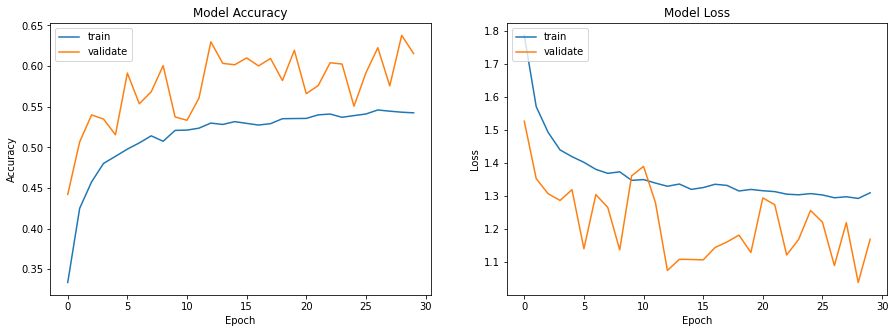

In [70]:
import matplotlib.pyplot as plt

def plotmodelhistory(history): 
    fig, axs = plt.subplots(1,2,figsize=(15,5)) 
    # summarize history for accuracy
    axs[0].plot(history.history['accuracy']) 
    axs[0].plot(history.history['val_accuracy']) 
    axs[0].set_title('Model Accuracy')
    axs[0].set_ylabel('Accuracy') 
    axs[0].set_xlabel('Epoch')
    axs[0].legend(['train', 'validate'], loc='upper left')
    # summarize history for loss
    axs[1].plot(history.history['loss']) 
    axs[1].plot(history.history['val_loss']) 
    axs[1].set_title('Model Loss')
    axs[1].set_ylabel('Loss') 
    axs[1].set_xlabel('Epoch')
    axs[1].legend(['train', 'validate'], loc='upper left')
    plt.show()

# list all data in history
print(model1_aug2_history.history.keys())

plotmodelhistory(model1_aug2_history)

#### Model concept no. 2

In [76]:
EPOCHS= 10# 200
PATIENCE=20

early_stop = EarlyStopping(monitor='loss', patience=PATIENCE)

In [77]:
def generate_model2():

    model = Sequential()

    model.add(Conv2D(filters=32, kernel_size=(3,3), input_shape=INPUT_SHAPE, activation='relu', padding = 'same', kernel_initializer='he_uniform'))
    model.add(Conv2D(filters=32, kernel_size=(3,3), input_shape=INPUT_SHAPE, activation='relu', padding = 'same', kernel_initializer='he_uniform'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.3))
    model.add(Conv2D(filters=64, kernel_size=(3,3), input_shape=INPUT_SHAPE, activation='relu', padding = 'same', kernel_initializer='he_uniform'))
    model.add(Conv2D(filters=64, kernel_size=(3,3), input_shape=INPUT_SHAPE, activation='relu', padding = 'same', kernel_initializer='he_uniform'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.3))
    model.add(Conv2D(filters=128, kernel_size=(3,3), input_shape=INPUT_SHAPE, activation='relu', padding = 'same', kernel_initializer='he_uniform'))
    model.add(Conv2D(filters=128, kernel_size=(3,3), input_shape=INPUT_SHAPE, activation='relu', padding = 'same', kernel_initializer='he_uniform'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.3))
    model.add(BatchNormalization())
    model.add(Flatten())
    model.add(Dense(256, activation='relu', kernel_initializer='he_uniform'))
    model.add(Dropout(0.4))
    model.add(Dense(10, activation='softmax'))
    
    model.compile(loss='categorical_crossentropy',
              optimizer=tf.keras.optimizers.Adam(learning_rate=LR, decay=1e-6), 
              metrics=['accuracy'])
    
    return model    

In [78]:
model2 = generate_model2()
model2.summary()

Model: "sequential_25"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_102 (Conv2D)         (None, 32, 32, 32)        896       
                                                                 
 conv2d_103 (Conv2D)         (None, 32, 32, 32)        9248      
                                                                 
 max_pooling2d_51 (MaxPoolin  (None, 16, 16, 32)       0         
 g2D)                                                            
                                                                 
 dropout_76 (Dropout)        (None, 16, 16, 32)        0         
                                                                 
 conv2d_104 (Conv2D)         (None, 16, 16, 64)        18496     
                                                                 
 conv2d_105 (Conv2D)         (None, 16, 16, 64)        36928     
                                                     

In [79]:
model2_history = (
    model2.fit(
    X_train,
    y_train,
    batch_size=BATCH_SIZE,
    epochs=EPOCHS,
    callbacks=[
       #keras.callbacks.LearningRateScheduler(lrScheduler), 
       tqdm_callback,
       early_stop],
    shuffle=True,
    verbose=1,
    validation_data=(X_test, y_test)
    )
)




Training:  14%|████                          7/50 ETA: 1:13:01s,  101.91s/epochs


Epoch 1/10



1478/1563███████████████████████▋  ETA: 00:09s - loss: 0.9141 - accuracy: 0.6802

Epoch 1/10




1/1563                             ETA: 18:45s - loss: 3.4606 - accuracy: 0.0312

   3/1563 [..............................] - ETA: 1:13 - loss: 3.2821 - accuracy: 0.0938 


4/1563                             ETA: 04:35s - loss: 3.3886 - accuracy: 0.0723

   5/1563 [..............................] - ETA: 1:20 - loss: 3.2526 - accuracy: 0.0812


6/1563                             ETA: 03:10s - loss: 3.3367 - accuracy: 0.0756

   7/1563 [..............................] - ETA: 1:18 - loss: 3.1955 - accuracy: 0.0714


9/1563▏                            ETA: 02:15s - loss: 3.2795 - accuracy: 0.0734

   9/1563 [..............................] - ETA: 1:18 - loss: 3.1309 - accuracy: 0.0694


11/1563▏                           ETA: 01:57s - loss: 3.2455 - accuracy: 0.0741

  12/1563 [..............................] - ETA: 1:18 - loss: 3.0602 - accuracy: 0.0833


13/1563▏                           ETA: 01:45s - loss: 3.2143 - accuracy: 0.0754

  14/1563 [..............................] - ETA: 1:18 - loss: 2.9887 - accuracy: 0.0915


16/1563▎                           ETA: 01:33s - loss: 3.1689 - accuracy: 0.0789

  18/1563 [..............................] - ETA: 1:17 - loss: 2.9073 - accuracy: 0.0990


19/1563▎                           ETA: 01:26s - loss: 3.1265 - accuracy: 0.0823

  20/1563 [..............................] - ETA: 1:17 - loss: 2.8485 - accuracy: 0.1031


21/1563▎                           ETA: 01:24s - loss: 3.0988 - accuracy: 0.0845

  22/1563 [..............................] - ETA: 1:17 - loss: 2.7855 - accuracy: 0.1222


23/1563▍                           ETA: 01:22s - loss: 3.0711 - accuracy: 0.0876

  25/1563 [..............................] - ETA: 1:16 - loss: 2.7592 - accuracy: 0.1187


26/1563▍                           ETA: 01:19s - loss: 3.0351 - accuracy: 0.0912

  29/1563 [..............................] - ETA: 1:16 - loss: 2.7116 - accuracy: 0.1250


31/1563▌                           ETA: 01:16s - loss: 2.9821 - accuracy: 0.0969

  34/1563 [..............................] - ETA: 1:15 - loss: 2.6512 - accuracy: 0.1324


36/1563▌                           ETA: 01:16s - loss: 2.9355 - accuracy: 0.1021

  38/1563 [..............................] - ETA: 1:15 - loss: 2.6126 - accuracy: 0.1398


39/1563▋                           ETA: 01:16s - loss: 2.9106 - accuracy: 0.1051

  41/1563 [..............................] - ETA: 1:15 - loss: 2.5776 - accuracy: 0.1486


42/1563▋                           ETA: 01:15s - loss: 2.8870 - accuracy: 0.1081

  45/1563 [..............................] - ETA: 1:15 - loss: 2.5457 - accuracy: 0.1542


46/1563▊                           ETA: 01:16s - loss: 2.8579 - accuracy: 0.1120

  50/1563 [..............................] - ETA: 1:15 - loss: 2.5158 - accuracy: 0.1519


51/1563▉                           ETA: 01:16s - loss: 2.8251 - accuracy: 0.1160

  53/1563 [>.............................] - ETA: 1:15 - loss: 2.4989 - accuracy: 0.1521


54/1563▉                           ETA: 01:15s - loss: 2.8070 - accuracy: 0.1180

  56/1563 [>.............................] - ETA: 1:15 - loss: 2.4843 - accuracy: 0.1562


57/1563▉                           ETA: 01:16s - loss: 2.7900 - accuracy: 0.1200

  59/1563 [>.............................] - ETA: 1:15 - loss: 2.4681 - accuracy: 0.1610


60/1563█                           ETA: 01:14s - loss: 2.7739 - accuracy: 0.1220

  61/1563 [>.............................] - ETA: 1:14 - loss: 2.4591 - accuracy: 0.1593


63/1563█                           ETA: 01:13s - loss: 2.7588 - accuracy: 0.1238

  66/1563 [>.............................] - ETA: 1:14 - loss: 2.4412 - accuracy: 0.1619


68/1563█▏                          ETA: 01:15s - loss: 2.7355 - accuracy: 0.1266

  72/1563 [>.............................] - ETA: 1:14 - loss: 2.4179 - accuracy: 0.1671


73/1563█▎                          ETA: 01:15s - loss: 2.7140 - accuracy: 0.1292

  74/1563 [>.............................] - ETA: 1:14 - loss: 2.4105 - accuracy: 0.1685


76/1563█▎                          ETA: 01:14s - loss: 2.7019 - accuracy: 0.1308

  78/1563 [>.............................] - ETA: 1:14 - loss: 2.3991 - accuracy: 0.1691


79/1563█▎                          ETA: 01:15s - loss: 2.6904 - accuracy: 0.1323

  80/1563 [>.............................] - ETA: 1:14 - loss: 2.3956 - accuracy: 0.1695


81/1563█▍                          ETA: 01:18s - loss: 2.6831 - accuracy: 0.1332

  82/1563 [>.............................] - ETA: 1:14 - loss: 2.3916 - accuracy: 0.1692


83/1563█▍                          ETA: 01:19s - loss: 2.6760 - accuracy: 0.1341

  84/1563 [>.............................] - ETA: 1:14 - loss: 2.3877 - accuracy: 0.1693


85/1563█▍                          ETA: 01:20s - loss: 2.6692 - accuracy: 0.1349

  86/1563 [>.............................] - ETA: 1:15 - loss: 2.3828 - accuracy: 0.1682


87/1563█▌                          ETA: 01:26s - loss: 2.6626 - accuracy: 0.1357

  88/1563 [>.............................] - ETA: 1:15 - loss: 2.3800 - accuracy: 0.1676


89/1563█▌                          ETA: 01:29s - loss: 2.6563 - accuracy: 0.1364

  90/1563 [>.............................] - ETA: 1:16 - loss: 2.3772 - accuracy: 0.1677


91/1563█▌                          ETA: 01:30s - loss: 2.6501 - accuracy: 0.1370

  92/1563 [>.............................] - ETA: 1:16 - loss: 2.3762 - accuracy: 0.1685


93/1563█▌                          ETA: 01:31s - loss: 2.6442 - accuracy: 0.1377

  94/1563 [>.............................] - ETA: 1:16 - loss: 2.3721 - accuracy: 0.1689


95/1563█▋                          ETA: 01:32s - loss: 2.6385 - accuracy: 0.1384

  96/1563 [>.............................] - ETA: 1:16 - loss: 2.3699 - accuracy: 0.1686


97/1563█▋                          ETA: 01:30s - loss: 2.6330 - accuracy: 0.1390

  98/1563 [>.............................] - ETA: 1:16 - loss: 2.3672 - accuracy: 0.1690


100/1563█▋                         ETA: 01:23s - loss: 2.6250 - accuracy: 0.1399

 101/1563 [>.............................] - ETA: 1:16 - loss: 2.3630 - accuracy: 0.1689


103/1563█▋                         ETA: 01:19s - loss: 2.6173 - accuracy: 0.1407

 105/1563 [=>............................] - ETA: 1:16 - loss: 2.3551 - accuracy: 0.1676


106/1563█▊                         ETA: 01:16s - loss: 2.6098 - accuracy: 0.1415

 107/1563 [=>............................] - ETA: 1:15 - loss: 2.3530 - accuracy: 0.1671


109/1563█▊                         ETA: 01:15s - loss: 2.6027 - accuracy: 0.1422

 110/1563 [=>............................] - ETA: 1:15 - loss: 2.3482 - accuracy: 0.1665


111/1563█▊                         ETA: 01:15s - loss: 2.5981 - accuracy: 0.1427

 113/1563 [=>............................] - ETA: 1:15 - loss: 2.3440 - accuracy: 0.1659


114/1563█▉                         ETA: 01:12s - loss: 2.5915 - accuracy: 0.1433

 116/1563 [=>............................] - ETA: 1:15 - loss: 2.3416 - accuracy: 0.1651


117/1563█▉                         ETA: 01:11s - loss: 2.5851 - accuracy: 0.1438

 118/1563 [=>............................] - ETA: 1:14 - loss: 2.3379 - accuracy: 0.1650


120/1563█▉                         ETA: 01:10s - loss: 2.5788 - accuracy: 0.1444

 122/1563 [=>............................] - ETA: 1:14 - loss: 2.3325 - accuracy: 0.1657


123/1563██                         ETA: 01:09s - loss: 2.5728 - accuracy: 0.1449

 124/1563 [=>............................] - ETA: 1:14 - loss: 2.3295 - accuracy: 0.1663


126/1563██                         ETA: 01:08s - loss: 2.5670 - accuracy: 0.1454

 129/1563 [=>............................] - ETA: 1:13 - loss: 2.3223 - accuracy: 0.1674


131/1563██▏                        ETA: 01:09s - loss: 2.5576 - accuracy: 0.1463

 133/1563 [=>............................] - ETA: 1:13 - loss: 2.3155 - accuracy: 0.1685


134/1563██▏                        ETA: 01:09s - loss: 2.5522 - accuracy: 0.1468

 136/1563 [=>............................] - ETA: 1:13 - loss: 2.3122 - accuracy: 0.1687


137/1563██▎                        ETA: 01:08s - loss: 2.5470 - accuracy: 0.1472

 138/1563 [=>............................] - ETA: 1:13 - loss: 2.3087 - accuracy: 0.1692


140/1563██▎                        ETA: 01:07s - loss: 2.5419 - accuracy: 0.1477

 142/1563 [=>............................] - ETA: 1:12 - loss: 2.3015 - accuracy: 0.1712


143/1563██▍                        ETA: 01:07s - loss: 2.5368 - accuracy: 0.1482

 145/1563 [=>............................] - ETA: 1:12 - loss: 2.2959 - accuracy: 0.1713


146/1563██▍                        ETA: 01:07s - loss: 2.5319 - accuracy: 0.1487

 150/1563 [=>............................] - ETA: 1:12 - loss: 2.2899 - accuracy: 0.1729


151/1563██▌                        ETA: 01:09s - loss: 2.5239 - accuracy: 0.1495

 152/1563 [=>............................] - ETA: 1:12 - loss: 2.2861 - accuracy: 0.1737


154/1563██▌                        ETA: 01:09s - loss: 2.5192 - accuracy: 0.1500

 158/1563 [==>...........................] - ETA: 1:11 - loss: 2.2808 - accuracy: 0.1744


159/1563██▋                        ETA: 01:09s - loss: 2.5118 - accuracy: 0.1507

 161/1563 [==>...........................] - ETA: 1:11 - loss: 2.2766 - accuracy: 0.1743


163/1563██▋                        ETA: 01:09s - loss: 2.5060 - accuracy: 0.1513

 165/1563 [==>...........................] - ETA: 1:11 - loss: 2.2722 - accuracy: 0.1742


167/1563██▊                        ETA: 01:10s - loss: 2.5004 - accuracy: 0.1518

 169/1563 [==>...........................] - ETA: 1:11 - loss: 2.2686 - accuracy: 0.1740


170/1563██▊                        ETA: 01:10s - loss: 2.4963 - accuracy: 0.1522

 170/1563 [==>...........................] - ETA: 1:11 - loss: 2.2690 - accuracy: 0.1735


172/1563██▊                        ETA: 01:10s - loss: 2.4937 - accuracy: 0.1525

 173/1563 [==>...........................] - ETA: 1:10 - loss: 2.2652 - accuracy: 0.1752


174/1563██▉                        ETA: 01:10s - loss: 2.4910 - accuracy: 0.1527

 175/1563 [==>...........................] - ETA: 1:10 - loss: 2.2624 - accuracy: 0.1764


176/1563██▉                        ETA: 01:10s - loss: 2.4884 - accuracy: 0.1530

 177/1563 [==>...........................] - ETA: 1:10 - loss: 2.2617 - accuracy: 0.1767


179/1563██▉                        ETA: 01:10s - loss: 2.4846 - accuracy: 0.1534

 181/1563 [==>...........................] - ETA: 1:10 - loss: 2.2581 - accuracy: 0.1777


182/1563███                        ETA: 01:08s - loss: 2.4809 - accuracy: 0.1538

 183/1563 [==>...........................] - ETA: 1:10 - loss: 2.2564 - accuracy: 0.1781


185/1563███                        ETA: 01:06s - loss: 2.4772 - accuracy: 0.1542

 186/1563 [==>...........................] - ETA: 1:10 - loss: 2.2554 - accuracy: 0.1771


188/1563███▏                       ETA: 01:06s - loss: 2.4737 - accuracy: 0.1546

 190/1563 [==>...........................] - ETA: 1:09 - loss: 2.2520 - accuracy: 0.1783


191/1563███▏                       ETA: 01:05s - loss: 2.4702 - accuracy: 0.1549

 193/1563 [==>...........................] - ETA: 1:09 - loss: 2.2507 - accuracy: 0.1776


195/1563███▏                       ETA: 01:07s - loss: 2.4657 - accuracy: 0.1554

 197/1563 [==>...........................] - ETA: 1:09 - loss: 2.2446 - accuracy: 0.1785


198/1563███▎                       ETA: 01:07s - loss: 2.4623 - accuracy: 0.1558

 201/1563 [==>...........................] - ETA: 1:09 - loss: 2.2410 - accuracy: 0.1789


202/1563███▎                       ETA: 01:08s - loss: 2.4580 - accuracy: 0.1562

 204/1563 [==>...........................] - ETA: 1:08 - loss: 2.2385 - accuracy: 0.1805


205/1563███▍                       ETA: 01:08s - loss: 2.4547 - accuracy: 0.1566

 207/1563 [==>...........................] - ETA: 1:08 - loss: 2.2355 - accuracy: 0.1803


208/1563███▍                       ETA: 01:07s - loss: 2.4516 - accuracy: 0.1569

 210/1563 [===>..........................] - ETA: 1:08 - loss: 2.2331 - accuracy: 0.1807


212/1563███▌                       ETA: 01:09s - loss: 2.4475 - accuracy: 0.1574

 213/1563 [===>..........................] - ETA: 1:08 - loss: 2.2323 - accuracy: 0.1809


214/1563███▌                       ETA: 01:09s - loss: 2.4454 - accuracy: 0.1576

 214/1563 [===>..........................] - ETA: 1:08 - loss: 2.2307 - accuracy: 0.1811


216/1563███▌                       ETA: 01:09s - loss: 2.4435 - accuracy: 0.1578

 216/1563 [===>..........................] - ETA: 1:08 - loss: 2.2301 - accuracy: 0.1810


218/1563███▋                       ETA: 01:08s - loss: 2.4415 - accuracy: 0.1580

 220/1563 [===>..........................] - ETA: 1:08 - loss: 2.2265 - accuracy: 0.1822


221/1563███▋                       ETA: 01:07s - loss: 2.4386 - accuracy: 0.1583

 222/1563 [===>..........................] - ETA: 1:08 - loss: 2.2263 - accuracy: 0.1826


223/1563███▋                       ETA: 01:07s - loss: 2.4367 - accuracy: 0.1586

 224/1563 [===>..........................] - ETA: 1:08 - loss: 2.2239 - accuracy: 0.1829


225/1563███▋                       ETA: 01:07s - loss: 2.4348 - accuracy: 0.1588

 226/1563 [===>..........................] - ETA: 1:07 - loss: 2.2230 - accuracy: 0.1831


227/1563███▊                       ETA: 01:08s - loss: 2.4329 - accuracy: 0.1590

 227/1563 [===>..........................] - ETA: 1:07 - loss: 2.2226 - accuracy: 0.1830


229/1563███▊                       ETA: 01:08s - loss: 2.4311 - accuracy: 0.1592

 229/1563 [===>..........................] - ETA: 1:07 - loss: 2.2210 - accuracy: 0.1834


231/1563███▊                       ETA: 01:08s - loss: 2.4292 - accuracy: 0.1594

 232/1563 [===>..........................] - ETA: 1:07 - loss: 2.2171 - accuracy: 0.1839


233/1563███▉                       ETA: 01:10s - loss: 2.4274 - accuracy: 0.1596

 234/1563 [===>..........................] - ETA: 1:07 - loss: 2.2147 - accuracy: 0.1835


235/1563███▉                       ETA: 01:10s - loss: 2.4256 - accuracy: 0.1598

 236/1563 [===>..........................] - ETA: 1:07 - loss: 2.2130 - accuracy: 0.1843


237/1563███▉                       ETA: 01:10s - loss: 2.4238 - accuracy: 0.1600

 238/1563 [===>..........................] - ETA: 1:07 - loss: 2.2107 - accuracy: 0.1847


240/1563███▉                       ETA: 01:08s - loss: 2.4211 - accuracy: 0.1603

 240/1563 [===>..........................] - ETA: 1:07 - loss: 2.2104 - accuracy: 0.1855


242/1563████                       ETA: 01:08s - loss: 2.4194 - accuracy: 0.1606

 244/1563 [===>..........................] - ETA: 1:07 - loss: 2.2061 - accuracy: 0.1861


245/1563████                       ETA: 01:06s - loss: 2.4167 - accuracy: 0.1609

 246/1563 [===>..........................] - ETA: 1:07 - loss: 2.2039 - accuracy: 0.1858


247/1563████                       ETA: 01:09s - loss: 2.4150 - accuracy: 0.1611

 247/1563 [===>..........................] - ETA: 1:07 - loss: 2.2038 - accuracy: 0.1860


249/1563████▏                      ETA: 01:08s - loss: 2.4133 - accuracy: 0.1613

 249/1563 [===>..........................] - ETA: 1:06 - loss: 2.2031 - accuracy: 0.1864


251/1563████▏                      ETA: 01:08s - loss: 2.4116 - accuracy: 0.1615

 252/1563 [===>..........................] - ETA: 1:06 - loss: 2.2020 - accuracy: 0.1870


253/1563████▏                      ETA: 01:08s - loss: 2.4100 - accuracy: 0.1617

 254/1563 [===>..........................] - ETA: 1:06 - loss: 2.2002 - accuracy: 0.1871


255/1563████▏                      ETA: 01:07s - loss: 2.4083 - accuracy: 0.1619

 256/1563 [===>..........................] - ETA: 1:06 - loss: 2.1975 - accuracy: 0.1877


257/1563████▎                      ETA: 01:07s - loss: 2.4067 - accuracy: 0.1621

 258/1563 [===>..........................] - ETA: 1:06 - loss: 2.1978 - accuracy: 0.1873


259/1563████▎                      ETA: 01:08s - loss: 2.4051 - accuracy: 0.1623

 259/1563 [===>..........................] - ETA: 1:06 - loss: 2.1968 - accuracy: 0.1873


261/1563████▎                      ETA: 01:07s - loss: 2.4035 - accuracy: 0.1625

 263/1563 [====>.........................] - ETA: 1:06 - loss: 2.1938 - accuracy: 0.1875


264/1563████▍                      ETA: 01:05s - loss: 2.4011 - accuracy: 0.1627

 265/1563 [====>.........................] - ETA: 1:06 - loss: 2.1916 - accuracy: 0.1876


266/1563████▍                      ETA: 01:06s - loss: 2.3995 - accuracy: 0.1629

 267/1563 [====>.........................] - ETA: 1:06 - loss: 2.1892 - accuracy: 0.1882


268/1563████▍                      ETA: 01:07s - loss: 2.3979 - accuracy: 0.1631

 268/1563 [====>.........................] - ETA: 1:06 - loss: 2.1891 - accuracy: 0.1882


270/1563████▍                      ETA: 01:07s - loss: 2.3964 - accuracy: 0.1633

 271/1563 [====>.........................] - ETA: 1:05 - loss: 2.1879 - accuracy: 0.1877


272/1563████▌                      ETA: 01:08s - loss: 2.3948 - accuracy: 0.1635

 272/1563 [====>.........................] - ETA: 1:05 - loss: 2.1870 - accuracy: 0.1878


274/1563████▌                      ETA: 01:07s - loss: 2.3933 - accuracy: 0.1637

 274/1563 [====>.........................] - ETA: 1:05 - loss: 2.1845 - accuracy: 0.1890


276/1563████▌                      ETA: 01:06s - loss: 2.3918 - accuracy: 0.1639

 277/1563 [====>.........................] - ETA: 1:05 - loss: 2.1825 - accuracy: 0.1887


278/1563████▌                      ETA: 01:06s - loss: 2.3903 - accuracy: 0.1640

 279/1563 [====>.........................] - ETA: 1:05 - loss: 2.1820 - accuracy: 0.1885


280/1563████▋                      ETA: 01:06s - loss: 2.3888 - accuracy: 0.1642

 281/1563 [====>.........................] - ETA: 1:05 - loss: 2.1806 - accuracy: 0.1887


282/1563████▋                      ETA: 01:09s - loss: 2.3873 - accuracy: 0.1644

 283/1563 [====>.........................] - ETA: 1:05 - loss: 2.1790 - accuracy: 0.1889


284/1563████▋                      ETA: 01:11s - loss: 2.3859 - accuracy: 0.1646

 285/1563 [====>.........................] - ETA: 1:05 - loss: 2.1769 - accuracy: 0.1895


286/1563████▊                      ETA: 01:11s - loss: 2.3844 - accuracy: 0.1647

 286/1563 [====>.........................] - ETA: 1:05 - loss: 2.1762 - accuracy: 0.1898


288/1563████▊                      ETA: 01:09s - loss: 2.3829 - accuracy: 0.1649

 289/1563 [====>.........................] - ETA: 1:05 - loss: 2.1741 - accuracy: 0.1899


290/1563████▊                      ETA: 01:18s - loss: 2.3815 - accuracy: 0.1651

 291/1563 [====>.........................] - ETA: 1:05 - loss: 2.1733 - accuracy: 0.1901


292/1563████▊                      ETA: 01:18s - loss: 2.3801 - accuracy: 0.1652

 293/1563 [====>.........................] - ETA: 1:05 - loss: 2.1724 - accuracy: 0.1900


294/1563████▉                      ETA: 01:14s - loss: 2.3786 - accuracy: 0.1654

 295/1563 [====>.........................] - ETA: 1:05 - loss: 2.1706 - accuracy: 0.1906


296/1563████▉                      ETA: 01:13s - loss: 2.3772 - accuracy: 0.1656

 297/1563 [====>.........................] - ETA: 1:05 - loss: 2.1687 - accuracy: 0.1908


298/1563████▉                      ETA: 01:13s - loss: 2.3758 - accuracy: 0.1658

 299/1563 [====>.........................] - ETA: 1:05 - loss: 2.1661 - accuracy: 0.1911


300/1563████▉                      ETA: 01:12s - loss: 2.3744 - accuracy: 0.1659

 301/1563 [====>.........................] - ETA: 1:05 - loss: 2.1643 - accuracy: 0.1918


302/1563█████                      ETA: 01:11s - loss: 2.3730 - accuracy: 0.1661

 303/1563 [====>.........................] - ETA: 1:05 - loss: 2.1624 - accuracy: 0.1913


304/1563█████                      ETA: 01:10s - loss: 2.3717 - accuracy: 0.1663

 304/1563 [====>.........................] - ETA: 1:04 - loss: 2.1621 - accuracy: 0.1916


306/1563█████                      ETA: 01:09s - loss: 2.3703 - accuracy: 0.1664

 307/1563 [====>.........................] - ETA: 1:04 - loss: 2.1602 - accuracy: 0.1929


308/1563█████                      ETA: 01:13s - loss: 2.3689 - accuracy: 0.1666

 308/1563 [====>.........................] - ETA: 1:04 - loss: 2.1597 - accuracy: 0.1930


310/1563█████▏                     ETA: 01:11s - loss: 2.3676 - accuracy: 0.1668

 311/1563 [====>.........................] - ETA: 1:04 - loss: 2.1589 - accuracy: 0.1931


312/1563█████▏                     ETA: 01:10s - loss: 2.3662 - accuracy: 0.1669

 313/1563 [=====>........................] - ETA: 1:04 - loss: 2.1570 - accuracy: 0.1937


314/1563█████▏                     ETA: 01:08s - loss: 2.3649 - accuracy: 0.1671

 315/1563 [=====>........................] - ETA: 1:04 - loss: 2.1550 - accuracy: 0.1938


316/1563█████▎                     ETA: 01:06s - loss: 2.3636 - accuracy: 0.1673

 317/1563 [=====>........................] - ETA: 1:04 - loss: 2.1538 - accuracy: 0.1939


319/1563█████▎                     ETA: 01:02s - loss: 2.3616 - accuracy: 0.1675

 320/1563 [=====>........................] - ETA: 1:04 - loss: 2.1516 - accuracy: 0.1942


322/1563█████▎                     ETA: 01:00s - loss: 2.3596 - accuracy: 0.1678

 324/1563 [=====>........................] - ETA: 1:03 - loss: 2.1503 - accuracy: 0.1947


325/1563█████▍                     ETA: 00:58s - loss: 2.3577 - accuracy: 0.1680

 326/1563 [=====>........................] - ETA: 1:03 - loss: 2.1497 - accuracy: 0.1948


328/1563█████▍                     ETA: 00:59s - loss: 2.3558 - accuracy: 0.1683

 330/1563 [=====>........................] - ETA: 1:03 - loss: 2.1482 - accuracy: 0.1949


331/1563█████▌                     ETA: 00:57s - loss: 2.3539 - accuracy: 0.1685

 332/1563 [=====>........................] - ETA: 1:03 - loss: 2.1472 - accuracy: 0.1949


334/1563█████▌                     ETA: 00:57s - loss: 2.3520 - accuracy: 0.1688

 336/1563 [=====>........................] - ETA: 1:03 - loss: 2.1456 - accuracy: 0.1952


337/1563█████▌                     ETA: 00:56s - loss: 2.3502 - accuracy: 0.1690

 338/1563 [=====>........................] - ETA: 1:02 - loss: 2.1445 - accuracy: 0.1958


340/1563█████▋                     ETA: 00:55s - loss: 2.3484 - accuracy: 0.1692

 342/1563 [=====>........................] - ETA: 1:02 - loss: 2.1434 - accuracy: 0.1961


343/1563█████▋                     ETA: 00:56s - loss: 2.3466 - accuracy: 0.1695

 344/1563 [=====>........................] - ETA: 1:02 - loss: 2.1443 - accuracy: 0.1956


346/1563█████▊                     ETA: 00:55s - loss: 2.3448 - accuracy: 0.1697

 348/1563 [=====>........................] - ETA: 1:02 - loss: 2.1427 - accuracy: 0.1960


349/1563█████▊                     ETA: 00:54s - loss: 2.3431 - accuracy: 0.1699

 350/1563 [=====>........................] - ETA: 1:02 - loss: 2.1416 - accuracy: 0.1959


352/1563█████▊                     ETA: 00:54s - loss: 2.3414 - accuracy: 0.1701

 354/1563 [=====>........................] - ETA: 1:01 - loss: 2.1401 - accuracy: 0.1961


355/1563█████▉                     ETA: 00:54s - loss: 2.3397 - accuracy: 0.1704

 356/1563 [=====>........................] - ETA: 1:01 - loss: 2.1397 - accuracy: 0.1961


358/1563█████▉                     ETA: 00:54s - loss: 2.3380 - accuracy: 0.1706

 360/1563 [=====>........................] - ETA: 1:01 - loss: 2.1393 - accuracy: 0.1955


361/1563██████                     ETA: 00:54s - loss: 2.3363 - accuracy: 0.1708

 362/1563 [=====>........................] - ETA: 1:01 - loss: 2.1380 - accuracy: 0.1954


364/1563██████                     ETA: 00:54s - loss: 2.3347 - accuracy: 0.1710

 366/1563 [======>.......................] - ETA: 1:00 - loss: 2.1381 - accuracy: 0.1948


367/1563██████                     ETA: 00:54s - loss: 2.3331 - accuracy: 0.1712

 368/1563 [======>.......................] - ETA: 1:00 - loss: 2.1374 - accuracy: 0.1948


370/1563██████▏                    ETA: 00:53s - loss: 2.3315 - accuracy: 0.1714

 372/1563 [======>.......................] - ETA: 1:00 - loss: 2.1365 - accuracy: 0.1948


373/1563██████▏                    ETA: 00:53s - loss: 2.3299 - accuracy: 0.1716

 374/1563 [======>.......................] - ETA: 1:00 - loss: 2.1358 - accuracy: 0.1946


376/1563██████▎                    ETA: 00:53s - loss: 2.3284 - accuracy: 0.1717

 378/1563 [======>.......................] - ETA: 1:00 - loss: 2.1347 - accuracy: 0.1947


379/1563██████▎                    ETA: 00:53s - loss: 2.3269 - accuracy: 0.1719

 380/1563 [======>.......................] - ETA: 59s - loss: 2.1339 - accuracy: 0.1947 


382/1563██████▎                    ETA: 00:53s - loss: 2.3253 - accuracy: 0.1721

 384/1563 [======>.......................] - ETA: 59s - loss: 2.1333 - accuracy: 0.1943


385/1563██████▍                    ETA: 00:52s - loss: 2.3238 - accuracy: 0.1723

 386/1563 [======>.......................] - ETA: 59s - loss: 2.1325 - accuracy: 0.1944


388/1563██████▍                    ETA: 00:52s - loss: 2.3224 - accuracy: 0.1724

 390/1563 [======>.......................] - ETA: 59s - loss: 2.1318 - accuracy: 0.1936


391/1563██████▌                    ETA: 00:52s - loss: 2.3209 - accuracy: 0.1726

 392/1563 [======>.......................] - ETA: 59s - loss: 2.1312 - accuracy: 0.1938


394/1563██████▌                    ETA: 00:52s - loss: 2.3195 - accuracy: 0.1728

 395/1563 [======>.......................] - ETA: 58s - loss: 2.1306 - accuracy: 0.1937


397/1563██████▌                    ETA: 00:52s - loss: 2.3180 - accuracy: 0.1729

 399/1563 [======>.......................] - ETA: 58s - loss: 2.1289 - accuracy: 0.1935


400/1563██████▋                    ETA: 00:52s - loss: 2.3166 - accuracy: 0.1731

 401/1563 [======>.......................] - ETA: 58s - loss: 2.1288 - accuracy: 0.1938


403/1563██████▋                    ETA: 00:52s - loss: 2.3152 - accuracy: 0.1732

 405/1563 [======>.......................] - ETA: 58s - loss: 2.1278 - accuracy: 0.1940


406/1563██████▊                    ETA: 00:52s - loss: 2.3138 - accuracy: 0.1734

 407/1563 [======>.......................] - ETA: 58s - loss: 2.1275 - accuracy: 0.1938


409/1563██████▊                    ETA: 00:52s - loss: 2.3125 - accuracy: 0.1735

 411/1563 [======>.......................] - ETA: 57s - loss: 2.1258 - accuracy: 0.1941


412/1563██████▊                    ETA: 00:52s - loss: 2.3111 - accuracy: 0.1737

 413/1563 [======>.......................] - ETA: 57s - loss: 2.1249 - accuracy: 0.1942


415/1563██████▉                    ETA: 00:52s - loss: 2.3097 - accuracy: 0.1738

 417/1563 [=======>......................] - ETA: 57s - loss: 2.1240 - accuracy: 0.1945


418/1563██████▉                    ETA: 00:52s - loss: 2.3084 - accuracy: 0.1740

 419/1563 [=======>......................] - ETA: 57s - loss: 2.1235 - accuracy: 0.1945


421/1563███████                    ETA: 00:51s - loss: 2.3071 - accuracy: 0.1741

 423/1563 [=======>......................] - ETA: 57s - loss: 2.1221 - accuracy: 0.1946


424/1563███████                    ETA: 00:51s - loss: 2.3058 - accuracy: 0.1743

 425/1563 [=======>......................] - ETA: 56s - loss: 2.1219 - accuracy: 0.1951


427/1563███████                    ETA: 00:51s - loss: 2.3045 - accuracy: 0.1744

 429/1563 [=======>......................] - ETA: 56s - loss: 2.1207 - accuracy: 0.1948


430/1563███████▏                   ETA: 00:50s - loss: 2.3032 - accuracy: 0.1746

 431/1563 [=======>......................] - ETA: 56s - loss: 2.1203 - accuracy: 0.1946


433/1563███████▏                   ETA: 00:50s - loss: 2.3019 - accuracy: 0.1747

 435/1563 [=======>......................] - ETA: 56s - loss: 2.1197 - accuracy: 0.1947


436/1563███████▎                   ETA: 00:50s - loss: 2.3007 - accuracy: 0.1748

 437/1563 [=======>......................] - ETA: 56s - loss: 2.1193 - accuracy: 0.1949


439/1563███████▎                   ETA: 00:50s - loss: 2.2994 - accuracy: 0.1750

 441/1563 [=======>......................] - ETA: 55s - loss: 2.1183 - accuracy: 0.1948


442/1563███████▎                   ETA: 00:50s - loss: 2.2982 - accuracy: 0.1751

 443/1563 [=======>......................] - ETA: 55s - loss: 2.1174 - accuracy: 0.1949


445/1563███████▍                   ETA: 00:51s - loss: 2.2970 - accuracy: 0.1753

 447/1563 [=======>......................] - ETA: 55s - loss: 2.1167 - accuracy: 0.1950


448/1563███████▍                   ETA: 00:50s - loss: 2.2958 - accuracy: 0.1754

 449/1563 [=======>......................] - ETA: 55s - loss: 2.1157 - accuracy: 0.1953


451/1563███████▌                   ETA: 00:50s - loss: 2.2946 - accuracy: 0.1755

 453/1563 [=======>......................] - ETA: 55s - loss: 2.1149 - accuracy: 0.1950


454/1563███████▌                   ETA: 00:50s - loss: 2.2934 - accuracy: 0.1756

 455/1563 [=======>......................] - ETA: 55s - loss: 2.1143 - accuracy: 0.1947


457/1563███████▌                   ETA: 00:50s - loss: 2.2922 - accuracy: 0.1758

 459/1563 [=======>......................] - ETA: 54s - loss: 2.1136 - accuracy: 0.1951


460/1563███████▋                   ETA: 00:49s - loss: 2.2911 - accuracy: 0.1759

 461/1563 [=======>......................] - ETA: 54s - loss: 2.1131 - accuracy: 0.1951


463/1563███████▋                   ETA: 00:50s - loss: 2.2899 - accuracy: 0.1760

 465/1563 [=======>......................] - ETA: 54s - loss: 2.1114 - accuracy: 0.1956


466/1563███████▊                   ETA: 00:49s - loss: 2.2888 - accuracy: 0.1762

 467/1563 [=======>......................] - ETA: 54s - loss: 2.1112 - accuracy: 0.1956


469/1563███████▊                   ETA: 00:50s - loss: 2.2876 - accuracy: 0.1763

 471/1563 [========>.....................] - ETA: 54s - loss: 2.1100 - accuracy: 0.1959


472/1563███████▊                   ETA: 00:49s - loss: 2.2865 - accuracy: 0.1764

 473/1563 [========>.....................] - ETA: 54s - loss: 2.1093 - accuracy: 0.1960


475/1563███████▉                   ETA: 00:50s - loss: 2.2854 - accuracy: 0.1765

 477/1563 [========>.....................] - ETA: 53s - loss: 2.1084 - accuracy: 0.1958


478/1563███████▉                   ETA: 00:49s - loss: 2.2843 - accuracy: 0.1766

 479/1563 [========>.....................] - ETA: 53s - loss: 2.1082 - accuracy: 0.1958


481/1563████████                   ETA: 00:49s - loss: 2.2832 - accuracy: 0.1768

 483/1563 [========>.....................] - ETA: 53s - loss: 2.1065 - accuracy: 0.1957


484/1563████████                   ETA: 00:49s - loss: 2.2821 - accuracy: 0.1769

 485/1563 [========>.....................] - ETA: 53s - loss: 2.1069 - accuracy: 0.1956


487/1563████████                   ETA: 00:49s - loss: 2.2810 - accuracy: 0.1770

 488/1563 [========>.....................] - ETA: 53s - loss: 2.1057 - accuracy: 0.1958


490/1563████████▏                  ETA: 00:49s - loss: 2.2799 - accuracy: 0.1771

 492/1563 [========>.....................] - ETA: 52s - loss: 2.1049 - accuracy: 0.1950


493/1563████████▏                  ETA: 00:49s - loss: 2.2788 - accuracy: 0.1772

 494/1563 [========>.....................] - ETA: 52s - loss: 2.1043 - accuracy: 0.1948


496/1563████████▎                  ETA: 00:49s - loss: 2.2778 - accuracy: 0.1773

 498/1563 [========>.....................] - ETA: 52s - loss: 2.1031 - accuracy: 0.1950


499/1563████████▎                  ETA: 00:49s - loss: 2.2767 - accuracy: 0.1774

 500/1563 [========>.....................] - ETA: 52s - loss: 2.1023 - accuracy: 0.1954


502/1563████████▎                  ETA: 00:48s - loss: 2.2757 - accuracy: 0.1775

 504/1563 [========>.....................] - ETA: 52s - loss: 2.1015 - accuracy: 0.1949


505/1563████████▍                  ETA: 00:48s - loss: 2.2746 - accuracy: 0.1776

 506/1563 [========>.....................] - ETA: 52s - loss: 2.1014 - accuracy: 0.1952


508/1563████████▍                  ETA: 00:47s - loss: 2.2736 - accuracy: 0.1778

 510/1563 [========>.....................] - ETA: 51s - loss: 2.1011 - accuracy: 0.1955


511/1563████████▌                  ETA: 00:48s - loss: 2.2726 - accuracy: 0.1779

 512/1563 [========>.....................] - ETA: 51s - loss: 2.1006 - accuracy: 0.1956


514/1563████████▌                  ETA: 00:47s - loss: 2.2716 - accuracy: 0.1780

 516/1563 [========>.....................] - ETA: 51s - loss: 2.0997 - accuracy: 0.1957


517/1563████████▌                  ETA: 00:47s - loss: 2.2706 - accuracy: 0.1781

 518/1563 [========>.....................] - ETA: 51s - loss: 2.0998 - accuracy: 0.1958


520/1563████████▋                  ETA: 00:48s - loss: 2.2696 - accuracy: 0.1782

 522/1563 [=========>....................] - ETA: 51s - loss: 2.0987 - accuracy: 0.1959


523/1563████████▋                  ETA: 00:47s - loss: 2.2686 - accuracy: 0.1783

 524/1563 [=========>....................] - ETA: 51s - loss: 2.0979 - accuracy: 0.1960


526/1563████████▋                  ETA: 00:47s - loss: 2.2677 - accuracy: 0.1784

 528/1563 [=========>....................] - ETA: 50s - loss: 2.0975 - accuracy: 0.1962


529/1563████████▊                  ETA: 00:47s - loss: 2.2667 - accuracy: 0.1785

 530/1563 [=========>....................] - ETA: 50s - loss: 2.0965 - accuracy: 0.1969


532/1563████████▊                  ETA: 00:46s - loss: 2.2657 - accuracy: 0.1786

 533/1563 [=========>....................] - ETA: 50s - loss: 2.0957 - accuracy: 0.1969


535/1563████████▉                  ETA: 00:46s - loss: 2.2648 - accuracy: 0.1787

 539/1563 [=========>....................] - ETA: 50s - loss: 2.0939 - accuracy: 0.1974


540/1563████████▉                  ETA: 00:47s - loss: 2.2632 - accuracy: 0.1788

 541/1563 [=========>....................] - ETA: 50s - loss: 2.0935 - accuracy: 0.1974


543/1563█████████                  ETA: 00:46s - loss: 2.2623 - accuracy: 0.1789

 545/1563 [=========>....................] - ETA: 50s - loss: 2.0930 - accuracy: 0.1972


546/1563█████████                  ETA: 00:46s - loss: 2.2613 - accuracy: 0.1790

 547/1563 [=========>....................] - ETA: 49s - loss: 2.0927 - accuracy: 0.1970


549/1563█████████▏                 ETA: 00:46s - loss: 2.2604 - accuracy: 0.1791

 551/1563 [=========>....................] - ETA: 49s - loss: 2.0916 - accuracy: 0.1970


552/1563█████████▏                 ETA: 00:45s - loss: 2.2595 - accuracy: 0.1792

 553/1563 [=========>....................] - ETA: 49s - loss: 2.0916 - accuracy: 0.1968


555/1563█████████▏                 ETA: 00:45s - loss: 2.2586 - accuracy: 0.1793

 557/1563 [=========>....................] - ETA: 49s - loss: 2.0902 - accuracy: 0.1973


558/1563█████████▎                 ETA: 00:45s - loss: 2.2577 - accuracy: 0.1794

 559/1563 [=========>....................] - ETA: 49s - loss: 2.0902 - accuracy: 0.1973


561/1563█████████▎                 ETA: 00:45s - loss: 2.2568 - accuracy: 0.1795

 563/1563 [=========>....................] - ETA: 48s - loss: 2.0899 - accuracy: 0.1972


564/1563█████████▍                 ETA: 00:44s - loss: 2.2559 - accuracy: 0.1796

 565/1563 [=========>....................] - ETA: 48s - loss: 2.0896 - accuracy: 0.1971


567/1563█████████▍                 ETA: 00:45s - loss: 2.2550 - accuracy: 0.1797

 569/1563 [=========>....................] - ETA: 48s - loss: 2.0887 - accuracy: 0.1970


570/1563█████████▍                 ETA: 00:45s - loss: 2.2541 - accuracy: 0.1798

 571/1563 [=========>....................] - ETA: 48s - loss: 2.0883 - accuracy: 0.1970


573/1563█████████▌                 ETA: 00:44s - loss: 2.2533 - accuracy: 0.1799

 575/1563 [==========>...................] - ETA: 48s - loss: 2.0876 - accuracy: 0.1970


576/1563█████████▌                 ETA: 00:44s - loss: 2.2524 - accuracy: 0.1800

 577/1563 [==========>...................] - ETA: 48s - loss: 2.0868 - accuracy: 0.1971


579/1563█████████▋                 ETA: 00:44s - loss: 2.2516 - accuracy: 0.1801

 581/1563 [==========>...................] - ETA: 48s - loss: 2.0858 - accuracy: 0.1967


582/1563█████████▋                 ETA: 00:44s - loss: 2.2507 - accuracy: 0.1802

 583/1563 [==========>...................] - ETA: 47s - loss: 2.0856 - accuracy: 0.1966


585/1563█████████▋                 ETA: 00:44s - loss: 2.2498 - accuracy: 0.1802

 586/1563 [==========>...................] - ETA: 47s - loss: 2.0848 - accuracy: 0.1969


588/1563█████████▊                 ETA: 00:44s - loss: 2.2490 - accuracy: 0.1803

 590/1563 [==========>...................] - ETA: 47s - loss: 2.0837 - accuracy: 0.1967


591/1563█████████▊                 ETA: 00:44s - loss: 2.2482 - accuracy: 0.1804

 592/1563 [==========>...................] - ETA: 47s - loss: 2.0835 - accuracy: 0.1966


594/1563█████████▉                 ETA: 00:44s - loss: 2.2473 - accuracy: 0.1805

 596/1563 [==========>...................] - ETA: 47s - loss: 2.0831 - accuracy: 0.1968


597/1563█████████▉                 ETA: 00:44s - loss: 2.2465 - accuracy: 0.1806

 598/1563 [==========>...................] - ETA: 47s - loss: 2.0831 - accuracy: 0.1966


600/1563█████████▉                 ETA: 00:43s - loss: 2.2457 - accuracy: 0.1807

 602/1563 [==========>...................] - ETA: 46s - loss: 2.0827 - accuracy: 0.1965


603/1563██████████                 ETA: 00:43s - loss: 2.2449 - accuracy: 0.1807

 604/1563 [==========>...................] - ETA: 46s - loss: 2.0823 - accuracy: 0.1968


606/1563██████████                 ETA: 00:43s - loss: 2.2441 - accuracy: 0.1808

 608/1563 [==========>...................] - ETA: 46s - loss: 2.0823 - accuracy: 0.1968


609/1563██████████▏                ETA: 00:42s - loss: 2.2433 - accuracy: 0.1809

 610/1563 [==========>...................] - ETA: 46s - loss: 2.0822 - accuracy: 0.1968


612/1563██████████▏                ETA: 00:42s - loss: 2.2425 - accuracy: 0.1810

 614/1563 [==========>...................] - ETA: 46s - loss: 2.0810 - accuracy: 0.1971


615/1563██████████▏                ETA: 00:42s - loss: 2.2417 - accuracy: 0.1811

 616/1563 [==========>...................] - ETA: 46s - loss: 2.0809 - accuracy: 0.1972


618/1563██████████▎                ETA: 00:42s - loss: 2.2409 - accuracy: 0.1811

 620/1563 [==========>...................] - ETA: 45s - loss: 2.0799 - accuracy: 0.1975


621/1563██████████▎                ETA: 00:42s - loss: 2.2401 - accuracy: 0.1812

 622/1563 [==========>...................] - ETA: 45s - loss: 2.0797 - accuracy: 0.1974


624/1563██████████▍                ETA: 00:42s - loss: 2.2394 - accuracy: 0.1813

 626/1563 [===========>..................] - ETA: 45s - loss: 2.0798 - accuracy: 0.1971


627/1563██████████▍                ETA: 00:41s - loss: 2.2386 - accuracy: 0.1814

 628/1563 [===========>..................] - ETA: 45s - loss: 2.0793 - accuracy: 0.1974


630/1563██████████▍                ETA: 00:41s - loss: 2.2378 - accuracy: 0.1814

 632/1563 [===========>..................] - ETA: 45s - loss: 2.0786 - accuracy: 0.1972


633/1563██████████▌                ETA: 00:41s - loss: 2.2371 - accuracy: 0.1815

 637/1563 [===========>..................] - ETA: 44s - loss: 2.0785 - accuracy: 0.1972


638/1563██████████▌                ETA: 00:42s - loss: 2.2359 - accuracy: 0.1816

 639/1563 [===========>..................] - ETA: 44s - loss: 2.0782 - accuracy: 0.1971


641/1563██████████▋                ETA: 00:42s - loss: 2.2351 - accuracy: 0.1817

 643/1563 [===========>..................] - ETA: 44s - loss: 2.0773 - accuracy: 0.1967


644/1563██████████▋                ETA: 00:41s - loss: 2.2344 - accuracy: 0.1818

 645/1563 [===========>..................] - ETA: 44s - loss: 2.0765 - accuracy: 0.1970


647/1563██████████▊                ETA: 00:41s - loss: 2.2336 - accuracy: 0.1818

 649/1563 [===========>..................] - ETA: 44s - loss: 2.0762 - accuracy: 0.1968


650/1563██████████▊                ETA: 00:41s - loss: 2.2329 - accuracy: 0.1819

 651/1563 [===========>..................] - ETA: 44s - loss: 2.0756 - accuracy: 0.1970


653/1563██████████▊                ETA: 00:41s - loss: 2.2322 - accuracy: 0.1820

 655/1563 [===========>..................] - ETA: 44s - loss: 2.0751 - accuracy: 0.1975


656/1563██████████▉                ETA: 00:41s - loss: 2.2315 - accuracy: 0.1821

 657/1563 [===========>..................] - ETA: 43s - loss: 2.0745 - accuracy: 0.1976


659/1563██████████▉                ETA: 00:41s - loss: 2.2308 - accuracy: 0.1821

 661/1563 [===========>..................] - ETA: 43s - loss: 2.0733 - accuracy: 0.1976


662/1563███████████                ETA: 00:40s - loss: 2.2300 - accuracy: 0.1822

 663/1563 [===========>..................] - ETA: 43s - loss: 2.0731 - accuracy: 0.1977


665/1563███████████                ETA: 00:41s - loss: 2.2293 - accuracy: 0.1823

 667/1563 [===========>..................] - ETA: 43s - loss: 2.0724 - accuracy: 0.1979


668/1563███████████                ETA: 00:40s - loss: 2.2286 - accuracy: 0.1823

 669/1563 [===========>..................] - ETA: 43s - loss: 2.0719 - accuracy: 0.1978


671/1563███████████▏               ETA: 00:40s - loss: 2.2279 - accuracy: 0.1824

 673/1563 [===========>..................] - ETA: 43s - loss: 2.0713 - accuracy: 0.1980


674/1563███████████▏               ETA: 00:39s - loss: 2.2272 - accuracy: 0.1825

 675/1563 [===========>..................] - ETA: 42s - loss: 2.0712 - accuracy: 0.1980


677/1563███████████▎               ETA: 00:39s - loss: 2.2265 - accuracy: 0.1825

 679/1563 [============>.................] - ETA: 42s - loss: 2.0697 - accuracy: 0.1985


680/1563███████████▎               ETA: 00:39s - loss: 2.2258 - accuracy: 0.1826

 681/1563 [============>.................] - ETA: 42s - loss: 2.0695 - accuracy: 0.1985


683/1563███████████▎               ETA: 00:39s - loss: 2.2252 - accuracy: 0.1827

 685/1563 [============>.................] - ETA: 42s - loss: 2.0689 - accuracy: 0.1984


686/1563███████████▍               ETA: 00:39s - loss: 2.2245 - accuracy: 0.1828

 687/1563 [============>.................] - ETA: 42s - loss: 2.0692 - accuracy: 0.1984


689/1563███████████▍               ETA: 00:39s - loss: 2.2238 - accuracy: 0.1828

 691/1563 [============>.................] - ETA: 42s - loss: 2.0683 - accuracy: 0.1982


692/1563███████████▌               ETA: 00:39s - loss: 2.2231 - accuracy: 0.1829

 693/1563 [============>.................] - ETA: 42s - loss: 2.0680 - accuracy: 0.1984


695/1563███████████▌               ETA: 00:39s - loss: 2.2225 - accuracy: 0.1830

 697/1563 [============>.................] - ETA: 41s - loss: 2.0674 - accuracy: 0.1984


698/1563███████████▌               ETA: 00:38s - loss: 2.2218 - accuracy: 0.1830

 699/1563 [============>.................] - ETA: 41s - loss: 2.0671 - accuracy: 0.1983


701/1563███████████▋               ETA: 00:38s - loss: 2.2211 - accuracy: 0.1831

 703/1563 [============>.................] - ETA: 41s - loss: 2.0664 - accuracy: 0.1986


704/1563███████████▋               ETA: 00:38s - loss: 2.2205 - accuracy: 0.1832

 705/1563 [============>.................] - ETA: 41s - loss: 2.0660 - accuracy: 0.1986


707/1563███████████▊               ETA: 00:38s - loss: 2.2198 - accuracy: 0.1832

 709/1563 [============>.................] - ETA: 41s - loss: 2.0661 - accuracy: 0.1989


710/1563███████████▊               ETA: 00:38s - loss: 2.2192 - accuracy: 0.1833

 711/1563 [============>.................] - ETA: 41s - loss: 2.0652 - accuracy: 0.1992


713/1563███████████▊               ETA: 00:38s - loss: 2.2185 - accuracy: 0.1834

 715/1563 [============>.................] - ETA: 40s - loss: 2.0655 - accuracy: 0.1991


716/1563███████████▉               ETA: 00:38s - loss: 2.2179 - accuracy: 0.1834

 717/1563 [============>.................] - ETA: 40s - loss: 2.0657 - accuracy: 0.1990


719/1563███████████▉               ETA: 00:38s - loss: 2.2172 - accuracy: 0.1835

 721/1563 [============>.................] - ETA: 40s - loss: 2.0659 - accuracy: 0.1991


722/1563████████████               ETA: 00:38s - loss: 2.2166 - accuracy: 0.1835

 723/1563 [============>.................] - ETA: 40s - loss: 2.0656 - accuracy: 0.1990


725/1563████████████               ETA: 00:37s - loss: 2.2160 - accuracy: 0.1836

 727/1563 [============>.................] - ETA: 40s - loss: 2.0653 - accuracy: 0.1990


728/1563████████████               ETA: 00:37s - loss: 2.2154 - accuracy: 0.1837

 729/1563 [============>.................] - ETA: 40s - loss: 2.0652 - accuracy: 0.1989


731/1563████████████▏              ETA: 00:37s - loss: 2.2147 - accuracy: 0.1837

 733/1563 [=============>................] - ETA: 39s - loss: 2.0650 - accuracy: 0.1986


734/1563████████████▏              ETA: 00:36s - loss: 2.2141 - accuracy: 0.1838

 735/1563 [=============>................] - ETA: 39s - loss: 2.0649 - accuracy: 0.1985


737/1563████████████▎              ETA: 00:36s - loss: 2.2135 - accuracy: 0.1839

 738/1563 [=============>................] - ETA: 39s - loss: 2.0646 - accuracy: 0.1986


740/1563████████████▎              ETA: 00:37s - loss: 2.2129 - accuracy: 0.1839

 742/1563 [=============>................] - ETA: 39s - loss: 2.0638 - accuracy: 0.1990


743/1563████████████▎              ETA: 00:37s - loss: 2.2123 - accuracy: 0.1840

 745/1563 [=============>................] - ETA: 39s - loss: 2.0631 - accuracy: 0.1989


746/1563████████████▍              ETA: 00:36s - loss: 2.2117 - accuracy: 0.1840

 747/1563 [=============>................] - ETA: 39s - loss: 2.0626 - accuracy: 0.1989


749/1563████████████▍              ETA: 00:36s - loss: 2.2111 - accuracy: 0.1841

 751/1563 [=============>................] - ETA: 39s - loss: 2.0625 - accuracy: 0.1989


752/1563████████████▌              ETA: 00:36s - loss: 2.2105 - accuracy: 0.1842

 753/1563 [=============>................] - ETA: 38s - loss: 2.0619 - accuracy: 0.1992


755/1563████████████▌              ETA: 00:36s - loss: 2.2099 - accuracy: 0.1842

 757/1563 [=============>................] - ETA: 38s - loss: 2.0613 - accuracy: 0.1992


758/1563████████████▌              ETA: 00:36s - loss: 2.2094 - accuracy: 0.1843

 759/1563 [=============>................] - ETA: 38s - loss: 2.0609 - accuracy: 0.1996


761/1563████████████▋              ETA: 00:35s - loss: 2.2088 - accuracy: 0.1843

 763/1563 [=============>................] - ETA: 38s - loss: 2.0601 - accuracy: 0.1995


764/1563████████████▋              ETA: 00:36s - loss: 2.2082 - accuracy: 0.1844

 765/1563 [=============>................] - ETA: 38s - loss: 2.0600 - accuracy: 0.1994


767/1563████████████▊              ETA: 00:35s - loss: 2.2076 - accuracy: 0.1845

 769/1563 [=============>................] - ETA: 38s - loss: 2.0593 - accuracy: 0.1996


770/1563████████████▊              ETA: 00:35s - loss: 2.2070 - accuracy: 0.1845

 771/1563 [=============>................] - ETA: 37s - loss: 2.0588 - accuracy: 0.1997


773/1563████████████▊              ETA: 00:35s - loss: 2.2064 - accuracy: 0.1846

 775/1563 [=============>................] - ETA: 37s - loss: 2.0583 - accuracy: 0.1999


776/1563████████████▉              ETA: 00:35s - loss: 2.2059 - accuracy: 0.1846

 777/1563 [=============>................] - ETA: 37s - loss: 2.0579 - accuracy: 0.2000


779/1563████████████▉              ETA: 00:36s - loss: 2.2053 - accuracy: 0.1847

 782/1563 [==============>...............] - ETA: 37s - loss: 2.0573 - accuracy: 0.2000


783/1563█████████████              ETA: 00:39s - loss: 2.2045 - accuracy: 0.1848

 786/1563 [==============>...............] - ETA: 37s - loss: 2.0569 - accuracy: 0.1999


787/1563█████████████              ETA: 00:39s - loss: 2.2038 - accuracy: 0.1848

 789/1563 [==============>...............] - ETA: 37s - loss: 2.0567 - accuracy: 0.1999


790/1563█████████████▏             ETA: 00:38s - loss: 2.2032 - accuracy: 0.1849

 791/1563 [==============>...............] - ETA: 37s - loss: 2.0570 - accuracy: 0.1999


793/1563█████████████▏             ETA: 00:36s - loss: 2.2027 - accuracy: 0.1850

 795/1563 [==============>...............] - ETA: 36s - loss: 2.0564 - accuracy: 0.2001


796/1563█████████████▏             ETA: 00:35s - loss: 2.2021 - accuracy: 0.1850

 797/1563 [==============>...............] - ETA: 36s - loss: 2.0560 - accuracy: 0.2002


799/1563█████████████▎             ETA: 00:35s - loss: 2.2016 - accuracy: 0.1851

 801/1563 [==============>...............] - ETA: 36s - loss: 2.0546 - accuracy: 0.2006


802/1563█████████████▎             ETA: 00:34s - loss: 2.2010 - accuracy: 0.1851

 803/1563 [==============>...............] - ETA: 36s - loss: 2.0541 - accuracy: 0.2009


805/1563█████████████▍             ETA: 00:34s - loss: 2.2005 - accuracy: 0.1852

 807/1563 [==============>...............] - ETA: 36s - loss: 2.0536 - accuracy: 0.2010


808/1563█████████████▍             ETA: 00:34s - loss: 2.1999 - accuracy: 0.1853

 809/1563 [==============>...............] - ETA: 36s - loss: 2.0532 - accuracy: 0.2012


811/1563█████████████▍             ETA: 00:33s - loss: 2.1994 - accuracy: 0.1853

 813/1563 [==============>...............] - ETA: 35s - loss: 2.0524 - accuracy: 0.2013


814/1563█████████████▌             ETA: 00:33s - loss: 2.1989 - accuracy: 0.1854

 815/1563 [==============>...............] - ETA: 35s - loss: 2.0530 - accuracy: 0.2011


817/1563█████████████▌             ETA: 00:33s - loss: 2.1983 - accuracy: 0.1854

 819/1563 [==============>...............] - ETA: 35s - loss: 2.0520 - accuracy: 0.2014


820/1563█████████████▋             ETA: 00:33s - loss: 2.1978 - accuracy: 0.1855

 821/1563 [==============>...............] - ETA: 35s - loss: 2.0516 - accuracy: 0.2012


823/1563█████████████▋             ETA: 00:33s - loss: 2.1973 - accuracy: 0.1855

 825/1563 [==============>...............] - ETA: 35s - loss: 2.0510 - accuracy: 0.2012


826/1563█████████████▋             ETA: 00:33s - loss: 2.1967 - accuracy: 0.1856

 828/1563 [==============>...............] - ETA: 35s - loss: 2.0506 - accuracy: 0.2014


829/1563█████████████▊             ETA: 00:33s - loss: 2.1962 - accuracy: 0.1857

 830/1563 [==============>...............] - ETA: 35s - loss: 2.0504 - accuracy: 0.2014


832/1563█████████████▊             ETA: 00:32s - loss: 2.1957 - accuracy: 0.1857

 834/1563 [===============>..............] - ETA: 34s - loss: 2.0501 - accuracy: 0.2015


835/1563█████████████▉             ETA: 00:32s - loss: 2.1951 - accuracy: 0.1858

 836/1563 [===============>..............] - ETA: 34s - loss: 2.0497 - accuracy: 0.2016


838/1563█████████████▉             ETA: 00:32s - loss: 2.1946 - accuracy: 0.1858

 840/1563 [===============>..............] - ETA: 34s - loss: 2.0490 - accuracy: 0.2019


841/1563█████████████▉             ETA: 00:32s - loss: 2.1941 - accuracy: 0.1859

 842/1563 [===============>..............] - ETA: 34s - loss: 2.0491 - accuracy: 0.2020


844/1563██████████████             ETA: 00:33s - loss: 2.1936 - accuracy: 0.1859

 846/1563 [===============>..............] - ETA: 34s - loss: 2.0486 - accuracy: 0.2019


847/1563██████████████             ETA: 00:33s - loss: 2.1931 - accuracy: 0.1860

 848/1563 [===============>..............] - ETA: 34s - loss: 2.0483 - accuracy: 0.2023


850/1563██████████████▏            ETA: 00:33s - loss: 2.1926 - accuracy: 0.1861

 852/1563 [===============>..............] - ETA: 33s - loss: 2.0484 - accuracy: 0.2022


853/1563██████████████▏            ETA: 00:32s - loss: 2.1921 - accuracy: 0.1861

 854/1563 [===============>..............] - ETA: 33s - loss: 2.0483 - accuracy: 0.2023


856/1563██████████████▏            ETA: 00:32s - loss: 2.1916 - accuracy: 0.1862

 858/1563 [===============>..............] - ETA: 33s - loss: 2.0474 - accuracy: 0.2025


859/1563██████████████▎            ETA: 00:32s - loss: 2.1910 - accuracy: 0.1862

 860/1563 [===============>..............] - ETA: 33s - loss: 2.0472 - accuracy: 0.2025


862/1563██████████████▎            ETA: 00:32s - loss: 2.1905 - accuracy: 0.1863

 864/1563 [===============>..............] - ETA: 33s - loss: 2.0465 - accuracy: 0.2027


865/1563██████████████▍            ETA: 00:31s - loss: 2.1900 - accuracy: 0.1863

 866/1563 [===============>..............] - ETA: 33s - loss: 2.0461 - accuracy: 0.2028


868/1563██████████████▍            ETA: 00:31s - loss: 2.1895 - accuracy: 0.1864

 870/1563 [===============>..............] - ETA: 33s - loss: 2.0458 - accuracy: 0.2029


871/1563██████████████▍            ETA: 00:33s - loss: 2.1891 - accuracy: 0.1865

 874/1563 [===============>..............] - ETA: 32s - loss: 2.0451 - accuracy: 0.2033


875/1563██████████████▌            ETA: 00:36s - loss: 2.1884 - accuracy: 0.1865

 877/1563 [===============>..............] - ETA: 32s - loss: 2.0444 - accuracy: 0.2032


878/1563██████████████▌            ETA: 00:35s - loss: 2.1879 - accuracy: 0.1866

 879/1563 [===============>..............] - ETA: 32s - loss: 2.0444 - accuracy: 0.2030


880/1563██████████████▋            ETA: 00:36s - loss: 2.1876 - accuracy: 0.1866

 881/1563 [===============>..............] - ETA: 32s - loss: 2.0440 - accuracy: 0.2032


882/1563██████████████▋            ETA: 00:36s - loss: 2.1873 - accuracy: 0.1867

 883/1563 [===============>..............] - ETA: 32s - loss: 2.0438 - accuracy: 0.2034


884/1563██████████████▋            ETA: 00:37s - loss: 2.1869 - accuracy: 0.1867

 885/1563 [===============>..............] - ETA: 32s - loss: 2.0434 - accuracy: 0.2037


886/1563██████████████▋            ETA: 00:36s - loss: 2.1866 - accuracy: 0.1867

 887/1563 [================>.............] - ETA: 32s - loss: 2.0431 - accuracy: 0.2039


888/1563██████████████▊            ETA: 00:38s - loss: 2.1863 - accuracy: 0.1868

 889/1563 [================>.............] - ETA: 32s - loss: 2.0429 - accuracy: 0.2039


890/1563██████████████▊            ETA: 00:40s - loss: 2.1860 - accuracy: 0.1868

 891/1563 [================>.............] - ETA: 32s - loss: 2.0422 - accuracy: 0.2041


892/1563██████████████▊            ETA: 00:41s - loss: 2.1856 - accuracy: 0.1869

 894/1563 [================>.............] - ETA: 32s - loss: 2.0411 - accuracy: 0.2043


895/1563██████████████▉            ETA: 00:37s - loss: 2.1852 - accuracy: 0.1869

 896/1563 [================>.............] - ETA: 32s - loss: 2.0414 - accuracy: 0.2042


898/1563██████████████▉            ETA: 00:34s - loss: 2.1847 - accuracy: 0.1870

 899/1563 [================>.............] - ETA: 31s - loss: 2.0411 - accuracy: 0.2044


900/1563██████████████▉            ETA: 00:35s - loss: 2.1844 - accuracy: 0.1870

 901/1563 [================>.............] - ETA: 31s - loss: 2.0407 - accuracy: 0.2046


902/1563███████████████            ETA: 00:37s - loss: 2.1840 - accuracy: 0.1871

 902/1563 [================>.............] - ETA: 31s - loss: 2.0406 - accuracy: 0.2045


904/1563███████████████            ETA: 00:36s - loss: 2.1837 - accuracy: 0.1871

 905/1563 [================>.............] - ETA: 31s - loss: 2.0408 - accuracy: 0.2045


906/1563███████████████            ETA: 00:38s - loss: 2.1834 - accuracy: 0.1871

 907/1563 [================>.............] - ETA: 31s - loss: 2.0410 - accuracy: 0.2045


908/1563███████████████            ETA: 00:37s - loss: 2.1831 - accuracy: 0.1872

 909/1563 [================>.............] - ETA: 31s - loss: 2.0410 - accuracy: 0.2048


910/1563███████████████▏           ETA: 00:36s - loss: 2.1828 - accuracy: 0.1872

 912/1563 [================>.............] - ETA: 31s - loss: 2.0407 - accuracy: 0.2050


913/1563███████████████▏           ETA: 00:33s - loss: 2.1823 - accuracy: 0.1873

 914/1563 [================>.............] - ETA: 31s - loss: 2.0405 - accuracy: 0.2052


916/1563███████████████▏           ETA: 00:31s - loss: 2.1818 - accuracy: 0.1873

 918/1563 [================>.............] - ETA: 31s - loss: 2.0405 - accuracy: 0.2051


919/1563███████████████▎           ETA: 00:30s - loss: 2.1814 - accuracy: 0.1874

 920/1563 [================>.............] - ETA: 30s - loss: 2.0401 - accuracy: 0.2051


922/1563███████████████▎           ETA: 00:29s - loss: 2.1809 - accuracy: 0.1874

 924/1563 [================>.............] - ETA: 30s - loss: 2.0394 - accuracy: 0.2054


925/1563███████████████▍           ETA: 00:29s - loss: 2.1805 - accuracy: 0.1875

 926/1563 [================>.............] - ETA: 30s - loss: 2.0391 - accuracy: 0.2054


928/1563███████████████▍           ETA: 00:28s - loss: 2.1800 - accuracy: 0.1876

 930/1563 [================>.............] - ETA: 30s - loss: 2.0387 - accuracy: 0.2056


931/1563███████████████▍           ETA: 00:28s - loss: 2.1795 - accuracy: 0.1876

 932/1563 [================>.............] - ETA: 30s - loss: 2.0384 - accuracy: 0.2056


934/1563███████████████▌           ETA: 00:28s - loss: 2.1791 - accuracy: 0.1877

 936/1563 [================>.............] - ETA: 30s - loss: 2.0382 - accuracy: 0.2055


937/1563███████████████▌           ETA: 00:28s - loss: 2.1786 - accuracy: 0.1877

 938/1563 [=================>............] - ETA: 30s - loss: 2.0374 - accuracy: 0.2059


940/1563███████████████▋           ETA: 00:27s - loss: 2.1782 - accuracy: 0.1878

 942/1563 [=================>............] - ETA: 29s - loss: 2.0367 - accuracy: 0.2059


943/1563███████████████▋           ETA: 00:27s - loss: 2.1777 - accuracy: 0.1878

 944/1563 [=================>............] - ETA: 29s - loss: 2.0363 - accuracy: 0.2060


946/1563███████████████▋           ETA: 00:27s - loss: 2.1773 - accuracy: 0.1879

 948/1563 [=================>............] - ETA: 29s - loss: 2.0359 - accuracy: 0.2061


949/1563███████████████▊           ETA: 00:27s - loss: 2.1768 - accuracy: 0.1880

 950/1563 [=================>............] - ETA: 29s - loss: 2.0353 - accuracy: 0.2063


952/1563███████████████▊           ETA: 00:27s - loss: 2.1764 - accuracy: 0.1880

 954/1563 [=================>............] - ETA: 29s - loss: 2.0355 - accuracy: 0.2065


955/1563███████████████▉           ETA: 00:27s - loss: 2.1760 - accuracy: 0.1881

 956/1563 [=================>............] - ETA: 29s - loss: 2.0353 - accuracy: 0.2067


958/1563███████████████▉           ETA: 00:27s - loss: 2.1755 - accuracy: 0.1881

 960/1563 [=================>............] - ETA: 28s - loss: 2.0349 - accuracy: 0.2067


961/1563███████████████▉           ETA: 00:27s - loss: 2.1751 - accuracy: 0.1882

 962/1563 [=================>............] - ETA: 28s - loss: 2.0347 - accuracy: 0.2069


964/1563████████████████           ETA: 00:26s - loss: 2.1746 - accuracy: 0.1882

 966/1563 [=================>............] - ETA: 28s - loss: 2.0340 - accuracy: 0.2071


967/1563████████████████           ETA: 00:26s - loss: 2.1742 - accuracy: 0.1883

 968/1563 [=================>............] - ETA: 28s - loss: 2.0339 - accuracy: 0.2073


970/1563████████████████▏          ETA: 00:26s - loss: 2.1738 - accuracy: 0.1884

 972/1563 [=================>............] - ETA: 28s - loss: 2.0336 - accuracy: 0.2074


973/1563████████████████▏          ETA: 00:26s - loss: 2.1733 - accuracy: 0.1884

 975/1563 [=================>............] - ETA: 28s - loss: 2.0332 - accuracy: 0.2075


976/1563████████████████▏          ETA: 00:26s - loss: 2.1729 - accuracy: 0.1885

 977/1563 [=================>............] - ETA: 28s - loss: 2.0329 - accuracy: 0.2076


979/1563████████████████▎          ETA: 00:26s - loss: 2.1725 - accuracy: 0.1885

 981/1563 [=================>............] - ETA: 27s - loss: 2.0328 - accuracy: 0.2078


982/1563████████████████▎          ETA: 00:25s - loss: 2.1721 - accuracy: 0.1886

 983/1563 [=================>............] - ETA: 27s - loss: 2.0327 - accuracy: 0.2078


985/1563████████████████▍          ETA: 00:25s - loss: 2.1716 - accuracy: 0.1887

 987/1563 [=================>............] - ETA: 27s - loss: 2.0322 - accuracy: 0.2080


988/1563████████████████▍          ETA: 00:25s - loss: 2.1712 - accuracy: 0.1887

 989/1563 [=================>............] - ETA: 27s - loss: 2.0319 - accuracy: 0.2081


991/1563████████████████▍          ETA: 00:25s - loss: 2.1708 - accuracy: 0.1888

 993/1563 [==================>...........] - ETA: 27s - loss: 2.0314 - accuracy: 0.2082


994/1563████████████████▌          ETA: 00:25s - loss: 2.1704 - accuracy: 0.1888

 995/1563 [==================>...........] - ETA: 27s - loss: 2.0313 - accuracy: 0.2084


997/1563████████████████▌          ETA: 00:25s - loss: 2.1699 - accuracy: 0.1889

 999/1563 [==================>...........] - ETA: 26s - loss: 2.0310 - accuracy: 0.2088


1000/1563███████████████▉          ETA: 00:25s - loss: 2.1695 - accuracy: 0.1890

1001/1563 [==================>...........] - ETA: 26s - loss: 2.0307 - accuracy: 0.2089


1003/1563████████████████          ETA: 00:24s - loss: 2.1691 - accuracy: 0.1890

1005/1563 [==================>...........] - ETA: 26s - loss: 2.0297 - accuracy: 0.2090


1006/1563████████████████          ETA: 00:24s - loss: 2.1687 - accuracy: 0.1891

1007/1563 [==================>...........] - ETA: 26s - loss: 2.0293 - accuracy: 0.2091


1009/1563████████████████▏         ETA: 00:24s - loss: 2.1683 - accuracy: 0.1891

1011/1563 [==================>...........] - ETA: 26s - loss: 2.0290 - accuracy: 0.2091


1012/1563████████████████▏         ETA: 00:24s - loss: 2.1679 - accuracy: 0.1892

1013/1563 [==================>...........] - ETA: 26s - loss: 2.0287 - accuracy: 0.2095


1015/1563████████████████▏         ETA: 00:24s - loss: 2.1675 - accuracy: 0.1893

1017/1563 [==================>...........] - ETA: 26s - loss: 2.0287 - accuracy: 0.2098


1018/1563████████████████▎         ETA: 00:24s - loss: 2.1670 - accuracy: 0.1893

1019/1563 [==================>...........] - ETA: 25s - loss: 2.0283 - accuracy: 0.2098


1021/1563████████████████▎         ETA: 00:24s - loss: 2.1666 - accuracy: 0.1894

1023/1563 [==================>...........] - ETA: 25s - loss: 2.0273 - accuracy: 0.2102


1024/1563████████████████▍         ETA: 00:24s - loss: 2.1662 - accuracy: 0.1894

1025/1563 [==================>...........] - ETA: 25s - loss: 2.0271 - accuracy: 0.2103


1027/1563████████████████▍         ETA: 00:24s - loss: 2.1658 - accuracy: 0.1895

1029/1563 [==================>...........] - ETA: 25s - loss: 2.0267 - accuracy: 0.2104


1030/1563████████████████▍         ETA: 00:23s - loss: 2.1654 - accuracy: 0.1896

1031/1563 [==================>...........] - ETA: 25s - loss: 2.0263 - accuracy: 0.2106


1033/1563████████████████▌         ETA: 00:23s - loss: 2.1650 - accuracy: 0.1896

1035/1563 [==================>...........] - ETA: 25s - loss: 2.0255 - accuracy: 0.2109


1036/1563████████████████▌         ETA: 00:23s - loss: 2.1646 - accuracy: 0.1897

1037/1563 [==================>...........] - ETA: 25s - loss: 2.0252 - accuracy: 0.2111


1039/1563████████████████▌         ETA: 00:23s - loss: 2.1642 - accuracy: 0.1897

1041/1563 [==================>...........] - ETA: 24s - loss: 2.0241 - accuracy: 0.2115


1042/1563████████████████▋         ETA: 00:23s - loss: 2.1638 - accuracy: 0.1898

1043/1563 [===================>..........] - ETA: 24s - loss: 2.0240 - accuracy: 0.2117


1045/1563████████████████▋         ETA: 00:23s - loss: 2.1634 - accuracy: 0.1899

1047/1563 [===================>..........] - ETA: 24s - loss: 2.0242 - accuracy: 0.2115


1048/1563████████████████▊         ETA: 00:22s - loss: 2.1630 - accuracy: 0.1899

1049/1563 [===================>..........] - ETA: 24s - loss: 2.0242 - accuracy: 0.2115


1051/1563████████████████▊         ETA: 00:22s - loss: 2.1626 - accuracy: 0.1900

1053/1563 [===================>..........] - ETA: 24s - loss: 2.0241 - accuracy: 0.2114


1054/1563████████████████▊         ETA: 00:22s - loss: 2.1622 - accuracy: 0.1901

1055/1563 [===================>..........] - ETA: 24s - loss: 2.0239 - accuracy: 0.2115


1057/1563████████████████▉         ETA: 00:22s - loss: 2.1618 - accuracy: 0.1901

1059/1563 [===================>..........] - ETA: 24s - loss: 2.0234 - accuracy: 0.2114


1060/1563████████████████▉         ETA: 00:22s - loss: 2.1614 - accuracy: 0.1902

1061/1563 [===================>..........] - ETA: 23s - loss: 2.0229 - accuracy: 0.2116


1063/1563█████████████████         ETA: 00:22s - loss: 2.1610 - accuracy: 0.1902

1065/1563 [===================>..........] - ETA: 23s - loss: 2.0220 - accuracy: 0.2121


1066/1563█████████████████         ETA: 00:22s - loss: 2.1606 - accuracy: 0.1903

1067/1563 [===================>..........] - ETA: 23s - loss: 2.0218 - accuracy: 0.2122


1069/1563█████████████████         ETA: 00:22s - loss: 2.1603 - accuracy: 0.1904

1071/1563 [===================>..........] - ETA: 23s - loss: 2.0214 - accuracy: 0.2122


1072/1563█████████████████▏        ETA: 00:22s - loss: 2.1599 - accuracy: 0.1904

1073/1563 [===================>..........] - ETA: 23s - loss: 2.0211 - accuracy: 0.2125


1075/1563█████████████████▏        ETA: 00:21s - loss: 2.1595 - accuracy: 0.1905

1077/1563 [===================>..........] - ETA: 23s - loss: 2.0204 - accuracy: 0.2129


1078/1563█████████████████▏        ETA: 00:21s - loss: 2.1591 - accuracy: 0.1905

1079/1563 [===================>..........] - ETA: 23s - loss: 2.0202 - accuracy: 0.2128


1081/1563█████████████████▎        ETA: 00:21s - loss: 2.1587 - accuracy: 0.1906

1083/1563 [===================>..........] - ETA: 22s - loss: 2.0196 - accuracy: 0.2130


1084/1563█████████████████▎        ETA: 00:21s - loss: 2.1583 - accuracy: 0.1907

1085/1563 [===================>..........] - ETA: 22s - loss: 2.0195 - accuracy: 0.2131


1087/1563█████████████████▍        ETA: 00:21s - loss: 2.1579 - accuracy: 0.1907

1089/1563 [===================>..........] - ETA: 22s - loss: 2.0194 - accuracy: 0.2134


1090/1563█████████████████▍        ETA: 00:20s - loss: 2.1576 - accuracy: 0.1908

1091/1563 [===================>..........] - ETA: 22s - loss: 2.0192 - accuracy: 0.2135


1093/1563█████████████████▍        ETA: 00:21s - loss: 2.1572 - accuracy: 0.1909

1095/1563 [====================>.........] - ETA: 22s - loss: 2.0188 - accuracy: 0.2136


1096/1563█████████████████▌        ETA: 00:20s - loss: 2.1568 - accuracy: 0.1909

1097/1563 [====================>.........] - ETA: 22s - loss: 2.0184 - accuracy: 0.2137


1099/1563█████████████████▌        ETA: 00:20s - loss: 2.1564 - accuracy: 0.1910

1101/1563 [====================>.........] - ETA: 21s - loss: 2.0183 - accuracy: 0.2140


1102/1563█████████████████▋        ETA: 00:20s - loss: 2.1560 - accuracy: 0.1910

1103/1563 [====================>.........] - ETA: 21s - loss: 2.0180 - accuracy: 0.2141


1105/1563█████████████████▋        ETA: 00:20s - loss: 2.1557 - accuracy: 0.1911

1107/1563 [====================>.........] - ETA: 21s - loss: 2.0174 - accuracy: 0.2144


1108/1563█████████████████▋        ETA: 00:20s - loss: 2.1553 - accuracy: 0.1912

1109/1563 [====================>.........] - ETA: 21s - loss: 2.0172 - accuracy: 0.2144


1111/1563█████████████████▊        ETA: 00:20s - loss: 2.1549 - accuracy: 0.1912

1113/1563 [====================>.........] - ETA: 21s - loss: 2.0170 - accuracy: 0.2146


1114/1563█████████████████▊        ETA: 00:20s - loss: 2.1545 - accuracy: 0.1913

1115/1563 [====================>.........] - ETA: 21s - loss: 2.0168 - accuracy: 0.2147


1117/1563█████████████████▊        ETA: 00:19s - loss: 2.1542 - accuracy: 0.1914

1119/1563 [====================>.........] - ETA: 21s - loss: 2.0165 - accuracy: 0.2150


1120/1563█████████████████▉        ETA: 00:20s - loss: 2.1538 - accuracy: 0.1914

1121/1563 [====================>.........] - ETA: 20s - loss: 2.0161 - accuracy: 0.2151


1123/1563█████████████████▉        ETA: 00:19s - loss: 2.1534 - accuracy: 0.1915

1125/1563 [====================>.........] - ETA: 20s - loss: 2.0153 - accuracy: 0.2154


1126/1563██████████████████        ETA: 00:19s - loss: 2.1531 - accuracy: 0.1915

1127/1563 [====================>.........] - ETA: 20s - loss: 2.0148 - accuracy: 0.2157


1129/1563██████████████████        ETA: 00:19s - loss: 2.1527 - accuracy: 0.1916

1131/1563 [====================>.........] - ETA: 20s - loss: 2.0142 - accuracy: 0.2159


1132/1563██████████████████        ETA: 00:19s - loss: 2.1523 - accuracy: 0.1917

1133/1563 [====================>.........] - ETA: 20s - loss: 2.0141 - accuracy: 0.2160


1135/1563██████████████████▏       ETA: 00:19s - loss: 2.1520 - accuracy: 0.1917

1137/1563 [====================>.........] - ETA: 20s - loss: 2.0138 - accuracy: 0.2161


1138/1563██████████████████▏       ETA: 00:19s - loss: 2.1516 - accuracy: 0.1918

1139/1563 [====================>.........] - ETA: 20s - loss: 2.0139 - accuracy: 0.2162


1141/1563██████████████████▎       ETA: 00:19s - loss: 2.1512 - accuracy: 0.1919

1143/1563 [====================>.........] - ETA: 19s - loss: 2.0131 - accuracy: 0.2166


1144/1563██████████████████▎       ETA: 00:19s - loss: 2.1509 - accuracy: 0.1919

1145/1563 [====================>.........] - ETA: 19s - loss: 2.0129 - accuracy: 0.2167


1147/1563██████████████████▎       ETA: 00:19s - loss: 2.1505 - accuracy: 0.1920

1149/1563 [=====================>........] - ETA: 19s - loss: 2.0122 - accuracy: 0.2170


1150/1563██████████████████▍       ETA: 00:19s - loss: 2.1502 - accuracy: 0.1921

1151/1563 [=====================>........] - ETA: 19s - loss: 2.0118 - accuracy: 0.2172


1153/1563██████████████████▍       ETA: 00:18s - loss: 2.1498 - accuracy: 0.1921

1155/1563 [=====================>........] - ETA: 19s - loss: 2.0110 - accuracy: 0.2175


1156/1563██████████████████▍       ETA: 00:18s - loss: 2.1494 - accuracy: 0.1922

1157/1563 [=====================>........] - ETA: 19s - loss: 2.0110 - accuracy: 0.2174


1159/1563██████████████████▌       ETA: 00:18s - loss: 2.1491 - accuracy: 0.1923

1161/1563 [=====================>........] - ETA: 19s - loss: 2.0111 - accuracy: 0.2174


1162/1563██████████████████▌       ETA: 00:18s - loss: 2.1487 - accuracy: 0.1923

1163/1563 [=====================>........] - ETA: 18s - loss: 2.0108 - accuracy: 0.2175


1165/1563██████████████████▋       ETA: 00:17s - loss: 2.1484 - accuracy: 0.1924

1167/1563 [=====================>........] - ETA: 18s - loss: 2.0108 - accuracy: 0.2174


1168/1563██████████████████▋       ETA: 00:17s - loss: 2.1480 - accuracy: 0.1925

1169/1563 [=====================>........] - ETA: 18s - loss: 2.0107 - accuracy: 0.2174


1171/1563██████████████████▋       ETA: 00:17s - loss: 2.1477 - accuracy: 0.1925

1173/1563 [=====================>........] - ETA: 18s - loss: 2.0099 - accuracy: 0.2177


1174/1563██████████████████▊       ETA: 00:17s - loss: 2.1473 - accuracy: 0.1926

1175/1563 [=====================>........] - ETA: 18s - loss: 2.0094 - accuracy: 0.2180


1177/1563██████████████████▊       ETA: 00:17s - loss: 2.1470 - accuracy: 0.1926

1179/1563 [=====================>........] - ETA: 18s - loss: 2.0091 - accuracy: 0.2181


1180/1563██████████████████▊       ETA: 00:17s - loss: 2.1466 - accuracy: 0.1927

1181/1563 [=====================>........] - ETA: 18s - loss: 2.0090 - accuracy: 0.2180


1183/1563██████████████████▉       ETA: 00:17s - loss: 2.1463 - accuracy: 0.1928

1185/1563 [=====================>........] - ETA: 17s - loss: 2.0084 - accuracy: 0.2181


1186/1563██████████████████▉       ETA: 00:16s - loss: 2.1459 - accuracy: 0.1928

1187/1563 [=====================>........] - ETA: 17s - loss: 2.0083 - accuracy: 0.2182


1189/1563███████████████████       ETA: 00:16s - loss: 2.1456 - accuracy: 0.1929

1191/1563 [=====================>........] - ETA: 17s - loss: 2.0081 - accuracy: 0.2185


1192/1563███████████████████       ETA: 00:16s - loss: 2.1452 - accuracy: 0.1930

1193/1563 [=====================>........] - ETA: 17s - loss: 2.0082 - accuracy: 0.2184


1195/1563███████████████████       ETA: 00:16s - loss: 2.1449 - accuracy: 0.1930

1197/1563 [=====================>........] - ETA: 17s - loss: 2.0080 - accuracy: 0.2184


1198/1563███████████████████▏      ETA: 00:16s - loss: 2.1445 - accuracy: 0.1931

1199/1563 [======================>.......] - ETA: 17s - loss: 2.0084 - accuracy: 0.2183


1201/1563███████████████████▏      ETA: 00:15s - loss: 2.1442 - accuracy: 0.1932

1203/1563 [======================>.......] - ETA: 17s - loss: 2.0080 - accuracy: 0.2185


1204/1563███████████████████▎      ETA: 00:15s - loss: 2.1439 - accuracy: 0.1932

1205/1563 [======================>.......] - ETA: 16s - loss: 2.0079 - accuracy: 0.2184


1207/1563███████████████████▎      ETA: 00:15s - loss: 2.1435 - accuracy: 0.1933

1209/1563 [======================>.......] - ETA: 16s - loss: 2.0078 - accuracy: 0.2185


1210/1563███████████████████▎      ETA: 00:15s - loss: 2.1432 - accuracy: 0.1933

1211/1563 [======================>.......] - ETA: 16s - loss: 2.0079 - accuracy: 0.2186


1213/1563███████████████████▍      ETA: 00:15s - loss: 2.1428 - accuracy: 0.1934

1215/1563 [======================>.......] - ETA: 16s - loss: 2.0076 - accuracy: 0.2187


1216/1563███████████████████▍      ETA: 00:15s - loss: 2.1425 - accuracy: 0.1935

1217/1563 [======================>.......] - ETA: 16s - loss: 2.0077 - accuracy: 0.2188


1219/1563███████████████████▍      ETA: 00:15s - loss: 2.1422 - accuracy: 0.1935

1221/1563 [======================>.......] - ETA: 16s - loss: 2.0075 - accuracy: 0.2186


1222/1563███████████████████▌      ETA: 00:15s - loss: 2.1418 - accuracy: 0.1936

1223/1563 [======================>.......] - ETA: 16s - loss: 2.0078 - accuracy: 0.2185


1225/1563███████████████████▌      ETA: 00:15s - loss: 2.1415 - accuracy: 0.1937

1227/1563 [======================>.......] - ETA: 15s - loss: 2.0076 - accuracy: 0.2185


1228/1563███████████████████▋      ETA: 00:15s - loss: 2.1412 - accuracy: 0.1937

1230/1563 [======================>.......] - ETA: 15s - loss: 2.0074 - accuracy: 0.2186


1231/1563███████████████████▋      ETA: 00:15s - loss: 2.1409 - accuracy: 0.1938

1234/1563 [======================>.......] - ETA: 15s - loss: 2.0074 - accuracy: 0.2186


1236/1563███████████████████▊      ETA: 00:15s - loss: 2.1403 - accuracy: 0.1939

1238/1563 [======================>.......] - ETA: 15s - loss: 2.0075 - accuracy: 0.2187


1239/1563███████████████████▊      ETA: 00:15s - loss: 2.1400 - accuracy: 0.1939

1242/1563 [======================>.......] - ETA: 15s - loss: 2.0077 - accuracy: 0.2188


1243/1563███████████████████▉      ETA: 00:15s - loss: 2.1396 - accuracy: 0.1940

1246/1563 [======================>.......] - ETA: 14s - loss: 2.0074 - accuracy: 0.2186


1248/1563███████████████████▉      ETA: 00:15s - loss: 2.1391 - accuracy: 0.1941

1250/1563 [======================>.......] - ETA: 14s - loss: 2.0072 - accuracy: 0.2187


1251/1563████████████████████      ETA: 00:14s - loss: 2.1387 - accuracy: 0.1942

1252/1563 [=======================>......] - ETA: 14s - loss: 2.0074 - accuracy: 0.2188


1254/1563████████████████████      ETA: 00:14s - loss: 2.1384 - accuracy: 0.1942

1256/1563 [=======================>......] - ETA: 14s - loss: 2.0073 - accuracy: 0.2189


1257/1563████████████████████      ETA: 00:14s - loss: 2.1381 - accuracy: 0.1943

1260/1563 [=======================>......] - ETA: 14s - loss: 2.0072 - accuracy: 0.2191


1262/1563████████████████████▏     ETA: 00:14s - loss: 2.1376 - accuracy: 0.1944

1264/1563 [=======================>......] - ETA: 14s - loss: 2.0069 - accuracy: 0.2190


1265/1563████████████████████▏     ETA: 00:14s - loss: 2.1373 - accuracy: 0.1944

1266/1563 [=======================>......] - ETA: 14s - loss: 2.0070 - accuracy: 0.2189


1268/1563████████████████████▎     ETA: 00:13s - loss: 2.1370 - accuracy: 0.1945

1271/1563 [=======================>......] - ETA: 13s - loss: 2.0066 - accuracy: 0.2189


1273/1563████████████████████▎     ETA: 00:13s - loss: 2.1365 - accuracy: 0.1946

1275/1563 [=======================>......] - ETA: 13s - loss: 2.0066 - accuracy: 0.2188


1276/1563████████████████████▍     ETA: 00:13s - loss: 2.1362 - accuracy: 0.1947

1278/1563 [=======================>......] - ETA: 13s - loss: 2.0067 - accuracy: 0.2187


1279/1563████████████████████▍     ETA: 00:13s - loss: 2.1359 - accuracy: 0.1947

1282/1563 [=======================>......] - ETA: 13s - loss: 2.0064 - accuracy: 0.2189


1283/1563████████████████████▌     ETA: 00:14s - loss: 2.1354 - accuracy: 0.1948

1284/1563 [=======================>......] - ETA: 13s - loss: 2.0064 - accuracy: 0.2189


1285/1563████████████████████▌     ETA: 00:14s - loss: 2.1352 - accuracy: 0.1948

1286/1563 [=======================>......] - ETA: 13s - loss: 2.0060 - accuracy: 0.2191


1287/1563████████████████████▌     ETA: 00:14s - loss: 2.1350 - accuracy: 0.1949

1288/1563 [=======================>......] - ETA: 13s - loss: 2.0063 - accuracy: 0.2191


1290/1563████████████████████▋     ETA: 00:14s - loss: 2.1347 - accuracy: 0.1949

1290/1563 [=======================>......] - ETA: 12s - loss: 2.0062 - accuracy: 0.2193


1292/1563████████████████████▋     ETA: 00:14s - loss: 2.1345 - accuracy: 0.1950

1293/1563 [=======================>......] - ETA: 12s - loss: 2.0058 - accuracy: 0.2193


1294/1563████████████████████▋     ETA: 00:14s - loss: 2.1343 - accuracy: 0.1950

1295/1563 [=======================>......] - ETA: 12s - loss: 2.0057 - accuracy: 0.2194


1296/1563████████████████████▋     ETA: 00:14s - loss: 2.1341 - accuracy: 0.1950

1297/1563 [=======================>......] - ETA: 12s - loss: 2.0055 - accuracy: 0.2196


1298/1563████████████████████▊     ETA: 00:13s - loss: 2.1340 - accuracy: 0.1951

1299/1563 [=======================>......] - ETA: 12s - loss: 2.0056 - accuracy: 0.2196


1300/1563████████████████████▊     ETA: 00:14s - loss: 2.1338 - accuracy: 0.1951

1301/1563 [=======================>......] - ETA: 12s - loss: 2.0057 - accuracy: 0.2196


1302/1563████████████████████▊     ETA: 00:14s - loss: 2.1336 - accuracy: 0.1951

1304/1563 [========================>.....] - ETA: 12s - loss: 2.0058 - accuracy: 0.2196


1305/1563████████████████████▊     ETA: 00:13s - loss: 2.1333 - accuracy: 0.1952

1306/1563 [========================>.....] - ETA: 12s - loss: 2.0059 - accuracy: 0.2196


1307/1563████████████████████▉     ETA: 00:13s - loss: 2.1331 - accuracy: 0.1952

1308/1563 [========================>.....] - ETA: 12s - loss: 2.0057 - accuracy: 0.2196


1309/1563████████████████████▉     ETA: 00:13s - loss: 2.1329 - accuracy: 0.1953

1310/1563 [========================>.....] - ETA: 12s - loss: 2.0055 - accuracy: 0.2197


1311/1563████████████████████▉     ETA: 00:13s - loss: 2.1327 - accuracy: 0.1953

1312/1563 [========================>.....] - ETA: 11s - loss: 2.0056 - accuracy: 0.2197


1313/1563█████████████████████     ETA: 00:13s - loss: 2.1325 - accuracy: 0.1954

1313/1563 [========================>.....] - ETA: 11s - loss: 2.0056 - accuracy: 0.2197


1315/1563█████████████████████     ETA: 00:13s - loss: 2.1323 - accuracy: 0.1954

1316/1563 [========================>.....] - ETA: 11s - loss: 2.0054 - accuracy: 0.2198


1317/1563█████████████████████     ETA: 00:12s - loss: 2.1321 - accuracy: 0.1954

1318/1563 [========================>.....] - ETA: 11s - loss: 2.0055 - accuracy: 0.2199


1319/1563█████████████████████     ETA: 00:12s - loss: 2.1319 - accuracy: 0.1955

1320/1563 [========================>.....] - ETA: 11s - loss: 2.0052 - accuracy: 0.2199


1321/1563█████████████████████▏    ETA: 00:12s - loss: 2.1317 - accuracy: 0.1955

1323/1563 [========================>.....] - ETA: 11s - loss: 2.0052 - accuracy: 0.2199


1324/1563█████████████████████▏    ETA: 00:12s - loss: 2.1314 - accuracy: 0.1956

1325/1563 [========================>.....] - ETA: 11s - loss: 2.0051 - accuracy: 0.2200


1326/1563█████████████████████▏    ETA: 00:12s - loss: 2.1312 - accuracy: 0.1956

1327/1563 [========================>.....] - ETA: 11s - loss: 2.0050 - accuracy: 0.2200


1328/1563█████████████████████▏    ETA: 00:12s - loss: 2.1310 - accuracy: 0.1956

1329/1563 [========================>.....] - ETA: 11s - loss: 2.0050 - accuracy: 0.2200


1330/1563█████████████████████▎    ETA: 00:11s - loss: 2.1309 - accuracy: 0.1957

1331/1563 [========================>.....] - ETA: 11s - loss: 2.0049 - accuracy: 0.2201


1333/1563█████████████████████▎    ETA: 00:11s - loss: 2.1306 - accuracy: 0.1957

1333/1563 [========================>.....] - ETA: 10s - loss: 2.0047 - accuracy: 0.2200


1335/1563█████████████████████▎    ETA: 00:11s - loss: 2.1304 - accuracy: 0.1958

1336/1563 [========================>.....] - ETA: 10s - loss: 2.0048 - accuracy: 0.2200


1337/1563█████████████████████▍    ETA: 00:11s - loss: 2.1302 - accuracy: 0.1958

1338/1563 [========================>.....] - ETA: 10s - loss: 2.0048 - accuracy: 0.2200


1339/1563█████████████████████▍    ETA: 00:11s - loss: 2.1300 - accuracy: 0.1958

1340/1563 [========================>.....] - ETA: 10s - loss: 2.0044 - accuracy: 0.2201


1341/1563█████████████████████▍    ETA: 00:12s - loss: 2.1298 - accuracy: 0.1959

1342/1563 [========================>.....] - ETA: 10s - loss: 2.0045 - accuracy: 0.2200


1343/1563█████████████████████▍    ETA: 00:11s - loss: 2.1296 - accuracy: 0.1959

1344/1563 [========================>.....] - ETA: 10s - loss: 2.0043 - accuracy: 0.2200


1345/1563█████████████████████▌    ETA: 00:12s - loss: 2.1295 - accuracy: 0.1959

1346/1563 [========================>.....] - ETA: 10s - loss: 2.0039 - accuracy: 0.2202


1347/1563█████████████████████▌    ETA: 00:12s - loss: 2.1293 - accuracy: 0.1960

1348/1563 [========================>.....] - ETA: 10s - loss: 2.0037 - accuracy: 0.2203


1349/1563█████████████████████▌    ETA: 00:12s - loss: 2.1291 - accuracy: 0.1960

1350/1563 [========================>.....] - ETA: 10s - loss: 2.0032 - accuracy: 0.2205


1351/1563█████████████████████▌    ETA: 00:12s - loss: 2.1289 - accuracy: 0.1960

1353/1563 [========================>.....] - ETA: 10s - loss: 2.0031 - accuracy: 0.2206


1354/1563█████████████████████▋    ETA: 00:11s - loss: 2.1286 - accuracy: 0.1961

1354/1563 [========================>.....] - ETA: 9s - loss: 2.0029 - accuracy: 0.2206 


1356/1563█████████████████████▋    ETA: 00:11s - loss: 2.1284 - accuracy: 0.1961

1356/1563 [=========================>....] - ETA: 9s - loss: 2.0029 - accuracy: 0.2206


1358/1563█████████████████████▋    ETA: 00:10s - loss: 2.1282 - accuracy: 0.1962

1359/1563 [=========================>....] - ETA: 9s - loss: 2.0027 - accuracy: 0.2208


1360/1563█████████████████████▊    ETA: 00:11s - loss: 2.1281 - accuracy: 0.1962

1360/1563 [=========================>....] - ETA: 9s - loss: 2.0029 - accuracy: 0.2208


1362/1563█████████████████████▊    ETA: 00:10s - loss: 2.1279 - accuracy: 0.1962

1364/1563 [=========================>....] - ETA: 9s - loss: 2.0028 - accuracy: 0.2209


1365/1563█████████████████████▊    ETA: 00:10s - loss: 2.1276 - accuracy: 0.1963

1366/1563 [=========================>....] - ETA: 9s - loss: 2.0026 - accuracy: 0.2210


1367/1563█████████████████████▊    ETA: 00:10s - loss: 2.1274 - accuracy: 0.1963

1368/1563 [=========================>....] - ETA: 9s - loss: 2.0025 - accuracy: 0.2212


1369/1563█████████████████████▉    ETA: 00:10s - loss: 2.1272 - accuracy: 0.1964

1370/1563 [=========================>....] - ETA: 9s - loss: 2.0022 - accuracy: 0.2212


1372/1563█████████████████████▉    ETA: 00:09s - loss: 2.1270 - accuracy: 0.1964

1372/1563 [=========================>....] - ETA: 9s - loss: 2.0020 - accuracy: 0.2213


1374/1563█████████████████████▉    ETA: 00:09s - loss: 2.1268 - accuracy: 0.1965

1376/1563 [=========================>....] - ETA: 8s - loss: 2.0022 - accuracy: 0.2213


1377/1563██████████████████████    ETA: 00:09s - loss: 2.1265 - accuracy: 0.1965

1378/1563 [=========================>....] - ETA: 8s - loss: 2.0022 - accuracy: 0.2214


1379/1563██████████████████████    ETA: 00:09s - loss: 2.1263 - accuracy: 0.1966

1379/1563 [=========================>....] - ETA: 8s - loss: 2.0023 - accuracy: 0.2214


1381/1563██████████████████████    ETA: 00:09s - loss: 2.1261 - accuracy: 0.1966

1381/1563 [=========================>....] - ETA: 8s - loss: 2.0018 - accuracy: 0.2216


1383/1563██████████████████████    ETA: 00:09s - loss: 2.1260 - accuracy: 0.1966

1383/1563 [=========================>....] - ETA: 8s - loss: 2.0017 - accuracy: 0.2218


1385/1563██████████████████████▏   ETA: 00:09s - loss: 2.1258 - accuracy: 0.1967

1387/1563 [=========================>....] - ETA: 8s - loss: 2.0017 - accuracy: 0.2218


1388/1563██████████████████████▏   ETA: 00:08s - loss: 2.1255 - accuracy: 0.1967

1389/1563 [=========================>....] - ETA: 8s - loss: 2.0016 - accuracy: 0.2219


1390/1563██████████████████████▏   ETA: 00:08s - loss: 2.1253 - accuracy: 0.1968

1390/1563 [=========================>....] - ETA: 8s - loss: 2.0014 - accuracy: 0.2220


1392/1563██████████████████████▎   ETA: 00:08s - loss: 2.1252 - accuracy: 0.1968

1394/1563 [=========================>....] - ETA: 8s - loss: 2.0013 - accuracy: 0.2220


1395/1563██████████████████████▎   ETA: 00:08s - loss: 2.1249 - accuracy: 0.1968

1396/1563 [=========================>....] - ETA: 7s - loss: 2.0010 - accuracy: 0.2222


1397/1563██████████████████████▎   ETA: 00:08s - loss: 2.1247 - accuracy: 0.1969

1398/1563 [=========================>....] - ETA: 7s - loss: 2.0009 - accuracy: 0.2222


1400/1563██████████████████████▍   ETA: 00:08s - loss: 2.1245 - accuracy: 0.1969

1400/1563 [=========================>....] - ETA: 7s - loss: 2.0005 - accuracy: 0.2224


1402/1563██████████████████████▍   ETA: 00:08s - loss: 2.1243 - accuracy: 0.1970

1402/1563 [=========================>....] - ETA: 7s - loss: 2.0003 - accuracy: 0.2225


1404/1563██████████████████████▍   ETA: 00:08s - loss: 2.1241 - accuracy: 0.1970

1406/1563 [=========================>....] - ETA: 7s - loss: 2.0003 - accuracy: 0.2225


1407/1563██████████████████████▌   ETA: 00:08s - loss: 2.1238 - accuracy: 0.1971

1408/1563 [==========================>...] - ETA: 7s - loss: 2.0002 - accuracy: 0.2225


1409/1563██████████████████████▌   ETA: 00:08s - loss: 2.1237 - accuracy: 0.1971

1409/1563 [==========================>...] - ETA: 7s - loss: 2.0001 - accuracy: 0.2226


1411/1563██████████████████████▌   ETA: 00:07s - loss: 2.1235 - accuracy: 0.1971

1412/1563 [==========================>...] - ETA: 7s - loss: 2.0002 - accuracy: 0.2226


1413/1563██████████████████████▌   ETA: 00:07s - loss: 2.1233 - accuracy: 0.1972

1413/1563 [==========================>...] - ETA: 7s - loss: 2.0001 - accuracy: 0.2227


1415/1563██████████████████████▋   ETA: 00:07s - loss: 2.1231 - accuracy: 0.1972

1416/1563 [==========================>...] - ETA: 7s - loss: 2.0000 - accuracy: 0.2227


1417/1563██████████████████████▋   ETA: 00:07s - loss: 2.1230 - accuracy: 0.1972

1417/1563 [==========================>...] - ETA: 6s - loss: 1.9998 - accuracy: 0.2228


1419/1563██████████████████████▋   ETA: 00:07s - loss: 2.1228 - accuracy: 0.1973

1419/1563 [==========================>...] - ETA: 6s - loss: 1.9994 - accuracy: 0.2229


1421/1563██████████████████████▋   ETA: 00:07s - loss: 2.1226 - accuracy: 0.1973

1422/1563 [==========================>...] - ETA: 6s - loss: 1.9991 - accuracy: 0.2231


1423/1563██████████████████████▊   ETA: 00:07s - loss: 2.1224 - accuracy: 0.1974

1423/1563 [==========================>...] - ETA: 6s - loss: 1.9993 - accuracy: 0.2231


1425/1563██████████████████████▊   ETA: 00:07s - loss: 2.1223 - accuracy: 0.1974

1425/1563 [==========================>...] - ETA: 6s - loss: 1.9992 - accuracy: 0.2231


1427/1563██████████████████████▊   ETA: 00:07s - loss: 2.1221 - accuracy: 0.1974

1429/1563 [==========================>...] - ETA: 6s - loss: 1.9986 - accuracy: 0.2233


1430/1563██████████████████████▊   ETA: 00:06s - loss: 2.1218 - accuracy: 0.1975

1431/1563 [==========================>...] - ETA: 6s - loss: 1.9983 - accuracy: 0.2235


1432/1563██████████████████████▉   ETA: 00:06s - loss: 2.1217 - accuracy: 0.1975

1433/1563 [==========================>...] - ETA: 6s - loss: 1.9979 - accuracy: 0.2236


1434/1563██████████████████████▉   ETA: 00:06s - loss: 2.1215 - accuracy: 0.1976

1435/1563 [==========================>...] - ETA: 6s - loss: 1.9977 - accuracy: 0.2236


1436/1563██████████████████████▉   ETA: 00:06s - loss: 2.1213 - accuracy: 0.1976

1437/1563 [==========================>...] - ETA: 6s - loss: 1.9977 - accuracy: 0.2236


1438/1563███████████████████████   ETA: 00:06s - loss: 2.1211 - accuracy: 0.1976

1439/1563 [==========================>...] - ETA: 5s - loss: 1.9974 - accuracy: 0.2237


1440/1563███████████████████████   ETA: 00:06s - loss: 2.1210 - accuracy: 0.1977

1441/1563 [==========================>...] - ETA: 5s - loss: 1.9973 - accuracy: 0.2237


1442/1563███████████████████████   ETA: 00:06s - loss: 2.1208 - accuracy: 0.1977

1443/1563 [==========================>...] - ETA: 5s - loss: 1.9972 - accuracy: 0.2238


1444/1563███████████████████████   ETA: 00:06s - loss: 2.1206 - accuracy: 0.1977

1444/1563 [==========================>...] - ETA: 5s - loss: 1.9972 - accuracy: 0.2239


1446/1563███████████████████████▏  ETA: 00:06s - loss: 2.1205 - accuracy: 0.1978

1447/1563 [==========================>...] - ETA: 5s - loss: 1.9971 - accuracy: 0.2239


1448/1563███████████████████████▏  ETA: 00:06s - loss: 2.1203 - accuracy: 0.1978

1449/1563 [==========================>...] - ETA: 5s - loss: 1.9967 - accuracy: 0.2242


1450/1563███████████████████████▏  ETA: 00:05s - loss: 2.1201 - accuracy: 0.1978

1451/1563 [==========================>...] - ETA: 5s - loss: 1.9966 - accuracy: 0.2242


1452/1563███████████████████████▏  ETA: 00:05s - loss: 2.1199 - accuracy: 0.1979

1453/1563 [==========================>...] - ETA: 5s - loss: 1.9964 - accuracy: 0.2244


1454/1563███████████████████████▎  ETA: 00:05s - loss: 2.1198 - accuracy: 0.1979

1455/1563 [==========================>...] - ETA: 5s - loss: 1.9961 - accuracy: 0.2244


1456/1563███████████████████████▎  ETA: 00:05s - loss: 2.1196 - accuracy: 0.1980

1457/1563 [==========================>...] - ETA: 5s - loss: 1.9958 - accuracy: 0.2246


1458/1563███████████████████████▎  ETA: 00:05s - loss: 2.1194 - accuracy: 0.1980

1459/1563 [===========================>..] - ETA: 4s - loss: 1.9958 - accuracy: 0.2247


1460/1563███████████████████████▎  ETA: 00:05s - loss: 2.1193 - accuracy: 0.1980

1461/1563 [===========================>..] - ETA: 4s - loss: 1.9956 - accuracy: 0.2248


1462/1563███████████████████████▍  ETA: 00:05s - loss: 2.1191 - accuracy: 0.1981

1463/1563 [===========================>..] - ETA: 4s - loss: 1.9953 - accuracy: 0.2251


1464/1563███████████████████████▍  ETA: 00:05s - loss: 2.1189 - accuracy: 0.1981

1464/1563 [===========================>..] - ETA: 4s - loss: 1.9951 - accuracy: 0.2251


1466/1563███████████████████████▍  ETA: 00:05s - loss: 2.1188 - accuracy: 0.1981

1466/1563 [===========================>..] - ETA: 4s - loss: 1.9948 - accuracy: 0.2252


1468/1563███████████████████████▍  ETA: 00:04s - loss: 2.1186 - accuracy: 0.1982

1468/1563 [===========================>..] - ETA: 4s - loss: 1.9947 - accuracy: 0.2253


1470/1563███████████████████████▌  ETA: 00:04s - loss: 2.1184 - accuracy: 0.1982

1470/1563 [===========================>..] - ETA: 4s - loss: 1.9944 - accuracy: 0.2254


1472/1563███████████████████████▌  ETA: 00:04s - loss: 2.1183 - accuracy: 0.1982

1472/1563 [===========================>..] - ETA: 4s - loss: 1.9942 - accuracy: 0.2254


1474/1563███████████████████████▌  ETA: 00:04s - loss: 2.1181 - accuracy: 0.1983

1476/1563 [===========================>..] - ETA: 4s - loss: 1.9936 - accuracy: 0.2256


1477/1563███████████████████████▌  ETA: 00:04s - loss: 2.1178 - accuracy: 0.1983

1477/1563 [===========================>..] - ETA: 4s - loss: 1.9935 - accuracy: 0.2257


1479/1563███████████████████████▋  ETA: 00:04s - loss: 2.1177 - accuracy: 0.1984

1479/1563 [===========================>..] - ETA: 4s - loss: 1.9932 - accuracy: 0.2256


1481/1563███████████████████████▋  ETA: 00:04s - loss: 2.1175 - accuracy: 0.1984

1482/1563 [===========================>..] - ETA: 3s - loss: 1.9927 - accuracy: 0.2259


1483/1563███████████████████████▋  ETA: 00:04s - loss: 2.1173 - accuracy: 0.1984

1484/1563 [===========================>..] - ETA: 3s - loss: 1.9923 - accuracy: 0.2261


1485/1563███████████████████████▊  ETA: 00:04s - loss: 2.1172 - accuracy: 0.1985

1486/1563 [===========================>..] - ETA: 3s - loss: 1.9921 - accuracy: 0.2262


1487/1563███████████████████████▊  ETA: 00:04s - loss: 2.1170 - accuracy: 0.1985

1488/1563 [===========================>..] - ETA: 3s - loss: 1.9919 - accuracy: 0.2263


1489/1563███████████████████████▊  ETA: 00:04s - loss: 2.1168 - accuracy: 0.1986

1490/1563 [===========================>..] - ETA: 3s - loss: 1.9916 - accuracy: 0.2264


1491/1563███████████████████████▊  ETA: 00:04s - loss: 2.1167 - accuracy: 0.1986

1492/1563 [===========================>..] - ETA: 3s - loss: 1.9914 - accuracy: 0.2265


1493/1563███████████████████████▉  ETA: 00:04s - loss: 2.1165 - accuracy: 0.1986

1494/1563 [===========================>..] - ETA: 3s - loss: 1.9911 - accuracy: 0.2267


1495/1563███████████████████████▉  ETA: 00:04s - loss: 2.1163 - accuracy: 0.1987

1496/1563 [===========================>..] - ETA: 3s - loss: 1.9910 - accuracy: 0.2266


1497/1563███████████████████████▉  ETA: 00:03s - loss: 2.1162 - accuracy: 0.1987

1499/1563 [===========================>..] - ETA: 3s - loss: 1.9905 - accuracy: 0.2267


1500/1563███████████████████████▉  ETA: 00:03s - loss: 2.1159 - accuracy: 0.1988

1500/1563 [===========================>..] - ETA: 3s - loss: 1.9903 - accuracy: 0.2268


1502/1563████████████████████████  ETA: 00:03s - loss: 2.1157 - accuracy: 0.1988

1503/1563 [===========================>..] - ETA: 2s - loss: 1.9902 - accuracy: 0.2268


1504/1563████████████████████████  ETA: 00:03s - loss: 2.1156 - accuracy: 0.1988

1506/1563 [===========================>..] - ETA: 2s - loss: 1.9897 - accuracy: 0.2268


1507/1563████████████████████████  ETA: 00:02s - loss: 2.1153 - accuracy: 0.1989

1509/1563 [===========================>..] - ETA: 2s - loss: 1.9895 - accuracy: 0.2271


1510/1563████████████████████████▏ ETA: 00:02s - loss: 2.1151 - accuracy: 0.1990

1511/1563 [============================>.] - ETA: 2s - loss: 1.9892 - accuracy: 0.2271


1512/1563████████████████████████▏ ETA: 00:02s - loss: 2.1149 - accuracy: 0.1990

1513/1563 [============================>.] - ETA: 2s - loss: 1.9889 - accuracy: 0.2272


1514/1563████████████████████████▏ ETA: 00:02s - loss: 2.1147 - accuracy: 0.1990

1516/1563 [============================>.] - ETA: 2s - loss: 1.9888 - accuracy: 0.2274


1517/1563████████████████████████▎ ETA: 00:02s - loss: 2.1145 - accuracy: 0.1991

1518/1563 [============================>.] - ETA: 2s - loss: 1.9888 - accuracy: 0.2275


1519/1563████████████████████████▎ ETA: 00:02s - loss: 2.1143 - accuracy: 0.1991

1520/1563 [============================>.] - ETA: 2s - loss: 1.9886 - accuracy: 0.2275


1521/1563████████████████████████▎ ETA: 00:02s - loss: 2.1142 - accuracy: 0.1992

1522/1563 [============================>.] - ETA: 1s - loss: 1.9884 - accuracy: 0.2276


1523/1563████████████████████████▎ ETA: 00:02s - loss: 2.1140 - accuracy: 0.1992

1524/1563 [============================>.] - ETA: 1s - loss: 1.9883 - accuracy: 0.2277


1525/1563████████████████████████▍ ETA: 00:02s - loss: 2.1138 - accuracy: 0.1992

1526/1563 [============================>.] - ETA: 1s - loss: 1.9881 - accuracy: 0.2278


1528/1563████████████████████████▍ ETA: 00:01s - loss: 2.1136 - accuracy: 0.1993

1530/1563 [============================>.] - ETA: 1s - loss: 1.9877 - accuracy: 0.2280


1531/1563████████████████████████▍ ETA: 00:01s - loss: 2.1133 - accuracy: 0.1993

1532/1563 [============================>.] - ETA: 1s - loss: 1.9875 - accuracy: 0.2281


1533/1563████████████████████████▌ ETA: 00:01s - loss: 2.1132 - accuracy: 0.1994

1534/1563 [============================>.] - ETA: 1s - loss: 1.9874 - accuracy: 0.2283


1535/1563████████████████████████▌ ETA: 00:01s - loss: 2.1130 - accuracy: 0.1994

1535/1563 [============================>.] - ETA: 1s - loss: 1.9873 - accuracy: 0.2283


1537/1563████████████████████████▌ ETA: 00:01s - loss: 2.1128 - accuracy: 0.1995

1537/1563 [============================>.] - ETA: 1s - loss: 1.9871 - accuracy: 0.2283


1539/1563████████████████████████▌ ETA: 00:01s - loss: 2.1127 - accuracy: 0.1995

1539/1563 [============================>.] - ETA: 1s - loss: 1.9866 - accuracy: 0.2286


1541/1563████████████████████████▋ ETA: 00:01s - loss: 2.1125 - accuracy: 0.1995

1541/1563 [============================>.] - ETA: 1s - loss: 1.9863 - accuracy: 0.2286


1543/1563████████████████████████▋ ETA: 00:01s - loss: 2.1123 - accuracy: 0.1996

1543/1563 [============================>.] - ETA: 0s - loss: 1.9862 - accuracy: 0.2287


1545/1563████████████████████████▋ ETA: 00:00s - loss: 2.1122 - accuracy: 0.1996

1545/1563 [============================>.] - ETA: 0s - loss: 1.9859 - accuracy: 0.2288


1547/1563████████████████████████▋ ETA: 00:00s - loss: 2.1120 - accuracy: 0.1996

1549/1563 [============================>.] - ETA: 0s - loss: 1.9858 - accuracy: 0.2290


1550/1563████████████████████████▊ ETA: 00:00s - loss: 2.1118 - accuracy: 0.1997

1551/1563 [============================>.] - ETA: 0s - loss: 1.9854 - accuracy: 0.2291


1552/1563████████████████████████▊ ETA: 00:00s - loss: 2.1116 - accuracy: 0.1997

1553/1563 [============================>.] - ETA: 0s - loss: 1.9850 - accuracy: 0.2293


1554/1563████████████████████████▊ ETA: 00:00s - loss: 2.1114 - accuracy: 0.1998

1555/1563 [============================>.] - ETA: 0s - loss: 1.9846 - accuracy: 0.2296


1556/1563████████████████████████▉ ETA: 00:00s - loss: 2.1113 - accuracy: 0.1998

1557/1563 [============================>.] - ETA: 0s - loss: 1.9846 - accuracy: 0.2295


1558/1563████████████████████████▉ ETA: 00:00s - loss: 2.1111 - accuracy: 0.1999

1559/1563 [============================>.] - ETA: 0s - loss: 1.9848 - accuracy: 0.2296


1561/1563████████████████████████▉ ETA: 00:00s - loss: 2.1109 - accuracy: 0.1999

1563/1563 [==============================] - ETA: 0s - loss: 1.9848 - accuracy: 0.2297


1563/1563█ ETA: 00:00s - loss: 1.9848 - accuracy: 0.2297 - val_loss: 1.9118 - va



Training:  10%|███▏                             1/10 ETA: 11:57s,  79.77s/epochs

1563/1563 [==============================] - 80s 51ms/step - loss: 1.9848 - accuracy: 0.2297 - val_loss: 1.9118 - val_accuracy: 0.2879
Epoch 2/10



0/1563                                                                ETA: ?s - 

Epoch 2/10
   2/1563 [..............................] - ETA: 1:18 - loss: 1.8766 - accuracy: 0.2969


4/1563                             ETA: 01:16s - loss: 1.8578 - accuracy: 0.2871

   8/1563 [..............................] - ETA: 1:19 - loss: 1.8718 - accuracy: 0.2578


9/1563▏                            ETA: 01:20s - loss: 1.8629 - accuracy: 0.2743

  11/1563 [..............................] - ETA: 1:19 - loss: 1.8502 - accuracy: 0.2756


12/1563▏                           ETA: 01:18s - loss: 1.8612 - accuracy: 0.2744

  12/1563 [..............................] - ETA: 1:19 - loss: 1.8489 - accuracy: 0.2760


14/1563▏                           ETA: 01:18s - loss: 1.8566 - accuracy: 0.2762

  16/1563 [..............................] - ETA: 1:18 - loss: 1.8203 - accuracy: 0.2949


17/1563▎                           ETA: 01:18s - loss: 1.8494 - accuracy: 0.2799

  18/1563 [..............................] - ETA: 1:19 - loss: 1.8233 - accuracy: 0.2934


19/1563▎                           ETA: 01:17s - loss: 1.8462 - accuracy: 0.2814

  20/1563 [..............................] - ETA: 1:18 - loss: 1.8189 - accuracy: 0.2969


22/1563▍                           ETA: 01:18s - loss: 1.8424 - accuracy: 0.2832

  24/1563 [..............................] - ETA: 1:18 - loss: 1.8233 - accuracy: 0.2904


25/1563▍                           ETA: 01:17s - loss: 1.8397 - accuracy: 0.2843

  27/1563 [..............................] - ETA: 1:17 - loss: 1.8290 - accuracy: 0.2951


28/1563▍                           ETA: 01:16s - loss: 1.8384 - accuracy: 0.2855

  31/1563 [..............................] - ETA: 1:17 - loss: 1.8454 - accuracy: 0.2933


33/1563▌                           ETA: 01:16s - loss: 1.8394 - accuracy: 0.2865

  35/1563 [..............................] - ETA: 1:17 - loss: 1.8493 - accuracy: 0.2946


36/1563▌                           ETA: 01:16s - loss: 1.8401 - accuracy: 0.2871

  37/1563 [..............................] - ETA: 1:17 - loss: 1.8451 - accuracy: 0.2889


39/1563▋                           ETA: 01:15s - loss: 1.8405 - accuracy: 0.2872

  43/1563 [..............................] - ETA: 1:16 - loss: 1.8495 - accuracy: 0.2907


44/1563▊                           ETA: 01:16s - loss: 1.8413 - accuracy: 0.2876

  46/1563 [..............................] - ETA: 1:16 - loss: 1.8463 - accuracy: 0.2908


47/1563▊                           ETA: 01:16s - loss: 1.8418 - accuracy: 0.2877

  47/1563 [..............................] - ETA: 1:16 - loss: 1.8495 - accuracy: 0.2892


49/1563▊                           ETA: 01:16s - loss: 1.8422 - accuracy: 0.2876

  50/1563 [..............................] - ETA: 1:16 - loss: 1.8555 - accuracy: 0.2837


51/1563▉                           ETA: 01:16s - loss: 1.8428 - accuracy: 0.2875

  52/1563 [..............................] - ETA: 1:16 - loss: 1.8555 - accuracy: 0.2849


53/1563▉                           ETA: 01:17s - loss: 1.8432 - accuracy: 0.2874

  54/1563 [>.............................] - ETA: 1:16 - loss: 1.8532 - accuracy: 0.2859


56/1563▉                           ETA: 01:17s - loss: 1.8437 - accuracy: 0.2874

  56/1563 [>.............................] - ETA: 1:16 - loss: 1.8498 - accuracy: 0.2879


58/1563█                           ETA: 01:17s - loss: 1.8439 - accuracy: 0.2874

  60/1563 [>.............................] - ETA: 1:16 - loss: 1.8481 - accuracy: 0.2875


61/1563█                           ETA: 01:15s - loss: 1.8441 - accuracy: 0.2875

  62/1563 [>.............................] - ETA: 1:15 - loss: 1.8497 - accuracy: 0.2878


63/1563█                           ETA: 01:15s - loss: 1.8442 - accuracy: 0.2875

  64/1563 [>.............................] - ETA: 1:15 - loss: 1.8455 - accuracy: 0.2896


65/1563█                           ETA: 01:15s - loss: 1.8442 - accuracy: 0.2876

  66/1563 [>.............................] - ETA: 1:15 - loss: 1.8406 - accuracy: 0.2912


67/1563█▏                          ETA: 01:15s - loss: 1.8441 - accuracy: 0.2876

  68/1563 [>.............................] - ETA: 1:15 - loss: 1.8396 - accuracy: 0.2881


69/1563█▏                          ETA: 01:16s - loss: 1.8440 - accuracy: 0.2877

  70/1563 [>.............................] - ETA: 1:15 - loss: 1.8352 - accuracy: 0.2902


71/1563█▏                          ETA: 01:16s - loss: 1.8436 - accuracy: 0.2878

  73/1563 [>.............................] - ETA: 1:15 - loss: 1.8365 - accuracy: 0.2932


74/1563█▎                          ETA: 01:14s - loss: 1.8433 - accuracy: 0.2880

  76/1563 [>.............................] - ETA: 1:15 - loss: 1.8373 - accuracy: 0.2936


77/1563█▎                          ETA: 01:14s - loss: 1.8431 - accuracy: 0.2882

  81/1563 [>.............................] - ETA: 1:14 - loss: 1.8375 - accuracy: 0.2932


82/1563█▍                          ETA: 01:13s - loss: 1.8427 - accuracy: 0.2885

  85/1563 [>.............................] - ETA: 1:14 - loss: 1.8376 - accuracy: 0.2949


87/1563█▌                          ETA: 01:13s - loss: 1.8423 - accuracy: 0.2889

  88/1563 [>.............................] - ETA: 1:14 - loss: 1.8343 - accuracy: 0.2947


89/1563█▌                          ETA: 01:13s - loss: 1.8422 - accuracy: 0.2890

  90/1563 [>.............................] - ETA: 1:14 - loss: 1.8352 - accuracy: 0.2941


91/1563█▌                          ETA: 01:14s - loss: 1.8420 - accuracy: 0.2891

  91/1563 [>.............................] - ETA: 1:14 - loss: 1.8350 - accuracy: 0.2936


93/1563█▌                          ETA: 01:15s - loss: 1.8418 - accuracy: 0.2892

  93/1563 [>.............................] - ETA: 1:14 - loss: 1.8345 - accuracy: 0.2937


95/1563█▋                          ETA: 01:15s - loss: 1.8417 - accuracy: 0.2893

  97/1563 [>.............................] - ETA: 1:14 - loss: 1.8359 - accuracy: 0.2928


98/1563█▋                          ETA: 01:13s - loss: 1.8415 - accuracy: 0.2894

  99/1563 [>.............................] - ETA: 1:14 - loss: 1.8341 - accuracy: 0.2939


100/1563█▋                         ETA: 01:13s - loss: 1.8414 - accuracy: 0.2895

 101/1563 [>.............................] - ETA: 1:13 - loss: 1.8346 - accuracy: 0.2933


102/1563█▋                         ETA: 01:13s - loss: 1.8412 - accuracy: 0.2896

 103/1563 [>.............................] - ETA: 1:13 - loss: 1.8323 - accuracy: 0.2958


105/1563█▋                         ETA: 01:13s - loss: 1.8410 - accuracy: 0.2898

 105/1563 [=>............................] - ETA: 1:13 - loss: 1.8347 - accuracy: 0.2949


107/1563█▊                         ETA: 01:13s - loss: 1.8409 - accuracy: 0.2898

 107/1563 [=>............................] - ETA: 1:13 - loss: 1.8329 - accuracy: 0.2941


109/1563█▊                         ETA: 01:14s - loss: 1.8407 - accuracy: 0.2899

 109/1563 [=>............................] - ETA: 1:13 - loss: 1.8324 - accuracy: 0.2947


111/1563█▊                         ETA: 01:14s - loss: 1.8405 - accuracy: 0.2901

 111/1563 [=>............................] - ETA: 1:13 - loss: 1.8270 - accuracy: 0.2987


113/1563█▉                         ETA: 01:14s - loss: 1.8402 - accuracy: 0.2902

 115/1563 [=>............................] - ETA: 1:13 - loss: 1.8225 - accuracy: 0.2984


116/1563█▉                         ETA: 01:12s - loss: 1.8397 - accuracy: 0.2904

 117/1563 [=>............................] - ETA: 1:13 - loss: 1.8192 - accuracy: 0.2994


118/1563█▉                         ETA: 01:12s - loss: 1.8394 - accuracy: 0.2906

 119/1563 [=>............................] - ETA: 1:13 - loss: 1.8203 - accuracy: 0.2999


120/1563█▉                         ETA: 01:13s - loss: 1.8391 - accuracy: 0.2907

 121/1563 [=>............................] - ETA: 1:12 - loss: 1.8176 - accuracy: 0.3019


122/1563██                         ETA: 01:13s - loss: 1.8387 - accuracy: 0.2909

 122/1563 [=>............................] - ETA: 1:12 - loss: 1.8157 - accuracy: 0.3023


124/1563██                         ETA: 01:13s - loss: 1.8383 - accuracy: 0.2911

 124/1563 [=>............................] - ETA: 1:12 - loss: 1.8127 - accuracy: 0.3039


126/1563██                         ETA: 01:13s - loss: 1.8378 - accuracy: 0.2913

 126/1563 [=>............................] - ETA: 1:12 - loss: 1.8095 - accuracy: 0.3058


128/1563██▏                        ETA: 01:13s - loss: 1.8374 - accuracy: 0.2916

 128/1563 [=>............................] - ETA: 1:12 - loss: 1.8100 - accuracy: 0.3057


130/1563██▏                        ETA: 01:13s - loss: 1.8370 - accuracy: 0.2918

 130/1563 [=>............................] - ETA: 1:12 - loss: 1.8118 - accuracy: 0.3063


132/1563██▏                        ETA: 01:12s - loss: 1.8366 - accuracy: 0.2920

 134/1563 [=>............................] - ETA: 1:12 - loss: 1.8122 - accuracy: 0.3078


135/1563██▏                        ETA: 01:11s - loss: 1.8360 - accuracy: 0.2924

 136/1563 [=>............................] - ETA: 1:12 - loss: 1.8127 - accuracy: 0.3068


137/1563██▎                        ETA: 01:11s - loss: 1.8357 - accuracy: 0.2926

 138/1563 [=>............................] - ETA: 1:12 - loss: 1.8117 - accuracy: 0.3071


139/1563██▎                        ETA: 01:11s - loss: 1.8353 - accuracy: 0.2928

 140/1563 [=>............................] - ETA: 1:12 - loss: 1.8078 - accuracy: 0.3080


141/1563██▎                        ETA: 01:12s - loss: 1.8349 - accuracy: 0.2930

 142/1563 [=>............................] - ETA: 1:11 - loss: 1.8067 - accuracy: 0.3083


144/1563██▍                        ETA: 01:11s - loss: 1.8343 - accuracy: 0.2933

 144/1563 [=>............................] - ETA: 1:11 - loss: 1.8075 - accuracy: 0.3071


146/1563██▍                        ETA: 01:12s - loss: 1.8340 - accuracy: 0.2935

 146/1563 [=>............................] - ETA: 1:11 - loss: 1.8077 - accuracy: 0.3063


148/1563██▍                        ETA: 01:12s - loss: 1.8336 - accuracy: 0.2937

 150/1563 [=>............................] - ETA: 1:11 - loss: 1.8078 - accuracy: 0.3065


151/1563██▌                        ETA: 01:10s - loss: 1.8331 - accuracy: 0.2939

 152/1563 [=>............................] - ETA: 1:11 - loss: 1.8074 - accuracy: 0.3061


153/1563██▌                        ETA: 01:11s - loss: 1.8328 - accuracy: 0.2941

 155/1563 [=>............................] - ETA: 1:11 - loss: 1.8071 - accuracy: 0.3067


156/1563██▌                        ETA: 01:10s - loss: 1.8323 - accuracy: 0.2943

 157/1563 [==>...........................] - ETA: 1:11 - loss: 1.8056 - accuracy: 0.3067


158/1563██▋                        ETA: 01:10s - loss: 1.8319 - accuracy: 0.2945

 159/1563 [==>...........................] - ETA: 1:11 - loss: 1.8036 - accuracy: 0.3068


160/1563██▋                        ETA: 01:12s - loss: 1.8316 - accuracy: 0.2946

 161/1563 [==>...........................] - ETA: 1:11 - loss: 1.8051 - accuracy: 0.3057


162/1563██▋                        ETA: 01:12s - loss: 1.8313 - accuracy: 0.2948

 163/1563 [==>...........................] - ETA: 1:10 - loss: 1.8071 - accuracy: 0.3058


164/1563██▋                        ETA: 01:12s - loss: 1.8310 - accuracy: 0.2949

 165/1563 [==>...........................] - ETA: 1:10 - loss: 1.8053 - accuracy: 0.3063


166/1563██▊                        ETA: 01:13s - loss: 1.8307 - accuracy: 0.2950

 167/1563 [==>...........................] - ETA: 1:10 - loss: 1.8053 - accuracy: 0.3063


168/1563██▊                        ETA: 01:13s - loss: 1.8304 - accuracy: 0.2952

 168/1563 [==>...........................] - ETA: 1:10 - loss: 1.8056 - accuracy: 0.3064


170/1563██▊                        ETA: 01:14s - loss: 1.8301 - accuracy: 0.2953

 170/1563 [==>...........................] - ETA: 1:10 - loss: 1.8052 - accuracy: 0.3057


172/1563██▊                        ETA: 01:13s - loss: 1.8298 - accuracy: 0.2954

 172/1563 [==>...........................] - ETA: 1:10 - loss: 1.8065 - accuracy: 0.3060


174/1563██▉                        ETA: 01:12s - loss: 1.8295 - accuracy: 0.2955

 176/1563 [==>...........................] - ETA: 1:10 - loss: 1.8043 - accuracy: 0.3077


177/1563██▉                        ETA: 01:10s - loss: 1.8291 - accuracy: 0.2958

 178/1563 [==>...........................] - ETA: 1:10 - loss: 1.8016 - accuracy: 0.3095


180/1563██▉                        ETA: 01:09s - loss: 1.8286 - accuracy: 0.2960

 182/1563 [==>...........................] - ETA: 1:10 - loss: 1.8032 - accuracy: 0.3082


183/1563███                        ETA: 01:08s - loss: 1.8282 - accuracy: 0.2962

 184/1563 [==>...........................] - ETA: 1:10 - loss: 1.8033 - accuracy: 0.3076


185/1563███                        ETA: 01:10s - loss: 1.8279 - accuracy: 0.2963

 186/1563 [==>...........................] - ETA: 1:09 - loss: 1.8037 - accuracy: 0.3073


187/1563███                        ETA: 01:10s - loss: 1.8277 - accuracy: 0.2964

 188/1563 [==>...........................] - ETA: 1:09 - loss: 1.8037 - accuracy: 0.3068


190/1563███▏                       ETA: 01:09s - loss: 1.8273 - accuracy: 0.2966

 190/1563 [==>...........................] - ETA: 1:09 - loss: 1.8033 - accuracy: 0.3074


192/1563███▏                       ETA: 01:09s - loss: 1.8271 - accuracy: 0.2967

 192/1563 [==>...........................] - ETA: 1:09 - loss: 1.8050 - accuracy: 0.3073


194/1563███▏                       ETA: 01:09s - loss: 1.8268 - accuracy: 0.2968

 194/1563 [==>...........................] - ETA: 1:09 - loss: 1.8060 - accuracy: 0.3069


196/1563███▎                       ETA: 01:09s - loss: 1.8266 - accuracy: 0.2969

 196/1563 [==>...........................] - ETA: 1:09 - loss: 1.8071 - accuracy: 0.3068


198/1563███▎                       ETA: 01:09s - loss: 1.8264 - accuracy: 0.2970

 200/1563 [==>...........................] - ETA: 1:09 - loss: 1.8080 - accuracy: 0.3061


201/1563███▎                       ETA: 01:07s - loss: 1.8262 - accuracy: 0.2971

 202/1563 [==>...........................] - ETA: 1:09 - loss: 1.8082 - accuracy: 0.3062


204/1563███▍                       ETA: 01:07s - loss: 1.8259 - accuracy: 0.2973

 206/1563 [==>...........................] - ETA: 1:08 - loss: 1.8092 - accuracy: 0.3058


207/1563███▍                       ETA: 01:07s - loss: 1.8257 - accuracy: 0.2974

 210/1563 [===>..........................] - ETA: 1:08 - loss: 1.8077 - accuracy: 0.3070


211/1563███▌                       ETA: 01:08s - loss: 1.8253 - accuracy: 0.2976

 212/1563 [===>..........................] - ETA: 1:08 - loss: 1.8085 - accuracy: 0.3066


213/1563███▌                       ETA: 01:09s - loss: 1.8252 - accuracy: 0.2977

 215/1563 [===>..........................] - ETA: 1:08 - loss: 1.8077 - accuracy: 0.3074


216/1563███▌                       ETA: 01:07s - loss: 1.8249 - accuracy: 0.2978

 218/1563 [===>..........................] - ETA: 1:08 - loss: 1.8070 - accuracy: 0.3075


219/1563███▋                       ETA: 01:08s - loss: 1.8247 - accuracy: 0.2979

 219/1563 [===>..........................] - ETA: 1:08 - loss: 1.8059 - accuracy: 0.3074


221/1563███▋                       ETA: 01:07s - loss: 1.8245 - accuracy: 0.2980

 221/1563 [===>..........................] - ETA: 1:08 - loss: 1.8037 - accuracy: 0.3083


223/1563███▋                       ETA: 01:07s - loss: 1.8243 - accuracy: 0.2981

 223/1563 [===>..........................] - ETA: 1:07 - loss: 1.8065 - accuracy: 0.3077


225/1563███▋                       ETA: 01:08s - loss: 1.8242 - accuracy: 0.2982

 225/1563 [===>..........................] - ETA: 1:07 - loss: 1.8061 - accuracy: 0.3078


227/1563███▊                       ETA: 01:08s - loss: 1.8240 - accuracy: 0.2983

 227/1563 [===>..........................] - ETA: 1:07 - loss: 1.8057 - accuracy: 0.3077


229/1563███▊                       ETA: 01:08s - loss: 1.8238 - accuracy: 0.2984

 229/1563 [===>..........................] - ETA: 1:07 - loss: 1.8051 - accuracy: 0.3079


231/1563███▊                       ETA: 01:08s - loss: 1.8237 - accuracy: 0.2984

 232/1563 [===>..........................] - ETA: 1:07 - loss: 1.8071 - accuracy: 0.3074


233/1563███▉                       ETA: 01:09s - loss: 1.8235 - accuracy: 0.2985

 235/1563 [===>..........................] - ETA: 1:07 - loss: 1.8105 - accuracy: 0.3060


236/1563███▉                       ETA: 01:07s - loss: 1.8234 - accuracy: 0.2986

 237/1563 [===>..........................] - ETA: 1:07 - loss: 1.8139 - accuracy: 0.3052


238/1563███▉                       ETA: 01:07s - loss: 1.8233 - accuracy: 0.2987

 239/1563 [===>..........................] - ETA: 1:07 - loss: 1.8183 - accuracy: 0.3039


240/1563███▉                       ETA: 01:07s - loss: 1.8233 - accuracy: 0.2987

 241/1563 [===>..........................] - ETA: 1:07 - loss: 1.8224 - accuracy: 0.3026


242/1563████                       ETA: 01:07s - loss: 1.8233 - accuracy: 0.2987

 243/1563 [===>..........................] - ETA: 1:07 - loss: 1.8262 - accuracy: 0.3016


245/1563████                       ETA: 01:07s - loss: 1.8233 - accuracy: 0.2988

 245/1563 [===>..........................] - ETA: 1:06 - loss: 1.8307 - accuracy: 0.3001


247/1563████                       ETA: 01:07s - loss: 1.8234 - accuracy: 0.2988

 247/1563 [===>..........................] - ETA: 1:06 - loss: 1.8349 - accuracy: 0.2983


249/1563████▏                      ETA: 01:07s - loss: 1.8235 - accuracy: 0.2988

 249/1563 [===>..........................] - ETA: 1:06 - loss: 1.8387 - accuracy: 0.2969


251/1563████▏                      ETA: 01:07s - loss: 1.8237 - accuracy: 0.2987

 251/1563 [===>..........................] - ETA: 1:06 - loss: 1.8427 - accuracy: 0.2954


253/1563████▏                      ETA: 01:07s - loss: 1.8239 - accuracy: 0.2987

 253/1563 [===>..........................] - ETA: 1:06 - loss: 1.8458 - accuracy: 0.2941


255/1563████▏                      ETA: 01:06s - loss: 1.8240 - accuracy: 0.2987

 255/1563 [===>..........................] - ETA: 1:06 - loss: 1.8482 - accuracy: 0.2929


257/1563████▎                      ETA: 01:06s - loss: 1.8242 - accuracy: 0.2986

 259/1563 [===>..........................] - ETA: 1:06 - loss: 1.8535 - accuracy: 0.2911


260/1563████▎                      ETA: 01:05s - loss: 1.8246 - accuracy: 0.2985

 261/1563 [====>.........................] - ETA: 1:06 - loss: 1.8567 - accuracy: 0.2903


262/1563████▎                      ETA: 01:05s - loss: 1.8248 - accuracy: 0.2985

 263/1563 [====>.........................] - ETA: 1:06 - loss: 1.8591 - accuracy: 0.2892


264/1563████▍                      ETA: 01:05s - loss: 1.8251 - accuracy: 0.2984

 265/1563 [====>.........................] - ETA: 1:05 - loss: 1.8615 - accuracy: 0.2882


266/1563████▍                      ETA: 01:06s - loss: 1.8254 - accuracy: 0.2983

 266/1563 [====>.........................] - ETA: 1:05 - loss: 1.8626 - accuracy: 0.2879


268/1563████▍                      ETA: 01:06s - loss: 1.8257 - accuracy: 0.2982

 270/1563 [====>.........................] - ETA: 1:05 - loss: 1.8656 - accuracy: 0.2869


271/1563████▌                      ETA: 01:05s - loss: 1.8261 - accuracy: 0.2981

 272/1563 [====>.........................] - ETA: 1:05 - loss: 1.8663 - accuracy: 0.2860


274/1563████▌                      ETA: 01:05s - loss: 1.8265 - accuracy: 0.2980

 276/1563 [====>.........................] - ETA: 1:05 - loss: 1.8708 - accuracy: 0.2845


277/1563████▌                      ETA: 01:04s - loss: 1.8270 - accuracy: 0.2978

 278/1563 [====>.........................] - ETA: 1:05 - loss: 1.8718 - accuracy: 0.2839


280/1563████▋                      ETA: 01:04s - loss: 1.8275 - accuracy: 0.2977

 280/1563 [====>.........................] - ETA: 1:05 - loss: 1.8728 - accuracy: 0.2836


282/1563████▋                      ETA: 01:04s - loss: 1.8278 - accuracy: 0.2976

 282/1563 [====>.........................] - ETA: 1:05 - loss: 1.8745 - accuracy: 0.2830


284/1563████▋                      ETA: 01:04s - loss: 1.8282 - accuracy: 0.2975

 286/1563 [====>.........................] - ETA: 1:04 - loss: 1.8797 - accuracy: 0.2815


287/1563████▊                      ETA: 01:03s - loss: 1.8287 - accuracy: 0.2973

 288/1563 [====>.........................] - ETA: 1:04 - loss: 1.8807 - accuracy: 0.2810


289/1563████▊                      ETA: 01:03s - loss: 1.8291 - accuracy: 0.2972

 290/1563 [====>.........................] - ETA: 1:04 - loss: 1.8819 - accuracy: 0.2803


291/1563████▊                      ETA: 01:04s - loss: 1.8294 - accuracy: 0.2971

 292/1563 [====>.........................] - ETA: 1:04 - loss: 1.8832 - accuracy: 0.2799


293/1563████▊                      ETA: 01:04s - loss: 1.8298 - accuracy: 0.2969

 294/1563 [====>.........................] - ETA: 1:04 - loss: 1.8857 - accuracy: 0.2790


296/1563████▉                      ETA: 01:03s - loss: 1.8304 - accuracy: 0.2968

 298/1563 [====>.........................] - ETA: 1:04 - loss: 1.8885 - accuracy: 0.2773


299/1563████▉                      ETA: 01:03s - loss: 1.8310 - accuracy: 0.2966

 301/1563 [====>.........................] - ETA: 1:04 - loss: 1.8902 - accuracy: 0.2763


302/1563█████                      ETA: 01:02s - loss: 1.8316 - accuracy: 0.2964

 305/1563 [====>.........................] - ETA: 1:03 - loss: 1.8925 - accuracy: 0.2747


307/1563█████                      ETA: 01:03s - loss: 1.8326 - accuracy: 0.2960

 308/1563 [====>.........................] - ETA: 1:03 - loss: 1.8927 - accuracy: 0.2740


309/1563█████▏                     ETA: 01:05s - loss: 1.8329 - accuracy: 0.2959

 311/1563 [====>.........................] - ETA: 1:03 - loss: 1.8934 - accuracy: 0.2737


312/1563█████▏                     ETA: 01:02s - loss: 1.8335 - accuracy: 0.2957

 313/1563 [=====>........................] - ETA: 1:03 - loss: 1.8944 - accuracy: 0.2733


314/1563█████▏                     ETA: 01:02s - loss: 1.8339 - accuracy: 0.2955

 314/1563 [=====>........................] - ETA: 1:03 - loss: 1.8955 - accuracy: 0.2731


316/1563█████▎                     ETA: 01:03s - loss: 1.8343 - accuracy: 0.2954

 316/1563 [=====>........................] - ETA: 1:03 - loss: 1.8971 - accuracy: 0.2730


318/1563█████▎                     ETA: 01:03s - loss: 1.8347 - accuracy: 0.2952

 320/1563 [=====>........................] - ETA: 1:03 - loss: 1.8989 - accuracy: 0.2723


321/1563█████▎                     ETA: 01:03s - loss: 1.8353 - accuracy: 0.2950

 323/1563 [=====>........................] - ETA: 1:02 - loss: 1.8995 - accuracy: 0.2719


324/1563█████▍                     ETA: 01:01s - loss: 1.8359 - accuracy: 0.2948

 326/1563 [=====>........................] - ETA: 1:02 - loss: 1.9015 - accuracy: 0.2714


327/1563█████▍                     ETA: 01:00s - loss: 1.8365 - accuracy: 0.2946

 328/1563 [=====>........................] - ETA: 1:02 - loss: 1.9018 - accuracy: 0.2711


330/1563█████▍                     ETA: 01:01s - loss: 1.8371 - accuracy: 0.2944

 332/1563 [=====>........................] - ETA: 1:02 - loss: 1.9023 - accuracy: 0.2714


334/1563█████▌                     ETA: 01:01s - loss: 1.8379 - accuracy: 0.2941

 337/1563 [=====>........................] - ETA: 1:02 - loss: 1.9048 - accuracy: 0.2704


338/1563█████▌                     ETA: 01:02s - loss: 1.8387 - accuracy: 0.2938

 338/1563 [=====>........................] - ETA: 1:02 - loss: 1.9053 - accuracy: 0.2700


340/1563█████▋                     ETA: 01:02s - loss: 1.8391 - accuracy: 0.2937

 341/1563 [=====>........................] - ETA: 1:02 - loss: 1.9054 - accuracy: 0.2692


342/1563█████▋                     ETA: 01:02s - loss: 1.8395 - accuracy: 0.2935

 343/1563 [=====>........................] - ETA: 1:01 - loss: 1.9051 - accuracy: 0.2695


344/1563█████▋                     ETA: 01:03s - loss: 1.8398 - accuracy: 0.2934

 344/1563 [=====>........................] - ETA: 1:01 - loss: 1.9047 - accuracy: 0.2696


346/1563█████▊                     ETA: 01:03s - loss: 1.8402 - accuracy: 0.2933

 346/1563 [=====>........................] - ETA: 1:01 - loss: 1.9052 - accuracy: 0.2694


348/1563█████▊                     ETA: 01:03s - loss: 1.8406 - accuracy: 0.2931

 350/1563 [=====>........................] - ETA: 1:01 - loss: 1.9059 - accuracy: 0.2697


351/1563█████▊                     ETA: 01:01s - loss: 1.8412 - accuracy: 0.2929

 352/1563 [=====>........................] - ETA: 1:01 - loss: 1.9063 - accuracy: 0.2699


353/1563█████▊                     ETA: 01:01s - loss: 1.8415 - accuracy: 0.2928

 354/1563 [=====>........................] - ETA: 1:01 - loss: 1.9069 - accuracy: 0.2696


355/1563█████▉                     ETA: 01:02s - loss: 1.8419 - accuracy: 0.2927

 356/1563 [=====>........................] - ETA: 1:01 - loss: 1.9068 - accuracy: 0.2696


357/1563█████▉                     ETA: 01:01s - loss: 1.8423 - accuracy: 0.2925

 358/1563 [=====>........................] - ETA: 1:01 - loss: 1.9065 - accuracy: 0.2698


359/1563█████▉                     ETA: 01:01s - loss: 1.8426 - accuracy: 0.2924

 360/1563 [=====>........................] - ETA: 1:01 - loss: 1.9074 - accuracy: 0.2697


362/1563██████                     ETA: 01:00s - loss: 1.8432 - accuracy: 0.2922

 364/1563 [=====>........................] - ETA: 1:00 - loss: 1.9088 - accuracy: 0.2687


365/1563██████                     ETA: 00:59s - loss: 1.8437 - accuracy: 0.2920

 366/1563 [======>.......................] - ETA: 1:00 - loss: 1.9097 - accuracy: 0.2683


368/1563██████                     ETA: 01:00s - loss: 1.8442 - accuracy: 0.2918

 368/1563 [======>.......................] - ETA: 1:00 - loss: 1.9096 - accuracy: 0.2679


370/1563██████▏                    ETA: 01:00s - loss: 1.8446 - accuracy: 0.2917

 371/1563 [======>.......................] - ETA: 1:00 - loss: 1.9095 - accuracy: 0.2680


372/1563██████▏                    ETA: 01:00s - loss: 1.8449 - accuracy: 0.2916

 374/1563 [======>.......................] - ETA: 1:00 - loss: 1.9096 - accuracy: 0.2678


375/1563██████▏                    ETA: 00:59s - loss: 1.8454 - accuracy: 0.2914

 376/1563 [======>.......................] - ETA: 1:00 - loss: 1.9104 - accuracy: 0.2674


378/1563██████▎                    ETA: 01:00s - loss: 1.8460 - accuracy: 0.2912

 378/1563 [======>.......................] - ETA: 1:00 - loss: 1.9116 - accuracy: 0.2668


380/1563██████▎                    ETA: 00:59s - loss: 1.8463 - accuracy: 0.2911

 382/1563 [======>.......................] - ETA: 59s - loss: 1.9116 - accuracy: 0.2665 


383/1563██████▎                    ETA: 00:58s - loss: 1.8468 - accuracy: 0.2909

 386/1563 [======>.......................] - ETA: 59s - loss: 1.9119 - accuracy: 0.2662


388/1563██████▍                    ETA: 00:59s - loss: 1.8477 - accuracy: 0.2905

 389/1563 [======>.......................] - ETA: 59s - loss: 1.9112 - accuracy: 0.2661


391/1563██████▌                    ETA: 00:58s - loss: 1.8482 - accuracy: 0.2904

 393/1563 [======>.......................] - ETA: 59s - loss: 1.9117 - accuracy: 0.2658


394/1563██████▌                    ETA: 00:58s - loss: 1.8486 - accuracy: 0.2902

 397/1563 [======>.......................] - ETA: 59s - loss: 1.9113 - accuracy: 0.2661


398/1563██████▌                    ETA: 00:59s - loss: 1.8493 - accuracy: 0.2899

 399/1563 [======>.......................] - ETA: 59s - loss: 1.9113 - accuracy: 0.2657


400/1563██████▋                    ETA: 00:59s - loss: 1.8496 - accuracy: 0.2898

 401/1563 [======>.......................] - ETA: 58s - loss: 1.9125 - accuracy: 0.2657


402/1563██████▋                    ETA: 00:59s - loss: 1.8499 - accuracy: 0.2897

 403/1563 [======>.......................] - ETA: 58s - loss: 1.9137 - accuracy: 0.2651


404/1563██████▋                    ETA: 00:59s - loss: 1.8502 - accuracy: 0.2896

 406/1563 [======>.......................] - ETA: 58s - loss: 1.9136 - accuracy: 0.2655


407/1563██████▊                    ETA: 00:58s - loss: 1.8507 - accuracy: 0.2894

 407/1563 [======>.......................] - ETA: 58s - loss: 1.9132 - accuracy: 0.2659


409/1563██████▊                    ETA: 00:59s - loss: 1.8510 - accuracy: 0.2893

 409/1563 [======>.......................] - ETA: 58s - loss: 1.9130 - accuracy: 0.2662


411/1563██████▊                    ETA: 00:59s - loss: 1.8513 - accuracy: 0.2892

 413/1563 [======>.......................] - ETA: 58s - loss: 1.9138 - accuracy: 0.2660


414/1563██████▉                    ETA: 00:57s - loss: 1.8517 - accuracy: 0.2890

 415/1563 [======>.......................] - ETA: 58s - loss: 1.9129 - accuracy: 0.2663


416/1563██████▉                    ETA: 00:57s - loss: 1.8520 - accuracy: 0.2889

 417/1563 [=======>......................] - ETA: 58s - loss: 1.9132 - accuracy: 0.2658


418/1563██████▉                    ETA: 00:59s - loss: 1.8523 - accuracy: 0.2888

 419/1563 [=======>......................] - ETA: 58s - loss: 1.9131 - accuracy: 0.2659


421/1563███████                    ETA: 00:57s - loss: 1.8528 - accuracy: 0.2886

 422/1563 [=======>......................] - ETA: 57s - loss: 1.9131 - accuracy: 0.2653


423/1563███████                    ETA: 00:58s - loss: 1.8530 - accuracy: 0.2885

 424/1563 [=======>......................] - ETA: 57s - loss: 1.9130 - accuracy: 0.2657


426/1563███████                    ETA: 00:57s - loss: 1.8535 - accuracy: 0.2883

 426/1563 [=======>......................] - ETA: 57s - loss: 1.9128 - accuracy: 0.2656


428/1563███████                    ETA: 00:58s - loss: 1.8537 - accuracy: 0.2882

 430/1563 [=======>......................] - ETA: 57s - loss: 1.9119 - accuracy: 0.2659


431/1563███████▏                   ETA: 00:56s - loss: 1.8541 - accuracy: 0.2881

 432/1563 [=======>......................] - ETA: 57s - loss: 1.9120 - accuracy: 0.2656


433/1563███████▏                   ETA: 00:57s - loss: 1.8544 - accuracy: 0.2880

 434/1563 [=======>......................] - ETA: 57s - loss: 1.9116 - accuracy: 0.2655


435/1563███████▏                   ETA: 00:57s - loss: 1.8547 - accuracy: 0.2879

 437/1563 [=======>......................] - ETA: 57s - loss: 1.9122 - accuracy: 0.2655


438/1563███████▎                   ETA: 00:56s - loss: 1.8551 - accuracy: 0.2877

 439/1563 [=======>......................] - ETA: 57s - loss: 1.9124 - accuracy: 0.2658


440/1563███████▎                   ETA: 00:57s - loss: 1.8553 - accuracy: 0.2876

 441/1563 [=======>......................] - ETA: 56s - loss: 1.9127 - accuracy: 0.2655


443/1563███████▎                   ETA: 00:57s - loss: 1.8557 - accuracy: 0.2875

 445/1563 [=======>......................] - ETA: 56s - loss: 1.9117 - accuracy: 0.2659


446/1563███████▍                   ETA: 00:56s - loss: 1.8561 - accuracy: 0.2873

 446/1563 [=======>......................] - ETA: 56s - loss: 1.9112 - accuracy: 0.2661


448/1563███████▍                   ETA: 00:56s - loss: 1.8563 - accuracy: 0.2872

 448/1563 [=======>......................] - ETA: 56s - loss: 1.9112 - accuracy: 0.2658


450/1563███████▍                   ETA: 00:56s - loss: 1.8566 - accuracy: 0.2871

 451/1563 [=======>......................] - ETA: 56s - loss: 1.9108 - accuracy: 0.2658


452/1563███████▌                   ETA: 00:56s - loss: 1.8568 - accuracy: 0.2870

 453/1563 [=======>......................] - ETA: 56s - loss: 1.9111 - accuracy: 0.2658


454/1563███████▌                   ETA: 00:56s - loss: 1.8571 - accuracy: 0.2869

 455/1563 [=======>......................] - ETA: 56s - loss: 1.9114 - accuracy: 0.2655


456/1563███████▌                   ETA: 00:56s - loss: 1.8573 - accuracy: 0.2869

 457/1563 [=======>......................] - ETA: 56s - loss: 1.9115 - accuracy: 0.2653


458/1563███████▌                   ETA: 00:56s - loss: 1.8575 - accuracy: 0.2868

 458/1563 [=======>......................] - ETA: 56s - loss: 1.9109 - accuracy: 0.2654


460/1563███████▋                   ETA: 00:56s - loss: 1.8578 - accuracy: 0.2867

 462/1563 [=======>......................] - ETA: 55s - loss: 1.9101 - accuracy: 0.2654


463/1563███████▋                   ETA: 00:55s - loss: 1.8581 - accuracy: 0.2865

 464/1563 [=======>......................] - ETA: 55s - loss: 1.9094 - accuracy: 0.2660


465/1563███████▋                   ETA: 00:55s - loss: 1.8583 - accuracy: 0.2864

 466/1563 [=======>......................] - ETA: 55s - loss: 1.9088 - accuracy: 0.2665


467/1563███████▊                   ETA: 00:55s - loss: 1.8585 - accuracy: 0.2864

 468/1563 [=======>......................] - ETA: 55s - loss: 1.9088 - accuracy: 0.2666


469/1563███████▊                   ETA: 00:55s - loss: 1.8588 - accuracy: 0.2863

 470/1563 [========>.....................] - ETA: 55s - loss: 1.9095 - accuracy: 0.2664


471/1563███████▊                   ETA: 00:56s - loss: 1.8590 - accuracy: 0.2862

 472/1563 [========>.....................] - ETA: 55s - loss: 1.9100 - accuracy: 0.2663


474/1563███████▉                   ETA: 00:55s - loss: 1.8593 - accuracy: 0.2861

 476/1563 [========>.....................] - ETA: 55s - loss: 1.9102 - accuracy: 0.2660


477/1563███████▉                   ETA: 00:55s - loss: 1.8596 - accuracy: 0.2859

 479/1563 [========>.....................] - ETA: 55s - loss: 1.9095 - accuracy: 0.2660


480/1563███████▉                   ETA: 00:54s - loss: 1.8599 - accuracy: 0.2858

 481/1563 [========>.....................] - ETA: 54s - loss: 1.9099 - accuracy: 0.2655


482/1563████████                   ETA: 00:54s - loss: 1.8601 - accuracy: 0.2857

 483/1563 [========>.....................] - ETA: 54s - loss: 1.9100 - accuracy: 0.2654


484/1563████████                   ETA: 00:54s - loss: 1.8603 - accuracy: 0.2856

 485/1563 [========>.....................] - ETA: 54s - loss: 1.9105 - accuracy: 0.2653


486/1563████████                   ETA: 00:54s - loss: 1.8605 - accuracy: 0.2856

 487/1563 [========>.....................] - ETA: 54s - loss: 1.9103 - accuracy: 0.2655


488/1563████████                   ETA: 00:55s - loss: 1.8607 - accuracy: 0.2855

 489/1563 [========>.....................] - ETA: 54s - loss: 1.9105 - accuracy: 0.2652


490/1563████████▏                  ETA: 00:56s - loss: 1.8610 - accuracy: 0.2854

 490/1563 [========>.....................] - ETA: 54s - loss: 1.9104 - accuracy: 0.2652


492/1563████████▏                  ETA: 00:55s - loss: 1.8612 - accuracy: 0.2853

 492/1563 [========>.....................] - ETA: 54s - loss: 1.9109 - accuracy: 0.2647


494/1563████████▏                  ETA: 00:55s - loss: 1.8614 - accuracy: 0.2852

 494/1563 [========>.....................] - ETA: 54s - loss: 1.9112 - accuracy: 0.2650


496/1563████████▎                  ETA: 00:54s - loss: 1.8616 - accuracy: 0.2851

 496/1563 [========>.....................] - ETA: 54s - loss: 1.9107 - accuracy: 0.2651


498/1563████████▎                  ETA: 00:54s - loss: 1.8618 - accuracy: 0.2851

 498/1563 [========>.....................] - ETA: 54s - loss: 1.9104 - accuracy: 0.2649


500/1563████████▎                  ETA: 00:54s - loss: 1.8619 - accuracy: 0.2850

 500/1563 [========>.....................] - ETA: 54s - loss: 1.9104 - accuracy: 0.2650


502/1563████████▎                  ETA: 00:54s - loss: 1.8621 - accuracy: 0.2849

 504/1563 [========>.....................] - ETA: 53s - loss: 1.9112 - accuracy: 0.2654


505/1563████████▍                  ETA: 00:53s - loss: 1.8624 - accuracy: 0.2848

 505/1563 [========>.....................] - ETA: 53s - loss: 1.9114 - accuracy: 0.2653


507/1563████████▍                  ETA: 00:53s - loss: 1.8626 - accuracy: 0.2847

 509/1563 [========>.....................] - ETA: 53s - loss: 1.9119 - accuracy: 0.2651


510/1563████████▍                  ETA: 00:52s - loss: 1.8629 - accuracy: 0.2846

 511/1563 [========>.....................] - ETA: 53s - loss: 1.9114 - accuracy: 0.2650


512/1563████████▌                  ETA: 00:52s - loss: 1.8631 - accuracy: 0.2845

 513/1563 [========>.....................] - ETA: 53s - loss: 1.9107 - accuracy: 0.2652


514/1563████████▌                  ETA: 00:52s - loss: 1.8633 - accuracy: 0.2844

 515/1563 [========>.....................] - ETA: 53s - loss: 1.9105 - accuracy: 0.2649


516/1563████████▌                  ETA: 00:54s - loss: 1.8635 - accuracy: 0.2844

 517/1563 [========>.....................] - ETA: 53s - loss: 1.9099 - accuracy: 0.2649


518/1563████████▌                  ETA: 00:53s - loss: 1.8637 - accuracy: 0.2843

 519/1563 [========>.....................] - ETA: 53s - loss: 1.9107 - accuracy: 0.2645


521/1563████████▋                  ETA: 00:53s - loss: 1.8639 - accuracy: 0.2842

 521/1563 [=========>....................] - ETA: 52s - loss: 1.9114 - accuracy: 0.2645


523/1563████████▋                  ETA: 00:52s - loss: 1.8641 - accuracy: 0.2841

 523/1563 [=========>....................] - ETA: 52s - loss: 1.9112 - accuracy: 0.2645


525/1563████████▋                  ETA: 00:52s - loss: 1.8643 - accuracy: 0.2840

 527/1563 [=========>....................] - ETA: 52s - loss: 1.9102 - accuracy: 0.2651


528/1563████████▊                  ETA: 00:52s - loss: 1.8645 - accuracy: 0.2839

 529/1563 [=========>....................] - ETA: 52s - loss: 1.9097 - accuracy: 0.2653


530/1563████████▊                  ETA: 00:52s - loss: 1.8647 - accuracy: 0.2839

 531/1563 [=========>....................] - ETA: 52s - loss: 1.9094 - accuracy: 0.2652


532/1563████████▊                  ETA: 00:53s - loss: 1.8649 - accuracy: 0.2838

 533/1563 [=========>....................] - ETA: 52s - loss: 1.9087 - accuracy: 0.2655


534/1563████████▉                  ETA: 00:53s - loss: 1.8650 - accuracy: 0.2837

 535/1563 [=========>....................] - ETA: 52s - loss: 1.9082 - accuracy: 0.2658


537/1563████████▉                  ETA: 00:52s - loss: 1.8653 - accuracy: 0.2836

 537/1563 [=========>....................] - ETA: 52s - loss: 1.9076 - accuracy: 0.2657


539/1563████████▉                  ETA: 00:52s - loss: 1.8654 - accuracy: 0.2835

 539/1563 [=========>....................] - ETA: 52s - loss: 1.9070 - accuracy: 0.2655


541/1563████████▉                  ETA: 00:52s - loss: 1.8656 - accuracy: 0.2835

 541/1563 [=========>....................] - ETA: 51s - loss: 1.9069 - accuracy: 0.2654


543/1563█████████                  ETA: 00:52s - loss: 1.8657 - accuracy: 0.2834

 545/1563 [=========>....................] - ETA: 51s - loss: 1.9071 - accuracy: 0.2651


546/1563█████████                  ETA: 00:51s - loss: 1.8660 - accuracy: 0.2833

 547/1563 [=========>....................] - ETA: 51s - loss: 1.9066 - accuracy: 0.2651


548/1563█████████                  ETA: 00:51s - loss: 1.8661 - accuracy: 0.2832

 549/1563 [=========>....................] - ETA: 51s - loss: 1.9073 - accuracy: 0.2651


550/1563█████████▏                 ETA: 00:52s - loss: 1.8663 - accuracy: 0.2832

 551/1563 [=========>....................] - ETA: 51s - loss: 1.9070 - accuracy: 0.2652


553/1563█████████▏                 ETA: 00:51s - loss: 1.8665 - accuracy: 0.2831

 553/1563 [=========>....................] - ETA: 51s - loss: 1.9066 - accuracy: 0.2653


555/1563█████████▏                 ETA: 00:51s - loss: 1.8666 - accuracy: 0.2830

 557/1563 [=========>....................] - ETA: 51s - loss: 1.9076 - accuracy: 0.2658


558/1563█████████▎                 ETA: 00:50s - loss: 1.8669 - accuracy: 0.2829

 559/1563 [=========>....................] - ETA: 51s - loss: 1.9076 - accuracy: 0.2654


561/1563█████████▎                 ETA: 00:49s - loss: 1.8671 - accuracy: 0.2828

 565/1563 [=========>....................] - ETA: 50s - loss: 1.9073 - accuracy: 0.2655


566/1563█████████▍                 ETA: 00:49s - loss: 1.8674 - accuracy: 0.2827

 569/1563 [=========>....................] - ETA: 50s - loss: 1.9070 - accuracy: 0.2657


570/1563█████████▍                 ETA: 00:51s - loss: 1.8677 - accuracy: 0.2826

 572/1563 [=========>....................] - ETA: 50s - loss: 1.9066 - accuracy: 0.2660


573/1563█████████▌                 ETA: 00:50s - loss: 1.8679 - accuracy: 0.2825

 574/1563 [==========>...................] - ETA: 50s - loss: 1.9067 - accuracy: 0.2659


575/1563█████████▌                 ETA: 00:50s - loss: 1.8680 - accuracy: 0.2824

 576/1563 [==========>...................] - ETA: 50s - loss: 1.9062 - accuracy: 0.2662


577/1563█████████▌                 ETA: 00:50s - loss: 1.8682 - accuracy: 0.2824

 578/1563 [==========>...................] - ETA: 50s - loss: 1.9058 - accuracy: 0.2661


580/1563█████████▋                 ETA: 00:50s - loss: 1.8684 - accuracy: 0.2823

 580/1563 [==========>...................] - ETA: 49s - loss: 1.9057 - accuracy: 0.2664


582/1563█████████▋                 ETA: 00:50s - loss: 1.8685 - accuracy: 0.2822

 582/1563 [==========>...................] - ETA: 49s - loss: 1.9050 - accuracy: 0.2665


584/1563█████████▋                 ETA: 00:50s - loss: 1.8686 - accuracy: 0.2822

 586/1563 [==========>...................] - ETA: 49s - loss: 1.9046 - accuracy: 0.2663


587/1563█████████▊                 ETA: 00:49s - loss: 1.8688 - accuracy: 0.2821

 588/1563 [==========>...................] - ETA: 49s - loss: 1.9049 - accuracy: 0.2661


589/1563█████████▊                 ETA: 00:49s - loss: 1.8689 - accuracy: 0.2820

 590/1563 [==========>...................] - ETA: 49s - loss: 1.9044 - accuracy: 0.2663


592/1563█████████▊                 ETA: 00:49s - loss: 1.8691 - accuracy: 0.2820

 594/1563 [==========>...................] - ETA: 49s - loss: 1.9031 - accuracy: 0.2669


595/1563█████████▉                 ETA: 00:48s - loss: 1.8693 - accuracy: 0.2819

 595/1563 [==========>...................] - ETA: 49s - loss: 1.9026 - accuracy: 0.2673


597/1563█████████▉                 ETA: 00:48s - loss: 1.8694 - accuracy: 0.2818

 598/1563 [==========>...................] - ETA: 49s - loss: 1.9022 - accuracy: 0.2671


599/1563█████████▉                 ETA: 00:48s - loss: 1.8695 - accuracy: 0.2818

 600/1563 [==========>...................] - ETA: 48s - loss: 1.9023 - accuracy: 0.2672


601/1563█████████▉                 ETA: 00:48s - loss: 1.8696 - accuracy: 0.2817

 602/1563 [==========>...................] - ETA: 48s - loss: 1.9022 - accuracy: 0.2672


603/1563██████████                 ETA: 00:48s - loss: 1.8697 - accuracy: 0.2817

 604/1563 [==========>...................] - ETA: 48s - loss: 1.9026 - accuracy: 0.2674


605/1563██████████                 ETA: 00:48s - loss: 1.8698 - accuracy: 0.2816

 606/1563 [==========>...................] - ETA: 48s - loss: 1.9021 - accuracy: 0.2676


607/1563██████████                 ETA: 00:48s - loss: 1.8699 - accuracy: 0.2816

 608/1563 [==========>...................] - ETA: 48s - loss: 1.9023 - accuracy: 0.2676


609/1563██████████▏                ETA: 00:48s - loss: 1.8700 - accuracy: 0.2815

 610/1563 [==========>...................] - ETA: 48s - loss: 1.9021 - accuracy: 0.2674


611/1563██████████▏                ETA: 00:48s - loss: 1.8701 - accuracy: 0.2815

 612/1563 [==========>...................] - ETA: 48s - loss: 1.9019 - accuracy: 0.2672


613/1563██████████▏                ETA: 00:48s - loss: 1.8702 - accuracy: 0.2815

 613/1563 [==========>...................] - ETA: 48s - loss: 1.9017 - accuracy: 0.2672


615/1563██████████▏                ETA: 00:48s - loss: 1.8703 - accuracy: 0.2814

 616/1563 [==========>...................] - ETA: 48s - loss: 1.9011 - accuracy: 0.2675


617/1563██████████▎                ETA: 00:48s - loss: 1.8704 - accuracy: 0.2814

 618/1563 [==========>...................] - ETA: 48s - loss: 1.9011 - accuracy: 0.2673


619/1563██████████▎                ETA: 00:48s - loss: 1.8705 - accuracy: 0.2813

 620/1563 [==========>...................] - ETA: 47s - loss: 1.9008 - accuracy: 0.2673


621/1563██████████▎                ETA: 00:49s - loss: 1.8706 - accuracy: 0.2813

 623/1563 [==========>...................] - ETA: 47s - loss: 1.8997 - accuracy: 0.2679


624/1563██████████▍                ETA: 00:47s - loss: 1.8708 - accuracy: 0.2812

 626/1563 [===========>..................] - ETA: 47s - loss: 1.8992 - accuracy: 0.2682


627/1563██████████▍                ETA: 00:47s - loss: 1.8709 - accuracy: 0.2811

 629/1563 [===========>..................] - ETA: 47s - loss: 1.8984 - accuracy: 0.2683


630/1563██████████▍                ETA: 00:46s - loss: 1.8710 - accuracy: 0.2811

 631/1563 [===========>..................] - ETA: 47s - loss: 1.8983 - accuracy: 0.2683


633/1563██████████▌                ETA: 00:45s - loss: 1.8712 - accuracy: 0.2810

 637/1563 [===========>..................] - ETA: 47s - loss: 1.8963 - accuracy: 0.2693


638/1563██████████▌                ETA: 00:46s - loss: 1.8714 - accuracy: 0.2809

 641/1563 [===========>..................] - ETA: 46s - loss: 1.8955 - accuracy: 0.2695


643/1563██████████▋                ETA: 00:46s - loss: 1.8716 - accuracy: 0.2808

 644/1563 [===========>..................] - ETA: 46s - loss: 1.8957 - accuracy: 0.2697


645/1563██████████▋                ETA: 00:46s - loss: 1.8716 - accuracy: 0.2808

 645/1563 [===========>..................] - ETA: 46s - loss: 1.8957 - accuracy: 0.2698


647/1563██████████▊                ETA: 00:46s - loss: 1.8717 - accuracy: 0.2808

 647/1563 [===========>..................] - ETA: 46s - loss: 1.8951 - accuracy: 0.2701


649/1563██████████▊                ETA: 00:46s - loss: 1.8718 - accuracy: 0.2807

 649/1563 [===========>..................] - ETA: 46s - loss: 1.8948 - accuracy: 0.2701


651/1563██████████▊                ETA: 00:47s - loss: 1.8719 - accuracy: 0.2807

 651/1563 [===========>..................] - ETA: 46s - loss: 1.8950 - accuracy: 0.2703


653/1563██████████▊                ETA: 00:46s - loss: 1.8719 - accuracy: 0.2807

 653/1563 [===========>..................] - ETA: 46s - loss: 1.8946 - accuracy: 0.2702


655/1563██████████▉                ETA: 00:46s - loss: 1.8720 - accuracy: 0.2806

 655/1563 [===========>..................] - ETA: 46s - loss: 1.8937 - accuracy: 0.2707


657/1563██████████▉                ETA: 00:46s - loss: 1.8721 - accuracy: 0.2806

 657/1563 [===========>..................] - ETA: 46s - loss: 1.8933 - accuracy: 0.2710


659/1563██████████▉                ETA: 00:45s - loss: 1.8721 - accuracy: 0.2806

 659/1563 [===========>..................] - ETA: 45s - loss: 1.8937 - accuracy: 0.2711


661/1563██████████▉                ETA: 00:45s - loss: 1.8722 - accuracy: 0.2806

 661/1563 [===========>..................] - ETA: 45s - loss: 1.8942 - accuracy: 0.2711


663/1563███████████                ETA: 00:45s - loss: 1.8723 - accuracy: 0.2805

 664/1563 [===========>..................] - ETA: 45s - loss: 1.8935 - accuracy: 0.2714


665/1563███████████                ETA: 00:45s - loss: 1.8723 - accuracy: 0.2805

 666/1563 [===========>..................] - ETA: 45s - loss: 1.8929 - accuracy: 0.2715


667/1563███████████                ETA: 00:46s - loss: 1.8724 - accuracy: 0.2805

 668/1563 [===========>..................] - ETA: 45s - loss: 1.8924 - accuracy: 0.2718


669/1563███████████▏               ETA: 00:46s - loss: 1.8724 - accuracy: 0.2804

 670/1563 [===========>..................] - ETA: 45s - loss: 1.8920 - accuracy: 0.2719


671/1563███████████▏               ETA: 00:45s - loss: 1.8725 - accuracy: 0.2804

 672/1563 [===========>..................] - ETA: 45s - loss: 1.8914 - accuracy: 0.2722


673/1563███████████▏               ETA: 00:45s - loss: 1.8726 - accuracy: 0.2804

 674/1563 [===========>..................] - ETA: 45s - loss: 1.8905 - accuracy: 0.2727


675/1563███████████▏               ETA: 00:45s - loss: 1.8726 - accuracy: 0.2804

 676/1563 [===========>..................] - ETA: 45s - loss: 1.8900 - accuracy: 0.2727


677/1563███████████▎               ETA: 00:46s - loss: 1.8727 - accuracy: 0.2804

 678/1563 [============>.................] - ETA: 45s - loss: 1.8896 - accuracy: 0.2730


679/1563███████████▎               ETA: 00:45s - loss: 1.8727 - accuracy: 0.2803

 680/1563 [============>.................] - ETA: 44s - loss: 1.8898 - accuracy: 0.2730


681/1563███████████▎               ETA: 00:45s - loss: 1.8728 - accuracy: 0.2803

 682/1563 [============>.................] - ETA: 44s - loss: 1.8894 - accuracy: 0.2729


683/1563███████████▎               ETA: 00:46s - loss: 1.8728 - accuracy: 0.2803

 684/1563 [============>.................] - ETA: 44s - loss: 1.8896 - accuracy: 0.2729


685/1563███████████▍               ETA: 00:47s - loss: 1.8729 - accuracy: 0.2803

 685/1563 [============>.................] - ETA: 44s - loss: 1.8901 - accuracy: 0.2729


687/1563███████████▍               ETA: 00:46s - loss: 1.8729 - accuracy: 0.2802

 687/1563 [============>.................] - ETA: 44s - loss: 1.8902 - accuracy: 0.2728


689/1563███████████▍               ETA: 00:46s - loss: 1.8730 - accuracy: 0.2802

 689/1563 [============>.................] - ETA: 44s - loss: 1.8897 - accuracy: 0.2730


691/1563███████████▍               ETA: 00:45s - loss: 1.8730 - accuracy: 0.2802

 691/1563 [============>.................] - ETA: 44s - loss: 1.8897 - accuracy: 0.2730


693/1563███████████▌               ETA: 00:45s - loss: 1.8730 - accuracy: 0.2802

 693/1563 [============>.................] - ETA: 44s - loss: 1.8892 - accuracy: 0.2732


695/1563███████████▌               ETA: 00:44s - loss: 1.8731 - accuracy: 0.2802

 696/1563 [============>.................] - ETA: 44s - loss: 1.8885 - accuracy: 0.2737


697/1563███████████▌               ETA: 00:44s - loss: 1.8731 - accuracy: 0.2801

 697/1563 [============>.................] - ETA: 44s - loss: 1.8881 - accuracy: 0.2738


699/1563███████████▋               ETA: 00:45s - loss: 1.8732 - accuracy: 0.2801

 701/1563 [============>.................] - ETA: 43s - loss: 1.8869 - accuracy: 0.2743


702/1563███████████▋               ETA: 00:43s - loss: 1.8732 - accuracy: 0.2801

 703/1563 [============>.................] - ETA: 43s - loss: 1.8871 - accuracy: 0.2742


705/1563███████████▋               ETA: 00:43s - loss: 1.8733 - accuracy: 0.2801

 707/1563 [============>.................] - ETA: 43s - loss: 1.8862 - accuracy: 0.2744


708/1563███████████▊               ETA: 00:42s - loss: 1.8733 - accuracy: 0.2801

 709/1563 [============>.................] - ETA: 43s - loss: 1.8855 - accuracy: 0.2745


710/1563███████████▊               ETA: 00:42s - loss: 1.8734 - accuracy: 0.2800

 711/1563 [============>.................] - ETA: 43s - loss: 1.8849 - accuracy: 0.2746


713/1563███████████▊               ETA: 00:41s - loss: 1.8734 - accuracy: 0.2800

 716/1563 [============>.................] - ETA: 43s - loss: 1.8846 - accuracy: 0.2750


718/1563███████████▉               ETA: 00:42s - loss: 1.8735 - accuracy: 0.2800

 721/1563 [============>.................] - ETA: 42s - loss: 1.8840 - accuracy: 0.2751


723/1563████████████               ETA: 00:42s - loss: 1.8736 - accuracy: 0.2799

 725/1563 [============>.................] - ETA: 42s - loss: 1.8843 - accuracy: 0.2751


726/1563████████████               ETA: 00:42s - loss: 1.8736 - accuracy: 0.2799

 726/1563 [============>.................] - ETA: 42s - loss: 1.8841 - accuracy: 0.2750


728/1563████████████               ETA: 00:42s - loss: 1.8737 - accuracy: 0.2799

 729/1563 [============>.................] - ETA: 42s - loss: 1.8840 - accuracy: 0.2752


730/1563████████████▏              ETA: 00:42s - loss: 1.8737 - accuracy: 0.2799

 731/1563 [=============>................] - ETA: 42s - loss: 1.8838 - accuracy: 0.2751


732/1563████████████▏              ETA: 00:41s - loss: 1.8737 - accuracy: 0.2799

 733/1563 [=============>................] - ETA: 42s - loss: 1.8836 - accuracy: 0.2752


734/1563████████████▏              ETA: 00:41s - loss: 1.8737 - accuracy: 0.2799

 735/1563 [=============>................] - ETA: 42s - loss: 1.8832 - accuracy: 0.2756


736/1563████████████▏              ETA: 00:42s - loss: 1.8738 - accuracy: 0.2799

 737/1563 [=============>................] - ETA: 42s - loss: 1.8834 - accuracy: 0.2756


738/1563████████████▎              ETA: 00:42s - loss: 1.8738 - accuracy: 0.2799

 739/1563 [=============>................] - ETA: 41s - loss: 1.8831 - accuracy: 0.2759


740/1563████████████▎              ETA: 00:42s - loss: 1.8738 - accuracy: 0.2798

 741/1563 [=============>................] - ETA: 41s - loss: 1.8826 - accuracy: 0.2761


742/1563████████████▎              ETA: 00:42s - loss: 1.8738 - accuracy: 0.2798

 743/1563 [=============>................] - ETA: 41s - loss: 1.8821 - accuracy: 0.2762


744/1563████████████▍              ETA: 00:42s - loss: 1.8739 - accuracy: 0.2798

 745/1563 [=============>................] - ETA: 41s - loss: 1.8824 - accuracy: 0.2762


746/1563████████████▍              ETA: 00:42s - loss: 1.8739 - accuracy: 0.2798

 747/1563 [=============>................] - ETA: 41s - loss: 1.8820 - accuracy: 0.2763


748/1563████████████▍              ETA: 00:42s - loss: 1.8739 - accuracy: 0.2798

 749/1563 [=============>................] - ETA: 41s - loss: 1.8816 - accuracy: 0.2765


750/1563████████████▍              ETA: 00:41s - loss: 1.8739 - accuracy: 0.2798

 751/1563 [=============>................] - ETA: 41s - loss: 1.8814 - accuracy: 0.2766


753/1563████████████▌              ETA: 00:41s - loss: 1.8740 - accuracy: 0.2798

 753/1563 [=============>................] - ETA: 41s - loss: 1.8816 - accuracy: 0.2768


755/1563████████████▌              ETA: 00:41s - loss: 1.8740 - accuracy: 0.2798

 755/1563 [=============>................] - ETA: 41s - loss: 1.8813 - accuracy: 0.2771


757/1563████████████▌              ETA: 00:41s - loss: 1.8740 - accuracy: 0.2798

 759/1563 [=============>................] - ETA: 40s - loss: 1.8806 - accuracy: 0.2775


760/1563████████████▋              ETA: 00:40s - loss: 1.8740 - accuracy: 0.2798

 761/1563 [=============>................] - ETA: 40s - loss: 1.8800 - accuracy: 0.2776


762/1563████████████▋              ETA: 00:40s - loss: 1.8740 - accuracy: 0.2798

 763/1563 [=============>................] - ETA: 40s - loss: 1.8799 - accuracy: 0.2778


764/1563████████████▋              ETA: 00:40s - loss: 1.8741 - accuracy: 0.2797

 765/1563 [=============>................] - ETA: 40s - loss: 1.8800 - accuracy: 0.2776


766/1563████████████▋              ETA: 00:40s - loss: 1.8741 - accuracy: 0.2797

 767/1563 [=============>................] - ETA: 40s - loss: 1.8800 - accuracy: 0.2776


768/1563████████████▊              ETA: 00:40s - loss: 1.8741 - accuracy: 0.2797

 769/1563 [=============>................] - ETA: 40s - loss: 1.8800 - accuracy: 0.2778


770/1563████████████▊              ETA: 00:40s - loss: 1.8741 - accuracy: 0.2797

 771/1563 [=============>................] - ETA: 40s - loss: 1.8797 - accuracy: 0.2778


772/1563████████████▊              ETA: 00:39s - loss: 1.8741 - accuracy: 0.2797

 773/1563 [=============>................] - ETA: 40s - loss: 1.8796 - accuracy: 0.2779


774/1563████████████▉              ETA: 00:40s - loss: 1.8741 - accuracy: 0.2797

 775/1563 [=============>................] - ETA: 40s - loss: 1.8794 - accuracy: 0.2779


776/1563████████████▉              ETA: 00:41s - loss: 1.8741 - accuracy: 0.2797

 777/1563 [=============>................] - ETA: 40s - loss: 1.8793 - accuracy: 0.2781


778/1563████████████▉              ETA: 00:40s - loss: 1.8742 - accuracy: 0.2797

 779/1563 [=============>................] - ETA: 39s - loss: 1.8791 - accuracy: 0.2780


780/1563████████████▉              ETA: 00:40s - loss: 1.8742 - accuracy: 0.2797

 781/1563 [=============>................] - ETA: 39s - loss: 1.8790 - accuracy: 0.2779


782/1563█████████████              ETA: 00:39s - loss: 1.8742 - accuracy: 0.2797

 783/1563 [==============>...............] - ETA: 39s - loss: 1.8783 - accuracy: 0.2783


784/1563█████████████              ETA: 00:39s - loss: 1.8742 - accuracy: 0.2797

 785/1563 [==============>...............] - ETA: 39s - loss: 1.8778 - accuracy: 0.2786


786/1563█████████████              ETA: 00:40s - loss: 1.8742 - accuracy: 0.2797

 787/1563 [==============>...............] - ETA: 39s - loss: 1.8772 - accuracy: 0.2788


788/1563█████████████              ETA: 00:40s - loss: 1.8742 - accuracy: 0.2797

 789/1563 [==============>...............] - ETA: 39s - loss: 1.8772 - accuracy: 0.2790


791/1563█████████████▏             ETA: 00:38s - loss: 1.8742 - accuracy: 0.2797

 792/1563 [==============>...............] - ETA: 39s - loss: 1.8770 - accuracy: 0.2793


793/1563█████████████▏             ETA: 00:39s - loss: 1.8742 - accuracy: 0.2797

 794/1563 [==============>...............] - ETA: 39s - loss: 1.8763 - accuracy: 0.2796


795/1563█████████████▏             ETA: 00:39s - loss: 1.8742 - accuracy: 0.2797

 796/1563 [==============>...............] - ETA: 39s - loss: 1.8763 - accuracy: 0.2794


797/1563█████████████▎             ETA: 00:39s - loss: 1.8742 - accuracy: 0.2797

 798/1563 [==============>...............] - ETA: 38s - loss: 1.8763 - accuracy: 0.2794


799/1563█████████████▎             ETA: 00:38s - loss: 1.8742 - accuracy: 0.2797

 800/1563 [==============>...............] - ETA: 38s - loss: 1.8756 - accuracy: 0.2797


802/1563█████████████▎             ETA: 00:38s - loss: 1.8742 - accuracy: 0.2797

 802/1563 [==============>...............] - ETA: 38s - loss: 1.8750 - accuracy: 0.2800


804/1563█████████████▎             ETA: 00:38s - loss: 1.8742 - accuracy: 0.2797

 804/1563 [==============>...............] - ETA: 38s - loss: 1.8747 - accuracy: 0.2799


806/1563█████████████▍             ETA: 00:38s - loss: 1.8742 - accuracy: 0.2797

 806/1563 [==============>...............] - ETA: 38s - loss: 1.8742 - accuracy: 0.2800


808/1563█████████████▍             ETA: 00:38s - loss: 1.8742 - accuracy: 0.2797

 808/1563 [==============>...............] - ETA: 38s - loss: 1.8746 - accuracy: 0.2799


810/1563█████████████▍             ETA: 00:38s - loss: 1.8742 - accuracy: 0.2797

 812/1563 [==============>...............] - ETA: 38s - loss: 1.8743 - accuracy: 0.2801


813/1563█████████████▌             ETA: 00:37s - loss: 1.8742 - accuracy: 0.2797

 814/1563 [==============>...............] - ETA: 38s - loss: 1.8742 - accuracy: 0.2803


815/1563█████████████▌             ETA: 00:38s - loss: 1.8742 - accuracy: 0.2797

 816/1563 [==============>...............] - ETA: 38s - loss: 1.8739 - accuracy: 0.2806


817/1563█████████████▌             ETA: 00:38s - loss: 1.8742 - accuracy: 0.2797

 818/1563 [==============>...............] - ETA: 37s - loss: 1.8735 - accuracy: 0.2808


820/1563█████████████▋             ETA: 00:38s - loss: 1.8742 - accuracy: 0.2797

 820/1563 [==============>...............] - ETA: 37s - loss: 1.8730 - accuracy: 0.2809


822/1563█████████████▋             ETA: 00:38s - loss: 1.8742 - accuracy: 0.2797

 822/1563 [==============>...............] - ETA: 37s - loss: 1.8725 - accuracy: 0.2810


824/1563█████████████▋             ETA: 00:38s - loss: 1.8742 - accuracy: 0.2797

 826/1563 [==============>...............] - ETA: 37s - loss: 1.8716 - accuracy: 0.2812


827/1563█████████████▊             ETA: 00:37s - loss: 1.8742 - accuracy: 0.2797

 828/1563 [==============>...............] - ETA: 37s - loss: 1.8713 - accuracy: 0.2813


829/1563█████████████▊             ETA: 00:37s - loss: 1.8742 - accuracy: 0.2797

 830/1563 [==============>...............] - ETA: 37s - loss: 1.8717 - accuracy: 0.2812


832/1563█████████████▊             ETA: 00:37s - loss: 1.8742 - accuracy: 0.2797

 832/1563 [==============>...............] - ETA: 37s - loss: 1.8713 - accuracy: 0.2814


834/1563█████████████▊             ETA: 00:37s - loss: 1.8742 - accuracy: 0.2797

 834/1563 [===============>..............] - ETA: 37s - loss: 1.8711 - accuracy: 0.2815


836/1563█████████████▉             ETA: 00:37s - loss: 1.8742 - accuracy: 0.2797

 836/1563 [===============>..............] - ETA: 37s - loss: 1.8714 - accuracy: 0.2818


838/1563█████████████▉             ETA: 00:37s - loss: 1.8742 - accuracy: 0.2797

 840/1563 [===============>..............] - ETA: 36s - loss: 1.8716 - accuracy: 0.2817


841/1563█████████████▉             ETA: 00:36s - loss: 1.8742 - accuracy: 0.2797

 842/1563 [===============>..............] - ETA: 36s - loss: 1.8714 - accuracy: 0.2817


843/1563██████████████             ETA: 00:36s - loss: 1.8742 - accuracy: 0.2797

 844/1563 [===============>..............] - ETA: 36s - loss: 1.8714 - accuracy: 0.2817


845/1563██████████████             ETA: 00:36s - loss: 1.8742 - accuracy: 0.2798

 846/1563 [===============>..............] - ETA: 36s - loss: 1.8709 - accuracy: 0.2819


847/1563██████████████             ETA: 00:36s - loss: 1.8742 - accuracy: 0.2798

 849/1563 [===============>..............] - ETA: 36s - loss: 1.8710 - accuracy: 0.2818


850/1563██████████████▏            ETA: 00:36s - loss: 1.8741 - accuracy: 0.2798

 851/1563 [===============>..............] - ETA: 36s - loss: 1.8713 - accuracy: 0.2818


852/1563██████████████▏            ETA: 00:36s - loss: 1.8741 - accuracy: 0.2798

 853/1563 [===============>..............] - ETA: 36s - loss: 1.8709 - accuracy: 0.2819


854/1563██████████████▏            ETA: 00:36s - loss: 1.8741 - accuracy: 0.2798

 855/1563 [===============>..............] - ETA: 36s - loss: 1.8711 - accuracy: 0.2816


856/1563██████████████▏            ETA: 00:36s - loss: 1.8741 - accuracy: 0.2798

 857/1563 [===============>..............] - ETA: 35s - loss: 1.8708 - accuracy: 0.2817


858/1563██████████████▎            ETA: 00:36s - loss: 1.8741 - accuracy: 0.2798

 859/1563 [===============>..............] - ETA: 35s - loss: 1.8711 - accuracy: 0.2818


860/1563██████████████▎            ETA: 00:36s - loss: 1.8741 - accuracy: 0.2798

 861/1563 [===============>..............] - ETA: 35s - loss: 1.8708 - accuracy: 0.2817


862/1563██████████████▎            ETA: 00:35s - loss: 1.8741 - accuracy: 0.2798

 863/1563 [===============>..............] - ETA: 35s - loss: 1.8703 - accuracy: 0.2818


865/1563██████████████▍            ETA: 00:35s - loss: 1.8741 - accuracy: 0.2798

 867/1563 [===============>..............] - ETA: 35s - loss: 1.8703 - accuracy: 0.2818


868/1563██████████████▍            ETA: 00:34s - loss: 1.8741 - accuracy: 0.2798

 869/1563 [===============>..............] - ETA: 35s - loss: 1.8698 - accuracy: 0.2820


871/1563██████████████▍            ETA: 00:34s - loss: 1.8741 - accuracy: 0.2798

 873/1563 [===============>..............] - ETA: 35s - loss: 1.8695 - accuracy: 0.2825


874/1563██████████████▌            ETA: 00:34s - loss: 1.8740 - accuracy: 0.2798

 875/1563 [===============>..............] - ETA: 35s - loss: 1.8689 - accuracy: 0.2827


877/1563██████████████▌            ETA: 00:33s - loss: 1.8740 - accuracy: 0.2798

 879/1563 [===============>..............] - ETA: 34s - loss: 1.8685 - accuracy: 0.2828


880/1563██████████████▋            ETA: 00:33s - loss: 1.8740 - accuracy: 0.2798

 882/1563 [===============>..............] - ETA: 34s - loss: 1.8680 - accuracy: 0.2829


883/1563██████████████▋            ETA: 00:33s - loss: 1.8740 - accuracy: 0.2799

 887/1563 [================>.............] - ETA: 34s - loss: 1.8675 - accuracy: 0.2832


888/1563██████████████▊            ETA: 00:33s - loss: 1.8740 - accuracy: 0.2799

 890/1563 [================>.............] - ETA: 34s - loss: 1.8676 - accuracy: 0.2832


891/1563██████████████▊            ETA: 00:33s - loss: 1.8739 - accuracy: 0.2799

 891/1563 [================>.............] - ETA: 34s - loss: 1.8679 - accuracy: 0.2832


893/1563██████████████▊            ETA: 00:34s - loss: 1.8739 - accuracy: 0.2799

 893/1563 [================>.............] - ETA: 34s - loss: 1.8678 - accuracy: 0.2832


895/1563██████████████▉            ETA: 00:33s - loss: 1.8739 - accuracy: 0.2799

 896/1563 [================>.............] - ETA: 33s - loss: 1.8673 - accuracy: 0.2832


898/1563██████████████▉            ETA: 00:33s - loss: 1.8739 - accuracy: 0.2799

 900/1563 [================>.............] - ETA: 33s - loss: 1.8668 - accuracy: 0.2836


901/1563██████████████▉            ETA: 00:33s - loss: 1.8739 - accuracy: 0.2799

 902/1563 [================>.............] - ETA: 33s - loss: 1.8664 - accuracy: 0.2837


903/1563███████████████            ETA: 00:33s - loss: 1.8738 - accuracy: 0.2799

 904/1563 [================>.............] - ETA: 33s - loss: 1.8660 - accuracy: 0.2838


905/1563███████████████            ETA: 00:33s - loss: 1.8738 - accuracy: 0.2799

 906/1563 [================>.............] - ETA: 33s - loss: 1.8657 - accuracy: 0.2840


907/1563███████████████            ETA: 00:33s - loss: 1.8738 - accuracy: 0.2799

 908/1563 [================>.............] - ETA: 33s - loss: 1.8654 - accuracy: 0.2842


909/1563███████████████            ETA: 00:33s - loss: 1.8738 - accuracy: 0.2800

 910/1563 [================>.............] - ETA: 33s - loss: 1.8651 - accuracy: 0.2842


911/1563███████████████▏           ETA: 00:33s - loss: 1.8738 - accuracy: 0.2800

 912/1563 [================>.............] - ETA: 33s - loss: 1.8647 - accuracy: 0.2842


913/1563███████████████▏           ETA: 00:34s - loss: 1.8737 - accuracy: 0.2800

 914/1563 [================>.............] - ETA: 33s - loss: 1.8645 - accuracy: 0.2843


915/1563███████████████▏           ETA: 00:33s - loss: 1.8737 - accuracy: 0.2800

 916/1563 [================>.............] - ETA: 32s - loss: 1.8639 - accuracy: 0.2844


918/1563███████████████▎           ETA: 00:33s - loss: 1.8737 - accuracy: 0.2800

 920/1563 [================>.............] - ETA: 32s - loss: 1.8642 - accuracy: 0.2845


921/1563███████████████▎           ETA: 00:32s - loss: 1.8737 - accuracy: 0.2800

 923/1563 [================>.............] - ETA: 32s - loss: 1.8636 - accuracy: 0.2846


924/1563███████████████▎           ETA: 00:32s - loss: 1.8736 - accuracy: 0.2800

 925/1563 [================>.............] - ETA: 32s - loss: 1.8636 - accuracy: 0.2847


926/1563███████████████▍           ETA: 00:32s - loss: 1.8736 - accuracy: 0.2800

 927/1563 [================>.............] - ETA: 32s - loss: 1.8632 - accuracy: 0.2849


928/1563███████████████▍           ETA: 00:32s - loss: 1.8736 - accuracy: 0.2801

 929/1563 [================>.............] - ETA: 32s - loss: 1.8626 - accuracy: 0.2851


930/1563███████████████▍           ETA: 00:33s - loss: 1.8736 - accuracy: 0.2801

 931/1563 [================>.............] - ETA: 32s - loss: 1.8627 - accuracy: 0.2851


932/1563███████████████▌           ETA: 00:32s - loss: 1.8735 - accuracy: 0.2801

 934/1563 [================>.............] - ETA: 32s - loss: 1.8623 - accuracy: 0.2852


935/1563███████████████▌           ETA: 00:32s - loss: 1.8735 - accuracy: 0.2801

 937/1563 [================>.............] - ETA: 31s - loss: 1.8614 - accuracy: 0.2856


938/1563███████████████▌           ETA: 00:31s - loss: 1.8735 - accuracy: 0.2801

 939/1563 [=================>............] - ETA: 31s - loss: 1.8608 - accuracy: 0.2858


941/1563███████████████▋           ETA: 00:31s - loss: 1.8734 - accuracy: 0.2801

 943/1563 [=================>............] - ETA: 31s - loss: 1.8600 - accuracy: 0.2861


944/1563███████████████▋           ETA: 00:30s - loss: 1.8734 - accuracy: 0.2801

 947/1563 [=================>............] - ETA: 31s - loss: 1.8597 - accuracy: 0.2864


948/1563███████████████▊           ETA: 00:30s - loss: 1.8733 - accuracy: 0.2802

 949/1563 [=================>............] - ETA: 31s - loss: 1.8595 - accuracy: 0.2864


950/1563███████████████▊           ETA: 00:30s - loss: 1.8733 - accuracy: 0.2802

 951/1563 [=================>............] - ETA: 31s - loss: 1.8591 - accuracy: 0.2866


952/1563███████████████▊           ETA: 00:30s - loss: 1.8733 - accuracy: 0.2802

 953/1563 [=================>............] - ETA: 31s - loss: 1.8587 - accuracy: 0.2868


954/1563███████████████▊           ETA: 00:30s - loss: 1.8732 - accuracy: 0.2802

 955/1563 [=================>............] - ETA: 30s - loss: 1.8586 - accuracy: 0.2870


957/1563███████████████▉           ETA: 00:29s - loss: 1.8732 - accuracy: 0.2802

 958/1563 [=================>............] - ETA: 30s - loss: 1.8588 - accuracy: 0.2871


960/1563███████████████▉           ETA: 00:29s - loss: 1.8731 - accuracy: 0.2803

 962/1563 [=================>............] - ETA: 30s - loss: 1.8581 - accuracy: 0.2871


964/1563████████████████           ETA: 00:30s - loss: 1.8731 - accuracy: 0.2803

 965/1563 [=================>............] - ETA: 30s - loss: 1.8575 - accuracy: 0.2873


966/1563████████████████           ETA: 00:30s - loss: 1.8730 - accuracy: 0.2803

 967/1563 [=================>............] - ETA: 30s - loss: 1.8574 - accuracy: 0.2873


968/1563████████████████           ETA: 00:30s - loss: 1.8730 - accuracy: 0.2803

 969/1563 [=================>............] - ETA: 30s - loss: 1.8569 - accuracy: 0.2875


970/1563████████████████▏          ETA: 00:30s - loss: 1.8730 - accuracy: 0.2803

 971/1563 [=================>............] - ETA: 30s - loss: 1.8568 - accuracy: 0.2876


972/1563████████████████▏          ETA: 00:30s - loss: 1.8729 - accuracy: 0.2803

 973/1563 [=================>............] - ETA: 30s - loss: 1.8562 - accuracy: 0.2877


974/1563████████████████▏          ETA: 00:30s - loss: 1.8729 - accuracy: 0.2804

 975/1563 [=================>............] - ETA: 29s - loss: 1.8563 - accuracy: 0.2876


976/1563████████████████▏          ETA: 00:30s - loss: 1.8729 - accuracy: 0.2804

 977/1563 [=================>............] - ETA: 29s - loss: 1.8560 - accuracy: 0.2876


978/1563████████████████▎          ETA: 00:30s - loss: 1.8728 - accuracy: 0.2804

 979/1563 [=================>............] - ETA: 29s - loss: 1.8557 - accuracy: 0.2877


980/1563████████████████▎          ETA: 00:30s - loss: 1.8728 - accuracy: 0.2804

 981/1563 [=================>............] - ETA: 29s - loss: 1.8555 - accuracy: 0.2878


982/1563████████████████▎          ETA: 00:31s - loss: 1.8728 - accuracy: 0.2804

 983/1563 [=================>............] - ETA: 29s - loss: 1.8554 - accuracy: 0.2881


984/1563████████████████▎          ETA: 00:31s - loss: 1.8727 - accuracy: 0.2804

 985/1563 [=================>............] - ETA: 29s - loss: 1.8547 - accuracy: 0.2883


986/1563████████████████▍          ETA: 00:31s - loss: 1.8727 - accuracy: 0.2804

 987/1563 [=================>............] - ETA: 29s - loss: 1.8549 - accuracy: 0.2883


988/1563████████████████▍          ETA: 00:31s - loss: 1.8727 - accuracy: 0.2805

 989/1563 [=================>............] - ETA: 29s - loss: 1.8546 - accuracy: 0.2885


990/1563████████████████▍          ETA: 00:31s - loss: 1.8726 - accuracy: 0.2805

 991/1563 [==================>...........] - ETA: 29s - loss: 1.8545 - accuracy: 0.2884


992/1563████████████████▌          ETA: 00:32s - loss: 1.8726 - accuracy: 0.2805

 993/1563 [==================>...........] - ETA: 29s - loss: 1.8548 - accuracy: 0.2884


994/1563████████████████▌          ETA: 00:31s - loss: 1.8726 - accuracy: 0.2805

 995/1563 [==================>...........] - ETA: 28s - loss: 1.8545 - accuracy: 0.2886


996/1563████████████████▌          ETA: 00:31s - loss: 1.8725 - accuracy: 0.2805

 996/1563 [==================>...........] - ETA: 28s - loss: 1.8543 - accuracy: 0.2885


998/1563████████████████▌          ETA: 00:31s - loss: 1.8725 - accuracy: 0.2805

 998/1563 [==================>...........] - ETA: 28s - loss: 1.8543 - accuracy: 0.2885


1000/1563███████████████▉          ETA: 00:30s - loss: 1.8724 - accuracy: 0.2806

1000/1563 [==================>...........] - ETA: 28s - loss: 1.8541 - accuracy: 0.2886


1002/1563████████████████          ETA: 00:30s - loss: 1.8724 - accuracy: 0.2806

1002/1563 [==================>...........] - ETA: 28s - loss: 1.8536 - accuracy: 0.2887


1004/1563████████████████          ETA: 00:30s - loss: 1.8724 - accuracy: 0.2806

1004/1563 [==================>...........] - ETA: 28s - loss: 1.8530 - accuracy: 0.2888


1006/1563████████████████          ETA: 00:30s - loss: 1.8723 - accuracy: 0.2806

1007/1563 [==================>...........] - ETA: 28s - loss: 1.8527 - accuracy: 0.2888


1008/1563████████████████          ETA: 00:30s - loss: 1.8723 - accuracy: 0.2806

1008/1563 [==================>...........] - ETA: 28s - loss: 1.8524 - accuracy: 0.2889


1010/1563████████████████▏         ETA: 00:30s - loss: 1.8723 - accuracy: 0.2806

1010/1563 [==================>...........] - ETA: 28s - loss: 1.8525 - accuracy: 0.2890


1012/1563████████████████▏         ETA: 00:29s - loss: 1.8722 - accuracy: 0.2807

1014/1563 [==================>...........] - ETA: 28s - loss: 1.8519 - accuracy: 0.2890


1015/1563████████████████▏         ETA: 00:28s - loss: 1.8722 - accuracy: 0.2807

1016/1563 [==================>...........] - ETA: 27s - loss: 1.8516 - accuracy: 0.2892


1018/1563████████████████▎         ETA: 00:27s - loss: 1.8721 - accuracy: 0.2807

1019/1563 [==================>...........] - ETA: 27s - loss: 1.8510 - accuracy: 0.2897


1020/1563████████████████▎         ETA: 00:27s - loss: 1.8721 - accuracy: 0.2807

1020/1563 [==================>...........] - ETA: 27s - loss: 1.8513 - accuracy: 0.2897


1022/1563████████████████▎         ETA: 00:27s - loss: 1.8720 - accuracy: 0.2807

1022/1563 [==================>...........] - ETA: 27s - loss: 1.8514 - accuracy: 0.2897


1024/1563████████████████▍         ETA: 00:27s - loss: 1.8720 - accuracy: 0.2808

1024/1563 [==================>...........] - ETA: 27s - loss: 1.8514 - accuracy: 0.2898


1026/1563████████████████▍         ETA: 00:27s - loss: 1.8719 - accuracy: 0.2808

1026/1563 [==================>...........] - ETA: 27s - loss: 1.8516 - accuracy: 0.2898


1028/1563████████████████▍         ETA: 00:27s - loss: 1.8719 - accuracy: 0.2808

1030/1563 [==================>...........] - ETA: 27s - loss: 1.8513 - accuracy: 0.2896


1031/1563████████████████▍         ETA: 00:26s - loss: 1.8718 - accuracy: 0.2808

1032/1563 [==================>...........] - ETA: 27s - loss: 1.8509 - accuracy: 0.2897


1033/1563████████████████▌         ETA: 00:26s - loss: 1.8718 - accuracy: 0.2808

1034/1563 [==================>...........] - ETA: 26s - loss: 1.8510 - accuracy: 0.2895


1036/1563████████████████▌         ETA: 00:26s - loss: 1.8717 - accuracy: 0.2809

1036/1563 [==================>...........] - ETA: 26s - loss: 1.8507 - accuracy: 0.2897


1038/1563████████████████▌         ETA: 00:26s - loss: 1.8717 - accuracy: 0.2809

1038/1563 [==================>...........] - ETA: 26s - loss: 1.8509 - accuracy: 0.2897


1040/1563████████████████▋         ETA: 00:26s - loss: 1.8716 - accuracy: 0.2809

1042/1563 [===================>..........] - ETA: 26s - loss: 1.8503 - accuracy: 0.2898


1043/1563████████████████▋         ETA: 00:26s - loss: 1.8716 - accuracy: 0.2809

1044/1563 [===================>..........] - ETA: 26s - loss: 1.8502 - accuracy: 0.2900


1046/1563████████████████▋         ETA: 00:26s - loss: 1.8715 - accuracy: 0.2810

1048/1563 [===================>..........] - ETA: 26s - loss: 1.8498 - accuracy: 0.2899


1049/1563████████████████▊         ETA: 00:25s - loss: 1.8715 - accuracy: 0.2810

1049/1563 [===================>..........] - ETA: 26s - loss: 1.8493 - accuracy: 0.2901


1051/1563████████████████▊         ETA: 00:25s - loss: 1.8714 - accuracy: 0.2810

1052/1563 [===================>..........] - ETA: 26s - loss: 1.8492 - accuracy: 0.2901


1053/1563████████████████▊         ETA: 00:25s - loss: 1.8714 - accuracy: 0.2810

1053/1563 [===================>..........] - ETA: 26s - loss: 1.8490 - accuracy: 0.2901


1055/1563████████████████▊         ETA: 00:25s - loss: 1.8713 - accuracy: 0.2810

1057/1563 [===================>..........] - ETA: 25s - loss: 1.8482 - accuracy: 0.2907


1058/1563████████████████▉         ETA: 00:25s - loss: 1.8713 - accuracy: 0.2811

1060/1563 [===================>..........] - ETA: 25s - loss: 1.8479 - accuracy: 0.2908


1061/1563████████████████▉         ETA: 00:25s - loss: 1.8712 - accuracy: 0.2811

1061/1563 [===================>..........] - ETA: 25s - loss: 1.8479 - accuracy: 0.2908


1063/1563█████████████████         ETA: 00:25s - loss: 1.8712 - accuracy: 0.2811

1063/1563 [===================>..........] - ETA: 25s - loss: 1.8482 - accuracy: 0.2909


1065/1563█████████████████         ETA: 00:25s - loss: 1.8711 - accuracy: 0.2811

1066/1563 [===================>..........] - ETA: 25s - loss: 1.8475 - accuracy: 0.2911


1067/1563█████████████████         ETA: 00:25s - loss: 1.8711 - accuracy: 0.2811

1068/1563 [===================>..........] - ETA: 25s - loss: 1.8475 - accuracy: 0.2913


1069/1563█████████████████         ETA: 00:25s - loss: 1.8710 - accuracy: 0.2812

1070/1563 [===================>..........] - ETA: 25s - loss: 1.8475 - accuracy: 0.2912


1072/1563█████████████████▏        ETA: 00:24s - loss: 1.8710 - accuracy: 0.2812

1073/1563 [===================>..........] - ETA: 24s - loss: 1.8475 - accuracy: 0.2913


1075/1563█████████████████▏        ETA: 00:24s - loss: 1.8709 - accuracy: 0.2812

1077/1563 [===================>..........] - ETA: 24s - loss: 1.8469 - accuracy: 0.2913


1078/1563█████████████████▏        ETA: 00:24s - loss: 1.8708 - accuracy: 0.2812

1078/1563 [===================>..........] - ETA: 24s - loss: 1.8467 - accuracy: 0.2914


1080/1563█████████████████▎        ETA: 00:24s - loss: 1.8708 - accuracy: 0.2813

1081/1563 [===================>..........] - ETA: 24s - loss: 1.8464 - accuracy: 0.2916


1083/1563█████████████████▎        ETA: 00:24s - loss: 1.8707 - accuracy: 0.2813

1083/1563 [===================>..........] - ETA: 24s - loss: 1.8464 - accuracy: 0.2916


1085/1563█████████████████▎        ETA: 00:24s - loss: 1.8707 - accuracy: 0.2813

1085/1563 [===================>..........] - ETA: 24s - loss: 1.8460 - accuracy: 0.2918


1087/1563█████████████████▍        ETA: 00:24s - loss: 1.8706 - accuracy: 0.2813

1087/1563 [===================>..........] - ETA: 24s - loss: 1.8458 - accuracy: 0.2917


1089/1563█████████████████▍        ETA: 00:24s - loss: 1.8706 - accuracy: 0.2813

1089/1563 [===================>..........] - ETA: 24s - loss: 1.8451 - accuracy: 0.2920


1091/1563█████████████████▍        ETA: 00:24s - loss: 1.8705 - accuracy: 0.2814

1091/1563 [===================>..........] - ETA: 24s - loss: 1.8447 - accuracy: 0.2922


1093/1563█████████████████▍        ETA: 00:24s - loss: 1.8705 - accuracy: 0.2814

1093/1563 [===================>..........] - ETA: 23s - loss: 1.8444 - accuracy: 0.2923


1095/1563█████████████████▌        ETA: 00:24s - loss: 1.8704 - accuracy: 0.2814

1095/1563 [====================>.........] - ETA: 23s - loss: 1.8446 - accuracy: 0.2922


1097/1563█████████████████▌        ETA: 00:23s - loss: 1.8704 - accuracy: 0.2814

1097/1563 [====================>.........] - ETA: 23s - loss: 1.8443 - accuracy: 0.2923


1099/1563█████████████████▌        ETA: 00:23s - loss: 1.8703 - accuracy: 0.2814

1099/1563 [====================>.........] - ETA: 23s - loss: 1.8441 - accuracy: 0.2922


1101/1563█████████████████▌        ETA: 00:23s - loss: 1.8703 - accuracy: 0.2815

1103/1563 [====================>.........] - ETA: 23s - loss: 1.8436 - accuracy: 0.2924


1104/1563█████████████████▋        ETA: 00:22s - loss: 1.8702 - accuracy: 0.2815

1106/1563 [====================>.........] - ETA: 23s - loss: 1.8432 - accuracy: 0.2926


1108/1563█████████████████▋        ETA: 00:23s - loss: 1.8701 - accuracy: 0.2815

1110/1563 [====================>.........] - ETA: 23s - loss: 1.8428 - accuracy: 0.2928


1111/1563█████████████████▊        ETA: 00:22s - loss: 1.8700 - accuracy: 0.2816

1111/1563 [====================>.........] - ETA: 23s - loss: 1.8424 - accuracy: 0.2929


1113/1563█████████████████▊        ETA: 00:23s - loss: 1.8700 - accuracy: 0.2816

1113/1563 [====================>.........] - ETA: 22s - loss: 1.8422 - accuracy: 0.2930


1115/1563█████████████████▊        ETA: 00:22s - loss: 1.8699 - accuracy: 0.2816

1117/1563 [====================>.........] - ETA: 22s - loss: 1.8412 - accuracy: 0.2934


1118/1563█████████████████▉        ETA: 00:22s - loss: 1.8699 - accuracy: 0.2816

1119/1563 [====================>.........] - ETA: 22s - loss: 1.8408 - accuracy: 0.2936


1121/1563█████████████████▉        ETA: 00:22s - loss: 1.8698 - accuracy: 0.2817

1123/1563 [====================>.........] - ETA: 22s - loss: 1.8401 - accuracy: 0.2940


1125/1563█████████████████▉        ETA: 00:21s - loss: 1.8697 - accuracy: 0.2817

1125/1563 [====================>.........] - ETA: 22s - loss: 1.8401 - accuracy: 0.2940


1127/1563██████████████████        ETA: 00:21s - loss: 1.8696 - accuracy: 0.2817

1128/1563 [====================>.........] - ETA: 22s - loss: 1.8394 - accuracy: 0.2943


1129/1563██████████████████        ETA: 00:21s - loss: 1.8696 - accuracy: 0.2818

1130/1563 [====================>.........] - ETA: 22s - loss: 1.8388 - accuracy: 0.2947


1131/1563██████████████████        ETA: 00:21s - loss: 1.8695 - accuracy: 0.2818

1132/1563 [====================>.........] - ETA: 21s - loss: 1.8386 - accuracy: 0.2947


1133/1563██████████████████        ETA: 00:22s - loss: 1.8695 - accuracy: 0.2818

1133/1563 [====================>.........] - ETA: 21s - loss: 1.8386 - accuracy: 0.2947


1135/1563██████████████████▏       ETA: 00:21s - loss: 1.8694 - accuracy: 0.2818

1135/1563 [====================>.........] - ETA: 21s - loss: 1.8386 - accuracy: 0.2947


1137/1563██████████████████▏       ETA: 00:21s - loss: 1.8694 - accuracy: 0.2819

1137/1563 [====================>.........] - ETA: 21s - loss: 1.8381 - accuracy: 0.2949


1139/1563██████████████████▏       ETA: 00:21s - loss: 1.8693 - accuracy: 0.2819

1141/1563 [====================>.........] - ETA: 21s - loss: 1.8380 - accuracy: 0.2949


1142/1563██████████████████▎       ETA: 00:21s - loss: 1.8692 - accuracy: 0.2819

1143/1563 [====================>.........] - ETA: 21s - loss: 1.8378 - accuracy: 0.2951


1144/1563██████████████████▎       ETA: 00:21s - loss: 1.8692 - accuracy: 0.2819

1145/1563 [====================>.........] - ETA: 21s - loss: 1.8376 - accuracy: 0.2952


1146/1563██████████████████▎       ETA: 00:20s - loss: 1.8691 - accuracy: 0.2820

1147/1563 [=====================>........] - ETA: 21s - loss: 1.8373 - accuracy: 0.2953


1148/1563██████████████████▎       ETA: 00:20s - loss: 1.8691 - accuracy: 0.2820

1149/1563 [=====================>........] - ETA: 21s - loss: 1.8372 - accuracy: 0.2954


1151/1563██████████████████▍       ETA: 00:20s - loss: 1.8690 - accuracy: 0.2820

1153/1563 [=====================>........] - ETA: 20s - loss: 1.8369 - accuracy: 0.2953


1154/1563██████████████████▍       ETA: 00:20s - loss: 1.8689 - accuracy: 0.2820

1158/1563 [=====================>........] - ETA: 20s - loss: 1.8366 - accuracy: 0.2954


1159/1563██████████████████▌       ETA: 00:20s - loss: 1.8688 - accuracy: 0.2821

1163/1563 [=====================>........] - ETA: 20s - loss: 1.8363 - accuracy: 0.2958


1164/1563██████████████████▌       ETA: 00:19s - loss: 1.8686 - accuracy: 0.2822

1165/1563 [=====================>........] - ETA: 20s - loss: 1.8361 - accuracy: 0.2958


1167/1563██████████████████▋       ETA: 00:19s - loss: 1.8685 - accuracy: 0.2822

1167/1563 [=====================>........] - ETA: 20s - loss: 1.8357 - accuracy: 0.2960


1169/1563██████████████████▋       ETA: 00:19s - loss: 1.8685 - accuracy: 0.2822

1169/1563 [=====================>........] - ETA: 20s - loss: 1.8354 - accuracy: 0.2961


1171/1563██████████████████▋       ETA: 00:19s - loss: 1.8684 - accuracy: 0.2822

1173/1563 [=====================>........] - ETA: 19s - loss: 1.8346 - accuracy: 0.2965


1174/1563██████████████████▊       ETA: 00:19s - loss: 1.8683 - accuracy: 0.2823

1177/1563 [=====================>........] - ETA: 19s - loss: 1.8344 - accuracy: 0.2965


1179/1563██████████████████▊       ETA: 00:19s - loss: 1.8682 - accuracy: 0.2823

1181/1563 [=====================>........] - ETA: 19s - loss: 1.8339 - accuracy: 0.2968


1182/1563██████████████████▉       ETA: 00:19s - loss: 1.8681 - accuracy: 0.2824

1182/1563 [=====================>........] - ETA: 19s - loss: 1.8339 - accuracy: 0.2968


1184/1563██████████████████▉       ETA: 00:19s - loss: 1.8680 - accuracy: 0.2824

1184/1563 [=====================>........] - ETA: 19s - loss: 1.8334 - accuracy: 0.2970


1186/1563██████████████████▉       ETA: 00:19s - loss: 1.8680 - accuracy: 0.2824

1186/1563 [=====================>........] - ETA: 19s - loss: 1.8331 - accuracy: 0.2971


1188/1563███████████████████       ETA: 00:19s - loss: 1.8679 - accuracy: 0.2825

1188/1563 [=====================>........] - ETA: 19s - loss: 1.8331 - accuracy: 0.2971


1190/1563███████████████████       ETA: 00:19s - loss: 1.8679 - accuracy: 0.2825

1190/1563 [=====================>........] - ETA: 19s - loss: 1.8326 - accuracy: 0.2974


1192/1563███████████████████       ETA: 00:19s - loss: 1.8678 - accuracy: 0.2825

1194/1563 [=====================>........] - ETA: 18s - loss: 1.8318 - accuracy: 0.2978


1195/1563███████████████████       ETA: 00:18s - loss: 1.8677 - accuracy: 0.2825

1196/1563 [=====================>........] - ETA: 18s - loss: 1.8314 - accuracy: 0.2979


1197/1563███████████████████▏      ETA: 00:18s - loss: 1.8677 - accuracy: 0.2826

1199/1563 [======================>.......] - ETA: 18s - loss: 1.8311 - accuracy: 0.2981


1200/1563███████████████████▏      ETA: 00:18s - loss: 1.8676 - accuracy: 0.2826

1200/1563 [======================>.......] - ETA: 18s - loss: 1.8307 - accuracy: 0.2983


1202/1563███████████████████▏      ETA: 00:18s - loss: 1.8675 - accuracy: 0.2826

1202/1563 [======================>.......] - ETA: 18s - loss: 1.8302 - accuracy: 0.2985


1204/1563███████████████████▎      ETA: 00:18s - loss: 1.8674 - accuracy: 0.2827

1206/1563 [======================>.......] - ETA: 18s - loss: 1.8299 - accuracy: 0.2986


1207/1563███████████████████▎      ETA: 00:17s - loss: 1.8673 - accuracy: 0.2827

1207/1563 [======================>.......] - ETA: 18s - loss: 1.8298 - accuracy: 0.2986


1209/1563███████████████████▎      ETA: 00:18s - loss: 1.8673 - accuracy: 0.2827

1211/1563 [======================>.......] - ETA: 17s - loss: 1.8289 - accuracy: 0.2988


1212/1563███████████████████▍      ETA: 00:17s - loss: 1.8672 - accuracy: 0.2828

1213/1563 [======================>.......] - ETA: 17s - loss: 1.8286 - accuracy: 0.2989


1214/1563███████████████████▍      ETA: 00:17s - loss: 1.8671 - accuracy: 0.2828

1215/1563 [======================>.......] - ETA: 17s - loss: 1.8287 - accuracy: 0.2989


1216/1563███████████████████▍      ETA: 00:17s - loss: 1.8671 - accuracy: 0.2828

1217/1563 [======================>.......] - ETA: 17s - loss: 1.8284 - accuracy: 0.2991


1218/1563███████████████████▍      ETA: 00:17s - loss: 1.8670 - accuracy: 0.2828

1219/1563 [======================>.......] - ETA: 17s - loss: 1.8280 - accuracy: 0.2992


1220/1563███████████████████▌      ETA: 00:17s - loss: 1.8669 - accuracy: 0.2829

1221/1563 [======================>.......] - ETA: 17s - loss: 1.8277 - accuracy: 0.2994


1222/1563███████████████████▌      ETA: 00:17s - loss: 1.8669 - accuracy: 0.2829

1223/1563 [======================>.......] - ETA: 17s - loss: 1.8273 - accuracy: 0.2995


1224/1563███████████████████▌      ETA: 00:17s - loss: 1.8668 - accuracy: 0.2829

1225/1563 [======================>.......] - ETA: 17s - loss: 1.8270 - accuracy: 0.2996


1226/1563███████████████████▌      ETA: 00:17s - loss: 1.8667 - accuracy: 0.2830

1227/1563 [======================>.......] - ETA: 17s - loss: 1.8266 - accuracy: 0.2998


1228/1563███████████████████▋      ETA: 00:17s - loss: 1.8667 - accuracy: 0.2830

1229/1563 [======================>.......] - ETA: 17s - loss: 1.8261 - accuracy: 0.3000


1230/1563███████████████████▋      ETA: 00:16s - loss: 1.8666 - accuracy: 0.2830

1231/1563 [======================>.......] - ETA: 16s - loss: 1.8260 - accuracy: 0.3001


1232/1563███████████████████▋      ETA: 00:16s - loss: 1.8665 - accuracy: 0.2830

1233/1563 [======================>.......] - ETA: 16s - loss: 1.8254 - accuracy: 0.3003


1234/1563███████████████████▋      ETA: 00:16s - loss: 1.8665 - accuracy: 0.2831

1235/1563 [======================>.......] - ETA: 16s - loss: 1.8250 - accuracy: 0.3005


1236/1563███████████████████▊      ETA: 00:16s - loss: 1.8664 - accuracy: 0.2831

1237/1563 [======================>.......] - ETA: 16s - loss: 1.8248 - accuracy: 0.3006


1238/1563███████████████████▊      ETA: 00:16s - loss: 1.8663 - accuracy: 0.2831

1239/1563 [======================>.......] - ETA: 16s - loss: 1.8244 - accuracy: 0.3006


1240/1563███████████████████▊      ETA: 00:16s - loss: 1.8663 - accuracy: 0.2832

1241/1563 [======================>.......] - ETA: 16s - loss: 1.8241 - accuracy: 0.3008


1242/1563███████████████████▊      ETA: 00:16s - loss: 1.8662 - accuracy: 0.2832

1243/1563 [======================>.......] - ETA: 16s - loss: 1.8239 - accuracy: 0.3009


1244/1563███████████████████▉      ETA: 00:16s - loss: 1.8661 - accuracy: 0.2832

1245/1563 [======================>.......] - ETA: 16s - loss: 1.8236 - accuracy: 0.3011


1246/1563███████████████████▉      ETA: 00:16s - loss: 1.8661 - accuracy: 0.2832

1247/1563 [======================>.......] - ETA: 16s - loss: 1.8235 - accuracy: 0.3011


1248/1563███████████████████▉      ETA: 00:16s - loss: 1.8660 - accuracy: 0.2833

1249/1563 [======================>.......] - ETA: 16s - loss: 1.8231 - accuracy: 0.3012


1250/1563███████████████████▉      ETA: 00:16s - loss: 1.8659 - accuracy: 0.2833

1251/1563 [=======================>......] - ETA: 15s - loss: 1.8227 - accuracy: 0.3014


1252/1563████████████████████      ETA: 00:15s - loss: 1.8659 - accuracy: 0.2833

1253/1563 [=======================>......] - ETA: 15s - loss: 1.8226 - accuracy: 0.3015


1254/1563████████████████████      ETA: 00:15s - loss: 1.8658 - accuracy: 0.2834

1255/1563 [=======================>......] - ETA: 15s - loss: 1.8227 - accuracy: 0.3015


1257/1563████████████████████      ETA: 00:15s - loss: 1.8657 - accuracy: 0.2834

1257/1563 [=======================>......] - ETA: 15s - loss: 1.8225 - accuracy: 0.3015


1259/1563████████████████████▏     ETA: 00:15s - loss: 1.8656 - accuracy: 0.2834

1259/1563 [=======================>......] - ETA: 15s - loss: 1.8224 - accuracy: 0.3016


1261/1563████████████████████▏     ETA: 00:15s - loss: 1.8656 - accuracy: 0.2835

1263/1563 [=======================>......] - ETA: 15s - loss: 1.8223 - accuracy: 0.3018


1264/1563████████████████████▏     ETA: 00:14s - loss: 1.8655 - accuracy: 0.2835

1265/1563 [=======================>......] - ETA: 15s - loss: 1.8224 - accuracy: 0.3019


1267/1563████████████████████▎     ETA: 00:14s - loss: 1.8653 - accuracy: 0.2835

1267/1563 [=======================>......] - ETA: 15s - loss: 1.8224 - accuracy: 0.3019


1269/1563████████████████████▎     ETA: 00:14s - loss: 1.8653 - accuracy: 0.2836

1269/1563 [=======================>......] - ETA: 14s - loss: 1.8222 - accuracy: 0.3019


1271/1563████████████████████▎     ETA: 00:14s - loss: 1.8652 - accuracy: 0.2836

1273/1563 [=======================>......] - ETA: 14s - loss: 1.8216 - accuracy: 0.3019


1274/1563████████████████████▍     ETA: 00:14s - loss: 1.8651 - accuracy: 0.2836

1277/1563 [=======================>......] - ETA: 14s - loss: 1.8213 - accuracy: 0.3021


1279/1563████████████████████▍     ETA: 00:14s - loss: 1.8649 - accuracy: 0.2837

1281/1563 [=======================>......] - ETA: 14s - loss: 1.8208 - accuracy: 0.3020


1282/1563████████████████████▌     ETA: 00:13s - loss: 1.8648 - accuracy: 0.2838

1286/1563 [=======================>......] - ETA: 14s - loss: 1.8204 - accuracy: 0.3022


1287/1563████████████████████▌     ETA: 00:13s - loss: 1.8647 - accuracy: 0.2838

1290/1563 [=======================>......] - ETA: 13s - loss: 1.8196 - accuracy: 0.3027


1291/1563████████████████████▋     ETA: 00:13s - loss: 1.8645 - accuracy: 0.2839

1292/1563 [=======================>......] - ETA: 13s - loss: 1.8192 - accuracy: 0.3030


1293/1563████████████████████▋     ETA: 00:13s - loss: 1.8645 - accuracy: 0.2839

1294/1563 [=======================>......] - ETA: 13s - loss: 1.8190 - accuracy: 0.3031


1295/1563████████████████████▋     ETA: 00:13s - loss: 1.8644 - accuracy: 0.2839

1296/1563 [=======================>......] - ETA: 13s - loss: 1.8186 - accuracy: 0.3033


1297/1563████████████████████▋     ETA: 00:13s - loss: 1.8643 - accuracy: 0.2840

1298/1563 [=======================>......] - ETA: 13s - loss: 1.8184 - accuracy: 0.3033


1299/1563████████████████████▊     ETA: 00:13s - loss: 1.8642 - accuracy: 0.2840

1299/1563 [=======================>......] - ETA: 13s - loss: 1.8183 - accuracy: 0.3034


1301/1563████████████████████▊     ETA: 00:13s - loss: 1.8642 - accuracy: 0.2840

1302/1563 [=======================>......] - ETA: 13s - loss: 1.8178 - accuracy: 0.3035


1303/1563████████████████████▊     ETA: 00:13s - loss: 1.8641 - accuracy: 0.2841

1304/1563 [========================>.....] - ETA: 13s - loss: 1.8176 - accuracy: 0.3035


1305/1563████████████████████▊     ETA: 00:13s - loss: 1.8640 - accuracy: 0.2841

1307/1563 [========================>.....] - ETA: 13s - loss: 1.8174 - accuracy: 0.3037


1308/1563████████████████████▉     ETA: 00:13s - loss: 1.8639 - accuracy: 0.2841

1309/1563 [========================>.....] - ETA: 12s - loss: 1.8173 - accuracy: 0.3037


1310/1563████████████████████▉     ETA: 00:13s - loss: 1.8638 - accuracy: 0.2842

1312/1563 [========================>.....] - ETA: 12s - loss: 1.8167 - accuracy: 0.3038


1313/1563█████████████████████     ETA: 00:12s - loss: 1.8637 - accuracy: 0.2842

1313/1563 [========================>.....] - ETA: 12s - loss: 1.8166 - accuracy: 0.3038


1315/1563█████████████████████     ETA: 00:12s - loss: 1.8637 - accuracy: 0.2842

1315/1563 [========================>.....] - ETA: 12s - loss: 1.8161 - accuracy: 0.3042


1317/1563█████████████████████     ETA: 00:12s - loss: 1.8636 - accuracy: 0.2843

1318/1563 [========================>.....] - ETA: 12s - loss: 1.8163 - accuracy: 0.3041


1319/1563█████████████████████     ETA: 00:12s - loss: 1.8635 - accuracy: 0.2843

1319/1563 [========================>.....] - ETA: 12s - loss: 1.8161 - accuracy: 0.3041


1321/1563█████████████████████▏    ETA: 00:12s - loss: 1.8635 - accuracy: 0.2843

1323/1563 [========================>.....] - ETA: 12s - loss: 1.8161 - accuracy: 0.3040


1324/1563█████████████████████▏    ETA: 00:12s - loss: 1.8633 - accuracy: 0.2844

1325/1563 [========================>.....] - ETA: 12s - loss: 1.8164 - accuracy: 0.3040


1326/1563█████████████████████▏    ETA: 00:11s - loss: 1.8633 - accuracy: 0.2844

1327/1563 [========================>.....] - ETA: 12s - loss: 1.8160 - accuracy: 0.3041


1328/1563█████████████████████▏    ETA: 00:12s - loss: 1.8632 - accuracy: 0.2844

1329/1563 [========================>.....] - ETA: 11s - loss: 1.8158 - accuracy: 0.3043


1330/1563█████████████████████▎    ETA: 00:11s - loss: 1.8631 - accuracy: 0.2845

1331/1563 [========================>.....] - ETA: 11s - loss: 1.8156 - accuracy: 0.3043


1332/1563█████████████████████▎    ETA: 00:11s - loss: 1.8631 - accuracy: 0.2845

1333/1563 [========================>.....] - ETA: 11s - loss: 1.8157 - accuracy: 0.3044


1335/1563█████████████████████▎    ETA: 00:11s - loss: 1.8630 - accuracy: 0.2845

1337/1563 [========================>.....] - ETA: 11s - loss: 1.8154 - accuracy: 0.3047


1338/1563█████████████████████▍    ETA: 00:11s - loss: 1.8628 - accuracy: 0.2846

1340/1563 [========================>.....] - ETA: 11s - loss: 1.8151 - accuracy: 0.3048


1341/1563█████████████████████▍    ETA: 00:11s - loss: 1.8627 - accuracy: 0.2846

1342/1563 [========================>.....] - ETA: 11s - loss: 1.8148 - accuracy: 0.3048


1343/1563█████████████████████▍    ETA: 00:11s - loss: 1.8627 - accuracy: 0.2847

1343/1563 [========================>.....] - ETA: 11s - loss: 1.8146 - accuracy: 0.3049


1345/1563█████████████████████▌    ETA: 00:11s - loss: 1.8626 - accuracy: 0.2847

1347/1563 [========================>.....] - ETA: 11s - loss: 1.8139 - accuracy: 0.3051


1348/1563█████████████████████▌    ETA: 00:10s - loss: 1.8625 - accuracy: 0.2847

1348/1563 [========================>.....] - ETA: 10s - loss: 1.8135 - accuracy: 0.3052


1350/1563█████████████████████▌    ETA: 00:10s - loss: 1.8624 - accuracy: 0.2848

1350/1563 [========================>.....] - ETA: 10s - loss: 1.8133 - accuracy: 0.3054


1352/1563█████████████████████▋    ETA: 00:10s - loss: 1.8623 - accuracy: 0.2848

1352/1563 [========================>.....] - ETA: 10s - loss: 1.8130 - accuracy: 0.3054


1354/1563█████████████████████▋    ETA: 00:10s - loss: 1.8623 - accuracy: 0.2848

1354/1563 [========================>.....] - ETA: 10s - loss: 1.8125 - accuracy: 0.3056


1356/1563█████████████████████▋    ETA: 00:10s - loss: 1.8622 - accuracy: 0.2849

1358/1563 [=========================>....] - ETA: 10s - loss: 1.8122 - accuracy: 0.3057


1359/1563█████████████████████▋    ETA: 00:10s - loss: 1.8621 - accuracy: 0.2849

1360/1563 [=========================>....] - ETA: 10s - loss: 1.8118 - accuracy: 0.3059


1361/1563█████████████████████▊    ETA: 00:10s - loss: 1.8620 - accuracy: 0.2849

1362/1563 [=========================>....] - ETA: 10s - loss: 1.8118 - accuracy: 0.3060


1364/1563█████████████████████▊    ETA: 00:10s - loss: 1.8619 - accuracy: 0.2850

1364/1563 [=========================>....] - ETA: 10s - loss: 1.8112 - accuracy: 0.3062


1366/1563█████████████████████▊    ETA: 00:09s - loss: 1.8618 - accuracy: 0.2850

1366/1563 [=========================>....] - ETA: 10s - loss: 1.8108 - accuracy: 0.3063


1368/1563█████████████████████▉    ETA: 00:09s - loss: 1.8618 - accuracy: 0.2850

1369/1563 [=========================>....] - ETA: 9s - loss: 1.8104 - accuracy: 0.3065


1370/1563█████████████████████▉    ETA: 00:10s - loss: 1.8617 - accuracy: 0.2851

1371/1563 [=========================>....] - ETA: 9s - loss: 1.8098 - accuracy: 0.3068


1372/1563█████████████████████▉    ETA: 00:09s - loss: 1.8616 - accuracy: 0.2851

1373/1563 [=========================>....] - ETA: 9s - loss: 1.8096 - accuracy: 0.3069


1374/1563█████████████████████▉    ETA: 00:09s - loss: 1.8615 - accuracy: 0.2851

1375/1563 [=========================>....] - ETA: 9s - loss: 1.8091 - accuracy: 0.3071


1376/1563██████████████████████    ETA: 00:09s - loss: 1.8614 - accuracy: 0.2852

1377/1563 [=========================>....] - ETA: 9s - loss: 1.8089 - accuracy: 0.3072


1378/1563██████████████████████    ETA: 00:09s - loss: 1.8614 - accuracy: 0.2852

1379/1563 [=========================>....] - ETA: 9s - loss: 1.8084 - accuracy: 0.3074


1380/1563██████████████████████    ETA: 00:09s - loss: 1.8613 - accuracy: 0.2852

1381/1563 [=========================>....] - ETA: 9s - loss: 1.8082 - accuracy: 0.3075


1382/1563██████████████████████    ETA: 00:09s - loss: 1.8612 - accuracy: 0.2853

1383/1563 [=========================>....] - ETA: 9s - loss: 1.8082 - accuracy: 0.3075


1384/1563██████████████████████▏   ETA: 00:09s - loss: 1.8611 - accuracy: 0.2853

1385/1563 [=========================>....] - ETA: 9s - loss: 1.8080 - accuracy: 0.3076


1386/1563██████████████████████▏   ETA: 00:09s - loss: 1.8611 - accuracy: 0.2853

1387/1563 [=========================>....] - ETA: 8s - loss: 1.8078 - accuracy: 0.3079


1388/1563██████████████████████▏   ETA: 00:09s - loss: 1.8610 - accuracy: 0.2854

1389/1563 [=========================>....] - ETA: 8s - loss: 1.8076 - accuracy: 0.3079


1390/1563██████████████████████▏   ETA: 00:08s - loss: 1.8609 - accuracy: 0.2854

1391/1563 [=========================>....] - ETA: 8s - loss: 1.8073 - accuracy: 0.3080


1393/1563██████████████████████▎   ETA: 00:08s - loss: 1.8608 - accuracy: 0.2854

1393/1563 [=========================>....] - ETA: 8s - loss: 1.8071 - accuracy: 0.3082


1395/1563██████████████████████▎   ETA: 00:08s - loss: 1.8607 - accuracy: 0.2855

1397/1563 [=========================>....] - ETA: 8s - loss: 1.8068 - accuracy: 0.3083


1398/1563██████████████████████▎   ETA: 00:08s - loss: 1.8606 - accuracy: 0.2855

1400/1563 [=========================>....] - ETA: 8s - loss: 1.8067 - accuracy: 0.3083


1401/1563██████████████████████▍   ETA: 00:07s - loss: 1.8605 - accuracy: 0.2856

1402/1563 [=========================>....] - ETA: 8s - loss: 1.8065 - accuracy: 0.3084


1404/1563██████████████████████▍   ETA: 00:07s - loss: 1.8604 - accuracy: 0.2856

1406/1563 [=========================>....] - ETA: 8s - loss: 1.8062 - accuracy: 0.3084


1408/1563██████████████████████▌   ETA: 00:07s - loss: 1.8602 - accuracy: 0.2857

1408/1563 [==========================>...] - ETA: 7s - loss: 1.8058 - accuracy: 0.3086


1410/1563██████████████████████▌   ETA: 00:07s - loss: 1.8601 - accuracy: 0.2857

1410/1563 [==========================>...] - ETA: 7s - loss: 1.8057 - accuracy: 0.3086


1412/1563██████████████████████▌   ETA: 00:07s - loss: 1.8601 - accuracy: 0.2858

1414/1563 [==========================>...] - ETA: 7s - loss: 1.8047 - accuracy: 0.3091


1415/1563██████████████████████▋   ETA: 00:07s - loss: 1.8599 - accuracy: 0.2858

1416/1563 [==========================>...] - ETA: 7s - loss: 1.8043 - accuracy: 0.3092


1417/1563██████████████████████▋   ETA: 00:07s - loss: 1.8599 - accuracy: 0.2858

1418/1563 [==========================>...] - ETA: 7s - loss: 1.8042 - accuracy: 0.3092


1419/1563██████████████████████▋   ETA: 00:07s - loss: 1.8598 - accuracy: 0.2859

1421/1563 [==========================>...] - ETA: 7s - loss: 1.8037 - accuracy: 0.3094


1422/1563██████████████████████▋   ETA: 00:07s - loss: 1.8597 - accuracy: 0.2859

1422/1563 [==========================>...] - ETA: 7s - loss: 1.8035 - accuracy: 0.3094


1424/1563██████████████████████▊   ETA: 00:07s - loss: 1.8596 - accuracy: 0.2860

1424/1563 [==========================>...] - ETA: 7s - loss: 1.8034 - accuracy: 0.3096


1426/1563██████████████████████▊   ETA: 00:07s - loss: 1.8595 - accuracy: 0.2860

1426/1563 [==========================>...] - ETA: 6s - loss: 1.8033 - accuracy: 0.3097


1428/1563██████████████████████▊   ETA: 00:07s - loss: 1.8594 - accuracy: 0.2860

1428/1563 [==========================>...] - ETA: 6s - loss: 1.8031 - accuracy: 0.3097


1430/1563██████████████████████▊   ETA: 00:06s - loss: 1.8594 - accuracy: 0.2861

1432/1563 [==========================>...] - ETA: 6s - loss: 1.8027 - accuracy: 0.3100


1433/1563██████████████████████▉   ETA: 00:06s - loss: 1.8592 - accuracy: 0.2861

1434/1563 [==========================>...] - ETA: 6s - loss: 1.8028 - accuracy: 0.3098


1435/1563██████████████████████▉   ETA: 00:06s - loss: 1.8592 - accuracy: 0.2861

1436/1563 [==========================>...] - ETA: 6s - loss: 1.8026 - accuracy: 0.3100


1437/1563██████████████████████▉   ETA: 00:06s - loss: 1.8591 - accuracy: 0.2862

1439/1563 [==========================>...] - ETA: 6s - loss: 1.8021 - accuracy: 0.3102


1440/1563███████████████████████   ETA: 00:06s - loss: 1.8590 - accuracy: 0.2862

1440/1563 [==========================>...] - ETA: 6s - loss: 1.8022 - accuracy: 0.3102


1442/1563███████████████████████   ETA: 00:06s - loss: 1.8589 - accuracy: 0.2863

1444/1563 [==========================>...] - ETA: 6s - loss: 1.8016 - accuracy: 0.3103


1445/1563███████████████████████   ETA: 00:05s - loss: 1.8588 - accuracy: 0.2863

1448/1563 [==========================>...] - ETA: 5s - loss: 1.8011 - accuracy: 0.3106


1449/1563███████████████████████▏  ETA: 00:06s - loss: 1.8586 - accuracy: 0.2864

1450/1563 [==========================>...] - ETA: 5s - loss: 1.8007 - accuracy: 0.3106


1451/1563███████████████████████▏  ETA: 00:06s - loss: 1.8585 - accuracy: 0.2864

1451/1563 [==========================>...] - ETA: 5s - loss: 1.8006 - accuracy: 0.3107


1453/1563███████████████████████▏  ETA: 00:06s - loss: 1.8584 - accuracy: 0.2864

1454/1563 [==========================>...] - ETA: 5s - loss: 1.8003 - accuracy: 0.3108


1455/1563███████████████████████▎  ETA: 00:06s - loss: 1.8584 - accuracy: 0.2865

1456/1563 [==========================>...] - ETA: 5s - loss: 1.8001 - accuracy: 0.3109


1457/1563███████████████████████▎  ETA: 00:06s - loss: 1.8583 - accuracy: 0.2865

1459/1563 [===========================>..] - ETA: 5s - loss: 1.7998 - accuracy: 0.3109


1460/1563███████████████████████▎  ETA: 00:05s - loss: 1.8582 - accuracy: 0.2866

1461/1563 [===========================>..] - ETA: 5s - loss: 1.7996 - accuracy: 0.3110


1462/1563███████████████████████▍  ETA: 00:05s - loss: 1.8581 - accuracy: 0.2866

1463/1563 [===========================>..] - ETA: 5s - loss: 1.7995 - accuracy: 0.3110


1464/1563███████████████████████▍  ETA: 00:05s - loss: 1.8580 - accuracy: 0.2866

1465/1563 [===========================>..] - ETA: 5s - loss: 1.7994 - accuracy: 0.3110


1466/1563███████████████████████▍  ETA: 00:05s - loss: 1.8579 - accuracy: 0.2867

1467/1563 [===========================>..] - ETA: 4s - loss: 1.7990 - accuracy: 0.3111


1469/1563███████████████████████▍  ETA: 00:04s - loss: 1.8578 - accuracy: 0.2867

1471/1563 [===========================>..] - ETA: 4s - loss: 1.7988 - accuracy: 0.3114


1472/1563███████████████████████▌  ETA: 00:04s - loss: 1.8577 - accuracy: 0.2868

1473/1563 [===========================>..] - ETA: 4s - loss: 1.7984 - accuracy: 0.3117


1474/1563███████████████████████▌  ETA: 00:04s - loss: 1.8576 - accuracy: 0.2868

1475/1563 [===========================>..] - ETA: 4s - loss: 1.7983 - accuracy: 0.3117


1476/1563███████████████████████▌  ETA: 00:04s - loss: 1.8575 - accuracy: 0.2868

1477/1563 [===========================>..] - ETA: 4s - loss: 1.7979 - accuracy: 0.3118


1478/1563███████████████████████▋  ETA: 00:04s - loss: 1.8574 - accuracy: 0.2869

1479/1563 [===========================>..] - ETA: 4s - loss: 1.7976 - accuracy: 0.3119


1480/1563███████████████████████▋  ETA: 00:04s - loss: 1.8574 - accuracy: 0.2869

1481/1563 [===========================>..] - ETA: 4s - loss: 1.7974 - accuracy: 0.3120


1482/1563███████████████████████▋  ETA: 00:04s - loss: 1.8573 - accuracy: 0.2869

1483/1563 [===========================>..] - ETA: 4s - loss: 1.7972 - accuracy: 0.3121


1484/1563███████████████████████▋  ETA: 00:04s - loss: 1.8572 - accuracy: 0.2870

1485/1563 [===========================>..] - ETA: 3s - loss: 1.7970 - accuracy: 0.3122


1486/1563███████████████████████▊  ETA: 00:04s - loss: 1.8571 - accuracy: 0.2870

1487/1563 [===========================>..] - ETA: 3s - loss: 1.7968 - accuracy: 0.3123


1488/1563███████████████████████▊  ETA: 00:03s - loss: 1.8570 - accuracy: 0.2870

1489/1563 [===========================>..] - ETA: 3s - loss: 1.7970 - accuracy: 0.3122


1490/1563███████████████████████▊  ETA: 00:03s - loss: 1.8570 - accuracy: 0.2871

1491/1563 [===========================>..] - ETA: 3s - loss: 1.7970 - accuracy: 0.3123


1492/1563███████████████████████▊  ETA: 00:03s - loss: 1.8569 - accuracy: 0.2871

1493/1563 [===========================>..] - ETA: 3s - loss: 1.7970 - accuracy: 0.3124


1494/1563███████████████████████▉  ETA: 00:03s - loss: 1.8568 - accuracy: 0.2871

1494/1563 [===========================>..] - ETA: 3s - loss: 1.7968 - accuracy: 0.3124


1496/1563███████████████████████▉  ETA: 00:03s - loss: 1.8567 - accuracy: 0.2872

1498/1563 [===========================>..] - ETA: 3s - loss: 1.7962 - accuracy: 0.3128


1499/1563███████████████████████▉  ETA: 00:03s - loss: 1.8566 - accuracy: 0.2872

1500/1563 [===========================>..] - ETA: 3s - loss: 1.7960 - accuracy: 0.3128


1501/1563████████████████████████  ETA: 00:03s - loss: 1.8565 - accuracy: 0.2872

1502/1563 [===========================>..] - ETA: 3s - loss: 1.7956 - accuracy: 0.3130


1504/1563████████████████████████  ETA: 00:02s - loss: 1.8564 - accuracy: 0.2873

1504/1563 [===========================>..] - ETA: 3s - loss: 1.7954 - accuracy: 0.3131


1506/1563████████████████████████  ETA: 00:02s - loss: 1.8563 - accuracy: 0.2873

1506/1563 [===========================>..] - ETA: 2s - loss: 1.7953 - accuracy: 0.3130


1508/1563████████████████████████  ETA: 00:02s - loss: 1.8562 - accuracy: 0.2874

1508/1563 [===========================>..] - ETA: 2s - loss: 1.7952 - accuracy: 0.3130


1510/1563████████████████████████▏ ETA: 00:02s - loss: 1.8561 - accuracy: 0.2874

1511/1563 [============================>.] - ETA: 2s - loss: 1.7950 - accuracy: 0.3131


1512/1563████████████████████████▏ ETA: 00:02s - loss: 1.8561 - accuracy: 0.2874

1513/1563 [============================>.] - ETA: 2s - loss: 1.7945 - accuracy: 0.3133


1514/1563████████████████████████▏ ETA: 00:02s - loss: 1.8560 - accuracy: 0.2875

1515/1563 [============================>.] - ETA: 2s - loss: 1.7944 - accuracy: 0.3132


1516/1563████████████████████████▏ ETA: 00:02s - loss: 1.8559 - accuracy: 0.2875

1517/1563 [============================>.] - ETA: 2s - loss: 1.7940 - accuracy: 0.3133


1518/1563████████████████████████▎ ETA: 00:02s - loss: 1.8558 - accuracy: 0.2875

1519/1563 [============================>.] - ETA: 2s - loss: 1.7937 - accuracy: 0.3134


1521/1563████████████████████████▎ ETA: 00:02s - loss: 1.8557 - accuracy: 0.2876

1522/1563 [============================>.] - ETA: 2s - loss: 1.7934 - accuracy: 0.3135


1523/1563████████████████████████▎ ETA: 00:02s - loss: 1.8556 - accuracy: 0.2876

1524/1563 [============================>.] - ETA: 1s - loss: 1.7930 - accuracy: 0.3136


1525/1563████████████████████████▍ ETA: 00:02s - loss: 1.8555 - accuracy: 0.2877

1526/1563 [============================>.] - ETA: 1s - loss: 1.7929 - accuracy: 0.3136


1527/1563████████████████████████▍ ETA: 00:01s - loss: 1.8555 - accuracy: 0.2877

1529/1563 [============================>.] - ETA: 1s - loss: 1.7930 - accuracy: 0.3136


1530/1563████████████████████████▍ ETA: 00:01s - loss: 1.8553 - accuracy: 0.2877

1531/1563 [============================>.] - ETA: 1s - loss: 1.7930 - accuracy: 0.3136


1532/1563████████████████████████▌ ETA: 00:01s - loss: 1.8552 - accuracy: 0.2878

1533/1563 [============================>.] - ETA: 1s - loss: 1.7928 - accuracy: 0.3138


1534/1563████████████████████████▌ ETA: 00:01s - loss: 1.8552 - accuracy: 0.2878

1535/1563 [============================>.] - ETA: 1s - loss: 1.7924 - accuracy: 0.3138


1537/1563████████████████████████▌ ETA: 00:01s - loss: 1.8550 - accuracy: 0.2879

1538/1563 [============================>.] - ETA: 1s - loss: 1.7924 - accuracy: 0.3138


1540/1563████████████████████████▋ ETA: 00:01s - loss: 1.8549 - accuracy: 0.2879

1541/1563 [============================>.] - ETA: 1s - loss: 1.7922 - accuracy: 0.3140


1542/1563████████████████████████▋ ETA: 00:01s - loss: 1.8548 - accuracy: 0.2879

1544/1563 [============================>.] - ETA: 0s - loss: 1.7917 - accuracy: 0.3143


1545/1563████████████████████████▋ ETA: 00:00s - loss: 1.8547 - accuracy: 0.2880

1546/1563 [============================>.] - ETA: 0s - loss: 1.7911 - accuracy: 0.3145


1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.8546 - accuracy: 0.2880

1550/1563 [============================>.] - ETA: 0s - loss: 1.7909 - accuracy: 0.3147


1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.8545 - accuracy: 0.2881

1553/1563 [============================>.] - ETA: 0s - loss: 1.7906 - accuracy: 0.3150


1554/1563████████████████████████▊ ETA: 00:00s - loss: 1.8543 - accuracy: 0.2882

1557/1563 [============================>.] - ETA: 0s - loss: 1.7902 - accuracy: 0.3152


1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.8541 - accuracy: 0.2882

1561/1563 [============================>.] - ETA: 0s - loss: 1.7897 - accuracy: 0.3153


1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.8540 - accuracy: 0.2883

1563/1563 [==============================] - ETA: 0s - loss: 1.7896 - accuracy: 0.3154


1563/1563█ ETA: 00:00s - loss: 1.7896 - accuracy: 0.3154 - val_loss: 1.5158 - va



Training:  20%|██████▍                          2/10 ETA: 10:55s,  81.95s/epochs

1563/1563 [==============================] - 83s 53ms/step - loss: 1.7896 - accuracy: 0.3154 - val_loss: 1.5158 - val_accuracy: 0.4246
Epoch 3/10



0/1563                                                                ETA: ?s - 

Epoch 3/10
   3/1563 [..............................] - ETA: 1:10 - loss: 1.6133 - accuracy: 0.3750


4/1563                             ETA: 01:10s - loss: 1.6802 - accuracy: 0.3438

   7/1563 [..............................] - ETA: 1:18 - loss: 1.5019 - accuracy: 0.4196


8/1563▏                            ETA: 01:17s - loss: 1.6117 - accuracy: 0.3773

   9/1563 [..............................] - ETA: 1:17 - loss: 1.5481 - accuracy: 0.3958


11/1563▏                           ETA: 01:16s - loss: 1.5975 - accuracy: 0.3832

  15/1563 [..............................] - ETA: 1:16 - loss: 1.5918 - accuracy: 0.3958


16/1563▎                           ETA: 01:15s - loss: 1.5948 - accuracy: 0.3883

  17/1563 [..............................] - ETA: 1:16 - loss: 1.5705 - accuracy: 0.4044


19/1563▎                           ETA: 01:15s - loss: 1.5900 - accuracy: 0.3920

  21/1563 [..............................] - ETA: 1:15 - loss: 1.5490 - accuracy: 0.4211


22/1563▍                           ETA: 01:15s - loss: 1.5845 - accuracy: 0.3959

  23/1563 [..............................] - ETA: 1:15 - loss: 1.5496 - accuracy: 0.4171


25/1563▍                           ETA: 01:14s - loss: 1.5807 - accuracy: 0.3979

  28/1563 [..............................] - ETA: 1:15 - loss: 1.5635 - accuracy: 0.4051


30/1563▌                           ETA: 01:14s - loss: 1.5776 - accuracy: 0.3993

  33/1563 [..............................] - ETA: 1:15 - loss: 1.5580 - accuracy: 0.4091


34/1563▌                           ETA: 01:16s - loss: 1.5755 - accuracy: 0.4003

  37/1563 [..............................] - ETA: 1:15 - loss: 1.5734 - accuracy: 0.4046


39/1563▋                           ETA: 01:16s - loss: 1.5749 - accuracy: 0.4009

  41/1563 [..............................] - ETA: 1:15 - loss: 1.5790 - accuracy: 0.4032


42/1563▋                           ETA: 01:15s - loss: 1.5754 - accuracy: 0.4010

  46/1563 [..............................] - ETA: 1:15 - loss: 1.5849 - accuracy: 0.3899


47/1563▊                           ETA: 01:16s - loss: 1.5763 - accuracy: 0.4000

  49/1563 [..............................] - ETA: 1:14 - loss: 1.5795 - accuracy: 0.3935


50/1563▊                           ETA: 01:15s - loss: 1.5767 - accuracy: 0.3995

  54/1563 [>.............................] - ETA: 1:15 - loss: 1.5867 - accuracy: 0.3912


55/1563▉                           ETA: 01:16s - loss: 1.5776 - accuracy: 0.3988

  56/1563 [>.............................] - ETA: 1:15 - loss: 1.5898 - accuracy: 0.3890


58/1563█                           ETA: 01:16s - loss: 1.5783 - accuracy: 0.3981

  58/1563 [>.............................] - ETA: 1:15 - loss: 1.5922 - accuracy: 0.3836


60/1563█                           ETA: 01:16s - loss: 1.5787 - accuracy: 0.3977

  60/1563 [>.............................] - ETA: 1:15 - loss: 1.5872 - accuracy: 0.3875


62/1563█                           ETA: 01:16s - loss: 1.5789 - accuracy: 0.3975

  64/1563 [>.............................] - ETA: 1:14 - loss: 1.5868 - accuracy: 0.3887


65/1563█                           ETA: 01:14s - loss: 1.5793 - accuracy: 0.3970

  67/1563 [>.............................] - ETA: 1:14 - loss: 1.5882 - accuracy: 0.3913


68/1563█▏                          ETA: 01:14s - loss: 1.5798 - accuracy: 0.3968

  71/1563 [>.............................] - ETA: 1:14 - loss: 1.5891 - accuracy: 0.3944


73/1563█▎                          ETA: 01:14s - loss: 1.5806 - accuracy: 0.3965

  75/1563 [>.............................] - ETA: 1:14 - loss: 1.5907 - accuracy: 0.3954


76/1563█▎                          ETA: 01:13s - loss: 1.5810 - accuracy: 0.3964

  80/1563 [>.............................] - ETA: 1:13 - loss: 1.5907 - accuracy: 0.3977


81/1563█▍                          ETA: 01:13s - loss: 1.5816 - accuracy: 0.3965

  84/1563 [>.............................] - ETA: 1:13 - loss: 1.5965 - accuracy: 0.3958


85/1563█▍                          ETA: 01:14s - loss: 1.5822 - accuracy: 0.3965

  88/1563 [>.............................] - ETA: 1:13 - loss: 1.5984 - accuracy: 0.3956


89/1563█▌                          ETA: 01:14s - loss: 1.5829 - accuracy: 0.3964

  90/1563 [>.............................] - ETA: 1:13 - loss: 1.6002 - accuracy: 0.3979


91/1563█▌                          ETA: 01:14s - loss: 1.5833 - accuracy: 0.3965

  91/1563 [>.............................] - ETA: 1:13 - loss: 1.6025 - accuracy: 0.3973


93/1563█▌                          ETA: 01:14s - loss: 1.5838 - accuracy: 0.3964

  93/1563 [>.............................] - ETA: 1:13 - loss: 1.6085 - accuracy: 0.3935


95/1563█▋                          ETA: 01:14s - loss: 1.5844 - accuracy: 0.3963

  97/1563 [>.............................] - ETA: 1:13 - loss: 1.6127 - accuracy: 0.3918


98/1563█▋                          ETA: 01:13s - loss: 1.5853 - accuracy: 0.3962

 101/1563 [>.............................] - ETA: 1:13 - loss: 1.6147 - accuracy: 0.3908


102/1563█▋                         ETA: 01:14s - loss: 1.5864 - accuracy: 0.3960

 103/1563 [>.............................] - ETA: 1:13 - loss: 1.6141 - accuracy: 0.3917


104/1563█▋                         ETA: 01:15s - loss: 1.5870 - accuracy: 0.3959

 105/1563 [=>............................] - ETA: 1:13 - loss: 1.6139 - accuracy: 0.3914


106/1563█▊                         ETA: 01:16s - loss: 1.5875 - accuracy: 0.3958

 108/1563 [=>............................] - ETA: 1:13 - loss: 1.6173 - accuracy: 0.3892


109/1563█▊                         ETA: 01:14s - loss: 1.5883 - accuracy: 0.3956

 110/1563 [=>............................] - ETA: 1:12 - loss: 1.6140 - accuracy: 0.3901


112/1563█▊                         ETA: 01:12s - loss: 1.5890 - accuracy: 0.3955

 112/1563 [=>............................] - ETA: 1:12 - loss: 1.6151 - accuracy: 0.3892


114/1563█▉                         ETA: 01:12s - loss: 1.5895 - accuracy: 0.3953

 114/1563 [=>............................] - ETA: 1:12 - loss: 1.6189 - accuracy: 0.3887


116/1563█▉                         ETA: 01:13s - loss: 1.5900 - accuracy: 0.3952

 117/1563 [=>............................] - ETA: 1:12 - loss: 1.6211 - accuracy: 0.3868


118/1563█▉                         ETA: 01:14s - loss: 1.5906 - accuracy: 0.3951

 119/1563 [=>............................] - ETA: 1:12 - loss: 1.6205 - accuracy: 0.3884


120/1563█▉                         ETA: 01:15s - loss: 1.5911 - accuracy: 0.3950

 121/1563 [=>............................] - ETA: 1:12 - loss: 1.6200 - accuracy: 0.3871


122/1563██                         ETA: 01:14s - loss: 1.5916 - accuracy: 0.3948

 123/1563 [=>............................] - ETA: 1:12 - loss: 1.6199 - accuracy: 0.3874


124/1563██                         ETA: 01:15s - loss: 1.5920 - accuracy: 0.3947

 125/1563 [=>............................] - ETA: 1:12 - loss: 1.6224 - accuracy: 0.3862


126/1563██                         ETA: 01:16s - loss: 1.5925 - accuracy: 0.3946

 127/1563 [=>............................] - ETA: 1:12 - loss: 1.6204 - accuracy: 0.3880


128/1563██▏                        ETA: 01:15s - loss: 1.5929 - accuracy: 0.3945

 129/1563 [=>............................] - ETA: 1:12 - loss: 1.6197 - accuracy: 0.3893


131/1563██▏                        ETA: 01:13s - loss: 1.5936 - accuracy: 0.3943

 133/1563 [=>............................] - ETA: 1:12 - loss: 1.6254 - accuracy: 0.3851


134/1563██▏                        ETA: 01:11s - loss: 1.5943 - accuracy: 0.3942

 135/1563 [=>............................] - ETA: 1:12 - loss: 1.6256 - accuracy: 0.3850


136/1563██▎                        ETA: 01:12s - loss: 1.5947 - accuracy: 0.3940

 137/1563 [=>............................] - ETA: 1:12 - loss: 1.6280 - accuracy: 0.3848


138/1563██▎                        ETA: 01:18s - loss: 1.5952 - accuracy: 0.3939

 139/1563 [=>............................] - ETA: 1:12 - loss: 1.6282 - accuracy: 0.3838


140/1563██▎                        ETA: 01:21s - loss: 1.5957 - accuracy: 0.3937

 141/1563 [=>............................] - ETA: 1:12 - loss: 1.6234 - accuracy: 0.3859


142/1563██▎                        ETA: 01:20s - loss: 1.5960 - accuracy: 0.3936

 142/1563 [=>............................] - ETA: 1:12 - loss: 1.6233 - accuracy: 0.3853


144/1563██▍                        ETA: 01:18s - loss: 1.5964 - accuracy: 0.3935

 146/1563 [=>............................] - ETA: 1:12 - loss: 1.6230 - accuracy: 0.3857


147/1563██▍                        ETA: 01:13s - loss: 1.5970 - accuracy: 0.3933

 148/1563 [=>............................] - ETA: 1:11 - loss: 1.6225 - accuracy: 0.3856


150/1563██▍                        ETA: 01:11s - loss: 1.5975 - accuracy: 0.3932

 151/1563 [=>............................] - ETA: 1:11 - loss: 1.6243 - accuracy: 0.3860


152/1563██▌                        ETA: 01:11s - loss: 1.5979 - accuracy: 0.3931

 153/1563 [=>............................] - ETA: 1:11 - loss: 1.6255 - accuracy: 0.3854


154/1563██▌                        ETA: 01:12s - loss: 1.5982 - accuracy: 0.3930

 155/1563 [=>............................] - ETA: 1:11 - loss: 1.6263 - accuracy: 0.3841


156/1563██▌                        ETA: 01:11s - loss: 1.5986 - accuracy: 0.3929

 157/1563 [==>...........................] - ETA: 1:11 - loss: 1.6296 - accuracy: 0.3826


159/1563██▋                        ETA: 01:10s - loss: 1.5992 - accuracy: 0.3927

 160/1563 [==>...........................] - ETA: 1:11 - loss: 1.6305 - accuracy: 0.3818


161/1563██▋                        ETA: 01:11s - loss: 1.5996 - accuracy: 0.3925

 162/1563 [==>...........................] - ETA: 1:11 - loss: 1.6299 - accuracy: 0.3812


163/1563██▋                        ETA: 01:12s - loss: 1.5999 - accuracy: 0.3924

 164/1563 [==>...........................] - ETA: 1:11 - loss: 1.6289 - accuracy: 0.3824


165/1563██▋                        ETA: 01:12s - loss: 1.6003 - accuracy: 0.3923

 166/1563 [==>...........................] - ETA: 1:11 - loss: 1.6296 - accuracy: 0.3818


168/1563██▊                        ETA: 01:11s - loss: 1.6008 - accuracy: 0.3921

 170/1563 [==>...........................] - ETA: 1:10 - loss: 1.6296 - accuracy: 0.3831


171/1563██▊                        ETA: 01:09s - loss: 1.6013 - accuracy: 0.3919

 172/1563 [==>...........................] - ETA: 1:10 - loss: 1.6285 - accuracy: 0.3830


173/1563██▉                        ETA: 01:09s - loss: 1.6016 - accuracy: 0.3918

 174/1563 [==>...........................] - ETA: 1:10 - loss: 1.6265 - accuracy: 0.3838


175/1563██▉                        ETA: 01:11s - loss: 1.6019 - accuracy: 0.3917

 176/1563 [==>...........................] - ETA: 1:10 - loss: 1.6265 - accuracy: 0.3846


177/1563██▉                        ETA: 01:13s - loss: 1.6022 - accuracy: 0.3916

 178/1563 [==>...........................] - ETA: 1:10 - loss: 1.6269 - accuracy: 0.3850


179/1563██▉                        ETA: 01:13s - loss: 1.6025 - accuracy: 0.3916

 180/1563 [==>...........................] - ETA: 1:10 - loss: 1.6265 - accuracy: 0.3852


182/1563███                        ETA: 01:10s - loss: 1.6029 - accuracy: 0.3915

 183/1563 [==>...........................] - ETA: 1:10 - loss: 1.6282 - accuracy: 0.3859


184/1563███                        ETA: 01:11s - loss: 1.6032 - accuracy: 0.3914

 186/1563 [==>...........................] - ETA: 1:10 - loss: 1.6283 - accuracy: 0.3861


187/1563███                        ETA: 01:08s - loss: 1.6036 - accuracy: 0.3913

 188/1563 [==>...........................] - ETA: 1:09 - loss: 1.6299 - accuracy: 0.3853


190/1563███▏                       ETA: 01:07s - loss: 1.6040 - accuracy: 0.3912

 193/1563 [==>...........................] - ETA: 1:09 - loss: 1.6303 - accuracy: 0.3849


194/1563███▏                       ETA: 01:09s - loss: 1.6045 - accuracy: 0.3911

 195/1563 [==>...........................] - ETA: 1:09 - loss: 1.6311 - accuracy: 0.3853


196/1563███▎                       ETA: 01:09s - loss: 1.6048 - accuracy: 0.3910

 197/1563 [==>...........................] - ETA: 1:09 - loss: 1.6308 - accuracy: 0.3853


198/1563███▎                       ETA: 01:08s - loss: 1.6051 - accuracy: 0.3910

 200/1563 [==>...........................] - ETA: 1:09 - loss: 1.6305 - accuracy: 0.3848


201/1563███▎                       ETA: 01:07s - loss: 1.6054 - accuracy: 0.3909

 204/1563 [==>...........................] - ETA: 1:09 - loss: 1.6300 - accuracy: 0.3853


206/1563███▍                       ETA: 01:08s - loss: 1.6061 - accuracy: 0.3907

 208/1563 [==>...........................] - ETA: 1:08 - loss: 1.6331 - accuracy: 0.3834


209/1563███▍                       ETA: 01:08s - loss: 1.6065 - accuracy: 0.3907

 211/1563 [===>..........................] - ETA: 1:08 - loss: 1.6330 - accuracy: 0.3848


212/1563███▌                       ETA: 01:07s - loss: 1.6068 - accuracy: 0.3906

 213/1563 [===>..........................] - ETA: 1:08 - loss: 1.6328 - accuracy: 0.3845


215/1563███▌                       ETA: 01:06s - loss: 1.6072 - accuracy: 0.3905

 219/1563 [===>..........................] - ETA: 1:08 - loss: 1.6318 - accuracy: 0.3850


220/1563███▋                       ETA: 01:06s - loss: 1.6078 - accuracy: 0.3904

 223/1563 [===>..........................] - ETA: 1:07 - loss: 1.6303 - accuracy: 0.3861


224/1563███▋                       ETA: 01:07s - loss: 1.6082 - accuracy: 0.3903

 224/1563 [===>..........................] - ETA: 1:07 - loss: 1.6290 - accuracy: 0.3863


226/1563███▊                       ETA: 01:08s - loss: 1.6084 - accuracy: 0.3902

 228/1563 [===>..........................] - ETA: 1:07 - loss: 1.6271 - accuracy: 0.3871


229/1563███▊                       ETA: 01:06s - loss: 1.6086 - accuracy: 0.3902

 230/1563 [===>..........................] - ETA: 1:07 - loss: 1.6266 - accuracy: 0.3876


231/1563███▊                       ETA: 01:07s - loss: 1.6088 - accuracy: 0.3902

 232/1563 [===>..........................] - ETA: 1:07 - loss: 1.6281 - accuracy: 0.3871


233/1563███▉                       ETA: 01:07s - loss: 1.6089 - accuracy: 0.3901

 234/1563 [===>..........................] - ETA: 1:07 - loss: 1.6283 - accuracy: 0.3869


236/1563███▉                       ETA: 01:08s - loss: 1.6092 - accuracy: 0.3901

 237/1563 [===>..........................] - ETA: 1:07 - loss: 1.6281 - accuracy: 0.3870


238/1563███▉                       ETA: 01:13s - loss: 1.6093 - accuracy: 0.3901

 239/1563 [===>..........................] - ETA: 1:07 - loss: 1.6279 - accuracy: 0.3868


240/1563███▉                       ETA: 01:11s - loss: 1.6095 - accuracy: 0.3901

 240/1563 [===>..........................] - ETA: 1:07 - loss: 1.6281 - accuracy: 0.3868


242/1563████                       ETA: 01:11s - loss: 1.6096 - accuracy: 0.3900

 244/1563 [===>..........................] - ETA: 1:07 - loss: 1.6271 - accuracy: 0.3868


245/1563████                       ETA: 01:08s - loss: 1.6098 - accuracy: 0.3900

 246/1563 [===>..........................] - ETA: 1:07 - loss: 1.6282 - accuracy: 0.3866


247/1563████                       ETA: 01:09s - loss: 1.6100 - accuracy: 0.3900

 248/1563 [===>..........................] - ETA: 1:06 - loss: 1.6290 - accuracy: 0.3865


250/1563████▏                      ETA: 01:08s - loss: 1.6102 - accuracy: 0.3899

 250/1563 [===>..........................] - ETA: 1:06 - loss: 1.6288 - accuracy: 0.3864


252/1563████▏                      ETA: 01:08s - loss: 1.6104 - accuracy: 0.3899

 253/1563 [===>..........................] - ETA: 1:06 - loss: 1.6289 - accuracy: 0.3859


254/1563████▏                      ETA: 01:08s - loss: 1.6105 - accuracy: 0.3899

 256/1563 [===>..........................] - ETA: 1:06 - loss: 1.6274 - accuracy: 0.3866


257/1563████▎                      ETA: 01:08s - loss: 1.6107 - accuracy: 0.3898

 258/1563 [===>..........................] - ETA: 1:06 - loss: 1.6273 - accuracy: 0.3866


259/1563████▎                      ETA: 01:08s - loss: 1.6108 - accuracy: 0.3898

 260/1563 [===>..........................] - ETA: 1:06 - loss: 1.6264 - accuracy: 0.3869


261/1563████▎                      ETA: 01:07s - loss: 1.6110 - accuracy: 0.3898

 263/1563 [====>.........................] - ETA: 1:06 - loss: 1.6258 - accuracy: 0.3864


264/1563████▍                      ETA: 01:05s - loss: 1.6111 - accuracy: 0.3897

 265/1563 [====>.........................] - ETA: 1:06 - loss: 1.6257 - accuracy: 0.3862


267/1563████▍                      ETA: 01:04s - loss: 1.6113 - accuracy: 0.3897

 271/1563 [====>.........................] - ETA: 1:05 - loss: 1.6265 - accuracy: 0.3862


272/1563████▌                      ETA: 01:03s - loss: 1.6116 - accuracy: 0.3896

 275/1563 [====>.........................] - ETA: 1:05 - loss: 1.6237 - accuracy: 0.3876


277/1563████▌                      ETA: 01:03s - loss: 1.6118 - accuracy: 0.3896

 279/1563 [====>.........................] - ETA: 1:05 - loss: 1.6213 - accuracy: 0.3887


280/1563████▋                      ETA: 01:03s - loss: 1.6119 - accuracy: 0.3896

 282/1563 [====>.........................] - ETA: 1:05 - loss: 1.6208 - accuracy: 0.3887


284/1563████▋                      ETA: 01:04s - loss: 1.6120 - accuracy: 0.3896

 285/1563 [====>.........................] - ETA: 1:04 - loss: 1.6210 - accuracy: 0.3883


286/1563████▊                      ETA: 01:05s - loss: 1.6121 - accuracy: 0.3896

 287/1563 [====>.........................] - ETA: 1:04 - loss: 1.6214 - accuracy: 0.3881


288/1563████▊                      ETA: 01:06s - loss: 1.6121 - accuracy: 0.3895

 289/1563 [====>.........................] - ETA: 1:04 - loss: 1.6205 - accuracy: 0.3886


290/1563████▊                      ETA: 01:06s - loss: 1.6122 - accuracy: 0.3895

 292/1563 [====>.........................] - ETA: 1:04 - loss: 1.6202 - accuracy: 0.3881


293/1563████▊                      ETA: 01:04s - loss: 1.6123 - accuracy: 0.3895

 294/1563 [====>.........................] - ETA: 1:04 - loss: 1.6189 - accuracy: 0.3886


296/1563████▉                      ETA: 01:03s - loss: 1.6123 - accuracy: 0.3895

 298/1563 [====>.........................] - ETA: 1:04 - loss: 1.6179 - accuracy: 0.3889


299/1563████▉                      ETA: 01:03s - loss: 1.6124 - accuracy: 0.3895

 299/1563 [====>.........................] - ETA: 1:04 - loss: 1.6176 - accuracy: 0.3890


301/1563█████                      ETA: 01:03s - loss: 1.6124 - accuracy: 0.3895

 301/1563 [====>.........................] - ETA: 1:04 - loss: 1.6194 - accuracy: 0.3883


303/1563█████                      ETA: 01:04s - loss: 1.6125 - accuracy: 0.3895

 303/1563 [====>.........................] - ETA: 1:04 - loss: 1.6194 - accuracy: 0.3876


305/1563█████                      ETA: 01:05s - loss: 1.6125 - accuracy: 0.3895

 306/1563 [====>.........................] - ETA: 1:04 - loss: 1.6184 - accuracy: 0.3883


307/1563█████                      ETA: 01:06s - loss: 1.6126 - accuracy: 0.3895

 307/1563 [====>.........................] - ETA: 1:03 - loss: 1.6173 - accuracy: 0.3887


309/1563█████▏                     ETA: 01:06s - loss: 1.6126 - accuracy: 0.3895

 311/1563 [====>.........................] - ETA: 1:03 - loss: 1.6172 - accuracy: 0.3890


312/1563█████▏                     ETA: 01:03s - loss: 1.6126 - accuracy: 0.3895

 313/1563 [=====>........................] - ETA: 1:03 - loss: 1.6174 - accuracy: 0.3887


314/1563█████▏                     ETA: 01:03s - loss: 1.6127 - accuracy: 0.3895

 315/1563 [=====>........................] - ETA: 1:03 - loss: 1.6178 - accuracy: 0.3885


316/1563█████▎                     ETA: 01:03s - loss: 1.6127 - accuracy: 0.3894

 317/1563 [=====>........................] - ETA: 1:03 - loss: 1.6183 - accuracy: 0.3888


318/1563█████▎                     ETA: 01:05s - loss: 1.6127 - accuracy: 0.3894

 319/1563 [=====>........................] - ETA: 1:03 - loss: 1.6184 - accuracy: 0.3886


320/1563█████▎                     ETA: 01:05s - loss: 1.6128 - accuracy: 0.3894

 321/1563 [=====>........................] - ETA: 1:03 - loss: 1.6172 - accuracy: 0.3892


323/1563█████▎                     ETA: 01:02s - loss: 1.6128 - accuracy: 0.3894

 324/1563 [=====>........................] - ETA: 1:03 - loss: 1.6164 - accuracy: 0.3899


325/1563█████▍                     ETA: 01:02s - loss: 1.6128 - accuracy: 0.3894

 326/1563 [=====>........................] - ETA: 1:02 - loss: 1.6190 - accuracy: 0.3891


328/1563█████▍                     ETA: 01:01s - loss: 1.6129 - accuracy: 0.3894

 330/1563 [=====>........................] - ETA: 1:02 - loss: 1.6176 - accuracy: 0.3907


331/1563█████▌                     ETA: 01:01s - loss: 1.6129 - accuracy: 0.3895

 332/1563 [=====>........................] - ETA: 1:02 - loss: 1.6171 - accuracy: 0.3912


333/1563█████▌                     ETA: 01:01s - loss: 1.6129 - accuracy: 0.3895

 334/1563 [=====>........................] - ETA: 1:02 - loss: 1.6174 - accuracy: 0.3913


335/1563█████▌                     ETA: 01:03s - loss: 1.6130 - accuracy: 0.3895

 335/1563 [=====>........................] - ETA: 1:02 - loss: 1.6178 - accuracy: 0.3912


337/1563█████▌                     ETA: 01:02s - loss: 1.6130 - accuracy: 0.3895

 337/1563 [=====>........................] - ETA: 1:02 - loss: 1.6175 - accuracy: 0.3910


339/1563█████▋                     ETA: 01:02s - loss: 1.6130 - accuracy: 0.3895

 339/1563 [=====>........................] - ETA: 1:02 - loss: 1.6177 - accuracy: 0.3909


341/1563█████▋                     ETA: 01:02s - loss: 1.6131 - accuracy: 0.3895

 341/1563 [=====>........................] - ETA: 1:02 - loss: 1.6170 - accuracy: 0.3917


343/1563█████▋                     ETA: 01:02s - loss: 1.6131 - accuracy: 0.3895

 345/1563 [=====>........................] - ETA: 1:01 - loss: 1.6160 - accuracy: 0.3928


346/1563█████▊                     ETA: 00:59s - loss: 1.6131 - accuracy: 0.3895

 349/1563 [=====>........................] - ETA: 1:01 - loss: 1.6186 - accuracy: 0.3917


350/1563█████▊                     ETA: 01:01s - loss: 1.6132 - accuracy: 0.3896

 351/1563 [=====>........................] - ETA: 1:01 - loss: 1.6192 - accuracy: 0.3918


352/1563█████▊                     ETA: 01:02s - loss: 1.6132 - accuracy: 0.3896

 354/1563 [=====>........................] - ETA: 1:01 - loss: 1.6194 - accuracy: 0.3919


355/1563█████▉                     ETA: 01:01s - loss: 1.6132 - accuracy: 0.3896

 356/1563 [=====>........................] - ETA: 1:01 - loss: 1.6187 - accuracy: 0.3920


357/1563█████▉                     ETA: 01:01s - loss: 1.6133 - accuracy: 0.3896

 359/1563 [=====>........................] - ETA: 1:01 - loss: 1.6186 - accuracy: 0.3924


360/1563█████▉                     ETA: 01:00s - loss: 1.6133 - accuracy: 0.3896

 362/1563 [=====>........................] - ETA: 1:01 - loss: 1.6184 - accuracy: 0.3923


363/1563██████                     ETA: 00:59s - loss: 1.6134 - accuracy: 0.3897

 367/1563 [======>.......................] - ETA: 1:00 - loss: 1.6180 - accuracy: 0.3923


368/1563██████                     ETA: 01:00s - loss: 1.6134 - accuracy: 0.3897

 369/1563 [======>.......................] - ETA: 1:00 - loss: 1.6180 - accuracy: 0.3919


371/1563██████▏                    ETA: 00:59s - loss: 1.6135 - accuracy: 0.3897

 375/1563 [======>.......................] - ETA: 1:00 - loss: 1.6169 - accuracy: 0.3928


376/1563██████▎                    ETA: 00:59s - loss: 1.6135 - accuracy: 0.3898

 379/1563 [======>.......................] - ETA: 1:00 - loss: 1.6167 - accuracy: 0.3927


380/1563██████▎                    ETA: 01:02s - loss: 1.6135 - accuracy: 0.3898

 381/1563 [======>.......................] - ETA: 1:00 - loss: 1.6168 - accuracy: 0.3923


382/1563██████▎                    ETA: 01:05s - loss: 1.6136 - accuracy: 0.3898

 383/1563 [======>.......................] - ETA: 1:00 - loss: 1.6164 - accuracy: 0.3924


384/1563██████▍                    ETA: 01:08s - loss: 1.6136 - accuracy: 0.3898

 385/1563 [======>.......................] - ETA: 1:00 - loss: 1.6168 - accuracy: 0.3925


386/1563██████▍                    ETA: 01:10s - loss: 1.6136 - accuracy: 0.3898

 387/1563 [======>.......................] - ETA: 1:00 - loss: 1.6176 - accuracy: 0.3921


388/1563██████▍                    ETA: 01:11s - loss: 1.6136 - accuracy: 0.3898

 389/1563 [======>.......................] - ETA: 1:00 - loss: 1.6183 - accuracy: 0.3916


390/1563██████▍                    ETA: 01:10s - loss: 1.6136 - accuracy: 0.3899

 391/1563 [======>.......................] - ETA: 1:00 - loss: 1.6181 - accuracy: 0.3917


392/1563██████▌                    ETA: 01:12s - loss: 1.6137 - accuracy: 0.3899

 393/1563 [======>.......................] - ETA: 1:00 - loss: 1.6184 - accuracy: 0.3918


394/1563██████▌                    ETA: 01:14s - loss: 1.6137 - accuracy: 0.3899

 395/1563 [======>.......................] - ETA: 1:00 - loss: 1.6175 - accuracy: 0.3919


396/1563██████▌                    ETA: 01:15s - loss: 1.6137 - accuracy: 0.3899

 397/1563 [======>.......................] - ETA: 1:00 - loss: 1.6173 - accuracy: 0.3915


398/1563██████▌                    ETA: 01:15s - loss: 1.6137 - accuracy: 0.3899

 399/1563 [======>.......................] - ETA: 1:00 - loss: 1.6180 - accuracy: 0.3912


400/1563██████▋                    ETA: 01:15s - loss: 1.6137 - accuracy: 0.3899

 401/1563 [======>.......................] - ETA: 1:00 - loss: 1.6181 - accuracy: 0.3908


402/1563██████▋                    ETA: 01:13s - loss: 1.6138 - accuracy: 0.3899

 404/1563 [======>.......................] - ETA: 59s - loss: 1.6181 - accuracy: 0.3905 


405/1563██████▋                    ETA: 01:05s - loss: 1.6138 - accuracy: 0.3899

 406/1563 [======>.......................] - ETA: 59s - loss: 1.6184 - accuracy: 0.3907


407/1563██████▊                    ETA: 01:04s - loss: 1.6138 - accuracy: 0.3899

 408/1563 [======>.......................] - ETA: 59s - loss: 1.6187 - accuracy: 0.3903


409/1563██████▊                    ETA: 01:03s - loss: 1.6138 - accuracy: 0.3899

 410/1563 [======>.......................] - ETA: 59s - loss: 1.6185 - accuracy: 0.3902


411/1563██████▊                    ETA: 01:02s - loss: 1.6139 - accuracy: 0.3899

 412/1563 [======>.......................] - ETA: 59s - loss: 1.6185 - accuracy: 0.3905


413/1563██████▊                    ETA: 01:01s - loss: 1.6139 - accuracy: 0.3899

 414/1563 [======>.......................] - ETA: 59s - loss: 1.6184 - accuracy: 0.3907


415/1563██████▉                    ETA: 01:00s - loss: 1.6139 - accuracy: 0.3899

 416/1563 [======>.......................] - ETA: 59s - loss: 1.6179 - accuracy: 0.3907


417/1563██████▉                    ETA: 01:00s - loss: 1.6139 - accuracy: 0.3899

 419/1563 [=======>......................] - ETA: 59s - loss: 1.6173 - accuracy: 0.3908


420/1563██████▉                    ETA: 00:58s - loss: 1.6140 - accuracy: 0.3899

 421/1563 [=======>......................] - ETA: 58s - loss: 1.6168 - accuracy: 0.3907


423/1563███████                    ETA: 00:57s - loss: 1.6140 - accuracy: 0.3899

 423/1563 [=======>......................] - ETA: 58s - loss: 1.6169 - accuracy: 0.3911


425/1563███████                    ETA: 00:57s - loss: 1.6140 - accuracy: 0.3899

 425/1563 [=======>......................] - ETA: 58s - loss: 1.6164 - accuracy: 0.3912


427/1563███████                    ETA: 00:58s - loss: 1.6140 - accuracy: 0.3899

 427/1563 [=======>......................] - ETA: 58s - loss: 1.6157 - accuracy: 0.3915


429/1563███████▏                   ETA: 00:58s - loss: 1.6140 - accuracy: 0.3900

 430/1563 [=======>......................] - ETA: 58s - loss: 1.6163 - accuracy: 0.3918


431/1563███████▏                   ETA: 01:06s - loss: 1.6140 - accuracy: 0.3900

 432/1563 [=======>......................] - ETA: 58s - loss: 1.6159 - accuracy: 0.3916


433/1563███████▏                   ETA: 01:09s - loss: 1.6140 - accuracy: 0.3900

 434/1563 [=======>......................] - ETA: 58s - loss: 1.6161 - accuracy: 0.3917


435/1563███████▏                   ETA: 01:10s - loss: 1.6140 - accuracy: 0.3900

 436/1563 [=======>......................] - ETA: 58s - loss: 1.6160 - accuracy: 0.3914


437/1563███████▎                   ETA: 01:11s - loss: 1.6140 - accuracy: 0.3900

 438/1563 [=======>......................] - ETA: 58s - loss: 1.6165 - accuracy: 0.3912


439/1563███████▎                   ETA: 01:13s - loss: 1.6141 - accuracy: 0.3900

 440/1563 [=======>......................] - ETA: 58s - loss: 1.6158 - accuracy: 0.3916


441/1563███████▎                   ETA: 01:14s - loss: 1.6141 - accuracy: 0.3900

 442/1563 [=======>......................] - ETA: 58s - loss: 1.6157 - accuracy: 0.3917


443/1563███████▎                   ETA: 01:13s - loss: 1.6141 - accuracy: 0.3900

 445/1563 [=======>......................] - ETA: 58s - loss: 1.6152 - accuracy: 0.3921


446/1563███████▍                   ETA: 01:05s - loss: 1.6141 - accuracy: 0.3900

 447/1563 [=======>......................] - ETA: 58s - loss: 1.6146 - accuracy: 0.3925


449/1563███████▍                   ETA: 01:00s - loss: 1.6141 - accuracy: 0.3900

 450/1563 [=======>......................] - ETA: 58s - loss: 1.6139 - accuracy: 0.3926


451/1563███████▌                   ETA: 00:59s - loss: 1.6141 - accuracy: 0.3900

 452/1563 [=======>......................] - ETA: 57s - loss: 1.6135 - accuracy: 0.3922


453/1563███████▌                   ETA: 00:59s - loss: 1.6141 - accuracy: 0.3901

 454/1563 [=======>......................] - ETA: 57s - loss: 1.6138 - accuracy: 0.3924


456/1563███████▌                   ETA: 00:58s - loss: 1.6141 - accuracy: 0.3901

 456/1563 [=======>......................] - ETA: 57s - loss: 1.6146 - accuracy: 0.3925


458/1563███████▌                   ETA: 00:58s - loss: 1.6141 - accuracy: 0.3901

 460/1563 [=======>......................] - ETA: 57s - loss: 1.6139 - accuracy: 0.3927


461/1563███████▋                   ETA: 00:57s - loss: 1.6141 - accuracy: 0.3901

 463/1563 [=======>......................] - ETA: 57s - loss: 1.6135 - accuracy: 0.3928


464/1563███████▋                   ETA: 00:56s - loss: 1.6141 - accuracy: 0.3901

 464/1563 [=======>......................] - ETA: 57s - loss: 1.6137 - accuracy: 0.3928


466/1563███████▊                   ETA: 00:56s - loss: 1.6141 - accuracy: 0.3901

 466/1563 [=======>......................] - ETA: 57s - loss: 1.6142 - accuracy: 0.3927


468/1563███████▊                   ETA: 00:56s - loss: 1.6141 - accuracy: 0.3901

 470/1563 [========>.....................] - ETA: 56s - loss: 1.6154 - accuracy: 0.3927


471/1563███████▊                   ETA: 00:55s - loss: 1.6141 - accuracy: 0.3902

 472/1563 [========>.....................] - ETA: 56s - loss: 1.6154 - accuracy: 0.3924


473/1563███████▊                   ETA: 00:55s - loss: 1.6141 - accuracy: 0.3902

 474/1563 [========>.....................] - ETA: 56s - loss: 1.6159 - accuracy: 0.3924


475/1563███████▉                   ETA: 00:55s - loss: 1.6141 - accuracy: 0.3902

 476/1563 [========>.....................] - ETA: 56s - loss: 1.6160 - accuracy: 0.3923


478/1563███████▉                   ETA: 00:55s - loss: 1.6141 - accuracy: 0.3902

 480/1563 [========>.....................] - ETA: 56s - loss: 1.6168 - accuracy: 0.3918


481/1563████████                   ETA: 00:54s - loss: 1.6141 - accuracy: 0.3902

 483/1563 [========>.....................] - ETA: 56s - loss: 1.6154 - accuracy: 0.3926


484/1563████████                   ETA: 00:54s - loss: 1.6141 - accuracy: 0.3902

 485/1563 [========>.....................] - ETA: 56s - loss: 1.6149 - accuracy: 0.3929


486/1563████████                   ETA: 00:58s - loss: 1.6141 - accuracy: 0.3902

 487/1563 [========>.....................] - ETA: 56s - loss: 1.6151 - accuracy: 0.3931


488/1563████████                   ETA: 01:01s - loss: 1.6141 - accuracy: 0.3902

 489/1563 [========>.....................] - ETA: 56s - loss: 1.6152 - accuracy: 0.3930


490/1563████████▏                  ETA: 01:06s - loss: 1.6141 - accuracy: 0.3903

 491/1563 [========>.....................] - ETA: 56s - loss: 1.6151 - accuracy: 0.3931


492/1563████████▏                  ETA: 01:08s - loss: 1.6141 - accuracy: 0.3903

 493/1563 [========>.....................] - ETA: 56s - loss: 1.6143 - accuracy: 0.3936


494/1563████████▏                  ETA: 01:10s - loss: 1.6141 - accuracy: 0.3903

 495/1563 [========>.....................] - ETA: 56s - loss: 1.6139 - accuracy: 0.3936


496/1563████████▎                  ETA: 01:11s - loss: 1.6141 - accuracy: 0.3903

 497/1563 [========>.....................] - ETA: 55s - loss: 1.6145 - accuracy: 0.3934


498/1563████████▎                  ETA: 01:12s - loss: 1.6141 - accuracy: 0.3903

 500/1563 [========>.....................] - ETA: 55s - loss: 1.6141 - accuracy: 0.3934


501/1563████████▎                  ETA: 01:04s - loss: 1.6141 - accuracy: 0.3903

 503/1563 [========>.....................] - ETA: 55s - loss: 1.6141 - accuracy: 0.3938


504/1563████████▍                  ETA: 00:59s - loss: 1.6141 - accuracy: 0.3903

 504/1563 [========>.....................] - ETA: 55s - loss: 1.6140 - accuracy: 0.3940


506/1563████████▍                  ETA: 00:58s - loss: 1.6141 - accuracy: 0.3904

 507/1563 [========>.....................] - ETA: 55s - loss: 1.6147 - accuracy: 0.3936


508/1563████████▍                  ETA: 00:56s - loss: 1.6141 - accuracy: 0.3904

 508/1563 [========>.....................] - ETA: 55s - loss: 1.6147 - accuracy: 0.3936


510/1563████████▍                  ETA: 00:56s - loss: 1.6141 - accuracy: 0.3904

 510/1563 [========>.....................] - ETA: 55s - loss: 1.6145 - accuracy: 0.3937


512/1563████████▌                  ETA: 00:55s - loss: 1.6141 - accuracy: 0.3904

 512/1563 [========>.....................] - ETA: 55s - loss: 1.6137 - accuracy: 0.3940


514/1563████████▌                  ETA: 00:54s - loss: 1.6141 - accuracy: 0.3904

 514/1563 [========>.....................] - ETA: 55s - loss: 1.6140 - accuracy: 0.3940


516/1563████████▌                  ETA: 00:53s - loss: 1.6141 - accuracy: 0.3904

 516/1563 [========>.....................] - ETA: 54s - loss: 1.6137 - accuracy: 0.3942


518/1563████████▌                  ETA: 00:53s - loss: 1.6141 - accuracy: 0.3904

 518/1563 [========>.....................] - ETA: 54s - loss: 1.6137 - accuracy: 0.3942


520/1563████████▋                  ETA: 00:53s - loss: 1.6141 - accuracy: 0.3905

 520/1563 [========>.....................] - ETA: 54s - loss: 1.6133 - accuracy: 0.3948


522/1563████████▋                  ETA: 00:54s - loss: 1.6141 - accuracy: 0.3905

 524/1563 [=========>....................] - ETA: 54s - loss: 1.6132 - accuracy: 0.3953


525/1563████████▋                  ETA: 00:52s - loss: 1.6141 - accuracy: 0.3905

 526/1563 [=========>....................] - ETA: 54s - loss: 1.6141 - accuracy: 0.3950


528/1563████████▊                  ETA: 00:51s - loss: 1.6141 - accuracy: 0.3905

 531/1563 [=========>....................] - ETA: 54s - loss: 1.6143 - accuracy: 0.3946


533/1563████████▊                  ETA: 00:51s - loss: 1.6141 - accuracy: 0.3906

 536/1563 [=========>....................] - ETA: 53s - loss: 1.6144 - accuracy: 0.3948


537/1563████████▉                  ETA: 00:56s - loss: 1.6141 - accuracy: 0.3906

 538/1563 [=========>....................] - ETA: 53s - loss: 1.6143 - accuracy: 0.3952


539/1563████████▉                  ETA: 00:57s - loss: 1.6141 - accuracy: 0.3906

 541/1563 [=========>....................] - ETA: 53s - loss: 1.6145 - accuracy: 0.3949


542/1563█████████                  ETA: 00:54s - loss: 1.6141 - accuracy: 0.3906

 543/1563 [=========>....................] - ETA: 53s - loss: 1.6136 - accuracy: 0.3951


544/1563█████████                  ETA: 00:55s - loss: 1.6141 - accuracy: 0.3906

 545/1563 [=========>....................] - ETA: 53s - loss: 1.6134 - accuracy: 0.3951


546/1563█████████                  ETA: 00:57s - loss: 1.6141 - accuracy: 0.3907

 547/1563 [=========>....................] - ETA: 53s - loss: 1.6142 - accuracy: 0.3950


549/1563█████████▏                 ETA: 00:55s - loss: 1.6141 - accuracy: 0.3907

 550/1563 [=========>....................] - ETA: 53s - loss: 1.6143 - accuracy: 0.3953


551/1563█████████▏                 ETA: 00:54s - loss: 1.6141 - accuracy: 0.3907

 551/1563 [=========>....................] - ETA: 53s - loss: 1.6144 - accuracy: 0.3955


553/1563█████████▏                 ETA: 00:53s - loss: 1.6141 - accuracy: 0.3907

 553/1563 [=========>....................] - ETA: 53s - loss: 1.6141 - accuracy: 0.3954


555/1563█████████▏                 ETA: 00:53s - loss: 1.6141 - accuracy: 0.3907

 555/1563 [=========>....................] - ETA: 52s - loss: 1.6142 - accuracy: 0.3954


557/1563█████████▎                 ETA: 00:52s - loss: 1.6141 - accuracy: 0.3908

 557/1563 [=========>....................] - ETA: 52s - loss: 1.6140 - accuracy: 0.3957


559/1563█████████▎                 ETA: 00:52s - loss: 1.6141 - accuracy: 0.3908

 560/1563 [=========>....................] - ETA: 52s - loss: 1.6144 - accuracy: 0.3955


561/1563█████████▎                 ETA: 00:52s - loss: 1.6141 - accuracy: 0.3908

 563/1563 [=========>....................] - ETA: 52s - loss: 1.6137 - accuracy: 0.3959


564/1563█████████▍                 ETA: 00:50s - loss: 1.6141 - accuracy: 0.3908

 565/1563 [=========>....................] - ETA: 52s - loss: 1.6135 - accuracy: 0.3962


566/1563█████████▍                 ETA: 00:50s - loss: 1.6141 - accuracy: 0.3908

 567/1563 [=========>....................] - ETA: 52s - loss: 1.6135 - accuracy: 0.3962


568/1563█████████▍                 ETA: 00:50s - loss: 1.6141 - accuracy: 0.3909

 569/1563 [=========>....................] - ETA: 52s - loss: 1.6130 - accuracy: 0.3964


570/1563█████████▍                 ETA: 00:51s - loss: 1.6141 - accuracy: 0.3909

 570/1563 [=========>....................] - ETA: 52s - loss: 1.6131 - accuracy: 0.3963


572/1563█████████▌                 ETA: 00:50s - loss: 1.6141 - accuracy: 0.3909

 572/1563 [=========>....................] - ETA: 51s - loss: 1.6126 - accuracy: 0.3964


574/1563█████████▌                 ETA: 00:51s - loss: 1.6141 - accuracy: 0.3909

 575/1563 [==========>...................] - ETA: 51s - loss: 1.6132 - accuracy: 0.3963


576/1563█████████▌                 ETA: 00:52s - loss: 1.6141 - accuracy: 0.3909

 577/1563 [==========>...................] - ETA: 51s - loss: 1.6139 - accuracy: 0.3961


578/1563█████████▌                 ETA: 00:51s - loss: 1.6141 - accuracy: 0.3910

 579/1563 [==========>...................] - ETA: 51s - loss: 1.6136 - accuracy: 0.3962


581/1563█████████▋                 ETA: 00:48s - loss: 1.6141 - accuracy: 0.3910

 582/1563 [==========>...................] - ETA: 51s - loss: 1.6134 - accuracy: 0.3964


583/1563█████████▋                 ETA: 00:49s - loss: 1.6141 - accuracy: 0.3910

 584/1563 [==========>...................] - ETA: 51s - loss: 1.6135 - accuracy: 0.3964


585/1563█████████▋                 ETA: 00:49s - loss: 1.6141 - accuracy: 0.3910

 586/1563 [==========>...................] - ETA: 51s - loss: 1.6127 - accuracy: 0.3967


587/1563█████████▊                 ETA: 00:50s - loss: 1.6141 - accuracy: 0.3910

 588/1563 [==========>...................] - ETA: 51s - loss: 1.6124 - accuracy: 0.3965


589/1563█████████▊                 ETA: 00:50s - loss: 1.6141 - accuracy: 0.3911

 591/1563 [==========>...................] - ETA: 50s - loss: 1.6125 - accuracy: 0.3963


592/1563█████████▊                 ETA: 00:49s - loss: 1.6141 - accuracy: 0.3911

 593/1563 [==========>...................] - ETA: 50s - loss: 1.6128 - accuracy: 0.3963


594/1563█████████▉                 ETA: 00:49s - loss: 1.6141 - accuracy: 0.3911

 595/1563 [==========>...................] - ETA: 50s - loss: 1.6128 - accuracy: 0.3961


596/1563█████████▉                 ETA: 00:49s - loss: 1.6141 - accuracy: 0.3911

 597/1563 [==========>...................] - ETA: 50s - loss: 1.6125 - accuracy: 0.3965


598/1563█████████▉                 ETA: 00:49s - loss: 1.6141 - accuracy: 0.3911

 599/1563 [==========>...................] - ETA: 50s - loss: 1.6130 - accuracy: 0.3968


600/1563█████████▉                 ETA: 00:49s - loss: 1.6141 - accuracy: 0.3912

 601/1563 [==========>...................] - ETA: 50s - loss: 1.6126 - accuracy: 0.3972


602/1563██████████                 ETA: 00:50s - loss: 1.6141 - accuracy: 0.3912

 602/1563 [==========>...................] - ETA: 50s - loss: 1.6129 - accuracy: 0.3970


604/1563██████████                 ETA: 00:50s - loss: 1.6141 - accuracy: 0.3912

 604/1563 [==========>...................] - ETA: 50s - loss: 1.6132 - accuracy: 0.3969


606/1563██████████                 ETA: 00:50s - loss: 1.6141 - accuracy: 0.3912

 608/1563 [==========>...................] - ETA: 50s - loss: 1.6125 - accuracy: 0.3975


609/1563██████████▏                ETA: 00:48s - loss: 1.6141 - accuracy: 0.3912

 609/1563 [==========>...................] - ETA: 49s - loss: 1.6133 - accuracy: 0.3973


611/1563██████████▏                ETA: 00:49s - loss: 1.6141 - accuracy: 0.3913

 611/1563 [==========>...................] - ETA: 49s - loss: 1.6136 - accuracy: 0.3971


613/1563██████████▏                ETA: 00:49s - loss: 1.6140 - accuracy: 0.3913

 613/1563 [==========>...................] - ETA: 49s - loss: 1.6132 - accuracy: 0.3970


615/1563██████████▏                ETA: 00:49s - loss: 1.6140 - accuracy: 0.3913

 615/1563 [==========>...................] - ETA: 49s - loss: 1.6134 - accuracy: 0.3967


617/1563██████████▎                ETA: 00:49s - loss: 1.6140 - accuracy: 0.3913

 617/1563 [==========>...................] - ETA: 49s - loss: 1.6123 - accuracy: 0.3971


619/1563██████████▎                ETA: 00:48s - loss: 1.6140 - accuracy: 0.3913

 619/1563 [==========>...................] - ETA: 49s - loss: 1.6123 - accuracy: 0.3973


621/1563██████████▎                ETA: 00:48s - loss: 1.6140 - accuracy: 0.3914

 623/1563 [==========>...................] - ETA: 49s - loss: 1.6118 - accuracy: 0.3975


624/1563██████████▍                ETA: 00:47s - loss: 1.6140 - accuracy: 0.3914

 625/1563 [==========>...................] - ETA: 49s - loss: 1.6127 - accuracy: 0.3970


626/1563██████████▍                ETA: 00:46s - loss: 1.6140 - accuracy: 0.3914

 627/1563 [===========>..................] - ETA: 49s - loss: 1.6120 - accuracy: 0.3970


628/1563██████████▍                ETA: 00:47s - loss: 1.6140 - accuracy: 0.3914

 628/1563 [===========>..................] - ETA: 48s - loss: 1.6122 - accuracy: 0.3968


630/1563██████████▍                ETA: 00:46s - loss: 1.6140 - accuracy: 0.3914

 632/1563 [===========>..................] - ETA: 48s - loss: 1.6121 - accuracy: 0.3968


633/1563██████████▌                ETA: 00:45s - loss: 1.6140 - accuracy: 0.3915

 635/1563 [===========>..................] - ETA: 48s - loss: 1.6118 - accuracy: 0.3970


637/1563██████████▌                ETA: 00:46s - loss: 1.6140 - accuracy: 0.3915

 641/1563 [===========>..................] - ETA: 48s - loss: 1.6124 - accuracy: 0.3964


642/1563██████████▋                ETA: 00:45s - loss: 1.6140 - accuracy: 0.3915

 644/1563 [===========>..................] - ETA: 48s - loss: 1.6125 - accuracy: 0.3966


645/1563██████████▋                ETA: 00:45s - loss: 1.6140 - accuracy: 0.3916

 648/1563 [===========>..................] - ETA: 47s - loss: 1.6116 - accuracy: 0.3965


650/1563██████████▊                ETA: 00:45s - loss: 1.6139 - accuracy: 0.3916

 654/1563 [===========>..................] - ETA: 47s - loss: 1.6117 - accuracy: 0.3961


655/1563██████████▉                ETA: 00:45s - loss: 1.6139 - accuracy: 0.3916

 656/1563 [===========>..................] - ETA: 47s - loss: 1.6114 - accuracy: 0.3963


657/1563██████████▉                ETA: 00:45s - loss: 1.6139 - accuracy: 0.3916

 658/1563 [===========>..................] - ETA: 47s - loss: 1.6113 - accuracy: 0.3964


660/1563██████████▉                ETA: 00:44s - loss: 1.6139 - accuracy: 0.3917

 663/1563 [===========>..................] - ETA: 47s - loss: 1.6114 - accuracy: 0.3959


665/1563███████████                ETA: 00:45s - loss: 1.6139 - accuracy: 0.3917

 666/1563 [===========>..................] - ETA: 46s - loss: 1.6110 - accuracy: 0.3962


667/1563███████████                ETA: 00:45s - loss: 1.6139 - accuracy: 0.3917

 668/1563 [===========>..................] - ETA: 46s - loss: 1.6112 - accuracy: 0.3962


669/1563███████████▏               ETA: 00:45s - loss: 1.6139 - accuracy: 0.3917

 670/1563 [===========>..................] - ETA: 46s - loss: 1.6109 - accuracy: 0.3962


672/1563███████████▏               ETA: 00:44s - loss: 1.6139 - accuracy: 0.3917

 675/1563 [===========>..................] - ETA: 46s - loss: 1.6106 - accuracy: 0.3966


676/1563███████████▏               ETA: 00:45s - loss: 1.6138 - accuracy: 0.3918

 677/1563 [===========>..................] - ETA: 46s - loss: 1.6103 - accuracy: 0.3965


678/1563███████████▎               ETA: 00:45s - loss: 1.6138 - accuracy: 0.3918

 679/1563 [============>.................] - ETA: 46s - loss: 1.6101 - accuracy: 0.3965


681/1563███████████▎               ETA: 00:44s - loss: 1.6138 - accuracy: 0.3918

 682/1563 [============>.................] - ETA: 45s - loss: 1.6098 - accuracy: 0.3965


684/1563███████████▍               ETA: 00:44s - loss: 1.6138 - accuracy: 0.3918

 685/1563 [============>.................] - ETA: 45s - loss: 1.6102 - accuracy: 0.3964


686/1563███████████▍               ETA: 00:47s - loss: 1.6138 - accuracy: 0.3918

 687/1563 [============>.................] - ETA: 45s - loss: 1.6102 - accuracy: 0.3967


688/1563███████████▍               ETA: 00:50s - loss: 1.6138 - accuracy: 0.3919

 689/1563 [============>.................] - ETA: 45s - loss: 1.6098 - accuracy: 0.3967


690/1563███████████▍               ETA: 00:52s - loss: 1.6138 - accuracy: 0.3919

 691/1563 [============>.................] - ETA: 45s - loss: 1.6088 - accuracy: 0.3970


692/1563███████████▌               ETA: 00:54s - loss: 1.6137 - accuracy: 0.3919

 693/1563 [============>.................] - ETA: 45s - loss: 1.6088 - accuracy: 0.3972


694/1563███████████▌               ETA: 00:55s - loss: 1.6137 - accuracy: 0.3919

 695/1563 [============>.................] - ETA: 45s - loss: 1.6087 - accuracy: 0.3971


696/1563███████████▌               ETA: 00:52s - loss: 1.6137 - accuracy: 0.3919

 697/1563 [============>.................] - ETA: 45s - loss: 1.6085 - accuracy: 0.3973


698/1563███████████▌               ETA: 00:50s - loss: 1.6137 - accuracy: 0.3919

 699/1563 [============>.................] - ETA: 45s - loss: 1.6085 - accuracy: 0.3972


700/1563███████████▋               ETA: 00:48s - loss: 1.6137 - accuracy: 0.3919

 701/1563 [============>.................] - ETA: 45s - loss: 1.6088 - accuracy: 0.3970


702/1563███████████▋               ETA: 00:47s - loss: 1.6137 - accuracy: 0.3920

 703/1563 [============>.................] - ETA: 45s - loss: 1.6086 - accuracy: 0.3970


704/1563███████████▋               ETA: 00:47s - loss: 1.6137 - accuracy: 0.3920

 705/1563 [============>.................] - ETA: 44s - loss: 1.6087 - accuracy: 0.3967


706/1563███████████▋               ETA: 00:46s - loss: 1.6136 - accuracy: 0.3920

 707/1563 [============>.................] - ETA: 44s - loss: 1.6082 - accuracy: 0.3969


708/1563███████████▊               ETA: 00:45s - loss: 1.6136 - accuracy: 0.3920

 709/1563 [============>.................] - ETA: 44s - loss: 1.6076 - accuracy: 0.3971


711/1563███████████▊               ETA: 00:43s - loss: 1.6136 - accuracy: 0.3920

 713/1563 [============>.................] - ETA: 44s - loss: 1.6074 - accuracy: 0.3973


714/1563███████████▉               ETA: 00:42s - loss: 1.6136 - accuracy: 0.3920

 715/1563 [============>.................] - ETA: 44s - loss: 1.6077 - accuracy: 0.3972


716/1563███████████▉               ETA: 00:43s - loss: 1.6136 - accuracy: 0.3921

 717/1563 [============>.................] - ETA: 44s - loss: 1.6082 - accuracy: 0.3972


718/1563███████████▉               ETA: 00:43s - loss: 1.6135 - accuracy: 0.3921

 719/1563 [============>.................] - ETA: 44s - loss: 1.6083 - accuracy: 0.3972


721/1563███████████▉               ETA: 00:42s - loss: 1.6135 - accuracy: 0.3921

 723/1563 [============>.................] - ETA: 43s - loss: 1.6085 - accuracy: 0.3971


724/1563████████████               ETA: 00:42s - loss: 1.6135 - accuracy: 0.3921

 724/1563 [============>.................] - ETA: 43s - loss: 1.6081 - accuracy: 0.3972


726/1563████████████               ETA: 00:42s - loss: 1.6135 - accuracy: 0.3921

 727/1563 [============>.................] - ETA: 43s - loss: 1.6083 - accuracy: 0.3971


728/1563████████████               ETA: 00:42s - loss: 1.6135 - accuracy: 0.3921

 730/1563 [=============>................] - ETA: 43s - loss: 1.6072 - accuracy: 0.3976


731/1563████████████▏              ETA: 00:41s - loss: 1.6134 - accuracy: 0.3922

 732/1563 [=============>................] - ETA: 43s - loss: 1.6071 - accuracy: 0.3978


733/1563████████████▏              ETA: 00:41s - loss: 1.6134 - accuracy: 0.3922

 734/1563 [=============>................] - ETA: 43s - loss: 1.6067 - accuracy: 0.3981


735/1563████████████▏              ETA: 00:42s - loss: 1.6134 - accuracy: 0.3922

 736/1563 [=============>................] - ETA: 43s - loss: 1.6067 - accuracy: 0.3980


737/1563████████████▎              ETA: 00:42s - loss: 1.6134 - accuracy: 0.3922

 738/1563 [=============>................] - ETA: 43s - loss: 1.6062 - accuracy: 0.3982


739/1563████████████▎              ETA: 00:41s - loss: 1.6134 - accuracy: 0.3922

 739/1563 [=============>................] - ETA: 43s - loss: 1.6063 - accuracy: 0.3982


741/1563████████████▎              ETA: 00:42s - loss: 1.6134 - accuracy: 0.3922

 741/1563 [=============>................] - ETA: 43s - loss: 1.6062 - accuracy: 0.3982


743/1563████████████▎              ETA: 00:42s - loss: 1.6133 - accuracy: 0.3923

 743/1563 [=============>................] - ETA: 42s - loss: 1.6057 - accuracy: 0.3982


745/1563████████████▍              ETA: 00:42s - loss: 1.6133 - accuracy: 0.3923

 745/1563 [=============>................] - ETA: 42s - loss: 1.6055 - accuracy: 0.3987


747/1563████████████▍              ETA: 00:41s - loss: 1.6133 - accuracy: 0.3923

 749/1563 [=============>................] - ETA: 42s - loss: 1.6061 - accuracy: 0.3987


750/1563████████████▍              ETA: 00:41s - loss: 1.6133 - accuracy: 0.3923

 751/1563 [=============>................] - ETA: 42s - loss: 1.6061 - accuracy: 0.3988


752/1563████████████▌              ETA: 00:41s - loss: 1.6132 - accuracy: 0.3923

 753/1563 [=============>................] - ETA: 42s - loss: 1.6066 - accuracy: 0.3986


755/1563████████████▌              ETA: 00:39s - loss: 1.6132 - accuracy: 0.3924

 757/1563 [=============>................] - ETA: 42s - loss: 1.6067 - accuracy: 0.3983


758/1563████████████▌              ETA: 00:39s - loss: 1.6132 - accuracy: 0.3924

 760/1563 [=============>................] - ETA: 41s - loss: 1.6063 - accuracy: 0.3986


761/1563████████████▋              ETA: 00:38s - loss: 1.6132 - accuracy: 0.3924

 762/1563 [=============>................] - ETA: 41s - loss: 1.6065 - accuracy: 0.3986


764/1563████████████▋              ETA: 00:38s - loss: 1.6131 - accuracy: 0.3924

 766/1563 [=============>................] - ETA: 41s - loss: 1.6064 - accuracy: 0.3986


767/1563████████████▊              ETA: 00:38s - loss: 1.6131 - accuracy: 0.3925

 769/1563 [=============>................] - ETA: 41s - loss: 1.6064 - accuracy: 0.3987


770/1563████████████▊              ETA: 00:38s - loss: 1.6131 - accuracy: 0.3925

 772/1563 [=============>................] - ETA: 41s - loss: 1.6062 - accuracy: 0.3986


774/1563████████████▉              ETA: 00:38s - loss: 1.6131 - accuracy: 0.3925

 778/1563 [=============>................] - ETA: 40s - loss: 1.6067 - accuracy: 0.3985


779/1563████████████▉              ETA: 00:38s - loss: 1.6130 - accuracy: 0.3926

 783/1563 [==============>...............] - ETA: 40s - loss: 1.6067 - accuracy: 0.3981


784/1563█████████████              ETA: 00:38s - loss: 1.6130 - accuracy: 0.3926

 786/1563 [==============>...............] - ETA: 40s - loss: 1.6062 - accuracy: 0.3981


788/1563█████████████              ETA: 00:38s - loss: 1.6129 - accuracy: 0.3926

 792/1563 [==============>...............] - ETA: 40s - loss: 1.6062 - accuracy: 0.3982


793/1563█████████████▏             ETA: 00:38s - loss: 1.6129 - accuracy: 0.3927

 795/1563 [==============>...............] - ETA: 40s - loss: 1.6058 - accuracy: 0.3983


796/1563█████████████▏             ETA: 00:37s - loss: 1.6129 - accuracy: 0.3927

 799/1563 [==============>...............] - ETA: 39s - loss: 1.6054 - accuracy: 0.3984


801/1563█████████████▎             ETA: 00:38s - loss: 1.6128 - accuracy: 0.3927

 805/1563 [==============>...............] - ETA: 39s - loss: 1.6040 - accuracy: 0.3988


806/1563█████████████▍             ETA: 00:37s - loss: 1.6128 - accuracy: 0.3927

 809/1563 [==============>...............] - ETA: 39s - loss: 1.6044 - accuracy: 0.3990


810/1563█████████████▍             ETA: 00:37s - loss: 1.6127 - accuracy: 0.3928

 811/1563 [==============>...............] - ETA: 39s - loss: 1.6044 - accuracy: 0.3990


812/1563█████████████▌             ETA: 00:37s - loss: 1.6127 - accuracy: 0.3928

 813/1563 [==============>...............] - ETA: 39s - loss: 1.6041 - accuracy: 0.3992


814/1563█████████████▌             ETA: 00:38s - loss: 1.6127 - accuracy: 0.3928

 815/1563 [==============>...............] - ETA: 38s - loss: 1.6035 - accuracy: 0.3994


816/1563█████████████▌             ETA: 00:41s - loss: 1.6127 - accuracy: 0.3928

 817/1563 [==============>...............] - ETA: 38s - loss: 1.6037 - accuracy: 0.3996


818/1563█████████████▌             ETA: 00:41s - loss: 1.6126 - accuracy: 0.3928

 819/1563 [==============>...............] - ETA: 38s - loss: 1.6038 - accuracy: 0.3994


820/1563█████████████▋             ETA: 00:40s - loss: 1.6126 - accuracy: 0.3929

 821/1563 [==============>...............] - ETA: 38s - loss: 1.6039 - accuracy: 0.3993


822/1563█████████████▋             ETA: 00:40s - loss: 1.6126 - accuracy: 0.3929

 823/1563 [==============>...............] - ETA: 38s - loss: 1.6037 - accuracy: 0.3995


825/1563█████████████▋             ETA: 00:39s - loss: 1.6126 - accuracy: 0.3929

 827/1563 [==============>...............] - ETA: 38s - loss: 1.6029 - accuracy: 0.3998


828/1563█████████████▊             ETA: 00:38s - loss: 1.6125 - accuracy: 0.3929

 829/1563 [==============>...............] - ETA: 38s - loss: 1.6029 - accuracy: 0.3997


830/1563█████████████▊             ETA: 00:38s - loss: 1.6125 - accuracy: 0.3929

 830/1563 [==============>...............] - ETA: 38s - loss: 1.6032 - accuracy: 0.3998


832/1563█████████████▊             ETA: 00:38s - loss: 1.6125 - accuracy: 0.3930

 834/1563 [===============>..............] - ETA: 38s - loss: 1.6032 - accuracy: 0.4002


835/1563█████████████▉             ETA: 00:37s - loss: 1.6125 - accuracy: 0.3930

 835/1563 [===============>..............] - ETA: 37s - loss: 1.6032 - accuracy: 0.4001


837/1563█████████████▉             ETA: 00:37s - loss: 1.6124 - accuracy: 0.3930

 838/1563 [===============>..............] - ETA: 37s - loss: 1.6029 - accuracy: 0.4001


839/1563█████████████▉             ETA: 00:37s - loss: 1.6124 - accuracy: 0.3930

 841/1563 [===============>..............] - ETA: 37s - loss: 1.6028 - accuracy: 0.4001


842/1563██████████████             ETA: 00:36s - loss: 1.6124 - accuracy: 0.3930

 843/1563 [===============>..............] - ETA: 37s - loss: 1.6023 - accuracy: 0.4002


844/1563██████████████             ETA: 00:38s - loss: 1.6123 - accuracy: 0.3931

 845/1563 [===============>..............] - ETA: 37s - loss: 1.6015 - accuracy: 0.4005


846/1563██████████████             ETA: 00:41s - loss: 1.6123 - accuracy: 0.3931

 847/1563 [===============>..............] - ETA: 37s - loss: 1.6009 - accuracy: 0.4009


848/1563██████████████             ETA: 00:41s - loss: 1.6123 - accuracy: 0.3931

 849/1563 [===============>..............] - ETA: 37s - loss: 1.6009 - accuracy: 0.4009


850/1563██████████████▏            ETA: 00:41s - loss: 1.6123 - accuracy: 0.3931

 852/1563 [===============>..............] - ETA: 37s - loss: 1.6004 - accuracy: 0.4010


853/1563██████████████▏            ETA: 00:38s - loss: 1.6122 - accuracy: 0.3931

 854/1563 [===============>..............] - ETA: 37s - loss: 1.6004 - accuracy: 0.4012


856/1563██████████████▏            ETA: 00:37s - loss: 1.6122 - accuracy: 0.3932

 856/1563 [===============>..............] - ETA: 36s - loss: 1.6004 - accuracy: 0.4013


858/1563██████████████▎            ETA: 00:36s - loss: 1.6122 - accuracy: 0.3932

 858/1563 [===============>..............] - ETA: 36s - loss: 1.5999 - accuracy: 0.4015


860/1563██████████████▎            ETA: 00:36s - loss: 1.6121 - accuracy: 0.3932

 860/1563 [===============>..............] - ETA: 36s - loss: 1.6003 - accuracy: 0.4016


862/1563██████████████▎            ETA: 00:36s - loss: 1.6121 - accuracy: 0.3932

 863/1563 [===============>..............] - ETA: 36s - loss: 1.5995 - accuracy: 0.4019


864/1563██████████████▎            ETA: 00:36s - loss: 1.6121 - accuracy: 0.3932

 865/1563 [===============>..............] - ETA: 36s - loss: 1.5995 - accuracy: 0.4019


866/1563██████████████▍            ETA: 00:36s - loss: 1.6120 - accuracy: 0.3933

 866/1563 [===============>..............] - ETA: 36s - loss: 1.5994 - accuracy: 0.4019


868/1563██████████████▍            ETA: 00:36s - loss: 1.6120 - accuracy: 0.3933

 870/1563 [===============>..............] - ETA: 36s - loss: 1.5995 - accuracy: 0.4021


871/1563██████████████▍            ETA: 00:35s - loss: 1.6120 - accuracy: 0.3933

 872/1563 [===============>..............] - ETA: 36s - loss: 1.5991 - accuracy: 0.4022


873/1563██████████████▌            ETA: 00:36s - loss: 1.6119 - accuracy: 0.3933

 875/1563 [===============>..............] - ETA: 35s - loss: 1.5995 - accuracy: 0.4023


876/1563██████████████▌            ETA: 00:34s - loss: 1.6119 - accuracy: 0.3934

 877/1563 [===============>..............] - ETA: 35s - loss: 1.5996 - accuracy: 0.4024


879/1563██████████████▌            ETA: 00:34s - loss: 1.6119 - accuracy: 0.3934

 880/1563 [===============>..............] - ETA: 35s - loss: 1.5991 - accuracy: 0.4026


882/1563██████████████▋            ETA: 00:33s - loss: 1.6118 - accuracy: 0.3934

 884/1563 [===============>..............] - ETA: 35s - loss: 1.5994 - accuracy: 0.4022


885/1563██████████████▋            ETA: 00:32s - loss: 1.6118 - accuracy: 0.3935

 886/1563 [================>.............] - ETA: 35s - loss: 1.5993 - accuracy: 0.4024


888/1563██████████████▊            ETA: 00:32s - loss: 1.6117 - accuracy: 0.3935

 890/1563 [================>.............] - ETA: 35s - loss: 1.5989 - accuracy: 0.4026


891/1563██████████████▊            ETA: 00:31s - loss: 1.6117 - accuracy: 0.3935

 892/1563 [================>.............] - ETA: 34s - loss: 1.5990 - accuracy: 0.4025


894/1563██████████████▊            ETA: 00:31s - loss: 1.6116 - accuracy: 0.3936

 896/1563 [================>.............] - ETA: 34s - loss: 1.5979 - accuracy: 0.4030


897/1563██████████████▉            ETA: 00:31s - loss: 1.6116 - accuracy: 0.3936

 899/1563 [================>.............] - ETA: 34s - loss: 1.5980 - accuracy: 0.4029


900/1563██████████████▉            ETA: 00:32s - loss: 1.6116 - accuracy: 0.3936

 902/1563 [================>.............] - ETA: 34s - loss: 1.5981 - accuracy: 0.4028


904/1563███████████████            ETA: 00:32s - loss: 1.6115 - accuracy: 0.3937

 906/1563 [================>.............] - ETA: 34s - loss: 1.5979 - accuracy: 0.4027


907/1563███████████████            ETA: 00:32s - loss: 1.6114 - accuracy: 0.3937

 911/1563 [================>.............] - ETA: 33s - loss: 1.5974 - accuracy: 0.4027


912/1563███████████████▏           ETA: 00:32s - loss: 1.6114 - accuracy: 0.3937

 914/1563 [================>.............] - ETA: 33s - loss: 1.5978 - accuracy: 0.4024


915/1563███████████████▏           ETA: 00:32s - loss: 1.6113 - accuracy: 0.3938

 917/1563 [================>.............] - ETA: 33s - loss: 1.5978 - accuracy: 0.4024


918/1563███████████████▎           ETA: 00:32s - loss: 1.6113 - accuracy: 0.3938

 922/1563 [================>.............] - ETA: 33s - loss: 1.5982 - accuracy: 0.4023


923/1563███████████████▎           ETA: 00:31s - loss: 1.6112 - accuracy: 0.3938

 925/1563 [================>.............] - ETA: 33s - loss: 1.5988 - accuracy: 0.4020


926/1563███████████████▍           ETA: 00:31s - loss: 1.6112 - accuracy: 0.3939

 927/1563 [================>.............] - ETA: 33s - loss: 1.5992 - accuracy: 0.4019


929/1563███████████████▍           ETA: 00:31s - loss: 1.6111 - accuracy: 0.3939

 932/1563 [================>.............] - ETA: 32s - loss: 1.5994 - accuracy: 0.4019


933/1563███████████████▌           ETA: 00:31s - loss: 1.6111 - accuracy: 0.3939

 934/1563 [================>.............] - ETA: 32s - loss: 1.5996 - accuracy: 0.4018


935/1563███████████████▌           ETA: 00:31s - loss: 1.6111 - accuracy: 0.3939

 935/1563 [================>.............] - ETA: 32s - loss: 1.6000 - accuracy: 0.4016


937/1563███████████████▌           ETA: 00:32s - loss: 1.6110 - accuracy: 0.3940

 939/1563 [=================>............] - ETA: 32s - loss: 1.5999 - accuracy: 0.4017


940/1563███████████████▋           ETA: 00:31s - loss: 1.6110 - accuracy: 0.3940

 941/1563 [=================>............] - ETA: 32s - loss: 1.5998 - accuracy: 0.4017


942/1563███████████████▋           ETA: 00:31s - loss: 1.6110 - accuracy: 0.3940

 942/1563 [=================>............] - ETA: 32s - loss: 1.6001 - accuracy: 0.4015


944/1563███████████████▋           ETA: 00:31s - loss: 1.6110 - accuracy: 0.3940

 946/1563 [=================>............] - ETA: 32s - loss: 1.6001 - accuracy: 0.4016


947/1563███████████████▊           ETA: 00:30s - loss: 1.6109 - accuracy: 0.3940

 948/1563 [=================>............] - ETA: 31s - loss: 1.6003 - accuracy: 0.4017


949/1563███████████████▊           ETA: 00:30s - loss: 1.6109 - accuracy: 0.3941

 949/1563 [=================>............] - ETA: 31s - loss: 1.6004 - accuracy: 0.4017


951/1563███████████████▊           ETA: 00:30s - loss: 1.6109 - accuracy: 0.3941

 951/1563 [=================>............] - ETA: 31s - loss: 1.6003 - accuracy: 0.4018


953/1563███████████████▊           ETA: 00:31s - loss: 1.6109 - accuracy: 0.3941

 953/1563 [=================>............] - ETA: 31s - loss: 1.6003 - accuracy: 0.4017


955/1563███████████████▉           ETA: 00:31s - loss: 1.6108 - accuracy: 0.3941

 957/1563 [=================>............] - ETA: 31s - loss: 1.5994 - accuracy: 0.4021


958/1563███████████████▉           ETA: 00:30s - loss: 1.6108 - accuracy: 0.3941

 958/1563 [=================>............] - ETA: 31s - loss: 1.5997 - accuracy: 0.4021


960/1563███████████████▉           ETA: 00:30s - loss: 1.6108 - accuracy: 0.3941

 960/1563 [=================>............] - ETA: 31s - loss: 1.5996 - accuracy: 0.4020


962/1563████████████████           ETA: 00:31s - loss: 1.6107 - accuracy: 0.3942

 962/1563 [=================>............] - ETA: 31s - loss: 1.6004 - accuracy: 0.4017


964/1563████████████████           ETA: 00:30s - loss: 1.6107 - accuracy: 0.3942

 966/1563 [=================>............] - ETA: 31s - loss: 1.5999 - accuracy: 0.4019


967/1563████████████████           ETA: 00:29s - loss: 1.6107 - accuracy: 0.3942

 968/1563 [=================>............] - ETA: 30s - loss: 1.6006 - accuracy: 0.4018


969/1563████████████████           ETA: 00:30s - loss: 1.6107 - accuracy: 0.3942

 969/1563 [=================>............] - ETA: 30s - loss: 1.6005 - accuracy: 0.4018


971/1563████████████████▏          ETA: 00:30s - loss: 1.6107 - accuracy: 0.3942

 972/1563 [=================>............] - ETA: 30s - loss: 1.6008 - accuracy: 0.4018


973/1563████████████████▏          ETA: 00:30s - loss: 1.6106 - accuracy: 0.3942

 975/1563 [=================>............] - ETA: 30s - loss: 1.6004 - accuracy: 0.4019


976/1563████████████████▏          ETA: 00:30s - loss: 1.6106 - accuracy: 0.3943

 977/1563 [=================>............] - ETA: 30s - loss: 1.6001 - accuracy: 0.4020


978/1563████████████████▎          ETA: 00:30s - loss: 1.6106 - accuracy: 0.3943

 980/1563 [=================>............] - ETA: 30s - loss: 1.6004 - accuracy: 0.4018


981/1563████████████████▎          ETA: 00:29s - loss: 1.6105 - accuracy: 0.3943

 982/1563 [=================>............] - ETA: 30s - loss: 1.6002 - accuracy: 0.4019


983/1563████████████████▎          ETA: 00:31s - loss: 1.6105 - accuracy: 0.3943

 984/1563 [=================>............] - ETA: 30s - loss: 1.6006 - accuracy: 0.4017


985/1563████████████████▍          ETA: 00:31s - loss: 1.6105 - accuracy: 0.3943

 986/1563 [=================>............] - ETA: 30s - loss: 1.6004 - accuracy: 0.4019


987/1563████████████████▍          ETA: 00:31s - loss: 1.6105 - accuracy: 0.3944

 988/1563 [=================>............] - ETA: 29s - loss: 1.6006 - accuracy: 0.4017


989/1563████████████████▍          ETA: 00:31s - loss: 1.6105 - accuracy: 0.3944

 990/1563 [==================>...........] - ETA: 29s - loss: 1.6003 - accuracy: 0.4018


991/1563████████████████▍          ETA: 00:34s - loss: 1.6104 - accuracy: 0.3944

 992/1563 [==================>...........] - ETA: 29s - loss: 1.6006 - accuracy: 0.4017


993/1563████████████████▌          ETA: 00:34s - loss: 1.6104 - accuracy: 0.3944

 994/1563 [==================>...........] - ETA: 29s - loss: 1.6009 - accuracy: 0.4019


995/1563████████████████▌          ETA: 00:35s - loss: 1.6104 - accuracy: 0.3944

 996/1563 [==================>...........] - ETA: 29s - loss: 1.6007 - accuracy: 0.4019


997/1563████████████████▌          ETA: 00:33s - loss: 1.6104 - accuracy: 0.3944

 998/1563 [==================>...........] - ETA: 29s - loss: 1.6006 - accuracy: 0.4020


999/1563████████████████▌          ETA: 00:33s - loss: 1.6104 - accuracy: 0.3944

1000/1563 [==================>...........] - ETA: 29s - loss: 1.6006 - accuracy: 0.4019


1001/1563████████████████          ETA: 00:34s - loss: 1.6103 - accuracy: 0.3945

1002/1563 [==================>...........] - ETA: 29s - loss: 1.6009 - accuracy: 0.4019


1003/1563████████████████          ETA: 00:35s - loss: 1.6103 - accuracy: 0.3945

1004/1563 [==================>...........] - ETA: 29s - loss: 1.6011 - accuracy: 0.4016


1005/1563████████████████          ETA: 00:36s - loss: 1.6103 - accuracy: 0.3945

1006/1563 [==================>...........] - ETA: 29s - loss: 1.6011 - accuracy: 0.4019


1007/1563████████████████          ETA: 00:34s - loss: 1.6103 - accuracy: 0.3945

1008/1563 [==================>...........] - ETA: 28s - loss: 1.6012 - accuracy: 0.4020


1009/1563████████████████▏         ETA: 00:32s - loss: 1.6103 - accuracy: 0.3945

1010/1563 [==================>...........] - ETA: 28s - loss: 1.6009 - accuracy: 0.4021


1011/1563████████████████▏         ETA: 00:30s - loss: 1.6103 - accuracy: 0.3945

1012/1563 [==================>...........] - ETA: 28s - loss: 1.6014 - accuracy: 0.4021


1013/1563████████████████▏         ETA: 00:29s - loss: 1.6102 - accuracy: 0.3945

1015/1563 [==================>...........] - ETA: 28s - loss: 1.6011 - accuracy: 0.4021


1016/1563████████████████▎         ETA: 00:28s - loss: 1.6102 - accuracy: 0.3946

1017/1563 [==================>...........] - ETA: 28s - loss: 1.6010 - accuracy: 0.4023


1019/1563████████████████▎         ETA: 00:27s - loss: 1.6102 - accuracy: 0.3946

1020/1563 [==================>...........] - ETA: 28s - loss: 1.6008 - accuracy: 0.4025


1021/1563████████████████▎         ETA: 00:28s - loss: 1.6102 - accuracy: 0.3946

1022/1563 [==================>...........] - ETA: 28s - loss: 1.6002 - accuracy: 0.4029


1023/1563████████████████▎         ETA: 00:30s - loss: 1.6101 - accuracy: 0.3946

1024/1563 [==================>...........] - ETA: 28s - loss: 1.5999 - accuracy: 0.4030


1025/1563████████████████▍         ETA: 00:29s - loss: 1.6101 - accuracy: 0.3946

1026/1563 [==================>...........] - ETA: 28s - loss: 1.6001 - accuracy: 0.4030


1027/1563████████████████▍         ETA: 00:31s - loss: 1.6101 - accuracy: 0.3947

1028/1563 [==================>...........] - ETA: 27s - loss: 1.6000 - accuracy: 0.4031


1029/1563████████████████▍         ETA: 00:32s - loss: 1.6101 - accuracy: 0.3947

1030/1563 [==================>...........] - ETA: 27s - loss: 1.5994 - accuracy: 0.4034


1031/1563████████████████▍         ETA: 00:33s - loss: 1.6101 - accuracy: 0.3947

1031/1563 [==================>...........] - ETA: 27s - loss: 1.5997 - accuracy: 0.4034


1033/1563████████████████▌         ETA: 00:31s - loss: 1.6100 - accuracy: 0.3947

1034/1563 [==================>...........] - ETA: 27s - loss: 1.6000 - accuracy: 0.4033


1035/1563████████████████▌         ETA: 00:32s - loss: 1.6100 - accuracy: 0.3947

1035/1563 [==================>...........] - ETA: 27s - loss: 1.6003 - accuracy: 0.4032


1037/1563████████████████▌         ETA: 00:31s - loss: 1.6100 - accuracy: 0.3947

1038/1563 [==================>...........] - ETA: 27s - loss: 1.6003 - accuracy: 0.4031


1039/1563████████████████▌         ETA: 00:31s - loss: 1.6100 - accuracy: 0.3948

1040/1563 [==================>...........] - ETA: 27s - loss: 1.6001 - accuracy: 0.4032


1041/1563████████████████▋         ETA: 00:30s - loss: 1.6100 - accuracy: 0.3948

1042/1563 [===================>..........] - ETA: 27s - loss: 1.5999 - accuracy: 0.4034


1044/1563████████████████▋         ETA: 00:28s - loss: 1.6099 - accuracy: 0.3948

1046/1563 [===================>..........] - ETA: 27s - loss: 1.5997 - accuracy: 0.4034


1047/1563████████████████▋         ETA: 00:27s - loss: 1.6099 - accuracy: 0.3948

1048/1563 [===================>..........] - ETA: 26s - loss: 1.5994 - accuracy: 0.4035


1049/1563████████████████▊         ETA: 00:26s - loss: 1.6099 - accuracy: 0.3948

1051/1563 [===================>..........] - ETA: 26s - loss: 1.5993 - accuracy: 0.4036


1052/1563████████████████▊         ETA: 00:26s - loss: 1.6099 - accuracy: 0.3949

1052/1563 [===================>..........] - ETA: 26s - loss: 1.5994 - accuracy: 0.4035


1054/1563████████████████▊         ETA: 00:26s - loss: 1.6098 - accuracy: 0.3949

1054/1563 [===================>..........] - ETA: 26s - loss: 1.5991 - accuracy: 0.4036


1056/1563████████████████▉         ETA: 00:25s - loss: 1.6098 - accuracy: 0.3949

1058/1563 [===================>..........] - ETA: 26s - loss: 1.5991 - accuracy: 0.4038


1059/1563████████████████▉         ETA: 00:25s - loss: 1.6098 - accuracy: 0.3949

1061/1563 [===================>..........] - ETA: 26s - loss: 1.5992 - accuracy: 0.4038


1062/1563████████████████▉         ETA: 00:24s - loss: 1.6098 - accuracy: 0.3949

1065/1563 [===================>..........] - ETA: 26s - loss: 1.5990 - accuracy: 0.4038


1067/1563█████████████████         ETA: 00:24s - loss: 1.6097 - accuracy: 0.3950

1069/1563 [===================>..........] - ETA: 25s - loss: 1.5985 - accuracy: 0.4039


1070/1563█████████████████         ETA: 00:23s - loss: 1.6097 - accuracy: 0.3950

1072/1563 [===================>..........] - ETA: 25s - loss: 1.5977 - accuracy: 0.4042


1073/1563█████████████████▏        ETA: 00:23s - loss: 1.6096 - accuracy: 0.3950

1074/1563 [===================>..........] - ETA: 25s - loss: 1.5978 - accuracy: 0.4041


1076/1563█████████████████▏        ETA: 00:23s - loss: 1.6096 - accuracy: 0.3951

1078/1563 [===================>..........] - ETA: 25s - loss: 1.5980 - accuracy: 0.4044


1079/1563█████████████████▎        ETA: 00:23s - loss: 1.6096 - accuracy: 0.3951

1080/1563 [===================>..........] - ETA: 25s - loss: 1.5982 - accuracy: 0.4044


1082/1563█████████████████▎        ETA: 00:22s - loss: 1.6095 - accuracy: 0.3951

1086/1563 [===================>..........] - ETA: 24s - loss: 1.5984 - accuracy: 0.4044


1087/1563█████████████████▍        ETA: 00:22s - loss: 1.6095 - accuracy: 0.3952

1091/1563 [===================>..........] - ETA: 24s - loss: 1.5982 - accuracy: 0.4045


1092/1563█████████████████▍        ETA: 00:22s - loss: 1.6094 - accuracy: 0.3952

1094/1563 [===================>..........] - ETA: 24s - loss: 1.5987 - accuracy: 0.4043


1095/1563█████████████████▌        ETA: 00:22s - loss: 1.6094 - accuracy: 0.3952

1099/1563 [====================>.........] - ETA: 24s - loss: 1.5978 - accuracy: 0.4046


1100/1563█████████████████▌        ETA: 00:22s - loss: 1.6094 - accuracy: 0.3953

1104/1563 [====================>.........] - ETA: 23s - loss: 1.5982 - accuracy: 0.4046


1105/1563█████████████████▋        ETA: 00:22s - loss: 1.6093 - accuracy: 0.3953

1107/1563 [====================>.........] - ETA: 23s - loss: 1.5987 - accuracy: 0.4044


1108/1563█████████████████▋        ETA: 00:22s - loss: 1.6093 - accuracy: 0.3953

1111/1563 [====================>.........] - ETA: 23s - loss: 1.5987 - accuracy: 0.4044


1112/1563█████████████████▊        ETA: 00:22s - loss: 1.6092 - accuracy: 0.3954

1114/1563 [====================>.........] - ETA: 23s - loss: 1.5989 - accuracy: 0.4044


1115/1563█████████████████▊        ETA: 00:22s - loss: 1.6092 - accuracy: 0.3954

1117/1563 [====================>.........] - ETA: 23s - loss: 1.5985 - accuracy: 0.4046


1119/1563█████████████████▉        ETA: 00:22s - loss: 1.6092 - accuracy: 0.3954

1121/1563 [====================>.........] - ETA: 23s - loss: 1.5983 - accuracy: 0.4045


1122/1563█████████████████▉        ETA: 00:22s - loss: 1.6092 - accuracy: 0.3955

1123/1563 [====================>.........] - ETA: 22s - loss: 1.5985 - accuracy: 0.4046


1124/1563█████████████████▉        ETA: 00:22s - loss: 1.6091 - accuracy: 0.3955

1125/1563 [====================>.........] - ETA: 22s - loss: 1.5982 - accuracy: 0.4047


1126/1563██████████████████        ETA: 00:22s - loss: 1.6091 - accuracy: 0.3955

1126/1563 [====================>.........] - ETA: 22s - loss: 1.5982 - accuracy: 0.4047


1128/1563██████████████████        ETA: 00:22s - loss: 1.6091 - accuracy: 0.3955

1128/1563 [====================>.........] - ETA: 22s - loss: 1.5978 - accuracy: 0.4048


1130/1563██████████████████        ETA: 00:22s - loss: 1.6091 - accuracy: 0.3955

1132/1563 [====================>.........] - ETA: 22s - loss: 1.5982 - accuracy: 0.4047


1133/1563██████████████████        ETA: 00:22s - loss: 1.6090 - accuracy: 0.3955

1133/1563 [====================>.........] - ETA: 22s - loss: 1.5981 - accuracy: 0.4047


1135/1563██████████████████▏       ETA: 00:22s - loss: 1.6090 - accuracy: 0.3956

1135/1563 [====================>.........] - ETA: 22s - loss: 1.5979 - accuracy: 0.4047


1137/1563██████████████████▏       ETA: 00:22s - loss: 1.6090 - accuracy: 0.3956

1139/1563 [====================>.........] - ETA: 22s - loss: 1.5978 - accuracy: 0.4049


1140/1563██████████████████▏       ETA: 00:21s - loss: 1.6090 - accuracy: 0.3956

1141/1563 [====================>.........] - ETA: 22s - loss: 1.5972 - accuracy: 0.4052


1142/1563██████████████████▎       ETA: 00:23s - loss: 1.6090 - accuracy: 0.3956

1143/1563 [====================>.........] - ETA: 21s - loss: 1.5969 - accuracy: 0.4052


1144/1563██████████████████▎       ETA: 00:25s - loss: 1.6089 - accuracy: 0.3956

1145/1563 [====================>.........] - ETA: 21s - loss: 1.5968 - accuracy: 0.4054


1146/1563██████████████████▎       ETA: 00:25s - loss: 1.6089 - accuracy: 0.3956

1147/1563 [=====================>........] - ETA: 21s - loss: 1.5964 - accuracy: 0.4056


1148/1563██████████████████▎       ETA: 00:25s - loss: 1.6089 - accuracy: 0.3957

1150/1563 [=====================>........] - ETA: 21s - loss: 1.5962 - accuracy: 0.4056


1151/1563██████████████████▍       ETA: 00:23s - loss: 1.6089 - accuracy: 0.3957

1151/1563 [=====================>........] - ETA: 21s - loss: 1.5958 - accuracy: 0.4058


1153/1563██████████████████▍       ETA: 00:22s - loss: 1.6088 - accuracy: 0.3957

1155/1563 [=====================>........] - ETA: 21s - loss: 1.5954 - accuracy: 0.4060


1156/1563██████████████████▍       ETA: 00:21s - loss: 1.6088 - accuracy: 0.3957

1156/1563 [=====================>........] - ETA: 21s - loss: 1.5952 - accuracy: 0.4061


1158/1563██████████████████▌       ETA: 00:21s - loss: 1.6088 - accuracy: 0.3958

1159/1563 [=====================>........] - ETA: 21s - loss: 1.5949 - accuracy: 0.4062


1160/1563██████████████████▌       ETA: 00:23s - loss: 1.6088 - accuracy: 0.3958

1161/1563 [=====================>........] - ETA: 21s - loss: 1.5947 - accuracy: 0.4062


1162/1563██████████████████▌       ETA: 00:23s - loss: 1.6087 - accuracy: 0.3958

1163/1563 [=====================>........] - ETA: 20s - loss: 1.5946 - accuracy: 0.4064


1164/1563██████████████████▌       ETA: 00:22s - loss: 1.6087 - accuracy: 0.3958

1164/1563 [=====================>........] - ETA: 20s - loss: 1.5947 - accuracy: 0.4062


1166/1563██████████████████▋       ETA: 00:22s - loss: 1.6087 - accuracy: 0.3958

1167/1563 [=====================>........] - ETA: 20s - loss: 1.5942 - accuracy: 0.4063


1168/1563██████████████████▋       ETA: 00:23s - loss: 1.6087 - accuracy: 0.3958

1169/1563 [=====================>........] - ETA: 20s - loss: 1.5942 - accuracy: 0.4061


1170/1563██████████████████▋       ETA: 00:24s - loss: 1.6086 - accuracy: 0.3959

1171/1563 [=====================>........] - ETA: 20s - loss: 1.5939 - accuracy: 0.4061


1172/1563██████████████████▋       ETA: 00:24s - loss: 1.6086 - accuracy: 0.3959

1173/1563 [=====================>........] - ETA: 20s - loss: 1.5939 - accuracy: 0.4062


1174/1563██████████████████▊       ETA: 00:23s - loss: 1.6086 - accuracy: 0.3959

1176/1563 [=====================>........] - ETA: 20s - loss: 1.5943 - accuracy: 0.4061


1177/1563██████████████████▊       ETA: 00:21s - loss: 1.6085 - accuracy: 0.3959

1178/1563 [=====================>........] - ETA: 20s - loss: 1.5944 - accuracy: 0.4061


1179/1563██████████████████▊       ETA: 00:21s - loss: 1.6085 - accuracy: 0.3959

1180/1563 [=====================>........] - ETA: 20s - loss: 1.5943 - accuracy: 0.4062


1181/1563██████████████████▉       ETA: 00:20s - loss: 1.6085 - accuracy: 0.3960

1182/1563 [=====================>........] - ETA: 19s - loss: 1.5939 - accuracy: 0.4062


1184/1563██████████████████▉       ETA: 00:19s - loss: 1.6085 - accuracy: 0.3960

1185/1563 [=====================>........] - ETA: 19s - loss: 1.5941 - accuracy: 0.4063


1186/1563██████████████████▉       ETA: 00:20s - loss: 1.6084 - accuracy: 0.3960

1187/1563 [=====================>........] - ETA: 19s - loss: 1.5938 - accuracy: 0.4065


1189/1563███████████████████       ETA: 00:20s - loss: 1.6084 - accuracy: 0.3960

1190/1563 [=====================>........] - ETA: 19s - loss: 1.5937 - accuracy: 0.4064


1191/1563███████████████████       ETA: 00:21s - loss: 1.6084 - accuracy: 0.3960

1192/1563 [=====================>........] - ETA: 19s - loss: 1.5935 - accuracy: 0.4066


1193/1563███████████████████       ETA: 00:21s - loss: 1.6083 - accuracy: 0.3961

1194/1563 [=====================>........] - ETA: 19s - loss: 1.5938 - accuracy: 0.4065


1195/1563███████████████████       ETA: 00:21s - loss: 1.6083 - accuracy: 0.3961

1196/1563 [=====================>........] - ETA: 19s - loss: 1.5940 - accuracy: 0.4064


1197/1563███████████████████▏      ETA: 00:22s - loss: 1.6083 - accuracy: 0.3961

1197/1563 [=====================>........] - ETA: 19s - loss: 1.5938 - accuracy: 0.4063


1199/1563███████████████████▏      ETA: 00:21s - loss: 1.6083 - accuracy: 0.3961

1199/1563 [======================>.......] - ETA: 19s - loss: 1.5940 - accuracy: 0.4061


1201/1563███████████████████▏      ETA: 00:21s - loss: 1.6083 - accuracy: 0.3961

1201/1563 [======================>.......] - ETA: 18s - loss: 1.5940 - accuracy: 0.4061


1203/1563███████████████████▏      ETA: 00:20s - loss: 1.6082 - accuracy: 0.3961

1204/1563 [======================>.......] - ETA: 18s - loss: 1.5943 - accuracy: 0.4060


1205/1563███████████████████▎      ETA: 00:19s - loss: 1.6082 - accuracy: 0.3962

1206/1563 [======================>.......] - ETA: 18s - loss: 1.5939 - accuracy: 0.4061


1208/1563███████████████████▎      ETA: 00:18s - loss: 1.6082 - accuracy: 0.3962

1210/1563 [======================>.......] - ETA: 18s - loss: 1.5936 - accuracy: 0.4062


1211/1563███████████████████▎      ETA: 00:17s - loss: 1.6081 - accuracy: 0.3962

1211/1563 [======================>.......] - ETA: 18s - loss: 1.5935 - accuracy: 0.4062


1213/1563███████████████████▍      ETA: 00:17s - loss: 1.6081 - accuracy: 0.3962

1215/1563 [======================>.......] - ETA: 18s - loss: 1.5930 - accuracy: 0.4066


1216/1563███████████████████▍      ETA: 00:17s - loss: 1.6081 - accuracy: 0.3963

1217/1563 [======================>.......] - ETA: 18s - loss: 1.5931 - accuracy: 0.4066


1218/1563███████████████████▍      ETA: 00:17s - loss: 1.6080 - accuracy: 0.3963

1218/1563 [======================>.......] - ETA: 18s - loss: 1.5930 - accuracy: 0.4066


1220/1563███████████████████▌      ETA: 00:17s - loss: 1.6080 - accuracy: 0.3963

1220/1563 [======================>.......] - ETA: 17s - loss: 1.5927 - accuracy: 0.4068


1222/1563███████████████████▌      ETA: 00:17s - loss: 1.6080 - accuracy: 0.3963

1223/1563 [======================>.......] - ETA: 17s - loss: 1.5926 - accuracy: 0.4068


1224/1563███████████████████▌      ETA: 00:17s - loss: 1.6080 - accuracy: 0.3963

1225/1563 [======================>.......] - ETA: 17s - loss: 1.5924 - accuracy: 0.4067


1226/1563███████████████████▌      ETA: 00:17s - loss: 1.6079 - accuracy: 0.3963

1227/1563 [======================>.......] - ETA: 17s - loss: 1.5925 - accuracy: 0.4066


1228/1563███████████████████▋      ETA: 00:17s - loss: 1.6079 - accuracy: 0.3964

1229/1563 [======================>.......] - ETA: 17s - loss: 1.5926 - accuracy: 0.4066


1231/1563███████████████████▋      ETA: 00:16s - loss: 1.6079 - accuracy: 0.3964

1232/1563 [======================>.......] - ETA: 17s - loss: 1.5925 - accuracy: 0.4066


1233/1563███████████████████▋      ETA: 00:17s - loss: 1.6079 - accuracy: 0.3964

1235/1563 [======================>.......] - ETA: 17s - loss: 1.5919 - accuracy: 0.4066


1236/1563███████████████████▊      ETA: 00:16s - loss: 1.6078 - accuracy: 0.3964

1238/1563 [======================>.......] - ETA: 17s - loss: 1.5918 - accuracy: 0.4067


1239/1563███████████████████▊      ETA: 00:16s - loss: 1.6078 - accuracy: 0.3964

1241/1563 [======================>.......] - ETA: 16s - loss: 1.5915 - accuracy: 0.4067


1242/1563███████████████████▊      ETA: 00:15s - loss: 1.6077 - accuracy: 0.3965

1243/1563 [======================>.......] - ETA: 16s - loss: 1.5915 - accuracy: 0.4068


1245/1563███████████████████▉      ETA: 00:15s - loss: 1.6077 - accuracy: 0.3965

1247/1563 [======================>.......] - ETA: 16s - loss: 1.5912 - accuracy: 0.4070


1248/1563███████████████████▉      ETA: 00:14s - loss: 1.6077 - accuracy: 0.3965

1249/1563 [======================>.......] - ETA: 16s - loss: 1.5909 - accuracy: 0.4070


1251/1563████████████████████      ETA: 00:14s - loss: 1.6076 - accuracy: 0.3965

1253/1563 [=======================>......] - ETA: 16s - loss: 1.5909 - accuracy: 0.4070


1254/1563████████████████████      ETA: 00:14s - loss: 1.6076 - accuracy: 0.3966

1255/1563 [=======================>......] - ETA: 16s - loss: 1.5908 - accuracy: 0.4072


1257/1563████████████████████      ETA: 00:14s - loss: 1.6075 - accuracy: 0.3966

1259/1563 [=======================>......] - ETA: 15s - loss: 1.5909 - accuracy: 0.4073


1260/1563████████████████████▏     ETA: 00:14s - loss: 1.6075 - accuracy: 0.3966

1263/1563 [=======================>......] - ETA: 15s - loss: 1.5905 - accuracy: 0.4075


1265/1563████████████████████▏     ETA: 00:14s - loss: 1.6074 - accuracy: 0.3967

1267/1563 [=======================>......] - ETA: 15s - loss: 1.5898 - accuracy: 0.4077


1269/1563████████████████████▎     ETA: 00:14s - loss: 1.6074 - accuracy: 0.3967

1271/1563 [=======================>......] - ETA: 15s - loss: 1.5895 - accuracy: 0.4078


1272/1563████████████████████▎     ETA: 00:14s - loss: 1.6073 - accuracy: 0.3967

1274/1563 [=======================>......] - ETA: 15s - loss: 1.5891 - accuracy: 0.4080


1276/1563████████████████████▍     ETA: 00:14s - loss: 1.6073 - accuracy: 0.3968

1280/1563 [=======================>......] - ETA: 14s - loss: 1.5887 - accuracy: 0.4083


1281/1563████████████████████▍     ETA: 00:14s - loss: 1.6072 - accuracy: 0.3968

1285/1563 [=======================>......] - ETA: 14s - loss: 1.5887 - accuracy: 0.4084


1286/1563████████████████████▌     ETA: 00:13s - loss: 1.6071 - accuracy: 0.3969

1290/1563 [=======================>......] - ETA: 14s - loss: 1.5882 - accuracy: 0.4086


1291/1563████████████████████▋     ETA: 00:13s - loss: 1.6071 - accuracy: 0.3969

1295/1563 [=======================>......] - ETA: 13s - loss: 1.5881 - accuracy: 0.4089


1296/1563████████████████████▋     ETA: 00:13s - loss: 1.6070 - accuracy: 0.3969

1299/1563 [=======================>......] - ETA: 13s - loss: 1.5881 - accuracy: 0.4088


1301/1563████████████████████▊     ETA: 00:12s - loss: 1.6069 - accuracy: 0.3970

1304/1563 [========================>.....] - ETA: 13s - loss: 1.5878 - accuracy: 0.4091


1305/1563████████████████████▊     ETA: 00:12s - loss: 1.6069 - accuracy: 0.3970

1308/1563 [========================>.....] - ETA: 13s - loss: 1.5878 - accuracy: 0.4091


1309/1563████████████████████▉     ETA: 00:12s - loss: 1.6068 - accuracy: 0.3971

1311/1563 [========================>.....] - ETA: 13s - loss: 1.5882 - accuracy: 0.4090


1312/1563████████████████████▉     ETA: 00:12s - loss: 1.6068 - accuracy: 0.3971

1314/1563 [========================>.....] - ETA: 12s - loss: 1.5882 - accuracy: 0.4090


1316/1563█████████████████████     ETA: 00:12s - loss: 1.6067 - accuracy: 0.3971

1320/1563 [========================>.....] - ETA: 12s - loss: 1.5874 - accuracy: 0.4090


1321/1563█████████████████████▏    ETA: 00:12s - loss: 1.6066 - accuracy: 0.3972

1323/1563 [========================>.....] - ETA: 12s - loss: 1.5871 - accuracy: 0.4092


1324/1563█████████████████████▏    ETA: 00:12s - loss: 1.6066 - accuracy: 0.3972

1326/1563 [========================>.....] - ETA: 12s - loss: 1.5872 - accuracy: 0.4092


1327/1563█████████████████████▏    ETA: 00:11s - loss: 1.6065 - accuracy: 0.3972

1327/1563 [========================>.....] - ETA: 12s - loss: 1.5871 - accuracy: 0.4092


1329/1563█████████████████████▎    ETA: 00:11s - loss: 1.6065 - accuracy: 0.3972

1331/1563 [========================>.....] - ETA: 12s - loss: 1.5869 - accuracy: 0.4092


1332/1563█████████████████████▎    ETA: 00:11s - loss: 1.6065 - accuracy: 0.3973

1333/1563 [========================>.....] - ETA: 11s - loss: 1.5867 - accuracy: 0.4094


1334/1563█████████████████████▎    ETA: 00:11s - loss: 1.6064 - accuracy: 0.3973

1334/1563 [========================>.....] - ETA: 11s - loss: 1.5866 - accuracy: 0.4094


1336/1563█████████████████████▎    ETA: 00:11s - loss: 1.6064 - accuracy: 0.3973

1338/1563 [========================>.....] - ETA: 11s - loss: 1.5865 - accuracy: 0.4094


1339/1563█████████████████████▍    ETA: 00:11s - loss: 1.6064 - accuracy: 0.3973

1341/1563 [========================>.....] - ETA: 11s - loss: 1.5869 - accuracy: 0.4095


1342/1563█████████████████████▍    ETA: 00:11s - loss: 1.6063 - accuracy: 0.3974

1342/1563 [========================>.....] - ETA: 11s - loss: 1.5867 - accuracy: 0.4096


1344/1563█████████████████████▍    ETA: 00:11s - loss: 1.6063 - accuracy: 0.3974

1346/1563 [========================>.....] - ETA: 11s - loss: 1.5861 - accuracy: 0.4099


1347/1563█████████████████████▌    ETA: 00:10s - loss: 1.6062 - accuracy: 0.3974

1347/1563 [========================>.....] - ETA: 11s - loss: 1.5859 - accuracy: 0.4101


1349/1563█████████████████████▌    ETA: 00:10s - loss: 1.6062 - accuracy: 0.3974

1351/1563 [========================>.....] - ETA: 11s - loss: 1.5859 - accuracy: 0.4102


1352/1563█████████████████████▋    ETA: 00:10s - loss: 1.6062 - accuracy: 0.3975

1355/1563 [=========================>....] - ETA: 10s - loss: 1.5861 - accuracy: 0.4101


1356/1563█████████████████████▋    ETA: 00:10s - loss: 1.6061 - accuracy: 0.3975

1357/1563 [=========================>....] - ETA: 10s - loss: 1.5862 - accuracy: 0.4101


1358/1563█████████████████████▋    ETA: 00:10s - loss: 1.6061 - accuracy: 0.3975

1359/1563 [=========================>....] - ETA: 10s - loss: 1.5864 - accuracy: 0.4099


1360/1563█████████████████████▊    ETA: 00:10s - loss: 1.6061 - accuracy: 0.3975

1361/1563 [=========================>....] - ETA: 10s - loss: 1.5862 - accuracy: 0.4099


1363/1563█████████████████████▊    ETA: 00:10s - loss: 1.6060 - accuracy: 0.3976

1364/1563 [=========================>....] - ETA: 10s - loss: 1.5861 - accuracy: 0.4101


1365/1563█████████████████████▊    ETA: 00:10s - loss: 1.6060 - accuracy: 0.3976

1366/1563 [=========================>....] - ETA: 10s - loss: 1.5862 - accuracy: 0.4101


1367/1563█████████████████████▊    ETA: 00:10s - loss: 1.6060 - accuracy: 0.3976

1368/1563 [=========================>....] - ETA: 10s - loss: 1.5860 - accuracy: 0.4103


1369/1563█████████████████████▉    ETA: 00:10s - loss: 1.6059 - accuracy: 0.3976

1371/1563 [=========================>....] - ETA: 10s - loss: 1.5858 - accuracy: 0.4105


1372/1563█████████████████████▉    ETA: 00:09s - loss: 1.6059 - accuracy: 0.3976

1373/1563 [=========================>....] - ETA: 9s - loss: 1.5859 - accuracy: 0.4105


1374/1563█████████████████████▉    ETA: 00:09s - loss: 1.6058 - accuracy: 0.3977

1375/1563 [=========================>....] - ETA: 9s - loss: 1.5857 - accuracy: 0.4106


1376/1563██████████████████████    ETA: 00:09s - loss: 1.6058 - accuracy: 0.3977

1377/1563 [=========================>....] - ETA: 9s - loss: 1.5855 - accuracy: 0.4106


1378/1563██████████████████████    ETA: 00:09s - loss: 1.6058 - accuracy: 0.3977

1378/1563 [=========================>....] - ETA: 9s - loss: 1.5854 - accuracy: 0.4106


1380/1563██████████████████████    ETA: 00:09s - loss: 1.6058 - accuracy: 0.3977

1380/1563 [=========================>....] - ETA: 9s - loss: 1.5849 - accuracy: 0.4108


1382/1563██████████████████████    ETA: 00:09s - loss: 1.6057 - accuracy: 0.3977

1383/1563 [=========================>....] - ETA: 9s - loss: 1.5848 - accuracy: 0.4109


1384/1563██████████████████████▏   ETA: 00:09s - loss: 1.6057 - accuracy: 0.3978

1385/1563 [=========================>....] - ETA: 9s - loss: 1.5846 - accuracy: 0.4109


1386/1563██████████████████████▏   ETA: 00:09s - loss: 1.6057 - accuracy: 0.3978

1387/1563 [=========================>....] - ETA: 9s - loss: 1.5845 - accuracy: 0.4109


1388/1563██████████████████████▏   ETA: 00:08s - loss: 1.6056 - accuracy: 0.3978

1389/1563 [=========================>....] - ETA: 9s - loss: 1.5847 - accuracy: 0.4109


1390/1563██████████████████████▏   ETA: 00:09s - loss: 1.6056 - accuracy: 0.3978

1390/1563 [=========================>....] - ETA: 9s - loss: 1.5847 - accuracy: 0.4108


1392/1563██████████████████████▎   ETA: 00:08s - loss: 1.6056 - accuracy: 0.3978

1392/1563 [=========================>....] - ETA: 8s - loss: 1.5844 - accuracy: 0.4110


1394/1563██████████████████████▎   ETA: 00:08s - loss: 1.6055 - accuracy: 0.3978

1394/1563 [=========================>....] - ETA: 8s - loss: 1.5844 - accuracy: 0.4109


1396/1563██████████████████████▎   ETA: 00:08s - loss: 1.6055 - accuracy: 0.3979

1397/1563 [=========================>....] - ETA: 8s - loss: 1.5839 - accuracy: 0.4113


1398/1563██████████████████████▎   ETA: 00:08s - loss: 1.6055 - accuracy: 0.3979

1400/1563 [=========================>....] - ETA: 8s - loss: 1.5836 - accuracy: 0.4113


1401/1563██████████████████████▍   ETA: 00:08s - loss: 1.6054 - accuracy: 0.3979

1402/1563 [=========================>....] - ETA: 8s - loss: 1.5833 - accuracy: 0.4115


1403/1563██████████████████████▍   ETA: 00:08s - loss: 1.6054 - accuracy: 0.3979

1404/1563 [=========================>....] - ETA: 8s - loss: 1.5831 - accuracy: 0.4117


1405/1563██████████████████████▍   ETA: 00:08s - loss: 1.6054 - accuracy: 0.3980

1407/1563 [==========================>...] - ETA: 8s - loss: 1.5828 - accuracy: 0.4118


1408/1563██████████████████████▌   ETA: 00:07s - loss: 1.6053 - accuracy: 0.3980

1408/1563 [==========================>...] - ETA: 8s - loss: 1.5828 - accuracy: 0.4118


1410/1563██████████████████████▌   ETA: 00:07s - loss: 1.6053 - accuracy: 0.3980

1410/1563 [==========================>...] - ETA: 7s - loss: 1.5829 - accuracy: 0.4119


1412/1563██████████████████████▌   ETA: 00:07s - loss: 1.6053 - accuracy: 0.3980

1414/1563 [==========================>...] - ETA: 7s - loss: 1.5826 - accuracy: 0.4121


1415/1563██████████████████████▋   ETA: 00:07s - loss: 1.6052 - accuracy: 0.3981

1415/1563 [==========================>...] - ETA: 7s - loss: 1.5825 - accuracy: 0.4121


1417/1563██████████████████████▋   ETA: 00:07s - loss: 1.6052 - accuracy: 0.3981

1417/1563 [==========================>...] - ETA: 7s - loss: 1.5824 - accuracy: 0.4122


1419/1563██████████████████████▋   ETA: 00:07s - loss: 1.6052 - accuracy: 0.3981

1421/1563 [==========================>...] - ETA: 7s - loss: 1.5822 - accuracy: 0.4124


1422/1563██████████████████████▋   ETA: 00:07s - loss: 1.6051 - accuracy: 0.3981

1424/1563 [==========================>...] - ETA: 7s - loss: 1.5825 - accuracy: 0.4124


1425/1563██████████████████████▊   ETA: 00:06s - loss: 1.6051 - accuracy: 0.3982

1428/1563 [==========================>...] - ETA: 7s - loss: 1.5824 - accuracy: 0.4124


1429/1563██████████████████████▊   ETA: 00:06s - loss: 1.6050 - accuracy: 0.3982

1431/1563 [==========================>...] - ETA: 6s - loss: 1.5821 - accuracy: 0.4125


1432/1563██████████████████████▉   ETA: 00:06s - loss: 1.6049 - accuracy: 0.3982

1433/1563 [==========================>...] - ETA: 6s - loss: 1.5820 - accuracy: 0.4126


1435/1563██████████████████████▉   ETA: 00:06s - loss: 1.6049 - accuracy: 0.3983

1438/1563 [==========================>...] - ETA: 6s - loss: 1.5822 - accuracy: 0.4126


1439/1563███████████████████████   ETA: 00:06s - loss: 1.6048 - accuracy: 0.3983

1442/1563 [==========================>...] - ETA: 6s - loss: 1.5820 - accuracy: 0.4127


1443/1563███████████████████████   ETA: 00:06s - loss: 1.6048 - accuracy: 0.3983

1444/1563 [==========================>...] - ETA: 6s - loss: 1.5819 - accuracy: 0.4127


1445/1563███████████████████████   ETA: 00:05s - loss: 1.6047 - accuracy: 0.3984

1445/1563 [==========================>...] - ETA: 6s - loss: 1.5817 - accuracy: 0.4128


1447/1563███████████████████████▏  ETA: 00:05s - loss: 1.6047 - accuracy: 0.3984

1447/1563 [==========================>...] - ETA: 6s - loss: 1.5816 - accuracy: 0.4129


1449/1563███████████████████████▏  ETA: 00:05s - loss: 1.6047 - accuracy: 0.3984

1451/1563 [==========================>...] - ETA: 5s - loss: 1.5813 - accuracy: 0.4130


1452/1563███████████████████████▏  ETA: 00:05s - loss: 1.6046 - accuracy: 0.3984

1453/1563 [==========================>...] - ETA: 5s - loss: 1.5810 - accuracy: 0.4132


1454/1563███████████████████████▎  ETA: 00:05s - loss: 1.6046 - accuracy: 0.3984

1456/1563 [==========================>...] - ETA: 5s - loss: 1.5806 - accuracy: 0.4134


1457/1563███████████████████████▎  ETA: 00:05s - loss: 1.6045 - accuracy: 0.3985

1458/1563 [==========================>...] - ETA: 5s - loss: 1.5804 - accuracy: 0.4134


1460/1563███████████████████████▎  ETA: 00:05s - loss: 1.6045 - accuracy: 0.3985

1462/1563 [===========================>..] - ETA: 5s - loss: 1.5802 - accuracy: 0.4135


1463/1563███████████████████████▍  ETA: 00:04s - loss: 1.6044 - accuracy: 0.3985

1467/1563 [===========================>..] - ETA: 4s - loss: 1.5805 - accuracy: 0.4135


1468/1563███████████████████████▍  ETA: 00:04s - loss: 1.6044 - accuracy: 0.3986

1471/1563 [===========================>..] - ETA: 4s - loss: 1.5802 - accuracy: 0.4136


1472/1563███████████████████████▌  ETA: 00:04s - loss: 1.6043 - accuracy: 0.3986

1473/1563 [===========================>..] - ETA: 4s - loss: 1.5801 - accuracy: 0.4136


1474/1563███████████████████████▌  ETA: 00:04s - loss: 1.6043 - accuracy: 0.3986

1474/1563 [===========================>..] - ETA: 4s - loss: 1.5801 - accuracy: 0.4136


1476/1563███████████████████████▌  ETA: 00:04s - loss: 1.6042 - accuracy: 0.3987

1476/1563 [===========================>..] - ETA: 4s - loss: 1.5805 - accuracy: 0.4137


1478/1563███████████████████████▋  ETA: 00:04s - loss: 1.6042 - accuracy: 0.3987

1480/1563 [===========================>..] - ETA: 4s - loss: 1.5804 - accuracy: 0.4138


1481/1563███████████████████████▋  ETA: 00:04s - loss: 1.6042 - accuracy: 0.3987

1481/1563 [===========================>..] - ETA: 4s - loss: 1.5803 - accuracy: 0.4139


1483/1563███████████████████████▋  ETA: 00:04s - loss: 1.6041 - accuracy: 0.3987

1483/1563 [===========================>..] - ETA: 4s - loss: 1.5803 - accuracy: 0.4141


1485/1563███████████████████████▊  ETA: 00:03s - loss: 1.6041 - accuracy: 0.3988

1485/1563 [===========================>..] - ETA: 4s - loss: 1.5800 - accuracy: 0.4142


1487/1563███████████████████████▊  ETA: 00:03s - loss: 1.6041 - accuracy: 0.3988

1489/1563 [===========================>..] - ETA: 3s - loss: 1.5801 - accuracy: 0.4141


1490/1563███████████████████████▊  ETA: 00:03s - loss: 1.6040 - accuracy: 0.3988

1491/1563 [===========================>..] - ETA: 3s - loss: 1.5799 - accuracy: 0.4142


1492/1563███████████████████████▊  ETA: 00:03s - loss: 1.6040 - accuracy: 0.3988

1494/1563 [===========================>..] - ETA: 3s - loss: 1.5795 - accuracy: 0.4143


1495/1563███████████████████████▉  ETA: 00:03s - loss: 1.6039 - accuracy: 0.3989

1496/1563 [===========================>..] - ETA: 3s - loss: 1.5795 - accuracy: 0.4144


1498/1563███████████████████████▉  ETA: 00:03s - loss: 1.6039 - accuracy: 0.3989

1502/1563 [===========================>..] - ETA: 3s - loss: 1.5790 - accuracy: 0.4147


1503/1563████████████████████████  ETA: 00:02s - loss: 1.6038 - accuracy: 0.3989

1505/1563 [===========================>..] - ETA: 3s - loss: 1.5786 - accuracy: 0.4147


1506/1563████████████████████████  ETA: 00:02s - loss: 1.6037 - accuracy: 0.3990

1507/1563 [===========================>..] - ETA: 2s - loss: 1.5782 - accuracy: 0.4150


1509/1563████████████████████████▏ ETA: 00:02s - loss: 1.6037 - accuracy: 0.3990

1512/1563 [============================>.] - ETA: 2s - loss: 1.5775 - accuracy: 0.4152


1513/1563████████████████████████▏ ETA: 00:02s - loss: 1.6036 - accuracy: 0.3991

1515/1563 [============================>.] - ETA: 2s - loss: 1.5772 - accuracy: 0.4154


1516/1563████████████████████████▏ ETA: 00:02s - loss: 1.6036 - accuracy: 0.3991

1519/1563 [============================>.] - ETA: 2s - loss: 1.5774 - accuracy: 0.4153


1520/1563████████████████████████▎ ETA: 00:02s - loss: 1.6035 - accuracy: 0.3991

1521/1563 [============================>.] - ETA: 2s - loss: 1.5773 - accuracy: 0.4153


1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.6034 - accuracy: 0.3992

1526/1563 [============================>.] - ETA: 1s - loss: 1.5772 - accuracy: 0.4152


1528/1563████████████████████████▍ ETA: 00:01s - loss: 1.6034 - accuracy: 0.3992

1531/1563 [============================>.] - ETA: 1s - loss: 1.5768 - accuracy: 0.4151


1532/1563████████████████████████▌ ETA: 00:01s - loss: 1.6033 - accuracy: 0.3993

1533/1563 [============================>.] - ETA: 1s - loss: 1.5767 - accuracy: 0.4151


1534/1563████████████████████████▌ ETA: 00:01s - loss: 1.6033 - accuracy: 0.3993

1534/1563 [============================>.] - ETA: 1s - loss: 1.5767 - accuracy: 0.4152


1536/1563████████████████████████▌ ETA: 00:01s - loss: 1.6032 - accuracy: 0.3993

1538/1563 [============================>.] - ETA: 1s - loss: 1.5764 - accuracy: 0.4154


1539/1563████████████████████████▌ ETA: 00:01s - loss: 1.6032 - accuracy: 0.3993

1540/1563 [============================>.] - ETA: 1s - loss: 1.5765 - accuracy: 0.4154


1542/1563████████████████████████▋ ETA: 00:01s - loss: 1.6031 - accuracy: 0.3994

1546/1563 [============================>.] - ETA: 0s - loss: 1.5763 - accuracy: 0.4155


1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.6030 - accuracy: 0.3994

1550/1563 [============================>.] - ETA: 0s - loss: 1.5759 - accuracy: 0.4157


1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.6029 - accuracy: 0.3995

1556/1563 [============================>.] - ETA: 0s - loss: 1.5762 - accuracy: 0.4158


1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.6029 - accuracy: 0.3995

1561/1563 [============================>.] - ETA: 0s - loss: 1.5762 - accuracy: 0.4159


1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.6028 - accuracy: 0.3996

1562/1563 [============================>.] - ETA: 0s - loss: 1.5761 - accuracy: 0.4160


1563/1563█ ETA: 00:00s - loss: 1.5760 - accuracy: 0.4160 - val_loss: 1.4166 - va



Training:  30%|█████████▌                       3/10 ETA: 09:42s,  83.25s/epochs

1563/1563 [==============================] - 85s 54ms/step - loss: 1.5760 - accuracy: 0.4160 - val_loss: 1.4166 - val_accuracy: 0.4807
Epoch 4/10



0/1563                                                                ETA: ?s - 

Epoch 4/10
   2/1563 [..............................] - ETA: 1:25 - loss: 1.5058 - accuracy: 0.4844


3/1563                             ETA: 01:17s - loss: 1.5246 - accuracy: 0.5087

   5/1563 [..............................] - ETA: 1:21 - loss: 1.5221 - accuracy: 0.5063


7/1563▏                            ETA: 01:20s - loss: 1.5163 - accuracy: 0.5065

   9/1563 [..............................] - ETA: 1:20 - loss: 1.5396 - accuracy: 0.4757


10/1563▏                           ETA: 01:20s - loss: 1.5224 - accuracy: 0.4982

  10/1563 [..............................] - ETA: 1:21 - loss: 1.5451 - accuracy: 0.4844


12/1563▏                           ETA: 01:20s - loss: 1.5269 - accuracy: 0.4956

  14/1563 [..............................] - ETA: 1:20 - loss: 1.5783 - accuracy: 0.4710


15/1563▎                           ETA: 01:19s - loss: 1.5344 - accuracy: 0.4911

  15/1563 [..............................] - ETA: 1:20 - loss: 1.5661 - accuracy: 0.4708


17/1563▎                           ETA: 01:18s - loss: 1.5359 - accuracy: 0.4885

  17/1563 [..............................] - ETA: 1:19 - loss: 1.5424 - accuracy: 0.4651


19/1563▎                           ETA: 01:18s - loss: 1.5366 - accuracy: 0.4849

  21/1563 [..............................] - ETA: 1:18 - loss: 1.5408 - accuracy: 0.4598


22/1563▍                           ETA: 01:16s - loss: 1.5382 - accuracy: 0.4812

  23/1563 [..............................] - ETA: 1:18 - loss: 1.5561 - accuracy: 0.4579


25/1563▍                           ETA: 01:15s - loss: 1.5394 - accuracy: 0.4786

  27/1563 [..............................] - ETA: 1:17 - loss: 1.5274 - accuracy: 0.4630


28/1563▍                           ETA: 01:14s - loss: 1.5382 - accuracy: 0.4769

  29/1563 [..............................] - ETA: 1:16 - loss: 1.5188 - accuracy: 0.4709


31/1563▌                           ETA: 01:14s - loss: 1.5367 - accuracy: 0.4762

  33/1563 [..............................] - ETA: 1:16 - loss: 1.5187 - accuracy: 0.4678


34/1563▌                           ETA: 01:13s - loss: 1.5354 - accuracy: 0.4754

  35/1563 [..............................] - ETA: 1:15 - loss: 1.5180 - accuracy: 0.4670


37/1563▋                           ETA: 01:12s - loss: 1.5339 - accuracy: 0.4747

  39/1563 [..............................] - ETA: 1:15 - loss: 1.5171 - accuracy: 0.4688


40/1563▋                           ETA: 01:12s - loss: 1.5325 - accuracy: 0.4743

  41/1563 [..............................] - ETA: 1:14 - loss: 1.5202 - accuracy: 0.4665


43/1563▋                           ETA: 01:12s - loss: 1.5318 - accuracy: 0.4736

  46/1563 [..............................] - ETA: 1:14 - loss: 1.5198 - accuracy: 0.4613


48/1563▊                           ETA: 01:12s - loss: 1.5303 - accuracy: 0.4724

  51/1563 [..............................] - ETA: 1:14 - loss: 1.5157 - accuracy: 0.4620


52/1563▉                           ETA: 01:14s - loss: 1.5291 - accuracy: 0.4717

  55/1563 [>.............................] - ETA: 1:14 - loss: 1.5033 - accuracy: 0.4659


56/1563▉                           ETA: 01:16s - loss: 1.5273 - accuracy: 0.4713

  57/1563 [>.............................] - ETA: 1:15 - loss: 1.4993 - accuracy: 0.4677


58/1563█                           ETA: 01:16s - loss: 1.5263 - accuracy: 0.4712

  60/1563 [>.............................] - ETA: 1:14 - loss: 1.4999 - accuracy: 0.4672


61/1563█                           ETA: 01:15s - loss: 1.5250 - accuracy: 0.4710

  62/1563 [>.............................] - ETA: 1:14 - loss: 1.5002 - accuracy: 0.4672


63/1563█                           ETA: 01:16s - loss: 1.5241 - accuracy: 0.4708

  64/1563 [>.............................] - ETA: 1:14 - loss: 1.4936 - accuracy: 0.4697


65/1563█                           ETA: 01:16s - loss: 1.5232 - accuracy: 0.4708

  66/1563 [>.............................] - ETA: 1:14 - loss: 1.5004 - accuracy: 0.4669


67/1563█▏                          ETA: 01:17s - loss: 1.5226 - accuracy: 0.4707

  68/1563 [>.............................] - ETA: 1:14 - loss: 1.5014 - accuracy: 0.4688


69/1563█▏                          ETA: 01:16s - loss: 1.5219 - accuracy: 0.4706

  70/1563 [>.............................] - ETA: 1:14 - loss: 1.4980 - accuracy: 0.4683


71/1563█▏                          ETA: 01:17s - loss: 1.5213 - accuracy: 0.4706

  71/1563 [>.............................] - ETA: 1:14 - loss: 1.4984 - accuracy: 0.4692


73/1563█▎                          ETA: 01:16s - loss: 1.5205 - accuracy: 0.4705

  73/1563 [>.............................] - ETA: 1:14 - loss: 1.4932 - accuracy: 0.4709


75/1563█▎                          ETA: 01:16s - loss: 1.5198 - accuracy: 0.4706

  77/1563 [>.............................] - ETA: 1:14 - loss: 1.4980 - accuracy: 0.4688


78/1563█▎                          ETA: 01:15s - loss: 1.5189 - accuracy: 0.4705

  78/1563 [>.............................] - ETA: 1:14 - loss: 1.4970 - accuracy: 0.4688


80/1563█▍                          ETA: 01:15s - loss: 1.5183 - accuracy: 0.4705

  80/1563 [>.............................] - ETA: 1:14 - loss: 1.4937 - accuracy: 0.4699


82/1563█▍                          ETA: 01:15s - loss: 1.5177 - accuracy: 0.4705

  84/1563 [>.............................] - ETA: 1:14 - loss: 1.4861 - accuracy: 0.4717


85/1563█▍                          ETA: 01:14s - loss: 1.5166 - accuracy: 0.4705

  85/1563 [>.............................] - ETA: 1:14 - loss: 1.4854 - accuracy: 0.4724


87/1563█▌                          ETA: 01:15s - loss: 1.5158 - accuracy: 0.4706

  87/1563 [>.............................] - ETA: 1:14 - loss: 1.4848 - accuracy: 0.4745


89/1563█▌                          ETA: 01:15s - loss: 1.5152 - accuracy: 0.4707

  89/1563 [>.............................] - ETA: 1:14 - loss: 1.4893 - accuracy: 0.4740


91/1563█▌                          ETA: 01:16s - loss: 1.5147 - accuracy: 0.4707

  93/1563 [>.............................] - ETA: 1:13 - loss: 1.4903 - accuracy: 0.4704


94/1563█▌                          ETA: 01:14s - loss: 1.5139 - accuracy: 0.4707

  96/1563 [>.............................] - ETA: 1:13 - loss: 1.4994 - accuracy: 0.4678


97/1563█▋                          ETA: 01:13s - loss: 1.5135 - accuracy: 0.4706

  98/1563 [>.............................] - ETA: 1:13 - loss: 1.4966 - accuracy: 0.4678


100/1563█▋                         ETA: 01:11s - loss: 1.5130 - accuracy: 0.4705

 102/1563 [>.............................] - ETA: 1:13 - loss: 1.5018 - accuracy: 0.4672


103/1563█▋                         ETA: 01:10s - loss: 1.5126 - accuracy: 0.4704

 104/1563 [>.............................] - ETA: 1:12 - loss: 1.5017 - accuracy: 0.4660


106/1563█▊                         ETA: 01:09s - loss: 1.5123 - accuracy: 0.4703

 108/1563 [=>............................] - ETA: 1:12 - loss: 1.4997 - accuracy: 0.4676


109/1563█▊                         ETA: 01:09s - loss: 1.5120 - accuracy: 0.4702

 110/1563 [=>............................] - ETA: 1:12 - loss: 1.5007 - accuracy: 0.4668


112/1563█▊                         ETA: 01:09s - loss: 1.5117 - accuracy: 0.4701

 114/1563 [=>............................] - ETA: 1:12 - loss: 1.5026 - accuracy: 0.4660


115/1563█▉                         ETA: 01:08s - loss: 1.5114 - accuracy: 0.4700

 116/1563 [=>............................] - ETA: 1:11 - loss: 1.4991 - accuracy: 0.4661


118/1563█▉                         ETA: 01:08s - loss: 1.5112 - accuracy: 0.4699

 120/1563 [=>............................] - ETA: 1:11 - loss: 1.5009 - accuracy: 0.4648


121/1563██                         ETA: 01:08s - loss: 1.5109 - accuracy: 0.4698

 123/1563 [=>............................] - ETA: 1:11 - loss: 1.4965 - accuracy: 0.4644


124/1563██                         ETA: 01:08s - loss: 1.5106 - accuracy: 0.4696

 125/1563 [=>............................] - ETA: 1:11 - loss: 1.4958 - accuracy: 0.4640


127/1563██                         ETA: 01:09s - loss: 1.5103 - accuracy: 0.4695

 130/1563 [=>............................] - ETA: 1:11 - loss: 1.4989 - accuracy: 0.4632


132/1563██▏                        ETA: 01:09s - loss: 1.5098 - accuracy: 0.4693

 133/1563 [=>............................] - ETA: 1:10 - loss: 1.4965 - accuracy: 0.4631


135/1563██▏                        ETA: 01:10s - loss: 1.5095 - accuracy: 0.4691

 137/1563 [=>............................] - ETA: 1:10 - loss: 1.4905 - accuracy: 0.4660


138/1563██▎                        ETA: 01:10s - loss: 1.5091 - accuracy: 0.4691

 141/1563 [=>............................] - ETA: 1:10 - loss: 1.4873 - accuracy: 0.4688


142/1563██▎                        ETA: 01:10s - loss: 1.5085 - accuracy: 0.4690

 146/1563 [=>............................] - ETA: 1:10 - loss: 1.4870 - accuracy: 0.4692


147/1563██▍                        ETA: 01:09s - loss: 1.5078 - accuracy: 0.4690

 151/1563 [=>............................] - ETA: 1:10 - loss: 1.4829 - accuracy: 0.4694


152/1563██▌                        ETA: 01:10s - loss: 1.5070 - accuracy: 0.4690

 154/1563 [=>............................] - ETA: 1:09 - loss: 1.4833 - accuracy: 0.4675


155/1563██▌                        ETA: 01:09s - loss: 1.5065 - accuracy: 0.4690

 156/1563 [=>............................] - ETA: 1:09 - loss: 1.4816 - accuracy: 0.4683


158/1563██▋                        ETA: 01:09s - loss: 1.5060 - accuracy: 0.4690

 160/1563 [==>...........................] - ETA: 1:09 - loss: 1.4782 - accuracy: 0.4684


161/1563██▋                        ETA: 01:08s - loss: 1.5055 - accuracy: 0.4690

 162/1563 [==>...........................] - ETA: 1:09 - loss: 1.4750 - accuracy: 0.4695


164/1563██▋                        ETA: 01:07s - loss: 1.5050 - accuracy: 0.4690

 166/1563 [==>...........................] - ETA: 1:09 - loss: 1.4752 - accuracy: 0.4686


167/1563██▊                        ETA: 01:08s - loss: 1.5044 - accuracy: 0.4690

 171/1563 [==>...........................] - ETA: 1:08 - loss: 1.4750 - accuracy: 0.4675


172/1563██▊                        ETA: 01:09s - loss: 1.5036 - accuracy: 0.4689

 176/1563 [==>...........................] - ETA: 1:08 - loss: 1.4798 - accuracy: 0.4650


177/1563██▉                        ETA: 01:09s - loss: 1.5029 - accuracy: 0.4689

 179/1563 [==>...........................] - ETA: 1:08 - loss: 1.4797 - accuracy: 0.4651


181/1563███                        ETA: 01:09s - loss: 1.5024 - accuracy: 0.4688

 183/1563 [==>...........................] - ETA: 1:08 - loss: 1.4804 - accuracy: 0.4655


184/1563███                        ETA: 01:09s - loss: 1.5020 - accuracy: 0.4687

 184/1563 [==>...........................] - ETA: 1:08 - loss: 1.4819 - accuracy: 0.4650


186/1563███                        ETA: 01:09s - loss: 1.5018 - accuracy: 0.4687

 188/1563 [==>...........................] - ETA: 1:08 - loss: 1.4789 - accuracy: 0.4656


189/1563███▏                       ETA: 01:08s - loss: 1.5014 - accuracy: 0.4686

 191/1563 [==>...........................] - ETA: 1:08 - loss: 1.4765 - accuracy: 0.4660


192/1563███▏                       ETA: 01:07s - loss: 1.5011 - accuracy: 0.4686

 193/1563 [==>...........................] - ETA: 1:07 - loss: 1.4759 - accuracy: 0.4663


195/1563███▏                       ETA: 01:07s - loss: 1.5007 - accuracy: 0.4685

 198/1563 [==>...........................] - ETA: 1:07 - loss: 1.4768 - accuracy: 0.4654


199/1563███▎                       ETA: 01:08s - loss: 1.5002 - accuracy: 0.4685

 200/1563 [==>...........................] - ETA: 1:07 - loss: 1.4763 - accuracy: 0.4650


202/1563███▎                       ETA: 01:07s - loss: 1.4998 - accuracy: 0.4684

 205/1563 [==>...........................] - ETA: 1:07 - loss: 1.4741 - accuracy: 0.4651


206/1563███▍                       ETA: 01:08s - loss: 1.4993 - accuracy: 0.4684

 209/1563 [===>..........................] - ETA: 1:07 - loss: 1.4710 - accuracy: 0.4652


211/1563███▌                       ETA: 01:07s - loss: 1.4986 - accuracy: 0.4683

 214/1563 [===>..........................] - ETA: 1:07 - loss: 1.4697 - accuracy: 0.4654


215/1563███▌                       ETA: 01:07s - loss: 1.4981 - accuracy: 0.4682

 216/1563 [===>..........................] - ETA: 1:06 - loss: 1.4721 - accuracy: 0.4651


217/1563███▌                       ETA: 01:07s - loss: 1.4979 - accuracy: 0.4682

 217/1563 [===>..........................] - ETA: 1:06 - loss: 1.4729 - accuracy: 0.4647


219/1563███▋                       ETA: 01:07s - loss: 1.4977 - accuracy: 0.4682

 219/1563 [===>..........................] - ETA: 1:06 - loss: 1.4754 - accuracy: 0.4639


221/1563███▋                       ETA: 01:07s - loss: 1.4975 - accuracy: 0.4681

 223/1563 [===>..........................] - ETA: 1:06 - loss: 1.4765 - accuracy: 0.4630


224/1563███▋                       ETA: 01:07s - loss: 1.4972 - accuracy: 0.4681

 226/1563 [===>..........................] - ETA: 1:06 - loss: 1.4760 - accuracy: 0.4629


227/1563███▊                       ETA: 01:06s - loss: 1.4969 - accuracy: 0.4680

 230/1563 [===>..........................] - ETA: 1:06 - loss: 1.4756 - accuracy: 0.4630


231/1563███▊                       ETA: 01:07s - loss: 1.4965 - accuracy: 0.4679

 231/1563 [===>..........................] - ETA: 1:06 - loss: 1.4747 - accuracy: 0.4635


233/1563███▉                       ETA: 01:07s - loss: 1.4963 - accuracy: 0.4679

 233/1563 [===>..........................] - ETA: 1:06 - loss: 1.4763 - accuracy: 0.4631


235/1563███▉                       ETA: 01:07s - loss: 1.4962 - accuracy: 0.4678

 235/1563 [===>..........................] - ETA: 1:06 - loss: 1.4761 - accuracy: 0.4632


237/1563███▉                       ETA: 01:07s - loss: 1.4960 - accuracy: 0.4678

 238/1563 [===>..........................] - ETA: 1:05 - loss: 1.4745 - accuracy: 0.4639


239/1563███▉                       ETA: 01:07s - loss: 1.4958 - accuracy: 0.4678

 240/1563 [===>..........................] - ETA: 1:05 - loss: 1.4742 - accuracy: 0.4643


241/1563████                       ETA: 01:07s - loss: 1.4956 - accuracy: 0.4677

 242/1563 [===>..........................] - ETA: 1:05 - loss: 1.4768 - accuracy: 0.4632


243/1563████                       ETA: 01:07s - loss: 1.4955 - accuracy: 0.4677

 244/1563 [===>..........................] - ETA: 1:05 - loss: 1.4772 - accuracy: 0.4630


245/1563████                       ETA: 01:07s - loss: 1.4953 - accuracy: 0.4677

 246/1563 [===>..........................] - ETA: 1:05 - loss: 1.4768 - accuracy: 0.4628


247/1563████                       ETA: 01:07s - loss: 1.4952 - accuracy: 0.4676

 247/1563 [===>..........................] - ETA: 1:05 - loss: 1.4765 - accuracy: 0.4628


249/1563████▏                      ETA: 01:07s - loss: 1.4950 - accuracy: 0.4676

 251/1563 [===>..........................] - ETA: 1:05 - loss: 1.4757 - accuracy: 0.4624


252/1563████▏                      ETA: 01:05s - loss: 1.4948 - accuracy: 0.4675

 254/1563 [===>..........................] - ETA: 1:05 - loss: 1.4741 - accuracy: 0.4637


255/1563████▏                      ETA: 01:04s - loss: 1.4945 - accuracy: 0.4675

 259/1563 [===>..........................] - ETA: 1:04 - loss: 1.4727 - accuracy: 0.4637


260/1563████▎                      ETA: 01:04s - loss: 1.4941 - accuracy: 0.4674

 263/1563 [====>.........................] - ETA: 1:04 - loss: 1.4725 - accuracy: 0.4636


265/1563████▍                      ETA: 01:04s - loss: 1.4937 - accuracy: 0.4673

 268/1563 [====>.........................] - ETA: 1:04 - loss: 1.4724 - accuracy: 0.4641


270/1563████▍                      ETA: 01:04s - loss: 1.4933 - accuracy: 0.4673

 271/1563 [====>.........................] - ETA: 1:04 - loss: 1.4714 - accuracy: 0.4637


272/1563████▌                      ETA: 01:05s - loss: 1.4932 - accuracy: 0.4673

 273/1563 [====>.........................] - ETA: 1:04 - loss: 1.4707 - accuracy: 0.4638


274/1563████▌                      ETA: 01:05s - loss: 1.4930 - accuracy: 0.4672

 276/1563 [====>.........................] - ETA: 1:04 - loss: 1.4726 - accuracy: 0.4640


277/1563████▌                      ETA: 01:05s - loss: 1.4928 - accuracy: 0.4672

 277/1563 [====>.........................] - ETA: 1:04 - loss: 1.4720 - accuracy: 0.4639


279/1563████▋                      ETA: 01:05s - loss: 1.4926 - accuracy: 0.4672

 281/1563 [====>.........................] - ETA: 1:03 - loss: 1.4695 - accuracy: 0.4649


282/1563████▋                      ETA: 01:04s - loss: 1.4924 - accuracy: 0.4671

 282/1563 [====>.........................] - ETA: 1:03 - loss: 1.4686 - accuracy: 0.4650


284/1563████▋                      ETA: 01:04s - loss: 1.4922 - accuracy: 0.4671

 284/1563 [====>.........................] - ETA: 1:03 - loss: 1.4694 - accuracy: 0.4646


286/1563████▊                      ETA: 01:04s - loss: 1.4921 - accuracy: 0.4671

 288/1563 [====>.........................] - ETA: 1:03 - loss: 1.4685 - accuracy: 0.4652


289/1563████▊                      ETA: 01:04s - loss: 1.4918 - accuracy: 0.4671

 289/1563 [====>.........................] - ETA: 1:03 - loss: 1.4679 - accuracy: 0.4656


291/1563████▊                      ETA: 01:05s - loss: 1.4916 - accuracy: 0.4671

 293/1563 [====>.........................] - ETA: 1:03 - loss: 1.4662 - accuracy: 0.4658


294/1563████▉                      ETA: 01:03s - loss: 1.4914 - accuracy: 0.4671

 294/1563 [====>.........................] - ETA: 1:03 - loss: 1.4676 - accuracy: 0.4651


296/1563████▉                      ETA: 01:03s - loss: 1.4912 - accuracy: 0.4670

 298/1563 [====>.........................] - ETA: 1:03 - loss: 1.4687 - accuracy: 0.4642


299/1563████▉                      ETA: 01:02s - loss: 1.4910 - accuracy: 0.4670

 301/1563 [====>.........................] - ETA: 1:02 - loss: 1.4685 - accuracy: 0.4645


303/1563█████                      ETA: 01:02s - loss: 1.4907 - accuracy: 0.4670

 304/1563 [====>.........................] - ETA: 1:02 - loss: 1.4669 - accuracy: 0.4649


306/1563█████                      ETA: 01:03s - loss: 1.4905 - accuracy: 0.4670

 306/1563 [====>.........................] - ETA: 1:02 - loss: 1.4658 - accuracy: 0.4650


308/1563█████                      ETA: 01:03s - loss: 1.4903 - accuracy: 0.4670

 310/1563 [====>.........................] - ETA: 1:02 - loss: 1.4642 - accuracy: 0.4652


311/1563█████▏                     ETA: 01:02s - loss: 1.4901 - accuracy: 0.4669

 315/1563 [=====>........................] - ETA: 1:02 - loss: 1.4616 - accuracy: 0.4656


316/1563█████▎                     ETA: 01:01s - loss: 1.4896 - accuracy: 0.4669

 318/1563 [=====>........................] - ETA: 1:02 - loss: 1.4613 - accuracy: 0.4653


319/1563█████▎                     ETA: 01:01s - loss: 1.4894 - accuracy: 0.4669

 320/1563 [=====>........................] - ETA: 1:01 - loss: 1.4598 - accuracy: 0.4660


322/1563█████▎                     ETA: 01:01s - loss: 1.4891 - accuracy: 0.4669

 324/1563 [=====>........................] - ETA: 1:01 - loss: 1.4600 - accuracy: 0.4662


325/1563█████▍                     ETA: 01:00s - loss: 1.4888 - accuracy: 0.4669

 327/1563 [=====>........................] - ETA: 1:01 - loss: 1.4613 - accuracy: 0.4662


328/1563█████▍                     ETA: 01:01s - loss: 1.4886 - accuracy: 0.4669

 332/1563 [=====>........................] - ETA: 1:01 - loss: 1.4620 - accuracy: 0.4656


333/1563█████▌                     ETA: 01:01s - loss: 1.4882 - accuracy: 0.4669

 337/1563 [=====>........................] - ETA: 1:01 - loss: 1.4631 - accuracy: 0.4653


338/1563█████▌                     ETA: 01:01s - loss: 1.4878 - accuracy: 0.4668

 340/1563 [=====>........................] - ETA: 1:01 - loss: 1.4636 - accuracy: 0.4650


341/1563█████▋                     ETA: 01:01s - loss: 1.4876 - accuracy: 0.4668

 345/1563 [=====>........................] - ETA: 1:00 - loss: 1.4626 - accuracy: 0.4650


346/1563█████▊                     ETA: 01:00s - loss: 1.4872 - accuracy: 0.4668

 349/1563 [=====>........................] - ETA: 1:00 - loss: 1.4613 - accuracy: 0.4644


351/1563█████▊                     ETA: 01:01s - loss: 1.4868 - accuracy: 0.4668

 353/1563 [=====>........................] - ETA: 1:00 - loss: 1.4619 - accuracy: 0.4642


354/1563█████▉                     ETA: 01:00s - loss: 1.4866 - accuracy: 0.4667

 356/1563 [=====>........................] - ETA: 1:00 - loss: 1.4619 - accuracy: 0.4644


357/1563█████▉                     ETA: 01:00s - loss: 1.4864 - accuracy: 0.4667

 361/1563 [=====>........................] - ETA: 59s - loss: 1.4654 - accuracy: 0.4633 


362/1563██████                     ETA: 00:59s - loss: 1.4861 - accuracy: 0.4667

 366/1563 [======>.......................] - ETA: 59s - loss: 1.4637 - accuracy: 0.4636


367/1563██████                     ETA: 00:59s - loss: 1.4858 - accuracy: 0.4666

 369/1563 [======>.......................] - ETA: 59s - loss: 1.4639 - accuracy: 0.4633


370/1563██████▏                    ETA: 00:59s - loss: 1.4856 - accuracy: 0.4666

 374/1563 [======>.......................] - ETA: 59s - loss: 1.4650 - accuracy: 0.4637


375/1563██████▏                    ETA: 00:58s - loss: 1.4853 - accuracy: 0.4666

 377/1563 [======>.......................] - ETA: 59s - loss: 1.4636 - accuracy: 0.4645


378/1563██████▎                    ETA: 00:58s - loss: 1.4852 - accuracy: 0.4666

 380/1563 [======>.......................] - ETA: 58s - loss: 1.4634 - accuracy: 0.4646


381/1563██████▎                    ETA: 00:58s - loss: 1.4850 - accuracy: 0.4665

 384/1563 [======>.......................] - ETA: 58s - loss: 1.4635 - accuracy: 0.4647


385/1563██████▍                    ETA: 01:00s - loss: 1.4848 - accuracy: 0.4665

 386/1563 [======>.......................] - ETA: 58s - loss: 1.4639 - accuracy: 0.4645


387/1563██████▍                    ETA: 01:02s - loss: 1.4847 - accuracy: 0.4665

 388/1563 [======>.......................] - ETA: 58s - loss: 1.4636 - accuracy: 0.4645


389/1563██████▍                    ETA: 01:01s - loss: 1.4846 - accuracy: 0.4665

 389/1563 [======>.......................] - ETA: 58s - loss: 1.4631 - accuracy: 0.4643


391/1563██████▌                    ETA: 01:01s - loss: 1.4844 - accuracy: 0.4665

 393/1563 [======>.......................] - ETA: 58s - loss: 1.4633 - accuracy: 0.4643


394/1563██████▌                    ETA: 00:59s - loss: 1.4843 - accuracy: 0.4665

 396/1563 [======>.......................] - ETA: 58s - loss: 1.4625 - accuracy: 0.4647


397/1563██████▌                    ETA: 00:58s - loss: 1.4841 - accuracy: 0.4665

 397/1563 [======>.......................] - ETA: 58s - loss: 1.4624 - accuracy: 0.4647


399/1563██████▋                    ETA: 01:00s - loss: 1.4840 - accuracy: 0.4665

 400/1563 [======>.......................] - ETA: 58s - loss: 1.4624 - accuracy: 0.4646


401/1563██████▋                    ETA: 01:01s - loss: 1.4839 - accuracy: 0.4664

 402/1563 [======>.......................] - ETA: 58s - loss: 1.4621 - accuracy: 0.4646


403/1563██████▋                    ETA: 01:01s - loss: 1.4838 - accuracy: 0.4664

 404/1563 [======>.......................] - ETA: 58s - loss: 1.4615 - accuracy: 0.4650


406/1563██████▊                    ETA: 00:59s - loss: 1.4836 - accuracy: 0.4664

 407/1563 [======>.......................] - ETA: 57s - loss: 1.4598 - accuracy: 0.4655


408/1563██████▊                    ETA: 00:58s - loss: 1.4835 - accuracy: 0.4664

 409/1563 [======>.......................] - ETA: 57s - loss: 1.4596 - accuracy: 0.4658


411/1563██████▊                    ETA: 00:57s - loss: 1.4833 - accuracy: 0.4664

 413/1563 [======>.......................] - ETA: 57s - loss: 1.4592 - accuracy: 0.4663


414/1563██████▉                    ETA: 00:56s - loss: 1.4832 - accuracy: 0.4664

 418/1563 [=======>......................] - ETA: 57s - loss: 1.4594 - accuracy: 0.4662


419/1563██████▉                    ETA: 00:55s - loss: 1.4829 - accuracy: 0.4664

 422/1563 [=======>......................] - ETA: 57s - loss: 1.4591 - accuracy: 0.4660


424/1563███████                    ETA: 00:56s - loss: 1.4826 - accuracy: 0.4664

 426/1563 [=======>......................] - ETA: 56s - loss: 1.4591 - accuracy: 0.4660


427/1563███████                    ETA: 00:56s - loss: 1.4824 - accuracy: 0.4664

 429/1563 [=======>......................] - ETA: 56s - loss: 1.4588 - accuracy: 0.4661


430/1563███████▏                   ETA: 00:56s - loss: 1.4823 - accuracy: 0.4664

 432/1563 [=======>......................] - ETA: 56s - loss: 1.4580 - accuracy: 0.4660


434/1563███████▏                   ETA: 00:56s - loss: 1.4820 - accuracy: 0.4664

 436/1563 [=======>......................] - ETA: 56s - loss: 1.4565 - accuracy: 0.4667


437/1563███████▎                   ETA: 00:56s - loss: 1.4819 - accuracy: 0.4664

 439/1563 [=======>......................] - ETA: 56s - loss: 1.4564 - accuracy: 0.4670


440/1563███████▎                   ETA: 00:56s - loss: 1.4817 - accuracy: 0.4664

 442/1563 [=======>......................] - ETA: 56s - loss: 1.4577 - accuracy: 0.4663


443/1563███████▎                   ETA: 00:55s - loss: 1.4815 - accuracy: 0.4664

 445/1563 [=======>......................] - ETA: 55s - loss: 1.4577 - accuracy: 0.4664


446/1563███████▍                   ETA: 00:55s - loss: 1.4814 - accuracy: 0.4664

 450/1563 [=======>......................] - ETA: 55s - loss: 1.4576 - accuracy: 0.4672


451/1563███████▌                   ETA: 00:55s - loss: 1.4811 - accuracy: 0.4664

 455/1563 [=======>......................] - ETA: 55s - loss: 1.4576 - accuracy: 0.4676


456/1563███████▌                   ETA: 00:54s - loss: 1.4809 - accuracy: 0.4664

 458/1563 [=======>......................] - ETA: 55s - loss: 1.4558 - accuracy: 0.4684


459/1563███████▋                   ETA: 00:53s - loss: 1.4807 - accuracy: 0.4664

 460/1563 [=======>......................] - ETA: 55s - loss: 1.4551 - accuracy: 0.4685


462/1563███████▋                   ETA: 00:52s - loss: 1.4805 - accuracy: 0.4664

 463/1563 [=======>......................] - ETA: 54s - loss: 1.4551 - accuracy: 0.4683


465/1563███████▋                   ETA: 00:52s - loss: 1.4804 - accuracy: 0.4665

 468/1563 [=======>......................] - ETA: 54s - loss: 1.4555 - accuracy: 0.4686


470/1563███████▊                   ETA: 00:52s - loss: 1.4801 - accuracy: 0.4665

 472/1563 [========>.....................] - ETA: 54s - loss: 1.4566 - accuracy: 0.4682


473/1563███████▊                   ETA: 00:51s - loss: 1.4800 - accuracy: 0.4665

 474/1563 [========>.....................] - ETA: 54s - loss: 1.4565 - accuracy: 0.4685


476/1563███████▉                   ETA: 00:51s - loss: 1.4798 - accuracy: 0.4665

 478/1563 [========>.....................] - ETA: 54s - loss: 1.4555 - accuracy: 0.4692


479/1563███████▉                   ETA: 00:51s - loss: 1.4796 - accuracy: 0.4665

 480/1563 [========>.....................] - ETA: 53s - loss: 1.4559 - accuracy: 0.4692


482/1563████████                   ETA: 00:51s - loss: 1.4795 - accuracy: 0.4665

 483/1563 [========>.....................] - ETA: 53s - loss: 1.4562 - accuracy: 0.4688


485/1563████████                   ETA: 00:51s - loss: 1.4794 - accuracy: 0.4666

 487/1563 [========>.....................] - ETA: 53s - loss: 1.4551 - accuracy: 0.4693


488/1563████████                   ETA: 00:51s - loss: 1.4792 - accuracy: 0.4666

 490/1563 [========>.....................] - ETA: 53s - loss: 1.4560 - accuracy: 0.4690


491/1563████████▏                  ETA: 00:50s - loss: 1.4791 - accuracy: 0.4666

 492/1563 [========>.....................] - ETA: 53s - loss: 1.4551 - accuracy: 0.4693


494/1563████████▏                  ETA: 00:51s - loss: 1.4789 - accuracy: 0.4666

 496/1563 [========>.....................] - ETA: 53s - loss: 1.4549 - accuracy: 0.4693


497/1563████████▎                  ETA: 00:50s - loss: 1.4788 - accuracy: 0.4666

 498/1563 [========>.....................] - ETA: 52s - loss: 1.4547 - accuracy: 0.4693


500/1563████████▎                  ETA: 00:50s - loss: 1.4786 - accuracy: 0.4666

 502/1563 [========>.....................] - ETA: 52s - loss: 1.4534 - accuracy: 0.4696


503/1563████████▎                  ETA: 00:49s - loss: 1.4785 - accuracy: 0.4666

 504/1563 [========>.....................] - ETA: 52s - loss: 1.4533 - accuracy: 0.4697


506/1563████████▍                  ETA: 00:49s - loss: 1.4783 - accuracy: 0.4667

 508/1563 [========>.....................] - ETA: 52s - loss: 1.4533 - accuracy: 0.4697


509/1563████████▍                  ETA: 00:49s - loss: 1.4782 - accuracy: 0.4667

 510/1563 [========>.....................] - ETA: 52s - loss: 1.4527 - accuracy: 0.4700


512/1563████████▌                  ETA: 00:49s - loss: 1.4780 - accuracy: 0.4667

 514/1563 [========>.....................] - ETA: 52s - loss: 1.4522 - accuracy: 0.4703


515/1563████████▌                  ETA: 00:49s - loss: 1.4779 - accuracy: 0.4667

 516/1563 [========>.....................] - ETA: 51s - loss: 1.4516 - accuracy: 0.4707


518/1563████████▌                  ETA: 00:49s - loss: 1.4777 - accuracy: 0.4668

 520/1563 [========>.....................] - ETA: 51s - loss: 1.4517 - accuracy: 0.4706


521/1563████████▋                  ETA: 00:48s - loss: 1.4776 - accuracy: 0.4668

 522/1563 [=========>....................] - ETA: 51s - loss: 1.4516 - accuracy: 0.4705


524/1563████████▋                  ETA: 00:48s - loss: 1.4774 - accuracy: 0.4668

 526/1563 [=========>....................] - ETA: 51s - loss: 1.4509 - accuracy: 0.4709


527/1563████████▊                  ETA: 00:48s - loss: 1.4773 - accuracy: 0.4668

 528/1563 [=========>....................] - ETA: 51s - loss: 1.4510 - accuracy: 0.4708


530/1563████████▊                  ETA: 00:48s - loss: 1.4771 - accuracy: 0.4668

 532/1563 [=========>....................] - ETA: 51s - loss: 1.4526 - accuracy: 0.4702


533/1563████████▊                  ETA: 00:47s - loss: 1.4770 - accuracy: 0.4669

 534/1563 [=========>....................] - ETA: 50s - loss: 1.4526 - accuracy: 0.4704


536/1563████████▉                  ETA: 00:47s - loss: 1.4768 - accuracy: 0.4669

 538/1563 [=========>....................] - ETA: 50s - loss: 1.4508 - accuracy: 0.4712


539/1563████████▉                  ETA: 00:47s - loss: 1.4767 - accuracy: 0.4669

 540/1563 [=========>....................] - ETA: 50s - loss: 1.4512 - accuracy: 0.4713


542/1563█████████                  ETA: 00:47s - loss: 1.4766 - accuracy: 0.4669

 544/1563 [=========>....................] - ETA: 50s - loss: 1.4503 - accuracy: 0.4718


545/1563█████████                  ETA: 00:47s - loss: 1.4764 - accuracy: 0.4670

 546/1563 [=========>....................] - ETA: 50s - loss: 1.4508 - accuracy: 0.4719


548/1563█████████                  ETA: 00:47s - loss: 1.4763 - accuracy: 0.4670

 550/1563 [=========>....................] - ETA: 50s - loss: 1.4496 - accuracy: 0.4723


551/1563█████████▏                 ETA: 00:47s - loss: 1.4761 - accuracy: 0.4670

 552/1563 [=========>....................] - ETA: 49s - loss: 1.4484 - accuracy: 0.4723


554/1563█████████▏                 ETA: 00:47s - loss: 1.4760 - accuracy: 0.4670

 556/1563 [=========>....................] - ETA: 49s - loss: 1.4483 - accuracy: 0.4725


557/1563█████████▎                 ETA: 00:47s - loss: 1.4758 - accuracy: 0.4671

 559/1563 [=========>....................] - ETA: 49s - loss: 1.4478 - accuracy: 0.4728


560/1563█████████▎                 ETA: 00:46s - loss: 1.4757 - accuracy: 0.4671

 561/1563 [=========>....................] - ETA: 49s - loss: 1.4484 - accuracy: 0.4729


563/1563█████████▎                 ETA: 00:46s - loss: 1.4755 - accuracy: 0.4671

 565/1563 [=========>....................] - ETA: 49s - loss: 1.4481 - accuracy: 0.4735


566/1563█████████▍                 ETA: 00:46s - loss: 1.4754 - accuracy: 0.4672

 567/1563 [=========>....................] - ETA: 49s - loss: 1.4475 - accuracy: 0.4737


569/1563█████████▍                 ETA: 00:46s - loss: 1.4752 - accuracy: 0.4672

 571/1563 [=========>....................] - ETA: 48s - loss: 1.4476 - accuracy: 0.4735


572/1563█████████▌                 ETA: 00:46s - loss: 1.4751 - accuracy: 0.4672

 573/1563 [=========>....................] - ETA: 48s - loss: 1.4475 - accuracy: 0.4732


575/1563█████████▌                 ETA: 00:46s - loss: 1.4750 - accuracy: 0.4673

 577/1563 [==========>...................] - ETA: 48s - loss: 1.4479 - accuracy: 0.4730


578/1563█████████▌                 ETA: 00:46s - loss: 1.4748 - accuracy: 0.4673

 579/1563 [==========>...................] - ETA: 48s - loss: 1.4484 - accuracy: 0.4727


581/1563█████████▋                 ETA: 00:45s - loss: 1.4747 - accuracy: 0.4673

 583/1563 [==========>...................] - ETA: 48s - loss: 1.4490 - accuracy: 0.4727


584/1563█████████▋                 ETA: 00:45s - loss: 1.4746 - accuracy: 0.4673

 585/1563 [==========>...................] - ETA: 48s - loss: 1.4486 - accuracy: 0.4727


587/1563█████████▊                 ETA: 00:45s - loss: 1.4744 - accuracy: 0.4674

 589/1563 [==========>...................] - ETA: 47s - loss: 1.4489 - accuracy: 0.4727


590/1563█████████▊                 ETA: 00:45s - loss: 1.4743 - accuracy: 0.4674

 591/1563 [==========>...................] - ETA: 47s - loss: 1.4490 - accuracy: 0.4727


593/1563█████████▊                 ETA: 00:45s - loss: 1.4742 - accuracy: 0.4674

 595/1563 [==========>...................] - ETA: 47s - loss: 1.4491 - accuracy: 0.4724


596/1563█████████▉                 ETA: 00:45s - loss: 1.4740 - accuracy: 0.4675

 597/1563 [==========>...................] - ETA: 47s - loss: 1.4487 - accuracy: 0.4726


599/1563█████████▉                 ETA: 00:45s - loss: 1.4739 - accuracy: 0.4675

 601/1563 [==========>...................] - ETA: 47s - loss: 1.4489 - accuracy: 0.4727


602/1563██████████                 ETA: 00:45s - loss: 1.4738 - accuracy: 0.4675

 603/1563 [==========>...................] - ETA: 47s - loss: 1.4493 - accuracy: 0.4725


605/1563██████████                 ETA: 00:44s - loss: 1.4737 - accuracy: 0.4675

 607/1563 [==========>...................] - ETA: 47s - loss: 1.4499 - accuracy: 0.4724


608/1563██████████                 ETA: 00:44s - loss: 1.4735 - accuracy: 0.4676

 609/1563 [==========>...................] - ETA: 46s - loss: 1.4505 - accuracy: 0.4722


611/1563██████████▏                ETA: 00:44s - loss: 1.4734 - accuracy: 0.4676

 613/1563 [==========>...................] - ETA: 46s - loss: 1.4497 - accuracy: 0.4725


614/1563██████████▏                ETA: 00:44s - loss: 1.4733 - accuracy: 0.4676

 615/1563 [==========>...................] - ETA: 46s - loss: 1.4496 - accuracy: 0.4725


617/1563██████████▎                ETA: 00:44s - loss: 1.4732 - accuracy: 0.4676

 619/1563 [==========>...................] - ETA: 46s - loss: 1.4493 - accuracy: 0.4724


620/1563██████████▎                ETA: 00:44s - loss: 1.4731 - accuracy: 0.4676

 621/1563 [==========>...................] - ETA: 46s - loss: 1.4495 - accuracy: 0.4724


623/1563██████████▎                ETA: 00:44s - loss: 1.4730 - accuracy: 0.4677

 625/1563 [==========>...................] - ETA: 46s - loss: 1.4494 - accuracy: 0.4723


626/1563██████████▍                ETA: 00:43s - loss: 1.4729 - accuracy: 0.4677

 627/1563 [===========>..................] - ETA: 45s - loss: 1.4492 - accuracy: 0.4723


629/1563██████████▍                ETA: 00:43s - loss: 1.4727 - accuracy: 0.4677

 631/1563 [===========>..................] - ETA: 45s - loss: 1.4485 - accuracy: 0.4724


632/1563██████████▌                ETA: 00:43s - loss: 1.4726 - accuracy: 0.4677

 633/1563 [===========>..................] - ETA: 45s - loss: 1.4486 - accuracy: 0.4725


635/1563██████████▌                ETA: 00:43s - loss: 1.4725 - accuracy: 0.4678

 637/1563 [===========>..................] - ETA: 45s - loss: 1.4485 - accuracy: 0.4722


638/1563██████████▌                ETA: 00:43s - loss: 1.4724 - accuracy: 0.4678

 639/1563 [===========>..................] - ETA: 45s - loss: 1.4490 - accuracy: 0.4721


641/1563██████████▋                ETA: 00:42s - loss: 1.4723 - accuracy: 0.4678

 643/1563 [===========>..................] - ETA: 45s - loss: 1.4485 - accuracy: 0.4722


644/1563██████████▋                ETA: 00:42s - loss: 1.4722 - accuracy: 0.4678

 645/1563 [===========>..................] - ETA: 45s - loss: 1.4490 - accuracy: 0.4723


647/1563██████████▊                ETA: 00:42s - loss: 1.4721 - accuracy: 0.4678

 649/1563 [===========>..................] - ETA: 44s - loss: 1.4486 - accuracy: 0.4726


650/1563██████████▊                ETA: 00:42s - loss: 1.4720 - accuracy: 0.4679

 651/1563 [===========>..................] - ETA: 44s - loss: 1.4476 - accuracy: 0.4729


653/1563██████████▊                ETA: 00:44s - loss: 1.4719 - accuracy: 0.4679

 656/1563 [===========>..................] - ETA: 44s - loss: 1.4482 - accuracy: 0.4730


657/1563██████████▉                ETA: 00:49s - loss: 1.4717 - accuracy: 0.4679

 658/1563 [===========>..................] - ETA: 44s - loss: 1.4474 - accuracy: 0.4733


659/1563██████████▉                ETA: 00:50s - loss: 1.4716 - accuracy: 0.4679

 660/1563 [===========>..................] - ETA: 44s - loss: 1.4471 - accuracy: 0.4734


661/1563██████████▉                ETA: 00:51s - loss: 1.4716 - accuracy: 0.4680

 662/1563 [===========>..................] - ETA: 44s - loss: 1.4474 - accuracy: 0.4733


663/1563███████████                ETA: 00:55s - loss: 1.4715 - accuracy: 0.4680

 664/1563 [===========>..................] - ETA: 44s - loss: 1.4477 - accuracy: 0.4735


665/1563███████████                ETA: 00:57s - loss: 1.4714 - accuracy: 0.4680

 666/1563 [===========>..................] - ETA: 44s - loss: 1.4475 - accuracy: 0.4735


667/1563███████████                ETA: 00:54s - loss: 1.4714 - accuracy: 0.4680

 668/1563 [===========>..................] - ETA: 44s - loss: 1.4482 - accuracy: 0.4732


670/1563███████████▏               ETA: 00:50s - loss: 1.4712 - accuracy: 0.4680

 672/1563 [===========>..................] - ETA: 44s - loss: 1.4485 - accuracy: 0.4731


673/1563███████████▏               ETA: 00:48s - loss: 1.4711 - accuracy: 0.4680

 674/1563 [===========>..................] - ETA: 43s - loss: 1.4491 - accuracy: 0.4729


675/1563███████████▏               ETA: 00:47s - loss: 1.4711 - accuracy: 0.4681

 676/1563 [===========>..................] - ETA: 43s - loss: 1.4497 - accuracy: 0.4725


677/1563███████████▎               ETA: 00:47s - loss: 1.4710 - accuracy: 0.4681

 677/1563 [===========>..................] - ETA: 43s - loss: 1.4496 - accuracy: 0.4727


679/1563███████████▎               ETA: 00:46s - loss: 1.4710 - accuracy: 0.4681

 681/1563 [============>.................] - ETA: 43s - loss: 1.4493 - accuracy: 0.4726


682/1563███████████▎               ETA: 00:45s - loss: 1.4709 - accuracy: 0.4681

 682/1563 [============>.................] - ETA: 43s - loss: 1.4493 - accuracy: 0.4725


684/1563███████████▍               ETA: 00:45s - loss: 1.4708 - accuracy: 0.4681

 686/1563 [============>.................] - ETA: 43s - loss: 1.4490 - accuracy: 0.4726


687/1563███████████▍               ETA: 00:44s - loss: 1.4707 - accuracy: 0.4681

 687/1563 [============>.................] - ETA: 43s - loss: 1.4489 - accuracy: 0.4726


689/1563███████████▍               ETA: 00:44s - loss: 1.4706 - accuracy: 0.4682

 691/1563 [============>.................] - ETA: 43s - loss: 1.4489 - accuracy: 0.4724


692/1563███████████▌               ETA: 00:43s - loss: 1.4705 - accuracy: 0.4682

 694/1563 [============>.................] - ETA: 42s - loss: 1.4481 - accuracy: 0.4728


695/1563███████████▌               ETA: 00:43s - loss: 1.4704 - accuracy: 0.4682

 699/1563 [============>.................] - ETA: 42s - loss: 1.4477 - accuracy: 0.4728


700/1563███████████▋               ETA: 00:42s - loss: 1.4703 - accuracy: 0.4682

 704/1563 [============>.................] - ETA: 42s - loss: 1.4475 - accuracy: 0.4726


705/1563███████████▋               ETA: 00:42s - loss: 1.4701 - accuracy: 0.4683

 709/1563 [============>.................] - ETA: 42s - loss: 1.4466 - accuracy: 0.4728


710/1563███████████▊               ETA: 00:42s - loss: 1.4700 - accuracy: 0.4683

 713/1563 [============>.................] - ETA: 42s - loss: 1.4460 - accuracy: 0.4728


714/1563███████████▉               ETA: 00:42s - loss: 1.4698 - accuracy: 0.4683

 716/1563 [============>.................] - ETA: 41s - loss: 1.4462 - accuracy: 0.4724


717/1563███████████▉               ETA: 00:42s - loss: 1.4697 - accuracy: 0.4683

 717/1563 [============>.................] - ETA: 41s - loss: 1.4463 - accuracy: 0.4723


719/1563███████████▉               ETA: 00:42s - loss: 1.4697 - accuracy: 0.4683

 719/1563 [============>.................] - ETA: 41s - loss: 1.4458 - accuracy: 0.4724


721/1563███████████▉               ETA: 00:42s - loss: 1.4696 - accuracy: 0.4684

 723/1563 [============>.................] - ETA: 41s - loss: 1.4459 - accuracy: 0.4724


724/1563████████████               ETA: 00:41s - loss: 1.4695 - accuracy: 0.4684

 726/1563 [============>.................] - ETA: 41s - loss: 1.4466 - accuracy: 0.4720


727/1563████████████               ETA: 00:41s - loss: 1.4694 - accuracy: 0.4684

 731/1563 [=============>................] - ETA: 41s - loss: 1.4451 - accuracy: 0.4726


732/1563████████████▏              ETA: 00:41s - loss: 1.4692 - accuracy: 0.4684

 736/1563 [=============>................] - ETA: 40s - loss: 1.4445 - accuracy: 0.4728


737/1563████████████▎              ETA: 00:40s - loss: 1.4691 - accuracy: 0.4684

 738/1563 [=============>................] - ETA: 40s - loss: 1.4447 - accuracy: 0.4728


740/1563████████████▎              ETA: 00:41s - loss: 1.4690 - accuracy: 0.4685

 742/1563 [=============>................] - ETA: 40s - loss: 1.4442 - accuracy: 0.4731


743/1563████████████▎              ETA: 00:40s - loss: 1.4689 - accuracy: 0.4685

 745/1563 [=============>................] - ETA: 40s - loss: 1.4444 - accuracy: 0.4731


747/1563████████████▍              ETA: 00:41s - loss: 1.4687 - accuracy: 0.4685

 749/1563 [=============>................] - ETA: 40s - loss: 1.4445 - accuracy: 0.4730


750/1563████████████▍              ETA: 00:41s - loss: 1.4686 - accuracy: 0.4685

 752/1563 [=============>................] - ETA: 40s - loss: 1.4447 - accuracy: 0.4726


753/1563████████████▌              ETA: 00:40s - loss: 1.4685 - accuracy: 0.4685

 757/1563 [=============>................] - ETA: 39s - loss: 1.4446 - accuracy: 0.4730


758/1563████████████▌              ETA: 00:40s - loss: 1.4684 - accuracy: 0.4686

 759/1563 [=============>................] - ETA: 39s - loss: 1.4442 - accuracy: 0.4732


761/1563████████████▋              ETA: 00:40s - loss: 1.4683 - accuracy: 0.4686

 765/1563 [=============>................] - ETA: 39s - loss: 1.4446 - accuracy: 0.4733


766/1563████████████▋              ETA: 00:40s - loss: 1.4681 - accuracy: 0.4686

 767/1563 [=============>................] - ETA: 39s - loss: 1.4437 - accuracy: 0.4737


769/1563████████████▊              ETA: 00:39s - loss: 1.4680 - accuracy: 0.4686

 770/1563 [=============>................] - ETA: 39s - loss: 1.4444 - accuracy: 0.4735


772/1563████████████▊              ETA: 00:39s - loss: 1.4679 - accuracy: 0.4687

 774/1563 [=============>................] - ETA: 39s - loss: 1.4440 - accuracy: 0.4734


775/1563████████████▉              ETA: 00:39s - loss: 1.4679 - accuracy: 0.4687

 775/1563 [=============>................] - ETA: 38s - loss: 1.4440 - accuracy: 0.4735


777/1563████████████▉              ETA: 00:39s - loss: 1.4678 - accuracy: 0.4687

 777/1563 [=============>................] - ETA: 38s - loss: 1.4444 - accuracy: 0.4733


779/1563████████████▉              ETA: 00:39s - loss: 1.4677 - accuracy: 0.4687

 781/1563 [=============>................] - ETA: 38s - loss: 1.4443 - accuracy: 0.4732


782/1563█████████████              ETA: 00:38s - loss: 1.4676 - accuracy: 0.4687

 786/1563 [==============>...............] - ETA: 38s - loss: 1.4448 - accuracy: 0.4733


787/1563█████████████              ETA: 00:39s - loss: 1.4675 - accuracy: 0.4687

 787/1563 [==============>...............] - ETA: 38s - loss: 1.4442 - accuracy: 0.4737


789/1563█████████████              ETA: 00:39s - loss: 1.4674 - accuracy: 0.4688

 791/1563 [==============>...............] - ETA: 38s - loss: 1.4441 - accuracy: 0.4737


792/1563█████████████▏             ETA: 00:38s - loss: 1.4673 - accuracy: 0.4688

 793/1563 [==============>...............] - ETA: 38s - loss: 1.4441 - accuracy: 0.4737


795/1563█████████████▏             ETA: 00:38s - loss: 1.4673 - accuracy: 0.4688

 798/1563 [==============>...............] - ETA: 37s - loss: 1.4442 - accuracy: 0.4734


799/1563█████████████▎             ETA: 00:38s - loss: 1.4671 - accuracy: 0.4688

 800/1563 [==============>...............] - ETA: 37s - loss: 1.4438 - accuracy: 0.4737


801/1563█████████████▎             ETA: 00:39s - loss: 1.4671 - accuracy: 0.4688

 802/1563 [==============>...............] - ETA: 37s - loss: 1.4437 - accuracy: 0.4739


803/1563█████████████▎             ETA: 00:39s - loss: 1.4670 - accuracy: 0.4688

 803/1563 [==============>...............] - ETA: 37s - loss: 1.4435 - accuracy: 0.4738


805/1563█████████████▍             ETA: 00:39s - loss: 1.4670 - accuracy: 0.4689

 807/1563 [==============>...............] - ETA: 37s - loss: 1.4432 - accuracy: 0.4741


808/1563█████████████▍             ETA: 00:38s - loss: 1.4669 - accuracy: 0.4689

 808/1563 [==============>...............] - ETA: 37s - loss: 1.4430 - accuracy: 0.4742


810/1563█████████████▍             ETA: 00:38s - loss: 1.4668 - accuracy: 0.4689

 812/1563 [==============>...............] - ETA: 37s - loss: 1.4420 - accuracy: 0.4746


813/1563█████████████▌             ETA: 00:38s - loss: 1.4667 - accuracy: 0.4689

 813/1563 [==============>...............] - ETA: 37s - loss: 1.4418 - accuracy: 0.4746


815/1563█████████████▌             ETA: 00:38s - loss: 1.4667 - accuracy: 0.4689

 817/1563 [==============>...............] - ETA: 36s - loss: 1.4410 - accuracy: 0.4751


818/1563█████████████▌             ETA: 00:38s - loss: 1.4666 - accuracy: 0.4689

 820/1563 [==============>...............] - ETA: 36s - loss: 1.4407 - accuracy: 0.4753


821/1563█████████████▋             ETA: 00:37s - loss: 1.4665 - accuracy: 0.4690

 823/1563 [==============>...............] - ETA: 36s - loss: 1.4404 - accuracy: 0.4754


824/1563█████████████▋             ETA: 00:37s - loss: 1.4664 - accuracy: 0.4690

 826/1563 [==============>...............] - ETA: 36s - loss: 1.4404 - accuracy: 0.4755


827/1563█████████████▊             ETA: 00:36s - loss: 1.4663 - accuracy: 0.4690

 830/1563 [==============>...............] - ETA: 36s - loss: 1.4407 - accuracy: 0.4753


832/1563█████████████▊             ETA: 00:35s - loss: 1.4661 - accuracy: 0.4691

 835/1563 [===============>..............] - ETA: 36s - loss: 1.4402 - accuracy: 0.4752


837/1563█████████████▉             ETA: 00:36s - loss: 1.4660 - accuracy: 0.4691

 840/1563 [===============>..............] - ETA: 35s - loss: 1.4396 - accuracy: 0.4754


841/1563█████████████▉             ETA: 00:36s - loss: 1.4659 - accuracy: 0.4691

 844/1563 [===============>..............] - ETA: 35s - loss: 1.4388 - accuracy: 0.4757


846/1563██████████████             ETA: 00:35s - loss: 1.4657 - accuracy: 0.4692

 849/1563 [===============>..............] - ETA: 35s - loss: 1.4377 - accuracy: 0.4761


850/1563██████████████▏            ETA: 00:35s - loss: 1.4656 - accuracy: 0.4692

 851/1563 [===============>..............] - ETA: 35s - loss: 1.4379 - accuracy: 0.4761


852/1563██████████████▏            ETA: 00:35s - loss: 1.4655 - accuracy: 0.4692

 853/1563 [===============>..............] - ETA: 35s - loss: 1.4378 - accuracy: 0.4763


854/1563██████████████▏            ETA: 00:35s - loss: 1.4654 - accuracy: 0.4692

 855/1563 [===============>..............] - ETA: 35s - loss: 1.4383 - accuracy: 0.4760


856/1563██████████████▏            ETA: 00:36s - loss: 1.4654 - accuracy: 0.4692

 858/1563 [===============>..............] - ETA: 34s - loss: 1.4377 - accuracy: 0.4761


859/1563██████████████▎            ETA: 00:35s - loss: 1.4653 - accuracy: 0.4693

 859/1563 [===============>..............] - ETA: 34s - loss: 1.4375 - accuracy: 0.4761


861/1563██████████████▎            ETA: 00:35s - loss: 1.4652 - accuracy: 0.4693

 861/1563 [===============>..............] - ETA: 34s - loss: 1.4374 - accuracy: 0.4763


863/1563██████████████▎            ETA: 00:35s - loss: 1.4651 - accuracy: 0.4693

 863/1563 [===============>..............] - ETA: 34s - loss: 1.4370 - accuracy: 0.4764


865/1563██████████████▍            ETA: 00:36s - loss: 1.4651 - accuracy: 0.4693

 867/1563 [===============>..............] - ETA: 34s - loss: 1.4372 - accuracy: 0.4761


868/1563██████████████▍            ETA: 00:36s - loss: 1.4650 - accuracy: 0.4693

 868/1563 [===============>..............] - ETA: 34s - loss: 1.4373 - accuracy: 0.4762


870/1563██████████████▍            ETA: 00:36s - loss: 1.4649 - accuracy: 0.4694

 870/1563 [===============>..............] - ETA: 34s - loss: 1.4376 - accuracy: 0.4761


872/1563██████████████▌            ETA: 00:35s - loss: 1.4649 - accuracy: 0.4694

 874/1563 [===============>..............] - ETA: 34s - loss: 1.4372 - accuracy: 0.4764


875/1563██████████████▌            ETA: 00:35s - loss: 1.4648 - accuracy: 0.4694

 875/1563 [===============>..............] - ETA: 34s - loss: 1.4369 - accuracy: 0.4766


877/1563██████████████▌            ETA: 00:35s - loss: 1.4647 - accuracy: 0.4694

 877/1563 [===============>..............] - ETA: 34s - loss: 1.4369 - accuracy: 0.4766


879/1563██████████████▌            ETA: 00:35s - loss: 1.4646 - accuracy: 0.4694

 879/1563 [===============>..............] - ETA: 33s - loss: 1.4369 - accuracy: 0.4765


881/1563██████████████▋            ETA: 00:35s - loss: 1.4646 - accuracy: 0.4694

 883/1563 [===============>..............] - ETA: 33s - loss: 1.4369 - accuracy: 0.4764


884/1563██████████████▋            ETA: 00:34s - loss: 1.4645 - accuracy: 0.4695

 884/1563 [===============>..............] - ETA: 33s - loss: 1.4369 - accuracy: 0.4764


886/1563██████████████▋            ETA: 00:34s - loss: 1.4644 - accuracy: 0.4695

 888/1563 [================>.............] - ETA: 33s - loss: 1.4370 - accuracy: 0.4761


889/1563██████████████▊            ETA: 00:34s - loss: 1.4643 - accuracy: 0.4695

 890/1563 [================>.............] - ETA: 33s - loss: 1.4366 - accuracy: 0.4761


891/1563██████████████▊            ETA: 00:36s - loss: 1.4643 - accuracy: 0.4695

 892/1563 [================>.............] - ETA: 33s - loss: 1.4366 - accuracy: 0.4761


893/1563██████████████▊            ETA: 00:38s - loss: 1.4642 - accuracy: 0.4695

 894/1563 [================>.............] - ETA: 33s - loss: 1.4374 - accuracy: 0.4758


895/1563██████████████▉            ETA: 00:41s - loss: 1.4641 - accuracy: 0.4695

 896/1563 [================>.............] - ETA: 33s - loss: 1.4374 - accuracy: 0.4758


897/1563██████████████▉            ETA: 00:42s - loss: 1.4641 - accuracy: 0.4696

 898/1563 [================>.............] - ETA: 33s - loss: 1.4373 - accuracy: 0.4759


899/1563██████████████▉            ETA: 00:43s - loss: 1.4640 - accuracy: 0.4696

 900/1563 [================>.............] - ETA: 33s - loss: 1.4371 - accuracy: 0.4758


901/1563██████████████▉            ETA: 00:43s - loss: 1.4640 - accuracy: 0.4696

 902/1563 [================>.............] - ETA: 33s - loss: 1.4370 - accuracy: 0.4760


903/1563███████████████            ETA: 00:43s - loss: 1.4639 - accuracy: 0.4696

 904/1563 [================>.............] - ETA: 32s - loss: 1.4367 - accuracy: 0.4761


905/1563███████████████            ETA: 00:44s - loss: 1.4638 - accuracy: 0.4696

 906/1563 [================>.............] - ETA: 32s - loss: 1.4365 - accuracy: 0.4763


907/1563███████████████            ETA: 00:43s - loss: 1.4638 - accuracy: 0.4696

 908/1563 [================>.............] - ETA: 32s - loss: 1.4362 - accuracy: 0.4764


909/1563███████████████            ETA: 00:44s - loss: 1.4637 - accuracy: 0.4696

 910/1563 [================>.............] - ETA: 32s - loss: 1.4362 - accuracy: 0.4764


911/1563███████████████▏           ETA: 00:44s - loss: 1.4637 - accuracy: 0.4697

 912/1563 [================>.............] - ETA: 32s - loss: 1.4358 - accuracy: 0.4764


913/1563███████████████▏           ETA: 00:45s - loss: 1.4636 - accuracy: 0.4697

 914/1563 [================>.............] - ETA: 32s - loss: 1.4357 - accuracy: 0.4766


915/1563███████████████▏           ETA: 00:45s - loss: 1.4635 - accuracy: 0.4697

 916/1563 [================>.............] - ETA: 32s - loss: 1.4353 - accuracy: 0.4768


917/1563███████████████▎           ETA: 00:44s - loss: 1.4635 - accuracy: 0.4697

 918/1563 [================>.............] - ETA: 32s - loss: 1.4351 - accuracy: 0.4770


919/1563███████████████▎           ETA: 00:44s - loss: 1.4634 - accuracy: 0.4697

 920/1563 [================>.............] - ETA: 32s - loss: 1.4348 - accuracy: 0.4771


921/1563███████████████▎           ETA: 00:44s - loss: 1.4634 - accuracy: 0.4697

 922/1563 [================>.............] - ETA: 32s - loss: 1.4355 - accuracy: 0.4771


923/1563███████████████▎           ETA: 00:43s - loss: 1.4633 - accuracy: 0.4698

 924/1563 [================>.............] - ETA: 32s - loss: 1.4353 - accuracy: 0.4772


925/1563███████████████▍           ETA: 00:44s - loss: 1.4632 - accuracy: 0.4698

 926/1563 [================>.............] - ETA: 32s - loss: 1.4351 - accuracy: 0.4774


927/1563███████████████▍           ETA: 00:41s - loss: 1.4632 - accuracy: 0.4698

 928/1563 [================>.............] - ETA: 32s - loss: 1.4349 - accuracy: 0.4775


930/1563███████████████▍           ETA: 00:36s - loss: 1.4631 - accuracy: 0.4698

 930/1563 [================>.............] - ETA: 31s - loss: 1.4346 - accuracy: 0.4776


932/1563███████████████▌           ETA: 00:35s - loss: 1.4630 - accuracy: 0.4698

 934/1563 [================>.............] - ETA: 31s - loss: 1.4349 - accuracy: 0.4775


935/1563███████████████▌           ETA: 00:32s - loss: 1.4629 - accuracy: 0.4699

 936/1563 [================>.............] - ETA: 31s - loss: 1.4355 - accuracy: 0.4774


938/1563███████████████▌           ETA: 00:31s - loss: 1.4628 - accuracy: 0.4699

 940/1563 [=================>............] - ETA: 31s - loss: 1.4348 - accuracy: 0.4777


941/1563███████████████▋           ETA: 00:30s - loss: 1.4628 - accuracy: 0.4699

 942/1563 [=================>............] - ETA: 31s - loss: 1.4347 - accuracy: 0.4775


944/1563███████████████▋           ETA: 00:29s - loss: 1.4627 - accuracy: 0.4699

 946/1563 [=================>............] - ETA: 31s - loss: 1.4347 - accuracy: 0.4777


947/1563███████████████▊           ETA: 00:29s - loss: 1.4626 - accuracy: 0.4700

 948/1563 [=================>............] - ETA: 30s - loss: 1.4345 - accuracy: 0.4777


950/1563███████████████▊           ETA: 00:28s - loss: 1.4625 - accuracy: 0.4700

 952/1563 [=================>............] - ETA: 30s - loss: 1.4346 - accuracy: 0.4778


953/1563███████████████▊           ETA: 00:28s - loss: 1.4624 - accuracy: 0.4700

 954/1563 [=================>............] - ETA: 30s - loss: 1.4343 - accuracy: 0.4780


956/1563███████████████▉           ETA: 00:28s - loss: 1.4623 - accuracy: 0.4700

 958/1563 [=================>............] - ETA: 30s - loss: 1.4339 - accuracy: 0.4781


959/1563███████████████▉           ETA: 00:28s - loss: 1.4622 - accuracy: 0.4701

 960/1563 [=================>............] - ETA: 30s - loss: 1.4338 - accuracy: 0.4780


962/1563████████████████           ETA: 00:28s - loss: 1.4621 - accuracy: 0.4701

 964/1563 [=================>............] - ETA: 30s - loss: 1.4339 - accuracy: 0.4777


965/1563████████████████           ETA: 00:28s - loss: 1.4620 - accuracy: 0.4701

 966/1563 [=================>............] - ETA: 30s - loss: 1.4339 - accuracy: 0.4776


968/1563████████████████           ETA: 00:27s - loss: 1.4620 - accuracy: 0.4701

 970/1563 [=================>............] - ETA: 29s - loss: 1.4336 - accuracy: 0.4779


971/1563████████████████▏          ETA: 00:27s - loss: 1.4619 - accuracy: 0.4701

 972/1563 [=================>............] - ETA: 29s - loss: 1.4336 - accuracy: 0.4779


974/1563████████████████▏          ETA: 00:27s - loss: 1.4618 - accuracy: 0.4702

 976/1563 [=================>............] - ETA: 29s - loss: 1.4336 - accuracy: 0.4778


977/1563████████████████▎          ETA: 00:27s - loss: 1.4617 - accuracy: 0.4702

 978/1563 [=================>............] - ETA: 29s - loss: 1.4339 - accuracy: 0.4778


980/1563████████████████▎          ETA: 00:27s - loss: 1.4616 - accuracy: 0.4702

 982/1563 [=================>............] - ETA: 29s - loss: 1.4336 - accuracy: 0.4781


983/1563████████████████▎          ETA: 00:27s - loss: 1.4615 - accuracy: 0.4702

 984/1563 [=================>............] - ETA: 29s - loss: 1.4333 - accuracy: 0.4781


986/1563████████████████▍          ETA: 00:27s - loss: 1.4614 - accuracy: 0.4703

 988/1563 [=================>............] - ETA: 28s - loss: 1.4336 - accuracy: 0.4780


989/1563████████████████▍          ETA: 00:26s - loss: 1.4614 - accuracy: 0.4703

 990/1563 [==================>...........] - ETA: 28s - loss: 1.4333 - accuracy: 0.4780


992/1563████████████████▌          ETA: 00:26s - loss: 1.4613 - accuracy: 0.4703

 994/1563 [==================>...........] - ETA: 28s - loss: 1.4332 - accuracy: 0.4781


995/1563████████████████▌          ETA: 00:26s - loss: 1.4612 - accuracy: 0.4703

 996/1563 [==================>...........] - ETA: 28s - loss: 1.4333 - accuracy: 0.4781


998/1563████████████████▌          ETA: 00:26s - loss: 1.4611 - accuracy: 0.4704

1000/1563 [==================>...........] - ETA: 28s - loss: 1.4335 - accuracy: 0.4784


1001/1563████████████████          ETA: 00:26s - loss: 1.4610 - accuracy: 0.4704

1002/1563 [==================>...........] - ETA: 28s - loss: 1.4334 - accuracy: 0.4784


1004/1563████████████████          ETA: 00:26s - loss: 1.4609 - accuracy: 0.4704

1006/1563 [==================>...........] - ETA: 27s - loss: 1.4333 - accuracy: 0.4783


1007/1563████████████████          ETA: 00:25s - loss: 1.4609 - accuracy: 0.4704

1008/1563 [==================>...........] - ETA: 27s - loss: 1.4336 - accuracy: 0.4781


1010/1563████████████████▏         ETA: 00:25s - loss: 1.4608 - accuracy: 0.4705

1012/1563 [==================>...........] - ETA: 27s - loss: 1.4340 - accuracy: 0.4782


1013/1563████████████████▏         ETA: 00:25s - loss: 1.4607 - accuracy: 0.4705

1014/1563 [==================>...........] - ETA: 27s - loss: 1.4342 - accuracy: 0.4781


1016/1563████████████████▎         ETA: 00:25s - loss: 1.4606 - accuracy: 0.4705

1018/1563 [==================>...........] - ETA: 27s - loss: 1.4339 - accuracy: 0.4780


1019/1563████████████████▎         ETA: 00:25s - loss: 1.4605 - accuracy: 0.4705

1020/1563 [==================>...........] - ETA: 27s - loss: 1.4340 - accuracy: 0.4780


1022/1563████████████████▎         ETA: 00:25s - loss: 1.4605 - accuracy: 0.4705

1024/1563 [==================>...........] - ETA: 26s - loss: 1.4341 - accuracy: 0.4779


1025/1563████████████████▍         ETA: 00:25s - loss: 1.4604 - accuracy: 0.4706

1026/1563 [==================>...........] - ETA: 26s - loss: 1.4345 - accuracy: 0.4778


1028/1563████████████████▍         ETA: 00:25s - loss: 1.4603 - accuracy: 0.4706

1030/1563 [==================>...........] - ETA: 26s - loss: 1.4342 - accuracy: 0.4779


1031/1563████████████████▍         ETA: 00:24s - loss: 1.4602 - accuracy: 0.4706

1032/1563 [==================>...........] - ETA: 26s - loss: 1.4342 - accuracy: 0.4779


1034/1563████████████████▌         ETA: 00:24s - loss: 1.4602 - accuracy: 0.4706

1036/1563 [==================>...........] - ETA: 26s - loss: 1.4336 - accuracy: 0.4780


1037/1563████████████████▌         ETA: 00:24s - loss: 1.4601 - accuracy: 0.4706

1038/1563 [==================>...........] - ETA: 26s - loss: 1.4336 - accuracy: 0.4780


1040/1563████████████████▋         ETA: 00:24s - loss: 1.4600 - accuracy: 0.4707

1042/1563 [===================>..........] - ETA: 26s - loss: 1.4339 - accuracy: 0.4779


1043/1563████████████████▋         ETA: 00:24s - loss: 1.4599 - accuracy: 0.4707

1044/1563 [===================>..........] - ETA: 25s - loss: 1.4340 - accuracy: 0.4778


1046/1563████████████████▋         ETA: 00:23s - loss: 1.4599 - accuracy: 0.4707

1048/1563 [===================>..........] - ETA: 25s - loss: 1.4345 - accuracy: 0.4775


1049/1563████████████████▊         ETA: 00:23s - loss: 1.4598 - accuracy: 0.4707

1050/1563 [===================>..........] - ETA: 25s - loss: 1.4349 - accuracy: 0.4775


1052/1563████████████████▊         ETA: 00:23s - loss: 1.4597 - accuracy: 0.4708

1054/1563 [===================>..........] - ETA: 25s - loss: 1.4347 - accuracy: 0.4778


1055/1563████████████████▊         ETA: 00:23s - loss: 1.4596 - accuracy: 0.4708

1056/1563 [===================>..........] - ETA: 25s - loss: 1.4348 - accuracy: 0.4777


1058/1563████████████████▉         ETA: 00:23s - loss: 1.4596 - accuracy: 0.4708

1060/1563 [===================>..........] - ETA: 25s - loss: 1.4346 - accuracy: 0.4776


1061/1563████████████████▉         ETA: 00:23s - loss: 1.4595 - accuracy: 0.4708

1062/1563 [===================>..........] - ETA: 25s - loss: 1.4347 - accuracy: 0.4774


1064/1563█████████████████         ETA: 00:23s - loss: 1.4594 - accuracy: 0.4708

1066/1563 [===================>..........] - ETA: 24s - loss: 1.4338 - accuracy: 0.4777


1067/1563█████████████████         ETA: 00:23s - loss: 1.4594 - accuracy: 0.4708

1068/1563 [===================>..........] - ETA: 24s - loss: 1.4337 - accuracy: 0.4776


1070/1563█████████████████         ETA: 00:22s - loss: 1.4593 - accuracy: 0.4709

1072/1563 [===================>..........] - ETA: 24s - loss: 1.4332 - accuracy: 0.4777


1073/1563█████████████████▏        ETA: 00:22s - loss: 1.4592 - accuracy: 0.4709

1074/1563 [===================>..........] - ETA: 24s - loss: 1.4331 - accuracy: 0.4778


1076/1563█████████████████▏        ETA: 00:22s - loss: 1.4591 - accuracy: 0.4709

1078/1563 [===================>..........] - ETA: 24s - loss: 1.4334 - accuracy: 0.4777


1079/1563█████████████████▎        ETA: 00:22s - loss: 1.4591 - accuracy: 0.4709

1080/1563 [===================>..........] - ETA: 24s - loss: 1.4331 - accuracy: 0.4777


1082/1563█████████████████▎        ETA: 00:22s - loss: 1.4590 - accuracy: 0.4709

1084/1563 [===================>..........] - ETA: 23s - loss: 1.4332 - accuracy: 0.4776


1085/1563█████████████████▎        ETA: 00:22s - loss: 1.4589 - accuracy: 0.4710

1086/1563 [===================>..........] - ETA: 23s - loss: 1.4331 - accuracy: 0.4776


1088/1563█████████████████▍        ETA: 00:22s - loss: 1.4589 - accuracy: 0.4710

1090/1563 [===================>..........] - ETA: 23s - loss: 1.4334 - accuracy: 0.4776


1091/1563█████████████████▍        ETA: 00:22s - loss: 1.4588 - accuracy: 0.4710

1092/1563 [===================>..........] - ETA: 23s - loss: 1.4332 - accuracy: 0.4776


1094/1563█████████████████▍        ETA: 00:21s - loss: 1.4587 - accuracy: 0.4710

1096/1563 [====================>.........] - ETA: 23s - loss: 1.4331 - accuracy: 0.4778


1097/1563█████████████████▌        ETA: 00:21s - loss: 1.4586 - accuracy: 0.4710

1099/1563 [====================>.........] - ETA: 23s - loss: 1.4332 - accuracy: 0.4778


1100/1563█████████████████▌        ETA: 00:21s - loss: 1.4586 - accuracy: 0.4711

1101/1563 [====================>.........] - ETA: 23s - loss: 1.4327 - accuracy: 0.4781


1103/1563█████████████████▋        ETA: 00:21s - loss: 1.4585 - accuracy: 0.4711

1105/1563 [====================>.........] - ETA: 22s - loss: 1.4334 - accuracy: 0.4778


1106/1563█████████████████▋        ETA: 00:22s - loss: 1.4584 - accuracy: 0.4711

1109/1563 [====================>.........] - ETA: 22s - loss: 1.4332 - accuracy: 0.4778


1110/1563█████████████████▊        ETA: 00:23s - loss: 1.4583 - accuracy: 0.4711

1111/1563 [====================>.........] - ETA: 22s - loss: 1.4330 - accuracy: 0.4779


1112/1563█████████████████▊        ETA: 00:23s - loss: 1.4583 - accuracy: 0.4711

1113/1563 [====================>.........] - ETA: 22s - loss: 1.4329 - accuracy: 0.4778


1115/1563█████████████████▊        ETA: 00:23s - loss: 1.4582 - accuracy: 0.4711

1116/1563 [====================>.........] - ETA: 22s - loss: 1.4328 - accuracy: 0.4779


1118/1563█████████████████▉        ETA: 00:23s - loss: 1.4582 - accuracy: 0.4712

1120/1563 [====================>.........] - ETA: 22s - loss: 1.4331 - accuracy: 0.4777


1121/1563█████████████████▉        ETA: 00:22s - loss: 1.4581 - accuracy: 0.4712

1121/1563 [====================>.........] - ETA: 22s - loss: 1.4332 - accuracy: 0.4777


1123/1563█████████████████▉        ETA: 00:22s - loss: 1.4580 - accuracy: 0.4712

1123/1563 [====================>.........] - ETA: 21s - loss: 1.4331 - accuracy: 0.4778


1125/1563█████████████████▉        ETA: 00:22s - loss: 1.4580 - accuracy: 0.4712

1127/1563 [====================>.........] - ETA: 21s - loss: 1.4330 - accuracy: 0.4777


1128/1563██████████████████        ETA: 00:22s - loss: 1.4579 - accuracy: 0.4712

1128/1563 [====================>.........] - ETA: 21s - loss: 1.4328 - accuracy: 0.4778


1130/1563██████████████████        ETA: 00:22s - loss: 1.4579 - accuracy: 0.4712

1132/1563 [====================>.........] - ETA: 21s - loss: 1.4327 - accuracy: 0.4779


1133/1563██████████████████        ETA: 00:21s - loss: 1.4578 - accuracy: 0.4712

1133/1563 [====================>.........] - ETA: 21s - loss: 1.4331 - accuracy: 0.4777


1135/1563██████████████████▏       ETA: 00:21s - loss: 1.4578 - accuracy: 0.4713

1136/1563 [====================>.........] - ETA: 21s - loss: 1.4334 - accuracy: 0.4777


1137/1563██████████████████▏       ETA: 00:21s - loss: 1.4577 - accuracy: 0.4713

1139/1563 [====================>.........] - ETA: 21s - loss: 1.4331 - accuracy: 0.4776


1140/1563██████████████████▏       ETA: 00:21s - loss: 1.4577 - accuracy: 0.4713

1141/1563 [====================>.........] - ETA: 21s - loss: 1.4329 - accuracy: 0.4777


1142/1563██████████████████▎       ETA: 00:21s - loss: 1.4576 - accuracy: 0.4713

1142/1563 [====================>.........] - ETA: 20s - loss: 1.4333 - accuracy: 0.4776


1144/1563██████████████████▎       ETA: 00:21s - loss: 1.4576 - accuracy: 0.4713

1144/1563 [====================>.........] - ETA: 20s - loss: 1.4331 - accuracy: 0.4777


1146/1563██████████████████▎       ETA: 00:21s - loss: 1.4575 - accuracy: 0.4713

1146/1563 [====================>.........] - ETA: 20s - loss: 1.4330 - accuracy: 0.4777


1148/1563██████████████████▎       ETA: 00:21s - loss: 1.4575 - accuracy: 0.4713

1149/1563 [=====================>........] - ETA: 20s - loss: 1.4334 - accuracy: 0.4776


1150/1563██████████████████▍       ETA: 00:21s - loss: 1.4575 - accuracy: 0.4713

1151/1563 [=====================>........] - ETA: 20s - loss: 1.4335 - accuracy: 0.4775


1152/1563██████████████████▍       ETA: 00:21s - loss: 1.4574 - accuracy: 0.4714

1153/1563 [=====================>........] - ETA: 20s - loss: 1.4333 - accuracy: 0.4776


1154/1563██████████████████▍       ETA: 00:21s - loss: 1.4574 - accuracy: 0.4714

1155/1563 [=====================>........] - ETA: 20s - loss: 1.4330 - accuracy: 0.4777


1156/1563██████████████████▍       ETA: 00:21s - loss: 1.4573 - accuracy: 0.4714

1158/1563 [=====================>........] - ETA: 20s - loss: 1.4332 - accuracy: 0.4775


1159/1563██████████████████▌       ETA: 00:20s - loss: 1.4573 - accuracy: 0.4714

1159/1563 [=====================>........] - ETA: 20s - loss: 1.4329 - accuracy: 0.4776


1161/1563██████████████████▌       ETA: 00:20s - loss: 1.4572 - accuracy: 0.4714

1161/1563 [=====================>........] - ETA: 20s - loss: 1.4330 - accuracy: 0.4777


1163/1563██████████████████▌       ETA: 00:20s - loss: 1.4572 - accuracy: 0.4714

1165/1563 [=====================>........] - ETA: 19s - loss: 1.4327 - accuracy: 0.4779


1166/1563██████████████████▋       ETA: 00:20s - loss: 1.4571 - accuracy: 0.4714

1166/1563 [=====================>........] - ETA: 19s - loss: 1.4328 - accuracy: 0.4779


1168/1563██████████████████▋       ETA: 00:20s - loss: 1.4571 - accuracy: 0.4714

1168/1563 [=====================>........] - ETA: 19s - loss: 1.4326 - accuracy: 0.4781


1170/1563██████████████████▋       ETA: 00:20s - loss: 1.4570 - accuracy: 0.4715

1172/1563 [=====================>........] - ETA: 19s - loss: 1.4336 - accuracy: 0.4777


1173/1563██████████████████▊       ETA: 00:19s - loss: 1.4570 - accuracy: 0.4715

1173/1563 [=====================>........] - ETA: 19s - loss: 1.4337 - accuracy: 0.4777


1175/1563██████████████████▊       ETA: 00:19s - loss: 1.4569 - accuracy: 0.4715

1175/1563 [=====================>........] - ETA: 19s - loss: 1.4339 - accuracy: 0.4778


1177/1563██████████████████▊       ETA: 00:19s - loss: 1.4569 - accuracy: 0.4715

1177/1563 [=====================>........] - ETA: 19s - loss: 1.4343 - accuracy: 0.4778


1179/1563██████████████████▊       ETA: 00:19s - loss: 1.4569 - accuracy: 0.4715

1180/1563 [=====================>........] - ETA: 19s - loss: 1.4342 - accuracy: 0.4778


1181/1563██████████████████▉       ETA: 00:19s - loss: 1.4568 - accuracy: 0.4715

1181/1563 [=====================>........] - ETA: 19s - loss: 1.4341 - accuracy: 0.4779


1183/1563██████████████████▉       ETA: 00:19s - loss: 1.4568 - accuracy: 0.4715

1184/1563 [=====================>........] - ETA: 18s - loss: 1.4338 - accuracy: 0.4780


1185/1563██████████████████▉       ETA: 00:19s - loss: 1.4568 - accuracy: 0.4715

1186/1563 [=====================>........] - ETA: 18s - loss: 1.4335 - accuracy: 0.4780


1187/1563██████████████████▉       ETA: 00:19s - loss: 1.4567 - accuracy: 0.4715

1188/1563 [=====================>........] - ETA: 18s - loss: 1.4336 - accuracy: 0.4779


1189/1563███████████████████       ETA: 00:19s - loss: 1.4567 - accuracy: 0.4716

1189/1563 [=====================>........] - ETA: 18s - loss: 1.4333 - accuracy: 0.4780


1191/1563███████████████████       ETA: 00:19s - loss: 1.4566 - accuracy: 0.4716

1191/1563 [=====================>........] - ETA: 18s - loss: 1.4330 - accuracy: 0.4781


1193/1563███████████████████       ETA: 00:19s - loss: 1.4566 - accuracy: 0.4716

1195/1563 [=====================>........] - ETA: 18s - loss: 1.4332 - accuracy: 0.4781


1196/1563███████████████████▏      ETA: 00:18s - loss: 1.4565 - accuracy: 0.4716

1196/1563 [=====================>........] - ETA: 18s - loss: 1.4333 - accuracy: 0.4781


1198/1563███████████████████▏      ETA: 00:18s - loss: 1.4565 - accuracy: 0.4716

1199/1563 [======================>.......] - ETA: 18s - loss: 1.4331 - accuracy: 0.4781


1200/1563███████████████████▏      ETA: 00:18s - loss: 1.4565 - accuracy: 0.4716

1201/1563 [======================>.......] - ETA: 18s - loss: 1.4327 - accuracy: 0.4782


1202/1563███████████████████▏      ETA: 00:18s - loss: 1.4564 - accuracy: 0.4716

1202/1563 [======================>.......] - ETA: 18s - loss: 1.4326 - accuracy: 0.4783


1204/1563███████████████████▎      ETA: 00:18s - loss: 1.4564 - accuracy: 0.4716

1204/1563 [======================>.......] - ETA: 17s - loss: 1.4326 - accuracy: 0.4782


1206/1563███████████████████▎      ETA: 00:18s - loss: 1.4563 - accuracy: 0.4716

1208/1563 [======================>.......] - ETA: 17s - loss: 1.4328 - accuracy: 0.4781


1209/1563███████████████████▎      ETA: 00:17s - loss: 1.4563 - accuracy: 0.4717

1210/1563 [======================>.......] - ETA: 17s - loss: 1.4329 - accuracy: 0.4780


1212/1563███████████████████▍      ETA: 00:17s - loss: 1.4562 - accuracy: 0.4717

1213/1563 [======================>.......] - ETA: 17s - loss: 1.4330 - accuracy: 0.4781


1214/1563███████████████████▍      ETA: 00:17s - loss: 1.4562 - accuracy: 0.4717

1215/1563 [======================>.......] - ETA: 17s - loss: 1.4327 - accuracy: 0.4782


1216/1563███████████████████▍      ETA: 00:17s - loss: 1.4561 - accuracy: 0.4717

1217/1563 [======================>.......] - ETA: 17s - loss: 1.4330 - accuracy: 0.4781


1218/1563███████████████████▍      ETA: 00:17s - loss: 1.4561 - accuracy: 0.4717

1219/1563 [======================>.......] - ETA: 17s - loss: 1.4330 - accuracy: 0.4781


1220/1563███████████████████▌      ETA: 00:17s - loss: 1.4561 - accuracy: 0.4717

1221/1563 [======================>.......] - ETA: 17s - loss: 1.4334 - accuracy: 0.4779


1222/1563███████████████████▌      ETA: 00:17s - loss: 1.4560 - accuracy: 0.4717

1224/1563 [======================>.......] - ETA: 16s - loss: 1.4331 - accuracy: 0.4782


1225/1563███████████████████▌      ETA: 00:17s - loss: 1.4560 - accuracy: 0.4717

1225/1563 [======================>.......] - ETA: 16s - loss: 1.4330 - accuracy: 0.4782


1227/1563███████████████████▋      ETA: 00:17s - loss: 1.4559 - accuracy: 0.4718

1228/1563 [======================>.......] - ETA: 16s - loss: 1.4328 - accuracy: 0.4782


1230/1563███████████████████▋      ETA: 00:16s - loss: 1.4559 - accuracy: 0.4718

1231/1563 [======================>.......] - ETA: 16s - loss: 1.4327 - accuracy: 0.4781


1232/1563███████████████████▋      ETA: 00:16s - loss: 1.4558 - accuracy: 0.4718

1233/1563 [======================>.......] - ETA: 16s - loss: 1.4329 - accuracy: 0.4781


1234/1563███████████████████▋      ETA: 00:16s - loss: 1.4558 - accuracy: 0.4718

1235/1563 [======================>.......] - ETA: 16s - loss: 1.4331 - accuracy: 0.4779


1237/1563███████████████████▊      ETA: 00:16s - loss: 1.4558 - accuracy: 0.4718

1238/1563 [======================>.......] - ETA: 16s - loss: 1.4334 - accuracy: 0.4778


1239/1563███████████████████▊      ETA: 00:16s - loss: 1.4557 - accuracy: 0.4718

1241/1563 [======================>.......] - ETA: 16s - loss: 1.4334 - accuracy: 0.4779


1242/1563███████████████████▊      ETA: 00:16s - loss: 1.4557 - accuracy: 0.4718

1243/1563 [======================>.......] - ETA: 15s - loss: 1.4333 - accuracy: 0.4779


1245/1563███████████████████▉      ETA: 00:15s - loss: 1.4556 - accuracy: 0.4718

1248/1563 [======================>.......] - ETA: 15s - loss: 1.4336 - accuracy: 0.4779


1249/1563███████████████████▉      ETA: 00:15s - loss: 1.4555 - accuracy: 0.4719

1250/1563 [======================>.......] - ETA: 15s - loss: 1.4333 - accuracy: 0.4780


1251/1563████████████████████      ETA: 00:15s - loss: 1.4555 - accuracy: 0.4719

1252/1563 [=======================>......] - ETA: 15s - loss: 1.4335 - accuracy: 0.4780


1253/1563████████████████████      ETA: 00:15s - loss: 1.4555 - accuracy: 0.4719

1254/1563 [=======================>......] - ETA: 15s - loss: 1.4337 - accuracy: 0.4778


1255/1563████████████████████      ETA: 00:16s - loss: 1.4554 - accuracy: 0.4719

1256/1563 [=======================>......] - ETA: 15s - loss: 1.4338 - accuracy: 0.4778


1257/1563████████████████████      ETA: 00:16s - loss: 1.4554 - accuracy: 0.4719

1257/1563 [=======================>......] - ETA: 15s - loss: 1.4339 - accuracy: 0.4778


1259/1563████████████████████▏     ETA: 00:16s - loss: 1.4554 - accuracy: 0.4719

1260/1563 [=======================>......] - ETA: 15s - loss: 1.4340 - accuracy: 0.4778


1261/1563████████████████████▏     ETA: 00:16s - loss: 1.4553 - accuracy: 0.4719

1262/1563 [=======================>......] - ETA: 15s - loss: 1.4336 - accuracy: 0.4780


1263/1563████████████████████▏     ETA: 00:16s - loss: 1.4553 - accuracy: 0.4719

1264/1563 [=======================>......] - ETA: 14s - loss: 1.4337 - accuracy: 0.4779


1265/1563████████████████████▏     ETA: 00:17s - loss: 1.4553 - accuracy: 0.4719

1266/1563 [=======================>......] - ETA: 14s - loss: 1.4337 - accuracy: 0.4778


1267/1563████████████████████▎     ETA: 00:17s - loss: 1.4552 - accuracy: 0.4720

1268/1563 [=======================>......] - ETA: 14s - loss: 1.4334 - accuracy: 0.4778


1269/1563████████████████████▎     ETA: 00:16s - loss: 1.4552 - accuracy: 0.4720

1270/1563 [=======================>......] - ETA: 14s - loss: 1.4332 - accuracy: 0.4781


1272/1563████████████████████▎     ETA: 00:15s - loss: 1.4551 - accuracy: 0.4720

1273/1563 [=======================>......] - ETA: 14s - loss: 1.4335 - accuracy: 0.4779


1274/1563████████████████████▍     ETA: 00:15s - loss: 1.4551 - accuracy: 0.4720

1275/1563 [=======================>......] - ETA: 14s - loss: 1.4332 - accuracy: 0.4778


1276/1563████████████████████▍     ETA: 00:14s - loss: 1.4551 - accuracy: 0.4720

1278/1563 [=======================>......] - ETA: 14s - loss: 1.4325 - accuracy: 0.4780


1279/1563████████████████████▍     ETA: 00:14s - loss: 1.4550 - accuracy: 0.4720

1280/1563 [=======================>......] - ETA: 14s - loss: 1.4325 - accuracy: 0.4780


1281/1563████████████████████▍     ETA: 00:14s - loss: 1.4550 - accuracy: 0.4720

1281/1563 [=======================>......] - ETA: 14s - loss: 1.4324 - accuracy: 0.4780


1283/1563████████████████████▌     ETA: 00:14s - loss: 1.4550 - accuracy: 0.4720

1284/1563 [=======================>......] - ETA: 13s - loss: 1.4321 - accuracy: 0.4782


1285/1563████████████████████▌     ETA: 00:15s - loss: 1.4549 - accuracy: 0.4720

1286/1563 [=======================>......] - ETA: 13s - loss: 1.4321 - accuracy: 0.4782


1287/1563████████████████████▌     ETA: 00:16s - loss: 1.4549 - accuracy: 0.4720

1288/1563 [=======================>......] - ETA: 13s - loss: 1.4320 - accuracy: 0.4783


1289/1563████████████████████▌     ETA: 00:15s - loss: 1.4548 - accuracy: 0.4721

1291/1563 [=======================>......] - ETA: 13s - loss: 1.4321 - accuracy: 0.4783


1292/1563████████████████████▋     ETA: 00:14s - loss: 1.4548 - accuracy: 0.4721

1293/1563 [=======================>......] - ETA: 13s - loss: 1.4318 - accuracy: 0.4783


1294/1563████████████████████▋     ETA: 00:14s - loss: 1.4548 - accuracy: 0.4721

1295/1563 [=======================>......] - ETA: 13s - loss: 1.4316 - accuracy: 0.4783


1297/1563████████████████████▋     ETA: 00:13s - loss: 1.4547 - accuracy: 0.4721

1298/1563 [=======================>......] - ETA: 13s - loss: 1.4319 - accuracy: 0.4784


1299/1563████████████████████▊     ETA: 00:13s - loss: 1.4547 - accuracy: 0.4721

1300/1563 [=======================>......] - ETA: 13s - loss: 1.4324 - accuracy: 0.4783


1301/1563████████████████████▊     ETA: 00:13s - loss: 1.4546 - accuracy: 0.4721

1303/1563 [========================>.....] - ETA: 13s - loss: 1.4323 - accuracy: 0.4783


1304/1563████████████████████▊     ETA: 00:13s - loss: 1.4546 - accuracy: 0.4721

1304/1563 [========================>.....] - ETA: 12s - loss: 1.4321 - accuracy: 0.4785


1306/1563████████████████████▉     ETA: 00:13s - loss: 1.4545 - accuracy: 0.4721

1308/1563 [========================>.....] - ETA: 12s - loss: 1.4314 - accuracy: 0.4789


1309/1563████████████████████▉     ETA: 00:12s - loss: 1.4545 - accuracy: 0.4722

1311/1563 [========================>.....] - ETA: 12s - loss: 1.4316 - accuracy: 0.4788


1312/1563████████████████████▉     ETA: 00:12s - loss: 1.4544 - accuracy: 0.4722

1313/1563 [========================>.....] - ETA: 12s - loss: 1.4314 - accuracy: 0.4789


1315/1563█████████████████████     ETA: 00:12s - loss: 1.4544 - accuracy: 0.4722

1316/1563 [========================>.....] - ETA: 12s - loss: 1.4313 - accuracy: 0.4790


1318/1563█████████████████████     ETA: 00:12s - loss: 1.4543 - accuracy: 0.4722

1319/1563 [========================>.....] - ETA: 12s - loss: 1.4316 - accuracy: 0.4790


1320/1563█████████████████████     ETA: 00:12s - loss: 1.4543 - accuracy: 0.4722

1321/1563 [========================>.....] - ETA: 12s - loss: 1.4318 - accuracy: 0.4789


1322/1563█████████████████████▏    ETA: 00:12s - loss: 1.4543 - accuracy: 0.4722

1322/1563 [========================>.....] - ETA: 12s - loss: 1.4316 - accuracy: 0.4790


1324/1563█████████████████████▏    ETA: 00:12s - loss: 1.4542 - accuracy: 0.4722

1324/1563 [========================>.....] - ETA: 11s - loss: 1.4315 - accuracy: 0.4791


1326/1563█████████████████████▏    ETA: 00:12s - loss: 1.4542 - accuracy: 0.4722

1328/1563 [========================>.....] - ETA: 11s - loss: 1.4316 - accuracy: 0.4790


1329/1563█████████████████████▎    ETA: 00:11s - loss: 1.4541 - accuracy: 0.4723

1329/1563 [========================>.....] - ETA: 11s - loss: 1.4314 - accuracy: 0.4791


1331/1563█████████████████████▎    ETA: 00:11s - loss: 1.4541 - accuracy: 0.4723

1332/1563 [========================>.....] - ETA: 11s - loss: 1.4310 - accuracy: 0.4792


1333/1563█████████████████████▎    ETA: 00:11s - loss: 1.4541 - accuracy: 0.4723

1335/1563 [========================>.....] - ETA: 11s - loss: 1.4308 - accuracy: 0.4793


1336/1563█████████████████████▎    ETA: 00:11s - loss: 1.4540 - accuracy: 0.4723

1337/1563 [========================>.....] - ETA: 11s - loss: 1.4309 - accuracy: 0.4793


1339/1563█████████████████████▍    ETA: 00:10s - loss: 1.4540 - accuracy: 0.4723

1341/1563 [========================>.....] - ETA: 11s - loss: 1.4310 - accuracy: 0.4793


1342/1563█████████████████████▍    ETA: 00:10s - loss: 1.4539 - accuracy: 0.4723

1343/1563 [========================>.....] - ETA: 11s - loss: 1.4310 - accuracy: 0.4793


1345/1563█████████████████████▌    ETA: 00:10s - loss: 1.4539 - accuracy: 0.4723

1347/1563 [========================>.....] - ETA: 10s - loss: 1.4311 - accuracy: 0.4794


1348/1563█████████████████████▌    ETA: 00:10s - loss: 1.4538 - accuracy: 0.4724

1352/1563 [========================>.....] - ETA: 10s - loss: 1.4305 - accuracy: 0.4795


1353/1563█████████████████████▋    ETA: 00:10s - loss: 1.4537 - accuracy: 0.4724

1357/1563 [=========================>....] - ETA: 10s - loss: 1.4308 - accuracy: 0.4796


1358/1563█████████████████████▋    ETA: 00:10s - loss: 1.4537 - accuracy: 0.4724

1362/1563 [=========================>....] - ETA: 10s - loss: 1.4307 - accuracy: 0.4796


1363/1563█████████████████████▊    ETA: 00:09s - loss: 1.4536 - accuracy: 0.4724

1367/1563 [=========================>....] - ETA: 9s - loss: 1.4302 - accuracy: 0.4799


1368/1563█████████████████████▉    ETA: 00:09s - loss: 1.4535 - accuracy: 0.4725

1369/1563 [=========================>....] - ETA: 9s - loss: 1.4302 - accuracy: 0.4798


1371/1563█████████████████████▉    ETA: 00:09s - loss: 1.4534 - accuracy: 0.4725

1373/1563 [=========================>....] - ETA: 9s - loss: 1.4301 - accuracy: 0.4799


1374/1563█████████████████████▉    ETA: 00:09s - loss: 1.4534 - accuracy: 0.4725

1376/1563 [=========================>....] - ETA: 9s - loss: 1.4299 - accuracy: 0.4798


1377/1563██████████████████████    ETA: 00:09s - loss: 1.4533 - accuracy: 0.4725

1380/1563 [=========================>....] - ETA: 9s - loss: 1.4300 - accuracy: 0.4797


1381/1563██████████████████████    ETA: 00:09s - loss: 1.4533 - accuracy: 0.4725

1381/1563 [=========================>....] - ETA: 9s - loss: 1.4299 - accuracy: 0.4797


1383/1563██████████████████████    ETA: 00:09s - loss: 1.4532 - accuracy: 0.4725

1385/1563 [=========================>....] - ETA: 8s - loss: 1.4300 - accuracy: 0.4797


1386/1563██████████████████████▏   ETA: 00:09s - loss: 1.4532 - accuracy: 0.4726

1386/1563 [=========================>....] - ETA: 8s - loss: 1.4302 - accuracy: 0.4796


1388/1563██████████████████████▏   ETA: 00:08s - loss: 1.4531 - accuracy: 0.4726

1388/1563 [=========================>....] - ETA: 8s - loss: 1.4305 - accuracy: 0.4794


1390/1563██████████████████████▏   ETA: 00:08s - loss: 1.4531 - accuracy: 0.4726

1392/1563 [=========================>....] - ETA: 8s - loss: 1.4302 - accuracy: 0.4795


1393/1563██████████████████████▎   ETA: 00:08s - loss: 1.4531 - accuracy: 0.4726

1393/1563 [=========================>....] - ETA: 8s - loss: 1.4302 - accuracy: 0.4795


1395/1563██████████████████████▎   ETA: 00:08s - loss: 1.4530 - accuracy: 0.4726

1397/1563 [=========================>....] - ETA: 8s - loss: 1.4300 - accuracy: 0.4797


1398/1563██████████████████████▎   ETA: 00:08s - loss: 1.4530 - accuracy: 0.4726

1399/1563 [=========================>....] - ETA: 8s - loss: 1.4300 - accuracy: 0.4797


1401/1563██████████████████████▍   ETA: 00:07s - loss: 1.4529 - accuracy: 0.4726

1403/1563 [=========================>....] - ETA: 8s - loss: 1.4304 - accuracy: 0.4794


1404/1563██████████████████████▍   ETA: 00:07s - loss: 1.4529 - accuracy: 0.4726

1405/1563 [=========================>....] - ETA: 7s - loss: 1.4302 - accuracy: 0.4795


1407/1563██████████████████████▌   ETA: 00:07s - loss: 1.4528 - accuracy: 0.4727

1409/1563 [==========================>...] - ETA: 7s - loss: 1.4300 - accuracy: 0.4797


1410/1563██████████████████████▌   ETA: 00:07s - loss: 1.4528 - accuracy: 0.4727

1411/1563 [==========================>...] - ETA: 7s - loss: 1.4300 - accuracy: 0.4797


1413/1563██████████████████████▌   ETA: 00:07s - loss: 1.4527 - accuracy: 0.4727

1415/1563 [==========================>...] - ETA: 7s - loss: 1.4296 - accuracy: 0.4800


1416/1563██████████████████████▋   ETA: 00:06s - loss: 1.4527 - accuracy: 0.4727

1419/1563 [==========================>...] - ETA: 7s - loss: 1.4297 - accuracy: 0.4800


1421/1563██████████████████████▋   ETA: 00:06s - loss: 1.4526 - accuracy: 0.4727

1424/1563 [==========================>...] - ETA: 6s - loss: 1.4294 - accuracy: 0.4803


1425/1563██████████████████████▊   ETA: 00:06s - loss: 1.4525 - accuracy: 0.4728

1427/1563 [==========================>...] - ETA: 6s - loss: 1.4289 - accuracy: 0.4805


1428/1563██████████████████████▊   ETA: 00:06s - loss: 1.4525 - accuracy: 0.4728

1430/1563 [==========================>...] - ETA: 6s - loss: 1.4290 - accuracy: 0.4803


1432/1563██████████████████████▉   ETA: 00:06s - loss: 1.4524 - accuracy: 0.4728

1434/1563 [==========================>...] - ETA: 6s - loss: 1.4291 - accuracy: 0.4803


1435/1563██████████████████████▉   ETA: 00:06s - loss: 1.4524 - accuracy: 0.4728

1439/1563 [==========================>...] - ETA: 6s - loss: 1.4285 - accuracy: 0.4806


1440/1563███████████████████████   ETA: 00:06s - loss: 1.4523 - accuracy: 0.4728

1444/1563 [==========================>...] - ETA: 5s - loss: 1.4283 - accuracy: 0.4807


1445/1563███████████████████████   ETA: 00:05s - loss: 1.4522 - accuracy: 0.4729

1446/1563 [==========================>...] - ETA: 5s - loss: 1.4280 - accuracy: 0.4807


1448/1563███████████████████████▏  ETA: 00:05s - loss: 1.4522 - accuracy: 0.4729

1449/1563 [==========================>...] - ETA: 5s - loss: 1.4279 - accuracy: 0.4808


1451/1563███████████████████████▏  ETA: 00:05s - loss: 1.4521 - accuracy: 0.4729

1453/1563 [==========================>...] - ETA: 5s - loss: 1.4281 - accuracy: 0.4807


1454/1563███████████████████████▎  ETA: 00:05s - loss: 1.4521 - accuracy: 0.4729

1456/1563 [==========================>...] - ETA: 5s - loss: 1.4281 - accuracy: 0.4808


1457/1563███████████████████████▎  ETA: 00:05s - loss: 1.4520 - accuracy: 0.4729

1459/1563 [===========================>..] - ETA: 5s - loss: 1.4277 - accuracy: 0.4810


1460/1563███████████████████████▎  ETA: 00:05s - loss: 1.4520 - accuracy: 0.4729

1464/1563 [===========================>..] - ETA: 4s - loss: 1.4271 - accuracy: 0.4814


1465/1563███████████████████████▍  ETA: 00:04s - loss: 1.4519 - accuracy: 0.4730

1469/1563 [===========================>..] - ETA: 4s - loss: 1.4263 - accuracy: 0.4817


1470/1563███████████████████████▌  ETA: 00:04s - loss: 1.4518 - accuracy: 0.4730

1472/1563 [===========================>..] - ETA: 4s - loss: 1.4264 - accuracy: 0.4817


1473/1563███████████████████████▌  ETA: 00:04s - loss: 1.4517 - accuracy: 0.4730

1475/1563 [===========================>..] - ETA: 4s - loss: 1.4262 - accuracy: 0.4816


1476/1563███████████████████████▌  ETA: 00:04s - loss: 1.4517 - accuracy: 0.4730

1478/1563 [===========================>..] - ETA: 4s - loss: 1.4259 - accuracy: 0.4817


1479/1563███████████████████████▋  ETA: 00:04s - loss: 1.4516 - accuracy: 0.4731

1482/1563 [===========================>..] - ETA: 4s - loss: 1.4256 - accuracy: 0.4818


1484/1563███████████████████████▋  ETA: 00:03s - loss: 1.4515 - accuracy: 0.4731

1486/1563 [===========================>..] - ETA: 3s - loss: 1.4254 - accuracy: 0.4819


1487/1563███████████████████████▊  ETA: 00:03s - loss: 1.4515 - accuracy: 0.4731

1490/1563 [===========================>..] - ETA: 3s - loss: 1.4250 - accuracy: 0.4821


1492/1563███████████████████████▊  ETA: 00:03s - loss: 1.4514 - accuracy: 0.4731

1496/1563 [===========================>..] - ETA: 3s - loss: 1.4245 - accuracy: 0.4823


1497/1563███████████████████████▉  ETA: 00:03s - loss: 1.4513 - accuracy: 0.4732

1498/1563 [===========================>..] - ETA: 3s - loss: 1.4246 - accuracy: 0.4823


1500/1563███████████████████████▉  ETA: 00:03s - loss: 1.4513 - accuracy: 0.4732

1504/1563 [===========================>..] - ETA: 2s - loss: 1.4243 - accuracy: 0.4824


1505/1563████████████████████████  ETA: 00:02s - loss: 1.4512 - accuracy: 0.4732

1507/1563 [===========================>..] - ETA: 2s - loss: 1.4246 - accuracy: 0.4823


1509/1563████████████████████████▏ ETA: 00:02s - loss: 1.4511 - accuracy: 0.4732

1512/1563 [============================>.] - ETA: 2s - loss: 1.4245 - accuracy: 0.4826


1514/1563████████████████████████▏ ETA: 00:02s - loss: 1.4510 - accuracy: 0.4733

1517/1563 [============================>.] - ETA: 2s - loss: 1.4239 - accuracy: 0.4828


1519/1563████████████████████████▎ ETA: 00:02s - loss: 1.4509 - accuracy: 0.4733

1521/1563 [============================>.] - ETA: 2s - loss: 1.4238 - accuracy: 0.4829


1522/1563████████████████████████▎ ETA: 00:02s - loss: 1.4509 - accuracy: 0.4733

1525/1563 [============================>.] - ETA: 1s - loss: 1.4238 - accuracy: 0.4828


1527/1563████████████████████████▍ ETA: 00:01s - loss: 1.4508 - accuracy: 0.4733

1529/1563 [============================>.] - ETA: 1s - loss: 1.4239 - accuracy: 0.4829


1530/1563████████████████████████▍ ETA: 00:01s - loss: 1.4507 - accuracy: 0.4734

1532/1563 [============================>.] - ETA: 1s - loss: 1.4237 - accuracy: 0.4828


1533/1563████████████████████████▌ ETA: 00:01s - loss: 1.4507 - accuracy: 0.4734

1534/1563 [============================>.] - ETA: 1s - loss: 1.4237 - accuracy: 0.4828


1536/1563████████████████████████▌ ETA: 00:01s - loss: 1.4506 - accuracy: 0.4734

1540/1563 [============================>.] - ETA: 1s - loss: 1.4232 - accuracy: 0.4829


1541/1563████████████████████████▋ ETA: 00:01s - loss: 1.4505 - accuracy: 0.4734

1543/1563 [============================>.] - ETA: 1s - loss: 1.4233 - accuracy: 0.4827


1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.4505 - accuracy: 0.4734

1546/1563 [============================>.] - ETA: 0s - loss: 1.4229 - accuracy: 0.4830


1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.4504 - accuracy: 0.4735

1551/1563 [============================>.] - ETA: 0s - loss: 1.4230 - accuracy: 0.4828


1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.4503 - accuracy: 0.4735

1553/1563 [============================>.] - ETA: 0s - loss: 1.4231 - accuracy: 0.4827


1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.4503 - accuracy: 0.4735

1557/1563 [============================>.] - ETA: 0s - loss: 1.4227 - accuracy: 0.4830


1558/1563████████████████████████▉ ETA: 00:00s - loss: 1.4502 - accuracy: 0.4735

1559/1563 [============================>.] - ETA: 0s - loss: 1.4225 - accuracy: 0.4831


1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.4502 - accuracy: 0.4736

1563/1563 [==============================] - ETA: 0s - loss: 1.4219 - accuracy: 0.4834


1563/1563█ ETA: 00:00s - loss: 1.4219 - accuracy: 0.4834 - val_loss: 1.2779 - va



Training:  40%|████████████▊                    4/10 ETA: 08:15s,  82.66s/epochs

1563/1563 [==============================] - 82s 52ms/step - loss: 1.4219 - accuracy: 0.4834 - val_loss: 1.2779 - val_accuracy: 0.5489
Epoch 5/10



0/1563                                                                ETA: ?s - 

Epoch 5/10
   3/1563 [..............................] - ETA: 1:13 - loss: 1.3198 - accuracy: 0.5521


4/1563                             ETA: 01:16s - loss: 1.3073 - accuracy: 0.5755

   8/1563 [..............................] - ETA: 1:15 - loss: 1.3946 - accuracy: 0.4922


9/1563▏                            ETA: 01:15s - loss: 1.3449 - accuracy: 0.5355

  11/1563 [..............................] - ETA: 1:14 - loss: 1.3592 - accuracy: 0.5142


12/1563▏                           ETA: 01:14s - loss: 1.3489 - accuracy: 0.5296

  13/1563 [..............................] - ETA: 1:14 - loss: 1.3327 - accuracy: 0.5264


15/1563▎                           ETA: 01:13s - loss: 1.3457 - accuracy: 0.5297

  17/1563 [..............................] - ETA: 1:13 - loss: 1.3466 - accuracy: 0.5331


18/1563▎                           ETA: 01:12s - loss: 1.3438 - accuracy: 0.5306

  19/1563 [..............................] - ETA: 1:13 - loss: 1.3228 - accuracy: 0.5444


21/1563▎                           ETA: 01:12s - loss: 1.3397 - accuracy: 0.5325

  23/1563 [..............................] - ETA: 1:12 - loss: 1.3005 - accuracy: 0.5367


24/1563▍                           ETA: 01:11s - loss: 1.3357 - accuracy: 0.5327

  25/1563 [..............................] - ETA: 1:12 - loss: 1.3134 - accuracy: 0.5312


27/1563▍                           ETA: 01:11s - loss: 1.3341 - accuracy: 0.5321

  29/1563 [..............................] - ETA: 1:12 - loss: 1.3285 - accuracy: 0.5248


30/1563▌                           ETA: 01:11s - loss: 1.3336 - accuracy: 0.5316

  34/1563 [..............................] - ETA: 1:12 - loss: 1.3304 - accuracy: 0.5312


35/1563▌                           ETA: 01:14s - loss: 1.3332 - accuracy: 0.5311

  37/1563 [..............................] - ETA: 1:12 - loss: 1.3376 - accuracy: 0.5270


38/1563▋                           ETA: 01:14s - loss: 1.3335 - accuracy: 0.5308

  40/1563 [..............................] - ETA: 1:12 - loss: 1.3270 - accuracy: 0.5281


42/1563▋                           ETA: 01:14s - loss: 1.3330 - accuracy: 0.5305

  44/1563 [..............................] - ETA: 1:12 - loss: 1.3386 - accuracy: 0.5220


45/1563▊                           ETA: 01:14s - loss: 1.3335 - accuracy: 0.5299

  49/1563 [..............................] - ETA: 1:13 - loss: 1.3522 - accuracy: 0.5185


50/1563▊                           ETA: 01:14s - loss: 1.3353 - accuracy: 0.5288

  53/1563 [>.............................] - ETA: 1:12 - loss: 1.3610 - accuracy: 0.5153


55/1563▉                           ETA: 01:14s - loss: 1.3374 - accuracy: 0.5277

  57/1563 [>.............................] - ETA: 1:12 - loss: 1.3680 - accuracy: 0.5137


58/1563█                           ETA: 01:13s - loss: 1.3388 - accuracy: 0.5271

  60/1563 [>.............................] - ETA: 1:12 - loss: 1.3697 - accuracy: 0.5167


61/1563█                           ETA: 01:13s - loss: 1.3403 - accuracy: 0.5266

  62/1563 [>.............................] - ETA: 1:12 - loss: 1.3695 - accuracy: 0.5166


64/1563█                           ETA: 01:13s - loss: 1.3416 - accuracy: 0.5261

  67/1563 [>.............................] - ETA: 1:12 - loss: 1.3604 - accuracy: 0.5163


69/1563█▏                          ETA: 01:13s - loss: 1.3430 - accuracy: 0.5254

  72/1563 [>.............................] - ETA: 1:12 - loss: 1.3686 - accuracy: 0.5148


73/1563█▎                          ETA: 01:13s - loss: 1.3442 - accuracy: 0.5249

  76/1563 [>.............................] - ETA: 1:12 - loss: 1.3629 - accuracy: 0.5169


77/1563█▎                          ETA: 01:13s - loss: 1.3451 - accuracy: 0.5245

  81/1563 [>.............................] - ETA: 1:12 - loss: 1.3564 - accuracy: 0.5201


82/1563█▍                          ETA: 01:13s - loss: 1.3459 - accuracy: 0.5242

  85/1563 [>.............................] - ETA: 1:11 - loss: 1.3590 - accuracy: 0.5213


86/1563█▍                          ETA: 01:14s - loss: 1.3465 - accuracy: 0.5240

  88/1563 [>.............................] - ETA: 1:11 - loss: 1.3575 - accuracy: 0.5210


89/1563█▌                          ETA: 01:13s - loss: 1.3469 - accuracy: 0.5239

  91/1563 [>.............................] - ETA: 1:11 - loss: 1.3569 - accuracy: 0.5199


92/1563█▌                          ETA: 01:12s - loss: 1.3472 - accuracy: 0.5238

  95/1563 [>.............................] - ETA: 1:11 - loss: 1.3593 - accuracy: 0.5171


97/1563█▋                          ETA: 01:12s - loss: 1.3478 - accuracy: 0.5235

 101/1563 [>.............................] - ETA: 1:11 - loss: 1.3489 - accuracy: 0.5201


102/1563█▋                         ETA: 01:12s - loss: 1.3480 - accuracy: 0.5233

 105/1563 [=>............................] - ETA: 1:11 - loss: 1.3450 - accuracy: 0.5208


107/1563█▊                         ETA: 01:12s - loss: 1.3479 - accuracy: 0.5232

 110/1563 [=>............................] - ETA: 1:11 - loss: 1.3448 - accuracy: 0.5199


111/1563█▊                         ETA: 01:13s - loss: 1.3477 - accuracy: 0.5230

 112/1563 [=>............................] - ETA: 1:11 - loss: 1.3430 - accuracy: 0.5204


113/1563█▉                         ETA: 01:13s - loss: 1.3477 - accuracy: 0.5230

 115/1563 [=>............................] - ETA: 1:11 - loss: 1.3452 - accuracy: 0.5201


116/1563█▉                         ETA: 01:12s - loss: 1.3476 - accuracy: 0.5229

 120/1563 [=>............................] - ETA: 1:10 - loss: 1.3406 - accuracy: 0.5201


121/1563██                         ETA: 01:12s - loss: 1.3473 - accuracy: 0.5228

 122/1563 [=>............................] - ETA: 1:10 - loss: 1.3399 - accuracy: 0.5200


123/1563██                         ETA: 01:12s - loss: 1.3471 - accuracy: 0.5228

 124/1563 [=>............................] - ETA: 1:10 - loss: 1.3382 - accuracy: 0.5194


125/1563██                         ETA: 01:12s - loss: 1.3470 - accuracy: 0.5227

 126/1563 [=>............................] - ETA: 1:10 - loss: 1.3399 - accuracy: 0.5179


127/1563██                         ETA: 01:12s - loss: 1.3469 - accuracy: 0.5226

 128/1563 [=>............................] - ETA: 1:10 - loss: 1.3408 - accuracy: 0.5181


129/1563██▏                        ETA: 01:13s - loss: 1.3468 - accuracy: 0.5226

 129/1563 [=>............................] - ETA: 1:10 - loss: 1.3414 - accuracy: 0.5172


131/1563██▏                        ETA: 01:14s - loss: 1.3468 - accuracy: 0.5225

 132/1563 [=>............................] - ETA: 1:10 - loss: 1.3419 - accuracy: 0.5173


133/1563██▏                        ETA: 01:16s - loss: 1.3467 - accuracy: 0.5224

 134/1563 [=>............................] - ETA: 1:10 - loss: 1.3437 - accuracy: 0.5173


135/1563██▏                        ETA: 01:24s - loss: 1.3467 - accuracy: 0.5223

 137/1563 [=>............................] - ETA: 1:11 - loss: 1.3428 - accuracy: 0.5192


138/1563██▎                        ETA: 01:21s - loss: 1.3466 - accuracy: 0.5223

 140/1563 [=>............................] - ETA: 1:11 - loss: 1.3390 - accuracy: 0.5212


141/1563██▎                        ETA: 01:16s - loss: 1.3464 - accuracy: 0.5222

 142/1563 [=>............................] - ETA: 1:10 - loss: 1.3374 - accuracy: 0.5211


143/1563██▍                        ETA: 01:15s - loss: 1.3463 - accuracy: 0.5222

 144/1563 [=>............................] - ETA: 1:10 - loss: 1.3408 - accuracy: 0.5197


145/1563██▍                        ETA: 01:14s - loss: 1.3462 - accuracy: 0.5222

 145/1563 [=>............................] - ETA: 1:10 - loss: 1.3400 - accuracy: 0.5200


147/1563██▍                        ETA: 01:15s - loss: 1.3461 - accuracy: 0.5222

 148/1563 [=>............................] - ETA: 1:10 - loss: 1.3371 - accuracy: 0.5209


149/1563██▍                        ETA: 01:18s - loss: 1.3460 - accuracy: 0.5221

 149/1563 [=>............................] - ETA: 1:10 - loss: 1.3362 - accuracy: 0.5212


151/1563██▌                        ETA: 01:16s - loss: 1.3459 - accuracy: 0.5221

 152/1563 [=>............................] - ETA: 1:10 - loss: 1.3363 - accuracy: 0.5226


153/1563██▌                        ETA: 01:15s - loss: 1.3457 - accuracy: 0.5221

 154/1563 [=>............................] - ETA: 1:10 - loss: 1.3364 - accuracy: 0.5231


156/1563██▌                        ETA: 01:12s - loss: 1.3455 - accuracy: 0.5222

 157/1563 [==>...........................] - ETA: 1:10 - loss: 1.3340 - accuracy: 0.5239


158/1563██▋                        ETA: 01:12s - loss: 1.3454 - accuracy: 0.5222

 159/1563 [==>...........................] - ETA: 1:10 - loss: 1.3348 - accuracy: 0.5242


160/1563██▋                        ETA: 01:11s - loss: 1.3453 - accuracy: 0.5222

 161/1563 [==>...........................] - ETA: 1:10 - loss: 1.3342 - accuracy: 0.5247


162/1563██▋                        ETA: 01:11s - loss: 1.3451 - accuracy: 0.5223

 163/1563 [==>...........................] - ETA: 1:10 - loss: 1.3320 - accuracy: 0.5249


164/1563██▋                        ETA: 01:12s - loss: 1.3450 - accuracy: 0.5223

 166/1563 [==>...........................] - ETA: 1:10 - loss: 1.3298 - accuracy: 0.5256


167/1563██▊                        ETA: 01:11s - loss: 1.3447 - accuracy: 0.5223

 168/1563 [==>...........................] - ETA: 1:10 - loss: 1.3304 - accuracy: 0.5255


170/1563██▊                        ETA: 01:10s - loss: 1.3444 - accuracy: 0.5224

 171/1563 [==>...........................] - ETA: 1:09 - loss: 1.3300 - accuracy: 0.5270


172/1563██▊                        ETA: 01:10s - loss: 1.3443 - accuracy: 0.5225

 173/1563 [==>...........................] - ETA: 1:09 - loss: 1.3298 - accuracy: 0.5264


174/1563██▉                        ETA: 01:12s - loss: 1.3441 - accuracy: 0.5225

 174/1563 [==>...........................] - ETA: 1:09 - loss: 1.3301 - accuracy: 0.5257


176/1563██▉                        ETA: 01:12s - loss: 1.3439 - accuracy: 0.5225

 177/1563 [==>...........................] - ETA: 1:09 - loss: 1.3321 - accuracy: 0.5247


178/1563██▉                        ETA: 01:15s - loss: 1.3438 - accuracy: 0.5226

 179/1563 [==>...........................] - ETA: 1:09 - loss: 1.3306 - accuracy: 0.5257


181/1563███                        ETA: 01:13s - loss: 1.3436 - accuracy: 0.5226

 183/1563 [==>...........................] - ETA: 1:09 - loss: 1.3283 - accuracy: 0.5263


184/1563███                        ETA: 01:10s - loss: 1.3433 - accuracy: 0.5227

 186/1563 [==>...........................] - ETA: 1:09 - loss: 1.3256 - accuracy: 0.5274


187/1563███                        ETA: 01:09s - loss: 1.3430 - accuracy: 0.5228

 188/1563 [==>...........................] - ETA: 1:09 - loss: 1.3267 - accuracy: 0.5273


189/1563███▏                       ETA: 01:09s - loss: 1.3429 - accuracy: 0.5228

 190/1563 [==>...........................] - ETA: 1:09 - loss: 1.3282 - accuracy: 0.5276


191/1563███▏                       ETA: 01:10s - loss: 1.3427 - accuracy: 0.5229

 191/1563 [==>...........................] - ETA: 1:09 - loss: 1.3282 - accuracy: 0.5281


193/1563███▏                       ETA: 01:09s - loss: 1.3426 - accuracy: 0.5229

 193/1563 [==>...........................] - ETA: 1:09 - loss: 1.3282 - accuracy: 0.5275


195/1563███▏                       ETA: 01:09s - loss: 1.3424 - accuracy: 0.5230

 196/1563 [==>...........................] - ETA: 1:08 - loss: 1.3263 - accuracy: 0.5282


197/1563███▎                       ETA: 01:11s - loss: 1.3422 - accuracy: 0.5230

 198/1563 [==>...........................] - ETA: 1:08 - loss: 1.3268 - accuracy: 0.5283


199/1563███▎                       ETA: 01:11s - loss: 1.3421 - accuracy: 0.5231

 200/1563 [==>...........................] - ETA: 1:08 - loss: 1.3262 - accuracy: 0.5284


201/1563███▎                       ETA: 01:11s - loss: 1.3419 - accuracy: 0.5231

 202/1563 [==>...........................] - ETA: 1:08 - loss: 1.3267 - accuracy: 0.5278


203/1563███▍                       ETA: 01:14s - loss: 1.3418 - accuracy: 0.5232

 204/1563 [==>...........................] - ETA: 1:08 - loss: 1.3278 - accuracy: 0.5270


205/1563███▍                       ETA: 01:13s - loss: 1.3416 - accuracy: 0.5232

 205/1563 [==>...........................] - ETA: 1:08 - loss: 1.3271 - accuracy: 0.5274


207/1563███▍                       ETA: 01:12s - loss: 1.3415 - accuracy: 0.5232

 207/1563 [==>...........................] - ETA: 1:08 - loss: 1.3279 - accuracy: 0.5261


209/1563███▍                       ETA: 01:11s - loss: 1.3414 - accuracy: 0.5233

 211/1563 [===>..........................] - ETA: 1:08 - loss: 1.3277 - accuracy: 0.5258


212/1563███▌                       ETA: 01:09s - loss: 1.3412 - accuracy: 0.5233

 213/1563 [===>..........................] - ETA: 1:08 - loss: 1.3282 - accuracy: 0.5263


214/1563███▌                       ETA: 01:13s - loss: 1.3411 - accuracy: 0.5233

 214/1563 [===>..........................] - ETA: 1:08 - loss: 1.3283 - accuracy: 0.5266


216/1563███▌                       ETA: 01:11s - loss: 1.3409 - accuracy: 0.5234

 216/1563 [===>..........................] - ETA: 1:08 - loss: 1.3302 - accuracy: 0.5259


218/1563███▋                       ETA: 01:10s - loss: 1.3408 - accuracy: 0.5234

 218/1563 [===>..........................] - ETA: 1:08 - loss: 1.3293 - accuracy: 0.5264


220/1563███▋                       ETA: 01:12s - loss: 1.3407 - accuracy: 0.5234

 221/1563 [===>..........................] - ETA: 1:08 - loss: 1.3301 - accuracy: 0.5270


222/1563███▋                       ETA: 01:13s - loss: 1.3406 - accuracy: 0.5234

 223/1563 [===>..........................] - ETA: 1:08 - loss: 1.3287 - accuracy: 0.5270


224/1563███▋                       ETA: 01:12s - loss: 1.3405 - accuracy: 0.5235

 225/1563 [===>..........................] - ETA: 1:08 - loss: 1.3282 - accuracy: 0.5274


226/1563███▊                       ETA: 01:13s - loss: 1.3404 - accuracy: 0.5235

 226/1563 [===>..........................] - ETA: 1:08 - loss: 1.3274 - accuracy: 0.5277


228/1563███▊                       ETA: 01:12s - loss: 1.3403 - accuracy: 0.5236

 229/1563 [===>..........................] - ETA: 1:07 - loss: 1.3283 - accuracy: 0.5276


230/1563███▊                       ETA: 01:12s - loss: 1.3402 - accuracy: 0.5236

 230/1563 [===>..........................] - ETA: 1:07 - loss: 1.3274 - accuracy: 0.5277


232/1563███▊                       ETA: 01:10s - loss: 1.3401 - accuracy: 0.5236

 232/1563 [===>..........................] - ETA: 1:07 - loss: 1.3277 - accuracy: 0.5273


234/1563███▉                       ETA: 01:10s - loss: 1.3400 - accuracy: 0.5236

 234/1563 [===>..........................] - ETA: 1:07 - loss: 1.3304 - accuracy: 0.5267


236/1563███▉                       ETA: 01:10s - loss: 1.3399 - accuracy: 0.5237

 236/1563 [===>..........................] - ETA: 1:07 - loss: 1.3325 - accuracy: 0.5269


238/1563███▉                       ETA: 01:09s - loss: 1.3399 - accuracy: 0.5237

 238/1563 [===>..........................] - ETA: 1:07 - loss: 1.3358 - accuracy: 0.5268


240/1563███▉                       ETA: 01:08s - loss: 1.3398 - accuracy: 0.5237

 241/1563 [===>..........................] - ETA: 1:07 - loss: 1.3358 - accuracy: 0.5271


242/1563████                       ETA: 01:10s - loss: 1.3398 - accuracy: 0.5238

 243/1563 [===>..........................] - ETA: 1:07 - loss: 1.3373 - accuracy: 0.5267


244/1563████                       ETA: 01:09s - loss: 1.3398 - accuracy: 0.5238

 245/1563 [===>..........................] - ETA: 1:07 - loss: 1.3384 - accuracy: 0.5263


246/1563████                       ETA: 01:09s - loss: 1.3398 - accuracy: 0.5238

 247/1563 [===>..........................] - ETA: 1:07 - loss: 1.3386 - accuracy: 0.5261


248/1563████▏                      ETA: 01:11s - loss: 1.3398 - accuracy: 0.5238

 250/1563 [===>..........................] - ETA: 1:07 - loss: 1.3379 - accuracy: 0.5266


251/1563████▏                      ETA: 01:08s - loss: 1.3398 - accuracy: 0.5238

 252/1563 [===>..........................] - ETA: 1:06 - loss: 1.3375 - accuracy: 0.5270


253/1563████▏                      ETA: 01:08s - loss: 1.3397 - accuracy: 0.5239

 254/1563 [===>..........................] - ETA: 1:06 - loss: 1.3370 - accuracy: 0.5272


255/1563████▏                      ETA: 01:09s - loss: 1.3397 - accuracy: 0.5239

 256/1563 [===>..........................] - ETA: 1:06 - loss: 1.3357 - accuracy: 0.5281


257/1563████▎                      ETA: 01:10s - loss: 1.3397 - accuracy: 0.5239

 258/1563 [===>..........................] - ETA: 1:06 - loss: 1.3356 - accuracy: 0.5281


259/1563████▎                      ETA: 01:14s - loss: 1.3396 - accuracy: 0.5240

 260/1563 [===>..........................] - ETA: 1:06 - loss: 1.3354 - accuracy: 0.5280


261/1563████▎                      ETA: 01:13s - loss: 1.3396 - accuracy: 0.5240

 262/1563 [====>.........................] - ETA: 1:06 - loss: 1.3366 - accuracy: 0.5277


263/1563████▎                      ETA: 01:12s - loss: 1.3396 - accuracy: 0.5240

 264/1563 [====>.........................] - ETA: 1:06 - loss: 1.3365 - accuracy: 0.5278


265/1563████▍                      ETA: 01:11s - loss: 1.3396 - accuracy: 0.5240

 266/1563 [====>.........................] - ETA: 1:06 - loss: 1.3354 - accuracy: 0.5282


267/1563████▍                      ETA: 01:10s - loss: 1.3395 - accuracy: 0.5241

 268/1563 [====>.........................] - ETA: 1:06 - loss: 1.3352 - accuracy: 0.5280


269/1563████▍                      ETA: 01:09s - loss: 1.3395 - accuracy: 0.5241

 269/1563 [====>.........................] - ETA: 1:06 - loss: 1.3346 - accuracy: 0.5278


271/1563████▌                      ETA: 01:08s - loss: 1.3395 - accuracy: 0.5241

 272/1563 [====>.........................] - ETA: 1:06 - loss: 1.3331 - accuracy: 0.5281


273/1563████▌                      ETA: 01:09s - loss: 1.3394 - accuracy: 0.5242

 274/1563 [====>.........................] - ETA: 1:06 - loss: 1.3341 - accuracy: 0.5277


275/1563████▌                      ETA: 01:08s - loss: 1.3394 - accuracy: 0.5242

 276/1563 [====>.........................] - ETA: 1:06 - loss: 1.3335 - accuracy: 0.5279


277/1563████▌                      ETA: 01:09s - loss: 1.3393 - accuracy: 0.5242

 278/1563 [====>.........................] - ETA: 1:06 - loss: 1.3342 - accuracy: 0.5279


279/1563████▋                      ETA: 01:08s - loss: 1.3393 - accuracy: 0.5242

 280/1563 [====>.........................] - ETA: 1:05 - loss: 1.3332 - accuracy: 0.5282


281/1563████▋                      ETA: 01:09s - loss: 1.3393 - accuracy: 0.5243

 283/1563 [====>.........................] - ETA: 1:05 - loss: 1.3342 - accuracy: 0.5286


284/1563████▋                      ETA: 01:06s - loss: 1.3392 - accuracy: 0.5243

 285/1563 [====>.........................] - ETA: 1:05 - loss: 1.3350 - accuracy: 0.5285


286/1563████▊                      ETA: 01:05s - loss: 1.3392 - accuracy: 0.5243

 288/1563 [====>.........................] - ETA: 1:05 - loss: 1.3363 - accuracy: 0.5280


289/1563████▊                      ETA: 01:05s - loss: 1.3391 - accuracy: 0.5244

 289/1563 [====>.........................] - ETA: 1:05 - loss: 1.3355 - accuracy: 0.5283


291/1563████▊                      ETA: 01:05s - loss: 1.3391 - accuracy: 0.5244

 293/1563 [====>.........................] - ETA: 1:05 - loss: 1.3367 - accuracy: 0.5282


294/1563████▉                      ETA: 01:03s - loss: 1.3391 - accuracy: 0.5245

 295/1563 [====>.........................] - ETA: 1:05 - loss: 1.3354 - accuracy: 0.5283


297/1563████▉                      ETA: 01:02s - loss: 1.3391 - accuracy: 0.5245

 299/1563 [====>.........................] - ETA: 1:04 - loss: 1.3340 - accuracy: 0.5286


300/1563████▉                      ETA: 01:01s - loss: 1.3390 - accuracy: 0.5245

 301/1563 [====>.........................] - ETA: 1:04 - loss: 1.3345 - accuracy: 0.5282


303/1563█████                      ETA: 01:01s - loss: 1.3390 - accuracy: 0.5246

 305/1563 [====>.........................] - ETA: 1:04 - loss: 1.3357 - accuracy: 0.5278


306/1563█████                      ETA: 01:00s - loss: 1.3389 - accuracy: 0.5246

 309/1563 [====>.........................] - ETA: 1:04 - loss: 1.3358 - accuracy: 0.5279


310/1563█████▏                     ETA: 01:05s - loss: 1.3389 - accuracy: 0.5246

 311/1563 [====>.........................] - ETA: 1:04 - loss: 1.3368 - accuracy: 0.5274


312/1563█████▏                     ETA: 01:05s - loss: 1.3389 - accuracy: 0.5247

 313/1563 [=====>........................] - ETA: 1:04 - loss: 1.3365 - accuracy: 0.5274


315/1563█████▏                     ETA: 01:03s - loss: 1.3389 - accuracy: 0.5247

 317/1563 [=====>........................] - ETA: 1:03 - loss: 1.3348 - accuracy: 0.5274


318/1563█████▎                     ETA: 01:03s - loss: 1.3388 - accuracy: 0.5247

 318/1563 [=====>........................] - ETA: 1:03 - loss: 1.3355 - accuracy: 0.5270


320/1563█████▎                     ETA: 01:03s - loss: 1.3388 - accuracy: 0.5247

 321/1563 [=====>........................] - ETA: 1:03 - loss: 1.3356 - accuracy: 0.5271


322/1563█████▎                     ETA: 01:05s - loss: 1.3388 - accuracy: 0.5247

 323/1563 [=====>........................] - ETA: 1:03 - loss: 1.3355 - accuracy: 0.5273


324/1563█████▍                     ETA: 01:04s - loss: 1.3388 - accuracy: 0.5248

 325/1563 [=====>........................] - ETA: 1:03 - loss: 1.3350 - accuracy: 0.5273


327/1563█████▍                     ETA: 01:02s - loss: 1.3387 - accuracy: 0.5248

 329/1563 [=====>........................] - ETA: 1:03 - loss: 1.3370 - accuracy: 0.5272


330/1563█████▍                     ETA: 01:01s - loss: 1.3387 - accuracy: 0.5248

 331/1563 [=====>........................] - ETA: 1:03 - loss: 1.3374 - accuracy: 0.5270


332/1563█████▌                     ETA: 01:02s - loss: 1.3387 - accuracy: 0.5248

 333/1563 [=====>........................] - ETA: 1:03 - loss: 1.3372 - accuracy: 0.5269


334/1563█████▌                     ETA: 01:02s - loss: 1.3387 - accuracy: 0.5248

 336/1563 [=====>........................] - ETA: 1:02 - loss: 1.3385 - accuracy: 0.5273


337/1563█████▌                     ETA: 01:00s - loss: 1.3387 - accuracy: 0.5248

 340/1563 [=====>........................] - ETA: 1:02 - loss: 1.3394 - accuracy: 0.5270


341/1563█████▋                     ETA: 01:03s - loss: 1.3387 - accuracy: 0.5249

 343/1563 [=====>........................] - ETA: 1:02 - loss: 1.3390 - accuracy: 0.5271


344/1563█████▋                     ETA: 01:02s - loss: 1.3387 - accuracy: 0.5249

 345/1563 [=====>........................] - ETA: 1:02 - loss: 1.3386 - accuracy: 0.5266


347/1563█████▊                     ETA: 01:00s - loss: 1.3387 - accuracy: 0.5249

 349/1563 [=====>........................] - ETA: 1:02 - loss: 1.3374 - accuracy: 0.5263


350/1563█████▊                     ETA: 00:59s - loss: 1.3387 - accuracy: 0.5249

 351/1563 [=====>........................] - ETA: 1:02 - loss: 1.3384 - accuracy: 0.5261


353/1563█████▊                     ETA: 00:58s - loss: 1.3387 - accuracy: 0.5249

 356/1563 [=====>........................] - ETA: 1:01 - loss: 1.3372 - accuracy: 0.5259


357/1563█████▉                     ETA: 01:02s - loss: 1.3387 - accuracy: 0.5249

 359/1563 [=====>........................] - ETA: 1:01 - loss: 1.3393 - accuracy: 0.5248


360/1563█████▉                     ETA: 01:00s - loss: 1.3387 - accuracy: 0.5249

 363/1563 [=====>........................] - ETA: 1:01 - loss: 1.3385 - accuracy: 0.5255


365/1563██████                     ETA: 00:59s - loss: 1.3387 - accuracy: 0.5249

 367/1563 [======>.......................] - ETA: 1:01 - loss: 1.3384 - accuracy: 0.5251


368/1563██████                     ETA: 00:59s - loss: 1.3387 - accuracy: 0.5249

 369/1563 [======>.......................] - ETA: 1:01 - loss: 1.3381 - accuracy: 0.5254


371/1563██████▏                    ETA: 00:58s - loss: 1.3387 - accuracy: 0.5249

 373/1563 [======>.......................] - ETA: 1:00 - loss: 1.3364 - accuracy: 0.5257


374/1563██████▏                    ETA: 00:57s - loss: 1.3387 - accuracy: 0.5249

 378/1563 [======>.......................] - ETA: 1:00 - loss: 1.3350 - accuracy: 0.5258


379/1563██████▎                    ETA: 00:57s - loss: 1.3386 - accuracy: 0.5250

 382/1563 [======>.......................] - ETA: 1:00 - loss: 1.3315 - accuracy: 0.5269


383/1563██████▎                    ETA: 00:58s - loss: 1.3386 - accuracy: 0.5250

 386/1563 [======>.......................] - ETA: 1:00 - loss: 1.3336 - accuracy: 0.5263


387/1563██████▍                    ETA: 00:59s - loss: 1.3385 - accuracy: 0.5250

 391/1563 [======>.......................] - ETA: 59s - loss: 1.3325 - accuracy: 0.5269


392/1563██████▌                    ETA: 00:58s - loss: 1.3384 - accuracy: 0.5250

 395/1563 [======>.......................] - ETA: 59s - loss: 1.3345 - accuracy: 0.5264


396/1563██████▌                    ETA: 00:58s - loss: 1.3384 - accuracy: 0.5250

 397/1563 [======>.......................] - ETA: 59s - loss: 1.3356 - accuracy: 0.5261


398/1563██████▌                    ETA: 01:00s - loss: 1.3384 - accuracy: 0.5250

 399/1563 [======>.......................] - ETA: 59s - loss: 1.3362 - accuracy: 0.5262


400/1563██████▋                    ETA: 01:02s - loss: 1.3384 - accuracy: 0.5250

 401/1563 [======>.......................] - ETA: 59s - loss: 1.3358 - accuracy: 0.5269


402/1563██████▋                    ETA: 01:03s - loss: 1.3383 - accuracy: 0.5251

 403/1563 [======>.......................] - ETA: 59s - loss: 1.3371 - accuracy: 0.5266


404/1563██████▋                    ETA: 01:06s - loss: 1.3383 - accuracy: 0.5251

 405/1563 [======>.......................] - ETA: 59s - loss: 1.3367 - accuracy: 0.5266


406/1563██████▊                    ETA: 01:06s - loss: 1.3383 - accuracy: 0.5251

 407/1563 [======>.......................] - ETA: 59s - loss: 1.3360 - accuracy: 0.5269


408/1563██████▊                    ETA: 01:07s - loss: 1.3383 - accuracy: 0.5251

 409/1563 [======>.......................] - ETA: 59s - loss: 1.3354 - accuracy: 0.5272


410/1563██████▊                    ETA: 01:05s - loss: 1.3383 - accuracy: 0.5251

 411/1563 [======>.......................] - ETA: 59s - loss: 1.3357 - accuracy: 0.5267


412/1563██████▊                    ETA: 01:05s - loss: 1.3383 - accuracy: 0.5251

 413/1563 [======>.......................] - ETA: 59s - loss: 1.3348 - accuracy: 0.5271


414/1563██████▉                    ETA: 01:05s - loss: 1.3383 - accuracy: 0.5251

 415/1563 [======>.......................] - ETA: 59s - loss: 1.3350 - accuracy: 0.5271


416/1563██████▉                    ETA: 01:03s - loss: 1.3383 - accuracy: 0.5251

 417/1563 [=======>......................] - ETA: 58s - loss: 1.3345 - accuracy: 0.5275


418/1563██████▉                    ETA: 01:02s - loss: 1.3382 - accuracy: 0.5251

 420/1563 [=======>......................] - ETA: 58s - loss: 1.3335 - accuracy: 0.5276


421/1563███████                    ETA: 00:59s - loss: 1.3382 - accuracy: 0.5251

 422/1563 [=======>......................] - ETA: 58s - loss: 1.3328 - accuracy: 0.5278


424/1563███████                    ETA: 00:58s - loss: 1.3382 - accuracy: 0.5252

 426/1563 [=======>......................] - ETA: 58s - loss: 1.3315 - accuracy: 0.5285


427/1563███████                    ETA: 00:57s - loss: 1.3381 - accuracy: 0.5252

 428/1563 [=======>......................] - ETA: 58s - loss: 1.3322 - accuracy: 0.5286


430/1563███████▏                   ETA: 00:56s - loss: 1.3381 - accuracy: 0.5252

 430/1563 [=======>......................] - ETA: 58s - loss: 1.3309 - accuracy: 0.5289


432/1563███████▏                   ETA: 00:57s - loss: 1.3380 - accuracy: 0.5252

 432/1563 [=======>......................] - ETA: 58s - loss: 1.3302 - accuracy: 0.5291


434/1563███████▏                   ETA: 00:57s - loss: 1.3380 - accuracy: 0.5252

 435/1563 [=======>......................] - ETA: 57s - loss: 1.3296 - accuracy: 0.5293


436/1563███████▎                   ETA: 00:58s - loss: 1.3380 - accuracy: 0.5253

 437/1563 [=======>......................] - ETA: 57s - loss: 1.3288 - accuracy: 0.5296


438/1563███████▎                   ETA: 00:59s - loss: 1.3379 - accuracy: 0.5253

 440/1563 [=======>......................] - ETA: 57s - loss: 1.3280 - accuracy: 0.5299


441/1563███████▎                   ETA: 00:57s - loss: 1.3379 - accuracy: 0.5253

 443/1563 [=======>......................] - ETA: 57s - loss: 1.3293 - accuracy: 0.5293


444/1563███████▍                   ETA: 00:56s - loss: 1.3378 - accuracy: 0.5253

 446/1563 [=======>......................] - ETA: 57s - loss: 1.3291 - accuracy: 0.5290


447/1563███████▍                   ETA: 00:56s - loss: 1.3377 - accuracy: 0.5254

 448/1563 [=======>......................] - ETA: 57s - loss: 1.3291 - accuracy: 0.5294


449/1563███████▍                   ETA: 00:59s - loss: 1.3377 - accuracy: 0.5254

 450/1563 [=======>......................] - ETA: 57s - loss: 1.3287 - accuracy: 0.5293


451/1563███████▌                   ETA: 01:00s - loss: 1.3377 - accuracy: 0.5254

 452/1563 [=======>......................] - ETA: 57s - loss: 1.3275 - accuracy: 0.5295


453/1563███████▌                   ETA: 00:59s - loss: 1.3376 - accuracy: 0.5254

 454/1563 [=======>......................] - ETA: 57s - loss: 1.3285 - accuracy: 0.5291


456/1563███████▌                   ETA: 00:56s - loss: 1.3376 - accuracy: 0.5254

 457/1563 [=======>......................] - ETA: 56s - loss: 1.3290 - accuracy: 0.5287


458/1563███████▌                   ETA: 00:56s - loss: 1.3375 - accuracy: 0.5255

 458/1563 [=======>......................] - ETA: 56s - loss: 1.3290 - accuracy: 0.5288


460/1563███████▋                   ETA: 00:56s - loss: 1.3375 - accuracy: 0.5255

 462/1563 [=======>......................] - ETA: 56s - loss: 1.3280 - accuracy: 0.5294


463/1563███████▋                   ETA: 00:55s - loss: 1.3374 - accuracy: 0.5255

 464/1563 [=======>......................] - ETA: 56s - loss: 1.3283 - accuracy: 0.5293


466/1563███████▊                   ETA: 00:53s - loss: 1.3374 - accuracy: 0.5255

 468/1563 [=======>......................] - ETA: 56s - loss: 1.3281 - accuracy: 0.5292


469/1563███████▊                   ETA: 00:53s - loss: 1.3373 - accuracy: 0.5255

 471/1563 [========>.....................] - ETA: 56s - loss: 1.3287 - accuracy: 0.5291


472/1563███████▊                   ETA: 00:53s - loss: 1.3372 - accuracy: 0.5256

 475/1563 [========>.....................] - ETA: 55s - loss: 1.3290 - accuracy: 0.5286


476/1563███████▉                   ETA: 00:55s - loss: 1.3372 - accuracy: 0.5256

 477/1563 [========>.....................] - ETA: 55s - loss: 1.3289 - accuracy: 0.5284


478/1563███████▉                   ETA: 00:56s - loss: 1.3371 - accuracy: 0.5256

 479/1563 [========>.....................] - ETA: 55s - loss: 1.3289 - accuracy: 0.5284


480/1563███████▉                   ETA: 00:56s - loss: 1.3371 - accuracy: 0.5256

 481/1563 [========>.....................] - ETA: 55s - loss: 1.3295 - accuracy: 0.5281


482/1563████████                   ETA: 00:57s - loss: 1.3371 - accuracy: 0.5256

 483/1563 [========>.....................] - ETA: 55s - loss: 1.3295 - accuracy: 0.5278


484/1563████████                   ETA: 00:58s - loss: 1.3370 - accuracy: 0.5256

 485/1563 [========>.....................] - ETA: 55s - loss: 1.3301 - accuracy: 0.5278


486/1563████████                   ETA: 00:58s - loss: 1.3370 - accuracy: 0.5256

 487/1563 [========>.....................] - ETA: 55s - loss: 1.3314 - accuracy: 0.5273


488/1563████████                   ETA: 00:58s - loss: 1.3370 - accuracy: 0.5257

 489/1563 [========>.....................] - ETA: 55s - loss: 1.3309 - accuracy: 0.5275


490/1563████████▏                  ETA: 00:58s - loss: 1.3370 - accuracy: 0.5257

 491/1563 [========>.....................] - ETA: 55s - loss: 1.3309 - accuracy: 0.5276


492/1563████████▏                  ETA: 00:56s - loss: 1.3369 - accuracy: 0.5257

 493/1563 [========>.....................] - ETA: 55s - loss: 1.3308 - accuracy: 0.5277


494/1563████████▏                  ETA: 00:57s - loss: 1.3369 - accuracy: 0.5257

 496/1563 [========>.....................] - ETA: 54s - loss: 1.3311 - accuracy: 0.5274


497/1563████████▎                  ETA: 00:54s - loss: 1.3369 - accuracy: 0.5257

 498/1563 [========>.....................] - ETA: 54s - loss: 1.3309 - accuracy: 0.5274


500/1563████████▎                  ETA: 00:53s - loss: 1.3368 - accuracy: 0.5257

 502/1563 [========>.....................] - ETA: 54s - loss: 1.3317 - accuracy: 0.5267


503/1563████████▎                  ETA: 00:52s - loss: 1.3368 - accuracy: 0.5257

 505/1563 [========>.....................] - ETA: 54s - loss: 1.3312 - accuracy: 0.5268


506/1563████████▍                  ETA: 00:52s - loss: 1.3368 - accuracy: 0.5257

 510/1563 [========>.....................] - ETA: 54s - loss: 1.3321 - accuracy: 0.5267


511/1563████████▌                  ETA: 00:51s - loss: 1.3367 - accuracy: 0.5257

 514/1563 [========>.....................] - ETA: 53s - loss: 1.3324 - accuracy: 0.5271


515/1563████████▌                  ETA: 00:53s - loss: 1.3367 - accuracy: 0.5257

 516/1563 [========>.....................] - ETA: 53s - loss: 1.3332 - accuracy: 0.5267


517/1563████████▌                  ETA: 00:53s - loss: 1.3367 - accuracy: 0.5257

 518/1563 [========>.....................] - ETA: 53s - loss: 1.3323 - accuracy: 0.5268


520/1563████████▋                  ETA: 00:52s - loss: 1.3367 - accuracy: 0.5257

 521/1563 [=========>....................] - ETA: 53s - loss: 1.3321 - accuracy: 0.5268


522/1563████████▋                  ETA: 00:53s - loss: 1.3366 - accuracy: 0.5257

 523/1563 [=========>....................] - ETA: 53s - loss: 1.3319 - accuracy: 0.5269


524/1563████████▋                  ETA: 00:53s - loss: 1.3366 - accuracy: 0.5257

 525/1563 [=========>....................] - ETA: 53s - loss: 1.3323 - accuracy: 0.5269


526/1563████████▋                  ETA: 00:53s - loss: 1.3366 - accuracy: 0.5258

 527/1563 [=========>....................] - ETA: 53s - loss: 1.3317 - accuracy: 0.5271


528/1563████████▊                  ETA: 00:55s - loss: 1.3366 - accuracy: 0.5258

 529/1563 [=========>....................] - ETA: 53s - loss: 1.3321 - accuracy: 0.5269


530/1563████████▊                  ETA: 00:54s - loss: 1.3366 - accuracy: 0.5258

 531/1563 [=========>....................] - ETA: 53s - loss: 1.3320 - accuracy: 0.5268


532/1563████████▊                  ETA: 00:55s - loss: 1.3366 - accuracy: 0.5258

 533/1563 [=========>....................] - ETA: 52s - loss: 1.3317 - accuracy: 0.5267


534/1563████████▉                  ETA: 00:55s - loss: 1.3365 - accuracy: 0.5258

 535/1563 [=========>....................] - ETA: 52s - loss: 1.3327 - accuracy: 0.5266


536/1563████████▉                  ETA: 00:54s - loss: 1.3365 - accuracy: 0.5258

 537/1563 [=========>....................] - ETA: 52s - loss: 1.3326 - accuracy: 0.5264


538/1563████████▉                  ETA: 00:54s - loss: 1.3365 - accuracy: 0.5258

 538/1563 [=========>....................] - ETA: 52s - loss: 1.3321 - accuracy: 0.5265


540/1563████████▉                  ETA: 00:53s - loss: 1.3365 - accuracy: 0.5258

 541/1563 [=========>....................] - ETA: 52s - loss: 1.3324 - accuracy: 0.5263


542/1563█████████                  ETA: 00:54s - loss: 1.3365 - accuracy: 0.5258

 544/1563 [=========>....................] - ETA: 52s - loss: 1.3334 - accuracy: 0.5259


545/1563█████████                  ETA: 00:53s - loss: 1.3365 - accuracy: 0.5258

 546/1563 [=========>....................] - ETA: 52s - loss: 1.3336 - accuracy: 0.5258


547/1563█████████                  ETA: 00:52s - loss: 1.3365 - accuracy: 0.5258

 548/1563 [=========>....................] - ETA: 52s - loss: 1.3337 - accuracy: 0.5257


549/1563█████████▏                 ETA: 00:52s - loss: 1.3364 - accuracy: 0.5258

 550/1563 [=========>....................] - ETA: 52s - loss: 1.3339 - accuracy: 0.5255


551/1563█████████▏                 ETA: 00:53s - loss: 1.3364 - accuracy: 0.5258

 552/1563 [=========>....................] - ETA: 52s - loss: 1.3339 - accuracy: 0.5257


553/1563█████████▏                 ETA: 00:52s - loss: 1.3364 - accuracy: 0.5258

 554/1563 [=========>....................] - ETA: 51s - loss: 1.3344 - accuracy: 0.5255


556/1563█████████▏                 ETA: 00:50s - loss: 1.3364 - accuracy: 0.5258

 557/1563 [=========>....................] - ETA: 51s - loss: 1.3345 - accuracy: 0.5249


558/1563█████████▎                 ETA: 00:51s - loss: 1.3364 - accuracy: 0.5258

 559/1563 [=========>....................] - ETA: 51s - loss: 1.3344 - accuracy: 0.5245


560/1563█████████▎                 ETA: 00:53s - loss: 1.3364 - accuracy: 0.5258

 561/1563 [=========>....................] - ETA: 51s - loss: 1.3344 - accuracy: 0.5243


562/1563█████████▎                 ETA: 00:54s - loss: 1.3364 - accuracy: 0.5258

 563/1563 [=========>....................] - ETA: 51s - loss: 1.3343 - accuracy: 0.5244


564/1563█████████▍                 ETA: 00:54s - loss: 1.3364 - accuracy: 0.5258

 565/1563 [=========>....................] - ETA: 51s - loss: 1.3345 - accuracy: 0.5242


566/1563█████████▍                 ETA: 00:56s - loss: 1.3364 - accuracy: 0.5258

 567/1563 [=========>....................] - ETA: 51s - loss: 1.3348 - accuracy: 0.5240


568/1563█████████▍                 ETA: 00:56s - loss: 1.3364 - accuracy: 0.5257

 569/1563 [=========>....................] - ETA: 51s - loss: 1.3341 - accuracy: 0.5245


570/1563█████████▍                 ETA: 00:56s - loss: 1.3364 - accuracy: 0.5257

 571/1563 [=========>....................] - ETA: 51s - loss: 1.3348 - accuracy: 0.5240


572/1563█████████▌                 ETA: 00:56s - loss: 1.3364 - accuracy: 0.5257

 573/1563 [=========>....................] - ETA: 51s - loss: 1.3342 - accuracy: 0.5242


574/1563█████████▌                 ETA: 00:55s - loss: 1.3364 - accuracy: 0.5257

 575/1563 [==========>...................] - ETA: 50s - loss: 1.3349 - accuracy: 0.5240


576/1563█████████▌                 ETA: 00:55s - loss: 1.3364 - accuracy: 0.5257

 577/1563 [==========>...................] - ETA: 50s - loss: 1.3356 - accuracy: 0.5237


578/1563█████████▌                 ETA: 00:53s - loss: 1.3364 - accuracy: 0.5257

 579/1563 [==========>...................] - ETA: 50s - loss: 1.3358 - accuracy: 0.5233


580/1563█████████▋                 ETA: 00:55s - loss: 1.3363 - accuracy: 0.5257

 581/1563 [==========>...................] - ETA: 50s - loss: 1.3367 - accuracy: 0.5232


582/1563█████████▋                 ETA: 00:56s - loss: 1.3364 - accuracy: 0.5257

 583/1563 [==========>...................] - ETA: 50s - loss: 1.3369 - accuracy: 0.5228


584/1563█████████▋                 ETA: 00:57s - loss: 1.3364 - accuracy: 0.5257

 585/1563 [==========>...................] - ETA: 50s - loss: 1.3377 - accuracy: 0.5228


586/1563█████████▋                 ETA: 00:56s - loss: 1.3364 - accuracy: 0.5257

 587/1563 [==========>...................] - ETA: 50s - loss: 1.3380 - accuracy: 0.5227


588/1563█████████▊                 ETA: 00:56s - loss: 1.3364 - accuracy: 0.5257

 589/1563 [==========>...................] - ETA: 50s - loss: 1.3379 - accuracy: 0.5226


590/1563█████████▊                 ETA: 00:57s - loss: 1.3364 - accuracy: 0.5257

 590/1563 [==========>...................] - ETA: 50s - loss: 1.3381 - accuracy: 0.5227


592/1563█████████▊                 ETA: 00:54s - loss: 1.3364 - accuracy: 0.5256

 593/1563 [==========>...................] - ETA: 50s - loss: 1.3379 - accuracy: 0.5226


594/1563█████████▉                 ETA: 00:54s - loss: 1.3364 - accuracy: 0.5256

 595/1563 [==========>...................] - ETA: 50s - loss: 1.3385 - accuracy: 0.5225


596/1563█████████▉                 ETA: 00:53s - loss: 1.3364 - accuracy: 0.5256

 597/1563 [==========>...................] - ETA: 50s - loss: 1.3383 - accuracy: 0.5227


599/1563█████████▉                 ETA: 00:50s - loss: 1.3364 - accuracy: 0.5256

 600/1563 [==========>...................] - ETA: 49s - loss: 1.3382 - accuracy: 0.5227


601/1563█████████▉                 ETA: 00:50s - loss: 1.3364 - accuracy: 0.5256

 603/1563 [==========>...................] - ETA: 49s - loss: 1.3381 - accuracy: 0.5225


604/1563██████████                 ETA: 00:48s - loss: 1.3364 - accuracy: 0.5256

 605/1563 [==========>...................] - ETA: 49s - loss: 1.3375 - accuracy: 0.5229


607/1563██████████                 ETA: 00:47s - loss: 1.3364 - accuracy: 0.5256

 609/1563 [==========>...................] - ETA: 49s - loss: 1.3378 - accuracy: 0.5225


610/1563██████████▏                ETA: 00:46s - loss: 1.3364 - accuracy: 0.5256

 612/1563 [==========>...................] - ETA: 49s - loss: 1.3379 - accuracy: 0.5225


613/1563██████████▏                ETA: 00:46s - loss: 1.3364 - accuracy: 0.5255

 614/1563 [==========>...................] - ETA: 49s - loss: 1.3372 - accuracy: 0.5226


616/1563██████████▏                ETA: 00:46s - loss: 1.3364 - accuracy: 0.5255

 618/1563 [==========>...................] - ETA: 48s - loss: 1.3361 - accuracy: 0.5232


619/1563██████████▎                ETA: 00:46s - loss: 1.3364 - accuracy: 0.5255

 620/1563 [==========>...................] - ETA: 48s - loss: 1.3355 - accuracy: 0.5233


622/1563██████████▎                ETA: 00:45s - loss: 1.3364 - accuracy: 0.5255

 623/1563 [==========>...................] - ETA: 48s - loss: 1.3361 - accuracy: 0.5231


625/1563██████████▍                ETA: 00:45s - loss: 1.3364 - accuracy: 0.5255

 627/1563 [===========>..................] - ETA: 48s - loss: 1.3352 - accuracy: 0.5234


628/1563██████████▍                ETA: 00:46s - loss: 1.3364 - accuracy: 0.5255

 631/1563 [===========>..................] - ETA: 48s - loss: 1.3345 - accuracy: 0.5238


633/1563██████████▌                ETA: 00:46s - loss: 1.3364 - accuracy: 0.5255

 636/1563 [===========>..................] - ETA: 47s - loss: 1.3355 - accuracy: 0.5238


637/1563██████████▌                ETA: 00:46s - loss: 1.3364 - accuracy: 0.5255

 638/1563 [===========>..................] - ETA: 47s - loss: 1.3351 - accuracy: 0.5238


639/1563██████████▋                ETA: 00:46s - loss: 1.3364 - accuracy: 0.5255

 641/1563 [===========>..................] - ETA: 47s - loss: 1.3363 - accuracy: 0.5235


642/1563██████████▋                ETA: 00:46s - loss: 1.3364 - accuracy: 0.5254

 643/1563 [===========>..................] - ETA: 47s - loss: 1.3377 - accuracy: 0.5232


645/1563██████████▋                ETA: 00:45s - loss: 1.3364 - accuracy: 0.5254

 648/1563 [===========>..................] - ETA: 47s - loss: 1.3375 - accuracy: 0.5232


649/1563██████████▊                ETA: 00:47s - loss: 1.3364 - accuracy: 0.5254

 650/1563 [===========>..................] - ETA: 47s - loss: 1.3377 - accuracy: 0.5232


651/1563██████████▊                ETA: 00:49s - loss: 1.3364 - accuracy: 0.5254

 652/1563 [===========>..................] - ETA: 47s - loss: 1.3375 - accuracy: 0.5233


653/1563██████████▊                ETA: 00:50s - loss: 1.3364 - accuracy: 0.5254

 653/1563 [===========>..................] - ETA: 47s - loss: 1.3372 - accuracy: 0.5234


655/1563██████████▉                ETA: 00:49s - loss: 1.3364 - accuracy: 0.5254

 656/1563 [===========>..................] - ETA: 46s - loss: 1.3380 - accuracy: 0.5233


657/1563██████████▉                ETA: 00:51s - loss: 1.3364 - accuracy: 0.5254

 658/1563 [===========>..................] - ETA: 46s - loss: 1.3383 - accuracy: 0.5232


659/1563██████████▉                ETA: 00:51s - loss: 1.3364 - accuracy: 0.5254

 659/1563 [===========>..................] - ETA: 46s - loss: 1.3384 - accuracy: 0.5230


661/1563██████████▉                ETA: 00:49s - loss: 1.3364 - accuracy: 0.5254

 662/1563 [===========>..................] - ETA: 46s - loss: 1.3381 - accuracy: 0.5232


663/1563███████████                ETA: 00:52s - loss: 1.3364 - accuracy: 0.5254

 664/1563 [===========>..................] - ETA: 46s - loss: 1.3381 - accuracy: 0.5232


665/1563███████████                ETA: 00:54s - loss: 1.3364 - accuracy: 0.5254

 666/1563 [===========>..................] - ETA: 46s - loss: 1.3378 - accuracy: 0.5233


667/1563███████████                ETA: 00:56s - loss: 1.3364 - accuracy: 0.5254

 668/1563 [===========>..................] - ETA: 46s - loss: 1.3381 - accuracy: 0.5233


669/1563███████████▏               ETA: 00:54s - loss: 1.3365 - accuracy: 0.5254

 670/1563 [===========>..................] - ETA: 46s - loss: 1.3385 - accuracy: 0.5231


672/1563███████████▏               ETA: 00:49s - loss: 1.3365 - accuracy: 0.5253

 673/1563 [===========>..................] - ETA: 46s - loss: 1.3388 - accuracy: 0.5231


674/1563███████████▏               ETA: 00:49s - loss: 1.3365 - accuracy: 0.5253

 675/1563 [===========>..................] - ETA: 46s - loss: 1.3386 - accuracy: 0.5232


676/1563███████████▏               ETA: 00:51s - loss: 1.3365 - accuracy: 0.5253

 677/1563 [===========>..................] - ETA: 46s - loss: 1.3387 - accuracy: 0.5232


678/1563███████████▎               ETA: 00:51s - loss: 1.3365 - accuracy: 0.5253

 679/1563 [============>.................] - ETA: 45s - loss: 1.3384 - accuracy: 0.5235


680/1563███████████▎               ETA: 00:49s - loss: 1.3365 - accuracy: 0.5253

 681/1563 [============>.................] - ETA: 45s - loss: 1.3382 - accuracy: 0.5240


682/1563███████████▎               ETA: 00:50s - loss: 1.3365 - accuracy: 0.5253

 683/1563 [============>.................] - ETA: 45s - loss: 1.3377 - accuracy: 0.5241


684/1563███████████▍               ETA: 00:52s - loss: 1.3365 - accuracy: 0.5253

 685/1563 [============>.................] - ETA: 45s - loss: 1.3378 - accuracy: 0.5240


686/1563███████████▍               ETA: 00:56s - loss: 1.3365 - accuracy: 0.5253

 687/1563 [============>.................] - ETA: 45s - loss: 1.3383 - accuracy: 0.5237


688/1563███████████▍               ETA: 00:55s - loss: 1.3365 - accuracy: 0.5253

 689/1563 [============>.................] - ETA: 45s - loss: 1.3380 - accuracy: 0.5238


690/1563███████████▍               ETA: 00:55s - loss: 1.3365 - accuracy: 0.5253

 692/1563 [============>.................] - ETA: 45s - loss: 1.3372 - accuracy: 0.5240


693/1563███████████▌               ETA: 00:50s - loss: 1.3365 - accuracy: 0.5253

 694/1563 [============>.................] - ETA: 45s - loss: 1.3367 - accuracy: 0.5242


696/1563███████████▌               ETA: 00:47s - loss: 1.3365 - accuracy: 0.5253

 697/1563 [============>.................] - ETA: 45s - loss: 1.3364 - accuracy: 0.5246


698/1563███████████▌               ETA: 00:46s - loss: 1.3365 - accuracy: 0.5253

 700/1563 [============>.................] - ETA: 44s - loss: 1.3364 - accuracy: 0.5245


701/1563███████████▋               ETA: 00:44s - loss: 1.3365 - accuracy: 0.5253

 703/1563 [============>.................] - ETA: 44s - loss: 1.3362 - accuracy: 0.5244


704/1563███████████▋               ETA: 00:44s - loss: 1.3365 - accuracy: 0.5253

 705/1563 [============>.................] - ETA: 44s - loss: 1.3359 - accuracy: 0.5245


706/1563███████████▋               ETA: 00:44s - loss: 1.3365 - accuracy: 0.5253

 707/1563 [============>.................] - ETA: 44s - loss: 1.3356 - accuracy: 0.5247


708/1563███████████▊               ETA: 00:44s - loss: 1.3365 - accuracy: 0.5253

 708/1563 [============>.................] - ETA: 44s - loss: 1.3354 - accuracy: 0.5248


710/1563███████████▊               ETA: 00:43s - loss: 1.3365 - accuracy: 0.5253

 711/1563 [============>.................] - ETA: 44s - loss: 1.3342 - accuracy: 0.5254


712/1563███████████▊               ETA: 00:43s - loss: 1.3365 - accuracy: 0.5253

 713/1563 [============>.................] - ETA: 44s - loss: 1.3343 - accuracy: 0.5253


714/1563███████████▉               ETA: 00:43s - loss: 1.3365 - accuracy: 0.5253

 715/1563 [============>.................] - ETA: 44s - loss: 1.3342 - accuracy: 0.5254


716/1563███████████▉               ETA: 00:44s - loss: 1.3365 - accuracy: 0.5253

 717/1563 [============>.................] - ETA: 44s - loss: 1.3338 - accuracy: 0.5254


718/1563███████████▉               ETA: 00:45s - loss: 1.3365 - accuracy: 0.5253

 719/1563 [============>.................] - ETA: 43s - loss: 1.3334 - accuracy: 0.5253


720/1563███████████▉               ETA: 00:45s - loss: 1.3365 - accuracy: 0.5253

 721/1563 [============>.................] - ETA: 43s - loss: 1.3332 - accuracy: 0.5255


722/1563████████████               ETA: 00:44s - loss: 1.3365 - accuracy: 0.5253

 723/1563 [============>.................] - ETA: 43s - loss: 1.3340 - accuracy: 0.5252


724/1563████████████               ETA: 00:44s - loss: 1.3365 - accuracy: 0.5253

 725/1563 [============>.................] - ETA: 43s - loss: 1.3336 - accuracy: 0.5253


726/1563████████████               ETA: 00:43s - loss: 1.3364 - accuracy: 0.5253

 726/1563 [============>.................] - ETA: 43s - loss: 1.3333 - accuracy: 0.5253


728/1563████████████               ETA: 00:43s - loss: 1.3364 - accuracy: 0.5253

 730/1563 [=============>................] - ETA: 43s - loss: 1.3328 - accuracy: 0.5255


731/1563████████████▏              ETA: 00:42s - loss: 1.3364 - accuracy: 0.5253

 732/1563 [=============>................] - ETA: 43s - loss: 1.3326 - accuracy: 0.5256


733/1563████████████▏              ETA: 00:42s - loss: 1.3364 - accuracy: 0.5253

 735/1563 [=============>................] - ETA: 43s - loss: 1.3324 - accuracy: 0.5257


736/1563████████████▏              ETA: 00:41s - loss: 1.3364 - accuracy: 0.5253

 738/1563 [=============>................] - ETA: 42s - loss: 1.3333 - accuracy: 0.5255


739/1563████████████▎              ETA: 00:41s - loss: 1.3364 - accuracy: 0.5253

 739/1563 [=============>................] - ETA: 42s - loss: 1.3332 - accuracy: 0.5254


741/1563████████████▎              ETA: 00:41s - loss: 1.3364 - accuracy: 0.5253

 742/1563 [=============>................] - ETA: 42s - loss: 1.3340 - accuracy: 0.5252


744/1563████████████▍              ETA: 00:40s - loss: 1.3364 - accuracy: 0.5253

 746/1563 [=============>................] - ETA: 42s - loss: 1.3335 - accuracy: 0.5253


747/1563████████████▍              ETA: 00:40s - loss: 1.3363 - accuracy: 0.5253

 751/1563 [=============>................] - ETA: 42s - loss: 1.3329 - accuracy: 0.5255


752/1563████████████▌              ETA: 00:40s - loss: 1.3363 - accuracy: 0.5253

 756/1563 [=============>................] - ETA: 41s - loss: 1.3328 - accuracy: 0.5255


757/1563████████████▌              ETA: 00:40s - loss: 1.3363 - accuracy: 0.5253

 757/1563 [=============>................] - ETA: 41s - loss: 1.3325 - accuracy: 0.5257


759/1563████████████▋              ETA: 00:40s - loss: 1.3363 - accuracy: 0.5253

 759/1563 [=============>................] - ETA: 41s - loss: 1.3323 - accuracy: 0.5256


761/1563████████████▋              ETA: 00:40s - loss: 1.3363 - accuracy: 0.5253

 762/1563 [=============>................] - ETA: 41s - loss: 1.3321 - accuracy: 0.5258


763/1563████████████▋              ETA: 00:40s - loss: 1.3363 - accuracy: 0.5253

 764/1563 [=============>................] - ETA: 41s - loss: 1.3318 - accuracy: 0.5259


766/1563████████████▋              ETA: 00:39s - loss: 1.3363 - accuracy: 0.5253

 768/1563 [=============>................] - ETA: 41s - loss: 1.3323 - accuracy: 0.5257


769/1563████████████▊              ETA: 00:38s - loss: 1.3362 - accuracy: 0.5253

 770/1563 [=============>................] - ETA: 41s - loss: 1.3325 - accuracy: 0.5257


772/1563████████████▊              ETA: 00:38s - loss: 1.3362 - accuracy: 0.5253

 774/1563 [=============>................] - ETA: 40s - loss: 1.3319 - accuracy: 0.5259


775/1563████████████▉              ETA: 00:38s - loss: 1.3362 - accuracy: 0.5253

 778/1563 [=============>................] - ETA: 40s - loss: 1.3316 - accuracy: 0.5258


780/1563████████████▉              ETA: 00:39s - loss: 1.3362 - accuracy: 0.5253

 781/1563 [=============>................] - ETA: 40s - loss: 1.3318 - accuracy: 0.5258


782/1563█████████████              ETA: 00:40s - loss: 1.3362 - accuracy: 0.5253

 783/1563 [==============>...............] - ETA: 40s - loss: 1.3321 - accuracy: 0.5257


784/1563█████████████              ETA: 00:40s - loss: 1.3362 - accuracy: 0.5253

 785/1563 [==============>...............] - ETA: 40s - loss: 1.3320 - accuracy: 0.5255


786/1563█████████████              ETA: 00:41s - loss: 1.3361 - accuracy: 0.5253

 787/1563 [==============>...............] - ETA: 40s - loss: 1.3320 - accuracy: 0.5255


788/1563█████████████              ETA: 00:43s - loss: 1.3361 - accuracy: 0.5253

 789/1563 [==============>...............] - ETA: 40s - loss: 1.3315 - accuracy: 0.5257


790/1563█████████████▏             ETA: 00:43s - loss: 1.3361 - accuracy: 0.5253

 791/1563 [==============>...............] - ETA: 40s - loss: 1.3310 - accuracy: 0.5258


792/1563█████████████▏             ETA: 00:45s - loss: 1.3361 - accuracy: 0.5253

 793/1563 [==============>...............] - ETA: 40s - loss: 1.3313 - accuracy: 0.5257


794/1563█████████████▏             ETA: 00:45s - loss: 1.3361 - accuracy: 0.5253

 795/1563 [==============>...............] - ETA: 39s - loss: 1.3310 - accuracy: 0.5258


796/1563█████████████▏             ETA: 00:45s - loss: 1.3361 - accuracy: 0.5253

 797/1563 [==============>...............] - ETA: 39s - loss: 1.3304 - accuracy: 0.5259


798/1563█████████████▎             ETA: 00:45s - loss: 1.3361 - accuracy: 0.5253

 799/1563 [==============>...............] - ETA: 39s - loss: 1.3302 - accuracy: 0.5260


800/1563█████████████▎             ETA: 00:45s - loss: 1.3361 - accuracy: 0.5253

 802/1563 [==============>...............] - ETA: 39s - loss: 1.3303 - accuracy: 0.5260


803/1563█████████████▎             ETA: 00:41s - loss: 1.3360 - accuracy: 0.5253

 804/1563 [==============>...............] - ETA: 39s - loss: 1.3301 - accuracy: 0.5261


805/1563█████████████▍             ETA: 00:40s - loss: 1.3360 - accuracy: 0.5253

 806/1563 [==============>...............] - ETA: 39s - loss: 1.3307 - accuracy: 0.5259


808/1563█████████████▍             ETA: 00:38s - loss: 1.3360 - accuracy: 0.5253

 810/1563 [==============>...............] - ETA: 39s - loss: 1.3304 - accuracy: 0.5257


811/1563█████████████▍             ETA: 00:37s - loss: 1.3360 - accuracy: 0.5253

 813/1563 [==============>...............] - ETA: 39s - loss: 1.3299 - accuracy: 0.5261


814/1563█████████████▌             ETA: 00:36s - loss: 1.3360 - accuracy: 0.5253

 816/1563 [==============>...............] - ETA: 38s - loss: 1.3300 - accuracy: 0.5259


817/1563█████████████▌             ETA: 00:36s - loss: 1.3359 - accuracy: 0.5253

 818/1563 [==============>...............] - ETA: 38s - loss: 1.3302 - accuracy: 0.5255


820/1563█████████████▋             ETA: 00:36s - loss: 1.3359 - accuracy: 0.5253

 823/1563 [==============>...............] - ETA: 38s - loss: 1.3305 - accuracy: 0.5257


824/1563█████████████▋             ETA: 00:39s - loss: 1.3359 - accuracy: 0.5253

 825/1563 [==============>...............] - ETA: 38s - loss: 1.3299 - accuracy: 0.5259


826/1563█████████████▋             ETA: 00:40s - loss: 1.3359 - accuracy: 0.5253

 827/1563 [==============>...............] - ETA: 38s - loss: 1.3298 - accuracy: 0.5257


828/1563█████████████▊             ETA: 00:40s - loss: 1.3359 - accuracy: 0.5253

 829/1563 [==============>...............] - ETA: 38s - loss: 1.3297 - accuracy: 0.5257


830/1563█████████████▊             ETA: 00:41s - loss: 1.3358 - accuracy: 0.5253

 832/1563 [==============>...............] - ETA: 38s - loss: 1.3298 - accuracy: 0.5258


833/1563█████████████▊             ETA: 00:39s - loss: 1.3358 - accuracy: 0.5253

 834/1563 [===============>..............] - ETA: 37s - loss: 1.3303 - accuracy: 0.5256


835/1563█████████████▉             ETA: 00:39s - loss: 1.3358 - accuracy: 0.5253

 836/1563 [===============>..............] - ETA: 37s - loss: 1.3310 - accuracy: 0.5255


837/1563█████████████▉             ETA: 00:39s - loss: 1.3358 - accuracy: 0.5253

 838/1563 [===============>..............] - ETA: 37s - loss: 1.3309 - accuracy: 0.5255


839/1563█████████████▉             ETA: 00:38s - loss: 1.3358 - accuracy: 0.5253

 840/1563 [===============>..............] - ETA: 37s - loss: 1.3309 - accuracy: 0.5253


842/1563██████████████             ETA: 00:37s - loss: 1.3358 - accuracy: 0.5253

 843/1563 [===============>..............] - ETA: 37s - loss: 1.3311 - accuracy: 0.5254


844/1563██████████████             ETA: 00:38s - loss: 1.3358 - accuracy: 0.5253

 845/1563 [===============>..............] - ETA: 37s - loss: 1.3310 - accuracy: 0.5254


847/1563██████████████             ETA: 00:36s - loss: 1.3357 - accuracy: 0.5253

 848/1563 [===============>..............] - ETA: 37s - loss: 1.3306 - accuracy: 0.5256


849/1563██████████████             ETA: 00:37s - loss: 1.3357 - accuracy: 0.5253

 850/1563 [===============>..............] - ETA: 37s - loss: 1.3301 - accuracy: 0.5258


851/1563██████████████▏            ETA: 00:38s - loss: 1.3357 - accuracy: 0.5253

 852/1563 [===============>..............] - ETA: 37s - loss: 1.3301 - accuracy: 0.5257


853/1563██████████████▏            ETA: 00:39s - loss: 1.3357 - accuracy: 0.5253

 854/1563 [===============>..............] - ETA: 36s - loss: 1.3295 - accuracy: 0.5260


855/1563██████████████▏            ETA: 00:39s - loss: 1.3357 - accuracy: 0.5253

 856/1563 [===============>..............] - ETA: 36s - loss: 1.3293 - accuracy: 0.5262


857/1563██████████████▎            ETA: 00:40s - loss: 1.3357 - accuracy: 0.5253

 858/1563 [===============>..............] - ETA: 36s - loss: 1.3293 - accuracy: 0.5263


859/1563██████████████▎            ETA: 00:42s - loss: 1.3357 - accuracy: 0.5253

 860/1563 [===============>..............] - ETA: 36s - loss: 1.3296 - accuracy: 0.5262


861/1563██████████████▎            ETA: 00:43s - loss: 1.3356 - accuracy: 0.5253

 862/1563 [===============>..............] - ETA: 36s - loss: 1.3295 - accuracy: 0.5263


863/1563██████████████▎            ETA: 00:42s - loss: 1.3356 - accuracy: 0.5254

 864/1563 [===============>..............] - ETA: 36s - loss: 1.3295 - accuracy: 0.5262


865/1563██████████████▍            ETA: 00:41s - loss: 1.3356 - accuracy: 0.5254

 866/1563 [===============>..............] - ETA: 36s - loss: 1.3297 - accuracy: 0.5261


867/1563██████████████▍            ETA: 00:39s - loss: 1.3356 - accuracy: 0.5254

 869/1563 [===============>..............] - ETA: 36s - loss: 1.3295 - accuracy: 0.5263


870/1563██████████████▍            ETA: 00:36s - loss: 1.3356 - accuracy: 0.5254

 871/1563 [===============>..............] - ETA: 36s - loss: 1.3291 - accuracy: 0.5264


873/1563██████████████▌            ETA: 00:35s - loss: 1.3356 - accuracy: 0.5254

 873/1563 [===============>..............] - ETA: 36s - loss: 1.3286 - accuracy: 0.5265


875/1563██████████████▌            ETA: 00:35s - loss: 1.3355 - accuracy: 0.5254

 876/1563 [===============>..............] - ETA: 35s - loss: 1.3285 - accuracy: 0.5265


877/1563██████████████▌            ETA: 00:35s - loss: 1.3355 - accuracy: 0.5254

 879/1563 [===============>..............] - ETA: 35s - loss: 1.3279 - accuracy: 0.5267


880/1563██████████████▋            ETA: 00:34s - loss: 1.3355 - accuracy: 0.5254

 881/1563 [===============>..............] - ETA: 35s - loss: 1.3278 - accuracy: 0.5268


882/1563██████████████▋            ETA: 00:36s - loss: 1.3355 - accuracy: 0.5254

 883/1563 [===============>..............] - ETA: 35s - loss: 1.3274 - accuracy: 0.5270


884/1563██████████████▋            ETA: 00:39s - loss: 1.3355 - accuracy: 0.5254

 885/1563 [===============>..............] - ETA: 35s - loss: 1.3272 - accuracy: 0.5271


886/1563██████████████▋            ETA: 00:39s - loss: 1.3354 - accuracy: 0.5254

 887/1563 [================>.............] - ETA: 35s - loss: 1.3272 - accuracy: 0.5271


888/1563██████████████▊            ETA: 00:38s - loss: 1.3354 - accuracy: 0.5254

 889/1563 [================>.............] - ETA: 35s - loss: 1.3268 - accuracy: 0.5272


890/1563██████████████▊            ETA: 00:39s - loss: 1.3354 - accuracy: 0.5254

 891/1563 [================>.............] - ETA: 35s - loss: 1.3270 - accuracy: 0.5271


892/1563██████████████▊            ETA: 00:38s - loss: 1.3354 - accuracy: 0.5254

 893/1563 [================>.............] - ETA: 35s - loss: 1.3275 - accuracy: 0.5270


894/1563██████████████▊            ETA: 00:39s - loss: 1.3354 - accuracy: 0.5254

 895/1563 [================>.............] - ETA: 34s - loss: 1.3276 - accuracy: 0.5271


896/1563██████████████▉            ETA: 00:38s - loss: 1.3353 - accuracy: 0.5254

 897/1563 [================>.............] - ETA: 34s - loss: 1.3275 - accuracy: 0.5272


898/1563██████████████▉            ETA: 00:38s - loss: 1.3353 - accuracy: 0.5254

 899/1563 [================>.............] - ETA: 34s - loss: 1.3276 - accuracy: 0.5271


900/1563██████████████▉            ETA: 00:37s - loss: 1.3353 - accuracy: 0.5254

 901/1563 [================>.............] - ETA: 34s - loss: 1.3272 - accuracy: 0.5272


902/1563███████████████            ETA: 00:36s - loss: 1.3353 - accuracy: 0.5254

 903/1563 [================>.............] - ETA: 34s - loss: 1.3273 - accuracy: 0.5274


904/1563███████████████            ETA: 00:35s - loss: 1.3353 - accuracy: 0.5254

 906/1563 [================>.............] - ETA: 34s - loss: 1.3274 - accuracy: 0.5274


907/1563███████████████            ETA: 00:34s - loss: 1.3353 - accuracy: 0.5254

 909/1563 [================>.............] - ETA: 34s - loss: 1.3266 - accuracy: 0.5277


910/1563███████████████▏           ETA: 00:33s - loss: 1.3352 - accuracy: 0.5254

 911/1563 [================>.............] - ETA: 34s - loss: 1.3267 - accuracy: 0.5276


913/1563███████████████▏           ETA: 00:32s - loss: 1.3352 - accuracy: 0.5254

 914/1563 [================>.............] - ETA: 33s - loss: 1.3264 - accuracy: 0.5276


915/1563███████████████▏           ETA: 00:32s - loss: 1.3352 - accuracy: 0.5254

 917/1563 [================>.............] - ETA: 33s - loss: 1.3259 - accuracy: 0.5279


918/1563███████████████▎           ETA: 00:31s - loss: 1.3351 - accuracy: 0.5255

 919/1563 [================>.............] - ETA: 33s - loss: 1.3259 - accuracy: 0.5282


921/1563███████████████▎           ETA: 00:31s - loss: 1.3351 - accuracy: 0.5255

 923/1563 [================>.............] - ETA: 33s - loss: 1.3259 - accuracy: 0.5282


924/1563███████████████▎           ETA: 00:30s - loss: 1.3351 - accuracy: 0.5255

 925/1563 [================>.............] - ETA: 33s - loss: 1.3254 - accuracy: 0.5283


927/1563███████████████▍           ETA: 00:30s - loss: 1.3351 - accuracy: 0.5255

 929/1563 [================>.............] - ETA: 33s - loss: 1.3248 - accuracy: 0.5284


930/1563███████████████▍           ETA: 00:30s - loss: 1.3350 - accuracy: 0.5255

 933/1563 [================>.............] - ETA: 32s - loss: 1.3240 - accuracy: 0.5286


935/1563███████████████▌           ETA: 00:30s - loss: 1.3350 - accuracy: 0.5255

 938/1563 [=================>............] - ETA: 32s - loss: 1.3235 - accuracy: 0.5286


940/1563███████████████▋           ETA: 00:29s - loss: 1.3349 - accuracy: 0.5255

 942/1563 [=================>............] - ETA: 32s - loss: 1.3231 - accuracy: 0.5286


943/1563███████████████▋           ETA: 00:29s - loss: 1.3349 - accuracy: 0.5255

 944/1563 [=================>............] - ETA: 32s - loss: 1.3230 - accuracy: 0.5286


946/1563███████████████▋           ETA: 00:28s - loss: 1.3348 - accuracy: 0.5255

 948/1563 [=================>............] - ETA: 32s - loss: 1.3227 - accuracy: 0.5287


949/1563███████████████▊           ETA: 00:28s - loss: 1.3348 - accuracy: 0.5256

 950/1563 [=================>............] - ETA: 31s - loss: 1.3224 - accuracy: 0.5288


952/1563███████████████▊           ETA: 00:28s - loss: 1.3348 - accuracy: 0.5256

 956/1563 [=================>............] - ETA: 31s - loss: 1.3212 - accuracy: 0.5293


957/1563███████████████▉           ETA: 00:28s - loss: 1.3347 - accuracy: 0.5256

 958/1563 [=================>............] - ETA: 31s - loss: 1.3209 - accuracy: 0.5296


960/1563███████████████▉           ETA: 00:28s - loss: 1.3346 - accuracy: 0.5256

 962/1563 [=================>............] - ETA: 31s - loss: 1.3205 - accuracy: 0.5296


963/1563████████████████           ETA: 00:28s - loss: 1.3346 - accuracy: 0.5256

 964/1563 [=================>............] - ETA: 31s - loss: 1.3203 - accuracy: 0.5296


966/1563████████████████           ETA: 00:28s - loss: 1.3346 - accuracy: 0.5256

 968/1563 [=================>............] - ETA: 30s - loss: 1.3196 - accuracy: 0.5299


969/1563████████████████           ETA: 00:27s - loss: 1.3345 - accuracy: 0.5256

 971/1563 [=================>............] - ETA: 30s - loss: 1.3194 - accuracy: 0.5301


972/1563████████████████▏          ETA: 00:27s - loss: 1.3345 - accuracy: 0.5256

 974/1563 [=================>............] - ETA: 30s - loss: 1.3191 - accuracy: 0.5303


975/1563████████████████▏          ETA: 00:27s - loss: 1.3344 - accuracy: 0.5257

 976/1563 [=================>............] - ETA: 30s - loss: 1.3194 - accuracy: 0.5303


978/1563████████████████▎          ETA: 00:27s - loss: 1.3344 - accuracy: 0.5257

 980/1563 [=================>............] - ETA: 30s - loss: 1.3197 - accuracy: 0.5300


981/1563████████████████▎          ETA: 00:26s - loss: 1.3343 - accuracy: 0.5257

 982/1563 [=================>............] - ETA: 30s - loss: 1.3190 - accuracy: 0.5301


984/1563████████████████▎          ETA: 00:26s - loss: 1.3343 - accuracy: 0.5257

 986/1563 [=================>............] - ETA: 29s - loss: 1.3187 - accuracy: 0.5304


987/1563████████████████▍          ETA: 00:26s - loss: 1.3342 - accuracy: 0.5257

 988/1563 [=================>............] - ETA: 29s - loss: 1.3186 - accuracy: 0.5304


990/1563████████████████▍          ETA: 00:26s - loss: 1.3342 - accuracy: 0.5257

 992/1563 [==================>...........] - ETA: 29s - loss: 1.3189 - accuracy: 0.5303


993/1563████████████████▌          ETA: 00:26s - loss: 1.3341 - accuracy: 0.5257

 995/1563 [==================>...........] - ETA: 29s - loss: 1.3192 - accuracy: 0.5302


996/1563████████████████▌          ETA: 00:26s - loss: 1.3341 - accuracy: 0.5258

 997/1563 [==================>...........] - ETA: 29s - loss: 1.3192 - accuracy: 0.5302


999/1563████████████████▌          ETA: 00:25s - loss: 1.3340 - accuracy: 0.5258

1001/1563 [==================>...........] - ETA: 29s - loss: 1.3187 - accuracy: 0.5302


1002/1563████████████████          ETA: 00:25s - loss: 1.3340 - accuracy: 0.5258

1004/1563 [==================>...........] - ETA: 28s - loss: 1.3189 - accuracy: 0.5300


1005/1563████████████████          ETA: 00:25s - loss: 1.3340 - accuracy: 0.5258

1006/1563 [==================>...........] - ETA: 28s - loss: 1.3191 - accuracy: 0.5299


1008/1563████████████████          ETA: 00:25s - loss: 1.3339 - accuracy: 0.5258

1009/1563 [==================>...........] - ETA: 28s - loss: 1.3189 - accuracy: 0.5300


1011/1563████████████████▏         ETA: 00:25s - loss: 1.3339 - accuracy: 0.5258

1013/1563 [==================>...........] - ETA: 28s - loss: 1.3179 - accuracy: 0.5302


1014/1563████████████████▏         ETA: 00:25s - loss: 1.3338 - accuracy: 0.5258

1015/1563 [==================>...........] - ETA: 28s - loss: 1.3180 - accuracy: 0.5302


1017/1563████████████████▎         ETA: 00:25s - loss: 1.3338 - accuracy: 0.5258

1019/1563 [==================>...........] - ETA: 28s - loss: 1.3186 - accuracy: 0.5299


1020/1563████████████████▎         ETA: 00:25s - loss: 1.3337 - accuracy: 0.5259

1022/1563 [==================>...........] - ETA: 28s - loss: 1.3185 - accuracy: 0.5298


1024/1563████████████████▍         ETA: 00:26s - loss: 1.3337 - accuracy: 0.5259

1028/1563 [==================>...........] - ETA: 27s - loss: 1.3181 - accuracy: 0.5301


1029/1563████████████████▍         ETA: 00:26s - loss: 1.3336 - accuracy: 0.5259

1030/1563 [==================>...........] - ETA: 27s - loss: 1.3182 - accuracy: 0.5302


1032/1563████████████████▌         ETA: 00:26s - loss: 1.3335 - accuracy: 0.5259

1034/1563 [==================>...........] - ETA: 27s - loss: 1.3175 - accuracy: 0.5305


1035/1563████████████████▌         ETA: 00:25s - loss: 1.3335 - accuracy: 0.5259

1036/1563 [==================>...........] - ETA: 27s - loss: 1.3176 - accuracy: 0.5304


1038/1563████████████████▌         ETA: 00:25s - loss: 1.3335 - accuracy: 0.5259

1040/1563 [==================>...........] - ETA: 27s - loss: 1.3180 - accuracy: 0.5303


1041/1563████████████████▋         ETA: 00:25s - loss: 1.3334 - accuracy: 0.5259

1042/1563 [===================>..........] - ETA: 26s - loss: 1.3183 - accuracy: 0.5302


1044/1563████████████████▋         ETA: 00:24s - loss: 1.3334 - accuracy: 0.5260

1046/1563 [===================>..........] - ETA: 26s - loss: 1.3194 - accuracy: 0.5300


1047/1563████████████████▋         ETA: 00:24s - loss: 1.3333 - accuracy: 0.5260

1050/1563 [===================>..........] - ETA: 26s - loss: 1.3204 - accuracy: 0.5297


1051/1563████████████████▊         ETA: 00:26s - loss: 1.3333 - accuracy: 0.5260

1055/1563 [===================>..........] - ETA: 26s - loss: 1.3214 - accuracy: 0.5294


1056/1563████████████████▉         ETA: 00:25s - loss: 1.3332 - accuracy: 0.5260

1057/1563 [===================>..........] - ETA: 26s - loss: 1.3212 - accuracy: 0.5294


1059/1563████████████████▉         ETA: 00:24s - loss: 1.3332 - accuracy: 0.5260

1061/1563 [===================>..........] - ETA: 25s - loss: 1.3217 - accuracy: 0.5292


1062/1563████████████████▉         ETA: 00:24s - loss: 1.3332 - accuracy: 0.5260

1063/1563 [===================>..........] - ETA: 25s - loss: 1.3218 - accuracy: 0.5291


1065/1563█████████████████         ETA: 00:23s - loss: 1.3331 - accuracy: 0.5260

1067/1563 [===================>..........] - ETA: 25s - loss: 1.3215 - accuracy: 0.5293


1068/1563█████████████████         ETA: 00:23s - loss: 1.3331 - accuracy: 0.5260

1070/1563 [===================>..........] - ETA: 25s - loss: 1.3214 - accuracy: 0.5292


1071/1563█████████████████▏        ETA: 00:23s - loss: 1.3331 - accuracy: 0.5260

1072/1563 [===================>..........] - ETA: 25s - loss: 1.3211 - accuracy: 0.5292


1074/1563█████████████████▏        ETA: 00:23s - loss: 1.3330 - accuracy: 0.5261

1077/1563 [===================>..........] - ETA: 25s - loss: 1.3208 - accuracy: 0.5294


1078/1563█████████████████▏        ETA: 00:24s - loss: 1.3330 - accuracy: 0.5261

1081/1563 [===================>..........] - ETA: 24s - loss: 1.3204 - accuracy: 0.5297


1082/1563█████████████████▎        ETA: 00:24s - loss: 1.3329 - accuracy: 0.5261

1084/1563 [===================>..........] - ETA: 24s - loss: 1.3202 - accuracy: 0.5298


1085/1563█████████████████▎        ETA: 00:24s - loss: 1.3329 - accuracy: 0.5261

1088/1563 [===================>..........] - ETA: 24s - loss: 1.3202 - accuracy: 0.5300


1089/1563█████████████████▍        ETA: 00:24s - loss: 1.3328 - accuracy: 0.5261

1090/1563 [===================>..........] - ETA: 24s - loss: 1.3199 - accuracy: 0.5300


1091/1563█████████████████▍        ETA: 00:24s - loss: 1.3328 - accuracy: 0.5261

1092/1563 [===================>..........] - ETA: 24s - loss: 1.3194 - accuracy: 0.5302


1094/1563█████████████████▍        ETA: 00:23s - loss: 1.3328 - accuracy: 0.5261

1097/1563 [====================>.........] - ETA: 24s - loss: 1.3200 - accuracy: 0.5299


1098/1563█████████████████▌        ETA: 00:24s - loss: 1.3327 - accuracy: 0.5261

1098/1563 [====================>.........] - ETA: 24s - loss: 1.3202 - accuracy: 0.5298


1100/1563█████████████████▌        ETA: 00:24s - loss: 1.3327 - accuracy: 0.5261

1101/1563 [====================>.........] - ETA: 23s - loss: 1.3199 - accuracy: 0.5298


1102/1563█████████████████▋        ETA: 00:24s - loss: 1.3327 - accuracy: 0.5261

1103/1563 [====================>.........] - ETA: 23s - loss: 1.3195 - accuracy: 0.5300


1104/1563█████████████████▋        ETA: 00:24s - loss: 1.3327 - accuracy: 0.5262

1105/1563 [====================>.........] - ETA: 23s - loss: 1.3195 - accuracy: 0.5301


1106/1563█████████████████▋        ETA: 00:24s - loss: 1.3326 - accuracy: 0.5262

1107/1563 [====================>.........] - ETA: 23s - loss: 1.3194 - accuracy: 0.5301


1108/1563█████████████████▋        ETA: 00:24s - loss: 1.3326 - accuracy: 0.5262

1109/1563 [====================>.........] - ETA: 23s - loss: 1.3197 - accuracy: 0.5301


1110/1563█████████████████▊        ETA: 00:24s - loss: 1.3326 - accuracy: 0.5262

1111/1563 [====================>.........] - ETA: 23s - loss: 1.3196 - accuracy: 0.5300


1113/1563█████████████████▊        ETA: 00:23s - loss: 1.3326 - accuracy: 0.5262

1115/1563 [====================>.........] - ETA: 23s - loss: 1.3196 - accuracy: 0.5300


1116/1563█████████████████▊        ETA: 00:22s - loss: 1.3325 - accuracy: 0.5262

1117/1563 [====================>.........] - ETA: 23s - loss: 1.3190 - accuracy: 0.5303


1119/1563█████████████████▉        ETA: 00:21s - loss: 1.3325 - accuracy: 0.5262

1121/1563 [====================>.........] - ETA: 22s - loss: 1.3188 - accuracy: 0.5306


1122/1563█████████████████▉        ETA: 00:21s - loss: 1.3325 - accuracy: 0.5262

1123/1563 [====================>.........] - ETA: 22s - loss: 1.3187 - accuracy: 0.5307


1125/1563█████████████████▉        ETA: 00:20s - loss: 1.3324 - accuracy: 0.5262

1127/1563 [====================>.........] - ETA: 22s - loss: 1.3186 - accuracy: 0.5308


1128/1563██████████████████        ETA: 00:20s - loss: 1.3324 - accuracy: 0.5262

1129/1563 [====================>.........] - ETA: 22s - loss: 1.3185 - accuracy: 0.5308


1131/1563██████████████████        ETA: 00:19s - loss: 1.3323 - accuracy: 0.5263

1132/1563 [====================>.........] - ETA: 22s - loss: 1.3188 - accuracy: 0.5307


1134/1563██████████████████▏       ETA: 00:19s - loss: 1.3323 - accuracy: 0.5263

1136/1563 [====================>.........] - ETA: 22s - loss: 1.3191 - accuracy: 0.5305


1137/1563██████████████████▏       ETA: 00:19s - loss: 1.3323 - accuracy: 0.5263

1138/1563 [====================>.........] - ETA: 21s - loss: 1.3194 - accuracy: 0.5304


1140/1563██████████████████▏       ETA: 00:19s - loss: 1.3322 - accuracy: 0.5263

1142/1563 [====================>.........] - ETA: 21s - loss: 1.3192 - accuracy: 0.5304


1143/1563██████████████████▎       ETA: 00:19s - loss: 1.3322 - accuracy: 0.5263

1145/1563 [====================>.........] - ETA: 21s - loss: 1.3197 - accuracy: 0.5305


1146/1563██████████████████▎       ETA: 00:19s - loss: 1.3322 - accuracy: 0.5263

1147/1563 [=====================>........] - ETA: 21s - loss: 1.3194 - accuracy: 0.5306


1149/1563██████████████████▍       ETA: 00:18s - loss: 1.3321 - accuracy: 0.5263

1151/1563 [=====================>........] - ETA: 21s - loss: 1.3191 - accuracy: 0.5308


1152/1563██████████████████▍       ETA: 00:18s - loss: 1.3321 - accuracy: 0.5263

1153/1563 [=====================>........] - ETA: 21s - loss: 1.3190 - accuracy: 0.5310


1155/1563██████████████████▍       ETA: 00:18s - loss: 1.3321 - accuracy: 0.5263

1157/1563 [=====================>........] - ETA: 20s - loss: 1.3190 - accuracy: 0.5311


1158/1563██████████████████▌       ETA: 00:18s - loss: 1.3320 - accuracy: 0.5264

1159/1563 [=====================>........] - ETA: 20s - loss: 1.3190 - accuracy: 0.5311


1161/1563██████████████████▌       ETA: 00:18s - loss: 1.3320 - accuracy: 0.5264

1163/1563 [=====================>........] - ETA: 20s - loss: 1.3189 - accuracy: 0.5312


1164/1563██████████████████▌       ETA: 00:17s - loss: 1.3320 - accuracy: 0.5264

1165/1563 [=====================>........] - ETA: 20s - loss: 1.3186 - accuracy: 0.5314


1167/1563██████████████████▋       ETA: 00:17s - loss: 1.3319 - accuracy: 0.5264

1169/1563 [=====================>........] - ETA: 20s - loss: 1.3184 - accuracy: 0.5313


1170/1563██████████████████▋       ETA: 00:17s - loss: 1.3319 - accuracy: 0.5264

1171/1563 [=====================>........] - ETA: 20s - loss: 1.3181 - accuracy: 0.5314


1173/1563██████████████████▊       ETA: 00:17s - loss: 1.3319 - accuracy: 0.5264

1175/1563 [=====================>........] - ETA: 19s - loss: 1.3178 - accuracy: 0.5317


1176/1563██████████████████▊       ETA: 00:17s - loss: 1.3318 - accuracy: 0.5264

1177/1563 [=====================>........] - ETA: 19s - loss: 1.3180 - accuracy: 0.5318


1179/1563██████████████████▊       ETA: 00:17s - loss: 1.3318 - accuracy: 0.5264

1181/1563 [=====================>........] - ETA: 19s - loss: 1.3183 - accuracy: 0.5318


1182/1563██████████████████▉       ETA: 00:17s - loss: 1.3318 - accuracy: 0.5265

1183/1563 [=====================>........] - ETA: 19s - loss: 1.3178 - accuracy: 0.5318


1185/1563██████████████████▉       ETA: 00:17s - loss: 1.3317 - accuracy: 0.5265

1187/1563 [=====================>........] - ETA: 19s - loss: 1.3177 - accuracy: 0.5320


1188/1563███████████████████       ETA: 00:17s - loss: 1.3317 - accuracy: 0.5265

1189/1563 [=====================>........] - ETA: 19s - loss: 1.3176 - accuracy: 0.5318


1191/1563███████████████████       ETA: 00:16s - loss: 1.3317 - accuracy: 0.5265

1193/1563 [=====================>........] - ETA: 18s - loss: 1.3170 - accuracy: 0.5320


1194/1563███████████████████       ETA: 00:16s - loss: 1.3316 - accuracy: 0.5265

1195/1563 [=====================>........] - ETA: 18s - loss: 1.3168 - accuracy: 0.5321


1197/1563███████████████████▏      ETA: 00:16s - loss: 1.3316 - accuracy: 0.5265

1199/1563 [======================>.......] - ETA: 18s - loss: 1.3165 - accuracy: 0.5320


1200/1563███████████████████▏      ETA: 00:16s - loss: 1.3315 - accuracy: 0.5265

1201/1563 [======================>.......] - ETA: 18s - loss: 1.3163 - accuracy: 0.5319


1203/1563███████████████████▏      ETA: 00:16s - loss: 1.3315 - accuracy: 0.5266

1205/1563 [======================>.......] - ETA: 18s - loss: 1.3157 - accuracy: 0.5322


1206/1563███████████████████▎      ETA: 00:16s - loss: 1.3315 - accuracy: 0.5266

1207/1563 [======================>.......] - ETA: 18s - loss: 1.3155 - accuracy: 0.5325


1209/1563███████████████████▎      ETA: 00:16s - loss: 1.3314 - accuracy: 0.5266

1211/1563 [======================>.......] - ETA: 18s - loss: 1.3157 - accuracy: 0.5325


1212/1563███████████████████▍      ETA: 00:15s - loss: 1.3314 - accuracy: 0.5266

1213/1563 [======================>.......] - ETA: 17s - loss: 1.3156 - accuracy: 0.5326


1215/1563███████████████████▍      ETA: 00:15s - loss: 1.3313 - accuracy: 0.5266

1217/1563 [======================>.......] - ETA: 17s - loss: 1.3153 - accuracy: 0.5327


1218/1563███████████████████▍      ETA: 00:15s - loss: 1.3313 - accuracy: 0.5266

1219/1563 [======================>.......] - ETA: 17s - loss: 1.3152 - accuracy: 0.5327


1221/1563███████████████████▌      ETA: 00:15s - loss: 1.3313 - accuracy: 0.5266

1223/1563 [======================>.......] - ETA: 17s - loss: 1.3151 - accuracy: 0.5327


1224/1563███████████████████▌      ETA: 00:15s - loss: 1.3312 - accuracy: 0.5267

1227/1563 [======================>.......] - ETA: 17s - loss: 1.3152 - accuracy: 0.5327


1228/1563███████████████████▋      ETA: 00:16s - loss: 1.3312 - accuracy: 0.5267

1231/1563 [======================>.......] - ETA: 16s - loss: 1.3150 - accuracy: 0.5325


1232/1563███████████████████▋      ETA: 00:17s - loss: 1.3311 - accuracy: 0.5267

1233/1563 [======================>.......] - ETA: 16s - loss: 1.3149 - accuracy: 0.5326


1234/1563███████████████████▋      ETA: 00:17s - loss: 1.3311 - accuracy: 0.5267

1235/1563 [======================>.......] - ETA: 16s - loss: 1.3150 - accuracy: 0.5325


1236/1563███████████████████▊      ETA: 00:18s - loss: 1.3311 - accuracy: 0.5267

1237/1563 [======================>.......] - ETA: 16s - loss: 1.3153 - accuracy: 0.5323


1238/1563███████████████████▊      ETA: 00:18s - loss: 1.3310 - accuracy: 0.5267

1239/1563 [======================>.......] - ETA: 16s - loss: 1.3152 - accuracy: 0.5324


1240/1563███████████████████▊      ETA: 00:18s - loss: 1.3310 - accuracy: 0.5267

1241/1563 [======================>.......] - ETA: 16s - loss: 1.3154 - accuracy: 0.5324


1242/1563███████████████████▊      ETA: 00:18s - loss: 1.3310 - accuracy: 0.5267

1243/1563 [======================>.......] - ETA: 16s - loss: 1.3153 - accuracy: 0.5323


1244/1563███████████████████▉      ETA: 00:18s - loss: 1.3310 - accuracy: 0.5268

1245/1563 [======================>.......] - ETA: 16s - loss: 1.3153 - accuracy: 0.5322


1246/1563███████████████████▉      ETA: 00:18s - loss: 1.3309 - accuracy: 0.5268

1247/1563 [======================>.......] - ETA: 16s - loss: 1.3153 - accuracy: 0.5323


1248/1563███████████████████▉      ETA: 00:18s - loss: 1.3309 - accuracy: 0.5268

1249/1563 [======================>.......] - ETA: 16s - loss: 1.3151 - accuracy: 0.5324


1250/1563███████████████████▉      ETA: 00:17s - loss: 1.3309 - accuracy: 0.5268

1251/1563 [=======================>......] - ETA: 15s - loss: 1.3150 - accuracy: 0.5324


1252/1563████████████████████      ETA: 00:17s - loss: 1.3309 - accuracy: 0.5268

1253/1563 [=======================>......] - ETA: 15s - loss: 1.3149 - accuracy: 0.5324


1254/1563████████████████████      ETA: 00:16s - loss: 1.3308 - accuracy: 0.5268

1255/1563 [=======================>......] - ETA: 15s - loss: 1.3149 - accuracy: 0.5325


1256/1563████████████████████      ETA: 00:16s - loss: 1.3308 - accuracy: 0.5268

1257/1563 [=======================>......] - ETA: 15s - loss: 1.3148 - accuracy: 0.5325


1258/1563████████████████████      ETA: 00:16s - loss: 1.3308 - accuracy: 0.5268

1259/1563 [=======================>......] - ETA: 15s - loss: 1.3145 - accuracy: 0.5325


1260/1563████████████████████▏     ETA: 00:16s - loss: 1.3308 - accuracy: 0.5268

1261/1563 [=======================>......] - ETA: 15s - loss: 1.3144 - accuracy: 0.5324


1262/1563████████████████████▏     ETA: 00:16s - loss: 1.3307 - accuracy: 0.5268

1263/1563 [=======================>......] - ETA: 15s - loss: 1.3150 - accuracy: 0.5324


1264/1563████████████████████▏     ETA: 00:16s - loss: 1.3307 - accuracy: 0.5268

1265/1563 [=======================>......] - ETA: 15s - loss: 1.3154 - accuracy: 0.5323


1266/1563████████████████████▏     ETA: 00:16s - loss: 1.3307 - accuracy: 0.5269

1267/1563 [=======================>......] - ETA: 15s - loss: 1.3149 - accuracy: 0.5325


1268/1563████████████████████▎     ETA: 00:15s - loss: 1.3307 - accuracy: 0.5269

1269/1563 [=======================>......] - ETA: 15s - loss: 1.3151 - accuracy: 0.5324


1270/1563████████████████████▎     ETA: 00:16s - loss: 1.3306 - accuracy: 0.5269

1271/1563 [=======================>......] - ETA: 14s - loss: 1.3151 - accuracy: 0.5324


1272/1563████████████████████▎     ETA: 00:16s - loss: 1.3306 - accuracy: 0.5269

1273/1563 [=======================>......] - ETA: 14s - loss: 1.3149 - accuracy: 0.5326


1274/1563████████████████████▍     ETA: 00:16s - loss: 1.3306 - accuracy: 0.5269

1275/1563 [=======================>......] - ETA: 14s - loss: 1.3148 - accuracy: 0.5325


1276/1563████████████████████▍     ETA: 00:15s - loss: 1.3306 - accuracy: 0.5269

1278/1563 [=======================>......] - ETA: 14s - loss: 1.3148 - accuracy: 0.5325


1279/1563████████████████████▍     ETA: 00:14s - loss: 1.3305 - accuracy: 0.5269

1280/1563 [=======================>......] - ETA: 14s - loss: 1.3153 - accuracy: 0.5323


1282/1563████████████████████▌     ETA: 00:13s - loss: 1.3305 - accuracy: 0.5269

1284/1563 [=======================>......] - ETA: 14s - loss: 1.3157 - accuracy: 0.5322


1285/1563████████████████████▌     ETA: 00:13s - loss: 1.3305 - accuracy: 0.5269

1289/1563 [=======================>......] - ETA: 14s - loss: 1.3155 - accuracy: 0.5323


1290/1563████████████████████▋     ETA: 00:13s - loss: 1.3304 - accuracy: 0.5270

1291/1563 [=======================>......] - ETA: 13s - loss: 1.3154 - accuracy: 0.5324


1292/1563████████████████████▋     ETA: 00:13s - loss: 1.3304 - accuracy: 0.5270

1293/1563 [=======================>......] - ETA: 13s - loss: 1.3152 - accuracy: 0.5325


1294/1563████████████████████▋     ETA: 00:14s - loss: 1.3304 - accuracy: 0.5270

1295/1563 [=======================>......] - ETA: 13s - loss: 1.3151 - accuracy: 0.5325


1296/1563████████████████████▋     ETA: 00:14s - loss: 1.3303 - accuracy: 0.5270

1297/1563 [=======================>......] - ETA: 13s - loss: 1.3154 - accuracy: 0.5324


1298/1563████████████████████▊     ETA: 00:14s - loss: 1.3303 - accuracy: 0.5270

1299/1563 [=======================>......] - ETA: 13s - loss: 1.3153 - accuracy: 0.5324


1300/1563████████████████████▊     ETA: 00:14s - loss: 1.3303 - accuracy: 0.5270

1301/1563 [=======================>......] - ETA: 13s - loss: 1.3154 - accuracy: 0.5325


1302/1563████████████████████▊     ETA: 00:14s - loss: 1.3303 - accuracy: 0.5270

1303/1563 [========================>.....] - ETA: 13s - loss: 1.3153 - accuracy: 0.5324


1304/1563████████████████████▊     ETA: 00:14s - loss: 1.3302 - accuracy: 0.5270

1305/1563 [========================>.....] - ETA: 13s - loss: 1.3152 - accuracy: 0.5327


1306/1563████████████████████▉     ETA: 00:14s - loss: 1.3302 - accuracy: 0.5270

1306/1563 [========================>.....] - ETA: 13s - loss: 1.3151 - accuracy: 0.5328


1308/1563████████████████████▉     ETA: 00:14s - loss: 1.3302 - accuracy: 0.5270

1309/1563 [========================>.....] - ETA: 13s - loss: 1.3150 - accuracy: 0.5327


1310/1563████████████████████▉     ETA: 00:13s - loss: 1.3302 - accuracy: 0.5270

1311/1563 [========================>.....] - ETA: 12s - loss: 1.3149 - accuracy: 0.5328


1312/1563████████████████████▉     ETA: 00:14s - loss: 1.3302 - accuracy: 0.5271

1313/1563 [========================>.....] - ETA: 12s - loss: 1.3153 - accuracy: 0.5328


1314/1563█████████████████████     ETA: 00:13s - loss: 1.3301 - accuracy: 0.5271

1315/1563 [========================>.....] - ETA: 12s - loss: 1.3154 - accuracy: 0.5328


1316/1563█████████████████████     ETA: 00:14s - loss: 1.3301 - accuracy: 0.5271

1317/1563 [========================>.....] - ETA: 12s - loss: 1.3156 - accuracy: 0.5327


1318/1563█████████████████████     ETA: 00:14s - loss: 1.3301 - accuracy: 0.5271

1320/1563 [========================>.....] - ETA: 12s - loss: 1.3153 - accuracy: 0.5329


1321/1563█████████████████████▏    ETA: 00:13s - loss: 1.3301 - accuracy: 0.5271

1322/1563 [========================>.....] - ETA: 12s - loss: 1.3155 - accuracy: 0.5329


1323/1563█████████████████████▏    ETA: 00:12s - loss: 1.3300 - accuracy: 0.5271

1324/1563 [========================>.....] - ETA: 12s - loss: 1.3156 - accuracy: 0.5328


1325/1563█████████████████████▏    ETA: 00:12s - loss: 1.3300 - accuracy: 0.5271

1326/1563 [========================>.....] - ETA: 12s - loss: 1.3158 - accuracy: 0.5327


1327/1563█████████████████████▏    ETA: 00:12s - loss: 1.3300 - accuracy: 0.5271

1328/1563 [========================>.....] - ETA: 12s - loss: 1.3158 - accuracy: 0.5328


1329/1563█████████████████████▎    ETA: 00:12s - loss: 1.3300 - accuracy: 0.5271

1331/1563 [========================>.....] - ETA: 11s - loss: 1.3157 - accuracy: 0.5328


1332/1563█████████████████████▎    ETA: 00:12s - loss: 1.3299 - accuracy: 0.5271

1334/1563 [========================>.....] - ETA: 11s - loss: 1.3156 - accuracy: 0.5329


1335/1563█████████████████████▎    ETA: 00:11s - loss: 1.3299 - accuracy: 0.5271

1336/1563 [========================>.....] - ETA: 11s - loss: 1.3155 - accuracy: 0.5330


1338/1563█████████████████████▍    ETA: 00:10s - loss: 1.3299 - accuracy: 0.5272

1340/1563 [========================>.....] - ETA: 11s - loss: 1.3152 - accuracy: 0.5330


1341/1563█████████████████████▍    ETA: 00:10s - loss: 1.3298 - accuracy: 0.5272

1343/1563 [========================>.....] - ETA: 11s - loss: 1.3151 - accuracy: 0.5330


1345/1563█████████████████████▌    ETA: 00:10s - loss: 1.3298 - accuracy: 0.5272

1347/1563 [========================>.....] - ETA: 11s - loss: 1.3147 - accuracy: 0.5332


1348/1563█████████████████████▌    ETA: 00:10s - loss: 1.3298 - accuracy: 0.5272

1350/1563 [========================>.....] - ETA: 10s - loss: 1.3147 - accuracy: 0.5332


1351/1563█████████████████████▌    ETA: 00:10s - loss: 1.3297 - accuracy: 0.5272

1354/1563 [========================>.....] - ETA: 10s - loss: 1.3147 - accuracy: 0.5332


1356/1563█████████████████████▋    ETA: 00:10s - loss: 1.3297 - accuracy: 0.5272

1358/1563 [=========================>....] - ETA: 10s - loss: 1.3147 - accuracy: 0.5331


1359/1563█████████████████████▋    ETA: 00:09s - loss: 1.3296 - accuracy: 0.5273

1360/1563 [=========================>....] - ETA: 10s - loss: 1.3148 - accuracy: 0.5332


1362/1563█████████████████████▊    ETA: 00:09s - loss: 1.3296 - accuracy: 0.5273

1364/1563 [=========================>....] - ETA: 10s - loss: 1.3152 - accuracy: 0.5332


1365/1563█████████████████████▊    ETA: 00:09s - loss: 1.3296 - accuracy: 0.5273

1366/1563 [=========================>....] - ETA: 10s - loss: 1.3151 - accuracy: 0.5332


1368/1563█████████████████████▉    ETA: 00:08s - loss: 1.3295 - accuracy: 0.5273

1370/1563 [=========================>....] - ETA: 9s - loss: 1.3146 - accuracy: 0.5335 


1371/1563█████████████████████▉    ETA: 00:08s - loss: 1.3295 - accuracy: 0.5273

1374/1563 [=========================>....] - ETA: 9s - loss: 1.3152 - accuracy: 0.5333


1375/1563█████████████████████▉    ETA: 00:09s - loss: 1.3295 - accuracy: 0.5273

1377/1563 [=========================>....] - ETA: 9s - loss: 1.3149 - accuracy: 0.5334


1378/1563██████████████████████    ETA: 00:09s - loss: 1.3294 - accuracy: 0.5273

1380/1563 [=========================>....] - ETA: 9s - loss: 1.3146 - accuracy: 0.5334


1381/1563██████████████████████    ETA: 00:09s - loss: 1.3294 - accuracy: 0.5274

1384/1563 [=========================>....] - ETA: 9s - loss: 1.3148 - accuracy: 0.5332


1386/1563██████████████████████▏   ETA: 00:08s - loss: 1.3293 - accuracy: 0.5274

1390/1563 [=========================>....] - ETA: 8s - loss: 1.3146 - accuracy: 0.5333


1391/1563██████████████████████▏   ETA: 00:08s - loss: 1.3293 - accuracy: 0.5274

1393/1563 [=========================>....] - ETA: 8s - loss: 1.3146 - accuracy: 0.5334


1394/1563██████████████████████▎   ETA: 00:08s - loss: 1.3293 - accuracy: 0.5274

1394/1563 [=========================>....] - ETA: 8s - loss: 1.3144 - accuracy: 0.5334


1396/1563██████████████████████▎   ETA: 00:08s - loss: 1.3292 - accuracy: 0.5274

1397/1563 [=========================>....] - ETA: 8s - loss: 1.3142 - accuracy: 0.5334


1398/1563██████████████████████▎   ETA: 00:09s - loss: 1.3292 - accuracy: 0.5274

1399/1563 [=========================>....] - ETA: 8s - loss: 1.3142 - accuracy: 0.5334


1400/1563██████████████████████▍   ETA: 00:11s - loss: 1.3292 - accuracy: 0.5274

1401/1563 [=========================>....] - ETA: 8s - loss: 1.3141 - accuracy: 0.5335


1402/1563██████████████████████▍   ETA: 00:13s - loss: 1.3292 - accuracy: 0.5274

1403/1563 [=========================>....] - ETA: 8s - loss: 1.3140 - accuracy: 0.5335


1404/1563██████████████████████▍   ETA: 00:15s - loss: 1.3292 - accuracy: 0.5274

1405/1563 [=========================>....] - ETA: 8s - loss: 1.3142 - accuracy: 0.5335


1406/1563██████████████████████▍   ETA: 00:16s - loss: 1.3291 - accuracy: 0.5275

1407/1563 [==========================>...] - ETA: 8s - loss: 1.3140 - accuracy: 0.5336


1408/1563██████████████████████▌   ETA: 00:16s - loss: 1.3291 - accuracy: 0.5275

1408/1563 [==========================>...] - ETA: 8s - loss: 1.3139 - accuracy: 0.5336


1409/1563██████████████████████▌   ETA: 00:17s - loss: 1.3291 - accuracy: 0.5275

1409/1563 [==========================>...] - ETA: 7s - loss: 1.3139 - accuracy: 0.5336


1410/1563██████████████████████▌   ETA: 00:17s - loss: 1.3291 - accuracy: 0.5275

1410/1563 [==========================>...] - ETA: 7s - loss: 1.3136 - accuracy: 0.5337


1411/1563██████████████████████▌   ETA: 00:17s - loss: 1.3291 - accuracy: 0.5275

1411/1563 [==========================>...] - ETA: 7s - loss: 1.3135 - accuracy: 0.5337


1412/1563██████████████████████▌   ETA: 00:17s - loss: 1.3291 - accuracy: 0.5275

1412/1563 [==========================>...] - ETA: 7s - loss: 1.3135 - accuracy: 0.5337


1413/1563██████████████████████▌   ETA: 00:18s - loss: 1.3291 - accuracy: 0.5275

1413/1563 [==========================>...] - ETA: 7s - loss: 1.3134 - accuracy: 0.5337


1414/1563██████████████████████▌   ETA: 00:18s - loss: 1.3290 - accuracy: 0.5275

1414/1563 [==========================>...] - ETA: 7s - loss: 1.3134 - accuracy: 0.5337


1415/1563██████████████████████▋   ETA: 00:17s - loss: 1.3290 - accuracy: 0.5275

1415/1563 [==========================>...] - ETA: 7s - loss: 1.3134 - accuracy: 0.5337


1416/1563██████████████████████▋   ETA: 00:17s - loss: 1.3290 - accuracy: 0.5275

1416/1563 [==========================>...] - ETA: 7s - loss: 1.3133 - accuracy: 0.5337


1417/1563██████████████████████▋   ETA: 00:18s - loss: 1.3290 - accuracy: 0.5275

1417/1563 [==========================>...] - ETA: 7s - loss: 1.3132 - accuracy: 0.5338


1418/1563██████████████████████▋   ETA: 00:18s - loss: 1.3290 - accuracy: 0.5275

1418/1563 [==========================>...] - ETA: 7s - loss: 1.3131 - accuracy: 0.5338


1419/1563██████████████████████▋   ETA: 00:19s - loss: 1.3290 - accuracy: 0.5275

1419/1563 [==========================>...] - ETA: 7s - loss: 1.3129 - accuracy: 0.5338


1420/1563██████████████████████▋   ETA: 00:18s - loss: 1.3290 - accuracy: 0.5275

1420/1563 [==========================>...] - ETA: 7s - loss: 1.3129 - accuracy: 0.5338


1421/1563██████████████████████▋   ETA: 00:18s - loss: 1.3290 - accuracy: 0.5275

1421/1563 [==========================>...] - ETA: 7s - loss: 1.3127 - accuracy: 0.5338


1422/1563██████████████████████▋   ETA: 00:19s - loss: 1.3290 - accuracy: 0.5275

1422/1563 [==========================>...] - ETA: 7s - loss: 1.3126 - accuracy: 0.5340


1423/1563██████████████████████▊   ETA: 00:19s - loss: 1.3289 - accuracy: 0.5275

1423/1563 [==========================>...] - ETA: 7s - loss: 1.3123 - accuracy: 0.5341


1424/1563██████████████████████▊   ETA: 00:19s - loss: 1.3289 - accuracy: 0.5275

1424/1563 [==========================>...] - ETA: 7s - loss: 1.3122 - accuracy: 0.5341


1425/1563██████████████████████▊   ETA: 00:18s - loss: 1.3289 - accuracy: 0.5275

1425/1563 [==========================>...] - ETA: 7s - loss: 1.3121 - accuracy: 0.5342


1426/1563██████████████████████▊   ETA: 00:19s - loss: 1.3289 - accuracy: 0.5275

1426/1563 [==========================>...] - ETA: 7s - loss: 1.3124 - accuracy: 0.5341


1427/1563██████████████████████▊   ETA: 00:18s - loss: 1.3289 - accuracy: 0.5276

1427/1563 [==========================>...] - ETA: 7s - loss: 1.3123 - accuracy: 0.5341


1428/1563██████████████████████▊   ETA: 00:18s - loss: 1.3289 - accuracy: 0.5276

1428/1563 [==========================>...] - ETA: 7s - loss: 1.3122 - accuracy: 0.5341


1429/1563██████████████████████▊   ETA: 00:18s - loss: 1.3289 - accuracy: 0.5276

1429/1563 [==========================>...] - ETA: 7s - loss: 1.3121 - accuracy: 0.5341


1430/1563██████████████████████▊   ETA: 00:17s - loss: 1.3289 - accuracy: 0.5276

1430/1563 [==========================>...] - ETA: 7s - loss: 1.3120 - accuracy: 0.5340


1431/1563██████████████████████▉   ETA: 00:16s - loss: 1.3289 - accuracy: 0.5276

1431/1563 [==========================>...] - ETA: 7s - loss: 1.3119 - accuracy: 0.5341


1432/1563██████████████████████▉   ETA: 00:16s - loss: 1.3288 - accuracy: 0.5276

1432/1563 [==========================>...] - ETA: 6s - loss: 1.3116 - accuracy: 0.5342


1433/1563██████████████████████▉   ETA: 00:15s - loss: 1.3288 - accuracy: 0.5276

1433/1563 [==========================>...] - ETA: 6s - loss: 1.3115 - accuracy: 0.5343


1434/1563██████████████████████▉   ETA: 00:15s - loss: 1.3288 - accuracy: 0.5276

1434/1563 [==========================>...] - ETA: 6s - loss: 1.3115 - accuracy: 0.5343


1435/1563██████████████████████▉   ETA: 00:15s - loss: 1.3288 - accuracy: 0.5276

1435/1563 [==========================>...] - ETA: 6s - loss: 1.3112 - accuracy: 0.5343


1436/1563██████████████████████▉   ETA: 00:15s - loss: 1.3288 - accuracy: 0.5276

1436/1563 [==========================>...] - ETA: 6s - loss: 1.3110 - accuracy: 0.5344


1437/1563██████████████████████▉   ETA: 00:16s - loss: 1.3288 - accuracy: 0.5276

1437/1563 [==========================>...] - ETA: 6s - loss: 1.3108 - accuracy: 0.5345


1438/1563███████████████████████   ETA: 00:15s - loss: 1.3288 - accuracy: 0.5276

1438/1563 [==========================>...] - ETA: 6s - loss: 1.3107 - accuracy: 0.5344


1439/1563███████████████████████   ETA: 00:15s - loss: 1.3288 - accuracy: 0.5276

1439/1563 [==========================>...] - ETA: 6s - loss: 1.3105 - accuracy: 0.5345


1440/1563███████████████████████   ETA: 00:14s - loss: 1.3287 - accuracy: 0.5276

1440/1563 [==========================>...] - ETA: 6s - loss: 1.3105 - accuracy: 0.5346


1441/1563███████████████████████   ETA: 00:14s - loss: 1.3287 - accuracy: 0.5276

1441/1563 [==========================>...] - ETA: 6s - loss: 1.3105 - accuracy: 0.5346


1442/1563███████████████████████   ETA: 00:14s - loss: 1.3287 - accuracy: 0.5276

1442/1563 [==========================>...] - ETA: 6s - loss: 1.3105 - accuracy: 0.5347


1443/1563███████████████████████   ETA: 00:15s - loss: 1.3287 - accuracy: 0.5276

1443/1563 [==========================>...] - ETA: 6s - loss: 1.3103 - accuracy: 0.5348


1444/1563███████████████████████   ETA: 00:14s - loss: 1.3287 - accuracy: 0.5276

1444/1563 [==========================>...] - ETA: 6s - loss: 1.3102 - accuracy: 0.5348


1445/1563███████████████████████   ETA: 00:14s - loss: 1.3287 - accuracy: 0.5276

1445/1563 [==========================>...] - ETA: 6s - loss: 1.3103 - accuracy: 0.5348


1446/1563███████████████████████▏  ETA: 00:14s - loss: 1.3287 - accuracy: 0.5276

1446/1563 [==========================>...] - ETA: 6s - loss: 1.3102 - accuracy: 0.5348


1447/1563███████████████████████▏  ETA: 00:14s - loss: 1.3287 - accuracy: 0.5276

1447/1563 [==========================>...] - ETA: 6s - loss: 1.3102 - accuracy: 0.5347


1448/1563███████████████████████▏  ETA: 00:14s - loss: 1.3286 - accuracy: 0.5277

1448/1563 [==========================>...] - ETA: 6s - loss: 1.3101 - accuracy: 0.5347


1449/1563███████████████████████▏  ETA: 00:13s - loss: 1.3286 - accuracy: 0.5277

1449/1563 [==========================>...] - ETA: 6s - loss: 1.3101 - accuracy: 0.5347


1450/1563███████████████████████▏  ETA: 00:14s - loss: 1.3286 - accuracy: 0.5277

1450/1563 [==========================>...] - ETA: 6s - loss: 1.3102 - accuracy: 0.5348


1451/1563███████████████████████▏  ETA: 00:14s - loss: 1.3286 - accuracy: 0.5277

1451/1563 [==========================>...] - ETA: 6s - loss: 1.3102 - accuracy: 0.5348


1452/1563███████████████████████▏  ETA: 00:13s - loss: 1.3286 - accuracy: 0.5277

1452/1563 [==========================>...] - ETA: 6s - loss: 1.3100 - accuracy: 0.5348


1453/1563███████████████████████▏  ETA: 00:13s - loss: 1.3286 - accuracy: 0.5277

1453/1563 [==========================>...] - ETA: 5s - loss: 1.3099 - accuracy: 0.5349


1454/1563███████████████████████▎  ETA: 00:13s - loss: 1.3286 - accuracy: 0.5277

1454/1563 [==========================>...] - ETA: 5s - loss: 1.3097 - accuracy: 0.5349


1455/1563███████████████████████▎  ETA: 00:12s - loss: 1.3285 - accuracy: 0.5277

1455/1563 [==========================>...] - ETA: 5s - loss: 1.3098 - accuracy: 0.5349


1456/1563███████████████████████▎  ETA: 00:12s - loss: 1.3285 - accuracy: 0.5277

1456/1563 [==========================>...] - ETA: 5s - loss: 1.3103 - accuracy: 0.5348


1457/1563███████████████████████▎  ETA: 00:12s - loss: 1.3285 - accuracy: 0.5277

1458/1563 [==========================>...] - ETA: 5s - loss: 1.3098 - accuracy: 0.5349


1459/1563███████████████████████▎  ETA: 00:09s - loss: 1.3285 - accuracy: 0.5277

1460/1563 [===========================>..] - ETA: 5s - loss: 1.3094 - accuracy: 0.5350


1461/1563███████████████████████▎  ETA: 00:07s - loss: 1.3285 - accuracy: 0.5277

1462/1563 [===========================>..] - ETA: 5s - loss: 1.3092 - accuracy: 0.5350


1463/1563███████████████████████▍  ETA: 00:07s - loss: 1.3284 - accuracy: 0.5277

1464/1563 [===========================>..] - ETA: 5s - loss: 1.3090 - accuracy: 0.5351


1465/1563███████████████████████▍  ETA: 00:06s - loss: 1.3284 - accuracy: 0.5277

1466/1563 [===========================>..] - ETA: 5s - loss: 1.3095 - accuracy: 0.5351


1468/1563███████████████████████▍  ETA: 00:05s - loss: 1.3284 - accuracy: 0.5278

1469/1563 [===========================>..] - ETA: 5s - loss: 1.3094 - accuracy: 0.5352


1470/1563███████████████████████▌  ETA: 00:05s - loss: 1.3284 - accuracy: 0.5278

1471/1563 [===========================>..] - ETA: 5s - loss: 1.3094 - accuracy: 0.5352


1473/1563███████████████████████▌  ETA: 00:04s - loss: 1.3283 - accuracy: 0.5278

1474/1563 [===========================>..] - ETA: 4s - loss: 1.3091 - accuracy: 0.5352


1475/1563███████████████████████▌  ETA: 00:04s - loss: 1.3283 - accuracy: 0.5278

1476/1563 [===========================>..] - ETA: 4s - loss: 1.3088 - accuracy: 0.5352


1478/1563███████████████████████▋  ETA: 00:04s - loss: 1.3282 - accuracy: 0.5278

1480/1563 [===========================>..] - ETA: 4s - loss: 1.3086 - accuracy: 0.5352


1481/1563███████████████████████▋  ETA: 00:04s - loss: 1.3282 - accuracy: 0.5278

1484/1563 [===========================>..] - ETA: 4s - loss: 1.3083 - accuracy: 0.5354


1486/1563███████████████████████▊  ETA: 00:03s - loss: 1.3281 - accuracy: 0.5278

1488/1563 [===========================>..] - ETA: 4s - loss: 1.3078 - accuracy: 0.5356


1489/1563███████████████████████▊  ETA: 00:03s - loss: 1.3281 - accuracy: 0.5279

1490/1563 [===========================>..] - ETA: 3s - loss: 1.3080 - accuracy: 0.5355


1492/1563███████████████████████▊  ETA: 00:03s - loss: 1.3281 - accuracy: 0.5279

1494/1563 [===========================>..] - ETA: 3s - loss: 1.3080 - accuracy: 0.5354


1495/1563███████████████████████▉  ETA: 00:03s - loss: 1.3280 - accuracy: 0.5279

1497/1563 [===========================>..] - ETA: 3s - loss: 1.3076 - accuracy: 0.5356


1498/1563███████████████████████▉  ETA: 00:03s - loss: 1.3280 - accuracy: 0.5279

1500/1563 [===========================>..] - ETA: 3s - loss: 1.3072 - accuracy: 0.5358


1501/1563████████████████████████  ETA: 00:02s - loss: 1.3279 - accuracy: 0.5279

1502/1563 [===========================>..] - ETA: 3s - loss: 1.3073 - accuracy: 0.5358


1504/1563████████████████████████  ETA: 00:02s - loss: 1.3279 - accuracy: 0.5279

1506/1563 [===========================>..] - ETA: 3s - loss: 1.3076 - accuracy: 0.5357


1507/1563████████████████████████  ETA: 00:02s - loss: 1.3279 - accuracy: 0.5280

1509/1563 [===========================>..] - ETA: 2s - loss: 1.3075 - accuracy: 0.5358


1510/1563████████████████████████▏ ETA: 00:02s - loss: 1.3278 - accuracy: 0.5280

1511/1563 [============================>.] - ETA: 2s - loss: 1.3075 - accuracy: 0.5357


1513/1563████████████████████████▏ ETA: 00:02s - loss: 1.3278 - accuracy: 0.5280

1515/1563 [============================>.] - ETA: 2s - loss: 1.3071 - accuracy: 0.5357


1516/1563████████████████████████▏ ETA: 00:02s - loss: 1.3277 - accuracy: 0.5280

1517/1563 [============================>.] - ETA: 2s - loss: 1.3070 - accuracy: 0.5358


1519/1563████████████████████████▎ ETA: 00:02s - loss: 1.3277 - accuracy: 0.5280

1521/1563 [============================>.] - ETA: 2s - loss: 1.3070 - accuracy: 0.5358


1522/1563████████████████████████▎ ETA: 00:01s - loss: 1.3277 - accuracy: 0.5280

1523/1563 [============================>.] - ETA: 2s - loss: 1.3067 - accuracy: 0.5359


1525/1563████████████████████████▍ ETA: 00:01s - loss: 1.3276 - accuracy: 0.5280

1527/1563 [============================>.] - ETA: 1s - loss: 1.3063 - accuracy: 0.5362


1528/1563████████████████████████▍ ETA: 00:01s - loss: 1.3276 - accuracy: 0.5281

1529/1563 [============================>.] - ETA: 1s - loss: 1.3061 - accuracy: 0.5363


1531/1563████████████████████████▍ ETA: 00:01s - loss: 1.3275 - accuracy: 0.5281

1533/1563 [============================>.] - ETA: 1s - loss: 1.3056 - accuracy: 0.5363


1534/1563████████████████████████▌ ETA: 00:01s - loss: 1.3275 - accuracy: 0.5281

1535/1563 [============================>.] - ETA: 1s - loss: 1.3056 - accuracy: 0.5363


1537/1563████████████████████████▌ ETA: 00:01s - loss: 1.3274 - accuracy: 0.5281

1539/1563 [============================>.] - ETA: 1s - loss: 1.3059 - accuracy: 0.5363


1540/1563████████████████████████▋ ETA: 00:01s - loss: 1.3274 - accuracy: 0.5281

1541/1563 [============================>.] - ETA: 1s - loss: 1.3056 - accuracy: 0.5364


1543/1563████████████████████████▋ ETA: 00:00s - loss: 1.3274 - accuracy: 0.5281

1545/1563 [============================>.] - ETA: 0s - loss: 1.3053 - accuracy: 0.5365


1546/1563████████████████████████▋ ETA: 00:00s - loss: 1.3273 - accuracy: 0.5282

1547/1563 [============================>.] - ETA: 0s - loss: 1.3053 - accuracy: 0.5365


1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.3273 - accuracy: 0.5282

1551/1563 [============================>.] - ETA: 0s - loss: 1.3054 - accuracy: 0.5365


1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.3272 - accuracy: 0.5282

1553/1563 [============================>.] - ETA: 0s - loss: 1.3053 - accuracy: 0.5367


1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.3272 - accuracy: 0.5282

1557/1563 [============================>.] - ETA: 0s - loss: 1.3050 - accuracy: 0.5367


1558/1563████████████████████████▉ ETA: 00:00s - loss: 1.3271 - accuracy: 0.5282

1559/1563 [============================>.] - ETA: 0s - loss: 1.3049 - accuracy: 0.5367


1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.3271 - accuracy: 0.5282

1563/1563 [==============================] - ETA: 0s - loss: 1.3050 - accuracy: 0.5367


1563/1563█ ETA: 00:00s - loss: 1.3050 - accuracy: 0.5367 - val_loss: 1.1234 - va



Training:  50%|████████████████                 5/10 ETA: 07:02s,  84.54s/epochs

1563/1563 [==============================] - 88s 56ms/step - loss: 1.3050 - accuracy: 0.5367 - val_loss: 1.1234 - val_accuracy: 0.6028
Epoch 6/10



0/1563                                                                ETA: ?s - 

Epoch 6/10
   2/1563 [..............................] - ETA: 1:21 - loss: 1.2713 - accuracy: 0.5156


3/1563                             ETA: 01:25s - loss: 1.3391 - accuracy: 0.5295

   4/1563 [..............................] - ETA: 1:27 - loss: 1.5123 - accuracy: 0.5000


5/1563                             ETA: 01:24s - loss: 1.3886 - accuracy: 0.5240

   7/1563 [..............................] - ETA: 1:22 - loss: 1.4119 - accuracy: 0.5089


8/1563▏                            ETA: 01:18s - loss: 1.3943 - accuracy: 0.5202

  10/1563 [..............................] - ETA: 1:19 - loss: 1.3518 - accuracy: 0.5188


11/1563▏                           ETA: 01:18s - loss: 1.3831 - accuracy: 0.5193

  12/1563 [..............................] - ETA: 1:20 - loss: 1.3122 - accuracy: 0.5339


13/1563▏                           ETA: 01:18s - loss: 1.3724 - accuracy: 0.5214

  14/1563 [..............................] - ETA: 1:19 - loss: 1.3337 - accuracy: 0.5335


15/1563▎                           ETA: 01:21s - loss: 1.3674 - accuracy: 0.5231

  16/1563 [..............................] - ETA: 1:20 - loss: 1.3337 - accuracy: 0.5332


17/1563▎                           ETA: 01:20s - loss: 1.3634 - accuracy: 0.5241

  18/1563 [..............................] - ETA: 1:20 - loss: 1.3175 - accuracy: 0.5365


19/1563▎                           ETA: 01:20s - loss: 1.3579 - accuracy: 0.5254

  21/1563 [..............................] - ETA: 1:19 - loss: 1.2775 - accuracy: 0.5491


22/1563▍                           ETA: 01:19s - loss: 1.3478 - accuracy: 0.5281

  23/1563 [..............................] - ETA: 1:19 - loss: 1.2756 - accuracy: 0.5503


24/1563▍                           ETA: 01:18s - loss: 1.3420 - accuracy: 0.5298

  25/1563 [..............................] - ETA: 1:19 - loss: 1.2834 - accuracy: 0.5425


26/1563▍                           ETA: 01:18s - loss: 1.3373 - accuracy: 0.5310

  28/1563 [..............................] - ETA: 1:18 - loss: 1.2661 - accuracy: 0.5558


29/1563▌                           ETA: 01:15s - loss: 1.3302 - accuracy: 0.5335

  30/1563 [..............................] - ETA: 1:18 - loss: 1.2680 - accuracy: 0.5573


32/1563▌                           ETA: 01:13s - loss: 1.3244 - accuracy: 0.5355

  35/1563 [..............................] - ETA: 1:17 - loss: 1.2434 - accuracy: 0.5634


36/1563▌                           ETA: 01:17s - loss: 1.3162 - accuracy: 0.5384

  39/1563 [..............................] - ETA: 1:17 - loss: 1.2432 - accuracy: 0.5649


40/1563▋                           ETA: 01:18s - loss: 1.3088 - accuracy: 0.5410

  41/1563 [..............................] - ETA: 1:18 - loss: 1.2349 - accuracy: 0.5701


42/1563▋                           ETA: 01:18s - loss: 1.3053 - accuracy: 0.5423

  44/1563 [..............................] - ETA: 1:17 - loss: 1.2300 - accuracy: 0.5732


45/1563▊                           ETA: 01:16s - loss: 1.3004 - accuracy: 0.5443

  46/1563 [..............................] - ETA: 1:17 - loss: 1.2442 - accuracy: 0.5673


48/1563▊                           ETA: 01:14s - loss: 1.2969 - accuracy: 0.5457

  50/1563 [..............................] - ETA: 1:16 - loss: 1.2412 - accuracy: 0.5656


51/1563▉                           ETA: 01:13s - loss: 1.2937 - accuracy: 0.5469

  52/1563 [..............................] - ETA: 1:16 - loss: 1.2347 - accuracy: 0.5685


54/1563▉                           ETA: 01:12s - loss: 1.2903 - accuracy: 0.5482

  56/1563 [>.............................] - ETA: 1:15 - loss: 1.2331 - accuracy: 0.5698


57/1563▉                           ETA: 01:12s - loss: 1.2873 - accuracy: 0.5493

  58/1563 [>.............................] - ETA: 1:15 - loss: 1.2289 - accuracy: 0.5722


60/1563█                           ETA: 01:11s - loss: 1.2843 - accuracy: 0.5504

  62/1563 [>.............................] - ETA: 1:14 - loss: 1.2357 - accuracy: 0.5650


63/1563█                           ETA: 01:11s - loss: 1.2819 - accuracy: 0.5512

  64/1563 [>.............................] - ETA: 1:14 - loss: 1.2291 - accuracy: 0.5679


66/1563█▏                          ETA: 01:10s - loss: 1.2794 - accuracy: 0.5519

  68/1563 [>.............................] - ETA: 1:14 - loss: 1.2255 - accuracy: 0.5685


69/1563█▏                          ETA: 01:09s - loss: 1.2770 - accuracy: 0.5527

  70/1563 [>.............................] - ETA: 1:13 - loss: 1.2282 - accuracy: 0.5670


72/1563█▏                          ETA: 01:10s - loss: 1.2749 - accuracy: 0.5533

  75/1563 [>.............................] - ETA: 1:13 - loss: 1.2230 - accuracy: 0.5704


76/1563█▎                          ETA: 01:12s - loss: 1.2721 - accuracy: 0.5542

  78/1563 [>.............................] - ETA: 1:13 - loss: 1.2160 - accuracy: 0.5745


79/1563█▎                          ETA: 01:12s - loss: 1.2700 - accuracy: 0.5550

  82/1563 [>.............................] - ETA: 1:13 - loss: 1.2057 - accuracy: 0.5785


83/1563█▍                          ETA: 01:15s - loss: 1.2670 - accuracy: 0.5561

  84/1563 [>.............................] - ETA: 1:13 - loss: 1.2026 - accuracy: 0.5804


85/1563█▍                          ETA: 01:18s - loss: 1.2655 - accuracy: 0.5567

  85/1563 [>.............................] - ETA: 1:14 - loss: 1.2050 - accuracy: 0.5813


87/1563█▌                          ETA: 01:18s - loss: 1.2641 - accuracy: 0.5573

  89/1563 [>.............................] - ETA: 1:15 - loss: 1.2049 - accuracy: 0.5818


90/1563█▌                          ETA: 01:28s - loss: 1.2621 - accuracy: 0.5581

  90/1563 [>.............................] - ETA: 1:15 - loss: 1.2005 - accuracy: 0.5833


92/1563█▌                          ETA: 01:24s - loss: 1.2608 - accuracy: 0.5586

  93/1563 [>.............................] - ETA: 1:15 - loss: 1.2009 - accuracy: 0.5827


94/1563█▌                          ETA: 01:23s - loss: 1.2595 - accuracy: 0.5591

  96/1563 [>.............................] - ETA: 1:14 - loss: 1.2062 - accuracy: 0.5811


97/1563█▋                          ETA: 01:18s - loss: 1.2578 - accuracy: 0.5598

  98/1563 [>.............................] - ETA: 1:14 - loss: 1.2108 - accuracy: 0.5778


99/1563█▋                          ETA: 01:19s - loss: 1.2568 - accuracy: 0.5602

 100/1563 [>.............................] - ETA: 1:14 - loss: 1.2071 - accuracy: 0.5794


101/1563█▋                         ETA: 01:19s - loss: 1.2559 - accuracy: 0.5606

 102/1563 [>.............................] - ETA: 1:14 - loss: 1.2051 - accuracy: 0.5797


103/1563█▋                         ETA: 01:20s - loss: 1.2549 - accuracy: 0.5609

 104/1563 [>.............................] - ETA: 1:14 - loss: 1.2047 - accuracy: 0.5796


105/1563█▋                         ETA: 01:21s - loss: 1.2539 - accuracy: 0.5613

 106/1563 [=>............................] - ETA: 1:15 - loss: 1.2050 - accuracy: 0.5790


107/1563█▊                         ETA: 01:23s - loss: 1.2530 - accuracy: 0.5616

 108/1563 [=>............................] - ETA: 1:15 - loss: 1.2017 - accuracy: 0.5799


109/1563█▊                         ETA: 01:24s - loss: 1.2521 - accuracy: 0.5620

 110/1563 [=>............................] - ETA: 1:15 - loss: 1.2050 - accuracy: 0.5781


111/1563█▊                         ETA: 01:25s - loss: 1.2512 - accuracy: 0.5622

 112/1563 [=>............................] - ETA: 1:15 - loss: 1.2025 - accuracy: 0.5784


113/1563█▉                         ETA: 01:23s - loss: 1.2504 - accuracy: 0.5625

 114/1563 [=>............................] - ETA: 1:15 - loss: 1.2002 - accuracy: 0.5787


115/1563█▉                         ETA: 01:22s - loss: 1.2495 - accuracy: 0.5628

 116/1563 [=>............................] - ETA: 1:15 - loss: 1.2011 - accuracy: 0.5781


117/1563█▉                         ETA: 01:22s - loss: 1.2486 - accuracy: 0.5631

 118/1563 [=>............................] - ETA: 1:15 - loss: 1.2004 - accuracy: 0.5781


119/1563█▉                         ETA: 01:23s - loss: 1.2478 - accuracy: 0.5633

 120/1563 [=>............................] - ETA: 1:15 - loss: 1.1980 - accuracy: 0.5799


121/1563██                         ETA: 01:22s - loss: 1.2470 - accuracy: 0.5636

 122/1563 [=>............................] - ETA: 1:15 - loss: 1.1984 - accuracy: 0.5794


123/1563██                         ETA: 01:22s - loss: 1.2462 - accuracy: 0.5639

 124/1563 [=>............................] - ETA: 1:15 - loss: 1.1987 - accuracy: 0.5786


125/1563██                         ETA: 01:20s - loss: 1.2455 - accuracy: 0.5641

 126/1563 [=>............................] - ETA: 1:15 - loss: 1.2022 - accuracy: 0.5784


127/1563██                         ETA: 01:18s - loss: 1.2448 - accuracy: 0.5643

 128/1563 [=>............................] - ETA: 1:15 - loss: 1.2054 - accuracy: 0.5769


129/1563██▏                        ETA: 01:16s - loss: 1.2442 - accuracy: 0.5645

 129/1563 [=>............................] - ETA: 1:15 - loss: 1.2059 - accuracy: 0.5766


131/1563██▏                        ETA: 01:15s - loss: 1.2436 - accuracy: 0.5647

 133/1563 [=>............................] - ETA: 1:14 - loss: 1.2066 - accuracy: 0.5750


134/1563██▏                        ETA: 01:11s - loss: 1.2428 - accuracy: 0.5649

 135/1563 [=>............................] - ETA: 1:14 - loss: 1.2062 - accuracy: 0.5750


136/1563██▎                        ETA: 01:12s - loss: 1.2423 - accuracy: 0.5651

 138/1563 [=>............................] - ETA: 1:14 - loss: 1.2098 - accuracy: 0.5745


139/1563██▎                        ETA: 01:12s - loss: 1.2416 - accuracy: 0.5653

 141/1563 [=>............................] - ETA: 1:13 - loss: 1.2074 - accuracy: 0.5747


142/1563██▎                        ETA: 01:09s - loss: 1.2408 - accuracy: 0.5654

 143/1563 [=>............................] - ETA: 1:13 - loss: 1.2092 - accuracy: 0.5747


145/1563██▍                        ETA: 01:08s - loss: 1.2402 - accuracy: 0.5656

 147/1563 [=>............................] - ETA: 1:13 - loss: 1.2043 - accuracy: 0.5770


148/1563██▍                        ETA: 01:08s - loss: 1.2395 - accuracy: 0.5659

 151/1563 [=>............................] - ETA: 1:13 - loss: 1.2099 - accuracy: 0.5751


152/1563██▌                        ETA: 01:10s - loss: 1.2387 - accuracy: 0.5661

 154/1563 [=>............................] - ETA: 1:12 - loss: 1.2074 - accuracy: 0.5757


155/1563██▌                        ETA: 01:10s - loss: 1.2381 - accuracy: 0.5663

 158/1563 [==>...........................] - ETA: 1:12 - loss: 1.2062 - accuracy: 0.5758


159/1563██▋                        ETA: 01:10s - loss: 1.2373 - accuracy: 0.5665

 163/1563 [==>...........................] - ETA: 1:12 - loss: 1.2116 - accuracy: 0.5727


164/1563██▋                        ETA: 01:10s - loss: 1.2365 - accuracy: 0.5667

 164/1563 [==>...........................] - ETA: 1:12 - loss: 1.2132 - accuracy: 0.5722


166/1563██▊                        ETA: 01:10s - loss: 1.2363 - accuracy: 0.5668

 166/1563 [==>...........................] - ETA: 1:12 - loss: 1.2166 - accuracy: 0.5712


168/1563██▊                        ETA: 01:10s - loss: 1.2360 - accuracy: 0.5668

 170/1563 [==>...........................] - ETA: 1:11 - loss: 1.2191 - accuracy: 0.5689


171/1563██▊                        ETA: 01:08s - loss: 1.2357 - accuracy: 0.5669

 172/1563 [==>...........................] - ETA: 1:11 - loss: 1.2204 - accuracy: 0.5690


174/1563██▉                        ETA: 01:07s - loss: 1.2355 - accuracy: 0.5669

 177/1563 [==>...........................] - ETA: 1:11 - loss: 1.2230 - accuracy: 0.5671


178/1563██▉                        ETA: 01:10s - loss: 1.2352 - accuracy: 0.5669

 179/1563 [==>...........................] - ETA: 1:11 - loss: 1.2258 - accuracy: 0.5662


180/1563██▉                        ETA: 01:16s - loss: 1.2351 - accuracy: 0.5669

 181/1563 [==>...........................] - ETA: 1:11 - loss: 1.2263 - accuracy: 0.5661


182/1563███                        ETA: 01:17s - loss: 1.2350 - accuracy: 0.5669

 183/1563 [==>...........................] - ETA: 1:11 - loss: 1.2274 - accuracy: 0.5656


184/1563███                        ETA: 01:16s - loss: 1.2349 - accuracy: 0.5669

 185/1563 [==>...........................] - ETA: 1:11 - loss: 1.2276 - accuracy: 0.5652


186/1563███                        ETA: 01:15s - loss: 1.2348 - accuracy: 0.5669

 187/1563 [==>...........................] - ETA: 1:11 - loss: 1.2270 - accuracy: 0.5660


188/1563███▏                       ETA: 01:15s - loss: 1.2348 - accuracy: 0.5668

 189/1563 [==>...........................] - ETA: 1:11 - loss: 1.2294 - accuracy: 0.5645


190/1563███▏                       ETA: 01:16s - loss: 1.2347 - accuracy: 0.5668

 191/1563 [==>...........................] - ETA: 1:11 - loss: 1.2297 - accuracy: 0.5645


192/1563███▏                       ETA: 01:27s - loss: 1.2347 - accuracy: 0.5668

 193/1563 [==>...........................] - ETA: 1:12 - loss: 1.2298 - accuracy: 0.5649


194/1563███▏                       ETA: 01:39s - loss: 1.2346 - accuracy: 0.5668

 195/1563 [==>...........................] - ETA: 1:12 - loss: 1.2311 - accuracy: 0.5638


196/1563███▎                       ETA: 01:46s - loss: 1.2346 - accuracy: 0.5667

 197/1563 [==>...........................] - ETA: 1:12 - loss: 1.2293 - accuracy: 0.5649


198/1563███▎                       ETA: 01:45s - loss: 1.2345 - accuracy: 0.5667

 199/1563 [==>...........................] - ETA: 1:12 - loss: 1.2272 - accuracy: 0.5660


200/1563███▎                       ETA: 01:37s - loss: 1.2344 - accuracy: 0.5667

 201/1563 [==>...........................] - ETA: 1:12 - loss: 1.2281 - accuracy: 0.5651


202/1563███▎                       ETA: 01:30s - loss: 1.2344 - accuracy: 0.5667

 203/1563 [==>...........................] - ETA: 1:12 - loss: 1.2322 - accuracy: 0.5642


204/1563███▍                       ETA: 01:25s - loss: 1.2344 - accuracy: 0.5667

 205/1563 [==>...........................] - ETA: 1:12 - loss: 1.2324 - accuracy: 0.5637


206/1563███▍                       ETA: 01:22s - loss: 1.2343 - accuracy: 0.5667

 207/1563 [==>...........................] - ETA: 1:12 - loss: 1.2352 - accuracy: 0.5630


208/1563███▍                       ETA: 01:21s - loss: 1.2343 - accuracy: 0.5666

 209/1563 [===>..........................] - ETA: 1:12 - loss: 1.2362 - accuracy: 0.5626


210/1563███▍                       ETA: 01:19s - loss: 1.2344 - accuracy: 0.5666

 211/1563 [===>..........................] - ETA: 1:12 - loss: 1.2380 - accuracy: 0.5618


212/1563███▌                       ETA: 01:17s - loss: 1.2344 - accuracy: 0.5665

 213/1563 [===>..........................] - ETA: 1:12 - loss: 1.2403 - accuracy: 0.5602


214/1563███▌                       ETA: 01:16s - loss: 1.2345 - accuracy: 0.5665

 215/1563 [===>..........................] - ETA: 1:12 - loss: 1.2394 - accuracy: 0.5600


216/1563███▌                       ETA: 01:16s - loss: 1.2345 - accuracy: 0.5664

 217/1563 [===>..........................] - ETA: 1:12 - loss: 1.2395 - accuracy: 0.5598


218/1563███▋                       ETA: 01:14s - loss: 1.2345 - accuracy: 0.5663

 219/1563 [===>..........................] - ETA: 1:12 - loss: 1.2389 - accuracy: 0.5605


220/1563███▋                       ETA: 01:14s - loss: 1.2346 - accuracy: 0.5663

 221/1563 [===>..........................] - ETA: 1:12 - loss: 1.2405 - accuracy: 0.5601


222/1563███▋                       ETA: 01:14s - loss: 1.2347 - accuracy: 0.5662

 223/1563 [===>..........................] - ETA: 1:11 - loss: 1.2434 - accuracy: 0.5591


224/1563███▋                       ETA: 01:13s - loss: 1.2347 - accuracy: 0.5662

 225/1563 [===>..........................] - ETA: 1:11 - loss: 1.2431 - accuracy: 0.5599


226/1563███▊                       ETA: 01:13s - loss: 1.2348 - accuracy: 0.5661

 227/1563 [===>..........................] - ETA: 1:11 - loss: 1.2412 - accuracy: 0.5607


228/1563███▊                       ETA: 01:13s - loss: 1.2349 - accuracy: 0.5661

 229/1563 [===>..........................] - ETA: 1:11 - loss: 1.2414 - accuracy: 0.5609


230/1563███▊                       ETA: 01:14s - loss: 1.2349 - accuracy: 0.5660

 231/1563 [===>..........................] - ETA: 1:11 - loss: 1.2426 - accuracy: 0.5609


232/1563███▊                       ETA: 01:13s - loss: 1.2350 - accuracy: 0.5660

 233/1563 [===>..........................] - ETA: 1:11 - loss: 1.2433 - accuracy: 0.5605


234/1563███▉                       ETA: 01:13s - loss: 1.2351 - accuracy: 0.5659

 235/1563 [===>..........................] - ETA: 1:11 - loss: 1.2453 - accuracy: 0.5601


236/1563███▉                       ETA: 01:13s - loss: 1.2351 - accuracy: 0.5659

 237/1563 [===>..........................] - ETA: 1:11 - loss: 1.2441 - accuracy: 0.5604


238/1563███▉                       ETA: 01:12s - loss: 1.2352 - accuracy: 0.5658

 239/1563 [===>..........................] - ETA: 1:11 - loss: 1.2415 - accuracy: 0.5615


240/1563███▉                       ETA: 01:13s - loss: 1.2353 - accuracy: 0.5658

 241/1563 [===>..........................] - ETA: 1:11 - loss: 1.2424 - accuracy: 0.5609


242/1563████                       ETA: 01:13s - loss: 1.2353 - accuracy: 0.5658

 243/1563 [===>..........................] - ETA: 1:11 - loss: 1.2431 - accuracy: 0.5604


244/1563████                       ETA: 01:12s - loss: 1.2354 - accuracy: 0.5657

 245/1563 [===>..........................] - ETA: 1:10 - loss: 1.2431 - accuracy: 0.5608


246/1563████                       ETA: 01:13s - loss: 1.2355 - accuracy: 0.5657

 247/1563 [===>..........................] - ETA: 1:10 - loss: 1.2422 - accuracy: 0.5612


248/1563████▏                      ETA: 01:13s - loss: 1.2355 - accuracy: 0.5656

 249/1563 [===>..........................] - ETA: 1:10 - loss: 1.2417 - accuracy: 0.5612


250/1563████▏                      ETA: 01:13s - loss: 1.2356 - accuracy: 0.5656

 251/1563 [===>..........................] - ETA: 1:10 - loss: 1.2399 - accuracy: 0.5615


252/1563████▏                      ETA: 01:12s - loss: 1.2356 - accuracy: 0.5656

 253/1563 [===>..........................] - ETA: 1:10 - loss: 1.2389 - accuracy: 0.5611


254/1563████▏                      ETA: 01:13s - loss: 1.2356 - accuracy: 0.5655

 255/1563 [===>..........................] - ETA: 1:10 - loss: 1.2403 - accuracy: 0.5607


256/1563████▎                      ETA: 01:12s - loss: 1.2357 - accuracy: 0.5655

 257/1563 [===>..........................] - ETA: 1:10 - loss: 1.2400 - accuracy: 0.5608


258/1563████▎                      ETA: 01:12s - loss: 1.2357 - accuracy: 0.5655

 259/1563 [===>..........................] - ETA: 1:10 - loss: 1.2398 - accuracy: 0.5609


260/1563████▎                      ETA: 01:12s - loss: 1.2357 - accuracy: 0.5654

 261/1563 [====>.........................] - ETA: 1:10 - loss: 1.2397 - accuracy: 0.5606


262/1563████▎                      ETA: 01:13s - loss: 1.2357 - accuracy: 0.5654

 263/1563 [====>.........................] - ETA: 1:10 - loss: 1.2388 - accuracy: 0.5610


264/1563████▍                      ETA: 01:12s - loss: 1.2358 - accuracy: 0.5654

 265/1563 [====>.........................] - ETA: 1:10 - loss: 1.2389 - accuracy: 0.5611


266/1563████▍                      ETA: 01:13s - loss: 1.2358 - accuracy: 0.5653

 267/1563 [====>.........................] - ETA: 1:09 - loss: 1.2389 - accuracy: 0.5607


268/1563████▍                      ETA: 01:13s - loss: 1.2358 - accuracy: 0.5653

 269/1563 [====>.........................] - ETA: 1:09 - loss: 1.2387 - accuracy: 0.5606


270/1563████▍                      ETA: 01:12s - loss: 1.2358 - accuracy: 0.5653

 271/1563 [====>.........................] - ETA: 1:09 - loss: 1.2382 - accuracy: 0.5601


272/1563████▌                      ETA: 01:12s - loss: 1.2359 - accuracy: 0.5652

 273/1563 [====>.........................] - ETA: 1:09 - loss: 1.2377 - accuracy: 0.5601


274/1563████▌                      ETA: 01:12s - loss: 1.2359 - accuracy: 0.5652

 275/1563 [====>.........................] - ETA: 1:09 - loss: 1.2374 - accuracy: 0.5600


276/1563████▌                      ETA: 01:12s - loss: 1.2359 - accuracy: 0.5651

 277/1563 [====>.........................] - ETA: 1:09 - loss: 1.2369 - accuracy: 0.5606


278/1563████▌                      ETA: 01:12s - loss: 1.2359 - accuracy: 0.5651

 279/1563 [====>.........................] - ETA: 1:09 - loss: 1.2368 - accuracy: 0.5600


280/1563████▋                      ETA: 01:11s - loss: 1.2359 - accuracy: 0.5651

 281/1563 [====>.........................] - ETA: 1:09 - loss: 1.2369 - accuracy: 0.5598


282/1563████▋                      ETA: 01:11s - loss: 1.2359 - accuracy: 0.5650

 283/1563 [====>.........................] - ETA: 1:09 - loss: 1.2364 - accuracy: 0.5601


284/1563████▋                      ETA: 01:11s - loss: 1.2359 - accuracy: 0.5650

 285/1563 [====>.........................] - ETA: 1:09 - loss: 1.2352 - accuracy: 0.5603


286/1563████▊                      ETA: 01:10s - loss: 1.2359 - accuracy: 0.5650

 287/1563 [====>.........................] - ETA: 1:09 - loss: 1.2352 - accuracy: 0.5602


288/1563████▊                      ETA: 01:10s - loss: 1.2359 - accuracy: 0.5649

 289/1563 [====>.........................] - ETA: 1:08 - loss: 1.2350 - accuracy: 0.5602


290/1563████▊                      ETA: 01:10s - loss: 1.2359 - accuracy: 0.5649

 291/1563 [====>.........................] - ETA: 1:08 - loss: 1.2338 - accuracy: 0.5609


292/1563████▊                      ETA: 01:10s - loss: 1.2359 - accuracy: 0.5649

 293/1563 [====>.........................] - ETA: 1:08 - loss: 1.2329 - accuracy: 0.5613


294/1563████▉                      ETA: 01:10s - loss: 1.2359 - accuracy: 0.5648

 295/1563 [====>.........................] - ETA: 1:08 - loss: 1.2342 - accuracy: 0.5609


296/1563████▉                      ETA: 01:10s - loss: 1.2358 - accuracy: 0.5648

 297/1563 [====>.........................] - ETA: 1:08 - loss: 1.2332 - accuracy: 0.5614


298/1563████▉                      ETA: 01:09s - loss: 1.2358 - accuracy: 0.5648

 299/1563 [====>.........................] - ETA: 1:08 - loss: 1.2320 - accuracy: 0.5620


300/1563████▉                      ETA: 01:08s - loss: 1.2358 - accuracy: 0.5648

 301/1563 [====>.........................] - ETA: 1:08 - loss: 1.2316 - accuracy: 0.5621


302/1563█████                      ETA: 01:08s - loss: 1.2358 - accuracy: 0.5648

 303/1563 [====>.........................] - ETA: 1:08 - loss: 1.2327 - accuracy: 0.5620


304/1563█████                      ETA: 01:09s - loss: 1.2357 - accuracy: 0.5647

 305/1563 [====>.........................] - ETA: 1:08 - loss: 1.2322 - accuracy: 0.5622


306/1563█████                      ETA: 01:09s - loss: 1.2357 - accuracy: 0.5647

 307/1563 [====>.........................] - ETA: 1:08 - loss: 1.2343 - accuracy: 0.5617


308/1563█████                      ETA: 01:09s - loss: 1.2357 - accuracy: 0.5647

 309/1563 [====>.........................] - ETA: 1:07 - loss: 1.2336 - accuracy: 0.5620


310/1563█████▏                     ETA: 01:09s - loss: 1.2357 - accuracy: 0.5647

 311/1563 [====>.........................] - ETA: 1:07 - loss: 1.2320 - accuracy: 0.5626


312/1563█████▏                     ETA: 01:10s - loss: 1.2357 - accuracy: 0.5647

 313/1563 [=====>........................] - ETA: 1:07 - loss: 1.2317 - accuracy: 0.5627


314/1563█████▏                     ETA: 01:09s - loss: 1.2357 - accuracy: 0.5647

 315/1563 [=====>........................] - ETA: 1:07 - loss: 1.2321 - accuracy: 0.5626


316/1563█████▎                     ETA: 01:09s - loss: 1.2356 - accuracy: 0.5647

 317/1563 [=====>........................] - ETA: 1:07 - loss: 1.2315 - accuracy: 0.5631


318/1563█████▎                     ETA: 01:09s - loss: 1.2356 - accuracy: 0.5646

 319/1563 [=====>........................] - ETA: 1:07 - loss: 1.2330 - accuracy: 0.5625


320/1563█████▎                     ETA: 01:09s - loss: 1.2356 - accuracy: 0.5646

 321/1563 [=====>........................] - ETA: 1:07 - loss: 1.2320 - accuracy: 0.5627


322/1563█████▎                     ETA: 01:09s - loss: 1.2356 - accuracy: 0.5646

 323/1563 [=====>........................] - ETA: 1:07 - loss: 1.2325 - accuracy: 0.5630


324/1563█████▍                     ETA: 01:08s - loss: 1.2356 - accuracy: 0.5646

 325/1563 [=====>........................] - ETA: 1:07 - loss: 1.2320 - accuracy: 0.5636


326/1563█████▍                     ETA: 01:08s - loss: 1.2355 - accuracy: 0.5646

 327/1563 [=====>........................] - ETA: 1:07 - loss: 1.2323 - accuracy: 0.5634


328/1563█████▍                     ETA: 01:09s - loss: 1.2355 - accuracy: 0.5646

 329/1563 [=====>........................] - ETA: 1:07 - loss: 1.2326 - accuracy: 0.5630


330/1563█████▍                     ETA: 01:09s - loss: 1.2355 - accuracy: 0.5646

 331/1563 [=====>........................] - ETA: 1:06 - loss: 1.2315 - accuracy: 0.5633


332/1563█████▌                     ETA: 01:08s - loss: 1.2355 - accuracy: 0.5646

 333/1563 [=====>........................] - ETA: 1:06 - loss: 1.2301 - accuracy: 0.5642


334/1563█████▌                     ETA: 01:07s - loss: 1.2354 - accuracy: 0.5646

 335/1563 [=====>........................] - ETA: 1:06 - loss: 1.2287 - accuracy: 0.5646


336/1563█████▌                     ETA: 01:07s - loss: 1.2354 - accuracy: 0.5646

 337/1563 [=====>........................] - ETA: 1:06 - loss: 1.2287 - accuracy: 0.5642


338/1563█████▌                     ETA: 01:07s - loss: 1.2353 - accuracy: 0.5646

 339/1563 [=====>........................] - ETA: 1:06 - loss: 1.2292 - accuracy: 0.5641


340/1563█████▋                     ETA: 01:07s - loss: 1.2353 - accuracy: 0.5646

 341/1563 [=====>........................] - ETA: 1:06 - loss: 1.2289 - accuracy: 0.5641


342/1563█████▋                     ETA: 01:08s - loss: 1.2353 - accuracy: 0.5646

 343/1563 [=====>........................] - ETA: 1:06 - loss: 1.2290 - accuracy: 0.5642


344/1563█████▋                     ETA: 01:08s - loss: 1.2352 - accuracy: 0.5646

 345/1563 [=====>........................] - ETA: 1:06 - loss: 1.2283 - accuracy: 0.5645


346/1563█████▊                     ETA: 01:07s - loss: 1.2352 - accuracy: 0.5646

 347/1563 [=====>........................] - ETA: 1:06 - loss: 1.2293 - accuracy: 0.5644


348/1563█████▊                     ETA: 01:06s - loss: 1.2352 - accuracy: 0.5646

 349/1563 [=====>........................] - ETA: 1:06 - loss: 1.2295 - accuracy: 0.5646


350/1563█████▊                     ETA: 01:06s - loss: 1.2351 - accuracy: 0.5646

 351/1563 [=====>........................] - ETA: 1:05 - loss: 1.2289 - accuracy: 0.5645


352/1563█████▊                     ETA: 01:06s - loss: 1.2351 - accuracy: 0.5646

 353/1563 [=====>........................] - ETA: 1:05 - loss: 1.2295 - accuracy: 0.5647


354/1563█████▉                     ETA: 01:06s - loss: 1.2351 - accuracy: 0.5646

 355/1563 [=====>........................] - ETA: 1:05 - loss: 1.2298 - accuracy: 0.5641


356/1563█████▉                     ETA: 01:06s - loss: 1.2350 - accuracy: 0.5646

 357/1563 [=====>........................] - ETA: 1:05 - loss: 1.2304 - accuracy: 0.5638


358/1563█████▉                     ETA: 01:07s - loss: 1.2350 - accuracy: 0.5646

 359/1563 [=====>........................] - ETA: 1:05 - loss: 1.2296 - accuracy: 0.5638


360/1563█████▉                     ETA: 01:07s - loss: 1.2350 - accuracy: 0.5645

 361/1563 [=====>........................] - ETA: 1:05 - loss: 1.2306 - accuracy: 0.5637


362/1563██████                     ETA: 01:06s - loss: 1.2350 - accuracy: 0.5645

 363/1563 [=====>........................] - ETA: 1:05 - loss: 1.2313 - accuracy: 0.5638


364/1563██████                     ETA: 01:06s - loss: 1.2349 - accuracy: 0.5645

 365/1563 [======>.......................] - ETA: 1:05 - loss: 1.2305 - accuracy: 0.5644


366/1563██████                     ETA: 01:06s - loss: 1.2349 - accuracy: 0.5645

 367/1563 [======>.......................] - ETA: 1:05 - loss: 1.2297 - accuracy: 0.5647


368/1563██████                     ETA: 01:06s - loss: 1.2349 - accuracy: 0.5645

 369/1563 [======>.......................] - ETA: 1:04 - loss: 1.2293 - accuracy: 0.5647


370/1563██████▏                    ETA: 01:06s - loss: 1.2349 - accuracy: 0.5645

 371/1563 [======>.......................] - ETA: 1:04 - loss: 1.2293 - accuracy: 0.5646


372/1563██████▏                    ETA: 01:06s - loss: 1.2348 - accuracy: 0.5645

 373/1563 [======>.......................] - ETA: 1:04 - loss: 1.2294 - accuracy: 0.5647


374/1563██████▏                    ETA: 01:05s - loss: 1.2348 - accuracy: 0.5645

 375/1563 [======>.......................] - ETA: 1:04 - loss: 1.2297 - accuracy: 0.5645


376/1563██████▎                    ETA: 01:06s - loss: 1.2348 - accuracy: 0.5645

 377/1563 [======>.......................] - ETA: 1:04 - loss: 1.2300 - accuracy: 0.5643


378/1563██████▎                    ETA: 01:06s - loss: 1.2347 - accuracy: 0.5645

 379/1563 [======>.......................] - ETA: 1:04 - loss: 1.2293 - accuracy: 0.5646


380/1563██████▎                    ETA: 01:06s - loss: 1.2347 - accuracy: 0.5645

 381/1563 [======>.......................] - ETA: 1:04 - loss: 1.2308 - accuracy: 0.5642


382/1563██████▎                    ETA: 01:05s - loss: 1.2347 - accuracy: 0.5645

 383/1563 [======>.......................] - ETA: 1:04 - loss: 1.2315 - accuracy: 0.5644


384/1563██████▍                    ETA: 01:05s - loss: 1.2347 - accuracy: 0.5645

 385/1563 [======>.......................] - ETA: 1:04 - loss: 1.2297 - accuracy: 0.5645


386/1563██████▍                    ETA: 01:05s - loss: 1.2347 - accuracy: 0.5645

 387/1563 [======>.......................] - ETA: 1:04 - loss: 1.2308 - accuracy: 0.5640


388/1563██████▍                    ETA: 01:05s - loss: 1.2346 - accuracy: 0.5645

 389/1563 [======>.......................] - ETA: 1:03 - loss: 1.2324 - accuracy: 0.5636


390/1563██████▍                    ETA: 01:05s - loss: 1.2346 - accuracy: 0.5645

 391/1563 [======>.......................] - ETA: 1:03 - loss: 1.2338 - accuracy: 0.5631


392/1563██████▌                    ETA: 01:05s - loss: 1.2346 - accuracy: 0.5645

 393/1563 [======>.......................] - ETA: 1:03 - loss: 1.2357 - accuracy: 0.5623


394/1563██████▌                    ETA: 01:04s - loss: 1.2346 - accuracy: 0.5645

 395/1563 [======>.......................] - ETA: 1:03 - loss: 1.2358 - accuracy: 0.5622


396/1563██████▌                    ETA: 01:05s - loss: 1.2346 - accuracy: 0.5645

 397/1563 [======>.......................] - ETA: 1:03 - loss: 1.2361 - accuracy: 0.5622


398/1563██████▌                    ETA: 01:05s - loss: 1.2346 - accuracy: 0.5645

 399/1563 [======>.......................] - ETA: 1:03 - loss: 1.2368 - accuracy: 0.5623


400/1563██████▋                    ETA: 01:05s - loss: 1.2347 - accuracy: 0.5645

 401/1563 [======>.......................] - ETA: 1:03 - loss: 1.2364 - accuracy: 0.5627


402/1563██████▋                    ETA: 01:06s - loss: 1.2347 - accuracy: 0.5645

 403/1563 [======>.......................] - ETA: 1:03 - loss: 1.2369 - accuracy: 0.5623


404/1563██████▋                    ETA: 01:06s - loss: 1.2347 - accuracy: 0.5645

 405/1563 [======>.......................] - ETA: 1:03 - loss: 1.2377 - accuracy: 0.5618


406/1563██████▊                    ETA: 01:06s - loss: 1.2347 - accuracy: 0.5644

 407/1563 [======>.......................] - ETA: 1:03 - loss: 1.2386 - accuracy: 0.5613


408/1563██████▊                    ETA: 01:05s - loss: 1.2347 - accuracy: 0.5644

 409/1563 [======>.......................] - ETA: 1:03 - loss: 1.2388 - accuracy: 0.5613


410/1563██████▊                    ETA: 01:06s - loss: 1.2347 - accuracy: 0.5644

 411/1563 [======>.......................] - ETA: 1:02 - loss: 1.2386 - accuracy: 0.5610


412/1563██████▊                    ETA: 01:05s - loss: 1.2347 - accuracy: 0.5644

 413/1563 [======>.......................] - ETA: 1:02 - loss: 1.2372 - accuracy: 0.5615


414/1563██████▉                    ETA: 01:05s - loss: 1.2348 - accuracy: 0.5644

 415/1563 [======>.......................] - ETA: 1:02 - loss: 1.2379 - accuracy: 0.5617


416/1563██████▉                    ETA: 01:06s - loss: 1.2348 - accuracy: 0.5644

 417/1563 [=======>......................] - ETA: 1:02 - loss: 1.2382 - accuracy: 0.5615


418/1563██████▉                    ETA: 01:05s - loss: 1.2348 - accuracy: 0.5644

 419/1563 [=======>......................] - ETA: 1:02 - loss: 1.2377 - accuracy: 0.5617


420/1563██████▉                    ETA: 01:04s - loss: 1.2348 - accuracy: 0.5643

 421/1563 [=======>......................] - ETA: 1:02 - loss: 1.2388 - accuracy: 0.5612


422/1563███████                    ETA: 01:03s - loss: 1.2348 - accuracy: 0.5643

 423/1563 [=======>......................] - ETA: 1:02 - loss: 1.2387 - accuracy: 0.5612


424/1563███████                    ETA: 01:03s - loss: 1.2348 - accuracy: 0.5643

 425/1563 [=======>......................] - ETA: 1:02 - loss: 1.2375 - accuracy: 0.5618


426/1563███████                    ETA: 01:02s - loss: 1.2349 - accuracy: 0.5643

 427/1563 [=======>......................] - ETA: 1:02 - loss: 1.2376 - accuracy: 0.5619


428/1563███████                    ETA: 01:02s - loss: 1.2349 - accuracy: 0.5643

 429/1563 [=======>......................] - ETA: 1:02 - loss: 1.2374 - accuracy: 0.5616


430/1563███████▏                   ETA: 01:02s - loss: 1.2349 - accuracy: 0.5643

 431/1563 [=======>......................] - ETA: 1:01 - loss: 1.2376 - accuracy: 0.5616


432/1563███████▏                   ETA: 01:03s - loss: 1.2349 - accuracy: 0.5643

 433/1563 [=======>......................] - ETA: 1:01 - loss: 1.2386 - accuracy: 0.5613


434/1563███████▏                   ETA: 01:04s - loss: 1.2349 - accuracy: 0.5643

 435/1563 [=======>......................] - ETA: 1:01 - loss: 1.2392 - accuracy: 0.5614


436/1563███████▎                   ETA: 01:04s - loss: 1.2349 - accuracy: 0.5642

 437/1563 [=======>......................] - ETA: 1:01 - loss: 1.2392 - accuracy: 0.5614


438/1563███████▎                   ETA: 01:03s - loss: 1.2350 - accuracy: 0.5642

 439/1563 [=======>......................] - ETA: 1:01 - loss: 1.2402 - accuracy: 0.5610


440/1563███████▎                   ETA: 01:03s - loss: 1.2350 - accuracy: 0.5642

 441/1563 [=======>......................] - ETA: 1:01 - loss: 1.2402 - accuracy: 0.5613


442/1563███████▎                   ETA: 01:02s - loss: 1.2350 - accuracy: 0.5642

 443/1563 [=======>......................] - ETA: 1:01 - loss: 1.2390 - accuracy: 0.5620


444/1563███████▍                   ETA: 01:02s - loss: 1.2350 - accuracy: 0.5642

 445/1563 [=======>......................] - ETA: 1:01 - loss: 1.2380 - accuracy: 0.5620


446/1563███████▍                   ETA: 01:02s - loss: 1.2350 - accuracy: 0.5642

 447/1563 [=======>......................] - ETA: 1:01 - loss: 1.2386 - accuracy: 0.5617


448/1563███████▍                   ETA: 01:03s - loss: 1.2350 - accuracy: 0.5642

 449/1563 [=======>......................] - ETA: 1:01 - loss: 1.2380 - accuracy: 0.5619


450/1563███████▍                   ETA: 01:03s - loss: 1.2351 - accuracy: 0.5642

 451/1563 [=======>......................] - ETA: 1:00 - loss: 1.2366 - accuracy: 0.5626


452/1563███████▌                   ETA: 01:02s - loss: 1.2351 - accuracy: 0.5642

 453/1563 [=======>......................] - ETA: 1:00 - loss: 1.2353 - accuracy: 0.5628


454/1563███████▌                   ETA: 01:02s - loss: 1.2351 - accuracy: 0.5641

 455/1563 [=======>......................] - ETA: 1:00 - loss: 1.2354 - accuracy: 0.5627


456/1563███████▌                   ETA: 01:02s - loss: 1.2351 - accuracy: 0.5641

 457/1563 [=======>......................] - ETA: 1:00 - loss: 1.2359 - accuracy: 0.5625


458/1563███████▌                   ETA: 01:02s - loss: 1.2351 - accuracy: 0.5641

 459/1563 [=======>......................] - ETA: 1:00 - loss: 1.2364 - accuracy: 0.5621


460/1563███████▋                   ETA: 01:02s - loss: 1.2351 - accuracy: 0.5641

 461/1563 [=======>......................] - ETA: 1:00 - loss: 1.2373 - accuracy: 0.5619


462/1563███████▋                   ETA: 01:02s - loss: 1.2351 - accuracy: 0.5641

 463/1563 [=======>......................] - ETA: 1:00 - loss: 1.2372 - accuracy: 0.5618


464/1563███████▋                   ETA: 01:02s - loss: 1.2351 - accuracy: 0.5641

 465/1563 [=======>......................] - ETA: 1:00 - loss: 1.2378 - accuracy: 0.5614


466/1563███████▊                   ETA: 01:02s - loss: 1.2351 - accuracy: 0.5641

 467/1563 [=======>......................] - ETA: 1:00 - loss: 1.2370 - accuracy: 0.5616


468/1563███████▊                   ETA: 01:01s - loss: 1.2351 - accuracy: 0.5641

 469/1563 [========>.....................] - ETA: 59s - loss: 1.2371 - accuracy: 0.5612 


470/1563███████▊                   ETA: 01:01s - loss: 1.2351 - accuracy: 0.5641

 471/1563 [========>.....................] - ETA: 59s - loss: 1.2367 - accuracy: 0.5612


472/1563███████▊                   ETA: 01:01s - loss: 1.2351 - accuracy: 0.5641

 473/1563 [========>.....................] - ETA: 59s - loss: 1.2359 - accuracy: 0.5615


474/1563███████▉                   ETA: 01:00s - loss: 1.2351 - accuracy: 0.5640

 475/1563 [========>.....................] - ETA: 59s - loss: 1.2356 - accuracy: 0.5618


476/1563███████▉                   ETA: 01:00s - loss: 1.2351 - accuracy: 0.5640

 477/1563 [========>.....................] - ETA: 59s - loss: 1.2351 - accuracy: 0.5621


478/1563███████▉                   ETA: 01:00s - loss: 1.2351 - accuracy: 0.5640

 479/1563 [========>.....................] - ETA: 59s - loss: 1.2363 - accuracy: 0.5618


480/1563███████▉                   ETA: 01:00s - loss: 1.2351 - accuracy: 0.5640

 481/1563 [========>.....................] - ETA: 59s - loss: 1.2369 - accuracy: 0.5617


482/1563████████                   ETA: 00:59s - loss: 1.2351 - accuracy: 0.5640

 483/1563 [========>.....................] - ETA: 59s - loss: 1.2374 - accuracy: 0.5618


484/1563████████                   ETA: 01:00s - loss: 1.2352 - accuracy: 0.5640

 485/1563 [========>.....................] - ETA: 59s - loss: 1.2375 - accuracy: 0.5617


486/1563████████                   ETA: 01:00s - loss: 1.2352 - accuracy: 0.5640

 487/1563 [========>.....................] - ETA: 59s - loss: 1.2368 - accuracy: 0.5620


488/1563████████                   ETA: 01:00s - loss: 1.2352 - accuracy: 0.5640

 489/1563 [========>.....................] - ETA: 58s - loss: 1.2374 - accuracy: 0.5621


490/1563████████▏                  ETA: 01:00s - loss: 1.2352 - accuracy: 0.5640

 491/1563 [========>.....................] - ETA: 58s - loss: 1.2378 - accuracy: 0.5622


492/1563████████▏                  ETA: 01:00s - loss: 1.2352 - accuracy: 0.5640

 493/1563 [========>.....................] - ETA: 58s - loss: 1.2379 - accuracy: 0.5624


494/1563████████▏                  ETA: 01:00s - loss: 1.2352 - accuracy: 0.5640

 495/1563 [========>.....................] - ETA: 58s - loss: 1.2379 - accuracy: 0.5626


496/1563████████▎                  ETA: 00:59s - loss: 1.2352 - accuracy: 0.5640

 497/1563 [========>.....................] - ETA: 58s - loss: 1.2388 - accuracy: 0.5622


498/1563████████▎                  ETA: 00:59s - loss: 1.2352 - accuracy: 0.5639

 499/1563 [========>.....................] - ETA: 58s - loss: 1.2388 - accuracy: 0.5624


500/1563████████▎                  ETA: 00:59s - loss: 1.2352 - accuracy: 0.5639

 501/1563 [========>.....................] - ETA: 58s - loss: 1.2395 - accuracy: 0.5619


502/1563████████▎                  ETA: 00:59s - loss: 1.2353 - accuracy: 0.5639

 503/1563 [========>.....................] - ETA: 58s - loss: 1.2393 - accuracy: 0.5621


504/1563████████▍                  ETA: 00:58s - loss: 1.2353 - accuracy: 0.5639

 505/1563 [========>.....................] - ETA: 58s - loss: 1.2395 - accuracy: 0.5619


506/1563████████▍                  ETA: 00:58s - loss: 1.2353 - accuracy: 0.5639

 507/1563 [========>.....................] - ETA: 57s - loss: 1.2388 - accuracy: 0.5621


508/1563████████▍                  ETA: 00:58s - loss: 1.2353 - accuracy: 0.5639

 509/1563 [========>.....................] - ETA: 57s - loss: 1.2378 - accuracy: 0.5625


510/1563████████▍                  ETA: 00:58s - loss: 1.2353 - accuracy: 0.5639

 511/1563 [========>.....................] - ETA: 57s - loss: 1.2370 - accuracy: 0.5627


512/1563████████▌                  ETA: 00:58s - loss: 1.2353 - accuracy: 0.5639

 513/1563 [========>.....................] - ETA: 57s - loss: 1.2372 - accuracy: 0.5623


514/1563████████▌                  ETA: 00:58s - loss: 1.2353 - accuracy: 0.5639

 515/1563 [========>.....................] - ETA: 57s - loss: 1.2368 - accuracy: 0.5625


516/1563████████▌                  ETA: 00:59s - loss: 1.2353 - accuracy: 0.5639

 517/1563 [========>.....................] - ETA: 57s - loss: 1.2367 - accuracy: 0.5627


518/1563████████▌                  ETA: 00:59s - loss: 1.2353 - accuracy: 0.5639

 519/1563 [========>.....................] - ETA: 57s - loss: 1.2353 - accuracy: 0.5634


520/1563████████▋                  ETA: 00:58s - loss: 1.2353 - accuracy: 0.5639

 521/1563 [=========>....................] - ETA: 57s - loss: 1.2352 - accuracy: 0.5633


522/1563████████▋                  ETA: 00:58s - loss: 1.2353 - accuracy: 0.5639

 523/1563 [=========>....................] - ETA: 57s - loss: 1.2354 - accuracy: 0.5635


524/1563████████▋                  ETA: 00:58s - loss: 1.2353 - accuracy: 0.5639

 525/1563 [=========>....................] - ETA: 57s - loss: 1.2355 - accuracy: 0.5637


526/1563████████▋                  ETA: 00:58s - loss: 1.2353 - accuracy: 0.5639

 527/1563 [=========>....................] - ETA: 56s - loss: 1.2343 - accuracy: 0.5643


528/1563████████▊                  ETA: 00:58s - loss: 1.2353 - accuracy: 0.5639

 529/1563 [=========>....................] - ETA: 56s - loss: 1.2337 - accuracy: 0.5646


530/1563████████▊                  ETA: 00:58s - loss: 1.2353 - accuracy: 0.5639

 531/1563 [=========>....................] - ETA: 56s - loss: 1.2334 - accuracy: 0.5650


532/1563████████▊                  ETA: 00:58s - loss: 1.2353 - accuracy: 0.5639

 533/1563 [=========>....................] - ETA: 56s - loss: 1.2334 - accuracy: 0.5650


534/1563████████▉                  ETA: 00:57s - loss: 1.2353 - accuracy: 0.5639

 535/1563 [=========>....................] - ETA: 56s - loss: 1.2324 - accuracy: 0.5657


536/1563████████▉                  ETA: 00:57s - loss: 1.2353 - accuracy: 0.5639

 537/1563 [=========>....................] - ETA: 56s - loss: 1.2323 - accuracy: 0.5658


538/1563████████▉                  ETA: 00:57s - loss: 1.2353 - accuracy: 0.5639

 539/1563 [=========>....................] - ETA: 56s - loss: 1.2322 - accuracy: 0.5659


540/1563████████▉                  ETA: 00:57s - loss: 1.2353 - accuracy: 0.5639

 541/1563 [=========>....................] - ETA: 56s - loss: 1.2330 - accuracy: 0.5654


542/1563█████████                  ETA: 00:58s - loss: 1.2353 - accuracy: 0.5639

 543/1563 [=========>....................] - ETA: 56s - loss: 1.2330 - accuracy: 0.5653


544/1563█████████                  ETA: 00:58s - loss: 1.2353 - accuracy: 0.5639

 545/1563 [=========>....................] - ETA: 56s - loss: 1.2324 - accuracy: 0.5655


546/1563█████████                  ETA: 00:58s - loss: 1.2353 - accuracy: 0.5639

 547/1563 [=========>....................] - ETA: 55s - loss: 1.2328 - accuracy: 0.5654


548/1563█████████                  ETA: 00:57s - loss: 1.2352 - accuracy: 0.5639

 549/1563 [=========>....................] - ETA: 55s - loss: 1.2331 - accuracy: 0.5655


550/1563█████████▏                 ETA: 00:57s - loss: 1.2352 - accuracy: 0.5639

 551/1563 [=========>....................] - ETA: 55s - loss: 1.2337 - accuracy: 0.5656


552/1563█████████▏                 ETA: 00:56s - loss: 1.2352 - accuracy: 0.5639

 553/1563 [=========>....................] - ETA: 55s - loss: 1.2335 - accuracy: 0.5657


554/1563█████████▏                 ETA: 00:56s - loss: 1.2352 - accuracy: 0.5640

 555/1563 [=========>....................] - ETA: 55s - loss: 1.2332 - accuracy: 0.5658


556/1563█████████▏                 ETA: 00:57s - loss: 1.2352 - accuracy: 0.5640

 557/1563 [=========>....................] - ETA: 55s - loss: 1.2335 - accuracy: 0.5657


558/1563█████████▎                 ETA: 00:56s - loss: 1.2352 - accuracy: 0.5640

 559/1563 [=========>....................] - ETA: 55s - loss: 1.2334 - accuracy: 0.5656


560/1563█████████▎                 ETA: 00:55s - loss: 1.2352 - accuracy: 0.5640

 561/1563 [=========>....................] - ETA: 55s - loss: 1.2329 - accuracy: 0.5656


562/1563█████████▎                 ETA: 00:56s - loss: 1.2352 - accuracy: 0.5640

 563/1563 [=========>....................] - ETA: 55s - loss: 1.2333 - accuracy: 0.5652


564/1563█████████▍                 ETA: 00:56s - loss: 1.2352 - accuracy: 0.5640

 565/1563 [=========>....................] - ETA: 54s - loss: 1.2332 - accuracy: 0.5653


566/1563█████████▍                 ETA: 00:56s - loss: 1.2352 - accuracy: 0.5640

 567/1563 [=========>....................] - ETA: 54s - loss: 1.2330 - accuracy: 0.5651


568/1563█████████▍                 ETA: 00:56s - loss: 1.2352 - accuracy: 0.5640

 569/1563 [=========>....................] - ETA: 54s - loss: 1.2327 - accuracy: 0.5651


570/1563█████████▍                 ETA: 00:55s - loss: 1.2352 - accuracy: 0.5640

 571/1563 [=========>....................] - ETA: 54s - loss: 1.2321 - accuracy: 0.5652


572/1563█████████▌                 ETA: 00:55s - loss: 1.2352 - accuracy: 0.5640

 573/1563 [=========>....................] - ETA: 54s - loss: 1.2323 - accuracy: 0.5653


574/1563█████████▌                 ETA: 00:54s - loss: 1.2351 - accuracy: 0.5640

 575/1563 [==========>...................] - ETA: 54s - loss: 1.2329 - accuracy: 0.5652


576/1563█████████▌                 ETA: 00:54s - loss: 1.2351 - accuracy: 0.5640

 577/1563 [==========>...................] - ETA: 54s - loss: 1.2329 - accuracy: 0.5652


578/1563█████████▌                 ETA: 00:54s - loss: 1.2351 - accuracy: 0.5640

 579/1563 [==========>...................] - ETA: 54s - loss: 1.2334 - accuracy: 0.5649


580/1563█████████▋                 ETA: 00:54s - loss: 1.2351 - accuracy: 0.5640

 581/1563 [==========>...................] - ETA: 54s - loss: 1.2330 - accuracy: 0.5649


582/1563█████████▋                 ETA: 00:54s - loss: 1.2351 - accuracy: 0.5640

 583/1563 [==========>...................] - ETA: 53s - loss: 1.2327 - accuracy: 0.5651


584/1563█████████▋                 ETA: 00:54s - loss: 1.2351 - accuracy: 0.5640

 585/1563 [==========>...................] - ETA: 53s - loss: 1.2321 - accuracy: 0.5655


586/1563█████████▋                 ETA: 00:55s - loss: 1.2351 - accuracy: 0.5640

 587/1563 [==========>...................] - ETA: 53s - loss: 1.2322 - accuracy: 0.5656


588/1563█████████▊                 ETA: 00:55s - loss: 1.2351 - accuracy: 0.5640

 589/1563 [==========>...................] - ETA: 53s - loss: 1.2317 - accuracy: 0.5658


590/1563█████████▊                 ETA: 00:54s - loss: 1.2351 - accuracy: 0.5640

 591/1563 [==========>...................] - ETA: 53s - loss: 1.2319 - accuracy: 0.5659


592/1563█████████▊                 ETA: 00:55s - loss: 1.2351 - accuracy: 0.5640

 593/1563 [==========>...................] - ETA: 53s - loss: 1.2319 - accuracy: 0.5656


594/1563█████████▉                 ETA: 00:55s - loss: 1.2351 - accuracy: 0.5641

 595/1563 [==========>...................] - ETA: 53s - loss: 1.2320 - accuracy: 0.5657


596/1563█████████▉                 ETA: 00:54s - loss: 1.2350 - accuracy: 0.5641

 597/1563 [==========>...................] - ETA: 53s - loss: 1.2324 - accuracy: 0.5656


598/1563█████████▉                 ETA: 00:54s - loss: 1.2350 - accuracy: 0.5641

 599/1563 [==========>...................] - ETA: 53s - loss: 1.2320 - accuracy: 0.5656


600/1563█████████▉                 ETA: 00:55s - loss: 1.2350 - accuracy: 0.5641

 601/1563 [==========>...................] - ETA: 53s - loss: 1.2315 - accuracy: 0.5657


602/1563██████████                 ETA: 00:54s - loss: 1.2350 - accuracy: 0.5641

 603/1563 [==========>...................] - ETA: 52s - loss: 1.2323 - accuracy: 0.5655


604/1563██████████                 ETA: 00:54s - loss: 1.2350 - accuracy: 0.5641

 605/1563 [==========>...................] - ETA: 52s - loss: 1.2327 - accuracy: 0.5654


606/1563██████████                 ETA: 00:53s - loss: 1.2350 - accuracy: 0.5641

 607/1563 [==========>...................] - ETA: 52s - loss: 1.2326 - accuracy: 0.5654


608/1563██████████                 ETA: 00:53s - loss: 1.2350 - accuracy: 0.5641

 609/1563 [==========>...................] - ETA: 52s - loss: 1.2327 - accuracy: 0.5653


610/1563██████████▏                ETA: 00:54s - loss: 1.2350 - accuracy: 0.5641

 611/1563 [==========>...................] - ETA: 52s - loss: 1.2319 - accuracy: 0.5656


612/1563██████████▏                ETA: 00:54s - loss: 1.2350 - accuracy: 0.5641

 613/1563 [==========>...................] - ETA: 52s - loss: 1.2320 - accuracy: 0.5656


614/1563██████████▏                ETA: 00:54s - loss: 1.2350 - accuracy: 0.5641

 615/1563 [==========>...................] - ETA: 52s - loss: 1.2327 - accuracy: 0.5652


616/1563██████████▏                ETA: 00:54s - loss: 1.2350 - accuracy: 0.5641

 617/1563 [==========>...................] - ETA: 52s - loss: 1.2322 - accuracy: 0.5654


618/1563██████████▎                ETA: 00:53s - loss: 1.2349 - accuracy: 0.5641

 619/1563 [==========>...................] - ETA: 52s - loss: 1.2317 - accuracy: 0.5654


620/1563██████████▎                ETA: 00:53s - loss: 1.2349 - accuracy: 0.5641

 621/1563 [==========>...................] - ETA: 52s - loss: 1.2325 - accuracy: 0.5649


622/1563██████████▎                ETA: 00:54s - loss: 1.2349 - accuracy: 0.5641

 623/1563 [==========>...................] - ETA: 51s - loss: 1.2327 - accuracy: 0.5648


624/1563██████████▍                ETA: 00:53s - loss: 1.2349 - accuracy: 0.5641

 625/1563 [==========>...................] - ETA: 51s - loss: 1.2327 - accuracy: 0.5650


626/1563██████████▍                ETA: 00:53s - loss: 1.2349 - accuracy: 0.5641

 627/1563 [===========>..................] - ETA: 51s - loss: 1.2318 - accuracy: 0.5656


628/1563██████████▍                ETA: 00:53s - loss: 1.2349 - accuracy: 0.5641

 629/1563 [===========>..................] - ETA: 51s - loss: 1.2316 - accuracy: 0.5656


630/1563██████████▍                ETA: 00:52s - loss: 1.2349 - accuracy: 0.5641

 631/1563 [===========>..................] - ETA: 51s - loss: 1.2312 - accuracy: 0.5659


632/1563██████████▌                ETA: 00:52s - loss: 1.2349 - accuracy: 0.5641

 633/1563 [===========>..................] - ETA: 51s - loss: 1.2310 - accuracy: 0.5659


634/1563██████████▌                ETA: 00:53s - loss: 1.2349 - accuracy: 0.5641

 635/1563 [===========>..................] - ETA: 51s - loss: 1.2298 - accuracy: 0.5663


636/1563██████████▌                ETA: 00:52s - loss: 1.2348 - accuracy: 0.5641

 637/1563 [===========>..................] - ETA: 51s - loss: 1.2298 - accuracy: 0.5664


638/1563██████████▌                ETA: 00:52s - loss: 1.2348 - accuracy: 0.5642

 639/1563 [===========>..................] - ETA: 51s - loss: 1.2296 - accuracy: 0.5663


640/1563██████████▋                ETA: 00:52s - loss: 1.2348 - accuracy: 0.5642

 641/1563 [===========>..................] - ETA: 50s - loss: 1.2293 - accuracy: 0.5664


642/1563██████████▋                ETA: 00:52s - loss: 1.2348 - accuracy: 0.5642

 643/1563 [===========>..................] - ETA: 50s - loss: 1.2287 - accuracy: 0.5666


644/1563██████████▋                ETA: 00:52s - loss: 1.2348 - accuracy: 0.5642

 645/1563 [===========>..................] - ETA: 50s - loss: 1.2286 - accuracy: 0.5669


646/1563██████████▋                ETA: 00:52s - loss: 1.2348 - accuracy: 0.5642

 647/1563 [===========>..................] - ETA: 50s - loss: 1.2302 - accuracy: 0.5666


648/1563██████████▊                ETA: 00:52s - loss: 1.2347 - accuracy: 0.5642

 649/1563 [===========>..................] - ETA: 50s - loss: 1.2295 - accuracy: 0.5669


650/1563██████████▊                ETA: 00:51s - loss: 1.2347 - accuracy: 0.5642

 651/1563 [===========>..................] - ETA: 50s - loss: 1.2300 - accuracy: 0.5667


652/1563██████████▊                ETA: 00:51s - loss: 1.2347 - accuracy: 0.5642

 653/1563 [===========>..................] - ETA: 50s - loss: 1.2297 - accuracy: 0.5666


654/1563██████████▉                ETA: 00:50s - loss: 1.2347 - accuracy: 0.5642

 655/1563 [===========>..................] - ETA: 50s - loss: 1.2295 - accuracy: 0.5668


656/1563██████████▉                ETA: 00:51s - loss: 1.2347 - accuracy: 0.5642

 657/1563 [===========>..................] - ETA: 50s - loss: 1.2292 - accuracy: 0.5669


658/1563██████████▉                ETA: 00:50s - loss: 1.2347 - accuracy: 0.5642

 659/1563 [===========>..................] - ETA: 49s - loss: 1.2290 - accuracy: 0.5671


660/1563██████████▉                ETA: 00:50s - loss: 1.2346 - accuracy: 0.5642

 661/1563 [===========>..................] - ETA: 49s - loss: 1.2295 - accuracy: 0.5670


662/1563███████████                ETA: 00:50s - loss: 1.2346 - accuracy: 0.5642

 663/1563 [===========>..................] - ETA: 49s - loss: 1.2292 - accuracy: 0.5673


664/1563███████████                ETA: 00:50s - loss: 1.2346 - accuracy: 0.5643

 665/1563 [===========>..................] - ETA: 49s - loss: 1.2293 - accuracy: 0.5673


666/1563███████████                ETA: 00:51s - loss: 1.2346 - accuracy: 0.5643

 667/1563 [===========>..................] - ETA: 49s - loss: 1.2292 - accuracy: 0.5671


668/1563███████████                ETA: 00:51s - loss: 1.2346 - accuracy: 0.5643

 669/1563 [===========>..................] - ETA: 49s - loss: 1.2288 - accuracy: 0.5671


670/1563███████████▏               ETA: 00:51s - loss: 1.2346 - accuracy: 0.5643

 671/1563 [===========>..................] - ETA: 49s - loss: 1.2285 - accuracy: 0.5672


672/1563███████████▏               ETA: 00:51s - loss: 1.2345 - accuracy: 0.5643

 673/1563 [===========>..................] - ETA: 49s - loss: 1.2283 - accuracy: 0.5673


674/1563███████████▏               ETA: 00:50s - loss: 1.2345 - accuracy: 0.5643

 675/1563 [===========>..................] - ETA: 49s - loss: 1.2280 - accuracy: 0.5673


676/1563███████████▏               ETA: 00:50s - loss: 1.2345 - accuracy: 0.5643

 677/1563 [===========>..................] - ETA: 49s - loss: 1.2275 - accuracy: 0.5676


678/1563███████████▎               ETA: 00:50s - loss: 1.2345 - accuracy: 0.5643

 679/1563 [============>.................] - ETA: 48s - loss: 1.2270 - accuracy: 0.5677


680/1563███████████▎               ETA: 00:49s - loss: 1.2345 - accuracy: 0.5643

 681/1563 [============>.................] - ETA: 48s - loss: 1.2265 - accuracy: 0.5681


682/1563███████████▎               ETA: 00:49s - loss: 1.2344 - accuracy: 0.5643

 683/1563 [============>.................] - ETA: 48s - loss: 1.2268 - accuracy: 0.5679


684/1563███████████▍               ETA: 00:49s - loss: 1.2344 - accuracy: 0.5644

 685/1563 [============>.................] - ETA: 48s - loss: 1.2264 - accuracy: 0.5680


686/1563███████████▍               ETA: 00:48s - loss: 1.2344 - accuracy: 0.5644

 687/1563 [============>.................] - ETA: 48s - loss: 1.2257 - accuracy: 0.5681


688/1563███████████▍               ETA: 00:48s - loss: 1.2344 - accuracy: 0.5644

 689/1563 [============>.................] - ETA: 48s - loss: 1.2260 - accuracy: 0.5681


690/1563███████████▍               ETA: 00:48s - loss: 1.2343 - accuracy: 0.5644

 691/1563 [============>.................] - ETA: 48s - loss: 1.2253 - accuracy: 0.5684


692/1563███████████▌               ETA: 00:48s - loss: 1.2343 - accuracy: 0.5644

 693/1563 [============>.................] - ETA: 48s - loss: 1.2257 - accuracy: 0.5682


694/1563███████████▌               ETA: 00:48s - loss: 1.2343 - accuracy: 0.5644

 695/1563 [============>.................] - ETA: 48s - loss: 1.2261 - accuracy: 0.5682


696/1563███████████▌               ETA: 00:48s - loss: 1.2343 - accuracy: 0.5644

 697/1563 [============>.................] - ETA: 47s - loss: 1.2259 - accuracy: 0.5684


698/1563███████████▌               ETA: 00:48s - loss: 1.2343 - accuracy: 0.5644

 699/1563 [============>.................] - ETA: 47s - loss: 1.2262 - accuracy: 0.5681


700/1563███████████▋               ETA: 00:47s - loss: 1.2342 - accuracy: 0.5644

 701/1563 [============>.................] - ETA: 47s - loss: 1.2257 - accuracy: 0.5683


702/1563███████████▋               ETA: 00:48s - loss: 1.2342 - accuracy: 0.5645

 703/1563 [============>.................] - ETA: 47s - loss: 1.2259 - accuracy: 0.5681


704/1563███████████▋               ETA: 00:47s - loss: 1.2342 - accuracy: 0.5645

 705/1563 [============>.................] - ETA: 47s - loss: 1.2264 - accuracy: 0.5679


706/1563███████████▋               ETA: 00:47s - loss: 1.2342 - accuracy: 0.5645

 707/1563 [============>.................] - ETA: 47s - loss: 1.2257 - accuracy: 0.5682


708/1563███████████▊               ETA: 00:47s - loss: 1.2341 - accuracy: 0.5645

 709/1563 [============>.................] - ETA: 47s - loss: 1.2255 - accuracy: 0.5684


710/1563███████████▊               ETA: 00:47s - loss: 1.2341 - accuracy: 0.5645

 711/1563 [============>.................] - ETA: 47s - loss: 1.2255 - accuracy: 0.5684


712/1563███████████▊               ETA: 00:47s - loss: 1.2341 - accuracy: 0.5645

 713/1563 [============>.................] - ETA: 47s - loss: 1.2248 - accuracy: 0.5686


714/1563███████████▉               ETA: 00:48s - loss: 1.2341 - accuracy: 0.5645

 715/1563 [============>.................] - ETA: 46s - loss: 1.2248 - accuracy: 0.5687


716/1563███████████▉               ETA: 00:47s - loss: 1.2340 - accuracy: 0.5645

 717/1563 [============>.................] - ETA: 46s - loss: 1.2250 - accuracy: 0.5686


718/1563███████████▉               ETA: 00:47s - loss: 1.2340 - accuracy: 0.5645

 719/1563 [============>.................] - ETA: 46s - loss: 1.2254 - accuracy: 0.5684


720/1563███████████▉               ETA: 00:47s - loss: 1.2340 - accuracy: 0.5645

 721/1563 [============>.................] - ETA: 46s - loss: 1.2247 - accuracy: 0.5686


722/1563████████████               ETA: 00:46s - loss: 1.2340 - accuracy: 0.5646

 723/1563 [============>.................] - ETA: 46s - loss: 1.2241 - accuracy: 0.5686


724/1563████████████               ETA: 00:46s - loss: 1.2339 - accuracy: 0.5646

 725/1563 [============>.................] - ETA: 46s - loss: 1.2238 - accuracy: 0.5689


726/1563████████████               ETA: 00:46s - loss: 1.2339 - accuracy: 0.5646

 727/1563 [============>.................] - ETA: 46s - loss: 1.2240 - accuracy: 0.5689


728/1563████████████               ETA: 00:46s - loss: 1.2339 - accuracy: 0.5646

 729/1563 [============>.................] - ETA: 46s - loss: 1.2233 - accuracy: 0.5691


730/1563████████████▏              ETA: 00:46s - loss: 1.2338 - accuracy: 0.5646

 731/1563 [=============>................] - ETA: 46s - loss: 1.2234 - accuracy: 0.5690


732/1563████████████▏              ETA: 00:46s - loss: 1.2338 - accuracy: 0.5646

 733/1563 [=============>................] - ETA: 45s - loss: 1.2238 - accuracy: 0.5689


734/1563████████████▏              ETA: 00:46s - loss: 1.2338 - accuracy: 0.5646

 735/1563 [=============>................] - ETA: 45s - loss: 1.2233 - accuracy: 0.5693


736/1563████████████▏              ETA: 00:46s - loss: 1.2338 - accuracy: 0.5646

 737/1563 [=============>................] - ETA: 45s - loss: 1.2226 - accuracy: 0.5695


738/1563████████████▎              ETA: 00:46s - loss: 1.2337 - accuracy: 0.5647

 739/1563 [=============>................] - ETA: 45s - loss: 1.2222 - accuracy: 0.5696


740/1563████████████▎              ETA: 00:45s - loss: 1.2337 - accuracy: 0.5647

 741/1563 [=============>................] - ETA: 45s - loss: 1.2224 - accuracy: 0.5695


742/1563████████████▎              ETA: 00:45s - loss: 1.2337 - accuracy: 0.5647

 743/1563 [=============>................] - ETA: 45s - loss: 1.2230 - accuracy: 0.5692


744/1563████████████▍              ETA: 00:45s - loss: 1.2336 - accuracy: 0.5647

 745/1563 [=============>................] - ETA: 45s - loss: 1.2231 - accuracy: 0.5693


746/1563████████████▍              ETA: 00:45s - loss: 1.2336 - accuracy: 0.5647

 747/1563 [=============>................] - ETA: 45s - loss: 1.2239 - accuracy: 0.5691


748/1563████████████▍              ETA: 00:45s - loss: 1.2336 - accuracy: 0.5647

 749/1563 [=============>................] - ETA: 45s - loss: 1.2239 - accuracy: 0.5691


750/1563████████████▍              ETA: 00:45s - loss: 1.2336 - accuracy: 0.5647

 751/1563 [=============>................] - ETA: 44s - loss: 1.2236 - accuracy: 0.5691


752/1563████████████▌              ETA: 00:45s - loss: 1.2335 - accuracy: 0.5647

 753/1563 [=============>................] - ETA: 44s - loss: 1.2238 - accuracy: 0.5691


754/1563████████████▌              ETA: 00:46s - loss: 1.2335 - accuracy: 0.5648

 755/1563 [=============>................] - ETA: 44s - loss: 1.2237 - accuracy: 0.5690


756/1563████████████▌              ETA: 00:45s - loss: 1.2335 - accuracy: 0.5648

 757/1563 [=============>................] - ETA: 44s - loss: 1.2232 - accuracy: 0.5693


758/1563████████████▌              ETA: 00:45s - loss: 1.2335 - accuracy: 0.5648

 759/1563 [=============>................] - ETA: 44s - loss: 1.2225 - accuracy: 0.5695


760/1563████████████▋              ETA: 00:45s - loss: 1.2334 - accuracy: 0.5648

 761/1563 [=============>................] - ETA: 44s - loss: 1.2224 - accuracy: 0.5696


762/1563████████████▋              ETA: 00:45s - loss: 1.2334 - accuracy: 0.5648

 763/1563 [=============>................] - ETA: 44s - loss: 1.2226 - accuracy: 0.5697


764/1563████████████▋              ETA: 00:45s - loss: 1.2334 - accuracy: 0.5648

 765/1563 [=============>................] - ETA: 44s - loss: 1.2221 - accuracy: 0.5697


766/1563████████████▋              ETA: 00:44s - loss: 1.2333 - accuracy: 0.5648

 767/1563 [=============>................] - ETA: 44s - loss: 1.2223 - accuracy: 0.5698


768/1563████████████▊              ETA: 00:45s - loss: 1.2333 - accuracy: 0.5648

 769/1563 [=============>................] - ETA: 44s - loss: 1.2220 - accuracy: 0.5698


770/1563████████████▊              ETA: 00:44s - loss: 1.2333 - accuracy: 0.5649

 771/1563 [=============>................] - ETA: 43s - loss: 1.2215 - accuracy: 0.5700


772/1563████████████▊              ETA: 00:44s - loss: 1.2333 - accuracy: 0.5649

 773/1563 [=============>................] - ETA: 43s - loss: 1.2209 - accuracy: 0.5701


774/1563████████████▉              ETA: 00:44s - loss: 1.2332 - accuracy: 0.5649

 775/1563 [=============>................] - ETA: 43s - loss: 1.2210 - accuracy: 0.5700


776/1563████████████▉              ETA: 00:43s - loss: 1.2332 - accuracy: 0.5649

 777/1563 [=============>................] - ETA: 43s - loss: 1.2208 - accuracy: 0.5700


778/1563████████████▉              ETA: 00:43s - loss: 1.2332 - accuracy: 0.5649

 779/1563 [=============>................] - ETA: 43s - loss: 1.2210 - accuracy: 0.5698


780/1563████████████▉              ETA: 00:43s - loss: 1.2331 - accuracy: 0.5649

 781/1563 [=============>................] - ETA: 43s - loss: 1.2210 - accuracy: 0.5699


782/1563█████████████              ETA: 00:43s - loss: 1.2331 - accuracy: 0.5649

 783/1563 [==============>...............] - ETA: 43s - loss: 1.2214 - accuracy: 0.5698


784/1563█████████████              ETA: 00:43s - loss: 1.2331 - accuracy: 0.5649

 785/1563 [==============>...............] - ETA: 43s - loss: 1.2218 - accuracy: 0.5695


786/1563█████████████              ETA: 00:42s - loss: 1.2330 - accuracy: 0.5650

 787/1563 [==============>...............] - ETA: 43s - loss: 1.2219 - accuracy: 0.5694


788/1563█████████████              ETA: 00:42s - loss: 1.2330 - accuracy: 0.5650

 789/1563 [==============>...............] - ETA: 42s - loss: 1.2214 - accuracy: 0.5698


790/1563█████████████▏             ETA: 00:42s - loss: 1.2330 - accuracy: 0.5650

 791/1563 [==============>...............] - ETA: 42s - loss: 1.2210 - accuracy: 0.5698


792/1563█████████████▏             ETA: 00:43s - loss: 1.2329 - accuracy: 0.5650

 793/1563 [==============>...............] - ETA: 42s - loss: 1.2203 - accuracy: 0.5701


794/1563█████████████▏             ETA: 00:43s - loss: 1.2329 - accuracy: 0.5650

 795/1563 [==============>...............] - ETA: 42s - loss: 1.2204 - accuracy: 0.5702


796/1563█████████████▏             ETA: 00:43s - loss: 1.2329 - accuracy: 0.5650

 797/1563 [==============>...............] - ETA: 42s - loss: 1.2208 - accuracy: 0.5701


798/1563█████████████▎             ETA: 00:42s - loss: 1.2329 - accuracy: 0.5650

 799/1563 [==============>...............] - ETA: 42s - loss: 1.2206 - accuracy: 0.5702


800/1563█████████████▎             ETA: 00:42s - loss: 1.2328 - accuracy: 0.5650

 801/1563 [==============>...............] - ETA: 42s - loss: 1.2205 - accuracy: 0.5700


802/1563█████████████▎             ETA: 00:42s - loss: 1.2328 - accuracy: 0.5651

 803/1563 [==============>...............] - ETA: 42s - loss: 1.2208 - accuracy: 0.5700


804/1563█████████████▎             ETA: 00:42s - loss: 1.2328 - accuracy: 0.5651

 805/1563 [==============>...............] - ETA: 42s - loss: 1.2206 - accuracy: 0.5701


806/1563█████████████▍             ETA: 00:42s - loss: 1.2327 - accuracy: 0.5651

 807/1563 [==============>...............] - ETA: 41s - loss: 1.2207 - accuracy: 0.5701


808/1563█████████████▍             ETA: 00:42s - loss: 1.2327 - accuracy: 0.5651

 809/1563 [==============>...............] - ETA: 41s - loss: 1.2210 - accuracy: 0.5699


810/1563█████████████▍             ETA: 00:41s - loss: 1.2327 - accuracy: 0.5651

 811/1563 [==============>...............] - ETA: 41s - loss: 1.2207 - accuracy: 0.5700


812/1563█████████████▌             ETA: 00:41s - loss: 1.2326 - accuracy: 0.5651

 813/1563 [==============>...............] - ETA: 41s - loss: 1.2204 - accuracy: 0.5700


814/1563█████████████▌             ETA: 00:41s - loss: 1.2326 - accuracy: 0.5651

 815/1563 [==============>...............] - ETA: 41s - loss: 1.2201 - accuracy: 0.5699


816/1563█████████████▌             ETA: 00:41s - loss: 1.2326 - accuracy: 0.5651

 817/1563 [==============>...............] - ETA: 41s - loss: 1.2199 - accuracy: 0.5699


818/1563█████████████▌             ETA: 00:42s - loss: 1.2326 - accuracy: 0.5652

 819/1563 [==============>...............] - ETA: 41s - loss: 1.2200 - accuracy: 0.5699


820/1563█████████████▋             ETA: 00:41s - loss: 1.2325 - accuracy: 0.5652

 821/1563 [==============>...............] - ETA: 41s - loss: 1.2204 - accuracy: 0.5697


822/1563█████████████▋             ETA: 00:42s - loss: 1.2325 - accuracy: 0.5652

 823/1563 [==============>...............] - ETA: 41s - loss: 1.2193 - accuracy: 0.5701


824/1563█████████████▋             ETA: 00:41s - loss: 1.2325 - accuracy: 0.5652

 825/1563 [==============>...............] - ETA: 40s - loss: 1.2195 - accuracy: 0.5701


826/1563█████████████▋             ETA: 00:41s - loss: 1.2324 - accuracy: 0.5652

 827/1563 [==============>...............] - ETA: 40s - loss: 1.2193 - accuracy: 0.5701


828/1563█████████████▊             ETA: 00:41s - loss: 1.2324 - accuracy: 0.5652

 829/1563 [==============>...............] - ETA: 40s - loss: 1.2191 - accuracy: 0.5702


830/1563█████████████▊             ETA: 00:41s - loss: 1.2324 - accuracy: 0.5652

 831/1563 [==============>...............] - ETA: 40s - loss: 1.2187 - accuracy: 0.5704


832/1563█████████████▊             ETA: 00:40s - loss: 1.2323 - accuracy: 0.5652

 833/1563 [==============>...............] - ETA: 40s - loss: 1.2184 - accuracy: 0.5703


834/1563█████████████▊             ETA: 00:41s - loss: 1.2323 - accuracy: 0.5652

 835/1563 [===============>..............] - ETA: 40s - loss: 1.2192 - accuracy: 0.5702


836/1563█████████████▉             ETA: 00:41s - loss: 1.2323 - accuracy: 0.5653

 837/1563 [===============>..............] - ETA: 40s - loss: 1.2195 - accuracy: 0.5701


838/1563█████████████▉             ETA: 00:40s - loss: 1.2322 - accuracy: 0.5653

 839/1563 [===============>..............] - ETA: 40s - loss: 1.2196 - accuracy: 0.5699


840/1563█████████████▉             ETA: 00:40s - loss: 1.2322 - accuracy: 0.5653

 841/1563 [===============>..............] - ETA: 40s - loss: 1.2201 - accuracy: 0.5697


842/1563██████████████             ETA: 00:40s - loss: 1.2322 - accuracy: 0.5653

 843/1563 [===============>..............] - ETA: 39s - loss: 1.2194 - accuracy: 0.5698


844/1563██████████████             ETA: 00:40s - loss: 1.2321 - accuracy: 0.5653

 845/1563 [===============>..............] - ETA: 39s - loss: 1.2190 - accuracy: 0.5699


846/1563██████████████             ETA: 00:40s - loss: 1.2321 - accuracy: 0.5653

 847/1563 [===============>..............] - ETA: 39s - loss: 1.2188 - accuracy: 0.5701


848/1563██████████████             ETA: 00:40s - loss: 1.2321 - accuracy: 0.5653

 849/1563 [===============>..............] - ETA: 39s - loss: 1.2183 - accuracy: 0.5702


850/1563██████████████▏            ETA: 00:39s - loss: 1.2321 - accuracy: 0.5653

 851/1563 [===============>..............] - ETA: 39s - loss: 1.2180 - accuracy: 0.5702


852/1563██████████████▏            ETA: 00:39s - loss: 1.2320 - accuracy: 0.5654

 853/1563 [===============>..............] - ETA: 39s - loss: 1.2186 - accuracy: 0.5698


854/1563██████████████▏            ETA: 00:40s - loss: 1.2320 - accuracy: 0.5654

 855/1563 [===============>..............] - ETA: 39s - loss: 1.2181 - accuracy: 0.5698


856/1563██████████████▏            ETA: 00:40s - loss: 1.2320 - accuracy: 0.5654

 857/1563 [===============>..............] - ETA: 39s - loss: 1.2176 - accuracy: 0.5700


858/1563██████████████▎            ETA: 00:39s - loss: 1.2319 - accuracy: 0.5654

 859/1563 [===============>..............] - ETA: 39s - loss: 1.2179 - accuracy: 0.5699


860/1563██████████████▎            ETA: 00:39s - loss: 1.2319 - accuracy: 0.5654

 861/1563 [===============>..............] - ETA: 38s - loss: 1.2178 - accuracy: 0.5700


862/1563██████████████▎            ETA: 00:40s - loss: 1.2319 - accuracy: 0.5654

 863/1563 [===============>..............] - ETA: 38s - loss: 1.2172 - accuracy: 0.5702


864/1563██████████████▎            ETA: 00:42s - loss: 1.2318 - accuracy: 0.5654

 865/1563 [===============>..............] - ETA: 38s - loss: 1.2176 - accuracy: 0.5701


866/1563██████████████▍            ETA: 00:41s - loss: 1.2318 - accuracy: 0.5654

 867/1563 [===============>..............] - ETA: 38s - loss: 1.2176 - accuracy: 0.5701


868/1563██████████████▍            ETA: 00:40s - loss: 1.2318 - accuracy: 0.5654

 869/1563 [===============>..............] - ETA: 38s - loss: 1.2177 - accuracy: 0.5701


870/1563██████████████▍            ETA: 00:39s - loss: 1.2317 - accuracy: 0.5654

 871/1563 [===============>..............] - ETA: 38s - loss: 1.2174 - accuracy: 0.5703


872/1563██████████████▌            ETA: 00:39s - loss: 1.2317 - accuracy: 0.5655

 873/1563 [===============>..............] - ETA: 38s - loss: 1.2172 - accuracy: 0.5703


874/1563██████████████▌            ETA: 00:39s - loss: 1.2317 - accuracy: 0.5655

 875/1563 [===============>..............] - ETA: 38s - loss: 1.2171 - accuracy: 0.5705


876/1563██████████████▌            ETA: 00:39s - loss: 1.2316 - accuracy: 0.5655

 877/1563 [===============>..............] - ETA: 38s - loss: 1.2178 - accuracy: 0.5703


878/1563██████████████▌            ETA: 00:40s - loss: 1.2316 - accuracy: 0.5655

 879/1563 [===============>..............] - ETA: 38s - loss: 1.2172 - accuracy: 0.5705


880/1563██████████████▋            ETA: 00:40s - loss: 1.2316 - accuracy: 0.5655

 881/1563 [===============>..............] - ETA: 37s - loss: 1.2174 - accuracy: 0.5704


882/1563██████████████▋            ETA: 00:39s - loss: 1.2315 - accuracy: 0.5655

 883/1563 [===============>..............] - ETA: 37s - loss: 1.2168 - accuracy: 0.5704


884/1563██████████████▋            ETA: 00:39s - loss: 1.2315 - accuracy: 0.5655

 885/1563 [===============>..............] - ETA: 37s - loss: 1.2166 - accuracy: 0.5706


886/1563██████████████▋            ETA: 00:38s - loss: 1.2315 - accuracy: 0.5655

 887/1563 [================>.............] - ETA: 37s - loss: 1.2166 - accuracy: 0.5707


888/1563██████████████▊            ETA: 00:38s - loss: 1.2314 - accuracy: 0.5655

 889/1563 [================>.............] - ETA: 37s - loss: 1.2160 - accuracy: 0.5709


890/1563██████████████▊            ETA: 00:38s - loss: 1.2314 - accuracy: 0.5656

 891/1563 [================>.............] - ETA: 37s - loss: 1.2153 - accuracy: 0.5711


892/1563██████████████▊            ETA: 00:38s - loss: 1.2314 - accuracy: 0.5656

 893/1563 [================>.............] - ETA: 37s - loss: 1.2154 - accuracy: 0.5711


894/1563██████████████▊            ETA: 00:39s - loss: 1.2313 - accuracy: 0.5656

 895/1563 [================>.............] - ETA: 37s - loss: 1.2157 - accuracy: 0.5710


896/1563██████████████▉            ETA: 00:38s - loss: 1.2313 - accuracy: 0.5656

 897/1563 [================>.............] - ETA: 37s - loss: 1.2161 - accuracy: 0.5711


898/1563██████████████▉            ETA: 00:37s - loss: 1.2313 - accuracy: 0.5656

 899/1563 [================>.............] - ETA: 36s - loss: 1.2161 - accuracy: 0.5711


900/1563██████████████▉            ETA: 00:37s - loss: 1.2312 - accuracy: 0.5656

 901/1563 [================>.............] - ETA: 36s - loss: 1.2157 - accuracy: 0.5712


902/1563███████████████            ETA: 00:37s - loss: 1.2312 - accuracy: 0.5656

 903/1563 [================>.............] - ETA: 36s - loss: 1.2154 - accuracy: 0.5714


904/1563███████████████            ETA: 00:37s - loss: 1.2311 - accuracy: 0.5656

 905/1563 [================>.............] - ETA: 36s - loss: 1.2152 - accuracy: 0.5714


906/1563███████████████            ETA: 00:37s - loss: 1.2311 - accuracy: 0.5657

 907/1563 [================>.............] - ETA: 36s - loss: 1.2151 - accuracy: 0.5715


908/1563███████████████            ETA: 00:36s - loss: 1.2311 - accuracy: 0.5657

 909/1563 [================>.............] - ETA: 36s - loss: 1.2150 - accuracy: 0.5716


910/1563███████████████▏           ETA: 00:36s - loss: 1.2310 - accuracy: 0.5657

 911/1563 [================>.............] - ETA: 36s - loss: 1.2153 - accuracy: 0.5715


912/1563███████████████▏           ETA: 00:36s - loss: 1.2310 - accuracy: 0.5657

 913/1563 [================>.............] - ETA: 36s - loss: 1.2154 - accuracy: 0.5715


914/1563███████████████▏           ETA: 00:36s - loss: 1.2310 - accuracy: 0.5657

 915/1563 [================>.............] - ETA: 36s - loss: 1.2153 - accuracy: 0.5713


916/1563███████████████▏           ETA: 00:37s - loss: 1.2309 - accuracy: 0.5657

 917/1563 [================>.............] - ETA: 35s - loss: 1.2152 - accuracy: 0.5714


918/1563███████████████▎           ETA: 00:37s - loss: 1.2309 - accuracy: 0.5657

 919/1563 [================>.............] - ETA: 35s - loss: 1.2151 - accuracy: 0.5715


920/1563███████████████▎           ETA: 00:37s - loss: 1.2309 - accuracy: 0.5657

 921/1563 [================>.............] - ETA: 35s - loss: 1.2154 - accuracy: 0.5714


922/1563███████████████▎           ETA: 00:36s - loss: 1.2308 - accuracy: 0.5658

 923/1563 [================>.............] - ETA: 35s - loss: 1.2155 - accuracy: 0.5713


924/1563███████████████▎           ETA: 00:36s - loss: 1.2308 - accuracy: 0.5658

 925/1563 [================>.............] - ETA: 35s - loss: 1.2157 - accuracy: 0.5713


926/1563███████████████▍           ETA: 00:36s - loss: 1.2308 - accuracy: 0.5658

 927/1563 [================>.............] - ETA: 35s - loss: 1.2160 - accuracy: 0.5713


928/1563███████████████▍           ETA: 00:36s - loss: 1.2307 - accuracy: 0.5658

 929/1563 [================>.............] - ETA: 35s - loss: 1.2161 - accuracy: 0.5713


930/1563███████████████▍           ETA: 00:35s - loss: 1.2307 - accuracy: 0.5658

 931/1563 [================>.............] - ETA: 35s - loss: 1.2164 - accuracy: 0.5713


932/1563███████████████▌           ETA: 00:35s - loss: 1.2307 - accuracy: 0.5658

 933/1563 [================>.............] - ETA: 35s - loss: 1.2162 - accuracy: 0.5711


934/1563███████████████▌           ETA: 00:35s - loss: 1.2306 - accuracy: 0.5658

 935/1563 [================>.............] - ETA: 34s - loss: 1.2162 - accuracy: 0.5712


936/1563███████████████▌           ETA: 00:35s - loss: 1.2306 - accuracy: 0.5658

 937/1563 [================>.............] - ETA: 34s - loss: 1.2162 - accuracy: 0.5713


938/1563███████████████▌           ETA: 00:34s - loss: 1.2306 - accuracy: 0.5659

 939/1563 [=================>............] - ETA: 34s - loss: 1.2163 - accuracy: 0.5714


940/1563███████████████▋           ETA: 00:34s - loss: 1.2306 - accuracy: 0.5659

 941/1563 [=================>............] - ETA: 34s - loss: 1.2164 - accuracy: 0.5712


942/1563███████████████▋           ETA: 00:35s - loss: 1.2305 - accuracy: 0.5659

 943/1563 [=================>............] - ETA: 34s - loss: 1.2165 - accuracy: 0.5712


944/1563███████████████▋           ETA: 00:35s - loss: 1.2305 - accuracy: 0.5659

 945/1563 [=================>............] - ETA: 34s - loss: 1.2166 - accuracy: 0.5712


946/1563███████████████▋           ETA: 00:35s - loss: 1.2305 - accuracy: 0.5659

 947/1563 [=================>............] - ETA: 34s - loss: 1.2160 - accuracy: 0.5713


948/1563███████████████▊           ETA: 00:35s - loss: 1.2304 - accuracy: 0.5659

 949/1563 [=================>............] - ETA: 34s - loss: 1.2152 - accuracy: 0.5716


950/1563███████████████▊           ETA: 00:35s - loss: 1.2304 - accuracy: 0.5659

 951/1563 [=================>............] - ETA: 34s - loss: 1.2152 - accuracy: 0.5718


952/1563███████████████▊           ETA: 00:35s - loss: 1.2304 - accuracy: 0.5659

 953/1563 [=================>............] - ETA: 33s - loss: 1.2146 - accuracy: 0.5718


954/1563███████████████▊           ETA: 00:35s - loss: 1.2303 - accuracy: 0.5659

 955/1563 [=================>............] - ETA: 33s - loss: 1.2141 - accuracy: 0.5720


956/1563███████████████▉           ETA: 00:34s - loss: 1.2303 - accuracy: 0.5660

 957/1563 [=================>............] - ETA: 33s - loss: 1.2145 - accuracy: 0.5719


958/1563███████████████▉           ETA: 00:34s - loss: 1.2303 - accuracy: 0.5660

 959/1563 [=================>............] - ETA: 33s - loss: 1.2146 - accuracy: 0.5718


960/1563███████████████▉           ETA: 00:34s - loss: 1.2302 - accuracy: 0.5660

 961/1563 [=================>............] - ETA: 33s - loss: 1.2148 - accuracy: 0.5717


962/1563████████████████           ETA: 00:34s - loss: 1.2302 - accuracy: 0.5660

 963/1563 [=================>............] - ETA: 33s - loss: 1.2146 - accuracy: 0.5718


964/1563████████████████           ETA: 00:34s - loss: 1.2302 - accuracy: 0.5660

 965/1563 [=================>............] - ETA: 33s - loss: 1.2146 - accuracy: 0.5719


966/1563████████████████           ETA: 00:34s - loss: 1.2301 - accuracy: 0.5660

 967/1563 [=================>............] - ETA: 33s - loss: 1.2146 - accuracy: 0.5718


968/1563████████████████           ETA: 00:33s - loss: 1.2301 - accuracy: 0.5660

 969/1563 [=================>............] - ETA: 33s - loss: 1.2144 - accuracy: 0.5718


970/1563████████████████▏          ETA: 00:33s - loss: 1.2301 - accuracy: 0.5660

 971/1563 [=================>............] - ETA: 32s - loss: 1.2143 - accuracy: 0.5719


972/1563████████████████▏          ETA: 00:33s - loss: 1.2300 - accuracy: 0.5661

 973/1563 [=================>............] - ETA: 32s - loss: 1.2141 - accuracy: 0.5719


974/1563████████████████▏          ETA: 00:33s - loss: 1.2300 - accuracy: 0.5661

 975/1563 [=================>............] - ETA: 32s - loss: 1.2138 - accuracy: 0.5721


976/1563████████████████▏          ETA: 00:33s - loss: 1.2300 - accuracy: 0.5661

 977/1563 [=================>............] - ETA: 32s - loss: 1.2138 - accuracy: 0.5721


978/1563████████████████▎          ETA: 00:32s - loss: 1.2299 - accuracy: 0.5661

 979/1563 [=================>............] - ETA: 32s - loss: 1.2138 - accuracy: 0.5720


980/1563████████████████▎          ETA: 00:33s - loss: 1.2299 - accuracy: 0.5661

 981/1563 [=================>............] - ETA: 32s - loss: 1.2133 - accuracy: 0.5724


982/1563████████████████▎          ETA: 00:33s - loss: 1.2299 - accuracy: 0.5661

 983/1563 [=================>............] - ETA: 32s - loss: 1.2130 - accuracy: 0.5724


984/1563████████████████▎          ETA: 00:33s - loss: 1.2298 - accuracy: 0.5661

 985/1563 [=================>............] - ETA: 32s - loss: 1.2137 - accuracy: 0.5723


986/1563████████████████▍          ETA: 00:32s - loss: 1.2298 - accuracy: 0.5661

 987/1563 [=================>............] - ETA: 32s - loss: 1.2138 - accuracy: 0.5721


988/1563████████████████▍          ETA: 00:32s - loss: 1.2298 - accuracy: 0.5662

 989/1563 [=================>............] - ETA: 31s - loss: 1.2144 - accuracy: 0.5718


990/1563████████████████▍          ETA: 00:32s - loss: 1.2297 - accuracy: 0.5662

 991/1563 [==================>...........] - ETA: 31s - loss: 1.2138 - accuracy: 0.5719


992/1563████████████████▌          ETA: 00:32s - loss: 1.2297 - accuracy: 0.5662

 993/1563 [==================>...........] - ETA: 31s - loss: 1.2135 - accuracy: 0.5718


994/1563████████████████▌          ETA: 00:32s - loss: 1.2297 - accuracy: 0.5662

 995/1563 [==================>...........] - ETA: 31s - loss: 1.2133 - accuracy: 0.5717


996/1563████████████████▌          ETA: 00:32s - loss: 1.2296 - accuracy: 0.5662

 997/1563 [==================>...........] - ETA: 31s - loss: 1.2132 - accuracy: 0.5718


998/1563████████████████▌          ETA: 00:32s - loss: 1.2296 - accuracy: 0.5662

 999/1563 [==================>...........] - ETA: 31s - loss: 1.2132 - accuracy: 0.5717


1000/1563███████████████▉          ETA: 00:31s - loss: 1.2296 - accuracy: 0.5662

1001/1563 [==================>...........] - ETA: 31s - loss: 1.2132 - accuracy: 0.5715


1002/1563████████████████          ETA: 00:31s - loss: 1.2296 - accuracy: 0.5662

1003/1563 [==================>...........] - ETA: 31s - loss: 1.2129 - accuracy: 0.5716


1004/1563████████████████          ETA: 00:31s - loss: 1.2295 - accuracy: 0.5662

1005/1563 [==================>...........] - ETA: 31s - loss: 1.2134 - accuracy: 0.5714


1006/1563████████████████          ETA: 00:30s - loss: 1.2295 - accuracy: 0.5663

1007/1563 [==================>...........] - ETA: 30s - loss: 1.2127 - accuracy: 0.5717


1008/1563████████████████          ETA: 00:30s - loss: 1.2295 - accuracy: 0.5663

1009/1563 [==================>...........] - ETA: 30s - loss: 1.2126 - accuracy: 0.5717


1010/1563████████████████▏         ETA: 00:30s - loss: 1.2294 - accuracy: 0.5663

1011/1563 [==================>...........] - ETA: 30s - loss: 1.2122 - accuracy: 0.5719


1012/1563████████████████▏         ETA: 00:30s - loss: 1.2294 - accuracy: 0.5663

1013/1563 [==================>...........] - ETA: 30s - loss: 1.2115 - accuracy: 0.5720


1014/1563████████████████▏         ETA: 00:30s - loss: 1.2293 - accuracy: 0.5663

1015/1563 [==================>...........] - ETA: 30s - loss: 1.2117 - accuracy: 0.5720


1016/1563████████████████▎         ETA: 00:30s - loss: 1.2293 - accuracy: 0.5663

1017/1563 [==================>...........] - ETA: 30s - loss: 1.2115 - accuracy: 0.5720


1018/1563████████████████▎         ETA: 00:30s - loss: 1.2293 - accuracy: 0.5663

1019/1563 [==================>...........] - ETA: 30s - loss: 1.2112 - accuracy: 0.5720


1020/1563████████████████▎         ETA: 00:30s - loss: 1.2292 - accuracy: 0.5663

1021/1563 [==================>...........] - ETA: 30s - loss: 1.2113 - accuracy: 0.5720


1022/1563████████████████▎         ETA: 00:30s - loss: 1.2292 - accuracy: 0.5663

1023/1563 [==================>...........] - ETA: 30s - loss: 1.2109 - accuracy: 0.5721


1024/1563████████████████▍         ETA: 00:30s - loss: 1.2292 - accuracy: 0.5664

1025/1563 [==================>...........] - ETA: 29s - loss: 1.2112 - accuracy: 0.5721


1026/1563████████████████▍         ETA: 00:30s - loss: 1.2291 - accuracy: 0.5664

1027/1563 [==================>...........] - ETA: 29s - loss: 1.2110 - accuracy: 0.5721


1028/1563████████████████▍         ETA: 00:30s - loss: 1.2291 - accuracy: 0.5664

1029/1563 [==================>...........] - ETA: 29s - loss: 1.2110 - accuracy: 0.5720


1030/1563████████████████▍         ETA: 00:30s - loss: 1.2291 - accuracy: 0.5664

1031/1563 [==================>...........] - ETA: 29s - loss: 1.2109 - accuracy: 0.5720


1032/1563████████████████▌         ETA: 00:30s - loss: 1.2290 - accuracy: 0.5664

1033/1563 [==================>...........] - ETA: 29s - loss: 1.2110 - accuracy: 0.5720


1034/1563████████████████▌         ETA: 00:30s - loss: 1.2290 - accuracy: 0.5664

1035/1563 [==================>...........] - ETA: 29s - loss: 1.2111 - accuracy: 0.5720


1036/1563████████████████▌         ETA: 00:30s - loss: 1.2290 - accuracy: 0.5664

1037/1563 [==================>...........] - ETA: 29s - loss: 1.2108 - accuracy: 0.5722


1038/1563████████████████▌         ETA: 00:30s - loss: 1.2289 - accuracy: 0.5664

1039/1563 [==================>...........] - ETA: 29s - loss: 1.2109 - accuracy: 0.5722


1040/1563████████████████▋         ETA: 00:29s - loss: 1.2289 - accuracy: 0.5664

1041/1563 [==================>...........] - ETA: 29s - loss: 1.2109 - accuracy: 0.5723


1042/1563████████████████▋         ETA: 00:29s - loss: 1.2289 - accuracy: 0.5665

1043/1563 [===================>..........] - ETA: 28s - loss: 1.2106 - accuracy: 0.5723


1044/1563████████████████▋         ETA: 00:29s - loss: 1.2288 - accuracy: 0.5665

1045/1563 [===================>..........] - ETA: 28s - loss: 1.2106 - accuracy: 0.5724


1046/1563████████████████▋         ETA: 00:29s - loss: 1.2288 - accuracy: 0.5665

1047/1563 [===================>..........] - ETA: 28s - loss: 1.2103 - accuracy: 0.5724


1048/1563████████████████▊         ETA: 00:29s - loss: 1.2288 - accuracy: 0.5665

1049/1563 [===================>..........] - ETA: 28s - loss: 1.2105 - accuracy: 0.5724


1050/1563████████████████▊         ETA: 00:28s - loss: 1.2287 - accuracy: 0.5665

1051/1563 [===================>..........] - ETA: 28s - loss: 1.2109 - accuracy: 0.5723


1052/1563████████████████▊         ETA: 00:28s - loss: 1.2287 - accuracy: 0.5665

1053/1563 [===================>..........] - ETA: 28s - loss: 1.2107 - accuracy: 0.5724


1054/1563████████████████▊         ETA: 00:28s - loss: 1.2286 - accuracy: 0.5665

1055/1563 [===================>..........] - ETA: 28s - loss: 1.2105 - accuracy: 0.5725


1056/1563████████████████▉         ETA: 00:28s - loss: 1.2286 - accuracy: 0.5665

1057/1563 [===================>..........] - ETA: 28s - loss: 1.2103 - accuracy: 0.5725


1058/1563████████████████▉         ETA: 00:29s - loss: 1.2286 - accuracy: 0.5665

1059/1563 [===================>..........] - ETA: 28s - loss: 1.2110 - accuracy: 0.5724


1060/1563████████████████▉         ETA: 00:28s - loss: 1.2285 - accuracy: 0.5666

1061/1563 [===================>..........] - ETA: 27s - loss: 1.2111 - accuracy: 0.5724


1062/1563████████████████▉         ETA: 00:28s - loss: 1.2285 - accuracy: 0.5666

1063/1563 [===================>..........] - ETA: 27s - loss: 1.2108 - accuracy: 0.5724


1064/1563█████████████████         ETA: 00:28s - loss: 1.2285 - accuracy: 0.5666

1065/1563 [===================>..........] - ETA: 27s - loss: 1.2106 - accuracy: 0.5724


1066/1563█████████████████         ETA: 00:28s - loss: 1.2284 - accuracy: 0.5666

1067/1563 [===================>..........] - ETA: 27s - loss: 1.2106 - accuracy: 0.5725


1068/1563█████████████████         ETA: 00:28s - loss: 1.2284 - accuracy: 0.5666

1069/1563 [===================>..........] - ETA: 27s - loss: 1.2102 - accuracy: 0.5726


1070/1563█████████████████         ETA: 00:27s - loss: 1.2284 - accuracy: 0.5666

1071/1563 [===================>..........] - ETA: 27s - loss: 1.2105 - accuracy: 0.5726


1072/1563█████████████████▏        ETA: 00:27s - loss: 1.2283 - accuracy: 0.5666

1073/1563 [===================>..........] - ETA: 27s - loss: 1.2101 - accuracy: 0.5727


1074/1563█████████████████▏        ETA: 00:27s - loss: 1.2283 - accuracy: 0.5666

1075/1563 [===================>..........] - ETA: 27s - loss: 1.2101 - accuracy: 0.5728


1076/1563█████████████████▏        ETA: 00:27s - loss: 1.2283 - accuracy: 0.5666

1077/1563 [===================>..........] - ETA: 27s - loss: 1.2100 - accuracy: 0.5729


1078/1563█████████████████▏        ETA: 00:27s - loss: 1.2282 - accuracy: 0.5667

1079/1563 [===================>..........] - ETA: 26s - loss: 1.2099 - accuracy: 0.5729


1080/1563█████████████████▎        ETA: 00:26s - loss: 1.2282 - accuracy: 0.5667

1081/1563 [===================>..........] - ETA: 26s - loss: 1.2097 - accuracy: 0.5730


1082/1563█████████████████▎        ETA: 00:26s - loss: 1.2282 - accuracy: 0.5667

1083/1563 [===================>..........] - ETA: 26s - loss: 1.2096 - accuracy: 0.5731


1084/1563█████████████████▎        ETA: 00:26s - loss: 1.2281 - accuracy: 0.5667

1085/1563 [===================>..........] - ETA: 26s - loss: 1.2095 - accuracy: 0.5730


1086/1563█████████████████▎        ETA: 00:27s - loss: 1.2281 - accuracy: 0.5667

1087/1563 [===================>..........] - ETA: 26s - loss: 1.2093 - accuracy: 0.5730


1088/1563█████████████████▍        ETA: 00:26s - loss: 1.2281 - accuracy: 0.5667

1089/1563 [===================>..........] - ETA: 26s - loss: 1.2094 - accuracy: 0.5729


1090/1563█████████████████▍        ETA: 00:26s - loss: 1.2280 - accuracy: 0.5667

1091/1563 [===================>..........] - ETA: 26s - loss: 1.2100 - accuracy: 0.5728


1092/1563█████████████████▍        ETA: 00:26s - loss: 1.2280 - accuracy: 0.5667

1093/1563 [===================>..........] - ETA: 26s - loss: 1.2101 - accuracy: 0.5726


1094/1563█████████████████▍        ETA: 00:26s - loss: 1.2280 - accuracy: 0.5667

1095/1563 [====================>.........] - ETA: 26s - loss: 1.2103 - accuracy: 0.5726


1096/1563█████████████████▌        ETA: 00:26s - loss: 1.2279 - accuracy: 0.5668

1097/1563 [====================>.........] - ETA: 25s - loss: 1.2102 - accuracy: 0.5726


1098/1563█████████████████▌        ETA: 00:26s - loss: 1.2279 - accuracy: 0.5668

1099/1563 [====================>.........] - ETA: 25s - loss: 1.2104 - accuracy: 0.5726


1100/1563█████████████████▌        ETA: 00:26s - loss: 1.2279 - accuracy: 0.5668

1101/1563 [====================>.........] - ETA: 25s - loss: 1.2102 - accuracy: 0.5726


1102/1563█████████████████▋        ETA: 00:26s - loss: 1.2278 - accuracy: 0.5668

1103/1563 [====================>.........] - ETA: 25s - loss: 1.2103 - accuracy: 0.5726


1104/1563█████████████████▋        ETA: 00:26s - loss: 1.2278 - accuracy: 0.5668

1105/1563 [====================>.........] - ETA: 25s - loss: 1.2095 - accuracy: 0.5729


1106/1563█████████████████▋        ETA: 00:26s - loss: 1.2278 - accuracy: 0.5668

1107/1563 [====================>.........] - ETA: 25s - loss: 1.2092 - accuracy: 0.5728


1108/1563█████████████████▋        ETA: 00:26s - loss: 1.2277 - accuracy: 0.5668

1109/1563 [====================>.........] - ETA: 25s - loss: 1.2091 - accuracy: 0.5730


1110/1563█████████████████▊        ETA: 00:26s - loss: 1.2277 - accuracy: 0.5668

1111/1563 [====================>.........] - ETA: 25s - loss: 1.2092 - accuracy: 0.5729


1112/1563█████████████████▊        ETA: 00:25s - loss: 1.2277 - accuracy: 0.5668

1113/1563 [====================>.........] - ETA: 25s - loss: 1.2087 - accuracy: 0.5731


1114/1563█████████████████▊        ETA: 00:25s - loss: 1.2276 - accuracy: 0.5669

1115/1563 [====================>.........] - ETA: 25s - loss: 1.2091 - accuracy: 0.5732


1116/1563█████████████████▊        ETA: 00:25s - loss: 1.2276 - accuracy: 0.5669

1117/1563 [====================>.........] - ETA: 24s - loss: 1.2088 - accuracy: 0.5733


1118/1563█████████████████▉        ETA: 00:25s - loss: 1.2276 - accuracy: 0.5669

1119/1563 [====================>.........] - ETA: 24s - loss: 1.2088 - accuracy: 0.5732


1120/1563█████████████████▉        ETA: 00:25s - loss: 1.2275 - accuracy: 0.5669

1121/1563 [====================>.........] - ETA: 24s - loss: 1.2085 - accuracy: 0.5733


1122/1563█████████████████▉        ETA: 00:24s - loss: 1.2275 - accuracy: 0.5669

1123/1563 [====================>.........] - ETA: 24s - loss: 1.2082 - accuracy: 0.5734


1124/1563█████████████████▉        ETA: 00:24s - loss: 1.2275 - accuracy: 0.5669

1125/1563 [====================>.........] - ETA: 24s - loss: 1.2082 - accuracy: 0.5734


1126/1563██████████████████        ETA: 00:24s - loss: 1.2274 - accuracy: 0.5669

1127/1563 [====================>.........] - ETA: 24s - loss: 1.2083 - accuracy: 0.5733


1128/1563██████████████████        ETA: 00:24s - loss: 1.2274 - accuracy: 0.5669

1129/1563 [====================>.........] - ETA: 24s - loss: 1.2077 - accuracy: 0.5735


1130/1563██████████████████        ETA: 00:24s - loss: 1.2274 - accuracy: 0.5669

1131/1563 [====================>.........] - ETA: 24s - loss: 1.2079 - accuracy: 0.5735


1132/1563██████████████████        ETA: 00:24s - loss: 1.2273 - accuracy: 0.5670

1133/1563 [====================>.........] - ETA: 24s - loss: 1.2079 - accuracy: 0.5735


1134/1563██████████████████▏       ETA: 00:24s - loss: 1.2273 - accuracy: 0.5670

1135/1563 [====================>.........] - ETA: 23s - loss: 1.2077 - accuracy: 0.5736


1136/1563██████████████████▏       ETA: 00:24s - loss: 1.2273 - accuracy: 0.5670

1137/1563 [====================>.........] - ETA: 23s - loss: 1.2079 - accuracy: 0.5734


1138/1563██████████████████▏       ETA: 00:23s - loss: 1.2272 - accuracy: 0.5670

1139/1563 [====================>.........] - ETA: 23s - loss: 1.2079 - accuracy: 0.5734


1140/1563██████████████████▏       ETA: 00:23s - loss: 1.2272 - accuracy: 0.5670

1141/1563 [====================>.........] - ETA: 23s - loss: 1.2075 - accuracy: 0.5734


1142/1563██████████████████▎       ETA: 00:23s - loss: 1.2272 - accuracy: 0.5670

1143/1563 [====================>.........] - ETA: 23s - loss: 1.2076 - accuracy: 0.5734


1144/1563██████████████████▎       ETA: 00:23s - loss: 1.2271 - accuracy: 0.5670

1145/1563 [====================>.........] - ETA: 23s - loss: 1.2075 - accuracy: 0.5735


1146/1563██████████████████▎       ETA: 00:23s - loss: 1.2271 - accuracy: 0.5670

1147/1563 [=====================>........] - ETA: 23s - loss: 1.2071 - accuracy: 0.5735


1148/1563██████████████████▎       ETA: 00:23s - loss: 1.2271 - accuracy: 0.5671

1149/1563 [=====================>........] - ETA: 23s - loss: 1.2070 - accuracy: 0.5735


1150/1563██████████████████▍       ETA: 00:22s - loss: 1.2270 - accuracy: 0.5671

1151/1563 [=====================>........] - ETA: 22s - loss: 1.2070 - accuracy: 0.5735


1152/1563██████████████████▍       ETA: 00:22s - loss: 1.2270 - accuracy: 0.5671

1153/1563 [=====================>........] - ETA: 22s - loss: 1.2072 - accuracy: 0.5734


1154/1563██████████████████▍       ETA: 00:22s - loss: 1.2270 - accuracy: 0.5671

1155/1563 [=====================>........] - ETA: 22s - loss: 1.2070 - accuracy: 0.5734


1156/1563██████████████████▍       ETA: 00:23s - loss: 1.2269 - accuracy: 0.5671

1157/1563 [=====================>........] - ETA: 22s - loss: 1.2070 - accuracy: 0.5735


1158/1563██████████████████▌       ETA: 00:22s - loss: 1.2269 - accuracy: 0.5671

1159/1563 [=====================>........] - ETA: 22s - loss: 1.2070 - accuracy: 0.5734


1160/1563██████████████████▌       ETA: 00:22s - loss: 1.2269 - accuracy: 0.5671

1161/1563 [=====================>........] - ETA: 22s - loss: 1.2068 - accuracy: 0.5734


1162/1563██████████████████▌       ETA: 00:22s - loss: 1.2268 - accuracy: 0.5671

1163/1563 [=====================>........] - ETA: 22s - loss: 1.2065 - accuracy: 0.5736


1164/1563██████████████████▌       ETA: 00:22s - loss: 1.2268 - accuracy: 0.5671

1165/1563 [=====================>........] - ETA: 22s - loss: 1.2064 - accuracy: 0.5737


1166/1563██████████████████▋       ETA: 00:22s - loss: 1.2268 - accuracy: 0.5672

1167/1563 [=====================>........] - ETA: 22s - loss: 1.2059 - accuracy: 0.5738


1168/1563██████████████████▋       ETA: 00:22s - loss: 1.2267 - accuracy: 0.5672

1169/1563 [=====================>........] - ETA: 21s - loss: 1.2058 - accuracy: 0.5740


1170/1563██████████████████▋       ETA: 00:21s - loss: 1.2267 - accuracy: 0.5672

1171/1563 [=====================>........] - ETA: 21s - loss: 1.2058 - accuracy: 0.5738


1172/1563██████████████████▋       ETA: 00:21s - loss: 1.2266 - accuracy: 0.5672

1173/1563 [=====================>........] - ETA: 21s - loss: 1.2059 - accuracy: 0.5738


1174/1563██████████████████▊       ETA: 00:21s - loss: 1.2266 - accuracy: 0.5672

1175/1563 [=====================>........] - ETA: 21s - loss: 1.2058 - accuracy: 0.5739


1176/1563██████████████████▊       ETA: 00:21s - loss: 1.2266 - accuracy: 0.5672

1177/1563 [=====================>........] - ETA: 21s - loss: 1.2061 - accuracy: 0.5739


1178/1563██████████████████▊       ETA: 00:22s - loss: 1.2265 - accuracy: 0.5672

1179/1563 [=====================>........] - ETA: 21s - loss: 1.2055 - accuracy: 0.5741


1180/1563██████████████████▊       ETA: 00:22s - loss: 1.2265 - accuracy: 0.5672

1181/1563 [=====================>........] - ETA: 21s - loss: 1.2056 - accuracy: 0.5741


1182/1563██████████████████▉       ETA: 00:21s - loss: 1.2265 - accuracy: 0.5672

1183/1563 [=====================>........] - ETA: 21s - loss: 1.2059 - accuracy: 0.5738


1184/1563██████████████████▉       ETA: 00:21s - loss: 1.2264 - accuracy: 0.5673

1185/1563 [=====================>........] - ETA: 21s - loss: 1.2053 - accuracy: 0.5741


1186/1563██████████████████▉       ETA: 00:21s - loss: 1.2264 - accuracy: 0.5673

1187/1563 [=====================>........] - ETA: 20s - loss: 1.2057 - accuracy: 0.5740


1188/1563███████████████████       ETA: 00:20s - loss: 1.2264 - accuracy: 0.5673

1189/1563 [=====================>........] - ETA: 20s - loss: 1.2060 - accuracy: 0.5740


1190/1563███████████████████       ETA: 00:20s - loss: 1.2263 - accuracy: 0.5673

1191/1563 [=====================>........] - ETA: 20s - loss: 1.2060 - accuracy: 0.5740


1192/1563███████████████████       ETA: 00:20s - loss: 1.2263 - accuracy: 0.5673

1193/1563 [=====================>........] - ETA: 20s - loss: 1.2065 - accuracy: 0.5738


1194/1563███████████████████       ETA: 00:20s - loss: 1.2263 - accuracy: 0.5673

1195/1563 [=====================>........] - ETA: 20s - loss: 1.2061 - accuracy: 0.5738


1196/1563███████████████████▏      ETA: 00:20s - loss: 1.2262 - accuracy: 0.5673

1197/1563 [=====================>........] - ETA: 20s - loss: 1.2061 - accuracy: 0.5738


1198/1563███████████████████▏      ETA: 00:20s - loss: 1.2262 - accuracy: 0.5673

1199/1563 [======================>.......] - ETA: 20s - loss: 1.2060 - accuracy: 0.5739


1200/1563███████████████████▏      ETA: 00:20s - loss: 1.2262 - accuracy: 0.5673

1201/1563 [======================>.......] - ETA: 20s - loss: 1.2055 - accuracy: 0.5740


1202/1563███████████████████▏      ETA: 00:20s - loss: 1.2261 - accuracy: 0.5674

1203/1563 [======================>.......] - ETA: 20s - loss: 1.2053 - accuracy: 0.5741


1204/1563███████████████████▎      ETA: 00:19s - loss: 1.2261 - accuracy: 0.5674

1205/1563 [======================>.......] - ETA: 19s - loss: 1.2050 - accuracy: 0.5742


1206/1563███████████████████▎      ETA: 00:19s - loss: 1.2261 - accuracy: 0.5674

1207/1563 [======================>.......] - ETA: 19s - loss: 1.2049 - accuracy: 0.5744


1208/1563███████████████████▎      ETA: 00:19s - loss: 1.2260 - accuracy: 0.5674

1209/1563 [======================>.......] - ETA: 19s - loss: 1.2048 - accuracy: 0.5743


1210/1563███████████████████▎      ETA: 00:19s - loss: 1.2260 - accuracy: 0.5674

1211/1563 [======================>.......] - ETA: 19s - loss: 1.2050 - accuracy: 0.5743


1212/1563███████████████████▍      ETA: 00:19s - loss: 1.2260 - accuracy: 0.5674

1213/1563 [======================>.......] - ETA: 19s - loss: 1.2051 - accuracy: 0.5742


1214/1563███████████████████▍      ETA: 00:19s - loss: 1.2259 - accuracy: 0.5674

1215/1563 [======================>.......] - ETA: 19s - loss: 1.2051 - accuracy: 0.5743


1216/1563███████████████████▍      ETA: 00:19s - loss: 1.2259 - accuracy: 0.5674

1217/1563 [======================>.......] - ETA: 19s - loss: 1.2050 - accuracy: 0.5743


1218/1563███████████████████▍      ETA: 00:19s - loss: 1.2258 - accuracy: 0.5674

1219/1563 [======================>.......] - ETA: 19s - loss: 1.2048 - accuracy: 0.5744


1220/1563███████████████████▌      ETA: 00:19s - loss: 1.2258 - accuracy: 0.5675

1221/1563 [======================>.......] - ETA: 19s - loss: 1.2049 - accuracy: 0.5743


1222/1563███████████████████▌      ETA: 00:19s - loss: 1.2258 - accuracy: 0.5675

1223/1563 [======================>.......] - ETA: 18s - loss: 1.2052 - accuracy: 0.5743


1224/1563███████████████████▌      ETA: 00:18s - loss: 1.2257 - accuracy: 0.5675

1225/1563 [======================>.......] - ETA: 18s - loss: 1.2050 - accuracy: 0.5743


1226/1563███████████████████▌      ETA: 00:18s - loss: 1.2257 - accuracy: 0.5675

1227/1563 [======================>.......] - ETA: 18s - loss: 1.2050 - accuracy: 0.5742


1228/1563███████████████████▋      ETA: 00:18s - loss: 1.2257 - accuracy: 0.5675

1229/1563 [======================>.......] - ETA: 18s - loss: 1.2050 - accuracy: 0.5742


1230/1563███████████████████▋      ETA: 00:18s - loss: 1.2256 - accuracy: 0.5675

1231/1563 [======================>.......] - ETA: 18s - loss: 1.2050 - accuracy: 0.5742


1232/1563███████████████████▋      ETA: 00:18s - loss: 1.2256 - accuracy: 0.5675

1233/1563 [======================>.......] - ETA: 18s - loss: 1.2049 - accuracy: 0.5742


1234/1563███████████████████▋      ETA: 00:18s - loss: 1.2256 - accuracy: 0.5675

1235/1563 [======================>.......] - ETA: 18s - loss: 1.2046 - accuracy: 0.5743


1236/1563███████████████████▊      ETA: 00:18s - loss: 1.2255 - accuracy: 0.5675

1237/1563 [======================>.......] - ETA: 18s - loss: 1.2045 - accuracy: 0.5743


1238/1563███████████████████▊      ETA: 00:18s - loss: 1.2255 - accuracy: 0.5676

1239/1563 [======================>.......] - ETA: 18s - loss: 1.2046 - accuracy: 0.5743


1240/1563███████████████████▊      ETA: 00:18s - loss: 1.2255 - accuracy: 0.5676

1241/1563 [======================>.......] - ETA: 17s - loss: 1.2048 - accuracy: 0.5742


1242/1563███████████████████▊      ETA: 00:18s - loss: 1.2254 - accuracy: 0.5676

1243/1563 [======================>.......] - ETA: 17s - loss: 1.2047 - accuracy: 0.5742


1244/1563███████████████████▉      ETA: 00:18s - loss: 1.2254 - accuracy: 0.5676

1245/1563 [======================>.......] - ETA: 17s - loss: 1.2045 - accuracy: 0.5742


1246/1563███████████████████▉      ETA: 00:17s - loss: 1.2254 - accuracy: 0.5676

1247/1563 [======================>.......] - ETA: 17s - loss: 1.2048 - accuracy: 0.5741


1248/1563███████████████████▉      ETA: 00:17s - loss: 1.2253 - accuracy: 0.5676

1249/1563 [======================>.......] - ETA: 17s - loss: 1.2048 - accuracy: 0.5742


1250/1563███████████████████▉      ETA: 00:17s - loss: 1.2253 - accuracy: 0.5676

1251/1563 [=======================>......] - ETA: 17s - loss: 1.2045 - accuracy: 0.5742


1252/1563████████████████████      ETA: 00:17s - loss: 1.2253 - accuracy: 0.5676

1253/1563 [=======================>......] - ETA: 17s - loss: 1.2047 - accuracy: 0.5741


1254/1563████████████████████      ETA: 00:17s - loss: 1.2252 - accuracy: 0.5676

1255/1563 [=======================>......] - ETA: 17s - loss: 1.2044 - accuracy: 0.5742


1256/1563████████████████████      ETA: 00:17s - loss: 1.2252 - accuracy: 0.5676

1257/1563 [=======================>......] - ETA: 17s - loss: 1.2042 - accuracy: 0.5741


1258/1563████████████████████      ETA: 00:17s - loss: 1.2252 - accuracy: 0.5677

1259/1563 [=======================>......] - ETA: 16s - loss: 1.2043 - accuracy: 0.5741


1260/1563████████████████████▏     ETA: 00:17s - loss: 1.2251 - accuracy: 0.5677

1261/1563 [=======================>......] - ETA: 16s - loss: 1.2041 - accuracy: 0.5741


1262/1563████████████████████▏     ETA: 00:16s - loss: 1.2251 - accuracy: 0.5677

1263/1563 [=======================>......] - ETA: 16s - loss: 1.2041 - accuracy: 0.5741


1264/1563████████████████████▏     ETA: 00:16s - loss: 1.2251 - accuracy: 0.5677

1265/1563 [=======================>......] - ETA: 16s - loss: 1.2038 - accuracy: 0.5743


1266/1563████████████████████▏     ETA: 00:16s - loss: 1.2250 - accuracy: 0.5677

1267/1563 [=======================>......] - ETA: 16s - loss: 1.2035 - accuracy: 0.5744


1268/1563████████████████████▎     ETA: 00:16s - loss: 1.2250 - accuracy: 0.5677

1269/1563 [=======================>......] - ETA: 16s - loss: 1.2035 - accuracy: 0.5742


1270/1563████████████████████▎     ETA: 00:16s - loss: 1.2250 - accuracy: 0.5677

1271/1563 [=======================>......] - ETA: 16s - loss: 1.2039 - accuracy: 0.5742


1272/1563████████████████████▎     ETA: 00:16s - loss: 1.2249 - accuracy: 0.5677

1273/1563 [=======================>......] - ETA: 16s - loss: 1.2037 - accuracy: 0.5744


1274/1563████████████████████▍     ETA: 00:16s - loss: 1.2249 - accuracy: 0.5677

1275/1563 [=======================>......] - ETA: 16s - loss: 1.2034 - accuracy: 0.5744


1276/1563████████████████████▍     ETA: 00:15s - loss: 1.2249 - accuracy: 0.5678

1277/1563 [=======================>......] - ETA: 15s - loss: 1.2033 - accuracy: 0.5744


1278/1563████████████████████▍     ETA: 00:15s - loss: 1.2248 - accuracy: 0.5678

1279/1563 [=======================>......] - ETA: 15s - loss: 1.2034 - accuracy: 0.5744


1280/1563████████████████████▍     ETA: 00:15s - loss: 1.2248 - accuracy: 0.5678

1281/1563 [=======================>......] - ETA: 15s - loss: 1.2033 - accuracy: 0.5744


1282/1563████████████████████▌     ETA: 00:15s - loss: 1.2248 - accuracy: 0.5678

1283/1563 [=======================>......] - ETA: 15s - loss: 1.2032 - accuracy: 0.5744


1284/1563████████████████████▌     ETA: 00:15s - loss: 1.2247 - accuracy: 0.5678

1285/1563 [=======================>......] - ETA: 15s - loss: 1.2031 - accuracy: 0.5745


1286/1563████████████████████▌     ETA: 00:15s - loss: 1.2247 - accuracy: 0.5678

1287/1563 [=======================>......] - ETA: 15s - loss: 1.2031 - accuracy: 0.5745


1288/1563████████████████████▌     ETA: 00:15s - loss: 1.2247 - accuracy: 0.5678

1289/1563 [=======================>......] - ETA: 15s - loss: 1.2031 - accuracy: 0.5745


1290/1563████████████████████▋     ETA: 00:15s - loss: 1.2246 - accuracy: 0.5678

1291/1563 [=======================>......] - ETA: 15s - loss: 1.2028 - accuracy: 0.5746


1292/1563████████████████████▋     ETA: 00:15s - loss: 1.2246 - accuracy: 0.5678

1293/1563 [=======================>......] - ETA: 15s - loss: 1.2028 - accuracy: 0.5746


1294/1563████████████████████▋     ETA: 00:15s - loss: 1.2246 - accuracy: 0.5678

1295/1563 [=======================>......] - ETA: 14s - loss: 1.2027 - accuracy: 0.5746


1296/1563████████████████████▋     ETA: 00:14s - loss: 1.2245 - accuracy: 0.5679

1297/1563 [=======================>......] - ETA: 14s - loss: 1.2027 - accuracy: 0.5747


1298/1563████████████████████▊     ETA: 00:14s - loss: 1.2245 - accuracy: 0.5679

1299/1563 [=======================>......] - ETA: 14s - loss: 1.2029 - accuracy: 0.5746


1300/1563████████████████████▊     ETA: 00:14s - loss: 1.2245 - accuracy: 0.5679

1301/1563 [=======================>......] - ETA: 14s - loss: 1.2029 - accuracy: 0.5746


1302/1563████████████████████▊     ETA: 00:14s - loss: 1.2244 - accuracy: 0.5679

1303/1563 [========================>.....] - ETA: 14s - loss: 1.2032 - accuracy: 0.5746


1304/1563████████████████████▊     ETA: 00:14s - loss: 1.2244 - accuracy: 0.5679

1305/1563 [========================>.....] - ETA: 14s - loss: 1.2033 - accuracy: 0.5745


1306/1563████████████████████▉     ETA: 00:14s - loss: 1.2244 - accuracy: 0.5679

1307/1563 [========================>.....] - ETA: 14s - loss: 1.2030 - accuracy: 0.5746


1308/1563████████████████████▉     ETA: 00:14s - loss: 1.2243 - accuracy: 0.5679

1309/1563 [========================>.....] - ETA: 14s - loss: 1.2029 - accuracy: 0.5747


1310/1563████████████████████▉     ETA: 00:14s - loss: 1.2243 - accuracy: 0.5679

1311/1563 [========================>.....] - ETA: 14s - loss: 1.2028 - accuracy: 0.5747


1312/1563████████████████████▉     ETA: 00:14s - loss: 1.2243 - accuracy: 0.5679

1313/1563 [========================>.....] - ETA: 13s - loss: 1.2024 - accuracy: 0.5749


1314/1563█████████████████████     ETA: 00:14s - loss: 1.2242 - accuracy: 0.5680

1315/1563 [========================>.....] - ETA: 13s - loss: 1.2027 - accuracy: 0.5748


1316/1563█████████████████████     ETA: 00:14s - loss: 1.2242 - accuracy: 0.5680

1317/1563 [========================>.....] - ETA: 13s - loss: 1.2024 - accuracy: 0.5749


1318/1563█████████████████████     ETA: 00:13s - loss: 1.2242 - accuracy: 0.5680

1319/1563 [========================>.....] - ETA: 13s - loss: 1.2023 - accuracy: 0.5750


1320/1563█████████████████████     ETA: 00:13s - loss: 1.2241 - accuracy: 0.5680

1321/1563 [========================>.....] - ETA: 13s - loss: 1.2023 - accuracy: 0.5750


1322/1563█████████████████████▏    ETA: 00:13s - loss: 1.2241 - accuracy: 0.5680

1323/1563 [========================>.....] - ETA: 13s - loss: 1.2027 - accuracy: 0.5749


1324/1563█████████████████████▏    ETA: 00:13s - loss: 1.2241 - accuracy: 0.5680

1325/1563 [========================>.....] - ETA: 13s - loss: 1.2025 - accuracy: 0.5750


1326/1563█████████████████████▏    ETA: 00:13s - loss: 1.2240 - accuracy: 0.5680

1327/1563 [========================>.....] - ETA: 13s - loss: 1.2024 - accuracy: 0.5749


1328/1563█████████████████████▏    ETA: 00:13s - loss: 1.2240 - accuracy: 0.5680

1329/1563 [========================>.....] - ETA: 13s - loss: 1.2025 - accuracy: 0.5749


1330/1563█████████████████████▎    ETA: 00:12s - loss: 1.2240 - accuracy: 0.5680

1331/1563 [========================>.....] - ETA: 12s - loss: 1.2023 - accuracy: 0.5750


1332/1563█████████████████████▎    ETA: 00:12s - loss: 1.2239 - accuracy: 0.5680

1333/1563 [========================>.....] - ETA: 12s - loss: 1.2024 - accuracy: 0.5751


1334/1563█████████████████████▎    ETA: 00:12s - loss: 1.2239 - accuracy: 0.5681

1335/1563 [========================>.....] - ETA: 12s - loss: 1.2026 - accuracy: 0.5750


1336/1563█████████████████████▎    ETA: 00:12s - loss: 1.2239 - accuracy: 0.5681

1337/1563 [========================>.....] - ETA: 12s - loss: 1.2021 - accuracy: 0.5752


1338/1563█████████████████████▍    ETA: 00:12s - loss: 1.2239 - accuracy: 0.5681

1339/1563 [========================>.....] - ETA: 12s - loss: 1.2017 - accuracy: 0.5753


1340/1563█████████████████████▍    ETA: 00:12s - loss: 1.2238 - accuracy: 0.5681

1341/1563 [========================>.....] - ETA: 12s - loss: 1.2014 - accuracy: 0.5754


1342/1563█████████████████████▍    ETA: 00:12s - loss: 1.2238 - accuracy: 0.5681

1343/1563 [========================>.....] - ETA: 12s - loss: 1.2015 - accuracy: 0.5754


1344/1563█████████████████████▍    ETA: 00:12s - loss: 1.2238 - accuracy: 0.5681

1345/1563 [========================>.....] - ETA: 12s - loss: 1.2017 - accuracy: 0.5754


1346/1563█████████████████████▌    ETA: 00:12s - loss: 1.2237 - accuracy: 0.5681

1347/1563 [========================>.....] - ETA: 12s - loss: 1.2012 - accuracy: 0.5756


1348/1563█████████████████████▌    ETA: 00:12s - loss: 1.2237 - accuracy: 0.5681

1349/1563 [========================>.....] - ETA: 11s - loss: 1.2010 - accuracy: 0.5756


1350/1563█████████████████████▌    ETA: 00:11s - loss: 1.2237 - accuracy: 0.5681

1351/1563 [========================>.....] - ETA: 11s - loss: 1.2010 - accuracy: 0.5757


1352/1563█████████████████████▋    ETA: 00:11s - loss: 1.2236 - accuracy: 0.5682

1353/1563 [========================>.....] - ETA: 11s - loss: 1.2007 - accuracy: 0.5758


1354/1563█████████████████████▋    ETA: 00:11s - loss: 1.2236 - accuracy: 0.5682

1355/1563 [=========================>....] - ETA: 11s - loss: 1.2007 - accuracy: 0.5758


1356/1563█████████████████████▋    ETA: 00:11s - loss: 1.2236 - accuracy: 0.5682

1357/1563 [=========================>....] - ETA: 11s - loss: 1.2009 - accuracy: 0.5757


1358/1563█████████████████████▋    ETA: 00:11s - loss: 1.2235 - accuracy: 0.5682

1359/1563 [=========================>....] - ETA: 11s - loss: 1.2005 - accuracy: 0.5760


1360/1563█████████████████████▊    ETA: 00:11s - loss: 1.2235 - accuracy: 0.5682

1361/1563 [=========================>....] - ETA: 11s - loss: 1.2004 - accuracy: 0.5759


1362/1563█████████████████████▊    ETA: 00:11s - loss: 1.2234 - accuracy: 0.5682

1363/1563 [=========================>....] - ETA: 11s - loss: 1.2002 - accuracy: 0.5760


1364/1563█████████████████████▊    ETA: 00:11s - loss: 1.2234 - accuracy: 0.5682

1365/1563 [=========================>....] - ETA: 11s - loss: 1.2009 - accuracy: 0.5757


1366/1563█████████████████████▊    ETA: 00:11s - loss: 1.2234 - accuracy: 0.5682

1367/1563 [=========================>....] - ETA: 10s - loss: 1.2012 - accuracy: 0.5756


1368/1563█████████████████████▉    ETA: 00:11s - loss: 1.2234 - accuracy: 0.5682

1369/1563 [=========================>....] - ETA: 10s - loss: 1.2010 - accuracy: 0.5757


1370/1563█████████████████████▉    ETA: 00:10s - loss: 1.2233 - accuracy: 0.5683

1371/1563 [=========================>....] - ETA: 10s - loss: 1.2012 - accuracy: 0.5756


1372/1563█████████████████████▉    ETA: 00:10s - loss: 1.2233 - accuracy: 0.5683

1373/1563 [=========================>....] - ETA: 10s - loss: 1.2011 - accuracy: 0.5755


1374/1563█████████████████████▉    ETA: 00:10s - loss: 1.2233 - accuracy: 0.5683

1375/1563 [=========================>....] - ETA: 10s - loss: 1.2009 - accuracy: 0.5756


1376/1563██████████████████████    ETA: 00:10s - loss: 1.2232 - accuracy: 0.5683

1377/1563 [=========================>....] - ETA: 10s - loss: 1.2008 - accuracy: 0.5757


1378/1563██████████████████████    ETA: 00:10s - loss: 1.2232 - accuracy: 0.5683

1379/1563 [=========================>....] - ETA: 10s - loss: 1.2008 - accuracy: 0.5757


1380/1563██████████████████████    ETA: 00:10s - loss: 1.2232 - accuracy: 0.5683

1381/1563 [=========================>....] - ETA: 10s - loss: 1.2005 - accuracy: 0.5759


1382/1563██████████████████████    ETA: 00:10s - loss: 1.2231 - accuracy: 0.5683

1383/1563 [=========================>....] - ETA: 10s - loss: 1.2002 - accuracy: 0.5758


1384/1563██████████████████████▏   ETA: 00:10s - loss: 1.2231 - accuracy: 0.5683

1385/1563 [=========================>....] - ETA: 9s - loss: 1.2008 - accuracy: 0.5757 


1386/1563██████████████████████▏   ETA: 00:10s - loss: 1.2231 - accuracy: 0.5683

1387/1563 [=========================>....] - ETA: 9s - loss: 1.2008 - accuracy: 0.5757


1388/1563██████████████████████▏   ETA: 00:09s - loss: 1.2230 - accuracy: 0.5684

1389/1563 [=========================>....] - ETA: 9s - loss: 1.2008 - accuracy: 0.5758


1390/1563██████████████████████▏   ETA: 00:09s - loss: 1.2230 - accuracy: 0.5684

1391/1563 [=========================>....] - ETA: 9s - loss: 1.2005 - accuracy: 0.5760


1392/1563██████████████████████▎   ETA: 00:09s - loss: 1.2230 - accuracy: 0.5684

1393/1563 [=========================>....] - ETA: 9s - loss: 1.2005 - accuracy: 0.5759


1394/1563██████████████████████▎   ETA: 00:09s - loss: 1.2229 - accuracy: 0.5684

1395/1563 [=========================>....] - ETA: 9s - loss: 1.2002 - accuracy: 0.5760


1396/1563██████████████████████▎   ETA: 00:09s - loss: 1.2229 - accuracy: 0.5684

1397/1563 [=========================>....] - ETA: 9s - loss: 1.2000 - accuracy: 0.5761


1398/1563██████████████████████▎   ETA: 00:09s - loss: 1.2229 - accuracy: 0.5684

1399/1563 [=========================>....] - ETA: 9s - loss: 1.2003 - accuracy: 0.5760


1400/1563██████████████████████▍   ETA: 00:09s - loss: 1.2228 - accuracy: 0.5684

1401/1563 [=========================>....] - ETA: 9s - loss: 1.2001 - accuracy: 0.5760


1402/1563██████████████████████▍   ETA: 00:09s - loss: 1.2228 - accuracy: 0.5684

1403/1563 [=========================>....] - ETA: 8s - loss: 1.2002 - accuracy: 0.5760


1404/1563██████████████████████▍   ETA: 00:09s - loss: 1.2228 - accuracy: 0.5684

1405/1563 [=========================>....] - ETA: 8s - loss: 1.1999 - accuracy: 0.5761


1406/1563██████████████████████▍   ETA: 00:09s - loss: 1.2227 - accuracy: 0.5684

1407/1563 [==========================>...] - ETA: 8s - loss: 1.1999 - accuracy: 0.5761


1408/1563██████████████████████▌   ETA: 00:09s - loss: 1.2227 - accuracy: 0.5685

1409/1563 [==========================>...] - ETA: 8s - loss: 1.1996 - accuracy: 0.5763


1410/1563██████████████████████▌   ETA: 00:08s - loss: 1.2227 - accuracy: 0.5685

1411/1563 [==========================>...] - ETA: 8s - loss: 1.2000 - accuracy: 0.5762


1412/1563██████████████████████▌   ETA: 00:08s - loss: 1.2226 - accuracy: 0.5685

1413/1563 [==========================>...] - ETA: 8s - loss: 1.2000 - accuracy: 0.5763


1414/1563██████████████████████▌   ETA: 00:08s - loss: 1.2226 - accuracy: 0.5685

1415/1563 [==========================>...] - ETA: 8s - loss: 1.1998 - accuracy: 0.5763


1416/1563██████████████████████▋   ETA: 00:08s - loss: 1.2226 - accuracy: 0.5685

1417/1563 [==========================>...] - ETA: 8s - loss: 1.1997 - accuracy: 0.5763


1418/1563██████████████████████▋   ETA: 00:08s - loss: 1.2225 - accuracy: 0.5685

1419/1563 [==========================>...] - ETA: 8s - loss: 1.1997 - accuracy: 0.5762


1420/1563██████████████████████▋   ETA: 00:08s - loss: 1.2225 - accuracy: 0.5685

1421/1563 [==========================>...] - ETA: 7s - loss: 1.1994 - accuracy: 0.5764


1422/1563██████████████████████▋   ETA: 00:07s - loss: 1.2225 - accuracy: 0.5685

1423/1563 [==========================>...] - ETA: 7s - loss: 1.1993 - accuracy: 0.5765


1424/1563██████████████████████▊   ETA: 00:07s - loss: 1.2224 - accuracy: 0.5685

1425/1563 [==========================>...] - ETA: 7s - loss: 1.1997 - accuracy: 0.5764


1426/1563██████████████████████▊   ETA: 00:07s - loss: 1.2224 - accuracy: 0.5686

1427/1563 [==========================>...] - ETA: 7s - loss: 1.1997 - accuracy: 0.5765


1428/1563██████████████████████▊   ETA: 00:07s - loss: 1.2224 - accuracy: 0.5686

1429/1563 [==========================>...] - ETA: 7s - loss: 1.1999 - accuracy: 0.5765


1430/1563██████████████████████▊   ETA: 00:07s - loss: 1.2223 - accuracy: 0.5686

1431/1563 [==========================>...] - ETA: 7s - loss: 1.2000 - accuracy: 0.5765


1432/1563██████████████████████▉   ETA: 00:07s - loss: 1.2223 - accuracy: 0.5686

1433/1563 [==========================>...] - ETA: 7s - loss: 1.1996 - accuracy: 0.5765


1434/1563██████████████████████▉   ETA: 00:07s - loss: 1.2223 - accuracy: 0.5686

1435/1563 [==========================>...] - ETA: 7s - loss: 1.1994 - accuracy: 0.5766


1436/1563██████████████████████▉   ETA: 00:07s - loss: 1.2223 - accuracy: 0.5686

1437/1563 [==========================>...] - ETA: 7s - loss: 1.1993 - accuracy: 0.5765


1438/1563███████████████████████   ETA: 00:07s - loss: 1.2222 - accuracy: 0.5686

1439/1563 [==========================>...] - ETA: 6s - loss: 1.1993 - accuracy: 0.5766


1440/1563███████████████████████   ETA: 00:06s - loss: 1.2222 - accuracy: 0.5686

1441/1563 [==========================>...] - ETA: 6s - loss: 1.1995 - accuracy: 0.5765


1442/1563███████████████████████   ETA: 00:06s - loss: 1.2222 - accuracy: 0.5686

1443/1563 [==========================>...] - ETA: 6s - loss: 1.1995 - accuracy: 0.5765


1444/1563███████████████████████   ETA: 00:06s - loss: 1.2221 - accuracy: 0.5687

1445/1563 [==========================>...] - ETA: 6s - loss: 1.1993 - accuracy: 0.5766


1446/1563███████████████████████▏  ETA: 00:06s - loss: 1.2221 - accuracy: 0.5687

1447/1563 [==========================>...] - ETA: 6s - loss: 1.1988 - accuracy: 0.5768


1448/1563███████████████████████▏  ETA: 00:06s - loss: 1.2221 - accuracy: 0.5687

1449/1563 [==========================>...] - ETA: 6s - loss: 1.1985 - accuracy: 0.5770


1450/1563███████████████████████▏  ETA: 00:06s - loss: 1.2220 - accuracy: 0.5687

1451/1563 [==========================>...] - ETA: 6s - loss: 1.1986 - accuracy: 0.5770


1452/1563███████████████████████▏  ETA: 00:06s - loss: 1.2220 - accuracy: 0.5687

1453/1563 [==========================>...] - ETA: 6s - loss: 1.1984 - accuracy: 0.5771


1454/1563███████████████████████▎  ETA: 00:06s - loss: 1.2220 - accuracy: 0.5687

1455/1563 [==========================>...] - ETA: 6s - loss: 1.1988 - accuracy: 0.5770


1456/1563███████████████████████▎  ETA: 00:06s - loss: 1.2219 - accuracy: 0.5687

1457/1563 [==========================>...] - ETA: 5s - loss: 1.1992 - accuracy: 0.5767


1458/1563███████████████████████▎  ETA: 00:05s - loss: 1.2219 - accuracy: 0.5687

1459/1563 [===========================>..] - ETA: 5s - loss: 1.1991 - accuracy: 0.5767


1460/1563███████████████████████▎  ETA: 00:05s - loss: 1.2219 - accuracy: 0.5687

1461/1563 [===========================>..] - ETA: 5s - loss: 1.1990 - accuracy: 0.5769


1462/1563███████████████████████▍  ETA: 00:05s - loss: 1.2218 - accuracy: 0.5688

1463/1563 [===========================>..] - ETA: 5s - loss: 1.1988 - accuracy: 0.5770


1464/1563███████████████████████▍  ETA: 00:05s - loss: 1.2218 - accuracy: 0.5688

1465/1563 [===========================>..] - ETA: 5s - loss: 1.1986 - accuracy: 0.5770


1466/1563███████████████████████▍  ETA: 00:05s - loss: 1.2218 - accuracy: 0.5688

1467/1563 [===========================>..] - ETA: 5s - loss: 1.1984 - accuracy: 0.5771


1468/1563███████████████████████▍  ETA: 00:05s - loss: 1.2217 - accuracy: 0.5688

1469/1563 [===========================>..] - ETA: 5s - loss: 1.1984 - accuracy: 0.5770


1470/1563███████████████████████▌  ETA: 00:05s - loss: 1.2217 - accuracy: 0.5688

1471/1563 [===========================>..] - ETA: 5s - loss: 1.1983 - accuracy: 0.5770


1472/1563███████████████████████▌  ETA: 00:05s - loss: 1.2217 - accuracy: 0.5688

1473/1563 [===========================>..] - ETA: 5s - loss: 1.1981 - accuracy: 0.5770


1474/1563███████████████████████▌  ETA: 00:05s - loss: 1.2216 - accuracy: 0.5688

1475/1563 [===========================>..] - ETA: 4s - loss: 1.1981 - accuracy: 0.5769


1476/1563███████████████████████▌  ETA: 00:05s - loss: 1.2216 - accuracy: 0.5688

1477/1563 [===========================>..] - ETA: 4s - loss: 1.1981 - accuracy: 0.5769


1478/1563███████████████████████▋  ETA: 00:05s - loss: 1.2216 - accuracy: 0.5688

1479/1563 [===========================>..] - ETA: 4s - loss: 1.1982 - accuracy: 0.5769


1480/1563███████████████████████▋  ETA: 00:05s - loss: 1.2216 - accuracy: 0.5689

1481/1563 [===========================>..] - ETA: 4s - loss: 1.1983 - accuracy: 0.5768


1482/1563███████████████████████▋  ETA: 00:05s - loss: 1.2215 - accuracy: 0.5689

1483/1563 [===========================>..] - ETA: 4s - loss: 1.1984 - accuracy: 0.5768


1484/1563███████████████████████▋  ETA: 00:05s - loss: 1.2215 - accuracy: 0.5689

1485/1563 [===========================>..] - ETA: 4s - loss: 1.1983 - accuracy: 0.5769


1486/1563███████████████████████▊  ETA: 00:04s - loss: 1.2215 - accuracy: 0.5689

1487/1563 [===========================>..] - ETA: 4s - loss: 1.1981 - accuracy: 0.5769


1488/1563███████████████████████▊  ETA: 00:04s - loss: 1.2214 - accuracy: 0.5689

1489/1563 [===========================>..] - ETA: 4s - loss: 1.1982 - accuracy: 0.5769


1490/1563███████████████████████▊  ETA: 00:04s - loss: 1.2214 - accuracy: 0.5689

1491/1563 [===========================>..] - ETA: 4s - loss: 1.1983 - accuracy: 0.5768


1492/1563███████████████████████▊  ETA: 00:04s - loss: 1.2214 - accuracy: 0.5689

1493/1563 [===========================>..] - ETA: 3s - loss: 1.1980 - accuracy: 0.5769


1494/1563███████████████████████▉  ETA: 00:04s - loss: 1.2213 - accuracy: 0.5689

1495/1563 [===========================>..] - ETA: 3s - loss: 1.1979 - accuracy: 0.5770


1496/1563███████████████████████▉  ETA: 00:03s - loss: 1.2213 - accuracy: 0.5689

1497/1563 [===========================>..] - ETA: 3s - loss: 1.1979 - accuracy: 0.5770


1498/1563███████████████████████▉  ETA: 00:03s - loss: 1.2213 - accuracy: 0.5690

1499/1563 [===========================>..] - ETA: 3s - loss: 1.1979 - accuracy: 0.5769


1500/1563███████████████████████▉  ETA: 00:03s - loss: 1.2212 - accuracy: 0.5690

1501/1563 [===========================>..] - ETA: 3s - loss: 1.1979 - accuracy: 0.5769


1502/1563████████████████████████  ETA: 00:03s - loss: 1.2212 - accuracy: 0.5690

1503/1563 [===========================>..] - ETA: 3s - loss: 1.1978 - accuracy: 0.5770


1504/1563████████████████████████  ETA: 00:03s - loss: 1.2212 - accuracy: 0.5690

1505/1563 [===========================>..] - ETA: 3s - loss: 1.1979 - accuracy: 0.5769


1506/1563████████████████████████  ETA: 00:03s - loss: 1.2211 - accuracy: 0.5690

1507/1563 [===========================>..] - ETA: 3s - loss: 1.1975 - accuracy: 0.5770


1508/1563████████████████████████  ETA: 00:03s - loss: 1.2211 - accuracy: 0.5690

1509/1563 [===========================>..] - ETA: 3s - loss: 1.1977 - accuracy: 0.5770


1510/1563████████████████████████▏ ETA: 00:03s - loss: 1.2211 - accuracy: 0.5690

1511/1563 [============================>.] - ETA: 2s - loss: 1.1975 - accuracy: 0.5770


1512/1563████████████████████████▏ ETA: 00:02s - loss: 1.2211 - accuracy: 0.5690

1513/1563 [============================>.] - ETA: 2s - loss: 1.1972 - accuracy: 0.5771


1514/1563████████████████████████▏ ETA: 00:02s - loss: 1.2210 - accuracy: 0.5690

1515/1563 [============================>.] - ETA: 2s - loss: 1.1971 - accuracy: 0.5771


1516/1563████████████████████████▏ ETA: 00:02s - loss: 1.2210 - accuracy: 0.5691

1517/1563 [============================>.] - ETA: 2s - loss: 1.1972 - accuracy: 0.5770


1518/1563████████████████████████▎ ETA: 00:02s - loss: 1.2210 - accuracy: 0.5691

1519/1563 [============================>.] - ETA: 2s - loss: 1.1973 - accuracy: 0.5770


1520/1563████████████████████████▎ ETA: 00:02s - loss: 1.2209 - accuracy: 0.5691

1521/1563 [============================>.] - ETA: 2s - loss: 1.1972 - accuracy: 0.5769


1522/1563████████████████████████▎ ETA: 00:02s - loss: 1.2209 - accuracy: 0.5691

1523/1563 [============================>.] - ETA: 2s - loss: 1.1970 - accuracy: 0.5770


1524/1563████████████████████████▍ ETA: 00:02s - loss: 1.2209 - accuracy: 0.5691

1525/1563 [============================>.] - ETA: 2s - loss: 1.1971 - accuracy: 0.5769


1526/1563████████████████████████▍ ETA: 00:02s - loss: 1.2208 - accuracy: 0.5691

1527/1563 [============================>.] - ETA: 2s - loss: 1.1970 - accuracy: 0.5770


1528/1563████████████████████████▍ ETA: 00:02s - loss: 1.2208 - accuracy: 0.5691

1529/1563 [============================>.] - ETA: 1s - loss: 1.1966 - accuracy: 0.5773


1530/1563████████████████████████▍ ETA: 00:01s - loss: 1.2208 - accuracy: 0.5691

1531/1563 [============================>.] - ETA: 1s - loss: 1.1964 - accuracy: 0.5773


1532/1563████████████████████████▌ ETA: 00:01s - loss: 1.2207 - accuracy: 0.5691

1533/1563 [============================>.] - ETA: 1s - loss: 1.1963 - accuracy: 0.5773


1534/1563████████████████████████▌ ETA: 00:01s - loss: 1.2207 - accuracy: 0.5691

1535/1563 [============================>.] - ETA: 1s - loss: 1.1963 - accuracy: 0.5772


1536/1563████████████████████████▌ ETA: 00:01s - loss: 1.2207 - accuracy: 0.5692

1537/1563 [============================>.] - ETA: 1s - loss: 1.1964 - accuracy: 0.5772


1538/1563████████████████████████▌ ETA: 00:01s - loss: 1.2206 - accuracy: 0.5692

1539/1563 [============================>.] - ETA: 1s - loss: 1.1959 - accuracy: 0.5773


1540/1563████████████████████████▋ ETA: 00:01s - loss: 1.2206 - accuracy: 0.5692

1541/1563 [============================>.] - ETA: 1s - loss: 1.1955 - accuracy: 0.5775


1542/1563████████████████████████▋ ETA: 00:01s - loss: 1.2206 - accuracy: 0.5692

1543/1563 [============================>.] - ETA: 1s - loss: 1.1956 - accuracy: 0.5774


1544/1563████████████████████████▋ ETA: 00:01s - loss: 1.2205 - accuracy: 0.5692

1545/1563 [============================>.] - ETA: 1s - loss: 1.1955 - accuracy: 0.5775


1546/1563████████████████████████▋ ETA: 00:00s - loss: 1.2205 - accuracy: 0.5692

1547/1563 [============================>.] - ETA: 0s - loss: 1.1956 - accuracy: 0.5775


1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.2205 - accuracy: 0.5692

1549/1563 [============================>.] - ETA: 0s - loss: 1.1955 - accuracy: 0.5774


1550/1563████████████████████████▊ ETA: 00:00s - loss: 1.2205 - accuracy: 0.5692

1551/1563 [============================>.] - ETA: 0s - loss: 1.1955 - accuracy: 0.5774


1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.2204 - accuracy: 0.5692

1553/1563 [============================>.] - ETA: 0s - loss: 1.1955 - accuracy: 0.5774


1554/1563████████████████████████▊ ETA: 00:00s - loss: 1.2204 - accuracy: 0.5693

1555/1563 [============================>.] - ETA: 0s - loss: 1.1952 - accuracy: 0.5776


1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.2204 - accuracy: 0.5693

1557/1563 [============================>.] - ETA: 0s - loss: 1.1952 - accuracy: 0.5775


1558/1563████████████████████████▉ ETA: 00:00s - loss: 1.2203 - accuracy: 0.5693

1559/1563 [============================>.] - ETA: 0s - loss: 1.1953 - accuracy: 0.5775


1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.2203 - accuracy: 0.5693

1561/1563 [============================>.] - ETA: 0s - loss: 1.1951 - accuracy: 0.5775


1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.2203 - accuracy: 0.5693

1562/1563 [============================>.] - ETA: 0s - loss: 1.1950 - accuracy: 0.5776


1563/1563█ ETA: 00:00s - loss: 1.1951 - accuracy: 0.5775 - val_loss: 1.2189 - va



Training:  60%|███████████████████▏             6/10 ETA: 05:47s,  86.88s/epochs

1563/1563 [==============================] - 91s 58ms/step - loss: 1.1951 - accuracy: 0.5775 - val_loss: 1.2189 - val_accuracy: 0.5668
Epoch 7/10



0/1563                                                                ETA: ?s - 

Epoch 7/10
   2/1563 [..............................] - ETA: 1:29 - loss: 1.1142 - accuracy: 0.6406


3/1563                             ETA: 01:30s - loss: 1.1479 - accuracy: 0.6267

   4/1563 [..............................] - ETA: 1:28 - loss: 1.1618 - accuracy: 0.6172


5/1563                             ETA: 01:28s - loss: 1.1383 - accuracy: 0.6295

   6/1563 [..............................] - ETA: 1:27 - loss: 1.0840 - accuracy: 0.6458


7/1563▏                            ETA: 01:28s - loss: 1.1206 - accuracy: 0.6369

   8/1563 [..............................] - ETA: 1:28 - loss: 1.0912 - accuracy: 0.6445


9/1563▏                            ETA: 01:29s - loss: 1.1149 - accuracy: 0.6380

  10/1563 [..............................] - ETA: 1:28 - loss: 1.1511 - accuracy: 0.6094


11/1563▏                           ETA: 01:29s - loss: 1.1198 - accuracy: 0.6334

  12/1563 [..............................] - ETA: 1:29 - loss: 1.1256 - accuracy: 0.6172


13/1563▏                           ETA: 01:29s - loss: 1.1198 - accuracy: 0.6312

  14/1563 [..............................] - ETA: 1:28 - loss: 1.1165 - accuracy: 0.6161


15/1563▎                           ETA: 01:28s - loss: 1.1200 - accuracy: 0.6288

  16/1563 [..............................] - ETA: 1:28 - loss: 1.1494 - accuracy: 0.6035


17/1563▎                           ETA: 01:27s - loss: 1.1246 - accuracy: 0.6257

  18/1563 [..............................] - ETA: 1:27 - loss: 1.1806 - accuracy: 0.5990


19/1563▎                           ETA: 01:27s - loss: 1.1314 - accuracy: 0.6226

  20/1563 [..............................] - ETA: 1:28 - loss: 1.1810 - accuracy: 0.5969


21/1563▎                           ETA: 01:29s - loss: 1.1358 - accuracy: 0.6204

  22/1563 [..............................] - ETA: 1:28 - loss: 1.1827 - accuracy: 0.6037


23/1563▍                           ETA: 01:29s - loss: 1.1399 - accuracy: 0.6189

  24/1563 [..............................] - ETA: 1:28 - loss: 1.1781 - accuracy: 0.6042


25/1563▍                           ETA: 01:27s - loss: 1.1433 - accuracy: 0.6175

  26/1563 [..............................] - ETA: 1:27 - loss: 1.1978 - accuracy: 0.5938


27/1563▍                           ETA: 01:27s - loss: 1.1475 - accuracy: 0.6155

  28/1563 [..............................] - ETA: 1:27 - loss: 1.1961 - accuracy: 0.5926


29/1563▌                           ETA: 01:27s - loss: 1.1508 - accuracy: 0.6139

  30/1563 [..............................] - ETA: 1:27 - loss: 1.1943 - accuracy: 0.5875


31/1563▌                           ETA: 01:27s - loss: 1.1538 - accuracy: 0.6121

  32/1563 [..............................] - ETA: 1:27 - loss: 1.1949 - accuracy: 0.5840


33/1563▌                           ETA: 01:27s - loss: 1.1563 - accuracy: 0.6103

  34/1563 [..............................] - ETA: 1:27 - loss: 1.1920 - accuracy: 0.5827


35/1563▌                           ETA: 01:27s - loss: 1.1584 - accuracy: 0.6088

  36/1563 [..............................] - ETA: 1:27 - loss: 1.1949 - accuracy: 0.5799


37/1563▋                           ETA: 01:27s - loss: 1.1603 - accuracy: 0.6073

  38/1563 [..............................] - ETA: 1:27 - loss: 1.1886 - accuracy: 0.5814


39/1563▋                           ETA: 01:27s - loss: 1.1616 - accuracy: 0.6060

  40/1563 [..............................] - ETA: 1:27 - loss: 1.1790 - accuracy: 0.5836


41/1563▋                           ETA: 01:27s - loss: 1.1626 - accuracy: 0.6049

  42/1563 [..............................] - ETA: 1:27 - loss: 1.1741 - accuracy: 0.5893


43/1563▋                           ETA: 01:26s - loss: 1.1633 - accuracy: 0.6041

  44/1563 [..............................] - ETA: 1:26 - loss: 1.1767 - accuracy: 0.5874


45/1563▊                           ETA: 01:26s - loss: 1.1637 - accuracy: 0.6034

  46/1563 [..............................] - ETA: 1:26 - loss: 1.1680 - accuracy: 0.5910


47/1563▊                           ETA: 01:26s - loss: 1.1639 - accuracy: 0.6029

  48/1563 [..............................] - ETA: 1:26 - loss: 1.1707 - accuracy: 0.5892


49/1563▊                           ETA: 01:25s - loss: 1.1641 - accuracy: 0.6024

  50/1563 [..............................] - ETA: 1:26 - loss: 1.1664 - accuracy: 0.5913


51/1563▉                           ETA: 01:25s - loss: 1.1642 - accuracy: 0.6020

  52/1563 [..............................] - ETA: 1:26 - loss: 1.1637 - accuracy: 0.5938


53/1563▉                           ETA: 01:24s - loss: 1.1641 - accuracy: 0.6017

  54/1563 [>.............................] - ETA: 1:25 - loss: 1.1611 - accuracy: 0.5926


55/1563▉                           ETA: 01:24s - loss: 1.1640 - accuracy: 0.6013

  56/1563 [>.............................] - ETA: 1:25 - loss: 1.1582 - accuracy: 0.5921


57/1563▉                           ETA: 01:24s - loss: 1.1638 - accuracy: 0.6010

  58/1563 [>.............................] - ETA: 1:25 - loss: 1.1592 - accuracy: 0.5894


59/1563█                           ETA: 01:24s - loss: 1.1637 - accuracy: 0.6006

  60/1563 [>.............................] - ETA: 1:25 - loss: 1.1572 - accuracy: 0.5906


61/1563█                           ETA: 01:24s - loss: 1.1634 - accuracy: 0.6003

  62/1563 [>.............................] - ETA: 1:25 - loss: 1.1519 - accuracy: 0.5938


63/1563█                           ETA: 01:24s - loss: 1.1630 - accuracy: 0.6001

  64/1563 [>.............................] - ETA: 1:25 - loss: 1.1511 - accuracy: 0.5942


65/1563█                           ETA: 01:25s - loss: 1.1626 - accuracy: 0.6000

  66/1563 [>.............................] - ETA: 1:25 - loss: 1.1504 - accuracy: 0.5938


67/1563█▏                          ETA: 01:24s - loss: 1.1622 - accuracy: 0.5998

  68/1563 [>.............................] - ETA: 1:25 - loss: 1.1514 - accuracy: 0.5942


69/1563█▏                          ETA: 01:24s - loss: 1.1618 - accuracy: 0.5996

  70/1563 [>.............................] - ETA: 1:24 - loss: 1.1437 - accuracy: 0.5964


71/1563█▏                          ETA: 01:23s - loss: 1.1613 - accuracy: 0.5996

  72/1563 [>.............................] - ETA: 1:24 - loss: 1.1400 - accuracy: 0.5972


73/1563█▎                          ETA: 01:23s - loss: 1.1607 - accuracy: 0.5995

  74/1563 [>.............................] - ETA: 1:24 - loss: 1.1419 - accuracy: 0.5984


75/1563█▎                          ETA: 01:23s - loss: 1.1603 - accuracy: 0.5995

  76/1563 [>.............................] - ETA: 1:24 - loss: 1.1475 - accuracy: 0.5962


77/1563█▎                          ETA: 01:23s - loss: 1.1599 - accuracy: 0.5994

  78/1563 [>.............................] - ETA: 1:24 - loss: 1.1446 - accuracy: 0.5994


79/1563█▎                          ETA: 01:22s - loss: 1.1595 - accuracy: 0.5994

  80/1563 [>.............................] - ETA: 1:24 - loss: 1.1474 - accuracy: 0.5984


81/1563█▍                          ETA: 01:22s - loss: 1.1592 - accuracy: 0.5994

  82/1563 [>.............................] - ETA: 1:23 - loss: 1.1536 - accuracy: 0.5968


83/1563█▍                          ETA: 01:22s - loss: 1.1590 - accuracy: 0.5993

  84/1563 [>.............................] - ETA: 1:23 - loss: 1.1537 - accuracy: 0.5986


85/1563█▍                          ETA: 01:22s - loss: 1.1589 - accuracy: 0.5993

  86/1563 [>.............................] - ETA: 1:23 - loss: 1.1528 - accuracy: 0.5985


87/1563█▌                          ETA: 01:22s - loss: 1.1588 - accuracy: 0.5993

  88/1563 [>.............................] - ETA: 1:23 - loss: 1.1519 - accuracy: 0.5987


89/1563█▌                          ETA: 01:22s - loss: 1.1586 - accuracy: 0.5993

  90/1563 [>.............................] - ETA: 1:23 - loss: 1.1509 - accuracy: 0.5983


91/1563█▌                          ETA: 01:23s - loss: 1.1585 - accuracy: 0.5992

  92/1563 [>.............................] - ETA: 1:23 - loss: 1.1600 - accuracy: 0.5954


93/1563█▌                          ETA: 01:22s - loss: 1.1585 - accuracy: 0.5991

  94/1563 [>.............................] - ETA: 1:23 - loss: 1.1561 - accuracy: 0.5957


95/1563█▋                          ETA: 01:21s - loss: 1.1585 - accuracy: 0.5991

  96/1563 [>.............................] - ETA: 1:22 - loss: 1.1603 - accuracy: 0.5947


97/1563█▋                          ETA: 01:21s - loss: 1.1585 - accuracy: 0.5990

  98/1563 [>.............................] - ETA: 1:22 - loss: 1.1570 - accuracy: 0.5953


99/1563█▋                          ETA: 01:22s - loss: 1.1584 - accuracy: 0.5989

 100/1563 [>.............................] - ETA: 1:22 - loss: 1.1498 - accuracy: 0.5984


101/1563█▋                         ETA: 01:22s - loss: 1.1583 - accuracy: 0.5989

 102/1563 [>.............................] - ETA: 1:22 - loss: 1.1504 - accuracy: 0.6002


103/1563█▋                         ETA: 01:23s - loss: 1.1581 - accuracy: 0.5990

 104/1563 [>.............................] - ETA: 1:22 - loss: 1.1583 - accuracy: 0.5992


105/1563█▋                         ETA: 01:22s - loss: 1.1581 - accuracy: 0.5990

 106/1563 [=>............................] - ETA: 1:22 - loss: 1.1602 - accuracy: 0.5999


107/1563█▊                         ETA: 01:22s - loss: 1.1581 - accuracy: 0.5990

 108/1563 [=>............................] - ETA: 1:22 - loss: 1.1589 - accuracy: 0.5984


109/1563█▊                         ETA: 01:22s - loss: 1.1582 - accuracy: 0.5990

 110/1563 [=>............................] - ETA: 1:22 - loss: 1.1607 - accuracy: 0.5983


111/1563█▊                         ETA: 01:22s - loss: 1.1582 - accuracy: 0.5990

 112/1563 [=>............................] - ETA: 1:22 - loss: 1.1618 - accuracy: 0.5968


113/1563█▉                         ETA: 01:22s - loss: 1.1583 - accuracy: 0.5989

 114/1563 [=>............................] - ETA: 1:22 - loss: 1.1652 - accuracy: 0.5957


115/1563█▉                         ETA: 01:22s - loss: 1.1584 - accuracy: 0.5988

 116/1563 [=>............................] - ETA: 1:21 - loss: 1.1621 - accuracy: 0.5967


117/1563█▉                         ETA: 01:22s - loss: 1.1585 - accuracy: 0.5988

 118/1563 [=>............................] - ETA: 1:21 - loss: 1.1643 - accuracy: 0.5959


119/1563█▉                         ETA: 01:23s - loss: 1.1586 - accuracy: 0.5988

 120/1563 [=>............................] - ETA: 1:21 - loss: 1.1628 - accuracy: 0.5953


121/1563██                         ETA: 01:22s - loss: 1.1586 - accuracy: 0.5987

 122/1563 [=>............................] - ETA: 1:21 - loss: 1.1610 - accuracy: 0.5958


123/1563██                         ETA: 01:21s - loss: 1.1587 - accuracy: 0.5987

 124/1563 [=>............................] - ETA: 1:21 - loss: 1.1595 - accuracy: 0.5970


125/1563██                         ETA: 01:21s - loss: 1.1587 - accuracy: 0.5986

 126/1563 [=>............................] - ETA: 1:21 - loss: 1.1579 - accuracy: 0.5967


127/1563██                         ETA: 01:21s - loss: 1.1587 - accuracy: 0.5986

 128/1563 [=>............................] - ETA: 1:21 - loss: 1.1556 - accuracy: 0.5969


129/1563██▏                        ETA: 01:20s - loss: 1.1587 - accuracy: 0.5986

 130/1563 [=>............................] - ETA: 1:21 - loss: 1.1566 - accuracy: 0.5971


131/1563██▏                        ETA: 01:20s - loss: 1.1586 - accuracy: 0.5985

 132/1563 [=>............................] - ETA: 1:21 - loss: 1.1602 - accuracy: 0.5959


133/1563██▏                        ETA: 01:19s - loss: 1.1587 - accuracy: 0.5985

 134/1563 [=>............................] - ETA: 1:20 - loss: 1.1574 - accuracy: 0.5963


135/1563██▏                        ETA: 01:21s - loss: 1.1586 - accuracy: 0.5985

 136/1563 [=>............................] - ETA: 1:20 - loss: 1.1542 - accuracy: 0.5965


137/1563██▎                        ETA: 01:22s - loss: 1.1586 - accuracy: 0.5984

 138/1563 [=>............................] - ETA: 1:20 - loss: 1.1533 - accuracy: 0.5981


139/1563██▎                        ETA: 01:22s - loss: 1.1585 - accuracy: 0.5984

 140/1563 [=>............................] - ETA: 1:20 - loss: 1.1513 - accuracy: 0.5987


141/1563██▎                        ETA: 01:21s - loss: 1.1584 - accuracy: 0.5984

 142/1563 [=>............................] - ETA: 1:20 - loss: 1.1462 - accuracy: 0.5997


143/1563██▍                        ETA: 01:22s - loss: 1.1582 - accuracy: 0.5984

 144/1563 [=>............................] - ETA: 1:20 - loss: 1.1454 - accuracy: 0.5994


145/1563██▍                        ETA: 01:22s - loss: 1.1580 - accuracy: 0.5985

 146/1563 [=>............................] - ETA: 1:20 - loss: 1.1451 - accuracy: 0.6006


147/1563██▍                        ETA: 01:20s - loss: 1.1579 - accuracy: 0.5985

 148/1563 [=>............................] - ETA: 1:20 - loss: 1.1471 - accuracy: 0.6007


149/1563██▍                        ETA: 01:20s - loss: 1.1577 - accuracy: 0.5985

 150/1563 [=>............................] - ETA: 1:20 - loss: 1.1419 - accuracy: 0.6037


151/1563██▌                        ETA: 01:21s - loss: 1.1575 - accuracy: 0.5986

 152/1563 [=>............................] - ETA: 1:20 - loss: 1.1418 - accuracy: 0.6042


153/1563██▌                        ETA: 01:20s - loss: 1.1573 - accuracy: 0.5987

 154/1563 [=>............................] - ETA: 1:19 - loss: 1.1410 - accuracy: 0.6043


155/1563██▌                        ETA: 01:20s - loss: 1.1571 - accuracy: 0.5988

 156/1563 [=>............................] - ETA: 1:19 - loss: 1.1385 - accuracy: 0.6036


157/1563██▌                        ETA: 01:21s - loss: 1.1568 - accuracy: 0.5988

 158/1563 [==>...........................] - ETA: 1:19 - loss: 1.1354 - accuracy: 0.6054


159/1563██▋                        ETA: 01:20s - loss: 1.1566 - accuracy: 0.5989

 160/1563 [==>...........................] - ETA: 1:19 - loss: 1.1357 - accuracy: 0.6053


161/1563██▋                        ETA: 01:19s - loss: 1.1563 - accuracy: 0.5990

 162/1563 [==>...........................] - ETA: 1:19 - loss: 1.1345 - accuracy: 0.6059


163/1563██▋                        ETA: 01:19s - loss: 1.1560 - accuracy: 0.5991

 164/1563 [==>...........................] - ETA: 1:19 - loss: 1.1323 - accuracy: 0.6071


165/1563██▋                        ETA: 01:20s - loss: 1.1558 - accuracy: 0.5992

 166/1563 [==>...........................] - ETA: 1:19 - loss: 1.1339 - accuracy: 0.6066


167/1563██▊                        ETA: 01:19s - loss: 1.1555 - accuracy: 0.5993

 168/1563 [==>...........................] - ETA: 1:19 - loss: 1.1314 - accuracy: 0.6079


169/1563██▊                        ETA: 01:19s - loss: 1.1552 - accuracy: 0.5994

 170/1563 [==>...........................] - ETA: 1:19 - loss: 1.1330 - accuracy: 0.6068


171/1563██▊                        ETA: 01:18s - loss: 1.1549 - accuracy: 0.5994

 172/1563 [==>...........................] - ETA: 1:18 - loss: 1.1337 - accuracy: 0.6070


173/1563██▉                        ETA: 01:18s - loss: 1.1547 - accuracy: 0.5995

 174/1563 [==>...........................] - ETA: 1:18 - loss: 1.1322 - accuracy: 0.6076


175/1563██▉                        ETA: 01:19s - loss: 1.1544 - accuracy: 0.5996

 176/1563 [==>...........................] - ETA: 1:18 - loss: 1.1330 - accuracy: 0.6071


177/1563██▉                        ETA: 01:19s - loss: 1.1542 - accuracy: 0.5997

 178/1563 [==>...........................] - ETA: 1:18 - loss: 1.1307 - accuracy: 0.6081


179/1563██▉                        ETA: 01:20s - loss: 1.1539 - accuracy: 0.5998

 180/1563 [==>...........................] - ETA: 1:18 - loss: 1.1336 - accuracy: 0.6076


181/1563███                        ETA: 01:20s - loss: 1.1537 - accuracy: 0.5999

 182/1563 [==>...........................] - ETA: 1:18 - loss: 1.1325 - accuracy: 0.6070


183/1563███                        ETA: 01:19s - loss: 1.1535 - accuracy: 0.6000

 184/1563 [==>...........................] - ETA: 1:18 - loss: 1.1352 - accuracy: 0.6053


185/1563███                        ETA: 01:19s - loss: 1.1533 - accuracy: 0.6000

 186/1563 [==>...........................] - ETA: 1:18 - loss: 1.1335 - accuracy: 0.6055


187/1563███                        ETA: 01:18s - loss: 1.1531 - accuracy: 0.6001

 188/1563 [==>...........................] - ETA: 1:18 - loss: 1.1350 - accuracy: 0.6054


189/1563███▏                       ETA: 01:17s - loss: 1.1529 - accuracy: 0.6001

 190/1563 [==>...........................] - ETA: 1:17 - loss: 1.1340 - accuracy: 0.6054


191/1563███▏                       ETA: 01:17s - loss: 1.1527 - accuracy: 0.6002

 192/1563 [==>...........................] - ETA: 1:17 - loss: 1.1322 - accuracy: 0.6060


193/1563███▏                       ETA: 01:17s - loss: 1.1525 - accuracy: 0.6002

 194/1563 [==>...........................] - ETA: 1:17 - loss: 1.1324 - accuracy: 0.6060


195/1563███▏                       ETA: 01:16s - loss: 1.1522 - accuracy: 0.6003

 196/1563 [==>...........................] - ETA: 1:17 - loss: 1.1334 - accuracy: 0.6052


197/1563███▎                       ETA: 01:16s - loss: 1.1521 - accuracy: 0.6004

 198/1563 [==>...........................] - ETA: 1:17 - loss: 1.1318 - accuracy: 0.6056


199/1563███▎                       ETA: 01:15s - loss: 1.1518 - accuracy: 0.6004

 200/1563 [==>...........................] - ETA: 1:17 - loss: 1.1321 - accuracy: 0.6053


201/1563███▎                       ETA: 01:15s - loss: 1.1517 - accuracy: 0.6005

 202/1563 [==>...........................] - ETA: 1:17 - loss: 1.1338 - accuracy: 0.6044


203/1563███▍                       ETA: 01:16s - loss: 1.1515 - accuracy: 0.6005

 204/1563 [==>...........................] - ETA: 1:17 - loss: 1.1354 - accuracy: 0.6028


205/1563███▍                       ETA: 01:16s - loss: 1.1513 - accuracy: 0.6005

 206/1563 [==>...........................] - ETA: 1:16 - loss: 1.1349 - accuracy: 0.6029


207/1563███▍                       ETA: 01:15s - loss: 1.1512 - accuracy: 0.6005

 208/1563 [==>...........................] - ETA: 1:16 - loss: 1.1389 - accuracy: 0.6020


209/1563███▍                       ETA: 01:15s - loss: 1.1511 - accuracy: 0.6006

 210/1563 [===>..........................] - ETA: 1:16 - loss: 1.1376 - accuracy: 0.6031


211/1563███▌                       ETA: 01:15s - loss: 1.1509 - accuracy: 0.6006

 212/1563 [===>..........................] - ETA: 1:16 - loss: 1.1411 - accuracy: 0.6029


213/1563███▌                       ETA: 01:15s - loss: 1.1509 - accuracy: 0.6006

 214/1563 [===>..........................] - ETA: 1:16 - loss: 1.1423 - accuracy: 0.6027


215/1563███▌                       ETA: 01:15s - loss: 1.1508 - accuracy: 0.6006

 216/1563 [===>..........................] - ETA: 1:16 - loss: 1.1433 - accuracy: 0.6026


217/1563███▌                       ETA: 01:14s - loss: 1.1507 - accuracy: 0.6006

 218/1563 [===>..........................] - ETA: 1:16 - loss: 1.1431 - accuracy: 0.6024


219/1563███▋                       ETA: 01:14s - loss: 1.1506 - accuracy: 0.6007

 220/1563 [===>..........................] - ETA: 1:16 - loss: 1.1418 - accuracy: 0.6028


221/1563███▋                       ETA: 01:15s - loss: 1.1506 - accuracy: 0.6007

 222/1563 [===>..........................] - ETA: 1:15 - loss: 1.1406 - accuracy: 0.6028


223/1563███▋                       ETA: 01:14s - loss: 1.1505 - accuracy: 0.6007

 224/1563 [===>..........................] - ETA: 1:15 - loss: 1.1415 - accuracy: 0.6020


225/1563███▋                       ETA: 01:14s - loss: 1.1504 - accuracy: 0.6007

 226/1563 [===>..........................] - ETA: 1:15 - loss: 1.1394 - accuracy: 0.6023


227/1563███▊                       ETA: 01:13s - loss: 1.1503 - accuracy: 0.6007

 228/1563 [===>..........................] - ETA: 1:15 - loss: 1.1388 - accuracy: 0.6018


229/1563███▊                       ETA: 01:14s - loss: 1.1502 - accuracy: 0.6007

 230/1563 [===>..........................] - ETA: 1:15 - loss: 1.1378 - accuracy: 0.6020


231/1563███▊                       ETA: 01:14s - loss: 1.1501 - accuracy: 0.6007

 232/1563 [===>..........................] - ETA: 1:15 - loss: 1.1374 - accuracy: 0.6013


233/1563███▉                       ETA: 01:14s - loss: 1.1500 - accuracy: 0.6007

 234/1563 [===>..........................] - ETA: 1:15 - loss: 1.1349 - accuracy: 0.6019


235/1563███▉                       ETA: 01:14s - loss: 1.1498 - accuracy: 0.6007

 236/1563 [===>..........................] - ETA: 1:15 - loss: 1.1358 - accuracy: 0.6020


237/1563███▉                       ETA: 01:14s - loss: 1.1497 - accuracy: 0.6008

 238/1563 [===>..........................] - ETA: 1:15 - loss: 1.1337 - accuracy: 0.6027


239/1563███▉                       ETA: 01:14s - loss: 1.1496 - accuracy: 0.6008

 240/1563 [===>..........................] - ETA: 1:14 - loss: 1.1326 - accuracy: 0.6025


241/1563████                       ETA: 01:15s - loss: 1.1494 - accuracy: 0.6008

 242/1563 [===>..........................] - ETA: 1:14 - loss: 1.1315 - accuracy: 0.6028


243/1563████                       ETA: 01:15s - loss: 1.1493 - accuracy: 0.6008

 244/1563 [===>..........................] - ETA: 1:14 - loss: 1.1319 - accuracy: 0.6025


245/1563████                       ETA: 01:15s - loss: 1.1491 - accuracy: 0.6008

 246/1563 [===>..........................] - ETA: 1:14 - loss: 1.1298 - accuracy: 0.6033


247/1563████                       ETA: 01:14s - loss: 1.1490 - accuracy: 0.6008

 248/1563 [===>..........................] - ETA: 1:14 - loss: 1.1326 - accuracy: 0.6023


249/1563████▏                      ETA: 01:14s - loss: 1.1489 - accuracy: 0.6009

 250/1563 [===>..........................] - ETA: 1:14 - loss: 1.1314 - accuracy: 0.6028


251/1563████▏                      ETA: 01:14s - loss: 1.1487 - accuracy: 0.6009

 252/1563 [===>..........................] - ETA: 1:14 - loss: 1.1316 - accuracy: 0.6024


253/1563████▏                      ETA: 01:14s - loss: 1.1486 - accuracy: 0.6009

 254/1563 [===>..........................] - ETA: 1:14 - loss: 1.1309 - accuracy: 0.6026


255/1563████▏                      ETA: 01:14s - loss: 1.1484 - accuracy: 0.6009

 256/1563 [===>..........................] - ETA: 1:14 - loss: 1.1300 - accuracy: 0.6029


257/1563████▎                      ETA: 01:14s - loss: 1.1483 - accuracy: 0.6009

 258/1563 [===>..........................] - ETA: 1:13 - loss: 1.1299 - accuracy: 0.6023


259/1563████▎                      ETA: 01:13s - loss: 1.1481 - accuracy: 0.6009

 260/1563 [===>..........................] - ETA: 1:13 - loss: 1.1277 - accuracy: 0.6030


261/1563████▎                      ETA: 01:14s - loss: 1.1480 - accuracy: 0.6009

 262/1563 [====>.........................] - ETA: 1:13 - loss: 1.1284 - accuracy: 0.6027


263/1563████▎                      ETA: 01:13s - loss: 1.1478 - accuracy: 0.6010

 264/1563 [====>.........................] - ETA: 1:13 - loss: 1.1290 - accuracy: 0.6030


265/1563████▍                      ETA: 01:12s - loss: 1.1477 - accuracy: 0.6010

 266/1563 [====>.........................] - ETA: 1:13 - loss: 1.1280 - accuracy: 0.6028


267/1563████▍                      ETA: 01:13s - loss: 1.1475 - accuracy: 0.6010

 268/1563 [====>.........................] - ETA: 1:13 - loss: 1.1286 - accuracy: 0.6027


269/1563████▍                      ETA: 01:13s - loss: 1.1474 - accuracy: 0.6010

 270/1563 [====>.........................] - ETA: 1:13 - loss: 1.1279 - accuracy: 0.6029


271/1563████▌                      ETA: 01:13s - loss: 1.1473 - accuracy: 0.6010

 272/1563 [====>.........................] - ETA: 1:13 - loss: 1.1266 - accuracy: 0.6034


273/1563████▌                      ETA: 01:13s - loss: 1.1471 - accuracy: 0.6010

 274/1563 [====>.........................] - ETA: 1:13 - loss: 1.1271 - accuracy: 0.6031


275/1563████▌                      ETA: 01:13s - loss: 1.1470 - accuracy: 0.6010

 276/1563 [====>.........................] - ETA: 1:12 - loss: 1.1281 - accuracy: 0.6033


277/1563████▌                      ETA: 01:12s - loss: 1.1468 - accuracy: 0.6011

 278/1563 [====>.........................] - ETA: 1:12 - loss: 1.1280 - accuracy: 0.6033


279/1563████▋                      ETA: 01:11s - loss: 1.1467 - accuracy: 0.6011

 280/1563 [====>.........................] - ETA: 1:12 - loss: 1.1290 - accuracy: 0.6028


281/1563████▋                      ETA: 01:11s - loss: 1.1466 - accuracy: 0.6011

 282/1563 [====>.........................] - ETA: 1:12 - loss: 1.1307 - accuracy: 0.6022


283/1563████▋                      ETA: 01:10s - loss: 1.1465 - accuracy: 0.6011

 284/1563 [====>.........................] - ETA: 1:12 - loss: 1.1308 - accuracy: 0.6020


285/1563████▋                      ETA: 01:12s - loss: 1.1464 - accuracy: 0.6011

 286/1563 [====>.........................] - ETA: 1:12 - loss: 1.1311 - accuracy: 0.6024


287/1563████▊                      ETA: 01:11s - loss: 1.1462 - accuracy: 0.6011

 288/1563 [====>.........................] - ETA: 1:12 - loss: 1.1321 - accuracy: 0.6018


289/1563████▊                      ETA: 01:11s - loss: 1.1462 - accuracy: 0.6011

 290/1563 [====>.........................] - ETA: 1:12 - loss: 1.1324 - accuracy: 0.6014


291/1563████▊                      ETA: 01:10s - loss: 1.1461 - accuracy: 0.6011

 292/1563 [====>.........................] - ETA: 1:11 - loss: 1.1322 - accuracy: 0.6016


293/1563████▊                      ETA: 01:10s - loss: 1.1460 - accuracy: 0.6011

 294/1563 [====>.........................] - ETA: 1:11 - loss: 1.1340 - accuracy: 0.6010


295/1563████▉                      ETA: 01:11s - loss: 1.1459 - accuracy: 0.6011

 296/1563 [====>.........................] - ETA: 1:11 - loss: 1.1332 - accuracy: 0.6015


297/1563████▉                      ETA: 01:12s - loss: 1.1458 - accuracy: 0.6011

 298/1563 [====>.........................] - ETA: 1:11 - loss: 1.1325 - accuracy: 0.6014


299/1563████▉                      ETA: 01:11s - loss: 1.1457 - accuracy: 0.6011

 300/1563 [====>.........................] - ETA: 1:11 - loss: 1.1309 - accuracy: 0.6021


301/1563█████                      ETA: 01:11s - loss: 1.1456 - accuracy: 0.6011

 302/1563 [====>.........................] - ETA: 1:11 - loss: 1.1298 - accuracy: 0.6024


303/1563█████                      ETA: 01:10s - loss: 1.1455 - accuracy: 0.6011

 304/1563 [====>.........................] - ETA: 1:11 - loss: 1.1294 - accuracy: 0.6026


305/1563█████                      ETA: 01:10s - loss: 1.1454 - accuracy: 0.6011

 306/1563 [====>.........................] - ETA: 1:11 - loss: 1.1313 - accuracy: 0.6021


307/1563█████                      ETA: 01:10s - loss: 1.1453 - accuracy: 0.6011

 308/1563 [====>.........................] - ETA: 1:11 - loss: 1.1306 - accuracy: 0.6021


309/1563█████▏                     ETA: 01:10s - loss: 1.1452 - accuracy: 0.6012

 310/1563 [====>.........................] - ETA: 1:10 - loss: 1.1279 - accuracy: 0.6030


311/1563█████▏                     ETA: 01:09s - loss: 1.1451 - accuracy: 0.6012

 312/1563 [====>.........................] - ETA: 1:10 - loss: 1.1302 - accuracy: 0.6028


313/1563█████▏                     ETA: 01:10s - loss: 1.1450 - accuracy: 0.6012

 314/1563 [=====>........................] - ETA: 1:10 - loss: 1.1316 - accuracy: 0.6020


315/1563█████▏                     ETA: 01:10s - loss: 1.1449 - accuracy: 0.6012

 316/1563 [=====>........................] - ETA: 1:10 - loss: 1.1331 - accuracy: 0.6016


317/1563█████▎                     ETA: 01:09s - loss: 1.1448 - accuracy: 0.6012

 318/1563 [=====>........................] - ETA: 1:10 - loss: 1.1318 - accuracy: 0.6020


319/1563█████▎                     ETA: 01:09s - loss: 1.1448 - accuracy: 0.6012

 320/1563 [=====>........................] - ETA: 1:10 - loss: 1.1324 - accuracy: 0.6017


321/1563█████▎                     ETA: 01:09s - loss: 1.1447 - accuracy: 0.6012

 322/1563 [=====>........................] - ETA: 1:10 - loss: 1.1342 - accuracy: 0.6015


323/1563█████▎                     ETA: 01:09s - loss: 1.1446 - accuracy: 0.6012

 324/1563 [=====>........................] - ETA: 1:10 - loss: 1.1338 - accuracy: 0.6017


325/1563█████▍                     ETA: 01:09s - loss: 1.1446 - accuracy: 0.6012

 326/1563 [=====>........................] - ETA: 1:09 - loss: 1.1356 - accuracy: 0.6008


327/1563█████▍                     ETA: 01:09s - loss: 1.1445 - accuracy: 0.6012

 328/1563 [=====>........................] - ETA: 1:09 - loss: 1.1348 - accuracy: 0.6013


329/1563█████▍                     ETA: 01:08s - loss: 1.1444 - accuracy: 0.6012

 330/1563 [=====>........................] - ETA: 1:09 - loss: 1.1354 - accuracy: 0.6012


331/1563█████▌                     ETA: 01:08s - loss: 1.1444 - accuracy: 0.6012

 332/1563 [=====>........................] - ETA: 1:09 - loss: 1.1343 - accuracy: 0.6016


333/1563█████▌                     ETA: 01:08s - loss: 1.1443 - accuracy: 0.6012

 334/1563 [=====>........................] - ETA: 1:09 - loss: 1.1346 - accuracy: 0.6006


335/1563█████▌                     ETA: 01:08s - loss: 1.1443 - accuracy: 0.6012

 336/1563 [=====>........................] - ETA: 1:09 - loss: 1.1342 - accuracy: 0.6004


337/1563█████▌                     ETA: 01:08s - loss: 1.1442 - accuracy: 0.6012

 338/1563 [=====>........................] - ETA: 1:09 - loss: 1.1341 - accuracy: 0.6005


339/1563█████▋                     ETA: 01:08s - loss: 1.1441 - accuracy: 0.6012

 340/1563 [=====>........................] - ETA: 1:09 - loss: 1.1347 - accuracy: 0.6000


341/1563█████▋                     ETA: 01:09s - loss: 1.1441 - accuracy: 0.6012

 342/1563 [=====>........................] - ETA: 1:09 - loss: 1.1343 - accuracy: 0.6007


343/1563█████▋                     ETA: 01:08s - loss: 1.1440 - accuracy: 0.6012

 344/1563 [=====>........................] - ETA: 1:08 - loss: 1.1354 - accuracy: 0.6002


345/1563█████▋                     ETA: 01:08s - loss: 1.1440 - accuracy: 0.6012

 346/1563 [=====>........................] - ETA: 1:08 - loss: 1.1366 - accuracy: 0.5997


347/1563█████▊                     ETA: 01:07s - loss: 1.1440 - accuracy: 0.6012

 348/1563 [=====>........................] - ETA: 1:08 - loss: 1.1392 - accuracy: 0.5990


349/1563█████▊                     ETA: 01:08s - loss: 1.1439 - accuracy: 0.6012

 350/1563 [=====>........................] - ETA: 1:08 - loss: 1.1385 - accuracy: 0.5995


351/1563█████▊                     ETA: 01:08s - loss: 1.1439 - accuracy: 0.6011

 352/1563 [=====>........................] - ETA: 1:08 - loss: 1.1380 - accuracy: 0.5994


353/1563█████▊                     ETA: 01:08s - loss: 1.1439 - accuracy: 0.6011

 354/1563 [=====>........................] - ETA: 1:08 - loss: 1.1389 - accuracy: 0.5991


355/1563█████▉                     ETA: 01:07s - loss: 1.1438 - accuracy: 0.6011

 356/1563 [=====>........................] - ETA: 1:08 - loss: 1.1390 - accuracy: 0.5988


357/1563█████▉                     ETA: 01:08s - loss: 1.1438 - accuracy: 0.6011

 358/1563 [=====>........................] - ETA: 1:08 - loss: 1.1400 - accuracy: 0.5983


359/1563█████▉                     ETA: 01:08s - loss: 1.1438 - accuracy: 0.6011

 360/1563 [=====>........................] - ETA: 1:07 - loss: 1.1400 - accuracy: 0.5984


361/1563██████                     ETA: 01:07s - loss: 1.1438 - accuracy: 0.6011

 362/1563 [=====>........................] - ETA: 1:07 - loss: 1.1398 - accuracy: 0.5981


363/1563██████                     ETA: 01:07s - loss: 1.1437 - accuracy: 0.6011

 364/1563 [=====>........................] - ETA: 1:07 - loss: 1.1387 - accuracy: 0.5984


365/1563██████                     ETA: 01:07s - loss: 1.1437 - accuracy: 0.6010

 366/1563 [======>.......................] - ETA: 1:07 - loss: 1.1387 - accuracy: 0.5985


367/1563██████                     ETA: 01:07s - loss: 1.1437 - accuracy: 0.6010

 368/1563 [======>.......................] - ETA: 1:07 - loss: 1.1383 - accuracy: 0.5988


369/1563██████▏                    ETA: 01:07s - loss: 1.1437 - accuracy: 0.6010

 370/1563 [======>.......................] - ETA: 1:07 - loss: 1.1386 - accuracy: 0.5981


371/1563██████▏                    ETA: 01:07s - loss: 1.1436 - accuracy: 0.6010

 372/1563 [======>.......................] - ETA: 1:07 - loss: 1.1385 - accuracy: 0.5983


373/1563██████▏                    ETA: 01:07s - loss: 1.1436 - accuracy: 0.6010

 374/1563 [======>.......................] - ETA: 1:07 - loss: 1.1393 - accuracy: 0.5981


375/1563██████▏                    ETA: 01:07s - loss: 1.1436 - accuracy: 0.6010

 376/1563 [======>.......................] - ETA: 1:07 - loss: 1.1398 - accuracy: 0.5982


377/1563██████▎                    ETA: 01:07s - loss: 1.1436 - accuracy: 0.6010

 378/1563 [======>.......................] - ETA: 1:06 - loss: 1.1408 - accuracy: 0.5979


379/1563██████▎                    ETA: 01:07s - loss: 1.1435 - accuracy: 0.6009

 380/1563 [======>.......................] - ETA: 1:06 - loss: 1.1392 - accuracy: 0.5986


381/1563██████▎                    ETA: 01:06s - loss: 1.1435 - accuracy: 0.6009

 382/1563 [======>.......................] - ETA: 1:06 - loss: 1.1389 - accuracy: 0.5982


383/1563██████▎                    ETA: 01:06s - loss: 1.1435 - accuracy: 0.6009

 384/1563 [======>.......................] - ETA: 1:06 - loss: 1.1388 - accuracy: 0.5982


385/1563██████▍                    ETA: 01:06s - loss: 1.1435 - accuracy: 0.6009

 386/1563 [======>.......................] - ETA: 1:06 - loss: 1.1395 - accuracy: 0.5980


387/1563██████▍                    ETA: 01:05s - loss: 1.1435 - accuracy: 0.6009

 388/1563 [======>.......................] - ETA: 1:06 - loss: 1.1397 - accuracy: 0.5978


389/1563██████▍                    ETA: 01:05s - loss: 1.1434 - accuracy: 0.6009

 390/1563 [======>.......................] - ETA: 1:06 - loss: 1.1388 - accuracy: 0.5975


391/1563██████▌                    ETA: 01:06s - loss: 1.1434 - accuracy: 0.6008

 392/1563 [======>.......................] - ETA: 1:06 - loss: 1.1390 - accuracy: 0.5976


393/1563██████▌                    ETA: 01:06s - loss: 1.1434 - accuracy: 0.6008

 394/1563 [======>.......................] - ETA: 1:06 - loss: 1.1404 - accuracy: 0.5971


395/1563██████▌                    ETA: 01:06s - loss: 1.1434 - accuracy: 0.6008

 396/1563 [======>.......................] - ETA: 1:05 - loss: 1.1406 - accuracy: 0.5967


397/1563██████▌                    ETA: 01:07s - loss: 1.1434 - accuracy: 0.6008

 398/1563 [======>.......................] - ETA: 1:05 - loss: 1.1403 - accuracy: 0.5967


399/1563██████▋                    ETA: 01:06s - loss: 1.1434 - accuracy: 0.6008

 400/1563 [======>.......................] - ETA: 1:05 - loss: 1.1397 - accuracy: 0.5968


401/1563██████▋                    ETA: 01:06s - loss: 1.1433 - accuracy: 0.6008

 402/1563 [======>.......................] - ETA: 1:05 - loss: 1.1400 - accuracy: 0.5964


403/1563██████▋                    ETA: 01:06s - loss: 1.1433 - accuracy: 0.6007

 404/1563 [======>.......................] - ETA: 1:05 - loss: 1.1406 - accuracy: 0.5962


405/1563██████▋                    ETA: 01:06s - loss: 1.1433 - accuracy: 0.6007

 406/1563 [======>.......................] - ETA: 1:05 - loss: 1.1408 - accuracy: 0.5959


407/1563██████▊                    ETA: 01:05s - loss: 1.1433 - accuracy: 0.6007

 408/1563 [======>.......................] - ETA: 1:05 - loss: 1.1400 - accuracy: 0.5961


409/1563██████▊                    ETA: 01:05s - loss: 1.1433 - accuracy: 0.6007

 410/1563 [======>.......................] - ETA: 1:05 - loss: 1.1396 - accuracy: 0.5965


411/1563██████▊                    ETA: 01:05s - loss: 1.1433 - accuracy: 0.6006

 412/1563 [======>.......................] - ETA: 1:05 - loss: 1.1398 - accuracy: 0.5966


413/1563██████▊                    ETA: 01:05s - loss: 1.1432 - accuracy: 0.6006

 414/1563 [======>.......................] - ETA: 1:04 - loss: 1.1397 - accuracy: 0.5965


415/1563██████▉                    ETA: 01:05s - loss: 1.1432 - accuracy: 0.6006

 416/1563 [======>.......................] - ETA: 1:04 - loss: 1.1386 - accuracy: 0.5969


417/1563██████▉                    ETA: 01:04s - loss: 1.1432 - accuracy: 0.6006

 418/1563 [=======>......................] - ETA: 1:04 - loss: 1.1395 - accuracy: 0.5964


419/1563██████▉                    ETA: 01:05s - loss: 1.1432 - accuracy: 0.6006

 420/1563 [=======>......................] - ETA: 1:04 - loss: 1.1398 - accuracy: 0.5961


421/1563███████                    ETA: 01:04s - loss: 1.1432 - accuracy: 0.6005

 422/1563 [=======>......................] - ETA: 1:04 - loss: 1.1405 - accuracy: 0.5957


423/1563███████                    ETA: 01:04s - loss: 1.1432 - accuracy: 0.6005

 424/1563 [=======>......................] - ETA: 1:04 - loss: 1.1400 - accuracy: 0.5957


425/1563███████                    ETA: 01:04s - loss: 1.1431 - accuracy: 0.6005

 426/1563 [=======>......................] - ETA: 1:04 - loss: 1.1405 - accuracy: 0.5954


427/1563███████                    ETA: 01:04s - loss: 1.1431 - accuracy: 0.6005

 428/1563 [=======>......................] - ETA: 1:04 - loss: 1.1408 - accuracy: 0.5951


429/1563███████▏                   ETA: 01:04s - loss: 1.1431 - accuracy: 0.6004

 430/1563 [=======>......................] - ETA: 1:04 - loss: 1.1403 - accuracy: 0.5953


431/1563███████▏                   ETA: 01:04s - loss: 1.1431 - accuracy: 0.6004

 432/1563 [=======>......................] - ETA: 1:03 - loss: 1.1405 - accuracy: 0.5956


433/1563███████▏                   ETA: 01:04s - loss: 1.1431 - accuracy: 0.6004

 434/1563 [=======>......................] - ETA: 1:03 - loss: 1.1418 - accuracy: 0.5948


435/1563███████▏                   ETA: 01:04s - loss: 1.1431 - accuracy: 0.6004

 436/1563 [=======>......................] - ETA: 1:03 - loss: 1.1416 - accuracy: 0.5949


437/1563███████▎                   ETA: 01:03s - loss: 1.1431 - accuracy: 0.6004

 438/1563 [=======>......................] - ETA: 1:03 - loss: 1.1416 - accuracy: 0.5950


439/1563███████▎                   ETA: 01:03s - loss: 1.1431 - accuracy: 0.6003

 440/1563 [=======>......................] - ETA: 1:03 - loss: 1.1419 - accuracy: 0.5949


441/1563███████▎                   ETA: 01:03s - loss: 1.1431 - accuracy: 0.6003

 442/1563 [=======>......................] - ETA: 1:03 - loss: 1.1412 - accuracy: 0.5948


443/1563███████▎                   ETA: 01:04s - loss: 1.1431 - accuracy: 0.6003

 444/1563 [=======>......................] - ETA: 1:03 - loss: 1.1411 - accuracy: 0.5949


445/1563███████▍                   ETA: 01:04s - loss: 1.1430 - accuracy: 0.6003

 446/1563 [=======>......................] - ETA: 1:03 - loss: 1.1409 - accuracy: 0.5950


447/1563███████▍                   ETA: 01:04s - loss: 1.1430 - accuracy: 0.6002

 448/1563 [=======>......................] - ETA: 1:03 - loss: 1.1402 - accuracy: 0.5951


449/1563███████▍                   ETA: 01:03s - loss: 1.1430 - accuracy: 0.6002

 450/1563 [=======>......................] - ETA: 1:02 - loss: 1.1401 - accuracy: 0.5953


451/1563███████▌                   ETA: 01:03s - loss: 1.1430 - accuracy: 0.6002

 452/1563 [=======>......................] - ETA: 1:02 - loss: 1.1409 - accuracy: 0.5951


453/1563███████▌                   ETA: 01:03s - loss: 1.1430 - accuracy: 0.6002

 454/1563 [=======>......................] - ETA: 1:02 - loss: 1.1412 - accuracy: 0.5948


455/1563███████▌                   ETA: 01:03s - loss: 1.1430 - accuracy: 0.6001

 456/1563 [=======>......................] - ETA: 1:02 - loss: 1.1417 - accuracy: 0.5945


457/1563███████▌                   ETA: 01:02s - loss: 1.1430 - accuracy: 0.6001

 458/1563 [=======>......................] - ETA: 1:02 - loss: 1.1418 - accuracy: 0.5944


459/1563███████▋                   ETA: 01:02s - loss: 1.1430 - accuracy: 0.6001

 460/1563 [=======>......................] - ETA: 1:02 - loss: 1.1415 - accuracy: 0.5948


461/1563███████▋                   ETA: 01:01s - loss: 1.1430 - accuracy: 0.6001

 462/1563 [=======>......................] - ETA: 1:02 - loss: 1.1414 - accuracy: 0.5946


463/1563███████▋                   ETA: 01:01s - loss: 1.1430 - accuracy: 0.6000

 464/1563 [=======>......................] - ETA: 1:02 - loss: 1.1417 - accuracy: 0.5946


465/1563███████▋                   ETA: 01:02s - loss: 1.1430 - accuracy: 0.6000

 466/1563 [=======>......................] - ETA: 1:02 - loss: 1.1410 - accuracy: 0.5946


467/1563███████▊                   ETA: 01:02s - loss: 1.1430 - accuracy: 0.6000

 468/1563 [=======>......................] - ETA: 1:01 - loss: 1.1419 - accuracy: 0.5944


469/1563███████▊                   ETA: 01:01s - loss: 1.1430 - accuracy: 0.6000

 470/1563 [========>.....................] - ETA: 1:01 - loss: 1.1410 - accuracy: 0.5948


471/1563███████▊                   ETA: 01:02s - loss: 1.1430 - accuracy: 0.5999

 472/1563 [========>.....................] - ETA: 1:01 - loss: 1.1413 - accuracy: 0.5945


473/1563███████▊                   ETA: 01:01s - loss: 1.1429 - accuracy: 0.5999

 474/1563 [========>.....................] - ETA: 1:01 - loss: 1.1413 - accuracy: 0.5947


475/1563███████▉                   ETA: 01:02s - loss: 1.1429 - accuracy: 0.5999

 476/1563 [========>.....................] - ETA: 1:01 - loss: 1.1401 - accuracy: 0.5954


477/1563███████▉                   ETA: 01:02s - loss: 1.1429 - accuracy: 0.5999

 478/1563 [========>.....................] - ETA: 1:01 - loss: 1.1391 - accuracy: 0.5958


479/1563███████▉                   ETA: 01:01s - loss: 1.1429 - accuracy: 0.5999

 480/1563 [========>.....................] - ETA: 1:01 - loss: 1.1383 - accuracy: 0.5959


481/1563████████                   ETA: 01:02s - loss: 1.1429 - accuracy: 0.5999

 482/1563 [========>.....................] - ETA: 1:01 - loss: 1.1390 - accuracy: 0.5957


483/1563████████                   ETA: 01:02s - loss: 1.1429 - accuracy: 0.5998

 484/1563 [========>.....................] - ETA: 1:01 - loss: 1.1389 - accuracy: 0.5961


485/1563████████                   ETA: 01:02s - loss: 1.1429 - accuracy: 0.5998

 486/1563 [========>.....................] - ETA: 1:00 - loss: 1.1389 - accuracy: 0.5961


487/1563████████                   ETA: 01:01s - loss: 1.1428 - accuracy: 0.5998

 488/1563 [========>.....................] - ETA: 1:00 - loss: 1.1387 - accuracy: 0.5960


489/1563████████▏                  ETA: 01:01s - loss: 1.1428 - accuracy: 0.5998

 490/1563 [========>.....................] - ETA: 1:00 - loss: 1.1388 - accuracy: 0.5959


491/1563████████▏                  ETA: 01:01s - loss: 1.1428 - accuracy: 0.5998

 492/1563 [========>.....................] - ETA: 1:00 - loss: 1.1380 - accuracy: 0.5964


493/1563████████▏                  ETA: 01:00s - loss: 1.1428 - accuracy: 0.5998

 494/1563 [========>.....................] - ETA: 1:00 - loss: 1.1389 - accuracy: 0.5958


495/1563████████▏                  ETA: 01:00s - loss: 1.1428 - accuracy: 0.5997

 496/1563 [========>.....................] - ETA: 1:00 - loss: 1.1385 - accuracy: 0.5960


497/1563████████▎                  ETA: 01:01s - loss: 1.1428 - accuracy: 0.5997

 498/1563 [========>.....................] - ETA: 1:00 - loss: 1.1386 - accuracy: 0.5959


499/1563████████▎                  ETA: 01:01s - loss: 1.1427 - accuracy: 0.5997

 500/1563 [========>.....................] - ETA: 1:00 - loss: 1.1384 - accuracy: 0.5959


501/1563████████▎                  ETA: 01:00s - loss: 1.1427 - accuracy: 0.5997

 502/1563 [========>.....................] - ETA: 1:00 - loss: 1.1375 - accuracy: 0.5962


503/1563████████▎                  ETA: 01:00s - loss: 1.1427 - accuracy: 0.5997

 504/1563 [========>.....................] - ETA: 59s - loss: 1.1377 - accuracy: 0.5960 


505/1563████████▍                  ETA: 01:01s - loss: 1.1427 - accuracy: 0.5997

 506/1563 [========>.....................] - ETA: 59s - loss: 1.1371 - accuracy: 0.5962


507/1563████████▍                  ETA: 01:01s - loss: 1.1427 - accuracy: 0.5997

 508/1563 [========>.....................] - ETA: 59s - loss: 1.1362 - accuracy: 0.5964


509/1563████████▍                  ETA: 01:01s - loss: 1.1426 - accuracy: 0.5996

 510/1563 [========>.....................] - ETA: 59s - loss: 1.1359 - accuracy: 0.5966


511/1563████████▌                  ETA: 01:01s - loss: 1.1426 - accuracy: 0.5996

 512/1563 [========>.....................] - ETA: 59s - loss: 1.1349 - accuracy: 0.5969


513/1563████████▌                  ETA: 01:00s - loss: 1.1426 - accuracy: 0.5996

 514/1563 [========>.....................] - ETA: 59s - loss: 1.1343 - accuracy: 0.5972


515/1563████████▌                  ETA: 01:00s - loss: 1.1425 - accuracy: 0.5996

 516/1563 [========>.....................] - ETA: 59s - loss: 1.1350 - accuracy: 0.5970


517/1563████████▌                  ETA: 00:59s - loss: 1.1425 - accuracy: 0.5996

 518/1563 [========>.....................] - ETA: 59s - loss: 1.1349 - accuracy: 0.5971


519/1563████████▋                  ETA: 00:58s - loss: 1.1425 - accuracy: 0.5996

 520/1563 [========>.....................] - ETA: 59s - loss: 1.1354 - accuracy: 0.5968


521/1563████████▋                  ETA: 00:58s - loss: 1.1425 - accuracy: 0.5996

 522/1563 [=========>....................] - ETA: 58s - loss: 1.1349 - accuracy: 0.5972


523/1563████████▋                  ETA: 00:59s - loss: 1.1424 - accuracy: 0.5996

 524/1563 [=========>....................] - ETA: 58s - loss: 1.1343 - accuracy: 0.5971


525/1563████████▋                  ETA: 00:59s - loss: 1.1424 - accuracy: 0.5996

 526/1563 [=========>....................] - ETA: 58s - loss: 1.1336 - accuracy: 0.5974


527/1563████████▊                  ETA: 00:58s - loss: 1.1424 - accuracy: 0.5996

 528/1563 [=========>....................] - ETA: 58s - loss: 1.1337 - accuracy: 0.5974


529/1563████████▊                  ETA: 00:58s - loss: 1.1423 - accuracy: 0.5995

 530/1563 [=========>....................] - ETA: 58s - loss: 1.1346 - accuracy: 0.5971


531/1563████████▊                  ETA: 00:58s - loss: 1.1423 - accuracy: 0.5995

 532/1563 [=========>....................] - ETA: 58s - loss: 1.1345 - accuracy: 0.5970


533/1563████████▊                  ETA: 00:58s - loss: 1.1423 - accuracy: 0.5995

 534/1563 [=========>....................] - ETA: 58s - loss: 1.1342 - accuracy: 0.5973


535/1563████████▉                  ETA: 00:58s - loss: 1.1422 - accuracy: 0.5995

 536/1563 [=========>....................] - ETA: 58s - loss: 1.1342 - accuracy: 0.5975


537/1563████████▉                  ETA: 00:59s - loss: 1.1422 - accuracy: 0.5995

 538/1563 [=========>....................] - ETA: 58s - loss: 1.1341 - accuracy: 0.5974


539/1563████████▉                  ETA: 00:58s - loss: 1.1422 - accuracy: 0.5995

 540/1563 [=========>....................] - ETA: 57s - loss: 1.1354 - accuracy: 0.5970


541/1563████████▉                  ETA: 00:58s - loss: 1.1422 - accuracy: 0.5995

 542/1563 [=========>....................] - ETA: 57s - loss: 1.1359 - accuracy: 0.5968


543/1563█████████                  ETA: 00:57s - loss: 1.1421 - accuracy: 0.5995

 544/1563 [=========>....................] - ETA: 57s - loss: 1.1370 - accuracy: 0.5963


545/1563█████████                  ETA: 00:57s - loss: 1.1421 - accuracy: 0.5995

 546/1563 [=========>....................] - ETA: 57s - loss: 1.1371 - accuracy: 0.5964


547/1563█████████                  ETA: 00:56s - loss: 1.1421 - accuracy: 0.5995

 548/1563 [=========>....................] - ETA: 57s - loss: 1.1364 - accuracy: 0.5965


549/1563█████████▏                 ETA: 00:56s - loss: 1.1421 - accuracy: 0.5994

 550/1563 [=========>....................] - ETA: 57s - loss: 1.1370 - accuracy: 0.5963


551/1563█████████▏                 ETA: 00:57s - loss: 1.1421 - accuracy: 0.5994

 552/1563 [=========>....................] - ETA: 57s - loss: 1.1375 - accuracy: 0.5962


553/1563█████████▏                 ETA: 00:57s - loss: 1.1420 - accuracy: 0.5994

 554/1563 [=========>....................] - ETA: 57s - loss: 1.1376 - accuracy: 0.5962


555/1563█████████▏                 ETA: 00:57s - loss: 1.1420 - accuracy: 0.5994

 556/1563 [=========>....................] - ETA: 57s - loss: 1.1375 - accuracy: 0.5960


557/1563█████████▎                 ETA: 00:56s - loss: 1.1420 - accuracy: 0.5994

 558/1563 [=========>....................] - ETA: 56s - loss: 1.1383 - accuracy: 0.5955


559/1563█████████▎                 ETA: 00:56s - loss: 1.1420 - accuracy: 0.5994

 560/1563 [=========>....................] - ETA: 56s - loss: 1.1389 - accuracy: 0.5952


561/1563█████████▎                 ETA: 00:56s - loss: 1.1420 - accuracy: 0.5994

 562/1563 [=========>....................] - ETA: 56s - loss: 1.1392 - accuracy: 0.5951


563/1563█████████▎                 ETA: 00:56s - loss: 1.1420 - accuracy: 0.5994

 564/1563 [=========>....................] - ETA: 56s - loss: 1.1395 - accuracy: 0.5952


565/1563█████████▍                 ETA: 00:56s - loss: 1.1420 - accuracy: 0.5993

 566/1563 [=========>....................] - ETA: 56s - loss: 1.1393 - accuracy: 0.5951


567/1563█████████▍                 ETA: 00:56s - loss: 1.1420 - accuracy: 0.5993

 568/1563 [=========>....................] - ETA: 56s - loss: 1.1402 - accuracy: 0.5950


569/1563█████████▍                 ETA: 00:57s - loss: 1.1420 - accuracy: 0.5993

 570/1563 [=========>....................] - ETA: 56s - loss: 1.1400 - accuracy: 0.5951


571/1563█████████▍                 ETA: 00:57s - loss: 1.1419 - accuracy: 0.5993

 572/1563 [=========>....................] - ETA: 56s - loss: 1.1390 - accuracy: 0.5953


573/1563█████████▌                 ETA: 00:57s - loss: 1.1419 - accuracy: 0.5993

 574/1563 [==========>...................] - ETA: 56s - loss: 1.1393 - accuracy: 0.5953


575/1563█████████▌                 ETA: 00:57s - loss: 1.1419 - accuracy: 0.5993

 576/1563 [==========>...................] - ETA: 55s - loss: 1.1389 - accuracy: 0.5954


577/1563█████████▌                 ETA: 00:59s - loss: 1.1419 - accuracy: 0.5993

 578/1563 [==========>...................] - ETA: 55s - loss: 1.1390 - accuracy: 0.5954


579/1563█████████▋                 ETA: 00:59s - loss: 1.1419 - accuracy: 0.5992

 580/1563 [==========>...................] - ETA: 55s - loss: 1.1381 - accuracy: 0.5959


581/1563█████████▋                 ETA: 00:59s - loss: 1.1419 - accuracy: 0.5992

 582/1563 [==========>...................] - ETA: 55s - loss: 1.1374 - accuracy: 0.5961


583/1563█████████▋                 ETA: 00:59s - loss: 1.1419 - accuracy: 0.5992

 584/1563 [==========>...................] - ETA: 55s - loss: 1.1380 - accuracy: 0.5959


585/1563█████████▋                 ETA: 00:58s - loss: 1.1419 - accuracy: 0.5992

 586/1563 [==========>...................] - ETA: 55s - loss: 1.1377 - accuracy: 0.5963


587/1563█████████▊                 ETA: 00:57s - loss: 1.1419 - accuracy: 0.5992

 588/1563 [==========>...................] - ETA: 55s - loss: 1.1375 - accuracy: 0.5963


589/1563█████████▊                 ETA: 00:56s - loss: 1.1418 - accuracy: 0.5992

 590/1563 [==========>...................] - ETA: 55s - loss: 1.1376 - accuracy: 0.5962


591/1563█████████▊                 ETA: 00:55s - loss: 1.1418 - accuracy: 0.5992

 592/1563 [==========>...................] - ETA: 55s - loss: 1.1383 - accuracy: 0.5960


593/1563█████████▊                 ETA: 00:55s - loss: 1.1418 - accuracy: 0.5992

 594/1563 [==========>...................] - ETA: 54s - loss: 1.1380 - accuracy: 0.5961


595/1563█████████▉                 ETA: 00:54s - loss: 1.1418 - accuracy: 0.5992

 596/1563 [==========>...................] - ETA: 54s - loss: 1.1380 - accuracy: 0.5959


597/1563█████████▉                 ETA: 00:55s - loss: 1.1418 - accuracy: 0.5991

 598/1563 [==========>...................] - ETA: 54s - loss: 1.1378 - accuracy: 0.5959


599/1563█████████▉                 ETA: 00:54s - loss: 1.1418 - accuracy: 0.5991

 600/1563 [==========>...................] - ETA: 54s - loss: 1.1383 - accuracy: 0.5957


601/1563█████████▉                 ETA: 00:55s - loss: 1.1418 - accuracy: 0.5991

 602/1563 [==========>...................] - ETA: 54s - loss: 1.1376 - accuracy: 0.5960


603/1563██████████                 ETA: 00:55s - loss: 1.1417 - accuracy: 0.5991

 604/1563 [==========>...................] - ETA: 54s - loss: 1.1369 - accuracy: 0.5964


605/1563██████████                 ETA: 00:54s - loss: 1.1417 - accuracy: 0.5991

 606/1563 [==========>...................] - ETA: 54s - loss: 1.1366 - accuracy: 0.5966


607/1563██████████                 ETA: 00:54s - loss: 1.1417 - accuracy: 0.5991

 608/1563 [==========>...................] - ETA: 54s - loss: 1.1372 - accuracy: 0.5964


609/1563██████████▏                ETA: 00:54s - loss: 1.1417 - accuracy: 0.5991

 610/1563 [==========>...................] - ETA: 54s - loss: 1.1370 - accuracy: 0.5966


611/1563██████████▏                ETA: 00:53s - loss: 1.1417 - accuracy: 0.5991

 612/1563 [==========>...................] - ETA: 53s - loss: 1.1366 - accuracy: 0.5966


613/1563██████████▏                ETA: 00:53s - loss: 1.1417 - accuracy: 0.5991

 614/1563 [==========>...................] - ETA: 53s - loss: 1.1362 - accuracy: 0.5969


615/1563██████████▏                ETA: 00:53s - loss: 1.1416 - accuracy: 0.5991

 616/1563 [==========>...................] - ETA: 53s - loss: 1.1356 - accuracy: 0.5974


617/1563██████████▎                ETA: 00:52s - loss: 1.1416 - accuracy: 0.5991

 618/1563 [==========>...................] - ETA: 53s - loss: 1.1354 - accuracy: 0.5976


619/1563██████████▎                ETA: 00:52s - loss: 1.1416 - accuracy: 0.5991

 620/1563 [==========>...................] - ETA: 53s - loss: 1.1350 - accuracy: 0.5978


621/1563██████████▎                ETA: 00:53s - loss: 1.1416 - accuracy: 0.5991

 622/1563 [==========>...................] - ETA: 53s - loss: 1.1350 - accuracy: 0.5979


623/1563██████████▎                ETA: 00:52s - loss: 1.1416 - accuracy: 0.5990

 624/1563 [==========>...................] - ETA: 53s - loss: 1.1344 - accuracy: 0.5983


625/1563██████████▍                ETA: 00:53s - loss: 1.1415 - accuracy: 0.5990

 626/1563 [===========>..................] - ETA: 53s - loss: 1.1337 - accuracy: 0.5987


627/1563██████████▍                ETA: 00:53s - loss: 1.1415 - accuracy: 0.5990

 628/1563 [===========>..................] - ETA: 53s - loss: 1.1338 - accuracy: 0.5988


629/1563██████████▍                ETA: 00:52s - loss: 1.1415 - accuracy: 0.5990

 630/1563 [===========>..................] - ETA: 52s - loss: 1.1337 - accuracy: 0.5988


631/1563██████████▍                ETA: 00:52s - loss: 1.1415 - accuracy: 0.5990

 632/1563 [===========>..................] - ETA: 52s - loss: 1.1334 - accuracy: 0.5988


633/1563██████████▌                ETA: 00:52s - loss: 1.1414 - accuracy: 0.5990

 634/1563 [===========>..................] - ETA: 52s - loss: 1.1323 - accuracy: 0.5993


635/1563██████████▌                ETA: 00:51s - loss: 1.1414 - accuracy: 0.5990

 636/1563 [===========>..................] - ETA: 52s - loss: 1.1319 - accuracy: 0.5994


637/1563██████████▌                ETA: 00:52s - loss: 1.1414 - accuracy: 0.5990

 638/1563 [===========>..................] - ETA: 52s - loss: 1.1321 - accuracy: 0.5994


639/1563██████████▋                ETA: 00:52s - loss: 1.1413 - accuracy: 0.5990

 640/1563 [===========>..................] - ETA: 52s - loss: 1.1315 - accuracy: 0.5997


641/1563██████████▋                ETA: 00:51s - loss: 1.1413 - accuracy: 0.5990

 642/1563 [===========>..................] - ETA: 52s - loss: 1.1312 - accuracy: 0.5999


643/1563██████████▋                ETA: 00:52s - loss: 1.1413 - accuracy: 0.5991

 644/1563 [===========>..................] - ETA: 52s - loss: 1.1307 - accuracy: 0.6000


645/1563██████████▋                ETA: 00:52s - loss: 1.1413 - accuracy: 0.5991

 646/1563 [===========>..................] - ETA: 52s - loss: 1.1302 - accuracy: 0.6002


647/1563██████████▊                ETA: 00:52s - loss: 1.1412 - accuracy: 0.5991

 648/1563 [===========>..................] - ETA: 51s - loss: 1.1298 - accuracy: 0.6004


649/1563██████████▊                ETA: 00:51s - loss: 1.1412 - accuracy: 0.5991

 650/1563 [===========>..................] - ETA: 51s - loss: 1.1297 - accuracy: 0.6005


651/1563██████████▊                ETA: 00:52s - loss: 1.1411 - accuracy: 0.5991

 652/1563 [===========>..................] - ETA: 51s - loss: 1.1299 - accuracy: 0.6003


653/1563██████████▊                ETA: 00:52s - loss: 1.1411 - accuracy: 0.5991

 654/1563 [===========>..................] - ETA: 51s - loss: 1.1295 - accuracy: 0.6004


655/1563██████████▉                ETA: 00:52s - loss: 1.1411 - accuracy: 0.5991

 656/1563 [===========>..................] - ETA: 51s - loss: 1.1295 - accuracy: 0.6004


657/1563██████████▉                ETA: 00:52s - loss: 1.1410 - accuracy: 0.5991

 658/1563 [===========>..................] - ETA: 51s - loss: 1.1293 - accuracy: 0.6008


659/1563██████████▉                ETA: 00:51s - loss: 1.1410 - accuracy: 0.5991

 660/1563 [===========>..................] - ETA: 51s - loss: 1.1296 - accuracy: 0.6008


661/1563██████████▉                ETA: 00:51s - loss: 1.1410 - accuracy: 0.5991

 662/1563 [===========>..................] - ETA: 51s - loss: 1.1301 - accuracy: 0.6007


663/1563███████████                ETA: 00:51s - loss: 1.1409 - accuracy: 0.5991

 664/1563 [===========>..................] - ETA: 51s - loss: 1.1298 - accuracy: 0.6010


665/1563███████████                ETA: 00:51s - loss: 1.1409 - accuracy: 0.5991

 666/1563 [===========>..................] - ETA: 50s - loss: 1.1298 - accuracy: 0.6007


667/1563███████████                ETA: 00:50s - loss: 1.1409 - accuracy: 0.5991

 668/1563 [===========>..................] - ETA: 50s - loss: 1.1298 - accuracy: 0.6005


669/1563███████████▏               ETA: 00:50s - loss: 1.1408 - accuracy: 0.5991

 670/1563 [===========>..................] - ETA: 50s - loss: 1.1293 - accuracy: 0.6009


671/1563███████████▏               ETA: 00:50s - loss: 1.1408 - accuracy: 0.5991

 672/1563 [===========>..................] - ETA: 50s - loss: 1.1291 - accuracy: 0.6011


673/1563███████████▏               ETA: 00:51s - loss: 1.1408 - accuracy: 0.5991

 674/1563 [===========>..................] - ETA: 50s - loss: 1.1298 - accuracy: 0.6010


675/1563███████████▏               ETA: 00:50s - loss: 1.1407 - accuracy: 0.5991

 676/1563 [===========>..................] - ETA: 50s - loss: 1.1302 - accuracy: 0.6008


677/1563███████████▎               ETA: 00:50s - loss: 1.1407 - accuracy: 0.5991

 678/1563 [============>.................] - ETA: 50s - loss: 1.1303 - accuracy: 0.6006


679/1563███████████▎               ETA: 00:50s - loss: 1.1407 - accuracy: 0.5991

 680/1563 [============>.................] - ETA: 50s - loss: 1.1307 - accuracy: 0.6005


681/1563███████████▎               ETA: 00:50s - loss: 1.1406 - accuracy: 0.5991

 682/1563 [============>.................] - ETA: 50s - loss: 1.1302 - accuracy: 0.6007


683/1563███████████▎               ETA: 00:51s - loss: 1.1406 - accuracy: 0.5991

 684/1563 [============>.................] - ETA: 49s - loss: 1.1300 - accuracy: 0.6007


685/1563███████████▍               ETA: 00:50s - loss: 1.1406 - accuracy: 0.5991

 686/1563 [============>.................] - ETA: 49s - loss: 1.1304 - accuracy: 0.6005


687/1563███████████▍               ETA: 00:50s - loss: 1.1406 - accuracy: 0.5992

 688/1563 [============>.................] - ETA: 49s - loss: 1.1301 - accuracy: 0.6003


689/1563███████████▍               ETA: 00:50s - loss: 1.1405 - accuracy: 0.5992

 690/1563 [============>.................] - ETA: 49s - loss: 1.1298 - accuracy: 0.6005


691/1563███████████▍               ETA: 00:49s - loss: 1.1405 - accuracy: 0.5992

 692/1563 [============>.................] - ETA: 49s - loss: 1.1306 - accuracy: 0.6000


693/1563███████████▌               ETA: 00:49s - loss: 1.1405 - accuracy: 0.5992

 694/1563 [============>.................] - ETA: 49s - loss: 1.1308 - accuracy: 0.6000


695/1563███████████▌               ETA: 00:49s - loss: 1.1404 - accuracy: 0.5992

 696/1563 [============>.................] - ETA: 49s - loss: 1.1311 - accuracy: 0.5999


697/1563███████████▌               ETA: 00:48s - loss: 1.1404 - accuracy: 0.5992

 698/1563 [============>.................] - ETA: 49s - loss: 1.1311 - accuracy: 0.5996


699/1563███████████▋               ETA: 00:49s - loss: 1.1404 - accuracy: 0.5992

 700/1563 [============>.................] - ETA: 49s - loss: 1.1311 - accuracy: 0.5997


701/1563███████████▋               ETA: 00:49s - loss: 1.1404 - accuracy: 0.5992

 702/1563 [============>.................] - ETA: 48s - loss: 1.1310 - accuracy: 0.5995


703/1563███████████▋               ETA: 00:48s - loss: 1.1403 - accuracy: 0.5992

 704/1563 [============>.................] - ETA: 48s - loss: 1.1307 - accuracy: 0.5995


705/1563███████████▋               ETA: 00:48s - loss: 1.1403 - accuracy: 0.5992

 706/1563 [============>.................] - ETA: 48s - loss: 1.1305 - accuracy: 0.5997


707/1563███████████▊               ETA: 00:47s - loss: 1.1403 - accuracy: 0.5992

 708/1563 [============>.................] - ETA: 48s - loss: 1.1305 - accuracy: 0.5996


709/1563███████████▊               ETA: 00:48s - loss: 1.1402 - accuracy: 0.5992

 710/1563 [============>.................] - ETA: 48s - loss: 1.1302 - accuracy: 0.5996


711/1563███████████▊               ETA: 00:48s - loss: 1.1402 - accuracy: 0.5992

 712/1563 [============>.................] - ETA: 48s - loss: 1.1300 - accuracy: 0.5995


713/1563███████████▊               ETA: 00:48s - loss: 1.1402 - accuracy: 0.5992

 714/1563 [============>.................] - ETA: 48s - loss: 1.1301 - accuracy: 0.5996


715/1563███████████▉               ETA: 00:47s - loss: 1.1402 - accuracy: 0.5992

 716/1563 [============>.................] - ETA: 48s - loss: 1.1300 - accuracy: 0.5996


717/1563███████████▉               ETA: 00:48s - loss: 1.1401 - accuracy: 0.5992

 718/1563 [============>.................] - ETA: 47s - loss: 1.1299 - accuracy: 0.5995


719/1563███████████▉               ETA: 00:47s - loss: 1.1401 - accuracy: 0.5992

 720/1563 [============>.................] - ETA: 47s - loss: 1.1298 - accuracy: 0.5997


721/1563███████████▉               ETA: 00:47s - loss: 1.1401 - accuracy: 0.5992

 722/1563 [============>.................] - ETA: 47s - loss: 1.1301 - accuracy: 0.5995


723/1563████████████               ETA: 00:47s - loss: 1.1400 - accuracy: 0.5992

 724/1563 [============>.................] - ETA: 47s - loss: 1.1302 - accuracy: 0.5995


725/1563████████████               ETA: 00:47s - loss: 1.1400 - accuracy: 0.5992

 726/1563 [============>.................] - ETA: 47s - loss: 1.1304 - accuracy: 0.5995


727/1563████████████               ETA: 00:47s - loss: 1.1400 - accuracy: 0.5992

 728/1563 [============>.................] - ETA: 47s - loss: 1.1302 - accuracy: 0.5996


729/1563████████████▏              ETA: 00:46s - loss: 1.1400 - accuracy: 0.5992

 730/1563 [=============>................] - ETA: 47s - loss: 1.1303 - accuracy: 0.5996


731/1563████████████▏              ETA: 00:47s - loss: 1.1399 - accuracy: 0.5992

 732/1563 [=============>................] - ETA: 47s - loss: 1.1295 - accuracy: 0.5998


733/1563████████████▏              ETA: 00:46s - loss: 1.1399 - accuracy: 0.5992

 734/1563 [=============>................] - ETA: 47s - loss: 1.1290 - accuracy: 0.5999


735/1563████████████▏              ETA: 00:47s - loss: 1.1399 - accuracy: 0.5992

 736/1563 [=============>................] - ETA: 46s - loss: 1.1290 - accuracy: 0.5998


737/1563████████████▎              ETA: 00:46s - loss: 1.1399 - accuracy: 0.5992

 738/1563 [=============>................] - ETA: 46s - loss: 1.1289 - accuracy: 0.5999


739/1563████████████▎              ETA: 00:46s - loss: 1.1398 - accuracy: 0.5992

 740/1563 [=============>................] - ETA: 46s - loss: 1.1292 - accuracy: 0.5998


741/1563████████████▎              ETA: 00:46s - loss: 1.1398 - accuracy: 0.5992

 742/1563 [=============>................] - ETA: 46s - loss: 1.1295 - accuracy: 0.5996


743/1563████████████▎              ETA: 00:46s - loss: 1.1398 - accuracy: 0.5992

 744/1563 [=============>................] - ETA: 46s - loss: 1.1294 - accuracy: 0.5997


745/1563████████████▍              ETA: 00:46s - loss: 1.1397 - accuracy: 0.5992

 746/1563 [=============>................] - ETA: 46s - loss: 1.1292 - accuracy: 0.5998


747/1563████████████▍              ETA: 00:46s - loss: 1.1397 - accuracy: 0.5992

 748/1563 [=============>................] - ETA: 46s - loss: 1.1292 - accuracy: 0.5998


749/1563████████████▍              ETA: 00:46s - loss: 1.1397 - accuracy: 0.5992

 750/1563 [=============>................] - ETA: 46s - loss: 1.1294 - accuracy: 0.5998


751/1563████████████▍              ETA: 00:45s - loss: 1.1397 - accuracy: 0.5992

 752/1563 [=============>................] - ETA: 46s - loss: 1.1295 - accuracy: 0.5997


753/1563████████████▌              ETA: 00:45s - loss: 1.1396 - accuracy: 0.5992

 754/1563 [=============>................] - ETA: 45s - loss: 1.1292 - accuracy: 0.5999


755/1563████████████▌              ETA: 00:45s - loss: 1.1396 - accuracy: 0.5992

 756/1563 [=============>................] - ETA: 45s - loss: 1.1299 - accuracy: 0.5996


757/1563████████████▌              ETA: 00:45s - loss: 1.1396 - accuracy: 0.5992

 758/1563 [=============>................] - ETA: 45s - loss: 1.1304 - accuracy: 0.5995


759/1563████████████▋              ETA: 00:45s - loss: 1.1396 - accuracy: 0.5992

 760/1563 [=============>................] - ETA: 45s - loss: 1.1302 - accuracy: 0.5995


761/1563████████████▋              ETA: 00:46s - loss: 1.1395 - accuracy: 0.5992

 762/1563 [=============>................] - ETA: 45s - loss: 1.1299 - accuracy: 0.5997


763/1563████████████▋              ETA: 00:45s - loss: 1.1395 - accuracy: 0.5992

 764/1563 [=============>................] - ETA: 45s - loss: 1.1303 - accuracy: 0.5998


765/1563████████████▋              ETA: 00:45s - loss: 1.1395 - accuracy: 0.5992

 766/1563 [=============>................] - ETA: 45s - loss: 1.1303 - accuracy: 0.5999


767/1563████████████▊              ETA: 00:44s - loss: 1.1395 - accuracy: 0.5992

 768/1563 [=============>................] - ETA: 45s - loss: 1.1305 - accuracy: 0.6000


769/1563████████████▊              ETA: 00:44s - loss: 1.1394 - accuracy: 0.5992

 770/1563 [=============>................] - ETA: 45s - loss: 1.1298 - accuracy: 0.6001


771/1563████████████▊              ETA: 00:44s - loss: 1.1394 - accuracy: 0.5992

 772/1563 [=============>................] - ETA: 44s - loss: 1.1295 - accuracy: 0.6001


773/1563████████████▊              ETA: 00:44s - loss: 1.1394 - accuracy: 0.5992

 774/1563 [=============>................] - ETA: 44s - loss: 1.1294 - accuracy: 0.6000


775/1563████████████▉              ETA: 00:44s - loss: 1.1394 - accuracy: 0.5992

 776/1563 [=============>................] - ETA: 44s - loss: 1.1292 - accuracy: 0.6000


777/1563████████████▉              ETA: 00:43s - loss: 1.1393 - accuracy: 0.5992

 778/1563 [=============>................] - ETA: 44s - loss: 1.1291 - accuracy: 0.6003


779/1563████████████▉              ETA: 00:43s - loss: 1.1393 - accuracy: 0.5992

 780/1563 [=============>................] - ETA: 44s - loss: 1.1285 - accuracy: 0.6004


781/1563████████████▉              ETA: 00:43s - loss: 1.1393 - accuracy: 0.5992

 782/1563 [==============>...............] - ETA: 44s - loss: 1.1280 - accuracy: 0.6006


783/1563█████████████              ETA: 00:43s - loss: 1.1392 - accuracy: 0.5992

 784/1563 [==============>...............] - ETA: 44s - loss: 1.1277 - accuracy: 0.6008


785/1563█████████████              ETA: 00:43s - loss: 1.1392 - accuracy: 0.5992

 786/1563 [==============>...............] - ETA: 44s - loss: 1.1274 - accuracy: 0.6009


787/1563█████████████              ETA: 00:43s - loss: 1.1392 - accuracy: 0.5992

 788/1563 [==============>...............] - ETA: 43s - loss: 1.1279 - accuracy: 0.6009


789/1563█████████████              ETA: 00:43s - loss: 1.1392 - accuracy: 0.5992

 790/1563 [==============>...............] - ETA: 43s - loss: 1.1280 - accuracy: 0.6010


791/1563█████████████▏             ETA: 00:43s - loss: 1.1391 - accuracy: 0.5992

 792/1563 [==============>...............] - ETA: 43s - loss: 1.1280 - accuracy: 0.6009


793/1563█████████████▏             ETA: 00:43s - loss: 1.1391 - accuracy: 0.5993

 794/1563 [==============>...............] - ETA: 43s - loss: 1.1277 - accuracy: 0.6010


795/1563█████████████▏             ETA: 00:43s - loss: 1.1391 - accuracy: 0.5993

 796/1563 [==============>...............] - ETA: 43s - loss: 1.1269 - accuracy: 0.6012


797/1563█████████████▎             ETA: 00:43s - loss: 1.1390 - accuracy: 0.5993

 798/1563 [==============>...............] - ETA: 43s - loss: 1.1274 - accuracy: 0.6011


799/1563█████████████▎             ETA: 00:42s - loss: 1.1390 - accuracy: 0.5993

 800/1563 [==============>...............] - ETA: 43s - loss: 1.1268 - accuracy: 0.6012


801/1563█████████████▎             ETA: 00:42s - loss: 1.1390 - accuracy: 0.5993

 802/1563 [==============>...............] - ETA: 43s - loss: 1.1273 - accuracy: 0.6012


803/1563█████████████▎             ETA: 00:43s - loss: 1.1390 - accuracy: 0.5993

 804/1563 [==============>...............] - ETA: 43s - loss: 1.1269 - accuracy: 0.6013


805/1563█████████████▍             ETA: 00:43s - loss: 1.1389 - accuracy: 0.5993

 806/1563 [==============>...............] - ETA: 42s - loss: 1.1272 - accuracy: 0.6010


807/1563█████████████▍             ETA: 00:42s - loss: 1.1389 - accuracy: 0.5993

 808/1563 [==============>...............] - ETA: 42s - loss: 1.1272 - accuracy: 0.6011


809/1563█████████████▍             ETA: 00:42s - loss: 1.1389 - accuracy: 0.5993

 810/1563 [==============>...............] - ETA: 42s - loss: 1.1271 - accuracy: 0.6010


811/1563█████████████▍             ETA: 00:43s - loss: 1.1388 - accuracy: 0.5993

 812/1563 [==============>...............] - ETA: 42s - loss: 1.1273 - accuracy: 0.6009


813/1563█████████████▌             ETA: 00:43s - loss: 1.1388 - accuracy: 0.5993

 814/1563 [==============>...............] - ETA: 42s - loss: 1.1275 - accuracy: 0.6007


815/1563█████████████▌             ETA: 00:43s - loss: 1.1388 - accuracy: 0.5993

 816/1563 [==============>...............] - ETA: 42s - loss: 1.1273 - accuracy: 0.6009


817/1563█████████████▌             ETA: 00:42s - loss: 1.1388 - accuracy: 0.5993

 818/1563 [==============>...............] - ETA: 42s - loss: 1.1276 - accuracy: 0.6008


819/1563█████████████▌             ETA: 00:42s - loss: 1.1387 - accuracy: 0.5993

 820/1563 [==============>...............] - ETA: 42s - loss: 1.1273 - accuracy: 0.6009


821/1563█████████████▋             ETA: 00:42s - loss: 1.1387 - accuracy: 0.5993

 822/1563 [==============>...............] - ETA: 42s - loss: 1.1272 - accuracy: 0.6010


823/1563█████████████▋             ETA: 00:42s - loss: 1.1387 - accuracy: 0.5993

 824/1563 [==============>...............] - ETA: 41s - loss: 1.1274 - accuracy: 0.6008


825/1563█████████████▋             ETA: 00:42s - loss: 1.1386 - accuracy: 0.5993

 826/1563 [==============>...............] - ETA: 41s - loss: 1.1271 - accuracy: 0.6010


827/1563█████████████▊             ETA: 00:42s - loss: 1.1386 - accuracy: 0.5993

 828/1563 [==============>...............] - ETA: 41s - loss: 1.1268 - accuracy: 0.6011


829/1563█████████████▊             ETA: 00:42s - loss: 1.1386 - accuracy: 0.5993

 830/1563 [==============>...............] - ETA: 41s - loss: 1.1264 - accuracy: 0.6014


831/1563█████████████▊             ETA: 00:41s - loss: 1.1386 - accuracy: 0.5993

 832/1563 [==============>...............] - ETA: 41s - loss: 1.1259 - accuracy: 0.6017


833/1563█████████████▊             ETA: 00:41s - loss: 1.1385 - accuracy: 0.5993

 834/1563 [===============>..............] - ETA: 41s - loss: 1.1263 - accuracy: 0.6014


835/1563█████████████▉             ETA: 00:40s - loss: 1.1385 - accuracy: 0.5993

 836/1563 [===============>..............] - ETA: 41s - loss: 1.1257 - accuracy: 0.6016


837/1563█████████████▉             ETA: 00:40s - loss: 1.1385 - accuracy: 0.5994

 838/1563 [===============>..............] - ETA: 41s - loss: 1.1258 - accuracy: 0.6015


839/1563█████████████▉             ETA: 00:40s - loss: 1.1384 - accuracy: 0.5994

 840/1563 [===============>..............] - ETA: 41s - loss: 1.1251 - accuracy: 0.6017


841/1563█████████████▉             ETA: 00:40s - loss: 1.1384 - accuracy: 0.5994

 842/1563 [===============>..............] - ETA: 40s - loss: 1.1253 - accuracy: 0.6017


843/1563██████████████             ETA: 00:40s - loss: 1.1384 - accuracy: 0.5994

 844/1563 [===============>..............] - ETA: 40s - loss: 1.1252 - accuracy: 0.6017


845/1563██████████████             ETA: 00:40s - loss: 1.1383 - accuracy: 0.5994

 846/1563 [===============>..............] - ETA: 40s - loss: 1.1251 - accuracy: 0.6016


847/1563██████████████             ETA: 00:40s - loss: 1.1383 - accuracy: 0.5994

 848/1563 [===============>..............] - ETA: 40s - loss: 1.1254 - accuracy: 0.6015


849/1563██████████████             ETA: 00:40s - loss: 1.1383 - accuracy: 0.5994

 850/1563 [===============>..............] - ETA: 40s - loss: 1.1251 - accuracy: 0.6015


851/1563██████████████▏            ETA: 00:40s - loss: 1.1382 - accuracy: 0.5994

 852/1563 [===============>..............] - ETA: 40s - loss: 1.1256 - accuracy: 0.6015


853/1563██████████████▏            ETA: 00:39s - loss: 1.1382 - accuracy: 0.5994

 854/1563 [===============>..............] - ETA: 40s - loss: 1.1255 - accuracy: 0.6014


855/1563██████████████▏            ETA: 00:39s - loss: 1.1382 - accuracy: 0.5994

 856/1563 [===============>..............] - ETA: 40s - loss: 1.1252 - accuracy: 0.6015


857/1563██████████████▎            ETA: 00:39s - loss: 1.1382 - accuracy: 0.5994

 858/1563 [===============>..............] - ETA: 39s - loss: 1.1261 - accuracy: 0.6012


859/1563██████████████▎            ETA: 00:39s - loss: 1.1381 - accuracy: 0.5994

 860/1563 [===============>..............] - ETA: 39s - loss: 1.1257 - accuracy: 0.6012


861/1563██████████████▎            ETA: 00:39s - loss: 1.1381 - accuracy: 0.5994

 862/1563 [===============>..............] - ETA: 39s - loss: 1.1254 - accuracy: 0.6014


863/1563██████████████▎            ETA: 00:39s - loss: 1.1381 - accuracy: 0.5994

 864/1563 [===============>..............] - ETA: 39s - loss: 1.1255 - accuracy: 0.6013


865/1563██████████████▍            ETA: 00:39s - loss: 1.1380 - accuracy: 0.5994

 866/1563 [===============>..............] - ETA: 39s - loss: 1.1251 - accuracy: 0.6014


867/1563██████████████▍            ETA: 00:38s - loss: 1.1380 - accuracy: 0.5994

 868/1563 [===============>..............] - ETA: 39s - loss: 1.1261 - accuracy: 0.6011


869/1563██████████████▍            ETA: 00:38s - loss: 1.1380 - accuracy: 0.5994

 870/1563 [===============>..............] - ETA: 39s - loss: 1.1270 - accuracy: 0.6009


871/1563██████████████▍            ETA: 00:38s - loss: 1.1380 - accuracy: 0.5994

 872/1563 [===============>..............] - ETA: 39s - loss: 1.1267 - accuracy: 0.6011


873/1563██████████████▌            ETA: 00:38s - loss: 1.1379 - accuracy: 0.5994

 874/1563 [===============>..............] - ETA: 39s - loss: 1.1271 - accuracy: 0.6011


875/1563██████████████▌            ETA: 00:39s - loss: 1.1379 - accuracy: 0.5994

 876/1563 [===============>..............] - ETA: 38s - loss: 1.1275 - accuracy: 0.6010


877/1563██████████████▌            ETA: 00:39s - loss: 1.1379 - accuracy: 0.5994

 878/1563 [===============>..............] - ETA: 38s - loss: 1.1277 - accuracy: 0.6011


879/1563██████████████▌            ETA: 00:39s - loss: 1.1379 - accuracy: 0.5994

 880/1563 [===============>..............] - ETA: 38s - loss: 1.1277 - accuracy: 0.6011


881/1563██████████████▋            ETA: 00:39s - loss: 1.1378 - accuracy: 0.5994

 882/1563 [===============>..............] - ETA: 38s - loss: 1.1277 - accuracy: 0.6012


883/1563██████████████▋            ETA: 00:39s - loss: 1.1378 - accuracy: 0.5995

 884/1563 [===============>..............] - ETA: 38s - loss: 1.1274 - accuracy: 0.6014


885/1563██████████████▋            ETA: 00:39s - loss: 1.1378 - accuracy: 0.5995

 886/1563 [================>.............] - ETA: 38s - loss: 1.1271 - accuracy: 0.6014


887/1563██████████████▊            ETA: 00:39s - loss: 1.1378 - accuracy: 0.5995

 888/1563 [================>.............] - ETA: 38s - loss: 1.1268 - accuracy: 0.6015


889/1563██████████████▊            ETA: 00:38s - loss: 1.1377 - accuracy: 0.5995

 890/1563 [================>.............] - ETA: 38s - loss: 1.1268 - accuracy: 0.6015


891/1563██████████████▊            ETA: 00:38s - loss: 1.1377 - accuracy: 0.5995

 892/1563 [================>.............] - ETA: 38s - loss: 1.1263 - accuracy: 0.6018


893/1563██████████████▊            ETA: 00:38s - loss: 1.1377 - accuracy: 0.5995

 894/1563 [================>.............] - ETA: 37s - loss: 1.1266 - accuracy: 0.6019


895/1563██████████████▉            ETA: 00:38s - loss: 1.1377 - accuracy: 0.5995

 896/1563 [================>.............] - ETA: 37s - loss: 1.1264 - accuracy: 0.6019


897/1563██████████████▉            ETA: 00:37s - loss: 1.1376 - accuracy: 0.5995

 898/1563 [================>.............] - ETA: 37s - loss: 1.1266 - accuracy: 0.6020


899/1563██████████████▉            ETA: 00:37s - loss: 1.1376 - accuracy: 0.5995

 900/1563 [================>.............] - ETA: 37s - loss: 1.1272 - accuracy: 0.6016


901/1563██████████████▉            ETA: 00:37s - loss: 1.1376 - accuracy: 0.5995

 902/1563 [================>.............] - ETA: 37s - loss: 1.1262 - accuracy: 0.6021


903/1563███████████████            ETA: 00:37s - loss: 1.1376 - accuracy: 0.5995

 904/1563 [================>.............] - ETA: 37s - loss: 1.1255 - accuracy: 0.6023


905/1563███████████████            ETA: 00:38s - loss: 1.1375 - accuracy: 0.5995

 906/1563 [================>.............] - ETA: 37s - loss: 1.1259 - accuracy: 0.6020


907/1563███████████████            ETA: 00:37s - loss: 1.1375 - accuracy: 0.5995

 908/1563 [================>.............] - ETA: 37s - loss: 1.1256 - accuracy: 0.6019


909/1563███████████████            ETA: 00:37s - loss: 1.1375 - accuracy: 0.5995

 910/1563 [================>.............] - ETA: 37s - loss: 1.1256 - accuracy: 0.6019


911/1563███████████████▏           ETA: 00:37s - loss: 1.1375 - accuracy: 0.5995

 912/1563 [================>.............] - ETA: 36s - loss: 1.1250 - accuracy: 0.6019


913/1563███████████████▏           ETA: 00:36s - loss: 1.1374 - accuracy: 0.5995

 914/1563 [================>.............] - ETA: 36s - loss: 1.1250 - accuracy: 0.6020


915/1563███████████████▏           ETA: 00:36s - loss: 1.1374 - accuracy: 0.5995

 916/1563 [================>.............] - ETA: 36s - loss: 1.1249 - accuracy: 0.6020


917/1563███████████████▎           ETA: 00:35s - loss: 1.1374 - accuracy: 0.5995

 918/1563 [================>.............] - ETA: 36s - loss: 1.1249 - accuracy: 0.6020


919/1563███████████████▎           ETA: 00:35s - loss: 1.1374 - accuracy: 0.5995

 920/1563 [================>.............] - ETA: 36s - loss: 1.1246 - accuracy: 0.6021


921/1563███████████████▎           ETA: 00:36s - loss: 1.1373 - accuracy: 0.5996

 922/1563 [================>.............] - ETA: 36s - loss: 1.1240 - accuracy: 0.6023


923/1563███████████████▎           ETA: 00:35s - loss: 1.1373 - accuracy: 0.5996

 924/1563 [================>.............] - ETA: 36s - loss: 1.1235 - accuracy: 0.6024


925/1563███████████████▍           ETA: 00:35s - loss: 1.1373 - accuracy: 0.5996

 926/1563 [================>.............] - ETA: 36s - loss: 1.1230 - accuracy: 0.6026


927/1563███████████████▍           ETA: 00:35s - loss: 1.1372 - accuracy: 0.5996

 928/1563 [================>.............] - ETA: 36s - loss: 1.1228 - accuracy: 0.6027


929/1563███████████████▍           ETA: 00:35s - loss: 1.1372 - accuracy: 0.5996

 930/1563 [================>.............] - ETA: 35s - loss: 1.1224 - accuracy: 0.6029


931/1563███████████████▍           ETA: 00:35s - loss: 1.1372 - accuracy: 0.5996

 932/1563 [================>.............] - ETA: 35s - loss: 1.1224 - accuracy: 0.6029


933/1563███████████████▌           ETA: 00:35s - loss: 1.1371 - accuracy: 0.5996

 934/1563 [================>.............] - ETA: 35s - loss: 1.1221 - accuracy: 0.6031


935/1563███████████████▌           ETA: 00:36s - loss: 1.1371 - accuracy: 0.5996

 936/1563 [================>.............] - ETA: 35s - loss: 1.1220 - accuracy: 0.6031


937/1563███████████████▌           ETA: 00:35s - loss: 1.1371 - accuracy: 0.5996

 938/1563 [=================>............] - ETA: 35s - loss: 1.1220 - accuracy: 0.6032


939/1563███████████████▌           ETA: 00:36s - loss: 1.1370 - accuracy: 0.5996

 940/1563 [=================>............] - ETA: 35s - loss: 1.1218 - accuracy: 0.6032


941/1563███████████████▋           ETA: 00:35s - loss: 1.1370 - accuracy: 0.5996

 942/1563 [=================>............] - ETA: 35s - loss: 1.1223 - accuracy: 0.6032


943/1563███████████████▋           ETA: 00:35s - loss: 1.1370 - accuracy: 0.5996

 944/1563 [=================>............] - ETA: 35s - loss: 1.1230 - accuracy: 0.6032


945/1563███████████████▋           ETA: 00:35s - loss: 1.1370 - accuracy: 0.5996

 946/1563 [=================>............] - ETA: 35s - loss: 1.1233 - accuracy: 0.6032


947/1563███████████████▊           ETA: 00:35s - loss: 1.1369 - accuracy: 0.5996

 948/1563 [=================>............] - ETA: 34s - loss: 1.1233 - accuracy: 0.6031


949/1563███████████████▊           ETA: 00:34s - loss: 1.1369 - accuracy: 0.5997

 950/1563 [=================>............] - ETA: 34s - loss: 1.1236 - accuracy: 0.6029


951/1563███████████████▊           ETA: 00:34s - loss: 1.1369 - accuracy: 0.5997

 952/1563 [=================>............] - ETA: 34s - loss: 1.1235 - accuracy: 0.6030


953/1563███████████████▊           ETA: 00:34s - loss: 1.1368 - accuracy: 0.5997

 954/1563 [=================>............] - ETA: 34s - loss: 1.1233 - accuracy: 0.6032


955/1563███████████████▉           ETA: 00:34s - loss: 1.1368 - accuracy: 0.5997

 956/1563 [=================>............] - ETA: 34s - loss: 1.1232 - accuracy: 0.6033


957/1563███████████████▉           ETA: 00:34s - loss: 1.1368 - accuracy: 0.5997

 958/1563 [=================>............] - ETA: 34s - loss: 1.1230 - accuracy: 0.6034


959/1563███████████████▉           ETA: 00:34s - loss: 1.1368 - accuracy: 0.5997

 960/1563 [=================>............] - ETA: 34s - loss: 1.1232 - accuracy: 0.6033


961/1563███████████████▉           ETA: 00:34s - loss: 1.1367 - accuracy: 0.5997

 962/1563 [=================>............] - ETA: 34s - loss: 1.1229 - accuracy: 0.6034


963/1563████████████████           ETA: 00:33s - loss: 1.1367 - accuracy: 0.5997

 964/1563 [=================>............] - ETA: 33s - loss: 1.1227 - accuracy: 0.6035


965/1563████████████████           ETA: 00:34s - loss: 1.1367 - accuracy: 0.5997

 966/1563 [=================>............] - ETA: 33s - loss: 1.1225 - accuracy: 0.6036


967/1563████████████████           ETA: 00:34s - loss: 1.1366 - accuracy: 0.5997

 968/1563 [=================>............] - ETA: 33s - loss: 1.1226 - accuracy: 0.6036


969/1563████████████████           ETA: 00:34s - loss: 1.1366 - accuracy: 0.5997

 970/1563 [=================>............] - ETA: 33s - loss: 1.1226 - accuracy: 0.6037


971/1563████████████████▏          ETA: 00:34s - loss: 1.1366 - accuracy: 0.5997

 972/1563 [=================>............] - ETA: 33s - loss: 1.1224 - accuracy: 0.6038


973/1563████████████████▏          ETA: 00:34s - loss: 1.1366 - accuracy: 0.5997

 974/1563 [=================>............] - ETA: 33s - loss: 1.1223 - accuracy: 0.6039


975/1563████████████████▏          ETA: 00:33s - loss: 1.1365 - accuracy: 0.5998

 976/1563 [=================>............] - ETA: 33s - loss: 1.1217 - accuracy: 0.6041


977/1563████████████████▎          ETA: 00:33s - loss: 1.1365 - accuracy: 0.5998

 978/1563 [=================>............] - ETA: 33s - loss: 1.1216 - accuracy: 0.6040


979/1563████████████████▎          ETA: 00:33s - loss: 1.1365 - accuracy: 0.5998

 980/1563 [=================>............] - ETA: 33s - loss: 1.1215 - accuracy: 0.6041


981/1563████████████████▎          ETA: 00:33s - loss: 1.1364 - accuracy: 0.5998

 982/1563 [=================>............] - ETA: 32s - loss: 1.1214 - accuracy: 0.6041


983/1563████████████████▎          ETA: 00:32s - loss: 1.1364 - accuracy: 0.5998

 984/1563 [=================>............] - ETA: 32s - loss: 1.1213 - accuracy: 0.6041


985/1563████████████████▍          ETA: 00:33s - loss: 1.1364 - accuracy: 0.5998

 986/1563 [=================>............] - ETA: 32s - loss: 1.1215 - accuracy: 0.6039


987/1563████████████████▍          ETA: 00:33s - loss: 1.1363 - accuracy: 0.5998

 988/1563 [=================>............] - ETA: 32s - loss: 1.1216 - accuracy: 0.6040


989/1563████████████████▍          ETA: 00:32s - loss: 1.1363 - accuracy: 0.5998

 990/1563 [==================>...........] - ETA: 32s - loss: 1.1212 - accuracy: 0.6039


991/1563████████████████▍          ETA: 00:33s - loss: 1.1363 - accuracy: 0.5998

 992/1563 [==================>...........] - ETA: 32s - loss: 1.1210 - accuracy: 0.6040


993/1563████████████████▌          ETA: 00:32s - loss: 1.1362 - accuracy: 0.5998

 994/1563 [==================>...........] - ETA: 32s - loss: 1.1206 - accuracy: 0.6042


995/1563████████████████▌          ETA: 00:32s - loss: 1.1362 - accuracy: 0.5998

 996/1563 [==================>...........] - ETA: 32s - loss: 1.1204 - accuracy: 0.6042


997/1563████████████████▌          ETA: 00:31s - loss: 1.1362 - accuracy: 0.5999

 998/1563 [==================>...........] - ETA: 32s - loss: 1.1197 - accuracy: 0.6043


999/1563████████████████▌          ETA: 00:31s - loss: 1.1362 - accuracy: 0.5999

1000/1563 [==================>...........] - ETA: 31s - loss: 1.1195 - accuracy: 0.6043


1001/1563████████████████          ETA: 00:31s - loss: 1.1361 - accuracy: 0.5999

1002/1563 [==================>...........] - ETA: 31s - loss: 1.1189 - accuracy: 0.6044


1003/1563████████████████          ETA: 00:31s - loss: 1.1361 - accuracy: 0.5999

1004/1563 [==================>...........] - ETA: 31s - loss: 1.1191 - accuracy: 0.6045


1005/1563████████████████          ETA: 00:31s - loss: 1.1361 - accuracy: 0.5999

1006/1563 [==================>...........] - ETA: 31s - loss: 1.1198 - accuracy: 0.6042


1007/1563████████████████          ETA: 00:32s - loss: 1.1360 - accuracy: 0.5999

1008/1563 [==================>...........] - ETA: 31s - loss: 1.1195 - accuracy: 0.6042


1009/1563████████████████▏         ETA: 00:31s - loss: 1.1360 - accuracy: 0.5999

1010/1563 [==================>...........] - ETA: 31s - loss: 1.1193 - accuracy: 0.6042


1011/1563████████████████▏         ETA: 00:31s - loss: 1.1360 - accuracy: 0.5999

1012/1563 [==================>...........] - ETA: 31s - loss: 1.1191 - accuracy: 0.6044


1013/1563████████████████▏         ETA: 00:31s - loss: 1.1359 - accuracy: 0.5999

1014/1563 [==================>...........] - ETA: 31s - loss: 1.1187 - accuracy: 0.6045


1015/1563████████████████▏         ETA: 00:30s - loss: 1.1359 - accuracy: 0.5999

1016/1563 [==================>...........] - ETA: 31s - loss: 1.1189 - accuracy: 0.6045


1017/1563████████████████▎         ETA: 00:30s - loss: 1.1359 - accuracy: 0.5999

1018/1563 [==================>...........] - ETA: 30s - loss: 1.1190 - accuracy: 0.6045


1019/1563████████████████▎         ETA: 00:30s - loss: 1.1358 - accuracy: 0.5999

1020/1563 [==================>...........] - ETA: 30s - loss: 1.1195 - accuracy: 0.6042


1021/1563████████████████▎         ETA: 00:30s - loss: 1.1358 - accuracy: 0.6000

1022/1563 [==================>...........] - ETA: 30s - loss: 1.1197 - accuracy: 0.6042


1023/1563████████████████▎         ETA: 00:30s - loss: 1.1358 - accuracy: 0.6000

1024/1563 [==================>...........] - ETA: 30s - loss: 1.1197 - accuracy: 0.6042


1025/1563████████████████▍         ETA: 00:30s - loss: 1.1357 - accuracy: 0.6000

1026/1563 [==================>...........] - ETA: 30s - loss: 1.1197 - accuracy: 0.6041


1027/1563████████████████▍         ETA: 00:30s - loss: 1.1357 - accuracy: 0.6000

1028/1563 [==================>...........] - ETA: 30s - loss: 1.1194 - accuracy: 0.6042


1029/1563████████████████▍         ETA: 00:30s - loss: 1.1357 - accuracy: 0.6000

1030/1563 [==================>...........] - ETA: 30s - loss: 1.1193 - accuracy: 0.6043


1031/1563████████████████▍         ETA: 00:30s - loss: 1.1356 - accuracy: 0.6000

1032/1563 [==================>...........] - ETA: 30s - loss: 1.1193 - accuracy: 0.6043


1033/1563████████████████▌         ETA: 00:29s - loss: 1.1356 - accuracy: 0.6000

1034/1563 [==================>...........] - ETA: 30s - loss: 1.1190 - accuracy: 0.6045


1035/1563████████████████▌         ETA: 00:30s - loss: 1.1356 - accuracy: 0.6000

1036/1563 [==================>...........] - ETA: 29s - loss: 1.1194 - accuracy: 0.6045


1037/1563████████████████▌         ETA: 00:29s - loss: 1.1355 - accuracy: 0.6000

1038/1563 [==================>...........] - ETA: 29s - loss: 1.1192 - accuracy: 0.6046


1039/1563████████████████▌         ETA: 00:29s - loss: 1.1355 - accuracy: 0.6000

1040/1563 [==================>...........] - ETA: 29s - loss: 1.1188 - accuracy: 0.6048


1041/1563████████████████▋         ETA: 00:29s - loss: 1.1355 - accuracy: 0.6000

1042/1563 [===================>..........] - ETA: 29s - loss: 1.1182 - accuracy: 0.6049


1043/1563████████████████▋         ETA: 00:29s - loss: 1.1354 - accuracy: 0.6001

1044/1563 [===================>..........] - ETA: 29s - loss: 1.1180 - accuracy: 0.6050


1045/1563████████████████▋         ETA: 00:29s - loss: 1.1354 - accuracy: 0.6001

1046/1563 [===================>..........] - ETA: 29s - loss: 1.1180 - accuracy: 0.6049


1047/1563████████████████▋         ETA: 00:29s - loss: 1.1354 - accuracy: 0.6001

1048/1563 [===================>..........] - ETA: 29s - loss: 1.1176 - accuracy: 0.6050


1049/1563████████████████▊         ETA: 00:28s - loss: 1.1353 - accuracy: 0.6001

1050/1563 [===================>..........] - ETA: 29s - loss: 1.1181 - accuracy: 0.6048


1051/1563████████████████▊         ETA: 00:29s - loss: 1.1353 - accuracy: 0.6001

1052/1563 [===================>..........] - ETA: 29s - loss: 1.1182 - accuracy: 0.6048


1053/1563████████████████▊         ETA: 00:29s - loss: 1.1353 - accuracy: 0.6001

1054/1563 [===================>..........] - ETA: 28s - loss: 1.1179 - accuracy: 0.6048


1055/1563████████████████▊         ETA: 00:28s - loss: 1.1352 - accuracy: 0.6001

1056/1563 [===================>..........] - ETA: 28s - loss: 1.1179 - accuracy: 0.6048


1057/1563████████████████▉         ETA: 00:28s - loss: 1.1352 - accuracy: 0.6001

1058/1563 [===================>..........] - ETA: 28s - loss: 1.1178 - accuracy: 0.6049


1059/1563████████████████▉         ETA: 00:28s - loss: 1.1352 - accuracy: 0.6001

1060/1563 [===================>..........] - ETA: 28s - loss: 1.1174 - accuracy: 0.6051


1061/1563████████████████▉         ETA: 00:28s - loss: 1.1351 - accuracy: 0.6001

1062/1563 [===================>..........] - ETA: 28s - loss: 1.1172 - accuracy: 0.6053


1063/1563█████████████████         ETA: 00:28s - loss: 1.1351 - accuracy: 0.6001

1064/1563 [===================>..........] - ETA: 28s - loss: 1.1174 - accuracy: 0.6054


1065/1563█████████████████         ETA: 00:28s - loss: 1.1351 - accuracy: 0.6002

1066/1563 [===================>..........] - ETA: 28s - loss: 1.1172 - accuracy: 0.6054


1067/1563█████████████████         ETA: 00:27s - loss: 1.1350 - accuracy: 0.6002

1068/1563 [===================>..........] - ETA: 28s - loss: 1.1176 - accuracy: 0.6053


1069/1563█████████████████         ETA: 00:27s - loss: 1.1350 - accuracy: 0.6002

1070/1563 [===================>..........] - ETA: 27s - loss: 1.1174 - accuracy: 0.6054


1071/1563█████████████████▏        ETA: 00:27s - loss: 1.1350 - accuracy: 0.6002

1072/1563 [===================>..........] - ETA: 27s - loss: 1.1173 - accuracy: 0.6055


1073/1563█████████████████▏        ETA: 00:27s - loss: 1.1349 - accuracy: 0.6002

1074/1563 [===================>..........] - ETA: 27s - loss: 1.1174 - accuracy: 0.6055


1075/1563█████████████████▏        ETA: 00:27s - loss: 1.1349 - accuracy: 0.6002

1076/1563 [===================>..........] - ETA: 27s - loss: 1.1176 - accuracy: 0.6056


1077/1563█████████████████▏        ETA: 00:27s - loss: 1.1349 - accuracy: 0.6002

1078/1563 [===================>..........] - ETA: 27s - loss: 1.1176 - accuracy: 0.6056


1079/1563█████████████████▎        ETA: 00:27s - loss: 1.1348 - accuracy: 0.6002

1080/1563 [===================>..........] - ETA: 27s - loss: 1.1178 - accuracy: 0.6055


1081/1563█████████████████▎        ETA: 00:27s - loss: 1.1348 - accuracy: 0.6002

1082/1563 [===================>..........] - ETA: 27s - loss: 1.1177 - accuracy: 0.6056


1083/1563█████████████████▎        ETA: 00:27s - loss: 1.1348 - accuracy: 0.6002

1084/1563 [===================>..........] - ETA: 27s - loss: 1.1176 - accuracy: 0.6057


1085/1563█████████████████▎        ETA: 00:27s - loss: 1.1347 - accuracy: 0.6003

1086/1563 [===================>..........] - ETA: 27s - loss: 1.1176 - accuracy: 0.6057


1087/1563█████████████████▍        ETA: 00:27s - loss: 1.1347 - accuracy: 0.6003

1088/1563 [===================>..........] - ETA: 26s - loss: 1.1172 - accuracy: 0.6059


1089/1563█████████████████▍        ETA: 00:27s - loss: 1.1347 - accuracy: 0.6003

1090/1563 [===================>..........] - ETA: 26s - loss: 1.1167 - accuracy: 0.6060


1091/1563█████████████████▍        ETA: 00:26s - loss: 1.1347 - accuracy: 0.6003

1092/1563 [===================>..........] - ETA: 26s - loss: 1.1168 - accuracy: 0.6059


1093/1563█████████████████▍        ETA: 00:27s - loss: 1.1346 - accuracy: 0.6003

1094/1563 [===================>..........] - ETA: 26s - loss: 1.1165 - accuracy: 0.6059


1095/1563█████████████████▌        ETA: 00:27s - loss: 1.1346 - accuracy: 0.6003

1096/1563 [====================>.........] - ETA: 26s - loss: 1.1166 - accuracy: 0.6059


1097/1563█████████████████▌        ETA: 00:26s - loss: 1.1346 - accuracy: 0.6003

1098/1563 [====================>.........] - ETA: 26s - loss: 1.1164 - accuracy: 0.6058


1099/1563█████████████████▌        ETA: 00:26s - loss: 1.1345 - accuracy: 0.6003

1100/1563 [====================>.........] - ETA: 26s - loss: 1.1162 - accuracy: 0.6058


1101/1563█████████████████▌        ETA: 00:26s - loss: 1.1345 - accuracy: 0.6003

1102/1563 [====================>.........] - ETA: 26s - loss: 1.1160 - accuracy: 0.6059


1103/1563█████████████████▋        ETA: 00:26s - loss: 1.1345 - accuracy: 0.6003

1104/1563 [====================>.........] - ETA: 26s - loss: 1.1162 - accuracy: 0.6059


1105/1563█████████████████▋        ETA: 00:26s - loss: 1.1344 - accuracy: 0.6004

1106/1563 [====================>.........] - ETA: 25s - loss: 1.1160 - accuracy: 0.6060


1107/1563█████████████████▋        ETA: 00:26s - loss: 1.1344 - accuracy: 0.6004

1108/1563 [====================>.........] - ETA: 25s - loss: 1.1160 - accuracy: 0.6060


1109/1563█████████████████▋        ETA: 00:25s - loss: 1.1344 - accuracy: 0.6004

1110/1563 [====================>.........] - ETA: 25s - loss: 1.1165 - accuracy: 0.6058


1111/1563█████████████████▊        ETA: 00:25s - loss: 1.1343 - accuracy: 0.6004

1112/1563 [====================>.........] - ETA: 25s - loss: 1.1165 - accuracy: 0.6057


1113/1563█████████████████▊        ETA: 00:25s - loss: 1.1343 - accuracy: 0.6004

1114/1563 [====================>.........] - ETA: 25s - loss: 1.1163 - accuracy: 0.6058


1115/1563█████████████████▊        ETA: 00:25s - loss: 1.1343 - accuracy: 0.6004

1116/1563 [====================>.........] - ETA: 25s - loss: 1.1163 - accuracy: 0.6059


1117/1563█████████████████▊        ETA: 00:25s - loss: 1.1342 - accuracy: 0.6004

1118/1563 [====================>.........] - ETA: 25s - loss: 1.1163 - accuracy: 0.6058


1119/1563█████████████████▉        ETA: 00:24s - loss: 1.1342 - accuracy: 0.6004

1120/1563 [====================>.........] - ETA: 25s - loss: 1.1158 - accuracy: 0.6060


1121/1563█████████████████▉        ETA: 00:24s - loss: 1.1342 - accuracy: 0.6004

1122/1563 [====================>.........] - ETA: 25s - loss: 1.1159 - accuracy: 0.6060


1123/1563█████████████████▉        ETA: 00:24s - loss: 1.1341 - accuracy: 0.6004

1124/1563 [====================>.........] - ETA: 24s - loss: 1.1160 - accuracy: 0.6060


1125/1563█████████████████▉        ETA: 00:24s - loss: 1.1341 - accuracy: 0.6005

1126/1563 [====================>.........] - ETA: 24s - loss: 1.1158 - accuracy: 0.6060


1127/1563██████████████████        ETA: 00:24s - loss: 1.1341 - accuracy: 0.6005

1128/1563 [====================>.........] - ETA: 24s - loss: 1.1159 - accuracy: 0.6060


1129/1563██████████████████        ETA: 00:24s - loss: 1.1340 - accuracy: 0.6005

1130/1563 [====================>.........] - ETA: 24s - loss: 1.1160 - accuracy: 0.6060


1131/1563██████████████████        ETA: 00:24s - loss: 1.1340 - accuracy: 0.6005

1132/1563 [====================>.........] - ETA: 24s - loss: 1.1162 - accuracy: 0.6059


1133/1563██████████████████        ETA: 00:24s - loss: 1.1340 - accuracy: 0.6005

1134/1563 [====================>.........] - ETA: 24s - loss: 1.1163 - accuracy: 0.6059


1135/1563██████████████████▏       ETA: 00:23s - loss: 1.1339 - accuracy: 0.6005

1136/1563 [====================>.........] - ETA: 24s - loss: 1.1166 - accuracy: 0.6059


1137/1563██████████████████▏       ETA: 00:23s - loss: 1.1339 - accuracy: 0.6005

1138/1563 [====================>.........] - ETA: 24s - loss: 1.1164 - accuracy: 0.6059


1139/1563██████████████████▏       ETA: 00:23s - loss: 1.1339 - accuracy: 0.6005

1140/1563 [====================>.........] - ETA: 24s - loss: 1.1167 - accuracy: 0.6059


1141/1563██████████████████▎       ETA: 00:23s - loss: 1.1338 - accuracy: 0.6005

1142/1563 [====================>.........] - ETA: 23s - loss: 1.1167 - accuracy: 0.6060


1143/1563██████████████████▎       ETA: 00:23s - loss: 1.1338 - accuracy: 0.6005

1144/1563 [====================>.........] - ETA: 23s - loss: 1.1163 - accuracy: 0.6061


1145/1563██████████████████▎       ETA: 00:23s - loss: 1.1338 - accuracy: 0.6005

1146/1563 [====================>.........] - ETA: 23s - loss: 1.1162 - accuracy: 0.6061


1147/1563██████████████████▎       ETA: 00:23s - loss: 1.1338 - accuracy: 0.6006

1148/1563 [=====================>........] - ETA: 23s - loss: 1.1161 - accuracy: 0.6062


1149/1563██████████████████▍       ETA: 00:23s - loss: 1.1337 - accuracy: 0.6006

1150/1563 [=====================>........] - ETA: 23s - loss: 1.1163 - accuracy: 0.6063


1151/1563██████████████████▍       ETA: 00:23s - loss: 1.1337 - accuracy: 0.6006

1152/1563 [=====================>........] - ETA: 23s - loss: 1.1162 - accuracy: 0.6063


1153/1563██████████████████▍       ETA: 00:23s - loss: 1.1337 - accuracy: 0.6006

1154/1563 [=====================>........] - ETA: 23s - loss: 1.1164 - accuracy: 0.6062


1155/1563██████████████████▍       ETA: 00:23s - loss: 1.1336 - accuracy: 0.6006

1156/1563 [=====================>........] - ETA: 23s - loss: 1.1163 - accuracy: 0.6062


1157/1563██████████████████▌       ETA: 00:23s - loss: 1.1336 - accuracy: 0.6006

1158/1563 [=====================>........] - ETA: 22s - loss: 1.1160 - accuracy: 0.6062


1159/1563██████████████████▌       ETA: 00:22s - loss: 1.1336 - accuracy: 0.6006

1160/1563 [=====================>........] - ETA: 22s - loss: 1.1163 - accuracy: 0.6061


1161/1563██████████████████▌       ETA: 00:22s - loss: 1.1335 - accuracy: 0.6006

1162/1563 [=====================>........] - ETA: 22s - loss: 1.1164 - accuracy: 0.6061


1163/1563██████████████████▌       ETA: 00:22s - loss: 1.1335 - accuracy: 0.6006

1164/1563 [=====================>........] - ETA: 22s - loss: 1.1168 - accuracy: 0.6059


1165/1563██████████████████▋       ETA: 00:22s - loss: 1.1335 - accuracy: 0.6006

1166/1563 [=====================>........] - ETA: 22s - loss: 1.1173 - accuracy: 0.6057


1167/1563██████████████████▋       ETA: 00:22s - loss: 1.1335 - accuracy: 0.6007

1168/1563 [=====================>........] - ETA: 22s - loss: 1.1174 - accuracy: 0.6056


1169/1563██████████████████▋       ETA: 00:22s - loss: 1.1334 - accuracy: 0.6007

1170/1563 [=====================>........] - ETA: 22s - loss: 1.1171 - accuracy: 0.6058


1171/1563██████████████████▋       ETA: 00:22s - loss: 1.1334 - accuracy: 0.6007

1172/1563 [=====================>........] - ETA: 22s - loss: 1.1174 - accuracy: 0.6056


1173/1563██████████████████▊       ETA: 00:22s - loss: 1.1334 - accuracy: 0.6007

1174/1563 [=====================>........] - ETA: 22s - loss: 1.1178 - accuracy: 0.6056


1175/1563██████████████████▊       ETA: 00:21s - loss: 1.1333 - accuracy: 0.6007

1176/1563 [=====================>........] - ETA: 21s - loss: 1.1175 - accuracy: 0.6058


1177/1563██████████████████▊       ETA: 00:21s - loss: 1.1333 - accuracy: 0.6007

1178/1563 [=====================>........] - ETA: 21s - loss: 1.1173 - accuracy: 0.6058


1179/1563██████████████████▊       ETA: 00:21s - loss: 1.1333 - accuracy: 0.6007

1180/1563 [=====================>........] - ETA: 21s - loss: 1.1176 - accuracy: 0.6057


1181/1563██████████████████▉       ETA: 00:21s - loss: 1.1333 - accuracy: 0.6007

1182/1563 [=====================>........] - ETA: 21s - loss: 1.1174 - accuracy: 0.6057


1183/1563██████████████████▉       ETA: 00:21s - loss: 1.1332 - accuracy: 0.6007

1184/1563 [=====================>........] - ETA: 21s - loss: 1.1173 - accuracy: 0.6057


1185/1563██████████████████▉       ETA: 00:21s - loss: 1.1332 - accuracy: 0.6007

1186/1563 [=====================>........] - ETA: 21s - loss: 1.1175 - accuracy: 0.6057


1187/1563██████████████████▉       ETA: 00:21s - loss: 1.1332 - accuracy: 0.6007

1188/1563 [=====================>........] - ETA: 21s - loss: 1.1173 - accuracy: 0.6057


1189/1563███████████████████       ETA: 00:21s - loss: 1.1332 - accuracy: 0.6007

1190/1563 [=====================>........] - ETA: 21s - loss: 1.1173 - accuracy: 0.6057


1191/1563███████████████████       ETA: 00:21s - loss: 1.1331 - accuracy: 0.6008

1192/1563 [=====================>........] - ETA: 21s - loss: 1.1175 - accuracy: 0.6054


1193/1563███████████████████       ETA: 00:21s - loss: 1.1331 - accuracy: 0.6008

1194/1563 [=====================>........] - ETA: 20s - loss: 1.1174 - accuracy: 0.6055


1195/1563███████████████████       ETA: 00:20s - loss: 1.1331 - accuracy: 0.6008

1196/1563 [=====================>........] - ETA: 20s - loss: 1.1175 - accuracy: 0.6055


1197/1563███████████████████▏      ETA: 00:20s - loss: 1.1331 - accuracy: 0.6008

1198/1563 [=====================>........] - ETA: 20s - loss: 1.1177 - accuracy: 0.6055


1199/1563███████████████████▏      ETA: 00:20s - loss: 1.1330 - accuracy: 0.6008

1200/1563 [======================>.......] - ETA: 20s - loss: 1.1178 - accuracy: 0.6055


1201/1563███████████████████▏      ETA: 00:20s - loss: 1.1330 - accuracy: 0.6008

1202/1563 [======================>.......] - ETA: 20s - loss: 1.1177 - accuracy: 0.6056


1203/1563███████████████████▏      ETA: 00:20s - loss: 1.1330 - accuracy: 0.6008

1204/1563 [======================>.......] - ETA: 20s - loss: 1.1179 - accuracy: 0.6056


1205/1563███████████████████▎      ETA: 00:20s - loss: 1.1330 - accuracy: 0.6008

1206/1563 [======================>.......] - ETA: 20s - loss: 1.1179 - accuracy: 0.6056


1207/1563███████████████████▎      ETA: 00:20s - loss: 1.1329 - accuracy: 0.6008

1208/1563 [======================>.......] - ETA: 20s - loss: 1.1178 - accuracy: 0.6057


1209/1563███████████████████▎      ETA: 00:20s - loss: 1.1329 - accuracy: 0.6008

1210/1563 [======================>.......] - ETA: 20s - loss: 1.1179 - accuracy: 0.6056


1211/1563███████████████████▎      ETA: 00:19s - loss: 1.1329 - accuracy: 0.6008

1212/1563 [======================>.......] - ETA: 19s - loss: 1.1177 - accuracy: 0.6055


1213/1563███████████████████▍      ETA: 00:19s - loss: 1.1329 - accuracy: 0.6008

1214/1563 [======================>.......] - ETA: 19s - loss: 1.1178 - accuracy: 0.6054


1215/1563███████████████████▍      ETA: 00:19s - loss: 1.1328 - accuracy: 0.6008

1216/1563 [======================>.......] - ETA: 19s - loss: 1.1181 - accuracy: 0.6053


1217/1563███████████████████▍      ETA: 00:19s - loss: 1.1328 - accuracy: 0.6009

1218/1563 [======================>.......] - ETA: 19s - loss: 1.1181 - accuracy: 0.6052


1219/1563███████████████████▍      ETA: 00:19s - loss: 1.1328 - accuracy: 0.6009

1220/1563 [======================>.......] - ETA: 19s - loss: 1.1179 - accuracy: 0.6053


1221/1563███████████████████▌      ETA: 00:19s - loss: 1.1328 - accuracy: 0.6009

1222/1563 [======================>.......] - ETA: 19s - loss: 1.1179 - accuracy: 0.6053


1223/1563███████████████████▌      ETA: 00:19s - loss: 1.1327 - accuracy: 0.6009

1224/1563 [======================>.......] - ETA: 19s - loss: 1.1179 - accuracy: 0.6055


1225/1563███████████████████▌      ETA: 00:18s - loss: 1.1327 - accuracy: 0.6009

1226/1563 [======================>.......] - ETA: 19s - loss: 1.1175 - accuracy: 0.6056


1227/1563███████████████████▋      ETA: 00:18s - loss: 1.1327 - accuracy: 0.6009

1228/1563 [======================>.......] - ETA: 19s - loss: 1.1177 - accuracy: 0.6056


1229/1563███████████████████▋      ETA: 00:18s - loss: 1.1327 - accuracy: 0.6009

1230/1563 [======================>.......] - ETA: 18s - loss: 1.1174 - accuracy: 0.6056


1231/1563███████████████████▋      ETA: 00:18s - loss: 1.1326 - accuracy: 0.6009

1232/1563 [======================>.......] - ETA: 18s - loss: 1.1175 - accuracy: 0.6056


1233/1563███████████████████▋      ETA: 00:18s - loss: 1.1326 - accuracy: 0.6009

1234/1563 [======================>.......] - ETA: 18s - loss: 1.1174 - accuracy: 0.6057


1235/1563███████████████████▊      ETA: 00:18s - loss: 1.1326 - accuracy: 0.6009

1236/1563 [======================>.......] - ETA: 18s - loss: 1.1177 - accuracy: 0.6056


1237/1563███████████████████▊      ETA: 00:18s - loss: 1.1326 - accuracy: 0.6009

1238/1563 [======================>.......] - ETA: 18s - loss: 1.1176 - accuracy: 0.6056


1239/1563███████████████████▊      ETA: 00:18s - loss: 1.1325 - accuracy: 0.6009

1240/1563 [======================>.......] - ETA: 18s - loss: 1.1174 - accuracy: 0.6056


1241/1563███████████████████▊      ETA: 00:18s - loss: 1.1325 - accuracy: 0.6009

1242/1563 [======================>.......] - ETA: 18s - loss: 1.1169 - accuracy: 0.6059


1243/1563███████████████████▉      ETA: 00:18s - loss: 1.1325 - accuracy: 0.6010

1244/1563 [======================>.......] - ETA: 18s - loss: 1.1167 - accuracy: 0.6060


1245/1563███████████████████▉      ETA: 00:17s - loss: 1.1325 - accuracy: 0.6010

1246/1563 [======================>.......] - ETA: 17s - loss: 1.1163 - accuracy: 0.6062


1247/1563███████████████████▉      ETA: 00:17s - loss: 1.1324 - accuracy: 0.6010

1248/1563 [======================>.......] - ETA: 17s - loss: 1.1171 - accuracy: 0.6059


1249/1563███████████████████▉      ETA: 00:17s - loss: 1.1324 - accuracy: 0.6010

1250/1563 [======================>.......] - ETA: 17s - loss: 1.1169 - accuracy: 0.6059


1251/1563████████████████████      ETA: 00:17s - loss: 1.1324 - accuracy: 0.6010

1252/1563 [=======================>......] - ETA: 17s - loss: 1.1166 - accuracy: 0.6059


1253/1563████████████████████      ETA: 00:17s - loss: 1.1324 - accuracy: 0.6010

1254/1563 [=======================>......] - ETA: 17s - loss: 1.1167 - accuracy: 0.6058


1255/1563████████████████████      ETA: 00:17s - loss: 1.1323 - accuracy: 0.6010

1256/1563 [=======================>......] - ETA: 17s - loss: 1.1167 - accuracy: 0.6057


1257/1563████████████████████      ETA: 00:17s - loss: 1.1323 - accuracy: 0.6010

1258/1563 [=======================>......] - ETA: 17s - loss: 1.1162 - accuracy: 0.6058


1259/1563████████████████████▏     ETA: 00:17s - loss: 1.1323 - accuracy: 0.6010

1260/1563 [=======================>......] - ETA: 17s - loss: 1.1161 - accuracy: 0.6059


1261/1563████████████████████▏     ETA: 00:16s - loss: 1.1323 - accuracy: 0.6010

1262/1563 [=======================>......] - ETA: 17s - loss: 1.1157 - accuracy: 0.6059


1263/1563████████████████████▏     ETA: 00:16s - loss: 1.1322 - accuracy: 0.6010

1264/1563 [=======================>......] - ETA: 16s - loss: 1.1154 - accuracy: 0.6060


1265/1563████████████████████▏     ETA: 00:16s - loss: 1.1322 - accuracy: 0.6010

1266/1563 [=======================>......] - ETA: 16s - loss: 1.1157 - accuracy: 0.6059


1267/1563████████████████████▎     ETA: 00:16s - loss: 1.1322 - accuracy: 0.6010

1268/1563 [=======================>......] - ETA: 16s - loss: 1.1157 - accuracy: 0.6058


1269/1563████████████████████▎     ETA: 00:16s - loss: 1.1322 - accuracy: 0.6011

1270/1563 [=======================>......] - ETA: 16s - loss: 1.1160 - accuracy: 0.6057


1271/1563████████████████████▎     ETA: 00:16s - loss: 1.1321 - accuracy: 0.6011

1272/1563 [=======================>......] - ETA: 16s - loss: 1.1154 - accuracy: 0.6059


1273/1563████████████████████▎     ETA: 00:16s - loss: 1.1321 - accuracy: 0.6011

1274/1563 [=======================>......] - ETA: 16s - loss: 1.1157 - accuracy: 0.6058


1275/1563████████████████████▍     ETA: 00:16s - loss: 1.1321 - accuracy: 0.6011

1276/1563 [=======================>......] - ETA: 16s - loss: 1.1159 - accuracy: 0.6057


1277/1563████████████████████▍     ETA: 00:16s - loss: 1.1321 - accuracy: 0.6011

1278/1563 [=======================>......] - ETA: 16s - loss: 1.1157 - accuracy: 0.6059


1279/1563████████████████████▍     ETA: 00:15s - loss: 1.1320 - accuracy: 0.6011

1280/1563 [=======================>......] - ETA: 16s - loss: 1.1160 - accuracy: 0.6058


1281/1563████████████████████▍     ETA: 00:15s - loss: 1.1320 - accuracy: 0.6011

1282/1563 [=======================>......] - ETA: 15s - loss: 1.1161 - accuracy: 0.6058


1283/1563████████████████████▌     ETA: 00:15s - loss: 1.1320 - accuracy: 0.6011

1284/1563 [=======================>......] - ETA: 15s - loss: 1.1163 - accuracy: 0.6056


1285/1563████████████████████▌     ETA: 00:15s - loss: 1.1320 - accuracy: 0.6011

1286/1563 [=======================>......] - ETA: 15s - loss: 1.1165 - accuracy: 0.6056


1287/1563████████████████████▌     ETA: 00:15s - loss: 1.1319 - accuracy: 0.6011

1288/1563 [=======================>......] - ETA: 15s - loss: 1.1169 - accuracy: 0.6054


1289/1563████████████████████▌     ETA: 00:15s - loss: 1.1319 - accuracy: 0.6011

1290/1563 [=======================>......] - ETA: 15s - loss: 1.1173 - accuracy: 0.6052


1291/1563████████████████████▋     ETA: 00:15s - loss: 1.1319 - accuracy: 0.6011

1292/1563 [=======================>......] - ETA: 15s - loss: 1.1176 - accuracy: 0.6051


1293/1563████████████████████▋     ETA: 00:15s - loss: 1.1319 - accuracy: 0.6011

1294/1563 [=======================>......] - ETA: 15s - loss: 1.1179 - accuracy: 0.6050


1295/1563████████████████████▋     ETA: 00:15s - loss: 1.1318 - accuracy: 0.6011

1296/1563 [=======================>......] - ETA: 15s - loss: 1.1184 - accuracy: 0.6047


1297/1563████████████████████▋     ETA: 00:14s - loss: 1.1318 - accuracy: 0.6012

1298/1563 [=======================>......] - ETA: 15s - loss: 1.1188 - accuracy: 0.6046


1299/1563████████████████████▊     ETA: 00:14s - loss: 1.1318 - accuracy: 0.6012

1300/1563 [=======================>......] - ETA: 14s - loss: 1.1192 - accuracy: 0.6045


1301/1563████████████████████▊     ETA: 00:14s - loss: 1.1318 - accuracy: 0.6012

1302/1563 [=======================>......] - ETA: 14s - loss: 1.1194 - accuracy: 0.6044


1303/1563████████████████████▊     ETA: 00:14s - loss: 1.1318 - accuracy: 0.6012

1304/1563 [========================>.....] - ETA: 14s - loss: 1.1197 - accuracy: 0.6042


1305/1563████████████████████▊     ETA: 00:14s - loss: 1.1317 - accuracy: 0.6012

1306/1563 [========================>.....] - ETA: 14s - loss: 1.1199 - accuracy: 0.6041


1307/1563████████████████████▉     ETA: 00:14s - loss: 1.1317 - accuracy: 0.6012

1308/1563 [========================>.....] - ETA: 14s - loss: 1.1201 - accuracy: 0.6040


1309/1563████████████████████▉     ETA: 00:14s - loss: 1.1317 - accuracy: 0.6012

1310/1563 [========================>.....] - ETA: 14s - loss: 1.1206 - accuracy: 0.6038


1311/1563████████████████████▉     ETA: 00:14s - loss: 1.1317 - accuracy: 0.6012

1312/1563 [========================>.....] - ETA: 14s - loss: 1.1208 - accuracy: 0.6037


1313/1563█████████████████████     ETA: 00:14s - loss: 1.1317 - accuracy: 0.6012

1314/1563 [========================>.....] - ETA: 14s - loss: 1.1208 - accuracy: 0.6037


1315/1563█████████████████████     ETA: 00:14s - loss: 1.1317 - accuracy: 0.6012

1316/1563 [========================>.....] - ETA: 14s - loss: 1.1208 - accuracy: 0.6039


1317/1563█████████████████████     ETA: 00:14s - loss: 1.1316 - accuracy: 0.6012

1318/1563 [========================>.....] - ETA: 13s - loss: 1.1214 - accuracy: 0.6038


1319/1563█████████████████████     ETA: 00:13s - loss: 1.1316 - accuracy: 0.6012

1320/1563 [========================>.....] - ETA: 13s - loss: 1.1215 - accuracy: 0.6037


1321/1563█████████████████████▏    ETA: 00:13s - loss: 1.1316 - accuracy: 0.6012

1322/1563 [========================>.....] - ETA: 13s - loss: 1.1217 - accuracy: 0.6037


1323/1563█████████████████████▏    ETA: 00:13s - loss: 1.1316 - accuracy: 0.6012

1324/1563 [========================>.....] - ETA: 13s - loss: 1.1223 - accuracy: 0.6036


1325/1563█████████████████████▏    ETA: 00:13s - loss: 1.1316 - accuracy: 0.6012

1326/1563 [========================>.....] - ETA: 13s - loss: 1.1227 - accuracy: 0.6037


1327/1563█████████████████████▏    ETA: 00:13s - loss: 1.1316 - accuracy: 0.6012

1328/1563 [========================>.....] - ETA: 13s - loss: 1.1228 - accuracy: 0.6037


1329/1563█████████████████████▎    ETA: 00:13s - loss: 1.1316 - accuracy: 0.6012

1330/1563 [========================>.....] - ETA: 13s - loss: 1.1229 - accuracy: 0.6037


1331/1563█████████████████████▎    ETA: 00:12s - loss: 1.1315 - accuracy: 0.6012

1332/1563 [========================>.....] - ETA: 13s - loss: 1.1231 - accuracy: 0.6036


1333/1563█████████████████████▎    ETA: 00:12s - loss: 1.1315 - accuracy: 0.6012

1334/1563 [========================>.....] - ETA: 12s - loss: 1.1233 - accuracy: 0.6035


1335/1563█████████████████████▎    ETA: 00:12s - loss: 1.1315 - accuracy: 0.6012

1336/1563 [========================>.....] - ETA: 12s - loss: 1.1236 - accuracy: 0.6035


1337/1563█████████████████████▍    ETA: 00:12s - loss: 1.1315 - accuracy: 0.6012

1338/1563 [========================>.....] - ETA: 12s - loss: 1.1236 - accuracy: 0.6035


1339/1563█████████████████████▍    ETA: 00:12s - loss: 1.1315 - accuracy: 0.6012

1340/1563 [========================>.....] - ETA: 12s - loss: 1.1240 - accuracy: 0.6034


1341/1563█████████████████████▍    ETA: 00:12s - loss: 1.1315 - accuracy: 0.6012

1342/1563 [========================>.....] - ETA: 12s - loss: 1.1241 - accuracy: 0.6033


1343/1563█████████████████████▍    ETA: 00:12s - loss: 1.1315 - accuracy: 0.6012

1344/1563 [========================>.....] - ETA: 12s - loss: 1.1240 - accuracy: 0.6035


1345/1563█████████████████████▌    ETA: 00:12s - loss: 1.1315 - accuracy: 0.6012

1346/1563 [========================>.....] - ETA: 12s - loss: 1.1240 - accuracy: 0.6034


1347/1563█████████████████████▌    ETA: 00:12s - loss: 1.1314 - accuracy: 0.6012

1348/1563 [========================>.....] - ETA: 12s - loss: 1.1240 - accuracy: 0.6033


1349/1563█████████████████████▌    ETA: 00:12s - loss: 1.1314 - accuracy: 0.6013

1350/1563 [========================>.....] - ETA: 12s - loss: 1.1242 - accuracy: 0.6033


1351/1563█████████████████████▌    ETA: 00:11s - loss: 1.1314 - accuracy: 0.6013

1352/1563 [========================>.....] - ETA: 11s - loss: 1.1244 - accuracy: 0.6033


1353/1563█████████████████████▋    ETA: 00:11s - loss: 1.1314 - accuracy: 0.6013

1354/1563 [========================>.....] - ETA: 11s - loss: 1.1247 - accuracy: 0.6034


1355/1563█████████████████████▋    ETA: 00:11s - loss: 1.1314 - accuracy: 0.6013

1356/1563 [=========================>....] - ETA: 11s - loss: 1.1248 - accuracy: 0.6034


1357/1563█████████████████████▋    ETA: 00:11s - loss: 1.1314 - accuracy: 0.6013

1358/1563 [=========================>....] - ETA: 11s - loss: 1.1250 - accuracy: 0.6033


1359/1563█████████████████████▋    ETA: 00:11s - loss: 1.1314 - accuracy: 0.6013

1360/1563 [=========================>....] - ETA: 11s - loss: 1.1251 - accuracy: 0.6033


1361/1563█████████████████████▊    ETA: 00:11s - loss: 1.1314 - accuracy: 0.6013

1362/1563 [=========================>....] - ETA: 11s - loss: 1.1251 - accuracy: 0.6033


1363/1563█████████████████████▊    ETA: 00:11s - loss: 1.1314 - accuracy: 0.6013

1364/1563 [=========================>....] - ETA: 11s - loss: 1.1252 - accuracy: 0.6031


1365/1563█████████████████████▊    ETA: 00:11s - loss: 1.1314 - accuracy: 0.6013

1366/1563 [=========================>....] - ETA: 11s - loss: 1.1251 - accuracy: 0.6034


1367/1563█████████████████████▊    ETA: 00:11s - loss: 1.1314 - accuracy: 0.6013

1368/1563 [=========================>....] - ETA: 11s - loss: 1.1248 - accuracy: 0.6033


1369/1563█████████████████████▉    ETA: 00:10s - loss: 1.1313 - accuracy: 0.6013

1370/1563 [=========================>....] - ETA: 10s - loss: 1.1250 - accuracy: 0.6032


1371/1563█████████████████████▉    ETA: 00:10s - loss: 1.1313 - accuracy: 0.6013

1372/1563 [=========================>....] - ETA: 10s - loss: 1.1249 - accuracy: 0.6032


1373/1563█████████████████████▉    ETA: 00:10s - loss: 1.1313 - accuracy: 0.6013

1374/1563 [=========================>....] - ETA: 10s - loss: 1.1255 - accuracy: 0.6031


1375/1563█████████████████████▉    ETA: 00:10s - loss: 1.1313 - accuracy: 0.6013

1376/1563 [=========================>....] - ETA: 10s - loss: 1.1255 - accuracy: 0.6030


1377/1563██████████████████████    ETA: 00:10s - loss: 1.1313 - accuracy: 0.6013

1378/1563 [=========================>....] - ETA: 10s - loss: 1.1256 - accuracy: 0.6030


1379/1563██████████████████████    ETA: 00:10s - loss: 1.1313 - accuracy: 0.6013

1380/1563 [=========================>....] - ETA: 10s - loss: 1.1261 - accuracy: 0.6028


1381/1563██████████████████████    ETA: 00:10s - loss: 1.1313 - accuracy: 0.6013

1382/1563 [=========================>....] - ETA: 10s - loss: 1.1261 - accuracy: 0.6028


1383/1563██████████████████████    ETA: 00:10s - loss: 1.1313 - accuracy: 0.6013

1384/1563 [=========================>....] - ETA: 10s - loss: 1.1263 - accuracy: 0.6028


1385/1563██████████████████████▏   ETA: 00:10s - loss: 1.1313 - accuracy: 0.6013

1386/1563 [=========================>....] - ETA: 10s - loss: 1.1263 - accuracy: 0.6028


1387/1563██████████████████████▏   ETA: 00:09s - loss: 1.1313 - accuracy: 0.6013

1388/1563 [=========================>....] - ETA: 9s - loss: 1.1261 - accuracy: 0.6028


1389/1563██████████████████████▏   ETA: 00:09s - loss: 1.1313 - accuracy: 0.6013

1390/1563 [=========================>....] - ETA: 9s - loss: 1.1258 - accuracy: 0.6030


1391/1563██████████████████████▏   ETA: 00:09s - loss: 1.1313 - accuracy: 0.6013

1392/1563 [=========================>....] - ETA: 9s - loss: 1.1259 - accuracy: 0.6028


1393/1563██████████████████████▎   ETA: 00:09s - loss: 1.1312 - accuracy: 0.6013

1394/1563 [=========================>....] - ETA: 9s - loss: 1.1258 - accuracy: 0.6030


1395/1563██████████████████████▎   ETA: 00:09s - loss: 1.1312 - accuracy: 0.6013

1396/1563 [=========================>....] - ETA: 9s - loss: 1.1257 - accuracy: 0.6030


1397/1563██████████████████████▎   ETA: 00:09s - loss: 1.1312 - accuracy: 0.6013

1398/1563 [=========================>....] - ETA: 9s - loss: 1.1262 - accuracy: 0.6029


1399/1563██████████████████████▍   ETA: 00:09s - loss: 1.1312 - accuracy: 0.6013

1400/1563 [=========================>....] - ETA: 9s - loss: 1.1262 - accuracy: 0.6029


1401/1563██████████████████████▍   ETA: 00:09s - loss: 1.1312 - accuracy: 0.6013

1402/1563 [=========================>....] - ETA: 9s - loss: 1.1262 - accuracy: 0.6030


1403/1563██████████████████████▍   ETA: 00:08s - loss: 1.1312 - accuracy: 0.6013

1404/1563 [=========================>....] - ETA: 9s - loss: 1.1261 - accuracy: 0.6030


1405/1563██████████████████████▍   ETA: 00:08s - loss: 1.1312 - accuracy: 0.6013

1406/1563 [=========================>....] - ETA: 8s - loss: 1.1262 - accuracy: 0.6030


1407/1563██████████████████████▌   ETA: 00:08s - loss: 1.1312 - accuracy: 0.6013

1408/1563 [==========================>...] - ETA: 8s - loss: 1.1262 - accuracy: 0.6030


1409/1563██████████████████████▌   ETA: 00:08s - loss: 1.1312 - accuracy: 0.6013

1410/1563 [==========================>...] - ETA: 8s - loss: 1.1259 - accuracy: 0.6032


1411/1563██████████████████████▌   ETA: 00:08s - loss: 1.1312 - accuracy: 0.6013

1412/1563 [==========================>...] - ETA: 8s - loss: 1.1259 - accuracy: 0.6031


1413/1563██████████████████████▌   ETA: 00:08s - loss: 1.1312 - accuracy: 0.6013

1414/1563 [==========================>...] - ETA: 8s - loss: 1.1258 - accuracy: 0.6031


1415/1563██████████████████████▋   ETA: 00:08s - loss: 1.1312 - accuracy: 0.6013

1416/1563 [==========================>...] - ETA: 8s - loss: 1.1261 - accuracy: 0.6030


1417/1563██████████████████████▋   ETA: 00:08s - loss: 1.1312 - accuracy: 0.6013

1418/1563 [==========================>...] - ETA: 8s - loss: 1.1259 - accuracy: 0.6031


1419/1563██████████████████████▋   ETA: 00:08s - loss: 1.1312 - accuracy: 0.6013

1420/1563 [==========================>...] - ETA: 8s - loss: 1.1258 - accuracy: 0.6032


1421/1563██████████████████████▋   ETA: 00:08s - loss: 1.1311 - accuracy: 0.6013

1422/1563 [==========================>...] - ETA: 7s - loss: 1.1260 - accuracy: 0.6033


1423/1563██████████████████████▊   ETA: 00:08s - loss: 1.1311 - accuracy: 0.6013

1424/1563 [==========================>...] - ETA: 7s - loss: 1.1263 - accuracy: 0.6032


1425/1563██████████████████████▊   ETA: 00:07s - loss: 1.1311 - accuracy: 0.6013

1426/1563 [==========================>...] - ETA: 7s - loss: 1.1264 - accuracy: 0.6032


1427/1563██████████████████████▊   ETA: 00:07s - loss: 1.1311 - accuracy: 0.6014

1428/1563 [==========================>...] - ETA: 7s - loss: 1.1267 - accuracy: 0.6032


1429/1563██████████████████████▊   ETA: 00:07s - loss: 1.1311 - accuracy: 0.6014

1430/1563 [==========================>...] - ETA: 7s - loss: 1.1264 - accuracy: 0.6033


1431/1563██████████████████████▉   ETA: 00:07s - loss: 1.1311 - accuracy: 0.6014

1432/1563 [==========================>...] - ETA: 7s - loss: 1.1267 - accuracy: 0.6032


1433/1563██████████████████████▉   ETA: 00:07s - loss: 1.1311 - accuracy: 0.6014

1434/1563 [==========================>...] - ETA: 7s - loss: 1.1266 - accuracy: 0.6032


1435/1563██████████████████████▉   ETA: 00:07s - loss: 1.1311 - accuracy: 0.6014

1436/1563 [==========================>...] - ETA: 7s - loss: 1.1267 - accuracy: 0.6032


1437/1563██████████████████████▉   ETA: 00:07s - loss: 1.1311 - accuracy: 0.6014

1438/1563 [==========================>...] - ETA: 7s - loss: 1.1267 - accuracy: 0.6032


1439/1563███████████████████████   ETA: 00:06s - loss: 1.1311 - accuracy: 0.6014

1440/1563 [==========================>...] - ETA: 6s - loss: 1.1269 - accuracy: 0.6031


1441/1563███████████████████████   ETA: 00:06s - loss: 1.1311 - accuracy: 0.6014

1442/1563 [==========================>...] - ETA: 6s - loss: 1.1269 - accuracy: 0.6031


1443/1563███████████████████████   ETA: 00:06s - loss: 1.1311 - accuracy: 0.6014

1444/1563 [==========================>...] - ETA: 6s - loss: 1.1271 - accuracy: 0.6030


1445/1563███████████████████████   ETA: 00:06s - loss: 1.1311 - accuracy: 0.6014

1446/1563 [==========================>...] - ETA: 6s - loss: 1.1271 - accuracy: 0.6029


1447/1563███████████████████████▏  ETA: 00:06s - loss: 1.1311 - accuracy: 0.6014

1448/1563 [==========================>...] - ETA: 6s - loss: 1.1274 - accuracy: 0.6028


1449/1563███████████████████████▏  ETA: 00:06s - loss: 1.1311 - accuracy: 0.6014

1450/1563 [==========================>...] - ETA: 6s - loss: 1.1276 - accuracy: 0.6028


1451/1563███████████████████████▏  ETA: 00:06s - loss: 1.1311 - accuracy: 0.6014

1452/1563 [==========================>...] - ETA: 6s - loss: 1.1277 - accuracy: 0.6028


1453/1563███████████████████████▏  ETA: 00:06s - loss: 1.1310 - accuracy: 0.6014

1454/1563 [==========================>...] - ETA: 6s - loss: 1.1275 - accuracy: 0.6028


1455/1563███████████████████████▎  ETA: 00:06s - loss: 1.1310 - accuracy: 0.6014

1456/1563 [==========================>...] - ETA: 6s - loss: 1.1273 - accuracy: 0.6029


1457/1563███████████████████████▎  ETA: 00:05s - loss: 1.1310 - accuracy: 0.6014

1458/1563 [==========================>...] - ETA: 5s - loss: 1.1275 - accuracy: 0.6028


1459/1563███████████████████████▎  ETA: 00:05s - loss: 1.1310 - accuracy: 0.6014

1460/1563 [===========================>..] - ETA: 5s - loss: 1.1274 - accuracy: 0.6028


1461/1563███████████████████████▎  ETA: 00:05s - loss: 1.1310 - accuracy: 0.6014

1462/1563 [===========================>..] - ETA: 5s - loss: 1.1274 - accuracy: 0.6027


1463/1563███████████████████████▍  ETA: 00:05s - loss: 1.1310 - accuracy: 0.6014

1464/1563 [===========================>..] - ETA: 5s - loss: 1.1274 - accuracy: 0.6028


1465/1563███████████████████████▍  ETA: 00:05s - loss: 1.1310 - accuracy: 0.6014

1466/1563 [===========================>..] - ETA: 5s - loss: 1.1272 - accuracy: 0.6029


1467/1563███████████████████████▍  ETA: 00:05s - loss: 1.1310 - accuracy: 0.6014

1468/1563 [===========================>..] - ETA: 5s - loss: 1.1271 - accuracy: 0.6029


1469/1563███████████████████████▍  ETA: 00:05s - loss: 1.1310 - accuracy: 0.6014

1470/1563 [===========================>..] - ETA: 5s - loss: 1.1269 - accuracy: 0.6029


1471/1563███████████████████████▌  ETA: 00:05s - loss: 1.1310 - accuracy: 0.6014

1472/1563 [===========================>..] - ETA: 5s - loss: 1.1267 - accuracy: 0.6029


1473/1563███████████████████████▌  ETA: 00:05s - loss: 1.1310 - accuracy: 0.6014

1474/1563 [===========================>..] - ETA: 5s - loss: 1.1269 - accuracy: 0.6028


1475/1563███████████████████████▌  ETA: 00:04s - loss: 1.1310 - accuracy: 0.6014

1476/1563 [===========================>..] - ETA: 4s - loss: 1.1267 - accuracy: 0.6029


1477/1563███████████████████████▌  ETA: 00:04s - loss: 1.1310 - accuracy: 0.6014

1478/1563 [===========================>..] - ETA: 4s - loss: 1.1266 - accuracy: 0.6030


1479/1563███████████████████████▋  ETA: 00:04s - loss: 1.1310 - accuracy: 0.6014

1480/1563 [===========================>..] - ETA: 4s - loss: 1.1262 - accuracy: 0.6032


1481/1563███████████████████████▋  ETA: 00:04s - loss: 1.1310 - accuracy: 0.6014

1482/1563 [===========================>..] - ETA: 4s - loss: 1.1262 - accuracy: 0.6030


1483/1563███████████████████████▋  ETA: 00:04s - loss: 1.1310 - accuracy: 0.6014

1484/1563 [===========================>..] - ETA: 4s - loss: 1.1258 - accuracy: 0.6032


1485/1563███████████████████████▊  ETA: 00:04s - loss: 1.1310 - accuracy: 0.6014

1486/1563 [===========================>..] - ETA: 4s - loss: 1.1259 - accuracy: 0.6032


1487/1563███████████████████████▊  ETA: 00:04s - loss: 1.1310 - accuracy: 0.6014

1488/1563 [===========================>..] - ETA: 4s - loss: 1.1259 - accuracy: 0.6031


1489/1563███████████████████████▊  ETA: 00:04s - loss: 1.1309 - accuracy: 0.6014

1490/1563 [===========================>..] - ETA: 4s - loss: 1.1257 - accuracy: 0.6032


1491/1563███████████████████████▊  ETA: 00:04s - loss: 1.1309 - accuracy: 0.6014

1492/1563 [===========================>..] - ETA: 4s - loss: 1.1255 - accuracy: 0.6033


1493/1563███████████████████████▉  ETA: 00:03s - loss: 1.1309 - accuracy: 0.6014

1494/1563 [===========================>..] - ETA: 3s - loss: 1.1256 - accuracy: 0.6032


1495/1563███████████████████████▉  ETA: 00:03s - loss: 1.1309 - accuracy: 0.6014

1496/1563 [===========================>..] - ETA: 3s - loss: 1.1255 - accuracy: 0.6033


1497/1563███████████████████████▉  ETA: 00:03s - loss: 1.1309 - accuracy: 0.6014

1498/1563 [===========================>..] - ETA: 3s - loss: 1.1253 - accuracy: 0.6033


1499/1563███████████████████████▉  ETA: 00:03s - loss: 1.1309 - accuracy: 0.6014

1500/1563 [===========================>..] - ETA: 3s - loss: 1.1253 - accuracy: 0.6034


1501/1563████████████████████████  ETA: 00:03s - loss: 1.1309 - accuracy: 0.6014

1502/1563 [===========================>..] - ETA: 3s - loss: 1.1252 - accuracy: 0.6034


1503/1563████████████████████████  ETA: 00:03s - loss: 1.1309 - accuracy: 0.6014

1504/1563 [===========================>..] - ETA: 3s - loss: 1.1252 - accuracy: 0.6036


1505/1563████████████████████████  ETA: 00:03s - loss: 1.1309 - accuracy: 0.6014

1506/1563 [===========================>..] - ETA: 3s - loss: 1.1251 - accuracy: 0.6035


1507/1563████████████████████████  ETA: 00:03s - loss: 1.1309 - accuracy: 0.6014

1508/1563 [===========================>..] - ETA: 3s - loss: 1.1252 - accuracy: 0.6036


1509/1563████████████████████████▏ ETA: 00:03s - loss: 1.1309 - accuracy: 0.6014

1510/1563 [===========================>..] - ETA: 3s - loss: 1.1251 - accuracy: 0.6036


1511/1563████████████████████████▏ ETA: 00:02s - loss: 1.1309 - accuracy: 0.6014

1512/1563 [============================>.] - ETA: 2s - loss: 1.1254 - accuracy: 0.6035


1513/1563████████████████████████▏ ETA: 00:02s - loss: 1.1309 - accuracy: 0.6015

1514/1563 [============================>.] - ETA: 2s - loss: 1.1255 - accuracy: 0.6036


1515/1563████████████████████████▏ ETA: 00:02s - loss: 1.1308 - accuracy: 0.6015

1516/1563 [============================>.] - ETA: 2s - loss: 1.1255 - accuracy: 0.6035


1517/1563████████████████████████▎ ETA: 00:02s - loss: 1.1308 - accuracy: 0.6015

1518/1563 [============================>.] - ETA: 2s - loss: 1.1256 - accuracy: 0.6035


1519/1563████████████████████████▎ ETA: 00:02s - loss: 1.1308 - accuracy: 0.6015

1520/1563 [============================>.] - ETA: 2s - loss: 1.1255 - accuracy: 0.6035


1521/1563████████████████████████▎ ETA: 00:02s - loss: 1.1308 - accuracy: 0.6015

1522/1563 [============================>.] - ETA: 2s - loss: 1.1257 - accuracy: 0.6034


1523/1563████████████████████████▎ ETA: 00:02s - loss: 1.1308 - accuracy: 0.6015

1524/1563 [============================>.] - ETA: 2s - loss: 1.1255 - accuracy: 0.6034


1525/1563████████████████████████▍ ETA: 00:02s - loss: 1.1308 - accuracy: 0.6015

1526/1563 [============================>.] - ETA: 2s - loss: 1.1253 - accuracy: 0.6035


1527/1563████████████████████████▍ ETA: 00:01s - loss: 1.1308 - accuracy: 0.6015

1528/1563 [============================>.] - ETA: 1s - loss: 1.1252 - accuracy: 0.6034


1529/1563████████████████████████▍ ETA: 00:01s - loss: 1.1308 - accuracy: 0.6015

1530/1563 [============================>.] - ETA: 1s - loss: 1.1253 - accuracy: 0.6032


1531/1563████████████████████████▍ ETA: 00:01s - loss: 1.1308 - accuracy: 0.6015

1532/1563 [============================>.] - ETA: 1s - loss: 1.1252 - accuracy: 0.6033


1533/1563████████████████████████▌ ETA: 00:01s - loss: 1.1308 - accuracy: 0.6015

1534/1563 [============================>.] - ETA: 1s - loss: 1.1253 - accuracy: 0.6032


1535/1563████████████████████████▌ ETA: 00:01s - loss: 1.1308 - accuracy: 0.6015

1536/1563 [============================>.] - ETA: 1s - loss: 1.1251 - accuracy: 0.6033


1537/1563████████████████████████▌ ETA: 00:01s - loss: 1.1308 - accuracy: 0.6015

1538/1563 [============================>.] - ETA: 1s - loss: 1.1250 - accuracy: 0.6033


1539/1563████████████████████████▌ ETA: 00:01s - loss: 1.1308 - accuracy: 0.6015

1540/1563 [============================>.] - ETA: 1s - loss: 1.1248 - accuracy: 0.6034


1541/1563████████████████████████▋ ETA: 00:01s - loss: 1.1308 - accuracy: 0.6015

1542/1563 [============================>.] - ETA: 1s - loss: 1.1248 - accuracy: 0.6033


1543/1563████████████████████████▋ ETA: 00:01s - loss: 1.1307 - accuracy: 0.6015

1544/1563 [============================>.] - ETA: 1s - loss: 1.1247 - accuracy: 0.6034


1545/1563████████████████████████▋ ETA: 00:01s - loss: 1.1307 - accuracy: 0.6015

1546/1563 [============================>.] - ETA: 0s - loss: 1.1248 - accuracy: 0.6034


1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.1307 - accuracy: 0.6015

1548/1563 [============================>.] - ETA: 0s - loss: 1.1247 - accuracy: 0.6035


1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.1307 - accuracy: 0.6015

1550/1563 [============================>.] - ETA: 0s - loss: 1.1244 - accuracy: 0.6035


1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.1307 - accuracy: 0.6015

1552/1563 [============================>.] - ETA: 0s - loss: 1.1244 - accuracy: 0.6035


1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.1307 - accuracy: 0.6015

1554/1563 [============================>.] - ETA: 0s - loss: 1.1243 - accuracy: 0.6035


1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.1307 - accuracy: 0.6015

1556/1563 [============================>.] - ETA: 0s - loss: 1.1242 - accuracy: 0.6036


1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.1307 - accuracy: 0.6015

1558/1563 [============================>.] - ETA: 0s - loss: 1.1240 - accuracy: 0.6036


1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.1307 - accuracy: 0.6015

1560/1563 [============================>.] - ETA: 0s - loss: 1.1240 - accuracy: 0.6036


1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.1307 - accuracy: 0.6015

1562/1563 [============================>.] - ETA: 0s - loss: 1.1238 - accuracy: 0.6036


1563/1563█ ETA: 00:00s - loss: 1.1238 - accuracy: 0.6036 - val_loss: 0.9795 - va



Training:  70%|██████████████████████▍          7/10 ETA: 04:25s,  88.64s/epochs

1563/1563 [==============================] - 92s 59ms/step - loss: 1.1238 - accuracy: 0.6036 - val_loss: 0.9795 - val_accuracy: 0.6648
Epoch 8/10



0/1563                                                                ETA: ?s - 

Epoch 8/10
   2/1563 [..............................] - ETA: 1:24 - loss: 1.1199 - accuracy: 0.6250


3/1563                             ETA: 01:24s - loss: 1.1582 - accuracy: 0.6146

   4/1563 [..............................] - ETA: 1:24 - loss: 1.1277 - accuracy: 0.5938


5/1563                             ETA: 01:24s - loss: 1.1324 - accuracy: 0.6150

   6/1563 [..............................] - ETA: 1:24 - loss: 1.0282 - accuracy: 0.6562


7/1563▏                            ETA: 01:25s - loss: 1.1008 - accuracy: 0.6274

   8/1563 [..............................] - ETA: 1:26 - loss: 1.0073 - accuracy: 0.6602


9/1563▏                            ETA: 01:27s - loss: 1.0806 - accuracy: 0.6350

  10/1563 [..............................] - ETA: 1:26 - loss: 1.0509 - accuracy: 0.6438


11/1563▏                           ETA: 01:26s - loss: 1.0772 - accuracy: 0.6362

  12/1563 [..............................] - ETA: 1:25 - loss: 1.0730 - accuracy: 0.6328


13/1563▏                           ETA: 01:25s - loss: 1.0772 - accuracy: 0.6356

  14/1563 [..............................] - ETA: 1:25 - loss: 1.1068 - accuracy: 0.6250


15/1563▎                           ETA: 01:25s - loss: 1.0804 - accuracy: 0.6346

  16/1563 [..............................] - ETA: 1:25 - loss: 1.0980 - accuracy: 0.6289


17/1563▎                           ETA: 01:25s - loss: 1.0808 - accuracy: 0.6346

  18/1563 [..............................] - ETA: 1:25 - loss: 1.0952 - accuracy: 0.6302


19/1563▎                           ETA: 01:24s - loss: 1.0821 - accuracy: 0.6343

  20/1563 [..............................] - ETA: 1:25 - loss: 1.0889 - accuracy: 0.6344


21/1563▎                           ETA: 01:27s - loss: 1.0834 - accuracy: 0.6341

  22/1563 [..............................] - ETA: 1:25 - loss: 1.0842 - accuracy: 0.6392


23/1563▍                           ETA: 01:26s - loss: 1.0831 - accuracy: 0.6348

  24/1563 [..............................] - ETA: 1:25 - loss: 1.0676 - accuracy: 0.6419


25/1563▍                           ETA: 01:26s - loss: 1.0819 - accuracy: 0.6353

  26/1563 [..............................] - ETA: 1:25 - loss: 1.0718 - accuracy: 0.6382


27/1563▍                           ETA: 01:25s - loss: 1.0810 - accuracy: 0.6356

  28/1563 [..............................] - ETA: 1:25 - loss: 1.0664 - accuracy: 0.6406


29/1563▌                           ETA: 01:24s - loss: 1.0802 - accuracy: 0.6358

  30/1563 [..............................] - ETA: 1:25 - loss: 1.0748 - accuracy: 0.6365


31/1563▌                           ETA: 01:24s - loss: 1.0798 - accuracy: 0.6359

  32/1563 [..............................] - ETA: 1:24 - loss: 1.0770 - accuracy: 0.6387


33/1563▌                           ETA: 01:24s - loss: 1.0796 - accuracy: 0.6361

  34/1563 [..............................] - ETA: 1:24 - loss: 1.0641 - accuracy: 0.6415


35/1563▌                           ETA: 01:24s - loss: 1.0788 - accuracy: 0.6364

  36/1563 [..............................] - ETA: 1:24 - loss: 1.0627 - accuracy: 0.6424


37/1563▋                           ETA: 01:23s - loss: 1.0780 - accuracy: 0.6367

  38/1563 [..............................] - ETA: 1:24 - loss: 1.0651 - accuracy: 0.6431


39/1563▋                           ETA: 01:23s - loss: 1.0773 - accuracy: 0.6370

  40/1563 [..............................] - ETA: 1:24 - loss: 1.0617 - accuracy: 0.6422


41/1563▋                           ETA: 01:23s - loss: 1.0766 - accuracy: 0.6373

  42/1563 [..............................] - ETA: 1:24 - loss: 1.0636 - accuracy: 0.6406


43/1563▋                           ETA: 01:23s - loss: 1.0759 - accuracy: 0.6375

  44/1563 [..............................] - ETA: 1:24 - loss: 1.0571 - accuracy: 0.6442


45/1563▊                           ETA: 01:23s - loss: 1.0749 - accuracy: 0.6378

  46/1563 [..............................] - ETA: 1:24 - loss: 1.0519 - accuracy: 0.6454


47/1563▊                           ETA: 01:25s - loss: 1.0739 - accuracy: 0.6382

  48/1563 [..............................] - ETA: 1:24 - loss: 1.0506 - accuracy: 0.6445


49/1563▊                           ETA: 01:24s - loss: 1.0730 - accuracy: 0.6384

  50/1563 [..............................] - ETA: 1:23 - loss: 1.0540 - accuracy: 0.6419


51/1563▉                           ETA: 01:24s - loss: 1.0722 - accuracy: 0.6385

  52/1563 [..............................] - ETA: 1:23 - loss: 1.0542 - accuracy: 0.6442


53/1563▉                           ETA: 01:24s - loss: 1.0715 - accuracy: 0.6388

  54/1563 [>.............................] - ETA: 1:23 - loss: 1.0495 - accuracy: 0.6470


55/1563▉                           ETA: 01:23s - loss: 1.0708 - accuracy: 0.6390

  56/1563 [>.............................] - ETA: 1:23 - loss: 1.0531 - accuracy: 0.6429


57/1563▉                           ETA: 01:23s - loss: 1.0702 - accuracy: 0.6391

  58/1563 [>.............................] - ETA: 1:23 - loss: 1.0581 - accuracy: 0.6406


59/1563█                           ETA: 01:23s - loss: 1.0699 - accuracy: 0.6392

  60/1563 [>.............................] - ETA: 1:23 - loss: 1.0609 - accuracy: 0.6411


61/1563█                           ETA: 01:23s - loss: 1.0695 - accuracy: 0.6393

  62/1563 [>.............................] - ETA: 1:23 - loss: 1.0576 - accuracy: 0.6431


63/1563█                           ETA: 01:23s - loss: 1.0692 - accuracy: 0.6393

  64/1563 [>.............................] - ETA: 1:23 - loss: 1.0573 - accuracy: 0.6416


65/1563█                           ETA: 01:23s - loss: 1.0688 - accuracy: 0.6394

  66/1563 [>.............................] - ETA: 1:23 - loss: 1.0644 - accuracy: 0.6416


67/1563█▏                          ETA: 01:23s - loss: 1.0687 - accuracy: 0.6395

  68/1563 [>.............................] - ETA: 1:22 - loss: 1.0695 - accuracy: 0.6406


69/1563█▏                          ETA: 01:22s - loss: 1.0687 - accuracy: 0.6395

  70/1563 [>.............................] - ETA: 1:22 - loss: 1.0736 - accuracy: 0.6397


71/1563█▏                          ETA: 01:22s - loss: 1.0689 - accuracy: 0.6395

  72/1563 [>.............................] - ETA: 1:22 - loss: 1.0738 - accuracy: 0.6380


73/1563█▎                          ETA: 01:21s - loss: 1.0690 - accuracy: 0.6395

  74/1563 [>.............................] - ETA: 1:22 - loss: 1.0699 - accuracy: 0.6385


75/1563█▎                          ETA: 01:21s - loss: 1.0690 - accuracy: 0.6394

  76/1563 [>.............................] - ETA: 1:22 - loss: 1.0779 - accuracy: 0.6361


77/1563█▎                          ETA: 01:22s - loss: 1.0693 - accuracy: 0.6393

  78/1563 [>.............................] - ETA: 1:22 - loss: 1.0792 - accuracy: 0.6358


79/1563█▎                          ETA: 01:22s - loss: 1.0695 - accuracy: 0.6393

  80/1563 [>.............................] - ETA: 1:22 - loss: 1.0778 - accuracy: 0.6379


81/1563█▍                          ETA: 01:21s - loss: 1.0697 - accuracy: 0.6392

  82/1563 [>.............................] - ETA: 1:22 - loss: 1.0728 - accuracy: 0.6372


83/1563█▍                          ETA: 01:21s - loss: 1.0698 - accuracy: 0.6392

  84/1563 [>.............................] - ETA: 1:21 - loss: 1.0763 - accuracy: 0.6376


85/1563█▍                          ETA: 01:21s - loss: 1.0700 - accuracy: 0.6391

  86/1563 [>.............................] - ETA: 1:21 - loss: 1.0846 - accuracy: 0.6363


87/1563█▌                          ETA: 01:21s - loss: 1.0703 - accuracy: 0.6390

  88/1563 [>.............................] - ETA: 1:21 - loss: 1.0822 - accuracy: 0.6367


89/1563█▌                          ETA: 01:21s - loss: 1.0706 - accuracy: 0.6390

  90/1563 [>.............................] - ETA: 1:21 - loss: 1.0909 - accuracy: 0.6340


91/1563█▌                          ETA: 01:21s - loss: 1.0710 - accuracy: 0.6389

  92/1563 [>.............................] - ETA: 1:21 - loss: 1.0868 - accuracy: 0.6362


93/1563█▌                          ETA: 01:20s - loss: 1.0714 - accuracy: 0.6388

  94/1563 [>.............................] - ETA: 1:21 - loss: 1.0860 - accuracy: 0.6356


95/1563█▋                          ETA: 01:21s - loss: 1.0717 - accuracy: 0.6388

  96/1563 [>.............................] - ETA: 1:21 - loss: 1.0841 - accuracy: 0.6361


97/1563█▋                          ETA: 01:22s - loss: 1.0719 - accuracy: 0.6387

  98/1563 [>.............................] - ETA: 1:21 - loss: 1.0807 - accuracy: 0.6374


99/1563█▋                          ETA: 01:22s - loss: 1.0720 - accuracy: 0.6387

 100/1563 [>.............................] - ETA: 1:21 - loss: 1.0749 - accuracy: 0.6388


101/1563█▋                         ETA: 01:21s - loss: 1.0721 - accuracy: 0.6387

 102/1563 [>.............................] - ETA: 1:21 - loss: 1.0770 - accuracy: 0.6379


103/1563█▋                         ETA: 01:21s - loss: 1.0722 - accuracy: 0.6387

 104/1563 [>.............................] - ETA: 1:20 - loss: 1.0765 - accuracy: 0.6370


105/1563█▋                         ETA: 01:21s - loss: 1.0722 - accuracy: 0.6386

 106/1563 [=>............................] - ETA: 1:20 - loss: 1.0740 - accuracy: 0.6368


107/1563█▊                         ETA: 01:21s - loss: 1.0723 - accuracy: 0.6386

 108/1563 [=>............................] - ETA: 1:20 - loss: 1.0729 - accuracy: 0.6369


109/1563█▊                         ETA: 01:20s - loss: 1.0723 - accuracy: 0.6386

 110/1563 [=>............................] - ETA: 1:20 - loss: 1.0767 - accuracy: 0.6352


111/1563█▊                         ETA: 01:20s - loss: 1.0724 - accuracy: 0.6385

 112/1563 [=>............................] - ETA: 1:20 - loss: 1.0744 - accuracy: 0.6359


113/1563█▉                         ETA: 01:19s - loss: 1.0724 - accuracy: 0.6385

 114/1563 [=>............................] - ETA: 1:20 - loss: 1.0721 - accuracy: 0.6373


115/1563█▉                         ETA: 01:20s - loss: 1.0724 - accuracy: 0.6384

 116/1563 [=>............................] - ETA: 1:20 - loss: 1.0701 - accuracy: 0.6371


117/1563█▉                         ETA: 01:20s - loss: 1.0723 - accuracy: 0.6384

 118/1563 [=>............................] - ETA: 1:20 - loss: 1.0672 - accuracy: 0.6377


119/1563█▉                         ETA: 01:21s - loss: 1.0722 - accuracy: 0.6384

 120/1563 [=>............................] - ETA: 1:20 - loss: 1.0657 - accuracy: 0.6383


121/1563██                         ETA: 01:21s - loss: 1.0721 - accuracy: 0.6384

 122/1563 [=>............................] - ETA: 1:19 - loss: 1.0662 - accuracy: 0.6383


123/1563██                         ETA: 01:20s - loss: 1.0720 - accuracy: 0.6384

 124/1563 [=>............................] - ETA: 1:19 - loss: 1.0619 - accuracy: 0.6391


125/1563██                         ETA: 01:20s - loss: 1.0719 - accuracy: 0.6384

 126/1563 [=>............................] - ETA: 1:19 - loss: 1.0625 - accuracy: 0.6389


127/1563██                         ETA: 01:20s - loss: 1.0717 - accuracy: 0.6384

 128/1563 [=>............................] - ETA: 1:19 - loss: 1.0588 - accuracy: 0.6404


129/1563██▏                        ETA: 01:19s - loss: 1.0715 - accuracy: 0.6385

 130/1563 [=>............................] - ETA: 1:19 - loss: 1.0568 - accuracy: 0.6401


131/1563██▏                        ETA: 01:20s - loss: 1.0713 - accuracy: 0.6385

 132/1563 [=>............................] - ETA: 1:19 - loss: 1.0575 - accuracy: 0.6392


133/1563██▏                        ETA: 01:19s - loss: 1.0710 - accuracy: 0.6385

 134/1563 [=>............................] - ETA: 1:19 - loss: 1.0528 - accuracy: 0.6418


135/1563██▏                        ETA: 01:20s - loss: 1.0707 - accuracy: 0.6386

 136/1563 [=>............................] - ETA: 1:19 - loss: 1.0508 - accuracy: 0.6420


137/1563██▎                        ETA: 01:19s - loss: 1.0704 - accuracy: 0.6386

 138/1563 [=>............................] - ETA: 1:19 - loss: 1.0500 - accuracy: 0.6413


139/1563██▎                        ETA: 01:19s - loss: 1.0701 - accuracy: 0.6387

 140/1563 [=>............................] - ETA: 1:19 - loss: 1.0520 - accuracy: 0.6404


141/1563██▎                        ETA: 01:18s - loss: 1.0699 - accuracy: 0.6387

 142/1563 [=>............................] - ETA: 1:18 - loss: 1.0501 - accuracy: 0.6408


143/1563██▍                        ETA: 01:18s - loss: 1.0696 - accuracy: 0.6387

 144/1563 [=>............................] - ETA: 1:18 - loss: 1.0484 - accuracy: 0.6411


145/1563██▍                        ETA: 01:18s - loss: 1.0693 - accuracy: 0.6387

 146/1563 [=>............................] - ETA: 1:18 - loss: 1.0501 - accuracy: 0.6411


147/1563██▍                        ETA: 01:18s - loss: 1.0690 - accuracy: 0.6388

 148/1563 [=>............................] - ETA: 1:18 - loss: 1.0476 - accuracy: 0.6421


149/1563██▍                        ETA: 01:17s - loss: 1.0688 - accuracy: 0.6388

 150/1563 [=>............................] - ETA: 1:18 - loss: 1.0473 - accuracy: 0.6417


151/1563██▌                        ETA: 01:18s - loss: 1.0685 - accuracy: 0.6389

 152/1563 [=>............................] - ETA: 1:18 - loss: 1.0474 - accuracy: 0.6417


153/1563██▌                        ETA: 01:18s - loss: 1.0682 - accuracy: 0.6389

 154/1563 [=>............................] - ETA: 1:18 - loss: 1.0467 - accuracy: 0.6416


155/1563██▌                        ETA: 01:18s - loss: 1.0679 - accuracy: 0.6389

 156/1563 [=>............................] - ETA: 1:18 - loss: 1.0482 - accuracy: 0.6406


157/1563██▌                        ETA: 01:18s - loss: 1.0677 - accuracy: 0.6390

 158/1563 [==>...........................] - ETA: 1:18 - loss: 1.0473 - accuracy: 0.6412


159/1563██▋                        ETA: 01:19s - loss: 1.0674 - accuracy: 0.6390

 160/1563 [==>...........................] - ETA: 1:18 - loss: 1.0475 - accuracy: 0.6406


161/1563██▋                        ETA: 01:20s - loss: 1.0672 - accuracy: 0.6390

 162/1563 [==>...........................] - ETA: 1:17 - loss: 1.0471 - accuracy: 0.6408


163/1563██▋                        ETA: 01:18s - loss: 1.0669 - accuracy: 0.6390

 164/1563 [==>...........................] - ETA: 1:17 - loss: 1.0469 - accuracy: 0.6406


165/1563██▋                        ETA: 01:18s - loss: 1.0667 - accuracy: 0.6390

 166/1563 [==>...........................] - ETA: 1:17 - loss: 1.0471 - accuracy: 0.6404


167/1563██▊                        ETA: 01:19s - loss: 1.0664 - accuracy: 0.6391

 168/1563 [==>...........................] - ETA: 1:17 - loss: 1.0457 - accuracy: 0.6410


169/1563██▊                        ETA: 01:19s - loss: 1.0662 - accuracy: 0.6391

 170/1563 [==>...........................] - ETA: 1:17 - loss: 1.0478 - accuracy: 0.6392


171/1563██▊                        ETA: 01:18s - loss: 1.0660 - accuracy: 0.6391

 172/1563 [==>...........................] - ETA: 1:17 - loss: 1.0492 - accuracy: 0.6388


173/1563██▉                        ETA: 01:17s - loss: 1.0658 - accuracy: 0.6391

 174/1563 [==>...........................] - ETA: 1:17 - loss: 1.0508 - accuracy: 0.6386


175/1563██▉                        ETA: 01:18s - loss: 1.0656 - accuracy: 0.6391

 176/1563 [==>...........................] - ETA: 1:17 - loss: 1.0505 - accuracy: 0.6388


177/1563██▉                        ETA: 01:18s - loss: 1.0654 - accuracy: 0.6391

 178/1563 [==>...........................] - ETA: 1:17 - loss: 1.0506 - accuracy: 0.6389


179/1563██▉                        ETA: 01:18s - loss: 1.0653 - accuracy: 0.6391

 180/1563 [==>...........................] - ETA: 1:17 - loss: 1.0506 - accuracy: 0.6382


181/1563███                        ETA: 01:18s - loss: 1.0651 - accuracy: 0.6391

 182/1563 [==>...........................] - ETA: 1:16 - loss: 1.0499 - accuracy: 0.6379


183/1563███                        ETA: 01:17s - loss: 1.0649 - accuracy: 0.6390

 184/1563 [==>...........................] - ETA: 1:16 - loss: 1.0479 - accuracy: 0.6391


185/1563███                        ETA: 01:16s - loss: 1.0648 - accuracy: 0.6390

 186/1563 [==>...........................] - ETA: 1:16 - loss: 1.0484 - accuracy: 0.6400


187/1563███                        ETA: 01:16s - loss: 1.0646 - accuracy: 0.6391

 188/1563 [==>...........................] - ETA: 1:16 - loss: 1.0487 - accuracy: 0.6386


189/1563███▏                       ETA: 01:15s - loss: 1.0644 - accuracy: 0.6391

 190/1563 [==>...........................] - ETA: 1:16 - loss: 1.0466 - accuracy: 0.6400


191/1563███▏                       ETA: 01:15s - loss: 1.0642 - accuracy: 0.6391

 192/1563 [==>...........................] - ETA: 1:16 - loss: 1.0493 - accuracy: 0.6398


193/1563███▏                       ETA: 01:15s - loss: 1.0641 - accuracy: 0.6391

 194/1563 [==>...........................] - ETA: 1:16 - loss: 1.0485 - accuracy: 0.6395


195/1563███▏                       ETA: 01:14s - loss: 1.0639 - accuracy: 0.6391

 196/1563 [==>...........................] - ETA: 1:16 - loss: 1.0488 - accuracy: 0.6395


197/1563███▎                       ETA: 01:14s - loss: 1.0638 - accuracy: 0.6391

 198/1563 [==>...........................] - ETA: 1:15 - loss: 1.0492 - accuracy: 0.6403


199/1563███▎                       ETA: 01:15s - loss: 1.0636 - accuracy: 0.6391

 200/1563 [==>...........................] - ETA: 1:15 - loss: 1.0479 - accuracy: 0.6406


201/1563███▎                       ETA: 01:15s - loss: 1.0635 - accuracy: 0.6391

 202/1563 [==>...........................] - ETA: 1:15 - loss: 1.0500 - accuracy: 0.6402


203/1563███▍                       ETA: 01:15s - loss: 1.0633 - accuracy: 0.6391

 204/1563 [==>...........................] - ETA: 1:15 - loss: 1.0504 - accuracy: 0.6400


205/1563███▍                       ETA: 01:15s - loss: 1.0632 - accuracy: 0.6391

 206/1563 [==>...........................] - ETA: 1:15 - loss: 1.0514 - accuracy: 0.6396


207/1563███▍                       ETA: 01:15s - loss: 1.0631 - accuracy: 0.6391

 208/1563 [==>...........................] - ETA: 1:15 - loss: 1.0518 - accuracy: 0.6394


209/1563███▍                       ETA: 01:14s - loss: 1.0630 - accuracy: 0.6391

 210/1563 [===>..........................] - ETA: 1:15 - loss: 1.0528 - accuracy: 0.6388


211/1563███▌                       ETA: 01:14s - loss: 1.0629 - accuracy: 0.6391

 212/1563 [===>..........................] - ETA: 1:15 - loss: 1.0525 - accuracy: 0.6383


213/1563███▌                       ETA: 01:14s - loss: 1.0628 - accuracy: 0.6391

 214/1563 [===>..........................] - ETA: 1:15 - loss: 1.0528 - accuracy: 0.6384


215/1563███▌                       ETA: 01:15s - loss: 1.0627 - accuracy: 0.6391

 216/1563 [===>..........................] - ETA: 1:14 - loss: 1.0537 - accuracy: 0.6383


217/1563███▌                       ETA: 01:15s - loss: 1.0626 - accuracy: 0.6391

 218/1563 [===>..........................] - ETA: 1:14 - loss: 1.0528 - accuracy: 0.6390


219/1563███▋                       ETA: 01:14s - loss: 1.0625 - accuracy: 0.6391

 220/1563 [===>..........................] - ETA: 1:14 - loss: 1.0518 - accuracy: 0.6388


221/1563███▋                       ETA: 01:14s - loss: 1.0624 - accuracy: 0.6391

 222/1563 [===>..........................] - ETA: 1:14 - loss: 1.0515 - accuracy: 0.6380


223/1563███▋                       ETA: 01:14s - loss: 1.0623 - accuracy: 0.6391

 224/1563 [===>..........................] - ETA: 1:14 - loss: 1.0496 - accuracy: 0.6385


225/1563███▋                       ETA: 01:13s - loss: 1.0622 - accuracy: 0.6391

 226/1563 [===>..........................] - ETA: 1:14 - loss: 1.0509 - accuracy: 0.6391


227/1563███▊                       ETA: 01:13s - loss: 1.0621 - accuracy: 0.6391

 228/1563 [===>..........................] - ETA: 1:14 - loss: 1.0507 - accuracy: 0.6390


229/1563███▊                       ETA: 01:14s - loss: 1.0620 - accuracy: 0.6391

 230/1563 [===>..........................] - ETA: 1:14 - loss: 1.0491 - accuracy: 0.6395


231/1563███▊                       ETA: 01:15s - loss: 1.0619 - accuracy: 0.6391

 232/1563 [===>..........................] - ETA: 1:14 - loss: 1.0522 - accuracy: 0.6386


233/1563███▉                       ETA: 01:15s - loss: 1.0618 - accuracy: 0.6391

 234/1563 [===>..........................] - ETA: 1:13 - loss: 1.0520 - accuracy: 0.6389


235/1563███▉                       ETA: 01:14s - loss: 1.0618 - accuracy: 0.6391

 236/1563 [===>..........................] - ETA: 1:13 - loss: 1.0513 - accuracy: 0.6390


237/1563███▉                       ETA: 01:15s - loss: 1.0617 - accuracy: 0.6391

 238/1563 [===>..........................] - ETA: 1:13 - loss: 1.0512 - accuracy: 0.6385


239/1563███▉                       ETA: 01:14s - loss: 1.0616 - accuracy: 0.6391

 240/1563 [===>..........................] - ETA: 1:13 - loss: 1.0513 - accuracy: 0.6383


241/1563████                       ETA: 01:15s - loss: 1.0615 - accuracy: 0.6391

 242/1563 [===>..........................] - ETA: 1:13 - loss: 1.0506 - accuracy: 0.6386


243/1563████                       ETA: 01:14s - loss: 1.0614 - accuracy: 0.6391

 244/1563 [===>..........................] - ETA: 1:13 - loss: 1.0516 - accuracy: 0.6377


245/1563████                       ETA: 01:14s - loss: 1.0613 - accuracy: 0.6391

 246/1563 [===>..........................] - ETA: 1:13 - loss: 1.0501 - accuracy: 0.6377


247/1563████                       ETA: 01:14s - loss: 1.0612 - accuracy: 0.6390

 248/1563 [===>..........................] - ETA: 1:13 - loss: 1.0520 - accuracy: 0.6373


249/1563████▏                      ETA: 01:13s - loss: 1.0612 - accuracy: 0.6390

 250/1563 [===>..........................] - ETA: 1:13 - loss: 1.0522 - accuracy: 0.6371


251/1563████▏                      ETA: 01:14s - loss: 1.0611 - accuracy: 0.6390

 252/1563 [===>..........................] - ETA: 1:13 - loss: 1.0519 - accuracy: 0.6372


253/1563████▏                      ETA: 01:13s - loss: 1.0610 - accuracy: 0.6390

 254/1563 [===>..........................] - ETA: 1:12 - loss: 1.0522 - accuracy: 0.6372


255/1563████▏                      ETA: 01:14s - loss: 1.0609 - accuracy: 0.6390

 256/1563 [===>..........................] - ETA: 1:12 - loss: 1.0522 - accuracy: 0.6366


257/1563████▎                      ETA: 01:13s - loss: 1.0609 - accuracy: 0.6390

 258/1563 [===>..........................] - ETA: 1:12 - loss: 1.0547 - accuracy: 0.6355


259/1563████▎                      ETA: 01:14s - loss: 1.0608 - accuracy: 0.6389

 260/1563 [===>..........................] - ETA: 1:12 - loss: 1.0545 - accuracy: 0.6355


261/1563████▎                      ETA: 01:13s - loss: 1.0608 - accuracy: 0.6389

 262/1563 [====>.........................] - ETA: 1:12 - loss: 1.0552 - accuracy: 0.6354


263/1563████▎                      ETA: 01:13s - loss: 1.0608 - accuracy: 0.6389

 264/1563 [====>.........................] - ETA: 1:12 - loss: 1.0556 - accuracy: 0.6351


265/1563████▍                      ETA: 01:12s - loss: 1.0607 - accuracy: 0.6388

 266/1563 [====>.........................] - ETA: 1:12 - loss: 1.0573 - accuracy: 0.6339


267/1563████▍                      ETA: 01:13s - loss: 1.0607 - accuracy: 0.6388

 268/1563 [====>.........................] - ETA: 1:12 - loss: 1.0594 - accuracy: 0.6329


269/1563████▍                      ETA: 01:12s - loss: 1.0607 - accuracy: 0.6388

 270/1563 [====>.........................] - ETA: 1:12 - loss: 1.0593 - accuracy: 0.6326


271/1563████▌                      ETA: 01:12s - loss: 1.0607 - accuracy: 0.6387

 272/1563 [====>.........................] - ETA: 1:11 - loss: 1.0590 - accuracy: 0.6329


273/1563████▌                      ETA: 01:11s - loss: 1.0607 - accuracy: 0.6387

 274/1563 [====>.........................] - ETA: 1:11 - loss: 1.0589 - accuracy: 0.6329


275/1563████▌                      ETA: 01:12s - loss: 1.0606 - accuracy: 0.6386

 276/1563 [====>.........................] - ETA: 1:11 - loss: 1.0574 - accuracy: 0.6332


277/1563████▌                      ETA: 01:11s - loss: 1.0606 - accuracy: 0.6386

 278/1563 [====>.........................] - ETA: 1:11 - loss: 1.0581 - accuracy: 0.6332


279/1563████▋                      ETA: 01:11s - loss: 1.0606 - accuracy: 0.6386

 280/1563 [====>.........................] - ETA: 1:11 - loss: 1.0578 - accuracy: 0.6333


281/1563████▋                      ETA: 01:11s - loss: 1.0606 - accuracy: 0.6385

 282/1563 [====>.........................] - ETA: 1:11 - loss: 1.0581 - accuracy: 0.6331


283/1563████▋                      ETA: 01:10s - loss: 1.0606 - accuracy: 0.6385

 284/1563 [====>.........................] - ETA: 1:11 - loss: 1.0573 - accuracy: 0.6331


285/1563████▋                      ETA: 01:11s - loss: 1.0606 - accuracy: 0.6384

 286/1563 [====>.........................] - ETA: 1:11 - loss: 1.0585 - accuracy: 0.6329


287/1563████▊                      ETA: 01:11s - loss: 1.0605 - accuracy: 0.6384

 288/1563 [====>.........................] - ETA: 1:11 - loss: 1.0593 - accuracy: 0.6330


289/1563████▊                      ETA: 01:10s - loss: 1.0605 - accuracy: 0.6384

 290/1563 [====>.........................] - ETA: 1:10 - loss: 1.0579 - accuracy: 0.6334


291/1563████▊                      ETA: 01:10s - loss: 1.0605 - accuracy: 0.6383

 292/1563 [====>.........................] - ETA: 1:10 - loss: 1.0574 - accuracy: 0.6332


293/1563████▊                      ETA: 01:10s - loss: 1.0605 - accuracy: 0.6383

 294/1563 [====>.........................] - ETA: 1:10 - loss: 1.0578 - accuracy: 0.6324


295/1563████▉                      ETA: 01:11s - loss: 1.0605 - accuracy: 0.6383

 296/1563 [====>.........................] - ETA: 1:10 - loss: 1.0563 - accuracy: 0.6330


297/1563████▉                      ETA: 01:11s - loss: 1.0604 - accuracy: 0.6382

 298/1563 [====>.........................] - ETA: 1:10 - loss: 1.0548 - accuracy: 0.6336


299/1563████▉                      ETA: 01:12s - loss: 1.0604 - accuracy: 0.6382

 300/1563 [====>.........................] - ETA: 1:10 - loss: 1.0550 - accuracy: 0.6339


301/1563█████                      ETA: 01:11s - loss: 1.0604 - accuracy: 0.6382

 302/1563 [====>.........................] - ETA: 1:10 - loss: 1.0527 - accuracy: 0.6346


303/1563█████                      ETA: 01:12s - loss: 1.0603 - accuracy: 0.6381

 304/1563 [====>.........................] - ETA: 1:10 - loss: 1.0520 - accuracy: 0.6348


305/1563█████                      ETA: 01:11s - loss: 1.0603 - accuracy: 0.6381

 306/1563 [====>.........................] - ETA: 1:10 - loss: 1.0517 - accuracy: 0.6353


307/1563█████                      ETA: 01:11s - loss: 1.0602 - accuracy: 0.6381

 308/1563 [====>.........................] - ETA: 1:10 - loss: 1.0538 - accuracy: 0.6349


309/1563█████▏                     ETA: 01:10s - loss: 1.0602 - accuracy: 0.6381

 310/1563 [====>.........................] - ETA: 1:09 - loss: 1.0531 - accuracy: 0.6353


311/1563█████▏                     ETA: 01:10s - loss: 1.0601 - accuracy: 0.6381

 312/1563 [====>.........................] - ETA: 1:09 - loss: 1.0526 - accuracy: 0.6356


313/1563█████▏                     ETA: 01:10s - loss: 1.0601 - accuracy: 0.6380

 314/1563 [=====>........................] - ETA: 1:09 - loss: 1.0535 - accuracy: 0.6352


315/1563█████▏                     ETA: 01:10s - loss: 1.0600 - accuracy: 0.6380

 316/1563 [=====>........................] - ETA: 1:09 - loss: 1.0541 - accuracy: 0.6350


317/1563█████▎                     ETA: 01:10s - loss: 1.0600 - accuracy: 0.6380

 318/1563 [=====>........................] - ETA: 1:09 - loss: 1.0547 - accuracy: 0.6342


319/1563█████▎                     ETA: 01:11s - loss: 1.0600 - accuracy: 0.6380

 320/1563 [=====>........................] - ETA: 1:09 - loss: 1.0566 - accuracy: 0.6338


321/1563█████▎                     ETA: 01:11s - loss: 1.0599 - accuracy: 0.6380

 322/1563 [=====>........................] - ETA: 1:09 - loss: 1.0562 - accuracy: 0.6337


323/1563█████▎                     ETA: 01:11s - loss: 1.0599 - accuracy: 0.6379

 324/1563 [=====>........................] - ETA: 1:09 - loss: 1.0570 - accuracy: 0.6334


325/1563█████▍                     ETA: 01:11s - loss: 1.0599 - accuracy: 0.6379

 326/1563 [=====>........................] - ETA: 1:09 - loss: 1.0575 - accuracy: 0.6332


327/1563█████▍                     ETA: 01:10s - loss: 1.0599 - accuracy: 0.6379

 328/1563 [=====>........................] - ETA: 1:09 - loss: 1.0585 - accuracy: 0.6331


329/1563█████▍                     ETA: 01:10s - loss: 1.0599 - accuracy: 0.6378

 330/1563 [=====>........................] - ETA: 1:08 - loss: 1.0581 - accuracy: 0.6335


331/1563█████▌                     ETA: 01:09s - loss: 1.0599 - accuracy: 0.6378

 332/1563 [=====>........................] - ETA: 1:08 - loss: 1.0582 - accuracy: 0.6334


333/1563█████▌                     ETA: 01:09s - loss: 1.0599 - accuracy: 0.6378

 334/1563 [=====>........................] - ETA: 1:08 - loss: 1.0597 - accuracy: 0.6331


335/1563█████▌                     ETA: 01:09s - loss: 1.0599 - accuracy: 0.6378

 336/1563 [=====>........................] - ETA: 1:08 - loss: 1.0600 - accuracy: 0.6327


337/1563█████▌                     ETA: 01:10s - loss: 1.0599 - accuracy: 0.6377

 338/1563 [=====>........................] - ETA: 1:08 - loss: 1.0605 - accuracy: 0.6325


339/1563█████▋                     ETA: 01:11s - loss: 1.0599 - accuracy: 0.6377

 340/1563 [=====>........................] - ETA: 1:08 - loss: 1.0602 - accuracy: 0.6325


341/1563█████▋                     ETA: 01:10s - loss: 1.0599 - accuracy: 0.6377

 342/1563 [=====>........................] - ETA: 1:08 - loss: 1.0613 - accuracy: 0.6322


343/1563█████▋                     ETA: 01:10s - loss: 1.0599 - accuracy: 0.6376

 344/1563 [=====>........................] - ETA: 1:08 - loss: 1.0632 - accuracy: 0.6317


345/1563█████▋                     ETA: 01:08s - loss: 1.0599 - accuracy: 0.6376

 346/1563 [=====>........................] - ETA: 1:08 - loss: 1.0634 - accuracy: 0.6314


347/1563█████▊                     ETA: 01:09s - loss: 1.0599 - accuracy: 0.6376

 348/1563 [=====>........................] - ETA: 1:07 - loss: 1.0645 - accuracy: 0.6316


349/1563█████▊                     ETA: 01:08s - loss: 1.0599 - accuracy: 0.6375

 350/1563 [=====>........................] - ETA: 1:07 - loss: 1.0643 - accuracy: 0.6317


351/1563█████▊                     ETA: 01:07s - loss: 1.0600 - accuracy: 0.6375

 352/1563 [=====>........................] - ETA: 1:07 - loss: 1.0653 - accuracy: 0.6316


353/1563█████▊                     ETA: 01:07s - loss: 1.0600 - accuracy: 0.6375

 354/1563 [=====>........................] - ETA: 1:07 - loss: 1.0646 - accuracy: 0.6320


355/1563█████▉                     ETA: 01:07s - loss: 1.0600 - accuracy: 0.6374

 356/1563 [=====>........................] - ETA: 1:07 - loss: 1.0647 - accuracy: 0.6320


357/1563█████▉                     ETA: 01:08s - loss: 1.0601 - accuracy: 0.6374

 358/1563 [=====>........................] - ETA: 1:07 - loss: 1.0651 - accuracy: 0.6319


359/1563█████▉                     ETA: 01:07s - loss: 1.0601 - accuracy: 0.6374

 360/1563 [=====>........................] - ETA: 1:07 - loss: 1.0657 - accuracy: 0.6317


361/1563██████                     ETA: 01:07s - loss: 1.0601 - accuracy: 0.6373

 362/1563 [=====>........................] - ETA: 1:07 - loss: 1.0652 - accuracy: 0.6318


363/1563██████                     ETA: 01:07s - loss: 1.0601 - accuracy: 0.6373

 364/1563 [=====>........................] - ETA: 1:07 - loss: 1.0652 - accuracy: 0.6318


365/1563██████                     ETA: 01:07s - loss: 1.0602 - accuracy: 0.6373

 366/1563 [======>.......................] - ETA: 1:06 - loss: 1.0640 - accuracy: 0.6323


367/1563██████                     ETA: 01:07s - loss: 1.0602 - accuracy: 0.6373

 368/1563 [======>.......................] - ETA: 1:06 - loss: 1.0647 - accuracy: 0.6319


369/1563██████▏                    ETA: 01:06s - loss: 1.0602 - accuracy: 0.6372

 370/1563 [======>.......................] - ETA: 1:06 - loss: 1.0661 - accuracy: 0.6316


371/1563██████▏                    ETA: 01:07s - loss: 1.0603 - accuracy: 0.6372

 372/1563 [======>.......................] - ETA: 1:06 - loss: 1.0669 - accuracy: 0.6312


373/1563██████▏                    ETA: 01:06s - loss: 1.0603 - accuracy: 0.6372

 374/1563 [======>.......................] - ETA: 1:06 - loss: 1.0673 - accuracy: 0.6308


375/1563██████▏                    ETA: 01:07s - loss: 1.0603 - accuracy: 0.6371

 376/1563 [======>.......................] - ETA: 1:06 - loss: 1.0663 - accuracy: 0.6314


377/1563██████▎                    ETA: 01:06s - loss: 1.0604 - accuracy: 0.6371

 378/1563 [======>.......................] - ETA: 1:06 - loss: 1.0651 - accuracy: 0.6315


379/1563██████▎                    ETA: 01:06s - loss: 1.0604 - accuracy: 0.6371

 380/1563 [======>.......................] - ETA: 1:06 - loss: 1.0647 - accuracy: 0.6317


381/1563██████▎                    ETA: 01:06s - loss: 1.0604 - accuracy: 0.6370

 382/1563 [======>.......................] - ETA: 1:06 - loss: 1.0653 - accuracy: 0.6317


383/1563██████▎                    ETA: 01:06s - loss: 1.0604 - accuracy: 0.6370

 384/1563 [======>.......................] - ETA: 1:05 - loss: 1.0653 - accuracy: 0.6313


385/1563██████▍                    ETA: 01:06s - loss: 1.0605 - accuracy: 0.6370

 386/1563 [======>.......................] - ETA: 1:05 - loss: 1.0642 - accuracy: 0.6316


387/1563██████▍                    ETA: 01:05s - loss: 1.0605 - accuracy: 0.6370

 388/1563 [======>.......................] - ETA: 1:05 - loss: 1.0644 - accuracy: 0.6312


389/1563██████▍                    ETA: 01:06s - loss: 1.0605 - accuracy: 0.6369

 390/1563 [======>.......................] - ETA: 1:05 - loss: 1.0641 - accuracy: 0.6311


391/1563██████▌                    ETA: 01:06s - loss: 1.0605 - accuracy: 0.6369

 392/1563 [======>.......................] - ETA: 1:05 - loss: 1.0646 - accuracy: 0.6310


393/1563██████▌                    ETA: 01:07s - loss: 1.0605 - accuracy: 0.6369

 394/1563 [======>.......................] - ETA: 1:05 - loss: 1.0657 - accuracy: 0.6305


395/1563██████▌                    ETA: 01:05s - loss: 1.0606 - accuracy: 0.6368

 396/1563 [======>.......................] - ETA: 1:05 - loss: 1.0645 - accuracy: 0.6311


397/1563██████▌                    ETA: 01:05s - loss: 1.0606 - accuracy: 0.6368

 398/1563 [======>.......................] - ETA: 1:05 - loss: 1.0652 - accuracy: 0.6310


399/1563██████▋                    ETA: 01:04s - loss: 1.0606 - accuracy: 0.6368

 400/1563 [======>.......................] - ETA: 1:05 - loss: 1.0649 - accuracy: 0.6314


401/1563██████▋                    ETA: 01:04s - loss: 1.0606 - accuracy: 0.6367

 402/1563 [======>.......................] - ETA: 1:04 - loss: 1.0654 - accuracy: 0.6314


403/1563██████▋                    ETA: 01:04s - loss: 1.0606 - accuracy: 0.6367

 404/1563 [======>.......................] - ETA: 1:04 - loss: 1.0654 - accuracy: 0.6310


405/1563██████▋                    ETA: 01:04s - loss: 1.0607 - accuracy: 0.6367

 406/1563 [======>.......................] - ETA: 1:04 - loss: 1.0647 - accuracy: 0.6314


407/1563██████▊                    ETA: 01:04s - loss: 1.0607 - accuracy: 0.6367

 408/1563 [======>.......................] - ETA: 1:04 - loss: 1.0648 - accuracy: 0.6314


409/1563██████▊                    ETA: 01:04s - loss: 1.0607 - accuracy: 0.6366

 410/1563 [======>.......................] - ETA: 1:04 - loss: 1.0646 - accuracy: 0.6319


411/1563██████▊                    ETA: 01:03s - loss: 1.0607 - accuracy: 0.6366

 412/1563 [======>.......................] - ETA: 1:04 - loss: 1.0642 - accuracy: 0.6323


413/1563██████▊                    ETA: 01:03s - loss: 1.0607 - accuracy: 0.6366

 414/1563 [======>.......................] - ETA: 1:04 - loss: 1.0647 - accuracy: 0.6320


415/1563██████▉                    ETA: 01:03s - loss: 1.0608 - accuracy: 0.6366

 416/1563 [======>.......................] - ETA: 1:04 - loss: 1.0652 - accuracy: 0.6321


417/1563██████▉                    ETA: 01:03s - loss: 1.0608 - accuracy: 0.6366

 418/1563 [=======>......................] - ETA: 1:04 - loss: 1.0647 - accuracy: 0.6324


419/1563██████▉                    ETA: 01:03s - loss: 1.0608 - accuracy: 0.6365

 420/1563 [=======>......................] - ETA: 1:03 - loss: 1.0643 - accuracy: 0.6325


421/1563███████                    ETA: 01:03s - loss: 1.0608 - accuracy: 0.6365

 422/1563 [=======>......................] - ETA: 1:03 - loss: 1.0643 - accuracy: 0.6324


423/1563███████                    ETA: 01:03s - loss: 1.0608 - accuracy: 0.6365

 424/1563 [=======>......................] - ETA: 1:03 - loss: 1.0642 - accuracy: 0.6324


425/1563███████                    ETA: 01:04s - loss: 1.0609 - accuracy: 0.6365

 426/1563 [=======>......................] - ETA: 1:03 - loss: 1.0640 - accuracy: 0.6328


427/1563███████                    ETA: 01:04s - loss: 1.0609 - accuracy: 0.6365

 428/1563 [=======>......................] - ETA: 1:03 - loss: 1.0651 - accuracy: 0.6324


429/1563███████▏                   ETA: 01:03s - loss: 1.0609 - accuracy: 0.6364

 430/1563 [=======>......................] - ETA: 1:03 - loss: 1.0650 - accuracy: 0.6323


431/1563███████▏                   ETA: 01:03s - loss: 1.0609 - accuracy: 0.6364

 432/1563 [=======>......................] - ETA: 1:03 - loss: 1.0644 - accuracy: 0.6325


433/1563███████▏                   ETA: 01:02s - loss: 1.0609 - accuracy: 0.6364

 434/1563 [=======>......................] - ETA: 1:03 - loss: 1.0647 - accuracy: 0.6323


435/1563███████▏                   ETA: 01:02s - loss: 1.0609 - accuracy: 0.6364

 436/1563 [=======>......................] - ETA: 1:03 - loss: 1.0642 - accuracy: 0.6325


437/1563███████▎                   ETA: 01:02s - loss: 1.0610 - accuracy: 0.6364

 438/1563 [=======>......................] - ETA: 1:02 - loss: 1.0632 - accuracy: 0.6328


439/1563███████▎                   ETA: 01:03s - loss: 1.0610 - accuracy: 0.6364

 440/1563 [=======>......................] - ETA: 1:02 - loss: 1.0633 - accuracy: 0.6328


441/1563███████▎                   ETA: 01:03s - loss: 1.0610 - accuracy: 0.6363

 442/1563 [=======>......................] - ETA: 1:02 - loss: 1.0625 - accuracy: 0.6330


443/1563███████▎                   ETA: 01:02s - loss: 1.0610 - accuracy: 0.6363

 444/1563 [=======>......................] - ETA: 1:02 - loss: 1.0623 - accuracy: 0.6330


445/1563███████▍                   ETA: 01:02s - loss: 1.0610 - accuracy: 0.6363

 446/1563 [=======>......................] - ETA: 1:02 - loss: 1.0628 - accuracy: 0.6329


447/1563███████▍                   ETA: 01:02s - loss: 1.0610 - accuracy: 0.6363

 448/1563 [=======>......................] - ETA: 1:02 - loss: 1.0639 - accuracy: 0.6326


449/1563███████▍                   ETA: 01:03s - loss: 1.0610 - accuracy: 0.6363

 450/1563 [=======>......................] - ETA: 1:02 - loss: 1.0636 - accuracy: 0.6326


451/1563███████▌                   ETA: 01:02s - loss: 1.0610 - accuracy: 0.6363

 452/1563 [=======>......................] - ETA: 1:02 - loss: 1.0628 - accuracy: 0.6327


453/1563███████▌                   ETA: 01:02s - loss: 1.0610 - accuracy: 0.6362

 454/1563 [=======>......................] - ETA: 1:02 - loss: 1.0630 - accuracy: 0.6326


455/1563███████▌                   ETA: 01:03s - loss: 1.0610 - accuracy: 0.6362

 456/1563 [=======>......................] - ETA: 1:01 - loss: 1.0643 - accuracy: 0.6326


457/1563███████▌                   ETA: 01:02s - loss: 1.0611 - accuracy: 0.6362

 458/1563 [=======>......................] - ETA: 1:01 - loss: 1.0642 - accuracy: 0.6326


459/1563███████▋                   ETA: 01:02s - loss: 1.0611 - accuracy: 0.6362

 460/1563 [=======>......................] - ETA: 1:01 - loss: 1.0642 - accuracy: 0.6323


461/1563███████▋                   ETA: 01:02s - loss: 1.0611 - accuracy: 0.6362

 462/1563 [=======>......................] - ETA: 1:01 - loss: 1.0640 - accuracy: 0.6323


463/1563███████▋                   ETA: 01:01s - loss: 1.0611 - accuracy: 0.6362

 464/1563 [=======>......................] - ETA: 1:01 - loss: 1.0643 - accuracy: 0.6322


465/1563███████▋                   ETA: 01:01s - loss: 1.0611 - accuracy: 0.6361

 466/1563 [=======>......................] - ETA: 1:01 - loss: 1.0650 - accuracy: 0.6323


467/1563███████▊                   ETA: 01:01s - loss: 1.0611 - accuracy: 0.6361

 468/1563 [=======>......................] - ETA: 1:01 - loss: 1.0645 - accuracy: 0.6324


469/1563███████▊                   ETA: 01:01s - loss: 1.0611 - accuracy: 0.6361

 470/1563 [========>.....................] - ETA: 1:01 - loss: 1.0644 - accuracy: 0.6320


471/1563███████▊                   ETA: 01:01s - loss: 1.0612 - accuracy: 0.6361

 472/1563 [========>.....................] - ETA: 1:01 - loss: 1.0638 - accuracy: 0.6320


473/1563███████▊                   ETA: 01:01s - loss: 1.0612 - accuracy: 0.6361

 474/1563 [========>.....................] - ETA: 1:00 - loss: 1.0637 - accuracy: 0.6317


475/1563███████▉                   ETA: 01:00s - loss: 1.0612 - accuracy: 0.6361

 476/1563 [========>.....................] - ETA: 1:00 - loss: 1.0640 - accuracy: 0.6315


477/1563███████▉                   ETA: 01:00s - loss: 1.0612 - accuracy: 0.6360

 478/1563 [========>.....................] - ETA: 1:00 - loss: 1.0643 - accuracy: 0.6310


479/1563███████▉                   ETA: 01:00s - loss: 1.0612 - accuracy: 0.6360

 480/1563 [========>.....................] - ETA: 1:00 - loss: 1.0649 - accuracy: 0.6307


481/1563████████                   ETA: 01:00s - loss: 1.0612 - accuracy: 0.6360

 482/1563 [========>.....................] - ETA: 1:00 - loss: 1.0653 - accuracy: 0.6305


483/1563████████                   ETA: 00:59s - loss: 1.0612 - accuracy: 0.6360

 484/1563 [========>.....................] - ETA: 1:00 - loss: 1.0662 - accuracy: 0.6302


485/1563████████                   ETA: 00:59s - loss: 1.0613 - accuracy: 0.6359

 486/1563 [========>.....................] - ETA: 1:00 - loss: 1.0665 - accuracy: 0.6302


487/1563████████                   ETA: 00:59s - loss: 1.0613 - accuracy: 0.6359

 488/1563 [========>.....................] - ETA: 1:00 - loss: 1.0665 - accuracy: 0.6301


489/1563████████▏                  ETA: 00:59s - loss: 1.0613 - accuracy: 0.6359

 490/1563 [========>.....................] - ETA: 1:00 - loss: 1.0674 - accuracy: 0.6300


491/1563████████▏                  ETA: 00:59s - loss: 1.0613 - accuracy: 0.6359

 492/1563 [========>.....................] - ETA: 59s - loss: 1.0666 - accuracy: 0.6303 


493/1563████████▏                  ETA: 00:59s - loss: 1.0613 - accuracy: 0.6359

 494/1563 [========>.....................] - ETA: 59s - loss: 1.0662 - accuracy: 0.6304


495/1563████████▏                  ETA: 01:00s - loss: 1.0614 - accuracy: 0.6358

 496/1563 [========>.....................] - ETA: 59s - loss: 1.0676 - accuracy: 0.6300


497/1563████████▎                  ETA: 00:59s - loss: 1.0614 - accuracy: 0.6358

 498/1563 [========>.....................] - ETA: 59s - loss: 1.0674 - accuracy: 0.6302


499/1563████████▎                  ETA: 00:58s - loss: 1.0614 - accuracy: 0.6358

 500/1563 [========>.....................] - ETA: 59s - loss: 1.0661 - accuracy: 0.6306


501/1563████████▎                  ETA: 00:58s - loss: 1.0614 - accuracy: 0.6358

 502/1563 [========>.....................] - ETA: 59s - loss: 1.0659 - accuracy: 0.6308


503/1563████████▎                  ETA: 00:58s - loss: 1.0615 - accuracy: 0.6357

 504/1563 [========>.....................] - ETA: 59s - loss: 1.0662 - accuracy: 0.6309


505/1563████████▍                  ETA: 00:58s - loss: 1.0615 - accuracy: 0.6357

 506/1563 [========>.....................] - ETA: 59s - loss: 1.0657 - accuracy: 0.6309


507/1563████████▍                  ETA: 00:58s - loss: 1.0615 - accuracy: 0.6357

 508/1563 [========>.....................] - ETA: 59s - loss: 1.0658 - accuracy: 0.6307


509/1563████████▍                  ETA: 00:58s - loss: 1.0615 - accuracy: 0.6357

 510/1563 [========>.....................] - ETA: 58s - loss: 1.0662 - accuracy: 0.6303


511/1563████████▌                  ETA: 00:57s - loss: 1.0615 - accuracy: 0.6357

 512/1563 [========>.....................] - ETA: 58s - loss: 1.0664 - accuracy: 0.6301


513/1563████████▌                  ETA: 00:58s - loss: 1.0615 - accuracy: 0.6356

 514/1563 [========>.....................] - ETA: 58s - loss: 1.0667 - accuracy: 0.6298


515/1563████████▌                  ETA: 00:58s - loss: 1.0616 - accuracy: 0.6356

 516/1563 [========>.....................] - ETA: 58s - loss: 1.0669 - accuracy: 0.6297


517/1563████████▌                  ETA: 00:58s - loss: 1.0616 - accuracy: 0.6356

 518/1563 [========>.....................] - ETA: 58s - loss: 1.0673 - accuracy: 0.6297


519/1563████████▋                  ETA: 00:57s - loss: 1.0616 - accuracy: 0.6356

 520/1563 [========>.....................] - ETA: 58s - loss: 1.0679 - accuracy: 0.6299


521/1563████████▋                  ETA: 00:57s - loss: 1.0616 - accuracy: 0.6356

 522/1563 [=========>....................] - ETA: 58s - loss: 1.0683 - accuracy: 0.6298


523/1563████████▋                  ETA: 00:57s - loss: 1.0617 - accuracy: 0.6355

 524/1563 [=========>....................] - ETA: 58s - loss: 1.0688 - accuracy: 0.6294


525/1563████████▋                  ETA: 00:57s - loss: 1.0617 - accuracy: 0.6355

 526/1563 [=========>....................] - ETA: 58s - loss: 1.0698 - accuracy: 0.6290


527/1563████████▊                  ETA: 00:57s - loss: 1.0617 - accuracy: 0.6355

 528/1563 [=========>....................] - ETA: 57s - loss: 1.0692 - accuracy: 0.6290


529/1563████████▊                  ETA: 00:57s - loss: 1.0617 - accuracy: 0.6355

 530/1563 [=========>....................] - ETA: 57s - loss: 1.0694 - accuracy: 0.6289


531/1563████████▊                  ETA: 00:57s - loss: 1.0618 - accuracy: 0.6354

 532/1563 [=========>....................] - ETA: 57s - loss: 1.0700 - accuracy: 0.6288


533/1563████████▊                  ETA: 00:57s - loss: 1.0618 - accuracy: 0.6354

 534/1563 [=========>....................] - ETA: 57s - loss: 1.0696 - accuracy: 0.6287


535/1563████████▉                  ETA: 00:57s - loss: 1.0618 - accuracy: 0.6354

 536/1563 [=========>....................] - ETA: 57s - loss: 1.0700 - accuracy: 0.6289


537/1563████████▉                  ETA: 00:57s - loss: 1.0619 - accuracy: 0.6354

 538/1563 [=========>....................] - ETA: 57s - loss: 1.0704 - accuracy: 0.6286


539/1563████████▉                  ETA: 00:57s - loss: 1.0619 - accuracy: 0.6353

 540/1563 [=========>....................] - ETA: 57s - loss: 1.0702 - accuracy: 0.6286


541/1563████████▉                  ETA: 00:56s - loss: 1.0619 - accuracy: 0.6353

 542/1563 [=========>....................] - ETA: 57s - loss: 1.0705 - accuracy: 0.6285


543/1563█████████                  ETA: 00:56s - loss: 1.0620 - accuracy: 0.6353

 544/1563 [=========>....................] - ETA: 56s - loss: 1.0712 - accuracy: 0.6282


545/1563█████████                  ETA: 00:56s - loss: 1.0620 - accuracy: 0.6353

 546/1563 [=========>....................] - ETA: 56s - loss: 1.0719 - accuracy: 0.6281


547/1563█████████                  ETA: 00:56s - loss: 1.0620 - accuracy: 0.6352

 548/1563 [=========>....................] - ETA: 56s - loss: 1.0716 - accuracy: 0.6279


549/1563█████████▏                 ETA: 00:56s - loss: 1.0621 - accuracy: 0.6352

 550/1563 [=========>....................] - ETA: 56s - loss: 1.0722 - accuracy: 0.6276


551/1563█████████▏                 ETA: 00:56s - loss: 1.0621 - accuracy: 0.6352

 552/1563 [=========>....................] - ETA: 56s - loss: 1.0731 - accuracy: 0.6273


553/1563█████████▏                 ETA: 00:55s - loss: 1.0621 - accuracy: 0.6351

 554/1563 [=========>....................] - ETA: 56s - loss: 1.0741 - accuracy: 0.6270


555/1563█████████▏                 ETA: 00:55s - loss: 1.0622 - accuracy: 0.6351

 556/1563 [=========>....................] - ETA: 56s - loss: 1.0743 - accuracy: 0.6272


557/1563█████████▎                 ETA: 00:54s - loss: 1.0622 - accuracy: 0.6351

 558/1563 [=========>....................] - ETA: 56s - loss: 1.0744 - accuracy: 0.6270


559/1563█████████▎                 ETA: 00:55s - loss: 1.0623 - accuracy: 0.6351

 560/1563 [=========>....................] - ETA: 56s - loss: 1.0739 - accuracy: 0.6271


561/1563█████████▎                 ETA: 00:56s - loss: 1.0623 - accuracy: 0.6350

 562/1563 [=========>....................] - ETA: 55s - loss: 1.0741 - accuracy: 0.6272


563/1563█████████▎                 ETA: 00:55s - loss: 1.0624 - accuracy: 0.6350

 564/1563 [=========>....................] - ETA: 55s - loss: 1.0743 - accuracy: 0.6274


565/1563█████████▍                 ETA: 00:55s - loss: 1.0624 - accuracy: 0.6350

 566/1563 [=========>....................] - ETA: 55s - loss: 1.0752 - accuracy: 0.6269


567/1563█████████▍                 ETA: 00:55s - loss: 1.0624 - accuracy: 0.6349

 568/1563 [=========>....................] - ETA: 55s - loss: 1.0754 - accuracy: 0.6268


569/1563█████████▍                 ETA: 00:54s - loss: 1.0625 - accuracy: 0.6349

 570/1563 [=========>....................] - ETA: 55s - loss: 1.0759 - accuracy: 0.6265


571/1563█████████▍                 ETA: 00:54s - loss: 1.0625 - accuracy: 0.6349

 572/1563 [=========>....................] - ETA: 55s - loss: 1.0754 - accuracy: 0.6268


573/1563█████████▌                 ETA: 00:54s - loss: 1.0626 - accuracy: 0.6349

 574/1563 [==========>...................] - ETA: 55s - loss: 1.0748 - accuracy: 0.6269


575/1563█████████▌                 ETA: 00:53s - loss: 1.0626 - accuracy: 0.6348

 576/1563 [==========>...................] - ETA: 55s - loss: 1.0743 - accuracy: 0.6268


577/1563█████████▌                 ETA: 00:53s - loss: 1.0627 - accuracy: 0.6348

 578/1563 [==========>...................] - ETA: 55s - loss: 1.0732 - accuracy: 0.6271


579/1563█████████▋                 ETA: 00:53s - loss: 1.0627 - accuracy: 0.6348

 580/1563 [==========>...................] - ETA: 54s - loss: 1.0732 - accuracy: 0.6273


581/1563█████████▋                 ETA: 00:53s - loss: 1.0627 - accuracy: 0.6348

 582/1563 [==========>...................] - ETA: 54s - loss: 1.0734 - accuracy: 0.6273


583/1563█████████▋                 ETA: 00:54s - loss: 1.0628 - accuracy: 0.6347

 584/1563 [==========>...................] - ETA: 54s - loss: 1.0734 - accuracy: 0.6272


585/1563█████████▋                 ETA: 00:54s - loss: 1.0628 - accuracy: 0.6347

 586/1563 [==========>...................] - ETA: 54s - loss: 1.0727 - accuracy: 0.6275


587/1563█████████▊                 ETA: 00:53s - loss: 1.0628 - accuracy: 0.6347

 588/1563 [==========>...................] - ETA: 54s - loss: 1.0731 - accuracy: 0.6272


589/1563█████████▊                 ETA: 00:54s - loss: 1.0629 - accuracy: 0.6347

 590/1563 [==========>...................] - ETA: 54s - loss: 1.0727 - accuracy: 0.6273


591/1563█████████▊                 ETA: 00:53s - loss: 1.0629 - accuracy: 0.6346

 592/1563 [==========>...................] - ETA: 54s - loss: 1.0729 - accuracy: 0.6274


593/1563█████████▊                 ETA: 00:53s - loss: 1.0629 - accuracy: 0.6346

 594/1563 [==========>...................] - ETA: 54s - loss: 1.0727 - accuracy: 0.6274


595/1563█████████▉                 ETA: 00:54s - loss: 1.0630 - accuracy: 0.6346

 596/1563 [==========>...................] - ETA: 54s - loss: 1.0731 - accuracy: 0.6275


597/1563█████████▉                 ETA: 00:54s - loss: 1.0630 - accuracy: 0.6346

 598/1563 [==========>...................] - ETA: 53s - loss: 1.0732 - accuracy: 0.6273


599/1563█████████▉                 ETA: 00:54s - loss: 1.0630 - accuracy: 0.6345

 600/1563 [==========>...................] - ETA: 53s - loss: 1.0731 - accuracy: 0.6273


601/1563█████████▉                 ETA: 00:54s - loss: 1.0631 - accuracy: 0.6345

 602/1563 [==========>...................] - ETA: 53s - loss: 1.0737 - accuracy: 0.6271


603/1563██████████                 ETA: 00:54s - loss: 1.0631 - accuracy: 0.6345

 604/1563 [==========>...................] - ETA: 53s - loss: 1.0740 - accuracy: 0.6270


605/1563██████████                 ETA: 00:53s - loss: 1.0631 - accuracy: 0.6345

 606/1563 [==========>...................] - ETA: 53s - loss: 1.0744 - accuracy: 0.6267


607/1563██████████                 ETA: 00:53s - loss: 1.0632 - accuracy: 0.6344

 608/1563 [==========>...................] - ETA: 53s - loss: 1.0748 - accuracy: 0.6267


609/1563██████████▏                ETA: 00:54s - loss: 1.0632 - accuracy: 0.6344

 610/1563 [==========>...................] - ETA: 53s - loss: 1.0748 - accuracy: 0.6267


611/1563██████████▏                ETA: 00:55s - loss: 1.0633 - accuracy: 0.6344

 612/1563 [==========>...................] - ETA: 53s - loss: 1.0751 - accuracy: 0.6265


613/1563██████████▏                ETA: 00:54s - loss: 1.0633 - accuracy: 0.6344

 614/1563 [==========>...................] - ETA: 53s - loss: 1.0746 - accuracy: 0.6266


615/1563██████████▏                ETA: 00:54s - loss: 1.0633 - accuracy: 0.6343

 616/1563 [==========>...................] - ETA: 52s - loss: 1.0749 - accuracy: 0.6264


617/1563██████████▎                ETA: 00:54s - loss: 1.0634 - accuracy: 0.6343

 618/1563 [==========>...................] - ETA: 52s - loss: 1.0743 - accuracy: 0.6264


619/1563██████████▎                ETA: 00:53s - loss: 1.0634 - accuracy: 0.6343

 620/1563 [==========>...................] - ETA: 52s - loss: 1.0745 - accuracy: 0.6264


621/1563██████████▎                ETA: 00:53s - loss: 1.0634 - accuracy: 0.6343

 622/1563 [==========>...................] - ETA: 52s - loss: 1.0742 - accuracy: 0.6266


623/1563██████████▎                ETA: 00:54s - loss: 1.0635 - accuracy: 0.6342

 624/1563 [==========>...................] - ETA: 52s - loss: 1.0742 - accuracy: 0.6267


625/1563██████████▍                ETA: 00:55s - loss: 1.0635 - accuracy: 0.6342

 626/1563 [===========>..................] - ETA: 52s - loss: 1.0736 - accuracy: 0.6270


627/1563██████████▍                ETA: 00:55s - loss: 1.0635 - accuracy: 0.6342

 628/1563 [===========>..................] - ETA: 52s - loss: 1.0735 - accuracy: 0.6269


629/1563██████████▍                ETA: 00:54s - loss: 1.0636 - accuracy: 0.6342

 630/1563 [===========>..................] - ETA: 52s - loss: 1.0740 - accuracy: 0.6267


631/1563██████████▍                ETA: 00:53s - loss: 1.0636 - accuracy: 0.6341

 632/1563 [===========>..................] - ETA: 52s - loss: 1.0744 - accuracy: 0.6264


633/1563██████████▌                ETA: 00:53s - loss: 1.0636 - accuracy: 0.6341

 634/1563 [===========>..................] - ETA: 51s - loss: 1.0747 - accuracy: 0.6264


635/1563██████████▌                ETA: 00:52s - loss: 1.0637 - accuracy: 0.6341

 636/1563 [===========>..................] - ETA: 51s - loss: 1.0735 - accuracy: 0.6269


637/1563██████████▌                ETA: 00:52s - loss: 1.0637 - accuracy: 0.6341

 638/1563 [===========>..................] - ETA: 51s - loss: 1.0730 - accuracy: 0.6271


639/1563██████████▋                ETA: 00:51s - loss: 1.0637 - accuracy: 0.6340

 640/1563 [===========>..................] - ETA: 51s - loss: 1.0722 - accuracy: 0.6272


641/1563██████████▋                ETA: 00:51s - loss: 1.0638 - accuracy: 0.6340

 642/1563 [===========>..................] - ETA: 51s - loss: 1.0730 - accuracy: 0.6271


643/1563██████████▋                ETA: 00:52s - loss: 1.0638 - accuracy: 0.6340

 644/1563 [===========>..................] - ETA: 51s - loss: 1.0732 - accuracy: 0.6270


645/1563██████████▋                ETA: 00:52s - loss: 1.0638 - accuracy: 0.6340

 646/1563 [===========>..................] - ETA: 51s - loss: 1.0736 - accuracy: 0.6269


647/1563██████████▊                ETA: 00:51s - loss: 1.0639 - accuracy: 0.6340

 648/1563 [===========>..................] - ETA: 51s - loss: 1.0736 - accuracy: 0.6269


649/1563██████████▊                ETA: 00:51s - loss: 1.0639 - accuracy: 0.6339

 650/1563 [===========>..................] - ETA: 51s - loss: 1.0740 - accuracy: 0.6264


651/1563██████████▊                ETA: 00:52s - loss: 1.0639 - accuracy: 0.6339

 652/1563 [===========>..................] - ETA: 51s - loss: 1.0739 - accuracy: 0.6264


653/1563██████████▊                ETA: 00:51s - loss: 1.0639 - accuracy: 0.6339

 654/1563 [===========>..................] - ETA: 50s - loss: 1.0741 - accuracy: 0.6262


655/1563██████████▉                ETA: 00:52s - loss: 1.0640 - accuracy: 0.6339

 656/1563 [===========>..................] - ETA: 50s - loss: 1.0737 - accuracy: 0.6263


657/1563██████████▉                ETA: 00:51s - loss: 1.0640 - accuracy: 0.6338

 658/1563 [===========>..................] - ETA: 50s - loss: 1.0731 - accuracy: 0.6264


659/1563██████████▉                ETA: 00:51s - loss: 1.0640 - accuracy: 0.6338

 660/1563 [===========>..................] - ETA: 50s - loss: 1.0723 - accuracy: 0.6267


661/1563██████████▉                ETA: 00:50s - loss: 1.0641 - accuracy: 0.6338

 662/1563 [===========>..................] - ETA: 50s - loss: 1.0727 - accuracy: 0.6267


663/1563███████████                ETA: 00:50s - loss: 1.0641 - accuracy: 0.6338

 664/1563 [===========>..................] - ETA: 50s - loss: 1.0725 - accuracy: 0.6266


665/1563███████████                ETA: 00:50s - loss: 1.0641 - accuracy: 0.6338

 666/1563 [===========>..................] - ETA: 50s - loss: 1.0721 - accuracy: 0.6267


667/1563███████████                ETA: 00:49s - loss: 1.0641 - accuracy: 0.6337

 668/1563 [===========>..................] - ETA: 50s - loss: 1.0721 - accuracy: 0.6267


669/1563███████████▏               ETA: 00:50s - loss: 1.0642 - accuracy: 0.6337

 670/1563 [===========>..................] - ETA: 50s - loss: 1.0717 - accuracy: 0.6267


671/1563███████████▏               ETA: 00:50s - loss: 1.0642 - accuracy: 0.6337

 672/1563 [===========>..................] - ETA: 49s - loss: 1.0719 - accuracy: 0.6268


673/1563███████████▏               ETA: 00:50s - loss: 1.0642 - accuracy: 0.6337

 674/1563 [===========>..................] - ETA: 49s - loss: 1.0719 - accuracy: 0.6269


675/1563███████████▏               ETA: 00:50s - loss: 1.0642 - accuracy: 0.6337

 676/1563 [===========>..................] - ETA: 49s - loss: 1.0722 - accuracy: 0.6266


677/1563███████████▎               ETA: 00:49s - loss: 1.0643 - accuracy: 0.6336

 678/1563 [============>.................] - ETA: 49s - loss: 1.0717 - accuracy: 0.6268


679/1563███████████▎               ETA: 00:49s - loss: 1.0643 - accuracy: 0.6336

 680/1563 [============>.................] - ETA: 49s - loss: 1.0717 - accuracy: 0.6268


681/1563███████████▎               ETA: 00:50s - loss: 1.0643 - accuracy: 0.6336

 682/1563 [============>.................] - ETA: 49s - loss: 1.0724 - accuracy: 0.6266


683/1563███████████▎               ETA: 00:49s - loss: 1.0643 - accuracy: 0.6336

 684/1563 [============>.................] - ETA: 49s - loss: 1.0724 - accuracy: 0.6265


685/1563███████████▍               ETA: 00:49s - loss: 1.0643 - accuracy: 0.6335

 686/1563 [============>.................] - ETA: 49s - loss: 1.0728 - accuracy: 0.6262


687/1563███████████▍               ETA: 00:49s - loss: 1.0644 - accuracy: 0.6335

 688/1563 [============>.................] - ETA: 49s - loss: 1.0723 - accuracy: 0.6263


689/1563███████████▍               ETA: 00:48s - loss: 1.0644 - accuracy: 0.6335

 690/1563 [============>.................] - ETA: 48s - loss: 1.0726 - accuracy: 0.6263


691/1563███████████▍               ETA: 00:49s - loss: 1.0644 - accuracy: 0.6335

 692/1563 [============>.................] - ETA: 48s - loss: 1.0721 - accuracy: 0.6263


693/1563███████████▌               ETA: 00:48s - loss: 1.0644 - accuracy: 0.6335

 694/1563 [============>.................] - ETA: 48s - loss: 1.0722 - accuracy: 0.6262


695/1563███████████▌               ETA: 00:48s - loss: 1.0645 - accuracy: 0.6334

 696/1563 [============>.................] - ETA: 48s - loss: 1.0730 - accuracy: 0.6258


697/1563███████████▌               ETA: 00:48s - loss: 1.0645 - accuracy: 0.6334

 698/1563 [============>.................] - ETA: 48s - loss: 1.0726 - accuracy: 0.6259


699/1563███████████▋               ETA: 00:48s - loss: 1.0645 - accuracy: 0.6334

 700/1563 [============>.................] - ETA: 48s - loss: 1.0726 - accuracy: 0.6258


701/1563███████████▋               ETA: 00:48s - loss: 1.0645 - accuracy: 0.6334

 702/1563 [============>.................] - ETA: 48s - loss: 1.0727 - accuracy: 0.6259


703/1563███████████▋               ETA: 00:47s - loss: 1.0646 - accuracy: 0.6334

 704/1563 [============>.................] - ETA: 48s - loss: 1.0726 - accuracy: 0.6259


705/1563███████████▋               ETA: 00:47s - loss: 1.0646 - accuracy: 0.6333

 706/1563 [============>.................] - ETA: 47s - loss: 1.0731 - accuracy: 0.6258


707/1563███████████▊               ETA: 00:47s - loss: 1.0646 - accuracy: 0.6333

 708/1563 [============>.................] - ETA: 47s - loss: 1.0734 - accuracy: 0.6258


709/1563███████████▊               ETA: 00:47s - loss: 1.0646 - accuracy: 0.6333

 710/1563 [============>.................] - ETA: 47s - loss: 1.0732 - accuracy: 0.6258


711/1563███████████▊               ETA: 00:47s - loss: 1.0647 - accuracy: 0.6333

 712/1563 [============>.................] - ETA: 47s - loss: 1.0736 - accuracy: 0.6258


713/1563███████████▊               ETA: 00:47s - loss: 1.0647 - accuracy: 0.6333

 714/1563 [============>.................] - ETA: 47s - loss: 1.0728 - accuracy: 0.6263


715/1563███████████▉               ETA: 00:47s - loss: 1.0647 - accuracy: 0.6332

 716/1563 [============>.................] - ETA: 47s - loss: 1.0732 - accuracy: 0.6263


717/1563███████████▉               ETA: 00:46s - loss: 1.0647 - accuracy: 0.6332

 718/1563 [============>.................] - ETA: 47s - loss: 1.0734 - accuracy: 0.6261


719/1563███████████▉               ETA: 00:46s - loss: 1.0647 - accuracy: 0.6332

 720/1563 [============>.................] - ETA: 47s - loss: 1.0741 - accuracy: 0.6257


721/1563███████████▉               ETA: 00:46s - loss: 1.0648 - accuracy: 0.6332

 722/1563 [============>.................] - ETA: 47s - loss: 1.0738 - accuracy: 0.6259


723/1563████████████               ETA: 00:46s - loss: 1.0648 - accuracy: 0.6332

 724/1563 [============>.................] - ETA: 46s - loss: 1.0743 - accuracy: 0.6255


725/1563████████████               ETA: 00:46s - loss: 1.0648 - accuracy: 0.6331

 726/1563 [============>.................] - ETA: 46s - loss: 1.0745 - accuracy: 0.6252


727/1563████████████               ETA: 00:46s - loss: 1.0649 - accuracy: 0.6331

 728/1563 [============>.................] - ETA: 46s - loss: 1.0748 - accuracy: 0.6252


729/1563████████████▏              ETA: 00:46s - loss: 1.0649 - accuracy: 0.6331

 730/1563 [=============>................] - ETA: 46s - loss: 1.0750 - accuracy: 0.6249


731/1563████████████▏              ETA: 00:46s - loss: 1.0649 - accuracy: 0.6331

 732/1563 [=============>................] - ETA: 46s - loss: 1.0750 - accuracy: 0.6250


733/1563████████████▏              ETA: 00:46s - loss: 1.0649 - accuracy: 0.6330

 734/1563 [=============>................] - ETA: 46s - loss: 1.0750 - accuracy: 0.6249


735/1563████████████▏              ETA: 00:46s - loss: 1.0650 - accuracy: 0.6330

 736/1563 [=============>................] - ETA: 46s - loss: 1.0750 - accuracy: 0.6247


737/1563████████████▎              ETA: 00:46s - loss: 1.0650 - accuracy: 0.6330

 738/1563 [=============>................] - ETA: 46s - loss: 1.0745 - accuracy: 0.6251


739/1563████████████▎              ETA: 00:46s - loss: 1.0650 - accuracy: 0.6330

 740/1563 [=============>................] - ETA: 46s - loss: 1.0742 - accuracy: 0.6254


741/1563████████████▎              ETA: 00:46s - loss: 1.0650 - accuracy: 0.6330

 742/1563 [=============>................] - ETA: 45s - loss: 1.0753 - accuracy: 0.6247


743/1563████████████▎              ETA: 00:45s - loss: 1.0651 - accuracy: 0.6329

 744/1563 [=============>................] - ETA: 45s - loss: 1.0756 - accuracy: 0.6245


745/1563████████████▍              ETA: 00:45s - loss: 1.0651 - accuracy: 0.6329

 746/1563 [=============>................] - ETA: 45s - loss: 1.0753 - accuracy: 0.6245


747/1563████████████▍              ETA: 00:45s - loss: 1.0651 - accuracy: 0.6329

 748/1563 [=============>................] - ETA: 45s - loss: 1.0752 - accuracy: 0.6244


749/1563████████████▍              ETA: 00:45s - loss: 1.0651 - accuracy: 0.6329

 750/1563 [=============>................] - ETA: 45s - loss: 1.0749 - accuracy: 0.6245


751/1563████████████▍              ETA: 00:44s - loss: 1.0652 - accuracy: 0.6328

 752/1563 [=============>................] - ETA: 45s - loss: 1.0751 - accuracy: 0.6243


753/1563████████████▌              ETA: 00:44s - loss: 1.0652 - accuracy: 0.6328

 754/1563 [=============>................] - ETA: 45s - loss: 1.0748 - accuracy: 0.6244


755/1563████████████▌              ETA: 00:44s - loss: 1.0652 - accuracy: 0.6328

 756/1563 [=============>................] - ETA: 45s - loss: 1.0751 - accuracy: 0.6243


757/1563████████████▌              ETA: 00:44s - loss: 1.0653 - accuracy: 0.6328

 758/1563 [=============>................] - ETA: 45s - loss: 1.0750 - accuracy: 0.6242


759/1563████████████▋              ETA: 00:45s - loss: 1.0653 - accuracy: 0.6328

 760/1563 [=============>................] - ETA: 44s - loss: 1.0744 - accuracy: 0.6244


761/1563████████████▋              ETA: 00:44s - loss: 1.0653 - accuracy: 0.6327

 762/1563 [=============>................] - ETA: 44s - loss: 1.0740 - accuracy: 0.6245


763/1563████████████▋              ETA: 00:44s - loss: 1.0653 - accuracy: 0.6327

 764/1563 [=============>................] - ETA: 44s - loss: 1.0741 - accuracy: 0.6246


765/1563████████████▋              ETA: 00:44s - loss: 1.0653 - accuracy: 0.6327

 766/1563 [=============>................] - ETA: 44s - loss: 1.0742 - accuracy: 0.6244


767/1563████████████▊              ETA: 00:43s - loss: 1.0654 - accuracy: 0.6327

 768/1563 [=============>................] - ETA: 44s - loss: 1.0744 - accuracy: 0.6244


769/1563████████████▊              ETA: 00:43s - loss: 1.0654 - accuracy: 0.6326

 770/1563 [=============>................] - ETA: 44s - loss: 1.0743 - accuracy: 0.6243


771/1563████████████▊              ETA: 00:43s - loss: 1.0654 - accuracy: 0.6326

 772/1563 [=============>................] - ETA: 44s - loss: 1.0740 - accuracy: 0.6245


773/1563████████████▊              ETA: 00:43s - loss: 1.0654 - accuracy: 0.6326

 774/1563 [=============>................] - ETA: 44s - loss: 1.0737 - accuracy: 0.6246


775/1563████████████▉              ETA: 00:43s - loss: 1.0655 - accuracy: 0.6326

 776/1563 [=============>................] - ETA: 44s - loss: 1.0738 - accuracy: 0.6248


777/1563████████████▉              ETA: 00:44s - loss: 1.0655 - accuracy: 0.6326

 778/1563 [=============>................] - ETA: 43s - loss: 1.0733 - accuracy: 0.6248


779/1563████████████▉              ETA: 00:44s - loss: 1.0655 - accuracy: 0.6325

 780/1563 [=============>................] - ETA: 43s - loss: 1.0724 - accuracy: 0.6251


781/1563████████████▉              ETA: 00:44s - loss: 1.0655 - accuracy: 0.6325

 782/1563 [==============>...............] - ETA: 43s - loss: 1.0723 - accuracy: 0.6250


783/1563█████████████              ETA: 00:44s - loss: 1.0655 - accuracy: 0.6325

 784/1563 [==============>...............] - ETA: 43s - loss: 1.0727 - accuracy: 0.6248


785/1563█████████████              ETA: 00:43s - loss: 1.0656 - accuracy: 0.6325

 786/1563 [==============>...............] - ETA: 43s - loss: 1.0726 - accuracy: 0.6249


787/1563█████████████              ETA: 00:43s - loss: 1.0656 - accuracy: 0.6325

 788/1563 [==============>...............] - ETA: 43s - loss: 1.0722 - accuracy: 0.6250


789/1563█████████████              ETA: 00:44s - loss: 1.0656 - accuracy: 0.6324

 790/1563 [==============>...............] - ETA: 43s - loss: 1.0715 - accuracy: 0.6254


791/1563█████████████▏             ETA: 00:44s - loss: 1.0656 - accuracy: 0.6324

 792/1563 [==============>...............] - ETA: 43s - loss: 1.0716 - accuracy: 0.6254


793/1563█████████████▏             ETA: 00:44s - loss: 1.0656 - accuracy: 0.6324

 794/1563 [==============>...............] - ETA: 43s - loss: 1.0724 - accuracy: 0.6252


795/1563█████████████▏             ETA: 00:44s - loss: 1.0656 - accuracy: 0.6324

 796/1563 [==============>...............] - ETA: 42s - loss: 1.0715 - accuracy: 0.6256


797/1563█████████████▎             ETA: 00:45s - loss: 1.0657 - accuracy: 0.6324

 798/1563 [==============>...............] - ETA: 42s - loss: 1.0712 - accuracy: 0.6257


799/1563█████████████▎             ETA: 00:44s - loss: 1.0657 - accuracy: 0.6324

 800/1563 [==============>...............] - ETA: 42s - loss: 1.0707 - accuracy: 0.6259


801/1563█████████████▎             ETA: 00:43s - loss: 1.0657 - accuracy: 0.6323

 802/1563 [==============>...............] - ETA: 42s - loss: 1.0709 - accuracy: 0.6259


803/1563█████████████▎             ETA: 00:43s - loss: 1.0657 - accuracy: 0.6323

 804/1563 [==============>...............] - ETA: 42s - loss: 1.0709 - accuracy: 0.6260


805/1563█████████████▍             ETA: 00:43s - loss: 1.0657 - accuracy: 0.6323

 806/1563 [==============>...............] - ETA: 42s - loss: 1.0702 - accuracy: 0.6261


807/1563█████████████▍             ETA: 00:42s - loss: 1.0657 - accuracy: 0.6323

 808/1563 [==============>...............] - ETA: 42s - loss: 1.0706 - accuracy: 0.6260


809/1563█████████████▍             ETA: 00:42s - loss: 1.0657 - accuracy: 0.6323

 810/1563 [==============>...............] - ETA: 42s - loss: 1.0705 - accuracy: 0.6260


811/1563█████████████▍             ETA: 00:42s - loss: 1.0657 - accuracy: 0.6323

 812/1563 [==============>...............] - ETA: 42s - loss: 1.0701 - accuracy: 0.6262


813/1563█████████████▌             ETA: 00:41s - loss: 1.0657 - accuracy: 0.6322

 814/1563 [==============>...............] - ETA: 41s - loss: 1.0696 - accuracy: 0.6263


815/1563█████████████▌             ETA: 00:41s - loss: 1.0658 - accuracy: 0.6322

 816/1563 [==============>...............] - ETA: 41s - loss: 1.0695 - accuracy: 0.6263


817/1563█████████████▌             ETA: 00:41s - loss: 1.0658 - accuracy: 0.6322

 818/1563 [==============>...............] - ETA: 41s - loss: 1.0695 - accuracy: 0.6265


819/1563█████████████▌             ETA: 00:41s - loss: 1.0658 - accuracy: 0.6322

 820/1563 [==============>...............] - ETA: 41s - loss: 1.0698 - accuracy: 0.6266


821/1563█████████████▋             ETA: 00:41s - loss: 1.0658 - accuracy: 0.6322

 822/1563 [==============>...............] - ETA: 41s - loss: 1.0702 - accuracy: 0.6266


823/1563█████████████▋             ETA: 00:42s - loss: 1.0658 - accuracy: 0.6322

 824/1563 [==============>...............] - ETA: 41s - loss: 1.0698 - accuracy: 0.6266


825/1563█████████████▋             ETA: 00:42s - loss: 1.0658 - accuracy: 0.6322

 826/1563 [==============>...............] - ETA: 41s - loss: 1.0697 - accuracy: 0.6266


827/1563█████████████▊             ETA: 00:41s - loss: 1.0658 - accuracy: 0.6322

 828/1563 [==============>...............] - ETA: 41s - loss: 1.0694 - accuracy: 0.6268


829/1563█████████████▊             ETA: 00:41s - loss: 1.0658 - accuracy: 0.6321

 830/1563 [==============>...............] - ETA: 41s - loss: 1.0692 - accuracy: 0.6269


831/1563█████████████▊             ETA: 00:41s - loss: 1.0658 - accuracy: 0.6321

 832/1563 [==============>...............] - ETA: 40s - loss: 1.0692 - accuracy: 0.6268


833/1563█████████████▊             ETA: 00:41s - loss: 1.0658 - accuracy: 0.6321

 834/1563 [===============>..............] - ETA: 40s - loss: 1.0695 - accuracy: 0.6267


835/1563█████████████▉             ETA: 00:40s - loss: 1.0658 - accuracy: 0.6321

 836/1563 [===============>..............] - ETA: 40s - loss: 1.0695 - accuracy: 0.6267


837/1563█████████████▉             ETA: 00:40s - loss: 1.0659 - accuracy: 0.6321

 838/1563 [===============>..............] - ETA: 40s - loss: 1.0693 - accuracy: 0.6268


839/1563█████████████▉             ETA: 00:40s - loss: 1.0659 - accuracy: 0.6321

 840/1563 [===============>..............] - ETA: 40s - loss: 1.0693 - accuracy: 0.6267


841/1563█████████████▉             ETA: 00:39s - loss: 1.0659 - accuracy: 0.6321

 842/1563 [===============>..............] - ETA: 40s - loss: 1.0687 - accuracy: 0.6269


843/1563██████████████             ETA: 00:39s - loss: 1.0659 - accuracy: 0.6321

 844/1563 [===============>..............] - ETA: 40s - loss: 1.0695 - accuracy: 0.6267


845/1563██████████████             ETA: 00:39s - loss: 1.0659 - accuracy: 0.6320

 846/1563 [===============>..............] - ETA: 40s - loss: 1.0694 - accuracy: 0.6268


847/1563██████████████             ETA: 00:39s - loss: 1.0659 - accuracy: 0.6320

 848/1563 [===============>..............] - ETA: 40s - loss: 1.0689 - accuracy: 0.6270


849/1563██████████████             ETA: 00:39s - loss: 1.0659 - accuracy: 0.6320

 850/1563 [===============>..............] - ETA: 39s - loss: 1.0685 - accuracy: 0.6271


851/1563██████████████▏            ETA: 00:39s - loss: 1.0659 - accuracy: 0.6320

 852/1563 [===============>..............] - ETA: 39s - loss: 1.0686 - accuracy: 0.6271


853/1563██████████████▏            ETA: 00:39s - loss: 1.0659 - accuracy: 0.6320

 854/1563 [===============>..............] - ETA: 39s - loss: 1.0677 - accuracy: 0.6274


855/1563██████████████▏            ETA: 00:39s - loss: 1.0659 - accuracy: 0.6320

 856/1563 [===============>..............] - ETA: 39s - loss: 1.0678 - accuracy: 0.6273


857/1563██████████████▎            ETA: 00:39s - loss: 1.0659 - accuracy: 0.6320

 858/1563 [===============>..............] - ETA: 39s - loss: 1.0681 - accuracy: 0.6273


859/1563██████████████▎            ETA: 00:39s - loss: 1.0659 - accuracy: 0.6320

 860/1563 [===============>..............] - ETA: 39s - loss: 1.0681 - accuracy: 0.6272


861/1563██████████████▎            ETA: 00:38s - loss: 1.0659 - accuracy: 0.6319

 862/1563 [===============>..............] - ETA: 39s - loss: 1.0683 - accuracy: 0.6271


863/1563██████████████▎            ETA: 00:38s - loss: 1.0659 - accuracy: 0.6319

 864/1563 [===============>..............] - ETA: 39s - loss: 1.0684 - accuracy: 0.6270


865/1563██████████████▍            ETA: 00:38s - loss: 1.0659 - accuracy: 0.6319

 866/1563 [===============>..............] - ETA: 39s - loss: 1.0679 - accuracy: 0.6271


867/1563██████████████▍            ETA: 00:38s - loss: 1.0660 - accuracy: 0.6319

 868/1563 [===============>..............] - ETA: 38s - loss: 1.0680 - accuracy: 0.6270


869/1563██████████████▍            ETA: 00:38s - loss: 1.0660 - accuracy: 0.6319

 870/1563 [===============>..............] - ETA: 38s - loss: 1.0679 - accuracy: 0.6271


871/1563██████████████▍            ETA: 00:38s - loss: 1.0660 - accuracy: 0.6319

 872/1563 [===============>..............] - ETA: 38s - loss: 1.0676 - accuracy: 0.6272


873/1563██████████████▌            ETA: 00:38s - loss: 1.0660 - accuracy: 0.6319

 874/1563 [===============>..............] - ETA: 38s - loss: 1.0677 - accuracy: 0.6270


875/1563██████████████▌            ETA: 00:38s - loss: 1.0660 - accuracy: 0.6319

 876/1563 [===============>..............] - ETA: 38s - loss: 1.0683 - accuracy: 0.6269


877/1563██████████████▌            ETA: 00:37s - loss: 1.0660 - accuracy: 0.6319

 878/1563 [===============>..............] - ETA: 38s - loss: 1.0677 - accuracy: 0.6270


879/1563██████████████▌            ETA: 00:37s - loss: 1.0660 - accuracy: 0.6318

 880/1563 [===============>..............] - ETA: 38s - loss: 1.0677 - accuracy: 0.6270


881/1563██████████████▋            ETA: 00:37s - loss: 1.0660 - accuracy: 0.6318

 882/1563 [===============>..............] - ETA: 38s - loss: 1.0681 - accuracy: 0.6268


883/1563██████████████▋            ETA: 00:37s - loss: 1.0660 - accuracy: 0.6318

 884/1563 [===============>..............] - ETA: 38s - loss: 1.0678 - accuracy: 0.6269


885/1563██████████████▋            ETA: 00:37s - loss: 1.0660 - accuracy: 0.6318

 886/1563 [================>.............] - ETA: 37s - loss: 1.0677 - accuracy: 0.6270


887/1563██████████████▊            ETA: 00:37s - loss: 1.0660 - accuracy: 0.6318

 888/1563 [================>.............] - ETA: 37s - loss: 1.0672 - accuracy: 0.6272


889/1563██████████████▊            ETA: 00:37s - loss: 1.0660 - accuracy: 0.6318

 890/1563 [================>.............] - ETA: 37s - loss: 1.0674 - accuracy: 0.6272


891/1563██████████████▊            ETA: 00:37s - loss: 1.0660 - accuracy: 0.6318

 892/1563 [================>.............] - ETA: 37s - loss: 1.0676 - accuracy: 0.6271


893/1563██████████████▊            ETA: 00:38s - loss: 1.0660 - accuracy: 0.6318

 894/1563 [================>.............] - ETA: 37s - loss: 1.0670 - accuracy: 0.6273


895/1563██████████████▉            ETA: 00:37s - loss: 1.0660 - accuracy: 0.6318

 896/1563 [================>.............] - ETA: 37s - loss: 1.0670 - accuracy: 0.6272


897/1563██████████████▉            ETA: 00:37s - loss: 1.0660 - accuracy: 0.6318

 898/1563 [================>.............] - ETA: 37s - loss: 1.0673 - accuracy: 0.6270


899/1563██████████████▉            ETA: 00:37s - loss: 1.0660 - accuracy: 0.6317

 900/1563 [================>.............] - ETA: 37s - loss: 1.0676 - accuracy: 0.6269


901/1563██████████████▉            ETA: 00:37s - loss: 1.0660 - accuracy: 0.6317

 902/1563 [================>.............] - ETA: 37s - loss: 1.0673 - accuracy: 0.6271


903/1563███████████████            ETA: 00:37s - loss: 1.0660 - accuracy: 0.6317

 904/1563 [================>.............] - ETA: 36s - loss: 1.0670 - accuracy: 0.6272


905/1563███████████████            ETA: 00:37s - loss: 1.0660 - accuracy: 0.6317

 906/1563 [================>.............] - ETA: 36s - loss: 1.0669 - accuracy: 0.6273


907/1563███████████████            ETA: 00:38s - loss: 1.0660 - accuracy: 0.6317

 908/1563 [================>.............] - ETA: 36s - loss: 1.0671 - accuracy: 0.6271


909/1563███████████████            ETA: 00:38s - loss: 1.0660 - accuracy: 0.6317

 910/1563 [================>.............] - ETA: 36s - loss: 1.0671 - accuracy: 0.6270


911/1563███████████████▏           ETA: 00:37s - loss: 1.0660 - accuracy: 0.6317

 912/1563 [================>.............] - ETA: 36s - loss: 1.0676 - accuracy: 0.6268


913/1563███████████████▏           ETA: 00:36s - loss: 1.0660 - accuracy: 0.6317

 914/1563 [================>.............] - ETA: 36s - loss: 1.0680 - accuracy: 0.6267


915/1563███████████████▏           ETA: 00:37s - loss: 1.0660 - accuracy: 0.6317

 916/1563 [================>.............] - ETA: 36s - loss: 1.0681 - accuracy: 0.6266


917/1563███████████████▎           ETA: 00:37s - loss: 1.0660 - accuracy: 0.6316

 918/1563 [================>.............] - ETA: 36s - loss: 1.0679 - accuracy: 0.6268


919/1563███████████████▎           ETA: 00:37s - loss: 1.0660 - accuracy: 0.6316

 920/1563 [================>.............] - ETA: 36s - loss: 1.0676 - accuracy: 0.6268


921/1563███████████████▎           ETA: 00:36s - loss: 1.0660 - accuracy: 0.6316

 922/1563 [================>.............] - ETA: 35s - loss: 1.0677 - accuracy: 0.6267


923/1563███████████████▎           ETA: 00:36s - loss: 1.0660 - accuracy: 0.6316

 924/1563 [================>.............] - ETA: 35s - loss: 1.0675 - accuracy: 0.6268


925/1563███████████████▍           ETA: 00:36s - loss: 1.0661 - accuracy: 0.6316

 926/1563 [================>.............] - ETA: 35s - loss: 1.0676 - accuracy: 0.6267


927/1563███████████████▍           ETA: 00:36s - loss: 1.0661 - accuracy: 0.6316

 928/1563 [================>.............] - ETA: 35s - loss: 1.0678 - accuracy: 0.6265


929/1563███████████████▍           ETA: 00:35s - loss: 1.0661 - accuracy: 0.6316

 930/1563 [================>.............] - ETA: 35s - loss: 1.0683 - accuracy: 0.6264


931/1563███████████████▍           ETA: 00:35s - loss: 1.0661 - accuracy: 0.6316

 932/1563 [================>.............] - ETA: 35s - loss: 1.0684 - accuracy: 0.6262


933/1563███████████████▌           ETA: 00:35s - loss: 1.0661 - accuracy: 0.6316

 934/1563 [================>.............] - ETA: 35s - loss: 1.0682 - accuracy: 0.6264


935/1563███████████████▌           ETA: 00:35s - loss: 1.0661 - accuracy: 0.6315

 936/1563 [================>.............] - ETA: 35s - loss: 1.0685 - accuracy: 0.6262


937/1563███████████████▌           ETA: 00:35s - loss: 1.0661 - accuracy: 0.6315

 938/1563 [=================>............] - ETA: 35s - loss: 1.0685 - accuracy: 0.6261


939/1563███████████████▌           ETA: 00:35s - loss: 1.0661 - accuracy: 0.6315

 940/1563 [=================>............] - ETA: 34s - loss: 1.0683 - accuracy: 0.6261


941/1563███████████████▋           ETA: 00:34s - loss: 1.0661 - accuracy: 0.6315

 942/1563 [=================>............] - ETA: 34s - loss: 1.0685 - accuracy: 0.6260


943/1563███████████████▋           ETA: 00:34s - loss: 1.0661 - accuracy: 0.6315

 944/1563 [=================>............] - ETA: 34s - loss: 1.0683 - accuracy: 0.6262


945/1563███████████████▋           ETA: 00:34s - loss: 1.0661 - accuracy: 0.6315

 946/1563 [=================>............] - ETA: 34s - loss: 1.0678 - accuracy: 0.6265


947/1563███████████████▊           ETA: 00:34s - loss: 1.0661 - accuracy: 0.6315

 948/1563 [=================>............] - ETA: 34s - loss: 1.0674 - accuracy: 0.6266


949/1563███████████████▊           ETA: 00:34s - loss: 1.0661 - accuracy: 0.6315

 950/1563 [=================>............] - ETA: 34s - loss: 1.0675 - accuracy: 0.6266


951/1563███████████████▊           ETA: 00:34s - loss: 1.0661 - accuracy: 0.6315

 952/1563 [=================>............] - ETA: 34s - loss: 1.0672 - accuracy: 0.6266


953/1563███████████████▊           ETA: 00:34s - loss: 1.0661 - accuracy: 0.6315

 954/1563 [=================>............] - ETA: 34s - loss: 1.0667 - accuracy: 0.6267


955/1563███████████████▉           ETA: 00:34s - loss: 1.0661 - accuracy: 0.6314

 956/1563 [=================>............] - ETA: 34s - loss: 1.0667 - accuracy: 0.6267


957/1563███████████████▉           ETA: 00:34s - loss: 1.0661 - accuracy: 0.6314

 958/1563 [=================>............] - ETA: 33s - loss: 1.0666 - accuracy: 0.6268


959/1563███████████████▉           ETA: 00:34s - loss: 1.0661 - accuracy: 0.6314

 960/1563 [=================>............] - ETA: 33s - loss: 1.0659 - accuracy: 0.6270


961/1563███████████████▉           ETA: 00:34s - loss: 1.0661 - accuracy: 0.6314

 962/1563 [=================>............] - ETA: 33s - loss: 1.0658 - accuracy: 0.6269


963/1563████████████████           ETA: 00:34s - loss: 1.0661 - accuracy: 0.6314

 964/1563 [=================>............] - ETA: 33s - loss: 1.0654 - accuracy: 0.6270


965/1563████████████████           ETA: 00:33s - loss: 1.0661 - accuracy: 0.6314

 966/1563 [=================>............] - ETA: 33s - loss: 1.0652 - accuracy: 0.6272


967/1563████████████████           ETA: 00:33s - loss: 1.0661 - accuracy: 0.6314

 968/1563 [=================>............] - ETA: 33s - loss: 1.0654 - accuracy: 0.6273


969/1563████████████████           ETA: 00:33s - loss: 1.0661 - accuracy: 0.6314

 970/1563 [=================>............] - ETA: 33s - loss: 1.0649 - accuracy: 0.6274


971/1563████████████████▏          ETA: 00:33s - loss: 1.0661 - accuracy: 0.6314

 972/1563 [=================>............] - ETA: 33s - loss: 1.0647 - accuracy: 0.6275


973/1563████████████████▏          ETA: 00:32s - loss: 1.0661 - accuracy: 0.6314

 974/1563 [=================>............] - ETA: 33s - loss: 1.0648 - accuracy: 0.6275


975/1563████████████████▏          ETA: 00:33s - loss: 1.0661 - accuracy: 0.6314

 976/1563 [=================>............] - ETA: 32s - loss: 1.0657 - accuracy: 0.6275


977/1563████████████████▎          ETA: 00:32s - loss: 1.0661 - accuracy: 0.6313

 978/1563 [=================>............] - ETA: 32s - loss: 1.0655 - accuracy: 0.6276


979/1563████████████████▎          ETA: 00:32s - loss: 1.0661 - accuracy: 0.6313

 980/1563 [=================>............] - ETA: 32s - loss: 1.0654 - accuracy: 0.6278


981/1563████████████████▎          ETA: 00:32s - loss: 1.0661 - accuracy: 0.6313

 982/1563 [=================>............] - ETA: 32s - loss: 1.0651 - accuracy: 0.6277


983/1563████████████████▎          ETA: 00:32s - loss: 1.0661 - accuracy: 0.6313

 984/1563 [=================>............] - ETA: 32s - loss: 1.0656 - accuracy: 0.6276


985/1563████████████████▍          ETA: 00:32s - loss: 1.0661 - accuracy: 0.6313

 986/1563 [=================>............] - ETA: 32s - loss: 1.0653 - accuracy: 0.6276


987/1563████████████████▍          ETA: 00:32s - loss: 1.0661 - accuracy: 0.6313

 988/1563 [=================>............] - ETA: 32s - loss: 1.0651 - accuracy: 0.6276


989/1563████████████████▍          ETA: 00:32s - loss: 1.0661 - accuracy: 0.6313

 990/1563 [==================>...........] - ETA: 32s - loss: 1.0653 - accuracy: 0.6275


991/1563████████████████▍          ETA: 00:31s - loss: 1.0661 - accuracy: 0.6313

 992/1563 [==================>...........] - ETA: 32s - loss: 1.0651 - accuracy: 0.6276


993/1563████████████████▌          ETA: 00:31s - loss: 1.0661 - accuracy: 0.6313

 994/1563 [==================>...........] - ETA: 31s - loss: 1.0648 - accuracy: 0.6277


995/1563████████████████▌          ETA: 00:31s - loss: 1.0661 - accuracy: 0.6313

 996/1563 [==================>...........] - ETA: 31s - loss: 1.0643 - accuracy: 0.6280


997/1563████████████████▌          ETA: 00:31s - loss: 1.0661 - accuracy: 0.6313

 998/1563 [==================>...........] - ETA: 31s - loss: 1.0644 - accuracy: 0.6280


999/1563████████████████▌          ETA: 00:31s - loss: 1.0661 - accuracy: 0.6313

1000/1563 [==================>...........] - ETA: 31s - loss: 1.0651 - accuracy: 0.6278


1001/1563████████████████          ETA: 00:30s - loss: 1.0661 - accuracy: 0.6313

1002/1563 [==================>...........] - ETA: 31s - loss: 1.0652 - accuracy: 0.6279


1003/1563████████████████          ETA: 00:30s - loss: 1.0661 - accuracy: 0.6313

1004/1563 [==================>...........] - ETA: 31s - loss: 1.0650 - accuracy: 0.6279


1005/1563████████████████          ETA: 00:30s - loss: 1.0661 - accuracy: 0.6312

1006/1563 [==================>...........] - ETA: 31s - loss: 1.0644 - accuracy: 0.6280


1007/1563████████████████          ETA: 00:31s - loss: 1.0661 - accuracy: 0.6312

1008/1563 [==================>...........] - ETA: 31s - loss: 1.0642 - accuracy: 0.6281


1009/1563████████████████▏         ETA: 00:31s - loss: 1.0661 - accuracy: 0.6312

1010/1563 [==================>...........] - ETA: 31s - loss: 1.0647 - accuracy: 0.6278


1011/1563████████████████▏         ETA: 00:31s - loss: 1.0661 - accuracy: 0.6312

1012/1563 [==================>...........] - ETA: 30s - loss: 1.0644 - accuracy: 0.6280


1013/1563████████████████▏         ETA: 00:31s - loss: 1.0661 - accuracy: 0.6312

1014/1563 [==================>...........] - ETA: 30s - loss: 1.0645 - accuracy: 0.6280


1015/1563████████████████▏         ETA: 00:31s - loss: 1.0661 - accuracy: 0.6312

1016/1563 [==================>...........] - ETA: 30s - loss: 1.0646 - accuracy: 0.6280


1017/1563████████████████▎         ETA: 00:31s - loss: 1.0660 - accuracy: 0.6312

1018/1563 [==================>...........] - ETA: 30s - loss: 1.0645 - accuracy: 0.6280


1019/1563████████████████▎         ETA: 00:31s - loss: 1.0660 - accuracy: 0.6312

1020/1563 [==================>...........] - ETA: 30s - loss: 1.0643 - accuracy: 0.6282


1021/1563████████████████▎         ETA: 00:31s - loss: 1.0660 - accuracy: 0.6312

1022/1563 [==================>...........] - ETA: 30s - loss: 1.0640 - accuracy: 0.6283


1023/1563████████████████▎         ETA: 00:31s - loss: 1.0660 - accuracy: 0.6312

1024/1563 [==================>...........] - ETA: 30s - loss: 1.0639 - accuracy: 0.6283


1025/1563████████████████▍         ETA: 00:30s - loss: 1.0660 - accuracy: 0.6312

1026/1563 [==================>...........] - ETA: 30s - loss: 1.0639 - accuracy: 0.6282


1027/1563████████████████▍         ETA: 00:30s - loss: 1.0660 - accuracy: 0.6312

1028/1563 [==================>...........] - ETA: 29s - loss: 1.0639 - accuracy: 0.6283


1029/1563████████████████▍         ETA: 00:30s - loss: 1.0660 - accuracy: 0.6312

1030/1563 [==================>...........] - ETA: 29s - loss: 1.0636 - accuracy: 0.6284


1031/1563████████████████▍         ETA: 00:30s - loss: 1.0660 - accuracy: 0.6312

1032/1563 [==================>...........] - ETA: 29s - loss: 1.0635 - accuracy: 0.6283


1033/1563████████████████▌         ETA: 00:30s - loss: 1.0660 - accuracy: 0.6312

1034/1563 [==================>...........] - ETA: 29s - loss: 1.0632 - accuracy: 0.6284


1035/1563████████████████▌         ETA: 00:30s - loss: 1.0660 - accuracy: 0.6312

1036/1563 [==================>...........] - ETA: 29s - loss: 1.0631 - accuracy: 0.6285


1037/1563████████████████▌         ETA: 00:30s - loss: 1.0660 - accuracy: 0.6312

1038/1563 [==================>...........] - ETA: 29s - loss: 1.0630 - accuracy: 0.6284


1039/1563████████████████▌         ETA: 00:30s - loss: 1.0660 - accuracy: 0.6311

1040/1563 [==================>...........] - ETA: 29s - loss: 1.0631 - accuracy: 0.6284


1041/1563████████████████▋         ETA: 00:30s - loss: 1.0660 - accuracy: 0.6311

1042/1563 [===================>..........] - ETA: 29s - loss: 1.0631 - accuracy: 0.6286


1043/1563████████████████▋         ETA: 00:29s - loss: 1.0660 - accuracy: 0.6311

1044/1563 [===================>..........] - ETA: 29s - loss: 1.0627 - accuracy: 0.6287


1045/1563████████████████▋         ETA: 00:29s - loss: 1.0660 - accuracy: 0.6311

1046/1563 [===================>..........] - ETA: 29s - loss: 1.0624 - accuracy: 0.6289


1047/1563████████████████▋         ETA: 00:29s - loss: 1.0660 - accuracy: 0.6311

1048/1563 [===================>..........] - ETA: 28s - loss: 1.0619 - accuracy: 0.6291


1049/1563████████████████▊         ETA: 00:28s - loss: 1.0660 - accuracy: 0.6311

1050/1563 [===================>..........] - ETA: 28s - loss: 1.0618 - accuracy: 0.6290


1051/1563████████████████▊         ETA: 00:29s - loss: 1.0660 - accuracy: 0.6311

1052/1563 [===================>..........] - ETA: 28s - loss: 1.0620 - accuracy: 0.6290


1053/1563████████████████▊         ETA: 00:28s - loss: 1.0660 - accuracy: 0.6311

1054/1563 [===================>..........] - ETA: 28s - loss: 1.0619 - accuracy: 0.6291


1055/1563████████████████▊         ETA: 00:28s - loss: 1.0659 - accuracy: 0.6311

1056/1563 [===================>..........] - ETA: 28s - loss: 1.0617 - accuracy: 0.6291


1057/1563████████████████▉         ETA: 00:28s - loss: 1.0659 - accuracy: 0.6311

1058/1563 [===================>..........] - ETA: 28s - loss: 1.0617 - accuracy: 0.6293


1059/1563████████████████▉         ETA: 00:28s - loss: 1.0659 - accuracy: 0.6311

1060/1563 [===================>..........] - ETA: 28s - loss: 1.0616 - accuracy: 0.6294


1061/1563████████████████▉         ETA: 00:28s - loss: 1.0659 - accuracy: 0.6311

1062/1563 [===================>..........] - ETA: 28s - loss: 1.0616 - accuracy: 0.6294


1063/1563█████████████████         ETA: 00:27s - loss: 1.0659 - accuracy: 0.6311

1064/1563 [===================>..........] - ETA: 27s - loss: 1.0615 - accuracy: 0.6296


1065/1563█████████████████         ETA: 00:27s - loss: 1.0659 - accuracy: 0.6311

1066/1563 [===================>..........] - ETA: 27s - loss: 1.0615 - accuracy: 0.6295


1067/1563█████████████████         ETA: 00:27s - loss: 1.0659 - accuracy: 0.6311

1068/1563 [===================>..........] - ETA: 27s - loss: 1.0617 - accuracy: 0.6295


1069/1563█████████████████         ETA: 00:28s - loss: 1.0659 - accuracy: 0.6311

1070/1563 [===================>..........] - ETA: 27s - loss: 1.0618 - accuracy: 0.6294


1071/1563█████████████████▏        ETA: 00:28s - loss: 1.0659 - accuracy: 0.6311

1072/1563 [===================>..........] - ETA: 27s - loss: 1.0614 - accuracy: 0.6296


1073/1563█████████████████▏        ETA: 00:27s - loss: 1.0659 - accuracy: 0.6311

1074/1563 [===================>..........] - ETA: 27s - loss: 1.0615 - accuracy: 0.6295


1075/1563█████████████████▏        ETA: 00:27s - loss: 1.0659 - accuracy: 0.6311

1076/1563 [===================>..........] - ETA: 27s - loss: 1.0616 - accuracy: 0.6296


1077/1563█████████████████▏        ETA: 00:27s - loss: 1.0659 - accuracy: 0.6311

1078/1563 [===================>..........] - ETA: 27s - loss: 1.0613 - accuracy: 0.6297


1079/1563█████████████████▎        ETA: 00:27s - loss: 1.0658 - accuracy: 0.6311

1080/1563 [===================>..........] - ETA: 27s - loss: 1.0613 - accuracy: 0.6297


1081/1563█████████████████▎        ETA: 00:27s - loss: 1.0658 - accuracy: 0.6311

1082/1563 [===================>..........] - ETA: 26s - loss: 1.0616 - accuracy: 0.6297


1083/1563█████████████████▎        ETA: 00:26s - loss: 1.0658 - accuracy: 0.6311

1084/1563 [===================>..........] - ETA: 26s - loss: 1.0613 - accuracy: 0.6299


1085/1563█████████████████▎        ETA: 00:26s - loss: 1.0658 - accuracy: 0.6311

1086/1563 [===================>..........] - ETA: 26s - loss: 1.0611 - accuracy: 0.6299


1087/1563█████████████████▍        ETA: 00:26s - loss: 1.0658 - accuracy: 0.6311

1088/1563 [===================>..........] - ETA: 26s - loss: 1.0611 - accuracy: 0.6300


1089/1563█████████████████▍        ETA: 00:26s - loss: 1.0658 - accuracy: 0.6311

1090/1563 [===================>..........] - ETA: 26s - loss: 1.0613 - accuracy: 0.6300


1091/1563█████████████████▍        ETA: 00:26s - loss: 1.0658 - accuracy: 0.6311

1092/1563 [===================>..........] - ETA: 26s - loss: 1.0617 - accuracy: 0.6298


1093/1563█████████████████▍        ETA: 00:26s - loss: 1.0658 - accuracy: 0.6311

1094/1563 [===================>..........] - ETA: 26s - loss: 1.0614 - accuracy: 0.6298


1095/1563█████████████████▌        ETA: 00:25s - loss: 1.0658 - accuracy: 0.6311

1096/1563 [====================>.........] - ETA: 26s - loss: 1.0617 - accuracy: 0.6297


1097/1563█████████████████▌        ETA: 00:25s - loss: 1.0658 - accuracy: 0.6311

1098/1563 [====================>.........] - ETA: 26s - loss: 1.0619 - accuracy: 0.6297


1099/1563█████████████████▌        ETA: 00:25s - loss: 1.0658 - accuracy: 0.6311

1100/1563 [====================>.........] - ETA: 25s - loss: 1.0617 - accuracy: 0.6298


1101/1563█████████████████▌        ETA: 00:26s - loss: 1.0658 - accuracy: 0.6310

1102/1563 [====================>.........] - ETA: 25s - loss: 1.0615 - accuracy: 0.6298


1103/1563█████████████████▋        ETA: 00:26s - loss: 1.0658 - accuracy: 0.6310

1104/1563 [====================>.........] - ETA: 25s - loss: 1.0613 - accuracy: 0.6301


1105/1563█████████████████▋        ETA: 00:26s - loss: 1.0657 - accuracy: 0.6310

1106/1563 [====================>.........] - ETA: 25s - loss: 1.0615 - accuracy: 0.6302


1107/1563█████████████████▋        ETA: 00:26s - loss: 1.0657 - accuracy: 0.6310

1108/1563 [====================>.........] - ETA: 25s - loss: 1.0614 - accuracy: 0.6301


1109/1563█████████████████▋        ETA: 00:25s - loss: 1.0657 - accuracy: 0.6310

1110/1563 [====================>.........] - ETA: 25s - loss: 1.0613 - accuracy: 0.6300


1111/1563█████████████████▊        ETA: 00:25s - loss: 1.0657 - accuracy: 0.6310

1112/1563 [====================>.........] - ETA: 25s - loss: 1.0614 - accuracy: 0.6300


1113/1563█████████████████▊        ETA: 00:25s - loss: 1.0657 - accuracy: 0.6310

1114/1563 [====================>.........] - ETA: 25s - loss: 1.0611 - accuracy: 0.6300


1115/1563█████████████████▊        ETA: 00:25s - loss: 1.0657 - accuracy: 0.6310

1116/1563 [====================>.........] - ETA: 25s - loss: 1.0614 - accuracy: 0.6299


1117/1563█████████████████▊        ETA: 00:25s - loss: 1.0657 - accuracy: 0.6310

1118/1563 [====================>.........] - ETA: 24s - loss: 1.0614 - accuracy: 0.6300


1119/1563█████████████████▉        ETA: 00:24s - loss: 1.0657 - accuracy: 0.6310

1120/1563 [====================>.........] - ETA: 24s - loss: 1.0613 - accuracy: 0.6300


1121/1563█████████████████▉        ETA: 00:24s - loss: 1.0657 - accuracy: 0.6310

1122/1563 [====================>.........] - ETA: 24s - loss: 1.0613 - accuracy: 0.6300


1123/1563█████████████████▉        ETA: 00:24s - loss: 1.0657 - accuracy: 0.6310

1124/1563 [====================>.........] - ETA: 24s - loss: 1.0611 - accuracy: 0.6299


1125/1563█████████████████▉        ETA: 00:24s - loss: 1.0657 - accuracy: 0.6310

1126/1563 [====================>.........] - ETA: 24s - loss: 1.0615 - accuracy: 0.6299


1127/1563██████████████████        ETA: 00:24s - loss: 1.0657 - accuracy: 0.6310

1128/1563 [====================>.........] - ETA: 24s - loss: 1.0611 - accuracy: 0.6300


1129/1563██████████████████        ETA: 00:24s - loss: 1.0656 - accuracy: 0.6310

1130/1563 [====================>.........] - ETA: 24s - loss: 1.0608 - accuracy: 0.6301


1131/1563██████████████████        ETA: 00:24s - loss: 1.0656 - accuracy: 0.6310

1132/1563 [====================>.........] - ETA: 24s - loss: 1.0606 - accuracy: 0.6301


1133/1563██████████████████        ETA: 00:24s - loss: 1.0656 - accuracy: 0.6310

1134/1563 [====================>.........] - ETA: 24s - loss: 1.0603 - accuracy: 0.6302


1135/1563██████████████████▏       ETA: 00:23s - loss: 1.0656 - accuracy: 0.6310

1136/1563 [====================>.........] - ETA: 23s - loss: 1.0600 - accuracy: 0.6304


1137/1563██████████████████▏       ETA: 00:23s - loss: 1.0656 - accuracy: 0.6310

1138/1563 [====================>.........] - ETA: 23s - loss: 1.0598 - accuracy: 0.6305


1139/1563██████████████████▏       ETA: 00:23s - loss: 1.0656 - accuracy: 0.6310

1140/1563 [====================>.........] - ETA: 23s - loss: 1.0606 - accuracy: 0.6303


1141/1563██████████████████▎       ETA: 00:23s - loss: 1.0656 - accuracy: 0.6310

1142/1563 [====================>.........] - ETA: 23s - loss: 1.0604 - accuracy: 0.6303


1143/1563██████████████████▎       ETA: 00:23s - loss: 1.0656 - accuracy: 0.6310

1144/1563 [====================>.........] - ETA: 23s - loss: 1.0605 - accuracy: 0.6303


1145/1563██████████████████▎       ETA: 00:23s - loss: 1.0656 - accuracy: 0.6310

1146/1563 [====================>.........] - ETA: 23s - loss: 1.0605 - accuracy: 0.6303


1147/1563██████████████████▎       ETA: 00:23s - loss: 1.0656 - accuracy: 0.6310

1148/1563 [=====================>........] - ETA: 23s - loss: 1.0602 - accuracy: 0.6304


1149/1563██████████████████▍       ETA: 00:22s - loss: 1.0656 - accuracy: 0.6310

1150/1563 [=====================>........] - ETA: 23s - loss: 1.0601 - accuracy: 0.6305


1151/1563██████████████████▍       ETA: 00:22s - loss: 1.0655 - accuracy: 0.6310

1152/1563 [=====================>........] - ETA: 23s - loss: 1.0598 - accuracy: 0.6307


1153/1563██████████████████▍       ETA: 00:23s - loss: 1.0655 - accuracy: 0.6310

1154/1563 [=====================>........] - ETA: 22s - loss: 1.0597 - accuracy: 0.6307


1155/1563██████████████████▍       ETA: 00:23s - loss: 1.0655 - accuracy: 0.6310

1156/1563 [=====================>........] - ETA: 22s - loss: 1.0597 - accuracy: 0.6308


1157/1563██████████████████▌       ETA: 00:23s - loss: 1.0655 - accuracy: 0.6310

1158/1563 [=====================>........] - ETA: 22s - loss: 1.0596 - accuracy: 0.6307


1159/1563██████████████████▌       ETA: 00:23s - loss: 1.0655 - accuracy: 0.6310

1160/1563 [=====================>........] - ETA: 22s - loss: 1.0601 - accuracy: 0.6306


1161/1563██████████████████▌       ETA: 00:22s - loss: 1.0655 - accuracy: 0.6310

1162/1563 [=====================>........] - ETA: 22s - loss: 1.0597 - accuracy: 0.6306


1163/1563██████████████████▌       ETA: 00:22s - loss: 1.0655 - accuracy: 0.6310

1164/1563 [=====================>........] - ETA: 22s - loss: 1.0601 - accuracy: 0.6304


1165/1563██████████████████▋       ETA: 00:22s - loss: 1.0655 - accuracy: 0.6310

1166/1563 [=====================>........] - ETA: 22s - loss: 1.0602 - accuracy: 0.6304


1167/1563██████████████████▋       ETA: 00:22s - loss: 1.0655 - accuracy: 0.6310

1168/1563 [=====================>........] - ETA: 22s - loss: 1.0599 - accuracy: 0.6306


1169/1563██████████████████▋       ETA: 00:22s - loss: 1.0655 - accuracy: 0.6310

1170/1563 [=====================>........] - ETA: 22s - loss: 1.0604 - accuracy: 0.6303


1171/1563██████████████████▋       ETA: 00:22s - loss: 1.0655 - accuracy: 0.6310

1172/1563 [=====================>........] - ETA: 21s - loss: 1.0602 - accuracy: 0.6304


1173/1563██████████████████▊       ETA: 00:21s - loss: 1.0654 - accuracy: 0.6310

1174/1563 [=====================>........] - ETA: 21s - loss: 1.0603 - accuracy: 0.6303


1175/1563██████████████████▊       ETA: 00:21s - loss: 1.0654 - accuracy: 0.6310

1176/1563 [=====================>........] - ETA: 21s - loss: 1.0603 - accuracy: 0.6303


1177/1563██████████████████▊       ETA: 00:21s - loss: 1.0654 - accuracy: 0.6310

1178/1563 [=====================>........] - ETA: 21s - loss: 1.0602 - accuracy: 0.6305


1179/1563██████████████████▊       ETA: 00:21s - loss: 1.0654 - accuracy: 0.6310

1180/1563 [=====================>........] - ETA: 21s - loss: 1.0603 - accuracy: 0.6305


1181/1563██████████████████▉       ETA: 00:21s - loss: 1.0654 - accuracy: 0.6310

1182/1563 [=====================>........] - ETA: 21s - loss: 1.0599 - accuracy: 0.6306


1183/1563██████████████████▉       ETA: 00:21s - loss: 1.0654 - accuracy: 0.6310

1184/1563 [=====================>........] - ETA: 21s - loss: 1.0602 - accuracy: 0.6306


1185/1563██████████████████▉       ETA: 00:21s - loss: 1.0654 - accuracy: 0.6310

1186/1563 [=====================>........] - ETA: 21s - loss: 1.0602 - accuracy: 0.6306


1187/1563██████████████████▉       ETA: 00:21s - loss: 1.0654 - accuracy: 0.6310

1188/1563 [=====================>........] - ETA: 21s - loss: 1.0602 - accuracy: 0.6306


1189/1563███████████████████       ETA: 00:21s - loss: 1.0654 - accuracy: 0.6310

1190/1563 [=====================>........] - ETA: 20s - loss: 1.0606 - accuracy: 0.6305


1191/1563███████████████████       ETA: 00:20s - loss: 1.0654 - accuracy: 0.6310

1192/1563 [=====================>........] - ETA: 20s - loss: 1.0601 - accuracy: 0.6307


1193/1563███████████████████       ETA: 00:20s - loss: 1.0654 - accuracy: 0.6310

1194/1563 [=====================>........] - ETA: 20s - loss: 1.0601 - accuracy: 0.6307


1195/1563███████████████████       ETA: 00:20s - loss: 1.0653 - accuracy: 0.6310

1196/1563 [=====================>........] - ETA: 20s - loss: 1.0598 - accuracy: 0.6308


1197/1563███████████████████▏      ETA: 00:20s - loss: 1.0653 - accuracy: 0.6310

1198/1563 [=====================>........] - ETA: 20s - loss: 1.0598 - accuracy: 0.6308


1199/1563███████████████████▏      ETA: 00:20s - loss: 1.0653 - accuracy: 0.6310

1200/1563 [======================>.......] - ETA: 20s - loss: 1.0600 - accuracy: 0.6307


1201/1563███████████████████▏      ETA: 00:20s - loss: 1.0653 - accuracy: 0.6310

1202/1563 [======================>.......] - ETA: 20s - loss: 1.0597 - accuracy: 0.6307


1203/1563███████████████████▏      ETA: 00:20s - loss: 1.0653 - accuracy: 0.6310

1204/1563 [======================>.......] - ETA: 20s - loss: 1.0597 - accuracy: 0.6307


1205/1563███████████████████▎      ETA: 00:19s - loss: 1.0653 - accuracy: 0.6310

1206/1563 [======================>.......] - ETA: 20s - loss: 1.0594 - accuracy: 0.6308


1207/1563███████████████████▎      ETA: 00:19s - loss: 1.0653 - accuracy: 0.6310

1208/1563 [======================>.......] - ETA: 19s - loss: 1.0589 - accuracy: 0.6309


1209/1563███████████████████▎      ETA: 00:19s - loss: 1.0653 - accuracy: 0.6310

1210/1563 [======================>.......] - ETA: 19s - loss: 1.0592 - accuracy: 0.6309


1211/1563███████████████████▎      ETA: 00:19s - loss: 1.0653 - accuracy: 0.6310

1212/1563 [======================>.......] - ETA: 19s - loss: 1.0587 - accuracy: 0.6310


1213/1563███████████████████▍      ETA: 00:19s - loss: 1.0653 - accuracy: 0.6310

1214/1563 [======================>.......] - ETA: 19s - loss: 1.0588 - accuracy: 0.6311


1215/1563███████████████████▍      ETA: 00:19s - loss: 1.0652 - accuracy: 0.6310

1216/1563 [======================>.......] - ETA: 19s - loss: 1.0589 - accuracy: 0.6310


1217/1563███████████████████▍      ETA: 00:19s - loss: 1.0652 - accuracy: 0.6310

1218/1563 [======================>.......] - ETA: 19s - loss: 1.0585 - accuracy: 0.6313


1219/1563███████████████████▍      ETA: 00:19s - loss: 1.0652 - accuracy: 0.6310

1220/1563 [======================>.......] - ETA: 19s - loss: 1.0584 - accuracy: 0.6314


1221/1563███████████████████▌      ETA: 00:19s - loss: 1.0652 - accuracy: 0.6310

1222/1563 [======================>.......] - ETA: 19s - loss: 1.0584 - accuracy: 0.6314


1223/1563███████████████████▌      ETA: 00:18s - loss: 1.0652 - accuracy: 0.6310

1224/1563 [======================>.......] - ETA: 19s - loss: 1.0583 - accuracy: 0.6313


1225/1563███████████████████▌      ETA: 00:18s - loss: 1.0652 - accuracy: 0.6310

1226/1563 [======================>.......] - ETA: 18s - loss: 1.0581 - accuracy: 0.6314


1227/1563███████████████████▋      ETA: 00:18s - loss: 1.0652 - accuracy: 0.6310

1228/1563 [======================>.......] - ETA: 18s - loss: 1.0582 - accuracy: 0.6313


1229/1563███████████████████▋      ETA: 00:18s - loss: 1.0652 - accuracy: 0.6310

1230/1563 [======================>.......] - ETA: 18s - loss: 1.0582 - accuracy: 0.6312


1231/1563███████████████████▋      ETA: 00:18s - loss: 1.0652 - accuracy: 0.6310

1232/1563 [======================>.......] - ETA: 18s - loss: 1.0578 - accuracy: 0.6313


1233/1563███████████████████▋      ETA: 00:18s - loss: 1.0651 - accuracy: 0.6310

1234/1563 [======================>.......] - ETA: 18s - loss: 1.0583 - accuracy: 0.6313


1235/1563███████████████████▊      ETA: 00:18s - loss: 1.0651 - accuracy: 0.6310

1236/1563 [======================>.......] - ETA: 18s - loss: 1.0582 - accuracy: 0.6314


1237/1563███████████████████▊      ETA: 00:18s - loss: 1.0651 - accuracy: 0.6310

1238/1563 [======================>.......] - ETA: 18s - loss: 1.0584 - accuracy: 0.6312


1239/1563███████████████████▊      ETA: 00:18s - loss: 1.0651 - accuracy: 0.6310

1240/1563 [======================>.......] - ETA: 18s - loss: 1.0582 - accuracy: 0.6313


1241/1563███████████████████▊      ETA: 00:18s - loss: 1.0651 - accuracy: 0.6310

1242/1563 [======================>.......] - ETA: 18s - loss: 1.0580 - accuracy: 0.6314


1243/1563███████████████████▉      ETA: 00:18s - loss: 1.0651 - accuracy: 0.6310

1244/1563 [======================>.......] - ETA: 17s - loss: 1.0579 - accuracy: 0.6315


1245/1563███████████████████▉      ETA: 00:17s - loss: 1.0651 - accuracy: 0.6310

1246/1563 [======================>.......] - ETA: 17s - loss: 1.0578 - accuracy: 0.6316


1247/1563███████████████████▉      ETA: 00:17s - loss: 1.0651 - accuracy: 0.6310

1248/1563 [======================>.......] - ETA: 17s - loss: 1.0580 - accuracy: 0.6316


1249/1563███████████████████▉      ETA: 00:17s - loss: 1.0651 - accuracy: 0.6310

1250/1563 [======================>.......] - ETA: 17s - loss: 1.0579 - accuracy: 0.6315


1251/1563████████████████████      ETA: 00:17s - loss: 1.0650 - accuracy: 0.6310

1252/1563 [=======================>......] - ETA: 17s - loss: 1.0580 - accuracy: 0.6315


1253/1563████████████████████      ETA: 00:17s - loss: 1.0650 - accuracy: 0.6310

1254/1563 [=======================>......] - ETA: 17s - loss: 1.0578 - accuracy: 0.6314


1255/1563████████████████████      ETA: 00:17s - loss: 1.0650 - accuracy: 0.6310

1256/1563 [=======================>......] - ETA: 17s - loss: 1.0580 - accuracy: 0.6313


1257/1563████████████████████      ETA: 00:16s - loss: 1.0650 - accuracy: 0.6310

1258/1563 [=======================>......] - ETA: 17s - loss: 1.0576 - accuracy: 0.6316


1259/1563████████████████████▏     ETA: 00:16s - loss: 1.0650 - accuracy: 0.6310

1260/1563 [=======================>......] - ETA: 17s - loss: 1.0576 - accuracy: 0.6316


1261/1563████████████████████▏     ETA: 00:16s - loss: 1.0650 - accuracy: 0.6310

1262/1563 [=======================>......] - ETA: 16s - loss: 1.0576 - accuracy: 0.6316


1263/1563████████████████████▏     ETA: 00:16s - loss: 1.0650 - accuracy: 0.6310

1264/1563 [=======================>......] - ETA: 16s - loss: 1.0579 - accuracy: 0.6315


1265/1563████████████████████▏     ETA: 00:16s - loss: 1.0650 - accuracy: 0.6310

1266/1563 [=======================>......] - ETA: 16s - loss: 1.0579 - accuracy: 0.6315


1267/1563████████████████████▎     ETA: 00:16s - loss: 1.0650 - accuracy: 0.6310

1268/1563 [=======================>......] - ETA: 16s - loss: 1.0572 - accuracy: 0.6318


1269/1563████████████████████▎     ETA: 00:16s - loss: 1.0649 - accuracy: 0.6310

1270/1563 [=======================>......] - ETA: 16s - loss: 1.0569 - accuracy: 0.6320


1271/1563████████████████████▎     ETA: 00:16s - loss: 1.0649 - accuracy: 0.6310

1272/1563 [=======================>......] - ETA: 16s - loss: 1.0569 - accuracy: 0.6319


1273/1563████████████████████▎     ETA: 00:16s - loss: 1.0649 - accuracy: 0.6310

1274/1563 [=======================>......] - ETA: 16s - loss: 1.0570 - accuracy: 0.6318


1275/1563████████████████████▍     ETA: 00:16s - loss: 1.0649 - accuracy: 0.6310

1276/1563 [=======================>......] - ETA: 16s - loss: 1.0573 - accuracy: 0.6316


1277/1563████████████████████▍     ETA: 00:15s - loss: 1.0649 - accuracy: 0.6310

1278/1563 [=======================>......] - ETA: 15s - loss: 1.0571 - accuracy: 0.6316


1279/1563████████████████████▍     ETA: 00:15s - loss: 1.0649 - accuracy: 0.6310

1280/1563 [=======================>......] - ETA: 15s - loss: 1.0575 - accuracy: 0.6315


1281/1563████████████████████▍     ETA: 00:15s - loss: 1.0649 - accuracy: 0.6310

1282/1563 [=======================>......] - ETA: 15s - loss: 1.0575 - accuracy: 0.6316


1283/1563████████████████████▌     ETA: 00:15s - loss: 1.0649 - accuracy: 0.6310

1284/1563 [=======================>......] - ETA: 15s - loss: 1.0576 - accuracy: 0.6316


1285/1563████████████████████▌     ETA: 00:15s - loss: 1.0648 - accuracy: 0.6310

1286/1563 [=======================>......] - ETA: 15s - loss: 1.0573 - accuracy: 0.6317


1287/1563████████████████████▌     ETA: 00:15s - loss: 1.0648 - accuracy: 0.6310

1288/1563 [=======================>......] - ETA: 15s - loss: 1.0574 - accuracy: 0.6316


1289/1563████████████████████▌     ETA: 00:15s - loss: 1.0648 - accuracy: 0.6310

1290/1563 [=======================>......] - ETA: 15s - loss: 1.0573 - accuracy: 0.6316


1291/1563████████████████████▋     ETA: 00:14s - loss: 1.0648 - accuracy: 0.6310

1292/1563 [=======================>......] - ETA: 15s - loss: 1.0573 - accuracy: 0.6316


1293/1563████████████████████▋     ETA: 00:14s - loss: 1.0648 - accuracy: 0.6310

1294/1563 [=======================>......] - ETA: 15s - loss: 1.0570 - accuracy: 0.6316


1295/1563████████████████████▋     ETA: 00:14s - loss: 1.0648 - accuracy: 0.6310

1296/1563 [=======================>......] - ETA: 14s - loss: 1.0569 - accuracy: 0.6317


1297/1563████████████████████▋     ETA: 00:14s - loss: 1.0648 - accuracy: 0.6310

1298/1563 [=======================>......] - ETA: 14s - loss: 1.0570 - accuracy: 0.6315


1299/1563████████████████████▊     ETA: 00:14s - loss: 1.0648 - accuracy: 0.6310

1300/1563 [=======================>......] - ETA: 14s - loss: 1.0570 - accuracy: 0.6315


1301/1563████████████████████▊     ETA: 00:14s - loss: 1.0647 - accuracy: 0.6310

1302/1563 [=======================>......] - ETA: 14s - loss: 1.0569 - accuracy: 0.6315


1303/1563████████████████████▊     ETA: 00:14s - loss: 1.0647 - accuracy: 0.6310

1304/1563 [========================>.....] - ETA: 14s - loss: 1.0573 - accuracy: 0.6315


1305/1563████████████████████▊     ETA: 00:14s - loss: 1.0647 - accuracy: 0.6310

1306/1563 [========================>.....] - ETA: 14s - loss: 1.0571 - accuracy: 0.6315


1307/1563████████████████████▉     ETA: 00:14s - loss: 1.0647 - accuracy: 0.6310

1308/1563 [========================>.....] - ETA: 14s - loss: 1.0571 - accuracy: 0.6316


1309/1563████████████████████▉     ETA: 00:14s - loss: 1.0647 - accuracy: 0.6310

1310/1563 [========================>.....] - ETA: 14s - loss: 1.0573 - accuracy: 0.6316


1311/1563████████████████████▉     ETA: 00:14s - loss: 1.0647 - accuracy: 0.6310

1312/1563 [========================>.....] - ETA: 14s - loss: 1.0571 - accuracy: 0.6316


1313/1563█████████████████████     ETA: 00:13s - loss: 1.0647 - accuracy: 0.6310

1314/1563 [========================>.....] - ETA: 13s - loss: 1.0567 - accuracy: 0.6318


1315/1563█████████████████████     ETA: 00:13s - loss: 1.0647 - accuracy: 0.6310

1316/1563 [========================>.....] - ETA: 13s - loss: 1.0563 - accuracy: 0.6320


1317/1563█████████████████████     ETA: 00:13s - loss: 1.0647 - accuracy: 0.6310

1318/1563 [========================>.....] - ETA: 13s - loss: 1.0567 - accuracy: 0.6317


1319/1563█████████████████████     ETA: 00:13s - loss: 1.0646 - accuracy: 0.6310

1320/1563 [========================>.....] - ETA: 13s - loss: 1.0565 - accuracy: 0.6318


1321/1563█████████████████████▏    ETA: 00:13s - loss: 1.0646 - accuracy: 0.6310

1322/1563 [========================>.....] - ETA: 13s - loss: 1.0565 - accuracy: 0.6318


1323/1563█████████████████████▏    ETA: 00:14s - loss: 1.0646 - accuracy: 0.6310

1324/1563 [========================>.....] - ETA: 13s - loss: 1.0570 - accuracy: 0.6317


1325/1563█████████████████████▏    ETA: 00:14s - loss: 1.0646 - accuracy: 0.6310

1326/1563 [========================>.....] - ETA: 13s - loss: 1.0569 - accuracy: 0.6318


1327/1563█████████████████████▏    ETA: 00:14s - loss: 1.0646 - accuracy: 0.6310

1328/1563 [========================>.....] - ETA: 13s - loss: 1.0566 - accuracy: 0.6319


1329/1563█████████████████████▎    ETA: 00:13s - loss: 1.0646 - accuracy: 0.6310

1330/1563 [========================>.....] - ETA: 13s - loss: 1.0571 - accuracy: 0.6317


1331/1563█████████████████████▎    ETA: 00:13s - loss: 1.0646 - accuracy: 0.6310

1332/1563 [========================>.....] - ETA: 12s - loss: 1.0568 - accuracy: 0.6319


1333/1563█████████████████████▎    ETA: 00:13s - loss: 1.0646 - accuracy: 0.6310

1334/1563 [========================>.....] - ETA: 12s - loss: 1.0565 - accuracy: 0.6319


1335/1563█████████████████████▎    ETA: 00:13s - loss: 1.0645 - accuracy: 0.6310

1336/1563 [========================>.....] - ETA: 12s - loss: 1.0567 - accuracy: 0.6319


1337/1563█████████████████████▍    ETA: 00:12s - loss: 1.0645 - accuracy: 0.6310

1338/1563 [========================>.....] - ETA: 12s - loss: 1.0566 - accuracy: 0.6320


1339/1563█████████████████████▍    ETA: 00:12s - loss: 1.0645 - accuracy: 0.6310

1340/1563 [========================>.....] - ETA: 12s - loss: 1.0564 - accuracy: 0.6322


1341/1563█████████████████████▍    ETA: 00:12s - loss: 1.0645 - accuracy: 0.6310

1342/1563 [========================>.....] - ETA: 12s - loss: 1.0562 - accuracy: 0.6322


1343/1563█████████████████████▍    ETA: 00:12s - loss: 1.0645 - accuracy: 0.6310

1344/1563 [========================>.....] - ETA: 12s - loss: 1.0561 - accuracy: 0.6321


1345/1563█████████████████████▌    ETA: 00:12s - loss: 1.0645 - accuracy: 0.6311

1346/1563 [========================>.....] - ETA: 12s - loss: 1.0557 - accuracy: 0.6323


1347/1563█████████████████████▌    ETA: 00:12s - loss: 1.0645 - accuracy: 0.6311

1348/1563 [========================>.....] - ETA: 12s - loss: 1.0556 - accuracy: 0.6324


1349/1563█████████████████████▌    ETA: 00:12s - loss: 1.0645 - accuracy: 0.6311

1350/1563 [========================>.....] - ETA: 11s - loss: 1.0559 - accuracy: 0.6324


1351/1563█████████████████████▌    ETA: 00:11s - loss: 1.0644 - accuracy: 0.6311

1352/1563 [========================>.....] - ETA: 11s - loss: 1.0558 - accuracy: 0.6324


1353/1563█████████████████████▋    ETA: 00:11s - loss: 1.0644 - accuracy: 0.6311

1354/1563 [========================>.....] - ETA: 11s - loss: 1.0559 - accuracy: 0.6324


1355/1563█████████████████████▋    ETA: 00:11s - loss: 1.0644 - accuracy: 0.6311

1356/1563 [=========================>....] - ETA: 11s - loss: 1.0557 - accuracy: 0.6323


1357/1563█████████████████████▋    ETA: 00:11s - loss: 1.0644 - accuracy: 0.6311

1358/1563 [=========================>....] - ETA: 11s - loss: 1.0553 - accuracy: 0.6325


1359/1563█████████████████████▋    ETA: 00:11s - loss: 1.0644 - accuracy: 0.6311

1360/1563 [=========================>....] - ETA: 11s - loss: 1.0552 - accuracy: 0.6324


1361/1563█████████████████████▊    ETA: 00:11s - loss: 1.0644 - accuracy: 0.6311

1362/1563 [=========================>....] - ETA: 11s - loss: 1.0550 - accuracy: 0.6325


1363/1563█████████████████████▊    ETA: 00:11s - loss: 1.0644 - accuracy: 0.6311

1364/1563 [=========================>....] - ETA: 11s - loss: 1.0550 - accuracy: 0.6325


1365/1563█████████████████████▊    ETA: 00:11s - loss: 1.0644 - accuracy: 0.6311

1366/1563 [=========================>....] - ETA: 11s - loss: 1.0550 - accuracy: 0.6324


1367/1563█████████████████████▊    ETA: 00:11s - loss: 1.0643 - accuracy: 0.6311

1368/1563 [=========================>....] - ETA: 10s - loss: 1.0552 - accuracy: 0.6324


1369/1563█████████████████████▉    ETA: 00:10s - loss: 1.0643 - accuracy: 0.6311

1370/1563 [=========================>....] - ETA: 10s - loss: 1.0550 - accuracy: 0.6325


1371/1563█████████████████████▉    ETA: 00:10s - loss: 1.0643 - accuracy: 0.6311

1372/1563 [=========================>....] - ETA: 10s - loss: 1.0552 - accuracy: 0.6325


1373/1563█████████████████████▉    ETA: 00:10s - loss: 1.0643 - accuracy: 0.6311

1374/1563 [=========================>....] - ETA: 10s - loss: 1.0552 - accuracy: 0.6325


1375/1563█████████████████████▉    ETA: 00:10s - loss: 1.0643 - accuracy: 0.6311

1376/1563 [=========================>....] - ETA: 10s - loss: 1.0549 - accuracy: 0.6327


1377/1563██████████████████████    ETA: 00:10s - loss: 1.0643 - accuracy: 0.6311

1378/1563 [=========================>....] - ETA: 10s - loss: 1.0549 - accuracy: 0.6326


1379/1563██████████████████████    ETA: 00:10s - loss: 1.0643 - accuracy: 0.6311

1380/1563 [=========================>....] - ETA: 10s - loss: 1.0548 - accuracy: 0.6327


1381/1563██████████████████████    ETA: 00:10s - loss: 1.0642 - accuracy: 0.6311

1382/1563 [=========================>....] - ETA: 10s - loss: 1.0548 - accuracy: 0.6327


1383/1563██████████████████████    ETA: 00:10s - loss: 1.0642 - accuracy: 0.6311

1384/1563 [=========================>....] - ETA: 10s - loss: 1.0547 - accuracy: 0.6327


1385/1563██████████████████████▏   ETA: 00:10s - loss: 1.0642 - accuracy: 0.6311

1386/1563 [=========================>....] - ETA: 9s - loss: 1.0545 - accuracy: 0.6328


1387/1563██████████████████████▏   ETA: 00:09s - loss: 1.0642 - accuracy: 0.6311

1388/1563 [=========================>....] - ETA: 9s - loss: 1.0545 - accuracy: 0.6328


1389/1563██████████████████████▏   ETA: 00:09s - loss: 1.0642 - accuracy: 0.6311

1390/1563 [=========================>....] - ETA: 9s - loss: 1.0544 - accuracy: 0.6329


1391/1563██████████████████████▏   ETA: 00:09s - loss: 1.0642 - accuracy: 0.6311

1392/1563 [=========================>....] - ETA: 9s - loss: 1.0545 - accuracy: 0.6329


1393/1563██████████████████████▎   ETA: 00:09s - loss: 1.0642 - accuracy: 0.6311

1394/1563 [=========================>....] - ETA: 9s - loss: 1.0543 - accuracy: 0.6329


1395/1563██████████████████████▎   ETA: 00:09s - loss: 1.0641 - accuracy: 0.6311

1396/1563 [=========================>....] - ETA: 9s - loss: 1.0539 - accuracy: 0.6331


1397/1563██████████████████████▎   ETA: 00:09s - loss: 1.0641 - accuracy: 0.6311

1398/1563 [=========================>....] - ETA: 9s - loss: 1.0537 - accuracy: 0.6332


1399/1563██████████████████████▍   ETA: 00:09s - loss: 1.0641 - accuracy: 0.6311

1400/1563 [=========================>....] - ETA: 9s - loss: 1.0537 - accuracy: 0.6332


1401/1563██████████████████████▍   ETA: 00:09s - loss: 1.0641 - accuracy: 0.6311

1402/1563 [=========================>....] - ETA: 9s - loss: 1.0536 - accuracy: 0.6333


1403/1563██████████████████████▍   ETA: 00:09s - loss: 1.0641 - accuracy: 0.6311

1404/1563 [=========================>....] - ETA: 8s - loss: 1.0535 - accuracy: 0.6333


1405/1563██████████████████████▍   ETA: 00:08s - loss: 1.0641 - accuracy: 0.6311

1406/1563 [=========================>....] - ETA: 8s - loss: 1.0535 - accuracy: 0.6334


1407/1563██████████████████████▌   ETA: 00:09s - loss: 1.0641 - accuracy: 0.6311

1408/1563 [==========================>...] - ETA: 8s - loss: 1.0535 - accuracy: 0.6333


1409/1563██████████████████████▌   ETA: 00:08s - loss: 1.0640 - accuracy: 0.6311

1410/1563 [==========================>...] - ETA: 8s - loss: 1.0535 - accuracy: 0.6333


1411/1563██████████████████████▌   ETA: 00:08s - loss: 1.0640 - accuracy: 0.6311

1412/1563 [==========================>...] - ETA: 8s - loss: 1.0532 - accuracy: 0.6333


1413/1563██████████████████████▌   ETA: 00:08s - loss: 1.0640 - accuracy: 0.6311

1414/1563 [==========================>...] - ETA: 8s - loss: 1.0530 - accuracy: 0.6334


1415/1563██████████████████████▋   ETA: 00:08s - loss: 1.0640 - accuracy: 0.6311

1416/1563 [==========================>...] - ETA: 8s - loss: 1.0530 - accuracy: 0.6334


1417/1563██████████████████████▋   ETA: 00:08s - loss: 1.0640 - accuracy: 0.6311

1418/1563 [==========================>...] - ETA: 8s - loss: 1.0531 - accuracy: 0.6335


1419/1563██████████████████████▋   ETA: 00:08s - loss: 1.0640 - accuracy: 0.6311

1420/1563 [==========================>...] - ETA: 8s - loss: 1.0533 - accuracy: 0.6333


1421/1563██████████████████████▋   ETA: 00:08s - loss: 1.0640 - accuracy: 0.6311

1422/1563 [==========================>...] - ETA: 7s - loss: 1.0533 - accuracy: 0.6334


1423/1563██████████████████████▊   ETA: 00:07s - loss: 1.0639 - accuracy: 0.6311

1424/1563 [==========================>...] - ETA: 7s - loss: 1.0532 - accuracy: 0.6333


1425/1563██████████████████████▊   ETA: 00:07s - loss: 1.0639 - accuracy: 0.6312

1426/1563 [==========================>...] - ETA: 7s - loss: 1.0533 - accuracy: 0.6333


1427/1563██████████████████████▊   ETA: 00:07s - loss: 1.0639 - accuracy: 0.6312

1428/1563 [==========================>...] - ETA: 7s - loss: 1.0531 - accuracy: 0.6334


1429/1563██████████████████████▊   ETA: 00:07s - loss: 1.0639 - accuracy: 0.6312

1430/1563 [==========================>...] - ETA: 7s - loss: 1.0529 - accuracy: 0.6335


1431/1563██████████████████████▉   ETA: 00:07s - loss: 1.0639 - accuracy: 0.6312

1432/1563 [==========================>...] - ETA: 7s - loss: 1.0533 - accuracy: 0.6334


1433/1563██████████████████████▉   ETA: 00:07s - loss: 1.0639 - accuracy: 0.6312

1434/1563 [==========================>...] - ETA: 7s - loss: 1.0531 - accuracy: 0.6335


1435/1563██████████████████████▉   ETA: 00:07s - loss: 1.0638 - accuracy: 0.6312

1436/1563 [==========================>...] - ETA: 7s - loss: 1.0532 - accuracy: 0.6336


1437/1563██████████████████████▉   ETA: 00:07s - loss: 1.0638 - accuracy: 0.6312

1438/1563 [==========================>...] - ETA: 7s - loss: 1.0533 - accuracy: 0.6335


1439/1563███████████████████████   ETA: 00:07s - loss: 1.0638 - accuracy: 0.6312

1440/1563 [==========================>...] - ETA: 6s - loss: 1.0530 - accuracy: 0.6335


1441/1563███████████████████████   ETA: 00:06s - loss: 1.0638 - accuracy: 0.6312

1442/1563 [==========================>...] - ETA: 6s - loss: 1.0535 - accuracy: 0.6334


1443/1563███████████████████████   ETA: 00:06s - loss: 1.0638 - accuracy: 0.6312

1444/1563 [==========================>...] - ETA: 6s - loss: 1.0533 - accuracy: 0.6335


1445/1563███████████████████████   ETA: 00:06s - loss: 1.0638 - accuracy: 0.6312

1446/1563 [==========================>...] - ETA: 6s - loss: 1.0532 - accuracy: 0.6336


1447/1563███████████████████████▏  ETA: 00:06s - loss: 1.0638 - accuracy: 0.6312

1448/1563 [==========================>...] - ETA: 6s - loss: 1.0532 - accuracy: 0.6336


1449/1563███████████████████████▏  ETA: 00:06s - loss: 1.0637 - accuracy: 0.6312

1450/1563 [==========================>...] - ETA: 6s - loss: 1.0531 - accuracy: 0.6336


1451/1563███████████████████████▏  ETA: 00:06s - loss: 1.0637 - accuracy: 0.6312

1452/1563 [==========================>...] - ETA: 6s - loss: 1.0529 - accuracy: 0.6337


1453/1563███████████████████████▏  ETA: 00:06s - loss: 1.0637 - accuracy: 0.6312

1454/1563 [==========================>...] - ETA: 6s - loss: 1.0526 - accuracy: 0.6338


1455/1563███████████████████████▎  ETA: 00:06s - loss: 1.0637 - accuracy: 0.6312

1456/1563 [==========================>...] - ETA: 6s - loss: 1.0524 - accuracy: 0.6339


1457/1563███████████████████████▎  ETA: 00:06s - loss: 1.0637 - accuracy: 0.6312

1458/1563 [==========================>...] - ETA: 5s - loss: 1.0522 - accuracy: 0.6340


1459/1563███████████████████████▎  ETA: 00:05s - loss: 1.0637 - accuracy: 0.6312

1460/1563 [===========================>..] - ETA: 5s - loss: 1.0524 - accuracy: 0.6339


1461/1563███████████████████████▎  ETA: 00:05s - loss: 1.0637 - accuracy: 0.6312

1462/1563 [===========================>..] - ETA: 5s - loss: 1.0521 - accuracy: 0.6339


1463/1563███████████████████████▍  ETA: 00:05s - loss: 1.0636 - accuracy: 0.6312

1464/1563 [===========================>..] - ETA: 5s - loss: 1.0521 - accuracy: 0.6340


1465/1563███████████████████████▍  ETA: 00:05s - loss: 1.0636 - accuracy: 0.6312

1466/1563 [===========================>..] - ETA: 5s - loss: 1.0520 - accuracy: 0.6339


1467/1563███████████████████████▍  ETA: 00:05s - loss: 1.0636 - accuracy: 0.6312

1468/1563 [===========================>..] - ETA: 5s - loss: 1.0520 - accuracy: 0.6339


1469/1563███████████████████████▍  ETA: 00:05s - loss: 1.0636 - accuracy: 0.6312

1470/1563 [===========================>..] - ETA: 5s - loss: 1.0514 - accuracy: 0.6341


1471/1563███████████████████████▌  ETA: 00:05s - loss: 1.0636 - accuracy: 0.6312

1472/1563 [===========================>..] - ETA: 5s - loss: 1.0517 - accuracy: 0.6341


1473/1563███████████████████████▌  ETA: 00:05s - loss: 1.0636 - accuracy: 0.6312

1474/1563 [===========================>..] - ETA: 5s - loss: 1.0518 - accuracy: 0.6341


1475/1563███████████████████████▌  ETA: 00:05s - loss: 1.0635 - accuracy: 0.6312

1476/1563 [===========================>..] - ETA: 4s - loss: 1.0518 - accuracy: 0.6340


1477/1563███████████████████████▌  ETA: 00:05s - loss: 1.0635 - accuracy: 0.6312

1478/1563 [===========================>..] - ETA: 4s - loss: 1.0517 - accuracy: 0.6339


1479/1563███████████████████████▋  ETA: 00:04s - loss: 1.0635 - accuracy: 0.6312

1480/1563 [===========================>..] - ETA: 4s - loss: 1.0514 - accuracy: 0.6340


1481/1563███████████████████████▋  ETA: 00:04s - loss: 1.0635 - accuracy: 0.6312

1482/1563 [===========================>..] - ETA: 4s - loss: 1.0515 - accuracy: 0.6339


1483/1563███████████████████████▋  ETA: 00:04s - loss: 1.0635 - accuracy: 0.6313

1484/1563 [===========================>..] - ETA: 4s - loss: 1.0516 - accuracy: 0.6338


1485/1563███████████████████████▊  ETA: 00:04s - loss: 1.0635 - accuracy: 0.6313

1486/1563 [===========================>..] - ETA: 4s - loss: 1.0517 - accuracy: 0.6339


1487/1563███████████████████████▊  ETA: 00:04s - loss: 1.0634 - accuracy: 0.6313

1488/1563 [===========================>..] - ETA: 4s - loss: 1.0521 - accuracy: 0.6338


1489/1563███████████████████████▊  ETA: 00:04s - loss: 1.0634 - accuracy: 0.6313

1490/1563 [===========================>..] - ETA: 4s - loss: 1.0518 - accuracy: 0.6339


1491/1563███████████████████████▊  ETA: 00:04s - loss: 1.0634 - accuracy: 0.6313

1492/1563 [===========================>..] - ETA: 3s - loss: 1.0519 - accuracy: 0.6339


1493/1563███████████████████████▉  ETA: 00:03s - loss: 1.0634 - accuracy: 0.6313

1494/1563 [===========================>..] - ETA: 3s - loss: 1.0521 - accuracy: 0.6339


1495/1563███████████████████████▉  ETA: 00:03s - loss: 1.0634 - accuracy: 0.6313

1496/1563 [===========================>..] - ETA: 3s - loss: 1.0520 - accuracy: 0.6339


1497/1563███████████████████████▉  ETA: 00:03s - loss: 1.0634 - accuracy: 0.6313

1498/1563 [===========================>..] - ETA: 3s - loss: 1.0519 - accuracy: 0.6338


1499/1563███████████████████████▉  ETA: 00:03s - loss: 1.0634 - accuracy: 0.6313

1500/1563 [===========================>..] - ETA: 3s - loss: 1.0521 - accuracy: 0.6338


1501/1563████████████████████████  ETA: 00:03s - loss: 1.0633 - accuracy: 0.6313

1502/1563 [===========================>..] - ETA: 3s - loss: 1.0520 - accuracy: 0.6338


1503/1563████████████████████████  ETA: 00:03s - loss: 1.0633 - accuracy: 0.6313

1504/1563 [===========================>..] - ETA: 3s - loss: 1.0521 - accuracy: 0.6339


1505/1563████████████████████████  ETA: 00:03s - loss: 1.0633 - accuracy: 0.6313

1506/1563 [===========================>..] - ETA: 3s - loss: 1.0523 - accuracy: 0.6337


1507/1563████████████████████████  ETA: 00:03s - loss: 1.0633 - accuracy: 0.6313

1508/1563 [===========================>..] - ETA: 3s - loss: 1.0524 - accuracy: 0.6336


1509/1563████████████████████████▏ ETA: 00:03s - loss: 1.0633 - accuracy: 0.6313

1510/1563 [===========================>..] - ETA: 2s - loss: 1.0525 - accuracy: 0.6335


1511/1563████████████████████████▏ ETA: 00:02s - loss: 1.0633 - accuracy: 0.6313

1512/1563 [============================>.] - ETA: 2s - loss: 1.0524 - accuracy: 0.6336


1513/1563████████████████████████▏ ETA: 00:02s - loss: 1.0633 - accuracy: 0.6313

1514/1563 [============================>.] - ETA: 2s - loss: 1.0524 - accuracy: 0.6336


1515/1563████████████████████████▏ ETA: 00:02s - loss: 1.0632 - accuracy: 0.6313

1516/1563 [============================>.] - ETA: 2s - loss: 1.0523 - accuracy: 0.6336


1517/1563████████████████████████▎ ETA: 00:02s - loss: 1.0632 - accuracy: 0.6313

1518/1563 [============================>.] - ETA: 2s - loss: 1.0524 - accuracy: 0.6335


1519/1563████████████████████████▎ ETA: 00:02s - loss: 1.0632 - accuracy: 0.6313

1520/1563 [============================>.] - ETA: 2s - loss: 1.0523 - accuracy: 0.6334


1521/1563████████████████████████▎ ETA: 00:02s - loss: 1.0632 - accuracy: 0.6313

1522/1563 [============================>.] - ETA: 2s - loss: 1.0524 - accuracy: 0.6334


1523/1563████████████████████████▎ ETA: 00:02s - loss: 1.0632 - accuracy: 0.6313

1524/1563 [============================>.] - ETA: 2s - loss: 1.0522 - accuracy: 0.6335


1525/1563████████████████████████▍ ETA: 00:02s - loss: 1.0632 - accuracy: 0.6313

1526/1563 [============================>.] - ETA: 2s - loss: 1.0523 - accuracy: 0.6334


1527/1563████████████████████████▍ ETA: 00:02s - loss: 1.0632 - accuracy: 0.6313

1528/1563 [============================>.] - ETA: 1s - loss: 1.0520 - accuracy: 0.6334


1529/1563████████████████████████▍ ETA: 00:01s - loss: 1.0631 - accuracy: 0.6313

1530/1563 [============================>.] - ETA: 1s - loss: 1.0517 - accuracy: 0.6336


1531/1563████████████████████████▍ ETA: 00:01s - loss: 1.0631 - accuracy: 0.6313

1532/1563 [============================>.] - ETA: 1s - loss: 1.0518 - accuracy: 0.6335


1533/1563████████████████████████▌ ETA: 00:01s - loss: 1.0631 - accuracy: 0.6313

1534/1563 [============================>.] - ETA: 1s - loss: 1.0517 - accuracy: 0.6335


1535/1563████████████████████████▌ ETA: 00:01s - loss: 1.0631 - accuracy: 0.6313

1536/1563 [============================>.] - ETA: 1s - loss: 1.0522 - accuracy: 0.6334


1537/1563████████████████████████▌ ETA: 00:01s - loss: 1.0631 - accuracy: 0.6313

1538/1563 [============================>.] - ETA: 1s - loss: 1.0520 - accuracy: 0.6336


1539/1563████████████████████████▌ ETA: 00:01s - loss: 1.0631 - accuracy: 0.6313

1540/1563 [============================>.] - ETA: 1s - loss: 1.0523 - accuracy: 0.6335


1541/1563████████████████████████▋ ETA: 00:01s - loss: 1.0630 - accuracy: 0.6313

1542/1563 [============================>.] - ETA: 1s - loss: 1.0522 - accuracy: 0.6335


1543/1563████████████████████████▋ ETA: 00:01s - loss: 1.0630 - accuracy: 0.6313

1544/1563 [============================>.] - ETA: 1s - loss: 1.0525 - accuracy: 0.6334


1545/1563████████████████████████▋ ETA: 00:01s - loss: 1.0630 - accuracy: 0.6313

1546/1563 [============================>.] - ETA: 0s - loss: 1.0525 - accuracy: 0.6333


1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.0630 - accuracy: 0.6314

1548/1563 [============================>.] - ETA: 0s - loss: 1.0524 - accuracy: 0.6335


1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.0630 - accuracy: 0.6314

1550/1563 [============================>.] - ETA: 0s - loss: 1.0523 - accuracy: 0.6335


1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.0630 - accuracy: 0.6314

1552/1563 [============================>.] - ETA: 0s - loss: 1.0520 - accuracy: 0.6336


1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.0630 - accuracy: 0.6314

1554/1563 [============================>.] - ETA: 0s - loss: 1.0520 - accuracy: 0.6335


1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.0630 - accuracy: 0.6314

1556/1563 [============================>.] - ETA: 0s - loss: 1.0518 - accuracy: 0.6336


1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.0629 - accuracy: 0.6314

1558/1563 [============================>.] - ETA: 0s - loss: 1.0517 - accuracy: 0.6336


1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.0629 - accuracy: 0.6314

1560/1563 [============================>.] - ETA: 0s - loss: 1.0518 - accuracy: 0.6336


1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.0629 - accuracy: 0.6314

1562/1563 [============================>.] - ETA: 0s - loss: 1.0518 - accuracy: 0.6336


1563/1563█ ETA: 00:00s - loss: 1.0519 - accuracy: 0.6336 - val_loss: 1.2381 - va



Training:  80%|█████████████████████████▌       8/10 ETA: 02:59s,  89.61s/epochs

1563/1563 [==============================] - 92s 59ms/step - loss: 1.0519 - accuracy: 0.6336 - val_loss: 1.2381 - val_accuracy: 0.6429
Epoch 9/10



0/1563                                                                ETA: ?s - 

Epoch 9/10
   2/1563 [..............................] - ETA: 1:31 - loss: 0.9749 - accuracy: 0.6562


3/1563                             ETA: 01:28s - loss: 0.9721 - accuracy: 0.6736

   4/1563 [..............................] - ETA: 1:29 - loss: 0.9428 - accuracy: 0.6562


5/1563                             ETA: 01:30s - loss: 0.9525 - accuracy: 0.6717

   6/1563 [..............................] - ETA: 1:31 - loss: 0.8954 - accuracy: 0.6927


7/1563▏                            ETA: 01:30s - loss: 0.9364 - accuracy: 0.6750

   8/1563 [..............................] - ETA: 1:29 - loss: 0.9150 - accuracy: 0.6523


9/1563▏                            ETA: 01:28s - loss: 0.9346 - accuracy: 0.6700

  10/1563 [..............................] - ETA: 1:29 - loss: 0.9165 - accuracy: 0.6625


11/1563▏                           ETA: 01:28s - loss: 0.9293 - accuracy: 0.6686

  12/1563 [..............................] - ETA: 1:28 - loss: 0.8999 - accuracy: 0.6641


13/1563▏                           ETA: 01:27s - loss: 0.9230 - accuracy: 0.6693

  14/1563 [..............................] - ETA: 1:28 - loss: 0.8989 - accuracy: 0.6696


15/1563▎                           ETA: 01:27s - loss: 0.9207 - accuracy: 0.6696

  16/1563 [..............................] - ETA: 1:27 - loss: 0.8966 - accuracy: 0.6797


17/1563▎                           ETA: 01:26s - loss: 0.9186 - accuracy: 0.6706

  18/1563 [..............................] - ETA: 1:28 - loss: 0.9346 - accuracy: 0.6719


19/1563▎                           ETA: 01:27s - loss: 0.9198 - accuracy: 0.6711

  20/1563 [..............................] - ETA: 1:27 - loss: 0.9323 - accuracy: 0.6750


21/1563▎                           ETA: 01:28s - loss: 0.9210 - accuracy: 0.6714

  22/1563 [..............................] - ETA: 1:27 - loss: 0.9385 - accuracy: 0.6719


23/1563▍                           ETA: 01:27s - loss: 0.9223 - accuracy: 0.6714

  24/1563 [..............................] - ETA: 1:27 - loss: 0.9340 - accuracy: 0.6706


25/1563▍                           ETA: 01:27s - loss: 0.9230 - accuracy: 0.6714

  26/1563 [..............................] - ETA: 1:27 - loss: 0.9289 - accuracy: 0.6683


27/1563▍                           ETA: 01:27s - loss: 0.9234 - accuracy: 0.6712

  28/1563 [..............................] - ETA: 1:27 - loss: 0.9212 - accuracy: 0.6741


29/1563▌                           ETA: 01:27s - loss: 0.9235 - accuracy: 0.6715

  30/1563 [..............................] - ETA: 1:27 - loss: 0.9273 - accuracy: 0.6750


31/1563▌                           ETA: 01:27s - loss: 0.9238 - accuracy: 0.6716

  32/1563 [..............................] - ETA: 1:27 - loss: 0.9294 - accuracy: 0.6748


33/1563▌                           ETA: 01:27s - loss: 0.9241 - accuracy: 0.6717

  34/1563 [..............................] - ETA: 1:27 - loss: 0.9241 - accuracy: 0.6746


35/1563▌                           ETA: 01:27s - loss: 0.9243 - accuracy: 0.6718

  36/1563 [..............................] - ETA: 1:27 - loss: 0.9342 - accuracy: 0.6701


37/1563▋                           ETA: 01:28s - loss: 0.9251 - accuracy: 0.6716

  38/1563 [..............................] - ETA: 1:27 - loss: 0.9483 - accuracy: 0.6669


39/1563▋                           ETA: 01:29s - loss: 0.9264 - accuracy: 0.6712

  40/1563 [..............................] - ETA: 1:27 - loss: 0.9568 - accuracy: 0.6609


41/1563▋                           ETA: 01:28s - loss: 0.9278 - accuracy: 0.6707

  42/1563 [..............................] - ETA: 1:27 - loss: 0.9477 - accuracy: 0.6607


43/1563▋                           ETA: 01:27s - loss: 0.9287 - accuracy: 0.6703

  44/1563 [..............................] - ETA: 1:27 - loss: 0.9550 - accuracy: 0.6591


45/1563▊                           ETA: 01:26s - loss: 0.9299 - accuracy: 0.6698

  46/1563 [..............................] - ETA: 1:26 - loss: 0.9542 - accuracy: 0.6583


47/1563▊                           ETA: 01:26s - loss: 0.9309 - accuracy: 0.6693

  48/1563 [..............................] - ETA: 1:26 - loss: 0.9546 - accuracy: 0.6595


49/1563▊                           ETA: 01:26s - loss: 0.9320 - accuracy: 0.6689

  50/1563 [..............................] - ETA: 1:26 - loss: 0.9629 - accuracy: 0.6562


51/1563▉                           ETA: 01:25s - loss: 0.9334 - accuracy: 0.6684

  52/1563 [..............................] - ETA: 1:26 - loss: 0.9672 - accuracy: 0.6550


53/1563▉                           ETA: 01:25s - loss: 0.9347 - accuracy: 0.6679

  54/1563 [>.............................] - ETA: 1:26 - loss: 0.9646 - accuracy: 0.6545


55/1563▉                           ETA: 01:25s - loss: 0.9358 - accuracy: 0.6674

  56/1563 [>.............................] - ETA: 1:26 - loss: 0.9630 - accuracy: 0.6574


57/1563▉                           ETA: 01:25s - loss: 0.9368 - accuracy: 0.6670

  58/1563 [>.............................] - ETA: 1:26 - loss: 0.9674 - accuracy: 0.6552


59/1563█                           ETA: 01:26s - loss: 0.9380 - accuracy: 0.6666

  60/1563 [>.............................] - ETA: 1:26 - loss: 0.9735 - accuracy: 0.6552


61/1563█                           ETA: 01:25s - loss: 0.9391 - accuracy: 0.6662

  62/1563 [>.............................] - ETA: 1:25 - loss: 0.9742 - accuracy: 0.6542


63/1563█                           ETA: 01:24s - loss: 0.9403 - accuracy: 0.6658

  64/1563 [>.............................] - ETA: 1:25 - loss: 0.9740 - accuracy: 0.6553


65/1563█                           ETA: 01:25s - loss: 0.9414 - accuracy: 0.6655

  66/1563 [>.............................] - ETA: 1:25 - loss: 0.9805 - accuracy: 0.6525


67/1563█▏                          ETA: 01:24s - loss: 0.9426 - accuracy: 0.6650

  68/1563 [>.............................] - ETA: 1:25 - loss: 0.9854 - accuracy: 0.6512


69/1563█▏                          ETA: 01:24s - loss: 0.9439 - accuracy: 0.6646

  70/1563 [>.............................] - ETA: 1:25 - loss: 0.9876 - accuracy: 0.6513


71/1563█▏                          ETA: 01:24s - loss: 0.9451 - accuracy: 0.6643

  72/1563 [>.............................] - ETA: 1:25 - loss: 0.9843 - accuracy: 0.6528


73/1563█▎                          ETA: 01:25s - loss: 0.9462 - accuracy: 0.6640

  74/1563 [>.............................] - ETA: 1:25 - loss: 0.9861 - accuracy: 0.6516


75/1563█▎                          ETA: 01:26s - loss: 0.9473 - accuracy: 0.6636

  76/1563 [>.............................] - ETA: 1:24 - loss: 0.9871 - accuracy: 0.6509


77/1563█▎                          ETA: 01:26s - loss: 0.9483 - accuracy: 0.6633

  78/1563 [>.............................] - ETA: 1:25 - loss: 0.9834 - accuracy: 0.6530


79/1563█▎                          ETA: 01:25s - loss: 0.9492 - accuracy: 0.6631

  80/1563 [>.............................] - ETA: 1:24 - loss: 0.9822 - accuracy: 0.6520


81/1563█▍                          ETA: 01:24s - loss: 0.9500 - accuracy: 0.6628

  82/1563 [>.............................] - ETA: 1:24 - loss: 0.9847 - accuracy: 0.6528


83/1563█▍                          ETA: 01:24s - loss: 0.9509 - accuracy: 0.6625

  84/1563 [>.............................] - ETA: 1:24 - loss: 0.9868 - accuracy: 0.6518


85/1563█▍                          ETA: 01:24s - loss: 0.9517 - accuracy: 0.6623

  86/1563 [>.............................] - ETA: 1:24 - loss: 0.9880 - accuracy: 0.6512


87/1563█▌                          ETA: 01:24s - loss: 0.9525 - accuracy: 0.6620

  88/1563 [>.............................] - ETA: 1:24 - loss: 0.9902 - accuracy: 0.6509


89/1563█▌                          ETA: 01:24s - loss: 0.9534 - accuracy: 0.6618

  90/1563 [>.............................] - ETA: 1:24 - loss: 0.9891 - accuracy: 0.6514


91/1563█▌                          ETA: 01:23s - loss: 0.9542 - accuracy: 0.6616

  92/1563 [>.............................] - ETA: 1:24 - loss: 0.9919 - accuracy: 0.6501


93/1563█▌                          ETA: 01:23s - loss: 0.9550 - accuracy: 0.6613

  94/1563 [>.............................] - ETA: 1:23 - loss: 0.9885 - accuracy: 0.6519


95/1563█▋                          ETA: 01:23s - loss: 0.9557 - accuracy: 0.6611

  96/1563 [>.............................] - ETA: 1:23 - loss: 0.9900 - accuracy: 0.6530


97/1563█▋                          ETA: 01:22s - loss: 0.9564 - accuracy: 0.6610

  98/1563 [>.............................] - ETA: 1:23 - loss: 0.9896 - accuracy: 0.6531


99/1563█▋                          ETA: 01:21s - loss: 0.9571 - accuracy: 0.6608

 100/1563 [>.............................] - ETA: 1:23 - loss: 0.9879 - accuracy: 0.6522


101/1563█▋                         ETA: 01:22s - loss: 0.9577 - accuracy: 0.6606

 102/1563 [>.............................] - ETA: 1:23 - loss: 0.9866 - accuracy: 0.6529


103/1563█▋                         ETA: 01:22s - loss: 0.9583 - accuracy: 0.6605

 104/1563 [>.............................] - ETA: 1:23 - loss: 0.9835 - accuracy: 0.6544


105/1563█▋                         ETA: 01:22s - loss: 0.9587 - accuracy: 0.6604

 106/1563 [=>............................] - ETA: 1:23 - loss: 0.9872 - accuracy: 0.6548


107/1563█▊                         ETA: 01:22s - loss: 0.9593 - accuracy: 0.6603

 108/1563 [=>............................] - ETA: 1:23 - loss: 0.9871 - accuracy: 0.6551


109/1563█▊                         ETA: 01:22s - loss: 0.9598 - accuracy: 0.6602

 110/1563 [=>............................] - ETA: 1:22 - loss: 0.9883 - accuracy: 0.6560


111/1563█▊                         ETA: 01:22s - loss: 0.9603 - accuracy: 0.6601

 112/1563 [=>............................] - ETA: 1:22 - loss: 0.9867 - accuracy: 0.6565


113/1563█▉                         ETA: 01:21s - loss: 0.9607 - accuracy: 0.6600

 114/1563 [=>............................] - ETA: 1:22 - loss: 0.9844 - accuracy: 0.6568


115/1563█▉                         ETA: 01:22s - loss: 0.9612 - accuracy: 0.6600

 116/1563 [=>............................] - ETA: 1:22 - loss: 0.9893 - accuracy: 0.6557


117/1563█▉                         ETA: 01:21s - loss: 0.9616 - accuracy: 0.6599

 118/1563 [=>............................] - ETA: 1:22 - loss: 0.9888 - accuracy: 0.6568


119/1563█▉                         ETA: 01:21s - loss: 0.9621 - accuracy: 0.6598

 120/1563 [=>............................] - ETA: 1:22 - loss: 0.9889 - accuracy: 0.6565


121/1563██                         ETA: 01:21s - loss: 0.9626 - accuracy: 0.6598

 122/1563 [=>............................] - ETA: 1:22 - loss: 0.9868 - accuracy: 0.6562


123/1563██                         ETA: 01:22s - loss: 0.9630 - accuracy: 0.6597

 124/1563 [=>............................] - ETA: 1:22 - loss: 0.9907 - accuracy: 0.6547


125/1563██                         ETA: 01:22s - loss: 0.9634 - accuracy: 0.6597

 126/1563 [=>............................] - ETA: 1:21 - loss: 0.9864 - accuracy: 0.6565


127/1563██                         ETA: 01:23s - loss: 0.9637 - accuracy: 0.6596

 128/1563 [=>............................] - ETA: 1:21 - loss: 0.9848 - accuracy: 0.6565


129/1563██▏                        ETA: 01:22s - loss: 0.9641 - accuracy: 0.6595

 130/1563 [=>............................] - ETA: 1:21 - loss: 0.9895 - accuracy: 0.6548


131/1563██▏                        ETA: 01:23s - loss: 0.9645 - accuracy: 0.6595

 132/1563 [=>............................] - ETA: 1:21 - loss: 0.9890 - accuracy: 0.6551


133/1563██▏                        ETA: 01:22s - loss: 0.9648 - accuracy: 0.6594

 134/1563 [=>............................] - ETA: 1:21 - loss: 0.9884 - accuracy: 0.6556


135/1563██▏                        ETA: 01:22s - loss: 0.9652 - accuracy: 0.6593

 136/1563 [=>............................] - ETA: 1:21 - loss: 0.9908 - accuracy: 0.6544


137/1563██▎                        ETA: 01:22s - loss: 0.9656 - accuracy: 0.6593

 138/1563 [=>............................] - ETA: 1:21 - loss: 0.9888 - accuracy: 0.6547


139/1563██▎                        ETA: 01:21s - loss: 0.9659 - accuracy: 0.6592

 140/1563 [=>............................] - ETA: 1:21 - loss: 0.9912 - accuracy: 0.6545


141/1563██▎                        ETA: 01:20s - loss: 0.9662 - accuracy: 0.6591

 142/1563 [=>............................] - ETA: 1:21 - loss: 0.9918 - accuracy: 0.6540


143/1563██▍                        ETA: 01:20s - loss: 0.9666 - accuracy: 0.6591

 144/1563 [=>............................] - ETA: 1:21 - loss: 0.9957 - accuracy: 0.6536


145/1563██▍                        ETA: 01:20s - loss: 0.9670 - accuracy: 0.6590

 146/1563 [=>............................] - ETA: 1:20 - loss: 0.9928 - accuracy: 0.6541


147/1563██▍                        ETA: 01:19s - loss: 0.9674 - accuracy: 0.6589

 148/1563 [=>............................] - ETA: 1:20 - loss: 0.9910 - accuracy: 0.6543


149/1563██▍                        ETA: 01:19s - loss: 0.9677 - accuracy: 0.6589

 150/1563 [=>............................] - ETA: 1:20 - loss: 0.9894 - accuracy: 0.6542


151/1563██▌                        ETA: 01:19s - loss: 0.9680 - accuracy: 0.6588

 152/1563 [=>............................] - ETA: 1:20 - loss: 0.9903 - accuracy: 0.6540


153/1563██▌                        ETA: 01:19s - loss: 0.9683 - accuracy: 0.6587

 154/1563 [=>............................] - ETA: 1:20 - loss: 0.9904 - accuracy: 0.6538


155/1563██▌                        ETA: 01:19s - loss: 0.9685 - accuracy: 0.6587

 156/1563 [=>............................] - ETA: 1:20 - loss: 0.9930 - accuracy: 0.6526


157/1563██▌                        ETA: 01:18s - loss: 0.9689 - accuracy: 0.6586

 158/1563 [==>...........................] - ETA: 1:20 - loss: 0.9945 - accuracy: 0.6523


159/1563██▋                        ETA: 01:18s - loss: 0.9692 - accuracy: 0.6585

 160/1563 [==>...........................] - ETA: 1:19 - loss: 0.9953 - accuracy: 0.6531


161/1563██▋                        ETA: 01:18s - loss: 0.9695 - accuracy: 0.6585

 162/1563 [==>...........................] - ETA: 1:19 - loss: 0.9952 - accuracy: 0.6526


163/1563██▋                        ETA: 01:19s - loss: 0.9698 - accuracy: 0.6584

 164/1563 [==>...........................] - ETA: 1:19 - loss: 0.9958 - accuracy: 0.6524


165/1563██▋                        ETA: 01:19s - loss: 0.9702 - accuracy: 0.6583

 166/1563 [==>...........................] - ETA: 1:19 - loss: 0.9955 - accuracy: 0.6527


167/1563██▊                        ETA: 01:19s - loss: 0.9705 - accuracy: 0.6582

 168/1563 [==>...........................] - ETA: 1:19 - loss: 0.9949 - accuracy: 0.6529


169/1563██▊                        ETA: 01:18s - loss: 0.9707 - accuracy: 0.6582

 170/1563 [==>...........................] - ETA: 1:19 - loss: 0.9925 - accuracy: 0.6537


171/1563██▊                        ETA: 01:18s - loss: 0.9710 - accuracy: 0.6581

 172/1563 [==>...........................] - ETA: 1:19 - loss: 0.9917 - accuracy: 0.6539


173/1563██▉                        ETA: 01:17s - loss: 0.9712 - accuracy: 0.6581

 174/1563 [==>...........................] - ETA: 1:19 - loss: 0.9945 - accuracy: 0.6537


175/1563██▉                        ETA: 01:18s - loss: 0.9715 - accuracy: 0.6580

 176/1563 [==>...........................] - ETA: 1:18 - loss: 0.9998 - accuracy: 0.6525


177/1563██▉                        ETA: 01:17s - loss: 0.9718 - accuracy: 0.6580

 178/1563 [==>...........................] - ETA: 1:18 - loss: 0.9990 - accuracy: 0.6534


179/1563██▉                        ETA: 01:18s - loss: 0.9721 - accuracy: 0.6579

 180/1563 [==>...........................] - ETA: 1:18 - loss: 0.9977 - accuracy: 0.6542


181/1563███                        ETA: 01:19s - loss: 0.9724 - accuracy: 0.6579

 182/1563 [==>...........................] - ETA: 1:18 - loss: 0.9985 - accuracy: 0.6547


183/1563███                        ETA: 01:19s - loss: 0.9727 - accuracy: 0.6578

 184/1563 [==>...........................] - ETA: 1:18 - loss: 0.9994 - accuracy: 0.6542


185/1563███                        ETA: 01:19s - loss: 0.9730 - accuracy: 0.6578

 186/1563 [==>...........................] - ETA: 1:18 - loss: 0.9987 - accuracy: 0.6549


187/1563███                        ETA: 01:19s - loss: 0.9733 - accuracy: 0.6578

 188/1563 [==>...........................] - ETA: 1:18 - loss: 0.9977 - accuracy: 0.6544


189/1563███▏                       ETA: 01:19s - loss: 0.9735 - accuracy: 0.6577

 190/1563 [==>...........................] - ETA: 1:18 - loss: 0.9958 - accuracy: 0.6551


191/1563███▏                       ETA: 01:18s - loss: 0.9738 - accuracy: 0.6577

 192/1563 [==>...........................] - ETA: 1:18 - loss: 0.9953 - accuracy: 0.6546


193/1563███▏                       ETA: 01:18s - loss: 0.9740 - accuracy: 0.6577

 194/1563 [==>...........................] - ETA: 1:18 - loss: 0.9930 - accuracy: 0.6550


195/1563███▏                       ETA: 01:18s - loss: 0.9742 - accuracy: 0.6577

 196/1563 [==>...........................] - ETA: 1:17 - loss: 0.9925 - accuracy: 0.6550


197/1563███▎                       ETA: 01:17s - loss: 0.9744 - accuracy: 0.6576

 198/1563 [==>...........................] - ETA: 1:17 - loss: 0.9931 - accuracy: 0.6540


199/1563███▎                       ETA: 01:16s - loss: 0.9745 - accuracy: 0.6576

 200/1563 [==>...........................] - ETA: 1:17 - loss: 0.9939 - accuracy: 0.6536


201/1563███▎                       ETA: 01:16s - loss: 0.9747 - accuracy: 0.6575

 202/1563 [==>...........................] - ETA: 1:17 - loss: 0.9934 - accuracy: 0.6530


203/1563███▍                       ETA: 01:16s - loss: 0.9749 - accuracy: 0.6575

 204/1563 [==>...........................] - ETA: 1:17 - loss: 0.9948 - accuracy: 0.6523


205/1563███▍                       ETA: 01:15s - loss: 0.9751 - accuracy: 0.6574

 206/1563 [==>...........................] - ETA: 1:17 - loss: 0.9953 - accuracy: 0.6520


207/1563███▍                       ETA: 01:16s - loss: 0.9753 - accuracy: 0.6574

 208/1563 [==>...........................] - ETA: 1:17 - loss: 0.9972 - accuracy: 0.6517


209/1563███▍                       ETA: 01:15s - loss: 0.9755 - accuracy: 0.6573

 210/1563 [===>..........................] - ETA: 1:17 - loss: 0.9960 - accuracy: 0.6527


211/1563███▌                       ETA: 01:15s - loss: 0.9757 - accuracy: 0.6573

 212/1563 [===>..........................] - ETA: 1:16 - loss: 0.9941 - accuracy: 0.6533


213/1563███▌                       ETA: 01:15s - loss: 0.9759 - accuracy: 0.6573

 214/1563 [===>..........................] - ETA: 1:16 - loss: 0.9939 - accuracy: 0.6533


215/1563███▌                       ETA: 01:15s - loss: 0.9761 - accuracy: 0.6572

 216/1563 [===>..........................] - ETA: 1:16 - loss: 0.9922 - accuracy: 0.6538


217/1563███▌                       ETA: 01:15s - loss: 0.9762 - accuracy: 0.6572

 218/1563 [===>..........................] - ETA: 1:16 - loss: 0.9914 - accuracy: 0.6545


219/1563███▋                       ETA: 01:15s - loss: 0.9763 - accuracy: 0.6572

 220/1563 [===>..........................] - ETA: 1:16 - loss: 0.9922 - accuracy: 0.6541


221/1563███▋                       ETA: 01:15s - loss: 0.9765 - accuracy: 0.6571

 222/1563 [===>..........................] - ETA: 1:16 - loss: 0.9912 - accuracy: 0.6546


223/1563███▋                       ETA: 01:14s - loss: 0.9766 - accuracy: 0.6571

 224/1563 [===>..........................] - ETA: 1:16 - loss: 0.9902 - accuracy: 0.6550


225/1563███▋                       ETA: 01:14s - loss: 0.9767 - accuracy: 0.6571

 226/1563 [===>..........................] - ETA: 1:16 - loss: 0.9902 - accuracy: 0.6549


227/1563███▊                       ETA: 01:15s - loss: 0.9769 - accuracy: 0.6571

 228/1563 [===>..........................] - ETA: 1:15 - loss: 0.9890 - accuracy: 0.6553


229/1563███▊                       ETA: 01:15s - loss: 0.9770 - accuracy: 0.6571

 230/1563 [===>..........................] - ETA: 1:15 - loss: 0.9899 - accuracy: 0.6550


231/1563███▊                       ETA: 01:14s - loss: 0.9771 - accuracy: 0.6570

 232/1563 [===>..........................] - ETA: 1:15 - loss: 0.9924 - accuracy: 0.6544


233/1563███▉                       ETA: 01:15s - loss: 0.9772 - accuracy: 0.6570

 234/1563 [===>..........................] - ETA: 1:15 - loss: 0.9933 - accuracy: 0.6537


235/1563███▉                       ETA: 01:15s - loss: 0.9773 - accuracy: 0.6570

 236/1563 [===>..........................] - ETA: 1:15 - loss: 0.9923 - accuracy: 0.6536


237/1563███▉                       ETA: 01:16s - loss: 0.9775 - accuracy: 0.6570

 238/1563 [===>..........................] - ETA: 1:15 - loss: 0.9940 - accuracy: 0.6528


239/1563███▉                       ETA: 01:16s - loss: 0.9776 - accuracy: 0.6569

 240/1563 [===>..........................] - ETA: 1:15 - loss: 0.9944 - accuracy: 0.6518


241/1563████                       ETA: 01:17s - loss: 0.9778 - accuracy: 0.6569

 242/1563 [===>..........................] - ETA: 1:15 - loss: 0.9946 - accuracy: 0.6522


243/1563████                       ETA: 01:15s - loss: 0.9779 - accuracy: 0.6569

 244/1563 [===>..........................] - ETA: 1:15 - loss: 0.9960 - accuracy: 0.6519


245/1563████                       ETA: 01:15s - loss: 0.9780 - accuracy: 0.6568

 246/1563 [===>..........................] - ETA: 1:14 - loss: 0.9950 - accuracy: 0.6523


247/1563████                       ETA: 01:15s - loss: 0.9782 - accuracy: 0.6568

 248/1563 [===>..........................] - ETA: 1:14 - loss: 0.9954 - accuracy: 0.6522


249/1563████▏                      ETA: 01:16s - loss: 0.9783 - accuracy: 0.6567

 250/1563 [===>..........................] - ETA: 1:14 - loss: 0.9951 - accuracy: 0.6526


251/1563████▏                      ETA: 01:16s - loss: 0.9785 - accuracy: 0.6567

 252/1563 [===>..........................] - ETA: 1:14 - loss: 0.9961 - accuracy: 0.6520


253/1563████▏                      ETA: 01:15s - loss: 0.9786 - accuracy: 0.6567

 254/1563 [===>..........................] - ETA: 1:14 - loss: 0.9952 - accuracy: 0.6528


255/1563████▏                      ETA: 01:15s - loss: 0.9787 - accuracy: 0.6566

 256/1563 [===>..........................] - ETA: 1:14 - loss: 0.9954 - accuracy: 0.6525


257/1563████▎                      ETA: 01:14s - loss: 0.9789 - accuracy: 0.6566

 258/1563 [===>..........................] - ETA: 1:14 - loss: 0.9970 - accuracy: 0.6524


259/1563████▎                      ETA: 01:15s - loss: 0.9790 - accuracy: 0.6566

 260/1563 [===>..........................] - ETA: 1:14 - loss: 0.9968 - accuracy: 0.6528


261/1563████▎                      ETA: 01:15s - loss: 0.9791 - accuracy: 0.6565

 262/1563 [====>.........................] - ETA: 1:14 - loss: 0.9992 - accuracy: 0.6522


263/1563████▎                      ETA: 01:14s - loss: 0.9793 - accuracy: 0.6565

 264/1563 [====>.........................] - ETA: 1:13 - loss: 1.0005 - accuracy: 0.6518


265/1563████▍                      ETA: 01:14s - loss: 0.9795 - accuracy: 0.6565

 266/1563 [====>.........................] - ETA: 1:13 - loss: 1.0007 - accuracy: 0.6520


267/1563████▍                      ETA: 01:14s - loss: 0.9796 - accuracy: 0.6564

 268/1563 [====>.........................] - ETA: 1:13 - loss: 1.0017 - accuracy: 0.6515


269/1563████▍                      ETA: 01:14s - loss: 0.9798 - accuracy: 0.6564

 270/1563 [====>.........................] - ETA: 1:13 - loss: 1.0028 - accuracy: 0.6508


271/1563████▌                      ETA: 01:14s - loss: 0.9800 - accuracy: 0.6564

 272/1563 [====>.........................] - ETA: 1:13 - loss: 1.0032 - accuracy: 0.6506


273/1563████▌                      ETA: 01:13s - loss: 0.9801 - accuracy: 0.6563

 274/1563 [====>.........................] - ETA: 1:13 - loss: 1.0049 - accuracy: 0.6502


275/1563████▌                      ETA: 01:13s - loss: 0.9803 - accuracy: 0.6563

 276/1563 [====>.........................] - ETA: 1:13 - loss: 1.0054 - accuracy: 0.6501


277/1563████▌                      ETA: 01:13s - loss: 0.9805 - accuracy: 0.6562

 278/1563 [====>.........................] - ETA: 1:13 - loss: 1.0059 - accuracy: 0.6496


279/1563████▋                      ETA: 01:13s - loss: 0.9807 - accuracy: 0.6562

 280/1563 [====>.........................] - ETA: 1:13 - loss: 1.0058 - accuracy: 0.6493


281/1563████▋                      ETA: 01:13s - loss: 0.9809 - accuracy: 0.6561

 282/1563 [====>.........................] - ETA: 1:13 - loss: 1.0057 - accuracy: 0.6499


283/1563████▋                      ETA: 01:13s - loss: 0.9810 - accuracy: 0.6561

 284/1563 [====>.........................] - ETA: 1:12 - loss: 1.0047 - accuracy: 0.6505


285/1563████▋                      ETA: 01:12s - loss: 0.9812 - accuracy: 0.6560

 286/1563 [====>.........................] - ETA: 1:12 - loss: 1.0044 - accuracy: 0.6507


287/1563████▊                      ETA: 01:12s - loss: 0.9814 - accuracy: 0.6560

 288/1563 [====>.........................] - ETA: 1:12 - loss: 1.0052 - accuracy: 0.6502


289/1563████▊                      ETA: 01:12s - loss: 0.9815 - accuracy: 0.6560

 290/1563 [====>.........................] - ETA: 1:12 - loss: 1.0054 - accuracy: 0.6500


291/1563████▊                      ETA: 01:13s - loss: 0.9817 - accuracy: 0.6559

 292/1563 [====>.........................] - ETA: 1:12 - loss: 1.0048 - accuracy: 0.6505


293/1563████▊                      ETA: 01:13s - loss: 0.9819 - accuracy: 0.6559

 294/1563 [====>.........................] - ETA: 1:12 - loss: 1.0061 - accuracy: 0.6498


295/1563████▉                      ETA: 01:12s - loss: 0.9820 - accuracy: 0.6558

 296/1563 [====>.........................] - ETA: 1:12 - loss: 1.0054 - accuracy: 0.6503


297/1563████▉                      ETA: 01:12s - loss: 0.9822 - accuracy: 0.6558

 298/1563 [====>.........................] - ETA: 1:12 - loss: 1.0061 - accuracy: 0.6500


299/1563████▉                      ETA: 01:11s - loss: 0.9823 - accuracy: 0.6558

 300/1563 [====>.........................] - ETA: 1:11 - loss: 1.0068 - accuracy: 0.6503


301/1563█████                      ETA: 01:11s - loss: 0.9825 - accuracy: 0.6557

 302/1563 [====>.........................] - ETA: 1:11 - loss: 1.0055 - accuracy: 0.6507


303/1563█████                      ETA: 01:11s - loss: 0.9826 - accuracy: 0.6557

 304/1563 [====>.........................] - ETA: 1:11 - loss: 1.0053 - accuracy: 0.6506


305/1563█████                      ETA: 01:11s - loss: 0.9828 - accuracy: 0.6557

 306/1563 [====>.........................] - ETA: 1:11 - loss: 1.0036 - accuracy: 0.6515


307/1563█████                      ETA: 01:13s - loss: 0.9829 - accuracy: 0.6556

 308/1563 [====>.........................] - ETA: 1:11 - loss: 1.0028 - accuracy: 0.6518


309/1563█████▏                     ETA: 01:12s - loss: 0.9830 - accuracy: 0.6556

 310/1563 [====>.........................] - ETA: 1:11 - loss: 1.0021 - accuracy: 0.6520


311/1563█████▏                     ETA: 01:12s - loss: 0.9832 - accuracy: 0.6556

 312/1563 [====>.........................] - ETA: 1:11 - loss: 1.0021 - accuracy: 0.6523


313/1563█████▏                     ETA: 01:12s - loss: 0.9833 - accuracy: 0.6556

 314/1563 [=====>........................] - ETA: 1:11 - loss: 1.0006 - accuracy: 0.6528


315/1563█████▏                     ETA: 01:11s - loss: 0.9834 - accuracy: 0.6556

 316/1563 [=====>........................] - ETA: 1:11 - loss: 1.0010 - accuracy: 0.6527


317/1563█████▎                     ETA: 01:10s - loss: 0.9835 - accuracy: 0.6555

 318/1563 [=====>........................] - ETA: 1:10 - loss: 1.0017 - accuracy: 0.6524


319/1563█████▎                     ETA: 01:11s - loss: 0.9836 - accuracy: 0.6555

 320/1563 [=====>........................] - ETA: 1:10 - loss: 1.0012 - accuracy: 0.6528


321/1563█████▎                     ETA: 01:11s - loss: 0.9837 - accuracy: 0.6555

 322/1563 [=====>........................] - ETA: 1:10 - loss: 1.0011 - accuracy: 0.6528


323/1563█████▎                     ETA: 01:11s - loss: 0.9838 - accuracy: 0.6555

 324/1563 [=====>........................] - ETA: 1:10 - loss: 1.0015 - accuracy: 0.6527


325/1563█████▍                     ETA: 01:11s - loss: 0.9839 - accuracy: 0.6555

 326/1563 [=====>........................] - ETA: 1:10 - loss: 1.0018 - accuracy: 0.6525


327/1563█████▍                     ETA: 01:11s - loss: 0.9841 - accuracy: 0.6555

 328/1563 [=====>........................] - ETA: 1:10 - loss: 1.0032 - accuracy: 0.6521


329/1563█████▍                     ETA: 01:11s - loss: 0.9842 - accuracy: 0.6554

 330/1563 [=====>........................] - ETA: 1:10 - loss: 1.0034 - accuracy: 0.6522


331/1563█████▌                     ETA: 01:11s - loss: 0.9843 - accuracy: 0.6554

 332/1563 [=====>........................] - ETA: 1:10 - loss: 1.0048 - accuracy: 0.6519


333/1563█████▌                     ETA: 01:10s - loss: 0.9844 - accuracy: 0.6554

 334/1563 [=====>........................] - ETA: 1:10 - loss: 1.0063 - accuracy: 0.6517


335/1563█████▌                     ETA: 01:10s - loss: 0.9846 - accuracy: 0.6554

 336/1563 [=====>........................] - ETA: 1:10 - loss: 1.0059 - accuracy: 0.6515


337/1563█████▌                     ETA: 01:12s - loss: 0.9847 - accuracy: 0.6553

 338/1563 [=====>........................] - ETA: 1:09 - loss: 1.0054 - accuracy: 0.6517


339/1563█████▋                     ETA: 01:11s - loss: 0.9848 - accuracy: 0.6553

 340/1563 [=====>........................] - ETA: 1:09 - loss: 1.0048 - accuracy: 0.6519


341/1563█████▋                     ETA: 01:10s - loss: 0.9849 - accuracy: 0.6553

 342/1563 [=====>........................] - ETA: 1:09 - loss: 1.0040 - accuracy: 0.6519


343/1563█████▋                     ETA: 01:09s - loss: 0.9850 - accuracy: 0.6553

 344/1563 [=====>........................] - ETA: 1:09 - loss: 1.0045 - accuracy: 0.6516


345/1563█████▋                     ETA: 01:09s - loss: 0.9851 - accuracy: 0.6553

 346/1563 [=====>........................] - ETA: 1:09 - loss: 1.0047 - accuracy: 0.6516


347/1563█████▊                     ETA: 01:09s - loss: 0.9853 - accuracy: 0.6552

 348/1563 [=====>........................] - ETA: 1:09 - loss: 1.0049 - accuracy: 0.6518


349/1563█████▊                     ETA: 01:08s - loss: 0.9854 - accuracy: 0.6552

 350/1563 [=====>........................] - ETA: 1:09 - loss: 1.0048 - accuracy: 0.6516


351/1563█████▊                     ETA: 01:09s - loss: 0.9855 - accuracy: 0.6552

 352/1563 [=====>........................] - ETA: 1:09 - loss: 1.0047 - accuracy: 0.6515


353/1563█████▊                     ETA: 01:08s - loss: 0.9856 - accuracy: 0.6552

 354/1563 [=====>........................] - ETA: 1:08 - loss: 1.0045 - accuracy: 0.6512


355/1563█████▉                     ETA: 01:08s - loss: 0.9857 - accuracy: 0.6552

 356/1563 [=====>........................] - ETA: 1:08 - loss: 1.0046 - accuracy: 0.6509


357/1563█████▉                     ETA: 01:07s - loss: 0.9858 - accuracy: 0.6551

 358/1563 [=====>........................] - ETA: 1:08 - loss: 1.0042 - accuracy: 0.6507


359/1563█████▉                     ETA: 01:07s - loss: 0.9859 - accuracy: 0.6551

 360/1563 [=====>........................] - ETA: 1:08 - loss: 1.0050 - accuracy: 0.6506


361/1563██████                     ETA: 01:07s - loss: 0.9860 - accuracy: 0.6551

 362/1563 [=====>........................] - ETA: 1:08 - loss: 1.0071 - accuracy: 0.6501


363/1563██████                     ETA: 01:07s - loss: 0.9861 - accuracy: 0.6551

 364/1563 [=====>........................] - ETA: 1:08 - loss: 1.0073 - accuracy: 0.6501


365/1563██████                     ETA: 01:07s - loss: 0.9862 - accuracy: 0.6550

 366/1563 [======>.......................] - ETA: 1:08 - loss: 1.0093 - accuracy: 0.6494


367/1563██████                     ETA: 01:07s - loss: 0.9864 - accuracy: 0.6550

 368/1563 [======>.......................] - ETA: 1:08 - loss: 1.0088 - accuracy: 0.6498


369/1563██████▏                    ETA: 01:06s - loss: 0.9865 - accuracy: 0.6550

 370/1563 [======>.......................] - ETA: 1:08 - loss: 1.0089 - accuracy: 0.6500


371/1563██████▏                    ETA: 01:07s - loss: 0.9866 - accuracy: 0.6549

 372/1563 [======>.......................] - ETA: 1:07 - loss: 1.0081 - accuracy: 0.6502


373/1563██████▏                    ETA: 01:08s - loss: 0.9867 - accuracy: 0.6549

 374/1563 [======>.......................] - ETA: 1:07 - loss: 1.0084 - accuracy: 0.6500


375/1563██████▏                    ETA: 01:07s - loss: 0.9868 - accuracy: 0.6549

 376/1563 [======>.......................] - ETA: 1:07 - loss: 1.0096 - accuracy: 0.6495


377/1563██████▎                    ETA: 01:07s - loss: 0.9870 - accuracy: 0.6549

 378/1563 [======>.......................] - ETA: 1:07 - loss: 1.0097 - accuracy: 0.6494


379/1563██████▎                    ETA: 01:07s - loss: 0.9871 - accuracy: 0.6548

 380/1563 [======>.......................] - ETA: 1:07 - loss: 1.0098 - accuracy: 0.6493


381/1563██████▎                    ETA: 01:07s - loss: 0.9872 - accuracy: 0.6548

 382/1563 [======>.......................] - ETA: 1:07 - loss: 1.0096 - accuracy: 0.6491


383/1563██████▎                    ETA: 01:07s - loss: 0.9873 - accuracy: 0.6548

 384/1563 [======>.......................] - ETA: 1:07 - loss: 1.0086 - accuracy: 0.6492


385/1563██████▍                    ETA: 01:07s - loss: 0.9874 - accuracy: 0.6547

 386/1563 [======>.......................] - ETA: 1:07 - loss: 1.0099 - accuracy: 0.6489


387/1563██████▍                    ETA: 01:07s - loss: 0.9875 - accuracy: 0.6547

 388/1563 [======>.......................] - ETA: 1:07 - loss: 1.0095 - accuracy: 0.6492


389/1563██████▍                    ETA: 01:07s - loss: 0.9877 - accuracy: 0.6547

 390/1563 [======>.......................] - ETA: 1:06 - loss: 1.0091 - accuracy: 0.6490


391/1563██████▌                    ETA: 01:08s - loss: 0.9878 - accuracy: 0.6547

 392/1563 [======>.......................] - ETA: 1:06 - loss: 1.0101 - accuracy: 0.6488


393/1563██████▌                    ETA: 01:07s - loss: 0.9879 - accuracy: 0.6546

 394/1563 [======>.......................] - ETA: 1:06 - loss: 1.0104 - accuracy: 0.6487


395/1563██████▌                    ETA: 01:08s - loss: 0.9880 - accuracy: 0.6546

 396/1563 [======>.......................] - ETA: 1:06 - loss: 1.0097 - accuracy: 0.6488


397/1563██████▌                    ETA: 01:07s - loss: 0.9881 - accuracy: 0.6546

 398/1563 [======>.......................] - ETA: 1:06 - loss: 1.0102 - accuracy: 0.6484


399/1563██████▋                    ETA: 01:07s - loss: 0.9882 - accuracy: 0.6545

 400/1563 [======>.......................] - ETA: 1:06 - loss: 1.0121 - accuracy: 0.6479


401/1563██████▋                    ETA: 01:07s - loss: 0.9883 - accuracy: 0.6545

 402/1563 [======>.......................] - ETA: 1:06 - loss: 1.0121 - accuracy: 0.6479


403/1563██████▋                    ETA: 01:07s - loss: 0.9885 - accuracy: 0.6545

 404/1563 [======>.......................] - ETA: 1:06 - loss: 1.0114 - accuracy: 0.6482


405/1563██████▋                    ETA: 01:06s - loss: 0.9886 - accuracy: 0.6544

 406/1563 [======>.......................] - ETA: 1:06 - loss: 1.0111 - accuracy: 0.6485


407/1563██████▊                    ETA: 01:06s - loss: 0.9887 - accuracy: 0.6544

 408/1563 [======>.......................] - ETA: 1:05 - loss: 1.0110 - accuracy: 0.6482


409/1563██████▊                    ETA: 01:05s - loss: 0.9888 - accuracy: 0.6544

 410/1563 [======>.......................] - ETA: 1:05 - loss: 1.0108 - accuracy: 0.6482


411/1563██████▊                    ETA: 01:04s - loss: 0.9889 - accuracy: 0.6544

 412/1563 [======>.......................] - ETA: 1:05 - loss: 1.0108 - accuracy: 0.6481


413/1563██████▊                    ETA: 01:04s - loss: 0.9890 - accuracy: 0.6543

 414/1563 [======>.......................] - ETA: 1:05 - loss: 1.0118 - accuracy: 0.6475


415/1563██████▉                    ETA: 01:04s - loss: 0.9891 - accuracy: 0.6543

 416/1563 [======>.......................] - ETA: 1:05 - loss: 1.0114 - accuracy: 0.6480


417/1563██████▉                    ETA: 01:03s - loss: 0.9892 - accuracy: 0.6543

 418/1563 [=======>......................] - ETA: 1:05 - loss: 1.0118 - accuracy: 0.6477


419/1563██████▉                    ETA: 01:03s - loss: 0.9893 - accuracy: 0.6542

 420/1563 [=======>......................] - ETA: 1:05 - loss: 1.0107 - accuracy: 0.6480


421/1563███████                    ETA: 01:03s - loss: 0.9894 - accuracy: 0.6542

 422/1563 [=======>......................] - ETA: 1:05 - loss: 1.0106 - accuracy: 0.6479


423/1563███████                    ETA: 01:03s - loss: 0.9895 - accuracy: 0.6542

 424/1563 [=======>......................] - ETA: 1:04 - loss: 1.0101 - accuracy: 0.6480


425/1563███████                    ETA: 01:03s - loss: 0.9896 - accuracy: 0.6541

 426/1563 [=======>......................] - ETA: 1:04 - loss: 1.0095 - accuracy: 0.6480


427/1563███████                    ETA: 01:03s - loss: 0.9897 - accuracy: 0.6541

 428/1563 [=======>......................] - ETA: 1:04 - loss: 1.0088 - accuracy: 0.6480


429/1563███████▏                   ETA: 01:03s - loss: 0.9898 - accuracy: 0.6541

 430/1563 [=======>......................] - ETA: 1:04 - loss: 1.0097 - accuracy: 0.6479


431/1563███████▏                   ETA: 01:03s - loss: 0.9899 - accuracy: 0.6541

 432/1563 [=======>......................] - ETA: 1:04 - loss: 1.0102 - accuracy: 0.6474


433/1563███████▏                   ETA: 01:02s - loss: 0.9900 - accuracy: 0.6540

 434/1563 [=======>......................] - ETA: 1:04 - loss: 1.0104 - accuracy: 0.6470


435/1563███████▏                   ETA: 01:02s - loss: 0.9901 - accuracy: 0.6540

 436/1563 [=======>......................] - ETA: 1:04 - loss: 1.0096 - accuracy: 0.6473


437/1563███████▎                   ETA: 01:02s - loss: 0.9902 - accuracy: 0.6540

 438/1563 [=======>......................] - ETA: 1:04 - loss: 1.0086 - accuracy: 0.6477


439/1563███████▎                   ETA: 01:02s - loss: 0.9903 - accuracy: 0.6539

 440/1563 [=======>......................] - ETA: 1:03 - loss: 1.0078 - accuracy: 0.6477


441/1563███████▎                   ETA: 01:02s - loss: 0.9903 - accuracy: 0.6539

 442/1563 [=======>......................] - ETA: 1:03 - loss: 1.0083 - accuracy: 0.6476


443/1563███████▎                   ETA: 01:02s - loss: 0.9904 - accuracy: 0.6539

 444/1563 [=======>......................] - ETA: 1:03 - loss: 1.0084 - accuracy: 0.6474


445/1563███████▍                   ETA: 01:03s - loss: 0.9905 - accuracy: 0.6538

 446/1563 [=======>......................] - ETA: 1:03 - loss: 1.0087 - accuracy: 0.6476


447/1563███████▍                   ETA: 01:03s - loss: 0.9906 - accuracy: 0.6538

 448/1563 [=======>......................] - ETA: 1:03 - loss: 1.0100 - accuracy: 0.6474


449/1563███████▍                   ETA: 01:02s - loss: 0.9907 - accuracy: 0.6538

 450/1563 [=======>......................] - ETA: 1:03 - loss: 1.0098 - accuracy: 0.6475


451/1563███████▌                   ETA: 01:02s - loss: 0.9908 - accuracy: 0.6538

 452/1563 [=======>......................] - ETA: 1:03 - loss: 1.0103 - accuracy: 0.6478


453/1563███████▌                   ETA: 01:02s - loss: 0.9908 - accuracy: 0.6537

 454/1563 [=======>......................] - ETA: 1:03 - loss: 1.0112 - accuracy: 0.6477


455/1563███████▌                   ETA: 01:02s - loss: 0.9909 - accuracy: 0.6537

 456/1563 [=======>......................] - ETA: 1:03 - loss: 1.0115 - accuracy: 0.6477


457/1563███████▌                   ETA: 01:02s - loss: 0.9910 - accuracy: 0.6537

 458/1563 [=======>......................] - ETA: 1:02 - loss: 1.0117 - accuracy: 0.6479


459/1563███████▋                   ETA: 01:01s - loss: 0.9911 - accuracy: 0.6537

 460/1563 [=======>......................] - ETA: 1:02 - loss: 1.0117 - accuracy: 0.6482


461/1563███████▋                   ETA: 01:01s - loss: 0.9912 - accuracy: 0.6536

 462/1563 [=======>......................] - ETA: 1:02 - loss: 1.0121 - accuracy: 0.6482


463/1563███████▋                   ETA: 01:02s - loss: 0.9913 - accuracy: 0.6536

 464/1563 [=======>......................] - ETA: 1:02 - loss: 1.0111 - accuracy: 0.6488


465/1563███████▋                   ETA: 01:02s - loss: 0.9914 - accuracy: 0.6536

 466/1563 [=======>......................] - ETA: 1:02 - loss: 1.0106 - accuracy: 0.6489


467/1563███████▊                   ETA: 01:02s - loss: 0.9915 - accuracy: 0.6536

 468/1563 [=======>......................] - ETA: 1:02 - loss: 1.0103 - accuracy: 0.6490


469/1563███████▊                   ETA: 01:01s - loss: 0.9915 - accuracy: 0.6535

 470/1563 [========>.....................] - ETA: 1:02 - loss: 1.0106 - accuracy: 0.6489


471/1563███████▊                   ETA: 01:01s - loss: 0.9916 - accuracy: 0.6535

 472/1563 [========>.....................] - ETA: 1:02 - loss: 1.0110 - accuracy: 0.6491


473/1563███████▊                   ETA: 01:01s - loss: 0.9917 - accuracy: 0.6535

 474/1563 [========>.....................] - ETA: 1:02 - loss: 1.0114 - accuracy: 0.6494


475/1563███████▉                   ETA: 01:01s - loss: 0.9918 - accuracy: 0.6535

 476/1563 [========>.....................] - ETA: 1:01 - loss: 1.0127 - accuracy: 0.6494


477/1563███████▉                   ETA: 01:01s - loss: 0.9919 - accuracy: 0.6535

 478/1563 [========>.....................] - ETA: 1:01 - loss: 1.0117 - accuracy: 0.6497


479/1563███████▉                   ETA: 01:01s - loss: 0.9920 - accuracy: 0.6535

 480/1563 [========>.....................] - ETA: 1:01 - loss: 1.0121 - accuracy: 0.6498


481/1563████████                   ETA: 01:01s - loss: 0.9920 - accuracy: 0.6534

 482/1563 [========>.....................] - ETA: 1:01 - loss: 1.0126 - accuracy: 0.6498


483/1563████████                   ETA: 01:01s - loss: 0.9921 - accuracy: 0.6534

 484/1563 [========>.....................] - ETA: 1:01 - loss: 1.0132 - accuracy: 0.6493


485/1563████████                   ETA: 01:00s - loss: 0.9922 - accuracy: 0.6534

 486/1563 [========>.....................] - ETA: 1:01 - loss: 1.0130 - accuracy: 0.6492


487/1563████████                   ETA: 01:00s - loss: 0.9923 - accuracy: 0.6534

 488/1563 [========>.....................] - ETA: 1:01 - loss: 1.0131 - accuracy: 0.6491


489/1563████████▏                  ETA: 01:00s - loss: 0.9924 - accuracy: 0.6534

 490/1563 [========>.....................] - ETA: 1:01 - loss: 1.0132 - accuracy: 0.6494


491/1563████████▏                  ETA: 01:00s - loss: 0.9925 - accuracy: 0.6534

 492/1563 [========>.....................] - ETA: 1:00 - loss: 1.0127 - accuracy: 0.6494


493/1563████████▏                  ETA: 01:00s - loss: 0.9926 - accuracy: 0.6533

 494/1563 [========>.....................] - ETA: 1:00 - loss: 1.0131 - accuracy: 0.6495


495/1563████████▏                  ETA: 01:00s - loss: 0.9926 - accuracy: 0.6533

 496/1563 [========>.....................] - ETA: 1:00 - loss: 1.0133 - accuracy: 0.6496


497/1563████████▎                  ETA: 01:00s - loss: 0.9927 - accuracy: 0.6533

 498/1563 [========>.....................] - ETA: 1:00 - loss: 1.0131 - accuracy: 0.6496


499/1563████████▎                  ETA: 00:59s - loss: 0.9928 - accuracy: 0.6533

 500/1563 [========>.....................] - ETA: 1:00 - loss: 1.0133 - accuracy: 0.6494


501/1563████████▎                  ETA: 00:59s - loss: 0.9929 - accuracy: 0.6533

 502/1563 [========>.....................] - ETA: 1:00 - loss: 1.0128 - accuracy: 0.6495


503/1563████████▎                  ETA: 00:59s - loss: 0.9930 - accuracy: 0.6533

 504/1563 [========>.....................] - ETA: 1:00 - loss: 1.0135 - accuracy: 0.6492


505/1563████████▍                  ETA: 00:58s - loss: 0.9930 - accuracy: 0.6533

 506/1563 [========>.....................] - ETA: 1:00 - loss: 1.0139 - accuracy: 0.6490


507/1563████████▍                  ETA: 00:58s - loss: 0.9931 - accuracy: 0.6532

 508/1563 [========>.....................] - ETA: 1:00 - loss: 1.0143 - accuracy: 0.6489


509/1563████████▍                  ETA: 00:58s - loss: 0.9932 - accuracy: 0.6532

 510/1563 [========>.....................] - ETA: 59s - loss: 1.0146 - accuracy: 0.6489


511/1563████████▌                  ETA: 00:59s - loss: 0.9933 - accuracy: 0.6532

 512/1563 [========>.....................] - ETA: 59s - loss: 1.0145 - accuracy: 0.6490


513/1563████████▌                  ETA: 01:00s - loss: 0.9934 - accuracy: 0.6532

 514/1563 [========>.....................] - ETA: 59s - loss: 1.0139 - accuracy: 0.6493


515/1563████████▌                  ETA: 01:00s - loss: 0.9935 - accuracy: 0.6532

 516/1563 [========>.....................] - ETA: 59s - loss: 1.0145 - accuracy: 0.6494


517/1563████████▌                  ETA: 00:59s - loss: 0.9935 - accuracy: 0.6532

 518/1563 [========>.....................] - ETA: 59s - loss: 1.0143 - accuracy: 0.6494


519/1563████████▋                  ETA: 00:59s - loss: 0.9936 - accuracy: 0.6531

 520/1563 [========>.....................] - ETA: 59s - loss: 1.0137 - accuracy: 0.6496


521/1563████████▋                  ETA: 00:59s - loss: 0.9937 - accuracy: 0.6531

 522/1563 [=========>....................] - ETA: 59s - loss: 1.0128 - accuracy: 0.6500


523/1563████████▋                  ETA: 00:58s - loss: 0.9938 - accuracy: 0.6531

 524/1563 [=========>....................] - ETA: 59s - loss: 1.0128 - accuracy: 0.6499


525/1563████████▋                  ETA: 00:58s - loss: 0.9938 - accuracy: 0.6531

 526/1563 [=========>....................] - ETA: 59s - loss: 1.0129 - accuracy: 0.6498


527/1563████████▊                  ETA: 00:59s - loss: 0.9939 - accuracy: 0.6531

 528/1563 [=========>....................] - ETA: 58s - loss: 1.0125 - accuracy: 0.6499


529/1563████████▊                  ETA: 00:58s - loss: 0.9940 - accuracy: 0.6531

 530/1563 [=========>....................] - ETA: 58s - loss: 1.0121 - accuracy: 0.6499


531/1563████████▊                  ETA: 00:59s - loss: 0.9941 - accuracy: 0.6531

 532/1563 [=========>....................] - ETA: 58s - loss: 1.0119 - accuracy: 0.6501


533/1563████████▊                  ETA: 00:58s - loss: 0.9941 - accuracy: 0.6531

 534/1563 [=========>....................] - ETA: 58s - loss: 1.0114 - accuracy: 0.6501


535/1563████████▉                  ETA: 00:58s - loss: 0.9942 - accuracy: 0.6530

 536/1563 [=========>....................] - ETA: 58s - loss: 1.0116 - accuracy: 0.6498


537/1563████████▉                  ETA: 00:59s - loss: 0.9942 - accuracy: 0.6530

 538/1563 [=========>....................] - ETA: 58s - loss: 1.0122 - accuracy: 0.6494


539/1563████████▉                  ETA: 00:59s - loss: 0.9943 - accuracy: 0.6530

 540/1563 [=========>....................] - ETA: 58s - loss: 1.0120 - accuracy: 0.6493


541/1563████████▉                  ETA: 00:58s - loss: 0.9944 - accuracy: 0.6530

 542/1563 [=========>....................] - ETA: 58s - loss: 1.0128 - accuracy: 0.6493


543/1563█████████                  ETA: 00:58s - loss: 0.9944 - accuracy: 0.6530

 544/1563 [=========>....................] - ETA: 58s - loss: 1.0126 - accuracy: 0.6495


545/1563█████████                  ETA: 00:58s - loss: 0.9945 - accuracy: 0.6530

 546/1563 [=========>....................] - ETA: 57s - loss: 1.0124 - accuracy: 0.6497


547/1563█████████                  ETA: 00:58s - loss: 0.9946 - accuracy: 0.6530

 548/1563 [=========>....................] - ETA: 57s - loss: 1.0123 - accuracy: 0.6499


549/1563█████████▏                 ETA: 00:58s - loss: 0.9946 - accuracy: 0.6530

 550/1563 [=========>....................] - ETA: 57s - loss: 1.0119 - accuracy: 0.6499


551/1563█████████▏                 ETA: 00:58s - loss: 0.9947 - accuracy: 0.6529

 552/1563 [=========>....................] - ETA: 57s - loss: 1.0120 - accuracy: 0.6500


553/1563█████████▏                 ETA: 00:57s - loss: 0.9948 - accuracy: 0.6529

 554/1563 [=========>....................] - ETA: 57s - loss: 1.0114 - accuracy: 0.6502


555/1563█████████▏                 ETA: 00:56s - loss: 0.9948 - accuracy: 0.6529

 556/1563 [=========>....................] - ETA: 57s - loss: 1.0108 - accuracy: 0.6504


557/1563█████████▎                 ETA: 00:56s - loss: 0.9949 - accuracy: 0.6529

 558/1563 [=========>....................] - ETA: 57s - loss: 1.0107 - accuracy: 0.6503


559/1563█████████▎                 ETA: 00:56s - loss: 0.9949 - accuracy: 0.6529

 560/1563 [=========>....................] - ETA: 57s - loss: 1.0099 - accuracy: 0.6505


561/1563█████████▎                 ETA: 00:56s - loss: 0.9950 - accuracy: 0.6529

 562/1563 [=========>....................] - ETA: 56s - loss: 1.0091 - accuracy: 0.6506


563/1563█████████▎                 ETA: 00:56s - loss: 0.9950 - accuracy: 0.6529

 564/1563 [=========>....................] - ETA: 56s - loss: 1.0094 - accuracy: 0.6507


565/1563█████████▍                 ETA: 00:56s - loss: 0.9951 - accuracy: 0.6529

 566/1563 [=========>....................] - ETA: 56s - loss: 1.0095 - accuracy: 0.6506


567/1563█████████▍                 ETA: 00:55s - loss: 0.9951 - accuracy: 0.6529

 568/1563 [=========>....................] - ETA: 56s - loss: 1.0089 - accuracy: 0.6507


569/1563█████████▍                 ETA: 00:56s - loss: 0.9952 - accuracy: 0.6529

 570/1563 [=========>....................] - ETA: 56s - loss: 1.0096 - accuracy: 0.6506


571/1563█████████▍                 ETA: 00:55s - loss: 0.9952 - accuracy: 0.6529

 572/1563 [=========>....................] - ETA: 56s - loss: 1.0096 - accuracy: 0.6506


573/1563█████████▌                 ETA: 00:55s - loss: 0.9953 - accuracy: 0.6529

 574/1563 [==========>...................] - ETA: 56s - loss: 1.0095 - accuracy: 0.6507


575/1563█████████▌                 ETA: 00:55s - loss: 0.9953 - accuracy: 0.6528

 576/1563 [==========>...................] - ETA: 56s - loss: 1.0095 - accuracy: 0.6508


577/1563█████████▌                 ETA: 00:55s - loss: 0.9954 - accuracy: 0.6528

 578/1563 [==========>...................] - ETA: 56s - loss: 1.0092 - accuracy: 0.6509


579/1563█████████▋                 ETA: 00:55s - loss: 0.9954 - accuracy: 0.6528

 580/1563 [==========>...................] - ETA: 55s - loss: 1.0097 - accuracy: 0.6506


581/1563█████████▋                 ETA: 00:54s - loss: 0.9955 - accuracy: 0.6528

 582/1563 [==========>...................] - ETA: 55s - loss: 1.0098 - accuracy: 0.6504


583/1563█████████▋                 ETA: 00:55s - loss: 0.9955 - accuracy: 0.6528

 584/1563 [==========>...................] - ETA: 55s - loss: 1.0094 - accuracy: 0.6505


585/1563█████████▋                 ETA: 00:56s - loss: 0.9956 - accuracy: 0.6528

 586/1563 [==========>...................] - ETA: 55s - loss: 1.0094 - accuracy: 0.6506


587/1563█████████▊                 ETA: 00:55s - loss: 0.9956 - accuracy: 0.6528

 588/1563 [==========>...................] - ETA: 55s - loss: 1.0088 - accuracy: 0.6508


589/1563█████████▊                 ETA: 00:56s - loss: 0.9957 - accuracy: 0.6528

 590/1563 [==========>...................] - ETA: 55s - loss: 1.0083 - accuracy: 0.6510


591/1563█████████▊                 ETA: 00:55s - loss: 0.9957 - accuracy: 0.6528

 592/1563 [==========>...................] - ETA: 55s - loss: 1.0078 - accuracy: 0.6511


593/1563█████████▊                 ETA: 00:55s - loss: 0.9958 - accuracy: 0.6528

 594/1563 [==========>...................] - ETA: 55s - loss: 1.0080 - accuracy: 0.6510


595/1563█████████▉                 ETA: 00:55s - loss: 0.9958 - accuracy: 0.6528

 596/1563 [==========>...................] - ETA: 55s - loss: 1.0081 - accuracy: 0.6510


597/1563█████████▉                 ETA: 00:54s - loss: 0.9958 - accuracy: 0.6528

 598/1563 [==========>...................] - ETA: 54s - loss: 1.0084 - accuracy: 0.6510


599/1563█████████▉                 ETA: 00:54s - loss: 0.9959 - accuracy: 0.6528

 600/1563 [==========>...................] - ETA: 54s - loss: 1.0082 - accuracy: 0.6509


601/1563█████████▉                 ETA: 00:54s - loss: 0.9959 - accuracy: 0.6528

 602/1563 [==========>...................] - ETA: 54s - loss: 1.0090 - accuracy: 0.6509


603/1563██████████                 ETA: 00:55s - loss: 0.9960 - accuracy: 0.6528

 604/1563 [==========>...................] - ETA: 54s - loss: 1.0091 - accuracy: 0.6507


605/1563██████████                 ETA: 00:55s - loss: 0.9960 - accuracy: 0.6527

 606/1563 [==========>...................] - ETA: 54s - loss: 1.0089 - accuracy: 0.6509


607/1563██████████                 ETA: 00:54s - loss: 0.9961 - accuracy: 0.6527

 608/1563 [==========>...................] - ETA: 54s - loss: 1.0084 - accuracy: 0.6513


609/1563██████████▏                ETA: 00:54s - loss: 0.9961 - accuracy: 0.6527

 610/1563 [==========>...................] - ETA: 54s - loss: 1.0087 - accuracy: 0.6512


611/1563██████████▏                ETA: 00:55s - loss: 0.9961 - accuracy: 0.6527

 612/1563 [==========>...................] - ETA: 54s - loss: 1.0082 - accuracy: 0.6513


613/1563██████████▏                ETA: 00:54s - loss: 0.9962 - accuracy: 0.6527

 614/1563 [==========>...................] - ETA: 54s - loss: 1.0082 - accuracy: 0.6514


615/1563██████████▏                ETA: 00:54s - loss: 0.9962 - accuracy: 0.6527

 616/1563 [==========>...................] - ETA: 53s - loss: 1.0079 - accuracy: 0.6515


617/1563██████████▎                ETA: 00:54s - loss: 0.9963 - accuracy: 0.6527

 618/1563 [==========>...................] - ETA: 53s - loss: 1.0078 - accuracy: 0.6517


619/1563██████████▎                ETA: 00:54s - loss: 0.9963 - accuracy: 0.6527

 620/1563 [==========>...................] - ETA: 53s - loss: 1.0078 - accuracy: 0.6517


621/1563██████████▎                ETA: 00:54s - loss: 0.9963 - accuracy: 0.6527

 622/1563 [==========>...................] - ETA: 53s - loss: 1.0085 - accuracy: 0.6515


623/1563██████████▎                ETA: 00:54s - loss: 0.9964 - accuracy: 0.6527

 624/1563 [==========>...................] - ETA: 53s - loss: 1.0089 - accuracy: 0.6514


625/1563██████████▍                ETA: 00:53s - loss: 0.9964 - accuracy: 0.6527

 626/1563 [===========>..................] - ETA: 53s - loss: 1.0085 - accuracy: 0.6513


627/1563██████████▍                ETA: 00:52s - loss: 0.9964 - accuracy: 0.6527

 628/1563 [===========>..................] - ETA: 53s - loss: 1.0089 - accuracy: 0.6514


629/1563██████████▍                ETA: 00:52s - loss: 0.9965 - accuracy: 0.6527

 630/1563 [===========>..................] - ETA: 53s - loss: 1.0083 - accuracy: 0.6516


631/1563██████████▍                ETA: 00:52s - loss: 0.9965 - accuracy: 0.6527

 632/1563 [===========>..................] - ETA: 52s - loss: 1.0083 - accuracy: 0.6518


633/1563██████████▌                ETA: 00:51s - loss: 0.9966 - accuracy: 0.6527

 634/1563 [===========>..................] - ETA: 52s - loss: 1.0082 - accuracy: 0.6517


635/1563██████████▌                ETA: 00:51s - loss: 0.9966 - accuracy: 0.6527

 636/1563 [===========>..................] - ETA: 52s - loss: 1.0081 - accuracy: 0.6516


637/1563██████████▌                ETA: 00:51s - loss: 0.9966 - accuracy: 0.6527

 638/1563 [===========>..................] - ETA: 52s - loss: 1.0081 - accuracy: 0.6518


639/1563██████████▋                ETA: 00:52s - loss: 0.9967 - accuracy: 0.6527

 640/1563 [===========>..................] - ETA: 52s - loss: 1.0082 - accuracy: 0.6518


641/1563██████████▋                ETA: 00:52s - loss: 0.9967 - accuracy: 0.6527

 642/1563 [===========>..................] - ETA: 52s - loss: 1.0090 - accuracy: 0.6515


643/1563██████████▋                ETA: 00:52s - loss: 0.9967 - accuracy: 0.6527

 644/1563 [===========>..................] - ETA: 52s - loss: 1.0103 - accuracy: 0.6512


645/1563██████████▋                ETA: 00:52s - loss: 0.9968 - accuracy: 0.6527

 646/1563 [===========>..................] - ETA: 52s - loss: 1.0104 - accuracy: 0.6509


647/1563██████████▊                ETA: 00:52s - loss: 0.9968 - accuracy: 0.6527

 648/1563 [===========>..................] - ETA: 52s - loss: 1.0105 - accuracy: 0.6509


649/1563██████████▊                ETA: 00:51s - loss: 0.9969 - accuracy: 0.6527

 650/1563 [===========>..................] - ETA: 51s - loss: 1.0112 - accuracy: 0.6506


651/1563██████████▊                ETA: 00:51s - loss: 0.9969 - accuracy: 0.6526

 652/1563 [===========>..................] - ETA: 51s - loss: 1.0116 - accuracy: 0.6504


653/1563██████████▊                ETA: 00:51s - loss: 0.9970 - accuracy: 0.6526

 654/1563 [===========>..................] - ETA: 51s - loss: 1.0112 - accuracy: 0.6505


655/1563██████████▉                ETA: 00:51s - loss: 0.9970 - accuracy: 0.6526

 656/1563 [===========>..................] - ETA: 51s - loss: 1.0118 - accuracy: 0.6503


657/1563██████████▉                ETA: 00:50s - loss: 0.9970 - accuracy: 0.6526

 658/1563 [===========>..................] - ETA: 51s - loss: 1.0125 - accuracy: 0.6499


659/1563██████████▉                ETA: 00:51s - loss: 0.9971 - accuracy: 0.6526

 660/1563 [===========>..................] - ETA: 51s - loss: 1.0121 - accuracy: 0.6500


661/1563██████████▉                ETA: 00:50s - loss: 0.9971 - accuracy: 0.6526

 662/1563 [===========>..................] - ETA: 51s - loss: 1.0117 - accuracy: 0.6503


663/1563███████████                ETA: 00:51s - loss: 0.9972 - accuracy: 0.6526

 664/1563 [===========>..................] - ETA: 51s - loss: 1.0117 - accuracy: 0.6502


665/1563███████████                ETA: 00:51s - loss: 0.9972 - accuracy: 0.6526

 666/1563 [===========>..................] - ETA: 51s - loss: 1.0113 - accuracy: 0.6504


667/1563███████████                ETA: 00:51s - loss: 0.9973 - accuracy: 0.6526

 668/1563 [===========>..................] - ETA: 50s - loss: 1.0108 - accuracy: 0.6506


669/1563███████████▏               ETA: 00:51s - loss: 0.9973 - accuracy: 0.6526

 670/1563 [===========>..................] - ETA: 50s - loss: 1.0103 - accuracy: 0.6508


671/1563███████████▏               ETA: 00:51s - loss: 0.9973 - accuracy: 0.6526

 672/1563 [===========>..................] - ETA: 50s - loss: 1.0104 - accuracy: 0.6507


673/1563███████████▏               ETA: 00:51s - loss: 0.9974 - accuracy: 0.6526

 674/1563 [===========>..................] - ETA: 50s - loss: 1.0103 - accuracy: 0.6507


675/1563███████████▏               ETA: 00:51s - loss: 0.9974 - accuracy: 0.6526

 676/1563 [===========>..................] - ETA: 50s - loss: 1.0099 - accuracy: 0.6507


677/1563███████████▎               ETA: 00:50s - loss: 0.9975 - accuracy: 0.6526

 678/1563 [============>.................] - ETA: 50s - loss: 1.0106 - accuracy: 0.6504


679/1563███████████▎               ETA: 00:51s - loss: 0.9975 - accuracy: 0.6526

 680/1563 [============>.................] - ETA: 50s - loss: 1.0118 - accuracy: 0.6497


681/1563███████████▎               ETA: 00:51s - loss: 0.9975 - accuracy: 0.6525

 682/1563 [============>.................] - ETA: 50s - loss: 1.0126 - accuracy: 0.6492


683/1563███████████▎               ETA: 00:50s - loss: 0.9976 - accuracy: 0.6525

 684/1563 [============>.................] - ETA: 50s - loss: 1.0132 - accuracy: 0.6491


685/1563███████████▍               ETA: 00:50s - loss: 0.9976 - accuracy: 0.6525

 686/1563 [============>.................] - ETA: 49s - loss: 1.0131 - accuracy: 0.6491


687/1563███████████▍               ETA: 00:49s - loss: 0.9977 - accuracy: 0.6525

 688/1563 [============>.................] - ETA: 49s - loss: 1.0129 - accuracy: 0.6492


689/1563███████████▍               ETA: 00:49s - loss: 0.9977 - accuracy: 0.6525

 690/1563 [============>.................] - ETA: 49s - loss: 1.0125 - accuracy: 0.6493


691/1563███████████▍               ETA: 00:49s - loss: 0.9978 - accuracy: 0.6525

 692/1563 [============>.................] - ETA: 49s - loss: 1.0129 - accuracy: 0.6490


693/1563███████████▌               ETA: 00:49s - loss: 0.9978 - accuracy: 0.6525

 694/1563 [============>.................] - ETA: 49s - loss: 1.0125 - accuracy: 0.6492


695/1563███████████▌               ETA: 00:48s - loss: 0.9979 - accuracy: 0.6525

 696/1563 [============>.................] - ETA: 49s - loss: 1.0122 - accuracy: 0.6493


697/1563███████████▌               ETA: 00:48s - loss: 0.9979 - accuracy: 0.6525

 698/1563 [============>.................] - ETA: 49s - loss: 1.0124 - accuracy: 0.6492


699/1563███████████▋               ETA: 00:48s - loss: 0.9979 - accuracy: 0.6525

 700/1563 [============>.................] - ETA: 49s - loss: 1.0121 - accuracy: 0.6492


701/1563███████████▋               ETA: 00:48s - loss: 0.9980 - accuracy: 0.6525

 702/1563 [============>.................] - ETA: 49s - loss: 1.0130 - accuracy: 0.6491


703/1563███████████▋               ETA: 00:48s - loss: 0.9980 - accuracy: 0.6524

 704/1563 [============>.................] - ETA: 48s - loss: 1.0136 - accuracy: 0.6489


705/1563███████████▋               ETA: 00:48s - loss: 0.9981 - accuracy: 0.6524

 706/1563 [============>.................] - ETA: 48s - loss: 1.0142 - accuracy: 0.6488


707/1563███████████▊               ETA: 00:48s - loss: 0.9981 - accuracy: 0.6524

 708/1563 [============>.................] - ETA: 48s - loss: 1.0136 - accuracy: 0.6490


709/1563███████████▊               ETA: 00:48s - loss: 0.9982 - accuracy: 0.6524

 710/1563 [============>.................] - ETA: 48s - loss: 1.0132 - accuracy: 0.6492


711/1563███████████▊               ETA: 00:48s - loss: 0.9982 - accuracy: 0.6524

 712/1563 [============>.................] - ETA: 48s - loss: 1.0130 - accuracy: 0.6493


713/1563███████████▊               ETA: 00:48s - loss: 0.9982 - accuracy: 0.6524

 714/1563 [============>.................] - ETA: 48s - loss: 1.0130 - accuracy: 0.6495


715/1563███████████▉               ETA: 00:47s - loss: 0.9983 - accuracy: 0.6524

 716/1563 [============>.................] - ETA: 48s - loss: 1.0132 - accuracy: 0.6494


717/1563███████████▉               ETA: 00:47s - loss: 0.9983 - accuracy: 0.6524

 718/1563 [============>.................] - ETA: 48s - loss: 1.0134 - accuracy: 0.6491


719/1563███████████▉               ETA: 00:47s - loss: 0.9984 - accuracy: 0.6524

 720/1563 [============>.................] - ETA: 47s - loss: 1.0137 - accuracy: 0.6491


721/1563███████████▉               ETA: 00:47s - loss: 0.9984 - accuracy: 0.6524

 722/1563 [============>.................] - ETA: 47s - loss: 1.0133 - accuracy: 0.6493


723/1563████████████               ETA: 00:47s - loss: 0.9984 - accuracy: 0.6524

 724/1563 [============>.................] - ETA: 47s - loss: 1.0131 - accuracy: 0.6495


725/1563████████████               ETA: 00:47s - loss: 0.9985 - accuracy: 0.6523

 726/1563 [============>.................] - ETA: 47s - loss: 1.0126 - accuracy: 0.6496


727/1563████████████               ETA: 00:47s - loss: 0.9985 - accuracy: 0.6523

 728/1563 [============>.................] - ETA: 47s - loss: 1.0124 - accuracy: 0.6495


729/1563████████████▏              ETA: 00:48s - loss: 0.9986 - accuracy: 0.6523

 730/1563 [=============>................] - ETA: 47s - loss: 1.0121 - accuracy: 0.6497


731/1563████████████▏              ETA: 00:48s - loss: 0.9986 - accuracy: 0.6523

 732/1563 [=============>................] - ETA: 47s - loss: 1.0118 - accuracy: 0.6499


733/1563████████████▏              ETA: 00:48s - loss: 0.9986 - accuracy: 0.6523

 734/1563 [=============>................] - ETA: 47s - loss: 1.0113 - accuracy: 0.6501


735/1563████████████▏              ETA: 00:47s - loss: 0.9987 - accuracy: 0.6523

 736/1563 [=============>................] - ETA: 47s - loss: 1.0115 - accuracy: 0.6501


737/1563████████████▎              ETA: 00:48s - loss: 0.9987 - accuracy: 0.6523

 738/1563 [=============>................] - ETA: 46s - loss: 1.0113 - accuracy: 0.6502


739/1563████████████▎              ETA: 00:48s - loss: 0.9987 - accuracy: 0.6523

 740/1563 [=============>................] - ETA: 46s - loss: 1.0113 - accuracy: 0.6499


741/1563████████████▎              ETA: 00:48s - loss: 0.9988 - accuracy: 0.6523

 742/1563 [=============>................] - ETA: 46s - loss: 1.0108 - accuracy: 0.6501


743/1563████████████▎              ETA: 00:48s - loss: 0.9988 - accuracy: 0.6523

 744/1563 [=============>................] - ETA: 46s - loss: 1.0105 - accuracy: 0.6502


745/1563████████████▍              ETA: 00:47s - loss: 0.9988 - accuracy: 0.6523

 746/1563 [=============>................] - ETA: 46s - loss: 1.0113 - accuracy: 0.6501


747/1563████████████▍              ETA: 00:47s - loss: 0.9989 - accuracy: 0.6523

 748/1563 [=============>................] - ETA: 46s - loss: 1.0105 - accuracy: 0.6504


749/1563████████████▍              ETA: 00:46s - loss: 0.9989 - accuracy: 0.6523

 750/1563 [=============>................] - ETA: 46s - loss: 1.0106 - accuracy: 0.6505


751/1563████████████▍              ETA: 00:46s - loss: 0.9989 - accuracy: 0.6523

 752/1563 [=============>................] - ETA: 46s - loss: 1.0103 - accuracy: 0.6506


753/1563████████████▌              ETA: 00:46s - loss: 0.9990 - accuracy: 0.6523

 754/1563 [=============>................] - ETA: 46s - loss: 1.0099 - accuracy: 0.6507


755/1563████████████▌              ETA: 00:46s - loss: 0.9990 - accuracy: 0.6523

 756/1563 [=============>................] - ETA: 45s - loss: 1.0103 - accuracy: 0.6506


757/1563████████████▌              ETA: 00:46s - loss: 0.9990 - accuracy: 0.6523

 758/1563 [=============>................] - ETA: 45s - loss: 1.0099 - accuracy: 0.6506


759/1563████████████▋              ETA: 00:47s - loss: 0.9990 - accuracy: 0.6522

 760/1563 [=============>................] - ETA: 45s - loss: 1.0098 - accuracy: 0.6507


761/1563████████████▋              ETA: 00:46s - loss: 0.9991 - accuracy: 0.6522

 762/1563 [=============>................] - ETA: 45s - loss: 1.0099 - accuracy: 0.6506


763/1563████████████▋              ETA: 00:46s - loss: 0.9991 - accuracy: 0.6522

 764/1563 [=============>................] - ETA: 45s - loss: 1.0098 - accuracy: 0.6505


765/1563████████████▋              ETA: 00:46s - loss: 0.9991 - accuracy: 0.6522

 766/1563 [=============>................] - ETA: 45s - loss: 1.0095 - accuracy: 0.6506


767/1563████████████▊              ETA: 00:46s - loss: 0.9992 - accuracy: 0.6522

 768/1563 [=============>................] - ETA: 45s - loss: 1.0095 - accuracy: 0.6506


769/1563████████████▊              ETA: 00:45s - loss: 0.9992 - accuracy: 0.6522

 770/1563 [=============>................] - ETA: 45s - loss: 1.0095 - accuracy: 0.6504


771/1563████████████▊              ETA: 00:45s - loss: 0.9992 - accuracy: 0.6522

 772/1563 [=============>................] - ETA: 45s - loss: 1.0095 - accuracy: 0.6505


773/1563████████████▊              ETA: 00:44s - loss: 0.9992 - accuracy: 0.6522

 774/1563 [=============>................] - ETA: 44s - loss: 1.0094 - accuracy: 0.6502


775/1563████████████▉              ETA: 00:44s - loss: 0.9993 - accuracy: 0.6522

 776/1563 [=============>................] - ETA: 44s - loss: 1.0091 - accuracy: 0.6504


777/1563████████████▉              ETA: 00:45s - loss: 0.9993 - accuracy: 0.6522

 778/1563 [=============>................] - ETA: 44s - loss: 1.0086 - accuracy: 0.6504


779/1563████████████▉              ETA: 00:45s - loss: 0.9993 - accuracy: 0.6522

 780/1563 [=============>................] - ETA: 44s - loss: 1.0081 - accuracy: 0.6504


781/1563████████████▉              ETA: 00:45s - loss: 0.9993 - accuracy: 0.6522

 782/1563 [==============>...............] - ETA: 44s - loss: 1.0077 - accuracy: 0.6505


783/1563█████████████              ETA: 00:45s - loss: 0.9994 - accuracy: 0.6522

 784/1563 [==============>...............] - ETA: 44s - loss: 1.0074 - accuracy: 0.6506


785/1563█████████████              ETA: 00:45s - loss: 0.9994 - accuracy: 0.6522

 786/1563 [==============>...............] - ETA: 44s - loss: 1.0071 - accuracy: 0.6505


787/1563█████████████              ETA: 00:45s - loss: 0.9994 - accuracy: 0.6522

 788/1563 [==============>...............] - ETA: 44s - loss: 1.0065 - accuracy: 0.6507


789/1563█████████████              ETA: 00:45s - loss: 0.9994 - accuracy: 0.6522

 790/1563 [==============>...............] - ETA: 44s - loss: 1.0062 - accuracy: 0.6508


791/1563█████████████▏             ETA: 00:45s - loss: 0.9994 - accuracy: 0.6522

 792/1563 [==============>...............] - ETA: 43s - loss: 1.0059 - accuracy: 0.6510


793/1563█████████████▏             ETA: 00:45s - loss: 0.9994 - accuracy: 0.6522

 794/1563 [==============>...............] - ETA: 43s - loss: 1.0063 - accuracy: 0.6507


795/1563█████████████▏             ETA: 00:46s - loss: 0.9995 - accuracy: 0.6522

 796/1563 [==============>...............] - ETA: 43s - loss: 1.0064 - accuracy: 0.6508


797/1563█████████████▎             ETA: 00:45s - loss: 0.9995 - accuracy: 0.6522

 798/1563 [==============>...............] - ETA: 43s - loss: 1.0067 - accuracy: 0.6508


799/1563█████████████▎             ETA: 00:44s - loss: 0.9995 - accuracy: 0.6522

 800/1563 [==============>...............] - ETA: 43s - loss: 1.0070 - accuracy: 0.6507


801/1563█████████████▎             ETA: 00:43s - loss: 0.9995 - accuracy: 0.6522

 802/1563 [==============>...............] - ETA: 43s - loss: 1.0073 - accuracy: 0.6508


803/1563█████████████▎             ETA: 00:44s - loss: 0.9995 - accuracy: 0.6522

 804/1563 [==============>...............] - ETA: 43s - loss: 1.0074 - accuracy: 0.6507


805/1563█████████████▍             ETA: 00:43s - loss: 0.9996 - accuracy: 0.6522

 806/1563 [==============>...............] - ETA: 43s - loss: 1.0076 - accuracy: 0.6507


807/1563█████████████▍             ETA: 00:43s - loss: 0.9996 - accuracy: 0.6521

 808/1563 [==============>...............] - ETA: 43s - loss: 1.0075 - accuracy: 0.6506


809/1563█████████████▍             ETA: 00:43s - loss: 0.9996 - accuracy: 0.6521

 810/1563 [==============>...............] - ETA: 42s - loss: 1.0082 - accuracy: 0.6505


811/1563█████████████▍             ETA: 00:42s - loss: 0.9996 - accuracy: 0.6521

 812/1563 [==============>...............] - ETA: 42s - loss: 1.0081 - accuracy: 0.6503


813/1563█████████████▌             ETA: 00:42s - loss: 0.9996 - accuracy: 0.6521

 814/1563 [==============>...............] - ETA: 42s - loss: 1.0086 - accuracy: 0.6503


815/1563█████████████▌             ETA: 00:42s - loss: 0.9997 - accuracy: 0.6521

 816/1563 [==============>...............] - ETA: 42s - loss: 1.0085 - accuracy: 0.6503


817/1563█████████████▌             ETA: 00:42s - loss: 0.9997 - accuracy: 0.6521

 818/1563 [==============>...............] - ETA: 42s - loss: 1.0086 - accuracy: 0.6503


819/1563█████████████▌             ETA: 00:42s - loss: 0.9997 - accuracy: 0.6521

 820/1563 [==============>...............] - ETA: 42s - loss: 1.0087 - accuracy: 0.6502


821/1563█████████████▋             ETA: 00:42s - loss: 0.9997 - accuracy: 0.6521

 822/1563 [==============>...............] - ETA: 42s - loss: 1.0091 - accuracy: 0.6501


823/1563█████████████▋             ETA: 00:41s - loss: 0.9998 - accuracy: 0.6521

 824/1563 [==============>...............] - ETA: 42s - loss: 1.0095 - accuracy: 0.6499


825/1563█████████████▋             ETA: 00:41s - loss: 0.9998 - accuracy: 0.6521

 826/1563 [==============>...............] - ETA: 42s - loss: 1.0093 - accuracy: 0.6500


827/1563█████████████▊             ETA: 00:42s - loss: 0.9998 - accuracy: 0.6521

 828/1563 [==============>...............] - ETA: 41s - loss: 1.0093 - accuracy: 0.6500


829/1563█████████████▊             ETA: 00:41s - loss: 0.9998 - accuracy: 0.6521

 830/1563 [==============>...............] - ETA: 41s - loss: 1.0089 - accuracy: 0.6500


831/1563█████████████▊             ETA: 00:41s - loss: 0.9998 - accuracy: 0.6521

 832/1563 [==============>...............] - ETA: 41s - loss: 1.0089 - accuracy: 0.6501


833/1563█████████████▊             ETA: 00:41s - loss: 0.9999 - accuracy: 0.6521

 834/1563 [===============>..............] - ETA: 41s - loss: 1.0087 - accuracy: 0.6502


835/1563█████████████▉             ETA: 00:41s - loss: 0.9999 - accuracy: 0.6521

 836/1563 [===============>..............] - ETA: 41s - loss: 1.0087 - accuracy: 0.6503


837/1563█████████████▉             ETA: 00:41s - loss: 0.9999 - accuracy: 0.6521

 838/1563 [===============>..............] - ETA: 41s - loss: 1.0082 - accuracy: 0.6505


839/1563█████████████▉             ETA: 00:41s - loss: 0.9999 - accuracy: 0.6521

 840/1563 [===============>..............] - ETA: 41s - loss: 1.0099 - accuracy: 0.6501


841/1563█████████████▉             ETA: 00:41s - loss: 1.0000 - accuracy: 0.6521

 842/1563 [===============>..............] - ETA: 41s - loss: 1.0101 - accuracy: 0.6500


843/1563██████████████             ETA: 00:41s - loss: 1.0000 - accuracy: 0.6521

 844/1563 [===============>..............] - ETA: 41s - loss: 1.0096 - accuracy: 0.6501


845/1563██████████████             ETA: 00:41s - loss: 1.0000 - accuracy: 0.6521

 846/1563 [===============>..............] - ETA: 40s - loss: 1.0095 - accuracy: 0.6500


847/1563██████████████             ETA: 00:40s - loss: 1.0000 - accuracy: 0.6521

 848/1563 [===============>..............] - ETA: 40s - loss: 1.0097 - accuracy: 0.6499


849/1563██████████████             ETA: 00:40s - loss: 1.0000 - accuracy: 0.6521

 850/1563 [===============>..............] - ETA: 40s - loss: 1.0093 - accuracy: 0.6499


851/1563██████████████▏            ETA: 00:40s - loss: 1.0001 - accuracy: 0.6520

 852/1563 [===============>..............] - ETA: 40s - loss: 1.0095 - accuracy: 0.6497


853/1563██████████████▏            ETA: 00:40s - loss: 1.0001 - accuracy: 0.6520

 854/1563 [===============>..............] - ETA: 40s - loss: 1.0099 - accuracy: 0.6495


855/1563██████████████▏            ETA: 00:40s - loss: 1.0001 - accuracy: 0.6520

 856/1563 [===============>..............] - ETA: 40s - loss: 1.0101 - accuracy: 0.6494


857/1563██████████████▎            ETA: 00:39s - loss: 1.0001 - accuracy: 0.6520

 858/1563 [===============>..............] - ETA: 40s - loss: 1.0098 - accuracy: 0.6495


859/1563██████████████▎            ETA: 00:39s - loss: 1.0002 - accuracy: 0.6520

 860/1563 [===============>..............] - ETA: 40s - loss: 1.0091 - accuracy: 0.6497


861/1563██████████████▎            ETA: 00:39s - loss: 1.0002 - accuracy: 0.6520

 862/1563 [===============>..............] - ETA: 39s - loss: 1.0089 - accuracy: 0.6498


863/1563██████████████▎            ETA: 00:39s - loss: 1.0002 - accuracy: 0.6520

 864/1563 [===============>..............] - ETA: 39s - loss: 1.0088 - accuracy: 0.6497


865/1563██████████████▍            ETA: 00:39s - loss: 1.0002 - accuracy: 0.6520

 866/1563 [===============>..............] - ETA: 39s - loss: 1.0081 - accuracy: 0.6500


867/1563██████████████▍            ETA: 00:39s - loss: 1.0002 - accuracy: 0.6520

 868/1563 [===============>..............] - ETA: 39s - loss: 1.0078 - accuracy: 0.6501


869/1563██████████████▍            ETA: 00:39s - loss: 1.0003 - accuracy: 0.6520

 870/1563 [===============>..............] - ETA: 39s - loss: 1.0075 - accuracy: 0.6502


871/1563██████████████▍            ETA: 00:39s - loss: 1.0003 - accuracy: 0.6520

 872/1563 [===============>..............] - ETA: 39s - loss: 1.0079 - accuracy: 0.6502


873/1563██████████████▌            ETA: 00:39s - loss: 1.0003 - accuracy: 0.6520

 874/1563 [===============>..............] - ETA: 39s - loss: 1.0079 - accuracy: 0.6501


875/1563██████████████▌            ETA: 00:40s - loss: 1.0003 - accuracy: 0.6520

 876/1563 [===============>..............] - ETA: 39s - loss: 1.0079 - accuracy: 0.6501


877/1563██████████████▌            ETA: 00:39s - loss: 1.0003 - accuracy: 0.6520

 878/1563 [===============>..............] - ETA: 39s - loss: 1.0080 - accuracy: 0.6500


879/1563██████████████▌            ETA: 00:39s - loss: 1.0003 - accuracy: 0.6520

 880/1563 [===============>..............] - ETA: 38s - loss: 1.0080 - accuracy: 0.6499


881/1563██████████████▋            ETA: 00:39s - loss: 1.0004 - accuracy: 0.6520

 882/1563 [===============>..............] - ETA: 38s - loss: 1.0082 - accuracy: 0.6498


883/1563██████████████▋            ETA: 00:39s - loss: 1.0004 - accuracy: 0.6520

 884/1563 [===============>..............] - ETA: 38s - loss: 1.0082 - accuracy: 0.6499


885/1563██████████████▋            ETA: 00:39s - loss: 1.0004 - accuracy: 0.6520

 886/1563 [================>.............] - ETA: 38s - loss: 1.0078 - accuracy: 0.6500


887/1563██████████████▊            ETA: 00:39s - loss: 1.0004 - accuracy: 0.6520

 888/1563 [================>.............] - ETA: 38s - loss: 1.0078 - accuracy: 0.6501


889/1563██████████████▊            ETA: 00:39s - loss: 1.0004 - accuracy: 0.6520

 890/1563 [================>.............] - ETA: 38s - loss: 1.0080 - accuracy: 0.6499


891/1563██████████████▊            ETA: 00:38s - loss: 1.0004 - accuracy: 0.6519

 892/1563 [================>.............] - ETA: 38s - loss: 1.0083 - accuracy: 0.6499


893/1563██████████████▊            ETA: 00:38s - loss: 1.0005 - accuracy: 0.6519

 894/1563 [================>.............] - ETA: 38s - loss: 1.0084 - accuracy: 0.6500


895/1563██████████████▉            ETA: 00:38s - loss: 1.0005 - accuracy: 0.6519

 896/1563 [================>.............] - ETA: 38s - loss: 1.0081 - accuracy: 0.6500


897/1563██████████████▉            ETA: 00:37s - loss: 1.0005 - accuracy: 0.6519

 898/1563 [================>.............] - ETA: 37s - loss: 1.0081 - accuracy: 0.6502


899/1563██████████████▉            ETA: 00:37s - loss: 1.0005 - accuracy: 0.6519

 900/1563 [================>.............] - ETA: 37s - loss: 1.0082 - accuracy: 0.6502


901/1563██████████████▉            ETA: 00:37s - loss: 1.0005 - accuracy: 0.6519

 902/1563 [================>.............] - ETA: 37s - loss: 1.0082 - accuracy: 0.6503


903/1563███████████████            ETA: 00:37s - loss: 1.0005 - accuracy: 0.6519

 904/1563 [================>.............] - ETA: 37s - loss: 1.0088 - accuracy: 0.6500


905/1563███████████████            ETA: 00:37s - loss: 1.0006 - accuracy: 0.6519

 906/1563 [================>.............] - ETA: 37s - loss: 1.0089 - accuracy: 0.6498


907/1563███████████████            ETA: 00:37s - loss: 1.0006 - accuracy: 0.6519

 908/1563 [================>.............] - ETA: 37s - loss: 1.0087 - accuracy: 0.6498


909/1563███████████████            ETA: 00:36s - loss: 1.0006 - accuracy: 0.6519

 910/1563 [================>.............] - ETA: 37s - loss: 1.0078 - accuracy: 0.6501


911/1563███████████████▏           ETA: 00:36s - loss: 1.0006 - accuracy: 0.6519

 912/1563 [================>.............] - ETA: 37s - loss: 1.0074 - accuracy: 0.6503


913/1563███████████████▏           ETA: 00:37s - loss: 1.0006 - accuracy: 0.6519

 914/1563 [================>.............] - ETA: 37s - loss: 1.0072 - accuracy: 0.6502


915/1563███████████████▏           ETA: 00:37s - loss: 1.0006 - accuracy: 0.6519

 916/1563 [================>.............] - ETA: 36s - loss: 1.0072 - accuracy: 0.6501


917/1563███████████████▎           ETA: 00:36s - loss: 1.0007 - accuracy: 0.6519

 918/1563 [================>.............] - ETA: 36s - loss: 1.0075 - accuracy: 0.6500


919/1563███████████████▎           ETA: 00:36s - loss: 1.0007 - accuracy: 0.6519

 920/1563 [================>.............] - ETA: 36s - loss: 1.0072 - accuracy: 0.6500


921/1563███████████████▎           ETA: 00:36s - loss: 1.0007 - accuracy: 0.6519

 922/1563 [================>.............] - ETA: 36s - loss: 1.0071 - accuracy: 0.6499


923/1563███████████████▎           ETA: 00:35s - loss: 1.0007 - accuracy: 0.6519

 924/1563 [================>.............] - ETA: 36s - loss: 1.0068 - accuracy: 0.6500


925/1563███████████████▍           ETA: 00:36s - loss: 1.0007 - accuracy: 0.6519

 926/1563 [================>.............] - ETA: 36s - loss: 1.0068 - accuracy: 0.6501


927/1563███████████████▍           ETA: 00:36s - loss: 1.0007 - accuracy: 0.6519

 928/1563 [================>.............] - ETA: 36s - loss: 1.0062 - accuracy: 0.6503


929/1563███████████████▍           ETA: 00:36s - loss: 1.0007 - accuracy: 0.6519

 930/1563 [================>.............] - ETA: 36s - loss: 1.0061 - accuracy: 0.6504


931/1563███████████████▍           ETA: 00:36s - loss: 1.0008 - accuracy: 0.6519

 932/1563 [================>.............] - ETA: 35s - loss: 1.0071 - accuracy: 0.6501


933/1563███████████████▌           ETA: 00:36s - loss: 1.0008 - accuracy: 0.6519

 934/1563 [================>.............] - ETA: 35s - loss: 1.0069 - accuracy: 0.6501


935/1563███████████████▌           ETA: 00:36s - loss: 1.0008 - accuracy: 0.6519

 936/1563 [================>.............] - ETA: 35s - loss: 1.0073 - accuracy: 0.6498


937/1563███████████████▌           ETA: 00:35s - loss: 1.0008 - accuracy: 0.6519

 938/1563 [=================>............] - ETA: 35s - loss: 1.0064 - accuracy: 0.6502


939/1563███████████████▌           ETA: 00:35s - loss: 1.0008 - accuracy: 0.6519

 940/1563 [=================>............] - ETA: 35s - loss: 1.0064 - accuracy: 0.6502


941/1563███████████████▋           ETA: 00:35s - loss: 1.0008 - accuracy: 0.6519

 942/1563 [=================>............] - ETA: 35s - loss: 1.0068 - accuracy: 0.6500


943/1563███████████████▋           ETA: 00:35s - loss: 1.0008 - accuracy: 0.6518

 944/1563 [=================>............] - ETA: 35s - loss: 1.0067 - accuracy: 0.6501


945/1563███████████████▋           ETA: 00:35s - loss: 1.0008 - accuracy: 0.6518

 946/1563 [=================>............] - ETA: 35s - loss: 1.0069 - accuracy: 0.6500


947/1563███████████████▊           ETA: 00:34s - loss: 1.0009 - accuracy: 0.6518

 948/1563 [=================>............] - ETA: 35s - loss: 1.0073 - accuracy: 0.6498


949/1563███████████████▊           ETA: 00:34s - loss: 1.0009 - accuracy: 0.6518

 950/1563 [=================>............] - ETA: 34s - loss: 1.0070 - accuracy: 0.6500


951/1563███████████████▊           ETA: 00:34s - loss: 1.0009 - accuracy: 0.6518

 952/1563 [=================>............] - ETA: 34s - loss: 1.0069 - accuracy: 0.6499


953/1563███████████████▊           ETA: 00:34s - loss: 1.0009 - accuracy: 0.6518

 954/1563 [=================>............] - ETA: 34s - loss: 1.0071 - accuracy: 0.6498


955/1563███████████████▉           ETA: 00:35s - loss: 1.0009 - accuracy: 0.6518

 956/1563 [=================>............] - ETA: 34s - loss: 1.0066 - accuracy: 0.6498


957/1563███████████████▉           ETA: 00:35s - loss: 1.0009 - accuracy: 0.6518

 958/1563 [=================>............] - ETA: 34s - loss: 1.0060 - accuracy: 0.6502


959/1563███████████████▉           ETA: 00:34s - loss: 1.0009 - accuracy: 0.6518

 960/1563 [=================>............] - ETA: 34s - loss: 1.0070 - accuracy: 0.6500


961/1563███████████████▉           ETA: 00:34s - loss: 1.0009 - accuracy: 0.6518

 962/1563 [=================>............] - ETA: 34s - loss: 1.0070 - accuracy: 0.6501


963/1563████████████████           ETA: 00:34s - loss: 1.0010 - accuracy: 0.6518

 964/1563 [=================>............] - ETA: 34s - loss: 1.0073 - accuracy: 0.6501


965/1563████████████████           ETA: 00:34s - loss: 1.0010 - accuracy: 0.6518

 966/1563 [=================>............] - ETA: 34s - loss: 1.0074 - accuracy: 0.6500


967/1563████████████████           ETA: 00:33s - loss: 1.0010 - accuracy: 0.6518

 968/1563 [=================>............] - ETA: 33s - loss: 1.0079 - accuracy: 0.6498


969/1563████████████████           ETA: 00:33s - loss: 1.0010 - accuracy: 0.6518

 970/1563 [=================>............] - ETA: 33s - loss: 1.0084 - accuracy: 0.6497


971/1563████████████████▏          ETA: 00:33s - loss: 1.0010 - accuracy: 0.6518

 972/1563 [=================>............] - ETA: 33s - loss: 1.0087 - accuracy: 0.6495


973/1563████████████████▏          ETA: 00:33s - loss: 1.0010 - accuracy: 0.6518

 974/1563 [=================>............] - ETA: 33s - loss: 1.0091 - accuracy: 0.6493


975/1563████████████████▏          ETA: 00:33s - loss: 1.0010 - accuracy: 0.6518

 976/1563 [=================>............] - ETA: 33s - loss: 1.0088 - accuracy: 0.6494


977/1563████████████████▎          ETA: 00:33s - loss: 1.0011 - accuracy: 0.6518

 978/1563 [=================>............] - ETA: 33s - loss: 1.0082 - accuracy: 0.6497


979/1563████████████████▎          ETA: 00:34s - loss: 1.0011 - accuracy: 0.6518

 980/1563 [=================>............] - ETA: 33s - loss: 1.0080 - accuracy: 0.6497


981/1563████████████████▎          ETA: 00:35s - loss: 1.0011 - accuracy: 0.6518

 982/1563 [=================>............] - ETA: 33s - loss: 1.0079 - accuracy: 0.6497


983/1563████████████████▎          ETA: 00:35s - loss: 1.0011 - accuracy: 0.6518

 984/1563 [=================>............] - ETA: 33s - loss: 1.0077 - accuracy: 0.6498


985/1563████████████████▍          ETA: 00:35s - loss: 1.0011 - accuracy: 0.6518

 986/1563 [=================>............] - ETA: 32s - loss: 1.0078 - accuracy: 0.6499


987/1563████████████████▍          ETA: 00:35s - loss: 1.0011 - accuracy: 0.6518

 988/1563 [=================>............] - ETA: 32s - loss: 1.0074 - accuracy: 0.6501


989/1563████████████████▍          ETA: 00:36s - loss: 1.0011 - accuracy: 0.6518

 990/1563 [==================>...........] - ETA: 32s - loss: 1.0072 - accuracy: 0.6502


991/1563████████████████▍          ETA: 00:36s - loss: 1.0012 - accuracy: 0.6517

 992/1563 [==================>...........] - ETA: 32s - loss: 1.0072 - accuracy: 0.6502


993/1563████████████████▌          ETA: 00:35s - loss: 1.0012 - accuracy: 0.6517

 994/1563 [==================>...........] - ETA: 32s - loss: 1.0069 - accuracy: 0.6503


995/1563████████████████▌          ETA: 00:35s - loss: 1.0012 - accuracy: 0.6517

 996/1563 [==================>...........] - ETA: 32s - loss: 1.0069 - accuracy: 0.6504


997/1563████████████████▌          ETA: 00:35s - loss: 1.0012 - accuracy: 0.6517

 998/1563 [==================>...........] - ETA: 32s - loss: 1.0063 - accuracy: 0.6507


999/1563████████████████▌          ETA: 00:33s - loss: 1.0012 - accuracy: 0.6517

1000/1563 [==================>...........] - ETA: 32s - loss: 1.0060 - accuracy: 0.6507


1001/1563████████████████          ETA: 00:33s - loss: 1.0012 - accuracy: 0.6517

1002/1563 [==================>...........] - ETA: 32s - loss: 1.0059 - accuracy: 0.6508


1003/1563████████████████          ETA: 00:34s - loss: 1.0012 - accuracy: 0.6517

1004/1563 [==================>...........] - ETA: 31s - loss: 1.0063 - accuracy: 0.6507


1005/1563████████████████          ETA: 00:33s - loss: 1.0012 - accuracy: 0.6517

1006/1563 [==================>...........] - ETA: 31s - loss: 1.0058 - accuracy: 0.6506


1007/1563████████████████          ETA: 00:36s - loss: 1.0012 - accuracy: 0.6517

1008/1563 [==================>...........] - ETA: 31s - loss: 1.0058 - accuracy: 0.6507


1009/1563████████████████▏         ETA: 00:35s - loss: 1.0012 - accuracy: 0.6517

1010/1563 [==================>...........] - ETA: 31s - loss: 1.0055 - accuracy: 0.6509


1011/1563████████████████▏         ETA: 00:35s - loss: 1.0013 - accuracy: 0.6517

1012/1563 [==================>...........] - ETA: 31s - loss: 1.0050 - accuracy: 0.6511


1013/1563████████████████▏         ETA: 00:35s - loss: 1.0013 - accuracy: 0.6517

1014/1563 [==================>...........] - ETA: 31s - loss: 1.0048 - accuracy: 0.6511


1015/1563████████████████▏         ETA: 00:33s - loss: 1.0013 - accuracy: 0.6517

1016/1563 [==================>...........] - ETA: 31s - loss: 1.0049 - accuracy: 0.6512


1017/1563████████████████▎         ETA: 00:33s - loss: 1.0013 - accuracy: 0.6517

1018/1563 [==================>...........] - ETA: 31s - loss: 1.0054 - accuracy: 0.6511


1019/1563████████████████▎         ETA: 00:32s - loss: 1.0013 - accuracy: 0.6517

1020/1563 [==================>...........] - ETA: 31s - loss: 1.0054 - accuracy: 0.6512


1021/1563████████████████▎         ETA: 00:32s - loss: 1.0013 - accuracy: 0.6517

1022/1563 [==================>...........] - ETA: 30s - loss: 1.0055 - accuracy: 0.6511


1023/1563████████████████▎         ETA: 00:32s - loss: 1.0013 - accuracy: 0.6517

1024/1563 [==================>...........] - ETA: 30s - loss: 1.0059 - accuracy: 0.6510


1025/1563████████████████▍         ETA: 00:31s - loss: 1.0013 - accuracy: 0.6517

1026/1563 [==================>...........] - ETA: 30s - loss: 1.0060 - accuracy: 0.6510


1027/1563████████████████▍         ETA: 00:30s - loss: 1.0013 - accuracy: 0.6517

1028/1563 [==================>...........] - ETA: 30s - loss: 1.0057 - accuracy: 0.6511


1029/1563████████████████▍         ETA: 00:30s - loss: 1.0013 - accuracy: 0.6517

1030/1563 [==================>...........] - ETA: 30s - loss: 1.0056 - accuracy: 0.6511


1031/1563████████████████▍         ETA: 00:31s - loss: 1.0013 - accuracy: 0.6517

1032/1563 [==================>...........] - ETA: 30s - loss: 1.0058 - accuracy: 0.6512


1033/1563████████████████▌         ETA: 00:32s - loss: 1.0013 - accuracy: 0.6517

1034/1563 [==================>...........] - ETA: 30s - loss: 1.0058 - accuracy: 0.6512


1035/1563████████████████▌         ETA: 00:30s - loss: 1.0014 - accuracy: 0.6517

1036/1563 [==================>...........] - ETA: 30s - loss: 1.0055 - accuracy: 0.6514


1037/1563████████████████▌         ETA: 00:31s - loss: 1.0014 - accuracy: 0.6517

1038/1563 [==================>...........] - ETA: 30s - loss: 1.0054 - accuracy: 0.6514


1039/1563████████████████▌         ETA: 00:30s - loss: 1.0014 - accuracy: 0.6517

1040/1563 [==================>...........] - ETA: 29s - loss: 1.0054 - accuracy: 0.6514


1041/1563████████████████▋         ETA: 00:31s - loss: 1.0014 - accuracy: 0.6517

1042/1563 [===================>..........] - ETA: 29s - loss: 1.0054 - accuracy: 0.6513


1043/1563████████████████▋         ETA: 00:30s - loss: 1.0014 - accuracy: 0.6517

1044/1563 [===================>..........] - ETA: 29s - loss: 1.0058 - accuracy: 0.6512


1045/1563████████████████▋         ETA: 00:30s - loss: 1.0014 - accuracy: 0.6517

1046/1563 [===================>..........] - ETA: 29s - loss: 1.0059 - accuracy: 0.6512


1047/1563████████████████▋         ETA: 00:30s - loss: 1.0014 - accuracy: 0.6517

1048/1563 [===================>..........] - ETA: 29s - loss: 1.0055 - accuracy: 0.6513


1049/1563████████████████▊         ETA: 00:30s - loss: 1.0014 - accuracy: 0.6517

1050/1563 [===================>..........] - ETA: 29s - loss: 1.0056 - accuracy: 0.6512


1051/1563████████████████▊         ETA: 00:29s - loss: 1.0014 - accuracy: 0.6517

1052/1563 [===================>..........] - ETA: 29s - loss: 1.0053 - accuracy: 0.6513


1053/1563████████████████▊         ETA: 00:28s - loss: 1.0014 - accuracy: 0.6517

1054/1563 [===================>..........] - ETA: 29s - loss: 1.0049 - accuracy: 0.6513


1055/1563████████████████▊         ETA: 00:28s - loss: 1.0014 - accuracy: 0.6517

1056/1563 [===================>..........] - ETA: 29s - loss: 1.0050 - accuracy: 0.6514


1057/1563████████████████▉         ETA: 00:27s - loss: 1.0014 - accuracy: 0.6517

1058/1563 [===================>..........] - ETA: 28s - loss: 1.0053 - accuracy: 0.6513


1059/1563████████████████▉         ETA: 00:27s - loss: 1.0014 - accuracy: 0.6517

1060/1563 [===================>..........] - ETA: 28s - loss: 1.0053 - accuracy: 0.6513


1061/1563████████████████▉         ETA: 00:27s - loss: 1.0015 - accuracy: 0.6517

1062/1563 [===================>..........] - ETA: 28s - loss: 1.0052 - accuracy: 0.6513


1063/1563█████████████████         ETA: 00:27s - loss: 1.0015 - accuracy: 0.6517

1064/1563 [===================>..........] - ETA: 28s - loss: 1.0052 - accuracy: 0.6513


1065/1563█████████████████         ETA: 00:27s - loss: 1.0015 - accuracy: 0.6517

1066/1563 [===================>..........] - ETA: 28s - loss: 1.0051 - accuracy: 0.6515


1067/1563█████████████████         ETA: 00:26s - loss: 1.0015 - accuracy: 0.6517

1068/1563 [===================>..........] - ETA: 28s - loss: 1.0046 - accuracy: 0.6517


1069/1563█████████████████         ETA: 00:26s - loss: 1.0015 - accuracy: 0.6517

1070/1563 [===================>..........] - ETA: 28s - loss: 1.0048 - accuracy: 0.6516


1071/1563█████████████████▏        ETA: 00:26s - loss: 1.0015 - accuracy: 0.6517

1072/1563 [===================>..........] - ETA: 28s - loss: 1.0050 - accuracy: 0.6514


1073/1563█████████████████▏        ETA: 00:26s - loss: 1.0015 - accuracy: 0.6517

1074/1563 [===================>..........] - ETA: 27s - loss: 1.0053 - accuracy: 0.6513


1075/1563█████████████████▏        ETA: 00:26s - loss: 1.0015 - accuracy: 0.6517

1076/1563 [===================>..........] - ETA: 27s - loss: 1.0048 - accuracy: 0.6514


1077/1563█████████████████▏        ETA: 00:26s - loss: 1.0015 - accuracy: 0.6517

1078/1563 [===================>..........] - ETA: 27s - loss: 1.0049 - accuracy: 0.6513


1079/1563█████████████████▎        ETA: 00:26s - loss: 1.0015 - accuracy: 0.6517

1080/1563 [===================>..........] - ETA: 27s - loss: 1.0046 - accuracy: 0.6513


1081/1563█████████████████▎        ETA: 00:26s - loss: 1.0015 - accuracy: 0.6517

1082/1563 [===================>..........] - ETA: 27s - loss: 1.0045 - accuracy: 0.6514


1083/1563█████████████████▎        ETA: 00:26s - loss: 1.0015 - accuracy: 0.6517

1084/1563 [===================>..........] - ETA: 27s - loss: 1.0048 - accuracy: 0.6513


1085/1563█████████████████▎        ETA: 00:26s - loss: 1.0015 - accuracy: 0.6517

1086/1563 [===================>..........] - ETA: 27s - loss: 1.0043 - accuracy: 0.6515


1087/1563█████████████████▍        ETA: 00:26s - loss: 1.0015 - accuracy: 0.6517

1088/1563 [===================>..........] - ETA: 27s - loss: 1.0040 - accuracy: 0.6515


1089/1563█████████████████▍        ETA: 00:26s - loss: 1.0015 - accuracy: 0.6517

1090/1563 [===================>..........] - ETA: 27s - loss: 1.0040 - accuracy: 0.6515


1091/1563█████████████████▍        ETA: 00:25s - loss: 1.0015 - accuracy: 0.6517

1092/1563 [===================>..........] - ETA: 26s - loss: 1.0043 - accuracy: 0.6515


1093/1563█████████████████▍        ETA: 00:25s - loss: 1.0015 - accuracy: 0.6517

1094/1563 [===================>..........] - ETA: 26s - loss: 1.0040 - accuracy: 0.6516


1095/1563█████████████████▌        ETA: 00:25s - loss: 1.0016 - accuracy: 0.6517

1096/1563 [====================>.........] - ETA: 26s - loss: 1.0036 - accuracy: 0.6517


1097/1563█████████████████▌        ETA: 00:25s - loss: 1.0016 - accuracy: 0.6517

1098/1563 [====================>.........] - ETA: 26s - loss: 1.0032 - accuracy: 0.6518


1099/1563█████████████████▌        ETA: 00:25s - loss: 1.0016 - accuracy: 0.6517

1100/1563 [====================>.........] - ETA: 26s - loss: 1.0033 - accuracy: 0.6518


1101/1563█████████████████▌        ETA: 00:25s - loss: 1.0016 - accuracy: 0.6517

1102/1563 [====================>.........] - ETA: 26s - loss: 1.0034 - accuracy: 0.6517


1103/1563█████████████████▋        ETA: 00:25s - loss: 1.0016 - accuracy: 0.6517

1104/1563 [====================>.........] - ETA: 26s - loss: 1.0032 - accuracy: 0.6519


1105/1563█████████████████▋        ETA: 00:25s - loss: 1.0016 - accuracy: 0.6517

1106/1563 [====================>.........] - ETA: 26s - loss: 1.0030 - accuracy: 0.6520


1107/1563█████████████████▋        ETA: 00:25s - loss: 1.0016 - accuracy: 0.6517

1108/1563 [====================>.........] - ETA: 26s - loss: 1.0032 - accuracy: 0.6519


1109/1563█████████████████▋        ETA: 00:25s - loss: 1.0016 - accuracy: 0.6517

1110/1563 [====================>.........] - ETA: 25s - loss: 1.0032 - accuracy: 0.6519


1111/1563█████████████████▊        ETA: 00:24s - loss: 1.0016 - accuracy: 0.6517

1112/1563 [====================>.........] - ETA: 25s - loss: 1.0028 - accuracy: 0.6520


1113/1563█████████████████▊        ETA: 00:24s - loss: 1.0016 - accuracy: 0.6517

1114/1563 [====================>.........] - ETA: 25s - loss: 1.0027 - accuracy: 0.6521


1115/1563█████████████████▊        ETA: 00:24s - loss: 1.0016 - accuracy: 0.6517

1116/1563 [====================>.........] - ETA: 25s - loss: 1.0025 - accuracy: 0.6522


1117/1563█████████████████▊        ETA: 00:24s - loss: 1.0016 - accuracy: 0.6517

1118/1563 [====================>.........] - ETA: 25s - loss: 1.0021 - accuracy: 0.6523


1119/1563█████████████████▉        ETA: 00:24s - loss: 1.0016 - accuracy: 0.6517

1120/1563 [====================>.........] - ETA: 25s - loss: 1.0024 - accuracy: 0.6523


1121/1563█████████████████▉        ETA: 00:24s - loss: 1.0016 - accuracy: 0.6517

1122/1563 [====================>.........] - ETA: 25s - loss: 1.0025 - accuracy: 0.6523


1123/1563█████████████████▉        ETA: 00:24s - loss: 1.0016 - accuracy: 0.6517

1124/1563 [====================>.........] - ETA: 25s - loss: 1.0025 - accuracy: 0.6522


1125/1563█████████████████▉        ETA: 00:24s - loss: 1.0016 - accuracy: 0.6517

1126/1563 [====================>.........] - ETA: 24s - loss: 1.0029 - accuracy: 0.6521


1127/1563██████████████████        ETA: 00:24s - loss: 1.0016 - accuracy: 0.6517

1128/1563 [====================>.........] - ETA: 24s - loss: 1.0026 - accuracy: 0.6521


1129/1563██████████████████        ETA: 00:23s - loss: 1.0016 - accuracy: 0.6517

1130/1563 [====================>.........] - ETA: 24s - loss: 1.0022 - accuracy: 0.6522


1131/1563██████████████████        ETA: 00:23s - loss: 1.0016 - accuracy: 0.6517

1132/1563 [====================>.........] - ETA: 24s - loss: 1.0018 - accuracy: 0.6522


1133/1563██████████████████        ETA: 00:23s - loss: 1.0016 - accuracy: 0.6517

1134/1563 [====================>.........] - ETA: 24s - loss: 1.0018 - accuracy: 0.6522


1135/1563██████████████████▏       ETA: 00:23s - loss: 1.0016 - accuracy: 0.6517

1136/1563 [====================>.........] - ETA: 24s - loss: 1.0019 - accuracy: 0.6522


1137/1563██████████████████▏       ETA: 00:23s - loss: 1.0016 - accuracy: 0.6517

1138/1563 [====================>.........] - ETA: 24s - loss: 1.0018 - accuracy: 0.6522


1139/1563██████████████████▏       ETA: 00:22s - loss: 1.0016 - accuracy: 0.6517

1140/1563 [====================>.........] - ETA: 24s - loss: 1.0016 - accuracy: 0.6522


1141/1563██████████████████▎       ETA: 00:22s - loss: 1.0016 - accuracy: 0.6517

1142/1563 [====================>.........] - ETA: 24s - loss: 1.0015 - accuracy: 0.6524


1143/1563██████████████████▎       ETA: 00:22s - loss: 1.0016 - accuracy: 0.6517

1144/1563 [====================>.........] - ETA: 23s - loss: 1.0013 - accuracy: 0.6525


1145/1563██████████████████▎       ETA: 00:22s - loss: 1.0016 - accuracy: 0.6517

1146/1563 [====================>.........] - ETA: 23s - loss: 1.0012 - accuracy: 0.6525


1147/1563██████████████████▎       ETA: 00:22s - loss: 1.0016 - accuracy: 0.6517

1148/1563 [=====================>........] - ETA: 23s - loss: 1.0010 - accuracy: 0.6527


1149/1563██████████████████▍       ETA: 00:22s - loss: 1.0016 - accuracy: 0.6517

1150/1563 [=====================>........] - ETA: 23s - loss: 1.0012 - accuracy: 0.6527


1151/1563██████████████████▍       ETA: 00:22s - loss: 1.0016 - accuracy: 0.6517

1152/1563 [=====================>........] - ETA: 23s - loss: 1.0008 - accuracy: 0.6528


1153/1563██████████████████▍       ETA: 00:22s - loss: 1.0016 - accuracy: 0.6517

1154/1563 [=====================>........] - ETA: 23s - loss: 1.0005 - accuracy: 0.6529


1155/1563██████████████████▍       ETA: 00:22s - loss: 1.0016 - accuracy: 0.6517

1156/1563 [=====================>........] - ETA: 23s - loss: 1.0006 - accuracy: 0.6529


1157/1563██████████████████▌       ETA: 00:22s - loss: 1.0016 - accuracy: 0.6517

1158/1563 [=====================>........] - ETA: 23s - loss: 1.0010 - accuracy: 0.6527


1159/1563██████████████████▌       ETA: 00:22s - loss: 1.0016 - accuracy: 0.6517

1160/1563 [=====================>........] - ETA: 22s - loss: 1.0015 - accuracy: 0.6527


1161/1563██████████████████▌       ETA: 00:22s - loss: 1.0016 - accuracy: 0.6517

1162/1563 [=====================>........] - ETA: 22s - loss: 1.0017 - accuracy: 0.6528


1163/1563██████████████████▌       ETA: 00:22s - loss: 1.0016 - accuracy: 0.6517

1164/1563 [=====================>........] - ETA: 22s - loss: 1.0017 - accuracy: 0.6528


1165/1563██████████████████▋       ETA: 00:22s - loss: 1.0016 - accuracy: 0.6517

1166/1563 [=====================>........] - ETA: 22s - loss: 1.0014 - accuracy: 0.6528


1167/1563██████████████████▋       ETA: 00:21s - loss: 1.0016 - accuracy: 0.6517

1168/1563 [=====================>........] - ETA: 22s - loss: 1.0015 - accuracy: 0.6527


1169/1563██████████████████▋       ETA: 00:21s - loss: 1.0016 - accuracy: 0.6517

1170/1563 [=====================>........] - ETA: 22s - loss: 1.0012 - accuracy: 0.6528


1171/1563██████████████████▋       ETA: 00:21s - loss: 1.0016 - accuracy: 0.6517

1172/1563 [=====================>........] - ETA: 22s - loss: 1.0010 - accuracy: 0.6527


1173/1563██████████████████▊       ETA: 00:21s - loss: 1.0016 - accuracy: 0.6517

1174/1563 [=====================>........] - ETA: 22s - loss: 1.0011 - accuracy: 0.6527


1175/1563██████████████████▊       ETA: 00:21s - loss: 1.0016 - accuracy: 0.6517

1176/1563 [=====================>........] - ETA: 22s - loss: 1.0009 - accuracy: 0.6527


1177/1563██████████████████▊       ETA: 00:21s - loss: 1.0016 - accuracy: 0.6517

1178/1563 [=====================>........] - ETA: 21s - loss: 1.0007 - accuracy: 0.6527


1179/1563██████████████████▊       ETA: 00:20s - loss: 1.0016 - accuracy: 0.6517

1180/1563 [=====================>........] - ETA: 21s - loss: 1.0007 - accuracy: 0.6526


1181/1563██████████████████▉       ETA: 00:20s - loss: 1.0016 - accuracy: 0.6517

1182/1563 [=====================>........] - ETA: 21s - loss: 1.0008 - accuracy: 0.6526


1183/1563██████████████████▉       ETA: 00:20s - loss: 1.0016 - accuracy: 0.6517

1184/1563 [=====================>........] - ETA: 21s - loss: 1.0009 - accuracy: 0.6526


1185/1563██████████████████▉       ETA: 00:20s - loss: 1.0016 - accuracy: 0.6517

1186/1563 [=====================>........] - ETA: 21s - loss: 1.0007 - accuracy: 0.6527


1187/1563██████████████████▉       ETA: 00:20s - loss: 1.0016 - accuracy: 0.6517

1188/1563 [=====================>........] - ETA: 21s - loss: 1.0008 - accuracy: 0.6527


1189/1563███████████████████       ETA: 00:20s - loss: 1.0016 - accuracy: 0.6517

1190/1563 [=====================>........] - ETA: 21s - loss: 1.0004 - accuracy: 0.6528


1191/1563███████████████████       ETA: 00:20s - loss: 1.0016 - accuracy: 0.6518

1192/1563 [=====================>........] - ETA: 21s - loss: 1.0000 - accuracy: 0.6529


1193/1563███████████████████       ETA: 00:20s - loss: 1.0016 - accuracy: 0.6518

1194/1563 [=====================>........] - ETA: 21s - loss: 1.0001 - accuracy: 0.6528


1195/1563███████████████████       ETA: 00:20s - loss: 1.0016 - accuracy: 0.6518

1196/1563 [=====================>........] - ETA: 20s - loss: 1.0006 - accuracy: 0.6528


1197/1563███████████████████▏      ETA: 00:20s - loss: 1.0016 - accuracy: 0.6518

1198/1563 [=====================>........] - ETA: 20s - loss: 1.0008 - accuracy: 0.6528


1199/1563███████████████████▏      ETA: 00:19s - loss: 1.0016 - accuracy: 0.6518

1200/1563 [======================>.......] - ETA: 20s - loss: 1.0006 - accuracy: 0.6529


1201/1563███████████████████▏      ETA: 00:19s - loss: 1.0016 - accuracy: 0.6518

1202/1563 [======================>.......] - ETA: 20s - loss: 1.0010 - accuracy: 0.6528


1203/1563███████████████████▏      ETA: 00:19s - loss: 1.0016 - accuracy: 0.6518

1204/1563 [======================>.......] - ETA: 20s - loss: 1.0008 - accuracy: 0.6528


1205/1563███████████████████▎      ETA: 00:19s - loss: 1.0016 - accuracy: 0.6518

1206/1563 [======================>.......] - ETA: 20s - loss: 1.0010 - accuracy: 0.6527


1207/1563███████████████████▎      ETA: 00:19s - loss: 1.0016 - accuracy: 0.6518

1208/1563 [======================>.......] - ETA: 20s - loss: 1.0010 - accuracy: 0.6527


1209/1563███████████████████▎      ETA: 00:18s - loss: 1.0016 - accuracy: 0.6518

1210/1563 [======================>.......] - ETA: 20s - loss: 1.0011 - accuracy: 0.6526


1211/1563███████████████████▎      ETA: 00:18s - loss: 1.0016 - accuracy: 0.6518

1212/1563 [======================>.......] - ETA: 19s - loss: 1.0012 - accuracy: 0.6526


1213/1563███████████████████▍      ETA: 00:18s - loss: 1.0016 - accuracy: 0.6518

1214/1563 [======================>.......] - ETA: 19s - loss: 1.0009 - accuracy: 0.6527


1215/1563███████████████████▍      ETA: 00:18s - loss: 1.0016 - accuracy: 0.6518

1216/1563 [======================>.......] - ETA: 19s - loss: 1.0007 - accuracy: 0.6529


1217/1563███████████████████▍      ETA: 00:18s - loss: 1.0016 - accuracy: 0.6518

1218/1563 [======================>.......] - ETA: 19s - loss: 1.0005 - accuracy: 0.6529


1219/1563███████████████████▍      ETA: 00:18s - loss: 1.0016 - accuracy: 0.6518

1220/1563 [======================>.......] - ETA: 19s - loss: 1.0005 - accuracy: 0.6529


1221/1563███████████████████▌      ETA: 00:18s - loss: 1.0015 - accuracy: 0.6518

1222/1563 [======================>.......] - ETA: 19s - loss: 1.0005 - accuracy: 0.6530


1223/1563███████████████████▌      ETA: 00:18s - loss: 1.0015 - accuracy: 0.6518

1224/1563 [======================>.......] - ETA: 19s - loss: 1.0009 - accuracy: 0.6529


1225/1563███████████████████▌      ETA: 00:18s - loss: 1.0015 - accuracy: 0.6518

1226/1563 [======================>.......] - ETA: 19s - loss: 1.0014 - accuracy: 0.6527


1227/1563███████████████████▋      ETA: 00:18s - loss: 1.0015 - accuracy: 0.6518

1228/1563 [======================>.......] - ETA: 19s - loss: 1.0016 - accuracy: 0.6525


1229/1563███████████████████▋      ETA: 00:18s - loss: 1.0015 - accuracy: 0.6518

1230/1563 [======================>.......] - ETA: 18s - loss: 1.0017 - accuracy: 0.6525


1231/1563███████████████████▋      ETA: 00:18s - loss: 1.0015 - accuracy: 0.6518

1232/1563 [======================>.......] - ETA: 18s - loss: 1.0014 - accuracy: 0.6525


1233/1563███████████████████▋      ETA: 00:18s - loss: 1.0015 - accuracy: 0.6518

1234/1563 [======================>.......] - ETA: 18s - loss: 1.0014 - accuracy: 0.6525


1235/1563███████████████████▊      ETA: 00:18s - loss: 1.0015 - accuracy: 0.6518

1236/1563 [======================>.......] - ETA: 18s - loss: 1.0015 - accuracy: 0.6526


1237/1563███████████████████▊      ETA: 00:18s - loss: 1.0015 - accuracy: 0.6518

1238/1563 [======================>.......] - ETA: 18s - loss: 1.0016 - accuracy: 0.6525


1239/1563███████████████████▊      ETA: 00:17s - loss: 1.0015 - accuracy: 0.6518

1240/1563 [======================>.......] - ETA: 18s - loss: 1.0016 - accuracy: 0.6524


1241/1563███████████████████▊      ETA: 00:17s - loss: 1.0015 - accuracy: 0.6518

1242/1563 [======================>.......] - ETA: 18s - loss: 1.0015 - accuracy: 0.6524


1243/1563███████████████████▉      ETA: 00:17s - loss: 1.0015 - accuracy: 0.6518

1244/1563 [======================>.......] - ETA: 18s - loss: 1.0015 - accuracy: 0.6523


1245/1563███████████████████▉      ETA: 00:17s - loss: 1.0015 - accuracy: 0.6518

1246/1563 [======================>.......] - ETA: 18s - loss: 1.0014 - accuracy: 0.6523


1247/1563███████████████████▉      ETA: 00:17s - loss: 1.0015 - accuracy: 0.6518

1248/1563 [======================>.......] - ETA: 17s - loss: 1.0011 - accuracy: 0.6524


1249/1563███████████████████▉      ETA: 00:17s - loss: 1.0015 - accuracy: 0.6518

1250/1563 [======================>.......] - ETA: 17s - loss: 1.0006 - accuracy: 0.6526


1251/1563████████████████████      ETA: 00:16s - loss: 1.0015 - accuracy: 0.6518

1252/1563 [=======================>......] - ETA: 17s - loss: 1.0006 - accuracy: 0.6526


1253/1563████████████████████      ETA: 00:16s - loss: 1.0015 - accuracy: 0.6518

1254/1563 [=======================>......] - ETA: 17s - loss: 1.0006 - accuracy: 0.6526


1255/1563████████████████████      ETA: 00:16s - loss: 1.0015 - accuracy: 0.6518

1256/1563 [=======================>......] - ETA: 17s - loss: 1.0006 - accuracy: 0.6526


1257/1563████████████████████      ETA: 00:16s - loss: 1.0015 - accuracy: 0.6518

1258/1563 [=======================>......] - ETA: 17s - loss: 1.0007 - accuracy: 0.6525


1259/1563████████████████████▏     ETA: 00:16s - loss: 1.0015 - accuracy: 0.6518

1260/1563 [=======================>......] - ETA: 17s - loss: 1.0008 - accuracy: 0.6525


1261/1563████████████████████▏     ETA: 00:16s - loss: 1.0015 - accuracy: 0.6518

1262/1563 [=======================>......] - ETA: 17s - loss: 1.0005 - accuracy: 0.6526


1263/1563████████████████████▏     ETA: 00:16s - loss: 1.0015 - accuracy: 0.6518

1264/1563 [=======================>......] - ETA: 16s - loss: 1.0004 - accuracy: 0.6525


1265/1563████████████████████▏     ETA: 00:15s - loss: 1.0015 - accuracy: 0.6518

1266/1563 [=======================>......] - ETA: 16s - loss: 1.0001 - accuracy: 0.6525


1267/1563████████████████████▎     ETA: 00:15s - loss: 1.0015 - accuracy: 0.6518

1268/1563 [=======================>......] - ETA: 16s - loss: 0.9996 - accuracy: 0.6528


1269/1563████████████████████▎     ETA: 00:15s - loss: 1.0015 - accuracy: 0.6518

1270/1563 [=======================>......] - ETA: 16s - loss: 0.9996 - accuracy: 0.6529


1271/1563████████████████████▎     ETA: 00:15s - loss: 1.0015 - accuracy: 0.6518

1272/1563 [=======================>......] - ETA: 16s - loss: 0.9995 - accuracy: 0.6528


1273/1563████████████████████▎     ETA: 00:15s - loss: 1.0015 - accuracy: 0.6518

1274/1563 [=======================>......] - ETA: 16s - loss: 0.9993 - accuracy: 0.6529


1275/1563████████████████████▍     ETA: 00:15s - loss: 1.0015 - accuracy: 0.6518

1276/1563 [=======================>......] - ETA: 16s - loss: 0.9996 - accuracy: 0.6528


1277/1563████████████████████▍     ETA: 00:15s - loss: 1.0015 - accuracy: 0.6518

1278/1563 [=======================>......] - ETA: 16s - loss: 0.9995 - accuracy: 0.6527


1279/1563████████████████████▍     ETA: 00:15s - loss: 1.0015 - accuracy: 0.6518

1280/1563 [=======================>......] - ETA: 16s - loss: 0.9995 - accuracy: 0.6526


1281/1563████████████████████▍     ETA: 00:15s - loss: 1.0015 - accuracy: 0.6518

1282/1563 [=======================>......] - ETA: 15s - loss: 0.9992 - accuracy: 0.6527


1283/1563████████████████████▌     ETA: 00:15s - loss: 1.0015 - accuracy: 0.6518

1284/1563 [=======================>......] - ETA: 15s - loss: 0.9989 - accuracy: 0.6528


1285/1563████████████████████▌     ETA: 00:15s - loss: 1.0015 - accuracy: 0.6518

1286/1563 [=======================>......] - ETA: 15s - loss: 0.9988 - accuracy: 0.6529


1287/1563████████████████████▌     ETA: 00:14s - loss: 1.0015 - accuracy: 0.6518

1288/1563 [=======================>......] - ETA: 15s - loss: 0.9987 - accuracy: 0.6529


1289/1563████████████████████▌     ETA: 00:14s - loss: 1.0015 - accuracy: 0.6518

1290/1563 [=======================>......] - ETA: 15s - loss: 0.9989 - accuracy: 0.6528


1291/1563████████████████████▋     ETA: 00:14s - loss: 1.0015 - accuracy: 0.6518

1292/1563 [=======================>......] - ETA: 15s - loss: 0.9990 - accuracy: 0.6528


1293/1563████████████████████▋     ETA: 00:14s - loss: 1.0015 - accuracy: 0.6518

1294/1563 [=======================>......] - ETA: 15s - loss: 0.9991 - accuracy: 0.6527


1295/1563████████████████████▋     ETA: 00:14s - loss: 1.0015 - accuracy: 0.6518

1296/1563 [=======================>......] - ETA: 15s - loss: 0.9989 - accuracy: 0.6529


1297/1563████████████████████▋     ETA: 00:14s - loss: 1.0015 - accuracy: 0.6518

1298/1563 [=======================>......] - ETA: 15s - loss: 0.9987 - accuracy: 0.6530


1299/1563████████████████████▊     ETA: 00:14s - loss: 1.0015 - accuracy: 0.6518

1300/1563 [=======================>......] - ETA: 14s - loss: 0.9985 - accuracy: 0.6531


1301/1563████████████████████▊     ETA: 00:14s - loss: 1.0015 - accuracy: 0.6518

1302/1563 [=======================>......] - ETA: 14s - loss: 0.9983 - accuracy: 0.6531


1303/1563████████████████████▊     ETA: 00:13s - loss: 1.0015 - accuracy: 0.6518

1304/1563 [========================>.....] - ETA: 14s - loss: 0.9983 - accuracy: 0.6532


1305/1563████████████████████▊     ETA: 00:13s - loss: 1.0015 - accuracy: 0.6518

1306/1563 [========================>.....] - ETA: 14s - loss: 0.9984 - accuracy: 0.6531


1307/1563████████████████████▉     ETA: 00:13s - loss: 1.0015 - accuracy: 0.6518

1308/1563 [========================>.....] - ETA: 14s - loss: 0.9983 - accuracy: 0.6532


1309/1563████████████████████▉     ETA: 00:13s - loss: 1.0014 - accuracy: 0.6518

1310/1563 [========================>.....] - ETA: 14s - loss: 0.9983 - accuracy: 0.6532


1311/1563████████████████████▉     ETA: 00:13s - loss: 1.0014 - accuracy: 0.6518

1312/1563 [========================>.....] - ETA: 14s - loss: 0.9980 - accuracy: 0.6534


1313/1563█████████████████████     ETA: 00:13s - loss: 1.0014 - accuracy: 0.6518

1314/1563 [========================>.....] - ETA: 14s - loss: 0.9981 - accuracy: 0.6533


1315/1563█████████████████████     ETA: 00:13s - loss: 1.0014 - accuracy: 0.6518

1316/1563 [========================>.....] - ETA: 14s - loss: 0.9981 - accuracy: 0.6533


1317/1563█████████████████████     ETA: 00:13s - loss: 1.0014 - accuracy: 0.6518

1318/1563 [========================>.....] - ETA: 13s - loss: 0.9978 - accuracy: 0.6534


1319/1563█████████████████████     ETA: 00:13s - loss: 1.0014 - accuracy: 0.6519

1320/1563 [========================>.....] - ETA: 13s - loss: 0.9977 - accuracy: 0.6534


1321/1563█████████████████████▏    ETA: 00:13s - loss: 1.0014 - accuracy: 0.6519

1322/1563 [========================>.....] - ETA: 13s - loss: 0.9976 - accuracy: 0.6536


1323/1563█████████████████████▏    ETA: 00:13s - loss: 1.0014 - accuracy: 0.6519

1324/1563 [========================>.....] - ETA: 13s - loss: 0.9972 - accuracy: 0.6538


1325/1563█████████████████████▏    ETA: 00:12s - loss: 1.0014 - accuracy: 0.6519

1326/1563 [========================>.....] - ETA: 13s - loss: 0.9971 - accuracy: 0.6538


1327/1563█████████████████████▏    ETA: 00:12s - loss: 1.0014 - accuracy: 0.6519

1328/1563 [========================>.....] - ETA: 13s - loss: 0.9969 - accuracy: 0.6538


1329/1563█████████████████████▎    ETA: 00:12s - loss: 1.0014 - accuracy: 0.6519

1330/1563 [========================>.....] - ETA: 13s - loss: 0.9971 - accuracy: 0.6537


1331/1563█████████████████████▎    ETA: 00:12s - loss: 1.0014 - accuracy: 0.6519

1332/1563 [========================>.....] - ETA: 13s - loss: 0.9973 - accuracy: 0.6535


1333/1563█████████████████████▎    ETA: 00:12s - loss: 1.0014 - accuracy: 0.6519

1334/1563 [========================>.....] - ETA: 12s - loss: 0.9971 - accuracy: 0.6536


1335/1563█████████████████████▎    ETA: 00:12s - loss: 1.0014 - accuracy: 0.6519

1336/1563 [========================>.....] - ETA: 12s - loss: 0.9967 - accuracy: 0.6538


1337/1563█████████████████████▍    ETA: 00:12s - loss: 1.0014 - accuracy: 0.6519

1338/1563 [========================>.....] - ETA: 12s - loss: 0.9968 - accuracy: 0.6538


1339/1563█████████████████████▍    ETA: 00:12s - loss: 1.0014 - accuracy: 0.6519

1340/1563 [========================>.....] - ETA: 12s - loss: 0.9964 - accuracy: 0.6540


1341/1563█████████████████████▍    ETA: 00:11s - loss: 1.0014 - accuracy: 0.6519

1342/1563 [========================>.....] - ETA: 12s - loss: 0.9969 - accuracy: 0.6539


1343/1563█████████████████████▍    ETA: 00:11s - loss: 1.0013 - accuracy: 0.6519

1344/1563 [========================>.....] - ETA: 12s - loss: 0.9969 - accuracy: 0.6538


1345/1563█████████████████████▌    ETA: 00:11s - loss: 1.0013 - accuracy: 0.6519

1346/1563 [========================>.....] - ETA: 12s - loss: 0.9970 - accuracy: 0.6538


1347/1563█████████████████████▌    ETA: 00:11s - loss: 1.0013 - accuracy: 0.6519

1348/1563 [========================>.....] - ETA: 12s - loss: 0.9970 - accuracy: 0.6538


1349/1563█████████████████████▌    ETA: 00:11s - loss: 1.0013 - accuracy: 0.6519

1350/1563 [========================>.....] - ETA: 12s - loss: 0.9967 - accuracy: 0.6538


1351/1563█████████████████████▌    ETA: 00:11s - loss: 1.0013 - accuracy: 0.6519

1352/1563 [========================>.....] - ETA: 11s - loss: 0.9966 - accuracy: 0.6539


1353/1563█████████████████████▋    ETA: 00:11s - loss: 1.0013 - accuracy: 0.6519

1354/1563 [========================>.....] - ETA: 11s - loss: 0.9967 - accuracy: 0.6538


1355/1563█████████████████████▋    ETA: 00:11s - loss: 1.0013 - accuracy: 0.6519

1356/1563 [=========================>....] - ETA: 11s - loss: 0.9967 - accuracy: 0.6538


1357/1563█████████████████████▋    ETA: 00:11s - loss: 1.0013 - accuracy: 0.6519

1358/1563 [=========================>....] - ETA: 11s - loss: 0.9964 - accuracy: 0.6539


1359/1563█████████████████████▋    ETA: 00:11s - loss: 1.0013 - accuracy: 0.6519

1360/1563 [=========================>....] - ETA: 11s - loss: 0.9966 - accuracy: 0.6539


1361/1563█████████████████████▊    ETA: 00:10s - loss: 1.0013 - accuracy: 0.6519

1362/1563 [=========================>....] - ETA: 11s - loss: 0.9969 - accuracy: 0.6537


1363/1563█████████████████████▊    ETA: 00:10s - loss: 1.0013 - accuracy: 0.6519

1364/1563 [=========================>....] - ETA: 11s - loss: 0.9973 - accuracy: 0.6536


1365/1563█████████████████████▊    ETA: 00:10s - loss: 1.0013 - accuracy: 0.6519

1366/1563 [=========================>....] - ETA: 11s - loss: 0.9973 - accuracy: 0.6537


1367/1563█████████████████████▊    ETA: 00:10s - loss: 1.0013 - accuracy: 0.6519

1368/1563 [=========================>....] - ETA: 11s - loss: 0.9973 - accuracy: 0.6537


1369/1563█████████████████████▉    ETA: 00:10s - loss: 1.0013 - accuracy: 0.6519

1370/1563 [=========================>....] - ETA: 10s - loss: 0.9974 - accuracy: 0.6537


1371/1563█████████████████████▉    ETA: 00:10s - loss: 1.0013 - accuracy: 0.6519

1372/1563 [=========================>....] - ETA: 10s - loss: 0.9974 - accuracy: 0.6537


1373/1563█████████████████████▉    ETA: 00:10s - loss: 1.0012 - accuracy: 0.6519

1374/1563 [=========================>....] - ETA: 10s - loss: 0.9975 - accuracy: 0.6536


1375/1563█████████████████████▉    ETA: 00:10s - loss: 1.0012 - accuracy: 0.6519

1376/1563 [=========================>....] - ETA: 10s - loss: 0.9980 - accuracy: 0.6535


1377/1563██████████████████████    ETA: 00:09s - loss: 1.0012 - accuracy: 0.6519

1378/1563 [=========================>....] - ETA: 10s - loss: 0.9981 - accuracy: 0.6534


1379/1563██████████████████████    ETA: 00:10s - loss: 1.0012 - accuracy: 0.6519

1380/1563 [=========================>....] - ETA: 10s - loss: 0.9981 - accuracy: 0.6534


1381/1563██████████████████████    ETA: 00:09s - loss: 1.0012 - accuracy: 0.6519

1382/1563 [=========================>....] - ETA: 10s - loss: 0.9981 - accuracy: 0.6534


1383/1563██████████████████████    ETA: 00:09s - loss: 1.0012 - accuracy: 0.6519

1384/1563 [=========================>....] - ETA: 10s - loss: 0.9982 - accuracy: 0.6533


1385/1563██████████████████████▏   ETA: 00:09s - loss: 1.0012 - accuracy: 0.6519

1386/1563 [=========================>....] - ETA: 10s - loss: 0.9982 - accuracy: 0.6534


1387/1563██████████████████████▏   ETA: 00:09s - loss: 1.0012 - accuracy: 0.6519

1388/1563 [=========================>....] - ETA: 9s - loss: 0.9984 - accuracy: 0.6533


1389/1563██████████████████████▏   ETA: 00:09s - loss: 1.0012 - accuracy: 0.6519

1390/1563 [=========================>....] - ETA: 9s - loss: 0.9985 - accuracy: 0.6533


1391/1563██████████████████████▏   ETA: 00:09s - loss: 1.0012 - accuracy: 0.6519

1392/1563 [=========================>....] - ETA: 9s - loss: 0.9983 - accuracy: 0.6533


1393/1563██████████████████████▎   ETA: 00:09s - loss: 1.0012 - accuracy: 0.6519

1394/1563 [=========================>....] - ETA: 9s - loss: 0.9981 - accuracy: 0.6534


1395/1563██████████████████████▎   ETA: 00:09s - loss: 1.0012 - accuracy: 0.6519

1396/1563 [=========================>....] - ETA: 9s - loss: 0.9984 - accuracy: 0.6534


1397/1563██████████████████████▎   ETA: 00:09s - loss: 1.0012 - accuracy: 0.6520

1398/1563 [=========================>....] - ETA: 9s - loss: 0.9982 - accuracy: 0.6534


1399/1563██████████████████████▍   ETA: 00:08s - loss: 1.0012 - accuracy: 0.6520

1400/1563 [=========================>....] - ETA: 9s - loss: 0.9984 - accuracy: 0.6533


1401/1563██████████████████████▍   ETA: 00:08s - loss: 1.0012 - accuracy: 0.6520

1402/1563 [=========================>....] - ETA: 9s - loss: 0.9984 - accuracy: 0.6533


1403/1563██████████████████████▍   ETA: 00:08s - loss: 1.0012 - accuracy: 0.6520

1404/1563 [=========================>....] - ETA: 8s - loss: 0.9982 - accuracy: 0.6533


1405/1563██████████████████████▍   ETA: 00:08s - loss: 1.0012 - accuracy: 0.6520

1406/1563 [=========================>....] - ETA: 8s - loss: 0.9982 - accuracy: 0.6532


1407/1563██████████████████████▌   ETA: 00:08s - loss: 1.0012 - accuracy: 0.6520

1408/1563 [==========================>...] - ETA: 8s - loss: 0.9984 - accuracy: 0.6532


1409/1563██████████████████████▌   ETA: 00:08s - loss: 1.0012 - accuracy: 0.6520

1410/1563 [==========================>...] - ETA: 8s - loss: 0.9984 - accuracy: 0.6533


1411/1563██████████████████████▌   ETA: 00:08s - loss: 1.0012 - accuracy: 0.6520

1412/1563 [==========================>...] - ETA: 8s - loss: 0.9985 - accuracy: 0.6532


1413/1563██████████████████████▌   ETA: 00:08s - loss: 1.0012 - accuracy: 0.6520

1414/1563 [==========================>...] - ETA: 8s - loss: 0.9986 - accuracy: 0.6532


1415/1563██████████████████████▋   ETA: 00:08s - loss: 1.0012 - accuracy: 0.6520

1416/1563 [==========================>...] - ETA: 8s - loss: 0.9984 - accuracy: 0.6532


1417/1563██████████████████████▋   ETA: 00:07s - loss: 1.0012 - accuracy: 0.6520

1418/1563 [==========================>...] - ETA: 8s - loss: 0.9982 - accuracy: 0.6532


1419/1563██████████████████████▋   ETA: 00:07s - loss: 1.0012 - accuracy: 0.6520

1420/1563 [==========================>...] - ETA: 8s - loss: 0.9983 - accuracy: 0.6532


1421/1563██████████████████████▋   ETA: 00:07s - loss: 1.0011 - accuracy: 0.6520

1422/1563 [==========================>...] - ETA: 7s - loss: 0.9984 - accuracy: 0.6532


1423/1563██████████████████████▊   ETA: 00:07s - loss: 1.0011 - accuracy: 0.6520

1424/1563 [==========================>...] - ETA: 7s - loss: 0.9980 - accuracy: 0.6533


1425/1563██████████████████████▊   ETA: 00:07s - loss: 1.0011 - accuracy: 0.6520

1426/1563 [==========================>...] - ETA: 7s - loss: 0.9980 - accuracy: 0.6533


1427/1563██████████████████████▊   ETA: 00:07s - loss: 1.0011 - accuracy: 0.6520

1428/1563 [==========================>...] - ETA: 7s - loss: 0.9980 - accuracy: 0.6533


1429/1563██████████████████████▊   ETA: 00:07s - loss: 1.0011 - accuracy: 0.6520

1430/1563 [==========================>...] - ETA: 7s - loss: 0.9982 - accuracy: 0.6532


1431/1563██████████████████████▉   ETA: 00:07s - loss: 1.0011 - accuracy: 0.6520

1432/1563 [==========================>...] - ETA: 7s - loss: 0.9983 - accuracy: 0.6533


1433/1563██████████████████████▉   ETA: 00:06s - loss: 1.0011 - accuracy: 0.6520

1434/1563 [==========================>...] - ETA: 7s - loss: 0.9984 - accuracy: 0.6533


1435/1563██████████████████████▉   ETA: 00:06s - loss: 1.0011 - accuracy: 0.6520

1436/1563 [==========================>...] - ETA: 7s - loss: 0.9983 - accuracy: 0.6532


1437/1563██████████████████████▉   ETA: 00:06s - loss: 1.0011 - accuracy: 0.6520

1438/1563 [==========================>...] - ETA: 7s - loss: 0.9985 - accuracy: 0.6533


1439/1563███████████████████████   ETA: 00:06s - loss: 1.0011 - accuracy: 0.6520

1440/1563 [==========================>...] - ETA: 6s - loss: 0.9985 - accuracy: 0.6532


1441/1563███████████████████████   ETA: 00:06s - loss: 1.0011 - accuracy: 0.6520

1442/1563 [==========================>...] - ETA: 6s - loss: 0.9987 - accuracy: 0.6532


1443/1563███████████████████████   ETA: 00:06s - loss: 1.0011 - accuracy: 0.6520

1444/1563 [==========================>...] - ETA: 6s - loss: 0.9987 - accuracy: 0.6532


1445/1563███████████████████████   ETA: 00:06s - loss: 1.0011 - accuracy: 0.6520

1446/1563 [==========================>...] - ETA: 6s - loss: 0.9987 - accuracy: 0.6531


1447/1563███████████████████████▏  ETA: 00:06s - loss: 1.0011 - accuracy: 0.6520

1448/1563 [==========================>...] - ETA: 6s - loss: 0.9988 - accuracy: 0.6530


1449/1563███████████████████████▏  ETA: 00:06s - loss: 1.0011 - accuracy: 0.6520

1450/1563 [==========================>...] - ETA: 6s - loss: 0.9990 - accuracy: 0.6530


1451/1563███████████████████████▏  ETA: 00:06s - loss: 1.0011 - accuracy: 0.6520

1452/1563 [==========================>...] - ETA: 6s - loss: 0.9989 - accuracy: 0.6530


1453/1563███████████████████████▏  ETA: 00:05s - loss: 1.0011 - accuracy: 0.6520

1454/1563 [==========================>...] - ETA: 6s - loss: 0.9987 - accuracy: 0.6531


1455/1563███████████████████████▎  ETA: 00:05s - loss: 1.0011 - accuracy: 0.6520

1456/1563 [==========================>...] - ETA: 6s - loss: 0.9986 - accuracy: 0.6532


1457/1563███████████████████████▎  ETA: 00:05s - loss: 1.0011 - accuracy: 0.6520

1458/1563 [==========================>...] - ETA: 5s - loss: 0.9989 - accuracy: 0.6532


1459/1563███████████████████████▎  ETA: 00:05s - loss: 1.0011 - accuracy: 0.6520

1460/1563 [===========================>..] - ETA: 5s - loss: 0.9987 - accuracy: 0.6533


1461/1563███████████████████████▎  ETA: 00:05s - loss: 1.0011 - accuracy: 0.6520

1462/1563 [===========================>..] - ETA: 5s - loss: 0.9986 - accuracy: 0.6534


1463/1563███████████████████████▍  ETA: 00:05s - loss: 1.0011 - accuracy: 0.6520

1464/1563 [===========================>..] - ETA: 5s - loss: 0.9985 - accuracy: 0.6534


1465/1563███████████████████████▍  ETA: 00:05s - loss: 1.0011 - accuracy: 0.6520

1466/1563 [===========================>..] - ETA: 5s - loss: 0.9987 - accuracy: 0.6533


1467/1563███████████████████████▍  ETA: 00:05s - loss: 1.0011 - accuracy: 0.6520

1468/1563 [===========================>..] - ETA: 5s - loss: 0.9985 - accuracy: 0.6533


1469/1563███████████████████████▍  ETA: 00:05s - loss: 1.0011 - accuracy: 0.6520

1470/1563 [===========================>..] - ETA: 5s - loss: 0.9985 - accuracy: 0.6533


1471/1563███████████████████████▌  ETA: 00:05s - loss: 1.0011 - accuracy: 0.6520

1472/1563 [===========================>..] - ETA: 5s - loss: 0.9983 - accuracy: 0.6534


1473/1563███████████████████████▌  ETA: 00:04s - loss: 1.0011 - accuracy: 0.6520

1474/1563 [===========================>..] - ETA: 5s - loss: 0.9980 - accuracy: 0.6535


1475/1563███████████████████████▌  ETA: 00:04s - loss: 1.0011 - accuracy: 0.6520

1476/1563 [===========================>..] - ETA: 4s - loss: 0.9983 - accuracy: 0.6534


1477/1563███████████████████████▌  ETA: 00:04s - loss: 1.0010 - accuracy: 0.6520

1478/1563 [===========================>..] - ETA: 4s - loss: 0.9981 - accuracy: 0.6535


1479/1563███████████████████████▋  ETA: 00:04s - loss: 1.0010 - accuracy: 0.6520

1480/1563 [===========================>..] - ETA: 4s - loss: 0.9981 - accuracy: 0.6535


1481/1563███████████████████████▋  ETA: 00:04s - loss: 1.0010 - accuracy: 0.6520

1482/1563 [===========================>..] - ETA: 4s - loss: 0.9979 - accuracy: 0.6535


1483/1563███████████████████████▋  ETA: 00:04s - loss: 1.0010 - accuracy: 0.6520

1484/1563 [===========================>..] - ETA: 4s - loss: 0.9976 - accuracy: 0.6536


1485/1563███████████████████████▊  ETA: 00:04s - loss: 1.0010 - accuracy: 0.6520

1486/1563 [===========================>..] - ETA: 4s - loss: 0.9976 - accuracy: 0.6536


1487/1563███████████████████████▊  ETA: 00:04s - loss: 1.0010 - accuracy: 0.6520

1488/1563 [===========================>..] - ETA: 4s - loss: 0.9977 - accuracy: 0.6534


1489/1563███████████████████████▊  ETA: 00:03s - loss: 1.0010 - accuracy: 0.6520

1490/1563 [===========================>..] - ETA: 4s - loss: 0.9981 - accuracy: 0.6533


1491/1563███████████████████████▊  ETA: 00:03s - loss: 1.0010 - accuracy: 0.6520

1492/1563 [===========================>..] - ETA: 4s - loss: 0.9979 - accuracy: 0.6534


1493/1563███████████████████████▉  ETA: 00:03s - loss: 1.0010 - accuracy: 0.6520

1494/1563 [===========================>..] - ETA: 3s - loss: 0.9978 - accuracy: 0.6535


1495/1563███████████████████████▉  ETA: 00:03s - loss: 1.0010 - accuracy: 0.6520

1496/1563 [===========================>..] - ETA: 3s - loss: 0.9979 - accuracy: 0.6535


1497/1563███████████████████████▉  ETA: 00:03s - loss: 1.0010 - accuracy: 0.6520

1498/1563 [===========================>..] - ETA: 3s - loss: 0.9977 - accuracy: 0.6535


1499/1563███████████████████████▉  ETA: 00:03s - loss: 1.0010 - accuracy: 0.6520

1500/1563 [===========================>..] - ETA: 3s - loss: 0.9977 - accuracy: 0.6534


1501/1563████████████████████████  ETA: 00:03s - loss: 1.0010 - accuracy: 0.6520

1502/1563 [===========================>..] - ETA: 3s - loss: 0.9980 - accuracy: 0.6534


1503/1563████████████████████████  ETA: 00:03s - loss: 1.0010 - accuracy: 0.6520

1504/1563 [===========================>..] - ETA: 3s - loss: 0.9982 - accuracy: 0.6533


1505/1563████████████████████████  ETA: 00:03s - loss: 1.0010 - accuracy: 0.6520

1506/1563 [===========================>..] - ETA: 3s - loss: 0.9983 - accuracy: 0.6533


1507/1563████████████████████████  ETA: 00:03s - loss: 1.0010 - accuracy: 0.6520

1508/1563 [===========================>..] - ETA: 3s - loss: 0.9979 - accuracy: 0.6535


1509/1563████████████████████████▏ ETA: 00:02s - loss: 1.0010 - accuracy: 0.6521

1510/1563 [===========================>..] - ETA: 2s - loss: 0.9978 - accuracy: 0.6535


1511/1563████████████████████████▏ ETA: 00:02s - loss: 1.0010 - accuracy: 0.6521

1512/1563 [============================>.] - ETA: 2s - loss: 0.9975 - accuracy: 0.6536


1513/1563████████████████████████▏ ETA: 00:02s - loss: 1.0010 - accuracy: 0.6521

1514/1563 [============================>.] - ETA: 2s - loss: 0.9975 - accuracy: 0.6536


1515/1563████████████████████████▏ ETA: 00:02s - loss: 1.0010 - accuracy: 0.6521

1516/1563 [============================>.] - ETA: 2s - loss: 0.9975 - accuracy: 0.6535


1517/1563████████████████████████▎ ETA: 00:02s - loss: 1.0010 - accuracy: 0.6521

1518/1563 [============================>.] - ETA: 2s - loss: 0.9974 - accuracy: 0.6536


1519/1563████████████████████████▎ ETA: 00:02s - loss: 1.0010 - accuracy: 0.6521

1520/1563 [============================>.] - ETA: 2s - loss: 0.9973 - accuracy: 0.6535


1521/1563████████████████████████▎ ETA: 00:02s - loss: 1.0010 - accuracy: 0.6521

1522/1563 [============================>.] - ETA: 2s - loss: 0.9971 - accuracy: 0.6535


1523/1563████████████████████████▎ ETA: 00:02s - loss: 1.0009 - accuracy: 0.6521

1524/1563 [============================>.] - ETA: 2s - loss: 0.9967 - accuracy: 0.6537


1525/1563████████████████████████▍ ETA: 00:02s - loss: 1.0009 - accuracy: 0.6521

1526/1563 [============================>.] - ETA: 2s - loss: 0.9963 - accuracy: 0.6538


1527/1563████████████████████████▍ ETA: 00:01s - loss: 1.0009 - accuracy: 0.6521

1528/1563 [============================>.] - ETA: 1s - loss: 0.9959 - accuracy: 0.6540


1529/1563████████████████████████▍ ETA: 00:01s - loss: 1.0009 - accuracy: 0.6521

1530/1563 [============================>.] - ETA: 1s - loss: 0.9957 - accuracy: 0.6541


1531/1563████████████████████████▍ ETA: 00:01s - loss: 1.0009 - accuracy: 0.6521

1532/1563 [============================>.] - ETA: 1s - loss: 0.9957 - accuracy: 0.6541


1533/1563████████████████████████▌ ETA: 00:01s - loss: 1.0009 - accuracy: 0.6521

1534/1563 [============================>.] - ETA: 1s - loss: 0.9956 - accuracy: 0.6541


1535/1563████████████████████████▌ ETA: 00:01s - loss: 1.0009 - accuracy: 0.6521

1536/1563 [============================>.] - ETA: 1s - loss: 0.9959 - accuracy: 0.6541


1537/1563████████████████████████▌ ETA: 00:01s - loss: 1.0009 - accuracy: 0.6521

1538/1563 [============================>.] - ETA: 1s - loss: 0.9957 - accuracy: 0.6542


1539/1563████████████████████████▌ ETA: 00:01s - loss: 1.0009 - accuracy: 0.6521

1540/1563 [============================>.] - ETA: 1s - loss: 0.9956 - accuracy: 0.6542


1541/1563████████████████████████▋ ETA: 00:01s - loss: 1.0009 - accuracy: 0.6521

1542/1563 [============================>.] - ETA: 1s - loss: 0.9953 - accuracy: 0.6542


1543/1563████████████████████████▋ ETA: 00:01s - loss: 1.0009 - accuracy: 0.6521

1544/1563 [============================>.] - ETA: 1s - loss: 0.9954 - accuracy: 0.6543


1545/1563████████████████████████▋ ETA: 00:01s - loss: 1.0009 - accuracy: 0.6521

1546/1563 [============================>.] - ETA: 0s - loss: 0.9954 - accuracy: 0.6543


1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.0009 - accuracy: 0.6521

1548/1563 [============================>.] - ETA: 0s - loss: 0.9951 - accuracy: 0.6545


1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.0009 - accuracy: 0.6521

1550/1563 [============================>.] - ETA: 0s - loss: 0.9949 - accuracy: 0.6544


1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.0009 - accuracy: 0.6521

1552/1563 [============================>.] - ETA: 0s - loss: 0.9951 - accuracy: 0.6544


1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.0008 - accuracy: 0.6521

1554/1563 [============================>.] - ETA: 0s - loss: 0.9950 - accuracy: 0.6544


1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.0008 - accuracy: 0.6521

1556/1563 [============================>.] - ETA: 0s - loss: 0.9947 - accuracy: 0.6545


1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.0008 - accuracy: 0.6521

1558/1563 [============================>.] - ETA: 0s - loss: 0.9945 - accuracy: 0.6546


1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.0008 - accuracy: 0.6521

1560/1563 [============================>.] - ETA: 0s - loss: 0.9942 - accuracy: 0.6547


1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.0008 - accuracy: 0.6521

1562/1563 [============================>.] - ETA: 0s - loss: 0.9944 - accuracy: 0.6547


1563/1563█ ETA: 00:00s - loss: 0.9943 - accuracy: 0.6547 - val_loss: 0.8619 - va



Training:  90%|████████████████████████████▊    9/10 ETA: 01:30s,  90.27s/epochs

1563/1563 [==============================] - 92s 59ms/step - loss: 0.9943 - accuracy: 0.6547 - val_loss: 0.8619 - val_accuracy: 0.7048
Epoch 10/10



0/1563                                                                ETA: ?s - 

Epoch 10/10
   2/1563 [..............................] - ETA: 1:24 - loss: 0.9751 - accuracy: 0.6562


3/1563                             ETA: 01:23s - loss: 0.8793 - accuracy: 0.6875

   4/1563 [..............................] - ETA: 1:24 - loss: 0.8271 - accuracy: 0.7188


5/1563                             ETA: 01:24s - loss: 0.8680 - accuracy: 0.6975

   6/1563 [..............................] - ETA: 1:23 - loss: 0.8458 - accuracy: 0.7083


7/1563▏                            ETA: 01:24s - loss: 0.8635 - accuracy: 0.7014

   8/1563 [..............................] - ETA: 1:23 - loss: 0.8921 - accuracy: 0.6992


9/1563▏                            ETA: 01:22s - loss: 0.8699 - accuracy: 0.7008

  10/1563 [..............................] - ETA: 1:22 - loss: 0.8944 - accuracy: 0.7031


11/1563▏                           ETA: 01:21s - loss: 0.8747 - accuracy: 0.7003

  12/1563 [..............................] - ETA: 1:22 - loss: 0.9219 - accuracy: 0.6953


13/1563▏                           ETA: 01:23s - loss: 0.8821 - accuracy: 0.6995

  14/1563 [..............................] - ETA: 1:23 - loss: 0.9308 - accuracy: 0.6897


15/1563▎                           ETA: 01:23s - loss: 0.8877 - accuracy: 0.6985

  16/1563 [..............................] - ETA: 1:22 - loss: 0.9186 - accuracy: 0.6934


17/1563▎                           ETA: 01:22s - loss: 0.8908 - accuracy: 0.6982

  18/1563 [..............................] - ETA: 1:22 - loss: 0.9144 - accuracy: 0.6944


19/1563▎                           ETA: 01:22s - loss: 0.8935 - accuracy: 0.6978

  20/1563 [..............................] - ETA: 1:22 - loss: 0.9097 - accuracy: 0.6969


21/1563▎                           ETA: 01:22s - loss: 0.8954 - accuracy: 0.6975

  22/1563 [..............................] - ETA: 1:22 - loss: 0.9079 - accuracy: 0.6960


23/1563▍                           ETA: 01:23s - loss: 0.8965 - accuracy: 0.6974

  24/1563 [..............................] - ETA: 1:22 - loss: 0.9200 - accuracy: 0.6927


25/1563▍                           ETA: 01:23s - loss: 0.8980 - accuracy: 0.6971

  26/1563 [..............................] - ETA: 1:22 - loss: 0.9141 - accuracy: 0.6911


27/1563▍                           ETA: 01:23s - loss: 0.8994 - accuracy: 0.6966

  28/1563 [..............................] - ETA: 1:22 - loss: 0.9269 - accuracy: 0.6853


29/1563▌                           ETA: 01:24s - loss: 0.9011 - accuracy: 0.6959

  30/1563 [..............................] - ETA: 1:22 - loss: 0.9222 - accuracy: 0.6875


31/1563▌                           ETA: 01:24s - loss: 0.9024 - accuracy: 0.6954

  32/1563 [..............................] - ETA: 1:22 - loss: 0.9310 - accuracy: 0.6855


33/1563▌                           ETA: 01:23s - loss: 0.9041 - accuracy: 0.6948

  34/1563 [..............................] - ETA: 1:22 - loss: 0.9346 - accuracy: 0.6847


35/1563▌                           ETA: 01:24s - loss: 0.9059 - accuracy: 0.6942

  36/1563 [..............................] - ETA: 1:22 - loss: 0.9406 - accuracy: 0.6832


37/1563▋                           ETA: 01:24s - loss: 0.9078 - accuracy: 0.6936

  38/1563 [..............................] - ETA: 1:23 - loss: 0.9417 - accuracy: 0.6809


39/1563▋                           ETA: 01:24s - loss: 0.9095 - accuracy: 0.6929

  40/1563 [..............................] - ETA: 1:22 - loss: 0.9415 - accuracy: 0.6805


41/1563▋                           ETA: 01:23s - loss: 0.9111 - accuracy: 0.6923

  42/1563 [..............................] - ETA: 1:22 - loss: 0.9338 - accuracy: 0.6815


43/1563▋                           ETA: 01:24s - loss: 0.9122 - accuracy: 0.6918

  44/1563 [..............................] - ETA: 1:22 - loss: 0.9421 - accuracy: 0.6818


45/1563▊                           ETA: 01:24s - loss: 0.9136 - accuracy: 0.6913

  46/1563 [..............................] - ETA: 1:22 - loss: 0.9470 - accuracy: 0.6821


47/1563▊                           ETA: 01:24s - loss: 0.9152 - accuracy: 0.6908

  48/1563 [..............................] - ETA: 1:22 - loss: 0.9545 - accuracy: 0.6784


49/1563▊                           ETA: 01:23s - loss: 0.9168 - accuracy: 0.6903

  50/1563 [..............................] - ETA: 1:22 - loss: 0.9562 - accuracy: 0.6762


51/1563▉                           ETA: 01:23s - loss: 0.9184 - accuracy: 0.6897

  52/1563 [..............................] - ETA: 1:22 - loss: 0.9575 - accuracy: 0.6743


53/1563▉                           ETA: 01:22s - loss: 0.9199 - accuracy: 0.6891

  54/1563 [>.............................] - ETA: 1:22 - loss: 0.9560 - accuracy: 0.6736


55/1563▉                           ETA: 01:22s - loss: 0.9211 - accuracy: 0.6886

  56/1563 [>.............................] - ETA: 1:22 - loss: 0.9486 - accuracy: 0.6775


57/1563▉                           ETA: 01:21s - loss: 0.9220 - accuracy: 0.6882

  58/1563 [>.............................] - ETA: 1:22 - loss: 0.9390 - accuracy: 0.6810


59/1563█                           ETA: 01:22s - loss: 0.9226 - accuracy: 0.6879

  60/1563 [>.............................] - ETA: 1:22 - loss: 0.9422 - accuracy: 0.6807


61/1563█                           ETA: 01:22s - loss: 0.9232 - accuracy: 0.6877

  62/1563 [>.............................] - ETA: 1:21 - loss: 0.9360 - accuracy: 0.6835


63/1563█                           ETA: 01:21s - loss: 0.9236 - accuracy: 0.6876

  64/1563 [>.............................] - ETA: 1:21 - loss: 0.9359 - accuracy: 0.6831


65/1563█                           ETA: 01:21s - loss: 0.9239 - accuracy: 0.6875

  66/1563 [>.............................] - ETA: 1:21 - loss: 0.9306 - accuracy: 0.6837


67/1563█▏                          ETA: 01:21s - loss: 0.9241 - accuracy: 0.6873

  68/1563 [>.............................] - ETA: 1:21 - loss: 0.9381 - accuracy: 0.6797


69/1563█▏                          ETA: 01:20s - loss: 0.9245 - accuracy: 0.6871

  70/1563 [>.............................] - ETA: 1:21 - loss: 0.9382 - accuracy: 0.6804


71/1563█▏                          ETA: 01:20s - loss: 0.9249 - accuracy: 0.6869

  72/1563 [>.............................] - ETA: 1:21 - loss: 0.9394 - accuracy: 0.6784


73/1563█▎                          ETA: 01:19s - loss: 0.9253 - accuracy: 0.6867

  74/1563 [>.............................] - ETA: 1:20 - loss: 0.9422 - accuracy: 0.6765


75/1563█▎                          ETA: 01:19s - loss: 0.9257 - accuracy: 0.6864

  76/1563 [>.............................] - ETA: 1:20 - loss: 0.9381 - accuracy: 0.6772


77/1563█▎                          ETA: 01:21s - loss: 0.9260 - accuracy: 0.6862

  78/1563 [>.............................] - ETA: 1:20 - loss: 0.9406 - accuracy: 0.6743


79/1563█▎                          ETA: 01:22s - loss: 0.9264 - accuracy: 0.6859

  80/1563 [>.............................] - ETA: 1:20 - loss: 0.9377 - accuracy: 0.6738


81/1563█▍                          ETA: 01:21s - loss: 0.9267 - accuracy: 0.6855

  82/1563 [>.............................] - ETA: 1:20 - loss: 0.9447 - accuracy: 0.6719


83/1563█▍                          ETA: 01:20s - loss: 0.9272 - accuracy: 0.6852

  84/1563 [>.............................] - ETA: 1:20 - loss: 0.9564 - accuracy: 0.6704


85/1563█▍                          ETA: 01:19s - loss: 0.9279 - accuracy: 0.6849

  86/1563 [>.............................] - ETA: 1:20 - loss: 0.9538 - accuracy: 0.6722


87/1563█▌                          ETA: 01:19s - loss: 0.9284 - accuracy: 0.6846

  88/1563 [>.............................] - ETA: 1:20 - loss: 0.9479 - accuracy: 0.6740


89/1563█▌                          ETA: 01:19s - loss: 0.9289 - accuracy: 0.6843

  90/1563 [>.............................] - ETA: 1:20 - loss: 0.9463 - accuracy: 0.6747


91/1563█▌                          ETA: 01:19s - loss: 0.9293 - accuracy: 0.6841

  92/1563 [>.............................] - ETA: 1:20 - loss: 0.9485 - accuracy: 0.6729


93/1563█▌                          ETA: 01:18s - loss: 0.9297 - accuracy: 0.6839

  94/1563 [>.............................] - ETA: 1:19 - loss: 0.9477 - accuracy: 0.6722


95/1563█▋                          ETA: 01:18s - loss: 0.9301 - accuracy: 0.6836

  96/1563 [>.............................] - ETA: 1:19 - loss: 0.9461 - accuracy: 0.6715


97/1563█▋                          ETA: 01:18s - loss: 0.9304 - accuracy: 0.6834

  98/1563 [>.............................] - ETA: 1:19 - loss: 0.9480 - accuracy: 0.6706


99/1563█▋                          ETA: 01:18s - loss: 0.9308 - accuracy: 0.6831

 100/1563 [>.............................] - ETA: 1:19 - loss: 0.9471 - accuracy: 0.6697


101/1563█▋                         ETA: 01:18s - loss: 0.9311 - accuracy: 0.6828

 102/1563 [>.............................] - ETA: 1:19 - loss: 0.9437 - accuracy: 0.6710


103/1563█▋                         ETA: 01:18s - loss: 0.9313 - accuracy: 0.6826

 104/1563 [>.............................] - ETA: 1:19 - loss: 0.9415 - accuracy: 0.6707


105/1563█▋                         ETA: 01:17s - loss: 0.9315 - accuracy: 0.6824

 106/1563 [=>............................] - ETA: 1:19 - loss: 0.9451 - accuracy: 0.6701


107/1563█▊                         ETA: 01:18s - loss: 0.9318 - accuracy: 0.6821

 108/1563 [=>............................] - ETA: 1:19 - loss: 0.9476 - accuracy: 0.6690


109/1563█▊                         ETA: 01:21s - loss: 0.9321 - accuracy: 0.6819

 110/1563 [=>............................] - ETA: 1:18 - loss: 0.9496 - accuracy: 0.6687


111/1563█▊                         ETA: 01:19s - loss: 0.9324 - accuracy: 0.6817

 112/1563 [=>............................] - ETA: 1:18 - loss: 0.9502 - accuracy: 0.6680


113/1563█▉                         ETA: 01:19s - loss: 0.9327 - accuracy: 0.6814

 114/1563 [=>............................] - ETA: 1:18 - loss: 0.9500 - accuracy: 0.6691


115/1563█▉                         ETA: 01:21s - loss: 0.9331 - accuracy: 0.6812

 116/1563 [=>............................] - ETA: 1:18 - loss: 0.9556 - accuracy: 0.6681


117/1563█▉                         ETA: 01:20s - loss: 0.9335 - accuracy: 0.6810

 118/1563 [=>............................] - ETA: 1:18 - loss: 0.9579 - accuracy: 0.6666


119/1563█▉                         ETA: 01:20s - loss: 0.9339 - accuracy: 0.6807

 120/1563 [=>............................] - ETA: 1:18 - loss: 0.9567 - accuracy: 0.6667


121/1563██                         ETA: 01:19s - loss: 0.9343 - accuracy: 0.6805

 122/1563 [=>............................] - ETA: 1:18 - loss: 0.9568 - accuracy: 0.6655


123/1563██                         ETA: 01:19s - loss: 0.9347 - accuracy: 0.6802

 124/1563 [=>............................] - ETA: 1:18 - loss: 0.9578 - accuracy: 0.6653


125/1563██                         ETA: 01:18s - loss: 0.9350 - accuracy: 0.6800

 126/1563 [=>............................] - ETA: 1:18 - loss: 0.9569 - accuracy: 0.6659


127/1563██                         ETA: 01:18s - loss: 0.9354 - accuracy: 0.6798

 128/1563 [=>............................] - ETA: 1:18 - loss: 0.9594 - accuracy: 0.6650


129/1563██▏                        ETA: 01:19s - loss: 0.9357 - accuracy: 0.6796

 130/1563 [=>............................] - ETA: 1:18 - loss: 0.9584 - accuracy: 0.6649


131/1563██▏                        ETA: 01:18s - loss: 0.9361 - accuracy: 0.6793

 132/1563 [=>............................] - ETA: 1:17 - loss: 0.9536 - accuracy: 0.6664


133/1563██▏                        ETA: 01:17s - loss: 0.9363 - accuracy: 0.6791

 134/1563 [=>............................] - ETA: 1:17 - loss: 0.9547 - accuracy: 0.6656


135/1563██▏                        ETA: 01:18s - loss: 0.9366 - accuracy: 0.6789

 136/1563 [=>............................] - ETA: 1:17 - loss: 0.9596 - accuracy: 0.6638


137/1563██▎                        ETA: 01:17s - loss: 0.9370 - accuracy: 0.6787

 138/1563 [=>............................] - ETA: 1:17 - loss: 0.9578 - accuracy: 0.6651


139/1563██▎                        ETA: 01:17s - loss: 0.9373 - accuracy: 0.6785

 140/1563 [=>............................] - ETA: 1:17 - loss: 0.9578 - accuracy: 0.6650


141/1563██▎                        ETA: 01:18s - loss: 0.9376 - accuracy: 0.6783

 142/1563 [=>............................] - ETA: 1:17 - loss: 0.9550 - accuracy: 0.6664


143/1563██▍                        ETA: 01:20s - loss: 0.9378 - accuracy: 0.6782

 144/1563 [=>............................] - ETA: 1:17 - loss: 0.9524 - accuracy: 0.6673


145/1563██▍                        ETA: 01:19s - loss: 0.9380 - accuracy: 0.6780

 146/1563 [=>............................] - ETA: 1:17 - loss: 0.9574 - accuracy: 0.6663


147/1563██▍                        ETA: 01:18s - loss: 0.9383 - accuracy: 0.6779

 148/1563 [=>............................] - ETA: 1:17 - loss: 0.9582 - accuracy: 0.6662


149/1563██▍                        ETA: 01:18s - loss: 0.9385 - accuracy: 0.6777

 150/1563 [=>............................] - ETA: 1:17 - loss: 0.9572 - accuracy: 0.6658


151/1563██▌                        ETA: 01:18s - loss: 0.9388 - accuracy: 0.6775

 152/1563 [=>............................] - ETA: 1:17 - loss: 0.9552 - accuracy: 0.6659


153/1563██▌                        ETA: 01:18s - loss: 0.9390 - accuracy: 0.6774

 154/1563 [=>............................] - ETA: 1:16 - loss: 0.9544 - accuracy: 0.6664


155/1563██▌                        ETA: 01:17s - loss: 0.9392 - accuracy: 0.6772

 156/1563 [=>............................] - ETA: 1:16 - loss: 0.9561 - accuracy: 0.6659


157/1563██▌                        ETA: 01:18s - loss: 0.9394 - accuracy: 0.6771

 158/1563 [==>...........................] - ETA: 1:16 - loss: 0.9565 - accuracy: 0.6659


159/1563██▋                        ETA: 01:17s - loss: 0.9396 - accuracy: 0.6770

 160/1563 [==>...........................] - ETA: 1:16 - loss: 0.9565 - accuracy: 0.6666


161/1563██▋                        ETA: 01:17s - loss: 0.9398 - accuracy: 0.6768

 162/1563 [==>...........................] - ETA: 1:16 - loss: 0.9522 - accuracy: 0.6684


163/1563██▋                        ETA: 01:15s - loss: 0.9400 - accuracy: 0.6767

 164/1563 [==>...........................] - ETA: 1:16 - loss: 0.9542 - accuracy: 0.6679


165/1563██▋                        ETA: 01:16s - loss: 0.9401 - accuracy: 0.6766

 166/1563 [==>...........................] - ETA: 1:16 - loss: 0.9532 - accuracy: 0.6675


167/1563██▊                        ETA: 01:16s - loss: 0.9403 - accuracy: 0.6765

 168/1563 [==>...........................] - ETA: 1:16 - loss: 0.9527 - accuracy: 0.6676


169/1563██▊                        ETA: 01:17s - loss: 0.9404 - accuracy: 0.6764

 170/1563 [==>...........................] - ETA: 1:16 - loss: 0.9547 - accuracy: 0.6675


171/1563██▊                        ETA: 01:16s - loss: 0.9406 - accuracy: 0.6763

 172/1563 [==>...........................] - ETA: 1:16 - loss: 0.9551 - accuracy: 0.6684


173/1563██▉                        ETA: 01:16s - loss: 0.9408 - accuracy: 0.6762

 174/1563 [==>...........................] - ETA: 1:15 - loss: 0.9544 - accuracy: 0.6683


175/1563██▉                        ETA: 01:15s - loss: 0.9409 - accuracy: 0.6761

 176/1563 [==>...........................] - ETA: 1:15 - loss: 0.9537 - accuracy: 0.6683


177/1563██▉                        ETA: 01:14s - loss: 0.9411 - accuracy: 0.6760

 178/1563 [==>...........................] - ETA: 1:15 - loss: 0.9531 - accuracy: 0.6687


179/1563██▉                        ETA: 01:14s - loss: 0.9412 - accuracy: 0.6759

 180/1563 [==>...........................] - ETA: 1:15 - loss: 0.9551 - accuracy: 0.6684


181/1563███                        ETA: 01:14s - loss: 0.9414 - accuracy: 0.6759

 182/1563 [==>...........................] - ETA: 1:15 - loss: 0.9560 - accuracy: 0.6683


183/1563███                        ETA: 01:14s - loss: 0.9415 - accuracy: 0.6758

 184/1563 [==>...........................] - ETA: 1:15 - loss: 0.9546 - accuracy: 0.6695


185/1563███                        ETA: 01:14s - loss: 0.9417 - accuracy: 0.6757

 186/1563 [==>...........................] - ETA: 1:15 - loss: 0.9563 - accuracy: 0.6687


187/1563███                        ETA: 01:13s - loss: 0.9418 - accuracy: 0.6756

 188/1563 [==>...........................] - ETA: 1:14 - loss: 0.9566 - accuracy: 0.6687


189/1563███▏                       ETA: 01:14s - loss: 0.9420 - accuracy: 0.6756

 190/1563 [==>...........................] - ETA: 1:14 - loss: 0.9543 - accuracy: 0.6696


191/1563███▏                       ETA: 01:13s - loss: 0.9421 - accuracy: 0.6755

 192/1563 [==>...........................] - ETA: 1:14 - loss: 0.9537 - accuracy: 0.6685


193/1563███▏                       ETA: 01:13s - loss: 0.9422 - accuracy: 0.6754

 194/1563 [==>...........................] - ETA: 1:14 - loss: 0.9527 - accuracy: 0.6693


195/1563███▏                       ETA: 01:14s - loss: 0.9423 - accuracy: 0.6754

 196/1563 [==>...........................] - ETA: 1:14 - loss: 0.9526 - accuracy: 0.6692


197/1563███▎                       ETA: 01:14s - loss: 0.9424 - accuracy: 0.6753

 198/1563 [==>...........................] - ETA: 1:14 - loss: 0.9550 - accuracy: 0.6690


199/1563███▎                       ETA: 01:15s - loss: 0.9426 - accuracy: 0.6752

 200/1563 [==>...........................] - ETA: 1:14 - loss: 0.9538 - accuracy: 0.6691


201/1563███▎                       ETA: 01:14s - loss: 0.9427 - accuracy: 0.6752

 202/1563 [==>...........................] - ETA: 1:14 - loss: 0.9553 - accuracy: 0.6683


203/1563███▍                       ETA: 01:14s - loss: 0.9428 - accuracy: 0.6751

 204/1563 [==>...........................] - ETA: 1:14 - loss: 0.9552 - accuracy: 0.6684


205/1563███▍                       ETA: 01:13s - loss: 0.9429 - accuracy: 0.6750

 206/1563 [==>...........................] - ETA: 1:14 - loss: 0.9557 - accuracy: 0.6678


207/1563███▍                       ETA: 01:14s - loss: 0.9430 - accuracy: 0.6750

 208/1563 [==>...........................] - ETA: 1:13 - loss: 0.9541 - accuracy: 0.6684


209/1563███▍                       ETA: 01:13s - loss: 0.9431 - accuracy: 0.6749

 210/1563 [===>..........................] - ETA: 1:13 - loss: 0.9554 - accuracy: 0.6687


211/1563███▌                       ETA: 01:13s - loss: 0.9433 - accuracy: 0.6749

 212/1563 [===>..........................] - ETA: 1:13 - loss: 0.9564 - accuracy: 0.6682


213/1563███▌                       ETA: 01:12s - loss: 0.9434 - accuracy: 0.6748

 214/1563 [===>..........................] - ETA: 1:13 - loss: 0.9551 - accuracy: 0.6688


215/1563███▌                       ETA: 01:14s - loss: 0.9435 - accuracy: 0.6747

 216/1563 [===>..........................] - ETA: 1:13 - loss: 0.9546 - accuracy: 0.6687


217/1563███▌                       ETA: 01:14s - loss: 0.9436 - accuracy: 0.6747

 218/1563 [===>..........................] - ETA: 1:13 - loss: 0.9558 - accuracy: 0.6687


219/1563███▋                       ETA: 01:13s - loss: 0.9437 - accuracy: 0.6746

 220/1563 [===>..........................] - ETA: 1:13 - loss: 0.9538 - accuracy: 0.6695


221/1563███▋                       ETA: 01:12s - loss: 0.9438 - accuracy: 0.6746

 222/1563 [===>..........................] - ETA: 1:13 - loss: 0.9560 - accuracy: 0.6685


223/1563███▋                       ETA: 01:13s - loss: 0.9439 - accuracy: 0.6745

 224/1563 [===>..........................] - ETA: 1:13 - loss: 0.9566 - accuracy: 0.6678


225/1563███▋                       ETA: 01:13s - loss: 0.9440 - accuracy: 0.6745

 226/1563 [===>..........................] - ETA: 1:12 - loss: 0.9572 - accuracy: 0.6676


227/1563███▊                       ETA: 01:13s - loss: 0.9441 - accuracy: 0.6744

 228/1563 [===>..........................] - ETA: 1:12 - loss: 0.9575 - accuracy: 0.6672


229/1563███▊                       ETA: 01:12s - loss: 0.9443 - accuracy: 0.6743

 230/1563 [===>..........................] - ETA: 1:12 - loss: 0.9588 - accuracy: 0.6664


231/1563███▊                       ETA: 01:13s - loss: 0.9444 - accuracy: 0.6743

 232/1563 [===>..........................] - ETA: 1:12 - loss: 0.9587 - accuracy: 0.6668


233/1563███▉                       ETA: 01:12s - loss: 0.9445 - accuracy: 0.6742

 234/1563 [===>..........................] - ETA: 1:12 - loss: 0.9587 - accuracy: 0.6669


235/1563███▉                       ETA: 01:11s - loss: 0.9446 - accuracy: 0.6741

 236/1563 [===>..........................] - ETA: 1:12 - loss: 0.9595 - accuracy: 0.6670


237/1563███▉                       ETA: 01:11s - loss: 0.9448 - accuracy: 0.6741

 238/1563 [===>..........................] - ETA: 1:12 - loss: 0.9594 - accuracy: 0.6671


239/1563███▉                       ETA: 01:11s - loss: 0.9449 - accuracy: 0.6740

 240/1563 [===>..........................] - ETA: 1:12 - loss: 0.9595 - accuracy: 0.6674


241/1563████                       ETA: 01:11s - loss: 0.9450 - accuracy: 0.6740

 242/1563 [===>..........................] - ETA: 1:12 - loss: 0.9593 - accuracy: 0.6671


243/1563████                       ETA: 01:10s - loss: 0.9451 - accuracy: 0.6739

 244/1563 [===>..........................] - ETA: 1:11 - loss: 0.9578 - accuracy: 0.6673


245/1563████                       ETA: 01:10s - loss: 0.9452 - accuracy: 0.6739

 246/1563 [===>..........................] - ETA: 1:11 - loss: 0.9576 - accuracy: 0.6670


247/1563████                       ETA: 01:10s - loss: 0.9453 - accuracy: 0.6738

 248/1563 [===>..........................] - ETA: 1:11 - loss: 0.9563 - accuracy: 0.6667


249/1563████▏                      ETA: 01:10s - loss: 0.9454 - accuracy: 0.6737

 250/1563 [===>..........................] - ETA: 1:11 - loss: 0.9548 - accuracy: 0.6676


251/1563████▏                      ETA: 01:10s - loss: 0.9455 - accuracy: 0.6737

 252/1563 [===>..........................] - ETA: 1:11 - loss: 0.9579 - accuracy: 0.6672


253/1563████▏                      ETA: 01:10s - loss: 0.9456 - accuracy: 0.6736

 254/1563 [===>..........................] - ETA: 1:11 - loss: 0.9587 - accuracy: 0.6668


255/1563████▏                      ETA: 01:11s - loss: 0.9457 - accuracy: 0.6736

 256/1563 [===>..........................] - ETA: 1:11 - loss: 0.9594 - accuracy: 0.6664


257/1563████▎                      ETA: 01:11s - loss: 0.9458 - accuracy: 0.6735

 258/1563 [===>..........................] - ETA: 1:11 - loss: 0.9579 - accuracy: 0.6667


259/1563████▎                      ETA: 01:11s - loss: 0.9459 - accuracy: 0.6735

 260/1563 [===>..........................] - ETA: 1:11 - loss: 0.9581 - accuracy: 0.6667


261/1563████▎                      ETA: 01:11s - loss: 0.9460 - accuracy: 0.6734

 262/1563 [====>.........................] - ETA: 1:10 - loss: 0.9603 - accuracy: 0.6656


263/1563████▎                      ETA: 01:10s - loss: 0.9461 - accuracy: 0.6734

 264/1563 [====>.........................] - ETA: 1:10 - loss: 0.9597 - accuracy: 0.6658


265/1563████▍                      ETA: 01:11s - loss: 0.9462 - accuracy: 0.6733

 266/1563 [====>.........................] - ETA: 1:10 - loss: 0.9587 - accuracy: 0.6662


267/1563████▍                      ETA: 01:10s - loss: 0.9463 - accuracy: 0.6733

 268/1563 [====>.........................] - ETA: 1:10 - loss: 0.9587 - accuracy: 0.6669


269/1563████▍                      ETA: 01:10s - loss: 0.9464 - accuracy: 0.6732

 270/1563 [====>.........................] - ETA: 1:10 - loss: 0.9601 - accuracy: 0.6661


271/1563████▌                      ETA: 01:10s - loss: 0.9465 - accuracy: 0.6732

 272/1563 [====>.........................] - ETA: 1:10 - loss: 0.9596 - accuracy: 0.6668


273/1563████▌                      ETA: 01:09s - loss: 0.9466 - accuracy: 0.6731

 274/1563 [====>.........................] - ETA: 1:10 - loss: 0.9592 - accuracy: 0.6672


275/1563████▌                      ETA: 01:09s - loss: 0.9467 - accuracy: 0.6731

 276/1563 [====>.........................] - ETA: 1:10 - loss: 0.9580 - accuracy: 0.6680


277/1563████▌                      ETA: 01:08s - loss: 0.9467 - accuracy: 0.6730

 278/1563 [====>.........................] - ETA: 1:10 - loss: 0.9575 - accuracy: 0.6679


279/1563████▋                      ETA: 01:08s - loss: 0.9468 - accuracy: 0.6730

 280/1563 [====>.........................] - ETA: 1:09 - loss: 0.9588 - accuracy: 0.6671


281/1563████▋                      ETA: 01:08s - loss: 0.9469 - accuracy: 0.6730

 282/1563 [====>.........................] - ETA: 1:09 - loss: 0.9592 - accuracy: 0.6669


283/1563████▋                      ETA: 01:08s - loss: 0.9470 - accuracy: 0.6729

 284/1563 [====>.........................] - ETA: 1:09 - loss: 0.9584 - accuracy: 0.6673


285/1563████▋                      ETA: 01:08s - loss: 0.9471 - accuracy: 0.6729

 286/1563 [====>.........................] - ETA: 1:09 - loss: 0.9598 - accuracy: 0.6668


287/1563████▊                      ETA: 01:09s - loss: 0.9472 - accuracy: 0.6728

 288/1563 [====>.........................] - ETA: 1:09 - loss: 0.9576 - accuracy: 0.6680


289/1563████▊                      ETA: 01:09s - loss: 0.9472 - accuracy: 0.6728

 290/1563 [====>.........................] - ETA: 1:09 - loss: 0.9582 - accuracy: 0.6676


291/1563████▊                      ETA: 01:08s - loss: 0.9473 - accuracy: 0.6728

 292/1563 [====>.........................] - ETA: 1:09 - loss: 0.9577 - accuracy: 0.6675


293/1563████▊                      ETA: 01:09s - loss: 0.9474 - accuracy: 0.6727

 294/1563 [====>.........................] - ETA: 1:09 - loss: 0.9570 - accuracy: 0.6679


295/1563████▉                      ETA: 01:09s - loss: 0.9474 - accuracy: 0.6727

 296/1563 [====>.........................] - ETA: 1:09 - loss: 0.9573 - accuracy: 0.6675


297/1563████▉                      ETA: 01:09s - loss: 0.9475 - accuracy: 0.6727

 298/1563 [====>.........................] - ETA: 1:08 - loss: 0.9561 - accuracy: 0.6683


299/1563████▉                      ETA: 01:08s - loss: 0.9476 - accuracy: 0.6726

 300/1563 [====>.........................] - ETA: 1:08 - loss: 0.9579 - accuracy: 0.6675


301/1563█████                      ETA: 01:07s - loss: 0.9476 - accuracy: 0.6726

 302/1563 [====>.........................] - ETA: 1:08 - loss: 0.9589 - accuracy: 0.6670


303/1563█████                      ETA: 01:07s - loss: 0.9477 - accuracy: 0.6726

 304/1563 [====>.........................] - ETA: 1:08 - loss: 0.9586 - accuracy: 0.6670


305/1563█████                      ETA: 01:06s - loss: 0.9478 - accuracy: 0.6725

 306/1563 [====>.........................] - ETA: 1:08 - loss: 0.9590 - accuracy: 0.6670


307/1563█████                      ETA: 01:07s - loss: 0.9479 - accuracy: 0.6725

 308/1563 [====>.........................] - ETA: 1:08 - loss: 0.9597 - accuracy: 0.6666


309/1563█████▏                     ETA: 01:07s - loss: 0.9479 - accuracy: 0.6724

 310/1563 [====>.........................] - ETA: 1:08 - loss: 0.9589 - accuracy: 0.6667


311/1563█████▏                     ETA: 01:07s - loss: 0.9480 - accuracy: 0.6724

 312/1563 [====>.........................] - ETA: 1:08 - loss: 0.9585 - accuracy: 0.6667


313/1563█████▏                     ETA: 01:07s - loss: 0.9481 - accuracy: 0.6724

 314/1563 [=====>........................] - ETA: 1:07 - loss: 0.9573 - accuracy: 0.6669


315/1563█████▏                     ETA: 01:07s - loss: 0.9481 - accuracy: 0.6723

 316/1563 [=====>........................] - ETA: 1:07 - loss: 0.9569 - accuracy: 0.6666


317/1563█████▎                     ETA: 01:07s - loss: 0.9482 - accuracy: 0.6723

 318/1563 [=====>........................] - ETA: 1:07 - loss: 0.9575 - accuracy: 0.6667


319/1563█████▎                     ETA: 01:07s - loss: 0.9482 - accuracy: 0.6723

 320/1563 [=====>........................] - ETA: 1:07 - loss: 0.9569 - accuracy: 0.6670


321/1563█████▎                     ETA: 01:08s - loss: 0.9483 - accuracy: 0.6722

 322/1563 [=====>........................] - ETA: 1:07 - loss: 0.9566 - accuracy: 0.6673


323/1563█████▎                     ETA: 01:08s - loss: 0.9484 - accuracy: 0.6722

 324/1563 [=====>........................] - ETA: 1:07 - loss: 0.9573 - accuracy: 0.6674


325/1563█████▍                     ETA: 01:08s - loss: 0.9484 - accuracy: 0.6722

 326/1563 [=====>........................] - ETA: 1:07 - loss: 0.9582 - accuracy: 0.6669


327/1563█████▍                     ETA: 01:08s - loss: 0.9485 - accuracy: 0.6721

 328/1563 [=====>........................] - ETA: 1:07 - loss: 0.9596 - accuracy: 0.6667


329/1563█████▍                     ETA: 01:07s - loss: 0.9485 - accuracy: 0.6721

 330/1563 [=====>........................] - ETA: 1:07 - loss: 0.9598 - accuracy: 0.6665


331/1563█████▌                     ETA: 01:06s - loss: 0.9486 - accuracy: 0.6721

 332/1563 [=====>........................] - ETA: 1:07 - loss: 0.9600 - accuracy: 0.6667


333/1563█████▌                     ETA: 01:06s - loss: 0.9487 - accuracy: 0.6720

 334/1563 [=====>........................] - ETA: 1:06 - loss: 0.9610 - accuracy: 0.6660


335/1563█████▌                     ETA: 01:06s - loss: 0.9488 - accuracy: 0.6720

 336/1563 [=====>........................] - ETA: 1:06 - loss: 0.9612 - accuracy: 0.6660


337/1563█████▌                     ETA: 01:06s - loss: 0.9488 - accuracy: 0.6720

 338/1563 [=====>........................] - ETA: 1:06 - loss: 0.9628 - accuracy: 0.6654


339/1563█████▋                     ETA: 01:06s - loss: 0.9489 - accuracy: 0.6719

 340/1563 [=====>........................] - ETA: 1:06 - loss: 0.9625 - accuracy: 0.6656


341/1563█████▋                     ETA: 01:06s - loss: 0.9490 - accuracy: 0.6719

 342/1563 [=====>........................] - ETA: 1:06 - loss: 0.9611 - accuracy: 0.6662


343/1563█████▋                     ETA: 01:06s - loss: 0.9491 - accuracy: 0.6719

 344/1563 [=====>........................] - ETA: 1:06 - loss: 0.9629 - accuracy: 0.6657


345/1563█████▋                     ETA: 01:06s - loss: 0.9491 - accuracy: 0.6718

 346/1563 [=====>........................] - ETA: 1:06 - loss: 0.9636 - accuracy: 0.6656


347/1563█████▊                     ETA: 01:05s - loss: 0.9492 - accuracy: 0.6718

 348/1563 [=====>........................] - ETA: 1:06 - loss: 0.9616 - accuracy: 0.6667


349/1563█████▊                     ETA: 01:05s - loss: 0.9493 - accuracy: 0.6718

 350/1563 [=====>........................] - ETA: 1:06 - loss: 0.9601 - accuracy: 0.6675


351/1563█████▊                     ETA: 01:04s - loss: 0.9494 - accuracy: 0.6717

 352/1563 [=====>........................] - ETA: 1:05 - loss: 0.9605 - accuracy: 0.6673


353/1563█████▊                     ETA: 01:04s - loss: 0.9494 - accuracy: 0.6717

 354/1563 [=====>........................] - ETA: 1:05 - loss: 0.9591 - accuracy: 0.6676


355/1563█████▉                     ETA: 01:04s - loss: 0.9495 - accuracy: 0.6717

 356/1563 [=====>........................] - ETA: 1:05 - loss: 0.9593 - accuracy: 0.6670


357/1563█████▉                     ETA: 01:03s - loss: 0.9495 - accuracy: 0.6717

 358/1563 [=====>........................] - ETA: 1:05 - loss: 0.9612 - accuracy: 0.6666


359/1563█████▉                     ETA: 01:04s - loss: 0.9496 - accuracy: 0.6716

 360/1563 [=====>........................] - ETA: 1:05 - loss: 0.9615 - accuracy: 0.6661


361/1563██████                     ETA: 01:04s - loss: 0.9497 - accuracy: 0.6716

 362/1563 [=====>........................] - ETA: 1:05 - loss: 0.9612 - accuracy: 0.6660


363/1563██████                     ETA: 01:04s - loss: 0.9497 - accuracy: 0.6716

 364/1563 [=====>........................] - ETA: 1:05 - loss: 0.9609 - accuracy: 0.6663


365/1563██████                     ETA: 01:04s - loss: 0.9498 - accuracy: 0.6715

 366/1563 [======>.......................] - ETA: 1:05 - loss: 0.9598 - accuracy: 0.6667


367/1563██████                     ETA: 01:04s - loss: 0.9498 - accuracy: 0.6715

 368/1563 [======>.......................] - ETA: 1:04 - loss: 0.9588 - accuracy: 0.6669


369/1563██████▏                    ETA: 01:03s - loss: 0.9499 - accuracy: 0.6715

 370/1563 [======>.......................] - ETA: 1:04 - loss: 0.9586 - accuracy: 0.6671


371/1563██████▏                    ETA: 01:05s - loss: 0.9499 - accuracy: 0.6715

 372/1563 [======>.......................] - ETA: 1:04 - loss: 0.9579 - accuracy: 0.6673


373/1563██████▏                    ETA: 01:05s - loss: 0.9500 - accuracy: 0.6714

 374/1563 [======>.......................] - ETA: 1:04 - loss: 0.9580 - accuracy: 0.6674


375/1563██████▏                    ETA: 01:05s - loss: 0.9500 - accuracy: 0.6714

 376/1563 [======>.......................] - ETA: 1:04 - loss: 0.9564 - accuracy: 0.6676


377/1563██████▎                    ETA: 01:04s - loss: 0.9501 - accuracy: 0.6714

 378/1563 [======>.......................] - ETA: 1:04 - loss: 0.9561 - accuracy: 0.6679


379/1563██████▎                    ETA: 01:04s - loss: 0.9501 - accuracy: 0.6714

 380/1563 [======>.......................] - ETA: 1:04 - loss: 0.9560 - accuracy: 0.6678


381/1563██████▎                    ETA: 01:03s - loss: 0.9501 - accuracy: 0.6714

 382/1563 [======>.......................] - ETA: 1:04 - loss: 0.9550 - accuracy: 0.6682


383/1563██████▎                    ETA: 01:04s - loss: 0.9501 - accuracy: 0.6714

 384/1563 [======>.......................] - ETA: 1:04 - loss: 0.9536 - accuracy: 0.6686


385/1563██████▍                    ETA: 01:04s - loss: 0.9502 - accuracy: 0.6713

 386/1563 [======>.......................] - ETA: 1:04 - loss: 0.9532 - accuracy: 0.6686


387/1563██████▍                    ETA: 01:04s - loss: 0.9502 - accuracy: 0.6713

 388/1563 [======>.......................] - ETA: 1:03 - loss: 0.9523 - accuracy: 0.6688


389/1563██████▍                    ETA: 01:04s - loss: 0.9502 - accuracy: 0.6713

 390/1563 [======>.......................] - ETA: 1:03 - loss: 0.9509 - accuracy: 0.6693


391/1563██████▌                    ETA: 01:04s - loss: 0.9502 - accuracy: 0.6713

 392/1563 [======>.......................] - ETA: 1:03 - loss: 0.9498 - accuracy: 0.6696


393/1563██████▌                    ETA: 01:05s - loss: 0.9502 - accuracy: 0.6713

 394/1563 [======>.......................] - ETA: 1:03 - loss: 0.9492 - accuracy: 0.6699


395/1563██████▌                    ETA: 01:04s - loss: 0.9502 - accuracy: 0.6713

 396/1563 [======>.......................] - ETA: 1:03 - loss: 0.9488 - accuracy: 0.6699


397/1563██████▌                    ETA: 01:03s - loss: 0.9502 - accuracy: 0.6713

 398/1563 [======>.......................] - ETA: 1:03 - loss: 0.9487 - accuracy: 0.6701


399/1563██████▋                    ETA: 01:03s - loss: 0.9502 - accuracy: 0.6713

 400/1563 [======>.......................] - ETA: 1:03 - loss: 0.9478 - accuracy: 0.6704


401/1563██████▋                    ETA: 01:03s - loss: 0.9501 - accuracy: 0.6713

 402/1563 [======>.......................] - ETA: 1:03 - loss: 0.9474 - accuracy: 0.6708


403/1563██████▋                    ETA: 01:03s - loss: 0.9501 - accuracy: 0.6713

 404/1563 [======>.......................] - ETA: 1:03 - loss: 0.9474 - accuracy: 0.6704


405/1563██████▋                    ETA: 01:02s - loss: 0.9501 - accuracy: 0.6713

 406/1563 [======>.......................] - ETA: 1:02 - loss: 0.9461 - accuracy: 0.6709


407/1563██████▊                    ETA: 01:02s - loss: 0.9501 - accuracy: 0.6713

 408/1563 [======>.......................] - ETA: 1:02 - loss: 0.9473 - accuracy: 0.6704


409/1563██████▊                    ETA: 01:02s - loss: 0.9501 - accuracy: 0.6713

 410/1563 [======>.......................] - ETA: 1:02 - loss: 0.9469 - accuracy: 0.6706


411/1563██████▊                    ETA: 01:02s - loss: 0.9501 - accuracy: 0.6713

 412/1563 [======>.......................] - ETA: 1:02 - loss: 0.9461 - accuracy: 0.6708


413/1563██████▊                    ETA: 01:02s - loss: 0.9500 - accuracy: 0.6713

 414/1563 [======>.......................] - ETA: 1:02 - loss: 0.9455 - accuracy: 0.6710


415/1563██████▉                    ETA: 01:02s - loss: 0.9500 - accuracy: 0.6712

 416/1563 [======>.......................] - ETA: 1:02 - loss: 0.9452 - accuracy: 0.6709


417/1563██████▉                    ETA: 01:01s - loss: 0.9500 - accuracy: 0.6712

 418/1563 [=======>......................] - ETA: 1:02 - loss: 0.9460 - accuracy: 0.6708


419/1563██████▉                    ETA: 01:02s - loss: 0.9500 - accuracy: 0.6712

 420/1563 [=======>......................] - ETA: 1:02 - loss: 0.9441 - accuracy: 0.6717


421/1563███████                    ETA: 01:01s - loss: 0.9500 - accuracy: 0.6712

 422/1563 [=======>......................] - ETA: 1:02 - loss: 0.9428 - accuracy: 0.6721


423/1563███████                    ETA: 01:01s - loss: 0.9499 - accuracy: 0.6713

 424/1563 [=======>......................] - ETA: 1:01 - loss: 0.9450 - accuracy: 0.6717


425/1563███████                    ETA: 01:02s - loss: 0.9499 - accuracy: 0.6713

 426/1563 [=======>......................] - ETA: 1:01 - loss: 0.9445 - accuracy: 0.6717


427/1563███████                    ETA: 01:02s - loss: 0.9499 - accuracy: 0.6713

 428/1563 [=======>......................] - ETA: 1:01 - loss: 0.9447 - accuracy: 0.6719


429/1563███████▏                   ETA: 01:01s - loss: 0.9498 - accuracy: 0.6713

 430/1563 [=======>......................] - ETA: 1:01 - loss: 0.9440 - accuracy: 0.6721


431/1563███████▏                   ETA: 01:02s - loss: 0.9498 - accuracy: 0.6713

 432/1563 [=======>......................] - ETA: 1:01 - loss: 0.9432 - accuracy: 0.6723


433/1563███████▏                   ETA: 01:02s - loss: 0.9498 - accuracy: 0.6713

 434/1563 [=======>......................] - ETA: 1:01 - loss: 0.9428 - accuracy: 0.6726


435/1563███████▏                   ETA: 01:02s - loss: 0.9498 - accuracy: 0.6713

 436/1563 [=======>......................] - ETA: 1:01 - loss: 0.9431 - accuracy: 0.6726


437/1563███████▎                   ETA: 01:01s - loss: 0.9497 - accuracy: 0.6713

 438/1563 [=======>......................] - ETA: 1:01 - loss: 0.9435 - accuracy: 0.6726


439/1563███████▎                   ETA: 01:01s - loss: 0.9497 - accuracy: 0.6713

 440/1563 [=======>......................] - ETA: 1:01 - loss: 0.9431 - accuracy: 0.6725


441/1563███████▎                   ETA: 01:00s - loss: 0.9497 - accuracy: 0.6713

 442/1563 [=======>......................] - ETA: 1:01 - loss: 0.9431 - accuracy: 0.6726


443/1563███████▎                   ETA: 01:00s - loss: 0.9496 - accuracy: 0.6713

 444/1563 [=======>......................] - ETA: 1:00 - loss: 0.9431 - accuracy: 0.6728


445/1563███████▍                   ETA: 01:00s - loss: 0.9496 - accuracy: 0.6713

 446/1563 [=======>......................] - ETA: 1:00 - loss: 0.9440 - accuracy: 0.6725


447/1563███████▍                   ETA: 01:00s - loss: 0.9496 - accuracy: 0.6713

 448/1563 [=======>......................] - ETA: 1:00 - loss: 0.9420 - accuracy: 0.6730


449/1563███████▍                   ETA: 01:00s - loss: 0.9495 - accuracy: 0.6713

 450/1563 [=======>......................] - ETA: 1:00 - loss: 0.9427 - accuracy: 0.6728


451/1563███████▌                   ETA: 00:59s - loss: 0.9495 - accuracy: 0.6713

 452/1563 [=======>......................] - ETA: 1:00 - loss: 0.9420 - accuracy: 0.6732


453/1563███████▌                   ETA: 00:59s - loss: 0.9495 - accuracy: 0.6713

 454/1563 [=======>......................] - ETA: 1:00 - loss: 0.9419 - accuracy: 0.6731


455/1563███████▌                   ETA: 00:58s - loss: 0.9494 - accuracy: 0.6713

 456/1563 [=======>......................] - ETA: 1:00 - loss: 0.9418 - accuracy: 0.6732


457/1563███████▌                   ETA: 00:58s - loss: 0.9494 - accuracy: 0.6713

 458/1563 [=======>......................] - ETA: 1:00 - loss: 0.9427 - accuracy: 0.6730


459/1563███████▋                   ETA: 00:58s - loss: 0.9494 - accuracy: 0.6714

 460/1563 [=======>......................] - ETA: 59s - loss: 0.9432 - accuracy: 0.6727 


461/1563███████▋                   ETA: 00:59s - loss: 0.9494 - accuracy: 0.6714

 462/1563 [=======>......................] - ETA: 59s - loss: 0.9432 - accuracy: 0.6727


463/1563███████▋                   ETA: 00:58s - loss: 0.9493 - accuracy: 0.6714

 464/1563 [=======>......................] - ETA: 59s - loss: 0.9435 - accuracy: 0.6725


465/1563███████▋                   ETA: 00:59s - loss: 0.9493 - accuracy: 0.6714

 466/1563 [=======>......................] - ETA: 59s - loss: 0.9434 - accuracy: 0.6725


467/1563███████▊                   ETA: 00:59s - loss: 0.9493 - accuracy: 0.6714

 468/1563 [=======>......................] - ETA: 59s - loss: 0.9435 - accuracy: 0.6723


469/1563███████▊                   ETA: 00:58s - loss: 0.9493 - accuracy: 0.6714

 470/1563 [========>.....................] - ETA: 59s - loss: 0.9435 - accuracy: 0.6722


471/1563███████▊                   ETA: 00:59s - loss: 0.9492 - accuracy: 0.6714

 472/1563 [========>.....................] - ETA: 59s - loss: 0.9431 - accuracy: 0.6723


473/1563███████▊                   ETA: 00:59s - loss: 0.9492 - accuracy: 0.6714

 474/1563 [========>.....................] - ETA: 59s - loss: 0.9435 - accuracy: 0.6723


475/1563███████▉                   ETA: 00:58s - loss: 0.9492 - accuracy: 0.6714

 476/1563 [========>.....................] - ETA: 59s - loss: 0.9445 - accuracy: 0.6718


477/1563███████▉                   ETA: 00:58s - loss: 0.9492 - accuracy: 0.6714

 478/1563 [========>.....................] - ETA: 59s - loss: 0.9442 - accuracy: 0.6719


479/1563███████▉                   ETA: 00:58s - loss: 0.9491 - accuracy: 0.6714

 480/1563 [========>.....................] - ETA: 58s - loss: 0.9441 - accuracy: 0.6717


481/1563████████                   ETA: 00:59s - loss: 0.9491 - accuracy: 0.6714

 482/1563 [========>.....................] - ETA: 58s - loss: 0.9447 - accuracy: 0.6714


483/1563████████                   ETA: 00:59s - loss: 0.9491 - accuracy: 0.6714

 484/1563 [========>.....................] - ETA: 58s - loss: 0.9439 - accuracy: 0.6717


485/1563████████                   ETA: 00:59s - loss: 0.9491 - accuracy: 0.6714

 486/1563 [========>.....................] - ETA: 58s - loss: 0.9446 - accuracy: 0.6717


487/1563████████                   ETA: 00:59s - loss: 0.9491 - accuracy: 0.6714

 488/1563 [========>.....................] - ETA: 58s - loss: 0.9445 - accuracy: 0.6720


489/1563████████▏                  ETA: 00:59s - loss: 0.9491 - accuracy: 0.6714

 490/1563 [========>.....................] - ETA: 58s - loss: 0.9445 - accuracy: 0.6717


491/1563████████▏                  ETA: 01:00s - loss: 0.9490 - accuracy: 0.6714

 492/1563 [========>.....................] - ETA: 58s - loss: 0.9438 - accuracy: 0.6722


493/1563████████▏                  ETA: 01:00s - loss: 0.9490 - accuracy: 0.6714

 494/1563 [========>.....................] - ETA: 58s - loss: 0.9444 - accuracy: 0.6719


495/1563████████▏                  ETA: 00:59s - loss: 0.9490 - accuracy: 0.6714

 496/1563 [========>.....................] - ETA: 58s - loss: 0.9441 - accuracy: 0.6720


497/1563████████▎                  ETA: 00:58s - loss: 0.9490 - accuracy: 0.6714

 498/1563 [========>.....................] - ETA: 57s - loss: 0.9438 - accuracy: 0.6724


499/1563████████▎                  ETA: 00:59s - loss: 0.9490 - accuracy: 0.6714

 500/1563 [========>.....................] - ETA: 57s - loss: 0.9432 - accuracy: 0.6726


501/1563████████▎                  ETA: 00:58s - loss: 0.9489 - accuracy: 0.6714

 502/1563 [========>.....................] - ETA: 57s - loss: 0.9443 - accuracy: 0.6722


503/1563████████▎                  ETA: 00:58s - loss: 0.9489 - accuracy: 0.6714

 504/1563 [========>.....................] - ETA: 57s - loss: 0.9447 - accuracy: 0.6720


505/1563████████▍                  ETA: 00:57s - loss: 0.9489 - accuracy: 0.6714

 506/1563 [========>.....................] - ETA: 57s - loss: 0.9443 - accuracy: 0.6722


507/1563████████▍                  ETA: 00:57s - loss: 0.9489 - accuracy: 0.6714

 508/1563 [========>.....................] - ETA: 57s - loss: 0.9445 - accuracy: 0.6722


509/1563████████▍                  ETA: 00:57s - loss: 0.9489 - accuracy: 0.6714

 510/1563 [========>.....................] - ETA: 57s - loss: 0.9453 - accuracy: 0.6719


511/1563████████▌                  ETA: 00:56s - loss: 0.9488 - accuracy: 0.6714

 512/1563 [========>.....................] - ETA: 57s - loss: 0.9453 - accuracy: 0.6718


513/1563████████▌                  ETA: 00:56s - loss: 0.9488 - accuracy: 0.6714

 514/1563 [========>.....................] - ETA: 57s - loss: 0.9446 - accuracy: 0.6721


515/1563████████▌                  ETA: 00:56s - loss: 0.9488 - accuracy: 0.6714

 516/1563 [========>.....................] - ETA: 56s - loss: 0.9454 - accuracy: 0.6716


517/1563████████▌                  ETA: 00:55s - loss: 0.9488 - accuracy: 0.6714

 518/1563 [========>.....................] - ETA: 56s - loss: 0.9456 - accuracy: 0.6715


519/1563████████▋                  ETA: 00:55s - loss: 0.9488 - accuracy: 0.6714

 520/1563 [========>.....................] - ETA: 56s - loss: 0.9464 - accuracy: 0.6710


521/1563████████▋                  ETA: 00:55s - loss: 0.9488 - accuracy: 0.6714

 522/1563 [=========>....................] - ETA: 56s - loss: 0.9465 - accuracy: 0.6709


523/1563████████▋                  ETA: 00:55s - loss: 0.9488 - accuracy: 0.6714

 524/1563 [=========>....................] - ETA: 56s - loss: 0.9467 - accuracy: 0.6709


525/1563████████▋                  ETA: 00:54s - loss: 0.9488 - accuracy: 0.6714

 526/1563 [=========>....................] - ETA: 56s - loss: 0.9475 - accuracy: 0.6707


527/1563████████▊                  ETA: 00:55s - loss: 0.9488 - accuracy: 0.6714

 528/1563 [=========>....................] - ETA: 56s - loss: 0.9475 - accuracy: 0.6708


529/1563████████▊                  ETA: 00:55s - loss: 0.9488 - accuracy: 0.6714

 530/1563 [=========>....................] - ETA: 56s - loss: 0.9481 - accuracy: 0.6706


531/1563████████▊                  ETA: 00:55s - loss: 0.9488 - accuracy: 0.6714

 532/1563 [=========>....................] - ETA: 56s - loss: 0.9486 - accuracy: 0.6708


533/1563████████▊                  ETA: 00:55s - loss: 0.9488 - accuracy: 0.6714

 534/1563 [=========>....................] - ETA: 55s - loss: 0.9495 - accuracy: 0.6706


535/1563████████▉                  ETA: 00:55s - loss: 0.9488 - accuracy: 0.6714

 536/1563 [=========>....................] - ETA: 55s - loss: 0.9489 - accuracy: 0.6709


537/1563████████▉                  ETA: 00:54s - loss: 0.9488 - accuracy: 0.6714

 538/1563 [=========>....................] - ETA: 55s - loss: 0.9484 - accuracy: 0.6713


539/1563████████▉                  ETA: 00:54s - loss: 0.9488 - accuracy: 0.6714

 540/1563 [=========>....................] - ETA: 55s - loss: 0.9487 - accuracy: 0.6712


541/1563████████▉                  ETA: 00:54s - loss: 0.9488 - accuracy: 0.6714

 542/1563 [=========>....................] - ETA: 55s - loss: 0.9489 - accuracy: 0.6711


543/1563█████████                  ETA: 00:54s - loss: 0.9488 - accuracy: 0.6714

 544/1563 [=========>....................] - ETA: 55s - loss: 0.9491 - accuracy: 0.6710


545/1563█████████                  ETA: 00:54s - loss: 0.9488 - accuracy: 0.6714

 546/1563 [=========>....................] - ETA: 55s - loss: 0.9489 - accuracy: 0.6708


547/1563█████████                  ETA: 00:54s - loss: 0.9488 - accuracy: 0.6714

 548/1563 [=========>....................] - ETA: 55s - loss: 0.9479 - accuracy: 0.6713


549/1563█████████▏                 ETA: 00:55s - loss: 0.9488 - accuracy: 0.6714

 550/1563 [=========>....................] - ETA: 55s - loss: 0.9481 - accuracy: 0.6711


551/1563█████████▏                 ETA: 00:55s - loss: 0.9488 - accuracy: 0.6714

 552/1563 [=========>....................] - ETA: 54s - loss: 0.9481 - accuracy: 0.6713


553/1563█████████▏                 ETA: 00:54s - loss: 0.9488 - accuracy: 0.6714

 554/1563 [=========>....................] - ETA: 54s - loss: 0.9481 - accuracy: 0.6714


555/1563█████████▏                 ETA: 00:54s - loss: 0.9487 - accuracy: 0.6714

 556/1563 [=========>....................] - ETA: 54s - loss: 0.9490 - accuracy: 0.6711


557/1563█████████▎                 ETA: 00:54s - loss: 0.9488 - accuracy: 0.6714

 558/1563 [=========>....................] - ETA: 54s - loss: 0.9504 - accuracy: 0.6708


559/1563█████████▎                 ETA: 00:54s - loss: 0.9488 - accuracy: 0.6714

 560/1563 [=========>....................] - ETA: 54s - loss: 0.9513 - accuracy: 0.6708


561/1563█████████▎                 ETA: 00:54s - loss: 0.9488 - accuracy: 0.6714

 562/1563 [=========>....................] - ETA: 54s - loss: 0.9512 - accuracy: 0.6707


563/1563█████████▎                 ETA: 00:54s - loss: 0.9488 - accuracy: 0.6714

 564/1563 [=========>....................] - ETA: 54s - loss: 0.9517 - accuracy: 0.6703


565/1563█████████▍                 ETA: 00:54s - loss: 0.9488 - accuracy: 0.6714

 566/1563 [=========>....................] - ETA: 54s - loss: 0.9517 - accuracy: 0.6703


567/1563█████████▍                 ETA: 00:54s - loss: 0.9488 - accuracy: 0.6714

 568/1563 [=========>....................] - ETA: 54s - loss: 0.9521 - accuracy: 0.6703


569/1563█████████▍                 ETA: 00:54s - loss: 0.9488 - accuracy: 0.6714

 570/1563 [=========>....................] - ETA: 53s - loss: 0.9525 - accuracy: 0.6701


571/1563█████████▍                 ETA: 00:54s - loss: 0.9488 - accuracy: 0.6714

 572/1563 [=========>....................] - ETA: 53s - loss: 0.9525 - accuracy: 0.6701


573/1563█████████▌                 ETA: 00:53s - loss: 0.9488 - accuracy: 0.6714

 574/1563 [==========>...................] - ETA: 53s - loss: 0.9526 - accuracy: 0.6702


575/1563█████████▌                 ETA: 00:53s - loss: 0.9488 - accuracy: 0.6714

 576/1563 [==========>...................] - ETA: 53s - loss: 0.9523 - accuracy: 0.6703


577/1563█████████▌                 ETA: 00:53s - loss: 0.9489 - accuracy: 0.6714

 578/1563 [==========>...................] - ETA: 53s - loss: 0.9524 - accuracy: 0.6704


579/1563█████████▋                 ETA: 00:53s - loss: 0.9489 - accuracy: 0.6714

 580/1563 [==========>...................] - ETA: 53s - loss: 0.9533 - accuracy: 0.6700


581/1563█████████▋                 ETA: 00:52s - loss: 0.9489 - accuracy: 0.6714

 582/1563 [==========>...................] - ETA: 53s - loss: 0.9537 - accuracy: 0.6699


583/1563█████████▋                 ETA: 00:52s - loss: 0.9489 - accuracy: 0.6714

 584/1563 [==========>...................] - ETA: 53s - loss: 0.9538 - accuracy: 0.6698


585/1563█████████▋                 ETA: 00:52s - loss: 0.9489 - accuracy: 0.6714

 586/1563 [==========>...................] - ETA: 53s - loss: 0.9540 - accuracy: 0.6698


587/1563█████████▊                 ETA: 00:53s - loss: 0.9489 - accuracy: 0.6713

 588/1563 [==========>...................] - ETA: 53s - loss: 0.9542 - accuracy: 0.6698


589/1563█████████▊                 ETA: 00:52s - loss: 0.9490 - accuracy: 0.6713

 590/1563 [==========>...................] - ETA: 52s - loss: 0.9548 - accuracy: 0.6697


591/1563█████████▊                 ETA: 00:52s - loss: 0.9490 - accuracy: 0.6713

 592/1563 [==========>...................] - ETA: 52s - loss: 0.9550 - accuracy: 0.6698


593/1563█████████▊                 ETA: 00:52s - loss: 0.9490 - accuracy: 0.6713

 594/1563 [==========>...................] - ETA: 52s - loss: 0.9547 - accuracy: 0.6697


595/1563█████████▉                 ETA: 00:52s - loss: 0.9490 - accuracy: 0.6713

 596/1563 [==========>...................] - ETA: 52s - loss: 0.9550 - accuracy: 0.6697


597/1563█████████▉                 ETA: 00:51s - loss: 0.9490 - accuracy: 0.6713

 598/1563 [==========>...................] - ETA: 52s - loss: 0.9550 - accuracy: 0.6696


599/1563█████████▉                 ETA: 00:52s - loss: 0.9491 - accuracy: 0.6713

 600/1563 [==========>...................] - ETA: 52s - loss: 0.9556 - accuracy: 0.6694


601/1563█████████▉                 ETA: 00:51s - loss: 0.9491 - accuracy: 0.6713

 602/1563 [==========>...................] - ETA: 52s - loss: 0.9552 - accuracy: 0.6697


603/1563██████████                 ETA: 00:51s - loss: 0.9491 - accuracy: 0.6713

 604/1563 [==========>...................] - ETA: 52s - loss: 0.9551 - accuracy: 0.6697


605/1563██████████                 ETA: 00:52s - loss: 0.9491 - accuracy: 0.6713

 606/1563 [==========>...................] - ETA: 52s - loss: 0.9566 - accuracy: 0.6693


607/1563██████████                 ETA: 00:53s - loss: 0.9491 - accuracy: 0.6713

 608/1563 [==========>...................] - ETA: 51s - loss: 0.9567 - accuracy: 0.6690


609/1563██████████▏                ETA: 00:52s - loss: 0.9492 - accuracy: 0.6713

 610/1563 [==========>...................] - ETA: 51s - loss: 0.9558 - accuracy: 0.6692


611/1563██████████▏                ETA: 00:51s - loss: 0.9492 - accuracy: 0.6713

 612/1563 [==========>...................] - ETA: 51s - loss: 0.9550 - accuracy: 0.6693


613/1563██████████▏                ETA: 00:51s - loss: 0.9492 - accuracy: 0.6713

 614/1563 [==========>...................] - ETA: 51s - loss: 0.9544 - accuracy: 0.6694


615/1563██████████▏                ETA: 00:52s - loss: 0.9492 - accuracy: 0.6713

 616/1563 [==========>...................] - ETA: 51s - loss: 0.9543 - accuracy: 0.6695


617/1563██████████▎                ETA: 00:52s - loss: 0.9492 - accuracy: 0.6713

 618/1563 [==========>...................] - ETA: 51s - loss: 0.9547 - accuracy: 0.6693


619/1563██████████▎                ETA: 00:51s - loss: 0.9493 - accuracy: 0.6713

 620/1563 [==========>...................] - ETA: 51s - loss: 0.9542 - accuracy: 0.6695


621/1563██████████▎                ETA: 00:51s - loss: 0.9493 - accuracy: 0.6712

 622/1563 [==========>...................] - ETA: 51s - loss: 0.9538 - accuracy: 0.6698


623/1563██████████▎                ETA: 00:50s - loss: 0.9493 - accuracy: 0.6712

 624/1563 [==========>...................] - ETA: 51s - loss: 0.9533 - accuracy: 0.6699


625/1563██████████▍                ETA: 00:50s - loss: 0.9493 - accuracy: 0.6712

 626/1563 [===========>..................] - ETA: 50s - loss: 0.9543 - accuracy: 0.6698


627/1563██████████▍                ETA: 00:50s - loss: 0.9493 - accuracy: 0.6712

 628/1563 [===========>..................] - ETA: 50s - loss: 0.9542 - accuracy: 0.6697


629/1563██████████▍                ETA: 00:50s - loss: 0.9493 - accuracy: 0.6712

 630/1563 [===========>..................] - ETA: 50s - loss: 0.9540 - accuracy: 0.6698


631/1563██████████▍                ETA: 00:50s - loss: 0.9493 - accuracy: 0.6712

 632/1563 [===========>..................] - ETA: 50s - loss: 0.9545 - accuracy: 0.6696


633/1563██████████▌                ETA: 00:50s - loss: 0.9494 - accuracy: 0.6712

 634/1563 [===========>..................] - ETA: 50s - loss: 0.9536 - accuracy: 0.6698


635/1563██████████▌                ETA: 00:49s - loss: 0.9494 - accuracy: 0.6712

 636/1563 [===========>..................] - ETA: 50s - loss: 0.9533 - accuracy: 0.6699


637/1563██████████▌                ETA: 00:49s - loss: 0.9494 - accuracy: 0.6712

 638/1563 [===========>..................] - ETA: 50s - loss: 0.9531 - accuracy: 0.6698


639/1563██████████▋                ETA: 00:49s - loss: 0.9494 - accuracy: 0.6712

 640/1563 [===========>..................] - ETA: 50s - loss: 0.9536 - accuracy: 0.6696


641/1563██████████▋                ETA: 00:49s - loss: 0.9494 - accuracy: 0.6712

 642/1563 [===========>..................] - ETA: 50s - loss: 0.9531 - accuracy: 0.6699


643/1563██████████▋                ETA: 00:49s - loss: 0.9494 - accuracy: 0.6712

 644/1563 [===========>..................] - ETA: 49s - loss: 0.9532 - accuracy: 0.6699


645/1563██████████▋                ETA: 00:49s - loss: 0.9494 - accuracy: 0.6712

 646/1563 [===========>..................] - ETA: 49s - loss: 0.9526 - accuracy: 0.6702


647/1563██████████▊                ETA: 00:48s - loss: 0.9494 - accuracy: 0.6712

 648/1563 [===========>..................] - ETA: 49s - loss: 0.9532 - accuracy: 0.6701


649/1563██████████▊                ETA: 00:48s - loss: 0.9495 - accuracy: 0.6712

 650/1563 [===========>..................] - ETA: 49s - loss: 0.9538 - accuracy: 0.6700


651/1563██████████▊                ETA: 00:49s - loss: 0.9495 - accuracy: 0.6712

 652/1563 [===========>..................] - ETA: 49s - loss: 0.9540 - accuracy: 0.6699


653/1563██████████▊                ETA: 00:49s - loss: 0.9495 - accuracy: 0.6712

 654/1563 [===========>..................] - ETA: 49s - loss: 0.9539 - accuracy: 0.6698


655/1563██████████▉                ETA: 00:49s - loss: 0.9495 - accuracy: 0.6712

 656/1563 [===========>..................] - ETA: 49s - loss: 0.9540 - accuracy: 0.6698


657/1563██████████▉                ETA: 00:48s - loss: 0.9495 - accuracy: 0.6712

 658/1563 [===========>..................] - ETA: 49s - loss: 0.9542 - accuracy: 0.6698


659/1563██████████▉                ETA: 00:48s - loss: 0.9495 - accuracy: 0.6712

 660/1563 [===========>..................] - ETA: 49s - loss: 0.9533 - accuracy: 0.6701


661/1563██████████▉                ETA: 00:49s - loss: 0.9495 - accuracy: 0.6712

 662/1563 [===========>..................] - ETA: 48s - loss: 0.9527 - accuracy: 0.6702


663/1563███████████                ETA: 00:49s - loss: 0.9495 - accuracy: 0.6712

 664/1563 [===========>..................] - ETA: 48s - loss: 0.9522 - accuracy: 0.6702


665/1563███████████                ETA: 00:48s - loss: 0.9496 - accuracy: 0.6712

 666/1563 [===========>..................] - ETA: 48s - loss: 0.9520 - accuracy: 0.6706


667/1563███████████                ETA: 00:49s - loss: 0.9496 - accuracy: 0.6712

 668/1563 [===========>..................] - ETA: 48s - loss: 0.9523 - accuracy: 0.6706


669/1563███████████▏               ETA: 00:49s - loss: 0.9496 - accuracy: 0.6712

 670/1563 [===========>..................] - ETA: 48s - loss: 0.9528 - accuracy: 0.6704


671/1563███████████▏               ETA: 00:48s - loss: 0.9496 - accuracy: 0.6711

 672/1563 [===========>..................] - ETA: 48s - loss: 0.9542 - accuracy: 0.6700


673/1563███████████▏               ETA: 00:48s - loss: 0.9496 - accuracy: 0.6711

 674/1563 [===========>..................] - ETA: 48s - loss: 0.9541 - accuracy: 0.6701


675/1563███████████▏               ETA: 00:47s - loss: 0.9496 - accuracy: 0.6711

 676/1563 [===========>..................] - ETA: 48s - loss: 0.9540 - accuracy: 0.6700


677/1563███████████▎               ETA: 00:47s - loss: 0.9496 - accuracy: 0.6711

 678/1563 [============>.................] - ETA: 48s - loss: 0.9544 - accuracy: 0.6699


679/1563███████████▎               ETA: 00:47s - loss: 0.9496 - accuracy: 0.6711

 680/1563 [============>.................] - ETA: 47s - loss: 0.9547 - accuracy: 0.6698


681/1563███████████▎               ETA: 00:47s - loss: 0.9497 - accuracy: 0.6711

 682/1563 [============>.................] - ETA: 47s - loss: 0.9547 - accuracy: 0.6696


683/1563███████████▎               ETA: 00:47s - loss: 0.9497 - accuracy: 0.6711

 684/1563 [============>.................] - ETA: 47s - loss: 0.9549 - accuracy: 0.6697


685/1563███████████▍               ETA: 00:47s - loss: 0.9497 - accuracy: 0.6711

 686/1563 [============>.................] - ETA: 47s - loss: 0.9548 - accuracy: 0.6696


687/1563███████████▍               ETA: 00:47s - loss: 0.9497 - accuracy: 0.6711

 688/1563 [============>.................] - ETA: 47s - loss: 0.9550 - accuracy: 0.6696


689/1563███████████▍               ETA: 00:47s - loss: 0.9497 - accuracy: 0.6711

 690/1563 [============>.................] - ETA: 47s - loss: 0.9551 - accuracy: 0.6697


691/1563███████████▍               ETA: 00:46s - loss: 0.9497 - accuracy: 0.6711

 692/1563 [============>.................] - ETA: 47s - loss: 0.9551 - accuracy: 0.6697


693/1563███████████▌               ETA: 00:46s - loss: 0.9497 - accuracy: 0.6711

 694/1563 [============>.................] - ETA: 47s - loss: 0.9549 - accuracy: 0.6697


695/1563███████████▌               ETA: 00:46s - loss: 0.9498 - accuracy: 0.6711

 696/1563 [============>.................] - ETA: 47s - loss: 0.9553 - accuracy: 0.6697


697/1563███████████▌               ETA: 00:47s - loss: 0.9498 - accuracy: 0.6711

 698/1563 [============>.................] - ETA: 47s - loss: 0.9551 - accuracy: 0.6698


699/1563███████████▋               ETA: 00:47s - loss: 0.9498 - accuracy: 0.6711

 700/1563 [============>.................] - ETA: 46s - loss: 0.9541 - accuracy: 0.6703


701/1563███████████▋               ETA: 00:47s - loss: 0.9498 - accuracy: 0.6711

 702/1563 [============>.................] - ETA: 46s - loss: 0.9550 - accuracy: 0.6701


703/1563███████████▋               ETA: 00:47s - loss: 0.9498 - accuracy: 0.6711

 704/1563 [============>.................] - ETA: 46s - loss: 0.9555 - accuracy: 0.6699


705/1563███████████▋               ETA: 00:46s - loss: 0.9498 - accuracy: 0.6711

 706/1563 [============>.................] - ETA: 46s - loss: 0.9555 - accuracy: 0.6698


707/1563███████████▊               ETA: 00:46s - loss: 0.9499 - accuracy: 0.6711

 708/1563 [============>.................] - ETA: 46s - loss: 0.9560 - accuracy: 0.6695


709/1563███████████▊               ETA: 00:46s - loss: 0.9499 - accuracy: 0.6711

 710/1563 [============>.................] - ETA: 46s - loss: 0.9561 - accuracy: 0.6694


711/1563███████████▊               ETA: 00:46s - loss: 0.9499 - accuracy: 0.6711

 712/1563 [============>.................] - ETA: 46s - loss: 0.9566 - accuracy: 0.6693


713/1563███████████▊               ETA: 00:46s - loss: 0.9499 - accuracy: 0.6711

 714/1563 [============>.................] - ETA: 46s - loss: 0.9569 - accuracy: 0.6693


715/1563███████████▉               ETA: 00:45s - loss: 0.9499 - accuracy: 0.6711

 716/1563 [============>.................] - ETA: 46s - loss: 0.9567 - accuracy: 0.6693


717/1563███████████▉               ETA: 00:45s - loss: 0.9499 - accuracy: 0.6711

 718/1563 [============>.................] - ETA: 45s - loss: 0.9566 - accuracy: 0.6693


719/1563███████████▉               ETA: 00:46s - loss: 0.9500 - accuracy: 0.6711

 720/1563 [============>.................] - ETA: 45s - loss: 0.9566 - accuracy: 0.6691


721/1563███████████▉               ETA: 00:47s - loss: 0.9500 - accuracy: 0.6710

 722/1563 [============>.................] - ETA: 45s - loss: 0.9574 - accuracy: 0.6688


723/1563████████████               ETA: 00:47s - loss: 0.9500 - accuracy: 0.6710

 724/1563 [============>.................] - ETA: 45s - loss: 0.9577 - accuracy: 0.6686


725/1563████████████               ETA: 00:47s - loss: 0.9500 - accuracy: 0.6710

 726/1563 [============>.................] - ETA: 45s - loss: 0.9581 - accuracy: 0.6685


727/1563████████████               ETA: 00:46s - loss: 0.9500 - accuracy: 0.6710

 728/1563 [============>.................] - ETA: 45s - loss: 0.9578 - accuracy: 0.6687


729/1563████████████▏              ETA: 00:46s - loss: 0.9501 - accuracy: 0.6710

 730/1563 [=============>................] - ETA: 45s - loss: 0.9578 - accuracy: 0.6686


731/1563████████████▏              ETA: 00:45s - loss: 0.9501 - accuracy: 0.6710

 732/1563 [=============>................] - ETA: 45s - loss: 0.9577 - accuracy: 0.6687


733/1563████████████▏              ETA: 00:45s - loss: 0.9501 - accuracy: 0.6710

 734/1563 [=============>................] - ETA: 45s - loss: 0.9580 - accuracy: 0.6685


735/1563████████████▏              ETA: 00:45s - loss: 0.9501 - accuracy: 0.6710

 736/1563 [=============>................] - ETA: 44s - loss: 0.9583 - accuracy: 0.6686


737/1563████████████▎              ETA: 00:45s - loss: 0.9502 - accuracy: 0.6710

 738/1563 [=============>................] - ETA: 44s - loss: 0.9578 - accuracy: 0.6689


739/1563████████████▎              ETA: 00:44s - loss: 0.9502 - accuracy: 0.6710

 740/1563 [=============>................] - ETA: 44s - loss: 0.9579 - accuracy: 0.6689


741/1563████████████▎              ETA: 00:44s - loss: 0.9502 - accuracy: 0.6710

 742/1563 [=============>................] - ETA: 44s - loss: 0.9580 - accuracy: 0.6691


743/1563████████████▎              ETA: 00:43s - loss: 0.9502 - accuracy: 0.6710

 744/1563 [=============>................] - ETA: 44s - loss: 0.9580 - accuracy: 0.6691


745/1563████████████▍              ETA: 00:43s - loss: 0.9502 - accuracy: 0.6710

 746/1563 [=============>................] - ETA: 44s - loss: 0.9580 - accuracy: 0.6691


747/1563████████████▍              ETA: 00:43s - loss: 0.9503 - accuracy: 0.6710

 748/1563 [=============>................] - ETA: 44s - loss: 0.9575 - accuracy: 0.6694


749/1563████████████▍              ETA: 00:43s - loss: 0.9503 - accuracy: 0.6710

 750/1563 [=============>................] - ETA: 44s - loss: 0.9578 - accuracy: 0.6692


751/1563████████████▍              ETA: 00:43s - loss: 0.9503 - accuracy: 0.6710

 752/1563 [=============>................] - ETA: 44s - loss: 0.9578 - accuracy: 0.6691


753/1563████████████▌              ETA: 00:43s - loss: 0.9503 - accuracy: 0.6710

 754/1563 [=============>................] - ETA: 43s - loss: 0.9574 - accuracy: 0.6692


755/1563████████████▌              ETA: 00:43s - loss: 0.9503 - accuracy: 0.6709

 756/1563 [=============>................] - ETA: 43s - loss: 0.9576 - accuracy: 0.6692


757/1563████████████▌              ETA: 00:43s - loss: 0.9504 - accuracy: 0.6709

 758/1563 [=============>................] - ETA: 43s - loss: 0.9577 - accuracy: 0.6692


759/1563████████████▋              ETA: 00:43s - loss: 0.9504 - accuracy: 0.6709

 760/1563 [=============>................] - ETA: 43s - loss: 0.9570 - accuracy: 0.6694


761/1563████████████▋              ETA: 00:43s - loss: 0.9504 - accuracy: 0.6709

 762/1563 [=============>................] - ETA: 43s - loss: 0.9568 - accuracy: 0.6695


763/1563████████████▋              ETA: 00:43s - loss: 0.9504 - accuracy: 0.6709

 764/1563 [=============>................] - ETA: 43s - loss: 0.9569 - accuracy: 0.6694


765/1563████████████▋              ETA: 00:43s - loss: 0.9504 - accuracy: 0.6709

 766/1563 [=============>................] - ETA: 43s - loss: 0.9564 - accuracy: 0.6697


767/1563████████████▊              ETA: 00:43s - loss: 0.9504 - accuracy: 0.6709

 768/1563 [=============>................] - ETA: 43s - loss: 0.9574 - accuracy: 0.6696


769/1563████████████▊              ETA: 00:43s - loss: 0.9505 - accuracy: 0.6709

 770/1563 [=============>................] - ETA: 43s - loss: 0.9575 - accuracy: 0.6696


771/1563████████████▊              ETA: 00:42s - loss: 0.9505 - accuracy: 0.6709

 772/1563 [=============>................] - ETA: 42s - loss: 0.9574 - accuracy: 0.6695


773/1563████████████▊              ETA: 00:42s - loss: 0.9505 - accuracy: 0.6709

 774/1563 [=============>................] - ETA: 42s - loss: 0.9578 - accuracy: 0.6693


775/1563████████████▉              ETA: 00:42s - loss: 0.9505 - accuracy: 0.6709

 776/1563 [=============>................] - ETA: 42s - loss: 0.9575 - accuracy: 0.6693


777/1563████████████▉              ETA: 00:42s - loss: 0.9505 - accuracy: 0.6709

 778/1563 [=============>................] - ETA: 42s - loss: 0.9573 - accuracy: 0.6694


779/1563████████████▉              ETA: 00:42s - loss: 0.9505 - accuracy: 0.6709

 780/1563 [=============>................] - ETA: 42s - loss: 0.9571 - accuracy: 0.6693


781/1563████████████▉              ETA: 00:42s - loss: 0.9506 - accuracy: 0.6709

 782/1563 [==============>...............] - ETA: 42s - loss: 0.9567 - accuracy: 0.6694


783/1563█████████████              ETA: 00:41s - loss: 0.9506 - accuracy: 0.6709

 784/1563 [==============>...............] - ETA: 42s - loss: 0.9565 - accuracy: 0.6696


785/1563█████████████              ETA: 00:42s - loss: 0.9506 - accuracy: 0.6709

 786/1563 [==============>...............] - ETA: 42s - loss: 0.9563 - accuracy: 0.6696


787/1563█████████████              ETA: 00:42s - loss: 0.9506 - accuracy: 0.6709

 788/1563 [==============>...............] - ETA: 42s - loss: 0.9567 - accuracy: 0.6694


789/1563█████████████              ETA: 00:42s - loss: 0.9506 - accuracy: 0.6709

 790/1563 [==============>...............] - ETA: 42s - loss: 0.9573 - accuracy: 0.6691


791/1563█████████████▏             ETA: 00:42s - loss: 0.9506 - accuracy: 0.6709

 792/1563 [==============>...............] - ETA: 41s - loss: 0.9575 - accuracy: 0.6690


793/1563█████████████▏             ETA: 00:41s - loss: 0.9507 - accuracy: 0.6709

 794/1563 [==============>...............] - ETA: 41s - loss: 0.9577 - accuracy: 0.6688


795/1563█████████████▏             ETA: 00:41s - loss: 0.9507 - accuracy: 0.6709

 796/1563 [==============>...............] - ETA: 41s - loss: 0.9578 - accuracy: 0.6687


797/1563█████████████▎             ETA: 00:41s - loss: 0.9507 - accuracy: 0.6709

 798/1563 [==============>...............] - ETA: 41s - loss: 0.9579 - accuracy: 0.6687


799/1563█████████████▎             ETA: 00:41s - loss: 0.9507 - accuracy: 0.6709

 800/1563 [==============>...............] - ETA: 41s - loss: 0.9584 - accuracy: 0.6684


801/1563█████████████▎             ETA: 00:40s - loss: 0.9507 - accuracy: 0.6709

 802/1563 [==============>...............] - ETA: 41s - loss: 0.9581 - accuracy: 0.6687


803/1563█████████████▎             ETA: 00:40s - loss: 0.9508 - accuracy: 0.6708

 804/1563 [==============>...............] - ETA: 41s - loss: 0.9579 - accuracy: 0.6688


805/1563█████████████▍             ETA: 00:40s - loss: 0.9508 - accuracy: 0.6708

 806/1563 [==============>...............] - ETA: 41s - loss: 0.9587 - accuracy: 0.6686


807/1563█████████████▍             ETA: 00:40s - loss: 0.9508 - accuracy: 0.6708

 808/1563 [==============>...............] - ETA: 41s - loss: 0.9581 - accuracy: 0.6688


809/1563█████████████▍             ETA: 00:41s - loss: 0.9508 - accuracy: 0.6708

 810/1563 [==============>...............] - ETA: 40s - loss: 0.9586 - accuracy: 0.6687


811/1563█████████████▍             ETA: 00:40s - loss: 0.9508 - accuracy: 0.6708

 812/1563 [==============>...............] - ETA: 40s - loss: 0.9593 - accuracy: 0.6687


813/1563█████████████▌             ETA: 00:41s - loss: 0.9508 - accuracy: 0.6708

 814/1563 [==============>...............] - ETA: 40s - loss: 0.9593 - accuracy: 0.6687


815/1563█████████████▌             ETA: 00:40s - loss: 0.9509 - accuracy: 0.6708

 816/1563 [==============>...............] - ETA: 40s - loss: 0.9593 - accuracy: 0.6688


817/1563█████████████▌             ETA: 00:40s - loss: 0.9509 - accuracy: 0.6708

 818/1563 [==============>...............] - ETA: 40s - loss: 0.9584 - accuracy: 0.6692


819/1563█████████████▌             ETA: 00:40s - loss: 0.9509 - accuracy: 0.6708

 820/1563 [==============>...............] - ETA: 40s - loss: 0.9580 - accuracy: 0.6693


821/1563█████████████▋             ETA: 00:40s - loss: 0.9509 - accuracy: 0.6708

 822/1563 [==============>...............] - ETA: 40s - loss: 0.9579 - accuracy: 0.6693


823/1563█████████████▋             ETA: 00:40s - loss: 0.9509 - accuracy: 0.6708

 824/1563 [==============>...............] - ETA: 40s - loss: 0.9585 - accuracy: 0.6691


825/1563█████████████▋             ETA: 00:40s - loss: 0.9510 - accuracy: 0.6708

 826/1563 [==============>...............] - ETA: 40s - loss: 0.9585 - accuracy: 0.6689


827/1563█████████████▊             ETA: 00:40s - loss: 0.9510 - accuracy: 0.6708

 828/1563 [==============>...............] - ETA: 39s - loss: 0.9589 - accuracy: 0.6689


829/1563█████████████▊             ETA: 00:39s - loss: 0.9510 - accuracy: 0.6708

 830/1563 [==============>...............] - ETA: 39s - loss: 0.9586 - accuracy: 0.6690


831/1563█████████████▊             ETA: 00:40s - loss: 0.9510 - accuracy: 0.6708

 832/1563 [==============>...............] - ETA: 39s - loss: 0.9582 - accuracy: 0.6691


833/1563█████████████▊             ETA: 00:39s - loss: 0.9510 - accuracy: 0.6708

 834/1563 [===============>..............] - ETA: 39s - loss: 0.9585 - accuracy: 0.6691


835/1563█████████████▉             ETA: 00:39s - loss: 0.9511 - accuracy: 0.6708

 836/1563 [===============>..............] - ETA: 39s - loss: 0.9579 - accuracy: 0.6691


837/1563█████████████▉             ETA: 00:40s - loss: 0.9511 - accuracy: 0.6708

 838/1563 [===============>..............] - ETA: 39s - loss: 0.9581 - accuracy: 0.6690


839/1563█████████████▉             ETA: 00:40s - loss: 0.9511 - accuracy: 0.6708

 840/1563 [===============>..............] - ETA: 39s - loss: 0.9590 - accuracy: 0.6687


841/1563█████████████▉             ETA: 00:40s - loss: 0.9511 - accuracy: 0.6708

 842/1563 [===============>..............] - ETA: 39s - loss: 0.9595 - accuracy: 0.6684


843/1563██████████████             ETA: 00:39s - loss: 0.9511 - accuracy: 0.6708

 844/1563 [===============>..............] - ETA: 39s - loss: 0.9595 - accuracy: 0.6685


845/1563██████████████             ETA: 00:39s - loss: 0.9511 - accuracy: 0.6707

 846/1563 [===============>..............] - ETA: 38s - loss: 0.9596 - accuracy: 0.6686


847/1563██████████████             ETA: 00:38s - loss: 0.9512 - accuracy: 0.6707

 848/1563 [===============>..............] - ETA: 38s - loss: 0.9597 - accuracy: 0.6684


849/1563██████████████             ETA: 00:39s - loss: 0.9512 - accuracy: 0.6707

 850/1563 [===============>..............] - ETA: 38s - loss: 0.9602 - accuracy: 0.6685


851/1563██████████████▏            ETA: 00:39s - loss: 0.9512 - accuracy: 0.6707

 852/1563 [===============>..............] - ETA: 38s - loss: 0.9597 - accuracy: 0.6686


853/1563██████████████▏            ETA: 00:39s - loss: 0.9512 - accuracy: 0.6707

 854/1563 [===============>..............] - ETA: 38s - loss: 0.9599 - accuracy: 0.6684


855/1563██████████████▏            ETA: 00:38s - loss: 0.9512 - accuracy: 0.6707

 856/1563 [===============>..............] - ETA: 38s - loss: 0.9604 - accuracy: 0.6682


857/1563██████████████▎            ETA: 00:39s - loss: 0.9513 - accuracy: 0.6707

 858/1563 [===============>..............] - ETA: 38s - loss: 0.9608 - accuracy: 0.6681


859/1563██████████████▎            ETA: 00:39s - loss: 0.9513 - accuracy: 0.6707

 860/1563 [===============>..............] - ETA: 38s - loss: 0.9609 - accuracy: 0.6680


861/1563██████████████▎            ETA: 00:39s - loss: 0.9513 - accuracy: 0.6707

 862/1563 [===============>..............] - ETA: 38s - loss: 0.9616 - accuracy: 0.6679


863/1563██████████████▎            ETA: 00:39s - loss: 0.9513 - accuracy: 0.6707

 864/1563 [===============>..............] - ETA: 38s - loss: 0.9614 - accuracy: 0.6678


865/1563██████████████▍            ETA: 00:38s - loss: 0.9514 - accuracy: 0.6707

 866/1563 [===============>..............] - ETA: 37s - loss: 0.9610 - accuracy: 0.6678


867/1563██████████████▍            ETA: 00:38s - loss: 0.9514 - accuracy: 0.6707

 868/1563 [===============>..............] - ETA: 37s - loss: 0.9613 - accuracy: 0.6677


869/1563██████████████▍            ETA: 00:38s - loss: 0.9514 - accuracy: 0.6707

 870/1563 [===============>..............] - ETA: 37s - loss: 0.9613 - accuracy: 0.6676


871/1563██████████████▍            ETA: 00:37s - loss: 0.9514 - accuracy: 0.6707

 872/1563 [===============>..............] - ETA: 37s - loss: 0.9615 - accuracy: 0.6676


873/1563██████████████▌            ETA: 00:37s - loss: 0.9515 - accuracy: 0.6707

 874/1563 [===============>..............] - ETA: 37s - loss: 0.9612 - accuracy: 0.6678


875/1563██████████████▌            ETA: 00:37s - loss: 0.9515 - accuracy: 0.6707

 876/1563 [===============>..............] - ETA: 37s - loss: 0.9610 - accuracy: 0.6676


877/1563██████████████▌            ETA: 00:37s - loss: 0.9515 - accuracy: 0.6706

 878/1563 [===============>..............] - ETA: 37s - loss: 0.9612 - accuracy: 0.6674


879/1563██████████████▌            ETA: 00:37s - loss: 0.9515 - accuracy: 0.6706

 880/1563 [===============>..............] - ETA: 37s - loss: 0.9611 - accuracy: 0.6674


881/1563██████████████▋            ETA: 00:37s - loss: 0.9515 - accuracy: 0.6706

 882/1563 [===============>..............] - ETA: 37s - loss: 0.9606 - accuracy: 0.6675


883/1563██████████████▋            ETA: 00:37s - loss: 0.9516 - accuracy: 0.6706

 884/1563 [===============>..............] - ETA: 36s - loss: 0.9604 - accuracy: 0.6677


885/1563██████████████▋            ETA: 00:36s - loss: 0.9516 - accuracy: 0.6706

 886/1563 [================>.............] - ETA: 36s - loss: 0.9600 - accuracy: 0.6680


887/1563██████████████▊            ETA: 00:36s - loss: 0.9516 - accuracy: 0.6706

 888/1563 [================>.............] - ETA: 36s - loss: 0.9594 - accuracy: 0.6681


889/1563██████████████▊            ETA: 00:36s - loss: 0.9516 - accuracy: 0.6706

 890/1563 [================>.............] - ETA: 36s - loss: 0.9599 - accuracy: 0.6679


891/1563██████████████▊            ETA: 00:36s - loss: 0.9516 - accuracy: 0.6706

 892/1563 [================>.............] - ETA: 36s - loss: 0.9593 - accuracy: 0.6680


893/1563██████████████▊            ETA: 00:36s - loss: 0.9517 - accuracy: 0.6706

 894/1563 [================>.............] - ETA: 36s - loss: 0.9596 - accuracy: 0.6680


895/1563██████████████▉            ETA: 00:36s - loss: 0.9517 - accuracy: 0.6706

 896/1563 [================>.............] - ETA: 36s - loss: 0.9594 - accuracy: 0.6681


897/1563██████████████▉            ETA: 00:36s - loss: 0.9517 - accuracy: 0.6706

 898/1563 [================>.............] - ETA: 36s - loss: 0.9595 - accuracy: 0.6680


899/1563██████████████▉            ETA: 00:36s - loss: 0.9517 - accuracy: 0.6706

 900/1563 [================>.............] - ETA: 36s - loss: 0.9593 - accuracy: 0.6681


901/1563██████████████▉            ETA: 00:36s - loss: 0.9517 - accuracy: 0.6706

 902/1563 [================>.............] - ETA: 35s - loss: 0.9595 - accuracy: 0.6679


903/1563███████████████            ETA: 00:36s - loss: 0.9517 - accuracy: 0.6706

 904/1563 [================>.............] - ETA: 35s - loss: 0.9601 - accuracy: 0.6675


905/1563███████████████            ETA: 00:35s - loss: 0.9518 - accuracy: 0.6706

 906/1563 [================>.............] - ETA: 35s - loss: 0.9599 - accuracy: 0.6676


907/1563███████████████            ETA: 00:35s - loss: 0.9518 - accuracy: 0.6706

 908/1563 [================>.............] - ETA: 35s - loss: 0.9601 - accuracy: 0.6675


909/1563███████████████            ETA: 00:35s - loss: 0.9518 - accuracy: 0.6705

 910/1563 [================>.............] - ETA: 35s - loss: 0.9604 - accuracy: 0.6674


911/1563███████████████▏           ETA: 00:34s - loss: 0.9518 - accuracy: 0.6705

 912/1563 [================>.............] - ETA: 35s - loss: 0.9598 - accuracy: 0.6676


913/1563███████████████▏           ETA: 00:35s - loss: 0.9518 - accuracy: 0.6705

 914/1563 [================>.............] - ETA: 35s - loss: 0.9592 - accuracy: 0.6678


915/1563███████████████▏           ETA: 00:35s - loss: 0.9518 - accuracy: 0.6705

 916/1563 [================>.............] - ETA: 35s - loss: 0.9595 - accuracy: 0.6675


917/1563███████████████▎           ETA: 00:35s - loss: 0.9519 - accuracy: 0.6705

 918/1563 [================>.............] - ETA: 35s - loss: 0.9590 - accuracy: 0.6679


919/1563███████████████▎           ETA: 00:35s - loss: 0.9519 - accuracy: 0.6705

 920/1563 [================>.............] - ETA: 34s - loss: 0.9586 - accuracy: 0.6679


921/1563███████████████▎           ETA: 00:35s - loss: 0.9519 - accuracy: 0.6705

 922/1563 [================>.............] - ETA: 34s - loss: 0.9589 - accuracy: 0.6679


923/1563███████████████▎           ETA: 00:35s - loss: 0.9519 - accuracy: 0.6705

 924/1563 [================>.............] - ETA: 34s - loss: 0.9589 - accuracy: 0.6679


925/1563███████████████▍           ETA: 00:35s - loss: 0.9519 - accuracy: 0.6705

 926/1563 [================>.............] - ETA: 34s - loss: 0.9590 - accuracy: 0.6678


927/1563███████████████▍           ETA: 00:35s - loss: 0.9519 - accuracy: 0.6705

 928/1563 [================>.............] - ETA: 34s - loss: 0.9583 - accuracy: 0.6682


929/1563███████████████▍           ETA: 00:35s - loss: 0.9520 - accuracy: 0.6705

 930/1563 [================>.............] - ETA: 34s - loss: 0.9584 - accuracy: 0.6681


931/1563███████████████▍           ETA: 00:34s - loss: 0.9520 - accuracy: 0.6705

 932/1563 [================>.............] - ETA: 34s - loss: 0.9584 - accuracy: 0.6681


933/1563███████████████▌           ETA: 00:34s - loss: 0.9520 - accuracy: 0.6705

 934/1563 [================>.............] - ETA: 34s - loss: 0.9589 - accuracy: 0.6680


935/1563███████████████▌           ETA: 00:34s - loss: 0.9520 - accuracy: 0.6705

 936/1563 [================>.............] - ETA: 34s - loss: 0.9589 - accuracy: 0.6679


937/1563███████████████▌           ETA: 00:33s - loss: 0.9520 - accuracy: 0.6705

 938/1563 [=================>............] - ETA: 33s - loss: 0.9594 - accuracy: 0.6678


939/1563███████████████▌           ETA: 00:34s - loss: 0.9520 - accuracy: 0.6705

 940/1563 [=================>............] - ETA: 33s - loss: 0.9592 - accuracy: 0.6678


941/1563███████████████▋           ETA: 00:34s - loss: 0.9520 - accuracy: 0.6705

 942/1563 [=================>............] - ETA: 33s - loss: 0.9592 - accuracy: 0.6677


943/1563███████████████▋           ETA: 00:34s - loss: 0.9521 - accuracy: 0.6705

 944/1563 [=================>............] - ETA: 33s - loss: 0.9592 - accuracy: 0.6677


945/1563███████████████▋           ETA: 00:34s - loss: 0.9521 - accuracy: 0.6704

 946/1563 [=================>............] - ETA: 33s - loss: 0.9599 - accuracy: 0.6673


947/1563███████████████▊           ETA: 00:33s - loss: 0.9521 - accuracy: 0.6704

 948/1563 [=================>............] - ETA: 33s - loss: 0.9599 - accuracy: 0.6674


949/1563███████████████▊           ETA: 00:33s - loss: 0.9521 - accuracy: 0.6704

 950/1563 [=================>............] - ETA: 33s - loss: 0.9593 - accuracy: 0.6677


951/1563███████████████▊           ETA: 00:33s - loss: 0.9521 - accuracy: 0.6704

 952/1563 [=================>............] - ETA: 33s - loss: 0.9595 - accuracy: 0.6676


953/1563███████████████▊           ETA: 00:33s - loss: 0.9521 - accuracy: 0.6704

 954/1563 [=================>............] - ETA: 33s - loss: 0.9594 - accuracy: 0.6675


955/1563███████████████▉           ETA: 00:33s - loss: 0.9522 - accuracy: 0.6704

 956/1563 [=================>............] - ETA: 33s - loss: 0.9598 - accuracy: 0.6674


957/1563███████████████▉           ETA: 00:33s - loss: 0.9522 - accuracy: 0.6704

 958/1563 [=================>............] - ETA: 32s - loss: 0.9599 - accuracy: 0.6674


959/1563███████████████▉           ETA: 00:32s - loss: 0.9522 - accuracy: 0.6704

 960/1563 [=================>............] - ETA: 32s - loss: 0.9599 - accuracy: 0.6674


961/1563███████████████▉           ETA: 00:32s - loss: 0.9522 - accuracy: 0.6704

 962/1563 [=================>............] - ETA: 32s - loss: 0.9598 - accuracy: 0.6675


963/1563████████████████           ETA: 00:32s - loss: 0.9522 - accuracy: 0.6704

 964/1563 [=================>............] - ETA: 32s - loss: 0.9598 - accuracy: 0.6675


965/1563████████████████           ETA: 00:32s - loss: 0.9522 - accuracy: 0.6704

 966/1563 [=================>............] - ETA: 32s - loss: 0.9601 - accuracy: 0.6674


967/1563████████████████           ETA: 00:32s - loss: 0.9522 - accuracy: 0.6704

 968/1563 [=================>............] - ETA: 32s - loss: 0.9599 - accuracy: 0.6674


969/1563████████████████           ETA: 00:31s - loss: 0.9523 - accuracy: 0.6704

 970/1563 [=================>............] - ETA: 32s - loss: 0.9597 - accuracy: 0.6675


971/1563████████████████▏          ETA: 00:31s - loss: 0.9523 - accuracy: 0.6704

 972/1563 [=================>............] - ETA: 32s - loss: 0.9593 - accuracy: 0.6676


973/1563████████████████▏          ETA: 00:31s - loss: 0.9523 - accuracy: 0.6704

 974/1563 [=================>............] - ETA: 32s - loss: 0.9590 - accuracy: 0.6676


975/1563████████████████▏          ETA: 00:31s - loss: 0.9523 - accuracy: 0.6704

 976/1563 [=================>............] - ETA: 31s - loss: 0.9597 - accuracy: 0.6675


977/1563████████████████▎          ETA: 00:31s - loss: 0.9523 - accuracy: 0.6703

 978/1563 [=================>............] - ETA: 31s - loss: 0.9595 - accuracy: 0.6676


979/1563████████████████▎          ETA: 00:31s - loss: 0.9523 - accuracy: 0.6703

 980/1563 [=================>............] - ETA: 31s - loss: 0.9593 - accuracy: 0.6677


981/1563████████████████▎          ETA: 00:31s - loss: 0.9523 - accuracy: 0.6703

 982/1563 [=================>............] - ETA: 31s - loss: 0.9592 - accuracy: 0.6678


983/1563████████████████▎          ETA: 00:31s - loss: 0.9524 - accuracy: 0.6703

 984/1563 [=================>............] - ETA: 31s - loss: 0.9589 - accuracy: 0.6679


985/1563████████████████▍          ETA: 00:31s - loss: 0.9524 - accuracy: 0.6703

 986/1563 [=================>............] - ETA: 31s - loss: 0.9598 - accuracy: 0.6679


987/1563████████████████▍          ETA: 00:31s - loss: 0.9524 - accuracy: 0.6703

 988/1563 [=================>............] - ETA: 31s - loss: 0.9601 - accuracy: 0.6679


989/1563████████████████▍          ETA: 00:31s - loss: 0.9524 - accuracy: 0.6703

 990/1563 [==================>...........] - ETA: 31s - loss: 0.9601 - accuracy: 0.6679


991/1563████████████████▍          ETA: 00:31s - loss: 0.9524 - accuracy: 0.6703

 992/1563 [==================>...........] - ETA: 31s - loss: 0.9604 - accuracy: 0.6678


993/1563████████████████▌          ETA: 00:30s - loss: 0.9524 - accuracy: 0.6703

 994/1563 [==================>...........] - ETA: 30s - loss: 0.9606 - accuracy: 0.6676


995/1563████████████████▌          ETA: 00:30s - loss: 0.9525 - accuracy: 0.6703

 996/1563 [==================>...........] - ETA: 30s - loss: 0.9603 - accuracy: 0.6678


997/1563████████████████▌          ETA: 00:30s - loss: 0.9525 - accuracy: 0.6703

 998/1563 [==================>...........] - ETA: 30s - loss: 0.9599 - accuracy: 0.6679


999/1563████████████████▌          ETA: 00:30s - loss: 0.9525 - accuracy: 0.6703

1000/1563 [==================>...........] - ETA: 30s - loss: 0.9601 - accuracy: 0.6679


1001/1563████████████████          ETA: 00:31s - loss: 0.9525 - accuracy: 0.6703

1002/1563 [==================>...........] - ETA: 30s - loss: 0.9603 - accuracy: 0.6677


1003/1563████████████████          ETA: 00:30s - loss: 0.9525 - accuracy: 0.6703

1004/1563 [==================>...........] - ETA: 30s - loss: 0.9602 - accuracy: 0.6677


1005/1563████████████████          ETA: 00:30s - loss: 0.9525 - accuracy: 0.6703

1006/1563 [==================>...........] - ETA: 30s - loss: 0.9601 - accuracy: 0.6678


1007/1563████████████████          ETA: 00:30s - loss: 0.9525 - accuracy: 0.6703

1008/1563 [==================>...........] - ETA: 30s - loss: 0.9601 - accuracy: 0.6677


1009/1563████████████████▏         ETA: 00:29s - loss: 0.9526 - accuracy: 0.6703

1010/1563 [==================>...........] - ETA: 30s - loss: 0.9600 - accuracy: 0.6676


1011/1563████████████████▏         ETA: 00:29s - loss: 0.9526 - accuracy: 0.6703

1012/1563 [==================>...........] - ETA: 29s - loss: 0.9598 - accuracy: 0.6677


1013/1563████████████████▏         ETA: 00:29s - loss: 0.9526 - accuracy: 0.6703

1014/1563 [==================>...........] - ETA: 29s - loss: 0.9595 - accuracy: 0.6677


1015/1563████████████████▏         ETA: 00:29s - loss: 0.9526 - accuracy: 0.6703

1016/1563 [==================>...........] - ETA: 29s - loss: 0.9592 - accuracy: 0.6678


1017/1563████████████████▎         ETA: 00:29s - loss: 0.9526 - accuracy: 0.6702

1018/1563 [==================>...........] - ETA: 29s - loss: 0.9592 - accuracy: 0.6677


1019/1563████████████████▎         ETA: 00:29s - loss: 0.9526 - accuracy: 0.6702

1020/1563 [==================>...........] - ETA: 29s - loss: 0.9592 - accuracy: 0.6676


1021/1563████████████████▎         ETA: 00:30s - loss: 0.9526 - accuracy: 0.6702

1022/1563 [==================>...........] - ETA: 29s - loss: 0.9597 - accuracy: 0.6675


1023/1563████████████████▎         ETA: 00:30s - loss: 0.9527 - accuracy: 0.6702

1024/1563 [==================>...........] - ETA: 29s - loss: 0.9594 - accuracy: 0.6677


1025/1563████████████████▍         ETA: 00:30s - loss: 0.9527 - accuracy: 0.6702

1026/1563 [==================>...........] - ETA: 29s - loss: 0.9591 - accuracy: 0.6679


1027/1563████████████████▍         ETA: 00:29s - loss: 0.9527 - accuracy: 0.6702

1028/1563 [==================>...........] - ETA: 29s - loss: 0.9587 - accuracy: 0.6680


1029/1563████████████████▍         ETA: 00:29s - loss: 0.9527 - accuracy: 0.6702

1030/1563 [==================>...........] - ETA: 28s - loss: 0.9587 - accuracy: 0.6681


1031/1563████████████████▍         ETA: 00:29s - loss: 0.9527 - accuracy: 0.6702

1032/1563 [==================>...........] - ETA: 28s - loss: 0.9586 - accuracy: 0.6681


1033/1563████████████████▌         ETA: 00:28s - loss: 0.9527 - accuracy: 0.6702

1034/1563 [==================>...........] - ETA: 28s - loss: 0.9586 - accuracy: 0.6682


1035/1563████████████████▌         ETA: 00:28s - loss: 0.9527 - accuracy: 0.6702

1036/1563 [==================>...........] - ETA: 28s - loss: 0.9592 - accuracy: 0.6680


1037/1563████████████████▌         ETA: 00:28s - loss: 0.9527 - accuracy: 0.6702

1038/1563 [==================>...........] - ETA: 28s - loss: 0.9592 - accuracy: 0.6679


1039/1563████████████████▌         ETA: 00:28s - loss: 0.9528 - accuracy: 0.6702

1040/1563 [==================>...........] - ETA: 28s - loss: 0.9592 - accuracy: 0.6678


1041/1563████████████████▋         ETA: 00:28s - loss: 0.9528 - accuracy: 0.6702

1042/1563 [===================>..........] - ETA: 28s - loss: 0.9590 - accuracy: 0.6679


1043/1563████████████████▋         ETA: 00:28s - loss: 0.9528 - accuracy: 0.6702

1044/1563 [===================>..........] - ETA: 28s - loss: 0.9598 - accuracy: 0.6679


1045/1563████████████████▋         ETA: 00:28s - loss: 0.9528 - accuracy: 0.6702

1046/1563 [===================>..........] - ETA: 28s - loss: 0.9596 - accuracy: 0.6679


1047/1563████████████████▋         ETA: 00:28s - loss: 0.9528 - accuracy: 0.6702

1048/1563 [===================>..........] - ETA: 28s - loss: 0.9600 - accuracy: 0.6677


1049/1563████████████████▊         ETA: 00:28s - loss: 0.9528 - accuracy: 0.6702

1050/1563 [===================>..........] - ETA: 27s - loss: 0.9604 - accuracy: 0.6675


1051/1563████████████████▊         ETA: 00:28s - loss: 0.9528 - accuracy: 0.6702

1052/1563 [===================>..........] - ETA: 27s - loss: 0.9608 - accuracy: 0.6674


1053/1563████████████████▊         ETA: 00:27s - loss: 0.9528 - accuracy: 0.6702

1054/1563 [===================>..........] - ETA: 27s - loss: 0.9608 - accuracy: 0.6673


1055/1563████████████████▊         ETA: 00:28s - loss: 0.9529 - accuracy: 0.6702

1056/1563 [===================>..........] - ETA: 27s - loss: 0.9610 - accuracy: 0.6673


1057/1563████████████████▉         ETA: 00:28s - loss: 0.9529 - accuracy: 0.6702

1058/1563 [===================>..........] - ETA: 27s - loss: 0.9613 - accuracy: 0.6673


1059/1563████████████████▉         ETA: 00:27s - loss: 0.9529 - accuracy: 0.6701

1060/1563 [===================>..........] - ETA: 27s - loss: 0.9611 - accuracy: 0.6673


1061/1563████████████████▉         ETA: 00:27s - loss: 0.9529 - accuracy: 0.6701

1062/1563 [===================>..........] - ETA: 27s - loss: 0.9612 - accuracy: 0.6672


1063/1563█████████████████         ETA: 00:27s - loss: 0.9529 - accuracy: 0.6701

1064/1563 [===================>..........] - ETA: 27s - loss: 0.9612 - accuracy: 0.6671


1065/1563█████████████████         ETA: 00:27s - loss: 0.9529 - accuracy: 0.6701

1066/1563 [===================>..........] - ETA: 27s - loss: 0.9610 - accuracy: 0.6672


1067/1563█████████████████         ETA: 00:27s - loss: 0.9530 - accuracy: 0.6701

1068/1563 [===================>..........] - ETA: 26s - loss: 0.9608 - accuracy: 0.6672


1069/1563█████████████████         ETA: 00:27s - loss: 0.9530 - accuracy: 0.6701

1070/1563 [===================>..........] - ETA: 26s - loss: 0.9607 - accuracy: 0.6673


1071/1563█████████████████▏        ETA: 00:26s - loss: 0.9530 - accuracy: 0.6701

1072/1563 [===================>..........] - ETA: 26s - loss: 0.9606 - accuracy: 0.6674


1073/1563█████████████████▏        ETA: 00:26s - loss: 0.9530 - accuracy: 0.6701

1074/1563 [===================>..........] - ETA: 26s - loss: 0.9605 - accuracy: 0.6675


1075/1563█████████████████▏        ETA: 00:26s - loss: 0.9530 - accuracy: 0.6701

1076/1563 [===================>..........] - ETA: 26s - loss: 0.9602 - accuracy: 0.6676


1077/1563█████████████████▏        ETA: 00:26s - loss: 0.9530 - accuracy: 0.6701

1078/1563 [===================>..........] - ETA: 26s - loss: 0.9600 - accuracy: 0.6677


1079/1563█████████████████▎        ETA: 00:26s - loss: 0.9530 - accuracy: 0.6701

1080/1563 [===================>..........] - ETA: 26s - loss: 0.9600 - accuracy: 0.6676


1081/1563█████████████████▎        ETA: 00:25s - loss: 0.9531 - accuracy: 0.6701

1082/1563 [===================>..........] - ETA: 26s - loss: 0.9602 - accuracy: 0.6675


1083/1563█████████████████▎        ETA: 00:25s - loss: 0.9531 - accuracy: 0.6701

1084/1563 [===================>..........] - ETA: 26s - loss: 0.9601 - accuracy: 0.6676


1085/1563█████████████████▎        ETA: 00:25s - loss: 0.9531 - accuracy: 0.6701

1086/1563 [===================>..........] - ETA: 25s - loss: 0.9598 - accuracy: 0.6676


1087/1563█████████████████▍        ETA: 00:25s - loss: 0.9531 - accuracy: 0.6701

1088/1563 [===================>..........] - ETA: 25s - loss: 0.9602 - accuracy: 0.6674


1089/1563█████████████████▍        ETA: 00:25s - loss: 0.9531 - accuracy: 0.6701

1090/1563 [===================>..........] - ETA: 25s - loss: 0.9602 - accuracy: 0.6675


1091/1563█████████████████▍        ETA: 00:25s - loss: 0.9531 - accuracy: 0.6701

1092/1563 [===================>..........] - ETA: 25s - loss: 0.9602 - accuracy: 0.6674


1093/1563█████████████████▍        ETA: 00:25s - loss: 0.9531 - accuracy: 0.6701

1094/1563 [===================>..........] - ETA: 25s - loss: 0.9601 - accuracy: 0.6674


1095/1563█████████████████▌        ETA: 00:25s - loss: 0.9531 - accuracy: 0.6701

1096/1563 [====================>.........] - ETA: 25s - loss: 0.9596 - accuracy: 0.6676


1097/1563█████████████████▌        ETA: 00:25s - loss: 0.9532 - accuracy: 0.6701

1098/1563 [====================>.........] - ETA: 25s - loss: 0.9592 - accuracy: 0.6677


1099/1563█████████████████▌        ETA: 00:25s - loss: 0.9532 - accuracy: 0.6700

1100/1563 [====================>.........] - ETA: 25s - loss: 0.9592 - accuracy: 0.6678


1101/1563█████████████████▌        ETA: 00:25s - loss: 0.9532 - accuracy: 0.6700

1102/1563 [====================>.........] - ETA: 25s - loss: 0.9593 - accuracy: 0.6677


1103/1563█████████████████▋        ETA: 00:25s - loss: 0.9532 - accuracy: 0.6700

1104/1563 [====================>.........] - ETA: 24s - loss: 0.9593 - accuracy: 0.6677


1105/1563█████████████████▋        ETA: 00:24s - loss: 0.9532 - accuracy: 0.6700

1106/1563 [====================>.........] - ETA: 24s - loss: 0.9585 - accuracy: 0.6679


1107/1563█████████████████▋        ETA: 00:25s - loss: 0.9532 - accuracy: 0.6700

1108/1563 [====================>.........] - ETA: 24s - loss: 0.9584 - accuracy: 0.6680


1109/1563█████████████████▋        ETA: 00:25s - loss: 0.9532 - accuracy: 0.6700

1110/1563 [====================>.........] - ETA: 24s - loss: 0.9585 - accuracy: 0.6681


1111/1563█████████████████▊        ETA: 00:24s - loss: 0.9532 - accuracy: 0.6700

1112/1563 [====================>.........] - ETA: 24s - loss: 0.9583 - accuracy: 0.6681


1113/1563█████████████████▊        ETA: 00:24s - loss: 0.9532 - accuracy: 0.6700

1114/1563 [====================>.........] - ETA: 24s - loss: 0.9583 - accuracy: 0.6681


1115/1563█████████████████▊        ETA: 00:24s - loss: 0.9532 - accuracy: 0.6700

1116/1563 [====================>.........] - ETA: 24s - loss: 0.9589 - accuracy: 0.6678


1117/1563█████████████████▊        ETA: 00:24s - loss: 0.9533 - accuracy: 0.6700

1118/1563 [====================>.........] - ETA: 24s - loss: 0.9586 - accuracy: 0.6678


1119/1563█████████████████▉        ETA: 00:23s - loss: 0.9533 - accuracy: 0.6700

1120/1563 [====================>.........] - ETA: 24s - loss: 0.9584 - accuracy: 0.6679


1121/1563█████████████████▉        ETA: 00:24s - loss: 0.9533 - accuracy: 0.6700

1122/1563 [====================>.........] - ETA: 24s - loss: 0.9583 - accuracy: 0.6679


1123/1563█████████████████▉        ETA: 00:23s - loss: 0.9533 - accuracy: 0.6700

1124/1563 [====================>.........] - ETA: 23s - loss: 0.9587 - accuracy: 0.6678


1125/1563█████████████████▉        ETA: 00:23s - loss: 0.9533 - accuracy: 0.6700

1126/1563 [====================>.........] - ETA: 23s - loss: 0.9584 - accuracy: 0.6680


1127/1563██████████████████        ETA: 00:23s - loss: 0.9533 - accuracy: 0.6700

1128/1563 [====================>.........] - ETA: 23s - loss: 0.9585 - accuracy: 0.6679


1129/1563██████████████████        ETA: 00:23s - loss: 0.9533 - accuracy: 0.6700

1130/1563 [====================>.........] - ETA: 23s - loss: 0.9583 - accuracy: 0.6679


1131/1563██████████████████        ETA: 00:24s - loss: 0.9533 - accuracy: 0.6700

1132/1563 [====================>.........] - ETA: 23s - loss: 0.9585 - accuracy: 0.6679


1133/1563██████████████████        ETA: 00:23s - loss: 0.9533 - accuracy: 0.6700

1134/1563 [====================>.........] - ETA: 23s - loss: 0.9583 - accuracy: 0.6680


1135/1563██████████████████▏       ETA: 00:23s - loss: 0.9533 - accuracy: 0.6700

1136/1563 [====================>.........] - ETA: 23s - loss: 0.9582 - accuracy: 0.6681


1137/1563██████████████████▏       ETA: 00:23s - loss: 0.9533 - accuracy: 0.6700

1138/1563 [====================>.........] - ETA: 23s - loss: 0.9580 - accuracy: 0.6681


1139/1563██████████████████▏       ETA: 00:23s - loss: 0.9534 - accuracy: 0.6700

1140/1563 [====================>.........] - ETA: 23s - loss: 0.9578 - accuracy: 0.6681


1141/1563██████████████████▎       ETA: 00:23s - loss: 0.9534 - accuracy: 0.6700

1142/1563 [====================>.........] - ETA: 22s - loss: 0.9578 - accuracy: 0.6680


1143/1563██████████████████▎       ETA: 00:23s - loss: 0.9534 - accuracy: 0.6700

1144/1563 [====================>.........] - ETA: 22s - loss: 0.9585 - accuracy: 0.6679


1145/1563██████████████████▎       ETA: 00:23s - loss: 0.9534 - accuracy: 0.6700

1146/1563 [====================>.........] - ETA: 22s - loss: 0.9583 - accuracy: 0.6679


1147/1563██████████████████▎       ETA: 00:22s - loss: 0.9534 - accuracy: 0.6700

1148/1563 [=====================>........] - ETA: 22s - loss: 0.9585 - accuracy: 0.6679


1149/1563██████████████████▍       ETA: 00:22s - loss: 0.9534 - accuracy: 0.6700

1150/1563 [=====================>........] - ETA: 22s - loss: 0.9586 - accuracy: 0.6679


1151/1563██████████████████▍       ETA: 00:22s - loss: 0.9534 - accuracy: 0.6700

1152/1563 [=====================>........] - ETA: 22s - loss: 0.9584 - accuracy: 0.6680


1153/1563██████████████████▍       ETA: 00:22s - loss: 0.9534 - accuracy: 0.6700

1154/1563 [=====================>........] - ETA: 22s - loss: 0.9584 - accuracy: 0.6679


1155/1563██████████████████▍       ETA: 00:22s - loss: 0.9534 - accuracy: 0.6699

1156/1563 [=====================>........] - ETA: 22s - loss: 0.9583 - accuracy: 0.6680


1157/1563██████████████████▌       ETA: 00:22s - loss: 0.9534 - accuracy: 0.6699

1158/1563 [=====================>........] - ETA: 22s - loss: 0.9582 - accuracy: 0.6680


1159/1563██████████████████▌       ETA: 00:21s - loss: 0.9534 - accuracy: 0.6699

1160/1563 [=====================>........] - ETA: 21s - loss: 0.9579 - accuracy: 0.6681


1161/1563██████████████████▌       ETA: 00:21s - loss: 0.9534 - accuracy: 0.6699

1162/1563 [=====================>........] - ETA: 21s - loss: 0.9579 - accuracy: 0.6681


1163/1563██████████████████▌       ETA: 00:22s - loss: 0.9535 - accuracy: 0.6699

1164/1563 [=====================>........] - ETA: 21s - loss: 0.9582 - accuracy: 0.6680


1165/1563██████████████████▋       ETA: 00:22s - loss: 0.9535 - accuracy: 0.6699

1166/1563 [=====================>........] - ETA: 21s - loss: 0.9580 - accuracy: 0.6680


1167/1563██████████████████▋       ETA: 00:21s - loss: 0.9535 - accuracy: 0.6699

1168/1563 [=====================>........] - ETA: 21s - loss: 0.9579 - accuracy: 0.6681


1169/1563██████████████████▋       ETA: 00:21s - loss: 0.9535 - accuracy: 0.6699

1170/1563 [=====================>........] - ETA: 21s - loss: 0.9579 - accuracy: 0.6681


1171/1563██████████████████▋       ETA: 00:21s - loss: 0.9535 - accuracy: 0.6699

1172/1563 [=====================>........] - ETA: 21s - loss: 0.9583 - accuracy: 0.6679


1173/1563██████████████████▊       ETA: 00:21s - loss: 0.9535 - accuracy: 0.6699

1174/1563 [=====================>........] - ETA: 21s - loss: 0.9584 - accuracy: 0.6679


1175/1563██████████████████▊       ETA: 00:21s - loss: 0.9535 - accuracy: 0.6699

1176/1563 [=====================>........] - ETA: 21s - loss: 0.9582 - accuracy: 0.6680


1177/1563██████████████████▊       ETA: 00:21s - loss: 0.9535 - accuracy: 0.6699

1178/1563 [=====================>........] - ETA: 20s - loss: 0.9585 - accuracy: 0.6680


1179/1563██████████████████▊       ETA: 00:21s - loss: 0.9535 - accuracy: 0.6699

1180/1563 [=====================>........] - ETA: 20s - loss: 0.9588 - accuracy: 0.6679


1181/1563██████████████████▉       ETA: 00:20s - loss: 0.9535 - accuracy: 0.6699

1182/1563 [=====================>........] - ETA: 20s - loss: 0.9588 - accuracy: 0.6679


1183/1563██████████████████▉       ETA: 00:20s - loss: 0.9535 - accuracy: 0.6699

1184/1563 [=====================>........] - ETA: 20s - loss: 0.9587 - accuracy: 0.6679


1185/1563██████████████████▉       ETA: 00:20s - loss: 0.9535 - accuracy: 0.6699

1186/1563 [=====================>........] - ETA: 20s - loss: 0.9586 - accuracy: 0.6681


1187/1563██████████████████▉       ETA: 00:20s - loss: 0.9536 - accuracy: 0.6699

1188/1563 [=====================>........] - ETA: 20s - loss: 0.9588 - accuracy: 0.6680


1189/1563███████████████████       ETA: 00:20s - loss: 0.9536 - accuracy: 0.6699

1190/1563 [=====================>........] - ETA: 20s - loss: 0.9589 - accuracy: 0.6680


1191/1563███████████████████       ETA: 00:20s - loss: 0.9536 - accuracy: 0.6699

1192/1563 [=====================>........] - ETA: 20s - loss: 0.9590 - accuracy: 0.6680


1193/1563███████████████████       ETA: 00:20s - loss: 0.9536 - accuracy: 0.6699

1194/1563 [=====================>........] - ETA: 20s - loss: 0.9587 - accuracy: 0.6682


1195/1563███████████████████       ETA: 00:19s - loss: 0.9536 - accuracy: 0.6699

1196/1563 [=====================>........] - ETA: 19s - loss: 0.9589 - accuracy: 0.6680


1197/1563███████████████████▏      ETA: 00:19s - loss: 0.9536 - accuracy: 0.6699

1198/1563 [=====================>........] - ETA: 19s - loss: 0.9590 - accuracy: 0.6681


1199/1563███████████████████▏      ETA: 00:19s - loss: 0.9536 - accuracy: 0.6699

1200/1563 [======================>.......] - ETA: 19s - loss: 0.9594 - accuracy: 0.6679


1201/1563███████████████████▏      ETA: 00:19s - loss: 0.9536 - accuracy: 0.6699

1202/1563 [======================>.......] - ETA: 19s - loss: 0.9598 - accuracy: 0.6677


1203/1563███████████████████▏      ETA: 00:19s - loss: 0.9536 - accuracy: 0.6699

1204/1563 [======================>.......] - ETA: 19s - loss: 0.9599 - accuracy: 0.6677


1205/1563███████████████████▎      ETA: 00:19s - loss: 0.9536 - accuracy: 0.6699

1206/1563 [======================>.......] - ETA: 19s - loss: 0.9598 - accuracy: 0.6677


1207/1563███████████████████▎      ETA: 00:19s - loss: 0.9536 - accuracy: 0.6699

1208/1563 [======================>.......] - ETA: 19s - loss: 0.9596 - accuracy: 0.6678


1209/1563███████████████████▎      ETA: 00:19s - loss: 0.9537 - accuracy: 0.6699

1210/1563 [======================>.......] - ETA: 19s - loss: 0.9594 - accuracy: 0.6679


1211/1563███████████████████▎      ETA: 00:19s - loss: 0.9537 - accuracy: 0.6699

1212/1563 [======================>.......] - ETA: 19s - loss: 0.9591 - accuracy: 0.6680


1213/1563███████████████████▍      ETA: 00:19s - loss: 0.9537 - accuracy: 0.6699

1214/1563 [======================>.......] - ETA: 19s - loss: 0.9590 - accuracy: 0.6680


1215/1563███████████████████▍      ETA: 00:19s - loss: 0.9537 - accuracy: 0.6698

1216/1563 [======================>.......] - ETA: 18s - loss: 0.9591 - accuracy: 0.6679


1217/1563███████████████████▍      ETA: 00:19s - loss: 0.9537 - accuracy: 0.6698

1218/1563 [======================>.......] - ETA: 18s - loss: 0.9588 - accuracy: 0.6679


1219/1563███████████████████▍      ETA: 00:19s - loss: 0.9537 - accuracy: 0.6698

1220/1563 [======================>.......] - ETA: 18s - loss: 0.9593 - accuracy: 0.6679


1221/1563███████████████████▌      ETA: 00:18s - loss: 0.9537 - accuracy: 0.6698

1222/1563 [======================>.......] - ETA: 18s - loss: 0.9590 - accuracy: 0.6680


1223/1563███████████████████▌      ETA: 00:18s - loss: 0.9537 - accuracy: 0.6698

1224/1563 [======================>.......] - ETA: 18s - loss: 0.9592 - accuracy: 0.6681


1225/1563███████████████████▌      ETA: 00:18s - loss: 0.9537 - accuracy: 0.6698

1226/1563 [======================>.......] - ETA: 18s - loss: 0.9591 - accuracy: 0.6681


1227/1563███████████████████▋      ETA: 00:18s - loss: 0.9537 - accuracy: 0.6698

1228/1563 [======================>.......] - ETA: 18s - loss: 0.9592 - accuracy: 0.6680


1229/1563███████████████████▋      ETA: 00:18s - loss: 0.9537 - accuracy: 0.6698

1230/1563 [======================>.......] - ETA: 18s - loss: 0.9590 - accuracy: 0.6680


1231/1563███████████████████▋      ETA: 00:18s - loss: 0.9538 - accuracy: 0.6698

1232/1563 [======================>.......] - ETA: 18s - loss: 0.9588 - accuracy: 0.6681


1233/1563███████████████████▋      ETA: 00:18s - loss: 0.9538 - accuracy: 0.6698

1234/1563 [======================>.......] - ETA: 17s - loss: 0.9591 - accuracy: 0.6680


1235/1563███████████████████▊      ETA: 00:17s - loss: 0.9538 - accuracy: 0.6698

1236/1563 [======================>.......] - ETA: 17s - loss: 0.9590 - accuracy: 0.6680


1237/1563███████████████████▊      ETA: 00:17s - loss: 0.9538 - accuracy: 0.6698

1238/1563 [======================>.......] - ETA: 17s - loss: 0.9591 - accuracy: 0.6680


1239/1563███████████████████▊      ETA: 00:17s - loss: 0.9538 - accuracy: 0.6698

1240/1563 [======================>.......] - ETA: 17s - loss: 0.9589 - accuracy: 0.6681


1241/1563███████████████████▊      ETA: 00:17s - loss: 0.9538 - accuracy: 0.6698

1242/1563 [======================>.......] - ETA: 17s - loss: 0.9586 - accuracy: 0.6682


1243/1563███████████████████▉      ETA: 00:17s - loss: 0.9538 - accuracy: 0.6698

1244/1563 [======================>.......] - ETA: 17s - loss: 0.9583 - accuracy: 0.6684


1245/1563███████████████████▉      ETA: 00:17s - loss: 0.9538 - accuracy: 0.6698

1246/1563 [======================>.......] - ETA: 17s - loss: 0.9578 - accuracy: 0.6686


1247/1563███████████████████▉      ETA: 00:17s - loss: 0.9538 - accuracy: 0.6698

1248/1563 [======================>.......] - ETA: 17s - loss: 0.9579 - accuracy: 0.6685


1249/1563███████████████████▉      ETA: 00:17s - loss: 0.9538 - accuracy: 0.6698

1250/1563 [======================>.......] - ETA: 17s - loss: 0.9586 - accuracy: 0.6683


1251/1563████████████████████      ETA: 00:17s - loss: 0.9538 - accuracy: 0.6698

1252/1563 [=======================>......] - ETA: 16s - loss: 0.9587 - accuracy: 0.6683


1253/1563████████████████████      ETA: 00:17s - loss: 0.9538 - accuracy: 0.6698

1254/1563 [=======================>......] - ETA: 16s - loss: 0.9587 - accuracy: 0.6683


1255/1563████████████████████      ETA: 00:17s - loss: 0.9538 - accuracy: 0.6698

1256/1563 [=======================>......] - ETA: 16s - loss: 0.9588 - accuracy: 0.6683


1257/1563████████████████████      ETA: 00:17s - loss: 0.9539 - accuracy: 0.6698

1258/1563 [=======================>......] - ETA: 16s - loss: 0.9588 - accuracy: 0.6681


1259/1563████████████████████▏     ETA: 00:17s - loss: 0.9539 - accuracy: 0.6698

1260/1563 [=======================>......] - ETA: 16s - loss: 0.9585 - accuracy: 0.6682


1261/1563████████████████████▏     ETA: 00:16s - loss: 0.9539 - accuracy: 0.6698

1262/1563 [=======================>......] - ETA: 16s - loss: 0.9586 - accuracy: 0.6683


1263/1563████████████████████▏     ETA: 00:16s - loss: 0.9539 - accuracy: 0.6698

1264/1563 [=======================>......] - ETA: 16s - loss: 0.9586 - accuracy: 0.6682


1265/1563████████████████████▏     ETA: 00:16s - loss: 0.9539 - accuracy: 0.6698

1266/1563 [=======================>......] - ETA: 16s - loss: 0.9585 - accuracy: 0.6682


1267/1563████████████████████▎     ETA: 00:16s - loss: 0.9539 - accuracy: 0.6698

1268/1563 [=======================>......] - ETA: 16s - loss: 0.9582 - accuracy: 0.6683


1269/1563████████████████████▎     ETA: 00:16s - loss: 0.9539 - accuracy: 0.6698

1270/1563 [=======================>......] - ETA: 15s - loss: 0.9582 - accuracy: 0.6681


1271/1563████████████████████▎     ETA: 00:16s - loss: 0.9539 - accuracy: 0.6698

1272/1563 [=======================>......] - ETA: 15s - loss: 0.9584 - accuracy: 0.6681


1273/1563████████████████████▎     ETA: 00:15s - loss: 0.9539 - accuracy: 0.6698

1274/1563 [=======================>......] - ETA: 15s - loss: 0.9583 - accuracy: 0.6681


1275/1563████████████████████▍     ETA: 00:15s - loss: 0.9539 - accuracy: 0.6698

1276/1563 [=======================>......] - ETA: 15s - loss: 0.9580 - accuracy: 0.6682


1277/1563████████████████████▍     ETA: 00:15s - loss: 0.9539 - accuracy: 0.6698

1278/1563 [=======================>......] - ETA: 15s - loss: 0.9580 - accuracy: 0.6683


1279/1563████████████████████▍     ETA: 00:15s - loss: 0.9539 - accuracy: 0.6698

1280/1563 [=======================>......] - ETA: 15s - loss: 0.9579 - accuracy: 0.6684


1281/1563████████████████████▍     ETA: 00:15s - loss: 0.9539 - accuracy: 0.6698

1282/1563 [=======================>......] - ETA: 15s - loss: 0.9581 - accuracy: 0.6683


1283/1563████████████████████▌     ETA: 00:15s - loss: 0.9539 - accuracy: 0.6698

1284/1563 [=======================>......] - ETA: 15s - loss: 0.9576 - accuracy: 0.6685


1285/1563████████████████████▌     ETA: 00:15s - loss: 0.9540 - accuracy: 0.6698

1286/1563 [=======================>......] - ETA: 15s - loss: 0.9578 - accuracy: 0.6684


1287/1563████████████████████▌     ETA: 00:15s - loss: 0.9540 - accuracy: 0.6698

1288/1563 [=======================>......] - ETA: 14s - loss: 0.9578 - accuracy: 0.6684


1289/1563████████████████████▌     ETA: 00:14s - loss: 0.9540 - accuracy: 0.6698

1290/1563 [=======================>......] - ETA: 14s - loss: 0.9578 - accuracy: 0.6684


1291/1563████████████████████▋     ETA: 00:14s - loss: 0.9540 - accuracy: 0.6698

1292/1563 [=======================>......] - ETA: 14s - loss: 0.9577 - accuracy: 0.6685


1293/1563████████████████████▋     ETA: 00:14s - loss: 0.9540 - accuracy: 0.6698

1294/1563 [=======================>......] - ETA: 14s - loss: 0.9573 - accuracy: 0.6686


1295/1563████████████████████▋     ETA: 00:14s - loss: 0.9540 - accuracy: 0.6697

1296/1563 [=======================>......] - ETA: 14s - loss: 0.9571 - accuracy: 0.6686


1297/1563████████████████████▋     ETA: 00:14s - loss: 0.9540 - accuracy: 0.6697

1298/1563 [=======================>......] - ETA: 14s - loss: 0.9567 - accuracy: 0.6689


1299/1563████████████████████▊     ETA: 00:14s - loss: 0.9540 - accuracy: 0.6697

1300/1563 [=======================>......] - ETA: 14s - loss: 0.9570 - accuracy: 0.6687


1301/1563████████████████████▊     ETA: 00:14s - loss: 0.9540 - accuracy: 0.6697

1302/1563 [=======================>......] - ETA: 14s - loss: 0.9571 - accuracy: 0.6687


1303/1563████████████████████▊     ETA: 00:14s - loss: 0.9540 - accuracy: 0.6697

1304/1563 [========================>.....] - ETA: 14s - loss: 0.9569 - accuracy: 0.6688


1305/1563████████████████████▊     ETA: 00:13s - loss: 0.9540 - accuracy: 0.6697

1306/1563 [========================>.....] - ETA: 14s - loss: 0.9569 - accuracy: 0.6689


1307/1563████████████████████▉     ETA: 00:13s - loss: 0.9540 - accuracy: 0.6697

1308/1563 [========================>.....] - ETA: 13s - loss: 0.9566 - accuracy: 0.6690


1309/1563████████████████████▉     ETA: 00:13s - loss: 0.9540 - accuracy: 0.6697

1310/1563 [========================>.....] - ETA: 13s - loss: 0.9566 - accuracy: 0.6690


1311/1563████████████████████▉     ETA: 00:13s - loss: 0.9540 - accuracy: 0.6697

1312/1563 [========================>.....] - ETA: 13s - loss: 0.9567 - accuracy: 0.6690


1313/1563█████████████████████     ETA: 00:13s - loss: 0.9540 - accuracy: 0.6697

1314/1563 [========================>.....] - ETA: 13s - loss: 0.9569 - accuracy: 0.6689


1315/1563█████████████████████     ETA: 00:13s - loss: 0.9540 - accuracy: 0.6697

1316/1563 [========================>.....] - ETA: 13s - loss: 0.9571 - accuracy: 0.6689


1317/1563█████████████████████     ETA: 00:13s - loss: 0.9540 - accuracy: 0.6697

1318/1563 [========================>.....] - ETA: 13s - loss: 0.9572 - accuracy: 0.6689


1319/1563█████████████████████     ETA: 00:13s - loss: 0.9540 - accuracy: 0.6697

1320/1563 [========================>.....] - ETA: 13s - loss: 0.9574 - accuracy: 0.6688


1321/1563█████████████████████▏    ETA: 00:13s - loss: 0.9540 - accuracy: 0.6697

1322/1563 [========================>.....] - ETA: 13s - loss: 0.9577 - accuracy: 0.6688


1323/1563█████████████████████▏    ETA: 00:13s - loss: 0.9540 - accuracy: 0.6697

1324/1563 [========================>.....] - ETA: 13s - loss: 0.9578 - accuracy: 0.6689


1325/1563█████████████████████▏    ETA: 00:12s - loss: 0.9541 - accuracy: 0.6697

1326/1563 [========================>.....] - ETA: 12s - loss: 0.9579 - accuracy: 0.6690


1327/1563█████████████████████▏    ETA: 00:12s - loss: 0.9541 - accuracy: 0.6697

1328/1563 [========================>.....] - ETA: 12s - loss: 0.9578 - accuracy: 0.6689


1329/1563█████████████████████▎    ETA: 00:12s - loss: 0.9541 - accuracy: 0.6697

1330/1563 [========================>.....] - ETA: 12s - loss: 0.9579 - accuracy: 0.6689


1331/1563█████████████████████▎    ETA: 00:12s - loss: 0.9541 - accuracy: 0.6697

1332/1563 [========================>.....] - ETA: 12s - loss: 0.9579 - accuracy: 0.6691


1333/1563█████████████████████▎    ETA: 00:12s - loss: 0.9541 - accuracy: 0.6697

1334/1563 [========================>.....] - ETA: 12s - loss: 0.9583 - accuracy: 0.6689


1335/1563█████████████████████▎    ETA: 00:12s - loss: 0.9541 - accuracy: 0.6697

1336/1563 [========================>.....] - ETA: 12s - loss: 0.9579 - accuracy: 0.6689


1337/1563█████████████████████▍    ETA: 00:12s - loss: 0.9541 - accuracy: 0.6697

1338/1563 [========================>.....] - ETA: 12s - loss: 0.9582 - accuracy: 0.6688


1339/1563█████████████████████▍    ETA: 00:12s - loss: 0.9541 - accuracy: 0.6697

1340/1563 [========================>.....] - ETA: 12s - loss: 0.9583 - accuracy: 0.6687


1341/1563█████████████████████▍    ETA: 00:12s - loss: 0.9541 - accuracy: 0.6697

1342/1563 [========================>.....] - ETA: 12s - loss: 0.9585 - accuracy: 0.6687


1343/1563█████████████████████▍    ETA: 00:12s - loss: 0.9541 - accuracy: 0.6697

1344/1563 [========================>.....] - ETA: 11s - loss: 0.9587 - accuracy: 0.6686


1345/1563█████████████████████▌    ETA: 00:11s - loss: 0.9541 - accuracy: 0.6697

1346/1563 [========================>.....] - ETA: 11s - loss: 0.9587 - accuracy: 0.6686


1347/1563█████████████████████▌    ETA: 00:11s - loss: 0.9541 - accuracy: 0.6697

1348/1563 [========================>.....] - ETA: 11s - loss: 0.9583 - accuracy: 0.6687


1349/1563█████████████████████▌    ETA: 00:11s - loss: 0.9541 - accuracy: 0.6697

1350/1563 [========================>.....] - ETA: 11s - loss: 0.9581 - accuracy: 0.6688


1351/1563█████████████████████▌    ETA: 00:11s - loss: 0.9541 - accuracy: 0.6697

1352/1563 [========================>.....] - ETA: 11s - loss: 0.9581 - accuracy: 0.6688


1353/1563█████████████████████▋    ETA: 00:11s - loss: 0.9541 - accuracy: 0.6697

1354/1563 [========================>.....] - ETA: 11s - loss: 0.9579 - accuracy: 0.6687


1355/1563█████████████████████▋    ETA: 00:11s - loss: 0.9541 - accuracy: 0.6697

1356/1563 [=========================>....] - ETA: 11s - loss: 0.9582 - accuracy: 0.6686


1357/1563█████████████████████▋    ETA: 00:11s - loss: 0.9541 - accuracy: 0.6697

1358/1563 [=========================>....] - ETA: 11s - loss: 0.9579 - accuracy: 0.6687


1359/1563█████████████████████▋    ETA: 00:10s - loss: 0.9542 - accuracy: 0.6697

1360/1563 [=========================>....] - ETA: 11s - loss: 0.9577 - accuracy: 0.6688


1361/1563█████████████████████▊    ETA: 00:10s - loss: 0.9542 - accuracy: 0.6697

1362/1563 [=========================>....] - ETA: 10s - loss: 0.9577 - accuracy: 0.6688


1363/1563█████████████████████▊    ETA: 00:10s - loss: 0.9542 - accuracy: 0.6697

1364/1563 [=========================>....] - ETA: 10s - loss: 0.9576 - accuracy: 0.6689


1365/1563█████████████████████▊    ETA: 00:10s - loss: 0.9542 - accuracy: 0.6697

1366/1563 [=========================>....] - ETA: 10s - loss: 0.9578 - accuracy: 0.6689


1367/1563█████████████████████▊    ETA: 00:10s - loss: 0.9542 - accuracy: 0.6697

1368/1563 [=========================>....] - ETA: 10s - loss: 0.9578 - accuracy: 0.6689


1369/1563█████████████████████▉    ETA: 00:10s - loss: 0.9542 - accuracy: 0.6697

1370/1563 [=========================>....] - ETA: 10s - loss: 0.9576 - accuracy: 0.6690


1371/1563█████████████████████▉    ETA: 00:10s - loss: 0.9542 - accuracy: 0.6697

1372/1563 [=========================>....] - ETA: 10s - loss: 0.9576 - accuracy: 0.6688


1373/1563█████████████████████▉    ETA: 00:10s - loss: 0.9542 - accuracy: 0.6697

1374/1563 [=========================>....] - ETA: 10s - loss: 0.9575 - accuracy: 0.6689


1375/1563█████████████████████▉    ETA: 00:10s - loss: 0.9542 - accuracy: 0.6697

1376/1563 [=========================>....] - ETA: 10s - loss: 0.9574 - accuracy: 0.6690


1377/1563██████████████████████    ETA: 00:10s - loss: 0.9542 - accuracy: 0.6697

1378/1563 [=========================>....] - ETA: 10s - loss: 0.9576 - accuracy: 0.6689


1379/1563██████████████████████    ETA: 00:10s - loss: 0.9542 - accuracy: 0.6697

1380/1563 [=========================>....] - ETA: 9s - loss: 0.9572 - accuracy: 0.6690 


1381/1563██████████████████████    ETA: 00:09s - loss: 0.9542 - accuracy: 0.6697

1382/1563 [=========================>....] - ETA: 9s - loss: 0.9577 - accuracy: 0.6689


1383/1563██████████████████████    ETA: 00:09s - loss: 0.9542 - accuracy: 0.6697

1384/1563 [=========================>....] - ETA: 9s - loss: 0.9580 - accuracy: 0.6689


1385/1563██████████████████████▏   ETA: 00:09s - loss: 0.9542 - accuracy: 0.6697

1386/1563 [=========================>....] - ETA: 9s - loss: 0.9578 - accuracy: 0.6689


1387/1563██████████████████████▏   ETA: 00:09s - loss: 0.9542 - accuracy: 0.6697

1388/1563 [=========================>....] - ETA: 9s - loss: 0.9578 - accuracy: 0.6689


1389/1563██████████████████████▏   ETA: 00:09s - loss: 0.9542 - accuracy: 0.6697

1390/1563 [=========================>....] - ETA: 9s - loss: 0.9578 - accuracy: 0.6687


1391/1563██████████████████████▏   ETA: 00:09s - loss: 0.9542 - accuracy: 0.6697

1392/1563 [=========================>....] - ETA: 9s - loss: 0.9580 - accuracy: 0.6687


1393/1563██████████████████████▎   ETA: 00:09s - loss: 0.9542 - accuracy: 0.6697

1394/1563 [=========================>....] - ETA: 9s - loss: 0.9577 - accuracy: 0.6688


1395/1563██████████████████████▎   ETA: 00:09s - loss: 0.9542 - accuracy: 0.6697

1396/1563 [=========================>....] - ETA: 9s - loss: 0.9580 - accuracy: 0.6687


1397/1563██████████████████████▎   ETA: 00:08s - loss: 0.9543 - accuracy: 0.6697

1398/1563 [=========================>....] - ETA: 8s - loss: 0.9583 - accuracy: 0.6686


1399/1563██████████████████████▍   ETA: 00:08s - loss: 0.9543 - accuracy: 0.6697

1400/1563 [=========================>....] - ETA: 8s - loss: 0.9585 - accuracy: 0.6685


1401/1563██████████████████████▍   ETA: 00:08s - loss: 0.9543 - accuracy: 0.6697

1402/1563 [=========================>....] - ETA: 8s - loss: 0.9585 - accuracy: 0.6685


1403/1563██████████████████████▍   ETA: 00:08s - loss: 0.9543 - accuracy: 0.6697

1404/1563 [=========================>....] - ETA: 8s - loss: 0.9584 - accuracy: 0.6686


1405/1563██████████████████████▍   ETA: 00:08s - loss: 0.9543 - accuracy: 0.6697

1406/1563 [=========================>....] - ETA: 8s - loss: 0.9585 - accuracy: 0.6687


1407/1563██████████████████████▌   ETA: 00:08s - loss: 0.9543 - accuracy: 0.6697

1408/1563 [==========================>...] - ETA: 8s - loss: 0.9584 - accuracy: 0.6687


1409/1563██████████████████████▌   ETA: 00:08s - loss: 0.9543 - accuracy: 0.6697

1410/1563 [==========================>...] - ETA: 8s - loss: 0.9583 - accuracy: 0.6688


1411/1563██████████████████████▌   ETA: 00:08s - loss: 0.9543 - accuracy: 0.6697

1412/1563 [==========================>...] - ETA: 8s - loss: 0.9585 - accuracy: 0.6688


1413/1563██████████████████████▌   ETA: 00:08s - loss: 0.9543 - accuracy: 0.6697

1414/1563 [==========================>...] - ETA: 8s - loss: 0.9580 - accuracy: 0.6689


1415/1563██████████████████████▋   ETA: 00:08s - loss: 0.9543 - accuracy: 0.6697

1416/1563 [==========================>...] - ETA: 8s - loss: 0.9582 - accuracy: 0.6688


1417/1563██████████████████████▋   ETA: 00:07s - loss: 0.9543 - accuracy: 0.6697

1418/1563 [==========================>...] - ETA: 7s - loss: 0.9584 - accuracy: 0.6688


1419/1563██████████████████████▋   ETA: 00:07s - loss: 0.9543 - accuracy: 0.6697

1420/1563 [==========================>...] - ETA: 7s - loss: 0.9581 - accuracy: 0.6688


1421/1563██████████████████████▋   ETA: 00:07s - loss: 0.9543 - accuracy: 0.6697

1422/1563 [==========================>...] - ETA: 7s - loss: 0.9580 - accuracy: 0.6688


1423/1563██████████████████████▊   ETA: 00:07s - loss: 0.9543 - accuracy: 0.6697

1424/1563 [==========================>...] - ETA: 7s - loss: 0.9583 - accuracy: 0.6687


1425/1563██████████████████████▊   ETA: 00:07s - loss: 0.9543 - accuracy: 0.6697

1426/1563 [==========================>...] - ETA: 7s - loss: 0.9581 - accuracy: 0.6688


1427/1563██████████████████████▊   ETA: 00:07s - loss: 0.9543 - accuracy: 0.6697

1428/1563 [==========================>...] - ETA: 7s - loss: 0.9581 - accuracy: 0.6688


1429/1563██████████████████████▊   ETA: 00:07s - loss: 0.9543 - accuracy: 0.6697

1430/1563 [==========================>...] - ETA: 7s - loss: 0.9581 - accuracy: 0.6687


1431/1563██████████████████████▉   ETA: 00:07s - loss: 0.9543 - accuracy: 0.6697

1432/1563 [==========================>...] - ETA: 7s - loss: 0.9584 - accuracy: 0.6687


1433/1563██████████████████████▉   ETA: 00:07s - loss: 0.9544 - accuracy: 0.6697

1434/1563 [==========================>...] - ETA: 7s - loss: 0.9580 - accuracy: 0.6688


1435/1563██████████████████████▉   ETA: 00:07s - loss: 0.9544 - accuracy: 0.6697

1436/1563 [==========================>...] - ETA: 6s - loss: 0.9582 - accuracy: 0.6688


1437/1563██████████████████████▉   ETA: 00:07s - loss: 0.9544 - accuracy: 0.6697

1438/1563 [==========================>...] - ETA: 6s - loss: 0.9584 - accuracy: 0.6687


1439/1563███████████████████████   ETA: 00:06s - loss: 0.9544 - accuracy: 0.6697

1440/1563 [==========================>...] - ETA: 6s - loss: 0.9583 - accuracy: 0.6689


1441/1563███████████████████████   ETA: 00:06s - loss: 0.9544 - accuracy: 0.6697

1442/1563 [==========================>...] - ETA: 6s - loss: 0.9579 - accuracy: 0.6691


1443/1563███████████████████████   ETA: 00:06s - loss: 0.9544 - accuracy: 0.6697

1444/1563 [==========================>...] - ETA: 6s - loss: 0.9580 - accuracy: 0.6690


1445/1563███████████████████████   ETA: 00:06s - loss: 0.9544 - accuracy: 0.6697

1446/1563 [==========================>...] - ETA: 6s - loss: 0.9582 - accuracy: 0.6689


1447/1563███████████████████████▏  ETA: 00:06s - loss: 0.9544 - accuracy: 0.6697

1448/1563 [==========================>...] - ETA: 6s - loss: 0.9579 - accuracy: 0.6689


1449/1563███████████████████████▏  ETA: 00:06s - loss: 0.9544 - accuracy: 0.6697

1450/1563 [==========================>...] - ETA: 6s - loss: 0.9577 - accuracy: 0.6689


1451/1563███████████████████████▏  ETA: 00:06s - loss: 0.9544 - accuracy: 0.6696

1452/1563 [==========================>...] - ETA: 6s - loss: 0.9573 - accuracy: 0.6690


1453/1563███████████████████████▏  ETA: 00:06s - loss: 0.9544 - accuracy: 0.6696

1454/1563 [==========================>...] - ETA: 5s - loss: 0.9571 - accuracy: 0.6691


1455/1563███████████████████████▎  ETA: 00:05s - loss: 0.9544 - accuracy: 0.6696

1456/1563 [==========================>...] - ETA: 5s - loss: 0.9569 - accuracy: 0.6691


1457/1563███████████████████████▎  ETA: 00:05s - loss: 0.9544 - accuracy: 0.6696

1458/1563 [==========================>...] - ETA: 5s - loss: 0.9568 - accuracy: 0.6692


1459/1563███████████████████████▎  ETA: 00:05s - loss: 0.9544 - accuracy: 0.6696

1460/1563 [===========================>..] - ETA: 5s - loss: 0.9566 - accuracy: 0.6693


1461/1563███████████████████████▎  ETA: 00:05s - loss: 0.9544 - accuracy: 0.6696

1462/1563 [===========================>..] - ETA: 5s - loss: 0.9564 - accuracy: 0.6694


1463/1563███████████████████████▍  ETA: 00:05s - loss: 0.9544 - accuracy: 0.6696

1464/1563 [===========================>..] - ETA: 5s - loss: 0.9562 - accuracy: 0.6694


1465/1563███████████████████████▍  ETA: 00:05s - loss: 0.9544 - accuracy: 0.6696

1466/1563 [===========================>..] - ETA: 5s - loss: 0.9563 - accuracy: 0.6694


1467/1563███████████████████████▍  ETA: 00:05s - loss: 0.9544 - accuracy: 0.6696

1468/1563 [===========================>..] - ETA: 5s - loss: 0.9562 - accuracy: 0.6695


1469/1563███████████████████████▍  ETA: 00:05s - loss: 0.9544 - accuracy: 0.6696

1470/1563 [===========================>..] - ETA: 5s - loss: 0.9562 - accuracy: 0.6695


1471/1563███████████████████████▌  ETA: 00:05s - loss: 0.9544 - accuracy: 0.6696

1472/1563 [===========================>..] - ETA: 4s - loss: 0.9559 - accuracy: 0.6696


1473/1563███████████████████████▌  ETA: 00:04s - loss: 0.9544 - accuracy: 0.6696

1474/1563 [===========================>..] - ETA: 4s - loss: 0.9555 - accuracy: 0.6697


1475/1563███████████████████████▌  ETA: 00:04s - loss: 0.9544 - accuracy: 0.6696

1476/1563 [===========================>..] - ETA: 4s - loss: 0.9556 - accuracy: 0.6696


1477/1563███████████████████████▌  ETA: 00:04s - loss: 0.9544 - accuracy: 0.6696

1478/1563 [===========================>..] - ETA: 4s - loss: 0.9554 - accuracy: 0.6696


1479/1563███████████████████████▋  ETA: 00:04s - loss: 0.9544 - accuracy: 0.6696

1480/1563 [===========================>..] - ETA: 4s - loss: 0.9553 - accuracy: 0.6697


1481/1563███████████████████████▋  ETA: 00:04s - loss: 0.9544 - accuracy: 0.6696

1482/1563 [===========================>..] - ETA: 4s - loss: 0.9547 - accuracy: 0.6699


1483/1563███████████████████████▋  ETA: 00:04s - loss: 0.9544 - accuracy: 0.6696

1484/1563 [===========================>..] - ETA: 4s - loss: 0.9549 - accuracy: 0.6697


1485/1563███████████████████████▊  ETA: 00:04s - loss: 0.9544 - accuracy: 0.6696

1486/1563 [===========================>..] - ETA: 4s - loss: 0.9549 - accuracy: 0.6696


1487/1563███████████████████████▊  ETA: 00:04s - loss: 0.9544 - accuracy: 0.6696

1488/1563 [===========================>..] - ETA: 4s - loss: 0.9555 - accuracy: 0.6694


1489/1563███████████████████████▊  ETA: 00:04s - loss: 0.9544 - accuracy: 0.6696

1490/1563 [===========================>..] - ETA: 3s - loss: 0.9557 - accuracy: 0.6694


1491/1563███████████████████████▊  ETA: 00:04s - loss: 0.9544 - accuracy: 0.6696

1492/1563 [===========================>..] - ETA: 3s - loss: 0.9558 - accuracy: 0.6694


1493/1563███████████████████████▉  ETA: 00:03s - loss: 0.9544 - accuracy: 0.6696

1494/1563 [===========================>..] - ETA: 3s - loss: 0.9554 - accuracy: 0.6695


1495/1563███████████████████████▉  ETA: 00:03s - loss: 0.9544 - accuracy: 0.6696

1496/1563 [===========================>..] - ETA: 3s - loss: 0.9554 - accuracy: 0.6694


1497/1563███████████████████████▉  ETA: 00:03s - loss: 0.9544 - accuracy: 0.6696

1498/1563 [===========================>..] - ETA: 3s - loss: 0.9556 - accuracy: 0.6693


1499/1563███████████████████████▉  ETA: 00:03s - loss: 0.9544 - accuracy: 0.6696

1500/1563 [===========================>..] - ETA: 3s - loss: 0.9557 - accuracy: 0.6693


1501/1563████████████████████████  ETA: 00:03s - loss: 0.9544 - accuracy: 0.6696

1502/1563 [===========================>..] - ETA: 3s - loss: 0.9559 - accuracy: 0.6692


1503/1563████████████████████████  ETA: 00:03s - loss: 0.9544 - accuracy: 0.6696

1504/1563 [===========================>..] - ETA: 3s - loss: 0.9558 - accuracy: 0.6692


1505/1563████████████████████████  ETA: 00:03s - loss: 0.9545 - accuracy: 0.6696

1506/1563 [===========================>..] - ETA: 3s - loss: 0.9559 - accuracy: 0.6692


1507/1563████████████████████████  ETA: 00:03s - loss: 0.9545 - accuracy: 0.6696

1508/1563 [===========================>..] - ETA: 2s - loss: 0.9557 - accuracy: 0.6693


1509/1563████████████████████████▏ ETA: 00:02s - loss: 0.9545 - accuracy: 0.6696

1510/1563 [===========================>..] - ETA: 2s - loss: 0.9558 - accuracy: 0.6693


1511/1563████████████████████████▏ ETA: 00:02s - loss: 0.9545 - accuracy: 0.6696

1512/1563 [============================>.] - ETA: 2s - loss: 0.9559 - accuracy: 0.6693


1513/1563████████████████████████▏ ETA: 00:02s - loss: 0.9545 - accuracy: 0.6696

1514/1563 [============================>.] - ETA: 2s - loss: 0.9558 - accuracy: 0.6694


1515/1563████████████████████████▏ ETA: 00:02s - loss: 0.9545 - accuracy: 0.6696

1516/1563 [============================>.] - ETA: 2s - loss: 0.9558 - accuracy: 0.6695


1517/1563████████████████████████▎ ETA: 00:02s - loss: 0.9545 - accuracy: 0.6696

1518/1563 [============================>.] - ETA: 2s - loss: 0.9560 - accuracy: 0.6695


1519/1563████████████████████████▎ ETA: 00:02s - loss: 0.9545 - accuracy: 0.6696

1520/1563 [============================>.] - ETA: 2s - loss: 0.9560 - accuracy: 0.6694


1521/1563████████████████████████▎ ETA: 00:02s - loss: 0.9545 - accuracy: 0.6696

1522/1563 [============================>.] - ETA: 2s - loss: 0.9561 - accuracy: 0.6695


1523/1563████████████████████████▎ ETA: 00:02s - loss: 0.9545 - accuracy: 0.6696

1524/1563 [============================>.] - ETA: 2s - loss: 0.9563 - accuracy: 0.6694


1525/1563████████████████████████▍ ETA: 00:02s - loss: 0.9545 - accuracy: 0.6696

1526/1563 [============================>.] - ETA: 2s - loss: 0.9561 - accuracy: 0.6695


1527/1563████████████████████████▍ ETA: 00:01s - loss: 0.9545 - accuracy: 0.6696

1528/1563 [============================>.] - ETA: 1s - loss: 0.9558 - accuracy: 0.6696


1529/1563████████████████████████▍ ETA: 00:01s - loss: 0.9545 - accuracy: 0.6696

1530/1563 [============================>.] - ETA: 1s - loss: 0.9554 - accuracy: 0.6698


1531/1563████████████████████████▍ ETA: 00:01s - loss: 0.9545 - accuracy: 0.6696

1532/1563 [============================>.] - ETA: 1s - loss: 0.9555 - accuracy: 0.6698


1533/1563████████████████████████▌ ETA: 00:01s - loss: 0.9545 - accuracy: 0.6696

1534/1563 [============================>.] - ETA: 1s - loss: 0.9555 - accuracy: 0.6699


1535/1563████████████████████████▌ ETA: 00:01s - loss: 0.9545 - accuracy: 0.6696

1536/1563 [============================>.] - ETA: 1s - loss: 0.9553 - accuracy: 0.6699


1537/1563████████████████████████▌ ETA: 00:01s - loss: 0.9545 - accuracy: 0.6696

1538/1563 [============================>.] - ETA: 1s - loss: 0.9552 - accuracy: 0.6700


1539/1563████████████████████████▌ ETA: 00:01s - loss: 0.9545 - accuracy: 0.6696

1540/1563 [============================>.] - ETA: 1s - loss: 0.9550 - accuracy: 0.6700


1541/1563████████████████████████▋ ETA: 00:01s - loss: 0.9545 - accuracy: 0.6696

1542/1563 [============================>.] - ETA: 1s - loss: 0.9551 - accuracy: 0.6699


1543/1563████████████████████████▋ ETA: 00:01s - loss: 0.9545 - accuracy: 0.6696

1544/1563 [============================>.] - ETA: 1s - loss: 0.9554 - accuracy: 0.6699


1545/1563████████████████████████▋ ETA: 00:00s - loss: 0.9545 - accuracy: 0.6696

1546/1563 [============================>.] - ETA: 0s - loss: 0.9554 - accuracy: 0.6699


1547/1563████████████████████████▋ ETA: 00:00s - loss: 0.9545 - accuracy: 0.6696

1548/1563 [============================>.] - ETA: 0s - loss: 0.9553 - accuracy: 0.6700


1549/1563████████████████████████▊ ETA: 00:00s - loss: 0.9545 - accuracy: 0.6696

1550/1563 [============================>.] - ETA: 0s - loss: 0.9551 - accuracy: 0.6700


1551/1563████████████████████████▊ ETA: 00:00s - loss: 0.9545 - accuracy: 0.6696

1552/1563 [============================>.] - ETA: 0s - loss: 0.9552 - accuracy: 0.6700


1553/1563████████████████████████▊ ETA: 00:00s - loss: 0.9545 - accuracy: 0.6696

1554/1563 [============================>.] - ETA: 0s - loss: 0.9553 - accuracy: 0.6699


1555/1563████████████████████████▊ ETA: 00:00s - loss: 0.9545 - accuracy: 0.6696

1556/1563 [============================>.] - ETA: 0s - loss: 0.9555 - accuracy: 0.6699


1557/1563████████████████████████▉ ETA: 00:00s - loss: 0.9545 - accuracy: 0.6696

1558/1563 [============================>.] - ETA: 0s - loss: 0.9554 - accuracy: 0.6699


1559/1563████████████████████████▉ ETA: 00:00s - loss: 0.9545 - accuracy: 0.6696

1560/1563 [============================>.] - ETA: 0s - loss: 0.9554 - accuracy: 0.6700


1561/1563████████████████████████▉ ETA: 00:00s - loss: 0.9545 - accuracy: 0.6696

1562/1563 [============================>.] - ETA: 0s - loss: 0.9554 - accuracy: 0.6700


1563/1563█ ETA: 00:00s - loss: 0.9554 - accuracy: 0.6700 - val_loss: 0.8464 - va



Training: 100%|███████████████████████████████ 10/10 ETA: 00:00s,  89.84s/epochs

1563/1563 [==============================] - 89s 57ms/step - loss: 0.9554 - accuracy: 0.6700 - val_loss: 0.8464 - val_accuracy: 0.7078


Training: 100%|███████████████████████████████ 10/10 ETA: 00:00s,  87.37s/epochs


In [80]:
# augmentation 1
model2_aug1 = generate_model2()
model2_aug1_history = (
    model2_aug1.fit_generator(
        datagen1.flow(X_train, y_train, batch_size=32),
        epochs=EPOCHS,
        validation_data=(X_test, y_test),
        callbacks=[#keras.callbacks.LearningRateScheduler(lrScheduler),
            tqdm_callback,],
        workers=4
    )
) # 3 epoki - 3min 30s

/tmp/ipykernel_13900/1788238362.py:4: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  model2_aug1.fit_generator(

Training:   0%|                                         0/10 ETA: ?s,  ?epochs/s

Epoch 1/10




0/1563                                                                ETA: ?s - 

Epoch 1/10




1/1563                             ETA: 21:31s - loss: 3.6783 - accuracy: 0.0938

   2/1563 [..............................] - ETA: 1:47 - loss: 3.9992 - accuracy: 0.0781 



3/1563                             ETA: 06:57s - loss: 3.8472 - accuracy: 0.0816

   4/1563 [..............................] - ETA: 1:46 - loss: 3.7505 - accuracy: 0.0703



5/1563                             ETA: 04:15s - loss: 3.7794 - accuracy: 0.0780

   6/1563 [..............................] - ETA: 1:46 - loss: 3.4627 - accuracy: 0.0885



7/1563▏                            ETA: 03:10s - loss: 3.6787 - accuracy: 0.0824

   8/1563 [..............................] - ETA: 1:41 - loss: 3.3371 - accuracy: 0.0977



9/1563▏                            ETA: 02:32s - loss: 3.5971 - accuracy: 0.0865

  10/1563 [..............................] - ETA: 1:38 - loss: 3.2547 - accuracy: 0.1063



11/1563▏                           ETA: 02:09s - loss: 3.5325 - accuracy: 0.0903

  12/1563 [..............................] - ETA: 1:36 - loss: 3.1633 - accuracy: 0.1224



13/1563▏                           ETA: 01:55s - loss: 3.4747 - accuracy: 0.0952

  14/1563 [..............................] - ETA: 1:35 - loss: 3.1187 - accuracy: 0.1183



15/1563▎                           ETA: 01:46s - loss: 3.4262 - accuracy: 0.0982

  16/1563 [..............................] - ETA: 1:33 - loss: 3.0569 - accuracy: 0.1191



17/1563▎                           ETA: 01:40s - loss: 3.3807 - accuracy: 0.1009

  18/1563 [..............................] - ETA: 1:33 - loss: 2.9825 - accuracy: 0.1250



19/1563▎                           ETA: 01:37s - loss: 3.3368 - accuracy: 0.1033

  20/1563 [..............................] - ETA: 1:32 - loss: 2.9222 - accuracy: 0.1219



21/1563▎                           ETA: 01:34s - loss: 3.2964 - accuracy: 0.1050

  22/1563 [..............................] - ETA: 1:32 - loss: 2.8718 - accuracy: 0.1193



23/1563▍                           ETA: 01:31s - loss: 3.2585 - accuracy: 0.1062

  24/1563 [..............................] - ETA: 1:31 - loss: 2.8296 - accuracy: 0.1185



25/1563▍                           ETA: 01:30s - loss: 3.2234 - accuracy: 0.1073

  26/1563 [..............................] - ETA: 1:31 - loss: 2.7952 - accuracy: 0.1202



27/1563▍                           ETA: 01:29s - loss: 3.1912 - accuracy: 0.1081

  28/1563 [..............................] - ETA: 1:30 - loss: 2.7621 - accuracy: 0.1161



29/1563▌                           ETA: 01:28s - loss: 3.1613 - accuracy: 0.1086

  30/1563 [..............................] - ETA: 1:30 - loss: 2.7451 - accuracy: 0.1125



31/1563▌                           ETA: 01:26s - loss: 3.1340 - accuracy: 0.1089

  32/1563 [..............................] - ETA: 1:29 - loss: 2.7138 - accuracy: 0.1172



33/1563▌                           ETA: 01:33s - loss: 3.1082 - accuracy: 0.1094

  34/1563 [..............................] - ETA: 1:31 - loss: 2.6880 - accuracy: 0.1186



35/1563▌                           ETA: 01:32s - loss: 3.0840 - accuracy: 0.1099

  36/1563 [..............................] - ETA: 1:30 - loss: 2.6661 - accuracy: 0.1172



37/1563▋                           ETA: 01:29s - loss: 3.0613 - accuracy: 0.1103

  38/1563 [..............................] - ETA: 1:30 - loss: 2.6526 - accuracy: 0.1160



39/1563▋                           ETA: 01:28s - loss: 3.0400 - accuracy: 0.1106

  40/1563 [..............................] - ETA: 1:29 - loss: 2.6365 - accuracy: 0.1156



41/1563▋                           ETA: 01:27s - loss: 3.0201 - accuracy: 0.1108

  42/1563 [..............................] - ETA: 1:29 - loss: 2.6197 - accuracy: 0.1153



43/1563▋                           ETA: 01:27s - loss: 3.0014 - accuracy: 0.1110

  44/1563 [..............................] - ETA: 1:29 - loss: 2.6093 - accuracy: 0.1165



45/1563▊                           ETA: 01:25s - loss: 2.9839 - accuracy: 0.1112

  46/1563 [..............................] - ETA: 1:28 - loss: 2.5947 - accuracy: 0.1189



47/1563▊                           ETA: 01:26s - loss: 2.9671 - accuracy: 0.1116

  48/1563 [..............................] - ETA: 1:28 - loss: 2.5812 - accuracy: 0.1217



49/1563▊                           ETA: 01:25s - loss: 2.9513 - accuracy: 0.1120

  50/1563 [..............................] - ETA: 1:28 - loss: 2.5728 - accuracy: 0.1194



51/1563▉                           ETA: 01:25s - loss: 2.9364 - accuracy: 0.1123

  52/1563 [..............................] - ETA: 1:28 - loss: 2.5607 - accuracy: 0.1190



53/1563▉                           ETA: 01:25s - loss: 2.9221 - accuracy: 0.1125

  54/1563 [>.............................] - ETA: 1:27 - loss: 2.5535 - accuracy: 0.1169



55/1563▉                           ETA: 01:24s - loss: 2.9087 - accuracy: 0.1127

  56/1563 [>.............................] - ETA: 1:27 - loss: 2.5455 - accuracy: 0.1166



57/1563▉                           ETA: 01:24s - loss: 2.8958 - accuracy: 0.1129

  58/1563 [>.............................] - ETA: 1:27 - loss: 2.5315 - accuracy: 0.1202



59/1563█                           ETA: 01:23s - loss: 2.8834 - accuracy: 0.1131

  60/1563 [>.............................] - ETA: 1:27 - loss: 2.5217 - accuracy: 0.1208



61/1563█                           ETA: 01:23s - loss: 2.8714 - accuracy: 0.1134

  62/1563 [>.............................] - ETA: 1:26 - loss: 2.5154 - accuracy: 0.1220



63/1563█                           ETA: 01:23s - loss: 2.8601 - accuracy: 0.1137

  64/1563 [>.............................] - ETA: 1:26 - loss: 2.5079 - accuracy: 0.1240



65/1563█                           ETA: 01:24s - loss: 2.8492 - accuracy: 0.1140

  66/1563 [>.............................] - ETA: 1:26 - loss: 2.5012 - accuracy: 0.1236



67/1563█▏                          ETA: 01:24s - loss: 2.8387 - accuracy: 0.1143

  68/1563 [>.............................] - ETA: 1:26 - loss: 2.4994 - accuracy: 0.1213



69/1563█▏                          ETA: 01:24s - loss: 2.8288 - accuracy: 0.1145

  70/1563 [>.............................] - ETA: 1:26 - loss: 2.4913 - accuracy: 0.1223



71/1563█▏                          ETA: 01:24s - loss: 2.8193 - accuracy: 0.1147

  72/1563 [>.............................] - ETA: 1:26 - loss: 2.4879 - accuracy: 0.1207



73/1563█▎                          ETA: 01:24s - loss: 2.8102 - accuracy: 0.1149

  74/1563 [>.............................] - ETA: 1:25 - loss: 2.4822 - accuracy: 0.1195



75/1563█▎                          ETA: 01:23s - loss: 2.8014 - accuracy: 0.1150

  76/1563 [>.............................] - ETA: 1:25 - loss: 2.4754 - accuracy: 0.1205



77/1563█▎                          ETA: 01:23s - loss: 2.7929 - accuracy: 0.1151

  78/1563 [>.............................] - ETA: 1:25 - loss: 2.4707 - accuracy: 0.1194



79/1563█▎                          ETA: 01:22s - loss: 2.7847 - accuracy: 0.1152

  80/1563 [>.............................] - ETA: 1:25 - loss: 2.4656 - accuracy: 0.1223



81/1563█▍                          ETA: 01:22s - loss: 2.7768 - accuracy: 0.1154

  82/1563 [>.............................] - ETA: 1:25 - loss: 2.4599 - accuracy: 0.1235



83/1563█▍                          ETA: 01:22s - loss: 2.7692 - accuracy: 0.1156

  84/1563 [>.............................] - ETA: 1:24 - loss: 2.4563 - accuracy: 0.1246



85/1563█▍                          ETA: 01:22s - loss: 2.7618 - accuracy: 0.1159

  86/1563 [>.............................] - ETA: 1:24 - loss: 2.4504 - accuracy: 0.1261



87/1563█▌                          ETA: 01:22s - loss: 2.7546 - accuracy: 0.1161

  88/1563 [>.............................] - ETA: 1:24 - loss: 2.4449 - accuracy: 0.1264



89/1563█▌                          ETA: 01:22s - loss: 2.7476 - accuracy: 0.1163

  90/1563 [>.............................] - ETA: 1:24 - loss: 2.4426 - accuracy: 0.1267



91/1563█▌                          ETA: 01:22s - loss: 2.7409 - accuracy: 0.1165

  92/1563 [>.............................] - ETA: 1:24 - loss: 2.4382 - accuracy: 0.1274



93/1563█▌                          ETA: 01:22s - loss: 2.7343 - accuracy: 0.1168

  94/1563 [>.............................] - ETA: 1:24 - loss: 2.4362 - accuracy: 0.1263



95/1563█▋                          ETA: 01:21s - loss: 2.7280 - accuracy: 0.1170

  96/1563 [>.............................] - ETA: 1:23 - loss: 2.4299 - accuracy: 0.1270



97/1563█▋                          ETA: 01:21s - loss: 2.7219 - accuracy: 0.1172

  98/1563 [>.............................] - ETA: 1:23 - loss: 2.4272 - accuracy: 0.1276



99/1563█▋                          ETA: 01:21s - loss: 2.7159 - accuracy: 0.1174

 100/1563 [>.............................] - ETA: 1:23 - loss: 2.4236 - accuracy: 0.1278



101/1563█▋                         ETA: 01:22s - loss: 2.7101 - accuracy: 0.1176

 102/1563 [>.............................] - ETA: 1:23 - loss: 2.4174 - accuracy: 0.1290



103/1563█▋                         ETA: 01:22s - loss: 2.7044 - accuracy: 0.1178

 104/1563 [>.............................] - ETA: 1:23 - loss: 2.4136 - accuracy: 0.1298



105/1563█▋                         ETA: 01:21s - loss: 2.6988 - accuracy: 0.1180

 106/1563 [=>............................] - ETA: 1:23 - loss: 2.4147 - accuracy: 0.1297



107/1563█▊                         ETA: 01:21s - loss: 2.6935 - accuracy: 0.1183

 108/1563 [=>............................] - ETA: 1:23 - loss: 2.4109 - accuracy: 0.1302



109/1563█▊                         ETA: 01:20s - loss: 2.6883 - accuracy: 0.1185

 110/1563 [=>............................] - ETA: 1:22 - loss: 2.4074 - accuracy: 0.1312



111/1563█▊                         ETA: 01:21s - loss: 2.6832 - accuracy: 0.1187

 112/1563 [=>............................] - ETA: 1:22 - loss: 2.4059 - accuracy: 0.1323



113/1563█▉                         ETA: 01:23s - loss: 2.6783 - accuracy: 0.1190

 114/1563 [=>............................] - ETA: 1:22 - loss: 2.4038 - accuracy: 0.1335



115/1563█▉                         ETA: 01:22s - loss: 2.6735 - accuracy: 0.1192

 116/1563 [=>............................] - ETA: 1:22 - loss: 2.3994 - accuracy: 0.1344



117/1563█▉                         ETA: 01:21s - loss: 2.6688 - accuracy: 0.1195

 118/1563 [=>............................] - ETA: 1:22 - loss: 2.3952 - accuracy: 0.1353



119/1563█▉                         ETA: 01:20s - loss: 2.6642 - accuracy: 0.1198

 120/1563 [=>............................] - ETA: 1:22 - loss: 2.3937 - accuracy: 0.1359



121/1563██                         ETA: 01:20s - loss: 2.6597 - accuracy: 0.1200

 122/1563 [=>............................] - ETA: 1:22 - loss: 2.3888 - accuracy: 0.1373



123/1563██                         ETA: 01:21s - loss: 2.6553 - accuracy: 0.1203

 124/1563 [=>............................] - ETA: 1:22 - loss: 2.3852 - accuracy: 0.1381



125/1563██                         ETA: 01:21s - loss: 2.6510 - accuracy: 0.1206

 126/1563 [=>............................] - ETA: 1:21 - loss: 2.3820 - accuracy: 0.1391



127/1563██                         ETA: 01:20s - loss: 2.6467 - accuracy: 0.1209

 128/1563 [=>............................] - ETA: 1:21 - loss: 2.3795 - accuracy: 0.1399



129/1563██▏                        ETA: 01:19s - loss: 2.6426 - accuracy: 0.1212

 130/1563 [=>............................] - ETA: 1:21 - loss: 2.3760 - accuracy: 0.1411



131/1563██▏                        ETA: 01:20s - loss: 2.6385 - accuracy: 0.1215

 132/1563 [=>............................] - ETA: 1:21 - loss: 2.3712 - accuracy: 0.1420



133/1563██▏                        ETA: 01:19s - loss: 2.6345 - accuracy: 0.1218

 134/1563 [=>............................] - ETA: 1:21 - loss: 2.3703 - accuracy: 0.1413



135/1563██▏                        ETA: 01:20s - loss: 2.6305 - accuracy: 0.1221

 136/1563 [=>............................] - ETA: 1:21 - loss: 2.3702 - accuracy: 0.1418



137/1563██▎                        ETA: 01:19s - loss: 2.6267 - accuracy: 0.1224

 138/1563 [=>............................] - ETA: 1:21 - loss: 2.3679 - accuracy: 0.1415



139/1563██▎                        ETA: 01:19s - loss: 2.6230 - accuracy: 0.1227

 140/1563 [=>............................] - ETA: 1:20 - loss: 2.3660 - accuracy: 0.1406



141/1563██▎                        ETA: 01:19s - loss: 2.6193 - accuracy: 0.1229

 142/1563 [=>............................] - ETA: 1:20 - loss: 2.3634 - accuracy: 0.1426



143/1563██▍                        ETA: 01:19s - loss: 2.6158 - accuracy: 0.1232

 144/1563 [=>............................] - ETA: 1:20 - loss: 2.3608 - accuracy: 0.1424



145/1563██▍                        ETA: 01:19s - loss: 2.6122 - accuracy: 0.1235

 146/1563 [=>............................] - ETA: 1:20 - loss: 2.3582 - accuracy: 0.1430



147/1563██▍                        ETA: 01:19s - loss: 2.6088 - accuracy: 0.1237

 148/1563 [=>............................] - ETA: 1:20 - loss: 2.3568 - accuracy: 0.1427



149/1563██▍                        ETA: 01:19s - loss: 2.6054 - accuracy: 0.1240

 150/1563 [=>............................] - ETA: 1:20 - loss: 2.3542 - accuracy: 0.1433



151/1563██▌                        ETA: 01:19s - loss: 2.6020 - accuracy: 0.1243

 152/1563 [=>............................] - ETA: 1:20 - loss: 2.3529 - accuracy: 0.1435



153/1563██▌                        ETA: 01:19s - loss: 2.5988 - accuracy: 0.1245

 154/1563 [=>............................] - ETA: 1:20 - loss: 2.3513 - accuracy: 0.1439



155/1563██▌                        ETA: 01:18s - loss: 2.5956 - accuracy: 0.1248

 156/1563 [=>............................] - ETA: 1:19 - loss: 2.3511 - accuracy: 0.1446



157/1563██▌                        ETA: 01:18s - loss: 2.5925 - accuracy: 0.1250

 158/1563 [==>...........................] - ETA: 1:19 - loss: 2.3487 - accuracy: 0.1454



159/1563██▋                        ETA: 01:18s - loss: 2.5894 - accuracy: 0.1253

 160/1563 [==>...........................] - ETA: 1:19 - loss: 2.3467 - accuracy: 0.1455



161/1563██▋                        ETA: 01:18s - loss: 2.5864 - accuracy: 0.1255

 162/1563 [==>...........................] - ETA: 1:19 - loss: 2.3456 - accuracy: 0.1451



163/1563██▋                        ETA: 01:19s - loss: 2.5834 - accuracy: 0.1258

 164/1563 [==>...........................] - ETA: 1:19 - loss: 2.3431 - accuracy: 0.1460



165/1563██▋                        ETA: 01:19s - loss: 2.5805 - accuracy: 0.1260

 166/1563 [==>...........................] - ETA: 1:19 - loss: 2.3407 - accuracy: 0.1457



167/1563██▊                        ETA: 01:19s - loss: 2.5776 - accuracy: 0.1262

 168/1563 [==>...........................] - ETA: 1:19 - loss: 2.3385 - accuracy: 0.1464



169/1563██▊                        ETA: 01:19s - loss: 2.5748 - accuracy: 0.1265

 170/1563 [==>...........................] - ETA: 1:19 - loss: 2.3381 - accuracy: 0.1461



171/1563██▊                        ETA: 01:19s - loss: 2.5720 - accuracy: 0.1267

 172/1563 [==>...........................] - ETA: 1:18 - loss: 2.3353 - accuracy: 0.1466



173/1563██▉                        ETA: 01:17s - loss: 2.5693 - accuracy: 0.1269

 174/1563 [==>...........................] - ETA: 1:18 - loss: 2.3317 - accuracy: 0.1473



175/1563██▉                        ETA: 01:17s - loss: 2.5666 - accuracy: 0.1272

 176/1563 [==>...........................] - ETA: 1:18 - loss: 2.3325 - accuracy: 0.1479



177/1563██▉                        ETA: 01:17s - loss: 2.5639 - accuracy: 0.1274

 178/1563 [==>...........................] - ETA: 1:18 - loss: 2.3299 - accuracy: 0.1483



179/1563██▉                        ETA: 01:17s - loss: 2.5613 - accuracy: 0.1277

 180/1563 [==>...........................] - ETA: 1:18 - loss: 2.3285 - accuracy: 0.1481



181/1563███                        ETA: 01:16s - loss: 2.5587 - accuracy: 0.1279

 182/1563 [==>...........................] - ETA: 1:18 - loss: 2.3269 - accuracy: 0.1484



183/1563███                        ETA: 01:15s - loss: 2.5562 - accuracy: 0.1281

 184/1563 [==>...........................] - ETA: 1:18 - loss: 2.3253 - accuracy: 0.1495



185/1563███                        ETA: 01:16s - loss: 2.5537 - accuracy: 0.1283

 186/1563 [==>...........................] - ETA: 1:18 - loss: 2.3237 - accuracy: 0.1499



187/1563███                        ETA: 01:16s - loss: 2.5512 - accuracy: 0.1286

 188/1563 [==>...........................] - ETA: 1:17 - loss: 2.3217 - accuracy: 0.1506



189/1563███▏                       ETA: 01:15s - loss: 2.5488 - accuracy: 0.1288

 190/1563 [==>...........................] - ETA: 1:17 - loss: 2.3206 - accuracy: 0.1508



191/1563███▏                       ETA: 01:15s - loss: 2.5464 - accuracy: 0.1290

 192/1563 [==>...........................] - ETA: 1:17 - loss: 2.3188 - accuracy: 0.1514



193/1563███▏                       ETA: 01:15s - loss: 2.5440 - accuracy: 0.1293

 194/1563 [==>...........................] - ETA: 1:17 - loss: 2.3167 - accuracy: 0.1517



195/1563███▏                       ETA: 01:15s - loss: 2.5417 - accuracy: 0.1295

 196/1563 [==>...........................] - ETA: 1:17 - loss: 2.3147 - accuracy: 0.1518



197/1563███▎                       ETA: 01:16s - loss: 2.5394 - accuracy: 0.1297

 198/1563 [==>...........................] - ETA: 1:17 - loss: 2.3123 - accuracy: 0.1526



199/1563███▎                       ETA: 01:15s - loss: 2.5371 - accuracy: 0.1300

 200/1563 [==>...........................] - ETA: 1:17 - loss: 2.3099 - accuracy: 0.1519



201/1563███▎                       ETA: 01:16s - loss: 2.5348 - accuracy: 0.1302

 202/1563 [==>...........................] - ETA: 1:17 - loss: 2.3089 - accuracy: 0.1522



203/1563███▍                       ETA: 01:16s - loss: 2.5326 - accuracy: 0.1304

 204/1563 [==>...........................] - ETA: 1:16 - loss: 2.3078 - accuracy: 0.1521



205/1563███▍                       ETA: 01:15s - loss: 2.5304 - accuracy: 0.1306

 206/1563 [==>...........................] - ETA: 1:16 - loss: 2.3074 - accuracy: 0.1523



207/1563███▍                       ETA: 01:15s - loss: 2.5282 - accuracy: 0.1308

 208/1563 [==>...........................] - ETA: 1:16 - loss: 2.3066 - accuracy: 0.1523



209/1563███▍                       ETA: 01:15s - loss: 2.5261 - accuracy: 0.1310

 210/1563 [===>..........................] - ETA: 1:16 - loss: 2.3058 - accuracy: 0.1522



211/1563███▌                       ETA: 01:16s - loss: 2.5240 - accuracy: 0.1312

 212/1563 [===>..........................] - ETA: 1:16 - loss: 2.3042 - accuracy: 0.1515



213/1563███▌                       ETA: 01:16s - loss: 2.5219 - accuracy: 0.1314

 214/1563 [===>..........................] - ETA: 1:16 - loss: 2.3030 - accuracy: 0.1517



215/1563███▌                       ETA: 01:15s - loss: 2.5199 - accuracy: 0.1316

 216/1563 [===>..........................] - ETA: 1:16 - loss: 2.3003 - accuracy: 0.1529



217/1563███▌                       ETA: 01:16s - loss: 2.5179 - accuracy: 0.1318

 218/1563 [===>..........................] - ETA: 1:16 - loss: 2.2987 - accuracy: 0.1524



219/1563███▋                       ETA: 01:16s - loss: 2.5159 - accuracy: 0.1320

 220/1563 [===>..........................] - ETA: 1:15 - loss: 2.2971 - accuracy: 0.1528



221/1563███▋                       ETA: 01:15s - loss: 2.5139 - accuracy: 0.1322

 222/1563 [===>..........................] - ETA: 1:15 - loss: 2.2958 - accuracy: 0.1533



223/1563███▋                       ETA: 01:15s - loss: 2.5119 - accuracy: 0.1324

 224/1563 [===>..........................] - ETA: 1:15 - loss: 2.2951 - accuracy: 0.1530



225/1563███▋                       ETA: 01:15s - loss: 2.5100 - accuracy: 0.1325

 226/1563 [===>..........................] - ETA: 1:15 - loss: 2.2938 - accuracy: 0.1532



227/1563███▊                       ETA: 01:16s - loss: 2.5081 - accuracy: 0.1327

 228/1563 [===>..........................] - ETA: 1:15 - loss: 2.2922 - accuracy: 0.1527



229/1563███▊                       ETA: 01:16s - loss: 2.5062 - accuracy: 0.1329

 230/1563 [===>..........................] - ETA: 1:15 - loss: 2.2916 - accuracy: 0.1531



231/1563███▊                       ETA: 01:16s - loss: 2.5044 - accuracy: 0.1331

 232/1563 [===>..........................] - ETA: 1:15 - loss: 2.2913 - accuracy: 0.1534



233/1563███▉                       ETA: 01:15s - loss: 2.5025 - accuracy: 0.1333

 234/1563 [===>..........................] - ETA: 1:15 - loss: 2.2902 - accuracy: 0.1530



235/1563███▉                       ETA: 01:14s - loss: 2.5007 - accuracy: 0.1334

 236/1563 [===>..........................] - ETA: 1:15 - loss: 2.2888 - accuracy: 0.1536



237/1563███▉                       ETA: 01:14s - loss: 2.4989 - accuracy: 0.1336

 238/1563 [===>..........................] - ETA: 1:14 - loss: 2.2880 - accuracy: 0.1544



239/1563███▉                       ETA: 01:14s - loss: 2.4972 - accuracy: 0.1338

 240/1563 [===>..........................] - ETA: 1:14 - loss: 2.2856 - accuracy: 0.1555



241/1563████                       ETA: 01:14s - loss: 2.4954 - accuracy: 0.1340

 242/1563 [===>..........................] - ETA: 1:14 - loss: 2.2840 - accuracy: 0.1557



243/1563████                       ETA: 01:14s - loss: 2.4936 - accuracy: 0.1341

 244/1563 [===>..........................] - ETA: 1:14 - loss: 2.2816 - accuracy: 0.1559



245/1563████                       ETA: 01:13s - loss: 2.4919 - accuracy: 0.1343

 246/1563 [===>..........................] - ETA: 1:14 - loss: 2.2809 - accuracy: 0.1559



247/1563████                       ETA: 01:13s - loss: 2.4902 - accuracy: 0.1345

 248/1563 [===>..........................] - ETA: 1:14 - loss: 2.2797 - accuracy: 0.1560



249/1563████▏                      ETA: 01:12s - loss: 2.4885 - accuracy: 0.1347

 250/1563 [===>..........................] - ETA: 1:14 - loss: 2.2780 - accuracy: 0.1559



251/1563████▏                      ETA: 01:13s - loss: 2.4868 - accuracy: 0.1348

 252/1563 [===>..........................] - ETA: 1:14 - loss: 2.2770 - accuracy: 0.1561



253/1563████▏                      ETA: 01:17s - loss: 2.4852 - accuracy: 0.1350

 254/1563 [===>..........................] - ETA: 1:14 - loss: 2.2754 - accuracy: 0.1556



255/1563████▏                      ETA: 01:17s - loss: 2.4835 - accuracy: 0.1352

 256/1563 [===>..........................] - ETA: 1:14 - loss: 2.2733 - accuracy: 0.1559



257/1563████▎                      ETA: 01:19s - loss: 2.4819 - accuracy: 0.1353

 258/1563 [===>..........................] - ETA: 1:14 - loss: 2.2720 - accuracy: 0.1560



259/1563████▎                      ETA: 01:18s - loss: 2.4803 - accuracy: 0.1355

 260/1563 [===>..........................] - ETA: 1:13 - loss: 2.2702 - accuracy: 0.1567



261/1563████▎                      ETA: 01:17s - loss: 2.4786 - accuracy: 0.1356

 262/1563 [====>.........................] - ETA: 1:13 - loss: 2.2688 - accuracy: 0.1571



263/1563████▎                      ETA: 01:22s - loss: 2.4770 - accuracy: 0.1358

 264/1563 [====>.........................] - ETA: 1:13 - loss: 2.2672 - accuracy: 0.1571



265/1563████▍                      ETA: 01:21s - loss: 2.4755 - accuracy: 0.1360

 266/1563 [====>.........................] - ETA: 1:13 - loss: 2.2653 - accuracy: 0.1577



267/1563████▍                      ETA: 01:23s - loss: 2.4739 - accuracy: 0.1361

 268/1563 [====>.........................] - ETA: 1:13 - loss: 2.2657 - accuracy: 0.1571



269/1563████▍                      ETA: 01:19s - loss: 2.4723 - accuracy: 0.1363

 270/1563 [====>.........................] - ETA: 1:13 - loss: 2.2645 - accuracy: 0.1567



271/1563████▌                      ETA: 01:17s - loss: 2.4708 - accuracy: 0.1364

 272/1563 [====>.........................] - ETA: 1:13 - loss: 2.2629 - accuracy: 0.1572



273/1563████▌                      ETA: 01:15s - loss: 2.4693 - accuracy: 0.1366

 274/1563 [====>.........................] - ETA: 1:13 - loss: 2.2619 - accuracy: 0.1577



275/1563████▌                      ETA: 01:17s - loss: 2.4678 - accuracy: 0.1367

 276/1563 [====>.........................] - ETA: 1:13 - loss: 2.2612 - accuracy: 0.1577



277/1563████▌                      ETA: 01:16s - loss: 2.4663 - accuracy: 0.1369

 278/1563 [====>.........................] - ETA: 1:13 - loss: 2.2598 - accuracy: 0.1580



279/1563████▋                      ETA: 01:16s - loss: 2.4648 - accuracy: 0.1371

 280/1563 [====>.........................] - ETA: 1:13 - loss: 2.2586 - accuracy: 0.1584



281/1563████▋                      ETA: 01:14s - loss: 2.4633 - accuracy: 0.1372

 282/1563 [====>.........................] - ETA: 1:12 - loss: 2.2572 - accuracy: 0.1584



283/1563████▋                      ETA: 01:14s - loss: 2.4618 - accuracy: 0.1374

 284/1563 [====>.........................] - ETA: 1:12 - loss: 2.2558 - accuracy: 0.1588



285/1563████▋                      ETA: 01:13s - loss: 2.4604 - accuracy: 0.1375

 286/1563 [====>.........................] - ETA: 1:12 - loss: 2.2539 - accuracy: 0.1591



287/1563████▊                      ETA: 01:13s - loss: 2.4590 - accuracy: 0.1377

 288/1563 [====>.........................] - ETA: 1:12 - loss: 2.2522 - accuracy: 0.1593



289/1563████▊                      ETA: 01:13s - loss: 2.4575 - accuracy: 0.1378

 290/1563 [====>.........................] - ETA: 1:12 - loss: 2.2519 - accuracy: 0.1592



291/1563████▊                      ETA: 01:20s - loss: 2.4561 - accuracy: 0.1380

 292/1563 [====>.........................] - ETA: 1:12 - loss: 2.2508 - accuracy: 0.1594



293/1563████▊                      ETA: 01:19s - loss: 2.4547 - accuracy: 0.1381

 294/1563 [====>.........................] - ETA: 1:12 - loss: 2.2500 - accuracy: 0.1598



295/1563████▉                      ETA: 01:20s - loss: 2.4533 - accuracy: 0.1382

 296/1563 [====>.........................] - ETA: 1:12 - loss: 2.2491 - accuracy: 0.1598



297/1563████▉                      ETA: 01:17s - loss: 2.4519 - accuracy: 0.1384

 298/1563 [====>.........................] - ETA: 1:12 - loss: 2.2470 - accuracy: 0.1600



299/1563████▉                      ETA: 01:16s - loss: 2.4506 - accuracy: 0.1385

 300/1563 [====>.........................] - ETA: 1:12 - loss: 2.2459 - accuracy: 0.1594



301/1563█████                      ETA: 01:20s - loss: 2.4492 - accuracy: 0.1387

 302/1563 [====>.........................] - ETA: 1:12 - loss: 2.2456 - accuracy: 0.1598



303/1563█████                      ETA: 01:20s - loss: 2.4479 - accuracy: 0.1388

 304/1563 [====>.........................] - ETA: 1:12 - loss: 2.2444 - accuracy: 0.1596



305/1563█████                      ETA: 01:24s - loss: 2.4465 - accuracy: 0.1389

 306/1563 [====>.........................] - ETA: 1:12 - loss: 2.2444 - accuracy: 0.1598



307/1563█████                      ETA: 01:23s - loss: 2.4452 - accuracy: 0.1391

 308/1563 [====>.........................] - ETA: 1:12 - loss: 2.2439 - accuracy: 0.1597



309/1563█████▏                     ETA: 01:20s - loss: 2.4439 - accuracy: 0.1392

 310/1563 [====>.........................] - ETA: 1:12 - loss: 2.2439 - accuracy: 0.1594



311/1563█████▏                     ETA: 01:20s - loss: 2.4426 - accuracy: 0.1393

 312/1563 [====>.........................] - ETA: 1:12 - loss: 2.2431 - accuracy: 0.1594



313/1563█████▏                     ETA: 01:18s - loss: 2.4413 - accuracy: 0.1395

 314/1563 [=====>........................] - ETA: 1:11 - loss: 2.2418 - accuracy: 0.1598



315/1563█████▏                     ETA: 01:15s - loss: 2.4401 - accuracy: 0.1396

 316/1563 [=====>........................] - ETA: 1:11 - loss: 2.2405 - accuracy: 0.1604



317/1563█████▎                     ETA: 01:13s - loss: 2.4388 - accuracy: 0.1397

 318/1563 [=====>........................] - ETA: 1:11 - loss: 2.2399 - accuracy: 0.1605



319/1563█████▎                     ETA: 01:19s - loss: 2.4376 - accuracy: 0.1399

 320/1563 [=====>........................] - ETA: 1:11 - loss: 2.2396 - accuracy: 0.1602



321/1563█████▎                     ETA: 01:16s - loss: 2.4363 - accuracy: 0.1400

 322/1563 [=====>........................] - ETA: 1:11 - loss: 2.2381 - accuracy: 0.1606



323/1563█████▎                     ETA: 01:17s - loss: 2.4351 - accuracy: 0.1401

 324/1563 [=====>........................] - ETA: 1:11 - loss: 2.2364 - accuracy: 0.1612



325/1563█████▍                     ETA: 01:14s - loss: 2.4339 - accuracy: 0.1403

 326/1563 [=====>........................] - ETA: 1:11 - loss: 2.2354 - accuracy: 0.1615



327/1563█████▍                     ETA: 01:16s - loss: 2.4327 - accuracy: 0.1404

 328/1563 [=====>........................] - ETA: 1:11 - loss: 2.2350 - accuracy: 0.1617



329/1563█████▍                     ETA: 01:18s - loss: 2.4315 - accuracy: 0.1405

 330/1563 [=====>........................] - ETA: 1:11 - loss: 2.2351 - accuracy: 0.1620



331/1563█████▌                     ETA: 01:14s - loss: 2.4303 - accuracy: 0.1406

 332/1563 [=====>........................] - ETA: 1:11 - loss: 2.2338 - accuracy: 0.1626



333/1563█████▌                     ETA: 01:13s - loss: 2.4291 - accuracy: 0.1408

 334/1563 [=====>........................] - ETA: 1:10 - loss: 2.2326 - accuracy: 0.1627



335/1563█████▌                     ETA: 01:14s - loss: 2.4279 - accuracy: 0.1409

 336/1563 [=====>........................] - ETA: 1:10 - loss: 2.2311 - accuracy: 0.1628



337/1563█████▌                     ETA: 01:17s - loss: 2.4267 - accuracy: 0.1410

 338/1563 [=====>........................] - ETA: 1:10 - loss: 2.2309 - accuracy: 0.1628



339/1563█████▋                     ETA: 01:17s - loss: 2.4256 - accuracy: 0.1412

 340/1563 [=====>........................] - ETA: 1:10 - loss: 2.2307 - accuracy: 0.1628



341/1563█████▋                     ETA: 01:18s - loss: 2.4244 - accuracy: 0.1413

 342/1563 [=====>........................] - ETA: 1:10 - loss: 2.2291 - accuracy: 0.1628



343/1563█████▋                     ETA: 01:29s - loss: 2.4233 - accuracy: 0.1414

 344/1563 [=====>........................] - ETA: 1:10 - loss: 2.2281 - accuracy: 0.1631



345/1563█████▋                     ETA: 01:34s - loss: 2.4222 - accuracy: 0.1415

 346/1563 [=====>........................] - ETA: 1:11 - loss: 2.2278 - accuracy: 0.1628



347/1563█████▊                     ETA: 01:35s - loss: 2.4210 - accuracy: 0.1417

 348/1563 [=====>........................] - ETA: 1:11 - loss: 2.2279 - accuracy: 0.1625



349/1563█████▊                     ETA: 01:27s - loss: 2.4199 - accuracy: 0.1418

 350/1563 [=====>........................] - ETA: 1:10 - loss: 2.2273 - accuracy: 0.1626



351/1563█████▊                     ETA: 01:22s - loss: 2.4188 - accuracy: 0.1419

 352/1563 [=====>........................] - ETA: 1:10 - loss: 2.2271 - accuracy: 0.1628



353/1563█████▊                     ETA: 01:22s - loss: 2.4178 - accuracy: 0.1420

 354/1563 [=====>........................] - ETA: 1:10 - loss: 2.2257 - accuracy: 0.1632



355/1563█████▉                     ETA: 01:21s - loss: 2.4167 - accuracy: 0.1421

 356/1563 [=====>........................] - ETA: 1:10 - loss: 2.2257 - accuracy: 0.1630



357/1563█████▉                     ETA: 01:23s - loss: 2.4156 - accuracy: 0.1423

 358/1563 [=====>........................] - ETA: 1:10 - loss: 2.2244 - accuracy: 0.1634



359/1563█████▉                     ETA: 01:22s - loss: 2.4145 - accuracy: 0.1424

 360/1563 [=====>........................] - ETA: 1:10 - loss: 2.2240 - accuracy: 0.1634



361/1563██████                     ETA: 01:20s - loss: 2.4135 - accuracy: 0.1425

 362/1563 [=====>........................] - ETA: 1:10 - loss: 2.2237 - accuracy: 0.1631



363/1563██████                     ETA: 01:20s - loss: 2.4124 - accuracy: 0.1426

 364/1563 [=====>........................] - ETA: 1:10 - loss: 2.2228 - accuracy: 0.1635



365/1563██████                     ETA: 01:21s - loss: 2.4114 - accuracy: 0.1427

 366/1563 [======>.......................] - ETA: 1:10 - loss: 2.2229 - accuracy: 0.1642



367/1563██████                     ETA: 01:17s - loss: 2.4104 - accuracy: 0.1428

 368/1563 [======>.......................] - ETA: 1:10 - loss: 2.2228 - accuracy: 0.1641



369/1563██████▏                    ETA: 01:17s - loss: 2.4093 - accuracy: 0.1430

 370/1563 [======>.......................] - ETA: 1:10 - loss: 2.2229 - accuracy: 0.1642



371/1563██████▏                    ETA: 01:15s - loss: 2.4083 - accuracy: 0.1431

 372/1563 [======>.......................] - ETA: 1:10 - loss: 2.2220 - accuracy: 0.1640



373/1563██████▏                    ETA: 01:16s - loss: 2.4073 - accuracy: 0.1432

 374/1563 [======>.......................] - ETA: 1:10 - loss: 2.2214 - accuracy: 0.1639



375/1563██████▏                    ETA: 01:18s - loss: 2.4063 - accuracy: 0.1433

 376/1563 [======>.......................] - ETA: 1:09 - loss: 2.2205 - accuracy: 0.1636



377/1563██████▎                    ETA: 01:17s - loss: 2.4054 - accuracy: 0.1434

 378/1563 [======>.......................] - ETA: 1:09 - loss: 2.2198 - accuracy: 0.1639



379/1563██████▎                    ETA: 01:16s - loss: 2.4044 - accuracy: 0.1435

 380/1563 [======>.......................] - ETA: 1:09 - loss: 2.2192 - accuracy: 0.1637



381/1563██████▎                    ETA: 01:16s - loss: 2.4034 - accuracy: 0.1436

 382/1563 [======>.......................] - ETA: 1:09 - loss: 2.2186 - accuracy: 0.1639



383/1563██████▎                    ETA: 01:15s - loss: 2.4024 - accuracy: 0.1437

 384/1563 [======>.......................] - ETA: 1:09 - loss: 2.2181 - accuracy: 0.1641



385/1563██████▍                    ETA: 01:16s - loss: 2.4015 - accuracy: 0.1438

 386/1563 [======>.......................] - ETA: 1:09 - loss: 2.2171 - accuracy: 0.1638



387/1563██████▍                    ETA: 01:15s - loss: 2.4005 - accuracy: 0.1439

 388/1563 [======>.......................] - ETA: 1:09 - loss: 2.2165 - accuracy: 0.1637



389/1563██████▍                    ETA: 01:15s - loss: 2.3996 - accuracy: 0.1440

 390/1563 [======>.......................] - ETA: 1:09 - loss: 2.2158 - accuracy: 0.1641



391/1563██████▌                    ETA: 01:14s - loss: 2.3986 - accuracy: 0.1441

 392/1563 [======>.......................] - ETA: 1:09 - loss: 2.2154 - accuracy: 0.1644



393/1563██████▌                    ETA: 01:16s - loss: 2.3977 - accuracy: 0.1442

 394/1563 [======>.......................] - ETA: 1:09 - loss: 2.2148 - accuracy: 0.1647



395/1563██████▌                    ETA: 01:15s - loss: 2.3968 - accuracy: 0.1443

 396/1563 [======>.......................] - ETA: 1:09 - loss: 2.2147 - accuracy: 0.1649



397/1563██████▌                    ETA: 01:15s - loss: 2.3959 - accuracy: 0.1444

 398/1563 [======>.......................] - ETA: 1:09 - loss: 2.2139 - accuracy: 0.1652



399/1563██████▋                    ETA: 01:16s - loss: 2.3949 - accuracy: 0.1445

 400/1563 [======>.......................] - ETA: 1:08 - loss: 2.2133 - accuracy: 0.1652



401/1563██████▋                    ETA: 01:16s - loss: 2.3940 - accuracy: 0.1447

 402/1563 [======>.......................] - ETA: 1:08 - loss: 2.2136 - accuracy: 0.1652



403/1563██████▋                    ETA: 01:15s - loss: 2.3931 - accuracy: 0.1448

 404/1563 [======>.......................] - ETA: 1:08 - loss: 2.2127 - accuracy: 0.1653



405/1563██████▋                    ETA: 01:15s - loss: 2.3923 - accuracy: 0.1449

 406/1563 [======>.......................] - ETA: 1:08 - loss: 2.2125 - accuracy: 0.1648



407/1563██████▊                    ETA: 01:14s - loss: 2.3914 - accuracy: 0.1450

 408/1563 [======>.......................] - ETA: 1:08 - loss: 2.2126 - accuracy: 0.1648



409/1563██████▊                    ETA: 01:14s - loss: 2.3905 - accuracy: 0.1450

 410/1563 [======>.......................] - ETA: 1:08 - loss: 2.2123 - accuracy: 0.1649



411/1563██████▊                    ETA: 01:15s - loss: 2.3896 - accuracy: 0.1451

 412/1563 [======>.......................] - ETA: 1:08 - loss: 2.2115 - accuracy: 0.1654



413/1563██████▊                    ETA: 01:14s - loss: 2.3888 - accuracy: 0.1452

 414/1563 [======>.......................] - ETA: 1:08 - loss: 2.2110 - accuracy: 0.1657



415/1563██████▉                    ETA: 01:15s - loss: 2.3879 - accuracy: 0.1453

 416/1563 [======>.......................] - ETA: 1:08 - loss: 2.2103 - accuracy: 0.1658



417/1563██████▉                    ETA: 01:14s - loss: 2.3871 - accuracy: 0.1454

 418/1563 [=======>......................] - ETA: 1:08 - loss: 2.2096 - accuracy: 0.1663



419/1563██████▉                    ETA: 01:15s - loss: 2.3862 - accuracy: 0.1455

 420/1563 [=======>......................] - ETA: 1:08 - loss: 2.2090 - accuracy: 0.1664



421/1563███████                    ETA: 01:14s - loss: 2.3854 - accuracy: 0.1456

 422/1563 [=======>......................] - ETA: 1:08 - loss: 2.2087 - accuracy: 0.1661



423/1563███████                    ETA: 01:14s - loss: 2.3845 - accuracy: 0.1457

 424/1563 [=======>......................] - ETA: 1:08 - loss: 2.2082 - accuracy: 0.1661



425/1563███████                    ETA: 01:20s - loss: 2.3837 - accuracy: 0.1458

 426/1563 [=======>......................] - ETA: 1:07 - loss: 2.2068 - accuracy: 0.1664



427/1563███████                    ETA: 01:21s - loss: 2.3829 - accuracy: 0.1459

 428/1563 [=======>......................] - ETA: 1:07 - loss: 2.2075 - accuracy: 0.1666



429/1563███████▏                   ETA: 01:20s - loss: 2.3821 - accuracy: 0.1460

 430/1563 [=======>......................] - ETA: 1:07 - loss: 2.2069 - accuracy: 0.1668



431/1563███████▏                   ETA: 01:19s - loss: 2.3812 - accuracy: 0.1461

 432/1563 [=======>......................] - ETA: 1:07 - loss: 2.2058 - accuracy: 0.1674



433/1563███████▏                   ETA: 01:16s - loss: 2.3804 - accuracy: 0.1462

 434/1563 [=======>......................] - ETA: 1:07 - loss: 2.2060 - accuracy: 0.1676



435/1563███████▏                   ETA: 01:14s - loss: 2.3796 - accuracy: 0.1463

 436/1563 [=======>......................] - ETA: 1:07 - loss: 2.2054 - accuracy: 0.1680



437/1563███████▎                   ETA: 01:14s - loss: 2.3788 - accuracy: 0.1464

 438/1563 [=======>......................] - ETA: 1:07 - loss: 2.2045 - accuracy: 0.1682



439/1563███████▎                   ETA: 01:14s - loss: 2.3780 - accuracy: 0.1465

 440/1563 [=======>......................] - ETA: 1:07 - loss: 2.2042 - accuracy: 0.1680



441/1563███████▎                   ETA: 01:12s - loss: 2.3772 - accuracy: 0.1466

 442/1563 [=======>......................] - ETA: 1:07 - loss: 2.2035 - accuracy: 0.1683



443/1563███████▎                   ETA: 01:12s - loss: 2.3765 - accuracy: 0.1467

 444/1563 [=======>......................] - ETA: 1:07 - loss: 2.2026 - accuracy: 0.1684



445/1563███████▍                   ETA: 01:11s - loss: 2.3757 - accuracy: 0.1468

 446/1563 [=======>......................] - ETA: 1:07 - loss: 2.2025 - accuracy: 0.1682



447/1563███████▍                   ETA: 01:11s - loss: 2.3749 - accuracy: 0.1469

 448/1563 [=======>......................] - ETA: 1:06 - loss: 2.2022 - accuracy: 0.1685



449/1563███████▍                   ETA: 01:11s - loss: 2.3741 - accuracy: 0.1470

 450/1563 [=======>......................] - ETA: 1:06 - loss: 2.2015 - accuracy: 0.1683



451/1563███████▌                   ETA: 01:11s - loss: 2.3734 - accuracy: 0.1471

 452/1563 [=======>......................] - ETA: 1:06 - loss: 2.2020 - accuracy: 0.1681



453/1563███████▌                   ETA: 01:11s - loss: 2.3726 - accuracy: 0.1472

 454/1563 [=======>......................] - ETA: 1:06 - loss: 2.2017 - accuracy: 0.1684



455/1563███████▌                   ETA: 01:09s - loss: 2.3719 - accuracy: 0.1473

 456/1563 [=======>......................] - ETA: 1:06 - loss: 2.2019 - accuracy: 0.1683



457/1563███████▌                   ETA: 01:09s - loss: 2.3711 - accuracy: 0.1474

 458/1563 [=======>......................] - ETA: 1:06 - loss: 2.2014 - accuracy: 0.1683



459/1563███████▋                   ETA: 01:08s - loss: 2.3704 - accuracy: 0.1475

 460/1563 [=======>......................] - ETA: 1:06 - loss: 2.2006 - accuracy: 0.1686



461/1563███████▋                   ETA: 01:08s - loss: 2.3696 - accuracy: 0.1476

 462/1563 [=======>......................] - ETA: 1:06 - loss: 2.2004 - accuracy: 0.1688



463/1563███████▋                   ETA: 01:08s - loss: 2.3689 - accuracy: 0.1477

 464/1563 [=======>......................] - ETA: 1:06 - loss: 2.1996 - accuracy: 0.1686



465/1563███████▋                   ETA: 01:07s - loss: 2.3682 - accuracy: 0.1477

 466/1563 [=======>......................] - ETA: 1:05 - loss: 2.1986 - accuracy: 0.1686



467/1563███████▊                   ETA: 01:07s - loss: 2.3674 - accuracy: 0.1478

 468/1563 [=======>......................] - ETA: 1:05 - loss: 2.1979 - accuracy: 0.1687



469/1563███████▊                   ETA: 01:07s - loss: 2.3667 - accuracy: 0.1479

 470/1563 [========>.....................] - ETA: 1:05 - loss: 2.1981 - accuracy: 0.1689



471/1563███████▊                   ETA: 01:06s - loss: 2.3660 - accuracy: 0.1480

 472/1563 [========>.....................] - ETA: 1:05 - loss: 2.1972 - accuracy: 0.1691



473/1563███████▊                   ETA: 01:08s - loss: 2.3653 - accuracy: 0.1481

 474/1563 [========>.....................] - ETA: 1:05 - loss: 2.1970 - accuracy: 0.1690



475/1563███████▉                   ETA: 01:08s - loss: 2.3646 - accuracy: 0.1482

 476/1563 [========>.....................] - ETA: 1:05 - loss: 2.1967 - accuracy: 0.1691



477/1563███████▉                   ETA: 01:09s - loss: 2.3639 - accuracy: 0.1483

 478/1563 [========>.....................] - ETA: 1:05 - loss: 2.1957 - accuracy: 0.1691



479/1563███████▉                   ETA: 01:09s - loss: 2.3632 - accuracy: 0.1484

 480/1563 [========>.....................] - ETA: 1:05 - loss: 2.1951 - accuracy: 0.1690



481/1563████████                   ETA: 01:09s - loss: 2.3625 - accuracy: 0.1484

 482/1563 [========>.....................] - ETA: 1:05 - loss: 2.1949 - accuracy: 0.1690



483/1563████████                   ETA: 01:08s - loss: 2.3618 - accuracy: 0.1485

 484/1563 [========>.....................] - ETA: 1:05 - loss: 2.1943 - accuracy: 0.1693



485/1563████████                   ETA: 01:07s - loss: 2.3611 - accuracy: 0.1486

 486/1563 [========>.....................] - ETA: 1:04 - loss: 2.1936 - accuracy: 0.1695



487/1563████████                   ETA: 01:07s - loss: 2.3604 - accuracy: 0.1487

 488/1563 [========>.....................] - ETA: 1:04 - loss: 2.1928 - accuracy: 0.1694



489/1563████████▏                  ETA: 01:07s - loss: 2.3597 - accuracy: 0.1488

 490/1563 [========>.....................] - ETA: 1:04 - loss: 2.1922 - accuracy: 0.1696



491/1563████████▏                  ETA: 01:07s - loss: 2.3590 - accuracy: 0.1489

 492/1563 [========>.....................] - ETA: 1:04 - loss: 2.1919 - accuracy: 0.1697



493/1563████████▏                  ETA: 01:08s - loss: 2.3584 - accuracy: 0.1490

 494/1563 [========>.....................] - ETA: 1:04 - loss: 2.1915 - accuracy: 0.1697



495/1563████████▏                  ETA: 01:08s - loss: 2.3577 - accuracy: 0.1490

 496/1563 [========>.....................] - ETA: 1:04 - loss: 2.1906 - accuracy: 0.1698



497/1563████████▎                  ETA: 01:09s - loss: 2.3570 - accuracy: 0.1491

 498/1563 [========>.....................] - ETA: 1:04 - loss: 2.1900 - accuracy: 0.1701



499/1563████████▎                  ETA: 01:13s - loss: 2.3563 - accuracy: 0.1492

 500/1563 [========>.....................] - ETA: 1:04 - loss: 2.1897 - accuracy: 0.1702



501/1563████████▎                  ETA: 01:15s - loss: 2.3557 - accuracy: 0.1493

 502/1563 [========>.....................] - ETA: 1:04 - loss: 2.1895 - accuracy: 0.1704



503/1563████████▎                  ETA: 01:15s - loss: 2.3550 - accuracy: 0.1494

 504/1563 [========>.....................] - ETA: 1:04 - loss: 2.1890 - accuracy: 0.1706



505/1563████████▍                  ETA: 01:17s - loss: 2.3543 - accuracy: 0.1495

 506/1563 [========>.....................] - ETA: 1:04 - loss: 2.1883 - accuracy: 0.1706



507/1563████████▍                  ETA: 01:14s - loss: 2.3537 - accuracy: 0.1495

 508/1563 [========>.....................] - ETA: 1:03 - loss: 2.1873 - accuracy: 0.1710



509/1563████████▍                  ETA: 01:11s - loss: 2.3530 - accuracy: 0.1496

 510/1563 [========>.....................] - ETA: 1:03 - loss: 2.1871 - accuracy: 0.1710



511/1563████████▌                  ETA: 01:10s - loss: 2.3524 - accuracy: 0.1497

 512/1563 [========>.....................] - ETA: 1:03 - loss: 2.1864 - accuracy: 0.1712



513/1563████████▌                  ETA: 01:09s - loss: 2.3517 - accuracy: 0.1498

 514/1563 [========>.....................] - ETA: 1:03 - loss: 2.1855 - accuracy: 0.1714



515/1563████████▌                  ETA: 01:08s - loss: 2.3511 - accuracy: 0.1499

 516/1563 [========>.....................] - ETA: 1:03 - loss: 2.1845 - accuracy: 0.1719



517/1563████████▌                  ETA: 01:07s - loss: 2.3504 - accuracy: 0.1500

 518/1563 [========>.....................] - ETA: 1:03 - loss: 2.1838 - accuracy: 0.1721



519/1563████████▋                  ETA: 01:05s - loss: 2.3498 - accuracy: 0.1501

 520/1563 [========>.....................] - ETA: 1:03 - loss: 2.1829 - accuracy: 0.1722



521/1563████████▋                  ETA: 01:05s - loss: 2.3492 - accuracy: 0.1501

 522/1563 [=========>....................] - ETA: 1:03 - loss: 2.1825 - accuracy: 0.1723



523/1563████████▋                  ETA: 01:04s - loss: 2.3485 - accuracy: 0.1502

 524/1563 [=========>....................] - ETA: 1:03 - loss: 2.1827 - accuracy: 0.1724



525/1563████████▋                  ETA: 01:04s - loss: 2.3479 - accuracy: 0.1503

 526/1563 [=========>....................] - ETA: 1:02 - loss: 2.1825 - accuracy: 0.1726



527/1563████████▊                  ETA: 01:05s - loss: 2.3473 - accuracy: 0.1504

 528/1563 [=========>....................] - ETA: 1:02 - loss: 2.1820 - accuracy: 0.1727



529/1563████████▊                  ETA: 01:04s - loss: 2.3466 - accuracy: 0.1505

 530/1563 [=========>....................] - ETA: 1:02 - loss: 2.1817 - accuracy: 0.1727



531/1563████████▊                  ETA: 01:05s - loss: 2.3460 - accuracy: 0.1506

 532/1563 [=========>....................] - ETA: 1:02 - loss: 2.1815 - accuracy: 0.1727



533/1563████████▊                  ETA: 01:04s - loss: 2.3454 - accuracy: 0.1506

 534/1563 [=========>....................] - ETA: 1:02 - loss: 2.1809 - accuracy: 0.1730



535/1563████████▉                  ETA: 01:05s - loss: 2.3448 - accuracy: 0.1507

 536/1563 [=========>....................] - ETA: 1:02 - loss: 2.1811 - accuracy: 0.1729



537/1563████████▉                  ETA: 01:05s - loss: 2.3442 - accuracy: 0.1508

 538/1563 [=========>....................] - ETA: 1:02 - loss: 2.1805 - accuracy: 0.1729



539/1563████████▉                  ETA: 01:05s - loss: 2.3436 - accuracy: 0.1509

 540/1563 [=========>....................] - ETA: 1:02 - loss: 2.1800 - accuracy: 0.1729



541/1563████████▉                  ETA: 01:04s - loss: 2.3430 - accuracy: 0.1510

 542/1563 [=========>....................] - ETA: 1:02 - loss: 2.1790 - accuracy: 0.1734



543/1563█████████                  ETA: 01:02s - loss: 2.3424 - accuracy: 0.1511

 544/1563 [=========>....................] - ETA: 1:01 - loss: 2.1788 - accuracy: 0.1737



545/1563█████████                  ETA: 01:02s - loss: 2.3418 - accuracy: 0.1511

 546/1563 [=========>....................] - ETA: 1:01 - loss: 2.1781 - accuracy: 0.1739



547/1563█████████                  ETA: 01:03s - loss: 2.3412 - accuracy: 0.1512

 548/1563 [=========>....................] - ETA: 1:01 - loss: 2.1775 - accuracy: 0.1739



549/1563█████████▏                 ETA: 01:03s - loss: 2.3406 - accuracy: 0.1513

 550/1563 [=========>....................] - ETA: 1:01 - loss: 2.1765 - accuracy: 0.1740



551/1563█████████▏                 ETA: 01:02s - loss: 2.3400 - accuracy: 0.1514

 552/1563 [=========>....................] - ETA: 1:01 - loss: 2.1769 - accuracy: 0.1740



553/1563█████████▏                 ETA: 01:01s - loss: 2.3394 - accuracy: 0.1515

 554/1563 [=========>....................] - ETA: 1:01 - loss: 2.1774 - accuracy: 0.1737



555/1563█████████▏                 ETA: 01:01s - loss: 2.3388 - accuracy: 0.1516

 556/1563 [=========>....................] - ETA: 1:01 - loss: 2.1775 - accuracy: 0.1736



557/1563█████████▎                 ETA: 01:01s - loss: 2.3382 - accuracy: 0.1516

 558/1563 [=========>....................] - ETA: 1:01 - loss: 2.1767 - accuracy: 0.1736



559/1563█████████▎                 ETA: 01:02s - loss: 2.3376 - accuracy: 0.1517

 560/1563 [=========>....................] - ETA: 1:00 - loss: 2.1765 - accuracy: 0.1736



561/1563█████████▎                 ETA: 01:02s - loss: 2.3371 - accuracy: 0.1518

 562/1563 [=========>....................] - ETA: 1:00 - loss: 2.1763 - accuracy: 0.1736



563/1563█████████▎                 ETA: 01:02s - loss: 2.3365 - accuracy: 0.1519

 564/1563 [=========>....................] - ETA: 1:00 - loss: 2.1760 - accuracy: 0.1735



565/1563█████████▍                 ETA: 01:02s - loss: 2.3359 - accuracy: 0.1519

 566/1563 [=========>....................] - ETA: 1:00 - loss: 2.1756 - accuracy: 0.1734



567/1563█████████▍                 ETA: 01:01s - loss: 2.3354 - accuracy: 0.1520

 568/1563 [=========>....................] - ETA: 1:00 - loss: 2.1751 - accuracy: 0.1733



569/1563█████████▍                 ETA: 01:00s - loss: 2.3348 - accuracy: 0.1521

 570/1563 [=========>....................] - ETA: 1:00 - loss: 2.1747 - accuracy: 0.1735



571/1563█████████▍                 ETA: 01:01s - loss: 2.3342 - accuracy: 0.1522

 572/1563 [=========>....................] - ETA: 1:00 - loss: 2.1742 - accuracy: 0.1735



573/1563█████████▌                 ETA: 01:01s - loss: 2.3337 - accuracy: 0.1522

 574/1563 [==========>...................] - ETA: 1:00 - loss: 2.1735 - accuracy: 0.1736



575/1563█████████▌                 ETA: 01:01s - loss: 2.3331 - accuracy: 0.1523

 576/1563 [==========>...................] - ETA: 59s - loss: 2.1727 - accuracy: 0.1739 



577/1563█████████▌                 ETA: 01:01s - loss: 2.3326 - accuracy: 0.1524

 578/1563 [==========>...................] - ETA: 59s - loss: 2.1722 - accuracy: 0.1739



579/1563█████████▋                 ETA: 01:00s - loss: 2.3320 - accuracy: 0.1525

 580/1563 [==========>...................] - ETA: 59s - loss: 2.1715 - accuracy: 0.1740



581/1563█████████▋                 ETA: 01:00s - loss: 2.3314 - accuracy: 0.1525

 582/1563 [==========>...................] - ETA: 59s - loss: 2.1720 - accuracy: 0.1740



583/1563█████████▋                 ETA: 00:59s - loss: 2.3309 - accuracy: 0.1526

 584/1563 [==========>...................] - ETA: 59s - loss: 2.1715 - accuracy: 0.1743



585/1563█████████▋                 ETA: 00:59s - loss: 2.3304 - accuracy: 0.1527

 586/1563 [==========>...................] - ETA: 59s - loss: 2.1714 - accuracy: 0.1745



587/1563█████████▊                 ETA: 01:00s - loss: 2.3298 - accuracy: 0.1528

 588/1563 [==========>...................] - ETA: 59s - loss: 2.1715 - accuracy: 0.1744



589/1563█████████▊                 ETA: 01:00s - loss: 2.3293 - accuracy: 0.1528

 590/1563 [==========>...................] - ETA: 59s - loss: 2.1712 - accuracy: 0.1746



591/1563█████████▊                 ETA: 01:01s - loss: 2.3287 - accuracy: 0.1529

 592/1563 [==========>...................] - ETA: 59s - loss: 2.1710 - accuracy: 0.1746



593/1563█████████▊                 ETA: 01:00s - loss: 2.3282 - accuracy: 0.1530

 594/1563 [==========>...................] - ETA: 58s - loss: 2.1709 - accuracy: 0.1743



595/1563█████████▉                 ETA: 01:00s - loss: 2.3277 - accuracy: 0.1531

 596/1563 [==========>...................] - ETA: 58s - loss: 2.1704 - accuracy: 0.1745



597/1563█████████▉                 ETA: 01:01s - loss: 2.3272 - accuracy: 0.1531

 598/1563 [==========>...................] - ETA: 58s - loss: 2.1702 - accuracy: 0.1744



599/1563█████████▉                 ETA: 01:07s - loss: 2.3266 - accuracy: 0.1532

 600/1563 [==========>...................] - ETA: 58s - loss: 2.1699 - accuracy: 0.1748



601/1563█████████▉                 ETA: 01:07s - loss: 2.3261 - accuracy: 0.1533

 602/1563 [==========>...................] - ETA: 58s - loss: 2.1698 - accuracy: 0.1747



603/1563██████████                 ETA: 01:07s - loss: 2.3256 - accuracy: 0.1533

 604/1563 [==========>...................] - ETA: 58s - loss: 2.1691 - accuracy: 0.1747



605/1563██████████                 ETA: 01:10s - loss: 2.3251 - accuracy: 0.1534

 606/1563 [==========>...................] - ETA: 58s - loss: 2.1683 - accuracy: 0.1747



607/1563██████████                 ETA: 01:08s - loss: 2.3246 - accuracy: 0.1535

 608/1563 [==========>...................] - ETA: 58s - loss: 2.1678 - accuracy: 0.1745



609/1563██████████▏                ETA: 01:11s - loss: 2.3240 - accuracy: 0.1536

 610/1563 [==========>...................] - ETA: 58s - loss: 2.1679 - accuracy: 0.1745



611/1563██████████▏                ETA: 01:11s - loss: 2.3235 - accuracy: 0.1536

 612/1563 [==========>...................] - ETA: 58s - loss: 2.1673 - accuracy: 0.1746



613/1563██████████▏                ETA: 01:09s - loss: 2.3230 - accuracy: 0.1537

 614/1563 [==========>...................] - ETA: 58s - loss: 2.1673 - accuracy: 0.1743



615/1563██████████▏                ETA: 01:08s - loss: 2.3225 - accuracy: 0.1538

 616/1563 [==========>...................] - ETA: 58s - loss: 2.1666 - accuracy: 0.1744



617/1563██████████▎                ETA: 01:06s - loss: 2.3220 - accuracy: 0.1538

 618/1563 [==========>...................] - ETA: 57s - loss: 2.1669 - accuracy: 0.1745



619/1563██████████▎                ETA: 01:08s - loss: 2.3215 - accuracy: 0.1539

 620/1563 [==========>...................] - ETA: 57s - loss: 2.1667 - accuracy: 0.1745



621/1563██████████▎                ETA: 01:07s - loss: 2.3210 - accuracy: 0.1540

 622/1563 [==========>...................] - ETA: 57s - loss: 2.1666 - accuracy: 0.1746



623/1563██████████▎                ETA: 01:06s - loss: 2.3205 - accuracy: 0.1540

 624/1563 [==========>...................] - ETA: 57s - loss: 2.1663 - accuracy: 0.1745



625/1563██████████▍                ETA: 01:09s - loss: 2.3200 - accuracy: 0.1541

 626/1563 [===========>..................] - ETA: 57s - loss: 2.1660 - accuracy: 0.1745



627/1563██████████▍                ETA: 01:08s - loss: 2.3195 - accuracy: 0.1542

 628/1563 [===========>..................] - ETA: 57s - loss: 2.1658 - accuracy: 0.1746



629/1563██████████▍                ETA: 01:08s - loss: 2.3190 - accuracy: 0.1542

 630/1563 [===========>..................] - ETA: 57s - loss: 2.1658 - accuracy: 0.1747



631/1563██████████▍                ETA: 01:07s - loss: 2.3186 - accuracy: 0.1543

 632/1563 [===========>..................] - ETA: 57s - loss: 2.1655 - accuracy: 0.1747



633/1563██████████▌                ETA: 01:05s - loss: 2.3181 - accuracy: 0.1543

 634/1563 [===========>..................] - ETA: 57s - loss: 2.1649 - accuracy: 0.1747



635/1563██████████▌                ETA: 01:05s - loss: 2.3176 - accuracy: 0.1544

 636/1563 [===========>..................] - ETA: 57s - loss: 2.1643 - accuracy: 0.1748



637/1563██████████▌                ETA: 01:04s - loss: 2.3171 - accuracy: 0.1545

 638/1563 [===========>..................] - ETA: 56s - loss: 2.1643 - accuracy: 0.1748



639/1563██████████▋                ETA: 01:04s - loss: 2.3166 - accuracy: 0.1545

 640/1563 [===========>..................] - ETA: 56s - loss: 2.1639 - accuracy: 0.1747



641/1563██████████▋                ETA: 01:03s - loss: 2.3161 - accuracy: 0.1546

 642/1563 [===========>..................] - ETA: 56s - loss: 2.1636 - accuracy: 0.1746



643/1563██████████▋                ETA: 01:03s - loss: 2.3157 - accuracy: 0.1547

 644/1563 [===========>..................] - ETA: 56s - loss: 2.1633 - accuracy: 0.1746



645/1563██████████▋                ETA: 01:05s - loss: 2.3152 - accuracy: 0.1547

 646/1563 [===========>..................] - ETA: 56s - loss: 2.1631 - accuracy: 0.1745



647/1563██████████▊                ETA: 01:06s - loss: 2.3147 - accuracy: 0.1548

 648/1563 [===========>..................] - ETA: 56s - loss: 2.1626 - accuracy: 0.1743



649/1563██████████▊                ETA: 01:06s - loss: 2.3143 - accuracy: 0.1548

 650/1563 [===========>..................] - ETA: 56s - loss: 2.1622 - accuracy: 0.1746



651/1563██████████▊                ETA: 01:05s - loss: 2.3138 - accuracy: 0.1549

 652/1563 [===========>..................] - ETA: 56s - loss: 2.1620 - accuracy: 0.1748



653/1563██████████▊                ETA: 01:03s - loss: 2.3133 - accuracy: 0.1550

 654/1563 [===========>..................] - ETA: 56s - loss: 2.1619 - accuracy: 0.1745



655/1563██████████▉                ETA: 01:01s - loss: 2.3129 - accuracy: 0.1550

 656/1563 [===========>..................] - ETA: 56s - loss: 2.1619 - accuracy: 0.1744



657/1563██████████▉                ETA: 00:59s - loss: 2.3124 - accuracy: 0.1551

 658/1563 [===========>..................] - ETA: 55s - loss: 2.1617 - accuracy: 0.1747



659/1563██████████▉                ETA: 00:58s - loss: 2.3119 - accuracy: 0.1551

 660/1563 [===========>..................] - ETA: 55s - loss: 2.1614 - accuracy: 0.1749



661/1563██████████▉                ETA: 00:57s - loss: 2.3115 - accuracy: 0.1552

 662/1563 [===========>..................] - ETA: 55s - loss: 2.1609 - accuracy: 0.1751



663/1563███████████                ETA: 00:57s - loss: 2.3110 - accuracy: 0.1553

 664/1563 [===========>..................] - ETA: 55s - loss: 2.1606 - accuracy: 0.1753



665/1563███████████                ETA: 00:56s - loss: 2.3106 - accuracy: 0.1553

 666/1563 [===========>..................] - ETA: 55s - loss: 2.1606 - accuracy: 0.1754



667/1563███████████                ETA: 00:57s - loss: 2.3101 - accuracy: 0.1554

 668/1563 [===========>..................] - ETA: 55s - loss: 2.1603 - accuracy: 0.1755



669/1563███████████▏               ETA: 00:58s - loss: 2.3097 - accuracy: 0.1554

 670/1563 [===========>..................] - ETA: 55s - loss: 2.1596 - accuracy: 0.1756



671/1563███████████▏               ETA: 01:01s - loss: 2.3092 - accuracy: 0.1555

 672/1563 [===========>..................] - ETA: 55s - loss: 2.1594 - accuracy: 0.1757



673/1563███████████▏               ETA: 01:00s - loss: 2.3088 - accuracy: 0.1556

 674/1563 [===========>..................] - ETA: 55s - loss: 2.1595 - accuracy: 0.1759



675/1563███████████▏               ETA: 01:00s - loss: 2.3084 - accuracy: 0.1556

 676/1563 [===========>..................] - ETA: 54s - loss: 2.1597 - accuracy: 0.1760



677/1563███████████▎               ETA: 01:01s - loss: 2.3079 - accuracy: 0.1557

 678/1563 [============>.................] - ETA: 54s - loss: 2.1594 - accuracy: 0.1759



679/1563███████████▎               ETA: 01:02s - loss: 2.3075 - accuracy: 0.1557

 680/1563 [============>.................] - ETA: 54s - loss: 2.1592 - accuracy: 0.1759



681/1563███████████▎               ETA: 01:03s - loss: 2.3070 - accuracy: 0.1558

 682/1563 [============>.................] - ETA: 54s - loss: 2.1592 - accuracy: 0.1759



683/1563███████████▎               ETA: 01:02s - loss: 2.3066 - accuracy: 0.1559

 684/1563 [============>.................] - ETA: 54s - loss: 2.1593 - accuracy: 0.1758



685/1563███████████▍               ETA: 01:04s - loss: 2.3062 - accuracy: 0.1559

 686/1563 [============>.................] - ETA: 54s - loss: 2.1593 - accuracy: 0.1757



687/1563███████████▍               ETA: 01:04s - loss: 2.3057 - accuracy: 0.1560

 688/1563 [============>.................] - ETA: 54s - loss: 2.1591 - accuracy: 0.1756



689/1563███████████▍               ETA: 01:03s - loss: 2.3053 - accuracy: 0.1560

 690/1563 [============>.................] - ETA: 54s - loss: 2.1588 - accuracy: 0.1758



691/1563███████████▍               ETA: 01:04s - loss: 2.3049 - accuracy: 0.1561

 692/1563 [============>.................] - ETA: 54s - loss: 2.1584 - accuracy: 0.1762



693/1563███████████▌               ETA: 01:05s - loss: 2.3045 - accuracy: 0.1562

 694/1563 [============>.................] - ETA: 54s - loss: 2.1583 - accuracy: 0.1763



695/1563███████████▌               ETA: 01:07s - loss: 2.3041 - accuracy: 0.1562

 696/1563 [============>.................] - ETA: 54s - loss: 2.1580 - accuracy: 0.1763



697/1563███████████▌               ETA: 01:08s - loss: 2.3036 - accuracy: 0.1563

 698/1563 [============>.................] - ETA: 53s - loss: 2.1578 - accuracy: 0.1764



699/1563███████████▋               ETA: 01:07s - loss: 2.3032 - accuracy: 0.1563

 700/1563 [============>.................] - ETA: 53s - loss: 2.1575 - accuracy: 0.1764



701/1563███████████▋               ETA: 01:03s - loss: 2.3028 - accuracy: 0.1564

 702/1563 [============>.................] - ETA: 53s - loss: 2.1568 - accuracy: 0.1765



703/1563███████████▋               ETA: 01:05s - loss: 2.3024 - accuracy: 0.1564

 704/1563 [============>.................] - ETA: 53s - loss: 2.1561 - accuracy: 0.1766



705/1563███████████▋               ETA: 01:04s - loss: 2.3020 - accuracy: 0.1565

 706/1563 [============>.................] - ETA: 53s - loss: 2.1561 - accuracy: 0.1767



707/1563███████████▊               ETA: 01:02s - loss: 2.3016 - accuracy: 0.1566

 708/1563 [============>.................] - ETA: 53s - loss: 2.1558 - accuracy: 0.1769



709/1563███████████▊               ETA: 01:02s - loss: 2.3011 - accuracy: 0.1566

 710/1563 [============>.................] - ETA: 53s - loss: 2.1558 - accuracy: 0.1769



711/1563███████████▊               ETA: 01:02s - loss: 2.3007 - accuracy: 0.1567

 712/1563 [============>.................] - ETA: 53s - loss: 2.1560 - accuracy: 0.1771



713/1563███████████▊               ETA: 01:02s - loss: 2.3003 - accuracy: 0.1567

 714/1563 [============>.................] - ETA: 53s - loss: 2.1559 - accuracy: 0.1772



715/1563███████████▉               ETA: 01:00s - loss: 2.2999 - accuracy: 0.1568

 716/1563 [============>.................] - ETA: 53s - loss: 2.1554 - accuracy: 0.1771



717/1563███████████▉               ETA: 01:01s - loss: 2.2995 - accuracy: 0.1568

 718/1563 [============>.................] - ETA: 52s - loss: 2.1546 - accuracy: 0.1774



719/1563███████████▉               ETA: 01:01s - loss: 2.2991 - accuracy: 0.1569

 720/1563 [============>.................] - ETA: 52s - loss: 2.1542 - accuracy: 0.1773



721/1563███████████▉               ETA: 01:01s - loss: 2.2987 - accuracy: 0.1570

 722/1563 [============>.................] - ETA: 52s - loss: 2.1538 - accuracy: 0.1773



723/1563████████████               ETA: 01:01s - loss: 2.2983 - accuracy: 0.1570

 724/1563 [============>.................] - ETA: 52s - loss: 2.1537 - accuracy: 0.1772



725/1563████████████               ETA: 01:01s - loss: 2.2979 - accuracy: 0.1571

 726/1563 [============>.................] - ETA: 52s - loss: 2.1532 - accuracy: 0.1772



727/1563████████████               ETA: 00:58s - loss: 2.2975 - accuracy: 0.1571

 728/1563 [============>.................] - ETA: 52s - loss: 2.1531 - accuracy: 0.1773



729/1563████████████▏              ETA: 00:56s - loss: 2.2971 - accuracy: 0.1572

 730/1563 [=============>................] - ETA: 52s - loss: 2.1533 - accuracy: 0.1774



731/1563████████████▏              ETA: 00:55s - loss: 2.2967 - accuracy: 0.1572

 732/1563 [=============>................] - ETA: 52s - loss: 2.1532 - accuracy: 0.1775



733/1563████████████▏              ETA: 00:56s - loss: 2.2963 - accuracy: 0.1573

 734/1563 [=============>................] - ETA: 52s - loss: 2.1531 - accuracy: 0.1778



735/1563████████████▏              ETA: 00:59s - loss: 2.2959 - accuracy: 0.1573

 736/1563 [=============>................] - ETA: 52s - loss: 2.1530 - accuracy: 0.1776



737/1563████████████▎              ETA: 01:02s - loss: 2.2956 - accuracy: 0.1574

 738/1563 [=============>................] - ETA: 51s - loss: 2.1528 - accuracy: 0.1778



739/1563████████████▎              ETA: 01:03s - loss: 2.2952 - accuracy: 0.1575

 740/1563 [=============>................] - ETA: 51s - loss: 2.1529 - accuracy: 0.1778



741/1563████████████▎              ETA: 01:00s - loss: 2.2948 - accuracy: 0.1575

 742/1563 [=============>................] - ETA: 51s - loss: 2.1528 - accuracy: 0.1779



743/1563████████████▎              ETA: 01:02s - loss: 2.2944 - accuracy: 0.1576

 744/1563 [=============>................] - ETA: 51s - loss: 2.1525 - accuracy: 0.1777



745/1563████████████▍              ETA: 01:03s - loss: 2.2940 - accuracy: 0.1576

 746/1563 [=============>................] - ETA: 51s - loss: 2.1524 - accuracy: 0.1778



747/1563████████████▍              ETA: 01:04s - loss: 2.2936 - accuracy: 0.1577

 748/1563 [=============>................] - ETA: 51s - loss: 2.1521 - accuracy: 0.1777



749/1563████████████▍              ETA: 01:00s - loss: 2.2933 - accuracy: 0.1577

 750/1563 [=============>................] - ETA: 51s - loss: 2.1518 - accuracy: 0.1777



751/1563████████████▍              ETA: 01:00s - loss: 2.2929 - accuracy: 0.1578

 752/1563 [=============>................] - ETA: 51s - loss: 2.1512 - accuracy: 0.1780



753/1563████████████▌              ETA: 01:01s - loss: 2.2925 - accuracy: 0.1578

 754/1563 [=============>................] - ETA: 51s - loss: 2.1509 - accuracy: 0.1780



755/1563████████████▌              ETA: 01:02s - loss: 2.2921 - accuracy: 0.1579

 756/1563 [=============>................] - ETA: 51s - loss: 2.1506 - accuracy: 0.1781



757/1563████████████▌              ETA: 01:02s - loss: 2.2918 - accuracy: 0.1579

 758/1563 [=============>................] - ETA: 50s - loss: 2.1503 - accuracy: 0.1781



759/1563████████████▋              ETA: 01:04s - loss: 2.2914 - accuracy: 0.1580

 760/1563 [=============>................] - ETA: 50s - loss: 2.1496 - accuracy: 0.1782



761/1563████████████▋              ETA: 01:05s - loss: 2.2910 - accuracy: 0.1580

 762/1563 [=============>................] - ETA: 50s - loss: 2.1494 - accuracy: 0.1783



763/1563████████████▋              ETA: 01:04s - loss: 2.2906 - accuracy: 0.1581

 764/1563 [=============>................] - ETA: 50s - loss: 2.1491 - accuracy: 0.1782



765/1563████████████▋              ETA: 01:01s - loss: 2.2903 - accuracy: 0.1582

 766/1563 [=============>................] - ETA: 50s - loss: 2.1484 - accuracy: 0.1785



767/1563████████████▊              ETA: 00:59s - loss: 2.2899 - accuracy: 0.1582

 768/1563 [=============>................] - ETA: 50s - loss: 2.1479 - accuracy: 0.1786



769/1563████████████▊              ETA: 00:58s - loss: 2.2895 - accuracy: 0.1583

 770/1563 [=============>................] - ETA: 50s - loss: 2.1475 - accuracy: 0.1787



771/1563████████████▊              ETA: 01:00s - loss: 2.2892 - accuracy: 0.1583

 772/1563 [=============>................] - ETA: 50s - loss: 2.1472 - accuracy: 0.1788



773/1563████████████▊              ETA: 01:00s - loss: 2.2888 - accuracy: 0.1584

 774/1563 [=============>................] - ETA: 50s - loss: 2.1472 - accuracy: 0.1791



775/1563████████████▉              ETA: 01:03s - loss: 2.2884 - accuracy: 0.1584

 776/1563 [=============>................] - ETA: 50s - loss: 2.1469 - accuracy: 0.1791



777/1563████████████▉              ETA: 01:03s - loss: 2.2881 - accuracy: 0.1585

 778/1563 [=============>................] - ETA: 50s - loss: 2.1463 - accuracy: 0.1792



779/1563████████████▉              ETA: 01:01s - loss: 2.2877 - accuracy: 0.1585

 780/1563 [=============>................] - ETA: 49s - loss: 2.1462 - accuracy: 0.1793



781/1563████████████▉              ETA: 01:00s - loss: 2.2873 - accuracy: 0.1586

 782/1563 [==============>...............] - ETA: 49s - loss: 2.1457 - accuracy: 0.1794



783/1563█████████████              ETA: 00:56s - loss: 2.2870 - accuracy: 0.1586

 784/1563 [==============>...............] - ETA: 49s - loss: 2.1457 - accuracy: 0.1795



785/1563█████████████              ETA: 00:53s - loss: 2.2866 - accuracy: 0.1587

 786/1563 [==============>...............] - ETA: 49s - loss: 2.1455 - accuracy: 0.1795



787/1563█████████████              ETA: 00:53s - loss: 2.2863 - accuracy: 0.1587

 788/1563 [==============>...............] - ETA: 49s - loss: 2.1453 - accuracy: 0.1796



789/1563█████████████              ETA: 00:54s - loss: 2.2859 - accuracy: 0.1588

 790/1563 [==============>...............] - ETA: 49s - loss: 2.1449 - accuracy: 0.1797



791/1563█████████████▏             ETA: 00:56s - loss: 2.2856 - accuracy: 0.1588

 792/1563 [==============>...............] - ETA: 49s - loss: 2.1442 - accuracy: 0.1798



793/1563█████████████▏             ETA: 00:56s - loss: 2.2852 - accuracy: 0.1589

 794/1563 [==============>...............] - ETA: 49s - loss: 2.1442 - accuracy: 0.1798



795/1563█████████████▏             ETA: 00:58s - loss: 2.2848 - accuracy: 0.1589

 796/1563 [==============>...............] - ETA: 49s - loss: 2.1436 - accuracy: 0.1801



797/1563█████████████▎             ETA: 00:57s - loss: 2.2845 - accuracy: 0.1590

 798/1563 [==============>...............] - ETA: 48s - loss: 2.1433 - accuracy: 0.1800



799/1563█████████████▎             ETA: 00:55s - loss: 2.2841 - accuracy: 0.1591

 800/1563 [==============>...............] - ETA: 48s - loss: 2.1437 - accuracy: 0.1801



801/1563█████████████▎             ETA: 00:52s - loss: 2.2838 - accuracy: 0.1591

 802/1563 [==============>...............] - ETA: 48s - loss: 2.1440 - accuracy: 0.1801



803/1563█████████████▎             ETA: 00:50s - loss: 2.2834 - accuracy: 0.1592

 804/1563 [==============>...............] - ETA: 48s - loss: 2.1438 - accuracy: 0.1800



805/1563█████████████▍             ETA: 00:50s - loss: 2.2831 - accuracy: 0.1592

 806/1563 [==============>...............] - ETA: 48s - loss: 2.1437 - accuracy: 0.1801



807/1563█████████████▍             ETA: 00:50s - loss: 2.2827 - accuracy: 0.1593

 808/1563 [==============>...............] - ETA: 48s - loss: 2.1432 - accuracy: 0.1801



809/1563█████████████▍             ETA: 00:50s - loss: 2.2824 - accuracy: 0.1593

 810/1563 [==============>...............] - ETA: 48s - loss: 2.1432 - accuracy: 0.1801



811/1563█████████████▍             ETA: 00:50s - loss: 2.2821 - accuracy: 0.1594

 812/1563 [==============>...............] - ETA: 48s - loss: 2.1432 - accuracy: 0.1800



813/1563█████████████▌             ETA: 00:50s - loss: 2.2817 - accuracy: 0.1594

 814/1563 [==============>...............] - ETA: 47s - loss: 2.1429 - accuracy: 0.1801



815/1563█████████████▌             ETA: 00:50s - loss: 2.2814 - accuracy: 0.1595

 816/1563 [==============>...............] - ETA: 47s - loss: 2.1425 - accuracy: 0.1803



817/1563█████████████▌             ETA: 00:50s - loss: 2.2810 - accuracy: 0.1595

 818/1563 [==============>...............] - ETA: 47s - loss: 2.1427 - accuracy: 0.1804



819/1563█████████████▌             ETA: 00:49s - loss: 2.2807 - accuracy: 0.1596

 820/1563 [==============>...............] - ETA: 47s - loss: 2.1422 - accuracy: 0.1803



821/1563█████████████▋             ETA: 00:49s - loss: 2.2804 - accuracy: 0.1596

 822/1563 [==============>...............] - ETA: 47s - loss: 2.1418 - accuracy: 0.1804



823/1563█████████████▋             ETA: 00:49s - loss: 2.2800 - accuracy: 0.1597

 824/1563 [==============>...............] - ETA: 47s - loss: 2.1413 - accuracy: 0.1806



825/1563█████████████▋             ETA: 00:48s - loss: 2.2797 - accuracy: 0.1597

 826/1563 [==============>...............] - ETA: 47s - loss: 2.1406 - accuracy: 0.1807



827/1563█████████████▊             ETA: 00:49s - loss: 2.2793 - accuracy: 0.1598

 828/1563 [==============>...............] - ETA: 47s - loss: 2.1404 - accuracy: 0.1807



829/1563█████████████▊             ETA: 00:48s - loss: 2.2790 - accuracy: 0.1598

 830/1563 [==============>...............] - ETA: 46s - loss: 2.1399 - accuracy: 0.1808



831/1563█████████████▊             ETA: 00:48s - loss: 2.2787 - accuracy: 0.1599

 832/1563 [==============>...............] - ETA: 46s - loss: 2.1398 - accuracy: 0.1808



833/1563█████████████▊             ETA: 00:48s - loss: 2.2783 - accuracy: 0.1599

 834/1563 [===============>..............] - ETA: 46s - loss: 2.1404 - accuracy: 0.1808



835/1563█████████████▉             ETA: 00:47s - loss: 2.2780 - accuracy: 0.1600

 836/1563 [===============>..............] - ETA: 46s - loss: 2.1403 - accuracy: 0.1806



837/1563█████████████▉             ETA: 00:46s - loss: 2.2777 - accuracy: 0.1600

 838/1563 [===============>..............] - ETA: 46s - loss: 2.1399 - accuracy: 0.1806



839/1563█████████████▉             ETA: 00:46s - loss: 2.2774 - accuracy: 0.1601

 840/1563 [===============>..............] - ETA: 46s - loss: 2.1396 - accuracy: 0.1807



841/1563█████████████▉             ETA: 00:47s - loss: 2.2770 - accuracy: 0.1601

 842/1563 [===============>..............] - ETA: 46s - loss: 2.1393 - accuracy: 0.1809



843/1563██████████████             ETA: 00:46s - loss: 2.2767 - accuracy: 0.1602

 844/1563 [===============>..............] - ETA: 46s - loss: 2.1390 - accuracy: 0.1809



845/1563██████████████             ETA: 00:47s - loss: 2.2764 - accuracy: 0.1602

 846/1563 [===============>..............] - ETA: 45s - loss: 2.1389 - accuracy: 0.1810



847/1563██████████████             ETA: 00:50s - loss: 2.2760 - accuracy: 0.1603

 848/1563 [===============>..............] - ETA: 45s - loss: 2.1386 - accuracy: 0.1807



849/1563██████████████             ETA: 00:50s - loss: 2.2757 - accuracy: 0.1603

 850/1563 [===============>..............] - ETA: 45s - loss: 2.1387 - accuracy: 0.1805



851/1563██████████████▏            ETA: 00:48s - loss: 2.2754 - accuracy: 0.1604

 852/1563 [===============>..............] - ETA: 45s - loss: 2.1386 - accuracy: 0.1806



853/1563██████████████▏            ETA: 00:47s - loss: 2.2751 - accuracy: 0.1604

 854/1563 [===============>..............] - ETA: 45s - loss: 2.1384 - accuracy: 0.1806



855/1563██████████████▏            ETA: 00:47s - loss: 2.2748 - accuracy: 0.1605

 856/1563 [===============>..............] - ETA: 45s - loss: 2.1381 - accuracy: 0.1806



857/1563██████████████▎            ETA: 00:46s - loss: 2.2744 - accuracy: 0.1605

 858/1563 [===============>..............] - ETA: 45s - loss: 2.1376 - accuracy: 0.1807



859/1563██████████████▎            ETA: 00:48s - loss: 2.2741 - accuracy: 0.1606

 860/1563 [===============>..............] - ETA: 45s - loss: 2.1373 - accuracy: 0.1807



861/1563██████████████▎            ETA: 00:53s - loss: 2.2738 - accuracy: 0.1606

 862/1563 [===============>..............] - ETA: 45s - loss: 2.1370 - accuracy: 0.1808



863/1563██████████████▎            ETA: 00:53s - loss: 2.2735 - accuracy: 0.1606

 864/1563 [===============>..............] - ETA: 44s - loss: 2.1371 - accuracy: 0.1809



865/1563██████████████▍            ETA: 00:50s - loss: 2.2732 - accuracy: 0.1607

 866/1563 [===============>..............] - ETA: 44s - loss: 2.1367 - accuracy: 0.1810



867/1563██████████████▍            ETA: 00:48s - loss: 2.2729 - accuracy: 0.1607

 868/1563 [===============>..............] - ETA: 44s - loss: 2.1362 - accuracy: 0.1811



869/1563██████████████▍            ETA: 00:47s - loss: 2.2725 - accuracy: 0.1608

 870/1563 [===============>..............] - ETA: 44s - loss: 2.1358 - accuracy: 0.1811



871/1563██████████████▍            ETA: 00:46s - loss: 2.2722 - accuracy: 0.1608

 872/1563 [===============>..............] - ETA: 44s - loss: 2.1356 - accuracy: 0.1812



873/1563██████████████▌            ETA: 00:45s - loss: 2.2719 - accuracy: 0.1609

 874/1563 [===============>..............] - ETA: 44s - loss: 2.1350 - accuracy: 0.1814



875/1563██████████████▌            ETA: 00:44s - loss: 2.2716 - accuracy: 0.1609

 876/1563 [===============>..............] - ETA: 44s - loss: 2.1351 - accuracy: 0.1813



877/1563██████████████▌            ETA: 00:45s - loss: 2.2713 - accuracy: 0.1610

 878/1563 [===============>..............] - ETA: 43s - loss: 2.1347 - accuracy: 0.1813



879/1563██████████████▌            ETA: 00:44s - loss: 2.2710 - accuracy: 0.1610

 880/1563 [===============>..............] - ETA: 43s - loss: 2.1343 - accuracy: 0.1814



881/1563██████████████▋            ETA: 00:44s - loss: 2.2707 - accuracy: 0.1611

 882/1563 [===============>..............] - ETA: 43s - loss: 2.1340 - accuracy: 0.1813



883/1563██████████████▋            ETA: 00:45s - loss: 2.2704 - accuracy: 0.1611

 884/1563 [===============>..............] - ETA: 43s - loss: 2.1340 - accuracy: 0.1812



885/1563██████████████▋            ETA: 00:45s - loss: 2.2701 - accuracy: 0.1612

 886/1563 [================>.............] - ETA: 43s - loss: 2.1336 - accuracy: 0.1813



887/1563██████████████▊            ETA: 00:44s - loss: 2.2697 - accuracy: 0.1612

 888/1563 [================>.............] - ETA: 43s - loss: 2.1333 - accuracy: 0.1812



889/1563██████████████▊            ETA: 00:44s - loss: 2.2694 - accuracy: 0.1612

 890/1563 [================>.............] - ETA: 43s - loss: 2.1331 - accuracy: 0.1812



891/1563██████████████▊            ETA: 00:43s - loss: 2.2691 - accuracy: 0.1613

 892/1563 [================>.............] - ETA: 43s - loss: 2.1329 - accuracy: 0.1813



893/1563██████████████▊            ETA: 00:46s - loss: 2.2688 - accuracy: 0.1613

 894/1563 [================>.............] - ETA: 42s - loss: 2.1326 - accuracy: 0.1813



895/1563██████████████▉            ETA: 00:46s - loss: 2.2685 - accuracy: 0.1614

 896/1563 [================>.............] - ETA: 42s - loss: 2.1322 - accuracy: 0.1815



897/1563██████████████▉            ETA: 00:44s - loss: 2.2682 - accuracy: 0.1614

 898/1563 [================>.............] - ETA: 42s - loss: 2.1320 - accuracy: 0.1817



899/1563██████████████▉            ETA: 00:46s - loss: 2.2679 - accuracy: 0.1615

 900/1563 [================>.............] - ETA: 42s - loss: 2.1317 - accuracy: 0.1816



901/1563██████████████▉            ETA: 00:44s - loss: 2.2676 - accuracy: 0.1615

 902/1563 [================>.............] - ETA: 42s - loss: 2.1315 - accuracy: 0.1817



903/1563███████████████            ETA: 00:44s - loss: 2.2673 - accuracy: 0.1616

 904/1563 [================>.............] - ETA: 42s - loss: 2.1314 - accuracy: 0.1819



905/1563███████████████            ETA: 00:44s - loss: 2.2670 - accuracy: 0.1616

 906/1563 [================>.............] - ETA: 42s - loss: 2.1311 - accuracy: 0.1818



907/1563███████████████            ETA: 00:46s - loss: 2.2667 - accuracy: 0.1617

 908/1563 [================>.............] - ETA: 42s - loss: 2.1310 - accuracy: 0.1818



909/1563███████████████            ETA: 00:48s - loss: 2.2664 - accuracy: 0.1617

 910/1563 [================>.............] - ETA: 42s - loss: 2.1307 - accuracy: 0.1819



911/1563███████████████▏           ETA: 00:46s - loss: 2.2661 - accuracy: 0.1617

 912/1563 [================>.............] - ETA: 41s - loss: 2.1304 - accuracy: 0.1819



913/1563███████████████▏           ETA: 00:44s - loss: 2.2658 - accuracy: 0.1618

 914/1563 [================>.............] - ETA: 41s - loss: 2.1304 - accuracy: 0.1820



915/1563███████████████▏           ETA: 00:43s - loss: 2.2655 - accuracy: 0.1618

 916/1563 [================>.............] - ETA: 41s - loss: 2.1305 - accuracy: 0.1820



917/1563███████████████▎           ETA: 00:42s - loss: 2.2652 - accuracy: 0.1619

 918/1563 [================>.............] - ETA: 41s - loss: 2.1306 - accuracy: 0.1821



919/1563███████████████▎           ETA: 00:41s - loss: 2.2649 - accuracy: 0.1619

 920/1563 [================>.............] - ETA: 41s - loss: 2.1305 - accuracy: 0.1821



921/1563███████████████▎           ETA: 00:41s - loss: 2.2646 - accuracy: 0.1620

 922/1563 [================>.............] - ETA: 41s - loss: 2.1304 - accuracy: 0.1821



923/1563███████████████▎           ETA: 00:41s - loss: 2.2643 - accuracy: 0.1620

 924/1563 [================>.............] - ETA: 41s - loss: 2.1305 - accuracy: 0.1820



925/1563███████████████▍           ETA: 00:39s - loss: 2.2641 - accuracy: 0.1620

 926/1563 [================>.............] - ETA: 40s - loss: 2.1303 - accuracy: 0.1821



927/1563███████████████▍           ETA: 00:38s - loss: 2.2638 - accuracy: 0.1621

 928/1563 [================>.............] - ETA: 40s - loss: 2.1302 - accuracy: 0.1821



929/1563███████████████▍           ETA: 00:37s - loss: 2.2635 - accuracy: 0.1621

 930/1563 [================>.............] - ETA: 40s - loss: 2.1299 - accuracy: 0.1823



931/1563███████████████▍           ETA: 00:36s - loss: 2.2632 - accuracy: 0.1622

 932/1563 [================>.............] - ETA: 40s - loss: 2.1297 - accuracy: 0.1822



933/1563███████████████▌           ETA: 00:36s - loss: 2.2629 - accuracy: 0.1622

 934/1563 [================>.............] - ETA: 40s - loss: 2.1296 - accuracy: 0.1823



935/1563███████████████▌           ETA: 00:36s - loss: 2.2626 - accuracy: 0.1623

 936/1563 [================>.............] - ETA: 40s - loss: 2.1292 - accuracy: 0.1823



937/1563███████████████▌           ETA: 00:36s - loss: 2.2623 - accuracy: 0.1623

 938/1563 [=================>............] - ETA: 40s - loss: 2.1290 - accuracy: 0.1821



939/1563███████████████▌           ETA: 00:36s - loss: 2.2621 - accuracy: 0.1623

 940/1563 [=================>............] - ETA: 40s - loss: 2.1287 - accuracy: 0.1823



941/1563███████████████▋           ETA: 00:36s - loss: 2.2618 - accuracy: 0.1624

 942/1563 [=================>............] - ETA: 39s - loss: 2.1289 - accuracy: 0.1824



943/1563███████████████▋           ETA: 00:36s - loss: 2.2615 - accuracy: 0.1624

 944/1563 [=================>............] - ETA: 39s - loss: 2.1287 - accuracy: 0.1823



945/1563███████████████▋           ETA: 00:36s - loss: 2.2612 - accuracy: 0.1625

 946/1563 [=================>............] - ETA: 39s - loss: 2.1287 - accuracy: 0.1822



947/1563███████████████▊           ETA: 00:36s - loss: 2.2609 - accuracy: 0.1625

 948/1563 [=================>............] - ETA: 39s - loss: 2.1284 - accuracy: 0.1823



949/1563███████████████▊           ETA: 00:35s - loss: 2.2606 - accuracy: 0.1626

 950/1563 [=================>............] - ETA: 39s - loss: 2.1281 - accuracy: 0.1823



951/1563███████████████▊           ETA: 00:35s - loss: 2.2604 - accuracy: 0.1626

 952/1563 [=================>............] - ETA: 39s - loss: 2.1279 - accuracy: 0.1823



953/1563███████████████▊           ETA: 00:36s - loss: 2.2601 - accuracy: 0.1626

 954/1563 [=================>............] - ETA: 39s - loss: 2.1279 - accuracy: 0.1824



955/1563███████████████▉           ETA: 00:40s - loss: 2.2598 - accuracy: 0.1627

 956/1563 [=================>............] - ETA: 38s - loss: 2.1277 - accuracy: 0.1823



957/1563███████████████▉           ETA: 00:40s - loss: 2.2595 - accuracy: 0.1627

 958/1563 [=================>............] - ETA: 38s - loss: 2.1272 - accuracy: 0.1827



959/1563███████████████▉           ETA: 00:38s - loss: 2.2593 - accuracy: 0.1628

 960/1563 [=================>............] - ETA: 38s - loss: 2.1271 - accuracy: 0.1828



961/1563███████████████▉           ETA: 00:39s - loss: 2.2590 - accuracy: 0.1628

 962/1563 [=================>............] - ETA: 38s - loss: 2.1270 - accuracy: 0.1829



963/1563████████████████           ETA: 00:43s - loss: 2.2587 - accuracy: 0.1628

 964/1563 [=================>............] - ETA: 38s - loss: 2.1269 - accuracy: 0.1829



965/1563████████████████           ETA: 00:40s - loss: 2.2584 - accuracy: 0.1629

 966/1563 [=================>............] - ETA: 38s - loss: 2.1266 - accuracy: 0.1831



967/1563████████████████           ETA: 00:38s - loss: 2.2582 - accuracy: 0.1629

 968/1563 [=================>............] - ETA: 38s - loss: 2.1261 - accuracy: 0.1834



969/1563████████████████           ETA: 00:38s - loss: 2.2579 - accuracy: 0.1630

 970/1563 [=================>............] - ETA: 38s - loss: 2.1258 - accuracy: 0.1835



971/1563████████████████▏          ETA: 00:39s - loss: 2.2576 - accuracy: 0.1630

 972/1563 [=================>............] - ETA: 37s - loss: 2.1255 - accuracy: 0.1835



973/1563████████████████▏          ETA: 00:40s - loss: 2.2574 - accuracy: 0.1631

 974/1563 [=================>............] - ETA: 37s - loss: 2.1253 - accuracy: 0.1836



975/1563████████████████▏          ETA: 00:41s - loss: 2.2571 - accuracy: 0.1631

 976/1563 [=================>............] - ETA: 37s - loss: 2.1250 - accuracy: 0.1837



977/1563████████████████▎          ETA: 00:43s - loss: 2.2568 - accuracy: 0.1631

 978/1563 [=================>............] - ETA: 37s - loss: 2.1247 - accuracy: 0.1837



979/1563████████████████▎          ETA: 00:43s - loss: 2.2565 - accuracy: 0.1632

 980/1563 [=================>............] - ETA: 37s - loss: 2.1244 - accuracy: 0.1838



981/1563████████████████▎          ETA: 00:44s - loss: 2.2563 - accuracy: 0.1632

 982/1563 [=================>............] - ETA: 37s - loss: 2.1247 - accuracy: 0.1837



983/1563████████████████▎          ETA: 00:44s - loss: 2.2560 - accuracy: 0.1633

 984/1563 [=================>............] - ETA: 37s - loss: 2.1249 - accuracy: 0.1838



985/1563████████████████▍          ETA: 00:47s - loss: 2.2557 - accuracy: 0.1633

 986/1563 [=================>............] - ETA: 37s - loss: 2.1247 - accuracy: 0.1838



987/1563████████████████▍          ETA: 00:47s - loss: 2.2555 - accuracy: 0.1634

 988/1563 [=================>............] - ETA: 37s - loss: 2.1246 - accuracy: 0.1839



989/1563████████████████▍          ETA: 00:48s - loss: 2.2552 - accuracy: 0.1634

 990/1563 [==================>...........] - ETA: 36s - loss: 2.1246 - accuracy: 0.1840



991/1563████████████████▍          ETA: 00:45s - loss: 2.2549 - accuracy: 0.1634

 992/1563 [==================>...........] - ETA: 36s - loss: 2.1244 - accuracy: 0.1842



993/1563████████████████▌          ETA: 00:42s - loss: 2.2547 - accuracy: 0.1635

 994/1563 [==================>...........] - ETA: 36s - loss: 2.1240 - accuracy: 0.1841



995/1563████████████████▌          ETA: 00:39s - loss: 2.2544 - accuracy: 0.1635

 996/1563 [==================>...........] - ETA: 36s - loss: 2.1239 - accuracy: 0.1842



997/1563████████████████▌          ETA: 00:37s - loss: 2.2542 - accuracy: 0.1636

 998/1563 [==================>...........] - ETA: 36s - loss: 2.1237 - accuracy: 0.1841



999/1563████████████████▌          ETA: 00:35s - loss: 2.2539 - accuracy: 0.1636

1000/1563 [==================>...........] - ETA: 36s - loss: 2.1235 - accuracy: 0.1842



1001/1563████████████████          ETA: 00:34s - loss: 2.2536 - accuracy: 0.1636

1002/1563 [==================>...........] - ETA: 36s - loss: 2.1235 - accuracy: 0.1843



1003/1563████████████████          ETA: 00:33s - loss: 2.2534 - accuracy: 0.1637

1004/1563 [==================>...........] - ETA: 36s - loss: 2.1234 - accuracy: 0.1844



1005/1563████████████████          ETA: 00:33s - loss: 2.2531 - accuracy: 0.1637

1006/1563 [==================>...........] - ETA: 35s - loss: 2.1234 - accuracy: 0.1845



1007/1563████████████████          ETA: 00:33s - loss: 2.2529 - accuracy: 0.1638

1008/1563 [==================>...........] - ETA: 35s - loss: 2.1233 - accuracy: 0.1847



1009/1563████████████████▏         ETA: 00:32s - loss: 2.2526 - accuracy: 0.1638

1010/1563 [==================>...........] - ETA: 35s - loss: 2.1231 - accuracy: 0.1849



1011/1563████████████████▏         ETA: 00:32s - loss: 2.2523 - accuracy: 0.1638

1012/1563 [==================>...........] - ETA: 35s - loss: 2.1233 - accuracy: 0.1848



1013/1563████████████████▏         ETA: 00:31s - loss: 2.2521 - accuracy: 0.1639

1014/1563 [==================>...........] - ETA: 35s - loss: 2.1228 - accuracy: 0.1849



1015/1563████████████████▏         ETA: 00:31s - loss: 2.2518 - accuracy: 0.1639

1016/1563 [==================>...........] - ETA: 35s - loss: 2.1227 - accuracy: 0.1849



1017/1563████████████████▎         ETA: 00:30s - loss: 2.2516 - accuracy: 0.1640

1018/1563 [==================>...........] - ETA: 35s - loss: 2.1223 - accuracy: 0.1852



1019/1563████████████████▎         ETA: 00:30s - loss: 2.2513 - accuracy: 0.1640

1020/1563 [==================>...........] - ETA: 34s - loss: 2.1221 - accuracy: 0.1852



1021/1563████████████████▎         ETA: 00:30s - loss: 2.2511 - accuracy: 0.1641

1022/1563 [==================>...........] - ETA: 34s - loss: 2.1218 - accuracy: 0.1853



1023/1563████████████████▎         ETA: 00:30s - loss: 2.2508 - accuracy: 0.1641

1024/1563 [==================>...........] - ETA: 34s - loss: 2.1217 - accuracy: 0.1853



1025/1563████████████████▍         ETA: 00:30s - loss: 2.2506 - accuracy: 0.1641

1026/1563 [==================>...........] - ETA: 34s - loss: 2.1212 - accuracy: 0.1854



1027/1563████████████████▍         ETA: 00:30s - loss: 2.2503 - accuracy: 0.1642

1028/1563 [==================>...........] - ETA: 34s - loss: 2.1209 - accuracy: 0.1855



1029/1563████████████████▍         ETA: 00:30s - loss: 2.2501 - accuracy: 0.1642

1030/1563 [==================>...........] - ETA: 34s - loss: 2.1206 - accuracy: 0.1855



1031/1563████████████████▍         ETA: 00:29s - loss: 2.2498 - accuracy: 0.1643

1032/1563 [==================>...........] - ETA: 34s - loss: 2.1202 - accuracy: 0.1856



1033/1563████████████████▌         ETA: 00:29s - loss: 2.2496 - accuracy: 0.1643

1034/1563 [==================>...........] - ETA: 33s - loss: 2.1202 - accuracy: 0.1857



1035/1563████████████████▌         ETA: 00:30s - loss: 2.2493 - accuracy: 0.1643

1036/1563 [==================>...........] - ETA: 33s - loss: 2.1201 - accuracy: 0.1856



1037/1563████████████████▌         ETA: 00:30s - loss: 2.2491 - accuracy: 0.1644

1038/1563 [==================>...........] - ETA: 33s - loss: 2.1199 - accuracy: 0.1856



1039/1563████████████████▌         ETA: 00:29s - loss: 2.2488 - accuracy: 0.1644

1040/1563 [==================>...........] - ETA: 33s - loss: 2.1196 - accuracy: 0.1856



1041/1563████████████████▋         ETA: 00:29s - loss: 2.2486 - accuracy: 0.1645

1042/1563 [===================>..........] - ETA: 33s - loss: 2.1193 - accuracy: 0.1857



1043/1563████████████████▋         ETA: 00:29s - loss: 2.2483 - accuracy: 0.1645

1044/1563 [===================>..........] - ETA: 33s - loss: 2.1191 - accuracy: 0.1857



1045/1563████████████████▋         ETA: 00:29s - loss: 2.2481 - accuracy: 0.1646

1046/1563 [===================>..........] - ETA: 33s - loss: 2.1188 - accuracy: 0.1858



1047/1563████████████████▋         ETA: 00:30s - loss: 2.2478 - accuracy: 0.1646

1048/1563 [===================>..........] - ETA: 33s - loss: 2.1185 - accuracy: 0.1858



1049/1563████████████████▊         ETA: 00:31s - loss: 2.2476 - accuracy: 0.1646

1050/1563 [===================>..........] - ETA: 32s - loss: 2.1181 - accuracy: 0.1859



1051/1563████████████████▊         ETA: 00:31s - loss: 2.2473 - accuracy: 0.1647

1052/1563 [===================>..........] - ETA: 32s - loss: 2.1180 - accuracy: 0.1859



1053/1563████████████████▊         ETA: 00:30s - loss: 2.2471 - accuracy: 0.1647

1054/1563 [===================>..........] - ETA: 32s - loss: 2.1179 - accuracy: 0.1858



1055/1563████████████████▊         ETA: 00:30s - loss: 2.2468 - accuracy: 0.1648

1056/1563 [===================>..........] - ETA: 32s - loss: 2.1178 - accuracy: 0.1860



1057/1563████████████████▉         ETA: 00:31s - loss: 2.2466 - accuracy: 0.1648

1058/1563 [===================>..........] - ETA: 32s - loss: 2.1178 - accuracy: 0.1861



1059/1563████████████████▉         ETA: 00:31s - loss: 2.2464 - accuracy: 0.1648

1060/1563 [===================>..........] - ETA: 32s - loss: 2.1177 - accuracy: 0.1860



1061/1563████████████████▉         ETA: 00:30s - loss: 2.2461 - accuracy: 0.1649

1062/1563 [===================>..........] - ETA: 32s - loss: 2.1175 - accuracy: 0.1860



1063/1563█████████████████         ETA: 00:29s - loss: 2.2459 - accuracy: 0.1649

1064/1563 [===================>..........] - ETA: 31s - loss: 2.1175 - accuracy: 0.1861



1065/1563█████████████████         ETA: 00:29s - loss: 2.2456 - accuracy: 0.1650

1066/1563 [===================>..........] - ETA: 31s - loss: 2.1174 - accuracy: 0.1862



1067/1563█████████████████         ETA: 00:30s - loss: 2.2454 - accuracy: 0.1650

1068/1563 [===================>..........] - ETA: 31s - loss: 2.1173 - accuracy: 0.1861



1069/1563█████████████████         ETA: 00:30s - loss: 2.2451 - accuracy: 0.1650

1070/1563 [===================>..........] - ETA: 31s - loss: 2.1173 - accuracy: 0.1861



1071/1563█████████████████▏        ETA: 00:30s - loss: 2.2449 - accuracy: 0.1651

1072/1563 [===================>..........] - ETA: 31s - loss: 2.1170 - accuracy: 0.1861



1073/1563█████████████████▏        ETA: 00:28s - loss: 2.2447 - accuracy: 0.1651

1074/1563 [===================>..........] - ETA: 31s - loss: 2.1168 - accuracy: 0.1861



1075/1563█████████████████▏        ETA: 00:28s - loss: 2.2444 - accuracy: 0.1652

1076/1563 [===================>..........] - ETA: 31s - loss: 2.1165 - accuracy: 0.1861



1077/1563█████████████████▏        ETA: 00:27s - loss: 2.2442 - accuracy: 0.1652

1078/1563 [===================>..........] - ETA: 31s - loss: 2.1163 - accuracy: 0.1861



1079/1563█████████████████▎        ETA: 00:27s - loss: 2.2440 - accuracy: 0.1652

1080/1563 [===================>..........] - ETA: 30s - loss: 2.1164 - accuracy: 0.1861



1081/1563█████████████████▎        ETA: 00:27s - loss: 2.2437 - accuracy: 0.1653

1082/1563 [===================>..........] - ETA: 30s - loss: 2.1162 - accuracy: 0.1862



1083/1563█████████████████▎        ETA: 00:27s - loss: 2.2435 - accuracy: 0.1653

1084/1563 [===================>..........] - ETA: 30s - loss: 2.1165 - accuracy: 0.1862



1085/1563█████████████████▎        ETA: 00:27s - loss: 2.2432 - accuracy: 0.1653

1086/1563 [===================>..........] - ETA: 30s - loss: 2.1163 - accuracy: 0.1861



1087/1563█████████████████▍        ETA: 00:27s - loss: 2.2430 - accuracy: 0.1654

1088/1563 [===================>..........] - ETA: 30s - loss: 2.1164 - accuracy: 0.1861



1089/1563█████████████████▍        ETA: 00:28s - loss: 2.2428 - accuracy: 0.1654

1090/1563 [===================>..........] - ETA: 30s - loss: 2.1163 - accuracy: 0.1860



1091/1563█████████████████▍        ETA: 00:27s - loss: 2.2426 - accuracy: 0.1655

1092/1563 [===================>..........] - ETA: 30s - loss: 2.1162 - accuracy: 0.1860



1093/1563█████████████████▍        ETA: 00:27s - loss: 2.2423 - accuracy: 0.1655

1094/1563 [===================>..........] - ETA: 29s - loss: 2.1161 - accuracy: 0.1860



1095/1563█████████████████▌        ETA: 00:27s - loss: 2.2421 - accuracy: 0.1655

1096/1563 [====================>.........] - ETA: 29s - loss: 2.1159 - accuracy: 0.1859



1097/1563█████████████████▌        ETA: 00:27s - loss: 2.2419 - accuracy: 0.1656

1098/1563 [====================>.........] - ETA: 29s - loss: 2.1158 - accuracy: 0.1859



1099/1563█████████████████▌        ETA: 00:27s - loss: 2.2416 - accuracy: 0.1656

1100/1563 [====================>.........] - ETA: 29s - loss: 2.1157 - accuracy: 0.1859



1101/1563█████████████████▌        ETA: 00:27s - loss: 2.2414 - accuracy: 0.1656

1102/1563 [====================>.........] - ETA: 29s - loss: 2.1152 - accuracy: 0.1861



1103/1563█████████████████▋        ETA: 00:27s - loss: 2.2412 - accuracy: 0.1657

1104/1563 [====================>.........] - ETA: 29s - loss: 2.1148 - accuracy: 0.1863



1105/1563█████████████████▋        ETA: 00:27s - loss: 2.2409 - accuracy: 0.1657

1106/1563 [====================>.........] - ETA: 29s - loss: 2.1148 - accuracy: 0.1863



1107/1563█████████████████▋        ETA: 00:27s - loss: 2.2407 - accuracy: 0.1658

1108/1563 [====================>.........] - ETA: 29s - loss: 2.1145 - accuracy: 0.1865



1109/1563█████████████████▋        ETA: 00:26s - loss: 2.2405 - accuracy: 0.1658

1110/1563 [====================>.........] - ETA: 28s - loss: 2.1144 - accuracy: 0.1865



1111/1563█████████████████▊        ETA: 00:26s - loss: 2.2403 - accuracy: 0.1658

1112/1563 [====================>.........] - ETA: 28s - loss: 2.1143 - accuracy: 0.1866



1113/1563█████████████████▊        ETA: 00:26s - loss: 2.2400 - accuracy: 0.1659

1114/1563 [====================>.........] - ETA: 28s - loss: 2.1142 - accuracy: 0.1867



1115/1563█████████████████▊        ETA: 00:26s - loss: 2.2398 - accuracy: 0.1659

1116/1563 [====================>.........] - ETA: 28s - loss: 2.1140 - accuracy: 0.1867



1117/1563█████████████████▊        ETA: 00:25s - loss: 2.2396 - accuracy: 0.1659

1118/1563 [====================>.........] - ETA: 28s - loss: 2.1139 - accuracy: 0.1868



1119/1563█████████████████▉        ETA: 00:25s - loss: 2.2394 - accuracy: 0.1660

1120/1563 [====================>.........] - ETA: 28s - loss: 2.1140 - accuracy: 0.1867



1121/1563█████████████████▉        ETA: 00:26s - loss: 2.2391 - accuracy: 0.1660

1122/1563 [====================>.........] - ETA: 28s - loss: 2.1137 - accuracy: 0.1868



1123/1563█████████████████▉        ETA: 00:25s - loss: 2.2389 - accuracy: 0.1661

1124/1563 [====================>.........] - ETA: 28s - loss: 2.1135 - accuracy: 0.1867



1125/1563█████████████████▉        ETA: 00:25s - loss: 2.2387 - accuracy: 0.1661

1126/1563 [====================>.........] - ETA: 27s - loss: 2.1134 - accuracy: 0.1867



1127/1563██████████████████        ETA: 00:25s - loss: 2.2385 - accuracy: 0.1661

1128/1563 [====================>.........] - ETA: 27s - loss: 2.1131 - accuracy: 0.1869



1129/1563██████████████████        ETA: 00:25s - loss: 2.2382 - accuracy: 0.1662

1130/1563 [====================>.........] - ETA: 27s - loss: 2.1130 - accuracy: 0.1869



1131/1563██████████████████        ETA: 00:25s - loss: 2.2380 - accuracy: 0.1662

1132/1563 [====================>.........] - ETA: 27s - loss: 2.1130 - accuracy: 0.1870



1133/1563██████████████████        ETA: 00:25s - loss: 2.2378 - accuracy: 0.1662

1134/1563 [====================>.........] - ETA: 27s - loss: 2.1128 - accuracy: 0.1870



1135/1563██████████████████▏       ETA: 00:24s - loss: 2.2376 - accuracy: 0.1663

1136/1563 [====================>.........] - ETA: 27s - loss: 2.1126 - accuracy: 0.1872



1137/1563██████████████████▏       ETA: 00:24s - loss: 2.2374 - accuracy: 0.1663

1138/1563 [====================>.........] - ETA: 27s - loss: 2.1124 - accuracy: 0.1873



1139/1563██████████████████▏       ETA: 00:24s - loss: 2.2371 - accuracy: 0.1663

1140/1563 [====================>.........] - ETA: 26s - loss: 2.1121 - accuracy: 0.1874



1141/1563██████████████████▎       ETA: 00:25s - loss: 2.2369 - accuracy: 0.1664

1142/1563 [====================>.........] - ETA: 26s - loss: 2.1118 - accuracy: 0.1875



1143/1563██████████████████▎       ETA: 00:28s - loss: 2.2367 - accuracy: 0.1664

1144/1563 [====================>.........] - ETA: 26s - loss: 2.1116 - accuracy: 0.1876



1145/1563██████████████████▎       ETA: 00:28s - loss: 2.2365 - accuracy: 0.1665

1146/1563 [====================>.........] - ETA: 26s - loss: 2.1114 - accuracy: 0.1877



1147/1563██████████████████▎       ETA: 00:26s - loss: 2.2363 - accuracy: 0.1665

1148/1563 [=====================>........] - ETA: 26s - loss: 2.1110 - accuracy: 0.1878



1149/1563██████████████████▍       ETA: 00:25s - loss: 2.2360 - accuracy: 0.1665

1150/1563 [=====================>........] - ETA: 26s - loss: 2.1109 - accuracy: 0.1879



1151/1563██████████████████▍       ETA: 00:25s - loss: 2.2358 - accuracy: 0.1666

1152/1563 [=====================>........] - ETA: 26s - loss: 2.1107 - accuracy: 0.1879



1153/1563██████████████████▍       ETA: 00:25s - loss: 2.2356 - accuracy: 0.1666

1154/1563 [=====================>........] - ETA: 26s - loss: 2.1108 - accuracy: 0.1880



1155/1563██████████████████▍       ETA: 00:27s - loss: 2.2354 - accuracy: 0.1666

1156/1563 [=====================>........] - ETA: 25s - loss: 2.1106 - accuracy: 0.1881



1157/1563██████████████████▌       ETA: 00:27s - loss: 2.2352 - accuracy: 0.1667

1158/1563 [=====================>........] - ETA: 25s - loss: 2.1103 - accuracy: 0.1883



1159/1563██████████████████▌       ETA: 00:27s - loss: 2.2350 - accuracy: 0.1667

1160/1563 [=====================>........] - ETA: 25s - loss: 2.1102 - accuracy: 0.1881



1161/1563██████████████████▌       ETA: 00:25s - loss: 2.2348 - accuracy: 0.1668

1162/1563 [=====================>........] - ETA: 25s - loss: 2.1098 - accuracy: 0.1883



1163/1563██████████████████▌       ETA: 00:24s - loss: 2.2345 - accuracy: 0.1668

1164/1563 [=====================>........] - ETA: 25s - loss: 2.1098 - accuracy: 0.1883



1165/1563██████████████████▋       ETA: 00:24s - loss: 2.2343 - accuracy: 0.1668

1166/1563 [=====================>........] - ETA: 25s - loss: 2.1098 - accuracy: 0.1884



1167/1563██████████████████▋       ETA: 00:23s - loss: 2.2341 - accuracy: 0.1669

1168/1563 [=====================>........] - ETA: 25s - loss: 2.1097 - accuracy: 0.1885



1169/1563██████████████████▋       ETA: 00:23s - loss: 2.2339 - accuracy: 0.1669

1170/1563 [=====================>........] - ETA: 25s - loss: 2.1094 - accuracy: 0.1885



1171/1563██████████████████▋       ETA: 00:23s - loss: 2.2337 - accuracy: 0.1669

1172/1563 [=====================>........] - ETA: 24s - loss: 2.1092 - accuracy: 0.1885



1173/1563██████████████████▊       ETA: 00:22s - loss: 2.2335 - accuracy: 0.1670

1174/1563 [=====================>........] - ETA: 24s - loss: 2.1093 - accuracy: 0.1885



1175/1563██████████████████▊       ETA: 00:22s - loss: 2.2333 - accuracy: 0.1670

1176/1563 [=====================>........] - ETA: 24s - loss: 2.1090 - accuracy: 0.1885



1177/1563██████████████████▊       ETA: 00:21s - loss: 2.2330 - accuracy: 0.1671

1178/1563 [=====================>........] - ETA: 24s - loss: 2.1087 - accuracy: 0.1887



1179/1563██████████████████▊       ETA: 00:21s - loss: 2.2328 - accuracy: 0.1671

1180/1563 [=====================>........] - ETA: 24s - loss: 2.1087 - accuracy: 0.1887



1181/1563██████████████████▉       ETA: 00:21s - loss: 2.2326 - accuracy: 0.1671

1182/1563 [=====================>........] - ETA: 24s - loss: 2.1084 - accuracy: 0.1888



1183/1563██████████████████▉       ETA: 00:21s - loss: 2.2324 - accuracy: 0.1672

1184/1563 [=====================>........] - ETA: 24s - loss: 2.1082 - accuracy: 0.1889



1185/1563██████████████████▉       ETA: 00:20s - loss: 2.2322 - accuracy: 0.1672

1186/1563 [=====================>........] - ETA: 23s - loss: 2.1080 - accuracy: 0.1890



1187/1563██████████████████▉       ETA: 00:20s - loss: 2.2320 - accuracy: 0.1672

1188/1563 [=====================>........] - ETA: 23s - loss: 2.1080 - accuracy: 0.1889



1189/1563███████████████████       ETA: 00:20s - loss: 2.2318 - accuracy: 0.1673

1190/1563 [=====================>........] - ETA: 23s - loss: 2.1078 - accuracy: 0.1889



1191/1563███████████████████       ETA: 00:20s - loss: 2.2316 - accuracy: 0.1673

1192/1563 [=====================>........] - ETA: 23s - loss: 2.1077 - accuracy: 0.1889



1193/1563███████████████████       ETA: 00:20s - loss: 2.2314 - accuracy: 0.1673

1194/1563 [=====================>........] - ETA: 23s - loss: 2.1076 - accuracy: 0.1890



1195/1563███████████████████       ETA: 00:20s - loss: 2.2312 - accuracy: 0.1674

1196/1563 [=====================>........] - ETA: 23s - loss: 2.1074 - accuracy: 0.1891



1197/1563███████████████████▏      ETA: 00:20s - loss: 2.2310 - accuracy: 0.1674

1198/1563 [=====================>........] - ETA: 23s - loss: 2.1073 - accuracy: 0.1892



1199/1563███████████████████▏      ETA: 00:20s - loss: 2.2308 - accuracy: 0.1675

1200/1563 [======================>.......] - ETA: 23s - loss: 2.1070 - accuracy: 0.1893



1201/1563███████████████████▏      ETA: 00:20s - loss: 2.2305 - accuracy: 0.1675

1202/1563 [======================>.......] - ETA: 22s - loss: 2.1069 - accuracy: 0.1894



1203/1563███████████████████▏      ETA: 00:19s - loss: 2.2303 - accuracy: 0.1675

1204/1563 [======================>.......] - ETA: 22s - loss: 2.1066 - accuracy: 0.1894



1205/1563███████████████████▎      ETA: 00:19s - loss: 2.2301 - accuracy: 0.1676

1206/1563 [======================>.......] - ETA: 22s - loss: 2.1064 - accuracy: 0.1894



1207/1563███████████████████▎      ETA: 00:19s - loss: 2.2299 - accuracy: 0.1676

1208/1563 [======================>.......] - ETA: 22s - loss: 2.1062 - accuracy: 0.1895



1209/1563███████████████████▎      ETA: 00:19s - loss: 2.2297 - accuracy: 0.1676

1210/1563 [======================>.......] - ETA: 22s - loss: 2.1062 - accuracy: 0.1895



1211/1563███████████████████▎      ETA: 00:19s - loss: 2.2295 - accuracy: 0.1677

1212/1563 [======================>.......] - ETA: 22s - loss: 2.1058 - accuracy: 0.1895



1213/1563███████████████████▍      ETA: 00:19s - loss: 2.2293 - accuracy: 0.1677

1214/1563 [======================>.......] - ETA: 22s - loss: 2.1058 - accuracy: 0.1895



1215/1563███████████████████▍      ETA: 00:19s - loss: 2.2291 - accuracy: 0.1677

1216/1563 [======================>.......] - ETA: 22s - loss: 2.1057 - accuracy: 0.1894



1217/1563███████████████████▍      ETA: 00:19s - loss: 2.2289 - accuracy: 0.1678

1218/1563 [======================>.......] - ETA: 21s - loss: 2.1056 - accuracy: 0.1894



1219/1563███████████████████▍      ETA: 00:18s - loss: 2.2287 - accuracy: 0.1678

1220/1563 [======================>.......] - ETA: 21s - loss: 2.1060 - accuracy: 0.1893



1221/1563███████████████████▌      ETA: 00:18s - loss: 2.2285 - accuracy: 0.1678

1222/1563 [======================>.......] - ETA: 21s - loss: 2.1059 - accuracy: 0.1893



1223/1563███████████████████▌      ETA: 00:19s - loss: 2.2283 - accuracy: 0.1679

1224/1563 [======================>.......] - ETA: 21s - loss: 2.1058 - accuracy: 0.1892



1225/1563███████████████████▌      ETA: 00:18s - loss: 2.2281 - accuracy: 0.1679

1226/1563 [======================>.......] - ETA: 21s - loss: 2.1056 - accuracy: 0.1893



1227/1563███████████████████▋      ETA: 00:18s - loss: 2.2279 - accuracy: 0.1680

1228/1563 [======================>.......] - ETA: 21s - loss: 2.1054 - accuracy: 0.1893



1229/1563███████████████████▋      ETA: 00:18s - loss: 2.2277 - accuracy: 0.1680

1230/1563 [======================>.......] - ETA: 21s - loss: 2.1052 - accuracy: 0.1894



1231/1563███████████████████▋      ETA: 00:18s - loss: 2.2275 - accuracy: 0.1680

1232/1563 [======================>.......] - ETA: 20s - loss: 2.1052 - accuracy: 0.1893



1233/1563███████████████████▋      ETA: 00:18s - loss: 2.2273 - accuracy: 0.1681

1234/1563 [======================>.......] - ETA: 20s - loss: 2.1051 - accuracy: 0.1893



1235/1563███████████████████▊      ETA: 00:18s - loss: 2.2271 - accuracy: 0.1681

1236/1563 [======================>.......] - ETA: 20s - loss: 2.1050 - accuracy: 0.1893



1237/1563███████████████████▊      ETA: 00:18s - loss: 2.2269 - accuracy: 0.1681

1238/1563 [======================>.......] - ETA: 20s - loss: 2.1048 - accuracy: 0.1894



1239/1563███████████████████▊      ETA: 00:17s - loss: 2.2267 - accuracy: 0.1682

1240/1563 [======================>.......] - ETA: 20s - loss: 2.1048 - accuracy: 0.1894



1241/1563███████████████████▊      ETA: 00:17s - loss: 2.2265 - accuracy: 0.1682

1242/1563 [======================>.......] - ETA: 20s - loss: 2.1049 - accuracy: 0.1894



1243/1563███████████████████▉      ETA: 00:17s - loss: 2.2263 - accuracy: 0.1682

1244/1563 [======================>.......] - ETA: 20s - loss: 2.1048 - accuracy: 0.1894



1245/1563███████████████████▉      ETA: 00:17s - loss: 2.2261 - accuracy: 0.1683

1246/1563 [======================>.......] - ETA: 20s - loss: 2.1046 - accuracy: 0.1894



1247/1563███████████████████▉      ETA: 00:17s - loss: 2.2259 - accuracy: 0.1683

1248/1563 [======================>.......] - ETA: 19s - loss: 2.1045 - accuracy: 0.1895



1249/1563███████████████████▉      ETA: 00:17s - loss: 2.2257 - accuracy: 0.1683

1250/1563 [======================>.......] - ETA: 19s - loss: 2.1040 - accuracy: 0.1898



1251/1563████████████████████      ETA: 00:17s - loss: 2.2255 - accuracy: 0.1684

1252/1563 [=======================>......] - ETA: 19s - loss: 2.1038 - accuracy: 0.1897



1253/1563████████████████████      ETA: 00:16s - loss: 2.2254 - accuracy: 0.1684

1254/1563 [=======================>......] - ETA: 19s - loss: 2.1039 - accuracy: 0.1897



1255/1563████████████████████      ETA: 00:16s - loss: 2.2252 - accuracy: 0.1684

1256/1563 [=======================>......] - ETA: 19s - loss: 2.1037 - accuracy: 0.1896



1257/1563████████████████████      ETA: 00:16s - loss: 2.2250 - accuracy: 0.1685

1258/1563 [=======================>......] - ETA: 19s - loss: 2.1035 - accuracy: 0.1896



1259/1563████████████████████▏     ETA: 00:16s - loss: 2.2248 - accuracy: 0.1685

1260/1563 [=======================>......] - ETA: 19s - loss: 2.1032 - accuracy: 0.1896



1261/1563████████████████████▏     ETA: 00:16s - loss: 2.2246 - accuracy: 0.1685

1262/1563 [=======================>......] - ETA: 19s - loss: 2.1030 - accuracy: 0.1896



1263/1563████████████████████▏     ETA: 00:16s - loss: 2.2244 - accuracy: 0.1686

1264/1563 [=======================>......] - ETA: 18s - loss: 2.1026 - accuracy: 0.1896



1265/1563████████████████████▏     ETA: 00:16s - loss: 2.2242 - accuracy: 0.1686

1266/1563 [=======================>......] - ETA: 18s - loss: 2.1030 - accuracy: 0.1896



1267/1563████████████████████▎     ETA: 00:16s - loss: 2.2240 - accuracy: 0.1686

1268/1563 [=======================>......] - ETA: 18s - loss: 2.1029 - accuracy: 0.1896



1269/1563████████████████████▎     ETA: 00:16s - loss: 2.2238 - accuracy: 0.1687

1270/1563 [=======================>......] - ETA: 18s - loss: 2.1026 - accuracy: 0.1896



1271/1563████████████████████▎     ETA: 00:16s - loss: 2.2236 - accuracy: 0.1687

1272/1563 [=======================>......] - ETA: 18s - loss: 2.1027 - accuracy: 0.1897



1273/1563████████████████████▎     ETA: 00:15s - loss: 2.2234 - accuracy: 0.1687

1274/1563 [=======================>......] - ETA: 18s - loss: 2.1026 - accuracy: 0.1898



1275/1563████████████████████▍     ETA: 00:15s - loss: 2.2232 - accuracy: 0.1688

1276/1563 [=======================>......] - ETA: 18s - loss: 2.1024 - accuracy: 0.1899



1277/1563████████████████████▍     ETA: 00:15s - loss: 2.2231 - accuracy: 0.1688

1278/1563 [=======================>......] - ETA: 17s - loss: 2.1023 - accuracy: 0.1898



1279/1563████████████████████▍     ETA: 00:15s - loss: 2.2229 - accuracy: 0.1688

1280/1563 [=======================>......] - ETA: 17s - loss: 2.1022 - accuracy: 0.1900



1281/1563████████████████████▍     ETA: 00:15s - loss: 2.2227 - accuracy: 0.1689

1282/1563 [=======================>......] - ETA: 17s - loss: 2.1021 - accuracy: 0.1900



1283/1563████████████████████▌     ETA: 00:15s - loss: 2.2225 - accuracy: 0.1689

1284/1563 [=======================>......] - ETA: 17s - loss: 2.1019 - accuracy: 0.1900



1285/1563████████████████████▌     ETA: 00:15s - loss: 2.2223 - accuracy: 0.1689

1286/1563 [=======================>......] - ETA: 17s - loss: 2.1017 - accuracy: 0.1901



1287/1563████████████████████▌     ETA: 00:15s - loss: 2.2221 - accuracy: 0.1690

1288/1563 [=======================>......] - ETA: 17s - loss: 2.1015 - accuracy: 0.1901



1289/1563████████████████████▌     ETA: 00:15s - loss: 2.2219 - accuracy: 0.1690

1290/1563 [=======================>......] - ETA: 17s - loss: 2.1015 - accuracy: 0.1902



1291/1563████████████████████▋     ETA: 00:15s - loss: 2.2217 - accuracy: 0.1690

1292/1563 [=======================>......] - ETA: 17s - loss: 2.1014 - accuracy: 0.1903



1293/1563████████████████████▋     ETA: 00:14s - loss: 2.2215 - accuracy: 0.1691

1294/1563 [=======================>......] - ETA: 16s - loss: 2.1013 - accuracy: 0.1904



1295/1563████████████████████▋     ETA: 00:14s - loss: 2.2214 - accuracy: 0.1691

1296/1563 [=======================>......] - ETA: 16s - loss: 2.1010 - accuracy: 0.1905



1297/1563████████████████████▋     ETA: 00:14s - loss: 2.2212 - accuracy: 0.1691

1298/1563 [=======================>......] - ETA: 16s - loss: 2.1007 - accuracy: 0.1906



1299/1563████████████████████▊     ETA: 00:14s - loss: 2.2210 - accuracy: 0.1692

1300/1563 [=======================>......] - ETA: 16s - loss: 2.1004 - accuracy: 0.1906



1301/1563████████████████████▊     ETA: 00:14s - loss: 2.2208 - accuracy: 0.1692

1302/1563 [=======================>......] - ETA: 16s - loss: 2.1004 - accuracy: 0.1906



1303/1563████████████████████▊     ETA: 00:14s - loss: 2.2206 - accuracy: 0.1692

1304/1563 [========================>.....] - ETA: 16s - loss: 2.1002 - accuracy: 0.1907



1305/1563████████████████████▊     ETA: 00:14s - loss: 2.2204 - accuracy: 0.1693

1306/1563 [========================>.....] - ETA: 16s - loss: 2.1002 - accuracy: 0.1908



1307/1563████████████████████▉     ETA: 00:14s - loss: 2.2203 - accuracy: 0.1693

1308/1563 [========================>.....] - ETA: 16s - loss: 2.0998 - accuracy: 0.1909



1309/1563████████████████████▉     ETA: 00:14s - loss: 2.2201 - accuracy: 0.1693

1310/1563 [========================>.....] - ETA: 15s - loss: 2.0996 - accuracy: 0.1910



1311/1563████████████████████▉     ETA: 00:13s - loss: 2.2199 - accuracy: 0.1694

1312/1563 [========================>.....] - ETA: 15s - loss: 2.0996 - accuracy: 0.1910



1313/1563█████████████████████     ETA: 00:13s - loss: 2.2197 - accuracy: 0.1694

1314/1563 [========================>.....] - ETA: 15s - loss: 2.0992 - accuracy: 0.1912



1315/1563█████████████████████     ETA: 00:13s - loss: 2.2195 - accuracy: 0.1694

1316/1563 [========================>.....] - ETA: 15s - loss: 2.0991 - accuracy: 0.1912



1317/1563█████████████████████     ETA: 00:13s - loss: 2.2193 - accuracy: 0.1695

1318/1563 [========================>.....] - ETA: 15s - loss: 2.0989 - accuracy: 0.1912



1319/1563█████████████████████     ETA: 00:13s - loss: 2.2192 - accuracy: 0.1695

1320/1563 [========================>.....] - ETA: 15s - loss: 2.0988 - accuracy: 0.1912



1321/1563█████████████████████▏    ETA: 00:13s - loss: 2.2190 - accuracy: 0.1695

1322/1563 [========================>.....] - ETA: 15s - loss: 2.0988 - accuracy: 0.1912



1323/1563█████████████████████▏    ETA: 00:13s - loss: 2.2188 - accuracy: 0.1696

1324/1563 [========================>.....] - ETA: 14s - loss: 2.0986 - accuracy: 0.1913



1325/1563█████████████████████▏    ETA: 00:13s - loss: 2.2186 - accuracy: 0.1696

1326/1563 [========================>.....] - ETA: 14s - loss: 2.0984 - accuracy: 0.1913



1327/1563█████████████████████▏    ETA: 00:13s - loss: 2.2184 - accuracy: 0.1696

1328/1563 [========================>.....] - ETA: 14s - loss: 2.0981 - accuracy: 0.1914



1329/1563█████████████████████▎    ETA: 00:12s - loss: 2.2182 - accuracy: 0.1697

1330/1563 [========================>.....] - ETA: 14s - loss: 2.0977 - accuracy: 0.1915



1331/1563█████████████████████▎    ETA: 00:12s - loss: 2.2181 - accuracy: 0.1697

1332/1563 [========================>.....] - ETA: 14s - loss: 2.0977 - accuracy: 0.1916



1333/1563█████████████████████▎    ETA: 00:12s - loss: 2.2179 - accuracy: 0.1697

1334/1563 [========================>.....] - ETA: 14s - loss: 2.0973 - accuracy: 0.1917



1335/1563█████████████████████▎    ETA: 00:12s - loss: 2.2177 - accuracy: 0.1698

1336/1563 [========================>.....] - ETA: 14s - loss: 2.0973 - accuracy: 0.1918



1337/1563█████████████████████▍    ETA: 00:12s - loss: 2.2175 - accuracy: 0.1698

1338/1563 [========================>.....] - ETA: 14s - loss: 2.0972 - accuracy: 0.1918



1339/1563█████████████████████▍    ETA: 00:12s - loss: 2.2173 - accuracy: 0.1698

1340/1563 [========================>.....] - ETA: 13s - loss: 2.0970 - accuracy: 0.1918



1341/1563█████████████████████▍    ETA: 00:12s - loss: 2.2172 - accuracy: 0.1699

1342/1563 [========================>.....] - ETA: 13s - loss: 2.0969 - accuracy: 0.1918



1343/1563█████████████████████▍    ETA: 00:12s - loss: 2.2170 - accuracy: 0.1699

1344/1563 [========================>.....] - ETA: 13s - loss: 2.0970 - accuracy: 0.1919



1345/1563█████████████████████▌    ETA: 00:12s - loss: 2.2168 - accuracy: 0.1699

1346/1563 [========================>.....] - ETA: 13s - loss: 2.0968 - accuracy: 0.1920



1347/1563█████████████████████▌    ETA: 00:12s - loss: 2.2166 - accuracy: 0.1700

1348/1563 [========================>.....] - ETA: 13s - loss: 2.0968 - accuracy: 0.1921



1349/1563█████████████████████▌    ETA: 00:11s - loss: 2.2165 - accuracy: 0.1700

1350/1563 [========================>.....] - ETA: 13s - loss: 2.0967 - accuracy: 0.1920



1351/1563█████████████████████▌    ETA: 00:11s - loss: 2.2163 - accuracy: 0.1700

1352/1563 [========================>.....] - ETA: 13s - loss: 2.0965 - accuracy: 0.1921



1353/1563█████████████████████▋    ETA: 00:11s - loss: 2.2161 - accuracy: 0.1700

1354/1563 [========================>.....] - ETA: 13s - loss: 2.0963 - accuracy: 0.1921



1355/1563█████████████████████▋    ETA: 00:11s - loss: 2.2159 - accuracy: 0.1701

1356/1563 [=========================>....] - ETA: 12s - loss: 2.0962 - accuracy: 0.1921



1357/1563█████████████████████▋    ETA: 00:11s - loss: 2.2157 - accuracy: 0.1701

1358/1563 [=========================>....] - ETA: 12s - loss: 2.0962 - accuracy: 0.1922



1359/1563█████████████████████▋    ETA: 00:11s - loss: 2.2156 - accuracy: 0.1701

1360/1563 [=========================>....] - ETA: 12s - loss: 2.0960 - accuracy: 0.1922



1361/1563█████████████████████▊    ETA: 00:11s - loss: 2.2154 - accuracy: 0.1702

1362/1563 [=========================>....] - ETA: 12s - loss: 2.0960 - accuracy: 0.1923



1363/1563█████████████████████▊    ETA: 00:10s - loss: 2.2152 - accuracy: 0.1702

1364/1563 [=========================>....] - ETA: 12s - loss: 2.0961 - accuracy: 0.1923



1365/1563█████████████████████▊    ETA: 00:10s - loss: 2.2150 - accuracy: 0.1702

1366/1563 [=========================>....] - ETA: 12s - loss: 2.0959 - accuracy: 0.1923



1367/1563█████████████████████▊    ETA: 00:10s - loss: 2.2149 - accuracy: 0.1703

1368/1563 [=========================>....] - ETA: 12s - loss: 2.0957 - accuracy: 0.1923



1369/1563█████████████████████▉    ETA: 00:10s - loss: 2.2147 - accuracy: 0.1703

1370/1563 [=========================>....] - ETA: 12s - loss: 2.0956 - accuracy: 0.1922



1371/1563█████████████████████▉    ETA: 00:10s - loss: 2.2145 - accuracy: 0.1703

1372/1563 [=========================>....] - ETA: 11s - loss: 2.0954 - accuracy: 0.1922



1373/1563█████████████████████▉    ETA: 00:10s - loss: 2.2143 - accuracy: 0.1704

1374/1563 [=========================>....] - ETA: 11s - loss: 2.0954 - accuracy: 0.1923



1375/1563█████████████████████▉    ETA: 00:10s - loss: 2.2142 - accuracy: 0.1704

1376/1563 [=========================>....] - ETA: 11s - loss: 2.0952 - accuracy: 0.1923



1377/1563██████████████████████    ETA: 00:10s - loss: 2.2140 - accuracy: 0.1704

1378/1563 [=========================>....] - ETA: 11s - loss: 2.0950 - accuracy: 0.1923



1379/1563██████████████████████    ETA: 00:10s - loss: 2.2138 - accuracy: 0.1705

1380/1563 [=========================>....] - ETA: 11s - loss: 2.0948 - accuracy: 0.1924



1381/1563██████████████████████    ETA: 00:10s - loss: 2.2137 - accuracy: 0.1705

1382/1563 [=========================>....] - ETA: 11s - loss: 2.0947 - accuracy: 0.1925



1383/1563██████████████████████    ETA: 00:09s - loss: 2.2135 - accuracy: 0.1705

1384/1563 [=========================>....] - ETA: 11s - loss: 2.0944 - accuracy: 0.1926



1385/1563██████████████████████▏   ETA: 00:09s - loss: 2.2133 - accuracy: 0.1706

1386/1563 [=========================>....] - ETA: 11s - loss: 2.0944 - accuracy: 0.1927



1387/1563██████████████████████▏   ETA: 00:09s - loss: 2.2131 - accuracy: 0.1706

1388/1563 [=========================>....] - ETA: 10s - loss: 2.0947 - accuracy: 0.1927



1389/1563██████████████████████▏   ETA: 00:09s - loss: 2.2130 - accuracy: 0.1706

1390/1563 [=========================>....] - ETA: 10s - loss: 2.0945 - accuracy: 0.1927



1391/1563██████████████████████▏   ETA: 00:09s - loss: 2.2128 - accuracy: 0.1707

1392/1563 [=========================>....] - ETA: 10s - loss: 2.0945 - accuracy: 0.1926



1393/1563██████████████████████▎   ETA: 00:09s - loss: 2.2126 - accuracy: 0.1707

1394/1563 [=========================>....] - ETA: 10s - loss: 2.0944 - accuracy: 0.1927



1395/1563██████████████████████▎   ETA: 00:09s - loss: 2.2125 - accuracy: 0.1707

1396/1563 [=========================>....] - ETA: 10s - loss: 2.0942 - accuracy: 0.1926



1397/1563██████████████████████▎   ETA: 00:09s - loss: 2.2123 - accuracy: 0.1708

1398/1563 [=========================>....] - ETA: 10s - loss: 2.0942 - accuracy: 0.1926



1399/1563██████████████████████▍   ETA: 00:09s - loss: 2.2121 - accuracy: 0.1708

1400/1563 [=========================>....] - ETA: 10s - loss: 2.0941 - accuracy: 0.1925



1401/1563██████████████████████▍   ETA: 00:08s - loss: 2.2120 - accuracy: 0.1708

1402/1563 [=========================>....] - ETA: 10s - loss: 2.0942 - accuracy: 0.1925



1403/1563██████████████████████▍   ETA: 00:08s - loss: 2.2118 - accuracy: 0.1708

1404/1563 [=========================>....] - ETA: 9s - loss: 2.0941 - accuracy: 0.1925



1405/1563██████████████████████▍   ETA: 00:08s - loss: 2.2116 - accuracy: 0.1709

1406/1563 [=========================>....] - ETA: 9s - loss: 2.0940 - accuracy: 0.1925



1407/1563██████████████████████▌   ETA: 00:08s - loss: 2.2114 - accuracy: 0.1709

1408/1563 [==========================>...] - ETA: 9s - loss: 2.0938 - accuracy: 0.1926



1409/1563██████████████████████▌   ETA: 00:08s - loss: 2.2113 - accuracy: 0.1709

1410/1563 [==========================>...] - ETA: 9s - loss: 2.0936 - accuracy: 0.1927



1411/1563██████████████████████▌   ETA: 00:08s - loss: 2.2111 - accuracy: 0.1710

1412/1563 [==========================>...] - ETA: 9s - loss: 2.0935 - accuracy: 0.1927



1413/1563██████████████████████▌   ETA: 00:08s - loss: 2.2109 - accuracy: 0.1710

1414/1563 [==========================>...] - ETA: 9s - loss: 2.0934 - accuracy: 0.1928



1415/1563██████████████████████▋   ETA: 00:08s - loss: 2.2108 - accuracy: 0.1710

1416/1563 [==========================>...] - ETA: 9s - loss: 2.0933 - accuracy: 0.1929



1417/1563██████████████████████▋   ETA: 00:07s - loss: 2.2106 - accuracy: 0.1711

1418/1563 [==========================>...] - ETA: 9s - loss: 2.0931 - accuracy: 0.1929



1419/1563██████████████████████▋   ETA: 00:07s - loss: 2.2105 - accuracy: 0.1711

1420/1563 [==========================>...] - ETA: 8s - loss: 2.0930 - accuracy: 0.1930



1421/1563██████████████████████▋   ETA: 00:07s - loss: 2.2103 - accuracy: 0.1711

1422/1563 [==========================>...] - ETA: 8s - loss: 2.0929 - accuracy: 0.1930



1423/1563██████████████████████▊   ETA: 00:07s - loss: 2.2101 - accuracy: 0.1712

1424/1563 [==========================>...] - ETA: 8s - loss: 2.0929 - accuracy: 0.1930



1425/1563██████████████████████▊   ETA: 00:07s - loss: 2.2100 - accuracy: 0.1712

1426/1563 [==========================>...] - ETA: 8s - loss: 2.0926 - accuracy: 0.1930



1427/1563██████████████████████▊   ETA: 00:07s - loss: 2.2098 - accuracy: 0.1712

1428/1563 [==========================>...] - ETA: 8s - loss: 2.0923 - accuracy: 0.1931



1429/1563██████████████████████▊   ETA: 00:07s - loss: 2.2096 - accuracy: 0.1712

1430/1563 [==========================>...] - ETA: 8s - loss: 2.0920 - accuracy: 0.1932



1431/1563██████████████████████▉   ETA: 00:07s - loss: 2.2095 - accuracy: 0.1713

1432/1563 [==========================>...] - ETA: 8s - loss: 2.0920 - accuracy: 0.1933



1433/1563██████████████████████▉   ETA: 00:07s - loss: 2.2093 - accuracy: 0.1713

1434/1563 [==========================>...] - ETA: 8s - loss: 2.0919 - accuracy: 0.1932



1435/1563██████████████████████▉   ETA: 00:07s - loss: 2.2091 - accuracy: 0.1713

1436/1563 [==========================>...] - ETA: 7s - loss: 2.0916 - accuracy: 0.1933



1437/1563██████████████████████▉   ETA: 00:06s - loss: 2.2090 - accuracy: 0.1714

1438/1563 [==========================>...] - ETA: 7s - loss: 2.0914 - accuracy: 0.1932



1439/1563███████████████████████   ETA: 00:06s - loss: 2.2088 - accuracy: 0.1714

1440/1563 [==========================>...] - ETA: 7s - loss: 2.0913 - accuracy: 0.1933



1441/1563███████████████████████   ETA: 00:06s - loss: 2.2086 - accuracy: 0.1714

1442/1563 [==========================>...] - ETA: 7s - loss: 2.0911 - accuracy: 0.1934



1443/1563███████████████████████   ETA: 00:06s - loss: 2.2085 - accuracy: 0.1715

1444/1563 [==========================>...] - ETA: 7s - loss: 2.0910 - accuracy: 0.1934



1445/1563███████████████████████   ETA: 00:06s - loss: 2.2083 - accuracy: 0.1715

1446/1563 [==========================>...] - ETA: 7s - loss: 2.0910 - accuracy: 0.1934



1447/1563███████████████████████▏  ETA: 00:06s - loss: 2.2082 - accuracy: 0.1715

1448/1563 [==========================>...] - ETA: 7s - loss: 2.0910 - accuracy: 0.1932



1449/1563███████████████████████▏  ETA: 00:06s - loss: 2.2080 - accuracy: 0.1716

1450/1563 [==========================>...] - ETA: 7s - loss: 2.0909 - accuracy: 0.1933



1451/1563███████████████████████▏  ETA: 00:06s - loss: 2.2078 - accuracy: 0.1716

1452/1563 [==========================>...] - ETA: 6s - loss: 2.0906 - accuracy: 0.1933



1453/1563███████████████████████▏  ETA: 00:06s - loss: 2.2077 - accuracy: 0.1716

1454/1563 [==========================>...] - ETA: 6s - loss: 2.0905 - accuracy: 0.1934



1455/1563███████████████████████▎  ETA: 00:05s - loss: 2.2075 - accuracy: 0.1716

1456/1563 [==========================>...] - ETA: 6s - loss: 2.0905 - accuracy: 0.1935



1457/1563███████████████████████▎  ETA: 00:05s - loss: 2.2073 - accuracy: 0.1717

1458/1563 [==========================>...] - ETA: 6s - loss: 2.0903 - accuracy: 0.1936



1459/1563███████████████████████▎  ETA: 00:05s - loss: 2.2072 - accuracy: 0.1717

1460/1563 [===========================>..] - ETA: 6s - loss: 2.0901 - accuracy: 0.1936



1461/1563███████████████████████▎  ETA: 00:05s - loss: 2.2070 - accuracy: 0.1717

1462/1563 [===========================>..] - ETA: 6s - loss: 2.0901 - accuracy: 0.1937



1463/1563███████████████████████▍  ETA: 00:05s - loss: 2.2069 - accuracy: 0.1718

1464/1563 [===========================>..] - ETA: 6s - loss: 2.0899 - accuracy: 0.1938



1465/1563███████████████████████▍  ETA: 00:05s - loss: 2.2067 - accuracy: 0.1718

1466/1563 [===========================>..] - ETA: 6s - loss: 2.0897 - accuracy: 0.1937



1467/1563███████████████████████▍  ETA: 00:05s - loss: 2.2065 - accuracy: 0.1718

1468/1563 [===========================>..] - ETA: 5s - loss: 2.0897 - accuracy: 0.1936



1469/1563███████████████████████▍  ETA: 00:05s - loss: 2.2064 - accuracy: 0.1719

1470/1563 [===========================>..] - ETA: 5s - loss: 2.0897 - accuracy: 0.1936



1471/1563███████████████████████▌  ETA: 00:05s - loss: 2.2062 - accuracy: 0.1719

1472/1563 [===========================>..] - ETA: 5s - loss: 2.0894 - accuracy: 0.1936



1473/1563███████████████████████▌  ETA: 00:05s - loss: 2.2061 - accuracy: 0.1719

1474/1563 [===========================>..] - ETA: 5s - loss: 2.0892 - accuracy: 0.1935



1475/1563███████████████████████▌  ETA: 00:04s - loss: 2.2059 - accuracy: 0.1719

1476/1563 [===========================>..] - ETA: 5s - loss: 2.0890 - accuracy: 0.1936



1477/1563███████████████████████▌  ETA: 00:04s - loss: 2.2058 - accuracy: 0.1720

1478/1563 [===========================>..] - ETA: 5s - loss: 2.0890 - accuracy: 0.1936



1479/1563███████████████████████▋  ETA: 00:04s - loss: 2.2056 - accuracy: 0.1720

1480/1563 [===========================>..] - ETA: 5s - loss: 2.0887 - accuracy: 0.1937



1481/1563███████████████████████▋  ETA: 00:04s - loss: 2.2054 - accuracy: 0.1720

1482/1563 [===========================>..] - ETA: 5s - loss: 2.0886 - accuracy: 0.1937



1483/1563███████████████████████▋  ETA: 00:04s - loss: 2.2053 - accuracy: 0.1721

1484/1563 [===========================>..] - ETA: 4s - loss: 2.0882 - accuracy: 0.1938



1485/1563███████████████████████▊  ETA: 00:04s - loss: 2.2051 - accuracy: 0.1721

1486/1563 [===========================>..] - ETA: 4s - loss: 2.0881 - accuracy: 0.1938



1487/1563███████████████████████▊  ETA: 00:04s - loss: 2.2050 - accuracy: 0.1721

1488/1563 [===========================>..] - ETA: 4s - loss: 2.0878 - accuracy: 0.1938



1489/1563███████████████████████▊  ETA: 00:04s - loss: 2.2048 - accuracy: 0.1721

1490/1563 [===========================>..] - ETA: 4s - loss: 2.0877 - accuracy: 0.1939



1491/1563███████████████████████▊  ETA: 00:03s - loss: 2.2047 - accuracy: 0.1722

1492/1563 [===========================>..] - ETA: 4s - loss: 2.0875 - accuracy: 0.1939



1493/1563███████████████████████▉  ETA: 00:03s - loss: 2.2045 - accuracy: 0.1722

1494/1563 [===========================>..] - ETA: 4s - loss: 2.0874 - accuracy: 0.1940



1495/1563███████████████████████▉  ETA: 00:03s - loss: 2.2043 - accuracy: 0.1722

1496/1563 [===========================>..] - ETA: 4s - loss: 2.0871 - accuracy: 0.1942



1497/1563███████████████████████▉  ETA: 00:03s - loss: 2.2042 - accuracy: 0.1723

1498/1563 [===========================>..] - ETA: 4s - loss: 2.0871 - accuracy: 0.1942



1499/1563███████████████████████▉  ETA: 00:03s - loss: 2.2040 - accuracy: 0.1723

1500/1563 [===========================>..] - ETA: 3s - loss: 2.0867 - accuracy: 0.1943



1501/1563████████████████████████  ETA: 00:03s - loss: 2.2039 - accuracy: 0.1723

1502/1563 [===========================>..] - ETA: 3s - loss: 2.0864 - accuracy: 0.1944



1503/1563████████████████████████  ETA: 00:03s - loss: 2.2037 - accuracy: 0.1723

1504/1563 [===========================>..] - ETA: 3s - loss: 2.0861 - accuracy: 0.1945



1505/1563████████████████████████  ETA: 00:03s - loss: 2.2036 - accuracy: 0.1724

1506/1563 [===========================>..] - ETA: 3s - loss: 2.0861 - accuracy: 0.1945



1507/1563████████████████████████  ETA: 00:03s - loss: 2.2034 - accuracy: 0.1724

1508/1563 [===========================>..] - ETA: 3s - loss: 2.0859 - accuracy: 0.1945



1509/1563████████████████████████▏ ETA: 00:02s - loss: 2.2032 - accuracy: 0.1724

1510/1563 [===========================>..] - ETA: 3s - loss: 2.0858 - accuracy: 0.1946



1511/1563████████████████████████▏ ETA: 00:02s - loss: 2.2031 - accuracy: 0.1725

1512/1563 [============================>.] - ETA: 3s - loss: 2.0856 - accuracy: 0.1947



1513/1563████████████████████████▏ ETA: 00:02s - loss: 2.2029 - accuracy: 0.1725

1514/1563 [============================>.] - ETA: 3s - loss: 2.0858 - accuracy: 0.1946



1515/1563████████████████████████▏ ETA: 00:02s - loss: 2.2028 - accuracy: 0.1725

1516/1563 [============================>.] - ETA: 2s - loss: 2.0857 - accuracy: 0.1947



1517/1563████████████████████████▎ ETA: 00:02s - loss: 2.2026 - accuracy: 0.1726

1518/1563 [============================>.] - ETA: 2s - loss: 2.0857 - accuracy: 0.1946



1519/1563████████████████████████▎ ETA: 00:02s - loss: 2.2025 - accuracy: 0.1726

1520/1563 [============================>.] - ETA: 2s - loss: 2.0855 - accuracy: 0.1946



1521/1563████████████████████████▎ ETA: 00:02s - loss: 2.2023 - accuracy: 0.1726

1522/1563 [============================>.] - ETA: 2s - loss: 2.0857 - accuracy: 0.1948



1523/1563████████████████████████▎ ETA: 00:02s - loss: 2.2022 - accuracy: 0.1726

1524/1563 [============================>.] - ETA: 2s - loss: 2.0855 - accuracy: 0.1948



1525/1563████████████████████████▍ ETA: 00:02s - loss: 2.2020 - accuracy: 0.1727

1526/1563 [============================>.] - ETA: 2s - loss: 2.0855 - accuracy: 0.1949



1527/1563████████████████████████▍ ETA: 00:02s - loss: 2.2019 - accuracy: 0.1727

1528/1563 [============================>.] - ETA: 2s - loss: 2.0855 - accuracy: 0.1949



1529/1563████████████████████████▍ ETA: 00:01s - loss: 2.2017 - accuracy: 0.1727

1530/1563 [============================>.] - ETA: 2s - loss: 2.0855 - accuracy: 0.1949



1531/1563████████████████████████▍ ETA: 00:01s - loss: 2.2016 - accuracy: 0.1728

1532/1563 [============================>.] - ETA: 1s - loss: 2.0854 - accuracy: 0.1950



1533/1563████████████████████████▌ ETA: 00:01s - loss: 2.2014 - accuracy: 0.1728

1534/1563 [============================>.] - ETA: 1s - loss: 2.0852 - accuracy: 0.1951



1535/1563████████████████████████▌ ETA: 00:01s - loss: 2.2013 - accuracy: 0.1728

1536/1563 [============================>.] - ETA: 1s - loss: 2.0853 - accuracy: 0.1951



1537/1563████████████████████████▌ ETA: 00:01s - loss: 2.2011 - accuracy: 0.1728

1538/1563 [============================>.] - ETA: 1s - loss: 2.0852 - accuracy: 0.1951



1539/1563████████████████████████▌ ETA: 00:01s - loss: 2.2010 - accuracy: 0.1729

1540/1563 [============================>.] - ETA: 1s - loss: 2.0851 - accuracy: 0.1953



1541/1563████████████████████████▋ ETA: 00:01s - loss: 2.2008 - accuracy: 0.1729

1542/1563 [============================>.] - ETA: 1s - loss: 2.0849 - accuracy: 0.1954



1543/1563████████████████████████▋ ETA: 00:01s - loss: 2.2006 - accuracy: 0.1729

1544/1563 [============================>.] - ETA: 1s - loss: 2.0848 - accuracy: 0.1954



1545/1563████████████████████████▋ ETA: 00:01s - loss: 2.2005 - accuracy: 0.1730

1546/1563 [============================>.] - ETA: 1s - loss: 2.0847 - accuracy: 0.1955



1547/1563████████████████████████▋ ETA: 00:00s - loss: 2.2004 - accuracy: 0.1730

1548/1563 [============================>.] - ETA: 0s - loss: 2.0846 - accuracy: 0.1955



1549/1563████████████████████████▊ ETA: 00:00s - loss: 2.2002 - accuracy: 0.1730

1550/1563 [============================>.] - ETA: 0s - loss: 2.0845 - accuracy: 0.1955



1551/1563████████████████████████▊ ETA: 00:00s - loss: 2.2001 - accuracy: 0.1730

1552/1563 [============================>.] - ETA: 0s - loss: 2.0844 - accuracy: 0.1955



1553/1563████████████████████████▊ ETA: 00:00s - loss: 2.1999 - accuracy: 0.1731

1554/1563 [============================>.] - ETA: 0s - loss: 2.0844 - accuracy: 0.1954



1555/1563████████████████████████▊ ETA: 00:00s - loss: 2.1998 - accuracy: 0.1731

1556/1563 [============================>.] - ETA: 0s - loss: 2.0844 - accuracy: 0.1954



1557/1563████████████████████████▉ ETA: 00:00s - loss: 2.1996 - accuracy: 0.1731

1558/1563 [============================>.] - ETA: 0s - loss: 2.0843 - accuracy: 0.1954



1559/1563████████████████████████▉ ETA: 00:00s - loss: 2.1995 - accuracy: 0.1732

1560/1563 [============================>.] - ETA: 0s - loss: 2.0843 - accuracy: 0.1953



1561/1563████████████████████████▉ ETA: 00:00s - loss: 2.1993 - accuracy: 0.1732

1562/1563 [============================>.] - ETA: 0s - loss: 2.0843 - accuracy: 0.1954



1563/1563█████████████████████████ ETA: 00:00s - loss: 2.1992 - accuracy: 0.1732

1563/1563 [==============================] - ETA: 0s - loss: 2.0841 - accuracy: 0.1955



1563/1563█ ETA: 00:00s - loss: 2.0841 - accuracy: 0.1955 - val_loss: 1.8561 - va

Training:  10%|███                             1/10 ETA: 15:11s,  101.28s/epochs

1563/1563 [==============================] - 101s 64ms/step - loss: 2.0841 - accuracy: 0.1955 - val_loss: 1.8561 - val_accuracy: 0.2757
Epoch 2/10




0/1563                                                                ETA: ?s - 

Epoch 2/10




1/1563                             ETA: 03:15s - loss: 2.0033 - accuracy: 0.2812

   2/1563 [..............................] - ETA: 1:35 - loss: 1.9552 - accuracy: 0.2969



3/1563                             ETA: 02:04s - loss: 1.9783 - accuracy: 0.2760

   4/1563 [..............................] - ETA: 1:37 - loss: 1.9978 - accuracy: 0.2422



5/1563                             ETA: 01:50s - loss: 1.9860 - accuracy: 0.2616

   6/1563 [..............................] - ETA: 1:39 - loss: 2.0174 - accuracy: 0.2396



7/1563▏                            ETA: 01:46s - loss: 1.9993 - accuracy: 0.2542

   8/1563 [..............................] - ETA: 1:36 - loss: 2.0578 - accuracy: 0.2266



9/1563▏                            ETA: 01:39s - loss: 2.0096 - accuracy: 0.2495

  10/1563 [..............................] - ETA: 1:33 - loss: 2.0375 - accuracy: 0.2531



11/1563▏                           ETA: 01:35s - loss: 2.0142 - accuracy: 0.2502

  12/1563 [..............................] - ETA: 1:32 - loss: 2.0366 - accuracy: 0.2578



13/1563▏                           ETA: 01:32s - loss: 2.0174 - accuracy: 0.2515

  14/1563 [..............................] - ETA: 1:31 - loss: 2.0387 - accuracy: 0.2500



15/1563▎                           ETA: 01:29s - loss: 2.0204 - accuracy: 0.2513

  16/1563 [..............................] - ETA: 1:30 - loss: 2.0331 - accuracy: 0.2441



17/1563▎                           ETA: 01:27s - loss: 2.0216 - accuracy: 0.2503

  18/1563 [..............................] - ETA: 1:29 - loss: 2.0308 - accuracy: 0.2413



19/1563▎                           ETA: 01:26s - loss: 2.0222 - accuracy: 0.2495

  20/1563 [..............................] - ETA: 1:29 - loss: 2.0164 - accuracy: 0.2422



21/1563▎                           ETA: 01:26s - loss: 2.0213 - accuracy: 0.2489

  22/1563 [..............................] - ETA: 1:28 - loss: 2.0192 - accuracy: 0.2429



23/1563▍                           ETA: 01:26s - loss: 2.0209 - accuracy: 0.2486

  24/1563 [..............................] - ETA: 1:28 - loss: 2.0061 - accuracy: 0.2526



25/1563▍                           ETA: 01:25s - loss: 2.0194 - accuracy: 0.2490

  26/1563 [..............................] - ETA: 1:28 - loss: 2.0042 - accuracy: 0.2548



27/1563▍                           ETA: 01:26s - loss: 2.0182 - accuracy: 0.2493

  28/1563 [..............................] - ETA: 1:28 - loss: 2.0025 - accuracy: 0.2489



29/1563▌                           ETA: 01:26s - loss: 2.0171 - accuracy: 0.2493

  30/1563 [..............................] - ETA: 1:27 - loss: 2.0046 - accuracy: 0.2490



31/1563▌                           ETA: 01:25s - loss: 2.0161 - accuracy: 0.2492

  32/1563 [..............................] - ETA: 1:27 - loss: 1.9980 - accuracy: 0.2461



33/1563▌                           ETA: 01:25s - loss: 2.0151 - accuracy: 0.2490

  34/1563 [..............................] - ETA: 1:27 - loss: 2.0012 - accuracy: 0.2426



35/1563▌                           ETA: 01:24s - loss: 2.0145 - accuracy: 0.2486

  36/1563 [..............................] - ETA: 1:26 - loss: 2.0077 - accuracy: 0.2405



37/1563▋                           ETA: 01:25s - loss: 2.0142 - accuracy: 0.2482

  38/1563 [..............................] - ETA: 1:26 - loss: 2.0119 - accuracy: 0.2368



39/1563▋                           ETA: 01:24s - loss: 2.0141 - accuracy: 0.2476

  40/1563 [..............................] - ETA: 1:26 - loss: 2.0135 - accuracy: 0.2367



41/1563▋                           ETA: 01:25s - loss: 2.0140 - accuracy: 0.2472

  42/1563 [..............................] - ETA: 1:26 - loss: 2.0106 - accuracy: 0.2403



43/1563▋                           ETA: 01:25s - loss: 2.0138 - accuracy: 0.2468

  44/1563 [..............................] - ETA: 1:26 - loss: 2.0109 - accuracy: 0.2365



45/1563▊                           ETA: 01:24s - loss: 2.0136 - accuracy: 0.2464

  46/1563 [..............................] - ETA: 1:26 - loss: 2.0128 - accuracy: 0.2344



47/1563▊                           ETA: 01:24s - loss: 2.0136 - accuracy: 0.2458

  48/1563 [..............................] - ETA: 1:25 - loss: 2.0079 - accuracy: 0.2337



49/1563▊                           ETA: 01:23s - loss: 2.0133 - accuracy: 0.2453

  50/1563 [..............................] - ETA: 1:25 - loss: 2.0064 - accuracy: 0.2356



51/1563▉                           ETA: 01:23s - loss: 2.0130 - accuracy: 0.2449

  52/1563 [..............................] - ETA: 1:25 - loss: 2.0059 - accuracy: 0.2338



53/1563▉                           ETA: 01:24s - loss: 2.0128 - accuracy: 0.2445

  54/1563 [>.............................] - ETA: 1:25 - loss: 2.0086 - accuracy: 0.2338



55/1563▉                           ETA: 01:23s - loss: 2.0127 - accuracy: 0.2441

  56/1563 [>.............................] - ETA: 1:25 - loss: 2.0108 - accuracy: 0.2299



57/1563▉                           ETA: 01:23s - loss: 2.0126 - accuracy: 0.2436

  58/1563 [>.............................] - ETA: 1:25 - loss: 2.0130 - accuracy: 0.2284



59/1563█                           ETA: 01:26s - loss: 2.0126 - accuracy: 0.2430

  60/1563 [>.............................] - ETA: 1:25 - loss: 2.0137 - accuracy: 0.2302



61/1563█                           ETA: 01:24s - loss: 2.0126 - accuracy: 0.2426

  62/1563 [>.............................] - ETA: 1:24 - loss: 2.0082 - accuracy: 0.2288



63/1563█                           ETA: 01:24s - loss: 2.0125 - accuracy: 0.2422

  64/1563 [>.............................] - ETA: 1:24 - loss: 2.0073 - accuracy: 0.2280



65/1563█                           ETA: 01:24s - loss: 2.0123 - accuracy: 0.2417

  66/1563 [>.............................] - ETA: 1:24 - loss: 2.0051 - accuracy: 0.2296



67/1563█▏                          ETA: 01:23s - loss: 2.0121 - accuracy: 0.2414

  68/1563 [>.............................] - ETA: 1:24 - loss: 2.0011 - accuracy: 0.2312



69/1563█▏                          ETA: 01:22s - loss: 2.0117 - accuracy: 0.2411

  70/1563 [>.............................] - ETA: 1:24 - loss: 1.9948 - accuracy: 0.2326



71/1563█▏                          ETA: 01:22s - loss: 2.0113 - accuracy: 0.2408

  72/1563 [>.............................] - ETA: 1:23 - loss: 1.9977 - accuracy: 0.2322



73/1563█▎                          ETA: 01:22s - loss: 2.0109 - accuracy: 0.2406

  74/1563 [>.............................] - ETA: 1:23 - loss: 1.9996 - accuracy: 0.2318



75/1563█▎                          ETA: 01:23s - loss: 2.0107 - accuracy: 0.2403

  76/1563 [>.............................] - ETA: 1:23 - loss: 2.0071 - accuracy: 0.2282



77/1563█▎                          ETA: 01:22s - loss: 2.0106 - accuracy: 0.2400

  78/1563 [>.............................] - ETA: 1:23 - loss: 2.0071 - accuracy: 0.2296



79/1563█▎                          ETA: 01:21s - loss: 2.0105 - accuracy: 0.2398

  80/1563 [>.............................] - ETA: 1:23 - loss: 2.0090 - accuracy: 0.2289



81/1563█▍                          ETA: 01:21s - loss: 2.0105 - accuracy: 0.2395

  82/1563 [>.............................] - ETA: 1:23 - loss: 2.0081 - accuracy: 0.2294



83/1563█▍                          ETA: 01:21s - loss: 2.0104 - accuracy: 0.2392

  84/1563 [>.............................] - ETA: 1:23 - loss: 2.0078 - accuracy: 0.2307



85/1563█▍                          ETA: 01:21s - loss: 2.0103 - accuracy: 0.2391

  86/1563 [>.............................] - ETA: 1:22 - loss: 2.0072 - accuracy: 0.2318



87/1563█▌                          ETA: 01:21s - loss: 2.0103 - accuracy: 0.2389

  88/1563 [>.............................] - ETA: 1:22 - loss: 2.0066 - accuracy: 0.2305



89/1563█▌                          ETA: 01:22s - loss: 2.0102 - accuracy: 0.2387

  90/1563 [>.............................] - ETA: 1:22 - loss: 2.0066 - accuracy: 0.2288



91/1563█▌                          ETA: 01:21s - loss: 2.0101 - accuracy: 0.2385

  92/1563 [>.............................] - ETA: 1:22 - loss: 2.0066 - accuracy: 0.2296



93/1563█▌                          ETA: 01:22s - loss: 2.0100 - accuracy: 0.2383

  94/1563 [>.............................] - ETA: 1:22 - loss: 2.0083 - accuracy: 0.2297



95/1563█▋                          ETA: 01:21s - loss: 2.0100 - accuracy: 0.2381

  96/1563 [>.............................] - ETA: 1:22 - loss: 2.0066 - accuracy: 0.2288



97/1563█▋                          ETA: 01:21s - loss: 2.0099 - accuracy: 0.2379

  98/1563 [>.............................] - ETA: 1:22 - loss: 2.0090 - accuracy: 0.2290



99/1563█▋                          ETA: 01:21s - loss: 2.0099 - accuracy: 0.2378

 100/1563 [>.............................] - ETA: 1:22 - loss: 2.0101 - accuracy: 0.2284



101/1563█▋                         ETA: 01:21s - loss: 2.0099 - accuracy: 0.2376

 102/1563 [>.............................] - ETA: 1:21 - loss: 2.0119 - accuracy: 0.2270



103/1563█▋                         ETA: 01:21s - loss: 2.0099 - accuracy: 0.2374

 104/1563 [>.............................] - ETA: 1:21 - loss: 2.0114 - accuracy: 0.2272



105/1563█▋                         ETA: 01:21s - loss: 2.0099 - accuracy: 0.2372

 106/1563 [=>............................] - ETA: 1:21 - loss: 2.0107 - accuracy: 0.2264



107/1563█▊                         ETA: 01:20s - loss: 2.0099 - accuracy: 0.2370

 108/1563 [=>............................] - ETA: 1:21 - loss: 2.0089 - accuracy: 0.2260



109/1563█▊                         ETA: 01:19s - loss: 2.0099 - accuracy: 0.2368

 110/1563 [=>............................] - ETA: 1:21 - loss: 2.0088 - accuracy: 0.2264



111/1563█▊                         ETA: 01:19s - loss: 2.0099 - accuracy: 0.2366

 112/1563 [=>............................] - ETA: 1:21 - loss: 2.0077 - accuracy: 0.2277



113/1563█▉                         ETA: 01:20s - loss: 2.0099 - accuracy: 0.2364

 114/1563 [=>............................] - ETA: 1:21 - loss: 2.0073 - accuracy: 0.2275



115/1563█▉                         ETA: 01:19s - loss: 2.0098 - accuracy: 0.2363

 116/1563 [=>............................] - ETA: 1:21 - loss: 2.0054 - accuracy: 0.2276



117/1563█▉                         ETA: 01:20s - loss: 2.0098 - accuracy: 0.2361

 118/1563 [=>............................] - ETA: 1:20 - loss: 2.0042 - accuracy: 0.2285



119/1563█▉                         ETA: 01:20s - loss: 2.0097 - accuracy: 0.2360

 120/1563 [=>............................] - ETA: 1:20 - loss: 2.0030 - accuracy: 0.2289



121/1563██                         ETA: 01:19s - loss: 2.0096 - accuracy: 0.2359

 122/1563 [=>............................] - ETA: 1:20 - loss: 2.0034 - accuracy: 0.2300



123/1563██                         ETA: 01:19s - loss: 2.0095 - accuracy: 0.2358

 124/1563 [=>............................] - ETA: 1:20 - loss: 2.0039 - accuracy: 0.2308



125/1563██                         ETA: 01:20s - loss: 2.0094 - accuracy: 0.2357

 126/1563 [=>............................] - ETA: 1:20 - loss: 2.0043 - accuracy: 0.2299



127/1563██                         ETA: 01:19s - loss: 2.0093 - accuracy: 0.2356

 128/1563 [=>............................] - ETA: 1:20 - loss: 2.0029 - accuracy: 0.2290



129/1563██▏                        ETA: 01:19s - loss: 2.0092 - accuracy: 0.2355

 130/1563 [=>............................] - ETA: 1:20 - loss: 2.0018 - accuracy: 0.2296



131/1563██▏                        ETA: 01:19s - loss: 2.0091 - accuracy: 0.2354

 132/1563 [=>............................] - ETA: 1:20 - loss: 2.0013 - accuracy: 0.2296



133/1563██▏                        ETA: 01:19s - loss: 2.0089 - accuracy: 0.2353

 134/1563 [=>............................] - ETA: 1:19 - loss: 2.0002 - accuracy: 0.2297



135/1563██▏                        ETA: 01:19s - loss: 2.0088 - accuracy: 0.2352

 136/1563 [=>............................] - ETA: 1:19 - loss: 1.9986 - accuracy: 0.2307



137/1563██▎                        ETA: 01:19s - loss: 2.0086 - accuracy: 0.2352

 138/1563 [=>............................] - ETA: 1:19 - loss: 1.9997 - accuracy: 0.2301



139/1563██▎                        ETA: 01:18s - loss: 2.0085 - accuracy: 0.2351

 140/1563 [=>............................] - ETA: 1:19 - loss: 2.0004 - accuracy: 0.2308



141/1563██▎                        ETA: 01:18s - loss: 2.0084 - accuracy: 0.2350

 142/1563 [=>............................] - ETA: 1:19 - loss: 1.9993 - accuracy: 0.2313



143/1563██▍                        ETA: 01:19s - loss: 2.0083 - accuracy: 0.2350

 144/1563 [=>............................] - ETA: 1:19 - loss: 1.9995 - accuracy: 0.2309



145/1563██▍                        ETA: 01:19s - loss: 2.0081 - accuracy: 0.2349

 146/1563 [=>............................] - ETA: 1:19 - loss: 1.9989 - accuracy: 0.2303



147/1563██▍                        ETA: 01:19s - loss: 2.0080 - accuracy: 0.2349

 148/1563 [=>............................] - ETA: 1:19 - loss: 1.9992 - accuracy: 0.2310



149/1563██▍                        ETA: 01:19s - loss: 2.0079 - accuracy: 0.2348

 150/1563 [=>............................] - ETA: 1:19 - loss: 1.9980 - accuracy: 0.2313



151/1563██▌                        ETA: 01:20s - loss: 2.0078 - accuracy: 0.2348

 152/1563 [=>............................] - ETA: 1:19 - loss: 1.9982 - accuracy: 0.2321



153/1563██▌                        ETA: 01:19s - loss: 2.0076 - accuracy: 0.2347

 154/1563 [=>............................] - ETA: 1:18 - loss: 1.9972 - accuracy: 0.2319



155/1563██▌                        ETA: 01:19s - loss: 2.0075 - accuracy: 0.2347

 156/1563 [=>............................] - ETA: 1:18 - loss: 1.9976 - accuracy: 0.2316



157/1563██▌                        ETA: 01:18s - loss: 2.0074 - accuracy: 0.2347

 158/1563 [==>...........................] - ETA: 1:18 - loss: 1.9984 - accuracy: 0.2314



159/1563██▋                        ETA: 01:19s - loss: 2.0073 - accuracy: 0.2346

 160/1563 [==>...........................] - ETA: 1:18 - loss: 1.9982 - accuracy: 0.2330



161/1563██▋                        ETA: 01:19s - loss: 2.0072 - accuracy: 0.2346

 162/1563 [==>...........................] - ETA: 1:18 - loss: 1.9991 - accuracy: 0.2317



163/1563██▋                        ETA: 01:18s - loss: 2.0071 - accuracy: 0.2346

 164/1563 [==>...........................] - ETA: 1:18 - loss: 1.9976 - accuracy: 0.2330



165/1563██▋                        ETA: 01:17s - loss: 2.0069 - accuracy: 0.2346

 166/1563 [==>...........................] - ETA: 1:18 - loss: 1.9987 - accuracy: 0.2319



167/1563██▊                        ETA: 01:18s - loss: 2.0068 - accuracy: 0.2345

 168/1563 [==>...........................] - ETA: 1:18 - loss: 1.9984 - accuracy: 0.2331



169/1563██▊                        ETA: 01:18s - loss: 2.0067 - accuracy: 0.2345

 170/1563 [==>...........................] - ETA: 1:18 - loss: 1.9983 - accuracy: 0.2342



171/1563██▊                        ETA: 01:18s - loss: 2.0066 - accuracy: 0.2345

 172/1563 [==>...........................] - ETA: 1:17 - loss: 1.9987 - accuracy: 0.2333



173/1563██▉                        ETA: 01:18s - loss: 2.0065 - accuracy: 0.2345

 174/1563 [==>...........................] - ETA: 1:17 - loss: 1.9996 - accuracy: 0.2322



175/1563██▉                        ETA: 01:17s - loss: 2.0065 - accuracy: 0.2345

 176/1563 [==>...........................] - ETA: 1:17 - loss: 2.0007 - accuracy: 0.2315



177/1563██▉                        ETA: 01:16s - loss: 2.0064 - accuracy: 0.2344

 178/1563 [==>...........................] - ETA: 1:17 - loss: 2.0024 - accuracy: 0.2307



179/1563██▉                        ETA: 01:16s - loss: 2.0064 - accuracy: 0.2344

 180/1563 [==>...........................] - ETA: 1:17 - loss: 2.0026 - accuracy: 0.2304



181/1563███                        ETA: 01:17s - loss: 2.0063 - accuracy: 0.2344

 182/1563 [==>...........................] - ETA: 1:17 - loss: 2.0027 - accuracy: 0.2308



183/1563███                        ETA: 01:17s - loss: 2.0063 - accuracy: 0.2343

 184/1563 [==>...........................] - ETA: 1:17 - loss: 2.0026 - accuracy: 0.2303



185/1563███                        ETA: 01:16s - loss: 2.0062 - accuracy: 0.2343

 186/1563 [==>...........................] - ETA: 1:17 - loss: 2.0013 - accuracy: 0.2310



187/1563███                        ETA: 01:16s - loss: 2.0062 - accuracy: 0.2342

 188/1563 [==>...........................] - ETA: 1:16 - loss: 2.0006 - accuracy: 0.2314



189/1563███▏                       ETA: 01:16s - loss: 2.0061 - accuracy: 0.2342

 190/1563 [==>...........................] - ETA: 1:16 - loss: 1.9996 - accuracy: 0.2316



191/1563███▏                       ETA: 01:16s - loss: 2.0061 - accuracy: 0.2342

 192/1563 [==>...........................] - ETA: 1:16 - loss: 1.9988 - accuracy: 0.2319



193/1563███▏                       ETA: 01:17s - loss: 2.0060 - accuracy: 0.2342

 194/1563 [==>...........................] - ETA: 1:16 - loss: 1.9975 - accuracy: 0.2324



195/1563███▏                       ETA: 01:16s - loss: 2.0059 - accuracy: 0.2341

 196/1563 [==>...........................] - ETA: 1:16 - loss: 1.9972 - accuracy: 0.2328



197/1563███▎                       ETA: 01:15s - loss: 2.0058 - accuracy: 0.2341

 198/1563 [==>...........................] - ETA: 1:16 - loss: 1.9965 - accuracy: 0.2323



199/1563███▎                       ETA: 01:15s - loss: 2.0057 - accuracy: 0.2341

 200/1563 [==>...........................] - ETA: 1:16 - loss: 1.9960 - accuracy: 0.2333



201/1563███▎                       ETA: 01:16s - loss: 2.0056 - accuracy: 0.2341

 202/1563 [==>...........................] - ETA: 1:16 - loss: 1.9969 - accuracy: 0.2330



203/1563███▍                       ETA: 01:15s - loss: 2.0055 - accuracy: 0.2341

 204/1563 [==>...........................] - ETA: 1:16 - loss: 1.9965 - accuracy: 0.2328



205/1563███▍                       ETA: 01:15s - loss: 2.0054 - accuracy: 0.2341

 206/1563 [==>...........................] - ETA: 1:15 - loss: 1.9961 - accuracy: 0.2324



207/1563███▍                       ETA: 01:14s - loss: 2.0053 - accuracy: 0.2341

 208/1563 [==>...........................] - ETA: 1:15 - loss: 1.9988 - accuracy: 0.2315



209/1563███▍                       ETA: 01:14s - loss: 2.0053 - accuracy: 0.2340

 210/1563 [===>..........................] - ETA: 1:15 - loss: 1.9997 - accuracy: 0.2311



211/1563███▌                       ETA: 01:14s - loss: 2.0052 - accuracy: 0.2340

 212/1563 [===>..........................] - ETA: 1:15 - loss: 1.9992 - accuracy: 0.2317



213/1563███▌                       ETA: 01:14s - loss: 2.0052 - accuracy: 0.2340

 214/1563 [===>..........................] - ETA: 1:15 - loss: 1.9998 - accuracy: 0.2316



215/1563███▌                       ETA: 01:14s - loss: 2.0051 - accuracy: 0.2340

 216/1563 [===>..........................] - ETA: 1:15 - loss: 1.9994 - accuracy: 0.2308



217/1563███▌                       ETA: 01:14s - loss: 2.0051 - accuracy: 0.2339

 218/1563 [===>..........................] - ETA: 1:15 - loss: 1.9989 - accuracy: 0.2311



219/1563███▋                       ETA: 01:14s - loss: 2.0050 - accuracy: 0.2339

 220/1563 [===>..........................] - ETA: 1:15 - loss: 1.9988 - accuracy: 0.2313



221/1563███▋                       ETA: 01:14s - loss: 2.0050 - accuracy: 0.2339

 222/1563 [===>..........................] - ETA: 1:14 - loss: 1.9985 - accuracy: 0.2306



223/1563███▋                       ETA: 01:13s - loss: 2.0049 - accuracy: 0.2339

 224/1563 [===>..........................] - ETA: 1:14 - loss: 1.9982 - accuracy: 0.2312



225/1563███▋                       ETA: 01:12s - loss: 2.0048 - accuracy: 0.2338

 226/1563 [===>..........................] - ETA: 1:14 - loss: 1.9974 - accuracy: 0.2316



227/1563███▊                       ETA: 01:13s - loss: 2.0048 - accuracy: 0.2338

 228/1563 [===>..........................] - ETA: 1:14 - loss: 1.9977 - accuracy: 0.2316



229/1563███▊                       ETA: 01:14s - loss: 2.0047 - accuracy: 0.2338

 230/1563 [===>..........................] - ETA: 1:14 - loss: 1.9965 - accuracy: 0.2323



231/1563███▊                       ETA: 01:13s - loss: 2.0046 - accuracy: 0.2338

 232/1563 [===>..........................] - ETA: 1:14 - loss: 1.9966 - accuracy: 0.2329



233/1563███▉                       ETA: 01:13s - loss: 2.0046 - accuracy: 0.2338

 234/1563 [===>..........................] - ETA: 1:14 - loss: 1.9957 - accuracy: 0.2333



235/1563███▉                       ETA: 01:13s - loss: 2.0045 - accuracy: 0.2338

 236/1563 [===>..........................] - ETA: 1:14 - loss: 1.9956 - accuracy: 0.2320



237/1563███▉                       ETA: 01:14s - loss: 2.0044 - accuracy: 0.2338

 238/1563 [===>..........................] - ETA: 1:14 - loss: 1.9967 - accuracy: 0.2315



239/1563███▉                       ETA: 01:14s - loss: 2.0044 - accuracy: 0.2337

 240/1563 [===>..........................] - ETA: 1:13 - loss: 1.9972 - accuracy: 0.2310



241/1563████                       ETA: 01:13s - loss: 2.0043 - accuracy: 0.2337

 242/1563 [===>..........................] - ETA: 1:13 - loss: 1.9964 - accuracy: 0.2315



243/1563████                       ETA: 01:13s - loss: 2.0042 - accuracy: 0.2337

 244/1563 [===>..........................] - ETA: 1:13 - loss: 1.9974 - accuracy: 0.2308



245/1563████                       ETA: 01:12s - loss: 2.0042 - accuracy: 0.2337

 246/1563 [===>..........................] - ETA: 1:13 - loss: 1.9977 - accuracy: 0.2315



247/1563████                       ETA: 01:13s - loss: 2.0041 - accuracy: 0.2337

 248/1563 [===>..........................] - ETA: 1:13 - loss: 1.9984 - accuracy: 0.2314



249/1563████▏                      ETA: 01:12s - loss: 2.0041 - accuracy: 0.2336

 250/1563 [===>..........................] - ETA: 1:13 - loss: 1.9981 - accuracy: 0.2313



251/1563████▏                      ETA: 01:13s - loss: 2.0040 - accuracy: 0.2336

 252/1563 [===>..........................] - ETA: 1:13 - loss: 1.9988 - accuracy: 0.2304



253/1563████▏                      ETA: 01:13s - loss: 2.0040 - accuracy: 0.2336

 254/1563 [===>..........................] - ETA: 1:13 - loss: 1.9986 - accuracy: 0.2304



255/1563████▏                      ETA: 01:12s - loss: 2.0039 - accuracy: 0.2336

 256/1563 [===>..........................] - ETA: 1:13 - loss: 1.9985 - accuracy: 0.2305



257/1563████▎                      ETA: 01:12s - loss: 2.0039 - accuracy: 0.2335

 258/1563 [===>..........................] - ETA: 1:12 - loss: 1.9979 - accuracy: 0.2300



259/1563████▎                      ETA: 01:11s - loss: 2.0039 - accuracy: 0.2335

 260/1563 [===>..........................] - ETA: 1:12 - loss: 1.9973 - accuracy: 0.2303



261/1563████▎                      ETA: 01:11s - loss: 2.0038 - accuracy: 0.2335

 262/1563 [====>.........................] - ETA: 1:12 - loss: 1.9970 - accuracy: 0.2309



263/1563████▎                      ETA: 01:11s - loss: 2.0037 - accuracy: 0.2335

 264/1563 [====>.........................] - ETA: 1:12 - loss: 1.9962 - accuracy: 0.2317



265/1563████▍                      ETA: 01:11s - loss: 2.0037 - accuracy: 0.2335

 266/1563 [====>.........................] - ETA: 1:12 - loss: 1.9948 - accuracy: 0.2320



267/1563████▍                      ETA: 01:11s - loss: 2.0036 - accuracy: 0.2334

 268/1563 [====>.........................] - ETA: 1:12 - loss: 1.9961 - accuracy: 0.2317



269/1563████▍                      ETA: 01:12s - loss: 2.0036 - accuracy: 0.2334

 270/1563 [====>.........................] - ETA: 1:12 - loss: 1.9960 - accuracy: 0.2316



271/1563████▌                      ETA: 01:11s - loss: 2.0035 - accuracy: 0.2334

 272/1563 [====>.........................] - ETA: 1:12 - loss: 1.9958 - accuracy: 0.2314



273/1563████▌                      ETA: 01:11s - loss: 2.0035 - accuracy: 0.2334

 274/1563 [====>.........................] - ETA: 1:11 - loss: 1.9947 - accuracy: 0.2319



275/1563████▌                      ETA: 01:11s - loss: 2.0034 - accuracy: 0.2334

 276/1563 [====>.........................] - ETA: 1:11 - loss: 1.9940 - accuracy: 0.2319



277/1563████▌                      ETA: 01:11s - loss: 2.0033 - accuracy: 0.2334

 278/1563 [====>.........................] - ETA: 1:11 - loss: 1.9941 - accuracy: 0.2311



279/1563████▋                      ETA: 01:11s - loss: 2.0033 - accuracy: 0.2334

 280/1563 [====>.........................] - ETA: 1:11 - loss: 1.9945 - accuracy: 0.2309



281/1563████▋                      ETA: 01:10s - loss: 2.0032 - accuracy: 0.2333

 282/1563 [====>.........................] - ETA: 1:11 - loss: 1.9943 - accuracy: 0.2309



283/1563████▋                      ETA: 01:10s - loss: 2.0031 - accuracy: 0.2333

 284/1563 [====>.........................] - ETA: 1:11 - loss: 1.9950 - accuracy: 0.2311



285/1563████▋                      ETA: 01:10s - loss: 2.0031 - accuracy: 0.2333

 286/1563 [====>.........................] - ETA: 1:11 - loss: 1.9948 - accuracy: 0.2311



287/1563████▊                      ETA: 01:09s - loss: 2.0030 - accuracy: 0.2333

 288/1563 [====>.........................] - ETA: 1:11 - loss: 1.9962 - accuracy: 0.2304



289/1563████▊                      ETA: 01:10s - loss: 2.0030 - accuracy: 0.2333

 290/1563 [====>.........................] - ETA: 1:11 - loss: 1.9958 - accuracy: 0.2305



291/1563████▊                      ETA: 01:10s - loss: 2.0029 - accuracy: 0.2333

 292/1563 [====>.........................] - ETA: 1:10 - loss: 1.9955 - accuracy: 0.2304



293/1563████▊                      ETA: 01:10s - loss: 2.0029 - accuracy: 0.2332

 294/1563 [====>.........................] - ETA: 1:10 - loss: 1.9947 - accuracy: 0.2308



295/1563████▉                      ETA: 01:09s - loss: 2.0028 - accuracy: 0.2332

 296/1563 [====>.........................] - ETA: 1:10 - loss: 1.9942 - accuracy: 0.2307



297/1563████▉                      ETA: 01:09s - loss: 2.0028 - accuracy: 0.2332

 298/1563 [====>.........................] - ETA: 1:10 - loss: 1.9948 - accuracy: 0.2304



299/1563████▉                      ETA: 01:09s - loss: 2.0027 - accuracy: 0.2332

 300/1563 [====>.........................] - ETA: 1:10 - loss: 1.9945 - accuracy: 0.2308



301/1563█████                      ETA: 01:09s - loss: 2.0026 - accuracy: 0.2332

 302/1563 [====>.........................] - ETA: 1:10 - loss: 1.9939 - accuracy: 0.2310



303/1563█████                      ETA: 01:09s - loss: 2.0026 - accuracy: 0.2332

 304/1563 [====>.........................] - ETA: 1:10 - loss: 1.9946 - accuracy: 0.2306



305/1563█████                      ETA: 01:09s - loss: 2.0025 - accuracy: 0.2331

 306/1563 [====>.........................] - ETA: 1:10 - loss: 1.9938 - accuracy: 0.2307



307/1563█████                      ETA: 01:09s - loss: 2.0025 - accuracy: 0.2331

 308/1563 [====>.........................] - ETA: 1:09 - loss: 1.9926 - accuracy: 0.2309



309/1563█████▏                     ETA: 01:09s - loss: 2.0024 - accuracy: 0.2331

 310/1563 [====>.........................] - ETA: 1:09 - loss: 1.9926 - accuracy: 0.2310



311/1563█████▏                     ETA: 01:08s - loss: 2.0023 - accuracy: 0.2331

 312/1563 [====>.........................] - ETA: 1:09 - loss: 1.9915 - accuracy: 0.2317



313/1563█████▏                     ETA: 01:08s - loss: 2.0023 - accuracy: 0.2331

 314/1563 [=====>........................] - ETA: 1:09 - loss: 1.9918 - accuracy: 0.2315



315/1563█████▏                     ETA: 01:08s - loss: 2.0022 - accuracy: 0.2331

 316/1563 [=====>........................] - ETA: 1:09 - loss: 1.9921 - accuracy: 0.2315



317/1563█████▎                     ETA: 01:08s - loss: 2.0021 - accuracy: 0.2331

 318/1563 [=====>........................] - ETA: 1:09 - loss: 1.9920 - accuracy: 0.2317



319/1563█████▎                     ETA: 01:07s - loss: 2.0021 - accuracy: 0.2331

 320/1563 [=====>........................] - ETA: 1:09 - loss: 1.9917 - accuracy: 0.2322



321/1563█████▎                     ETA: 01:08s - loss: 2.0020 - accuracy: 0.2331

 322/1563 [=====>........................] - ETA: 1:09 - loss: 1.9910 - accuracy: 0.2323



323/1563█████▎                     ETA: 01:07s - loss: 2.0019 - accuracy: 0.2331

 324/1563 [=====>........................] - ETA: 1:08 - loss: 1.9918 - accuracy: 0.2316



325/1563█████▍                     ETA: 01:07s - loss: 2.0019 - accuracy: 0.2330

 326/1563 [=====>........................] - ETA: 1:08 - loss: 1.9911 - accuracy: 0.2314



327/1563█████▍                     ETA: 01:08s - loss: 2.0018 - accuracy: 0.2330

 328/1563 [=====>........................] - ETA: 1:08 - loss: 1.9909 - accuracy: 0.2311



329/1563█████▍                     ETA: 01:09s - loss: 2.0018 - accuracy: 0.2330

 330/1563 [=====>........................] - ETA: 1:08 - loss: 1.9905 - accuracy: 0.2311



331/1563█████▌                     ETA: 01:08s - loss: 2.0017 - accuracy: 0.2330

 332/1563 [=====>........................] - ETA: 1:08 - loss: 1.9909 - accuracy: 0.2305



333/1563█████▌                     ETA: 01:08s - loss: 2.0016 - accuracy: 0.2330

 334/1563 [=====>........................] - ETA: 1:08 - loss: 1.9908 - accuracy: 0.2301



335/1563█████▌                     ETA: 01:08s - loss: 2.0016 - accuracy: 0.2330

 336/1563 [=====>........................] - ETA: 1:08 - loss: 1.9906 - accuracy: 0.2303



337/1563█████▌                     ETA: 01:07s - loss: 2.0015 - accuracy: 0.2330

 338/1563 [=====>........................] - ETA: 1:08 - loss: 1.9904 - accuracy: 0.2297



339/1563█████▋                     ETA: 01:07s - loss: 2.0014 - accuracy: 0.2329

 340/1563 [=====>........................] - ETA: 1:08 - loss: 1.9901 - accuracy: 0.2294



341/1563█████▋                     ETA: 01:07s - loss: 2.0014 - accuracy: 0.2329

 342/1563 [=====>........................] - ETA: 1:07 - loss: 1.9895 - accuracy: 0.2293



343/1563█████▋                     ETA: 01:07s - loss: 2.0013 - accuracy: 0.2329

 344/1563 [=====>........................] - ETA: 1:07 - loss: 1.9896 - accuracy: 0.2294



345/1563█████▋                     ETA: 01:06s - loss: 2.0012 - accuracy: 0.2329

 346/1563 [=====>........................] - ETA: 1:07 - loss: 1.9895 - accuracy: 0.2298



347/1563█████▊                     ETA: 01:06s - loss: 2.0012 - accuracy: 0.2329

 348/1563 [=====>........................] - ETA: 1:07 - loss: 1.9891 - accuracy: 0.2295



349/1563█████▊                     ETA: 01:06s - loss: 2.0011 - accuracy: 0.2328

 350/1563 [=====>........................] - ETA: 1:07 - loss: 1.9889 - accuracy: 0.2303



351/1563█████▊                     ETA: 01:06s - loss: 2.0010 - accuracy: 0.2328

 352/1563 [=====>........................] - ETA: 1:07 - loss: 1.9903 - accuracy: 0.2298



353/1563█████▊                     ETA: 01:05s - loss: 2.0010 - accuracy: 0.2328

 354/1563 [=====>........................] - ETA: 1:07 - loss: 1.9893 - accuracy: 0.2297



355/1563█████▉                     ETA: 01:05s - loss: 2.0009 - accuracy: 0.2328

 356/1563 [=====>........................] - ETA: 1:07 - loss: 1.9889 - accuracy: 0.2297



357/1563█████▉                     ETA: 01:05s - loss: 2.0008 - accuracy: 0.2328

 358/1563 [=====>........................] - ETA: 1:07 - loss: 1.9881 - accuracy: 0.2299



359/1563█████▉                     ETA: 01:05s - loss: 2.0007 - accuracy: 0.2328

 360/1563 [=====>........................] - ETA: 1:06 - loss: 1.9871 - accuracy: 0.2304



361/1563██████                     ETA: 01:06s - loss: 2.0007 - accuracy: 0.2327

 362/1563 [=====>........................] - ETA: 1:06 - loss: 1.9865 - accuracy: 0.2304



363/1563██████                     ETA: 01:05s - loss: 2.0006 - accuracy: 0.2327

 364/1563 [=====>........................] - ETA: 1:06 - loss: 1.9853 - accuracy: 0.2306



365/1563██████                     ETA: 01:05s - loss: 2.0005 - accuracy: 0.2327

 366/1563 [======>.......................] - ETA: 1:06 - loss: 1.9858 - accuracy: 0.2304



367/1563██████                     ETA: 01:05s - loss: 2.0004 - accuracy: 0.2327

 368/1563 [======>.......................] - ETA: 1:06 - loss: 1.9857 - accuracy: 0.2306



369/1563██████▏                    ETA: 01:05s - loss: 2.0003 - accuracy: 0.2327

 370/1563 [======>.......................] - ETA: 1:06 - loss: 1.9856 - accuracy: 0.2307



371/1563██████▏                    ETA: 01:05s - loss: 2.0003 - accuracy: 0.2327

 372/1563 [======>.......................] - ETA: 1:06 - loss: 1.9855 - accuracy: 0.2309



373/1563██████▏                    ETA: 01:05s - loss: 2.0002 - accuracy: 0.2327

 374/1563 [======>.......................] - ETA: 1:06 - loss: 1.9857 - accuracy: 0.2306



375/1563██████▏                    ETA: 01:05s - loss: 2.0001 - accuracy: 0.2327

 376/1563 [======>.......................] - ETA: 1:05 - loss: 1.9857 - accuracy: 0.2310



377/1563██████▎                    ETA: 01:05s - loss: 2.0000 - accuracy: 0.2327

 378/1563 [======>.......................] - ETA: 1:05 - loss: 1.9864 - accuracy: 0.2306



379/1563██████▎                    ETA: 01:05s - loss: 2.0000 - accuracy: 0.2326

 380/1563 [======>.......................] - ETA: 1:05 - loss: 1.9864 - accuracy: 0.2303



381/1563██████▎                    ETA: 01:04s - loss: 1.9999 - accuracy: 0.2326

 382/1563 [======>.......................] - ETA: 1:05 - loss: 1.9856 - accuracy: 0.2304



383/1563██████▎                    ETA: 01:04s - loss: 1.9998 - accuracy: 0.2326

 384/1563 [======>.......................] - ETA: 1:05 - loss: 1.9856 - accuracy: 0.2302



385/1563██████▍                    ETA: 01:04s - loss: 1.9997 - accuracy: 0.2326

 386/1563 [======>.......................] - ETA: 1:05 - loss: 1.9848 - accuracy: 0.2304



387/1563██████▍                    ETA: 01:04s - loss: 1.9997 - accuracy: 0.2326

 388/1563 [======>.......................] - ETA: 1:05 - loss: 1.9846 - accuracy: 0.2306



389/1563██████▍                    ETA: 01:04s - loss: 1.9996 - accuracy: 0.2326

 390/1563 [======>.......................] - ETA: 1:05 - loss: 1.9848 - accuracy: 0.2303



392/1563██████▌                    ETA: 01:00s - loss: 1.9995 - accuracy: 0.2326

 393/1563 [======>.......................] - ETA: 1:04 - loss: 1.9856 - accuracy: 0.2303



394/1563██████▌                    ETA: 01:01s - loss: 1.9994 - accuracy: 0.2326

 395/1563 [======>.......................] - ETA: 1:04 - loss: 1.9859 - accuracy: 0.2308



396/1563██████▌                    ETA: 01:01s - loss: 1.9993 - accuracy: 0.2326

 397/1563 [======>.......................] - ETA: 1:04 - loss: 1.9855 - accuracy: 0.2309



398/1563██████▌                    ETA: 01:02s - loss: 1.9993 - accuracy: 0.2325

 399/1563 [======>.......................] - ETA: 1:04 - loss: 1.9850 - accuracy: 0.2311



400/1563██████▋                    ETA: 01:04s - loss: 1.9992 - accuracy: 0.2325

 401/1563 [======>.......................] - ETA: 1:04 - loss: 1.9847 - accuracy: 0.2315



402/1563██████▋                    ETA: 01:03s - loss: 1.9991 - accuracy: 0.2325

 403/1563 [======>.......................] - ETA: 1:04 - loss: 1.9838 - accuracy: 0.2318



404/1563██████▋                    ETA: 01:04s - loss: 1.9990 - accuracy: 0.2325

 405/1563 [======>.......................] - ETA: 1:04 - loss: 1.9833 - accuracy: 0.2316



406/1563██████▊                    ETA: 01:04s - loss: 1.9990 - accuracy: 0.2325

 407/1563 [======>.......................] - ETA: 1:04 - loss: 1.9826 - accuracy: 0.2319



408/1563██████▊                    ETA: 01:03s - loss: 1.9989 - accuracy: 0.2325

 409/1563 [======>.......................] - ETA: 1:04 - loss: 1.9823 - accuracy: 0.2323



410/1563██████▊                    ETA: 01:03s - loss: 1.9988 - accuracy: 0.2325

 411/1563 [======>.......................] - ETA: 1:03 - loss: 1.9825 - accuracy: 0.2326



412/1563██████▊                    ETA: 01:03s - loss: 1.9987 - accuracy: 0.2325

 413/1563 [======>.......................] - ETA: 1:03 - loss: 1.9817 - accuracy: 0.2324



414/1563██████▉                    ETA: 01:03s - loss: 1.9986 - accuracy: 0.2325

 415/1563 [======>.......................] - ETA: 1:03 - loss: 1.9821 - accuracy: 0.2324



416/1563██████▉                    ETA: 01:02s - loss: 1.9986 - accuracy: 0.2325

 417/1563 [=======>......................] - ETA: 1:03 - loss: 1.9831 - accuracy: 0.2327



418/1563██████▉                    ETA: 01:02s - loss: 1.9985 - accuracy: 0.2325

 419/1563 [=======>......................] - ETA: 1:03 - loss: 1.9820 - accuracy: 0.2332



420/1563██████▉                    ETA: 01:02s - loss: 1.9984 - accuracy: 0.2325

 421/1563 [=======>......................] - ETA: 1:03 - loss: 1.9827 - accuracy: 0.2328



422/1563███████                    ETA: 01:04s - loss: 1.9983 - accuracy: 0.2325

 423/1563 [=======>......................] - ETA: 1:03 - loss: 1.9823 - accuracy: 0.2326



424/1563███████                    ETA: 01:03s - loss: 1.9983 - accuracy: 0.2325

 425/1563 [=======>......................] - ETA: 1:03 - loss: 1.9819 - accuracy: 0.2326



426/1563███████                    ETA: 01:03s - loss: 1.9982 - accuracy: 0.2325

 427/1563 [=======>......................] - ETA: 1:03 - loss: 1.9816 - accuracy: 0.2325



428/1563███████                    ETA: 01:03s - loss: 1.9981 - accuracy: 0.2325

 429/1563 [=======>......................] - ETA: 1:02 - loss: 1.9821 - accuracy: 0.2323



430/1563███████▏                   ETA: 01:02s - loss: 1.9980 - accuracy: 0.2325

 431/1563 [=======>......................] - ETA: 1:02 - loss: 1.9821 - accuracy: 0.2326



432/1563███████▏                   ETA: 01:02s - loss: 1.9980 - accuracy: 0.2325

 433/1563 [=======>......................] - ETA: 1:02 - loss: 1.9830 - accuracy: 0.2326



434/1563███████▏                   ETA: 01:02s - loss: 1.9979 - accuracy: 0.2325

 435/1563 [=======>......................] - ETA: 1:02 - loss: 1.9831 - accuracy: 0.2326



436/1563███████▎                   ETA: 01:02s - loss: 1.9978 - accuracy: 0.2325

 437/1563 [=======>......................] - ETA: 1:02 - loss: 1.9834 - accuracy: 0.2325



438/1563███████▎                   ETA: 01:02s - loss: 1.9978 - accuracy: 0.2325

 439/1563 [=======>......................] - ETA: 1:02 - loss: 1.9829 - accuracy: 0.2330



440/1563███████▎                   ETA: 01:02s - loss: 1.9977 - accuracy: 0.2325

 441/1563 [=======>......................] - ETA: 1:02 - loss: 1.9832 - accuracy: 0.2331



442/1563███████▎                   ETA: 01:02s - loss: 1.9976 - accuracy: 0.2325

 443/1563 [=======>......................] - ETA: 1:02 - loss: 1.9837 - accuracy: 0.2328



444/1563███████▍                   ETA: 01:02s - loss: 1.9976 - accuracy: 0.2325

 445/1563 [=======>......................] - ETA: 1:02 - loss: 1.9837 - accuracy: 0.2331



446/1563███████▍                   ETA: 01:01s - loss: 1.9975 - accuracy: 0.2325

 447/1563 [=======>......................] - ETA: 1:01 - loss: 1.9830 - accuracy: 0.2333



448/1563███████▍                   ETA: 01:02s - loss: 1.9974 - accuracy: 0.2325

 449/1563 [=======>......................] - ETA: 1:01 - loss: 1.9832 - accuracy: 0.2331



450/1563███████▍                   ETA: 01:01s - loss: 1.9974 - accuracy: 0.2325

 451/1563 [=======>......................] - ETA: 1:01 - loss: 1.9833 - accuracy: 0.2336



452/1563███████▌                   ETA: 01:01s - loss: 1.9973 - accuracy: 0.2325

 453/1563 [=======>......................] - ETA: 1:01 - loss: 1.9828 - accuracy: 0.2337



454/1563███████▌                   ETA: 01:02s - loss: 1.9972 - accuracy: 0.2326

 455/1563 [=======>......................] - ETA: 1:01 - loss: 1.9827 - accuracy: 0.2339



456/1563███████▌                   ETA: 01:01s - loss: 1.9972 - accuracy: 0.2326

 457/1563 [=======>......................] - ETA: 1:01 - loss: 1.9829 - accuracy: 0.2338



458/1563███████▌                   ETA: 01:01s - loss: 1.9971 - accuracy: 0.2326

 459/1563 [=======>......................] - ETA: 1:01 - loss: 1.9828 - accuracy: 0.2337



460/1563███████▋                   ETA: 01:00s - loss: 1.9971 - accuracy: 0.2326

 461/1563 [=======>......................] - ETA: 1:01 - loss: 1.9823 - accuracy: 0.2338



462/1563███████▋                   ETA: 01:00s - loss: 1.9970 - accuracy: 0.2326

 463/1563 [=======>......................] - ETA: 1:01 - loss: 1.9822 - accuracy: 0.2336



464/1563███████▋                   ETA: 01:00s - loss: 1.9969 - accuracy: 0.2326

 465/1563 [=======>......................] - ETA: 1:00 - loss: 1.9825 - accuracy: 0.2341



466/1563███████▊                   ETA: 00:59s - loss: 1.9969 - accuracy: 0.2326

 467/1563 [=======>......................] - ETA: 1:00 - loss: 1.9826 - accuracy: 0.2339



468/1563███████▊                   ETA: 00:59s - loss: 1.9968 - accuracy: 0.2326

 469/1563 [========>.....................] - ETA: 1:00 - loss: 1.9827 - accuracy: 0.2339



470/1563███████▊                   ETA: 01:00s - loss: 1.9967 - accuracy: 0.2326

 471/1563 [========>.....................] - ETA: 1:00 - loss: 1.9821 - accuracy: 0.2342



472/1563███████▊                   ETA: 01:01s - loss: 1.9967 - accuracy: 0.2326

 473/1563 [========>.....................] - ETA: 1:00 - loss: 1.9820 - accuracy: 0.2343



474/1563███████▉                   ETA: 01:00s - loss: 1.9966 - accuracy: 0.2326

 475/1563 [========>.....................] - ETA: 1:00 - loss: 1.9820 - accuracy: 0.2340



476/1563███████▉                   ETA: 01:00s - loss: 1.9966 - accuracy: 0.2326

 477/1563 [========>.....................] - ETA: 1:00 - loss: 1.9819 - accuracy: 0.2339



478/1563███████▉                   ETA: 01:00s - loss: 1.9965 - accuracy: 0.2326

 479/1563 [========>.....................] - ETA: 1:00 - loss: 1.9814 - accuracy: 0.2342



480/1563███████▉                   ETA: 00:59s - loss: 1.9964 - accuracy: 0.2326

 481/1563 [========>.....................] - ETA: 1:00 - loss: 1.9813 - accuracy: 0.2345



482/1563████████                   ETA: 00:59s - loss: 1.9964 - accuracy: 0.2326

 483/1563 [========>.....................] - ETA: 59s - loss: 1.9814 - accuracy: 0.2343



484/1563████████                   ETA: 01:00s - loss: 1.9963 - accuracy: 0.2326

 485/1563 [========>.....................] - ETA: 59s - loss: 1.9813 - accuracy: 0.2345



486/1563████████                   ETA: 00:59s - loss: 1.9963 - accuracy: 0.2326

 487/1563 [========>.....................] - ETA: 59s - loss: 1.9815 - accuracy: 0.2345



488/1563████████                   ETA: 00:59s - loss: 1.9962 - accuracy: 0.2327

 489/1563 [========>.....................] - ETA: 59s - loss: 1.9806 - accuracy: 0.2348



490/1563████████▏                  ETA: 01:00s - loss: 1.9961 - accuracy: 0.2327

 491/1563 [========>.....................] - ETA: 59s - loss: 1.9800 - accuracy: 0.2350



492/1563████████▏                  ETA: 00:59s - loss: 1.9961 - accuracy: 0.2327

 493/1563 [========>.....................] - ETA: 59s - loss: 1.9804 - accuracy: 0.2347



494/1563████████▏                  ETA: 01:00s - loss: 1.9960 - accuracy: 0.2327

 495/1563 [========>.....................] - ETA: 59s - loss: 1.9802 - accuracy: 0.2350



496/1563████████▎                  ETA: 01:01s - loss: 1.9959 - accuracy: 0.2327

 497/1563 [========>.....................] - ETA: 59s - loss: 1.9799 - accuracy: 0.2351



498/1563████████▎                  ETA: 01:00s - loss: 1.9959 - accuracy: 0.2327

 499/1563 [========>.....................] - ETA: 59s - loss: 1.9794 - accuracy: 0.2353



500/1563████████▎                  ETA: 00:59s - loss: 1.9958 - accuracy: 0.2327

 501/1563 [========>.....................] - ETA: 58s - loss: 1.9799 - accuracy: 0.2352



502/1563████████▎                  ETA: 00:59s - loss: 1.9957 - accuracy: 0.2327

 503/1563 [========>.....................] - ETA: 58s - loss: 1.9804 - accuracy: 0.2348



504/1563████████▍                  ETA: 00:58s - loss: 1.9957 - accuracy: 0.2327

 505/1563 [========>.....................] - ETA: 58s - loss: 1.9802 - accuracy: 0.2346



506/1563████████▍                  ETA: 00:58s - loss: 1.9956 - accuracy: 0.2327

 507/1563 [========>.....................] - ETA: 58s - loss: 1.9805 - accuracy: 0.2346



508/1563████████▍                  ETA: 00:58s - loss: 1.9956 - accuracy: 0.2327

 509/1563 [========>.....................] - ETA: 58s - loss: 1.9804 - accuracy: 0.2350



510/1563████████▍                  ETA: 00:58s - loss: 1.9955 - accuracy: 0.2328

 511/1563 [========>.....................] - ETA: 58s - loss: 1.9806 - accuracy: 0.2349



512/1563████████▌                  ETA: 00:58s - loss: 1.9954 - accuracy: 0.2328

 513/1563 [========>.....................] - ETA: 58s - loss: 1.9804 - accuracy: 0.2351



514/1563████████▌                  ETA: 00:58s - loss: 1.9954 - accuracy: 0.2328

 515/1563 [========>.....................] - ETA: 58s - loss: 1.9802 - accuracy: 0.2355



516/1563████████▌                  ETA: 00:58s - loss: 1.9953 - accuracy: 0.2328

 517/1563 [========>.....................] - ETA: 58s - loss: 1.9806 - accuracy: 0.2357



518/1563████████▌                  ETA: 00:58s - loss: 1.9953 - accuracy: 0.2328

 519/1563 [========>.....................] - ETA: 57s - loss: 1.9805 - accuracy: 0.2360



520/1563████████▋                  ETA: 00:57s - loss: 1.9952 - accuracy: 0.2328

 521/1563 [=========>....................] - ETA: 57s - loss: 1.9802 - accuracy: 0.2364



522/1563████████▋                  ETA: 00:57s - loss: 1.9952 - accuracy: 0.2328

 523/1563 [=========>....................] - ETA: 57s - loss: 1.9800 - accuracy: 0.2363



524/1563████████▋                  ETA: 00:58s - loss: 1.9951 - accuracy: 0.2328

 525/1563 [=========>....................] - ETA: 57s - loss: 1.9798 - accuracy: 0.2362



526/1563████████▋                  ETA: 00:58s - loss: 1.9950 - accuracy: 0.2328

 527/1563 [=========>....................] - ETA: 57s - loss: 1.9796 - accuracy: 0.2360



528/1563████████▊                  ETA: 00:58s - loss: 1.9950 - accuracy: 0.2329

 529/1563 [=========>....................] - ETA: 57s - loss: 1.9800 - accuracy: 0.2357



530/1563████████▊                  ETA: 00:57s - loss: 1.9949 - accuracy: 0.2329

 531/1563 [=========>....................] - ETA: 57s - loss: 1.9803 - accuracy: 0.2356



532/1563████████▊                  ETA: 00:57s - loss: 1.9949 - accuracy: 0.2329

 533/1563 [=========>....................] - ETA: 57s - loss: 1.9797 - accuracy: 0.2358



534/1563████████▉                  ETA: 00:57s - loss: 1.9948 - accuracy: 0.2329

 535/1563 [=========>....................] - ETA: 57s - loss: 1.9798 - accuracy: 0.2358



536/1563████████▉                  ETA: 00:56s - loss: 1.9948 - accuracy: 0.2329

 537/1563 [=========>....................] - ETA: 56s - loss: 1.9792 - accuracy: 0.2363



538/1563████████▉                  ETA: 00:56s - loss: 1.9947 - accuracy: 0.2329

 539/1563 [=========>....................] - ETA: 56s - loss: 1.9792 - accuracy: 0.2361



540/1563████████▉                  ETA: 00:56s - loss: 1.9946 - accuracy: 0.2329

 541/1563 [=========>....................] - ETA: 56s - loss: 1.9792 - accuracy: 0.2360



542/1563█████████                  ETA: 00:56s - loss: 1.9946 - accuracy: 0.2329

 543/1563 [=========>....................] - ETA: 56s - loss: 1.9792 - accuracy: 0.2359



544/1563█████████                  ETA: 00:56s - loss: 1.9945 - accuracy: 0.2329

 545/1563 [=========>....................] - ETA: 56s - loss: 1.9793 - accuracy: 0.2359



546/1563█████████                  ETA: 00:56s - loss: 1.9945 - accuracy: 0.2330

 547/1563 [=========>....................] - ETA: 56s - loss: 1.9792 - accuracy: 0.2360



548/1563█████████                  ETA: 00:56s - loss: 1.9944 - accuracy: 0.2330

 549/1563 [=========>....................] - ETA: 56s - loss: 1.9791 - accuracy: 0.2361



550/1563█████████▏                 ETA: 00:56s - loss: 1.9944 - accuracy: 0.2330

 551/1563 [=========>....................] - ETA: 56s - loss: 1.9790 - accuracy: 0.2360



552/1563█████████▏                 ETA: 00:56s - loss: 1.9943 - accuracy: 0.2330

 553/1563 [=========>....................] - ETA: 56s - loss: 1.9792 - accuracy: 0.2359



554/1563█████████▏                 ETA: 00:55s - loss: 1.9942 - accuracy: 0.2330

 555/1563 [=========>....................] - ETA: 55s - loss: 1.9795 - accuracy: 0.2359



556/1563█████████▏                 ETA: 00:55s - loss: 1.9942 - accuracy: 0.2330

 557/1563 [=========>....................] - ETA: 55s - loss: 1.9797 - accuracy: 0.2360



558/1563█████████▎                 ETA: 00:55s - loss: 1.9941 - accuracy: 0.2330

 559/1563 [=========>....................] - ETA: 55s - loss: 1.9790 - accuracy: 0.2365



560/1563█████████▎                 ETA: 00:55s - loss: 1.9941 - accuracy: 0.2330

 561/1563 [=========>....................] - ETA: 55s - loss: 1.9791 - accuracy: 0.2366



562/1563█████████▎                 ETA: 00:56s - loss: 1.9940 - accuracy: 0.2330

 563/1563 [=========>....................] - ETA: 55s - loss: 1.9790 - accuracy: 0.2367



564/1563█████████▍                 ETA: 00:55s - loss: 1.9940 - accuracy: 0.2331

 565/1563 [=========>....................] - ETA: 55s - loss: 1.9787 - accuracy: 0.2368



566/1563█████████▍                 ETA: 00:55s - loss: 1.9939 - accuracy: 0.2331

 567/1563 [=========>....................] - ETA: 55s - loss: 1.9787 - accuracy: 0.2368



568/1563█████████▍                 ETA: 00:55s - loss: 1.9939 - accuracy: 0.2331

 569/1563 [=========>....................] - ETA: 55s - loss: 1.9785 - accuracy: 0.2368



570/1563█████████▍                 ETA: 00:55s - loss: 1.9938 - accuracy: 0.2331

 571/1563 [=========>....................] - ETA: 55s - loss: 1.9792 - accuracy: 0.2366



572/1563█████████▌                 ETA: 00:55s - loss: 1.9938 - accuracy: 0.2331

 573/1563 [=========>....................] - ETA: 54s - loss: 1.9793 - accuracy: 0.2368



574/1563█████████▌                 ETA: 00:55s - loss: 1.9937 - accuracy: 0.2331

 575/1563 [==========>...................] - ETA: 54s - loss: 1.9794 - accuracy: 0.2367



576/1563█████████▌                 ETA: 00:54s - loss: 1.9937 - accuracy: 0.2331

 577/1563 [==========>...................] - ETA: 54s - loss: 1.9792 - accuracy: 0.2367



578/1563█████████▌                 ETA: 00:54s - loss: 1.9936 - accuracy: 0.2332

 579/1563 [==========>...................] - ETA: 54s - loss: 1.9788 - accuracy: 0.2373



580/1563█████████▋                 ETA: 00:54s - loss: 1.9936 - accuracy: 0.2332

 581/1563 [==========>...................] - ETA: 54s - loss: 1.9793 - accuracy: 0.2371



582/1563█████████▋                 ETA: 00:54s - loss: 1.9935 - accuracy: 0.2332

 583/1563 [==========>...................] - ETA: 54s - loss: 1.9792 - accuracy: 0.2372



584/1563█████████▋                 ETA: 00:54s - loss: 1.9935 - accuracy: 0.2332

 585/1563 [==========>...................] - ETA: 54s - loss: 1.9789 - accuracy: 0.2374



586/1563█████████▋                 ETA: 00:54s - loss: 1.9934 - accuracy: 0.2332

 587/1563 [==========>...................] - ETA: 54s - loss: 1.9795 - accuracy: 0.2373



588/1563█████████▊                 ETA: 00:54s - loss: 1.9934 - accuracy: 0.2332

 589/1563 [==========>...................] - ETA: 54s - loss: 1.9792 - accuracy: 0.2370



590/1563█████████▊                 ETA: 00:53s - loss: 1.9933 - accuracy: 0.2332

 591/1563 [==========>...................] - ETA: 53s - loss: 1.9792 - accuracy: 0.2369



592/1563█████████▊                 ETA: 00:53s - loss: 1.9933 - accuracy: 0.2332

 593/1563 [==========>...................] - ETA: 53s - loss: 1.9790 - accuracy: 0.2372



594/1563█████████▉                 ETA: 00:53s - loss: 1.9932 - accuracy: 0.2333

 595/1563 [==========>...................] - ETA: 53s - loss: 1.9789 - accuracy: 0.2373



596/1563█████████▉                 ETA: 00:52s - loss: 1.9932 - accuracy: 0.2333

 597/1563 [==========>...................] - ETA: 53s - loss: 1.9787 - accuracy: 0.2374



598/1563█████████▉                 ETA: 00:52s - loss: 1.9931 - accuracy: 0.2333

 599/1563 [==========>...................] - ETA: 53s - loss: 1.9783 - accuracy: 0.2374



600/1563█████████▉                 ETA: 00:53s - loss: 1.9931 - accuracy: 0.2333

 601/1563 [==========>...................] - ETA: 53s - loss: 1.9787 - accuracy: 0.2376



602/1563██████████                 ETA: 00:52s - loss: 1.9930 - accuracy: 0.2333

 603/1563 [==========>...................] - ETA: 53s - loss: 1.9784 - accuracy: 0.2378



604/1563██████████                 ETA: 00:52s - loss: 1.9930 - accuracy: 0.2333

 605/1563 [==========>...................] - ETA: 53s - loss: 1.9784 - accuracy: 0.2377



606/1563██████████                 ETA: 00:52s - loss: 1.9929 - accuracy: 0.2333

 607/1563 [==========>...................] - ETA: 53s - loss: 1.9783 - accuracy: 0.2379



608/1563██████████                 ETA: 00:52s - loss: 1.9929 - accuracy: 0.2334

 609/1563 [==========>...................] - ETA: 52s - loss: 1.9780 - accuracy: 0.2378



610/1563██████████▏                ETA: 00:52s - loss: 1.9928 - accuracy: 0.2334

 611/1563 [==========>...................] - ETA: 52s - loss: 1.9774 - accuracy: 0.2379



612/1563██████████▏                ETA: 00:52s - loss: 1.9928 - accuracy: 0.2334

 613/1563 [==========>...................] - ETA: 52s - loss: 1.9771 - accuracy: 0.2379



614/1563██████████▏                ETA: 00:51s - loss: 1.9927 - accuracy: 0.2334

 615/1563 [==========>...................] - ETA: 52s - loss: 1.9772 - accuracy: 0.2379



616/1563██████████▏                ETA: 00:52s - loss: 1.9927 - accuracy: 0.2334

 617/1563 [==========>...................] - ETA: 52s - loss: 1.9774 - accuracy: 0.2380



618/1563██████████▎                ETA: 00:51s - loss: 1.9926 - accuracy: 0.2334

 619/1563 [==========>...................] - ETA: 52s - loss: 1.9777 - accuracy: 0.2381



620/1563██████████▎                ETA: 00:51s - loss: 1.9926 - accuracy: 0.2335

 621/1563 [==========>...................] - ETA: 52s - loss: 1.9776 - accuracy: 0.2382



622/1563██████████▎                ETA: 00:51s - loss: 1.9925 - accuracy: 0.2335

 623/1563 [==========>...................] - ETA: 52s - loss: 1.9779 - accuracy: 0.2382



624/1563██████████▍                ETA: 00:51s - loss: 1.9925 - accuracy: 0.2335

 625/1563 [==========>...................] - ETA: 52s - loss: 1.9773 - accuracy: 0.2383



626/1563██████████▍                ETA: 00:51s - loss: 1.9924 - accuracy: 0.2335

 627/1563 [===========>..................] - ETA: 51s - loss: 1.9766 - accuracy: 0.2386



628/1563██████████▍                ETA: 00:51s - loss: 1.9924 - accuracy: 0.2335

 629/1563 [===========>..................] - ETA: 51s - loss: 1.9761 - accuracy: 0.2389



630/1563██████████▍                ETA: 00:51s - loss: 1.9923 - accuracy: 0.2335

 631/1563 [===========>..................] - ETA: 51s - loss: 1.9761 - accuracy: 0.2388



632/1563██████████▌                ETA: 00:51s - loss: 1.9923 - accuracy: 0.2335

 633/1563 [===========>..................] - ETA: 51s - loss: 1.9759 - accuracy: 0.2393



634/1563██████████▌                ETA: 00:50s - loss: 1.9922 - accuracy: 0.2336

 635/1563 [===========>..................] - ETA: 51s - loss: 1.9755 - accuracy: 0.2397



636/1563██████████▌                ETA: 00:50s - loss: 1.9922 - accuracy: 0.2336

 637/1563 [===========>..................] - ETA: 51s - loss: 1.9752 - accuracy: 0.2398



638/1563██████████▌                ETA: 00:50s - loss: 1.9921 - accuracy: 0.2336

 639/1563 [===========>..................] - ETA: 51s - loss: 1.9749 - accuracy: 0.2398



640/1563██████████▋                ETA: 00:50s - loss: 1.9921 - accuracy: 0.2336

 641/1563 [===========>..................] - ETA: 51s - loss: 1.9748 - accuracy: 0.2398



642/1563██████████▋                ETA: 00:50s - loss: 1.9920 - accuracy: 0.2336

 643/1563 [===========>..................] - ETA: 51s - loss: 1.9743 - accuracy: 0.2400



644/1563██████████▋                ETA: 00:50s - loss: 1.9920 - accuracy: 0.2337

 645/1563 [===========>..................] - ETA: 50s - loss: 1.9741 - accuracy: 0.2399



646/1563██████████▋                ETA: 00:50s - loss: 1.9919 - accuracy: 0.2337

 647/1563 [===========>..................] - ETA: 50s - loss: 1.9746 - accuracy: 0.2401



648/1563██████████▊                ETA: 00:50s - loss: 1.9919 - accuracy: 0.2337

 649/1563 [===========>..................] - ETA: 50s - loss: 1.9745 - accuracy: 0.2401



650/1563██████████▊                ETA: 00:50s - loss: 1.9918 - accuracy: 0.2337

 651/1563 [===========>..................] - ETA: 50s - loss: 1.9739 - accuracy: 0.2403



652/1563██████████▊                ETA: 00:49s - loss: 1.9918 - accuracy: 0.2337

 653/1563 [===========>..................] - ETA: 50s - loss: 1.9744 - accuracy: 0.2403



654/1563██████████▉                ETA: 00:49s - loss: 1.9917 - accuracy: 0.2338

 655/1563 [===========>..................] - ETA: 50s - loss: 1.9740 - accuracy: 0.2406



656/1563██████████▉                ETA: 00:49s - loss: 1.9916 - accuracy: 0.2338

 657/1563 [===========>..................] - ETA: 50s - loss: 1.9736 - accuracy: 0.2405



658/1563██████████▉                ETA: 00:49s - loss: 1.9916 - accuracy: 0.2338

 659/1563 [===========>..................] - ETA: 50s - loss: 1.9740 - accuracy: 0.2407



660/1563██████████▉                ETA: 00:49s - loss: 1.9915 - accuracy: 0.2338

 661/1563 [===========>..................] - ETA: 50s - loss: 1.9741 - accuracy: 0.2404



662/1563███████████                ETA: 00:49s - loss: 1.9915 - accuracy: 0.2338

 663/1563 [===========>..................] - ETA: 49s - loss: 1.9739 - accuracy: 0.2408



664/1563███████████                ETA: 00:49s - loss: 1.9914 - accuracy: 0.2339

 665/1563 [===========>..................] - ETA: 49s - loss: 1.9740 - accuracy: 0.2409



666/1563███████████                ETA: 00:49s - loss: 1.9914 - accuracy: 0.2339

 667/1563 [===========>..................] - ETA: 49s - loss: 1.9740 - accuracy: 0.2410



668/1563███████████                ETA: 00:49s - loss: 1.9913 - accuracy: 0.2339

 669/1563 [===========>..................] - ETA: 49s - loss: 1.9739 - accuracy: 0.2409



670/1563███████████▏               ETA: 00:48s - loss: 1.9913 - accuracy: 0.2339

 671/1563 [===========>..................] - ETA: 49s - loss: 1.9741 - accuracy: 0.2408



672/1563███████████▏               ETA: 00:48s - loss: 1.9912 - accuracy: 0.2340

 673/1563 [===========>..................] - ETA: 49s - loss: 1.9740 - accuracy: 0.2408



674/1563███████████▏               ETA: 00:48s - loss: 1.9912 - accuracy: 0.2340

 675/1563 [===========>..................] - ETA: 49s - loss: 1.9737 - accuracy: 0.2412



676/1563███████████▏               ETA: 00:48s - loss: 1.9911 - accuracy: 0.2340

 677/1563 [===========>..................] - ETA: 49s - loss: 1.9738 - accuracy: 0.2410



678/1563███████████▎               ETA: 00:48s - loss: 1.9911 - accuracy: 0.2340

 679/1563 [============>.................] - ETA: 49s - loss: 1.9740 - accuracy: 0.2411



680/1563███████████▎               ETA: 00:48s - loss: 1.9910 - accuracy: 0.2340

 681/1563 [============>.................] - ETA: 48s - loss: 1.9741 - accuracy: 0.2410



682/1563███████████▎               ETA: 00:48s - loss: 1.9910 - accuracy: 0.2341

 683/1563 [============>.................] - ETA: 48s - loss: 1.9736 - accuracy: 0.2411



684/1563███████████▍               ETA: 00:48s - loss: 1.9909 - accuracy: 0.2341

 685/1563 [============>.................] - ETA: 48s - loss: 1.9735 - accuracy: 0.2413



686/1563███████████▍               ETA: 00:48s - loss: 1.9909 - accuracy: 0.2341

 687/1563 [============>.................] - ETA: 48s - loss: 1.9737 - accuracy: 0.2413



688/1563███████████▍               ETA: 00:48s - loss: 1.9908 - accuracy: 0.2341

 689/1563 [============>.................] - ETA: 48s - loss: 1.9733 - accuracy: 0.2414



690/1563███████████▍               ETA: 00:47s - loss: 1.9908 - accuracy: 0.2341

 691/1563 [============>.................] - ETA: 48s - loss: 1.9729 - accuracy: 0.2416



692/1563███████████▌               ETA: 00:47s - loss: 1.9907 - accuracy: 0.2342

 693/1563 [============>.................] - ETA: 48s - loss: 1.9731 - accuracy: 0.2418



694/1563███████████▌               ETA: 00:47s - loss: 1.9907 - accuracy: 0.2342

 695/1563 [============>.................] - ETA: 48s - loss: 1.9730 - accuracy: 0.2418



696/1563███████████▌               ETA: 00:47s - loss: 1.9906 - accuracy: 0.2342

 697/1563 [============>.................] - ETA: 47s - loss: 1.9726 - accuracy: 0.2420



698/1563███████████▌               ETA: 00:47s - loss: 1.9906 - accuracy: 0.2342

 699/1563 [============>.................] - ETA: 47s - loss: 1.9724 - accuracy: 0.2422



700/1563███████████▋               ETA: 00:46s - loss: 1.9905 - accuracy: 0.2342

 701/1563 [============>.................] - ETA: 47s - loss: 1.9718 - accuracy: 0.2425



702/1563███████████▋               ETA: 00:47s - loss: 1.9905 - accuracy: 0.2343

 703/1563 [============>.................] - ETA: 47s - loss: 1.9714 - accuracy: 0.2428



704/1563███████████▋               ETA: 00:46s - loss: 1.9904 - accuracy: 0.2343

 705/1563 [============>.................] - ETA: 47s - loss: 1.9720 - accuracy: 0.2428



706/1563███████████▋               ETA: 00:46s - loss: 1.9903 - accuracy: 0.2343

 707/1563 [============>.................] - ETA: 47s - loss: 1.9721 - accuracy: 0.2429



708/1563███████████▊               ETA: 00:48s - loss: 1.9903 - accuracy: 0.2343

 709/1563 [============>.................] - ETA: 47s - loss: 1.9722 - accuracy: 0.2430



710/1563███████████▊               ETA: 00:47s - loss: 1.9902 - accuracy: 0.2344

 711/1563 [============>.................] - ETA: 47s - loss: 1.9724 - accuracy: 0.2430



712/1563███████████▊               ETA: 00:47s - loss: 1.9902 - accuracy: 0.2344

 713/1563 [============>.................] - ETA: 47s - loss: 1.9723 - accuracy: 0.2429



714/1563███████████▉               ETA: 00:47s - loss: 1.9901 - accuracy: 0.2344

 715/1563 [============>.................] - ETA: 47s - loss: 1.9722 - accuracy: 0.2430



716/1563███████████▉               ETA: 00:47s - loss: 1.9901 - accuracy: 0.2344

 717/1563 [============>.................] - ETA: 46s - loss: 1.9723 - accuracy: 0.2428



718/1563███████████▉               ETA: 00:48s - loss: 1.9900 - accuracy: 0.2345

 719/1563 [============>.................] - ETA: 46s - loss: 1.9721 - accuracy: 0.2431



720/1563███████████▉               ETA: 00:47s - loss: 1.9900 - accuracy: 0.2345

 721/1563 [============>.................] - ETA: 46s - loss: 1.9723 - accuracy: 0.2429



722/1563████████████               ETA: 00:47s - loss: 1.9899 - accuracy: 0.2345

 723/1563 [============>.................] - ETA: 46s - loss: 1.9720 - accuracy: 0.2431



724/1563████████████               ETA: 00:47s - loss: 1.9899 - accuracy: 0.2345

 725/1563 [============>.................] - ETA: 46s - loss: 1.9721 - accuracy: 0.2429



726/1563████████████               ETA: 00:46s - loss: 1.9898 - accuracy: 0.2346

 727/1563 [============>.................] - ETA: 46s - loss: 1.9722 - accuracy: 0.2429



728/1563████████████               ETA: 00:46s - loss: 1.9898 - accuracy: 0.2346

 729/1563 [============>.................] - ETA: 46s - loss: 1.9722 - accuracy: 0.2427



730/1563████████████▏              ETA: 00:46s - loss: 1.9898 - accuracy: 0.2346

 731/1563 [=============>................] - ETA: 46s - loss: 1.9718 - accuracy: 0.2429



732/1563████████████▏              ETA: 00:45s - loss: 1.9897 - accuracy: 0.2346

 733/1563 [=============>................] - ETA: 46s - loss: 1.9714 - accuracy: 0.2430



734/1563████████████▏              ETA: 00:45s - loss: 1.9897 - accuracy: 0.2346

 735/1563 [=============>................] - ETA: 45s - loss: 1.9710 - accuracy: 0.2433



736/1563████████████▏              ETA: 00:45s - loss: 1.9896 - accuracy: 0.2347

 737/1563 [=============>................] - ETA: 45s - loss: 1.9709 - accuracy: 0.2432



738/1563████████████▎              ETA: 00:45s - loss: 1.9896 - accuracy: 0.2347

 739/1563 [=============>................] - ETA: 45s - loss: 1.9707 - accuracy: 0.2430



740/1563████████████▎              ETA: 00:45s - loss: 1.9895 - accuracy: 0.2347

 741/1563 [=============>................] - ETA: 45s - loss: 1.9705 - accuracy: 0.2434



742/1563████████████▎              ETA: 00:44s - loss: 1.9894 - accuracy: 0.2347

 743/1563 [=============>................] - ETA: 45s - loss: 1.9708 - accuracy: 0.2432



744/1563████████████▍              ETA: 00:44s - loss: 1.9894 - accuracy: 0.2348

 745/1563 [=============>................] - ETA: 45s - loss: 1.9712 - accuracy: 0.2429



746/1563████████████▍              ETA: 00:45s - loss: 1.9894 - accuracy: 0.2348

 747/1563 [=============>................] - ETA: 45s - loss: 1.9716 - accuracy: 0.2428



748/1563████████████▍              ETA: 00:44s - loss: 1.9893 - accuracy: 0.2348

 749/1563 [=============>................] - ETA: 45s - loss: 1.9721 - accuracy: 0.2427



750/1563████████████▍              ETA: 00:44s - loss: 1.9893 - accuracy: 0.2348

 751/1563 [=============>................] - ETA: 45s - loss: 1.9725 - accuracy: 0.2427



752/1563████████████▌              ETA: 00:44s - loss: 1.9892 - accuracy: 0.2349

 753/1563 [=============>................] - ETA: 44s - loss: 1.9727 - accuracy: 0.2427



754/1563████████████▌              ETA: 00:44s - loss: 1.9892 - accuracy: 0.2349

 755/1563 [=============>................] - ETA: 44s - loss: 1.9728 - accuracy: 0.2427



756/1563████████████▌              ETA: 00:44s - loss: 1.9891 - accuracy: 0.2349

 757/1563 [=============>................] - ETA: 44s - loss: 1.9727 - accuracy: 0.2427



758/1563████████████▌              ETA: 00:44s - loss: 1.9891 - accuracy: 0.2349

 759/1563 [=============>................] - ETA: 44s - loss: 1.9727 - accuracy: 0.2427



760/1563████████████▋              ETA: 00:44s - loss: 1.9890 - accuracy: 0.2349

 761/1563 [=============>................] - ETA: 44s - loss: 1.9727 - accuracy: 0.2429



762/1563████████████▋              ETA: 00:43s - loss: 1.9890 - accuracy: 0.2350

 763/1563 [=============>................] - ETA: 44s - loss: 1.9725 - accuracy: 0.2430



764/1563████████████▋              ETA: 00:44s - loss: 1.9890 - accuracy: 0.2350

 765/1563 [=============>................] - ETA: 44s - loss: 1.9726 - accuracy: 0.2431



766/1563████████████▋              ETA: 00:44s - loss: 1.9889 - accuracy: 0.2350

 767/1563 [=============>................] - ETA: 44s - loss: 1.9728 - accuracy: 0.2429



768/1563████████████▊              ETA: 00:44s - loss: 1.9889 - accuracy: 0.2350

 769/1563 [=============>................] - ETA: 44s - loss: 1.9726 - accuracy: 0.2432



770/1563████████████▊              ETA: 00:44s - loss: 1.9888 - accuracy: 0.2350

 771/1563 [=============>................] - ETA: 43s - loss: 1.9723 - accuracy: 0.2433



772/1563████████████▊              ETA: 00:44s - loss: 1.9888 - accuracy: 0.2351

 773/1563 [=============>................] - ETA: 43s - loss: 1.9721 - accuracy: 0.2434



774/1563████████████▉              ETA: 00:44s - loss: 1.9887 - accuracy: 0.2351

 775/1563 [=============>................] - ETA: 43s - loss: 1.9728 - accuracy: 0.2433



776/1563████████████▉              ETA: 00:43s - loss: 1.9887 - accuracy: 0.2351

 777/1563 [=============>................] - ETA: 43s - loss: 1.9727 - accuracy: 0.2434



778/1563████████████▉              ETA: 00:43s - loss: 1.9887 - accuracy: 0.2351

 779/1563 [=============>................] - ETA: 43s - loss: 1.9730 - accuracy: 0.2433



780/1563████████████▉              ETA: 00:43s - loss: 1.9886 - accuracy: 0.2351

 781/1563 [=============>................] - ETA: 43s - loss: 1.9729 - accuracy: 0.2434



782/1563█████████████              ETA: 00:43s - loss: 1.9886 - accuracy: 0.2352

 783/1563 [==============>...............] - ETA: 43s - loss: 1.9727 - accuracy: 0.2433



784/1563█████████████              ETA: 00:43s - loss: 1.9885 - accuracy: 0.2352

 785/1563 [==============>...............] - ETA: 43s - loss: 1.9728 - accuracy: 0.2433



786/1563█████████████              ETA: 00:42s - loss: 1.9885 - accuracy: 0.2352

 787/1563 [==============>...............] - ETA: 43s - loss: 1.9728 - accuracy: 0.2432



788/1563█████████████              ETA: 00:43s - loss: 1.9885 - accuracy: 0.2352

 789/1563 [==============>...............] - ETA: 42s - loss: 1.9725 - accuracy: 0.2432



790/1563█████████████▏             ETA: 00:43s - loss: 1.9884 - accuracy: 0.2352

 791/1563 [==============>...............] - ETA: 42s - loss: 1.9720 - accuracy: 0.2436



792/1563█████████████▏             ETA: 00:42s - loss: 1.9884 - accuracy: 0.2353

 793/1563 [==============>...............] - ETA: 42s - loss: 1.9720 - accuracy: 0.2436



794/1563█████████████▏             ETA: 00:43s - loss: 1.9883 - accuracy: 0.2353

 795/1563 [==============>...............] - ETA: 42s - loss: 1.9716 - accuracy: 0.2437



796/1563█████████████▏             ETA: 00:42s - loss: 1.9883 - accuracy: 0.2353

 797/1563 [==============>...............] - ETA: 42s - loss: 1.9715 - accuracy: 0.2438



798/1563█████████████▎             ETA: 00:42s - loss: 1.9883 - accuracy: 0.2353

 799/1563 [==============>...............] - ETA: 42s - loss: 1.9715 - accuracy: 0.2440



800/1563█████████████▎             ETA: 00:42s - loss: 1.9882 - accuracy: 0.2354

 801/1563 [==============>...............] - ETA: 42s - loss: 1.9715 - accuracy: 0.2439



802/1563█████████████▎             ETA: 00:42s - loss: 1.9882 - accuracy: 0.2354

 803/1563 [==============>...............] - ETA: 42s - loss: 1.9710 - accuracy: 0.2441



804/1563█████████████▎             ETA: 00:42s - loss: 1.9881 - accuracy: 0.2354

 805/1563 [==============>...............] - ETA: 42s - loss: 1.9713 - accuracy: 0.2441



806/1563█████████████▍             ETA: 00:41s - loss: 1.9881 - accuracy: 0.2354

 807/1563 [==============>...............] - ETA: 41s - loss: 1.9712 - accuracy: 0.2441



808/1563█████████████▍             ETA: 00:41s - loss: 1.9880 - accuracy: 0.2354

 809/1563 [==============>...............] - ETA: 41s - loss: 1.9713 - accuracy: 0.2440



810/1563█████████████▍             ETA: 00:42s - loss: 1.9880 - accuracy: 0.2355

 811/1563 [==============>...............] - ETA: 41s - loss: 1.9711 - accuracy: 0.2441



812/1563█████████████▌             ETA: 00:41s - loss: 1.9880 - accuracy: 0.2355

 813/1563 [==============>...............] - ETA: 41s - loss: 1.9714 - accuracy: 0.2442



814/1563█████████████▌             ETA: 00:41s - loss: 1.9879 - accuracy: 0.2355

 815/1563 [==============>...............] - ETA: 41s - loss: 1.9712 - accuracy: 0.2442



816/1563█████████████▌             ETA: 00:41s - loss: 1.9879 - accuracy: 0.2355

 817/1563 [==============>...............] - ETA: 41s - loss: 1.9716 - accuracy: 0.2441



818/1563█████████████▌             ETA: 00:41s - loss: 1.9878 - accuracy: 0.2355

 819/1563 [==============>...............] - ETA: 41s - loss: 1.9716 - accuracy: 0.2441



820/1563█████████████▋             ETA: 00:40s - loss: 1.9878 - accuracy: 0.2356

 821/1563 [==============>...............] - ETA: 41s - loss: 1.9719 - accuracy: 0.2439



822/1563█████████████▋             ETA: 00:40s - loss: 1.9878 - accuracy: 0.2356

 823/1563 [==============>...............] - ETA: 41s - loss: 1.9723 - accuracy: 0.2438



824/1563█████████████▋             ETA: 00:40s - loss: 1.9877 - accuracy: 0.2356

 825/1563 [==============>...............] - ETA: 40s - loss: 1.9720 - accuracy: 0.2442



826/1563█████████████▋             ETA: 00:40s - loss: 1.9877 - accuracy: 0.2356

 827/1563 [==============>...............] - ETA: 40s - loss: 1.9716 - accuracy: 0.2444



828/1563█████████████▊             ETA: 00:40s - loss: 1.9876 - accuracy: 0.2356

 829/1563 [==============>...............] - ETA: 40s - loss: 1.9715 - accuracy: 0.2443



830/1563█████████████▊             ETA: 00:40s - loss: 1.9876 - accuracy: 0.2357

 831/1563 [==============>...............] - ETA: 40s - loss: 1.9711 - accuracy: 0.2447



832/1563█████████████▊             ETA: 00:40s - loss: 1.9876 - accuracy: 0.2357

 833/1563 [==============>...............] - ETA: 40s - loss: 1.9711 - accuracy: 0.2449



834/1563█████████████▊             ETA: 00:39s - loss: 1.9875 - accuracy: 0.2357

 835/1563 [===============>..............] - ETA: 40s - loss: 1.9709 - accuracy: 0.2451



836/1563█████████████▉             ETA: 00:39s - loss: 1.9875 - accuracy: 0.2357

 837/1563 [===============>..............] - ETA: 40s - loss: 1.9708 - accuracy: 0.2452



838/1563█████████████▉             ETA: 00:39s - loss: 1.9874 - accuracy: 0.2358

 839/1563 [===============>..............] - ETA: 40s - loss: 1.9708 - accuracy: 0.2453



840/1563█████████████▉             ETA: 00:40s - loss: 1.9874 - accuracy: 0.2358

 841/1563 [===============>..............] - ETA: 40s - loss: 1.9706 - accuracy: 0.2453



842/1563██████████████             ETA: 00:39s - loss: 1.9874 - accuracy: 0.2358

 843/1563 [===============>..............] - ETA: 39s - loss: 1.9703 - accuracy: 0.2455



844/1563██████████████             ETA: 00:39s - loss: 1.9873 - accuracy: 0.2358

 845/1563 [===============>..............] - ETA: 39s - loss: 1.9699 - accuracy: 0.2456



846/1563██████████████             ETA: 00:39s - loss: 1.9873 - accuracy: 0.2359

 847/1563 [===============>..............] - ETA: 39s - loss: 1.9697 - accuracy: 0.2458



848/1563██████████████             ETA: 00:39s - loss: 1.9872 - accuracy: 0.2359

 849/1563 [===============>..............] - ETA: 39s - loss: 1.9697 - accuracy: 0.2457



850/1563██████████████▏            ETA: 00:39s - loss: 1.9872 - accuracy: 0.2359

 851/1563 [===============>..............] - ETA: 39s - loss: 1.9693 - accuracy: 0.2458



852/1563██████████████▏            ETA: 00:39s - loss: 1.9872 - accuracy: 0.2359

 853/1563 [===============>..............] - ETA: 39s - loss: 1.9692 - accuracy: 0.2459



854/1563██████████████▏            ETA: 00:39s - loss: 1.9871 - accuracy: 0.2359

 855/1563 [===============>..............] - ETA: 39s - loss: 1.9692 - accuracy: 0.2460



856/1563██████████████▏            ETA: 00:39s - loss: 1.9871 - accuracy: 0.2360

 857/1563 [===============>..............] - ETA: 39s - loss: 1.9691 - accuracy: 0.2459



858/1563██████████████▎            ETA: 00:38s - loss: 1.9870 - accuracy: 0.2360

 859/1563 [===============>..............] - ETA: 39s - loss: 1.9696 - accuracy: 0.2458



860/1563██████████████▎            ETA: 00:39s - loss: 1.9870 - accuracy: 0.2360

 861/1563 [===============>..............] - ETA: 38s - loss: 1.9697 - accuracy: 0.2458



862/1563██████████████▎            ETA: 00:39s - loss: 1.9870 - accuracy: 0.2360

 863/1563 [===============>..............] - ETA: 38s - loss: 1.9696 - accuracy: 0.2458



864/1563██████████████▎            ETA: 00:40s - loss: 1.9869 - accuracy: 0.2361

 865/1563 [===============>..............] - ETA: 38s - loss: 1.9695 - accuracy: 0.2458



866/1563██████████████▍            ETA: 00:39s - loss: 1.9869 - accuracy: 0.2361

 867/1563 [===============>..............] - ETA: 38s - loss: 1.9693 - accuracy: 0.2460



868/1563██████████████▍            ETA: 00:39s - loss: 1.9868 - accuracy: 0.2361

 869/1563 [===============>..............] - ETA: 38s - loss: 1.9695 - accuracy: 0.2461



870/1563██████████████▍            ETA: 00:40s - loss: 1.9868 - accuracy: 0.2361

 871/1563 [===============>..............] - ETA: 38s - loss: 1.9692 - accuracy: 0.2463



872/1563██████████████▌            ETA: 00:40s - loss: 1.9868 - accuracy: 0.2362

 873/1563 [===============>..............] - ETA: 38s - loss: 1.9693 - accuracy: 0.2463



874/1563██████████████▌            ETA: 00:39s - loss: 1.9867 - accuracy: 0.2362

 875/1563 [===============>..............] - ETA: 38s - loss: 1.9692 - accuracy: 0.2463



876/1563██████████████▌            ETA: 00:38s - loss: 1.9867 - accuracy: 0.2362

 877/1563 [===============>..............] - ETA: 38s - loss: 1.9689 - accuracy: 0.2464



878/1563██████████████▌            ETA: 00:38s - loss: 1.9866 - accuracy: 0.2362

 879/1563 [===============>..............] - ETA: 37s - loss: 1.9688 - accuracy: 0.2466



880/1563██████████████▋            ETA: 00:38s - loss: 1.9866 - accuracy: 0.2362

 881/1563 [===============>..............] - ETA: 37s - loss: 1.9687 - accuracy: 0.2466



882/1563██████████████▋            ETA: 00:37s - loss: 1.9865 - accuracy: 0.2363

 883/1563 [===============>..............] - ETA: 37s - loss: 1.9689 - accuracy: 0.2466



884/1563██████████████▋            ETA: 00:37s - loss: 1.9865 - accuracy: 0.2363

 885/1563 [===============>..............] - ETA: 37s - loss: 1.9688 - accuracy: 0.2466



886/1563██████████████▋            ETA: 00:37s - loss: 1.9865 - accuracy: 0.2363

 887/1563 [================>.............] - ETA: 37s - loss: 1.9684 - accuracy: 0.2467



888/1563██████████████▊            ETA: 00:37s - loss: 1.9864 - accuracy: 0.2363

 889/1563 [================>.............] - ETA: 37s - loss: 1.9682 - accuracy: 0.2469



890/1563██████████████▊            ETA: 00:37s - loss: 1.9864 - accuracy: 0.2364

 891/1563 [================>.............] - ETA: 37s - loss: 1.9681 - accuracy: 0.2469



892/1563██████████████▊            ETA: 00:37s - loss: 1.9863 - accuracy: 0.2364

 893/1563 [================>.............] - ETA: 37s - loss: 1.9680 - accuracy: 0.2470



894/1563██████████████▊            ETA: 00:37s - loss: 1.9863 - accuracy: 0.2364

 895/1563 [================>.............] - ETA: 37s - loss: 1.9677 - accuracy: 0.2471



896/1563██████████████▉            ETA: 00:37s - loss: 1.9863 - accuracy: 0.2364

 897/1563 [================>.............] - ETA: 36s - loss: 1.9681 - accuracy: 0.2469



898/1563██████████████▉            ETA: 00:38s - loss: 1.9862 - accuracy: 0.2365

 899/1563 [================>.............] - ETA: 36s - loss: 1.9675 - accuracy: 0.2472



900/1563██████████████▉            ETA: 00:37s - loss: 1.9862 - accuracy: 0.2365

 901/1563 [================>.............] - ETA: 36s - loss: 1.9675 - accuracy: 0.2471



902/1563███████████████            ETA: 00:37s - loss: 1.9861 - accuracy: 0.2365

 903/1563 [================>.............] - ETA: 36s - loss: 1.9673 - accuracy: 0.2471



904/1563███████████████            ETA: 00:36s - loss: 1.9861 - accuracy: 0.2365

 905/1563 [================>.............] - ETA: 36s - loss: 1.9669 - accuracy: 0.2473



906/1563███████████████            ETA: 00:36s - loss: 1.9861 - accuracy: 0.2366

 907/1563 [================>.............] - ETA: 36s - loss: 1.9665 - accuracy: 0.2475



908/1563███████████████            ETA: 00:36s - loss: 1.9860 - accuracy: 0.2366

 909/1563 [================>.............] - ETA: 36s - loss: 1.9663 - accuracy: 0.2475



910/1563███████████████▏           ETA: 00:35s - loss: 1.9860 - accuracy: 0.2366

 911/1563 [================>.............] - ETA: 36s - loss: 1.9662 - accuracy: 0.2474



912/1563███████████████▏           ETA: 00:35s - loss: 1.9859 - accuracy: 0.2366

 913/1563 [================>.............] - ETA: 36s - loss: 1.9658 - accuracy: 0.2476



914/1563███████████████▏           ETA: 00:35s - loss: 1.9859 - accuracy: 0.2366

 915/1563 [================>.............] - ETA: 35s - loss: 1.9657 - accuracy: 0.2477



916/1563███████████████▏           ETA: 00:35s - loss: 1.9858 - accuracy: 0.2367

 917/1563 [================>.............] - ETA: 35s - loss: 1.9659 - accuracy: 0.2475



918/1563███████████████▎           ETA: 00:35s - loss: 1.9858 - accuracy: 0.2367

 919/1563 [================>.............] - ETA: 35s - loss: 1.9658 - accuracy: 0.2474



920/1563███████████████▎           ETA: 00:35s - loss: 1.9857 - accuracy: 0.2367

 921/1563 [================>.............] - ETA: 35s - loss: 1.9659 - accuracy: 0.2474



922/1563███████████████▎           ETA: 00:35s - loss: 1.9857 - accuracy: 0.2367

 923/1563 [================>.............] - ETA: 35s - loss: 1.9656 - accuracy: 0.2474



924/1563███████████████▎           ETA: 00:35s - loss: 1.9857 - accuracy: 0.2368

 925/1563 [================>.............] - ETA: 35s - loss: 1.9654 - accuracy: 0.2475



926/1563███████████████▍           ETA: 00:35s - loss: 1.9856 - accuracy: 0.2368

 927/1563 [================>.............] - ETA: 35s - loss: 1.9653 - accuracy: 0.2475



928/1563███████████████▍           ETA: 00:35s - loss: 1.9856 - accuracy: 0.2368

 929/1563 [================>.............] - ETA: 35s - loss: 1.9650 - accuracy: 0.2476



930/1563███████████████▍           ETA: 00:34s - loss: 1.9855 - accuracy: 0.2368

 931/1563 [================>.............] - ETA: 35s - loss: 1.9649 - accuracy: 0.2476



932/1563███████████████▌           ETA: 00:35s - loss: 1.9855 - accuracy: 0.2369

 933/1563 [================>.............] - ETA: 34s - loss: 1.9648 - accuracy: 0.2476



934/1563███████████████▌           ETA: 00:34s - loss: 1.9854 - accuracy: 0.2369

 935/1563 [================>.............] - ETA: 34s - loss: 1.9646 - accuracy: 0.2476



936/1563███████████████▌           ETA: 00:34s - loss: 1.9854 - accuracy: 0.2369

 937/1563 [================>.............] - ETA: 34s - loss: 1.9649 - accuracy: 0.2477



938/1563███████████████▌           ETA: 00:34s - loss: 1.9854 - accuracy: 0.2369

 939/1563 [=================>............] - ETA: 34s - loss: 1.9647 - accuracy: 0.2478



940/1563███████████████▋           ETA: 00:34s - loss: 1.9853 - accuracy: 0.2370

 941/1563 [=================>............] - ETA: 34s - loss: 1.9645 - accuracy: 0.2480



942/1563███████████████▋           ETA: 00:34s - loss: 1.9853 - accuracy: 0.2370

 943/1563 [=================>............] - ETA: 34s - loss: 1.9642 - accuracy: 0.2482



944/1563███████████████▋           ETA: 00:34s - loss: 1.9852 - accuracy: 0.2370

 945/1563 [=================>............] - ETA: 34s - loss: 1.9640 - accuracy: 0.2483



946/1563███████████████▋           ETA: 00:34s - loss: 1.9852 - accuracy: 0.2370

 947/1563 [=================>............] - ETA: 34s - loss: 1.9634 - accuracy: 0.2486



948/1563███████████████▊           ETA: 00:34s - loss: 1.9851 - accuracy: 0.2370

 949/1563 [=================>............] - ETA: 34s - loss: 1.9628 - accuracy: 0.2488



950/1563███████████████▊           ETA: 00:33s - loss: 1.9851 - accuracy: 0.2371

 951/1563 [=================>............] - ETA: 33s - loss: 1.9627 - accuracy: 0.2487



952/1563███████████████▊           ETA: 00:33s - loss: 1.9850 - accuracy: 0.2371

 953/1563 [=================>............] - ETA: 33s - loss: 1.9623 - accuracy: 0.2489



954/1563███████████████▊           ETA: 00:33s - loss: 1.9850 - accuracy: 0.2371

 955/1563 [=================>............] - ETA: 33s - loss: 1.9624 - accuracy: 0.2491



956/1563███████████████▉           ETA: 00:33s - loss: 1.9849 - accuracy: 0.2371

 957/1563 [=================>............] - ETA: 33s - loss: 1.9618 - accuracy: 0.2493



958/1563███████████████▉           ETA: 00:33s - loss: 1.9849 - accuracy: 0.2372

 959/1563 [=================>............] - ETA: 33s - loss: 1.9618 - accuracy: 0.2494



960/1563███████████████▉           ETA: 00:33s - loss: 1.9848 - accuracy: 0.2372

 961/1563 [=================>............] - ETA: 33s - loss: 1.9620 - accuracy: 0.2494



962/1563████████████████           ETA: 00:33s - loss: 1.9848 - accuracy: 0.2372

 963/1563 [=================>............] - ETA: 33s - loss: 1.9618 - accuracy: 0.2494



964/1563████████████████           ETA: 00:32s - loss: 1.9847 - accuracy: 0.2372

 965/1563 [=================>............] - ETA: 33s - loss: 1.9614 - accuracy: 0.2494



966/1563████████████████           ETA: 00:32s - loss: 1.9847 - accuracy: 0.2373

 967/1563 [=================>............] - ETA: 33s - loss: 1.9610 - accuracy: 0.2497



968/1563████████████████           ETA: 00:32s - loss: 1.9846 - accuracy: 0.2373

 969/1563 [=================>............] - ETA: 32s - loss: 1.9608 - accuracy: 0.2497



970/1563████████████████▏          ETA: 00:32s - loss: 1.9846 - accuracy: 0.2373

 971/1563 [=================>............] - ETA: 32s - loss: 1.9606 - accuracy: 0.2499



972/1563████████████████▏          ETA: 00:32s - loss: 1.9845 - accuracy: 0.2374

 973/1563 [=================>............] - ETA: 32s - loss: 1.9604 - accuracy: 0.2499



974/1563████████████████▏          ETA: 00:32s - loss: 1.9845 - accuracy: 0.2374

 975/1563 [=================>............] - ETA: 32s - loss: 1.9603 - accuracy: 0.2499



976/1563████████████████▏          ETA: 00:32s - loss: 1.9845 - accuracy: 0.2374

 977/1563 [=================>............] - ETA: 32s - loss: 1.9606 - accuracy: 0.2499



978/1563████████████████▎          ETA: 00:32s - loss: 1.9844 - accuracy: 0.2374

 979/1563 [=================>............] - ETA: 32s - loss: 1.9605 - accuracy: 0.2499



980/1563████████████████▎          ETA: 00:32s - loss: 1.9844 - accuracy: 0.2375

 981/1563 [=================>............] - ETA: 32s - loss: 1.9603 - accuracy: 0.2499



982/1563████████████████▎          ETA: 00:31s - loss: 1.9843 - accuracy: 0.2375

 983/1563 [=================>............] - ETA: 32s - loss: 1.9602 - accuracy: 0.2500



984/1563████████████████▎          ETA: 00:31s - loss: 1.9843 - accuracy: 0.2375

 985/1563 [=================>............] - ETA: 32s - loss: 1.9600 - accuracy: 0.2497



986/1563████████████████▍          ETA: 00:32s - loss: 1.9842 - accuracy: 0.2375

 987/1563 [=================>............] - ETA: 31s - loss: 1.9597 - accuracy: 0.2499



988/1563████████████████▍          ETA: 00:32s - loss: 1.9842 - accuracy: 0.2376

 989/1563 [=================>............] - ETA: 31s - loss: 1.9597 - accuracy: 0.2497



990/1563████████████████▍          ETA: 00:31s - loss: 1.9841 - accuracy: 0.2376

 991/1563 [==================>...........] - ETA: 31s - loss: 1.9598 - accuracy: 0.2498



992/1563████████████████▌          ETA: 00:31s - loss: 1.9841 - accuracy: 0.2376

 993/1563 [==================>...........] - ETA: 31s - loss: 1.9596 - accuracy: 0.2498



994/1563████████████████▌          ETA: 00:31s - loss: 1.9840 - accuracy: 0.2376

 995/1563 [==================>...........] - ETA: 31s - loss: 1.9596 - accuracy: 0.2498



996/1563████████████████▌          ETA: 00:31s - loss: 1.9840 - accuracy: 0.2377

 997/1563 [==================>...........] - ETA: 31s - loss: 1.9594 - accuracy: 0.2498



998/1563████████████████▌          ETA: 00:31s - loss: 1.9839 - accuracy: 0.2377

 999/1563 [==================>...........] - ETA: 31s - loss: 1.9595 - accuracy: 0.2496



1000/1563███████████████▉          ETA: 00:31s - loss: 1.9839 - accuracy: 0.2377

1001/1563 [==================>...........] - ETA: 31s - loss: 1.9595 - accuracy: 0.2495



1002/1563████████████████          ETA: 00:31s - loss: 1.9838 - accuracy: 0.2377

1003/1563 [==================>...........] - ETA: 31s - loss: 1.9593 - accuracy: 0.2497



1004/1563████████████████          ETA: 00:31s - loss: 1.9838 - accuracy: 0.2377

1005/1563 [==================>...........] - ETA: 30s - loss: 1.9589 - accuracy: 0.2498



1006/1563████████████████          ETA: 00:30s - loss: 1.9837 - accuracy: 0.2378

1007/1563 [==================>...........] - ETA: 30s - loss: 1.9586 - accuracy: 0.2498



1008/1563████████████████          ETA: 00:31s - loss: 1.9837 - accuracy: 0.2378

1009/1563 [==================>...........] - ETA: 30s - loss: 1.9585 - accuracy: 0.2498



1010/1563████████████████▏         ETA: 00:32s - loss: 1.9836 - accuracy: 0.2378

1011/1563 [==================>...........] - ETA: 30s - loss: 1.9583 - accuracy: 0.2498



1012/1563████████████████▏         ETA: 00:31s - loss: 1.9836 - accuracy: 0.2378

1013/1563 [==================>...........] - ETA: 30s - loss: 1.9583 - accuracy: 0.2498



1014/1563████████████████▏         ETA: 00:31s - loss: 1.9835 - accuracy: 0.2379

1015/1563 [==================>...........] - ETA: 30s - loss: 1.9583 - accuracy: 0.2499



1016/1563████████████████▎         ETA: 00:31s - loss: 1.9835 - accuracy: 0.2379

1017/1563 [==================>...........] - ETA: 30s - loss: 1.9579 - accuracy: 0.2501



1018/1563████████████████▎         ETA: 00:30s - loss: 1.9834 - accuracy: 0.2379

1019/1563 [==================>...........] - ETA: 30s - loss: 1.9581 - accuracy: 0.2499



1020/1563████████████████▎         ETA: 00:31s - loss: 1.9834 - accuracy: 0.2379

1021/1563 [==================>...........] - ETA: 30s - loss: 1.9578 - accuracy: 0.2499



1022/1563████████████████▎         ETA: 00:30s - loss: 1.9833 - accuracy: 0.2380

1023/1563 [==================>...........] - ETA: 29s - loss: 1.9578 - accuracy: 0.2499



1024/1563████████████████▍         ETA: 00:30s - loss: 1.9833 - accuracy: 0.2380

1025/1563 [==================>...........] - ETA: 29s - loss: 1.9576 - accuracy: 0.2499



1026/1563████████████████▍         ETA: 00:30s - loss: 1.9832 - accuracy: 0.2380

1027/1563 [==================>...........] - ETA: 29s - loss: 1.9575 - accuracy: 0.2499



1028/1563████████████████▍         ETA: 00:29s - loss: 1.9832 - accuracy: 0.2380

1029/1563 [==================>...........] - ETA: 29s - loss: 1.9575 - accuracy: 0.2499



1030/1563████████████████▍         ETA: 00:29s - loss: 1.9831 - accuracy: 0.2381

1031/1563 [==================>...........] - ETA: 29s - loss: 1.9571 - accuracy: 0.2500



1032/1563████████████████▌         ETA: 00:30s - loss: 1.9831 - accuracy: 0.2381

1033/1563 [==================>...........] - ETA: 29s - loss: 1.9567 - accuracy: 0.2502



1034/1563████████████████▌         ETA: 00:30s - loss: 1.9830 - accuracy: 0.2381

1035/1563 [==================>...........] - ETA: 29s - loss: 1.9562 - accuracy: 0.2503



1036/1563████████████████▌         ETA: 00:31s - loss: 1.9830 - accuracy: 0.2381

1037/1563 [==================>...........] - ETA: 29s - loss: 1.9562 - accuracy: 0.2504



1038/1563████████████████▌         ETA: 00:31s - loss: 1.9829 - accuracy: 0.2381

1039/1563 [==================>...........] - ETA: 29s - loss: 1.9560 - accuracy: 0.2506



1040/1563████████████████▋         ETA: 00:30s - loss: 1.9829 - accuracy: 0.2382

1041/1563 [==================>...........] - ETA: 28s - loss: 1.9557 - accuracy: 0.2505



1042/1563████████████████▋         ETA: 00:30s - loss: 1.9828 - accuracy: 0.2382

1043/1563 [===================>..........] - ETA: 28s - loss: 1.9555 - accuracy: 0.2505



1044/1563████████████████▋         ETA: 00:29s - loss: 1.9828 - accuracy: 0.2382

1045/1563 [===================>..........] - ETA: 28s - loss: 1.9550 - accuracy: 0.2508



1046/1563████████████████▋         ETA: 00:29s - loss: 1.9827 - accuracy: 0.2382

1047/1563 [===================>..........] - ETA: 28s - loss: 1.9548 - accuracy: 0.2509



1048/1563████████████████▊         ETA: 00:30s - loss: 1.9826 - accuracy: 0.2383

1049/1563 [===================>..........] - ETA: 28s - loss: 1.9547 - accuracy: 0.2509



1050/1563████████████████▊         ETA: 00:29s - loss: 1.9826 - accuracy: 0.2383

1051/1563 [===================>..........] - ETA: 28s - loss: 1.9549 - accuracy: 0.2509



1052/1563████████████████▊         ETA: 00:29s - loss: 1.9825 - accuracy: 0.2383

1053/1563 [===================>..........] - ETA: 28s - loss: 1.9548 - accuracy: 0.2510



1054/1563████████████████▊         ETA: 00:28s - loss: 1.9825 - accuracy: 0.2383

1055/1563 [===================>..........] - ETA: 28s - loss: 1.9544 - accuracy: 0.2511



1056/1563████████████████▉         ETA: 00:28s - loss: 1.9824 - accuracy: 0.2384

1057/1563 [===================>..........] - ETA: 28s - loss: 1.9542 - accuracy: 0.2513



1058/1563████████████████▉         ETA: 00:30s - loss: 1.9824 - accuracy: 0.2384

1059/1563 [===================>..........] - ETA: 28s - loss: 1.9544 - accuracy: 0.2513



1060/1563████████████████▉         ETA: 00:30s - loss: 1.9823 - accuracy: 0.2384

1061/1563 [===================>..........] - ETA: 27s - loss: 1.9549 - accuracy: 0.2512



1062/1563████████████████▉         ETA: 00:30s - loss: 1.9823 - accuracy: 0.2384

1063/1563 [===================>..........] - ETA: 27s - loss: 1.9551 - accuracy: 0.2513



1064/1563█████████████████         ETA: 00:31s - loss: 1.9822 - accuracy: 0.2385

1065/1563 [===================>..........] - ETA: 27s - loss: 1.9550 - accuracy: 0.2513



1066/1563█████████████████         ETA: 00:30s - loss: 1.9822 - accuracy: 0.2385

1067/1563 [===================>..........] - ETA: 27s - loss: 1.9547 - accuracy: 0.2515



1068/1563█████████████████         ETA: 00:29s - loss: 1.9821 - accuracy: 0.2385

1069/1563 [===================>..........] - ETA: 27s - loss: 1.9545 - accuracy: 0.2516



1070/1563█████████████████         ETA: 00:29s - loss: 1.9821 - accuracy: 0.2385

1071/1563 [===================>..........] - ETA: 27s - loss: 1.9543 - accuracy: 0.2516



1072/1563█████████████████▏        ETA: 00:28s - loss: 1.9820 - accuracy: 0.2386

1073/1563 [===================>..........] - ETA: 27s - loss: 1.9541 - accuracy: 0.2517



1074/1563█████████████████▏        ETA: 00:28s - loss: 1.9820 - accuracy: 0.2386

1075/1563 [===================>..........] - ETA: 27s - loss: 1.9540 - accuracy: 0.2519



1076/1563█████████████████▏        ETA: 00:28s - loss: 1.9819 - accuracy: 0.2386

1077/1563 [===================>..........] - ETA: 27s - loss: 1.9538 - accuracy: 0.2521



1078/1563█████████████████▏        ETA: 00:28s - loss: 1.9819 - accuracy: 0.2386

1079/1563 [===================>..........] - ETA: 26s - loss: 1.9537 - accuracy: 0.2521



1080/1563█████████████████▎        ETA: 00:28s - loss: 1.9818 - accuracy: 0.2387

1081/1563 [===================>..........] - ETA: 26s - loss: 1.9535 - accuracy: 0.2522



1082/1563█████████████████▎        ETA: 00:29s - loss: 1.9818 - accuracy: 0.2387

1083/1563 [===================>..........] - ETA: 26s - loss: 1.9531 - accuracy: 0.2523



1084/1563█████████████████▎        ETA: 00:28s - loss: 1.9817 - accuracy: 0.2387

1085/1563 [===================>..........] - ETA: 26s - loss: 1.9533 - accuracy: 0.2523



1086/1563█████████████████▎        ETA: 00:28s - loss: 1.9817 - accuracy: 0.2387

1087/1563 [===================>..........] - ETA: 26s - loss: 1.9529 - accuracy: 0.2524



1088/1563█████████████████▍        ETA: 00:28s - loss: 1.9816 - accuracy: 0.2388

1089/1563 [===================>..........] - ETA: 26s - loss: 1.9530 - accuracy: 0.2524



1090/1563█████████████████▍        ETA: 00:27s - loss: 1.9815 - accuracy: 0.2388

1091/1563 [===================>..........] - ETA: 26s - loss: 1.9529 - accuracy: 0.2526



1092/1563█████████████████▍        ETA: 00:31s - loss: 1.9815 - accuracy: 0.2388

1093/1563 [===================>..........] - ETA: 26s - loss: 1.9527 - accuracy: 0.2527



1094/1563█████████████████▍        ETA: 00:32s - loss: 1.9814 - accuracy: 0.2388

1095/1563 [====================>.........] - ETA: 26s - loss: 1.9524 - accuracy: 0.2528



1096/1563█████████████████▌        ETA: 00:32s - loss: 1.9814 - accuracy: 0.2389

1097/1563 [====================>.........] - ETA: 26s - loss: 1.9521 - accuracy: 0.2528



1098/1563█████████████████▌        ETA: 00:30s - loss: 1.9813 - accuracy: 0.2389

1099/1563 [====================>.........] - ETA: 25s - loss: 1.9517 - accuracy: 0.2530



1100/1563█████████████████▌        ETA: 00:30s - loss: 1.9813 - accuracy: 0.2389

1101/1563 [====================>.........] - ETA: 25s - loss: 1.9517 - accuracy: 0.2530



1102/1563█████████████████▋        ETA: 00:32s - loss: 1.9812 - accuracy: 0.2389

1103/1563 [====================>.........] - ETA: 25s - loss: 1.9518 - accuracy: 0.2530



1104/1563█████████████████▋        ETA: 00:31s - loss: 1.9812 - accuracy: 0.2390

1105/1563 [====================>.........] - ETA: 25s - loss: 1.9516 - accuracy: 0.2530



1106/1563█████████████████▋        ETA: 00:29s - loss: 1.9811 - accuracy: 0.2390

1107/1563 [====================>.........] - ETA: 25s - loss: 1.9513 - accuracy: 0.2531



1108/1563█████████████████▋        ETA: 00:28s - loss: 1.9811 - accuracy: 0.2390

1109/1563 [====================>.........] - ETA: 25s - loss: 1.9510 - accuracy: 0.2531



1110/1563█████████████████▊        ETA: 00:28s - loss: 1.9810 - accuracy: 0.2390

1111/1563 [====================>.........] - ETA: 25s - loss: 1.9508 - accuracy: 0.2532



1112/1563█████████████████▊        ETA: 00:28s - loss: 1.9810 - accuracy: 0.2391

1113/1563 [====================>.........] - ETA: 25s - loss: 1.9509 - accuracy: 0.2533



1114/1563█████████████████▊        ETA: 00:27s - loss: 1.9809 - accuracy: 0.2391

1115/1563 [====================>.........] - ETA: 25s - loss: 1.9507 - accuracy: 0.2534



1116/1563█████████████████▊        ETA: 00:26s - loss: 1.9808 - accuracy: 0.2391

1117/1563 [====================>.........] - ETA: 24s - loss: 1.9509 - accuracy: 0.2533



1118/1563█████████████████▉        ETA: 00:26s - loss: 1.9808 - accuracy: 0.2391

1119/1563 [====================>.........] - ETA: 24s - loss: 1.9509 - accuracy: 0.2532



1120/1563█████████████████▉        ETA: 00:25s - loss: 1.9807 - accuracy: 0.2392

1121/1563 [====================>.........] - ETA: 24s - loss: 1.9507 - accuracy: 0.2532



1122/1563█████████████████▉        ETA: 00:26s - loss: 1.9807 - accuracy: 0.2392

1123/1563 [====================>.........] - ETA: 24s - loss: 1.9503 - accuracy: 0.2533



1124/1563█████████████████▉        ETA: 00:25s - loss: 1.9806 - accuracy: 0.2392

1125/1563 [====================>.........] - ETA: 24s - loss: 1.9501 - accuracy: 0.2533



1126/1563██████████████████        ETA: 00:26s - loss: 1.9806 - accuracy: 0.2392

1127/1563 [====================>.........] - ETA: 24s - loss: 1.9499 - accuracy: 0.2534



1128/1563██████████████████        ETA: 00:25s - loss: 1.9805 - accuracy: 0.2393

1129/1563 [====================>.........] - ETA: 24s - loss: 1.9496 - accuracy: 0.2535



1130/1563██████████████████        ETA: 00:25s - loss: 1.9805 - accuracy: 0.2393

1131/1563 [====================>.........] - ETA: 24s - loss: 1.9496 - accuracy: 0.2534



1132/1563██████████████████        ETA: 00:25s - loss: 1.9804 - accuracy: 0.2393

1133/1563 [====================>.........] - ETA: 24s - loss: 1.9493 - accuracy: 0.2536



1134/1563██████████████████▏       ETA: 00:24s - loss: 1.9804 - accuracy: 0.2393

1135/1563 [====================>.........] - ETA: 23s - loss: 1.9491 - accuracy: 0.2536



1136/1563██████████████████▏       ETA: 00:24s - loss: 1.9803 - accuracy: 0.2394

1137/1563 [====================>.........] - ETA: 23s - loss: 1.9495 - accuracy: 0.2536



1138/1563██████████████████▏       ETA: 00:24s - loss: 1.9803 - accuracy: 0.2394

1139/1563 [====================>.........] - ETA: 23s - loss: 1.9494 - accuracy: 0.2537



1140/1563██████████████████▏       ETA: 00:24s - loss: 1.9802 - accuracy: 0.2394

1141/1563 [====================>.........] - ETA: 23s - loss: 1.9495 - accuracy: 0.2536



1142/1563██████████████████▎       ETA: 00:24s - loss: 1.9801 - accuracy: 0.2394

1143/1563 [====================>.........] - ETA: 23s - loss: 1.9495 - accuracy: 0.2537



1144/1563██████████████████▎       ETA: 00:24s - loss: 1.9801 - accuracy: 0.2395

1145/1563 [====================>.........] - ETA: 23s - loss: 1.9495 - accuracy: 0.2538



1146/1563██████████████████▎       ETA: 00:24s - loss: 1.9800 - accuracy: 0.2395

1147/1563 [=====================>........] - ETA: 23s - loss: 1.9492 - accuracy: 0.2538



1148/1563██████████████████▎       ETA: 00:23s - loss: 1.9800 - accuracy: 0.2395

1149/1563 [=====================>........] - ETA: 23s - loss: 1.9493 - accuracy: 0.2539



1150/1563██████████████████▍       ETA: 00:23s - loss: 1.9799 - accuracy: 0.2395

1151/1563 [=====================>........] - ETA: 23s - loss: 1.9492 - accuracy: 0.2538



1152/1563██████████████████▍       ETA: 00:23s - loss: 1.9799 - accuracy: 0.2396

1153/1563 [=====================>........] - ETA: 22s - loss: 1.9491 - accuracy: 0.2539



1154/1563██████████████████▍       ETA: 00:23s - loss: 1.9798 - accuracy: 0.2396

1155/1563 [=====================>........] - ETA: 22s - loss: 1.9492 - accuracy: 0.2538



1156/1563██████████████████▍       ETA: 00:23s - loss: 1.9798 - accuracy: 0.2396

1157/1563 [=====================>........] - ETA: 22s - loss: 1.9490 - accuracy: 0.2539



1158/1563██████████████████▌       ETA: 00:23s - loss: 1.9797 - accuracy: 0.2396

1159/1563 [=====================>........] - ETA: 22s - loss: 1.9489 - accuracy: 0.2540



1160/1563██████████████████▌       ETA: 00:22s - loss: 1.9797 - accuracy: 0.2397

1161/1563 [=====================>........] - ETA: 22s - loss: 1.9487 - accuracy: 0.2540



1162/1563██████████████████▌       ETA: 00:22s - loss: 1.9796 - accuracy: 0.2397

1163/1563 [=====================>........] - ETA: 22s - loss: 1.9485 - accuracy: 0.2541



1164/1563██████████████████▌       ETA: 00:22s - loss: 1.9796 - accuracy: 0.2397

1165/1563 [=====================>........] - ETA: 22s - loss: 1.9480 - accuracy: 0.2542



1166/1563██████████████████▋       ETA: 00:22s - loss: 1.9795 - accuracy: 0.2397

1167/1563 [=====================>........] - ETA: 22s - loss: 1.9480 - accuracy: 0.2543



1168/1563██████████████████▋       ETA: 00:22s - loss: 1.9794 - accuracy: 0.2398

1169/1563 [=====================>........] - ETA: 22s - loss: 1.9476 - accuracy: 0.2544



1170/1563██████████████████▋       ETA: 00:22s - loss: 1.9794 - accuracy: 0.2398

1171/1563 [=====================>........] - ETA: 21s - loss: 1.9472 - accuracy: 0.2546



1172/1563██████████████████▋       ETA: 00:21s - loss: 1.9793 - accuracy: 0.2398

1173/1563 [=====================>........] - ETA: 21s - loss: 1.9471 - accuracy: 0.2547



1174/1563██████████████████▊       ETA: 00:21s - loss: 1.9793 - accuracy: 0.2398

1175/1563 [=====================>........] - ETA: 21s - loss: 1.9474 - accuracy: 0.2545



1176/1563██████████████████▊       ETA: 00:23s - loss: 1.9792 - accuracy: 0.2399

1177/1563 [=====================>........] - ETA: 21s - loss: 1.9470 - accuracy: 0.2546



1178/1563██████████████████▊       ETA: 00:26s - loss: 1.9792 - accuracy: 0.2399

1179/1563 [=====================>........] - ETA: 21s - loss: 1.9467 - accuracy: 0.2545



1180/1563██████████████████▊       ETA: 00:27s - loss: 1.9791 - accuracy: 0.2399

1181/1563 [=====================>........] - ETA: 21s - loss: 1.9464 - accuracy: 0.2545



1182/1563██████████████████▉       ETA: 00:29s - loss: 1.9791 - accuracy: 0.2399

1183/1563 [=====================>........] - ETA: 21s - loss: 1.9462 - accuracy: 0.2546



1184/1563██████████████████▉       ETA: 00:26s - loss: 1.9790 - accuracy: 0.2400

1185/1563 [=====================>........] - ETA: 21s - loss: 1.9461 - accuracy: 0.2545



1186/1563██████████████████▉       ETA: 00:25s - loss: 1.9790 - accuracy: 0.2400

1187/1563 [=====================>........] - ETA: 21s - loss: 1.9459 - accuracy: 0.2544



1188/1563███████████████████       ETA: 00:23s - loss: 1.9789 - accuracy: 0.2400

1189/1563 [=====================>........] - ETA: 21s - loss: 1.9459 - accuracy: 0.2545



1190/1563███████████████████       ETA: 00:22s - loss: 1.9788 - accuracy: 0.2400

1191/1563 [=====================>........] - ETA: 20s - loss: 1.9457 - accuracy: 0.2545



1192/1563███████████████████       ETA: 00:21s - loss: 1.9788 - accuracy: 0.2401

1193/1563 [=====================>........] - ETA: 20s - loss: 1.9455 - accuracy: 0.2546



1194/1563███████████████████       ETA: 00:21s - loss: 1.9787 - accuracy: 0.2401

1195/1563 [=====================>........] - ETA: 20s - loss: 1.9454 - accuracy: 0.2549



1196/1563███████████████████▏      ETA: 00:23s - loss: 1.9787 - accuracy: 0.2401

1197/1563 [=====================>........] - ETA: 20s - loss: 1.9454 - accuracy: 0.2550



1198/1563███████████████████▏      ETA: 00:25s - loss: 1.9786 - accuracy: 0.2401

1199/1563 [======================>.......] - ETA: 20s - loss: 1.9453 - accuracy: 0.2549



1200/1563███████████████████▏      ETA: 00:26s - loss: 1.9786 - accuracy: 0.2402

1201/1563 [======================>.......] - ETA: 20s - loss: 1.9453 - accuracy: 0.2550



1202/1563███████████████████▏      ETA: 00:26s - loss: 1.9785 - accuracy: 0.2402

1203/1563 [======================>.......] - ETA: 20s - loss: 1.9455 - accuracy: 0.2551



1204/1563███████████████████▎      ETA: 00:26s - loss: 1.9785 - accuracy: 0.2402

1205/1563 [======================>.......] - ETA: 20s - loss: 1.9453 - accuracy: 0.2552



1206/1563███████████████████▎      ETA: 00:27s - loss: 1.9784 - accuracy: 0.2402

1207/1563 [======================>.......] - ETA: 20s - loss: 1.9453 - accuracy: 0.2553



1208/1563███████████████████▎      ETA: 00:26s - loss: 1.9783 - accuracy: 0.2403

1209/1563 [======================>.......] - ETA: 19s - loss: 1.9449 - accuracy: 0.2554



1210/1563███████████████████▎      ETA: 00:26s - loss: 1.9783 - accuracy: 0.2403

1211/1563 [======================>.......] - ETA: 19s - loss: 1.9446 - accuracy: 0.2554



1212/1563███████████████████▍      ETA: 00:24s - loss: 1.9782 - accuracy: 0.2403

1213/1563 [======================>.......] - ETA: 19s - loss: 1.9447 - accuracy: 0.2554



1214/1563███████████████████▍      ETA: 00:23s - loss: 1.9782 - accuracy: 0.2403

1215/1563 [======================>.......] - ETA: 19s - loss: 1.9443 - accuracy: 0.2557



1216/1563███████████████████▍      ETA: 00:23s - loss: 1.9781 - accuracy: 0.2404

1217/1563 [======================>.......] - ETA: 19s - loss: 1.9444 - accuracy: 0.2557



1218/1563███████████████████▍      ETA: 00:22s - loss: 1.9781 - accuracy: 0.2404

1219/1563 [======================>.......] - ETA: 19s - loss: 1.9446 - accuracy: 0.2558



1220/1563███████████████████▌      ETA: 00:21s - loss: 1.9780 - accuracy: 0.2404

1221/1563 [======================>.......] - ETA: 19s - loss: 1.9445 - accuracy: 0.2559



1222/1563███████████████████▌      ETA: 00:20s - loss: 1.9780 - accuracy: 0.2404

1223/1563 [======================>.......] - ETA: 19s - loss: 1.9442 - accuracy: 0.2560



1224/1563███████████████████▌      ETA: 00:20s - loss: 1.9779 - accuracy: 0.2405

1225/1563 [======================>.......] - ETA: 19s - loss: 1.9442 - accuracy: 0.2560



1226/1563███████████████████▌      ETA: 00:21s - loss: 1.9778 - accuracy: 0.2405

1227/1563 [======================>.......] - ETA: 18s - loss: 1.9440 - accuracy: 0.2561



1228/1563███████████████████▋      ETA: 00:20s - loss: 1.9778 - accuracy: 0.2405

1229/1563 [======================>.......] - ETA: 18s - loss: 1.9439 - accuracy: 0.2561



1230/1563███████████████████▋      ETA: 00:20s - loss: 1.9777 - accuracy: 0.2405

1231/1563 [======================>.......] - ETA: 18s - loss: 1.9437 - accuracy: 0.2561



1232/1563███████████████████▋      ETA: 00:20s - loss: 1.9777 - accuracy: 0.2406

1233/1563 [======================>.......] - ETA: 18s - loss: 1.9439 - accuracy: 0.2560



1234/1563███████████████████▋      ETA: 00:19s - loss: 1.9776 - accuracy: 0.2406

1235/1563 [======================>.......] - ETA: 18s - loss: 1.9440 - accuracy: 0.2560



1236/1563███████████████████▊      ETA: 00:19s - loss: 1.9776 - accuracy: 0.2406

1237/1563 [======================>.......] - ETA: 18s - loss: 1.9438 - accuracy: 0.2560



1238/1563███████████████████▊      ETA: 00:19s - loss: 1.9775 - accuracy: 0.2406

1239/1563 [======================>.......] - ETA: 18s - loss: 1.9437 - accuracy: 0.2562



1240/1563███████████████████▊      ETA: 00:18s - loss: 1.9775 - accuracy: 0.2407

1241/1563 [======================>.......] - ETA: 18s - loss: 1.9435 - accuracy: 0.2562



1242/1563███████████████████▊      ETA: 00:18s - loss: 1.9774 - accuracy: 0.2407

1243/1563 [======================>.......] - ETA: 18s - loss: 1.9435 - accuracy: 0.2562



1244/1563███████████████████▉      ETA: 00:18s - loss: 1.9774 - accuracy: 0.2407

1245/1563 [======================>.......] - ETA: 17s - loss: 1.9432 - accuracy: 0.2564



1246/1563███████████████████▉      ETA: 00:18s - loss: 1.9773 - accuracy: 0.2407

1247/1563 [======================>.......] - ETA: 17s - loss: 1.9430 - accuracy: 0.2565



1248/1563███████████████████▉      ETA: 00:18s - loss: 1.9772 - accuracy: 0.2408

1249/1563 [======================>.......] - ETA: 17s - loss: 1.9428 - accuracy: 0.2566



1250/1563███████████████████▉      ETA: 00:18s - loss: 1.9772 - accuracy: 0.2408

1251/1563 [=======================>......] - ETA: 17s - loss: 1.9426 - accuracy: 0.2566



1252/1563████████████████████      ETA: 00:17s - loss: 1.9771 - accuracy: 0.2408

1253/1563 [=======================>......] - ETA: 17s - loss: 1.9426 - accuracy: 0.2566



1254/1563████████████████████      ETA: 00:17s - loss: 1.9771 - accuracy: 0.2408

1255/1563 [=======================>......] - ETA: 17s - loss: 1.9425 - accuracy: 0.2568



1256/1563████████████████████      ETA: 00:18s - loss: 1.9770 - accuracy: 0.2409

1257/1563 [=======================>......] - ETA: 17s - loss: 1.9426 - accuracy: 0.2567



1258/1563████████████████████      ETA: 00:17s - loss: 1.9770 - accuracy: 0.2409

1259/1563 [=======================>......] - ETA: 17s - loss: 1.9425 - accuracy: 0.2567



1260/1563████████████████████▏     ETA: 00:17s - loss: 1.9769 - accuracy: 0.2409

1261/1563 [=======================>......] - ETA: 17s - loss: 1.9425 - accuracy: 0.2567



1262/1563████████████████████▏     ETA: 00:17s - loss: 1.9769 - accuracy: 0.2409

1263/1563 [=======================>......] - ETA: 16s - loss: 1.9425 - accuracy: 0.2566



1264/1563████████████████████▏     ETA: 00:19s - loss: 1.9768 - accuracy: 0.2410

1265/1563 [=======================>......] - ETA: 16s - loss: 1.9422 - accuracy: 0.2568



1266/1563████████████████████▏     ETA: 00:21s - loss: 1.9767 - accuracy: 0.2410

1267/1563 [=======================>......] - ETA: 16s - loss: 1.9419 - accuracy: 0.2569



1268/1563████████████████████▎     ETA: 00:19s - loss: 1.9767 - accuracy: 0.2410

1269/1563 [=======================>......] - ETA: 16s - loss: 1.9419 - accuracy: 0.2570



1270/1563████████████████████▎     ETA: 00:19s - loss: 1.9766 - accuracy: 0.2410

1271/1563 [=======================>......] - ETA: 16s - loss: 1.9415 - accuracy: 0.2572



1272/1563████████████████████▎     ETA: 00:18s - loss: 1.9766 - accuracy: 0.2411

1273/1563 [=======================>......] - ETA: 16s - loss: 1.9416 - accuracy: 0.2571



1274/1563████████████████████▍     ETA: 00:17s - loss: 1.9765 - accuracy: 0.2411

1275/1563 [=======================>......] - ETA: 16s - loss: 1.9416 - accuracy: 0.2571



1276/1563████████████████████▍     ETA: 00:17s - loss: 1.9765 - accuracy: 0.2411

1277/1563 [=======================>......] - ETA: 16s - loss: 1.9414 - accuracy: 0.2572



1278/1563████████████████████▍     ETA: 00:19s - loss: 1.9764 - accuracy: 0.2411

1279/1563 [=======================>......] - ETA: 16s - loss: 1.9413 - accuracy: 0.2572



1280/1563████████████████████▍     ETA: 00:18s - loss: 1.9764 - accuracy: 0.2412

1281/1563 [=======================>......] - ETA: 15s - loss: 1.9410 - accuracy: 0.2571



1282/1563████████████████████▌     ETA: 00:17s - loss: 1.9763 - accuracy: 0.2412

1283/1563 [=======================>......] - ETA: 15s - loss: 1.9408 - accuracy: 0.2573



1284/1563████████████████████▌     ETA: 00:17s - loss: 1.9763 - accuracy: 0.2412

1285/1563 [=======================>......] - ETA: 15s - loss: 1.9403 - accuracy: 0.2573



1286/1563████████████████████▌     ETA: 00:16s - loss: 1.9762 - accuracy: 0.2412

1287/1563 [=======================>......] - ETA: 15s - loss: 1.9402 - accuracy: 0.2574



1288/1563████████████████████▌     ETA: 00:16s - loss: 1.9761 - accuracy: 0.2413

1289/1563 [=======================>......] - ETA: 15s - loss: 1.9397 - accuracy: 0.2576



1290/1563████████████████████▋     ETA: 00:15s - loss: 1.9761 - accuracy: 0.2413

1291/1563 [=======================>......] - ETA: 15s - loss: 1.9394 - accuracy: 0.2577



1292/1563████████████████████▋     ETA: 00:16s - loss: 1.9760 - accuracy: 0.2413

1293/1563 [=======================>......] - ETA: 15s - loss: 1.9392 - accuracy: 0.2576



1294/1563████████████████████▋     ETA: 00:15s - loss: 1.9760 - accuracy: 0.2413

1295/1563 [=======================>......] - ETA: 15s - loss: 1.9392 - accuracy: 0.2577



1296/1563████████████████████▋     ETA: 00:15s - loss: 1.9759 - accuracy: 0.2414

1297/1563 [=======================>......] - ETA: 15s - loss: 1.9394 - accuracy: 0.2577



1298/1563████████████████████▊     ETA: 00:15s - loss: 1.9759 - accuracy: 0.2414

1299/1563 [=======================>......] - ETA: 14s - loss: 1.9394 - accuracy: 0.2577



1300/1563████████████████████▊     ETA: 00:15s - loss: 1.9758 - accuracy: 0.2414

1301/1563 [=======================>......] - ETA: 14s - loss: 1.9393 - accuracy: 0.2580



1302/1563████████████████████▊     ETA: 00:14s - loss: 1.9757 - accuracy: 0.2414

1303/1563 [========================>.....] - ETA: 14s - loss: 1.9391 - accuracy: 0.2581



1304/1563████████████████████▊     ETA: 00:14s - loss: 1.9757 - accuracy: 0.2415

1305/1563 [========================>.....] - ETA: 14s - loss: 1.9391 - accuracy: 0.2581



1306/1563████████████████████▉     ETA: 00:14s - loss: 1.9756 - accuracy: 0.2415

1307/1563 [========================>.....] - ETA: 14s - loss: 1.9390 - accuracy: 0.2582



1308/1563████████████████████▉     ETA: 00:14s - loss: 1.9756 - accuracy: 0.2415

1309/1563 [========================>.....] - ETA: 14s - loss: 1.9389 - accuracy: 0.2581



1310/1563████████████████████▉     ETA: 00:14s - loss: 1.9755 - accuracy: 0.2415

1311/1563 [========================>.....] - ETA: 14s - loss: 1.9389 - accuracy: 0.2583



1312/1563████████████████████▉     ETA: 00:14s - loss: 1.9755 - accuracy: 0.2416

1313/1563 [========================>.....] - ETA: 14s - loss: 1.9388 - accuracy: 0.2585



1314/1563█████████████████████     ETA: 00:14s - loss: 1.9754 - accuracy: 0.2416

1315/1563 [========================>.....] - ETA: 14s - loss: 1.9385 - accuracy: 0.2585



1316/1563█████████████████████     ETA: 00:16s - loss: 1.9754 - accuracy: 0.2416

1317/1563 [========================>.....] - ETA: 13s - loss: 1.9382 - accuracy: 0.2585



1318/1563█████████████████████     ETA: 00:17s - loss: 1.9753 - accuracy: 0.2416

1319/1563 [========================>.....] - ETA: 13s - loss: 1.9380 - accuracy: 0.2587



1320/1563█████████████████████     ETA: 00:17s - loss: 1.9752 - accuracy: 0.2417

1321/1563 [========================>.....] - ETA: 13s - loss: 1.9379 - accuracy: 0.2586



1322/1563█████████████████████▏    ETA: 00:15s - loss: 1.9752 - accuracy: 0.2417

1323/1563 [========================>.....] - ETA: 13s - loss: 1.9378 - accuracy: 0.2587



1324/1563█████████████████████▏    ETA: 00:15s - loss: 1.9751 - accuracy: 0.2417

1325/1563 [========================>.....] - ETA: 13s - loss: 1.9378 - accuracy: 0.2588



1326/1563█████████████████████▏    ETA: 00:14s - loss: 1.9751 - accuracy: 0.2418

1327/1563 [========================>.....] - ETA: 13s - loss: 1.9375 - accuracy: 0.2590



1328/1563█████████████████████▏    ETA: 00:14s - loss: 1.9750 - accuracy: 0.2418

1329/1563 [========================>.....] - ETA: 13s - loss: 1.9376 - accuracy: 0.2590



1330/1563█████████████████████▎    ETA: 00:13s - loss: 1.9750 - accuracy: 0.2418

1331/1563 [========================>.....] - ETA: 13s - loss: 1.9376 - accuracy: 0.2589



1332/1563█████████████████████▎    ETA: 00:13s - loss: 1.9749 - accuracy: 0.2418

1333/1563 [========================>.....] - ETA: 13s - loss: 1.9373 - accuracy: 0.2590



1334/1563█████████████████████▎    ETA: 00:13s - loss: 1.9748 - accuracy: 0.2419

1335/1563 [========================>.....] - ETA: 12s - loss: 1.9372 - accuracy: 0.2591



1336/1563█████████████████████▎    ETA: 00:13s - loss: 1.9748 - accuracy: 0.2419

1337/1563 [========================>.....] - ETA: 12s - loss: 1.9370 - accuracy: 0.2592



1338/1563█████████████████████▍    ETA: 00:12s - loss: 1.9747 - accuracy: 0.2419

1339/1563 [========================>.....] - ETA: 12s - loss: 1.9369 - accuracy: 0.2594



1340/1563█████████████████████▍    ETA: 00:12s - loss: 1.9747 - accuracy: 0.2419

1341/1563 [========================>.....] - ETA: 12s - loss: 1.9366 - accuracy: 0.2595



1342/1563█████████████████████▍    ETA: 00:12s - loss: 1.9746 - accuracy: 0.2420

1343/1563 [========================>.....] - ETA: 12s - loss: 1.9362 - accuracy: 0.2596



1344/1563█████████████████████▍    ETA: 00:12s - loss: 1.9746 - accuracy: 0.2420

1345/1563 [========================>.....] - ETA: 12s - loss: 1.9362 - accuracy: 0.2597



1346/1563█████████████████████▌    ETA: 00:12s - loss: 1.9745 - accuracy: 0.2420

1347/1563 [========================>.....] - ETA: 12s - loss: 1.9362 - accuracy: 0.2598



1348/1563█████████████████████▌    ETA: 00:12s - loss: 1.9744 - accuracy: 0.2420

1349/1563 [========================>.....] - ETA: 12s - loss: 1.9362 - accuracy: 0.2599



1350/1563█████████████████████▌    ETA: 00:12s - loss: 1.9744 - accuracy: 0.2421

1351/1563 [========================>.....] - ETA: 12s - loss: 1.9361 - accuracy: 0.2601



1352/1563█████████████████████▋    ETA: 00:12s - loss: 1.9743 - accuracy: 0.2421

1353/1563 [========================>.....] - ETA: 11s - loss: 1.9360 - accuracy: 0.2602



1354/1563█████████████████████▋    ETA: 00:12s - loss: 1.9743 - accuracy: 0.2421

1355/1563 [=========================>....] - ETA: 11s - loss: 1.9360 - accuracy: 0.2603



1356/1563█████████████████████▋    ETA: 00:12s - loss: 1.9742 - accuracy: 0.2421

1357/1563 [=========================>....] - ETA: 11s - loss: 1.9361 - accuracy: 0.2602



1358/1563█████████████████████▋    ETA: 00:11s - loss: 1.9742 - accuracy: 0.2422

1359/1563 [=========================>....] - ETA: 11s - loss: 1.9359 - accuracy: 0.2602



1360/1563█████████████████████▊    ETA: 00:11s - loss: 1.9741 - accuracy: 0.2422

1361/1563 [=========================>....] - ETA: 11s - loss: 1.9356 - accuracy: 0.2602



1362/1563█████████████████████▊    ETA: 00:11s - loss: 1.9741 - accuracy: 0.2422

1363/1563 [=========================>....] - ETA: 11s - loss: 1.9351 - accuracy: 0.2601



1364/1563█████████████████████▊    ETA: 00:11s - loss: 1.9740 - accuracy: 0.2422

1365/1563 [=========================>....] - ETA: 11s - loss: 1.9349 - accuracy: 0.2603



1366/1563█████████████████████▊    ETA: 00:12s - loss: 1.9739 - accuracy: 0.2423

1367/1563 [=========================>....] - ETA: 11s - loss: 1.9347 - accuracy: 0.2604



1368/1563█████████████████████▉    ETA: 00:11s - loss: 1.9739 - accuracy: 0.2423

1369/1563 [=========================>....] - ETA: 11s - loss: 1.9347 - accuracy: 0.2605



1370/1563█████████████████████▉    ETA: 00:11s - loss: 1.9738 - accuracy: 0.2423

1371/1563 [=========================>....] - ETA: 10s - loss: 1.9345 - accuracy: 0.2605



1372/1563█████████████████████▉    ETA: 00:11s - loss: 1.9738 - accuracy: 0.2424

1373/1563 [=========================>....] - ETA: 10s - loss: 1.9341 - accuracy: 0.2607



1374/1563█████████████████████▉    ETA: 00:12s - loss: 1.9737 - accuracy: 0.2424

1375/1563 [=========================>....] - ETA: 10s - loss: 1.9340 - accuracy: 0.2606



1376/1563██████████████████████    ETA: 00:12s - loss: 1.9737 - accuracy: 0.2424

1377/1563 [=========================>....] - ETA: 10s - loss: 1.9340 - accuracy: 0.2607



1378/1563██████████████████████    ETA: 00:11s - loss: 1.9736 - accuracy: 0.2424

1379/1563 [=========================>....] - ETA: 10s - loss: 1.9336 - accuracy: 0.2608



1380/1563██████████████████████    ETA: 00:11s - loss: 1.9735 - accuracy: 0.2425

1381/1563 [=========================>....] - ETA: 10s - loss: 1.9331 - accuracy: 0.2611



1382/1563██████████████████████    ETA: 00:10s - loss: 1.9735 - accuracy: 0.2425

1383/1563 [=========================>....] - ETA: 10s - loss: 1.9329 - accuracy: 0.2612



1384/1563██████████████████████▏   ETA: 00:10s - loss: 1.9734 - accuracy: 0.2425

1385/1563 [=========================>....] - ETA: 10s - loss: 1.9329 - accuracy: 0.2613



1386/1563██████████████████████▏   ETA: 00:10s - loss: 1.9734 - accuracy: 0.2425

1387/1563 [=========================>....] - ETA: 10s - loss: 1.9330 - accuracy: 0.2613



1388/1563██████████████████████▏   ETA: 00:10s - loss: 1.9733 - accuracy: 0.2426

1389/1563 [=========================>....] - ETA: 9s - loss: 1.9328 - accuracy: 0.2613



1390/1563██████████████████████▏   ETA: 00:09s - loss: 1.9732 - accuracy: 0.2426

1391/1563 [=========================>....] - ETA: 9s - loss: 1.9325 - accuracy: 0.2614



1392/1563██████████████████████▎   ETA: 00:09s - loss: 1.9732 - accuracy: 0.2426

1393/1563 [=========================>....] - ETA: 9s - loss: 1.9323 - accuracy: 0.2614



1394/1563██████████████████████▎   ETA: 00:09s - loss: 1.9731 - accuracy: 0.2427

1395/1563 [=========================>....] - ETA: 9s - loss: 1.9324 - accuracy: 0.2613



1396/1563██████████████████████▎   ETA: 00:09s - loss: 1.9731 - accuracy: 0.2427

1397/1563 [=========================>....] - ETA: 9s - loss: 1.9322 - accuracy: 0.2614



1398/1563██████████████████████▎   ETA: 00:09s - loss: 1.9730 - accuracy: 0.2427

1399/1563 [=========================>....] - ETA: 9s - loss: 1.9321 - accuracy: 0.2615



1400/1563██████████████████████▍   ETA: 00:09s - loss: 1.9729 - accuracy: 0.2427

1401/1563 [=========================>....] - ETA: 9s - loss: 1.9319 - accuracy: 0.2615



1402/1563██████████████████████▍   ETA: 00:09s - loss: 1.9729 - accuracy: 0.2428

1403/1563 [=========================>....] - ETA: 9s - loss: 1.9317 - accuracy: 0.2617



1404/1563██████████████████████▍   ETA: 00:08s - loss: 1.9728 - accuracy: 0.2428

1405/1563 [=========================>....] - ETA: 8s - loss: 1.9319 - accuracy: 0.2615



1406/1563██████████████████████▍   ETA: 00:09s - loss: 1.9728 - accuracy: 0.2428

1407/1563 [==========================>...] - ETA: 8s - loss: 1.9315 - accuracy: 0.2617



1408/1563██████████████████████▌   ETA: 00:08s - loss: 1.9727 - accuracy: 0.2428

1409/1563 [==========================>...] - ETA: 8s - loss: 1.9312 - accuracy: 0.2617



1410/1563██████████████████████▌   ETA: 00:08s - loss: 1.9727 - accuracy: 0.2429

1411/1563 [==========================>...] - ETA: 8s - loss: 1.9315 - accuracy: 0.2616



1412/1563██████████████████████▌   ETA: 00:08s - loss: 1.9726 - accuracy: 0.2429

1413/1563 [==========================>...] - ETA: 8s - loss: 1.9313 - accuracy: 0.2617



1414/1563██████████████████████▌   ETA: 00:08s - loss: 1.9725 - accuracy: 0.2429

1415/1563 [==========================>...] - ETA: 8s - loss: 1.9311 - accuracy: 0.2618



1416/1563██████████████████████▋   ETA: 00:08s - loss: 1.9725 - accuracy: 0.2429

1417/1563 [==========================>...] - ETA: 8s - loss: 1.9309 - accuracy: 0.2618



1418/1563██████████████████████▋   ETA: 00:08s - loss: 1.9724 - accuracy: 0.2430

1419/1563 [==========================>...] - ETA: 8s - loss: 1.9309 - accuracy: 0.2619



1420/1563██████████████████████▋   ETA: 00:08s - loss: 1.9724 - accuracy: 0.2430

1421/1563 [==========================>...] - ETA: 8s - loss: 1.9308 - accuracy: 0.2619



1422/1563██████████████████████▋   ETA: 00:08s - loss: 1.9723 - accuracy: 0.2430

1423/1563 [==========================>...] - ETA: 7s - loss: 1.9305 - accuracy: 0.2620



1424/1563██████████████████████▊   ETA: 00:08s - loss: 1.9722 - accuracy: 0.2431

1425/1563 [==========================>...] - ETA: 7s - loss: 1.9304 - accuracy: 0.2620



1426/1563██████████████████████▊   ETA: 00:07s - loss: 1.9722 - accuracy: 0.2431

1427/1563 [==========================>...] - ETA: 7s - loss: 1.9303 - accuracy: 0.2620



1428/1563██████████████████████▊   ETA: 00:07s - loss: 1.9721 - accuracy: 0.2431

1429/1563 [==========================>...] - ETA: 7s - loss: 1.9303 - accuracy: 0.2621



1430/1563██████████████████████▊   ETA: 00:07s - loss: 1.9721 - accuracy: 0.2431

1431/1563 [==========================>...] - ETA: 7s - loss: 1.9300 - accuracy: 0.2622



1432/1563██████████████████████▉   ETA: 00:07s - loss: 1.9720 - accuracy: 0.2432

1433/1563 [==========================>...] - ETA: 7s - loss: 1.9300 - accuracy: 0.2623



1434/1563██████████████████████▉   ETA: 00:07s - loss: 1.9720 - accuracy: 0.2432

1435/1563 [==========================>...] - ETA: 7s - loss: 1.9297 - accuracy: 0.2623



1436/1563██████████████████████▉   ETA: 00:07s - loss: 1.9719 - accuracy: 0.2432

1437/1563 [==========================>...] - ETA: 7s - loss: 1.9294 - accuracy: 0.2624



1438/1563███████████████████████   ETA: 00:07s - loss: 1.9718 - accuracy: 0.2432

1439/1563 [==========================>...] - ETA: 7s - loss: 1.9293 - accuracy: 0.2625



1440/1563███████████████████████   ETA: 00:06s - loss: 1.9718 - accuracy: 0.2433

1441/1563 [==========================>...] - ETA: 6s - loss: 1.9289 - accuracy: 0.2627



1442/1563███████████████████████   ETA: 00:06s - loss: 1.9717 - accuracy: 0.2433

1443/1563 [==========================>...] - ETA: 6s - loss: 1.9288 - accuracy: 0.2629



1444/1563███████████████████████   ETA: 00:06s - loss: 1.9717 - accuracy: 0.2433

1445/1563 [==========================>...] - ETA: 6s - loss: 1.9288 - accuracy: 0.2629



1446/1563███████████████████████▏  ETA: 00:06s - loss: 1.9716 - accuracy: 0.2433

1447/1563 [==========================>...] - ETA: 6s - loss: 1.9283 - accuracy: 0.2630



1448/1563███████████████████████▏  ETA: 00:06s - loss: 1.9715 - accuracy: 0.2434

1449/1563 [==========================>...] - ETA: 6s - loss: 1.9281 - accuracy: 0.2631



1450/1563███████████████████████▏  ETA: 00:06s - loss: 1.9715 - accuracy: 0.2434

1451/1563 [==========================>...] - ETA: 6s - loss: 1.9279 - accuracy: 0.2631



1452/1563███████████████████████▏  ETA: 00:06s - loss: 1.9714 - accuracy: 0.2434

1453/1563 [==========================>...] - ETA: 6s - loss: 1.9277 - accuracy: 0.2631



1454/1563███████████████████████▎  ETA: 00:06s - loss: 1.9714 - accuracy: 0.2435

1455/1563 [==========================>...] - ETA: 6s - loss: 1.9275 - accuracy: 0.2632



1456/1563███████████████████████▎  ETA: 00:06s - loss: 1.9713 - accuracy: 0.2435

1457/1563 [==========================>...] - ETA: 6s - loss: 1.9274 - accuracy: 0.2632



1458/1563███████████████████████▎  ETA: 00:06s - loss: 1.9712 - accuracy: 0.2435

1459/1563 [===========================>..] - ETA: 5s - loss: 1.9272 - accuracy: 0.2634



1460/1563███████████████████████▎  ETA: 00:05s - loss: 1.9712 - accuracy: 0.2435

1461/1563 [===========================>..] - ETA: 5s - loss: 1.9268 - accuracy: 0.2635



1462/1563███████████████████████▍  ETA: 00:05s - loss: 1.9711 - accuracy: 0.2436

1463/1563 [===========================>..] - ETA: 5s - loss: 1.9267 - accuracy: 0.2636



1464/1563███████████████████████▍  ETA: 00:05s - loss: 1.9711 - accuracy: 0.2436

1465/1563 [===========================>..] - ETA: 5s - loss: 1.9268 - accuracy: 0.2636



1466/1563███████████████████████▍  ETA: 00:05s - loss: 1.9710 - accuracy: 0.2436

1467/1563 [===========================>..] - ETA: 5s - loss: 1.9266 - accuracy: 0.2637



1468/1563███████████████████████▍  ETA: 00:05s - loss: 1.9709 - accuracy: 0.2436

1469/1563 [===========================>..] - ETA: 5s - loss: 1.9264 - accuracy: 0.2638



1470/1563███████████████████████▌  ETA: 00:05s - loss: 1.9709 - accuracy: 0.2437

1471/1563 [===========================>..] - ETA: 5s - loss: 1.9260 - accuracy: 0.2640



1472/1563███████████████████████▌  ETA: 00:05s - loss: 1.9708 - accuracy: 0.2437

1473/1563 [===========================>..] - ETA: 5s - loss: 1.9255 - accuracy: 0.2642



1474/1563███████████████████████▌  ETA: 00:05s - loss: 1.9707 - accuracy: 0.2437

1475/1563 [===========================>..] - ETA: 5s - loss: 1.9252 - accuracy: 0.2643



1476/1563███████████████████████▌  ETA: 00:05s - loss: 1.9707 - accuracy: 0.2438

1477/1563 [===========================>..] - ETA: 4s - loss: 1.9251 - accuracy: 0.2643



1478/1563███████████████████████▋  ETA: 00:04s - loss: 1.9706 - accuracy: 0.2438

1479/1563 [===========================>..] - ETA: 4s - loss: 1.9249 - accuracy: 0.2644



1480/1563███████████████████████▋  ETA: 00:04s - loss: 1.9706 - accuracy: 0.2438

1481/1563 [===========================>..] - ETA: 4s - loss: 1.9249 - accuracy: 0.2644



1482/1563███████████████████████▋  ETA: 00:04s - loss: 1.9705 - accuracy: 0.2438

1483/1563 [===========================>..] - ETA: 4s - loss: 1.9249 - accuracy: 0.2643



1484/1563███████████████████████▋  ETA: 00:04s - loss: 1.9704 - accuracy: 0.2439

1485/1563 [===========================>..] - ETA: 4s - loss: 1.9248 - accuracy: 0.2645



1486/1563███████████████████████▊  ETA: 00:04s - loss: 1.9704 - accuracy: 0.2439

1487/1563 [===========================>..] - ETA: 4s - loss: 1.9247 - accuracy: 0.2646



1488/1563███████████████████████▊  ETA: 00:04s - loss: 1.9703 - accuracy: 0.2439

1489/1563 [===========================>..] - ETA: 4s - loss: 1.9244 - accuracy: 0.2647



1490/1563███████████████████████▊  ETA: 00:04s - loss: 1.9703 - accuracy: 0.2440

1491/1563 [===========================>..] - ETA: 4s - loss: 1.9243 - accuracy: 0.2648



1492/1563███████████████████████▊  ETA: 00:03s - loss: 1.9702 - accuracy: 0.2440

1493/1563 [===========================>..] - ETA: 3s - loss: 1.9242 - accuracy: 0.2648



1494/1563███████████████████████▉  ETA: 00:03s - loss: 1.9701 - accuracy: 0.2440

1495/1563 [===========================>..] - ETA: 3s - loss: 1.9239 - accuracy: 0.2649



1496/1563███████████████████████▉  ETA: 00:03s - loss: 1.9701 - accuracy: 0.2440

1497/1563 [===========================>..] - ETA: 3s - loss: 1.9237 - accuracy: 0.2650



1498/1563███████████████████████▉  ETA: 00:03s - loss: 1.9700 - accuracy: 0.2441

1499/1563 [===========================>..] - ETA: 3s - loss: 1.9236 - accuracy: 0.2650



1500/1563███████████████████████▉  ETA: 00:03s - loss: 1.9699 - accuracy: 0.2441

1501/1563 [===========================>..] - ETA: 3s - loss: 1.9231 - accuracy: 0.2652



1502/1563████████████████████████  ETA: 00:03s - loss: 1.9699 - accuracy: 0.2441

1503/1563 [===========================>..] - ETA: 3s - loss: 1.9230 - accuracy: 0.2653



1504/1563████████████████████████  ETA: 00:03s - loss: 1.9698 - accuracy: 0.2441

1505/1563 [===========================>..] - ETA: 3s - loss: 1.9228 - accuracy: 0.2653



1506/1563████████████████████████  ETA: 00:03s - loss: 1.9698 - accuracy: 0.2442

1507/1563 [===========================>..] - ETA: 3s - loss: 1.9226 - accuracy: 0.2656



1508/1563████████████████████████  ETA: 00:03s - loss: 1.9697 - accuracy: 0.2442

1509/1563 [===========================>..] - ETA: 3s - loss: 1.9226 - accuracy: 0.2655



1510/1563████████████████████████▏ ETA: 00:02s - loss: 1.9696 - accuracy: 0.2442

1511/1563 [============================>.] - ETA: 2s - loss: 1.9224 - accuracy: 0.2658



1512/1563████████████████████████▏ ETA: 00:02s - loss: 1.9696 - accuracy: 0.2443

1513/1563 [============================>.] - ETA: 2s - loss: 1.9222 - accuracy: 0.2659



1514/1563████████████████████████▏ ETA: 00:02s - loss: 1.9695 - accuracy: 0.2443

1515/1563 [============================>.] - ETA: 2s - loss: 1.9221 - accuracy: 0.2659



1516/1563████████████████████████▏ ETA: 00:02s - loss: 1.9694 - accuracy: 0.2443

1517/1563 [============================>.] - ETA: 2s - loss: 1.9218 - accuracy: 0.2659



1518/1563████████████████████████▎ ETA: 00:02s - loss: 1.9694 - accuracy: 0.2443

1519/1563 [============================>.] - ETA: 2s - loss: 1.9217 - accuracy: 0.2660



1520/1563████████████████████████▎ ETA: 00:02s - loss: 1.9693 - accuracy: 0.2444

1521/1563 [============================>.] - ETA: 2s - loss: 1.9216 - accuracy: 0.2661



1522/1563████████████████████████▎ ETA: 00:02s - loss: 1.9693 - accuracy: 0.2444

1523/1563 [============================>.] - ETA: 2s - loss: 1.9217 - accuracy: 0.2660



1524/1563████████████████████████▍ ETA: 00:02s - loss: 1.9692 - accuracy: 0.2444

1525/1563 [============================>.] - ETA: 2s - loss: 1.9212 - accuracy: 0.2661



1526/1563████████████████████████▍ ETA: 00:02s - loss: 1.9691 - accuracy: 0.2445

1527/1563 [============================>.] - ETA: 2s - loss: 1.9209 - accuracy: 0.2662



1528/1563████████████████████████▍ ETA: 00:01s - loss: 1.9691 - accuracy: 0.2445

1529/1563 [============================>.] - ETA: 1s - loss: 1.9208 - accuracy: 0.2663



1530/1563████████████████████████▍ ETA: 00:01s - loss: 1.9690 - accuracy: 0.2445

1531/1563 [============================>.] - ETA: 1s - loss: 1.9205 - accuracy: 0.2665



1532/1563████████████████████████▌ ETA: 00:01s - loss: 1.9689 - accuracy: 0.2445

1533/1563 [============================>.] - ETA: 1s - loss: 1.9203 - accuracy: 0.2665



1534/1563████████████████████████▌ ETA: 00:01s - loss: 1.9689 - accuracy: 0.2446

1535/1563 [============================>.] - ETA: 1s - loss: 1.9203 - accuracy: 0.2665



1536/1563████████████████████████▌ ETA: 00:01s - loss: 1.9688 - accuracy: 0.2446

1537/1563 [============================>.] - ETA: 1s - loss: 1.9200 - accuracy: 0.2667



1538/1563████████████████████████▌ ETA: 00:01s - loss: 1.9688 - accuracy: 0.2446

1539/1563 [============================>.] - ETA: 1s - loss: 1.9198 - accuracy: 0.2667



1540/1563████████████████████████▋ ETA: 00:01s - loss: 1.9687 - accuracy: 0.2447

1541/1563 [============================>.] - ETA: 1s - loss: 1.9197 - accuracy: 0.2668



1542/1563████████████████████████▋ ETA: 00:01s - loss: 1.9686 - accuracy: 0.2447

1543/1563 [============================>.] - ETA: 1s - loss: 1.9195 - accuracy: 0.2669



1544/1563████████████████████████▋ ETA: 00:01s - loss: 1.9686 - accuracy: 0.2447

1545/1563 [============================>.] - ETA: 1s - loss: 1.9196 - accuracy: 0.2668



1546/1563████████████████████████▋ ETA: 00:00s - loss: 1.9685 - accuracy: 0.2447

1547/1563 [============================>.] - ETA: 0s - loss: 1.9193 - accuracy: 0.2668



1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.9684 - accuracy: 0.2448

1549/1563 [============================>.] - ETA: 0s - loss: 1.9189 - accuracy: 0.2670



1550/1563████████████████████████▊ ETA: 00:00s - loss: 1.9684 - accuracy: 0.2448

1551/1563 [============================>.] - ETA: 0s - loss: 1.9187 - accuracy: 0.2671



1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.9683 - accuracy: 0.2448

1553/1563 [============================>.] - ETA: 0s - loss: 1.9186 - accuracy: 0.2673



1554/1563████████████████████████▊ ETA: 00:00s - loss: 1.9682 - accuracy: 0.2449

1555/1563 [============================>.] - ETA: 0s - loss: 1.9185 - accuracy: 0.2675



1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.9682 - accuracy: 0.2449

1557/1563 [============================>.] - ETA: 0s - loss: 1.9186 - accuracy: 0.2675



1558/1563████████████████████████▉ ETA: 00:00s - loss: 1.9681 - accuracy: 0.2449

1559/1563 [============================>.] - ETA: 0s - loss: 1.9183 - accuracy: 0.2675



1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.9681 - accuracy: 0.2449

1561/1563 [============================>.] - ETA: 0s - loss: 1.9182 - accuracy: 0.2676



1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.9680 - accuracy: 0.2450

1563/1563 [==============================] - ETA: 0s - loss: 1.9178 - accuracy: 0.2678



1563/1563█ ETA: 00:00s - loss: 1.9178 - accuracy: 0.2678 - val_loss: 1.5855 - va

Training:  20%|██████▍                          2/10 ETA: 12:51s,  96.38s/epochs

1563/1563 [==============================] - 93s 59ms/step - loss: 1.9178 - accuracy: 0.2678 - val_loss: 1.5855 - val_accuracy: 0.4098
Epoch 3/10




0/1563                                                                ETA: ?s - 

Epoch 3/10




1/1563                             ETA: 03:23s - loss: 1.7963 - accuracy: 0.2812

   2/1563 [..............................] - ETA: 1:37 - loss: 1.6851 - accuracy: 0.3750



3/1563                             ETA: 02:08s - loss: 1.7480 - accuracy: 0.3264

   4/1563 [..............................] - ETA: 1:42 - loss: 1.7322 - accuracy: 0.3438



5/1563                             ETA: 01:57s - loss: 1.7463 - accuracy: 0.3321

   6/1563 [..............................] - ETA: 1:42 - loss: 1.7792 - accuracy: 0.3490



7/1563▏                            ETA: 01:48s - loss: 1.7515 - accuracy: 0.3362

   8/1563 [..............................] - ETA: 1:38 - loss: 1.7444 - accuracy: 0.3398



9/1563▏                            ETA: 01:40s - loss: 1.7481 - accuracy: 0.3382

  10/1563 [..............................] - ETA: 1:35 - loss: 1.7496 - accuracy: 0.3375



11/1563▏                           ETA: 01:38s - loss: 1.7478 - accuracy: 0.3389

  12/1563 [..............................] - ETA: 1:38 - loss: 1.7507 - accuracy: 0.3385



13/1563▏                           ETA: 01:49s - loss: 1.7482 - accuracy: 0.3387

  14/1563 [..............................] - ETA: 1:43 - loss: 1.7392 - accuracy: 0.3371



15/1563▎                           ETA: 01:56s - loss: 1.7480 - accuracy: 0.3382

  16/1563 [..............................] - ETA: 1:47 - loss: 1.7630 - accuracy: 0.3340



17/1563▎                           ETA: 01:59s - loss: 1.7511 - accuracy: 0.3374

  18/1563 [..............................] - ETA: 1:48 - loss: 1.7878 - accuracy: 0.3368



19/1563▎                           ETA: 01:52s - loss: 1.7547 - accuracy: 0.3372

  20/1563 [..............................] - ETA: 1:45 - loss: 1.7754 - accuracy: 0.3391



21/1563▎                           ETA: 01:44s - loss: 1.7570 - accuracy: 0.3372

  22/1563 [..............................] - ETA: 1:44 - loss: 1.7816 - accuracy: 0.3366



23/1563▍                           ETA: 01:39s - loss: 1.7594 - accuracy: 0.3369

  24/1563 [..............................] - ETA: 1:44 - loss: 1.7805 - accuracy: 0.3333



25/1563▍                           ETA: 01:48s - loss: 1.7615 - accuracy: 0.3364

  26/1563 [..............................] - ETA: 1:46 - loss: 1.7898 - accuracy: 0.3329



27/1563▍                           ETA: 01:56s - loss: 1.7635 - accuracy: 0.3363

  28/1563 [..............................] - ETA: 1:48 - loss: 1.7880 - accuracy: 0.3337



29/1563▌                           ETA: 01:59s - loss: 1.7652 - accuracy: 0.3361

  30/1563 [..............................] - ETA: 1:49 - loss: 1.7845 - accuracy: 0.3344



31/1563▌                           ETA: 01:58s - loss: 1.7663 - accuracy: 0.3360

  32/1563 [..............................] - ETA: 1:48 - loss: 1.7759 - accuracy: 0.3359



33/1563▌                           ETA: 01:53s - loss: 1.7668 - accuracy: 0.3360

  34/1563 [..............................] - ETA: 1:47 - loss: 1.7786 - accuracy: 0.3355



35/1563▌                           ETA: 01:45s - loss: 1.7676 - accuracy: 0.3359

  36/1563 [..............................] - ETA: 1:46 - loss: 1.7800 - accuracy: 0.3342



37/1563▋                           ETA: 01:39s - loss: 1.7683 - accuracy: 0.3358

  38/1563 [..............................] - ETA: 1:45 - loss: 1.7825 - accuracy: 0.3372



39/1563▋                           ETA: 01:35s - loss: 1.7691 - accuracy: 0.3359

  40/1563 [..............................] - ETA: 1:44 - loss: 1.7876 - accuracy: 0.3336



41/1563▋                           ETA: 01:33s - loss: 1.7702 - accuracy: 0.3357

  42/1563 [..............................] - ETA: 1:43 - loss: 1.7984 - accuracy: 0.3296



43/1563▋                           ETA: 01:31s - loss: 1.7716 - accuracy: 0.3353

  44/1563 [..............................] - ETA: 1:42 - loss: 1.8123 - accuracy: 0.3239



45/1563▊                           ETA: 01:29s - loss: 1.7735 - accuracy: 0.3348

  46/1563 [..............................] - ETA: 1:41 - loss: 1.8247 - accuracy: 0.3193



47/1563▊                           ETA: 01:29s - loss: 1.7758 - accuracy: 0.3341

  48/1563 [..............................] - ETA: 1:40 - loss: 1.8346 - accuracy: 0.3125



49/1563▊                           ETA: 01:29s - loss: 1.7783 - accuracy: 0.3331

  50/1563 [..............................] - ETA: 1:40 - loss: 1.8424 - accuracy: 0.3088



51/1563▉                           ETA: 01:27s - loss: 1.7810 - accuracy: 0.3321

  52/1563 [..............................] - ETA: 1:39 - loss: 1.8546 - accuracy: 0.3047



53/1563▉                           ETA: 01:26s - loss: 1.7839 - accuracy: 0.3311

  54/1563 [>.............................] - ETA: 1:38 - loss: 1.8657 - accuracy: 0.3009



55/1563▉                           ETA: 01:26s - loss: 1.7870 - accuracy: 0.3299

  56/1563 [>.............................] - ETA: 1:38 - loss: 1.8787 - accuracy: 0.2930



57/1563▉                           ETA: 01:25s - loss: 1.7903 - accuracy: 0.3285

  58/1563 [>.............................] - ETA: 1:37 - loss: 1.8873 - accuracy: 0.2872



59/1563█                           ETA: 01:25s - loss: 1.7936 - accuracy: 0.3271

  60/1563 [>.............................] - ETA: 1:37 - loss: 1.8916 - accuracy: 0.2870



61/1563█                           ETA: 01:25s - loss: 1.7969 - accuracy: 0.3258

  62/1563 [>.............................] - ETA: 1:36 - loss: 1.8975 - accuracy: 0.2838



63/1563█                           ETA: 01:24s - loss: 1.8001 - accuracy: 0.3244

  64/1563 [>.............................] - ETA: 1:36 - loss: 1.9005 - accuracy: 0.2837



65/1563█                           ETA: 01:25s - loss: 1.8032 - accuracy: 0.3232

  66/1563 [>.............................] - ETA: 1:35 - loss: 1.8980 - accuracy: 0.2831



67/1563█▏                          ETA: 01:27s - loss: 1.8061 - accuracy: 0.3220

  68/1563 [>.............................] - ETA: 1:35 - loss: 1.9030 - accuracy: 0.2817



69/1563█▏                          ETA: 01:29s - loss: 1.8089 - accuracy: 0.3208

  70/1563 [>.............................] - ETA: 1:35 - loss: 1.9068 - accuracy: 0.2812



71/1563█▏                          ETA: 01:30s - loss: 1.8117 - accuracy: 0.3197

  72/1563 [>.............................] - ETA: 1:35 - loss: 1.9104 - accuracy: 0.2804



73/1563█▎                          ETA: 01:28s - loss: 1.8144 - accuracy: 0.3186

  74/1563 [>.............................] - ETA: 1:34 - loss: 1.9147 - accuracy: 0.2787



75/1563█▎                          ETA: 01:28s - loss: 1.8171 - accuracy: 0.3175

  76/1563 [>.............................] - ETA: 1:34 - loss: 1.9207 - accuracy: 0.2763



77/1563█▎                          ETA: 01:28s - loss: 1.8198 - accuracy: 0.3164

  78/1563 [>.............................] - ETA: 1:34 - loss: 1.9206 - accuracy: 0.2756



79/1563█▎                          ETA: 01:29s - loss: 1.8224 - accuracy: 0.3154

  80/1563 [>.............................] - ETA: 1:34 - loss: 1.9212 - accuracy: 0.2754



81/1563█▍                          ETA: 01:30s - loss: 1.8248 - accuracy: 0.3144

  82/1563 [>.............................] - ETA: 1:33 - loss: 1.9222 - accuracy: 0.2744



83/1563█▍                          ETA: 01:29s - loss: 1.8272 - accuracy: 0.3134

  84/1563 [>.............................] - ETA: 1:33 - loss: 1.9243 - accuracy: 0.2742



85/1563█▍                          ETA: 01:30s - loss: 1.8295 - accuracy: 0.3125

  86/1563 [>.............................] - ETA: 1:33 - loss: 1.9229 - accuracy: 0.2743



87/1563█▌                          ETA: 01:30s - loss: 1.8316 - accuracy: 0.3116

  88/1563 [>.............................] - ETA: 1:33 - loss: 1.9227 - accuracy: 0.2756



89/1563█▌                          ETA: 01:33s - loss: 1.8336 - accuracy: 0.3108

  90/1563 [>.............................] - ETA: 1:33 - loss: 1.9180 - accuracy: 0.2781



91/1563█▌                          ETA: 01:32s - loss: 1.8355 - accuracy: 0.3101

  92/1563 [>.............................] - ETA: 1:33 - loss: 1.9205 - accuracy: 0.2768



93/1563█▌                          ETA: 01:30s - loss: 1.8373 - accuracy: 0.3094

  94/1563 [>.............................] - ETA: 1:32 - loss: 1.9208 - accuracy: 0.2749



95/1563█▋                          ETA: 01:30s - loss: 1.8390 - accuracy: 0.3087

  96/1563 [>.............................] - ETA: 1:32 - loss: 1.9197 - accuracy: 0.2744



97/1563█▋                          ETA: 01:28s - loss: 1.8407 - accuracy: 0.3080

  98/1563 [>.............................] - ETA: 1:32 - loss: 1.9215 - accuracy: 0.2752



99/1563█▋                          ETA: 01:28s - loss: 1.8423 - accuracy: 0.3073

 100/1563 [>.............................] - ETA: 1:32 - loss: 1.9227 - accuracy: 0.2738



101/1563█▋                         ETA: 01:29s - loss: 1.8439 - accuracy: 0.3066

 102/1563 [>.............................] - ETA: 1:32 - loss: 1.9217 - accuracy: 0.2742



103/1563█▋                         ETA: 01:27s - loss: 1.8454 - accuracy: 0.3060

 104/1563 [>.............................] - ETA: 1:31 - loss: 1.9231 - accuracy: 0.2740



105/1563█▋                         ETA: 01:28s - loss: 1.8469 - accuracy: 0.3054

 106/1563 [=>............................] - ETA: 1:31 - loss: 1.9241 - accuracy: 0.2724



107/1563█▊                         ETA: 01:26s - loss: 1.8484 - accuracy: 0.3048

 108/1563 [=>............................] - ETA: 1:31 - loss: 1.9258 - accuracy: 0.2729



109/1563█▊                         ETA: 01:25s - loss: 1.8498 - accuracy: 0.3042

 110/1563 [=>............................] - ETA: 1:31 - loss: 1.9225 - accuracy: 0.2736



111/1563█▊                         ETA: 01:25s - loss: 1.8511 - accuracy: 0.3036

 112/1563 [=>............................] - ETA: 1:30 - loss: 1.9240 - accuracy: 0.2720



113/1563█▉                         ETA: 01:24s - loss: 1.8524 - accuracy: 0.3031

 114/1563 [=>............................] - ETA: 1:30 - loss: 1.9234 - accuracy: 0.2725



115/1563█▉                         ETA: 01:25s - loss: 1.8536 - accuracy: 0.3026

 116/1563 [=>............................] - ETA: 1:30 - loss: 1.9221 - accuracy: 0.2737



117/1563█▉                         ETA: 01:24s - loss: 1.8548 - accuracy: 0.3021

 118/1563 [=>............................] - ETA: 1:30 - loss: 1.9233 - accuracy: 0.2725



119/1563█▉                         ETA: 01:23s - loss: 1.8559 - accuracy: 0.3016

 120/1563 [=>............................] - ETA: 1:29 - loss: 1.9221 - accuracy: 0.2729



121/1563██                         ETA: 01:22s - loss: 1.8571 - accuracy: 0.3011

 122/1563 [=>............................] - ETA: 1:29 - loss: 1.9218 - accuracy: 0.2743



123/1563██                         ETA: 01:24s - loss: 1.8581 - accuracy: 0.3006

 124/1563 [=>............................] - ETA: 1:29 - loss: 1.9226 - accuracy: 0.2724



125/1563██                         ETA: 01:25s - loss: 1.8591 - accuracy: 0.3002

 126/1563 [=>............................] - ETA: 1:29 - loss: 1.9208 - accuracy: 0.2741



127/1563██                         ETA: 01:24s - loss: 1.8601 - accuracy: 0.2998

 128/1563 [=>............................] - ETA: 1:29 - loss: 1.9225 - accuracy: 0.2749



129/1563██▏                        ETA: 01:23s - loss: 1.8611 - accuracy: 0.2994

 130/1563 [=>............................] - ETA: 1:28 - loss: 1.9237 - accuracy: 0.2748



131/1563██▏                        ETA: 01:29s - loss: 1.8620 - accuracy: 0.2990

 132/1563 [=>............................] - ETA: 1:29 - loss: 1.9243 - accuracy: 0.2741



133/1563██▏                        ETA: 01:38s - loss: 1.8630 - accuracy: 0.2987

 134/1563 [=>............................] - ETA: 1:29 - loss: 1.9251 - accuracy: 0.2736



135/1563██▏                        ETA: 01:43s - loss: 1.8639 - accuracy: 0.2983

 136/1563 [=>............................] - ETA: 1:29 - loss: 1.9237 - accuracy: 0.2739



137/1563██▎                        ETA: 01:48s - loss: 1.8648 - accuracy: 0.2979

 138/1563 [=>............................] - ETA: 1:30 - loss: 1.9230 - accuracy: 0.2733



139/1563██▎                        ETA: 01:51s - loss: 1.8656 - accuracy: 0.2976

 140/1563 [=>............................] - ETA: 1:30 - loss: 1.9225 - accuracy: 0.2734



141/1563██▎                        ETA: 01:51s - loss: 1.8664 - accuracy: 0.2972

 142/1563 [=>............................] - ETA: 1:30 - loss: 1.9222 - accuracy: 0.2744



143/1563██▍                        ETA: 01:41s - loss: 1.8672 - accuracy: 0.2969

 144/1563 [=>............................] - ETA: 1:30 - loss: 1.9224 - accuracy: 0.2739



145/1563██▍                        ETA: 01:35s - loss: 1.8679 - accuracy: 0.2966

 146/1563 [=>............................] - ETA: 1:29 - loss: 1.9212 - accuracy: 0.2742



147/1563██▍                        ETA: 01:30s - loss: 1.8687 - accuracy: 0.2963

 148/1563 [=>............................] - ETA: 1:29 - loss: 1.9192 - accuracy: 0.2755



149/1563██▍                        ETA: 01:28s - loss: 1.8693 - accuracy: 0.2960

 150/1563 [=>............................] - ETA: 1:29 - loss: 1.9197 - accuracy: 0.2744



151/1563██▌                        ETA: 01:26s - loss: 1.8700 - accuracy: 0.2957

 152/1563 [=>............................] - ETA: 1:29 - loss: 1.9207 - accuracy: 0.2736



153/1563██▌                        ETA: 01:24s - loss: 1.8707 - accuracy: 0.2954

 154/1563 [=>............................] - ETA: 1:28 - loss: 1.9202 - accuracy: 0.2746



155/1563██▌                        ETA: 01:23s - loss: 1.8713 - accuracy: 0.2952

 156/1563 [=>............................] - ETA: 1:28 - loss: 1.9205 - accuracy: 0.2754



157/1563██▌                        ETA: 01:22s - loss: 1.8719 - accuracy: 0.2949

 158/1563 [==>...........................] - ETA: 1:28 - loss: 1.9213 - accuracy: 0.2759



159/1563██▋                        ETA: 01:25s - loss: 1.8726 - accuracy: 0.2947

 160/1563 [==>...........................] - ETA: 1:28 - loss: 1.9207 - accuracy: 0.2752



161/1563██▋                        ETA: 01:32s - loss: 1.8732 - accuracy: 0.2945

 162/1563 [==>...........................] - ETA: 1:28 - loss: 1.9209 - accuracy: 0.2757



163/1563██▋                        ETA: 01:27s - loss: 1.8737 - accuracy: 0.2942

 164/1563 [==>...........................] - ETA: 1:28 - loss: 1.9201 - accuracy: 0.2765



165/1563██▋                        ETA: 01:24s - loss: 1.8743 - accuracy: 0.2940

 166/1563 [==>...........................] - ETA: 1:28 - loss: 1.9214 - accuracy: 0.2756



167/1563██▊                        ETA: 01:31s - loss: 1.8749 - accuracy: 0.2938

 168/1563 [==>...........................] - ETA: 1:28 - loss: 1.9213 - accuracy: 0.2753



169/1563██▊                        ETA: 01:31s - loss: 1.8754 - accuracy: 0.2936

 170/1563 [==>...........................] - ETA: 1:28 - loss: 1.9238 - accuracy: 0.2743



171/1563██▊                        ETA: 01:30s - loss: 1.8760 - accuracy: 0.2933

 172/1563 [==>...........................] - ETA: 1:27 - loss: 1.9245 - accuracy: 0.2734



173/1563██▉                        ETA: 01:26s - loss: 1.8765 - accuracy: 0.2931

 174/1563 [==>...........................] - ETA: 1:27 - loss: 1.9237 - accuracy: 0.2742



175/1563██▉                        ETA: 01:24s - loss: 1.8771 - accuracy: 0.2929

 176/1563 [==>...........................] - ETA: 1:27 - loss: 1.9203 - accuracy: 0.2749



177/1563██▉                        ETA: 01:22s - loss: 1.8776 - accuracy: 0.2927

 178/1563 [==>...........................] - ETA: 1:27 - loss: 1.9203 - accuracy: 0.2751



179/1563██▉                        ETA: 01:21s - loss: 1.8780 - accuracy: 0.2925

 180/1563 [==>...........................] - ETA: 1:27 - loss: 1.9211 - accuracy: 0.2747



181/1563███                        ETA: 01:20s - loss: 1.8785 - accuracy: 0.2923

 182/1563 [==>...........................] - ETA: 1:26 - loss: 1.9205 - accuracy: 0.2735



183/1563███                        ETA: 01:19s - loss: 1.8790 - accuracy: 0.2921

 184/1563 [==>...........................] - ETA: 1:26 - loss: 1.9193 - accuracy: 0.2741



185/1563███                        ETA: 01:18s - loss: 1.8794 - accuracy: 0.2919

 186/1563 [==>...........................] - ETA: 1:26 - loss: 1.9206 - accuracy: 0.2740



187/1563███                        ETA: 01:18s - loss: 1.8798 - accuracy: 0.2917

 188/1563 [==>...........................] - ETA: 1:26 - loss: 1.9196 - accuracy: 0.2748



189/1563███▏                       ETA: 01:18s - loss: 1.8803 - accuracy: 0.2915

 190/1563 [==>...........................] - ETA: 1:25 - loss: 1.9218 - accuracy: 0.2738



191/1563███▏                       ETA: 01:17s - loss: 1.8807 - accuracy: 0.2913

 192/1563 [==>...........................] - ETA: 1:25 - loss: 1.9207 - accuracy: 0.2743



193/1563███▏                       ETA: 01:17s - loss: 1.8811 - accuracy: 0.2912

 194/1563 [==>...........................] - ETA: 1:25 - loss: 1.9190 - accuracy: 0.2750



195/1563███▏                       ETA: 01:16s - loss: 1.8815 - accuracy: 0.2910

 196/1563 [==>...........................] - ETA: 1:25 - loss: 1.9194 - accuracy: 0.2750



197/1563███▎                       ETA: 01:16s - loss: 1.8819 - accuracy: 0.2908

 198/1563 [==>...........................] - ETA: 1:25 - loss: 1.9175 - accuracy: 0.2756



199/1563███▎                       ETA: 01:16s - loss: 1.8823 - accuracy: 0.2907

 200/1563 [==>...........................] - ETA: 1:24 - loss: 1.9174 - accuracy: 0.2766



201/1563███▎                       ETA: 01:15s - loss: 1.8826 - accuracy: 0.2905

 202/1563 [==>...........................] - ETA: 1:24 - loss: 1.9156 - accuracy: 0.2774



203/1563███▍                       ETA: 01:15s - loss: 1.8829 - accuracy: 0.2904

 204/1563 [==>...........................] - ETA: 1:24 - loss: 1.9186 - accuracy: 0.2767



205/1563███▍                       ETA: 01:15s - loss: 1.8833 - accuracy: 0.2903

 206/1563 [==>...........................] - ETA: 1:24 - loss: 1.9200 - accuracy: 0.2758



207/1563███▍                       ETA: 01:15s - loss: 1.8836 - accuracy: 0.2901

 208/1563 [==>...........................] - ETA: 1:23 - loss: 1.9208 - accuracy: 0.2760



209/1563███▍                       ETA: 01:16s - loss: 1.8840 - accuracy: 0.2900

 210/1563 [===>..........................] - ETA: 1:23 - loss: 1.9212 - accuracy: 0.2762



211/1563███▌                       ETA: 01:15s - loss: 1.8843 - accuracy: 0.2899

 212/1563 [===>..........................] - ETA: 1:23 - loss: 1.9208 - accuracy: 0.2773



213/1563███▌                       ETA: 01:15s - loss: 1.8847 - accuracy: 0.2897

 214/1563 [===>..........................] - ETA: 1:23 - loss: 1.9217 - accuracy: 0.2766



215/1563███▌                       ETA: 01:15s - loss: 1.8850 - accuracy: 0.2896

 216/1563 [===>..........................] - ETA: 1:23 - loss: 1.9212 - accuracy: 0.2772



217/1563███▌                       ETA: 01:21s - loss: 1.8854 - accuracy: 0.2895

 218/1563 [===>..........................] - ETA: 1:23 - loss: 1.9211 - accuracy: 0.2771



219/1563███▋                       ETA: 01:31s - loss: 1.8857 - accuracy: 0.2894

 220/1563 [===>..........................] - ETA: 1:23 - loss: 1.9219 - accuracy: 0.2766



221/1563███▋                       ETA: 01:38s - loss: 1.8860 - accuracy: 0.2893

 222/1563 [===>..........................] - ETA: 1:23 - loss: 1.9219 - accuracy: 0.2774



223/1563███▋                       ETA: 01:38s - loss: 1.8863 - accuracy: 0.2892

 224/1563 [===>..........................] - ETA: 1:23 - loss: 1.9206 - accuracy: 0.2776



225/1563███▋                       ETA: 01:44s - loss: 1.8866 - accuracy: 0.2891

 226/1563 [===>..........................] - ETA: 1:23 - loss: 1.9195 - accuracy: 0.2771



227/1563███▊                       ETA: 01:42s - loss: 1.8869 - accuracy: 0.2890

 228/1563 [===>..........................] - ETA: 1:23 - loss: 1.9192 - accuracy: 0.2773



229/1563███▊                       ETA: 01:35s - loss: 1.8872 - accuracy: 0.2889

 230/1563 [===>..........................] - ETA: 1:23 - loss: 1.9185 - accuracy: 0.2780



231/1563███▊                       ETA: 01:28s - loss: 1.8875 - accuracy: 0.2888

 232/1563 [===>..........................] - ETA: 1:23 - loss: 1.9177 - accuracy: 0.2782



233/1563███▉                       ETA: 01:25s - loss: 1.8877 - accuracy: 0.2887

 234/1563 [===>..........................] - ETA: 1:23 - loss: 1.9161 - accuracy: 0.2784



235/1563███▉                       ETA: 01:22s - loss: 1.8880 - accuracy: 0.2886

 236/1563 [===>..........................] - ETA: 1:22 - loss: 1.9144 - accuracy: 0.2791



237/1563███▉                       ETA: 01:20s - loss: 1.8882 - accuracy: 0.2885

 238/1563 [===>..........................] - ETA: 1:22 - loss: 1.9137 - accuracy: 0.2797



239/1563███▉                       ETA: 01:19s - loss: 1.8884 - accuracy: 0.2884

 240/1563 [===>..........................] - ETA: 1:22 - loss: 1.9141 - accuracy: 0.2790



241/1563████                       ETA: 01:19s - loss: 1.8886 - accuracy: 0.2884

 242/1563 [===>..........................] - ETA: 1:22 - loss: 1.9151 - accuracy: 0.2788



243/1563████                       ETA: 01:17s - loss: 1.8888 - accuracy: 0.2883

 244/1563 [===>..........................] - ETA: 1:22 - loss: 1.9143 - accuracy: 0.2791



245/1563████                       ETA: 01:16s - loss: 1.8891 - accuracy: 0.2882

 246/1563 [===>..........................] - ETA: 1:22 - loss: 1.9140 - accuracy: 0.2788



247/1563████                       ETA: 01:16s - loss: 1.8893 - accuracy: 0.2881

 248/1563 [===>..........................] - ETA: 1:21 - loss: 1.9147 - accuracy: 0.2792



249/1563████▏                      ETA: 01:15s - loss: 1.8895 - accuracy: 0.2881

 250/1563 [===>..........................] - ETA: 1:21 - loss: 1.9148 - accuracy: 0.2794



251/1563████▏                      ETA: 01:14s - loss: 1.8897 - accuracy: 0.2880

 252/1563 [===>..........................] - ETA: 1:21 - loss: 1.9157 - accuracy: 0.2791



253/1563████▏                      ETA: 01:14s - loss: 1.8899 - accuracy: 0.2879

 254/1563 [===>..........................] - ETA: 1:21 - loss: 1.9151 - accuracy: 0.2794



255/1563████▏                      ETA: 01:13s - loss: 1.8901 - accuracy: 0.2879

 256/1563 [===>..........................] - ETA: 1:21 - loss: 1.9157 - accuracy: 0.2791



257/1563████▎                      ETA: 01:13s - loss: 1.8903 - accuracy: 0.2878

 258/1563 [===>..........................] - ETA: 1:20 - loss: 1.9159 - accuracy: 0.2792



259/1563████▎                      ETA: 01:13s - loss: 1.8905 - accuracy: 0.2877

 260/1563 [===>..........................] - ETA: 1:20 - loss: 1.9167 - accuracy: 0.2792



261/1563████▎                      ETA: 01:12s - loss: 1.8907 - accuracy: 0.2877

 262/1563 [====>.........................] - ETA: 1:20 - loss: 1.9169 - accuracy: 0.2789



263/1563████▎                      ETA: 01:13s - loss: 1.8909 - accuracy: 0.2876

 264/1563 [====>.........................] - ETA: 1:20 - loss: 1.9163 - accuracy: 0.2785



265/1563████▍                      ETA: 01:13s - loss: 1.8911 - accuracy: 0.2875

 266/1563 [====>.........................] - ETA: 1:20 - loss: 1.9158 - accuracy: 0.2790



267/1563████▍                      ETA: 01:13s - loss: 1.8912 - accuracy: 0.2875

 268/1563 [====>.........................] - ETA: 1:20 - loss: 1.9159 - accuracy: 0.2788



269/1563████▍                      ETA: 01:13s - loss: 1.8914 - accuracy: 0.2874

 270/1563 [====>.........................] - ETA: 1:19 - loss: 1.9149 - accuracy: 0.2789



271/1563████▌                      ETA: 01:14s - loss: 1.8916 - accuracy: 0.2873

 272/1563 [====>.........................] - ETA: 1:19 - loss: 1.9166 - accuracy: 0.2785



273/1563████▌                      ETA: 01:13s - loss: 1.8918 - accuracy: 0.2873

 274/1563 [====>.........................] - ETA: 1:19 - loss: 1.9168 - accuracy: 0.2784



275/1563████▌                      ETA: 01:12s - loss: 1.8920 - accuracy: 0.2872

 276/1563 [====>.........................] - ETA: 1:19 - loss: 1.9167 - accuracy: 0.2783



277/1563████▌                      ETA: 01:12s - loss: 1.8921 - accuracy: 0.2871

 278/1563 [====>.........................] - ETA: 1:19 - loss: 1.9152 - accuracy: 0.2784



279/1563████▋                      ETA: 01:12s - loss: 1.8923 - accuracy: 0.2871

 280/1563 [====>.........................] - ETA: 1:19 - loss: 1.9133 - accuracy: 0.2788



281/1563████▋                      ETA: 01:13s - loss: 1.8925 - accuracy: 0.2870

 282/1563 [====>.........................] - ETA: 1:18 - loss: 1.9137 - accuracy: 0.2791



283/1563████▋                      ETA: 01:13s - loss: 1.8926 - accuracy: 0.2870

 284/1563 [====>.........................] - ETA: 1:18 - loss: 1.9129 - accuracy: 0.2792



285/1563████▋                      ETA: 01:13s - loss: 1.8928 - accuracy: 0.2869

 286/1563 [====>.........................] - ETA: 1:18 - loss: 1.9132 - accuracy: 0.2792



287/1563████▊                      ETA: 01:12s - loss: 1.8929 - accuracy: 0.2868

 288/1563 [====>.........................] - ETA: 1:18 - loss: 1.9134 - accuracy: 0.2786



289/1563████▊                      ETA: 01:12s - loss: 1.8930 - accuracy: 0.2868

 290/1563 [====>.........................] - ETA: 1:18 - loss: 1.9130 - accuracy: 0.2796



291/1563████▊                      ETA: 01:12s - loss: 1.8932 - accuracy: 0.2867

 292/1563 [====>.........................] - ETA: 1:18 - loss: 1.9114 - accuracy: 0.2804



293/1563████▊                      ETA: 01:12s - loss: 1.8933 - accuracy: 0.2867

 294/1563 [====>.........................] - ETA: 1:17 - loss: 1.9096 - accuracy: 0.2810



295/1563████▉                      ETA: 01:12s - loss: 1.8934 - accuracy: 0.2867

 296/1563 [====>.........................] - ETA: 1:17 - loss: 1.9097 - accuracy: 0.2814



297/1563████▉                      ETA: 01:11s - loss: 1.8935 - accuracy: 0.2866

 298/1563 [====>.........................] - ETA: 1:17 - loss: 1.9091 - accuracy: 0.2815



299/1563████▉                      ETA: 01:11s - loss: 1.8936 - accuracy: 0.2866

 300/1563 [====>.........................] - ETA: 1:17 - loss: 1.9073 - accuracy: 0.2825



301/1563█████                      ETA: 01:11s - loss: 1.8937 - accuracy: 0.2866

 302/1563 [====>.........................] - ETA: 1:17 - loss: 1.9070 - accuracy: 0.2829



303/1563█████                      ETA: 01:13s - loss: 1.8938 - accuracy: 0.2865

 304/1563 [====>.........................] - ETA: 1:17 - loss: 1.9065 - accuracy: 0.2833



305/1563█████                      ETA: 01:13s - loss: 1.8939 - accuracy: 0.2865

 306/1563 [====>.........................] - ETA: 1:17 - loss: 1.9064 - accuracy: 0.2829



307/1563█████                      ETA: 01:13s - loss: 1.8940 - accuracy: 0.2865

 308/1563 [====>.........................] - ETA: 1:16 - loss: 1.9071 - accuracy: 0.2828



309/1563█████▏                     ETA: 01:13s - loss: 1.8940 - accuracy: 0.2865

 310/1563 [====>.........................] - ETA: 1:16 - loss: 1.9066 - accuracy: 0.2832



311/1563█████▏                     ETA: 01:12s - loss: 1.8941 - accuracy: 0.2865

 312/1563 [====>.........................] - ETA: 1:16 - loss: 1.9053 - accuracy: 0.2835



313/1563█████▏                     ETA: 01:13s - loss: 1.8942 - accuracy: 0.2864

 314/1563 [=====>........................] - ETA: 1:16 - loss: 1.9038 - accuracy: 0.2842



315/1563█████▏                     ETA: 01:13s - loss: 1.8943 - accuracy: 0.2864

 316/1563 [=====>........................] - ETA: 1:16 - loss: 1.9035 - accuracy: 0.2843



317/1563█████▎                     ETA: 01:12s - loss: 1.8943 - accuracy: 0.2864

 318/1563 [=====>........................] - ETA: 1:16 - loss: 1.9023 - accuracy: 0.2842



319/1563█████▎                     ETA: 01:23s - loss: 1.8944 - accuracy: 0.2864

 320/1563 [=====>........................] - ETA: 1:16 - loss: 1.9016 - accuracy: 0.2847



321/1563█████▎                     ETA: 01:25s - loss: 1.8944 - accuracy: 0.2864

 322/1563 [=====>........................] - ETA: 1:16 - loss: 1.9008 - accuracy: 0.2851



323/1563█████▎                     ETA: 01:26s - loss: 1.8944 - accuracy: 0.2864

 325/1563 [=====>........................] - ETA: 1:16 - loss: 1.8995 - accuracy: 0.2855



326/1563█████▍                     ETA: 01:16s - loss: 1.8945 - accuracy: 0.2864

 327/1563 [=====>........................] - ETA: 1:15 - loss: 1.8990 - accuracy: 0.2858



328/1563█████▍                     ETA: 01:15s - loss: 1.8945 - accuracy: 0.2864

 329/1563 [=====>........................] - ETA: 1:15 - loss: 1.8986 - accuracy: 0.2861



330/1563█████▍                     ETA: 01:15s - loss: 1.8945 - accuracy: 0.2864

 331/1563 [=====>........................] - ETA: 1:15 - loss: 1.8978 - accuracy: 0.2867



332/1563█████▌                     ETA: 01:18s - loss: 1.8946 - accuracy: 0.2864

 333/1563 [=====>........................] - ETA: 1:15 - loss: 1.8977 - accuracy: 0.2872



334/1563█████▌                     ETA: 01:24s - loss: 1.8946 - accuracy: 0.2864

 335/1563 [=====>........................] - ETA: 1:15 - loss: 1.8966 - accuracy: 0.2877



336/1563█████▌                     ETA: 01:22s - loss: 1.8946 - accuracy: 0.2864

 337/1563 [=====>........................] - ETA: 1:15 - loss: 1.8947 - accuracy: 0.2889



338/1563█████▌                     ETA: 01:22s - loss: 1.8946 - accuracy: 0.2864

 339/1563 [=====>........................] - ETA: 1:15 - loss: 1.8948 - accuracy: 0.2892



340/1563█████▋                     ETA: 01:22s - loss: 1.8946 - accuracy: 0.2864

 341/1563 [=====>........................] - ETA: 1:15 - loss: 1.8949 - accuracy: 0.2896



342/1563█████▋                     ETA: 01:27s - loss: 1.8946 - accuracy: 0.2864

 343/1563 [=====>........................] - ETA: 1:15 - loss: 1.8967 - accuracy: 0.2895



344/1563█████▋                     ETA: 01:31s - loss: 1.8946 - accuracy: 0.2864

 345/1563 [=====>........................] - ETA: 1:15 - loss: 1.8959 - accuracy: 0.2895



346/1563█████▊                     ETA: 01:30s - loss: 1.8946 - accuracy: 0.2865

 347/1563 [=====>........................] - ETA: 1:15 - loss: 1.8946 - accuracy: 0.2901



348/1563█████▊                     ETA: 01:24s - loss: 1.8946 - accuracy: 0.2865

 349/1563 [=====>........................] - ETA: 1:15 - loss: 1.8945 - accuracy: 0.2904



350/1563█████▊                     ETA: 01:24s - loss: 1.8946 - accuracy: 0.2865

 351/1563 [=====>........................] - ETA: 1:15 - loss: 1.8952 - accuracy: 0.2899



352/1563█████▊                     ETA: 01:21s - loss: 1.8946 - accuracy: 0.2865

 353/1563 [=====>........................] - ETA: 1:14 - loss: 1.8945 - accuracy: 0.2902



354/1563█████▉                     ETA: 01:20s - loss: 1.8946 - accuracy: 0.2866

 355/1563 [=====>........................] - ETA: 1:14 - loss: 1.8936 - accuracy: 0.2913



356/1563█████▉                     ETA: 01:19s - loss: 1.8946 - accuracy: 0.2866

 357/1563 [=====>........................] - ETA: 1:14 - loss: 1.8933 - accuracy: 0.2915



358/1563█████▉                     ETA: 01:20s - loss: 1.8946 - accuracy: 0.2866

 359/1563 [=====>........................] - ETA: 1:14 - loss: 1.8925 - accuracy: 0.2918



360/1563█████▉                     ETA: 01:26s - loss: 1.8946 - accuracy: 0.2866

 361/1563 [=====>........................] - ETA: 1:14 - loss: 1.8917 - accuracy: 0.2926



362/1563██████                     ETA: 01:30s - loss: 1.8946 - accuracy: 0.2867

 363/1563 [=====>........................] - ETA: 1:14 - loss: 1.8904 - accuracy: 0.2934



364/1563██████                     ETA: 01:25s - loss: 1.8945 - accuracy: 0.2867

 365/1563 [======>.......................] - ETA: 1:14 - loss: 1.8904 - accuracy: 0.2932



366/1563██████                     ETA: 01:21s - loss: 1.8945 - accuracy: 0.2867

 367/1563 [======>.......................] - ETA: 1:14 - loss: 1.8909 - accuracy: 0.2931



368/1563██████                     ETA: 01:17s - loss: 1.8945 - accuracy: 0.2868

 369/1563 [======>.......................] - ETA: 1:14 - loss: 1.8899 - accuracy: 0.2935



370/1563██████▏                    ETA: 01:14s - loss: 1.8945 - accuracy: 0.2868

 371/1563 [======>.......................] - ETA: 1:14 - loss: 1.8895 - accuracy: 0.2934



372/1563██████▏                    ETA: 01:13s - loss: 1.8944 - accuracy: 0.2868

 373/1563 [======>.......................] - ETA: 1:13 - loss: 1.8883 - accuracy: 0.2937



374/1563██████▏                    ETA: 01:12s - loss: 1.8944 - accuracy: 0.2869

 375/1563 [======>.......................] - ETA: 1:13 - loss: 1.8882 - accuracy: 0.2937



376/1563██████▎                    ETA: 01:11s - loss: 1.8944 - accuracy: 0.2869

 377/1563 [======>.......................] - ETA: 1:13 - loss: 1.8886 - accuracy: 0.2936



378/1563██████▎                    ETA: 01:09s - loss: 1.8944 - accuracy: 0.2870

 379/1563 [======>.......................] - ETA: 1:13 - loss: 1.8891 - accuracy: 0.2935



380/1563██████▎                    ETA: 01:10s - loss: 1.8943 - accuracy: 0.2870

 381/1563 [======>.......................] - ETA: 1:13 - loss: 1.8888 - accuracy: 0.2938



382/1563██████▎                    ETA: 01:09s - loss: 1.8943 - accuracy: 0.2870

 383/1563 [======>.......................] - ETA: 1:13 - loss: 1.8889 - accuracy: 0.2935



384/1563██████▍                    ETA: 01:08s - loss: 1.8943 - accuracy: 0.2871

 385/1563 [======>.......................] - ETA: 1:13 - loss: 1.8885 - accuracy: 0.2932



386/1563██████▍                    ETA: 01:08s - loss: 1.8942 - accuracy: 0.2871

 387/1563 [======>.......................] - ETA: 1:12 - loss: 1.8881 - accuracy: 0.2933



388/1563██████▍                    ETA: 01:08s - loss: 1.8942 - accuracy: 0.2871

 389/1563 [======>.......................] - ETA: 1:12 - loss: 1.8882 - accuracy: 0.2927



390/1563██████▍                    ETA: 01:08s - loss: 1.8942 - accuracy: 0.2872

 391/1563 [======>.......................] - ETA: 1:12 - loss: 1.8883 - accuracy: 0.2929



392/1563██████▌                    ETA: 01:07s - loss: 1.8941 - accuracy: 0.2872

 393/1563 [======>.......................] - ETA: 1:12 - loss: 1.8886 - accuracy: 0.2930



394/1563██████▌                    ETA: 01:07s - loss: 1.8941 - accuracy: 0.2872

 395/1563 [======>.......................] - ETA: 1:12 - loss: 1.8887 - accuracy: 0.2930



396/1563██████▌                    ETA: 01:06s - loss: 1.8941 - accuracy: 0.2872

 397/1563 [======>.......................] - ETA: 1:12 - loss: 1.8883 - accuracy: 0.2923



398/1563██████▌                    ETA: 01:06s - loss: 1.8941 - accuracy: 0.2873

 399/1563 [======>.......................] - ETA: 1:12 - loss: 1.8875 - accuracy: 0.2927



400/1563██████▋                    ETA: 01:05s - loss: 1.8940 - accuracy: 0.2873

 401/1563 [======>.......................] - ETA: 1:11 - loss: 1.8873 - accuracy: 0.2931



402/1563██████▋                    ETA: 01:06s - loss: 1.8940 - accuracy: 0.2873

 403/1563 [======>.......................] - ETA: 1:11 - loss: 1.8858 - accuracy: 0.2936



404/1563██████▋                    ETA: 01:06s - loss: 1.8940 - accuracy: 0.2874

 405/1563 [======>.......................] - ETA: 1:11 - loss: 1.8845 - accuracy: 0.2943



406/1563██████▊                    ETA: 01:05s - loss: 1.8939 - accuracy: 0.2874

 407/1563 [======>.......................] - ETA: 1:11 - loss: 1.8837 - accuracy: 0.2947



408/1563██████▊                    ETA: 01:06s - loss: 1.8939 - accuracy: 0.2874

 409/1563 [======>.......................] - ETA: 1:11 - loss: 1.8836 - accuracy: 0.2946



410/1563██████▊                    ETA: 01:06s - loss: 1.8938 - accuracy: 0.2875

 411/1563 [======>.......................] - ETA: 1:11 - loss: 1.8823 - accuracy: 0.2946



412/1563██████▊                    ETA: 01:06s - loss: 1.8937 - accuracy: 0.2875

 413/1563 [======>.......................] - ETA: 1:10 - loss: 1.8818 - accuracy: 0.2949



414/1563██████▉                    ETA: 01:05s - loss: 1.8937 - accuracy: 0.2875

 415/1563 [======>.......................] - ETA: 1:10 - loss: 1.8815 - accuracy: 0.2952



416/1563██████▉                    ETA: 01:05s - loss: 1.8936 - accuracy: 0.2876

 417/1563 [=======>......................] - ETA: 1:10 - loss: 1.8810 - accuracy: 0.2955



418/1563██████▉                    ETA: 01:05s - loss: 1.8936 - accuracy: 0.2876

 419/1563 [=======>......................] - ETA: 1:10 - loss: 1.8811 - accuracy: 0.2956



420/1563██████▉                    ETA: 01:05s - loss: 1.8935 - accuracy: 0.2876

 421/1563 [=======>......................] - ETA: 1:10 - loss: 1.8806 - accuracy: 0.2956



422/1563███████                    ETA: 01:06s - loss: 1.8934 - accuracy: 0.2877

 423/1563 [=======>......................] - ETA: 1:10 - loss: 1.8807 - accuracy: 0.2954



424/1563███████                    ETA: 01:05s - loss: 1.8934 - accuracy: 0.2877

 425/1563 [=======>......................] - ETA: 1:10 - loss: 1.8798 - accuracy: 0.2957



426/1563███████                    ETA: 01:07s - loss: 1.8933 - accuracy: 0.2878

 427/1563 [=======>......................] - ETA: 1:09 - loss: 1.8792 - accuracy: 0.2959



428/1563███████                    ETA: 01:06s - loss: 1.8933 - accuracy: 0.2878

 429/1563 [=======>......................] - ETA: 1:09 - loss: 1.8789 - accuracy: 0.2959



430/1563███████▏                   ETA: 01:05s - loss: 1.8932 - accuracy: 0.2878

 431/1563 [=======>......................] - ETA: 1:09 - loss: 1.8780 - accuracy: 0.2962



432/1563███████▏                   ETA: 01:05s - loss: 1.8931 - accuracy: 0.2879

 433/1563 [=======>......................] - ETA: 1:09 - loss: 1.8775 - accuracy: 0.2958



434/1563███████▏                   ETA: 01:05s - loss: 1.8930 - accuracy: 0.2879

 435/1563 [=======>......................] - ETA: 1:09 - loss: 1.8779 - accuracy: 0.2957



436/1563███████▎                   ETA: 01:07s - loss: 1.8930 - accuracy: 0.2879

 437/1563 [=======>......................] - ETA: 1:09 - loss: 1.8774 - accuracy: 0.2960



438/1563███████▎                   ETA: 01:07s - loss: 1.8929 - accuracy: 0.2880

 439/1563 [=======>......................] - ETA: 1:09 - loss: 1.8766 - accuracy: 0.2963



440/1563███████▎                   ETA: 01:07s - loss: 1.8928 - accuracy: 0.2880

 441/1563 [=======>......................] - ETA: 1:09 - loss: 1.8757 - accuracy: 0.2968



442/1563███████▎                   ETA: 01:07s - loss: 1.8927 - accuracy: 0.2881

 443/1563 [=======>......................] - ETA: 1:08 - loss: 1.8753 - accuracy: 0.2970



444/1563███████▍                   ETA: 01:07s - loss: 1.8927 - accuracy: 0.2881

 445/1563 [=======>......................] - ETA: 1:08 - loss: 1.8756 - accuracy: 0.2971



446/1563███████▍                   ETA: 01:07s - loss: 1.8926 - accuracy: 0.2881

 447/1563 [=======>......................] - ETA: 1:08 - loss: 1.8743 - accuracy: 0.2974



448/1563███████▍                   ETA: 01:06s - loss: 1.8925 - accuracy: 0.2882

 449/1563 [=======>......................] - ETA: 1:08 - loss: 1.8739 - accuracy: 0.2976



450/1563███████▍                   ETA: 01:07s - loss: 1.8924 - accuracy: 0.2882

 451/1563 [=======>......................] - ETA: 1:08 - loss: 1.8727 - accuracy: 0.2978



452/1563███████▌                   ETA: 01:05s - loss: 1.8923 - accuracy: 0.2883

 453/1563 [=======>......................] - ETA: 1:08 - loss: 1.8731 - accuracy: 0.2976



454/1563███████▌                   ETA: 01:07s - loss: 1.8923 - accuracy: 0.2883

 455/1563 [=======>......................] - ETA: 1:08 - loss: 1.8725 - accuracy: 0.2978



456/1563███████▌                   ETA: 01:06s - loss: 1.8922 - accuracy: 0.2883

 457/1563 [=======>......................] - ETA: 1:08 - loss: 1.8721 - accuracy: 0.2977



458/1563███████▌                   ETA: 01:05s - loss: 1.8921 - accuracy: 0.2884

 459/1563 [=======>......................] - ETA: 1:07 - loss: 1.8705 - accuracy: 0.2984



460/1563███████▋                   ETA: 01:05s - loss: 1.8920 - accuracy: 0.2884

 461/1563 [=======>......................] - ETA: 1:07 - loss: 1.8703 - accuracy: 0.2985



462/1563███████▋                   ETA: 01:05s - loss: 1.8919 - accuracy: 0.2885

 463/1563 [=======>......................] - ETA: 1:07 - loss: 1.8697 - accuracy: 0.2988



464/1563███████▋                   ETA: 01:07s - loss: 1.8918 - accuracy: 0.2885

 465/1563 [=======>......................] - ETA: 1:07 - loss: 1.8686 - accuracy: 0.2991



466/1563███████▊                   ETA: 01:07s - loss: 1.8917 - accuracy: 0.2886

 467/1563 [=======>......................] - ETA: 1:07 - loss: 1.8679 - accuracy: 0.2992



468/1563███████▊                   ETA: 01:06s - loss: 1.8916 - accuracy: 0.2886

 469/1563 [========>.....................] - ETA: 1:07 - loss: 1.8675 - accuracy: 0.2992



470/1563███████▊                   ETA: 01:04s - loss: 1.8915 - accuracy: 0.2887

 471/1563 [========>.....................] - ETA: 1:07 - loss: 1.8685 - accuracy: 0.2991



472/1563███████▊                   ETA: 01:05s - loss: 1.8914 - accuracy: 0.2887

 473/1563 [========>.....................] - ETA: 1:06 - loss: 1.8677 - accuracy: 0.2989



474/1563███████▉                   ETA: 01:04s - loss: 1.8913 - accuracy: 0.2887

 475/1563 [========>.....................] - ETA: 1:06 - loss: 1.8677 - accuracy: 0.2989



476/1563███████▉                   ETA: 01:03s - loss: 1.8912 - accuracy: 0.2888

 477/1563 [========>.....................] - ETA: 1:06 - loss: 1.8672 - accuracy: 0.2990



478/1563███████▉                   ETA: 01:02s - loss: 1.8911 - accuracy: 0.2888

 479/1563 [========>.....................] - ETA: 1:06 - loss: 1.8671 - accuracy: 0.2990



480/1563███████▉                   ETA: 01:03s - loss: 1.8910 - accuracy: 0.2889

 481/1563 [========>.....................] - ETA: 1:06 - loss: 1.8664 - accuracy: 0.2993



482/1563████████                   ETA: 01:06s - loss: 1.8909 - accuracy: 0.2889

 483/1563 [========>.....................] - ETA: 1:06 - loss: 1.8654 - accuracy: 0.2997



484/1563████████                   ETA: 01:06s - loss: 1.8908 - accuracy: 0.2890

 485/1563 [========>.....................] - ETA: 1:06 - loss: 1.8650 - accuracy: 0.3003



486/1563████████                   ETA: 01:05s - loss: 1.8907 - accuracy: 0.2890

 487/1563 [========>.....................] - ETA: 1:06 - loss: 1.8644 - accuracy: 0.3006



488/1563████████                   ETA: 01:06s - loss: 1.8906 - accuracy: 0.2891

 489/1563 [========>.....................] - ETA: 1:05 - loss: 1.8639 - accuracy: 0.3007



490/1563████████▏                  ETA: 01:05s - loss: 1.8905 - accuracy: 0.2891

 491/1563 [========>.....................] - ETA: 1:05 - loss: 1.8624 - accuracy: 0.3013



492/1563████████▏                  ETA: 01:03s - loss: 1.8903 - accuracy: 0.2892

 493/1563 [========>.....................] - ETA: 1:05 - loss: 1.8624 - accuracy: 0.3013



494/1563████████▏                  ETA: 01:04s - loss: 1.8902 - accuracy: 0.2892

 495/1563 [========>.....................] - ETA: 1:05 - loss: 1.8624 - accuracy: 0.3013



496/1563████████▎                  ETA: 01:04s - loss: 1.8901 - accuracy: 0.2893

 497/1563 [========>.....................] - ETA: 1:05 - loss: 1.8622 - accuracy: 0.3015



498/1563████████▎                  ETA: 01:04s - loss: 1.8900 - accuracy: 0.2893

 499/1563 [========>.....................] - ETA: 1:05 - loss: 1.8619 - accuracy: 0.3017



500/1563████████▎                  ETA: 01:03s - loss: 1.8899 - accuracy: 0.2893

 501/1563 [========>.....................] - ETA: 1:05 - loss: 1.8614 - accuracy: 0.3018



502/1563████████▎                  ETA: 01:02s - loss: 1.8898 - accuracy: 0.2894

 503/1563 [========>.....................] - ETA: 1:05 - loss: 1.8600 - accuracy: 0.3024



504/1563████████▍                  ETA: 01:02s - loss: 1.8897 - accuracy: 0.2895

 505/1563 [========>.....................] - ETA: 1:04 - loss: 1.8587 - accuracy: 0.3027



506/1563████████▍                  ETA: 01:02s - loss: 1.8895 - accuracy: 0.2895

 507/1563 [========>.....................] - ETA: 1:04 - loss: 1.8585 - accuracy: 0.3029



508/1563████████▍                  ETA: 01:01s - loss: 1.8894 - accuracy: 0.2896

 509/1563 [========>.....................] - ETA: 1:04 - loss: 1.8587 - accuracy: 0.3028



510/1563████████▍                  ETA: 01:01s - loss: 1.8893 - accuracy: 0.2896

 511/1563 [========>.....................] - ETA: 1:04 - loss: 1.8586 - accuracy: 0.3032



512/1563████████▌                  ETA: 01:02s - loss: 1.8892 - accuracy: 0.2897

 513/1563 [========>.....................] - ETA: 1:04 - loss: 1.8583 - accuracy: 0.3032



514/1563████████▌                  ETA: 01:02s - loss: 1.8891 - accuracy: 0.2897

 515/1563 [========>.....................] - ETA: 1:04 - loss: 1.8574 - accuracy: 0.3037



516/1563████████▌                  ETA: 01:01s - loss: 1.8889 - accuracy: 0.2898

 517/1563 [========>.....................] - ETA: 1:04 - loss: 1.8572 - accuracy: 0.3035



518/1563████████▌                  ETA: 01:00s - loss: 1.8888 - accuracy: 0.2898

 519/1563 [========>.....................] - ETA: 1:03 - loss: 1.8565 - accuracy: 0.3035



520/1563████████▋                  ETA: 01:02s - loss: 1.8887 - accuracy: 0.2899

 521/1563 [=========>....................] - ETA: 1:03 - loss: 1.8565 - accuracy: 0.3035



522/1563████████▋                  ETA: 01:01s - loss: 1.8886 - accuracy: 0.2899

 523/1563 [=========>....................] - ETA: 1:03 - loss: 1.8565 - accuracy: 0.3034



524/1563████████▋                  ETA: 01:00s - loss: 1.8884 - accuracy: 0.2900

 525/1563 [=========>....................] - ETA: 1:03 - loss: 1.8562 - accuracy: 0.3036



526/1563████████▋                  ETA: 00:59s - loss: 1.8883 - accuracy: 0.2900

 527/1563 [=========>....................] - ETA: 1:03 - loss: 1.8558 - accuracy: 0.3037



528/1563████████▊                  ETA: 00:59s - loss: 1.8882 - accuracy: 0.2901

 529/1563 [=========>....................] - ETA: 1:03 - loss: 1.8555 - accuracy: 0.3039



530/1563████████▊                  ETA: 00:59s - loss: 1.8881 - accuracy: 0.2901

 531/1563 [=========>....................] - ETA: 1:03 - loss: 1.8554 - accuracy: 0.3037



532/1563████████▊                  ETA: 01:00s - loss: 1.8879 - accuracy: 0.2902

 533/1563 [=========>....................] - ETA: 1:03 - loss: 1.8549 - accuracy: 0.3040



534/1563████████▉                  ETA: 01:01s - loss: 1.8878 - accuracy: 0.2902

 535/1563 [=========>....................] - ETA: 1:02 - loss: 1.8543 - accuracy: 0.3043



536/1563████████▉                  ETA: 01:01s - loss: 1.8877 - accuracy: 0.2903

 537/1563 [=========>....................] - ETA: 1:02 - loss: 1.8534 - accuracy: 0.3046



538/1563████████▉                  ETA: 01:03s - loss: 1.8876 - accuracy: 0.2903

 539/1563 [=========>....................] - ETA: 1:02 - loss: 1.8535 - accuracy: 0.3044



540/1563████████▉                  ETA: 01:04s - loss: 1.8874 - accuracy: 0.2904

 541/1563 [=========>....................] - ETA: 1:02 - loss: 1.8538 - accuracy: 0.3044



542/1563█████████                  ETA: 01:02s - loss: 1.8873 - accuracy: 0.2904

 543/1563 [=========>....................] - ETA: 1:02 - loss: 1.8535 - accuracy: 0.3046



544/1563█████████                  ETA: 01:01s - loss: 1.8872 - accuracy: 0.2905

 545/1563 [=========>....................] - ETA: 1:02 - loss: 1.8527 - accuracy: 0.3048



546/1563█████████                  ETA: 01:01s - loss: 1.8871 - accuracy: 0.2906

 547/1563 [=========>....................] - ETA: 1:02 - loss: 1.8532 - accuracy: 0.3046



548/1563█████████                  ETA: 01:00s - loss: 1.8869 - accuracy: 0.2906

 549/1563 [=========>....................] - ETA: 1:02 - loss: 1.8527 - accuracy: 0.3048



550/1563█████████▏                 ETA: 01:00s - loss: 1.8868 - accuracy: 0.2907

 551/1563 [=========>....................] - ETA: 1:01 - loss: 1.8521 - accuracy: 0.3049



552/1563█████████▏                 ETA: 00:59s - loss: 1.8867 - accuracy: 0.2907

 553/1563 [=========>....................] - ETA: 1:01 - loss: 1.8519 - accuracy: 0.3046



554/1563█████████▏                 ETA: 00:58s - loss: 1.8866 - accuracy: 0.2908

 555/1563 [=========>....................] - ETA: 1:01 - loss: 1.8519 - accuracy: 0.3047



556/1563█████████▏                 ETA: 00:59s - loss: 1.8864 - accuracy: 0.2908

 557/1563 [=========>....................] - ETA: 1:01 - loss: 1.8520 - accuracy: 0.3048



558/1563█████████▎                 ETA: 01:00s - loss: 1.8863 - accuracy: 0.2909

 559/1563 [=========>....................] - ETA: 1:01 - loss: 1.8517 - accuracy: 0.3049



560/1563█████████▎                 ETA: 00:59s - loss: 1.8862 - accuracy: 0.2909

 561/1563 [=========>....................] - ETA: 1:01 - loss: 1.8513 - accuracy: 0.3049



562/1563█████████▎                 ETA: 00:58s - loss: 1.8861 - accuracy: 0.2910

 563/1563 [=========>....................] - ETA: 1:01 - loss: 1.8507 - accuracy: 0.3053



564/1563█████████▍                 ETA: 00:57s - loss: 1.8859 - accuracy: 0.2910

 565/1563 [=========>....................] - ETA: 1:00 - loss: 1.8498 - accuracy: 0.3055



566/1563█████████▍                 ETA: 00:57s - loss: 1.8858 - accuracy: 0.2911

 567/1563 [=========>....................] - ETA: 1:00 - loss: 1.8494 - accuracy: 0.3057



568/1563█████████▍                 ETA: 00:57s - loss: 1.8857 - accuracy: 0.2911

 569/1563 [=========>....................] - ETA: 1:00 - loss: 1.8488 - accuracy: 0.3062



570/1563█████████▍                 ETA: 00:59s - loss: 1.8856 - accuracy: 0.2912

 571/1563 [=========>....................] - ETA: 1:00 - loss: 1.8475 - accuracy: 0.3069



572/1563█████████▌                 ETA: 00:58s - loss: 1.8854 - accuracy: 0.2912

 573/1563 [=========>....................] - ETA: 1:00 - loss: 1.8465 - accuracy: 0.3075



574/1563█████████▌                 ETA: 00:57s - loss: 1.8853 - accuracy: 0.2913

 575/1563 [==========>...................] - ETA: 1:00 - loss: 1.8460 - accuracy: 0.3080



576/1563█████████▌                 ETA: 00:58s - loss: 1.8851 - accuracy: 0.2913

 577/1563 [==========>...................] - ETA: 1:00 - loss: 1.8454 - accuracy: 0.3080



578/1563█████████▌                 ETA: 00:59s - loss: 1.8850 - accuracy: 0.2914

 579/1563 [==========>...................] - ETA: 1:00 - loss: 1.8456 - accuracy: 0.3080



580/1563█████████▋                 ETA: 00:58s - loss: 1.8849 - accuracy: 0.2915

 581/1563 [==========>...................] - ETA: 59s - loss: 1.8449 - accuracy: 0.3083 



582/1563█████████▋                 ETA: 00:57s - loss: 1.8847 - accuracy: 0.2915

 583/1563 [==========>...................] - ETA: 59s - loss: 1.8446 - accuracy: 0.3084



584/1563█████████▋                 ETA: 00:57s - loss: 1.8846 - accuracy: 0.2916

 585/1563 [==========>...................] - ETA: 59s - loss: 1.8436 - accuracy: 0.3085



586/1563█████████▋                 ETA: 00:57s - loss: 1.8845 - accuracy: 0.2916

 587/1563 [==========>...................] - ETA: 59s - loss: 1.8436 - accuracy: 0.3087



588/1563█████████▊                 ETA: 00:57s - loss: 1.8843 - accuracy: 0.2917

 589/1563 [==========>...................] - ETA: 59s - loss: 1.8434 - accuracy: 0.3090



590/1563█████████▊                 ETA: 00:57s - loss: 1.8842 - accuracy: 0.2917

 591/1563 [==========>...................] - ETA: 59s - loss: 1.8433 - accuracy: 0.3088



592/1563█████████▊                 ETA: 00:56s - loss: 1.8840 - accuracy: 0.2918

 593/1563 [==========>...................] - ETA: 59s - loss: 1.8438 - accuracy: 0.3088



594/1563█████████▉                 ETA: 00:56s - loss: 1.8839 - accuracy: 0.2919

 595/1563 [==========>...................] - ETA: 59s - loss: 1.8439 - accuracy: 0.3089



596/1563█████████▉                 ETA: 00:56s - loss: 1.8838 - accuracy: 0.2919

 597/1563 [==========>...................] - ETA: 58s - loss: 1.8439 - accuracy: 0.3091



598/1563█████████▉                 ETA: 00:55s - loss: 1.8836 - accuracy: 0.2920

 599/1563 [==========>...................] - ETA: 58s - loss: 1.8434 - accuracy: 0.3092



600/1563█████████▉                 ETA: 00:56s - loss: 1.8835 - accuracy: 0.2920

 601/1563 [==========>...................] - ETA: 58s - loss: 1.8430 - accuracy: 0.3091



602/1563██████████                 ETA: 00:56s - loss: 1.8834 - accuracy: 0.2921

 603/1563 [==========>...................] - ETA: 58s - loss: 1.8425 - accuracy: 0.3095



604/1563██████████                 ETA: 00:55s - loss: 1.8832 - accuracy: 0.2921

 605/1563 [==========>...................] - ETA: 58s - loss: 1.8427 - accuracy: 0.3096



606/1563██████████                 ETA: 00:56s - loss: 1.8831 - accuracy: 0.2922

 607/1563 [==========>...................] - ETA: 58s - loss: 1.8419 - accuracy: 0.3098



608/1563██████████                 ETA: 00:55s - loss: 1.8830 - accuracy: 0.2923

 609/1563 [==========>...................] - ETA: 58s - loss: 1.8412 - accuracy: 0.3100



610/1563██████████▏                ETA: 00:56s - loss: 1.8828 - accuracy: 0.2923

 611/1563 [==========>...................] - ETA: 58s - loss: 1.8409 - accuracy: 0.3101



612/1563██████████▏                ETA: 00:55s - loss: 1.8827 - accuracy: 0.2924

 613/1563 [==========>...................] - ETA: 57s - loss: 1.8414 - accuracy: 0.3101



614/1563██████████▏                ETA: 00:54s - loss: 1.8826 - accuracy: 0.2924

 615/1563 [==========>...................] - ETA: 57s - loss: 1.8417 - accuracy: 0.3102



616/1563██████████▏                ETA: 00:55s - loss: 1.8824 - accuracy: 0.2925

 617/1563 [==========>...................] - ETA: 57s - loss: 1.8412 - accuracy: 0.3104



618/1563██████████▎                ETA: 00:58s - loss: 1.8823 - accuracy: 0.2926

 619/1563 [==========>...................] - ETA: 57s - loss: 1.8412 - accuracy: 0.3106



620/1563██████████▎                ETA: 00:58s - loss: 1.8822 - accuracy: 0.2926

 621/1563 [==========>...................] - ETA: 57s - loss: 1.8410 - accuracy: 0.3103



622/1563██████████▎                ETA: 00:59s - loss: 1.8820 - accuracy: 0.2927

 623/1563 [==========>...................] - ETA: 57s - loss: 1.8405 - accuracy: 0.3106



624/1563██████████▍                ETA: 00:57s - loss: 1.8819 - accuracy: 0.2927

 625/1563 [==========>...................] - ETA: 57s - loss: 1.8396 - accuracy: 0.3107



626/1563██████████▍                ETA: 00:58s - loss: 1.8818 - accuracy: 0.2928

 627/1563 [===========>..................] - ETA: 57s - loss: 1.8399 - accuracy: 0.3106



628/1563██████████▍                ETA: 00:59s - loss: 1.8816 - accuracy: 0.2928

 629/1563 [===========>..................] - ETA: 56s - loss: 1.8388 - accuracy: 0.3110



630/1563██████████▍                ETA: 01:00s - loss: 1.8815 - accuracy: 0.2929

 631/1563 [===========>..................] - ETA: 56s - loss: 1.8390 - accuracy: 0.3112



632/1563██████████▌                ETA: 01:01s - loss: 1.8813 - accuracy: 0.2930

 633/1563 [===========>..................] - ETA: 56s - loss: 1.8386 - accuracy: 0.3112



634/1563██████████▌                ETA: 01:01s - loss: 1.8812 - accuracy: 0.2930

 635/1563 [===========>..................] - ETA: 56s - loss: 1.8378 - accuracy: 0.3116



636/1563██████████▌                ETA: 01:02s - loss: 1.8811 - accuracy: 0.2931

 637/1563 [===========>..................] - ETA: 56s - loss: 1.8371 - accuracy: 0.3117



638/1563██████████▌                ETA: 01:01s - loss: 1.8809 - accuracy: 0.2931

 639/1563 [===========>..................] - ETA: 56s - loss: 1.8367 - accuracy: 0.3117



640/1563██████████▋                ETA: 00:58s - loss: 1.8808 - accuracy: 0.2932

 641/1563 [===========>..................] - ETA: 56s - loss: 1.8361 - accuracy: 0.3120



642/1563██████████▋                ETA: 00:58s - loss: 1.8807 - accuracy: 0.2932

 643/1563 [===========>..................] - ETA: 56s - loss: 1.8356 - accuracy: 0.3119



644/1563██████████▋                ETA: 00:58s - loss: 1.8805 - accuracy: 0.2933

 645/1563 [===========>..................] - ETA: 56s - loss: 1.8361 - accuracy: 0.3119



646/1563██████████▋                ETA: 01:01s - loss: 1.8804 - accuracy: 0.2934

 647/1563 [===========>..................] - ETA: 56s - loss: 1.8354 - accuracy: 0.3121



648/1563██████████▊                ETA: 01:02s - loss: 1.8802 - accuracy: 0.2934

 649/1563 [===========>..................] - ETA: 55s - loss: 1.8352 - accuracy: 0.3122



650/1563██████████▊                ETA: 01:01s - loss: 1.8801 - accuracy: 0.2935

 651/1563 [===========>..................] - ETA: 55s - loss: 1.8351 - accuracy: 0.3122



652/1563██████████▊                ETA: 01:03s - loss: 1.8800 - accuracy: 0.2935

 653/1563 [===========>..................] - ETA: 55s - loss: 1.8351 - accuracy: 0.3122



654/1563██████████▉                ETA: 01:02s - loss: 1.8798 - accuracy: 0.2936

 655/1563 [===========>..................] - ETA: 55s - loss: 1.8348 - accuracy: 0.3124



656/1563██████████▉                ETA: 01:01s - loss: 1.8797 - accuracy: 0.2936

 657/1563 [===========>..................] - ETA: 55s - loss: 1.8352 - accuracy: 0.3121



658/1563██████████▉                ETA: 00:58s - loss: 1.8796 - accuracy: 0.2937

 659/1563 [===========>..................] - ETA: 55s - loss: 1.8348 - accuracy: 0.3124



660/1563██████████▉                ETA: 00:58s - loss: 1.8794 - accuracy: 0.2938

 661/1563 [===========>..................] - ETA: 55s - loss: 1.8356 - accuracy: 0.3123



662/1563███████████                ETA: 00:56s - loss: 1.8793 - accuracy: 0.2938

 663/1563 [===========>..................] - ETA: 55s - loss: 1.8353 - accuracy: 0.3125



664/1563███████████                ETA: 00:54s - loss: 1.8792 - accuracy: 0.2939

 665/1563 [===========>..................] - ETA: 54s - loss: 1.8353 - accuracy: 0.3125



666/1563███████████                ETA: 00:54s - loss: 1.8790 - accuracy: 0.2939

 667/1563 [===========>..................] - ETA: 54s - loss: 1.8348 - accuracy: 0.3124



668/1563███████████                ETA: 00:53s - loss: 1.8789 - accuracy: 0.2940

 669/1563 [===========>..................] - ETA: 54s - loss: 1.8348 - accuracy: 0.3122



670/1563███████████▏               ETA: 00:51s - loss: 1.8788 - accuracy: 0.2940

 671/1563 [===========>..................] - ETA: 54s - loss: 1.8347 - accuracy: 0.3123



672/1563███████████▏               ETA: 00:51s - loss: 1.8786 - accuracy: 0.2941

 673/1563 [===========>..................] - ETA: 54s - loss: 1.8348 - accuracy: 0.3123



674/1563███████████▏               ETA: 00:51s - loss: 1.8785 - accuracy: 0.2941

 675/1563 [===========>..................] - ETA: 54s - loss: 1.8350 - accuracy: 0.3124



676/1563███████████▏               ETA: 00:50s - loss: 1.8784 - accuracy: 0.2942

 677/1563 [===========>..................] - ETA: 54s - loss: 1.8343 - accuracy: 0.3126



678/1563███████████▎               ETA: 00:50s - loss: 1.8782 - accuracy: 0.2943

 679/1563 [============>.................] - ETA: 54s - loss: 1.8334 - accuracy: 0.3130



680/1563███████████▎               ETA: 00:50s - loss: 1.8781 - accuracy: 0.2943

 681/1563 [============>.................] - ETA: 53s - loss: 1.8335 - accuracy: 0.3130



682/1563███████████▎               ETA: 00:49s - loss: 1.8780 - accuracy: 0.2944

 683/1563 [============>.................] - ETA: 53s - loss: 1.8333 - accuracy: 0.3133



684/1563███████████▍               ETA: 00:49s - loss: 1.8778 - accuracy: 0.2944

 685/1563 [============>.................] - ETA: 53s - loss: 1.8331 - accuracy: 0.3135



686/1563███████████▍               ETA: 00:49s - loss: 1.8777 - accuracy: 0.2945

 687/1563 [============>.................] - ETA: 53s - loss: 1.8328 - accuracy: 0.3135



688/1563███████████▍               ETA: 00:49s - loss: 1.8776 - accuracy: 0.2945

 689/1563 [============>.................] - ETA: 53s - loss: 1.8324 - accuracy: 0.3134



690/1563███████████▍               ETA: 00:49s - loss: 1.8774 - accuracy: 0.2946

 691/1563 [============>.................] - ETA: 53s - loss: 1.8316 - accuracy: 0.3138



692/1563███████████▌               ETA: 00:49s - loss: 1.8773 - accuracy: 0.2946

 693/1563 [============>.................] - ETA: 53s - loss: 1.8315 - accuracy: 0.3138



694/1563███████████▌               ETA: 00:49s - loss: 1.8772 - accuracy: 0.2947

 695/1563 [============>.................] - ETA: 52s - loss: 1.8316 - accuracy: 0.3138



696/1563███████████▌               ETA: 00:49s - loss: 1.8771 - accuracy: 0.2948

 697/1563 [============>.................] - ETA: 52s - loss: 1.8308 - accuracy: 0.3139



698/1563███████████▌               ETA: 00:49s - loss: 1.8769 - accuracy: 0.2948

 699/1563 [============>.................] - ETA: 52s - loss: 1.8309 - accuracy: 0.3140



700/1563███████████▋               ETA: 00:49s - loss: 1.8768 - accuracy: 0.2949

 701/1563 [============>.................] - ETA: 52s - loss: 1.8301 - accuracy: 0.3142



702/1563███████████▋               ETA: 00:49s - loss: 1.8767 - accuracy: 0.2949

 703/1563 [============>.................] - ETA: 52s - loss: 1.8292 - accuracy: 0.3145



704/1563███████████▋               ETA: 00:48s - loss: 1.8765 - accuracy: 0.2950

 705/1563 [============>.................] - ETA: 52s - loss: 1.8297 - accuracy: 0.3145



706/1563███████████▋               ETA: 00:48s - loss: 1.8764 - accuracy: 0.2950

 707/1563 [============>.................] - ETA: 52s - loss: 1.8291 - accuracy: 0.3146



708/1563███████████▊               ETA: 00:49s - loss: 1.8763 - accuracy: 0.2951

 709/1563 [============>.................] - ETA: 52s - loss: 1.8288 - accuracy: 0.3146



710/1563███████████▊               ETA: 00:48s - loss: 1.8761 - accuracy: 0.2951

 711/1563 [============>.................] - ETA: 51s - loss: 1.8280 - accuracy: 0.3151



712/1563███████████▊               ETA: 00:48s - loss: 1.8760 - accuracy: 0.2952

 713/1563 [============>.................] - ETA: 51s - loss: 1.8276 - accuracy: 0.3150



714/1563███████████▉               ETA: 00:48s - loss: 1.8758 - accuracy: 0.2953

 715/1563 [============>.................] - ETA: 51s - loss: 1.8276 - accuracy: 0.3151



716/1563███████████▉               ETA: 00:47s - loss: 1.8757 - accuracy: 0.2953

 717/1563 [============>.................] - ETA: 51s - loss: 1.8265 - accuracy: 0.3156



718/1563███████████▉               ETA: 00:47s - loss: 1.8756 - accuracy: 0.2954

 719/1563 [============>.................] - ETA: 51s - loss: 1.8261 - accuracy: 0.3159



720/1563███████████▉               ETA: 00:48s - loss: 1.8754 - accuracy: 0.2954

 721/1563 [============>.................] - ETA: 51s - loss: 1.8258 - accuracy: 0.3161



722/1563████████████               ETA: 00:48s - loss: 1.8753 - accuracy: 0.2955

 723/1563 [============>.................] - ETA: 51s - loss: 1.8256 - accuracy: 0.3163



724/1563████████████               ETA: 00:48s - loss: 1.8752 - accuracy: 0.2955

 725/1563 [============>.................] - ETA: 51s - loss: 1.8253 - accuracy: 0.3163



726/1563████████████               ETA: 00:47s - loss: 1.8750 - accuracy: 0.2956

 727/1563 [============>.................] - ETA: 50s - loss: 1.8250 - accuracy: 0.3167



728/1563████████████               ETA: 00:47s - loss: 1.8749 - accuracy: 0.2957

 729/1563 [============>.................] - ETA: 50s - loss: 1.8247 - accuracy: 0.3167



730/1563████████████▏              ETA: 00:47s - loss: 1.8748 - accuracy: 0.2957

 731/1563 [=============>................] - ETA: 50s - loss: 1.8244 - accuracy: 0.3170



732/1563████████████▏              ETA: 00:46s - loss: 1.8746 - accuracy: 0.2958

 733/1563 [=============>................] - ETA: 50s - loss: 1.8244 - accuracy: 0.3170



734/1563████████████▏              ETA: 00:46s - loss: 1.8745 - accuracy: 0.2958

 735/1563 [=============>................] - ETA: 50s - loss: 1.8240 - accuracy: 0.3171



736/1563████████████▏              ETA: 00:46s - loss: 1.8743 - accuracy: 0.2959

 737/1563 [=============>................] - ETA: 50s - loss: 1.8239 - accuracy: 0.3173



738/1563████████████▎              ETA: 00:46s - loss: 1.8742 - accuracy: 0.2959

 739/1563 [=============>................] - ETA: 50s - loss: 1.8234 - accuracy: 0.3173



740/1563████████████▎              ETA: 00:46s - loss: 1.8741 - accuracy: 0.2960

 741/1563 [=============>................] - ETA: 49s - loss: 1.8234 - accuracy: 0.3174



742/1563████████████▎              ETA: 00:46s - loss: 1.8739 - accuracy: 0.2961

 743/1563 [=============>................] - ETA: 49s - loss: 1.8230 - accuracy: 0.3178



744/1563████████████▍              ETA: 00:46s - loss: 1.8738 - accuracy: 0.2961

 745/1563 [=============>................] - ETA: 49s - loss: 1.8228 - accuracy: 0.3181



746/1563████████████▍              ETA: 00:46s - loss: 1.8737 - accuracy: 0.2962

 747/1563 [=============>................] - ETA: 49s - loss: 1.8229 - accuracy: 0.3180



748/1563████████████▍              ETA: 00:46s - loss: 1.8735 - accuracy: 0.2962

 749/1563 [=============>................] - ETA: 49s - loss: 1.8232 - accuracy: 0.3180



750/1563████████████▍              ETA: 00:46s - loss: 1.8734 - accuracy: 0.2963

 751/1563 [=============>................] - ETA: 49s - loss: 1.8230 - accuracy: 0.3179



752/1563████████████▌              ETA: 00:46s - loss: 1.8732 - accuracy: 0.2963

 753/1563 [=============>................] - ETA: 49s - loss: 1.8227 - accuracy: 0.3177



754/1563████████████▌              ETA: 00:46s - loss: 1.8731 - accuracy: 0.2964

 755/1563 [=============>................] - ETA: 49s - loss: 1.8226 - accuracy: 0.3178



756/1563████████████▌              ETA: 00:46s - loss: 1.8730 - accuracy: 0.2965

 757/1563 [=============>................] - ETA: 48s - loss: 1.8223 - accuracy: 0.3179



758/1563████████████▌              ETA: 00:46s - loss: 1.8728 - accuracy: 0.2965

 759/1563 [=============>................] - ETA: 48s - loss: 1.8225 - accuracy: 0.3178



760/1563████████████▋              ETA: 00:46s - loss: 1.8727 - accuracy: 0.2966

 761/1563 [=============>................] - ETA: 48s - loss: 1.8227 - accuracy: 0.3179



762/1563████████████▋              ETA: 00:46s - loss: 1.8726 - accuracy: 0.2966

 763/1563 [=============>................] - ETA: 48s - loss: 1.8222 - accuracy: 0.3180



764/1563████████████▋              ETA: 00:46s - loss: 1.8725 - accuracy: 0.2967

 765/1563 [=============>................] - ETA: 48s - loss: 1.8218 - accuracy: 0.3183



766/1563████████████▋              ETA: 00:45s - loss: 1.8723 - accuracy: 0.2967

 767/1563 [=============>................] - ETA: 48s - loss: 1.8220 - accuracy: 0.3180



768/1563████████████▊              ETA: 00:45s - loss: 1.8722 - accuracy: 0.2968

 769/1563 [=============>................] - ETA: 48s - loss: 1.8223 - accuracy: 0.3180



770/1563████████████▊              ETA: 00:50s - loss: 1.8721 - accuracy: 0.2969

 771/1563 [=============>................] - ETA: 48s - loss: 1.8216 - accuracy: 0.3181



772/1563████████████▊              ETA: 00:54s - loss: 1.8719 - accuracy: 0.2969

 773/1563 [=============>................] - ETA: 47s - loss: 1.8216 - accuracy: 0.3181



774/1563████████████▉              ETA: 00:51s - loss: 1.8718 - accuracy: 0.2970

 775/1563 [=============>................] - ETA: 47s - loss: 1.8214 - accuracy: 0.3182



776/1563████████████▉              ETA: 00:50s - loss: 1.8717 - accuracy: 0.2970

 777/1563 [=============>................] - ETA: 47s - loss: 1.8221 - accuracy: 0.3179



778/1563████████████▉              ETA: 00:49s - loss: 1.8715 - accuracy: 0.2971

 779/1563 [=============>................] - ETA: 47s - loss: 1.8221 - accuracy: 0.3180



780/1563████████████▉              ETA: 00:49s - loss: 1.8714 - accuracy: 0.2971

 781/1563 [=============>................] - ETA: 47s - loss: 1.8223 - accuracy: 0.3181



782/1563█████████████              ETA: 00:48s - loss: 1.8713 - accuracy: 0.2972

 783/1563 [==============>...............] - ETA: 47s - loss: 1.8223 - accuracy: 0.3181



784/1563█████████████              ETA: 00:46s - loss: 1.8712 - accuracy: 0.2972

 785/1563 [==============>...............] - ETA: 47s - loss: 1.8224 - accuracy: 0.3180



786/1563█████████████              ETA: 00:46s - loss: 1.8710 - accuracy: 0.2973

 787/1563 [==============>...............] - ETA: 47s - loss: 1.8223 - accuracy: 0.3180



788/1563█████████████              ETA: 00:46s - loss: 1.8709 - accuracy: 0.2973

 789/1563 [==============>...............] - ETA: 47s - loss: 1.8223 - accuracy: 0.3180



790/1563█████████████▏             ETA: 00:45s - loss: 1.8708 - accuracy: 0.2974

 791/1563 [==============>...............] - ETA: 46s - loss: 1.8224 - accuracy: 0.3180



792/1563█████████████▏             ETA: 00:45s - loss: 1.8707 - accuracy: 0.2974

 793/1563 [==============>...............] - ETA: 46s - loss: 1.8220 - accuracy: 0.3183



794/1563█████████████▏             ETA: 00:45s - loss: 1.8705 - accuracy: 0.2975

 795/1563 [==============>...............] - ETA: 46s - loss: 1.8214 - accuracy: 0.3184



796/1563█████████████▏             ETA: 00:44s - loss: 1.8704 - accuracy: 0.2975

 797/1563 [==============>...............] - ETA: 46s - loss: 1.8212 - accuracy: 0.3183



798/1563█████████████▎             ETA: 00:44s - loss: 1.8703 - accuracy: 0.2976

 799/1563 [==============>...............] - ETA: 46s - loss: 1.8208 - accuracy: 0.3183



800/1563█████████████▎             ETA: 00:44s - loss: 1.8702 - accuracy: 0.2977

 801/1563 [==============>...............] - ETA: 46s - loss: 1.8209 - accuracy: 0.3182



802/1563█████████████▎             ETA: 00:44s - loss: 1.8701 - accuracy: 0.2977

 803/1563 [==============>...............] - ETA: 46s - loss: 1.8209 - accuracy: 0.3182



804/1563█████████████▎             ETA: 00:44s - loss: 1.8699 - accuracy: 0.2978

 805/1563 [==============>...............] - ETA: 45s - loss: 1.8205 - accuracy: 0.3182



806/1563█████████████▍             ETA: 00:45s - loss: 1.8698 - accuracy: 0.2978

 807/1563 [==============>...............] - ETA: 45s - loss: 1.8204 - accuracy: 0.3182



808/1563█████████████▍             ETA: 00:48s - loss: 1.8697 - accuracy: 0.2979

 809/1563 [==============>...............] - ETA: 45s - loss: 1.8199 - accuracy: 0.3184



810/1563█████████████▍             ETA: 00:51s - loss: 1.8696 - accuracy: 0.2979

 811/1563 [==============>...............] - ETA: 45s - loss: 1.8198 - accuracy: 0.3186



812/1563█████████████▌             ETA: 00:55s - loss: 1.8694 - accuracy: 0.2980

 813/1563 [==============>...............] - ETA: 45s - loss: 1.8196 - accuracy: 0.3189



814/1563█████████████▌             ETA: 00:56s - loss: 1.8693 - accuracy: 0.2980

 815/1563 [==============>...............] - ETA: 45s - loss: 1.8195 - accuracy: 0.3189



816/1563█████████████▌             ETA: 00:53s - loss: 1.8692 - accuracy: 0.2981

 817/1563 [==============>...............] - ETA: 45s - loss: 1.8194 - accuracy: 0.3187



818/1563█████████████▌             ETA: 00:50s - loss: 1.8691 - accuracy: 0.2981

 819/1563 [==============>...............] - ETA: 45s - loss: 1.8191 - accuracy: 0.3190



820/1563█████████████▋             ETA: 00:49s - loss: 1.8690 - accuracy: 0.2982

 821/1563 [==============>...............] - ETA: 45s - loss: 1.8187 - accuracy: 0.3190



822/1563█████████████▋             ETA: 00:47s - loss: 1.8688 - accuracy: 0.2982

 823/1563 [==============>...............] - ETA: 45s - loss: 1.8184 - accuracy: 0.3190



824/1563█████████████▋             ETA: 00:46s - loss: 1.8687 - accuracy: 0.2983

 825/1563 [==============>...............] - ETA: 44s - loss: 1.8179 - accuracy: 0.3192



826/1563█████████████▋             ETA: 00:46s - loss: 1.8686 - accuracy: 0.2983

 827/1563 [==============>...............] - ETA: 44s - loss: 1.8179 - accuracy: 0.3192



828/1563█████████████▊             ETA: 00:46s - loss: 1.8685 - accuracy: 0.2984

 829/1563 [==============>...............] - ETA: 44s - loss: 1.8178 - accuracy: 0.3193



830/1563█████████████▊             ETA: 00:46s - loss: 1.8683 - accuracy: 0.2984

 831/1563 [==============>...............] - ETA: 44s - loss: 1.8180 - accuracy: 0.3192



832/1563█████████████▊             ETA: 00:47s - loss: 1.8682 - accuracy: 0.2985

 833/1563 [==============>...............] - ETA: 44s - loss: 1.8178 - accuracy: 0.3194



834/1563█████████████▊             ETA: 00:46s - loss: 1.8681 - accuracy: 0.2985

 835/1563 [===============>..............] - ETA: 44s - loss: 1.8170 - accuracy: 0.3197



836/1563█████████████▉             ETA: 00:47s - loss: 1.8680 - accuracy: 0.2986

 837/1563 [===============>..............] - ETA: 44s - loss: 1.8173 - accuracy: 0.3198



838/1563█████████████▉             ETA: 00:45s - loss: 1.8679 - accuracy: 0.2986

 839/1563 [===============>..............] - ETA: 44s - loss: 1.8169 - accuracy: 0.3199



840/1563█████████████▉             ETA: 00:45s - loss: 1.8677 - accuracy: 0.2987

 841/1563 [===============>..............] - ETA: 43s - loss: 1.8167 - accuracy: 0.3200



842/1563██████████████             ETA: 00:43s - loss: 1.8676 - accuracy: 0.2987

 843/1563 [===============>..............] - ETA: 43s - loss: 1.8165 - accuracy: 0.3202



844/1563██████████████             ETA: 00:42s - loss: 1.8675 - accuracy: 0.2988

 845/1563 [===============>..............] - ETA: 43s - loss: 1.8163 - accuracy: 0.3200



846/1563██████████████             ETA: 00:44s - loss: 1.8674 - accuracy: 0.2988

 847/1563 [===============>..............] - ETA: 43s - loss: 1.8164 - accuracy: 0.3200



848/1563██████████████             ETA: 00:43s - loss: 1.8672 - accuracy: 0.2989

 849/1563 [===============>..............] - ETA: 43s - loss: 1.8166 - accuracy: 0.3200



850/1563██████████████▏            ETA: 00:43s - loss: 1.8671 - accuracy: 0.2989

 851/1563 [===============>..............] - ETA: 43s - loss: 1.8162 - accuracy: 0.3201



852/1563██████████████▏            ETA: 00:43s - loss: 1.8670 - accuracy: 0.2990

 853/1563 [===============>..............] - ETA: 43s - loss: 1.8159 - accuracy: 0.3203



854/1563██████████████▏            ETA: 00:43s - loss: 1.8669 - accuracy: 0.2990

 855/1563 [===============>..............] - ETA: 43s - loss: 1.8162 - accuracy: 0.3201



856/1563██████████████▏            ETA: 00:42s - loss: 1.8668 - accuracy: 0.2991

 857/1563 [===============>..............] - ETA: 43s - loss: 1.8159 - accuracy: 0.3202



858/1563██████████████▎            ETA: 00:42s - loss: 1.8667 - accuracy: 0.2991

 859/1563 [===============>..............] - ETA: 42s - loss: 1.8158 - accuracy: 0.3202



860/1563██████████████▎            ETA: 00:41s - loss: 1.8665 - accuracy: 0.2992

 861/1563 [===============>..............] - ETA: 42s - loss: 1.8155 - accuracy: 0.3204



862/1563██████████████▎            ETA: 00:41s - loss: 1.8664 - accuracy: 0.2992

 863/1563 [===============>..............] - ETA: 42s - loss: 1.8153 - accuracy: 0.3205



864/1563██████████████▎            ETA: 00:40s - loss: 1.8663 - accuracy: 0.2993

 865/1563 [===============>..............] - ETA: 42s - loss: 1.8151 - accuracy: 0.3206



866/1563██████████████▍            ETA: 00:41s - loss: 1.8662 - accuracy: 0.2993

 867/1563 [===============>..............] - ETA: 42s - loss: 1.8144 - accuracy: 0.3208



868/1563██████████████▍            ETA: 00:40s - loss: 1.8661 - accuracy: 0.2994

 869/1563 [===============>..............] - ETA: 42s - loss: 1.8139 - accuracy: 0.3208



870/1563██████████████▍            ETA: 00:40s - loss: 1.8659 - accuracy: 0.2994

 871/1563 [===============>..............] - ETA: 42s - loss: 1.8139 - accuracy: 0.3206



872/1563██████████████▌            ETA: 00:39s - loss: 1.8658 - accuracy: 0.2995

 873/1563 [===============>..............] - ETA: 41s - loss: 1.8133 - accuracy: 0.3208



874/1563██████████████▌            ETA: 00:39s - loss: 1.8657 - accuracy: 0.2995

 875/1563 [===============>..............] - ETA: 41s - loss: 1.8133 - accuracy: 0.3210



876/1563██████████████▌            ETA: 00:39s - loss: 1.8656 - accuracy: 0.2996

 877/1563 [===============>..............] - ETA: 41s - loss: 1.8130 - accuracy: 0.3212



878/1563██████████████▌            ETA: 00:39s - loss: 1.8655 - accuracy: 0.2996

 879/1563 [===============>..............] - ETA: 41s - loss: 1.8128 - accuracy: 0.3213



880/1563██████████████▋            ETA: 00:40s - loss: 1.8653 - accuracy: 0.2997

 881/1563 [===============>..............] - ETA: 41s - loss: 1.8131 - accuracy: 0.3216



882/1563██████████████▋            ETA: 00:39s - loss: 1.8652 - accuracy: 0.2997

 883/1563 [===============>..............] - ETA: 41s - loss: 1.8130 - accuracy: 0.3215



884/1563██████████████▋            ETA: 00:39s - loss: 1.8651 - accuracy: 0.2998

 885/1563 [===============>..............] - ETA: 41s - loss: 1.8130 - accuracy: 0.3215



886/1563██████████████▋            ETA: 00:38s - loss: 1.8650 - accuracy: 0.2998

 887/1563 [================>.............] - ETA: 41s - loss: 1.8128 - accuracy: 0.3217



888/1563██████████████▊            ETA: 00:39s - loss: 1.8649 - accuracy: 0.2999

 889/1563 [================>.............] - ETA: 40s - loss: 1.8126 - accuracy: 0.3219



890/1563██████████████▊            ETA: 00:38s - loss: 1.8648 - accuracy: 0.2999

 891/1563 [================>.............] - ETA: 40s - loss: 1.8122 - accuracy: 0.3221



892/1563██████████████▊            ETA: 00:40s - loss: 1.8646 - accuracy: 0.3000

 893/1563 [================>.............] - ETA: 40s - loss: 1.8119 - accuracy: 0.3221



894/1563██████████████▊            ETA: 00:42s - loss: 1.8645 - accuracy: 0.3000

 895/1563 [================>.............] - ETA: 40s - loss: 1.8114 - accuracy: 0.3221



896/1563██████████████▉            ETA: 00:40s - loss: 1.8644 - accuracy: 0.3001

 897/1563 [================>.............] - ETA: 40s - loss: 1.8109 - accuracy: 0.3224



898/1563██████████████▉            ETA: 00:40s - loss: 1.8643 - accuracy: 0.3001

 899/1563 [================>.............] - ETA: 40s - loss: 1.8105 - accuracy: 0.3226



900/1563██████████████▉            ETA: 00:39s - loss: 1.8642 - accuracy: 0.3002

 901/1563 [================>.............] - ETA: 40s - loss: 1.8106 - accuracy: 0.3226



902/1563███████████████            ETA: 00:39s - loss: 1.8640 - accuracy: 0.3002

 903/1563 [================>.............] - ETA: 40s - loss: 1.8107 - accuracy: 0.3229



904/1563███████████████            ETA: 00:38s - loss: 1.8639 - accuracy: 0.3003

 905/1563 [================>.............] - ETA: 39s - loss: 1.8111 - accuracy: 0.3228



906/1563███████████████            ETA: 00:38s - loss: 1.8638 - accuracy: 0.3003

 907/1563 [================>.............] - ETA: 39s - loss: 1.8108 - accuracy: 0.3229



908/1563███████████████            ETA: 00:38s - loss: 1.8637 - accuracy: 0.3004

 909/1563 [================>.............] - ETA: 39s - loss: 1.8109 - accuracy: 0.3230



910/1563███████████████▏           ETA: 00:37s - loss: 1.8636 - accuracy: 0.3004

 911/1563 [================>.............] - ETA: 39s - loss: 1.8107 - accuracy: 0.3231



912/1563███████████████▏           ETA: 00:37s - loss: 1.8635 - accuracy: 0.3005

 913/1563 [================>.............] - ETA: 39s - loss: 1.8102 - accuracy: 0.3232



914/1563███████████████▏           ETA: 00:37s - loss: 1.8633 - accuracy: 0.3005

 915/1563 [================>.............] - ETA: 39s - loss: 1.8099 - accuracy: 0.3233



916/1563███████████████▏           ETA: 00:37s - loss: 1.8632 - accuracy: 0.3006

 917/1563 [================>.............] - ETA: 39s - loss: 1.8097 - accuracy: 0.3234



918/1563███████████████▎           ETA: 00:37s - loss: 1.8631 - accuracy: 0.3006

 919/1563 [================>.............] - ETA: 39s - loss: 1.8097 - accuracy: 0.3232



920/1563███████████████▎           ETA: 00:36s - loss: 1.8630 - accuracy: 0.3007

 921/1563 [================>.............] - ETA: 38s - loss: 1.8098 - accuracy: 0.3234



922/1563███████████████▎           ETA: 00:36s - loss: 1.8629 - accuracy: 0.3007

 923/1563 [================>.............] - ETA: 38s - loss: 1.8096 - accuracy: 0.3235



924/1563███████████████▎           ETA: 00:37s - loss: 1.8628 - accuracy: 0.3008

 925/1563 [================>.............] - ETA: 38s - loss: 1.8095 - accuracy: 0.3237



926/1563███████████████▍           ETA: 00:37s - loss: 1.8626 - accuracy: 0.3008

 927/1563 [================>.............] - ETA: 38s - loss: 1.8095 - accuracy: 0.3237



928/1563███████████████▍           ETA: 00:36s - loss: 1.8625 - accuracy: 0.3008

 929/1563 [================>.............] - ETA: 38s - loss: 1.8093 - accuracy: 0.3237



930/1563███████████████▍           ETA: 00:37s - loss: 1.8624 - accuracy: 0.3009

 931/1563 [================>.............] - ETA: 38s - loss: 1.8091 - accuracy: 0.3238



932/1563███████████████▌           ETA: 00:38s - loss: 1.8623 - accuracy: 0.3009

 933/1563 [================>.............] - ETA: 38s - loss: 1.8091 - accuracy: 0.3239



934/1563███████████████▌           ETA: 00:37s - loss: 1.8622 - accuracy: 0.3010

 935/1563 [================>.............] - ETA: 38s - loss: 1.8090 - accuracy: 0.3239



936/1563███████████████▌           ETA: 00:36s - loss: 1.8621 - accuracy: 0.3010

 937/1563 [================>.............] - ETA: 38s - loss: 1.8085 - accuracy: 0.3241



938/1563███████████████▌           ETA: 00:36s - loss: 1.8620 - accuracy: 0.3011

 939/1563 [=================>............] - ETA: 37s - loss: 1.8088 - accuracy: 0.3241



940/1563███████████████▋           ETA: 00:36s - loss: 1.8618 - accuracy: 0.3011

 941/1563 [=================>............] - ETA: 37s - loss: 1.8080 - accuracy: 0.3243



942/1563███████████████▋           ETA: 00:36s - loss: 1.8617 - accuracy: 0.3012

 943/1563 [=================>............] - ETA: 37s - loss: 1.8078 - accuracy: 0.3245



944/1563███████████████▋           ETA: 00:35s - loss: 1.8616 - accuracy: 0.3012

 945/1563 [=================>............] - ETA: 37s - loss: 1.8072 - accuracy: 0.3246



946/1563███████████████▋           ETA: 00:35s - loss: 1.8615 - accuracy: 0.3013

 947/1563 [=================>............] - ETA: 37s - loss: 1.8073 - accuracy: 0.3244



948/1563███████████████▊           ETA: 00:34s - loss: 1.8614 - accuracy: 0.3013

 949/1563 [=================>............] - ETA: 37s - loss: 1.8073 - accuracy: 0.3245



950/1563███████████████▊           ETA: 00:34s - loss: 1.8613 - accuracy: 0.3014

 951/1563 [=================>............] - ETA: 37s - loss: 1.8075 - accuracy: 0.3245



952/1563███████████████▊           ETA: 00:34s - loss: 1.8612 - accuracy: 0.3014

 953/1563 [=================>............] - ETA: 36s - loss: 1.8072 - accuracy: 0.3247



954/1563███████████████▊           ETA: 00:35s - loss: 1.8610 - accuracy: 0.3015

 955/1563 [=================>............] - ETA: 36s - loss: 1.8070 - accuracy: 0.3248



956/1563███████████████▉           ETA: 00:36s - loss: 1.8609 - accuracy: 0.3015

 957/1563 [=================>............] - ETA: 36s - loss: 1.8066 - accuracy: 0.3250



958/1563███████████████▉           ETA: 00:35s - loss: 1.8608 - accuracy: 0.3016

 959/1563 [=================>............] - ETA: 36s - loss: 1.8062 - accuracy: 0.3251



960/1563███████████████▉           ETA: 00:35s - loss: 1.8607 - accuracy: 0.3016

 961/1563 [=================>............] - ETA: 36s - loss: 1.8062 - accuracy: 0.3250



962/1563████████████████           ETA: 00:35s - loss: 1.8606 - accuracy: 0.3017

 963/1563 [=================>............] - ETA: 36s - loss: 1.8061 - accuracy: 0.3250



964/1563████████████████           ETA: 00:35s - loss: 1.8605 - accuracy: 0.3017

 965/1563 [=================>............] - ETA: 36s - loss: 1.8056 - accuracy: 0.3253



966/1563████████████████           ETA: 00:35s - loss: 1.8604 - accuracy: 0.3018

 967/1563 [=================>............] - ETA: 36s - loss: 1.8051 - accuracy: 0.3255



968/1563████████████████           ETA: 00:34s - loss: 1.8602 - accuracy: 0.3018

 969/1563 [=================>............] - ETA: 36s - loss: 1.8048 - accuracy: 0.3255



970/1563████████████████▏          ETA: 00:34s - loss: 1.8601 - accuracy: 0.3019

 971/1563 [=================>............] - ETA: 35s - loss: 1.8042 - accuracy: 0.3257



972/1563████████████████▏          ETA: 00:35s - loss: 1.8600 - accuracy: 0.3019

 973/1563 [=================>............] - ETA: 35s - loss: 1.8047 - accuracy: 0.3254



974/1563████████████████▏          ETA: 00:34s - loss: 1.8599 - accuracy: 0.3020

 975/1563 [=================>............] - ETA: 35s - loss: 1.8045 - accuracy: 0.3256



976/1563████████████████▏          ETA: 00:34s - loss: 1.8598 - accuracy: 0.3020

 977/1563 [=================>............] - ETA: 35s - loss: 1.8041 - accuracy: 0.3258



978/1563████████████████▎          ETA: 00:34s - loss: 1.8597 - accuracy: 0.3021

 979/1563 [=================>............] - ETA: 35s - loss: 1.8043 - accuracy: 0.3256



980/1563████████████████▎          ETA: 00:35s - loss: 1.8596 - accuracy: 0.3021

 981/1563 [=================>............] - ETA: 35s - loss: 1.8040 - accuracy: 0.3258



982/1563████████████████▎          ETA: 00:35s - loss: 1.8595 - accuracy: 0.3022

 983/1563 [=================>............] - ETA: 35s - loss: 1.8043 - accuracy: 0.3256



984/1563████████████████▎          ETA: 00:36s - loss: 1.8593 - accuracy: 0.3022

 985/1563 [=================>............] - ETA: 35s - loss: 1.8040 - accuracy: 0.3257



986/1563████████████████▍          ETA: 00:36s - loss: 1.8592 - accuracy: 0.3023

 987/1563 [=================>............] - ETA: 34s - loss: 1.8038 - accuracy: 0.3257



988/1563████████████████▍          ETA: 00:34s - loss: 1.8591 - accuracy: 0.3023

 989/1563 [=================>............] - ETA: 34s - loss: 1.8039 - accuracy: 0.3257



990/1563████████████████▍          ETA: 00:34s - loss: 1.8590 - accuracy: 0.3024

 991/1563 [==================>...........] - ETA: 34s - loss: 1.8040 - accuracy: 0.3257



992/1563████████████████▌          ETA: 00:34s - loss: 1.8589 - accuracy: 0.3024

 993/1563 [==================>...........] - ETA: 34s - loss: 1.8040 - accuracy: 0.3256



994/1563████████████████▌          ETA: 00:34s - loss: 1.8588 - accuracy: 0.3025

 995/1563 [==================>...........] - ETA: 34s - loss: 1.8044 - accuracy: 0.3256



996/1563████████████████▌          ETA: 00:34s - loss: 1.8587 - accuracy: 0.3025

 997/1563 [==================>...........] - ETA: 34s - loss: 1.8043 - accuracy: 0.3256



998/1563████████████████▌          ETA: 00:33s - loss: 1.8586 - accuracy: 0.3025

 999/1563 [==================>...........] - ETA: 34s - loss: 1.8036 - accuracy: 0.3258



1000/1563███████████████▉          ETA: 00:33s - loss: 1.8585 - accuracy: 0.3026

1001/1563 [==================>...........] - ETA: 34s - loss: 1.8032 - accuracy: 0.3260



1002/1563████████████████          ETA: 00:33s - loss: 1.8583 - accuracy: 0.3026

1003/1563 [==================>...........] - ETA: 33s - loss: 1.8030 - accuracy: 0.3261



1004/1563████████████████          ETA: 00:32s - loss: 1.8582 - accuracy: 0.3027

1005/1563 [==================>...........] - ETA: 33s - loss: 1.8028 - accuracy: 0.3262



1006/1563████████████████          ETA: 00:32s - loss: 1.8581 - accuracy: 0.3027

1007/1563 [==================>...........] - ETA: 33s - loss: 1.8025 - accuracy: 0.3262



1008/1563████████████████          ETA: 00:33s - loss: 1.8580 - accuracy: 0.3028

1009/1563 [==================>...........] - ETA: 33s - loss: 1.8027 - accuracy: 0.3260



1010/1563████████████████▏         ETA: 00:36s - loss: 1.8579 - accuracy: 0.3028

1011/1563 [==================>...........] - ETA: 33s - loss: 1.8027 - accuracy: 0.3263



1012/1563████████████████▏         ETA: 00:36s - loss: 1.8578 - accuracy: 0.3029

1013/1563 [==================>...........] - ETA: 33s - loss: 1.8027 - accuracy: 0.3262



1014/1563████████████████▏         ETA: 00:35s - loss: 1.8577 - accuracy: 0.3029

1015/1563 [==================>...........] - ETA: 33s - loss: 1.8023 - accuracy: 0.3265



1016/1563████████████████▎         ETA: 00:34s - loss: 1.8576 - accuracy: 0.3030

1017/1563 [==================>...........] - ETA: 33s - loss: 1.8019 - accuracy: 0.3268



1018/1563████████████████▎         ETA: 00:33s - loss: 1.8575 - accuracy: 0.3030

1019/1563 [==================>...........] - ETA: 32s - loss: 1.8018 - accuracy: 0.3269



1020/1563████████████████▎         ETA: 00:32s - loss: 1.8574 - accuracy: 0.3031

1021/1563 [==================>...........] - ETA: 32s - loss: 1.8019 - accuracy: 0.3270



1022/1563████████████████▎         ETA: 00:31s - loss: 1.8572 - accuracy: 0.3031

1023/1563 [==================>...........] - ETA: 32s - loss: 1.8014 - accuracy: 0.3272



1024/1563████████████████▍         ETA: 00:31s - loss: 1.8571 - accuracy: 0.3032

1025/1563 [==================>...........] - ETA: 32s - loss: 1.8011 - accuracy: 0.3272



1026/1563████████████████▍         ETA: 00:31s - loss: 1.8570 - accuracy: 0.3032

1027/1563 [==================>...........] - ETA: 32s - loss: 1.8011 - accuracy: 0.3273



1028/1563████████████████▍         ETA: 00:30s - loss: 1.8569 - accuracy: 0.3032

1029/1563 [==================>...........] - ETA: 32s - loss: 1.8012 - accuracy: 0.3271



1030/1563████████████████▍         ETA: 00:31s - loss: 1.8568 - accuracy: 0.3033

1031/1563 [==================>...........] - ETA: 32s - loss: 1.8013 - accuracy: 0.3270



1032/1563████████████████▌         ETA: 00:31s - loss: 1.8567 - accuracy: 0.3033

1033/1563 [==================>...........] - ETA: 32s - loss: 1.8011 - accuracy: 0.3271



1034/1563████████████████▌         ETA: 00:30s - loss: 1.8566 - accuracy: 0.3034

1035/1563 [==================>...........] - ETA: 31s - loss: 1.8009 - accuracy: 0.3273



1036/1563████████████████▌         ETA: 00:30s - loss: 1.8565 - accuracy: 0.3034

1037/1563 [==================>...........] - ETA: 31s - loss: 1.8006 - accuracy: 0.3274



1038/1563████████████████▌         ETA: 00:30s - loss: 1.8564 - accuracy: 0.3035

1039/1563 [==================>...........] - ETA: 31s - loss: 1.8004 - accuracy: 0.3275



1040/1563████████████████▋         ETA: 00:29s - loss: 1.8563 - accuracy: 0.3035

1041/1563 [==================>...........] - ETA: 31s - loss: 1.8002 - accuracy: 0.3276



1042/1563████████████████▋         ETA: 00:29s - loss: 1.8562 - accuracy: 0.3036

1043/1563 [===================>..........] - ETA: 31s - loss: 1.7998 - accuracy: 0.3278



1044/1563████████████████▋         ETA: 00:29s - loss: 1.8561 - accuracy: 0.3036

1045/1563 [===================>..........] - ETA: 31s - loss: 1.7993 - accuracy: 0.3278



1046/1563████████████████▋         ETA: 00:29s - loss: 1.8559 - accuracy: 0.3037

1047/1563 [===================>..........] - ETA: 31s - loss: 1.7989 - accuracy: 0.3279



1048/1563████████████████▊         ETA: 00:29s - loss: 1.8558 - accuracy: 0.3037

1049/1563 [===================>..........] - ETA: 31s - loss: 1.7983 - accuracy: 0.3282



1050/1563████████████████▊         ETA: 00:29s - loss: 1.8557 - accuracy: 0.3038

1051/1563 [===================>..........] - ETA: 30s - loss: 1.7981 - accuracy: 0.3283



1052/1563████████████████▊         ETA: 00:28s - loss: 1.8556 - accuracy: 0.3038

1053/1563 [===================>..........] - ETA: 30s - loss: 1.7980 - accuracy: 0.3284



1054/1563████████████████▊         ETA: 00:28s - loss: 1.8555 - accuracy: 0.3038

1055/1563 [===================>..........] - ETA: 30s - loss: 1.7976 - accuracy: 0.3284



1056/1563████████████████▉         ETA: 00:28s - loss: 1.8554 - accuracy: 0.3039

1057/1563 [===================>..........] - ETA: 30s - loss: 1.7978 - accuracy: 0.3283



1058/1563████████████████▉         ETA: 00:28s - loss: 1.8553 - accuracy: 0.3039

1059/1563 [===================>..........] - ETA: 30s - loss: 1.7976 - accuracy: 0.3283



1060/1563████████████████▉         ETA: 00:28s - loss: 1.8552 - accuracy: 0.3040

1061/1563 [===================>..........] - ETA: 30s - loss: 1.7975 - accuracy: 0.3284



1062/1563████████████████▉         ETA: 00:28s - loss: 1.8551 - accuracy: 0.3040

1063/1563 [===================>..........] - ETA: 30s - loss: 1.7976 - accuracy: 0.3283



1064/1563█████████████████         ETA: 00:28s - loss: 1.8550 - accuracy: 0.3041

1065/1563 [===================>..........] - ETA: 30s - loss: 1.7970 - accuracy: 0.3286



1066/1563█████████████████         ETA: 00:28s - loss: 1.8549 - accuracy: 0.3041

1067/1563 [===================>..........] - ETA: 29s - loss: 1.7966 - accuracy: 0.3287



1068/1563█████████████████         ETA: 00:27s - loss: 1.8547 - accuracy: 0.3042

1069/1563 [===================>..........] - ETA: 29s - loss: 1.7968 - accuracy: 0.3287



1070/1563█████████████████         ETA: 00:27s - loss: 1.8546 - accuracy: 0.3042

1071/1563 [===================>..........] - ETA: 29s - loss: 1.7963 - accuracy: 0.3288



1072/1563█████████████████▏        ETA: 00:27s - loss: 1.8545 - accuracy: 0.3043

1073/1563 [===================>..........] - ETA: 29s - loss: 1.7963 - accuracy: 0.3288



1074/1563█████████████████▏        ETA: 00:27s - loss: 1.8544 - accuracy: 0.3043

1075/1563 [===================>..........] - ETA: 29s - loss: 1.7963 - accuracy: 0.3288



1076/1563█████████████████▏        ETA: 00:27s - loss: 1.8543 - accuracy: 0.3044

1077/1563 [===================>..........] - ETA: 29s - loss: 1.7959 - accuracy: 0.3290



1078/1563█████████████████▏        ETA: 00:27s - loss: 1.8542 - accuracy: 0.3044

1079/1563 [===================>..........] - ETA: 29s - loss: 1.7958 - accuracy: 0.3291



1080/1563█████████████████▎        ETA: 00:28s - loss: 1.8541 - accuracy: 0.3044

1081/1563 [===================>..........] - ETA: 29s - loss: 1.7956 - accuracy: 0.3291



1082/1563█████████████████▎        ETA: 00:28s - loss: 1.8540 - accuracy: 0.3045

1083/1563 [===================>..........] - ETA: 29s - loss: 1.7956 - accuracy: 0.3292



1084/1563█████████████████▎        ETA: 00:27s - loss: 1.8539 - accuracy: 0.3045

1085/1563 [===================>..........] - ETA: 28s - loss: 1.7955 - accuracy: 0.3292



1086/1563█████████████████▎        ETA: 00:27s - loss: 1.8538 - accuracy: 0.3046

1087/1563 [===================>..........] - ETA: 28s - loss: 1.7952 - accuracy: 0.3294



1088/1563█████████████████▍        ETA: 00:27s - loss: 1.8537 - accuracy: 0.3046

1089/1563 [===================>..........] - ETA: 28s - loss: 1.7951 - accuracy: 0.3294



1090/1563█████████████████▍        ETA: 00:27s - loss: 1.8536 - accuracy: 0.3047

1091/1563 [===================>..........] - ETA: 28s - loss: 1.7946 - accuracy: 0.3297



1092/1563█████████████████▍        ETA: 00:26s - loss: 1.8535 - accuracy: 0.3047

1093/1563 [===================>..........] - ETA: 28s - loss: 1.7948 - accuracy: 0.3297



1094/1563█████████████████▍        ETA: 00:26s - loss: 1.8533 - accuracy: 0.3048

1095/1563 [====================>.........] - ETA: 28s - loss: 1.7944 - accuracy: 0.3298



1096/1563█████████████████▌        ETA: 00:26s - loss: 1.8532 - accuracy: 0.3048

1097/1563 [====================>.........] - ETA: 28s - loss: 1.7946 - accuracy: 0.3297



1098/1563█████████████████▌        ETA: 00:26s - loss: 1.8531 - accuracy: 0.3049

1099/1563 [====================>.........] - ETA: 28s - loss: 1.7949 - accuracy: 0.3297



1100/1563█████████████████▌        ETA: 00:26s - loss: 1.8530 - accuracy: 0.3049

1101/1563 [====================>.........] - ETA: 27s - loss: 1.7947 - accuracy: 0.3297



1102/1563█████████████████▋        ETA: 00:26s - loss: 1.8529 - accuracy: 0.3049

1103/1563 [====================>.........] - ETA: 27s - loss: 1.7944 - accuracy: 0.3299



1104/1563█████████████████▋        ETA: 00:26s - loss: 1.8528 - accuracy: 0.3050

1105/1563 [====================>.........] - ETA: 27s - loss: 1.7941 - accuracy: 0.3300



1106/1563█████████████████▋        ETA: 00:25s - loss: 1.8527 - accuracy: 0.3050

1107/1563 [====================>.........] - ETA: 27s - loss: 1.7938 - accuracy: 0.3300



1108/1563█████████████████▋        ETA: 00:25s - loss: 1.8526 - accuracy: 0.3051

1109/1563 [====================>.........] - ETA: 27s - loss: 1.7938 - accuracy: 0.3299



1110/1563█████████████████▊        ETA: 00:25s - loss: 1.8525 - accuracy: 0.3051

1111/1563 [====================>.........] - ETA: 27s - loss: 1.7932 - accuracy: 0.3301



1112/1563█████████████████▊        ETA: 00:25s - loss: 1.8524 - accuracy: 0.3052

1113/1563 [====================>.........] - ETA: 27s - loss: 1.7926 - accuracy: 0.3303



1114/1563█████████████████▊        ETA: 00:25s - loss: 1.8523 - accuracy: 0.3052

1115/1563 [====================>.........] - ETA: 27s - loss: 1.7924 - accuracy: 0.3303



1116/1563█████████████████▊        ETA: 00:25s - loss: 1.8522 - accuracy: 0.3053

1117/1563 [====================>.........] - ETA: 26s - loss: 1.7921 - accuracy: 0.3304



1118/1563█████████████████▉        ETA: 00:25s - loss: 1.8521 - accuracy: 0.3053

1119/1563 [====================>.........] - ETA: 26s - loss: 1.7919 - accuracy: 0.3306



1120/1563█████████████████▉        ETA: 00:25s - loss: 1.8520 - accuracy: 0.3054

1121/1563 [====================>.........] - ETA: 26s - loss: 1.7920 - accuracy: 0.3308



1122/1563█████████████████▉        ETA: 00:25s - loss: 1.8518 - accuracy: 0.3054

1123/1563 [====================>.........] - ETA: 26s - loss: 1.7918 - accuracy: 0.3309



1124/1563█████████████████▉        ETA: 00:24s - loss: 1.8517 - accuracy: 0.3054

1125/1563 [====================>.........] - ETA: 26s - loss: 1.7916 - accuracy: 0.3309



1126/1563██████████████████        ETA: 00:24s - loss: 1.8516 - accuracy: 0.3055

1127/1563 [====================>.........] - ETA: 26s - loss: 1.7914 - accuracy: 0.3310



1128/1563██████████████████        ETA: 00:24s - loss: 1.8515 - accuracy: 0.3055

1129/1563 [====================>.........] - ETA: 26s - loss: 1.7915 - accuracy: 0.3310



1130/1563██████████████████        ETA: 00:24s - loss: 1.8514 - accuracy: 0.3056

1131/1563 [====================>.........] - ETA: 26s - loss: 1.7910 - accuracy: 0.3312



1132/1563██████████████████        ETA: 00:24s - loss: 1.8513 - accuracy: 0.3056

1133/1563 [====================>.........] - ETA: 25s - loss: 1.7908 - accuracy: 0.3313



1134/1563██████████████████▏       ETA: 00:24s - loss: 1.8512 - accuracy: 0.3057

1135/1563 [====================>.........] - ETA: 25s - loss: 1.7905 - accuracy: 0.3314



1136/1563██████████████████▏       ETA: 00:24s - loss: 1.8511 - accuracy: 0.3057

1137/1563 [====================>.........] - ETA: 25s - loss: 1.7900 - accuracy: 0.3317



1138/1563██████████████████▏       ETA: 00:24s - loss: 1.8510 - accuracy: 0.3058

1139/1563 [====================>.........] - ETA: 25s - loss: 1.7901 - accuracy: 0.3318



1140/1563██████████████████▏       ETA: 00:23s - loss: 1.8509 - accuracy: 0.3058

1141/1563 [====================>.........] - ETA: 25s - loss: 1.7895 - accuracy: 0.3319



1142/1563██████████████████▎       ETA: 00:23s - loss: 1.8508 - accuracy: 0.3058

1143/1563 [====================>.........] - ETA: 25s - loss: 1.7899 - accuracy: 0.3319



1144/1563██████████████████▎       ETA: 00:23s - loss: 1.8507 - accuracy: 0.3059

1145/1563 [====================>.........] - ETA: 25s - loss: 1.7898 - accuracy: 0.3318



1146/1563██████████████████▎       ETA: 00:23s - loss: 1.8506 - accuracy: 0.3059

1147/1563 [=====================>........] - ETA: 25s - loss: 1.7897 - accuracy: 0.3318



1148/1563██████████████████▎       ETA: 00:23s - loss: 1.8505 - accuracy: 0.3060

1149/1563 [=====================>........] - ETA: 24s - loss: 1.7896 - accuracy: 0.3317



1150/1563██████████████████▍       ETA: 00:23s - loss: 1.8504 - accuracy: 0.3060

1151/1563 [=====================>........] - ETA: 24s - loss: 1.7893 - accuracy: 0.3319



1152/1563██████████████████▍       ETA: 00:23s - loss: 1.8502 - accuracy: 0.3061

1153/1563 [=====================>........] - ETA: 24s - loss: 1.7892 - accuracy: 0.3319



1154/1563██████████████████▍       ETA: 00:23s - loss: 1.8501 - accuracy: 0.3061

1155/1563 [=====================>........] - ETA: 24s - loss: 1.7892 - accuracy: 0.3321



1156/1563██████████████████▍       ETA: 00:23s - loss: 1.8500 - accuracy: 0.3062

1157/1563 [=====================>........] - ETA: 24s - loss: 1.7888 - accuracy: 0.3323



1158/1563██████████████████▌       ETA: 00:22s - loss: 1.8499 - accuracy: 0.3062

1159/1563 [=====================>........] - ETA: 24s - loss: 1.7887 - accuracy: 0.3322



1160/1563██████████████████▌       ETA: 00:22s - loss: 1.8498 - accuracy: 0.3063

1161/1563 [=====================>........] - ETA: 24s - loss: 1.7884 - accuracy: 0.3324



1162/1563██████████████████▌       ETA: 00:22s - loss: 1.8497 - accuracy: 0.3063

1163/1563 [=====================>........] - ETA: 24s - loss: 1.7882 - accuracy: 0.3324



1164/1563██████████████████▌       ETA: 00:22s - loss: 1.8496 - accuracy: 0.3063

1165/1563 [=====================>........] - ETA: 23s - loss: 1.7883 - accuracy: 0.3324



1166/1563██████████████████▋       ETA: 00:22s - loss: 1.8495 - accuracy: 0.3064

1167/1563 [=====================>........] - ETA: 23s - loss: 1.7882 - accuracy: 0.3324



1168/1563██████████████████▋       ETA: 00:22s - loss: 1.8494 - accuracy: 0.3064

1169/1563 [=====================>........] - ETA: 23s - loss: 1.7879 - accuracy: 0.3325



1170/1563██████████████████▋       ETA: 00:22s - loss: 1.8493 - accuracy: 0.3065

1171/1563 [=====================>........] - ETA: 23s - loss: 1.7875 - accuracy: 0.3327



1172/1563██████████████████▋       ETA: 00:22s - loss: 1.8492 - accuracy: 0.3065

1173/1563 [=====================>........] - ETA: 23s - loss: 1.7874 - accuracy: 0.3327



1174/1563██████████████████▊       ETA: 00:22s - loss: 1.8491 - accuracy: 0.3066

1175/1563 [=====================>........] - ETA: 23s - loss: 1.7872 - accuracy: 0.3327



1176/1563██████████████████▊       ETA: 00:22s - loss: 1.8490 - accuracy: 0.3066

1177/1563 [=====================>........] - ETA: 23s - loss: 1.7867 - accuracy: 0.3330



1178/1563██████████████████▊       ETA: 00:22s - loss: 1.8489 - accuracy: 0.3067

1179/1563 [=====================>........] - ETA: 23s - loss: 1.7863 - accuracy: 0.3332



1180/1563██████████████████▊       ETA: 00:21s - loss: 1.8488 - accuracy: 0.3067

1181/1563 [=====================>........] - ETA: 22s - loss: 1.7869 - accuracy: 0.3331



1182/1563██████████████████▉       ETA: 00:21s - loss: 1.8487 - accuracy: 0.3067

1183/1563 [=====================>........] - ETA: 22s - loss: 1.7866 - accuracy: 0.3333



1184/1563██████████████████▉       ETA: 00:21s - loss: 1.8486 - accuracy: 0.3068

1185/1563 [=====================>........] - ETA: 22s - loss: 1.7867 - accuracy: 0.3332



1186/1563██████████████████▉       ETA: 00:21s - loss: 1.8485 - accuracy: 0.3068

1187/1563 [=====================>........] - ETA: 22s - loss: 1.7866 - accuracy: 0.3333



1188/1563███████████████████       ETA: 00:21s - loss: 1.8484 - accuracy: 0.3069

1189/1563 [=====================>........] - ETA: 22s - loss: 1.7865 - accuracy: 0.3333



1190/1563███████████████████       ETA: 00:21s - loss: 1.8482 - accuracy: 0.3069

1191/1563 [=====================>........] - ETA: 22s - loss: 1.7864 - accuracy: 0.3332



1192/1563███████████████████       ETA: 00:21s - loss: 1.8481 - accuracy: 0.3070

1193/1563 [=====================>........] - ETA: 22s - loss: 1.7864 - accuracy: 0.3333



1194/1563███████████████████       ETA: 00:21s - loss: 1.8480 - accuracy: 0.3070

1195/1563 [=====================>........] - ETA: 22s - loss: 1.7861 - accuracy: 0.3334



1196/1563███████████████████▏      ETA: 00:21s - loss: 1.8479 - accuracy: 0.3071

1197/1563 [=====================>........] - ETA: 21s - loss: 1.7860 - accuracy: 0.3333



1198/1563███████████████████▏      ETA: 00:21s - loss: 1.8478 - accuracy: 0.3071

1199/1563 [======================>.......] - ETA: 21s - loss: 1.7857 - accuracy: 0.3334



1200/1563███████████████████▏      ETA: 00:20s - loss: 1.8477 - accuracy: 0.3071

1201/1563 [======================>.......] - ETA: 21s - loss: 1.7855 - accuracy: 0.3335



1202/1563███████████████████▏      ETA: 00:21s - loss: 1.8476 - accuracy: 0.3072

1203/1563 [======================>.......] - ETA: 21s - loss: 1.7855 - accuracy: 0.3335



1204/1563███████████████████▎      ETA: 00:20s - loss: 1.8475 - accuracy: 0.3072

1205/1563 [======================>.......] - ETA: 21s - loss: 1.7851 - accuracy: 0.3338



1206/1563███████████████████▎      ETA: 00:20s - loss: 1.8474 - accuracy: 0.3073

1207/1563 [======================>.......] - ETA: 21s - loss: 1.7849 - accuracy: 0.3338



1208/1563███████████████████▎      ETA: 00:20s - loss: 1.8473 - accuracy: 0.3073

1209/1563 [======================>.......] - ETA: 21s - loss: 1.7849 - accuracy: 0.3338



1210/1563███████████████████▎      ETA: 00:20s - loss: 1.8472 - accuracy: 0.3074

1211/1563 [======================>.......] - ETA: 21s - loss: 1.7846 - accuracy: 0.3339



1212/1563███████████████████▍      ETA: 00:20s - loss: 1.8471 - accuracy: 0.3074

1213/1563 [======================>.......] - ETA: 21s - loss: 1.7842 - accuracy: 0.3341



1214/1563███████████████████▍      ETA: 00:20s - loss: 1.8470 - accuracy: 0.3075

1215/1563 [======================>.......] - ETA: 20s - loss: 1.7840 - accuracy: 0.3342



1216/1563███████████████████▍      ETA: 00:19s - loss: 1.8469 - accuracy: 0.3075

1217/1563 [======================>.......] - ETA: 20s - loss: 1.7841 - accuracy: 0.3341



1218/1563███████████████████▍      ETA: 00:19s - loss: 1.8468 - accuracy: 0.3075

1219/1563 [======================>.......] - ETA: 20s - loss: 1.7839 - accuracy: 0.3341



1220/1563███████████████████▌      ETA: 00:19s - loss: 1.8467 - accuracy: 0.3076

1221/1563 [======================>.......] - ETA: 20s - loss: 1.7837 - accuracy: 0.3342



1222/1563███████████████████▌      ETA: 00:19s - loss: 1.8466 - accuracy: 0.3076

1223/1563 [======================>.......] - ETA: 20s - loss: 1.7834 - accuracy: 0.3343



1224/1563███████████████████▌      ETA: 00:19s - loss: 1.8465 - accuracy: 0.3077

1225/1563 [======================>.......] - ETA: 20s - loss: 1.7831 - accuracy: 0.3343



1226/1563███████████████████▌      ETA: 00:19s - loss: 1.8464 - accuracy: 0.3077

1227/1563 [======================>.......] - ETA: 20s - loss: 1.7829 - accuracy: 0.3344



1228/1563███████████████████▋      ETA: 00:19s - loss: 1.8463 - accuracy: 0.3078

1229/1563 [======================>.......] - ETA: 20s - loss: 1.7828 - accuracy: 0.3344



1230/1563███████████████████▋      ETA: 00:19s - loss: 1.8462 - accuracy: 0.3078

1231/1563 [======================>.......] - ETA: 19s - loss: 1.7823 - accuracy: 0.3346



1232/1563███████████████████▋      ETA: 00:19s - loss: 1.8461 - accuracy: 0.3078

1233/1563 [======================>.......] - ETA: 19s - loss: 1.7820 - accuracy: 0.3346



1234/1563███████████████████▋      ETA: 00:19s - loss: 1.8460 - accuracy: 0.3079

1235/1563 [======================>.......] - ETA: 19s - loss: 1.7818 - accuracy: 0.3348



1236/1563███████████████████▊      ETA: 00:19s - loss: 1.8459 - accuracy: 0.3079

1237/1563 [======================>.......] - ETA: 19s - loss: 1.7817 - accuracy: 0.3348



1238/1563███████████████████▊      ETA: 00:19s - loss: 1.8458 - accuracy: 0.3080

1239/1563 [======================>.......] - ETA: 19s - loss: 1.7815 - accuracy: 0.3351



1240/1563███████████████████▊      ETA: 00:18s - loss: 1.8457 - accuracy: 0.3080

1241/1563 [======================>.......] - ETA: 19s - loss: 1.7818 - accuracy: 0.3350



1242/1563███████████████████▊      ETA: 00:18s - loss: 1.8456 - accuracy: 0.3081

1243/1563 [======================>.......] - ETA: 19s - loss: 1.7816 - accuracy: 0.3351



1244/1563███████████████████▉      ETA: 00:18s - loss: 1.8455 - accuracy: 0.3081

1245/1563 [======================>.......] - ETA: 19s - loss: 1.7814 - accuracy: 0.3350



1246/1563███████████████████▉      ETA: 00:18s - loss: 1.8454 - accuracy: 0.3081

1247/1563 [======================>.......] - ETA: 18s - loss: 1.7814 - accuracy: 0.3351



1248/1563███████████████████▉      ETA: 00:18s - loss: 1.8452 - accuracy: 0.3082

1249/1563 [======================>.......] - ETA: 18s - loss: 1.7815 - accuracy: 0.3351



1250/1563███████████████████▉      ETA: 00:21s - loss: 1.8451 - accuracy: 0.3082

1251/1563 [=======================>......] - ETA: 18s - loss: 1.7813 - accuracy: 0.3352



1252/1563████████████████████      ETA: 00:21s - loss: 1.8450 - accuracy: 0.3083

1253/1563 [=======================>......] - ETA: 18s - loss: 1.7812 - accuracy: 0.3353



1254/1563████████████████████      ETA: 00:20s - loss: 1.8449 - accuracy: 0.3083

1255/1563 [=======================>......] - ETA: 18s - loss: 1.7811 - accuracy: 0.3353



1256/1563████████████████████      ETA: 00:21s - loss: 1.8448 - accuracy: 0.3084

1257/1563 [=======================>......] - ETA: 18s - loss: 1.7809 - accuracy: 0.3355



1258/1563████████████████████      ETA: 00:21s - loss: 1.8447 - accuracy: 0.3084

1259/1563 [=======================>......] - ETA: 18s - loss: 1.7808 - accuracy: 0.3354



1260/1563████████████████████▏     ETA: 00:20s - loss: 1.8446 - accuracy: 0.3085

1261/1563 [=======================>......] - ETA: 18s - loss: 1.7810 - accuracy: 0.3354



1262/1563████████████████████▏     ETA: 00:20s - loss: 1.8445 - accuracy: 0.3085

1263/1563 [=======================>......] - ETA: 18s - loss: 1.7805 - accuracy: 0.3356



1264/1563████████████████████▏     ETA: 00:19s - loss: 1.8444 - accuracy: 0.3085

1265/1563 [=======================>......] - ETA: 17s - loss: 1.7800 - accuracy: 0.3357



1266/1563████████████████████▏     ETA: 00:18s - loss: 1.8443 - accuracy: 0.3086

1267/1563 [=======================>......] - ETA: 17s - loss: 1.7797 - accuracy: 0.3359



1268/1563████████████████████▎     ETA: 00:18s - loss: 1.8442 - accuracy: 0.3086

1269/1563 [=======================>......] - ETA: 17s - loss: 1.7795 - accuracy: 0.3361



1270/1563████████████████████▎     ETA: 00:18s - loss: 1.8441 - accuracy: 0.3087

1271/1563 [=======================>......] - ETA: 17s - loss: 1.7795 - accuracy: 0.3362



1272/1563████████████████████▎     ETA: 00:18s - loss: 1.8440 - accuracy: 0.3087

1273/1563 [=======================>......] - ETA: 17s - loss: 1.7790 - accuracy: 0.3363



1274/1563████████████████████▍     ETA: 00:17s - loss: 1.8439 - accuracy: 0.3088

1275/1563 [=======================>......] - ETA: 17s - loss: 1.7793 - accuracy: 0.3363



1276/1563████████████████████▍     ETA: 00:17s - loss: 1.8438 - accuracy: 0.3088

1277/1563 [=======================>......] - ETA: 17s - loss: 1.7793 - accuracy: 0.3364



1278/1563████████████████████▍     ETA: 00:16s - loss: 1.8437 - accuracy: 0.3088

1279/1563 [=======================>......] - ETA: 17s - loss: 1.7791 - accuracy: 0.3365



1280/1563████████████████████▍     ETA: 00:16s - loss: 1.8436 - accuracy: 0.3089

1281/1563 [=======================>......] - ETA: 16s - loss: 1.7789 - accuracy: 0.3366



1282/1563████████████████████▌     ETA: 00:16s - loss: 1.8435 - accuracy: 0.3089

1283/1563 [=======================>......] - ETA: 16s - loss: 1.7787 - accuracy: 0.3366



1284/1563████████████████████▌     ETA: 00:17s - loss: 1.8434 - accuracy: 0.3090

1285/1563 [=======================>......] - ETA: 16s - loss: 1.7785 - accuracy: 0.3366



1286/1563████████████████████▌     ETA: 00:17s - loss: 1.8433 - accuracy: 0.3090

1287/1563 [=======================>......] - ETA: 16s - loss: 1.7786 - accuracy: 0.3365



1288/1563████████████████████▌     ETA: 00:17s - loss: 1.8432 - accuracy: 0.3091

1289/1563 [=======================>......] - ETA: 16s - loss: 1.7784 - accuracy: 0.3366



1290/1563████████████████████▋     ETA: 00:17s - loss: 1.8431 - accuracy: 0.3091

1291/1563 [=======================>......] - ETA: 16s - loss: 1.7783 - accuracy: 0.3366



1292/1563████████████████████▋     ETA: 00:19s - loss: 1.8430 - accuracy: 0.3091

1293/1563 [=======================>......] - ETA: 16s - loss: 1.7781 - accuracy: 0.3368



1294/1563████████████████████▋     ETA: 00:19s - loss: 1.8429 - accuracy: 0.3092

1295/1563 [=======================>......] - ETA: 16s - loss: 1.7779 - accuracy: 0.3369



1296/1563████████████████████▋     ETA: 00:18s - loss: 1.8428 - accuracy: 0.3092

1297/1563 [=======================>......] - ETA: 16s - loss: 1.7780 - accuracy: 0.3369



1298/1563████████████████████▊     ETA: 00:17s - loss: 1.8427 - accuracy: 0.3093

1299/1563 [=======================>......] - ETA: 15s - loss: 1.7778 - accuracy: 0.3370



1300/1563████████████████████▊     ETA: 00:17s - loss: 1.8426 - accuracy: 0.3093

1301/1563 [=======================>......] - ETA: 15s - loss: 1.7776 - accuracy: 0.3371



1302/1563████████████████████▊     ETA: 00:18s - loss: 1.8425 - accuracy: 0.3094

1303/1563 [========================>.....] - ETA: 15s - loss: 1.7773 - accuracy: 0.3372



1304/1563████████████████████▊     ETA: 00:18s - loss: 1.8424 - accuracy: 0.3094

1305/1563 [========================>.....] - ETA: 15s - loss: 1.7772 - accuracy: 0.3372



1306/1563████████████████████▉     ETA: 00:19s - loss: 1.8423 - accuracy: 0.3094

1307/1563 [========================>.....] - ETA: 15s - loss: 1.7772 - accuracy: 0.3372



1308/1563████████████████████▉     ETA: 00:19s - loss: 1.8422 - accuracy: 0.3095

1309/1563 [========================>.....] - ETA: 15s - loss: 1.7771 - accuracy: 0.3372



1310/1563████████████████████▉     ETA: 00:19s - loss: 1.8421 - accuracy: 0.3095

1311/1563 [========================>.....] - ETA: 15s - loss: 1.7767 - accuracy: 0.3373



1312/1563████████████████████▉     ETA: 00:18s - loss: 1.8420 - accuracy: 0.3096

1313/1563 [========================>.....] - ETA: 15s - loss: 1.7767 - accuracy: 0.3374



1314/1563█████████████████████     ETA: 00:17s - loss: 1.8419 - accuracy: 0.3096

1315/1563 [========================>.....] - ETA: 14s - loss: 1.7764 - accuracy: 0.3375



1316/1563█████████████████████     ETA: 00:16s - loss: 1.8418 - accuracy: 0.3097

1317/1563 [========================>.....] - ETA: 14s - loss: 1.7763 - accuracy: 0.3374



1318/1563█████████████████████     ETA: 00:17s - loss: 1.8417 - accuracy: 0.3097

1319/1563 [========================>.....] - ETA: 14s - loss: 1.7764 - accuracy: 0.3375



1320/1563█████████████████████     ETA: 00:17s - loss: 1.8416 - accuracy: 0.3097

1321/1563 [========================>.....] - ETA: 14s - loss: 1.7763 - accuracy: 0.3376



1322/1563█████████████████████▏    ETA: 00:18s - loss: 1.8415 - accuracy: 0.3098

1323/1563 [========================>.....] - ETA: 14s - loss: 1.7761 - accuracy: 0.3376



1324/1563█████████████████████▏    ETA: 00:18s - loss: 1.8414 - accuracy: 0.3098

1325/1563 [========================>.....] - ETA: 14s - loss: 1.7759 - accuracy: 0.3377



1326/1563█████████████████████▏    ETA: 00:17s - loss: 1.8413 - accuracy: 0.3099

1327/1563 [========================>.....] - ETA: 14s - loss: 1.7755 - accuracy: 0.3379



1328/1563█████████████████████▏    ETA: 00:15s - loss: 1.8412 - accuracy: 0.3099

1329/1563 [========================>.....] - ETA: 14s - loss: 1.7752 - accuracy: 0.3382



1330/1563█████████████████████▎    ETA: 00:15s - loss: 1.8411 - accuracy: 0.3099

1331/1563 [========================>.....] - ETA: 14s - loss: 1.7752 - accuracy: 0.3384



1332/1563█████████████████████▎    ETA: 00:14s - loss: 1.8410 - accuracy: 0.3100

1333/1563 [========================>.....] - ETA: 13s - loss: 1.7754 - accuracy: 0.3384



1334/1563█████████████████████▎    ETA: 00:14s - loss: 1.8409 - accuracy: 0.3100

1335/1563 [========================>.....] - ETA: 13s - loss: 1.7753 - accuracy: 0.3384



1336/1563█████████████████████▎    ETA: 00:14s - loss: 1.8408 - accuracy: 0.3101

1337/1563 [========================>.....] - ETA: 13s - loss: 1.7750 - accuracy: 0.3384



1338/1563█████████████████████▍    ETA: 00:16s - loss: 1.8407 - accuracy: 0.3101

1339/1563 [========================>.....] - ETA: 13s - loss: 1.7748 - accuracy: 0.3385



1340/1563█████████████████████▍    ETA: 00:16s - loss: 1.8406 - accuracy: 0.3102

1341/1563 [========================>.....] - ETA: 13s - loss: 1.7748 - accuracy: 0.3386



1342/1563█████████████████████▍    ETA: 00:15s - loss: 1.8405 - accuracy: 0.3102

1343/1563 [========================>.....] - ETA: 13s - loss: 1.7748 - accuracy: 0.3386



1344/1563█████████████████████▍    ETA: 00:14s - loss: 1.8404 - accuracy: 0.3102

1345/1563 [========================>.....] - ETA: 13s - loss: 1.7745 - accuracy: 0.3387



1346/1563█████████████████████▌    ETA: 00:13s - loss: 1.8403 - accuracy: 0.3103

1347/1563 [========================>.....] - ETA: 13s - loss: 1.7741 - accuracy: 0.3388



1348/1563█████████████████████▌    ETA: 00:13s - loss: 1.8402 - accuracy: 0.3103

1349/1563 [========================>.....] - ETA: 12s - loss: 1.7740 - accuracy: 0.3388



1350/1563█████████████████████▌    ETA: 00:12s - loss: 1.8401 - accuracy: 0.3104

1351/1563 [========================>.....] - ETA: 12s - loss: 1.7737 - accuracy: 0.3389



1352/1563█████████████████████▋    ETA: 00:12s - loss: 1.8400 - accuracy: 0.3104

1353/1563 [========================>.....] - ETA: 12s - loss: 1.7735 - accuracy: 0.3390



1354/1563█████████████████████▋    ETA: 00:13s - loss: 1.8399 - accuracy: 0.3105

1355/1563 [=========================>....] - ETA: 12s - loss: 1.7735 - accuracy: 0.3390



1356/1563█████████████████████▋    ETA: 00:13s - loss: 1.8398 - accuracy: 0.3105

1357/1563 [=========================>....] - ETA: 12s - loss: 1.7732 - accuracy: 0.3391



1358/1563█████████████████████▋    ETA: 00:12s - loss: 1.8397 - accuracy: 0.3105

1359/1563 [=========================>....] - ETA: 12s - loss: 1.7731 - accuracy: 0.3391



1360/1563█████████████████████▊    ETA: 00:13s - loss: 1.8397 - accuracy: 0.3106

1361/1563 [=========================>....] - ETA: 12s - loss: 1.7729 - accuracy: 0.3391



1362/1563█████████████████████▊    ETA: 00:14s - loss: 1.8396 - accuracy: 0.3106

1363/1563 [=========================>....] - ETA: 12s - loss: 1.7724 - accuracy: 0.3393



1364/1563█████████████████████▊    ETA: 00:13s - loss: 1.8395 - accuracy: 0.3107

1365/1563 [=========================>....] - ETA: 12s - loss: 1.7723 - accuracy: 0.3394



1366/1563█████████████████████▊    ETA: 00:12s - loss: 1.8394 - accuracy: 0.3107

1367/1563 [=========================>....] - ETA: 11s - loss: 1.7720 - accuracy: 0.3396



1368/1563█████████████████████▉    ETA: 00:11s - loss: 1.8393 - accuracy: 0.3107

1369/1563 [=========================>....] - ETA: 11s - loss: 1.7718 - accuracy: 0.3397



1370/1563█████████████████████▉    ETA: 00:11s - loss: 1.8392 - accuracy: 0.3108

1371/1563 [=========================>....] - ETA: 11s - loss: 1.7718 - accuracy: 0.3397



1372/1563█████████████████████▉    ETA: 00:11s - loss: 1.8391 - accuracy: 0.3108

1373/1563 [=========================>....] - ETA: 11s - loss: 1.7714 - accuracy: 0.3398



1374/1563█████████████████████▉    ETA: 00:11s - loss: 1.8390 - accuracy: 0.3109

1375/1563 [=========================>....] - ETA: 11s - loss: 1.7715 - accuracy: 0.3398



1376/1563██████████████████████    ETA: 00:10s - loss: 1.8389 - accuracy: 0.3109

1377/1563 [=========================>....] - ETA: 11s - loss: 1.7711 - accuracy: 0.3398



1378/1563██████████████████████    ETA: 00:10s - loss: 1.8388 - accuracy: 0.3110

1379/1563 [=========================>....] - ETA: 11s - loss: 1.7707 - accuracy: 0.3401



1380/1563██████████████████████    ETA: 00:10s - loss: 1.8387 - accuracy: 0.3110

1381/1563 [=========================>....] - ETA: 11s - loss: 1.7707 - accuracy: 0.3402



1382/1563██████████████████████    ETA: 00:10s - loss: 1.8386 - accuracy: 0.3110

1383/1563 [=========================>....] - ETA: 10s - loss: 1.7707 - accuracy: 0.3402



1384/1563██████████████████████▏   ETA: 00:10s - loss: 1.8385 - accuracy: 0.3111

1385/1563 [=========================>....] - ETA: 10s - loss: 1.7702 - accuracy: 0.3403



1386/1563██████████████████████▏   ETA: 00:09s - loss: 1.8384 - accuracy: 0.3111

1387/1563 [=========================>....] - ETA: 10s - loss: 1.7701 - accuracy: 0.3402



1388/1563██████████████████████▏   ETA: 00:09s - loss: 1.8383 - accuracy: 0.3112

1389/1563 [=========================>....] - ETA: 10s - loss: 1.7698 - accuracy: 0.3402



1390/1563██████████████████████▏   ETA: 00:09s - loss: 1.8382 - accuracy: 0.3112

1391/1563 [=========================>....] - ETA: 10s - loss: 1.7699 - accuracy: 0.3403



1392/1563██████████████████████▎   ETA: 00:09s - loss: 1.8381 - accuracy: 0.3113

1393/1563 [=========================>....] - ETA: 10s - loss: 1.7696 - accuracy: 0.3405



1394/1563██████████████████████▎   ETA: 00:09s - loss: 1.8380 - accuracy: 0.3113

1395/1563 [=========================>....] - ETA: 10s - loss: 1.7698 - accuracy: 0.3403



1396/1563██████████████████████▎   ETA: 00:09s - loss: 1.8379 - accuracy: 0.3113

1397/1563 [=========================>....] - ETA: 10s - loss: 1.7696 - accuracy: 0.3404



1398/1563██████████████████████▎   ETA: 00:09s - loss: 1.8378 - accuracy: 0.3114

1399/1563 [=========================>....] - ETA: 9s - loss: 1.7695 - accuracy: 0.3404



1400/1563██████████████████████▍   ETA: 00:09s - loss: 1.8377 - accuracy: 0.3114

1401/1563 [=========================>....] - ETA: 9s - loss: 1.7696 - accuracy: 0.3405



1402/1563██████████████████████▍   ETA: 00:08s - loss: 1.8376 - accuracy: 0.3115

1403/1563 [=========================>....] - ETA: 9s - loss: 1.7695 - accuracy: 0.3405



1404/1563██████████████████████▍   ETA: 00:08s - loss: 1.8375 - accuracy: 0.3115

1405/1563 [=========================>....] - ETA: 9s - loss: 1.7694 - accuracy: 0.3404



1406/1563██████████████████████▍   ETA: 00:08s - loss: 1.8374 - accuracy: 0.3115

1407/1563 [==========================>...] - ETA: 9s - loss: 1.7694 - accuracy: 0.3404



1408/1563██████████████████████▌   ETA: 00:08s - loss: 1.8373 - accuracy: 0.3116

1409/1563 [==========================>...] - ETA: 9s - loss: 1.7693 - accuracy: 0.3406



1410/1563██████████████████████▌   ETA: 00:08s - loss: 1.8372 - accuracy: 0.3116

1411/1563 [==========================>...] - ETA: 9s - loss: 1.7692 - accuracy: 0.3407



1412/1563██████████████████████▌   ETA: 00:08s - loss: 1.8371 - accuracy: 0.3117

1413/1563 [==========================>...] - ETA: 9s - loss: 1.7690 - accuracy: 0.3407



1414/1563██████████████████████▌   ETA: 00:08s - loss: 1.8370 - accuracy: 0.3117

1415/1563 [==========================>...] - ETA: 8s - loss: 1.7690 - accuracy: 0.3407



1416/1563██████████████████████▋   ETA: 00:08s - loss: 1.8369 - accuracy: 0.3118

1417/1563 [==========================>...] - ETA: 8s - loss: 1.7687 - accuracy: 0.3408



1418/1563██████████████████████▋   ETA: 00:08s - loss: 1.8368 - accuracy: 0.3118

1419/1563 [==========================>...] - ETA: 8s - loss: 1.7683 - accuracy: 0.3410



1420/1563██████████████████████▋   ETA: 00:07s - loss: 1.8367 - accuracy: 0.3118

1421/1563 [==========================>...] - ETA: 8s - loss: 1.7680 - accuracy: 0.3411



1422/1563██████████████████████▋   ETA: 00:07s - loss: 1.8366 - accuracy: 0.3119

1423/1563 [==========================>...] - ETA: 8s - loss: 1.7677 - accuracy: 0.3412



1424/1563██████████████████████▊   ETA: 00:07s - loss: 1.8365 - accuracy: 0.3119

1425/1563 [==========================>...] - ETA: 8s - loss: 1.7676 - accuracy: 0.3412



1426/1563██████████████████████▊   ETA: 00:07s - loss: 1.8364 - accuracy: 0.3120

1427/1563 [==========================>...] - ETA: 8s - loss: 1.7678 - accuracy: 0.3412



1428/1563██████████████████████▊   ETA: 00:07s - loss: 1.8363 - accuracy: 0.3120

1429/1563 [==========================>...] - ETA: 8s - loss: 1.7681 - accuracy: 0.3411



1430/1563██████████████████████▊   ETA: 00:07s - loss: 1.8362 - accuracy: 0.3120

1431/1563 [==========================>...] - ETA: 7s - loss: 1.7682 - accuracy: 0.3411



1432/1563██████████████████████▉   ETA: 00:07s - loss: 1.8361 - accuracy: 0.3121

1433/1563 [==========================>...] - ETA: 7s - loss: 1.7682 - accuracy: 0.3411



1434/1563██████████████████████▉   ETA: 00:07s - loss: 1.8360 - accuracy: 0.3121

1435/1563 [==========================>...] - ETA: 7s - loss: 1.7683 - accuracy: 0.3410



1436/1563██████████████████████▉   ETA: 00:07s - loss: 1.8360 - accuracy: 0.3122

1437/1563 [==========================>...] - ETA: 7s - loss: 1.7682 - accuracy: 0.3411



1438/1563███████████████████████   ETA: 00:06s - loss: 1.8359 - accuracy: 0.3122

1439/1563 [==========================>...] - ETA: 7s - loss: 1.7679 - accuracy: 0.3412



1440/1563███████████████████████   ETA: 00:06s - loss: 1.8358 - accuracy: 0.3122

1441/1563 [==========================>...] - ETA: 7s - loss: 1.7676 - accuracy: 0.3414



1442/1563███████████████████████   ETA: 00:06s - loss: 1.8357 - accuracy: 0.3123

1443/1563 [==========================>...] - ETA: 7s - loss: 1.7674 - accuracy: 0.3414



1444/1563███████████████████████   ETA: 00:06s - loss: 1.8356 - accuracy: 0.3123

1445/1563 [==========================>...] - ETA: 7s - loss: 1.7670 - accuracy: 0.3414



1446/1563███████████████████████▏  ETA: 00:06s - loss: 1.8355 - accuracy: 0.3124

1447/1563 [==========================>...] - ETA: 7s - loss: 1.7668 - accuracy: 0.3416



1448/1563███████████████████████▏  ETA: 00:06s - loss: 1.8354 - accuracy: 0.3124

1449/1563 [==========================>...] - ETA: 6s - loss: 1.7664 - accuracy: 0.3417



1450/1563███████████████████████▏  ETA: 00:06s - loss: 1.8353 - accuracy: 0.3124

1451/1563 [==========================>...] - ETA: 6s - loss: 1.7661 - accuracy: 0.3419



1452/1563███████████████████████▏  ETA: 00:06s - loss: 1.8352 - accuracy: 0.3125

1453/1563 [==========================>...] - ETA: 6s - loss: 1.7662 - accuracy: 0.3418



1454/1563███████████████████████▎  ETA: 00:06s - loss: 1.8351 - accuracy: 0.3125

1455/1563 [==========================>...] - ETA: 6s - loss: 1.7660 - accuracy: 0.3419



1456/1563███████████████████████▎  ETA: 00:05s - loss: 1.8350 - accuracy: 0.3126

1457/1563 [==========================>...] - ETA: 6s - loss: 1.7658 - accuracy: 0.3421



1458/1563███████████████████████▎  ETA: 00:05s - loss: 1.8349 - accuracy: 0.3126

1459/1563 [===========================>..] - ETA: 6s - loss: 1.7659 - accuracy: 0.3420



1460/1563███████████████████████▎  ETA: 00:05s - loss: 1.8348 - accuracy: 0.3126

1461/1563 [===========================>..] - ETA: 6s - loss: 1.7656 - accuracy: 0.3421



1462/1563███████████████████████▍  ETA: 00:05s - loss: 1.8347 - accuracy: 0.3127

1463/1563 [===========================>..] - ETA: 6s - loss: 1.7653 - accuracy: 0.3422



1464/1563███████████████████████▍  ETA: 00:05s - loss: 1.8346 - accuracy: 0.3127

1465/1563 [===========================>..] - ETA: 5s - loss: 1.7651 - accuracy: 0.3423



1466/1563███████████████████████▍  ETA: 00:05s - loss: 1.8345 - accuracy: 0.3128

1467/1563 [===========================>..] - ETA: 5s - loss: 1.7647 - accuracy: 0.3425



1468/1563███████████████████████▍  ETA: 00:05s - loss: 1.8344 - accuracy: 0.3128

1469/1563 [===========================>..] - ETA: 5s - loss: 1.7646 - accuracy: 0.3424



1470/1563███████████████████████▌  ETA: 00:05s - loss: 1.8343 - accuracy: 0.3128

1471/1563 [===========================>..] - ETA: 5s - loss: 1.7643 - accuracy: 0.3425



1472/1563███████████████████████▌  ETA: 00:05s - loss: 1.8342 - accuracy: 0.3129

1473/1563 [===========================>..] - ETA: 5s - loss: 1.7642 - accuracy: 0.3425



1474/1563███████████████████████▌  ETA: 00:04s - loss: 1.8342 - accuracy: 0.3129

1475/1563 [===========================>..] - ETA: 5s - loss: 1.7643 - accuracy: 0.3425



1476/1563███████████████████████▌  ETA: 00:04s - loss: 1.8341 - accuracy: 0.3130

1477/1563 [===========================>..] - ETA: 5s - loss: 1.7644 - accuracy: 0.3425



1478/1563███████████████████████▋  ETA: 00:04s - loss: 1.8340 - accuracy: 0.3130

1479/1563 [===========================>..] - ETA: 5s - loss: 1.7640 - accuracy: 0.3427



1480/1563███████████████████████▋  ETA: 00:04s - loss: 1.8339 - accuracy: 0.3130

1481/1563 [===========================>..] - ETA: 4s - loss: 1.7639 - accuracy: 0.3428



1482/1563███████████████████████▋  ETA: 00:04s - loss: 1.8338 - accuracy: 0.3131

1483/1563 [===========================>..] - ETA: 4s - loss: 1.7637 - accuracy: 0.3427



1484/1563███████████████████████▋  ETA: 00:04s - loss: 1.8337 - accuracy: 0.3131

1485/1563 [===========================>..] - ETA: 4s - loss: 1.7636 - accuracy: 0.3428



1486/1563███████████████████████▊  ETA: 00:04s - loss: 1.8336 - accuracy: 0.3132

1487/1563 [===========================>..] - ETA: 4s - loss: 1.7632 - accuracy: 0.3429



1488/1563███████████████████████▊  ETA: 00:04s - loss: 1.8335 - accuracy: 0.3132

1489/1563 [===========================>..] - ETA: 4s - loss: 1.7632 - accuracy: 0.3431



1490/1563███████████████████████▊  ETA: 00:04s - loss: 1.8334 - accuracy: 0.3132

1491/1563 [===========================>..] - ETA: 4s - loss: 1.7630 - accuracy: 0.3432



1492/1563███████████████████████▊  ETA: 00:03s - loss: 1.8333 - accuracy: 0.3133

1493/1563 [===========================>..] - ETA: 4s - loss: 1.7627 - accuracy: 0.3433



1494/1563███████████████████████▉  ETA: 00:03s - loss: 1.8332 - accuracy: 0.3133

1495/1563 [===========================>..] - ETA: 4s - loss: 1.7626 - accuracy: 0.3433



1496/1563███████████████████████▉  ETA: 00:03s - loss: 1.8331 - accuracy: 0.3134

1497/1563 [===========================>..] - ETA: 3s - loss: 1.7625 - accuracy: 0.3434



1498/1563███████████████████████▉  ETA: 00:03s - loss: 1.8330 - accuracy: 0.3134

1499/1563 [===========================>..] - ETA: 3s - loss: 1.7621 - accuracy: 0.3435



1500/1563███████████████████████▉  ETA: 00:03s - loss: 1.8329 - accuracy: 0.3134

1501/1563 [===========================>..] - ETA: 3s - loss: 1.7622 - accuracy: 0.3434



1502/1563████████████████████████  ETA: 00:03s - loss: 1.8328 - accuracy: 0.3135

1503/1563 [===========================>..] - ETA: 3s - loss: 1.7626 - accuracy: 0.3432



1504/1563████████████████████████  ETA: 00:03s - loss: 1.8327 - accuracy: 0.3135

1505/1563 [===========================>..] - ETA: 3s - loss: 1.7626 - accuracy: 0.3434



1506/1563████████████████████████  ETA: 00:03s - loss: 1.8326 - accuracy: 0.3136

1507/1563 [===========================>..] - ETA: 3s - loss: 1.7623 - accuracy: 0.3435



1508/1563████████████████████████  ETA: 00:03s - loss: 1.8325 - accuracy: 0.3136

1509/1563 [===========================>..] - ETA: 3s - loss: 1.7625 - accuracy: 0.3434



1510/1563████████████████████████▏ ETA: 00:03s - loss: 1.8325 - accuracy: 0.3136

1511/1563 [============================>.] - ETA: 3s - loss: 1.7621 - accuracy: 0.3437



1512/1563████████████████████████▏ ETA: 00:02s - loss: 1.8324 - accuracy: 0.3137

1513/1563 [============================>.] - ETA: 3s - loss: 1.7620 - accuracy: 0.3437



1514/1563████████████████████████▏ ETA: 00:02s - loss: 1.8323 - accuracy: 0.3137

1515/1563 [============================>.] - ETA: 2s - loss: 1.7618 - accuracy: 0.3437



1516/1563████████████████████████▏ ETA: 00:02s - loss: 1.8322 - accuracy: 0.3138

1517/1563 [============================>.] - ETA: 2s - loss: 1.7618 - accuracy: 0.3437



1518/1563████████████████████████▎ ETA: 00:02s - loss: 1.8321 - accuracy: 0.3138

1519/1563 [============================>.] - ETA: 2s - loss: 1.7615 - accuracy: 0.3437



1520/1563████████████████████████▎ ETA: 00:02s - loss: 1.8320 - accuracy: 0.3138

1521/1563 [============================>.] - ETA: 2s - loss: 1.7614 - accuracy: 0.3438



1522/1563████████████████████████▎ ETA: 00:02s - loss: 1.8319 - accuracy: 0.3139

1523/1563 [============================>.] - ETA: 2s - loss: 1.7610 - accuracy: 0.3439



1524/1563████████████████████████▍ ETA: 00:02s - loss: 1.8318 - accuracy: 0.3139

1525/1563 [============================>.] - ETA: 2s - loss: 1.7609 - accuracy: 0.3439



1526/1563████████████████████████▍ ETA: 00:02s - loss: 1.8317 - accuracy: 0.3140

1527/1563 [============================>.] - ETA: 2s - loss: 1.7610 - accuracy: 0.3440



1528/1563████████████████████████▍ ETA: 00:02s - loss: 1.8316 - accuracy: 0.3140

1529/1563 [============================>.] - ETA: 2s - loss: 1.7610 - accuracy: 0.3440



1530/1563████████████████████████▍ ETA: 00:02s - loss: 1.8315 - accuracy: 0.3140

1531/1563 [============================>.] - ETA: 1s - loss: 1.7608 - accuracy: 0.3440



1532/1563████████████████████████▌ ETA: 00:01s - loss: 1.8314 - accuracy: 0.3141

1533/1563 [============================>.] - ETA: 1s - loss: 1.7606 - accuracy: 0.3441



1534/1563████████████████████████▌ ETA: 00:01s - loss: 1.8313 - accuracy: 0.3141

1535/1563 [============================>.] - ETA: 1s - loss: 1.7607 - accuracy: 0.3441



1536/1563████████████████████████▌ ETA: 00:01s - loss: 1.8313 - accuracy: 0.3142

1537/1563 [============================>.] - ETA: 1s - loss: 1.7606 - accuracy: 0.3442



1538/1563████████████████████████▌ ETA: 00:01s - loss: 1.8312 - accuracy: 0.3142

1539/1563 [============================>.] - ETA: 1s - loss: 1.7604 - accuracy: 0.3443



1540/1563████████████████████████▋ ETA: 00:01s - loss: 1.8311 - accuracy: 0.3142

1541/1563 [============================>.] - ETA: 1s - loss: 1.7605 - accuracy: 0.3443



1542/1563████████████████████████▋ ETA: 00:01s - loss: 1.8310 - accuracy: 0.3143

1543/1563 [============================>.] - ETA: 1s - loss: 1.7604 - accuracy: 0.3443



1544/1563████████████████████████▋ ETA: 00:01s - loss: 1.8309 - accuracy: 0.3143

1545/1563 [============================>.] - ETA: 1s - loss: 1.7603 - accuracy: 0.3444



1546/1563████████████████████████▋ ETA: 00:00s - loss: 1.8308 - accuracy: 0.3144

1547/1563 [============================>.] - ETA: 0s - loss: 1.7598 - accuracy: 0.3446



1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.8307 - accuracy: 0.3144

1549/1563 [============================>.] - ETA: 0s - loss: 1.7597 - accuracy: 0.3447



1550/1563████████████████████████▊ ETA: 00:00s - loss: 1.8306 - accuracy: 0.3144

1551/1563 [============================>.] - ETA: 0s - loss: 1.7596 - accuracy: 0.3447



1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.8305 - accuracy: 0.3145

1553/1563 [============================>.] - ETA: 0s - loss: 1.7595 - accuracy: 0.3447



1554/1563████████████████████████▊ ETA: 00:00s - loss: 1.8304 - accuracy: 0.3145

1555/1563 [============================>.] - ETA: 0s - loss: 1.7597 - accuracy: 0.3447



1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.8303 - accuracy: 0.3145

1557/1563 [============================>.] - ETA: 0s - loss: 1.7595 - accuracy: 0.3449



1558/1563████████████████████████▉ ETA: 00:00s - loss: 1.8302 - accuracy: 0.3146

1559/1563 [============================>.] - ETA: 0s - loss: 1.7598 - accuracy: 0.3448



1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.8302 - accuracy: 0.3146

1561/1563 [============================>.] - ETA: 0s - loss: 1.7598 - accuracy: 0.3449



1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.8301 - accuracy: 0.3147

1563/1563 [==============================] - ETA: 0s - loss: 1.7594 - accuracy: 0.3450



1563/1563█ ETA: 00:00s - loss: 1.7594 - accuracy: 0.3450 - val_loss: 1.6609 - va

Training:  30%|█████████▌                       3/10 ETA: 11:20s,  97.24s/epochs

1563/1563 [==============================] - 98s 63ms/step - loss: 1.7594 - accuracy: 0.3450 - val_loss: 1.6609 - val_accuracy: 0.3977
Epoch 4/10




0/1563                                                                ETA: ?s - 

Epoch 4/10




1/1563                             ETA: 03:35s - loss: 1.9877 - accuracy: 0.2500

   1/1563 [..............................] - ETA: 3:50 - loss: 1.9877 - accuracy: 0.2500



2/1563                             ETA: 03:04s - loss: 1.9870 - accuracy: 0.2578

   3/1563 [..............................] - ETA: 2:25 - loss: 1.8661 - accuracy: 0.3125



4/1563                             ETA: 02:29s - loss: 1.9319 - accuracy: 0.2910

   5/1563 [..............................] - ETA: 2:07 - loss: 1.8187 - accuracy: 0.3562



6/1563                             ETA: 02:05s - loss: 1.8878 - accuracy: 0.3150

   7/1563 [..............................] - ETA: 1:57 - loss: 1.7808 - accuracy: 0.3571



8/1563▏                            ETA: 01:53s - loss: 1.8614 - accuracy: 0.3249

   9/1563 [..............................] - ETA: 1:50 - loss: 1.7895 - accuracy: 0.3542



10/1563▏                           ETA: 01:44s - loss: 1.8468 - accuracy: 0.3303

  11/1563 [..............................] - ETA: 1:46 - loss: 1.7751 - accuracy: 0.3352



12/1563▏                           ETA: 01:39s - loss: 1.8346 - accuracy: 0.3314

  13/1563 [..............................] - ETA: 1:43 - loss: 1.7489 - accuracy: 0.3462



14/1563▏                           ETA: 01:38s - loss: 1.8221 - accuracy: 0.3337

  15/1563 [..............................] - ETA: 1:42 - loss: 1.7453 - accuracy: 0.3500



16/1563▎                           ETA: 01:34s - loss: 1.8121 - accuracy: 0.3364

  17/1563 [..............................] - ETA: 1:40 - loss: 1.7234 - accuracy: 0.3640



18/1563▎                           ETA: 01:33s - loss: 1.8019 - accuracy: 0.3397

  19/1563 [..............................] - ETA: 1:39 - loss: 1.7141 - accuracy: 0.3651



20/1563▎                           ETA: 01:33s - loss: 1.7927 - accuracy: 0.3426

  21/1563 [..............................] - ETA: 1:39 - loss: 1.6955 - accuracy: 0.3765



22/1563▍                           ETA: 01:34s - loss: 1.7842 - accuracy: 0.3458

  23/1563 [..............................] - ETA: 1:38 - loss: 1.6829 - accuracy: 0.3859



24/1563▍                           ETA: 01:32s - loss: 1.7754 - accuracy: 0.3491

  25/1563 [..............................] - ETA: 1:37 - loss: 1.6649 - accuracy: 0.3875



26/1563▍                           ETA: 01:29s - loss: 1.7669 - accuracy: 0.3520

  27/1563 [..............................] - ETA: 1:36 - loss: 1.6569 - accuracy: 0.3900



28/1563▍                           ETA: 01:28s - loss: 1.7587 - accuracy: 0.3547

  29/1563 [..............................] - ETA: 1:35 - loss: 1.6631 - accuracy: 0.3836



30/1563▌                           ETA: 01:28s - loss: 1.7522 - accuracy: 0.3566

  31/1563 [..............................] - ETA: 1:34 - loss: 1.6623 - accuracy: 0.3821



32/1563▌                           ETA: 01:28s - loss: 1.7465 - accuracy: 0.3583

  33/1563 [..............................] - ETA: 1:34 - loss: 1.6587 - accuracy: 0.3845



34/1563▌                           ETA: 01:28s - loss: 1.7413 - accuracy: 0.3597

  35/1563 [..............................] - ETA: 1:33 - loss: 1.6720 - accuracy: 0.3812



36/1563▌                           ETA: 01:27s - loss: 1.7372 - accuracy: 0.3610

  37/1563 [..............................] - ETA: 1:33 - loss: 1.6637 - accuracy: 0.3851



38/1563▋                           ETA: 01:26s - loss: 1.7332 - accuracy: 0.3624

  39/1563 [..............................] - ETA: 1:32 - loss: 1.6565 - accuracy: 0.3862



40/1563▋                           ETA: 01:27s - loss: 1.7293 - accuracy: 0.3636

  41/1563 [..............................] - ETA: 1:32 - loss: 1.6546 - accuracy: 0.3918



42/1563▋                           ETA: 01:28s - loss: 1.7259 - accuracy: 0.3649

  43/1563 [..............................] - ETA: 1:32 - loss: 1.6654 - accuracy: 0.3888



44/1563▊                           ETA: 01:27s - loss: 1.7230 - accuracy: 0.3661

  45/1563 [..............................] - ETA: 1:31 - loss: 1.6549 - accuracy: 0.3924



46/1563▊                           ETA: 01:27s - loss: 1.7200 - accuracy: 0.3673

  47/1563 [..............................] - ETA: 1:31 - loss: 1.6473 - accuracy: 0.3936



48/1563▊                           ETA: 01:27s - loss: 1.7170 - accuracy: 0.3684

  49/1563 [..............................] - ETA: 1:31 - loss: 1.6525 - accuracy: 0.3929



50/1563▊                           ETA: 01:27s - loss: 1.7144 - accuracy: 0.3694

  51/1563 [..............................] - ETA: 1:30 - loss: 1.6523 - accuracy: 0.3934



52/1563▉                           ETA: 01:27s - loss: 1.7119 - accuracy: 0.3703

  53/1563 [>.............................] - ETA: 1:31 - loss: 1.6434 - accuracy: 0.3945



54/1563▉                           ETA: 01:29s - loss: 1.7095 - accuracy: 0.3712

  55/1563 [>.............................] - ETA: 1:30 - loss: 1.6493 - accuracy: 0.3915



56/1563▉                           ETA: 01:31s - loss: 1.7074 - accuracy: 0.3719

  57/1563 [>.............................] - ETA: 1:31 - loss: 1.6521 - accuracy: 0.3904



58/1563█                           ETA: 01:30s - loss: 1.7056 - accuracy: 0.3725

  59/1563 [>.............................] - ETA: 1:30 - loss: 1.6557 - accuracy: 0.3898



60/1563█                           ETA: 01:29s - loss: 1.7040 - accuracy: 0.3730

  61/1563 [>.............................] - ETA: 1:30 - loss: 1.6571 - accuracy: 0.3893



62/1563█                           ETA: 01:30s - loss: 1.7024 - accuracy: 0.3736

  64/1563 [>.............................] - ETA: 1:31 - loss: 1.6514 - accuracy: 0.3911



65/1563█                           ETA: 01:41s - loss: 1.7001 - accuracy: 0.3744

  66/1563 [>.............................] - ETA: 1:31 - loss: 1.6531 - accuracy: 0.3902



67/1563█▏                          ETA: 01:39s - loss: 1.6987 - accuracy: 0.3748

  68/1563 [>.............................] - ETA: 1:31 - loss: 1.6518 - accuracy: 0.3911



69/1563█▏                          ETA: 01:37s - loss: 1.6974 - accuracy: 0.3753

  70/1563 [>.............................] - ETA: 1:31 - loss: 1.6581 - accuracy: 0.3893



71/1563█▏                          ETA: 01:37s - loss: 1.6963 - accuracy: 0.3757

  72/1563 [>.............................] - ETA: 1:31 - loss: 1.6556 - accuracy: 0.3911



73/1563█▎                          ETA: 01:35s - loss: 1.6952 - accuracy: 0.3761

  74/1563 [>.............................] - ETA: 1:31 - loss: 1.6531 - accuracy: 0.3915



75/1563█▎                          ETA: 01:33s - loss: 1.6941 - accuracy: 0.3765

  76/1563 [>.............................] - ETA: 1:31 - loss: 1.6609 - accuracy: 0.3886



77/1563█▎                          ETA: 01:33s - loss: 1.6932 - accuracy: 0.3768

  78/1563 [>.............................] - ETA: 1:31 - loss: 1.6601 - accuracy: 0.3878



79/1563█▎                          ETA: 01:36s - loss: 1.6924 - accuracy: 0.3771

  80/1563 [>.............................] - ETA: 1:31 - loss: 1.6638 - accuracy: 0.3879



81/1563█▍                          ETA: 01:39s - loss: 1.6917 - accuracy: 0.3774

  82/1563 [>.............................] - ETA: 1:31 - loss: 1.6618 - accuracy: 0.3899



83/1563█▍                          ETA: 01:36s - loss: 1.6910 - accuracy: 0.3777

  84/1563 [>.............................] - ETA: 1:31 - loss: 1.6619 - accuracy: 0.3895



85/1563█▍                          ETA: 01:35s - loss: 1.6902 - accuracy: 0.3780

  86/1563 [>.............................] - ETA: 1:31 - loss: 1.6560 - accuracy: 0.3914



87/1563█▌                          ETA: 01:33s - loss: 1.6895 - accuracy: 0.3783

  88/1563 [>.............................] - ETA: 1:31 - loss: 1.6596 - accuracy: 0.3899



89/1563█▌                          ETA: 01:31s - loss: 1.6888 - accuracy: 0.3786

  90/1563 [>.............................] - ETA: 1:31 - loss: 1.6549 - accuracy: 0.3920



91/1563█▌                          ETA: 01:31s - loss: 1.6880 - accuracy: 0.3788

  92/1563 [>.............................] - ETA: 1:30 - loss: 1.6530 - accuracy: 0.3906



93/1563█▌                          ETA: 01:30s - loss: 1.6873 - accuracy: 0.3791

  94/1563 [>.............................] - ETA: 1:30 - loss: 1.6542 - accuracy: 0.3906



95/1563█▋                          ETA: 01:28s - loss: 1.6866 - accuracy: 0.3793

  96/1563 [>.............................] - ETA: 1:30 - loss: 1.6567 - accuracy: 0.3896



97/1563█▋                          ETA: 01:28s - loss: 1.6860 - accuracy: 0.3795

  98/1563 [>.............................] - ETA: 1:30 - loss: 1.6588 - accuracy: 0.3878



99/1563█▋                          ETA: 01:28s - loss: 1.6854 - accuracy: 0.3797

 100/1563 [>.............................] - ETA: 1:30 - loss: 1.6573 - accuracy: 0.3887



101/1563█▋                         ETA: 01:26s - loss: 1.6848 - accuracy: 0.3799

 102/1563 [>.............................] - ETA: 1:29 - loss: 1.6559 - accuracy: 0.3888



103/1563█▋                         ETA: 01:26s - loss: 1.6843 - accuracy: 0.3800

 104/1563 [>.............................] - ETA: 1:29 - loss: 1.6602 - accuracy: 0.3861



105/1563█▋                         ETA: 01:26s - loss: 1.6838 - accuracy: 0.3802

 106/1563 [=>............................] - ETA: 1:29 - loss: 1.6561 - accuracy: 0.3865



107/1563█▊                         ETA: 01:26s - loss: 1.6833 - accuracy: 0.3803

 108/1563 [=>............................] - ETA: 1:29 - loss: 1.6550 - accuracy: 0.3869



109/1563█▊                         ETA: 01:29s - loss: 1.6828 - accuracy: 0.3804

 110/1563 [=>............................] - ETA: 1:29 - loss: 1.6553 - accuracy: 0.3866



111/1563█▊                         ETA: 01:40s - loss: 1.6823 - accuracy: 0.3805

 112/1563 [=>............................] - ETA: 1:29 - loss: 1.6562 - accuracy: 0.3870



113/1563█▉                         ETA: 01:36s - loss: 1.6818 - accuracy: 0.3806

 114/1563 [=>............................] - ETA: 1:29 - loss: 1.6592 - accuracy: 0.3854



115/1563█▉                         ETA: 01:32s - loss: 1.6814 - accuracy: 0.3807

 116/1563 [=>............................] - ETA: 1:29 - loss: 1.6555 - accuracy: 0.3874



117/1563█▉                         ETA: 01:31s - loss: 1.6810 - accuracy: 0.3808

 118/1563 [=>............................] - ETA: 1:29 - loss: 1.6531 - accuracy: 0.3869



119/1563█▉                         ETA: 01:29s - loss: 1.6805 - accuracy: 0.3809

 120/1563 [=>............................] - ETA: 1:29 - loss: 1.6547 - accuracy: 0.3875



121/1563██                         ETA: 01:31s - loss: 1.6801 - accuracy: 0.3810

 122/1563 [=>............................] - ETA: 1:29 - loss: 1.6548 - accuracy: 0.3873



123/1563██                         ETA: 01:30s - loss: 1.6797 - accuracy: 0.3811

 124/1563 [=>............................] - ETA: 1:29 - loss: 1.6521 - accuracy: 0.3863



125/1563██                         ETA: 01:29s - loss: 1.6792 - accuracy: 0.3812

 126/1563 [=>............................] - ETA: 1:28 - loss: 1.6503 - accuracy: 0.3862



127/1563██                         ETA: 01:28s - loss: 1.6788 - accuracy: 0.3813

 128/1563 [=>............................] - ETA: 1:28 - loss: 1.6501 - accuracy: 0.3855



129/1563██▏                        ETA: 01:26s - loss: 1.6783 - accuracy: 0.3813

 130/1563 [=>............................] - ETA: 1:28 - loss: 1.6475 - accuracy: 0.3875



131/1563██▏                        ETA: 01:25s - loss: 1.6778 - accuracy: 0.3814

 132/1563 [=>............................] - ETA: 1:28 - loss: 1.6481 - accuracy: 0.3871



133/1563██▏                        ETA: 01:24s - loss: 1.6774 - accuracy: 0.3815

 134/1563 [=>............................] - ETA: 1:28 - loss: 1.6490 - accuracy: 0.3876



135/1563██▏                        ETA: 01:25s - loss: 1.6770 - accuracy: 0.3816

 136/1563 [=>............................] - ETA: 1:28 - loss: 1.6493 - accuracy: 0.3869



137/1563██▎                        ETA: 01:26s - loss: 1.6766 - accuracy: 0.3817

 138/1563 [=>............................] - ETA: 1:28 - loss: 1.6481 - accuracy: 0.3870



139/1563██▎                        ETA: 01:30s - loss: 1.6761 - accuracy: 0.3818

 140/1563 [=>............................] - ETA: 1:28 - loss: 1.6463 - accuracy: 0.3873



141/1563██▎                        ETA: 01:29s - loss: 1.6757 - accuracy: 0.3818

 142/1563 [=>............................] - ETA: 1:27 - loss: 1.6479 - accuracy: 0.3867



143/1563██▍                        ETA: 01:26s - loss: 1.6753 - accuracy: 0.3819

 144/1563 [=>............................] - ETA: 1:27 - loss: 1.6433 - accuracy: 0.3885



145/1563██▍                        ETA: 01:24s - loss: 1.6749 - accuracy: 0.3820

 146/1563 [=>............................] - ETA: 1:27 - loss: 1.6430 - accuracy: 0.3881



147/1563██▍                        ETA: 01:22s - loss: 1.6744 - accuracy: 0.3821

 148/1563 [=>............................] - ETA: 1:27 - loss: 1.6454 - accuracy: 0.3881



149/1563██▍                        ETA: 01:21s - loss: 1.6741 - accuracy: 0.3822

 150/1563 [=>............................] - ETA: 1:26 - loss: 1.6450 - accuracy: 0.3879



151/1563██▌                        ETA: 01:20s - loss: 1.6737 - accuracy: 0.3822

 152/1563 [=>............................] - ETA: 1:26 - loss: 1.6456 - accuracy: 0.3871



153/1563██▌                        ETA: 01:19s - loss: 1.6733 - accuracy: 0.3823

 154/1563 [=>............................] - ETA: 1:26 - loss: 1.6473 - accuracy: 0.3870



155/1563██▌                        ETA: 01:19s - loss: 1.6730 - accuracy: 0.3824

 156/1563 [=>............................] - ETA: 1:26 - loss: 1.6485 - accuracy: 0.3864



157/1563██▌                        ETA: 01:18s - loss: 1.6727 - accuracy: 0.3824

 158/1563 [==>...........................] - ETA: 1:25 - loss: 1.6510 - accuracy: 0.3855



159/1563██▋                        ETA: 01:18s - loss: 1.6724 - accuracy: 0.3825

 160/1563 [==>...........................] - ETA: 1:25 - loss: 1.6513 - accuracy: 0.3848



161/1563██▋                        ETA: 01:17s - loss: 1.6721 - accuracy: 0.3825

 162/1563 [==>...........................] - ETA: 1:25 - loss: 1.6522 - accuracy: 0.3848



163/1563██▋                        ETA: 01:17s - loss: 1.6719 - accuracy: 0.3825

 164/1563 [==>...........................] - ETA: 1:25 - loss: 1.6524 - accuracy: 0.3838



165/1563██▋                        ETA: 01:17s - loss: 1.6716 - accuracy: 0.3825

 166/1563 [==>...........................] - ETA: 1:25 - loss: 1.6509 - accuracy: 0.3835



167/1563██▊                        ETA: 01:17s - loss: 1.6714 - accuracy: 0.3825

 168/1563 [==>...........................] - ETA: 1:24 - loss: 1.6494 - accuracy: 0.3837



169/1563██▊                        ETA: 01:17s - loss: 1.6711 - accuracy: 0.3826

 170/1563 [==>...........................] - ETA: 1:24 - loss: 1.6499 - accuracy: 0.3833



171/1563██▊                        ETA: 01:16s - loss: 1.6709 - accuracy: 0.3826

 172/1563 [==>...........................] - ETA: 1:24 - loss: 1.6523 - accuracy: 0.3828



173/1563██▉                        ETA: 01:16s - loss: 1.6707 - accuracy: 0.3826

 174/1563 [==>...........................] - ETA: 1:24 - loss: 1.6516 - accuracy: 0.3829



175/1563██▉                        ETA: 01:16s - loss: 1.6704 - accuracy: 0.3826

 176/1563 [==>...........................] - ETA: 1:23 - loss: 1.6491 - accuracy: 0.3835



177/1563██▉                        ETA: 01:17s - loss: 1.6702 - accuracy: 0.3826

 178/1563 [==>...........................] - ETA: 1:23 - loss: 1.6488 - accuracy: 0.3827



179/1563██▉                        ETA: 01:19s - loss: 1.6700 - accuracy: 0.3826

 180/1563 [==>...........................] - ETA: 1:23 - loss: 1.6484 - accuracy: 0.3826



181/1563███                        ETA: 01:19s - loss: 1.6697 - accuracy: 0.3826

 182/1563 [==>...........................] - ETA: 1:23 - loss: 1.6479 - accuracy: 0.3829



183/1563███                        ETA: 01:18s - loss: 1.6695 - accuracy: 0.3826

 184/1563 [==>...........................] - ETA: 1:23 - loss: 1.6502 - accuracy: 0.3821



185/1563███                        ETA: 01:17s - loss: 1.6693 - accuracy: 0.3826

 186/1563 [==>...........................] - ETA: 1:23 - loss: 1.6504 - accuracy: 0.3822



187/1563███                        ETA: 01:17s - loss: 1.6691 - accuracy: 0.3826

 188/1563 [==>...........................] - ETA: 1:22 - loss: 1.6516 - accuracy: 0.3820



189/1563███▏                       ETA: 01:18s - loss: 1.6689 - accuracy: 0.3826

 190/1563 [==>...........................] - ETA: 1:22 - loss: 1.6510 - accuracy: 0.3814



191/1563███▏                       ETA: 01:17s - loss: 1.6687 - accuracy: 0.3825

 192/1563 [==>...........................] - ETA: 1:22 - loss: 1.6515 - accuracy: 0.3810



193/1563███▏                       ETA: 01:17s - loss: 1.6685 - accuracy: 0.3825

 194/1563 [==>...........................] - ETA: 1:22 - loss: 1.6508 - accuracy: 0.3811



195/1563███▏                       ETA: 01:17s - loss: 1.6684 - accuracy: 0.3825

 196/1563 [==>...........................] - ETA: 1:22 - loss: 1.6494 - accuracy: 0.3812



197/1563███▎                       ETA: 01:18s - loss: 1.6682 - accuracy: 0.3825

 198/1563 [==>...........................] - ETA: 1:22 - loss: 1.6476 - accuracy: 0.3823



199/1563███▎                       ETA: 01:19s - loss: 1.6680 - accuracy: 0.3825

 200/1563 [==>...........................] - ETA: 1:22 - loss: 1.6469 - accuracy: 0.3823



201/1563███▎                       ETA: 01:18s - loss: 1.6677 - accuracy: 0.3825

 202/1563 [==>...........................] - ETA: 1:21 - loss: 1.6474 - accuracy: 0.3821



203/1563███▍                       ETA: 01:17s - loss: 1.6675 - accuracy: 0.3825

 204/1563 [==>...........................] - ETA: 1:21 - loss: 1.6458 - accuracy: 0.3824



205/1563███▍                       ETA: 01:22s - loss: 1.6673 - accuracy: 0.3825

 206/1563 [==>...........................] - ETA: 1:21 - loss: 1.6439 - accuracy: 0.3830



207/1563███▍                       ETA: 01:34s - loss: 1.6671 - accuracy: 0.3825

 208/1563 [==>...........................] - ETA: 1:21 - loss: 1.6477 - accuracy: 0.3831



209/1563███▍                       ETA: 01:29s - loss: 1.6669 - accuracy: 0.3825

 210/1563 [===>..........................] - ETA: 1:21 - loss: 1.6471 - accuracy: 0.3838



211/1563███▌                       ETA: 01:26s - loss: 1.6667 - accuracy: 0.3825

 212/1563 [===>..........................] - ETA: 1:21 - loss: 1.6475 - accuracy: 0.3834



213/1563███▌                       ETA: 01:23s - loss: 1.6666 - accuracy: 0.3825

 214/1563 [===>..........................] - ETA: 1:21 - loss: 1.6469 - accuracy: 0.3838



215/1563███▌                       ETA: 01:21s - loss: 1.6664 - accuracy: 0.3825

 216/1563 [===>..........................] - ETA: 1:21 - loss: 1.6485 - accuracy: 0.3831



217/1563███▌                       ETA: 01:22s - loss: 1.6662 - accuracy: 0.3825

 218/1563 [===>..........................] - ETA: 1:21 - loss: 1.6487 - accuracy: 0.3827



219/1563███▋                       ETA: 01:31s - loss: 1.6661 - accuracy: 0.3825

 220/1563 [===>..........................] - ETA: 1:21 - loss: 1.6492 - accuracy: 0.3832



221/1563███▋                       ETA: 01:37s - loss: 1.6659 - accuracy: 0.3826

 222/1563 [===>..........................] - ETA: 1:21 - loss: 1.6483 - accuracy: 0.3839



223/1563███▋                       ETA: 01:39s - loss: 1.6657 - accuracy: 0.3826

 224/1563 [===>..........................] - ETA: 1:21 - loss: 1.6493 - accuracy: 0.3839



225/1563███▋                       ETA: 01:31s - loss: 1.6656 - accuracy: 0.3826

 226/1563 [===>..........................] - ETA: 1:21 - loss: 1.6488 - accuracy: 0.3841



227/1563███▊                       ETA: 01:25s - loss: 1.6655 - accuracy: 0.3826

 228/1563 [===>..........................] - ETA: 1:21 - loss: 1.6499 - accuracy: 0.3834



229/1563███▊                       ETA: 01:25s - loss: 1.6653 - accuracy: 0.3826

 230/1563 [===>..........................] - ETA: 1:21 - loss: 1.6512 - accuracy: 0.3830



231/1563███▊                       ETA: 01:32s - loss: 1.6652 - accuracy: 0.3826

 232/1563 [===>..........................] - ETA: 1:21 - loss: 1.6502 - accuracy: 0.3832



233/1563███▉                       ETA: 01:36s - loss: 1.6651 - accuracy: 0.3826

 234/1563 [===>..........................] - ETA: 1:21 - loss: 1.6492 - accuracy: 0.3837



235/1563███▉                       ETA: 01:39s - loss: 1.6649 - accuracy: 0.3826

 236/1563 [===>..........................] - ETA: 1:21 - loss: 1.6483 - accuracy: 0.3843



237/1563███▉                       ETA: 01:36s - loss: 1.6648 - accuracy: 0.3826

 238/1563 [===>..........................] - ETA: 1:21 - loss: 1.6486 - accuracy: 0.3843



239/1563███▉                       ETA: 01:34s - loss: 1.6646 - accuracy: 0.3826

 240/1563 [===>..........................] - ETA: 1:21 - loss: 1.6482 - accuracy: 0.3846



241/1563████                       ETA: 01:28s - loss: 1.6645 - accuracy: 0.3827

 242/1563 [===>..........................] - ETA: 1:21 - loss: 1.6476 - accuracy: 0.3848



243/1563████                       ETA: 01:24s - loss: 1.6644 - accuracy: 0.3827

 244/1563 [===>..........................] - ETA: 1:21 - loss: 1.6485 - accuracy: 0.3858



245/1563████                       ETA: 01:20s - loss: 1.6642 - accuracy: 0.3827

 246/1563 [===>..........................] - ETA: 1:20 - loss: 1.6463 - accuracy: 0.3869



247/1563████                       ETA: 01:20s - loss: 1.6641 - accuracy: 0.3827

 248/1563 [===>..........................] - ETA: 1:20 - loss: 1.6450 - accuracy: 0.3866



249/1563████▏                      ETA: 01:18s - loss: 1.6640 - accuracy: 0.3828

 250/1563 [===>..........................] - ETA: 1:20 - loss: 1.6473 - accuracy: 0.3864



251/1563████▏                      ETA: 01:16s - loss: 1.6638 - accuracy: 0.3828

 252/1563 [===>..........................] - ETA: 1:20 - loss: 1.6451 - accuracy: 0.3875



253/1563████▏                      ETA: 01:15s - loss: 1.6637 - accuracy: 0.3828

 254/1563 [===>..........................] - ETA: 1:20 - loss: 1.6439 - accuracy: 0.3887



255/1563████▏                      ETA: 01:15s - loss: 1.6635 - accuracy: 0.3829

 256/1563 [===>..........................] - ETA: 1:20 - loss: 1.6426 - accuracy: 0.3892



257/1563████▎                      ETA: 01:21s - loss: 1.6633 - accuracy: 0.3829

 258/1563 [===>..........................] - ETA: 1:20 - loss: 1.6420 - accuracy: 0.3893



259/1563████▎                      ETA: 01:24s - loss: 1.6632 - accuracy: 0.3830

 260/1563 [===>..........................] - ETA: 1:20 - loss: 1.6426 - accuracy: 0.3892



261/1563████▎                      ETA: 01:24s - loss: 1.6630 - accuracy: 0.3830

 262/1563 [====>.........................] - ETA: 1:19 - loss: 1.6419 - accuracy: 0.3898



263/1563████▎                      ETA: 01:22s - loss: 1.6629 - accuracy: 0.3831

 264/1563 [====>.........................] - ETA: 1:19 - loss: 1.6423 - accuracy: 0.3894



265/1563████▍                      ETA: 01:22s - loss: 1.6627 - accuracy: 0.3831

 266/1563 [====>.........................] - ETA: 1:19 - loss: 1.6421 - accuracy: 0.3899



267/1563████▍                      ETA: 01:19s - loss: 1.6626 - accuracy: 0.3832

 268/1563 [====>.........................] - ETA: 1:19 - loss: 1.6419 - accuracy: 0.3904



269/1563████▍                      ETA: 01:17s - loss: 1.6624 - accuracy: 0.3832

 270/1563 [====>.........................] - ETA: 1:19 - loss: 1.6440 - accuracy: 0.3895



271/1563████▌                      ETA: 01:17s - loss: 1.6623 - accuracy: 0.3833

 272/1563 [====>.........................] - ETA: 1:19 - loss: 1.6455 - accuracy: 0.3891



273/1563████▌                      ETA: 01:15s - loss: 1.6621 - accuracy: 0.3833

 274/1563 [====>.........................] - ETA: 1:19 - loss: 1.6457 - accuracy: 0.3886



275/1563████▌                      ETA: 01:14s - loss: 1.6620 - accuracy: 0.3834

 276/1563 [====>.........................] - ETA: 1:18 - loss: 1.6474 - accuracy: 0.3881



277/1563████▌                      ETA: 01:14s - loss: 1.6619 - accuracy: 0.3834

 278/1563 [====>.........................] - ETA: 1:18 - loss: 1.6476 - accuracy: 0.3877



279/1563████▋                      ETA: 01:13s - loss: 1.6618 - accuracy: 0.3834

 280/1563 [====>.........................] - ETA: 1:18 - loss: 1.6487 - accuracy: 0.3874



281/1563████▋                      ETA: 01:13s - loss: 1.6617 - accuracy: 0.3835

 282/1563 [====>.........................] - ETA: 1:18 - loss: 1.6477 - accuracy: 0.3879



283/1563████▋                      ETA: 01:14s - loss: 1.6616 - accuracy: 0.3835

 284/1563 [====>.........................] - ETA: 1:18 - loss: 1.6466 - accuracy: 0.3882



285/1563████▋                      ETA: 01:12s - loss: 1.6615 - accuracy: 0.3835

 286/1563 [====>.........................] - ETA: 1:18 - loss: 1.6479 - accuracy: 0.3878



287/1563████▊                      ETA: 01:12s - loss: 1.6614 - accuracy: 0.3835

 289/1563 [====>.........................] - ETA: 1:17 - loss: 1.6477 - accuracy: 0.3876



290/1563████▊                      ETA: 01:08s - loss: 1.6613 - accuracy: 0.3836

 291/1563 [====>.........................] - ETA: 1:17 - loss: 1.6477 - accuracy: 0.3881



292/1563████▊                      ETA: 01:10s - loss: 1.6612 - accuracy: 0.3836

 293/1563 [====>.........................] - ETA: 1:17 - loss: 1.6495 - accuracy: 0.3878



294/1563████▉                      ETA: 01:10s - loss: 1.6611 - accuracy: 0.3836

 295/1563 [====>.........................] - ETA: 1:17 - loss: 1.6499 - accuracy: 0.3876



296/1563████▉                      ETA: 01:10s - loss: 1.6610 - accuracy: 0.3837

 297/1563 [====>.........................] - ETA: 1:17 - loss: 1.6503 - accuracy: 0.3870



298/1563████▉                      ETA: 01:10s - loss: 1.6610 - accuracy: 0.3837

 299/1563 [====>.........................] - ETA: 1:16 - loss: 1.6513 - accuracy: 0.3863



300/1563████▉                      ETA: 01:10s - loss: 1.6609 - accuracy: 0.3837

 301/1563 [====>.........................] - ETA: 1:16 - loss: 1.6520 - accuracy: 0.3862



302/1563█████                      ETA: 01:11s - loss: 1.6608 - accuracy: 0.3837

 303/1563 [====>.........................] - ETA: 1:16 - loss: 1.6525 - accuracy: 0.3863



304/1563█████                      ETA: 01:13s - loss: 1.6608 - accuracy: 0.3837

 305/1563 [====>.........................] - ETA: 1:16 - loss: 1.6521 - accuracy: 0.3865



306/1563█████                      ETA: 01:12s - loss: 1.6607 - accuracy: 0.3838

 307/1563 [====>.........................] - ETA: 1:16 - loss: 1.6529 - accuracy: 0.3860



308/1563█████                      ETA: 01:12s - loss: 1.6607 - accuracy: 0.3838

 309/1563 [====>.........................] - ETA: 1:16 - loss: 1.6524 - accuracy: 0.3861



310/1563█████▏                     ETA: 01:11s - loss: 1.6606 - accuracy: 0.3838

 311/1563 [====>.........................] - ETA: 1:16 - loss: 1.6522 - accuracy: 0.3865



312/1563█████▏                     ETA: 01:11s - loss: 1.6606 - accuracy: 0.3838

 313/1563 [=====>........................] - ETA: 1:15 - loss: 1.6533 - accuracy: 0.3864



314/1563█████▏                     ETA: 01:11s - loss: 1.6605 - accuracy: 0.3838

 315/1563 [=====>........................] - ETA: 1:15 - loss: 1.6537 - accuracy: 0.3866



316/1563█████▎                     ETA: 01:10s - loss: 1.6605 - accuracy: 0.3838

 317/1563 [=====>........................] - ETA: 1:15 - loss: 1.6531 - accuracy: 0.3871



318/1563█████▎                     ETA: 01:10s - loss: 1.6604 - accuracy: 0.3839

 319/1563 [=====>........................] - ETA: 1:15 - loss: 1.6534 - accuracy: 0.3872



320/1563█████▎                     ETA: 01:10s - loss: 1.6604 - accuracy: 0.3839

 321/1563 [=====>........................] - ETA: 1:15 - loss: 1.6520 - accuracy: 0.3881



322/1563█████▎                     ETA: 01:11s - loss: 1.6603 - accuracy: 0.3839

 323/1563 [=====>........................] - ETA: 1:15 - loss: 1.6511 - accuracy: 0.3883



324/1563█████▍                     ETA: 01:13s - loss: 1.6603 - accuracy: 0.3839

 325/1563 [=====>........................] - ETA: 1:15 - loss: 1.6493 - accuracy: 0.3887



326/1563█████▍                     ETA: 01:11s - loss: 1.6602 - accuracy: 0.3840

 327/1563 [=====>........................] - ETA: 1:14 - loss: 1.6480 - accuracy: 0.3889



328/1563█████▍                     ETA: 01:10s - loss: 1.6601 - accuracy: 0.3840

 329/1563 [=====>........................] - ETA: 1:14 - loss: 1.6489 - accuracy: 0.3885



330/1563█████▍                     ETA: 01:09s - loss: 1.6601 - accuracy: 0.3840

 331/1563 [=====>........................] - ETA: 1:14 - loss: 1.6485 - accuracy: 0.3888



332/1563█████▌                     ETA: 01:11s - loss: 1.6600 - accuracy: 0.3841

 333/1563 [=====>........................] - ETA: 1:14 - loss: 1.6482 - accuracy: 0.3889



334/1563█████▌                     ETA: 01:10s - loss: 1.6599 - accuracy: 0.3841

 335/1563 [=====>........................] - ETA: 1:14 - loss: 1.6490 - accuracy: 0.3887



336/1563█████▌                     ETA: 01:09s - loss: 1.6599 - accuracy: 0.3841

 337/1563 [=====>........................] - ETA: 1:14 - loss: 1.6505 - accuracy: 0.3882



338/1563█████▌                     ETA: 01:08s - loss: 1.6598 - accuracy: 0.3841

 339/1563 [=====>........................] - ETA: 1:13 - loss: 1.6506 - accuracy: 0.3881



340/1563█████▋                     ETA: 01:09s - loss: 1.6598 - accuracy: 0.3842

 341/1563 [=====>........................] - ETA: 1:13 - loss: 1.6497 - accuracy: 0.3885



342/1563█████▋                     ETA: 01:08s - loss: 1.6597 - accuracy: 0.3842

 343/1563 [=====>........................] - ETA: 1:13 - loss: 1.6493 - accuracy: 0.3885



344/1563█████▋                     ETA: 01:11s - loss: 1.6596 - accuracy: 0.3842

 345/1563 [=====>........................] - ETA: 1:13 - loss: 1.6494 - accuracy: 0.3882



346/1563█████▊                     ETA: 01:11s - loss: 1.6596 - accuracy: 0.3842

 347/1563 [=====>........................] - ETA: 1:13 - loss: 1.6488 - accuracy: 0.3877



348/1563█████▊                     ETA: 01:10s - loss: 1.6595 - accuracy: 0.3843

 349/1563 [=====>........................] - ETA: 1:13 - loss: 1.6484 - accuracy: 0.3876



350/1563█████▊                     ETA: 01:11s - loss: 1.6595 - accuracy: 0.3843

 351/1563 [=====>........................] - ETA: 1:13 - loss: 1.6476 - accuracy: 0.3875



352/1563█████▊                     ETA: 01:09s - loss: 1.6594 - accuracy: 0.3843

 353/1563 [=====>........................] - ETA: 1:13 - loss: 1.6479 - accuracy: 0.3871



354/1563█████▉                     ETA: 01:08s - loss: 1.6593 - accuracy: 0.3843

 355/1563 [=====>........................] - ETA: 1:12 - loss: 1.6483 - accuracy: 0.3870



356/1563█████▉                     ETA: 01:07s - loss: 1.6593 - accuracy: 0.3843

 357/1563 [=====>........................] - ETA: 1:12 - loss: 1.6497 - accuracy: 0.3863



358/1563█████▉                     ETA: 01:08s - loss: 1.6592 - accuracy: 0.3843

 359/1563 [=====>........................] - ETA: 1:12 - loss: 1.6484 - accuracy: 0.3864



360/1563█████▉                     ETA: 01:07s - loss: 1.6591 - accuracy: 0.3843

 361/1563 [=====>........................] - ETA: 1:12 - loss: 1.6481 - accuracy: 0.3861



362/1563██████                     ETA: 01:07s - loss: 1.6591 - accuracy: 0.3844

 363/1563 [=====>........................] - ETA: 1:12 - loss: 1.6487 - accuracy: 0.3861



364/1563██████                     ETA: 01:07s - loss: 1.6590 - accuracy: 0.3844

 365/1563 [======>.......................] - ETA: 1:12 - loss: 1.6494 - accuracy: 0.3861



366/1563██████                     ETA: 01:08s - loss: 1.6590 - accuracy: 0.3844

 367/1563 [======>.......................] - ETA: 1:12 - loss: 1.6487 - accuracy: 0.3864



368/1563██████                     ETA: 01:08s - loss: 1.6589 - accuracy: 0.3844

 369/1563 [======>.......................] - ETA: 1:11 - loss: 1.6497 - accuracy: 0.3864



370/1563██████▏                    ETA: 01:07s - loss: 1.6589 - accuracy: 0.3844

 371/1563 [======>.......................] - ETA: 1:11 - loss: 1.6498 - accuracy: 0.3860



372/1563██████▏                    ETA: 01:06s - loss: 1.6588 - accuracy: 0.3844

 373/1563 [======>.......................] - ETA: 1:11 - loss: 1.6507 - accuracy: 0.3854



374/1563██████▏                    ETA: 01:06s - loss: 1.6588 - accuracy: 0.3844

 375/1563 [======>.......................] - ETA: 1:11 - loss: 1.6510 - accuracy: 0.3853



376/1563██████▎                    ETA: 01:06s - loss: 1.6587 - accuracy: 0.3844

 377/1563 [======>.......................] - ETA: 1:11 - loss: 1.6507 - accuracy: 0.3854



378/1563██████▎                    ETA: 01:06s - loss: 1.6587 - accuracy: 0.3844

 379/1563 [======>.......................] - ETA: 1:11 - loss: 1.6504 - accuracy: 0.3851



380/1563██████▎                    ETA: 01:05s - loss: 1.6587 - accuracy: 0.3844

 381/1563 [======>.......................] - ETA: 1:10 - loss: 1.6500 - accuracy: 0.3852



382/1563██████▎                    ETA: 01:05s - loss: 1.6586 - accuracy: 0.3844

 383/1563 [======>.......................] - ETA: 1:10 - loss: 1.6506 - accuracy: 0.3846



384/1563██████▍                    ETA: 01:07s - loss: 1.6586 - accuracy: 0.3844

 385/1563 [======>.......................] - ETA: 1:10 - loss: 1.6505 - accuracy: 0.3844



386/1563██████▍                    ETA: 01:06s - loss: 1.6585 - accuracy: 0.3844

 387/1563 [======>.......................] - ETA: 1:10 - loss: 1.6499 - accuracy: 0.3849



388/1563██████▍                    ETA: 01:07s - loss: 1.6585 - accuracy: 0.3844

 389/1563 [======>.......................] - ETA: 1:10 - loss: 1.6502 - accuracy: 0.3850



390/1563██████▍                    ETA: 01:06s - loss: 1.6584 - accuracy: 0.3844

 391/1563 [======>.......................] - ETA: 1:10 - loss: 1.6500 - accuracy: 0.3850



392/1563██████▌                    ETA: 01:07s - loss: 1.6584 - accuracy: 0.3844

 393/1563 [======>.......................] - ETA: 1:10 - loss: 1.6503 - accuracy: 0.3849



394/1563██████▌                    ETA: 01:06s - loss: 1.6584 - accuracy: 0.3844

 395/1563 [======>.......................] - ETA: 1:10 - loss: 1.6499 - accuracy: 0.3851



396/1563██████▌                    ETA: 01:06s - loss: 1.6583 - accuracy: 0.3844

 397/1563 [======>.......................] - ETA: 1:09 - loss: 1.6506 - accuracy: 0.3847



398/1563██████▌                    ETA: 01:08s - loss: 1.6583 - accuracy: 0.3844

 399/1563 [======>.......................] - ETA: 1:09 - loss: 1.6502 - accuracy: 0.3850



400/1563██████▋                    ETA: 01:07s - loss: 1.6582 - accuracy: 0.3844

 401/1563 [======>.......................] - ETA: 1:09 - loss: 1.6499 - accuracy: 0.3851



402/1563██████▋                    ETA: 01:07s - loss: 1.6582 - accuracy: 0.3844

 403/1563 [======>.......................] - ETA: 1:09 - loss: 1.6500 - accuracy: 0.3853



404/1563██████▋                    ETA: 01:07s - loss: 1.6582 - accuracy: 0.3845

 405/1563 [======>.......................] - ETA: 1:09 - loss: 1.6496 - accuracy: 0.3854



406/1563██████▊                    ETA: 01:07s - loss: 1.6581 - accuracy: 0.3845

 407/1563 [======>.......................] - ETA: 1:09 - loss: 1.6509 - accuracy: 0.3851



408/1563██████▊                    ETA: 01:08s - loss: 1.6581 - accuracy: 0.3845

 409/1563 [======>.......................] - ETA: 1:09 - loss: 1.6511 - accuracy: 0.3849



410/1563██████▊                    ETA: 01:06s - loss: 1.6580 - accuracy: 0.3845

 411/1563 [======>.......................] - ETA: 1:08 - loss: 1.6507 - accuracy: 0.3844



412/1563██████▊                    ETA: 01:05s - loss: 1.6580 - accuracy: 0.3845

 413/1563 [======>.......................] - ETA: 1:08 - loss: 1.6511 - accuracy: 0.3842



414/1563██████▉                    ETA: 01:05s - loss: 1.6580 - accuracy: 0.3845

 415/1563 [======>.......................] - ETA: 1:08 - loss: 1.6505 - accuracy: 0.3841



416/1563██████▉                    ETA: 01:05s - loss: 1.6579 - accuracy: 0.3845

 417/1563 [=======>......................] - ETA: 1:08 - loss: 1.6505 - accuracy: 0.3839



418/1563██████▉                    ETA: 01:05s - loss: 1.6579 - accuracy: 0.3845

 419/1563 [=======>......................] - ETA: 1:08 - loss: 1.6499 - accuracy: 0.3840



420/1563██████▉                    ETA: 01:04s - loss: 1.6579 - accuracy: 0.3845

 421/1563 [=======>......................] - ETA: 1:08 - loss: 1.6489 - accuracy: 0.3846



422/1563███████                    ETA: 01:04s - loss: 1.6578 - accuracy: 0.3845

 423/1563 [=======>......................] - ETA: 1:08 - loss: 1.6495 - accuracy: 0.3844



424/1563███████                    ETA: 01:06s - loss: 1.6578 - accuracy: 0.3845

 425/1563 [=======>......................] - ETA: 1:08 - loss: 1.6500 - accuracy: 0.3841



426/1563███████                    ETA: 01:05s - loss: 1.6577 - accuracy: 0.3844

 427/1563 [=======>......................] - ETA: 1:07 - loss: 1.6500 - accuracy: 0.3840



428/1563███████                    ETA: 01:04s - loss: 1.6577 - accuracy: 0.3844

 429/1563 [=======>......................] - ETA: 1:07 - loss: 1.6499 - accuracy: 0.3840



430/1563███████▏                   ETA: 01:03s - loss: 1.6577 - accuracy: 0.3844

 431/1563 [=======>......................] - ETA: 1:07 - loss: 1.6507 - accuracy: 0.3837



432/1563███████▏                   ETA: 01:02s - loss: 1.6576 - accuracy: 0.3844

 433/1563 [=======>......................] - ETA: 1:07 - loss: 1.6504 - accuracy: 0.3842



434/1563███████▏                   ETA: 01:02s - loss: 1.6576 - accuracy: 0.3844

 435/1563 [=======>......................] - ETA: 1:07 - loss: 1.6500 - accuracy: 0.3844



436/1563███████▎                   ETA: 01:02s - loss: 1.6576 - accuracy: 0.3844

 437/1563 [=======>......................] - ETA: 1:07 - loss: 1.6506 - accuracy: 0.3843



438/1563███████▎                   ETA: 01:02s - loss: 1.6575 - accuracy: 0.3844

 439/1563 [=======>......................] - ETA: 1:07 - loss: 1.6504 - accuracy: 0.3845



440/1563███████▎                   ETA: 01:02s - loss: 1.6575 - accuracy: 0.3844

 441/1563 [=======>......................] - ETA: 1:06 - loss: 1.6498 - accuracy: 0.3849



442/1563███████▎                   ETA: 01:04s - loss: 1.6575 - accuracy: 0.3844

 443/1563 [=======>......................] - ETA: 1:06 - loss: 1.6504 - accuracy: 0.3847



444/1563███████▍                   ETA: 01:04s - loss: 1.6574 - accuracy: 0.3844

 445/1563 [=======>......................] - ETA: 1:06 - loss: 1.6498 - accuracy: 0.3849



446/1563███████▍                   ETA: 01:04s - loss: 1.6574 - accuracy: 0.3844

 447/1563 [=======>......................] - ETA: 1:06 - loss: 1.6490 - accuracy: 0.3850



448/1563███████▍                   ETA: 01:03s - loss: 1.6574 - accuracy: 0.3844

 449/1563 [=======>......................] - ETA: 1:06 - loss: 1.6489 - accuracy: 0.3851



450/1563███████▍                   ETA: 01:03s - loss: 1.6573 - accuracy: 0.3845

 451/1563 [=======>......................] - ETA: 1:06 - loss: 1.6484 - accuracy: 0.3853



452/1563███████▌                   ETA: 01:02s - loss: 1.6573 - accuracy: 0.3845

 453/1563 [=======>......................] - ETA: 1:06 - loss: 1.6484 - accuracy: 0.3852



454/1563███████▌                   ETA: 01:01s - loss: 1.6573 - accuracy: 0.3845

 455/1563 [=======>......................] - ETA: 1:06 - loss: 1.6492 - accuracy: 0.3849



456/1563███████▌                   ETA: 01:07s - loss: 1.6572 - accuracy: 0.3845

 457/1563 [=======>......................] - ETA: 1:05 - loss: 1.6491 - accuracy: 0.3849



458/1563███████▌                   ETA: 01:14s - loss: 1.6572 - accuracy: 0.3845

 459/1563 [=======>......................] - ETA: 1:05 - loss: 1.6485 - accuracy: 0.3852



460/1563███████▋                   ETA: 01:13s - loss: 1.6571 - accuracy: 0.3845

 461/1563 [=======>......................] - ETA: 1:05 - loss: 1.6483 - accuracy: 0.3854



462/1563███████▋                   ETA: 01:10s - loss: 1.6571 - accuracy: 0.3845

 463/1563 [=======>......................] - ETA: 1:05 - loss: 1.6484 - accuracy: 0.3857



464/1563███████▋                   ETA: 01:07s - loss: 1.6571 - accuracy: 0.3845

 465/1563 [=======>......................] - ETA: 1:05 - loss: 1.6482 - accuracy: 0.3858



466/1563███████▊                   ETA: 01:05s - loss: 1.6570 - accuracy: 0.3845

 467/1563 [=======>......................] - ETA: 1:05 - loss: 1.6476 - accuracy: 0.3856



468/1563███████▊                   ETA: 01:09s - loss: 1.6570 - accuracy: 0.3845

 469/1563 [========>.....................] - ETA: 1:05 - loss: 1.6480 - accuracy: 0.3859



470/1563███████▊                   ETA: 01:15s - loss: 1.6570 - accuracy: 0.3845

 471/1563 [========>.....................] - ETA: 1:05 - loss: 1.6484 - accuracy: 0.3860



472/1563███████▊                   ETA: 01:19s - loss: 1.6569 - accuracy: 0.3845

 473/1563 [========>.....................] - ETA: 1:05 - loss: 1.6492 - accuracy: 0.3856



474/1563███████▉                   ETA: 01:23s - loss: 1.6569 - accuracy: 0.3845

 475/1563 [========>.....................] - ETA: 1:05 - loss: 1.6491 - accuracy: 0.3855



476/1563███████▉                   ETA: 01:22s - loss: 1.6569 - accuracy: 0.3845

 477/1563 [========>.....................] - ETA: 1:05 - loss: 1.6491 - accuracy: 0.3854



478/1563███████▉                   ETA: 01:15s - loss: 1.6568 - accuracy: 0.3845

 479/1563 [========>.....................] - ETA: 1:05 - loss: 1.6481 - accuracy: 0.3856



480/1563███████▉                   ETA: 01:11s - loss: 1.6568 - accuracy: 0.3845

 481/1563 [========>.....................] - ETA: 1:05 - loss: 1.6473 - accuracy: 0.3860



482/1563████████                   ETA: 01:11s - loss: 1.6567 - accuracy: 0.3845

 483/1563 [========>.....................] - ETA: 1:04 - loss: 1.6483 - accuracy: 0.3854



484/1563████████                   ETA: 01:11s - loss: 1.6567 - accuracy: 0.3845

 485/1563 [========>.....................] - ETA: 1:04 - loss: 1.6485 - accuracy: 0.3853



486/1563████████                   ETA: 01:07s - loss: 1.6567 - accuracy: 0.3845

 487/1563 [========>.....................] - ETA: 1:04 - loss: 1.6486 - accuracy: 0.3853



488/1563████████                   ETA: 01:06s - loss: 1.6566 - accuracy: 0.3845

 489/1563 [========>.....................] - ETA: 1:04 - loss: 1.6479 - accuracy: 0.3854



490/1563████████▏                  ETA: 01:05s - loss: 1.6566 - accuracy: 0.3845

 491/1563 [========>.....................] - ETA: 1:04 - loss: 1.6481 - accuracy: 0.3852



492/1563████████▏                  ETA: 01:03s - loss: 1.6566 - accuracy: 0.3845

 493/1563 [========>.....................] - ETA: 1:04 - loss: 1.6486 - accuracy: 0.3850



494/1563████████▏                  ETA: 01:03s - loss: 1.6565 - accuracy: 0.3845

 495/1563 [========>.....................] - ETA: 1:04 - loss: 1.6484 - accuracy: 0.3850



496/1563████████▎                  ETA: 01:02s - loss: 1.6565 - accuracy: 0.3845

 497/1563 [========>.....................] - ETA: 1:04 - loss: 1.6485 - accuracy: 0.3846



498/1563████████▎                  ETA: 01:02s - loss: 1.6565 - accuracy: 0.3845

 499/1563 [========>.....................] - ETA: 1:03 - loss: 1.6487 - accuracy: 0.3845



500/1563████████▎                  ETA: 01:02s - loss: 1.6564 - accuracy: 0.3845

 501/1563 [========>.....................] - ETA: 1:03 - loss: 1.6487 - accuracy: 0.3848



502/1563████████▎                  ETA: 01:04s - loss: 1.6564 - accuracy: 0.3845

 503/1563 [========>.....................] - ETA: 1:03 - loss: 1.6484 - accuracy: 0.3851



504/1563████████▍                  ETA: 01:03s - loss: 1.6564 - accuracy: 0.3845

 505/1563 [========>.....................] - ETA: 1:03 - loss: 1.6484 - accuracy: 0.3851



506/1563████████▍                  ETA: 01:02s - loss: 1.6563 - accuracy: 0.3845

 507/1563 [========>.....................] - ETA: 1:03 - loss: 1.6475 - accuracy: 0.3855



508/1563████████▍                  ETA: 01:02s - loss: 1.6563 - accuracy: 0.3846

 509/1563 [========>.....................] - ETA: 1:03 - loss: 1.6471 - accuracy: 0.3859



510/1563████████▍                  ETA: 01:00s - loss: 1.6563 - accuracy: 0.3846

 511/1563 [========>.....................] - ETA: 1:03 - loss: 1.6487 - accuracy: 0.3856



512/1563████████▌                  ETA: 01:01s - loss: 1.6562 - accuracy: 0.3846

 513/1563 [========>.....................] - ETA: 1:03 - loss: 1.6485 - accuracy: 0.3859



514/1563████████▌                  ETA: 01:00s - loss: 1.6562 - accuracy: 0.3846

 515/1563 [========>.....................] - ETA: 1:02 - loss: 1.6479 - accuracy: 0.3859



516/1563████████▌                  ETA: 01:00s - loss: 1.6562 - accuracy: 0.3846

 517/1563 [========>.....................] - ETA: 1:02 - loss: 1.6477 - accuracy: 0.3860



518/1563████████▌                  ETA: 00:59s - loss: 1.6562 - accuracy: 0.3846

 519/1563 [========>.....................] - ETA: 1:02 - loss: 1.6478 - accuracy: 0.3858



520/1563████████▋                  ETA: 01:00s - loss: 1.6561 - accuracy: 0.3846

 521/1563 [=========>....................] - ETA: 1:02 - loss: 1.6481 - accuracy: 0.3859



522/1563████████▋                  ETA: 01:00s - loss: 1.6561 - accuracy: 0.3846

 523/1563 [=========>....................] - ETA: 1:02 - loss: 1.6475 - accuracy: 0.3859



524/1563████████▋                  ETA: 00:59s - loss: 1.6561 - accuracy: 0.3846

 525/1563 [=========>....................] - ETA: 1:02 - loss: 1.6468 - accuracy: 0.3864



526/1563████████▋                  ETA: 00:59s - loss: 1.6560 - accuracy: 0.3846

 527/1563 [=========>....................] - ETA: 1:02 - loss: 1.6469 - accuracy: 0.3864



528/1563████████▊                  ETA: 00:59s - loss: 1.6560 - accuracy: 0.3846

 529/1563 [=========>....................] - ETA: 1:02 - loss: 1.6465 - accuracy: 0.3869



530/1563████████▊                  ETA: 01:00s - loss: 1.6560 - accuracy: 0.3846

 531/1563 [=========>....................] - ETA: 1:01 - loss: 1.6461 - accuracy: 0.3871



532/1563████████▊                  ETA: 00:59s - loss: 1.6559 - accuracy: 0.3846

 533/1563 [=========>....................] - ETA: 1:01 - loss: 1.6459 - accuracy: 0.3870



534/1563████████▉                  ETA: 00:59s - loss: 1.6559 - accuracy: 0.3846

 535/1563 [=========>....................] - ETA: 1:01 - loss: 1.6461 - accuracy: 0.3869



536/1563████████▉                  ETA: 00:59s - loss: 1.6558 - accuracy: 0.3846

 537/1563 [=========>....................] - ETA: 1:01 - loss: 1.6456 - accuracy: 0.3869



538/1563████████▉                  ETA: 01:00s - loss: 1.6558 - accuracy: 0.3846

 539/1563 [=========>....................] - ETA: 1:01 - loss: 1.6457 - accuracy: 0.3867



540/1563████████▉                  ETA: 00:59s - loss: 1.6558 - accuracy: 0.3847

 541/1563 [=========>....................] - ETA: 1:01 - loss: 1.6452 - accuracy: 0.3871



542/1563█████████                  ETA: 00:59s - loss: 1.6557 - accuracy: 0.3847

 543/1563 [=========>....................] - ETA: 1:01 - loss: 1.6455 - accuracy: 0.3870



544/1563█████████                  ETA: 01:00s - loss: 1.6557 - accuracy: 0.3847

 545/1563 [=========>....................] - ETA: 1:01 - loss: 1.6461 - accuracy: 0.3868



546/1563█████████                  ETA: 01:00s - loss: 1.6557 - accuracy: 0.3847

 547/1563 [=========>....................] - ETA: 1:00 - loss: 1.6457 - accuracy: 0.3870



548/1563█████████                  ETA: 01:01s - loss: 1.6556 - accuracy: 0.3847

 549/1563 [=========>....................] - ETA: 1:00 - loss: 1.6449 - accuracy: 0.3874



550/1563█████████▏                 ETA: 00:59s - loss: 1.6556 - accuracy: 0.3847

 551/1563 [=========>....................] - ETA: 1:00 - loss: 1.6453 - accuracy: 0.3873



552/1563█████████▏                 ETA: 00:59s - loss: 1.6555 - accuracy: 0.3847

 553/1563 [=========>....................] - ETA: 1:00 - loss: 1.6452 - accuracy: 0.3873



554/1563█████████▏                 ETA: 00:59s - loss: 1.6555 - accuracy: 0.3847

 555/1563 [=========>....................] - ETA: 1:00 - loss: 1.6447 - accuracy: 0.3876



556/1563█████████▏                 ETA: 00:59s - loss: 1.6555 - accuracy: 0.3847

 557/1563 [=========>....................] - ETA: 1:00 - loss: 1.6450 - accuracy: 0.3875



558/1563█████████▎                 ETA: 00:59s - loss: 1.6554 - accuracy: 0.3847

 559/1563 [=========>....................] - ETA: 1:00 - loss: 1.6448 - accuracy: 0.3878



560/1563█████████▎                 ETA: 00:59s - loss: 1.6554 - accuracy: 0.3848

 561/1563 [=========>....................] - ETA: 1:00 - loss: 1.6446 - accuracy: 0.3878



562/1563█████████▎                 ETA: 00:59s - loss: 1.6553 - accuracy: 0.3848

 563/1563 [=========>....................] - ETA: 59s - loss: 1.6440 - accuracy: 0.3881



564/1563█████████▍                 ETA: 00:58s - loss: 1.6553 - accuracy: 0.3848

 565/1563 [=========>....................] - ETA: 59s - loss: 1.6437 - accuracy: 0.3881



566/1563█████████▍                 ETA: 00:58s - loss: 1.6553 - accuracy: 0.3848

 567/1563 [=========>....................] - ETA: 59s - loss: 1.6445 - accuracy: 0.3879



568/1563█████████▍                 ETA: 00:58s - loss: 1.6552 - accuracy: 0.3848

 569/1563 [=========>....................] - ETA: 59s - loss: 1.6446 - accuracy: 0.3876



570/1563█████████▍                 ETA: 00:58s - loss: 1.6552 - accuracy: 0.3848

 571/1563 [=========>....................] - ETA: 59s - loss: 1.6438 - accuracy: 0.3875



572/1563█████████▌                 ETA: 00:58s - loss: 1.6552 - accuracy: 0.3848

 573/1563 [=========>....................] - ETA: 59s - loss: 1.6433 - accuracy: 0.3878



574/1563█████████▌                 ETA: 00:58s - loss: 1.6551 - accuracy: 0.3848

 575/1563 [==========>...................] - ETA: 59s - loss: 1.6427 - accuracy: 0.3879



576/1563█████████▌                 ETA: 00:57s - loss: 1.6551 - accuracy: 0.3848

 577/1563 [==========>...................] - ETA: 59s - loss: 1.6430 - accuracy: 0.3878



578/1563█████████▌                 ETA: 00:56s - loss: 1.6550 - accuracy: 0.3848

 579/1563 [==========>...................] - ETA: 58s - loss: 1.6430 - accuracy: 0.3876



580/1563█████████▋                 ETA: 00:56s - loss: 1.6550 - accuracy: 0.3849

 581/1563 [==========>...................] - ETA: 58s - loss: 1.6428 - accuracy: 0.3874



582/1563█████████▋                 ETA: 00:56s - loss: 1.6549 - accuracy: 0.3849

 583/1563 [==========>...................] - ETA: 58s - loss: 1.6428 - accuracy: 0.3877



584/1563█████████▋                 ETA: 00:57s - loss: 1.6549 - accuracy: 0.3849

 585/1563 [==========>...................] - ETA: 58s - loss: 1.6428 - accuracy: 0.3879



586/1563█████████▋                 ETA: 00:57s - loss: 1.6549 - accuracy: 0.3849

 587/1563 [==========>...................] - ETA: 58s - loss: 1.6432 - accuracy: 0.3879



588/1563█████████▊                 ETA: 00:56s - loss: 1.6548 - accuracy: 0.3849

 589/1563 [==========>...................] - ETA: 58s - loss: 1.6429 - accuracy: 0.3880



590/1563█████████▊                 ETA: 00:56s - loss: 1.6548 - accuracy: 0.3849

 591/1563 [==========>...................] - ETA: 58s - loss: 1.6422 - accuracy: 0.3883



592/1563█████████▊                 ETA: 00:57s - loss: 1.6547 - accuracy: 0.3849

 593/1563 [==========>...................] - ETA: 58s - loss: 1.6424 - accuracy: 0.3883



594/1563█████████▉                 ETA: 00:58s - loss: 1.6547 - accuracy: 0.3849

 595/1563 [==========>...................] - ETA: 57s - loss: 1.6422 - accuracy: 0.3885



596/1563█████████▉                 ETA: 00:58s - loss: 1.6547 - accuracy: 0.3849

 597/1563 [==========>...................] - ETA: 57s - loss: 1.6417 - accuracy: 0.3886



598/1563█████████▉                 ETA: 00:58s - loss: 1.6546 - accuracy: 0.3850

 599/1563 [==========>...................] - ETA: 57s - loss: 1.6410 - accuracy: 0.3887



600/1563█████████▉                 ETA: 00:57s - loss: 1.6546 - accuracy: 0.3850

 601/1563 [==========>...................] - ETA: 57s - loss: 1.6415 - accuracy: 0.3886



602/1563██████████                 ETA: 00:55s - loss: 1.6545 - accuracy: 0.3850

 603/1563 [==========>...................] - ETA: 57s - loss: 1.6409 - accuracy: 0.3890



604/1563██████████                 ETA: 00:55s - loss: 1.6545 - accuracy: 0.3850

 605/1563 [==========>...................] - ETA: 57s - loss: 1.6411 - accuracy: 0.3889



606/1563██████████                 ETA: 00:55s - loss: 1.6544 - accuracy: 0.3850

 607/1563 [==========>...................] - ETA: 57s - loss: 1.6409 - accuracy: 0.3886



608/1563██████████                 ETA: 00:55s - loss: 1.6544 - accuracy: 0.3850

 609/1563 [==========>...................] - ETA: 57s - loss: 1.6412 - accuracy: 0.3886



610/1563██████████▏                ETA: 00:54s - loss: 1.6543 - accuracy: 0.3850

 611/1563 [==========>...................] - ETA: 56s - loss: 1.6410 - accuracy: 0.3886



612/1563██████████▏                ETA: 00:54s - loss: 1.6543 - accuracy: 0.3850

 613/1563 [==========>...................] - ETA: 56s - loss: 1.6413 - accuracy: 0.3888



614/1563██████████▏                ETA: 00:54s - loss: 1.6543 - accuracy: 0.3851

 615/1563 [==========>...................] - ETA: 56s - loss: 1.6410 - accuracy: 0.3892



616/1563██████████▏                ETA: 00:54s - loss: 1.6542 - accuracy: 0.3851

 617/1563 [==========>...................] - ETA: 56s - loss: 1.6408 - accuracy: 0.3891



618/1563██████████▎                ETA: 00:54s - loss: 1.6542 - accuracy: 0.3851

 619/1563 [==========>...................] - ETA: 56s - loss: 1.6405 - accuracy: 0.3892



620/1563██████████▎                ETA: 00:55s - loss: 1.6541 - accuracy: 0.3851

 621/1563 [==========>...................] - ETA: 56s - loss: 1.6403 - accuracy: 0.3892



622/1563██████████▎                ETA: 00:55s - loss: 1.6541 - accuracy: 0.3851

 623/1563 [==========>...................] - ETA: 56s - loss: 1.6402 - accuracy: 0.3894



624/1563██████████▍                ETA: 00:54s - loss: 1.6540 - accuracy: 0.3851

 625/1563 [==========>...................] - ETA: 56s - loss: 1.6399 - accuracy: 0.3896



626/1563██████████▍                ETA: 00:55s - loss: 1.6540 - accuracy: 0.3851

 627/1563 [===========>..................] - ETA: 55s - loss: 1.6401 - accuracy: 0.3893



628/1563██████████▍                ETA: 00:55s - loss: 1.6539 - accuracy: 0.3851

 629/1563 [===========>..................] - ETA: 55s - loss: 1.6397 - accuracy: 0.3896



630/1563██████████▍                ETA: 00:54s - loss: 1.6539 - accuracy: 0.3852

 631/1563 [===========>..................] - ETA: 55s - loss: 1.6391 - accuracy: 0.3899



632/1563██████████▌                ETA: 00:53s - loss: 1.6539 - accuracy: 0.3852

 633/1563 [===========>..................] - ETA: 55s - loss: 1.6391 - accuracy: 0.3899



634/1563██████████▌                ETA: 00:52s - loss: 1.6538 - accuracy: 0.3852

 635/1563 [===========>..................] - ETA: 55s - loss: 1.6388 - accuracy: 0.3900



636/1563██████████▌                ETA: 00:52s - loss: 1.6538 - accuracy: 0.3852

 637/1563 [===========>..................] - ETA: 55s - loss: 1.6393 - accuracy: 0.3896



638/1563██████████▌                ETA: 00:52s - loss: 1.6537 - accuracy: 0.3852

 639/1563 [===========>..................] - ETA: 55s - loss: 1.6404 - accuracy: 0.3896



640/1563██████████▋                ETA: 00:52s - loss: 1.6537 - accuracy: 0.3852

 641/1563 [===========>..................] - ETA: 55s - loss: 1.6408 - accuracy: 0.3897



642/1563██████████▋                ETA: 00:51s - loss: 1.6536 - accuracy: 0.3852

 643/1563 [===========>..................] - ETA: 54s - loss: 1.6405 - accuracy: 0.3897



644/1563██████████▋                ETA: 00:51s - loss: 1.6536 - accuracy: 0.3853

 645/1563 [===========>..................] - ETA: 54s - loss: 1.6409 - accuracy: 0.3894



646/1563██████████▋                ETA: 00:51s - loss: 1.6536 - accuracy: 0.3853

 647/1563 [===========>..................] - ETA: 54s - loss: 1.6406 - accuracy: 0.3891



648/1563██████████▊                ETA: 00:52s - loss: 1.6535 - accuracy: 0.3853

 649/1563 [===========>..................] - ETA: 54s - loss: 1.6404 - accuracy: 0.3891



650/1563██████████▊                ETA: 00:52s - loss: 1.6535 - accuracy: 0.3853

 651/1563 [===========>..................] - ETA: 54s - loss: 1.6399 - accuracy: 0.3896



652/1563██████████▊                ETA: 00:54s - loss: 1.6534 - accuracy: 0.3853

 653/1563 [===========>..................] - ETA: 54s - loss: 1.6392 - accuracy: 0.3900



654/1563██████████▉                ETA: 00:53s - loss: 1.6534 - accuracy: 0.3853

 655/1563 [===========>..................] - ETA: 54s - loss: 1.6396 - accuracy: 0.3899



656/1563██████████▉                ETA: 00:52s - loss: 1.6533 - accuracy: 0.3853

 657/1563 [===========>..................] - ETA: 54s - loss: 1.6389 - accuracy: 0.3902



658/1563██████████▉                ETA: 00:51s - loss: 1.6533 - accuracy: 0.3854

 659/1563 [===========>..................] - ETA: 53s - loss: 1.6389 - accuracy: 0.3903



660/1563██████████▉                ETA: 00:50s - loss: 1.6533 - accuracy: 0.3854

 661/1563 [===========>..................] - ETA: 53s - loss: 1.6384 - accuracy: 0.3905



662/1563███████████                ETA: 00:50s - loss: 1.6532 - accuracy: 0.3854

 663/1563 [===========>..................] - ETA: 53s - loss: 1.6384 - accuracy: 0.3906



664/1563███████████                ETA: 00:51s - loss: 1.6532 - accuracy: 0.3854

 665/1563 [===========>..................] - ETA: 53s - loss: 1.6388 - accuracy: 0.3905



666/1563███████████                ETA: 00:51s - loss: 1.6531 - accuracy: 0.3854

 667/1563 [===========>..................] - ETA: 53s - loss: 1.6385 - accuracy: 0.3905



668/1563███████████                ETA: 00:50s - loss: 1.6531 - accuracy: 0.3854

 669/1563 [===========>..................] - ETA: 53s - loss: 1.6381 - accuracy: 0.3908



670/1563███████████▏               ETA: 00:50s - loss: 1.6530 - accuracy: 0.3854

 671/1563 [===========>..................] - ETA: 53s - loss: 1.6379 - accuracy: 0.3908



672/1563███████████▏               ETA: 00:50s - loss: 1.6530 - accuracy: 0.3855

 673/1563 [===========>..................] - ETA: 53s - loss: 1.6383 - accuracy: 0.3908



674/1563███████████▏               ETA: 00:50s - loss: 1.6529 - accuracy: 0.3855

 675/1563 [===========>..................] - ETA: 52s - loss: 1.6381 - accuracy: 0.3906



676/1563███████████▏               ETA: 00:50s - loss: 1.6529 - accuracy: 0.3855

 677/1563 [===========>..................] - ETA: 52s - loss: 1.6380 - accuracy: 0.3905



678/1563███████████▎               ETA: 00:50s - loss: 1.6529 - accuracy: 0.3855

 679/1563 [============>.................] - ETA: 52s - loss: 1.6377 - accuracy: 0.3906



680/1563███████████▎               ETA: 00:50s - loss: 1.6528 - accuracy: 0.3855

 681/1563 [============>.................] - ETA: 52s - loss: 1.6373 - accuracy: 0.3909



682/1563███████████▎               ETA: 00:50s - loss: 1.6528 - accuracy: 0.3855

 683/1563 [============>.................] - ETA: 52s - loss: 1.6372 - accuracy: 0.3910



684/1563███████████▍               ETA: 00:50s - loss: 1.6527 - accuracy: 0.3856

 685/1563 [============>.................] - ETA: 52s - loss: 1.6367 - accuracy: 0.3914



686/1563███████████▍               ETA: 00:50s - loss: 1.6527 - accuracy: 0.3856

 687/1563 [============>.................] - ETA: 52s - loss: 1.6364 - accuracy: 0.3916



688/1563███████████▍               ETA: 00:50s - loss: 1.6526 - accuracy: 0.3856

 689/1563 [============>.................] - ETA: 52s - loss: 1.6373 - accuracy: 0.3915



690/1563███████████▍               ETA: 00:50s - loss: 1.6526 - accuracy: 0.3856

 691/1563 [============>.................] - ETA: 51s - loss: 1.6372 - accuracy: 0.3913



692/1563███████████▌               ETA: 00:50s - loss: 1.6525 - accuracy: 0.3856

 693/1563 [============>.................] - ETA: 51s - loss: 1.6371 - accuracy: 0.3912



694/1563███████████▌               ETA: 00:50s - loss: 1.6525 - accuracy: 0.3856

 695/1563 [============>.................] - ETA: 51s - loss: 1.6371 - accuracy: 0.3913



696/1563███████████▌               ETA: 00:49s - loss: 1.6524 - accuracy: 0.3857

 697/1563 [============>.................] - ETA: 51s - loss: 1.6365 - accuracy: 0.3916



698/1563███████████▌               ETA: 00:50s - loss: 1.6524 - accuracy: 0.3857

 699/1563 [============>.................] - ETA: 51s - loss: 1.6361 - accuracy: 0.3916



700/1563███████████▋               ETA: 00:49s - loss: 1.6524 - accuracy: 0.3857

 701/1563 [============>.................] - ETA: 51s - loss: 1.6362 - accuracy: 0.3916



702/1563███████████▋               ETA: 00:49s - loss: 1.6523 - accuracy: 0.3857

 703/1563 [============>.................] - ETA: 51s - loss: 1.6369 - accuracy: 0.3915



704/1563███████████▋               ETA: 00:50s - loss: 1.6523 - accuracy: 0.3857

 705/1563 [============>.................] - ETA: 51s - loss: 1.6369 - accuracy: 0.3915



706/1563███████████▋               ETA: 00:50s - loss: 1.6522 - accuracy: 0.3857

 707/1563 [============>.................] - ETA: 50s - loss: 1.6370 - accuracy: 0.3916



708/1563███████████▊               ETA: 00:50s - loss: 1.6522 - accuracy: 0.3858

 709/1563 [============>.................] - ETA: 50s - loss: 1.6372 - accuracy: 0.3916



710/1563███████████▊               ETA: 00:49s - loss: 1.6521 - accuracy: 0.3858

 711/1563 [============>.................] - ETA: 50s - loss: 1.6375 - accuracy: 0.3914



712/1563███████████▊               ETA: 00:49s - loss: 1.6521 - accuracy: 0.3858

 713/1563 [============>.................] - ETA: 50s - loss: 1.6368 - accuracy: 0.3918



714/1563███████████▉               ETA: 00:49s - loss: 1.6521 - accuracy: 0.3858

 715/1563 [============>.................] - ETA: 50s - loss: 1.6372 - accuracy: 0.3917



716/1563███████████▉               ETA: 00:48s - loss: 1.6520 - accuracy: 0.3858

 717/1563 [============>.................] - ETA: 50s - loss: 1.6371 - accuracy: 0.3917



718/1563███████████▉               ETA: 00:48s - loss: 1.6520 - accuracy: 0.3858

 719/1563 [============>.................] - ETA: 50s - loss: 1.6373 - accuracy: 0.3917



720/1563███████████▉               ETA: 00:49s - loss: 1.6519 - accuracy: 0.3859

 721/1563 [============>.................] - ETA: 50s - loss: 1.6369 - accuracy: 0.3918



722/1563████████████               ETA: 00:48s - loss: 1.6519 - accuracy: 0.3859

 723/1563 [============>.................] - ETA: 49s - loss: 1.6372 - accuracy: 0.3917



724/1563████████████               ETA: 00:49s - loss: 1.6518 - accuracy: 0.3859

 725/1563 [============>.................] - ETA: 49s - loss: 1.6371 - accuracy: 0.3921



726/1563████████████               ETA: 00:48s - loss: 1.6518 - accuracy: 0.3859

 727/1563 [============>.................] - ETA: 49s - loss: 1.6368 - accuracy: 0.3923



728/1563████████████               ETA: 00:48s - loss: 1.6518 - accuracy: 0.3859

 729/1563 [============>.................] - ETA: 49s - loss: 1.6371 - accuracy: 0.3920



730/1563████████████▏              ETA: 00:48s - loss: 1.6517 - accuracy: 0.3859

 731/1563 [=============>................] - ETA: 49s - loss: 1.6370 - accuracy: 0.3921



732/1563████████████▏              ETA: 00:47s - loss: 1.6517 - accuracy: 0.3860

 733/1563 [=============>................] - ETA: 49s - loss: 1.6373 - accuracy: 0.3921



734/1563████████████▏              ETA: 00:47s - loss: 1.6516 - accuracy: 0.3860

 735/1563 [=============>................] - ETA: 49s - loss: 1.6378 - accuracy: 0.3922



736/1563████████████▏              ETA: 00:47s - loss: 1.6516 - accuracy: 0.3860

 737/1563 [=============>................] - ETA: 49s - loss: 1.6379 - accuracy: 0.3922



738/1563████████████▎              ETA: 00:47s - loss: 1.6516 - accuracy: 0.3860

 739/1563 [=============>................] - ETA: 48s - loss: 1.6382 - accuracy: 0.3922



740/1563████████████▎              ETA: 00:48s - loss: 1.6515 - accuracy: 0.3860

 741/1563 [=============>................] - ETA: 48s - loss: 1.6387 - accuracy: 0.3920



742/1563████████████▎              ETA: 00:48s - loss: 1.6515 - accuracy: 0.3860

 743/1563 [=============>................] - ETA: 48s - loss: 1.6384 - accuracy: 0.3921



744/1563████████████▍              ETA: 00:47s - loss: 1.6515 - accuracy: 0.3861

 745/1563 [=============>................] - ETA: 48s - loss: 1.6385 - accuracy: 0.3923



746/1563████████████▍              ETA: 00:47s - loss: 1.6514 - accuracy: 0.3861

 747/1563 [=============>................] - ETA: 48s - loss: 1.6392 - accuracy: 0.3921



748/1563████████████▍              ETA: 00:47s - loss: 1.6514 - accuracy: 0.3861

 749/1563 [=============>................] - ETA: 48s - loss: 1.6393 - accuracy: 0.3920



750/1563████████████▍              ETA: 00:47s - loss: 1.6514 - accuracy: 0.3861

 751/1563 [=============>................] - ETA: 48s - loss: 1.6393 - accuracy: 0.3921



752/1563████████████▌              ETA: 00:46s - loss: 1.6513 - accuracy: 0.3861

 753/1563 [=============>................] - ETA: 48s - loss: 1.6394 - accuracy: 0.3923



754/1563████████████▌              ETA: 00:46s - loss: 1.6513 - accuracy: 0.3861

 755/1563 [=============>................] - ETA: 47s - loss: 1.6394 - accuracy: 0.3923



756/1563████████████▌              ETA: 00:46s - loss: 1.6513 - accuracy: 0.3862

 757/1563 [=============>................] - ETA: 47s - loss: 1.6398 - accuracy: 0.3922



758/1563████████████▌              ETA: 00:46s - loss: 1.6512 - accuracy: 0.3862

 759/1563 [=============>................] - ETA: 47s - loss: 1.6404 - accuracy: 0.3921



760/1563████████████▋              ETA: 00:50s - loss: 1.6512 - accuracy: 0.3862

 761/1563 [=============>................] - ETA: 47s - loss: 1.6405 - accuracy: 0.3921



762/1563████████████▋              ETA: 00:50s - loss: 1.6512 - accuracy: 0.3862

 763/1563 [=============>................] - ETA: 47s - loss: 1.6405 - accuracy: 0.3921



764/1563████████████▋              ETA: 00:50s - loss: 1.6512 - accuracy: 0.3862

 765/1563 [=============>................] - ETA: 47s - loss: 1.6404 - accuracy: 0.3918



766/1563████████████▋              ETA: 00:51s - loss: 1.6511 - accuracy: 0.3862

 767/1563 [=============>................] - ETA: 47s - loss: 1.6406 - accuracy: 0.3917



768/1563████████████▊              ETA: 00:51s - loss: 1.6511 - accuracy: 0.3862

 769/1563 [=============>................] - ETA: 47s - loss: 1.6407 - accuracy: 0.3915



770/1563████████████▊              ETA: 00:50s - loss: 1.6511 - accuracy: 0.3863

 771/1563 [=============>................] - ETA: 47s - loss: 1.6405 - accuracy: 0.3917



772/1563████████████▊              ETA: 00:49s - loss: 1.6510 - accuracy: 0.3863

 773/1563 [=============>................] - ETA: 46s - loss: 1.6403 - accuracy: 0.3917



774/1563████████████▉              ETA: 00:50s - loss: 1.6510 - accuracy: 0.3863

 775/1563 [=============>................] - ETA: 46s - loss: 1.6403 - accuracy: 0.3917



776/1563████████████▉              ETA: 00:50s - loss: 1.6510 - accuracy: 0.3863

 777/1563 [=============>................] - ETA: 46s - loss: 1.6401 - accuracy: 0.3916



778/1563████████████▉              ETA: 00:50s - loss: 1.6510 - accuracy: 0.3863

 779/1563 [=============>................] - ETA: 46s - loss: 1.6396 - accuracy: 0.3918



780/1563████████████▉              ETA: 00:50s - loss: 1.6509 - accuracy: 0.3863

 781/1563 [=============>................] - ETA: 46s - loss: 1.6402 - accuracy: 0.3917



782/1563█████████████              ETA: 00:49s - loss: 1.6509 - accuracy: 0.3863

 783/1563 [==============>...............] - ETA: 46s - loss: 1.6404 - accuracy: 0.3916



784/1563█████████████              ETA: 00:48s - loss: 1.6509 - accuracy: 0.3864

 785/1563 [==============>...............] - ETA: 46s - loss: 1.6403 - accuracy: 0.3915



786/1563█████████████              ETA: 00:49s - loss: 1.6509 - accuracy: 0.3864

 787/1563 [==============>...............] - ETA: 46s - loss: 1.6406 - accuracy: 0.3916



788/1563█████████████              ETA: 00:48s - loss: 1.6508 - accuracy: 0.3864

 789/1563 [==============>...............] - ETA: 46s - loss: 1.6404 - accuracy: 0.3918



790/1563█████████████▏             ETA: 00:46s - loss: 1.6508 - accuracy: 0.3864

 791/1563 [==============>...............] - ETA: 45s - loss: 1.6405 - accuracy: 0.3914



792/1563█████████████▏             ETA: 00:47s - loss: 1.6508 - accuracy: 0.3864

 793/1563 [==============>...............] - ETA: 45s - loss: 1.6403 - accuracy: 0.3912



794/1563█████████████▏             ETA: 00:46s - loss: 1.6507 - accuracy: 0.3864

 795/1563 [==============>...............] - ETA: 45s - loss: 1.6401 - accuracy: 0.3913



796/1563█████████████▏             ETA: 00:46s - loss: 1.6507 - accuracy: 0.3864

 797/1563 [==============>...............] - ETA: 45s - loss: 1.6401 - accuracy: 0.3914



798/1563█████████████▎             ETA: 00:45s - loss: 1.6507 - accuracy: 0.3864

 799/1563 [==============>...............] - ETA: 45s - loss: 1.6401 - accuracy: 0.3915



800/1563█████████████▎             ETA: 00:45s - loss: 1.6507 - accuracy: 0.3865

 801/1563 [==============>...............] - ETA: 45s - loss: 1.6413 - accuracy: 0.3910



802/1563█████████████▎             ETA: 00:45s - loss: 1.6506 - accuracy: 0.3865

 803/1563 [==============>...............] - ETA: 45s - loss: 1.6426 - accuracy: 0.3905



804/1563█████████████▎             ETA: 00:45s - loss: 1.6506 - accuracy: 0.3865

 805/1563 [==============>...............] - ETA: 45s - loss: 1.6436 - accuracy: 0.3900



806/1563█████████████▍             ETA: 00:46s - loss: 1.6506 - accuracy: 0.3865

 807/1563 [==============>...............] - ETA: 45s - loss: 1.6448 - accuracy: 0.3892



808/1563█████████████▍             ETA: 00:45s - loss: 1.6506 - accuracy: 0.3865

 809/1563 [==============>...............] - ETA: 44s - loss: 1.6461 - accuracy: 0.3888



810/1563█████████████▍             ETA: 00:44s - loss: 1.6506 - accuracy: 0.3865

 811/1563 [==============>...............] - ETA: 44s - loss: 1.6471 - accuracy: 0.3883



812/1563█████████████▌             ETA: 00:45s - loss: 1.6506 - accuracy: 0.3865

 813/1563 [==============>...............] - ETA: 44s - loss: 1.6487 - accuracy: 0.3879



814/1563█████████████▌             ETA: 00:45s - loss: 1.6506 - accuracy: 0.3865

 815/1563 [==============>...............] - ETA: 44s - loss: 1.6501 - accuracy: 0.3871



816/1563█████████████▌             ETA: 00:47s - loss: 1.6506 - accuracy: 0.3865

 817/1563 [==============>...............] - ETA: 44s - loss: 1.6519 - accuracy: 0.3864



818/1563█████████████▌             ETA: 00:46s - loss: 1.6506 - accuracy: 0.3865

 819/1563 [==============>...............] - ETA: 44s - loss: 1.6530 - accuracy: 0.3860



820/1563█████████████▋             ETA: 00:45s - loss: 1.6506 - accuracy: 0.3865

 821/1563 [==============>...............] - ETA: 44s - loss: 1.6543 - accuracy: 0.3854



822/1563█████████████▋             ETA: 00:47s - loss: 1.6506 - accuracy: 0.3865

 823/1563 [==============>...............] - ETA: 44s - loss: 1.6553 - accuracy: 0.3848



824/1563█████████████▋             ETA: 00:46s - loss: 1.6506 - accuracy: 0.3865

 825/1563 [==============>...............] - ETA: 44s - loss: 1.6564 - accuracy: 0.3841



826/1563█████████████▋             ETA: 00:46s - loss: 1.6506 - accuracy: 0.3865

 827/1563 [==============>...............] - ETA: 43s - loss: 1.6574 - accuracy: 0.3836



828/1563█████████████▊             ETA: 00:45s - loss: 1.6506 - accuracy: 0.3865

 829/1563 [==============>...............] - ETA: 43s - loss: 1.6584 - accuracy: 0.3833



830/1563█████████████▊             ETA: 00:45s - loss: 1.6507 - accuracy: 0.3865

 831/1563 [==============>...............] - ETA: 43s - loss: 1.6596 - accuracy: 0.3828



832/1563█████████████▊             ETA: 00:44s - loss: 1.6507 - accuracy: 0.3865

 833/1563 [==============>...............] - ETA: 43s - loss: 1.6605 - accuracy: 0.3824



834/1563█████████████▊             ETA: 00:43s - loss: 1.6507 - accuracy: 0.3865

 835/1563 [===============>..............] - ETA: 43s - loss: 1.6611 - accuracy: 0.3820



836/1563█████████████▉             ETA: 00:42s - loss: 1.6507 - accuracy: 0.3864

 837/1563 [===============>..............] - ETA: 43s - loss: 1.6622 - accuracy: 0.3815



838/1563█████████████▉             ETA: 00:42s - loss: 1.6508 - accuracy: 0.3864

 839/1563 [===============>..............] - ETA: 43s - loss: 1.6631 - accuracy: 0.3809



840/1563█████████████▉             ETA: 00:42s - loss: 1.6508 - accuracy: 0.3864

 841/1563 [===============>..............] - ETA: 43s - loss: 1.6638 - accuracy: 0.3807



842/1563██████████████             ETA: 00:42s - loss: 1.6508 - accuracy: 0.3864

 843/1563 [===============>..............] - ETA: 42s - loss: 1.6642 - accuracy: 0.3804



844/1563██████████████             ETA: 00:42s - loss: 1.6509 - accuracy: 0.3864

 845/1563 [===============>..............] - ETA: 42s - loss: 1.6654 - accuracy: 0.3800



846/1563██████████████             ETA: 00:41s - loss: 1.6509 - accuracy: 0.3864

 847/1563 [===============>..............] - ETA: 42s - loss: 1.6659 - accuracy: 0.3798



848/1563██████████████             ETA: 00:40s - loss: 1.6509 - accuracy: 0.3864

 849/1563 [===============>..............] - ETA: 42s - loss: 1.6663 - accuracy: 0.3797



850/1563██████████████▏            ETA: 00:40s - loss: 1.6510 - accuracy: 0.3863

 851/1563 [===============>..............] - ETA: 42s - loss: 1.6675 - accuracy: 0.3794



852/1563██████████████▏            ETA: 00:39s - loss: 1.6510 - accuracy: 0.3863

 853/1563 [===============>..............] - ETA: 42s - loss: 1.6683 - accuracy: 0.3790



854/1563██████████████▏            ETA: 00:39s - loss: 1.6510 - accuracy: 0.3863

 855/1563 [===============>..............] - ETA: 42s - loss: 1.6692 - accuracy: 0.3785



856/1563██████████████▏            ETA: 00:39s - loss: 1.6511 - accuracy: 0.3863

 857/1563 [===============>..............] - ETA: 42s - loss: 1.6694 - accuracy: 0.3784



858/1563██████████████▎            ETA: 00:40s - loss: 1.6511 - accuracy: 0.3863

 859/1563 [===============>..............] - ETA: 41s - loss: 1.6699 - accuracy: 0.3781



860/1563██████████████▎            ETA: 00:42s - loss: 1.6512 - accuracy: 0.3863

 861/1563 [===============>..............] - ETA: 41s - loss: 1.6702 - accuracy: 0.3778



862/1563██████████████▎            ETA: 00:41s - loss: 1.6512 - accuracy: 0.3862

 863/1563 [===============>..............] - ETA: 41s - loss: 1.6711 - accuracy: 0.3774



864/1563██████████████▎            ETA: 00:40s - loss: 1.6513 - accuracy: 0.3862

 865/1563 [===============>..............] - ETA: 41s - loss: 1.6722 - accuracy: 0.3770



866/1563██████████████▍            ETA: 00:39s - loss: 1.6513 - accuracy: 0.3862

 867/1563 [===============>..............] - ETA: 41s - loss: 1.6730 - accuracy: 0.3766



868/1563██████████████▍            ETA: 00:39s - loss: 1.6514 - accuracy: 0.3862

 869/1563 [===============>..............] - ETA: 41s - loss: 1.6733 - accuracy: 0.3765



870/1563██████████████▍            ETA: 00:40s - loss: 1.6514 - accuracy: 0.3861

 871/1563 [===============>..............] - ETA: 41s - loss: 1.6739 - accuracy: 0.3763



872/1563██████████████▌            ETA: 00:40s - loss: 1.6515 - accuracy: 0.3861

 873/1563 [===============>..............] - ETA: 41s - loss: 1.6744 - accuracy: 0.3762



874/1563██████████████▌            ETA: 00:40s - loss: 1.6515 - accuracy: 0.3861

 875/1563 [===============>..............] - ETA: 40s - loss: 1.6752 - accuracy: 0.3759



876/1563██████████████▌            ETA: 00:40s - loss: 1.6516 - accuracy: 0.3861

 877/1563 [===============>..............] - ETA: 40s - loss: 1.6758 - accuracy: 0.3758



878/1563██████████████▌            ETA: 00:42s - loss: 1.6516 - accuracy: 0.3861

 879/1563 [===============>..............] - ETA: 40s - loss: 1.6763 - accuracy: 0.3755



880/1563██████████████▋            ETA: 00:42s - loss: 1.6517 - accuracy: 0.3860

 881/1563 [===============>..............] - ETA: 40s - loss: 1.6771 - accuracy: 0.3754



882/1563██████████████▋            ETA: 00:42s - loss: 1.6517 - accuracy: 0.3860

 883/1563 [===============>..............] - ETA: 40s - loss: 1.6777 - accuracy: 0.3751



884/1563██████████████▋            ETA: 00:42s - loss: 1.6518 - accuracy: 0.3860

 885/1563 [===============>..............] - ETA: 40s - loss: 1.6783 - accuracy: 0.3749



886/1563██████████████▋            ETA: 00:41s - loss: 1.6519 - accuracy: 0.3860

 887/1563 [================>.............] - ETA: 40s - loss: 1.6787 - accuracy: 0.3748



888/1563██████████████▊            ETA: 00:40s - loss: 1.6519 - accuracy: 0.3859

 889/1563 [================>.............] - ETA: 40s - loss: 1.6791 - accuracy: 0.3746



890/1563██████████████▊            ETA: 00:41s - loss: 1.6520 - accuracy: 0.3859

 891/1563 [================>.............] - ETA: 40s - loss: 1.6792 - accuracy: 0.3743



892/1563██████████████▊            ETA: 00:41s - loss: 1.6520 - accuracy: 0.3859

 893/1563 [================>.............] - ETA: 39s - loss: 1.6801 - accuracy: 0.3740



894/1563██████████████▊            ETA: 00:40s - loss: 1.6521 - accuracy: 0.3859

 895/1563 [================>.............] - ETA: 39s - loss: 1.6805 - accuracy: 0.3739



896/1563██████████████▉            ETA: 00:40s - loss: 1.6522 - accuracy: 0.3858

 897/1563 [================>.............] - ETA: 39s - loss: 1.6805 - accuracy: 0.3737



898/1563██████████████▉            ETA: 00:39s - loss: 1.6522 - accuracy: 0.3858

 899/1563 [================>.............] - ETA: 39s - loss: 1.6812 - accuracy: 0.3737



900/1563██████████████▉            ETA: 00:38s - loss: 1.6523 - accuracy: 0.3858

 901/1563 [================>.............] - ETA: 39s - loss: 1.6816 - accuracy: 0.3736



902/1563███████████████            ETA: 00:37s - loss: 1.6524 - accuracy: 0.3857

 903/1563 [================>.............] - ETA: 39s - loss: 1.6819 - accuracy: 0.3736



904/1563███████████████            ETA: 00:37s - loss: 1.6524 - accuracy: 0.3857

 905/1563 [================>.............] - ETA: 39s - loss: 1.6821 - accuracy: 0.3735



906/1563███████████████            ETA: 00:37s - loss: 1.6525 - accuracy: 0.3857

 907/1563 [================>.............] - ETA: 39s - loss: 1.6826 - accuracy: 0.3734



908/1563███████████████            ETA: 00:37s - loss: 1.6526 - accuracy: 0.3857

 909/1563 [================>.............] - ETA: 38s - loss: 1.6827 - accuracy: 0.3733



910/1563███████████████▏           ETA: 00:36s - loss: 1.6526 - accuracy: 0.3856

 911/1563 [================>.............] - ETA: 38s - loss: 1.6832 - accuracy: 0.3731



912/1563███████████████▏           ETA: 00:36s - loss: 1.6527 - accuracy: 0.3856

 913/1563 [================>.............] - ETA: 38s - loss: 1.6835 - accuracy: 0.3730



914/1563███████████████▏           ETA: 00:36s - loss: 1.6528 - accuracy: 0.3856

 915/1563 [================>.............] - ETA: 38s - loss: 1.6835 - accuracy: 0.3728



916/1563███████████████▏           ETA: 00:37s - loss: 1.6528 - accuracy: 0.3856

 917/1563 [================>.............] - ETA: 38s - loss: 1.6838 - accuracy: 0.3726



918/1563███████████████▎           ETA: 00:37s - loss: 1.6529 - accuracy: 0.3855

 919/1563 [================>.............] - ETA: 38s - loss: 1.6847 - accuracy: 0.3722



920/1563███████████████▎           ETA: 00:37s - loss: 1.6530 - accuracy: 0.3855

 921/1563 [================>.............] - ETA: 38s - loss: 1.6850 - accuracy: 0.3721



922/1563███████████████▎           ETA: 00:36s - loss: 1.6530 - accuracy: 0.3855

 923/1563 [================>.............] - ETA: 38s - loss: 1.6851 - accuracy: 0.3720



924/1563███████████████▎           ETA: 00:36s - loss: 1.6531 - accuracy: 0.3854

 925/1563 [================>.............] - ETA: 37s - loss: 1.6860 - accuracy: 0.3716



926/1563███████████████▍           ETA: 00:36s - loss: 1.6532 - accuracy: 0.3854

 927/1563 [================>.............] - ETA: 37s - loss: 1.6864 - accuracy: 0.3714



928/1563███████████████▍           ETA: 00:35s - loss: 1.6532 - accuracy: 0.3854

 929/1563 [================>.............] - ETA: 37s - loss: 1.6868 - accuracy: 0.3712



930/1563███████████████▍           ETA: 00:34s - loss: 1.6533 - accuracy: 0.3853

 931/1563 [================>.............] - ETA: 37s - loss: 1.6869 - accuracy: 0.3712



932/1563███████████████▌           ETA: 00:35s - loss: 1.6534 - accuracy: 0.3853

 933/1563 [================>.............] - ETA: 37s - loss: 1.6871 - accuracy: 0.3713



934/1563███████████████▌           ETA: 00:35s - loss: 1.6535 - accuracy: 0.3853

 935/1563 [================>.............] - ETA: 37s - loss: 1.6873 - accuracy: 0.3713



936/1563███████████████▌           ETA: 00:35s - loss: 1.6535 - accuracy: 0.3853

 937/1563 [================>.............] - ETA: 37s - loss: 1.6877 - accuracy: 0.3712



938/1563███████████████▌           ETA: 00:35s - loss: 1.6536 - accuracy: 0.3852

 939/1563 [=================>............] - ETA: 37s - loss: 1.6888 - accuracy: 0.3710



940/1563███████████████▋           ETA: 00:35s - loss: 1.6537 - accuracy: 0.3852

 941/1563 [=================>............] - ETA: 36s - loss: 1.6891 - accuracy: 0.3708



942/1563███████████████▋           ETA: 00:35s - loss: 1.6538 - accuracy: 0.3852

 943/1563 [=================>............] - ETA: 36s - loss: 1.6896 - accuracy: 0.3707



944/1563███████████████▋           ETA: 00:35s - loss: 1.6538 - accuracy: 0.3851

 945/1563 [=================>............] - ETA: 36s - loss: 1.6900 - accuracy: 0.3705



946/1563███████████████▋           ETA: 00:36s - loss: 1.6539 - accuracy: 0.3851

 947/1563 [=================>............] - ETA: 36s - loss: 1.6904 - accuracy: 0.3702



948/1563███████████████▊           ETA: 00:36s - loss: 1.6540 - accuracy: 0.3851

 949/1563 [=================>............] - ETA: 36s - loss: 1.6907 - accuracy: 0.3700



950/1563███████████████▊           ETA: 00:35s - loss: 1.6541 - accuracy: 0.3850

 951/1563 [=================>............] - ETA: 36s - loss: 1.6912 - accuracy: 0.3698



952/1563███████████████▊           ETA: 00:35s - loss: 1.6541 - accuracy: 0.3850

 953/1563 [=================>............] - ETA: 36s - loss: 1.6913 - accuracy: 0.3699



954/1563███████████████▊           ETA: 00:38s - loss: 1.6542 - accuracy: 0.3850

 955/1563 [=================>............] - ETA: 36s - loss: 1.6917 - accuracy: 0.3696



956/1563███████████████▉           ETA: 00:40s - loss: 1.6543 - accuracy: 0.3849

 957/1563 [=================>............] - ETA: 36s - loss: 1.6919 - accuracy: 0.3695



958/1563███████████████▉           ETA: 00:39s - loss: 1.6544 - accuracy: 0.3849

 959/1563 [=================>............] - ETA: 35s - loss: 1.6920 - accuracy: 0.3694



960/1563███████████████▉           ETA: 00:37s - loss: 1.6545 - accuracy: 0.3849

 961/1563 [=================>............] - ETA: 35s - loss: 1.6923 - accuracy: 0.3692



962/1563████████████████           ETA: 00:36s - loss: 1.6545 - accuracy: 0.3848

 963/1563 [=================>............] - ETA: 35s - loss: 1.6926 - accuracy: 0.3694



964/1563████████████████           ETA: 00:35s - loss: 1.6546 - accuracy: 0.3848

 965/1563 [=================>............] - ETA: 35s - loss: 1.6929 - accuracy: 0.3693



966/1563████████████████           ETA: 00:34s - loss: 1.6547 - accuracy: 0.3848

 967/1563 [=================>............] - ETA: 35s - loss: 1.6928 - accuracy: 0.3694



968/1563████████████████           ETA: 00:35s - loss: 1.6548 - accuracy: 0.3848

 969/1563 [=================>............] - ETA: 35s - loss: 1.6930 - accuracy: 0.3694



970/1563████████████████▏          ETA: 00:34s - loss: 1.6549 - accuracy: 0.3847

 971/1563 [=================>............] - ETA: 35s - loss: 1.6936 - accuracy: 0.3692



972/1563████████████████▏          ETA: 00:34s - loss: 1.6549 - accuracy: 0.3847

 973/1563 [=================>............] - ETA: 35s - loss: 1.6941 - accuracy: 0.3691



974/1563████████████████▏          ETA: 00:34s - loss: 1.6550 - accuracy: 0.3847

 975/1563 [=================>............] - ETA: 34s - loss: 1.6945 - accuracy: 0.3688



976/1563████████████████▏          ETA: 00:35s - loss: 1.6551 - accuracy: 0.3846

 977/1563 [=================>............] - ETA: 34s - loss: 1.6946 - accuracy: 0.3689



978/1563████████████████▎          ETA: 00:34s - loss: 1.6552 - accuracy: 0.3846

 979/1563 [=================>............] - ETA: 34s - loss: 1.6946 - accuracy: 0.3686



980/1563████████████████▎          ETA: 00:35s - loss: 1.6553 - accuracy: 0.3846

 981/1563 [=================>............] - ETA: 34s - loss: 1.6946 - accuracy: 0.3688



982/1563████████████████▎          ETA: 00:34s - loss: 1.6553 - accuracy: 0.3845

 983/1563 [=================>............] - ETA: 34s - loss: 1.6947 - accuracy: 0.3687



984/1563████████████████▎          ETA: 00:33s - loss: 1.6554 - accuracy: 0.3845

 985/1563 [=================>............] - ETA: 34s - loss: 1.6951 - accuracy: 0.3686



986/1563████████████████▍          ETA: 00:32s - loss: 1.6555 - accuracy: 0.3845

 987/1563 [=================>............] - ETA: 34s - loss: 1.6951 - accuracy: 0.3687



988/1563████████████████▍          ETA: 00:32s - loss: 1.6556 - accuracy: 0.3844

 989/1563 [=================>............] - ETA: 34s - loss: 1.6953 - accuracy: 0.3684



990/1563████████████████▍          ETA: 00:32s - loss: 1.6557 - accuracy: 0.3844

 991/1563 [==================>...........] - ETA: 34s - loss: 1.6955 - accuracy: 0.3683



992/1563████████████████▌          ETA: 00:33s - loss: 1.6557 - accuracy: 0.3844

 993/1563 [==================>...........] - ETA: 33s - loss: 1.6961 - accuracy: 0.3683



994/1563████████████████▌          ETA: 00:32s - loss: 1.6558 - accuracy: 0.3843

 995/1563 [==================>...........] - ETA: 33s - loss: 1.6961 - accuracy: 0.3683



996/1563████████████████▌          ETA: 00:32s - loss: 1.6559 - accuracy: 0.3843

 997/1563 [==================>...........] - ETA: 33s - loss: 1.6964 - accuracy: 0.3683



998/1563████████████████▌          ETA: 00:31s - loss: 1.6560 - accuracy: 0.3843

 999/1563 [==================>...........] - ETA: 33s - loss: 1.6965 - accuracy: 0.3681



1000/1563███████████████▉          ETA: 00:31s - loss: 1.6561 - accuracy: 0.3842

1001/1563 [==================>...........] - ETA: 33s - loss: 1.6963 - accuracy: 0.3683



1002/1563████████████████          ETA: 00:32s - loss: 1.6561 - accuracy: 0.3842

1003/1563 [==================>...........] - ETA: 33s - loss: 1.6963 - accuracy: 0.3682



1004/1563████████████████          ETA: 00:33s - loss: 1.6562 - accuracy: 0.3842

1005/1563 [==================>...........] - ETA: 33s - loss: 1.6962 - accuracy: 0.3682



1006/1563████████████████          ETA: 00:32s - loss: 1.6563 - accuracy: 0.3841

1007/1563 [==================>...........] - ETA: 33s - loss: 1.6962 - accuracy: 0.3682



1008/1563████████████████          ETA: 00:31s - loss: 1.6564 - accuracy: 0.3841

1009/1563 [==================>...........] - ETA: 32s - loss: 1.6963 - accuracy: 0.3683



1010/1563████████████████▏         ETA: 00:31s - loss: 1.6565 - accuracy: 0.3841

1011/1563 [==================>...........] - ETA: 32s - loss: 1.6965 - accuracy: 0.3684



1012/1563████████████████▏         ETA: 00:31s - loss: 1.6565 - accuracy: 0.3840

1013/1563 [==================>...........] - ETA: 32s - loss: 1.6965 - accuracy: 0.3684



1014/1563████████████████▏         ETA: 00:32s - loss: 1.6566 - accuracy: 0.3840

1015/1563 [==================>...........] - ETA: 32s - loss: 1.6969 - accuracy: 0.3683



1016/1563████████████████▎         ETA: 00:33s - loss: 1.6567 - accuracy: 0.3840

1017/1563 [==================>...........] - ETA: 32s - loss: 1.6969 - accuracy: 0.3682



1018/1563████████████████▎         ETA: 00:33s - loss: 1.6568 - accuracy: 0.3840

1019/1563 [==================>...........] - ETA: 32s - loss: 1.6970 - accuracy: 0.3681



1020/1563████████████████▎         ETA: 00:32s - loss: 1.6569 - accuracy: 0.3839

1021/1563 [==================>...........] - ETA: 32s - loss: 1.6970 - accuracy: 0.3680



1022/1563████████████████▎         ETA: 00:31s - loss: 1.6569 - accuracy: 0.3839

1023/1563 [==================>...........] - ETA: 32s - loss: 1.6969 - accuracy: 0.3681



1024/1563████████████████▍         ETA: 00:32s - loss: 1.6570 - accuracy: 0.3839

1025/1563 [==================>...........] - ETA: 31s - loss: 1.6970 - accuracy: 0.3680



1026/1563████████████████▍         ETA: 00:32s - loss: 1.6571 - accuracy: 0.3838

1027/1563 [==================>...........] - ETA: 31s - loss: 1.6973 - accuracy: 0.3680



1028/1563████████████████▍         ETA: 00:31s - loss: 1.6572 - accuracy: 0.3838

1029/1563 [==================>...........] - ETA: 31s - loss: 1.6971 - accuracy: 0.3679



1030/1563████████████████▍         ETA: 00:31s - loss: 1.6572 - accuracy: 0.3838

1031/1563 [==================>...........] - ETA: 31s - loss: 1.6972 - accuracy: 0.3678



1032/1563████████████████▌         ETA: 00:30s - loss: 1.6573 - accuracy: 0.3837

1033/1563 [==================>...........] - ETA: 31s - loss: 1.6981 - accuracy: 0.3676



1034/1563████████████████▌         ETA: 00:30s - loss: 1.6574 - accuracy: 0.3837

1035/1563 [==================>...........] - ETA: 31s - loss: 1.6979 - accuracy: 0.3677



1036/1563████████████████▌         ETA: 00:29s - loss: 1.6575 - accuracy: 0.3837

1037/1563 [==================>...........] - ETA: 31s - loss: 1.6977 - accuracy: 0.3678



1038/1563████████████████▌         ETA: 00:29s - loss: 1.6576 - accuracy: 0.3836

1039/1563 [==================>...........] - ETA: 31s - loss: 1.6979 - accuracy: 0.3677



1040/1563████████████████▋         ETA: 00:29s - loss: 1.6576 - accuracy: 0.3836

1041/1563 [==================>...........] - ETA: 31s - loss: 1.6983 - accuracy: 0.3676



1042/1563████████████████▋         ETA: 00:30s - loss: 1.6577 - accuracy: 0.3836

1043/1563 [===================>..........] - ETA: 30s - loss: 1.6986 - accuracy: 0.3676



1044/1563████████████████▋         ETA: 00:30s - loss: 1.6578 - accuracy: 0.3836

1045/1563 [===================>..........] - ETA: 30s - loss: 1.6988 - accuracy: 0.3675



1046/1563████████████████▋         ETA: 00:30s - loss: 1.6579 - accuracy: 0.3835

1047/1563 [===================>..........] - ETA: 30s - loss: 1.6991 - accuracy: 0.3673



1048/1563████████████████▊         ETA: 00:29s - loss: 1.6580 - accuracy: 0.3835

1049/1563 [===================>..........] - ETA: 30s - loss: 1.6993 - accuracy: 0.3673



1050/1563████████████████▊         ETA: 00:29s - loss: 1.6580 - accuracy: 0.3835

1051/1563 [===================>..........] - ETA: 30s - loss: 1.6995 - accuracy: 0.3673



1052/1563████████████████▊         ETA: 00:29s - loss: 1.6581 - accuracy: 0.3834

1053/1563 [===================>..........] - ETA: 30s - loss: 1.6997 - accuracy: 0.3672



1054/1563████████████████▊         ETA: 00:29s - loss: 1.6582 - accuracy: 0.3834

1055/1563 [===================>..........] - ETA: 30s - loss: 1.6997 - accuracy: 0.3672



1056/1563████████████████▉         ETA: 00:28s - loss: 1.6583 - accuracy: 0.3834

1057/1563 [===================>..........] - ETA: 30s - loss: 1.6997 - accuracy: 0.3672



1058/1563████████████████▉         ETA: 00:28s - loss: 1.6583 - accuracy: 0.3833

1059/1563 [===================>..........] - ETA: 29s - loss: 1.6999 - accuracy: 0.3670



1060/1563████████████████▉         ETA: 00:28s - loss: 1.6584 - accuracy: 0.3833

1061/1563 [===================>..........] - ETA: 29s - loss: 1.7001 - accuracy: 0.3670



1062/1563████████████████▉         ETA: 00:27s - loss: 1.6585 - accuracy: 0.3833

1063/1563 [===================>..........] - ETA: 29s - loss: 1.7002 - accuracy: 0.3670



1064/1563█████████████████         ETA: 00:27s - loss: 1.6586 - accuracy: 0.3832

1065/1563 [===================>..........] - ETA: 29s - loss: 1.7002 - accuracy: 0.3669



1066/1563█████████████████         ETA: 00:28s - loss: 1.6587 - accuracy: 0.3832

1067/1563 [===================>..........] - ETA: 29s - loss: 1.7008 - accuracy: 0.3666



1068/1563█████████████████         ETA: 00:28s - loss: 1.6587 - accuracy: 0.3832

1069/1563 [===================>..........] - ETA: 29s - loss: 1.7009 - accuracy: 0.3666



1070/1563█████████████████         ETA: 00:28s - loss: 1.6588 - accuracy: 0.3832

1071/1563 [===================>..........] - ETA: 29s - loss: 1.7015 - accuracy: 0.3664



1072/1563█████████████████▏        ETA: 00:28s - loss: 1.6589 - accuracy: 0.3831

1073/1563 [===================>..........] - ETA: 29s - loss: 1.7017 - accuracy: 0.3664



1074/1563█████████████████▏        ETA: 00:27s - loss: 1.6590 - accuracy: 0.3831

1075/1563 [===================>..........] - ETA: 28s - loss: 1.7018 - accuracy: 0.3664



1076/1563█████████████████▏        ETA: 00:27s - loss: 1.6591 - accuracy: 0.3831

1077/1563 [===================>..........] - ETA: 28s - loss: 1.7019 - accuracy: 0.3663



1078/1563█████████████████▏        ETA: 00:27s - loss: 1.6591 - accuracy: 0.3830

1079/1563 [===================>..........] - ETA: 28s - loss: 1.7019 - accuracy: 0.3662



1080/1563█████████████████▎        ETA: 00:27s - loss: 1.6592 - accuracy: 0.3830

1081/1563 [===================>..........] - ETA: 28s - loss: 1.7017 - accuracy: 0.3664



1082/1563█████████████████▎        ETA: 00:26s - loss: 1.6593 - accuracy: 0.3830

1083/1563 [===================>..........] - ETA: 28s - loss: 1.7015 - accuracy: 0.3664



1084/1563█████████████████▎        ETA: 00:27s - loss: 1.6594 - accuracy: 0.3829

1085/1563 [===================>..........] - ETA: 28s - loss: 1.7018 - accuracy: 0.3663



1086/1563█████████████████▎        ETA: 00:27s - loss: 1.6594 - accuracy: 0.3829

1087/1563 [===================>..........] - ETA: 28s - loss: 1.7014 - accuracy: 0.3665



1088/1563█████████████████▍        ETA: 00:27s - loss: 1.6595 - accuracy: 0.3829

1089/1563 [===================>..........] - ETA: 28s - loss: 1.7013 - accuracy: 0.3667



1090/1563█████████████████▍        ETA: 00:27s - loss: 1.6596 - accuracy: 0.3828

1091/1563 [===================>..........] - ETA: 27s - loss: 1.7014 - accuracy: 0.3666



1092/1563█████████████████▍        ETA: 00:26s - loss: 1.6597 - accuracy: 0.3828

1093/1563 [===================>..........] - ETA: 27s - loss: 1.7017 - accuracy: 0.3666



1094/1563█████████████████▍        ETA: 00:26s - loss: 1.6598 - accuracy: 0.3828

1095/1563 [====================>.........] - ETA: 27s - loss: 1.7015 - accuracy: 0.3666



1096/1563█████████████████▌        ETA: 00:26s - loss: 1.6598 - accuracy: 0.3828

1097/1563 [====================>.........] - ETA: 27s - loss: 1.7015 - accuracy: 0.3668



1098/1563█████████████████▌        ETA: 00:26s - loss: 1.6599 - accuracy: 0.3827

1099/1563 [====================>.........] - ETA: 27s - loss: 1.7014 - accuracy: 0.3669



1100/1563█████████████████▌        ETA: 00:26s - loss: 1.6600 - accuracy: 0.3827

1101/1563 [====================>.........] - ETA: 27s - loss: 1.7015 - accuracy: 0.3670



1102/1563█████████████████▋        ETA: 00:26s - loss: 1.6601 - accuracy: 0.3827

1103/1563 [====================>.........] - ETA: 27s - loss: 1.7017 - accuracy: 0.3669



1104/1563█████████████████▋        ETA: 00:27s - loss: 1.6601 - accuracy: 0.3826

1105/1563 [====================>.........] - ETA: 27s - loss: 1.7020 - accuracy: 0.3668



1106/1563█████████████████▋        ETA: 00:26s - loss: 1.6602 - accuracy: 0.3826

1107/1563 [====================>.........] - ETA: 27s - loss: 1.7019 - accuracy: 0.3668



1108/1563█████████████████▋        ETA: 00:26s - loss: 1.6603 - accuracy: 0.3826

1109/1563 [====================>.........] - ETA: 26s - loss: 1.7023 - accuracy: 0.3668



1110/1563█████████████████▊        ETA: 00:26s - loss: 1.6604 - accuracy: 0.3826

1111/1563 [====================>.........] - ETA: 26s - loss: 1.7026 - accuracy: 0.3668



1112/1563█████████████████▊        ETA: 00:25s - loss: 1.6604 - accuracy: 0.3825

1113/1563 [====================>.........] - ETA: 26s - loss: 1.7023 - accuracy: 0.3669



1114/1563█████████████████▊        ETA: 00:26s - loss: 1.6605 - accuracy: 0.3825

1115/1563 [====================>.........] - ETA: 26s - loss: 1.7025 - accuracy: 0.3670



1116/1563█████████████████▊        ETA: 00:26s - loss: 1.6606 - accuracy: 0.3825

1117/1563 [====================>.........] - ETA: 26s - loss: 1.7027 - accuracy: 0.3669



1118/1563█████████████████▉        ETA: 00:26s - loss: 1.6607 - accuracy: 0.3824

1119/1563 [====================>.........] - ETA: 26s - loss: 1.7029 - accuracy: 0.3668



1120/1563█████████████████▉        ETA: 00:25s - loss: 1.6607 - accuracy: 0.3824

1121/1563 [====================>.........] - ETA: 26s - loss: 1.7032 - accuracy: 0.3668



1122/1563█████████████████▉        ETA: 00:27s - loss: 1.6608 - accuracy: 0.3824

1123/1563 [====================>.........] - ETA: 26s - loss: 1.7033 - accuracy: 0.3668



1124/1563█████████████████▉        ETA: 00:30s - loss: 1.6609 - accuracy: 0.3824

1125/1563 [====================>.........] - ETA: 26s - loss: 1.7032 - accuracy: 0.3669



1126/1563██████████████████        ETA: 00:33s - loss: 1.6610 - accuracy: 0.3823

1127/1563 [====================>.........] - ETA: 25s - loss: 1.7033 - accuracy: 0.3668



1128/1563██████████████████        ETA: 00:35s - loss: 1.6610 - accuracy: 0.3823

1129/1563 [====================>.........] - ETA: 25s - loss: 1.7035 - accuracy: 0.3667



1130/1563██████████████████        ETA: 00:34s - loss: 1.6611 - accuracy: 0.3823

1131/1563 [====================>.........] - ETA: 25s - loss: 1.7035 - accuracy: 0.3667



1132/1563██████████████████        ETA: 00:35s - loss: 1.6612 - accuracy: 0.3822

1133/1563 [====================>.........] - ETA: 25s - loss: 1.7034 - accuracy: 0.3669



1134/1563██████████████████▏       ETA: 00:32s - loss: 1.6613 - accuracy: 0.3822

1135/1563 [====================>.........] - ETA: 25s - loss: 1.7035 - accuracy: 0.3670



1136/1563██████████████████▏       ETA: 00:29s - loss: 1.6613 - accuracy: 0.3822

1137/1563 [====================>.........] - ETA: 25s - loss: 1.7038 - accuracy: 0.3669



1138/1563██████████████████▏       ETA: 00:28s - loss: 1.6614 - accuracy: 0.3822

1139/1563 [====================>.........] - ETA: 25s - loss: 1.7038 - accuracy: 0.3668



1140/1563██████████████████▏       ETA: 00:26s - loss: 1.6615 - accuracy: 0.3821

1141/1563 [====================>.........] - ETA: 25s - loss: 1.7039 - accuracy: 0.3668



1142/1563██████████████████▎       ETA: 00:25s - loss: 1.6616 - accuracy: 0.3821

1143/1563 [====================>.........] - ETA: 24s - loss: 1.7040 - accuracy: 0.3668



1144/1563██████████████████▎       ETA: 00:25s - loss: 1.6616 - accuracy: 0.3821

1145/1563 [====================>.........] - ETA: 24s - loss: 1.7040 - accuracy: 0.3667



1146/1563██████████████████▎       ETA: 00:24s - loss: 1.6617 - accuracy: 0.3821

1147/1563 [=====================>........] - ETA: 24s - loss: 1.7040 - accuracy: 0.3668



1148/1563██████████████████▎       ETA: 00:24s - loss: 1.6618 - accuracy: 0.3820

1149/1563 [=====================>........] - ETA: 24s - loss: 1.7042 - accuracy: 0.3668



1150/1563██████████████████▍       ETA: 00:24s - loss: 1.6619 - accuracy: 0.3820

1151/1563 [=====================>........] - ETA: 24s - loss: 1.7043 - accuracy: 0.3668



1152/1563██████████████████▍       ETA: 00:24s - loss: 1.6619 - accuracy: 0.3820

1153/1563 [=====================>........] - ETA: 24s - loss: 1.7046 - accuracy: 0.3668



1154/1563██████████████████▍       ETA: 00:23s - loss: 1.6620 - accuracy: 0.3820

1155/1563 [=====================>........] - ETA: 24s - loss: 1.7044 - accuracy: 0.3669



1156/1563██████████████████▍       ETA: 00:23s - loss: 1.6621 - accuracy: 0.3819

1157/1563 [=====================>........] - ETA: 24s - loss: 1.7044 - accuracy: 0.3668



1158/1563██████████████████▌       ETA: 00:23s - loss: 1.6622 - accuracy: 0.3819

1159/1563 [=====================>........] - ETA: 24s - loss: 1.7043 - accuracy: 0.3667



1160/1563██████████████████▌       ETA: 00:23s - loss: 1.6622 - accuracy: 0.3819

1161/1563 [=====================>........] - ETA: 23s - loss: 1.7043 - accuracy: 0.3667



1162/1563██████████████████▌       ETA: 00:23s - loss: 1.6623 - accuracy: 0.3818

1163/1563 [=====================>........] - ETA: 23s - loss: 1.7044 - accuracy: 0.3666



1164/1563██████████████████▌       ETA: 00:22s - loss: 1.6624 - accuracy: 0.3818

1165/1563 [=====================>........] - ETA: 23s - loss: 1.7042 - accuracy: 0.3666



1166/1563██████████████████▋       ETA: 00:22s - loss: 1.6624 - accuracy: 0.3818

1167/1563 [=====================>........] - ETA: 23s - loss: 1.7048 - accuracy: 0.3665



1168/1563██████████████████▋       ETA: 00:22s - loss: 1.6625 - accuracy: 0.3818

1169/1563 [=====================>........] - ETA: 23s - loss: 1.7049 - accuracy: 0.3665



1170/1563██████████████████▋       ETA: 00:22s - loss: 1.6626 - accuracy: 0.3817

1171/1563 [=====================>........] - ETA: 23s - loss: 1.7048 - accuracy: 0.3666



1172/1563██████████████████▋       ETA: 00:22s - loss: 1.6627 - accuracy: 0.3817

1173/1563 [=====================>........] - ETA: 23s - loss: 1.7045 - accuracy: 0.3666



1174/1563██████████████████▊       ETA: 00:22s - loss: 1.6627 - accuracy: 0.3817

1175/1563 [=====================>........] - ETA: 23s - loss: 1.7045 - accuracy: 0.3666



1176/1563██████████████████▊       ETA: 00:24s - loss: 1.6628 - accuracy: 0.3817

1177/1563 [=====================>........] - ETA: 22s - loss: 1.7046 - accuracy: 0.3664



1178/1563██████████████████▊       ETA: 00:27s - loss: 1.6629 - accuracy: 0.3816

1179/1563 [=====================>........] - ETA: 22s - loss: 1.7045 - accuracy: 0.3664



1180/1563██████████████████▊       ETA: 00:26s - loss: 1.6629 - accuracy: 0.3816

1181/1563 [=====================>........] - ETA: 22s - loss: 1.7046 - accuracy: 0.3665



1182/1563██████████████████▉       ETA: 00:25s - loss: 1.6630 - accuracy: 0.3816

1183/1563 [=====================>........] - ETA: 22s - loss: 1.7048 - accuracy: 0.3665



1184/1563██████████████████▉       ETA: 00:24s - loss: 1.6631 - accuracy: 0.3816

1185/1563 [=====================>........] - ETA: 22s - loss: 1.7048 - accuracy: 0.3665



1186/1563██████████████████▉       ETA: 00:24s - loss: 1.6632 - accuracy: 0.3815

1187/1563 [=====================>........] - ETA: 22s - loss: 1.7047 - accuracy: 0.3665



1188/1563███████████████████       ETA: 00:26s - loss: 1.6632 - accuracy: 0.3815

1189/1563 [=====================>........] - ETA: 22s - loss: 1.7048 - accuracy: 0.3666



1190/1563███████████████████       ETA: 00:26s - loss: 1.6633 - accuracy: 0.3815

1191/1563 [=====================>........] - ETA: 22s - loss: 1.7049 - accuracy: 0.3665



1192/1563███████████████████       ETA: 00:24s - loss: 1.6634 - accuracy: 0.3815

1193/1563 [=====================>........] - ETA: 22s - loss: 1.7050 - accuracy: 0.3664



1194/1563███████████████████       ETA: 00:23s - loss: 1.6634 - accuracy: 0.3814

1195/1563 [=====================>........] - ETA: 21s - loss: 1.7052 - accuracy: 0.3664



1196/1563███████████████████▏      ETA: 00:23s - loss: 1.6635 - accuracy: 0.3814

1197/1563 [=====================>........] - ETA: 21s - loss: 1.7050 - accuracy: 0.3665



1198/1563███████████████████▏      ETA: 00:26s - loss: 1.6636 - accuracy: 0.3814

1199/1563 [======================>.......] - ETA: 21s - loss: 1.7051 - accuracy: 0.3666



1200/1563███████████████████▏      ETA: 00:25s - loss: 1.6636 - accuracy: 0.3814

1201/1563 [======================>.......] - ETA: 21s - loss: 1.7051 - accuracy: 0.3666



1202/1563███████████████████▏      ETA: 00:24s - loss: 1.6637 - accuracy: 0.3813

1203/1563 [======================>.......] - ETA: 21s - loss: 1.7050 - accuracy: 0.3667



1204/1563███████████████████▎      ETA: 00:23s - loss: 1.6638 - accuracy: 0.3813

1205/1563 [======================>.......] - ETA: 21s - loss: 1.7052 - accuracy: 0.3665



1206/1563███████████████████▎      ETA: 00:22s - loss: 1.6638 - accuracy: 0.3813

1207/1563 [======================>.......] - ETA: 21s - loss: 1.7051 - accuracy: 0.3666



1208/1563███████████████████▎      ETA: 00:21s - loss: 1.6639 - accuracy: 0.3813

1209/1563 [======================>.......] - ETA: 21s - loss: 1.7057 - accuracy: 0.3664



1210/1563███████████████████▎      ETA: 00:20s - loss: 1.6640 - accuracy: 0.3812

1211/1563 [======================>.......] - ETA: 21s - loss: 1.7055 - accuracy: 0.3664



1212/1563███████████████████▍      ETA: 00:20s - loss: 1.6641 - accuracy: 0.3812

1213/1563 [======================>.......] - ETA: 20s - loss: 1.7056 - accuracy: 0.3664



1214/1563███████████████████▍      ETA: 00:20s - loss: 1.6641 - accuracy: 0.3812

1215/1563 [======================>.......] - ETA: 20s - loss: 1.7056 - accuracy: 0.3665



1216/1563███████████████████▍      ETA: 00:20s - loss: 1.6642 - accuracy: 0.3812

1217/1563 [======================>.......] - ETA: 20s - loss: 1.7056 - accuracy: 0.3665



1218/1563███████████████████▍      ETA: 00:20s - loss: 1.6643 - accuracy: 0.3811

1219/1563 [======================>.......] - ETA: 20s - loss: 1.7054 - accuracy: 0.3668



1220/1563███████████████████▌      ETA: 00:20s - loss: 1.6643 - accuracy: 0.3811

1221/1563 [======================>.......] - ETA: 20s - loss: 1.7048 - accuracy: 0.3671



1222/1563███████████████████▌      ETA: 00:20s - loss: 1.6644 - accuracy: 0.3811

1223/1563 [======================>.......] - ETA: 20s - loss: 1.7046 - accuracy: 0.3672



1224/1563███████████████████▌      ETA: 00:19s - loss: 1.6645 - accuracy: 0.3811

1225/1563 [======================>.......] - ETA: 20s - loss: 1.7045 - accuracy: 0.3673



1226/1563███████████████████▌      ETA: 00:19s - loss: 1.6645 - accuracy: 0.3811

1227/1563 [======================>.......] - ETA: 20s - loss: 1.7047 - accuracy: 0.3672



1228/1563███████████████████▋      ETA: 00:19s - loss: 1.6646 - accuracy: 0.3810

1229/1563 [======================>.......] - ETA: 19s - loss: 1.7053 - accuracy: 0.3671



1230/1563███████████████████▋      ETA: 00:19s - loss: 1.6647 - accuracy: 0.3810

1231/1563 [======================>.......] - ETA: 19s - loss: 1.7052 - accuracy: 0.3672



1232/1563███████████████████▋      ETA: 00:19s - loss: 1.6647 - accuracy: 0.3810

1233/1563 [======================>.......] - ETA: 19s - loss: 1.7053 - accuracy: 0.3672



1234/1563███████████████████▋      ETA: 00:19s - loss: 1.6648 - accuracy: 0.3810

1235/1563 [======================>.......] - ETA: 19s - loss: 1.7055 - accuracy: 0.3672



1236/1563███████████████████▊      ETA: 00:19s - loss: 1.6649 - accuracy: 0.3809

1237/1563 [======================>.......] - ETA: 19s - loss: 1.7052 - accuracy: 0.3673



1238/1563███████████████████▊      ETA: 00:18s - loss: 1.6649 - accuracy: 0.3809

1239/1563 [======================>.......] - ETA: 19s - loss: 1.7050 - accuracy: 0.3673



1240/1563███████████████████▊      ETA: 00:18s - loss: 1.6650 - accuracy: 0.3809

1241/1563 [======================>.......] - ETA: 19s - loss: 1.7052 - accuracy: 0.3673



1242/1563███████████████████▊      ETA: 00:18s - loss: 1.6650 - accuracy: 0.3809

1243/1563 [======================>.......] - ETA: 19s - loss: 1.7051 - accuracy: 0.3672



1244/1563███████████████████▉      ETA: 00:18s - loss: 1.6651 - accuracy: 0.3809

1245/1563 [======================>.......] - ETA: 18s - loss: 1.7056 - accuracy: 0.3670



1246/1563███████████████████▉      ETA: 00:18s - loss: 1.6652 - accuracy: 0.3808

1247/1563 [======================>.......] - ETA: 18s - loss: 1.7054 - accuracy: 0.3671



1248/1563███████████████████▉      ETA: 00:17s - loss: 1.6652 - accuracy: 0.3808

1249/1563 [======================>.......] - ETA: 18s - loss: 1.7054 - accuracy: 0.3671



1250/1563███████████████████▉      ETA: 00:19s - loss: 1.6653 - accuracy: 0.3808

1251/1563 [=======================>......] - ETA: 18s - loss: 1.7050 - accuracy: 0.3672



1252/1563████████████████████      ETA: 00:21s - loss: 1.6654 - accuracy: 0.3808

1253/1563 [=======================>......] - ETA: 18s - loss: 1.7052 - accuracy: 0.3673



1254/1563████████████████████      ETA: 00:20s - loss: 1.6654 - accuracy: 0.3807

1255/1563 [=======================>......] - ETA: 18s - loss: 1.7054 - accuracy: 0.3673



1256/1563████████████████████      ETA: 00:19s - loss: 1.6655 - accuracy: 0.3807

1257/1563 [=======================>......] - ETA: 18s - loss: 1.7054 - accuracy: 0.3673



1258/1563████████████████████      ETA: 00:19s - loss: 1.6656 - accuracy: 0.3807

1259/1563 [=======================>......] - ETA: 18s - loss: 1.7056 - accuracy: 0.3674



1260/1563████████████████████▏     ETA: 00:18s - loss: 1.6656 - accuracy: 0.3807

1261/1563 [=======================>......] - ETA: 18s - loss: 1.7053 - accuracy: 0.3677



1262/1563████████████████████▏     ETA: 00:18s - loss: 1.6657 - accuracy: 0.3807

1263/1563 [=======================>......] - ETA: 17s - loss: 1.7051 - accuracy: 0.3679



1264/1563████████████████████▏     ETA: 00:17s - loss: 1.6657 - accuracy: 0.3806

1265/1563 [=======================>......] - ETA: 17s - loss: 1.7052 - accuracy: 0.3678



1266/1563████████████████████▏     ETA: 00:17s - loss: 1.6658 - accuracy: 0.3806

1267/1563 [=======================>......] - ETA: 17s - loss: 1.7050 - accuracy: 0.3679



1268/1563████████████████████▎     ETA: 00:17s - loss: 1.6659 - accuracy: 0.3806

1269/1563 [=======================>......] - ETA: 17s - loss: 1.7048 - accuracy: 0.3681



1270/1563████████████████████▎     ETA: 00:17s - loss: 1.6659 - accuracy: 0.3806

1271/1563 [=======================>......] - ETA: 17s - loss: 1.7049 - accuracy: 0.3680



1272/1563████████████████████▎     ETA: 00:16s - loss: 1.6660 - accuracy: 0.3806

1273/1563 [=======================>......] - ETA: 17s - loss: 1.7046 - accuracy: 0.3682



1274/1563████████████████████▍     ETA: 00:16s - loss: 1.6661 - accuracy: 0.3805

1275/1563 [=======================>......] - ETA: 17s - loss: 1.7046 - accuracy: 0.3683



1276/1563████████████████████▍     ETA: 00:16s - loss: 1.6661 - accuracy: 0.3805

1277/1563 [=======================>......] - ETA: 17s - loss: 1.7045 - accuracy: 0.3684



1278/1563████████████████████▍     ETA: 00:16s - loss: 1.6662 - accuracy: 0.3805

1279/1563 [=======================>......] - ETA: 16s - loss: 1.7046 - accuracy: 0.3684



1280/1563████████████████████▍     ETA: 00:16s - loss: 1.6662 - accuracy: 0.3805

1281/1563 [=======================>......] - ETA: 16s - loss: 1.7047 - accuracy: 0.3684



1282/1563████████████████████▌     ETA: 00:16s - loss: 1.6663 - accuracy: 0.3805

1283/1563 [=======================>......] - ETA: 16s - loss: 1.7048 - accuracy: 0.3684



1284/1563████████████████████▌     ETA: 00:17s - loss: 1.6664 - accuracy: 0.3804

1285/1563 [=======================>......] - ETA: 16s - loss: 1.7051 - accuracy: 0.3684



1286/1563████████████████████▌     ETA: 00:16s - loss: 1.6664 - accuracy: 0.3804

1287/1563 [=======================>......] - ETA: 16s - loss: 1.7054 - accuracy: 0.3682



1288/1563████████████████████▌     ETA: 00:16s - loss: 1.6665 - accuracy: 0.3804

1289/1563 [=======================>......] - ETA: 16s - loss: 1.7054 - accuracy: 0.3682



1290/1563████████████████████▋     ETA: 00:17s - loss: 1.6665 - accuracy: 0.3804

1291/1563 [=======================>......] - ETA: 16s - loss: 1.7051 - accuracy: 0.3684



1292/1563████████████████████▋     ETA: 00:19s - loss: 1.6666 - accuracy: 0.3804

1293/1563 [=======================>......] - ETA: 16s - loss: 1.7052 - accuracy: 0.3684



1294/1563████████████████████▋     ETA: 00:20s - loss: 1.6667 - accuracy: 0.3804

1295/1563 [=======================>......] - ETA: 16s - loss: 1.7051 - accuracy: 0.3685



1296/1563████████████████████▋     ETA: 00:21s - loss: 1.6667 - accuracy: 0.3803

1297/1563 [=======================>......] - ETA: 15s - loss: 1.7051 - accuracy: 0.3684



1298/1563████████████████████▊     ETA: 00:19s - loss: 1.6668 - accuracy: 0.3803

1299/1563 [=======================>......] - ETA: 15s - loss: 1.7054 - accuracy: 0.3684



1300/1563████████████████████▊     ETA: 00:18s - loss: 1.6668 - accuracy: 0.3803

1301/1563 [=======================>......] - ETA: 15s - loss: 1.7052 - accuracy: 0.3684



1302/1563████████████████████▊     ETA: 00:17s - loss: 1.6669 - accuracy: 0.3803

1303/1563 [========================>.....] - ETA: 15s - loss: 1.7052 - accuracy: 0.3684



1304/1563████████████████████▊     ETA: 00:17s - loss: 1.6670 - accuracy: 0.3803

1305/1563 [========================>.....] - ETA: 15s - loss: 1.7052 - accuracy: 0.3685



1306/1563████████████████████▉     ETA: 00:16s - loss: 1.6670 - accuracy: 0.3802

1307/1563 [========================>.....] - ETA: 15s - loss: 1.7053 - accuracy: 0.3685



1308/1563████████████████████▉     ETA: 00:16s - loss: 1.6671 - accuracy: 0.3802

1309/1563 [========================>.....] - ETA: 15s - loss: 1.7052 - accuracy: 0.3686



1310/1563████████████████████▉     ETA: 00:15s - loss: 1.6671 - accuracy: 0.3802

1311/1563 [========================>.....] - ETA: 15s - loss: 1.7050 - accuracy: 0.3688



1312/1563████████████████████▉     ETA: 00:15s - loss: 1.6672 - accuracy: 0.3802

1313/1563 [========================>.....] - ETA: 14s - loss: 1.7047 - accuracy: 0.3688



1314/1563█████████████████████     ETA: 00:16s - loss: 1.6672 - accuracy: 0.3802

1315/1563 [========================>.....] - ETA: 14s - loss: 1.7047 - accuracy: 0.3688



1316/1563█████████████████████     ETA: 00:16s - loss: 1.6673 - accuracy: 0.3802

1317/1563 [========================>.....] - ETA: 14s - loss: 1.7048 - accuracy: 0.3687



1318/1563█████████████████████     ETA: 00:17s - loss: 1.6674 - accuracy: 0.3801

1319/1563 [========================>.....] - ETA: 14s - loss: 1.7052 - accuracy: 0.3686



1320/1563█████████████████████     ETA: 00:18s - loss: 1.6674 - accuracy: 0.3801

1321/1563 [========================>.....] - ETA: 14s - loss: 1.7053 - accuracy: 0.3686



1322/1563█████████████████████▏    ETA: 00:17s - loss: 1.6675 - accuracy: 0.3801

1323/1563 [========================>.....] - ETA: 14s - loss: 1.7051 - accuracy: 0.3686



1324/1563█████████████████████▏    ETA: 00:17s - loss: 1.6675 - accuracy: 0.3801

1325/1563 [========================>.....] - ETA: 14s - loss: 1.7051 - accuracy: 0.3686



1326/1563█████████████████████▏    ETA: 00:16s - loss: 1.6676 - accuracy: 0.3801

1327/1563 [========================>.....] - ETA: 14s - loss: 1.7051 - accuracy: 0.3686



1328/1563█████████████████████▏    ETA: 00:16s - loss: 1.6676 - accuracy: 0.3800

1329/1563 [========================>.....] - ETA: 14s - loss: 1.7050 - accuracy: 0.3687



1330/1563█████████████████████▎    ETA: 00:16s - loss: 1.6677 - accuracy: 0.3800

1331/1563 [========================>.....] - ETA: 13s - loss: 1.7049 - accuracy: 0.3688



1332/1563█████████████████████▎    ETA: 00:16s - loss: 1.6678 - accuracy: 0.3800

1333/1563 [========================>.....] - ETA: 13s - loss: 1.7055 - accuracy: 0.3686



1334/1563█████████████████████▎    ETA: 00:16s - loss: 1.6678 - accuracy: 0.3800

1335/1563 [========================>.....] - ETA: 13s - loss: 1.7056 - accuracy: 0.3686



1336/1563█████████████████████▎    ETA: 00:15s - loss: 1.6679 - accuracy: 0.3800

1337/1563 [========================>.....] - ETA: 13s - loss: 1.7056 - accuracy: 0.3686



1338/1563█████████████████████▍    ETA: 00:14s - loss: 1.6679 - accuracy: 0.3800

1339/1563 [========================>.....] - ETA: 13s - loss: 1.7059 - accuracy: 0.3686



1340/1563█████████████████████▍    ETA: 00:14s - loss: 1.6680 - accuracy: 0.3799

1341/1563 [========================>.....] - ETA: 13s - loss: 1.7057 - accuracy: 0.3687



1342/1563█████████████████████▍    ETA: 00:13s - loss: 1.6680 - accuracy: 0.3799

1343/1563 [========================>.....] - ETA: 13s - loss: 1.7055 - accuracy: 0.3688



1344/1563█████████████████████▍    ETA: 00:13s - loss: 1.6681 - accuracy: 0.3799

1345/1563 [========================>.....] - ETA: 13s - loss: 1.7055 - accuracy: 0.3689



1346/1563█████████████████████▌    ETA: 00:13s - loss: 1.6681 - accuracy: 0.3799

1347/1563 [========================>.....] - ETA: 12s - loss: 1.7052 - accuracy: 0.3690



1348/1563█████████████████████▌    ETA: 00:12s - loss: 1.6682 - accuracy: 0.3799

1349/1563 [========================>.....] - ETA: 12s - loss: 1.7052 - accuracy: 0.3690



1350/1563█████████████████████▌    ETA: 00:12s - loss: 1.6683 - accuracy: 0.3799

1351/1563 [========================>.....] - ETA: 12s - loss: 1.7048 - accuracy: 0.3691



1352/1563█████████████████████▋    ETA: 00:12s - loss: 1.6683 - accuracy: 0.3798

1353/1563 [========================>.....] - ETA: 12s - loss: 1.7046 - accuracy: 0.3691



1354/1563█████████████████████▋    ETA: 00:12s - loss: 1.6684 - accuracy: 0.3798

1355/1563 [=========================>....] - ETA: 12s - loss: 1.7045 - accuracy: 0.3691



1356/1563█████████████████████▋    ETA: 00:12s - loss: 1.6684 - accuracy: 0.3798

1357/1563 [=========================>....] - ETA: 12s - loss: 1.7042 - accuracy: 0.3692



1358/1563█████████████████████▋    ETA: 00:12s - loss: 1.6685 - accuracy: 0.3798

1359/1563 [=========================>....] - ETA: 12s - loss: 1.7039 - accuracy: 0.3693



1360/1563█████████████████████▊    ETA: 00:12s - loss: 1.6685 - accuracy: 0.3798

1361/1563 [=========================>....] - ETA: 12s - loss: 1.7039 - accuracy: 0.3694



1362/1563█████████████████████▊    ETA: 00:11s - loss: 1.6686 - accuracy: 0.3798

1363/1563 [=========================>....] - ETA: 12s - loss: 1.7037 - accuracy: 0.3695



1364/1563█████████████████████▊    ETA: 00:11s - loss: 1.6686 - accuracy: 0.3798

1365/1563 [=========================>....] - ETA: 11s - loss: 1.7041 - accuracy: 0.3694



1366/1563█████████████████████▊    ETA: 00:11s - loss: 1.6687 - accuracy: 0.3797

1367/1563 [=========================>....] - ETA: 11s - loss: 1.7039 - accuracy: 0.3694



1368/1563█████████████████████▉    ETA: 00:11s - loss: 1.6687 - accuracy: 0.3797

1369/1563 [=========================>....] - ETA: 11s - loss: 1.7040 - accuracy: 0.3694



1370/1563█████████████████████▉    ETA: 00:11s - loss: 1.6688 - accuracy: 0.3797

1371/1563 [=========================>....] - ETA: 11s - loss: 1.7040 - accuracy: 0.3694



1372/1563█████████████████████▉    ETA: 00:11s - loss: 1.6688 - accuracy: 0.3797

1373/1563 [=========================>....] - ETA: 11s - loss: 1.7040 - accuracy: 0.3695



1374/1563█████████████████████▉    ETA: 00:11s - loss: 1.6689 - accuracy: 0.3797

1375/1563 [=========================>....] - ETA: 11s - loss: 1.7041 - accuracy: 0.3696



1376/1563██████████████████████    ETA: 00:11s - loss: 1.6689 - accuracy: 0.3797

1377/1563 [=========================>....] - ETA: 11s - loss: 1.7041 - accuracy: 0.3697



1378/1563██████████████████████    ETA: 00:10s - loss: 1.6690 - accuracy: 0.3797

1379/1563 [=========================>....] - ETA: 11s - loss: 1.7044 - accuracy: 0.3696



1380/1563██████████████████████    ETA: 00:11s - loss: 1.6690 - accuracy: 0.3796

1381/1563 [=========================>....] - ETA: 10s - loss: 1.7043 - accuracy: 0.3696



1382/1563██████████████████████    ETA: 00:10s - loss: 1.6691 - accuracy: 0.3796

1383/1563 [=========================>....] - ETA: 10s - loss: 1.7042 - accuracy: 0.3697



1384/1563██████████████████████▏   ETA: 00:10s - loss: 1.6691 - accuracy: 0.3796

1385/1563 [=========================>....] - ETA: 10s - loss: 1.7041 - accuracy: 0.3698



1386/1563██████████████████████▏   ETA: 00:10s - loss: 1.6692 - accuracy: 0.3796

1387/1563 [=========================>....] - ETA: 10s - loss: 1.7040 - accuracy: 0.3699



1388/1563██████████████████████▏   ETA: 00:10s - loss: 1.6692 - accuracy: 0.3796

1389/1563 [=========================>....] - ETA: 10s - loss: 1.7041 - accuracy: 0.3700



1390/1563██████████████████████▏   ETA: 00:10s - loss: 1.6693 - accuracy: 0.3796

1391/1563 [=========================>....] - ETA: 10s - loss: 1.7040 - accuracy: 0.3700



1392/1563██████████████████████▎   ETA: 00:10s - loss: 1.6693 - accuracy: 0.3796

1393/1563 [=========================>....] - ETA: 10s - loss: 1.7040 - accuracy: 0.3699



1394/1563██████████████████████▎   ETA: 00:09s - loss: 1.6694 - accuracy: 0.3795

1395/1563 [=========================>....] - ETA: 10s - loss: 1.7039 - accuracy: 0.3699



1396/1563██████████████████████▎   ETA: 00:09s - loss: 1.6694 - accuracy: 0.3795

1397/1563 [=========================>....] - ETA: 9s - loss: 1.7043 - accuracy: 0.3699 



1398/1563██████████████████████▎   ETA: 00:09s - loss: 1.6695 - accuracy: 0.3795

1399/1563 [=========================>....] - ETA: 9s - loss: 1.7044 - accuracy: 0.3697



1400/1563██████████████████████▍   ETA: 00:09s - loss: 1.6695 - accuracy: 0.3795

1401/1563 [=========================>....] - ETA: 9s - loss: 1.7045 - accuracy: 0.3698



1402/1563██████████████████████▍   ETA: 00:09s - loss: 1.6696 - accuracy: 0.3795

1403/1563 [=========================>....] - ETA: 9s - loss: 1.7045 - accuracy: 0.3698



1404/1563██████████████████████▍   ETA: 00:09s - loss: 1.6696 - accuracy: 0.3795

1405/1563 [=========================>....] - ETA: 9s - loss: 1.7043 - accuracy: 0.3699



1406/1563██████████████████████▍   ETA: 00:09s - loss: 1.6697 - accuracy: 0.3795

1407/1563 [==========================>...] - ETA: 9s - loss: 1.7044 - accuracy: 0.3699



1408/1563██████████████████████▌   ETA: 00:08s - loss: 1.6697 - accuracy: 0.3794

1409/1563 [==========================>...] - ETA: 9s - loss: 1.7047 - accuracy: 0.3698



1410/1563██████████████████████▌   ETA: 00:08s - loss: 1.6698 - accuracy: 0.3794

1411/1563 [==========================>...] - ETA: 9s - loss: 1.7047 - accuracy: 0.3697



1412/1563██████████████████████▌   ETA: 00:08s - loss: 1.6698 - accuracy: 0.3794

1413/1563 [==========================>...] - ETA: 8s - loss: 1.7044 - accuracy: 0.3699



1414/1563██████████████████████▌   ETA: 00:08s - loss: 1.6699 - accuracy: 0.3794

1415/1563 [==========================>...] - ETA: 8s - loss: 1.7042 - accuracy: 0.3699



1416/1563██████████████████████▋   ETA: 00:08s - loss: 1.6699 - accuracy: 0.3794

1417/1563 [==========================>...] - ETA: 8s - loss: 1.7039 - accuracy: 0.3700



1418/1563██████████████████████▋   ETA: 00:08s - loss: 1.6700 - accuracy: 0.3794

1419/1563 [==========================>...] - ETA: 8s - loss: 1.7041 - accuracy: 0.3700



1420/1563██████████████████████▋   ETA: 00:08s - loss: 1.6700 - accuracy: 0.3794

1421/1563 [==========================>...] - ETA: 8s - loss: 1.7040 - accuracy: 0.3702



1422/1563██████████████████████▋   ETA: 00:08s - loss: 1.6701 - accuracy: 0.3794

1423/1563 [==========================>...] - ETA: 8s - loss: 1.7037 - accuracy: 0.3702



1424/1563██████████████████████▊   ETA: 00:07s - loss: 1.6701 - accuracy: 0.3793

1425/1563 [==========================>...] - ETA: 8s - loss: 1.7034 - accuracy: 0.3704



1426/1563██████████████████████▊   ETA: 00:07s - loss: 1.6702 - accuracy: 0.3793

1427/1563 [==========================>...] - ETA: 8s - loss: 1.7033 - accuracy: 0.3704



1428/1563██████████████████████▊   ETA: 00:07s - loss: 1.6702 - accuracy: 0.3793

1429/1563 [==========================>...] - ETA: 8s - loss: 1.7035 - accuracy: 0.3705



1430/1563██████████████████████▊   ETA: 00:07s - loss: 1.6703 - accuracy: 0.3793

1431/1563 [==========================>...] - ETA: 7s - loss: 1.7037 - accuracy: 0.3705



1432/1563██████████████████████▉   ETA: 00:07s - loss: 1.6703 - accuracy: 0.3793

1433/1563 [==========================>...] - ETA: 7s - loss: 1.7036 - accuracy: 0.3705



1434/1563██████████████████████▉   ETA: 00:07s - loss: 1.6704 - accuracy: 0.3793

1435/1563 [==========================>...] - ETA: 7s - loss: 1.7032 - accuracy: 0.3706



1436/1563██████████████████████▉   ETA: 00:07s - loss: 1.6704 - accuracy: 0.3793

1437/1563 [==========================>...] - ETA: 7s - loss: 1.7033 - accuracy: 0.3705



1438/1563███████████████████████   ETA: 00:07s - loss: 1.6704 - accuracy: 0.3793

1439/1563 [==========================>...] - ETA: 7s - loss: 1.7034 - accuracy: 0.3705



1440/1563███████████████████████   ETA: 00:07s - loss: 1.6705 - accuracy: 0.3792

1441/1563 [==========================>...] - ETA: 7s - loss: 1.7032 - accuracy: 0.3705



1442/1563███████████████████████   ETA: 00:06s - loss: 1.6705 - accuracy: 0.3792

1443/1563 [==========================>...] - ETA: 7s - loss: 1.7034 - accuracy: 0.3704



1444/1563███████████████████████   ETA: 00:06s - loss: 1.6706 - accuracy: 0.3792

1445/1563 [==========================>...] - ETA: 7s - loss: 1.7036 - accuracy: 0.3703



1446/1563███████████████████████▏  ETA: 00:06s - loss: 1.6706 - accuracy: 0.3792

1447/1563 [==========================>...] - ETA: 6s - loss: 1.7035 - accuracy: 0.3704



1448/1563███████████████████████▏  ETA: 00:06s - loss: 1.6707 - accuracy: 0.3792

1449/1563 [==========================>...] - ETA: 6s - loss: 1.7035 - accuracy: 0.3704



1450/1563███████████████████████▏  ETA: 00:06s - loss: 1.6707 - accuracy: 0.3792

1451/1563 [==========================>...] - ETA: 6s - loss: 1.7037 - accuracy: 0.3705



1452/1563███████████████████████▏  ETA: 00:06s - loss: 1.6708 - accuracy: 0.3792

1453/1563 [==========================>...] - ETA: 6s - loss: 1.7036 - accuracy: 0.3705



1454/1563███████████████████████▎  ETA: 00:06s - loss: 1.6708 - accuracy: 0.3792

1455/1563 [==========================>...] - ETA: 6s - loss: 1.7034 - accuracy: 0.3705



1456/1563███████████████████████▎  ETA: 00:06s - loss: 1.6709 - accuracy: 0.3791

1457/1563 [==========================>...] - ETA: 6s - loss: 1.7036 - accuracy: 0.3706



1458/1563███████████████████████▎  ETA: 00:05s - loss: 1.6709 - accuracy: 0.3791

1459/1563 [===========================>..] - ETA: 6s - loss: 1.7037 - accuracy: 0.3705



1460/1563███████████████████████▎  ETA: 00:05s - loss: 1.6709 - accuracy: 0.3791

1461/1563 [===========================>..] - ETA: 6s - loss: 1.7037 - accuracy: 0.3705



1462/1563███████████████████████▍  ETA: 00:05s - loss: 1.6710 - accuracy: 0.3791

1463/1563 [===========================>..] - ETA: 5s - loss: 1.7034 - accuracy: 0.3707



1464/1563███████████████████████▍  ETA: 00:05s - loss: 1.6710 - accuracy: 0.3791

1465/1563 [===========================>..] - ETA: 5s - loss: 1.7033 - accuracy: 0.3708



1466/1563███████████████████████▍  ETA: 00:05s - loss: 1.6711 - accuracy: 0.3791

1467/1563 [===========================>..] - ETA: 5s - loss: 1.7034 - accuracy: 0.3708



1468/1563███████████████████████▍  ETA: 00:05s - loss: 1.6711 - accuracy: 0.3791

1469/1563 [===========================>..] - ETA: 5s - loss: 1.7033 - accuracy: 0.3709



1470/1563███████████████████████▌  ETA: 00:05s - loss: 1.6712 - accuracy: 0.3791

1471/1563 [===========================>..] - ETA: 5s - loss: 1.7031 - accuracy: 0.3709



1472/1563███████████████████████▌  ETA: 00:05s - loss: 1.6712 - accuracy: 0.3791

1473/1563 [===========================>..] - ETA: 5s - loss: 1.7030 - accuracy: 0.3709



1474/1563███████████████████████▌  ETA: 00:05s - loss: 1.6713 - accuracy: 0.3790

1475/1563 [===========================>..] - ETA: 5s - loss: 1.7032 - accuracy: 0.3708



1476/1563███████████████████████▌  ETA: 00:05s - loss: 1.6713 - accuracy: 0.3790

1477/1563 [===========================>..] - ETA: 5s - loss: 1.7033 - accuracy: 0.3707



1478/1563███████████████████████▋  ETA: 00:05s - loss: 1.6713 - accuracy: 0.3790

1479/1563 [===========================>..] - ETA: 5s - loss: 1.7033 - accuracy: 0.3707



1480/1563███████████████████████▋  ETA: 00:04s - loss: 1.6714 - accuracy: 0.3790

1481/1563 [===========================>..] - ETA: 4s - loss: 1.7032 - accuracy: 0.3708



1482/1563███████████████████████▋  ETA: 00:04s - loss: 1.6714 - accuracy: 0.3790

1483/1563 [===========================>..] - ETA: 4s - loss: 1.7031 - accuracy: 0.3708



1484/1563███████████████████████▋  ETA: 00:04s - loss: 1.6715 - accuracy: 0.3790

1485/1563 [===========================>..] - ETA: 4s - loss: 1.7031 - accuracy: 0.3710



1486/1563███████████████████████▊  ETA: 00:04s - loss: 1.6715 - accuracy: 0.3790

1487/1563 [===========================>..] - ETA: 4s - loss: 1.7030 - accuracy: 0.3709



1488/1563███████████████████████▊  ETA: 00:04s - loss: 1.6716 - accuracy: 0.3790

1489/1563 [===========================>..] - ETA: 4s - loss: 1.7028 - accuracy: 0.3710



1490/1563███████████████████████▊  ETA: 00:04s - loss: 1.6716 - accuracy: 0.3790

1491/1563 [===========================>..] - ETA: 4s - loss: 1.7029 - accuracy: 0.3711



1492/1563███████████████████████▊  ETA: 00:04s - loss: 1.6716 - accuracy: 0.3789

1493/1563 [===========================>..] - ETA: 4s - loss: 1.7028 - accuracy: 0.3711



1494/1563███████████████████████▉  ETA: 00:04s - loss: 1.6717 - accuracy: 0.3789

1495/1563 [===========================>..] - ETA: 4s - loss: 1.7026 - accuracy: 0.3711



1496/1563███████████████████████▉  ETA: 00:04s - loss: 1.6717 - accuracy: 0.3789

1497/1563 [===========================>..] - ETA: 3s - loss: 1.7027 - accuracy: 0.3712



1498/1563███████████████████████▉  ETA: 00:03s - loss: 1.6718 - accuracy: 0.3789

1499/1563 [===========================>..] - ETA: 3s - loss: 1.7025 - accuracy: 0.3712



1500/1563███████████████████████▉  ETA: 00:03s - loss: 1.6718 - accuracy: 0.3789

1501/1563 [===========================>..] - ETA: 3s - loss: 1.7025 - accuracy: 0.3712



1502/1563████████████████████████  ETA: 00:03s - loss: 1.6718 - accuracy: 0.3789

1503/1563 [===========================>..] - ETA: 3s - loss: 1.7025 - accuracy: 0.3713



1504/1563████████████████████████  ETA: 00:03s - loss: 1.6719 - accuracy: 0.3789

1505/1563 [===========================>..] - ETA: 3s - loss: 1.7024 - accuracy: 0.3712



1506/1563████████████████████████  ETA: 00:03s - loss: 1.6719 - accuracy: 0.3789

1507/1563 [===========================>..] - ETA: 3s - loss: 1.7022 - accuracy: 0.3712



1508/1563████████████████████████  ETA: 00:03s - loss: 1.6720 - accuracy: 0.3789

1509/1563 [===========================>..] - ETA: 3s - loss: 1.7023 - accuracy: 0.3712



1510/1563████████████████████████▏ ETA: 00:03s - loss: 1.6720 - accuracy: 0.3788

1511/1563 [============================>.] - ETA: 3s - loss: 1.7024 - accuracy: 0.3712



1512/1563████████████████████████▏ ETA: 00:02s - loss: 1.6720 - accuracy: 0.3788

1513/1563 [============================>.] - ETA: 2s - loss: 1.7025 - accuracy: 0.3712



1514/1563████████████████████████▏ ETA: 00:02s - loss: 1.6721 - accuracy: 0.3788

1515/1563 [============================>.] - ETA: 2s - loss: 1.7027 - accuracy: 0.3712



1516/1563████████████████████████▏ ETA: 00:02s - loss: 1.6721 - accuracy: 0.3788

1517/1563 [============================>.] - ETA: 2s - loss: 1.7026 - accuracy: 0.3713



1518/1563████████████████████████▎ ETA: 00:02s - loss: 1.6722 - accuracy: 0.3788

1519/1563 [============================>.] - ETA: 2s - loss: 1.7024 - accuracy: 0.3714



1520/1563████████████████████████▎ ETA: 00:02s - loss: 1.6722 - accuracy: 0.3788

1521/1563 [============================>.] - ETA: 2s - loss: 1.7025 - accuracy: 0.3713



1522/1563████████████████████████▎ ETA: 00:02s - loss: 1.6722 - accuracy: 0.3788

1523/1563 [============================>.] - ETA: 2s - loss: 1.7023 - accuracy: 0.3714



1524/1563████████████████████████▍ ETA: 00:02s - loss: 1.6723 - accuracy: 0.3788

1525/1563 [============================>.] - ETA: 2s - loss: 1.7024 - accuracy: 0.3713



1526/1563████████████████████████▍ ETA: 00:02s - loss: 1.6723 - accuracy: 0.3788

1527/1563 [============================>.] - ETA: 2s - loss: 1.7024 - accuracy: 0.3712



1528/1563████████████████████████▍ ETA: 00:01s - loss: 1.6724 - accuracy: 0.3788

1529/1563 [============================>.] - ETA: 2s - loss: 1.7024 - accuracy: 0.3712



1530/1563████████████████████████▍ ETA: 00:01s - loss: 1.6724 - accuracy: 0.3787

1531/1563 [============================>.] - ETA: 1s - loss: 1.7024 - accuracy: 0.3712



1532/1563████████████████████████▌ ETA: 00:01s - loss: 1.6724 - accuracy: 0.3787

1533/1563 [============================>.] - ETA: 1s - loss: 1.7024 - accuracy: 0.3713



1534/1563████████████████████████▌ ETA: 00:01s - loss: 1.6725 - accuracy: 0.3787

1535/1563 [============================>.] - ETA: 1s - loss: 1.7024 - accuracy: 0.3713



1536/1563████████████████████████▌ ETA: 00:01s - loss: 1.6725 - accuracy: 0.3787

1537/1563 [============================>.] - ETA: 1s - loss: 1.7023 - accuracy: 0.3712



1538/1563████████████████████████▌ ETA: 00:01s - loss: 1.6726 - accuracy: 0.3787

1539/1563 [============================>.] - ETA: 1s - loss: 1.7024 - accuracy: 0.3712



1540/1563████████████████████████▋ ETA: 00:01s - loss: 1.6726 - accuracy: 0.3787

1541/1563 [============================>.] - ETA: 1s - loss: 1.7023 - accuracy: 0.3712



1542/1563████████████████████████▋ ETA: 00:01s - loss: 1.6726 - accuracy: 0.3787

1543/1563 [============================>.] - ETA: 1s - loss: 1.7022 - accuracy: 0.3713



1544/1563████████████████████████▋ ETA: 00:01s - loss: 1.6727 - accuracy: 0.3787

1545/1563 [============================>.] - ETA: 1s - loss: 1.7019 - accuracy: 0.3713



1546/1563████████████████████████▋ ETA: 00:00s - loss: 1.6727 - accuracy: 0.3787

1547/1563 [============================>.] - ETA: 0s - loss: 1.7024 - accuracy: 0.3712



1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.6727 - accuracy: 0.3787

1549/1563 [============================>.] - ETA: 0s - loss: 1.7022 - accuracy: 0.3713



1550/1563████████████████████████▊ ETA: 00:00s - loss: 1.6728 - accuracy: 0.3787

1551/1563 [============================>.] - ETA: 0s - loss: 1.7021 - accuracy: 0.3714



1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.6728 - accuracy: 0.3786

1553/1563 [============================>.] - ETA: 0s - loss: 1.7021 - accuracy: 0.3715



1554/1563████████████████████████▊ ETA: 00:00s - loss: 1.6729 - accuracy: 0.3786

1555/1563 [============================>.] - ETA: 0s - loss: 1.7018 - accuracy: 0.3716



1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.6729 - accuracy: 0.3786

1557/1563 [============================>.] - ETA: 0s - loss: 1.7017 - accuracy: 0.3716



1558/1563████████████████████████▉ ETA: 00:00s - loss: 1.6729 - accuracy: 0.3786

1559/1563 [============================>.] - ETA: 0s - loss: 1.7018 - accuracy: 0.3716



1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.6730 - accuracy: 0.3786

1561/1563 [============================>.] - ETA: 0s - loss: 1.7019 - accuracy: 0.3716



1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.6730 - accuracy: 0.3786

1563/1563 [==============================] - ETA: 0s - loss: 1.7018 - accuracy: 0.3717



1563/1563█ ETA: 00:00s - loss: 1.7018 - accuracy: 0.3717 - val_loss: 1.4990 - va

Training:  40%|████████████▊                    4/10 ETA: 09:43s,  97.31s/epochs

1563/1563 [==============================] - 97s 62ms/step - loss: 1.7018 - accuracy: 0.3717 - val_loss: 1.4990 - val_accuracy: 0.4307
Epoch 5/10




0/1563                                                                ETA: ?s - 

Epoch 5/10




1/1563                             ETA: 03:07s - loss: 1.9124 - accuracy: 0.3438

   2/1563 [..............................] - ETA: 1:34 - loss: 1.7819 - accuracy: 0.4219



3/1563                             ETA: 02:04s - loss: 1.8289 - accuracy: 0.3837

   4/1563 [..............................] - ETA: 1:43 - loss: 1.7420 - accuracy: 0.3672



5/1563                             ETA: 01:55s - loss: 1.7832 - accuracy: 0.3824

   6/1563 [..............................] - ETA: 1:41 - loss: 1.6466 - accuracy: 0.3906



7/1563▏                            ETA: 01:45s - loss: 1.7425 - accuracy: 0.3870

   8/1563 [..............................] - ETA: 1:38 - loss: 1.6334 - accuracy: 0.4141



9/1563▏                            ETA: 01:41s - loss: 1.7164 - accuracy: 0.3944

  10/1563 [..............................] - ETA: 1:36 - loss: 1.6202 - accuracy: 0.4219



11/1563▏                           ETA: 01:37s - loss: 1.6986 - accuracy: 0.3993

  12/1563 [..............................] - ETA: 1:36 - loss: 1.6266 - accuracy: 0.4089



13/1563▏                           ETA: 01:36s - loss: 1.6877 - accuracy: 0.4006

  14/1563 [..............................] - ETA: 1:36 - loss: 1.6383 - accuracy: 0.4085



15/1563▎                           ETA: 01:36s - loss: 1.6797 - accuracy: 0.4020

  16/1563 [..............................] - ETA: 1:34 - loss: 1.6289 - accuracy: 0.4160



17/1563▎                           ETA: 01:32s - loss: 1.6743 - accuracy: 0.4035

  18/1563 [..............................] - ETA: 1:34 - loss: 1.6336 - accuracy: 0.4132



19/1563▎                           ETA: 01:33s - loss: 1.6702 - accuracy: 0.4044

  20/1563 [..............................] - ETA: 1:34 - loss: 1.6428 - accuracy: 0.4094



21/1563▎                           ETA: 01:31s - loss: 1.6677 - accuracy: 0.4050

  22/1563 [..............................] - ETA: 1:33 - loss: 1.6394 - accuracy: 0.4134



23/1563▍                           ETA: 01:30s - loss: 1.6661 - accuracy: 0.4054

  24/1563 [..............................] - ETA: 1:33 - loss: 1.6653 - accuracy: 0.4049



25/1563▍                           ETA: 01:31s - loss: 1.6664 - accuracy: 0.4052

  26/1563 [..............................] - ETA: 1:32 - loss: 1.6712 - accuracy: 0.4014



27/1563▍                           ETA: 01:28s - loss: 1.6669 - accuracy: 0.4048

  28/1563 [..............................] - ETA: 1:31 - loss: 1.6771 - accuracy: 0.3929



29/1563▌                           ETA: 01:30s - loss: 1.6675 - accuracy: 0.4040

  30/1563 [..............................] - ETA: 1:31 - loss: 1.6710 - accuracy: 0.3948



31/1563▌                           ETA: 01:28s - loss: 1.6675 - accuracy: 0.4035

  32/1563 [..............................] - ETA: 1:31 - loss: 1.6620 - accuracy: 0.3984



33/1563▌                           ETA: 01:27s - loss: 1.6670 - accuracy: 0.4032

  34/1563 [..............................] - ETA: 1:30 - loss: 1.6603 - accuracy: 0.3980



35/1563▌                           ETA: 01:27s - loss: 1.6667 - accuracy: 0.4028

  36/1563 [..............................] - ETA: 1:30 - loss: 1.6635 - accuracy: 0.3958



37/1563▋                           ETA: 01:27s - loss: 1.6666 - accuracy: 0.4024

  38/1563 [..............................] - ETA: 1:30 - loss: 1.6662 - accuracy: 0.3956



39/1563▋                           ETA: 01:26s - loss: 1.6665 - accuracy: 0.4021

  40/1563 [..............................] - ETA: 1:30 - loss: 1.6683 - accuracy: 0.3953



41/1563▋                           ETA: 01:26s - loss: 1.6665 - accuracy: 0.4017

  42/1563 [..............................] - ETA: 1:29 - loss: 1.6707 - accuracy: 0.3884



43/1563▋                           ETA: 01:26s - loss: 1.6668 - accuracy: 0.4011

  44/1563 [..............................] - ETA: 1:29 - loss: 1.6761 - accuracy: 0.3878



45/1563▊                           ETA: 01:27s - loss: 1.6672 - accuracy: 0.4005

  46/1563 [..............................] - ETA: 1:29 - loss: 1.6717 - accuracy: 0.3872



47/1563▊                           ETA: 01:26s - loss: 1.6673 - accuracy: 0.3999

  48/1563 [..............................] - ETA: 1:28 - loss: 1.6674 - accuracy: 0.3887



49/1563▊                           ETA: 01:26s - loss: 1.6674 - accuracy: 0.3994

  50/1563 [..............................] - ETA: 1:28 - loss: 1.6730 - accuracy: 0.3881



51/1563▉                           ETA: 01:27s - loss: 1.6676 - accuracy: 0.3990

  52/1563 [..............................] - ETA: 1:28 - loss: 1.6670 - accuracy: 0.3912



53/1563▉                           ETA: 01:26s - loss: 1.6675 - accuracy: 0.3988

  54/1563 [>.............................] - ETA: 1:28 - loss: 1.6553 - accuracy: 0.3964



55/1563▉                           ETA: 01:26s - loss: 1.6671 - accuracy: 0.3987

  56/1563 [>.............................] - ETA: 1:28 - loss: 1.6561 - accuracy: 0.3945



57/1563▉                           ETA: 01:25s - loss: 1.6668 - accuracy: 0.3985

  58/1563 [>.............................] - ETA: 1:27 - loss: 1.6575 - accuracy: 0.3955



59/1563█                           ETA: 01:25s - loss: 1.6665 - accuracy: 0.3984

  60/1563 [>.............................] - ETA: 1:27 - loss: 1.6577 - accuracy: 0.3958



61/1563█                           ETA: 01:25s - loss: 1.6661 - accuracy: 0.3983

  62/1563 [>.............................] - ETA: 1:27 - loss: 1.6570 - accuracy: 0.3962



63/1563█                           ETA: 01:26s - loss: 1.6658 - accuracy: 0.3983

  64/1563 [>.............................] - ETA: 1:27 - loss: 1.6546 - accuracy: 0.3955



65/1563█                           ETA: 01:25s - loss: 1.6655 - accuracy: 0.3982

  66/1563 [>.............................] - ETA: 1:27 - loss: 1.6583 - accuracy: 0.3958



67/1563█▏                          ETA: 01:25s - loss: 1.6653 - accuracy: 0.3981

  68/1563 [>.............................] - ETA: 1:27 - loss: 1.6632 - accuracy: 0.3943



69/1563█▏                          ETA: 01:24s - loss: 1.6652 - accuracy: 0.3980

  70/1563 [>.............................] - ETA: 1:27 - loss: 1.6593 - accuracy: 0.3942



71/1563█▏                          ETA: 01:28s - loss: 1.6651 - accuracy: 0.3979

  72/1563 [>.............................] - ETA: 1:27 - loss: 1.6567 - accuracy: 0.3941



73/1563█▎                          ETA: 01:26s - loss: 1.6648 - accuracy: 0.3978

  74/1563 [>.............................] - ETA: 1:26 - loss: 1.6591 - accuracy: 0.3936



75/1563█▎                          ETA: 01:25s - loss: 1.6647 - accuracy: 0.3977

  76/1563 [>.............................] - ETA: 1:26 - loss: 1.6637 - accuracy: 0.3927



77/1563█▎                          ETA: 01:25s - loss: 1.6647 - accuracy: 0.3975

  78/1563 [>.............................] - ETA: 1:26 - loss: 1.6665 - accuracy: 0.3898



79/1563█▎                          ETA: 01:24s - loss: 1.6647 - accuracy: 0.3973

  80/1563 [>.............................] - ETA: 1:26 - loss: 1.6662 - accuracy: 0.3898



81/1563█▍                          ETA: 01:24s - loss: 1.6648 - accuracy: 0.3971

  82/1563 [>.............................] - ETA: 1:26 - loss: 1.6647 - accuracy: 0.3906



83/1563█▍                          ETA: 01:23s - loss: 1.6649 - accuracy: 0.3970

  84/1563 [>.............................] - ETA: 1:25 - loss: 1.6733 - accuracy: 0.3876



85/1563█▍                          ETA: 01:24s - loss: 1.6651 - accuracy: 0.3968

  86/1563 [>.............................] - ETA: 1:25 - loss: 1.6692 - accuracy: 0.3910



87/1563█▌                          ETA: 01:23s - loss: 1.6651 - accuracy: 0.3966

  88/1563 [>.............................] - ETA: 1:25 - loss: 1.6673 - accuracy: 0.3910



89/1563█▌                          ETA: 01:23s - loss: 1.6652 - accuracy: 0.3965

  90/1563 [>.............................] - ETA: 1:25 - loss: 1.6682 - accuracy: 0.3899



91/1563█▌                          ETA: 01:23s - loss: 1.6653 - accuracy: 0.3963

  92/1563 [>.............................] - ETA: 1:25 - loss: 1.6697 - accuracy: 0.3893



93/1563█▌                          ETA: 01:23s - loss: 1.6653 - accuracy: 0.3962

  94/1563 [>.............................] - ETA: 1:25 - loss: 1.6660 - accuracy: 0.3900



95/1563█▋                          ETA: 01:23s - loss: 1.6653 - accuracy: 0.3961

  96/1563 [>.............................] - ETA: 1:24 - loss: 1.6653 - accuracy: 0.3893



97/1563█▋                          ETA: 01:22s - loss: 1.6653 - accuracy: 0.3959

  98/1563 [>.............................] - ETA: 1:24 - loss: 1.6669 - accuracy: 0.3871



99/1563█▋                          ETA: 01:23s - loss: 1.6654 - accuracy: 0.3957

 100/1563 [>.............................] - ETA: 1:24 - loss: 1.6680 - accuracy: 0.3878



101/1563█▋                         ETA: 01:22s - loss: 1.6654 - accuracy: 0.3956

 102/1563 [>.............................] - ETA: 1:24 - loss: 1.6670 - accuracy: 0.3873



103/1563█▋                         ETA: 01:22s - loss: 1.6654 - accuracy: 0.3954

 104/1563 [>.............................] - ETA: 1:24 - loss: 1.6658 - accuracy: 0.3879



105/1563█▋                         ETA: 01:21s - loss: 1.6654 - accuracy: 0.3953

 106/1563 [=>............................] - ETA: 1:24 - loss: 1.6623 - accuracy: 0.3880



107/1563█▊                         ETA: 01:21s - loss: 1.6654 - accuracy: 0.3951

 108/1563 [=>............................] - ETA: 1:23 - loss: 1.6595 - accuracy: 0.3889



109/1563█▊                         ETA: 01:22s - loss: 1.6653 - accuracy: 0.3950

 110/1563 [=>............................] - ETA: 1:23 - loss: 1.6601 - accuracy: 0.3878



111/1563█▊                         ETA: 01:22s - loss: 1.6652 - accuracy: 0.3949

 112/1563 [=>............................] - ETA: 1:23 - loss: 1.6611 - accuracy: 0.3870



113/1563█▉                         ETA: 01:24s - loss: 1.6651 - accuracy: 0.3948

 114/1563 [=>............................] - ETA: 1:23 - loss: 1.6587 - accuracy: 0.3884



115/1563█▉                         ETA: 01:23s - loss: 1.6650 - accuracy: 0.3946

 116/1563 [=>............................] - ETA: 1:23 - loss: 1.6634 - accuracy: 0.3871



117/1563█▉                         ETA: 01:23s - loss: 1.6650 - accuracy: 0.3945

 118/1563 [=>............................] - ETA: 1:23 - loss: 1.6641 - accuracy: 0.3872



119/1563█▉                         ETA: 01:22s - loss: 1.6650 - accuracy: 0.3944

 120/1563 [=>............................] - ETA: 1:23 - loss: 1.6673 - accuracy: 0.3849



121/1563██                         ETA: 01:21s - loss: 1.6650 - accuracy: 0.3942

 122/1563 [=>............................] - ETA: 1:23 - loss: 1.6669 - accuracy: 0.3840



123/1563██                         ETA: 01:20s - loss: 1.6651 - accuracy: 0.3941

 124/1563 [=>............................] - ETA: 1:22 - loss: 1.6707 - accuracy: 0.3828



125/1563██                         ETA: 01:21s - loss: 1.6652 - accuracy: 0.3939

 126/1563 [=>............................] - ETA: 1:22 - loss: 1.6723 - accuracy: 0.3832



127/1563██                         ETA: 01:21s - loss: 1.6653 - accuracy: 0.3937

 128/1563 [=>............................] - ETA: 1:22 - loss: 1.6739 - accuracy: 0.3828



129/1563██▏                        ETA: 01:22s - loss: 1.6654 - accuracy: 0.3935

 130/1563 [=>............................] - ETA: 1:22 - loss: 1.6744 - accuracy: 0.3825



131/1563██▏                        ETA: 01:23s - loss: 1.6656 - accuracy: 0.3934

 132/1563 [=>............................] - ETA: 1:22 - loss: 1.6732 - accuracy: 0.3840



133/1563██▏                        ETA: 01:21s - loss: 1.6657 - accuracy: 0.3932

 134/1563 [=>............................] - ETA: 1:22 - loss: 1.6761 - accuracy: 0.3836



135/1563██▏                        ETA: 01:22s - loss: 1.6658 - accuracy: 0.3931

 136/1563 [=>............................] - ETA: 1:22 - loss: 1.6743 - accuracy: 0.3842



137/1563██▎                        ETA: 01:21s - loss: 1.6660 - accuracy: 0.3930

 138/1563 [=>............................] - ETA: 1:22 - loss: 1.6743 - accuracy: 0.3834



139/1563██▎                        ETA: 01:21s - loss: 1.6661 - accuracy: 0.3928

 140/1563 [=>............................] - ETA: 1:21 - loss: 1.6729 - accuracy: 0.3839



141/1563██▎                        ETA: 01:20s - loss: 1.6662 - accuracy: 0.3927

 142/1563 [=>............................] - ETA: 1:21 - loss: 1.6714 - accuracy: 0.3853



143/1563██▍                        ETA: 01:21s - loss: 1.6662 - accuracy: 0.3926

 144/1563 [=>............................] - ETA: 1:21 - loss: 1.6758 - accuracy: 0.3837



145/1563██▍                        ETA: 01:20s - loss: 1.6664 - accuracy: 0.3925

 146/1563 [=>............................] - ETA: 1:21 - loss: 1.6757 - accuracy: 0.3838



147/1563██▍                        ETA: 01:20s - loss: 1.6665 - accuracy: 0.3923

 148/1563 [=>............................] - ETA: 1:21 - loss: 1.6772 - accuracy: 0.3832



149/1563██▍                        ETA: 01:19s - loss: 1.6666 - accuracy: 0.3922

 150/1563 [=>............................] - ETA: 1:21 - loss: 1.6749 - accuracy: 0.3842



151/1563██▌                        ETA: 01:18s - loss: 1.6668 - accuracy: 0.3921

 152/1563 [=>............................] - ETA: 1:21 - loss: 1.6747 - accuracy: 0.3845



153/1563██▌                        ETA: 01:18s - loss: 1.6669 - accuracy: 0.3920

 154/1563 [=>............................] - ETA: 1:21 - loss: 1.6760 - accuracy: 0.3839



155/1563██▌                        ETA: 01:19s - loss: 1.6670 - accuracy: 0.3919

 156/1563 [=>............................] - ETA: 1:20 - loss: 1.6748 - accuracy: 0.3840



157/1563██▌                        ETA: 01:20s - loss: 1.6671 - accuracy: 0.3918

 158/1563 [==>...........................] - ETA: 1:20 - loss: 1.6716 - accuracy: 0.3853



159/1563██▋                        ETA: 01:19s - loss: 1.6671 - accuracy: 0.3917

 160/1563 [==>...........................] - ETA: 1:20 - loss: 1.6696 - accuracy: 0.3850



161/1563██▋                        ETA: 01:19s - loss: 1.6671 - accuracy: 0.3917

 162/1563 [==>...........................] - ETA: 1:20 - loss: 1.6704 - accuracy: 0.3852



163/1563██▋                        ETA: 01:18s - loss: 1.6672 - accuracy: 0.3916

 164/1563 [==>...........................] - ETA: 1:20 - loss: 1.6716 - accuracy: 0.3847



165/1563██▋                        ETA: 01:19s - loss: 1.6672 - accuracy: 0.3915

 166/1563 [==>...........................] - ETA: 1:20 - loss: 1.6721 - accuracy: 0.3848



167/1563██▊                        ETA: 01:18s - loss: 1.6673 - accuracy: 0.3914

 168/1563 [==>...........................] - ETA: 1:20 - loss: 1.6741 - accuracy: 0.3832



169/1563██▊                        ETA: 01:19s - loss: 1.6674 - accuracy: 0.3913

 170/1563 [==>...........................] - ETA: 1:19 - loss: 1.6723 - accuracy: 0.3836



171/1563██▊                        ETA: 01:18s - loss: 1.6674 - accuracy: 0.3912

 172/1563 [==>...........................] - ETA: 1:19 - loss: 1.6728 - accuracy: 0.3841



173/1563██▉                        ETA: 01:19s - loss: 1.6675 - accuracy: 0.3911

 174/1563 [==>...........................] - ETA: 1:19 - loss: 1.6716 - accuracy: 0.3851



175/1563██▉                        ETA: 01:18s - loss: 1.6675 - accuracy: 0.3911

 176/1563 [==>...........................] - ETA: 1:19 - loss: 1.6692 - accuracy: 0.3858



177/1563██▉                        ETA: 01:19s - loss: 1.6676 - accuracy: 0.3910

 178/1563 [==>...........................] - ETA: 1:19 - loss: 1.6683 - accuracy: 0.3868



179/1563██▉                        ETA: 01:20s - loss: 1.6676 - accuracy: 0.3910

 180/1563 [==>...........................] - ETA: 1:19 - loss: 1.6677 - accuracy: 0.3872



181/1563███                        ETA: 01:19s - loss: 1.6676 - accuracy: 0.3909

 182/1563 [==>...........................] - ETA: 1:19 - loss: 1.6676 - accuracy: 0.3875



183/1563███                        ETA: 01:20s - loss: 1.6676 - accuracy: 0.3909

 184/1563 [==>...........................] - ETA: 1:19 - loss: 1.6645 - accuracy: 0.3888



185/1563███                        ETA: 01:18s - loss: 1.6675 - accuracy: 0.3909

 186/1563 [==>...........................] - ETA: 1:19 - loss: 1.6643 - accuracy: 0.3891



187/1563███                        ETA: 01:18s - loss: 1.6675 - accuracy: 0.3908

 188/1563 [==>...........................] - ETA: 1:18 - loss: 1.6617 - accuracy: 0.3901



189/1563███▏                       ETA: 01:17s - loss: 1.6674 - accuracy: 0.3908

 190/1563 [==>...........................] - ETA: 1:18 - loss: 1.6636 - accuracy: 0.3898



191/1563███▏                       ETA: 01:17s - loss: 1.6674 - accuracy: 0.3908

 192/1563 [==>...........................] - ETA: 1:18 - loss: 1.6615 - accuracy: 0.3905



193/1563███▏                       ETA: 01:18s - loss: 1.6673 - accuracy: 0.3908

 194/1563 [==>...........................] - ETA: 1:18 - loss: 1.6589 - accuracy: 0.3900



195/1563███▏                       ETA: 01:18s - loss: 1.6672 - accuracy: 0.3908

 196/1563 [==>...........................] - ETA: 1:18 - loss: 1.6586 - accuracy: 0.3906



197/1563███▎                       ETA: 01:18s - loss: 1.6671 - accuracy: 0.3908

 198/1563 [==>...........................] - ETA: 1:18 - loss: 1.6562 - accuracy: 0.3908



199/1563███▎                       ETA: 01:18s - loss: 1.6670 - accuracy: 0.3908

 200/1563 [==>...........................] - ETA: 1:18 - loss: 1.6546 - accuracy: 0.3911



201/1563███▎                       ETA: 01:19s - loss: 1.6669 - accuracy: 0.3908

 202/1563 [==>...........................] - ETA: 1:18 - loss: 1.6535 - accuracy: 0.3916



203/1563███▍                       ETA: 01:18s - loss: 1.6668 - accuracy: 0.3908

 204/1563 [==>...........................] - ETA: 1:18 - loss: 1.6546 - accuracy: 0.3906



205/1563███▍                       ETA: 01:18s - loss: 1.6666 - accuracy: 0.3908

 206/1563 [==>...........................] - ETA: 1:17 - loss: 1.6516 - accuracy: 0.3921



207/1563███▍                       ETA: 01:17s - loss: 1.6665 - accuracy: 0.3908

 208/1563 [==>...........................] - ETA: 1:17 - loss: 1.6526 - accuracy: 0.3920



209/1563███▍                       ETA: 01:17s - loss: 1.6664 - accuracy: 0.3909

 210/1563 [===>..........................] - ETA: 1:17 - loss: 1.6514 - accuracy: 0.3923



211/1563███▌                       ETA: 01:17s - loss: 1.6662 - accuracy: 0.3909

 212/1563 [===>..........................] - ETA: 1:17 - loss: 1.6522 - accuracy: 0.3925



213/1563███▌                       ETA: 01:16s - loss: 1.6661 - accuracy: 0.3909

 214/1563 [===>..........................] - ETA: 1:17 - loss: 1.6517 - accuracy: 0.3927



215/1563███▌                       ETA: 01:16s - loss: 1.6660 - accuracy: 0.3909

 216/1563 [===>..........................] - ETA: 1:17 - loss: 1.6521 - accuracy: 0.3931



217/1563███▌                       ETA: 01:15s - loss: 1.6658 - accuracy: 0.3909

 218/1563 [===>..........................] - ETA: 1:17 - loss: 1.6527 - accuracy: 0.3932



219/1563███▋                       ETA: 01:17s - loss: 1.6657 - accuracy: 0.3909

 220/1563 [===>..........................] - ETA: 1:17 - loss: 1.6518 - accuracy: 0.3936



221/1563███▋                       ETA: 01:16s - loss: 1.6656 - accuracy: 0.3910

 222/1563 [===>..........................] - ETA: 1:16 - loss: 1.6517 - accuracy: 0.3930



223/1563███▋                       ETA: 01:15s - loss: 1.6655 - accuracy: 0.3910

 224/1563 [===>..........................] - ETA: 1:16 - loss: 1.6529 - accuracy: 0.3927



225/1563███▋                       ETA: 01:14s - loss: 1.6654 - accuracy: 0.3910

 226/1563 [===>..........................] - ETA: 1:16 - loss: 1.6535 - accuracy: 0.3928



227/1563███▊                       ETA: 01:15s - loss: 1.6653 - accuracy: 0.3910

 228/1563 [===>..........................] - ETA: 1:16 - loss: 1.6527 - accuracy: 0.3930



229/1563███▊                       ETA: 01:15s - loss: 1.6651 - accuracy: 0.3910

 230/1563 [===>..........................] - ETA: 1:16 - loss: 1.6521 - accuracy: 0.3932



231/1563███▊                       ETA: 01:14s - loss: 1.6650 - accuracy: 0.3910

 232/1563 [===>..........................] - ETA: 1:16 - loss: 1.6509 - accuracy: 0.3937



233/1563███▉                       ETA: 01:14s - loss: 1.6649 - accuracy: 0.3911

 234/1563 [===>..........................] - ETA: 1:16 - loss: 1.6500 - accuracy: 0.3940



235/1563███▉                       ETA: 01:14s - loss: 1.6648 - accuracy: 0.3911

 236/1563 [===>..........................] - ETA: 1:16 - loss: 1.6511 - accuracy: 0.3941



237/1563███▉                       ETA: 01:14s - loss: 1.6647 - accuracy: 0.3911

 238/1563 [===>..........................] - ETA: 1:15 - loss: 1.6510 - accuracy: 0.3934



239/1563███▉                       ETA: 01:15s - loss: 1.6645 - accuracy: 0.3911

 240/1563 [===>..........................] - ETA: 1:15 - loss: 1.6518 - accuracy: 0.3928



241/1563████                       ETA: 01:15s - loss: 1.6644 - accuracy: 0.3912

 242/1563 [===>..........................] - ETA: 1:15 - loss: 1.6519 - accuracy: 0.3928



243/1563████                       ETA: 01:14s - loss: 1.6643 - accuracy: 0.3912

 244/1563 [===>..........................] - ETA: 1:15 - loss: 1.6525 - accuracy: 0.3928



245/1563████                       ETA: 01:15s - loss: 1.6642 - accuracy: 0.3912

 246/1563 [===>..........................] - ETA: 1:15 - loss: 1.6517 - accuracy: 0.3930



247/1563████                       ETA: 01:15s - loss: 1.6641 - accuracy: 0.3912

 248/1563 [===>..........................] - ETA: 1:15 - loss: 1.6520 - accuracy: 0.3928



249/1563████▏                      ETA: 01:16s - loss: 1.6640 - accuracy: 0.3912

 250/1563 [===>..........................] - ETA: 1:15 - loss: 1.6519 - accuracy: 0.3925



251/1563████▏                      ETA: 01:16s - loss: 1.6639 - accuracy: 0.3912

 252/1563 [===>..........................] - ETA: 1:15 - loss: 1.6522 - accuracy: 0.3916



253/1563████▏                      ETA: 01:15s - loss: 1.6638 - accuracy: 0.3912

 254/1563 [===>..........................] - ETA: 1:15 - loss: 1.6507 - accuracy: 0.3926



255/1563████▏                      ETA: 01:15s - loss: 1.6637 - accuracy: 0.3912

 256/1563 [===>..........................] - ETA: 1:14 - loss: 1.6509 - accuracy: 0.3926



257/1563████▎                      ETA: 01:14s - loss: 1.6636 - accuracy: 0.3912

 258/1563 [===>..........................] - ETA: 1:14 - loss: 1.6522 - accuracy: 0.3923



259/1563████▎                      ETA: 01:15s - loss: 1.6636 - accuracy: 0.3913

 260/1563 [===>..........................] - ETA: 1:14 - loss: 1.6531 - accuracy: 0.3927



261/1563████▎                      ETA: 01:14s - loss: 1.6635 - accuracy: 0.3913

 262/1563 [====>.........................] - ETA: 1:14 - loss: 1.6528 - accuracy: 0.3928



263/1563████▎                      ETA: 01:14s - loss: 1.6634 - accuracy: 0.3913

 264/1563 [====>.........................] - ETA: 1:14 - loss: 1.6537 - accuracy: 0.3932



265/1563████▍                      ETA: 01:13s - loss: 1.6633 - accuracy: 0.3913

 266/1563 [====>.........................] - ETA: 1:14 - loss: 1.6526 - accuracy: 0.3943



267/1563████▍                      ETA: 01:15s - loss: 1.6632 - accuracy: 0.3913

 268/1563 [====>.........................] - ETA: 1:14 - loss: 1.6515 - accuracy: 0.3948



269/1563████▍                      ETA: 01:14s - loss: 1.6632 - accuracy: 0.3913

 270/1563 [====>.........................] - ETA: 1:14 - loss: 1.6521 - accuracy: 0.3939



271/1563████▌                      ETA: 01:15s - loss: 1.6631 - accuracy: 0.3914

 272/1563 [====>.........................] - ETA: 1:14 - loss: 1.6516 - accuracy: 0.3934



273/1563████▌                      ETA: 01:14s - loss: 1.6630 - accuracy: 0.3914

 274/1563 [====>.........................] - ETA: 1:13 - loss: 1.6508 - accuracy: 0.3938



275/1563████▌                      ETA: 01:14s - loss: 1.6629 - accuracy: 0.3914

 276/1563 [====>.........................] - ETA: 1:13 - loss: 1.6515 - accuracy: 0.3939



277/1563████▌                      ETA: 01:15s - loss: 1.6628 - accuracy: 0.3914

 278/1563 [====>.........................] - ETA: 1:13 - loss: 1.6509 - accuracy: 0.3948



279/1563████▋                      ETA: 01:16s - loss: 1.6627 - accuracy: 0.3914

 280/1563 [====>.........................] - ETA: 1:13 - loss: 1.6494 - accuracy: 0.3953



281/1563████▋                      ETA: 01:15s - loss: 1.6626 - accuracy: 0.3915

 282/1563 [====>.........................] - ETA: 1:13 - loss: 1.6499 - accuracy: 0.3948



283/1563████▋                      ETA: 01:13s - loss: 1.6626 - accuracy: 0.3915

 284/1563 [====>.........................] - ETA: 1:13 - loss: 1.6490 - accuracy: 0.3952



285/1563████▋                      ETA: 01:14s - loss: 1.6625 - accuracy: 0.3915

 286/1563 [====>.........................] - ETA: 1:13 - loss: 1.6511 - accuracy: 0.3943



287/1563████▊                      ETA: 01:13s - loss: 1.6624 - accuracy: 0.3915

 288/1563 [====>.........................] - ETA: 1:13 - loss: 1.6523 - accuracy: 0.3947



289/1563████▊                      ETA: 01:14s - loss: 1.6623 - accuracy: 0.3915

 290/1563 [====>.........................] - ETA: 1:13 - loss: 1.6519 - accuracy: 0.3950



291/1563████▊                      ETA: 01:12s - loss: 1.6622 - accuracy: 0.3916

 292/1563 [====>.........................] - ETA: 1:12 - loss: 1.6512 - accuracy: 0.3955



293/1563████▊                      ETA: 01:12s - loss: 1.6622 - accuracy: 0.3916

 294/1563 [====>.........................] - ETA: 1:12 - loss: 1.6499 - accuracy: 0.3962



295/1563████▉                      ETA: 01:12s - loss: 1.6621 - accuracy: 0.3916

 296/1563 [====>.........................] - ETA: 1:12 - loss: 1.6491 - accuracy: 0.3962



297/1563████▉                      ETA: 01:12s - loss: 1.6620 - accuracy: 0.3917

 298/1563 [====>.........................] - ETA: 1:12 - loss: 1.6497 - accuracy: 0.3956



299/1563████▉                      ETA: 01:11s - loss: 1.6619 - accuracy: 0.3917

 300/1563 [====>.........................] - ETA: 1:12 - loss: 1.6483 - accuracy: 0.3966



301/1563█████                      ETA: 01:11s - loss: 1.6618 - accuracy: 0.3917

 302/1563 [====>.........................] - ETA: 1:12 - loss: 1.6463 - accuracy: 0.3972



303/1563█████                      ETA: 01:10s - loss: 1.6617 - accuracy: 0.3918

 304/1563 [====>.........................] - ETA: 1:12 - loss: 1.6454 - accuracy: 0.3977



305/1563█████                      ETA: 01:11s - loss: 1.6616 - accuracy: 0.3918

 306/1563 [====>.........................] - ETA: 1:12 - loss: 1.6450 - accuracy: 0.3978



307/1563█████                      ETA: 01:11s - loss: 1.6615 - accuracy: 0.3918

 308/1563 [====>.........................] - ETA: 1:11 - loss: 1.6430 - accuracy: 0.3981



309/1563█████▏                     ETA: 01:10s - loss: 1.6614 - accuracy: 0.3919

 310/1563 [====>.........................] - ETA: 1:11 - loss: 1.6423 - accuracy: 0.3982



311/1563█████▏                     ETA: 01:10s - loss: 1.6613 - accuracy: 0.3919

 312/1563 [====>.........................] - ETA: 1:11 - loss: 1.6419 - accuracy: 0.3983



313/1563█████▏                     ETA: 01:10s - loss: 1.6611 - accuracy: 0.3920

 314/1563 [=====>........................] - ETA: 1:11 - loss: 1.6409 - accuracy: 0.3983



315/1563█████▏                     ETA: 01:11s - loss: 1.6610 - accuracy: 0.3920

 316/1563 [=====>........................] - ETA: 1:11 - loss: 1.6397 - accuracy: 0.3986



317/1563█████▎                     ETA: 01:13s - loss: 1.6609 - accuracy: 0.3920

 318/1563 [=====>........................] - ETA: 1:11 - loss: 1.6387 - accuracy: 0.3990



319/1563█████▎                     ETA: 01:12s - loss: 1.6607 - accuracy: 0.3921

 320/1563 [=====>........................] - ETA: 1:11 - loss: 1.6394 - accuracy: 0.3987



321/1563█████▎                     ETA: 01:11s - loss: 1.6606 - accuracy: 0.3921

 322/1563 [=====>........................] - ETA: 1:11 - loss: 1.6391 - accuracy: 0.3986



323/1563█████▎                     ETA: 01:12s - loss: 1.6605 - accuracy: 0.3922

 324/1563 [=====>........................] - ETA: 1:11 - loss: 1.6390 - accuracy: 0.3985



325/1563█████▍                     ETA: 01:13s - loss: 1.6603 - accuracy: 0.3922

 326/1563 [=====>........................] - ETA: 1:11 - loss: 1.6382 - accuracy: 0.3990



327/1563█████▍                     ETA: 01:15s - loss: 1.6602 - accuracy: 0.3922

 328/1563 [=====>........................] - ETA: 1:10 - loss: 1.6386 - accuracy: 0.3988



329/1563█████▍                     ETA: 01:13s - loss: 1.6601 - accuracy: 0.3923

 330/1563 [=====>........................] - ETA: 1:10 - loss: 1.6385 - accuracy: 0.3990



331/1563█████▌                     ETA: 01:16s - loss: 1.6599 - accuracy: 0.3923

 332/1563 [=====>........................] - ETA: 1:10 - loss: 1.6375 - accuracy: 0.3987



333/1563█████▌                     ETA: 01:15s - loss: 1.6598 - accuracy: 0.3924

 334/1563 [=====>........................] - ETA: 1:10 - loss: 1.6383 - accuracy: 0.3986



335/1563█████▌                     ETA: 01:15s - loss: 1.6597 - accuracy: 0.3924

 336/1563 [=====>........................] - ETA: 1:10 - loss: 1.6384 - accuracy: 0.3989



337/1563█████▌                     ETA: 01:12s - loss: 1.6595 - accuracy: 0.3924

 338/1563 [=====>........................] - ETA: 1:10 - loss: 1.6385 - accuracy: 0.3986



339/1563█████▋                     ETA: 01:12s - loss: 1.6594 - accuracy: 0.3925

 340/1563 [=====>........................] - ETA: 1:10 - loss: 1.6384 - accuracy: 0.3988



341/1563█████▋                     ETA: 01:11s - loss: 1.6593 - accuracy: 0.3925

 342/1563 [=====>........................] - ETA: 1:10 - loss: 1.6381 - accuracy: 0.3991



343/1563█████▋                     ETA: 01:14s - loss: 1.6592 - accuracy: 0.3926

 344/1563 [=====>........................] - ETA: 1:10 - loss: 1.6383 - accuracy: 0.3994



345/1563█████▋                     ETA: 01:13s - loss: 1.6590 - accuracy: 0.3926

 346/1563 [=====>........................] - ETA: 1:10 - loss: 1.6377 - accuracy: 0.3999



347/1563█████▊                     ETA: 01:12s - loss: 1.6589 - accuracy: 0.3926

 348/1563 [=====>........................] - ETA: 1:09 - loss: 1.6364 - accuracy: 0.4001



349/1563█████▊                     ETA: 01:11s - loss: 1.6588 - accuracy: 0.3927

 350/1563 [=====>........................] - ETA: 1:09 - loss: 1.6364 - accuracy: 0.4002



351/1563█████▊                     ETA: 01:10s - loss: 1.6587 - accuracy: 0.3927

 352/1563 [=====>........................] - ETA: 1:09 - loss: 1.6372 - accuracy: 0.4007



353/1563█████▊                     ETA: 01:11s - loss: 1.6585 - accuracy: 0.3928

 354/1563 [=====>........................] - ETA: 1:09 - loss: 1.6359 - accuracy: 0.4013



355/1563█████▉                     ETA: 01:11s - loss: 1.6584 - accuracy: 0.3928

 356/1563 [=====>........................] - ETA: 1:09 - loss: 1.6349 - accuracy: 0.4019



357/1563█████▉                     ETA: 01:11s - loss: 1.6583 - accuracy: 0.3929

 358/1563 [=====>........................] - ETA: 1:09 - loss: 1.6341 - accuracy: 0.4020



359/1563█████▉                     ETA: 01:11s - loss: 1.6581 - accuracy: 0.3929

 360/1563 [=====>........................] - ETA: 1:09 - loss: 1.6335 - accuracy: 0.4022



361/1563██████                     ETA: 01:10s - loss: 1.6580 - accuracy: 0.3930

 362/1563 [=====>........................] - ETA: 1:09 - loss: 1.6321 - accuracy: 0.4025



363/1563██████                     ETA: 01:10s - loss: 1.6579 - accuracy: 0.3930

 364/1563 [=====>........................] - ETA: 1:09 - loss: 1.6325 - accuracy: 0.4025



365/1563██████                     ETA: 01:09s - loss: 1.6577 - accuracy: 0.3931

 366/1563 [======>.......................] - ETA: 1:08 - loss: 1.6329 - accuracy: 0.4032



367/1563██████                     ETA: 01:09s - loss: 1.6576 - accuracy: 0.3931

 368/1563 [======>.......................] - ETA: 1:08 - loss: 1.6321 - accuracy: 0.4039



369/1563██████▏                    ETA: 01:09s - loss: 1.6574 - accuracy: 0.3932

 370/1563 [======>.......................] - ETA: 1:08 - loss: 1.6317 - accuracy: 0.4043



371/1563██████▏                    ETA: 01:09s - loss: 1.6573 - accuracy: 0.3933

 372/1563 [======>.......................] - ETA: 1:08 - loss: 1.6307 - accuracy: 0.4047



373/1563██████▏                    ETA: 01:18s - loss: 1.6572 - accuracy: 0.3933

 374/1563 [======>.......................] - ETA: 1:08 - loss: 1.6298 - accuracy: 0.4051



375/1563██████▏                    ETA: 01:26s - loss: 1.6570 - accuracy: 0.3934

 376/1563 [======>.......................] - ETA: 1:08 - loss: 1.6321 - accuracy: 0.4047



377/1563██████▎                    ETA: 01:34s - loss: 1.6569 - accuracy: 0.3934

 378/1563 [======>.......................] - ETA: 1:08 - loss: 1.6319 - accuracy: 0.4047



379/1563██████▎                    ETA: 01:30s - loss: 1.6567 - accuracy: 0.3935

 380/1563 [======>.......................] - ETA: 1:08 - loss: 1.6317 - accuracy: 0.4044



381/1563██████▎                    ETA: 01:24s - loss: 1.6566 - accuracy: 0.3936

 382/1563 [======>.......................] - ETA: 1:08 - loss: 1.6312 - accuracy: 0.4048



383/1563██████▎                    ETA: 01:19s - loss: 1.6565 - accuracy: 0.3936

 384/1563 [======>.......................] - ETA: 1:08 - loss: 1.6309 - accuracy: 0.4051



385/1563██████▍                    ETA: 01:16s - loss: 1.6564 - accuracy: 0.3937

 386/1563 [======>.......................] - ETA: 1:08 - loss: 1.6309 - accuracy: 0.4050



387/1563██████▍                    ETA: 01:14s - loss: 1.6562 - accuracy: 0.3937

 388/1563 [======>.......................] - ETA: 1:08 - loss: 1.6300 - accuracy: 0.4053



389/1563██████▍                    ETA: 01:19s - loss: 1.6561 - accuracy: 0.3938

 390/1563 [======>.......................] - ETA: 1:08 - loss: 1.6294 - accuracy: 0.4052



391/1563██████▌                    ETA: 01:27s - loss: 1.6559 - accuracy: 0.3939

 392/1563 [======>.......................] - ETA: 1:08 - loss: 1.6292 - accuracy: 0.4055



393/1563██████▌                    ETA: 01:21s - loss: 1.6558 - accuracy: 0.3939

 394/1563 [======>.......................] - ETA: 1:08 - loss: 1.6287 - accuracy: 0.4057



395/1563██████▌                    ETA: 01:16s - loss: 1.6557 - accuracy: 0.3940

 396/1563 [======>.......................] - ETA: 1:08 - loss: 1.6297 - accuracy: 0.4053



397/1563██████▌                    ETA: 01:15s - loss: 1.6555 - accuracy: 0.3940

 398/1563 [======>.......................] - ETA: 1:08 - loss: 1.6297 - accuracy: 0.4052



399/1563██████▋                    ETA: 01:12s - loss: 1.6554 - accuracy: 0.3941

 400/1563 [======>.......................] - ETA: 1:08 - loss: 1.6303 - accuracy: 0.4049



401/1563██████▋                    ETA: 01:10s - loss: 1.6553 - accuracy: 0.3941

 402/1563 [======>.......................] - ETA: 1:07 - loss: 1.6295 - accuracy: 0.4050



403/1563██████▋                    ETA: 01:09s - loss: 1.6552 - accuracy: 0.3942

 404/1563 [======>.......................] - ETA: 1:07 - loss: 1.6301 - accuracy: 0.4048



405/1563██████▋                    ETA: 01:08s - loss: 1.6550 - accuracy: 0.3942

 406/1563 [======>.......................] - ETA: 1:07 - loss: 1.6294 - accuracy: 0.4047



407/1563██████▊                    ETA: 01:08s - loss: 1.6549 - accuracy: 0.3943

 408/1563 [======>.......................] - ETA: 1:07 - loss: 1.6295 - accuracy: 0.4045



409/1563██████▊                    ETA: 01:06s - loss: 1.6548 - accuracy: 0.3943

 410/1563 [======>.......................] - ETA: 1:07 - loss: 1.6296 - accuracy: 0.4043



411/1563██████▊                    ETA: 01:06s - loss: 1.6547 - accuracy: 0.3944

 412/1563 [======>.......................] - ETA: 1:07 - loss: 1.6291 - accuracy: 0.4042



413/1563██████▊                    ETA: 01:05s - loss: 1.6545 - accuracy: 0.3944

 414/1563 [======>.......................] - ETA: 1:07 - loss: 1.6283 - accuracy: 0.4043



415/1563██████▉                    ETA: 01:06s - loss: 1.6544 - accuracy: 0.3945

 416/1563 [======>.......................] - ETA: 1:07 - loss: 1.6275 - accuracy: 0.4043



417/1563██████▉                    ETA: 01:04s - loss: 1.6543 - accuracy: 0.3945

 418/1563 [=======>......................] - ETA: 1:06 - loss: 1.6271 - accuracy: 0.4047



419/1563██████▉                    ETA: 01:04s - loss: 1.6542 - accuracy: 0.3946

 420/1563 [=======>......................] - ETA: 1:06 - loss: 1.6283 - accuracy: 0.4046



421/1563███████                    ETA: 01:04s - loss: 1.6540 - accuracy: 0.3946

 422/1563 [=======>......................] - ETA: 1:06 - loss: 1.6264 - accuracy: 0.4051



423/1563███████                    ETA: 01:04s - loss: 1.6539 - accuracy: 0.3947

 424/1563 [=======>......................] - ETA: 1:06 - loss: 1.6276 - accuracy: 0.4048



425/1563███████                    ETA: 01:10s - loss: 1.6538 - accuracy: 0.3947

 427/1563 [=======>......................] - ETA: 1:06 - loss: 1.6291 - accuracy: 0.4043



428/1563███████                    ETA: 01:24s - loss: 1.6536 - accuracy: 0.3948

 429/1563 [=======>......................] - ETA: 1:06 - loss: 1.6286 - accuracy: 0.4044



430/1563███████▏                   ETA: 01:30s - loss: 1.6535 - accuracy: 0.3948

 431/1563 [=======>......................] - ETA: 1:06 - loss: 1.6281 - accuracy: 0.4047



432/1563███████▏                   ETA: 01:30s - loss: 1.6534 - accuracy: 0.3949

 433/1563 [=======>......................] - ETA: 1:06 - loss: 1.6279 - accuracy: 0.4044



434/1563███████▏                   ETA: 01:22s - loss: 1.6532 - accuracy: 0.3949

 435/1563 [=======>......................] - ETA: 1:06 - loss: 1.6286 - accuracy: 0.4042



436/1563███████▎                   ETA: 01:16s - loss: 1.6531 - accuracy: 0.3950

 437/1563 [=======>......................] - ETA: 1:06 - loss: 1.6279 - accuracy: 0.4046



438/1563███████▎                   ETA: 01:14s - loss: 1.6530 - accuracy: 0.3950

 439/1563 [=======>......................] - ETA: 1:06 - loss: 1.6275 - accuracy: 0.4046



440/1563███████▎                   ETA: 01:10s - loss: 1.6529 - accuracy: 0.3951

 441/1563 [=======>......................] - ETA: 1:06 - loss: 1.6274 - accuracy: 0.4049



442/1563███████▎                   ETA: 01:08s - loss: 1.6528 - accuracy: 0.3951

 443/1563 [=======>......................] - ETA: 1:06 - loss: 1.6277 - accuracy: 0.4047



444/1563███████▍                   ETA: 01:07s - loss: 1.6527 - accuracy: 0.3952

 445/1563 [=======>......................] - ETA: 1:05 - loss: 1.6276 - accuracy: 0.4051



446/1563███████▍                   ETA: 01:07s - loss: 1.6526 - accuracy: 0.3952

 447/1563 [=======>......................] - ETA: 1:05 - loss: 1.6296 - accuracy: 0.4041



448/1563███████▍                   ETA: 01:05s - loss: 1.6525 - accuracy: 0.3952

 449/1563 [=======>......................] - ETA: 1:05 - loss: 1.6287 - accuracy: 0.4046



450/1563███████▍                   ETA: 01:04s - loss: 1.6524 - accuracy: 0.3953

 451/1563 [=======>......................] - ETA: 1:05 - loss: 1.6289 - accuracy: 0.4047



452/1563███████▌                   ETA: 01:03s - loss: 1.6523 - accuracy: 0.3953

 453/1563 [=======>......................] - ETA: 1:05 - loss: 1.6276 - accuracy: 0.4048



454/1563███████▌                   ETA: 01:04s - loss: 1.6521 - accuracy: 0.3954

 455/1563 [=======>......................] - ETA: 1:05 - loss: 1.6273 - accuracy: 0.4049



456/1563███████▌                   ETA: 01:03s - loss: 1.6520 - accuracy: 0.3954

 457/1563 [=======>......................] - ETA: 1:05 - loss: 1.6274 - accuracy: 0.4050



458/1563███████▌                   ETA: 01:02s - loss: 1.6519 - accuracy: 0.3954

 459/1563 [=======>......................] - ETA: 1:05 - loss: 1.6280 - accuracy: 0.4049



460/1563███████▋                   ETA: 01:02s - loss: 1.6518 - accuracy: 0.3955

 461/1563 [=======>......................] - ETA: 1:04 - loss: 1.6288 - accuracy: 0.4045



462/1563███████▋                   ETA: 01:04s - loss: 1.6517 - accuracy: 0.3955

 463/1563 [=======>......................] - ETA: 1:04 - loss: 1.6290 - accuracy: 0.4045



464/1563███████▋                   ETA: 01:04s - loss: 1.6516 - accuracy: 0.3956

 465/1563 [=======>......................] - ETA: 1:04 - loss: 1.6295 - accuracy: 0.4044



466/1563███████▊                   ETA: 01:03s - loss: 1.6515 - accuracy: 0.3956

 467/1563 [=======>......................] - ETA: 1:04 - loss: 1.6297 - accuracy: 0.4046



468/1563███████▊                   ETA: 01:04s - loss: 1.6514 - accuracy: 0.3956

 469/1563 [========>.....................] - ETA: 1:04 - loss: 1.6294 - accuracy: 0.4047



470/1563███████▊                   ETA: 01:05s - loss: 1.6513 - accuracy: 0.3957

 471/1563 [========>.....................] - ETA: 1:04 - loss: 1.6291 - accuracy: 0.4051



472/1563███████▊                   ETA: 01:04s - loss: 1.6513 - accuracy: 0.3957

 473/1563 [========>.....................] - ETA: 1:04 - loss: 1.6290 - accuracy: 0.4051



474/1563███████▉                   ETA: 01:03s - loss: 1.6512 - accuracy: 0.3958

 475/1563 [========>.....................] - ETA: 1:04 - loss: 1.6289 - accuracy: 0.4048



476/1563███████▉                   ETA: 01:02s - loss: 1.6511 - accuracy: 0.3958

 477/1563 [========>.....................] - ETA: 1:03 - loss: 1.6282 - accuracy: 0.4050



478/1563███████▉                   ETA: 01:02s - loss: 1.6510 - accuracy: 0.3958

 479/1563 [========>.....................] - ETA: 1:03 - loss: 1.6278 - accuracy: 0.4052



480/1563███████▉                   ETA: 01:02s - loss: 1.6509 - accuracy: 0.3959

 481/1563 [========>.....................] - ETA: 1:03 - loss: 1.6276 - accuracy: 0.4053



482/1563████████                   ETA: 01:02s - loss: 1.6508 - accuracy: 0.3959

 483/1563 [========>.....................] - ETA: 1:03 - loss: 1.6270 - accuracy: 0.4055



484/1563████████                   ETA: 01:01s - loss: 1.6507 - accuracy: 0.3959

 485/1563 [========>.....................] - ETA: 1:03 - loss: 1.6266 - accuracy: 0.4056



486/1563████████                   ETA: 01:02s - loss: 1.6506 - accuracy: 0.3960

 487/1563 [========>.....................] - ETA: 1:03 - loss: 1.6267 - accuracy: 0.4058



488/1563████████                   ETA: 01:09s - loss: 1.6505 - accuracy: 0.3960

 489/1563 [========>.....................] - ETA: 1:03 - loss: 1.6262 - accuracy: 0.4059



490/1563████████▏                  ETA: 01:09s - loss: 1.6504 - accuracy: 0.3961

 491/1563 [========>.....................] - ETA: 1:03 - loss: 1.6262 - accuracy: 0.4059



492/1563████████▏                  ETA: 01:06s - loss: 1.6503 - accuracy: 0.3961

 493/1563 [========>.....................] - ETA: 1:03 - loss: 1.6264 - accuracy: 0.4061



494/1563████████▏                  ETA: 01:05s - loss: 1.6502 - accuracy: 0.3962

 495/1563 [========>.....................] - ETA: 1:02 - loss: 1.6268 - accuracy: 0.4058



496/1563████████▎                  ETA: 01:04s - loss: 1.6501 - accuracy: 0.3962

 497/1563 [========>.....................] - ETA: 1:02 - loss: 1.6276 - accuracy: 0.4058



498/1563████████▎                  ETA: 01:02s - loss: 1.6500 - accuracy: 0.3962

 499/1563 [========>.....................] - ETA: 1:02 - loss: 1.6279 - accuracy: 0.4061



500/1563████████▎                  ETA: 01:02s - loss: 1.6499 - accuracy: 0.3963

 501/1563 [========>.....................] - ETA: 1:02 - loss: 1.6282 - accuracy: 0.4061



502/1563████████▎                  ETA: 01:01s - loss: 1.6498 - accuracy: 0.3963

 503/1563 [========>.....................] - ETA: 1:02 - loss: 1.6282 - accuracy: 0.4060



504/1563████████▍                  ETA: 01:02s - loss: 1.6497 - accuracy: 0.3963

 505/1563 [========>.....................] - ETA: 1:02 - loss: 1.6277 - accuracy: 0.4061



506/1563████████▍                  ETA: 01:01s - loss: 1.6497 - accuracy: 0.3964

 507/1563 [========>.....................] - ETA: 1:02 - loss: 1.6280 - accuracy: 0.4058



508/1563████████▍                  ETA: 01:02s - loss: 1.6496 - accuracy: 0.3964

 509/1563 [========>.....................] - ETA: 1:02 - loss: 1.6270 - accuracy: 0.4063



510/1563████████▍                  ETA: 01:08s - loss: 1.6495 - accuracy: 0.3965

 511/1563 [========>.....................] - ETA: 1:02 - loss: 1.6272 - accuracy: 0.4064



512/1563████████▌                  ETA: 01:09s - loss: 1.6494 - accuracy: 0.3965

 513/1563 [========>.....................] - ETA: 1:01 - loss: 1.6269 - accuracy: 0.4064



514/1563████████▌                  ETA: 01:06s - loss: 1.6493 - accuracy: 0.3965

 515/1563 [========>.....................] - ETA: 1:01 - loss: 1.6267 - accuracy: 0.4068



516/1563████████▌                  ETA: 01:03s - loss: 1.6492 - accuracy: 0.3966

 517/1563 [========>.....................] - ETA: 1:01 - loss: 1.6270 - accuracy: 0.4066



518/1563████████▌                  ETA: 01:02s - loss: 1.6491 - accuracy: 0.3966

 519/1563 [========>.....................] - ETA: 1:01 - loss: 1.6277 - accuracy: 0.4065



520/1563████████▋                  ETA: 01:00s - loss: 1.6490 - accuracy: 0.3967

 521/1563 [=========>....................] - ETA: 1:01 - loss: 1.6285 - accuracy: 0.4061



522/1563████████▋                  ETA: 01:00s - loss: 1.6490 - accuracy: 0.3967

 523/1563 [=========>....................] - ETA: 1:01 - loss: 1.6284 - accuracy: 0.4061



524/1563████████▋                  ETA: 00:59s - loss: 1.6489 - accuracy: 0.3967

 525/1563 [=========>....................] - ETA: 1:01 - loss: 1.6290 - accuracy: 0.4060



526/1563████████▋                  ETA: 00:59s - loss: 1.6488 - accuracy: 0.3968

 527/1563 [=========>....................] - ETA: 1:01 - loss: 1.6288 - accuracy: 0.4062



528/1563████████▊                  ETA: 00:59s - loss: 1.6487 - accuracy: 0.3968

 529/1563 [=========>....................] - ETA: 1:00 - loss: 1.6287 - accuracy: 0.4057



530/1563████████▊                  ETA: 00:58s - loss: 1.6487 - accuracy: 0.3968

 531/1563 [=========>....................] - ETA: 1:00 - loss: 1.6286 - accuracy: 0.4057



532/1563████████▊                  ETA: 00:59s - loss: 1.6486 - accuracy: 0.3969

 533/1563 [=========>....................] - ETA: 1:00 - loss: 1.6281 - accuracy: 0.4058



534/1563████████▉                  ETA: 00:58s - loss: 1.6485 - accuracy: 0.3969

 535/1563 [=========>....................] - ETA: 1:00 - loss: 1.6283 - accuracy: 0.4058



536/1563████████▉                  ETA: 00:58s - loss: 1.6484 - accuracy: 0.3969

 537/1563 [=========>....................] - ETA: 1:00 - loss: 1.6280 - accuracy: 0.4060



538/1563████████▉                  ETA: 00:58s - loss: 1.6484 - accuracy: 0.3970

 539/1563 [=========>....................] - ETA: 1:00 - loss: 1.6279 - accuracy: 0.4058



540/1563████████▉                  ETA: 00:57s - loss: 1.6483 - accuracy: 0.3970

 541/1563 [=========>....................] - ETA: 1:00 - loss: 1.6278 - accuracy: 0.4057



542/1563█████████                  ETA: 00:58s - loss: 1.6482 - accuracy: 0.3970

 543/1563 [=========>....................] - ETA: 1:00 - loss: 1.6274 - accuracy: 0.4057



544/1563█████████                  ETA: 00:57s - loss: 1.6481 - accuracy: 0.3971

 545/1563 [=========>....................] - ETA: 59s - loss: 1.6279 - accuracy: 0.4056 



546/1563█████████                  ETA: 00:57s - loss: 1.6481 - accuracy: 0.3971

 547/1563 [=========>....................] - ETA: 59s - loss: 1.6273 - accuracy: 0.4059



548/1563█████████                  ETA: 00:59s - loss: 1.6480 - accuracy: 0.3971

 549/1563 [=========>....................] - ETA: 59s - loss: 1.6264 - accuracy: 0.4062



550/1563█████████▏                 ETA: 00:59s - loss: 1.6479 - accuracy: 0.3972

 551/1563 [=========>....................] - ETA: 59s - loss: 1.6262 - accuracy: 0.4064



552/1563█████████▏                 ETA: 00:58s - loss: 1.6478 - accuracy: 0.3972

 553/1563 [=========>....................] - ETA: 59s - loss: 1.6258 - accuracy: 0.4069



554/1563█████████▏                 ETA: 00:58s - loss: 1.6477 - accuracy: 0.3972

 555/1563 [=========>....................] - ETA: 59s - loss: 1.6264 - accuracy: 0.4069



556/1563█████████▏                 ETA: 00:57s - loss: 1.6477 - accuracy: 0.3973

 557/1563 [=========>....................] - ETA: 59s - loss: 1.6261 - accuracy: 0.4068



558/1563█████████▎                 ETA: 00:58s - loss: 1.6476 - accuracy: 0.3973

 559/1563 [=========>....................] - ETA: 59s - loss: 1.6262 - accuracy: 0.4066



560/1563█████████▎                 ETA: 00:57s - loss: 1.6475 - accuracy: 0.3973

 561/1563 [=========>....................] - ETA: 58s - loss: 1.6256 - accuracy: 0.4069



562/1563█████████▎                 ETA: 00:57s - loss: 1.6474 - accuracy: 0.3974

 563/1563 [=========>....................] - ETA: 58s - loss: 1.6249 - accuracy: 0.4071



564/1563█████████▍                 ETA: 00:57s - loss: 1.6474 - accuracy: 0.3974

 565/1563 [=========>....................] - ETA: 58s - loss: 1.6254 - accuracy: 0.4069



566/1563█████████▍                 ETA: 00:56s - loss: 1.6473 - accuracy: 0.3974

 567/1563 [=========>....................] - ETA: 58s - loss: 1.6257 - accuracy: 0.4069



568/1563█████████▍                 ETA: 00:56s - loss: 1.6472 - accuracy: 0.3975

 569/1563 [=========>....................] - ETA: 58s - loss: 1.6259 - accuracy: 0.4071



570/1563█████████▍                 ETA: 00:55s - loss: 1.6471 - accuracy: 0.3975

 571/1563 [=========>....................] - ETA: 58s - loss: 1.6260 - accuracy: 0.4072



572/1563█████████▌                 ETA: 00:55s - loss: 1.6471 - accuracy: 0.3975

 573/1563 [=========>....................] - ETA: 58s - loss: 1.6260 - accuracy: 0.4074



574/1563█████████▌                 ETA: 00:55s - loss: 1.6470 - accuracy: 0.3976

 575/1563 [==========>...................] - ETA: 58s - loss: 1.6267 - accuracy: 0.4072



576/1563█████████▌                 ETA: 00:55s - loss: 1.6469 - accuracy: 0.3976

 577/1563 [==========>...................] - ETA: 57s - loss: 1.6269 - accuracy: 0.4071



578/1563█████████▌                 ETA: 00:55s - loss: 1.6468 - accuracy: 0.3976

 579/1563 [==========>...................] - ETA: 57s - loss: 1.6271 - accuracy: 0.4071



580/1563█████████▋                 ETA: 00:55s - loss: 1.6468 - accuracy: 0.3977

 581/1563 [==========>...................] - ETA: 57s - loss: 1.6271 - accuracy: 0.4071



582/1563█████████▋                 ETA: 00:55s - loss: 1.6467 - accuracy: 0.3977

 583/1563 [==========>...................] - ETA: 57s - loss: 1.6270 - accuracy: 0.4071



584/1563█████████▋                 ETA: 00:55s - loss: 1.6466 - accuracy: 0.3977

 585/1563 [==========>...................] - ETA: 57s - loss: 1.6269 - accuracy: 0.4071



586/1563█████████▋                 ETA: 00:55s - loss: 1.6466 - accuracy: 0.3978

 587/1563 [==========>...................] - ETA: 57s - loss: 1.6272 - accuracy: 0.4068



588/1563█████████▊                 ETA: 00:55s - loss: 1.6465 - accuracy: 0.3978

 589/1563 [==========>...................] - ETA: 57s - loss: 1.6280 - accuracy: 0.4066



590/1563█████████▊                 ETA: 00:55s - loss: 1.6464 - accuracy: 0.3978

 591/1563 [==========>...................] - ETA: 57s - loss: 1.6288 - accuracy: 0.4063



592/1563█████████▊                 ETA: 00:54s - loss: 1.6464 - accuracy: 0.3979

 593/1563 [==========>...................] - ETA: 56s - loss: 1.6297 - accuracy: 0.4061



594/1563█████████▉                 ETA: 00:54s - loss: 1.6463 - accuracy: 0.3979

 595/1563 [==========>...................] - ETA: 56s - loss: 1.6292 - accuracy: 0.4061



596/1563█████████▉                 ETA: 00:54s - loss: 1.6463 - accuracy: 0.3979

 597/1563 [==========>...................] - ETA: 56s - loss: 1.6293 - accuracy: 0.4061



598/1563█████████▉                 ETA: 00:54s - loss: 1.6462 - accuracy: 0.3979

 599/1563 [==========>...................] - ETA: 56s - loss: 1.6286 - accuracy: 0.4065



600/1563█████████▉                 ETA: 00:54s - loss: 1.6462 - accuracy: 0.3980

 601/1563 [==========>...................] - ETA: 56s - loss: 1.6282 - accuracy: 0.4065



602/1563██████████                 ETA: 00:55s - loss: 1.6461 - accuracy: 0.3980

 603/1563 [==========>...................] - ETA: 56s - loss: 1.6278 - accuracy: 0.4068



604/1563██████████                 ETA: 00:55s - loss: 1.6460 - accuracy: 0.3980

 605/1563 [==========>...................] - ETA: 56s - loss: 1.6278 - accuracy: 0.4068



606/1563██████████                 ETA: 00:55s - loss: 1.6460 - accuracy: 0.3980

 607/1563 [==========>...................] - ETA: 56s - loss: 1.6272 - accuracy: 0.4069



608/1563██████████                 ETA: 00:55s - loss: 1.6459 - accuracy: 0.3981

 609/1563 [==========>...................] - ETA: 56s - loss: 1.6273 - accuracy: 0.4066



610/1563██████████▏                ETA: 00:54s - loss: 1.6458 - accuracy: 0.3981

 611/1563 [==========>...................] - ETA: 55s - loss: 1.6267 - accuracy: 0.4067



612/1563██████████▏                ETA: 00:54s - loss: 1.6458 - accuracy: 0.3981

 613/1563 [==========>...................] - ETA: 55s - loss: 1.6268 - accuracy: 0.4066



614/1563██████████▏                ETA: 00:53s - loss: 1.6457 - accuracy: 0.3982

 615/1563 [==========>...................] - ETA: 55s - loss: 1.6278 - accuracy: 0.4064



616/1563██████████▏                ETA: 00:53s - loss: 1.6457 - accuracy: 0.3982

 617/1563 [==========>...................] - ETA: 55s - loss: 1.6280 - accuracy: 0.4064



618/1563██████████▎                ETA: 00:53s - loss: 1.6456 - accuracy: 0.3982

 619/1563 [==========>...................] - ETA: 55s - loss: 1.6283 - accuracy: 0.4064



620/1563██████████▎                ETA: 00:52s - loss: 1.6456 - accuracy: 0.3982

 621/1563 [==========>...................] - ETA: 55s - loss: 1.6283 - accuracy: 0.4065



622/1563██████████▎                ETA: 00:53s - loss: 1.6455 - accuracy: 0.3983

 623/1563 [==========>...................] - ETA: 55s - loss: 1.6278 - accuracy: 0.4070



624/1563██████████▍                ETA: 00:52s - loss: 1.6454 - accuracy: 0.3983

 625/1563 [==========>...................] - ETA: 55s - loss: 1.6286 - accuracy: 0.4071



626/1563██████████▍                ETA: 00:52s - loss: 1.6454 - accuracy: 0.3983

 627/1563 [===========>..................] - ETA: 54s - loss: 1.6286 - accuracy: 0.4068



628/1563██████████▍                ETA: 00:52s - loss: 1.6453 - accuracy: 0.3984

 629/1563 [===========>..................] - ETA: 54s - loss: 1.6284 - accuracy: 0.4068



630/1563██████████▍                ETA: 00:52s - loss: 1.6453 - accuracy: 0.3984

 631/1563 [===========>..................] - ETA: 54s - loss: 1.6279 - accuracy: 0.4069



632/1563██████████▌                ETA: 00:52s - loss: 1.6452 - accuracy: 0.3984

 633/1563 [===========>..................] - ETA: 54s - loss: 1.6274 - accuracy: 0.4070



634/1563██████████▌                ETA: 00:52s - loss: 1.6452 - accuracy: 0.3984

 635/1563 [===========>..................] - ETA: 54s - loss: 1.6267 - accuracy: 0.4073



636/1563██████████▌                ETA: 00:52s - loss: 1.6451 - accuracy: 0.3985

 637/1563 [===========>..................] - ETA: 54s - loss: 1.6263 - accuracy: 0.4071



638/1563██████████▌                ETA: 00:53s - loss: 1.6451 - accuracy: 0.3985

 639/1563 [===========>..................] - ETA: 54s - loss: 1.6262 - accuracy: 0.4072



640/1563██████████▋                ETA: 00:52s - loss: 1.6450 - accuracy: 0.3985

 641/1563 [===========>..................] - ETA: 54s - loss: 1.6257 - accuracy: 0.4073



642/1563██████████▋                ETA: 00:52s - loss: 1.6449 - accuracy: 0.3985

 643/1563 [===========>..................] - ETA: 53s - loss: 1.6256 - accuracy: 0.4072



644/1563██████████▋                ETA: 00:51s - loss: 1.6449 - accuracy: 0.3986

 645/1563 [===========>..................] - ETA: 53s - loss: 1.6252 - accuracy: 0.4072



646/1563██████████▋                ETA: 00:52s - loss: 1.6448 - accuracy: 0.3986

 647/1563 [===========>..................] - ETA: 53s - loss: 1.6256 - accuracy: 0.4071



648/1563██████████▊                ETA: 00:52s - loss: 1.6448 - accuracy: 0.3986

 649/1563 [===========>..................] - ETA: 53s - loss: 1.6254 - accuracy: 0.4073



650/1563██████████▊                ETA: 00:53s - loss: 1.6447 - accuracy: 0.3986

 651/1563 [===========>..................] - ETA: 53s - loss: 1.6252 - accuracy: 0.4073



652/1563██████████▊                ETA: 00:52s - loss: 1.6446 - accuracy: 0.3987

 653/1563 [===========>..................] - ETA: 53s - loss: 1.6249 - accuracy: 0.4075



654/1563██████████▉                ETA: 00:52s - loss: 1.6446 - accuracy: 0.3987

 655/1563 [===========>..................] - ETA: 53s - loss: 1.6245 - accuracy: 0.4075



656/1563██████████▉                ETA: 00:52s - loss: 1.6445 - accuracy: 0.3987

 657/1563 [===========>..................] - ETA: 53s - loss: 1.6240 - accuracy: 0.4074



658/1563██████████▉                ETA: 01:02s - loss: 1.6444 - accuracy: 0.3988

 659/1563 [===========>..................] - ETA: 53s - loss: 1.6235 - accuracy: 0.4077



660/1563██████████▉                ETA: 01:02s - loss: 1.6444 - accuracy: 0.3988

 661/1563 [===========>..................] - ETA: 52s - loss: 1.6232 - accuracy: 0.4078



662/1563███████████                ETA: 00:59s - loss: 1.6443 - accuracy: 0.3988

 662/1563 [===========>..................] - ETA: 52s - loss: 1.6235 - accuracy: 0.4076



664/1563███████████                ETA: 00:59s - loss: 1.6443 - accuracy: 0.3988

 665/1563 [===========>..................] - ETA: 52s - loss: 1.6231 - accuracy: 0.4074



666/1563███████████                ETA: 01:05s - loss: 1.6442 - accuracy: 0.3989

 667/1563 [===========>..................] - ETA: 52s - loss: 1.6228 - accuracy: 0.4074



668/1563███████████                ETA: 01:02s - loss: 1.6441 - accuracy: 0.3989

 669/1563 [===========>..................] - ETA: 52s - loss: 1.6227 - accuracy: 0.4074



670/1563███████████▏               ETA: 00:58s - loss: 1.6441 - accuracy: 0.3989

 671/1563 [===========>..................] - ETA: 52s - loss: 1.6225 - accuracy: 0.4073



672/1563███████████▏               ETA: 00:56s - loss: 1.6440 - accuracy: 0.3989

 673/1563 [===========>..................] - ETA: 52s - loss: 1.6224 - accuracy: 0.4073



674/1563███████████▏               ETA: 00:54s - loss: 1.6439 - accuracy: 0.3990

 675/1563 [===========>..................] - ETA: 52s - loss: 1.6224 - accuracy: 0.4072



676/1563███████████▏               ETA: 00:53s - loss: 1.6439 - accuracy: 0.3990

 677/1563 [===========>..................] - ETA: 52s - loss: 1.6222 - accuracy: 0.4071



678/1563███████████▎               ETA: 00:57s - loss: 1.6438 - accuracy: 0.3990

 679/1563 [============>.................] - ETA: 52s - loss: 1.6224 - accuracy: 0.4067



680/1563███████████▎               ETA: 00:56s - loss: 1.6437 - accuracy: 0.3990

 681/1563 [============>.................] - ETA: 51s - loss: 1.6216 - accuracy: 0.4071



682/1563███████████▎               ETA: 00:54s - loss: 1.6437 - accuracy: 0.3991

 683/1563 [============>.................] - ETA: 51s - loss: 1.6223 - accuracy: 0.4069



684/1563███████████▍               ETA: 00:53s - loss: 1.6436 - accuracy: 0.3991

 685/1563 [============>.................] - ETA: 51s - loss: 1.6222 - accuracy: 0.4068



686/1563███████████▍               ETA: 00:58s - loss: 1.6436 - accuracy: 0.3991

 687/1563 [============>.................] - ETA: 51s - loss: 1.6219 - accuracy: 0.4070



688/1563███████████▍               ETA: 01:07s - loss: 1.6435 - accuracy: 0.3991

 689/1563 [============>.................] - ETA: 51s - loss: 1.6218 - accuracy: 0.4071



690/1563███████████▍               ETA: 01:11s - loss: 1.6434 - accuracy: 0.3991

 691/1563 [============>.................] - ETA: 51s - loss: 1.6216 - accuracy: 0.4072



692/1563███████████▌               ETA: 01:09s - loss: 1.6434 - accuracy: 0.3992

 693/1563 [============>.................] - ETA: 51s - loss: 1.6220 - accuracy: 0.4071



694/1563███████████▌               ETA: 01:04s - loss: 1.6433 - accuracy: 0.3992

 695/1563 [============>.................] - ETA: 51s - loss: 1.6219 - accuracy: 0.4071



696/1563███████████▌               ETA: 01:00s - loss: 1.6432 - accuracy: 0.3992

 697/1563 [============>.................] - ETA: 51s - loss: 1.6213 - accuracy: 0.4073



698/1563███████████▌               ETA: 00:59s - loss: 1.6432 - accuracy: 0.3992

 699/1563 [============>.................] - ETA: 51s - loss: 1.6209 - accuracy: 0.4077



700/1563███████████▋               ETA: 00:56s - loss: 1.6431 - accuracy: 0.3993

 701/1563 [============>.................] - ETA: 51s - loss: 1.6204 - accuracy: 0.4079



702/1563███████████▋               ETA: 00:55s - loss: 1.6431 - accuracy: 0.3993

 703/1563 [============>.................] - ETA: 50s - loss: 1.6204 - accuracy: 0.4083



704/1563███████████▋               ETA: 00:53s - loss: 1.6430 - accuracy: 0.3993

 705/1563 [============>.................] - ETA: 50s - loss: 1.6204 - accuracy: 0.4083



706/1563███████████▋               ETA: 00:52s - loss: 1.6429 - accuracy: 0.3993

 707/1563 [============>.................] - ETA: 50s - loss: 1.6206 - accuracy: 0.4084



708/1563███████████▊               ETA: 00:51s - loss: 1.6429 - accuracy: 0.3994

 709/1563 [============>.................] - ETA: 50s - loss: 1.6212 - accuracy: 0.4082



710/1563███████████▊               ETA: 00:53s - loss: 1.6428 - accuracy: 0.3994

 711/1563 [============>.................] - ETA: 50s - loss: 1.6210 - accuracy: 0.4082



712/1563███████████▊               ETA: 00:52s - loss: 1.6427 - accuracy: 0.3994

 713/1563 [============>.................] - ETA: 50s - loss: 1.6207 - accuracy: 0.4081



714/1563███████████▉               ETA: 00:53s - loss: 1.6427 - accuracy: 0.3994

 715/1563 [============>.................] - ETA: 50s - loss: 1.6206 - accuracy: 0.4079



716/1563███████████▉               ETA: 00:53s - loss: 1.6426 - accuracy: 0.3995

 717/1563 [============>.................] - ETA: 50s - loss: 1.6200 - accuracy: 0.4081



718/1563███████████▉               ETA: 00:52s - loss: 1.6426 - accuracy: 0.3995

 719/1563 [============>.................] - ETA: 50s - loss: 1.6197 - accuracy: 0.4081



720/1563███████████▉               ETA: 00:52s - loss: 1.6425 - accuracy: 0.3995

 721/1563 [============>.................] - ETA: 49s - loss: 1.6196 - accuracy: 0.4081



722/1563████████████               ETA: 00:52s - loss: 1.6424 - accuracy: 0.3995

 723/1563 [============>.................] - ETA: 49s - loss: 1.6194 - accuracy: 0.4082



724/1563████████████               ETA: 00:51s - loss: 1.6424 - accuracy: 0.3996

 725/1563 [============>.................] - ETA: 49s - loss: 1.6193 - accuracy: 0.4083



726/1563████████████               ETA: 00:50s - loss: 1.6423 - accuracy: 0.3996

 727/1563 [============>.................] - ETA: 49s - loss: 1.6188 - accuracy: 0.4083



728/1563████████████               ETA: 00:50s - loss: 1.6422 - accuracy: 0.3996

 729/1563 [============>.................] - ETA: 49s - loss: 1.6193 - accuracy: 0.4078



730/1563████████████▏              ETA: 00:49s - loss: 1.6422 - accuracy: 0.3996

 731/1563 [=============>................] - ETA: 49s - loss: 1.6191 - accuracy: 0.4080



732/1563████████████▏              ETA: 00:49s - loss: 1.6421 - accuracy: 0.3997

 733/1563 [=============>................] - ETA: 49s - loss: 1.6186 - accuracy: 0.4081



734/1563████████████▏              ETA: 00:50s - loss: 1.6420 - accuracy: 0.3997

 735/1563 [=============>................] - ETA: 49s - loss: 1.6182 - accuracy: 0.4083



736/1563████████████▏              ETA: 00:50s - loss: 1.6420 - accuracy: 0.3997

 737/1563 [=============>................] - ETA: 48s - loss: 1.6183 - accuracy: 0.4082



738/1563████████████▎              ETA: 00:49s - loss: 1.6419 - accuracy: 0.3997

 739/1563 [=============>................] - ETA: 48s - loss: 1.6186 - accuracy: 0.4083



740/1563████████████▎              ETA: 00:49s - loss: 1.6419 - accuracy: 0.3997

 741/1563 [=============>................] - ETA: 48s - loss: 1.6189 - accuracy: 0.4080



742/1563████████████▎              ETA: 00:48s - loss: 1.6418 - accuracy: 0.3998

 743/1563 [=============>................] - ETA: 48s - loss: 1.6189 - accuracy: 0.4079



744/1563████████████▍              ETA: 00:48s - loss: 1.6417 - accuracy: 0.3998

 745/1563 [=============>................] - ETA: 48s - loss: 1.6185 - accuracy: 0.4079



746/1563████████████▍              ETA: 00:47s - loss: 1.6417 - accuracy: 0.3998

 747/1563 [=============>................] - ETA: 48s - loss: 1.6183 - accuracy: 0.4081



748/1563████████████▍              ETA: 00:47s - loss: 1.6416 - accuracy: 0.3998

 749/1563 [=============>................] - ETA: 48s - loss: 1.6183 - accuracy: 0.4080



750/1563████████████▍              ETA: 00:49s - loss: 1.6415 - accuracy: 0.3999

 751/1563 [=============>................] - ETA: 48s - loss: 1.6180 - accuracy: 0.4080



752/1563████████████▌              ETA: 00:49s - loss: 1.6415 - accuracy: 0.3999

 753/1563 [=============>................] - ETA: 48s - loss: 1.6181 - accuracy: 0.4076



754/1563████████████▌              ETA: 00:48s - loss: 1.6414 - accuracy: 0.3999

 755/1563 [=============>................] - ETA: 47s - loss: 1.6179 - accuracy: 0.4078



756/1563████████████▌              ETA: 00:47s - loss: 1.6414 - accuracy: 0.3999

 757/1563 [=============>................] - ETA: 47s - loss: 1.6180 - accuracy: 0.4077



758/1563████████████▌              ETA: 00:46s - loss: 1.6413 - accuracy: 0.3999

 759/1563 [=============>................] - ETA: 47s - loss: 1.6182 - accuracy: 0.4075



760/1563████████████▋              ETA: 00:46s - loss: 1.6412 - accuracy: 0.4000

 761/1563 [=============>................] - ETA: 47s - loss: 1.6185 - accuracy: 0.4072



762/1563████████████▋              ETA: 00:45s - loss: 1.6412 - accuracy: 0.4000

 763/1563 [=============>................] - ETA: 47s - loss: 1.6182 - accuracy: 0.4070



764/1563████████████▋              ETA: 00:45s - loss: 1.6411 - accuracy: 0.4000

 765/1563 [=============>................] - ETA: 47s - loss: 1.6176 - accuracy: 0.4073



766/1563████████████▋              ETA: 00:45s - loss: 1.6411 - accuracy: 0.4000

 767/1563 [=============>................] - ETA: 47s - loss: 1.6180 - accuracy: 0.4072



768/1563████████████▊              ETA: 00:44s - loss: 1.6410 - accuracy: 0.4000

 769/1563 [=============>................] - ETA: 47s - loss: 1.6178 - accuracy: 0.4073



770/1563████████████▊              ETA: 00:44s - loss: 1.6409 - accuracy: 0.4001

 771/1563 [=============>................] - ETA: 46s - loss: 1.6174 - accuracy: 0.4076



772/1563████████████▊              ETA: 00:44s - loss: 1.6409 - accuracy: 0.4001

 773/1563 [=============>................] - ETA: 46s - loss: 1.6174 - accuracy: 0.4077



774/1563████████████▉              ETA: 00:44s - loss: 1.6408 - accuracy: 0.4001

 775/1563 [=============>................] - ETA: 46s - loss: 1.6176 - accuracy: 0.4075



776/1563████████████▉              ETA: 00:43s - loss: 1.6407 - accuracy: 0.4001

 777/1563 [=============>................] - ETA: 46s - loss: 1.6181 - accuracy: 0.4072



778/1563████████████▉              ETA: 00:43s - loss: 1.6407 - accuracy: 0.4001

 779/1563 [=============>................] - ETA: 46s - loss: 1.6186 - accuracy: 0.4072



780/1563████████████▉              ETA: 00:44s - loss: 1.6406 - accuracy: 0.4001

 781/1563 [=============>................] - ETA: 46s - loss: 1.6189 - accuracy: 0.4072



782/1563█████████████              ETA: 00:44s - loss: 1.6406 - accuracy: 0.4002

 783/1563 [==============>...............] - ETA: 46s - loss: 1.6192 - accuracy: 0.4070



784/1563█████████████              ETA: 00:43s - loss: 1.6405 - accuracy: 0.4002

 785/1563 [==============>...............] - ETA: 46s - loss: 1.6202 - accuracy: 0.4068



786/1563█████████████              ETA: 00:43s - loss: 1.6405 - accuracy: 0.4002

 787/1563 [==============>...............] - ETA: 45s - loss: 1.6205 - accuracy: 0.4068



788/1563█████████████              ETA: 00:43s - loss: 1.6404 - accuracy: 0.4002

 789/1563 [==============>...............] - ETA: 45s - loss: 1.6206 - accuracy: 0.4068



790/1563█████████████▏             ETA: 00:43s - loss: 1.6404 - accuracy: 0.4002

 791/1563 [==============>...............] - ETA: 45s - loss: 1.6206 - accuracy: 0.4069



792/1563█████████████▏             ETA: 00:43s - loss: 1.6403 - accuracy: 0.4003

 793/1563 [==============>...............] - ETA: 45s - loss: 1.6207 - accuracy: 0.4069



794/1563█████████████▏             ETA: 00:43s - loss: 1.6403 - accuracy: 0.4003

 795/1563 [==============>...............] - ETA: 45s - loss: 1.6206 - accuracy: 0.4071



796/1563█████████████▏             ETA: 00:43s - loss: 1.6402 - accuracy: 0.4003

 797/1563 [==============>...............] - ETA: 45s - loss: 1.6201 - accuracy: 0.4073



798/1563█████████████▎             ETA: 00:43s - loss: 1.6402 - accuracy: 0.4003

 799/1563 [==============>...............] - ETA: 45s - loss: 1.6207 - accuracy: 0.4071



800/1563█████████████▎             ETA: 00:43s - loss: 1.6401 - accuracy: 0.4003

 801/1563 [==============>...............] - ETA: 45s - loss: 1.6206 - accuracy: 0.4070



802/1563█████████████▎             ETA: 00:43s - loss: 1.6401 - accuracy: 0.4003

 803/1563 [==============>...............] - ETA: 44s - loss: 1.6203 - accuracy: 0.4069



804/1563█████████████▎             ETA: 00:43s - loss: 1.6400 - accuracy: 0.4004

 805/1563 [==============>...............] - ETA: 44s - loss: 1.6210 - accuracy: 0.4066



806/1563█████████████▍             ETA: 00:43s - loss: 1.6400 - accuracy: 0.4004

 807/1563 [==============>...............] - ETA: 44s - loss: 1.6212 - accuracy: 0.4066



808/1563█████████████▍             ETA: 00:43s - loss: 1.6399 - accuracy: 0.4004

 809/1563 [==============>...............] - ETA: 44s - loss: 1.6208 - accuracy: 0.4068



810/1563█████████████▍             ETA: 00:43s - loss: 1.6399 - accuracy: 0.4004

 811/1563 [==============>...............] - ETA: 44s - loss: 1.6205 - accuracy: 0.4069



812/1563█████████████▌             ETA: 00:42s - loss: 1.6398 - accuracy: 0.4004

 813/1563 [==============>...............] - ETA: 44s - loss: 1.6207 - accuracy: 0.4068



814/1563█████████████▌             ETA: 00:43s - loss: 1.6398 - accuracy: 0.4004

 815/1563 [==============>...............] - ETA: 44s - loss: 1.6211 - accuracy: 0.4066



816/1563█████████████▌             ETA: 00:46s - loss: 1.6397 - accuracy: 0.4004

 817/1563 [==============>...............] - ETA: 44s - loss: 1.6209 - accuracy: 0.4066



818/1563█████████████▌             ETA: 00:49s - loss: 1.6397 - accuracy: 0.4005

 819/1563 [==============>...............] - ETA: 44s - loss: 1.6209 - accuracy: 0.4067



820/1563█████████████▋             ETA: 00:48s - loss: 1.6397 - accuracy: 0.4005

 821/1563 [==============>...............] - ETA: 43s - loss: 1.6208 - accuracy: 0.4067



822/1563█████████████▋             ETA: 00:46s - loss: 1.6396 - accuracy: 0.4005

 823/1563 [==============>...............] - ETA: 43s - loss: 1.6214 - accuracy: 0.4064



824/1563█████████████▋             ETA: 00:49s - loss: 1.6396 - accuracy: 0.4005

 825/1563 [==============>...............] - ETA: 43s - loss: 1.6213 - accuracy: 0.4065



826/1563█████████████▋             ETA: 00:50s - loss: 1.6395 - accuracy: 0.4005

 827/1563 [==============>...............] - ETA: 43s - loss: 1.6213 - accuracy: 0.4064



828/1563█████████████▊             ETA: 00:49s - loss: 1.6395 - accuracy: 0.4005

 829/1563 [==============>...............] - ETA: 43s - loss: 1.6211 - accuracy: 0.4065



830/1563█████████████▊             ETA: 00:47s - loss: 1.6394 - accuracy: 0.4005

 831/1563 [==============>...............] - ETA: 43s - loss: 1.6210 - accuracy: 0.4065



832/1563█████████████▊             ETA: 00:49s - loss: 1.6394 - accuracy: 0.4006

 833/1563 [==============>...............] - ETA: 43s - loss: 1.6214 - accuracy: 0.4062



834/1563█████████████▊             ETA: 00:50s - loss: 1.6393 - accuracy: 0.4006

 835/1563 [===============>..............] - ETA: 43s - loss: 1.6215 - accuracy: 0.4063



836/1563█████████████▉             ETA: 00:50s - loss: 1.6393 - accuracy: 0.4006

 837/1563 [===============>..............] - ETA: 43s - loss: 1.6217 - accuracy: 0.4061



838/1563█████████████▉             ETA: 00:51s - loss: 1.6393 - accuracy: 0.4006

 839/1563 [===============>..............] - ETA: 43s - loss: 1.6215 - accuracy: 0.4061



840/1563█████████████▉             ETA: 00:50s - loss: 1.6392 - accuracy: 0.4006

 841/1563 [===============>..............] - ETA: 42s - loss: 1.6217 - accuracy: 0.4058



842/1563██████████████             ETA: 00:49s - loss: 1.6392 - accuracy: 0.4006

 843/1563 [===============>..............] - ETA: 42s - loss: 1.6212 - accuracy: 0.4059



844/1563██████████████             ETA: 00:49s - loss: 1.6391 - accuracy: 0.4006

 845/1563 [===============>..............] - ETA: 42s - loss: 1.6208 - accuracy: 0.4060



846/1563██████████████             ETA: 00:49s - loss: 1.6391 - accuracy: 0.4007

 847/1563 [===============>..............] - ETA: 42s - loss: 1.6209 - accuracy: 0.4060



848/1563██████████████             ETA: 00:51s - loss: 1.6390 - accuracy: 0.4007

 849/1563 [===============>..............] - ETA: 42s - loss: 1.6208 - accuracy: 0.4059



850/1563██████████████▏            ETA: 00:52s - loss: 1.6390 - accuracy: 0.4007

 851/1563 [===============>..............] - ETA: 42s - loss: 1.6210 - accuracy: 0.4059



852/1563██████████████▏            ETA: 00:53s - loss: 1.6390 - accuracy: 0.4007

 853/1563 [===============>..............] - ETA: 42s - loss: 1.6216 - accuracy: 0.4058



854/1563██████████████▏            ETA: 00:53s - loss: 1.6389 - accuracy: 0.4007

 855/1563 [===============>..............] - ETA: 42s - loss: 1.6212 - accuracy: 0.4057



856/1563██████████████▏            ETA: 00:53s - loss: 1.6389 - accuracy: 0.4007

 857/1563 [===============>..............] - ETA: 42s - loss: 1.6213 - accuracy: 0.4057



858/1563██████████████▎            ETA: 00:52s - loss: 1.6388 - accuracy: 0.4007

 859/1563 [===============>..............] - ETA: 42s - loss: 1.6215 - accuracy: 0.4057



860/1563██████████████▎            ETA: 00:52s - loss: 1.6388 - accuracy: 0.4007

 861/1563 [===============>..............] - ETA: 41s - loss: 1.6211 - accuracy: 0.4057



862/1563██████████████▎            ETA: 00:52s - loss: 1.6388 - accuracy: 0.4007

 863/1563 [===============>..............] - ETA: 41s - loss: 1.6212 - accuracy: 0.4056



864/1563██████████████▎            ETA: 00:52s - loss: 1.6387 - accuracy: 0.4008

 865/1563 [===============>..............] - ETA: 41s - loss: 1.6206 - accuracy: 0.4057



866/1563██████████████▍            ETA: 00:51s - loss: 1.6387 - accuracy: 0.4008

 867/1563 [===============>..............] - ETA: 41s - loss: 1.6201 - accuracy: 0.4059



868/1563██████████████▍            ETA: 00:51s - loss: 1.6386 - accuracy: 0.4008

 869/1563 [===============>..............] - ETA: 41s - loss: 1.6195 - accuracy: 0.4062



870/1563██████████████▍            ETA: 00:52s - loss: 1.6386 - accuracy: 0.4008

 871/1563 [===============>..............] - ETA: 41s - loss: 1.6197 - accuracy: 0.4059



872/1563██████████████▌            ETA: 00:54s - loss: 1.6385 - accuracy: 0.4008

 873/1563 [===============>..............] - ETA: 41s - loss: 1.6203 - accuracy: 0.4058



874/1563██████████████▌            ETA: 00:49s - loss: 1.6385 - accuracy: 0.4008

 875/1563 [===============>..............] - ETA: 41s - loss: 1.6199 - accuracy: 0.4059



876/1563██████████████▌            ETA: 00:46s - loss: 1.6385 - accuracy: 0.4008

 877/1563 [===============>..............] - ETA: 41s - loss: 1.6199 - accuracy: 0.4058



878/1563██████████████▌            ETA: 00:45s - loss: 1.6384 - accuracy: 0.4008

 879/1563 [===============>..............] - ETA: 41s - loss: 1.6191 - accuracy: 0.4062



880/1563██████████████▋            ETA: 00:43s - loss: 1.6384 - accuracy: 0.4009

 881/1563 [===============>..............] - ETA: 40s - loss: 1.6190 - accuracy: 0.4065



882/1563██████████████▋            ETA: 00:41s - loss: 1.6383 - accuracy: 0.4009

 883/1563 [===============>..............] - ETA: 40s - loss: 1.6189 - accuracy: 0.4064



884/1563██████████████▋            ETA: 00:40s - loss: 1.6383 - accuracy: 0.4009

 885/1563 [===============>..............] - ETA: 40s - loss: 1.6186 - accuracy: 0.4066



886/1563██████████████▋            ETA: 00:39s - loss: 1.6382 - accuracy: 0.4009

 887/1563 [================>.............] - ETA: 40s - loss: 1.6182 - accuracy: 0.4067



888/1563██████████████▊            ETA: 00:38s - loss: 1.6382 - accuracy: 0.4009

 889/1563 [================>.............] - ETA: 40s - loss: 1.6181 - accuracy: 0.4066



890/1563██████████████▊            ETA: 00:37s - loss: 1.6382 - accuracy: 0.4009

 891/1563 [================>.............] - ETA: 40s - loss: 1.6182 - accuracy: 0.4065



892/1563██████████████▊            ETA: 00:37s - loss: 1.6381 - accuracy: 0.4009

 893/1563 [================>.............] - ETA: 40s - loss: 1.6178 - accuracy: 0.4067



894/1563██████████████▊            ETA: 00:37s - loss: 1.6381 - accuracy: 0.4009

 895/1563 [================>.............] - ETA: 40s - loss: 1.6177 - accuracy: 0.4068



896/1563██████████████▉            ETA: 00:37s - loss: 1.6380 - accuracy: 0.4010

 897/1563 [================>.............] - ETA: 39s - loss: 1.6173 - accuracy: 0.4069



898/1563██████████████▉            ETA: 00:37s - loss: 1.6380 - accuracy: 0.4010

 899/1563 [================>.............] - ETA: 39s - loss: 1.6171 - accuracy: 0.4068



900/1563██████████████▉            ETA: 00:36s - loss: 1.6379 - accuracy: 0.4010

 901/1563 [================>.............] - ETA: 39s - loss: 1.6172 - accuracy: 0.4069



902/1563███████████████            ETA: 00:36s - loss: 1.6379 - accuracy: 0.4010

 903/1563 [================>.............] - ETA: 39s - loss: 1.6170 - accuracy: 0.4069



904/1563███████████████            ETA: 00:36s - loss: 1.6378 - accuracy: 0.4010

 905/1563 [================>.............] - ETA: 39s - loss: 1.6175 - accuracy: 0.4067



906/1563███████████████            ETA: 00:36s - loss: 1.6378 - accuracy: 0.4010

 907/1563 [================>.............] - ETA: 39s - loss: 1.6179 - accuracy: 0.4067



908/1563███████████████            ETA: 00:36s - loss: 1.6377 - accuracy: 0.4010

 909/1563 [================>.............] - ETA: 39s - loss: 1.6178 - accuracy: 0.4066



910/1563███████████████▏           ETA: 00:36s - loss: 1.6377 - accuracy: 0.4010

 911/1563 [================>.............] - ETA: 39s - loss: 1.6182 - accuracy: 0.4065



912/1563███████████████▏           ETA: 00:36s - loss: 1.6377 - accuracy: 0.4011

 913/1563 [================>.............] - ETA: 38s - loss: 1.6177 - accuracy: 0.4066



914/1563███████████████▏           ETA: 00:36s - loss: 1.6376 - accuracy: 0.4011

 915/1563 [================>.............] - ETA: 38s - loss: 1.6175 - accuracy: 0.4066



916/1563███████████████▏           ETA: 00:35s - loss: 1.6376 - accuracy: 0.4011

 917/1563 [================>.............] - ETA: 38s - loss: 1.6174 - accuracy: 0.4065



918/1563███████████████▎           ETA: 00:35s - loss: 1.6375 - accuracy: 0.4011

 919/1563 [================>.............] - ETA: 38s - loss: 1.6174 - accuracy: 0.4065



920/1563███████████████▎           ETA: 00:35s - loss: 1.6375 - accuracy: 0.4011

 921/1563 [================>.............] - ETA: 38s - loss: 1.6172 - accuracy: 0.4064



922/1563███████████████▎           ETA: 00:35s - loss: 1.6374 - accuracy: 0.4011

 923/1563 [================>.............] - ETA: 38s - loss: 1.6171 - accuracy: 0.4064



924/1563███████████████▎           ETA: 00:35s - loss: 1.6374 - accuracy: 0.4011

 925/1563 [================>.............] - ETA: 38s - loss: 1.6173 - accuracy: 0.4064



926/1563███████████████▍           ETA: 00:35s - loss: 1.6373 - accuracy: 0.4011

 927/1563 [================>.............] - ETA: 38s - loss: 1.6171 - accuracy: 0.4066



928/1563███████████████▍           ETA: 00:35s - loss: 1.6373 - accuracy: 0.4012

 929/1563 [================>.............] - ETA: 37s - loss: 1.6164 - accuracy: 0.4069



930/1563███████████████▍           ETA: 00:35s - loss: 1.6373 - accuracy: 0.4012

 931/1563 [================>.............] - ETA: 37s - loss: 1.6161 - accuracy: 0.4070



932/1563███████████████▌           ETA: 00:35s - loss: 1.6372 - accuracy: 0.4012

 933/1563 [================>.............] - ETA: 37s - loss: 1.6157 - accuracy: 0.4071



934/1563███████████████▌           ETA: 00:35s - loss: 1.6372 - accuracy: 0.4012

 935/1563 [================>.............] - ETA: 37s - loss: 1.6159 - accuracy: 0.4071



936/1563███████████████▌           ETA: 00:34s - loss: 1.6371 - accuracy: 0.4012

 937/1563 [================>.............] - ETA: 37s - loss: 1.6154 - accuracy: 0.4073



938/1563███████████████▌           ETA: 00:34s - loss: 1.6371 - accuracy: 0.4012

 939/1563 [=================>............] - ETA: 37s - loss: 1.6152 - accuracy: 0.4073



940/1563███████████████▋           ETA: 00:34s - loss: 1.6370 - accuracy: 0.4012

 941/1563 [=================>............] - ETA: 37s - loss: 1.6153 - accuracy: 0.4073



942/1563███████████████▋           ETA: 00:33s - loss: 1.6370 - accuracy: 0.4012

 943/1563 [=================>............] - ETA: 37s - loss: 1.6151 - accuracy: 0.4074



944/1563███████████████▋           ETA: 00:34s - loss: 1.6369 - accuracy: 0.4013

 945/1563 [=================>............] - ETA: 36s - loss: 1.6155 - accuracy: 0.4073



946/1563███████████████▋           ETA: 00:34s - loss: 1.6369 - accuracy: 0.4013

 947/1563 [=================>............] - ETA: 36s - loss: 1.6153 - accuracy: 0.4073



948/1563███████████████▊           ETA: 00:34s - loss: 1.6368 - accuracy: 0.4013

 949/1563 [=================>............] - ETA: 36s - loss: 1.6155 - accuracy: 0.4073



950/1563███████████████▊           ETA: 00:34s - loss: 1.6368 - accuracy: 0.4013

 951/1563 [=================>............] - ETA: 36s - loss: 1.6157 - accuracy: 0.4072



952/1563███████████████▊           ETA: 00:33s - loss: 1.6368 - accuracy: 0.4013

 953/1563 [=================>............] - ETA: 36s - loss: 1.6161 - accuracy: 0.4071



954/1563███████████████▊           ETA: 00:33s - loss: 1.6367 - accuracy: 0.4013

 955/1563 [=================>............] - ETA: 36s - loss: 1.6162 - accuracy: 0.4071



956/1563███████████████▉           ETA: 00:33s - loss: 1.6367 - accuracy: 0.4013

 957/1563 [=================>............] - ETA: 36s - loss: 1.6157 - accuracy: 0.4071



958/1563███████████████▉           ETA: 00:33s - loss: 1.6366 - accuracy: 0.4013

 959/1563 [=================>............] - ETA: 36s - loss: 1.6159 - accuracy: 0.4070



960/1563███████████████▉           ETA: 00:33s - loss: 1.6366 - accuracy: 0.4014

 961/1563 [=================>............] - ETA: 35s - loss: 1.6155 - accuracy: 0.4072



962/1563████████████████           ETA: 00:33s - loss: 1.6365 - accuracy: 0.4014

 963/1563 [=================>............] - ETA: 35s - loss: 1.6153 - accuracy: 0.4073



964/1563████████████████           ETA: 00:32s - loss: 1.6365 - accuracy: 0.4014

 965/1563 [=================>............] - ETA: 35s - loss: 1.6151 - accuracy: 0.4074



966/1563████████████████           ETA: 00:32s - loss: 1.6365 - accuracy: 0.4014

 967/1563 [=================>............] - ETA: 35s - loss: 1.6151 - accuracy: 0.4074



968/1563████████████████           ETA: 00:32s - loss: 1.6364 - accuracy: 0.4014

 969/1563 [=================>............] - ETA: 35s - loss: 1.6154 - accuracy: 0.4073



970/1563████████████████▏          ETA: 00:32s - loss: 1.6364 - accuracy: 0.4014

 971/1563 [=================>............] - ETA: 35s - loss: 1.6152 - accuracy: 0.4073



972/1563████████████████▏          ETA: 00:32s - loss: 1.6363 - accuracy: 0.4014

 973/1563 [=================>............] - ETA: 35s - loss: 1.6149 - accuracy: 0.4075



974/1563████████████████▏          ETA: 00:32s - loss: 1.6363 - accuracy: 0.4014

 975/1563 [=================>............] - ETA: 35s - loss: 1.6150 - accuracy: 0.4073



976/1563████████████████▏          ETA: 00:32s - loss: 1.6362 - accuracy: 0.4014

 977/1563 [=================>............] - ETA: 34s - loss: 1.6151 - accuracy: 0.4075



978/1563████████████████▎          ETA: 00:32s - loss: 1.6362 - accuracy: 0.4015

 979/1563 [=================>............] - ETA: 34s - loss: 1.6153 - accuracy: 0.4075



980/1563████████████████▎          ETA: 00:32s - loss: 1.6361 - accuracy: 0.4015

 981/1563 [=================>............] - ETA: 34s - loss: 1.6152 - accuracy: 0.4074



982/1563████████████████▎          ETA: 00:32s - loss: 1.6361 - accuracy: 0.4015

 983/1563 [=================>............] - ETA: 34s - loss: 1.6156 - accuracy: 0.4075



984/1563████████████████▎          ETA: 00:31s - loss: 1.6361 - accuracy: 0.4015

 985/1563 [=================>............] - ETA: 34s - loss: 1.6154 - accuracy: 0.4076



986/1563████████████████▍          ETA: 00:31s - loss: 1.6360 - accuracy: 0.4015

 987/1563 [=================>............] - ETA: 34s - loss: 1.6154 - accuracy: 0.4074



988/1563████████████████▍          ETA: 00:31s - loss: 1.6360 - accuracy: 0.4015

 989/1563 [=================>............] - ETA: 34s - loss: 1.6155 - accuracy: 0.4074



990/1563████████████████▍          ETA: 00:31s - loss: 1.6359 - accuracy: 0.4015

 991/1563 [==================>...........] - ETA: 34s - loss: 1.6152 - accuracy: 0.4074



992/1563████████████████▌          ETA: 00:31s - loss: 1.6359 - accuracy: 0.4015

 993/1563 [==================>...........] - ETA: 33s - loss: 1.6153 - accuracy: 0.4073



994/1563████████████████▌          ETA: 00:31s - loss: 1.6359 - accuracy: 0.4016

 995/1563 [==================>...........] - ETA: 33s - loss: 1.6153 - accuracy: 0.4075



996/1563████████████████▌          ETA: 00:31s - loss: 1.6358 - accuracy: 0.4016

 997/1563 [==================>...........] - ETA: 33s - loss: 1.6151 - accuracy: 0.4076



998/1563████████████████▌          ETA: 00:31s - loss: 1.6358 - accuracy: 0.4016

 999/1563 [==================>...........] - ETA: 33s - loss: 1.6151 - accuracy: 0.4077



1000/1563███████████████▉          ETA: 00:31s - loss: 1.6357 - accuracy: 0.4016

1001/1563 [==================>...........] - ETA: 33s - loss: 1.6151 - accuracy: 0.4074



1002/1563████████████████          ETA: 00:31s - loss: 1.6357 - accuracy: 0.4016

1003/1563 [==================>...........] - ETA: 33s - loss: 1.6152 - accuracy: 0.4075



1004/1563████████████████          ETA: 00:31s - loss: 1.6356 - accuracy: 0.4016

1005/1563 [==================>...........] - ETA: 33s - loss: 1.6151 - accuracy: 0.4075



1006/1563████████████████          ETA: 00:31s - loss: 1.6356 - accuracy: 0.4016

1007/1563 [==================>...........] - ETA: 33s - loss: 1.6150 - accuracy: 0.4076



1008/1563████████████████          ETA: 00:31s - loss: 1.6356 - accuracy: 0.4016

1009/1563 [==================>...........] - ETA: 32s - loss: 1.6155 - accuracy: 0.4073



1010/1563████████████████▏         ETA: 00:30s - loss: 1.6355 - accuracy: 0.4017

1011/1563 [==================>...........] - ETA: 32s - loss: 1.6153 - accuracy: 0.4074



1012/1563████████████████▏         ETA: 00:30s - loss: 1.6355 - accuracy: 0.4017

1013/1563 [==================>...........] - ETA: 32s - loss: 1.6153 - accuracy: 0.4073



1014/1563████████████████▏         ETA: 00:30s - loss: 1.6354 - accuracy: 0.4017

1015/1563 [==================>...........] - ETA: 32s - loss: 1.6153 - accuracy: 0.4073



1016/1563████████████████▎         ETA: 00:30s - loss: 1.6354 - accuracy: 0.4017

1017/1563 [==================>...........] - ETA: 32s - loss: 1.6155 - accuracy: 0.4074



1018/1563████████████████▎         ETA: 00:30s - loss: 1.6354 - accuracy: 0.4017

1019/1563 [==================>...........] - ETA: 32s - loss: 1.6154 - accuracy: 0.4075



1020/1563████████████████▎         ETA: 00:30s - loss: 1.6353 - accuracy: 0.4017

1021/1563 [==================>...........] - ETA: 32s - loss: 1.6155 - accuracy: 0.4075



1022/1563████████████████▎         ETA: 00:30s - loss: 1.6353 - accuracy: 0.4017

1023/1563 [==================>...........] - ETA: 32s - loss: 1.6155 - accuracy: 0.4073



1024/1563████████████████▍         ETA: 00:30s - loss: 1.6353 - accuracy: 0.4017

1025/1563 [==================>...........] - ETA: 31s - loss: 1.6150 - accuracy: 0.4076



1026/1563████████████████▍         ETA: 00:30s - loss: 1.6352 - accuracy: 0.4017

1027/1563 [==================>...........] - ETA: 31s - loss: 1.6149 - accuracy: 0.4077



1028/1563████████████████▍         ETA: 00:29s - loss: 1.6352 - accuracy: 0.4018

1029/1563 [==================>...........] - ETA: 31s - loss: 1.6150 - accuracy: 0.4077



1030/1563████████████████▍         ETA: 00:29s - loss: 1.6351 - accuracy: 0.4018

1031/1563 [==================>...........] - ETA: 31s - loss: 1.6150 - accuracy: 0.4077



1032/1563████████████████▌         ETA: 00:30s - loss: 1.6351 - accuracy: 0.4018

1033/1563 [==================>...........] - ETA: 31s - loss: 1.6152 - accuracy: 0.4077



1034/1563████████████████▌         ETA: 00:30s - loss: 1.6351 - accuracy: 0.4018

1035/1563 [==================>...........] - ETA: 31s - loss: 1.6149 - accuracy: 0.4078



1036/1563████████████████▌         ETA: 00:30s - loss: 1.6350 - accuracy: 0.4018

1037/1563 [==================>...........] - ETA: 31s - loss: 1.6152 - accuracy: 0.4077



1038/1563████████████████▌         ETA: 00:30s - loss: 1.6350 - accuracy: 0.4018

1039/1563 [==================>...........] - ETA: 31s - loss: 1.6148 - accuracy: 0.4078



1040/1563████████████████▋         ETA: 00:29s - loss: 1.6349 - accuracy: 0.4018

1041/1563 [==================>...........] - ETA: 30s - loss: 1.6143 - accuracy: 0.4080



1042/1563████████████████▋         ETA: 00:29s - loss: 1.6349 - accuracy: 0.4018

1043/1563 [===================>..........] - ETA: 30s - loss: 1.6139 - accuracy: 0.4082



1044/1563████████████████▋         ETA: 00:29s - loss: 1.6349 - accuracy: 0.4018

1045/1563 [===================>..........] - ETA: 30s - loss: 1.6136 - accuracy: 0.4083



1046/1563████████████████▋         ETA: 00:29s - loss: 1.6348 - accuracy: 0.4019

1047/1563 [===================>..........] - ETA: 30s - loss: 1.6138 - accuracy: 0.4083



1048/1563████████████████▊         ETA: 00:28s - loss: 1.6348 - accuracy: 0.4019

1049/1563 [===================>..........] - ETA: 30s - loss: 1.6133 - accuracy: 0.4085



1050/1563████████████████▊         ETA: 00:29s - loss: 1.6347 - accuracy: 0.4019

1051/1563 [===================>..........] - ETA: 30s - loss: 1.6132 - accuracy: 0.4086



1052/1563████████████████▊         ETA: 00:29s - loss: 1.6347 - accuracy: 0.4019

1053/1563 [===================>..........] - ETA: 30s - loss: 1.6133 - accuracy: 0.4086



1054/1563████████████████▊         ETA: 00:29s - loss: 1.6347 - accuracy: 0.4019

1055/1563 [===================>..........] - ETA: 30s - loss: 1.6132 - accuracy: 0.4088



1056/1563████████████████▉         ETA: 00:29s - loss: 1.6346 - accuracy: 0.4019

1057/1563 [===================>..........] - ETA: 30s - loss: 1.6136 - accuracy: 0.4087



1058/1563████████████████▉         ETA: 00:28s - loss: 1.6346 - accuracy: 0.4019

1059/1563 [===================>..........] - ETA: 29s - loss: 1.6140 - accuracy: 0.4085



1060/1563████████████████▉         ETA: 00:28s - loss: 1.6345 - accuracy: 0.4019

1061/1563 [===================>..........] - ETA: 29s - loss: 1.6141 - accuracy: 0.4086



1062/1563████████████████▉         ETA: 00:28s - loss: 1.6345 - accuracy: 0.4020

1063/1563 [===================>..........] - ETA: 29s - loss: 1.6142 - accuracy: 0.4086



1064/1563█████████████████         ETA: 00:28s - loss: 1.6345 - accuracy: 0.4020

1065/1563 [===================>..........] - ETA: 29s - loss: 1.6139 - accuracy: 0.4086



1066/1563█████████████████         ETA: 00:28s - loss: 1.6344 - accuracy: 0.4020

1067/1563 [===================>..........] - ETA: 29s - loss: 1.6140 - accuracy: 0.4086



1068/1563█████████████████         ETA: 00:28s - loss: 1.6344 - accuracy: 0.4020

1069/1563 [===================>..........] - ETA: 29s - loss: 1.6139 - accuracy: 0.4086



1070/1563█████████████████         ETA: 00:27s - loss: 1.6343 - accuracy: 0.4020

1071/1563 [===================>..........] - ETA: 29s - loss: 1.6141 - accuracy: 0.4086



1072/1563█████████████████▏        ETA: 00:27s - loss: 1.6343 - accuracy: 0.4020

1073/1563 [===================>..........] - ETA: 29s - loss: 1.6139 - accuracy: 0.4087



1074/1563█████████████████▏        ETA: 00:27s - loss: 1.6343 - accuracy: 0.4020

1075/1563 [===================>..........] - ETA: 28s - loss: 1.6139 - accuracy: 0.4086



1076/1563█████████████████▏        ETA: 00:29s - loss: 1.6342 - accuracy: 0.4020

1077/1563 [===================>..........] - ETA: 28s - loss: 1.6138 - accuracy: 0.4086



1078/1563█████████████████▏        ETA: 00:30s - loss: 1.6342 - accuracy: 0.4021

1079/1563 [===================>..........] - ETA: 28s - loss: 1.6136 - accuracy: 0.4086



1080/1563█████████████████▎        ETA: 00:29s - loss: 1.6342 - accuracy: 0.4021

1081/1563 [===================>..........] - ETA: 28s - loss: 1.6137 - accuracy: 0.4085



1082/1563█████████████████▎        ETA: 00:28s - loss: 1.6341 - accuracy: 0.4021

1083/1563 [===================>..........] - ETA: 28s - loss: 1.6139 - accuracy: 0.4086



1084/1563█████████████████▎        ETA: 00:27s - loss: 1.6341 - accuracy: 0.4021

1085/1563 [===================>..........] - ETA: 28s - loss: 1.6135 - accuracy: 0.4087



1086/1563█████████████████▎        ETA: 00:27s - loss: 1.6340 - accuracy: 0.4021

1087/1563 [===================>..........] - ETA: 28s - loss: 1.6134 - accuracy: 0.4089



1088/1563█████████████████▍        ETA: 00:27s - loss: 1.6340 - accuracy: 0.4021

1089/1563 [===================>..........] - ETA: 28s - loss: 1.6130 - accuracy: 0.4090



1090/1563█████████████████▍        ETA: 00:26s - loss: 1.6340 - accuracy: 0.4021

1091/1563 [===================>..........] - ETA: 27s - loss: 1.6132 - accuracy: 0.4090



1092/1563█████████████████▍        ETA: 00:26s - loss: 1.6339 - accuracy: 0.4021

1093/1563 [===================>..........] - ETA: 27s - loss: 1.6132 - accuracy: 0.4091



1094/1563█████████████████▍        ETA: 00:26s - loss: 1.6339 - accuracy: 0.4022

1095/1563 [====================>.........] - ETA: 27s - loss: 1.6126 - accuracy: 0.4094



1096/1563█████████████████▌        ETA: 00:26s - loss: 1.6339 - accuracy: 0.4022

1097/1563 [====================>.........] - ETA: 27s - loss: 1.6124 - accuracy: 0.4094



1098/1563█████████████████▌        ETA: 00:25s - loss: 1.6338 - accuracy: 0.4022

1099/1563 [====================>.........] - ETA: 27s - loss: 1.6126 - accuracy: 0.4093



1100/1563█████████████████▌        ETA: 00:25s - loss: 1.6338 - accuracy: 0.4022

1101/1563 [====================>.........] - ETA: 27s - loss: 1.6122 - accuracy: 0.4093



1102/1563█████████████████▋        ETA: 00:25s - loss: 1.6337 - accuracy: 0.4022

1103/1563 [====================>.........] - ETA: 27s - loss: 1.6122 - accuracy: 0.4093



1104/1563█████████████████▋        ETA: 00:25s - loss: 1.6337 - accuracy: 0.4022

1105/1563 [====================>.........] - ETA: 27s - loss: 1.6117 - accuracy: 0.4094



1106/1563█████████████████▋        ETA: 00:26s - loss: 1.6337 - accuracy: 0.4022

1107/1563 [====================>.........] - ETA: 26s - loss: 1.6121 - accuracy: 0.4093



1108/1563█████████████████▋        ETA: 00:25s - loss: 1.6336 - accuracy: 0.4022

1109/1563 [====================>.........] - ETA: 26s - loss: 1.6119 - accuracy: 0.4094



1110/1563█████████████████▊        ETA: 00:26s - loss: 1.6336 - accuracy: 0.4023

1111/1563 [====================>.........] - ETA: 26s - loss: 1.6116 - accuracy: 0.4095



1112/1563█████████████████▊        ETA: 00:25s - loss: 1.6335 - accuracy: 0.4023

1113/1563 [====================>.........] - ETA: 26s - loss: 1.6120 - accuracy: 0.4093



1114/1563█████████████████▊        ETA: 00:25s - loss: 1.6335 - accuracy: 0.4023

1115/1563 [====================>.........] - ETA: 26s - loss: 1.6123 - accuracy: 0.4092



1116/1563█████████████████▊        ETA: 00:25s - loss: 1.6335 - accuracy: 0.4023

1117/1563 [====================>.........] - ETA: 26s - loss: 1.6125 - accuracy: 0.4093



1118/1563█████████████████▉        ETA: 00:25s - loss: 1.6334 - accuracy: 0.4023

1119/1563 [====================>.........] - ETA: 26s - loss: 1.6130 - accuracy: 0.4093



1120/1563█████████████████▉        ETA: 00:25s - loss: 1.6334 - accuracy: 0.4023

1121/1563 [====================>.........] - ETA: 26s - loss: 1.6131 - accuracy: 0.4093



1122/1563█████████████████▉        ETA: 00:25s - loss: 1.6334 - accuracy: 0.4023

1123/1563 [====================>.........] - ETA: 26s - loss: 1.6130 - accuracy: 0.4093



1124/1563█████████████████▉        ETA: 00:25s - loss: 1.6333 - accuracy: 0.4023

1125/1563 [====================>.........] - ETA: 25s - loss: 1.6132 - accuracy: 0.4091



1126/1563██████████████████        ETA: 00:26s - loss: 1.6333 - accuracy: 0.4024

1127/1563 [====================>.........] - ETA: 25s - loss: 1.6134 - accuracy: 0.4090



1128/1563██████████████████        ETA: 00:25s - loss: 1.6332 - accuracy: 0.4024

1129/1563 [====================>.........] - ETA: 25s - loss: 1.6136 - accuracy: 0.4089



1130/1563██████████████████        ETA: 00:25s - loss: 1.6332 - accuracy: 0.4024

1131/1563 [====================>.........] - ETA: 25s - loss: 1.6134 - accuracy: 0.4090



1132/1563██████████████████        ETA: 00:24s - loss: 1.6332 - accuracy: 0.4024

1133/1563 [====================>.........] - ETA: 25s - loss: 1.6131 - accuracy: 0.4091



1134/1563██████████████████▏       ETA: 00:24s - loss: 1.6331 - accuracy: 0.4024

1135/1563 [====================>.........] - ETA: 25s - loss: 1.6130 - accuracy: 0.4093



1136/1563██████████████████▏       ETA: 00:24s - loss: 1.6331 - accuracy: 0.4024

1137/1563 [====================>.........] - ETA: 25s - loss: 1.6129 - accuracy: 0.4093



1138/1563██████████████████▏       ETA: 00:24s - loss: 1.6331 - accuracy: 0.4024

1139/1563 [====================>.........] - ETA: 25s - loss: 1.6129 - accuracy: 0.4093



1140/1563██████████████████▏       ETA: 00:23s - loss: 1.6330 - accuracy: 0.4024

1141/1563 [====================>.........] - ETA: 24s - loss: 1.6127 - accuracy: 0.4093



1142/1563██████████████████▎       ETA: 00:24s - loss: 1.6330 - accuracy: 0.4025

1143/1563 [====================>.........] - ETA: 24s - loss: 1.6131 - accuracy: 0.4093



1144/1563██████████████████▎       ETA: 00:25s - loss: 1.6330 - accuracy: 0.4025

1145/1563 [====================>.........] - ETA: 24s - loss: 1.6132 - accuracy: 0.4094



1146/1563██████████████████▎       ETA: 00:26s - loss: 1.6329 - accuracy: 0.4025

1147/1563 [=====================>........] - ETA: 24s - loss: 1.6130 - accuracy: 0.4094



1148/1563██████████████████▎       ETA: 00:25s - loss: 1.6329 - accuracy: 0.4025

1149/1563 [=====================>........] - ETA: 24s - loss: 1.6131 - accuracy: 0.4094



1150/1563██████████████████▍       ETA: 00:26s - loss: 1.6329 - accuracy: 0.4025

1152/1563 [=====================>........] - ETA: 24s - loss: 1.6131 - accuracy: 0.4096



1153/1563██████████████████▍       ETA: 00:31s - loss: 1.6328 - accuracy: 0.4025

1154/1563 [=====================>........] - ETA: 24s - loss: 1.6130 - accuracy: 0.4097



1155/1563██████████████████▍       ETA: 00:32s - loss: 1.6328 - accuracy: 0.4025

1156/1563 [=====================>........] - ETA: 24s - loss: 1.6129 - accuracy: 0.4097



1157/1563██████████████████▌       ETA: 00:29s - loss: 1.6327 - accuracy: 0.4025

1158/1563 [=====================>........] - ETA: 24s - loss: 1.6130 - accuracy: 0.4098



1159/1563██████████████████▌       ETA: 00:28s - loss: 1.6327 - accuracy: 0.4026

1160/1563 [=====================>........] - ETA: 23s - loss: 1.6131 - accuracy: 0.4097



1161/1563██████████████████▌       ETA: 00:27s - loss: 1.6327 - accuracy: 0.4026

1162/1563 [=====================>........] - ETA: 23s - loss: 1.6131 - accuracy: 0.4098



1163/1563██████████████████▌       ETA: 00:28s - loss: 1.6326 - accuracy: 0.4026

1164/1563 [=====================>........] - ETA: 23s - loss: 1.6130 - accuracy: 0.4099



1165/1563██████████████████▋       ETA: 00:27s - loss: 1.6326 - accuracy: 0.4026

1166/1563 [=====================>........] - ETA: 23s - loss: 1.6125 - accuracy: 0.4100



1167/1563██████████████████▋       ETA: 00:29s - loss: 1.6326 - accuracy: 0.4026

1168/1563 [=====================>........] - ETA: 23s - loss: 1.6123 - accuracy: 0.4101



1169/1563██████████████████▋       ETA: 00:30s - loss: 1.6325 - accuracy: 0.4026

1170/1563 [=====================>........] - ETA: 23s - loss: 1.6121 - accuracy: 0.4102



1171/1563██████████████████▋       ETA: 00:29s - loss: 1.6325 - accuracy: 0.4026

1172/1563 [=====================>........] - ETA: 23s - loss: 1.6121 - accuracy: 0.4103



1173/1563██████████████████▊       ETA: 00:29s - loss: 1.6325 - accuracy: 0.4026

1174/1563 [=====================>........] - ETA: 23s - loss: 1.6120 - accuracy: 0.4104



1175/1563██████████████████▊       ETA: 00:26s - loss: 1.6324 - accuracy: 0.4027

1176/1563 [=====================>........] - ETA: 23s - loss: 1.6118 - accuracy: 0.4104



1177/1563██████████████████▊       ETA: 00:26s - loss: 1.6324 - accuracy: 0.4027

1178/1563 [=====================>........] - ETA: 22s - loss: 1.6119 - accuracy: 0.4103



1179/1563██████████████████▊       ETA: 00:27s - loss: 1.6324 - accuracy: 0.4027

1180/1563 [=====================>........] - ETA: 22s - loss: 1.6122 - accuracy: 0.4103



1181/1563██████████████████▉       ETA: 00:28s - loss: 1.6323 - accuracy: 0.4027

1182/1563 [=====================>........] - ETA: 22s - loss: 1.6123 - accuracy: 0.4103



1183/1563██████████████████▉       ETA: 00:29s - loss: 1.6323 - accuracy: 0.4027

1184/1563 [=====================>........] - ETA: 22s - loss: 1.6116 - accuracy: 0.4104



1185/1563██████████████████▉       ETA: 00:27s - loss: 1.6323 - accuracy: 0.4027

1186/1563 [=====================>........] - ETA: 22s - loss: 1.6115 - accuracy: 0.4105



1187/1563██████████████████▉       ETA: 00:27s - loss: 1.6322 - accuracy: 0.4027

1188/1563 [=====================>........] - ETA: 22s - loss: 1.6115 - accuracy: 0.4105



1189/1563███████████████████       ETA: 00:25s - loss: 1.6322 - accuracy: 0.4028

1190/1563 [=====================>........] - ETA: 22s - loss: 1.6114 - accuracy: 0.4104



1191/1563███████████████████       ETA: 00:24s - loss: 1.6322 - accuracy: 0.4028

1192/1563 [=====================>........] - ETA: 22s - loss: 1.6112 - accuracy: 0.4105



1193/1563███████████████████       ETA: 00:23s - loss: 1.6321 - accuracy: 0.4028

1194/1563 [=====================>........] - ETA: 22s - loss: 1.6112 - accuracy: 0.4105



1195/1563███████████████████       ETA: 00:22s - loss: 1.6321 - accuracy: 0.4028

1196/1563 [=====================>........] - ETA: 21s - loss: 1.6113 - accuracy: 0.4105



1197/1563███████████████████▏      ETA: 00:22s - loss: 1.6320 - accuracy: 0.4028

1198/1563 [=====================>........] - ETA: 21s - loss: 1.6113 - accuracy: 0.4105



1199/1563███████████████████▏      ETA: 00:21s - loss: 1.6320 - accuracy: 0.4028

1200/1563 [======================>.......] - ETA: 21s - loss: 1.6114 - accuracy: 0.4104



1201/1563███████████████████▏      ETA: 00:21s - loss: 1.6320 - accuracy: 0.4028

1202/1563 [======================>.......] - ETA: 21s - loss: 1.6112 - accuracy: 0.4104



1203/1563███████████████████▏      ETA: 00:21s - loss: 1.6319 - accuracy: 0.4028

1204/1563 [======================>.......] - ETA: 21s - loss: 1.6111 - accuracy: 0.4103



1205/1563███████████████████▎      ETA: 00:20s - loss: 1.6319 - accuracy: 0.4029

1206/1563 [======================>.......] - ETA: 21s - loss: 1.6108 - accuracy: 0.4105



1207/1563███████████████████▎      ETA: 00:21s - loss: 1.6319 - accuracy: 0.4029

1208/1563 [======================>.......] - ETA: 21s - loss: 1.6107 - accuracy: 0.4104



1209/1563███████████████████▎      ETA: 00:20s - loss: 1.6318 - accuracy: 0.4029

1210/1563 [======================>.......] - ETA: 21s - loss: 1.6108 - accuracy: 0.4103



1211/1563███████████████████▎      ETA: 00:20s - loss: 1.6318 - accuracy: 0.4029

1212/1563 [======================>.......] - ETA: 20s - loss: 1.6109 - accuracy: 0.4102



1213/1563███████████████████▍      ETA: 00:20s - loss: 1.6318 - accuracy: 0.4029

1214/1563 [======================>.......] - ETA: 20s - loss: 1.6109 - accuracy: 0.4102



1215/1563███████████████████▍      ETA: 00:20s - loss: 1.6317 - accuracy: 0.4029

1216/1563 [======================>.......] - ETA: 20s - loss: 1.6106 - accuracy: 0.4102



1217/1563███████████████████▍      ETA: 00:19s - loss: 1.6317 - accuracy: 0.4029

1218/1563 [======================>.......] - ETA: 20s - loss: 1.6103 - accuracy: 0.4102



1219/1563███████████████████▍      ETA: 00:19s - loss: 1.6317 - accuracy: 0.4029

1220/1563 [======================>.......] - ETA: 20s - loss: 1.6103 - accuracy: 0.4103



1221/1563███████████████████▌      ETA: 00:19s - loss: 1.6316 - accuracy: 0.4030

1222/1563 [======================>.......] - ETA: 20s - loss: 1.6101 - accuracy: 0.4104



1223/1563███████████████████▌      ETA: 00:19s - loss: 1.6316 - accuracy: 0.4030

1224/1563 [======================>.......] - ETA: 20s - loss: 1.6103 - accuracy: 0.4105



1225/1563███████████████████▌      ETA: 00:19s - loss: 1.6316 - accuracy: 0.4030

1226/1563 [======================>.......] - ETA: 20s - loss: 1.6100 - accuracy: 0.4106



1227/1563███████████████████▋      ETA: 00:19s - loss: 1.6315 - accuracy: 0.4030

1228/1563 [======================>.......] - ETA: 19s - loss: 1.6099 - accuracy: 0.4108



1229/1563███████████████████▋      ETA: 00:19s - loss: 1.6315 - accuracy: 0.4030

1230/1563 [======================>.......] - ETA: 19s - loss: 1.6099 - accuracy: 0.4107



1231/1563███████████████████▋      ETA: 00:19s - loss: 1.6315 - accuracy: 0.4030

1232/1563 [======================>.......] - ETA: 19s - loss: 1.6098 - accuracy: 0.4107



1233/1563███████████████████▋      ETA: 00:18s - loss: 1.6314 - accuracy: 0.4030

1234/1563 [======================>.......] - ETA: 19s - loss: 1.6098 - accuracy: 0.4105



1235/1563███████████████████▊      ETA: 00:18s - loss: 1.6314 - accuracy: 0.4030

1236/1563 [======================>.......] - ETA: 19s - loss: 1.6096 - accuracy: 0.4105



1237/1563███████████████████▊      ETA: 00:18s - loss: 1.6314 - accuracy: 0.4031

1238/1563 [======================>.......] - ETA: 19s - loss: 1.6096 - accuracy: 0.4106



1239/1563███████████████████▊      ETA: 00:18s - loss: 1.6313 - accuracy: 0.4031

1240/1563 [======================>.......] - ETA: 19s - loss: 1.6094 - accuracy: 0.4106



1241/1563███████████████████▊      ETA: 00:18s - loss: 1.6313 - accuracy: 0.4031

1242/1563 [======================>.......] - ETA: 19s - loss: 1.6094 - accuracy: 0.4106



1243/1563███████████████████▉      ETA: 00:18s - loss: 1.6312 - accuracy: 0.4031

1244/1563 [======================>.......] - ETA: 19s - loss: 1.6094 - accuracy: 0.4106



1245/1563███████████████████▉      ETA: 00:18s - loss: 1.6312 - accuracy: 0.4031

1246/1563 [======================>.......] - ETA: 18s - loss: 1.6090 - accuracy: 0.4109



1247/1563███████████████████▉      ETA: 00:18s - loss: 1.6312 - accuracy: 0.4031

1248/1563 [======================>.......] - ETA: 18s - loss: 1.6089 - accuracy: 0.4109



1249/1563███████████████████▉      ETA: 00:18s - loss: 1.6311 - accuracy: 0.4031

1250/1563 [======================>.......] - ETA: 18s - loss: 1.6088 - accuracy: 0.4109



1251/1563████████████████████      ETA: 00:18s - loss: 1.6311 - accuracy: 0.4031

1252/1563 [=======================>......] - ETA: 18s - loss: 1.6089 - accuracy: 0.4108



1253/1563████████████████████      ETA: 00:18s - loss: 1.6311 - accuracy: 0.4032

1254/1563 [=======================>......] - ETA: 18s - loss: 1.6089 - accuracy: 0.4109



1255/1563████████████████████      ETA: 00:17s - loss: 1.6310 - accuracy: 0.4032

1256/1563 [=======================>......] - ETA: 18s - loss: 1.6087 - accuracy: 0.4110



1257/1563████████████████████      ETA: 00:17s - loss: 1.6310 - accuracy: 0.4032

1258/1563 [=======================>......] - ETA: 18s - loss: 1.6087 - accuracy: 0.4110



1259/1563████████████████████▏     ETA: 00:17s - loss: 1.6310 - accuracy: 0.4032

1260/1563 [=======================>......] - ETA: 18s - loss: 1.6086 - accuracy: 0.4110



1261/1563████████████████████▏     ETA: 00:17s - loss: 1.6309 - accuracy: 0.4032

1262/1563 [=======================>......] - ETA: 17s - loss: 1.6085 - accuracy: 0.4112



1263/1563████████████████████▏     ETA: 00:17s - loss: 1.6309 - accuracy: 0.4032

1264/1563 [=======================>......] - ETA: 17s - loss: 1.6085 - accuracy: 0.4113



1265/1563████████████████████▏     ETA: 00:17s - loss: 1.6309 - accuracy: 0.4032

1266/1563 [=======================>......] - ETA: 17s - loss: 1.6084 - accuracy: 0.4112



1267/1563████████████████████▎     ETA: 00:16s - loss: 1.6308 - accuracy: 0.4032

1268/1563 [=======================>......] - ETA: 17s - loss: 1.6079 - accuracy: 0.4112



1269/1563████████████████████▎     ETA: 00:17s - loss: 1.6308 - accuracy: 0.4033

1270/1563 [=======================>......] - ETA: 17s - loss: 1.6079 - accuracy: 0.4113



1271/1563████████████████████▎     ETA: 00:16s - loss: 1.6307 - accuracy: 0.4033

1272/1563 [=======================>......] - ETA: 17s - loss: 1.6079 - accuracy: 0.4113



1273/1563████████████████████▎     ETA: 00:16s - loss: 1.6307 - accuracy: 0.4033

1274/1563 [=======================>......] - ETA: 17s - loss: 1.6075 - accuracy: 0.4116



1275/1563████████████████████▍     ETA: 00:16s - loss: 1.6307 - accuracy: 0.4033

1276/1563 [=======================>......] - ETA: 17s - loss: 1.6078 - accuracy: 0.4115



1277/1563████████████████████▍     ETA: 00:16s - loss: 1.6306 - accuracy: 0.4033

1278/1563 [=======================>......] - ETA: 16s - loss: 1.6080 - accuracy: 0.4116



1279/1563████████████████████▍     ETA: 00:16s - loss: 1.6306 - accuracy: 0.4033

1280/1563 [=======================>......] - ETA: 16s - loss: 1.6080 - accuracy: 0.4116



1281/1563████████████████████▍     ETA: 00:16s - loss: 1.6306 - accuracy: 0.4033

1282/1563 [=======================>......] - ETA: 16s - loss: 1.6075 - accuracy: 0.4116



1283/1563████████████████████▌     ETA: 00:15s - loss: 1.6305 - accuracy: 0.4033

1284/1563 [=======================>......] - ETA: 16s - loss: 1.6075 - accuracy: 0.4114



1285/1563████████████████████▌     ETA: 00:15s - loss: 1.6305 - accuracy: 0.4034

1286/1563 [=======================>......] - ETA: 16s - loss: 1.6074 - accuracy: 0.4116



1287/1563████████████████████▌     ETA: 00:15s - loss: 1.6305 - accuracy: 0.4034

1288/1563 [=======================>......] - ETA: 16s - loss: 1.6073 - accuracy: 0.4117



1289/1563████████████████████▌     ETA: 00:15s - loss: 1.6304 - accuracy: 0.4034

1290/1563 [=======================>......] - ETA: 16s - loss: 1.6070 - accuracy: 0.4116



1291/1563████████████████████▋     ETA: 00:15s - loss: 1.6304 - accuracy: 0.4034

1292/1563 [=======================>......] - ETA: 16s - loss: 1.6067 - accuracy: 0.4116



1293/1563████████████████████▋     ETA: 00:15s - loss: 1.6304 - accuracy: 0.4034

1294/1563 [=======================>......] - ETA: 16s - loss: 1.6068 - accuracy: 0.4117



1295/1563████████████████████▋     ETA: 00:15s - loss: 1.6303 - accuracy: 0.4034

1296/1563 [=======================>......] - ETA: 15s - loss: 1.6064 - accuracy: 0.4118



1297/1563████████████████████▋     ETA: 00:15s - loss: 1.6303 - accuracy: 0.4034

1298/1563 [=======================>......] - ETA: 15s - loss: 1.6063 - accuracy: 0.4119



1299/1563████████████████████▊     ETA: 00:15s - loss: 1.6302 - accuracy: 0.4034

1300/1563 [=======================>......] - ETA: 15s - loss: 1.6062 - accuracy: 0.4119



1301/1563████████████████████▊     ETA: 00:15s - loss: 1.6302 - accuracy: 0.4035

1302/1563 [=======================>......] - ETA: 15s - loss: 1.6064 - accuracy: 0.4119



1303/1563████████████████████▊     ETA: 00:15s - loss: 1.6302 - accuracy: 0.4035

1304/1563 [========================>.....] - ETA: 15s - loss: 1.6061 - accuracy: 0.4119



1305/1563████████████████████▊     ETA: 00:15s - loss: 1.6301 - accuracy: 0.4035

1306/1563 [========================>.....] - ETA: 15s - loss: 1.6059 - accuracy: 0.4120



1307/1563████████████████████▉     ETA: 00:15s - loss: 1.6301 - accuracy: 0.4035

1308/1563 [========================>.....] - ETA: 15s - loss: 1.6059 - accuracy: 0.4120



1309/1563████████████████████▉     ETA: 00:15s - loss: 1.6301 - accuracy: 0.4035

1310/1563 [========================>.....] - ETA: 15s - loss: 1.6059 - accuracy: 0.4120



1311/1563████████████████████▉     ETA: 00:15s - loss: 1.6300 - accuracy: 0.4035

1312/1563 [========================>.....] - ETA: 14s - loss: 1.6058 - accuracy: 0.4121



1313/1563█████████████████████     ETA: 00:14s - loss: 1.6300 - accuracy: 0.4035

1314/1563 [========================>.....] - ETA: 14s - loss: 1.6059 - accuracy: 0.4120



1315/1563█████████████████████     ETA: 00:14s - loss: 1.6299 - accuracy: 0.4035

1316/1563 [========================>.....] - ETA: 14s - loss: 1.6060 - accuracy: 0.4119



1317/1563█████████████████████     ETA: 00:14s - loss: 1.6299 - accuracy: 0.4036

1318/1563 [========================>.....] - ETA: 14s - loss: 1.6056 - accuracy: 0.4120



1319/1563█████████████████████     ETA: 00:14s - loss: 1.6299 - accuracy: 0.4036

1320/1563 [========================>.....] - ETA: 14s - loss: 1.6051 - accuracy: 0.4122



1321/1563█████████████████████▏    ETA: 00:14s - loss: 1.6298 - accuracy: 0.4036

1322/1563 [========================>.....] - ETA: 14s - loss: 1.6053 - accuracy: 0.4121



1323/1563█████████████████████▏    ETA: 00:14s - loss: 1.6298 - accuracy: 0.4036

1324/1563 [========================>.....] - ETA: 14s - loss: 1.6050 - accuracy: 0.4122



1325/1563█████████████████████▏    ETA: 00:14s - loss: 1.6298 - accuracy: 0.4036

1326/1563 [========================>.....] - ETA: 14s - loss: 1.6049 - accuracy: 0.4123



1327/1563█████████████████████▏    ETA: 00:14s - loss: 1.6297 - accuracy: 0.4036

1328/1563 [========================>.....] - ETA: 13s - loss: 1.6049 - accuracy: 0.4123



1329/1563█████████████████████▎    ETA: 00:14s - loss: 1.6297 - accuracy: 0.4036

1330/1563 [========================>.....] - ETA: 13s - loss: 1.6050 - accuracy: 0.4123



1331/1563█████████████████████▎    ETA: 00:14s - loss: 1.6296 - accuracy: 0.4037

1332/1563 [========================>.....] - ETA: 13s - loss: 1.6051 - accuracy: 0.4122



1333/1563█████████████████████▎    ETA: 00:14s - loss: 1.6296 - accuracy: 0.4037

1334/1563 [========================>.....] - ETA: 13s - loss: 1.6051 - accuracy: 0.4122



1335/1563█████████████████████▎    ETA: 00:14s - loss: 1.6296 - accuracy: 0.4037

1336/1563 [========================>.....] - ETA: 13s - loss: 1.6049 - accuracy: 0.4122



1337/1563█████████████████████▍    ETA: 00:13s - loss: 1.6295 - accuracy: 0.4037

1338/1563 [========================>.....] - ETA: 13s - loss: 1.6048 - accuracy: 0.4122



1339/1563█████████████████████▍    ETA: 00:13s - loss: 1.6295 - accuracy: 0.4037

1340/1563 [========================>.....] - ETA: 13s - loss: 1.6047 - accuracy: 0.4123



1341/1563█████████████████████▍    ETA: 00:12s - loss: 1.6295 - accuracy: 0.4037

1342/1563 [========================>.....] - ETA: 13s - loss: 1.6047 - accuracy: 0.4122



1343/1563█████████████████████▍    ETA: 00:12s - loss: 1.6294 - accuracy: 0.4037

1344/1563 [========================>.....] - ETA: 13s - loss: 1.6047 - accuracy: 0.4123



1345/1563█████████████████████▌    ETA: 00:12s - loss: 1.6294 - accuracy: 0.4037

1346/1563 [========================>.....] - ETA: 12s - loss: 1.6045 - accuracy: 0.4124



1347/1563█████████████████████▌    ETA: 00:12s - loss: 1.6294 - accuracy: 0.4038

1348/1563 [========================>.....] - ETA: 12s - loss: 1.6044 - accuracy: 0.4124



1349/1563█████████████████████▌    ETA: 00:12s - loss: 1.6293 - accuracy: 0.4038

1350/1563 [========================>.....] - ETA: 12s - loss: 1.6041 - accuracy: 0.4124



1351/1563█████████████████████▌    ETA: 00:12s - loss: 1.6293 - accuracy: 0.4038

1352/1563 [========================>.....] - ETA: 12s - loss: 1.6040 - accuracy: 0.4126



1353/1563█████████████████████▋    ETA: 00:12s - loss: 1.6292 - accuracy: 0.4038

1354/1563 [========================>.....] - ETA: 12s - loss: 1.6041 - accuracy: 0.4125



1355/1563█████████████████████▋    ETA: 00:12s - loss: 1.6292 - accuracy: 0.4038

1356/1563 [=========================>....] - ETA: 12s - loss: 1.6040 - accuracy: 0.4125



1357/1563█████████████████████▋    ETA: 00:11s - loss: 1.6292 - accuracy: 0.4038

1358/1563 [=========================>....] - ETA: 12s - loss: 1.6043 - accuracy: 0.4125



1359/1563█████████████████████▋    ETA: 00:11s - loss: 1.6291 - accuracy: 0.4038

1360/1563 [=========================>....] - ETA: 12s - loss: 1.6045 - accuracy: 0.4125



1361/1563█████████████████████▊    ETA: 00:11s - loss: 1.6291 - accuracy: 0.4038

1362/1563 [=========================>....] - ETA: 11s - loss: 1.6043 - accuracy: 0.4126



1363/1563█████████████████████▊    ETA: 00:11s - loss: 1.6291 - accuracy: 0.4039

1364/1563 [=========================>....] - ETA: 11s - loss: 1.6044 - accuracy: 0.4125



1365/1563█████████████████████▊    ETA: 00:11s - loss: 1.6290 - accuracy: 0.4039

1366/1563 [=========================>....] - ETA: 11s - loss: 1.6043 - accuracy: 0.4126



1367/1563█████████████████████▊    ETA: 00:10s - loss: 1.6290 - accuracy: 0.4039

1368/1563 [=========================>....] - ETA: 11s - loss: 1.6041 - accuracy: 0.4127



1369/1563█████████████████████▉    ETA: 00:11s - loss: 1.6289 - accuracy: 0.4039

1370/1563 [=========================>....] - ETA: 11s - loss: 1.6041 - accuracy: 0.4127



1371/1563█████████████████████▉    ETA: 00:12s - loss: 1.6289 - accuracy: 0.4039

1372/1563 [=========================>....] - ETA: 11s - loss: 1.6040 - accuracy: 0.4127



1373/1563█████████████████████▉    ETA: 00:12s - loss: 1.6289 - accuracy: 0.4039

1374/1563 [=========================>....] - ETA: 11s - loss: 1.6042 - accuracy: 0.4128



1375/1563█████████████████████▉    ETA: 00:12s - loss: 1.6288 - accuracy: 0.4039

1376/1563 [=========================>....] - ETA: 11s - loss: 1.6040 - accuracy: 0.4129



1377/1563██████████████████████    ETA: 00:13s - loss: 1.6288 - accuracy: 0.4039

1378/1563 [=========================>....] - ETA: 11s - loss: 1.6039 - accuracy: 0.4131



1379/1563██████████████████████    ETA: 00:14s - loss: 1.6288 - accuracy: 0.4040

1380/1563 [=========================>....] - ETA: 10s - loss: 1.6041 - accuracy: 0.4129



1381/1563██████████████████████    ETA: 00:14s - loss: 1.6287 - accuracy: 0.4040

1382/1563 [=========================>....] - ETA: 10s - loss: 1.6043 - accuracy: 0.4128



1383/1563██████████████████████    ETA: 00:13s - loss: 1.6287 - accuracy: 0.4040

1384/1563 [=========================>....] - ETA: 10s - loss: 1.6042 - accuracy: 0.4129



1385/1563██████████████████████▏   ETA: 00:12s - loss: 1.6287 - accuracy: 0.4040

1386/1563 [=========================>....] - ETA: 10s - loss: 1.6044 - accuracy: 0.4129



1387/1563██████████████████████▏   ETA: 00:11s - loss: 1.6286 - accuracy: 0.4040

1388/1563 [=========================>....] - ETA: 10s - loss: 1.6045 - accuracy: 0.4129



1389/1563██████████████████████▏   ETA: 00:11s - loss: 1.6286 - accuracy: 0.4040

1390/1563 [=========================>....] - ETA: 10s - loss: 1.6045 - accuracy: 0.4129



1391/1563██████████████████████▏   ETA: 00:10s - loss: 1.6286 - accuracy: 0.4040

1392/1563 [=========================>....] - ETA: 10s - loss: 1.6043 - accuracy: 0.4130



1393/1563██████████████████████▎   ETA: 00:10s - loss: 1.6285 - accuracy: 0.4040

1394/1563 [=========================>....] - ETA: 10s - loss: 1.6044 - accuracy: 0.4129



1395/1563██████████████████████▎   ETA: 00:10s - loss: 1.6285 - accuracy: 0.4041

1396/1563 [=========================>....] - ETA: 9s - loss: 1.6043 - accuracy: 0.4130 



1397/1563██████████████████████▎   ETA: 00:09s - loss: 1.6285 - accuracy: 0.4041

1398/1563 [=========================>....] - ETA: 9s - loss: 1.6042 - accuracy: 0.4130



1399/1563██████████████████████▍   ETA: 00:10s - loss: 1.6284 - accuracy: 0.4041

1400/1563 [=========================>....] - ETA: 9s - loss: 1.6040 - accuracy: 0.4131



1401/1563██████████████████████▍   ETA: 00:09s - loss: 1.6284 - accuracy: 0.4041

1402/1563 [=========================>....] - ETA: 9s - loss: 1.6037 - accuracy: 0.4131



1403/1563██████████████████████▍   ETA: 00:09s - loss: 1.6283 - accuracy: 0.4041

1404/1563 [=========================>....] - ETA: 9s - loss: 1.6036 - accuracy: 0.4130



1405/1563██████████████████████▍   ETA: 00:09s - loss: 1.6283 - accuracy: 0.4041

1406/1563 [=========================>....] - ETA: 9s - loss: 1.6040 - accuracy: 0.4130



1407/1563██████████████████████▌   ETA: 00:09s - loss: 1.6283 - accuracy: 0.4041

1408/1563 [==========================>...] - ETA: 9s - loss: 1.6038 - accuracy: 0.4130



1409/1563██████████████████████▌   ETA: 00:09s - loss: 1.6282 - accuracy: 0.4042

1410/1563 [==========================>...] - ETA: 9s - loss: 1.6039 - accuracy: 0.4128



1411/1563██████████████████████▌   ETA: 00:08s - loss: 1.6282 - accuracy: 0.4042

1412/1563 [==========================>...] - ETA: 9s - loss: 1.6038 - accuracy: 0.4129



1413/1563██████████████████████▌   ETA: 00:08s - loss: 1.6282 - accuracy: 0.4042

1414/1563 [==========================>...] - ETA: 8s - loss: 1.6037 - accuracy: 0.4130



1415/1563██████████████████████▋   ETA: 00:08s - loss: 1.6281 - accuracy: 0.4042

1416/1563 [==========================>...] - ETA: 8s - loss: 1.6039 - accuracy: 0.4131



1417/1563██████████████████████▋   ETA: 00:08s - loss: 1.6281 - accuracy: 0.4042

1418/1563 [==========================>...] - ETA: 8s - loss: 1.6039 - accuracy: 0.4132



1419/1563██████████████████████▋   ETA: 00:09s - loss: 1.6281 - accuracy: 0.4042

1420/1563 [==========================>...] - ETA: 8s - loss: 1.6039 - accuracy: 0.4133



1421/1563██████████████████████▋   ETA: 00:09s - loss: 1.6280 - accuracy: 0.4042

1422/1563 [==========================>...] - ETA: 8s - loss: 1.6039 - accuracy: 0.4133



1423/1563██████████████████████▊   ETA: 00:08s - loss: 1.6280 - accuracy: 0.4042

1424/1563 [==========================>...] - ETA: 8s - loss: 1.6041 - accuracy: 0.4132



1425/1563██████████████████████▊   ETA: 00:08s - loss: 1.6280 - accuracy: 0.4043

1426/1563 [==========================>...] - ETA: 8s - loss: 1.6039 - accuracy: 0.4133



1427/1563██████████████████████▊   ETA: 00:08s - loss: 1.6279 - accuracy: 0.4043

1428/1563 [==========================>...] - ETA: 8s - loss: 1.6037 - accuracy: 0.4134



1429/1563██████████████████████▊   ETA: 00:08s - loss: 1.6279 - accuracy: 0.4043

1430/1563 [==========================>...] - ETA: 7s - loss: 1.6034 - accuracy: 0.4135



1431/1563██████████████████████▉   ETA: 00:07s - loss: 1.6279 - accuracy: 0.4043

1432/1563 [==========================>...] - ETA: 7s - loss: 1.6033 - accuracy: 0.4134



1433/1563██████████████████████▉   ETA: 00:07s - loss: 1.6278 - accuracy: 0.4043

1434/1563 [==========================>...] - ETA: 7s - loss: 1.6032 - accuracy: 0.4135



1435/1563██████████████████████▉   ETA: 00:07s - loss: 1.6278 - accuracy: 0.4043

1436/1563 [==========================>...] - ETA: 7s - loss: 1.6029 - accuracy: 0.4135



1437/1563██████████████████████▉   ETA: 00:07s - loss: 1.6278 - accuracy: 0.4043

1438/1563 [==========================>...] - ETA: 7s - loss: 1.6029 - accuracy: 0.4135



1439/1563███████████████████████   ETA: 00:07s - loss: 1.6277 - accuracy: 0.4043

1440/1563 [==========================>...] - ETA: 7s - loss: 1.6025 - accuracy: 0.4137



1441/1563███████████████████████   ETA: 00:07s - loss: 1.6277 - accuracy: 0.4044

1442/1563 [==========================>...] - ETA: 7s - loss: 1.6022 - accuracy: 0.4138



1443/1563███████████████████████   ETA: 00:07s - loss: 1.6277 - accuracy: 0.4044

1444/1563 [==========================>...] - ETA: 7s - loss: 1.6018 - accuracy: 0.4138



1445/1563███████████████████████   ETA: 00:06s - loss: 1.6276 - accuracy: 0.4044

1446/1563 [==========================>...] - ETA: 6s - loss: 1.6020 - accuracy: 0.4138



1447/1563███████████████████████▏  ETA: 00:07s - loss: 1.6276 - accuracy: 0.4044

1448/1563 [==========================>...] - ETA: 6s - loss: 1.6020 - accuracy: 0.4138



1449/1563███████████████████████▏  ETA: 00:06s - loss: 1.6276 - accuracy: 0.4044

1450/1563 [==========================>...] - ETA: 6s - loss: 1.6021 - accuracy: 0.4136



1451/1563███████████████████████▏  ETA: 00:06s - loss: 1.6275 - accuracy: 0.4044

1452/1563 [==========================>...] - ETA: 6s - loss: 1.6017 - accuracy: 0.4136



1453/1563███████████████████████▏  ETA: 00:06s - loss: 1.6275 - accuracy: 0.4044

1454/1563 [==========================>...] - ETA: 6s - loss: 1.6013 - accuracy: 0.4137



1455/1563███████████████████████▎  ETA: 00:06s - loss: 1.6274 - accuracy: 0.4044

1456/1563 [==========================>...] - ETA: 6s - loss: 1.6011 - accuracy: 0.4138



1457/1563███████████████████████▎  ETA: 00:06s - loss: 1.6274 - accuracy: 0.4045

1458/1563 [==========================>...] - ETA: 6s - loss: 1.6012 - accuracy: 0.4139



1459/1563███████████████████████▎  ETA: 00:06s - loss: 1.6274 - accuracy: 0.4045

1460/1563 [===========================>..] - ETA: 6s - loss: 1.6009 - accuracy: 0.4141



1461/1563███████████████████████▎  ETA: 00:06s - loss: 1.6273 - accuracy: 0.4045

1462/1563 [===========================>..] - ETA: 6s - loss: 1.6010 - accuracy: 0.4141



1463/1563███████████████████████▍  ETA: 00:06s - loss: 1.6273 - accuracy: 0.4045

1464/1563 [===========================>..] - ETA: 5s - loss: 1.6006 - accuracy: 0.4142



1465/1563███████████████████████▍  ETA: 00:06s - loss: 1.6273 - accuracy: 0.4045

1466/1563 [===========================>..] - ETA: 5s - loss: 1.6005 - accuracy: 0.4143



1467/1563███████████████████████▍  ETA: 00:06s - loss: 1.6272 - accuracy: 0.4045

1468/1563 [===========================>..] - ETA: 5s - loss: 1.6004 - accuracy: 0.4144



1469/1563███████████████████████▍  ETA: 00:05s - loss: 1.6272 - accuracy: 0.4045

1470/1563 [===========================>..] - ETA: 5s - loss: 1.6005 - accuracy: 0.4145



1471/1563███████████████████████▌  ETA: 00:05s - loss: 1.6272 - accuracy: 0.4046

1472/1563 [===========================>..] - ETA: 5s - loss: 1.6006 - accuracy: 0.4144



1473/1563███████████████████████▌  ETA: 00:05s - loss: 1.6271 - accuracy: 0.4046

1474/1563 [===========================>..] - ETA: 5s - loss: 1.6006 - accuracy: 0.4145



1475/1563███████████████████████▌  ETA: 00:05s - loss: 1.6271 - accuracy: 0.4046

1476/1563 [===========================>..] - ETA: 5s - loss: 1.6005 - accuracy: 0.4145



1477/1563███████████████████████▌  ETA: 00:05s - loss: 1.6270 - accuracy: 0.4046

1478/1563 [===========================>..] - ETA: 5s - loss: 1.6006 - accuracy: 0.4146



1479/1563███████████████████████▋  ETA: 00:05s - loss: 1.6270 - accuracy: 0.4046

1480/1563 [===========================>..] - ETA: 4s - loss: 1.6005 - accuracy: 0.4145



1481/1563███████████████████████▋  ETA: 00:04s - loss: 1.6270 - accuracy: 0.4046

1482/1563 [===========================>..] - ETA: 4s - loss: 1.6004 - accuracy: 0.4146



1483/1563███████████████████████▋  ETA: 00:04s - loss: 1.6269 - accuracy: 0.4046

1484/1563 [===========================>..] - ETA: 4s - loss: 1.6004 - accuracy: 0.4146



1485/1563███████████████████████▊  ETA: 00:04s - loss: 1.6269 - accuracy: 0.4046

1486/1563 [===========================>..] - ETA: 4s - loss: 1.6005 - accuracy: 0.4145



1487/1563███████████████████████▊  ETA: 00:04s - loss: 1.6269 - accuracy: 0.4047

1488/1563 [===========================>..] - ETA: 4s - loss: 1.6004 - accuracy: 0.4146



1489/1563███████████████████████▊  ETA: 00:04s - loss: 1.6268 - accuracy: 0.4047

1490/1563 [===========================>..] - ETA: 4s - loss: 1.6005 - accuracy: 0.4145



1491/1563███████████████████████▊  ETA: 00:04s - loss: 1.6268 - accuracy: 0.4047

1492/1563 [===========================>..] - ETA: 4s - loss: 1.6006 - accuracy: 0.4146



1493/1563███████████████████████▉  ETA: 00:04s - loss: 1.6268 - accuracy: 0.4047

1494/1563 [===========================>..] - ETA: 4s - loss: 1.6004 - accuracy: 0.4146



1495/1563███████████████████████▉  ETA: 00:04s - loss: 1.6267 - accuracy: 0.4047

1496/1563 [===========================>..] - ETA: 3s - loss: 1.6003 - accuracy: 0.4146



1497/1563███████████████████████▉  ETA: 00:03s - loss: 1.6267 - accuracy: 0.4047

1498/1563 [===========================>..] - ETA: 3s - loss: 1.5999 - accuracy: 0.4147



1499/1563███████████████████████▉  ETA: 00:03s - loss: 1.6267 - accuracy: 0.4047

1500/1563 [===========================>..] - ETA: 3s - loss: 1.5999 - accuracy: 0.4149



1501/1563████████████████████████  ETA: 00:03s - loss: 1.6266 - accuracy: 0.4048

1502/1563 [===========================>..] - ETA: 3s - loss: 1.5999 - accuracy: 0.4148



1503/1563████████████████████████  ETA: 00:03s - loss: 1.6266 - accuracy: 0.4048

1504/1563 [===========================>..] - ETA: 3s - loss: 1.6000 - accuracy: 0.4148



1505/1563████████████████████████  ETA: 00:03s - loss: 1.6265 - accuracy: 0.4048

1506/1563 [===========================>..] - ETA: 3s - loss: 1.5999 - accuracy: 0.4149



1507/1563████████████████████████  ETA: 00:03s - loss: 1.6265 - accuracy: 0.4048

1508/1563 [===========================>..] - ETA: 3s - loss: 1.5998 - accuracy: 0.4149



1509/1563████████████████████████▏ ETA: 00:03s - loss: 1.6265 - accuracy: 0.4048

1510/1563 [===========================>..] - ETA: 3s - loss: 1.5997 - accuracy: 0.4150



1511/1563████████████████████████▏ ETA: 00:03s - loss: 1.6264 - accuracy: 0.4048

1512/1563 [============================>.] - ETA: 3s - loss: 1.5996 - accuracy: 0.4150



1513/1563████████████████████████▏ ETA: 00:03s - loss: 1.6264 - accuracy: 0.4048

1514/1563 [============================>.] - ETA: 2s - loss: 1.5995 - accuracy: 0.4150



1515/1563████████████████████████▏ ETA: 00:03s - loss: 1.6264 - accuracy: 0.4048

1516/1563 [============================>.] - ETA: 2s - loss: 1.5993 - accuracy: 0.4150



1517/1563████████████████████████▎ ETA: 00:03s - loss: 1.6263 - accuracy: 0.4049

1518/1563 [============================>.] - ETA: 2s - loss: 1.5991 - accuracy: 0.4151



1519/1563████████████████████████▎ ETA: 00:03s - loss: 1.6263 - accuracy: 0.4049

1520/1563 [============================>.] - ETA: 2s - loss: 1.5990 - accuracy: 0.4151



1521/1563████████████████████████▎ ETA: 00:03s - loss: 1.6263 - accuracy: 0.4049

1522/1563 [============================>.] - ETA: 2s - loss: 1.5989 - accuracy: 0.4152



1523/1563████████████████████████▎ ETA: 00:02s - loss: 1.6262 - accuracy: 0.4049

1524/1563 [============================>.] - ETA: 2s - loss: 1.5987 - accuracy: 0.4153



1525/1563████████████████████████▍ ETA: 00:02s - loss: 1.6262 - accuracy: 0.4049

1526/1563 [============================>.] - ETA: 2s - loss: 1.5989 - accuracy: 0.4151



1527/1563████████████████████████▍ ETA: 00:02s - loss: 1.6262 - accuracy: 0.4049

1528/1563 [============================>.] - ETA: 2s - loss: 1.5990 - accuracy: 0.4150



1529/1563████████████████████████▍ ETA: 00:02s - loss: 1.6261 - accuracy: 0.4049

1530/1563 [============================>.] - ETA: 1s - loss: 1.5988 - accuracy: 0.4151



1531/1563████████████████████████▍ ETA: 00:01s - loss: 1.6261 - accuracy: 0.4050

1532/1563 [============================>.] - ETA: 1s - loss: 1.5988 - accuracy: 0.4152



1533/1563████████████████████████▌ ETA: 00:01s - loss: 1.6260 - accuracy: 0.4050

1534/1563 [============================>.] - ETA: 1s - loss: 1.5987 - accuracy: 0.4153



1535/1563████████████████████████▌ ETA: 00:01s - loss: 1.6260 - accuracy: 0.4050

1536/1563 [============================>.] - ETA: 1s - loss: 1.5988 - accuracy: 0.4152



1537/1563████████████████████████▌ ETA: 00:01s - loss: 1.6260 - accuracy: 0.4050

1538/1563 [============================>.] - ETA: 1s - loss: 1.5986 - accuracy: 0.4152



1539/1563████████████████████████▌ ETA: 00:01s - loss: 1.6259 - accuracy: 0.4050

1540/1563 [============================>.] - ETA: 1s - loss: 1.5986 - accuracy: 0.4153



1541/1563████████████████████████▋ ETA: 00:01s - loss: 1.6259 - accuracy: 0.4050

1542/1563 [============================>.] - ETA: 1s - loss: 1.5983 - accuracy: 0.4154



1543/1563████████████████████████▋ ETA: 00:01s - loss: 1.6259 - accuracy: 0.4050

1544/1563 [============================>.] - ETA: 1s - loss: 1.5980 - accuracy: 0.4155



1545/1563████████████████████████▋ ETA: 00:01s - loss: 1.6258 - accuracy: 0.4050

1546/1563 [============================>.] - ETA: 1s - loss: 1.5978 - accuracy: 0.4155



1547/1563████████████████████████▋ ETA: 00:01s - loss: 1.6258 - accuracy: 0.4051

1548/1563 [============================>.] - ETA: 0s - loss: 1.5978 - accuracy: 0.4156



1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.6258 - accuracy: 0.4051

1550/1563 [============================>.] - ETA: 0s - loss: 1.5977 - accuracy: 0.4156



1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.6257 - accuracy: 0.4051

1552/1563 [============================>.] - ETA: 0s - loss: 1.5976 - accuracy: 0.4157



1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.6257 - accuracy: 0.4051

1554/1563 [============================>.] - ETA: 0s - loss: 1.5976 - accuracy: 0.4157



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.6257 - accuracy: 0.4051

1556/1563 [============================>.] - ETA: 0s - loss: 1.5974 - accuracy: 0.4158



1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.6256 - accuracy: 0.4051

1558/1563 [============================>.] - ETA: 0s - loss: 1.5972 - accuracy: 0.4158



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.6256 - accuracy: 0.4051

1560/1563 [============================>.] - ETA: 0s - loss: 1.5971 - accuracy: 0.4159



1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.6255 - accuracy: 0.4052

1562/1563 [============================>.] - ETA: 0s - loss: 1.5972 - accuracy: 0.4160



1563/1563█████████████████████████ ETA: 00:00s - loss: 1.6255 - accuracy: 0.4052

1563/1563 [==============================] - ETA: 0s - loss: 1.5971 - accuracy: 0.4161



1563/1563█ ETA: 00:00s - loss: 1.5971 - accuracy: 0.4161 - val_loss: 1.4778 - va

Training:  50%|████████████████                 5/10 ETA: 08:07s,  97.52s/epochs

1563/1563 [==============================] - 98s 63ms/step - loss: 1.5971 - accuracy: 0.4161 - val_loss: 1.4778 - val_accuracy: 0.4586
Epoch 6/10




0/1563                                                                ETA: ?s - 

Epoch 6/10




1/1563                             ETA: 03:18s - loss: 1.6278 - accuracy: 0.4375

   2/1563 [..............................] - ETA: 1:29 - loss: 1.6396 - accuracy: 0.4531



3/1563                             ETA: 02:09s - loss: 1.6196 - accuracy: 0.4392

   4/1563 [..............................] - ETA: 1:41 - loss: 1.5304 - accuracy: 0.4609



5/1563                             ETA: 01:56s - loss: 1.5744 - accuracy: 0.4482

   6/1563 [..............................] - ETA: 1:40 - loss: 1.5076 - accuracy: 0.4583



7/1563▏                            ETA: 01:46s - loss: 1.5542 - accuracy: 0.4520

   8/1563 [..............................] - ETA: 1:36 - loss: 1.4959 - accuracy: 0.4648



9/1563▏                            ETA: 01:37s - loss: 1.5400 - accuracy: 0.4549

  10/1563 [..............................] - ETA: 1:35 - loss: 1.4889 - accuracy: 0.4594



11/1563▏                           ETA: 01:36s - loss: 1.5309 - accuracy: 0.4553

  12/1563 [..............................] - ETA: 1:34 - loss: 1.5109 - accuracy: 0.4583



13/1563▏                           ETA: 01:35s - loss: 1.5282 - accuracy: 0.4558

  14/1563 [..............................] - ETA: 1:33 - loss: 1.5268 - accuracy: 0.4598



15/1563▎                           ETA: 01:32s - loss: 1.5271 - accuracy: 0.4565

  16/1563 [..............................] - ETA: 1:32 - loss: 1.5213 - accuracy: 0.4570



17/1563▎                           ETA: 01:30s - loss: 1.5275 - accuracy: 0.4563

  18/1563 [..............................] - ETA: 1:31 - loss: 1.5556 - accuracy: 0.4479



19/1563▎                           ETA: 01:28s - loss: 1.5303 - accuracy: 0.4550

  20/1563 [..............................] - ETA: 1:31 - loss: 1.5547 - accuracy: 0.4359



21/1563▎                           ETA: 01:30s - loss: 1.5327 - accuracy: 0.4531

  22/1563 [..............................] - ETA: 1:31 - loss: 1.5462 - accuracy: 0.4375



23/1563▍                           ETA: 01:30s - loss: 1.5338 - accuracy: 0.4520

  24/1563 [..............................] - ETA: 1:31 - loss: 1.5429 - accuracy: 0.4388



25/1563▍                           ETA: 01:29s - loss: 1.5342 - accuracy: 0.4510

  26/1563 [..............................] - ETA: 1:30 - loss: 1.5234 - accuracy: 0.4435



27/1563▍                           ETA: 01:28s - loss: 1.5338 - accuracy: 0.4502

  28/1563 [..............................] - ETA: 1:30 - loss: 1.5396 - accuracy: 0.4353



29/1563▌                           ETA: 01:29s - loss: 1.5339 - accuracy: 0.4492

  30/1563 [..............................] - ETA: 1:30 - loss: 1.5338 - accuracy: 0.4365



31/1563▌                           ETA: 01:30s - loss: 1.5338 - accuracy: 0.4485

  32/1563 [..............................] - ETA: 1:30 - loss: 1.5314 - accuracy: 0.4365



33/1563▌                           ETA: 01:29s - loss: 1.5336 - accuracy: 0.4478

  34/1563 [..............................] - ETA: 1:30 - loss: 1.5253 - accuracy: 0.4384



35/1563▌                           ETA: 01:28s - loss: 1.5331 - accuracy: 0.4472

  36/1563 [..............................] - ETA: 1:29 - loss: 1.5221 - accuracy: 0.4392



37/1563▋                           ETA: 01:28s - loss: 1.5326 - accuracy: 0.4468

  38/1563 [..............................] - ETA: 1:29 - loss: 1.5137 - accuracy: 0.4416



39/1563▋                           ETA: 01:28s - loss: 1.5315 - accuracy: 0.4465

  40/1563 [..............................] - ETA: 1:29 - loss: 1.5163 - accuracy: 0.4391



41/1563▋                           ETA: 01:27s - loss: 1.5306 - accuracy: 0.4462

  42/1563 [..............................] - ETA: 1:29 - loss: 1.5055 - accuracy: 0.4435



43/1563▋                           ETA: 01:27s - loss: 1.5293 - accuracy: 0.4461

  44/1563 [..............................] - ETA: 1:28 - loss: 1.5032 - accuracy: 0.4403



45/1563▊                           ETA: 01:26s - loss: 1.5283 - accuracy: 0.4459

  46/1563 [..............................] - ETA: 1:28 - loss: 1.5074 - accuracy: 0.4389



47/1563▊                           ETA: 01:26s - loss: 1.5275 - accuracy: 0.4456

  48/1563 [..............................] - ETA: 1:28 - loss: 1.5160 - accuracy: 0.4368



49/1563▊                           ETA: 01:27s - loss: 1.5271 - accuracy: 0.4452

  50/1563 [..............................] - ETA: 1:28 - loss: 1.5238 - accuracy: 0.4338



51/1563▉                           ETA: 01:27s - loss: 1.5270 - accuracy: 0.4447

  52/1563 [..............................] - ETA: 1:28 - loss: 1.5214 - accuracy: 0.4333



53/1563▉                           ETA: 01:28s - loss: 1.5267 - accuracy: 0.4444

  54/1563 [>.............................] - ETA: 1:28 - loss: 1.5216 - accuracy: 0.4352



55/1563▉                           ETA: 01:26s - loss: 1.5264 - accuracy: 0.4440

  56/1563 [>.............................] - ETA: 1:27 - loss: 1.5147 - accuracy: 0.4364



57/1563▉                           ETA: 01:25s - loss: 1.5260 - accuracy: 0.4437

  58/1563 [>.............................] - ETA: 1:27 - loss: 1.5177 - accuracy: 0.4353



59/1563█                           ETA: 01:25s - loss: 1.5258 - accuracy: 0.4435

  60/1563 [>.............................] - ETA: 1:27 - loss: 1.5172 - accuracy: 0.4359



61/1563█                           ETA: 01:29s - loss: 1.5255 - accuracy: 0.4432

  62/1563 [>.............................] - ETA: 1:27 - loss: 1.5152 - accuracy: 0.4375



63/1563█                           ETA: 01:30s - loss: 1.5252 - accuracy: 0.4430

  64/1563 [>.............................] - ETA: 1:27 - loss: 1.5166 - accuracy: 0.4375



65/1563█                           ETA: 01:29s - loss: 1.5250 - accuracy: 0.4429

  66/1563 [>.............................] - ETA: 1:27 - loss: 1.5215 - accuracy: 0.4370



67/1563█▏                          ETA: 01:29s - loss: 1.5248 - accuracy: 0.4427

  68/1563 [>.............................] - ETA: 1:27 - loss: 1.5185 - accuracy: 0.4375



69/1563█▏                          ETA: 01:28s - loss: 1.5247 - accuracy: 0.4426

  70/1563 [>.............................] - ETA: 1:27 - loss: 1.5188 - accuracy: 0.4379



71/1563█▏                          ETA: 01:29s - loss: 1.5246 - accuracy: 0.4425

  72/1563 [>.............................] - ETA: 1:27 - loss: 1.5281 - accuracy: 0.4371



73/1563█▎                          ETA: 01:27s - loss: 1.5247 - accuracy: 0.4423

  74/1563 [>.............................] - ETA: 1:27 - loss: 1.5298 - accuracy: 0.4367



75/1563█▎                          ETA: 01:28s - loss: 1.5248 - accuracy: 0.4422

  76/1563 [>.............................] - ETA: 1:27 - loss: 1.5315 - accuracy: 0.4363



77/1563█▎                          ETA: 01:27s - loss: 1.5250 - accuracy: 0.4420

  78/1563 [>.............................] - ETA: 1:27 - loss: 1.5303 - accuracy: 0.4363



79/1563█▎                          ETA: 01:26s - loss: 1.5251 - accuracy: 0.4419

  80/1563 [>.............................] - ETA: 1:26 - loss: 1.5288 - accuracy: 0.4379



81/1563█▍                          ETA: 01:28s - loss: 1.5252 - accuracy: 0.4417

  82/1563 [>.............................] - ETA: 1:26 - loss: 1.5287 - accuracy: 0.4375



83/1563█▍                          ETA: 01:27s - loss: 1.5253 - accuracy: 0.4416

  84/1563 [>.............................] - ETA: 1:26 - loss: 1.5280 - accuracy: 0.4382



85/1563█▍                          ETA: 01:27s - loss: 1.5254 - accuracy: 0.4416

  86/1563 [>.............................] - ETA: 1:26 - loss: 1.5269 - accuracy: 0.4371



87/1563█▌                          ETA: 01:25s - loss: 1.5254 - accuracy: 0.4415

  88/1563 [>.............................] - ETA: 1:26 - loss: 1.5332 - accuracy: 0.4350



89/1563█▌                          ETA: 01:25s - loss: 1.5256 - accuracy: 0.4413

  90/1563 [>.............................] - ETA: 1:26 - loss: 1.5290 - accuracy: 0.4375



91/1563█▌                          ETA: 01:26s - loss: 1.5257 - accuracy: 0.4412

  92/1563 [>.............................] - ETA: 1:26 - loss: 1.5403 - accuracy: 0.4351



93/1563█▌                          ETA: 01:26s - loss: 1.5260 - accuracy: 0.4411

  94/1563 [>.............................] - ETA: 1:26 - loss: 1.5414 - accuracy: 0.4332



95/1563█▋                          ETA: 01:26s - loss: 1.5264 - accuracy: 0.4409

  96/1563 [>.............................] - ETA: 1:26 - loss: 1.5428 - accuracy: 0.4320



97/1563█▋                          ETA: 01:25s - loss: 1.5267 - accuracy: 0.4407

  98/1563 [>.............................] - ETA: 1:25 - loss: 1.5387 - accuracy: 0.4337



99/1563█▋                          ETA: 01:24s - loss: 1.5269 - accuracy: 0.4406

 100/1563 [>.............................] - ETA: 1:25 - loss: 1.5373 - accuracy: 0.4334



101/1563█▋                         ETA: 01:23s - loss: 1.5271 - accuracy: 0.4404

 102/1563 [>.............................] - ETA: 1:25 - loss: 1.5360 - accuracy: 0.4344



103/1563█▋                         ETA: 01:24s - loss: 1.5273 - accuracy: 0.4403

 104/1563 [>.............................] - ETA: 1:25 - loss: 1.5381 - accuracy: 0.4339



105/1563█▋                         ETA: 01:25s - loss: 1.5275 - accuracy: 0.4402

 106/1563 [=>............................] - ETA: 1:25 - loss: 1.5389 - accuracy: 0.4334



107/1563█▊                         ETA: 01:26s - loss: 1.5277 - accuracy: 0.4401

 108/1563 [=>............................] - ETA: 1:25 - loss: 1.5427 - accuracy: 0.4334



109/1563█▊                         ETA: 01:26s - loss: 1.5280 - accuracy: 0.4399

 110/1563 [=>............................] - ETA: 1:25 - loss: 1.5438 - accuracy: 0.4338



111/1563█▊                         ETA: 01:26s - loss: 1.5283 - accuracy: 0.4398

 112/1563 [=>............................] - ETA: 1:25 - loss: 1.5455 - accuracy: 0.4342



113/1563█▉                         ETA: 01:27s - loss: 1.5286 - accuracy: 0.4397

 114/1563 [=>............................] - ETA: 1:25 - loss: 1.5468 - accuracy: 0.4342



115/1563█▉                         ETA: 01:25s - loss: 1.5289 - accuracy: 0.4396

 116/1563 [=>............................] - ETA: 1:24 - loss: 1.5453 - accuracy: 0.4351



117/1563█▉                         ETA: 01:25s - loss: 1.5292 - accuracy: 0.4396

 118/1563 [=>............................] - ETA: 1:24 - loss: 1.5470 - accuracy: 0.4354



119/1563█▉                         ETA: 01:23s - loss: 1.5295 - accuracy: 0.4395

 120/1563 [=>............................] - ETA: 1:24 - loss: 1.5464 - accuracy: 0.4349



121/1563██                         ETA: 01:23s - loss: 1.5298 - accuracy: 0.4394

 122/1563 [=>............................] - ETA: 1:24 - loss: 1.5449 - accuracy: 0.4347



123/1563██                         ETA: 01:24s - loss: 1.5300 - accuracy: 0.4393

 124/1563 [=>............................] - ETA: 1:24 - loss: 1.5476 - accuracy: 0.4332



125/1563██                         ETA: 01:25s - loss: 1.5303 - accuracy: 0.4392

 126/1563 [=>............................] - ETA: 1:24 - loss: 1.5502 - accuracy: 0.4330



127/1563██                         ETA: 01:24s - loss: 1.5306 - accuracy: 0.4391

 128/1563 [=>............................] - ETA: 1:24 - loss: 1.5509 - accuracy: 0.4329



129/1563██▏                        ETA: 01:22s - loss: 1.5309 - accuracy: 0.4390

 130/1563 [=>............................] - ETA: 1:23 - loss: 1.5553 - accuracy: 0.4296



131/1563██▏                        ETA: 01:23s - loss: 1.5313 - accuracy: 0.4389

 132/1563 [=>............................] - ETA: 1:24 - loss: 1.5561 - accuracy: 0.4297



133/1563██▏                        ETA: 01:25s - loss: 1.5317 - accuracy: 0.4388

 134/1563 [=>............................] - ETA: 1:23 - loss: 1.5538 - accuracy: 0.4289



135/1563██▏                        ETA: 01:24s - loss: 1.5320 - accuracy: 0.4386

 136/1563 [=>............................] - ETA: 1:23 - loss: 1.5558 - accuracy: 0.4295



137/1563██▎                        ETA: 01:24s - loss: 1.5323 - accuracy: 0.4385

 138/1563 [=>............................] - ETA: 1:23 - loss: 1.5542 - accuracy: 0.4296



139/1563██▎                        ETA: 01:25s - loss: 1.5327 - accuracy: 0.4384

 140/1563 [=>............................] - ETA: 1:23 - loss: 1.5558 - accuracy: 0.4306



141/1563██▎                        ETA: 01:25s - loss: 1.5330 - accuracy: 0.4382

 142/1563 [=>............................] - ETA: 1:23 - loss: 1.5582 - accuracy: 0.4291



143/1563██▍                        ETA: 01:24s - loss: 1.5334 - accuracy: 0.4381

 144/1563 [=>............................] - ETA: 1:23 - loss: 1.5567 - accuracy: 0.4303



145/1563██▍                        ETA: 01:26s - loss: 1.5337 - accuracy: 0.4380

 146/1563 [=>............................] - ETA: 1:23 - loss: 1.5564 - accuracy: 0.4313



147/1563██▍                        ETA: 01:25s - loss: 1.5340 - accuracy: 0.4379

 148/1563 [=>............................] - ETA: 1:23 - loss: 1.5536 - accuracy: 0.4322



149/1563██▍                        ETA: 01:24s - loss: 1.5342 - accuracy: 0.4378

 150/1563 [=>............................] - ETA: 1:23 - loss: 1.5510 - accuracy: 0.4333



151/1563██▌                        ETA: 01:24s - loss: 1.5345 - accuracy: 0.4378

 152/1563 [=>............................] - ETA: 1:23 - loss: 1.5536 - accuracy: 0.4328



153/1563██▌                        ETA: 01:24s - loss: 1.5347 - accuracy: 0.4377

 154/1563 [=>............................] - ETA: 1:22 - loss: 1.5518 - accuracy: 0.4336



155/1563██▌                        ETA: 01:25s - loss: 1.5349 - accuracy: 0.4377

 156/1563 [=>............................] - ETA: 1:22 - loss: 1.5499 - accuracy: 0.4337



157/1563██▌                        ETA: 01:22s - loss: 1.5351 - accuracy: 0.4376

 158/1563 [==>...........................] - ETA: 1:22 - loss: 1.5477 - accuracy: 0.4347



159/1563██▋                        ETA: 01:22s - loss: 1.5353 - accuracy: 0.4376

 160/1563 [==>...........................] - ETA: 1:22 - loss: 1.5466 - accuracy: 0.4357



161/1563██▋                        ETA: 01:21s - loss: 1.5354 - accuracy: 0.4376

 162/1563 [==>...........................] - ETA: 1:22 - loss: 1.5462 - accuracy: 0.4365



164/1563██▋                        ETA: 01:17s - loss: 1.5356 - accuracy: 0.4375

 165/1563 [==>...........................] - ETA: 1:22 - loss: 1.5444 - accuracy: 0.4364



166/1563██▊                        ETA: 01:19s - loss: 1.5357 - accuracy: 0.4375

 167/1563 [==>...........................] - ETA: 1:21 - loss: 1.5456 - accuracy: 0.4362



168/1563██▊                        ETA: 01:18s - loss: 1.5359 - accuracy: 0.4375

 169/1563 [==>...........................] - ETA: 1:21 - loss: 1.5463 - accuracy: 0.4358



170/1563██▊                        ETA: 01:19s - loss: 1.5360 - accuracy: 0.4375

 171/1563 [==>...........................] - ETA: 1:21 - loss: 1.5476 - accuracy: 0.4360



172/1563██▊                        ETA: 01:18s - loss: 1.5361 - accuracy: 0.4375

 173/1563 [==>...........................] - ETA: 1:21 - loss: 1.5472 - accuracy: 0.4364



174/1563██▉                        ETA: 01:21s - loss: 1.5362 - accuracy: 0.4375

 175/1563 [==>...........................] - ETA: 1:21 - loss: 1.5473 - accuracy: 0.4361



176/1563██▉                        ETA: 01:22s - loss: 1.5364 - accuracy: 0.4374

 177/1563 [==>...........................] - ETA: 1:21 - loss: 1.5458 - accuracy: 0.4370



178/1563██▉                        ETA: 01:21s - loss: 1.5365 - accuracy: 0.4374

 179/1563 [==>...........................] - ETA: 1:21 - loss: 1.5449 - accuracy: 0.4364



180/1563██▉                        ETA: 01:20s - loss: 1.5366 - accuracy: 0.4374

 181/1563 [==>...........................] - ETA: 1:21 - loss: 1.5456 - accuracy: 0.4365



182/1563███                        ETA: 01:19s - loss: 1.5367 - accuracy: 0.4374

 183/1563 [==>...........................] - ETA: 1:20 - loss: 1.5460 - accuracy: 0.4354



184/1563███                        ETA: 01:20s - loss: 1.5368 - accuracy: 0.4374

 185/1563 [==>...........................] - ETA: 1:20 - loss: 1.5465 - accuracy: 0.4356



186/1563███                        ETA: 01:19s - loss: 1.5369 - accuracy: 0.4374

 187/1563 [==>...........................] - ETA: 1:20 - loss: 1.5464 - accuracy: 0.4355



188/1563███▏                       ETA: 01:18s - loss: 1.5370 - accuracy: 0.4374

 189/1563 [==>...........................] - ETA: 1:20 - loss: 1.5451 - accuracy: 0.4362



190/1563███▏                       ETA: 01:24s - loss: 1.5370 - accuracy: 0.4373

 191/1563 [==>...........................] - ETA: 1:20 - loss: 1.5438 - accuracy: 0.4367



192/1563███▏                       ETA: 01:25s - loss: 1.5371 - accuracy: 0.4373

 193/1563 [==>...........................] - ETA: 1:20 - loss: 1.5440 - accuracy: 0.4356



194/1563███▏                       ETA: 01:24s - loss: 1.5372 - accuracy: 0.4373

 195/1563 [==>...........................] - ETA: 1:20 - loss: 1.5441 - accuracy: 0.4354



196/1563███▎                       ETA: 01:21s - loss: 1.5373 - accuracy: 0.4373

 197/1563 [==>...........................] - ETA: 1:20 - loss: 1.5439 - accuracy: 0.4361



198/1563███▎                       ETA: 01:20s - loss: 1.5373 - accuracy: 0.4373

 199/1563 [==>...........................] - ETA: 1:20 - loss: 1.5448 - accuracy: 0.4359



200/1563███▎                       ETA: 01:19s - loss: 1.5374 - accuracy: 0.4373

 201/1563 [==>...........................] - ETA: 1:19 - loss: 1.5470 - accuracy: 0.4352



202/1563███▎                       ETA: 01:19s - loss: 1.5375 - accuracy: 0.4372

 203/1563 [==>...........................] - ETA: 1:19 - loss: 1.5442 - accuracy: 0.4370



204/1563███▍                       ETA: 01:17s - loss: 1.5376 - accuracy: 0.4372

 205/1563 [==>...........................] - ETA: 1:19 - loss: 1.5452 - accuracy: 0.4366



206/1563███▍                       ETA: 01:17s - loss: 1.5376 - accuracy: 0.4372

 207/1563 [==>...........................] - ETA: 1:19 - loss: 1.5458 - accuracy: 0.4364



208/1563███▍                       ETA: 01:17s - loss: 1.5377 - accuracy: 0.4372

 209/1563 [===>..........................] - ETA: 1:19 - loss: 1.5441 - accuracy: 0.4374



210/1563███▍                       ETA: 01:17s - loss: 1.5378 - accuracy: 0.4372

 211/1563 [===>..........................] - ETA: 1:19 - loss: 1.5425 - accuracy: 0.4376



212/1563███▌                       ETA: 01:17s - loss: 1.5378 - accuracy: 0.4372

 213/1563 [===>..........................] - ETA: 1:19 - loss: 1.5423 - accuracy: 0.4375



214/1563███▌                       ETA: 01:18s - loss: 1.5379 - accuracy: 0.4372

 215/1563 [===>..........................] - ETA: 1:19 - loss: 1.5420 - accuracy: 0.4371



216/1563███▌                       ETA: 01:18s - loss: 1.5379 - accuracy: 0.4372

 217/1563 [===>..........................] - ETA: 1:18 - loss: 1.5402 - accuracy: 0.4382



218/1563███▋                       ETA: 01:17s - loss: 1.5379 - accuracy: 0.4372

 219/1563 [===>..........................] - ETA: 1:18 - loss: 1.5409 - accuracy: 0.4382



220/1563███▋                       ETA: 01:17s - loss: 1.5379 - accuracy: 0.4373

 221/1563 [===>..........................] - ETA: 1:18 - loss: 1.5395 - accuracy: 0.4391



222/1563███▋                       ETA: 01:20s - loss: 1.5380 - accuracy: 0.4373

 223/1563 [===>..........................] - ETA: 1:18 - loss: 1.5415 - accuracy: 0.4392



224/1563███▋                       ETA: 01:20s - loss: 1.5380 - accuracy: 0.4373

 225/1563 [===>..........................] - ETA: 1:18 - loss: 1.5432 - accuracy: 0.4388



226/1563███▊                       ETA: 01:20s - loss: 1.5380 - accuracy: 0.4373

 227/1563 [===>..........................] - ETA: 1:18 - loss: 1.5417 - accuracy: 0.4400



228/1563███▊                       ETA: 01:19s - loss: 1.5381 - accuracy: 0.4373

 229/1563 [===>..........................] - ETA: 1:18 - loss: 1.5395 - accuracy: 0.4412



230/1563███▊                       ETA: 01:19s - loss: 1.5381 - accuracy: 0.4374

 231/1563 [===>..........................] - ETA: 1:18 - loss: 1.5395 - accuracy: 0.4413



232/1563███▊                       ETA: 01:19s - loss: 1.5381 - accuracy: 0.4374

 233/1563 [===>..........................] - ETA: 1:18 - loss: 1.5386 - accuracy: 0.4414



234/1563███▉                       ETA: 01:21s - loss: 1.5381 - accuracy: 0.4374

 235/1563 [===>..........................] - ETA: 1:18 - loss: 1.5387 - accuracy: 0.4412



236/1563███▉                       ETA: 01:20s - loss: 1.5381 - accuracy: 0.4375

 237/1563 [===>..........................] - ETA: 1:17 - loss: 1.5382 - accuracy: 0.4408



238/1563███▉                       ETA: 01:23s - loss: 1.5381 - accuracy: 0.4375

 239/1563 [===>..........................] - ETA: 1:17 - loss: 1.5361 - accuracy: 0.4412



240/1563███▉                       ETA: 01:24s - loss: 1.5381 - accuracy: 0.4375

 241/1563 [===>..........................] - ETA: 1:17 - loss: 1.5355 - accuracy: 0.4413



242/1563████                       ETA: 01:23s - loss: 1.5381 - accuracy: 0.4376

 243/1563 [===>..........................] - ETA: 1:17 - loss: 1.5354 - accuracy: 0.4419



244/1563████                       ETA: 01:25s - loss: 1.5380 - accuracy: 0.4376

 245/1563 [===>..........................] - ETA: 1:17 - loss: 1.5376 - accuracy: 0.4410



246/1563████                       ETA: 01:22s - loss: 1.5380 - accuracy: 0.4376

 247/1563 [===>..........................] - ETA: 1:17 - loss: 1.5362 - accuracy: 0.4409



248/1563████▏                      ETA: 01:21s - loss: 1.5380 - accuracy: 0.4376

 249/1563 [===>..........................] - ETA: 1:17 - loss: 1.5368 - accuracy: 0.4405



250/1563████▏                      ETA: 01:22s - loss: 1.5380 - accuracy: 0.4377

 251/1563 [===>..........................] - ETA: 1:17 - loss: 1.5378 - accuracy: 0.4405



252/1563████▏                      ETA: 01:22s - loss: 1.5380 - accuracy: 0.4377

 253/1563 [===>..........................] - ETA: 1:17 - loss: 1.5377 - accuracy: 0.4410



254/1563████▏                      ETA: 01:21s - loss: 1.5380 - accuracy: 0.4377

 255/1563 [===>..........................] - ETA: 1:17 - loss: 1.5381 - accuracy: 0.4411



256/1563████▎                      ETA: 01:23s - loss: 1.5380 - accuracy: 0.4377

 257/1563 [===>..........................] - ETA: 1:17 - loss: 1.5380 - accuracy: 0.4416



258/1563████▎                      ETA: 01:45s - loss: 1.5380 - accuracy: 0.4378

 259/1563 [===>..........................] - ETA: 1:18 - loss: 1.5381 - accuracy: 0.4419



260/1563████▎                      ETA: 02:00s - loss: 1.5380 - accuracy: 0.4378

 261/1563 [====>.........................] - ETA: 1:18 - loss: 1.5373 - accuracy: 0.4419



262/1563████▎                      ETA: 02:05s - loss: 1.5380 - accuracy: 0.4378

 263/1563 [====>.........................] - ETA: 1:18 - loss: 1.5372 - accuracy: 0.4420



264/1563████▍                      ETA: 02:16s - loss: 1.5380 - accuracy: 0.4379

 266/1563 [====>.........................] - ETA: 1:19 - loss: 1.5376 - accuracy: 0.4413



267/1563████▍                      ETA: 02:14s - loss: 1.5380 - accuracy: 0.4379

 268/1563 [====>.........................] - ETA: 1:19 - loss: 1.5367 - accuracy: 0.4419



269/1563████▍                      ETA: 02:19s - loss: 1.5380 - accuracy: 0.4379

 270/1563 [====>.........................] - ETA: 1:20 - loss: 1.5371 - accuracy: 0.4420



271/1563████▌                      ETA: 02:21s - loss: 1.5380 - accuracy: 0.4380

 271/1563 [====>.........................] - ETA: 1:20 - loss: 1.5370 - accuracy: 0.4420



272/1563████▌                      ETA: 02:24s - loss: 1.5380 - accuracy: 0.4380

 272/1563 [====>.........................] - ETA: 1:20 - loss: 1.5368 - accuracy: 0.4420



273/1563████▌                      ETA: 02:28s - loss: 1.5380 - accuracy: 0.4380

 273/1563 [====>.........................] - ETA: 1:20 - loss: 1.5361 - accuracy: 0.4423



274/1563████▌                      ETA: 02:27s - loss: 1.5380 - accuracy: 0.4380

 274/1563 [====>.........................] - ETA: 1:21 - loss: 1.5363 - accuracy: 0.4420



275/1563████▌                      ETA: 02:24s - loss: 1.5379 - accuracy: 0.4380

 275/1563 [====>.........................] - ETA: 1:21 - loss: 1.5362 - accuracy: 0.4421



276/1563████▌                      ETA: 02:32s - loss: 1.5379 - accuracy: 0.4380

 277/1563 [====>.........................] - ETA: 1:21 - loss: 1.5356 - accuracy: 0.4421



278/1563████▌                      ETA: 02:26s - loss: 1.5379 - accuracy: 0.4381

 278/1563 [====>.........................] - ETA: 1:21 - loss: 1.5342 - accuracy: 0.4422



279/1563████▋                      ETA: 02:30s - loss: 1.5379 - accuracy: 0.4381

 280/1563 [====>.........................] - ETA: 1:22 - loss: 1.5341 - accuracy: 0.4425



281/1563████▋                      ETA: 02:21s - loss: 1.5379 - accuracy: 0.4381

 281/1563 [====>.........................] - ETA: 1:22 - loss: 1.5327 - accuracy: 0.4431



282/1563████▋                      ETA: 02:29s - loss: 1.5379 - accuracy: 0.4381

 282/1563 [====>.........................] - ETA: 1:22 - loss: 1.5328 - accuracy: 0.4432



283/1563████▋                      ETA: 02:34s - loss: 1.5378 - accuracy: 0.4382

 283/1563 [====>.........................] - ETA: 1:22 - loss: 1.5321 - accuracy: 0.4434



284/1563████▋                      ETA: 02:32s - loss: 1.5378 - accuracy: 0.4382

 285/1563 [====>.........................] - ETA: 1:22 - loss: 1.5328 - accuracy: 0.4429



286/1563████▊                      ETA: 02:22s - loss: 1.5378 - accuracy: 0.4382

 286/1563 [====>.........................] - ETA: 1:23 - loss: 1.5328 - accuracy: 0.4434



287/1563████▊                      ETA: 02:22s - loss: 1.5378 - accuracy: 0.4382

 287/1563 [====>.........................] - ETA: 1:23 - loss: 1.5323 - accuracy: 0.4436



288/1563████▊                      ETA: 02:20s - loss: 1.5377 - accuracy: 0.4382

 288/1563 [====>.........................] - ETA: 1:23 - loss: 1.5338 - accuracy: 0.4433



289/1563████▊                      ETA: 02:22s - loss: 1.5377 - accuracy: 0.4383

 289/1563 [====>.........................] - ETA: 1:23 - loss: 1.5335 - accuracy: 0.4436



290/1563████▊                      ETA: 02:22s - loss: 1.5377 - accuracy: 0.4383

 290/1563 [====>.........................] - ETA: 1:23 - loss: 1.5323 - accuracy: 0.4443



291/1563████▊                      ETA: 02:20s - loss: 1.5377 - accuracy: 0.4383

 291/1563 [====>.........................] - ETA: 1:23 - loss: 1.5326 - accuracy: 0.4442



292/1563████▊                      ETA: 02:29s - loss: 1.5377 - accuracy: 0.4383

 292/1563 [====>.........................] - ETA: 1:24 - loss: 1.5325 - accuracy: 0.4440



293/1563████▊                      ETA: 02:23s - loss: 1.5377 - accuracy: 0.4383

 293/1563 [====>.........................] - ETA: 1:24 - loss: 1.5327 - accuracy: 0.4439



294/1563████▉                      ETA: 02:26s - loss: 1.5376 - accuracy: 0.4384

 294/1563 [====>.........................] - ETA: 1:24 - loss: 1.5329 - accuracy: 0.4442



295/1563████▉                      ETA: 02:34s - loss: 1.5376 - accuracy: 0.4384

 295/1563 [====>.........................] - ETA: 1:24 - loss: 1.5324 - accuracy: 0.4444



296/1563████▉                      ETA: 02:27s - loss: 1.5376 - accuracy: 0.4384

 296/1563 [====>.........................] - ETA: 1:24 - loss: 1.5319 - accuracy: 0.4445



297/1563████▉                      ETA: 02:36s - loss: 1.5376 - accuracy: 0.4384

 297/1563 [====>.........................] - ETA: 1:24 - loss: 1.5322 - accuracy: 0.4441



298/1563████▉                      ETA: 02:32s - loss: 1.5376 - accuracy: 0.4384

 298/1563 [====>.........................] - ETA: 1:24 - loss: 1.5320 - accuracy: 0.4445



299/1563████▉                      ETA: 02:38s - loss: 1.5375 - accuracy: 0.4385

 299/1563 [====>.........................] - ETA: 1:25 - loss: 1.5320 - accuracy: 0.4444



300/1563████▉                      ETA: 02:29s - loss: 1.5375 - accuracy: 0.4385

 300/1563 [====>.........................] - ETA: 1:25 - loss: 1.5320 - accuracy: 0.4445



301/1563█████                      ETA: 02:35s - loss: 1.5375 - accuracy: 0.4385

 301/1563 [====>.........................] - ETA: 1:25 - loss: 1.5325 - accuracy: 0.4443



302/1563█████                      ETA: 02:38s - loss: 1.5375 - accuracy: 0.4385

 302/1563 [====>.........................] - ETA: 1:25 - loss: 1.5320 - accuracy: 0.4442



303/1563█████                      ETA: 02:34s - loss: 1.5375 - accuracy: 0.4385

 303/1563 [====>.........................] - ETA: 1:25 - loss: 1.5313 - accuracy: 0.4445



304/1563█████                      ETA: 02:32s - loss: 1.5375 - accuracy: 0.4386

 304/1563 [====>.........................] - ETA: 1:25 - loss: 1.5316 - accuracy: 0.4444



305/1563█████                      ETA: 02:24s - loss: 1.5374 - accuracy: 0.4386

 305/1563 [====>.........................] - ETA: 1:26 - loss: 1.5315 - accuracy: 0.4444



306/1563█████                      ETA: 02:33s - loss: 1.5374 - accuracy: 0.4386

 306/1563 [====>.........................] - ETA: 1:26 - loss: 1.5308 - accuracy: 0.4446



307/1563█████                      ETA: 02:28s - loss: 1.5374 - accuracy: 0.4386

 307/1563 [====>.........................] - ETA: 1:26 - loss: 1.5299 - accuracy: 0.4450



308/1563█████                      ETA: 02:27s - loss: 1.5374 - accuracy: 0.4386

 308/1563 [====>.........................] - ETA: 1:26 - loss: 1.5295 - accuracy: 0.4453



309/1563█████▏                     ETA: 02:37s - loss: 1.5373 - accuracy: 0.4387

 310/1563 [====>.........................] - ETA: 1:26 - loss: 1.5289 - accuracy: 0.4455



311/1563█████▏                     ETA: 02:05s - loss: 1.5373 - accuracy: 0.4387

 312/1563 [====>.........................] - ETA: 1:26 - loss: 1.5301 - accuracy: 0.4446



313/1563█████▏                     ETA: 01:45s - loss: 1.5372 - accuracy: 0.4387

 314/1563 [=====>........................] - ETA: 1:26 - loss: 1.5290 - accuracy: 0.4444



315/1563█████▏                     ETA: 01:35s - loss: 1.5372 - accuracy: 0.4388

 316/1563 [=====>........................] - ETA: 1:26 - loss: 1.5291 - accuracy: 0.4437



317/1563█████▎                     ETA: 01:29s - loss: 1.5371 - accuracy: 0.4388

 318/1563 [=====>........................] - ETA: 1:25 - loss: 1.5280 - accuracy: 0.4445



319/1563█████▎                     ETA: 01:24s - loss: 1.5371 - accuracy: 0.4388

 320/1563 [=====>........................] - ETA: 1:25 - loss: 1.5291 - accuracy: 0.4437



321/1563█████▎                     ETA: 01:21s - loss: 1.5370 - accuracy: 0.4389

 322/1563 [=====>........................] - ETA: 1:25 - loss: 1.5282 - accuracy: 0.4444



323/1563█████▎                     ETA: 01:20s - loss: 1.5370 - accuracy: 0.4389

 324/1563 [=====>........................] - ETA: 1:25 - loss: 1.5279 - accuracy: 0.4440



325/1563█████▍                     ETA: 01:19s - loss: 1.5369 - accuracy: 0.4389

 326/1563 [=====>........................] - ETA: 1:25 - loss: 1.5284 - accuracy: 0.4441



327/1563█████▍                     ETA: 01:18s - loss: 1.5369 - accuracy: 0.4390

 328/1563 [=====>........................] - ETA: 1:24 - loss: 1.5268 - accuracy: 0.4449



329/1563█████▍                     ETA: 01:16s - loss: 1.5368 - accuracy: 0.4390

 330/1563 [=====>........................] - ETA: 1:24 - loss: 1.5271 - accuracy: 0.4450



331/1563█████▌                     ETA: 01:16s - loss: 1.5367 - accuracy: 0.4390

 332/1563 [=====>........................] - ETA: 1:24 - loss: 1.5278 - accuracy: 0.4450



333/1563█████▌                     ETA: 01:18s - loss: 1.5367 - accuracy: 0.4391

 334/1563 [=====>........................] - ETA: 1:24 - loss: 1.5270 - accuracy: 0.4449



335/1563█████▌                     ETA: 01:17s - loss: 1.5366 - accuracy: 0.4391

 336/1563 [=====>........................] - ETA: 1:24 - loss: 1.5269 - accuracy: 0.4452



337/1563█████▌                     ETA: 01:17s - loss: 1.5366 - accuracy: 0.4392

 338/1563 [=====>........................] - ETA: 1:24 - loss: 1.5266 - accuracy: 0.4458



339/1563█████▋                     ETA: 01:15s - loss: 1.5365 - accuracy: 0.4392

 340/1563 [=====>........................] - ETA: 1:23 - loss: 1.5270 - accuracy: 0.4457



341/1563█████▋                     ETA: 01:16s - loss: 1.5365 - accuracy: 0.4392

 342/1563 [=====>........................] - ETA: 1:23 - loss: 1.5293 - accuracy: 0.4453



343/1563█████▋                     ETA: 01:18s - loss: 1.5364 - accuracy: 0.4393

 344/1563 [=====>........................] - ETA: 1:23 - loss: 1.5294 - accuracy: 0.4453



345/1563█████▋                     ETA: 01:19s - loss: 1.5364 - accuracy: 0.4393

 346/1563 [=====>........................] - ETA: 1:23 - loss: 1.5301 - accuracy: 0.4449



347/1563█████▊                     ETA: 01:17s - loss: 1.5363 - accuracy: 0.4393

 348/1563 [=====>........................] - ETA: 1:23 - loss: 1.5315 - accuracy: 0.4443



349/1563█████▊                     ETA: 01:15s - loss: 1.5363 - accuracy: 0.4394

 350/1563 [=====>........................] - ETA: 1:22 - loss: 1.5313 - accuracy: 0.4444



351/1563█████▊                     ETA: 01:15s - loss: 1.5363 - accuracy: 0.4394

 352/1563 [=====>........................] - ETA: 1:22 - loss: 1.5323 - accuracy: 0.4439



353/1563█████▊                     ETA: 01:16s - loss: 1.5363 - accuracy: 0.4394

 354/1563 [=====>........................] - ETA: 1:22 - loss: 1.5321 - accuracy: 0.4437



355/1563█████▉                     ETA: 01:16s - loss: 1.5362 - accuracy: 0.4394

 356/1563 [=====>........................] - ETA: 1:22 - loss: 1.5323 - accuracy: 0.4436



357/1563█████▉                     ETA: 01:14s - loss: 1.5362 - accuracy: 0.4395

 358/1563 [=====>........................] - ETA: 1:22 - loss: 1.5324 - accuracy: 0.4435



359/1563█████▉                     ETA: 01:14s - loss: 1.5362 - accuracy: 0.4395

 360/1563 [=====>........................] - ETA: 1:22 - loss: 1.5322 - accuracy: 0.4438



361/1563██████                     ETA: 01:14s - loss: 1.5362 - accuracy: 0.4395

 362/1563 [=====>........................] - ETA: 1:21 - loss: 1.5316 - accuracy: 0.4440



363/1563██████                     ETA: 01:16s - loss: 1.5361 - accuracy: 0.4395

 364/1563 [=====>........................] - ETA: 1:21 - loss: 1.5314 - accuracy: 0.4439



365/1563██████                     ETA: 01:17s - loss: 1.5361 - accuracy: 0.4396

 366/1563 [======>.......................] - ETA: 1:21 - loss: 1.5304 - accuracy: 0.4442



367/1563██████                     ETA: 01:15s - loss: 1.5361 - accuracy: 0.4396

 368/1563 [======>.......................] - ETA: 1:21 - loss: 1.5317 - accuracy: 0.4440



369/1563██████▏                    ETA: 01:13s - loss: 1.5361 - accuracy: 0.4396

 370/1563 [======>.......................] - ETA: 1:21 - loss: 1.5325 - accuracy: 0.4437



371/1563██████▏                    ETA: 01:12s - loss: 1.5360 - accuracy: 0.4396

 372/1563 [======>.......................] - ETA: 1:21 - loss: 1.5320 - accuracy: 0.4439



373/1563██████▏                    ETA: 01:12s - loss: 1.5360 - accuracy: 0.4397

 374/1563 [======>.......................] - ETA: 1:20 - loss: 1.5314 - accuracy: 0.4443



375/1563██████▏                    ETA: 01:10s - loss: 1.5360 - accuracy: 0.4397

 376/1563 [======>.......................] - ETA: 1:20 - loss: 1.5315 - accuracy: 0.4441



377/1563██████▎                    ETA: 01:09s - loss: 1.5360 - accuracy: 0.4397

 378/1563 [======>.......................] - ETA: 1:20 - loss: 1.5311 - accuracy: 0.4445



379/1563██████▎                    ETA: 01:09s - loss: 1.5360 - accuracy: 0.4397

 380/1563 [======>.......................] - ETA: 1:20 - loss: 1.5315 - accuracy: 0.4443



381/1563██████▎                    ETA: 01:09s - loss: 1.5359 - accuracy: 0.4397

 382/1563 [======>.......................] - ETA: 1:20 - loss: 1.5320 - accuracy: 0.4445



383/1563██████▎                    ETA: 01:10s - loss: 1.5359 - accuracy: 0.4398

 384/1563 [======>.......................] - ETA: 1:19 - loss: 1.5315 - accuracy: 0.4450



385/1563██████▍                    ETA: 01:10s - loss: 1.5359 - accuracy: 0.4398

 386/1563 [======>.......................] - ETA: 1:19 - loss: 1.5318 - accuracy: 0.4452



387/1563██████▍                    ETA: 01:10s - loss: 1.5359 - accuracy: 0.4398

 388/1563 [======>.......................] - ETA: 1:19 - loss: 1.5328 - accuracy: 0.4447



389/1563██████▍                    ETA: 01:10s - loss: 1.5359 - accuracy: 0.4399

 390/1563 [======>.......................] - ETA: 1:19 - loss: 1.5334 - accuracy: 0.4442



391/1563██████▌                    ETA: 01:09s - loss: 1.5358 - accuracy: 0.4399

 392/1563 [======>.......................] - ETA: 1:19 - loss: 1.5328 - accuracy: 0.4447



393/1563██████▌                    ETA: 01:08s - loss: 1.5358 - accuracy: 0.4399

 394/1563 [======>.......................] - ETA: 1:18 - loss: 1.5328 - accuracy: 0.4447



395/1563██████▌                    ETA: 01:07s - loss: 1.5358 - accuracy: 0.4399

 396/1563 [======>.......................] - ETA: 1:18 - loss: 1.5342 - accuracy: 0.4447



397/1563██████▌                    ETA: 01:06s - loss: 1.5358 - accuracy: 0.4399

 398/1563 [======>.......................] - ETA: 1:18 - loss: 1.5343 - accuracy: 0.4447



399/1563██████▋                    ETA: 01:06s - loss: 1.5358 - accuracy: 0.4400

 400/1563 [======>.......................] - ETA: 1:18 - loss: 1.5344 - accuracy: 0.4442



401/1563██████▋                    ETA: 01:11s - loss: 1.5358 - accuracy: 0.4400

 402/1563 [======>.......................] - ETA: 1:18 - loss: 1.5350 - accuracy: 0.4438



403/1563██████▋                    ETA: 01:13s - loss: 1.5358 - accuracy: 0.4400

 404/1563 [======>.......................] - ETA: 1:18 - loss: 1.5340 - accuracy: 0.4442



405/1563██████▋                    ETA: 01:15s - loss: 1.5358 - accuracy: 0.4400

 406/1563 [======>.......................] - ETA: 1:17 - loss: 1.5336 - accuracy: 0.4444



407/1563██████▊                    ETA: 01:11s - loss: 1.5358 - accuracy: 0.4401

 408/1563 [======>.......................] - ETA: 1:17 - loss: 1.5331 - accuracy: 0.4446



409/1563██████▊                    ETA: 01:13s - loss: 1.5357 - accuracy: 0.4401

 410/1563 [======>.......................] - ETA: 1:17 - loss: 1.5338 - accuracy: 0.4447



411/1563██████▊                    ETA: 01:20s - loss: 1.5357 - accuracy: 0.4401

 412/1563 [======>.......................] - ETA: 1:17 - loss: 1.5329 - accuracy: 0.4446



413/1563██████▊                    ETA: 01:24s - loss: 1.5357 - accuracy: 0.4401

 414/1563 [======>.......................] - ETA: 1:17 - loss: 1.5324 - accuracy: 0.4451



415/1563██████▉                    ETA: 01:24s - loss: 1.5357 - accuracy: 0.4401

 416/1563 [======>.......................] - ETA: 1:17 - loss: 1.5323 - accuracy: 0.4452



417/1563██████▉                    ETA: 01:29s - loss: 1.5357 - accuracy: 0.4402

 418/1563 [=======>......................] - ETA: 1:17 - loss: 1.5332 - accuracy: 0.4448



419/1563██████▉                    ETA: 01:33s - loss: 1.5357 - accuracy: 0.4402

 420/1563 [=======>......................] - ETA: 1:17 - loss: 1.5324 - accuracy: 0.4448



421/1563███████                    ETA: 01:33s - loss: 1.5357 - accuracy: 0.4402

 422/1563 [=======>......................] - ETA: 1:17 - loss: 1.5324 - accuracy: 0.4449



423/1563███████                    ETA: 01:25s - loss: 1.5356 - accuracy: 0.4402

 424/1563 [=======>......................] - ETA: 1:17 - loss: 1.5312 - accuracy: 0.4450



425/1563███████                    ETA: 01:19s - loss: 1.5356 - accuracy: 0.4403

 426/1563 [=======>......................] - ETA: 1:17 - loss: 1.5302 - accuracy: 0.4451



427/1563███████                    ETA: 01:24s - loss: 1.5356 - accuracy: 0.4403

 428/1563 [=======>......................] - ETA: 1:17 - loss: 1.5304 - accuracy: 0.4449



429/1563███████▏                   ETA: 01:27s - loss: 1.5356 - accuracy: 0.4403

 430/1563 [=======>......................] - ETA: 1:16 - loss: 1.5289 - accuracy: 0.4453



431/1563███████▏                   ETA: 01:29s - loss: 1.5355 - accuracy: 0.4403

 432/1563 [=======>......................] - ETA: 1:16 - loss: 1.5285 - accuracy: 0.4454



433/1563███████▏                   ETA: 01:25s - loss: 1.5355 - accuracy: 0.4403

 434/1563 [=======>......................] - ETA: 1:16 - loss: 1.5284 - accuracy: 0.4450



435/1563███████▏                   ETA: 01:19s - loss: 1.5355 - accuracy: 0.4404

 436/1563 [=======>......................] - ETA: 1:16 - loss: 1.5286 - accuracy: 0.4447



437/1563███████▎                   ETA: 01:18s - loss: 1.5354 - accuracy: 0.4404

 438/1563 [=======>......................] - ETA: 1:16 - loss: 1.5286 - accuracy: 0.4446



439/1563███████▎                   ETA: 01:13s - loss: 1.5354 - accuracy: 0.4404

 440/1563 [=======>......................] - ETA: 1:16 - loss: 1.5285 - accuracy: 0.4449



441/1563███████▎                   ETA: 01:10s - loss: 1.5354 - accuracy: 0.4404

 442/1563 [=======>......................] - ETA: 1:15 - loss: 1.5289 - accuracy: 0.4447



443/1563███████▎                   ETA: 01:08s - loss: 1.5354 - accuracy: 0.4404

 444/1563 [=======>......................] - ETA: 1:15 - loss: 1.5285 - accuracy: 0.4445



445/1563███████▍                   ETA: 01:06s - loss: 1.5353 - accuracy: 0.4405

 446/1563 [=======>......................] - ETA: 1:15 - loss: 1.5291 - accuracy: 0.4444



447/1563███████▍                   ETA: 01:05s - loss: 1.5353 - accuracy: 0.4405

 448/1563 [=======>......................] - ETA: 1:15 - loss: 1.5290 - accuracy: 0.4446



449/1563███████▍                   ETA: 01:03s - loss: 1.5353 - accuracy: 0.4405

 450/1563 [=======>......................] - ETA: 1:15 - loss: 1.5289 - accuracy: 0.4445



451/1563███████▌                   ETA: 01:04s - loss: 1.5352 - accuracy: 0.4405

 452/1563 [=======>......................] - ETA: 1:15 - loss: 1.5288 - accuracy: 0.4448



453/1563███████▌                   ETA: 01:03s - loss: 1.5352 - accuracy: 0.4405

 454/1563 [=======>......................] - ETA: 1:14 - loss: 1.5284 - accuracy: 0.4448



455/1563███████▌                   ETA: 01:03s - loss: 1.5352 - accuracy: 0.4406

 456/1563 [=======>......................] - ETA: 1:14 - loss: 1.5288 - accuracy: 0.4442



457/1563███████▌                   ETA: 01:03s - loss: 1.5352 - accuracy: 0.4406

 458/1563 [=======>......................] - ETA: 1:14 - loss: 1.5289 - accuracy: 0.4441



459/1563███████▋                   ETA: 01:04s - loss: 1.5351 - accuracy: 0.4406

 460/1563 [=======>......................] - ETA: 1:14 - loss: 1.5282 - accuracy: 0.4442



461/1563███████▋                   ETA: 01:02s - loss: 1.5351 - accuracy: 0.4406

 462/1563 [=======>......................] - ETA: 1:14 - loss: 1.5272 - accuracy: 0.4449



463/1563███████▋                   ETA: 01:02s - loss: 1.5351 - accuracy: 0.4406

 464/1563 [=======>......................] - ETA: 1:13 - loss: 1.5270 - accuracy: 0.4453



465/1563███████▋                   ETA: 01:02s - loss: 1.5350 - accuracy: 0.4406

 466/1563 [=======>......................] - ETA: 1:13 - loss: 1.5266 - accuracy: 0.4452



467/1563███████▊                   ETA: 01:02s - loss: 1.5350 - accuracy: 0.4407

 468/1563 [=======>......................] - ETA: 1:13 - loss: 1.5263 - accuracy: 0.4451



469/1563███████▊                   ETA: 01:01s - loss: 1.5350 - accuracy: 0.4407

 470/1563 [========>.....................] - ETA: 1:13 - loss: 1.5260 - accuracy: 0.4446



471/1563███████▊                   ETA: 01:02s - loss: 1.5349 - accuracy: 0.4407

 472/1563 [========>.....................] - ETA: 1:13 - loss: 1.5263 - accuracy: 0.4444



473/1563███████▊                   ETA: 01:12s - loss: 1.5349 - accuracy: 0.4407

 474/1563 [========>.....................] - ETA: 1:13 - loss: 1.5275 - accuracy: 0.4438



475/1563███████▉                   ETA: 01:14s - loss: 1.5349 - accuracy: 0.4407

 476/1563 [========>.....................] - ETA: 1:13 - loss: 1.5269 - accuracy: 0.4439



477/1563███████▉                   ETA: 01:13s - loss: 1.5348 - accuracy: 0.4407

 478/1563 [========>.....................] - ETA: 1:12 - loss: 1.5268 - accuracy: 0.4441



479/1563███████▉                   ETA: 01:20s - loss: 1.5348 - accuracy: 0.4408

 480/1563 [========>.....................] - ETA: 1:12 - loss: 1.5269 - accuracy: 0.4441



481/1563████████                   ETA: 01:18s - loss: 1.5348 - accuracy: 0.4408

 482/1563 [========>.....................] - ETA: 1:12 - loss: 1.5275 - accuracy: 0.4439



483/1563████████                   ETA: 01:13s - loss: 1.5347 - accuracy: 0.4408

 484/1563 [========>.....................] - ETA: 1:12 - loss: 1.5273 - accuracy: 0.4436



485/1563████████                   ETA: 01:15s - loss: 1.5347 - accuracy: 0.4408

 486/1563 [========>.....................] - ETA: 1:12 - loss: 1.5275 - accuracy: 0.4434



487/1563████████                   ETA: 01:13s - loss: 1.5347 - accuracy: 0.4408

 488/1563 [========>.....................] - ETA: 1:12 - loss: 1.5265 - accuracy: 0.4438



489/1563████████▏                  ETA: 01:10s - loss: 1.5346 - accuracy: 0.4408

 490/1563 [========>.....................] - ETA: 1:12 - loss: 1.5268 - accuracy: 0.4436



491/1563████████▏                  ETA: 01:10s - loss: 1.5346 - accuracy: 0.4408

 492/1563 [========>.....................] - ETA: 1:12 - loss: 1.5261 - accuracy: 0.4440



493/1563████████▏                  ETA: 01:12s - loss: 1.5346 - accuracy: 0.4408

 494/1563 [========>.....................] - ETA: 1:11 - loss: 1.5250 - accuracy: 0.4440



495/1563████████▏                  ETA: 01:09s - loss: 1.5345 - accuracy: 0.4409

 496/1563 [========>.....................] - ETA: 1:11 - loss: 1.5256 - accuracy: 0.4442



497/1563████████▎                  ETA: 01:08s - loss: 1.5345 - accuracy: 0.4409

 498/1563 [========>.....................] - ETA: 1:11 - loss: 1.5259 - accuracy: 0.4443



499/1563████████▎                  ETA: 01:06s - loss: 1.5345 - accuracy: 0.4409

 500/1563 [========>.....................] - ETA: 1:11 - loss: 1.5260 - accuracy: 0.4443



501/1563████████▎                  ETA: 01:05s - loss: 1.5344 - accuracy: 0.4409

 502/1563 [========>.....................] - ETA: 1:11 - loss: 1.5256 - accuracy: 0.4445



503/1563████████▎                  ETA: 01:04s - loss: 1.5344 - accuracy: 0.4409

 504/1563 [========>.....................] - ETA: 1:11 - loss: 1.5261 - accuracy: 0.4443



505/1563████████▍                  ETA: 01:02s - loss: 1.5344 - accuracy: 0.4409

 506/1563 [========>.....................] - ETA: 1:10 - loss: 1.5261 - accuracy: 0.4442



507/1563████████▍                  ETA: 01:02s - loss: 1.5343 - accuracy: 0.4409

 508/1563 [========>.....................] - ETA: 1:10 - loss: 1.5259 - accuracy: 0.4446



509/1563████████▍                  ETA: 01:01s - loss: 1.5343 - accuracy: 0.4409

 510/1563 [========>.....................] - ETA: 1:10 - loss: 1.5261 - accuracy: 0.4445



511/1563████████▌                  ETA: 01:04s - loss: 1.5343 - accuracy: 0.4410

 512/1563 [========>.....................] - ETA: 1:10 - loss: 1.5254 - accuracy: 0.4449



513/1563████████▌                  ETA: 01:03s - loss: 1.5342 - accuracy: 0.4410

 514/1563 [========>.....................] - ETA: 1:10 - loss: 1.5252 - accuracy: 0.4449



515/1563████████▌                  ETA: 01:03s - loss: 1.5342 - accuracy: 0.4410

 516/1563 [========>.....................] - ETA: 1:10 - loss: 1.5252 - accuracy: 0.4450



517/1563████████▌                  ETA: 01:02s - loss: 1.5341 - accuracy: 0.4410

 518/1563 [========>.....................] - ETA: 1:09 - loss: 1.5248 - accuracy: 0.4449



519/1563████████▋                  ETA: 01:02s - loss: 1.5341 - accuracy: 0.4410

 520/1563 [========>.....................] - ETA: 1:09 - loss: 1.5246 - accuracy: 0.4451



521/1563████████▋                  ETA: 01:01s - loss: 1.5341 - accuracy: 0.4410

 522/1563 [=========>....................] - ETA: 1:09 - loss: 1.5242 - accuracy: 0.4453



523/1563████████▋                  ETA: 01:01s - loss: 1.5340 - accuracy: 0.4411

 524/1563 [=========>....................] - ETA: 1:09 - loss: 1.5243 - accuracy: 0.4455



525/1563████████▋                  ETA: 01:01s - loss: 1.5340 - accuracy: 0.4411

 526/1563 [=========>....................] - ETA: 1:09 - loss: 1.5245 - accuracy: 0.4457



527/1563████████▊                  ETA: 01:00s - loss: 1.5340 - accuracy: 0.4411

 528/1563 [=========>....................] - ETA: 1:09 - loss: 1.5250 - accuracy: 0.4454



529/1563████████▊                  ETA: 01:00s - loss: 1.5339 - accuracy: 0.4411

 530/1563 [=========>....................] - ETA: 1:08 - loss: 1.5241 - accuracy: 0.4457



531/1563████████▊                  ETA: 01:01s - loss: 1.5339 - accuracy: 0.4411

 532/1563 [=========>....................] - ETA: 1:08 - loss: 1.5233 - accuracy: 0.4458



533/1563████████▊                  ETA: 01:00s - loss: 1.5338 - accuracy: 0.4411

 534/1563 [=========>....................] - ETA: 1:08 - loss: 1.5231 - accuracy: 0.4459



535/1563████████▉                  ETA: 01:00s - loss: 1.5338 - accuracy: 0.4412

 536/1563 [=========>....................] - ETA: 1:08 - loss: 1.5240 - accuracy: 0.4458



537/1563████████▉                  ETA: 00:59s - loss: 1.5338 - accuracy: 0.4412

 538/1563 [=========>....................] - ETA: 1:08 - loss: 1.5242 - accuracy: 0.4458



539/1563████████▉                  ETA: 00:59s - loss: 1.5337 - accuracy: 0.4412

 540/1563 [=========>....................] - ETA: 1:08 - loss: 1.5232 - accuracy: 0.4463



541/1563████████▉                  ETA: 00:59s - loss: 1.5337 - accuracy: 0.4412

 542/1563 [=========>....................] - ETA: 1:07 - loss: 1.5235 - accuracy: 0.4462



543/1563█████████                  ETA: 00:58s - loss: 1.5337 - accuracy: 0.4412

 544/1563 [=========>....................] - ETA: 1:07 - loss: 1.5238 - accuracy: 0.4460



545/1563█████████                  ETA: 00:58s - loss: 1.5336 - accuracy: 0.4413

 546/1563 [=========>....................] - ETA: 1:07 - loss: 1.5230 - accuracy: 0.4461



547/1563█████████                  ETA: 00:59s - loss: 1.5336 - accuracy: 0.4413

 548/1563 [=========>....................] - ETA: 1:07 - loss: 1.5225 - accuracy: 0.4463



549/1563█████████▏                 ETA: 00:59s - loss: 1.5335 - accuracy: 0.4413

 550/1563 [=========>....................] - ETA: 1:07 - loss: 1.5231 - accuracy: 0.4459



551/1563█████████▏                 ETA: 00:59s - loss: 1.5335 - accuracy: 0.4413

 552/1563 [=========>....................] - ETA: 1:07 - loss: 1.5228 - accuracy: 0.4463



553/1563█████████▏                 ETA: 00:59s - loss: 1.5335 - accuracy: 0.4413

 554/1563 [=========>....................] - ETA: 1:06 - loss: 1.5232 - accuracy: 0.4458



555/1563█████████▏                 ETA: 00:58s - loss: 1.5334 - accuracy: 0.4413

 556/1563 [=========>....................] - ETA: 1:06 - loss: 1.5225 - accuracy: 0.4461



557/1563█████████▎                 ETA: 00:58s - loss: 1.5334 - accuracy: 0.4414

 558/1563 [=========>....................] - ETA: 1:06 - loss: 1.5226 - accuracy: 0.4463



559/1563█████████▎                 ETA: 00:58s - loss: 1.5334 - accuracy: 0.4414

 560/1563 [=========>....................] - ETA: 1:06 - loss: 1.5227 - accuracy: 0.4463



561/1563█████████▎                 ETA: 00:59s - loss: 1.5333 - accuracy: 0.4414

 562/1563 [=========>....................] - ETA: 1:06 - loss: 1.5221 - accuracy: 0.4464



563/1563█████████▎                 ETA: 00:59s - loss: 1.5333 - accuracy: 0.4414

 564/1563 [=========>....................] - ETA: 1:06 - loss: 1.5219 - accuracy: 0.4465



565/1563█████████▍                 ETA: 00:59s - loss: 1.5332 - accuracy: 0.4414

 566/1563 [=========>....................] - ETA: 1:05 - loss: 1.5210 - accuracy: 0.4468



567/1563█████████▍                 ETA: 00:58s - loss: 1.5332 - accuracy: 0.4414

 568/1563 [=========>....................] - ETA: 1:05 - loss: 1.5208 - accuracy: 0.4466



569/1563█████████▍                 ETA: 00:58s - loss: 1.5331 - accuracy: 0.4415

 570/1563 [=========>....................] - ETA: 1:05 - loss: 1.5211 - accuracy: 0.4466



571/1563█████████▍                 ETA: 00:58s - loss: 1.5331 - accuracy: 0.4415

 572/1563 [=========>....................] - ETA: 1:05 - loss: 1.5215 - accuracy: 0.4463



573/1563█████████▌                 ETA: 00:58s - loss: 1.5331 - accuracy: 0.4415

 574/1563 [==========>...................] - ETA: 1:05 - loss: 1.5216 - accuracy: 0.4462



575/1563█████████▌                 ETA: 00:58s - loss: 1.5330 - accuracy: 0.4415

 576/1563 [==========>...................] - ETA: 1:05 - loss: 1.5214 - accuracy: 0.4461



577/1563█████████▌                 ETA: 00:58s - loss: 1.5330 - accuracy: 0.4415

 578/1563 [==========>...................] - ETA: 1:05 - loss: 1.5212 - accuracy: 0.4461



579/1563█████████▋                 ETA: 00:57s - loss: 1.5329 - accuracy: 0.4415

 580/1563 [==========>...................] - ETA: 1:04 - loss: 1.5214 - accuracy: 0.4459



581/1563█████████▋                 ETA: 00:57s - loss: 1.5329 - accuracy: 0.4416

 582/1563 [==========>...................] - ETA: 1:04 - loss: 1.5224 - accuracy: 0.4459



583/1563█████████▋                 ETA: 00:57s - loss: 1.5329 - accuracy: 0.4416

 584/1563 [==========>...................] - ETA: 1:04 - loss: 1.5227 - accuracy: 0.4457



585/1563█████████▋                 ETA: 00:57s - loss: 1.5328 - accuracy: 0.4416

 586/1563 [==========>...................] - ETA: 1:04 - loss: 1.5222 - accuracy: 0.4457



587/1563█████████▊                 ETA: 00:57s - loss: 1.5328 - accuracy: 0.4416

 588/1563 [==========>...................] - ETA: 1:04 - loss: 1.5215 - accuracy: 0.4462



589/1563█████████▊                 ETA: 00:58s - loss: 1.5328 - accuracy: 0.4416

 590/1563 [==========>...................] - ETA: 1:04 - loss: 1.5210 - accuracy: 0.4464



591/1563█████████▊                 ETA: 00:57s - loss: 1.5327 - accuracy: 0.4416

 592/1563 [==========>...................] - ETA: 1:03 - loss: 1.5215 - accuracy: 0.4460



593/1563█████████▊                 ETA: 00:57s - loss: 1.5327 - accuracy: 0.4417

 594/1563 [==========>...................] - ETA: 1:03 - loss: 1.5218 - accuracy: 0.4458



595/1563█████████▉                 ETA: 00:57s - loss: 1.5326 - accuracy: 0.4417

 596/1563 [==========>...................] - ETA: 1:03 - loss: 1.5216 - accuracy: 0.4458



597/1563█████████▉                 ETA: 00:57s - loss: 1.5326 - accuracy: 0.4417

 598/1563 [==========>...................] - ETA: 1:03 - loss: 1.5221 - accuracy: 0.4460



599/1563█████████▉                 ETA: 00:57s - loss: 1.5326 - accuracy: 0.4417

 600/1563 [==========>...................] - ETA: 1:03 - loss: 1.5219 - accuracy: 0.4459



601/1563█████████▉                 ETA: 00:56s - loss: 1.5325 - accuracy: 0.4417

 602/1563 [==========>...................] - ETA: 1:03 - loss: 1.5221 - accuracy: 0.4457



603/1563██████████                 ETA: 00:57s - loss: 1.5325 - accuracy: 0.4417

 604/1563 [==========>...................] - ETA: 1:03 - loss: 1.5219 - accuracy: 0.4457



605/1563██████████                 ETA: 00:57s - loss: 1.5325 - accuracy: 0.4417

 606/1563 [==========>...................] - ETA: 1:02 - loss: 1.5221 - accuracy: 0.4458



607/1563██████████                 ETA: 00:56s - loss: 1.5324 - accuracy: 0.4417

 608/1563 [==========>...................] - ETA: 1:02 - loss: 1.5215 - accuracy: 0.4460



609/1563██████████▏                ETA: 00:55s - loss: 1.5324 - accuracy: 0.4418

 610/1563 [==========>...................] - ETA: 1:02 - loss: 1.5217 - accuracy: 0.4460



611/1563██████████▏                ETA: 00:54s - loss: 1.5324 - accuracy: 0.4418

 612/1563 [==========>...................] - ETA: 1:02 - loss: 1.5216 - accuracy: 0.4461



613/1563██████████▏                ETA: 00:53s - loss: 1.5323 - accuracy: 0.4418

 614/1563 [==========>...................] - ETA: 1:02 - loss: 1.5214 - accuracy: 0.4462



615/1563██████████▏                ETA: 00:53s - loss: 1.5323 - accuracy: 0.4418

 616/1563 [==========>...................] - ETA: 1:02 - loss: 1.5219 - accuracy: 0.4462



617/1563██████████▎                ETA: 00:53s - loss: 1.5323 - accuracy: 0.4418

 618/1563 [==========>...................] - ETA: 1:01 - loss: 1.5217 - accuracy: 0.4465



619/1563██████████▎                ETA: 00:53s - loss: 1.5322 - accuracy: 0.4418

 620/1563 [==========>...................] - ETA: 1:01 - loss: 1.5218 - accuracy: 0.4464



621/1563██████████▎                ETA: 00:53s - loss: 1.5322 - accuracy: 0.4418

 622/1563 [==========>...................] - ETA: 1:01 - loss: 1.5217 - accuracy: 0.4462



623/1563██████████▎                ETA: 00:53s - loss: 1.5322 - accuracy: 0.4419

 624/1563 [==========>...................] - ETA: 1:01 - loss: 1.5224 - accuracy: 0.4459



625/1563██████████▍                ETA: 00:54s - loss: 1.5321 - accuracy: 0.4419

 626/1563 [===========>..................] - ETA: 1:01 - loss: 1.5228 - accuracy: 0.4458



627/1563██████████▍                ETA: 00:55s - loss: 1.5321 - accuracy: 0.4419

 628/1563 [===========>..................] - ETA: 1:01 - loss: 1.5223 - accuracy: 0.4457



629/1563██████████▍                ETA: 00:54s - loss: 1.5321 - accuracy: 0.4419

 630/1563 [===========>..................] - ETA: 1:01 - loss: 1.5230 - accuracy: 0.4457



631/1563██████████▍                ETA: 00:54s - loss: 1.5320 - accuracy: 0.4419

 632/1563 [===========>..................] - ETA: 1:00 - loss: 1.5219 - accuracy: 0.4460



633/1563██████████▌                ETA: 00:54s - loss: 1.5320 - accuracy: 0.4419

 634/1563 [===========>..................] - ETA: 1:00 - loss: 1.5219 - accuracy: 0.4461



635/1563██████████▌                ETA: 00:54s - loss: 1.5320 - accuracy: 0.4419

 636/1563 [===========>..................] - ETA: 1:00 - loss: 1.5219 - accuracy: 0.4462



637/1563██████████▌                ETA: 00:53s - loss: 1.5319 - accuracy: 0.4420

 638/1563 [===========>..................] - ETA: 1:00 - loss: 1.5210 - accuracy: 0.4464



639/1563██████████▋                ETA: 00:53s - loss: 1.5319 - accuracy: 0.4420

 640/1563 [===========>..................] - ETA: 1:00 - loss: 1.5210 - accuracy: 0.4464



641/1563██████████▋                ETA: 00:53s - loss: 1.5319 - accuracy: 0.4420

 642/1563 [===========>..................] - ETA: 1:00 - loss: 1.5215 - accuracy: 0.4463



643/1563██████████▋                ETA: 00:53s - loss: 1.5318 - accuracy: 0.4420

 644/1563 [===========>..................] - ETA: 59s - loss: 1.5211 - accuracy: 0.4465 



645/1563██████████▋                ETA: 00:54s - loss: 1.5318 - accuracy: 0.4420

 646/1563 [===========>..................] - ETA: 59s - loss: 1.5217 - accuracy: 0.4461



647/1563██████████▊                ETA: 00:53s - loss: 1.5318 - accuracy: 0.4420

 648/1563 [===========>..................] - ETA: 59s - loss: 1.5216 - accuracy: 0.4462



649/1563██████████▊                ETA: 00:52s - loss: 1.5317 - accuracy: 0.4420

 650/1563 [===========>..................] - ETA: 59s - loss: 1.5217 - accuracy: 0.4459



651/1563██████████▊                ETA: 00:51s - loss: 1.5317 - accuracy: 0.4420

 652/1563 [===========>..................] - ETA: 59s - loss: 1.5210 - accuracy: 0.4461



653/1563██████████▊                ETA: 00:51s - loss: 1.5317 - accuracy: 0.4421

 654/1563 [===========>..................] - ETA: 59s - loss: 1.5207 - accuracy: 0.4462



655/1563██████████▉                ETA: 00:52s - loss: 1.5317 - accuracy: 0.4421

 656/1563 [===========>..................] - ETA: 59s - loss: 1.5210 - accuracy: 0.4461



657/1563██████████▉                ETA: 00:51s - loss: 1.5316 - accuracy: 0.4421

 658/1563 [===========>..................] - ETA: 58s - loss: 1.5203 - accuracy: 0.4462



659/1563██████████▉                ETA: 00:52s - loss: 1.5316 - accuracy: 0.4421

 660/1563 [===========>..................] - ETA: 58s - loss: 1.5207 - accuracy: 0.4462



661/1563██████████▉                ETA: 00:52s - loss: 1.5316 - accuracy: 0.4421

 662/1563 [===========>..................] - ETA: 58s - loss: 1.5206 - accuracy: 0.4467



663/1563███████████                ETA: 00:52s - loss: 1.5315 - accuracy: 0.4421

 664/1563 [===========>..................] - ETA: 58s - loss: 1.5212 - accuracy: 0.4463



665/1563███████████                ETA: 00:52s - loss: 1.5315 - accuracy: 0.4421

 666/1563 [===========>..................] - ETA: 58s - loss: 1.5216 - accuracy: 0.4459



667/1563███████████                ETA: 00:52s - loss: 1.5315 - accuracy: 0.4421

 668/1563 [===========>..................] - ETA: 58s - loss: 1.5207 - accuracy: 0.4461



669/1563███████████▏               ETA: 00:51s - loss: 1.5314 - accuracy: 0.4422

 670/1563 [===========>..................] - ETA: 58s - loss: 1.5206 - accuracy: 0.4462



671/1563███████████▏               ETA: 00:51s - loss: 1.5314 - accuracy: 0.4422

 672/1563 [===========>..................] - ETA: 57s - loss: 1.5213 - accuracy: 0.4458



673/1563███████████▏               ETA: 00:50s - loss: 1.5314 - accuracy: 0.4422

 674/1563 [===========>..................] - ETA: 57s - loss: 1.5215 - accuracy: 0.4455



675/1563███████████▏               ETA: 00:50s - loss: 1.5313 - accuracy: 0.4422

 676/1563 [===========>..................] - ETA: 57s - loss: 1.5215 - accuracy: 0.4454



677/1563███████████▎               ETA: 00:49s - loss: 1.5313 - accuracy: 0.4422

 678/1563 [============>.................] - ETA: 57s - loss: 1.5214 - accuracy: 0.4458



679/1563███████████▎               ETA: 00:50s - loss: 1.5313 - accuracy: 0.4422

 680/1563 [============>.................] - ETA: 57s - loss: 1.5209 - accuracy: 0.4461



681/1563███████████▎               ETA: 00:50s - loss: 1.5312 - accuracy: 0.4422

 682/1563 [============>.................] - ETA: 57s - loss: 1.5211 - accuracy: 0.4459



683/1563███████████▎               ETA: 00:50s - loss: 1.5312 - accuracy: 0.4422

 684/1563 [============>.................] - ETA: 56s - loss: 1.5220 - accuracy: 0.4455



685/1563███████████▍               ETA: 00:50s - loss: 1.5312 - accuracy: 0.4422

 686/1563 [============>.................] - ETA: 56s - loss: 1.5212 - accuracy: 0.4458



687/1563███████████▍               ETA: 00:50s - loss: 1.5312 - accuracy: 0.4422

 688/1563 [============>.................] - ETA: 56s - loss: 1.5214 - accuracy: 0.4459



689/1563███████████▍               ETA: 00:50s - loss: 1.5311 - accuracy: 0.4423

 690/1563 [============>.................] - ETA: 56s - loss: 1.5216 - accuracy: 0.4459



691/1563███████████▍               ETA: 00:50s - loss: 1.5311 - accuracy: 0.4423

 692/1563 [============>.................] - ETA: 56s - loss: 1.5214 - accuracy: 0.4461



693/1563███████████▌               ETA: 00:50s - loss: 1.5311 - accuracy: 0.4423

 694/1563 [============>.................] - ETA: 56s - loss: 1.5205 - accuracy: 0.4463



695/1563███████████▌               ETA: 00:50s - loss: 1.5310 - accuracy: 0.4423

 696/1563 [============>.................] - ETA: 56s - loss: 1.5206 - accuracy: 0.4459



697/1563███████████▌               ETA: 00:51s - loss: 1.5310 - accuracy: 0.4423

 698/1563 [============>.................] - ETA: 55s - loss: 1.5208 - accuracy: 0.4457



699/1563███████████▋               ETA: 00:50s - loss: 1.5310 - accuracy: 0.4423

 700/1563 [============>.................] - ETA: 55s - loss: 1.5215 - accuracy: 0.4455



701/1563███████████▋               ETA: 00:50s - loss: 1.5310 - accuracy: 0.4423

 702/1563 [============>.................] - ETA: 55s - loss: 1.5217 - accuracy: 0.4454



703/1563███████████▋               ETA: 00:50s - loss: 1.5309 - accuracy: 0.4423

 704/1563 [============>.................] - ETA: 55s - loss: 1.5216 - accuracy: 0.4454



705/1563███████████▋               ETA: 00:49s - loss: 1.5309 - accuracy: 0.4423

 706/1563 [============>.................] - ETA: 55s - loss: 1.5216 - accuracy: 0.4453



707/1563███████████▊               ETA: 00:51s - loss: 1.5309 - accuracy: 0.4423

 708/1563 [============>.................] - ETA: 55s - loss: 1.5219 - accuracy: 0.4451



709/1563███████████▊               ETA: 00:51s - loss: 1.5309 - accuracy: 0.4424

 710/1563 [============>.................] - ETA: 55s - loss: 1.5220 - accuracy: 0.4453



711/1563███████████▊               ETA: 00:50s - loss: 1.5308 - accuracy: 0.4424

 712/1563 [============>.................] - ETA: 54s - loss: 1.5226 - accuracy: 0.4450



713/1563███████████▊               ETA: 00:49s - loss: 1.5308 - accuracy: 0.4424

 714/1563 [============>.................] - ETA: 54s - loss: 1.5225 - accuracy: 0.4452



715/1563███████████▉               ETA: 00:48s - loss: 1.5308 - accuracy: 0.4424

 716/1563 [============>.................] - ETA: 54s - loss: 1.5224 - accuracy: 0.4451



717/1563███████████▉               ETA: 00:48s - loss: 1.5308 - accuracy: 0.4424

 718/1563 [============>.................] - ETA: 54s - loss: 1.5223 - accuracy: 0.4453



719/1563███████████▉               ETA: 00:48s - loss: 1.5307 - accuracy: 0.4424

 720/1563 [============>.................] - ETA: 54s - loss: 1.5220 - accuracy: 0.4452



721/1563███████████▉               ETA: 00:48s - loss: 1.5307 - accuracy: 0.4424

 722/1563 [============>.................] - ETA: 54s - loss: 1.5223 - accuracy: 0.4452



723/1563████████████               ETA: 00:47s - loss: 1.5307 - accuracy: 0.4424

 724/1563 [============>.................] - ETA: 54s - loss: 1.5228 - accuracy: 0.4451



725/1563████████████               ETA: 00:48s - loss: 1.5307 - accuracy: 0.4424

 726/1563 [============>.................] - ETA: 53s - loss: 1.5228 - accuracy: 0.4452



727/1563████████████               ETA: 00:47s - loss: 1.5306 - accuracy: 0.4424

 728/1563 [============>.................] - ETA: 53s - loss: 1.5226 - accuracy: 0.4452



729/1563████████████▏              ETA: 00:48s - loss: 1.5306 - accuracy: 0.4424

 730/1563 [=============>................] - ETA: 53s - loss: 1.5233 - accuracy: 0.4450



731/1563████████████▏              ETA: 00:47s - loss: 1.5306 - accuracy: 0.4424

 732/1563 [=============>................] - ETA: 53s - loss: 1.5230 - accuracy: 0.4451



733/1563████████████▏              ETA: 00:47s - loss: 1.5306 - accuracy: 0.4424

 734/1563 [=============>................] - ETA: 53s - loss: 1.5227 - accuracy: 0.4452



735/1563████████████▏              ETA: 00:48s - loss: 1.5306 - accuracy: 0.4425

 736/1563 [=============>................] - ETA: 53s - loss: 1.5223 - accuracy: 0.4452



737/1563████████████▎              ETA: 00:47s - loss: 1.5305 - accuracy: 0.4425

 738/1563 [=============>................] - ETA: 53s - loss: 1.5222 - accuracy: 0.4450



739/1563████████████▎              ETA: 00:47s - loss: 1.5305 - accuracy: 0.4425

 740/1563 [=============>................] - ETA: 52s - loss: 1.5222 - accuracy: 0.4451



741/1563████████████▎              ETA: 00:46s - loss: 1.5305 - accuracy: 0.4425

 742/1563 [=============>................] - ETA: 52s - loss: 1.5227 - accuracy: 0.4450



743/1563████████████▎              ETA: 00:47s - loss: 1.5305 - accuracy: 0.4425

 744/1563 [=============>................] - ETA: 52s - loss: 1.5227 - accuracy: 0.4451



745/1563████████████▍              ETA: 00:46s - loss: 1.5305 - accuracy: 0.4425

 746/1563 [=============>................] - ETA: 52s - loss: 1.5228 - accuracy: 0.4452



747/1563████████████▍              ETA: 00:46s - loss: 1.5304 - accuracy: 0.4425

 748/1563 [=============>................] - ETA: 52s - loss: 1.5228 - accuracy: 0.4451



749/1563████████████▍              ETA: 00:46s - loss: 1.5304 - accuracy: 0.4425

 750/1563 [=============>................] - ETA: 52s - loss: 1.5236 - accuracy: 0.4451



751/1563████████████▍              ETA: 00:46s - loss: 1.5304 - accuracy: 0.4425

 752/1563 [=============>................] - ETA: 52s - loss: 1.5239 - accuracy: 0.4450



753/1563████████████▌              ETA: 00:46s - loss: 1.5304 - accuracy: 0.4425

 754/1563 [=============>................] - ETA: 51s - loss: 1.5237 - accuracy: 0.4449



755/1563████████████▌              ETA: 00:46s - loss: 1.5304 - accuracy: 0.4425

 756/1563 [=============>................] - ETA: 51s - loss: 1.5237 - accuracy: 0.4447



757/1563████████████▌              ETA: 00:46s - loss: 1.5303 - accuracy: 0.4425

 758/1563 [=============>................] - ETA: 51s - loss: 1.5243 - accuracy: 0.4449



759/1563████████████▋              ETA: 00:46s - loss: 1.5303 - accuracy: 0.4425

 760/1563 [=============>................] - ETA: 51s - loss: 1.5246 - accuracy: 0.4447



761/1563████████████▋              ETA: 00:46s - loss: 1.5303 - accuracy: 0.4425

 762/1563 [=============>................] - ETA: 51s - loss: 1.5245 - accuracy: 0.4446



763/1563████████████▋              ETA: 00:46s - loss: 1.5303 - accuracy: 0.4425

 764/1563 [=============>................] - ETA: 51s - loss: 1.5247 - accuracy: 0.4445



765/1563████████████▋              ETA: 00:45s - loss: 1.5303 - accuracy: 0.4426

 766/1563 [=============>................] - ETA: 51s - loss: 1.5247 - accuracy: 0.4448



767/1563████████████▊              ETA: 00:45s - loss: 1.5303 - accuracy: 0.4426

 768/1563 [=============>................] - ETA: 50s - loss: 1.5247 - accuracy: 0.4449



769/1563████████████▊              ETA: 00:45s - loss: 1.5303 - accuracy: 0.4426

 770/1563 [=============>................] - ETA: 50s - loss: 1.5247 - accuracy: 0.4446



771/1563████████████▊              ETA: 00:46s - loss: 1.5302 - accuracy: 0.4426

 772/1563 [=============>................] - ETA: 50s - loss: 1.5248 - accuracy: 0.4445



773/1563████████████▊              ETA: 00:45s - loss: 1.5302 - accuracy: 0.4426

 774/1563 [=============>................] - ETA: 50s - loss: 1.5242 - accuracy: 0.4448



775/1563████████████▉              ETA: 00:46s - loss: 1.5302 - accuracy: 0.4426

 776/1563 [=============>................] - ETA: 50s - loss: 1.5241 - accuracy: 0.4448



777/1563████████████▉              ETA: 00:45s - loss: 1.5302 - accuracy: 0.4426

 778/1563 [=============>................] - ETA: 50s - loss: 1.5242 - accuracy: 0.4447



779/1563████████████▉              ETA: 00:47s - loss: 1.5302 - accuracy: 0.4426

 780/1563 [=============>................] - ETA: 50s - loss: 1.5235 - accuracy: 0.4450



781/1563████████████▉              ETA: 00:47s - loss: 1.5302 - accuracy: 0.4426

 782/1563 [==============>...............] - ETA: 49s - loss: 1.5239 - accuracy: 0.4449



783/1563█████████████              ETA: 00:45s - loss: 1.5301 - accuracy: 0.4426

 784/1563 [==============>...............] - ETA: 49s - loss: 1.5236 - accuracy: 0.4450



785/1563█████████████              ETA: 00:44s - loss: 1.5301 - accuracy: 0.4426

 786/1563 [==============>...............] - ETA: 49s - loss: 1.5236 - accuracy: 0.4450



787/1563█████████████              ETA: 00:44s - loss: 1.5301 - accuracy: 0.4426

 788/1563 [==============>...............] - ETA: 49s - loss: 1.5231 - accuracy: 0.4450



789/1563█████████████              ETA: 00:46s - loss: 1.5301 - accuracy: 0.4426

 790/1563 [==============>...............] - ETA: 49s - loss: 1.5229 - accuracy: 0.4451



791/1563█████████████▏             ETA: 00:52s - loss: 1.5301 - accuracy: 0.4426

 792/1563 [==============>...............] - ETA: 49s - loss: 1.5227 - accuracy: 0.4451



793/1563█████████████▏             ETA: 00:53s - loss: 1.5301 - accuracy: 0.4426

 794/1563 [==============>...............] - ETA: 49s - loss: 1.5222 - accuracy: 0.4452



795/1563█████████████▏             ETA: 00:49s - loss: 1.5300 - accuracy: 0.4426

 796/1563 [==============>...............] - ETA: 49s - loss: 1.5221 - accuracy: 0.4452



797/1563█████████████▎             ETA: 00:50s - loss: 1.5300 - accuracy: 0.4426

 798/1563 [==============>...............] - ETA: 48s - loss: 1.5220 - accuracy: 0.4452



799/1563█████████████▎             ETA: 00:47s - loss: 1.5300 - accuracy: 0.4427

 800/1563 [==============>...............] - ETA: 48s - loss: 1.5222 - accuracy: 0.4453



801/1563█████████████▎             ETA: 00:46s - loss: 1.5300 - accuracy: 0.4427

 802/1563 [==============>...............] - ETA: 48s - loss: 1.5220 - accuracy: 0.4455



803/1563█████████████▎             ETA: 00:45s - loss: 1.5300 - accuracy: 0.4427

 804/1563 [==============>...............] - ETA: 48s - loss: 1.5213 - accuracy: 0.4457



805/1563█████████████▍             ETA: 00:45s - loss: 1.5299 - accuracy: 0.4427

 806/1563 [==============>...............] - ETA: 48s - loss: 1.5213 - accuracy: 0.4458



807/1563█████████████▍             ETA: 00:44s - loss: 1.5299 - accuracy: 0.4427

 808/1563 [==============>...............] - ETA: 48s - loss: 1.5212 - accuracy: 0.4457



809/1563█████████████▍             ETA: 00:44s - loss: 1.5299 - accuracy: 0.4427

 810/1563 [==============>...............] - ETA: 48s - loss: 1.5214 - accuracy: 0.4457



811/1563█████████████▍             ETA: 00:44s - loss: 1.5299 - accuracy: 0.4427

 812/1563 [==============>...............] - ETA: 47s - loss: 1.5212 - accuracy: 0.4457



813/1563█████████████▌             ETA: 00:43s - loss: 1.5299 - accuracy: 0.4427

 814/1563 [==============>...............] - ETA: 47s - loss: 1.5209 - accuracy: 0.4456



815/1563█████████████▌             ETA: 00:49s - loss: 1.5298 - accuracy: 0.4427

 816/1563 [==============>...............] - ETA: 47s - loss: 1.5205 - accuracy: 0.4458



817/1563█████████████▌             ETA: 00:51s - loss: 1.5298 - accuracy: 0.4427

 818/1563 [==============>...............] - ETA: 47s - loss: 1.5207 - accuracy: 0.4459



819/1563█████████████▌             ETA: 00:48s - loss: 1.5298 - accuracy: 0.4427

 820/1563 [==============>...............] - ETA: 47s - loss: 1.5206 - accuracy: 0.4458



821/1563█████████████▋             ETA: 00:47s - loss: 1.5298 - accuracy: 0.4427

 822/1563 [==============>...............] - ETA: 47s - loss: 1.5208 - accuracy: 0.4457



823/1563█████████████▋             ETA: 00:47s - loss: 1.5297 - accuracy: 0.4427

 824/1563 [==============>...............] - ETA: 47s - loss: 1.5206 - accuracy: 0.4455



825/1563█████████████▋             ETA: 00:46s - loss: 1.5297 - accuracy: 0.4427

 826/1563 [==============>...............] - ETA: 47s - loss: 1.5204 - accuracy: 0.4456



827/1563█████████████▊             ETA: 00:50s - loss: 1.5297 - accuracy: 0.4428

 828/1563 [==============>...............] - ETA: 47s - loss: 1.5210 - accuracy: 0.4455



829/1563█████████████▊             ETA: 00:52s - loss: 1.5297 - accuracy: 0.4428

 830/1563 [==============>...............] - ETA: 46s - loss: 1.5211 - accuracy: 0.4456



831/1563█████████████▊             ETA: 00:54s - loss: 1.5297 - accuracy: 0.4428

 832/1563 [==============>...............] - ETA: 46s - loss: 1.5210 - accuracy: 0.4457



833/1563█████████████▊             ETA: 00:56s - loss: 1.5296 - accuracy: 0.4428

 834/1563 [===============>..............] - ETA: 46s - loss: 1.5215 - accuracy: 0.4455



835/1563█████████████▉             ETA: 00:54s - loss: 1.5296 - accuracy: 0.4428

 836/1563 [===============>..............] - ETA: 46s - loss: 1.5216 - accuracy: 0.4454



837/1563█████████████▉             ETA: 00:50s - loss: 1.5296 - accuracy: 0.4428

 838/1563 [===============>..............] - ETA: 46s - loss: 1.5219 - accuracy: 0.4451



839/1563█████████████▉             ETA: 00:48s - loss: 1.5296 - accuracy: 0.4428

 840/1563 [===============>..............] - ETA: 46s - loss: 1.5218 - accuracy: 0.4451



841/1563█████████████▉             ETA: 00:46s - loss: 1.5296 - accuracy: 0.4428

 842/1563 [===============>..............] - ETA: 46s - loss: 1.5209 - accuracy: 0.4452



843/1563██████████████             ETA: 00:44s - loss: 1.5295 - accuracy: 0.4428

 844/1563 [===============>..............] - ETA: 46s - loss: 1.5208 - accuracy: 0.4452



845/1563██████████████             ETA: 00:43s - loss: 1.5295 - accuracy: 0.4428

 846/1563 [===============>..............] - ETA: 45s - loss: 1.5205 - accuracy: 0.4452



847/1563██████████████             ETA: 00:42s - loss: 1.5295 - accuracy: 0.4428

 848/1563 [===============>..............] - ETA: 45s - loss: 1.5202 - accuracy: 0.4453



849/1563██████████████             ETA: 00:42s - loss: 1.5295 - accuracy: 0.4428

 850/1563 [===============>..............] - ETA: 45s - loss: 1.5203 - accuracy: 0.4452



851/1563██████████████▏            ETA: 00:41s - loss: 1.5295 - accuracy: 0.4428

 852/1563 [===============>..............] - ETA: 45s - loss: 1.5202 - accuracy: 0.4452



853/1563██████████████▏            ETA: 00:41s - loss: 1.5294 - accuracy: 0.4428

 854/1563 [===============>..............] - ETA: 45s - loss: 1.5204 - accuracy: 0.4450



855/1563██████████████▏            ETA: 00:41s - loss: 1.5294 - accuracy: 0.4428

 856/1563 [===============>..............] - ETA: 45s - loss: 1.5201 - accuracy: 0.4454



857/1563██████████████▎            ETA: 00:41s - loss: 1.5294 - accuracy: 0.4428

 858/1563 [===============>..............] - ETA: 45s - loss: 1.5198 - accuracy: 0.4454



859/1563██████████████▎            ETA: 00:40s - loss: 1.5294 - accuracy: 0.4429

 860/1563 [===============>..............] - ETA: 44s - loss: 1.5199 - accuracy: 0.4452



861/1563██████████████▎            ETA: 00:40s - loss: 1.5293 - accuracy: 0.4429

 862/1563 [===============>..............] - ETA: 44s - loss: 1.5200 - accuracy: 0.4450



863/1563██████████████▎            ETA: 00:40s - loss: 1.5293 - accuracy: 0.4429

 864/1563 [===============>..............] - ETA: 44s - loss: 1.5197 - accuracy: 0.4451



865/1563██████████████▍            ETA: 00:40s - loss: 1.5293 - accuracy: 0.4429

 866/1563 [===============>..............] - ETA: 44s - loss: 1.5201 - accuracy: 0.4448



867/1563██████████████▍            ETA: 00:41s - loss: 1.5293 - accuracy: 0.4429

 868/1563 [===============>..............] - ETA: 44s - loss: 1.5205 - accuracy: 0.4446



869/1563██████████████▍            ETA: 00:40s - loss: 1.5293 - accuracy: 0.4429

 870/1563 [===============>..............] - ETA: 44s - loss: 1.5210 - accuracy: 0.4445



871/1563██████████████▍            ETA: 00:40s - loss: 1.5292 - accuracy: 0.4429

 872/1563 [===============>..............] - ETA: 44s - loss: 1.5208 - accuracy: 0.4445



873/1563██████████████▌            ETA: 00:41s - loss: 1.5292 - accuracy: 0.4429

 874/1563 [===============>..............] - ETA: 43s - loss: 1.5210 - accuracy: 0.4444



875/1563██████████████▌            ETA: 00:41s - loss: 1.5292 - accuracy: 0.4429

 876/1563 [===============>..............] - ETA: 43s - loss: 1.5207 - accuracy: 0.4446



877/1563██████████████▌            ETA: 00:42s - loss: 1.5292 - accuracy: 0.4429

 878/1563 [===============>..............] - ETA: 43s - loss: 1.5211 - accuracy: 0.4444



879/1563██████████████▌            ETA: 00:42s - loss: 1.5292 - accuracy: 0.4429

 880/1563 [===============>..............] - ETA: 43s - loss: 1.5215 - accuracy: 0.4444



881/1563██████████████▋            ETA: 00:42s - loss: 1.5291 - accuracy: 0.4429

 882/1563 [===============>..............] - ETA: 43s - loss: 1.5213 - accuracy: 0.4443



883/1563██████████████▋            ETA: 00:42s - loss: 1.5291 - accuracy: 0.4429

 884/1563 [===============>..............] - ETA: 43s - loss: 1.5208 - accuracy: 0.4445



885/1563██████████████▋            ETA: 00:41s - loss: 1.5291 - accuracy: 0.4429

 886/1563 [================>.............] - ETA: 43s - loss: 1.5206 - accuracy: 0.4447



887/1563██████████████▊            ETA: 00:40s - loss: 1.5291 - accuracy: 0.4429

 888/1563 [================>.............] - ETA: 43s - loss: 1.5205 - accuracy: 0.4446



889/1563██████████████▊            ETA: 00:39s - loss: 1.5291 - accuracy: 0.4429

 890/1563 [================>.............] - ETA: 42s - loss: 1.5201 - accuracy: 0.4446



891/1563██████████████▊            ETA: 00:39s - loss: 1.5290 - accuracy: 0.4429

 892/1563 [================>.............] - ETA: 42s - loss: 1.5200 - accuracy: 0.4447



893/1563██████████████▊            ETA: 00:39s - loss: 1.5290 - accuracy: 0.4429

 894/1563 [================>.............] - ETA: 42s - loss: 1.5200 - accuracy: 0.4446



895/1563██████████████▉            ETA: 00:39s - loss: 1.5290 - accuracy: 0.4429

 896/1563 [================>.............] - ETA: 42s - loss: 1.5201 - accuracy: 0.4447



897/1563██████████████▉            ETA: 00:39s - loss: 1.5290 - accuracy: 0.4429

 898/1563 [================>.............] - ETA: 42s - loss: 1.5204 - accuracy: 0.4447



899/1563██████████████▉            ETA: 00:39s - loss: 1.5290 - accuracy: 0.4429

 900/1563 [================>.............] - ETA: 42s - loss: 1.5203 - accuracy: 0.4448



901/1563██████████████▉            ETA: 00:38s - loss: 1.5290 - accuracy: 0.4429

 902/1563 [================>.............] - ETA: 42s - loss: 1.5202 - accuracy: 0.4450



903/1563███████████████            ETA: 00:38s - loss: 1.5289 - accuracy: 0.4429

 904/1563 [================>.............] - ETA: 41s - loss: 1.5203 - accuracy: 0.4449



905/1563███████████████            ETA: 00:38s - loss: 1.5289 - accuracy: 0.4429

 906/1563 [================>.............] - ETA: 41s - loss: 1.5202 - accuracy: 0.4451



907/1563███████████████            ETA: 00:37s - loss: 1.5289 - accuracy: 0.4429

 908/1563 [================>.............] - ETA: 41s - loss: 1.5200 - accuracy: 0.4451



909/1563███████████████            ETA: 00:37s - loss: 1.5289 - accuracy: 0.4430

 910/1563 [================>.............] - ETA: 41s - loss: 1.5204 - accuracy: 0.4449



911/1563███████████████▏           ETA: 00:37s - loss: 1.5289 - accuracy: 0.4430

 912/1563 [================>.............] - ETA: 41s - loss: 1.5207 - accuracy: 0.4449



913/1563███████████████▏           ETA: 00:37s - loss: 1.5288 - accuracy: 0.4430

 914/1563 [================>.............] - ETA: 41s - loss: 1.5205 - accuracy: 0.4448



915/1563███████████████▏           ETA: 00:36s - loss: 1.5288 - accuracy: 0.4430

 916/1563 [================>.............] - ETA: 41s - loss: 1.5203 - accuracy: 0.4448



917/1563███████████████▎           ETA: 00:36s - loss: 1.5288 - accuracy: 0.4430

 918/1563 [================>.............] - ETA: 41s - loss: 1.5207 - accuracy: 0.4447



919/1563███████████████▎           ETA: 00:37s - loss: 1.5288 - accuracy: 0.4430

 920/1563 [================>.............] - ETA: 40s - loss: 1.5204 - accuracy: 0.4449



921/1563███████████████▎           ETA: 00:36s - loss: 1.5288 - accuracy: 0.4430

 922/1563 [================>.............] - ETA: 40s - loss: 1.5207 - accuracy: 0.4448



923/1563███████████████▎           ETA: 00:37s - loss: 1.5287 - accuracy: 0.4430

 924/1563 [================>.............] - ETA: 40s - loss: 1.5205 - accuracy: 0.4449



925/1563███████████████▍           ETA: 00:37s - loss: 1.5287 - accuracy: 0.4430

 926/1563 [================>.............] - ETA: 40s - loss: 1.5206 - accuracy: 0.4448



927/1563███████████████▍           ETA: 00:37s - loss: 1.5287 - accuracy: 0.4430

 928/1563 [================>.............] - ETA: 40s - loss: 1.5205 - accuracy: 0.4448



929/1563███████████████▍           ETA: 00:37s - loss: 1.5287 - accuracy: 0.4430

 930/1563 [================>.............] - ETA: 40s - loss: 1.5208 - accuracy: 0.4448



931/1563███████████████▍           ETA: 00:36s - loss: 1.5287 - accuracy: 0.4430

 932/1563 [================>.............] - ETA: 40s - loss: 1.5213 - accuracy: 0.4444



933/1563███████████████▌           ETA: 00:37s - loss: 1.5287 - accuracy: 0.4430

 934/1563 [================>.............] - ETA: 39s - loss: 1.5211 - accuracy: 0.4444



935/1563███████████████▌           ETA: 00:36s - loss: 1.5286 - accuracy: 0.4430

 936/1563 [================>.............] - ETA: 39s - loss: 1.5211 - accuracy: 0.4441



937/1563███████████████▌           ETA: 00:36s - loss: 1.5286 - accuracy: 0.4430

 938/1563 [=================>............] - ETA: 39s - loss: 1.5208 - accuracy: 0.4442



939/1563███████████████▌           ETA: 00:36s - loss: 1.5286 - accuracy: 0.4430

 940/1563 [=================>............] - ETA: 39s - loss: 1.5210 - accuracy: 0.4442



941/1563███████████████▋           ETA: 00:36s - loss: 1.5286 - accuracy: 0.4430

 942/1563 [=================>............] - ETA: 39s - loss: 1.5210 - accuracy: 0.4442



943/1563███████████████▋           ETA: 00:35s - loss: 1.5286 - accuracy: 0.4430

 944/1563 [=================>............] - ETA: 39s - loss: 1.5209 - accuracy: 0.4445



945/1563███████████████▋           ETA: 00:36s - loss: 1.5286 - accuracy: 0.4430

 946/1563 [=================>............] - ETA: 39s - loss: 1.5211 - accuracy: 0.4443



947/1563███████████████▊           ETA: 00:36s - loss: 1.5285 - accuracy: 0.4430

 948/1563 [=================>............] - ETA: 39s - loss: 1.5208 - accuracy: 0.4445



949/1563███████████████▊           ETA: 00:36s - loss: 1.5285 - accuracy: 0.4430

 950/1563 [=================>............] - ETA: 38s - loss: 1.5205 - accuracy: 0.4445



951/1563███████████████▊           ETA: 00:35s - loss: 1.5285 - accuracy: 0.4430

 952/1563 [=================>............] - ETA: 38s - loss: 1.5206 - accuracy: 0.4443



953/1563███████████████▊           ETA: 00:35s - loss: 1.5285 - accuracy: 0.4430

 954/1563 [=================>............] - ETA: 38s - loss: 1.5202 - accuracy: 0.4443



955/1563███████████████▉           ETA: 00:35s - loss: 1.5285 - accuracy: 0.4430

 956/1563 [=================>............] - ETA: 38s - loss: 1.5199 - accuracy: 0.4443



957/1563███████████████▉           ETA: 00:35s - loss: 1.5285 - accuracy: 0.4430

 958/1563 [=================>............] - ETA: 38s - loss: 1.5205 - accuracy: 0.4443



959/1563███████████████▉           ETA: 00:34s - loss: 1.5284 - accuracy: 0.4430

 960/1563 [=================>............] - ETA: 38s - loss: 1.5207 - accuracy: 0.4440



961/1563███████████████▉           ETA: 00:34s - loss: 1.5284 - accuracy: 0.4430

 962/1563 [=================>............] - ETA: 38s - loss: 1.5204 - accuracy: 0.4442



963/1563████████████████           ETA: 00:34s - loss: 1.5284 - accuracy: 0.4430

 964/1563 [=================>............] - ETA: 37s - loss: 1.5209 - accuracy: 0.4440



965/1563████████████████           ETA: 00:34s - loss: 1.5284 - accuracy: 0.4430

 966/1563 [=================>............] - ETA: 37s - loss: 1.5212 - accuracy: 0.4440



967/1563████████████████           ETA: 00:34s - loss: 1.5284 - accuracy: 0.4430

 968/1563 [=================>............] - ETA: 37s - loss: 1.5208 - accuracy: 0.4441



969/1563████████████████           ETA: 00:34s - loss: 1.5284 - accuracy: 0.4430

 970/1563 [=================>............] - ETA: 37s - loss: 1.5204 - accuracy: 0.4443



971/1563████████████████▏          ETA: 00:34s - loss: 1.5284 - accuracy: 0.4430

 972/1563 [=================>............] - ETA: 37s - loss: 1.5201 - accuracy: 0.4444



973/1563████████████████▏          ETA: 00:34s - loss: 1.5283 - accuracy: 0.4431

 974/1563 [=================>............] - ETA: 37s - loss: 1.5200 - accuracy: 0.4444



975/1563████████████████▏          ETA: 00:34s - loss: 1.5283 - accuracy: 0.4431

 976/1563 [=================>............] - ETA: 37s - loss: 1.5200 - accuracy: 0.4444



977/1563████████████████▎          ETA: 00:33s - loss: 1.5283 - accuracy: 0.4431

 978/1563 [=================>............] - ETA: 37s - loss: 1.5197 - accuracy: 0.4444



979/1563████████████████▎          ETA: 00:34s - loss: 1.5283 - accuracy: 0.4431

 980/1563 [=================>............] - ETA: 36s - loss: 1.5195 - accuracy: 0.4446



981/1563████████████████▎          ETA: 00:35s - loss: 1.5283 - accuracy: 0.4431

 982/1563 [=================>............] - ETA: 36s - loss: 1.5198 - accuracy: 0.4444



983/1563████████████████▎          ETA: 00:34s - loss: 1.5282 - accuracy: 0.4431

 984/1563 [=================>............] - ETA: 36s - loss: 1.5196 - accuracy: 0.4446



985/1563████████████████▍          ETA: 00:33s - loss: 1.5282 - accuracy: 0.4431

 986/1563 [=================>............] - ETA: 36s - loss: 1.5195 - accuracy: 0.4447



987/1563████████████████▍          ETA: 00:34s - loss: 1.5282 - accuracy: 0.4431

 988/1563 [=================>............] - ETA: 36s - loss: 1.5194 - accuracy: 0.4447



989/1563████████████████▍          ETA: 00:33s - loss: 1.5282 - accuracy: 0.4431

 990/1563 [==================>...........] - ETA: 36s - loss: 1.5189 - accuracy: 0.4449



991/1563████████████████▍          ETA: 00:34s - loss: 1.5282 - accuracy: 0.4431

 992/1563 [==================>...........] - ETA: 36s - loss: 1.5188 - accuracy: 0.4448



993/1563████████████████▌          ETA: 00:33s - loss: 1.5282 - accuracy: 0.4431

 994/1563 [==================>...........] - ETA: 35s - loss: 1.5183 - accuracy: 0.4450



995/1563████████████████▌          ETA: 00:33s - loss: 1.5281 - accuracy: 0.4431

 996/1563 [==================>...........] - ETA: 35s - loss: 1.5186 - accuracy: 0.4449



997/1563████████████████▌          ETA: 00:33s - loss: 1.5281 - accuracy: 0.4431

 998/1563 [==================>...........] - ETA: 35s - loss: 1.5186 - accuracy: 0.4451



999/1563████████████████▌          ETA: 00:33s - loss: 1.5281 - accuracy: 0.4431

1000/1563 [==================>...........] - ETA: 35s - loss: 1.5186 - accuracy: 0.4451



1001/1563████████████████          ETA: 00:33s - loss: 1.5281 - accuracy: 0.4431

1002/1563 [==================>...........] - ETA: 35s - loss: 1.5189 - accuracy: 0.4451



1003/1563████████████████          ETA: 00:32s - loss: 1.5281 - accuracy: 0.4431

1004/1563 [==================>...........] - ETA: 35s - loss: 1.5190 - accuracy: 0.4452



1005/1563████████████████          ETA: 00:32s - loss: 1.5280 - accuracy: 0.4431

1006/1563 [==================>...........] - ETA: 35s - loss: 1.5192 - accuracy: 0.4451



1007/1563████████████████          ETA: 00:32s - loss: 1.5280 - accuracy: 0.4431

1008/1563 [==================>...........] - ETA: 35s - loss: 1.5197 - accuracy: 0.4450



1009/1563████████████████▏         ETA: 00:32s - loss: 1.5280 - accuracy: 0.4431

1010/1563 [==================>...........] - ETA: 34s - loss: 1.5194 - accuracy: 0.4453



1011/1563████████████████▏         ETA: 00:32s - loss: 1.5280 - accuracy: 0.4431

1012/1563 [==================>...........] - ETA: 34s - loss: 1.5197 - accuracy: 0.4452



1013/1563████████████████▏         ETA: 00:31s - loss: 1.5280 - accuracy: 0.4431

1014/1563 [==================>...........] - ETA: 34s - loss: 1.5201 - accuracy: 0.4450



1015/1563████████████████▏         ETA: 00:31s - loss: 1.5280 - accuracy: 0.4431

1016/1563 [==================>...........] - ETA: 34s - loss: 1.5203 - accuracy: 0.4448



1017/1563████████████████▎         ETA: 00:31s - loss: 1.5279 - accuracy: 0.4431

1018/1563 [==================>...........] - ETA: 34s - loss: 1.5211 - accuracy: 0.4445



1019/1563████████████████▎         ETA: 00:31s - loss: 1.5279 - accuracy: 0.4431

1020/1563 [==================>...........] - ETA: 34s - loss: 1.5216 - accuracy: 0.4445



1021/1563████████████████▎         ETA: 00:31s - loss: 1.5279 - accuracy: 0.4431

1022/1563 [==================>...........] - ETA: 34s - loss: 1.5215 - accuracy: 0.4446



1023/1563████████████████▎         ETA: 00:31s - loss: 1.5279 - accuracy: 0.4431

1024/1563 [==================>...........] - ETA: 34s - loss: 1.5209 - accuracy: 0.4448



1025/1563████████████████▍         ETA: 00:31s - loss: 1.5279 - accuracy: 0.4431

1026/1563 [==================>...........] - ETA: 33s - loss: 1.5213 - accuracy: 0.4447



1027/1563████████████████▍         ETA: 00:31s - loss: 1.5279 - accuracy: 0.4431

1028/1563 [==================>...........] - ETA: 33s - loss: 1.5215 - accuracy: 0.4444



1029/1563████████████████▍         ETA: 00:31s - loss: 1.5279 - accuracy: 0.4431

1030/1563 [==================>...........] - ETA: 33s - loss: 1.5215 - accuracy: 0.4442



1031/1563████████████████▍         ETA: 00:31s - loss: 1.5279 - accuracy: 0.4431

1032/1563 [==================>...........] - ETA: 33s - loss: 1.5220 - accuracy: 0.4442



1033/1563████████████████▌         ETA: 00:31s - loss: 1.5278 - accuracy: 0.4432

1034/1563 [==================>...........] - ETA: 33s - loss: 1.5221 - accuracy: 0.4443



1035/1563████████████████▌         ETA: 00:31s - loss: 1.5278 - accuracy: 0.4432

1036/1563 [==================>...........] - ETA: 33s - loss: 1.5216 - accuracy: 0.4445



1037/1563████████████████▌         ETA: 00:31s - loss: 1.5278 - accuracy: 0.4432

1038/1563 [==================>...........] - ETA: 33s - loss: 1.5216 - accuracy: 0.4443



1039/1563████████████████▌         ETA: 00:30s - loss: 1.5278 - accuracy: 0.4432

1040/1563 [==================>...........] - ETA: 32s - loss: 1.5214 - accuracy: 0.4445



1041/1563████████████████▋         ETA: 00:30s - loss: 1.5278 - accuracy: 0.4432

1042/1563 [===================>..........] - ETA: 32s - loss: 1.5213 - accuracy: 0.4445



1043/1563████████████████▋         ETA: 00:30s - loss: 1.5278 - accuracy: 0.4432

1044/1563 [===================>..........] - ETA: 32s - loss: 1.5212 - accuracy: 0.4445



1045/1563████████████████▋         ETA: 00:30s - loss: 1.5278 - accuracy: 0.4432

1046/1563 [===================>..........] - ETA: 32s - loss: 1.5211 - accuracy: 0.4446



1047/1563████████████████▋         ETA: 00:30s - loss: 1.5278 - accuracy: 0.4432

1048/1563 [===================>..........] - ETA: 32s - loss: 1.5209 - accuracy: 0.4447



1049/1563████████████████▊         ETA: 00:31s - loss: 1.5277 - accuracy: 0.4432

1050/1563 [===================>..........] - ETA: 32s - loss: 1.5210 - accuracy: 0.4446



1051/1563████████████████▊         ETA: 00:31s - loss: 1.5277 - accuracy: 0.4432

1052/1563 [===================>..........] - ETA: 32s - loss: 1.5212 - accuracy: 0.4447



1053/1563████████████████▊         ETA: 00:31s - loss: 1.5277 - accuracy: 0.4432

1054/1563 [===================>..........] - ETA: 32s - loss: 1.5213 - accuracy: 0.4449



1055/1563████████████████▊         ETA: 00:30s - loss: 1.5277 - accuracy: 0.4432

1056/1563 [===================>..........] - ETA: 31s - loss: 1.5210 - accuracy: 0.4448



1057/1563████████████████▉         ETA: 00:29s - loss: 1.5277 - accuracy: 0.4432

1058/1563 [===================>..........] - ETA: 31s - loss: 1.5209 - accuracy: 0.4448



1059/1563████████████████▉         ETA: 00:29s - loss: 1.5277 - accuracy: 0.4432

1060/1563 [===================>..........] - ETA: 31s - loss: 1.5209 - accuracy: 0.4448



1061/1563████████████████▉         ETA: 00:29s - loss: 1.5277 - accuracy: 0.4432

1062/1563 [===================>..........] - ETA: 31s - loss: 1.5207 - accuracy: 0.4449



1063/1563█████████████████         ETA: 00:28s - loss: 1.5277 - accuracy: 0.4432

1064/1563 [===================>..........] - ETA: 31s - loss: 1.5208 - accuracy: 0.4450



1065/1563█████████████████         ETA: 00:28s - loss: 1.5276 - accuracy: 0.4432

1066/1563 [===================>..........] - ETA: 31s - loss: 1.5209 - accuracy: 0.4450



1067/1563█████████████████         ETA: 00:28s - loss: 1.5276 - accuracy: 0.4432

1068/1563 [===================>..........] - ETA: 31s - loss: 1.5210 - accuracy: 0.4451



1069/1563█████████████████         ETA: 00:29s - loss: 1.5276 - accuracy: 0.4432

1070/1563 [===================>..........] - ETA: 31s - loss: 1.5205 - accuracy: 0.4452



1071/1563█████████████████▏        ETA: 00:29s - loss: 1.5276 - accuracy: 0.4432

1072/1563 [===================>..........] - ETA: 30s - loss: 1.5206 - accuracy: 0.4451



1073/1563█████████████████▏        ETA: 00:29s - loss: 1.5276 - accuracy: 0.4432

1074/1563 [===================>..........] - ETA: 30s - loss: 1.5205 - accuracy: 0.4450



1075/1563█████████████████▏        ETA: 00:28s - loss: 1.5276 - accuracy: 0.4432

1076/1563 [===================>..........] - ETA: 30s - loss: 1.5206 - accuracy: 0.4450



1077/1563█████████████████▏        ETA: 00:28s - loss: 1.5276 - accuracy: 0.4432

1078/1563 [===================>..........] - ETA: 30s - loss: 1.5207 - accuracy: 0.4450



1079/1563█████████████████▎        ETA: 00:29s - loss: 1.5276 - accuracy: 0.4432

1080/1563 [===================>..........] - ETA: 30s - loss: 1.5202 - accuracy: 0.4453



1081/1563█████████████████▎        ETA: 00:28s - loss: 1.5275 - accuracy: 0.4432

1082/1563 [===================>..........] - ETA: 30s - loss: 1.5203 - accuracy: 0.4452



1083/1563█████████████████▎        ETA: 00:28s - loss: 1.5275 - accuracy: 0.4432

1084/1563 [===================>..........] - ETA: 30s - loss: 1.5204 - accuracy: 0.4451



1085/1563█████████████████▎        ETA: 00:27s - loss: 1.5275 - accuracy: 0.4432

1086/1563 [===================>..........] - ETA: 29s - loss: 1.5204 - accuracy: 0.4454



1087/1563█████████████████▍        ETA: 00:28s - loss: 1.5275 - accuracy: 0.4432

1088/1563 [===================>..........] - ETA: 29s - loss: 1.5202 - accuracy: 0.4456



1089/1563█████████████████▍        ETA: 00:29s - loss: 1.5275 - accuracy: 0.4432

1090/1563 [===================>..........] - ETA: 29s - loss: 1.5202 - accuracy: 0.4455



1091/1563█████████████████▍        ETA: 00:30s - loss: 1.5275 - accuracy: 0.4432

1092/1563 [===================>..........] - ETA: 29s - loss: 1.5200 - accuracy: 0.4457



1093/1563█████████████████▍        ETA: 00:29s - loss: 1.5275 - accuracy: 0.4432

1094/1563 [===================>..........] - ETA: 29s - loss: 1.5204 - accuracy: 0.4454



1095/1563█████████████████▌        ETA: 00:29s - loss: 1.5274 - accuracy: 0.4433

1096/1563 [====================>.........] - ETA: 29s - loss: 1.5206 - accuracy: 0.4454



1097/1563█████████████████▌        ETA: 00:29s - loss: 1.5274 - accuracy: 0.4433

1098/1563 [====================>.........] - ETA: 29s - loss: 1.5208 - accuracy: 0.4452



1099/1563█████████████████▌        ETA: 00:29s - loss: 1.5274 - accuracy: 0.4433

1100/1563 [====================>.........] - ETA: 29s - loss: 1.5215 - accuracy: 0.4450



1101/1563█████████████████▌        ETA: 00:28s - loss: 1.5274 - accuracy: 0.4433

1102/1563 [====================>.........] - ETA: 28s - loss: 1.5214 - accuracy: 0.4450



1103/1563█████████████████▋        ETA: 00:27s - loss: 1.5274 - accuracy: 0.4433

1104/1563 [====================>.........] - ETA: 28s - loss: 1.5216 - accuracy: 0.4449



1105/1563█████████████████▋        ETA: 00:27s - loss: 1.5274 - accuracy: 0.4433

1106/1563 [====================>.........] - ETA: 28s - loss: 1.5217 - accuracy: 0.4448



1107/1563█████████████████▋        ETA: 00:27s - loss: 1.5274 - accuracy: 0.4433

1108/1563 [====================>.........] - ETA: 28s - loss: 1.5217 - accuracy: 0.4449



1109/1563█████████████████▋        ETA: 00:27s - loss: 1.5274 - accuracy: 0.4433

1110/1563 [====================>.........] - ETA: 28s - loss: 1.5221 - accuracy: 0.4448



1111/1563█████████████████▊        ETA: 00:27s - loss: 1.5274 - accuracy: 0.4433

1112/1563 [====================>.........] - ETA: 28s - loss: 1.5220 - accuracy: 0.4449



1113/1563█████████████████▊        ETA: 00:30s - loss: 1.5274 - accuracy: 0.4433

1114/1563 [====================>.........] - ETA: 28s - loss: 1.5221 - accuracy: 0.4449



1115/1563█████████████████▊        ETA: 00:33s - loss: 1.5273 - accuracy: 0.4433

1116/1563 [====================>.........] - ETA: 28s - loss: 1.5224 - accuracy: 0.4448



1117/1563█████████████████▊        ETA: 00:31s - loss: 1.5273 - accuracy: 0.4433

1118/1563 [====================>.........] - ETA: 28s - loss: 1.5224 - accuracy: 0.4448



1119/1563█████████████████▉        ETA: 00:29s - loss: 1.5273 - accuracy: 0.4433

1120/1563 [====================>.........] - ETA: 27s - loss: 1.5228 - accuracy: 0.4446



1121/1563█████████████████▉        ETA: 00:28s - loss: 1.5273 - accuracy: 0.4433

1122/1563 [====================>.........] - ETA: 27s - loss: 1.5228 - accuracy: 0.4445



1123/1563█████████████████▉        ETA: 00:27s - loss: 1.5273 - accuracy: 0.4433

1124/1563 [====================>.........] - ETA: 27s - loss: 1.5226 - accuracy: 0.4446



1125/1563█████████████████▉        ETA: 00:26s - loss: 1.5273 - accuracy: 0.4433

1126/1563 [====================>.........] - ETA: 27s - loss: 1.5229 - accuracy: 0.4444



1127/1563██████████████████        ETA: 00:27s - loss: 1.5273 - accuracy: 0.4433

1128/1563 [====================>.........] - ETA: 27s - loss: 1.5229 - accuracy: 0.4446



1129/1563██████████████████        ETA: 00:26s - loss: 1.5273 - accuracy: 0.4433

1130/1563 [====================>.........] - ETA: 27s - loss: 1.5226 - accuracy: 0.4446



1131/1563██████████████████        ETA: 00:26s - loss: 1.5273 - accuracy: 0.4433

1132/1563 [====================>.........] - ETA: 27s - loss: 1.5225 - accuracy: 0.4446



1133/1563██████████████████        ETA: 00:25s - loss: 1.5273 - accuracy: 0.4433

1134/1563 [====================>.........] - ETA: 26s - loss: 1.5225 - accuracy: 0.4446



1135/1563██████████████████▏       ETA: 00:25s - loss: 1.5273 - accuracy: 0.4433

1136/1563 [====================>.........] - ETA: 26s - loss: 1.5225 - accuracy: 0.4447



1137/1563██████████████████▏       ETA: 00:30s - loss: 1.5273 - accuracy: 0.4433

1138/1563 [====================>.........] - ETA: 26s - loss: 1.5222 - accuracy: 0.4448



1139/1563██████████████████▏       ETA: 00:32s - loss: 1.5272 - accuracy: 0.4433

1141/1563 [====================>.........] - ETA: 26s - loss: 1.5223 - accuracy: 0.4449



1142/1563██████████████████▎       ETA: 00:31s - loss: 1.5272 - accuracy: 0.4433

1143/1563 [====================>.........] - ETA: 26s - loss: 1.5221 - accuracy: 0.4448



1144/1563██████████████████▎       ETA: 00:29s - loss: 1.5272 - accuracy: 0.4433

1145/1563 [====================>.........] - ETA: 26s - loss: 1.5218 - accuracy: 0.4449



1146/1563██████████████████▎       ETA: 00:27s - loss: 1.5272 - accuracy: 0.4433

1147/1563 [=====================>........] - ETA: 26s - loss: 1.5220 - accuracy: 0.4448



1148/1563██████████████████▎       ETA: 00:26s - loss: 1.5272 - accuracy: 0.4433

1149/1563 [=====================>........] - ETA: 26s - loss: 1.5221 - accuracy: 0.4449



1150/1563██████████████████▍       ETA: 00:25s - loss: 1.5272 - accuracy: 0.4433

1151/1563 [=====================>........] - ETA: 25s - loss: 1.5221 - accuracy: 0.4449



1152/1563██████████████████▍       ETA: 00:27s - loss: 1.5272 - accuracy: 0.4433

1153/1563 [=====================>........] - ETA: 25s - loss: 1.5224 - accuracy: 0.4448



1154/1563██████████████████▍       ETA: 00:30s - loss: 1.5272 - accuracy: 0.4433

1155/1563 [=====================>........] - ETA: 25s - loss: 1.5224 - accuracy: 0.4446



1156/1563██████████████████▍       ETA: 00:28s - loss: 1.5272 - accuracy: 0.4433

1157/1563 [=====================>........] - ETA: 25s - loss: 1.5227 - accuracy: 0.4444



1158/1563██████████████████▌       ETA: 00:27s - loss: 1.5272 - accuracy: 0.4433

1159/1563 [=====================>........] - ETA: 25s - loss: 1.5228 - accuracy: 0.4446



1160/1563██████████████████▌       ETA: 00:25s - loss: 1.5272 - accuracy: 0.4433

1161/1563 [=====================>........] - ETA: 25s - loss: 1.5227 - accuracy: 0.4447



1162/1563██████████████████▌       ETA: 00:25s - loss: 1.5271 - accuracy: 0.4433

1163/1563 [=====================>........] - ETA: 25s - loss: 1.5227 - accuracy: 0.4447



1164/1563██████████████████▌       ETA: 00:24s - loss: 1.5271 - accuracy: 0.4433

1165/1563 [=====================>........] - ETA: 25s - loss: 1.5224 - accuracy: 0.4447



1166/1563██████████████████▋       ETA: 00:23s - loss: 1.5271 - accuracy: 0.4433

1167/1563 [=====================>........] - ETA: 24s - loss: 1.5230 - accuracy: 0.4445



1168/1563██████████████████▋       ETA: 00:23s - loss: 1.5271 - accuracy: 0.4433

1169/1563 [=====================>........] - ETA: 24s - loss: 1.5227 - accuracy: 0.4447



1170/1563██████████████████▋       ETA: 00:22s - loss: 1.5271 - accuracy: 0.4434

1171/1563 [=====================>........] - ETA: 24s - loss: 1.5228 - accuracy: 0.4445



1172/1563██████████████████▋       ETA: 00:22s - loss: 1.5271 - accuracy: 0.4434

1173/1563 [=====================>........] - ETA: 24s - loss: 1.5226 - accuracy: 0.4447



1174/1563██████████████████▊       ETA: 00:22s - loss: 1.5271 - accuracy: 0.4434

1175/1563 [=====================>........] - ETA: 24s - loss: 1.5226 - accuracy: 0.4447



1176/1563██████████████████▊       ETA: 00:21s - loss: 1.5271 - accuracy: 0.4434

1177/1563 [=====================>........] - ETA: 24s - loss: 1.5228 - accuracy: 0.4447



1178/1563██████████████████▊       ETA: 00:21s - loss: 1.5271 - accuracy: 0.4434

1179/1563 [=====================>........] - ETA: 24s - loss: 1.5227 - accuracy: 0.4447



1180/1563██████████████████▊       ETA: 00:21s - loss: 1.5271 - accuracy: 0.4434

1181/1563 [=====================>........] - ETA: 24s - loss: 1.5231 - accuracy: 0.4445



1182/1563██████████████████▉       ETA: 00:21s - loss: 1.5271 - accuracy: 0.4434

1183/1563 [=====================>........] - ETA: 23s - loss: 1.5231 - accuracy: 0.4444



1184/1563██████████████████▉       ETA: 00:21s - loss: 1.5271 - accuracy: 0.4434

1185/1563 [=====================>........] - ETA: 23s - loss: 1.5231 - accuracy: 0.4445



1186/1563██████████████████▉       ETA: 00:21s - loss: 1.5271 - accuracy: 0.4434

1187/1563 [=====================>........] - ETA: 23s - loss: 1.5230 - accuracy: 0.4445



1188/1563███████████████████       ETA: 00:20s - loss: 1.5270 - accuracy: 0.4434

1189/1563 [=====================>........] - ETA: 23s - loss: 1.5230 - accuracy: 0.4444



1190/1563███████████████████       ETA: 00:23s - loss: 1.5270 - accuracy: 0.4434

1191/1563 [=====================>........] - ETA: 23s - loss: 1.5230 - accuracy: 0.4445



1192/1563███████████████████       ETA: 00:25s - loss: 1.5270 - accuracy: 0.4434

1193/1563 [=====================>........] - ETA: 23s - loss: 1.5231 - accuracy: 0.4444



1194/1563███████████████████       ETA: 00:24s - loss: 1.5270 - accuracy: 0.4434

1195/1563 [=====================>........] - ETA: 23s - loss: 1.5232 - accuracy: 0.4446



1196/1563███████████████████▏      ETA: 00:23s - loss: 1.5270 - accuracy: 0.4434

1197/1563 [=====================>........] - ETA: 23s - loss: 1.5235 - accuracy: 0.4446



1198/1563███████████████████▏      ETA: 00:24s - loss: 1.5270 - accuracy: 0.4434

1199/1563 [======================>.......] - ETA: 22s - loss: 1.5237 - accuracy: 0.4446



1200/1563███████████████████▏      ETA: 00:23s - loss: 1.5270 - accuracy: 0.4434

1201/1563 [======================>.......] - ETA: 22s - loss: 1.5237 - accuracy: 0.4447



1202/1563███████████████████▏      ETA: 00:22s - loss: 1.5270 - accuracy: 0.4434

1203/1563 [======================>.......] - ETA: 22s - loss: 1.5236 - accuracy: 0.4446



1204/1563███████████████████▎      ETA: 00:22s - loss: 1.5270 - accuracy: 0.4434

1205/1563 [======================>.......] - ETA: 22s - loss: 1.5233 - accuracy: 0.4447



1206/1563███████████████████▎      ETA: 00:21s - loss: 1.5270 - accuracy: 0.4434

1207/1563 [======================>.......] - ETA: 22s - loss: 1.5232 - accuracy: 0.4449



1208/1563███████████████████▎      ETA: 00:21s - loss: 1.5270 - accuracy: 0.4434

1209/1563 [======================>.......] - ETA: 22s - loss: 1.5231 - accuracy: 0.4448



1210/1563███████████████████▎      ETA: 00:21s - loss: 1.5270 - accuracy: 0.4434

1211/1563 [======================>.......] - ETA: 22s - loss: 1.5231 - accuracy: 0.4448



1212/1563███████████████████▍      ETA: 00:20s - loss: 1.5270 - accuracy: 0.4434

1213/1563 [======================>.......] - ETA: 22s - loss: 1.5233 - accuracy: 0.4447



1214/1563███████████████████▍      ETA: 00:20s - loss: 1.5270 - accuracy: 0.4434

1215/1563 [======================>.......] - ETA: 21s - loss: 1.5228 - accuracy: 0.4449



1216/1563███████████████████▍      ETA: 00:20s - loss: 1.5270 - accuracy: 0.4434

1217/1563 [======================>.......] - ETA: 21s - loss: 1.5230 - accuracy: 0.4448



1218/1563███████████████████▍      ETA: 00:20s - loss: 1.5270 - accuracy: 0.4434

1219/1563 [======================>.......] - ETA: 21s - loss: 1.5230 - accuracy: 0.4448



1220/1563███████████████████▌      ETA: 00:19s - loss: 1.5269 - accuracy: 0.4434

1221/1563 [======================>.......] - ETA: 21s - loss: 1.5226 - accuracy: 0.4450



1222/1563███████████████████▌      ETA: 00:19s - loss: 1.5269 - accuracy: 0.4434

1223/1563 [======================>.......] - ETA: 21s - loss: 1.5225 - accuracy: 0.4451



1224/1563███████████████████▌      ETA: 00:19s - loss: 1.5269 - accuracy: 0.4434

1225/1563 [======================>.......] - ETA: 21s - loss: 1.5224 - accuracy: 0.4452



1226/1563███████████████████▌      ETA: 00:19s - loss: 1.5269 - accuracy: 0.4434

1227/1563 [======================>.......] - ETA: 21s - loss: 1.5223 - accuracy: 0.4452



1228/1563███████████████████▋      ETA: 00:19s - loss: 1.5269 - accuracy: 0.4434

1229/1563 [======================>.......] - ETA: 20s - loss: 1.5224 - accuracy: 0.4451



1230/1563███████████████████▋      ETA: 00:18s - loss: 1.5269 - accuracy: 0.4434

1231/1563 [======================>.......] - ETA: 20s - loss: 1.5224 - accuracy: 0.4452



1232/1563███████████████████▋      ETA: 00:18s - loss: 1.5269 - accuracy: 0.4434

1233/1563 [======================>.......] - ETA: 20s - loss: 1.5224 - accuracy: 0.4452



1234/1563███████████████████▋      ETA: 00:18s - loss: 1.5269 - accuracy: 0.4434

1235/1563 [======================>.......] - ETA: 20s - loss: 1.5224 - accuracy: 0.4453



1236/1563███████████████████▊      ETA: 00:18s - loss: 1.5269 - accuracy: 0.4434

1237/1563 [======================>.......] - ETA: 20s - loss: 1.5223 - accuracy: 0.4451



1238/1563███████████████████▊      ETA: 00:18s - loss: 1.5269 - accuracy: 0.4434

1239/1563 [======================>.......] - ETA: 20s - loss: 1.5224 - accuracy: 0.4451



1240/1563███████████████████▊      ETA: 00:18s - loss: 1.5269 - accuracy: 0.4434

1241/1563 [======================>.......] - ETA: 20s - loss: 1.5222 - accuracy: 0.4453



1242/1563███████████████████▊      ETA: 00:18s - loss: 1.5269 - accuracy: 0.4434

1243/1563 [======================>.......] - ETA: 20s - loss: 1.5223 - accuracy: 0.4451



1244/1563███████████████████▉      ETA: 00:18s - loss: 1.5269 - accuracy: 0.4434

1245/1563 [======================>.......] - ETA: 19s - loss: 1.5221 - accuracy: 0.4452



1246/1563███████████████████▉      ETA: 00:18s - loss: 1.5269 - accuracy: 0.4434

1247/1563 [======================>.......] - ETA: 19s - loss: 1.5224 - accuracy: 0.4450



1248/1563███████████████████▉      ETA: 00:17s - loss: 1.5268 - accuracy: 0.4434

1249/1563 [======================>.......] - ETA: 19s - loss: 1.5222 - accuracy: 0.4450



1250/1563███████████████████▉      ETA: 00:17s - loss: 1.5268 - accuracy: 0.4434

1251/1563 [=======================>......] - ETA: 19s - loss: 1.5222 - accuracy: 0.4449



1252/1563████████████████████      ETA: 00:17s - loss: 1.5268 - accuracy: 0.4434

1253/1563 [=======================>......] - ETA: 19s - loss: 1.5220 - accuracy: 0.4450



1254/1563████████████████████      ETA: 00:17s - loss: 1.5268 - accuracy: 0.4434

1255/1563 [=======================>......] - ETA: 19s - loss: 1.5216 - accuracy: 0.4451



1256/1563████████████████████      ETA: 00:18s - loss: 1.5268 - accuracy: 0.4435

1257/1563 [=======================>......] - ETA: 19s - loss: 1.5222 - accuracy: 0.4448



1258/1563████████████████████      ETA: 00:17s - loss: 1.5268 - accuracy: 0.4435

1259/1563 [=======================>......] - ETA: 19s - loss: 1.5222 - accuracy: 0.4448



1260/1563████████████████████▏     ETA: 00:17s - loss: 1.5268 - accuracy: 0.4435

1261/1563 [=======================>......] - ETA: 18s - loss: 1.5225 - accuracy: 0.4448



1262/1563████████████████████▏     ETA: 00:17s - loss: 1.5268 - accuracy: 0.4435

1263/1563 [=======================>......] - ETA: 18s - loss: 1.5222 - accuracy: 0.4450



1264/1563████████████████████▏     ETA: 00:17s - loss: 1.5268 - accuracy: 0.4435

1265/1563 [=======================>......] - ETA: 18s - loss: 1.5224 - accuracy: 0.4448



1266/1563████████████████████▏     ETA: 00:16s - loss: 1.5268 - accuracy: 0.4435

1267/1563 [=======================>......] - ETA: 18s - loss: 1.5223 - accuracy: 0.4449



1268/1563████████████████████▎     ETA: 00:17s - loss: 1.5268 - accuracy: 0.4435

1269/1563 [=======================>......] - ETA: 18s - loss: 1.5223 - accuracy: 0.4450



1270/1563████████████████████▎     ETA: 00:17s - loss: 1.5268 - accuracy: 0.4435

1271/1563 [=======================>......] - ETA: 18s - loss: 1.5224 - accuracy: 0.4450



1272/1563████████████████████▎     ETA: 00:17s - loss: 1.5268 - accuracy: 0.4435

1273/1563 [=======================>......] - ETA: 18s - loss: 1.5227 - accuracy: 0.4448



1274/1563████████████████████▍     ETA: 00:16s - loss: 1.5268 - accuracy: 0.4435

1275/1563 [=======================>......] - ETA: 18s - loss: 1.5224 - accuracy: 0.4450



1276/1563████████████████████▍     ETA: 00:17s - loss: 1.5267 - accuracy: 0.4435

1277/1563 [=======================>......] - ETA: 17s - loss: 1.5224 - accuracy: 0.4449



1278/1563████████████████████▍     ETA: 00:16s - loss: 1.5267 - accuracy: 0.4435

1279/1563 [=======================>......] - ETA: 17s - loss: 1.5226 - accuracy: 0.4450



1280/1563████████████████████▍     ETA: 00:16s - loss: 1.5267 - accuracy: 0.4435

1281/1563 [=======================>......] - ETA: 17s - loss: 1.5229 - accuracy: 0.4449



1282/1563████████████████████▌     ETA: 00:16s - loss: 1.5267 - accuracy: 0.4435

1283/1563 [=======================>......] - ETA: 17s - loss: 1.5232 - accuracy: 0.4447



1284/1563████████████████████▌     ETA: 00:15s - loss: 1.5267 - accuracy: 0.4435

1285/1563 [=======================>......] - ETA: 17s - loss: 1.5232 - accuracy: 0.4447



1286/1563████████████████████▌     ETA: 00:15s - loss: 1.5267 - accuracy: 0.4435

1287/1563 [=======================>......] - ETA: 17s - loss: 1.5231 - accuracy: 0.4447



1288/1563████████████████████▌     ETA: 00:15s - loss: 1.5267 - accuracy: 0.4435

1289/1563 [=======================>......] - ETA: 17s - loss: 1.5230 - accuracy: 0.4448



1290/1563████████████████████▋     ETA: 00:15s - loss: 1.5267 - accuracy: 0.4435

1291/1563 [=======================>......] - ETA: 17s - loss: 1.5229 - accuracy: 0.4446



1292/1563████████████████████▋     ETA: 00:15s - loss: 1.5267 - accuracy: 0.4435

1293/1563 [=======================>......] - ETA: 16s - loss: 1.5229 - accuracy: 0.4446



1294/1563████████████████████▋     ETA: 00:16s - loss: 1.5267 - accuracy: 0.4435

1295/1563 [=======================>......] - ETA: 16s - loss: 1.5226 - accuracy: 0.4447



1296/1563████████████████████▋     ETA: 00:16s - loss: 1.5267 - accuracy: 0.4435

1297/1563 [=======================>......] - ETA: 16s - loss: 1.5222 - accuracy: 0.4449



1298/1563████████████████████▊     ETA: 00:16s - loss: 1.5267 - accuracy: 0.4435

1299/1563 [=======================>......] - ETA: 16s - loss: 1.5219 - accuracy: 0.4449



1300/1563████████████████████▊     ETA: 00:16s - loss: 1.5267 - accuracy: 0.4435

1301/1563 [=======================>......] - ETA: 16s - loss: 1.5216 - accuracy: 0.4450



1302/1563████████████████████▊     ETA: 00:15s - loss: 1.5267 - accuracy: 0.4435

1303/1563 [========================>.....] - ETA: 16s - loss: 1.5212 - accuracy: 0.4452



1304/1563████████████████████▊     ETA: 00:16s - loss: 1.5267 - accuracy: 0.4435

1305/1563 [========================>.....] - ETA: 16s - loss: 1.5211 - accuracy: 0.4453



1306/1563████████████████████▉     ETA: 00:15s - loss: 1.5266 - accuracy: 0.4435

1307/1563 [========================>.....] - ETA: 16s - loss: 1.5209 - accuracy: 0.4454



1308/1563████████████████████▉     ETA: 00:15s - loss: 1.5266 - accuracy: 0.4435

1309/1563 [========================>.....] - ETA: 15s - loss: 1.5209 - accuracy: 0.4453



1310/1563████████████████████▉     ETA: 00:16s - loss: 1.5266 - accuracy: 0.4435

1311/1563 [========================>.....] - ETA: 15s - loss: 1.5207 - accuracy: 0.4452



1312/1563████████████████████▉     ETA: 00:15s - loss: 1.5266 - accuracy: 0.4435

1313/1563 [========================>.....] - ETA: 15s - loss: 1.5204 - accuracy: 0.4454



1314/1563█████████████████████     ETA: 00:16s - loss: 1.5266 - accuracy: 0.4435

1315/1563 [========================>.....] - ETA: 15s - loss: 1.5206 - accuracy: 0.4454



1316/1563█████████████████████     ETA: 00:15s - loss: 1.5266 - accuracy: 0.4435

1317/1563 [========================>.....] - ETA: 15s - loss: 1.5207 - accuracy: 0.4455



1318/1563█████████████████████     ETA: 00:15s - loss: 1.5266 - accuracy: 0.4435

1319/1563 [========================>.....] - ETA: 15s - loss: 1.5205 - accuracy: 0.4456



1320/1563█████████████████████     ETA: 00:14s - loss: 1.5266 - accuracy: 0.4435

1321/1563 [========================>.....] - ETA: 15s - loss: 1.5203 - accuracy: 0.4456



1322/1563█████████████████████▏    ETA: 00:14s - loss: 1.5266 - accuracy: 0.4435

1323/1563 [========================>.....] - ETA: 15s - loss: 1.5202 - accuracy: 0.4455



1324/1563█████████████████████▏    ETA: 00:13s - loss: 1.5266 - accuracy: 0.4435

1325/1563 [========================>.....] - ETA: 14s - loss: 1.5202 - accuracy: 0.4456



1326/1563█████████████████████▏    ETA: 00:13s - loss: 1.5266 - accuracy: 0.4435

1327/1563 [========================>.....] - ETA: 14s - loss: 1.5204 - accuracy: 0.4455



1328/1563█████████████████████▏    ETA: 00:13s - loss: 1.5265 - accuracy: 0.4435

1329/1563 [========================>.....] - ETA: 14s - loss: 1.5200 - accuracy: 0.4455



1330/1563█████████████████████▎    ETA: 00:13s - loss: 1.5265 - accuracy: 0.4435

1331/1563 [========================>.....] - ETA: 14s - loss: 1.5203 - accuracy: 0.4453



1332/1563█████████████████████▎    ETA: 00:13s - loss: 1.5265 - accuracy: 0.4435

1333/1563 [========================>.....] - ETA: 14s - loss: 1.5198 - accuracy: 0.4455



1334/1563█████████████████████▎    ETA: 00:14s - loss: 1.5265 - accuracy: 0.4435

1335/1563 [========================>.....] - ETA: 14s - loss: 1.5197 - accuracy: 0.4456



1336/1563█████████████████████▎    ETA: 00:13s - loss: 1.5265 - accuracy: 0.4436

1337/1563 [========================>.....] - ETA: 14s - loss: 1.5196 - accuracy: 0.4456



1338/1563█████████████████████▍    ETA: 00:14s - loss: 1.5265 - accuracy: 0.4436

1339/1563 [========================>.....] - ETA: 14s - loss: 1.5196 - accuracy: 0.4456



1340/1563█████████████████████▍    ETA: 00:13s - loss: 1.5265 - accuracy: 0.4436

1341/1563 [========================>.....] - ETA: 13s - loss: 1.5198 - accuracy: 0.4455



1342/1563█████████████████████▍    ETA: 00:13s - loss: 1.5265 - accuracy: 0.4436

1343/1563 [========================>.....] - ETA: 13s - loss: 1.5199 - accuracy: 0.4455



1344/1563█████████████████████▍    ETA: 00:13s - loss: 1.5265 - accuracy: 0.4436

1345/1563 [========================>.....] - ETA: 13s - loss: 1.5198 - accuracy: 0.4456



1346/1563█████████████████████▌    ETA: 00:13s - loss: 1.5265 - accuracy: 0.4436

1347/1563 [========================>.....] - ETA: 13s - loss: 1.5197 - accuracy: 0.4457



1348/1563█████████████████████▌    ETA: 00:12s - loss: 1.5264 - accuracy: 0.4436

1349/1563 [========================>.....] - ETA: 13s - loss: 1.5193 - accuracy: 0.4459



1350/1563█████████████████████▌    ETA: 00:12s - loss: 1.5264 - accuracy: 0.4436

1351/1563 [========================>.....] - ETA: 13s - loss: 1.5193 - accuracy: 0.4458



1352/1563█████████████████████▋    ETA: 00:12s - loss: 1.5264 - accuracy: 0.4436

1353/1563 [========================>.....] - ETA: 13s - loss: 1.5191 - accuracy: 0.4459



1354/1563█████████████████████▋    ETA: 00:12s - loss: 1.5264 - accuracy: 0.4436

1355/1563 [=========================>....] - ETA: 12s - loss: 1.5188 - accuracy: 0.4460



1356/1563█████████████████████▋    ETA: 00:12s - loss: 1.5264 - accuracy: 0.4436

1357/1563 [=========================>....] - ETA: 12s - loss: 1.5185 - accuracy: 0.4459



1358/1563█████████████████████▋    ETA: 00:12s - loss: 1.5264 - accuracy: 0.4436

1359/1563 [=========================>....] - ETA: 12s - loss: 1.5183 - accuracy: 0.4460



1360/1563█████████████████████▊    ETA: 00:12s - loss: 1.5264 - accuracy: 0.4436

1361/1563 [=========================>....] - ETA: 12s - loss: 1.5180 - accuracy: 0.4462



1362/1563█████████████████████▊    ETA: 00:11s - loss: 1.5264 - accuracy: 0.4436

1363/1563 [=========================>....] - ETA: 12s - loss: 1.5178 - accuracy: 0.4462



1364/1563█████████████████████▊    ETA: 00:11s - loss: 1.5264 - accuracy: 0.4436

1365/1563 [=========================>....] - ETA: 12s - loss: 1.5177 - accuracy: 0.4462



1366/1563█████████████████████▊    ETA: 00:11s - loss: 1.5263 - accuracy: 0.4436

1367/1563 [=========================>....] - ETA: 12s - loss: 1.5179 - accuracy: 0.4462



1368/1563█████████████████████▉    ETA: 00:11s - loss: 1.5263 - accuracy: 0.4436

1369/1563 [=========================>....] - ETA: 12s - loss: 1.5179 - accuracy: 0.4461



1370/1563█████████████████████▉    ETA: 00:11s - loss: 1.5263 - accuracy: 0.4436

1371/1563 [=========================>....] - ETA: 11s - loss: 1.5178 - accuracy: 0.4461



1372/1563█████████████████████▉    ETA: 00:11s - loss: 1.5263 - accuracy: 0.4436

1373/1563 [=========================>....] - ETA: 11s - loss: 1.5178 - accuracy: 0.4461



1374/1563█████████████████████▉    ETA: 00:11s - loss: 1.5263 - accuracy: 0.4436

1375/1563 [=========================>....] - ETA: 11s - loss: 1.5175 - accuracy: 0.4463



1376/1563██████████████████████    ETA: 00:11s - loss: 1.5263 - accuracy: 0.4436

1377/1563 [=========================>....] - ETA: 11s - loss: 1.5172 - accuracy: 0.4464



1378/1563██████████████████████    ETA: 00:10s - loss: 1.5263 - accuracy: 0.4436

1379/1563 [=========================>....] - ETA: 11s - loss: 1.5170 - accuracy: 0.4465



1380/1563██████████████████████    ETA: 00:10s - loss: 1.5263 - accuracy: 0.4436

1381/1563 [=========================>....] - ETA: 11s - loss: 1.5167 - accuracy: 0.4465



1382/1563██████████████████████    ETA: 00:10s - loss: 1.5262 - accuracy: 0.4436

1383/1563 [=========================>....] - ETA: 11s - loss: 1.5169 - accuracy: 0.4465



1384/1563██████████████████████▏   ETA: 00:10s - loss: 1.5262 - accuracy: 0.4436

1385/1563 [=========================>....] - ETA: 11s - loss: 1.5163 - accuracy: 0.4465



1386/1563██████████████████████▏   ETA: 00:10s - loss: 1.5262 - accuracy: 0.4436

1387/1563 [=========================>....] - ETA: 10s - loss: 1.5167 - accuracy: 0.4466



1388/1563██████████████████████▏   ETA: 00:10s - loss: 1.5262 - accuracy: 0.4436

1389/1563 [=========================>....] - ETA: 10s - loss: 1.5168 - accuracy: 0.4465



1390/1563██████████████████████▏   ETA: 00:09s - loss: 1.5262 - accuracy: 0.4436

1391/1563 [=========================>....] - ETA: 10s - loss: 1.5165 - accuracy: 0.4466



1392/1563██████████████████████▎   ETA: 00:09s - loss: 1.5262 - accuracy: 0.4437

1393/1563 [=========================>....] - ETA: 10s - loss: 1.5165 - accuracy: 0.4467



1394/1563██████████████████████▎   ETA: 00:09s - loss: 1.5262 - accuracy: 0.4437

1395/1563 [=========================>....] - ETA: 10s - loss: 1.5168 - accuracy: 0.4466



1396/1563██████████████████████▎   ETA: 00:09s - loss: 1.5261 - accuracy: 0.4437

1397/1563 [=========================>....] - ETA: 10s - loss: 1.5166 - accuracy: 0.4466



1398/1563██████████████████████▎   ETA: 00:09s - loss: 1.5261 - accuracy: 0.4437

1399/1563 [=========================>....] - ETA: 10s - loss: 1.5164 - accuracy: 0.4466



1400/1563██████████████████████▍   ETA: 00:09s - loss: 1.5261 - accuracy: 0.4437

1401/1563 [=========================>....] - ETA: 10s - loss: 1.5161 - accuracy: 0.4468



1402/1563██████████████████████▍   ETA: 00:09s - loss: 1.5261 - accuracy: 0.4437

1403/1563 [=========================>....] - ETA: 9s - loss: 1.5161 - accuracy: 0.4468 



1404/1563██████████████████████▍   ETA: 00:09s - loss: 1.5261 - accuracy: 0.4437

1405/1563 [=========================>....] - ETA: 9s - loss: 1.5161 - accuracy: 0.4468



1406/1563██████████████████████▍   ETA: 00:09s - loss: 1.5261 - accuracy: 0.4437

1407/1563 [==========================>...] - ETA: 9s - loss: 1.5161 - accuracy: 0.4467



1408/1563██████████████████████▌   ETA: 00:08s - loss: 1.5261 - accuracy: 0.4437

1409/1563 [==========================>...] - ETA: 9s - loss: 1.5157 - accuracy: 0.4468



1410/1563██████████████████████▌   ETA: 00:08s - loss: 1.5260 - accuracy: 0.4437

1411/1563 [==========================>...] - ETA: 9s - loss: 1.5157 - accuracy: 0.4468



1412/1563██████████████████████▌   ETA: 00:08s - loss: 1.5260 - accuracy: 0.4437

1413/1563 [==========================>...] - ETA: 9s - loss: 1.5157 - accuracy: 0.4468



1414/1563██████████████████████▌   ETA: 00:08s - loss: 1.5260 - accuracy: 0.4437

1415/1563 [==========================>...] - ETA: 9s - loss: 1.5156 - accuracy: 0.4470



1416/1563██████████████████████▋   ETA: 00:08s - loss: 1.5260 - accuracy: 0.4437

1417/1563 [==========================>...] - ETA: 9s - loss: 1.5153 - accuracy: 0.4470



1418/1563██████████████████████▋   ETA: 00:09s - loss: 1.5260 - accuracy: 0.4437

1419/1563 [==========================>...] - ETA: 8s - loss: 1.5154 - accuracy: 0.4471



1420/1563██████████████████████▋   ETA: 00:09s - loss: 1.5260 - accuracy: 0.4437

1421/1563 [==========================>...] - ETA: 8s - loss: 1.5156 - accuracy: 0.4471



1422/1563██████████████████████▋   ETA: 00:08s - loss: 1.5260 - accuracy: 0.4437

1423/1563 [==========================>...] - ETA: 8s - loss: 1.5156 - accuracy: 0.4471



1424/1563██████████████████████▊   ETA: 00:08s - loss: 1.5259 - accuracy: 0.4437

1425/1563 [==========================>...] - ETA: 8s - loss: 1.5156 - accuracy: 0.4470



1426/1563██████████████████████▊   ETA: 00:08s - loss: 1.5259 - accuracy: 0.4437

1427/1563 [==========================>...] - ETA: 8s - loss: 1.5161 - accuracy: 0.4470



1428/1563██████████████████████▊   ETA: 00:07s - loss: 1.5259 - accuracy: 0.4437

1429/1563 [==========================>...] - ETA: 8s - loss: 1.5158 - accuracy: 0.4470



1430/1563██████████████████████▊   ETA: 00:07s - loss: 1.5259 - accuracy: 0.4437

1431/1563 [==========================>...] - ETA: 8s - loss: 1.5161 - accuracy: 0.4469



1432/1563██████████████████████▉   ETA: 00:07s - loss: 1.5259 - accuracy: 0.4437

1433/1563 [==========================>...] - ETA: 8s - loss: 1.5160 - accuracy: 0.4468



1434/1563██████████████████████▉   ETA: 00:07s - loss: 1.5259 - accuracy: 0.4437

1435/1563 [==========================>...] - ETA: 7s - loss: 1.5161 - accuracy: 0.4468



1436/1563██████████████████████▉   ETA: 00:07s - loss: 1.5259 - accuracy: 0.4438

1437/1563 [==========================>...] - ETA: 7s - loss: 1.5161 - accuracy: 0.4468



1438/1563███████████████████████   ETA: 00:07s - loss: 1.5258 - accuracy: 0.4438

1439/1563 [==========================>...] - ETA: 7s - loss: 1.5160 - accuracy: 0.4469



1440/1563███████████████████████   ETA: 00:07s - loss: 1.5258 - accuracy: 0.4438

1441/1563 [==========================>...] - ETA: 7s - loss: 1.5163 - accuracy: 0.4469



1442/1563███████████████████████   ETA: 00:07s - loss: 1.5258 - accuracy: 0.4438

1443/1563 [==========================>...] - ETA: 7s - loss: 1.5162 - accuracy: 0.4470



1444/1563███████████████████████   ETA: 00:07s - loss: 1.5258 - accuracy: 0.4438

1445/1563 [==========================>...] - ETA: 7s - loss: 1.5165 - accuracy: 0.4469



1446/1563███████████████████████▏  ETA: 00:07s - loss: 1.5258 - accuracy: 0.4438

1447/1563 [==========================>...] - ETA: 7s - loss: 1.5166 - accuracy: 0.4468



1448/1563███████████████████████▏  ETA: 00:07s - loss: 1.5258 - accuracy: 0.4438

1449/1563 [==========================>...] - ETA: 7s - loss: 1.5165 - accuracy: 0.4468



1450/1563███████████████████████▏  ETA: 00:07s - loss: 1.5258 - accuracy: 0.4438

1451/1563 [==========================>...] - ETA: 6s - loss: 1.5167 - accuracy: 0.4468



1452/1563███████████████████████▏  ETA: 00:06s - loss: 1.5258 - accuracy: 0.4438

1453/1563 [==========================>...] - ETA: 6s - loss: 1.5169 - accuracy: 0.4466



1454/1563███████████████████████▎  ETA: 00:06s - loss: 1.5257 - accuracy: 0.4438

1455/1563 [==========================>...] - ETA: 6s - loss: 1.5170 - accuracy: 0.4467



1456/1563███████████████████████▎  ETA: 00:06s - loss: 1.5257 - accuracy: 0.4438

1457/1563 [==========================>...] - ETA: 6s - loss: 1.5175 - accuracy: 0.4466



1458/1563███████████████████████▎  ETA: 00:06s - loss: 1.5257 - accuracy: 0.4438

1459/1563 [===========================>..] - ETA: 6s - loss: 1.5173 - accuracy: 0.4467



1460/1563███████████████████████▎  ETA: 00:06s - loss: 1.5257 - accuracy: 0.4438

1461/1563 [===========================>..] - ETA: 6s - loss: 1.5174 - accuracy: 0.4467



1462/1563███████████████████████▍  ETA: 00:06s - loss: 1.5257 - accuracy: 0.4438

1463/1563 [===========================>..] - ETA: 6s - loss: 1.5176 - accuracy: 0.4466



1464/1563███████████████████████▍  ETA: 00:06s - loss: 1.5257 - accuracy: 0.4438

1465/1563 [===========================>..] - ETA: 6s - loss: 1.5173 - accuracy: 0.4467



1466/1563███████████████████████▍  ETA: 00:06s - loss: 1.5257 - accuracy: 0.4438

1467/1563 [===========================>..] - ETA: 5s - loss: 1.5173 - accuracy: 0.4466



1468/1563███████████████████████▍  ETA: 00:06s - loss: 1.5257 - accuracy: 0.4438

1469/1563 [===========================>..] - ETA: 5s - loss: 1.5175 - accuracy: 0.4465



1470/1563███████████████████████▌  ETA: 00:05s - loss: 1.5256 - accuracy: 0.4438

1471/1563 [===========================>..] - ETA: 5s - loss: 1.5177 - accuracy: 0.4464



1472/1563███████████████████████▌  ETA: 00:05s - loss: 1.5256 - accuracy: 0.4438

1473/1563 [===========================>..] - ETA: 5s - loss: 1.5174 - accuracy: 0.4465



1474/1563███████████████████████▌  ETA: 00:05s - loss: 1.5256 - accuracy: 0.4438

1475/1563 [===========================>..] - ETA: 5s - loss: 1.5172 - accuracy: 0.4465



1476/1563███████████████████████▌  ETA: 00:05s - loss: 1.5256 - accuracy: 0.4438

1477/1563 [===========================>..] - ETA: 5s - loss: 1.5171 - accuracy: 0.4466



1478/1563███████████████████████▋  ETA: 00:05s - loss: 1.5256 - accuracy: 0.4438

1479/1563 [===========================>..] - ETA: 5s - loss: 1.5171 - accuracy: 0.4465



1480/1563███████████████████████▋  ETA: 00:05s - loss: 1.5256 - accuracy: 0.4438

1481/1563 [===========================>..] - ETA: 5s - loss: 1.5173 - accuracy: 0.4464



1482/1563███████████████████████▋  ETA: 00:04s - loss: 1.5256 - accuracy: 0.4438

1483/1563 [===========================>..] - ETA: 4s - loss: 1.5173 - accuracy: 0.4464



1484/1563███████████████████████▋  ETA: 00:04s - loss: 1.5256 - accuracy: 0.4438

1485/1563 [===========================>..] - ETA: 4s - loss: 1.5175 - accuracy: 0.4464



1486/1563███████████████████████▊  ETA: 00:04s - loss: 1.5256 - accuracy: 0.4438

1487/1563 [===========================>..] - ETA: 4s - loss: 1.5174 - accuracy: 0.4466



1488/1563███████████████████████▊  ETA: 00:04s - loss: 1.5255 - accuracy: 0.4439

1489/1563 [===========================>..] - ETA: 4s - loss: 1.5177 - accuracy: 0.4464



1490/1563███████████████████████▊  ETA: 00:04s - loss: 1.5255 - accuracy: 0.4439

1491/1563 [===========================>..] - ETA: 4s - loss: 1.5177 - accuracy: 0.4463



1492/1563███████████████████████▊  ETA: 00:04s - loss: 1.5255 - accuracy: 0.4439

1493/1563 [===========================>..] - ETA: 4s - loss: 1.5174 - accuracy: 0.4464



1494/1563███████████████████████▉  ETA: 00:04s - loss: 1.5255 - accuracy: 0.4439

1495/1563 [===========================>..] - ETA: 4s - loss: 1.5173 - accuracy: 0.4465



1496/1563███████████████████████▉  ETA: 00:03s - loss: 1.5255 - accuracy: 0.4439

1497/1563 [===========================>..] - ETA: 4s - loss: 1.5172 - accuracy: 0.4464



1498/1563███████████████████████▉  ETA: 00:03s - loss: 1.5255 - accuracy: 0.4439

1499/1563 [===========================>..] - ETA: 3s - loss: 1.5172 - accuracy: 0.4464



1500/1563███████████████████████▉  ETA: 00:03s - loss: 1.5255 - accuracy: 0.4439

1501/1563 [===========================>..] - ETA: 3s - loss: 1.5172 - accuracy: 0.4463



1502/1563████████████████████████  ETA: 00:03s - loss: 1.5255 - accuracy: 0.4439

1503/1563 [===========================>..] - ETA: 3s - loss: 1.5175 - accuracy: 0.4463



1504/1563████████████████████████  ETA: 00:03s - loss: 1.5255 - accuracy: 0.4439

1505/1563 [===========================>..] - ETA: 3s - loss: 1.5177 - accuracy: 0.4462



1506/1563████████████████████████  ETA: 00:03s - loss: 1.5254 - accuracy: 0.4439

1507/1563 [===========================>..] - ETA: 3s - loss: 1.5179 - accuracy: 0.4462



1508/1563████████████████████████  ETA: 00:03s - loss: 1.5254 - accuracy: 0.4439

1509/1563 [===========================>..] - ETA: 3s - loss: 1.5178 - accuracy: 0.4463



1510/1563████████████████████████▏ ETA: 00:03s - loss: 1.5254 - accuracy: 0.4439

1511/1563 [============================>.] - ETA: 3s - loss: 1.5176 - accuracy: 0.4464



1512/1563████████████████████████▏ ETA: 00:02s - loss: 1.5254 - accuracy: 0.4439

1513/1563 [============================>.] - ETA: 3s - loss: 1.5177 - accuracy: 0.4465



1514/1563████████████████████████▏ ETA: 00:02s - loss: 1.5254 - accuracy: 0.4439

1515/1563 [============================>.] - ETA: 2s - loss: 1.5176 - accuracy: 0.4466



1516/1563████████████████████████▏ ETA: 00:02s - loss: 1.5254 - accuracy: 0.4439

1517/1563 [============================>.] - ETA: 2s - loss: 1.5173 - accuracy: 0.4467



1518/1563████████████████████████▎ ETA: 00:02s - loss: 1.5254 - accuracy: 0.4439

1519/1563 [============================>.] - ETA: 2s - loss: 1.5172 - accuracy: 0.4467



1520/1563████████████████████████▎ ETA: 00:02s - loss: 1.5254 - accuracy: 0.4439

1521/1563 [============================>.] - ETA: 2s - loss: 1.5172 - accuracy: 0.4466



1522/1563████████████████████████▎ ETA: 00:02s - loss: 1.5254 - accuracy: 0.4439

1523/1563 [============================>.] - ETA: 2s - loss: 1.5172 - accuracy: 0.4467



1524/1563████████████████████████▍ ETA: 00:02s - loss: 1.5254 - accuracy: 0.4439

1525/1563 [============================>.] - ETA: 2s - loss: 1.5170 - accuracy: 0.4467



1526/1563████████████████████████▍ ETA: 00:02s - loss: 1.5253 - accuracy: 0.4439

1527/1563 [============================>.] - ETA: 2s - loss: 1.5172 - accuracy: 0.4468



1528/1563████████████████████████▍ ETA: 00:02s - loss: 1.5253 - accuracy: 0.4439

1529/1563 [============================>.] - ETA: 2s - loss: 1.5169 - accuracy: 0.4468



1530/1563████████████████████████▍ ETA: 00:01s - loss: 1.5253 - accuracy: 0.4439

1531/1563 [============================>.] - ETA: 1s - loss: 1.5169 - accuracy: 0.4469



1532/1563████████████████████████▌ ETA: 00:01s - loss: 1.5253 - accuracy: 0.4439

1533/1563 [============================>.] - ETA: 1s - loss: 1.5168 - accuracy: 0.4468



1534/1563████████████████████████▌ ETA: 00:01s - loss: 1.5253 - accuracy: 0.4439

1535/1563 [============================>.] - ETA: 1s - loss: 1.5169 - accuracy: 0.4468



1536/1563████████████████████████▌ ETA: 00:01s - loss: 1.5253 - accuracy: 0.4439

1537/1563 [============================>.] - ETA: 1s - loss: 1.5170 - accuracy: 0.4469



1538/1563████████████████████████▌ ETA: 00:01s - loss: 1.5253 - accuracy: 0.4439

1539/1563 [============================>.] - ETA: 1s - loss: 1.5169 - accuracy: 0.4469



1540/1563████████████████████████▋ ETA: 00:01s - loss: 1.5253 - accuracy: 0.4439

1541/1563 [============================>.] - ETA: 1s - loss: 1.5168 - accuracy: 0.4470



1542/1563████████████████████████▋ ETA: 00:01s - loss: 1.5253 - accuracy: 0.4439

1543/1563 [============================>.] - ETA: 1s - loss: 1.5166 - accuracy: 0.4471



1544/1563████████████████████████▋ ETA: 00:01s - loss: 1.5252 - accuracy: 0.4440

1545/1563 [============================>.] - ETA: 1s - loss: 1.5163 - accuracy: 0.4472



1546/1563████████████████████████▋ ETA: 00:01s - loss: 1.5252 - accuracy: 0.4440

1547/1563 [============================>.] - ETA: 0s - loss: 1.5165 - accuracy: 0.4472



1548/1563████████████████████████▊ ETA: 00:00s - loss: 1.5252 - accuracy: 0.4440

1549/1563 [============================>.] - ETA: 0s - loss: 1.5166 - accuracy: 0.4472



1550/1563████████████████████████▊ ETA: 00:00s - loss: 1.5252 - accuracy: 0.4440

1551/1563 [============================>.] - ETA: 0s - loss: 1.5168 - accuracy: 0.4470



1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.5252 - accuracy: 0.4440

1553/1563 [============================>.] - ETA: 0s - loss: 1.5166 - accuracy: 0.4470



1554/1563████████████████████████▊ ETA: 00:00s - loss: 1.5252 - accuracy: 0.4440

1555/1563 [============================>.] - ETA: 0s - loss: 1.5166 - accuracy: 0.4469



1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.5252 - accuracy: 0.4440

1557/1563 [============================>.] - ETA: 0s - loss: 1.5165 - accuracy: 0.4471



1558/1563████████████████████████▉ ETA: 00:00s - loss: 1.5252 - accuracy: 0.4440

1559/1563 [============================>.] - ETA: 0s - loss: 1.5164 - accuracy: 0.4472



1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.5252 - accuracy: 0.4440

1561/1563 [============================>.] - ETA: 0s - loss: 1.5162 - accuracy: 0.4473



1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.5251 - accuracy: 0.4440

1563/1563 [==============================] - ETA: 0s - loss: 1.5159 - accuracy: 0.4475



1563/1563█ ETA: 00:00s - loss: 1.5159 - accuracy: 0.4475 - val_loss: 1.4192 - va

Training:  60%|███████████████████▏             6/10 ETA: 06:34s,  98.68s/epochs

1563/1563 [==============================] - 101s 65ms/step - loss: 1.5159 - accuracy: 0.4475 - val_loss: 1.4192 - val_accuracy: 0.4894
Epoch 7/10




0/1563                                                                ETA: ?s - 

Epoch 7/10




1/1563                             ETA: 03:21s - loss: 1.7424 - accuracy: 0.3750

   2/1563 [..............................] - ETA: 1:41 - loss: 1.6042 - accuracy: 0.3906



3/1563                             ETA: 02:15s - loss: 1.6276 - accuracy: 0.3906

   4/1563 [..............................] - ETA: 1:49 - loss: 1.5019 - accuracy: 0.4219



5/1563                             ETA: 02:02s - loss: 1.5663 - accuracy: 0.4087

   6/1563 [..............................] - ETA: 1:47 - loss: 1.4101 - accuracy: 0.4688



7/1563▏                            ETA: 01:51s - loss: 1.5198 - accuracy: 0.4272

   8/1563 [..............................] - ETA: 1:42 - loss: 1.4102 - accuracy: 0.4648



9/1563▏                            ETA: 01:43s - loss: 1.4991 - accuracy: 0.4337

  10/1563 [..............................] - ETA: 1:40 - loss: 1.4395 - accuracy: 0.4531



11/1563▏                           ETA: 01:39s - loss: 1.4861 - accuracy: 0.4378

  12/1563 [..............................] - ETA: 1:38 - loss: 1.4002 - accuracy: 0.4714



13/1563▏                           ETA: 01:35s - loss: 1.4726 - accuracy: 0.4432

  14/1563 [..............................] - ETA: 1:36 - loss: 1.3696 - accuracy: 0.4888



15/1563▎                           ETA: 01:32s - loss: 1.4607 - accuracy: 0.4488

  16/1563 [..............................] - ETA: 1:35 - loss: 1.3971 - accuracy: 0.4785



18/1563▎                           ETA: 01:25s - loss: 1.4504 - accuracy: 0.4529

  19/1563 [..............................] - ETA: 1:31 - loss: 1.4078 - accuracy: 0.4696



20/1563▎                           ETA: 01:26s - loss: 1.4476 - accuracy: 0.4543

  21/1563 [..............................] - ETA: 1:31 - loss: 1.4398 - accuracy: 0.4665



22/1563▍                           ETA: 01:26s - loss: 1.4474 - accuracy: 0.4553

  23/1563 [..............................] - ETA: 1:30 - loss: 1.4401 - accuracy: 0.4667



24/1563▍                           ETA: 01:27s - loss: 1.4465 - accuracy: 0.4564

  25/1563 [..............................] - ETA: 1:30 - loss: 1.4270 - accuracy: 0.4732



26/1563▍                           ETA: 01:27s - loss: 1.4450 - accuracy: 0.4579

  27/1563 [..............................] - ETA: 1:30 - loss: 1.4213 - accuracy: 0.4811



28/1563▍                           ETA: 01:29s - loss: 1.4431 - accuracy: 0.4595

  29/1563 [..............................] - ETA: 1:30 - loss: 1.4112 - accuracy: 0.4857



30/1563▌                           ETA: 01:29s - loss: 1.4412 - accuracy: 0.4613

  31/1563 [..............................] - ETA: 1:30 - loss: 1.4193 - accuracy: 0.4857



32/1563▌                           ETA: 01:28s - loss: 1.4401 - accuracy: 0.4628

  33/1563 [..............................] - ETA: 1:30 - loss: 1.4248 - accuracy: 0.4846



34/1563▌                           ETA: 01:29s - loss: 1.4394 - accuracy: 0.4639

  35/1563 [..............................] - ETA: 1:29 - loss: 1.4345 - accuracy: 0.4810



36/1563▌                           ETA: 01:30s - loss: 1.4391 - accuracy: 0.4649

  37/1563 [..............................] - ETA: 1:30 - loss: 1.4261 - accuracy: 0.4820



38/1563▋                           ETA: 01:30s - loss: 1.4387 - accuracy: 0.4657

  39/1563 [..............................] - ETA: 1:29 - loss: 1.4421 - accuracy: 0.4781



40/1563▋                           ETA: 01:28s - loss: 1.4389 - accuracy: 0.4663

  41/1563 [..............................] - ETA: 1:29 - loss: 1.4339 - accuracy: 0.4784



42/1563▋                           ETA: 01:28s - loss: 1.4386 - accuracy: 0.4668

  43/1563 [..............................] - ETA: 1:29 - loss: 1.4316 - accuracy: 0.4765



44/1563▊                           ETA: 01:27s - loss: 1.4383 - accuracy: 0.4673

  45/1563 [..............................] - ETA: 1:29 - loss: 1.4291 - accuracy: 0.4782



46/1563▊                           ETA: 01:28s - loss: 1.4379 - accuracy: 0.4678

  47/1563 [..............................] - ETA: 1:29 - loss: 1.4312 - accuracy: 0.4792



48/1563▊                           ETA: 01:30s - loss: 1.4376 - accuracy: 0.4683

  49/1563 [..............................] - ETA: 1:29 - loss: 1.4279 - accuracy: 0.4845



50/1563▊                           ETA: 01:29s - loss: 1.4374 - accuracy: 0.4689

  51/1563 [..............................] - ETA: 1:29 - loss: 1.4408 - accuracy: 0.4821



52/1563▉                           ETA: 01:28s - loss: 1.4376 - accuracy: 0.4693

  53/1563 [>.............................] - ETA: 1:28 - loss: 1.4483 - accuracy: 0.4744



54/1563▉                           ETA: 01:30s - loss: 1.4381 - accuracy: 0.4695

  55/1563 [>.............................] - ETA: 1:29 - loss: 1.4524 - accuracy: 0.4713



56/1563▉                           ETA: 01:29s - loss: 1.4387 - accuracy: 0.4695

  57/1563 [>.............................] - ETA: 1:29 - loss: 1.4544 - accuracy: 0.4718



58/1563█                           ETA: 01:32s - loss: 1.4393 - accuracy: 0.4696

  59/1563 [>.............................] - ETA: 1:29 - loss: 1.4633 - accuracy: 0.4679



60/1563█                           ETA: 01:32s - loss: 1.4401 - accuracy: 0.4695

  61/1563 [>.............................] - ETA: 1:29 - loss: 1.4623 - accuracy: 0.4675



62/1563█                           ETA: 01:29s - loss: 1.4408 - accuracy: 0.4695

  63/1563 [>.............................] - ETA: 1:28 - loss: 1.4664 - accuracy: 0.4660



64/1563█                           ETA: 01:30s - loss: 1.4416 - accuracy: 0.4694

  65/1563 [>.............................] - ETA: 1:28 - loss: 1.4692 - accuracy: 0.4661



66/1563█▏                          ETA: 01:30s - loss: 1.4424 - accuracy: 0.4692

  67/1563 [>.............................] - ETA: 1:28 - loss: 1.4693 - accuracy: 0.4648



68/1563█▏                          ETA: 01:30s - loss: 1.4432 - accuracy: 0.4691

  69/1563 [>.............................] - ETA: 1:28 - loss: 1.4694 - accuracy: 0.4640



70/1563█▏                          ETA: 01:28s - loss: 1.4440 - accuracy: 0.4689

  71/1563 [>.............................] - ETA: 1:28 - loss: 1.4719 - accuracy: 0.4645



72/1563█▏                          ETA: 01:27s - loss: 1.4448 - accuracy: 0.4688

  73/1563 [>.............................] - ETA: 1:28 - loss: 1.4718 - accuracy: 0.4638



74/1563█▎                          ETA: 01:27s - loss: 1.4455 - accuracy: 0.4687

  75/1563 [>.............................] - ETA: 1:28 - loss: 1.4731 - accuracy: 0.4597



76/1563█▎                          ETA: 01:27s - loss: 1.4462 - accuracy: 0.4684

  77/1563 [>.............................] - ETA: 1:27 - loss: 1.4729 - accuracy: 0.4612



78/1563█▎                          ETA: 01:27s - loss: 1.4469 - accuracy: 0.4682

  79/1563 [>.............................] - ETA: 1:27 - loss: 1.4716 - accuracy: 0.4618



80/1563█▍                          ETA: 01:27s - loss: 1.4475 - accuracy: 0.4681

  81/1563 [>.............................] - ETA: 1:27 - loss: 1.4701 - accuracy: 0.4604



82/1563█▍                          ETA: 01:26s - loss: 1.4481 - accuracy: 0.4679

  83/1563 [>.............................] - ETA: 1:27 - loss: 1.4694 - accuracy: 0.4606



84/1563█▍                          ETA: 01:25s - loss: 1.4486 - accuracy: 0.4677

  85/1563 [>.............................] - ETA: 1:27 - loss: 1.4687 - accuracy: 0.4608



86/1563█▍                          ETA: 01:26s - loss: 1.4490 - accuracy: 0.4676

  87/1563 [>.............................] - ETA: 1:27 - loss: 1.4632 - accuracy: 0.4628



88/1563█▌                          ETA: 01:26s - loss: 1.4493 - accuracy: 0.4674

  89/1563 [>.............................] - ETA: 1:27 - loss: 1.4588 - accuracy: 0.4650



90/1563█▌                          ETA: 01:26s - loss: 1.4495 - accuracy: 0.4674

  91/1563 [>.............................] - ETA: 1:27 - loss: 1.4567 - accuracy: 0.4641



92/1563█▌                          ETA: 01:26s - loss: 1.4497 - accuracy: 0.4673

  93/1563 [>.............................] - ETA: 1:26 - loss: 1.4563 - accuracy: 0.4635



94/1563█▌                          ETA: 01:26s - loss: 1.4498 - accuracy: 0.4672

  95/1563 [>.............................] - ETA: 1:26 - loss: 1.4573 - accuracy: 0.4646



96/1563█▋                          ETA: 01:26s - loss: 1.4500 - accuracy: 0.4672

  97/1563 [>.............................] - ETA: 1:26 - loss: 1.4565 - accuracy: 0.4653



98/1563█▋                          ETA: 01:24s - loss: 1.4501 - accuracy: 0.4672

  99/1563 [>.............................] - ETA: 1:26 - loss: 1.4530 - accuracy: 0.4673



100/1563█▋                         ETA: 01:26s - loss: 1.4502 - accuracy: 0.4671

 101/1563 [>.............................] - ETA: 1:26 - loss: 1.4559 - accuracy: 0.4664



102/1563█▋                         ETA: 01:24s - loss: 1.4503 - accuracy: 0.4671

 103/1563 [>.............................] - ETA: 1:26 - loss: 1.4566 - accuracy: 0.4668



104/1563█▋                         ETA: 01:24s - loss: 1.4504 - accuracy: 0.4671

 105/1563 [=>............................] - ETA: 1:25 - loss: 1.4575 - accuracy: 0.4671



106/1563█▊                         ETA: 01:24s - loss: 1.4505 - accuracy: 0.4671

 107/1563 [=>............................] - ETA: 1:25 - loss: 1.4573 - accuracy: 0.4677



108/1563█▊                         ETA: 01:23s - loss: 1.4507 - accuracy: 0.4672

 109/1563 [=>............................] - ETA: 1:25 - loss: 1.4604 - accuracy: 0.4677



110/1563█▊                         ETA: 01:24s - loss: 1.4509 - accuracy: 0.4672

 111/1563 [=>............................] - ETA: 1:25 - loss: 1.4596 - accuracy: 0.4686



112/1563█▊                         ETA: 01:23s - loss: 1.4510 - accuracy: 0.4672

 113/1563 [=>............................] - ETA: 1:25 - loss: 1.4605 - accuracy: 0.4694



114/1563█▉                         ETA: 01:25s - loss: 1.4512 - accuracy: 0.4672

 115/1563 [=>............................] - ETA: 1:25 - loss: 1.4599 - accuracy: 0.4692



116/1563█▉                         ETA: 01:24s - loss: 1.4514 - accuracy: 0.4673

 117/1563 [=>............................] - ETA: 1:25 - loss: 1.4644 - accuracy: 0.4683



118/1563█▉                         ETA: 01:25s - loss: 1.4516 - accuracy: 0.4673

 119/1563 [=>............................] - ETA: 1:25 - loss: 1.4658 - accuracy: 0.4678



120/1563█▉                         ETA: 01:23s - loss: 1.4518 - accuracy: 0.4673

 121/1563 [=>............................] - ETA: 1:24 - loss: 1.4665 - accuracy: 0.4676



122/1563██                         ETA: 01:23s - loss: 1.4521 - accuracy: 0.4673

 123/1563 [=>............................] - ETA: 1:24 - loss: 1.4696 - accuracy: 0.4663



124/1563██                         ETA: 01:22s - loss: 1.4524 - accuracy: 0.4673

 125/1563 [=>............................] - ETA: 1:24 - loss: 1.4681 - accuracy: 0.4666



126/1563██                         ETA: 01:23s - loss: 1.4526 - accuracy: 0.4673

 127/1563 [=>............................] - ETA: 1:24 - loss: 1.4658 - accuracy: 0.4671



128/1563██▏                        ETA: 01:22s - loss: 1.4528 - accuracy: 0.4673

 129/1563 [=>............................] - ETA: 1:24 - loss: 1.4652 - accuracy: 0.4662



130/1563██▏                        ETA: 01:24s - loss: 1.4530 - accuracy: 0.4672

 131/1563 [=>............................] - ETA: 1:24 - loss: 1.4640 - accuracy: 0.4662



132/1563██▏                        ETA: 01:25s - loss: 1.4531 - accuracy: 0.4672

 133/1563 [=>............................] - ETA: 1:24 - loss: 1.4626 - accuracy: 0.4660



134/1563██▏                        ETA: 01:23s - loss: 1.4533 - accuracy: 0.4672

 135/1563 [=>............................] - ETA: 1:23 - loss: 1.4622 - accuracy: 0.4656



136/1563██▎                        ETA: 01:23s - loss: 1.4534 - accuracy: 0.4672

 137/1563 [=>............................] - ETA: 1:23 - loss: 1.4618 - accuracy: 0.4652



138/1563██▎                        ETA: 01:24s - loss: 1.4535 - accuracy: 0.4672

 139/1563 [=>............................] - ETA: 1:23 - loss: 1.4588 - accuracy: 0.4664



140/1563██▎                        ETA: 01:23s - loss: 1.4536 - accuracy: 0.4672

 141/1563 [=>............................] - ETA: 1:23 - loss: 1.4587 - accuracy: 0.4671



142/1563██▎                        ETA: 01:23s - loss: 1.4537 - accuracy: 0.4672

 143/1563 [=>............................] - ETA: 1:23 - loss: 1.4600 - accuracy: 0.4667



144/1563██▍                        ETA: 01:25s - loss: 1.4538 - accuracy: 0.4671

 145/1563 [=>............................] - ETA: 1:23 - loss: 1.4569 - accuracy: 0.4680



146/1563██▍                        ETA: 01:23s - loss: 1.4538 - accuracy: 0.4672

 147/1563 [=>............................] - ETA: 1:23 - loss: 1.4564 - accuracy: 0.4684



148/1563██▍                        ETA: 01:24s - loss: 1.4538 - accuracy: 0.4672

 149/1563 [=>............................] - ETA: 1:23 - loss: 1.4560 - accuracy: 0.4682



150/1563██▍                        ETA: 01:24s - loss: 1.4539 - accuracy: 0.4672

 151/1563 [=>............................] - ETA: 1:23 - loss: 1.4539 - accuracy: 0.4682



152/1563██▌                        ETA: 01:22s - loss: 1.4539 - accuracy: 0.4672

 153/1563 [=>............................] - ETA: 1:22 - loss: 1.4536 - accuracy: 0.4684



154/1563██▌                        ETA: 01:21s - loss: 1.4539 - accuracy: 0.4672

 155/1563 [=>............................] - ETA: 1:22 - loss: 1.4549 - accuracy: 0.4670



156/1563██▌                        ETA: 01:22s - loss: 1.4539 - accuracy: 0.4672

 157/1563 [==>...........................] - ETA: 1:22 - loss: 1.4551 - accuracy: 0.4671



158/1563██▋                        ETA: 01:23s - loss: 1.4539 - accuracy: 0.4672

 159/1563 [==>...........................] - ETA: 1:22 - loss: 1.4555 - accuracy: 0.4667



160/1563██▋                        ETA: 01:22s - loss: 1.4539 - accuracy: 0.4672

 161/1563 [==>...........................] - ETA: 1:22 - loss: 1.4587 - accuracy: 0.4655



162/1563██▋                        ETA: 01:20s - loss: 1.4540 - accuracy: 0.4672

 163/1563 [==>...........................] - ETA: 1:22 - loss: 1.4586 - accuracy: 0.4665



164/1563██▋                        ETA: 01:20s - loss: 1.4540 - accuracy: 0.4672

 165/1563 [==>...........................] - ETA: 1:22 - loss: 1.4577 - accuracy: 0.4664



166/1563██▊                        ETA: 01:19s - loss: 1.4541 - accuracy: 0.4672

 167/1563 [==>...........................] - ETA: 1:22 - loss: 1.4593 - accuracy: 0.4660



168/1563██▊                        ETA: 01:19s - loss: 1.4541 - accuracy: 0.4671

 169/1563 [==>...........................] - ETA: 1:21 - loss: 1.4592 - accuracy: 0.4662



170/1563██▊                        ETA: 01:19s - loss: 1.4542 - accuracy: 0.4671

 171/1563 [==>...........................] - ETA: 1:21 - loss: 1.4575 - accuracy: 0.4674



172/1563██▊                        ETA: 01:21s - loss: 1.4542 - accuracy: 0.4671

 173/1563 [==>...........................] - ETA: 1:21 - loss: 1.4561 - accuracy: 0.4676



174/1563██▉                        ETA: 01:20s - loss: 1.4542 - accuracy: 0.4672

 175/1563 [==>...........................] - ETA: 1:21 - loss: 1.4553 - accuracy: 0.4678



176/1563██▉                        ETA: 01:21s - loss: 1.4543 - accuracy: 0.4672

 177/1563 [==>...........................] - ETA: 1:21 - loss: 1.4596 - accuracy: 0.4660



178/1563██▉                        ETA: 01:21s - loss: 1.4543 - accuracy: 0.4671

 179/1563 [==>...........................] - ETA: 1:21 - loss: 1.4586 - accuracy: 0.4667



180/1563██▉                        ETA: 01:20s - loss: 1.4544 - accuracy: 0.4671

 181/1563 [==>...........................] - ETA: 1:21 - loss: 1.4592 - accuracy: 0.4662



182/1563███                        ETA: 01:20s - loss: 1.4544 - accuracy: 0.4671

 183/1563 [==>...........................] - ETA: 1:21 - loss: 1.4567 - accuracy: 0.4670



184/1563███                        ETA: 01:19s - loss: 1.4544 - accuracy: 0.4671

 185/1563 [==>...........................] - ETA: 1:20 - loss: 1.4562 - accuracy: 0.4676



186/1563███                        ETA: 01:19s - loss: 1.4544 - accuracy: 0.4671

 187/1563 [==>...........................] - ETA: 1:20 - loss: 1.4536 - accuracy: 0.4693



188/1563███▏                       ETA: 01:18s - loss: 1.4544 - accuracy: 0.4672

 189/1563 [==>...........................] - ETA: 1:20 - loss: 1.4513 - accuracy: 0.4698



190/1563███▏                       ETA: 01:19s - loss: 1.4544 - accuracy: 0.4672

 191/1563 [==>...........................] - ETA: 1:20 - loss: 1.4499 - accuracy: 0.4710



192/1563███▏                       ETA: 01:20s - loss: 1.4544 - accuracy: 0.4672

 193/1563 [==>...........................] - ETA: 1:20 - loss: 1.4494 - accuracy: 0.4713



194/1563███▏                       ETA: 01:20s - loss: 1.4543 - accuracy: 0.4673

 195/1563 [==>...........................] - ETA: 1:20 - loss: 1.4485 - accuracy: 0.4711



196/1563███▎                       ETA: 01:20s - loss: 1.4542 - accuracy: 0.4673

 197/1563 [==>...........................] - ETA: 1:20 - loss: 1.4517 - accuracy: 0.4706



198/1563███▎                       ETA: 01:19s - loss: 1.4542 - accuracy: 0.4673

 199/1563 [==>...........................] - ETA: 1:20 - loss: 1.4506 - accuracy: 0.4707



200/1563███▎                       ETA: 01:21s - loss: 1.4542 - accuracy: 0.4674

 201/1563 [==>...........................] - ETA: 1:19 - loss: 1.4515 - accuracy: 0.4702



202/1563███▎                       ETA: 01:20s - loss: 1.4542 - accuracy: 0.4674

 203/1563 [==>...........................] - ETA: 1:19 - loss: 1.4505 - accuracy: 0.4708



204/1563███▍                       ETA: 01:19s - loss: 1.4541 - accuracy: 0.4674

 205/1563 [==>...........................] - ETA: 1:19 - loss: 1.4495 - accuracy: 0.4713



206/1563███▍                       ETA: 01:18s - loss: 1.4541 - accuracy: 0.4675

 207/1563 [==>...........................] - ETA: 1:19 - loss: 1.4490 - accuracy: 0.4712



208/1563███▍                       ETA: 01:18s - loss: 1.4540 - accuracy: 0.4675

 209/1563 [===>..........................] - ETA: 1:19 - loss: 1.4485 - accuracy: 0.4714



210/1563███▍                       ETA: 01:19s - loss: 1.4540 - accuracy: 0.4676

 211/1563 [===>..........................] - ETA: 1:19 - loss: 1.4506 - accuracy: 0.4711



212/1563███▌                       ETA: 01:23s - loss: 1.4539 - accuracy: 0.4676

 213/1563 [===>..........................] - ETA: 1:19 - loss: 1.4510 - accuracy: 0.4715



214/1563███▌                       ETA: 01:24s - loss: 1.4539 - accuracy: 0.4676

 215/1563 [===>..........................] - ETA: 1:19 - loss: 1.4511 - accuracy: 0.4720



216/1563███▌                       ETA: 01:25s - loss: 1.4539 - accuracy: 0.4677

 217/1563 [===>..........................] - ETA: 1:19 - loss: 1.4506 - accuracy: 0.4720



218/1563███▋                       ETA: 01:23s - loss: 1.4538 - accuracy: 0.4677

 219/1563 [===>..........................] - ETA: 1:19 - loss: 1.4516 - accuracy: 0.4725



220/1563███▋                       ETA: 01:21s - loss: 1.4538 - accuracy: 0.4678

 221/1563 [===>..........................] - ETA: 1:19 - loss: 1.4505 - accuracy: 0.4728



222/1563███▋                       ETA: 01:19s - loss: 1.4538 - accuracy: 0.4678

 223/1563 [===>..........................] - ETA: 1:18 - loss: 1.4516 - accuracy: 0.4719



224/1563███▋                       ETA: 01:18s - loss: 1.4538 - accuracy: 0.4678

 225/1563 [===>..........................] - ETA: 1:18 - loss: 1.4539 - accuracy: 0.4706



226/1563███▊                       ETA: 01:17s - loss: 1.4538 - accuracy: 0.4679

 227/1563 [===>..........................] - ETA: 1:18 - loss: 1.4531 - accuracy: 0.4709



228/1563███▊                       ETA: 01:18s - loss: 1.4538 - accuracy: 0.4679

 229/1563 [===>..........................] - ETA: 1:18 - loss: 1.4539 - accuracy: 0.4709



230/1563███▊                       ETA: 01:17s - loss: 1.4538 - accuracy: 0.4679

 231/1563 [===>..........................] - ETA: 1:18 - loss: 1.4539 - accuracy: 0.4699



232/1563███▊                       ETA: 01:18s - loss: 1.4538 - accuracy: 0.4679

 233/1563 [===>..........................] - ETA: 1:18 - loss: 1.4546 - accuracy: 0.4694



234/1563███▉                       ETA: 01:18s - loss: 1.4538 - accuracy: 0.4679

 235/1563 [===>..........................] - ETA: 1:18 - loss: 1.4545 - accuracy: 0.4697



236/1563███▉                       ETA: 01:17s - loss: 1.4538 - accuracy: 0.4680

 237/1563 [===>..........................] - ETA: 1:18 - loss: 1.4537 - accuracy: 0.4696



238/1563███▉                       ETA: 01:17s - loss: 1.4538 - accuracy: 0.4680

 239/1563 [===>..........................] - ETA: 1:17 - loss: 1.4528 - accuracy: 0.4700



240/1563███▉                       ETA: 01:16s - loss: 1.4538 - accuracy: 0.4680

 241/1563 [===>..........................] - ETA: 1:17 - loss: 1.4530 - accuracy: 0.4709



242/1563████                       ETA: 01:15s - loss: 1.4538 - accuracy: 0.4680

 243/1563 [===>..........................] - ETA: 1:17 - loss: 1.4514 - accuracy: 0.4714



244/1563████                       ETA: 01:14s - loss: 1.4538 - accuracy: 0.4680

 245/1563 [===>..........................] - ETA: 1:17 - loss: 1.4511 - accuracy: 0.4712



246/1563████                       ETA: 01:14s - loss: 1.4537 - accuracy: 0.4681

 247/1563 [===>..........................] - ETA: 1:17 - loss: 1.4532 - accuracy: 0.4703



248/1563████▏                      ETA: 01:14s - loss: 1.4537 - accuracy: 0.4681

 249/1563 [===>..........................] - ETA: 1:17 - loss: 1.4539 - accuracy: 0.4697



250/1563████▏                      ETA: 01:15s - loss: 1.4537 - accuracy: 0.4681

 251/1563 [===>..........................] - ETA: 1:17 - loss: 1.4535 - accuracy: 0.4701



252/1563████▏                      ETA: 01:15s - loss: 1.4537 - accuracy: 0.4681

 253/1563 [===>..........................] - ETA: 1:16 - loss: 1.4560 - accuracy: 0.4697



254/1563████▏                      ETA: 01:17s - loss: 1.4538 - accuracy: 0.4681

 255/1563 [===>..........................] - ETA: 1:16 - loss: 1.4574 - accuracy: 0.4695



256/1563████▎                      ETA: 01:18s - loss: 1.4538 - accuracy: 0.4681

 257/1563 [===>..........................] - ETA: 1:16 - loss: 1.4571 - accuracy: 0.4694



258/1563████▎                      ETA: 01:23s - loss: 1.4538 - accuracy: 0.4681

 259/1563 [===>..........................] - ETA: 1:16 - loss: 1.4565 - accuracy: 0.4699



260/1563████▎                      ETA: 01:25s - loss: 1.4538 - accuracy: 0.4681

 261/1563 [====>.........................] - ETA: 1:16 - loss: 1.4570 - accuracy: 0.4696



262/1563████▎                      ETA: 01:24s - loss: 1.4539 - accuracy: 0.4682

 263/1563 [====>.........................] - ETA: 1:16 - loss: 1.4570 - accuracy: 0.4694



264/1563████▍                      ETA: 01:24s - loss: 1.4539 - accuracy: 0.4682

 265/1563 [====>.........................] - ETA: 1:16 - loss: 1.4555 - accuracy: 0.4701



266/1563████▍                      ETA: 01:23s - loss: 1.4539 - accuracy: 0.4682

 267/1563 [====>.........................] - ETA: 1:16 - loss: 1.4565 - accuracy: 0.4696



268/1563████▍                      ETA: 01:22s - loss: 1.4539 - accuracy: 0.4682

 269/1563 [====>.........................] - ETA: 1:16 - loss: 1.4566 - accuracy: 0.4696



270/1563████▍                      ETA: 01:20s - loss: 1.4539 - accuracy: 0.4682

 271/1563 [====>.........................] - ETA: 1:16 - loss: 1.4569 - accuracy: 0.4701



272/1563████▌                      ETA: 01:18s - loss: 1.4540 - accuracy: 0.4682

 273/1563 [====>.........................] - ETA: 1:16 - loss: 1.4566 - accuracy: 0.4706



274/1563████▌                      ETA: 01:17s - loss: 1.4540 - accuracy: 0.4682

 275/1563 [====>.........................] - ETA: 1:16 - loss: 1.4572 - accuracy: 0.4702



276/1563████▌                      ETA: 01:17s - loss: 1.4540 - accuracy: 0.4683

 277/1563 [====>.........................] - ETA: 1:16 - loss: 1.4562 - accuracy: 0.4702



278/1563████▌                      ETA: 01:16s - loss: 1.4540 - accuracy: 0.4683

 279/1563 [====>.........................] - ETA: 1:15 - loss: 1.4564 - accuracy: 0.4702



280/1563████▋                      ETA: 01:17s - loss: 1.4540 - accuracy: 0.4683

 281/1563 [====>.........................] - ETA: 1:15 - loss: 1.4564 - accuracy: 0.4704



282/1563████▋                      ETA: 01:16s - loss: 1.4541 - accuracy: 0.4683

 283/1563 [====>.........................] - ETA: 1:15 - loss: 1.4552 - accuracy: 0.4701



284/1563████▋                      ETA: 01:14s - loss: 1.4541 - accuracy: 0.4683

 285/1563 [====>.........................] - ETA: 1:15 - loss: 1.4553 - accuracy: 0.4698



286/1563████▊                      ETA: 01:16s - loss: 1.4541 - accuracy: 0.4683

 287/1563 [====>.........................] - ETA: 1:15 - loss: 1.4568 - accuracy: 0.4696



288/1563████▊                      ETA: 01:15s - loss: 1.4541 - accuracy: 0.4683

 289/1563 [====>.........................] - ETA: 1:15 - loss: 1.4560 - accuracy: 0.4696



290/1563████▊                      ETA: 01:14s - loss: 1.4541 - accuracy: 0.4683

 291/1563 [====>.........................] - ETA: 1:15 - loss: 1.4570 - accuracy: 0.4692



292/1563████▊                      ETA: 01:15s - loss: 1.4541 - accuracy: 0.4683

 293/1563 [====>.........................] - ETA: 1:15 - loss: 1.4579 - accuracy: 0.4690



294/1563████▉                      ETA: 01:16s - loss: 1.4542 - accuracy: 0.4683

 295/1563 [====>.........................] - ETA: 1:14 - loss: 1.4586 - accuracy: 0.4684



296/1563████▉                      ETA: 01:15s - loss: 1.4542 - accuracy: 0.4683

 297/1563 [====>.........................] - ETA: 1:14 - loss: 1.4583 - accuracy: 0.4687



298/1563████▉                      ETA: 01:13s - loss: 1.4542 - accuracy: 0.4683

 299/1563 [====>.........................] - ETA: 1:14 - loss: 1.4597 - accuracy: 0.4685



300/1563████▉                      ETA: 01:13s - loss: 1.4543 - accuracy: 0.4683

 301/1563 [====>.........................] - ETA: 1:14 - loss: 1.4601 - accuracy: 0.4680



302/1563█████                      ETA: 01:12s - loss: 1.4543 - accuracy: 0.4683

 303/1563 [====>.........................] - ETA: 1:14 - loss: 1.4607 - accuracy: 0.4669



304/1563█████                      ETA: 01:13s - loss: 1.4543 - accuracy: 0.4683

 305/1563 [====>.........................] - ETA: 1:14 - loss: 1.4603 - accuracy: 0.4671



306/1563█████                      ETA: 01:11s - loss: 1.4544 - accuracy: 0.4683

 307/1563 [====>.........................] - ETA: 1:14 - loss: 1.4592 - accuracy: 0.4671



308/1563█████                      ETA: 01:11s - loss: 1.4544 - accuracy: 0.4683

 309/1563 [====>.........................] - ETA: 1:14 - loss: 1.4587 - accuracy: 0.4679



310/1563█████▏                     ETA: 01:11s - loss: 1.4544 - accuracy: 0.4683

 311/1563 [====>.........................] - ETA: 1:13 - loss: 1.4579 - accuracy: 0.4681



312/1563█████▏                     ETA: 01:12s - loss: 1.4544 - accuracy: 0.4683

 313/1563 [=====>........................] - ETA: 1:13 - loss: 1.4581 - accuracy: 0.4680



314/1563█████▏                     ETA: 01:12s - loss: 1.4545 - accuracy: 0.4683

 315/1563 [=====>........................] - ETA: 1:13 - loss: 1.4569 - accuracy: 0.4682



316/1563█████▎                     ETA: 01:11s - loss: 1.4545 - accuracy: 0.4683

 317/1563 [=====>........................] - ETA: 1:13 - loss: 1.4571 - accuracy: 0.4681



318/1563█████▎                     ETA: 01:12s - loss: 1.4545 - accuracy: 0.4683

 319/1563 [=====>........................] - ETA: 1:13 - loss: 1.4577 - accuracy: 0.4680



320/1563█████▎                     ETA: 01:11s - loss: 1.4545 - accuracy: 0.4683

 321/1563 [=====>........................] - ETA: 1:13 - loss: 1.4572 - accuracy: 0.4685



322/1563█████▎                     ETA: 01:11s - loss: 1.4545 - accuracy: 0.4683

 323/1563 [=====>........................] - ETA: 1:13 - loss: 1.4561 - accuracy: 0.4689



324/1563█████▍                     ETA: 01:10s - loss: 1.4545 - accuracy: 0.4683

 325/1563 [=====>........................] - ETA: 1:12 - loss: 1.4573 - accuracy: 0.4684



326/1563█████▍                     ETA: 01:10s - loss: 1.4546 - accuracy: 0.4683

 327/1563 [=====>........................] - ETA: 1:12 - loss: 1.4564 - accuracy: 0.4688



328/1563█████▍                     ETA: 01:09s - loss: 1.4546 - accuracy: 0.4683

 329/1563 [=====>........................] - ETA: 1:12 - loss: 1.4568 - accuracy: 0.4687



330/1563█████▍                     ETA: 01:10s - loss: 1.4546 - accuracy: 0.4683

 331/1563 [=====>........................] - ETA: 1:12 - loss: 1.4556 - accuracy: 0.4692



332/1563█████▌                     ETA: 01:10s - loss: 1.4546 - accuracy: 0.4683

 333/1563 [=====>........................] - ETA: 1:12 - loss: 1.4547 - accuracy: 0.4694



334/1563█████▌                     ETA: 01:11s - loss: 1.4546 - accuracy: 0.4683

 335/1563 [=====>........................] - ETA: 1:12 - loss: 1.4532 - accuracy: 0.4702



336/1563█████▌                     ETA: 01:11s - loss: 1.4546 - accuracy: 0.4683

 337/1563 [=====>........................] - ETA: 1:12 - loss: 1.4529 - accuracy: 0.4702



338/1563█████▌                     ETA: 01:10s - loss: 1.4546 - accuracy: 0.4684

 339/1563 [=====>........................] - ETA: 1:12 - loss: 1.4531 - accuracy: 0.4700



340/1563█████▋                     ETA: 01:10s - loss: 1.4546 - accuracy: 0.4684

 341/1563 [=====>........................] - ETA: 1:11 - loss: 1.4532 - accuracy: 0.4701



342/1563█████▋                     ETA: 01:10s - loss: 1.4546 - accuracy: 0.4684

 343/1563 [=====>........................] - ETA: 1:11 - loss: 1.4527 - accuracy: 0.4705



344/1563█████▋                     ETA: 01:11s - loss: 1.4545 - accuracy: 0.4684

 345/1563 [=====>........................] - ETA: 1:11 - loss: 1.4522 - accuracy: 0.4707



346/1563█████▊                     ETA: 01:10s - loss: 1.4545 - accuracy: 0.4684

 347/1563 [=====>........................] - ETA: 1:11 - loss: 1.4529 - accuracy: 0.4703



348/1563█████▊                     ETA: 01:11s - loss: 1.4545 - accuracy: 0.4684

 349/1563 [=====>........................] - ETA: 1:11 - loss: 1.4517 - accuracy: 0.4710



350/1563█████▊                     ETA: 01:11s - loss: 1.4545 - accuracy: 0.4684

 351/1563 [=====>........................] - ETA: 1:11 - loss: 1.4506 - accuracy: 0.4714



352/1563█████▊                     ETA: 01:11s - loss: 1.4545 - accuracy: 0.4684

 353/1563 [=====>........................] - ETA: 1:11 - loss: 1.4497 - accuracy: 0.4715



354/1563█████▉                     ETA: 01:11s - loss: 1.4545 - accuracy: 0.4685

 355/1563 [=====>........................] - ETA: 1:11 - loss: 1.4491 - accuracy: 0.4715



356/1563█████▉                     ETA: 01:10s - loss: 1.4544 - accuracy: 0.4685

 357/1563 [=====>........................] - ETA: 1:11 - loss: 1.4494 - accuracy: 0.4716



358/1563█████▉                     ETA: 01:09s - loss: 1.4544 - accuracy: 0.4685

 359/1563 [=====>........................] - ETA: 1:10 - loss: 1.4489 - accuracy: 0.4716



360/1563█████▉                     ETA: 01:09s - loss: 1.4544 - accuracy: 0.4685

 361/1563 [=====>........................] - ETA: 1:10 - loss: 1.4484 - accuracy: 0.4719



362/1563██████                     ETA: 01:09s - loss: 1.4543 - accuracy: 0.4685

 363/1563 [=====>........................] - ETA: 1:10 - loss: 1.4486 - accuracy: 0.4722



364/1563██████                     ETA: 01:08s - loss: 1.4543 - accuracy: 0.4686

 365/1563 [======>.......................] - ETA: 1:10 - loss: 1.4485 - accuracy: 0.4721



366/1563██████                     ETA: 01:07s - loss: 1.4543 - accuracy: 0.4686

 367/1563 [======>.......................] - ETA: 1:10 - loss: 1.4478 - accuracy: 0.4723



368/1563██████                     ETA: 01:08s - loss: 1.4542 - accuracy: 0.4686

 369/1563 [======>.......................] - ETA: 1:10 - loss: 1.4476 - accuracy: 0.4720



370/1563██████▏                    ETA: 01:07s - loss: 1.4542 - accuracy: 0.4686

 371/1563 [======>.......................] - ETA: 1:10 - loss: 1.4479 - accuracy: 0.4724



372/1563██████▏                    ETA: 01:08s - loss: 1.4542 - accuracy: 0.4686

 373/1563 [======>.......................] - ETA: 1:09 - loss: 1.4462 - accuracy: 0.4729



374/1563██████▏                    ETA: 01:08s - loss: 1.4541 - accuracy: 0.4687

 375/1563 [======>.......................] - ETA: 1:09 - loss: 1.4456 - accuracy: 0.4732



376/1563██████▎                    ETA: 01:08s - loss: 1.4541 - accuracy: 0.4687

 377/1563 [======>.......................] - ETA: 1:09 - loss: 1.4461 - accuracy: 0.4730



378/1563██████▎                    ETA: 01:08s - loss: 1.4540 - accuracy: 0.4687

 379/1563 [======>.......................] - ETA: 1:09 - loss: 1.4469 - accuracy: 0.4734



380/1563██████▎                    ETA: 01:08s - loss: 1.4540 - accuracy: 0.4687

 381/1563 [======>.......................] - ETA: 1:09 - loss: 1.4473 - accuracy: 0.4731



382/1563██████▎                    ETA: 01:07s - loss: 1.4540 - accuracy: 0.4687

 383/1563 [======>.......................] - ETA: 1:09 - loss: 1.4481 - accuracy: 0.4727



384/1563██████▍                    ETA: 01:08s - loss: 1.4539 - accuracy: 0.4688

 385/1563 [======>.......................] - ETA: 1:09 - loss: 1.4474 - accuracy: 0.4723



386/1563██████▍                    ETA: 01:09s - loss: 1.4539 - accuracy: 0.4688

 387/1563 [======>.......................] - ETA: 1:09 - loss: 1.4481 - accuracy: 0.4719



388/1563██████▍                    ETA: 01:09s - loss: 1.4539 - accuracy: 0.4688

 389/1563 [======>.......................] - ETA: 1:09 - loss: 1.4480 - accuracy: 0.4723



390/1563██████▍                    ETA: 01:08s - loss: 1.4538 - accuracy: 0.4688

 391/1563 [======>.......................] - ETA: 1:08 - loss: 1.4477 - accuracy: 0.4726



392/1563██████▌                    ETA: 01:07s - loss: 1.4538 - accuracy: 0.4688

 393/1563 [======>.......................] - ETA: 1:08 - loss: 1.4477 - accuracy: 0.4725



394/1563██████▌                    ETA: 01:06s - loss: 1.4538 - accuracy: 0.4689

 395/1563 [======>.......................] - ETA: 1:08 - loss: 1.4473 - accuracy: 0.4730



396/1563██████▌                    ETA: 01:08s - loss: 1.4537 - accuracy: 0.4689

 397/1563 [======>.......................] - ETA: 1:08 - loss: 1.4463 - accuracy: 0.4734



398/1563██████▌                    ETA: 01:07s - loss: 1.4537 - accuracy: 0.4689

 399/1563 [======>.......................] - ETA: 1:08 - loss: 1.4470 - accuracy: 0.4729



400/1563██████▋                    ETA: 01:06s - loss: 1.4537 - accuracy: 0.4689

 401/1563 [======>.......................] - ETA: 1:08 - loss: 1.4471 - accuracy: 0.4732



402/1563██████▋                    ETA: 01:07s - loss: 1.4536 - accuracy: 0.4689

 403/1563 [======>.......................] - ETA: 1:08 - loss: 1.4460 - accuracy: 0.4732



404/1563██████▋                    ETA: 01:07s - loss: 1.4536 - accuracy: 0.4690

 405/1563 [======>.......................] - ETA: 1:08 - loss: 1.4461 - accuracy: 0.4735



406/1563██████▊                    ETA: 01:07s - loss: 1.4536 - accuracy: 0.4690

 407/1563 [======>.......................] - ETA: 1:07 - loss: 1.4461 - accuracy: 0.4737



408/1563██████▊                    ETA: 01:08s - loss: 1.4535 - accuracy: 0.4690

 409/1563 [======>.......................] - ETA: 1:07 - loss: 1.4468 - accuracy: 0.4732



410/1563██████▊                    ETA: 01:07s - loss: 1.4535 - accuracy: 0.4690

 411/1563 [======>.......................] - ETA: 1:07 - loss: 1.4465 - accuracy: 0.4737



412/1563██████▊                    ETA: 01:07s - loss: 1.4535 - accuracy: 0.4691

 413/1563 [======>.......................] - ETA: 1:07 - loss: 1.4464 - accuracy: 0.4733



414/1563██████▉                    ETA: 01:07s - loss: 1.4534 - accuracy: 0.4691

 415/1563 [======>.......................] - ETA: 1:07 - loss: 1.4456 - accuracy: 0.4736



416/1563██████▉                    ETA: 01:08s - loss: 1.4534 - accuracy: 0.4691

 417/1563 [=======>......................] - ETA: 1:07 - loss: 1.4463 - accuracy: 0.4734



418/1563██████▉                    ETA: 01:08s - loss: 1.4533 - accuracy: 0.4691

 419/1563 [=======>......................] - ETA: 1:07 - loss: 1.4463 - accuracy: 0.4736



420/1563██████▉                    ETA: 01:06s - loss: 1.4533 - accuracy: 0.4691

 421/1563 [=======>......................] - ETA: 1:07 - loss: 1.4467 - accuracy: 0.4737



422/1563███████                    ETA: 01:06s - loss: 1.4533 - accuracy: 0.4692

 423/1563 [=======>......................] - ETA: 1:06 - loss: 1.4465 - accuracy: 0.4738



424/1563███████                    ETA: 01:05s - loss: 1.4532 - accuracy: 0.4692

 425/1563 [=======>......................] - ETA: 1:06 - loss: 1.4465 - accuracy: 0.4736



426/1563███████                    ETA: 01:05s - loss: 1.4532 - accuracy: 0.4692

 427/1563 [=======>......................] - ETA: 1:06 - loss: 1.4464 - accuracy: 0.4736



428/1563███████                    ETA: 01:04s - loss: 1.4532 - accuracy: 0.4692

 429/1563 [=======>......................] - ETA: 1:06 - loss: 1.4461 - accuracy: 0.4736



430/1563███████▏                   ETA: 01:05s - loss: 1.4531 - accuracy: 0.4692

 431/1563 [=======>......................] - ETA: 1:06 - loss: 1.4455 - accuracy: 0.4738



432/1563███████▏                   ETA: 01:05s - loss: 1.4531 - accuracy: 0.4693

 433/1563 [=======>......................] - ETA: 1:06 - loss: 1.4464 - accuracy: 0.4738



434/1563███████▏                   ETA: 01:09s - loss: 1.4531 - accuracy: 0.4693

 435/1563 [=======>......................] - ETA: 1:06 - loss: 1.4464 - accuracy: 0.4740



436/1563███████▎                   ETA: 01:11s - loss: 1.4531 - accuracy: 0.4693

 437/1563 [=======>......................] - ETA: 1:06 - loss: 1.4450 - accuracy: 0.4746



438/1563███████▎                   ETA: 01:10s - loss: 1.4530 - accuracy: 0.4693

 439/1563 [=======>......................] - ETA: 1:06 - loss: 1.4455 - accuracy: 0.4743



440/1563███████▎                   ETA: 01:08s - loss: 1.4530 - accuracy: 0.4694

 441/1563 [=======>......................] - ETA: 1:06 - loss: 1.4451 - accuracy: 0.4742



442/1563███████▎                   ETA: 01:06s - loss: 1.4529 - accuracy: 0.4694

 443/1563 [=======>......................] - ETA: 1:05 - loss: 1.4457 - accuracy: 0.4739



444/1563███████▍                   ETA: 01:06s - loss: 1.4529 - accuracy: 0.4694

 445/1563 [=======>......................] - ETA: 1:05 - loss: 1.4460 - accuracy: 0.4738



446/1563███████▍                   ETA: 01:04s - loss: 1.4529 - accuracy: 0.4694

 447/1563 [=======>......................] - ETA: 1:05 - loss: 1.4462 - accuracy: 0.4735



448/1563███████▍                   ETA: 01:03s - loss: 1.4529 - accuracy: 0.4694

 449/1563 [=======>......................] - ETA: 1:05 - loss: 1.4465 - accuracy: 0.4730



450/1563███████▍                   ETA: 01:03s - loss: 1.4528 - accuracy: 0.4695

 451/1563 [=======>......................] - ETA: 1:05 - loss: 1.4465 - accuracy: 0.4733



452/1563███████▌                   ETA: 01:02s - loss: 1.4528 - accuracy: 0.4695

 453/1563 [=======>......................] - ETA: 1:05 - loss: 1.4458 - accuracy: 0.4735



454/1563███████▌                   ETA: 01:02s - loss: 1.4528 - accuracy: 0.4695

 455/1563 [=======>......................] - ETA: 1:05 - loss: 1.4467 - accuracy: 0.4730



456/1563███████▌                   ETA: 01:02s - loss: 1.4527 - accuracy: 0.4695

 457/1563 [=======>......................] - ETA: 1:04 - loss: 1.4452 - accuracy: 0.4736



458/1563███████▌                   ETA: 01:02s - loss: 1.4527 - accuracy: 0.4695

 459/1563 [=======>......................] - ETA: 1:04 - loss: 1.4448 - accuracy: 0.4738



460/1563███████▋                   ETA: 01:02s - loss: 1.4527 - accuracy: 0.4695

 461/1563 [=======>......................] - ETA: 1:04 - loss: 1.4449 - accuracy: 0.4739



462/1563███████▋                   ETA: 01:03s - loss: 1.4526 - accuracy: 0.4696

 463/1563 [=======>......................] - ETA: 1:04 - loss: 1.4447 - accuracy: 0.4739



464/1563███████▋                   ETA: 01:02s - loss: 1.4526 - accuracy: 0.4696

 465/1563 [=======>......................] - ETA: 1:04 - loss: 1.4444 - accuracy: 0.4740



466/1563███████▊                   ETA: 01:03s - loss: 1.4526 - accuracy: 0.4696

 467/1563 [=======>......................] - ETA: 1:04 - loss: 1.4436 - accuracy: 0.4744



468/1563███████▊                   ETA: 01:03s - loss: 1.4525 - accuracy: 0.4696

 469/1563 [========>.....................] - ETA: 1:04 - loss: 1.4442 - accuracy: 0.4740



470/1563███████▊                   ETA: 01:02s - loss: 1.4525 - accuracy: 0.4696

 471/1563 [========>.....................] - ETA: 1:04 - loss: 1.4444 - accuracy: 0.4740



472/1563███████▊                   ETA: 01:02s - loss: 1.4525 - accuracy: 0.4697

 473/1563 [========>.....................] - ETA: 1:03 - loss: 1.4445 - accuracy: 0.4740



474/1563███████▉                   ETA: 01:01s - loss: 1.4524 - accuracy: 0.4697

 475/1563 [========>.....................] - ETA: 1:03 - loss: 1.4452 - accuracy: 0.4737



476/1563███████▉                   ETA: 01:01s - loss: 1.4524 - accuracy: 0.4697

 477/1563 [========>.....................] - ETA: 1:03 - loss: 1.4449 - accuracy: 0.4739



478/1563███████▉                   ETA: 01:01s - loss: 1.4524 - accuracy: 0.4697

 479/1563 [========>.....................] - ETA: 1:03 - loss: 1.4452 - accuracy: 0.4736



480/1563███████▉                   ETA: 01:00s - loss: 1.4523 - accuracy: 0.4697

 481/1563 [========>.....................] - ETA: 1:03 - loss: 1.4445 - accuracy: 0.4741



482/1563████████                   ETA: 01:01s - loss: 1.4523 - accuracy: 0.4697

 483/1563 [========>.....................] - ETA: 1:03 - loss: 1.4447 - accuracy: 0.4741



484/1563████████                   ETA: 01:02s - loss: 1.4523 - accuracy: 0.4698

 485/1563 [========>.....................] - ETA: 1:03 - loss: 1.4438 - accuracy: 0.4743



486/1563████████                   ETA: 01:02s - loss: 1.4522 - accuracy: 0.4698

 487/1563 [========>.....................] - ETA: 1:03 - loss: 1.4436 - accuracy: 0.4743



488/1563████████                   ETA: 01:02s - loss: 1.4522 - accuracy: 0.4698

 489/1563 [========>.....................] - ETA: 1:03 - loss: 1.4446 - accuracy: 0.4738



490/1563████████▏                  ETA: 01:04s - loss: 1.4522 - accuracy: 0.4698

 491/1563 [========>.....................] - ETA: 1:02 - loss: 1.4447 - accuracy: 0.4736



492/1563████████▏                  ETA: 01:03s - loss: 1.4521 - accuracy: 0.4698

 493/1563 [========>.....................] - ETA: 1:02 - loss: 1.4440 - accuracy: 0.4740



494/1563████████▏                  ETA: 01:03s - loss: 1.4521 - accuracy: 0.4698

 495/1563 [========>.....................] - ETA: 1:02 - loss: 1.4444 - accuracy: 0.4740



496/1563████████▎                  ETA: 01:02s - loss: 1.4521 - accuracy: 0.4699

 497/1563 [========>.....................] - ETA: 1:02 - loss: 1.4449 - accuracy: 0.4737



498/1563████████▎                  ETA: 01:03s - loss: 1.4520 - accuracy: 0.4699

 499/1563 [========>.....................] - ETA: 1:02 - loss: 1.4448 - accuracy: 0.4740



500/1563████████▎                  ETA: 01:02s - loss: 1.4520 - accuracy: 0.4699

 501/1563 [========>.....................] - ETA: 1:02 - loss: 1.4433 - accuracy: 0.4747



502/1563████████▎                  ETA: 01:02s - loss: 1.4520 - accuracy: 0.4699

 503/1563 [========>.....................] - ETA: 1:02 - loss: 1.4432 - accuracy: 0.4745



504/1563████████▍                  ETA: 01:02s - loss: 1.4519 - accuracy: 0.4699

 505/1563 [========>.....................] - ETA: 1:02 - loss: 1.4437 - accuracy: 0.4745



506/1563████████▍                  ETA: 01:01s - loss: 1.4519 - accuracy: 0.4700

 507/1563 [========>.....................] - ETA: 1:01 - loss: 1.4438 - accuracy: 0.4746



508/1563████████▍                  ETA: 01:01s - loss: 1.4519 - accuracy: 0.4700

 509/1563 [========>.....................] - ETA: 1:01 - loss: 1.4442 - accuracy: 0.4747



510/1563████████▍                  ETA: 01:01s - loss: 1.4519 - accuracy: 0.4700

 511/1563 [========>.....................] - ETA: 1:01 - loss: 1.4454 - accuracy: 0.4741



512/1563████████▌                  ETA: 01:00s - loss: 1.4518 - accuracy: 0.4700

 513/1563 [========>.....................] - ETA: 1:01 - loss: 1.4449 - accuracy: 0.4745



514/1563████████▌                  ETA: 01:02s - loss: 1.4518 - accuracy: 0.4700

 515/1563 [========>.....................] - ETA: 1:01 - loss: 1.4447 - accuracy: 0.4744



516/1563████████▌                  ETA: 01:03s - loss: 1.4518 - accuracy: 0.4700

 517/1563 [========>.....................] - ETA: 1:01 - loss: 1.4457 - accuracy: 0.4743



518/1563████████▌                  ETA: 01:01s - loss: 1.4517 - accuracy: 0.4701

 519/1563 [========>.....................] - ETA: 1:01 - loss: 1.4457 - accuracy: 0.4746



520/1563████████▋                  ETA: 01:01s - loss: 1.4517 - accuracy: 0.4701

 521/1563 [=========>....................] - ETA: 1:01 - loss: 1.4458 - accuracy: 0.4748



522/1563████████▋                  ETA: 00:59s - loss: 1.4517 - accuracy: 0.4701

 523/1563 [=========>....................] - ETA: 1:01 - loss: 1.4463 - accuracy: 0.4745



524/1563████████▋                  ETA: 00:59s - loss: 1.4517 - accuracy: 0.4701

 525/1563 [=========>....................] - ETA: 1:00 - loss: 1.4464 - accuracy: 0.4746



526/1563████████▋                  ETA: 00:59s - loss: 1.4517 - accuracy: 0.4701

 527/1563 [=========>....................] - ETA: 1:00 - loss: 1.4468 - accuracy: 0.4744



528/1563████████▊                  ETA: 00:58s - loss: 1.4516 - accuracy: 0.4701

 529/1563 [=========>....................] - ETA: 1:00 - loss: 1.4468 - accuracy: 0.4746



530/1563████████▊                  ETA: 00:58s - loss: 1.4516 - accuracy: 0.4702

 531/1563 [=========>....................] - ETA: 1:00 - loss: 1.4467 - accuracy: 0.4744



532/1563████████▊                  ETA: 00:58s - loss: 1.4516 - accuracy: 0.4702

 533/1563 [=========>....................] - ETA: 1:00 - loss: 1.4468 - accuracy: 0.4743



534/1563████████▉                  ETA: 00:58s - loss: 1.4516 - accuracy: 0.4702

 535/1563 [=========>....................] - ETA: 1:00 - loss: 1.4473 - accuracy: 0.4739



536/1563████████▉                  ETA: 00:58s - loss: 1.4516 - accuracy: 0.4702

 537/1563 [=========>....................] - ETA: 1:00 - loss: 1.4474 - accuracy: 0.4741



538/1563████████▉                  ETA: 00:58s - loss: 1.4516 - accuracy: 0.4702

 539/1563 [=========>....................] - ETA: 1:00 - loss: 1.4466 - accuracy: 0.4748



540/1563████████▉                  ETA: 00:58s - loss: 1.4515 - accuracy: 0.4702

 541/1563 [=========>....................] - ETA: 59s - loss: 1.4466 - accuracy: 0.4746



542/1563█████████                  ETA: 00:58s - loss: 1.4515 - accuracy: 0.4703

 543/1563 [=========>....................] - ETA: 59s - loss: 1.4465 - accuracy: 0.4747



544/1563█████████                  ETA: 00:58s - loss: 1.4515 - accuracy: 0.4703

 545/1563 [=========>....................] - ETA: 59s - loss: 1.4478 - accuracy: 0.4743



546/1563█████████                  ETA: 00:58s - loss: 1.4515 - accuracy: 0.4703

 547/1563 [=========>....................] - ETA: 59s - loss: 1.4471 - accuracy: 0.4748



548/1563█████████                  ETA: 01:00s - loss: 1.4515 - accuracy: 0.4703

 549/1563 [=========>....................] - ETA: 59s - loss: 1.4475 - accuracy: 0.4744



550/1563█████████▏                 ETA: 00:58s - loss: 1.4515 - accuracy: 0.4703

 551/1563 [=========>....................] - ETA: 59s - loss: 1.4480 - accuracy: 0.4741



552/1563█████████▏                 ETA: 00:58s - loss: 1.4514 - accuracy: 0.4703

 553/1563 [=========>....................] - ETA: 59s - loss: 1.4485 - accuracy: 0.4740



554/1563█████████▏                 ETA: 00:58s - loss: 1.4514 - accuracy: 0.4703

 555/1563 [=========>....................] - ETA: 59s - loss: 1.4485 - accuracy: 0.4740



556/1563█████████▏                 ETA: 00:59s - loss: 1.4514 - accuracy: 0.4704

 557/1563 [=========>....................] - ETA: 58s - loss: 1.4485 - accuracy: 0.4741



558/1563█████████▎                 ETA: 00:58s - loss: 1.4514 - accuracy: 0.4704

 559/1563 [=========>....................] - ETA: 58s - loss: 1.4491 - accuracy: 0.4736



560/1563█████████▎                 ETA: 00:59s - loss: 1.4514 - accuracy: 0.4704

 561/1563 [=========>....................] - ETA: 58s - loss: 1.4491 - accuracy: 0.4736



562/1563█████████▎                 ETA: 00:58s - loss: 1.4514 - accuracy: 0.4704

 563/1563 [=========>....................] - ETA: 58s - loss: 1.4485 - accuracy: 0.4733



564/1563█████████▍                 ETA: 00:57s - loss: 1.4514 - accuracy: 0.4704

 565/1563 [=========>....................] - ETA: 58s - loss: 1.4484 - accuracy: 0.4731



566/1563█████████▍                 ETA: 00:57s - loss: 1.4514 - accuracy: 0.4704

 567/1563 [=========>....................] - ETA: 58s - loss: 1.4494 - accuracy: 0.4728



568/1563█████████▍                 ETA: 00:58s - loss: 1.4514 - accuracy: 0.4704

 569/1563 [=========>....................] - ETA: 58s - loss: 1.4498 - accuracy: 0.4726



570/1563█████████▍                 ETA: 00:58s - loss: 1.4514 - accuracy: 0.4704

 571/1563 [=========>....................] - ETA: 58s - loss: 1.4492 - accuracy: 0.4728



572/1563█████████▌                 ETA: 00:59s - loss: 1.4514 - accuracy: 0.4704

 573/1563 [=========>....................] - ETA: 58s - loss: 1.4497 - accuracy: 0.4726



574/1563█████████▌                 ETA: 00:58s - loss: 1.4514 - accuracy: 0.4704

 575/1563 [==========>...................] - ETA: 57s - loss: 1.4494 - accuracy: 0.4724



576/1563█████████▌                 ETA: 00:58s - loss: 1.4513 - accuracy: 0.4704

 577/1563 [==========>...................] - ETA: 57s - loss: 1.4488 - accuracy: 0.4727



578/1563█████████▌                 ETA: 00:57s - loss: 1.4513 - accuracy: 0.4705

 579/1563 [==========>...................] - ETA: 57s - loss: 1.4499 - accuracy: 0.4723



580/1563█████████▋                 ETA: 00:57s - loss: 1.4513 - accuracy: 0.4705

 581/1563 [==========>...................] - ETA: 57s - loss: 1.4501 - accuracy: 0.4722



582/1563█████████▋                 ETA: 00:56s - loss: 1.4513 - accuracy: 0.4705

 583/1563 [==========>...................] - ETA: 57s - loss: 1.4497 - accuracy: 0.4724



584/1563█████████▋                 ETA: 00:56s - loss: 1.4513 - accuracy: 0.4705

 585/1563 [==========>...................] - ETA: 57s - loss: 1.4496 - accuracy: 0.4721



586/1563█████████▋                 ETA: 00:56s - loss: 1.4513 - accuracy: 0.4705

 587/1563 [==========>...................] - ETA: 57s - loss: 1.4486 - accuracy: 0.4722



588/1563█████████▊                 ETA: 00:57s - loss: 1.4513 - accuracy: 0.4705

 589/1563 [==========>...................] - ETA: 57s - loss: 1.4488 - accuracy: 0.4721



590/1563█████████▊                 ETA: 00:58s - loss: 1.4513 - accuracy: 0.4705

 591/1563 [==========>...................] - ETA: 56s - loss: 1.4488 - accuracy: 0.4721



592/1563█████████▊                 ETA: 00:57s - loss: 1.4513 - accuracy: 0.4705

 593/1563 [==========>...................] - ETA: 56s - loss: 1.4487 - accuracy: 0.4720



594/1563█████████▉                 ETA: 00:57s - loss: 1.4513 - accuracy: 0.4705

 595/1563 [==========>...................] - ETA: 56s - loss: 1.4485 - accuracy: 0.4719



596/1563█████████▉                 ETA: 00:56s - loss: 1.4513 - accuracy: 0.4705

 597/1563 [==========>...................] - ETA: 56s - loss: 1.4491 - accuracy: 0.4717



598/1563█████████▉                 ETA: 00:55s - loss: 1.4513 - accuracy: 0.4705

 599/1563 [==========>...................] - ETA: 56s - loss: 1.4489 - accuracy: 0.4716



600/1563█████████▉                 ETA: 00:55s - loss: 1.4513 - accuracy: 0.4705

 601/1563 [==========>...................] - ETA: 56s - loss: 1.4488 - accuracy: 0.4718



602/1563██████████                 ETA: 00:55s - loss: 1.4513 - accuracy: 0.4705

 603/1563 [==========>...................] - ETA: 56s - loss: 1.4497 - accuracy: 0.4713



604/1563██████████                 ETA: 00:55s - loss: 1.4512 - accuracy: 0.4705

 605/1563 [==========>...................] - ETA: 56s - loss: 1.4496 - accuracy: 0.4714



606/1563██████████                 ETA: 00:55s - loss: 1.4512 - accuracy: 0.4705

 607/1563 [==========>...................] - ETA: 56s - loss: 1.4497 - accuracy: 0.4713



608/1563██████████                 ETA: 00:56s - loss: 1.4512 - accuracy: 0.4705

 609/1563 [==========>...................] - ETA: 55s - loss: 1.4501 - accuracy: 0.4712



610/1563██████████▏                ETA: 00:56s - loss: 1.4512 - accuracy: 0.4705

 611/1563 [==========>...................] - ETA: 55s - loss: 1.4495 - accuracy: 0.4716



612/1563██████████▏                ETA: 00:56s - loss: 1.4512 - accuracy: 0.4705

 613/1563 [==========>...................] - ETA: 55s - loss: 1.4494 - accuracy: 0.4714



614/1563██████████▏                ETA: 00:55s - loss: 1.4512 - accuracy: 0.4705

 615/1563 [==========>...................] - ETA: 55s - loss: 1.4493 - accuracy: 0.4714



616/1563██████████▏                ETA: 00:54s - loss: 1.4512 - accuracy: 0.4705

 617/1563 [==========>...................] - ETA: 55s - loss: 1.4497 - accuracy: 0.4712



618/1563██████████▎                ETA: 00:54s - loss: 1.4512 - accuracy: 0.4705

 619/1563 [==========>...................] - ETA: 55s - loss: 1.4500 - accuracy: 0.4710



620/1563██████████▎                ETA: 00:54s - loss: 1.4512 - accuracy: 0.4705

 621/1563 [==========>...................] - ETA: 55s - loss: 1.4506 - accuracy: 0.4708



622/1563██████████▎                ETA: 00:53s - loss: 1.4512 - accuracy: 0.4705

 623/1563 [==========>...................] - ETA: 55s - loss: 1.4504 - accuracy: 0.4711



624/1563██████████▍                ETA: 00:53s - loss: 1.4512 - accuracy: 0.4705

 625/1563 [==========>...................] - ETA: 54s - loss: 1.4505 - accuracy: 0.4712



626/1563██████████▍                ETA: 00:53s - loss: 1.4512 - accuracy: 0.4705

 627/1563 [===========>..................] - ETA: 54s - loss: 1.4509 - accuracy: 0.4711



628/1563██████████▍                ETA: 00:53s - loss: 1.4512 - accuracy: 0.4705

 629/1563 [===========>..................] - ETA: 54s - loss: 1.4503 - accuracy: 0.4714



630/1563██████████▍                ETA: 00:54s - loss: 1.4512 - accuracy: 0.4706

 631/1563 [===========>..................] - ETA: 54s - loss: 1.4502 - accuracy: 0.4714



632/1563██████████▌                ETA: 00:54s - loss: 1.4512 - accuracy: 0.4706

 633/1563 [===========>..................] - ETA: 54s - loss: 1.4503 - accuracy: 0.4713



634/1563██████████▌                ETA: 00:54s - loss: 1.4512 - accuracy: 0.4706

 635/1563 [===========>..................] - ETA: 54s - loss: 1.4501 - accuracy: 0.4711



636/1563██████████▌                ETA: 00:53s - loss: 1.4512 - accuracy: 0.4706

 637/1563 [===========>..................] - ETA: 54s - loss: 1.4496 - accuracy: 0.4713



638/1563██████████▌                ETA: 00:54s - loss: 1.4512 - accuracy: 0.4706

 639/1563 [===========>..................] - ETA: 54s - loss: 1.4500 - accuracy: 0.4714



640/1563██████████▋                ETA: 00:54s - loss: 1.4512 - accuracy: 0.4706

 641/1563 [===========>..................] - ETA: 53s - loss: 1.4500 - accuracy: 0.4715



642/1563██████████▋                ETA: 00:53s - loss: 1.4512 - accuracy: 0.4706

 643/1563 [===========>..................] - ETA: 53s - loss: 1.4498 - accuracy: 0.4714



644/1563██████████▋                ETA: 00:53s - loss: 1.4512 - accuracy: 0.4706

 645/1563 [===========>..................] - ETA: 53s - loss: 1.4501 - accuracy: 0.4714



646/1563██████████▋                ETA: 00:53s - loss: 1.4512 - accuracy: 0.4706

 647/1563 [===========>..................] - ETA: 53s - loss: 1.4499 - accuracy: 0.4716



648/1563██████████▊                ETA: 00:53s - loss: 1.4512 - accuracy: 0.4706

 649/1563 [===========>..................] - ETA: 53s - loss: 1.4504 - accuracy: 0.4714



650/1563██████████▊                ETA: 00:53s - loss: 1.4512 - accuracy: 0.4706

 651/1563 [===========>..................] - ETA: 53s - loss: 1.4505 - accuracy: 0.4712



652/1563██████████▊                ETA: 00:53s - loss: 1.4512 - accuracy: 0.4706

 653/1563 [===========>..................] - ETA: 53s - loss: 1.4509 - accuracy: 0.4710



654/1563██████████▉                ETA: 00:52s - loss: 1.4512 - accuracy: 0.4706

 655/1563 [===========>..................] - ETA: 53s - loss: 1.4508 - accuracy: 0.4708



656/1563██████████▉                ETA: 00:52s - loss: 1.4512 - accuracy: 0.4706

 657/1563 [===========>..................] - ETA: 53s - loss: 1.4507 - accuracy: 0.4709



658/1563██████████▉                ETA: 00:52s - loss: 1.4512 - accuracy: 0.4706

 659/1563 [===========>..................] - ETA: 52s - loss: 1.4516 - accuracy: 0.4707



660/1563██████████▉                ETA: 00:54s - loss: 1.4512 - accuracy: 0.4706

 661/1563 [===========>..................] - ETA: 52s - loss: 1.4514 - accuracy: 0.4710



662/1563███████████                ETA: 00:55s - loss: 1.4512 - accuracy: 0.4706

 663/1563 [===========>..................] - ETA: 52s - loss: 1.4511 - accuracy: 0.4709



664/1563███████████                ETA: 00:54s - loss: 1.4512 - accuracy: 0.4706

 665/1563 [===========>..................] - ETA: 52s - loss: 1.4507 - accuracy: 0.4712



666/1563███████████                ETA: 00:55s - loss: 1.4512 - accuracy: 0.4706

 667/1563 [===========>..................] - ETA: 52s - loss: 1.4503 - accuracy: 0.4715



668/1563███████████                ETA: 00:53s - loss: 1.4511 - accuracy: 0.4706

 669/1563 [===========>..................] - ETA: 52s - loss: 1.4500 - accuracy: 0.4715



670/1563███████████▏               ETA: 00:52s - loss: 1.4511 - accuracy: 0.4706

 671/1563 [===========>..................] - ETA: 52s - loss: 1.4498 - accuracy: 0.4716



672/1563███████████▏               ETA: 00:52s - loss: 1.4511 - accuracy: 0.4706

 673/1563 [===========>..................] - ETA: 52s - loss: 1.4500 - accuracy: 0.4716



674/1563███████████▏               ETA: 00:52s - loss: 1.4511 - accuracy: 0.4706

 675/1563 [===========>..................] - ETA: 52s - loss: 1.4495 - accuracy: 0.4719



676/1563███████████▏               ETA: 00:52s - loss: 1.4511 - accuracy: 0.4706

 677/1563 [===========>..................] - ETA: 51s - loss: 1.4499 - accuracy: 0.4717



678/1563███████████▎               ETA: 00:51s - loss: 1.4511 - accuracy: 0.4706

 679/1563 [============>.................] - ETA: 51s - loss: 1.4496 - accuracy: 0.4717



680/1563███████████▎               ETA: 00:51s - loss: 1.4511 - accuracy: 0.4706

 681/1563 [============>.................] - ETA: 51s - loss: 1.4502 - accuracy: 0.4713



682/1563███████████▎               ETA: 00:51s - loss: 1.4511 - accuracy: 0.4706

 683/1563 [============>.................] - ETA: 51s - loss: 1.4499 - accuracy: 0.4716



684/1563███████████▍               ETA: 00:51s - loss: 1.4511 - accuracy: 0.4706

 685/1563 [============>.................] - ETA: 51s - loss: 1.4501 - accuracy: 0.4716



686/1563███████████▍               ETA: 00:51s - loss: 1.4511 - accuracy: 0.4706

 687/1563 [============>.................] - ETA: 51s - loss: 1.4506 - accuracy: 0.4713



688/1563███████████▍               ETA: 00:50s - loss: 1.4511 - accuracy: 0.4706

 689/1563 [============>.................] - ETA: 51s - loss: 1.4507 - accuracy: 0.4711



690/1563███████████▍               ETA: 00:51s - loss: 1.4511 - accuracy: 0.4706

 691/1563 [============>.................] - ETA: 51s - loss: 1.4504 - accuracy: 0.4709



692/1563███████████▌               ETA: 00:50s - loss: 1.4511 - accuracy: 0.4706

 693/1563 [============>.................] - ETA: 50s - loss: 1.4504 - accuracy: 0.4711



694/1563███████████▌               ETA: 00:50s - loss: 1.4511 - accuracy: 0.4706

 695/1563 [============>.................] - ETA: 50s - loss: 1.4504 - accuracy: 0.4712



696/1563███████████▌               ETA: 00:50s - loss: 1.4511 - accuracy: 0.4706

 697/1563 [============>.................] - ETA: 50s - loss: 1.4507 - accuracy: 0.4711



698/1563███████████▌               ETA: 00:50s - loss: 1.4511 - accuracy: 0.4706

 699/1563 [============>.................] - ETA: 50s - loss: 1.4514 - accuracy: 0.4710



700/1563███████████▋               ETA: 00:49s - loss: 1.4511 - accuracy: 0.4706

 701/1563 [============>.................] - ETA: 50s - loss: 1.4518 - accuracy: 0.4708



702/1563███████████▋               ETA: 00:49s - loss: 1.4511 - accuracy: 0.4706

 703/1563 [============>.................] - ETA: 50s - loss: 1.4520 - accuracy: 0.4708



704/1563███████████▋               ETA: 00:49s - loss: 1.4511 - accuracy: 0.4706

 705/1563 [============>.................] - ETA: 50s - loss: 1.4524 - accuracy: 0.4705



706/1563███████████▋               ETA: 00:49s - loss: 1.4511 - accuracy: 0.4706

 707/1563 [============>.................] - ETA: 50s - loss: 1.4524 - accuracy: 0.4705



708/1563███████████▊               ETA: 00:48s - loss: 1.4511 - accuracy: 0.4706

 709/1563 [============>.................] - ETA: 50s - loss: 1.4526 - accuracy: 0.4704



710/1563███████████▊               ETA: 00:48s - loss: 1.4511 - accuracy: 0.4706

 711/1563 [============>.................] - ETA: 49s - loss: 1.4531 - accuracy: 0.4700



712/1563███████████▊               ETA: 00:49s - loss: 1.4511 - accuracy: 0.4706

 713/1563 [============>.................] - ETA: 49s - loss: 1.4529 - accuracy: 0.4700



714/1563███████████▉               ETA: 00:48s - loss: 1.4511 - accuracy: 0.4706

 715/1563 [============>.................] - ETA: 49s - loss: 1.4535 - accuracy: 0.4699



716/1563███████████▉               ETA: 00:48s - loss: 1.4511 - accuracy: 0.4706

 717/1563 [============>.................] - ETA: 49s - loss: 1.4532 - accuracy: 0.4699



718/1563███████████▉               ETA: 00:48s - loss: 1.4511 - accuracy: 0.4706

 719/1563 [============>.................] - ETA: 49s - loss: 1.4528 - accuracy: 0.4701



720/1563███████████▉               ETA: 00:48s - loss: 1.4512 - accuracy: 0.4706

 721/1563 [============>.................] - ETA: 49s - loss: 1.4528 - accuracy: 0.4701



722/1563████████████               ETA: 00:49s - loss: 1.4512 - accuracy: 0.4706

 723/1563 [============>.................] - ETA: 49s - loss: 1.4525 - accuracy: 0.4703



724/1563████████████               ETA: 00:48s - loss: 1.4512 - accuracy: 0.4706

 725/1563 [============>.................] - ETA: 49s - loss: 1.4524 - accuracy: 0.4702



726/1563████████████               ETA: 00:48s - loss: 1.4512 - accuracy: 0.4706

 727/1563 [============>.................] - ETA: 48s - loss: 1.4530 - accuracy: 0.4698



728/1563████████████               ETA: 00:47s - loss: 1.4512 - accuracy: 0.4706

 729/1563 [============>.................] - ETA: 48s - loss: 1.4532 - accuracy: 0.4697



730/1563████████████▏              ETA: 00:47s - loss: 1.4512 - accuracy: 0.4706

 731/1563 [=============>................] - ETA: 48s - loss: 1.4529 - accuracy: 0.4698



732/1563████████████▏              ETA: 00:47s - loss: 1.4512 - accuracy: 0.4706

 733/1563 [=============>................] - ETA: 48s - loss: 1.4526 - accuracy: 0.4697



734/1563████████████▏              ETA: 00:48s - loss: 1.4512 - accuracy: 0.4706

 735/1563 [=============>................] - ETA: 48s - loss: 1.4526 - accuracy: 0.4697



736/1563████████████▏              ETA: 00:48s - loss: 1.4512 - accuracy: 0.4706

 737/1563 [=============>................] - ETA: 48s - loss: 1.4527 - accuracy: 0.4697



738/1563████████████▎              ETA: 00:47s - loss: 1.4512 - accuracy: 0.4706

 739/1563 [=============>................] - ETA: 48s - loss: 1.4525 - accuracy: 0.4700



740/1563████████████▎              ETA: 00:47s - loss: 1.4512 - accuracy: 0.4706

 741/1563 [=============>................] - ETA: 48s - loss: 1.4528 - accuracy: 0.4697



742/1563████████████▎              ETA: 00:47s - loss: 1.4512 - accuracy: 0.4706

 743/1563 [=============>................] - ETA: 48s - loss: 1.4529 - accuracy: 0.4697



744/1563████████████▍              ETA: 00:47s - loss: 1.4512 - accuracy: 0.4706

 745/1563 [=============>................] - ETA: 47s - loss: 1.4525 - accuracy: 0.4697



746/1563████████████▍              ETA: 00:47s - loss: 1.4512 - accuracy: 0.4706

 747/1563 [=============>................] - ETA: 47s - loss: 1.4521 - accuracy: 0.4699



748/1563████████████▍              ETA: 00:46s - loss: 1.4512 - accuracy: 0.4706

 749/1563 [=============>................] - ETA: 47s - loss: 1.4524 - accuracy: 0.4698



750/1563████████████▍              ETA: 00:46s - loss: 1.4512 - accuracy: 0.4706

 751/1563 [=============>................] - ETA: 47s - loss: 1.4524 - accuracy: 0.4698



752/1563████████████▌              ETA: 00:46s - loss: 1.4512 - accuracy: 0.4706

 753/1563 [=============>................] - ETA: 47s - loss: 1.4522 - accuracy: 0.4697



754/1563████████████▌              ETA: 00:46s - loss: 1.4512 - accuracy: 0.4706

 755/1563 [=============>................] - ETA: 47s - loss: 1.4519 - accuracy: 0.4697



756/1563████████████▌              ETA: 00:47s - loss: 1.4512 - accuracy: 0.4706

 757/1563 [=============>................] - ETA: 47s - loss: 1.4519 - accuracy: 0.4697



758/1563████████████▌              ETA: 00:47s - loss: 1.4512 - accuracy: 0.4706

 759/1563 [=============>................] - ETA: 47s - loss: 1.4520 - accuracy: 0.4699



760/1563████████████▋              ETA: 00:46s - loss: 1.4512 - accuracy: 0.4706

 761/1563 [=============>................] - ETA: 46s - loss: 1.4517 - accuracy: 0.4700



762/1563████████████▋              ETA: 00:47s - loss: 1.4512 - accuracy: 0.4706

 763/1563 [=============>................] - ETA: 46s - loss: 1.4516 - accuracy: 0.4700



764/1563████████████▋              ETA: 00:48s - loss: 1.4512 - accuracy: 0.4706

 765/1563 [=============>................] - ETA: 46s - loss: 1.4513 - accuracy: 0.4700



766/1563████████████▋              ETA: 00:47s - loss: 1.4512 - accuracy: 0.4706

 767/1563 [=============>................] - ETA: 46s - loss: 1.4512 - accuracy: 0.4701



768/1563████████████▊              ETA: 00:46s - loss: 1.4512 - accuracy: 0.4706

 769/1563 [=============>................] - ETA: 46s - loss: 1.4521 - accuracy: 0.4699



770/1563████████████▊              ETA: 00:48s - loss: 1.4512 - accuracy: 0.4706

 771/1563 [=============>................] - ETA: 46s - loss: 1.4524 - accuracy: 0.4698



772/1563████████████▊              ETA: 00:47s - loss: 1.4512 - accuracy: 0.4706

 773/1563 [=============>................] - ETA: 46s - loss: 1.4522 - accuracy: 0.4697



774/1563████████████▉              ETA: 00:50s - loss: 1.4512 - accuracy: 0.4706

 775/1563 [=============>................] - ETA: 46s - loss: 1.4521 - accuracy: 0.4699



776/1563████████████▉              ETA: 00:50s - loss: 1.4512 - accuracy: 0.4706

 777/1563 [=============>................] - ETA: 46s - loss: 1.4518 - accuracy: 0.4701



778/1563████████████▉              ETA: 00:49s - loss: 1.4512 - accuracy: 0.4706

 779/1563 [=============>................] - ETA: 45s - loss: 1.4518 - accuracy: 0.4701



780/1563████████████▉              ETA: 00:49s - loss: 1.4512 - accuracy: 0.4706

 781/1563 [=============>................] - ETA: 45s - loss: 1.4525 - accuracy: 0.4698



782/1563█████████████              ETA: 00:47s - loss: 1.4512 - accuracy: 0.4706

 783/1563 [==============>...............] - ETA: 45s - loss: 1.4529 - accuracy: 0.4695



784/1563█████████████              ETA: 00:46s - loss: 1.4512 - accuracy: 0.4706

 785/1563 [==============>...............] - ETA: 45s - loss: 1.4532 - accuracy: 0.4696



786/1563█████████████              ETA: 00:45s - loss: 1.4513 - accuracy: 0.4706

 787/1563 [==============>...............] - ETA: 45s - loss: 1.4530 - accuracy: 0.4696



788/1563█████████████              ETA: 00:44s - loss: 1.4513 - accuracy: 0.4705

 789/1563 [==============>...............] - ETA: 45s - loss: 1.4528 - accuracy: 0.4696



790/1563█████████████▏             ETA: 00:44s - loss: 1.4513 - accuracy: 0.4705

 791/1563 [==============>...............] - ETA: 45s - loss: 1.4533 - accuracy: 0.4695



792/1563█████████████▏             ETA: 00:44s - loss: 1.4513 - accuracy: 0.4705

 793/1563 [==============>...............] - ETA: 45s - loss: 1.4529 - accuracy: 0.4698



794/1563█████████████▏             ETA: 00:45s - loss: 1.4513 - accuracy: 0.4705

 795/1563 [==============>...............] - ETA: 45s - loss: 1.4530 - accuracy: 0.4697



796/1563█████████████▏             ETA: 00:45s - loss: 1.4513 - accuracy: 0.4705

 797/1563 [==============>...............] - ETA: 44s - loss: 1.4530 - accuracy: 0.4696



798/1563█████████████▎             ETA: 00:45s - loss: 1.4513 - accuracy: 0.4705

 799/1563 [==============>...............] - ETA: 44s - loss: 1.4530 - accuracy: 0.4696



800/1563█████████████▎             ETA: 00:44s - loss: 1.4513 - accuracy: 0.4705

 801/1563 [==============>...............] - ETA: 44s - loss: 1.4536 - accuracy: 0.4694



802/1563█████████████▎             ETA: 00:46s - loss: 1.4513 - accuracy: 0.4705

 803/1563 [==============>...............] - ETA: 44s - loss: 1.4535 - accuracy: 0.4696



804/1563█████████████▎             ETA: 00:45s - loss: 1.4513 - accuracy: 0.4705

 805/1563 [==============>...............] - ETA: 44s - loss: 1.4540 - accuracy: 0.4694



806/1563█████████████▍             ETA: 00:44s - loss: 1.4513 - accuracy: 0.4705

 807/1563 [==============>...............] - ETA: 44s - loss: 1.4543 - accuracy: 0.4694



808/1563█████████████▍             ETA: 00:44s - loss: 1.4513 - accuracy: 0.4705

 809/1563 [==============>...............] - ETA: 44s - loss: 1.4539 - accuracy: 0.4693



810/1563█████████████▍             ETA: 00:50s - loss: 1.4513 - accuracy: 0.4705

 811/1563 [==============>...............] - ETA: 44s - loss: 1.4532 - accuracy: 0.4697



812/1563█████████████▌             ETA: 00:48s - loss: 1.4513 - accuracy: 0.4705

 813/1563 [==============>...............] - ETA: 44s - loss: 1.4533 - accuracy: 0.4698



814/1563█████████████▌             ETA: 00:47s - loss: 1.4513 - accuracy: 0.4705

 815/1563 [==============>...............] - ETA: 43s - loss: 1.4531 - accuracy: 0.4698



816/1563█████████████▌             ETA: 00:45s - loss: 1.4513 - accuracy: 0.4705

 817/1563 [==============>...............] - ETA: 43s - loss: 1.4534 - accuracy: 0.4698



818/1563█████████████▌             ETA: 00:44s - loss: 1.4513 - accuracy: 0.4705

 819/1563 [==============>...............] - ETA: 43s - loss: 1.4543 - accuracy: 0.4698



820/1563█████████████▋             ETA: 00:44s - loss: 1.4513 - accuracy: 0.4705

 821/1563 [==============>...............] - ETA: 43s - loss: 1.4546 - accuracy: 0.4696



822/1563█████████████▋             ETA: 00:43s - loss: 1.4513 - accuracy: 0.4705

 823/1563 [==============>...............] - ETA: 43s - loss: 1.4538 - accuracy: 0.4699



824/1563█████████████▋             ETA: 00:43s - loss: 1.4514 - accuracy: 0.4705

 825/1563 [==============>...............] - ETA: 43s - loss: 1.4536 - accuracy: 0.4701



826/1563█████████████▋             ETA: 00:43s - loss: 1.4514 - accuracy: 0.4705

 827/1563 [==============>...............] - ETA: 43s - loss: 1.4532 - accuracy: 0.4703



828/1563█████████████▊             ETA: 00:47s - loss: 1.4514 - accuracy: 0.4705

 829/1563 [==============>...............] - ETA: 43s - loss: 1.4532 - accuracy: 0.4704



830/1563█████████████▊             ETA: 00:51s - loss: 1.4514 - accuracy: 0.4705

 831/1563 [==============>...............] - ETA: 43s - loss: 1.4529 - accuracy: 0.4704



832/1563█████████████▊             ETA: 00:54s - loss: 1.4514 - accuracy: 0.4705

 834/1563 [===============>..............] - ETA: 42s - loss: 1.4531 - accuracy: 0.4705



835/1563█████████████▉             ETA: 00:59s - loss: 1.4514 - accuracy: 0.4705

 836/1563 [===============>..............] - ETA: 42s - loss: 1.4530 - accuracy: 0.4705



837/1563█████████████▉             ETA: 00:54s - loss: 1.4514 - accuracy: 0.4705

 838/1563 [===============>..............] - ETA: 42s - loss: 1.4528 - accuracy: 0.4705



839/1563█████████████▉             ETA: 00:50s - loss: 1.4514 - accuracy: 0.4705

 840/1563 [===============>..............] - ETA: 42s - loss: 1.4527 - accuracy: 0.4705



841/1563█████████████▉             ETA: 00:48s - loss: 1.4514 - accuracy: 0.4705

 842/1563 [===============>..............] - ETA: 42s - loss: 1.4529 - accuracy: 0.4705



843/1563██████████████             ETA: 00:46s - loss: 1.4514 - accuracy: 0.4705

 844/1563 [===============>..............] - ETA: 42s - loss: 1.4524 - accuracy: 0.4707



845/1563██████████████             ETA: 00:45s - loss: 1.4514 - accuracy: 0.4705

 846/1563 [===============>..............] - ETA: 42s - loss: 1.4524 - accuracy: 0.4708



847/1563██████████████             ETA: 00:43s - loss: 1.4514 - accuracy: 0.4705

 848/1563 [===============>..............] - ETA: 42s - loss: 1.4522 - accuracy: 0.4710



849/1563██████████████             ETA: 00:42s - loss: 1.4514 - accuracy: 0.4705

 850/1563 [===============>..............] - ETA: 42s - loss: 1.4515 - accuracy: 0.4712



851/1563██████████████▏            ETA: 00:42s - loss: 1.4514 - accuracy: 0.4705

 852/1563 [===============>..............] - ETA: 41s - loss: 1.4517 - accuracy: 0.4710



853/1563██████████████▏            ETA: 00:41s - loss: 1.4514 - accuracy: 0.4705

 854/1563 [===============>..............] - ETA: 41s - loss: 1.4512 - accuracy: 0.4711



855/1563██████████████▏            ETA: 00:41s - loss: 1.4514 - accuracy: 0.4705

 856/1563 [===============>..............] - ETA: 41s - loss: 1.4515 - accuracy: 0.4712



857/1563██████████████▎            ETA: 00:40s - loss: 1.4514 - accuracy: 0.4705

 858/1563 [===============>..............] - ETA: 41s - loss: 1.4518 - accuracy: 0.4713



859/1563██████████████▎            ETA: 00:40s - loss: 1.4514 - accuracy: 0.4705

 860/1563 [===============>..............] - ETA: 41s - loss: 1.4517 - accuracy: 0.4712



861/1563██████████████▎            ETA: 00:40s - loss: 1.4514 - accuracy: 0.4705

 862/1563 [===============>..............] - ETA: 41s - loss: 1.4514 - accuracy: 0.4711



863/1563██████████████▎            ETA: 00:40s - loss: 1.4514 - accuracy: 0.4705

 864/1563 [===============>..............] - ETA: 41s - loss: 1.4513 - accuracy: 0.4712



865/1563██████████████▍            ETA: 00:41s - loss: 1.4514 - accuracy: 0.4705

 866/1563 [===============>..............] - ETA: 41s - loss: 1.4514 - accuracy: 0.4712



867/1563██████████████▍            ETA: 00:41s - loss: 1.4514 - accuracy: 0.4705

 868/1563 [===============>..............] - ETA: 40s - loss: 1.4514 - accuracy: 0.4713



869/1563██████████████▍            ETA: 00:41s - loss: 1.4514 - accuracy: 0.4705

 870/1563 [===============>..............] - ETA: 40s - loss: 1.4510 - accuracy: 0.4715



871/1563██████████████▍            ETA: 00:40s - loss: 1.4514 - accuracy: 0.4705

 872/1563 [===============>..............] - ETA: 40s - loss: 1.4514 - accuracy: 0.4714



873/1563██████████████▌            ETA: 00:42s - loss: 1.4514 - accuracy: 0.4705

 874/1563 [===============>..............] - ETA: 40s - loss: 1.4513 - accuracy: 0.4713



875/1563██████████████▌            ETA: 00:49s - loss: 1.4514 - accuracy: 0.4705

 876/1563 [===============>..............] - ETA: 40s - loss: 1.4514 - accuracy: 0.4712



877/1563██████████████▌            ETA: 00:52s - loss: 1.4514 - accuracy: 0.4705

 878/1563 [===============>..............] - ETA: 40s - loss: 1.4519 - accuracy: 0.4710



879/1563██████████████▌            ETA: 00:54s - loss: 1.4514 - accuracy: 0.4705

 881/1563 [===============>..............] - ETA: 40s - loss: 1.4522 - accuracy: 0.4709



882/1563██████████████▋            ETA: 00:59s - loss: 1.4514 - accuracy: 0.4705

 883/1563 [===============>..............] - ETA: 40s - loss: 1.4517 - accuracy: 0.4711



884/1563██████████████▋            ETA: 00:54s - loss: 1.4514 - accuracy: 0.4705

 885/1563 [===============>..............] - ETA: 40s - loss: 1.4520 - accuracy: 0.4707



886/1563██████████████▋            ETA: 00:51s - loss: 1.4514 - accuracy: 0.4705

 887/1563 [================>.............] - ETA: 40s - loss: 1.4520 - accuracy: 0.4708



888/1563██████████████▊            ETA: 00:47s - loss: 1.4514 - accuracy: 0.4705

 889/1563 [================>.............] - ETA: 39s - loss: 1.4519 - accuracy: 0.4708



890/1563██████████████▊            ETA: 00:45s - loss: 1.4514 - accuracy: 0.4705

 891/1563 [================>.............] - ETA: 39s - loss: 1.4527 - accuracy: 0.4706



892/1563██████████████▊            ETA: 00:46s - loss: 1.4514 - accuracy: 0.4705

 893/1563 [================>.............] - ETA: 39s - loss: 1.4526 - accuracy: 0.4707



894/1563██████████████▊            ETA: 00:44s - loss: 1.4514 - accuracy: 0.4705

 895/1563 [================>.............] - ETA: 39s - loss: 1.4526 - accuracy: 0.4706



896/1563██████████████▉            ETA: 00:43s - loss: 1.4514 - accuracy: 0.4705

 897/1563 [================>.............] - ETA: 39s - loss: 1.4527 - accuracy: 0.4705



898/1563██████████████▉            ETA: 00:44s - loss: 1.4514 - accuracy: 0.4705

 899/1563 [================>.............] - ETA: 39s - loss: 1.4527 - accuracy: 0.4706



900/1563██████████████▉            ETA: 00:44s - loss: 1.4514 - accuracy: 0.4705

 901/1563 [================>.............] - ETA: 39s - loss: 1.4522 - accuracy: 0.4708



902/1563███████████████            ETA: 00:43s - loss: 1.4514 - accuracy: 0.4705

 903/1563 [================>.............] - ETA: 39s - loss: 1.4523 - accuracy: 0.4707



904/1563███████████████            ETA: 00:44s - loss: 1.4514 - accuracy: 0.4705

 905/1563 [================>.............] - ETA: 39s - loss: 1.4519 - accuracy: 0.4709



906/1563███████████████            ETA: 00:47s - loss: 1.4514 - accuracy: 0.4705

 907/1563 [================>.............] - ETA: 39s - loss: 1.4520 - accuracy: 0.4709



908/1563███████████████            ETA: 00:43s - loss: 1.4514 - accuracy: 0.4705

 909/1563 [================>.............] - ETA: 38s - loss: 1.4520 - accuracy: 0.4708



910/1563███████████████▏           ETA: 00:43s - loss: 1.4514 - accuracy: 0.4705

 911/1563 [================>.............] - ETA: 38s - loss: 1.4522 - accuracy: 0.4707



912/1563███████████████▏           ETA: 00:41s - loss: 1.4514 - accuracy: 0.4705

 913/1563 [================>.............] - ETA: 38s - loss: 1.4523 - accuracy: 0.4708



914/1563███████████████▏           ETA: 00:43s - loss: 1.4514 - accuracy: 0.4705

 915/1563 [================>.............] - ETA: 38s - loss: 1.4522 - accuracy: 0.4707



916/1563███████████████▏           ETA: 00:42s - loss: 1.4514 - accuracy: 0.4705

 917/1563 [================>.............] - ETA: 38s - loss: 1.4526 - accuracy: 0.4705



918/1563███████████████▎           ETA: 00:47s - loss: 1.4514 - accuracy: 0.4705

 920/1563 [================>.............] - ETA: 38s - loss: 1.4525 - accuracy: 0.4706



921/1563███████████████▎           ETA: 00:53s - loss: 1.4514 - accuracy: 0.4705

 922/1563 [================>.............] - ETA: 38s - loss: 1.4521 - accuracy: 0.4709



923/1563███████████████▎           ETA: 00:50s - loss: 1.4514 - accuracy: 0.4705

 924/1563 [================>.............] - ETA: 38s - loss: 1.4522 - accuracy: 0.4709



925/1563███████████████▍           ETA: 00:46s - loss: 1.4514 - accuracy: 0.4705

 926/1563 [================>.............] - ETA: 38s - loss: 1.4524 - accuracy: 0.4708



927/1563███████████████▍           ETA: 00:45s - loss: 1.4514 - accuracy: 0.4705

 928/1563 [================>.............] - ETA: 37s - loss: 1.4526 - accuracy: 0.4707



929/1563███████████████▍           ETA: 00:43s - loss: 1.4514 - accuracy: 0.4705

 930/1563 [================>.............] - ETA: 37s - loss: 1.4530 - accuracy: 0.4707



931/1563███████████████▍           ETA: 00:41s - loss: 1.4515 - accuracy: 0.4705

 932/1563 [================>.............] - ETA: 37s - loss: 1.4531 - accuracy: 0.4706



933/1563███████████████▌           ETA: 00:40s - loss: 1.4515 - accuracy: 0.4705

 934/1563 [================>.............] - ETA: 37s - loss: 1.4528 - accuracy: 0.4706



935/1563███████████████▌           ETA: 00:39s - loss: 1.4515 - accuracy: 0.4705

 936/1563 [================>.............] - ETA: 37s - loss: 1.4529 - accuracy: 0.4706



937/1563███████████████▌           ETA: 00:38s - loss: 1.4515 - accuracy: 0.4705

 938/1563 [=================>............] - ETA: 37s - loss: 1.4527 - accuracy: 0.4707



939/1563███████████████▌           ETA: 00:37s - loss: 1.4515 - accuracy: 0.4705

 940/1563 [=================>............] - ETA: 37s - loss: 1.4526 - accuracy: 0.4707



941/1563███████████████▋           ETA: 00:38s - loss: 1.4515 - accuracy: 0.4705

 942/1563 [=================>............] - ETA: 37s - loss: 1.4528 - accuracy: 0.4705



943/1563███████████████▋           ETA: 00:39s - loss: 1.4515 - accuracy: 0.4705

 944/1563 [=================>............] - ETA: 36s - loss: 1.4530 - accuracy: 0.4704



945/1563███████████████▋           ETA: 00:37s - loss: 1.4515 - accuracy: 0.4705

 946/1563 [=================>............] - ETA: 36s - loss: 1.4526 - accuracy: 0.4706



947/1563███████████████▊           ETA: 00:37s - loss: 1.4515 - accuracy: 0.4705

 948/1563 [=================>............] - ETA: 36s - loss: 1.4531 - accuracy: 0.4703



949/1563███████████████▊           ETA: 00:36s - loss: 1.4515 - accuracy: 0.4705

 950/1563 [=================>............] - ETA: 36s - loss: 1.4535 - accuracy: 0.4701



951/1563███████████████▊           ETA: 00:37s - loss: 1.4515 - accuracy: 0.4705

 952/1563 [=================>............] - ETA: 36s - loss: 1.4537 - accuracy: 0.4702



953/1563███████████████▊           ETA: 00:37s - loss: 1.4515 - accuracy: 0.4705

 954/1563 [=================>............] - ETA: 36s - loss: 1.4538 - accuracy: 0.4702



955/1563███████████████▉           ETA: 00:40s - loss: 1.4515 - accuracy: 0.4705

 956/1563 [=================>............] - ETA: 36s - loss: 1.4536 - accuracy: 0.4701



957/1563███████████████▉           ETA: 00:39s - loss: 1.4515 - accuracy: 0.4705

 958/1563 [=================>............] - ETA: 36s - loss: 1.4534 - accuracy: 0.4702



959/1563███████████████▉           ETA: 00:39s - loss: 1.4515 - accuracy: 0.4705

 960/1563 [=================>............] - ETA: 36s - loss: 1.4535 - accuracy: 0.4702



961/1563███████████████▉           ETA: 00:40s - loss: 1.4515 - accuracy: 0.4705

 962/1563 [=================>............] - ETA: 35s - loss: 1.4533 - accuracy: 0.4702



963/1563████████████████           ETA: 00:39s - loss: 1.4515 - accuracy: 0.4705

 964/1563 [=================>............] - ETA: 35s - loss: 1.4533 - accuracy: 0.4702



965/1563████████████████           ETA: 00:39s - loss: 1.4515 - accuracy: 0.4705

 966/1563 [=================>............] - ETA: 35s - loss: 1.4530 - accuracy: 0.4705



967/1563████████████████           ETA: 00:39s - loss: 1.4515 - accuracy: 0.4705

 968/1563 [=================>............] - ETA: 35s - loss: 1.4529 - accuracy: 0.4705



969/1563████████████████           ETA: 00:38s - loss: 1.4515 - accuracy: 0.4705

 970/1563 [=================>............] - ETA: 35s - loss: 1.4530 - accuracy: 0.4706



971/1563████████████████▏          ETA: 00:38s - loss: 1.4515 - accuracy: 0.4705

 972/1563 [=================>............] - ETA: 35s - loss: 1.4528 - accuracy: 0.4706



973/1563████████████████▏          ETA: 00:38s - loss: 1.4515 - accuracy: 0.4705

 974/1563 [=================>............] - ETA: 35s - loss: 1.4523 - accuracy: 0.4707



975/1563████████████████▏          ETA: 00:38s - loss: 1.4515 - accuracy: 0.4705

 976/1563 [=================>............] - ETA: 35s - loss: 1.4520 - accuracy: 0.4708



977/1563████████████████▎          ETA: 00:37s - loss: 1.4515 - accuracy: 0.4705

 978/1563 [=================>............] - ETA: 35s - loss: 1.4520 - accuracy: 0.4709



979/1563████████████████▎          ETA: 00:37s - loss: 1.4515 - accuracy: 0.4705

 980/1563 [=================>............] - ETA: 34s - loss: 1.4523 - accuracy: 0.4709



981/1563████████████████▎          ETA: 00:37s - loss: 1.4515 - accuracy: 0.4705

 982/1563 [=================>............] - ETA: 34s - loss: 1.4524 - accuracy: 0.4708



983/1563████████████████▎          ETA: 00:36s - loss: 1.4515 - accuracy: 0.4705

 984/1563 [=================>............] - ETA: 34s - loss: 1.4521 - accuracy: 0.4709



985/1563████████████████▍          ETA: 00:38s - loss: 1.4515 - accuracy: 0.4705

 986/1563 [=================>............] - ETA: 34s - loss: 1.4522 - accuracy: 0.4708



987/1563████████████████▍          ETA: 00:38s - loss: 1.4515 - accuracy: 0.4705

 988/1563 [=================>............] - ETA: 34s - loss: 1.4518 - accuracy: 0.4710



989/1563████████████████▍          ETA: 00:36s - loss: 1.4515 - accuracy: 0.4705

 990/1563 [==================>...........] - ETA: 34s - loss: 1.4516 - accuracy: 0.4711



991/1563████████████████▍          ETA: 00:36s - loss: 1.4515 - accuracy: 0.4705

 992/1563 [==================>...........] - ETA: 34s - loss: 1.4516 - accuracy: 0.4711



993/1563████████████████▌          ETA: 00:37s - loss: 1.4515 - accuracy: 0.4705

 994/1563 [==================>...........] - ETA: 34s - loss: 1.4516 - accuracy: 0.4710



995/1563████████████████▌          ETA: 00:36s - loss: 1.4515 - accuracy: 0.4705

 996/1563 [==================>...........] - ETA: 34s - loss: 1.4520 - accuracy: 0.4710



997/1563████████████████▌          ETA: 00:36s - loss: 1.4515 - accuracy: 0.4706

 998/1563 [==================>...........] - ETA: 33s - loss: 1.4518 - accuracy: 0.4710



999/1563████████████████▌          ETA: 00:36s - loss: 1.4515 - accuracy: 0.4706

1000/1563 [==================>...........] - ETA: 33s - loss: 1.4517 - accuracy: 0.4710



1001/1563████████████████          ETA: 00:35s - loss: 1.4515 - accuracy: 0.4706

1002/1563 [==================>...........] - ETA: 33s - loss: 1.4520 - accuracy: 0.4711



1003/1563████████████████          ETA: 00:35s - loss: 1.4515 - accuracy: 0.4706

1004/1563 [==================>...........] - ETA: 33s - loss: 1.4520 - accuracy: 0.4712



1005/1563████████████████          ETA: 00:36s - loss: 1.4515 - accuracy: 0.4706

1006/1563 [==================>...........] - ETA: 33s - loss: 1.4517 - accuracy: 0.4713



1007/1563████████████████          ETA: 00:34s - loss: 1.4515 - accuracy: 0.4706

1008/1563 [==================>...........] - ETA: 33s - loss: 1.4515 - accuracy: 0.4714



1009/1563████████████████▏         ETA: 00:35s - loss: 1.4515 - accuracy: 0.4706

1010/1563 [==================>...........] - ETA: 33s - loss: 1.4512 - accuracy: 0.4717



1011/1563████████████████▏         ETA: 00:36s - loss: 1.4515 - accuracy: 0.4706

1012/1563 [==================>...........] - ETA: 33s - loss: 1.4514 - accuracy: 0.4715



1013/1563████████████████▏         ETA: 00:35s - loss: 1.4515 - accuracy: 0.4706

1014/1563 [==================>...........] - ETA: 32s - loss: 1.4514 - accuracy: 0.4717



1015/1563████████████████▏         ETA: 00:34s - loss: 1.4515 - accuracy: 0.4706

1016/1563 [==================>...........] - ETA: 32s - loss: 1.4510 - accuracy: 0.4719



1017/1563████████████████▎         ETA: 00:34s - loss: 1.4515 - accuracy: 0.4706

1018/1563 [==================>...........] - ETA: 32s - loss: 1.4506 - accuracy: 0.4721



1019/1563████████████████▎         ETA: 00:34s - loss: 1.4515 - accuracy: 0.4706

1020/1563 [==================>...........] - ETA: 32s - loss: 1.4505 - accuracy: 0.4721



1021/1563████████████████▎         ETA: 00:34s - loss: 1.4515 - accuracy: 0.4706

1022/1563 [==================>...........] - ETA: 32s - loss: 1.4505 - accuracy: 0.4722



1023/1563████████████████▎         ETA: 00:33s - loss: 1.4515 - accuracy: 0.4706

1024/1563 [==================>...........] - ETA: 32s - loss: 1.4505 - accuracy: 0.4722



1025/1563████████████████▍         ETA: 00:33s - loss: 1.4515 - accuracy: 0.4706

1026/1563 [==================>...........] - ETA: 32s - loss: 1.4506 - accuracy: 0.4722



1027/1563████████████████▍         ETA: 00:32s - loss: 1.4515 - accuracy: 0.4706

1028/1563 [==================>...........] - ETA: 32s - loss: 1.4505 - accuracy: 0.4724



1029/1563████████████████▍         ETA: 00:33s - loss: 1.4515 - accuracy: 0.4706

1030/1563 [==================>...........] - ETA: 32s - loss: 1.4503 - accuracy: 0.4723



1031/1563████████████████▍         ETA: 00:33s - loss: 1.4515 - accuracy: 0.4706

1032/1563 [==================>...........] - ETA: 31s - loss: 1.4503 - accuracy: 0.4724



1033/1563████████████████▌         ETA: 00:32s - loss: 1.4515 - accuracy: 0.4706

1034/1563 [==================>...........] - ETA: 31s - loss: 1.4500 - accuracy: 0.4724



1035/1563████████████████▌         ETA: 00:32s - loss: 1.4515 - accuracy: 0.4706

1036/1563 [==================>...........] - ETA: 31s - loss: 1.4497 - accuracy: 0.4725



1037/1563████████████████▌         ETA: 00:32s - loss: 1.4515 - accuracy: 0.4706

1038/1563 [==================>...........] - ETA: 31s - loss: 1.4492 - accuracy: 0.4726



1039/1563████████████████▌         ETA: 00:32s - loss: 1.4515 - accuracy: 0.4706

1040/1563 [==================>...........] - ETA: 31s - loss: 1.4493 - accuracy: 0.4726



1041/1563████████████████▋         ETA: 00:32s - loss: 1.4515 - accuracy: 0.4706

1042/1563 [===================>..........] - ETA: 31s - loss: 1.4497 - accuracy: 0.4726



1043/1563████████████████▋         ETA: 00:32s - loss: 1.4515 - accuracy: 0.4706

1044/1563 [===================>..........] - ETA: 31s - loss: 1.4502 - accuracy: 0.4726



1045/1563████████████████▋         ETA: 00:33s - loss: 1.4515 - accuracy: 0.4706

1046/1563 [===================>..........] - ETA: 31s - loss: 1.4506 - accuracy: 0.4726



1047/1563████████████████▋         ETA: 00:33s - loss: 1.4515 - accuracy: 0.4706

1048/1563 [===================>..........] - ETA: 30s - loss: 1.4503 - accuracy: 0.4727



1049/1563████████████████▊         ETA: 00:33s - loss: 1.4515 - accuracy: 0.4706

1050/1563 [===================>..........] - ETA: 30s - loss: 1.4505 - accuracy: 0.4728



1051/1563████████████████▊         ETA: 00:33s - loss: 1.4515 - accuracy: 0.4706

1052/1563 [===================>..........] - ETA: 30s - loss: 1.4503 - accuracy: 0.4730



1053/1563████████████████▊         ETA: 00:32s - loss: 1.4515 - accuracy: 0.4706

1054/1563 [===================>..........] - ETA: 30s - loss: 1.4500 - accuracy: 0.4731



1055/1563████████████████▊         ETA: 00:33s - loss: 1.4515 - accuracy: 0.4706

1056/1563 [===================>..........] - ETA: 30s - loss: 1.4501 - accuracy: 0.4732



1057/1563████████████████▉         ETA: 00:31s - loss: 1.4515 - accuracy: 0.4706

1058/1563 [===================>..........] - ETA: 30s - loss: 1.4500 - accuracy: 0.4732



1059/1563████████████████▉         ETA: 00:31s - loss: 1.4515 - accuracy: 0.4706

1060/1563 [===================>..........] - ETA: 30s - loss: 1.4494 - accuracy: 0.4735



1061/1563████████████████▉         ETA: 00:31s - loss: 1.4515 - accuracy: 0.4707

1062/1563 [===================>..........] - ETA: 30s - loss: 1.4495 - accuracy: 0.4734



1063/1563█████████████████         ETA: 00:31s - loss: 1.4515 - accuracy: 0.4707

1064/1563 [===================>..........] - ETA: 30s - loss: 1.4496 - accuracy: 0.4735



1065/1563█████████████████         ETA: 00:30s - loss: 1.4515 - accuracy: 0.4707

1066/1563 [===================>..........] - ETA: 29s - loss: 1.4497 - accuracy: 0.4735



1067/1563█████████████████         ETA: 00:31s - loss: 1.4515 - accuracy: 0.4707

1068/1563 [===================>..........] - ETA: 29s - loss: 1.4494 - accuracy: 0.4738



1069/1563█████████████████         ETA: 00:31s - loss: 1.4515 - accuracy: 0.4707

1070/1563 [===================>..........] - ETA: 29s - loss: 1.4491 - accuracy: 0.4738



1071/1563█████████████████▏        ETA: 00:31s - loss: 1.4515 - accuracy: 0.4707

1072/1563 [===================>..........] - ETA: 29s - loss: 1.4492 - accuracy: 0.4739



1073/1563█████████████████▏        ETA: 00:31s - loss: 1.4515 - accuracy: 0.4707

1074/1563 [===================>..........] - ETA: 29s - loss: 1.4489 - accuracy: 0.4739



1075/1563█████████████████▏        ETA: 00:31s - loss: 1.4514 - accuracy: 0.4707

1076/1563 [===================>..........] - ETA: 29s - loss: 1.4489 - accuracy: 0.4738



1077/1563█████████████████▏        ETA: 00:31s - loss: 1.4514 - accuracy: 0.4707

1078/1563 [===================>..........] - ETA: 29s - loss: 1.4492 - accuracy: 0.4738



1079/1563█████████████████▎        ETA: 00:31s - loss: 1.4514 - accuracy: 0.4707

1080/1563 [===================>..........] - ETA: 29s - loss: 1.4492 - accuracy: 0.4737



1081/1563█████████████████▎        ETA: 00:31s - loss: 1.4514 - accuracy: 0.4707

1082/1563 [===================>..........] - ETA: 29s - loss: 1.4492 - accuracy: 0.4737



1083/1563█████████████████▎        ETA: 00:30s - loss: 1.4514 - accuracy: 0.4707

1084/1563 [===================>..........] - ETA: 28s - loss: 1.4491 - accuracy: 0.4739



1085/1563█████████████████▎        ETA: 00:31s - loss: 1.4514 - accuracy: 0.4707

1086/1563 [===================>..........] - ETA: 28s - loss: 1.4494 - accuracy: 0.4737



1087/1563█████████████████▍        ETA: 00:32s - loss: 1.4514 - accuracy: 0.4707

1088/1563 [===================>..........] - ETA: 28s - loss: 1.4493 - accuracy: 0.4738



1089/1563█████████████████▍        ETA: 00:32s - loss: 1.4514 - accuracy: 0.4707

1090/1563 [===================>..........] - ETA: 28s - loss: 1.4495 - accuracy: 0.4737



1091/1563█████████████████▍        ETA: 00:33s - loss: 1.4514 - accuracy: 0.4707

1092/1563 [===================>..........] - ETA: 28s - loss: 1.4497 - accuracy: 0.4735



1093/1563█████████████████▍        ETA: 00:32s - loss: 1.4514 - accuracy: 0.4707

1094/1563 [===================>..........] - ETA: 28s - loss: 1.4493 - accuracy: 0.4736



1095/1563█████████████████▌        ETA: 00:31s - loss: 1.4514 - accuracy: 0.4707

1096/1563 [====================>.........] - ETA: 28s - loss: 1.4493 - accuracy: 0.4737



1097/1563█████████████████▌        ETA: 00:31s - loss: 1.4514 - accuracy: 0.4708

1098/1563 [====================>.........] - ETA: 28s - loss: 1.4494 - accuracy: 0.4737



1099/1563█████████████████▌        ETA: 00:30s - loss: 1.4514 - accuracy: 0.4708

1100/1563 [====================>.........] - ETA: 27s - loss: 1.4495 - accuracy: 0.4737



1101/1563█████████████████▌        ETA: 00:30s - loss: 1.4514 - accuracy: 0.4708

1102/1563 [====================>.........] - ETA: 27s - loss: 1.4493 - accuracy: 0.4737



1103/1563█████████████████▋        ETA: 00:30s - loss: 1.4514 - accuracy: 0.4708

1104/1563 [====================>.........] - ETA: 27s - loss: 1.4494 - accuracy: 0.4737



1105/1563█████████████████▋        ETA: 00:31s - loss: 1.4514 - accuracy: 0.4708

1106/1563 [====================>.........] - ETA: 27s - loss: 1.4493 - accuracy: 0.4739



1107/1563█████████████████▋        ETA: 00:30s - loss: 1.4514 - accuracy: 0.4708

1108/1563 [====================>.........] - ETA: 27s - loss: 1.4491 - accuracy: 0.4739



1109/1563█████████████████▋        ETA: 00:31s - loss: 1.4514 - accuracy: 0.4708

1110/1563 [====================>.........] - ETA: 27s - loss: 1.4498 - accuracy: 0.4737



1111/1563█████████████████▊        ETA: 00:29s - loss: 1.4514 - accuracy: 0.4708

1112/1563 [====================>.........] - ETA: 27s - loss: 1.4495 - accuracy: 0.4739



1113/1563█████████████████▊        ETA: 00:30s - loss: 1.4514 - accuracy: 0.4708

1114/1563 [====================>.........] - ETA: 27s - loss: 1.4498 - accuracy: 0.4738



1115/1563█████████████████▊        ETA: 00:29s - loss: 1.4514 - accuracy: 0.4708

1116/1563 [====================>.........] - ETA: 27s - loss: 1.4501 - accuracy: 0.4737



1117/1563█████████████████▊        ETA: 00:28s - loss: 1.4514 - accuracy: 0.4708

1118/1563 [====================>.........] - ETA: 26s - loss: 1.4504 - accuracy: 0.4735



1119/1563█████████████████▉        ETA: 00:28s - loss: 1.4514 - accuracy: 0.4708

1120/1563 [====================>.........] - ETA: 26s - loss: 1.4508 - accuracy: 0.4734



1121/1563█████████████████▉        ETA: 00:28s - loss: 1.4514 - accuracy: 0.4708

1122/1563 [====================>.........] - ETA: 26s - loss: 1.4509 - accuracy: 0.4733



1123/1563█████████████████▉        ETA: 00:28s - loss: 1.4514 - accuracy: 0.4708

1124/1563 [====================>.........] - ETA: 26s - loss: 1.4507 - accuracy: 0.4734



1125/1563█████████████████▉        ETA: 00:28s - loss: 1.4514 - accuracy: 0.4708

1126/1563 [====================>.........] - ETA: 26s - loss: 1.4504 - accuracy: 0.4735



1127/1563██████████████████        ETA: 00:29s - loss: 1.4514 - accuracy: 0.4708

1128/1563 [====================>.........] - ETA: 26s - loss: 1.4499 - accuracy: 0.4737



1129/1563██████████████████        ETA: 00:28s - loss: 1.4514 - accuracy: 0.4708

1130/1563 [====================>.........] - ETA: 26s - loss: 1.4498 - accuracy: 0.4737



1131/1563██████████████████        ETA: 00:29s - loss: 1.4514 - accuracy: 0.4708

1132/1563 [====================>.........] - ETA: 26s - loss: 1.4496 - accuracy: 0.4737



1133/1563██████████████████        ETA: 00:28s - loss: 1.4514 - accuracy: 0.4708

1134/1563 [====================>.........] - ETA: 25s - loss: 1.4491 - accuracy: 0.4738



1135/1563██████████████████▏       ETA: 00:29s - loss: 1.4514 - accuracy: 0.4708

1136/1563 [====================>.........] - ETA: 25s - loss: 1.4491 - accuracy: 0.4738



1137/1563██████████████████▏       ETA: 00:29s - loss: 1.4513 - accuracy: 0.4709

1138/1563 [====================>.........] - ETA: 25s - loss: 1.4491 - accuracy: 0.4739



1139/1563██████████████████▏       ETA: 00:28s - loss: 1.4513 - accuracy: 0.4709

1140/1563 [====================>.........] - ETA: 25s - loss: 1.4492 - accuracy: 0.4739



1141/1563██████████████████▎       ETA: 00:27s - loss: 1.4513 - accuracy: 0.4709

1142/1563 [====================>.........] - ETA: 25s - loss: 1.4493 - accuracy: 0.4740



1143/1563██████████████████▎       ETA: 00:28s - loss: 1.4513 - accuracy: 0.4709

1144/1563 [====================>.........] - ETA: 25s - loss: 1.4494 - accuracy: 0.4740



1145/1563██████████████████▎       ETA: 00:27s - loss: 1.4513 - accuracy: 0.4709

1146/1563 [====================>.........] - ETA: 25s - loss: 1.4495 - accuracy: 0.4739



1147/1563██████████████████▎       ETA: 00:26s - loss: 1.4513 - accuracy: 0.4709

1148/1563 [=====================>........] - ETA: 25s - loss: 1.4496 - accuracy: 0.4738



1149/1563██████████████████▍       ETA: 00:27s - loss: 1.4513 - accuracy: 0.4709

1150/1563 [=====================>........] - ETA: 25s - loss: 1.4497 - accuracy: 0.4737



1151/1563██████████████████▍       ETA: 00:26s - loss: 1.4513 - accuracy: 0.4709

1152/1563 [=====================>........] - ETA: 24s - loss: 1.4498 - accuracy: 0.4738



1153/1563██████████████████▍       ETA: 00:25s - loss: 1.4513 - accuracy: 0.4709

1154/1563 [=====================>........] - ETA: 24s - loss: 1.4499 - accuracy: 0.4736



1155/1563██████████████████▍       ETA: 00:26s - loss: 1.4513 - accuracy: 0.4709

1156/1563 [=====================>........] - ETA: 24s - loss: 1.4496 - accuracy: 0.4738



1157/1563██████████████████▌       ETA: 00:26s - loss: 1.4513 - accuracy: 0.4709

1158/1563 [=====================>........] - ETA: 24s - loss: 1.4493 - accuracy: 0.4740



1159/1563██████████████████▌       ETA: 00:25s - loss: 1.4513 - accuracy: 0.4709

1160/1563 [=====================>........] - ETA: 24s - loss: 1.4492 - accuracy: 0.4740



1161/1563██████████████████▌       ETA: 00:25s - loss: 1.4513 - accuracy: 0.4709

1162/1563 [=====================>........] - ETA: 24s - loss: 1.4493 - accuracy: 0.4741



1163/1563██████████████████▌       ETA: 00:24s - loss: 1.4513 - accuracy: 0.4709

1164/1563 [=====================>........] - ETA: 24s - loss: 1.4494 - accuracy: 0.4741



1165/1563██████████████████▋       ETA: 00:25s - loss: 1.4513 - accuracy: 0.4709

1166/1563 [=====================>........] - ETA: 24s - loss: 1.4493 - accuracy: 0.4741



1167/1563██████████████████▋       ETA: 00:25s - loss: 1.4513 - accuracy: 0.4709

1168/1563 [=====================>........] - ETA: 23s - loss: 1.4492 - accuracy: 0.4741



1169/1563██████████████████▋       ETA: 00:25s - loss: 1.4513 - accuracy: 0.4709

1170/1563 [=====================>........] - ETA: 23s - loss: 1.4493 - accuracy: 0.4741



1171/1563██████████████████▋       ETA: 00:24s - loss: 1.4513 - accuracy: 0.4709

1172/1563 [=====================>........] - ETA: 23s - loss: 1.4488 - accuracy: 0.4743



1173/1563██████████████████▊       ETA: 00:25s - loss: 1.4513 - accuracy: 0.4710

1174/1563 [=====================>........] - ETA: 23s - loss: 1.4490 - accuracy: 0.4742



1175/1563██████████████████▊       ETA: 00:25s - loss: 1.4513 - accuracy: 0.4710

1176/1563 [=====================>........] - ETA: 23s - loss: 1.4487 - accuracy: 0.4744



1177/1563██████████████████▊       ETA: 00:24s - loss: 1.4513 - accuracy: 0.4710

1178/1563 [=====================>........] - ETA: 23s - loss: 1.4491 - accuracy: 0.4743



1179/1563██████████████████▊       ETA: 00:24s - loss: 1.4513 - accuracy: 0.4710

1180/1563 [=====================>........] - ETA: 23s - loss: 1.4494 - accuracy: 0.4742



1181/1563██████████████████▉       ETA: 00:24s - loss: 1.4513 - accuracy: 0.4710

1182/1563 [=====================>........] - ETA: 23s - loss: 1.4492 - accuracy: 0.4742



1183/1563██████████████████▉       ETA: 00:24s - loss: 1.4513 - accuracy: 0.4710

1184/1563 [=====================>........] - ETA: 23s - loss: 1.4489 - accuracy: 0.4743



1185/1563██████████████████▉       ETA: 00:24s - loss: 1.4513 - accuracy: 0.4710

1186/1563 [=====================>........] - ETA: 22s - loss: 1.4491 - accuracy: 0.4743



1187/1563██████████████████▉       ETA: 00:24s - loss: 1.4513 - accuracy: 0.4710

1188/1563 [=====================>........] - ETA: 22s - loss: 1.4488 - accuracy: 0.4743



1189/1563███████████████████       ETA: 00:25s - loss: 1.4513 - accuracy: 0.4710

1190/1563 [=====================>........] - ETA: 22s - loss: 1.4486 - accuracy: 0.4744



1191/1563███████████████████       ETA: 00:24s - loss: 1.4513 - accuracy: 0.4710

1192/1563 [=====================>........] - ETA: 22s - loss: 1.4488 - accuracy: 0.4744



1193/1563███████████████████       ETA: 00:24s - loss: 1.4512 - accuracy: 0.4710

1194/1563 [=====================>........] - ETA: 22s - loss: 1.4490 - accuracy: 0.4744



1195/1563███████████████████       ETA: 00:24s - loss: 1.4512 - accuracy: 0.4710

1196/1563 [=====================>........] - ETA: 22s - loss: 1.4493 - accuracy: 0.4743



1197/1563███████████████████▏      ETA: 00:23s - loss: 1.4512 - accuracy: 0.4710

1198/1563 [=====================>........] - ETA: 22s - loss: 1.4495 - accuracy: 0.4742



1199/1563███████████████████▏      ETA: 00:23s - loss: 1.4512 - accuracy: 0.4710

1200/1563 [======================>.......] - ETA: 22s - loss: 1.4496 - accuracy: 0.4740



1201/1563███████████████████▏      ETA: 00:23s - loss: 1.4512 - accuracy: 0.4710

1202/1563 [======================>.......] - ETA: 21s - loss: 1.4495 - accuracy: 0.4740



1203/1563███████████████████▏      ETA: 00:22s - loss: 1.4512 - accuracy: 0.4710

1204/1563 [======================>.......] - ETA: 21s - loss: 1.4496 - accuracy: 0.4739



1205/1563███████████████████▎      ETA: 00:22s - loss: 1.4512 - accuracy: 0.4710

1206/1563 [======================>.......] - ETA: 21s - loss: 1.4496 - accuracy: 0.4739



1207/1563███████████████████▎      ETA: 00:23s - loss: 1.4512 - accuracy: 0.4710

1208/1563 [======================>.......] - ETA: 21s - loss: 1.4496 - accuracy: 0.4739



1209/1563███████████████████▎      ETA: 00:22s - loss: 1.4512 - accuracy: 0.4710

1210/1563 [======================>.......] - ETA: 21s - loss: 1.4497 - accuracy: 0.4739



1211/1563███████████████████▎      ETA: 00:22s - loss: 1.4512 - accuracy: 0.4711

1212/1563 [======================>.......] - ETA: 21s - loss: 1.4498 - accuracy: 0.4738



1213/1563███████████████████▍      ETA: 00:22s - loss: 1.4512 - accuracy: 0.4711

1214/1563 [======================>.......] - ETA: 21s - loss: 1.4501 - accuracy: 0.4737



1215/1563███████████████████▍      ETA: 00:22s - loss: 1.4512 - accuracy: 0.4711

1216/1563 [======================>.......] - ETA: 21s - loss: 1.4503 - accuracy: 0.4736



1217/1563███████████████████▍      ETA: 00:22s - loss: 1.4512 - accuracy: 0.4711

1218/1563 [======================>.......] - ETA: 21s - loss: 1.4507 - accuracy: 0.4734



1219/1563███████████████████▍      ETA: 00:22s - loss: 1.4512 - accuracy: 0.4711

1220/1563 [======================>.......] - ETA: 20s - loss: 1.4506 - accuracy: 0.4736



1221/1563███████████████████▌      ETA: 00:22s - loss: 1.4512 - accuracy: 0.4711

1222/1563 [======================>.......] - ETA: 20s - loss: 1.4509 - accuracy: 0.4734



1223/1563███████████████████▌      ETA: 00:21s - loss: 1.4512 - accuracy: 0.4711

1224/1563 [======================>.......] - ETA: 20s - loss: 1.4512 - accuracy: 0.4733



1225/1563███████████████████▌      ETA: 00:21s - loss: 1.4512 - accuracy: 0.4711

1226/1563 [======================>.......] - ETA: 20s - loss: 1.4509 - accuracy: 0.4736



1227/1563███████████████████▋      ETA: 00:22s - loss: 1.4512 - accuracy: 0.4711

1228/1563 [======================>.......] - ETA: 20s - loss: 1.4508 - accuracy: 0.4737



1229/1563███████████████████▋      ETA: 00:21s - loss: 1.4512 - accuracy: 0.4711

1230/1563 [======================>.......] - ETA: 20s - loss: 1.4505 - accuracy: 0.4738



1231/1563███████████████████▋      ETA: 00:21s - loss: 1.4512 - accuracy: 0.4711

1232/1563 [======================>.......] - ETA: 20s - loss: 1.4504 - accuracy: 0.4740



1233/1563███████████████████▋      ETA: 00:21s - loss: 1.4512 - accuracy: 0.4711

1234/1563 [======================>.......] - ETA: 20s - loss: 1.4505 - accuracy: 0.4740



1235/1563███████████████████▊      ETA: 00:21s - loss: 1.4512 - accuracy: 0.4711

1236/1563 [======================>.......] - ETA: 19s - loss: 1.4506 - accuracy: 0.4739



1237/1563███████████████████▊      ETA: 00:21s - loss: 1.4512 - accuracy: 0.4711

1238/1563 [======================>.......] - ETA: 19s - loss: 1.4502 - accuracy: 0.4739



1239/1563███████████████████▊      ETA: 00:21s - loss: 1.4512 - accuracy: 0.4711

1240/1563 [======================>.......] - ETA: 19s - loss: 1.4501 - accuracy: 0.4739



1241/1563███████████████████▊      ETA: 00:20s - loss: 1.4512 - accuracy: 0.4711

1242/1563 [======================>.......] - ETA: 19s - loss: 1.4501 - accuracy: 0.4740



1243/1563███████████████████▉      ETA: 00:21s - loss: 1.4512 - accuracy: 0.4711

1244/1563 [======================>.......] - ETA: 19s - loss: 1.4500 - accuracy: 0.4741



1245/1563███████████████████▉      ETA: 00:20s - loss: 1.4512 - accuracy: 0.4711

1246/1563 [======================>.......] - ETA: 19s - loss: 1.4498 - accuracy: 0.4741



1247/1563███████████████████▉      ETA: 00:20s - loss: 1.4512 - accuracy: 0.4711

1248/1563 [======================>.......] - ETA: 19s - loss: 1.4504 - accuracy: 0.4740



1249/1563███████████████████▉      ETA: 00:20s - loss: 1.4512 - accuracy: 0.4711

1250/1563 [======================>.......] - ETA: 19s - loss: 1.4510 - accuracy: 0.4738



1251/1563████████████████████      ETA: 00:20s - loss: 1.4512 - accuracy: 0.4711

1252/1563 [=======================>......] - ETA: 18s - loss: 1.4509 - accuracy: 0.4736



1253/1563████████████████████      ETA: 00:20s - loss: 1.4512 - accuracy: 0.4711

1254/1563 [=======================>......] - ETA: 18s - loss: 1.4509 - accuracy: 0.4737



1255/1563████████████████████      ETA: 00:20s - loss: 1.4512 - accuracy: 0.4711

1256/1563 [=======================>......] - ETA: 18s - loss: 1.4508 - accuracy: 0.4738



1257/1563████████████████████      ETA: 00:19s - loss: 1.4512 - accuracy: 0.4712

1258/1563 [=======================>......] - ETA: 18s - loss: 1.4509 - accuracy: 0.4737



1259/1563████████████████████▏     ETA: 00:19s - loss: 1.4512 - accuracy: 0.4712

1260/1563 [=======================>......] - ETA: 18s - loss: 1.4508 - accuracy: 0.4737



1261/1563████████████████████▏     ETA: 00:18s - loss: 1.4512 - accuracy: 0.4712

1262/1563 [=======================>......] - ETA: 18s - loss: 1.4506 - accuracy: 0.4738



1263/1563████████████████████▏     ETA: 00:18s - loss: 1.4512 - accuracy: 0.4712

1264/1563 [=======================>......] - ETA: 18s - loss: 1.4507 - accuracy: 0.4737



1265/1563████████████████████▏     ETA: 00:18s - loss: 1.4512 - accuracy: 0.4712

1266/1563 [=======================>......] - ETA: 18s - loss: 1.4508 - accuracy: 0.4737



1267/1563████████████████████▎     ETA: 00:18s - loss: 1.4512 - accuracy: 0.4712

1268/1563 [=======================>......] - ETA: 18s - loss: 1.4504 - accuracy: 0.4738



1269/1563████████████████████▎     ETA: 00:18s - loss: 1.4512 - accuracy: 0.4712

1270/1563 [=======================>......] - ETA: 17s - loss: 1.4503 - accuracy: 0.4739



1271/1563████████████████████▎     ETA: 00:18s - loss: 1.4512 - accuracy: 0.4712

1272/1563 [=======================>......] - ETA: 17s - loss: 1.4499 - accuracy: 0.4740



1273/1563████████████████████▎     ETA: 00:17s - loss: 1.4512 - accuracy: 0.4712

1274/1563 [=======================>......] - ETA: 17s - loss: 1.4500 - accuracy: 0.4739



1275/1563████████████████████▍     ETA: 00:17s - loss: 1.4512 - accuracy: 0.4712

1276/1563 [=======================>......] - ETA: 17s - loss: 1.4498 - accuracy: 0.4739



1277/1563████████████████████▍     ETA: 00:17s - loss: 1.4512 - accuracy: 0.4712

1278/1563 [=======================>......] - ETA: 17s - loss: 1.4498 - accuracy: 0.4738



1279/1563████████████████████▍     ETA: 00:17s - loss: 1.4512 - accuracy: 0.4712

1280/1563 [=======================>......] - ETA: 17s - loss: 1.4498 - accuracy: 0.4738



1281/1563████████████████████▍     ETA: 00:17s - loss: 1.4512 - accuracy: 0.4712

1282/1563 [=======================>......] - ETA: 17s - loss: 1.4498 - accuracy: 0.4739



1283/1563████████████████████▌     ETA: 00:17s - loss: 1.4512 - accuracy: 0.4712

1284/1563 [=======================>......] - ETA: 17s - loss: 1.4499 - accuracy: 0.4739



1285/1563████████████████████▌     ETA: 00:16s - loss: 1.4512 - accuracy: 0.4712

1286/1563 [=======================>......] - ETA: 16s - loss: 1.4499 - accuracy: 0.4738



1287/1563████████████████████▌     ETA: 00:17s - loss: 1.4512 - accuracy: 0.4712

1288/1563 [=======================>......] - ETA: 16s - loss: 1.4500 - accuracy: 0.4739



1289/1563████████████████████▌     ETA: 00:17s - loss: 1.4512 - accuracy: 0.4712

1290/1563 [=======================>......] - ETA: 16s - loss: 1.4502 - accuracy: 0.4737



1291/1563████████████████████▋     ETA: 00:17s - loss: 1.4512 - accuracy: 0.4712

1292/1563 [=======================>......] - ETA: 16s - loss: 1.4501 - accuracy: 0.4737



1293/1563████████████████████▋     ETA: 00:16s - loss: 1.4512 - accuracy: 0.4712

1294/1563 [=======================>......] - ETA: 16s - loss: 1.4502 - accuracy: 0.4737



1295/1563████████████████████▋     ETA: 00:16s - loss: 1.4512 - accuracy: 0.4712

1296/1563 [=======================>......] - ETA: 16s - loss: 1.4501 - accuracy: 0.4737



1297/1563████████████████████▋     ETA: 00:16s - loss: 1.4512 - accuracy: 0.4712

1298/1563 [=======================>......] - ETA: 16s - loss: 1.4507 - accuracy: 0.4735



1299/1563████████████████████▊     ETA: 00:16s - loss: 1.4512 - accuracy: 0.4712

1300/1563 [=======================>......] - ETA: 16s - loss: 1.4504 - accuracy: 0.4737



1301/1563████████████████████▊     ETA: 00:16s - loss: 1.4512 - accuracy: 0.4712

1302/1563 [=======================>......] - ETA: 15s - loss: 1.4505 - accuracy: 0.4736



1303/1563████████████████████▊     ETA: 00:16s - loss: 1.4512 - accuracy: 0.4712

1304/1563 [========================>.....] - ETA: 15s - loss: 1.4506 - accuracy: 0.4735



1305/1563████████████████████▊     ETA: 00:16s - loss: 1.4512 - accuracy: 0.4712

1306/1563 [========================>.....] - ETA: 15s - loss: 1.4508 - accuracy: 0.4733



1307/1563████████████████████▉     ETA: 00:15s - loss: 1.4512 - accuracy: 0.4712

1308/1563 [========================>.....] - ETA: 15s - loss: 1.4509 - accuracy: 0.4733



1309/1563████████████████████▉     ETA: 00:15s - loss: 1.4512 - accuracy: 0.4713

1310/1563 [========================>.....] - ETA: 15s - loss: 1.4509 - accuracy: 0.4733



1311/1563████████████████████▉     ETA: 00:15s - loss: 1.4512 - accuracy: 0.4713

1312/1563 [========================>.....] - ETA: 15s - loss: 1.4508 - accuracy: 0.4734



1313/1563█████████████████████     ETA: 00:15s - loss: 1.4512 - accuracy: 0.4713

1314/1563 [========================>.....] - ETA: 15s - loss: 1.4507 - accuracy: 0.4734



1315/1563█████████████████████     ETA: 00:15s - loss: 1.4512 - accuracy: 0.4713

1316/1563 [========================>.....] - ETA: 15s - loss: 1.4511 - accuracy: 0.4734



1317/1563█████████████████████     ETA: 00:15s - loss: 1.4512 - accuracy: 0.4713

1318/1563 [========================>.....] - ETA: 14s - loss: 1.4511 - accuracy: 0.4734



1319/1563█████████████████████     ETA: 00:14s - loss: 1.4512 - accuracy: 0.4713

1320/1563 [========================>.....] - ETA: 14s - loss: 1.4511 - accuracy: 0.4733



1321/1563█████████████████████▏    ETA: 00:14s - loss: 1.4512 - accuracy: 0.4713

1322/1563 [========================>.....] - ETA: 14s - loss: 1.4512 - accuracy: 0.4734



1323/1563█████████████████████▏    ETA: 00:15s - loss: 1.4512 - accuracy: 0.4713

1324/1563 [========================>.....] - ETA: 14s - loss: 1.4514 - accuracy: 0.4733



1325/1563█████████████████████▏    ETA: 00:14s - loss: 1.4512 - accuracy: 0.4713

1326/1563 [========================>.....] - ETA: 14s - loss: 1.4516 - accuracy: 0.4732



1327/1563█████████████████████▏    ETA: 00:14s - loss: 1.4512 - accuracy: 0.4713

1328/1563 [========================>.....] - ETA: 14s - loss: 1.4513 - accuracy: 0.4733



1329/1563█████████████████████▎    ETA: 00:14s - loss: 1.4512 - accuracy: 0.4713

1330/1563 [========================>.....] - ETA: 14s - loss: 1.4513 - accuracy: 0.4734



1331/1563█████████████████████▎    ETA: 00:14s - loss: 1.4512 - accuracy: 0.4713

1332/1563 [========================>.....] - ETA: 14s - loss: 1.4511 - accuracy: 0.4736



1333/1563█████████████████████▎    ETA: 00:14s - loss: 1.4512 - accuracy: 0.4713

1334/1563 [========================>.....] - ETA: 13s - loss: 1.4512 - accuracy: 0.4736



1335/1563█████████████████████▎    ETA: 00:13s - loss: 1.4512 - accuracy: 0.4713

1336/1563 [========================>.....] - ETA: 13s - loss: 1.4511 - accuracy: 0.4735



1337/1563█████████████████████▍    ETA: 00:13s - loss: 1.4512 - accuracy: 0.4713

1338/1563 [========================>.....] - ETA: 13s - loss: 1.4512 - accuracy: 0.4734



1339/1563█████████████████████▍    ETA: 00:12s - loss: 1.4512 - accuracy: 0.4713

1340/1563 [========================>.....] - ETA: 13s - loss: 1.4514 - accuracy: 0.4733



1341/1563█████████████████████▍    ETA: 00:12s - loss: 1.4512 - accuracy: 0.4713

1342/1563 [========================>.....] - ETA: 13s - loss: 1.4514 - accuracy: 0.4733



1343/1563█████████████████████▍    ETA: 00:12s - loss: 1.4512 - accuracy: 0.4713

1344/1563 [========================>.....] - ETA: 13s - loss: 1.4513 - accuracy: 0.4732



1345/1563█████████████████████▌    ETA: 00:12s - loss: 1.4512 - accuracy: 0.4713

1346/1563 [========================>.....] - ETA: 13s - loss: 1.4511 - accuracy: 0.4733



1347/1563█████████████████████▌    ETA: 00:12s - loss: 1.4512 - accuracy: 0.4713

1348/1563 [========================>.....] - ETA: 13s - loss: 1.4509 - accuracy: 0.4735



1349/1563█████████████████████▌    ETA: 00:12s - loss: 1.4512 - accuracy: 0.4713

1350/1563 [========================>.....] - ETA: 13s - loss: 1.4508 - accuracy: 0.4736



1351/1563█████████████████████▌    ETA: 00:12s - loss: 1.4512 - accuracy: 0.4713

1352/1563 [========================>.....] - ETA: 12s - loss: 1.4509 - accuracy: 0.4734



1353/1563█████████████████████▋    ETA: 00:12s - loss: 1.4512 - accuracy: 0.4713

1354/1563 [========================>.....] - ETA: 12s - loss: 1.4510 - accuracy: 0.4734



1355/1563█████████████████████▋    ETA: 00:11s - loss: 1.4512 - accuracy: 0.4713

1356/1563 [=========================>....] - ETA: 12s - loss: 1.4507 - accuracy: 0.4734



1357/1563█████████████████████▋    ETA: 00:11s - loss: 1.4512 - accuracy: 0.4713

1358/1563 [=========================>....] - ETA: 12s - loss: 1.4508 - accuracy: 0.4734



1359/1563█████████████████████▋    ETA: 00:11s - loss: 1.4512 - accuracy: 0.4713

1360/1563 [=========================>....] - ETA: 12s - loss: 1.4507 - accuracy: 0.4735



1361/1563█████████████████████▊    ETA: 00:11s - loss: 1.4512 - accuracy: 0.4713

1362/1563 [=========================>....] - ETA: 12s - loss: 1.4506 - accuracy: 0.4735



1363/1563█████████████████████▊    ETA: 00:11s - loss: 1.4512 - accuracy: 0.4713

1364/1563 [=========================>....] - ETA: 12s - loss: 1.4508 - accuracy: 0.4733



1365/1563█████████████████████▊    ETA: 00:11s - loss: 1.4512 - accuracy: 0.4713

1366/1563 [=========================>....] - ETA: 12s - loss: 1.4509 - accuracy: 0.4733



1367/1563█████████████████████▊    ETA: 00:11s - loss: 1.4512 - accuracy: 0.4713

1368/1563 [=========================>....] - ETA: 11s - loss: 1.4507 - accuracy: 0.4734



1369/1563█████████████████████▉    ETA: 00:10s - loss: 1.4512 - accuracy: 0.4713

1370/1563 [=========================>....] - ETA: 11s - loss: 1.4506 - accuracy: 0.4734



1371/1563█████████████████████▉    ETA: 00:10s - loss: 1.4512 - accuracy: 0.4713

1372/1563 [=========================>....] - ETA: 11s - loss: 1.4505 - accuracy: 0.4735



1373/1563█████████████████████▉    ETA: 00:10s - loss: 1.4512 - accuracy: 0.4714

1374/1563 [=========================>....] - ETA: 11s - loss: 1.4503 - accuracy: 0.4735



1375/1563█████████████████████▉    ETA: 00:10s - loss: 1.4512 - accuracy: 0.4714

1376/1563 [=========================>....] - ETA: 11s - loss: 1.4498 - accuracy: 0.4736



1377/1563██████████████████████    ETA: 00:10s - loss: 1.4512 - accuracy: 0.4714

1378/1563 [=========================>....] - ETA: 11s - loss: 1.4496 - accuracy: 0.4736



1379/1563██████████████████████    ETA: 00:10s - loss: 1.4511 - accuracy: 0.4714

1380/1563 [=========================>....] - ETA: 11s - loss: 1.4494 - accuracy: 0.4737



1381/1563██████████████████████    ETA: 00:10s - loss: 1.4511 - accuracy: 0.4714

1382/1563 [=========================>....] - ETA: 11s - loss: 1.4497 - accuracy: 0.4735



1383/1563██████████████████████    ETA: 00:09s - loss: 1.4511 - accuracy: 0.4714

1384/1563 [=========================>....] - ETA: 10s - loss: 1.4495 - accuracy: 0.4735



1385/1563██████████████████████▏   ETA: 00:09s - loss: 1.4511 - accuracy: 0.4714

1386/1563 [=========================>....] - ETA: 10s - loss: 1.4496 - accuracy: 0.4735



1387/1563██████████████████████▏   ETA: 00:09s - loss: 1.4511 - accuracy: 0.4714

1388/1563 [=========================>....] - ETA: 10s - loss: 1.4495 - accuracy: 0.4736



1389/1563██████████████████████▏   ETA: 00:09s - loss: 1.4511 - accuracy: 0.4714

1390/1563 [=========================>....] - ETA: 10s - loss: 1.4494 - accuracy: 0.4735



1391/1563██████████████████████▏   ETA: 00:09s - loss: 1.4511 - accuracy: 0.4714

1392/1563 [=========================>....] - ETA: 10s - loss: 1.4498 - accuracy: 0.4735



1393/1563██████████████████████▎   ETA: 00:09s - loss: 1.4511 - accuracy: 0.4714

1394/1563 [=========================>....] - ETA: 10s - loss: 1.4499 - accuracy: 0.4733



1395/1563██████████████████████▎   ETA: 00:09s - loss: 1.4511 - accuracy: 0.4714

1396/1563 [=========================>....] - ETA: 10s - loss: 1.4498 - accuracy: 0.4733



1397/1563██████████████████████▎   ETA: 00:09s - loss: 1.4511 - accuracy: 0.4714

1398/1563 [=========================>....] - ETA: 10s - loss: 1.4500 - accuracy: 0.4733



1399/1563██████████████████████▍   ETA: 00:09s - loss: 1.4511 - accuracy: 0.4714

1400/1563 [=========================>....] - ETA: 9s - loss: 1.4501 - accuracy: 0.4732



1401/1563██████████████████████▍   ETA: 00:09s - loss: 1.4511 - accuracy: 0.4714

1402/1563 [=========================>....] - ETA: 9s - loss: 1.4502 - accuracy: 0.4732



1403/1563██████████████████████▍   ETA: 00:09s - loss: 1.4511 - accuracy: 0.4714

1404/1563 [=========================>....] - ETA: 9s - loss: 1.4499 - accuracy: 0.4734



1405/1563██████████████████████▍   ETA: 00:08s - loss: 1.4511 - accuracy: 0.4714

1406/1563 [=========================>....] - ETA: 9s - loss: 1.4496 - accuracy: 0.4735



1407/1563██████████████████████▌   ETA: 00:08s - loss: 1.4511 - accuracy: 0.4714

1408/1563 [==========================>...] - ETA: 9s - loss: 1.4492 - accuracy: 0.4737



1409/1563██████████████████████▌   ETA: 00:08s - loss: 1.4511 - accuracy: 0.4714

1410/1563 [==========================>...] - ETA: 9s - loss: 1.4493 - accuracy: 0.4737



1411/1563██████████████████████▌   ETA: 00:08s - loss: 1.4511 - accuracy: 0.4714

1412/1563 [==========================>...] - ETA: 9s - loss: 1.4492 - accuracy: 0.4738



1413/1563██████████████████████▌   ETA: 00:08s - loss: 1.4511 - accuracy: 0.4714

1414/1563 [==========================>...] - ETA: 9s - loss: 1.4493 - accuracy: 0.4738



1415/1563██████████████████████▋   ETA: 00:08s - loss: 1.4511 - accuracy: 0.4714

1416/1563 [==========================>...] - ETA: 8s - loss: 1.4491 - accuracy: 0.4738



1417/1563██████████████████████▋   ETA: 00:08s - loss: 1.4511 - accuracy: 0.4714

1418/1563 [==========================>...] - ETA: 8s - loss: 1.4492 - accuracy: 0.4738



1419/1563██████████████████████▋   ETA: 00:08s - loss: 1.4511 - accuracy: 0.4714

1420/1563 [==========================>...] - ETA: 8s - loss: 1.4494 - accuracy: 0.4737



1421/1563██████████████████████▋   ETA: 00:08s - loss: 1.4511 - accuracy: 0.4714

1422/1563 [==========================>...] - ETA: 8s - loss: 1.4491 - accuracy: 0.4739



1423/1563██████████████████████▊   ETA: 00:07s - loss: 1.4511 - accuracy: 0.4714

1424/1563 [==========================>...] - ETA: 8s - loss: 1.4491 - accuracy: 0.4739



1425/1563██████████████████████▊   ETA: 00:07s - loss: 1.4511 - accuracy: 0.4714

1426/1563 [==========================>...] - ETA: 8s - loss: 1.4491 - accuracy: 0.4739



1427/1563██████████████████████▊   ETA: 00:07s - loss: 1.4511 - accuracy: 0.4714

1428/1563 [==========================>...] - ETA: 8s - loss: 1.4493 - accuracy: 0.4739



1429/1563██████████████████████▊   ETA: 00:07s - loss: 1.4511 - accuracy: 0.4714

1430/1563 [==========================>...] - ETA: 8s - loss: 1.4492 - accuracy: 0.4741



1431/1563██████████████████████▉   ETA: 00:07s - loss: 1.4511 - accuracy: 0.4714

1432/1563 [==========================>...] - ETA: 7s - loss: 1.4487 - accuracy: 0.4743



1433/1563██████████████████████▉   ETA: 00:07s - loss: 1.4511 - accuracy: 0.4714

1434/1563 [==========================>...] - ETA: 7s - loss: 1.4487 - accuracy: 0.4743



1435/1563██████████████████████▉   ETA: 00:07s - loss: 1.4511 - accuracy: 0.4715

1436/1563 [==========================>...] - ETA: 7s - loss: 1.4489 - accuracy: 0.4743



1437/1563██████████████████████▉   ETA: 00:07s - loss: 1.4511 - accuracy: 0.4715

1438/1563 [==========================>...] - ETA: 7s - loss: 1.4489 - accuracy: 0.4742



1439/1563███████████████████████   ETA: 00:07s - loss: 1.4511 - accuracy: 0.4715

1440/1563 [==========================>...] - ETA: 7s - loss: 1.4490 - accuracy: 0.4741



1441/1563███████████████████████   ETA: 00:06s - loss: 1.4511 - accuracy: 0.4715

1442/1563 [==========================>...] - ETA: 7s - loss: 1.4487 - accuracy: 0.4742



1443/1563███████████████████████   ETA: 00:06s - loss: 1.4511 - accuracy: 0.4715

1444/1563 [==========================>...] - ETA: 7s - loss: 1.4485 - accuracy: 0.4743



1445/1563███████████████████████   ETA: 00:06s - loss: 1.4511 - accuracy: 0.4715

1446/1563 [==========================>...] - ETA: 7s - loss: 1.4484 - accuracy: 0.4744



1447/1563███████████████████████▏  ETA: 00:06s - loss: 1.4511 - accuracy: 0.4715

1448/1563 [==========================>...] - ETA: 6s - loss: 1.4488 - accuracy: 0.4743



1449/1563███████████████████████▏  ETA: 00:06s - loss: 1.4511 - accuracy: 0.4715

1450/1563 [==========================>...] - ETA: 6s - loss: 1.4490 - accuracy: 0.4742



1451/1563███████████████████████▏  ETA: 00:06s - loss: 1.4511 - accuracy: 0.4715

1452/1563 [==========================>...] - ETA: 6s - loss: 1.4488 - accuracy: 0.4743



1453/1563███████████████████████▏  ETA: 00:06s - loss: 1.4511 - accuracy: 0.4715

1454/1563 [==========================>...] - ETA: 6s - loss: 1.4489 - accuracy: 0.4744



1455/1563███████████████████████▎  ETA: 00:06s - loss: 1.4510 - accuracy: 0.4715

1456/1563 [==========================>...] - ETA: 6s - loss: 1.4487 - accuracy: 0.4745



1457/1563███████████████████████▎  ETA: 00:06s - loss: 1.4510 - accuracy: 0.4715

1458/1563 [==========================>...] - ETA: 6s - loss: 1.4486 - accuracy: 0.4745



1459/1563███████████████████████▎  ETA: 00:06s - loss: 1.4510 - accuracy: 0.4715

1460/1563 [===========================>..] - ETA: 6s - loss: 1.4483 - accuracy: 0.4746



1461/1563███████████████████████▎  ETA: 00:06s - loss: 1.4510 - accuracy: 0.4715

1462/1563 [===========================>..] - ETA: 6s - loss: 1.4485 - accuracy: 0.4746



1463/1563███████████████████████▍  ETA: 00:05s - loss: 1.4510 - accuracy: 0.4715

1464/1563 [===========================>..] - ETA: 6s - loss: 1.4485 - accuracy: 0.4746



1465/1563███████████████████████▍  ETA: 00:05s - loss: 1.4510 - accuracy: 0.4715

1466/1563 [===========================>..] - ETA: 5s - loss: 1.4488 - accuracy: 0.4745



1467/1563███████████████████████▍  ETA: 00:06s - loss: 1.4510 - accuracy: 0.4715

1468/1563 [===========================>..] - ETA: 5s - loss: 1.4487 - accuracy: 0.4746



1469/1563███████████████████████▍  ETA: 00:05s - loss: 1.4510 - accuracy: 0.4715

1470/1563 [===========================>..] - ETA: 5s - loss: 1.4487 - accuracy: 0.4746



1471/1563███████████████████████▌  ETA: 00:05s - loss: 1.4510 - accuracy: 0.4715

1472/1563 [===========================>..] - ETA: 5s - loss: 1.4484 - accuracy: 0.4747



1473/1563███████████████████████▌  ETA: 00:05s - loss: 1.4510 - accuracy: 0.4715

1474/1563 [===========================>..] - ETA: 5s - loss: 1.4484 - accuracy: 0.4748



1475/1563███████████████████████▌  ETA: 00:05s - loss: 1.4510 - accuracy: 0.4715

1476/1563 [===========================>..] - ETA: 5s - loss: 1.4481 - accuracy: 0.4749



1477/1563███████████████████████▌  ETA: 00:05s - loss: 1.4510 - accuracy: 0.4715

1478/1563 [===========================>..] - ETA: 5s - loss: 1.4479 - accuracy: 0.4750



1479/1563███████████████████████▋  ETA: 00:04s - loss: 1.4510 - accuracy: 0.4715

1480/1563 [===========================>..] - ETA: 5s - loss: 1.4476 - accuracy: 0.4751



1481/1563███████████████████████▋  ETA: 00:04s - loss: 1.4510 - accuracy: 0.4715

1482/1563 [===========================>..] - ETA: 4s - loss: 1.4478 - accuracy: 0.4751



1483/1563███████████████████████▋  ETA: 00:04s - loss: 1.4510 - accuracy: 0.4716

1484/1563 [===========================>..] - ETA: 4s - loss: 1.4479 - accuracy: 0.4751



1485/1563███████████████████████▊  ETA: 00:04s - loss: 1.4510 - accuracy: 0.4716

1486/1563 [===========================>..] - ETA: 4s - loss: 1.4479 - accuracy: 0.4752



1487/1563███████████████████████▊  ETA: 00:04s - loss: 1.4510 - accuracy: 0.4716

1488/1563 [===========================>..] - ETA: 4s - loss: 1.4480 - accuracy: 0.4751



1489/1563███████████████████████▊  ETA: 00:04s - loss: 1.4510 - accuracy: 0.4716

1490/1563 [===========================>..] - ETA: 4s - loss: 1.4481 - accuracy: 0.4752



1491/1563███████████████████████▊  ETA: 00:04s - loss: 1.4510 - accuracy: 0.4716

1492/1563 [===========================>..] - ETA: 4s - loss: 1.4484 - accuracy: 0.4751



1493/1563███████████████████████▉  ETA: 00:03s - loss: 1.4510 - accuracy: 0.4716

1494/1563 [===========================>..] - ETA: 4s - loss: 1.4484 - accuracy: 0.4751



1495/1563███████████████████████▉  ETA: 00:03s - loss: 1.4510 - accuracy: 0.4716

1496/1563 [===========================>..] - ETA: 4s - loss: 1.4484 - accuracy: 0.4751



1497/1563███████████████████████▉  ETA: 00:03s - loss: 1.4510 - accuracy: 0.4716

1498/1563 [===========================>..] - ETA: 3s - loss: 1.4483 - accuracy: 0.4751



1499/1563███████████████████████▉  ETA: 00:03s - loss: 1.4510 - accuracy: 0.4716

1500/1563 [===========================>..] - ETA: 3s - loss: 1.4483 - accuracy: 0.4751



1501/1563████████████████████████  ETA: 00:03s - loss: 1.4510 - accuracy: 0.4716

1502/1563 [===========================>..] - ETA: 3s - loss: 1.4483 - accuracy: 0.4751



1503/1563████████████████████████  ETA: 00:03s - loss: 1.4510 - accuracy: 0.4716

1504/1563 [===========================>..] - ETA: 3s - loss: 1.4484 - accuracy: 0.4751



1505/1563████████████████████████  ETA: 00:03s - loss: 1.4510 - accuracy: 0.4716

1506/1563 [===========================>..] - ETA: 3s - loss: 1.4488 - accuracy: 0.4751



1507/1563████████████████████████  ETA: 00:03s - loss: 1.4510 - accuracy: 0.4716

1508/1563 [===========================>..] - ETA: 3s - loss: 1.4488 - accuracy: 0.4751



1509/1563████████████████████████▏ ETA: 00:03s - loss: 1.4510 - accuracy: 0.4716

1510/1563 [===========================>..] - ETA: 3s - loss: 1.4485 - accuracy: 0.4752



1511/1563████████████████████████▏ ETA: 00:02s - loss: 1.4509 - accuracy: 0.4716

1512/1563 [============================>.] - ETA: 3s - loss: 1.4484 - accuracy: 0.4752



1513/1563████████████████████████▏ ETA: 00:02s - loss: 1.4509 - accuracy: 0.4716

1514/1563 [============================>.] - ETA: 2s - loss: 1.4481 - accuracy: 0.4754



1515/1563████████████████████████▏ ETA: 00:02s - loss: 1.4509 - accuracy: 0.4716

1516/1563 [============================>.] - ETA: 2s - loss: 1.4482 - accuracy: 0.4754



1517/1563████████████████████████▎ ETA: 00:02s - loss: 1.4509 - accuracy: 0.4716

1518/1563 [============================>.] - ETA: 2s - loss: 1.4480 - accuracy: 0.4755



1519/1563████████████████████████▎ ETA: 00:02s - loss: 1.4509 - accuracy: 0.4716

1520/1563 [============================>.] - ETA: 2s - loss: 1.4481 - accuracy: 0.4755



1521/1563████████████████████████▎ ETA: 00:02s - loss: 1.4509 - accuracy: 0.4716

1522/1563 [============================>.] - ETA: 2s - loss: 1.4478 - accuracy: 0.4756



1523/1563████████████████████████▎ ETA: 00:02s - loss: 1.4509 - accuracy: 0.4716

1524/1563 [============================>.] - ETA: 2s - loss: 1.4479 - accuracy: 0.4756



1525/1563████████████████████████▍ ETA: 00:02s - loss: 1.4509 - accuracy: 0.4717

1526/1563 [============================>.] - ETA: 2s - loss: 1.4476 - accuracy: 0.4757



1527/1563████████████████████████▍ ETA: 00:02s - loss: 1.4509 - accuracy: 0.4717

1528/1563 [============================>.] - ETA: 2s - loss: 1.4476 - accuracy: 0.4757



1529/1563████████████████████████▍ ETA: 00:01s - loss: 1.4509 - accuracy: 0.4717

1530/1563 [============================>.] - ETA: 2s - loss: 1.4475 - accuracy: 0.4756



1531/1563████████████████████████▍ ETA: 00:01s - loss: 1.4509 - accuracy: 0.4717

1532/1563 [============================>.] - ETA: 1s - loss: 1.4476 - accuracy: 0.4756



1533/1563████████████████████████▌ ETA: 00:01s - loss: 1.4509 - accuracy: 0.4717

1534/1563 [============================>.] - ETA: 1s - loss: 1.4478 - accuracy: 0.4756



1535/1563████████████████████████▌ ETA: 00:01s - loss: 1.4509 - accuracy: 0.4717

1536/1563 [============================>.] - ETA: 1s - loss: 1.4477 - accuracy: 0.4757



1537/1563████████████████████████▌ ETA: 00:01s - loss: 1.4509 - accuracy: 0.4717

1538/1563 [============================>.] - ETA: 1s - loss: 1.4475 - accuracy: 0.4758



1539/1563████████████████████████▌ ETA: 00:01s - loss: 1.4509 - accuracy: 0.4717

1540/1563 [============================>.] - ETA: 1s - loss: 1.4476 - accuracy: 0.4758



1541/1563████████████████████████▋ ETA: 00:01s - loss: 1.4509 - accuracy: 0.4717

1542/1563 [============================>.] - ETA: 1s - loss: 1.4478 - accuracy: 0.4758



1543/1563████████████████████████▋ ETA: 00:01s - loss: 1.4509 - accuracy: 0.4717

1544/1563 [============================>.] - ETA: 1s - loss: 1.4476 - accuracy: 0.4758



1545/1563████████████████████████▋ ETA: 00:01s - loss: 1.4509 - accuracy: 0.4717

1546/1563 [============================>.] - ETA: 1s - loss: 1.4474 - accuracy: 0.4759



1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.4509 - accuracy: 0.4717

1548/1563 [============================>.] - ETA: 0s - loss: 1.4474 - accuracy: 0.4759



1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.4509 - accuracy: 0.4717

1550/1563 [============================>.] - ETA: 0s - loss: 1.4477 - accuracy: 0.4759



1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.4509 - accuracy: 0.4717

1552/1563 [============================>.] - ETA: 0s - loss: 1.4476 - accuracy: 0.4759



1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.4509 - accuracy: 0.4717

1554/1563 [============================>.] - ETA: 0s - loss: 1.4477 - accuracy: 0.4759



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.4509 - accuracy: 0.4717

1556/1563 [============================>.] - ETA: 0s - loss: 1.4478 - accuracy: 0.4759



1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.4509 - accuracy: 0.4717

1558/1563 [============================>.] - ETA: 0s - loss: 1.4478 - accuracy: 0.4758



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.4509 - accuracy: 0.4717

1560/1563 [============================>.] - ETA: 0s - loss: 1.4479 - accuracy: 0.4757



1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.4508 - accuracy: 0.4717

1562/1563 [============================>.] - ETA: 0s - loss: 1.4482 - accuracy: 0.4756



1563/1563█████████████████████████ ETA: 00:00s - loss: 1.4508 - accuracy: 0.4718

1563/1563 [==============================] - ETA: 0s - loss: 1.4483 - accuracy: 0.4756



1563/1563█ ETA: 00:00s - loss: 1.4483 - accuracy: 0.4756 - val_loss: 1.2716 - va

Training:  70%|██████████████████████▍          7/10 ETA: 04:55s,  98.66s/epochs

1563/1563 [==============================] - 99s 63ms/step - loss: 1.4483 - accuracy: 0.4756 - val_loss: 1.2716 - val_accuracy: 0.5416
Epoch 8/10




0/1563                                                                ETA: ?s - 

Epoch 8/10




1/1563                             ETA: 03:46s - loss: 1.3210 - accuracy: 0.5312

   2/1563 [..............................] - ETA: 1:40 - loss: 1.4009 - accuracy: 0.4844



3/1563                             ETA: 02:13s - loss: 1.4106 - accuracy: 0.4948

   4/1563 [..............................] - ETA: 1:40 - loss: 1.4617 - accuracy: 0.5078



5/1563                             ETA: 01:59s - loss: 1.4192 - accuracy: 0.5047

   7/1563 [..............................] - ETA: 1:53 - loss: 1.4961 - accuracy: 0.5089



8/1563▏                            ETA: 02:03s - loss: 1.4496 - accuracy: 0.5070

   9/1563 [..............................] - ETA: 1:50 - loss: 1.4859 - accuracy: 0.5139



10/1563▏                           ETA: 01:52s - loss: 1.4568 - accuracy: 0.5073

  11/1563 [..............................] - ETA: 1:45 - loss: 1.4698 - accuracy: 0.5057



12/1563▏                           ETA: 01:43s - loss: 1.4588 - accuracy: 0.5074

  13/1563 [..............................] - ETA: 1:41 - loss: 1.4461 - accuracy: 0.5120



14/1563▏                           ETA: 01:37s - loss: 1.4575 - accuracy: 0.5074

  15/1563 [..............................] - ETA: 1:40 - loss: 1.4496 - accuracy: 0.5000



16/1563▎                           ETA: 01:35s - loss: 1.4560 - accuracy: 0.5064

  17/1563 [..............................] - ETA: 1:38 - loss: 1.4487 - accuracy: 0.5055



18/1563▎                           ETA: 01:35s - loss: 1.4543 - accuracy: 0.5064

  19/1563 [..............................] - ETA: 1:37 - loss: 1.4336 - accuracy: 0.5082



20/1563▎                           ETA: 01:32s - loss: 1.4522 - accuracy: 0.5064

  21/1563 [..............................] - ETA: 1:36 - loss: 1.4335 - accuracy: 0.5030



22/1563▍                           ETA: 01:33s - loss: 1.4502 - accuracy: 0.5064

  23/1563 [..............................] - ETA: 1:36 - loss: 1.4219 - accuracy: 0.5136



24/1563▍                           ETA: 01:32s - loss: 1.4477 - accuracy: 0.5068

  25/1563 [..............................] - ETA: 1:36 - loss: 1.4074 - accuracy: 0.5088



26/1563▍                           ETA: 01:34s - loss: 1.4446 - accuracy: 0.5069

  27/1563 [..............................] - ETA: 1:36 - loss: 1.4192 - accuracy: 0.5023



28/1563▍                           ETA: 01:33s - loss: 1.4425 - accuracy: 0.5066

  29/1563 [..............................] - ETA: 1:35 - loss: 1.4118 - accuracy: 0.5022



30/1563▌                           ETA: 01:31s - loss: 1.4403 - accuracy: 0.5064

  31/1563 [..............................] - ETA: 1:34 - loss: 1.3993 - accuracy: 0.5020



32/1563▌                           ETA: 01:29s - loss: 1.4374 - accuracy: 0.5062

  33/1563 [..............................] - ETA: 1:34 - loss: 1.3911 - accuracy: 0.5104



34/1563▌                           ETA: 01:28s - loss: 1.4351 - accuracy: 0.5064

  35/1563 [..............................] - ETA: 1:33 - loss: 1.3952 - accuracy: 0.5116



36/1563▌                           ETA: 01:28s - loss: 1.4329 - accuracy: 0.5066

  37/1563 [..............................] - ETA: 1:33 - loss: 1.3924 - accuracy: 0.5101



38/1563▋                           ETA: 01:28s - loss: 1.4309 - accuracy: 0.5067

  39/1563 [..............................] - ETA: 1:32 - loss: 1.3882 - accuracy: 0.5112



40/1563▋                           ETA: 01:27s - loss: 1.4287 - accuracy: 0.5069

  41/1563 [..............................] - ETA: 1:32 - loss: 1.3863 - accuracy: 0.5099



42/1563▋                           ETA: 01:27s - loss: 1.4267 - accuracy: 0.5071

  43/1563 [..............................] - ETA: 1:32 - loss: 1.3891 - accuracy: 0.5080



44/1563▊                           ETA: 01:27s - loss: 1.4250 - accuracy: 0.5071

  45/1563 [..............................] - ETA: 1:31 - loss: 1.3859 - accuracy: 0.5090



46/1563▊                           ETA: 01:30s - loss: 1.4232 - accuracy: 0.5072

  47/1563 [..............................] - ETA: 1:31 - loss: 1.3849 - accuracy: 0.5066



48/1563▊                           ETA: 01:29s - loss: 1.4215 - accuracy: 0.5072

  49/1563 [..............................] - ETA: 1:31 - loss: 1.3836 - accuracy: 0.5051



50/1563▊                           ETA: 01:27s - loss: 1.4200 - accuracy: 0.5071

  51/1563 [..............................] - ETA: 1:31 - loss: 1.3826 - accuracy: 0.5074



52/1563▉                           ETA: 01:26s - loss: 1.4184 - accuracy: 0.5072

  53/1563 [>.............................] - ETA: 1:30 - loss: 1.3772 - accuracy: 0.5106



54/1563▉                           ETA: 01:27s - loss: 1.4169 - accuracy: 0.5073

  55/1563 [>.............................] - ETA: 1:30 - loss: 1.3713 - accuracy: 0.5097



56/1563▉                           ETA: 01:28s - loss: 1.4154 - accuracy: 0.5074

  57/1563 [>.............................] - ETA: 1:30 - loss: 1.3809 - accuracy: 0.5071



58/1563█                           ETA: 01:28s - loss: 1.4143 - accuracy: 0.5073

  59/1563 [>.............................] - ETA: 1:30 - loss: 1.3860 - accuracy: 0.5069



60/1563█                           ETA: 01:27s - loss: 1.4134 - accuracy: 0.5073

  61/1563 [>.............................] - ETA: 1:30 - loss: 1.3945 - accuracy: 0.5056



62/1563█                           ETA: 01:27s - loss: 1.4128 - accuracy: 0.5073

  63/1563 [>.............................] - ETA: 1:29 - loss: 1.3936 - accuracy: 0.5064



64/1563█                           ETA: 01:27s - loss: 1.4122 - accuracy: 0.5072

  65/1563 [>.............................] - ETA: 1:29 - loss: 1.3998 - accuracy: 0.5043



66/1563█▏                          ETA: 01:26s - loss: 1.4119 - accuracy: 0.5071

  67/1563 [>.............................] - ETA: 1:29 - loss: 1.3986 - accuracy: 0.5051



68/1563█▏                          ETA: 01:26s - loss: 1.4115 - accuracy: 0.5071

  69/1563 [>.............................] - ETA: 1:29 - loss: 1.4004 - accuracy: 0.5054



70/1563█▏                          ETA: 01:25s - loss: 1.4112 - accuracy: 0.5070

  71/1563 [>.............................] - ETA: 1:28 - loss: 1.4096 - accuracy: 0.5000



72/1563█▏                          ETA: 01:29s - loss: 1.4112 - accuracy: 0.5068

  73/1563 [>.............................] - ETA: 1:29 - loss: 1.4116 - accuracy: 0.4996



74/1563█▎                          ETA: 01:34s - loss: 1.4112 - accuracy: 0.5066

  75/1563 [>.............................] - ETA: 1:29 - loss: 1.4128 - accuracy: 0.4996



76/1563█▎                          ETA: 01:38s - loss: 1.4113 - accuracy: 0.5064

  77/1563 [>.............................] - ETA: 1:30 - loss: 1.4140 - accuracy: 0.5000



78/1563█▎                          ETA: 01:41s - loss: 1.4114 - accuracy: 0.5062

  79/1563 [>.............................] - ETA: 1:30 - loss: 1.4126 - accuracy: 0.4996



80/1563█▍                          ETA: 01:44s - loss: 1.4114 - accuracy: 0.5061

  81/1563 [>.............................] - ETA: 1:31 - loss: 1.4099 - accuracy: 0.5019



82/1563█▍                          ETA: 01:48s - loss: 1.4114 - accuracy: 0.5060

  83/1563 [>.............................] - ETA: 1:31 - loss: 1.4110 - accuracy: 0.5008



84/1563█▍                          ETA: 01:50s - loss: 1.4113 - accuracy: 0.5058

  85/1563 [>.............................] - ETA: 1:31 - loss: 1.4092 - accuracy: 0.5007



86/1563█▍                          ETA: 01:42s - loss: 1.4112 - accuracy: 0.5057

  87/1563 [>.............................] - ETA: 1:31 - loss: 1.4043 - accuracy: 0.5040



88/1563█▌                          ETA: 01:36s - loss: 1.4111 - accuracy: 0.5057

  89/1563 [>.............................] - ETA: 1:30 - loss: 1.4056 - accuracy: 0.5032



90/1563█▌                          ETA: 01:31s - loss: 1.4109 - accuracy: 0.5057

  91/1563 [>.............................] - ETA: 1:30 - loss: 1.4034 - accuracy: 0.5034



92/1563█▌                          ETA: 01:29s - loss: 1.4108 - accuracy: 0.5056

  93/1563 [>.............................] - ETA: 1:30 - loss: 1.4054 - accuracy: 0.5017



94/1563█▌                          ETA: 01:28s - loss: 1.4106 - accuracy: 0.5055

  95/1563 [>.............................] - ETA: 1:30 - loss: 1.3989 - accuracy: 0.5046



96/1563█▋                          ETA: 01:35s - loss: 1.4104 - accuracy: 0.5055

  97/1563 [>.............................] - ETA: 1:30 - loss: 1.4025 - accuracy: 0.5032



98/1563█▋                          ETA: 01:39s - loss: 1.4102 - accuracy: 0.5055

  99/1563 [>.............................] - ETA: 1:31 - loss: 1.4002 - accuracy: 0.5025



100/1563█▋                         ETA: 01:43s - loss: 1.4100 - accuracy: 0.5054

 101/1563 [>.............................] - ETA: 1:31 - loss: 1.3978 - accuracy: 0.5056



102/1563█▋                         ETA: 01:40s - loss: 1.4097 - accuracy: 0.5054

 103/1563 [>.............................] - ETA: 1:30 - loss: 1.3936 - accuracy: 0.5079



104/1563█▋                         ETA: 01:35s - loss: 1.4094 - accuracy: 0.5055

 105/1563 [=>............................] - ETA: 1:30 - loss: 1.3935 - accuracy: 0.5077



106/1563█▊                         ETA: 01:34s - loss: 1.4091 - accuracy: 0.5055

 107/1563 [=>............................] - ETA: 1:30 - loss: 1.3886 - accuracy: 0.5099



108/1563█▊                         ETA: 01:31s - loss: 1.4087 - accuracy: 0.5056

 109/1563 [=>............................] - ETA: 1:30 - loss: 1.3849 - accuracy: 0.5120



110/1563█▊                         ETA: 01:28s - loss: 1.4082 - accuracy: 0.5057

 111/1563 [=>............................] - ETA: 1:30 - loss: 1.3874 - accuracy: 0.5115



112/1563█▊                         ETA: 01:25s - loss: 1.4079 - accuracy: 0.5058

 113/1563 [=>............................] - ETA: 1:29 - loss: 1.3887 - accuracy: 0.5100



114/1563█▉                         ETA: 01:24s - loss: 1.4075 - accuracy: 0.5059

 115/1563 [=>............................] - ETA: 1:29 - loss: 1.3861 - accuracy: 0.5103



116/1563█▉                         ETA: 01:23s - loss: 1.4072 - accuracy: 0.5060

 117/1563 [=>............................] - ETA: 1:29 - loss: 1.3850 - accuracy: 0.5110



118/1563█▉                         ETA: 01:22s - loss: 1.4068 - accuracy: 0.5061

 119/1563 [=>............................] - ETA: 1:28 - loss: 1.3872 - accuracy: 0.5097



120/1563█▉                         ETA: 01:21s - loss: 1.4065 - accuracy: 0.5061

 121/1563 [=>............................] - ETA: 1:28 - loss: 1.3876 - accuracy: 0.5096



122/1563██                         ETA: 01:20s - loss: 1.4062 - accuracy: 0.5062

 123/1563 [=>............................] - ETA: 1:28 - loss: 1.3894 - accuracy: 0.5089



124/1563██                         ETA: 01:21s - loss: 1.4059 - accuracy: 0.5062

 125/1563 [=>............................] - ETA: 1:28 - loss: 1.3932 - accuracy: 0.5085



126/1563██                         ETA: 01:21s - loss: 1.4057 - accuracy: 0.5063

 127/1563 [=>............................] - ETA: 1:27 - loss: 1.4009 - accuracy: 0.5059



128/1563██▏                        ETA: 01:21s - loss: 1.4056 - accuracy: 0.5063

 129/1563 [=>............................] - ETA: 1:27 - loss: 1.3998 - accuracy: 0.5063



130/1563██▏                        ETA: 01:20s - loss: 1.4055 - accuracy: 0.5062

 131/1563 [=>............................] - ETA: 1:27 - loss: 1.3995 - accuracy: 0.5064



132/1563██▏                        ETA: 01:22s - loss: 1.4055 - accuracy: 0.5062

 133/1563 [=>............................] - ETA: 1:27 - loss: 1.3990 - accuracy: 0.5063



134/1563██▏                        ETA: 01:23s - loss: 1.4054 - accuracy: 0.5062

 135/1563 [=>............................] - ETA: 1:27 - loss: 1.4009 - accuracy: 0.5039



136/1563██▎                        ETA: 01:22s - loss: 1.4053 - accuracy: 0.5062

 137/1563 [=>............................] - ETA: 1:27 - loss: 1.3989 - accuracy: 0.5043



138/1563██▎                        ETA: 01:21s - loss: 1.4052 - accuracy: 0.5062

 139/1563 [=>............................] - ETA: 1:26 - loss: 1.3985 - accuracy: 0.5040



140/1563██▎                        ETA: 01:20s - loss: 1.4051 - accuracy: 0.5062

 141/1563 [=>............................] - ETA: 1:26 - loss: 1.3985 - accuracy: 0.5038



142/1563██▎                        ETA: 01:21s - loss: 1.4050 - accuracy: 0.5061

 143/1563 [=>............................] - ETA: 1:26 - loss: 1.3988 - accuracy: 0.5033



144/1563██▍                        ETA: 01:21s - loss: 1.4049 - accuracy: 0.5061

 145/1563 [=>............................] - ETA: 1:26 - loss: 1.3988 - accuracy: 0.5024



146/1563██▍                        ETA: 01:23s - loss: 1.4048 - accuracy: 0.5060

 147/1563 [=>............................] - ETA: 1:26 - loss: 1.4031 - accuracy: 0.5013



148/1563██▍                        ETA: 01:23s - loss: 1.4048 - accuracy: 0.5060

 149/1563 [=>............................] - ETA: 1:25 - loss: 1.4078 - accuracy: 0.5002



150/1563██▍                        ETA: 01:21s - loss: 1.4049 - accuracy: 0.5059

 151/1563 [=>............................] - ETA: 1:25 - loss: 1.4103 - accuracy: 0.4992



152/1563██▌                        ETA: 01:20s - loss: 1.4050 - accuracy: 0.5058

 153/1563 [=>............................] - ETA: 1:25 - loss: 1.4089 - accuracy: 0.4992



154/1563██▌                        ETA: 01:21s - loss: 1.4050 - accuracy: 0.5057

 155/1563 [=>............................] - ETA: 1:25 - loss: 1.4079 - accuracy: 0.4998



156/1563██▌                        ETA: 01:20s - loss: 1.4050 - accuracy: 0.5056

 157/1563 [==>...........................] - ETA: 1:25 - loss: 1.4079 - accuracy: 0.5006



158/1563██▋                        ETA: 01:23s - loss: 1.4051 - accuracy: 0.5056

 159/1563 [==>...........................] - ETA: 1:25 - loss: 1.4093 - accuracy: 0.5010



160/1563██▋                        ETA: 01:32s - loss: 1.4051 - accuracy: 0.5055

 161/1563 [==>...........................] - ETA: 1:25 - loss: 1.4092 - accuracy: 0.4994



162/1563██▋                        ETA: 01:39s - loss: 1.4052 - accuracy: 0.5054

 163/1563 [==>...........................] - ETA: 1:25 - loss: 1.4100 - accuracy: 0.4988



164/1563██▋                        ETA: 01:42s - loss: 1.4052 - accuracy: 0.5054

 165/1563 [==>...........................] - ETA: 1:25 - loss: 1.4096 - accuracy: 0.4991



166/1563██▊                        ETA: 01:35s - loss: 1.4053 - accuracy: 0.5053

 167/1563 [==>...........................] - ETA: 1:25 - loss: 1.4077 - accuracy: 0.5000



168/1563██▊                        ETA: 01:30s - loss: 1.4053 - accuracy: 0.5052

 169/1563 [==>...........................] - ETA: 1:25 - loss: 1.4089 - accuracy: 0.4996



170/1563██▊                        ETA: 01:26s - loss: 1.4054 - accuracy: 0.5052

 171/1563 [==>...........................] - ETA: 1:25 - loss: 1.4113 - accuracy: 0.4984



172/1563██▊                        ETA: 01:24s - loss: 1.4054 - accuracy: 0.5051

 173/1563 [==>...........................] - ETA: 1:25 - loss: 1.4118 - accuracy: 0.4980



174/1563██▉                        ETA: 01:29s - loss: 1.4055 - accuracy: 0.5050

 175/1563 [==>...........................] - ETA: 1:25 - loss: 1.4099 - accuracy: 0.4979



176/1563██▉                        ETA: 01:26s - loss: 1.4055 - accuracy: 0.5049

 177/1563 [==>...........................] - ETA: 1:24 - loss: 1.4094 - accuracy: 0.4975



178/1563██▉                        ETA: 01:23s - loss: 1.4056 - accuracy: 0.5048

 179/1563 [==>...........................] - ETA: 1:24 - loss: 1.4078 - accuracy: 0.4974



180/1563██▉                        ETA: 01:34s - loss: 1.4056 - accuracy: 0.5047

 181/1563 [==>...........................] - ETA: 1:25 - loss: 1.4070 - accuracy: 0.4983



182/1563███                        ETA: 01:37s - loss: 1.4056 - accuracy: 0.5047

 183/1563 [==>...........................] - ETA: 1:25 - loss: 1.4080 - accuracy: 0.4974



184/1563███                        ETA: 01:38s - loss: 1.4056 - accuracy: 0.5046

 185/1563 [==>...........................] - ETA: 1:25 - loss: 1.4088 - accuracy: 0.4971



186/1563███                        ETA: 01:45s - loss: 1.4057 - accuracy: 0.5045

 187/1563 [==>...........................] - ETA: 1:25 - loss: 1.4105 - accuracy: 0.4968



188/1563███▏                       ETA: 01:39s - loss: 1.4057 - accuracy: 0.5044

 189/1563 [==>...........................] - ETA: 1:25 - loss: 1.4111 - accuracy: 0.4959



190/1563███▏                       ETA: 01:31s - loss: 1.4058 - accuracy: 0.5043

 191/1563 [==>...........................] - ETA: 1:25 - loss: 1.4117 - accuracy: 0.4959



192/1563███▏                       ETA: 01:27s - loss: 1.4058 - accuracy: 0.5043

 193/1563 [==>...........................] - ETA: 1:24 - loss: 1.4125 - accuracy: 0.4958



194/1563███▏                       ETA: 01:24s - loss: 1.4059 - accuracy: 0.5042

 195/1563 [==>...........................] - ETA: 1:24 - loss: 1.4132 - accuracy: 0.4955



196/1563███▎                       ETA: 01:22s - loss: 1.4060 - accuracy: 0.5041

 197/1563 [==>...........................] - ETA: 1:24 - loss: 1.4131 - accuracy: 0.4948



198/1563███▎                       ETA: 01:21s - loss: 1.4061 - accuracy: 0.5040

 199/1563 [==>...........................] - ETA: 1:24 - loss: 1.4152 - accuracy: 0.4932



200/1563███▎                       ETA: 01:19s - loss: 1.4062 - accuracy: 0.5039

 201/1563 [==>...........................] - ETA: 1:24 - loss: 1.4176 - accuracy: 0.4928



202/1563███▎                       ETA: 01:18s - loss: 1.4063 - accuracy: 0.5038

 203/1563 [==>...........................] - ETA: 1:23 - loss: 1.4185 - accuracy: 0.4923



204/1563███▍                       ETA: 01:16s - loss: 1.4064 - accuracy: 0.5036

 205/1563 [==>...........................] - ETA: 1:23 - loss: 1.4190 - accuracy: 0.4925



206/1563███▍                       ETA: 01:19s - loss: 1.4065 - accuracy: 0.5035

 207/1563 [==>...........................] - ETA: 1:23 - loss: 1.4192 - accuracy: 0.4925



208/1563███▍                       ETA: 01:25s - loss: 1.4066 - accuracy: 0.5034

 209/1563 [===>..........................] - ETA: 1:23 - loss: 1.4177 - accuracy: 0.4930



210/1563███▍                       ETA: 01:31s - loss: 1.4067 - accuracy: 0.5033

 211/1563 [===>..........................] - ETA: 1:23 - loss: 1.4184 - accuracy: 0.4923



212/1563███▌                       ETA: 01:34s - loss: 1.4069 - accuracy: 0.5032

 213/1563 [===>..........................] - ETA: 1:23 - loss: 1.4168 - accuracy: 0.4930



214/1563███▌                       ETA: 01:28s - loss: 1.4070 - accuracy: 0.5031

 215/1563 [===>..........................] - ETA: 1:23 - loss: 1.4167 - accuracy: 0.4926



216/1563███▌                       ETA: 01:24s - loss: 1.4070 - accuracy: 0.5030

 217/1563 [===>..........................] - ETA: 1:23 - loss: 1.4174 - accuracy: 0.4914



218/1563███▋                       ETA: 01:24s - loss: 1.4071 - accuracy: 0.5029

 219/1563 [===>..........................] - ETA: 1:23 - loss: 1.4165 - accuracy: 0.4919



220/1563███▋                       ETA: 01:21s - loss: 1.4072 - accuracy: 0.5028

 221/1563 [===>..........................] - ETA: 1:22 - loss: 1.4164 - accuracy: 0.4918



222/1563███▋                       ETA: 01:19s - loss: 1.4073 - accuracy: 0.5027

 223/1563 [===>..........................] - ETA: 1:22 - loss: 1.4173 - accuracy: 0.4919



224/1563███▋                       ETA: 01:18s - loss: 1.4074 - accuracy: 0.5026

 225/1563 [===>..........................] - ETA: 1:22 - loss: 1.4170 - accuracy: 0.4917



226/1563███▊                       ETA: 01:16s - loss: 1.4075 - accuracy: 0.5025

 227/1563 [===>..........................] - ETA: 1:22 - loss: 1.4194 - accuracy: 0.4915



228/1563███▊                       ETA: 01:16s - loss: 1.4076 - accuracy: 0.5024

 229/1563 [===>..........................] - ETA: 1:22 - loss: 1.4197 - accuracy: 0.4917



230/1563███▊                       ETA: 01:17s - loss: 1.4077 - accuracy: 0.5023

 231/1563 [===>..........................] - ETA: 1:22 - loss: 1.4184 - accuracy: 0.4926



232/1563███▊                       ETA: 01:16s - loss: 1.4078 - accuracy: 0.5023

 233/1563 [===>..........................] - ETA: 1:21 - loss: 1.4200 - accuracy: 0.4926



234/1563███▉                       ETA: 01:14s - loss: 1.4079 - accuracy: 0.5022

 235/1563 [===>..........................] - ETA: 1:21 - loss: 1.4210 - accuracy: 0.4918



236/1563███▉                       ETA: 01:15s - loss: 1.4080 - accuracy: 0.5021

 237/1563 [===>..........................] - ETA: 1:21 - loss: 1.4199 - accuracy: 0.4916



238/1563███▉                       ETA: 01:16s - loss: 1.4081 - accuracy: 0.5020

 239/1563 [===>..........................] - ETA: 1:21 - loss: 1.4203 - accuracy: 0.4912



240/1563███▉                       ETA: 01:16s - loss: 1.4082 - accuracy: 0.5019

 241/1563 [===>..........................] - ETA: 1:21 - loss: 1.4200 - accuracy: 0.4912



242/1563████                       ETA: 01:15s - loss: 1.4083 - accuracy: 0.5018

 243/1563 [===>..........................] - ETA: 1:21 - loss: 1.4191 - accuracy: 0.4913



244/1563████                       ETA: 01:15s - loss: 1.4084 - accuracy: 0.5017

 245/1563 [===>..........................] - ETA: 1:20 - loss: 1.4173 - accuracy: 0.4916



246/1563████                       ETA: 01:14s - loss: 1.4085 - accuracy: 0.5016

 247/1563 [===>..........................] - ETA: 1:20 - loss: 1.4171 - accuracy: 0.4909



248/1563████▏                      ETA: 01:14s - loss: 1.4085 - accuracy: 0.5016

 249/1563 [===>..........................] - ETA: 1:20 - loss: 1.4175 - accuracy: 0.4913



250/1563████▏                      ETA: 01:13s - loss: 1.4086 - accuracy: 0.5015

 251/1563 [===>..........................] - ETA: 1:20 - loss: 1.4169 - accuracy: 0.4912



252/1563████▏                      ETA: 01:13s - loss: 1.4087 - accuracy: 0.5014

 253/1563 [===>..........................] - ETA: 1:20 - loss: 1.4164 - accuracy: 0.4910



254/1563████▏                      ETA: 01:13s - loss: 1.4087 - accuracy: 0.5013

 255/1563 [===>..........................] - ETA: 1:19 - loss: 1.4168 - accuracy: 0.4912



256/1563████▎                      ETA: 01:13s - loss: 1.4088 - accuracy: 0.5012

 257/1563 [===>..........................] - ETA: 1:19 - loss: 1.4153 - accuracy: 0.4917



258/1563████▎                      ETA: 01:13s - loss: 1.4088 - accuracy: 0.5012

 259/1563 [===>..........................] - ETA: 1:19 - loss: 1.4159 - accuracy: 0.4917



260/1563████▎                      ETA: 01:12s - loss: 1.4089 - accuracy: 0.5011

 261/1563 [====>.........................] - ETA: 1:19 - loss: 1.4153 - accuracy: 0.4920



262/1563████▎                      ETA: 01:12s - loss: 1.4089 - accuracy: 0.5010

 263/1563 [====>.........................] - ETA: 1:19 - loss: 1.4168 - accuracy: 0.4923



264/1563████▍                      ETA: 01:12s - loss: 1.4090 - accuracy: 0.5010

 265/1563 [====>.........................] - ETA: 1:19 - loss: 1.4169 - accuracy: 0.4926



266/1563████▍                      ETA: 01:11s - loss: 1.4091 - accuracy: 0.5009

 267/1563 [====>.........................] - ETA: 1:18 - loss: 1.4154 - accuracy: 0.4929



268/1563████▍                      ETA: 01:11s - loss: 1.4091 - accuracy: 0.5008

 269/1563 [====>.........................] - ETA: 1:18 - loss: 1.4165 - accuracy: 0.4920



270/1563████▍                      ETA: 01:17s - loss: 1.4092 - accuracy: 0.5008

 271/1563 [====>.........................] - ETA: 1:18 - loss: 1.4163 - accuracy: 0.4920



272/1563████▌                      ETA: 01:19s - loss: 1.4092 - accuracy: 0.5007

 273/1563 [====>.........................] - ETA: 1:18 - loss: 1.4154 - accuracy: 0.4926



274/1563████▌                      ETA: 01:22s - loss: 1.4093 - accuracy: 0.5006

 275/1563 [====>.........................] - ETA: 1:18 - loss: 1.4143 - accuracy: 0.4928



276/1563████▌                      ETA: 01:23s - loss: 1.4093 - accuracy: 0.5006

 277/1563 [====>.........................] - ETA: 1:18 - loss: 1.4151 - accuracy: 0.4927



278/1563████▌                      ETA: 01:23s - loss: 1.4093 - accuracy: 0.5005

 279/1563 [====>.........................] - ETA: 1:18 - loss: 1.4155 - accuracy: 0.4925



280/1563████▋                      ETA: 01:21s - loss: 1.4094 - accuracy: 0.5005

 281/1563 [====>.........................] - ETA: 1:18 - loss: 1.4150 - accuracy: 0.4925



282/1563████▋                      ETA: 01:21s - loss: 1.4094 - accuracy: 0.5004

 283/1563 [====>.........................] - ETA: 1:18 - loss: 1.4135 - accuracy: 0.4933



284/1563████▋                      ETA: 01:23s - loss: 1.4094 - accuracy: 0.5004

 285/1563 [====>.........................] - ETA: 1:18 - loss: 1.4123 - accuracy: 0.4938



286/1563████▊                      ETA: 01:22s - loss: 1.4095 - accuracy: 0.5003

 287/1563 [====>.........................] - ETA: 1:18 - loss: 1.4110 - accuracy: 0.4942



288/1563████▊                      ETA: 01:20s - loss: 1.4095 - accuracy: 0.5003

 289/1563 [====>.........................] - ETA: 1:17 - loss: 1.4112 - accuracy: 0.4942



290/1563████▊                      ETA: 01:21s - loss: 1.4095 - accuracy: 0.5002

 291/1563 [====>.........................] - ETA: 1:17 - loss: 1.4095 - accuracy: 0.4947



292/1563████▊                      ETA: 01:28s - loss: 1.4095 - accuracy: 0.5002

 293/1563 [====>.........................] - ETA: 1:18 - loss: 1.4093 - accuracy: 0.4949



294/1563████▉                      ETA: 01:32s - loss: 1.4095 - accuracy: 0.5002

 295/1563 [====>.........................] - ETA: 1:18 - loss: 1.4101 - accuracy: 0.4954



296/1563████▉                      ETA: 01:32s - loss: 1.4095 - accuracy: 0.5001

 297/1563 [====>.........................] - ETA: 1:17 - loss: 1.4127 - accuracy: 0.4948



298/1563████▉                      ETA: 01:26s - loss: 1.4095 - accuracy: 0.5001

 299/1563 [====>.........................] - ETA: 1:17 - loss: 1.4130 - accuracy: 0.4946



300/1563████▉                      ETA: 01:21s - loss: 1.4095 - accuracy: 0.5001

 301/1563 [====>.........................] - ETA: 1:17 - loss: 1.4143 - accuracy: 0.4949



302/1563█████                      ETA: 01:18s - loss: 1.4096 - accuracy: 0.5000

 303/1563 [====>.........................] - ETA: 1:17 - loss: 1.4145 - accuracy: 0.4945



304/1563█████                      ETA: 01:17s - loss: 1.4096 - accuracy: 0.5000

 305/1563 [====>.........................] - ETA: 1:17 - loss: 1.4140 - accuracy: 0.4947



306/1563█████                      ETA: 01:15s - loss: 1.4096 - accuracy: 0.5000

 307/1563 [====>.........................] - ETA: 1:17 - loss: 1.4162 - accuracy: 0.4939



308/1563█████                      ETA: 01:14s - loss: 1.4097 - accuracy: 0.4999

 309/1563 [====>.........................] - ETA: 1:16 - loss: 1.4154 - accuracy: 0.4944



310/1563█████▏                     ETA: 01:13s - loss: 1.4097 - accuracy: 0.4999

 311/1563 [====>.........................] - ETA: 1:16 - loss: 1.4148 - accuracy: 0.4945



312/1563█████▏                     ETA: 01:12s - loss: 1.4097 - accuracy: 0.4998

 313/1563 [=====>........................] - ETA: 1:16 - loss: 1.4150 - accuracy: 0.4944



314/1563█████▏                     ETA: 01:12s - loss: 1.4098 - accuracy: 0.4998

 315/1563 [=====>........................] - ETA: 1:16 - loss: 1.4156 - accuracy: 0.4937



316/1563█████▎                     ETA: 01:11s - loss: 1.4098 - accuracy: 0.4998

 317/1563 [=====>........................] - ETA: 1:16 - loss: 1.4158 - accuracy: 0.4937



318/1563█████▎                     ETA: 01:11s - loss: 1.4099 - accuracy: 0.4997

 319/1563 [=====>........................] - ETA: 1:16 - loss: 1.4173 - accuracy: 0.4931



320/1563█████▎                     ETA: 01:10s - loss: 1.4099 - accuracy: 0.4997

 321/1563 [=====>........................] - ETA: 1:15 - loss: 1.4181 - accuracy: 0.4924



322/1563█████▎                     ETA: 01:10s - loss: 1.4100 - accuracy: 0.4996

 323/1563 [=====>........................] - ETA: 1:15 - loss: 1.4172 - accuracy: 0.4929



324/1563█████▍                     ETA: 01:10s - loss: 1.4100 - accuracy: 0.4996

 325/1563 [=====>........................] - ETA: 1:15 - loss: 1.4163 - accuracy: 0.4930



326/1563█████▍                     ETA: 01:10s - loss: 1.4100 - accuracy: 0.4996

 327/1563 [=====>........................] - ETA: 1:15 - loss: 1.4162 - accuracy: 0.4935



328/1563█████▍                     ETA: 01:09s - loss: 1.4101 - accuracy: 0.4995

 329/1563 [=====>........................] - ETA: 1:15 - loss: 1.4165 - accuracy: 0.4932



330/1563█████▍                     ETA: 01:09s - loss: 1.4101 - accuracy: 0.4995

 331/1563 [=====>........................] - ETA: 1:15 - loss: 1.4167 - accuracy: 0.4928



332/1563█████▌                     ETA: 01:09s - loss: 1.4102 - accuracy: 0.4995

 333/1563 [=====>........................] - ETA: 1:15 - loss: 1.4165 - accuracy: 0.4930



334/1563█████▌                     ETA: 01:09s - loss: 1.4102 - accuracy: 0.4994

 335/1563 [=====>........................] - ETA: 1:14 - loss: 1.4171 - accuracy: 0.4930



336/1563█████▌                     ETA: 01:09s - loss: 1.4102 - accuracy: 0.4994

 337/1563 [=====>........................] - ETA: 1:14 - loss: 1.4187 - accuracy: 0.4924



338/1563█████▌                     ETA: 01:08s - loss: 1.4103 - accuracy: 0.4993

 339/1563 [=====>........................] - ETA: 1:14 - loss: 1.4180 - accuracy: 0.4924



340/1563█████▋                     ETA: 01:09s - loss: 1.4103 - accuracy: 0.4993

 341/1563 [=====>........................] - ETA: 1:14 - loss: 1.4178 - accuracy: 0.4927



342/1563█████▋                     ETA: 01:10s - loss: 1.4104 - accuracy: 0.4993

 343/1563 [=====>........................] - ETA: 1:14 - loss: 1.4176 - accuracy: 0.4931



344/1563█████▋                     ETA: 01:12s - loss: 1.4104 - accuracy: 0.4992

 345/1563 [=====>........................] - ETA: 1:14 - loss: 1.4174 - accuracy: 0.4932



346/1563█████▊                     ETA: 01:15s - loss: 1.4105 - accuracy: 0.4992

 347/1563 [=====>........................] - ETA: 1:14 - loss: 1.4180 - accuracy: 0.4929



348/1563█████▊                     ETA: 01:13s - loss: 1.4105 - accuracy: 0.4991

 349/1563 [=====>........................] - ETA: 1:13 - loss: 1.4177 - accuracy: 0.4932



350/1563█████▊                     ETA: 01:13s - loss: 1.4105 - accuracy: 0.4991

 351/1563 [=====>........................] - ETA: 1:13 - loss: 1.4177 - accuracy: 0.4932



352/1563█████▊                     ETA: 01:11s - loss: 1.4106 - accuracy: 0.4991

 353/1563 [=====>........................] - ETA: 1:13 - loss: 1.4161 - accuracy: 0.4940



354/1563█████▉                     ETA: 01:10s - loss: 1.4106 - accuracy: 0.4990

 355/1563 [=====>........................] - ETA: 1:13 - loss: 1.4181 - accuracy: 0.4930



356/1563█████▉                     ETA: 01:11s - loss: 1.4107 - accuracy: 0.4990

 357/1563 [=====>........................] - ETA: 1:13 - loss: 1.4172 - accuracy: 0.4933



358/1563█████▉                     ETA: 01:11s - loss: 1.4107 - accuracy: 0.4990

 359/1563 [=====>........................] - ETA: 1:13 - loss: 1.4193 - accuracy: 0.4933



360/1563█████▉                     ETA: 01:10s - loss: 1.4107 - accuracy: 0.4990

 361/1563 [=====>........................] - ETA: 1:13 - loss: 1.4200 - accuracy: 0.4930



362/1563██████                     ETA: 01:09s - loss: 1.4108 - accuracy: 0.4989

 363/1563 [=====>........................] - ETA: 1:12 - loss: 1.4204 - accuracy: 0.4929



364/1563██████                     ETA: 01:09s - loss: 1.4109 - accuracy: 0.4989

 365/1563 [======>.......................] - ETA: 1:12 - loss: 1.4204 - accuracy: 0.4925



366/1563██████                     ETA: 01:09s - loss: 1.4109 - accuracy: 0.4989

 367/1563 [======>.......................] - ETA: 1:12 - loss: 1.4191 - accuracy: 0.4928



368/1563██████                     ETA: 01:08s - loss: 1.4109 - accuracy: 0.4988

 369/1563 [======>.......................] - ETA: 1:12 - loss: 1.4179 - accuracy: 0.4932



370/1563██████▏                    ETA: 01:08s - loss: 1.4110 - accuracy: 0.4988

 371/1563 [======>.......................] - ETA: 1:12 - loss: 1.4179 - accuracy: 0.4933



372/1563██████▏                    ETA: 01:07s - loss: 1.4110 - accuracy: 0.4988

 373/1563 [======>.......................] - ETA: 1:12 - loss: 1.4173 - accuracy: 0.4931



374/1563██████▏                    ETA: 01:09s - loss: 1.4111 - accuracy: 0.4987

 375/1563 [======>.......................] - ETA: 1:12 - loss: 1.4162 - accuracy: 0.4934



376/1563██████▎                    ETA: 01:08s - loss: 1.4111 - accuracy: 0.4987

 377/1563 [======>.......................] - ETA: 1:12 - loss: 1.4160 - accuracy: 0.4935



378/1563██████▎                    ETA: 01:08s - loss: 1.4111 - accuracy: 0.4987

 379/1563 [======>.......................] - ETA: 1:11 - loss: 1.4167 - accuracy: 0.4933



380/1563██████▎                    ETA: 01:07s - loss: 1.4111 - accuracy: 0.4986

 381/1563 [======>.......................] - ETA: 1:11 - loss: 1.4182 - accuracy: 0.4934



382/1563██████▎                    ETA: 01:07s - loss: 1.4112 - accuracy: 0.4986

 383/1563 [======>.......................] - ETA: 1:11 - loss: 1.4186 - accuracy: 0.4932



384/1563██████▍                    ETA: 01:07s - loss: 1.4112 - accuracy: 0.4986

 385/1563 [======>.......................] - ETA: 1:11 - loss: 1.4179 - accuracy: 0.4933



386/1563██████▍                    ETA: 01:08s - loss: 1.4112 - accuracy: 0.4986

 387/1563 [======>.......................] - ETA: 1:11 - loss: 1.4180 - accuracy: 0.4935



388/1563██████▍                    ETA: 01:07s - loss: 1.4113 - accuracy: 0.4985

 389/1563 [======>.......................] - ETA: 1:11 - loss: 1.4201 - accuracy: 0.4930



390/1563██████▍                    ETA: 01:07s - loss: 1.4113 - accuracy: 0.4985

 391/1563 [======>.......................] - ETA: 1:10 - loss: 1.4208 - accuracy: 0.4927



392/1563██████▌                    ETA: 01:06s - loss: 1.4114 - accuracy: 0.4985

 393/1563 [======>.......................] - ETA: 1:10 - loss: 1.4210 - accuracy: 0.4926



394/1563██████▌                    ETA: 01:06s - loss: 1.4114 - accuracy: 0.4984

 395/1563 [======>.......................] - ETA: 1:10 - loss: 1.4200 - accuracy: 0.4929



396/1563██████▌                    ETA: 01:06s - loss: 1.4115 - accuracy: 0.4984

 397/1563 [======>.......................] - ETA: 1:10 - loss: 1.4201 - accuracy: 0.4926



398/1563██████▌                    ETA: 01:06s - loss: 1.4115 - accuracy: 0.4984

 399/1563 [======>.......................] - ETA: 1:10 - loss: 1.4214 - accuracy: 0.4919



400/1563██████▋                    ETA: 01:06s - loss: 1.4116 - accuracy: 0.4984

 401/1563 [======>.......................] - ETA: 1:10 - loss: 1.4228 - accuracy: 0.4913



402/1563██████▋                    ETA: 01:06s - loss: 1.4116 - accuracy: 0.4983

 403/1563 [======>.......................] - ETA: 1:10 - loss: 1.4229 - accuracy: 0.4908



404/1563██████▋                    ETA: 01:06s - loss: 1.4117 - accuracy: 0.4983

 405/1563 [======>.......................] - ETA: 1:10 - loss: 1.4228 - accuracy: 0.4907



406/1563██████▊                    ETA: 01:06s - loss: 1.4117 - accuracy: 0.4982

 407/1563 [======>.......................] - ETA: 1:09 - loss: 1.4225 - accuracy: 0.4907



408/1563██████▊                    ETA: 01:07s - loss: 1.4118 - accuracy: 0.4982

 409/1563 [======>.......................] - ETA: 1:09 - loss: 1.4221 - accuracy: 0.4905



410/1563██████▊                    ETA: 01:07s - loss: 1.4118 - accuracy: 0.4982

 411/1563 [======>.......................] - ETA: 1:09 - loss: 1.4220 - accuracy: 0.4906



412/1563██████▊                    ETA: 01:07s - loss: 1.4119 - accuracy: 0.4981

 413/1563 [======>.......................] - ETA: 1:09 - loss: 1.4223 - accuracy: 0.4905



414/1563██████▉                    ETA: 01:06s - loss: 1.4119 - accuracy: 0.4981

 415/1563 [======>.......................] - ETA: 1:09 - loss: 1.4219 - accuracy: 0.4907



416/1563██████▉                    ETA: 01:06s - loss: 1.4120 - accuracy: 0.4981

 417/1563 [=======>......................] - ETA: 1:09 - loss: 1.4214 - accuracy: 0.4905



418/1563██████▉                    ETA: 01:06s - loss: 1.4120 - accuracy: 0.4980

 419/1563 [=======>......................] - ETA: 1:09 - loss: 1.4210 - accuracy: 0.4903



420/1563██████▉                    ETA: 01:05s - loss: 1.4121 - accuracy: 0.4980

 421/1563 [=======>......................] - ETA: 1:08 - loss: 1.4216 - accuracy: 0.4899



422/1563███████                    ETA: 01:06s - loss: 1.4121 - accuracy: 0.4979

 423/1563 [=======>......................] - ETA: 1:08 - loss: 1.4229 - accuracy: 0.4897



424/1563███████                    ETA: 01:06s - loss: 1.4122 - accuracy: 0.4979

 425/1563 [=======>......................] - ETA: 1:08 - loss: 1.4235 - accuracy: 0.4891



426/1563███████                    ETA: 01:06s - loss: 1.4122 - accuracy: 0.4979

 427/1563 [=======>......................] - ETA: 1:08 - loss: 1.4237 - accuracy: 0.4892



428/1563███████                    ETA: 01:07s - loss: 1.4123 - accuracy: 0.4978

 429/1563 [=======>......................] - ETA: 1:08 - loss: 1.4245 - accuracy: 0.4891



430/1563███████▏                   ETA: 01:07s - loss: 1.4123 - accuracy: 0.4978

 431/1563 [=======>......................] - ETA: 1:08 - loss: 1.4243 - accuracy: 0.4891



432/1563███████▏                   ETA: 01:06s - loss: 1.4124 - accuracy: 0.4977

 433/1563 [=======>......................] - ETA: 1:08 - loss: 1.4249 - accuracy: 0.4887



434/1563███████▏                   ETA: 01:10s - loss: 1.4124 - accuracy: 0.4977

 435/1563 [=======>......................] - ETA: 1:08 - loss: 1.4243 - accuracy: 0.4884



436/1563███████▎                   ETA: 01:09s - loss: 1.4125 - accuracy: 0.4977

 437/1563 [=======>......................] - ETA: 1:07 - loss: 1.4235 - accuracy: 0.4884



438/1563███████▎                   ETA: 01:08s - loss: 1.4125 - accuracy: 0.4976

 439/1563 [=======>......................] - ETA: 1:07 - loss: 1.4238 - accuracy: 0.4883



440/1563███████▎                   ETA: 01:08s - loss: 1.4126 - accuracy: 0.4976

 441/1563 [=======>......................] - ETA: 1:07 - loss: 1.4233 - accuracy: 0.4882



442/1563███████▎                   ETA: 01:06s - loss: 1.4126 - accuracy: 0.4975

 443/1563 [=======>......................] - ETA: 1:07 - loss: 1.4229 - accuracy: 0.4885



444/1563███████▍                   ETA: 01:07s - loss: 1.4127 - accuracy: 0.4975

 445/1563 [=======>......................] - ETA: 1:07 - loss: 1.4232 - accuracy: 0.4884



446/1563███████▍                   ETA: 01:08s - loss: 1.4127 - accuracy: 0.4975

 447/1563 [=======>......................] - ETA: 1:07 - loss: 1.4229 - accuracy: 0.4885



448/1563███████▍                   ETA: 01:06s - loss: 1.4128 - accuracy: 0.4974

 449/1563 [=======>......................] - ETA: 1:07 - loss: 1.4230 - accuracy: 0.4880



450/1563███████▍                   ETA: 01:05s - loss: 1.4128 - accuracy: 0.4974

 451/1563 [=======>......................] - ETA: 1:07 - loss: 1.4229 - accuracy: 0.4883



452/1563███████▌                   ETA: 01:05s - loss: 1.4129 - accuracy: 0.4973

 453/1563 [=======>......................] - ETA: 1:06 - loss: 1.4227 - accuracy: 0.4885



454/1563███████▌                   ETA: 01:05s - loss: 1.4129 - accuracy: 0.4973

 455/1563 [=======>......................] - ETA: 1:06 - loss: 1.4229 - accuracy: 0.4883



456/1563███████▌                   ETA: 01:04s - loss: 1.4130 - accuracy: 0.4973

 457/1563 [=======>......................] - ETA: 1:06 - loss: 1.4231 - accuracy: 0.4883



458/1563███████▌                   ETA: 01:04s - loss: 1.4130 - accuracy: 0.4972

 459/1563 [=======>......................] - ETA: 1:06 - loss: 1.4242 - accuracy: 0.4879



460/1563███████▋                   ETA: 01:03s - loss: 1.4131 - accuracy: 0.4972

 461/1563 [=======>......................] - ETA: 1:06 - loss: 1.4246 - accuracy: 0.4880



462/1563███████▋                   ETA: 01:02s - loss: 1.4131 - accuracy: 0.4971

 463/1563 [=======>......................] - ETA: 1:06 - loss: 1.4245 - accuracy: 0.4883



464/1563███████▋                   ETA: 01:02s - loss: 1.4131 - accuracy: 0.4971

 465/1563 [=======>......................] - ETA: 1:06 - loss: 1.4236 - accuracy: 0.4889



466/1563███████▊                   ETA: 01:06s - loss: 1.4132 - accuracy: 0.4971

 467/1563 [=======>......................] - ETA: 1:06 - loss: 1.4229 - accuracy: 0.4891



468/1563███████▊                   ETA: 01:05s - loss: 1.4132 - accuracy: 0.4970

 469/1563 [========>.....................] - ETA: 1:05 - loss: 1.4221 - accuracy: 0.4893



470/1563███████▊                   ETA: 01:05s - loss: 1.4133 - accuracy: 0.4970

 471/1563 [========>.....................] - ETA: 1:05 - loss: 1.4216 - accuracy: 0.4897



472/1563███████▊                   ETA: 01:03s - loss: 1.4133 - accuracy: 0.4970

 473/1563 [========>.....................] - ETA: 1:05 - loss: 1.4212 - accuracy: 0.4900



474/1563███████▉                   ETA: 01:03s - loss: 1.4133 - accuracy: 0.4969

 475/1563 [========>.....................] - ETA: 1:05 - loss: 1.4209 - accuracy: 0.4901



476/1563███████▉                   ETA: 01:02s - loss: 1.4134 - accuracy: 0.4969

 477/1563 [========>.....................] - ETA: 1:05 - loss: 1.4214 - accuracy: 0.4899



478/1563███████▉                   ETA: 01:03s - loss: 1.4134 - accuracy: 0.4969

 479/1563 [========>.....................] - ETA: 1:05 - loss: 1.4208 - accuracy: 0.4902



480/1563███████▉                   ETA: 01:02s - loss: 1.4134 - accuracy: 0.4969

 481/1563 [========>.....................] - ETA: 1:05 - loss: 1.4209 - accuracy: 0.4901



482/1563████████                   ETA: 01:01s - loss: 1.4135 - accuracy: 0.4968

 483/1563 [========>.....................] - ETA: 1:05 - loss: 1.4205 - accuracy: 0.4902



484/1563████████                   ETA: 01:01s - loss: 1.4135 - accuracy: 0.4968

 485/1563 [========>.....................] - ETA: 1:04 - loss: 1.4216 - accuracy: 0.4901



486/1563████████                   ETA: 01:02s - loss: 1.4135 - accuracy: 0.4968

 487/1563 [========>.....................] - ETA: 1:04 - loss: 1.4221 - accuracy: 0.4899



488/1563████████                   ETA: 01:02s - loss: 1.4136 - accuracy: 0.4967

 489/1563 [========>.....................] - ETA: 1:04 - loss: 1.4220 - accuracy: 0.4897



490/1563████████▏                  ETA: 01:03s - loss: 1.4136 - accuracy: 0.4967

 491/1563 [========>.....................] - ETA: 1:04 - loss: 1.4224 - accuracy: 0.4896



492/1563████████▏                  ETA: 01:02s - loss: 1.4136 - accuracy: 0.4967

 493/1563 [========>.....................] - ETA: 1:04 - loss: 1.4221 - accuracy: 0.4899



494/1563████████▏                  ETA: 01:01s - loss: 1.4137 - accuracy: 0.4967

 495/1563 [========>.....................] - ETA: 1:04 - loss: 1.4212 - accuracy: 0.4902



496/1563████████▎                  ETA: 01:01s - loss: 1.4137 - accuracy: 0.4966

 497/1563 [========>.....................] - ETA: 1:04 - loss: 1.4207 - accuracy: 0.4899



498/1563████████▎                  ETA: 01:02s - loss: 1.4137 - accuracy: 0.4966

 499/1563 [========>.....................] - ETA: 1:04 - loss: 1.4197 - accuracy: 0.4907



500/1563████████▎                  ETA: 01:02s - loss: 1.4137 - accuracy: 0.4966

 501/1563 [========>.....................] - ETA: 1:03 - loss: 1.4194 - accuracy: 0.4905



502/1563████████▎                  ETA: 01:00s - loss: 1.4138 - accuracy: 0.4966

 503/1563 [========>.....................] - ETA: 1:03 - loss: 1.4193 - accuracy: 0.4902



504/1563████████▍                  ETA: 01:00s - loss: 1.4138 - accuracy: 0.4965

 505/1563 [========>.....................] - ETA: 1:03 - loss: 1.4199 - accuracy: 0.4900



506/1563████████▍                  ETA: 01:00s - loss: 1.4138 - accuracy: 0.4965

 507/1563 [========>.....................] - ETA: 1:03 - loss: 1.4208 - accuracy: 0.4897



508/1563████████▍                  ETA: 00:59s - loss: 1.4138 - accuracy: 0.4965

 509/1563 [========>.....................] - ETA: 1:03 - loss: 1.4207 - accuracy: 0.4896



510/1563████████▍                  ETA: 00:59s - loss: 1.4139 - accuracy: 0.4964

 511/1563 [========>.....................] - ETA: 1:03 - loss: 1.4210 - accuracy: 0.4894



512/1563████████▌                  ETA: 01:00s - loss: 1.4139 - accuracy: 0.4964

 513/1563 [========>.....................] - ETA: 1:03 - loss: 1.4214 - accuracy: 0.4891



514/1563████████▌                  ETA: 01:00s - loss: 1.4139 - accuracy: 0.4964

 515/1563 [========>.....................] - ETA: 1:02 - loss: 1.4206 - accuracy: 0.4893



516/1563████████▌                  ETA: 00:59s - loss: 1.4140 - accuracy: 0.4964

 517/1563 [========>.....................] - ETA: 1:02 - loss: 1.4207 - accuracy: 0.4889



518/1563████████▌                  ETA: 00:59s - loss: 1.4140 - accuracy: 0.4963

 519/1563 [========>.....................] - ETA: 1:02 - loss: 1.4208 - accuracy: 0.4889



520/1563████████▋                  ETA: 00:58s - loss: 1.4140 - accuracy: 0.4963

 521/1563 [=========>....................] - ETA: 1:02 - loss: 1.4199 - accuracy: 0.4893



522/1563████████▋                  ETA: 00:58s - loss: 1.4140 - accuracy: 0.4963

 523/1563 [=========>....................] - ETA: 1:02 - loss: 1.4198 - accuracy: 0.4893



524/1563████████▋                  ETA: 00:58s - loss: 1.4141 - accuracy: 0.4963

 525/1563 [=========>....................] - ETA: 1:02 - loss: 1.4200 - accuracy: 0.4895



526/1563████████▋                  ETA: 01:00s - loss: 1.4141 - accuracy: 0.4962

 527/1563 [=========>....................] - ETA: 1:02 - loss: 1.4205 - accuracy: 0.4891



528/1563████████▊                  ETA: 01:01s - loss: 1.4141 - accuracy: 0.4962

 529/1563 [=========>....................] - ETA: 1:02 - loss: 1.4197 - accuracy: 0.4895



530/1563████████▊                  ETA: 01:02s - loss: 1.4141 - accuracy: 0.4962

 531/1563 [=========>....................] - ETA: 1:01 - loss: 1.4193 - accuracy: 0.4895



532/1563████████▊                  ETA: 01:02s - loss: 1.4141 - accuracy: 0.4962

 533/1563 [=========>....................] - ETA: 1:01 - loss: 1.4194 - accuracy: 0.4896



534/1563████████▉                  ETA: 01:01s - loss: 1.4142 - accuracy: 0.4961

 535/1563 [=========>....................] - ETA: 1:01 - loss: 1.4189 - accuracy: 0.4899



536/1563████████▉                  ETA: 01:04s - loss: 1.4142 - accuracy: 0.4961

 537/1563 [=========>....................] - ETA: 1:01 - loss: 1.4197 - accuracy: 0.4899



538/1563████████▉                  ETA: 01:03s - loss: 1.4142 - accuracy: 0.4961

 539/1563 [=========>....................] - ETA: 1:01 - loss: 1.4202 - accuracy: 0.4896



540/1563████████▉                  ETA: 01:06s - loss: 1.4142 - accuracy: 0.4961

 541/1563 [=========>....................] - ETA: 1:01 - loss: 1.4199 - accuracy: 0.4897



542/1563█████████                  ETA: 01:04s - loss: 1.4142 - accuracy: 0.4960

 543/1563 [=========>....................] - ETA: 1:01 - loss: 1.4196 - accuracy: 0.4900



544/1563█████████                  ETA: 01:02s - loss: 1.4143 - accuracy: 0.4960

 545/1563 [=========>....................] - ETA: 1:01 - loss: 1.4198 - accuracy: 0.4899



546/1563█████████                  ETA: 01:02s - loss: 1.4143 - accuracy: 0.4960

 547/1563 [=========>....................] - ETA: 1:01 - loss: 1.4195 - accuracy: 0.4901



548/1563█████████                  ETA: 01:01s - loss: 1.4143 - accuracy: 0.4960

 549/1563 [=========>....................] - ETA: 1:00 - loss: 1.4191 - accuracy: 0.4905



550/1563█████████▏                 ETA: 00:59s - loss: 1.4143 - accuracy: 0.4959

 551/1563 [=========>....................] - ETA: 1:00 - loss: 1.4183 - accuracy: 0.4906



552/1563█████████▏                 ETA: 00:59s - loss: 1.4143 - accuracy: 0.4959

 553/1563 [=========>....................] - ETA: 1:00 - loss: 1.4184 - accuracy: 0.4904



554/1563█████████▏                 ETA: 00:59s - loss: 1.4143 - accuracy: 0.4959

 555/1563 [=========>....................] - ETA: 1:00 - loss: 1.4179 - accuracy: 0.4908



556/1563█████████▏                 ETA: 01:00s - loss: 1.4144 - accuracy: 0.4959

 557/1563 [=========>....................] - ETA: 1:00 - loss: 1.4187 - accuracy: 0.4905



558/1563█████████▎                 ETA: 00:59s - loss: 1.4144 - accuracy: 0.4959

 559/1563 [=========>....................] - ETA: 1:00 - loss: 1.4193 - accuracy: 0.4906



560/1563█████████▎                 ETA: 00:59s - loss: 1.4144 - accuracy: 0.4959

 561/1563 [=========>....................] - ETA: 1:00 - loss: 1.4197 - accuracy: 0.4904



562/1563█████████▎                 ETA: 00:59s - loss: 1.4144 - accuracy: 0.4958

 563/1563 [=========>....................] - ETA: 1:00 - loss: 1.4195 - accuracy: 0.4903



564/1563█████████▍                 ETA: 00:59s - loss: 1.4144 - accuracy: 0.4958

 565/1563 [=========>....................] - ETA: 59s - loss: 1.4199 - accuracy: 0.4899



566/1563█████████▍                 ETA: 01:00s - loss: 1.4144 - accuracy: 0.4958

 567/1563 [=========>....................] - ETA: 59s - loss: 1.4205 - accuracy: 0.4897



568/1563█████████▍                 ETA: 00:59s - loss: 1.4145 - accuracy: 0.4958

 569/1563 [=========>....................] - ETA: 59s - loss: 1.4210 - accuracy: 0.4895



570/1563█████████▍                 ETA: 00:58s - loss: 1.4145 - accuracy: 0.4957

 571/1563 [=========>....................] - ETA: 59s - loss: 1.4202 - accuracy: 0.4898



572/1563█████████▌                 ETA: 00:57s - loss: 1.4145 - accuracy: 0.4957

 573/1563 [=========>....................] - ETA: 59s - loss: 1.4204 - accuracy: 0.4896



574/1563█████████▌                 ETA: 00:59s - loss: 1.4145 - accuracy: 0.4957

 575/1563 [==========>...................] - ETA: 59s - loss: 1.4200 - accuracy: 0.4897



576/1563█████████▌                 ETA: 01:00s - loss: 1.4146 - accuracy: 0.4957

 577/1563 [==========>...................] - ETA: 59s - loss: 1.4203 - accuracy: 0.4896



578/1563█████████▌                 ETA: 00:59s - loss: 1.4146 - accuracy: 0.4957

 579/1563 [==========>...................] - ETA: 59s - loss: 1.4208 - accuracy: 0.4896



580/1563█████████▋                 ETA: 00:58s - loss: 1.4146 - accuracy: 0.4956

 581/1563 [==========>...................] - ETA: 58s - loss: 1.4208 - accuracy: 0.4895



582/1563█████████▋                 ETA: 00:57s - loss: 1.4146 - accuracy: 0.4956

 583/1563 [==========>...................] - ETA: 58s - loss: 1.4205 - accuracy: 0.4896



584/1563█████████▋                 ETA: 00:56s - loss: 1.4146 - accuracy: 0.4956

 585/1563 [==========>...................] - ETA: 58s - loss: 1.4196 - accuracy: 0.4900



586/1563█████████▋                 ETA: 00:56s - loss: 1.4146 - accuracy: 0.4956

 587/1563 [==========>...................] - ETA: 58s - loss: 1.4191 - accuracy: 0.4901



588/1563█████████▊                 ETA: 00:56s - loss: 1.4147 - accuracy: 0.4956

 589/1563 [==========>...................] - ETA: 58s - loss: 1.4182 - accuracy: 0.4904



590/1563█████████▊                 ETA: 00:56s - loss: 1.4147 - accuracy: 0.4955

 591/1563 [==========>...................] - ETA: 58s - loss: 1.4195 - accuracy: 0.4902



592/1563█████████▊                 ETA: 00:56s - loss: 1.4147 - accuracy: 0.4955

 593/1563 [==========>...................] - ETA: 58s - loss: 1.4193 - accuracy: 0.4898



594/1563█████████▉                 ETA: 00:55s - loss: 1.4147 - accuracy: 0.4955

 595/1563 [==========>...................] - ETA: 58s - loss: 1.4197 - accuracy: 0.4897



596/1563█████████▉                 ETA: 00:55s - loss: 1.4147 - accuracy: 0.4955

 597/1563 [==========>...................] - ETA: 57s - loss: 1.4200 - accuracy: 0.4895



598/1563█████████▉                 ETA: 00:56s - loss: 1.4147 - accuracy: 0.4955

 599/1563 [==========>...................] - ETA: 57s - loss: 1.4195 - accuracy: 0.4893



600/1563█████████▉                 ETA: 00:56s - loss: 1.4148 - accuracy: 0.4954

 601/1563 [==========>...................] - ETA: 57s - loss: 1.4199 - accuracy: 0.4891



602/1563██████████                 ETA: 00:56s - loss: 1.4148 - accuracy: 0.4954

 603/1563 [==========>...................] - ETA: 57s - loss: 1.4197 - accuracy: 0.4891



604/1563██████████                 ETA: 00:55s - loss: 1.4148 - accuracy: 0.4954

 605/1563 [==========>...................] - ETA: 57s - loss: 1.4192 - accuracy: 0.4894



606/1563██████████                 ETA: 00:54s - loss: 1.4148 - accuracy: 0.4954

 607/1563 [==========>...................] - ETA: 57s - loss: 1.4194 - accuracy: 0.4892



608/1563██████████                 ETA: 00:55s - loss: 1.4148 - accuracy: 0.4954

 609/1563 [==========>...................] - ETA: 57s - loss: 1.4196 - accuracy: 0.4891



610/1563██████████▏                ETA: 00:54s - loss: 1.4148 - accuracy: 0.4953

 611/1563 [==========>...................] - ETA: 57s - loss: 1.4197 - accuracy: 0.4892



612/1563██████████▏                ETA: 00:54s - loss: 1.4149 - accuracy: 0.4953

 613/1563 [==========>...................] - ETA: 56s - loss: 1.4186 - accuracy: 0.4894



614/1563██████████▏                ETA: 00:55s - loss: 1.4149 - accuracy: 0.4953

 615/1563 [==========>...................] - ETA: 56s - loss: 1.4187 - accuracy: 0.4893



616/1563██████████▏                ETA: 00:55s - loss: 1.4149 - accuracy: 0.4953

 617/1563 [==========>...................] - ETA: 56s - loss: 1.4183 - accuracy: 0.4894



618/1563██████████▎                ETA: 00:56s - loss: 1.4149 - accuracy: 0.4953

 619/1563 [==========>...................] - ETA: 56s - loss: 1.4179 - accuracy: 0.4892



620/1563██████████▎                ETA: 00:55s - loss: 1.4149 - accuracy: 0.4952

 621/1563 [==========>...................] - ETA: 56s - loss: 1.4178 - accuracy: 0.4893



622/1563██████████▎                ETA: 00:54s - loss: 1.4149 - accuracy: 0.4952

 623/1563 [==========>...................] - ETA: 56s - loss: 1.4171 - accuracy: 0.4896



624/1563██████████▍                ETA: 00:54s - loss: 1.4149 - accuracy: 0.4952

 625/1563 [==========>...................] - ETA: 56s - loss: 1.4172 - accuracy: 0.4895



626/1563██████████▍                ETA: 00:54s - loss: 1.4149 - accuracy: 0.4952

 627/1563 [===========>..................] - ETA: 56s - loss: 1.4171 - accuracy: 0.4894



628/1563██████████▍                ETA: 00:53s - loss: 1.4149 - accuracy: 0.4952

 629/1563 [===========>..................] - ETA: 55s - loss: 1.4161 - accuracy: 0.4899



630/1563██████████▍                ETA: 00:54s - loss: 1.4149 - accuracy: 0.4952

 631/1563 [===========>..................] - ETA: 55s - loss: 1.4156 - accuracy: 0.4902



632/1563██████████▌                ETA: 00:53s - loss: 1.4149 - accuracy: 0.4951

 633/1563 [===========>..................] - ETA: 55s - loss: 1.4158 - accuracy: 0.4904



634/1563██████████▌                ETA: 00:53s - loss: 1.4149 - accuracy: 0.4951

 635/1563 [===========>..................] - ETA: 55s - loss: 1.4159 - accuracy: 0.4903



636/1563██████████▌                ETA: 00:53s - loss: 1.4149 - accuracy: 0.4951

 637/1563 [===========>..................] - ETA: 55s - loss: 1.4156 - accuracy: 0.4904



638/1563██████████▌                ETA: 00:55s - loss: 1.4149 - accuracy: 0.4951

 639/1563 [===========>..................] - ETA: 55s - loss: 1.4154 - accuracy: 0.4904



640/1563██████████▋                ETA: 00:58s - loss: 1.4149 - accuracy: 0.4951

 641/1563 [===========>..................] - ETA: 55s - loss: 1.4151 - accuracy: 0.4905



642/1563██████████▋                ETA: 00:56s - loss: 1.4149 - accuracy: 0.4951

 643/1563 [===========>..................] - ETA: 55s - loss: 1.4149 - accuracy: 0.4907



644/1563██████████▋                ETA: 00:55s - loss: 1.4149 - accuracy: 0.4951

 645/1563 [===========>..................] - ETA: 54s - loss: 1.4155 - accuracy: 0.4907



646/1563██████████▋                ETA: 00:53s - loss: 1.4149 - accuracy: 0.4950

 647/1563 [===========>..................] - ETA: 54s - loss: 1.4157 - accuracy: 0.4908



648/1563██████████▊                ETA: 00:53s - loss: 1.4149 - accuracy: 0.4950

 649/1563 [===========>..................] - ETA: 54s - loss: 1.4163 - accuracy: 0.4905



650/1563██████████▊                ETA: 00:52s - loss: 1.4149 - accuracy: 0.4950

 651/1563 [===========>..................] - ETA: 54s - loss: 1.4161 - accuracy: 0.4904



652/1563██████████▊                ETA: 00:53s - loss: 1.4150 - accuracy: 0.4950

 653/1563 [===========>..................] - ETA: 54s - loss: 1.4164 - accuracy: 0.4905



654/1563██████████▉                ETA: 00:52s - loss: 1.4150 - accuracy: 0.4950

 655/1563 [===========>..................] - ETA: 54s - loss: 1.4160 - accuracy: 0.4906



656/1563██████████▉                ETA: 00:53s - loss: 1.4150 - accuracy: 0.4950

 657/1563 [===========>..................] - ETA: 54s - loss: 1.4155 - accuracy: 0.4905



658/1563██████████▉                ETA: 00:52s - loss: 1.4150 - accuracy: 0.4950

 659/1563 [===========>..................] - ETA: 54s - loss: 1.4154 - accuracy: 0.4906



660/1563██████████▉                ETA: 00:51s - loss: 1.4150 - accuracy: 0.4949

 661/1563 [===========>..................] - ETA: 53s - loss: 1.4154 - accuracy: 0.4906



662/1563███████████                ETA: 00:51s - loss: 1.4150 - accuracy: 0.4949

 663/1563 [===========>..................] - ETA: 53s - loss: 1.4166 - accuracy: 0.4903



664/1563███████████                ETA: 00:51s - loss: 1.4150 - accuracy: 0.4949

 665/1563 [===========>..................] - ETA: 53s - loss: 1.4163 - accuracy: 0.4904



666/1563███████████                ETA: 00:50s - loss: 1.4150 - accuracy: 0.4949

 667/1563 [===========>..................] - ETA: 53s - loss: 1.4163 - accuracy: 0.4905



668/1563███████████                ETA: 00:50s - loss: 1.4150 - accuracy: 0.4949

 669/1563 [===========>..................] - ETA: 53s - loss: 1.4157 - accuracy: 0.4907



670/1563███████████▏               ETA: 00:50s - loss: 1.4150 - accuracy: 0.4949

 671/1563 [===========>..................] - ETA: 53s - loss: 1.4161 - accuracy: 0.4904



672/1563███████████▏               ETA: 00:50s - loss: 1.4150 - accuracy: 0.4949

 673/1563 [===========>..................] - ETA: 53s - loss: 1.4166 - accuracy: 0.4900



674/1563███████████▏               ETA: 00:51s - loss: 1.4150 - accuracy: 0.4949

 675/1563 [===========>..................] - ETA: 53s - loss: 1.4178 - accuracy: 0.4895



676/1563███████████▏               ETA: 00:52s - loss: 1.4150 - accuracy: 0.4948

 677/1563 [===========>..................] - ETA: 52s - loss: 1.4183 - accuracy: 0.4892



678/1563███████████▎               ETA: 00:51s - loss: 1.4150 - accuracy: 0.4948

 679/1563 [============>.................] - ETA: 52s - loss: 1.4178 - accuracy: 0.4896



680/1563███████████▎               ETA: 00:51s - loss: 1.4150 - accuracy: 0.4948

 681/1563 [============>.................] - ETA: 52s - loss: 1.4181 - accuracy: 0.4895



682/1563███████████▎               ETA: 00:50s - loss: 1.4150 - accuracy: 0.4948

 683/1563 [============>.................] - ETA: 52s - loss: 1.4184 - accuracy: 0.4892



684/1563███████████▍               ETA: 00:50s - loss: 1.4150 - accuracy: 0.4948

 685/1563 [============>.................] - ETA: 52s - loss: 1.4186 - accuracy: 0.4892



686/1563███████████▍               ETA: 00:51s - loss: 1.4150 - accuracy: 0.4948

 687/1563 [============>.................] - ETA: 52s - loss: 1.4185 - accuracy: 0.4891



688/1563███████████▍               ETA: 00:51s - loss: 1.4151 - accuracy: 0.4947

 689/1563 [============>.................] - ETA: 52s - loss: 1.4187 - accuracy: 0.4890



690/1563███████████▍               ETA: 00:50s - loss: 1.4151 - accuracy: 0.4947

 691/1563 [============>.................] - ETA: 52s - loss: 1.4181 - accuracy: 0.4892



692/1563███████████▌               ETA: 00:51s - loss: 1.4151 - accuracy: 0.4947

 693/1563 [============>.................] - ETA: 51s - loss: 1.4184 - accuracy: 0.4890



694/1563███████████▌               ETA: 00:51s - loss: 1.4151 - accuracy: 0.4947

 695/1563 [============>.................] - ETA: 51s - loss: 1.4176 - accuracy: 0.4894



696/1563███████████▌               ETA: 00:51s - loss: 1.4151 - accuracy: 0.4947

 697/1563 [============>.................] - ETA: 51s - loss: 1.4180 - accuracy: 0.4893



698/1563███████████▌               ETA: 00:51s - loss: 1.4151 - accuracy: 0.4947

 699/1563 [============>.................] - ETA: 51s - loss: 1.4179 - accuracy: 0.4894



700/1563███████████▋               ETA: 00:51s - loss: 1.4151 - accuracy: 0.4946

 701/1563 [============>.................] - ETA: 51s - loss: 1.4188 - accuracy: 0.4892



702/1563███████████▋               ETA: 00:51s - loss: 1.4151 - accuracy: 0.4946

 703/1563 [============>.................] - ETA: 51s - loss: 1.4193 - accuracy: 0.4891



704/1563███████████▋               ETA: 00:50s - loss: 1.4151 - accuracy: 0.4946

 705/1563 [============>.................] - ETA: 51s - loss: 1.4195 - accuracy: 0.4891



706/1563███████████▋               ETA: 00:50s - loss: 1.4151 - accuracy: 0.4946

 707/1563 [============>.................] - ETA: 51s - loss: 1.4195 - accuracy: 0.4891



708/1563███████████▊               ETA: 00:50s - loss: 1.4152 - accuracy: 0.4946

 709/1563 [============>.................] - ETA: 51s - loss: 1.4201 - accuracy: 0.4888



710/1563███████████▊               ETA: 00:50s - loss: 1.4152 - accuracy: 0.4946

 711/1563 [============>.................] - ETA: 50s - loss: 1.4204 - accuracy: 0.4887



712/1563███████████▊               ETA: 00:50s - loss: 1.4152 - accuracy: 0.4946

 713/1563 [============>.................] - ETA: 50s - loss: 1.4211 - accuracy: 0.4888



714/1563███████████▉               ETA: 00:49s - loss: 1.4152 - accuracy: 0.4945

 715/1563 [============>.................] - ETA: 50s - loss: 1.4215 - accuracy: 0.4886



716/1563███████████▉               ETA: 00:49s - loss: 1.4152 - accuracy: 0.4945

 717/1563 [============>.................] - ETA: 50s - loss: 1.4220 - accuracy: 0.4886



718/1563███████████▉               ETA: 00:49s - loss: 1.4152 - accuracy: 0.4945

 719/1563 [============>.................] - ETA: 50s - loss: 1.4223 - accuracy: 0.4885



720/1563███████████▉               ETA: 00:50s - loss: 1.4153 - accuracy: 0.4945

 721/1563 [============>.................] - ETA: 50s - loss: 1.4232 - accuracy: 0.4882



722/1563████████████               ETA: 00:49s - loss: 1.4153 - accuracy: 0.4945

 723/1563 [============>.................] - ETA: 50s - loss: 1.4237 - accuracy: 0.4883



724/1563████████████               ETA: 00:49s - loss: 1.4153 - accuracy: 0.4945

 725/1563 [============>.................] - ETA: 50s - loss: 1.4244 - accuracy: 0.4881



726/1563████████████               ETA: 00:49s - loss: 1.4153 - accuracy: 0.4944

 727/1563 [============>.................] - ETA: 49s - loss: 1.4244 - accuracy: 0.4880



728/1563████████████               ETA: 00:48s - loss: 1.4154 - accuracy: 0.4944

 729/1563 [============>.................] - ETA: 49s - loss: 1.4247 - accuracy: 0.4876



730/1563████████████▏              ETA: 00:48s - loss: 1.4154 - accuracy: 0.4944

 731/1563 [=============>................] - ETA: 49s - loss: 1.4250 - accuracy: 0.4875



732/1563████████████▏              ETA: 00:49s - loss: 1.4154 - accuracy: 0.4944

 733/1563 [=============>................] - ETA: 49s - loss: 1.4250 - accuracy: 0.4875



734/1563████████████▏              ETA: 00:48s - loss: 1.4154 - accuracy: 0.4944

 735/1563 [=============>................] - ETA: 49s - loss: 1.4251 - accuracy: 0.4876



736/1563████████████▏              ETA: 00:48s - loss: 1.4155 - accuracy: 0.4943

 737/1563 [=============>................] - ETA: 49s - loss: 1.4254 - accuracy: 0.4876



738/1563████████████▎              ETA: 00:47s - loss: 1.4155 - accuracy: 0.4943

 739/1563 [=============>................] - ETA: 49s - loss: 1.4254 - accuracy: 0.4876



740/1563████████████▎              ETA: 00:47s - loss: 1.4155 - accuracy: 0.4943

 741/1563 [=============>................] - ETA: 49s - loss: 1.4264 - accuracy: 0.4872



742/1563████████████▎              ETA: 00:47s - loss: 1.4155 - accuracy: 0.4943

 743/1563 [=============>................] - ETA: 48s - loss: 1.4266 - accuracy: 0.4872



744/1563████████████▍              ETA: 00:48s - loss: 1.4156 - accuracy: 0.4943

 745/1563 [=============>................] - ETA: 48s - loss: 1.4263 - accuracy: 0.4874



746/1563████████████▍              ETA: 00:47s - loss: 1.4156 - accuracy: 0.4942

 747/1563 [=============>................] - ETA: 48s - loss: 1.4268 - accuracy: 0.4873



748/1563████████████▍              ETA: 00:47s - loss: 1.4156 - accuracy: 0.4942

 749/1563 [=============>................] - ETA: 48s - loss: 1.4269 - accuracy: 0.4873



750/1563████████████▍              ETA: 00:46s - loss: 1.4157 - accuracy: 0.4942

 751/1563 [=============>................] - ETA: 48s - loss: 1.4268 - accuracy: 0.4872



752/1563████████████▌              ETA: 00:46s - loss: 1.4157 - accuracy: 0.4942

 753/1563 [=============>................] - ETA: 48s - loss: 1.4271 - accuracy: 0.4872



754/1563████████████▌              ETA: 00:47s - loss: 1.4157 - accuracy: 0.4942

 755/1563 [=============>................] - ETA: 48s - loss: 1.4269 - accuracy: 0.4870



756/1563████████████▌              ETA: 00:46s - loss: 1.4157 - accuracy: 0.4942

 757/1563 [=============>................] - ETA: 48s - loss: 1.4264 - accuracy: 0.4871



758/1563████████████▌              ETA: 00:47s - loss: 1.4158 - accuracy: 0.4941

 759/1563 [=============>................] - ETA: 47s - loss: 1.4267 - accuracy: 0.4870



760/1563████████████▋              ETA: 00:47s - loss: 1.4158 - accuracy: 0.4941

 761/1563 [=============>................] - ETA: 47s - loss: 1.4265 - accuracy: 0.4873



762/1563████████████▋              ETA: 00:47s - loss: 1.4158 - accuracy: 0.4941

 763/1563 [=============>................] - ETA: 47s - loss: 1.4268 - accuracy: 0.4872



764/1563████████████▋              ETA: 00:47s - loss: 1.4159 - accuracy: 0.4941

 765/1563 [=============>................] - ETA: 47s - loss: 1.4261 - accuracy: 0.4875



766/1563████████████▋              ETA: 00:46s - loss: 1.4159 - accuracy: 0.4941

 767/1563 [=============>................] - ETA: 47s - loss: 1.4264 - accuracy: 0.4873



768/1563████████████▊              ETA: 00:46s - loss: 1.4159 - accuracy: 0.4940

 769/1563 [=============>................] - ETA: 47s - loss: 1.4262 - accuracy: 0.4872



770/1563████████████▊              ETA: 00:46s - loss: 1.4159 - accuracy: 0.4940

 771/1563 [=============>................] - ETA: 47s - loss: 1.4263 - accuracy: 0.4871



772/1563████████████▊              ETA: 00:46s - loss: 1.4160 - accuracy: 0.4940

 773/1563 [=============>................] - ETA: 47s - loss: 1.4258 - accuracy: 0.4871



774/1563████████████▉              ETA: 00:46s - loss: 1.4160 - accuracy: 0.4940

 775/1563 [=============>................] - ETA: 46s - loss: 1.4260 - accuracy: 0.4870



776/1563████████████▉              ETA: 00:49s - loss: 1.4160 - accuracy: 0.4940

 777/1563 [=============>................] - ETA: 46s - loss: 1.4256 - accuracy: 0.4872



778/1563████████████▉              ETA: 00:52s - loss: 1.4160 - accuracy: 0.4940

 779/1563 [=============>................] - ETA: 46s - loss: 1.4260 - accuracy: 0.4870



780/1563████████████▉              ETA: 00:52s - loss: 1.4161 - accuracy: 0.4939

 781/1563 [=============>................] - ETA: 46s - loss: 1.4260 - accuracy: 0.4870



782/1563█████████████              ETA: 00:50s - loss: 1.4161 - accuracy: 0.4939

 783/1563 [==============>...............] - ETA: 46s - loss: 1.4261 - accuracy: 0.4870



784/1563█████████████              ETA: 00:49s - loss: 1.4161 - accuracy: 0.4939

 785/1563 [==============>...............] - ETA: 46s - loss: 1.4262 - accuracy: 0.4871



786/1563█████████████              ETA: 00:48s - loss: 1.4161 - accuracy: 0.4939

 787/1563 [==============>...............] - ETA: 46s - loss: 1.4261 - accuracy: 0.4871



788/1563█████████████              ETA: 00:46s - loss: 1.4162 - accuracy: 0.4939

 789/1563 [==============>...............] - ETA: 46s - loss: 1.4265 - accuracy: 0.4867



790/1563█████████████▏             ETA: 00:46s - loss: 1.4162 - accuracy: 0.4939

 791/1563 [==============>...............] - ETA: 46s - loss: 1.4266 - accuracy: 0.4869



792/1563█████████████▏             ETA: 00:46s - loss: 1.4162 - accuracy: 0.4938

 793/1563 [==============>...............] - ETA: 45s - loss: 1.4264 - accuracy: 0.4871



794/1563█████████████▏             ETA: 00:46s - loss: 1.4163 - accuracy: 0.4938

 795/1563 [==============>...............] - ETA: 45s - loss: 1.4268 - accuracy: 0.4869



796/1563█████████████▏             ETA: 00:47s - loss: 1.4163 - accuracy: 0.4938

 797/1563 [==============>...............] - ETA: 45s - loss: 1.4269 - accuracy: 0.4869



798/1563█████████████▎             ETA: 00:45s - loss: 1.4163 - accuracy: 0.4938

 799/1563 [==============>...............] - ETA: 45s - loss: 1.4270 - accuracy: 0.4869



800/1563█████████████▎             ETA: 00:44s - loss: 1.4163 - accuracy: 0.4938

 801/1563 [==============>...............] - ETA: 45s - loss: 1.4268 - accuracy: 0.4870



802/1563█████████████▎             ETA: 00:43s - loss: 1.4164 - accuracy: 0.4937

 803/1563 [==============>...............] - ETA: 45s - loss: 1.4262 - accuracy: 0.4872



804/1563█████████████▎             ETA: 00:44s - loss: 1.4164 - accuracy: 0.4937

 805/1563 [==============>...............] - ETA: 45s - loss: 1.4258 - accuracy: 0.4872



806/1563█████████████▍             ETA: 00:43s - loss: 1.4164 - accuracy: 0.4937

 807/1563 [==============>...............] - ETA: 45s - loss: 1.4252 - accuracy: 0.4875



808/1563█████████████▍             ETA: 00:42s - loss: 1.4164 - accuracy: 0.4937

 809/1563 [==============>...............] - ETA: 44s - loss: 1.4253 - accuracy: 0.4873



810/1563█████████████▍             ETA: 00:42s - loss: 1.4164 - accuracy: 0.4937

 811/1563 [==============>...............] - ETA: 44s - loss: 1.4249 - accuracy: 0.4874



812/1563█████████████▌             ETA: 00:42s - loss: 1.4165 - accuracy: 0.4937

 813/1563 [==============>...............] - ETA: 44s - loss: 1.4250 - accuracy: 0.4872



814/1563█████████████▌             ETA: 00:42s - loss: 1.4165 - accuracy: 0.4937

 815/1563 [==============>...............] - ETA: 44s - loss: 1.4248 - accuracy: 0.4874



816/1563█████████████▌             ETA: 00:42s - loss: 1.4165 - accuracy: 0.4936

 817/1563 [==============>...............] - ETA: 44s - loss: 1.4248 - accuracy: 0.4875



818/1563█████████████▌             ETA: 00:41s - loss: 1.4165 - accuracy: 0.4936

 819/1563 [==============>...............] - ETA: 44s - loss: 1.4247 - accuracy: 0.4874



820/1563█████████████▋             ETA: 00:42s - loss: 1.4166 - accuracy: 0.4936

 821/1563 [==============>...............] - ETA: 44s - loss: 1.4249 - accuracy: 0.4871



822/1563█████████████▋             ETA: 00:42s - loss: 1.4166 - accuracy: 0.4936

 823/1563 [==============>...............] - ETA: 44s - loss: 1.4247 - accuracy: 0.4872



824/1563█████████████▋             ETA: 00:41s - loss: 1.4166 - accuracy: 0.4936

 825/1563 [==============>...............] - ETA: 43s - loss: 1.4247 - accuracy: 0.4871



826/1563█████████████▋             ETA: 00:42s - loss: 1.4166 - accuracy: 0.4936

 827/1563 [==============>...............] - ETA: 43s - loss: 1.4252 - accuracy: 0.4871



828/1563█████████████▊             ETA: 00:42s - loss: 1.4166 - accuracy: 0.4935

 829/1563 [==============>...............] - ETA: 43s - loss: 1.4255 - accuracy: 0.4868



830/1563█████████████▊             ETA: 00:42s - loss: 1.4167 - accuracy: 0.4935

 831/1563 [==============>...............] - ETA: 43s - loss: 1.4253 - accuracy: 0.4868



832/1563█████████████▊             ETA: 00:42s - loss: 1.4167 - accuracy: 0.4935

 833/1563 [==============>...............] - ETA: 43s - loss: 1.4253 - accuracy: 0.4869



834/1563█████████████▊             ETA: 00:42s - loss: 1.4167 - accuracy: 0.4935

 835/1563 [===============>..............] - ETA: 43s - loss: 1.4250 - accuracy: 0.4870



836/1563█████████████▉             ETA: 00:42s - loss: 1.4167 - accuracy: 0.4935

 837/1563 [===============>..............] - ETA: 43s - loss: 1.4246 - accuracy: 0.4872



838/1563█████████████▉             ETA: 00:42s - loss: 1.4167 - accuracy: 0.4935

 839/1563 [===============>..............] - ETA: 43s - loss: 1.4250 - accuracy: 0.4871



840/1563█████████████▉             ETA: 00:42s - loss: 1.4168 - accuracy: 0.4935

 841/1563 [===============>..............] - ETA: 43s - loss: 1.4256 - accuracy: 0.4868



842/1563██████████████             ETA: 00:41s - loss: 1.4168 - accuracy: 0.4934

 843/1563 [===============>..............] - ETA: 42s - loss: 1.4258 - accuracy: 0.4868



844/1563██████████████             ETA: 00:41s - loss: 1.4168 - accuracy: 0.4934

 845/1563 [===============>..............] - ETA: 42s - loss: 1.4255 - accuracy: 0.4868



846/1563██████████████             ETA: 00:42s - loss: 1.4168 - accuracy: 0.4934

 847/1563 [===============>..............] - ETA: 42s - loss: 1.4255 - accuracy: 0.4867



848/1563██████████████             ETA: 00:42s - loss: 1.4168 - accuracy: 0.4934

 849/1563 [===============>..............] - ETA: 42s - loss: 1.4251 - accuracy: 0.4870



850/1563██████████████▏            ETA: 00:41s - loss: 1.4169 - accuracy: 0.4934

 851/1563 [===============>..............] - ETA: 42s - loss: 1.4252 - accuracy: 0.4871



852/1563██████████████▏            ETA: 00:41s - loss: 1.4169 - accuracy: 0.4934

 853/1563 [===============>..............] - ETA: 42s - loss: 1.4248 - accuracy: 0.4872



854/1563██████████████▏            ETA: 00:40s - loss: 1.4169 - accuracy: 0.4933

 855/1563 [===============>..............] - ETA: 42s - loss: 1.4254 - accuracy: 0.4872



856/1563██████████████▏            ETA: 00:40s - loss: 1.4169 - accuracy: 0.4933

 857/1563 [===============>..............] - ETA: 42s - loss: 1.4250 - accuracy: 0.4873



858/1563██████████████▎            ETA: 00:40s - loss: 1.4169 - accuracy: 0.4933

 859/1563 [===============>..............] - ETA: 41s - loss: 1.4254 - accuracy: 0.4871



860/1563██████████████▎            ETA: 00:40s - loss: 1.4170 - accuracy: 0.4933

 861/1563 [===============>..............] - ETA: 41s - loss: 1.4247 - accuracy: 0.4876



862/1563██████████████▎            ETA: 00:39s - loss: 1.4170 - accuracy: 0.4933

 863/1563 [===============>..............] - ETA: 41s - loss: 1.4247 - accuracy: 0.4877



864/1563██████████████▎            ETA: 00:39s - loss: 1.4170 - accuracy: 0.4933

 865/1563 [===============>..............] - ETA: 41s - loss: 1.4246 - accuracy: 0.4877



866/1563██████████████▍            ETA: 00:39s - loss: 1.4170 - accuracy: 0.4933

 867/1563 [===============>..............] - ETA: 41s - loss: 1.4238 - accuracy: 0.4879



868/1563██████████████▍            ETA: 00:40s - loss: 1.4170 - accuracy: 0.4933

 869/1563 [===============>..............] - ETA: 41s - loss: 1.4239 - accuracy: 0.4880



870/1563██████████████▍            ETA: 00:39s - loss: 1.4170 - accuracy: 0.4932

 871/1563 [===============>..............] - ETA: 41s - loss: 1.4237 - accuracy: 0.4881



872/1563██████████████▌            ETA: 00:39s - loss: 1.4171 - accuracy: 0.4932

 873/1563 [===============>..............] - ETA: 41s - loss: 1.4240 - accuracy: 0.4880



874/1563██████████████▌            ETA: 00:38s - loss: 1.4171 - accuracy: 0.4932

 875/1563 [===============>..............] - ETA: 40s - loss: 1.4245 - accuracy: 0.4879



876/1563██████████████▌            ETA: 00:39s - loss: 1.4171 - accuracy: 0.4932

 877/1563 [===============>..............] - ETA: 40s - loss: 1.4244 - accuracy: 0.4879



878/1563██████████████▌            ETA: 00:39s - loss: 1.4171 - accuracy: 0.4932

 879/1563 [===============>..............] - ETA: 40s - loss: 1.4245 - accuracy: 0.4877



880/1563██████████████▋            ETA: 00:39s - loss: 1.4171 - accuracy: 0.4932

 881/1563 [===============>..............] - ETA: 40s - loss: 1.4245 - accuracy: 0.4878



882/1563██████████████▋            ETA: 00:38s - loss: 1.4171 - accuracy: 0.4932

 883/1563 [===============>..............] - ETA: 40s - loss: 1.4242 - accuracy: 0.4879



884/1563██████████████▋            ETA: 00:38s - loss: 1.4172 - accuracy: 0.4932

 885/1563 [===============>..............] - ETA: 40s - loss: 1.4239 - accuracy: 0.4880



886/1563██████████████▋            ETA: 00:39s - loss: 1.4172 - accuracy: 0.4931

 887/1563 [================>.............] - ETA: 40s - loss: 1.4237 - accuracy: 0.4881



888/1563██████████████▊            ETA: 00:40s - loss: 1.4172 - accuracy: 0.4931

 889/1563 [================>.............] - ETA: 40s - loss: 1.4236 - accuracy: 0.4882



890/1563██████████████▊            ETA: 00:40s - loss: 1.4172 - accuracy: 0.4931

 891/1563 [================>.............] - ETA: 39s - loss: 1.4240 - accuracy: 0.4880



892/1563██████████████▊            ETA: 00:39s - loss: 1.4172 - accuracy: 0.4931

 893/1563 [================>.............] - ETA: 39s - loss: 1.4235 - accuracy: 0.4881



894/1563██████████████▊            ETA: 00:39s - loss: 1.4172 - accuracy: 0.4931

 895/1563 [================>.............] - ETA: 39s - loss: 1.4230 - accuracy: 0.4884



896/1563██████████████▉            ETA: 00:39s - loss: 1.4172 - accuracy: 0.4931

 897/1563 [================>.............] - ETA: 39s - loss: 1.4221 - accuracy: 0.4887



898/1563██████████████▉            ETA: 00:38s - loss: 1.4172 - accuracy: 0.4931

 899/1563 [================>.............] - ETA: 39s - loss: 1.4228 - accuracy: 0.4887



900/1563██████████████▉            ETA: 00:38s - loss: 1.4173 - accuracy: 0.4931

 901/1563 [================>.............] - ETA: 39s - loss: 1.4229 - accuracy: 0.4887



902/1563███████████████            ETA: 00:38s - loss: 1.4173 - accuracy: 0.4931

 903/1563 [================>.............] - ETA: 39s - loss: 1.4222 - accuracy: 0.4890



904/1563███████████████            ETA: 00:38s - loss: 1.4173 - accuracy: 0.4930

 905/1563 [================>.............] - ETA: 39s - loss: 1.4223 - accuracy: 0.4892



906/1563███████████████            ETA: 00:38s - loss: 1.4173 - accuracy: 0.4930

 907/1563 [================>.............] - ETA: 39s - loss: 1.4220 - accuracy: 0.4891



908/1563███████████████            ETA: 00:39s - loss: 1.4173 - accuracy: 0.4930

 909/1563 [================>.............] - ETA: 38s - loss: 1.4221 - accuracy: 0.4892



910/1563███████████████▏           ETA: 00:39s - loss: 1.4173 - accuracy: 0.4930

 911/1563 [================>.............] - ETA: 38s - loss: 1.4217 - accuracy: 0.4893



912/1563███████████████▏           ETA: 00:39s - loss: 1.4173 - accuracy: 0.4930

 913/1563 [================>.............] - ETA: 38s - loss: 1.4214 - accuracy: 0.4894



914/1563███████████████▏           ETA: 00:39s - loss: 1.4173 - accuracy: 0.4930

 915/1563 [================>.............] - ETA: 38s - loss: 1.4216 - accuracy: 0.4893



916/1563███████████████▏           ETA: 00:38s - loss: 1.4173 - accuracy: 0.4930

 917/1563 [================>.............] - ETA: 38s - loss: 1.4219 - accuracy: 0.4890



918/1563███████████████▎           ETA: 00:37s - loss: 1.4174 - accuracy: 0.4930

 919/1563 [================>.............] - ETA: 38s - loss: 1.4213 - accuracy: 0.4892



920/1563███████████████▎           ETA: 00:38s - loss: 1.4174 - accuracy: 0.4930

 921/1563 [================>.............] - ETA: 38s - loss: 1.4214 - accuracy: 0.4891



922/1563███████████████▎           ETA: 00:37s - loss: 1.4174 - accuracy: 0.4930

 923/1563 [================>.............] - ETA: 38s - loss: 1.4214 - accuracy: 0.4891



924/1563███████████████▎           ETA: 00:38s - loss: 1.4174 - accuracy: 0.4930

 925/1563 [================>.............] - ETA: 37s - loss: 1.4219 - accuracy: 0.4889



926/1563███████████████▍           ETA: 00:37s - loss: 1.4174 - accuracy: 0.4930

 927/1563 [================>.............] - ETA: 37s - loss: 1.4216 - accuracy: 0.4891



928/1563███████████████▍           ETA: 00:37s - loss: 1.4174 - accuracy: 0.4929

 929/1563 [================>.............] - ETA: 37s - loss: 1.4220 - accuracy: 0.4889



930/1563███████████████▍           ETA: 00:37s - loss: 1.4174 - accuracy: 0.4929

 931/1563 [================>.............] - ETA: 37s - loss: 1.4217 - accuracy: 0.4892



932/1563███████████████▌           ETA: 00:37s - loss: 1.4174 - accuracy: 0.4929

 933/1563 [================>.............] - ETA: 37s - loss: 1.4217 - accuracy: 0.4892



934/1563███████████████▌           ETA: 00:36s - loss: 1.4174 - accuracy: 0.4929

 935/1563 [================>.............] - ETA: 37s - loss: 1.4217 - accuracy: 0.4892



936/1563███████████████▌           ETA: 00:36s - loss: 1.4174 - accuracy: 0.4929

 937/1563 [================>.............] - ETA: 37s - loss: 1.4215 - accuracy: 0.4891



938/1563███████████████▌           ETA: 00:36s - loss: 1.4174 - accuracy: 0.4929

 939/1563 [=================>............] - ETA: 37s - loss: 1.4216 - accuracy: 0.4892



940/1563███████████████▋           ETA: 00:36s - loss: 1.4175 - accuracy: 0.4929

 941/1563 [=================>............] - ETA: 36s - loss: 1.4213 - accuracy: 0.4892



942/1563███████████████▋           ETA: 00:35s - loss: 1.4175 - accuracy: 0.4929

 943/1563 [=================>............] - ETA: 36s - loss: 1.4211 - accuracy: 0.4894



944/1563███████████████▋           ETA: 00:35s - loss: 1.4175 - accuracy: 0.4929

 945/1563 [=================>............] - ETA: 36s - loss: 1.4212 - accuracy: 0.4894



946/1563███████████████▋           ETA: 00:35s - loss: 1.4175 - accuracy: 0.4929

 947/1563 [=================>............] - ETA: 36s - loss: 1.4210 - accuracy: 0.4894



948/1563███████████████▊           ETA: 00:35s - loss: 1.4175 - accuracy: 0.4929

 949/1563 [=================>............] - ETA: 36s - loss: 1.4214 - accuracy: 0.4893



950/1563███████████████▊           ETA: 00:36s - loss: 1.4175 - accuracy: 0.4929

 951/1563 [=================>............] - ETA: 36s - loss: 1.4212 - accuracy: 0.4893



952/1563███████████████▊           ETA: 00:35s - loss: 1.4175 - accuracy: 0.4929

 953/1563 [=================>............] - ETA: 36s - loss: 1.4210 - accuracy: 0.4893



954/1563███████████████▊           ETA: 00:35s - loss: 1.4175 - accuracy: 0.4928

 955/1563 [=================>............] - ETA: 36s - loss: 1.4208 - accuracy: 0.4893



956/1563███████████████▉           ETA: 00:34s - loss: 1.4175 - accuracy: 0.4928

 957/1563 [=================>............] - ETA: 36s - loss: 1.4210 - accuracy: 0.4893



958/1563███████████████▉           ETA: 00:34s - loss: 1.4175 - accuracy: 0.4928

 959/1563 [=================>............] - ETA: 35s - loss: 1.4211 - accuracy: 0.4892



960/1563███████████████▉           ETA: 00:34s - loss: 1.4175 - accuracy: 0.4928

 961/1563 [=================>............] - ETA: 35s - loss: 1.4208 - accuracy: 0.4893



962/1563████████████████           ETA: 00:34s - loss: 1.4175 - accuracy: 0.4928

 963/1563 [=================>............] - ETA: 35s - loss: 1.4210 - accuracy: 0.4892



964/1563████████████████           ETA: 00:34s - loss: 1.4175 - accuracy: 0.4928

 965/1563 [=================>............] - ETA: 35s - loss: 1.4208 - accuracy: 0.4891



966/1563████████████████           ETA: 00:33s - loss: 1.4175 - accuracy: 0.4928

 967/1563 [=================>............] - ETA: 35s - loss: 1.4213 - accuracy: 0.4889



968/1563████████████████           ETA: 00:34s - loss: 1.4176 - accuracy: 0.4928

 969/1563 [=================>............] - ETA: 35s - loss: 1.4210 - accuracy: 0.4890



970/1563████████████████▏          ETA: 00:35s - loss: 1.4176 - accuracy: 0.4928

 971/1563 [=================>............] - ETA: 35s - loss: 1.4211 - accuracy: 0.4891



972/1563████████████████▏          ETA: 00:34s - loss: 1.4176 - accuracy: 0.4928

 973/1563 [=================>............] - ETA: 35s - loss: 1.4212 - accuracy: 0.4890



974/1563████████████████▏          ETA: 00:34s - loss: 1.4176 - accuracy: 0.4928

 975/1563 [=================>............] - ETA: 34s - loss: 1.4213 - accuracy: 0.4889



976/1563████████████████▏          ETA: 00:34s - loss: 1.4176 - accuracy: 0.4928

 977/1563 [=================>............] - ETA: 34s - loss: 1.4220 - accuracy: 0.4888



978/1563████████████████▎          ETA: 00:34s - loss: 1.4176 - accuracy: 0.4928

 979/1563 [=================>............] - ETA: 34s - loss: 1.4217 - accuracy: 0.4888



980/1563████████████████▎          ETA: 00:34s - loss: 1.4176 - accuracy: 0.4927

 981/1563 [=================>............] - ETA: 34s - loss: 1.4216 - accuracy: 0.4889



982/1563████████████████▎          ETA: 00:33s - loss: 1.4176 - accuracy: 0.4927

 983/1563 [=================>............] - ETA: 34s - loss: 1.4215 - accuracy: 0.4890



984/1563████████████████▎          ETA: 00:33s - loss: 1.4176 - accuracy: 0.4927

 986/1563 [=================>............] - ETA: 34s - loss: 1.4214 - accuracy: 0.4889



987/1563████████████████▍          ETA: 00:31s - loss: 1.4176 - accuracy: 0.4927

 988/1563 [=================>............] - ETA: 34s - loss: 1.4210 - accuracy: 0.4889



989/1563████████████████▍          ETA: 00:31s - loss: 1.4176 - accuracy: 0.4927

 990/1563 [==================>...........] - ETA: 34s - loss: 1.4208 - accuracy: 0.4891



991/1563████████████████▍          ETA: 00:32s - loss: 1.4176 - accuracy: 0.4927

 992/1563 [==================>...........] - ETA: 33s - loss: 1.4208 - accuracy: 0.4891



993/1563████████████████▌          ETA: 00:33s - loss: 1.4176 - accuracy: 0.4927

 994/1563 [==================>...........] - ETA: 33s - loss: 1.4210 - accuracy: 0.4891



995/1563████████████████▌          ETA: 00:32s - loss: 1.4177 - accuracy: 0.4927

 996/1563 [==================>...........] - ETA: 33s - loss: 1.4209 - accuracy: 0.4890



997/1563████████████████▌          ETA: 00:32s - loss: 1.4177 - accuracy: 0.4927

 998/1563 [==================>...........] - ETA: 33s - loss: 1.4208 - accuracy: 0.4892



999/1563████████████████▌          ETA: 00:32s - loss: 1.4177 - accuracy: 0.4927

1000/1563 [==================>...........] - ETA: 33s - loss: 1.4207 - accuracy: 0.4892



1001/1563████████████████          ETA: 00:32s - loss: 1.4177 - accuracy: 0.4927

1002/1563 [==================>...........] - ETA: 33s - loss: 1.4205 - accuracy: 0.4893



1003/1563████████████████          ETA: 00:31s - loss: 1.4177 - accuracy: 0.4927

1004/1563 [==================>...........] - ETA: 33s - loss: 1.4205 - accuracy: 0.4892



1005/1563████████████████          ETA: 00:33s - loss: 1.4177 - accuracy: 0.4927

1006/1563 [==================>...........] - ETA: 33s - loss: 1.4201 - accuracy: 0.4891



1007/1563████████████████          ETA: 00:32s - loss: 1.4177 - accuracy: 0.4926

1008/1563 [==================>...........] - ETA: 32s - loss: 1.4200 - accuracy: 0.4889



1009/1563████████████████▏         ETA: 00:32s - loss: 1.4177 - accuracy: 0.4926

1010/1563 [==================>...........] - ETA: 32s - loss: 1.4199 - accuracy: 0.4889



1011/1563████████████████▏         ETA: 00:32s - loss: 1.4177 - accuracy: 0.4926

1012/1563 [==================>...........] - ETA: 32s - loss: 1.4194 - accuracy: 0.4892



1013/1563████████████████▏         ETA: 00:31s - loss: 1.4177 - accuracy: 0.4926

1014/1563 [==================>...........] - ETA: 32s - loss: 1.4192 - accuracy: 0.4892



1015/1563████████████████▏         ETA: 00:32s - loss: 1.4177 - accuracy: 0.4926

1016/1563 [==================>...........] - ETA: 32s - loss: 1.4192 - accuracy: 0.4894



1017/1563████████████████▎         ETA: 00:31s - loss: 1.4177 - accuracy: 0.4926

1018/1563 [==================>...........] - ETA: 32s - loss: 1.4189 - accuracy: 0.4894



1019/1563████████████████▎         ETA: 00:31s - loss: 1.4177 - accuracy: 0.4926

1020/1563 [==================>...........] - ETA: 32s - loss: 1.4191 - accuracy: 0.4895



1021/1563████████████████▎         ETA: 00:31s - loss: 1.4177 - accuracy: 0.4926

1022/1563 [==================>...........] - ETA: 32s - loss: 1.4192 - accuracy: 0.4894



1023/1563████████████████▎         ETA: 00:31s - loss: 1.4177 - accuracy: 0.4926

1024/1563 [==================>...........] - ETA: 31s - loss: 1.4190 - accuracy: 0.4895



1025/1563████████████████▍         ETA: 00:31s - loss: 1.4177 - accuracy: 0.4926

1026/1563 [==================>...........] - ETA: 31s - loss: 1.4190 - accuracy: 0.4893



1027/1563████████████████▍         ETA: 00:31s - loss: 1.4177 - accuracy: 0.4926

1028/1563 [==================>...........] - ETA: 31s - loss: 1.4191 - accuracy: 0.4891



1029/1563████████████████▍         ETA: 00:31s - loss: 1.4177 - accuracy: 0.4926

1030/1563 [==================>...........] - ETA: 31s - loss: 1.4191 - accuracy: 0.4891



1031/1563████████████████▍         ETA: 00:31s - loss: 1.4177 - accuracy: 0.4926

1032/1563 [==================>...........] - ETA: 31s - loss: 1.4191 - accuracy: 0.4892



1033/1563████████████████▌         ETA: 00:31s - loss: 1.4177 - accuracy: 0.4926

1034/1563 [==================>...........] - ETA: 31s - loss: 1.4189 - accuracy: 0.4891



1035/1563████████████████▌         ETA: 00:31s - loss: 1.4177 - accuracy: 0.4926

1036/1563 [==================>...........] - ETA: 31s - loss: 1.4186 - accuracy: 0.4893



1037/1563████████████████▌         ETA: 00:31s - loss: 1.4177 - accuracy: 0.4926

1038/1563 [==================>...........] - ETA: 31s - loss: 1.4186 - accuracy: 0.4893



1039/1563████████████████▌         ETA: 00:31s - loss: 1.4177 - accuracy: 0.4925

1040/1563 [==================>...........] - ETA: 31s - loss: 1.4183 - accuracy: 0.4894



1041/1563████████████████▋         ETA: 00:30s - loss: 1.4177 - accuracy: 0.4925

1042/1563 [===================>..........] - ETA: 30s - loss: 1.4180 - accuracy: 0.4894



1043/1563████████████████▋         ETA: 00:30s - loss: 1.4177 - accuracy: 0.4925

1044/1563 [===================>..........] - ETA: 30s - loss: 1.4179 - accuracy: 0.4894



1045/1563████████████████▋         ETA: 00:30s - loss: 1.4177 - accuracy: 0.4925

1046/1563 [===================>..........] - ETA: 30s - loss: 1.4178 - accuracy: 0.4894



1047/1563████████████████▋         ETA: 00:30s - loss: 1.4177 - accuracy: 0.4925

1048/1563 [===================>..........] - ETA: 30s - loss: 1.4178 - accuracy: 0.4895



1049/1563████████████████▊         ETA: 00:30s - loss: 1.4177 - accuracy: 0.4925

1050/1563 [===================>..........] - ETA: 30s - loss: 1.4177 - accuracy: 0.4896



1051/1563████████████████▊         ETA: 00:30s - loss: 1.4177 - accuracy: 0.4925

1052/1563 [===================>..........] - ETA: 30s - loss: 1.4179 - accuracy: 0.4896



1053/1563████████████████▊         ETA: 00:30s - loss: 1.4177 - accuracy: 0.4925

1054/1563 [===================>..........] - ETA: 30s - loss: 1.4178 - accuracy: 0.4896



1055/1563████████████████▊         ETA: 00:30s - loss: 1.4177 - accuracy: 0.4925

1056/1563 [===================>..........] - ETA: 30s - loss: 1.4179 - accuracy: 0.4896



1057/1563████████████████▉         ETA: 00:30s - loss: 1.4177 - accuracy: 0.4925

1058/1563 [===================>..........] - ETA: 29s - loss: 1.4180 - accuracy: 0.4895



1059/1563████████████████▉         ETA: 00:29s - loss: 1.4177 - accuracy: 0.4925

1060/1563 [===================>..........] - ETA: 29s - loss: 1.4176 - accuracy: 0.4897



1061/1563████████████████▉         ETA: 00:30s - loss: 1.4177 - accuracy: 0.4925

1062/1563 [===================>..........] - ETA: 29s - loss: 1.4178 - accuracy: 0.4899



1063/1563█████████████████         ETA: 00:29s - loss: 1.4177 - accuracy: 0.4925

1064/1563 [===================>..........] - ETA: 29s - loss: 1.4175 - accuracy: 0.4899



1065/1563█████████████████         ETA: 00:29s - loss: 1.4177 - accuracy: 0.4925

1066/1563 [===================>..........] - ETA: 29s - loss: 1.4173 - accuracy: 0.4899



1067/1563█████████████████         ETA: 00:28s - loss: 1.4177 - accuracy: 0.4925

1068/1563 [===================>..........] - ETA: 29s - loss: 1.4176 - accuracy: 0.4899



1069/1563█████████████████         ETA: 00:28s - loss: 1.4177 - accuracy: 0.4925

1070/1563 [===================>..........] - ETA: 29s - loss: 1.4180 - accuracy: 0.4896



1071/1563█████████████████▏        ETA: 00:28s - loss: 1.4177 - accuracy: 0.4925

1072/1563 [===================>..........] - ETA: 29s - loss: 1.4178 - accuracy: 0.4898



1073/1563█████████████████▏        ETA: 00:28s - loss: 1.4177 - accuracy: 0.4925

1074/1563 [===================>..........] - ETA: 28s - loss: 1.4177 - accuracy: 0.4899



1075/1563█████████████████▏        ETA: 00:28s - loss: 1.4177 - accuracy: 0.4924

1076/1563 [===================>..........] - ETA: 28s - loss: 1.4172 - accuracy: 0.4902



1077/1563█████████████████▏        ETA: 00:28s - loss: 1.4177 - accuracy: 0.4924

1078/1563 [===================>..........] - ETA: 28s - loss: 1.4171 - accuracy: 0.4903



1079/1563█████████████████▎        ETA: 00:28s - loss: 1.4177 - accuracy: 0.4924

1080/1563 [===================>..........] - ETA: 28s - loss: 1.4173 - accuracy: 0.4902



1081/1563█████████████████▎        ETA: 00:28s - loss: 1.4177 - accuracy: 0.4924

1082/1563 [===================>..........] - ETA: 28s - loss: 1.4170 - accuracy: 0.4903



1083/1563█████████████████▎        ETA: 00:27s - loss: 1.4177 - accuracy: 0.4924

1084/1563 [===================>..........] - ETA: 28s - loss: 1.4167 - accuracy: 0.4905



1085/1563█████████████████▎        ETA: 00:27s - loss: 1.4177 - accuracy: 0.4924

1086/1563 [===================>..........] - ETA: 28s - loss: 1.4168 - accuracy: 0.4906



1087/1563█████████████████▍        ETA: 00:27s - loss: 1.4177 - accuracy: 0.4924

1088/1563 [===================>..........] - ETA: 28s - loss: 1.4175 - accuracy: 0.4905



1089/1563█████████████████▍        ETA: 00:27s - loss: 1.4177 - accuracy: 0.4924

1090/1563 [===================>..........] - ETA: 28s - loss: 1.4176 - accuracy: 0.4906



1091/1563█████████████████▍        ETA: 00:27s - loss: 1.4177 - accuracy: 0.4924

1092/1563 [===================>..........] - ETA: 27s - loss: 1.4177 - accuracy: 0.4905



1093/1563█████████████████▍        ETA: 00:27s - loss: 1.4177 - accuracy: 0.4924

1094/1563 [===================>..........] - ETA: 27s - loss: 1.4175 - accuracy: 0.4905



1095/1563█████████████████▌        ETA: 00:26s - loss: 1.4177 - accuracy: 0.4924

1096/1563 [====================>.........] - ETA: 27s - loss: 1.4172 - accuracy: 0.4905



1097/1563█████████████████▌        ETA: 00:27s - loss: 1.4177 - accuracy: 0.4924

1098/1563 [====================>.........] - ETA: 27s - loss: 1.4173 - accuracy: 0.4905



1099/1563█████████████████▌        ETA: 00:26s - loss: 1.4177 - accuracy: 0.4924

1100/1563 [====================>.........] - ETA: 27s - loss: 1.4173 - accuracy: 0.4904



1101/1563█████████████████▌        ETA: 00:26s - loss: 1.4177 - accuracy: 0.4924

1102/1563 [====================>.........] - ETA: 27s - loss: 1.4179 - accuracy: 0.4904



1103/1563█████████████████▋        ETA: 00:26s - loss: 1.4177 - accuracy: 0.4924

1104/1563 [====================>.........] - ETA: 27s - loss: 1.4176 - accuracy: 0.4905



1105/1563█████████████████▋        ETA: 00:26s - loss: 1.4177 - accuracy: 0.4924

1106/1563 [====================>.........] - ETA: 27s - loss: 1.4176 - accuracy: 0.4905



1107/1563█████████████████▋        ETA: 00:25s - loss: 1.4177 - accuracy: 0.4924

1108/1563 [====================>.........] - ETA: 26s - loss: 1.4178 - accuracy: 0.4904



1109/1563█████████████████▋        ETA: 00:25s - loss: 1.4177 - accuracy: 0.4924

1110/1563 [====================>.........] - ETA: 26s - loss: 1.4179 - accuracy: 0.4903



1111/1563█████████████████▊        ETA: 00:26s - loss: 1.4177 - accuracy: 0.4924

1112/1563 [====================>.........] - ETA: 26s - loss: 1.4177 - accuracy: 0.4902



1113/1563█████████████████▊        ETA: 00:25s - loss: 1.4177 - accuracy: 0.4924

1114/1563 [====================>.........] - ETA: 26s - loss: 1.4173 - accuracy: 0.4903



1115/1563█████████████████▊        ETA: 00:25s - loss: 1.4177 - accuracy: 0.4924

1116/1563 [====================>.........] - ETA: 26s - loss: 1.4172 - accuracy: 0.4904



1117/1563█████████████████▊        ETA: 00:25s - loss: 1.4177 - accuracy: 0.4924

1118/1563 [====================>.........] - ETA: 26s - loss: 1.4174 - accuracy: 0.4901



1119/1563█████████████████▉        ETA: 00:26s - loss: 1.4177 - accuracy: 0.4924

1120/1563 [====================>.........] - ETA: 26s - loss: 1.4174 - accuracy: 0.4903



1121/1563█████████████████▉        ETA: 00:26s - loss: 1.4177 - accuracy: 0.4924

1122/1563 [====================>.........] - ETA: 26s - loss: 1.4169 - accuracy: 0.4904



1123/1563█████████████████▉        ETA: 00:26s - loss: 1.4177 - accuracy: 0.4924

1124/1563 [====================>.........] - ETA: 26s - loss: 1.4167 - accuracy: 0.4906



1125/1563█████████████████▉        ETA: 00:26s - loss: 1.4177 - accuracy: 0.4924

1126/1563 [====================>.........] - ETA: 25s - loss: 1.4172 - accuracy: 0.4903



1127/1563██████████████████        ETA: 00:25s - loss: 1.4177 - accuracy: 0.4924

1128/1563 [====================>.........] - ETA: 25s - loss: 1.4173 - accuracy: 0.4903



1129/1563██████████████████        ETA: 00:25s - loss: 1.4177 - accuracy: 0.4923

1130/1563 [====================>.........] - ETA: 25s - loss: 1.4174 - accuracy: 0.4903



1131/1563██████████████████        ETA: 00:25s - loss: 1.4177 - accuracy: 0.4923

1132/1563 [====================>.........] - ETA: 25s - loss: 1.4173 - accuracy: 0.4906



1133/1563██████████████████        ETA: 00:25s - loss: 1.4177 - accuracy: 0.4923

1134/1563 [====================>.........] - ETA: 25s - loss: 1.4175 - accuracy: 0.4905



1135/1563██████████████████▏       ETA: 00:24s - loss: 1.4177 - accuracy: 0.4923

1136/1563 [====================>.........] - ETA: 25s - loss: 1.4178 - accuracy: 0.4904



1137/1563██████████████████▏       ETA: 00:24s - loss: 1.4177 - accuracy: 0.4923

1138/1563 [====================>.........] - ETA: 25s - loss: 1.4179 - accuracy: 0.4905



1139/1563██████████████████▏       ETA: 00:24s - loss: 1.4177 - accuracy: 0.4923

1140/1563 [====================>.........] - ETA: 25s - loss: 1.4177 - accuracy: 0.4905



1141/1563██████████████████▎       ETA: 00:24s - loss: 1.4177 - accuracy: 0.4923

1142/1563 [====================>.........] - ETA: 24s - loss: 1.4178 - accuracy: 0.4904



1143/1563██████████████████▎       ETA: 00:25s - loss: 1.4177 - accuracy: 0.4923

1144/1563 [====================>.........] - ETA: 24s - loss: 1.4175 - accuracy: 0.4906



1145/1563██████████████████▎       ETA: 00:24s - loss: 1.4177 - accuracy: 0.4923

1146/1563 [====================>.........] - ETA: 24s - loss: 1.4175 - accuracy: 0.4907



1147/1563██████████████████▎       ETA: 00:24s - loss: 1.4177 - accuracy: 0.4923

1148/1563 [=====================>........] - ETA: 24s - loss: 1.4175 - accuracy: 0.4909



1149/1563██████████████████▍       ETA: 00:24s - loss: 1.4177 - accuracy: 0.4923

1150/1563 [=====================>........] - ETA: 24s - loss: 1.4172 - accuracy: 0.4911



1151/1563██████████████████▍       ETA: 00:24s - loss: 1.4177 - accuracy: 0.4923

1152/1563 [=====================>........] - ETA: 24s - loss: 1.4167 - accuracy: 0.4914



1153/1563██████████████████▍       ETA: 00:24s - loss: 1.4177 - accuracy: 0.4923

1154/1563 [=====================>........] - ETA: 24s - loss: 1.4168 - accuracy: 0.4912



1155/1563██████████████████▍       ETA: 00:23s - loss: 1.4177 - accuracy: 0.4923

1156/1563 [=====================>........] - ETA: 24s - loss: 1.4168 - accuracy: 0.4912



1157/1563██████████████████▌       ETA: 00:23s - loss: 1.4177 - accuracy: 0.4923

1158/1563 [=====================>........] - ETA: 23s - loss: 1.4166 - accuracy: 0.4913



1159/1563██████████████████▌       ETA: 00:23s - loss: 1.4177 - accuracy: 0.4923

1160/1563 [=====================>........] - ETA: 23s - loss: 1.4165 - accuracy: 0.4913



1161/1563██████████████████▌       ETA: 00:24s - loss: 1.4177 - accuracy: 0.4923

1162/1563 [=====================>........] - ETA: 23s - loss: 1.4161 - accuracy: 0.4914



1163/1563██████████████████▌       ETA: 00:23s - loss: 1.4177 - accuracy: 0.4923

1164/1563 [=====================>........] - ETA: 23s - loss: 1.4156 - accuracy: 0.4915



1165/1563██████████████████▋       ETA: 00:23s - loss: 1.4177 - accuracy: 0.4923

1166/1563 [=====================>........] - ETA: 23s - loss: 1.4156 - accuracy: 0.4916



1167/1563██████████████████▋       ETA: 00:23s - loss: 1.4177 - accuracy: 0.4923

1168/1563 [=====================>........] - ETA: 23s - loss: 1.4152 - accuracy: 0.4919



1169/1563██████████████████▋       ETA: 00:23s - loss: 1.4177 - accuracy: 0.4923

1170/1563 [=====================>........] - ETA: 23s - loss: 1.4154 - accuracy: 0.4918



1171/1563██████████████████▋       ETA: 00:23s - loss: 1.4177 - accuracy: 0.4923

1172/1563 [=====================>........] - ETA: 23s - loss: 1.4152 - accuracy: 0.4919



1173/1563██████████████████▊       ETA: 00:23s - loss: 1.4177 - accuracy: 0.4923

1174/1563 [=====================>........] - ETA: 23s - loss: 1.4153 - accuracy: 0.4918



1175/1563██████████████████▊       ETA: 00:23s - loss: 1.4177 - accuracy: 0.4923

1176/1563 [=====================>........] - ETA: 22s - loss: 1.4157 - accuracy: 0.4917



1177/1563██████████████████▊       ETA: 00:22s - loss: 1.4177 - accuracy: 0.4923

1178/1563 [=====================>........] - ETA: 22s - loss: 1.4151 - accuracy: 0.4919



1179/1563██████████████████▊       ETA: 00:22s - loss: 1.4177 - accuracy: 0.4923

1180/1563 [=====================>........] - ETA: 22s - loss: 1.4151 - accuracy: 0.4919



1181/1563██████████████████▉       ETA: 00:22s - loss: 1.4177 - accuracy: 0.4923

1182/1563 [=====================>........] - ETA: 22s - loss: 1.4151 - accuracy: 0.4919



1183/1563██████████████████▉       ETA: 00:22s - loss: 1.4177 - accuracy: 0.4923

1184/1563 [=====================>........] - ETA: 22s - loss: 1.4149 - accuracy: 0.4919



1185/1563██████████████████▉       ETA: 00:22s - loss: 1.4177 - accuracy: 0.4923

1186/1563 [=====================>........] - ETA: 22s - loss: 1.4150 - accuracy: 0.4919



1187/1563██████████████████▉       ETA: 00:22s - loss: 1.4177 - accuracy: 0.4923

1188/1563 [=====================>........] - ETA: 22s - loss: 1.4154 - accuracy: 0.4919



1189/1563███████████████████       ETA: 00:21s - loss: 1.4176 - accuracy: 0.4923

1190/1563 [=====================>........] - ETA: 22s - loss: 1.4158 - accuracy: 0.4918



1191/1563███████████████████       ETA: 00:21s - loss: 1.4176 - accuracy: 0.4923

1192/1563 [=====================>........] - ETA: 21s - loss: 1.4157 - accuracy: 0.4918



1193/1563███████████████████       ETA: 00:21s - loss: 1.4176 - accuracy: 0.4923

1194/1563 [=====================>........] - ETA: 21s - loss: 1.4157 - accuracy: 0.4917



1195/1563███████████████████       ETA: 00:21s - loss: 1.4176 - accuracy: 0.4923

1196/1563 [=====================>........] - ETA: 21s - loss: 1.4159 - accuracy: 0.4917



1197/1563███████████████████▏      ETA: 00:21s - loss: 1.4176 - accuracy: 0.4923

1198/1563 [=====================>........] - ETA: 21s - loss: 1.4161 - accuracy: 0.4916



1199/1563███████████████████▏      ETA: 00:20s - loss: 1.4176 - accuracy: 0.4923

1200/1563 [======================>.......] - ETA: 21s - loss: 1.4166 - accuracy: 0.4914



1201/1563███████████████████▏      ETA: 00:21s - loss: 1.4176 - accuracy: 0.4923

1202/1563 [======================>.......] - ETA: 21s - loss: 1.4169 - accuracy: 0.4914



1203/1563███████████████████▏      ETA: 00:20s - loss: 1.4176 - accuracy: 0.4923

1204/1563 [======================>.......] - ETA: 21s - loss: 1.4170 - accuracy: 0.4914



1205/1563███████████████████▎      ETA: 00:20s - loss: 1.4176 - accuracy: 0.4923

1206/1563 [======================>.......] - ETA: 21s - loss: 1.4172 - accuracy: 0.4914



1207/1563███████████████████▎      ETA: 00:20s - loss: 1.4176 - accuracy: 0.4923

1208/1563 [======================>.......] - ETA: 21s - loss: 1.4170 - accuracy: 0.4914



1209/1563███████████████████▎      ETA: 00:20s - loss: 1.4176 - accuracy: 0.4923

1210/1563 [======================>.......] - ETA: 20s - loss: 1.4171 - accuracy: 0.4914



1211/1563███████████████████▎      ETA: 00:20s - loss: 1.4176 - accuracy: 0.4923

1212/1563 [======================>.......] - ETA: 20s - loss: 1.4172 - accuracy: 0.4914



1213/1563███████████████████▍      ETA: 00:20s - loss: 1.4176 - accuracy: 0.4923

1214/1563 [======================>.......] - ETA: 20s - loss: 1.4174 - accuracy: 0.4913



1215/1563███████████████████▍      ETA: 00:20s - loss: 1.4176 - accuracy: 0.4923

1216/1563 [======================>.......] - ETA: 20s - loss: 1.4168 - accuracy: 0.4916



1217/1563███████████████████▍      ETA: 00:19s - loss: 1.4176 - accuracy: 0.4923

1218/1563 [======================>.......] - ETA: 20s - loss: 1.4165 - accuracy: 0.4917



1219/1563███████████████████▍      ETA: 00:19s - loss: 1.4176 - accuracy: 0.4923

1220/1563 [======================>.......] - ETA: 20s - loss: 1.4161 - accuracy: 0.4919



1221/1563███████████████████▌      ETA: 00:20s - loss: 1.4176 - accuracy: 0.4923

1222/1563 [======================>.......] - ETA: 20s - loss: 1.4160 - accuracy: 0.4919



1223/1563███████████████████▌      ETA: 00:19s - loss: 1.4176 - accuracy: 0.4923

1224/1563 [======================>.......] - ETA: 20s - loss: 1.4158 - accuracy: 0.4919



1225/1563███████████████████▌      ETA: 00:19s - loss: 1.4176 - accuracy: 0.4923

1226/1563 [======================>.......] - ETA: 19s - loss: 1.4162 - accuracy: 0.4918



1227/1563███████████████████▋      ETA: 00:19s - loss: 1.4176 - accuracy: 0.4923

1228/1563 [======================>.......] - ETA: 19s - loss: 1.4163 - accuracy: 0.4919



1229/1563███████████████████▋      ETA: 00:19s - loss: 1.4176 - accuracy: 0.4923

1230/1563 [======================>.......] - ETA: 19s - loss: 1.4161 - accuracy: 0.4919



1231/1563███████████████████▋      ETA: 00:18s - loss: 1.4176 - accuracy: 0.4923

1232/1563 [======================>.......] - ETA: 19s - loss: 1.4160 - accuracy: 0.4920



1233/1563███████████████████▋      ETA: 00:18s - loss: 1.4176 - accuracy: 0.4923

1234/1563 [======================>.......] - ETA: 19s - loss: 1.4165 - accuracy: 0.4918



1235/1563███████████████████▊      ETA: 00:18s - loss: 1.4176 - accuracy: 0.4923

1236/1563 [======================>.......] - ETA: 19s - loss: 1.4162 - accuracy: 0.4919



1237/1563███████████████████▊      ETA: 00:18s - loss: 1.4176 - accuracy: 0.4923

1238/1563 [======================>.......] - ETA: 19s - loss: 1.4163 - accuracy: 0.4919



1239/1563███████████████████▊      ETA: 00:18s - loss: 1.4176 - accuracy: 0.4923

1240/1563 [======================>.......] - ETA: 19s - loss: 1.4163 - accuracy: 0.4920



1241/1563███████████████████▊      ETA: 00:18s - loss: 1.4176 - accuracy: 0.4923

1242/1563 [======================>.......] - ETA: 18s - loss: 1.4161 - accuracy: 0.4920



1243/1563███████████████████▉      ETA: 00:18s - loss: 1.4176 - accuracy: 0.4923

1244/1563 [======================>.......] - ETA: 18s - loss: 1.4163 - accuracy: 0.4920



1245/1563███████████████████▉      ETA: 00:18s - loss: 1.4176 - accuracy: 0.4923

1246/1563 [======================>.......] - ETA: 18s - loss: 1.4162 - accuracy: 0.4919



1247/1563███████████████████▉      ETA: 00:18s - loss: 1.4176 - accuracy: 0.4923

1248/1563 [======================>.......] - ETA: 18s - loss: 1.4162 - accuracy: 0.4918



1249/1563███████████████████▉      ETA: 00:18s - loss: 1.4176 - accuracy: 0.4923

1250/1563 [======================>.......] - ETA: 18s - loss: 1.4159 - accuracy: 0.4920



1251/1563████████████████████      ETA: 00:18s - loss: 1.4176 - accuracy: 0.4923

1252/1563 [=======================>......] - ETA: 18s - loss: 1.4161 - accuracy: 0.4920



1253/1563████████████████████      ETA: 00:18s - loss: 1.4176 - accuracy: 0.4923

1254/1563 [=======================>......] - ETA: 18s - loss: 1.4159 - accuracy: 0.4921



1255/1563████████████████████      ETA: 00:18s - loss: 1.4176 - accuracy: 0.4923

1256/1563 [=======================>......] - ETA: 18s - loss: 1.4160 - accuracy: 0.4921



1257/1563████████████████████      ETA: 00:18s - loss: 1.4176 - accuracy: 0.4923

1258/1563 [=======================>......] - ETA: 18s - loss: 1.4159 - accuracy: 0.4921



1259/1563████████████████████▏     ETA: 00:18s - loss: 1.4176 - accuracy: 0.4923

1260/1563 [=======================>......] - ETA: 17s - loss: 1.4157 - accuracy: 0.4921



1261/1563████████████████████▏     ETA: 00:17s - loss: 1.4176 - accuracy: 0.4923

1262/1563 [=======================>......] - ETA: 17s - loss: 1.4155 - accuracy: 0.4922



1263/1563████████████████████▏     ETA: 00:17s - loss: 1.4176 - accuracy: 0.4923

1264/1563 [=======================>......] - ETA: 17s - loss: 1.4153 - accuracy: 0.4923



1265/1563████████████████████▏     ETA: 00:17s - loss: 1.4176 - accuracy: 0.4923

1266/1563 [=======================>......] - ETA: 17s - loss: 1.4157 - accuracy: 0.4922



1267/1563████████████████████▎     ETA: 00:17s - loss: 1.4176 - accuracy: 0.4923

1268/1563 [=======================>......] - ETA: 17s - loss: 1.4158 - accuracy: 0.4922



1269/1563████████████████████▎     ETA: 00:17s - loss: 1.4176 - accuracy: 0.4923

1270/1563 [=======================>......] - ETA: 17s - loss: 1.4157 - accuracy: 0.4923



1271/1563████████████████████▎     ETA: 00:17s - loss: 1.4176 - accuracy: 0.4923

1272/1563 [=======================>......] - ETA: 17s - loss: 1.4156 - accuracy: 0.4923



1273/1563████████████████████▎     ETA: 00:16s - loss: 1.4175 - accuracy: 0.4923

1274/1563 [=======================>......] - ETA: 17s - loss: 1.4156 - accuracy: 0.4923



1275/1563████████████████████▍     ETA: 00:17s - loss: 1.4175 - accuracy: 0.4923

1276/1563 [=======================>......] - ETA: 16s - loss: 1.4157 - accuracy: 0.4923



1277/1563████████████████████▍     ETA: 00:16s - loss: 1.4175 - accuracy: 0.4923

1278/1563 [=======================>......] - ETA: 16s - loss: 1.4157 - accuracy: 0.4924



1279/1563████████████████████▍     ETA: 00:16s - loss: 1.4175 - accuracy: 0.4923

1280/1563 [=======================>......] - ETA: 16s - loss: 1.4159 - accuracy: 0.4923



1281/1563████████████████████▍     ETA: 00:16s - loss: 1.4175 - accuracy: 0.4923

1282/1563 [=======================>......] - ETA: 16s - loss: 1.4157 - accuracy: 0.4923



1283/1563████████████████████▌     ETA: 00:16s - loss: 1.4175 - accuracy: 0.4923

1284/1563 [=======================>......] - ETA: 16s - loss: 1.4153 - accuracy: 0.4925



1285/1563████████████████████▌     ETA: 00:16s - loss: 1.4175 - accuracy: 0.4923

1286/1563 [=======================>......] - ETA: 16s - loss: 1.4150 - accuracy: 0.4925



1287/1563████████████████████▌     ETA: 00:16s - loss: 1.4175 - accuracy: 0.4923

1288/1563 [=======================>......] - ETA: 16s - loss: 1.4151 - accuracy: 0.4925



1289/1563████████████████████▌     ETA: 00:15s - loss: 1.4175 - accuracy: 0.4923

1290/1563 [=======================>......] - ETA: 16s - loss: 1.4149 - accuracy: 0.4926



1291/1563████████████████████▋     ETA: 00:15s - loss: 1.4175 - accuracy: 0.4923

1292/1563 [=======================>......] - ETA: 16s - loss: 1.4148 - accuracy: 0.4926



1293/1563████████████████████▋     ETA: 00:15s - loss: 1.4175 - accuracy: 0.4923

1294/1563 [=======================>......] - ETA: 15s - loss: 1.4145 - accuracy: 0.4928



1295/1563████████████████████▋     ETA: 00:15s - loss: 1.4175 - accuracy: 0.4923

1296/1563 [=======================>......] - ETA: 15s - loss: 1.4147 - accuracy: 0.4927



1297/1563████████████████████▋     ETA: 00:15s - loss: 1.4175 - accuracy: 0.4923

1298/1563 [=======================>......] - ETA: 15s - loss: 1.4148 - accuracy: 0.4927



1299/1563████████████████████▊     ETA: 00:15s - loss: 1.4175 - accuracy: 0.4923

1300/1563 [=======================>......] - ETA: 15s - loss: 1.4148 - accuracy: 0.4928



1301/1563████████████████████▊     ETA: 00:15s - loss: 1.4175 - accuracy: 0.4923

1302/1563 [=======================>......] - ETA: 15s - loss: 1.4148 - accuracy: 0.4927



1303/1563████████████████████▊     ETA: 00:15s - loss: 1.4175 - accuracy: 0.4923

1304/1563 [========================>.....] - ETA: 15s - loss: 1.4151 - accuracy: 0.4926



1305/1563████████████████████▊     ETA: 00:15s - loss: 1.4175 - accuracy: 0.4923

1306/1563 [========================>.....] - ETA: 15s - loss: 1.4150 - accuracy: 0.4926



1307/1563████████████████████▉     ETA: 00:15s - loss: 1.4175 - accuracy: 0.4923

1308/1563 [========================>.....] - ETA: 15s - loss: 1.4148 - accuracy: 0.4927



1309/1563████████████████████▉     ETA: 00:15s - loss: 1.4175 - accuracy: 0.4923

1310/1563 [========================>.....] - ETA: 14s - loss: 1.4148 - accuracy: 0.4926



1311/1563████████████████████▉     ETA: 00:15s - loss: 1.4175 - accuracy: 0.4923

1312/1563 [========================>.....] - ETA: 14s - loss: 1.4146 - accuracy: 0.4928



1313/1563█████████████████████     ETA: 00:14s - loss: 1.4175 - accuracy: 0.4923

1314/1563 [========================>.....] - ETA: 14s - loss: 1.4144 - accuracy: 0.4929



1315/1563█████████████████████     ETA: 00:14s - loss: 1.4175 - accuracy: 0.4923

1316/1563 [========================>.....] - ETA: 14s - loss: 1.4143 - accuracy: 0.4929



1317/1563█████████████████████     ETA: 00:14s - loss: 1.4175 - accuracy: 0.4923

1318/1563 [========================>.....] - ETA: 14s - loss: 1.4144 - accuracy: 0.4928



1319/1563█████████████████████     ETA: 00:15s - loss: 1.4175 - accuracy: 0.4923

1320/1563 [========================>.....] - ETA: 14s - loss: 1.4141 - accuracy: 0.4928



1321/1563█████████████████████▏    ETA: 00:15s - loss: 1.4175 - accuracy: 0.4923

1322/1563 [========================>.....] - ETA: 14s - loss: 1.4142 - accuracy: 0.4930



1323/1563█████████████████████▏    ETA: 00:15s - loss: 1.4174 - accuracy: 0.4923

1324/1563 [========================>.....] - ETA: 14s - loss: 1.4138 - accuracy: 0.4930



1325/1563█████████████████████▏    ETA: 00:15s - loss: 1.4174 - accuracy: 0.4923

1326/1563 [========================>.....] - ETA: 14s - loss: 1.4138 - accuracy: 0.4931



1327/1563█████████████████████▏    ETA: 00:14s - loss: 1.4174 - accuracy: 0.4923

1328/1563 [========================>.....] - ETA: 13s - loss: 1.4141 - accuracy: 0.4931



1329/1563█████████████████████▎    ETA: 00:14s - loss: 1.4174 - accuracy: 0.4923

1330/1563 [========================>.....] - ETA: 13s - loss: 1.4141 - accuracy: 0.4931



1331/1563█████████████████████▎    ETA: 00:13s - loss: 1.4174 - accuracy: 0.4923

1332/1563 [========================>.....] - ETA: 13s - loss: 1.4140 - accuracy: 0.4931



1333/1563█████████████████████▎    ETA: 00:13s - loss: 1.4174 - accuracy: 0.4923

1334/1563 [========================>.....] - ETA: 13s - loss: 1.4139 - accuracy: 0.4932



1335/1563█████████████████████▎    ETA: 00:13s - loss: 1.4174 - accuracy: 0.4923

1336/1563 [========================>.....] - ETA: 13s - loss: 1.4138 - accuracy: 0.4932



1337/1563█████████████████████▍    ETA: 00:13s - loss: 1.4174 - accuracy: 0.4923

1338/1563 [========================>.....] - ETA: 13s - loss: 1.4138 - accuracy: 0.4932



1339/1563█████████████████████▍    ETA: 00:12s - loss: 1.4174 - accuracy: 0.4923

1340/1563 [========================>.....] - ETA: 13s - loss: 1.4133 - accuracy: 0.4934



1341/1563█████████████████████▍    ETA: 00:12s - loss: 1.4174 - accuracy: 0.4923

1342/1563 [========================>.....] - ETA: 13s - loss: 1.4132 - accuracy: 0.4934



1343/1563█████████████████████▍    ETA: 00:12s - loss: 1.4174 - accuracy: 0.4923

1344/1563 [========================>.....] - ETA: 12s - loss: 1.4134 - accuracy: 0.4933



1345/1563█████████████████████▌    ETA: 00:12s - loss: 1.4174 - accuracy: 0.4923

1346/1563 [========================>.....] - ETA: 12s - loss: 1.4134 - accuracy: 0.4934



1347/1563█████████████████████▌    ETA: 00:12s - loss: 1.4174 - accuracy: 0.4923

1348/1563 [========================>.....] - ETA: 12s - loss: 1.4134 - accuracy: 0.4933



1349/1563█████████████████████▌    ETA: 00:12s - loss: 1.4174 - accuracy: 0.4923

1350/1563 [========================>.....] - ETA: 12s - loss: 1.4130 - accuracy: 0.4934



1351/1563█████████████████████▌    ETA: 00:12s - loss: 1.4174 - accuracy: 0.4923

1352/1563 [========================>.....] - ETA: 12s - loss: 1.4128 - accuracy: 0.4935



1353/1563█████████████████████▋    ETA: 00:12s - loss: 1.4174 - accuracy: 0.4923

1354/1563 [========================>.....] - ETA: 12s - loss: 1.4129 - accuracy: 0.4936



1355/1563█████████████████████▋    ETA: 00:11s - loss: 1.4174 - accuracy: 0.4923

1356/1563 [=========================>....] - ETA: 12s - loss: 1.4126 - accuracy: 0.4937



1357/1563█████████████████████▋    ETA: 00:11s - loss: 1.4173 - accuracy: 0.4923

1358/1563 [=========================>....] - ETA: 12s - loss: 1.4123 - accuracy: 0.4938



1359/1563█████████████████████▋    ETA: 00:11s - loss: 1.4173 - accuracy: 0.4923

1360/1563 [=========================>....] - ETA: 12s - loss: 1.4122 - accuracy: 0.4939



1361/1563█████████████████████▊    ETA: 00:11s - loss: 1.4173 - accuracy: 0.4923

1362/1563 [=========================>....] - ETA: 11s - loss: 1.4121 - accuracy: 0.4939



1363/1563█████████████████████▊    ETA: 00:11s - loss: 1.4173 - accuracy: 0.4923

1364/1563 [=========================>....] - ETA: 11s - loss: 1.4120 - accuracy: 0.4939



1365/1563█████████████████████▊    ETA: 00:11s - loss: 1.4173 - accuracy: 0.4923

1366/1563 [=========================>....] - ETA: 11s - loss: 1.4120 - accuracy: 0.4939



1367/1563█████████████████████▊    ETA: 00:11s - loss: 1.4173 - accuracy: 0.4923

1368/1563 [=========================>....] - ETA: 11s - loss: 1.4118 - accuracy: 0.4939



1369/1563█████████████████████▉    ETA: 00:11s - loss: 1.4173 - accuracy: 0.4923

1370/1563 [=========================>....] - ETA: 11s - loss: 1.4115 - accuracy: 0.4940



1371/1563█████████████████████▉    ETA: 00:11s - loss: 1.4173 - accuracy: 0.4923

1372/1563 [=========================>....] - ETA: 11s - loss: 1.4117 - accuracy: 0.4939



1373/1563█████████████████████▉    ETA: 00:11s - loss: 1.4173 - accuracy: 0.4923

1374/1563 [=========================>....] - ETA: 11s - loss: 1.4114 - accuracy: 0.4940



1375/1563█████████████████████▉    ETA: 00:10s - loss: 1.4173 - accuracy: 0.4923

1376/1563 [=========================>....] - ETA: 11s - loss: 1.4114 - accuracy: 0.4939



1377/1563██████████████████████    ETA: 00:10s - loss: 1.4173 - accuracy: 0.4923

1378/1563 [=========================>....] - ETA: 10s - loss: 1.4112 - accuracy: 0.4939



1379/1563██████████████████████    ETA: 00:10s - loss: 1.4173 - accuracy: 0.4923

1380/1563 [=========================>....] - ETA: 10s - loss: 1.4105 - accuracy: 0.4941



1381/1563██████████████████████    ETA: 00:10s - loss: 1.4173 - accuracy: 0.4923

1382/1563 [=========================>....] - ETA: 10s - loss: 1.4106 - accuracy: 0.4940



1383/1563██████████████████████    ETA: 00:10s - loss: 1.4172 - accuracy: 0.4923

1384/1563 [=========================>....] - ETA: 10s - loss: 1.4104 - accuracy: 0.4940



1385/1563██████████████████████▏   ETA: 00:10s - loss: 1.4172 - accuracy: 0.4923

1386/1563 [=========================>....] - ETA: 10s - loss: 1.4102 - accuracy: 0.4941



1387/1563██████████████████████▏   ETA: 00:10s - loss: 1.4172 - accuracy: 0.4923

1388/1563 [=========================>....] - ETA: 10s - loss: 1.4101 - accuracy: 0.4942



1389/1563██████████████████████▏   ETA: 00:10s - loss: 1.4172 - accuracy: 0.4923

1390/1563 [=========================>....] - ETA: 10s - loss: 1.4100 - accuracy: 0.4944



1391/1563██████████████████████▏   ETA: 00:10s - loss: 1.4172 - accuracy: 0.4923

1392/1563 [=========================>....] - ETA: 10s - loss: 1.4097 - accuracy: 0.4944



1393/1563██████████████████████▎   ETA: 00:10s - loss: 1.4172 - accuracy: 0.4923

1394/1563 [=========================>....] - ETA: 9s - loss: 1.4095 - accuracy: 0.4945 



1395/1563██████████████████████▎   ETA: 00:09s - loss: 1.4172 - accuracy: 0.4924

1396/1563 [=========================>....] - ETA: 9s - loss: 1.4093 - accuracy: 0.4946



1397/1563██████████████████████▎   ETA: 00:09s - loss: 1.4172 - accuracy: 0.4924

1398/1563 [=========================>....] - ETA: 9s - loss: 1.4094 - accuracy: 0.4947



1399/1563██████████████████████▍   ETA: 00:09s - loss: 1.4172 - accuracy: 0.4924

1400/1563 [=========================>....] - ETA: 9s - loss: 1.4095 - accuracy: 0.4946



1401/1563██████████████████████▍   ETA: 00:09s - loss: 1.4171 - accuracy: 0.4924

1402/1563 [=========================>....] - ETA: 9s - loss: 1.4094 - accuracy: 0.4945



1403/1563██████████████████████▍   ETA: 00:09s - loss: 1.4171 - accuracy: 0.4924

1404/1563 [=========================>....] - ETA: 9s - loss: 1.4094 - accuracy: 0.4946



1405/1563██████████████████████▍   ETA: 00:09s - loss: 1.4171 - accuracy: 0.4924

1406/1563 [=========================>....] - ETA: 9s - loss: 1.4096 - accuracy: 0.4945



1407/1563██████████████████████▌   ETA: 00:09s - loss: 1.4171 - accuracy: 0.4924

1408/1563 [==========================>...] - ETA: 9s - loss: 1.4096 - accuracy: 0.4946



1409/1563██████████████████████▌   ETA: 00:09s - loss: 1.4171 - accuracy: 0.4924

1410/1563 [==========================>...] - ETA: 9s - loss: 1.4098 - accuracy: 0.4945



1411/1563██████████████████████▌   ETA: 00:08s - loss: 1.4171 - accuracy: 0.4924

1412/1563 [==========================>...] - ETA: 8s - loss: 1.4101 - accuracy: 0.4943



1413/1563██████████████████████▌   ETA: 00:08s - loss: 1.4171 - accuracy: 0.4924

1414/1563 [==========================>...] - ETA: 8s - loss: 1.4102 - accuracy: 0.4942



1415/1563██████████████████████▋   ETA: 00:08s - loss: 1.4171 - accuracy: 0.4924

1416/1563 [==========================>...] - ETA: 8s - loss: 1.4103 - accuracy: 0.4941



1417/1563██████████████████████▋   ETA: 00:08s - loss: 1.4171 - accuracy: 0.4924

1418/1563 [==========================>...] - ETA: 8s - loss: 1.4103 - accuracy: 0.4941



1419/1563██████████████████████▋   ETA: 00:08s - loss: 1.4171 - accuracy: 0.4924

1420/1563 [==========================>...] - ETA: 8s - loss: 1.4104 - accuracy: 0.4941



1421/1563██████████████████████▋   ETA: 00:08s - loss: 1.4170 - accuracy: 0.4924

1422/1563 [==========================>...] - ETA: 8s - loss: 1.4100 - accuracy: 0.4944



1423/1563██████████████████████▊   ETA: 00:08s - loss: 1.4170 - accuracy: 0.4924

1424/1563 [==========================>...] - ETA: 8s - loss: 1.4099 - accuracy: 0.4944



1425/1563██████████████████████▊   ETA: 00:08s - loss: 1.4170 - accuracy: 0.4924

1426/1563 [==========================>...] - ETA: 8s - loss: 1.4098 - accuracy: 0.4945



1427/1563██████████████████████▊   ETA: 00:07s - loss: 1.4170 - accuracy: 0.4924

1428/1563 [==========================>...] - ETA: 7s - loss: 1.4095 - accuracy: 0.4947



1429/1563██████████████████████▊   ETA: 00:07s - loss: 1.4170 - accuracy: 0.4924

1430/1563 [==========================>...] - ETA: 7s - loss: 1.4095 - accuracy: 0.4947



1431/1563██████████████████████▉   ETA: 00:07s - loss: 1.4170 - accuracy: 0.4924

1432/1563 [==========================>...] - ETA: 7s - loss: 1.4092 - accuracy: 0.4948



1433/1563██████████████████████▉   ETA: 00:07s - loss: 1.4170 - accuracy: 0.4924

1434/1563 [==========================>...] - ETA: 7s - loss: 1.4094 - accuracy: 0.4947



1435/1563██████████████████████▉   ETA: 00:07s - loss: 1.4170 - accuracy: 0.4924

1436/1563 [==========================>...] - ETA: 7s - loss: 1.4094 - accuracy: 0.4946



1437/1563██████████████████████▉   ETA: 00:07s - loss: 1.4170 - accuracy: 0.4924

1438/1563 [==========================>...] - ETA: 7s - loss: 1.4094 - accuracy: 0.4947



1439/1563███████████████████████   ETA: 00:07s - loss: 1.4169 - accuracy: 0.4924

1440/1563 [==========================>...] - ETA: 7s - loss: 1.4094 - accuracy: 0.4947



1441/1563███████████████████████   ETA: 00:07s - loss: 1.4169 - accuracy: 0.4924

1442/1563 [==========================>...] - ETA: 7s - loss: 1.4097 - accuracy: 0.4946



1443/1563███████████████████████   ETA: 00:06s - loss: 1.4169 - accuracy: 0.4924

1444/1563 [==========================>...] - ETA: 7s - loss: 1.4096 - accuracy: 0.4946



1445/1563███████████████████████   ETA: 00:06s - loss: 1.4169 - accuracy: 0.4924

1446/1563 [==========================>...] - ETA: 6s - loss: 1.4097 - accuracy: 0.4946



1447/1563███████████████████████▏  ETA: 00:06s - loss: 1.4169 - accuracy: 0.4924

1448/1563 [==========================>...] - ETA: 6s - loss: 1.4096 - accuracy: 0.4945



1449/1563███████████████████████▏  ETA: 00:06s - loss: 1.4169 - accuracy: 0.4924

1450/1563 [==========================>...] - ETA: 6s - loss: 1.4097 - accuracy: 0.4945



1451/1563███████████████████████▏  ETA: 00:06s - loss: 1.4169 - accuracy: 0.4924

1452/1563 [==========================>...] - ETA: 6s - loss: 1.4098 - accuracy: 0.4944



1453/1563███████████████████████▏  ETA: 00:06s - loss: 1.4169 - accuracy: 0.4924

1454/1563 [==========================>...] - ETA: 6s - loss: 1.4099 - accuracy: 0.4944



1455/1563███████████████████████▎  ETA: 00:06s - loss: 1.4169 - accuracy: 0.4924

1456/1563 [==========================>...] - ETA: 6s - loss: 1.4097 - accuracy: 0.4946



1457/1563███████████████████████▎  ETA: 00:06s - loss: 1.4169 - accuracy: 0.4924

1458/1563 [==========================>...] - ETA: 6s - loss: 1.4096 - accuracy: 0.4946



1459/1563███████████████████████▎  ETA: 00:06s - loss: 1.4168 - accuracy: 0.4924

1460/1563 [===========================>..] - ETA: 6s - loss: 1.4098 - accuracy: 0.4945



1461/1563███████████████████████▎  ETA: 00:05s - loss: 1.4168 - accuracy: 0.4925

1462/1563 [===========================>..] - ETA: 5s - loss: 1.4097 - accuracy: 0.4945



1463/1563███████████████████████▍  ETA: 00:05s - loss: 1.4168 - accuracy: 0.4925

1464/1563 [===========================>..] - ETA: 5s - loss: 1.4095 - accuracy: 0.4945



1465/1563███████████████████████▍  ETA: 00:05s - loss: 1.4168 - accuracy: 0.4925

1466/1563 [===========================>..] - ETA: 5s - loss: 1.4097 - accuracy: 0.4945



1467/1563███████████████████████▍  ETA: 00:05s - loss: 1.4168 - accuracy: 0.4925

1468/1563 [===========================>..] - ETA: 5s - loss: 1.4096 - accuracy: 0.4945



1469/1563███████████████████████▍  ETA: 00:05s - loss: 1.4168 - accuracy: 0.4925

1470/1563 [===========================>..] - ETA: 5s - loss: 1.4090 - accuracy: 0.4948



1471/1563███████████████████████▌  ETA: 00:05s - loss: 1.4168 - accuracy: 0.4925

1472/1563 [===========================>..] - ETA: 5s - loss: 1.4089 - accuracy: 0.4948



1473/1563███████████████████████▌  ETA: 00:05s - loss: 1.4168 - accuracy: 0.4925

1474/1563 [===========================>..] - ETA: 5s - loss: 1.4089 - accuracy: 0.4948



1475/1563███████████████████████▌  ETA: 00:05s - loss: 1.4168 - accuracy: 0.4925

1476/1563 [===========================>..] - ETA: 5s - loss: 1.4090 - accuracy: 0.4949



1477/1563███████████████████████▌  ETA: 00:05s - loss: 1.4168 - accuracy: 0.4925

1478/1563 [===========================>..] - ETA: 5s - loss: 1.4085 - accuracy: 0.4950



1479/1563███████████████████████▋  ETA: 00:05s - loss: 1.4167 - accuracy: 0.4925

1480/1563 [===========================>..] - ETA: 4s - loss: 1.4081 - accuracy: 0.4951



1481/1563███████████████████████▋  ETA: 00:05s - loss: 1.4167 - accuracy: 0.4925

1482/1563 [===========================>..] - ETA: 4s - loss: 1.4081 - accuracy: 0.4952



1483/1563███████████████████████▋  ETA: 00:04s - loss: 1.4167 - accuracy: 0.4925

1484/1563 [===========================>..] - ETA: 4s - loss: 1.4083 - accuracy: 0.4952



1485/1563███████████████████████▊  ETA: 00:04s - loss: 1.4167 - accuracy: 0.4925

1486/1563 [===========================>..] - ETA: 4s - loss: 1.4082 - accuracy: 0.4952



1487/1563███████████████████████▊  ETA: 00:04s - loss: 1.4167 - accuracy: 0.4925

1488/1563 [===========================>..] - ETA: 4s - loss: 1.4080 - accuracy: 0.4952



1489/1563███████████████████████▊  ETA: 00:04s - loss: 1.4167 - accuracy: 0.4925

1490/1563 [===========================>..] - ETA: 4s - loss: 1.4077 - accuracy: 0.4953



1491/1563███████████████████████▊  ETA: 00:04s - loss: 1.4167 - accuracy: 0.4925

1492/1563 [===========================>..] - ETA: 4s - loss: 1.4073 - accuracy: 0.4955



1493/1563███████████████████████▉  ETA: 00:04s - loss: 1.4167 - accuracy: 0.4925

1494/1563 [===========================>..] - ETA: 4s - loss: 1.4075 - accuracy: 0.4955



1495/1563███████████████████████▉  ETA: 00:04s - loss: 1.4167 - accuracy: 0.4925

1496/1563 [===========================>..] - ETA: 3s - loss: 1.4073 - accuracy: 0.4955



1497/1563███████████████████████▉  ETA: 00:04s - loss: 1.4166 - accuracy: 0.4925

1498/1563 [===========================>..] - ETA: 3s - loss: 1.4070 - accuracy: 0.4956



1499/1563███████████████████████▉  ETA: 00:04s - loss: 1.4166 - accuracy: 0.4925

1500/1563 [===========================>..] - ETA: 3s - loss: 1.4068 - accuracy: 0.4957



1501/1563████████████████████████  ETA: 00:03s - loss: 1.4166 - accuracy: 0.4925

1502/1563 [===========================>..] - ETA: 3s - loss: 1.4069 - accuracy: 0.4957



1503/1563████████████████████████  ETA: 00:03s - loss: 1.4166 - accuracy: 0.4925

1504/1563 [===========================>..] - ETA: 3s - loss: 1.4065 - accuracy: 0.4960



1505/1563████████████████████████  ETA: 00:03s - loss: 1.4166 - accuracy: 0.4925

1506/1563 [===========================>..] - ETA: 3s - loss: 1.4067 - accuracy: 0.4958



1507/1563████████████████████████  ETA: 00:03s - loss: 1.4166 - accuracy: 0.4925

1508/1563 [===========================>..] - ETA: 3s - loss: 1.4064 - accuracy: 0.4960



1509/1563████████████████████████▏ ETA: 00:03s - loss: 1.4166 - accuracy: 0.4925

1510/1563 [===========================>..] - ETA: 3s - loss: 1.4062 - accuracy: 0.4960



1511/1563████████████████████████▏ ETA: 00:03s - loss: 1.4165 - accuracy: 0.4925

1512/1563 [============================>.] - ETA: 3s - loss: 1.4063 - accuracy: 0.4960



1513/1563████████████████████████▏ ETA: 00:02s - loss: 1.4165 - accuracy: 0.4925

1514/1563 [============================>.] - ETA: 2s - loss: 1.4065 - accuracy: 0.4959



1515/1563████████████████████████▏ ETA: 00:02s - loss: 1.4165 - accuracy: 0.4926

1516/1563 [============================>.] - ETA: 2s - loss: 1.4060 - accuracy: 0.4960



1517/1563████████████████████████▎ ETA: 00:02s - loss: 1.4165 - accuracy: 0.4926

1518/1563 [============================>.] - ETA: 2s - loss: 1.4058 - accuracy: 0.4961



1519/1563████████████████████████▎ ETA: 00:02s - loss: 1.4165 - accuracy: 0.4926

1520/1563 [============================>.] - ETA: 2s - loss: 1.4060 - accuracy: 0.4960



1521/1563████████████████████████▎ ETA: 00:02s - loss: 1.4165 - accuracy: 0.4926

1522/1563 [============================>.] - ETA: 2s - loss: 1.4062 - accuracy: 0.4959



1523/1563████████████████████████▎ ETA: 00:02s - loss: 1.4165 - accuracy: 0.4926

1524/1563 [============================>.] - ETA: 2s - loss: 1.4066 - accuracy: 0.4959



1525/1563████████████████████████▍ ETA: 00:02s - loss: 1.4165 - accuracy: 0.4926

1526/1563 [============================>.] - ETA: 2s - loss: 1.4067 - accuracy: 0.4957



1527/1563████████████████████████▍ ETA: 00:02s - loss: 1.4164 - accuracy: 0.4926

1528/1563 [============================>.] - ETA: 2s - loss: 1.4065 - accuracy: 0.4958



1529/1563████████████████████████▍ ETA: 00:02s - loss: 1.4164 - accuracy: 0.4926

1530/1563 [============================>.] - ETA: 1s - loss: 1.4066 - accuracy: 0.4959



1531/1563████████████████████████▍ ETA: 00:01s - loss: 1.4164 - accuracy: 0.4926

1532/1563 [============================>.] - ETA: 1s - loss: 1.4063 - accuracy: 0.4960



1533/1563████████████████████████▌ ETA: 00:01s - loss: 1.4164 - accuracy: 0.4926

1534/1563 [============================>.] - ETA: 1s - loss: 1.4064 - accuracy: 0.4961



1535/1563████████████████████████▌ ETA: 00:01s - loss: 1.4164 - accuracy: 0.4926

1536/1563 [============================>.] - ETA: 1s - loss: 1.4063 - accuracy: 0.4962



1537/1563████████████████████████▌ ETA: 00:01s - loss: 1.4164 - accuracy: 0.4926

1538/1563 [============================>.] - ETA: 1s - loss: 1.4064 - accuracy: 0.4961



1539/1563████████████████████████▌ ETA: 00:01s - loss: 1.4164 - accuracy: 0.4926

1540/1563 [============================>.] - ETA: 1s - loss: 1.4063 - accuracy: 0.4961



1541/1563████████████████████████▋ ETA: 00:01s - loss: 1.4163 - accuracy: 0.4926

1542/1563 [============================>.] - ETA: 1s - loss: 1.4062 - accuracy: 0.4961



1543/1563████████████████████████▋ ETA: 00:01s - loss: 1.4163 - accuracy: 0.4926

1544/1563 [============================>.] - ETA: 1s - loss: 1.4062 - accuracy: 0.4962



1545/1563████████████████████████▋ ETA: 00:01s - loss: 1.4163 - accuracy: 0.4926

1546/1563 [============================>.] - ETA: 1s - loss: 1.4062 - accuracy: 0.4962



1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.4163 - accuracy: 0.4926

1548/1563 [============================>.] - ETA: 0s - loss: 1.4062 - accuracy: 0.4963



1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.4163 - accuracy: 0.4926

1550/1563 [============================>.] - ETA: 0s - loss: 1.4064 - accuracy: 0.4962



1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.4163 - accuracy: 0.4926

1552/1563 [============================>.] - ETA: 0s - loss: 1.4061 - accuracy: 0.4962



1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.4163 - accuracy: 0.4926

1554/1563 [============================>.] - ETA: 0s - loss: 1.4061 - accuracy: 0.4961



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.4163 - accuracy: 0.4926

1556/1563 [============================>.] - ETA: 0s - loss: 1.4061 - accuracy: 0.4961



1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.4162 - accuracy: 0.4926

1558/1563 [============================>.] - ETA: 0s - loss: 1.4061 - accuracy: 0.4961



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.4162 - accuracy: 0.4927

1560/1563 [============================>.] - ETA: 0s - loss: 1.4057 - accuracy: 0.4963



1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.4162 - accuracy: 0.4927

1562/1563 [============================>.] - ETA: 0s - loss: 1.4060 - accuracy: 0.4962



1563/1563█████████████████████████ ETA: 00:00s - loss: 1.4162 - accuracy: 0.4927

1563/1563 [==============================] - ETA: 0s - loss: 1.4060 - accuracy: 0.4962



1563/1563█ ETA: 00:00s - loss: 1.4060 - accuracy: 0.4962 - val_loss: 1.2408 - va

Training:  80%|████████████████████████▊       8/10 ETA: 03:43s,  111.76s/epochs

1563/1563 [==============================] - 96s 62ms/step - loss: 1.4060 - accuracy: 0.4962 - val_loss: 1.2408 - val_accuracy: 0.5617
Epoch 9/10




0/1563                                                                ETA: ?s - 

Epoch 9/10




1/1563                             ETA: 03:18s - loss: 1.4230 - accuracy: 0.4062

   2/1563 [..............................] - ETA: 1:35 - loss: 1.4023 - accuracy: 0.4531



3/1563                             ETA: 02:08s - loss: 1.3720 - accuracy: 0.4462

   4/1563 [..............................] - ETA: 1:43 - loss: 1.3806 - accuracy: 0.4375



5/1563                             ETA: 01:55s - loss: 1.3937 - accuracy: 0.4390

   6/1563 [..............................] - ETA: 1:42 - loss: 1.4358 - accuracy: 0.4427



7/1563▏                            ETA: 01:49s - loss: 1.4060 - accuracy: 0.4406

   8/1563 [..............................] - ETA: 1:39 - loss: 1.3889 - accuracy: 0.4727



9/1563▏                            ETA: 01:41s - loss: 1.3991 - accuracy: 0.4492

  10/1563 [..............................] - ETA: 1:36 - loss: 1.3591 - accuracy: 0.4844



11/1563▏                           ETA: 01:36s - loss: 1.3958 - accuracy: 0.4547

  12/1563 [..............................] - ETA: 1:34 - loss: 1.4062 - accuracy: 0.4714



13/1563▏                           ETA: 01:32s - loss: 1.3974 - accuracy: 0.4576

  14/1563 [..............................] - ETA: 1:33 - loss: 1.4006 - accuracy: 0.4754



15/1563▎                           ETA: 01:30s - loss: 1.3996 - accuracy: 0.4597

  16/1563 [..............................] - ETA: 1:32 - loss: 1.4298 - accuracy: 0.4727



17/1563▎                           ETA: 01:30s - loss: 1.4029 - accuracy: 0.4613

  18/1563 [..............................] - ETA: 1:32 - loss: 1.4101 - accuracy: 0.4809



19/1563▎                           ETA: 01:30s - loss: 1.4030 - accuracy: 0.4637

  20/1563 [..............................] - ETA: 1:31 - loss: 1.3872 - accuracy: 0.4859



21/1563▎                           ETA: 01:29s - loss: 1.4010 - accuracy: 0.4660

  22/1563 [..............................] - ETA: 1:31 - loss: 1.3742 - accuracy: 0.4858



23/1563▍                           ETA: 01:28s - loss: 1.3991 - accuracy: 0.4675

  24/1563 [..............................] - ETA: 1:30 - loss: 1.4034 - accuracy: 0.4792



25/1563▍                           ETA: 01:29s - loss: 1.3991 - accuracy: 0.4687

  26/1563 [..............................] - ETA: 1:30 - loss: 1.3853 - accuracy: 0.4928



27/1563▍                           ETA: 01:29s - loss: 1.3980 - accuracy: 0.4704

  28/1563 [..............................] - ETA: 1:30 - loss: 1.3947 - accuracy: 0.4866



29/1563▌                           ETA: 01:28s - loss: 1.3980 - accuracy: 0.4714

  30/1563 [..............................] - ETA: 1:30 - loss: 1.4103 - accuracy: 0.4812



31/1563▌                           ETA: 01:27s - loss: 1.3987 - accuracy: 0.4721

  32/1563 [..............................] - ETA: 1:29 - loss: 1.4065 - accuracy: 0.4834



33/1563▌                           ETA: 01:27s - loss: 1.3993 - accuracy: 0.4727

  34/1563 [..............................] - ETA: 1:29 - loss: 1.4161 - accuracy: 0.4816



35/1563▌                           ETA: 01:27s - loss: 1.4000 - accuracy: 0.4733

  36/1563 [..............................] - ETA: 1:29 - loss: 1.4138 - accuracy: 0.4792



37/1563▋                           ETA: 01:27s - loss: 1.4007 - accuracy: 0.4736

  38/1563 [..............................] - ETA: 1:28 - loss: 1.4145 - accuracy: 0.4803



39/1563▋                           ETA: 01:26s - loss: 1.4017 - accuracy: 0.4739

  40/1563 [..............................] - ETA: 1:28 - loss: 1.4344 - accuracy: 0.4789



41/1563▋                           ETA: 01:26s - loss: 1.4032 - accuracy: 0.4742

  42/1563 [..............................] - ETA: 1:28 - loss: 1.4328 - accuracy: 0.4821



43/1563▋                           ETA: 01:27s - loss: 1.4044 - accuracy: 0.4746

  44/1563 [..............................] - ETA: 1:28 - loss: 1.4260 - accuracy: 0.4865



45/1563▊                           ETA: 01:26s - loss: 1.4053 - accuracy: 0.4752

  46/1563 [..............................] - ETA: 1:28 - loss: 1.4259 - accuracy: 0.4857



47/1563▊                           ETA: 01:26s - loss: 1.4063 - accuracy: 0.4757

  48/1563 [..............................] - ETA: 1:28 - loss: 1.4320 - accuracy: 0.4863



49/1563▊                           ETA: 01:29s - loss: 1.4072 - accuracy: 0.4761

  50/1563 [..............................] - ETA: 1:28 - loss: 1.4212 - accuracy: 0.4900



51/1563▉                           ETA: 01:30s - loss: 1.4078 - accuracy: 0.4766

  52/1563 [..............................] - ETA: 1:28 - loss: 1.4175 - accuracy: 0.4880



53/1563▉                           ETA: 01:30s - loss: 1.4083 - accuracy: 0.4770

  54/1563 [>.............................] - ETA: 1:28 - loss: 1.4246 - accuracy: 0.4844



55/1563▉                           ETA: 01:32s - loss: 1.4089 - accuracy: 0.4772

  56/1563 [>.............................] - ETA: 1:28 - loss: 1.4303 - accuracy: 0.4849



57/1563▉                           ETA: 01:33s - loss: 1.4098 - accuracy: 0.4775

  58/1563 [>.............................] - ETA: 1:28 - loss: 1.4355 - accuracy: 0.4801



59/1563█                           ETA: 01:35s - loss: 1.4107 - accuracy: 0.4775

  60/1563 [>.............................] - ETA: 1:29 - loss: 1.4329 - accuracy: 0.4797



61/1563█                           ETA: 01:34s - loss: 1.4113 - accuracy: 0.4776

  62/1563 [>.............................] - ETA: 1:28 - loss: 1.4264 - accuracy: 0.4803



63/1563█                           ETA: 01:31s - loss: 1.4118 - accuracy: 0.4777

  64/1563 [>.............................] - ETA: 1:28 - loss: 1.4229 - accuracy: 0.4839



65/1563█                           ETA: 01:30s - loss: 1.4123 - accuracy: 0.4779

  66/1563 [>.............................] - ETA: 1:28 - loss: 1.4286 - accuracy: 0.4834



67/1563█▏                          ETA: 01:30s - loss: 1.4128 - accuracy: 0.4780

  68/1563 [>.............................] - ETA: 1:28 - loss: 1.4270 - accuracy: 0.4835



69/1563█▏                          ETA: 01:29s - loss: 1.4131 - accuracy: 0.4782

  70/1563 [>.............................] - ETA: 1:28 - loss: 1.4246 - accuracy: 0.4848



71/1563█▏                          ETA: 01:28s - loss: 1.4134 - accuracy: 0.4784

  72/1563 [>.............................] - ETA: 1:28 - loss: 1.4228 - accuracy: 0.4887



73/1563█▎                          ETA: 01:28s - loss: 1.4137 - accuracy: 0.4787

  74/1563 [>.............................] - ETA: 1:28 - loss: 1.4245 - accuracy: 0.4873



75/1563█▎                          ETA: 01:26s - loss: 1.4140 - accuracy: 0.4789

  76/1563 [>.............................] - ETA: 1:27 - loss: 1.4276 - accuracy: 0.4873



77/1563█▎                          ETA: 01:26s - loss: 1.4143 - accuracy: 0.4792

  78/1563 [>.............................] - ETA: 1:27 - loss: 1.4286 - accuracy: 0.4872



79/1563█▎                          ETA: 01:26s - loss: 1.4147 - accuracy: 0.4794

  80/1563 [>.............................] - ETA: 1:27 - loss: 1.4284 - accuracy: 0.4875



81/1563█▍                          ETA: 01:26s - loss: 1.4150 - accuracy: 0.4796

  82/1563 [>.............................] - ETA: 1:27 - loss: 1.4283 - accuracy: 0.4859



83/1563█▍                          ETA: 01:26s - loss: 1.4153 - accuracy: 0.4797

  84/1563 [>.............................] - ETA: 1:27 - loss: 1.4258 - accuracy: 0.4866



85/1563█▍                          ETA: 01:25s - loss: 1.4156 - accuracy: 0.4799

  86/1563 [>.............................] - ETA: 1:27 - loss: 1.4301 - accuracy: 0.4866



87/1563█▌                          ETA: 01:25s - loss: 1.4160 - accuracy: 0.4800

  88/1563 [>.............................] - ETA: 1:26 - loss: 1.4313 - accuracy: 0.4865



89/1563█▌                          ETA: 01:26s - loss: 1.4163 - accuracy: 0.4802

  90/1563 [>.............................] - ETA: 1:26 - loss: 1.4283 - accuracy: 0.4872



91/1563█▌                          ETA: 01:26s - loss: 1.4165 - accuracy: 0.4803

  92/1563 [>.............................] - ETA: 1:26 - loss: 1.4189 - accuracy: 0.4912



93/1563█▌                          ETA: 01:26s - loss: 1.4165 - accuracy: 0.4806

  94/1563 [>.............................] - ETA: 1:26 - loss: 1.4186 - accuracy: 0.4910



95/1563█▋                          ETA: 01:24s - loss: 1.4165 - accuracy: 0.4808

  96/1563 [>.............................] - ETA: 1:26 - loss: 1.4123 - accuracy: 0.4912



97/1563█▋                          ETA: 01:24s - loss: 1.4164 - accuracy: 0.4810

  98/1563 [>.............................] - ETA: 1:26 - loss: 1.4104 - accuracy: 0.4908



99/1563█▋                          ETA: 01:24s - loss: 1.4163 - accuracy: 0.4812

 100/1563 [>.............................] - ETA: 1:26 - loss: 1.4090 - accuracy: 0.4900



101/1563█▋                         ETA: 01:24s - loss: 1.4162 - accuracy: 0.4814

 102/1563 [>.............................] - ETA: 1:25 - loss: 1.4079 - accuracy: 0.4914



103/1563█▋                         ETA: 01:24s - loss: 1.4160 - accuracy: 0.4816

 104/1563 [>.............................] - ETA: 1:25 - loss: 1.4071 - accuracy: 0.4916



105/1563█▋                         ETA: 01:23s - loss: 1.4158 - accuracy: 0.4818

 106/1563 [=>............................] - ETA: 1:25 - loss: 1.4017 - accuracy: 0.4935



107/1563█▊                         ETA: 01:22s - loss: 1.4155 - accuracy: 0.4820

 108/1563 [=>............................] - ETA: 1:25 - loss: 1.3983 - accuracy: 0.4939



109/1563█▊                         ETA: 01:23s - loss: 1.4152 - accuracy: 0.4822

 110/1563 [=>............................] - ETA: 1:25 - loss: 1.3967 - accuracy: 0.4940



111/1563█▊                         ETA: 01:22s - loss: 1.4149 - accuracy: 0.4824

 112/1563 [=>............................] - ETA: 1:25 - loss: 1.3980 - accuracy: 0.4930



113/1563█▉                         ETA: 01:21s - loss: 1.4146 - accuracy: 0.4826

 114/1563 [=>............................] - ETA: 1:24 - loss: 1.3996 - accuracy: 0.4912



115/1563█▉                         ETA: 01:21s - loss: 1.4143 - accuracy: 0.4828

 116/1563 [=>............................] - ETA: 1:24 - loss: 1.3977 - accuracy: 0.4908



117/1563█▉                         ETA: 01:21s - loss: 1.4140 - accuracy: 0.4829

 118/1563 [=>............................] - ETA: 1:24 - loss: 1.3968 - accuracy: 0.4918



119/1563█▉                         ETA: 01:21s - loss: 1.4138 - accuracy: 0.4830

 120/1563 [=>............................] - ETA: 1:24 - loss: 1.3985 - accuracy: 0.4911



121/1563██                         ETA: 01:21s - loss: 1.4135 - accuracy: 0.4832

 122/1563 [=>............................] - ETA: 1:24 - loss: 1.3968 - accuracy: 0.4903



123/1563██                         ETA: 01:20s - loss: 1.4132 - accuracy: 0.4833

 124/1563 [=>............................] - ETA: 1:24 - loss: 1.3975 - accuracy: 0.4912



125/1563██                         ETA: 01:21s - loss: 1.4130 - accuracy: 0.4834

 126/1563 [=>............................] - ETA: 1:23 - loss: 1.3986 - accuracy: 0.4913



127/1563██                         ETA: 01:21s - loss: 1.4127 - accuracy: 0.4836

 128/1563 [=>............................] - ETA: 1:23 - loss: 1.3978 - accuracy: 0.4919



129/1563██▏                        ETA: 01:23s - loss: 1.4125 - accuracy: 0.4837

 130/1563 [=>............................] - ETA: 1:23 - loss: 1.3973 - accuracy: 0.4921



131/1563██▏                        ETA: 01:23s - loss: 1.4123 - accuracy: 0.4838

 132/1563 [=>............................] - ETA: 1:23 - loss: 1.3980 - accuracy: 0.4917



133/1563██▏                        ETA: 01:22s - loss: 1.4121 - accuracy: 0.4839

 134/1563 [=>............................] - ETA: 1:23 - loss: 1.3961 - accuracy: 0.4928



135/1563██▏                        ETA: 01:22s - loss: 1.4118 - accuracy: 0.4841

 136/1563 [=>............................] - ETA: 1:23 - loss: 1.3955 - accuracy: 0.4943



137/1563██▎                        ETA: 01:22s - loss: 1.4116 - accuracy: 0.4842

 138/1563 [=>............................] - ETA: 1:23 - loss: 1.3944 - accuracy: 0.4939



139/1563██▎                        ETA: 01:21s - loss: 1.4113 - accuracy: 0.4844

 140/1563 [=>............................] - ETA: 1:23 - loss: 1.3902 - accuracy: 0.4955



141/1563██▎                        ETA: 01:21s - loss: 1.4110 - accuracy: 0.4845

 142/1563 [=>............................] - ETA: 1:22 - loss: 1.3898 - accuracy: 0.4954



143/1563██▍                        ETA: 01:20s - loss: 1.4107 - accuracy: 0.4847

 144/1563 [=>............................] - ETA: 1:22 - loss: 1.3918 - accuracy: 0.4935



145/1563██▍                        ETA: 01:20s - loss: 1.4104 - accuracy: 0.4848

 146/1563 [=>............................] - ETA: 1:22 - loss: 1.3904 - accuracy: 0.4944



147/1563██▍                        ETA: 01:21s - loss: 1.4102 - accuracy: 0.4849

 148/1563 [=>............................] - ETA: 1:22 - loss: 1.3875 - accuracy: 0.4958



149/1563██▍                        ETA: 01:20s - loss: 1.4099 - accuracy: 0.4851

 150/1563 [=>............................] - ETA: 1:22 - loss: 1.3866 - accuracy: 0.4954



151/1563██▌                        ETA: 01:20s - loss: 1.4096 - accuracy: 0.4852

 152/1563 [=>............................] - ETA: 1:22 - loss: 1.3869 - accuracy: 0.4951



153/1563██▌                        ETA: 01:20s - loss: 1.4093 - accuracy: 0.4853

 154/1563 [=>............................] - ETA: 1:22 - loss: 1.3876 - accuracy: 0.4957



155/1563██▌                        ETA: 01:21s - loss: 1.4090 - accuracy: 0.4855

 156/1563 [=>............................] - ETA: 1:21 - loss: 1.3877 - accuracy: 0.4956



157/1563██▌                        ETA: 01:21s - loss: 1.4087 - accuracy: 0.4856

 158/1563 [==>...........................] - ETA: 1:21 - loss: 1.3873 - accuracy: 0.4958



159/1563██▋                        ETA: 01:20s - loss: 1.4084 - accuracy: 0.4857

 160/1563 [==>...........................] - ETA: 1:21 - loss: 1.3864 - accuracy: 0.4969



161/1563██▋                        ETA: 01:19s - loss: 1.4082 - accuracy: 0.4859

 162/1563 [==>...........................] - ETA: 1:21 - loss: 1.3850 - accuracy: 0.4961



163/1563██▋                        ETA: 01:19s - loss: 1.4079 - accuracy: 0.4860

 164/1563 [==>...........................] - ETA: 1:21 - loss: 1.3829 - accuracy: 0.4966



165/1563██▋                        ETA: 01:19s - loss: 1.4076 - accuracy: 0.4861

 166/1563 [==>...........................] - ETA: 1:21 - loss: 1.3870 - accuracy: 0.4949



167/1563██▊                        ETA: 01:19s - loss: 1.4073 - accuracy: 0.4862

 168/1563 [==>...........................] - ETA: 1:21 - loss: 1.3849 - accuracy: 0.4948



169/1563██▊                        ETA: 01:19s - loss: 1.4070 - accuracy: 0.4863

 170/1563 [==>...........................] - ETA: 1:20 - loss: 1.3819 - accuracy: 0.4967



171/1563██▊                        ETA: 01:19s - loss: 1.4067 - accuracy: 0.4865

 172/1563 [==>...........................] - ETA: 1:20 - loss: 1.3807 - accuracy: 0.4973



173/1563██▉                        ETA: 01:18s - loss: 1.4064 - accuracy: 0.4866

 174/1563 [==>...........................] - ETA: 1:20 - loss: 1.3820 - accuracy: 0.4975



175/1563██▉                        ETA: 01:18s - loss: 1.4062 - accuracy: 0.4867

 176/1563 [==>...........................] - ETA: 1:20 - loss: 1.3848 - accuracy: 0.4970



177/1563██▉                        ETA: 01:19s - loss: 1.4059 - accuracy: 0.4868

 178/1563 [==>...........................] - ETA: 1:20 - loss: 1.3835 - accuracy: 0.4972



179/1563██▉                        ETA: 01:19s - loss: 1.4057 - accuracy: 0.4869

 180/1563 [==>...........................] - ETA: 1:20 - loss: 1.3839 - accuracy: 0.4976



181/1563███                        ETA: 01:18s - loss: 1.4054 - accuracy: 0.4871

 182/1563 [==>...........................] - ETA: 1:20 - loss: 1.3823 - accuracy: 0.4974



183/1563███                        ETA: 01:19s - loss: 1.4052 - accuracy: 0.4872

 184/1563 [==>...........................] - ETA: 1:20 - loss: 1.3834 - accuracy: 0.4966



185/1563███                        ETA: 01:18s - loss: 1.4049 - accuracy: 0.4873

 186/1563 [==>...........................] - ETA: 1:19 - loss: 1.3801 - accuracy: 0.4987



187/1563███                        ETA: 01:19s - loss: 1.4047 - accuracy: 0.4874

 188/1563 [==>...........................] - ETA: 1:19 - loss: 1.3814 - accuracy: 0.4987



189/1563███▏                       ETA: 01:22s - loss: 1.4044 - accuracy: 0.4875

 190/1563 [==>...........................] - ETA: 1:19 - loss: 1.3834 - accuracy: 0.4984



191/1563███▏                       ETA: 01:25s - loss: 1.4042 - accuracy: 0.4876

 192/1563 [==>...........................] - ETA: 1:19 - loss: 1.3831 - accuracy: 0.4989



193/1563███▏                       ETA: 01:25s - loss: 1.4040 - accuracy: 0.4878

 194/1563 [==>...........................] - ETA: 1:19 - loss: 1.3829 - accuracy: 0.4992



195/1563███▏                       ETA: 01:24s - loss: 1.4038 - accuracy: 0.4879

 196/1563 [==>...........................] - ETA: 1:19 - loss: 1.3828 - accuracy: 0.4987



197/1563███▎                       ETA: 01:26s - loss: 1.4036 - accuracy: 0.4880

 198/1563 [==>...........................] - ETA: 1:19 - loss: 1.3831 - accuracy: 0.4984



199/1563███▎                       ETA: 01:26s - loss: 1.4033 - accuracy: 0.4881

 200/1563 [==>...........................] - ETA: 1:19 - loss: 1.3826 - accuracy: 0.4988



201/1563███▎                       ETA: 01:23s - loss: 1.4031 - accuracy: 0.4882

 202/1563 [==>...........................] - ETA: 1:19 - loss: 1.3823 - accuracy: 0.4995



203/1563███▍                       ETA: 01:24s - loss: 1.4029 - accuracy: 0.4883

 204/1563 [==>...........................] - ETA: 1:19 - loss: 1.3819 - accuracy: 0.4997



205/1563███▍                       ETA: 01:22s - loss: 1.4027 - accuracy: 0.4884

 206/1563 [==>...........................] - ETA: 1:19 - loss: 1.3817 - accuracy: 0.4994



207/1563███▍                       ETA: 01:21s - loss: 1.4025 - accuracy: 0.4885

 209/1563 [===>..........................] - ETA: 1:18 - loss: 1.3841 - accuracy: 0.4993



210/1563███▍                       ETA: 01:16s - loss: 1.4023 - accuracy: 0.4887

 211/1563 [===>..........................] - ETA: 1:18 - loss: 1.3830 - accuracy: 0.4999



212/1563███▌                       ETA: 01:17s - loss: 1.4021 - accuracy: 0.4888

 213/1563 [===>..........................] - ETA: 1:18 - loss: 1.3818 - accuracy: 0.5001



214/1563███▌                       ETA: 01:18s - loss: 1.4019 - accuracy: 0.4889

 215/1563 [===>..........................] - ETA: 1:18 - loss: 1.3805 - accuracy: 0.5006



216/1563███▌                       ETA: 01:18s - loss: 1.4017 - accuracy: 0.4890

 217/1563 [===>..........................] - ETA: 1:18 - loss: 1.3808 - accuracy: 0.5000



218/1563███▋                       ETA: 01:20s - loss: 1.4015 - accuracy: 0.4891

 219/1563 [===>..........................] - ETA: 1:18 - loss: 1.3806 - accuracy: 0.4997



220/1563███▋                       ETA: 01:19s - loss: 1.4013 - accuracy: 0.4892

 221/1563 [===>..........................] - ETA: 1:18 - loss: 1.3810 - accuracy: 0.5000



222/1563███▋                       ETA: 01:17s - loss: 1.4011 - accuracy: 0.4893

 223/1563 [===>..........................] - ETA: 1:18 - loss: 1.3774 - accuracy: 0.5017



224/1563███▋                       ETA: 01:17s - loss: 1.4009 - accuracy: 0.4894

 225/1563 [===>..........................] - ETA: 1:18 - loss: 1.3751 - accuracy: 0.5019



226/1563███▊                       ETA: 01:17s - loss: 1.4007 - accuracy: 0.4895

 227/1563 [===>..........................] - ETA: 1:18 - loss: 1.3772 - accuracy: 0.5015



228/1563███▊                       ETA: 01:17s - loss: 1.4005 - accuracy: 0.4896

 229/1563 [===>..........................] - ETA: 1:17 - loss: 1.3754 - accuracy: 0.5025



230/1563███▊                       ETA: 01:17s - loss: 1.4003 - accuracy: 0.4897

 231/1563 [===>..........................] - ETA: 1:17 - loss: 1.3735 - accuracy: 0.5028



232/1563███▊                       ETA: 01:18s - loss: 1.4000 - accuracy: 0.4898

 233/1563 [===>..........................] - ETA: 1:17 - loss: 1.3739 - accuracy: 0.5032



234/1563███▉                       ETA: 01:17s - loss: 1.3998 - accuracy: 0.4900

 235/1563 [===>..........................] - ETA: 1:17 - loss: 1.3718 - accuracy: 0.5035



236/1563███▉                       ETA: 01:17s - loss: 1.3996 - accuracy: 0.4901

 237/1563 [===>..........................] - ETA: 1:17 - loss: 1.3723 - accuracy: 0.5041



238/1563███▉                       ETA: 01:16s - loss: 1.3993 - accuracy: 0.4902

 239/1563 [===>..........................] - ETA: 1:17 - loss: 1.3728 - accuracy: 0.5035



240/1563███▉                       ETA: 01:16s - loss: 1.3991 - accuracy: 0.4903

 241/1563 [===>..........................] - ETA: 1:17 - loss: 1.3738 - accuracy: 0.5032



242/1563████                       ETA: 01:16s - loss: 1.3989 - accuracy: 0.4904

 243/1563 [===>..........................] - ETA: 1:17 - loss: 1.3752 - accuracy: 0.5028



244/1563████                       ETA: 01:16s - loss: 1.3987 - accuracy: 0.4905

 245/1563 [===>..........................] - ETA: 1:16 - loss: 1.3748 - accuracy: 0.5032



246/1563████                       ETA: 01:17s - loss: 1.3985 - accuracy: 0.4906

 247/1563 [===>..........................] - ETA: 1:16 - loss: 1.3760 - accuracy: 0.5030



248/1563████▏                      ETA: 01:15s - loss: 1.3983 - accuracy: 0.4907

 249/1563 [===>..........................] - ETA: 1:16 - loss: 1.3768 - accuracy: 0.5025



250/1563████▏                      ETA: 01:14s - loss: 1.3982 - accuracy: 0.4908

 251/1563 [===>..........................] - ETA: 1:16 - loss: 1.3769 - accuracy: 0.5026



252/1563████▏                      ETA: 01:14s - loss: 1.3980 - accuracy: 0.4909

 253/1563 [===>..........................] - ETA: 1:16 - loss: 1.3760 - accuracy: 0.5025



254/1563████▏                      ETA: 01:15s - loss: 1.3978 - accuracy: 0.4910

 255/1563 [===>..........................] - ETA: 1:16 - loss: 1.3766 - accuracy: 0.5023



256/1563████▎                      ETA: 01:15s - loss: 1.3976 - accuracy: 0.4911

 257/1563 [===>..........................] - ETA: 1:16 - loss: 1.3772 - accuracy: 0.5022



258/1563████▎                      ETA: 01:14s - loss: 1.3975 - accuracy: 0.4912

 259/1563 [===>..........................] - ETA: 1:16 - loss: 1.3772 - accuracy: 0.5023



260/1563████▎                      ETA: 01:14s - loss: 1.3973 - accuracy: 0.4913

 261/1563 [====>.........................] - ETA: 1:15 - loss: 1.3792 - accuracy: 0.5014



262/1563████▎                      ETA: 01:13s - loss: 1.3972 - accuracy: 0.4913

 263/1563 [====>.........................] - ETA: 1:15 - loss: 1.3785 - accuracy: 0.5014



264/1563████▍                      ETA: 01:14s - loss: 1.3971 - accuracy: 0.4914

 265/1563 [====>.........................] - ETA: 1:15 - loss: 1.3783 - accuracy: 0.5020



266/1563████▍                      ETA: 01:13s - loss: 1.3969 - accuracy: 0.4915

 267/1563 [====>.........................] - ETA: 1:15 - loss: 1.3778 - accuracy: 0.5019



268/1563████▍                      ETA: 01:13s - loss: 1.3968 - accuracy: 0.4916

 269/1563 [====>.........................] - ETA: 1:15 - loss: 1.3770 - accuracy: 0.5020



270/1563████▍                      ETA: 01:13s - loss: 1.3966 - accuracy: 0.4916

 271/1563 [====>.........................] - ETA: 1:15 - loss: 1.3783 - accuracy: 0.5018



272/1563████▌                      ETA: 01:14s - loss: 1.3965 - accuracy: 0.4917

 273/1563 [====>.........................] - ETA: 1:15 - loss: 1.3775 - accuracy: 0.5026



274/1563████▌                      ETA: 01:14s - loss: 1.3963 - accuracy: 0.4918

 275/1563 [====>.........................] - ETA: 1:14 - loss: 1.3769 - accuracy: 0.5025



276/1563████▌                      ETA: 01:13s - loss: 1.3962 - accuracy: 0.4919

 277/1563 [====>.........................] - ETA: 1:14 - loss: 1.3759 - accuracy: 0.5032



278/1563████▌                      ETA: 01:13s - loss: 1.3961 - accuracy: 0.4920

 279/1563 [====>.........................] - ETA: 1:14 - loss: 1.3753 - accuracy: 0.5035



280/1563████▋                      ETA: 01:13s - loss: 1.3959 - accuracy: 0.4920

 281/1563 [====>.........................] - ETA: 1:14 - loss: 1.3761 - accuracy: 0.5031



282/1563████▋                      ETA: 01:13s - loss: 1.3958 - accuracy: 0.4921

 283/1563 [====>.........................] - ETA: 1:14 - loss: 1.3743 - accuracy: 0.5037



284/1563████▋                      ETA: 01:14s - loss: 1.3956 - accuracy: 0.4922

 285/1563 [====>.........................] - ETA: 1:14 - loss: 1.3747 - accuracy: 0.5038



286/1563████▊                      ETA: 01:14s - loss: 1.3955 - accuracy: 0.4923

 287/1563 [====>.........................] - ETA: 1:14 - loss: 1.3750 - accuracy: 0.5037



288/1563████▊                      ETA: 01:13s - loss: 1.3953 - accuracy: 0.4924

 289/1563 [====>.........................] - ETA: 1:14 - loss: 1.3750 - accuracy: 0.5037



290/1563████▊                      ETA: 01:13s - loss: 1.3952 - accuracy: 0.4924

 291/1563 [====>.........................] - ETA: 1:14 - loss: 1.3748 - accuracy: 0.5038



292/1563████▊                      ETA: 01:14s - loss: 1.3951 - accuracy: 0.4925

 293/1563 [====>.........................] - ETA: 1:13 - loss: 1.3760 - accuracy: 0.5035



294/1563████▉                      ETA: 01:13s - loss: 1.3949 - accuracy: 0.4926

 295/1563 [====>.........................] - ETA: 1:13 - loss: 1.3754 - accuracy: 0.5034



296/1563████▉                      ETA: 01:15s - loss: 1.3948 - accuracy: 0.4927

 297/1563 [====>.........................] - ETA: 1:13 - loss: 1.3762 - accuracy: 0.5031



298/1563████▉                      ETA: 01:14s - loss: 1.3947 - accuracy: 0.4927

 299/1563 [====>.........................] - ETA: 1:13 - loss: 1.3765 - accuracy: 0.5027



300/1563████▉                      ETA: 01:17s - loss: 1.3945 - accuracy: 0.4928

 301/1563 [====>.........................] - ETA: 1:13 - loss: 1.3762 - accuracy: 0.5030



302/1563█████                      ETA: 01:20s - loss: 1.3944 - accuracy: 0.4929

 303/1563 [====>.........................] - ETA: 1:13 - loss: 1.3764 - accuracy: 0.5029



304/1563█████                      ETA: 01:20s - loss: 1.3943 - accuracy: 0.4929

 305/1563 [====>.........................] - ETA: 1:13 - loss: 1.3759 - accuracy: 0.5030



306/1563█████                      ETA: 01:18s - loss: 1.3942 - accuracy: 0.4930

 307/1563 [====>.........................] - ETA: 1:13 - loss: 1.3760 - accuracy: 0.5032



308/1563█████                      ETA: 01:17s - loss: 1.3941 - accuracy: 0.4931

 309/1563 [====>.........................] - ETA: 1:13 - loss: 1.3745 - accuracy: 0.5032



310/1563█████▏                     ETA: 01:15s - loss: 1.3939 - accuracy: 0.4931

 311/1563 [====>.........................] - ETA: 1:13 - loss: 1.3772 - accuracy: 0.5023



312/1563█████▏                     ETA: 01:14s - loss: 1.3938 - accuracy: 0.4932

 313/1563 [=====>........................] - ETA: 1:13 - loss: 1.3765 - accuracy: 0.5025



314/1563█████▏                     ETA: 01:13s - loss: 1.3937 - accuracy: 0.4932

 315/1563 [=====>........................] - ETA: 1:12 - loss: 1.3771 - accuracy: 0.5021



316/1563█████▎                     ETA: 01:15s - loss: 1.3936 - accuracy: 0.4933

 317/1563 [=====>........................] - ETA: 1:12 - loss: 1.3780 - accuracy: 0.5021



318/1563█████▎                     ETA: 01:13s - loss: 1.3935 - accuracy: 0.4934

 319/1563 [=====>........................] - ETA: 1:12 - loss: 1.3772 - accuracy: 0.5025



320/1563█████▎                     ETA: 01:13s - loss: 1.3934 - accuracy: 0.4934

 321/1563 [=====>........................] - ETA: 1:12 - loss: 1.3763 - accuracy: 0.5027



322/1563█████▎                     ETA: 01:14s - loss: 1.3933 - accuracy: 0.4935

 323/1563 [=====>........................] - ETA: 1:12 - loss: 1.3756 - accuracy: 0.5028



324/1563█████▍                     ETA: 01:13s - loss: 1.3932 - accuracy: 0.4935

 325/1563 [=====>........................] - ETA: 1:12 - loss: 1.3749 - accuracy: 0.5029



326/1563█████▍                     ETA: 01:13s - loss: 1.3931 - accuracy: 0.4936

 327/1563 [=====>........................] - ETA: 1:12 - loss: 1.3756 - accuracy: 0.5027



328/1563█████▍                     ETA: 01:12s - loss: 1.3930 - accuracy: 0.4936

 329/1563 [=====>........................] - ETA: 1:12 - loss: 1.3759 - accuracy: 0.5025



330/1563█████▍                     ETA: 01:13s - loss: 1.3929 - accuracy: 0.4937

 331/1563 [=====>........................] - ETA: 1:12 - loss: 1.3750 - accuracy: 0.5031



332/1563█████▌                     ETA: 01:12s - loss: 1.3928 - accuracy: 0.4938

 333/1563 [=====>........................] - ETA: 1:11 - loss: 1.3760 - accuracy: 0.5028



334/1563█████▌                     ETA: 01:13s - loss: 1.3927 - accuracy: 0.4938

 335/1563 [=====>........................] - ETA: 1:11 - loss: 1.3759 - accuracy: 0.5029



336/1563█████▌                     ETA: 01:12s - loss: 1.3926 - accuracy: 0.4939

 337/1563 [=====>........................] - ETA: 1:11 - loss: 1.3750 - accuracy: 0.5037



338/1563█████▌                     ETA: 01:12s - loss: 1.3925 - accuracy: 0.4939

 339/1563 [=====>........................] - ETA: 1:11 - loss: 1.3754 - accuracy: 0.5040



340/1563█████▋                     ETA: 01:10s - loss: 1.3924 - accuracy: 0.4940

 341/1563 [=====>........................] - ETA: 1:11 - loss: 1.3743 - accuracy: 0.5041



342/1563█████▋                     ETA: 01:09s - loss: 1.3923 - accuracy: 0.4940

 343/1563 [=====>........................] - ETA: 1:11 - loss: 1.3758 - accuracy: 0.5034



344/1563█████▋                     ETA: 01:10s - loss: 1.3922 - accuracy: 0.4941

 345/1563 [=====>........................] - ETA: 1:11 - loss: 1.3780 - accuracy: 0.5029



346/1563█████▊                     ETA: 01:09s - loss: 1.3921 - accuracy: 0.4941

 347/1563 [=====>........................] - ETA: 1:11 - loss: 1.3767 - accuracy: 0.5033



348/1563█████▊                     ETA: 01:09s - loss: 1.3920 - accuracy: 0.4942

 349/1563 [=====>........................] - ETA: 1:10 - loss: 1.3770 - accuracy: 0.5032



350/1563█████▊                     ETA: 01:10s - loss: 1.3919 - accuracy: 0.4943

 351/1563 [=====>........................] - ETA: 1:10 - loss: 1.3779 - accuracy: 0.5033



352/1563█████▊                     ETA: 01:10s - loss: 1.3918 - accuracy: 0.4943

 353/1563 [=====>........................] - ETA: 1:10 - loss: 1.3776 - accuracy: 0.5035



354/1563█████▉                     ETA: 01:09s - loss: 1.3918 - accuracy: 0.4944

 355/1563 [=====>........................] - ETA: 1:10 - loss: 1.3782 - accuracy: 0.5033



356/1563█████▉                     ETA: 01:08s - loss: 1.3917 - accuracy: 0.4944

 357/1563 [=====>........................] - ETA: 1:10 - loss: 1.3780 - accuracy: 0.5039



358/1563█████▉                     ETA: 01:08s - loss: 1.3916 - accuracy: 0.4945

 359/1563 [=====>........................] - ETA: 1:10 - loss: 1.3782 - accuracy: 0.5038



360/1563█████▉                     ETA: 01:09s - loss: 1.3915 - accuracy: 0.4945

 361/1563 [=====>........................] - ETA: 1:10 - loss: 1.3775 - accuracy: 0.5041



362/1563██████                     ETA: 01:10s - loss: 1.3915 - accuracy: 0.4946

 363/1563 [=====>........................] - ETA: 1:10 - loss: 1.3788 - accuracy: 0.5036



364/1563██████                     ETA: 01:09s - loss: 1.3914 - accuracy: 0.4946

 365/1563 [======>.......................] - ETA: 1:09 - loss: 1.3783 - accuracy: 0.5044



366/1563██████                     ETA: 01:10s - loss: 1.3913 - accuracy: 0.4947

 367/1563 [======>.......................] - ETA: 1:09 - loss: 1.3779 - accuracy: 0.5044



368/1563██████                     ETA: 01:08s - loss: 1.3912 - accuracy: 0.4947

 369/1563 [======>.......................] - ETA: 1:09 - loss: 1.3793 - accuracy: 0.5043



370/1563██████▏                    ETA: 01:10s - loss: 1.3912 - accuracy: 0.4948

 371/1563 [======>.......................] - ETA: 1:09 - loss: 1.3800 - accuracy: 0.5040



372/1563██████▏                    ETA: 01:09s - loss: 1.3911 - accuracy: 0.4948

 373/1563 [======>.......................] - ETA: 1:09 - loss: 1.3794 - accuracy: 0.5044



374/1563██████▏                    ETA: 01:09s - loss: 1.3911 - accuracy: 0.4949

 375/1563 [======>.......................] - ETA: 1:09 - loss: 1.3784 - accuracy: 0.5052



376/1563██████▎                    ETA: 01:08s - loss: 1.3910 - accuracy: 0.4949

 377/1563 [======>.......................] - ETA: 1:09 - loss: 1.3784 - accuracy: 0.5049



378/1563██████▎                    ETA: 01:08s - loss: 1.3909 - accuracy: 0.4950

 379/1563 [======>.......................] - ETA: 1:09 - loss: 1.3790 - accuracy: 0.5048



380/1563██████▎                    ETA: 01:08s - loss: 1.3909 - accuracy: 0.4950

 381/1563 [======>.......................] - ETA: 1:09 - loss: 1.3792 - accuracy: 0.5048



382/1563██████▎                    ETA: 01:08s - loss: 1.3908 - accuracy: 0.4951

 383/1563 [======>.......................] - ETA: 1:08 - loss: 1.3783 - accuracy: 0.5051



384/1563██████▍                    ETA: 01:08s - loss: 1.3907 - accuracy: 0.4951

 385/1563 [======>.......................] - ETA: 1:08 - loss: 1.3768 - accuracy: 0.5062



386/1563██████▍                    ETA: 01:07s - loss: 1.3907 - accuracy: 0.4952

 387/1563 [======>.......................] - ETA: 1:08 - loss: 1.3768 - accuracy: 0.5063



388/1563██████▍                    ETA: 01:12s - loss: 1.3906 - accuracy: 0.4953

 389/1563 [======>.......................] - ETA: 1:08 - loss: 1.3771 - accuracy: 0.5064



390/1563██████▍                    ETA: 01:10s - loss: 1.3905 - accuracy: 0.4953

 391/1563 [======>.......................] - ETA: 1:08 - loss: 1.3768 - accuracy: 0.5066



392/1563██████▌                    ETA: 01:09s - loss: 1.3904 - accuracy: 0.4954

 393/1563 [======>.......................] - ETA: 1:08 - loss: 1.3757 - accuracy: 0.5068



394/1563██████▌                    ETA: 01:08s - loss: 1.3904 - accuracy: 0.4954

 395/1563 [======>.......................] - ETA: 1:08 - loss: 1.3757 - accuracy: 0.5074



396/1563██████▌                    ETA: 01:07s - loss: 1.3903 - accuracy: 0.4955

 397/1563 [======>.......................] - ETA: 1:08 - loss: 1.3751 - accuracy: 0.5073



398/1563██████▌                    ETA: 01:07s - loss: 1.3902 - accuracy: 0.4955

 399/1563 [======>.......................] - ETA: 1:07 - loss: 1.3757 - accuracy: 0.5074



400/1563██████▋                    ETA: 01:06s - loss: 1.3902 - accuracy: 0.4956

 401/1563 [======>.......................] - ETA: 1:07 - loss: 1.3762 - accuracy: 0.5073



402/1563██████▋                    ETA: 01:06s - loss: 1.3901 - accuracy: 0.4957

 403/1563 [======>.......................] - ETA: 1:07 - loss: 1.3774 - accuracy: 0.5067



404/1563██████▋                    ETA: 01:05s - loss: 1.3900 - accuracy: 0.4957

 405/1563 [======>.......................] - ETA: 1:07 - loss: 1.3776 - accuracy: 0.5069



406/1563██████▊                    ETA: 01:05s - loss: 1.3900 - accuracy: 0.4958

 407/1563 [======>.......................] - ETA: 1:07 - loss: 1.3777 - accuracy: 0.5068



408/1563██████▊                    ETA: 01:05s - loss: 1.3899 - accuracy: 0.4958

 409/1563 [======>.......................] - ETA: 1:07 - loss: 1.3790 - accuracy: 0.5060



410/1563██████▊                    ETA: 01:05s - loss: 1.3898 - accuracy: 0.4959

 411/1563 [======>.......................] - ETA: 1:07 - loss: 1.3779 - accuracy: 0.5063



412/1563██████▊                    ETA: 01:05s - loss: 1.3898 - accuracy: 0.4959

 413/1563 [======>.......................] - ETA: 1:07 - loss: 1.3781 - accuracy: 0.5066



414/1563██████▉                    ETA: 01:06s - loss: 1.3897 - accuracy: 0.4960

 415/1563 [======>.......................] - ETA: 1:06 - loss: 1.3779 - accuracy: 0.5063



416/1563██████▉                    ETA: 01:06s - loss: 1.3897 - accuracy: 0.4960

 417/1563 [=======>......................] - ETA: 1:06 - loss: 1.3779 - accuracy: 0.5058



418/1563██████▉                    ETA: 01:06s - loss: 1.3896 - accuracy: 0.4961

 419/1563 [=======>......................] - ETA: 1:06 - loss: 1.3781 - accuracy: 0.5057



420/1563██████▉                    ETA: 01:06s - loss: 1.3896 - accuracy: 0.4961

 421/1563 [=======>......................] - ETA: 1:06 - loss: 1.3782 - accuracy: 0.5056



422/1563███████                    ETA: 01:06s - loss: 1.3895 - accuracy: 0.4962

 423/1563 [=======>......................] - ETA: 1:06 - loss: 1.3783 - accuracy: 0.5059



424/1563███████                    ETA: 01:06s - loss: 1.3895 - accuracy: 0.4962

 425/1563 [=======>......................] - ETA: 1:06 - loss: 1.3782 - accuracy: 0.5056



426/1563███████                    ETA: 01:07s - loss: 1.3894 - accuracy: 0.4963

 427/1563 [=======>......................] - ETA: 1:06 - loss: 1.3782 - accuracy: 0.5057



428/1563███████                    ETA: 01:06s - loss: 1.3893 - accuracy: 0.4963

 429/1563 [=======>......................] - ETA: 1:06 - loss: 1.3772 - accuracy: 0.5061



430/1563███████▏                   ETA: 01:05s - loss: 1.3893 - accuracy: 0.4963

 431/1563 [=======>......................] - ETA: 1:06 - loss: 1.3768 - accuracy: 0.5063



432/1563███████▏                   ETA: 01:05s - loss: 1.3892 - accuracy: 0.4964

 433/1563 [=======>......................] - ETA: 1:05 - loss: 1.3762 - accuracy: 0.5066



434/1563███████▏                   ETA: 01:06s - loss: 1.3892 - accuracy: 0.4964

 435/1563 [=======>......................] - ETA: 1:05 - loss: 1.3759 - accuracy: 0.5063



436/1563███████▎                   ETA: 01:05s - loss: 1.3891 - accuracy: 0.4965

 437/1563 [=======>......................] - ETA: 1:05 - loss: 1.3764 - accuracy: 0.5061



438/1563███████▎                   ETA: 01:05s - loss: 1.3891 - accuracy: 0.4965

 439/1563 [=======>......................] - ETA: 1:05 - loss: 1.3769 - accuracy: 0.5057



440/1563███████▎                   ETA: 01:05s - loss: 1.3890 - accuracy: 0.4966

 441/1563 [=======>......................] - ETA: 1:05 - loss: 1.3769 - accuracy: 0.5057



442/1563███████▎                   ETA: 01:06s - loss: 1.3889 - accuracy: 0.4966

 443/1563 [=======>......................] - ETA: 1:05 - loss: 1.3761 - accuracy: 0.5063



444/1563███████▍                   ETA: 01:06s - loss: 1.3889 - accuracy: 0.4967

 445/1563 [=======>......................] - ETA: 1:05 - loss: 1.3761 - accuracy: 0.5070



446/1563███████▍                   ETA: 01:07s - loss: 1.3888 - accuracy: 0.4967

 447/1563 [=======>......................] - ETA: 1:05 - loss: 1.3764 - accuracy: 0.5071



448/1563███████▍                   ETA: 01:08s - loss: 1.3888 - accuracy: 0.4967

 449/1563 [=======>......................] - ETA: 1:05 - loss: 1.3767 - accuracy: 0.5069



450/1563███████▍                   ETA: 01:08s - loss: 1.3887 - accuracy: 0.4968

 451/1563 [=======>......................] - ETA: 1:04 - loss: 1.3770 - accuracy: 0.5067



452/1563███████▌                   ETA: 01:07s - loss: 1.3887 - accuracy: 0.4968

 453/1563 [=======>......................] - ETA: 1:04 - loss: 1.3773 - accuracy: 0.5070



454/1563███████▌                   ETA: 01:07s - loss: 1.3886 - accuracy: 0.4969

 455/1563 [=======>......................] - ETA: 1:04 - loss: 1.3778 - accuracy: 0.5067



456/1563███████▌                   ETA: 01:07s - loss: 1.3886 - accuracy: 0.4969

 457/1563 [=======>......................] - ETA: 1:04 - loss: 1.3777 - accuracy: 0.5068



458/1563███████▌                   ETA: 01:07s - loss: 1.3885 - accuracy: 0.4970

 459/1563 [=======>......................] - ETA: 1:04 - loss: 1.3778 - accuracy: 0.5066



460/1563███████▋                   ETA: 01:06s - loss: 1.3885 - accuracy: 0.4970

 461/1563 [=======>......................] - ETA: 1:04 - loss: 1.3782 - accuracy: 0.5064



462/1563███████▋                   ETA: 01:08s - loss: 1.3884 - accuracy: 0.4971

 463/1563 [=======>......................] - ETA: 1:04 - loss: 1.3790 - accuracy: 0.5063



464/1563███████▋                   ETA: 01:08s - loss: 1.3884 - accuracy: 0.4971

 465/1563 [=======>......................] - ETA: 1:04 - loss: 1.3789 - accuracy: 0.5060



466/1563███████▊                   ETA: 01:11s - loss: 1.3884 - accuracy: 0.4971

 467/1563 [=======>......................] - ETA: 1:04 - loss: 1.3788 - accuracy: 0.5060



468/1563███████▊                   ETA: 01:13s - loss: 1.3883 - accuracy: 0.4972

 469/1563 [========>.....................] - ETA: 1:04 - loss: 1.3782 - accuracy: 0.5063



470/1563███████▊                   ETA: 01:11s - loss: 1.3883 - accuracy: 0.4972

 471/1563 [========>.....................] - ETA: 1:04 - loss: 1.3786 - accuracy: 0.5062



472/1563███████▊                   ETA: 01:09s - loss: 1.3882 - accuracy: 0.4972

 473/1563 [========>.....................] - ETA: 1:03 - loss: 1.3788 - accuracy: 0.5060



474/1563███████▉                   ETA: 01:07s - loss: 1.3882 - accuracy: 0.4973

 475/1563 [========>.....................] - ETA: 1:03 - loss: 1.3781 - accuracy: 0.5061



476/1563███████▉                   ETA: 01:06s - loss: 1.3881 - accuracy: 0.4973

 477/1563 [========>.....................] - ETA: 1:03 - loss: 1.3778 - accuracy: 0.5060



478/1563███████▉                   ETA: 01:05s - loss: 1.3881 - accuracy: 0.4974

 479/1563 [========>.....................] - ETA: 1:03 - loss: 1.3781 - accuracy: 0.5060



480/1563███████▉                   ETA: 01:05s - loss: 1.3881 - accuracy: 0.4974

 481/1563 [========>.....................] - ETA: 1:03 - loss: 1.3781 - accuracy: 0.5062



482/1563████████                   ETA: 01:05s - loss: 1.3880 - accuracy: 0.4974

 483/1563 [========>.....................] - ETA: 1:03 - loss: 1.3780 - accuracy: 0.5063



484/1563████████                   ETA: 01:03s - loss: 1.3880 - accuracy: 0.4975

 485/1563 [========>.....................] - ETA: 1:03 - loss: 1.3780 - accuracy: 0.5063



486/1563████████                   ETA: 01:02s - loss: 1.3879 - accuracy: 0.4975

 487/1563 [========>.....................] - ETA: 1:03 - loss: 1.3786 - accuracy: 0.5057



488/1563████████                   ETA: 01:01s - loss: 1.3879 - accuracy: 0.4975

 489/1563 [========>.....................] - ETA: 1:02 - loss: 1.3780 - accuracy: 0.5059



490/1563████████▏                  ETA: 01:02s - loss: 1.3879 - accuracy: 0.4976

 491/1563 [========>.....................] - ETA: 1:02 - loss: 1.3781 - accuracy: 0.5062



492/1563████████▏                  ETA: 01:02s - loss: 1.3878 - accuracy: 0.4976

 493/1563 [========>.....................] - ETA: 1:02 - loss: 1.3769 - accuracy: 0.5063



494/1563████████▏                  ETA: 01:01s - loss: 1.3878 - accuracy: 0.4976

 495/1563 [========>.....................] - ETA: 1:02 - loss: 1.3764 - accuracy: 0.5063



496/1563████████▎                  ETA: 01:01s - loss: 1.3877 - accuracy: 0.4977

 497/1563 [========>.....................] - ETA: 1:02 - loss: 1.3763 - accuracy: 0.5061



498/1563████████▎                  ETA: 01:02s - loss: 1.3877 - accuracy: 0.4977

 499/1563 [========>.....................] - ETA: 1:02 - loss: 1.3772 - accuracy: 0.5059



500/1563████████▎                  ETA: 01:02s - loss: 1.3876 - accuracy: 0.4977

 501/1563 [========>.....................] - ETA: 1:02 - loss: 1.3773 - accuracy: 0.5061



502/1563████████▎                  ETA: 01:01s - loss: 1.3876 - accuracy: 0.4978

 503/1563 [========>.....................] - ETA: 1:02 - loss: 1.3778 - accuracy: 0.5060



504/1563████████▍                  ETA: 01:00s - loss: 1.3876 - accuracy: 0.4978

 505/1563 [========>.....................] - ETA: 1:02 - loss: 1.3787 - accuracy: 0.5057



506/1563████████▍                  ETA: 01:01s - loss: 1.3875 - accuracy: 0.4978

 507/1563 [========>.....................] - ETA: 1:01 - loss: 1.3783 - accuracy: 0.5055



508/1563████████▍                  ETA: 01:01s - loss: 1.3875 - accuracy: 0.4979

 509/1563 [========>.....................] - ETA: 1:01 - loss: 1.3786 - accuracy: 0.5056



510/1563████████▍                  ETA: 01:01s - loss: 1.3875 - accuracy: 0.4979

 511/1563 [========>.....................] - ETA: 1:01 - loss: 1.3786 - accuracy: 0.5057



512/1563████████▌                  ETA: 01:00s - loss: 1.3874 - accuracy: 0.4979

 513/1563 [========>.....................] - ETA: 1:01 - loss: 1.3787 - accuracy: 0.5055



514/1563████████▌                  ETA: 01:00s - loss: 1.3874 - accuracy: 0.4980

 515/1563 [========>.....................] - ETA: 1:01 - loss: 1.3784 - accuracy: 0.5055



516/1563████████▌                  ETA: 01:00s - loss: 1.3874 - accuracy: 0.4980

 517/1563 [========>.....................] - ETA: 1:01 - loss: 1.3787 - accuracy: 0.5052



518/1563████████▌                  ETA: 01:01s - loss: 1.3873 - accuracy: 0.4980

 519/1563 [========>.....................] - ETA: 1:01 - loss: 1.3783 - accuracy: 0.5054



520/1563████████▋                  ETA: 01:00s - loss: 1.3873 - accuracy: 0.4980

 521/1563 [=========>....................] - ETA: 1:01 - loss: 1.3780 - accuracy: 0.5053



522/1563████████▋                  ETA: 01:01s - loss: 1.3873 - accuracy: 0.4981

 523/1563 [=========>....................] - ETA: 1:00 - loss: 1.3784 - accuracy: 0.5053



524/1563████████▋                  ETA: 01:01s - loss: 1.3872 - accuracy: 0.4981

 525/1563 [=========>....................] - ETA: 1:00 - loss: 1.3786 - accuracy: 0.5052



526/1563████████▋                  ETA: 01:00s - loss: 1.3872 - accuracy: 0.4981

 527/1563 [=========>....................] - ETA: 1:00 - loss: 1.3790 - accuracy: 0.5050



528/1563████████▊                  ETA: 01:00s - loss: 1.3872 - accuracy: 0.4981

 529/1563 [=========>....................] - ETA: 1:00 - loss: 1.3792 - accuracy: 0.5048



530/1563████████▊                  ETA: 01:00s - loss: 1.3871 - accuracy: 0.4982

 531/1563 [=========>....................] - ETA: 1:00 - loss: 1.3791 - accuracy: 0.5045



532/1563████████▊                  ETA: 01:01s - loss: 1.3871 - accuracy: 0.4982

 533/1563 [=========>....................] - ETA: 1:00 - loss: 1.3796 - accuracy: 0.5043



534/1563████████▉                  ETA: 01:01s - loss: 1.3871 - accuracy: 0.4982

 535/1563 [=========>....................] - ETA: 1:00 - loss: 1.3789 - accuracy: 0.5043



536/1563████████▉                  ETA: 01:00s - loss: 1.3870 - accuracy: 0.4982

 537/1563 [=========>....................] - ETA: 1:00 - loss: 1.3789 - accuracy: 0.5043



538/1563████████▉                  ETA: 00:59s - loss: 1.3870 - accuracy: 0.4983

 539/1563 [=========>....................] - ETA: 1:00 - loss: 1.3788 - accuracy: 0.5041



540/1563████████▉                  ETA: 00:59s - loss: 1.3870 - accuracy: 0.4983

 541/1563 [=========>....................] - ETA: 59s - loss: 1.3782 - accuracy: 0.5043



542/1563█████████                  ETA: 00:59s - loss: 1.3869 - accuracy: 0.4983

 543/1563 [=========>....................] - ETA: 59s - loss: 1.3792 - accuracy: 0.5043



544/1563█████████                  ETA: 00:58s - loss: 1.3869 - accuracy: 0.4983

 545/1563 [=========>....................] - ETA: 59s - loss: 1.3787 - accuracy: 0.5046



546/1563█████████                  ETA: 00:58s - loss: 1.3869 - accuracy: 0.4984

 547/1563 [=========>....................] - ETA: 59s - loss: 1.3787 - accuracy: 0.5047



548/1563█████████                  ETA: 00:58s - loss: 1.3869 - accuracy: 0.4984

 549/1563 [=========>....................] - ETA: 59s - loss: 1.3789 - accuracy: 0.5046



550/1563█████████▏                 ETA: 00:58s - loss: 1.3868 - accuracy: 0.4984

 551/1563 [=========>....................] - ETA: 59s - loss: 1.3784 - accuracy: 0.5047



552/1563█████████▏                 ETA: 00:57s - loss: 1.3868 - accuracy: 0.4984

 553/1563 [=========>....................] - ETA: 59s - loss: 1.3783 - accuracy: 0.5047



554/1563█████████▏                 ETA: 00:57s - loss: 1.3868 - accuracy: 0.4984

 555/1563 [=========>....................] - ETA: 59s - loss: 1.3785 - accuracy: 0.5047



556/1563█████████▏                 ETA: 00:57s - loss: 1.3867 - accuracy: 0.4985

 557/1563 [=========>....................] - ETA: 58s - loss: 1.3785 - accuracy: 0.5046



558/1563█████████▎                 ETA: 00:57s - loss: 1.3867 - accuracy: 0.4985

 559/1563 [=========>....................] - ETA: 58s - loss: 1.3781 - accuracy: 0.5046



560/1563█████████▎                 ETA: 00:57s - loss: 1.3867 - accuracy: 0.4985

 561/1563 [=========>....................] - ETA: 58s - loss: 1.3773 - accuracy: 0.5049



562/1563█████████▎                 ETA: 00:58s - loss: 1.3866 - accuracy: 0.4985

 563/1563 [=========>....................] - ETA: 58s - loss: 1.3768 - accuracy: 0.5051



564/1563█████████▍                 ETA: 01:02s - loss: 1.3866 - accuracy: 0.4986

 565/1563 [=========>....................] - ETA: 58s - loss: 1.3776 - accuracy: 0.5051



566/1563█████████▍                 ETA: 01:04s - loss: 1.3866 - accuracy: 0.4986

 567/1563 [=========>....................] - ETA: 58s - loss: 1.3780 - accuracy: 0.5049



568/1563█████████▍                 ETA: 01:02s - loss: 1.3865 - accuracy: 0.4986

 569/1563 [=========>....................] - ETA: 58s - loss: 1.3776 - accuracy: 0.5047



570/1563█████████▍                 ETA: 01:03s - loss: 1.3865 - accuracy: 0.4986

 571/1563 [=========>....................] - ETA: 58s - loss: 1.3777 - accuracy: 0.5047



572/1563█████████▌                 ETA: 01:02s - loss: 1.3865 - accuracy: 0.4986

 573/1563 [=========>....................] - ETA: 58s - loss: 1.3774 - accuracy: 0.5048



574/1563█████████▌                 ETA: 01:01s - loss: 1.3864 - accuracy: 0.4987

 575/1563 [==========>...................] - ETA: 57s - loss: 1.3771 - accuracy: 0.5048



576/1563█████████▌                 ETA: 01:00s - loss: 1.3864 - accuracy: 0.4987

 577/1563 [==========>...................] - ETA: 57s - loss: 1.3771 - accuracy: 0.5047



578/1563█████████▌                 ETA: 00:59s - loss: 1.3864 - accuracy: 0.4987

 579/1563 [==========>...................] - ETA: 57s - loss: 1.3777 - accuracy: 0.5044



580/1563█████████▋                 ETA: 00:58s - loss: 1.3864 - accuracy: 0.4987

 581/1563 [==========>...................] - ETA: 57s - loss: 1.3772 - accuracy: 0.5044



582/1563█████████▋                 ETA: 00:58s - loss: 1.3863 - accuracy: 0.4987

 583/1563 [==========>...................] - ETA: 57s - loss: 1.3769 - accuracy: 0.5045



584/1563█████████▋                 ETA: 00:58s - loss: 1.3863 - accuracy: 0.4988

 585/1563 [==========>...................] - ETA: 57s - loss: 1.3772 - accuracy: 0.5042



586/1563█████████▋                 ETA: 00:57s - loss: 1.3863 - accuracy: 0.4988

 587/1563 [==========>...................] - ETA: 57s - loss: 1.3768 - accuracy: 0.5042



588/1563█████████▊                 ETA: 00:56s - loss: 1.3862 - accuracy: 0.4988

 589/1563 [==========>...................] - ETA: 57s - loss: 1.3786 - accuracy: 0.5037



590/1563█████████▊                 ETA: 00:55s - loss: 1.3862 - accuracy: 0.4988

 591/1563 [==========>...................] - ETA: 57s - loss: 1.3797 - accuracy: 0.5035



592/1563█████████▊                 ETA: 00:55s - loss: 1.3862 - accuracy: 0.4988

 593/1563 [==========>...................] - ETA: 56s - loss: 1.3795 - accuracy: 0.5036



594/1563█████████▉                 ETA: 00:55s - loss: 1.3862 - accuracy: 0.4989

 595/1563 [==========>...................] - ETA: 56s - loss: 1.3793 - accuracy: 0.5035



596/1563█████████▉                 ETA: 00:55s - loss: 1.3861 - accuracy: 0.4989

 597/1563 [==========>...................] - ETA: 56s - loss: 1.3791 - accuracy: 0.5036



598/1563█████████▉                 ETA: 00:55s - loss: 1.3861 - accuracy: 0.4989

 599/1563 [==========>...................] - ETA: 56s - loss: 1.3787 - accuracy: 0.5039



600/1563█████████▉                 ETA: 00:56s - loss: 1.3861 - accuracy: 0.4989

 601/1563 [==========>...................] - ETA: 56s - loss: 1.3793 - accuracy: 0.5036



602/1563██████████                 ETA: 00:56s - loss: 1.3861 - accuracy: 0.4989

 603/1563 [==========>...................] - ETA: 56s - loss: 1.3793 - accuracy: 0.5035



604/1563██████████                 ETA: 00:55s - loss: 1.3860 - accuracy: 0.4989

 605/1563 [==========>...................] - ETA: 56s - loss: 1.3792 - accuracy: 0.5036



606/1563██████████                 ETA: 00:55s - loss: 1.3860 - accuracy: 0.4989

 607/1563 [==========>...................] - ETA: 56s - loss: 1.3796 - accuracy: 0.5031



608/1563██████████                 ETA: 00:55s - loss: 1.3860 - accuracy: 0.4990

 609/1563 [==========>...................] - ETA: 55s - loss: 1.3796 - accuracy: 0.5031



610/1563██████████▏                ETA: 00:54s - loss: 1.3860 - accuracy: 0.4990

 611/1563 [==========>...................] - ETA: 55s - loss: 1.3795 - accuracy: 0.5030



612/1563██████████▏                ETA: 00:54s - loss: 1.3860 - accuracy: 0.4990

 613/1563 [==========>...................] - ETA: 55s - loss: 1.3795 - accuracy: 0.5028



614/1563██████████▏                ETA: 00:54s - loss: 1.3859 - accuracy: 0.4990

 615/1563 [==========>...................] - ETA: 55s - loss: 1.3796 - accuracy: 0.5029



616/1563██████████▏                ETA: 00:54s - loss: 1.3859 - accuracy: 0.4990

 617/1563 [==========>...................] - ETA: 55s - loss: 1.3794 - accuracy: 0.5030



618/1563██████████▎                ETA: 00:54s - loss: 1.3859 - accuracy: 0.4990

 619/1563 [==========>...................] - ETA: 55s - loss: 1.3791 - accuracy: 0.5031



620/1563██████████▎                ETA: 00:54s - loss: 1.3859 - accuracy: 0.4990

 621/1563 [==========>...................] - ETA: 55s - loss: 1.3789 - accuracy: 0.5032



622/1563██████████▎                ETA: 00:55s - loss: 1.3858 - accuracy: 0.4991

 623/1563 [==========>...................] - ETA: 55s - loss: 1.3785 - accuracy: 0.5035



624/1563██████████▍                ETA: 00:55s - loss: 1.3858 - accuracy: 0.4991

 625/1563 [==========>...................] - ETA: 54s - loss: 1.3788 - accuracy: 0.5036



626/1563██████████▍                ETA: 00:54s - loss: 1.3858 - accuracy: 0.4991

 627/1563 [===========>..................] - ETA: 54s - loss: 1.3780 - accuracy: 0.5039



628/1563██████████▍                ETA: 00:55s - loss: 1.3858 - accuracy: 0.4991

 629/1563 [===========>..................] - ETA: 54s - loss: 1.3782 - accuracy: 0.5038



630/1563██████████▍                ETA: 00:54s - loss: 1.3858 - accuracy: 0.4991

 631/1563 [===========>..................] - ETA: 54s - loss: 1.3786 - accuracy: 0.5036



632/1563██████████▌                ETA: 00:53s - loss: 1.3857 - accuracy: 0.4991

 633/1563 [===========>..................] - ETA: 54s - loss: 1.3784 - accuracy: 0.5035



634/1563██████████▌                ETA: 00:53s - loss: 1.3857 - accuracy: 0.4991

 635/1563 [===========>..................] - ETA: 54s - loss: 1.3783 - accuracy: 0.5033



636/1563██████████▌                ETA: 00:53s - loss: 1.3857 - accuracy: 0.4992

 637/1563 [===========>..................] - ETA: 54s - loss: 1.3785 - accuracy: 0.5032



638/1563██████████▌                ETA: 00:53s - loss: 1.3857 - accuracy: 0.4992

 639/1563 [===========>..................] - ETA: 54s - loss: 1.3785 - accuracy: 0.5033



640/1563██████████▋                ETA: 00:53s - loss: 1.3856 - accuracy: 0.4992

 641/1563 [===========>..................] - ETA: 54s - loss: 1.3780 - accuracy: 0.5033



642/1563██████████▋                ETA: 00:53s - loss: 1.3856 - accuracy: 0.4992

 643/1563 [===========>..................] - ETA: 53s - loss: 1.3779 - accuracy: 0.5031



644/1563██████████▋                ETA: 00:52s - loss: 1.3856 - accuracy: 0.4992

 645/1563 [===========>..................] - ETA: 53s - loss: 1.3783 - accuracy: 0.5029



646/1563██████████▋                ETA: 00:52s - loss: 1.3856 - accuracy: 0.4992

 647/1563 [===========>..................] - ETA: 53s - loss: 1.3788 - accuracy: 0.5027



648/1563██████████▊                ETA: 00:53s - loss: 1.3855 - accuracy: 0.4992

 649/1563 [===========>..................] - ETA: 53s - loss: 1.3785 - accuracy: 0.5027



650/1563██████████▊                ETA: 00:53s - loss: 1.3855 - accuracy: 0.4992

 651/1563 [===========>..................] - ETA: 53s - loss: 1.3780 - accuracy: 0.5029



652/1563██████████▊                ETA: 00:53s - loss: 1.3855 - accuracy: 0.4992

 653/1563 [===========>..................] - ETA: 53s - loss: 1.3776 - accuracy: 0.5027



654/1563██████████▉                ETA: 00:53s - loss: 1.3855 - accuracy: 0.4993

 655/1563 [===========>..................] - ETA: 53s - loss: 1.3778 - accuracy: 0.5025



656/1563██████████▉                ETA: 00:52s - loss: 1.3855 - accuracy: 0.4993

 657/1563 [===========>..................] - ETA: 53s - loss: 1.3769 - accuracy: 0.5029



658/1563██████████▉                ETA: 00:54s - loss: 1.3854 - accuracy: 0.4993

 659/1563 [===========>..................] - ETA: 52s - loss: 1.3770 - accuracy: 0.5028



660/1563██████████▉                ETA: 00:54s - loss: 1.3854 - accuracy: 0.4993

 661/1563 [===========>..................] - ETA: 52s - loss: 1.3775 - accuracy: 0.5026



662/1563███████████                ETA: 00:53s - loss: 1.3854 - accuracy: 0.4993

 663/1563 [===========>..................] - ETA: 52s - loss: 1.3770 - accuracy: 0.5026



664/1563███████████                ETA: 00:52s - loss: 1.3854 - accuracy: 0.4993

 665/1563 [===========>..................] - ETA: 52s - loss: 1.3767 - accuracy: 0.5028



666/1563███████████                ETA: 00:51s - loss: 1.3853 - accuracy: 0.4993

 667/1563 [===========>..................] - ETA: 52s - loss: 1.3765 - accuracy: 0.5028



668/1563███████████                ETA: 00:51s - loss: 1.3853 - accuracy: 0.4993

 669/1563 [===========>..................] - ETA: 52s - loss: 1.3761 - accuracy: 0.5029



670/1563███████████▏               ETA: 00:51s - loss: 1.3853 - accuracy: 0.4993

 671/1563 [===========>..................] - ETA: 52s - loss: 1.3772 - accuracy: 0.5028



672/1563███████████▏               ETA: 00:50s - loss: 1.3852 - accuracy: 0.4994

 673/1563 [===========>..................] - ETA: 52s - loss: 1.3773 - accuracy: 0.5028



674/1563███████████▏               ETA: 00:50s - loss: 1.3852 - accuracy: 0.4994

 675/1563 [===========>..................] - ETA: 52s - loss: 1.3774 - accuracy: 0.5029



676/1563███████████▏               ETA: 00:50s - loss: 1.3852 - accuracy: 0.4994

 677/1563 [===========>..................] - ETA: 51s - loss: 1.3775 - accuracy: 0.5029



678/1563███████████▎               ETA: 00:54s - loss: 1.3852 - accuracy: 0.4994

 679/1563 [============>.................] - ETA: 51s - loss: 1.3767 - accuracy: 0.5033



680/1563███████████▎               ETA: 00:53s - loss: 1.3852 - accuracy: 0.4994

 681/1563 [============>.................] - ETA: 51s - loss: 1.3776 - accuracy: 0.5029



682/1563███████████▎               ETA: 00:59s - loss: 1.3851 - accuracy: 0.4994

 683/1563 [============>.................] - ETA: 51s - loss: 1.3778 - accuracy: 0.5028



684/1563███████████▍               ETA: 00:58s - loss: 1.3851 - accuracy: 0.4994

 685/1563 [============>.................] - ETA: 51s - loss: 1.3772 - accuracy: 0.5030



686/1563███████████▍               ETA: 00:57s - loss: 1.3851 - accuracy: 0.4994

 687/1563 [============>.................] - ETA: 51s - loss: 1.3771 - accuracy: 0.5030



688/1563███████████▍               ETA: 00:56s - loss: 1.3851 - accuracy: 0.4994

 689/1563 [============>.................] - ETA: 51s - loss: 1.3777 - accuracy: 0.5025



690/1563███████████▍               ETA: 00:54s - loss: 1.3850 - accuracy: 0.4994

 691/1563 [============>.................] - ETA: 51s - loss: 1.3774 - accuracy: 0.5027



692/1563███████████▌               ETA: 00:53s - loss: 1.3850 - accuracy: 0.4995

 693/1563 [============>.................] - ETA: 51s - loss: 1.3776 - accuracy: 0.5025



694/1563███████████▌               ETA: 00:53s - loss: 1.3850 - accuracy: 0.4995

 695/1563 [============>.................] - ETA: 50s - loss: 1.3768 - accuracy: 0.5028



696/1563███████████▌               ETA: 00:52s - loss: 1.3850 - accuracy: 0.4995

 697/1563 [============>.................] - ETA: 50s - loss: 1.3769 - accuracy: 0.5029



698/1563███████████▌               ETA: 00:51s - loss: 1.3850 - accuracy: 0.4995

 699/1563 [============>.................] - ETA: 50s - loss: 1.3772 - accuracy: 0.5027



700/1563███████████▋               ETA: 00:50s - loss: 1.3849 - accuracy: 0.4995

 701/1563 [============>.................] - ETA: 50s - loss: 1.3774 - accuracy: 0.5024



702/1563███████████▋               ETA: 00:50s - loss: 1.3849 - accuracy: 0.4995

 703/1563 [============>.................] - ETA: 50s - loss: 1.3775 - accuracy: 0.5023



704/1563███████████▋               ETA: 00:50s - loss: 1.3849 - accuracy: 0.4995

 705/1563 [============>.................] - ETA: 50s - loss: 1.3773 - accuracy: 0.5025



706/1563███████████▋               ETA: 00:52s - loss: 1.3849 - accuracy: 0.4995

 707/1563 [============>.................] - ETA: 50s - loss: 1.3773 - accuracy: 0.5027



708/1563███████████▊               ETA: 00:51s - loss: 1.3848 - accuracy: 0.4995

 709/1563 [============>.................] - ETA: 50s - loss: 1.3766 - accuracy: 0.5028



710/1563███████████▊               ETA: 00:52s - loss: 1.3848 - accuracy: 0.4995

 711/1563 [============>.................] - ETA: 50s - loss: 1.3764 - accuracy: 0.5029



712/1563███████████▊               ETA: 00:53s - loss: 1.3848 - accuracy: 0.4995

 713/1563 [============>.................] - ETA: 49s - loss: 1.3764 - accuracy: 0.5029



714/1563███████████▉               ETA: 00:56s - loss: 1.3848 - accuracy: 0.4996

 715/1563 [============>.................] - ETA: 49s - loss: 1.3762 - accuracy: 0.5030



716/1563███████████▉               ETA: 00:56s - loss: 1.3848 - accuracy: 0.4996

 717/1563 [============>.................] - ETA: 49s - loss: 1.3767 - accuracy: 0.5028



718/1563███████████▉               ETA: 00:54s - loss: 1.3847 - accuracy: 0.4996

 719/1563 [============>.................] - ETA: 49s - loss: 1.3768 - accuracy: 0.5028



720/1563███████████▉               ETA: 00:52s - loss: 1.3847 - accuracy: 0.4996

 721/1563 [============>.................] - ETA: 49s - loss: 1.3769 - accuracy: 0.5027



722/1563████████████               ETA: 00:52s - loss: 1.3847 - accuracy: 0.4996

 723/1563 [============>.................] - ETA: 49s - loss: 1.3774 - accuracy: 0.5025



724/1563████████████               ETA: 00:51s - loss: 1.3847 - accuracy: 0.4996

 725/1563 [============>.................] - ETA: 49s - loss: 1.3774 - accuracy: 0.5025



726/1563████████████               ETA: 00:50s - loss: 1.3846 - accuracy: 0.4996

 727/1563 [============>.................] - ETA: 49s - loss: 1.3780 - accuracy: 0.5022



728/1563████████████               ETA: 00:50s - loss: 1.3846 - accuracy: 0.4996

 729/1563 [============>.................] - ETA: 49s - loss: 1.3779 - accuracy: 0.5022



730/1563████████████▏              ETA: 00:50s - loss: 1.3846 - accuracy: 0.4996

 731/1563 [=============>................] - ETA: 48s - loss: 1.3775 - accuracy: 0.5023



732/1563████████████▏              ETA: 00:49s - loss: 1.3846 - accuracy: 0.4996

 733/1563 [=============>................] - ETA: 48s - loss: 1.3770 - accuracy: 0.5026



734/1563████████████▏              ETA: 00:48s - loss: 1.3846 - accuracy: 0.4996

 735/1563 [=============>................] - ETA: 48s - loss: 1.3768 - accuracy: 0.5025



736/1563████████████▏              ETA: 00:48s - loss: 1.3845 - accuracy: 0.4996

 737/1563 [=============>................] - ETA: 48s - loss: 1.3761 - accuracy: 0.5027



738/1563████████████▎              ETA: 00:47s - loss: 1.3845 - accuracy: 0.4997

 739/1563 [=============>................] - ETA: 48s - loss: 1.3761 - accuracy: 0.5027



740/1563████████████▎              ETA: 00:48s - loss: 1.3845 - accuracy: 0.4997

 741/1563 [=============>................] - ETA: 48s - loss: 1.3766 - accuracy: 0.5026



742/1563████████████▎              ETA: 00:48s - loss: 1.3845 - accuracy: 0.4997

 743/1563 [=============>................] - ETA: 48s - loss: 1.3761 - accuracy: 0.5028



744/1563████████████▍              ETA: 00:48s - loss: 1.3845 - accuracy: 0.4997

 745/1563 [=============>................] - ETA: 48s - loss: 1.3760 - accuracy: 0.5029



746/1563████████████▍              ETA: 00:47s - loss: 1.3844 - accuracy: 0.4997

 747/1563 [=============>................] - ETA: 48s - loss: 1.3765 - accuracy: 0.5028



748/1563████████████▍              ETA: 00:47s - loss: 1.3844 - accuracy: 0.4997

 749/1563 [=============>................] - ETA: 47s - loss: 1.3758 - accuracy: 0.5031



750/1563████████████▍              ETA: 00:47s - loss: 1.3844 - accuracy: 0.4997

 751/1563 [=============>................] - ETA: 47s - loss: 1.3760 - accuracy: 0.5030



752/1563████████████▌              ETA: 00:47s - loss: 1.3844 - accuracy: 0.4997

 753/1563 [=============>................] - ETA: 47s - loss: 1.3761 - accuracy: 0.5031



754/1563████████████▌              ETA: 00:47s - loss: 1.3843 - accuracy: 0.4997

 755/1563 [=============>................] - ETA: 47s - loss: 1.3756 - accuracy: 0.5032



756/1563████████████▌              ETA: 00:47s - loss: 1.3843 - accuracy: 0.4997

 757/1563 [=============>................] - ETA: 47s - loss: 1.3759 - accuracy: 0.5029



758/1563████████████▌              ETA: 00:47s - loss: 1.3843 - accuracy: 0.4997

 759/1563 [=============>................] - ETA: 47s - loss: 1.3752 - accuracy: 0.5031



760/1563████████████▋              ETA: 00:49s - loss: 1.3843 - accuracy: 0.4997

 761/1563 [=============>................] - ETA: 47s - loss: 1.3752 - accuracy: 0.5032



762/1563████████████▋              ETA: 00:49s - loss: 1.3842 - accuracy: 0.4998

 763/1563 [=============>................] - ETA: 47s - loss: 1.3747 - accuracy: 0.5036



764/1563████████████▋              ETA: 00:47s - loss: 1.3842 - accuracy: 0.4998

 765/1563 [=============>................] - ETA: 46s - loss: 1.3743 - accuracy: 0.5038



766/1563████████████▋              ETA: 00:46s - loss: 1.3842 - accuracy: 0.4998

 767/1563 [=============>................] - ETA: 46s - loss: 1.3746 - accuracy: 0.5039



768/1563████████████▊              ETA: 00:46s - loss: 1.3842 - accuracy: 0.4998

 769/1563 [=============>................] - ETA: 46s - loss: 1.3746 - accuracy: 0.5041



770/1563████████████▊              ETA: 00:46s - loss: 1.3841 - accuracy: 0.4998

 771/1563 [=============>................] - ETA: 46s - loss: 1.3746 - accuracy: 0.5041



772/1563████████████▊              ETA: 00:46s - loss: 1.3841 - accuracy: 0.4998

 773/1563 [=============>................] - ETA: 46s - loss: 1.3747 - accuracy: 0.5042



774/1563████████████▉              ETA: 00:46s - loss: 1.3841 - accuracy: 0.4998

 775/1563 [=============>................] - ETA: 46s - loss: 1.3747 - accuracy: 0.5042



776/1563████████████▉              ETA: 00:46s - loss: 1.3841 - accuracy: 0.4998

 777/1563 [=============>................] - ETA: 46s - loss: 1.3748 - accuracy: 0.5043



778/1563████████████▉              ETA: 00:45s - loss: 1.3841 - accuracy: 0.4998

 779/1563 [=============>................] - ETA: 46s - loss: 1.3749 - accuracy: 0.5043



780/1563████████████▉              ETA: 00:45s - loss: 1.3840 - accuracy: 0.4999

 781/1563 [=============>................] - ETA: 46s - loss: 1.3753 - accuracy: 0.5042



782/1563█████████████              ETA: 00:46s - loss: 1.3840 - accuracy: 0.4999

 783/1563 [==============>...............] - ETA: 45s - loss: 1.3752 - accuracy: 0.5042



784/1563█████████████              ETA: 00:46s - loss: 1.3840 - accuracy: 0.4999

 785/1563 [==============>...............] - ETA: 45s - loss: 1.3755 - accuracy: 0.5043



786/1563█████████████              ETA: 00:46s - loss: 1.3840 - accuracy: 0.4999

 787/1563 [==============>...............] - ETA: 45s - loss: 1.3755 - accuracy: 0.5041



788/1563█████████████              ETA: 00:45s - loss: 1.3839 - accuracy: 0.4999

 789/1563 [==============>...............] - ETA: 45s - loss: 1.3755 - accuracy: 0.5042



790/1563█████████████▏             ETA: 00:45s - loss: 1.3839 - accuracy: 0.4999

 791/1563 [==============>...............] - ETA: 45s - loss: 1.3761 - accuracy: 0.5040



792/1563█████████████▏             ETA: 00:45s - loss: 1.3839 - accuracy: 0.4999

 793/1563 [==============>...............] - ETA: 45s - loss: 1.3757 - accuracy: 0.5041



794/1563█████████████▏             ETA: 00:45s - loss: 1.3839 - accuracy: 0.4999

 795/1563 [==============>...............] - ETA: 45s - loss: 1.3757 - accuracy: 0.5041



796/1563█████████████▏             ETA: 00:46s - loss: 1.3839 - accuracy: 0.4999

 797/1563 [==============>...............] - ETA: 45s - loss: 1.3753 - accuracy: 0.5041



798/1563█████████████▎             ETA: 00:45s - loss: 1.3838 - accuracy: 0.5000

 799/1563 [==============>...............] - ETA: 44s - loss: 1.3756 - accuracy: 0.5040



800/1563█████████████▎             ETA: 00:47s - loss: 1.3838 - accuracy: 0.5000

 801/1563 [==============>...............] - ETA: 44s - loss: 1.3758 - accuracy: 0.5039



802/1563█████████████▎             ETA: 00:47s - loss: 1.3838 - accuracy: 0.5000

 803/1563 [==============>...............] - ETA: 44s - loss: 1.3762 - accuracy: 0.5040



804/1563█████████████▎             ETA: 00:47s - loss: 1.3838 - accuracy: 0.5000

 805/1563 [==============>...............] - ETA: 44s - loss: 1.3759 - accuracy: 0.5043



806/1563█████████████▍             ETA: 00:46s - loss: 1.3838 - accuracy: 0.5000

 807/1563 [==============>...............] - ETA: 44s - loss: 1.3751 - accuracy: 0.5045



808/1563█████████████▍             ETA: 00:48s - loss: 1.3837 - accuracy: 0.5000

 809/1563 [==============>...............] - ETA: 44s - loss: 1.3745 - accuracy: 0.5047



810/1563█████████████▍             ETA: 00:47s - loss: 1.3837 - accuracy: 0.5000

 811/1563 [==============>...............] - ETA: 44s - loss: 1.3746 - accuracy: 0.5048



812/1563█████████████▌             ETA: 00:49s - loss: 1.3837 - accuracy: 0.5000

 813/1563 [==============>...............] - ETA: 44s - loss: 1.3741 - accuracy: 0.5048



814/1563█████████████▌             ETA: 00:49s - loss: 1.3837 - accuracy: 0.5000

 815/1563 [==============>...............] - ETA: 44s - loss: 1.3743 - accuracy: 0.5048



816/1563█████████████▌             ETA: 00:47s - loss: 1.3836 - accuracy: 0.5001

 817/1563 [==============>...............] - ETA: 44s - loss: 1.3744 - accuracy: 0.5047



818/1563█████████████▌             ETA: 00:46s - loss: 1.3836 - accuracy: 0.5001

 819/1563 [==============>...............] - ETA: 43s - loss: 1.3744 - accuracy: 0.5048



820/1563█████████████▋             ETA: 00:45s - loss: 1.3836 - accuracy: 0.5001

 821/1563 [==============>...............] - ETA: 43s - loss: 1.3749 - accuracy: 0.5046



822/1563█████████████▋             ETA: 00:44s - loss: 1.3836 - accuracy: 0.5001

 823/1563 [==============>...............] - ETA: 43s - loss: 1.3745 - accuracy: 0.5046



824/1563█████████████▋             ETA: 00:43s - loss: 1.3836 - accuracy: 0.5001

 825/1563 [==============>...............] - ETA: 43s - loss: 1.3745 - accuracy: 0.5046



826/1563█████████████▋             ETA: 00:43s - loss: 1.3835 - accuracy: 0.5001

 827/1563 [==============>...............] - ETA: 43s - loss: 1.3741 - accuracy: 0.5049



828/1563█████████████▊             ETA: 00:43s - loss: 1.3835 - accuracy: 0.5001

 829/1563 [==============>...............] - ETA: 43s - loss: 1.3737 - accuracy: 0.5051



830/1563█████████████▊             ETA: 00:43s - loss: 1.3835 - accuracy: 0.5001

 831/1563 [==============>...............] - ETA: 43s - loss: 1.3733 - accuracy: 0.5052



832/1563█████████████▊             ETA: 00:42s - loss: 1.3835 - accuracy: 0.5001

 833/1563 [==============>...............] - ETA: 43s - loss: 1.3739 - accuracy: 0.5052



834/1563█████████████▊             ETA: 00:42s - loss: 1.3834 - accuracy: 0.5002

 835/1563 [===============>..............] - ETA: 42s - loss: 1.3737 - accuracy: 0.5051



836/1563█████████████▉             ETA: 00:43s - loss: 1.3834 - accuracy: 0.5002

 837/1563 [===============>..............] - ETA: 42s - loss: 1.3741 - accuracy: 0.5051



838/1563█████████████▉             ETA: 00:42s - loss: 1.3834 - accuracy: 0.5002

 839/1563 [===============>..............] - ETA: 42s - loss: 1.3742 - accuracy: 0.5050



840/1563█████████████▉             ETA: 00:42s - loss: 1.3834 - accuracy: 0.5002

 841/1563 [===============>..............] - ETA: 42s - loss: 1.3740 - accuracy: 0.5050



842/1563██████████████             ETA: 00:42s - loss: 1.3834 - accuracy: 0.5002

 843/1563 [===============>..............] - ETA: 42s - loss: 1.3737 - accuracy: 0.5051



844/1563██████████████             ETA: 00:42s - loss: 1.3833 - accuracy: 0.5002

 845/1563 [===============>..............] - ETA: 42s - loss: 1.3735 - accuracy: 0.5051



846/1563██████████████             ETA: 00:43s - loss: 1.3833 - accuracy: 0.5002

 847/1563 [===============>..............] - ETA: 42s - loss: 1.3732 - accuracy: 0.5052



848/1563██████████████             ETA: 00:44s - loss: 1.3833 - accuracy: 0.5002

 849/1563 [===============>..............] - ETA: 42s - loss: 1.3733 - accuracy: 0.5052



850/1563██████████████▏            ETA: 00:43s - loss: 1.3833 - accuracy: 0.5002

 851/1563 [===============>..............] - ETA: 42s - loss: 1.3736 - accuracy: 0.5051



852/1563██████████████▏            ETA: 00:42s - loss: 1.3832 - accuracy: 0.5003

 853/1563 [===============>..............] - ETA: 41s - loss: 1.3731 - accuracy: 0.5052



854/1563██████████████▏            ETA: 00:41s - loss: 1.3832 - accuracy: 0.5003

 855/1563 [===============>..............] - ETA: 41s - loss: 1.3733 - accuracy: 0.5051



856/1563██████████████▏            ETA: 00:41s - loss: 1.3832 - accuracy: 0.5003

 857/1563 [===============>..............] - ETA: 41s - loss: 1.3734 - accuracy: 0.5051



858/1563██████████████▎            ETA: 00:41s - loss: 1.3832 - accuracy: 0.5003

 859/1563 [===============>..............] - ETA: 41s - loss: 1.3741 - accuracy: 0.5049



860/1563██████████████▎            ETA: 00:41s - loss: 1.3831 - accuracy: 0.5003

 861/1563 [===============>..............] - ETA: 41s - loss: 1.3739 - accuracy: 0.5050



862/1563██████████████▎            ETA: 00:41s - loss: 1.3831 - accuracy: 0.5003

 863/1563 [===============>..............] - ETA: 41s - loss: 1.3735 - accuracy: 0.5051



864/1563██████████████▎            ETA: 00:41s - loss: 1.3831 - accuracy: 0.5003

 865/1563 [===============>..............] - ETA: 41s - loss: 1.3731 - accuracy: 0.5052



866/1563██████████████▍            ETA: 00:41s - loss: 1.3831 - accuracy: 0.5003

 867/1563 [===============>..............] - ETA: 41s - loss: 1.3735 - accuracy: 0.5054



868/1563██████████████▍            ETA: 00:40s - loss: 1.3831 - accuracy: 0.5003

 869/1563 [===============>..............] - ETA: 40s - loss: 1.3736 - accuracy: 0.5054



870/1563██████████████▍            ETA: 00:41s - loss: 1.3830 - accuracy: 0.5004

 871/1563 [===============>..............] - ETA: 40s - loss: 1.3734 - accuracy: 0.5054



872/1563██████████████▌            ETA: 00:41s - loss: 1.3830 - accuracy: 0.5004

 873/1563 [===============>..............] - ETA: 40s - loss: 1.3728 - accuracy: 0.5056



874/1563██████████████▌            ETA: 00:40s - loss: 1.3830 - accuracy: 0.5004

 875/1563 [===============>..............] - ETA: 40s - loss: 1.3727 - accuracy: 0.5054



876/1563██████████████▌            ETA: 00:42s - loss: 1.3830 - accuracy: 0.5004

 877/1563 [===============>..............] - ETA: 40s - loss: 1.3727 - accuracy: 0.5053



878/1563██████████████▌            ETA: 00:41s - loss: 1.3829 - accuracy: 0.5004

 879/1563 [===============>..............] - ETA: 40s - loss: 1.3735 - accuracy: 0.5051



880/1563██████████████▋            ETA: 00:43s - loss: 1.3829 - accuracy: 0.5004

 881/1563 [===============>..............] - ETA: 40s - loss: 1.3733 - accuracy: 0.5051



882/1563██████████████▋            ETA: 00:42s - loss: 1.3829 - accuracy: 0.5004

 883/1563 [===============>..............] - ETA: 40s - loss: 1.3731 - accuracy: 0.5053



884/1563██████████████▋            ETA: 00:42s - loss: 1.3829 - accuracy: 0.5004

 885/1563 [===============>..............] - ETA: 40s - loss: 1.3727 - accuracy: 0.5055



886/1563██████████████▋            ETA: 00:41s - loss: 1.3829 - accuracy: 0.5005

 887/1563 [================>.............] - ETA: 39s - loss: 1.3724 - accuracy: 0.5056



888/1563██████████████▊            ETA: 00:41s - loss: 1.3828 - accuracy: 0.5005

 889/1563 [================>.............] - ETA: 39s - loss: 1.3723 - accuracy: 0.5057



890/1563██████████████▊            ETA: 00:41s - loss: 1.3828 - accuracy: 0.5005

 891/1563 [================>.............] - ETA: 39s - loss: 1.3726 - accuracy: 0.5056



892/1563██████████████▊            ETA: 00:41s - loss: 1.3828 - accuracy: 0.5005

 893/1563 [================>.............] - ETA: 39s - loss: 1.3726 - accuracy: 0.5055



894/1563██████████████▊            ETA: 00:41s - loss: 1.3828 - accuracy: 0.5005

 895/1563 [================>.............] - ETA: 39s - loss: 1.3729 - accuracy: 0.5053



896/1563██████████████▉            ETA: 00:41s - loss: 1.3827 - accuracy: 0.5005

 897/1563 [================>.............] - ETA: 39s - loss: 1.3730 - accuracy: 0.5053



898/1563██████████████▉            ETA: 00:41s - loss: 1.3827 - accuracy: 0.5005

 899/1563 [================>.............] - ETA: 39s - loss: 1.3729 - accuracy: 0.5054



900/1563██████████████▉            ETA: 00:41s - loss: 1.3827 - accuracy: 0.5005

 901/1563 [================>.............] - ETA: 39s - loss: 1.3731 - accuracy: 0.5053



902/1563███████████████            ETA: 00:40s - loss: 1.3827 - accuracy: 0.5005

 903/1563 [================>.............] - ETA: 39s - loss: 1.3730 - accuracy: 0.5053



904/1563███████████████            ETA: 00:39s - loss: 1.3827 - accuracy: 0.5005

 905/1563 [================>.............] - ETA: 38s - loss: 1.3733 - accuracy: 0.5052



906/1563███████████████            ETA: 00:40s - loss: 1.3826 - accuracy: 0.5006

 907/1563 [================>.............] - ETA: 38s - loss: 1.3733 - accuracy: 0.5052



908/1563███████████████            ETA: 00:39s - loss: 1.3826 - accuracy: 0.5006

 909/1563 [================>.............] - ETA: 38s - loss: 1.3737 - accuracy: 0.5052



910/1563███████████████▏           ETA: 00:39s - loss: 1.3826 - accuracy: 0.5006

 911/1563 [================>.............] - ETA: 38s - loss: 1.3740 - accuracy: 0.5050



912/1563███████████████▏           ETA: 00:38s - loss: 1.3826 - accuracy: 0.5006

 913/1563 [================>.............] - ETA: 38s - loss: 1.3738 - accuracy: 0.5050



914/1563███████████████▏           ETA: 00:38s - loss: 1.3826 - accuracy: 0.5006

 915/1563 [================>.............] - ETA: 38s - loss: 1.3735 - accuracy: 0.5050



916/1563███████████████▏           ETA: 00:39s - loss: 1.3825 - accuracy: 0.5006

 917/1563 [================>.............] - ETA: 38s - loss: 1.3734 - accuracy: 0.5050



918/1563███████████████▎           ETA: 00:39s - loss: 1.3825 - accuracy: 0.5006

 919/1563 [================>.............] - ETA: 38s - loss: 1.3730 - accuracy: 0.5051



920/1563███████████████▎           ETA: 00:39s - loss: 1.3825 - accuracy: 0.5006

 921/1563 [================>.............] - ETA: 37s - loss: 1.3729 - accuracy: 0.5051



922/1563███████████████▎           ETA: 00:38s - loss: 1.3825 - accuracy: 0.5006

 923/1563 [================>.............] - ETA: 37s - loss: 1.3724 - accuracy: 0.5053



924/1563███████████████▎           ETA: 00:39s - loss: 1.3824 - accuracy: 0.5006

 925/1563 [================>.............] - ETA: 37s - loss: 1.3725 - accuracy: 0.5052



926/1563███████████████▍           ETA: 00:38s - loss: 1.3824 - accuracy: 0.5007

 927/1563 [================>.............] - ETA: 37s - loss: 1.3730 - accuracy: 0.5052



928/1563███████████████▍           ETA: 00:37s - loss: 1.3824 - accuracy: 0.5007

 929/1563 [================>.............] - ETA: 37s - loss: 1.3736 - accuracy: 0.5051



930/1563███████████████▍           ETA: 00:37s - loss: 1.3824 - accuracy: 0.5007

 931/1563 [================>.............] - ETA: 37s - loss: 1.3732 - accuracy: 0.5053



932/1563███████████████▌           ETA: 00:39s - loss: 1.3824 - accuracy: 0.5007

 933/1563 [================>.............] - ETA: 37s - loss: 1.3734 - accuracy: 0.5054



934/1563███████████████▌           ETA: 00:40s - loss: 1.3824 - accuracy: 0.5007

 935/1563 [================>.............] - ETA: 37s - loss: 1.3733 - accuracy: 0.5054



936/1563███████████████▌           ETA: 00:39s - loss: 1.3823 - accuracy: 0.5007

 937/1563 [================>.............] - ETA: 37s - loss: 1.3730 - accuracy: 0.5055



938/1563███████████████▌           ETA: 00:38s - loss: 1.3823 - accuracy: 0.5007

 939/1563 [=================>............] - ETA: 36s - loss: 1.3729 - accuracy: 0.5056



940/1563███████████████▋           ETA: 00:38s - loss: 1.3823 - accuracy: 0.5007

 941/1563 [=================>............] - ETA: 36s - loss: 1.3729 - accuracy: 0.5057



942/1563███████████████▋           ETA: 00:39s - loss: 1.3823 - accuracy: 0.5007

 943/1563 [=================>............] - ETA: 36s - loss: 1.3725 - accuracy: 0.5059



944/1563███████████████▋           ETA: 00:40s - loss: 1.3823 - accuracy: 0.5007

 945/1563 [=================>............] - ETA: 36s - loss: 1.3725 - accuracy: 0.5058



946/1563███████████████▋           ETA: 00:39s - loss: 1.3822 - accuracy: 0.5008

 947/1563 [=================>............] - ETA: 36s - loss: 1.3723 - accuracy: 0.5058



948/1563███████████████▊           ETA: 00:39s - loss: 1.3822 - accuracy: 0.5008

 949/1563 [=================>............] - ETA: 36s - loss: 1.3721 - accuracy: 0.5060



950/1563███████████████▊           ETA: 00:38s - loss: 1.3822 - accuracy: 0.5008

 951/1563 [=================>............] - ETA: 36s - loss: 1.3724 - accuracy: 0.5059



952/1563███████████████▊           ETA: 00:37s - loss: 1.3822 - accuracy: 0.5008

 953/1563 [=================>............] - ETA: 36s - loss: 1.3726 - accuracy: 0.5058



954/1563███████████████▊           ETA: 00:36s - loss: 1.3821 - accuracy: 0.5008

 955/1563 [=================>............] - ETA: 36s - loss: 1.3724 - accuracy: 0.5058



956/1563███████████████▉           ETA: 00:36s - loss: 1.3821 - accuracy: 0.5008

 957/1563 [=================>............] - ETA: 35s - loss: 1.3727 - accuracy: 0.5058



958/1563███████████████▉           ETA: 00:35s - loss: 1.3821 - accuracy: 0.5008

 959/1563 [=================>............] - ETA: 35s - loss: 1.3723 - accuracy: 0.5059



960/1563███████████████▉           ETA: 00:35s - loss: 1.3821 - accuracy: 0.5008

 961/1563 [=================>............] - ETA: 35s - loss: 1.3723 - accuracy: 0.5059



962/1563████████████████           ETA: 00:35s - loss: 1.3821 - accuracy: 0.5008

 963/1563 [=================>............] - ETA: 35s - loss: 1.3723 - accuracy: 0.5062



964/1563████████████████           ETA: 00:36s - loss: 1.3820 - accuracy: 0.5009

 965/1563 [=================>............] - ETA: 35s - loss: 1.3717 - accuracy: 0.5064



966/1563████████████████           ETA: 00:36s - loss: 1.3820 - accuracy: 0.5009

 967/1563 [=================>............] - ETA: 35s - loss: 1.3718 - accuracy: 0.5062



968/1563████████████████           ETA: 00:35s - loss: 1.3820 - accuracy: 0.5009

 969/1563 [=================>............] - ETA: 35s - loss: 1.3718 - accuracy: 0.5062



970/1563████████████████▏          ETA: 00:35s - loss: 1.3820 - accuracy: 0.5009

 971/1563 [=================>............] - ETA: 35s - loss: 1.3720 - accuracy: 0.5061



972/1563████████████████▏          ETA: 00:34s - loss: 1.3820 - accuracy: 0.5009

 973/1563 [=================>............] - ETA: 34s - loss: 1.3718 - accuracy: 0.5063



974/1563████████████████▏          ETA: 00:35s - loss: 1.3819 - accuracy: 0.5009

 975/1563 [=================>............] - ETA: 34s - loss: 1.3717 - accuracy: 0.5063



976/1563████████████████▏          ETA: 00:34s - loss: 1.3819 - accuracy: 0.5009

 977/1563 [=================>............] - ETA: 34s - loss: 1.3714 - accuracy: 0.5063



978/1563████████████████▎          ETA: 00:34s - loss: 1.3819 - accuracy: 0.5009

 979/1563 [=================>............] - ETA: 34s - loss: 1.3715 - accuracy: 0.5063



980/1563████████████████▎          ETA: 00:35s - loss: 1.3819 - accuracy: 0.5009

 981/1563 [=================>............] - ETA: 34s - loss: 1.3712 - accuracy: 0.5065



982/1563████████████████▎          ETA: 00:34s - loss: 1.3819 - accuracy: 0.5010

 983/1563 [=================>............] - ETA: 34s - loss: 1.3713 - accuracy: 0.5064



984/1563████████████████▎          ETA: 00:34s - loss: 1.3818 - accuracy: 0.5010

 985/1563 [=================>............] - ETA: 34s - loss: 1.3712 - accuracy: 0.5066



986/1563████████████████▍          ETA: 00:34s - loss: 1.3818 - accuracy: 0.5010

 987/1563 [=================>............] - ETA: 34s - loss: 1.3720 - accuracy: 0.5062



988/1563████████████████▍          ETA: 00:34s - loss: 1.3818 - accuracy: 0.5010

 989/1563 [=================>............] - ETA: 34s - loss: 1.3717 - accuracy: 0.5064



990/1563████████████████▍          ETA: 00:34s - loss: 1.3818 - accuracy: 0.5010

 991/1563 [==================>...........] - ETA: 33s - loss: 1.3713 - accuracy: 0.5066



992/1563████████████████▌          ETA: 00:33s - loss: 1.3818 - accuracy: 0.5010

 993/1563 [==================>...........] - ETA: 33s - loss: 1.3712 - accuracy: 0.5066



994/1563████████████████▌          ETA: 00:34s - loss: 1.3817 - accuracy: 0.5010

 995/1563 [==================>...........] - ETA: 33s - loss: 1.3715 - accuracy: 0.5066



996/1563████████████████▌          ETA: 00:34s - loss: 1.3817 - accuracy: 0.5010

 997/1563 [==================>...........] - ETA: 33s - loss: 1.3715 - accuracy: 0.5065



998/1563████████████████▌          ETA: 00:33s - loss: 1.3817 - accuracy: 0.5010

 999/1563 [==================>...........] - ETA: 33s - loss: 1.3710 - accuracy: 0.5067



1000/1563███████████████▉          ETA: 00:33s - loss: 1.3817 - accuracy: 0.5011

1001/1563 [==================>...........] - ETA: 33s - loss: 1.3709 - accuracy: 0.5067



1002/1563████████████████          ETA: 00:34s - loss: 1.3816 - accuracy: 0.5011

1003/1563 [==================>...........] - ETA: 33s - loss: 1.3709 - accuracy: 0.5067



1004/1563████████████████          ETA: 00:33s - loss: 1.3816 - accuracy: 0.5011

1005/1563 [==================>...........] - ETA: 33s - loss: 1.3710 - accuracy: 0.5067



1006/1563████████████████          ETA: 00:32s - loss: 1.3816 - accuracy: 0.5011

1007/1563 [==================>...........] - ETA: 32s - loss: 1.3713 - accuracy: 0.5066



1008/1563████████████████          ETA: 00:32s - loss: 1.3816 - accuracy: 0.5011

1009/1563 [==================>...........] - ETA: 32s - loss: 1.3713 - accuracy: 0.5065



1010/1563████████████████▏         ETA: 00:31s - loss: 1.3816 - accuracy: 0.5011

1011/1563 [==================>...........] - ETA: 32s - loss: 1.3713 - accuracy: 0.5064



1012/1563████████████████▏         ETA: 00:31s - loss: 1.3815 - accuracy: 0.5011

1013/1563 [==================>...........] - ETA: 32s - loss: 1.3713 - accuracy: 0.5065



1014/1563████████████████▏         ETA: 00:31s - loss: 1.3815 - accuracy: 0.5011

1015/1563 [==================>...........] - ETA: 32s - loss: 1.3710 - accuracy: 0.5065



1016/1563████████████████▎         ETA: 00:31s - loss: 1.3815 - accuracy: 0.5011

1017/1563 [==================>...........] - ETA: 32s - loss: 1.3705 - accuracy: 0.5066



1018/1563████████████████▎         ETA: 00:31s - loss: 1.3815 - accuracy: 0.5012

1019/1563 [==================>...........] - ETA: 32s - loss: 1.3707 - accuracy: 0.5065



1020/1563████████████████▎         ETA: 00:31s - loss: 1.3815 - accuracy: 0.5012

1021/1563 [==================>...........] - ETA: 32s - loss: 1.3708 - accuracy: 0.5063



1022/1563████████████████▎         ETA: 00:31s - loss: 1.3814 - accuracy: 0.5012

1023/1563 [==================>...........] - ETA: 31s - loss: 1.3711 - accuracy: 0.5061



1024/1563████████████████▍         ETA: 00:30s - loss: 1.3814 - accuracy: 0.5012

1025/1563 [==================>...........] - ETA: 31s - loss: 1.3709 - accuracy: 0.5061



1026/1563████████████████▍         ETA: 00:30s - loss: 1.3814 - accuracy: 0.5012

1027/1563 [==================>...........] - ETA: 31s - loss: 1.3708 - accuracy: 0.5063



1028/1563████████████████▍         ETA: 00:30s - loss: 1.3814 - accuracy: 0.5012

1029/1563 [==================>...........] - ETA: 31s - loss: 1.3704 - accuracy: 0.5066



1030/1563████████████████▍         ETA: 00:30s - loss: 1.3814 - accuracy: 0.5012

1031/1563 [==================>...........] - ETA: 31s - loss: 1.3706 - accuracy: 0.5065



1032/1563████████████████▌         ETA: 00:30s - loss: 1.3813 - accuracy: 0.5012

1033/1563 [==================>...........] - ETA: 31s - loss: 1.3706 - accuracy: 0.5064



1034/1563████████████████▌         ETA: 00:30s - loss: 1.3813 - accuracy: 0.5012

1035/1563 [==================>...........] - ETA: 31s - loss: 1.3706 - accuracy: 0.5064



1036/1563████████████████▌         ETA: 00:30s - loss: 1.3813 - accuracy: 0.5012

1037/1563 [==================>...........] - ETA: 31s - loss: 1.3700 - accuracy: 0.5067



1038/1563████████████████▌         ETA: 00:30s - loss: 1.3813 - accuracy: 0.5013

1039/1563 [==================>...........] - ETA: 31s - loss: 1.3699 - accuracy: 0.5068



1040/1563████████████████▋         ETA: 00:30s - loss: 1.3812 - accuracy: 0.5013

1041/1563 [==================>...........] - ETA: 30s - loss: 1.3694 - accuracy: 0.5069



1042/1563████████████████▋         ETA: 00:30s - loss: 1.3812 - accuracy: 0.5013

1043/1563 [===================>..........] - ETA: 30s - loss: 1.3696 - accuracy: 0.5069



1044/1563████████████████▋         ETA: 00:30s - loss: 1.3812 - accuracy: 0.5013

1045/1563 [===================>..........] - ETA: 30s - loss: 1.3701 - accuracy: 0.5068



1046/1563████████████████▋         ETA: 00:30s - loss: 1.3812 - accuracy: 0.5013

1047/1563 [===================>..........] - ETA: 30s - loss: 1.3700 - accuracy: 0.5068



1048/1563████████████████▊         ETA: 00:30s - loss: 1.3812 - accuracy: 0.5013

1049/1563 [===================>..........] - ETA: 30s - loss: 1.3701 - accuracy: 0.5066



1050/1563████████████████▊         ETA: 00:29s - loss: 1.3811 - accuracy: 0.5013

1051/1563 [===================>..........] - ETA: 30s - loss: 1.3705 - accuracy: 0.5066



1052/1563████████████████▊         ETA: 00:29s - loss: 1.3811 - accuracy: 0.5013

1053/1563 [===================>..........] - ETA: 30s - loss: 1.3702 - accuracy: 0.5069



1054/1563████████████████▊         ETA: 00:29s - loss: 1.3811 - accuracy: 0.5013

1055/1563 [===================>..........] - ETA: 30s - loss: 1.3704 - accuracy: 0.5069



1056/1563████████████████▉         ETA: 00:29s - loss: 1.3811 - accuracy: 0.5013

1057/1563 [===================>..........] - ETA: 29s - loss: 1.3705 - accuracy: 0.5067



1058/1563████████████████▉         ETA: 00:30s - loss: 1.3811 - accuracy: 0.5014

1059/1563 [===================>..........] - ETA: 29s - loss: 1.3705 - accuracy: 0.5067



1060/1563████████████████▉         ETA: 00:29s - loss: 1.3810 - accuracy: 0.5014

1061/1563 [===================>..........] - ETA: 29s - loss: 1.3705 - accuracy: 0.5067



1062/1563████████████████▉         ETA: 00:29s - loss: 1.3810 - accuracy: 0.5014

1063/1563 [===================>..........] - ETA: 29s - loss: 1.3704 - accuracy: 0.5067



1064/1563█████████████████         ETA: 00:28s - loss: 1.3810 - accuracy: 0.5014

1065/1563 [===================>..........] - ETA: 29s - loss: 1.3703 - accuracy: 0.5067



1066/1563█████████████████         ETA: 00:29s - loss: 1.3810 - accuracy: 0.5014

1067/1563 [===================>..........] - ETA: 29s - loss: 1.3706 - accuracy: 0.5066



1068/1563█████████████████         ETA: 00:29s - loss: 1.3810 - accuracy: 0.5014

1069/1563 [===================>..........] - ETA: 29s - loss: 1.3703 - accuracy: 0.5066



1070/1563█████████████████         ETA: 00:29s - loss: 1.3809 - accuracy: 0.5014

1071/1563 [===================>..........] - ETA: 29s - loss: 1.3699 - accuracy: 0.5066



1072/1563█████████████████▏        ETA: 00:28s - loss: 1.3809 - accuracy: 0.5014

1073/1563 [===================>..........] - ETA: 29s - loss: 1.3697 - accuracy: 0.5066



1074/1563█████████████████▏        ETA: 00:28s - loss: 1.3809 - accuracy: 0.5014

1075/1563 [===================>..........] - ETA: 28s - loss: 1.3698 - accuracy: 0.5065



1076/1563█████████████████▏        ETA: 00:28s - loss: 1.3809 - accuracy: 0.5014

1077/1563 [===================>..........] - ETA: 28s - loss: 1.3696 - accuracy: 0.5066



1078/1563█████████████████▏        ETA: 00:28s - loss: 1.3809 - accuracy: 0.5015

1079/1563 [===================>..........] - ETA: 28s - loss: 1.3695 - accuracy: 0.5067



1080/1563█████████████████▎        ETA: 00:30s - loss: 1.3808 - accuracy: 0.5015

1081/1563 [===================>..........] - ETA: 28s - loss: 1.3690 - accuracy: 0.5069



1082/1563█████████████████▎        ETA: 00:30s - loss: 1.3808 - accuracy: 0.5015

1083/1563 [===================>..........] - ETA: 28s - loss: 1.3693 - accuracy: 0.5068



1084/1563█████████████████▎        ETA: 00:30s - loss: 1.3808 - accuracy: 0.5015

1085/1563 [===================>..........] - ETA: 28s - loss: 1.3694 - accuracy: 0.5068



1086/1563█████████████████▎        ETA: 00:30s - loss: 1.3808 - accuracy: 0.5015

1087/1563 [===================>..........] - ETA: 28s - loss: 1.3691 - accuracy: 0.5069



1088/1563█████████████████▍        ETA: 00:29s - loss: 1.3807 - accuracy: 0.5015

1089/1563 [===================>..........] - ETA: 28s - loss: 1.3693 - accuracy: 0.5068



1090/1563█████████████████▍        ETA: 00:29s - loss: 1.3807 - accuracy: 0.5015

1091/1563 [===================>..........] - ETA: 27s - loss: 1.3693 - accuracy: 0.5068



1092/1563█████████████████▍        ETA: 00:28s - loss: 1.3807 - accuracy: 0.5015

1093/1563 [===================>..........] - ETA: 27s - loss: 1.3693 - accuracy: 0.5069



1094/1563█████████████████▍        ETA: 00:28s - loss: 1.3807 - accuracy: 0.5015

1095/1563 [====================>.........] - ETA: 27s - loss: 1.3694 - accuracy: 0.5070



1096/1563█████████████████▌        ETA: 00:28s - loss: 1.3807 - accuracy: 0.5015

1097/1563 [====================>.........] - ETA: 27s - loss: 1.3692 - accuracy: 0.5071



1098/1563█████████████████▌        ETA: 00:28s - loss: 1.3806 - accuracy: 0.5016

1099/1563 [====================>.........] - ETA: 27s - loss: 1.3688 - accuracy: 0.5073



1100/1563█████████████████▌        ETA: 00:28s - loss: 1.3806 - accuracy: 0.5016

1101/1563 [====================>.........] - ETA: 27s - loss: 1.3691 - accuracy: 0.5072



1102/1563█████████████████▋        ETA: 00:28s - loss: 1.3806 - accuracy: 0.5016

1103/1563 [====================>.........] - ETA: 27s - loss: 1.3688 - accuracy: 0.5074



1104/1563█████████████████▋        ETA: 00:27s - loss: 1.3806 - accuracy: 0.5016

1105/1563 [====================>.........] - ETA: 27s - loss: 1.3689 - accuracy: 0.5074



1106/1563█████████████████▋        ETA: 00:28s - loss: 1.3806 - accuracy: 0.5016

1107/1563 [====================>.........] - ETA: 27s - loss: 1.3690 - accuracy: 0.5075



1108/1563█████████████████▋        ETA: 00:27s - loss: 1.3805 - accuracy: 0.5016

1109/1563 [====================>.........] - ETA: 26s - loss: 1.3692 - accuracy: 0.5074



1110/1563█████████████████▊        ETA: 00:27s - loss: 1.3805 - accuracy: 0.5016

1111/1563 [====================>.........] - ETA: 26s - loss: 1.3687 - accuracy: 0.5073



1112/1563█████████████████▊        ETA: 00:26s - loss: 1.3805 - accuracy: 0.5016

1113/1563 [====================>.........] - ETA: 26s - loss: 1.3680 - accuracy: 0.5077



1114/1563█████████████████▊        ETA: 00:27s - loss: 1.3805 - accuracy: 0.5016

1115/1563 [====================>.........] - ETA: 26s - loss: 1.3680 - accuracy: 0.5078



1116/1563█████████████████▊        ETA: 00:27s - loss: 1.3804 - accuracy: 0.5017

1117/1563 [====================>.........] - ETA: 26s - loss: 1.3681 - accuracy: 0.5078



1118/1563█████████████████▉        ETA: 00:29s - loss: 1.3804 - accuracy: 0.5017

1119/1563 [====================>.........] - ETA: 26s - loss: 1.3680 - accuracy: 0.5080



1120/1563█████████████████▉        ETA: 00:31s - loss: 1.3804 - accuracy: 0.5017

1121/1563 [====================>.........] - ETA: 26s - loss: 1.3682 - accuracy: 0.5078



1122/1563█████████████████▉        ETA: 00:29s - loss: 1.3804 - accuracy: 0.5017

1123/1563 [====================>.........] - ETA: 26s - loss: 1.3674 - accuracy: 0.5080



1124/1563█████████████████▉        ETA: 00:28s - loss: 1.3804 - accuracy: 0.5017

1125/1563 [====================>.........] - ETA: 26s - loss: 1.3673 - accuracy: 0.5080



1126/1563██████████████████        ETA: 00:27s - loss: 1.3803 - accuracy: 0.5017

1127/1563 [====================>.........] - ETA: 25s - loss: 1.3673 - accuracy: 0.5080



1128/1563██████████████████        ETA: 00:27s - loss: 1.3803 - accuracy: 0.5017

1129/1563 [====================>.........] - ETA: 25s - loss: 1.3677 - accuracy: 0.5080



1130/1563██████████████████        ETA: 00:26s - loss: 1.3803 - accuracy: 0.5017

1131/1563 [====================>.........] - ETA: 25s - loss: 1.3677 - accuracy: 0.5080



1132/1563██████████████████        ETA: 00:26s - loss: 1.3803 - accuracy: 0.5017

1133/1563 [====================>.........] - ETA: 25s - loss: 1.3683 - accuracy: 0.5078



1134/1563██████████████████▏       ETA: 00:26s - loss: 1.3802 - accuracy: 0.5018

1135/1563 [====================>.........] - ETA: 25s - loss: 1.3682 - accuracy: 0.5078



1136/1563██████████████████▏       ETA: 00:26s - loss: 1.3802 - accuracy: 0.5018

1137/1563 [====================>.........] - ETA: 25s - loss: 1.3682 - accuracy: 0.5079



1138/1563██████████████████▏       ETA: 00:25s - loss: 1.3802 - accuracy: 0.5018

1139/1563 [====================>.........] - ETA: 25s - loss: 1.3684 - accuracy: 0.5077



1140/1563██████████████████▏       ETA: 00:25s - loss: 1.3802 - accuracy: 0.5018

1141/1563 [====================>.........] - ETA: 25s - loss: 1.3684 - accuracy: 0.5077



1142/1563██████████████████▎       ETA: 00:25s - loss: 1.3802 - accuracy: 0.5018

1143/1563 [====================>.........] - ETA: 24s - loss: 1.3688 - accuracy: 0.5075



1144/1563██████████████████▎       ETA: 00:25s - loss: 1.3801 - accuracy: 0.5018

1145/1563 [====================>.........] - ETA: 24s - loss: 1.3690 - accuracy: 0.5073



1146/1563██████████████████▎       ETA: 00:25s - loss: 1.3801 - accuracy: 0.5018

1147/1563 [=====================>........] - ETA: 24s - loss: 1.3692 - accuracy: 0.5074



1148/1563██████████████████▎       ETA: 00:24s - loss: 1.3801 - accuracy: 0.5018

1149/1563 [=====================>........] - ETA: 24s - loss: 1.3692 - accuracy: 0.5074



1150/1563██████████████████▍       ETA: 00:24s - loss: 1.3801 - accuracy: 0.5018

1151/1563 [=====================>........] - ETA: 24s - loss: 1.3687 - accuracy: 0.5076



1152/1563██████████████████▍       ETA: 00:24s - loss: 1.3801 - accuracy: 0.5018

1153/1563 [=====================>........] - ETA: 24s - loss: 1.3686 - accuracy: 0.5077



1154/1563██████████████████▍       ETA: 00:24s - loss: 1.3800 - accuracy: 0.5019

1155/1563 [=====================>........] - ETA: 24s - loss: 1.3684 - accuracy: 0.5078



1156/1563██████████████████▍       ETA: 00:23s - loss: 1.3800 - accuracy: 0.5019

1157/1563 [=====================>........] - ETA: 24s - loss: 1.3680 - accuracy: 0.5079



1158/1563██████████████████▌       ETA: 00:23s - loss: 1.3800 - accuracy: 0.5019

1159/1563 [=====================>........] - ETA: 23s - loss: 1.3682 - accuracy: 0.5079



1160/1563██████████████████▌       ETA: 00:23s - loss: 1.3800 - accuracy: 0.5019

1161/1563 [=====================>........] - ETA: 23s - loss: 1.3678 - accuracy: 0.5079



1162/1563██████████████████▌       ETA: 00:25s - loss: 1.3800 - accuracy: 0.5019

1163/1563 [=====================>........] - ETA: 23s - loss: 1.3678 - accuracy: 0.5080



1164/1563██████████████████▌       ETA: 00:26s - loss: 1.3799 - accuracy: 0.5019

1165/1563 [=====================>........] - ETA: 23s - loss: 1.3673 - accuracy: 0.5082



1166/1563██████████████████▋       ETA: 00:24s - loss: 1.3799 - accuracy: 0.5019

1167/1563 [=====================>........] - ETA: 23s - loss: 1.3672 - accuracy: 0.5082



1168/1563██████████████████▋       ETA: 00:24s - loss: 1.3799 - accuracy: 0.5019

1169/1563 [=====================>........] - ETA: 23s - loss: 1.3674 - accuracy: 0.5082



1170/1563██████████████████▋       ETA: 00:23s - loss: 1.3799 - accuracy: 0.5019

1171/1563 [=====================>........] - ETA: 23s - loss: 1.3676 - accuracy: 0.5081



1172/1563██████████████████▋       ETA: 00:22s - loss: 1.3799 - accuracy: 0.5019

1173/1563 [=====================>........] - ETA: 23s - loss: 1.3677 - accuracy: 0.5081



1174/1563██████████████████▊       ETA: 00:22s - loss: 1.3798 - accuracy: 0.5020

1175/1563 [=====================>........] - ETA: 23s - loss: 1.3678 - accuracy: 0.5080



1176/1563██████████████████▊       ETA: 00:22s - loss: 1.3798 - accuracy: 0.5020

1177/1563 [=====================>........] - ETA: 22s - loss: 1.3681 - accuracy: 0.5079



1178/1563██████████████████▊       ETA: 00:22s - loss: 1.3798 - accuracy: 0.5020

1179/1563 [=====================>........] - ETA: 22s - loss: 1.3679 - accuracy: 0.5080



1180/1563██████████████████▊       ETA: 00:22s - loss: 1.3798 - accuracy: 0.5020

1181/1563 [=====================>........] - ETA: 22s - loss: 1.3681 - accuracy: 0.5079



1182/1563██████████████████▉       ETA: 00:21s - loss: 1.3798 - accuracy: 0.5020

1183/1563 [=====================>........] - ETA: 22s - loss: 1.3681 - accuracy: 0.5080



1184/1563██████████████████▉       ETA: 00:22s - loss: 1.3797 - accuracy: 0.5020

1185/1563 [=====================>........] - ETA: 22s - loss: 1.3680 - accuracy: 0.5081



1186/1563██████████████████▉       ETA: 00:21s - loss: 1.3797 - accuracy: 0.5020

1187/1563 [=====================>........] - ETA: 22s - loss: 1.3679 - accuracy: 0.5082



1188/1563███████████████████       ETA: 00:21s - loss: 1.3797 - accuracy: 0.5020

1189/1563 [=====================>........] - ETA: 22s - loss: 1.3680 - accuracy: 0.5081



1190/1563███████████████████       ETA: 00:21s - loss: 1.3797 - accuracy: 0.5020

1191/1563 [=====================>........] - ETA: 22s - loss: 1.3676 - accuracy: 0.5081



1192/1563███████████████████       ETA: 00:21s - loss: 1.3797 - accuracy: 0.5021

1193/1563 [=====================>........] - ETA: 21s - loss: 1.3675 - accuracy: 0.5080



1194/1563███████████████████       ETA: 00:20s - loss: 1.3796 - accuracy: 0.5021

1195/1563 [=====================>........] - ETA: 21s - loss: 1.3673 - accuracy: 0.5081



1196/1563███████████████████▏      ETA: 00:22s - loss: 1.3796 - accuracy: 0.5021

1197/1563 [=====================>........] - ETA: 21s - loss: 1.3673 - accuracy: 0.5081



1198/1563███████████████████▏      ETA: 00:22s - loss: 1.3796 - accuracy: 0.5021

1199/1563 [======================>.......] - ETA: 21s - loss: 1.3668 - accuracy: 0.5082



1200/1563███████████████████▏      ETA: 00:22s - loss: 1.3796 - accuracy: 0.5021

1201/1563 [======================>.......] - ETA: 21s - loss: 1.3670 - accuracy: 0.5083



1202/1563███████████████████▏      ETA: 00:21s - loss: 1.3796 - accuracy: 0.5021

1203/1563 [======================>.......] - ETA: 21s - loss: 1.3672 - accuracy: 0.5081



1204/1563███████████████████▎      ETA: 00:21s - loss: 1.3795 - accuracy: 0.5021

1205/1563 [======================>.......] - ETA: 21s - loss: 1.3671 - accuracy: 0.5083



1206/1563███████████████████▎      ETA: 00:21s - loss: 1.3795 - accuracy: 0.5021

1207/1563 [======================>.......] - ETA: 21s - loss: 1.3668 - accuracy: 0.5084



1208/1563███████████████████▎      ETA: 00:20s - loss: 1.3795 - accuracy: 0.5021

1209/1563 [======================>.......] - ETA: 21s - loss: 1.3668 - accuracy: 0.5083



1210/1563███████████████████▎      ETA: 00:20s - loss: 1.3795 - accuracy: 0.5021

1211/1563 [======================>.......] - ETA: 20s - loss: 1.3670 - accuracy: 0.5083



1212/1563███████████████████▍      ETA: 00:20s - loss: 1.3795 - accuracy: 0.5022

1213/1563 [======================>.......] - ETA: 20s - loss: 1.3668 - accuracy: 0.5084



1214/1563███████████████████▍      ETA: 00:19s - loss: 1.3794 - accuracy: 0.5022

1215/1563 [======================>.......] - ETA: 20s - loss: 1.3668 - accuracy: 0.5084



1216/1563███████████████████▍      ETA: 00:19s - loss: 1.3794 - accuracy: 0.5022

1217/1563 [======================>.......] - ETA: 20s - loss: 1.3665 - accuracy: 0.5086



1218/1563███████████████████▍      ETA: 00:19s - loss: 1.3794 - accuracy: 0.5022

1219/1563 [======================>.......] - ETA: 20s - loss: 1.3664 - accuracy: 0.5085



1220/1563███████████████████▌      ETA: 00:19s - loss: 1.3794 - accuracy: 0.5022

1221/1563 [======================>.......] - ETA: 20s - loss: 1.3660 - accuracy: 0.5087



1222/1563███████████████████▌      ETA: 00:19s - loss: 1.3793 - accuracy: 0.5022

1223/1563 [======================>.......] - ETA: 20s - loss: 1.3658 - accuracy: 0.5087



1224/1563███████████████████▌      ETA: 00:19s - loss: 1.3793 - accuracy: 0.5022

1225/1563 [======================>.......] - ETA: 20s - loss: 1.3656 - accuracy: 0.5088



1226/1563███████████████████▌      ETA: 00:20s - loss: 1.3793 - accuracy: 0.5022

1227/1563 [======================>.......] - ETA: 19s - loss: 1.3658 - accuracy: 0.5087



1228/1563███████████████████▋      ETA: 00:20s - loss: 1.3793 - accuracy: 0.5022

1229/1563 [======================>.......] - ETA: 19s - loss: 1.3656 - accuracy: 0.5088



1230/1563███████████████████▋      ETA: 00:20s - loss: 1.3793 - accuracy: 0.5022

1231/1563 [======================>.......] - ETA: 19s - loss: 1.3653 - accuracy: 0.5089



1232/1563███████████████████▋      ETA: 00:20s - loss: 1.3792 - accuracy: 0.5023

1233/1563 [======================>.......] - ETA: 19s - loss: 1.3649 - accuracy: 0.5091



1234/1563███████████████████▋      ETA: 00:21s - loss: 1.3792 - accuracy: 0.5023

1235/1563 [======================>.......] - ETA: 19s - loss: 1.3652 - accuracy: 0.5092



1236/1563███████████████████▊      ETA: 00:20s - loss: 1.3792 - accuracy: 0.5023

1237/1563 [======================>.......] - ETA: 19s - loss: 1.3648 - accuracy: 0.5093



1238/1563███████████████████▊      ETA: 00:20s - loss: 1.3792 - accuracy: 0.5023

1239/1563 [======================>.......] - ETA: 19s - loss: 1.3646 - accuracy: 0.5094



1240/1563███████████████████▊      ETA: 00:19s - loss: 1.3791 - accuracy: 0.5023

1241/1563 [======================>.......] - ETA: 19s - loss: 1.3645 - accuracy: 0.5094



1242/1563███████████████████▊      ETA: 00:20s - loss: 1.3791 - accuracy: 0.5023

1243/1563 [======================>.......] - ETA: 19s - loss: 1.3642 - accuracy: 0.5095



1244/1563███████████████████▉      ETA: 00:20s - loss: 1.3791 - accuracy: 0.5023

1245/1563 [======================>.......] - ETA: 18s - loss: 1.3641 - accuracy: 0.5097



1246/1563███████████████████▉      ETA: 00:20s - loss: 1.3791 - accuracy: 0.5023

1247/1563 [======================>.......] - ETA: 18s - loss: 1.3642 - accuracy: 0.5096



1248/1563███████████████████▉      ETA: 00:20s - loss: 1.3790 - accuracy: 0.5023

1249/1563 [======================>.......] - ETA: 18s - loss: 1.3644 - accuracy: 0.5097



1250/1563███████████████████▉      ETA: 00:19s - loss: 1.3790 - accuracy: 0.5024

1251/1563 [=======================>......] - ETA: 18s - loss: 1.3645 - accuracy: 0.5096



1252/1563████████████████████      ETA: 00:18s - loss: 1.3790 - accuracy: 0.5024

1253/1563 [=======================>......] - ETA: 18s - loss: 1.3648 - accuracy: 0.5095



1254/1563████████████████████      ETA: 00:18s - loss: 1.3790 - accuracy: 0.5024

1255/1563 [=======================>......] - ETA: 18s - loss: 1.3645 - accuracy: 0.5097



1256/1563████████████████████      ETA: 00:17s - loss: 1.3790 - accuracy: 0.5024

1257/1563 [=======================>......] - ETA: 18s - loss: 1.3647 - accuracy: 0.5096



1258/1563████████████████████      ETA: 00:17s - loss: 1.3789 - accuracy: 0.5024

1259/1563 [=======================>......] - ETA: 18s - loss: 1.3645 - accuracy: 0.5096



1260/1563████████████████████▏     ETA: 00:17s - loss: 1.3789 - accuracy: 0.5024

1261/1563 [=======================>......] - ETA: 17s - loss: 1.3646 - accuracy: 0.5095



1262/1563████████████████████▏     ETA: 00:17s - loss: 1.3789 - accuracy: 0.5024

1263/1563 [=======================>......] - ETA: 17s - loss: 1.3645 - accuracy: 0.5095



1264/1563████████████████████▏     ETA: 00:17s - loss: 1.3789 - accuracy: 0.5024

1265/1563 [=======================>......] - ETA: 17s - loss: 1.3643 - accuracy: 0.5097



1266/1563████████████████████▏     ETA: 00:17s - loss: 1.3788 - accuracy: 0.5025

1267/1563 [=======================>......] - ETA: 17s - loss: 1.3642 - accuracy: 0.5096



1268/1563████████████████████▎     ETA: 00:17s - loss: 1.3788 - accuracy: 0.5025

1269/1563 [=======================>......] - ETA: 17s - loss: 1.3640 - accuracy: 0.5097



1270/1563████████████████████▎     ETA: 00:17s - loss: 1.3788 - accuracy: 0.5025

1271/1563 [=======================>......] - ETA: 17s - loss: 1.3637 - accuracy: 0.5098



1272/1563████████████████████▎     ETA: 00:17s - loss: 1.3788 - accuracy: 0.5025

1273/1563 [=======================>......] - ETA: 17s - loss: 1.3640 - accuracy: 0.5098



1274/1563████████████████████▍     ETA: 00:16s - loss: 1.3787 - accuracy: 0.5025

1275/1563 [=======================>......] - ETA: 17s - loss: 1.3639 - accuracy: 0.5098



1276/1563████████████████████▍     ETA: 00:16s - loss: 1.3787 - accuracy: 0.5025

1277/1563 [=======================>......] - ETA: 16s - loss: 1.3636 - accuracy: 0.5099



1278/1563████████████████████▍     ETA: 00:17s - loss: 1.3787 - accuracy: 0.5025

1279/1563 [=======================>......] - ETA: 16s - loss: 1.3638 - accuracy: 0.5099



1280/1563████████████████████▍     ETA: 00:16s - loss: 1.3787 - accuracy: 0.5025

1281/1563 [=======================>......] - ETA: 16s - loss: 1.3637 - accuracy: 0.5099



1282/1563████████████████████▌     ETA: 00:16s - loss: 1.3786 - accuracy: 0.5025

1283/1563 [=======================>......] - ETA: 16s - loss: 1.3637 - accuracy: 0.5098



1284/1563████████████████████▌     ETA: 00:16s - loss: 1.3786 - accuracy: 0.5026

1285/1563 [=======================>......] - ETA: 16s - loss: 1.3636 - accuracy: 0.5100



1286/1563████████████████████▌     ETA: 00:16s - loss: 1.3786 - accuracy: 0.5026

1287/1563 [=======================>......] - ETA: 16s - loss: 1.3634 - accuracy: 0.5100



1288/1563████████████████████▌     ETA: 00:16s - loss: 1.3786 - accuracy: 0.5026

1289/1563 [=======================>......] - ETA: 16s - loss: 1.3635 - accuracy: 0.5098



1290/1563████████████████████▋     ETA: 00:16s - loss: 1.3786 - accuracy: 0.5026

1291/1563 [=======================>......] - ETA: 16s - loss: 1.3636 - accuracy: 0.5098



1292/1563████████████████████▋     ETA: 00:15s - loss: 1.3785 - accuracy: 0.5026

1293/1563 [=======================>......] - ETA: 16s - loss: 1.3633 - accuracy: 0.5100



1294/1563████████████████████▋     ETA: 00:16s - loss: 1.3785 - accuracy: 0.5026

1295/1563 [=======================>......] - ETA: 15s - loss: 1.3633 - accuracy: 0.5101



1296/1563████████████████████▋     ETA: 00:16s - loss: 1.3785 - accuracy: 0.5026

1297/1563 [=======================>......] - ETA: 15s - loss: 1.3630 - accuracy: 0.5101



1298/1563████████████████████▊     ETA: 00:16s - loss: 1.3785 - accuracy: 0.5026

1299/1563 [=======================>......] - ETA: 15s - loss: 1.3635 - accuracy: 0.5099



1300/1563████████████████████▊     ETA: 00:15s - loss: 1.3784 - accuracy: 0.5026

1301/1563 [=======================>......] - ETA: 15s - loss: 1.3634 - accuracy: 0.5100



1302/1563████████████████████▊     ETA: 00:16s - loss: 1.3784 - accuracy: 0.5027

1303/1563 [========================>.....] - ETA: 15s - loss: 1.3638 - accuracy: 0.5099



1304/1563████████████████████▊     ETA: 00:15s - loss: 1.3784 - accuracy: 0.5027

1305/1563 [========================>.....] - ETA: 15s - loss: 1.3637 - accuracy: 0.5099



1306/1563████████████████████▉     ETA: 00:15s - loss: 1.3784 - accuracy: 0.5027

1307/1563 [========================>.....] - ETA: 15s - loss: 1.3634 - accuracy: 0.5100



1308/1563████████████████████▉     ETA: 00:14s - loss: 1.3783 - accuracy: 0.5027

1309/1563 [========================>.....] - ETA: 15s - loss: 1.3635 - accuracy: 0.5101



1310/1563████████████████████▉     ETA: 00:14s - loss: 1.3783 - accuracy: 0.5027

1311/1563 [========================>.....] - ETA: 14s - loss: 1.3636 - accuracy: 0.5099



1312/1563████████████████████▉     ETA: 00:14s - loss: 1.3783 - accuracy: 0.5027

1313/1563 [========================>.....] - ETA: 14s - loss: 1.3636 - accuracy: 0.5101



1314/1563█████████████████████     ETA: 00:14s - loss: 1.3783 - accuracy: 0.5027

1315/1563 [========================>.....] - ETA: 14s - loss: 1.3636 - accuracy: 0.5100



1316/1563█████████████████████     ETA: 00:14s - loss: 1.3783 - accuracy: 0.5027

1317/1563 [========================>.....] - ETA: 14s - loss: 1.3632 - accuracy: 0.5101



1318/1563█████████████████████     ETA: 00:14s - loss: 1.3782 - accuracy: 0.5027

1319/1563 [========================>.....] - ETA: 14s - loss: 1.3631 - accuracy: 0.5102



1320/1563█████████████████████     ETA: 00:14s - loss: 1.3782 - accuracy: 0.5028

1321/1563 [========================>.....] - ETA: 14s - loss: 1.3631 - accuracy: 0.5102



1322/1563█████████████████████▏    ETA: 00:14s - loss: 1.3782 - accuracy: 0.5028

1323/1563 [========================>.....] - ETA: 14s - loss: 1.3635 - accuracy: 0.5099



1324/1563█████████████████████▏    ETA: 00:14s - loss: 1.3782 - accuracy: 0.5028

1325/1563 [========================>.....] - ETA: 14s - loss: 1.3636 - accuracy: 0.5099



1326/1563█████████████████████▏    ETA: 00:14s - loss: 1.3781 - accuracy: 0.5028

1327/1563 [========================>.....] - ETA: 14s - loss: 1.3638 - accuracy: 0.5098



1328/1563█████████████████████▏    ETA: 00:14s - loss: 1.3781 - accuracy: 0.5028

1329/1563 [========================>.....] - ETA: 13s - loss: 1.3637 - accuracy: 0.5098



1330/1563█████████████████████▎    ETA: 00:13s - loss: 1.3781 - accuracy: 0.5028

1331/1563 [========================>.....] - ETA: 13s - loss: 1.3635 - accuracy: 0.5099



1332/1563█████████████████████▎    ETA: 00:13s - loss: 1.3781 - accuracy: 0.5028

1333/1563 [========================>.....] - ETA: 13s - loss: 1.3635 - accuracy: 0.5099



1334/1563█████████████████████▎    ETA: 00:13s - loss: 1.3781 - accuracy: 0.5028

1335/1563 [========================>.....] - ETA: 13s - loss: 1.3635 - accuracy: 0.5098



1336/1563█████████████████████▎    ETA: 00:13s - loss: 1.3780 - accuracy: 0.5028

1337/1563 [========================>.....] - ETA: 13s - loss: 1.3636 - accuracy: 0.5098



1338/1563█████████████████████▍    ETA: 00:13s - loss: 1.3780 - accuracy: 0.5029

1339/1563 [========================>.....] - ETA: 13s - loss: 1.3634 - accuracy: 0.5098



1340/1563█████████████████████▍    ETA: 00:13s - loss: 1.3780 - accuracy: 0.5029

1341/1563 [========================>.....] - ETA: 13s - loss: 1.3636 - accuracy: 0.5096



1342/1563█████████████████████▍    ETA: 00:13s - loss: 1.3780 - accuracy: 0.5029

1344/1563 [========================>.....] - ETA: 13s - loss: 1.3633 - accuracy: 0.5097



1345/1563█████████████████████▌    ETA: 00:16s - loss: 1.3779 - accuracy: 0.5029

1346/1563 [========================>.....] - ETA: 12s - loss: 1.3634 - accuracy: 0.5097



1347/1563█████████████████████▌    ETA: 00:16s - loss: 1.3779 - accuracy: 0.5029

1348/1563 [========================>.....] - ETA: 12s - loss: 1.3636 - accuracy: 0.5097



1349/1563█████████████████████▌    ETA: 00:15s - loss: 1.3779 - accuracy: 0.5029

1350/1563 [========================>.....] - ETA: 12s - loss: 1.3634 - accuracy: 0.5098



1351/1563█████████████████████▌    ETA: 00:14s - loss: 1.3779 - accuracy: 0.5029

1352/1563 [========================>.....] - ETA: 12s - loss: 1.3636 - accuracy: 0.5096



1353/1563█████████████████████▋    ETA: 00:14s - loss: 1.3779 - accuracy: 0.5029

1354/1563 [========================>.....] - ETA: 12s - loss: 1.3638 - accuracy: 0.5096



1355/1563█████████████████████▋    ETA: 00:13s - loss: 1.3778 - accuracy: 0.5029

1356/1563 [=========================>....] - ETA: 12s - loss: 1.3640 - accuracy: 0.5096



1357/1563█████████████████████▋    ETA: 00:13s - loss: 1.3778 - accuracy: 0.5029

1358/1563 [=========================>....] - ETA: 12s - loss: 1.3638 - accuracy: 0.5096



1359/1563█████████████████████▋    ETA: 00:14s - loss: 1.3778 - accuracy: 0.5030

1360/1563 [=========================>....] - ETA: 12s - loss: 1.3636 - accuracy: 0.5097



1361/1563█████████████████████▊    ETA: 00:15s - loss: 1.3778 - accuracy: 0.5030

1362/1563 [=========================>....] - ETA: 11s - loss: 1.3635 - accuracy: 0.5098



1363/1563█████████████████████▊    ETA: 00:15s - loss: 1.3777 - accuracy: 0.5030

1364/1563 [=========================>....] - ETA: 11s - loss: 1.3632 - accuracy: 0.5099



1365/1563█████████████████████▊    ETA: 00:14s - loss: 1.3777 - accuracy: 0.5030

1366/1563 [=========================>....] - ETA: 11s - loss: 1.3633 - accuracy: 0.5098



1367/1563█████████████████████▊    ETA: 00:14s - loss: 1.3777 - accuracy: 0.5030

1368/1563 [=========================>....] - ETA: 11s - loss: 1.3633 - accuracy: 0.5097



1369/1563█████████████████████▉    ETA: 00:13s - loss: 1.3777 - accuracy: 0.5030

1370/1563 [=========================>....] - ETA: 11s - loss: 1.3630 - accuracy: 0.5097



1371/1563█████████████████████▉    ETA: 00:12s - loss: 1.3777 - accuracy: 0.5030

1372/1563 [=========================>....] - ETA: 11s - loss: 1.3630 - accuracy: 0.5097



1373/1563█████████████████████▉    ETA: 00:12s - loss: 1.3776 - accuracy: 0.5030

1374/1563 [=========================>....] - ETA: 11s - loss: 1.3631 - accuracy: 0.5097



1375/1563█████████████████████▉    ETA: 00:12s - loss: 1.3776 - accuracy: 0.5030

1376/1563 [=========================>....] - ETA: 11s - loss: 1.3631 - accuracy: 0.5097



1377/1563██████████████████████    ETA: 00:11s - loss: 1.3776 - accuracy: 0.5030

1378/1563 [=========================>....] - ETA: 11s - loss: 1.3629 - accuracy: 0.5097



1379/1563██████████████████████    ETA: 00:11s - loss: 1.3776 - accuracy: 0.5031

1380/1563 [=========================>....] - ETA: 10s - loss: 1.3627 - accuracy: 0.5097



1381/1563██████████████████████    ETA: 00:11s - loss: 1.3776 - accuracy: 0.5031

1382/1563 [=========================>....] - ETA: 10s - loss: 1.3627 - accuracy: 0.5098



1383/1563██████████████████████    ETA: 00:10s - loss: 1.3775 - accuracy: 0.5031

1384/1563 [=========================>....] - ETA: 10s - loss: 1.3625 - accuracy: 0.5098



1385/1563██████████████████████▏   ETA: 00:10s - loss: 1.3775 - accuracy: 0.5031

1386/1563 [=========================>....] - ETA: 10s - loss: 1.3625 - accuracy: 0.5098



1387/1563██████████████████████▏   ETA: 00:10s - loss: 1.3775 - accuracy: 0.5031

1388/1563 [=========================>....] - ETA: 10s - loss: 1.3626 - accuracy: 0.5098



1389/1563██████████████████████▏   ETA: 00:10s - loss: 1.3775 - accuracy: 0.5031

1390/1563 [=========================>....] - ETA: 10s - loss: 1.3625 - accuracy: 0.5099



1391/1563██████████████████████▏   ETA: 00:10s - loss: 1.3774 - accuracy: 0.5031

1392/1563 [=========================>....] - ETA: 10s - loss: 1.3624 - accuracy: 0.5099



1393/1563██████████████████████▎   ETA: 00:10s - loss: 1.3774 - accuracy: 0.5031

1394/1563 [=========================>....] - ETA: 10s - loss: 1.3628 - accuracy: 0.5099



1395/1563██████████████████████▎   ETA: 00:09s - loss: 1.3774 - accuracy: 0.5031

1396/1563 [=========================>....] - ETA: 9s - loss: 1.3628 - accuracy: 0.5099 



1397/1563██████████████████████▎   ETA: 00:09s - loss: 1.3774 - accuracy: 0.5031

1398/1563 [=========================>....] - ETA: 9s - loss: 1.3629 - accuracy: 0.5098



1399/1563██████████████████████▍   ETA: 00:09s - loss: 1.3774 - accuracy: 0.5032

1400/1563 [=========================>....] - ETA: 9s - loss: 1.3628 - accuracy: 0.5100



1401/1563██████████████████████▍   ETA: 00:09s - loss: 1.3773 - accuracy: 0.5032

1402/1563 [=========================>....] - ETA: 9s - loss: 1.3628 - accuracy: 0.5101



1403/1563██████████████████████▍   ETA: 00:09s - loss: 1.3773 - accuracy: 0.5032

1404/1563 [=========================>....] - ETA: 9s - loss: 1.3629 - accuracy: 0.5100



1405/1563██████████████████████▍   ETA: 00:08s - loss: 1.3773 - accuracy: 0.5032

1406/1563 [=========================>....] - ETA: 9s - loss: 1.3628 - accuracy: 0.5100



1407/1563██████████████████████▌   ETA: 00:08s - loss: 1.3773 - accuracy: 0.5032

1408/1563 [==========================>...] - ETA: 9s - loss: 1.3627 - accuracy: 0.5102



1409/1563██████████████████████▌   ETA: 00:08s - loss: 1.3773 - accuracy: 0.5032

1410/1563 [==========================>...] - ETA: 9s - loss: 1.3626 - accuracy: 0.5103



1411/1563██████████████████████▌   ETA: 00:08s - loss: 1.3772 - accuracy: 0.5032

1412/1563 [==========================>...] - ETA: 9s - loss: 1.3624 - accuracy: 0.5103



1413/1563██████████████████████▌   ETA: 00:08s - loss: 1.3772 - accuracy: 0.5032

1414/1563 [==========================>...] - ETA: 8s - loss: 1.3621 - accuracy: 0.5103



1415/1563██████████████████████▋   ETA: 00:08s - loss: 1.3772 - accuracy: 0.5032

1416/1563 [==========================>...] - ETA: 8s - loss: 1.3622 - accuracy: 0.5102



1417/1563██████████████████████▋   ETA: 00:08s - loss: 1.3772 - accuracy: 0.5032

1418/1563 [==========================>...] - ETA: 8s - loss: 1.3623 - accuracy: 0.5103



1419/1563██████████████████████▋   ETA: 00:08s - loss: 1.3772 - accuracy: 0.5033

1420/1563 [==========================>...] - ETA: 8s - loss: 1.3620 - accuracy: 0.5103



1421/1563██████████████████████▋   ETA: 00:08s - loss: 1.3771 - accuracy: 0.5033

1422/1563 [==========================>...] - ETA: 8s - loss: 1.3619 - accuracy: 0.5104



1423/1563██████████████████████▊   ETA: 00:08s - loss: 1.3771 - accuracy: 0.5033

1424/1563 [==========================>...] - ETA: 8s - loss: 1.3618 - accuracy: 0.5104



1425/1563██████████████████████▊   ETA: 00:08s - loss: 1.3771 - accuracy: 0.5033

1426/1563 [==========================>...] - ETA: 8s - loss: 1.3616 - accuracy: 0.5105



1427/1563██████████████████████▊   ETA: 00:08s - loss: 1.3771 - accuracy: 0.5033

1428/1563 [==========================>...] - ETA: 8s - loss: 1.3620 - accuracy: 0.5105



1429/1563██████████████████████▊   ETA: 00:08s - loss: 1.3771 - accuracy: 0.5033

1430/1563 [==========================>...] - ETA: 7s - loss: 1.3622 - accuracy: 0.5104



1431/1563██████████████████████▉   ETA: 00:07s - loss: 1.3770 - accuracy: 0.5033

1432/1563 [==========================>...] - ETA: 7s - loss: 1.3623 - accuracy: 0.5104



1433/1563██████████████████████▉   ETA: 00:07s - loss: 1.3770 - accuracy: 0.5033

1434/1563 [==========================>...] - ETA: 7s - loss: 1.3621 - accuracy: 0.5104



1435/1563██████████████████████▉   ETA: 00:07s - loss: 1.3770 - accuracy: 0.5033

1436/1563 [==========================>...] - ETA: 7s - loss: 1.3621 - accuracy: 0.5103



1437/1563██████████████████████▉   ETA: 00:07s - loss: 1.3770 - accuracy: 0.5033

1438/1563 [==========================>...] - ETA: 7s - loss: 1.3620 - accuracy: 0.5103



1439/1563███████████████████████   ETA: 00:07s - loss: 1.3769 - accuracy: 0.5034

1440/1563 [==========================>...] - ETA: 7s - loss: 1.3619 - accuracy: 0.5103



1441/1563███████████████████████   ETA: 00:07s - loss: 1.3769 - accuracy: 0.5034

1442/1563 [==========================>...] - ETA: 7s - loss: 1.3622 - accuracy: 0.5103



1443/1563███████████████████████   ETA: 00:07s - loss: 1.3769 - accuracy: 0.5034

1444/1563 [==========================>...] - ETA: 7s - loss: 1.3624 - accuracy: 0.5102



1445/1563███████████████████████   ETA: 00:07s - loss: 1.3769 - accuracy: 0.5034

1446/1563 [==========================>...] - ETA: 6s - loss: 1.3627 - accuracy: 0.5100



1447/1563███████████████████████▏  ETA: 00:07s - loss: 1.3769 - accuracy: 0.5034

1448/1563 [==========================>...] - ETA: 6s - loss: 1.3628 - accuracy: 0.5099



1449/1563███████████████████████▏  ETA: 00:06s - loss: 1.3768 - accuracy: 0.5034

1450/1563 [==========================>...] - ETA: 6s - loss: 1.3629 - accuracy: 0.5099



1451/1563███████████████████████▏  ETA: 00:06s - loss: 1.3768 - accuracy: 0.5034

1452/1563 [==========================>...] - ETA: 6s - loss: 1.3628 - accuracy: 0.5099



1453/1563███████████████████████▏  ETA: 00:06s - loss: 1.3768 - accuracy: 0.5034

1454/1563 [==========================>...] - ETA: 6s - loss: 1.3629 - accuracy: 0.5098



1455/1563███████████████████████▎  ETA: 00:06s - loss: 1.3768 - accuracy: 0.5034

1456/1563 [==========================>...] - ETA: 6s - loss: 1.3631 - accuracy: 0.5097



1457/1563███████████████████████▎  ETA: 00:06s - loss: 1.3768 - accuracy: 0.5034

1458/1563 [==========================>...] - ETA: 6s - loss: 1.3631 - accuracy: 0.5097



1459/1563███████████████████████▎  ETA: 00:06s - loss: 1.3768 - accuracy: 0.5034

1460/1563 [===========================>..] - ETA: 6s - loss: 1.3632 - accuracy: 0.5097



1461/1563███████████████████████▎  ETA: 00:06s - loss: 1.3767 - accuracy: 0.5035

1462/1563 [===========================>..] - ETA: 6s - loss: 1.3633 - accuracy: 0.5098



1463/1563███████████████████████▍  ETA: 00:06s - loss: 1.3767 - accuracy: 0.5035

1464/1563 [===========================>..] - ETA: 5s - loss: 1.3632 - accuracy: 0.5098



1465/1563███████████████████████▍  ETA: 00:05s - loss: 1.3767 - accuracy: 0.5035

1466/1563 [===========================>..] - ETA: 5s - loss: 1.3632 - accuracy: 0.5099



1467/1563███████████████████████▍  ETA: 00:05s - loss: 1.3767 - accuracy: 0.5035

1468/1563 [===========================>..] - ETA: 5s - loss: 1.3632 - accuracy: 0.5098



1469/1563███████████████████████▍  ETA: 00:05s - loss: 1.3767 - accuracy: 0.5035

1470/1563 [===========================>..] - ETA: 5s - loss: 1.3630 - accuracy: 0.5099



1471/1563███████████████████████▌  ETA: 00:05s - loss: 1.3766 - accuracy: 0.5035

1472/1563 [===========================>..] - ETA: 5s - loss: 1.3628 - accuracy: 0.5100



1473/1563███████████████████████▌  ETA: 00:05s - loss: 1.3766 - accuracy: 0.5035

1474/1563 [===========================>..] - ETA: 5s - loss: 1.3628 - accuracy: 0.5102



1475/1563███████████████████████▌  ETA: 00:05s - loss: 1.3766 - accuracy: 0.5035

1476/1563 [===========================>..] - ETA: 5s - loss: 1.3627 - accuracy: 0.5102



1477/1563███████████████████████▌  ETA: 00:05s - loss: 1.3766 - accuracy: 0.5035

1478/1563 [===========================>..] - ETA: 5s - loss: 1.3631 - accuracy: 0.5101



1479/1563███████████████████████▋  ETA: 00:04s - loss: 1.3766 - accuracy: 0.5035

1480/1563 [===========================>..] - ETA: 4s - loss: 1.3629 - accuracy: 0.5101



1481/1563███████████████████████▋  ETA: 00:04s - loss: 1.3765 - accuracy: 0.5035

1482/1563 [===========================>..] - ETA: 4s - loss: 1.3632 - accuracy: 0.5101



1483/1563███████████████████████▋  ETA: 00:04s - loss: 1.3765 - accuracy: 0.5035

1484/1563 [===========================>..] - ETA: 4s - loss: 1.3629 - accuracy: 0.5103



1485/1563███████████████████████▊  ETA: 00:04s - loss: 1.3765 - accuracy: 0.5036

1486/1563 [===========================>..] - ETA: 4s - loss: 1.3631 - accuracy: 0.5102



1487/1563███████████████████████▊  ETA: 00:04s - loss: 1.3765 - accuracy: 0.5036

1488/1563 [===========================>..] - ETA: 4s - loss: 1.3634 - accuracy: 0.5101



1489/1563███████████████████████▊  ETA: 00:04s - loss: 1.3765 - accuracy: 0.5036

1490/1563 [===========================>..] - ETA: 4s - loss: 1.3635 - accuracy: 0.5099



1491/1563███████████████████████▊  ETA: 00:04s - loss: 1.3765 - accuracy: 0.5036

1492/1563 [===========================>..] - ETA: 4s - loss: 1.3638 - accuracy: 0.5099



1493/1563███████████████████████▉  ETA: 00:04s - loss: 1.3764 - accuracy: 0.5036

1494/1563 [===========================>..] - ETA: 4s - loss: 1.3638 - accuracy: 0.5099



1495/1563███████████████████████▉  ETA: 00:04s - loss: 1.3764 - accuracy: 0.5036

1496/1563 [===========================>..] - ETA: 4s - loss: 1.3637 - accuracy: 0.5099



1497/1563███████████████████████▉  ETA: 00:04s - loss: 1.3764 - accuracy: 0.5036

1498/1563 [===========================>..] - ETA: 3s - loss: 1.3638 - accuracy: 0.5099



1499/1563███████████████████████▉  ETA: 00:04s - loss: 1.3764 - accuracy: 0.5036

1500/1563 [===========================>..] - ETA: 3s - loss: 1.3639 - accuracy: 0.5098



1501/1563████████████████████████  ETA: 00:04s - loss: 1.3764 - accuracy: 0.5036

1502/1563 [===========================>..] - ETA: 3s - loss: 1.3638 - accuracy: 0.5098



1503/1563████████████████████████  ETA: 00:04s - loss: 1.3764 - accuracy: 0.5036

1504/1563 [===========================>..] - ETA: 3s - loss: 1.3637 - accuracy: 0.5100



1505/1563████████████████████████  ETA: 00:03s - loss: 1.3763 - accuracy: 0.5036

1506/1563 [===========================>..] - ETA: 3s - loss: 1.3638 - accuracy: 0.5100



1507/1563████████████████████████  ETA: 00:03s - loss: 1.3763 - accuracy: 0.5037

1508/1563 [===========================>..] - ETA: 3s - loss: 1.3635 - accuracy: 0.5101



1509/1563████████████████████████▏ ETA: 00:03s - loss: 1.3763 - accuracy: 0.5037

1510/1563 [===========================>..] - ETA: 3s - loss: 1.3632 - accuracy: 0.5101



1511/1563████████████████████████▏ ETA: 00:03s - loss: 1.3763 - accuracy: 0.5037

1512/1563 [============================>.] - ETA: 3s - loss: 1.3633 - accuracy: 0.5102



1513/1563████████████████████████▏ ETA: 00:03s - loss: 1.3763 - accuracy: 0.5037

1514/1563 [============================>.] - ETA: 2s - loss: 1.3631 - accuracy: 0.5104



1515/1563████████████████████████▏ ETA: 00:02s - loss: 1.3763 - accuracy: 0.5037

1516/1563 [============================>.] - ETA: 2s - loss: 1.3633 - accuracy: 0.5104



1517/1563████████████████████████▎ ETA: 00:02s - loss: 1.3762 - accuracy: 0.5037

1518/1563 [============================>.] - ETA: 2s - loss: 1.3634 - accuracy: 0.5104



1519/1563████████████████████████▎ ETA: 00:02s - loss: 1.3762 - accuracy: 0.5037

1520/1563 [============================>.] - ETA: 2s - loss: 1.3632 - accuracy: 0.5106



1521/1563████████████████████████▎ ETA: 00:02s - loss: 1.3762 - accuracy: 0.5037

1522/1563 [============================>.] - ETA: 2s - loss: 1.3628 - accuracy: 0.5107



1523/1563████████████████████████▎ ETA: 00:02s - loss: 1.3762 - accuracy: 0.5037

1524/1563 [============================>.] - ETA: 2s - loss: 1.3627 - accuracy: 0.5108



1525/1563████████████████████████▍ ETA: 00:02s - loss: 1.3762 - accuracy: 0.5037

1526/1563 [============================>.] - ETA: 2s - loss: 1.3626 - accuracy: 0.5108



1527/1563████████████████████████▍ ETA: 00:02s - loss: 1.3762 - accuracy: 0.5037

1528/1563 [============================>.] - ETA: 2s - loss: 1.3626 - accuracy: 0.5107



1529/1563████████████████████████▍ ETA: 00:01s - loss: 1.3761 - accuracy: 0.5037

1530/1563 [============================>.] - ETA: 1s - loss: 1.3627 - accuracy: 0.5106



1531/1563████████████████████████▍ ETA: 00:01s - loss: 1.3761 - accuracy: 0.5038

1532/1563 [============================>.] - ETA: 1s - loss: 1.3629 - accuracy: 0.5105



1533/1563████████████████████████▌ ETA: 00:01s - loss: 1.3761 - accuracy: 0.5038

1534/1563 [============================>.] - ETA: 1s - loss: 1.3629 - accuracy: 0.5105



1535/1563████████████████████████▌ ETA: 00:01s - loss: 1.3761 - accuracy: 0.5038

1536/1563 [============================>.] - ETA: 1s - loss: 1.3631 - accuracy: 0.5105



1537/1563████████████████████████▌ ETA: 00:01s - loss: 1.3761 - accuracy: 0.5038

1538/1563 [============================>.] - ETA: 1s - loss: 1.3628 - accuracy: 0.5105



1539/1563████████████████████████▌ ETA: 00:01s - loss: 1.3760 - accuracy: 0.5038

1540/1563 [============================>.] - ETA: 1s - loss: 1.3627 - accuracy: 0.5106



1541/1563████████████████████████▋ ETA: 00:01s - loss: 1.3760 - accuracy: 0.5038

1542/1563 [============================>.] - ETA: 1s - loss: 1.3628 - accuracy: 0.5106



1543/1563████████████████████████▋ ETA: 00:01s - loss: 1.3760 - accuracy: 0.5038

1544/1563 [============================>.] - ETA: 1s - loss: 1.3625 - accuracy: 0.5107



1545/1563████████████████████████▋ ETA: 00:01s - loss: 1.3760 - accuracy: 0.5038

1546/1563 [============================>.] - ETA: 1s - loss: 1.3624 - accuracy: 0.5107



1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.3760 - accuracy: 0.5038

1548/1563 [============================>.] - ETA: 0s - loss: 1.3622 - accuracy: 0.5108



1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.3760 - accuracy: 0.5038

1550/1563 [============================>.] - ETA: 0s - loss: 1.3621 - accuracy: 0.5107



1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.3759 - accuracy: 0.5038

1552/1563 [============================>.] - ETA: 0s - loss: 1.3620 - accuracy: 0.5107



1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.3759 - accuracy: 0.5039

1554/1563 [============================>.] - ETA: 0s - loss: 1.3618 - accuracy: 0.5108



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.3759 - accuracy: 0.5039

1556/1563 [============================>.] - ETA: 0s - loss: 1.3617 - accuracy: 0.5109



1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.3759 - accuracy: 0.5039

1558/1563 [============================>.] - ETA: 0s - loss: 1.3617 - accuracy: 0.5109



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.3759 - accuracy: 0.5039

1560/1563 [============================>.] - ETA: 0s - loss: 1.3618 - accuracy: 0.5109



1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.3759 - accuracy: 0.5039

1562/1563 [============================>.] - ETA: 0s - loss: 1.3618 - accuracy: 0.5109



1563/1563█████████████████████████ ETA: 00:00s - loss: 1.3758 - accuracy: 0.5039

1563/1563 [==============================] - ETA: 0s - loss: 1.3616 - accuracy: 0.5110



1563/1563█ ETA: 00:00s - loss: 1.3616 - accuracy: 0.5110 - val_loss: 1.2993 - va

Training:  90%|███████████████████████████▉    9/10 ETA: 01:47s,  107.31s/epochs

1563/1563 [==============================] - 98s 62ms/step - loss: 1.3616 - accuracy: 0.5110 - val_loss: 1.2993 - val_accuracy: 0.5596
Epoch 10/10




0/1563                                                                ETA: ?s - 

Epoch 10/10




1/1563                             ETA: 03:50s - loss: 1.4434 - accuracy: 0.6250

   2/1563 [..............................] - ETA: 2:06 - loss: 1.5487 - accuracy: 0.5469



3/1563                             ETA: 02:25s - loss: 1.5079 - accuracy: 0.5642

   4/1563 [..............................] - ETA: 1:51 - loss: 1.5064 - accuracy: 0.5391



5/1563                             ETA: 02:04s - loss: 1.5066 - accuracy: 0.5501

   6/1563 [..............................] - ETA: 1:47 - loss: 1.4403 - accuracy: 0.5312



7/1563▏                            ETA: 01:55s - loss: 1.4862 - accuracy: 0.5441

   8/1563 [..............................] - ETA: 1:44 - loss: 1.4578 - accuracy: 0.5078



9/1563▏                            ETA: 01:46s - loss: 1.4774 - accuracy: 0.5359

  10/1563 [..............................] - ETA: 1:41 - loss: 1.4406 - accuracy: 0.4938



11/1563▏                           ETA: 01:40s - loss: 1.4693 - accuracy: 0.5288

  12/1563 [..............................] - ETA: 1:39 - loss: 1.4101 - accuracy: 0.5026



13/1563▏                           ETA: 01:37s - loss: 1.4606 - accuracy: 0.5251

  14/1563 [..............................] - ETA: 1:38 - loss: 1.4071 - accuracy: 0.5045



15/1563▎                           ETA: 01:37s - loss: 1.4534 - accuracy: 0.5225

  16/1563 [..............................] - ETA: 1:37 - loss: 1.4034 - accuracy: 0.5117



17/1563▎                           ETA: 01:37s - loss: 1.4472 - accuracy: 0.5214

  18/1563 [..............................] - ETA: 1:37 - loss: 1.3872 - accuracy: 0.5156



19/1563▎                           ETA: 01:34s - loss: 1.4411 - accuracy: 0.5205

  20/1563 [..............................] - ETA: 1:36 - loss: 1.3962 - accuracy: 0.5094



21/1563▎                           ETA: 01:33s - loss: 1.4378 - accuracy: 0.5191

  22/1563 [..............................] - ETA: 1:36 - loss: 1.4169 - accuracy: 0.5000



23/1563▍                           ETA: 01:34s - loss: 1.4355 - accuracy: 0.5174

  24/1563 [..............................] - ETA: 1:36 - loss: 1.4037 - accuracy: 0.4987



25/1563▍                           ETA: 01:33s - loss: 1.4326 - accuracy: 0.5161

  26/1563 [..............................] - ETA: 1:35 - loss: 1.3969 - accuracy: 0.4988



27/1563▍                           ETA: 01:33s - loss: 1.4297 - accuracy: 0.5149

  28/1563 [..............................] - ETA: 1:35 - loss: 1.3828 - accuracy: 0.5011



29/1563▌                           ETA: 01:32s - loss: 1.4265 - accuracy: 0.5141

  30/1563 [..............................] - ETA: 1:34 - loss: 1.3953 - accuracy: 0.5042



31/1563▌                           ETA: 01:34s - loss: 1.4243 - accuracy: 0.5134

  32/1563 [..............................] - ETA: 1:34 - loss: 1.3907 - accuracy: 0.5029



33/1563▌                           ETA: 01:31s - loss: 1.4224 - accuracy: 0.5128

  34/1563 [..............................] - ETA: 1:34 - loss: 1.3876 - accuracy: 0.5074



35/1563▌                           ETA: 01:29s - loss: 1.4206 - accuracy: 0.5124

  36/1563 [..............................] - ETA: 1:33 - loss: 1.3936 - accuracy: 0.5009



37/1563▋                           ETA: 01:30s - loss: 1.4189 - accuracy: 0.5118

  38/1563 [..............................] - ETA: 1:33 - loss: 1.3789 - accuracy: 0.5041



39/1563▋                           ETA: 01:31s - loss: 1.4167 - accuracy: 0.5114

  40/1563 [..............................] - ETA: 1:33 - loss: 1.3819 - accuracy: 0.5031



41/1563▋                           ETA: 01:29s - loss: 1.4148 - accuracy: 0.5110

  42/1563 [..............................] - ETA: 1:32 - loss: 1.3682 - accuracy: 0.5052



43/1563▋                           ETA: 01:28s - loss: 1.4128 - accuracy: 0.5107

  44/1563 [..............................] - ETA: 1:32 - loss: 1.3702 - accuracy: 0.5036



45/1563▊                           ETA: 01:29s - loss: 1.4108 - accuracy: 0.5103

  46/1563 [..............................] - ETA: 1:32 - loss: 1.3667 - accuracy: 0.5000



47/1563▊                           ETA: 01:27s - loss: 1.4089 - accuracy: 0.5099

  48/1563 [..............................] - ETA: 1:31 - loss: 1.3674 - accuracy: 0.5013



49/1563▊                           ETA: 01:27s - loss: 1.4072 - accuracy: 0.5095

  50/1563 [..............................] - ETA: 1:31 - loss: 1.3626 - accuracy: 0.5025



51/1563▉                           ETA: 01:27s - loss: 1.4054 - accuracy: 0.5093

  52/1563 [..............................] - ETA: 1:31 - loss: 1.3589 - accuracy: 0.5048



53/1563▉                           ETA: 01:29s - loss: 1.4036 - accuracy: 0.5091

  54/1563 [>.............................] - ETA: 1:31 - loss: 1.3621 - accuracy: 0.5029



55/1563▉                           ETA: 01:30s - loss: 1.4020 - accuracy: 0.5089

  56/1563 [>.............................] - ETA: 1:31 - loss: 1.3554 - accuracy: 0.5061



57/1563▉                           ETA: 01:31s - loss: 1.4004 - accuracy: 0.5088

  58/1563 [>.............................] - ETA: 1:31 - loss: 1.3509 - accuracy: 0.5075



59/1563█                           ETA: 01:30s - loss: 1.3987 - accuracy: 0.5088

  60/1563 [>.............................] - ETA: 1:30 - loss: 1.3451 - accuracy: 0.5089



61/1563█                           ETA: 01:29s - loss: 1.3970 - accuracy: 0.5088

  62/1563 [>.............................] - ETA: 1:30 - loss: 1.3453 - accuracy: 0.5091



63/1563█                           ETA: 01:29s - loss: 1.3953 - accuracy: 0.5088

  64/1563 [>.............................] - ETA: 1:30 - loss: 1.3385 - accuracy: 0.5112



65/1563█                           ETA: 01:28s - loss: 1.3935 - accuracy: 0.5089

  66/1563 [>.............................] - ETA: 1:30 - loss: 1.3390 - accuracy: 0.5137



67/1563█▏                          ETA: 01:29s - loss: 1.3919 - accuracy: 0.5090

  68/1563 [>.............................] - ETA: 1:30 - loss: 1.3394 - accuracy: 0.5129



69/1563█▏                          ETA: 01:30s - loss: 1.3904 - accuracy: 0.5092

  70/1563 [>.............................] - ETA: 1:30 - loss: 1.3371 - accuracy: 0.5134



71/1563█▏                          ETA: 01:28s - loss: 1.3888 - accuracy: 0.5093

  72/1563 [>.............................] - ETA: 1:29 - loss: 1.3360 - accuracy: 0.5139



73/1563█▎                          ETA: 01:29s - loss: 1.3874 - accuracy: 0.5094

  74/1563 [>.............................] - ETA: 1:29 - loss: 1.3418 - accuracy: 0.5127



75/1563█▎                          ETA: 01:28s - loss: 1.3862 - accuracy: 0.5095

  76/1563 [>.............................] - ETA: 1:29 - loss: 1.3427 - accuracy: 0.5123



77/1563█▎                          ETA: 01:33s - loss: 1.3851 - accuracy: 0.5095

  78/1563 [>.............................] - ETA: 1:29 - loss: 1.3450 - accuracy: 0.5100



79/1563█▎                          ETA: 01:30s - loss: 1.3841 - accuracy: 0.5095

  80/1563 [>.............................] - ETA: 1:29 - loss: 1.3402 - accuracy: 0.5133



81/1563█▍                          ETA: 01:30s - loss: 1.3830 - accuracy: 0.5096

  82/1563 [>.............................] - ETA: 1:29 - loss: 1.3401 - accuracy: 0.5141



83/1563█▍                          ETA: 01:29s - loss: 1.3820 - accuracy: 0.5098

  84/1563 [>.............................] - ETA: 1:29 - loss: 1.3407 - accuracy: 0.5149



85/1563█▍                          ETA: 01:28s - loss: 1.3810 - accuracy: 0.5099

  86/1563 [>.............................] - ETA: 1:29 - loss: 1.3366 - accuracy: 0.5145



87/1563█▌                          ETA: 01:31s - loss: 1.3799 - accuracy: 0.5100

  88/1563 [>.............................] - ETA: 1:29 - loss: 1.3393 - accuracy: 0.5153



89/1563█▌                          ETA: 01:28s - loss: 1.3790 - accuracy: 0.5101

  90/1563 [>.............................] - ETA: 1:29 - loss: 1.3380 - accuracy: 0.5149



91/1563█▌                          ETA: 01:29s - loss: 1.3781 - accuracy: 0.5102

  92/1563 [>.............................] - ETA: 1:28 - loss: 1.3395 - accuracy: 0.5156



93/1563█▌                          ETA: 01:27s - loss: 1.3773 - accuracy: 0.5103

  94/1563 [>.............................] - ETA: 1:28 - loss: 1.3379 - accuracy: 0.5160



95/1563█▋                          ETA: 01:29s - loss: 1.3764 - accuracy: 0.5105

  96/1563 [>.............................] - ETA: 1:29 - loss: 1.3365 - accuracy: 0.5163



97/1563█▋                          ETA: 01:33s - loss: 1.3757 - accuracy: 0.5106

  98/1563 [>.............................] - ETA: 1:28 - loss: 1.3423 - accuracy: 0.5159



99/1563█▋                          ETA: 01:31s - loss: 1.3750 - accuracy: 0.5107

 100/1563 [>.............................] - ETA: 1:28 - loss: 1.3441 - accuracy: 0.5166



101/1563█▋                         ETA: 01:33s - loss: 1.3744 - accuracy: 0.5108

 102/1563 [>.............................] - ETA: 1:28 - loss: 1.3439 - accuracy: 0.5156



103/1563█▋                         ETA: 01:30s - loss: 1.3739 - accuracy: 0.5109

 104/1563 [>.............................] - ETA: 1:28 - loss: 1.3503 - accuracy: 0.5138



105/1563█▋                         ETA: 01:29s - loss: 1.3735 - accuracy: 0.5109

 106/1563 [=>............................] - ETA: 1:28 - loss: 1.3519 - accuracy: 0.5139



107/1563█▊                         ETA: 01:28s - loss: 1.3730 - accuracy: 0.5110

 108/1563 [=>............................] - ETA: 1:28 - loss: 1.3530 - accuracy: 0.5136



109/1563█▊                         ETA: 01:25s - loss: 1.3727 - accuracy: 0.5110

 110/1563 [=>............................] - ETA: 1:28 - loss: 1.3572 - accuracy: 0.5131



111/1563█▊                         ETA: 01:25s - loss: 1.3724 - accuracy: 0.5111

 112/1563 [=>............................] - ETA: 1:27 - loss: 1.3537 - accuracy: 0.5148



113/1563█▉                         ETA: 01:25s - loss: 1.3720 - accuracy: 0.5112

 114/1563 [=>............................] - ETA: 1:27 - loss: 1.3524 - accuracy: 0.5151



115/1563█▉                         ETA: 01:25s - loss: 1.3717 - accuracy: 0.5112

 116/1563 [=>............................] - ETA: 1:27 - loss: 1.3501 - accuracy: 0.5162



117/1563█▉                         ETA: 01:27s - loss: 1.3713 - accuracy: 0.5113

 118/1563 [=>............................] - ETA: 1:27 - loss: 1.3468 - accuracy: 0.5180



119/1563█▉                         ETA: 01:25s - loss: 1.3709 - accuracy: 0.5114

 120/1563 [=>............................] - ETA: 1:27 - loss: 1.3476 - accuracy: 0.5190



121/1563██                         ETA: 01:25s - loss: 1.3705 - accuracy: 0.5116

 122/1563 [=>............................] - ETA: 1:27 - loss: 1.3490 - accuracy: 0.5174



123/1563██                         ETA: 01:25s - loss: 1.3701 - accuracy: 0.5117

 124/1563 [=>............................] - ETA: 1:27 - loss: 1.3457 - accuracy: 0.5189



125/1563██                         ETA: 01:25s - loss: 1.3698 - accuracy: 0.5118

 126/1563 [=>............................] - ETA: 1:26 - loss: 1.3479 - accuracy: 0.5191



127/1563██                         ETA: 01:26s - loss: 1.3694 - accuracy: 0.5119

 128/1563 [=>............................] - ETA: 1:26 - loss: 1.3455 - accuracy: 0.5200



129/1563██▏                        ETA: 01:25s - loss: 1.3690 - accuracy: 0.5120

 130/1563 [=>............................] - ETA: 1:26 - loss: 1.3412 - accuracy: 0.5214



131/1563██▏                        ETA: 01:26s - loss: 1.3686 - accuracy: 0.5122

 132/1563 [=>............................] - ETA: 1:26 - loss: 1.3397 - accuracy: 0.5204



133/1563██▏                        ETA: 01:25s - loss: 1.3682 - accuracy: 0.5123

 134/1563 [=>............................] - ETA: 1:26 - loss: 1.3410 - accuracy: 0.5205



135/1563██▏                        ETA: 01:24s - loss: 1.3678 - accuracy: 0.5124

 136/1563 [=>............................] - ETA: 1:26 - loss: 1.3394 - accuracy: 0.5209



137/1563██▎                        ETA: 01:23s - loss: 1.3674 - accuracy: 0.5125

 138/1563 [=>............................] - ETA: 1:26 - loss: 1.3357 - accuracy: 0.5217



139/1563██▎                        ETA: 01:23s - loss: 1.3669 - accuracy: 0.5127

 140/1563 [=>............................] - ETA: 1:25 - loss: 1.3378 - accuracy: 0.5210



141/1563██▎                        ETA: 01:25s - loss: 1.3665 - accuracy: 0.5128

 142/1563 [=>............................] - ETA: 1:25 - loss: 1.3414 - accuracy: 0.5200



143/1563██▍                        ETA: 01:35s - loss: 1.3662 - accuracy: 0.5129

 144/1563 [=>............................] - ETA: 1:26 - loss: 1.3407 - accuracy: 0.5204



145/1563██▍                        ETA: 01:41s - loss: 1.3658 - accuracy: 0.5130

 146/1563 [=>............................] - ETA: 1:26 - loss: 1.3405 - accuracy: 0.5199



147/1563██▍                        ETA: 01:41s - loss: 1.3655 - accuracy: 0.5131

 148/1563 [=>............................] - ETA: 1:26 - loss: 1.3391 - accuracy: 0.5203



149/1563██▍                        ETA: 01:34s - loss: 1.3651 - accuracy: 0.5132

 150/1563 [=>............................] - ETA: 1:26 - loss: 1.3368 - accuracy: 0.5202



151/1563██▌                        ETA: 01:30s - loss: 1.3647 - accuracy: 0.5133

 152/1563 [=>............................] - ETA: 1:26 - loss: 1.3372 - accuracy: 0.5204



153/1563██▌                        ETA: 01:28s - loss: 1.3644 - accuracy: 0.5133

 154/1563 [=>............................] - ETA: 1:25 - loss: 1.3380 - accuracy: 0.5191



155/1563██▌                        ETA: 01:26s - loss: 1.3640 - accuracy: 0.5134

 156/1563 [=>............................] - ETA: 1:25 - loss: 1.3378 - accuracy: 0.5204



157/1563██▌                        ETA: 01:28s - loss: 1.3637 - accuracy: 0.5135

 158/1563 [==>...........................] - ETA: 1:25 - loss: 1.3400 - accuracy: 0.5206



159/1563██▋                        ETA: 01:26s - loss: 1.3634 - accuracy: 0.5136

 160/1563 [==>...........................] - ETA: 1:25 - loss: 1.3396 - accuracy: 0.5203



161/1563██▋                        ETA: 01:27s - loss: 1.3631 - accuracy: 0.5137

 162/1563 [==>...........................] - ETA: 1:25 - loss: 1.3387 - accuracy: 0.5203



163/1563██▋                        ETA: 01:26s - loss: 1.3628 - accuracy: 0.5138

 164/1563 [==>...........................] - ETA: 1:25 - loss: 1.3379 - accuracy: 0.5208



165/1563██▋                        ETA: 01:24s - loss: 1.3625 - accuracy: 0.5138

 166/1563 [==>...........................] - ETA: 1:25 - loss: 1.3396 - accuracy: 0.5192



167/1563██▊                        ETA: 01:23s - loss: 1.3623 - accuracy: 0.5139

 168/1563 [==>...........................] - ETA: 1:25 - loss: 1.3408 - accuracy: 0.5193



169/1563██▊                        ETA: 01:23s - loss: 1.3620 - accuracy: 0.5140

 170/1563 [==>...........................] - ETA: 1:24 - loss: 1.3416 - accuracy: 0.5191



171/1563██▊                        ETA: 01:22s - loss: 1.3618 - accuracy: 0.5140

 172/1563 [==>...........................] - ETA: 1:24 - loss: 1.3407 - accuracy: 0.5200



173/1563██▉                        ETA: 01:21s - loss: 1.3615 - accuracy: 0.5141

 174/1563 [==>...........................] - ETA: 1:24 - loss: 1.3408 - accuracy: 0.5205



175/1563██▉                        ETA: 01:20s - loss: 1.3613 - accuracy: 0.5142

 176/1563 [==>...........................] - ETA: 1:24 - loss: 1.3415 - accuracy: 0.5202



177/1563██▉                        ETA: 01:19s - loss: 1.3610 - accuracy: 0.5142

 178/1563 [==>...........................] - ETA: 1:24 - loss: 1.3401 - accuracy: 0.5205



179/1563██▉                        ETA: 01:20s - loss: 1.3608 - accuracy: 0.5143

 180/1563 [==>...........................] - ETA: 1:23 - loss: 1.3403 - accuracy: 0.5207



181/1563███                        ETA: 01:19s - loss: 1.3606 - accuracy: 0.5144

 182/1563 [==>...........................] - ETA: 1:23 - loss: 1.3385 - accuracy: 0.5206



183/1563███                        ETA: 01:21s - loss: 1.3603 - accuracy: 0.5145

 184/1563 [==>...........................] - ETA: 1:23 - loss: 1.3382 - accuracy: 0.5216



185/1563███                        ETA: 01:21s - loss: 1.3601 - accuracy: 0.5145

 186/1563 [==>...........................] - ETA: 1:23 - loss: 1.3376 - accuracy: 0.5218



187/1563███                        ETA: 01:21s - loss: 1.3599 - accuracy: 0.5146

 188/1563 [==>...........................] - ETA: 1:23 - loss: 1.3385 - accuracy: 0.5216



189/1563███▏                       ETA: 01:22s - loss: 1.3596 - accuracy: 0.5147

 190/1563 [==>...........................] - ETA: 1:23 - loss: 1.3392 - accuracy: 0.5209



191/1563███▏                       ETA: 01:24s - loss: 1.3594 - accuracy: 0.5147

 192/1563 [==>...........................] - ETA: 1:23 - loss: 1.3407 - accuracy: 0.5202



193/1563███▏                       ETA: 01:24s - loss: 1.3592 - accuracy: 0.5148

 194/1563 [==>...........................] - ETA: 1:23 - loss: 1.3395 - accuracy: 0.5206



195/1563███▏                       ETA: 01:22s - loss: 1.3590 - accuracy: 0.5149

 196/1563 [==>...........................] - ETA: 1:23 - loss: 1.3393 - accuracy: 0.5207



197/1563███▎                       ETA: 01:22s - loss: 1.3588 - accuracy: 0.5149

 198/1563 [==>...........................] - ETA: 1:22 - loss: 1.3424 - accuracy: 0.5207



199/1563███▎                       ETA: 01:22s - loss: 1.3587 - accuracy: 0.5150

 200/1563 [==>...........................] - ETA: 1:22 - loss: 1.3450 - accuracy: 0.5205



201/1563███▎                       ETA: 01:21s - loss: 1.3585 - accuracy: 0.5150

 202/1563 [==>...........................] - ETA: 1:22 - loss: 1.3452 - accuracy: 0.5201



203/1563███▍                       ETA: 01:22s - loss: 1.3584 - accuracy: 0.5151

 204/1563 [==>...........................] - ETA: 1:22 - loss: 1.3469 - accuracy: 0.5205



205/1563███▍                       ETA: 01:21s - loss: 1.3583 - accuracy: 0.5151

 206/1563 [==>...........................] - ETA: 1:22 - loss: 1.3456 - accuracy: 0.5208



207/1563███▍                       ETA: 01:22s - loss: 1.3582 - accuracy: 0.5152

 208/1563 [==>...........................] - ETA: 1:22 - loss: 1.3459 - accuracy: 0.5201



209/1563███▍                       ETA: 01:20s - loss: 1.3581 - accuracy: 0.5152

 210/1563 [===>..........................] - ETA: 1:22 - loss: 1.3469 - accuracy: 0.5196



211/1563███▌                       ETA: 01:20s - loss: 1.3579 - accuracy: 0.5153

 212/1563 [===>..........................] - ETA: 1:22 - loss: 1.3478 - accuracy: 0.5195



213/1563███▌                       ETA: 01:21s - loss: 1.3578 - accuracy: 0.5153

 214/1563 [===>..........................] - ETA: 1:21 - loss: 1.3465 - accuracy: 0.5196



215/1563███▌                       ETA: 01:21s - loss: 1.3577 - accuracy: 0.5154

 216/1563 [===>..........................] - ETA: 1:21 - loss: 1.3454 - accuracy: 0.5195



217/1563███▌                       ETA: 01:22s - loss: 1.3576 - accuracy: 0.5154

 218/1563 [===>..........................] - ETA: 1:21 - loss: 1.3433 - accuracy: 0.5204



219/1563███▋                       ETA: 01:22s - loss: 1.3575 - accuracy: 0.5154

 220/1563 [===>..........................] - ETA: 1:21 - loss: 1.3424 - accuracy: 0.5206



221/1563███▋                       ETA: 01:23s - loss: 1.3573 - accuracy: 0.5155

 222/1563 [===>..........................] - ETA: 1:21 - loss: 1.3413 - accuracy: 0.5208



223/1563███▋                       ETA: 01:24s - loss: 1.3572 - accuracy: 0.5155

 224/1563 [===>..........................] - ETA: 1:21 - loss: 1.3422 - accuracy: 0.5205



225/1563███▋                       ETA: 01:24s - loss: 1.3571 - accuracy: 0.5156

 226/1563 [===>..........................] - ETA: 1:21 - loss: 1.3405 - accuracy: 0.5209



227/1563███▊                       ETA: 01:25s - loss: 1.3569 - accuracy: 0.5156

 228/1563 [===>..........................] - ETA: 1:21 - loss: 1.3417 - accuracy: 0.5206



229/1563███▊                       ETA: 01:25s - loss: 1.3568 - accuracy: 0.5157

 230/1563 [===>..........................] - ETA: 1:21 - loss: 1.3396 - accuracy: 0.5215



231/1563███▊                       ETA: 01:25s - loss: 1.3566 - accuracy: 0.5157

 232/1563 [===>..........................] - ETA: 1:21 - loss: 1.3396 - accuracy: 0.5210



233/1563███▉                       ETA: 01:28s - loss: 1.3565 - accuracy: 0.5158

 234/1563 [===>..........................] - ETA: 1:21 - loss: 1.3384 - accuracy: 0.5215



235/1563███▉                       ETA: 01:27s - loss: 1.3563 - accuracy: 0.5158

 236/1563 [===>..........................] - ETA: 1:21 - loss: 1.3360 - accuracy: 0.5228



237/1563███▉                       ETA: 01:26s - loss: 1.3562 - accuracy: 0.5159

 238/1563 [===>..........................] - ETA: 1:21 - loss: 1.3371 - accuracy: 0.5225



239/1563███▉                       ETA: 01:33s - loss: 1.3560 - accuracy: 0.5159

 240/1563 [===>..........................] - ETA: 1:21 - loss: 1.3392 - accuracy: 0.5214



241/1563████                       ETA: 01:31s - loss: 1.3559 - accuracy: 0.5160

 242/1563 [===>..........................] - ETA: 1:21 - loss: 1.3376 - accuracy: 0.5220



243/1563████                       ETA: 01:32s - loss: 1.3557 - accuracy: 0.5160

 244/1563 [===>..........................] - ETA: 1:20 - loss: 1.3391 - accuracy: 0.5215



245/1563████                       ETA: 01:30s - loss: 1.3556 - accuracy: 0.5161

 246/1563 [===>..........................] - ETA: 1:20 - loss: 1.3400 - accuracy: 0.5208



247/1563████                       ETA: 01:27s - loss: 1.3555 - accuracy: 0.5161

 248/1563 [===>..........................] - ETA: 1:20 - loss: 1.3427 - accuracy: 0.5204



249/1563████▏                      ETA: 01:24s - loss: 1.3554 - accuracy: 0.5161

 250/1563 [===>..........................] - ETA: 1:20 - loss: 1.3426 - accuracy: 0.5201



251/1563████▏                      ETA: 01:23s - loss: 1.3553 - accuracy: 0.5162

 252/1563 [===>..........................] - ETA: 1:20 - loss: 1.3413 - accuracy: 0.5207



253/1563████▏                      ETA: 01:21s - loss: 1.3551 - accuracy: 0.5162

 254/1563 [===>..........................] - ETA: 1:20 - loss: 1.3431 - accuracy: 0.5202



255/1563████▏                      ETA: 01:21s - loss: 1.3551 - accuracy: 0.5162

 256/1563 [===>..........................] - ETA: 1:20 - loss: 1.3423 - accuracy: 0.5206



257/1563████▎                      ETA: 01:23s - loss: 1.3550 - accuracy: 0.5163

 258/1563 [===>..........................] - ETA: 1:20 - loss: 1.3430 - accuracy: 0.5211



259/1563████▎                      ETA: 01:23s - loss: 1.3549 - accuracy: 0.5163

 260/1563 [===>..........................] - ETA: 1:20 - loss: 1.3434 - accuracy: 0.5214



261/1563████▎                      ETA: 01:23s - loss: 1.3548 - accuracy: 0.5164

 262/1563 [====>.........................] - ETA: 1:20 - loss: 1.3439 - accuracy: 0.5214



263/1563████▎                      ETA: 01:23s - loss: 1.3547 - accuracy: 0.5164

 264/1563 [====>.........................] - ETA: 1:19 - loss: 1.3440 - accuracy: 0.5217



265/1563████▍                      ETA: 01:24s - loss: 1.3546 - accuracy: 0.5164

 266/1563 [====>.........................] - ETA: 1:19 - loss: 1.3429 - accuracy: 0.5222



267/1563████▍                      ETA: 01:24s - loss: 1.3545 - accuracy: 0.5165

 268/1563 [====>.........................] - ETA: 1:19 - loss: 1.3434 - accuracy: 0.5222



269/1563████▍                      ETA: 01:22s - loss: 1.3544 - accuracy: 0.5165

 270/1563 [====>.........................] - ETA: 1:19 - loss: 1.3427 - accuracy: 0.5220



271/1563████▌                      ETA: 01:21s - loss: 1.3544 - accuracy: 0.5166

 272/1563 [====>.........................] - ETA: 1:19 - loss: 1.3430 - accuracy: 0.5216



273/1563████▌                      ETA: 01:20s - loss: 1.3543 - accuracy: 0.5166

 274/1563 [====>.........................] - ETA: 1:19 - loss: 1.3420 - accuracy: 0.5214



275/1563████▌                      ETA: 01:18s - loss: 1.3542 - accuracy: 0.5166

 276/1563 [====>.........................] - ETA: 1:19 - loss: 1.3429 - accuracy: 0.5208



277/1563████▌                      ETA: 01:16s - loss: 1.3541 - accuracy: 0.5167

 278/1563 [====>.........................] - ETA: 1:18 - loss: 1.3421 - accuracy: 0.5208



279/1563████▋                      ETA: 01:15s - loss: 1.3540 - accuracy: 0.5167

 280/1563 [====>.........................] - ETA: 1:18 - loss: 1.3421 - accuracy: 0.5210



281/1563████▋                      ETA: 01:15s - loss: 1.3539 - accuracy: 0.5167

 282/1563 [====>.........................] - ETA: 1:18 - loss: 1.3401 - accuracy: 0.5219



283/1563████▋                      ETA: 01:16s - loss: 1.3538 - accuracy: 0.5168

 284/1563 [====>.........................] - ETA: 1:18 - loss: 1.3406 - accuracy: 0.5215



285/1563████▋                      ETA: 01:18s - loss: 1.3537 - accuracy: 0.5168

 286/1563 [====>.........................] - ETA: 1:18 - loss: 1.3398 - accuracy: 0.5216



287/1563████▊                      ETA: 01:16s - loss: 1.3536 - accuracy: 0.5168

 288/1563 [====>.........................] - ETA: 1:18 - loss: 1.3391 - accuracy: 0.5215



289/1563████▊                      ETA: 01:16s - loss: 1.3535 - accuracy: 0.5169

 290/1563 [====>.........................] - ETA: 1:18 - loss: 1.3380 - accuracy: 0.5212



291/1563████▊                      ETA: 01:15s - loss: 1.3534 - accuracy: 0.5169

 292/1563 [====>.........................] - ETA: 1:18 - loss: 1.3381 - accuracy: 0.5208



293/1563████▊                      ETA: 01:14s - loss: 1.3533 - accuracy: 0.5169

 294/1563 [====>.........................] - ETA: 1:17 - loss: 1.3367 - accuracy: 0.5214



295/1563████▉                      ETA: 01:14s - loss: 1.3532 - accuracy: 0.5169

 296/1563 [====>.........................] - ETA: 1:17 - loss: 1.3358 - accuracy: 0.5217



297/1563████▉                      ETA: 01:13s - loss: 1.3531 - accuracy: 0.5170

 298/1563 [====>.........................] - ETA: 1:17 - loss: 1.3350 - accuracy: 0.5218



299/1563████▉                      ETA: 01:13s - loss: 1.3530 - accuracy: 0.5170

 300/1563 [====>.........................] - ETA: 1:17 - loss: 1.3358 - accuracy: 0.5222



301/1563█████                      ETA: 01:13s - loss: 1.3529 - accuracy: 0.5170

 302/1563 [====>.........................] - ETA: 1:17 - loss: 1.3375 - accuracy: 0.5218



303/1563█████                      ETA: 01:13s - loss: 1.3528 - accuracy: 0.5171

 304/1563 [====>.........................] - ETA: 1:17 - loss: 1.3371 - accuracy: 0.5221



305/1563█████                      ETA: 01:15s - loss: 1.3527 - accuracy: 0.5171

 306/1563 [====>.........................] - ETA: 1:17 - loss: 1.3374 - accuracy: 0.5221



307/1563█████                      ETA: 01:15s - loss: 1.3526 - accuracy: 0.5171

 308/1563 [====>.........................] - ETA: 1:16 - loss: 1.3376 - accuracy: 0.5221



309/1563█████▏                     ETA: 01:14s - loss: 1.3525 - accuracy: 0.5172

 310/1563 [====>.........................] - ETA: 1:16 - loss: 1.3366 - accuracy: 0.5222



311/1563█████▏                     ETA: 01:14s - loss: 1.3524 - accuracy: 0.5172

 312/1563 [====>.........................] - ETA: 1:16 - loss: 1.3373 - accuracy: 0.5218



313/1563█████▏                     ETA: 01:13s - loss: 1.3523 - accuracy: 0.5172

 314/1563 [=====>........................] - ETA: 1:16 - loss: 1.3364 - accuracy: 0.5222



315/1563█████▏                     ETA: 01:13s - loss: 1.3522 - accuracy: 0.5173

 316/1563 [=====>........................] - ETA: 1:16 - loss: 1.3357 - accuracy: 0.5221



317/1563█████▎                     ETA: 01:26s - loss: 1.3521 - accuracy: 0.5173

 318/1563 [=====>........................] - ETA: 1:16 - loss: 1.3354 - accuracy: 0.5216



319/1563█████▎                     ETA: 01:26s - loss: 1.3520 - accuracy: 0.5173

 320/1563 [=====>........................] - ETA: 1:16 - loss: 1.3343 - accuracy: 0.5221



321/1563█████▎                     ETA: 01:25s - loss: 1.3518 - accuracy: 0.5174

 322/1563 [=====>........................] - ETA: 1:16 - loss: 1.3339 - accuracy: 0.5221



323/1563█████▎                     ETA: 01:24s - loss: 1.3517 - accuracy: 0.5174

 324/1563 [=====>........................] - ETA: 1:16 - loss: 1.3337 - accuracy: 0.5218



325/1563█████▍                     ETA: 01:24s - loss: 1.3516 - accuracy: 0.5174

 326/1563 [=====>........................] - ETA: 1:16 - loss: 1.3317 - accuracy: 0.5222



327/1563█████▍                     ETA: 01:22s - loss: 1.3515 - accuracy: 0.5174

 328/1563 [=====>........................] - ETA: 1:16 - loss: 1.3317 - accuracy: 0.5221



329/1563█████▍                     ETA: 01:21s - loss: 1.3514 - accuracy: 0.5175

 330/1563 [=====>........................] - ETA: 1:15 - loss: 1.3311 - accuracy: 0.5223



331/1563█████▌                     ETA: 01:20s - loss: 1.3512 - accuracy: 0.5175

 332/1563 [=====>........................] - ETA: 1:15 - loss: 1.3299 - accuracy: 0.5218



333/1563█████▌                     ETA: 01:18s - loss: 1.3511 - accuracy: 0.5175

 334/1563 [=====>........................] - ETA: 1:15 - loss: 1.3307 - accuracy: 0.5223



335/1563█████▌                     ETA: 01:17s - loss: 1.3510 - accuracy: 0.5175

 336/1563 [=====>........................] - ETA: 1:15 - loss: 1.3306 - accuracy: 0.5219



337/1563█████▌                     ETA: 01:15s - loss: 1.3509 - accuracy: 0.5176

 338/1563 [=====>........................] - ETA: 1:15 - loss: 1.3304 - accuracy: 0.5223



339/1563█████▋                     ETA: 01:14s - loss: 1.3508 - accuracy: 0.5176

 340/1563 [=====>........................] - ETA: 1:15 - loss: 1.3312 - accuracy: 0.5220



341/1563█████▋                     ETA: 01:14s - loss: 1.3506 - accuracy: 0.5176

 342/1563 [=====>........................] - ETA: 1:15 - loss: 1.3309 - accuracy: 0.5219



343/1563█████▋                     ETA: 01:14s - loss: 1.3505 - accuracy: 0.5177

 344/1563 [=====>........................] - ETA: 1:15 - loss: 1.3316 - accuracy: 0.5220



345/1563█████▋                     ETA: 01:13s - loss: 1.3504 - accuracy: 0.5177

 346/1563 [=====>........................] - ETA: 1:14 - loss: 1.3307 - accuracy: 0.5221



347/1563█████▊                     ETA: 01:11s - loss: 1.3503 - accuracy: 0.5177

 348/1563 [=====>........................] - ETA: 1:14 - loss: 1.3323 - accuracy: 0.5219



349/1563█████▊                     ETA: 01:12s - loss: 1.3502 - accuracy: 0.5177

 350/1563 [=====>........................] - ETA: 1:14 - loss: 1.3320 - accuracy: 0.5223



351/1563█████▊                     ETA: 01:12s - loss: 1.3501 - accuracy: 0.5178

 352/1563 [=====>........................] - ETA: 1:14 - loss: 1.3322 - accuracy: 0.5221



353/1563█████▊                     ETA: 01:12s - loss: 1.3500 - accuracy: 0.5178

 354/1563 [=====>........................] - ETA: 1:14 - loss: 1.3316 - accuracy: 0.5226



355/1563█████▉                     ETA: 01:11s - loss: 1.3499 - accuracy: 0.5178

 356/1563 [=====>........................] - ETA: 1:14 - loss: 1.3313 - accuracy: 0.5229



357/1563█████▉                     ETA: 01:12s - loss: 1.3498 - accuracy: 0.5178

 358/1563 [=====>........................] - ETA: 1:14 - loss: 1.3304 - accuracy: 0.5234



359/1563█████▉                     ETA: 01:11s - loss: 1.3497 - accuracy: 0.5179

 360/1563 [=====>........................] - ETA: 1:13 - loss: 1.3315 - accuracy: 0.5232



361/1563██████                     ETA: 01:10s - loss: 1.3496 - accuracy: 0.5179

 362/1563 [=====>........................] - ETA: 1:13 - loss: 1.3316 - accuracy: 0.5236



363/1563██████                     ETA: 01:12s - loss: 1.3495 - accuracy: 0.5179

 364/1563 [=====>........................] - ETA: 1:13 - loss: 1.3312 - accuracy: 0.5236



365/1563██████                     ETA: 01:11s - loss: 1.3494 - accuracy: 0.5180

 366/1563 [======>.......................] - ETA: 1:13 - loss: 1.3312 - accuracy: 0.5240



367/1563██████                     ETA: 01:11s - loss: 1.3493 - accuracy: 0.5180

 368/1563 [======>.......................] - ETA: 1:13 - loss: 1.3315 - accuracy: 0.5239



369/1563██████▏                    ETA: 01:12s - loss: 1.3492 - accuracy: 0.5180

 370/1563 [======>.......................] - ETA: 1:13 - loss: 1.3314 - accuracy: 0.5240



371/1563██████▏                    ETA: 01:11s - loss: 1.3491 - accuracy: 0.5181

 372/1563 [======>.......................] - ETA: 1:13 - loss: 1.3312 - accuracy: 0.5239



373/1563██████▏                    ETA: 01:11s - loss: 1.3490 - accuracy: 0.5181

 374/1563 [======>.......................] - ETA: 1:13 - loss: 1.3316 - accuracy: 0.5237



375/1563██████▏                    ETA: 01:10s - loss: 1.3489 - accuracy: 0.5181

 376/1563 [======>.......................] - ETA: 1:12 - loss: 1.3320 - accuracy: 0.5238



377/1563██████▎                    ETA: 01:11s - loss: 1.3488 - accuracy: 0.5181

 378/1563 [======>.......................] - ETA: 1:12 - loss: 1.3331 - accuracy: 0.5230



379/1563██████▎                    ETA: 01:11s - loss: 1.3487 - accuracy: 0.5182

 380/1563 [======>.......................] - ETA: 1:12 - loss: 1.3339 - accuracy: 0.5226



381/1563██████▎                    ETA: 01:12s - loss: 1.3486 - accuracy: 0.5182

 382/1563 [======>.......................] - ETA: 1:12 - loss: 1.3338 - accuracy: 0.5227



383/1563██████▎                    ETA: 01:13s - loss: 1.3486 - accuracy: 0.5182

 384/1563 [======>.......................] - ETA: 1:12 - loss: 1.3339 - accuracy: 0.5228



385/1563██████▍                    ETA: 01:12s - loss: 1.3485 - accuracy: 0.5182

 386/1563 [======>.......................] - ETA: 1:12 - loss: 1.3336 - accuracy: 0.5229



387/1563██████▍                    ETA: 01:11s - loss: 1.3484 - accuracy: 0.5183

 388/1563 [======>.......................] - ETA: 1:12 - loss: 1.3331 - accuracy: 0.5230



389/1563██████▍                    ETA: 01:09s - loss: 1.3483 - accuracy: 0.5183

 390/1563 [======>.......................] - ETA: 1:11 - loss: 1.3347 - accuracy: 0.5220



391/1563██████▌                    ETA: 01:09s - loss: 1.3483 - accuracy: 0.5183

 392/1563 [======>.......................] - ETA: 1:11 - loss: 1.3354 - accuracy: 0.5219



393/1563██████▌                    ETA: 01:08s - loss: 1.3482 - accuracy: 0.5183

 394/1563 [======>.......................] - ETA: 1:11 - loss: 1.3353 - accuracy: 0.5218



395/1563██████▌                    ETA: 01:09s - loss: 1.3481 - accuracy: 0.5183

 396/1563 [======>.......................] - ETA: 1:11 - loss: 1.3352 - accuracy: 0.5219



397/1563██████▌                    ETA: 01:10s - loss: 1.3481 - accuracy: 0.5184

 398/1563 [======>.......................] - ETA: 1:11 - loss: 1.3337 - accuracy: 0.5227



399/1563██████▋                    ETA: 01:08s - loss: 1.3480 - accuracy: 0.5184

 400/1563 [======>.......................] - ETA: 1:11 - loss: 1.3325 - accuracy: 0.5231



401/1563██████▋                    ETA: 01:08s - loss: 1.3479 - accuracy: 0.5184

 402/1563 [======>.......................] - ETA: 1:11 - loss: 1.3313 - accuracy: 0.5235



403/1563██████▋                    ETA: 01:10s - loss: 1.3478 - accuracy: 0.5184

 404/1563 [======>.......................] - ETA: 1:11 - loss: 1.3318 - accuracy: 0.5237



405/1563██████▋                    ETA: 01:09s - loss: 1.3478 - accuracy: 0.5185

 406/1563 [======>.......................] - ETA: 1:10 - loss: 1.3307 - accuracy: 0.5242



407/1563██████▊                    ETA: 01:08s - loss: 1.3477 - accuracy: 0.5185

 408/1563 [======>.......................] - ETA: 1:10 - loss: 1.3304 - accuracy: 0.5243



409/1563██████▊                    ETA: 01:07s - loss: 1.3476 - accuracy: 0.5185

 410/1563 [======>.......................] - ETA: 1:10 - loss: 1.3308 - accuracy: 0.5242



411/1563██████▊                    ETA: 01:07s - loss: 1.3475 - accuracy: 0.5185

 412/1563 [======>.......................] - ETA: 1:10 - loss: 1.3298 - accuracy: 0.5246



413/1563██████▊                    ETA: 01:07s - loss: 1.3474 - accuracy: 0.5186

 414/1563 [======>.......................] - ETA: 1:10 - loss: 1.3301 - accuracy: 0.5242



415/1563██████▉                    ETA: 01:07s - loss: 1.3473 - accuracy: 0.5186

 416/1563 [======>.......................] - ETA: 1:10 - loss: 1.3312 - accuracy: 0.5236



417/1563██████▉                    ETA: 01:07s - loss: 1.3473 - accuracy: 0.5186

 418/1563 [=======>......................] - ETA: 1:10 - loss: 1.3309 - accuracy: 0.5235



419/1563██████▉                    ETA: 01:07s - loss: 1.3472 - accuracy: 0.5187

 420/1563 [=======>......................] - ETA: 1:09 - loss: 1.3309 - accuracy: 0.5232



421/1563███████                    ETA: 01:08s - loss: 1.3471 - accuracy: 0.5187

 422/1563 [=======>......................] - ETA: 1:09 - loss: 1.3313 - accuracy: 0.5229



423/1563███████                    ETA: 01:08s - loss: 1.3470 - accuracy: 0.5187

 424/1563 [=======>......................] - ETA: 1:09 - loss: 1.3306 - accuracy: 0.5231



425/1563███████                    ETA: 01:07s - loss: 1.3470 - accuracy: 0.5187

 426/1563 [=======>......................] - ETA: 1:09 - loss: 1.3311 - accuracy: 0.5232



427/1563███████                    ETA: 01:06s - loss: 1.3469 - accuracy: 0.5187

 428/1563 [=======>......................] - ETA: 1:09 - loss: 1.3308 - accuracy: 0.5230



429/1563███████▏                   ETA: 01:06s - loss: 1.3468 - accuracy: 0.5188

 430/1563 [=======>......................] - ETA: 1:09 - loss: 1.3308 - accuracy: 0.5227



431/1563███████▏                   ETA: 01:06s - loss: 1.3467 - accuracy: 0.5188

 432/1563 [=======>......................] - ETA: 1:09 - loss: 1.3300 - accuracy: 0.5228



433/1563███████▏                   ETA: 01:06s - loss: 1.3467 - accuracy: 0.5188

 434/1563 [=======>......................] - ETA: 1:09 - loss: 1.3297 - accuracy: 0.5232



435/1563███████▏                   ETA: 01:05s - loss: 1.3466 - accuracy: 0.5188

 436/1563 [=======>......................] - ETA: 1:08 - loss: 1.3289 - accuracy: 0.5234



437/1563███████▎                   ETA: 01:06s - loss: 1.3465 - accuracy: 0.5188

 438/1563 [=======>......................] - ETA: 1:08 - loss: 1.3292 - accuracy: 0.5233



439/1563███████▎                   ETA: 01:07s - loss: 1.3464 - accuracy: 0.5189

 440/1563 [=======>......................] - ETA: 1:08 - loss: 1.3293 - accuracy: 0.5237



441/1563███████▎                   ETA: 01:05s - loss: 1.3463 - accuracy: 0.5189

 442/1563 [=======>......................] - ETA: 1:08 - loss: 1.3287 - accuracy: 0.5238



443/1563███████▎                   ETA: 01:04s - loss: 1.3463 - accuracy: 0.5189

 444/1563 [=======>......................] - ETA: 1:08 - loss: 1.3288 - accuracy: 0.5236



445/1563███████▍                   ETA: 01:05s - loss: 1.3462 - accuracy: 0.5189

 446/1563 [=======>......................] - ETA: 1:08 - loss: 1.3286 - accuracy: 0.5233



447/1563███████▍                   ETA: 01:05s - loss: 1.3461 - accuracy: 0.5189

 448/1563 [=======>......................] - ETA: 1:08 - loss: 1.3300 - accuracy: 0.5228



449/1563███████▍                   ETA: 01:05s - loss: 1.3460 - accuracy: 0.5190

 450/1563 [=======>......................] - ETA: 1:07 - loss: 1.3304 - accuracy: 0.5222



451/1563███████▌                   ETA: 01:06s - loss: 1.3460 - accuracy: 0.5190

 452/1563 [=======>......................] - ETA: 1:07 - loss: 1.3295 - accuracy: 0.5224



453/1563███████▌                   ETA: 01:05s - loss: 1.3459 - accuracy: 0.5190

 454/1563 [=======>......................] - ETA: 1:07 - loss: 1.3298 - accuracy: 0.5222



455/1563███████▌                   ETA: 01:04s - loss: 1.3458 - accuracy: 0.5190

 456/1563 [=======>......................] - ETA: 1:07 - loss: 1.3289 - accuracy: 0.5226



457/1563███████▌                   ETA: 01:06s - loss: 1.3457 - accuracy: 0.5190

 458/1563 [=======>......................] - ETA: 1:07 - loss: 1.3291 - accuracy: 0.5227



459/1563███████▋                   ETA: 01:06s - loss: 1.3457 - accuracy: 0.5190

 460/1563 [=======>......................] - ETA: 1:07 - loss: 1.3284 - accuracy: 0.5230



461/1563███████▋                   ETA: 01:05s - loss: 1.3456 - accuracy: 0.5190

 462/1563 [=======>......................] - ETA: 1:07 - loss: 1.3281 - accuracy: 0.5231



463/1563███████▋                   ETA: 01:06s - loss: 1.3455 - accuracy: 0.5191

 464/1563 [=======>......................] - ETA: 1:07 - loss: 1.3280 - accuracy: 0.5230



465/1563███████▋                   ETA: 01:07s - loss: 1.3454 - accuracy: 0.5191

 466/1563 [=======>......................] - ETA: 1:06 - loss: 1.3278 - accuracy: 0.5231



467/1563███████▊                   ETA: 01:06s - loss: 1.3454 - accuracy: 0.5191

 468/1563 [=======>......................] - ETA: 1:06 - loss: 1.3268 - accuracy: 0.5236



469/1563███████▊                   ETA: 01:05s - loss: 1.3453 - accuracy: 0.5191

 470/1563 [========>.....................] - ETA: 1:06 - loss: 1.3262 - accuracy: 0.5238



471/1563███████▊                   ETA: 01:08s - loss: 1.3452 - accuracy: 0.5191

 472/1563 [========>.....................] - ETA: 1:06 - loss: 1.3253 - accuracy: 0.5241



473/1563███████▊                   ETA: 01:06s - loss: 1.3451 - accuracy: 0.5192

 474/1563 [========>.....................] - ETA: 1:06 - loss: 1.3244 - accuracy: 0.5244



475/1563███████▉                   ETA: 01:06s - loss: 1.3450 - accuracy: 0.5192

 476/1563 [========>.....................] - ETA: 1:06 - loss: 1.3242 - accuracy: 0.5244



477/1563███████▉                   ETA: 01:12s - loss: 1.3449 - accuracy: 0.5192

 478/1563 [========>.....................] - ETA: 1:06 - loss: 1.3242 - accuracy: 0.5239



479/1563███████▉                   ETA: 01:10s - loss: 1.3449 - accuracy: 0.5192

 480/1563 [========>.....................] - ETA: 1:06 - loss: 1.3241 - accuracy: 0.5241



481/1563████████                   ETA: 01:10s - loss: 1.3448 - accuracy: 0.5192

 482/1563 [========>.....................] - ETA: 1:06 - loss: 1.3232 - accuracy: 0.5247



483/1563████████                   ETA: 01:11s - loss: 1.3447 - accuracy: 0.5193

 484/1563 [========>.....................] - ETA: 1:05 - loss: 1.3241 - accuracy: 0.5245



485/1563████████                   ETA: 01:08s - loss: 1.3446 - accuracy: 0.5193

 486/1563 [========>.....................] - ETA: 1:05 - loss: 1.3247 - accuracy: 0.5242



487/1563████████                   ETA: 01:05s - loss: 1.3445 - accuracy: 0.5193

 488/1563 [========>.....................] - ETA: 1:05 - loss: 1.3244 - accuracy: 0.5245



489/1563████████▏                  ETA: 01:04s - loss: 1.3444 - accuracy: 0.5193

 490/1563 [========>.....................] - ETA: 1:05 - loss: 1.3239 - accuracy: 0.5245



491/1563████████▏                  ETA: 01:06s - loss: 1.3443 - accuracy: 0.5194

 492/1563 [========>.....................] - ETA: 1:05 - loss: 1.3239 - accuracy: 0.5246



493/1563████████▏                  ETA: 01:06s - loss: 1.3443 - accuracy: 0.5194

 494/1563 [========>.....................] - ETA: 1:05 - loss: 1.3238 - accuracy: 0.5252



495/1563████████▏                  ETA: 01:05s - loss: 1.3442 - accuracy: 0.5194

 496/1563 [========>.....................] - ETA: 1:05 - loss: 1.3234 - accuracy: 0.5253



497/1563████████▎                  ETA: 01:04s - loss: 1.3441 - accuracy: 0.5194

 498/1563 [========>.....................] - ETA: 1:05 - loss: 1.3228 - accuracy: 0.5257



499/1563████████▎                  ETA: 01:03s - loss: 1.3440 - accuracy: 0.5194

 500/1563 [========>.....................] - ETA: 1:04 - loss: 1.3222 - accuracy: 0.5259



501/1563████████▎                  ETA: 01:02s - loss: 1.3439 - accuracy: 0.5195

 502/1563 [========>.....................] - ETA: 1:04 - loss: 1.3228 - accuracy: 0.5259



503/1563████████▎                  ETA: 01:02s - loss: 1.3438 - accuracy: 0.5195

 504/1563 [========>.....................] - ETA: 1:04 - loss: 1.3225 - accuracy: 0.5260



505/1563████████▍                  ETA: 01:01s - loss: 1.3438 - accuracy: 0.5195

 506/1563 [========>.....................] - ETA: 1:04 - loss: 1.3221 - accuracy: 0.5261



507/1563████████▍                  ETA: 01:01s - loss: 1.3437 - accuracy: 0.5196

 508/1563 [========>.....................] - ETA: 1:04 - loss: 1.3228 - accuracy: 0.5253



509/1563████████▍                  ETA: 01:00s - loss: 1.3436 - accuracy: 0.5196

 510/1563 [========>.....................] - ETA: 1:04 - loss: 1.3227 - accuracy: 0.5253



511/1563████████▌                  ETA: 01:00s - loss: 1.3435 - accuracy: 0.5196

 512/1563 [========>.....................] - ETA: 1:04 - loss: 1.3233 - accuracy: 0.5248



513/1563████████▌                  ETA: 01:00s - loss: 1.3434 - accuracy: 0.5196

 514/1563 [========>.....................] - ETA: 1:03 - loss: 1.3227 - accuracy: 0.5250



515/1563████████▌                  ETA: 00:59s - loss: 1.3433 - accuracy: 0.5196

 516/1563 [========>.....................] - ETA: 1:03 - loss: 1.3222 - accuracy: 0.5251



517/1563████████▌                  ETA: 00:59s - loss: 1.3433 - accuracy: 0.5197

 518/1563 [========>.....................] - ETA: 1:03 - loss: 1.3225 - accuracy: 0.5247



519/1563████████▋                  ETA: 00:59s - loss: 1.3432 - accuracy: 0.5197

 520/1563 [========>.....................] - ETA: 1:03 - loss: 1.3229 - accuracy: 0.5246



521/1563████████▋                  ETA: 00:58s - loss: 1.3431 - accuracy: 0.5197

 522/1563 [=========>....................] - ETA: 1:03 - loss: 1.3227 - accuracy: 0.5248



523/1563████████▋                  ETA: 00:58s - loss: 1.3430 - accuracy: 0.5197

 524/1563 [=========>....................] - ETA: 1:03 - loss: 1.3231 - accuracy: 0.5250



525/1563████████▋                  ETA: 00:59s - loss: 1.3429 - accuracy: 0.5197

 526/1563 [=========>....................] - ETA: 1:03 - loss: 1.3227 - accuracy: 0.5252



527/1563████████▊                  ETA: 00:59s - loss: 1.3429 - accuracy: 0.5198

 528/1563 [=========>....................] - ETA: 1:03 - loss: 1.3229 - accuracy: 0.5251



529/1563████████▊                  ETA: 00:58s - loss: 1.3428 - accuracy: 0.5198

 530/1563 [=========>....................] - ETA: 1:02 - loss: 1.3228 - accuracy: 0.5250



531/1563████████▊                  ETA: 00:58s - loss: 1.3427 - accuracy: 0.5198

 532/1563 [=========>....................] - ETA: 1:02 - loss: 1.3226 - accuracy: 0.5251



533/1563████████▊                  ETA: 00:59s - loss: 1.3426 - accuracy: 0.5198

 534/1563 [=========>....................] - ETA: 1:02 - loss: 1.3228 - accuracy: 0.5255



535/1563████████▉                  ETA: 00:58s - loss: 1.3426 - accuracy: 0.5198

 536/1563 [=========>....................] - ETA: 1:02 - loss: 1.3229 - accuracy: 0.5252



537/1563████████▉                  ETA: 00:58s - loss: 1.3425 - accuracy: 0.5199

 538/1563 [=========>....................] - ETA: 1:02 - loss: 1.3227 - accuracy: 0.5251



539/1563████████▉                  ETA: 00:59s - loss: 1.3424 - accuracy: 0.5199

 540/1563 [=========>....................] - ETA: 1:02 - loss: 1.3235 - accuracy: 0.5248



541/1563████████▉                  ETA: 00:59s - loss: 1.3424 - accuracy: 0.5199

 542/1563 [=========>....................] - ETA: 1:02 - loss: 1.3251 - accuracy: 0.5247



543/1563█████████                  ETA: 00:58s - loss: 1.3423 - accuracy: 0.5199

 544/1563 [=========>....................] - ETA: 1:01 - loss: 1.3253 - accuracy: 0.5246



545/1563█████████                  ETA: 00:58s - loss: 1.3422 - accuracy: 0.5199

 546/1563 [=========>....................] - ETA: 1:01 - loss: 1.3254 - accuracy: 0.5245



547/1563█████████                  ETA: 00:57s - loss: 1.3422 - accuracy: 0.5199

 548/1563 [=========>....................] - ETA: 1:01 - loss: 1.3258 - accuracy: 0.5245



549/1563█████████▏                 ETA: 00:57s - loss: 1.3421 - accuracy: 0.5200

 550/1563 [=========>....................] - ETA: 1:01 - loss: 1.3255 - accuracy: 0.5247



551/1563█████████▏                 ETA: 00:57s - loss: 1.3420 - accuracy: 0.5200

 552/1563 [=========>....................] - ETA: 1:01 - loss: 1.3256 - accuracy: 0.5246



553/1563█████████▏                 ETA: 00:57s - loss: 1.3420 - accuracy: 0.5200

 554/1563 [=========>....................] - ETA: 1:01 - loss: 1.3266 - accuracy: 0.5244



555/1563█████████▏                 ETA: 00:56s - loss: 1.3419 - accuracy: 0.5200

 556/1563 [=========>....................] - ETA: 1:01 - loss: 1.3265 - accuracy: 0.5242



557/1563█████████▎                 ETA: 00:56s - loss: 1.3419 - accuracy: 0.5200

 558/1563 [=========>....................] - ETA: 1:00 - loss: 1.3262 - accuracy: 0.5239



559/1563█████████▎                 ETA: 00:56s - loss: 1.3418 - accuracy: 0.5200

 560/1563 [=========>....................] - ETA: 1:00 - loss: 1.3260 - accuracy: 0.5238



561/1563█████████▎                 ETA: 00:56s - loss: 1.3418 - accuracy: 0.5201

 562/1563 [=========>....................] - ETA: 1:00 - loss: 1.3262 - accuracy: 0.5237



563/1563█████████▎                 ETA: 00:56s - loss: 1.3417 - accuracy: 0.5201

 564/1563 [=========>....................] - ETA: 1:00 - loss: 1.3262 - accuracy: 0.5237



565/1563█████████▍                 ETA: 00:56s - loss: 1.3417 - accuracy: 0.5201

 566/1563 [=========>....................] - ETA: 1:00 - loss: 1.3264 - accuracy: 0.5236



567/1563█████████▍                 ETA: 00:56s - loss: 1.3416 - accuracy: 0.5201

 568/1563 [=========>....................] - ETA: 1:00 - loss: 1.3278 - accuracy: 0.5233



569/1563█████████▍                 ETA: 00:56s - loss: 1.3416 - accuracy: 0.5201

 570/1563 [=========>....................] - ETA: 1:00 - loss: 1.3273 - accuracy: 0.5234



571/1563█████████▍                 ETA: 00:56s - loss: 1.3415 - accuracy: 0.5201

 572/1563 [=========>....................] - ETA: 1:00 - loss: 1.3272 - accuracy: 0.5232



573/1563█████████▌                 ETA: 00:56s - loss: 1.3415 - accuracy: 0.5201

 574/1563 [==========>...................] - ETA: 59s - loss: 1.3279 - accuracy: 0.5230



575/1563█████████▌                 ETA: 00:56s - loss: 1.3414 - accuracy: 0.5201

 576/1563 [==========>...................] - ETA: 59s - loss: 1.3288 - accuracy: 0.5227



577/1563█████████▌                 ETA: 00:56s - loss: 1.3414 - accuracy: 0.5201

 578/1563 [==========>...................] - ETA: 59s - loss: 1.3289 - accuracy: 0.5229



579/1563█████████▋                 ETA: 00:55s - loss: 1.3413 - accuracy: 0.5202

 580/1563 [==========>...................] - ETA: 59s - loss: 1.3291 - accuracy: 0.5231



581/1563█████████▋                 ETA: 00:55s - loss: 1.3413 - accuracy: 0.5202

 582/1563 [==========>...................] - ETA: 59s - loss: 1.3292 - accuracy: 0.5230



583/1563█████████▋                 ETA: 00:55s - loss: 1.3412 - accuracy: 0.5202

 584/1563 [==========>...................] - ETA: 59s - loss: 1.3290 - accuracy: 0.5232



585/1563█████████▋                 ETA: 00:55s - loss: 1.3412 - accuracy: 0.5202

 586/1563 [==========>...................] - ETA: 59s - loss: 1.3287 - accuracy: 0.5235



587/1563█████████▊                 ETA: 00:55s - loss: 1.3412 - accuracy: 0.5202

 588/1563 [==========>...................] - ETA: 58s - loss: 1.3291 - accuracy: 0.5234



589/1563█████████▊                 ETA: 00:56s - loss: 1.3411 - accuracy: 0.5202

 590/1563 [==========>...................] - ETA: 58s - loss: 1.3286 - accuracy: 0.5237



591/1563█████████▊                 ETA: 00:56s - loss: 1.3411 - accuracy: 0.5202

 592/1563 [==========>...................] - ETA: 58s - loss: 1.3304 - accuracy: 0.5233



593/1563█████████▊                 ETA: 00:56s - loss: 1.3410 - accuracy: 0.5202

 594/1563 [==========>...................] - ETA: 58s - loss: 1.3314 - accuracy: 0.5231



595/1563█████████▉                 ETA: 00:55s - loss: 1.3410 - accuracy: 0.5202

 596/1563 [==========>...................] - ETA: 58s - loss: 1.3325 - accuracy: 0.5231



597/1563█████████▉                 ETA: 00:55s - loss: 1.3410 - accuracy: 0.5202

 598/1563 [==========>...................] - ETA: 58s - loss: 1.3323 - accuracy: 0.5233



599/1563█████████▉                 ETA: 00:55s - loss: 1.3410 - accuracy: 0.5203

 600/1563 [==========>...................] - ETA: 58s - loss: 1.3319 - accuracy: 0.5233



601/1563█████████▉                 ETA: 00:55s - loss: 1.3409 - accuracy: 0.5203

 602/1563 [==========>...................] - ETA: 58s - loss: 1.3318 - accuracy: 0.5233



603/1563██████████                 ETA: 00:55s - loss: 1.3409 - accuracy: 0.5203

 604/1563 [==========>...................] - ETA: 57s - loss: 1.3324 - accuracy: 0.5229



605/1563██████████                 ETA: 00:55s - loss: 1.3409 - accuracy: 0.5203

 606/1563 [==========>...................] - ETA: 57s - loss: 1.3328 - accuracy: 0.5228



607/1563██████████                 ETA: 00:55s - loss: 1.3408 - accuracy: 0.5203

 608/1563 [==========>...................] - ETA: 57s - loss: 1.3321 - accuracy: 0.5229



609/1563██████████▏                ETA: 00:55s - loss: 1.3408 - accuracy: 0.5203

 610/1563 [==========>...................] - ETA: 57s - loss: 1.3319 - accuracy: 0.5228



611/1563██████████▏                ETA: 00:56s - loss: 1.3408 - accuracy: 0.5203

 612/1563 [==========>...................] - ETA: 57s - loss: 1.3328 - accuracy: 0.5228



613/1563██████████▏                ETA: 00:55s - loss: 1.3408 - accuracy: 0.5203

 614/1563 [==========>...................] - ETA: 57s - loss: 1.3324 - accuracy: 0.5229



615/1563██████████▏                ETA: 00:56s - loss: 1.3407 - accuracy: 0.5203

 616/1563 [==========>...................] - ETA: 57s - loss: 1.3322 - accuracy: 0.5229



617/1563██████████▎                ETA: 00:57s - loss: 1.3407 - accuracy: 0.5203

 618/1563 [==========>...................] - ETA: 57s - loss: 1.3319 - accuracy: 0.5230



619/1563██████████▎                ETA: 00:56s - loss: 1.3407 - accuracy: 0.5203

 620/1563 [==========>...................] - ETA: 56s - loss: 1.3318 - accuracy: 0.5232



621/1563██████████▎                ETA: 00:56s - loss: 1.3406 - accuracy: 0.5204

 622/1563 [==========>...................] - ETA: 56s - loss: 1.3311 - accuracy: 0.5234



623/1563██████████▎                ETA: 00:55s - loss: 1.3406 - accuracy: 0.5204

 624/1563 [==========>...................] - ETA: 56s - loss: 1.3314 - accuracy: 0.5235



625/1563██████████▍                ETA: 00:55s - loss: 1.3406 - accuracy: 0.5204

 626/1563 [===========>..................] - ETA: 56s - loss: 1.3311 - accuracy: 0.5234



627/1563██████████▍                ETA: 00:57s - loss: 1.3406 - accuracy: 0.5204

 628/1563 [===========>..................] - ETA: 56s - loss: 1.3314 - accuracy: 0.5230



629/1563██████████▍                ETA: 00:57s - loss: 1.3405 - accuracy: 0.5204

 630/1563 [===========>..................] - ETA: 56s - loss: 1.3312 - accuracy: 0.5228



631/1563██████████▍                ETA: 00:57s - loss: 1.3405 - accuracy: 0.5204

 632/1563 [===========>..................] - ETA: 56s - loss: 1.3309 - accuracy: 0.5227



633/1563██████████▌                ETA: 00:57s - loss: 1.3405 - accuracy: 0.5204

 634/1563 [===========>..................] - ETA: 56s - loss: 1.3310 - accuracy: 0.5226



635/1563██████████▌                ETA: 00:57s - loss: 1.3404 - accuracy: 0.5204

 636/1563 [===========>..................] - ETA: 56s - loss: 1.3310 - accuracy: 0.5226



637/1563██████████▌                ETA: 00:56s - loss: 1.3404 - accuracy: 0.5204

 638/1563 [===========>..................] - ETA: 55s - loss: 1.3306 - accuracy: 0.5227



639/1563██████████▋                ETA: 00:58s - loss: 1.3404 - accuracy: 0.5204

 640/1563 [===========>..................] - ETA: 55s - loss: 1.3306 - accuracy: 0.5226



641/1563██████████▋                ETA: 00:57s - loss: 1.3403 - accuracy: 0.5204

 642/1563 [===========>..................] - ETA: 55s - loss: 1.3302 - accuracy: 0.5227



643/1563██████████▋                ETA: 00:57s - loss: 1.3403 - accuracy: 0.5204

 644/1563 [===========>..................] - ETA: 55s - loss: 1.3306 - accuracy: 0.5224



645/1563██████████▋                ETA: 00:57s - loss: 1.3403 - accuracy: 0.5204

 646/1563 [===========>..................] - ETA: 55s - loss: 1.3297 - accuracy: 0.5228



647/1563██████████▊                ETA: 00:57s - loss: 1.3402 - accuracy: 0.5205

 648/1563 [===========>..................] - ETA: 55s - loss: 1.3303 - accuracy: 0.5229



649/1563██████████▊                ETA: 00:57s - loss: 1.3402 - accuracy: 0.5205

 650/1563 [===========>..................] - ETA: 55s - loss: 1.3299 - accuracy: 0.5228



651/1563██████████▊                ETA: 00:58s - loss: 1.3402 - accuracy: 0.5205

 652/1563 [===========>..................] - ETA: 55s - loss: 1.3300 - accuracy: 0.5229



653/1563██████████▊                ETA: 00:58s - loss: 1.3402 - accuracy: 0.5205

 654/1563 [===========>..................] - ETA: 55s - loss: 1.3302 - accuracy: 0.5228



655/1563██████████▉                ETA: 00:58s - loss: 1.3401 - accuracy: 0.5205

 656/1563 [===========>..................] - ETA: 54s - loss: 1.3306 - accuracy: 0.5226



657/1563██████████▉                ETA: 00:59s - loss: 1.3401 - accuracy: 0.5205

 658/1563 [===========>..................] - ETA: 54s - loss: 1.3303 - accuracy: 0.5228



659/1563██████████▉                ETA: 00:59s - loss: 1.3401 - accuracy: 0.5205

 660/1563 [===========>..................] - ETA: 54s - loss: 1.3301 - accuracy: 0.5225



661/1563██████████▉                ETA: 00:59s - loss: 1.3400 - accuracy: 0.5205

 662/1563 [===========>..................] - ETA: 54s - loss: 1.3300 - accuracy: 0.5228



663/1563███████████                ETA: 01:00s - loss: 1.3400 - accuracy: 0.5205

 664/1563 [===========>..................] - ETA: 54s - loss: 1.3295 - accuracy: 0.5229



665/1563███████████                ETA: 00:58s - loss: 1.3400 - accuracy: 0.5205

 666/1563 [===========>..................] - ETA: 54s - loss: 1.3289 - accuracy: 0.5231



667/1563███████████                ETA: 01:02s - loss: 1.3399 - accuracy: 0.5205

 668/1563 [===========>..................] - ETA: 54s - loss: 1.3281 - accuracy: 0.5234



669/1563███████████▏               ETA: 01:02s - loss: 1.3399 - accuracy: 0.5205

 670/1563 [===========>..................] - ETA: 54s - loss: 1.3276 - accuracy: 0.5237



671/1563███████████▏               ETA: 01:00s - loss: 1.3399 - accuracy: 0.5205

 672/1563 [===========>..................] - ETA: 54s - loss: 1.3275 - accuracy: 0.5239



673/1563███████████▏               ETA: 00:58s - loss: 1.3398 - accuracy: 0.5206

 674/1563 [===========>..................] - ETA: 53s - loss: 1.3271 - accuracy: 0.5239



675/1563███████████▏               ETA: 00:58s - loss: 1.3398 - accuracy: 0.5206

 676/1563 [===========>..................] - ETA: 53s - loss: 1.3279 - accuracy: 0.5239



677/1563███████████▎               ETA: 00:59s - loss: 1.3398 - accuracy: 0.5206

 678/1563 [============>.................] - ETA: 53s - loss: 1.3282 - accuracy: 0.5240



679/1563███████████▎               ETA: 01:01s - loss: 1.3397 - accuracy: 0.5206

 680/1563 [============>.................] - ETA: 53s - loss: 1.3288 - accuracy: 0.5241



681/1563███████████▎               ETA: 00:59s - loss: 1.3397 - accuracy: 0.5206

 682/1563 [============>.................] - ETA: 53s - loss: 1.3284 - accuracy: 0.5242



683/1563███████████▎               ETA: 00:59s - loss: 1.3397 - accuracy: 0.5206

 684/1563 [============>.................] - ETA: 53s - loss: 1.3281 - accuracy: 0.5243



685/1563███████████▍               ETA: 00:59s - loss: 1.3396 - accuracy: 0.5206

 686/1563 [============>.................] - ETA: 53s - loss: 1.3284 - accuracy: 0.5239



687/1563███████████▍               ETA: 00:59s - loss: 1.3396 - accuracy: 0.5206

 688/1563 [============>.................] - ETA: 53s - loss: 1.3283 - accuracy: 0.5238



689/1563███████████▍               ETA: 00:57s - loss: 1.3396 - accuracy: 0.5206

 690/1563 [============>.................] - ETA: 53s - loss: 1.3280 - accuracy: 0.5239



691/1563███████████▍               ETA: 00:59s - loss: 1.3395 - accuracy: 0.5206

 692/1563 [============>.................] - ETA: 53s - loss: 1.3290 - accuracy: 0.5236



693/1563███████████▌               ETA: 00:58s - loss: 1.3395 - accuracy: 0.5207

 694/1563 [============>.................] - ETA: 52s - loss: 1.3289 - accuracy: 0.5236



695/1563███████████▌               ETA: 00:57s - loss: 1.3395 - accuracy: 0.5207

 696/1563 [============>.................] - ETA: 52s - loss: 1.3291 - accuracy: 0.5234



697/1563███████████▌               ETA: 00:57s - loss: 1.3394 - accuracy: 0.5207

 698/1563 [============>.................] - ETA: 52s - loss: 1.3289 - accuracy: 0.5234



699/1563███████████▋               ETA: 00:55s - loss: 1.3394 - accuracy: 0.5207

 700/1563 [============>.................] - ETA: 52s - loss: 1.3288 - accuracy: 0.5234



701/1563███████████▋               ETA: 00:54s - loss: 1.3394 - accuracy: 0.5207

 702/1563 [============>.................] - ETA: 52s - loss: 1.3288 - accuracy: 0.5233



703/1563███████████▋               ETA: 00:55s - loss: 1.3393 - accuracy: 0.5207

 704/1563 [============>.................] - ETA: 52s - loss: 1.3293 - accuracy: 0.5232



705/1563███████████▋               ETA: 00:56s - loss: 1.3393 - accuracy: 0.5207

 706/1563 [============>.................] - ETA: 52s - loss: 1.3297 - accuracy: 0.5231



707/1563███████████▊               ETA: 00:58s - loss: 1.3393 - accuracy: 0.5207

 708/1563 [============>.................] - ETA: 52s - loss: 1.3301 - accuracy: 0.5230



709/1563███████████▊               ETA: 00:56s - loss: 1.3393 - accuracy: 0.5207

 710/1563 [============>.................] - ETA: 52s - loss: 1.3297 - accuracy: 0.5232



711/1563███████████▊               ETA: 00:57s - loss: 1.3392 - accuracy: 0.5207

 712/1563 [============>.................] - ETA: 51s - loss: 1.3292 - accuracy: 0.5234



713/1563███████████▊               ETA: 00:56s - loss: 1.3392 - accuracy: 0.5207

 714/1563 [============>.................] - ETA: 51s - loss: 1.3292 - accuracy: 0.5235



715/1563███████████▉               ETA: 00:58s - loss: 1.3392 - accuracy: 0.5207

 716/1563 [============>.................] - ETA: 51s - loss: 1.3298 - accuracy: 0.5235



717/1563███████████▉               ETA: 01:01s - loss: 1.3392 - accuracy: 0.5207

 718/1563 [============>.................] - ETA: 51s - loss: 1.3294 - accuracy: 0.5235



719/1563███████████▉               ETA: 00:59s - loss: 1.3391 - accuracy: 0.5207

 720/1563 [============>.................] - ETA: 51s - loss: 1.3290 - accuracy: 0.5236



721/1563███████████▉               ETA: 00:58s - loss: 1.3391 - accuracy: 0.5208

 722/1563 [============>.................] - ETA: 51s - loss: 1.3282 - accuracy: 0.5237



723/1563████████████               ETA: 00:56s - loss: 1.3391 - accuracy: 0.5208

 724/1563 [============>.................] - ETA: 51s - loss: 1.3286 - accuracy: 0.5235



725/1563████████████               ETA: 00:55s - loss: 1.3390 - accuracy: 0.5208

 726/1563 [============>.................] - ETA: 51s - loss: 1.3289 - accuracy: 0.5235



727/1563████████████               ETA: 00:53s - loss: 1.3390 - accuracy: 0.5208

 728/1563 [============>.................] - ETA: 51s - loss: 1.3296 - accuracy: 0.5233



729/1563████████████▏              ETA: 00:53s - loss: 1.3390 - accuracy: 0.5208

 730/1563 [=============>................] - ETA: 50s - loss: 1.3300 - accuracy: 0.5234



731/1563████████████▏              ETA: 00:52s - loss: 1.3390 - accuracy: 0.5208

 732/1563 [=============>................] - ETA: 50s - loss: 1.3303 - accuracy: 0.5234



733/1563████████████▏              ETA: 00:53s - loss: 1.3389 - accuracy: 0.5208

 734/1563 [=============>................] - ETA: 50s - loss: 1.3305 - accuracy: 0.5233



735/1563████████████▏              ETA: 00:52s - loss: 1.3389 - accuracy: 0.5208

 736/1563 [=============>................] - ETA: 50s - loss: 1.3306 - accuracy: 0.5234



737/1563████████████▎              ETA: 00:51s - loss: 1.3389 - accuracy: 0.5208

 738/1563 [=============>................] - ETA: 50s - loss: 1.3307 - accuracy: 0.5233



739/1563████████████▎              ETA: 00:50s - loss: 1.3389 - accuracy: 0.5208

 740/1563 [=============>................] - ETA: 50s - loss: 1.3304 - accuracy: 0.5234



741/1563████████████▎              ETA: 00:51s - loss: 1.3388 - accuracy: 0.5208

 742/1563 [=============>................] - ETA: 50s - loss: 1.3309 - accuracy: 0.5231



743/1563████████████▎              ETA: 00:51s - loss: 1.3388 - accuracy: 0.5208

 744/1563 [=============>................] - ETA: 50s - loss: 1.3305 - accuracy: 0.5231



745/1563████████████▍              ETA: 00:49s - loss: 1.3388 - accuracy: 0.5208

 746/1563 [=============>................] - ETA: 49s - loss: 1.3303 - accuracy: 0.5234



747/1563████████████▍              ETA: 00:49s - loss: 1.3388 - accuracy: 0.5208

 748/1563 [=============>................] - ETA: 49s - loss: 1.3307 - accuracy: 0.5234



749/1563████████████▍              ETA: 00:49s - loss: 1.3388 - accuracy: 0.5209

 750/1563 [=============>................] - ETA: 49s - loss: 1.3305 - accuracy: 0.5235



751/1563████████████▍              ETA: 00:49s - loss: 1.3387 - accuracy: 0.5209

 752/1563 [=============>................] - ETA: 49s - loss: 1.3310 - accuracy: 0.5233



753/1563████████████▌              ETA: 00:48s - loss: 1.3387 - accuracy: 0.5209

 754/1563 [=============>................] - ETA: 49s - loss: 1.3312 - accuracy: 0.5232



755/1563████████████▌              ETA: 00:48s - loss: 1.3387 - accuracy: 0.5209

 756/1563 [=============>................] - ETA: 49s - loss: 1.3311 - accuracy: 0.5231



757/1563████████████▌              ETA: 00:47s - loss: 1.3387 - accuracy: 0.5209

 758/1563 [=============>................] - ETA: 49s - loss: 1.3312 - accuracy: 0.5231



759/1563████████████▋              ETA: 00:47s - loss: 1.3387 - accuracy: 0.5209

 760/1563 [=============>................] - ETA: 49s - loss: 1.3319 - accuracy: 0.5230



761/1563████████████▋              ETA: 00:48s - loss: 1.3386 - accuracy: 0.5209

 762/1563 [=============>................] - ETA: 48s - loss: 1.3319 - accuracy: 0.5231



763/1563████████████▋              ETA: 00:48s - loss: 1.3386 - accuracy: 0.5209

 764/1563 [=============>................] - ETA: 48s - loss: 1.3319 - accuracy: 0.5232



765/1563████████████▋              ETA: 00:47s - loss: 1.3386 - accuracy: 0.5209

 766/1563 [=============>................] - ETA: 48s - loss: 1.3320 - accuracy: 0.5233



767/1563████████████▊              ETA: 00:47s - loss: 1.3386 - accuracy: 0.5209

 768/1563 [=============>................] - ETA: 48s - loss: 1.3318 - accuracy: 0.5234



769/1563████████████▊              ETA: 00:48s - loss: 1.3386 - accuracy: 0.5209

 770/1563 [=============>................] - ETA: 48s - loss: 1.3317 - accuracy: 0.5233



771/1563████████████▊              ETA: 00:48s - loss: 1.3386 - accuracy: 0.5209

 772/1563 [=============>................] - ETA: 48s - loss: 1.3312 - accuracy: 0.5233



773/1563████████████▊              ETA: 00:47s - loss: 1.3385 - accuracy: 0.5209

 774/1563 [=============>................] - ETA: 48s - loss: 1.3313 - accuracy: 0.5233



775/1563████████████▉              ETA: 00:47s - loss: 1.3385 - accuracy: 0.5209

 776/1563 [=============>................] - ETA: 48s - loss: 1.3308 - accuracy: 0.5236



777/1563████████████▉              ETA: 00:46s - loss: 1.3385 - accuracy: 0.5209

 778/1563 [=============>................] - ETA: 47s - loss: 1.3317 - accuracy: 0.5234



779/1563████████████▉              ETA: 00:46s - loss: 1.3385 - accuracy: 0.5209

 780/1563 [=============>................] - ETA: 47s - loss: 1.3316 - accuracy: 0.5233



781/1563████████████▉              ETA: 00:47s - loss: 1.3385 - accuracy: 0.5210

 782/1563 [==============>...............] - ETA: 47s - loss: 1.3318 - accuracy: 0.5234



783/1563█████████████              ETA: 00:46s - loss: 1.3384 - accuracy: 0.5210

 784/1563 [==============>...............] - ETA: 47s - loss: 1.3314 - accuracy: 0.5237



785/1563█████████████              ETA: 00:46s - loss: 1.3384 - accuracy: 0.5210

 786/1563 [==============>...............] - ETA: 47s - loss: 1.3318 - accuracy: 0.5236



787/1563█████████████              ETA: 00:45s - loss: 1.3384 - accuracy: 0.5210

 788/1563 [==============>...............] - ETA: 47s - loss: 1.3317 - accuracy: 0.5237



789/1563█████████████              ETA: 00:44s - loss: 1.3384 - accuracy: 0.5210

 790/1563 [==============>...............] - ETA: 47s - loss: 1.3316 - accuracy: 0.5239



791/1563█████████████▏             ETA: 00:44s - loss: 1.3384 - accuracy: 0.5210

 792/1563 [==============>...............] - ETA: 47s - loss: 1.3317 - accuracy: 0.5236



793/1563█████████████▏             ETA: 00:44s - loss: 1.3384 - accuracy: 0.5210

 794/1563 [==============>...............] - ETA: 46s - loss: 1.3314 - accuracy: 0.5237



795/1563█████████████▏             ETA: 00:44s - loss: 1.3383 - accuracy: 0.5210

 796/1563 [==============>...............] - ETA: 46s - loss: 1.3316 - accuracy: 0.5236



797/1563█████████████▎             ETA: 00:44s - loss: 1.3383 - accuracy: 0.5210

 798/1563 [==============>...............] - ETA: 46s - loss: 1.3314 - accuracy: 0.5236



799/1563█████████████▎             ETA: 00:43s - loss: 1.3383 - accuracy: 0.5210

 800/1563 [==============>...............] - ETA: 46s - loss: 1.3314 - accuracy: 0.5236



801/1563█████████████▎             ETA: 00:43s - loss: 1.3383 - accuracy: 0.5210

 802/1563 [==============>...............] - ETA: 46s - loss: 1.3316 - accuracy: 0.5235



803/1563█████████████▎             ETA: 00:44s - loss: 1.3383 - accuracy: 0.5210

 804/1563 [==============>...............] - ETA: 46s - loss: 1.3318 - accuracy: 0.5234



805/1563█████████████▍             ETA: 00:44s - loss: 1.3383 - accuracy: 0.5210

 806/1563 [==============>...............] - ETA: 46s - loss: 1.3315 - accuracy: 0.5235



807/1563█████████████▍             ETA: 00:44s - loss: 1.3382 - accuracy: 0.5210

 808/1563 [==============>...............] - ETA: 46s - loss: 1.3316 - accuracy: 0.5235



809/1563█████████████▍             ETA: 00:43s - loss: 1.3382 - accuracy: 0.5210

 810/1563 [==============>...............] - ETA: 45s - loss: 1.3315 - accuracy: 0.5236



811/1563█████████████▍             ETA: 00:44s - loss: 1.3382 - accuracy: 0.5211

 812/1563 [==============>...............] - ETA: 45s - loss: 1.3311 - accuracy: 0.5239



813/1563█████████████▌             ETA: 00:43s - loss: 1.3382 - accuracy: 0.5211

 814/1563 [==============>...............] - ETA: 45s - loss: 1.3309 - accuracy: 0.5240



815/1563█████████████▌             ETA: 00:43s - loss: 1.3382 - accuracy: 0.5211

 816/1563 [==============>...............] - ETA: 45s - loss: 1.3312 - accuracy: 0.5238



817/1563█████████████▌             ETA: 00:43s - loss: 1.3382 - accuracy: 0.5211

 818/1563 [==============>...............] - ETA: 45s - loss: 1.3311 - accuracy: 0.5237



819/1563█████████████▌             ETA: 00:42s - loss: 1.3381 - accuracy: 0.5211

 820/1563 [==============>...............] - ETA: 45s - loss: 1.3309 - accuracy: 0.5238



821/1563█████████████▋             ETA: 00:42s - loss: 1.3381 - accuracy: 0.5211

 822/1563 [==============>...............] - ETA: 45s - loss: 1.3310 - accuracy: 0.5236



823/1563█████████████▋             ETA: 00:42s - loss: 1.3381 - accuracy: 0.5211

 824/1563 [==============>...............] - ETA: 45s - loss: 1.3304 - accuracy: 0.5237



825/1563█████████████▋             ETA: 00:43s - loss: 1.3381 - accuracy: 0.5211

 826/1563 [==============>...............] - ETA: 44s - loss: 1.3310 - accuracy: 0.5236



827/1563█████████████▊             ETA: 00:42s - loss: 1.3381 - accuracy: 0.5211

 828/1563 [==============>...............] - ETA: 44s - loss: 1.3306 - accuracy: 0.5237



829/1563█████████████▊             ETA: 00:42s - loss: 1.3380 - accuracy: 0.5211

 830/1563 [==============>...............] - ETA: 44s - loss: 1.3304 - accuracy: 0.5238



831/1563█████████████▊             ETA: 00:42s - loss: 1.3380 - accuracy: 0.5211

 832/1563 [==============>...............] - ETA: 44s - loss: 1.3306 - accuracy: 0.5238



833/1563█████████████▊             ETA: 00:42s - loss: 1.3380 - accuracy: 0.5211

 834/1563 [===============>..............] - ETA: 44s - loss: 1.3302 - accuracy: 0.5239



835/1563█████████████▉             ETA: 00:42s - loss: 1.3380 - accuracy: 0.5211

 836/1563 [===============>..............] - ETA: 44s - loss: 1.3299 - accuracy: 0.5240



837/1563█████████████▉             ETA: 00:41s - loss: 1.3380 - accuracy: 0.5211

 838/1563 [===============>..............] - ETA: 44s - loss: 1.3298 - accuracy: 0.5240



839/1563█████████████▉             ETA: 00:41s - loss: 1.3380 - accuracy: 0.5211

 840/1563 [===============>..............] - ETA: 44s - loss: 1.3298 - accuracy: 0.5240



841/1563█████████████▉             ETA: 00:41s - loss: 1.3379 - accuracy: 0.5212

 842/1563 [===============>..............] - ETA: 43s - loss: 1.3298 - accuracy: 0.5240



843/1563██████████████             ETA: 00:42s - loss: 1.3379 - accuracy: 0.5212

 844/1563 [===============>..............] - ETA: 43s - loss: 1.3293 - accuracy: 0.5243



845/1563██████████████             ETA: 00:42s - loss: 1.3379 - accuracy: 0.5212

 846/1563 [===============>..............] - ETA: 43s - loss: 1.3290 - accuracy: 0.5244



847/1563██████████████             ETA: 00:42s - loss: 1.3379 - accuracy: 0.5212

 848/1563 [===============>..............] - ETA: 43s - loss: 1.3294 - accuracy: 0.5244



849/1563██████████████             ETA: 00:41s - loss: 1.3379 - accuracy: 0.5212

 850/1563 [===============>..............] - ETA: 43s - loss: 1.3291 - accuracy: 0.5244



851/1563██████████████▏            ETA: 00:41s - loss: 1.3378 - accuracy: 0.5212

 852/1563 [===============>..............] - ETA: 43s - loss: 1.3293 - accuracy: 0.5243



853/1563██████████████▏            ETA: 00:41s - loss: 1.3378 - accuracy: 0.5212

 854/1563 [===============>..............] - ETA: 43s - loss: 1.3290 - accuracy: 0.5244



855/1563██████████████▏            ETA: 00:41s - loss: 1.3378 - accuracy: 0.5212

 856/1563 [===============>..............] - ETA: 43s - loss: 1.3288 - accuracy: 0.5245



857/1563██████████████▎            ETA: 00:41s - loss: 1.3378 - accuracy: 0.5212

 858/1563 [===============>..............] - ETA: 42s - loss: 1.3286 - accuracy: 0.5246



859/1563██████████████▎            ETA: 00:41s - loss: 1.3377 - accuracy: 0.5212

 860/1563 [===============>..............] - ETA: 42s - loss: 1.3287 - accuracy: 0.5245



861/1563██████████████▎            ETA: 00:42s - loss: 1.3377 - accuracy: 0.5212

 862/1563 [===============>..............] - ETA: 42s - loss: 1.3288 - accuracy: 0.5245



863/1563██████████████▎            ETA: 00:42s - loss: 1.3377 - accuracy: 0.5212

 864/1563 [===============>..............] - ETA: 42s - loss: 1.3288 - accuracy: 0.5243



865/1563██████████████▍            ETA: 00:41s - loss: 1.3377 - accuracy: 0.5212

 866/1563 [===============>..............] - ETA: 42s - loss: 1.3291 - accuracy: 0.5244



867/1563██████████████▍            ETA: 00:41s - loss: 1.3377 - accuracy: 0.5212

 868/1563 [===============>..............] - ETA: 42s - loss: 1.3293 - accuracy: 0.5243



869/1563██████████████▍            ETA: 00:41s - loss: 1.3376 - accuracy: 0.5213

 870/1563 [===============>..............] - ETA: 42s - loss: 1.3303 - accuracy: 0.5241



871/1563██████████████▍            ETA: 00:41s - loss: 1.3376 - accuracy: 0.5213

 872/1563 [===============>..............] - ETA: 42s - loss: 1.3310 - accuracy: 0.5237



873/1563██████████████▌            ETA: 00:41s - loss: 1.3376 - accuracy: 0.5213

 874/1563 [===============>..............] - ETA: 41s - loss: 1.3307 - accuracy: 0.5238



875/1563██████████████▌            ETA: 00:40s - loss: 1.3376 - accuracy: 0.5213

 876/1563 [===============>..............] - ETA: 41s - loss: 1.3304 - accuracy: 0.5239



877/1563██████████████▌            ETA: 00:42s - loss: 1.3376 - accuracy: 0.5213

 878/1563 [===============>..............] - ETA: 41s - loss: 1.3303 - accuracy: 0.5240



879/1563██████████████▌            ETA: 00:42s - loss: 1.3376 - accuracy: 0.5213

 880/1563 [===============>..............] - ETA: 41s - loss: 1.3298 - accuracy: 0.5242



881/1563██████████████▋            ETA: 00:41s - loss: 1.3376 - accuracy: 0.5213

 882/1563 [===============>..............] - ETA: 41s - loss: 1.3302 - accuracy: 0.5241



883/1563██████████████▋            ETA: 00:42s - loss: 1.3375 - accuracy: 0.5213

 884/1563 [===============>..............] - ETA: 41s - loss: 1.3305 - accuracy: 0.5239



885/1563██████████████▋            ETA: 00:41s - loss: 1.3375 - accuracy: 0.5213

 886/1563 [================>.............] - ETA: 41s - loss: 1.3304 - accuracy: 0.5240



887/1563██████████████▊            ETA: 00:40s - loss: 1.3375 - accuracy: 0.5213

 888/1563 [================>.............] - ETA: 41s - loss: 1.3305 - accuracy: 0.5241



889/1563██████████████▊            ETA: 00:41s - loss: 1.3375 - accuracy: 0.5213

 890/1563 [================>.............] - ETA: 40s - loss: 1.3300 - accuracy: 0.5242



891/1563██████████████▊            ETA: 00:40s - loss: 1.3375 - accuracy: 0.5213

 892/1563 [================>.............] - ETA: 40s - loss: 1.3300 - accuracy: 0.5243



893/1563██████████████▊            ETA: 00:39s - loss: 1.3375 - accuracy: 0.5213

 894/1563 [================>.............] - ETA: 40s - loss: 1.3297 - accuracy: 0.5245



895/1563██████████████▉            ETA: 00:39s - loss: 1.3374 - accuracy: 0.5213

 896/1563 [================>.............] - ETA: 40s - loss: 1.3293 - accuracy: 0.5246



897/1563██████████████▉            ETA: 00:39s - loss: 1.3374 - accuracy: 0.5213

 898/1563 [================>.............] - ETA: 40s - loss: 1.3295 - accuracy: 0.5247



899/1563██████████████▉            ETA: 00:39s - loss: 1.3374 - accuracy: 0.5213

 900/1563 [================>.............] - ETA: 40s - loss: 1.3298 - accuracy: 0.5246



901/1563██████████████▉            ETA: 00:39s - loss: 1.3374 - accuracy: 0.5214

 902/1563 [================>.............] - ETA: 40s - loss: 1.3298 - accuracy: 0.5245



903/1563███████████████            ETA: 00:39s - loss: 1.3374 - accuracy: 0.5214

 904/1563 [================>.............] - ETA: 40s - loss: 1.3298 - accuracy: 0.5245



905/1563███████████████            ETA: 00:39s - loss: 1.3373 - accuracy: 0.5214

 906/1563 [================>.............] - ETA: 39s - loss: 1.3296 - accuracy: 0.5246



907/1563███████████████            ETA: 00:38s - loss: 1.3373 - accuracy: 0.5214

 908/1563 [================>.............] - ETA: 39s - loss: 1.3293 - accuracy: 0.5245



909/1563███████████████            ETA: 00:43s - loss: 1.3373 - accuracy: 0.5214

 910/1563 [================>.............] - ETA: 39s - loss: 1.3291 - accuracy: 0.5246



911/1563███████████████▏           ETA: 00:47s - loss: 1.3373 - accuracy: 0.5214

 912/1563 [================>.............] - ETA: 39s - loss: 1.3291 - accuracy: 0.5246



913/1563███████████████▏           ETA: 00:50s - loss: 1.3373 - accuracy: 0.5214

 914/1563 [================>.............] - ETA: 39s - loss: 1.3289 - accuracy: 0.5246



915/1563███████████████▏           ETA: 00:52s - loss: 1.3373 - accuracy: 0.5214

 916/1563 [================>.............] - ETA: 39s - loss: 1.3289 - accuracy: 0.5245



917/1563███████████████▎           ETA: 00:49s - loss: 1.3372 - accuracy: 0.5214

 918/1563 [================>.............] - ETA: 39s - loss: 1.3286 - accuracy: 0.5246



919/1563███████████████▎           ETA: 00:51s - loss: 1.3372 - accuracy: 0.5214

 920/1563 [================>.............] - ETA: 39s - loss: 1.3289 - accuracy: 0.5245



921/1563███████████████▎           ETA: 00:47s - loss: 1.3372 - accuracy: 0.5214

 922/1563 [================>.............] - ETA: 39s - loss: 1.3287 - accuracy: 0.5244



923/1563███████████████▎           ETA: 00:44s - loss: 1.3372 - accuracy: 0.5214

 924/1563 [================>.............] - ETA: 39s - loss: 1.3288 - accuracy: 0.5244



925/1563███████████████▍           ETA: 00:42s - loss: 1.3372 - accuracy: 0.5214

 926/1563 [================>.............] - ETA: 38s - loss: 1.3286 - accuracy: 0.5243



927/1563███████████████▍           ETA: 00:40s - loss: 1.3371 - accuracy: 0.5214

 928/1563 [================>.............] - ETA: 38s - loss: 1.3286 - accuracy: 0.5243



929/1563███████████████▍           ETA: 00:41s - loss: 1.3371 - accuracy: 0.5215

 930/1563 [================>.............] - ETA: 38s - loss: 1.3283 - accuracy: 0.5244



931/1563███████████████▍           ETA: 00:45s - loss: 1.3371 - accuracy: 0.5215

 932/1563 [================>.............] - ETA: 38s - loss: 1.3283 - accuracy: 0.5246



933/1563███████████████▌           ETA: 00:47s - loss: 1.3371 - accuracy: 0.5215

 934/1563 [================>.............] - ETA: 38s - loss: 1.3284 - accuracy: 0.5247



935/1563███████████████▌           ETA: 00:48s - loss: 1.3371 - accuracy: 0.5215

 936/1563 [================>.............] - ETA: 38s - loss: 1.3287 - accuracy: 0.5247



937/1563███████████████▌           ETA: 00:45s - loss: 1.3371 - accuracy: 0.5215

 938/1563 [=================>............] - ETA: 38s - loss: 1.3285 - accuracy: 0.5249



939/1563███████████████▌           ETA: 00:43s - loss: 1.3370 - accuracy: 0.5215

 940/1563 [=================>............] - ETA: 38s - loss: 1.3288 - accuracy: 0.5248



941/1563███████████████▋           ETA: 00:41s - loss: 1.3370 - accuracy: 0.5215

 942/1563 [=================>............] - ETA: 38s - loss: 1.3285 - accuracy: 0.5248



943/1563███████████████▋           ETA: 00:40s - loss: 1.3370 - accuracy: 0.5215

 944/1563 [=================>............] - ETA: 37s - loss: 1.3288 - accuracy: 0.5249



945/1563███████████████▋           ETA: 00:38s - loss: 1.3370 - accuracy: 0.5215

 946/1563 [=================>............] - ETA: 37s - loss: 1.3284 - accuracy: 0.5250



947/1563███████████████▊           ETA: 00:38s - loss: 1.3370 - accuracy: 0.5215

 948/1563 [=================>............] - ETA: 37s - loss: 1.3281 - accuracy: 0.5251



949/1563███████████████▊           ETA: 00:37s - loss: 1.3369 - accuracy: 0.5215

 950/1563 [=================>............] - ETA: 37s - loss: 1.3281 - accuracy: 0.5251



951/1563███████████████▊           ETA: 00:37s - loss: 1.3369 - accuracy: 0.5215

 952/1563 [=================>............] - ETA: 37s - loss: 1.3279 - accuracy: 0.5250



953/1563███████████████▊           ETA: 00:36s - loss: 1.3369 - accuracy: 0.5215

 954/1563 [=================>............] - ETA: 37s - loss: 1.3276 - accuracy: 0.5251



955/1563███████████████▉           ETA: 00:36s - loss: 1.3369 - accuracy: 0.5215

 956/1563 [=================>............] - ETA: 37s - loss: 1.3274 - accuracy: 0.5252



957/1563███████████████▉           ETA: 00:35s - loss: 1.3369 - accuracy: 0.5216

 958/1563 [=================>............] - ETA: 37s - loss: 1.3274 - accuracy: 0.5251



959/1563███████████████▉           ETA: 00:37s - loss: 1.3369 - accuracy: 0.5216

 960/1563 [=================>............] - ETA: 36s - loss: 1.3269 - accuracy: 0.5252



961/1563███████████████▉           ETA: 00:41s - loss: 1.3368 - accuracy: 0.5216

 962/1563 [=================>............] - ETA: 36s - loss: 1.3273 - accuracy: 0.5253



963/1563████████████████           ETA: 00:44s - loss: 1.3368 - accuracy: 0.5216

 964/1563 [=================>............] - ETA: 36s - loss: 1.3274 - accuracy: 0.5251



965/1563████████████████           ETA: 00:43s - loss: 1.3368 - accuracy: 0.5216

 966/1563 [=================>............] - ETA: 36s - loss: 1.3271 - accuracy: 0.5251



967/1563████████████████           ETA: 00:42s - loss: 1.3368 - accuracy: 0.5216

 968/1563 [=================>............] - ETA: 36s - loss: 1.3264 - accuracy: 0.5254



969/1563████████████████           ETA: 00:41s - loss: 1.3367 - accuracy: 0.5216

 970/1563 [=================>............] - ETA: 36s - loss: 1.3266 - accuracy: 0.5254



971/1563████████████████▏          ETA: 00:39s - loss: 1.3367 - accuracy: 0.5216

 972/1563 [=================>............] - ETA: 36s - loss: 1.3268 - accuracy: 0.5255



973/1563████████████████▏          ETA: 00:38s - loss: 1.3367 - accuracy: 0.5216

 974/1563 [=================>............] - ETA: 36s - loss: 1.3262 - accuracy: 0.5257



975/1563████████████████▏          ETA: 00:38s - loss: 1.3367 - accuracy: 0.5216

 976/1563 [=================>............] - ETA: 36s - loss: 1.3258 - accuracy: 0.5260



977/1563████████████████▎          ETA: 00:42s - loss: 1.3367 - accuracy: 0.5216

 978/1563 [=================>............] - ETA: 35s - loss: 1.3261 - accuracy: 0.5258



979/1563████████████████▎          ETA: 00:44s - loss: 1.3366 - accuracy: 0.5216

 980/1563 [=================>............] - ETA: 35s - loss: 1.3263 - accuracy: 0.5257



981/1563████████████████▎          ETA: 00:42s - loss: 1.3366 - accuracy: 0.5216

 982/1563 [=================>............] - ETA: 35s - loss: 1.3263 - accuracy: 0.5258



983/1563████████████████▎          ETA: 00:40s - loss: 1.3366 - accuracy: 0.5217

 984/1563 [=================>............] - ETA: 35s - loss: 1.3264 - accuracy: 0.5258



985/1563████████████████▍          ETA: 00:39s - loss: 1.3366 - accuracy: 0.5217

 986/1563 [=================>............] - ETA: 35s - loss: 1.3265 - accuracy: 0.5258



987/1563████████████████▍          ETA: 00:37s - loss: 1.3366 - accuracy: 0.5217

 988/1563 [=================>............] - ETA: 35s - loss: 1.3264 - accuracy: 0.5257



989/1563████████████████▍          ETA: 00:38s - loss: 1.3365 - accuracy: 0.5217

 990/1563 [==================>...........] - ETA: 35s - loss: 1.3261 - accuracy: 0.5259



991/1563████████████████▍          ETA: 00:37s - loss: 1.3365 - accuracy: 0.5217

 992/1563 [==================>...........] - ETA: 35s - loss: 1.3262 - accuracy: 0.5258



993/1563████████████████▌          ETA: 00:36s - loss: 1.3365 - accuracy: 0.5217

 994/1563 [==================>...........] - ETA: 35s - loss: 1.3259 - accuracy: 0.5260



995/1563████████████████▌          ETA: 00:37s - loss: 1.3365 - accuracy: 0.5217

 996/1563 [==================>...........] - ETA: 34s - loss: 1.3261 - accuracy: 0.5259



997/1563████████████████▌          ETA: 00:37s - loss: 1.3365 - accuracy: 0.5217

 998/1563 [==================>...........] - ETA: 34s - loss: 1.3259 - accuracy: 0.5259



999/1563████████████████▌          ETA: 00:36s - loss: 1.3364 - accuracy: 0.5217

1000/1563 [==================>...........] - ETA: 34s - loss: 1.3261 - accuracy: 0.5259



1001/1563████████████████          ETA: 00:35s - loss: 1.3364 - accuracy: 0.5217

1002/1563 [==================>...........] - ETA: 34s - loss: 1.3256 - accuracy: 0.5261



1003/1563████████████████          ETA: 00:34s - loss: 1.3364 - accuracy: 0.5217

1004/1563 [==================>...........] - ETA: 34s - loss: 1.3251 - accuracy: 0.5262



1005/1563████████████████          ETA: 00:33s - loss: 1.3364 - accuracy: 0.5217

1006/1563 [==================>...........] - ETA: 34s - loss: 1.3250 - accuracy: 0.5264



1007/1563████████████████          ETA: 00:33s - loss: 1.3363 - accuracy: 0.5218

1008/1563 [==================>...........] - ETA: 34s - loss: 1.3248 - accuracy: 0.5264



1009/1563████████████████▏         ETA: 00:33s - loss: 1.3363 - accuracy: 0.5218

1010/1563 [==================>...........] - ETA: 34s - loss: 1.3251 - accuracy: 0.5262



1011/1563████████████████▏         ETA: 00:33s - loss: 1.3363 - accuracy: 0.5218

1012/1563 [==================>...........] - ETA: 33s - loss: 1.3253 - accuracy: 0.5262



1013/1563████████████████▏         ETA: 00:32s - loss: 1.3363 - accuracy: 0.5218

1014/1563 [==================>...........] - ETA: 33s - loss: 1.3248 - accuracy: 0.5263



1015/1563████████████████▏         ETA: 00:32s - loss: 1.3363 - accuracy: 0.5218

1016/1563 [==================>...........] - ETA: 33s - loss: 1.3251 - accuracy: 0.5261



1017/1563████████████████▎         ETA: 00:32s - loss: 1.3362 - accuracy: 0.5218

1018/1563 [==================>...........] - ETA: 33s - loss: 1.3248 - accuracy: 0.5263



1019/1563████████████████▎         ETA: 00:32s - loss: 1.3362 - accuracy: 0.5218

1020/1563 [==================>...........] - ETA: 33s - loss: 1.3247 - accuracy: 0.5264



1021/1563████████████████▎         ETA: 00:32s - loss: 1.3362 - accuracy: 0.5218

1022/1563 [==================>...........] - ETA: 33s - loss: 1.3244 - accuracy: 0.5265



1023/1563████████████████▎         ETA: 00:32s - loss: 1.3362 - accuracy: 0.5218

1024/1563 [==================>...........] - ETA: 33s - loss: 1.3244 - accuracy: 0.5266



1025/1563████████████████▍         ETA: 00:31s - loss: 1.3361 - accuracy: 0.5218

1026/1563 [==================>...........] - ETA: 33s - loss: 1.3241 - accuracy: 0.5268



1027/1563████████████████▍         ETA: 00:31s - loss: 1.3361 - accuracy: 0.5218

1028/1563 [==================>...........] - ETA: 32s - loss: 1.3241 - accuracy: 0.5270



1029/1563████████████████▍         ETA: 00:31s - loss: 1.3361 - accuracy: 0.5219

1030/1563 [==================>...........] - ETA: 32s - loss: 1.3238 - accuracy: 0.5269



1031/1563████████████████▍         ETA: 00:31s - loss: 1.3361 - accuracy: 0.5219

1032/1563 [==================>...........] - ETA: 32s - loss: 1.3240 - accuracy: 0.5268



1033/1563████████████████▌         ETA: 00:31s - loss: 1.3360 - accuracy: 0.5219

1034/1563 [==================>...........] - ETA: 32s - loss: 1.3243 - accuracy: 0.5268



1035/1563████████████████▌         ETA: 00:31s - loss: 1.3360 - accuracy: 0.5219

1036/1563 [==================>...........] - ETA: 32s - loss: 1.3239 - accuracy: 0.5270



1037/1563████████████████▌         ETA: 00:31s - loss: 1.3360 - accuracy: 0.5219

1038/1563 [==================>...........] - ETA: 32s - loss: 1.3236 - accuracy: 0.5270



1039/1563████████████████▌         ETA: 00:31s - loss: 1.3360 - accuracy: 0.5219

1040/1563 [==================>...........] - ETA: 32s - loss: 1.3238 - accuracy: 0.5267



1041/1563████████████████▋         ETA: 00:30s - loss: 1.3360 - accuracy: 0.5219

1042/1563 [===================>..........] - ETA: 32s - loss: 1.3237 - accuracy: 0.5268



1043/1563████████████████▋         ETA: 00:30s - loss: 1.3359 - accuracy: 0.5219

1044/1563 [===================>..........] - ETA: 31s - loss: 1.3240 - accuracy: 0.5268



1045/1563████████████████▋         ETA: 00:30s - loss: 1.3359 - accuracy: 0.5219

1046/1563 [===================>..........] - ETA: 31s - loss: 1.3238 - accuracy: 0.5269



1047/1563████████████████▋         ETA: 00:31s - loss: 1.3359 - accuracy: 0.5219

1048/1563 [===================>..........] - ETA: 31s - loss: 1.3240 - accuracy: 0.5267



1049/1563████████████████▊         ETA: 00:30s - loss: 1.3359 - accuracy: 0.5220

1050/1563 [===================>..........] - ETA: 31s - loss: 1.3236 - accuracy: 0.5269



1051/1563████████████████▊         ETA: 00:30s - loss: 1.3358 - accuracy: 0.5220

1052/1563 [===================>..........] - ETA: 31s - loss: 1.3233 - accuracy: 0.5270



1053/1563████████████████▊         ETA: 00:30s - loss: 1.3358 - accuracy: 0.5220

1054/1563 [===================>..........] - ETA: 31s - loss: 1.3233 - accuracy: 0.5271



1055/1563████████████████▊         ETA: 00:30s - loss: 1.3358 - accuracy: 0.5220

1056/1563 [===================>..........] - ETA: 31s - loss: 1.3232 - accuracy: 0.5272



1057/1563████████████████▉         ETA: 00:29s - loss: 1.3358 - accuracy: 0.5220

1058/1563 [===================>..........] - ETA: 31s - loss: 1.3230 - accuracy: 0.5272



1059/1563████████████████▉         ETA: 00:29s - loss: 1.3357 - accuracy: 0.5220

1060/1563 [===================>..........] - ETA: 30s - loss: 1.3230 - accuracy: 0.5272



1061/1563████████████████▉         ETA: 00:29s - loss: 1.3357 - accuracy: 0.5220

1062/1563 [===================>..........] - ETA: 30s - loss: 1.3235 - accuracy: 0.5270



1063/1563█████████████████         ETA: 00:29s - loss: 1.3357 - accuracy: 0.5220

1064/1563 [===================>..........] - ETA: 30s - loss: 1.3235 - accuracy: 0.5269



1065/1563█████████████████         ETA: 00:29s - loss: 1.3357 - accuracy: 0.5220

1066/1563 [===================>..........] - ETA: 30s - loss: 1.3235 - accuracy: 0.5271



1067/1563█████████████████         ETA: 00:29s - loss: 1.3357 - accuracy: 0.5220

1068/1563 [===================>..........] - ETA: 30s - loss: 1.3233 - accuracy: 0.5272



1069/1563█████████████████         ETA: 00:28s - loss: 1.3356 - accuracy: 0.5221

1070/1563 [===================>..........] - ETA: 30s - loss: 1.3230 - accuracy: 0.5272



1071/1563█████████████████▏        ETA: 00:29s - loss: 1.3356 - accuracy: 0.5221

1072/1563 [===================>..........] - ETA: 30s - loss: 1.3228 - accuracy: 0.5272



1073/1563█████████████████▏        ETA: 00:29s - loss: 1.3356 - accuracy: 0.5221

1074/1563 [===================>..........] - ETA: 30s - loss: 1.3227 - accuracy: 0.5271



1075/1563█████████████████▏        ETA: 00:31s - loss: 1.3356 - accuracy: 0.5221

1076/1563 [===================>..........] - ETA: 29s - loss: 1.3224 - accuracy: 0.5272



1077/1563█████████████████▏        ETA: 00:30s - loss: 1.3355 - accuracy: 0.5221

1078/1563 [===================>..........] - ETA: 29s - loss: 1.3223 - accuracy: 0.5272



1079/1563█████████████████▎        ETA: 00:29s - loss: 1.3355 - accuracy: 0.5221

1080/1563 [===================>..........] - ETA: 29s - loss: 1.3225 - accuracy: 0.5271



1081/1563█████████████████▎        ETA: 00:29s - loss: 1.3355 - accuracy: 0.5221

1082/1563 [===================>..........] - ETA: 29s - loss: 1.3223 - accuracy: 0.5272



1083/1563█████████████████▎        ETA: 00:29s - loss: 1.3355 - accuracy: 0.5221

1084/1563 [===================>..........] - ETA: 29s - loss: 1.3225 - accuracy: 0.5273



1085/1563█████████████████▎        ETA: 00:28s - loss: 1.3354 - accuracy: 0.5221

1086/1563 [===================>..........] - ETA: 29s - loss: 1.3227 - accuracy: 0.5271



1087/1563█████████████████▍        ETA: 00:28s - loss: 1.3354 - accuracy: 0.5221

1088/1563 [===================>..........] - ETA: 29s - loss: 1.3225 - accuracy: 0.5272



1089/1563█████████████████▍        ETA: 00:28s - loss: 1.3354 - accuracy: 0.5221

1090/1563 [===================>..........] - ETA: 29s - loss: 1.3224 - accuracy: 0.5273



1091/1563█████████████████▍        ETA: 00:28s - loss: 1.3354 - accuracy: 0.5222

1092/1563 [===================>..........] - ETA: 28s - loss: 1.3222 - accuracy: 0.5275



1093/1563█████████████████▍        ETA: 00:28s - loss: 1.3353 - accuracy: 0.5222

1094/1563 [===================>..........] - ETA: 28s - loss: 1.3222 - accuracy: 0.5276



1095/1563█████████████████▌        ETA: 00:28s - loss: 1.3353 - accuracy: 0.5222

1096/1563 [====================>.........] - ETA: 28s - loss: 1.3223 - accuracy: 0.5277



1097/1563█████████████████▌        ETA: 00:27s - loss: 1.3353 - accuracy: 0.5222

1098/1563 [====================>.........] - ETA: 28s - loss: 1.3222 - accuracy: 0.5276



1099/1563█████████████████▌        ETA: 00:27s - loss: 1.3353 - accuracy: 0.5222

1100/1563 [====================>.........] - ETA: 28s - loss: 1.3226 - accuracy: 0.5275



1101/1563█████████████████▌        ETA: 00:26s - loss: 1.3352 - accuracy: 0.5222

1102/1563 [====================>.........] - ETA: 28s - loss: 1.3229 - accuracy: 0.5273



1103/1563█████████████████▋        ETA: 00:26s - loss: 1.3352 - accuracy: 0.5222

1104/1563 [====================>.........] - ETA: 28s - loss: 1.3228 - accuracy: 0.5272



1105/1563█████████████████▋        ETA: 00:26s - loss: 1.3352 - accuracy: 0.5222

1106/1563 [====================>.........] - ETA: 28s - loss: 1.3224 - accuracy: 0.5274



1107/1563█████████████████▋        ETA: 00:26s - loss: 1.3352 - accuracy: 0.5222

1108/1563 [====================>.........] - ETA: 27s - loss: 1.3223 - accuracy: 0.5274



1109/1563█████████████████▋        ETA: 00:26s - loss: 1.3352 - accuracy: 0.5222

1110/1563 [====================>.........] - ETA: 27s - loss: 1.3226 - accuracy: 0.5274



1111/1563█████████████████▊        ETA: 00:26s - loss: 1.3351 - accuracy: 0.5222

1112/1563 [====================>.........] - ETA: 27s - loss: 1.3224 - accuracy: 0.5273



1113/1563█████████████████▊        ETA: 00:26s - loss: 1.3351 - accuracy: 0.5223

1114/1563 [====================>.........] - ETA: 27s - loss: 1.3226 - accuracy: 0.5273



1115/1563█████████████████▊        ETA: 00:26s - loss: 1.3351 - accuracy: 0.5223

1116/1563 [====================>.........] - ETA: 27s - loss: 1.3227 - accuracy: 0.5272



1117/1563█████████████████▊        ETA: 00:26s - loss: 1.3351 - accuracy: 0.5223

1118/1563 [====================>.........] - ETA: 27s - loss: 1.3225 - accuracy: 0.5272



1119/1563█████████████████▉        ETA: 00:27s - loss: 1.3350 - accuracy: 0.5223

1120/1563 [====================>.........] - ETA: 27s - loss: 1.3223 - accuracy: 0.5273



1121/1563█████████████████▉        ETA: 00:26s - loss: 1.3350 - accuracy: 0.5223

1122/1563 [====================>.........] - ETA: 27s - loss: 1.3223 - accuracy: 0.5274



1123/1563█████████████████▉        ETA: 00:26s - loss: 1.3350 - accuracy: 0.5223

1124/1563 [====================>.........] - ETA: 26s - loss: 1.3223 - accuracy: 0.5276



1125/1563█████████████████▉        ETA: 00:26s - loss: 1.3350 - accuracy: 0.5223

1126/1563 [====================>.........] - ETA: 26s - loss: 1.3221 - accuracy: 0.5277



1127/1563██████████████████        ETA: 00:25s - loss: 1.3349 - accuracy: 0.5223

1128/1563 [====================>.........] - ETA: 26s - loss: 1.3218 - accuracy: 0.5278



1129/1563██████████████████        ETA: 00:26s - loss: 1.3349 - accuracy: 0.5223

1130/1563 [====================>.........] - ETA: 26s - loss: 1.3215 - accuracy: 0.5279



1131/1563██████████████████        ETA: 00:25s - loss: 1.3349 - accuracy: 0.5223

1132/1563 [====================>.........] - ETA: 26s - loss: 1.3217 - accuracy: 0.5279



1133/1563██████████████████        ETA: 00:25s - loss: 1.3349 - accuracy: 0.5224

1134/1563 [====================>.........] - ETA: 26s - loss: 1.3219 - accuracy: 0.5278



1135/1563██████████████████▏       ETA: 00:25s - loss: 1.3349 - accuracy: 0.5224

1136/1563 [====================>.........] - ETA: 26s - loss: 1.3221 - accuracy: 0.5277



1137/1563██████████████████▏       ETA: 00:26s - loss: 1.3348 - accuracy: 0.5224

1138/1563 [====================>.........] - ETA: 26s - loss: 1.3225 - accuracy: 0.5277



1139/1563██████████████████▏       ETA: 00:26s - loss: 1.3348 - accuracy: 0.5224

1140/1563 [====================>.........] - ETA: 25s - loss: 1.3225 - accuracy: 0.5277



1141/1563██████████████████▎       ETA: 00:25s - loss: 1.3348 - accuracy: 0.5224

1142/1563 [====================>.........] - ETA: 25s - loss: 1.3225 - accuracy: 0.5279



1143/1563██████████████████▎       ETA: 00:25s - loss: 1.3348 - accuracy: 0.5224

1144/1563 [====================>.........] - ETA: 25s - loss: 1.3224 - accuracy: 0.5280



1145/1563██████████████████▎       ETA: 00:25s - loss: 1.3347 - accuracy: 0.5224

1146/1563 [====================>.........] - ETA: 25s - loss: 1.3223 - accuracy: 0.5279



1147/1563██████████████████▎       ETA: 00:25s - loss: 1.3347 - accuracy: 0.5224

1148/1563 [=====================>........] - ETA: 25s - loss: 1.3219 - accuracy: 0.5281



1149/1563██████████████████▍       ETA: 00:24s - loss: 1.3347 - accuracy: 0.5224

1150/1563 [=====================>........] - ETA: 25s - loss: 1.3219 - accuracy: 0.5280



1151/1563██████████████████▍       ETA: 00:24s - loss: 1.3347 - accuracy: 0.5224

1152/1563 [=====================>........] - ETA: 25s - loss: 1.3221 - accuracy: 0.5279



1153/1563██████████████████▍       ETA: 00:24s - loss: 1.3347 - accuracy: 0.5224

1154/1563 [=====================>........] - ETA: 25s - loss: 1.3220 - accuracy: 0.5278



1155/1563██████████████████▍       ETA: 00:24s - loss: 1.3346 - accuracy: 0.5225

1156/1563 [=====================>........] - ETA: 24s - loss: 1.3219 - accuracy: 0.5277



1157/1563██████████████████▌       ETA: 00:24s - loss: 1.3346 - accuracy: 0.5225

1158/1563 [=====================>........] - ETA: 24s - loss: 1.3217 - accuracy: 0.5278



1159/1563██████████████████▌       ETA: 00:24s - loss: 1.3346 - accuracy: 0.5225

1160/1563 [=====================>........] - ETA: 24s - loss: 1.3216 - accuracy: 0.5280



1161/1563██████████████████▌       ETA: 00:24s - loss: 1.3346 - accuracy: 0.5225

1162/1563 [=====================>........] - ETA: 24s - loss: 1.3216 - accuracy: 0.5279



1163/1563██████████████████▌       ETA: 00:25s - loss: 1.3345 - accuracy: 0.5225

1164/1563 [=====================>........] - ETA: 24s - loss: 1.3214 - accuracy: 0.5281



1165/1563██████████████████▋       ETA: 00:25s - loss: 1.3345 - accuracy: 0.5225

1166/1563 [=====================>........] - ETA: 24s - loss: 1.3212 - accuracy: 0.5281



1167/1563██████████████████▋       ETA: 00:24s - loss: 1.3345 - accuracy: 0.5225

1168/1563 [=====================>........] - ETA: 24s - loss: 1.3215 - accuracy: 0.5280



1169/1563██████████████████▋       ETA: 00:24s - loss: 1.3345 - accuracy: 0.5225

1170/1563 [=====================>........] - ETA: 24s - loss: 1.3218 - accuracy: 0.5280



1171/1563██████████████████▋       ETA: 00:23s - loss: 1.3345 - accuracy: 0.5225

1172/1563 [=====================>........] - ETA: 23s - loss: 1.3221 - accuracy: 0.5281



1173/1563██████████████████▊       ETA: 00:23s - loss: 1.3344 - accuracy: 0.5225

1174/1563 [=====================>........] - ETA: 23s - loss: 1.3223 - accuracy: 0.5280



1175/1563██████████████████▊       ETA: 00:22s - loss: 1.3344 - accuracy: 0.5226

1176/1563 [=====================>........] - ETA: 23s - loss: 1.3228 - accuracy: 0.5279



1177/1563██████████████████▊       ETA: 00:22s - loss: 1.3344 - accuracy: 0.5226

1178/1563 [=====================>........] - ETA: 23s - loss: 1.3226 - accuracy: 0.5281



1179/1563██████████████████▊       ETA: 00:23s - loss: 1.3344 - accuracy: 0.5226

1180/1563 [=====================>........] - ETA: 23s - loss: 1.3231 - accuracy: 0.5279



1181/1563██████████████████▉       ETA: 00:23s - loss: 1.3344 - accuracy: 0.5226

1182/1563 [=====================>........] - ETA: 23s - loss: 1.3232 - accuracy: 0.5279



1183/1563██████████████████▉       ETA: 00:22s - loss: 1.3343 - accuracy: 0.5226

1184/1563 [=====================>........] - ETA: 23s - loss: 1.3231 - accuracy: 0.5281



1185/1563██████████████████▉       ETA: 00:22s - loss: 1.3343 - accuracy: 0.5226

1186/1563 [=====================>........] - ETA: 23s - loss: 1.3231 - accuracy: 0.5280



1187/1563██████████████████▉       ETA: 00:22s - loss: 1.3343 - accuracy: 0.5226

1188/1563 [=====================>........] - ETA: 22s - loss: 1.3232 - accuracy: 0.5280



1189/1563███████████████████       ETA: 00:22s - loss: 1.3343 - accuracy: 0.5226

1190/1563 [=====================>........] - ETA: 22s - loss: 1.3233 - accuracy: 0.5279



1191/1563███████████████████       ETA: 00:22s - loss: 1.3343 - accuracy: 0.5226

1192/1563 [=====================>........] - ETA: 22s - loss: 1.3236 - accuracy: 0.5279



1193/1563███████████████████       ETA: 00:22s - loss: 1.3342 - accuracy: 0.5226

1194/1563 [=====================>........] - ETA: 22s - loss: 1.3234 - accuracy: 0.5278



1195/1563███████████████████       ETA: 00:21s - loss: 1.3342 - accuracy: 0.5226

1196/1563 [=====================>........] - ETA: 22s - loss: 1.3237 - accuracy: 0.5279



1197/1563███████████████████▏      ETA: 00:21s - loss: 1.3342 - accuracy: 0.5227

1198/1563 [=====================>........] - ETA: 22s - loss: 1.3236 - accuracy: 0.5280



1199/1563███████████████████▏      ETA: 00:21s - loss: 1.3342 - accuracy: 0.5227

1200/1563 [======================>.......] - ETA: 22s - loss: 1.3241 - accuracy: 0.5279



1201/1563███████████████████▏      ETA: 00:21s - loss: 1.3342 - accuracy: 0.5227

1202/1563 [======================>.......] - ETA: 22s - loss: 1.3238 - accuracy: 0.5281



1203/1563███████████████████▏      ETA: 00:20s - loss: 1.3342 - accuracy: 0.5227

1204/1563 [======================>.......] - ETA: 21s - loss: 1.3240 - accuracy: 0.5278



1205/1563███████████████████▎      ETA: 00:20s - loss: 1.3341 - accuracy: 0.5227

1206/1563 [======================>.......] - ETA: 21s - loss: 1.3238 - accuracy: 0.5279



1207/1563███████████████████▎      ETA: 00:20s - loss: 1.3341 - accuracy: 0.5227

1208/1563 [======================>.......] - ETA: 21s - loss: 1.3240 - accuracy: 0.5277



1209/1563███████████████████▎      ETA: 00:20s - loss: 1.3341 - accuracy: 0.5227

1210/1563 [======================>.......] - ETA: 21s - loss: 1.3242 - accuracy: 0.5277



1211/1563███████████████████▎      ETA: 00:20s - loss: 1.3341 - accuracy: 0.5227

1212/1563 [======================>.......] - ETA: 21s - loss: 1.3242 - accuracy: 0.5275



1213/1563███████████████████▍      ETA: 00:20s - loss: 1.3341 - accuracy: 0.5227

1214/1563 [======================>.......] - ETA: 21s - loss: 1.3244 - accuracy: 0.5274



1215/1563███████████████████▍      ETA: 00:20s - loss: 1.3341 - accuracy: 0.5227

1216/1563 [======================>.......] - ETA: 21s - loss: 1.3248 - accuracy: 0.5274



1217/1563███████████████████▍      ETA: 00:20s - loss: 1.3340 - accuracy: 0.5227

1218/1563 [======================>.......] - ETA: 21s - loss: 1.3249 - accuracy: 0.5275



1219/1563███████████████████▍      ETA: 00:19s - loss: 1.3340 - accuracy: 0.5227

1220/1563 [======================>.......] - ETA: 20s - loss: 1.3247 - accuracy: 0.5276



1221/1563███████████████████▌      ETA: 00:20s - loss: 1.3340 - accuracy: 0.5227

1222/1563 [======================>.......] - ETA: 20s - loss: 1.3248 - accuracy: 0.5277



1223/1563███████████████████▌      ETA: 00:20s - loss: 1.3340 - accuracy: 0.5228

1224/1563 [======================>.......] - ETA: 20s - loss: 1.3249 - accuracy: 0.5276



1225/1563███████████████████▌      ETA: 00:19s - loss: 1.3340 - accuracy: 0.5228

1226/1563 [======================>.......] - ETA: 20s - loss: 1.3248 - accuracy: 0.5277



1227/1563███████████████████▋      ETA: 00:19s - loss: 1.3340 - accuracy: 0.5228

1228/1563 [======================>.......] - ETA: 20s - loss: 1.3247 - accuracy: 0.5277



1229/1563███████████████████▋      ETA: 00:19s - loss: 1.3340 - accuracy: 0.5228

1230/1563 [======================>.......] - ETA: 20s - loss: 1.3245 - accuracy: 0.5278



1231/1563███████████████████▋      ETA: 00:19s - loss: 1.3339 - accuracy: 0.5228

1232/1563 [======================>.......] - ETA: 20s - loss: 1.3243 - accuracy: 0.5278



1233/1563███████████████████▋      ETA: 00:19s - loss: 1.3339 - accuracy: 0.5228

1234/1563 [======================>.......] - ETA: 20s - loss: 1.3246 - accuracy: 0.5279



1235/1563███████████████████▊      ETA: 00:19s - loss: 1.3339 - accuracy: 0.5228

1236/1563 [======================>.......] - ETA: 20s - loss: 1.3246 - accuracy: 0.5280



1237/1563███████████████████▊      ETA: 00:19s - loss: 1.3339 - accuracy: 0.5228

1238/1563 [======================>.......] - ETA: 19s - loss: 1.3246 - accuracy: 0.5280



1239/1563███████████████████▊      ETA: 00:19s - loss: 1.3339 - accuracy: 0.5228

1240/1563 [======================>.......] - ETA: 19s - loss: 1.3248 - accuracy: 0.5281



1241/1563███████████████████▊      ETA: 00:19s - loss: 1.3339 - accuracy: 0.5228

1242/1563 [======================>.......] - ETA: 19s - loss: 1.3251 - accuracy: 0.5279



1243/1563███████████████████▉      ETA: 00:18s - loss: 1.3339 - accuracy: 0.5228

1244/1563 [======================>.......] - ETA: 19s - loss: 1.3251 - accuracy: 0.5279



1245/1563███████████████████▉      ETA: 00:18s - loss: 1.3338 - accuracy: 0.5228

1246/1563 [======================>.......] - ETA: 19s - loss: 1.3253 - accuracy: 0.5277



1247/1563███████████████████▉      ETA: 00:18s - loss: 1.3338 - accuracy: 0.5229

1248/1563 [======================>.......] - ETA: 19s - loss: 1.3253 - accuracy: 0.5277



1249/1563███████████████████▉      ETA: 00:18s - loss: 1.3338 - accuracy: 0.5229

1250/1563 [======================>.......] - ETA: 19s - loss: 1.3255 - accuracy: 0.5276



1251/1563████████████████████      ETA: 00:18s - loss: 1.3338 - accuracy: 0.5229

1252/1563 [=======================>......] - ETA: 19s - loss: 1.3252 - accuracy: 0.5278



1253/1563████████████████████      ETA: 00:18s - loss: 1.3338 - accuracy: 0.5229

1254/1563 [=======================>......] - ETA: 18s - loss: 1.3250 - accuracy: 0.5279



1255/1563████████████████████      ETA: 00:18s - loss: 1.3338 - accuracy: 0.5229

1256/1563 [=======================>......] - ETA: 18s - loss: 1.3252 - accuracy: 0.5278



1257/1563████████████████████      ETA: 00:18s - loss: 1.3338 - accuracy: 0.5229

1258/1563 [=======================>......] - ETA: 18s - loss: 1.3254 - accuracy: 0.5277



1259/1563████████████████████▏     ETA: 00:18s - loss: 1.3337 - accuracy: 0.5229

1260/1563 [=======================>......] - ETA: 18s - loss: 1.3252 - accuracy: 0.5278



1261/1563████████████████████▏     ETA: 00:17s - loss: 1.3337 - accuracy: 0.5229

1262/1563 [=======================>......] - ETA: 18s - loss: 1.3252 - accuracy: 0.5278



1263/1563████████████████████▏     ETA: 00:18s - loss: 1.3337 - accuracy: 0.5229

1264/1563 [=======================>......] - ETA: 18s - loss: 1.3253 - accuracy: 0.5278



1265/1563████████████████████▏     ETA: 00:17s - loss: 1.3337 - accuracy: 0.5229

1266/1563 [=======================>......] - ETA: 18s - loss: 1.3253 - accuracy: 0.5279



1267/1563████████████████████▎     ETA: 00:17s - loss: 1.3337 - accuracy: 0.5229

1268/1563 [=======================>......] - ETA: 18s - loss: 1.3251 - accuracy: 0.5281



1269/1563████████████████████▎     ETA: 00:17s - loss: 1.3337 - accuracy: 0.5229

1270/1563 [=======================>......] - ETA: 17s - loss: 1.3247 - accuracy: 0.5281



1271/1563████████████████████▎     ETA: 00:17s - loss: 1.3337 - accuracy: 0.5229

1272/1563 [=======================>......] - ETA: 17s - loss: 1.3247 - accuracy: 0.5282



1273/1563████████████████████▎     ETA: 00:17s - loss: 1.3336 - accuracy: 0.5230

1274/1563 [=======================>......] - ETA: 17s - loss: 1.3244 - accuracy: 0.5284



1275/1563████████████████████▍     ETA: 00:16s - loss: 1.3336 - accuracy: 0.5230

1276/1563 [=======================>......] - ETA: 17s - loss: 1.3249 - accuracy: 0.5282



1277/1563████████████████████▍     ETA: 00:17s - loss: 1.3336 - accuracy: 0.5230

1278/1563 [=======================>......] - ETA: 17s - loss: 1.3251 - accuracy: 0.5282



1279/1563████████████████████▍     ETA: 00:16s - loss: 1.3336 - accuracy: 0.5230

1280/1563 [=======================>......] - ETA: 17s - loss: 1.3249 - accuracy: 0.5282



1281/1563████████████████████▍     ETA: 00:16s - loss: 1.3336 - accuracy: 0.5230

1282/1563 [=======================>......] - ETA: 17s - loss: 1.3249 - accuracy: 0.5283



1283/1563████████████████████▌     ETA: 00:16s - loss: 1.3336 - accuracy: 0.5230

1284/1563 [=======================>......] - ETA: 17s - loss: 1.3249 - accuracy: 0.5282



1285/1563████████████████████▌     ETA: 00:16s - loss: 1.3336 - accuracy: 0.5230

1286/1563 [=======================>......] - ETA: 16s - loss: 1.3246 - accuracy: 0.5282



1287/1563████████████████████▌     ETA: 00:16s - loss: 1.3335 - accuracy: 0.5230

1288/1563 [=======================>......] - ETA: 16s - loss: 1.3245 - accuracy: 0.5283



1289/1563████████████████████▌     ETA: 00:15s - loss: 1.3335 - accuracy: 0.5230

1290/1563 [=======================>......] - ETA: 16s - loss: 1.3246 - accuracy: 0.5283



1291/1563████████████████████▋     ETA: 00:16s - loss: 1.3335 - accuracy: 0.5230

1292/1563 [=======================>......] - ETA: 16s - loss: 1.3244 - accuracy: 0.5284



1293/1563████████████████████▋     ETA: 00:15s - loss: 1.3335 - accuracy: 0.5230

1294/1563 [=======================>......] - ETA: 16s - loss: 1.3247 - accuracy: 0.5284



1295/1563████████████████████▋     ETA: 00:15s - loss: 1.3335 - accuracy: 0.5230

1296/1563 [=======================>......] - ETA: 16s - loss: 1.3248 - accuracy: 0.5285



1297/1563████████████████████▋     ETA: 00:15s - loss: 1.3335 - accuracy: 0.5231

1298/1563 [=======================>......] - ETA: 16s - loss: 1.3249 - accuracy: 0.5285



1299/1563████████████████████▊     ETA: 00:15s - loss: 1.3335 - accuracy: 0.5231

1300/1563 [=======================>......] - ETA: 16s - loss: 1.3249 - accuracy: 0.5285



1301/1563████████████████████▊     ETA: 00:15s - loss: 1.3335 - accuracy: 0.5231

1302/1563 [=======================>......] - ETA: 15s - loss: 1.3257 - accuracy: 0.5283



1303/1563████████████████████▊     ETA: 00:15s - loss: 1.3334 - accuracy: 0.5231

1304/1563 [========================>.....] - ETA: 15s - loss: 1.3260 - accuracy: 0.5283



1305/1563████████████████████▊     ETA: 00:15s - loss: 1.3334 - accuracy: 0.5231

1306/1563 [========================>.....] - ETA: 15s - loss: 1.3259 - accuracy: 0.5283



1307/1563████████████████████▉     ETA: 00:15s - loss: 1.3334 - accuracy: 0.5231

1308/1563 [========================>.....] - ETA: 15s - loss: 1.3258 - accuracy: 0.5283



1309/1563████████████████████▉     ETA: 00:15s - loss: 1.3334 - accuracy: 0.5231

1310/1563 [========================>.....] - ETA: 15s - loss: 1.3257 - accuracy: 0.5283



1311/1563████████████████████▉     ETA: 00:15s - loss: 1.3334 - accuracy: 0.5231

1312/1563 [========================>.....] - ETA: 15s - loss: 1.3259 - accuracy: 0.5282



1313/1563█████████████████████     ETA: 00:14s - loss: 1.3334 - accuracy: 0.5231

1314/1563 [========================>.....] - ETA: 15s - loss: 1.3260 - accuracy: 0.5282



1315/1563█████████████████████     ETA: 00:14s - loss: 1.3334 - accuracy: 0.5231

1316/1563 [========================>.....] - ETA: 15s - loss: 1.3263 - accuracy: 0.5281



1317/1563█████████████████████     ETA: 00:14s - loss: 1.3334 - accuracy: 0.5231

1318/1563 [========================>.....] - ETA: 14s - loss: 1.3261 - accuracy: 0.5283



1319/1563█████████████████████     ETA: 00:14s - loss: 1.3334 - accuracy: 0.5231

1320/1563 [========================>.....] - ETA: 14s - loss: 1.3259 - accuracy: 0.5283



1321/1563█████████████████████▏    ETA: 00:14s - loss: 1.3333 - accuracy: 0.5232

1322/1563 [========================>.....] - ETA: 14s - loss: 1.3256 - accuracy: 0.5285



1323/1563█████████████████████▏    ETA: 00:14s - loss: 1.3333 - accuracy: 0.5232

1324/1563 [========================>.....] - ETA: 14s - loss: 1.3253 - accuracy: 0.5287



1325/1563█████████████████████▏    ETA: 00:13s - loss: 1.3333 - accuracy: 0.5232

1326/1563 [========================>.....] - ETA: 14s - loss: 1.3252 - accuracy: 0.5286



1327/1563█████████████████████▏    ETA: 00:13s - loss: 1.3333 - accuracy: 0.5232

1328/1563 [========================>.....] - ETA: 14s - loss: 1.3255 - accuracy: 0.5284



1329/1563█████████████████████▎    ETA: 00:13s - loss: 1.3333 - accuracy: 0.5232

1330/1563 [========================>.....] - ETA: 14s - loss: 1.3254 - accuracy: 0.5285



1331/1563█████████████████████▎    ETA: 00:13s - loss: 1.3333 - accuracy: 0.5232

1332/1563 [========================>.....] - ETA: 14s - loss: 1.3254 - accuracy: 0.5285



1333/1563█████████████████████▎    ETA: 00:14s - loss: 1.3333 - accuracy: 0.5232

1334/1563 [========================>.....] - ETA: 13s - loss: 1.3251 - accuracy: 0.5285



1335/1563█████████████████████▎    ETA: 00:13s - loss: 1.3333 - accuracy: 0.5232

1336/1563 [========================>.....] - ETA: 13s - loss: 1.3252 - accuracy: 0.5284



1337/1563█████████████████████▍    ETA: 00:14s - loss: 1.3332 - accuracy: 0.5232

1338/1563 [========================>.....] - ETA: 13s - loss: 1.3249 - accuracy: 0.5286



1339/1563█████████████████████▍    ETA: 00:14s - loss: 1.3332 - accuracy: 0.5232

1340/1563 [========================>.....] - ETA: 13s - loss: 1.3248 - accuracy: 0.5286



1341/1563█████████████████████▍    ETA: 00:14s - loss: 1.3332 - accuracy: 0.5232

1342/1563 [========================>.....] - ETA: 13s - loss: 1.3253 - accuracy: 0.5285



1343/1563█████████████████████▍    ETA: 00:14s - loss: 1.3332 - accuracy: 0.5232

1344/1563 [========================>.....] - ETA: 13s - loss: 1.3252 - accuracy: 0.5285



1345/1563█████████████████████▌    ETA: 00:14s - loss: 1.3332 - accuracy: 0.5232

1346/1563 [========================>.....] - ETA: 13s - loss: 1.3252 - accuracy: 0.5285



1347/1563█████████████████████▌    ETA: 00:13s - loss: 1.3332 - accuracy: 0.5233

1348/1563 [========================>.....] - ETA: 13s - loss: 1.3252 - accuracy: 0.5285



1349/1563█████████████████████▌    ETA: 00:13s - loss: 1.3332 - accuracy: 0.5233

1350/1563 [========================>.....] - ETA: 13s - loss: 1.3253 - accuracy: 0.5285



1351/1563█████████████████████▌    ETA: 00:13s - loss: 1.3332 - accuracy: 0.5233

1352/1563 [========================>.....] - ETA: 12s - loss: 1.3251 - accuracy: 0.5285



1353/1563█████████████████████▋    ETA: 00:12s - loss: 1.3331 - accuracy: 0.5233

1354/1563 [========================>.....] - ETA: 12s - loss: 1.3251 - accuracy: 0.5285



1355/1563█████████████████████▋    ETA: 00:12s - loss: 1.3331 - accuracy: 0.5233

1356/1563 [=========================>....] - ETA: 12s - loss: 1.3251 - accuracy: 0.5285



1357/1563█████████████████████▋    ETA: 00:12s - loss: 1.3331 - accuracy: 0.5233

1358/1563 [=========================>....] - ETA: 12s - loss: 1.3248 - accuracy: 0.5285



1359/1563█████████████████████▋    ETA: 00:12s - loss: 1.3331 - accuracy: 0.5233

1360/1563 [=========================>....] - ETA: 12s - loss: 1.3253 - accuracy: 0.5284



1361/1563█████████████████████▊    ETA: 00:12s - loss: 1.3331 - accuracy: 0.5233

1362/1563 [=========================>....] - ETA: 12s - loss: 1.3250 - accuracy: 0.5285



1363/1563█████████████████████▊    ETA: 00:11s - loss: 1.3331 - accuracy: 0.5233

1364/1563 [=========================>....] - ETA: 12s - loss: 1.3250 - accuracy: 0.5285



1365/1563█████████████████████▊    ETA: 00:11s - loss: 1.3331 - accuracy: 0.5233

1366/1563 [=========================>....] - ETA: 12s - loss: 1.3251 - accuracy: 0.5285



1367/1563█████████████████████▊    ETA: 00:11s - loss: 1.3331 - accuracy: 0.5233

1368/1563 [=========================>....] - ETA: 11s - loss: 1.3250 - accuracy: 0.5284



1369/1563█████████████████████▉    ETA: 00:11s - loss: 1.3331 - accuracy: 0.5233

1370/1563 [=========================>....] - ETA: 11s - loss: 1.3246 - accuracy: 0.5285



1371/1563█████████████████████▉    ETA: 00:11s - loss: 1.3330 - accuracy: 0.5233

1372/1563 [=========================>....] - ETA: 11s - loss: 1.3249 - accuracy: 0.5283



1373/1563█████████████████████▉    ETA: 00:11s - loss: 1.3330 - accuracy: 0.5234

1374/1563 [=========================>....] - ETA: 11s - loss: 1.3251 - accuracy: 0.5282



1375/1563█████████████████████▉    ETA: 00:10s - loss: 1.3330 - accuracy: 0.5234

1376/1563 [=========================>....] - ETA: 11s - loss: 1.3253 - accuracy: 0.5282



1377/1563██████████████████████    ETA: 00:10s - loss: 1.3330 - accuracy: 0.5234

1378/1563 [=========================>....] - ETA: 11s - loss: 1.3251 - accuracy: 0.5281



1379/1563██████████████████████    ETA: 00:10s - loss: 1.3330 - accuracy: 0.5234

1380/1563 [=========================>....] - ETA: 11s - loss: 1.3249 - accuracy: 0.5281



1381/1563██████████████████████    ETA: 00:10s - loss: 1.3330 - accuracy: 0.5234

1382/1563 [=========================>....] - ETA: 11s - loss: 1.3250 - accuracy: 0.5281



1383/1563██████████████████████    ETA: 00:10s - loss: 1.3330 - accuracy: 0.5234

1384/1563 [=========================>....] - ETA: 10s - loss: 1.3251 - accuracy: 0.5281



1385/1563██████████████████████▏   ETA: 00:10s - loss: 1.3330 - accuracy: 0.5234

1386/1563 [=========================>....] - ETA: 10s - loss: 1.3255 - accuracy: 0.5280



1387/1563██████████████████████▏   ETA: 00:10s - loss: 1.3329 - accuracy: 0.5234

1388/1563 [=========================>....] - ETA: 10s - loss: 1.3255 - accuracy: 0.5280



1389/1563██████████████████████▏   ETA: 00:10s - loss: 1.3329 - accuracy: 0.5234

1390/1563 [=========================>....] - ETA: 10s - loss: 1.3255 - accuracy: 0.5279



1391/1563██████████████████████▏   ETA: 00:11s - loss: 1.3329 - accuracy: 0.5234

1392/1563 [=========================>....] - ETA: 10s - loss: 1.3253 - accuracy: 0.5280



1393/1563██████████████████████▎   ETA: 00:11s - loss: 1.3329 - accuracy: 0.5234

1394/1563 [=========================>....] - ETA: 10s - loss: 1.3254 - accuracy: 0.5279



1395/1563██████████████████████▎   ETA: 00:10s - loss: 1.3329 - accuracy: 0.5234

1396/1563 [=========================>....] - ETA: 10s - loss: 1.3254 - accuracy: 0.5279



1397/1563██████████████████████▎   ETA: 00:10s - loss: 1.3329 - accuracy: 0.5234

1398/1563 [=========================>....] - ETA: 10s - loss: 1.3256 - accuracy: 0.5278



1399/1563██████████████████████▍   ETA: 00:09s - loss: 1.3329 - accuracy: 0.5234

1400/1563 [=========================>....] - ETA: 9s - loss: 1.3257 - accuracy: 0.5278 



1401/1563██████████████████████▍   ETA: 00:09s - loss: 1.3329 - accuracy: 0.5234

1402/1563 [=========================>....] - ETA: 9s - loss: 1.3257 - accuracy: 0.5278



1403/1563██████████████████████▍   ETA: 00:09s - loss: 1.3329 - accuracy: 0.5235

1404/1563 [=========================>....] - ETA: 9s - loss: 1.3257 - accuracy: 0.5278



1405/1563██████████████████████▍   ETA: 00:09s - loss: 1.3329 - accuracy: 0.5235

1406/1563 [=========================>....] - ETA: 9s - loss: 1.3259 - accuracy: 0.5278



1407/1563██████████████████████▌   ETA: 00:09s - loss: 1.3328 - accuracy: 0.5235

1408/1563 [==========================>...] - ETA: 9s - loss: 1.3256 - accuracy: 0.5279



1409/1563██████████████████████▌   ETA: 00:08s - loss: 1.3328 - accuracy: 0.5235

1410/1563 [==========================>...] - ETA: 9s - loss: 1.3256 - accuracy: 0.5279



1411/1563██████████████████████▌   ETA: 00:08s - loss: 1.3328 - accuracy: 0.5235

1412/1563 [==========================>...] - ETA: 9s - loss: 1.3258 - accuracy: 0.5278



1413/1563██████████████████████▌   ETA: 00:08s - loss: 1.3328 - accuracy: 0.5235

1414/1563 [==========================>...] - ETA: 9s - loss: 1.3255 - accuracy: 0.5278



1415/1563██████████████████████▋   ETA: 00:08s - loss: 1.3328 - accuracy: 0.5235

1416/1563 [==========================>...] - ETA: 8s - loss: 1.3253 - accuracy: 0.5277



1417/1563██████████████████████▋   ETA: 00:08s - loss: 1.3328 - accuracy: 0.5235

1418/1563 [==========================>...] - ETA: 8s - loss: 1.3252 - accuracy: 0.5277



1419/1563██████████████████████▋   ETA: 00:08s - loss: 1.3328 - accuracy: 0.5235

1420/1563 [==========================>...] - ETA: 8s - loss: 1.3252 - accuracy: 0.5279



1421/1563██████████████████████▋   ETA: 00:08s - loss: 1.3328 - accuracy: 0.5235

1422/1563 [==========================>...] - ETA: 8s - loss: 1.3253 - accuracy: 0.5279



1423/1563██████████████████████▊   ETA: 00:08s - loss: 1.3328 - accuracy: 0.5235

1424/1563 [==========================>...] - ETA: 8s - loss: 1.3252 - accuracy: 0.5280



1425/1563██████████████████████▊   ETA: 00:08s - loss: 1.3328 - accuracy: 0.5235

1426/1563 [==========================>...] - ETA: 8s - loss: 1.3254 - accuracy: 0.5280



1427/1563██████████████████████▊   ETA: 00:07s - loss: 1.3327 - accuracy: 0.5235

1428/1563 [==========================>...] - ETA: 8s - loss: 1.3254 - accuracy: 0.5279



1429/1563██████████████████████▊   ETA: 00:07s - loss: 1.3327 - accuracy: 0.5235

1430/1563 [==========================>...] - ETA: 8s - loss: 1.3253 - accuracy: 0.5280



1431/1563██████████████████████▉   ETA: 00:07s - loss: 1.3327 - accuracy: 0.5235

1432/1563 [==========================>...] - ETA: 7s - loss: 1.3251 - accuracy: 0.5280



1433/1563██████████████████████▉   ETA: 00:07s - loss: 1.3327 - accuracy: 0.5235

1434/1563 [==========================>...] - ETA: 7s - loss: 1.3252 - accuracy: 0.5280



1435/1563██████████████████████▉   ETA: 00:07s - loss: 1.3327 - accuracy: 0.5236

1436/1563 [==========================>...] - ETA: 7s - loss: 1.3250 - accuracy: 0.5281



1437/1563██████████████████████▉   ETA: 00:07s - loss: 1.3327 - accuracy: 0.5236

1438/1563 [==========================>...] - ETA: 7s - loss: 1.3249 - accuracy: 0.5281



1439/1563███████████████████████   ETA: 00:07s - loss: 1.3327 - accuracy: 0.5236

1440/1563 [==========================>...] - ETA: 7s - loss: 1.3248 - accuracy: 0.5282



1441/1563███████████████████████   ETA: 00:07s - loss: 1.3327 - accuracy: 0.5236

1442/1563 [==========================>...] - ETA: 7s - loss: 1.3250 - accuracy: 0.5282



1443/1563███████████████████████   ETA: 00:06s - loss: 1.3327 - accuracy: 0.5236

1444/1563 [==========================>...] - ETA: 7s - loss: 1.3250 - accuracy: 0.5282



1445/1563███████████████████████   ETA: 00:06s - loss: 1.3326 - accuracy: 0.5236

1446/1563 [==========================>...] - ETA: 7s - loss: 1.3250 - accuracy: 0.5281



1447/1563███████████████████████▏  ETA: 00:07s - loss: 1.3326 - accuracy: 0.5236

1448/1563 [==========================>...] - ETA: 7s - loss: 1.3251 - accuracy: 0.5280



1449/1563███████████████████████▏  ETA: 00:06s - loss: 1.3326 - accuracy: 0.5236

1450/1563 [==========================>...] - ETA: 6s - loss: 1.3253 - accuracy: 0.5279



1451/1563███████████████████████▏  ETA: 00:06s - loss: 1.3326 - accuracy: 0.5236

1452/1563 [==========================>...] - ETA: 6s - loss: 1.3252 - accuracy: 0.5278



1453/1563███████████████████████▏  ETA: 00:06s - loss: 1.3326 - accuracy: 0.5236

1454/1563 [==========================>...] - ETA: 6s - loss: 1.3254 - accuracy: 0.5278



1455/1563███████████████████████▎  ETA: 00:06s - loss: 1.3326 - accuracy: 0.5236

1456/1563 [==========================>...] - ETA: 6s - loss: 1.3253 - accuracy: 0.5279



1457/1563███████████████████████▎  ETA: 00:06s - loss: 1.3326 - accuracy: 0.5236

1458/1563 [==========================>...] - ETA: 6s - loss: 1.3257 - accuracy: 0.5277



1459/1563███████████████████████▎  ETA: 00:06s - loss: 1.3326 - accuracy: 0.5236

1460/1563 [===========================>..] - ETA: 6s - loss: 1.3259 - accuracy: 0.5276



1461/1563███████████████████████▎  ETA: 00:06s - loss: 1.3326 - accuracy: 0.5236

1462/1563 [===========================>..] - ETA: 6s - loss: 1.3256 - accuracy: 0.5277



1463/1563███████████████████████▍  ETA: 00:06s - loss: 1.3326 - accuracy: 0.5236

1464/1563 [===========================>..] - ETA: 6s - loss: 1.3256 - accuracy: 0.5277



1465/1563███████████████████████▍  ETA: 00:05s - loss: 1.3325 - accuracy: 0.5236

1466/1563 [===========================>..] - ETA: 5s - loss: 1.3256 - accuracy: 0.5277



1467/1563███████████████████████▍  ETA: 00:05s - loss: 1.3325 - accuracy: 0.5236

1468/1563 [===========================>..] - ETA: 5s - loss: 1.3259 - accuracy: 0.5277



1469/1563███████████████████████▍  ETA: 00:05s - loss: 1.3325 - accuracy: 0.5237

1470/1563 [===========================>..] - ETA: 5s - loss: 1.3261 - accuracy: 0.5276



1471/1563███████████████████████▌  ETA: 00:05s - loss: 1.3325 - accuracy: 0.5237

1472/1563 [===========================>..] - ETA: 5s - loss: 1.3264 - accuracy: 0.5275



1473/1563███████████████████████▌  ETA: 00:05s - loss: 1.3325 - accuracy: 0.5237

1474/1563 [===========================>..] - ETA: 5s - loss: 1.3264 - accuracy: 0.5276



1475/1563███████████████████████▌  ETA: 00:05s - loss: 1.3325 - accuracy: 0.5237

1476/1563 [===========================>..] - ETA: 5s - loss: 1.3264 - accuracy: 0.5276



1477/1563███████████████████████▌  ETA: 00:04s - loss: 1.3325 - accuracy: 0.5237

1478/1563 [===========================>..] - ETA: 5s - loss: 1.3263 - accuracy: 0.5276



1479/1563███████████████████████▋  ETA: 00:04s - loss: 1.3325 - accuracy: 0.5237

1480/1563 [===========================>..] - ETA: 5s - loss: 1.3261 - accuracy: 0.5277



1481/1563███████████████████████▋  ETA: 00:04s - loss: 1.3325 - accuracy: 0.5237

1482/1563 [===========================>..] - ETA: 4s - loss: 1.3261 - accuracy: 0.5278



1483/1563███████████████████████▋  ETA: 00:04s - loss: 1.3325 - accuracy: 0.5237

1484/1563 [===========================>..] - ETA: 4s - loss: 1.3260 - accuracy: 0.5278



1485/1563███████████████████████▊  ETA: 00:04s - loss: 1.3325 - accuracy: 0.5237

1486/1563 [===========================>..] - ETA: 4s - loss: 1.3263 - accuracy: 0.5277



1487/1563███████████████████████▊  ETA: 00:04s - loss: 1.3325 - accuracy: 0.5237

1488/1563 [===========================>..] - ETA: 4s - loss: 1.3265 - accuracy: 0.5276



1489/1563███████████████████████▊  ETA: 00:04s - loss: 1.3324 - accuracy: 0.5237

1490/1563 [===========================>..] - ETA: 4s - loss: 1.3266 - accuracy: 0.5276



1491/1563███████████████████████▊  ETA: 00:04s - loss: 1.3324 - accuracy: 0.5237

1492/1563 [===========================>..] - ETA: 4s - loss: 1.3266 - accuracy: 0.5275



1493/1563███████████████████████▉  ETA: 00:04s - loss: 1.3324 - accuracy: 0.5237

1494/1563 [===========================>..] - ETA: 4s - loss: 1.3264 - accuracy: 0.5276



1495/1563███████████████████████▉  ETA: 00:03s - loss: 1.3324 - accuracy: 0.5237

1496/1563 [===========================>..] - ETA: 4s - loss: 1.3265 - accuracy: 0.5276



1497/1563███████████████████████▉  ETA: 00:03s - loss: 1.3324 - accuracy: 0.5237

1498/1563 [===========================>..] - ETA: 3s - loss: 1.3266 - accuracy: 0.5275



1499/1563███████████████████████▉  ETA: 00:03s - loss: 1.3324 - accuracy: 0.5237

1500/1563 [===========================>..] - ETA: 3s - loss: 1.3264 - accuracy: 0.5276



1501/1563████████████████████████  ETA: 00:03s - loss: 1.3324 - accuracy: 0.5237

1502/1563 [===========================>..] - ETA: 3s - loss: 1.3261 - accuracy: 0.5277



1503/1563████████████████████████  ETA: 00:03s - loss: 1.3324 - accuracy: 0.5237

1504/1563 [===========================>..] - ETA: 3s - loss: 1.3263 - accuracy: 0.5278



1505/1563████████████████████████  ETA: 00:03s - loss: 1.3324 - accuracy: 0.5237

1506/1563 [===========================>..] - ETA: 3s - loss: 1.3261 - accuracy: 0.5280



1507/1563████████████████████████  ETA: 00:03s - loss: 1.3324 - accuracy: 0.5238

1508/1563 [===========================>..] - ETA: 3s - loss: 1.3260 - accuracy: 0.5279



1509/1563████████████████████████▏ ETA: 00:03s - loss: 1.3324 - accuracy: 0.5238

1510/1563 [===========================>..] - ETA: 3s - loss: 1.3263 - accuracy: 0.5278



1511/1563████████████████████████▏ ETA: 00:03s - loss: 1.3324 - accuracy: 0.5238

1512/1563 [============================>.] - ETA: 3s - loss: 1.3261 - accuracy: 0.5278



1513/1563████████████████████████▏ ETA: 00:03s - loss: 1.3323 - accuracy: 0.5238

1514/1563 [============================>.] - ETA: 2s - loss: 1.3263 - accuracy: 0.5278



1515/1563████████████████████████▏ ETA: 00:02s - loss: 1.3323 - accuracy: 0.5238

1516/1563 [============================>.] - ETA: 2s - loss: 1.3263 - accuracy: 0.5279



1517/1563████████████████████████▎ ETA: 00:02s - loss: 1.3323 - accuracy: 0.5238

1518/1563 [============================>.] - ETA: 2s - loss: 1.3265 - accuracy: 0.5278



1519/1563████████████████████████▎ ETA: 00:02s - loss: 1.3323 - accuracy: 0.5238

1520/1563 [============================>.] - ETA: 2s - loss: 1.3264 - accuracy: 0.5277



1521/1563████████████████████████▎ ETA: 00:02s - loss: 1.3323 - accuracy: 0.5238

1522/1563 [============================>.] - ETA: 2s - loss: 1.3264 - accuracy: 0.5277



1523/1563████████████████████████▎ ETA: 00:02s - loss: 1.3323 - accuracy: 0.5238

1524/1563 [============================>.] - ETA: 2s - loss: 1.3263 - accuracy: 0.5277



1525/1563████████████████████████▍ ETA: 00:02s - loss: 1.3323 - accuracy: 0.5238

1526/1563 [============================>.] - ETA: 2s - loss: 1.3263 - accuracy: 0.5277



1527/1563████████████████████████▍ ETA: 00:02s - loss: 1.3323 - accuracy: 0.5238

1528/1563 [============================>.] - ETA: 2s - loss: 1.3262 - accuracy: 0.5277



1529/1563████████████████████████▍ ETA: 00:01s - loss: 1.3323 - accuracy: 0.5238

1530/1563 [============================>.] - ETA: 2s - loss: 1.3260 - accuracy: 0.5278



1531/1563████████████████████████▍ ETA: 00:01s - loss: 1.3323 - accuracy: 0.5238

1532/1563 [============================>.] - ETA: 1s - loss: 1.3261 - accuracy: 0.5277



1533/1563████████████████████████▌ ETA: 00:01s - loss: 1.3323 - accuracy: 0.5238

1534/1563 [============================>.] - ETA: 1s - loss: 1.3261 - accuracy: 0.5276



1535/1563████████████████████████▌ ETA: 00:01s - loss: 1.3323 - accuracy: 0.5238

1536/1563 [============================>.] - ETA: 1s - loss: 1.3263 - accuracy: 0.5276



1537/1563████████████████████████▌ ETA: 00:01s - loss: 1.3323 - accuracy: 0.5238

1538/1563 [============================>.] - ETA: 1s - loss: 1.3265 - accuracy: 0.5275



1539/1563████████████████████████▌ ETA: 00:01s - loss: 1.3322 - accuracy: 0.5238

1540/1563 [============================>.] - ETA: 1s - loss: 1.3265 - accuracy: 0.5276



1541/1563████████████████████████▋ ETA: 00:01s - loss: 1.3322 - accuracy: 0.5238

1542/1563 [============================>.] - ETA: 1s - loss: 1.3264 - accuracy: 0.5277



1543/1563████████████████████████▋ ETA: 00:01s - loss: 1.3322 - accuracy: 0.5238

1544/1563 [============================>.] - ETA: 1s - loss: 1.3266 - accuracy: 0.5276



1545/1563████████████████████████▋ ETA: 00:01s - loss: 1.3322 - accuracy: 0.5239

1546/1563 [============================>.] - ETA: 1s - loss: 1.3264 - accuracy: 0.5276



1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.3322 - accuracy: 0.5239

1547/1563 [============================>.] - ETA: 0s - loss: 1.3264 - accuracy: 0.5276



1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.3322 - accuracy: 0.5239

1550/1563 [============================>.] - ETA: 0s - loss: 1.3267 - accuracy: 0.5274



1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.3322 - accuracy: 0.5239

1552/1563 [============================>.] - ETA: 0s - loss: 1.3269 - accuracy: 0.5274



1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.3322 - accuracy: 0.5239

1554/1563 [============================>.] - ETA: 0s - loss: 1.3266 - accuracy: 0.5276



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.3322 - accuracy: 0.5239

1556/1563 [============================>.] - ETA: 0s - loss: 1.3264 - accuracy: 0.5276



1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.3322 - accuracy: 0.5239

1558/1563 [============================>.] - ETA: 0s - loss: 1.3263 - accuracy: 0.5276



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.3322 - accuracy: 0.5239

1560/1563 [============================>.] - ETA: 0s - loss: 1.3263 - accuracy: 0.5277



1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.3322 - accuracy: 0.5239

1562/1563 [============================>.] - ETA: 0s - loss: 1.3261 - accuracy: 0.5277



1563/1563█████████████████████████ ETA: 00:00s - loss: 1.3322 - accuracy: 0.5239

1563/1563 [==============================] - ETA: 0s - loss: 1.3260 - accuracy: 0.5277



1563/1563█ ETA: 00:00s - loss: 1.3260 - accuracy: 0.5277 - val_loss: 1.1458 - va

Training: 100%|██████████████████████████████ 10/10 ETA: 00:00s,  104.85s/epochs

1563/1563 [==============================] - 99s 63ms/step - loss: 1.3260 - accuracy: 0.5277 - val_loss: 1.1458 - val_accuracy: 0.6245


Training: 100%|██████████████████████████████ 10/10 ETA: 00:00s,  102.40s/epochs


In [81]:
# augmentation 2
model2_aug2 = generate_model2()
model2_aug2_history = (
    model2_aug2.fit_generator(
        datagen2.flow(X_train, y_train, batch_size=32),
        epochs=EPOCHS,
        validation_data=(X_test, y_test),
        callbacks=[#keras.callbacks.LearningRateScheduler(lrScheduler),
            tqdm_callback,],
        workers=4
    )
) # 3 epoki - 3min 30s

/tmp/ipykernel_13900/615868951.py:4: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  model2_aug2.fit_generator(

Training:   0%|                                         0/10 ETA: ?s,  ?epochs/s

Epoch 1/10




0/1563                                                                ETA: ?s - 

Epoch 1/10




1/1563                             ETA: 22:15s - loss: 3.3456 - accuracy: 0.1250

   2/1563 [..............................] - ETA: 1:37 - loss: 3.2973 - accuracy: 0.1406 



3/1563                             ETA: 07:03s - loss: 3.3011 - accuracy: 0.1406

   4/1563 [..............................] - ETA: 1:43 - loss: 3.2499 - accuracy: 0.1406



5/1563                             ETA: 04:19s - loss: 3.2819 - accuracy: 0.1437

   6/1563 [..............................] - ETA: 1:47 - loss: 3.2639 - accuracy: 0.1458



7/1563▏                            ETA: 03:17s - loss: 3.2757 - accuracy: 0.1433

   8/1563 [..............................] - ETA: 1:43 - loss: 3.2073 - accuracy: 0.1406



9/1563▏                            ETA: 02:37s - loss: 3.2577 - accuracy: 0.1425

  10/1563 [..............................] - ETA: 1:42 - loss: 3.1726 - accuracy: 0.1406



11/1563▏                           ETA: 02:15s - loss: 3.2373 - accuracy: 0.1418

  12/1563 [..............................] - ETA: 1:39 - loss: 3.1295 - accuracy: 0.1250



13/1563▏                           ETA: 02:00s - loss: 3.2183 - accuracy: 0.1388

  14/1563 [..............................] - ETA: 1:38 - loss: 3.0853 - accuracy: 0.1161



15/1563▎                           ETA: 01:50s - loss: 3.2004 - accuracy: 0.1357

  16/1563 [..............................] - ETA: 1:36 - loss: 3.0354 - accuracy: 0.1191



17/1563▎                           ETA: 01:45s - loss: 3.1803 - accuracy: 0.1335

  18/1563 [..............................] - ETA: 1:37 - loss: 2.9876 - accuracy: 0.1128



19/1563▎                           ETA: 01:41s - loss: 3.1589 - accuracy: 0.1312

  20/1563 [..............................] - ETA: 1:35 - loss: 2.9421 - accuracy: 0.1109



21/1563▎                           ETA: 01:36s - loss: 3.1375 - accuracy: 0.1292

  22/1563 [..............................] - ETA: 1:34 - loss: 2.9060 - accuracy: 0.1094



23/1563▍                           ETA: 01:33s - loss: 3.1167 - accuracy: 0.1274

  24/1563 [..............................] - ETA: 1:34 - loss: 2.8673 - accuracy: 0.1081



25/1563▍                           ETA: 01:32s - loss: 3.0961 - accuracy: 0.1257

  26/1563 [..............................] - ETA: 1:33 - loss: 2.8319 - accuracy: 0.1094



27/1563▍                           ETA: 01:32s - loss: 3.0763 - accuracy: 0.1245

  28/1563 [..............................] - ETA: 1:33 - loss: 2.8153 - accuracy: 0.1094



29/1563▌                           ETA: 01:31s - loss: 3.0577 - accuracy: 0.1234

  30/1563 [..............................] - ETA: 1:32 - loss: 2.7848 - accuracy: 0.1073



31/1563▌                           ETA: 01:29s - loss: 3.0399 - accuracy: 0.1223

  32/1563 [..............................] - ETA: 1:32 - loss: 2.7630 - accuracy: 0.1055



33/1563▌                           ETA: 01:28s - loss: 3.0228 - accuracy: 0.1213

  34/1563 [..............................] - ETA: 1:31 - loss: 2.7419 - accuracy: 0.1048



35/1563▌                           ETA: 01:29s - loss: 3.0064 - accuracy: 0.1204

  36/1563 [..............................] - ETA: 1:31 - loss: 2.7201 - accuracy: 0.1042



37/1563▋                           ETA: 01:28s - loss: 2.9907 - accuracy: 0.1195

  38/1563 [..............................] - ETA: 1:31 - loss: 2.7006 - accuracy: 0.1044



39/1563▋                           ETA: 01:29s - loss: 2.9756 - accuracy: 0.1188

  40/1563 [..............................] - ETA: 1:31 - loss: 2.6817 - accuracy: 0.1055



41/1563▋                           ETA: 01:31s - loss: 2.9610 - accuracy: 0.1181

  42/1563 [..............................] - ETA: 1:31 - loss: 2.6603 - accuracy: 0.1071



43/1563▋                           ETA: 01:29s - loss: 2.9468 - accuracy: 0.1177

  44/1563 [..............................] - ETA: 1:30 - loss: 2.6417 - accuracy: 0.1101



45/1563▊                           ETA: 01:27s - loss: 2.9330 - accuracy: 0.1174

  46/1563 [..............................] - ETA: 1:30 - loss: 2.6207 - accuracy: 0.1121



47/1563▊                           ETA: 01:27s - loss: 2.9195 - accuracy: 0.1172

  48/1563 [..............................] - ETA: 1:30 - loss: 2.6083 - accuracy: 0.1146



49/1563▊                           ETA: 01:28s - loss: 2.9067 - accuracy: 0.1171

  50/1563 [..............................] - ETA: 1:30 - loss: 2.5981 - accuracy: 0.1156



51/1563▉                           ETA: 01:27s - loss: 2.8945 - accuracy: 0.1171

  52/1563 [..............................] - ETA: 1:30 - loss: 2.5872 - accuracy: 0.1184



53/1563▉                           ETA: 01:28s - loss: 2.8827 - accuracy: 0.1172

  54/1563 [>.............................] - ETA: 1:29 - loss: 2.5720 - accuracy: 0.1204



55/1563▉                           ETA: 01:27s - loss: 2.8713 - accuracy: 0.1173

  56/1563 [>.............................] - ETA: 1:29 - loss: 2.5604 - accuracy: 0.1228



57/1563▉                           ETA: 01:27s - loss: 2.8603 - accuracy: 0.1175

  58/1563 [>.............................] - ETA: 1:29 - loss: 2.5527 - accuracy: 0.1207



59/1563█                           ETA: 01:26s - loss: 2.8498 - accuracy: 0.1176

  60/1563 [>.............................] - ETA: 1:29 - loss: 2.5381 - accuracy: 0.1229



61/1563█                           ETA: 01:30s - loss: 2.8395 - accuracy: 0.1179

  62/1563 [>.............................] - ETA: 1:29 - loss: 2.5292 - accuracy: 0.1240



63/1563█                           ETA: 01:30s - loss: 2.8295 - accuracy: 0.1181

  64/1563 [>.............................] - ETA: 1:29 - loss: 2.5195 - accuracy: 0.1235



65/1563█                           ETA: 01:29s - loss: 2.8199 - accuracy: 0.1182

  66/1563 [>.............................] - ETA: 1:29 - loss: 2.5095 - accuracy: 0.1255



67/1563█▏                          ETA: 01:28s - loss: 2.8105 - accuracy: 0.1185

  68/1563 [>.............................] - ETA: 1:28 - loss: 2.4984 - accuracy: 0.1273



69/1563█▏                          ETA: 01:27s - loss: 2.8014 - accuracy: 0.1187

  70/1563 [>.............................] - ETA: 1:28 - loss: 2.4908 - accuracy: 0.1272



71/1563█▏                          ETA: 01:27s - loss: 2.7926 - accuracy: 0.1190

  72/1563 [>.............................] - ETA: 1:28 - loss: 2.4844 - accuracy: 0.1280



73/1563█▎                          ETA: 01:26s - loss: 2.7841 - accuracy: 0.1192

  74/1563 [>.............................] - ETA: 1:28 - loss: 2.4751 - accuracy: 0.1275



75/1563█▎                          ETA: 01:26s - loss: 2.7758 - accuracy: 0.1194

  76/1563 [>.............................] - ETA: 1:28 - loss: 2.4682 - accuracy: 0.1283



77/1563█▎                          ETA: 01:26s - loss: 2.7678 - accuracy: 0.1197

  78/1563 [>.............................] - ETA: 1:27 - loss: 2.4637 - accuracy: 0.1290



79/1563█▎                          ETA: 01:25s - loss: 2.7601 - accuracy: 0.1199

  80/1563 [>.............................] - ETA: 1:27 - loss: 2.4564 - accuracy: 0.1309



81/1563█▍                          ETA: 01:27s - loss: 2.7525 - accuracy: 0.1202

  82/1563 [>.............................] - ETA: 1:27 - loss: 2.4516 - accuracy: 0.1303



83/1563█▍                          ETA: 01:26s - loss: 2.7453 - accuracy: 0.1204

  84/1563 [>.............................] - ETA: 1:27 - loss: 2.4481 - accuracy: 0.1287



85/1563█▍                          ETA: 01:26s - loss: 2.7382 - accuracy: 0.1206

  86/1563 [>.............................] - ETA: 1:27 - loss: 2.4423 - accuracy: 0.1286



87/1563█▌                          ETA: 01:25s - loss: 2.7314 - accuracy: 0.1208

  88/1563 [>.............................] - ETA: 1:27 - loss: 2.4372 - accuracy: 0.1286



89/1563█▌                          ETA: 01:25s - loss: 2.7248 - accuracy: 0.1210

  90/1563 [>.............................] - ETA: 1:27 - loss: 2.4330 - accuracy: 0.1299



91/1563█▌                          ETA: 01:25s - loss: 2.7184 - accuracy: 0.1212

  92/1563 [>.............................] - ETA: 1:27 - loss: 2.4298 - accuracy: 0.1298



93/1563█▌                          ETA: 01:25s - loss: 2.7121 - accuracy: 0.1214

  94/1563 [>.............................] - ETA: 1:26 - loss: 2.4242 - accuracy: 0.1300



95/1563█▋                          ETA: 01:24s - loss: 2.7060 - accuracy: 0.1216

  96/1563 [>.............................] - ETA: 1:26 - loss: 2.4200 - accuracy: 0.1299



97/1563█▋                          ETA: 01:23s - loss: 2.7001 - accuracy: 0.1217

  98/1563 [>.............................] - ETA: 1:26 - loss: 2.4149 - accuracy: 0.1298



99/1563█▋                          ETA: 01:23s - loss: 2.6943 - accuracy: 0.1219

 100/1563 [>.............................] - ETA: 1:26 - loss: 2.4100 - accuracy: 0.1303



101/1563█▋                         ETA: 01:22s - loss: 2.6887 - accuracy: 0.1221

 102/1563 [>.............................] - ETA: 1:25 - loss: 2.4080 - accuracy: 0.1302



103/1563█▋                         ETA: 01:23s - loss: 2.6832 - accuracy: 0.1222

 104/1563 [>.............................] - ETA: 1:25 - loss: 2.4035 - accuracy: 0.1307



105/1563█▋                         ETA: 01:25s - loss: 2.6778 - accuracy: 0.1224

 106/1563 [=>............................] - ETA: 1:25 - loss: 2.4008 - accuracy: 0.1327



107/1563█▊                         ETA: 01:25s - loss: 2.6727 - accuracy: 0.1226

 108/1563 [=>............................] - ETA: 1:25 - loss: 2.3977 - accuracy: 0.1328



109/1563█▊                         ETA: 01:24s - loss: 2.6676 - accuracy: 0.1228

 110/1563 [=>............................] - ETA: 1:25 - loss: 2.3942 - accuracy: 0.1341



111/1563█▊                         ETA: 01:23s - loss: 2.6626 - accuracy: 0.1230

 112/1563 [=>............................] - ETA: 1:25 - loss: 2.3923 - accuracy: 0.1336



113/1563█▉                         ETA: 01:21s - loss: 2.6578 - accuracy: 0.1232

 114/1563 [=>............................] - ETA: 1:25 - loss: 2.3875 - accuracy: 0.1373



115/1563█▉                         ETA: 01:23s - loss: 2.6531 - accuracy: 0.1235

 116/1563 [=>............................] - ETA: 1:25 - loss: 2.3816 - accuracy: 0.1387



117/1563█▉                         ETA: 01:25s - loss: 2.6484 - accuracy: 0.1237

 118/1563 [=>............................] - ETA: 1:24 - loss: 2.3749 - accuracy: 0.1406



119/1563█▉                         ETA: 01:25s - loss: 2.6438 - accuracy: 0.1240

 120/1563 [=>............................] - ETA: 1:24 - loss: 2.3724 - accuracy: 0.1404



121/1563██                         ETA: 01:25s - loss: 2.6393 - accuracy: 0.1243

 122/1563 [=>............................] - ETA: 1:24 - loss: 2.3687 - accuracy: 0.1419



123/1563██                         ETA: 01:25s - loss: 2.6349 - accuracy: 0.1246

 124/1563 [=>............................] - ETA: 1:24 - loss: 2.3676 - accuracy: 0.1431



125/1563██                         ETA: 01:24s - loss: 2.6306 - accuracy: 0.1249

 126/1563 [=>............................] - ETA: 1:24 - loss: 2.3677 - accuracy: 0.1436



127/1563██                         ETA: 01:26s - loss: 2.6265 - accuracy: 0.1252

 128/1563 [=>............................] - ETA: 1:24 - loss: 2.3639 - accuracy: 0.1445



129/1563██▏                        ETA: 01:25s - loss: 2.6224 - accuracy: 0.1255

 130/1563 [=>............................] - ETA: 1:24 - loss: 2.3606 - accuracy: 0.1452



131/1563██▏                        ETA: 01:24s - loss: 2.6184 - accuracy: 0.1258

 132/1563 [=>............................] - ETA: 1:24 - loss: 2.3598 - accuracy: 0.1454



133/1563██▏                        ETA: 01:22s - loss: 2.6145 - accuracy: 0.1260

 134/1563 [=>............................] - ETA: 1:24 - loss: 2.3601 - accuracy: 0.1446



135/1563██▏                        ETA: 01:23s - loss: 2.6108 - accuracy: 0.1263

 136/1563 [=>............................] - ETA: 1:23 - loss: 2.3573 - accuracy: 0.1448



137/1563██▎                        ETA: 01:22s - loss: 2.6071 - accuracy: 0.1266

 138/1563 [=>............................] - ETA: 1:23 - loss: 2.3557 - accuracy: 0.1440



139/1563██▎                        ETA: 01:23s - loss: 2.6034 - accuracy: 0.1268

 140/1563 [=>............................] - ETA: 1:23 - loss: 2.3537 - accuracy: 0.1431



141/1563██▎                        ETA: 01:23s - loss: 2.5999 - accuracy: 0.1271

 142/1563 [=>............................] - ETA: 1:23 - loss: 2.3513 - accuracy: 0.1439



143/1563██▍                        ETA: 01:25s - loss: 2.5964 - accuracy: 0.1273

 144/1563 [=>............................] - ETA: 1:23 - loss: 2.3476 - accuracy: 0.1447



145/1563██▍                        ETA: 01:26s - loss: 2.5930 - accuracy: 0.1275

 146/1563 [=>............................] - ETA: 1:23 - loss: 2.3451 - accuracy: 0.1449



147/1563██▍                        ETA: 01:24s - loss: 2.5896 - accuracy: 0.1278

 148/1563 [=>............................] - ETA: 1:23 - loss: 2.3424 - accuracy: 0.1455



149/1563██▍                        ETA: 01:24s - loss: 2.5863 - accuracy: 0.1280

 150/1563 [=>............................] - ETA: 1:23 - loss: 2.3405 - accuracy: 0.1458



151/1563██▌                        ETA: 01:23s - loss: 2.5830 - accuracy: 0.1283

 152/1563 [=>............................] - ETA: 1:23 - loss: 2.3380 - accuracy: 0.1454



153/1563██▌                        ETA: 01:23s - loss: 2.5798 - accuracy: 0.1285

 154/1563 [=>............................] - ETA: 1:23 - loss: 2.3355 - accuracy: 0.1463



155/1563██▌                        ETA: 01:24s - loss: 2.5766 - accuracy: 0.1287

 156/1563 [=>............................] - ETA: 1:22 - loss: 2.3358 - accuracy: 0.1476



157/1563██▌                        ETA: 01:23s - loss: 2.5735 - accuracy: 0.1290

 158/1563 [==>...........................] - ETA: 1:22 - loss: 2.3337 - accuracy: 0.1475



159/1563██▋                        ETA: 01:23s - loss: 2.5705 - accuracy: 0.1292

 160/1563 [==>...........................] - ETA: 1:22 - loss: 2.3320 - accuracy: 0.1480



161/1563██▋                        ETA: 01:22s - loss: 2.5676 - accuracy: 0.1294

 162/1563 [==>...........................] - ETA: 1:22 - loss: 2.3320 - accuracy: 0.1474



163/1563██▋                        ETA: 01:23s - loss: 2.5647 - accuracy: 0.1296

 164/1563 [==>...........................] - ETA: 1:22 - loss: 2.3296 - accuracy: 0.1471



165/1563██▋                        ETA: 01:25s - loss: 2.5618 - accuracy: 0.1299

 166/1563 [==>...........................] - ETA: 1:22 - loss: 2.3279 - accuracy: 0.1472



167/1563██▊                        ETA: 01:30s - loss: 2.5590 - accuracy: 0.1301

 168/1563 [==>...........................] - ETA: 1:22 - loss: 2.3259 - accuracy: 0.1471



169/1563██▊                        ETA: 01:32s - loss: 2.5562 - accuracy: 0.1303

 170/1563 [==>...........................] - ETA: 1:22 - loss: 2.3239 - accuracy: 0.1491



171/1563██▊                        ETA: 01:27s - loss: 2.5535 - accuracy: 0.1305

 172/1563 [==>...........................] - ETA: 1:22 - loss: 2.3214 - accuracy: 0.1488



173/1563██▉                        ETA: 01:26s - loss: 2.5508 - accuracy: 0.1307

 174/1563 [==>...........................] - ETA: 1:22 - loss: 2.3193 - accuracy: 0.1480



175/1563██▉                        ETA: 01:24s - loss: 2.5482 - accuracy: 0.1309

 176/1563 [==>...........................] - ETA: 1:22 - loss: 2.3173 - accuracy: 0.1481



177/1563██▉                        ETA: 01:22s - loss: 2.5456 - accuracy: 0.1311

 178/1563 [==>...........................] - ETA: 1:21 - loss: 2.3159 - accuracy: 0.1487



179/1563██▉                        ETA: 01:21s - loss: 2.5430 - accuracy: 0.1313

 180/1563 [==>...........................] - ETA: 1:21 - loss: 2.3136 - accuracy: 0.1479



181/1563███                        ETA: 01:20s - loss: 2.5404 - accuracy: 0.1315

 182/1563 [==>...........................] - ETA: 1:21 - loss: 2.3117 - accuracy: 0.1487



183/1563███                        ETA: 01:20s - loss: 2.5379 - accuracy: 0.1317

 184/1563 [==>...........................] - ETA: 1:21 - loss: 2.3105 - accuracy: 0.1483



185/1563███                        ETA: 01:19s - loss: 2.5355 - accuracy: 0.1318

 186/1563 [==>...........................] - ETA: 1:21 - loss: 2.3092 - accuracy: 0.1487



187/1563███                        ETA: 01:19s - loss: 2.5331 - accuracy: 0.1320

 188/1563 [==>...........................] - ETA: 1:21 - loss: 2.3069 - accuracy: 0.1486



189/1563███▏                       ETA: 01:19s - loss: 2.5307 - accuracy: 0.1322

 190/1563 [==>...........................] - ETA: 1:21 - loss: 2.3043 - accuracy: 0.1495



191/1563███▏                       ETA: 01:20s - loss: 2.5283 - accuracy: 0.1324

 192/1563 [==>...........................] - ETA: 1:21 - loss: 2.3023 - accuracy: 0.1497



193/1563███▏                       ETA: 01:20s - loss: 2.5259 - accuracy: 0.1326

 194/1563 [==>...........................] - ETA: 1:20 - loss: 2.3000 - accuracy: 0.1501



195/1563███▏                       ETA: 01:22s - loss: 2.5236 - accuracy: 0.1327

 196/1563 [==>...........................] - ETA: 1:20 - loss: 2.2988 - accuracy: 0.1497



197/1563███▎                       ETA: 01:22s - loss: 2.5213 - accuracy: 0.1329

 198/1563 [==>...........................] - ETA: 1:20 - loss: 2.2969 - accuracy: 0.1504



199/1563███▎                       ETA: 01:21s - loss: 2.5191 - accuracy: 0.1331

 200/1563 [==>...........................] - ETA: 1:20 - loss: 2.2945 - accuracy: 0.1500



201/1563███▎                       ETA: 01:20s - loss: 2.5168 - accuracy: 0.1333

 202/1563 [==>...........................] - ETA: 1:20 - loss: 2.2917 - accuracy: 0.1499



203/1563███▍                       ETA: 01:19s - loss: 2.5146 - accuracy: 0.1334

 204/1563 [==>...........................] - ETA: 1:20 - loss: 2.2889 - accuracy: 0.1503



205/1563███▍                       ETA: 01:18s - loss: 2.5124 - accuracy: 0.1336

 206/1563 [==>...........................] - ETA: 1:20 - loss: 2.2872 - accuracy: 0.1500



207/1563███▍                       ETA: 01:18s - loss: 2.5102 - accuracy: 0.1337

 208/1563 [==>...........................] - ETA: 1:20 - loss: 2.2850 - accuracy: 0.1508



209/1563███▍                       ETA: 01:18s - loss: 2.5081 - accuracy: 0.1339

 210/1563 [===>..........................] - ETA: 1:19 - loss: 2.2834 - accuracy: 0.1512



211/1563███▌                       ETA: 01:18s - loss: 2.5059 - accuracy: 0.1341

 212/1563 [===>..........................] - ETA: 1:19 - loss: 2.2812 - accuracy: 0.1515



213/1563███▌                       ETA: 01:18s - loss: 2.5038 - accuracy: 0.1342

 214/1563 [===>..........................] - ETA: 1:19 - loss: 2.2820 - accuracy: 0.1513



215/1563███▌                       ETA: 01:19s - loss: 2.5018 - accuracy: 0.1344

 216/1563 [===>..........................] - ETA: 1:19 - loss: 2.2815 - accuracy: 0.1510



217/1563███▌                       ETA: 01:18s - loss: 2.4997 - accuracy: 0.1345

 218/1563 [===>..........................] - ETA: 1:19 - loss: 2.2807 - accuracy: 0.1504



219/1563███▋                       ETA: 01:18s - loss: 2.4977 - accuracy: 0.1347

 220/1563 [===>..........................] - ETA: 1:19 - loss: 2.2795 - accuracy: 0.1507



221/1563███▋                       ETA: 01:17s - loss: 2.4957 - accuracy: 0.1348

 222/1563 [===>..........................] - ETA: 1:19 - loss: 2.2771 - accuracy: 0.1503



223/1563███▋                       ETA: 01:17s - loss: 2.4938 - accuracy: 0.1350

 224/1563 [===>..........................] - ETA: 1:19 - loss: 2.2762 - accuracy: 0.1504



225/1563███▋                       ETA: 01:16s - loss: 2.4918 - accuracy: 0.1351

 226/1563 [===>..........................] - ETA: 1:18 - loss: 2.2758 - accuracy: 0.1506



227/1563███▊                       ETA: 01:16s - loss: 2.4899 - accuracy: 0.1352

 228/1563 [===>..........................] - ETA: 1:18 - loss: 2.2737 - accuracy: 0.1508



229/1563███▊                       ETA: 01:16s - loss: 2.4880 - accuracy: 0.1354

 230/1563 [===>..........................] - ETA: 1:18 - loss: 2.2733 - accuracy: 0.1503



231/1563███▊                       ETA: 01:16s - loss: 2.4862 - accuracy: 0.1355

 232/1563 [===>..........................] - ETA: 1:18 - loss: 2.2719 - accuracy: 0.1506



233/1563███▉                       ETA: 01:16s - loss: 2.4843 - accuracy: 0.1356

 234/1563 [===>..........................] - ETA: 1:18 - loss: 2.2709 - accuracy: 0.1513



235/1563███▉                       ETA: 01:15s - loss: 2.4825 - accuracy: 0.1358

 236/1563 [===>..........................] - ETA: 1:18 - loss: 2.2687 - accuracy: 0.1525



237/1563███▉                       ETA: 01:15s - loss: 2.4807 - accuracy: 0.1359

 238/1563 [===>..........................] - ETA: 1:18 - loss: 2.2681 - accuracy: 0.1517



239/1563███▉                       ETA: 01:15s - loss: 2.4789 - accuracy: 0.1360

 240/1563 [===>..........................] - ETA: 1:17 - loss: 2.2665 - accuracy: 0.1522



241/1563████                       ETA: 01:15s - loss: 2.4772 - accuracy: 0.1362

 242/1563 [===>..........................] - ETA: 1:17 - loss: 2.2643 - accuracy: 0.1524



243/1563████                       ETA: 01:15s - loss: 2.4754 - accuracy: 0.1363

 244/1563 [===>..........................] - ETA: 1:17 - loss: 2.2627 - accuracy: 0.1530



245/1563████                       ETA: 01:16s - loss: 2.4737 - accuracy: 0.1365

 246/1563 [===>..........................] - ETA: 1:17 - loss: 2.2617 - accuracy: 0.1536



247/1563████                       ETA: 01:15s - loss: 2.4719 - accuracy: 0.1366

 248/1563 [===>..........................] - ETA: 1:17 - loss: 2.2595 - accuracy: 0.1537



249/1563████▏                      ETA: 01:14s - loss: 2.4702 - accuracy: 0.1367

 250/1563 [===>..........................] - ETA: 1:17 - loss: 2.2577 - accuracy: 0.1544



251/1563████▏                      ETA: 01:15s - loss: 2.4685 - accuracy: 0.1369

 252/1563 [===>..........................] - ETA: 1:17 - loss: 2.2557 - accuracy: 0.1545



253/1563████▏                      ETA: 01:14s - loss: 2.4669 - accuracy: 0.1370

 254/1563 [===>..........................] - ETA: 1:16 - loss: 2.2548 - accuracy: 0.1549



255/1563████▏                      ETA: 01:16s - loss: 2.4652 - accuracy: 0.1372

 256/1563 [===>..........................] - ETA: 1:16 - loss: 2.2542 - accuracy: 0.1550



257/1563████▎                      ETA: 01:18s - loss: 2.4636 - accuracy: 0.1373

 258/1563 [===>..........................] - ETA: 1:16 - loss: 2.2533 - accuracy: 0.1552



259/1563████▎                      ETA: 01:20s - loss: 2.4619 - accuracy: 0.1374

 260/1563 [===>..........................] - ETA: 1:16 - loss: 2.2521 - accuracy: 0.1549



261/1563████▎                      ETA: 01:24s - loss: 2.4603 - accuracy: 0.1376

 262/1563 [====>.........................] - ETA: 1:16 - loss: 2.2512 - accuracy: 0.1541



263/1563████▎                      ETA: 01:24s - loss: 2.4587 - accuracy: 0.1377

 264/1563 [====>.........................] - ETA: 1:16 - loss: 2.2501 - accuracy: 0.1538



265/1563████▍                      ETA: 01:24s - loss: 2.4571 - accuracy: 0.1378

 266/1563 [====>.........................] - ETA: 1:16 - loss: 2.2494 - accuracy: 0.1535



267/1563████▍                      ETA: 01:22s - loss: 2.4556 - accuracy: 0.1379

 268/1563 [====>.........................] - ETA: 1:16 - loss: 2.2484 - accuracy: 0.1535



269/1563████▍                      ETA: 01:24s - loss: 2.4540 - accuracy: 0.1380

 270/1563 [====>.........................] - ETA: 1:16 - loss: 2.2466 - accuracy: 0.1546



271/1563████▌                      ETA: 01:23s - loss: 2.4525 - accuracy: 0.1382

 272/1563 [====>.........................] - ETA: 1:16 - loss: 2.2457 - accuracy: 0.1544



273/1563████▌                      ETA: 01:20s - loss: 2.4510 - accuracy: 0.1383

 274/1563 [====>.........................] - ETA: 1:16 - loss: 2.2450 - accuracy: 0.1542



275/1563████▌                      ETA: 01:18s - loss: 2.4495 - accuracy: 0.1384

 276/1563 [====>.........................] - ETA: 1:16 - loss: 2.2434 - accuracy: 0.1546



277/1563████▌                      ETA: 01:16s - loss: 2.4480 - accuracy: 0.1385

 278/1563 [====>.........................] - ETA: 1:16 - loss: 2.2416 - accuracy: 0.1551



279/1563████▋                      ETA: 01:16s - loss: 2.4465 - accuracy: 0.1386

 280/1563 [====>.........................] - ETA: 1:15 - loss: 2.2401 - accuracy: 0.1552



281/1563████▋                      ETA: 01:14s - loss: 2.4450 - accuracy: 0.1388

 282/1563 [====>.........................] - ETA: 1:15 - loss: 2.2396 - accuracy: 0.1550



283/1563████▋                      ETA: 01:13s - loss: 2.4436 - accuracy: 0.1389

 284/1563 [====>.........................] - ETA: 1:15 - loss: 2.2377 - accuracy: 0.1559



285/1563████▋                      ETA: 01:13s - loss: 2.4421 - accuracy: 0.1390

 286/1563 [====>.........................] - ETA: 1:15 - loss: 2.2358 - accuracy: 0.1562



287/1563████▊                      ETA: 01:12s - loss: 2.4407 - accuracy: 0.1391

 288/1563 [====>.........................] - ETA: 1:15 - loss: 2.2343 - accuracy: 0.1566



289/1563████▊                      ETA: 01:12s - loss: 2.4393 - accuracy: 0.1392

 290/1563 [====>.........................] - ETA: 1:15 - loss: 2.2331 - accuracy: 0.1566



291/1563████▊                      ETA: 01:11s - loss: 2.4379 - accuracy: 0.1394

 292/1563 [====>.........................] - ETA: 1:15 - loss: 2.2333 - accuracy: 0.1565



293/1563████▊                      ETA: 01:10s - loss: 2.4365 - accuracy: 0.1395

 294/1563 [====>.........................] - ETA: 1:14 - loss: 2.2330 - accuracy: 0.1564



295/1563████▉                      ETA: 01:10s - loss: 2.4351 - accuracy: 0.1396

 296/1563 [====>.........................] - ETA: 1:14 - loss: 2.2319 - accuracy: 0.1560



297/1563████▉                      ETA: 01:10s - loss: 2.4337 - accuracy: 0.1397

 298/1563 [====>.........................] - ETA: 1:14 - loss: 2.2306 - accuracy: 0.1565



299/1563████▉                      ETA: 01:11s - loss: 2.4324 - accuracy: 0.1398

 300/1563 [====>.........................] - ETA: 1:14 - loss: 2.2294 - accuracy: 0.1571



301/1563█████                      ETA: 01:11s - loss: 2.4310 - accuracy: 0.1399

 302/1563 [====>.........................] - ETA: 1:14 - loss: 2.2287 - accuracy: 0.1573



303/1563█████                      ETA: 01:11s - loss: 2.4297 - accuracy: 0.1400

 304/1563 [====>.........................] - ETA: 1:14 - loss: 2.2277 - accuracy: 0.1572



305/1563█████                      ETA: 01:11s - loss: 2.4283 - accuracy: 0.1402

 306/1563 [====>.........................] - ETA: 1:14 - loss: 2.2264 - accuracy: 0.1576



307/1563█████                      ETA: 01:11s - loss: 2.4270 - accuracy: 0.1403

 308/1563 [====>.........................] - ETA: 1:13 - loss: 2.2265 - accuracy: 0.1572



309/1563█████▏                     ETA: 01:10s - loss: 2.4257 - accuracy: 0.1404

 310/1563 [====>.........................] - ETA: 1:13 - loss: 2.2254 - accuracy: 0.1570



311/1563█████▏                     ETA: 01:10s - loss: 2.4244 - accuracy: 0.1405

 312/1563 [====>.........................] - ETA: 1:13 - loss: 2.2244 - accuracy: 0.1572



313/1563█████▏                     ETA: 01:10s - loss: 2.4232 - accuracy: 0.1406

 314/1563 [=====>........................] - ETA: 1:13 - loss: 2.2242 - accuracy: 0.1569



315/1563█████▏                     ETA: 01:10s - loss: 2.4219 - accuracy: 0.1407

 316/1563 [=====>........................] - ETA: 1:13 - loss: 2.2231 - accuracy: 0.1577



317/1563█████▎                     ETA: 01:10s - loss: 2.4206 - accuracy: 0.1408

 318/1563 [=====>........................] - ETA: 1:13 - loss: 2.2224 - accuracy: 0.1578



319/1563█████▎                     ETA: 01:09s - loss: 2.4194 - accuracy: 0.1409

 320/1563 [=====>........................] - ETA: 1:13 - loss: 2.2216 - accuracy: 0.1582



321/1563█████▎                     ETA: 01:08s - loss: 2.4182 - accuracy: 0.1410

 322/1563 [=====>........................] - ETA: 1:12 - loss: 2.2204 - accuracy: 0.1584



323/1563█████▎                     ETA: 01:08s - loss: 2.4169 - accuracy: 0.1411

 324/1563 [=====>........................] - ETA: 1:12 - loss: 2.2194 - accuracy: 0.1585



325/1563█████▍                     ETA: 01:08s - loss: 2.4157 - accuracy: 0.1412

 326/1563 [=====>........................] - ETA: 1:12 - loss: 2.2183 - accuracy: 0.1584



327/1563█████▍                     ETA: 01:09s - loss: 2.4145 - accuracy: 0.1413

 328/1563 [=====>........................] - ETA: 1:12 - loss: 2.2173 - accuracy: 0.1582



329/1563█████▍                     ETA: 01:08s - loss: 2.4133 - accuracy: 0.1414

 330/1563 [=====>........................] - ETA: 1:12 - loss: 2.2168 - accuracy: 0.1581



331/1563█████▌                     ETA: 01:08s - loss: 2.4121 - accuracy: 0.1415

 332/1563 [=====>........................] - ETA: 1:12 - loss: 2.2159 - accuracy: 0.1580



333/1563█████▌                     ETA: 01:08s - loss: 2.4109 - accuracy: 0.1416

 334/1563 [=====>........................] - ETA: 1:12 - loss: 2.2161 - accuracy: 0.1577



335/1563█████▌                     ETA: 01:09s - loss: 2.4098 - accuracy: 0.1417

 336/1563 [=====>........................] - ETA: 1:11 - loss: 2.2154 - accuracy: 0.1578



337/1563█████▌                     ETA: 01:09s - loss: 2.4086 - accuracy: 0.1418

 338/1563 [=====>........................] - ETA: 1:11 - loss: 2.2145 - accuracy: 0.1583



339/1563█████▋                     ETA: 01:08s - loss: 2.4075 - accuracy: 0.1419

 340/1563 [=====>........................] - ETA: 1:11 - loss: 2.2138 - accuracy: 0.1584



341/1563█████▋                     ETA: 01:08s - loss: 2.4063 - accuracy: 0.1420

 342/1563 [=====>........................] - ETA: 1:11 - loss: 2.2121 - accuracy: 0.1590



343/1563█████▋                     ETA: 01:08s - loss: 2.4052 - accuracy: 0.1421

 344/1563 [=====>........................] - ETA: 1:11 - loss: 2.2112 - accuracy: 0.1589



345/1563█████▋                     ETA: 01:09s - loss: 2.4041 - accuracy: 0.1422

 346/1563 [=====>........................] - ETA: 1:11 - loss: 2.2097 - accuracy: 0.1598



347/1563█████▊                     ETA: 01:09s - loss: 2.4029 - accuracy: 0.1423

 348/1563 [=====>........................] - ETA: 1:11 - loss: 2.2096 - accuracy: 0.1602



349/1563█████▊                     ETA: 01:09s - loss: 2.4018 - accuracy: 0.1424

 350/1563 [=====>........................] - ETA: 1:11 - loss: 2.2088 - accuracy: 0.1608



351/1563█████▊                     ETA: 01:08s - loss: 2.4007 - accuracy: 0.1425

 352/1563 [=====>........................] - ETA: 1:10 - loss: 2.2082 - accuracy: 0.1611



353/1563█████▊                     ETA: 01:08s - loss: 2.3996 - accuracy: 0.1426

 354/1563 [=====>........................] - ETA: 1:10 - loss: 2.2075 - accuracy: 0.1610



355/1563█████▉                     ETA: 01:07s - loss: 2.3986 - accuracy: 0.1427

 356/1563 [=====>........................] - ETA: 1:10 - loss: 2.2066 - accuracy: 0.1613



357/1563█████▉                     ETA: 01:07s - loss: 2.3975 - accuracy: 0.1428

 358/1563 [=====>........................] - ETA: 1:10 - loss: 2.2058 - accuracy: 0.1614



359/1563█████▉                     ETA: 01:07s - loss: 2.3964 - accuracy: 0.1429

 360/1563 [=====>........................] - ETA: 1:10 - loss: 2.2047 - accuracy: 0.1617



361/1563██████                     ETA: 01:07s - loss: 2.3954 - accuracy: 0.1431

 362/1563 [=====>........................] - ETA: 1:10 - loss: 2.2042 - accuracy: 0.1617



363/1563██████                     ETA: 01:08s - loss: 2.3943 - accuracy: 0.1432

 364/1563 [=====>........................] - ETA: 1:10 - loss: 2.2035 - accuracy: 0.1618



365/1563██████                     ETA: 01:08s - loss: 2.3933 - accuracy: 0.1433

 366/1563 [======>.......................] - ETA: 1:09 - loss: 2.2025 - accuracy: 0.1621



367/1563██████                     ETA: 01:07s - loss: 2.3922 - accuracy: 0.1434

 368/1563 [======>.......................] - ETA: 1:09 - loss: 2.2014 - accuracy: 0.1622



369/1563██████▏                    ETA: 01:08s - loss: 2.3912 - accuracy: 0.1435

 370/1563 [======>.......................] - ETA: 1:09 - loss: 2.2006 - accuracy: 0.1622



371/1563██████▏                    ETA: 01:08s - loss: 2.3901 - accuracy: 0.1436

 372/1563 [======>.......................] - ETA: 1:09 - loss: 2.1989 - accuracy: 0.1624



373/1563██████▏                    ETA: 01:09s - loss: 2.3891 - accuracy: 0.1437

 374/1563 [======>.......................] - ETA: 1:09 - loss: 2.1980 - accuracy: 0.1624



375/1563██████▏                    ETA: 01:09s - loss: 2.3881 - accuracy: 0.1438

 376/1563 [======>.......................] - ETA: 1:09 - loss: 2.1977 - accuracy: 0.1624



377/1563██████▎                    ETA: 01:10s - loss: 2.3871 - accuracy: 0.1439

 378/1563 [======>.......................] - ETA: 1:09 - loss: 2.1968 - accuracy: 0.1628



379/1563██████▎                    ETA: 01:10s - loss: 2.3861 - accuracy: 0.1440

 380/1563 [======>.......................] - ETA: 1:09 - loss: 2.1962 - accuracy: 0.1626



381/1563██████▎                    ETA: 01:10s - loss: 2.3851 - accuracy: 0.1441

 382/1563 [======>.......................] - ETA: 1:09 - loss: 2.1952 - accuracy: 0.1631



383/1563██████▎                    ETA: 01:10s - loss: 2.3841 - accuracy: 0.1442

 384/1563 [======>.......................] - ETA: 1:09 - loss: 2.1940 - accuracy: 0.1634



385/1563██████▍                    ETA: 01:13s - loss: 2.3831 - accuracy: 0.1443

 386/1563 [======>.......................] - ETA: 1:08 - loss: 2.1926 - accuracy: 0.1634



387/1563██████▍                    ETA: 01:12s - loss: 2.3821 - accuracy: 0.1444

 388/1563 [======>.......................] - ETA: 1:08 - loss: 2.1920 - accuracy: 0.1631



389/1563██████▍                    ETA: 01:11s - loss: 2.3811 - accuracy: 0.1445

 390/1563 [======>.......................] - ETA: 1:08 - loss: 2.1911 - accuracy: 0.1627



391/1563██████▌                    ETA: 01:10s - loss: 2.3802 - accuracy: 0.1446

 392/1563 [======>.......................] - ETA: 1:08 - loss: 2.1912 - accuracy: 0.1624



393/1563██████▌                    ETA: 01:09s - loss: 2.3792 - accuracy: 0.1446

 394/1563 [======>.......................] - ETA: 1:08 - loss: 2.1901 - accuracy: 0.1626



395/1563██████▌                    ETA: 01:09s - loss: 2.3782 - accuracy: 0.1447

 396/1563 [======>.......................] - ETA: 1:08 - loss: 2.1896 - accuracy: 0.1625



397/1563██████▌                    ETA: 01:09s - loss: 2.3773 - accuracy: 0.1448

 398/1563 [======>.......................] - ETA: 1:08 - loss: 2.1894 - accuracy: 0.1624



399/1563██████▋                    ETA: 01:08s - loss: 2.3764 - accuracy: 0.1449

 400/1563 [======>.......................] - ETA: 1:08 - loss: 2.1881 - accuracy: 0.1627



401/1563██████▋                    ETA: 01:09s - loss: 2.3754 - accuracy: 0.1450

 402/1563 [======>.......................] - ETA: 1:08 - loss: 2.1869 - accuracy: 0.1630



403/1563██████▋                    ETA: 01:09s - loss: 2.3745 - accuracy: 0.1451

 404/1563 [======>.......................] - ETA: 1:07 - loss: 2.1864 - accuracy: 0.1630



405/1563██████▋                    ETA: 01:08s - loss: 2.3735 - accuracy: 0.1452

 406/1563 [======>.......................] - ETA: 1:07 - loss: 2.1856 - accuracy: 0.1631



407/1563██████▊                    ETA: 01:08s - loss: 2.3726 - accuracy: 0.1453

 408/1563 [======>.......................] - ETA: 1:07 - loss: 2.1849 - accuracy: 0.1631



409/1563██████▊                    ETA: 01:08s - loss: 2.3717 - accuracy: 0.1454

 410/1563 [======>.......................] - ETA: 1:07 - loss: 2.1850 - accuracy: 0.1630



411/1563██████▊                    ETA: 01:08s - loss: 2.3708 - accuracy: 0.1454

 412/1563 [======>.......................] - ETA: 1:07 - loss: 2.1842 - accuracy: 0.1633



413/1563██████▊                    ETA: 01:07s - loss: 2.3699 - accuracy: 0.1455

 414/1563 [======>.......................] - ETA: 1:07 - loss: 2.1834 - accuracy: 0.1635



415/1563██████▉                    ETA: 01:06s - loss: 2.3690 - accuracy: 0.1456

 416/1563 [======>.......................] - ETA: 1:07 - loss: 2.1832 - accuracy: 0.1634



417/1563██████▉                    ETA: 01:05s - loss: 2.3681 - accuracy: 0.1457

 418/1563 [=======>......................] - ETA: 1:07 - loss: 2.1829 - accuracy: 0.1634



419/1563██████▉                    ETA: 01:05s - loss: 2.3672 - accuracy: 0.1458

 420/1563 [=======>......................] - ETA: 1:06 - loss: 2.1826 - accuracy: 0.1635



421/1563███████                    ETA: 01:06s - loss: 2.3663 - accuracy: 0.1459

 422/1563 [=======>......................] - ETA: 1:06 - loss: 2.1821 - accuracy: 0.1637



423/1563███████                    ETA: 01:04s - loss: 2.3655 - accuracy: 0.1459

 424/1563 [=======>......................] - ETA: 1:06 - loss: 2.1816 - accuracy: 0.1634



425/1563███████                    ETA: 01:04s - loss: 2.3646 - accuracy: 0.1460

 426/1563 [=======>......................] - ETA: 1:06 - loss: 2.1811 - accuracy: 0.1634



427/1563███████                    ETA: 01:04s - loss: 2.3637 - accuracy: 0.1461

 428/1563 [=======>......................] - ETA: 1:06 - loss: 2.1807 - accuracy: 0.1633



429/1563███████▏                   ETA: 01:03s - loss: 2.3629 - accuracy: 0.1462

 430/1563 [=======>......................] - ETA: 1:06 - loss: 2.1796 - accuracy: 0.1636



431/1563███████▏                   ETA: 01:03s - loss: 2.3620 - accuracy: 0.1463

 432/1563 [=======>......................] - ETA: 1:06 - loss: 2.1795 - accuracy: 0.1638



433/1563███████▏                   ETA: 01:03s - loss: 2.3612 - accuracy: 0.1464

 434/1563 [=======>......................] - ETA: 1:06 - loss: 2.1786 - accuracy: 0.1637



435/1563███████▏                   ETA: 01:03s - loss: 2.3604 - accuracy: 0.1464

 436/1563 [=======>......................] - ETA: 1:05 - loss: 2.1779 - accuracy: 0.1638



437/1563███████▎                   ETA: 01:03s - loss: 2.3595 - accuracy: 0.1465

 438/1563 [=======>......................] - ETA: 1:05 - loss: 2.1780 - accuracy: 0.1636



439/1563███████▎                   ETA: 01:04s - loss: 2.3587 - accuracy: 0.1466

 440/1563 [=======>......................] - ETA: 1:05 - loss: 2.1778 - accuracy: 0.1634



441/1563███████▎                   ETA: 01:02s - loss: 2.3579 - accuracy: 0.1467

 442/1563 [=======>......................] - ETA: 1:05 - loss: 2.1772 - accuracy: 0.1636



443/1563███████▎                   ETA: 01:03s - loss: 2.3571 - accuracy: 0.1467

 444/1563 [=======>......................] - ETA: 1:05 - loss: 2.1776 - accuracy: 0.1636



445/1563███████▍                   ETA: 01:03s - loss: 2.3562 - accuracy: 0.1468

 446/1563 [=======>......................] - ETA: 1:05 - loss: 2.1768 - accuracy: 0.1640



447/1563███████▍                   ETA: 01:03s - loss: 2.3554 - accuracy: 0.1469

 448/1563 [=======>......................] - ETA: 1:05 - loss: 2.1767 - accuracy: 0.1642



449/1563███████▍                   ETA: 01:02s - loss: 2.3546 - accuracy: 0.1470

 450/1563 [=======>......................] - ETA: 1:05 - loss: 2.1764 - accuracy: 0.1640



451/1563███████▌                   ETA: 01:02s - loss: 2.3539 - accuracy: 0.1470

 452/1563 [=======>......................] - ETA: 1:04 - loss: 2.1764 - accuracy: 0.1640



453/1563███████▌                   ETA: 01:02s - loss: 2.3531 - accuracy: 0.1471

 454/1563 [=======>......................] - ETA: 1:04 - loss: 2.1763 - accuracy: 0.1638



455/1563███████▌                   ETA: 01:02s - loss: 2.3523 - accuracy: 0.1472

 456/1563 [=======>......................] - ETA: 1:04 - loss: 2.1755 - accuracy: 0.1639



457/1563███████▌                   ETA: 01:02s - loss: 2.3515 - accuracy: 0.1473

 458/1563 [=======>......................] - ETA: 1:04 - loss: 2.1750 - accuracy: 0.1640



459/1563███████▋                   ETA: 01:02s - loss: 2.3508 - accuracy: 0.1473

 460/1563 [=======>......................] - ETA: 1:04 - loss: 2.1748 - accuracy: 0.1639



461/1563███████▋                   ETA: 01:03s - loss: 2.3500 - accuracy: 0.1474

 462/1563 [=======>......................] - ETA: 1:04 - loss: 2.1743 - accuracy: 0.1639



463/1563███████▋                   ETA: 01:03s - loss: 2.3492 - accuracy: 0.1475

 464/1563 [=======>......................] - ETA: 1:04 - loss: 2.1737 - accuracy: 0.1638



465/1563███████▋                   ETA: 01:02s - loss: 2.3485 - accuracy: 0.1476

 466/1563 [=======>......................] - ETA: 1:04 - loss: 2.1730 - accuracy: 0.1637



467/1563███████▊                   ETA: 01:02s - loss: 2.3477 - accuracy: 0.1476

 468/1563 [=======>......................] - ETA: 1:03 - loss: 2.1727 - accuracy: 0.1635



469/1563███████▊                   ETA: 01:03s - loss: 2.3470 - accuracy: 0.1477

 470/1563 [========>.....................] - ETA: 1:03 - loss: 2.1727 - accuracy: 0.1636



471/1563███████▊                   ETA: 01:03s - loss: 2.3462 - accuracy: 0.1478

 472/1563 [========>.....................] - ETA: 1:03 - loss: 2.1725 - accuracy: 0.1636



473/1563███████▊                   ETA: 01:05s - loss: 2.3455 - accuracy: 0.1478

 474/1563 [========>.....................] - ETA: 1:03 - loss: 2.1717 - accuracy: 0.1639



475/1563███████▉                   ETA: 01:03s - loss: 2.3448 - accuracy: 0.1479

 476/1563 [========>.....................] - ETA: 1:03 - loss: 2.1709 - accuracy: 0.1639



477/1563███████▉                   ETA: 01:03s - loss: 2.3440 - accuracy: 0.1480

 478/1563 [========>.....................] - ETA: 1:03 - loss: 2.1705 - accuracy: 0.1641



479/1563███████▉                   ETA: 01:02s - loss: 2.3433 - accuracy: 0.1480

 480/1563 [========>.....................] - ETA: 1:03 - loss: 2.1702 - accuracy: 0.1640



481/1563████████                   ETA: 01:02s - loss: 2.3426 - accuracy: 0.1481

 482/1563 [========>.....................] - ETA: 1:03 - loss: 2.1698 - accuracy: 0.1640



483/1563████████                   ETA: 01:02s - loss: 2.3419 - accuracy: 0.1482

 484/1563 [========>.....................] - ETA: 1:02 - loss: 2.1690 - accuracy: 0.1639



485/1563████████                   ETA: 01:04s - loss: 2.3412 - accuracy: 0.1482

 486/1563 [========>.....................] - ETA: 1:02 - loss: 2.1683 - accuracy: 0.1641



487/1563████████                   ETA: 01:03s - loss: 2.3405 - accuracy: 0.1483

 488/1563 [========>.....................] - ETA: 1:02 - loss: 2.1680 - accuracy: 0.1640



489/1563████████▏                  ETA: 01:01s - loss: 2.3397 - accuracy: 0.1484

 490/1563 [========>.....................] - ETA: 1:02 - loss: 2.1680 - accuracy: 0.1642



491/1563████████▏                  ETA: 01:01s - loss: 2.3390 - accuracy: 0.1484

 492/1563 [========>.....................] - ETA: 1:02 - loss: 2.1672 - accuracy: 0.1643



493/1563████████▏                  ETA: 01:01s - loss: 2.3384 - accuracy: 0.1485

 494/1563 [========>.....................] - ETA: 1:02 - loss: 2.1670 - accuracy: 0.1645



495/1563████████▏                  ETA: 01:00s - loss: 2.3377 - accuracy: 0.1486

 496/1563 [========>.....................] - ETA: 1:02 - loss: 2.1659 - accuracy: 0.1646



497/1563████████▎                  ETA: 01:00s - loss: 2.3370 - accuracy: 0.1486

 498/1563 [========>.....................] - ETA: 1:02 - loss: 2.1653 - accuracy: 0.1647



499/1563████████▎                  ETA: 01:01s - loss: 2.3363 - accuracy: 0.1487

 500/1563 [========>.....................] - ETA: 1:02 - loss: 2.1644 - accuracy: 0.1650



501/1563████████▎                  ETA: 01:02s - loss: 2.3356 - accuracy: 0.1487

 502/1563 [========>.....................] - ETA: 1:01 - loss: 2.1639 - accuracy: 0.1650



503/1563████████▎                  ETA: 01:01s - loss: 2.3349 - accuracy: 0.1488

 504/1563 [========>.....................] - ETA: 1:01 - loss: 2.1628 - accuracy: 0.1651



505/1563████████▍                  ETA: 01:01s - loss: 2.3342 - accuracy: 0.1489

 506/1563 [========>.....................] - ETA: 1:01 - loss: 2.1624 - accuracy: 0.1651



507/1563████████▍                  ETA: 01:01s - loss: 2.3335 - accuracy: 0.1489

 508/1563 [========>.....................] - ETA: 1:01 - loss: 2.1625 - accuracy: 0.1650



509/1563████████▍                  ETA: 01:00s - loss: 2.3329 - accuracy: 0.1490

 510/1563 [========>.....................] - ETA: 1:01 - loss: 2.1622 - accuracy: 0.1650



511/1563████████▌                  ETA: 00:59s - loss: 2.3322 - accuracy: 0.1491

 512/1563 [========>.....................] - ETA: 1:01 - loss: 2.1615 - accuracy: 0.1649



513/1563████████▌                  ETA: 00:58s - loss: 2.3315 - accuracy: 0.1491

 514/1563 [========>.....................] - ETA: 1:01 - loss: 2.1615 - accuracy: 0.1649



515/1563████████▌                  ETA: 00:58s - loss: 2.3309 - accuracy: 0.1492

 516/1563 [========>.....................] - ETA: 1:01 - loss: 2.1615 - accuracy: 0.1648



517/1563████████▌                  ETA: 00:58s - loss: 2.3302 - accuracy: 0.1492

 518/1563 [========>.....................] - ETA: 1:00 - loss: 2.1609 - accuracy: 0.1651



519/1563████████▋                  ETA: 00:58s - loss: 2.3296 - accuracy: 0.1493

 520/1563 [========>.....................] - ETA: 1:00 - loss: 2.1609 - accuracy: 0.1649



521/1563████████▋                  ETA: 00:59s - loss: 2.3289 - accuracy: 0.1494

 522/1563 [=========>....................] - ETA: 1:00 - loss: 2.1603 - accuracy: 0.1650



523/1563████████▋                  ETA: 00:58s - loss: 2.3283 - accuracy: 0.1494

 524/1563 [=========>....................] - ETA: 1:00 - loss: 2.1597 - accuracy: 0.1651



525/1563████████▋                  ETA: 00:58s - loss: 2.3276 - accuracy: 0.1495

 526/1563 [=========>....................] - ETA: 1:00 - loss: 2.1598 - accuracy: 0.1650



527/1563████████▊                  ETA: 01:00s - loss: 2.3270 - accuracy: 0.1495

 528/1563 [=========>....................] - ETA: 1:00 - loss: 2.1594 - accuracy: 0.1651



529/1563████████▊                  ETA: 00:59s - loss: 2.3264 - accuracy: 0.1496

 530/1563 [=========>....................] - ETA: 1:00 - loss: 2.1594 - accuracy: 0.1650



531/1563████████▊                  ETA: 00:59s - loss: 2.3257 - accuracy: 0.1497

 532/1563 [=========>....................] - ETA: 1:00 - loss: 2.1592 - accuracy: 0.1651



533/1563████████▊                  ETA: 00:59s - loss: 2.3251 - accuracy: 0.1497

 534/1563 [=========>....................] - ETA: 59s - loss: 2.1590 - accuracy: 0.1650 



535/1563████████▉                  ETA: 00:58s - loss: 2.3245 - accuracy: 0.1498

 536/1563 [=========>....................] - ETA: 59s - loss: 2.1588 - accuracy: 0.1649



537/1563████████▉                  ETA: 00:57s - loss: 2.3239 - accuracy: 0.1498

 538/1563 [=========>....................] - ETA: 59s - loss: 2.1585 - accuracy: 0.1651



539/1563████████▉                  ETA: 00:58s - loss: 2.3233 - accuracy: 0.1499

 540/1563 [=========>....................] - ETA: 59s - loss: 2.1581 - accuracy: 0.1652



541/1563████████▉                  ETA: 00:58s - loss: 2.3226 - accuracy: 0.1499

 542/1563 [=========>....................] - ETA: 59s - loss: 2.1583 - accuracy: 0.1650



543/1563█████████                  ETA: 00:57s - loss: 2.3220 - accuracy: 0.1500

 544/1563 [=========>....................] - ETA: 59s - loss: 2.1577 - accuracy: 0.1650



545/1563█████████                  ETA: 00:58s - loss: 2.3214 - accuracy: 0.1501

 546/1563 [=========>....................] - ETA: 59s - loss: 2.1571 - accuracy: 0.1650



547/1563█████████                  ETA: 01:00s - loss: 2.3208 - accuracy: 0.1501

 548/1563 [=========>....................] - ETA: 59s - loss: 2.1569 - accuracy: 0.1650



549/1563█████████▏                 ETA: 00:58s - loss: 2.3202 - accuracy: 0.1502

 550/1563 [=========>....................] - ETA: 58s - loss: 2.1561 - accuracy: 0.1653



551/1563█████████▏                 ETA: 00:58s - loss: 2.3196 - accuracy: 0.1502

 552/1563 [=========>....................] - ETA: 58s - loss: 2.1560 - accuracy: 0.1652



553/1563█████████▏                 ETA: 00:58s - loss: 2.3191 - accuracy: 0.1503

 554/1563 [=========>....................] - ETA: 58s - loss: 2.1554 - accuracy: 0.1652



555/1563█████████▏                 ETA: 00:57s - loss: 2.3185 - accuracy: 0.1503

 556/1563 [=========>....................] - ETA: 58s - loss: 2.1549 - accuracy: 0.1654



557/1563█████████▎                 ETA: 00:58s - loss: 2.3179 - accuracy: 0.1504

 558/1563 [=========>....................] - ETA: 58s - loss: 2.1544 - accuracy: 0.1655



559/1563█████████▎                 ETA: 00:57s - loss: 2.3173 - accuracy: 0.1504

 560/1563 [=========>....................] - ETA: 58s - loss: 2.1539 - accuracy: 0.1655



561/1563█████████▎                 ETA: 01:00s - loss: 2.3167 - accuracy: 0.1505

 562/1563 [=========>....................] - ETA: 58s - loss: 2.1531 - accuracy: 0.1654



563/1563█████████▎                 ETA: 01:02s - loss: 2.3161 - accuracy: 0.1505

 564/1563 [=========>....................] - ETA: 58s - loss: 2.1526 - accuracy: 0.1655



565/1563█████████▍                 ETA: 01:03s - loss: 2.3155 - accuracy: 0.1506

 566/1563 [=========>....................] - ETA: 58s - loss: 2.1528 - accuracy: 0.1654



567/1563█████████▍                 ETA: 01:04s - loss: 2.3150 - accuracy: 0.1507

 568/1563 [=========>....................] - ETA: 58s - loss: 2.1524 - accuracy: 0.1654



569/1563█████████▍                 ETA: 01:04s - loss: 2.3144 - accuracy: 0.1507

 570/1563 [=========>....................] - ETA: 57s - loss: 2.1520 - accuracy: 0.1654



571/1563█████████▍                 ETA: 01:02s - loss: 2.3138 - accuracy: 0.1508

 572/1563 [=========>....................] - ETA: 57s - loss: 2.1513 - accuracy: 0.1656



573/1563█████████▌                 ETA: 01:03s - loss: 2.3133 - accuracy: 0.1508

 574/1563 [==========>...................] - ETA: 57s - loss: 2.1513 - accuracy: 0.1659



575/1563█████████▌                 ETA: 01:01s - loss: 2.3127 - accuracy: 0.1509

 576/1563 [==========>...................] - ETA: 57s - loss: 2.1508 - accuracy: 0.1660



577/1563█████████▌                 ETA: 01:01s - loss: 2.3121 - accuracy: 0.1509

 578/1563 [==========>...................] - ETA: 57s - loss: 2.1506 - accuracy: 0.1659



579/1563█████████▋                 ETA: 01:01s - loss: 2.3116 - accuracy: 0.1510

 580/1563 [==========>...................] - ETA: 57s - loss: 2.1503 - accuracy: 0.1659



581/1563█████████▋                 ETA: 01:00s - loss: 2.3110 - accuracy: 0.1510

 582/1563 [==========>...................] - ETA: 57s - loss: 2.1499 - accuracy: 0.1659



583/1563█████████▋                 ETA: 00:59s - loss: 2.3105 - accuracy: 0.1511

 584/1563 [==========>...................] - ETA: 57s - loss: 2.1496 - accuracy: 0.1658



585/1563█████████▋                 ETA: 01:00s - loss: 2.3099 - accuracy: 0.1511

 586/1563 [==========>...................] - ETA: 57s - loss: 2.1494 - accuracy: 0.1656



587/1563█████████▊                 ETA: 01:00s - loss: 2.3094 - accuracy: 0.1512

 588/1563 [==========>...................] - ETA: 57s - loss: 2.1490 - accuracy: 0.1660



589/1563█████████▊                 ETA: 01:00s - loss: 2.3088 - accuracy: 0.1512

 590/1563 [==========>...................] - ETA: 56s - loss: 2.1485 - accuracy: 0.1659



591/1563█████████▊                 ETA: 00:59s - loss: 2.3083 - accuracy: 0.1513

 592/1563 [==========>...................] - ETA: 56s - loss: 2.1482 - accuracy: 0.1659



593/1563█████████▊                 ETA: 00:59s - loss: 2.3077 - accuracy: 0.1513

 594/1563 [==========>...................] - ETA: 56s - loss: 2.1478 - accuracy: 0.1660



595/1563█████████▉                 ETA: 00:58s - loss: 2.3072 - accuracy: 0.1514

 596/1563 [==========>...................] - ETA: 56s - loss: 2.1475 - accuracy: 0.1661



597/1563█████████▉                 ETA: 00:57s - loss: 2.3067 - accuracy: 0.1514

 598/1563 [==========>...................] - ETA: 56s - loss: 2.1471 - accuracy: 0.1663



599/1563█████████▉                 ETA: 00:57s - loss: 2.3061 - accuracy: 0.1515

 600/1563 [==========>...................] - ETA: 56s - loss: 2.1472 - accuracy: 0.1663



601/1563█████████▉                 ETA: 00:56s - loss: 2.3056 - accuracy: 0.1515

 602/1563 [==========>...................] - ETA: 56s - loss: 2.1465 - accuracy: 0.1663



603/1563██████████                 ETA: 00:55s - loss: 2.3051 - accuracy: 0.1516

 604/1563 [==========>...................] - ETA: 56s - loss: 2.1465 - accuracy: 0.1667



605/1563██████████                 ETA: 00:54s - loss: 2.3046 - accuracy: 0.1516

 606/1563 [==========>...................] - ETA: 55s - loss: 2.1464 - accuracy: 0.1666



607/1563██████████                 ETA: 00:55s - loss: 2.3040 - accuracy: 0.1517

 608/1563 [==========>...................] - ETA: 55s - loss: 2.1461 - accuracy: 0.1664



609/1563██████████▏                ETA: 00:54s - loss: 2.3035 - accuracy: 0.1517

 610/1563 [==========>...................] - ETA: 55s - loss: 2.1457 - accuracy: 0.1662



611/1563██████████▏                ETA: 00:55s - loss: 2.3030 - accuracy: 0.1518

 612/1563 [==========>...................] - ETA: 55s - loss: 2.1456 - accuracy: 0.1663



613/1563██████████▏                ETA: 00:55s - loss: 2.3025 - accuracy: 0.1518

 614/1563 [==========>...................] - ETA: 55s - loss: 2.1453 - accuracy: 0.1665



615/1563██████████▏                ETA: 00:54s - loss: 2.3020 - accuracy: 0.1519

 616/1563 [==========>...................] - ETA: 55s - loss: 2.1450 - accuracy: 0.1664



617/1563██████████▎                ETA: 00:54s - loss: 2.3015 - accuracy: 0.1519

 618/1563 [==========>...................] - ETA: 55s - loss: 2.1444 - accuracy: 0.1667



619/1563██████████▎                ETA: 00:54s - loss: 2.3010 - accuracy: 0.1519

 620/1563 [==========>...................] - ETA: 55s - loss: 2.1445 - accuracy: 0.1666



621/1563██████████▎                ETA: 00:53s - loss: 2.3005 - accuracy: 0.1520

 622/1563 [==========>...................] - ETA: 55s - loss: 2.1443 - accuracy: 0.1665



623/1563██████████▎                ETA: 00:54s - loss: 2.3000 - accuracy: 0.1520

 624/1563 [==========>...................] - ETA: 54s - loss: 2.1439 - accuracy: 0.1667



625/1563██████████▍                ETA: 00:54s - loss: 2.2995 - accuracy: 0.1521

 626/1563 [===========>..................] - ETA: 54s - loss: 2.1443 - accuracy: 0.1667



627/1563██████████▍                ETA: 00:55s - loss: 2.2990 - accuracy: 0.1521

 628/1563 [===========>..................] - ETA: 54s - loss: 2.1443 - accuracy: 0.1668



629/1563██████████▍                ETA: 00:54s - loss: 2.2985 - accuracy: 0.1522

 630/1563 [===========>..................] - ETA: 54s - loss: 2.1441 - accuracy: 0.1669



631/1563██████████▍                ETA: 00:53s - loss: 2.2980 - accuracy: 0.1522

 632/1563 [===========>..................] - ETA: 54s - loss: 2.1438 - accuracy: 0.1669



633/1563██████████▌                ETA: 00:54s - loss: 2.2975 - accuracy: 0.1523

 634/1563 [===========>..................] - ETA: 54s - loss: 2.1438 - accuracy: 0.1668



635/1563██████████▌                ETA: 00:54s - loss: 2.2970 - accuracy: 0.1523

 636/1563 [===========>..................] - ETA: 54s - loss: 2.1434 - accuracy: 0.1668



637/1563██████████▌                ETA: 00:52s - loss: 2.2965 - accuracy: 0.1524

 638/1563 [===========>..................] - ETA: 54s - loss: 2.1432 - accuracy: 0.1669



639/1563██████████▋                ETA: 00:53s - loss: 2.2960 - accuracy: 0.1524

 640/1563 [===========>..................] - ETA: 53s - loss: 2.1430 - accuracy: 0.1669



641/1563██████████▋                ETA: 00:54s - loss: 2.2956 - accuracy: 0.1525

 642/1563 [===========>..................] - ETA: 53s - loss: 2.1426 - accuracy: 0.1669



643/1563██████████▋                ETA: 00:53s - loss: 2.2951 - accuracy: 0.1525

 644/1563 [===========>..................] - ETA: 53s - loss: 2.1422 - accuracy: 0.1671



645/1563██████████▋                ETA: 00:53s - loss: 2.2946 - accuracy: 0.1525

 646/1563 [===========>..................] - ETA: 53s - loss: 2.1418 - accuracy: 0.1672



647/1563██████████▊                ETA: 00:52s - loss: 2.2941 - accuracy: 0.1526

 648/1563 [===========>..................] - ETA: 53s - loss: 2.1412 - accuracy: 0.1674



649/1563██████████▊                ETA: 00:53s - loss: 2.2937 - accuracy: 0.1526

 650/1563 [===========>..................] - ETA: 53s - loss: 2.1406 - accuracy: 0.1675



651/1563██████████▊                ETA: 00:52s - loss: 2.2932 - accuracy: 0.1527

 652/1563 [===========>..................] - ETA: 53s - loss: 2.1406 - accuracy: 0.1674



653/1563██████████▊                ETA: 00:52s - loss: 2.2927 - accuracy: 0.1527

 654/1563 [===========>..................] - ETA: 53s - loss: 2.1404 - accuracy: 0.1674



655/1563██████████▉                ETA: 00:51s - loss: 2.2923 - accuracy: 0.1528

 656/1563 [===========>..................] - ETA: 52s - loss: 2.1403 - accuracy: 0.1673



657/1563██████████▉                ETA: 00:50s - loss: 2.2918 - accuracy: 0.1528

 658/1563 [===========>..................] - ETA: 52s - loss: 2.1400 - accuracy: 0.1672



659/1563██████████▉                ETA: 00:50s - loss: 2.2913 - accuracy: 0.1529

 660/1563 [===========>..................] - ETA: 52s - loss: 2.1396 - accuracy: 0.1673



661/1563██████████▉                ETA: 00:50s - loss: 2.2909 - accuracy: 0.1529

 662/1563 [===========>..................] - ETA: 52s - loss: 2.1394 - accuracy: 0.1672



663/1563███████████                ETA: 00:51s - loss: 2.2904 - accuracy: 0.1529

 664/1563 [===========>..................] - ETA: 52s - loss: 2.1388 - accuracy: 0.1674



665/1563███████████                ETA: 00:51s - loss: 2.2900 - accuracy: 0.1530

 666/1563 [===========>..................] - ETA: 52s - loss: 2.1384 - accuracy: 0.1675



667/1563███████████                ETA: 00:50s - loss: 2.2895 - accuracy: 0.1530

 668/1563 [===========>..................] - ETA: 52s - loss: 2.1384 - accuracy: 0.1674



669/1563███████████▏               ETA: 00:52s - loss: 2.2891 - accuracy: 0.1531

 670/1563 [===========>..................] - ETA: 52s - loss: 2.1382 - accuracy: 0.1674



671/1563███████████▏               ETA: 00:52s - loss: 2.2886 - accuracy: 0.1531

 672/1563 [===========>..................] - ETA: 52s - loss: 2.1376 - accuracy: 0.1677



673/1563███████████▏               ETA: 00:52s - loss: 2.2882 - accuracy: 0.1532

 674/1563 [===========>..................] - ETA: 51s - loss: 2.1372 - accuracy: 0.1677



675/1563███████████▏               ETA: 00:51s - loss: 2.2877 - accuracy: 0.1532

 676/1563 [===========>..................] - ETA: 51s - loss: 2.1367 - accuracy: 0.1677



677/1563███████████▎               ETA: 00:51s - loss: 2.2873 - accuracy: 0.1533

 678/1563 [============>.................] - ETA: 51s - loss: 2.1363 - accuracy: 0.1679



679/1563███████████▎               ETA: 00:51s - loss: 2.2868 - accuracy: 0.1533

 680/1563 [============>.................] - ETA: 51s - loss: 2.1358 - accuracy: 0.1677



681/1563███████████▎               ETA: 00:51s - loss: 2.2864 - accuracy: 0.1533

 682/1563 [============>.................] - ETA: 51s - loss: 2.1356 - accuracy: 0.1675



683/1563███████████▎               ETA: 00:51s - loss: 2.2859 - accuracy: 0.1534

 684/1563 [============>.................] - ETA: 51s - loss: 2.1349 - accuracy: 0.1675



685/1563███████████▍               ETA: 00:51s - loss: 2.2855 - accuracy: 0.1534

 686/1563 [============>.................] - ETA: 51s - loss: 2.1349 - accuracy: 0.1675



687/1563███████████▍               ETA: 00:50s - loss: 2.2851 - accuracy: 0.1535

 688/1563 [============>.................] - ETA: 51s - loss: 2.1348 - accuracy: 0.1674



689/1563███████████▍               ETA: 00:50s - loss: 2.2846 - accuracy: 0.1535

 690/1563 [============>.................] - ETA: 50s - loss: 2.1343 - accuracy: 0.1677



691/1563███████████▍               ETA: 00:50s - loss: 2.2842 - accuracy: 0.1535

 692/1563 [============>.................] - ETA: 50s - loss: 2.1339 - accuracy: 0.1679



693/1563███████████▌               ETA: 00:50s - loss: 2.2838 - accuracy: 0.1536

 694/1563 [============>.................] - ETA: 50s - loss: 2.1336 - accuracy: 0.1680



695/1563███████████▌               ETA: 00:49s - loss: 2.2833 - accuracy: 0.1536

 696/1563 [============>.................] - ETA: 50s - loss: 2.1333 - accuracy: 0.1679



697/1563███████████▌               ETA: 00:49s - loss: 2.2829 - accuracy: 0.1537

 698/1563 [============>.................] - ETA: 50s - loss: 2.1332 - accuracy: 0.1679



699/1563███████████▋               ETA: 00:50s - loss: 2.2825 - accuracy: 0.1537

 700/1563 [============>.................] - ETA: 50s - loss: 2.1329 - accuracy: 0.1680



701/1563███████████▋               ETA: 00:50s - loss: 2.2820 - accuracy: 0.1537

 702/1563 [============>.................] - ETA: 50s - loss: 2.1328 - accuracy: 0.1679



703/1563███████████▋               ETA: 00:49s - loss: 2.2816 - accuracy: 0.1538

 704/1563 [============>.................] - ETA: 50s - loss: 2.1328 - accuracy: 0.1681



705/1563███████████▋               ETA: 00:48s - loss: 2.2812 - accuracy: 0.1538

 706/1563 [============>.................] - ETA: 50s - loss: 2.1325 - accuracy: 0.1683



707/1563███████████▊               ETA: 00:48s - loss: 2.2808 - accuracy: 0.1539

 708/1563 [============>.................] - ETA: 49s - loss: 2.1323 - accuracy: 0.1684



709/1563███████████▊               ETA: 00:48s - loss: 2.2804 - accuracy: 0.1539

 710/1563 [============>.................] - ETA: 49s - loss: 2.1322 - accuracy: 0.1682



711/1563███████████▊               ETA: 00:49s - loss: 2.2799 - accuracy: 0.1539

 712/1563 [============>.................] - ETA: 49s - loss: 2.1321 - accuracy: 0.1682



713/1563███████████▊               ETA: 00:48s - loss: 2.2795 - accuracy: 0.1540

 714/1563 [============>.................] - ETA: 49s - loss: 2.1318 - accuracy: 0.1683



715/1563███████████▉               ETA: 00:48s - loss: 2.2791 - accuracy: 0.1540

 716/1563 [============>.................] - ETA: 49s - loss: 2.1316 - accuracy: 0.1682



717/1563███████████▉               ETA: 00:48s - loss: 2.2787 - accuracy: 0.1541

 718/1563 [============>.................] - ETA: 49s - loss: 2.1312 - accuracy: 0.1683



719/1563███████████▉               ETA: 00:48s - loss: 2.2783 - accuracy: 0.1541

 720/1563 [============>.................] - ETA: 49s - loss: 2.1315 - accuracy: 0.1682



721/1563███████████▉               ETA: 00:47s - loss: 2.2779 - accuracy: 0.1541

 722/1563 [============>.................] - ETA: 49s - loss: 2.1312 - accuracy: 0.1683



723/1563████████████               ETA: 00:47s - loss: 2.2775 - accuracy: 0.1542

 724/1563 [============>.................] - ETA: 48s - loss: 2.1306 - accuracy: 0.1685



725/1563████████████               ETA: 00:46s - loss: 2.2771 - accuracy: 0.1542

 726/1563 [============>.................] - ETA: 48s - loss: 2.1304 - accuracy: 0.1684



727/1563████████████               ETA: 00:47s - loss: 2.2767 - accuracy: 0.1543

 728/1563 [============>.................] - ETA: 48s - loss: 2.1299 - accuracy: 0.1684



729/1563████████████▏              ETA: 00:47s - loss: 2.2763 - accuracy: 0.1543

 730/1563 [=============>................] - ETA: 48s - loss: 2.1296 - accuracy: 0.1682



731/1563████████████▏              ETA: 00:48s - loss: 2.2759 - accuracy: 0.1543

 732/1563 [=============>................] - ETA: 48s - loss: 2.1295 - accuracy: 0.1683



733/1563████████████▏              ETA: 00:47s - loss: 2.2755 - accuracy: 0.1544

 734/1563 [=============>................] - ETA: 48s - loss: 2.1292 - accuracy: 0.1684



735/1563████████████▏              ETA: 00:47s - loss: 2.2751 - accuracy: 0.1544

 736/1563 [=============>................] - ETA: 48s - loss: 2.1288 - accuracy: 0.1684



737/1563████████████▎              ETA: 00:47s - loss: 2.2747 - accuracy: 0.1545

 738/1563 [=============>................] - ETA: 48s - loss: 2.1288 - accuracy: 0.1686



739/1563████████████▎              ETA: 00:46s - loss: 2.2743 - accuracy: 0.1545

 740/1563 [=============>................] - ETA: 47s - loss: 2.1288 - accuracy: 0.1685



741/1563████████████▎              ETA: 00:46s - loss: 2.2739 - accuracy: 0.1545

 742/1563 [=============>................] - ETA: 47s - loss: 2.1287 - accuracy: 0.1684



743/1563████████████▎              ETA: 00:46s - loss: 2.2735 - accuracy: 0.1546

 744/1563 [=============>................] - ETA: 47s - loss: 2.1284 - accuracy: 0.1686



745/1563████████████▍              ETA: 00:46s - loss: 2.2731 - accuracy: 0.1546

 746/1563 [=============>................] - ETA: 47s - loss: 2.1282 - accuracy: 0.1685



747/1563████████████▍              ETA: 00:46s - loss: 2.2727 - accuracy: 0.1546

 748/1563 [=============>................] - ETA: 47s - loss: 2.1281 - accuracy: 0.1685



749/1563████████████▍              ETA: 00:46s - loss: 2.2723 - accuracy: 0.1547

 750/1563 [=============>................] - ETA: 47s - loss: 2.1281 - accuracy: 0.1684



751/1563████████████▍              ETA: 00:46s - loss: 2.2719 - accuracy: 0.1547

 752/1563 [=============>................] - ETA: 47s - loss: 2.1281 - accuracy: 0.1683



753/1563████████████▌              ETA: 00:47s - loss: 2.2716 - accuracy: 0.1548

 754/1563 [=============>................] - ETA: 47s - loss: 2.1279 - accuracy: 0.1684



755/1563████████████▌              ETA: 00:47s - loss: 2.2712 - accuracy: 0.1548

 756/1563 [=============>................] - ETA: 47s - loss: 2.1274 - accuracy: 0.1684



757/1563████████████▌              ETA: 00:46s - loss: 2.2708 - accuracy: 0.1548

 758/1563 [=============>................] - ETA: 46s - loss: 2.1276 - accuracy: 0.1684



759/1563████████████▋              ETA: 00:46s - loss: 2.2704 - accuracy: 0.1549

 760/1563 [=============>................] - ETA: 46s - loss: 2.1273 - accuracy: 0.1687



761/1563████████████▋              ETA: 00:46s - loss: 2.2700 - accuracy: 0.1549

 762/1563 [=============>................] - ETA: 46s - loss: 2.1272 - accuracy: 0.1688



763/1563████████████▋              ETA: 00:45s - loss: 2.2697 - accuracy: 0.1549

 764/1563 [=============>................] - ETA: 46s - loss: 2.1271 - accuracy: 0.1688



765/1563████████████▋              ETA: 00:45s - loss: 2.2693 - accuracy: 0.1550

 766/1563 [=============>................] - ETA: 46s - loss: 2.1268 - accuracy: 0.1689



767/1563████████████▊              ETA: 00:45s - loss: 2.2689 - accuracy: 0.1550

 768/1563 [=============>................] - ETA: 46s - loss: 2.1265 - accuracy: 0.1688



769/1563████████████▊              ETA: 00:45s - loss: 2.2686 - accuracy: 0.1550

 770/1563 [=============>................] - ETA: 46s - loss: 2.1260 - accuracy: 0.1687



771/1563████████████▊              ETA: 00:47s - loss: 2.2682 - accuracy: 0.1551

 772/1563 [=============>................] - ETA: 46s - loss: 2.1263 - accuracy: 0.1686



773/1563████████████▊              ETA: 00:47s - loss: 2.2678 - accuracy: 0.1551

 774/1563 [=============>................] - ETA: 46s - loss: 2.1258 - accuracy: 0.1688



775/1563████████████▉              ETA: 00:48s - loss: 2.2674 - accuracy: 0.1551

 776/1563 [=============>................] - ETA: 45s - loss: 2.1255 - accuracy: 0.1688



777/1563████████████▉              ETA: 00:50s - loss: 2.2671 - accuracy: 0.1552

 778/1563 [=============>................] - ETA: 45s - loss: 2.1256 - accuracy: 0.1688



779/1563████████████▉              ETA: 00:52s - loss: 2.2667 - accuracy: 0.1552

 780/1563 [=============>................] - ETA: 45s - loss: 2.1253 - accuracy: 0.1688



781/1563████████████▉              ETA: 00:51s - loss: 2.2664 - accuracy: 0.1553

 782/1563 [==============>...............] - ETA: 45s - loss: 2.1256 - accuracy: 0.1690



783/1563█████████████              ETA: 00:49s - loss: 2.2660 - accuracy: 0.1553

 784/1563 [==============>...............] - ETA: 45s - loss: 2.1256 - accuracy: 0.1689



785/1563█████████████              ETA: 00:47s - loss: 2.2656 - accuracy: 0.1553

 786/1563 [==============>...............] - ETA: 45s - loss: 2.1254 - accuracy: 0.1691



787/1563█████████████              ETA: 00:48s - loss: 2.2653 - accuracy: 0.1554

 788/1563 [==============>...............] - ETA: 45s - loss: 2.1255 - accuracy: 0.1690



789/1563█████████████              ETA: 00:46s - loss: 2.2649 - accuracy: 0.1554

 790/1563 [==============>...............] - ETA: 45s - loss: 2.1257 - accuracy: 0.1689



791/1563█████████████▏             ETA: 00:46s - loss: 2.2646 - accuracy: 0.1554

 792/1563 [==============>...............] - ETA: 45s - loss: 2.1254 - accuracy: 0.1688



793/1563█████████████▏             ETA: 00:45s - loss: 2.2642 - accuracy: 0.1555

 794/1563 [==============>...............] - ETA: 44s - loss: 2.1252 - accuracy: 0.1690



795/1563█████████████▏             ETA: 00:44s - loss: 2.2639 - accuracy: 0.1555

 796/1563 [==============>...............] - ETA: 44s - loss: 2.1247 - accuracy: 0.1692



797/1563█████████████▎             ETA: 00:43s - loss: 2.2635 - accuracy: 0.1555

 798/1563 [==============>...............] - ETA: 44s - loss: 2.1243 - accuracy: 0.1694



799/1563█████████████▎             ETA: 00:43s - loss: 2.2632 - accuracy: 0.1556

 800/1563 [==============>...............] - ETA: 44s - loss: 2.1242 - accuracy: 0.1695



801/1563█████████████▎             ETA: 00:43s - loss: 2.2628 - accuracy: 0.1556

 802/1563 [==============>...............] - ETA: 44s - loss: 2.1240 - accuracy: 0.1697



803/1563█████████████▎             ETA: 00:44s - loss: 2.2625 - accuracy: 0.1556

 804/1563 [==============>...............] - ETA: 44s - loss: 2.1237 - accuracy: 0.1699



805/1563█████████████▍             ETA: 00:44s - loss: 2.2621 - accuracy: 0.1557

 806/1563 [==============>...............] - ETA: 44s - loss: 2.1233 - accuracy: 0.1700



807/1563█████████████▍             ETA: 00:43s - loss: 2.2618 - accuracy: 0.1557

 808/1563 [==============>...............] - ETA: 44s - loss: 2.1230 - accuracy: 0.1700



809/1563█████████████▍             ETA: 00:44s - loss: 2.2614 - accuracy: 0.1557

 810/1563 [==============>...............] - ETA: 43s - loss: 2.1228 - accuracy: 0.1699



811/1563█████████████▍             ETA: 00:44s - loss: 2.2611 - accuracy: 0.1558

 812/1563 [==============>...............] - ETA: 43s - loss: 2.1224 - accuracy: 0.1701



813/1563█████████████▌             ETA: 00:44s - loss: 2.2608 - accuracy: 0.1558

 814/1563 [==============>...............] - ETA: 43s - loss: 2.1222 - accuracy: 0.1704



815/1563█████████████▌             ETA: 00:43s - loss: 2.2604 - accuracy: 0.1558

 816/1563 [==============>...............] - ETA: 43s - loss: 2.1220 - accuracy: 0.1705



817/1563█████████████▌             ETA: 00:43s - loss: 2.2601 - accuracy: 0.1559

 818/1563 [==============>...............] - ETA: 43s - loss: 2.1217 - accuracy: 0.1704



819/1563█████████████▌             ETA: 00:43s - loss: 2.2597 - accuracy: 0.1559

 820/1563 [==============>...............] - ETA: 43s - loss: 2.1215 - accuracy: 0.1706



821/1563█████████████▋             ETA: 00:43s - loss: 2.2594 - accuracy: 0.1560

 822/1563 [==============>...............] - ETA: 43s - loss: 2.1210 - accuracy: 0.1710



823/1563█████████████▋             ETA: 00:43s - loss: 2.2591 - accuracy: 0.1560

 824/1563 [==============>...............] - ETA: 43s - loss: 2.1208 - accuracy: 0.1710



825/1563█████████████▋             ETA: 00:42s - loss: 2.2587 - accuracy: 0.1560

 826/1563 [==============>...............] - ETA: 43s - loss: 2.1202 - accuracy: 0.1711



827/1563█████████████▊             ETA: 00:42s - loss: 2.2584 - accuracy: 0.1561

 828/1563 [==============>...............] - ETA: 42s - loss: 2.1198 - accuracy: 0.1713



829/1563█████████████▊             ETA: 00:42s - loss: 2.2581 - accuracy: 0.1561

 830/1563 [==============>...............] - ETA: 42s - loss: 2.1197 - accuracy: 0.1714



831/1563█████████████▊             ETA: 00:42s - loss: 2.2577 - accuracy: 0.1561

 832/1563 [==============>...............] - ETA: 42s - loss: 2.1195 - accuracy: 0.1713



833/1563█████████████▊             ETA: 00:43s - loss: 2.2574 - accuracy: 0.1562

 834/1563 [===============>..............] - ETA: 42s - loss: 2.1198 - accuracy: 0.1713



835/1563█████████████▉             ETA: 00:43s - loss: 2.2571 - accuracy: 0.1562

 836/1563 [===============>..............] - ETA: 42s - loss: 2.1200 - accuracy: 0.1712



837/1563█████████████▉             ETA: 00:43s - loss: 2.2567 - accuracy: 0.1562

 838/1563 [===============>..............] - ETA: 42s - loss: 2.1203 - accuracy: 0.1713



839/1563█████████████▉             ETA: 00:42s - loss: 2.2564 - accuracy: 0.1563

 840/1563 [===============>..............] - ETA: 42s - loss: 2.1203 - accuracy: 0.1714



841/1563█████████████▉             ETA: 00:41s - loss: 2.2561 - accuracy: 0.1563

 842/1563 [===============>..............] - ETA: 42s - loss: 2.1203 - accuracy: 0.1714



843/1563██████████████             ETA: 00:41s - loss: 2.2558 - accuracy: 0.1564

 844/1563 [===============>..............] - ETA: 41s - loss: 2.1204 - accuracy: 0.1714



845/1563██████████████             ETA: 00:41s - loss: 2.2555 - accuracy: 0.1564

 846/1563 [===============>..............] - ETA: 41s - loss: 2.1201 - accuracy: 0.1716



847/1563██████████████             ETA: 00:41s - loss: 2.2551 - accuracy: 0.1564

 848/1563 [===============>..............] - ETA: 41s - loss: 2.1201 - accuracy: 0.1717



849/1563██████████████             ETA: 00:41s - loss: 2.2548 - accuracy: 0.1565

 850/1563 [===============>..............] - ETA: 41s - loss: 2.1199 - accuracy: 0.1718



851/1563██████████████▏            ETA: 00:40s - loss: 2.2545 - accuracy: 0.1565

 852/1563 [===============>..............] - ETA: 41s - loss: 2.1195 - accuracy: 0.1718



853/1563██████████████▏            ETA: 00:40s - loss: 2.2542 - accuracy: 0.1565

 854/1563 [===============>..............] - ETA: 41s - loss: 2.1193 - accuracy: 0.1720



855/1563██████████████▏            ETA: 00:41s - loss: 2.2539 - accuracy: 0.1566

 856/1563 [===============>..............] - ETA: 41s - loss: 2.1192 - accuracy: 0.1719



857/1563██████████████▎            ETA: 00:40s - loss: 2.2536 - accuracy: 0.1566

 858/1563 [===============>..............] - ETA: 41s - loss: 2.1189 - accuracy: 0.1720



859/1563██████████████▎            ETA: 00:40s - loss: 2.2532 - accuracy: 0.1566

 860/1563 [===============>..............] - ETA: 41s - loss: 2.1191 - accuracy: 0.1719



861/1563██████████████▎            ETA: 00:40s - loss: 2.2529 - accuracy: 0.1567

 862/1563 [===============>..............] - ETA: 40s - loss: 2.1195 - accuracy: 0.1719



863/1563██████████████▎            ETA: 00:40s - loss: 2.2526 - accuracy: 0.1567

 864/1563 [===============>..............] - ETA: 40s - loss: 2.1193 - accuracy: 0.1720



865/1563██████████████▍            ETA: 00:40s - loss: 2.2523 - accuracy: 0.1567

 866/1563 [===============>..............] - ETA: 40s - loss: 2.1189 - accuracy: 0.1721



867/1563██████████████▍            ETA: 00:40s - loss: 2.2520 - accuracy: 0.1568

 868/1563 [===============>..............] - ETA: 40s - loss: 2.1189 - accuracy: 0.1722



869/1563██████████████▍            ETA: 00:40s - loss: 2.2517 - accuracy: 0.1568

 870/1563 [===============>..............] - ETA: 40s - loss: 2.1185 - accuracy: 0.1722



871/1563██████████████▍            ETA: 00:40s - loss: 2.2514 - accuracy: 0.1569

 872/1563 [===============>..............] - ETA: 40s - loss: 2.1187 - accuracy: 0.1722



873/1563██████████████▌            ETA: 00:40s - loss: 2.2511 - accuracy: 0.1569

 874/1563 [===============>..............] - ETA: 40s - loss: 2.1188 - accuracy: 0.1724



875/1563██████████████▌            ETA: 00:40s - loss: 2.2508 - accuracy: 0.1569

 876/1563 [===============>..............] - ETA: 40s - loss: 2.1186 - accuracy: 0.1724



877/1563██████████████▌            ETA: 00:39s - loss: 2.2505 - accuracy: 0.1570

 878/1563 [===============>..............] - ETA: 39s - loss: 2.1187 - accuracy: 0.1725



879/1563██████████████▌            ETA: 00:39s - loss: 2.2502 - accuracy: 0.1570

 880/1563 [===============>..............] - ETA: 39s - loss: 2.1182 - accuracy: 0.1726



881/1563██████████████▋            ETA: 00:39s - loss: 2.2499 - accuracy: 0.1570

 882/1563 [===============>..............] - ETA: 39s - loss: 2.1182 - accuracy: 0.1730



883/1563██████████████▋            ETA: 00:39s - loss: 2.2496 - accuracy: 0.1571

 884/1563 [===============>..............] - ETA: 39s - loss: 2.1180 - accuracy: 0.1731



885/1563██████████████▋            ETA: 00:38s - loss: 2.2493 - accuracy: 0.1571

 886/1563 [================>.............] - ETA: 39s - loss: 2.1177 - accuracy: 0.1733



887/1563██████████████▊            ETA: 00:38s - loss: 2.2490 - accuracy: 0.1571

 888/1563 [================>.............] - ETA: 39s - loss: 2.1176 - accuracy: 0.1731



889/1563██████████████▊            ETA: 00:38s - loss: 2.2487 - accuracy: 0.1572

 890/1563 [================>.............] - ETA: 39s - loss: 2.1174 - accuracy: 0.1732



891/1563██████████████▊            ETA: 00:38s - loss: 2.2484 - accuracy: 0.1572

 892/1563 [================>.............] - ETA: 39s - loss: 2.1176 - accuracy: 0.1731



893/1563██████████████▊            ETA: 00:39s - loss: 2.2481 - accuracy: 0.1572

 894/1563 [================>.............] - ETA: 39s - loss: 2.1176 - accuracy: 0.1731



895/1563██████████████▉            ETA: 00:39s - loss: 2.2478 - accuracy: 0.1573

 896/1563 [================>.............] - ETA: 38s - loss: 2.1173 - accuracy: 0.1733



897/1563██████████████▉            ETA: 00:40s - loss: 2.2475 - accuracy: 0.1573

 898/1563 [================>.............] - ETA: 38s - loss: 2.1170 - accuracy: 0.1732



899/1563██████████████▉            ETA: 00:41s - loss: 2.2472 - accuracy: 0.1574

 900/1563 [================>.............] - ETA: 38s - loss: 2.1170 - accuracy: 0.1731



901/1563██████████████▉            ETA: 00:40s - loss: 2.2469 - accuracy: 0.1574

 902/1563 [================>.............] - ETA: 38s - loss: 2.1166 - accuracy: 0.1734



903/1563███████████████            ETA: 00:39s - loss: 2.2467 - accuracy: 0.1574

 904/1563 [================>.............] - ETA: 38s - loss: 2.1164 - accuracy: 0.1734



905/1563███████████████            ETA: 00:39s - loss: 2.2464 - accuracy: 0.1575

 906/1563 [================>.............] - ETA: 38s - loss: 2.1163 - accuracy: 0.1735



907/1563███████████████            ETA: 00:38s - loss: 2.2461 - accuracy: 0.1575

 908/1563 [================>.............] - ETA: 38s - loss: 2.1160 - accuracy: 0.1736



909/1563███████████████            ETA: 00:38s - loss: 2.2458 - accuracy: 0.1575

 910/1563 [================>.............] - ETA: 38s - loss: 2.1157 - accuracy: 0.1737



911/1563███████████████▏           ETA: 00:38s - loss: 2.2455 - accuracy: 0.1576

 912/1563 [================>.............] - ETA: 38s - loss: 2.1152 - accuracy: 0.1740



913/1563███████████████▏           ETA: 00:38s - loss: 2.2452 - accuracy: 0.1576

 914/1563 [================>.............] - ETA: 37s - loss: 2.1149 - accuracy: 0.1741



915/1563███████████████▏           ETA: 00:39s - loss: 2.2449 - accuracy: 0.1576

 916/1563 [================>.............] - ETA: 37s - loss: 2.1152 - accuracy: 0.1740



917/1563███████████████▎           ETA: 00:38s - loss: 2.2447 - accuracy: 0.1577

 918/1563 [================>.............] - ETA: 37s - loss: 2.1146 - accuracy: 0.1740



919/1563███████████████▎           ETA: 00:38s - loss: 2.2444 - accuracy: 0.1577

 920/1563 [================>.............] - ETA: 37s - loss: 2.1144 - accuracy: 0.1739



921/1563███████████████▎           ETA: 00:37s - loss: 2.2441 - accuracy: 0.1577

 922/1563 [================>.............] - ETA: 37s - loss: 2.1144 - accuracy: 0.1740



923/1563███████████████▎           ETA: 00:37s - loss: 2.2438 - accuracy: 0.1578

 924/1563 [================>.............] - ETA: 37s - loss: 2.1142 - accuracy: 0.1742



925/1563███████████████▍           ETA: 00:36s - loss: 2.2435 - accuracy: 0.1578

 926/1563 [================>.............] - ETA: 37s - loss: 2.1137 - accuracy: 0.1742



927/1563███████████████▍           ETA: 00:36s - loss: 2.2432 - accuracy: 0.1579

 928/1563 [================>.............] - ETA: 37s - loss: 2.1137 - accuracy: 0.1741



929/1563███████████████▍           ETA: 00:35s - loss: 2.2430 - accuracy: 0.1579

 930/1563 [================>.............] - ETA: 36s - loss: 2.1138 - accuracy: 0.1742



931/1563███████████████▍           ETA: 00:36s - loss: 2.2427 - accuracy: 0.1579

 932/1563 [================>.............] - ETA: 36s - loss: 2.1135 - accuracy: 0.1744



933/1563███████████████▌           ETA: 00:36s - loss: 2.2424 - accuracy: 0.1580

 934/1563 [================>.............] - ETA: 36s - loss: 2.1132 - accuracy: 0.1745



935/1563███████████████▌           ETA: 00:36s - loss: 2.2421 - accuracy: 0.1580

 936/1563 [================>.............] - ETA: 36s - loss: 2.1131 - accuracy: 0.1744



937/1563███████████████▌           ETA: 00:37s - loss: 2.2419 - accuracy: 0.1580

 938/1563 [=================>............] - ETA: 36s - loss: 2.1129 - accuracy: 0.1744



939/1563███████████████▌           ETA: 00:37s - loss: 2.2416 - accuracy: 0.1581

 940/1563 [=================>............] - ETA: 36s - loss: 2.1127 - accuracy: 0.1745



941/1563███████████████▋           ETA: 00:36s - loss: 2.2413 - accuracy: 0.1581

 942/1563 [=================>............] - ETA: 36s - loss: 2.1123 - accuracy: 0.1745



943/1563███████████████▋           ETA: 00:36s - loss: 2.2410 - accuracy: 0.1581

 944/1563 [=================>............] - ETA: 36s - loss: 2.1121 - accuracy: 0.1747



945/1563███████████████▋           ETA: 00:37s - loss: 2.2408 - accuracy: 0.1582

 946/1563 [=================>............] - ETA: 36s - loss: 2.1118 - accuracy: 0.1750



947/1563███████████████▊           ETA: 00:36s - loss: 2.2405 - accuracy: 0.1582

 948/1563 [=================>............] - ETA: 35s - loss: 2.1114 - accuracy: 0.1750



949/1563███████████████▊           ETA: 00:37s - loss: 2.2402 - accuracy: 0.1582

 950/1563 [=================>............] - ETA: 35s - loss: 2.1115 - accuracy: 0.1749



951/1563███████████████▊           ETA: 00:37s - loss: 2.2400 - accuracy: 0.1583

 952/1563 [=================>............] - ETA: 35s - loss: 2.1121 - accuracy: 0.1748



953/1563███████████████▊           ETA: 00:36s - loss: 2.2397 - accuracy: 0.1583

 954/1563 [=================>............] - ETA: 35s - loss: 2.1118 - accuracy: 0.1746



955/1563███████████████▉           ETA: 00:36s - loss: 2.2394 - accuracy: 0.1583

 956/1563 [=================>............] - ETA: 35s - loss: 2.1116 - accuracy: 0.1747



957/1563███████████████▉           ETA: 00:36s - loss: 2.2391 - accuracy: 0.1584

 958/1563 [=================>............] - ETA: 35s - loss: 2.1115 - accuracy: 0.1747



959/1563███████████████▉           ETA: 00:35s - loss: 2.2389 - accuracy: 0.1584

 960/1563 [=================>............] - ETA: 35s - loss: 2.1115 - accuracy: 0.1747



961/1563███████████████▉           ETA: 00:35s - loss: 2.2386 - accuracy: 0.1584

 962/1563 [=================>............] - ETA: 35s - loss: 2.1114 - accuracy: 0.1746



963/1563████████████████           ETA: 00:34s - loss: 2.2384 - accuracy: 0.1585

 964/1563 [=================>............] - ETA: 34s - loss: 2.1114 - accuracy: 0.1746



965/1563████████████████           ETA: 00:34s - loss: 2.2381 - accuracy: 0.1585

 966/1563 [=================>............] - ETA: 34s - loss: 2.1114 - accuracy: 0.1746



967/1563████████████████           ETA: 00:34s - loss: 2.2378 - accuracy: 0.1585

 968/1563 [=================>............] - ETA: 34s - loss: 2.1112 - accuracy: 0.1746



969/1563████████████████           ETA: 00:35s - loss: 2.2376 - accuracy: 0.1586

 970/1563 [=================>............] - ETA: 34s - loss: 2.1109 - accuracy: 0.1747



971/1563████████████████▏          ETA: 00:34s - loss: 2.2373 - accuracy: 0.1586

 972/1563 [=================>............] - ETA: 34s - loss: 2.1104 - accuracy: 0.1749



973/1563████████████████▏          ETA: 00:34s - loss: 2.2370 - accuracy: 0.1586

 974/1563 [=================>............] - ETA: 34s - loss: 2.1102 - accuracy: 0.1750



975/1563████████████████▏          ETA: 00:33s - loss: 2.2368 - accuracy: 0.1587

 976/1563 [=================>............] - ETA: 34s - loss: 2.1102 - accuracy: 0.1749



977/1563████████████████▎          ETA: 00:33s - loss: 2.2365 - accuracy: 0.1587

 978/1563 [=================>............] - ETA: 34s - loss: 2.1099 - accuracy: 0.1750



979/1563████████████████▎          ETA: 00:33s - loss: 2.2363 - accuracy: 0.1587

 980/1563 [=================>............] - ETA: 34s - loss: 2.1095 - accuracy: 0.1750



981/1563████████████████▎          ETA: 00:34s - loss: 2.2360 - accuracy: 0.1588

 982/1563 [=================>............] - ETA: 33s - loss: 2.1092 - accuracy: 0.1752



983/1563████████████████▎          ETA: 00:34s - loss: 2.2357 - accuracy: 0.1588

 984/1563 [=================>............] - ETA: 33s - loss: 2.1089 - accuracy: 0.1752



985/1563████████████████▍          ETA: 00:34s - loss: 2.2355 - accuracy: 0.1588

 986/1563 [=================>............] - ETA: 33s - loss: 2.1086 - accuracy: 0.1753



987/1563████████████████▍          ETA: 00:33s - loss: 2.2352 - accuracy: 0.1589

 988/1563 [=================>............] - ETA: 33s - loss: 2.1083 - accuracy: 0.1754



989/1563████████████████▍          ETA: 00:33s - loss: 2.2350 - accuracy: 0.1589

 990/1563 [==================>...........] - ETA: 33s - loss: 2.1078 - accuracy: 0.1754



991/1563████████████████▍          ETA: 00:33s - loss: 2.2347 - accuracy: 0.1589

 992/1563 [==================>...........] - ETA: 33s - loss: 2.1079 - accuracy: 0.1754



993/1563████████████████▌          ETA: 00:33s - loss: 2.2345 - accuracy: 0.1590

 994/1563 [==================>...........] - ETA: 33s - loss: 2.1076 - accuracy: 0.1755



995/1563████████████████▌          ETA: 00:33s - loss: 2.2342 - accuracy: 0.1590

 996/1563 [==================>...........] - ETA: 33s - loss: 2.1076 - accuracy: 0.1754



997/1563████████████████▌          ETA: 00:34s - loss: 2.2340 - accuracy: 0.1590

 998/1563 [==================>...........] - ETA: 33s - loss: 2.1074 - accuracy: 0.1755



999/1563████████████████▌          ETA: 00:34s - loss: 2.2337 - accuracy: 0.1591

1000/1563 [==================>...........] - ETA: 32s - loss: 2.1071 - accuracy: 0.1757



1001/1563████████████████          ETA: 00:34s - loss: 2.2335 - accuracy: 0.1591

1002/1563 [==================>...........] - ETA: 32s - loss: 2.1067 - accuracy: 0.1756



1003/1563████████████████          ETA: 00:33s - loss: 2.2332 - accuracy: 0.1591

1004/1563 [==================>...........] - ETA: 32s - loss: 2.1063 - accuracy: 0.1757



1005/1563████████████████          ETA: 00:33s - loss: 2.2329 - accuracy: 0.1592

1006/1563 [==================>...........] - ETA: 32s - loss: 2.1064 - accuracy: 0.1758



1007/1563████████████████          ETA: 00:32s - loss: 2.2327 - accuracy: 0.1592

1008/1563 [==================>...........] - ETA: 32s - loss: 2.1060 - accuracy: 0.1761



1009/1563████████████████▏         ETA: 00:32s - loss: 2.2324 - accuracy: 0.1592

1010/1563 [==================>...........] - ETA: 32s - loss: 2.1054 - accuracy: 0.1763



1011/1563████████████████▏         ETA: 00:31s - loss: 2.2322 - accuracy: 0.1593

1012/1563 [==================>...........] - ETA: 32s - loss: 2.1054 - accuracy: 0.1764



1013/1563████████████████▏         ETA: 00:31s - loss: 2.2319 - accuracy: 0.1593

1014/1563 [==================>...........] - ETA: 32s - loss: 2.1053 - accuracy: 0.1764



1015/1563████████████████▏         ETA: 00:32s - loss: 2.2317 - accuracy: 0.1593

1016/1563 [==================>...........] - ETA: 31s - loss: 2.1053 - accuracy: 0.1766



1017/1563████████████████▎         ETA: 00:32s - loss: 2.2314 - accuracy: 0.1594

1018/1563 [==================>...........] - ETA: 31s - loss: 2.1054 - accuracy: 0.1766



1019/1563████████████████▎         ETA: 00:32s - loss: 2.2312 - accuracy: 0.1594

1020/1563 [==================>...........] - ETA: 31s - loss: 2.1052 - accuracy: 0.1767



1021/1563████████████████▎         ETA: 00:32s - loss: 2.2309 - accuracy: 0.1594

1022/1563 [==================>...........] - ETA: 31s - loss: 2.1051 - accuracy: 0.1766



1023/1563████████████████▎         ETA: 00:32s - loss: 2.2307 - accuracy: 0.1595

1024/1563 [==================>...........] - ETA: 31s - loss: 2.1052 - accuracy: 0.1765



1025/1563████████████████▍         ETA: 00:32s - loss: 2.2305 - accuracy: 0.1595

1026/1563 [==================>...........] - ETA: 31s - loss: 2.1052 - accuracy: 0.1766



1027/1563████████████████▍         ETA: 00:31s - loss: 2.2302 - accuracy: 0.1595

1028/1563 [==================>...........] - ETA: 31s - loss: 2.1050 - accuracy: 0.1766



1029/1563████████████████▍         ETA: 00:31s - loss: 2.2300 - accuracy: 0.1596

1030/1563 [==================>...........] - ETA: 31s - loss: 2.1049 - accuracy: 0.1768



1031/1563████████████████▍         ETA: 00:31s - loss: 2.2297 - accuracy: 0.1596

1032/1563 [==================>...........] - ETA: 31s - loss: 2.1047 - accuracy: 0.1768



1033/1563████████████████▌         ETA: 00:31s - loss: 2.2295 - accuracy: 0.1596

1034/1563 [==================>...........] - ETA: 30s - loss: 2.1045 - accuracy: 0.1769



1035/1563████████████████▌         ETA: 00:31s - loss: 2.2292 - accuracy: 0.1597

1036/1563 [==================>...........] - ETA: 30s - loss: 2.1043 - accuracy: 0.1771



1037/1563████████████████▌         ETA: 00:30s - loss: 2.2290 - accuracy: 0.1597

1038/1563 [==================>...........] - ETA: 30s - loss: 2.1041 - accuracy: 0.1771



1039/1563████████████████▌         ETA: 00:30s - loss: 2.2288 - accuracy: 0.1597

1040/1563 [==================>...........] - ETA: 30s - loss: 2.1040 - accuracy: 0.1770



1041/1563████████████████▋         ETA: 00:30s - loss: 2.2285 - accuracy: 0.1598

1042/1563 [===================>..........] - ETA: 30s - loss: 2.1037 - accuracy: 0.1772



1043/1563████████████████▋         ETA: 00:30s - loss: 2.2283 - accuracy: 0.1598

1044/1563 [===================>..........] - ETA: 30s - loss: 2.1036 - accuracy: 0.1772



1045/1563████████████████▋         ETA: 00:29s - loss: 2.2280 - accuracy: 0.1598

1046/1563 [===================>..........] - ETA: 30s - loss: 2.1034 - accuracy: 0.1772



1047/1563████████████████▋         ETA: 00:29s - loss: 2.2278 - accuracy: 0.1599

1048/1563 [===================>..........] - ETA: 30s - loss: 2.1029 - accuracy: 0.1773



1049/1563████████████████▊         ETA: 00:29s - loss: 2.2276 - accuracy: 0.1599

1050/1563 [===================>..........] - ETA: 29s - loss: 2.1027 - accuracy: 0.1773



1051/1563████████████████▊         ETA: 00:28s - loss: 2.2273 - accuracy: 0.1599

1052/1563 [===================>..........] - ETA: 29s - loss: 2.1023 - accuracy: 0.1774



1053/1563████████████████▊         ETA: 00:29s - loss: 2.2271 - accuracy: 0.1600

1054/1563 [===================>..........] - ETA: 29s - loss: 2.1023 - accuracy: 0.1774



1055/1563████████████████▊         ETA: 00:29s - loss: 2.2269 - accuracy: 0.1600

1056/1563 [===================>..........] - ETA: 29s - loss: 2.1023 - accuracy: 0.1776



1057/1563████████████████▉         ETA: 00:29s - loss: 2.2266 - accuracy: 0.1600

1058/1563 [===================>..........] - ETA: 29s - loss: 2.1021 - accuracy: 0.1776



1059/1563████████████████▉         ETA: 00:29s - loss: 2.2264 - accuracy: 0.1601

1060/1563 [===================>..........] - ETA: 29s - loss: 2.1018 - accuracy: 0.1778



1061/1563████████████████▉         ETA: 00:29s - loss: 2.2261 - accuracy: 0.1601

1062/1563 [===================>..........] - ETA: 29s - loss: 2.1015 - accuracy: 0.1778



1063/1563█████████████████         ETA: 00:29s - loss: 2.2259 - accuracy: 0.1601

1064/1563 [===================>..........] - ETA: 29s - loss: 2.1012 - accuracy: 0.1779



1065/1563█████████████████         ETA: 00:28s - loss: 2.2257 - accuracy: 0.1602

1066/1563 [===================>..........] - ETA: 29s - loss: 2.1009 - accuracy: 0.1780



1067/1563█████████████████         ETA: 00:29s - loss: 2.2254 - accuracy: 0.1602

1068/1563 [===================>..........] - ETA: 28s - loss: 2.1007 - accuracy: 0.1779



1069/1563█████████████████         ETA: 00:29s - loss: 2.2252 - accuracy: 0.1602

1070/1563 [===================>..........] - ETA: 28s - loss: 2.1003 - accuracy: 0.1783



1071/1563█████████████████▏        ETA: 00:29s - loss: 2.2250 - accuracy: 0.1603

1072/1563 [===================>..........] - ETA: 28s - loss: 2.1000 - accuracy: 0.1783



1073/1563█████████████████▏        ETA: 00:28s - loss: 2.2247 - accuracy: 0.1603

1074/1563 [===================>..........] - ETA: 28s - loss: 2.0999 - accuracy: 0.1781



1075/1563█████████████████▏        ETA: 00:28s - loss: 2.2245 - accuracy: 0.1603

1076/1563 [===================>..........] - ETA: 28s - loss: 2.1001 - accuracy: 0.1782



1077/1563█████████████████▏        ETA: 00:28s - loss: 2.2243 - accuracy: 0.1604

1078/1563 [===================>..........] - ETA: 28s - loss: 2.0996 - accuracy: 0.1783



1079/1563█████████████████▎        ETA: 00:29s - loss: 2.2241 - accuracy: 0.1604

1080/1563 [===================>..........] - ETA: 28s - loss: 2.0994 - accuracy: 0.1784



1081/1563█████████████████▎        ETA: 00:28s - loss: 2.2238 - accuracy: 0.1604

1082/1563 [===================>..........] - ETA: 28s - loss: 2.0995 - accuracy: 0.1784



1083/1563█████████████████▎        ETA: 00:27s - loss: 2.2236 - accuracy: 0.1605

1084/1563 [===================>..........] - ETA: 28s - loss: 2.0994 - accuracy: 0.1783



1085/1563█████████████████▎        ETA: 00:27s - loss: 2.2234 - accuracy: 0.1605

1086/1563 [===================>..........] - ETA: 27s - loss: 2.0990 - accuracy: 0.1784



1087/1563█████████████████▍        ETA: 00:28s - loss: 2.2231 - accuracy: 0.1605

1088/1563 [===================>..........] - ETA: 27s - loss: 2.0986 - accuracy: 0.1785



1089/1563█████████████████▍        ETA: 00:27s - loss: 2.2229 - accuracy: 0.1606

1090/1563 [===================>..........] - ETA: 27s - loss: 2.0985 - accuracy: 0.1786



1091/1563█████████████████▍        ETA: 00:27s - loss: 2.2227 - accuracy: 0.1606

1092/1563 [===================>..........] - ETA: 27s - loss: 2.0982 - accuracy: 0.1788



1093/1563█████████████████▍        ETA: 00:27s - loss: 2.2224 - accuracy: 0.1606

1094/1563 [===================>..........] - ETA: 27s - loss: 2.0979 - accuracy: 0.1789



1095/1563█████████████████▌        ETA: 00:27s - loss: 2.2222 - accuracy: 0.1607

1096/1563 [====================>.........] - ETA: 27s - loss: 2.0978 - accuracy: 0.1789



1097/1563█████████████████▌        ETA: 00:27s - loss: 2.2220 - accuracy: 0.1607

1098/1563 [====================>.........] - ETA: 27s - loss: 2.0977 - accuracy: 0.1789



1099/1563█████████████████▌        ETA: 00:27s - loss: 2.2218 - accuracy: 0.1607

1100/1563 [====================>.........] - ETA: 27s - loss: 2.0976 - accuracy: 0.1788



1101/1563█████████████████▌        ETA: 00:27s - loss: 2.2215 - accuracy: 0.1608

1102/1563 [====================>.........] - ETA: 26s - loss: 2.0976 - accuracy: 0.1787



1103/1563█████████████████▋        ETA: 00:27s - loss: 2.2213 - accuracy: 0.1608

1104/1563 [====================>.........] - ETA: 26s - loss: 2.0971 - accuracy: 0.1788



1105/1563█████████████████▋        ETA: 00:27s - loss: 2.2211 - accuracy: 0.1608

1106/1563 [====================>.........] - ETA: 26s - loss: 2.0971 - accuracy: 0.1788



1107/1563█████████████████▋        ETA: 00:27s - loss: 2.2209 - accuracy: 0.1609

1108/1563 [====================>.........] - ETA: 26s - loss: 2.0969 - accuracy: 0.1789



1109/1563█████████████████▋        ETA: 00:26s - loss: 2.2206 - accuracy: 0.1609

1110/1563 [====================>.........] - ETA: 26s - loss: 2.0968 - accuracy: 0.1789



1111/1563█████████████████▊        ETA: 00:26s - loss: 2.2204 - accuracy: 0.1609

1112/1563 [====================>.........] - ETA: 26s - loss: 2.0971 - accuracy: 0.1790



1113/1563█████████████████▊        ETA: 00:26s - loss: 2.2202 - accuracy: 0.1610

1114/1563 [====================>.........] - ETA: 26s - loss: 2.0971 - accuracy: 0.1790



1115/1563█████████████████▊        ETA: 00:26s - loss: 2.2200 - accuracy: 0.1610

1116/1563 [====================>.........] - ETA: 26s - loss: 2.0968 - accuracy: 0.1790



1117/1563█████████████████▊        ETA: 00:26s - loss: 2.2198 - accuracy: 0.1610

1118/1563 [====================>.........] - ETA: 26s - loss: 2.0968 - accuracy: 0.1790



1119/1563█████████████████▉        ETA: 00:26s - loss: 2.2195 - accuracy: 0.1611

1120/1563 [====================>.........] - ETA: 25s - loss: 2.0969 - accuracy: 0.1790



1121/1563█████████████████▉        ETA: 00:26s - loss: 2.2193 - accuracy: 0.1611

1122/1563 [====================>.........] - ETA: 25s - loss: 2.0968 - accuracy: 0.1790



1123/1563█████████████████▉        ETA: 00:26s - loss: 2.2191 - accuracy: 0.1611

1124/1563 [====================>.........] - ETA: 25s - loss: 2.0966 - accuracy: 0.1789



1125/1563█████████████████▉        ETA: 00:27s - loss: 2.2189 - accuracy: 0.1612

1126/1563 [====================>.........] - ETA: 25s - loss: 2.0967 - accuracy: 0.1788



1127/1563██████████████████        ETA: 00:28s - loss: 2.2187 - accuracy: 0.1612

1128/1563 [====================>.........] - ETA: 25s - loss: 2.0965 - accuracy: 0.1789



1129/1563██████████████████        ETA: 00:28s - loss: 2.2185 - accuracy: 0.1612

1130/1563 [====================>.........] - ETA: 25s - loss: 2.0963 - accuracy: 0.1790



1131/1563██████████████████        ETA: 00:27s - loss: 2.2182 - accuracy: 0.1613

1132/1563 [====================>.........] - ETA: 25s - loss: 2.0962 - accuracy: 0.1792



1133/1563██████████████████        ETA: 00:26s - loss: 2.2180 - accuracy: 0.1613

1134/1563 [====================>.........] - ETA: 25s - loss: 2.0958 - accuracy: 0.1790



1135/1563██████████████████▏       ETA: 00:25s - loss: 2.2178 - accuracy: 0.1613

1136/1563 [====================>.........] - ETA: 25s - loss: 2.0958 - accuracy: 0.1791



1137/1563██████████████████▏       ETA: 00:25s - loss: 2.2176 - accuracy: 0.1614

1138/1563 [====================>.........] - ETA: 24s - loss: 2.0956 - accuracy: 0.1791



1139/1563██████████████████▏       ETA: 00:25s - loss: 2.2174 - accuracy: 0.1614

1141/1563 [====================>.........] - ETA: 24s - loss: 2.0954 - accuracy: 0.1791



1142/1563██████████████████▎       ETA: 00:23s - loss: 2.2171 - accuracy: 0.1614

1143/1563 [====================>.........] - ETA: 24s - loss: 2.0954 - accuracy: 0.1792



1144/1563██████████████████▎       ETA: 00:23s - loss: 2.2168 - accuracy: 0.1615

1145/1563 [====================>.........] - ETA: 24s - loss: 2.0952 - accuracy: 0.1794



1146/1563██████████████████▎       ETA: 00:23s - loss: 2.2166 - accuracy: 0.1615

1147/1563 [=====================>........] - ETA: 24s - loss: 2.0950 - accuracy: 0.1794



1148/1563██████████████████▎       ETA: 00:23s - loss: 2.2164 - accuracy: 0.1615

1149/1563 [=====================>........] - ETA: 24s - loss: 2.0946 - accuracy: 0.1796



1150/1563██████████████████▍       ETA: 00:23s - loss: 2.2162 - accuracy: 0.1616

1151/1563 [=====================>........] - ETA: 24s - loss: 2.0945 - accuracy: 0.1796



1152/1563██████████████████▍       ETA: 00:23s - loss: 2.2160 - accuracy: 0.1616

1153/1563 [=====================>........] - ETA: 24s - loss: 2.0942 - accuracy: 0.1796



1154/1563██████████████████▍       ETA: 00:24s - loss: 2.2158 - accuracy: 0.1616

1155/1563 [=====================>........] - ETA: 23s - loss: 2.0940 - accuracy: 0.1797



1156/1563██████████████████▍       ETA: 00:24s - loss: 2.2156 - accuracy: 0.1616

1157/1563 [=====================>........] - ETA: 23s - loss: 2.0938 - accuracy: 0.1798



1158/1563██████████████████▌       ETA: 00:23s - loss: 2.2154 - accuracy: 0.1617

1159/1563 [=====================>........] - ETA: 23s - loss: 2.0935 - accuracy: 0.1799



1160/1563██████████████████▌       ETA: 00:23s - loss: 2.2152 - accuracy: 0.1617

1161/1563 [=====================>........] - ETA: 23s - loss: 2.0933 - accuracy: 0.1799



1162/1563██████████████████▌       ETA: 00:23s - loss: 2.2149 - accuracy: 0.1617

1163/1563 [=====================>........] - ETA: 23s - loss: 2.0929 - accuracy: 0.1800



1164/1563██████████████████▌       ETA: 00:23s - loss: 2.2147 - accuracy: 0.1618

1165/1563 [=====================>........] - ETA: 23s - loss: 2.0927 - accuracy: 0.1801



1166/1563██████████████████▋       ETA: 00:23s - loss: 2.2145 - accuracy: 0.1618

1167/1563 [=====================>........] - ETA: 23s - loss: 2.0927 - accuracy: 0.1800



1168/1563██████████████████▋       ETA: 00:24s - loss: 2.2143 - accuracy: 0.1618

1169/1563 [=====================>........] - ETA: 23s - loss: 2.0924 - accuracy: 0.1800



1170/1563██████████████████▋       ETA: 00:23s - loss: 2.2141 - accuracy: 0.1619

1171/1563 [=====================>........] - ETA: 22s - loss: 2.0924 - accuracy: 0.1799



1172/1563██████████████████▋       ETA: 00:23s - loss: 2.2139 - accuracy: 0.1619

1173/1563 [=====================>........] - ETA: 22s - loss: 2.0922 - accuracy: 0.1800



1174/1563██████████████████▊       ETA: 00:22s - loss: 2.2137 - accuracy: 0.1619

1175/1563 [=====================>........] - ETA: 22s - loss: 2.0921 - accuracy: 0.1799



1176/1563██████████████████▊       ETA: 00:23s - loss: 2.2135 - accuracy: 0.1620

1177/1563 [=====================>........] - ETA: 22s - loss: 2.0919 - accuracy: 0.1800



1178/1563██████████████████▊       ETA: 00:22s - loss: 2.2133 - accuracy: 0.1620

1179/1563 [=====================>........] - ETA: 22s - loss: 2.0916 - accuracy: 0.1801



1180/1563██████████████████▊       ETA: 00:23s - loss: 2.2131 - accuracy: 0.1620

1181/1563 [=====================>........] - ETA: 22s - loss: 2.0914 - accuracy: 0.1801



1182/1563██████████████████▉       ETA: 00:22s - loss: 2.2129 - accuracy: 0.1621

1183/1563 [=====================>........] - ETA: 22s - loss: 2.0912 - accuracy: 0.1800



1184/1563██████████████████▉       ETA: 00:22s - loss: 2.2127 - accuracy: 0.1621

1185/1563 [=====================>........] - ETA: 22s - loss: 2.0914 - accuracy: 0.1798



1186/1563██████████████████▉       ETA: 00:22s - loss: 2.2125 - accuracy: 0.1621

1187/1563 [=====================>........] - ETA: 22s - loss: 2.0911 - accuracy: 0.1798



1188/1563███████████████████       ETA: 00:22s - loss: 2.2122 - accuracy: 0.1621

1189/1563 [=====================>........] - ETA: 21s - loss: 2.0909 - accuracy: 0.1800



1190/1563███████████████████       ETA: 00:21s - loss: 2.2120 - accuracy: 0.1622

1191/1563 [=====================>........] - ETA: 21s - loss: 2.0906 - accuracy: 0.1802



1192/1563███████████████████       ETA: 00:21s - loss: 2.2118 - accuracy: 0.1622

1193/1563 [=====================>........] - ETA: 21s - loss: 2.0906 - accuracy: 0.1802



1194/1563███████████████████       ETA: 00:21s - loss: 2.2116 - accuracy: 0.1622

1195/1563 [=====================>........] - ETA: 21s - loss: 2.0907 - accuracy: 0.1800



1196/1563███████████████████▏      ETA: 00:21s - loss: 2.2114 - accuracy: 0.1623

1197/1563 [=====================>........] - ETA: 21s - loss: 2.0907 - accuracy: 0.1801



1198/1563███████████████████▏      ETA: 00:21s - loss: 2.2112 - accuracy: 0.1623

1199/1563 [======================>.......] - ETA: 21s - loss: 2.0907 - accuracy: 0.1802



1200/1563███████████████████▏      ETA: 00:20s - loss: 2.2110 - accuracy: 0.1623

1201/1563 [======================>.......] - ETA: 21s - loss: 2.0909 - accuracy: 0.1802



1202/1563███████████████████▏      ETA: 00:20s - loss: 2.2108 - accuracy: 0.1624

1203/1563 [======================>.......] - ETA: 21s - loss: 2.0906 - accuracy: 0.1802



1204/1563███████████████████▎      ETA: 00:20s - loss: 2.2106 - accuracy: 0.1624

1205/1563 [======================>.......] - ETA: 20s - loss: 2.0905 - accuracy: 0.1803



1206/1563███████████████████▎      ETA: 00:21s - loss: 2.2104 - accuracy: 0.1624

1207/1563 [======================>.......] - ETA: 20s - loss: 2.0903 - accuracy: 0.1803



1208/1563███████████████████▎      ETA: 00:20s - loss: 2.2102 - accuracy: 0.1624

1209/1563 [======================>.......] - ETA: 20s - loss: 2.0902 - accuracy: 0.1802



1210/1563███████████████████▎      ETA: 00:20s - loss: 2.2100 - accuracy: 0.1625

1211/1563 [======================>.......] - ETA: 20s - loss: 2.0899 - accuracy: 0.1803



1212/1563███████████████████▍      ETA: 00:20s - loss: 2.2098 - accuracy: 0.1625

1213/1563 [======================>.......] - ETA: 20s - loss: 2.0898 - accuracy: 0.1803



1214/1563███████████████████▍      ETA: 00:19s - loss: 2.2096 - accuracy: 0.1625

1215/1563 [======================>.......] - ETA: 20s - loss: 2.0897 - accuracy: 0.1803



1216/1563███████████████████▍      ETA: 00:20s - loss: 2.2094 - accuracy: 0.1626

1217/1563 [======================>.......] - ETA: 20s - loss: 2.0898 - accuracy: 0.1804



1218/1563███████████████████▍      ETA: 00:19s - loss: 2.2092 - accuracy: 0.1626

1219/1563 [======================>.......] - ETA: 20s - loss: 2.0896 - accuracy: 0.1805



1220/1563███████████████████▌      ETA: 00:20s - loss: 2.2091 - accuracy: 0.1626

1221/1563 [======================>.......] - ETA: 20s - loss: 2.0893 - accuracy: 0.1807



1222/1563███████████████████▌      ETA: 00:20s - loss: 2.2089 - accuracy: 0.1626

1223/1563 [======================>.......] - ETA: 19s - loss: 2.0892 - accuracy: 0.1807



1224/1563███████████████████▌      ETA: 00:20s - loss: 2.2087 - accuracy: 0.1627

1225/1563 [======================>.......] - ETA: 19s - loss: 2.0889 - accuracy: 0.1808



1226/1563███████████████████▌      ETA: 00:20s - loss: 2.2085 - accuracy: 0.1627

1227/1563 [======================>.......] - ETA: 19s - loss: 2.0888 - accuracy: 0.1808



1228/1563███████████████████▋      ETA: 00:20s - loss: 2.2083 - accuracy: 0.1627

1229/1563 [======================>.......] - ETA: 19s - loss: 2.0887 - accuracy: 0.1808



1230/1563███████████████████▋      ETA: 00:20s - loss: 2.2081 - accuracy: 0.1628

1231/1563 [======================>.......] - ETA: 19s - loss: 2.0885 - accuracy: 0.1807



1232/1563███████████████████▋      ETA: 00:19s - loss: 2.2079 - accuracy: 0.1628

1233/1563 [======================>.......] - ETA: 19s - loss: 2.0886 - accuracy: 0.1808



1234/1563███████████████████▋      ETA: 00:19s - loss: 2.2077 - accuracy: 0.1628

1235/1563 [======================>.......] - ETA: 19s - loss: 2.0885 - accuracy: 0.1808



1236/1563███████████████████▊      ETA: 00:19s - loss: 2.2075 - accuracy: 0.1629

1237/1563 [======================>.......] - ETA: 19s - loss: 2.0885 - accuracy: 0.1806



1238/1563███████████████████▊      ETA: 00:19s - loss: 2.2073 - accuracy: 0.1629

1239/1563 [======================>.......] - ETA: 18s - loss: 2.0883 - accuracy: 0.1806



1240/1563███████████████████▊      ETA: 00:18s - loss: 2.2071 - accuracy: 0.1629

1241/1563 [======================>.......] - ETA: 18s - loss: 2.0880 - accuracy: 0.1807



1242/1563███████████████████▊      ETA: 00:19s - loss: 2.2069 - accuracy: 0.1629

1243/1563 [======================>.......] - ETA: 18s - loss: 2.0879 - accuracy: 0.1807



1244/1563███████████████████▉      ETA: 00:18s - loss: 2.2067 - accuracy: 0.1630

1245/1563 [======================>.......] - ETA: 18s - loss: 2.0877 - accuracy: 0.1806



1246/1563███████████████████▉      ETA: 00:18s - loss: 2.2065 - accuracy: 0.1630

1247/1563 [======================>.......] - ETA: 18s - loss: 2.0877 - accuracy: 0.1806



1248/1563███████████████████▉      ETA: 00:18s - loss: 2.2063 - accuracy: 0.1630

1249/1563 [======================>.......] - ETA: 18s - loss: 2.0876 - accuracy: 0.1807



1250/1563███████████████████▉      ETA: 00:18s - loss: 2.2062 - accuracy: 0.1631

1251/1563 [=======================>......] - ETA: 18s - loss: 2.0875 - accuracy: 0.1807



1252/1563████████████████████      ETA: 00:17s - loss: 2.2060 - accuracy: 0.1631

1253/1563 [=======================>......] - ETA: 18s - loss: 2.0875 - accuracy: 0.1807



1254/1563████████████████████      ETA: 00:17s - loss: 2.2058 - accuracy: 0.1631

1255/1563 [=======================>......] - ETA: 18s - loss: 2.0874 - accuracy: 0.1807



1256/1563████████████████████      ETA: 00:17s - loss: 2.2056 - accuracy: 0.1631

1257/1563 [=======================>......] - ETA: 17s - loss: 2.0874 - accuracy: 0.1808



1258/1563████████████████████      ETA: 00:17s - loss: 2.2054 - accuracy: 0.1632

1259/1563 [=======================>......] - ETA: 17s - loss: 2.0871 - accuracy: 0.1809



1260/1563████████████████████▏     ETA: 00:17s - loss: 2.2052 - accuracy: 0.1632

1261/1563 [=======================>......] - ETA: 17s - loss: 2.0871 - accuracy: 0.1810



1262/1563████████████████████▏     ETA: 00:17s - loss: 2.2050 - accuracy: 0.1632

1263/1563 [=======================>......] - ETA: 17s - loss: 2.0870 - accuracy: 0.1809



1264/1563████████████████████▏     ETA: 00:17s - loss: 2.2048 - accuracy: 0.1632

1265/1563 [=======================>......] - ETA: 17s - loss: 2.0869 - accuracy: 0.1810



1266/1563████████████████████▏     ETA: 00:17s - loss: 2.2047 - accuracy: 0.1633

1267/1563 [=======================>......] - ETA: 17s - loss: 2.0868 - accuracy: 0.1811



1268/1563████████████████████▎     ETA: 00:17s - loss: 2.2045 - accuracy: 0.1633

1269/1563 [=======================>......] - ETA: 17s - loss: 2.0866 - accuracy: 0.1812



1270/1563████████████████████▎     ETA: 00:17s - loss: 2.2043 - accuracy: 0.1633

1271/1563 [=======================>......] - ETA: 17s - loss: 2.0866 - accuracy: 0.1813



1272/1563████████████████████▎     ETA: 00:17s - loss: 2.2041 - accuracy: 0.1634

1273/1563 [=======================>......] - ETA: 16s - loss: 2.0864 - accuracy: 0.1812



1274/1563████████████████████▍     ETA: 00:16s - loss: 2.2039 - accuracy: 0.1634

1275/1563 [=======================>......] - ETA: 16s - loss: 2.0864 - accuracy: 0.1812



1276/1563████████████████████▍     ETA: 00:16s - loss: 2.2037 - accuracy: 0.1634

1277/1563 [=======================>......] - ETA: 16s - loss: 2.0866 - accuracy: 0.1811



1278/1563████████████████████▍     ETA: 00:16s - loss: 2.2035 - accuracy: 0.1634

1279/1563 [=======================>......] - ETA: 16s - loss: 2.0864 - accuracy: 0.1811



1280/1563████████████████████▍     ETA: 00:16s - loss: 2.2034 - accuracy: 0.1635

1281/1563 [=======================>......] - ETA: 16s - loss: 2.0863 - accuracy: 0.1813



1282/1563████████████████████▌     ETA: 00:16s - loss: 2.2032 - accuracy: 0.1635

1283/1563 [=======================>......] - ETA: 16s - loss: 2.0862 - accuracy: 0.1813



1284/1563████████████████████▌     ETA: 00:16s - loss: 2.2030 - accuracy: 0.1635

1285/1563 [=======================>......] - ETA: 16s - loss: 2.0859 - accuracy: 0.1814



1286/1563████████████████████▌     ETA: 00:16s - loss: 2.2028 - accuracy: 0.1636

1287/1563 [=======================>......] - ETA: 16s - loss: 2.0856 - accuracy: 0.1816



1288/1563████████████████████▌     ETA: 00:15s - loss: 2.2026 - accuracy: 0.1636

1289/1563 [=======================>......] - ETA: 16s - loss: 2.0854 - accuracy: 0.1815



1290/1563████████████████████▋     ETA: 00:16s - loss: 2.2024 - accuracy: 0.1636

1291/1563 [=======================>......] - ETA: 15s - loss: 2.0854 - accuracy: 0.1815



1292/1563████████████████████▋     ETA: 00:15s - loss: 2.2023 - accuracy: 0.1636

1293/1563 [=======================>......] - ETA: 15s - loss: 2.0852 - accuracy: 0.1815



1294/1563████████████████████▋     ETA: 00:15s - loss: 2.2021 - accuracy: 0.1637

1295/1563 [=======================>......] - ETA: 15s - loss: 2.0850 - accuracy: 0.1815



1296/1563████████████████████▋     ETA: 00:15s - loss: 2.2019 - accuracy: 0.1637

1297/1563 [=======================>......] - ETA: 15s - loss: 2.0852 - accuracy: 0.1814



1298/1563████████████████████▊     ETA: 00:16s - loss: 2.2017 - accuracy: 0.1637

1299/1563 [=======================>......] - ETA: 15s - loss: 2.0849 - accuracy: 0.1814



1300/1563████████████████████▊     ETA: 00:15s - loss: 2.2015 - accuracy: 0.1637

1301/1563 [=======================>......] - ETA: 15s - loss: 2.0848 - accuracy: 0.1814



1302/1563████████████████████▊     ETA: 00:15s - loss: 2.2014 - accuracy: 0.1638

1303/1563 [========================>.....] - ETA: 15s - loss: 2.0846 - accuracy: 0.1815



1304/1563████████████████████▊     ETA: 00:15s - loss: 2.2012 - accuracy: 0.1638

1305/1563 [========================>.....] - ETA: 15s - loss: 2.0844 - accuracy: 0.1816



1306/1563████████████████████▉     ETA: 00:14s - loss: 2.2010 - accuracy: 0.1638

1307/1563 [========================>.....] - ETA: 14s - loss: 2.0843 - accuracy: 0.1815



1308/1563████████████████████▉     ETA: 00:14s - loss: 2.2008 - accuracy: 0.1639

1309/1563 [========================>.....] - ETA: 14s - loss: 2.0841 - accuracy: 0.1815



1310/1563████████████████████▉     ETA: 00:14s - loss: 2.2007 - accuracy: 0.1639

1311/1563 [========================>.....] - ETA: 14s - loss: 2.0839 - accuracy: 0.1816



1312/1563████████████████████▉     ETA: 00:14s - loss: 2.2005 - accuracy: 0.1639

1313/1563 [========================>.....] - ETA: 14s - loss: 2.0838 - accuracy: 0.1816



1314/1563█████████████████████     ETA: 00:14s - loss: 2.2003 - accuracy: 0.1639

1315/1563 [========================>.....] - ETA: 14s - loss: 2.0837 - accuracy: 0.1816



1316/1563█████████████████████     ETA: 00:14s - loss: 2.2001 - accuracy: 0.1640

1317/1563 [========================>.....] - ETA: 14s - loss: 2.0834 - accuracy: 0.1816



1318/1563█████████████████████     ETA: 00:14s - loss: 2.1999 - accuracy: 0.1640

1319/1563 [========================>.....] - ETA: 14s - loss: 2.0832 - accuracy: 0.1817



1320/1563█████████████████████     ETA: 00:13s - loss: 2.1998 - accuracy: 0.1640

1321/1563 [========================>.....] - ETA: 14s - loss: 2.0831 - accuracy: 0.1817



1322/1563█████████████████████▏    ETA: 00:13s - loss: 2.1996 - accuracy: 0.1640

1323/1563 [========================>.....] - ETA: 14s - loss: 2.0830 - accuracy: 0.1817



1324/1563█████████████████████▏    ETA: 00:13s - loss: 2.1994 - accuracy: 0.1641

1325/1563 [========================>.....] - ETA: 13s - loss: 2.0831 - accuracy: 0.1816



1326/1563█████████████████████▏    ETA: 00:13s - loss: 2.1992 - accuracy: 0.1641

1327/1563 [========================>.....] - ETA: 13s - loss: 2.0828 - accuracy: 0.1818



1328/1563█████████████████████▏    ETA: 00:13s - loss: 2.1991 - accuracy: 0.1641

1329/1563 [========================>.....] - ETA: 13s - loss: 2.0830 - accuracy: 0.1818



1330/1563█████████████████████▎    ETA: 00:13s - loss: 2.1989 - accuracy: 0.1642

1331/1563 [========================>.....] - ETA: 13s - loss: 2.0829 - accuracy: 0.1817



1332/1563█████████████████████▎    ETA: 00:13s - loss: 2.1987 - accuracy: 0.1642

1333/1563 [========================>.....] - ETA: 13s - loss: 2.0827 - accuracy: 0.1818



1334/1563█████████████████████▎    ETA: 00:13s - loss: 2.1985 - accuracy: 0.1642

1335/1563 [========================>.....] - ETA: 13s - loss: 2.0826 - accuracy: 0.1818



1336/1563█████████████████████▎    ETA: 00:13s - loss: 2.1984 - accuracy: 0.1642

1337/1563 [========================>.....] - ETA: 13s - loss: 2.0824 - accuracy: 0.1818



1338/1563█████████████████████▍    ETA: 00:13s - loss: 2.1982 - accuracy: 0.1643

1339/1563 [========================>.....] - ETA: 13s - loss: 2.0822 - accuracy: 0.1818



1340/1563█████████████████████▍    ETA: 00:12s - loss: 2.1980 - accuracy: 0.1643

1341/1563 [========================>.....] - ETA: 13s - loss: 2.0820 - accuracy: 0.1818



1342/1563█████████████████████▍    ETA: 00:13s - loss: 2.1978 - accuracy: 0.1643

1343/1563 [========================>.....] - ETA: 12s - loss: 2.0817 - accuracy: 0.1817



1344/1563█████████████████████▍    ETA: 00:12s - loss: 2.1977 - accuracy: 0.1643

1345/1563 [========================>.....] - ETA: 12s - loss: 2.0818 - accuracy: 0.1818



1346/1563█████████████████████▌    ETA: 00:12s - loss: 2.1975 - accuracy: 0.1644

1347/1563 [========================>.....] - ETA: 12s - loss: 2.0817 - accuracy: 0.1819



1348/1563█████████████████████▌    ETA: 00:12s - loss: 2.1973 - accuracy: 0.1644

1349/1563 [========================>.....] - ETA: 12s - loss: 2.0820 - accuracy: 0.1820



1350/1563█████████████████████▌    ETA: 00:12s - loss: 2.1972 - accuracy: 0.1644

1351/1563 [========================>.....] - ETA: 12s - loss: 2.0819 - accuracy: 0.1819



1352/1563█████████████████████▋    ETA: 00:12s - loss: 2.1970 - accuracy: 0.1644

1353/1563 [========================>.....] - ETA: 12s - loss: 2.0816 - accuracy: 0.1819



1354/1563█████████████████████▋    ETA: 00:12s - loss: 2.1968 - accuracy: 0.1645

1355/1563 [=========================>....] - ETA: 12s - loss: 2.0822 - accuracy: 0.1819



1356/1563█████████████████████▋    ETA: 00:12s - loss: 2.1966 - accuracy: 0.1645

1357/1563 [=========================>....] - ETA: 12s - loss: 2.0818 - accuracy: 0.1819



1358/1563█████████████████████▋    ETA: 00:11s - loss: 2.1965 - accuracy: 0.1645

1359/1563 [=========================>....] - ETA: 11s - loss: 2.0818 - accuracy: 0.1819



1360/1563█████████████████████▊    ETA: 00:11s - loss: 2.1963 - accuracy: 0.1645

1361/1563 [=========================>....] - ETA: 11s - loss: 2.0817 - accuracy: 0.1819



1362/1563█████████████████████▊    ETA: 00:11s - loss: 2.1961 - accuracy: 0.1646

1363/1563 [=========================>....] - ETA: 11s - loss: 2.0815 - accuracy: 0.1819



1364/1563█████████████████████▊    ETA: 00:11s - loss: 2.1960 - accuracy: 0.1646

1365/1563 [=========================>....] - ETA: 11s - loss: 2.0815 - accuracy: 0.1818



1366/1563█████████████████████▊    ETA: 00:11s - loss: 2.1958 - accuracy: 0.1646

1367/1563 [=========================>....] - ETA: 11s - loss: 2.0814 - accuracy: 0.1819



1368/1563█████████████████████▉    ETA: 00:10s - loss: 2.1956 - accuracy: 0.1646

1369/1563 [=========================>....] - ETA: 11s - loss: 2.0814 - accuracy: 0.1819



1370/1563█████████████████████▉    ETA: 00:10s - loss: 2.1955 - accuracy: 0.1647

1371/1563 [=========================>....] - ETA: 11s - loss: 2.0812 - accuracy: 0.1819



1372/1563█████████████████████▉    ETA: 00:10s - loss: 2.1953 - accuracy: 0.1647

1373/1563 [=========================>....] - ETA: 11s - loss: 2.0812 - accuracy: 0.1819



1374/1563█████████████████████▉    ETA: 00:10s - loss: 2.1951 - accuracy: 0.1647

1375/1563 [=========================>....] - ETA: 11s - loss: 2.0811 - accuracy: 0.1819



1376/1563██████████████████████    ETA: 00:10s - loss: 2.1950 - accuracy: 0.1647

1377/1563 [=========================>....] - ETA: 10s - loss: 2.0809 - accuracy: 0.1820



1378/1563██████████████████████    ETA: 00:10s - loss: 2.1948 - accuracy: 0.1648

1379/1563 [=========================>....] - ETA: 10s - loss: 2.0808 - accuracy: 0.1821



1380/1563██████████████████████    ETA: 00:10s - loss: 2.1946 - accuracy: 0.1648

1381/1563 [=========================>....] - ETA: 10s - loss: 2.0810 - accuracy: 0.1821



1382/1563██████████████████████    ETA: 00:10s - loss: 2.1945 - accuracy: 0.1648

1383/1563 [=========================>....] - ETA: 10s - loss: 2.0808 - accuracy: 0.1821



1384/1563██████████████████████▏   ETA: 00:10s - loss: 2.1943 - accuracy: 0.1648

1385/1563 [=========================>....] - ETA: 10s - loss: 2.0807 - accuracy: 0.1820



1386/1563██████████████████████▏   ETA: 00:10s - loss: 2.1941 - accuracy: 0.1649

1387/1563 [=========================>....] - ETA: 10s - loss: 2.0807 - accuracy: 0.1820



1388/1563██████████████████████▏   ETA: 00:09s - loss: 2.1940 - accuracy: 0.1649

1389/1563 [=========================>....] - ETA: 10s - loss: 2.0807 - accuracy: 0.1820



1390/1563██████████████████████▏   ETA: 00:09s - loss: 2.1938 - accuracy: 0.1649

1391/1563 [=========================>....] - ETA: 10s - loss: 2.0807 - accuracy: 0.1819



1392/1563██████████████████████▎   ETA: 00:09s - loss: 2.1937 - accuracy: 0.1649

1393/1563 [=========================>....] - ETA: 9s - loss: 2.0810 - accuracy: 0.1819 



1394/1563██████████████████████▎   ETA: 00:09s - loss: 2.1935 - accuracy: 0.1650

1395/1563 [=========================>....] - ETA: 9s - loss: 2.0808 - accuracy: 0.1820



1396/1563██████████████████████▎   ETA: 00:09s - loss: 2.1933 - accuracy: 0.1650

1397/1563 [=========================>....] - ETA: 9s - loss: 2.0807 - accuracy: 0.1820



1398/1563██████████████████████▎   ETA: 00:09s - loss: 2.1932 - accuracy: 0.1650

1399/1563 [=========================>....] - ETA: 9s - loss: 2.0806 - accuracy: 0.1820



1400/1563██████████████████████▍   ETA: 00:09s - loss: 2.1930 - accuracy: 0.1650

1401/1563 [=========================>....] - ETA: 9s - loss: 2.0803 - accuracy: 0.1820



1402/1563██████████████████████▍   ETA: 00:09s - loss: 2.1929 - accuracy: 0.1651

1403/1563 [=========================>....] - ETA: 9s - loss: 2.0802 - accuracy: 0.1820



1404/1563██████████████████████▍   ETA: 00:09s - loss: 2.1927 - accuracy: 0.1651

1405/1563 [=========================>....] - ETA: 9s - loss: 2.0801 - accuracy: 0.1820



1406/1563██████████████████████▍   ETA: 00:09s - loss: 2.1925 - accuracy: 0.1651

1407/1563 [==========================>...] - ETA: 9s - loss: 2.0799 - accuracy: 0.1820



1408/1563██████████████████████▌   ETA: 00:09s - loss: 2.1924 - accuracy: 0.1651

1409/1563 [==========================>...] - ETA: 9s - loss: 2.0796 - accuracy: 0.1821



1410/1563██████████████████████▌   ETA: 00:08s - loss: 2.1922 - accuracy: 0.1652

1411/1563 [==========================>...] - ETA: 8s - loss: 2.0796 - accuracy: 0.1822



1412/1563██████████████████████▌   ETA: 00:08s - loss: 2.1921 - accuracy: 0.1652

1413/1563 [==========================>...] - ETA: 8s - loss: 2.0795 - accuracy: 0.1823



1414/1563██████████████████████▌   ETA: 00:08s - loss: 2.1919 - accuracy: 0.1652

1415/1563 [==========================>...] - ETA: 8s - loss: 2.0794 - accuracy: 0.1823



1416/1563██████████████████████▋   ETA: 00:08s - loss: 2.1917 - accuracy: 0.1652

1417/1563 [==========================>...] - ETA: 8s - loss: 2.0794 - accuracy: 0.1823



1418/1563██████████████████████▋   ETA: 00:08s - loss: 2.1916 - accuracy: 0.1653

1419/1563 [==========================>...] - ETA: 8s - loss: 2.0793 - accuracy: 0.1823



1420/1563██████████████████████▋   ETA: 00:08s - loss: 2.1914 - accuracy: 0.1653

1421/1563 [==========================>...] - ETA: 8s - loss: 2.0792 - accuracy: 0.1823



1422/1563██████████████████████▋   ETA: 00:08s - loss: 2.1913 - accuracy: 0.1653

1423/1563 [==========================>...] - ETA: 8s - loss: 2.0790 - accuracy: 0.1824



1424/1563██████████████████████▊   ETA: 00:07s - loss: 2.1911 - accuracy: 0.1653

1425/1563 [==========================>...] - ETA: 8s - loss: 2.0789 - accuracy: 0.1826



1426/1563██████████████████████▊   ETA: 00:07s - loss: 2.1909 - accuracy: 0.1654

1427/1563 [==========================>...] - ETA: 7s - loss: 2.0791 - accuracy: 0.1825



1428/1563██████████████████████▊   ETA: 00:07s - loss: 2.1908 - accuracy: 0.1654

1429/1563 [==========================>...] - ETA: 7s - loss: 2.0789 - accuracy: 0.1826



1430/1563██████████████████████▊   ETA: 00:07s - loss: 2.1906 - accuracy: 0.1654

1431/1563 [==========================>...] - ETA: 7s - loss: 2.0786 - accuracy: 0.1827



1432/1563██████████████████████▉   ETA: 00:07s - loss: 2.1905 - accuracy: 0.1654

1433/1563 [==========================>...] - ETA: 7s - loss: 2.0785 - accuracy: 0.1828



1434/1563██████████████████████▉   ETA: 00:07s - loss: 2.1903 - accuracy: 0.1655

1435/1563 [==========================>...] - ETA: 7s - loss: 2.0782 - accuracy: 0.1828



1436/1563██████████████████████▉   ETA: 00:07s - loss: 2.1902 - accuracy: 0.1655

1437/1563 [==========================>...] - ETA: 7s - loss: 2.0780 - accuracy: 0.1828



1438/1563███████████████████████   ETA: 00:07s - loss: 2.1900 - accuracy: 0.1655

1439/1563 [==========================>...] - ETA: 7s - loss: 2.0779 - accuracy: 0.1828



1440/1563███████████████████████   ETA: 00:07s - loss: 2.1899 - accuracy: 0.1655

1441/1563 [==========================>...] - ETA: 7s - loss: 2.0778 - accuracy: 0.1827



1442/1563███████████████████████   ETA: 00:07s - loss: 2.1897 - accuracy: 0.1655

1443/1563 [==========================>...] - ETA: 7s - loss: 2.0777 - accuracy: 0.1828



1444/1563███████████████████████   ETA: 00:06s - loss: 2.1895 - accuracy: 0.1656

1445/1563 [==========================>...] - ETA: 6s - loss: 2.0776 - accuracy: 0.1828



1446/1563███████████████████████▏  ETA: 00:06s - loss: 2.1894 - accuracy: 0.1656

1447/1563 [==========================>...] - ETA: 6s - loss: 2.0774 - accuracy: 0.1829



1448/1563███████████████████████▏  ETA: 00:06s - loss: 2.1892 - accuracy: 0.1656

1449/1563 [==========================>...] - ETA: 6s - loss: 2.0772 - accuracy: 0.1829



1450/1563███████████████████████▏  ETA: 00:06s - loss: 2.1891 - accuracy: 0.1656

1451/1563 [==========================>...] - ETA: 6s - loss: 2.0773 - accuracy: 0.1830



1452/1563███████████████████████▏  ETA: 00:06s - loss: 2.1889 - accuracy: 0.1657

1453/1563 [==========================>...] - ETA: 6s - loss: 2.0770 - accuracy: 0.1831



1454/1563███████████████████████▎  ETA: 00:06s - loss: 2.1888 - accuracy: 0.1657

1455/1563 [==========================>...] - ETA: 6s - loss: 2.0769 - accuracy: 0.1832



1456/1563███████████████████████▎  ETA: 00:06s - loss: 2.1886 - accuracy: 0.1657

1457/1563 [==========================>...] - ETA: 6s - loss: 2.0769 - accuracy: 0.1832



1458/1563███████████████████████▎  ETA: 00:06s - loss: 2.1885 - accuracy: 0.1657

1459/1563 [===========================>..] - ETA: 6s - loss: 2.0767 - accuracy: 0.1834



1460/1563███████████████████████▎  ETA: 00:05s - loss: 2.1883 - accuracy: 0.1658

1461/1563 [===========================>..] - ETA: 5s - loss: 2.0766 - accuracy: 0.1834



1462/1563███████████████████████▍  ETA: 00:05s - loss: 2.1882 - accuracy: 0.1658

1463/1563 [===========================>..] - ETA: 5s - loss: 2.0766 - accuracy: 0.1835



1464/1563███████████████████████▍  ETA: 00:05s - loss: 2.1880 - accuracy: 0.1658

1465/1563 [===========================>..] - ETA: 5s - loss: 2.0767 - accuracy: 0.1835



1466/1563███████████████████████▍  ETA: 00:05s - loss: 2.1879 - accuracy: 0.1658

1467/1563 [===========================>..] - ETA: 5s - loss: 2.0766 - accuracy: 0.1835



1468/1563███████████████████████▍  ETA: 00:05s - loss: 2.1877 - accuracy: 0.1659

1469/1563 [===========================>..] - ETA: 5s - loss: 2.0765 - accuracy: 0.1835



1470/1563███████████████████████▌  ETA: 00:05s - loss: 2.1875 - accuracy: 0.1659

1471/1563 [===========================>..] - ETA: 5s - loss: 2.0765 - accuracy: 0.1835



1472/1563███████████████████████▌  ETA: 00:05s - loss: 2.1874 - accuracy: 0.1659

1473/1563 [===========================>..] - ETA: 5s - loss: 2.0764 - accuracy: 0.1835



1474/1563███████████████████████▌  ETA: 00:05s - loss: 2.1872 - accuracy: 0.1659

1475/1563 [===========================>..] - ETA: 5s - loss: 2.0764 - accuracy: 0.1835



1476/1563███████████████████████▌  ETA: 00:04s - loss: 2.1871 - accuracy: 0.1660

1477/1563 [===========================>..] - ETA: 5s - loss: 2.0764 - accuracy: 0.1835



1478/1563███████████████████████▋  ETA: 00:04s - loss: 2.1869 - accuracy: 0.1660

1479/1563 [===========================>..] - ETA: 4s - loss: 2.0762 - accuracy: 0.1835



1480/1563███████████████████████▋  ETA: 00:04s - loss: 2.1868 - accuracy: 0.1660

1481/1563 [===========================>..] - ETA: 4s - loss: 2.0762 - accuracy: 0.1836



1482/1563███████████████████████▋  ETA: 00:04s - loss: 2.1866 - accuracy: 0.1660

1483/1563 [===========================>..] - ETA: 4s - loss: 2.0760 - accuracy: 0.1836



1484/1563███████████████████████▋  ETA: 00:04s - loss: 2.1865 - accuracy: 0.1660

1485/1563 [===========================>..] - ETA: 4s - loss: 2.0761 - accuracy: 0.1836



1486/1563███████████████████████▊  ETA: 00:04s - loss: 2.1864 - accuracy: 0.1661

1487/1563 [===========================>..] - ETA: 4s - loss: 2.0761 - accuracy: 0.1837



1488/1563███████████████████████▊  ETA: 00:04s - loss: 2.1862 - accuracy: 0.1661

1489/1563 [===========================>..] - ETA: 4s - loss: 2.0761 - accuracy: 0.1835



1490/1563███████████████████████▊  ETA: 00:04s - loss: 2.1861 - accuracy: 0.1661

1491/1563 [===========================>..] - ETA: 4s - loss: 2.0761 - accuracy: 0.1837



1492/1563███████████████████████▊  ETA: 00:04s - loss: 2.1859 - accuracy: 0.1661

1493/1563 [===========================>..] - ETA: 4s - loss: 2.0762 - accuracy: 0.1836



1494/1563███████████████████████▉  ETA: 00:04s - loss: 2.1858 - accuracy: 0.1662

1495/1563 [===========================>..] - ETA: 3s - loss: 2.0760 - accuracy: 0.1837



1496/1563███████████████████████▉  ETA: 00:03s - loss: 2.1856 - accuracy: 0.1662

1497/1563 [===========================>..] - ETA: 3s - loss: 2.0759 - accuracy: 0.1836



1498/1563███████████████████████▉  ETA: 00:03s - loss: 2.1855 - accuracy: 0.1662

1499/1563 [===========================>..] - ETA: 3s - loss: 2.0758 - accuracy: 0.1836



1500/1563███████████████████████▉  ETA: 00:03s - loss: 2.1853 - accuracy: 0.1662

1501/1563 [===========================>..] - ETA: 3s - loss: 2.0756 - accuracy: 0.1836



1502/1563████████████████████████  ETA: 00:03s - loss: 2.1852 - accuracy: 0.1663

1503/1563 [===========================>..] - ETA: 3s - loss: 2.0755 - accuracy: 0.1837



1504/1563████████████████████████  ETA: 00:03s - loss: 2.1850 - accuracy: 0.1663

1505/1563 [===========================>..] - ETA: 3s - loss: 2.0755 - accuracy: 0.1836



1506/1563████████████████████████  ETA: 00:03s - loss: 2.1849 - accuracy: 0.1663

1507/1563 [===========================>..] - ETA: 3s - loss: 2.0753 - accuracy: 0.1837



1508/1563████████████████████████  ETA: 00:03s - loss: 2.1847 - accuracy: 0.1663

1509/1563 [===========================>..] - ETA: 3s - loss: 2.0753 - accuracy: 0.1838



1510/1563████████████████████████▏ ETA: 00:03s - loss: 2.1846 - accuracy: 0.1664

1511/1563 [============================>.] - ETA: 3s - loss: 2.0753 - accuracy: 0.1839



1512/1563████████████████████████▏ ETA: 00:03s - loss: 2.1844 - accuracy: 0.1664

1513/1563 [============================>.] - ETA: 2s - loss: 2.0752 - accuracy: 0.1838



1514/1563████████████████████████▏ ETA: 00:02s - loss: 2.1843 - accuracy: 0.1664

1515/1563 [============================>.] - ETA: 2s - loss: 2.0752 - accuracy: 0.1838



1516/1563████████████████████████▏ ETA: 00:02s - loss: 2.1842 - accuracy: 0.1664

1517/1563 [============================>.] - ETA: 2s - loss: 2.0751 - accuracy: 0.1839



1518/1563████████████████████████▎ ETA: 00:02s - loss: 2.1840 - accuracy: 0.1664

1519/1563 [============================>.] - ETA: 2s - loss: 2.0752 - accuracy: 0.1838



1520/1563████████████████████████▎ ETA: 00:02s - loss: 2.1839 - accuracy: 0.1665

1521/1563 [============================>.] - ETA: 2s - loss: 2.0751 - accuracy: 0.1839



1522/1563████████████████████████▎ ETA: 00:02s - loss: 2.1837 - accuracy: 0.1665

1523/1563 [============================>.] - ETA: 2s - loss: 2.0751 - accuracy: 0.1838



1524/1563████████████████████████▍ ETA: 00:02s - loss: 2.1836 - accuracy: 0.1665

1525/1563 [============================>.] - ETA: 2s - loss: 2.0751 - accuracy: 0.1839



1526/1563████████████████████████▍ ETA: 00:02s - loss: 2.1834 - accuracy: 0.1665

1527/1563 [============================>.] - ETA: 2s - loss: 2.0749 - accuracy: 0.1839



1528/1563████████████████████████▍ ETA: 00:02s - loss: 2.1833 - accuracy: 0.1666

1529/1563 [============================>.] - ETA: 1s - loss: 2.0749 - accuracy: 0.1838



1530/1563████████████████████████▍ ETA: 00:01s - loss: 2.1832 - accuracy: 0.1666

1531/1563 [============================>.] - ETA: 1s - loss: 2.0748 - accuracy: 0.1839



1532/1563████████████████████████▌ ETA: 00:01s - loss: 2.1830 - accuracy: 0.1666

1533/1563 [============================>.] - ETA: 1s - loss: 2.0747 - accuracy: 0.1839



1534/1563████████████████████████▌ ETA: 00:01s - loss: 2.1829 - accuracy: 0.1666

1535/1563 [============================>.] - ETA: 1s - loss: 2.0746 - accuracy: 0.1839



1536/1563████████████████████████▌ ETA: 00:01s - loss: 2.1827 - accuracy: 0.1666

1537/1563 [============================>.] - ETA: 1s - loss: 2.0746 - accuracy: 0.1839



1538/1563████████████████████████▌ ETA: 00:01s - loss: 2.1826 - accuracy: 0.1667

1539/1563 [============================>.] - ETA: 1s - loss: 2.0744 - accuracy: 0.1839



1540/1563████████████████████████▋ ETA: 00:01s - loss: 2.1825 - accuracy: 0.1667

1541/1563 [============================>.] - ETA: 1s - loss: 2.0743 - accuracy: 0.1840



1542/1563████████████████████████▋ ETA: 00:01s - loss: 2.1823 - accuracy: 0.1667

1543/1563 [============================>.] - ETA: 1s - loss: 2.0741 - accuracy: 0.1841



1544/1563████████████████████████▋ ETA: 00:01s - loss: 2.1822 - accuracy: 0.1667

1545/1563 [============================>.] - ETA: 1s - loss: 2.0740 - accuracy: 0.1840



1546/1563████████████████████████▋ ETA: 00:00s - loss: 2.1820 - accuracy: 0.1668

1547/1563 [============================>.] - ETA: 0s - loss: 2.0741 - accuracy: 0.1840



1548/1563████████████████████████▊ ETA: 00:00s - loss: 2.1819 - accuracy: 0.1668

1549/1563 [============================>.] - ETA: 0s - loss: 2.0739 - accuracy: 0.1840



1550/1563████████████████████████▊ ETA: 00:00s - loss: 2.1818 - accuracy: 0.1668

1551/1563 [============================>.] - ETA: 0s - loss: 2.0739 - accuracy: 0.1840



1552/1563████████████████████████▊ ETA: 00:00s - loss: 2.1816 - accuracy: 0.1668

1553/1563 [============================>.] - ETA: 0s - loss: 2.0740 - accuracy: 0.1840



1554/1563████████████████████████▊ ETA: 00:00s - loss: 2.1815 - accuracy: 0.1668

1555/1563 [============================>.] - ETA: 0s - loss: 2.0738 - accuracy: 0.1840



1556/1563████████████████████████▉ ETA: 00:00s - loss: 2.1813 - accuracy: 0.1669

1557/1563 [============================>.] - ETA: 0s - loss: 2.0738 - accuracy: 0.1839



1558/1563████████████████████████▉ ETA: 00:00s - loss: 2.1812 - accuracy: 0.1669

1559/1563 [============================>.] - ETA: 0s - loss: 2.0738 - accuracy: 0.1838



1560/1563████████████████████████▉ ETA: 00:00s - loss: 2.1811 - accuracy: 0.1669

1561/1563 [============================>.] - ETA: 0s - loss: 2.0738 - accuracy: 0.1839



1562/1563████████████████████████▉ ETA: 00:00s - loss: 2.1809 - accuracy: 0.1669

1563/1563 [==============================] - ETA: 0s - loss: 2.0737 - accuracy: 0.1839



1563/1563█ ETA: 00:00s - loss: 2.0737 - accuracy: 0.1839 - val_loss: 1.9597 - va

Training:  10%|███▏                             1/10 ETA: 14:29s,  96.59s/epochs

1563/1563 [==============================] - 97s 61ms/step - loss: 2.0737 - accuracy: 0.1839 - val_loss: 1.9597 - val_accuracy: 0.2002
Epoch 2/10




0/1563                                                                ETA: ?s - 

Epoch 2/10




1/1563                             ETA: 03:07s - loss: 1.8591 - accuracy: 0.1875

   2/1563 [..............................] - ETA: 1:38 - loss: 1.9687 - accuracy: 0.2031



3/1563                             ETA: 02:04s - loss: 1.9402 - accuracy: 0.1892

   4/1563 [..............................] - ETA: 1:54 - loss: 1.9811 - accuracy: 0.2031



5/1563                             ETA: 02:07s - loss: 1.9532 - accuracy: 0.1992

   6/1563 [..............................] - ETA: 1:57 - loss: 1.9561 - accuracy: 0.2292



7/1563▏                            ETA: 02:01s - loss: 1.9569 - accuracy: 0.2056

   8/1563 [..............................] - ETA: 1:51 - loss: 1.9795 - accuracy: 0.2070



9/1563▏                            ETA: 01:51s - loss: 1.9619 - accuracy: 0.2061

  10/1563 [..............................] - ETA: 1:48 - loss: 1.9869 - accuracy: 0.2125



11/1563▏                           ETA: 01:46s - loss: 1.9671 - accuracy: 0.2070

  12/1563 [..............................] - ETA: 1:45 - loss: 1.9799 - accuracy: 0.2135



13/1563▏                           ETA: 01:46s - loss: 1.9684 - accuracy: 0.2086

  14/1563 [..............................] - ETA: 1:48 - loss: 1.9589 - accuracy: 0.2277



15/1563▎                           ETA: 01:46s - loss: 1.9680 - accuracy: 0.2107

  16/1563 [..............................] - ETA: 1:45 - loss: 1.9754 - accuracy: 0.2148



17/1563▎                           ETA: 01:40s - loss: 1.9696 - accuracy: 0.2108

  18/1563 [..............................] - ETA: 1:42 - loss: 2.0036 - accuracy: 0.2083



19/1563▎                           ETA: 01:35s - loss: 1.9730 - accuracy: 0.2105

  20/1563 [..............................] - ETA: 1:41 - loss: 1.9913 - accuracy: 0.2047



21/1563▎                           ETA: 01:33s - loss: 1.9746 - accuracy: 0.2099

  22/1563 [..............................] - ETA: 1:39 - loss: 1.9895 - accuracy: 0.2031



23/1563▍                           ETA: 01:30s - loss: 1.9761 - accuracy: 0.2094

  24/1563 [..............................] - ETA: 1:38 - loss: 1.9970 - accuracy: 0.2005



25/1563▍                           ETA: 01:29s - loss: 1.9778 - accuracy: 0.2088

  26/1563 [..............................] - ETA: 1:37 - loss: 2.0035 - accuracy: 0.2055



27/1563▍                           ETA: 01:30s - loss: 1.9798 - accuracy: 0.2087

  28/1563 [..............................] - ETA: 1:36 - loss: 2.0031 - accuracy: 0.2076



29/1563▌                           ETA: 01:29s - loss: 1.9815 - accuracy: 0.2086

  30/1563 [..............................] - ETA: 1:36 - loss: 2.0090 - accuracy: 0.2042



31/1563▌                           ETA: 01:30s - loss: 1.9831 - accuracy: 0.2083

  32/1563 [..............................] - ETA: 1:35 - loss: 2.0041 - accuracy: 0.2100



33/1563▌                           ETA: 01:28s - loss: 1.9845 - accuracy: 0.2084

  34/1563 [..............................] - ETA: 1:34 - loss: 2.0063 - accuracy: 0.2105



35/1563▌                           ETA: 01:27s - loss: 1.9857 - accuracy: 0.2086

  36/1563 [..............................] - ETA: 1:34 - loss: 2.0055 - accuracy: 0.2135



37/1563▋                           ETA: 01:28s - loss: 1.9868 - accuracy: 0.2089

  38/1563 [..............................] - ETA: 1:34 - loss: 2.0038 - accuracy: 0.2130



39/1563▋                           ETA: 01:28s - loss: 1.9878 - accuracy: 0.2090

  40/1563 [..............................] - ETA: 1:33 - loss: 2.0066 - accuracy: 0.2109



41/1563▋                           ETA: 01:26s - loss: 1.9886 - accuracy: 0.2091

  42/1563 [..............................] - ETA: 1:32 - loss: 2.0033 - accuracy: 0.2098



43/1563▋                           ETA: 01:27s - loss: 1.9893 - accuracy: 0.2091

  44/1563 [..............................] - ETA: 1:32 - loss: 2.0020 - accuracy: 0.2109



45/1563▊                           ETA: 01:27s - loss: 1.9899 - accuracy: 0.2092

  46/1563 [..............................] - ETA: 1:32 - loss: 2.0000 - accuracy: 0.2106



47/1563▊                           ETA: 01:26s - loss: 1.9904 - accuracy: 0.2092

  48/1563 [..............................] - ETA: 1:32 - loss: 2.0010 - accuracy: 0.2070



49/1563▊                           ETA: 01:37s - loss: 1.9908 - accuracy: 0.2092

  50/1563 [..............................] - ETA: 1:33 - loss: 2.0026 - accuracy: 0.2106



51/1563▉                           ETA: 01:43s - loss: 1.9913 - accuracy: 0.2092

  52/1563 [..............................] - ETA: 1:34 - loss: 2.0068 - accuracy: 0.2121



53/1563▉                           ETA: 01:49s - loss: 1.9919 - accuracy: 0.2093

  54/1563 [>.............................] - ETA: 1:35 - loss: 2.0070 - accuracy: 0.2124



55/1563▉                           ETA: 01:52s - loss: 1.9924 - accuracy: 0.2095

  56/1563 [>.............................] - ETA: 1:36 - loss: 2.0045 - accuracy: 0.2126



57/1563▉                           ETA: 01:50s - loss: 1.9928 - accuracy: 0.2095

  58/1563 [>.............................] - ETA: 1:36 - loss: 2.0020 - accuracy: 0.2123



59/1563█                           ETA: 01:46s - loss: 1.9931 - accuracy: 0.2097

  60/1563 [>.............................] - ETA: 1:35 - loss: 2.0001 - accuracy: 0.2125



61/1563█                           ETA: 01:41s - loss: 1.9933 - accuracy: 0.2097

  62/1563 [>.............................] - ETA: 1:35 - loss: 2.0019 - accuracy: 0.2122



63/1563█                           ETA: 01:37s - loss: 1.9936 - accuracy: 0.2098

  64/1563 [>.............................] - ETA: 1:35 - loss: 1.9966 - accuracy: 0.2144



65/1563█                           ETA: 01:33s - loss: 1.9937 - accuracy: 0.2100

  66/1563 [>.............................] - ETA: 1:34 - loss: 1.9938 - accuracy: 0.2159



67/1563█▏                          ETA: 01:31s - loss: 1.9937 - accuracy: 0.2101

  68/1563 [>.............................] - ETA: 1:34 - loss: 1.9934 - accuracy: 0.2192



69/1563█▏                          ETA: 01:30s - loss: 1.9937 - accuracy: 0.2104

  70/1563 [>.............................] - ETA: 1:34 - loss: 1.9995 - accuracy: 0.2188



71/1563█▏                          ETA: 01:29s - loss: 1.9939 - accuracy: 0.2106

  72/1563 [>.............................] - ETA: 1:33 - loss: 2.0001 - accuracy: 0.2201



73/1563█▎                          ETA: 01:27s - loss: 1.9941 - accuracy: 0.2109

  74/1563 [>.............................] - ETA: 1:33 - loss: 2.0049 - accuracy: 0.2196



75/1563█▎                          ETA: 01:28s - loss: 1.9944 - accuracy: 0.2111

  76/1563 [>.............................] - ETA: 1:33 - loss: 2.0041 - accuracy: 0.2192



77/1563█▎                          ETA: 01:26s - loss: 1.9947 - accuracy: 0.2113

  78/1563 [>.............................] - ETA: 1:32 - loss: 2.0087 - accuracy: 0.2188



79/1563█▎                          ETA: 01:26s - loss: 1.9951 - accuracy: 0.2115

  80/1563 [>.............................] - ETA: 1:32 - loss: 2.0113 - accuracy: 0.2188



81/1563█▍                          ETA: 01:25s - loss: 1.9954 - accuracy: 0.2117

  82/1563 [>.............................] - ETA: 1:32 - loss: 2.0110 - accuracy: 0.2176



83/1563█▍                          ETA: 01:25s - loss: 1.9958 - accuracy: 0.2118

  84/1563 [>.............................] - ETA: 1:31 - loss: 2.0098 - accuracy: 0.2184



85/1563█▍                          ETA: 01:25s - loss: 1.9961 - accuracy: 0.2120

  86/1563 [>.............................] - ETA: 1:31 - loss: 2.0111 - accuracy: 0.2184



87/1563█▌                          ETA: 01:23s - loss: 1.9965 - accuracy: 0.2121

  89/1563 [>.............................] - ETA: 1:30 - loss: 2.0120 - accuracy: 0.2175



90/1563█▌                          ETA: 01:19s - loss: 1.9970 - accuracy: 0.2123

  91/1563 [>.............................] - ETA: 1:30 - loss: 2.0107 - accuracy: 0.2155



92/1563█▌                          ETA: 01:24s - loss: 1.9973 - accuracy: 0.2124

  93/1563 [>.............................] - ETA: 1:30 - loss: 2.0097 - accuracy: 0.2179



94/1563█▌                          ETA: 01:23s - loss: 1.9976 - accuracy: 0.2125

  95/1563 [>.............................] - ETA: 1:30 - loss: 2.0110 - accuracy: 0.2163



96/1563█▋                          ETA: 01:23s - loss: 1.9978 - accuracy: 0.2126

  97/1563 [>.............................] - ETA: 1:29 - loss: 2.0109 - accuracy: 0.2157



98/1563█▋                          ETA: 01:22s - loss: 1.9981 - accuracy: 0.2126

  99/1563 [>.............................] - ETA: 1:29 - loss: 2.0092 - accuracy: 0.2170



100/1563█▋                         ETA: 01:22s - loss: 1.9983 - accuracy: 0.2127

 101/1563 [>.............................] - ETA: 1:29 - loss: 2.0059 - accuracy: 0.2174



102/1563█▋                         ETA: 01:21s - loss: 1.9984 - accuracy: 0.2128

 103/1563 [>.............................] - ETA: 1:29 - loss: 2.0056 - accuracy: 0.2171



104/1563█▋                         ETA: 01:22s - loss: 1.9986 - accuracy: 0.2129

 105/1563 [=>............................] - ETA: 1:28 - loss: 2.0039 - accuracy: 0.2153



106/1563█▊                         ETA: 01:21s - loss: 1.9987 - accuracy: 0.2129

 107/1563 [=>............................] - ETA: 1:28 - loss: 2.0057 - accuracy: 0.2142



108/1563█▊                         ETA: 01:21s - loss: 1.9988 - accuracy: 0.2130

 109/1563 [=>............................] - ETA: 1:28 - loss: 2.0075 - accuracy: 0.2126



110/1563█▊                         ETA: 01:20s - loss: 1.9990 - accuracy: 0.2130

 111/1563 [=>............................] - ETA: 1:27 - loss: 2.0064 - accuracy: 0.2144



112/1563█▊                         ETA: 01:20s - loss: 1.9991 - accuracy: 0.2130

 113/1563 [=>............................] - ETA: 1:27 - loss: 2.0107 - accuracy: 0.2125



114/1563█▉                         ETA: 01:23s - loss: 1.9993 - accuracy: 0.2130

 115/1563 [=>............................] - ETA: 1:27 - loss: 2.0115 - accuracy: 0.2112



116/1563█▉                         ETA: 01:24s - loss: 1.9995 - accuracy: 0.2129

 117/1563 [=>............................] - ETA: 1:27 - loss: 2.0111 - accuracy: 0.2103



118/1563█▉                         ETA: 01:24s - loss: 1.9997 - accuracy: 0.2129

 119/1563 [=>............................] - ETA: 1:27 - loss: 2.0111 - accuracy: 0.2099



120/1563█▉                         ETA: 01:22s - loss: 1.9999 - accuracy: 0.2128

 121/1563 [=>............................] - ETA: 1:27 - loss: 2.0116 - accuracy: 0.2085



122/1563██                         ETA: 01:21s - loss: 2.0001 - accuracy: 0.2128

 123/1563 [=>............................] - ETA: 1:26 - loss: 2.0106 - accuracy: 0.2084



124/1563██                         ETA: 01:21s - loss: 2.0003 - accuracy: 0.2127

 125/1563 [=>............................] - ETA: 1:26 - loss: 2.0100 - accuracy: 0.2071



126/1563██                         ETA: 01:21s - loss: 2.0004 - accuracy: 0.2126

 127/1563 [=>............................] - ETA: 1:26 - loss: 2.0126 - accuracy: 0.2060



128/1563██▏                        ETA: 01:21s - loss: 2.0006 - accuracy: 0.2125

 129/1563 [=>............................] - ETA: 1:26 - loss: 2.0139 - accuracy: 0.2060



130/1563██▏                        ETA: 01:21s - loss: 2.0008 - accuracy: 0.2124

 131/1563 [=>............................] - ETA: 1:26 - loss: 2.0138 - accuracy: 0.2055



132/1563██▏                        ETA: 01:20s - loss: 2.0010 - accuracy: 0.2123

 133/1563 [=>............................] - ETA: 1:25 - loss: 2.0135 - accuracy: 0.2057



134/1563██▏                        ETA: 01:20s - loss: 2.0012 - accuracy: 0.2122

 135/1563 [=>............................] - ETA: 1:25 - loss: 2.0155 - accuracy: 0.2049



136/1563██▎                        ETA: 01:22s - loss: 2.0014 - accuracy: 0.2121

 137/1563 [=>............................] - ETA: 1:25 - loss: 2.0146 - accuracy: 0.2054



138/1563██▎                        ETA: 01:23s - loss: 2.0016 - accuracy: 0.2120

 139/1563 [=>............................] - ETA: 1:25 - loss: 2.0149 - accuracy: 0.2053



140/1563██▎                        ETA: 01:22s - loss: 2.0018 - accuracy: 0.2119

 141/1563 [=>............................] - ETA: 1:25 - loss: 2.0162 - accuracy: 0.2048



142/1563██▎                        ETA: 01:21s - loss: 2.0020 - accuracy: 0.2118

 143/1563 [=>............................] - ETA: 1:25 - loss: 2.0146 - accuracy: 0.2042



144/1563██▍                        ETA: 01:22s - loss: 2.0022 - accuracy: 0.2117

 145/1563 [=>............................] - ETA: 1:24 - loss: 2.0142 - accuracy: 0.2029



146/1563██▍                        ETA: 01:21s - loss: 2.0023 - accuracy: 0.2116

 147/1563 [=>............................] - ETA: 1:24 - loss: 2.0139 - accuracy: 0.2026



148/1563██▍                        ETA: 01:20s - loss: 2.0025 - accuracy: 0.2114

 149/1563 [=>............................] - ETA: 1:24 - loss: 2.0146 - accuracy: 0.2016



150/1563██▍                        ETA: 01:19s - loss: 2.0027 - accuracy: 0.2113

 151/1563 [=>............................] - ETA: 1:24 - loss: 2.0126 - accuracy: 0.2014



152/1563██▌                        ETA: 01:19s - loss: 2.0028 - accuracy: 0.2112

 153/1563 [=>............................] - ETA: 1:24 - loss: 2.0104 - accuracy: 0.2020



154/1563██▌                        ETA: 01:20s - loss: 2.0029 - accuracy: 0.2110

 155/1563 [=>............................] - ETA: 1:23 - loss: 2.0089 - accuracy: 0.2033



156/1563██▌                        ETA: 01:19s - loss: 2.0030 - accuracy: 0.2109

 157/1563 [==>...........................] - ETA: 1:23 - loss: 2.0074 - accuracy: 0.2027



158/1563██▋                        ETA: 01:20s - loss: 2.0030 - accuracy: 0.2108

 159/1563 [==>...........................] - ETA: 1:23 - loss: 2.0062 - accuracy: 0.2027



160/1563██▋                        ETA: 01:20s - loss: 2.0030 - accuracy: 0.2107

 161/1563 [==>...........................] - ETA: 1:23 - loss: 2.0078 - accuracy: 0.2031



162/1563██▋                        ETA: 01:21s - loss: 2.0031 - accuracy: 0.2107

 163/1563 [==>...........................] - ETA: 1:23 - loss: 2.0054 - accuracy: 0.2048



164/1563██▋                        ETA: 01:20s - loss: 2.0031 - accuracy: 0.2106

 165/1563 [==>...........................] - ETA: 1:23 - loss: 2.0059 - accuracy: 0.2050



166/1563██▊                        ETA: 01:20s - loss: 2.0032 - accuracy: 0.2105

 167/1563 [==>...........................] - ETA: 1:23 - loss: 2.0045 - accuracy: 0.2051



168/1563██▊                        ETA: 01:19s - loss: 2.0032 - accuracy: 0.2105

 169/1563 [==>...........................] - ETA: 1:22 - loss: 2.0026 - accuracy: 0.2060



170/1563██▊                        ETA: 01:19s - loss: 2.0032 - accuracy: 0.2104

 171/1563 [==>...........................] - ETA: 1:22 - loss: 2.0023 - accuracy: 0.2060



172/1563██▊                        ETA: 01:19s - loss: 2.0031 - accuracy: 0.2104

 173/1563 [==>...........................] - ETA: 1:22 - loss: 2.0024 - accuracy: 0.2071



174/1563██▉                        ETA: 01:21s - loss: 2.0031 - accuracy: 0.2103

 175/1563 [==>...........................] - ETA: 1:22 - loss: 2.0000 - accuracy: 0.2083



176/1563██▉                        ETA: 01:30s - loss: 2.0031 - accuracy: 0.2103

 177/1563 [==>...........................] - ETA: 1:22 - loss: 2.0019 - accuracy: 0.2072



178/1563██▉                        ETA: 01:35s - loss: 2.0031 - accuracy: 0.2103

 179/1563 [==>...........................] - ETA: 1:22 - loss: 2.0023 - accuracy: 0.2076



180/1563██▉                        ETA: 01:30s - loss: 2.0031 - accuracy: 0.2102

 181/1563 [==>...........................] - ETA: 1:22 - loss: 2.0031 - accuracy: 0.2076



182/1563███                        ETA: 01:27s - loss: 2.0031 - accuracy: 0.2102

 183/1563 [==>...........................] - ETA: 1:22 - loss: 2.0029 - accuracy: 0.2086



184/1563███                        ETA: 01:24s - loss: 2.0031 - accuracy: 0.2102

 185/1563 [==>...........................] - ETA: 1:22 - loss: 2.0039 - accuracy: 0.2090



186/1563███                        ETA: 01:23s - loss: 2.0031 - accuracy: 0.2102

 187/1563 [==>...........................] - ETA: 1:22 - loss: 2.0040 - accuracy: 0.2091



188/1563███▏                       ETA: 01:21s - loss: 2.0031 - accuracy: 0.2102

 189/1563 [==>...........................] - ETA: 1:22 - loss: 2.0028 - accuracy: 0.2099



190/1563███▏                       ETA: 01:20s - loss: 2.0031 - accuracy: 0.2102

 191/1563 [==>...........................] - ETA: 1:21 - loss: 2.0030 - accuracy: 0.2092



192/1563███▏                       ETA: 01:19s - loss: 2.0031 - accuracy: 0.2102

 193/1563 [==>...........................] - ETA: 1:21 - loss: 2.0035 - accuracy: 0.2089



194/1563███▏                       ETA: 01:19s - loss: 2.0031 - accuracy: 0.2101

 195/1563 [==>...........................] - ETA: 1:21 - loss: 2.0021 - accuracy: 0.2095



196/1563███▎                       ETA: 01:21s - loss: 2.0031 - accuracy: 0.2101

 197/1563 [==>...........................] - ETA: 1:21 - loss: 2.0021 - accuracy: 0.2083



198/1563███▎                       ETA: 01:20s - loss: 2.0031 - accuracy: 0.2101

 199/1563 [==>...........................] - ETA: 1:21 - loss: 2.0003 - accuracy: 0.2084



200/1563███▎                       ETA: 01:20s - loss: 2.0030 - accuracy: 0.2101

 201/1563 [==>...........................] - ETA: 1:21 - loss: 1.9989 - accuracy: 0.2078



202/1563███▎                       ETA: 01:18s - loss: 2.0030 - accuracy: 0.2101

 203/1563 [==>...........................] - ETA: 1:21 - loss: 1.9991 - accuracy: 0.2076



204/1563███▍                       ETA: 01:17s - loss: 2.0030 - accuracy: 0.2101

 205/1563 [==>...........................] - ETA: 1:20 - loss: 1.9976 - accuracy: 0.2069



206/1563███▍                       ETA: 01:19s - loss: 2.0029 - accuracy: 0.2100

 207/1563 [==>...........................] - ETA: 1:20 - loss: 1.9975 - accuracy: 0.2070



208/1563███▍                       ETA: 01:18s - loss: 2.0029 - accuracy: 0.2100

 209/1563 [===>..........................] - ETA: 1:20 - loss: 1.9982 - accuracy: 0.2071



210/1563███▍                       ETA: 01:19s - loss: 2.0028 - accuracy: 0.2100

 211/1563 [===>..........................] - ETA: 1:20 - loss: 1.9996 - accuracy: 0.2067



212/1563███▌                       ETA: 01:19s - loss: 2.0028 - accuracy: 0.2099

 213/1563 [===>..........................] - ETA: 1:20 - loss: 1.9990 - accuracy: 0.2068



214/1563███▌                       ETA: 01:18s - loss: 2.0027 - accuracy: 0.2099

 215/1563 [===>..........................] - ETA: 1:20 - loss: 1.9977 - accuracy: 0.2067



216/1563███▌                       ETA: 01:18s - loss: 2.0027 - accuracy: 0.2099

 217/1563 [===>..........................] - ETA: 1:20 - loss: 1.9990 - accuracy: 0.2066



218/1563███▋                       ETA: 01:19s - loss: 2.0027 - accuracy: 0.2098

 219/1563 [===>..........................] - ETA: 1:20 - loss: 1.9988 - accuracy: 0.2061



220/1563███▋                       ETA: 01:17s - loss: 2.0026 - accuracy: 0.2098

 221/1563 [===>..........................] - ETA: 1:19 - loss: 1.9983 - accuracy: 0.2059



222/1563███▋                       ETA: 01:17s - loss: 2.0026 - accuracy: 0.2098

 223/1563 [===>..........................] - ETA: 1:19 - loss: 1.9979 - accuracy: 0.2058



224/1563███▋                       ETA: 01:16s - loss: 2.0025 - accuracy: 0.2097

 225/1563 [===>..........................] - ETA: 1:19 - loss: 1.9973 - accuracy: 0.2056



226/1563███▊                       ETA: 01:16s - loss: 2.0025 - accuracy: 0.2097

 227/1563 [===>..........................] - ETA: 1:19 - loss: 1.9977 - accuracy: 0.2053



228/1563███▊                       ETA: 01:18s - loss: 2.0025 - accuracy: 0.2097

 229/1563 [===>..........................] - ETA: 1:19 - loss: 2.0000 - accuracy: 0.2047



230/1563███▊                       ETA: 01:21s - loss: 2.0024 - accuracy: 0.2096

 231/1563 [===>..........................] - ETA: 1:19 - loss: 2.0014 - accuracy: 0.2049



232/1563███▊                       ETA: 01:19s - loss: 2.0024 - accuracy: 0.2096

 233/1563 [===>..........................] - ETA: 1:19 - loss: 2.0007 - accuracy: 0.2048



234/1563███▉                       ETA: 01:17s - loss: 2.0024 - accuracy: 0.2095

 235/1563 [===>..........................] - ETA: 1:19 - loss: 1.9999 - accuracy: 0.2050



236/1563███▉                       ETA: 01:17s - loss: 2.0024 - accuracy: 0.2095

 237/1563 [===>..........................] - ETA: 1:18 - loss: 1.9992 - accuracy: 0.2041



238/1563███▉                       ETA: 01:15s - loss: 2.0024 - accuracy: 0.2095

 239/1563 [===>..........................] - ETA: 1:18 - loss: 1.9986 - accuracy: 0.2047



240/1563███▉                       ETA: 01:15s - loss: 2.0023 - accuracy: 0.2094

 241/1563 [===>..........................] - ETA: 1:18 - loss: 1.9988 - accuracy: 0.2047



242/1563████                       ETA: 01:15s - loss: 2.0023 - accuracy: 0.2094

 243/1563 [===>..........................] - ETA: 1:18 - loss: 1.9994 - accuracy: 0.2046



244/1563████                       ETA: 01:15s - loss: 2.0023 - accuracy: 0.2093

 245/1563 [===>..........................] - ETA: 1:18 - loss: 1.9990 - accuracy: 0.2045



246/1563████                       ETA: 01:14s - loss: 2.0023 - accuracy: 0.2093

 247/1563 [===>..........................] - ETA: 1:18 - loss: 1.9985 - accuracy: 0.2051



248/1563████▏                      ETA: 01:14s - loss: 2.0022 - accuracy: 0.2093

 249/1563 [===>..........................] - ETA: 1:17 - loss: 1.9988 - accuracy: 0.2051



250/1563████▏                      ETA: 01:13s - loss: 2.0022 - accuracy: 0.2092

 251/1563 [===>..........................] - ETA: 1:17 - loss: 1.9988 - accuracy: 0.2048



252/1563████▏                      ETA: 01:12s - loss: 2.0022 - accuracy: 0.2092

 253/1563 [===>..........................] - ETA: 1:17 - loss: 2.0004 - accuracy: 0.2043



254/1563████▏                      ETA: 01:13s - loss: 2.0022 - accuracy: 0.2092

 255/1563 [===>..........................] - ETA: 1:17 - loss: 2.0015 - accuracy: 0.2040



256/1563████▎                      ETA: 01:13s - loss: 2.0022 - accuracy: 0.2091

 257/1563 [===>..........................] - ETA: 1:17 - loss: 2.0012 - accuracy: 0.2042



258/1563████▎                      ETA: 01:13s - loss: 2.0022 - accuracy: 0.2091

 259/1563 [===>..........................] - ETA: 1:17 - loss: 2.0010 - accuracy: 0.2043



260/1563████▎                      ETA: 01:14s - loss: 2.0021 - accuracy: 0.2090

 261/1563 [====>.........................] - ETA: 1:17 - loss: 2.0014 - accuracy: 0.2044



262/1563████▎                      ETA: 01:14s - loss: 2.0021 - accuracy: 0.2090

 263/1563 [====>.........................] - ETA: 1:16 - loss: 2.0007 - accuracy: 0.2045



264/1563████▍                      ETA: 01:14s - loss: 2.0021 - accuracy: 0.2090

 265/1563 [====>.........................] - ETA: 1:16 - loss: 2.0011 - accuracy: 0.2042



266/1563████▍                      ETA: 01:14s - loss: 2.0021 - accuracy: 0.2089

 267/1563 [====>.........................] - ETA: 1:16 - loss: 2.0014 - accuracy: 0.2042



268/1563████▍                      ETA: 01:14s - loss: 2.0021 - accuracy: 0.2089

 269/1563 [====>.........................] - ETA: 1:16 - loss: 2.0010 - accuracy: 0.2044



270/1563████▍                      ETA: 01:14s - loss: 2.0021 - accuracy: 0.2089

 271/1563 [====>.........................] - ETA: 1:16 - loss: 2.0009 - accuracy: 0.2045



272/1563████▌                      ETA: 01:14s - loss: 2.0021 - accuracy: 0.2088

 273/1563 [====>.........................] - ETA: 1:16 - loss: 2.0025 - accuracy: 0.2042



274/1563████▌                      ETA: 01:13s - loss: 2.0021 - accuracy: 0.2088

 275/1563 [====>.........................] - ETA: 1:16 - loss: 2.0028 - accuracy: 0.2038



276/1563████▌                      ETA: 01:13s - loss: 2.0021 - accuracy: 0.2088

 277/1563 [====>.........................] - ETA: 1:15 - loss: 2.0026 - accuracy: 0.2032



278/1563████▌                      ETA: 01:14s - loss: 2.0021 - accuracy: 0.2087

 279/1563 [====>.........................] - ETA: 1:15 - loss: 2.0026 - accuracy: 0.2033



280/1563████▋                      ETA: 01:14s - loss: 2.0021 - accuracy: 0.2087

 281/1563 [====>.........................] - ETA: 1:15 - loss: 2.0032 - accuracy: 0.2025



282/1563████▋                      ETA: 01:14s - loss: 2.0021 - accuracy: 0.2086

 283/1563 [====>.........................] - ETA: 1:15 - loss: 2.0034 - accuracy: 0.2029



284/1563████▋                      ETA: 01:15s - loss: 2.0021 - accuracy: 0.2086

 285/1563 [====>.........................] - ETA: 1:15 - loss: 2.0034 - accuracy: 0.2029



286/1563████▊                      ETA: 01:16s - loss: 2.0021 - accuracy: 0.2086

 287/1563 [====>.........................] - ETA: 1:15 - loss: 2.0030 - accuracy: 0.2030



288/1563████▊                      ETA: 01:15s - loss: 2.0022 - accuracy: 0.2085

 289/1563 [====>.........................] - ETA: 1:15 - loss: 2.0032 - accuracy: 0.2026



290/1563████▊                      ETA: 01:14s - loss: 2.0022 - accuracy: 0.2085

 291/1563 [====>.........................] - ETA: 1:15 - loss: 2.0025 - accuracy: 0.2033



292/1563████▊                      ETA: 01:13s - loss: 2.0022 - accuracy: 0.2084

 293/1563 [====>.........................] - ETA: 1:15 - loss: 2.0029 - accuracy: 0.2035



294/1563████▉                      ETA: 01:13s - loss: 2.0022 - accuracy: 0.2084

 295/1563 [====>.........................] - ETA: 1:14 - loss: 2.0031 - accuracy: 0.2033



296/1563████▉                      ETA: 01:19s - loss: 2.0022 - accuracy: 0.2084

 297/1563 [====>.........................] - ETA: 1:14 - loss: 2.0027 - accuracy: 0.2039



298/1563████▉                      ETA: 01:26s - loss: 2.0022 - accuracy: 0.2083

 299/1563 [====>.........................] - ETA: 1:15 - loss: 2.0022 - accuracy: 0.2040



300/1563████▉                      ETA: 01:28s - loss: 2.0022 - accuracy: 0.2083

 301/1563 [====>.........................] - ETA: 1:14 - loss: 2.0027 - accuracy: 0.2043



302/1563█████                      ETA: 01:22s - loss: 2.0022 - accuracy: 0.2083

 303/1563 [====>.........................] - ETA: 1:14 - loss: 2.0039 - accuracy: 0.2041



304/1563█████                      ETA: 01:20s - loss: 2.0022 - accuracy: 0.2083

 305/1563 [====>.........................] - ETA: 1:14 - loss: 2.0045 - accuracy: 0.2043



306/1563█████                      ETA: 01:20s - loss: 2.0022 - accuracy: 0.2082

 307/1563 [====>.........................] - ETA: 1:14 - loss: 2.0044 - accuracy: 0.2041



308/1563█████                      ETA: 01:19s - loss: 2.0022 - accuracy: 0.2082

 309/1563 [====>.........................] - ETA: 1:14 - loss: 2.0045 - accuracy: 0.2040



310/1563█████▏                     ETA: 01:18s - loss: 2.0022 - accuracy: 0.2082

 311/1563 [====>.........................] - ETA: 1:14 - loss: 2.0045 - accuracy: 0.2040



312/1563█████▏                     ETA: 01:15s - loss: 2.0023 - accuracy: 0.2082

 313/1563 [=====>........................] - ETA: 1:14 - loss: 2.0045 - accuracy: 0.2035



314/1563█████▏                     ETA: 01:14s - loss: 2.0023 - accuracy: 0.2081

 315/1563 [=====>........................] - ETA: 1:14 - loss: 2.0049 - accuracy: 0.2036



316/1563█████▎                     ETA: 01:13s - loss: 2.0023 - accuracy: 0.2081

 317/1563 [=====>........................] - ETA: 1:13 - loss: 2.0039 - accuracy: 0.2038



318/1563█████▎                     ETA: 01:12s - loss: 2.0023 - accuracy: 0.2081

 319/1563 [=====>........................] - ETA: 1:13 - loss: 2.0038 - accuracy: 0.2038



320/1563█████▎                     ETA: 01:11s - loss: 2.0023 - accuracy: 0.2080

 321/1563 [=====>........................] - ETA: 1:13 - loss: 2.0033 - accuracy: 0.2041



322/1563█████▎                     ETA: 01:11s - loss: 2.0023 - accuracy: 0.2080

 323/1563 [=====>........................] - ETA: 1:13 - loss: 2.0027 - accuracy: 0.2040



324/1563█████▍                     ETA: 01:11s - loss: 2.0023 - accuracy: 0.2080

 325/1563 [=====>........................] - ETA: 1:13 - loss: 2.0030 - accuracy: 0.2035



326/1563█████▍                     ETA: 01:10s - loss: 2.0023 - accuracy: 0.2080

 327/1563 [=====>........................] - ETA: 1:13 - loss: 2.0037 - accuracy: 0.2036



328/1563█████▍                     ETA: 01:10s - loss: 2.0023 - accuracy: 0.2079

 329/1563 [=====>........................] - ETA: 1:13 - loss: 2.0033 - accuracy: 0.2040



330/1563█████▍                     ETA: 01:10s - loss: 2.0023 - accuracy: 0.2079

 331/1563 [=====>........................] - ETA: 1:13 - loss: 2.0034 - accuracy: 0.2037



332/1563█████▌                     ETA: 01:10s - loss: 2.0023 - accuracy: 0.2079

 333/1563 [=====>........................] - ETA: 1:12 - loss: 2.0041 - accuracy: 0.2039



334/1563█████▌                     ETA: 01:10s - loss: 2.0023 - accuracy: 0.2079

 335/1563 [=====>........................] - ETA: 1:12 - loss: 2.0041 - accuracy: 0.2035



336/1563█████▌                     ETA: 01:10s - loss: 2.0024 - accuracy: 0.2078

 337/1563 [=====>........................] - ETA: 1:12 - loss: 2.0047 - accuracy: 0.2034



338/1563█████▌                     ETA: 01:10s - loss: 2.0024 - accuracy: 0.2078

 339/1563 [=====>........................] - ETA: 1:12 - loss: 2.0045 - accuracy: 0.2034



340/1563█████▋                     ETA: 01:09s - loss: 2.0024 - accuracy: 0.2078

 341/1563 [=====>........................] - ETA: 1:12 - loss: 2.0042 - accuracy: 0.2035



342/1563█████▋                     ETA: 01:09s - loss: 2.0024 - accuracy: 0.2078

 343/1563 [=====>........................] - ETA: 1:12 - loss: 2.0038 - accuracy: 0.2033



344/1563█████▋                     ETA: 01:09s - loss: 2.0024 - accuracy: 0.2077

 345/1563 [=====>........................] - ETA: 1:12 - loss: 2.0028 - accuracy: 0.2041



346/1563█████▊                     ETA: 01:09s - loss: 2.0024 - accuracy: 0.2077

 347/1563 [=====>........................] - ETA: 1:11 - loss: 2.0032 - accuracy: 0.2044



348/1563█████▊                     ETA: 01:09s - loss: 2.0024 - accuracy: 0.2077

 349/1563 [=====>........................] - ETA: 1:11 - loss: 2.0034 - accuracy: 0.2045



350/1563█████▊                     ETA: 01:11s - loss: 2.0024 - accuracy: 0.2077

 351/1563 [=====>........................] - ETA: 1:11 - loss: 2.0030 - accuracy: 0.2046



352/1563█████▊                     ETA: 01:12s - loss: 2.0024 - accuracy: 0.2077

 353/1563 [=====>........................] - ETA: 1:11 - loss: 2.0029 - accuracy: 0.2044



354/1563█████▉                     ETA: 01:15s - loss: 2.0024 - accuracy: 0.2076

 355/1563 [=====>........................] - ETA: 1:11 - loss: 2.0033 - accuracy: 0.2042



356/1563█████▉                     ETA: 01:15s - loss: 2.0024 - accuracy: 0.2076

 357/1563 [=====>........................] - ETA: 1:11 - loss: 2.0030 - accuracy: 0.2043



358/1563█████▉                     ETA: 01:12s - loss: 2.0024 - accuracy: 0.2076

 359/1563 [=====>........................] - ETA: 1:11 - loss: 2.0026 - accuracy: 0.2048



360/1563█████▉                     ETA: 01:11s - loss: 2.0024 - accuracy: 0.2076

 361/1563 [=====>........................] - ETA: 1:11 - loss: 2.0025 - accuracy: 0.2051



362/1563██████                     ETA: 01:10s - loss: 2.0024 - accuracy: 0.2076

 363/1563 [=====>........................] - ETA: 1:11 - loss: 2.0025 - accuracy: 0.2054



364/1563██████                     ETA: 01:10s - loss: 2.0024 - accuracy: 0.2076

 365/1563 [======>.......................] - ETA: 1:10 - loss: 2.0023 - accuracy: 0.2057



366/1563██████                     ETA: 01:09s - loss: 2.0024 - accuracy: 0.2076

 367/1563 [======>.......................] - ETA: 1:10 - loss: 2.0027 - accuracy: 0.2054



368/1563██████                     ETA: 01:10s - loss: 2.0024 - accuracy: 0.2075

 369/1563 [======>.......................] - ETA: 1:10 - loss: 2.0024 - accuracy: 0.2053



370/1563██████▏                    ETA: 01:10s - loss: 2.0024 - accuracy: 0.2075

 371/1563 [======>.......................] - ETA: 1:10 - loss: 2.0022 - accuracy: 0.2059



372/1563██████▏                    ETA: 01:09s - loss: 2.0024 - accuracy: 0.2075

 373/1563 [======>.......................] - ETA: 1:10 - loss: 2.0021 - accuracy: 0.2060



374/1563██████▏                    ETA: 01:09s - loss: 2.0024 - accuracy: 0.2075

 375/1563 [======>.......................] - ETA: 1:10 - loss: 2.0023 - accuracy: 0.2054



376/1563██████▎                    ETA: 01:07s - loss: 2.0024 - accuracy: 0.2075

 377/1563 [======>.......................] - ETA: 1:10 - loss: 2.0026 - accuracy: 0.2051



378/1563██████▎                    ETA: 01:07s - loss: 2.0024 - accuracy: 0.2075

 379/1563 [======>.......................] - ETA: 1:10 - loss: 2.0024 - accuracy: 0.2053



380/1563██████▎                    ETA: 01:06s - loss: 2.0024 - accuracy: 0.2075

 381/1563 [======>.......................] - ETA: 1:09 - loss: 2.0030 - accuracy: 0.2049



382/1563██████▎                    ETA: 01:06s - loss: 2.0024 - accuracy: 0.2075

 383/1563 [======>.......................] - ETA: 1:09 - loss: 2.0025 - accuracy: 0.2048



384/1563██████▍                    ETA: 01:06s - loss: 2.0024 - accuracy: 0.2075

 385/1563 [======>.......................] - ETA: 1:09 - loss: 2.0023 - accuracy: 0.2046



386/1563██████▍                    ETA: 01:07s - loss: 2.0024 - accuracy: 0.2074

 387/1563 [======>.......................] - ETA: 1:09 - loss: 2.0019 - accuracy: 0.2047



388/1563██████▍                    ETA: 01:07s - loss: 2.0024 - accuracy: 0.2074

 389/1563 [======>.......................] - ETA: 1:09 - loss: 2.0015 - accuracy: 0.2045



390/1563██████▍                    ETA: 01:07s - loss: 2.0024 - accuracy: 0.2074

 391/1563 [======>.......................] - ETA: 1:09 - loss: 2.0015 - accuracy: 0.2043



392/1563██████▌                    ETA: 01:08s - loss: 2.0024 - accuracy: 0.2074

 393/1563 [======>.......................] - ETA: 1:09 - loss: 2.0011 - accuracy: 0.2045



394/1563██████▌                    ETA: 01:06s - loss: 2.0024 - accuracy: 0.2074

 395/1563 [======>.......................] - ETA: 1:09 - loss: 2.0012 - accuracy: 0.2043



396/1563██████▌                    ETA: 01:06s - loss: 2.0024 - accuracy: 0.2074

 397/1563 [======>.......................] - ETA: 1:08 - loss: 2.0012 - accuracy: 0.2044



398/1563██████▌                    ETA: 01:06s - loss: 2.0024 - accuracy: 0.2073

 399/1563 [======>.......................] - ETA: 1:08 - loss: 2.0019 - accuracy: 0.2043



400/1563██████▋                    ETA: 01:09s - loss: 2.0024 - accuracy: 0.2073

 401/1563 [======>.......................] - ETA: 1:08 - loss: 2.0027 - accuracy: 0.2040



402/1563██████▋                    ETA: 01:09s - loss: 2.0024 - accuracy: 0.2073

 403/1563 [======>.......................] - ETA: 1:08 - loss: 2.0032 - accuracy: 0.2040



404/1563██████▋                    ETA: 01:09s - loss: 2.0024 - accuracy: 0.2073

 405/1563 [======>.......................] - ETA: 1:08 - loss: 2.0027 - accuracy: 0.2045



406/1563██████▊                    ETA: 01:09s - loss: 2.0024 - accuracy: 0.2073

 407/1563 [======>.......................] - ETA: 1:08 - loss: 2.0023 - accuracy: 0.2045



408/1563██████▊                    ETA: 01:09s - loss: 2.0024 - accuracy: 0.2073

 409/1563 [======>.......................] - ETA: 1:08 - loss: 2.0032 - accuracy: 0.2047



410/1563██████▊                    ETA: 01:09s - loss: 2.0024 - accuracy: 0.2073

 411/1563 [======>.......................] - ETA: 1:08 - loss: 2.0031 - accuracy: 0.2048



412/1563██████▊                    ETA: 01:09s - loss: 2.0024 - accuracy: 0.2072

 413/1563 [======>.......................] - ETA: 1:08 - loss: 2.0031 - accuracy: 0.2048



414/1563██████▉                    ETA: 01:11s - loss: 2.0024 - accuracy: 0.2072

 415/1563 [======>.......................] - ETA: 1:07 - loss: 2.0033 - accuracy: 0.2044



416/1563██████▉                    ETA: 01:11s - loss: 2.0024 - accuracy: 0.2072

 417/1563 [=======>......................] - ETA: 1:07 - loss: 2.0032 - accuracy: 0.2047



418/1563██████▉                    ETA: 01:11s - loss: 2.0024 - accuracy: 0.2072

 419/1563 [=======>......................] - ETA: 1:07 - loss: 2.0033 - accuracy: 0.2045



420/1563██████▉                    ETA: 01:11s - loss: 2.0024 - accuracy: 0.2072

 421/1563 [=======>......................] - ETA: 1:07 - loss: 2.0035 - accuracy: 0.2042



422/1563███████                    ETA: 01:10s - loss: 2.0024 - accuracy: 0.2072

 423/1563 [=======>......................] - ETA: 1:07 - loss: 2.0039 - accuracy: 0.2041



424/1563███████                    ETA: 01:10s - loss: 2.0024 - accuracy: 0.2072

 425/1563 [=======>......................] - ETA: 1:07 - loss: 2.0038 - accuracy: 0.2041



426/1563███████                    ETA: 01:10s - loss: 2.0024 - accuracy: 0.2072

 427/1563 [=======>......................] - ETA: 1:07 - loss: 2.0037 - accuracy: 0.2040



428/1563███████                    ETA: 01:09s - loss: 2.0025 - accuracy: 0.2071

 429/1563 [=======>......................] - ETA: 1:07 - loss: 2.0036 - accuracy: 0.2043



430/1563███████▏                   ETA: 01:09s - loss: 2.0025 - accuracy: 0.2071

 431/1563 [=======>......................] - ETA: 1:07 - loss: 2.0033 - accuracy: 0.2042



432/1563███████▏                   ETA: 01:08s - loss: 2.0025 - accuracy: 0.2071

 433/1563 [=======>......................] - ETA: 1:06 - loss: 2.0025 - accuracy: 0.2044



434/1563███████▏                   ETA: 01:09s - loss: 2.0025 - accuracy: 0.2071

 435/1563 [=======>......................] - ETA: 1:06 - loss: 2.0019 - accuracy: 0.2050



436/1563███████▎                   ETA: 01:08s - loss: 2.0025 - accuracy: 0.2071

 437/1563 [=======>......................] - ETA: 1:06 - loss: 2.0021 - accuracy: 0.2054



438/1563███████▎                   ETA: 01:07s - loss: 2.0025 - accuracy: 0.2071

 439/1563 [=======>......................] - ETA: 1:06 - loss: 2.0019 - accuracy: 0.2058



440/1563███████▎                   ETA: 01:08s - loss: 2.0025 - accuracy: 0.2071

 441/1563 [=======>......................] - ETA: 1:06 - loss: 2.0023 - accuracy: 0.2059



442/1563███████▎                   ETA: 01:20s - loss: 2.0024 - accuracy: 0.2071

 443/1563 [=======>......................] - ETA: 1:06 - loss: 2.0021 - accuracy: 0.2059



444/1563███████▍                   ETA: 01:27s - loss: 2.0024 - accuracy: 0.2071

 446/1563 [=======>......................] - ETA: 1:06 - loss: 2.0016 - accuracy: 0.2061



447/1563███████▍                   ETA: 01:34s - loss: 2.0024 - accuracy: 0.2071

 449/1563 [=======>......................] - ETA: 1:06 - loss: 2.0004 - accuracy: 0.2066



450/1563███████▍                   ETA: 01:44s - loss: 2.0024 - accuracy: 0.2071

 451/1563 [=======>......................] - ETA: 1:07 - loss: 1.9998 - accuracy: 0.2064



452/1563███████▌                   ETA: 01:46s - loss: 2.0024 - accuracy: 0.2071

 453/1563 [=======>......................] - ETA: 1:07 - loss: 1.9993 - accuracy: 0.2068



454/1563███████▌                   ETA: 01:49s - loss: 2.0024 - accuracy: 0.2071

 455/1563 [=======>......................] - ETA: 1:07 - loss: 1.9996 - accuracy: 0.2070



456/1563███████▌                   ETA: 01:50s - loss: 2.0024 - accuracy: 0.2071

 457/1563 [=======>......................] - ETA: 1:07 - loss: 1.9990 - accuracy: 0.2071



458/1563███████▌                   ETA: 01:52s - loss: 2.0024 - accuracy: 0.2071

 458/1563 [=======>......................] - ETA: 1:07 - loss: 1.9987 - accuracy: 0.2068



459/1563███████▋                   ETA: 01:56s - loss: 2.0024 - accuracy: 0.2071

 460/1563 [=======>......................] - ETA: 1:07 - loss: 1.9983 - accuracy: 0.2067



461/1563███████▋                   ETA: 01:54s - loss: 2.0023 - accuracy: 0.2071

 461/1563 [=======>......................] - ETA: 1:07 - loss: 1.9982 - accuracy: 0.2070



462/1563███████▋                   ETA: 01:56s - loss: 2.0023 - accuracy: 0.2071

 463/1563 [=======>......................] - ETA: 1:07 - loss: 1.9981 - accuracy: 0.2068



464/1563███████▋                   ETA: 01:51s - loss: 2.0023 - accuracy: 0.2071

 464/1563 [=======>......................] - ETA: 1:07 - loss: 1.9977 - accuracy: 0.2067



465/1563███████▋                   ETA: 01:56s - loss: 2.0023 - accuracy: 0.2071

 466/1563 [=======>......................] - ETA: 1:07 - loss: 1.9973 - accuracy: 0.2068



467/1563███████▊                   ETA: 01:54s - loss: 2.0023 - accuracy: 0.2071

 467/1563 [=======>......................] - ETA: 1:07 - loss: 1.9972 - accuracy: 0.2067



468/1563███████▊                   ETA: 01:53s - loss: 2.0023 - accuracy: 0.2071

 469/1563 [========>.....................] - ETA: 1:07 - loss: 1.9975 - accuracy: 0.2070



470/1563███████▊                   ETA: 01:51s - loss: 2.0023 - accuracy: 0.2070

 470/1563 [========>.....................] - ETA: 1:07 - loss: 1.9974 - accuracy: 0.2068



471/1563███████▊                   ETA: 01:52s - loss: 2.0022 - accuracy: 0.2070

 472/1563 [========>.....................] - ETA: 1:07 - loss: 1.9971 - accuracy: 0.2069



473/1563███████▊                   ETA: 01:51s - loss: 2.0022 - accuracy: 0.2070

 473/1563 [========>.....................] - ETA: 1:07 - loss: 1.9975 - accuracy: 0.2068



474/1563███████▉                   ETA: 01:53s - loss: 2.0022 - accuracy: 0.2070

 475/1563 [========>.....................] - ETA: 1:08 - loss: 1.9973 - accuracy: 0.2069



476/1563███████▉                   ETA: 01:49s - loss: 2.0022 - accuracy: 0.2070

 476/1563 [========>.....................] - ETA: 1:08 - loss: 1.9977 - accuracy: 0.2068



477/1563███████▉                   ETA: 01:50s - loss: 2.0022 - accuracy: 0.2070

 478/1563 [========>.....................] - ETA: 1:08 - loss: 1.9970 - accuracy: 0.2068



479/1563███████▉                   ETA: 01:51s - loss: 2.0022 - accuracy: 0.2070

 479/1563 [========>.....................] - ETA: 1:08 - loss: 1.9970 - accuracy: 0.2068



480/1563███████▉                   ETA: 01:51s - loss: 2.0022 - accuracy: 0.2070

 480/1563 [========>.....................] - ETA: 1:08 - loss: 1.9969 - accuracy: 0.2067



481/1563████████                   ETA: 01:54s - loss: 2.0021 - accuracy: 0.2070

 481/1563 [========>.....................] - ETA: 1:08 - loss: 1.9974 - accuracy: 0.2066



482/1563████████                   ETA: 01:57s - loss: 2.0021 - accuracy: 0.2070

 483/1563 [========>.....................] - ETA: 1:08 - loss: 1.9975 - accuracy: 0.2064



484/1563████████                   ETA: 01:51s - loss: 2.0021 - accuracy: 0.2070

 485/1563 [========>.....................] - ETA: 1:08 - loss: 1.9972 - accuracy: 0.2064



486/1563████████                   ETA: 01:46s - loss: 2.0021 - accuracy: 0.2070

 486/1563 [========>.....................] - ETA: 1:08 - loss: 1.9970 - accuracy: 0.2062



487/1563████████                   ETA: 01:48s - loss: 2.0021 - accuracy: 0.2070

 488/1563 [========>.....................] - ETA: 1:08 - loss: 1.9967 - accuracy: 0.2062



489/1563████████▏                  ETA: 01:44s - loss: 2.0021 - accuracy: 0.2070

 491/1563 [========>.....................] - ETA: 1:08 - loss: 1.9966 - accuracy: 0.2065



492/1563████████▏                  ETA: 01:47s - loss: 2.0020 - accuracy: 0.2070

 492/1563 [========>.....................] - ETA: 1:08 - loss: 1.9962 - accuracy: 0.2069



493/1563████████▏                  ETA: 01:50s - loss: 2.0020 - accuracy: 0.2070

 494/1563 [========>.....................] - ETA: 1:08 - loss: 1.9958 - accuracy: 0.2069



495/1563████████▏                  ETA: 01:47s - loss: 2.0020 - accuracy: 0.2070

 495/1563 [========>.....................] - ETA: 1:08 - loss: 1.9958 - accuracy: 0.2071



496/1563████████▎                  ETA: 01:49s - loss: 2.0020 - accuracy: 0.2070

 496/1563 [========>.....................] - ETA: 1:08 - loss: 1.9959 - accuracy: 0.2072



497/1563████████▎                  ETA: 01:49s - loss: 2.0020 - accuracy: 0.2070

 497/1563 [========>.....................] - ETA: 1:08 - loss: 1.9959 - accuracy: 0.2072



498/1563████████▎                  ETA: 01:53s - loss: 2.0019 - accuracy: 0.2070

 498/1563 [========>.....................] - ETA: 1:08 - loss: 1.9959 - accuracy: 0.2073



499/1563████████▎                  ETA: 01:56s - loss: 2.0019 - accuracy: 0.2070

 499/1563 [========>.....................] - ETA: 1:08 - loss: 1.9957 - accuracy: 0.2073



500/1563████████▎                  ETA: 01:53s - loss: 2.0019 - accuracy: 0.2070

 501/1563 [========>.....................] - ETA: 1:08 - loss: 1.9951 - accuracy: 0.2077



502/1563████████▎                  ETA: 01:47s - loss: 2.0019 - accuracy: 0.2070

 502/1563 [========>.....................] - ETA: 1:08 - loss: 1.9951 - accuracy: 0.2078



503/1563████████▎                  ETA: 01:48s - loss: 2.0019 - accuracy: 0.2070

 503/1563 [========>.....................] - ETA: 1:08 - loss: 1.9948 - accuracy: 0.2080



504/1563████████▍                  ETA: 01:50s - loss: 2.0019 - accuracy: 0.2070

 504/1563 [========>.....................] - ETA: 1:08 - loss: 1.9948 - accuracy: 0.2080



505/1563████████▍                  ETA: 01:51s - loss: 2.0019 - accuracy: 0.2070

 505/1563 [========>.....................] - ETA: 1:08 - loss: 1.9948 - accuracy: 0.2079



506/1563████████▍                  ETA: 01:50s - loss: 2.0018 - accuracy: 0.2070

 506/1563 [========>.....................] - ETA: 1:08 - loss: 1.9948 - accuracy: 0.2081



507/1563████████▍                  ETA: 01:51s - loss: 2.0018 - accuracy: 0.2070

 508/1563 [========>.....................] - ETA: 1:08 - loss: 1.9958 - accuracy: 0.2078



509/1563████████▍                  ETA: 01:49s - loss: 2.0018 - accuracy: 0.2070

 510/1563 [========>.....................] - ETA: 1:08 - loss: 1.9953 - accuracy: 0.2080



511/1563████████▌                  ETA: 01:48s - loss: 2.0018 - accuracy: 0.2071

 511/1563 [========>.....................] - ETA: 1:08 - loss: 1.9953 - accuracy: 0.2080



512/1563████████▌                  ETA: 01:47s - loss: 2.0018 - accuracy: 0.2071

 512/1563 [========>.....................] - ETA: 1:08 - loss: 1.9955 - accuracy: 0.2079



513/1563████████▌                  ETA: 01:48s - loss: 2.0018 - accuracy: 0.2071

 514/1563 [========>.....................] - ETA: 1:08 - loss: 1.9952 - accuracy: 0.2079



515/1563████████▌                  ETA: 01:44s - loss: 2.0017 - accuracy: 0.2071

 516/1563 [========>.....................] - ETA: 1:08 - loss: 1.9954 - accuracy: 0.2078



517/1563████████▌                  ETA: 01:46s - loss: 2.0017 - accuracy: 0.2071

 517/1563 [========>.....................] - ETA: 1:08 - loss: 1.9950 - accuracy: 0.2080



518/1563████████▌                  ETA: 01:48s - loss: 2.0017 - accuracy: 0.2071

 518/1563 [========>.....................] - ETA: 1:08 - loss: 1.9951 - accuracy: 0.2078



519/1563████████▋                  ETA: 01:47s - loss: 2.0017 - accuracy: 0.2071

 519/1563 [========>.....................] - ETA: 1:08 - loss: 1.9949 - accuracy: 0.2079



520/1563████████▋                  ETA: 01:46s - loss: 2.0017 - accuracy: 0.2071

 520/1563 [========>.....................] - ETA: 1:08 - loss: 1.9951 - accuracy: 0.2078



521/1563████████▋                  ETA: 01:48s - loss: 2.0017 - accuracy: 0.2071

 521/1563 [=========>....................] - ETA: 1:08 - loss: 1.9950 - accuracy: 0.2080



522/1563████████▋                  ETA: 01:50s - loss: 2.0016 - accuracy: 0.2071

 523/1563 [=========>....................] - ETA: 1:08 - loss: 1.9949 - accuracy: 0.2080



524/1563████████▋                  ETA: 01:54s - loss: 2.0016 - accuracy: 0.2071

 525/1563 [=========>....................] - ETA: 1:08 - loss: 1.9946 - accuracy: 0.2083



526/1563████████▋                  ETA: 01:48s - loss: 2.0016 - accuracy: 0.2071

 526/1563 [=========>....................] - ETA: 1:08 - loss: 1.9944 - accuracy: 0.2084



527/1563████████▊                  ETA: 01:49s - loss: 2.0016 - accuracy: 0.2071

 528/1563 [=========>....................] - ETA: 1:08 - loss: 1.9943 - accuracy: 0.2084



529/1563████████▊                  ETA: 01:45s - loss: 2.0015 - accuracy: 0.2071

 530/1563 [=========>....................] - ETA: 1:08 - loss: 1.9940 - accuracy: 0.2086



531/1563████████▊                  ETA: 01:43s - loss: 2.0015 - accuracy: 0.2071

 531/1563 [=========>....................] - ETA: 1:08 - loss: 1.9940 - accuracy: 0.2084



532/1563████████▊                  ETA: 01:50s - loss: 2.0015 - accuracy: 0.2071

 533/1563 [=========>....................] - ETA: 1:08 - loss: 1.9941 - accuracy: 0.2085



534/1563████████▉                  ETA: 01:45s - loss: 2.0015 - accuracy: 0.2071

 534/1563 [=========>....................] - ETA: 1:08 - loss: 1.9941 - accuracy: 0.2085



535/1563████████▉                  ETA: 01:45s - loss: 2.0015 - accuracy: 0.2071

 536/1563 [=========>....................] - ETA: 1:08 - loss: 1.9940 - accuracy: 0.2085



537/1563████████▉                  ETA: 01:39s - loss: 2.0014 - accuracy: 0.2071

 538/1563 [=========>....................] - ETA: 1:08 - loss: 1.9943 - accuracy: 0.2085



539/1563████████▉                  ETA: 01:41s - loss: 2.0014 - accuracy: 0.2071

 540/1563 [=========>....................] - ETA: 1:08 - loss: 1.9943 - accuracy: 0.2085



541/1563████████▉                  ETA: 01:47s - loss: 2.0014 - accuracy: 0.2071

 541/1563 [=========>....................] - ETA: 1:08 - loss: 1.9944 - accuracy: 0.2083



542/1563█████████                  ETA: 01:47s - loss: 2.0014 - accuracy: 0.2071

 542/1563 [=========>....................] - ETA: 1:08 - loss: 1.9943 - accuracy: 0.2083



543/1563█████████                  ETA: 01:46s - loss: 2.0014 - accuracy: 0.2071

 544/1563 [=========>....................] - ETA: 1:08 - loss: 1.9942 - accuracy: 0.2088



545/1563█████████                  ETA: 01:42s - loss: 2.0013 - accuracy: 0.2071

 545/1563 [=========>....................] - ETA: 1:08 - loss: 1.9941 - accuracy: 0.2088



546/1563█████████                  ETA: 01:43s - loss: 2.0013 - accuracy: 0.2071

 546/1563 [=========>....................] - ETA: 1:08 - loss: 1.9939 - accuracy: 0.2089



547/1563█████████                  ETA: 01:44s - loss: 2.0013 - accuracy: 0.2071

 548/1563 [=========>....................] - ETA: 1:08 - loss: 1.9945 - accuracy: 0.2087



549/1563█████████▏                 ETA: 01:46s - loss: 2.0013 - accuracy: 0.2071

 549/1563 [=========>....................] - ETA: 1:08 - loss: 1.9944 - accuracy: 0.2088



550/1563█████████▏                 ETA: 01:45s - loss: 2.0013 - accuracy: 0.2071

 550/1563 [=========>....................] - ETA: 1:08 - loss: 1.9943 - accuracy: 0.2087



551/1563█████████▏                 ETA: 01:45s - loss: 2.0013 - accuracy: 0.2071

 551/1563 [=========>....................] - ETA: 1:08 - loss: 1.9944 - accuracy: 0.2084



552/1563█████████▏                 ETA: 01:45s - loss: 2.0012 - accuracy: 0.2071

 553/1563 [=========>....................] - ETA: 1:08 - loss: 1.9946 - accuracy: 0.2084



554/1563█████████▏                 ETA: 01:39s - loss: 2.0012 - accuracy: 0.2072

 555/1563 [=========>....................] - ETA: 1:08 - loss: 1.9946 - accuracy: 0.2085



556/1563█████████▏                 ETA: 01:37s - loss: 2.0012 - accuracy: 0.2072

 557/1563 [=========>....................] - ETA: 1:08 - loss: 1.9946 - accuracy: 0.2087



558/1563█████████▎                 ETA: 01:38s - loss: 2.0012 - accuracy: 0.2072

 559/1563 [=========>....................] - ETA: 1:08 - loss: 1.9943 - accuracy: 0.2086



560/1563█████████▎                 ETA: 01:37s - loss: 2.0011 - accuracy: 0.2072

 562/1563 [=========>....................] - ETA: 1:08 - loss: 1.9937 - accuracy: 0.2083



563/1563█████████▎                 ETA: 01:37s - loss: 2.0011 - accuracy: 0.2072

 564/1563 [=========>....................] - ETA: 1:08 - loss: 1.9934 - accuracy: 0.2082



565/1563█████████▍                 ETA: 01:41s - loss: 2.0011 - accuracy: 0.2072

 565/1563 [=========>....................] - ETA: 1:08 - loss: 1.9933 - accuracy: 0.2083



566/1563█████████▍                 ETA: 01:44s - loss: 2.0011 - accuracy: 0.2072

 566/1563 [=========>....................] - ETA: 1:08 - loss: 1.9937 - accuracy: 0.2083



567/1563█████████▍                 ETA: 01:44s - loss: 2.0010 - accuracy: 0.2072

 567/1563 [=========>....................] - ETA: 1:08 - loss: 1.9935 - accuracy: 0.2084



568/1563█████████▍                 ETA: 01:43s - loss: 2.0010 - accuracy: 0.2072

 569/1563 [=========>....................] - ETA: 1:08 - loss: 1.9933 - accuracy: 0.2084



570/1563█████████▍                 ETA: 01:39s - loss: 2.0010 - accuracy: 0.2072

 570/1563 [=========>....................] - ETA: 1:08 - loss: 1.9930 - accuracy: 0.2083



571/1563█████████▍                 ETA: 01:40s - loss: 2.0010 - accuracy: 0.2072

 571/1563 [=========>....................] - ETA: 1:08 - loss: 1.9931 - accuracy: 0.2083



572/1563█████████▌                 ETA: 01:43s - loss: 2.0010 - accuracy: 0.2072

 572/1563 [=========>....................] - ETA: 1:08 - loss: 1.9930 - accuracy: 0.2082



573/1563█████████▌                 ETA: 01:43s - loss: 2.0010 - accuracy: 0.2072

 574/1563 [==========>...................] - ETA: 1:08 - loss: 1.9940 - accuracy: 0.2082



575/1563█████████▌                 ETA: 01:38s - loss: 2.0009 - accuracy: 0.2072

 575/1563 [==========>...................] - ETA: 1:08 - loss: 1.9942 - accuracy: 0.2081



576/1563█████████▌                 ETA: 01:40s - loss: 2.0009 - accuracy: 0.2072

 576/1563 [==========>...................] - ETA: 1:08 - loss: 1.9942 - accuracy: 0.2079



577/1563█████████▌                 ETA: 01:41s - loss: 2.0009 - accuracy: 0.2072

 577/1563 [==========>...................] - ETA: 1:08 - loss: 1.9942 - accuracy: 0.2079



578/1563█████████▌                 ETA: 01:41s - loss: 2.0009 - accuracy: 0.2072

 579/1563 [==========>...................] - ETA: 1:08 - loss: 1.9949 - accuracy: 0.2077



580/1563█████████▋                 ETA: 01:39s - loss: 2.0009 - accuracy: 0.2072

 581/1563 [==========>...................] - ETA: 1:08 - loss: 1.9954 - accuracy: 0.2076



582/1563█████████▋                 ETA: 01:37s - loss: 2.0009 - accuracy: 0.2072

 583/1563 [==========>...................] - ETA: 1:08 - loss: 1.9957 - accuracy: 0.2076



584/1563█████████▋                 ETA: 01:33s - loss: 2.0009 - accuracy: 0.2072

 586/1563 [==========>...................] - ETA: 1:08 - loss: 1.9962 - accuracy: 0.2075



587/1563█████████▊                 ETA: 01:38s - loss: 2.0008 - accuracy: 0.2072

 587/1563 [==========>...................] - ETA: 1:08 - loss: 1.9962 - accuracy: 0.2074



588/1563█████████▊                 ETA: 01:38s - loss: 2.0008 - accuracy: 0.2072

 588/1563 [==========>...................] - ETA: 1:08 - loss: 1.9960 - accuracy: 0.2074



589/1563█████████▊                 ETA: 01:38s - loss: 2.0008 - accuracy: 0.2072

 590/1563 [==========>...................] - ETA: 1:08 - loss: 1.9962 - accuracy: 0.2072



591/1563█████████▊                 ETA: 01:37s - loss: 2.0008 - accuracy: 0.2072

 592/1563 [==========>...................] - ETA: 1:08 - loss: 1.9962 - accuracy: 0.2071



593/1563█████████▊                 ETA: 01:38s - loss: 2.0008 - accuracy: 0.2072

 594/1563 [==========>...................] - ETA: 1:08 - loss: 1.9967 - accuracy: 0.2070



595/1563█████████▉                 ETA: 01:36s - loss: 2.0008 - accuracy: 0.2072

 596/1563 [==========>...................] - ETA: 1:08 - loss: 1.9974 - accuracy: 0.2070



597/1563█████████▉                 ETA: 01:38s - loss: 2.0008 - accuracy: 0.2072

 598/1563 [==========>...................] - ETA: 1:08 - loss: 1.9973 - accuracy: 0.2069



599/1563█████████▉                 ETA: 01:37s - loss: 2.0007 - accuracy: 0.2072

 600/1563 [==========>...................] - ETA: 1:08 - loss: 1.9972 - accuracy: 0.2066



601/1563█████████▉                 ETA: 01:34s - loss: 2.0007 - accuracy: 0.2072

 603/1563 [==========>...................] - ETA: 1:08 - loss: 1.9971 - accuracy: 0.2067



604/1563██████████                 ETA: 01:34s - loss: 2.0007 - accuracy: 0.2072

 606/1563 [==========>...................] - ETA: 1:08 - loss: 1.9974 - accuracy: 0.2064



607/1563██████████                 ETA: 01:35s - loss: 2.0007 - accuracy: 0.2072

 608/1563 [==========>...................] - ETA: 1:07 - loss: 1.9970 - accuracy: 0.2065



609/1563██████████▏                ETA: 01:34s - loss: 2.0007 - accuracy: 0.2072

 610/1563 [==========>...................] - ETA: 1:07 - loss: 1.9965 - accuracy: 0.2067



611/1563██████████▏                ETA: 01:38s - loss: 2.0007 - accuracy: 0.2072

 612/1563 [==========>...................] - ETA: 1:07 - loss: 1.9965 - accuracy: 0.2068



613/1563██████████▏                ETA: 01:36s - loss: 2.0007 - accuracy: 0.2072

 613/1563 [==========>...................] - ETA: 1:07 - loss: 1.9963 - accuracy: 0.2069



614/1563██████████▏                ETA: 01:37s - loss: 2.0007 - accuracy: 0.2072

 615/1563 [==========>...................] - ETA: 1:07 - loss: 1.9967 - accuracy: 0.2068



616/1563██████████▏                ETA: 01:34s - loss: 2.0006 - accuracy: 0.2072

 618/1563 [==========>...................] - ETA: 1:07 - loss: 1.9967 - accuracy: 0.2071



619/1563██████████▎                ETA: 01:35s - loss: 2.0006 - accuracy: 0.2072

 619/1563 [==========>...................] - ETA: 1:07 - loss: 1.9965 - accuracy: 0.2071



620/1563██████████▎                ETA: 01:35s - loss: 2.0006 - accuracy: 0.2072

 621/1563 [==========>...................] - ETA: 1:07 - loss: 1.9962 - accuracy: 0.2074



622/1563██████████▎                ETA: 01:33s - loss: 2.0006 - accuracy: 0.2072

 624/1563 [==========>...................] - ETA: 1:07 - loss: 1.9962 - accuracy: 0.2073



625/1563██████████▍                ETA: 01:32s - loss: 2.0006 - accuracy: 0.2072

 627/1563 [===========>..................] - ETA: 1:07 - loss: 1.9962 - accuracy: 0.2071



628/1563██████████▍                ETA: 01:33s - loss: 2.0006 - accuracy: 0.2072

 629/1563 [===========>..................] - ETA: 1:07 - loss: 1.9966 - accuracy: 0.2073



630/1563██████████▍                ETA: 01:34s - loss: 2.0005 - accuracy: 0.2072

 630/1563 [===========>..................] - ETA: 1:07 - loss: 1.9965 - accuracy: 0.2074



631/1563██████████▍                ETA: 01:34s - loss: 2.0005 - accuracy: 0.2072

 632/1563 [===========>..................] - ETA: 1:07 - loss: 1.9965 - accuracy: 0.2071



633/1563██████████▌                ETA: 01:33s - loss: 2.0005 - accuracy: 0.2072

 633/1563 [===========>..................] - ETA: 1:07 - loss: 1.9962 - accuracy: 0.2072



634/1563██████████▌                ETA: 01:35s - loss: 2.0005 - accuracy: 0.2072

 635/1563 [===========>..................] - ETA: 1:07 - loss: 1.9959 - accuracy: 0.2070



636/1563██████████▌                ETA: 01:39s - loss: 2.0005 - accuracy: 0.2072

 636/1563 [===========>..................] - ETA: 1:07 - loss: 1.9957 - accuracy: 0.2069



637/1563██████████▌                ETA: 01:39s - loss: 2.0005 - accuracy: 0.2072

 637/1563 [===========>..................] - ETA: 1:07 - loss: 1.9956 - accuracy: 0.2071



638/1563██████████▌                ETA: 01:39s - loss: 2.0005 - accuracy: 0.2072

 639/1563 [===========>..................] - ETA: 1:07 - loss: 1.9960 - accuracy: 0.2070



640/1563██████████▋                ETA: 01:34s - loss: 2.0005 - accuracy: 0.2072

 640/1563 [===========>..................] - ETA: 1:07 - loss: 1.9962 - accuracy: 0.2070



641/1563██████████▋                ETA: 01:34s - loss: 2.0005 - accuracy: 0.2072

 641/1563 [===========>..................] - ETA: 1:07 - loss: 1.9960 - accuracy: 0.2072



642/1563██████████▋                ETA: 01:35s - loss: 2.0005 - accuracy: 0.2072

 643/1563 [===========>..................] - ETA: 1:07 - loss: 1.9964 - accuracy: 0.2070



644/1563██████████▋                ETA: 01:37s - loss: 2.0004 - accuracy: 0.2072

 644/1563 [===========>..................] - ETA: 1:07 - loss: 1.9962 - accuracy: 0.2072



645/1563██████████▋                ETA: 01:43s - loss: 2.0004 - accuracy: 0.2072

 645/1563 [===========>..................] - ETA: 1:07 - loss: 1.9963 - accuracy: 0.2070



646/1563██████████▋                ETA: 01:43s - loss: 2.0004 - accuracy: 0.2072

 647/1563 [===========>..................] - ETA: 1:06 - loss: 1.9962 - accuracy: 0.2069



648/1563██████████▊                ETA: 01:37s - loss: 2.0004 - accuracy: 0.2072

 649/1563 [===========>..................] - ETA: 1:06 - loss: 1.9965 - accuracy: 0.2068



650/1563██████████▊                ETA: 01:34s - loss: 2.0004 - accuracy: 0.2072

 651/1563 [===========>..................] - ETA: 1:06 - loss: 1.9967 - accuracy: 0.2067



652/1563██████████▊                ETA: 01:31s - loss: 2.0004 - accuracy: 0.2072

 652/1563 [===========>..................] - ETA: 1:06 - loss: 1.9966 - accuracy: 0.2066



653/1563██████████▊                ETA: 01:33s - loss: 2.0004 - accuracy: 0.2072

 654/1563 [===========>..................] - ETA: 1:06 - loss: 1.9966 - accuracy: 0.2067



655/1563██████████▉                ETA: 01:32s - loss: 2.0004 - accuracy: 0.2072

 655/1563 [===========>..................] - ETA: 1:06 - loss: 1.9964 - accuracy: 0.2066



656/1563██████████▉                ETA: 01:33s - loss: 2.0004 - accuracy: 0.2072

 656/1563 [===========>..................] - ETA: 1:06 - loss: 1.9962 - accuracy: 0.2068



657/1563██████████▉                ETA: 01:33s - loss: 2.0004 - accuracy: 0.2072

 657/1563 [===========>..................] - ETA: 1:06 - loss: 1.9961 - accuracy: 0.2066



658/1563██████████▉                ETA: 01:34s - loss: 2.0004 - accuracy: 0.2072

 659/1563 [===========>..................] - ETA: 1:06 - loss: 1.9960 - accuracy: 0.2064



660/1563██████████▉                ETA: 01:29s - loss: 2.0003 - accuracy: 0.2072

 661/1563 [===========>..................] - ETA: 1:06 - loss: 1.9957 - accuracy: 0.2064



662/1563███████████                ETA: 01:31s - loss: 2.0003 - accuracy: 0.2072

 662/1563 [===========>..................] - ETA: 1:06 - loss: 1.9956 - accuracy: 0.2063



663/1563███████████                ETA: 01:31s - loss: 2.0003 - accuracy: 0.2072

 663/1563 [===========>..................] - ETA: 1:06 - loss: 1.9957 - accuracy: 0.2062



664/1563███████████                ETA: 01:33s - loss: 2.0003 - accuracy: 0.2072

 664/1563 [===========>..................] - ETA: 1:06 - loss: 1.9957 - accuracy: 0.2063



665/1563███████████                ETA: 01:35s - loss: 2.0003 - accuracy: 0.2072

 665/1563 [===========>..................] - ETA: 1:06 - loss: 1.9955 - accuracy: 0.2064



666/1563███████████                ETA: 01:35s - loss: 2.0003 - accuracy: 0.2072

 666/1563 [===========>..................] - ETA: 1:06 - loss: 1.9956 - accuracy: 0.2063



667/1563███████████                ETA: 01:35s - loss: 2.0003 - accuracy: 0.2072

 668/1563 [===========>..................] - ETA: 1:06 - loss: 1.9956 - accuracy: 0.2065



669/1563███████████▏               ETA: 01:39s - loss: 2.0003 - accuracy: 0.2072

 669/1563 [===========>..................] - ETA: 1:06 - loss: 1.9956 - accuracy: 0.2065



670/1563███████████▏               ETA: 01:37s - loss: 2.0003 - accuracy: 0.2072

 670/1563 [===========>..................] - ETA: 1:06 - loss: 1.9956 - accuracy: 0.2065



671/1563███████████▏               ETA: 01:36s - loss: 2.0003 - accuracy: 0.2072

 671/1563 [===========>..................] - ETA: 1:06 - loss: 1.9955 - accuracy: 0.2066



672/1563███████████▏               ETA: 01:35s - loss: 2.0003 - accuracy: 0.2072

 672/1563 [===========>..................] - ETA: 1:06 - loss: 1.9954 - accuracy: 0.2066



673/1563███████████▏               ETA: 01:35s - loss: 2.0003 - accuracy: 0.2072

 674/1563 [===========>..................] - ETA: 1:06 - loss: 1.9950 - accuracy: 0.2064



675/1563███████████▏               ETA: 01:29s - loss: 2.0002 - accuracy: 0.2072

 675/1563 [===========>..................] - ETA: 1:06 - loss: 1.9949 - accuracy: 0.2064



676/1563███████████▏               ETA: 01:29s - loss: 2.0002 - accuracy: 0.2072

 676/1563 [===========>..................] - ETA: 1:06 - loss: 1.9947 - accuracy: 0.2065



677/1563███████████▎               ETA: 01:30s - loss: 2.0002 - accuracy: 0.2072

 677/1563 [===========>..................] - ETA: 1:06 - loss: 1.9947 - accuracy: 0.2065



678/1563███████████▎               ETA: 01:36s - loss: 2.0002 - accuracy: 0.2072

 678/1563 [============>.................] - ETA: 1:05 - loss: 1.9948 - accuracy: 0.2065



679/1563███████████▎               ETA: 01:34s - loss: 2.0002 - accuracy: 0.2072

 679/1563 [============>.................] - ETA: 1:05 - loss: 1.9949 - accuracy: 0.2063



680/1563███████████▎               ETA: 01:38s - loss: 2.0002 - accuracy: 0.2072

 680/1563 [============>.................] - ETA: 1:05 - loss: 1.9946 - accuracy: 0.2063



681/1563███████████▎               ETA: 01:36s - loss: 2.0002 - accuracy: 0.2071

 681/1563 [============>.................] - ETA: 1:05 - loss: 1.9948 - accuracy: 0.2063



682/1563███████████▎               ETA: 01:34s - loss: 2.0002 - accuracy: 0.2071

 682/1563 [============>.................] - ETA: 1:05 - loss: 1.9948 - accuracy: 0.2062



683/1563███████████▎               ETA: 01:34s - loss: 2.0002 - accuracy: 0.2071

 684/1563 [============>.................] - ETA: 1:05 - loss: 1.9944 - accuracy: 0.2061



685/1563███████████▍               ETA: 01:30s - loss: 2.0002 - accuracy: 0.2071

 685/1563 [============>.................] - ETA: 1:05 - loss: 1.9943 - accuracy: 0.2059



686/1563███████████▍               ETA: 01:34s - loss: 2.0002 - accuracy: 0.2071

 687/1563 [============>.................] - ETA: 1:05 - loss: 1.9944 - accuracy: 0.2058



688/1563███████████▍               ETA: 01:29s - loss: 2.0001 - accuracy: 0.2071

 688/1563 [============>.................] - ETA: 1:05 - loss: 1.9943 - accuracy: 0.2057



689/1563███████████▍               ETA: 01:33s - loss: 2.0001 - accuracy: 0.2071

 689/1563 [============>.................] - ETA: 1:05 - loss: 1.9941 - accuracy: 0.2057



690/1563███████████▍               ETA: 01:34s - loss: 2.0001 - accuracy: 0.2071

 690/1563 [============>.................] - ETA: 1:05 - loss: 1.9942 - accuracy: 0.2060



691/1563███████████▍               ETA: 01:35s - loss: 2.0001 - accuracy: 0.2071

 692/1563 [============>.................] - ETA: 1:05 - loss: 1.9947 - accuracy: 0.2062



693/1563███████████▌               ETA: 01:36s - loss: 2.0001 - accuracy: 0.2071

 694/1563 [============>.................] - ETA: 1:05 - loss: 1.9946 - accuracy: 0.2060



695/1563███████████▌               ETA: 01:29s - loss: 2.0001 - accuracy: 0.2071

 695/1563 [============>.................] - ETA: 1:05 - loss: 1.9946 - accuracy: 0.2059



696/1563███████████▌               ETA: 01:31s - loss: 2.0001 - accuracy: 0.2071

 697/1563 [============>.................] - ETA: 1:05 - loss: 1.9946 - accuracy: 0.2059



698/1563███████████▌               ETA: 01:27s - loss: 2.0001 - accuracy: 0.2071

 699/1563 [============>.................] - ETA: 1:05 - loss: 1.9947 - accuracy: 0.2059



700/1563███████████▋               ETA: 01:26s - loss: 2.0000 - accuracy: 0.2071

 700/1563 [============>.................] - ETA: 1:05 - loss: 1.9948 - accuracy: 0.2059



701/1563███████████▋               ETA: 01:27s - loss: 2.0000 - accuracy: 0.2071

 701/1563 [============>.................] - ETA: 1:05 - loss: 1.9947 - accuracy: 0.2060



702/1563███████████▋               ETA: 01:33s - loss: 2.0000 - accuracy: 0.2071

 702/1563 [============>.................] - ETA: 1:05 - loss: 1.9945 - accuracy: 0.2061



703/1563███████████▋               ETA: 01:35s - loss: 2.0000 - accuracy: 0.2071

 703/1563 [============>.................] - ETA: 1:05 - loss: 1.9942 - accuracy: 0.2063



704/1563███████████▋               ETA: 01:34s - loss: 2.0000 - accuracy: 0.2071

 705/1563 [============>.................] - ETA: 1:05 - loss: 1.9944 - accuracy: 0.2060



706/1563███████████▋               ETA: 01:31s - loss: 2.0000 - accuracy: 0.2071

 706/1563 [============>.................] - ETA: 1:04 - loss: 1.9945 - accuracy: 0.2061



707/1563███████████▊               ETA: 01:30s - loss: 2.0000 - accuracy: 0.2071

 708/1563 [============>.................] - ETA: 1:04 - loss: 1.9948 - accuracy: 0.2061



709/1563███████████▊               ETA: 01:30s - loss: 2.0000 - accuracy: 0.2071

 709/1563 [============>.................] - ETA: 1:04 - loss: 1.9950 - accuracy: 0.2059



710/1563███████████▊               ETA: 01:31s - loss: 2.0000 - accuracy: 0.2071

 710/1563 [============>.................] - ETA: 1:04 - loss: 1.9952 - accuracy: 0.2059



711/1563███████████▊               ETA: 01:32s - loss: 2.0000 - accuracy: 0.2071

 711/1563 [============>.................] - ETA: 1:04 - loss: 1.9952 - accuracy: 0.2058



712/1563███████████▊               ETA: 01:32s - loss: 1.9999 - accuracy: 0.2071

 712/1563 [============>.................] - ETA: 1:04 - loss: 1.9952 - accuracy: 0.2059



713/1563███████████▊               ETA: 01:31s - loss: 1.9999 - accuracy: 0.2071

 714/1563 [============>.................] - ETA: 1:04 - loss: 1.9954 - accuracy: 0.2057



715/1563███████████▉               ETA: 01:25s - loss: 1.9999 - accuracy: 0.2071

 715/1563 [============>.................] - ETA: 1:04 - loss: 1.9953 - accuracy: 0.2057



716/1563███████████▉               ETA: 01:26s - loss: 1.9999 - accuracy: 0.2071

 716/1563 [============>.................] - ETA: 1:04 - loss: 1.9950 - accuracy: 0.2058



717/1563███████████▉               ETA: 01:28s - loss: 1.9999 - accuracy: 0.2071

 717/1563 [============>.................] - ETA: 1:04 - loss: 1.9950 - accuracy: 0.2056



718/1563███████████▉               ETA: 01:32s - loss: 1.9999 - accuracy: 0.2071

 718/1563 [============>.................] - ETA: 1:04 - loss: 1.9949 - accuracy: 0.2056



719/1563███████████▉               ETA: 01:31s - loss: 1.9999 - accuracy: 0.2071

 719/1563 [============>.................] - ETA: 1:04 - loss: 1.9947 - accuracy: 0.2056



720/1563███████████▉               ETA: 01:29s - loss: 1.9999 - accuracy: 0.2071

 721/1563 [============>.................] - ETA: 1:04 - loss: 1.9947 - accuracy: 0.2057



722/1563████████████               ETA: 01:24s - loss: 1.9999 - accuracy: 0.2071

 723/1563 [============>.................] - ETA: 1:04 - loss: 1.9945 - accuracy: 0.2059



724/1563████████████               ETA: 01:20s - loss: 1.9999 - accuracy: 0.2071

 725/1563 [============>.................] - ETA: 1:04 - loss: 1.9943 - accuracy: 0.2057



726/1563████████████               ETA: 01:18s - loss: 1.9998 - accuracy: 0.2071

 728/1563 [============>.................] - ETA: 1:03 - loss: 1.9940 - accuracy: 0.2057



729/1563████████████▏              ETA: 01:23s - loss: 1.9998 - accuracy: 0.2071

 730/1563 [=============>................] - ETA: 1:03 - loss: 1.9943 - accuracy: 0.2059



731/1563████████████▏              ETA: 01:24s - loss: 1.9998 - accuracy: 0.2071

 731/1563 [=============>................] - ETA: 1:03 - loss: 1.9943 - accuracy: 0.2059



732/1563████████████▏              ETA: 01:25s - loss: 1.9998 - accuracy: 0.2071

 732/1563 [=============>................] - ETA: 1:03 - loss: 1.9942 - accuracy: 0.2058



733/1563████████████▏              ETA: 01:26s - loss: 1.9998 - accuracy: 0.2071

 734/1563 [=============>................] - ETA: 1:03 - loss: 1.9945 - accuracy: 0.2056



735/1563████████████▏              ETA: 01:28s - loss: 1.9998 - accuracy: 0.2071

 736/1563 [=============>................] - ETA: 1:03 - loss: 1.9951 - accuracy: 0.2058



737/1563████████████▎              ETA: 01:24s - loss: 1.9998 - accuracy: 0.2071

 737/1563 [=============>................] - ETA: 1:03 - loss: 1.9952 - accuracy: 0.2057



738/1563████████████▎              ETA: 01:25s - loss: 1.9998 - accuracy: 0.2071

 738/1563 [=============>................] - ETA: 1:03 - loss: 1.9953 - accuracy: 0.2057



739/1563████████████▎              ETA: 01:28s - loss: 1.9998 - accuracy: 0.2070

 739/1563 [=============>................] - ETA: 1:03 - loss: 1.9953 - accuracy: 0.2057



740/1563████████████▎              ETA: 01:34s - loss: 1.9998 - accuracy: 0.2070

 740/1563 [=============>................] - ETA: 1:03 - loss: 1.9956 - accuracy: 0.2057



741/1563████████████▎              ETA: 01:34s - loss: 1.9997 - accuracy: 0.2070

 741/1563 [=============>................] - ETA: 1:03 - loss: 1.9957 - accuracy: 0.2056



742/1563████████████▎              ETA: 01:31s - loss: 1.9997 - accuracy: 0.2070

 743/1563 [=============>................] - ETA: 1:03 - loss: 1.9963 - accuracy: 0.2056



744/1563████████████▍              ETA: 01:28s - loss: 1.9997 - accuracy: 0.2070

 744/1563 [=============>................] - ETA: 1:03 - loss: 1.9964 - accuracy: 0.2054



745/1563████████████▍              ETA: 01:27s - loss: 1.9997 - accuracy: 0.2070

 745/1563 [=============>................] - ETA: 1:03 - loss: 1.9964 - accuracy: 0.2055



746/1563████████████▍              ETA: 01:30s - loss: 1.9997 - accuracy: 0.2070

 746/1563 [=============>................] - ETA: 1:03 - loss: 1.9964 - accuracy: 0.2054



747/1563████████████▍              ETA: 01:30s - loss: 1.9997 - accuracy: 0.2070

 747/1563 [=============>................] - ETA: 1:03 - loss: 1.9966 - accuracy: 0.2053



748/1563████████████▍              ETA: 01:34s - loss: 1.9997 - accuracy: 0.2070

 749/1563 [=============>................] - ETA: 1:03 - loss: 1.9969 - accuracy: 0.2053



750/1563████████████▍              ETA: 01:30s - loss: 1.9997 - accuracy: 0.2070

 751/1563 [=============>................] - ETA: 1:03 - loss: 1.9972 - accuracy: 0.2052



752/1563████████████▌              ETA: 01:31s - loss: 1.9997 - accuracy: 0.2070

 752/1563 [=============>................] - ETA: 1:03 - loss: 1.9971 - accuracy: 0.2053



753/1563████████████▌              ETA: 01:29s - loss: 1.9997 - accuracy: 0.2070

 754/1563 [=============>................] - ETA: 1:02 - loss: 1.9972 - accuracy: 0.2053



755/1563████████████▌              ETA: 01:25s - loss: 1.9997 - accuracy: 0.2070

 756/1563 [=============>................] - ETA: 1:02 - loss: 1.9973 - accuracy: 0.2052



757/1563████████████▌              ETA: 01:26s - loss: 1.9997 - accuracy: 0.2070

 757/1563 [=============>................] - ETA: 1:02 - loss: 1.9972 - accuracy: 0.2053



758/1563████████████▌              ETA: 01:26s - loss: 1.9997 - accuracy: 0.2070

 758/1563 [=============>................] - ETA: 1:02 - loss: 1.9971 - accuracy: 0.2052



759/1563████████████▋              ETA: 01:25s - loss: 1.9997 - accuracy: 0.2070

 759/1563 [=============>................] - ETA: 1:02 - loss: 1.9974 - accuracy: 0.2051



760/1563████████████▋              ETA: 01:27s - loss: 1.9997 - accuracy: 0.2070

 760/1563 [=============>................] - ETA: 1:02 - loss: 1.9975 - accuracy: 0.2052



761/1563████████████▋              ETA: 01:31s - loss: 1.9997 - accuracy: 0.2070

 761/1563 [=============>................] - ETA: 1:02 - loss: 1.9974 - accuracy: 0.2051



762/1563████████████▋              ETA: 01:30s - loss: 1.9997 - accuracy: 0.2070

 762/1563 [=============>................] - ETA: 1:02 - loss: 1.9973 - accuracy: 0.2051



763/1563████████████▋              ETA: 01:28s - loss: 1.9997 - accuracy: 0.2070

 764/1563 [=============>................] - ETA: 1:02 - loss: 1.9971 - accuracy: 0.2051



765/1563████████████▋              ETA: 01:23s - loss: 1.9997 - accuracy: 0.2070

 766/1563 [=============>................] - ETA: 1:02 - loss: 1.9969 - accuracy: 0.2053



767/1563████████████▊              ETA: 01:20s - loss: 1.9997 - accuracy: 0.2070

 768/1563 [=============>................] - ETA: 1:02 - loss: 1.9972 - accuracy: 0.2053



769/1563████████████▊              ETA: 01:20s - loss: 1.9996 - accuracy: 0.2070

 769/1563 [=============>................] - ETA: 1:02 - loss: 1.9970 - accuracy: 0.2055



770/1563████████████▊              ETA: 01:23s - loss: 1.9996 - accuracy: 0.2070

 771/1563 [=============>................] - ETA: 1:02 - loss: 1.9967 - accuracy: 0.2053



772/1563████████████▊              ETA: 01:20s - loss: 1.9996 - accuracy: 0.2070

 773/1563 [=============>................] - ETA: 1:01 - loss: 1.9970 - accuracy: 0.2053



774/1563████████████▉              ETA: 01:20s - loss: 1.9996 - accuracy: 0.2070

 775/1563 [=============>................] - ETA: 1:01 - loss: 1.9971 - accuracy: 0.2053



776/1563████████████▉              ETA: 01:18s - loss: 1.9996 - accuracy: 0.2070

 776/1563 [=============>................] - ETA: 1:01 - loss: 1.9969 - accuracy: 0.2054



777/1563████████████▉              ETA: 01:18s - loss: 1.9996 - accuracy: 0.2070

 777/1563 [=============>................] - ETA: 1:01 - loss: 1.9968 - accuracy: 0.2054



778/1563████████████▉              ETA: 01:20s - loss: 1.9996 - accuracy: 0.2070

 778/1563 [=============>................] - ETA: 1:01 - loss: 1.9970 - accuracy: 0.2054



779/1563████████████▉              ETA: 01:20s - loss: 1.9996 - accuracy: 0.2070

 779/1563 [=============>................] - ETA: 1:01 - loss: 1.9972 - accuracy: 0.2054



780/1563████████████▉              ETA: 01:21s - loss: 1.9996 - accuracy: 0.2070

 780/1563 [=============>................] - ETA: 1:01 - loss: 1.9970 - accuracy: 0.2056



781/1563████████████▉              ETA: 01:21s - loss: 1.9996 - accuracy: 0.2070

 781/1563 [=============>................] - ETA: 1:01 - loss: 1.9970 - accuracy: 0.2056



782/1563█████████████              ETA: 01:22s - loss: 1.9996 - accuracy: 0.2070

 782/1563 [==============>...............] - ETA: 1:01 - loss: 1.9970 - accuracy: 0.2055



783/1563█████████████              ETA: 01:23s - loss: 1.9996 - accuracy: 0.2070

 784/1563 [==============>...............] - ETA: 1:01 - loss: 1.9970 - accuracy: 0.2056



785/1563█████████████              ETA: 01:18s - loss: 1.9996 - accuracy: 0.2069

 786/1563 [==============>...............] - ETA: 1:01 - loss: 1.9972 - accuracy: 0.2056



787/1563█████████████              ETA: 01:20s - loss: 1.9996 - accuracy: 0.2069

 787/1563 [==============>...............] - ETA: 1:01 - loss: 1.9974 - accuracy: 0.2055



788/1563█████████████              ETA: 01:20s - loss: 1.9996 - accuracy: 0.2069

 788/1563 [==============>...............] - ETA: 1:01 - loss: 1.9973 - accuracy: 0.2055



789/1563█████████████              ETA: 01:20s - loss: 1.9996 - accuracy: 0.2069

 789/1563 [==============>...............] - ETA: 1:01 - loss: 1.9973 - accuracy: 0.2055



790/1563█████████████▏             ETA: 01:20s - loss: 1.9996 - accuracy: 0.2069

 791/1563 [==============>...............] - ETA: 1:00 - loss: 1.9972 - accuracy: 0.2054



792/1563█████████████▏             ETA: 01:18s - loss: 1.9996 - accuracy: 0.2069

 792/1563 [==============>...............] - ETA: 1:00 - loss: 1.9972 - accuracy: 0.2053



793/1563█████████████▏             ETA: 01:18s - loss: 1.9996 - accuracy: 0.2069

 793/1563 [==============>...............] - ETA: 1:00 - loss: 1.9972 - accuracy: 0.2055



794/1563█████████████▏             ETA: 01:18s - loss: 1.9996 - accuracy: 0.2069

 794/1563 [==============>...............] - ETA: 1:00 - loss: 1.9971 - accuracy: 0.2056



795/1563█████████████▏             ETA: 01:22s - loss: 1.9996 - accuracy: 0.2069

 795/1563 [==============>...............] - ETA: 1:00 - loss: 1.9972 - accuracy: 0.2055



796/1563█████████████▏             ETA: 01:22s - loss: 1.9996 - accuracy: 0.2069

 797/1563 [==============>...............] - ETA: 1:00 - loss: 1.9973 - accuracy: 0.2054



798/1563█████████████▎             ETA: 01:21s - loss: 1.9996 - accuracy: 0.2069

 799/1563 [==============>...............] - ETA: 1:00 - loss: 1.9974 - accuracy: 0.2055



800/1563█████████████▎             ETA: 01:18s - loss: 1.9995 - accuracy: 0.2069

 801/1563 [==============>...............] - ETA: 1:00 - loss: 1.9976 - accuracy: 0.2053



802/1563█████████████▎             ETA: 01:14s - loss: 1.9995 - accuracy: 0.2069

 803/1563 [==============>...............] - ETA: 1:00 - loss: 1.9976 - accuracy: 0.2053



804/1563█████████████▎             ETA: 01:17s - loss: 1.9995 - accuracy: 0.2069

 805/1563 [==============>...............] - ETA: 1:00 - loss: 1.9977 - accuracy: 0.2053



806/1563█████████████▍             ETA: 01:18s - loss: 1.9995 - accuracy: 0.2069

 807/1563 [==============>...............] - ETA: 1:00 - loss: 1.9977 - accuracy: 0.2052



808/1563█████████████▍             ETA: 01:16s - loss: 1.9995 - accuracy: 0.2069

 809/1563 [==============>...............] - ETA: 59s - loss: 1.9978 - accuracy: 0.2052 



810/1563█████████████▍             ETA: 01:16s - loss: 1.9995 - accuracy: 0.2069

 811/1563 [==============>...............] - ETA: 59s - loss: 1.9978 - accuracy: 0.2054



812/1563█████████████▌             ETA: 01:14s - loss: 1.9995 - accuracy: 0.2069

 814/1563 [==============>...............] - ETA: 59s - loss: 1.9979 - accuracy: 0.2054



815/1563█████████████▌             ETA: 01:14s - loss: 1.9995 - accuracy: 0.2069

 816/1563 [==============>...............] - ETA: 59s - loss: 1.9979 - accuracy: 0.2054



817/1563█████████████▌             ETA: 01:12s - loss: 1.9995 - accuracy: 0.2069

 819/1563 [==============>...............] - ETA: 59s - loss: 1.9980 - accuracy: 0.2053



820/1563█████████████▋             ETA: 01:12s - loss: 1.9995 - accuracy: 0.2069

 821/1563 [==============>...............] - ETA: 59s - loss: 1.9978 - accuracy: 0.2050



822/1563█████████████▋             ETA: 01:15s - loss: 1.9995 - accuracy: 0.2069

 822/1563 [==============>...............] - ETA: 59s - loss: 1.9978 - accuracy: 0.2051



823/1563█████████████▋             ETA: 01:16s - loss: 1.9995 - accuracy: 0.2069

 823/1563 [==============>...............] - ETA: 59s - loss: 1.9978 - accuracy: 0.2051



824/1563█████████████▋             ETA: 01:17s - loss: 1.9995 - accuracy: 0.2069

 824/1563 [==============>...............] - ETA: 59s - loss: 1.9977 - accuracy: 0.2051



825/1563█████████████▋             ETA: 01:16s - loss: 1.9995 - accuracy: 0.2069

 825/1563 [==============>...............] - ETA: 58s - loss: 1.9977 - accuracy: 0.2051



826/1563█████████████▋             ETA: 01:19s - loss: 1.9995 - accuracy: 0.2069

 827/1563 [==============>...............] - ETA: 58s - loss: 1.9974 - accuracy: 0.2053



828/1563█████████████▊             ETA: 01:16s - loss: 1.9995 - accuracy: 0.2069

 829/1563 [==============>...............] - ETA: 58s - loss: 1.9972 - accuracy: 0.2055



830/1563█████████████▊             ETA: 01:16s - loss: 1.9995 - accuracy: 0.2069

 831/1563 [==============>...............] - ETA: 58s - loss: 1.9973 - accuracy: 0.2053



832/1563█████████████▊             ETA: 01:13s - loss: 1.9995 - accuracy: 0.2069

 832/1563 [==============>...............] - ETA: 58s - loss: 1.9971 - accuracy: 0.2052



833/1563█████████████▊             ETA: 01:14s - loss: 1.9995 - accuracy: 0.2069

 833/1563 [==============>...............] - ETA: 58s - loss: 1.9970 - accuracy: 0.2053



834/1563█████████████▊             ETA: 01:16s - loss: 1.9995 - accuracy: 0.2069

 835/1563 [===============>..............] - ETA: 58s - loss: 1.9970 - accuracy: 0.2054



836/1563█████████████▉             ETA: 01:15s - loss: 1.9995 - accuracy: 0.2069

 837/1563 [===============>..............] - ETA: 58s - loss: 1.9966 - accuracy: 0.2054



838/1563█████████████▉             ETA: 01:17s - loss: 1.9995 - accuracy: 0.2068

 838/1563 [===============>..............] - ETA: 58s - loss: 1.9967 - accuracy: 0.2054



839/1563█████████████▉             ETA: 01:17s - loss: 1.9995 - accuracy: 0.2068

 839/1563 [===============>..............] - ETA: 58s - loss: 1.9965 - accuracy: 0.2054



840/1563█████████████▉             ETA: 01:16s - loss: 1.9995 - accuracy: 0.2068

 841/1563 [===============>..............] - ETA: 58s - loss: 1.9965 - accuracy: 0.2054



842/1563██████████████             ETA: 01:10s - loss: 1.9994 - accuracy: 0.2068

 844/1563 [===============>..............] - ETA: 57s - loss: 1.9964 - accuracy: 0.2054



845/1563██████████████             ETA: 01:11s - loss: 1.9994 - accuracy: 0.2068

 846/1563 [===============>..............] - ETA: 57s - loss: 1.9964 - accuracy: 0.2054



847/1563██████████████             ETA: 01:13s - loss: 1.9994 - accuracy: 0.2068

 848/1563 [===============>..............] - ETA: 57s - loss: 1.9968 - accuracy: 0.2052



849/1563██████████████             ETA: 01:13s - loss: 1.9994 - accuracy: 0.2068

 849/1563 [===============>..............] - ETA: 57s - loss: 1.9969 - accuracy: 0.2052



850/1563██████████████▏            ETA: 01:15s - loss: 1.9994 - accuracy: 0.2068

 850/1563 [===============>..............] - ETA: 57s - loss: 1.9969 - accuracy: 0.2053



851/1563██████████████▏            ETA: 01:14s - loss: 1.9994 - accuracy: 0.2068

 851/1563 [===============>..............] - ETA: 57s - loss: 1.9969 - accuracy: 0.2054



852/1563██████████████▏            ETA: 01:15s - loss: 1.9994 - accuracy: 0.2068

 852/1563 [===============>..............] - ETA: 57s - loss: 1.9971 - accuracy: 0.2053



853/1563██████████████▏            ETA: 01:14s - loss: 1.9994 - accuracy: 0.2068

 854/1563 [===============>..............] - ETA: 57s - loss: 1.9969 - accuracy: 0.2053



855/1563██████████████▏            ETA: 01:18s - loss: 1.9994 - accuracy: 0.2068

 856/1563 [===============>..............] - ETA: 57s - loss: 1.9970 - accuracy: 0.2051



857/1563██████████████▎            ETA: 01:15s - loss: 1.9994 - accuracy: 0.2068

 857/1563 [===============>..............] - ETA: 57s - loss: 1.9970 - accuracy: 0.2051



858/1563██████████████▎            ETA: 01:15s - loss: 1.9994 - accuracy: 0.2068

 859/1563 [===============>..............] - ETA: 56s - loss: 1.9970 - accuracy: 0.2049



860/1563██████████████▎            ETA: 01:12s - loss: 1.9994 - accuracy: 0.2068

 860/1563 [===============>..............] - ETA: 56s - loss: 1.9972 - accuracy: 0.2048



861/1563██████████████▎            ETA: 01:13s - loss: 1.9994 - accuracy: 0.2068

 862/1563 [===============>..............] - ETA: 56s - loss: 1.9973 - accuracy: 0.2047



863/1563██████████████▎            ETA: 01:12s - loss: 1.9994 - accuracy: 0.2068

 863/1563 [===============>..............] - ETA: 56s - loss: 1.9973 - accuracy: 0.2046



864/1563██████████████▎            ETA: 01:12s - loss: 1.9994 - accuracy: 0.2068

 865/1563 [===============>..............] - ETA: 56s - loss: 1.9976 - accuracy: 0.2043



866/1563██████████████▍            ETA: 01:08s - loss: 1.9994 - accuracy: 0.2068

 867/1563 [===============>..............] - ETA: 56s - loss: 1.9978 - accuracy: 0.2043



868/1563██████████████▍            ETA: 01:08s - loss: 1.9994 - accuracy: 0.2068

 869/1563 [===============>..............] - ETA: 56s - loss: 1.9980 - accuracy: 0.2042



870/1563██████████████▍            ETA: 01:08s - loss: 1.9994 - accuracy: 0.2068

 871/1563 [===============>..............] - ETA: 56s - loss: 1.9978 - accuracy: 0.2042



872/1563██████████████▌            ETA: 01:08s - loss: 1.9994 - accuracy: 0.2068

 874/1563 [===============>..............] - ETA: 55s - loss: 1.9975 - accuracy: 0.2045



875/1563██████████████▌            ETA: 01:07s - loss: 1.9994 - accuracy: 0.2068

 876/1563 [===============>..............] - ETA: 55s - loss: 1.9971 - accuracy: 0.2045



877/1563██████████████▌            ETA: 01:06s - loss: 1.9994 - accuracy: 0.2068

 879/1563 [===============>..............] - ETA: 55s - loss: 1.9969 - accuracy: 0.2044



880/1563██████████████▋            ETA: 01:06s - loss: 1.9993 - accuracy: 0.2068

 881/1563 [===============>..............] - ETA: 55s - loss: 1.9968 - accuracy: 0.2044



882/1563██████████████▋            ETA: 01:08s - loss: 1.9993 - accuracy: 0.2067

 883/1563 [===============>..............] - ETA: 55s - loss: 1.9969 - accuracy: 0.2045



884/1563██████████████▋            ETA: 01:07s - loss: 1.9993 - accuracy: 0.2067

 886/1563 [================>.............] - ETA: 55s - loss: 1.9966 - accuracy: 0.2045



887/1563██████████████▊            ETA: 01:06s - loss: 1.9993 - accuracy: 0.2067

 889/1563 [================>.............] - ETA: 54s - loss: 1.9963 - accuracy: 0.2047



890/1563██████████████▊            ETA: 01:07s - loss: 1.9993 - accuracy: 0.2067

 891/1563 [================>.............] - ETA: 54s - loss: 1.9961 - accuracy: 0.2046



892/1563██████████████▊            ETA: 01:05s - loss: 1.9993 - accuracy: 0.2067

 893/1563 [================>.............] - ETA: 54s - loss: 1.9959 - accuracy: 0.2046



894/1563██████████████▊            ETA: 01:04s - loss: 1.9993 - accuracy: 0.2067

 896/1563 [================>.............] - ETA: 54s - loss: 1.9960 - accuracy: 0.2046



897/1563██████████████▉            ETA: 01:05s - loss: 1.9993 - accuracy: 0.2067

 898/1563 [================>.............] - ETA: 54s - loss: 1.9960 - accuracy: 0.2045



899/1563██████████████▉            ETA: 01:04s - loss: 1.9993 - accuracy: 0.2067

 901/1563 [================>.............] - ETA: 54s - loss: 1.9963 - accuracy: 0.2045



902/1563███████████████            ETA: 01:04s - loss: 1.9993 - accuracy: 0.2067

 903/1563 [================>.............] - ETA: 53s - loss: 1.9964 - accuracy: 0.2046



904/1563███████████████            ETA: 01:06s - loss: 1.9993 - accuracy: 0.2067

 905/1563 [================>.............] - ETA: 53s - loss: 1.9964 - accuracy: 0.2046



906/1563███████████████            ETA: 01:05s - loss: 1.9993 - accuracy: 0.2067

 908/1563 [================>.............] - ETA: 53s - loss: 1.9962 - accuracy: 0.2048



909/1563███████████████            ETA: 01:06s - loss: 1.9992 - accuracy: 0.2067

 909/1563 [================>.............] - ETA: 53s - loss: 1.9960 - accuracy: 0.2049



910/1563███████████████▏           ETA: 01:06s - loss: 1.9992 - accuracy: 0.2067

 911/1563 [================>.............] - ETA: 53s - loss: 1.9958 - accuracy: 0.2049



912/1563███████████████▏           ETA: 01:05s - loss: 1.9992 - accuracy: 0.2067

 912/1563 [================>.............] - ETA: 53s - loss: 1.9956 - accuracy: 0.2051



913/1563███████████████▏           ETA: 01:06s - loss: 1.9992 - accuracy: 0.2067

 914/1563 [================>.............] - ETA: 53s - loss: 1.9958 - accuracy: 0.2050



915/1563███████████████▏           ETA: 01:06s - loss: 1.9992 - accuracy: 0.2067

 915/1563 [================>.............] - ETA: 53s - loss: 1.9956 - accuracy: 0.2050



916/1563███████████████▏           ETA: 01:09s - loss: 1.9992 - accuracy: 0.2067

 917/1563 [================>.............] - ETA: 53s - loss: 1.9955 - accuracy: 0.2051



918/1563███████████████▎           ETA: 01:08s - loss: 1.9992 - accuracy: 0.2067

 918/1563 [================>.............] - ETA: 52s - loss: 1.9956 - accuracy: 0.2050



919/1563███████████████▎           ETA: 01:09s - loss: 1.9992 - accuracy: 0.2067

 919/1563 [================>.............] - ETA: 52s - loss: 1.9956 - accuracy: 0.2051



920/1563███████████████▎           ETA: 01:08s - loss: 1.9992 - accuracy: 0.2067

 921/1563 [================>.............] - ETA: 52s - loss: 1.9954 - accuracy: 0.2052



922/1563███████████████▎           ETA: 01:05s - loss: 1.9992 - accuracy: 0.2067

 922/1563 [================>.............] - ETA: 52s - loss: 1.9954 - accuracy: 0.2051



923/1563███████████████▎           ETA: 01:07s - loss: 1.9992 - accuracy: 0.2067

 923/1563 [================>.............] - ETA: 52s - loss: 1.9953 - accuracy: 0.2053



924/1563███████████████▎           ETA: 01:08s - loss: 1.9992 - accuracy: 0.2067

 925/1563 [================>.............] - ETA: 52s - loss: 1.9952 - accuracy: 0.2051



926/1563███████████████▍           ETA: 01:06s - loss: 1.9992 - accuracy: 0.2067

 926/1563 [================>.............] - ETA: 52s - loss: 1.9950 - accuracy: 0.2050



927/1563███████████████▍           ETA: 01:07s - loss: 1.9992 - accuracy: 0.2067

 928/1563 [================>.............] - ETA: 52s - loss: 1.9949 - accuracy: 0.2051



929/1563███████████████▍           ETA: 01:04s - loss: 1.9992 - accuracy: 0.2066

 930/1563 [================>.............] - ETA: 52s - loss: 1.9946 - accuracy: 0.2053



931/1563███████████████▍           ETA: 01:03s - loss: 1.9992 - accuracy: 0.2066

 931/1563 [================>.............] - ETA: 52s - loss: 1.9944 - accuracy: 0.2053



932/1563███████████████▌           ETA: 01:04s - loss: 1.9992 - accuracy: 0.2066

 933/1563 [================>.............] - ETA: 51s - loss: 1.9944 - accuracy: 0.2053



934/1563███████████████▌           ETA: 01:05s - loss: 1.9991 - accuracy: 0.2066

 935/1563 [================>.............] - ETA: 51s - loss: 1.9944 - accuracy: 0.2054



936/1563███████████████▌           ETA: 01:03s - loss: 1.9991 - accuracy: 0.2066

 936/1563 [================>.............] - ETA: 51s - loss: 1.9942 - accuracy: 0.2055



937/1563███████████████▌           ETA: 01:03s - loss: 1.9991 - accuracy: 0.2066

 938/1563 [=================>............] - ETA: 51s - loss: 1.9946 - accuracy: 0.2055



939/1563███████████████▌           ETA: 01:00s - loss: 1.9991 - accuracy: 0.2066

 940/1563 [=================>............] - ETA: 51s - loss: 1.9945 - accuracy: 0.2055



941/1563███████████████▋           ETA: 01:00s - loss: 1.9991 - accuracy: 0.2066

 942/1563 [=================>............] - ETA: 51s - loss: 1.9946 - accuracy: 0.2056



943/1563███████████████▋           ETA: 01:03s - loss: 1.9991 - accuracy: 0.2066

 944/1563 [=================>............] - ETA: 51s - loss: 1.9943 - accuracy: 0.2057



945/1563███████████████▋           ETA: 01:00s - loss: 1.9991 - accuracy: 0.2066

 947/1563 [=================>............] - ETA: 50s - loss: 1.9941 - accuracy: 0.2058



948/1563███████████████▊           ETA: 00:59s - loss: 1.9991 - accuracy: 0.2066

 949/1563 [=================>............] - ETA: 50s - loss: 1.9942 - accuracy: 0.2058



950/1563███████████████▊           ETA: 01:01s - loss: 1.9991 - accuracy: 0.2066

 951/1563 [=================>............] - ETA: 50s - loss: 1.9942 - accuracy: 0.2058



952/1563███████████████▊           ETA: 01:02s - loss: 1.9990 - accuracy: 0.2066

 952/1563 [=================>............] - ETA: 50s - loss: 1.9939 - accuracy: 0.2060



953/1563███████████████▊           ETA: 01:01s - loss: 1.9990 - accuracy: 0.2066

 954/1563 [=================>............] - ETA: 50s - loss: 1.9939 - accuracy: 0.2059



955/1563███████████████▉           ETA: 01:00s - loss: 1.9990 - accuracy: 0.2066

 956/1563 [=================>............] - ETA: 50s - loss: 1.9941 - accuracy: 0.2059



957/1563███████████████▉           ETA: 00:58s - loss: 1.9990 - accuracy: 0.2066

 958/1563 [=================>............] - ETA: 50s - loss: 1.9942 - accuracy: 0.2058



959/1563███████████████▉           ETA: 01:01s - loss: 1.9990 - accuracy: 0.2066

 960/1563 [=================>............] - ETA: 50s - loss: 1.9943 - accuracy: 0.2057



961/1563███████████████▉           ETA: 01:01s - loss: 1.9990 - accuracy: 0.2066

 961/1563 [=================>............] - ETA: 49s - loss: 1.9942 - accuracy: 0.2057



962/1563████████████████           ETA: 01:01s - loss: 1.9990 - accuracy: 0.2066

 963/1563 [=================>............] - ETA: 49s - loss: 1.9947 - accuracy: 0.2056



964/1563████████████████           ETA: 01:00s - loss: 1.9990 - accuracy: 0.2066

 964/1563 [=================>............] - ETA: 49s - loss: 1.9948 - accuracy: 0.2055



965/1563████████████████           ETA: 01:00s - loss: 1.9990 - accuracy: 0.2066

 965/1563 [=================>............] - ETA: 49s - loss: 1.9949 - accuracy: 0.2054



966/1563████████████████           ETA: 01:00s - loss: 1.9990 - accuracy: 0.2066

 966/1563 [=================>............] - ETA: 49s - loss: 1.9950 - accuracy: 0.2055



967/1563████████████████           ETA: 01:04s - loss: 1.9990 - accuracy: 0.2066

 968/1563 [=================>............] - ETA: 49s - loss: 1.9952 - accuracy: 0.2055



969/1563████████████████           ETA: 01:01s - loss: 1.9990 - accuracy: 0.2066

 969/1563 [=================>............] - ETA: 49s - loss: 1.9951 - accuracy: 0.2055



970/1563████████████████▏          ETA: 01:01s - loss: 1.9990 - accuracy: 0.2066

 970/1563 [=================>............] - ETA: 49s - loss: 1.9951 - accuracy: 0.2055



971/1563████████████████▏          ETA: 01:01s - loss: 1.9990 - accuracy: 0.2066

 971/1563 [=================>............] - ETA: 49s - loss: 1.9950 - accuracy: 0.2054



972/1563████████████████▏          ETA: 01:01s - loss: 1.9990 - accuracy: 0.2066

 972/1563 [=================>............] - ETA: 49s - loss: 1.9950 - accuracy: 0.2055



973/1563████████████████▏          ETA: 01:01s - loss: 1.9990 - accuracy: 0.2066

 974/1563 [=================>............] - ETA: 49s - loss: 1.9950 - accuracy: 0.2055



975/1563████████████████▏          ETA: 00:57s - loss: 1.9989 - accuracy: 0.2066

 977/1563 [=================>............] - ETA: 48s - loss: 1.9951 - accuracy: 0.2055



978/1563████████████████▎          ETA: 00:58s - loss: 1.9989 - accuracy: 0.2066

 978/1563 [=================>............] - ETA: 48s - loss: 1.9950 - accuracy: 0.2055



979/1563████████████████▎          ETA: 00:58s - loss: 1.9989 - accuracy: 0.2066

 980/1563 [=================>............] - ETA: 48s - loss: 1.9953 - accuracy: 0.2057



981/1563████████████████▎          ETA: 00:57s - loss: 1.9989 - accuracy: 0.2066

 983/1563 [=================>............] - ETA: 48s - loss: 1.9953 - accuracy: 0.2056



984/1563████████████████▎          ETA: 00:59s - loss: 1.9989 - accuracy: 0.2066

 984/1563 [=================>............] - ETA: 48s - loss: 1.9953 - accuracy: 0.2055



985/1563████████████████▍          ETA: 00:59s - loss: 1.9989 - accuracy: 0.2066

 985/1563 [=================>............] - ETA: 48s - loss: 1.9953 - accuracy: 0.2056



986/1563████████████████▍          ETA: 01:00s - loss: 1.9989 - accuracy: 0.2066

 986/1563 [=================>............] - ETA: 48s - loss: 1.9955 - accuracy: 0.2055



987/1563████████████████▍          ETA: 01:00s - loss: 1.9989 - accuracy: 0.2066

 988/1563 [=================>............] - ETA: 48s - loss: 1.9956 - accuracy: 0.2053



989/1563████████████████▍          ETA: 00:58s - loss: 1.9989 - accuracy: 0.2066

 989/1563 [=================>............] - ETA: 47s - loss: 1.9954 - accuracy: 0.2053



990/1563████████████████▍          ETA: 01:00s - loss: 1.9989 - accuracy: 0.2066

 990/1563 [==================>...........] - ETA: 47s - loss: 1.9953 - accuracy: 0.2053



991/1563████████████████▍          ETA: 00:59s - loss: 1.9989 - accuracy: 0.2066

 991/1563 [==================>...........] - ETA: 47s - loss: 1.9951 - accuracy: 0.2054



992/1563████████████████▌          ETA: 01:02s - loss: 1.9989 - accuracy: 0.2066

 993/1563 [==================>...........] - ETA: 47s - loss: 1.9951 - accuracy: 0.2055



994/1563████████████████▌          ETA: 00:57s - loss: 1.9989 - accuracy: 0.2066

 995/1563 [==================>...........] - ETA: 47s - loss: 1.9949 - accuracy: 0.2055



996/1563████████████████▌          ETA: 00:55s - loss: 1.9989 - accuracy: 0.2066

 997/1563 [==================>...........] - ETA: 47s - loss: 1.9948 - accuracy: 0.2055



998/1563████████████████▌          ETA: 00:55s - loss: 1.9989 - accuracy: 0.2066

 999/1563 [==================>...........] - ETA: 47s - loss: 1.9946 - accuracy: 0.2055



1000/1563███████████████▉          ETA: 00:56s - loss: 1.9989 - accuracy: 0.2066

1000/1563 [==================>...........] - ETA: 47s - loss: 1.9945 - accuracy: 0.2054



1001/1563████████████████          ETA: 00:57s - loss: 1.9988 - accuracy: 0.2066

1001/1563 [==================>...........] - ETA: 47s - loss: 1.9945 - accuracy: 0.2055



1002/1563████████████████          ETA: 00:57s - loss: 1.9988 - accuracy: 0.2066

1002/1563 [==================>...........] - ETA: 46s - loss: 1.9946 - accuracy: 0.2055



1003/1563████████████████          ETA: 00:59s - loss: 1.9988 - accuracy: 0.2066

1004/1563 [==================>...........] - ETA: 46s - loss: 1.9946 - accuracy: 0.2055



1005/1563████████████████          ETA: 00:56s - loss: 1.9988 - accuracy: 0.2066

1005/1563 [==================>...........] - ETA: 46s - loss: 1.9949 - accuracy: 0.2055



1006/1563████████████████          ETA: 00:56s - loss: 1.9988 - accuracy: 0.2066

1006/1563 [==================>...........] - ETA: 46s - loss: 1.9949 - accuracy: 0.2055



1007/1563████████████████          ETA: 00:58s - loss: 1.9988 - accuracy: 0.2066

1008/1563 [==================>...........] - ETA: 46s - loss: 1.9948 - accuracy: 0.2054



1009/1563████████████████▏         ETA: 00:58s - loss: 1.9988 - accuracy: 0.2066

1010/1563 [==================>...........] - ETA: 46s - loss: 1.9947 - accuracy: 0.2056



1011/1563████████████████▏         ETA: 00:54s - loss: 1.9988 - accuracy: 0.2066

1013/1563 [==================>...........] - ETA: 46s - loss: 1.9948 - accuracy: 0.2056



1014/1563████████████████▏         ETA: 00:54s - loss: 1.9988 - accuracy: 0.2066

1015/1563 [==================>...........] - ETA: 46s - loss: 1.9949 - accuracy: 0.2055



1016/1563████████████████▎         ETA: 00:52s - loss: 1.9988 - accuracy: 0.2066

1017/1563 [==================>...........] - ETA: 45s - loss: 1.9948 - accuracy: 0.2054



1018/1563████████████████▎         ETA: 00:53s - loss: 1.9988 - accuracy: 0.2066

1019/1563 [==================>...........] - ETA: 45s - loss: 1.9948 - accuracy: 0.2054



1020/1563████████████████▎         ETA: 00:54s - loss: 1.9988 - accuracy: 0.2066

1021/1563 [==================>...........] - ETA: 45s - loss: 1.9949 - accuracy: 0.2055



1022/1563████████████████▎         ETA: 00:54s - loss: 1.9988 - accuracy: 0.2065

1023/1563 [==================>...........] - ETA: 45s - loss: 1.9948 - accuracy: 0.2056



1024/1563████████████████▍         ETA: 00:52s - loss: 1.9988 - accuracy: 0.2065

1026/1563 [==================>...........] - ETA: 45s - loss: 1.9948 - accuracy: 0.2054



1027/1563████████████████▍         ETA: 00:53s - loss: 1.9987 - accuracy: 0.2065

1028/1563 [==================>...........] - ETA: 45s - loss: 1.9944 - accuracy: 0.2058



1029/1563████████████████▍         ETA: 00:52s - loss: 1.9987 - accuracy: 0.2065

1031/1563 [==================>...........] - ETA: 44s - loss: 1.9944 - accuracy: 0.2060



1032/1563████████████████▌         ETA: 00:52s - loss: 1.9987 - accuracy: 0.2065

1034/1563 [==================>...........] - ETA: 44s - loss: 1.9947 - accuracy: 0.2059



1035/1563████████████████▌         ETA: 00:53s - loss: 1.9987 - accuracy: 0.2065

1035/1563 [==================>...........] - ETA: 44s - loss: 1.9948 - accuracy: 0.2057



1036/1563████████████████▌         ETA: 00:53s - loss: 1.9987 - accuracy: 0.2065

1037/1563 [==================>...........] - ETA: 44s - loss: 1.9947 - accuracy: 0.2058



1038/1563████████████████▌         ETA: 00:52s - loss: 1.9987 - accuracy: 0.2065

1039/1563 [==================>...........] - ETA: 44s - loss: 1.9948 - accuracy: 0.2060



1040/1563████████████████▋         ETA: 00:51s - loss: 1.9987 - accuracy: 0.2065

1041/1563 [==================>...........] - ETA: 44s - loss: 1.9944 - accuracy: 0.2063



1042/1563████████████████▋         ETA: 00:51s - loss: 1.9987 - accuracy: 0.2065

1043/1563 [===================>..........] - ETA: 43s - loss: 1.9943 - accuracy: 0.2064



1044/1563████████████████▋         ETA: 00:52s - loss: 1.9987 - accuracy: 0.2065

1044/1563 [===================>..........] - ETA: 43s - loss: 1.9944 - accuracy: 0.2064



1045/1563████████████████▋         ETA: 00:52s - loss: 1.9987 - accuracy: 0.2065

1046/1563 [===================>..........] - ETA: 43s - loss: 1.9942 - accuracy: 0.2064



1047/1563████████████████▋         ETA: 00:50s - loss: 1.9987 - accuracy: 0.2065

1048/1563 [===================>..........] - ETA: 43s - loss: 1.9943 - accuracy: 0.2064



1049/1563████████████████▊         ETA: 00:49s - loss: 1.9987 - accuracy: 0.2065

1050/1563 [===================>..........] - ETA: 43s - loss: 1.9943 - accuracy: 0.2064



1051/1563████████████████▊         ETA: 00:50s - loss: 1.9986 - accuracy: 0.2065

1052/1563 [===================>..........] - ETA: 43s - loss: 1.9943 - accuracy: 0.2064



1053/1563████████████████▊         ETA: 00:50s - loss: 1.9986 - accuracy: 0.2065

1054/1563 [===================>..........] - ETA: 43s - loss: 1.9942 - accuracy: 0.2064



1055/1563████████████████▊         ETA: 00:49s - loss: 1.9986 - accuracy: 0.2065

1056/1563 [===================>..........] - ETA: 42s - loss: 1.9939 - accuracy: 0.2064



1057/1563████████████████▉         ETA: 00:51s - loss: 1.9986 - accuracy: 0.2065

1058/1563 [===================>..........] - ETA: 42s - loss: 1.9937 - accuracy: 0.2064



1059/1563████████████████▉         ETA: 00:49s - loss: 1.9986 - accuracy: 0.2065

1060/1563 [===================>..........] - ETA: 42s - loss: 1.9936 - accuracy: 0.2065



1061/1563████████████████▉         ETA: 00:48s - loss: 1.9986 - accuracy: 0.2065

1063/1563 [===================>..........] - ETA: 42s - loss: 1.9937 - accuracy: 0.2065



1064/1563█████████████████         ETA: 00:48s - loss: 1.9986 - accuracy: 0.2065

1065/1563 [===================>..........] - ETA: 42s - loss: 1.9936 - accuracy: 0.2065



1066/1563█████████████████         ETA: 00:50s - loss: 1.9986 - accuracy: 0.2065

1067/1563 [===================>..........] - ETA: 42s - loss: 1.9935 - accuracy: 0.2066



1068/1563█████████████████         ETA: 00:49s - loss: 1.9986 - accuracy: 0.2065

1069/1563 [===================>..........] - ETA: 41s - loss: 1.9935 - accuracy: 0.2067



1070/1563█████████████████         ETA: 00:51s - loss: 1.9986 - accuracy: 0.2065

1070/1563 [===================>..........] - ETA: 41s - loss: 1.9936 - accuracy: 0.2067



1071/1563█████████████████▏        ETA: 00:50s - loss: 1.9986 - accuracy: 0.2065

1072/1563 [===================>..........] - ETA: 41s - loss: 1.9934 - accuracy: 0.2066



1073/1563█████████████████▏        ETA: 00:50s - loss: 1.9985 - accuracy: 0.2065

1074/1563 [===================>..........] - ETA: 41s - loss: 1.9932 - accuracy: 0.2066



1075/1563█████████████████▏        ETA: 00:48s - loss: 1.9985 - accuracy: 0.2065

1076/1563 [===================>..........] - ETA: 41s - loss: 1.9930 - accuracy: 0.2066



1077/1563█████████████████▏        ETA: 00:47s - loss: 1.9985 - accuracy: 0.2065

1078/1563 [===================>..........] - ETA: 41s - loss: 1.9931 - accuracy: 0.2065



1079/1563█████████████████▎        ETA: 00:48s - loss: 1.9985 - accuracy: 0.2065

1081/1563 [===================>..........] - ETA: 40s - loss: 1.9932 - accuracy: 0.2065



1082/1563█████████████████▎        ETA: 00:47s - loss: 1.9985 - accuracy: 0.2065

1083/1563 [===================>..........] - ETA: 40s - loss: 1.9933 - accuracy: 0.2065



1084/1563█████████████████▎        ETA: 00:46s - loss: 1.9985 - accuracy: 0.2065

1085/1563 [===================>..........] - ETA: 40s - loss: 1.9933 - accuracy: 0.2064



1086/1563█████████████████▎        ETA: 00:47s - loss: 1.9985 - accuracy: 0.2065

1087/1563 [===================>..........] - ETA: 40s - loss: 1.9932 - accuracy: 0.2065



1088/1563█████████████████▍        ETA: 00:48s - loss: 1.9985 - accuracy: 0.2065

1089/1563 [===================>..........] - ETA: 40s - loss: 1.9931 - accuracy: 0.2066



1090/1563█████████████████▍        ETA: 00:48s - loss: 1.9985 - accuracy: 0.2065

1090/1563 [===================>..........] - ETA: 40s - loss: 1.9932 - accuracy: 0.2065



1091/1563█████████████████▍        ETA: 00:48s - loss: 1.9985 - accuracy: 0.2065

1092/1563 [===================>..........] - ETA: 40s - loss: 1.9930 - accuracy: 0.2067



1093/1563█████████████████▍        ETA: 00:47s - loss: 1.9984 - accuracy: 0.2065

1093/1563 [===================>..........] - ETA: 40s - loss: 1.9929 - accuracy: 0.2067



1094/1563█████████████████▍        ETA: 00:47s - loss: 1.9984 - accuracy: 0.2065

1095/1563 [====================>.........] - ETA: 39s - loss: 1.9929 - accuracy: 0.2068



1096/1563█████████████████▌        ETA: 00:48s - loss: 1.9984 - accuracy: 0.2065

1096/1563 [====================>.........] - ETA: 39s - loss: 1.9931 - accuracy: 0.2068



1097/1563█████████████████▌        ETA: 00:49s - loss: 1.9984 - accuracy: 0.2065

1097/1563 [====================>.........] - ETA: 39s - loss: 1.9930 - accuracy: 0.2069



1098/1563█████████████████▌        ETA: 00:49s - loss: 1.9984 - accuracy: 0.2065

1099/1563 [====================>.........] - ETA: 39s - loss: 1.9932 - accuracy: 0.2069



1100/1563█████████████████▌        ETA: 00:47s - loss: 1.9984 - accuracy: 0.2065

1100/1563 [====================>.........] - ETA: 39s - loss: 1.9935 - accuracy: 0.2069



1101/1563█████████████████▌        ETA: 00:47s - loss: 1.9984 - accuracy: 0.2065

1101/1563 [====================>.........] - ETA: 39s - loss: 1.9936 - accuracy: 0.2069



1102/1563█████████████████▋        ETA: 00:47s - loss: 1.9984 - accuracy: 0.2065

1103/1563 [====================>.........] - ETA: 39s - loss: 1.9934 - accuracy: 0.2070



1104/1563█████████████████▋        ETA: 00:49s - loss: 1.9984 - accuracy: 0.2065

1105/1563 [====================>.........] - ETA: 39s - loss: 1.9933 - accuracy: 0.2071



1106/1563█████████████████▋        ETA: 00:46s - loss: 1.9984 - accuracy: 0.2065

1106/1563 [====================>.........] - ETA: 39s - loss: 1.9935 - accuracy: 0.2071



1107/1563█████████████████▋        ETA: 00:47s - loss: 1.9984 - accuracy: 0.2065

1107/1563 [====================>.........] - ETA: 38s - loss: 1.9933 - accuracy: 0.2072



1108/1563█████████████████▋        ETA: 00:48s - loss: 1.9984 - accuracy: 0.2065

1109/1563 [====================>.........] - ETA: 38s - loss: 1.9934 - accuracy: 0.2072



1110/1563█████████████████▊        ETA: 00:46s - loss: 1.9984 - accuracy: 0.2065

1111/1563 [====================>.........] - ETA: 38s - loss: 1.9932 - accuracy: 0.2073



1112/1563█████████████████▊        ETA: 00:46s - loss: 1.9984 - accuracy: 0.2065

1112/1563 [====================>.........] - ETA: 38s - loss: 1.9931 - accuracy: 0.2074



1113/1563█████████████████▊        ETA: 00:48s - loss: 1.9984 - accuracy: 0.2065

1114/1563 [====================>.........] - ETA: 38s - loss: 1.9932 - accuracy: 0.2074



1115/1563█████████████████▊        ETA: 00:45s - loss: 1.9983 - accuracy: 0.2065

1115/1563 [====================>.........] - ETA: 38s - loss: 1.9931 - accuracy: 0.2074



1116/1563█████████████████▊        ETA: 00:46s - loss: 1.9983 - accuracy: 0.2065

1117/1563 [====================>.........] - ETA: 38s - loss: 1.9930 - accuracy: 0.2074



1118/1563█████████████████▉        ETA: 00:45s - loss: 1.9983 - accuracy: 0.2065

1119/1563 [====================>.........] - ETA: 37s - loss: 1.9929 - accuracy: 0.2073



1120/1563█████████████████▉        ETA: 00:45s - loss: 1.9983 - accuracy: 0.2065

1120/1563 [====================>.........] - ETA: 37s - loss: 1.9929 - accuracy: 0.2072



1121/1563█████████████████▉        ETA: 00:47s - loss: 1.9983 - accuracy: 0.2065

1122/1563 [====================>.........] - ETA: 37s - loss: 1.9928 - accuracy: 0.2071



1123/1563█████████████████▉        ETA: 00:44s - loss: 1.9983 - accuracy: 0.2065

1124/1563 [====================>.........] - ETA: 37s - loss: 1.9928 - accuracy: 0.2072



1125/1563█████████████████▉        ETA: 00:43s - loss: 1.9983 - accuracy: 0.2066

1126/1563 [====================>.........] - ETA: 37s - loss: 1.9927 - accuracy: 0.2073



1127/1563██████████████████        ETA: 00:43s - loss: 1.9983 - accuracy: 0.2066

1128/1563 [====================>.........] - ETA: 37s - loss: 1.9926 - accuracy: 0.2074



1129/1563██████████████████        ETA: 00:42s - loss: 1.9983 - accuracy: 0.2066

1130/1563 [====================>.........] - ETA: 37s - loss: 1.9925 - accuracy: 0.2075



1131/1563██████████████████        ETA: 00:44s - loss: 1.9983 - accuracy: 0.2066

1131/1563 [====================>.........] - ETA: 37s - loss: 1.9923 - accuracy: 0.2075



1132/1563██████████████████        ETA: 00:44s - loss: 1.9983 - accuracy: 0.2066

1132/1563 [====================>.........] - ETA: 36s - loss: 1.9923 - accuracy: 0.2076



1133/1563██████████████████        ETA: 00:44s - loss: 1.9983 - accuracy: 0.2066

1133/1563 [====================>.........] - ETA: 36s - loss: 1.9926 - accuracy: 0.2076



1134/1563██████████████████▏       ETA: 00:44s - loss: 1.9982 - accuracy: 0.2066

1135/1563 [====================>.........] - ETA: 36s - loss: 1.9924 - accuracy: 0.2077



1136/1563██████████████████▏       ETA: 00:42s - loss: 1.9982 - accuracy: 0.2066

1137/1563 [====================>.........] - ETA: 36s - loss: 1.9923 - accuracy: 0.2077



1138/1563██████████████████▏       ETA: 00:43s - loss: 1.9982 - accuracy: 0.2066

1138/1563 [====================>.........] - ETA: 36s - loss: 1.9922 - accuracy: 0.2078



1139/1563██████████████████▏       ETA: 00:43s - loss: 1.9982 - accuracy: 0.2066

1140/1563 [====================>.........] - ETA: 36s - loss: 1.9925 - accuracy: 0.2077



1141/1563██████████████████▎       ETA: 00:41s - loss: 1.9982 - accuracy: 0.2066

1142/1563 [====================>.........] - ETA: 36s - loss: 1.9926 - accuracy: 0.2078



1143/1563██████████████████▎       ETA: 00:43s - loss: 1.9982 - accuracy: 0.2066

1144/1563 [====================>.........] - ETA: 35s - loss: 1.9924 - accuracy: 0.2078



1145/1563██████████████████▎       ETA: 00:41s - loss: 1.9982 - accuracy: 0.2066

1146/1563 [====================>.........] - ETA: 35s - loss: 1.9926 - accuracy: 0.2079



1147/1563██████████████████▎       ETA: 00:42s - loss: 1.9982 - accuracy: 0.2066

1147/1563 [=====================>........] - ETA: 35s - loss: 1.9925 - accuracy: 0.2078



1148/1563██████████████████▎       ETA: 00:42s - loss: 1.9982 - accuracy: 0.2066

1148/1563 [=====================>........] - ETA: 35s - loss: 1.9925 - accuracy: 0.2078



1149/1563██████████████████▍       ETA: 00:42s - loss: 1.9982 - accuracy: 0.2066

1149/1563 [=====================>........] - ETA: 35s - loss: 1.9926 - accuracy: 0.2077



1150/1563██████████████████▍       ETA: 00:43s - loss: 1.9982 - accuracy: 0.2066

1150/1563 [=====================>........] - ETA: 35s - loss: 1.9925 - accuracy: 0.2076



1151/1563██████████████████▍       ETA: 00:43s - loss: 1.9982 - accuracy: 0.2066

1151/1563 [=====================>........] - ETA: 35s - loss: 1.9925 - accuracy: 0.2075



1152/1563██████████████████▍       ETA: 00:43s - loss: 1.9982 - accuracy: 0.2066

1153/1563 [=====================>........] - ETA: 35s - loss: 1.9925 - accuracy: 0.2077



1154/1563██████████████████▍       ETA: 00:41s - loss: 1.9981 - accuracy: 0.2066

1154/1563 [=====================>........] - ETA: 35s - loss: 1.9922 - accuracy: 0.2077



1155/1563██████████████████▍       ETA: 00:43s - loss: 1.9981 - accuracy: 0.2066

1156/1563 [=====================>........] - ETA: 35s - loss: 1.9919 - accuracy: 0.2078



1157/1563██████████████████▌       ETA: 00:41s - loss: 1.9981 - accuracy: 0.2066

1158/1563 [=====================>........] - ETA: 34s - loss: 1.9916 - accuracy: 0.2079



1159/1563██████████████████▌       ETA: 00:40s - loss: 1.9981 - accuracy: 0.2066

1159/1563 [=====================>........] - ETA: 34s - loss: 1.9914 - accuracy: 0.2078



1160/1563██████████████████▌       ETA: 00:40s - loss: 1.9981 - accuracy: 0.2066

1160/1563 [=====================>........] - ETA: 34s - loss: 1.9914 - accuracy: 0.2079



1161/1563██████████████████▌       ETA: 00:40s - loss: 1.9981 - accuracy: 0.2066

1162/1563 [=====================>........] - ETA: 34s - loss: 1.9917 - accuracy: 0.2079



1163/1563██████████████████▌       ETA: 00:38s - loss: 1.9981 - accuracy: 0.2066

1165/1563 [=====================>........] - ETA: 34s - loss: 1.9918 - accuracy: 0.2080



1166/1563██████████████████▋       ETA: 00:37s - loss: 1.9981 - accuracy: 0.2066

1167/1563 [=====================>........] - ETA: 34s - loss: 1.9915 - accuracy: 0.2080



1168/1563██████████████████▋       ETA: 00:37s - loss: 1.9981 - accuracy: 0.2066

1169/1563 [=====================>........] - ETA: 33s - loss: 1.9915 - accuracy: 0.2080



1170/1563██████████████████▋       ETA: 00:38s - loss: 1.9981 - accuracy: 0.2066

1171/1563 [=====================>........] - ETA: 33s - loss: 1.9917 - accuracy: 0.2081



1172/1563██████████████████▋       ETA: 00:39s - loss: 1.9980 - accuracy: 0.2066

1172/1563 [=====================>........] - ETA: 33s - loss: 1.9916 - accuracy: 0.2081



1173/1563██████████████████▊       ETA: 00:40s - loss: 1.9980 - accuracy: 0.2066

1174/1563 [=====================>........] - ETA: 33s - loss: 1.9914 - accuracy: 0.2082



1175/1563██████████████████▊       ETA: 00:39s - loss: 1.9980 - accuracy: 0.2066

1175/1563 [=====================>........] - ETA: 33s - loss: 1.9913 - accuracy: 0.2082



1176/1563██████████████████▊       ETA: 00:39s - loss: 1.9980 - accuracy: 0.2066

1176/1563 [=====================>........] - ETA: 33s - loss: 1.9914 - accuracy: 0.2082



1177/1563██████████████████▊       ETA: 00:39s - loss: 1.9980 - accuracy: 0.2066

1177/1563 [=====================>........] - ETA: 33s - loss: 1.9912 - accuracy: 0.2083



1178/1563██████████████████▊       ETA: 00:39s - loss: 1.9980 - accuracy: 0.2066

1178/1563 [=====================>........] - ETA: 33s - loss: 1.9913 - accuracy: 0.2081



1179/1563██████████████████▊       ETA: 00:39s - loss: 1.9980 - accuracy: 0.2066

1179/1563 [=====================>........] - ETA: 33s - loss: 1.9912 - accuracy: 0.2082



1180/1563██████████████████▊       ETA: 00:39s - loss: 1.9980 - accuracy: 0.2066

1180/1563 [=====================>........] - ETA: 33s - loss: 1.9912 - accuracy: 0.2082



1181/1563██████████████████▉       ETA: 00:40s - loss: 1.9980 - accuracy: 0.2066

1182/1563 [=====================>........] - ETA: 32s - loss: 1.9913 - accuracy: 0.2082



1183/1563██████████████████▉       ETA: 00:37s - loss: 1.9980 - accuracy: 0.2066

1183/1563 [=====================>........] - ETA: 32s - loss: 1.9913 - accuracy: 0.2083



1184/1563██████████████████▉       ETA: 00:38s - loss: 1.9980 - accuracy: 0.2066

1184/1563 [=====================>........] - ETA: 32s - loss: 1.9913 - accuracy: 0.2083



1185/1563██████████████████▉       ETA: 00:39s - loss: 1.9980 - accuracy: 0.2066

1185/1563 [=====================>........] - ETA: 32s - loss: 1.9914 - accuracy: 0.2083



1186/1563██████████████████▉       ETA: 00:39s - loss: 1.9980 - accuracy: 0.2066

1186/1563 [=====================>........] - ETA: 32s - loss: 1.9912 - accuracy: 0.2084



1187/1563██████████████████▉       ETA: 00:41s - loss: 1.9980 - accuracy: 0.2066

1188/1563 [=====================>........] - ETA: 32s - loss: 1.9911 - accuracy: 0.2084



1189/1563███████████████████       ETA: 00:37s - loss: 1.9980 - accuracy: 0.2066

1189/1563 [=====================>........] - ETA: 32s - loss: 1.9909 - accuracy: 0.2085



1190/1563███████████████████       ETA: 00:38s - loss: 1.9979 - accuracy: 0.2066

1191/1563 [=====================>........] - ETA: 32s - loss: 1.9908 - accuracy: 0.2085



1192/1563███████████████████       ETA: 00:37s - loss: 1.9979 - accuracy: 0.2066

1193/1563 [=====================>........] - ETA: 32s - loss: 1.9908 - accuracy: 0.2085



1194/1563███████████████████       ETA: 00:36s - loss: 1.9979 - accuracy: 0.2066

1194/1563 [=====================>........] - ETA: 31s - loss: 1.9909 - accuracy: 0.2085



1195/1563███████████████████       ETA: 00:36s - loss: 1.9979 - accuracy: 0.2066

1195/1563 [=====================>........] - ETA: 31s - loss: 1.9908 - accuracy: 0.2086



1196/1563███████████████████▏      ETA: 00:37s - loss: 1.9979 - accuracy: 0.2066

1196/1563 [=====================>........] - ETA: 31s - loss: 1.9911 - accuracy: 0.2084



1197/1563███████████████████▏      ETA: 00:37s - loss: 1.9979 - accuracy: 0.2066

1197/1563 [=====================>........] - ETA: 31s - loss: 1.9909 - accuracy: 0.2085



1198/1563███████████████████▏      ETA: 00:39s - loss: 1.9979 - accuracy: 0.2066

1198/1563 [=====================>........] - ETA: 31s - loss: 1.9909 - accuracy: 0.2086



1199/1563███████████████████▏      ETA: 00:38s - loss: 1.9979 - accuracy: 0.2066

1199/1563 [======================>.......] - ETA: 31s - loss: 1.9908 - accuracy: 0.2086



1200/1563███████████████████▏      ETA: 00:38s - loss: 1.9979 - accuracy: 0.2066

1201/1563 [======================>.......] - ETA: 31s - loss: 1.9907 - accuracy: 0.2086



1202/1563███████████████████▏      ETA: 00:37s - loss: 1.9979 - accuracy: 0.2066

1203/1563 [======================>.......] - ETA: 31s - loss: 1.9909 - accuracy: 0.2085



1204/1563███████████████████▎      ETA: 00:37s - loss: 1.9979 - accuracy: 0.2066

1205/1563 [======================>.......] - ETA: 31s - loss: 1.9910 - accuracy: 0.2086



1206/1563███████████████████▎      ETA: 00:37s - loss: 1.9979 - accuracy: 0.2067

1206/1563 [======================>.......] - ETA: 30s - loss: 1.9910 - accuracy: 0.2086



1207/1563███████████████████▎      ETA: 00:37s - loss: 1.9978 - accuracy: 0.2067

1208/1563 [======================>.......] - ETA: 30s - loss: 1.9907 - accuracy: 0.2087



1209/1563███████████████████▎      ETA: 00:36s - loss: 1.9978 - accuracy: 0.2067

1210/1563 [======================>.......] - ETA: 30s - loss: 1.9908 - accuracy: 0.2088



1211/1563███████████████████▎      ETA: 00:34s - loss: 1.9978 - accuracy: 0.2067

1212/1563 [======================>.......] - ETA: 30s - loss: 1.9908 - accuracy: 0.2087



1213/1563███████████████████▍      ETA: 00:33s - loss: 1.9978 - accuracy: 0.2067

1214/1563 [======================>.......] - ETA: 30s - loss: 1.9905 - accuracy: 0.2087



1215/1563███████████████████▍      ETA: 00:35s - loss: 1.9978 - accuracy: 0.2067

1216/1563 [======================>.......] - ETA: 30s - loss: 1.9904 - accuracy: 0.2088



1217/1563███████████████████▍      ETA: 00:35s - loss: 1.9978 - accuracy: 0.2067

1217/1563 [======================>.......] - ETA: 30s - loss: 1.9904 - accuracy: 0.2087



1218/1563███████████████████▍      ETA: 00:35s - loss: 1.9978 - accuracy: 0.2067

1219/1563 [======================>.......] - ETA: 29s - loss: 1.9903 - accuracy: 0.2088



1220/1563███████████████████▌      ETA: 00:34s - loss: 1.9978 - accuracy: 0.2067

1221/1563 [======================>.......] - ETA: 29s - loss: 1.9902 - accuracy: 0.2088



1222/1563███████████████████▌      ETA: 00:33s - loss: 1.9978 - accuracy: 0.2067

1224/1563 [======================>.......] - ETA: 29s - loss: 1.9903 - accuracy: 0.2089



1225/1563███████████████████▌      ETA: 00:34s - loss: 1.9977 - accuracy: 0.2067

1225/1563 [======================>.......] - ETA: 29s - loss: 1.9903 - accuracy: 0.2089



1226/1563███████████████████▌      ETA: 00:34s - loss: 1.9977 - accuracy: 0.2067

1226/1563 [======================>.......] - ETA: 29s - loss: 1.9903 - accuracy: 0.2089



1227/1563███████████████████▋      ETA: 00:34s - loss: 1.9977 - accuracy: 0.2067

1227/1563 [======================>.......] - ETA: 29s - loss: 1.9902 - accuracy: 0.2090



1228/1563███████████████████▋      ETA: 00:34s - loss: 1.9977 - accuracy: 0.2067

1228/1563 [======================>.......] - ETA: 29s - loss: 1.9901 - accuracy: 0.2090



1229/1563███████████████████▋      ETA: 00:34s - loss: 1.9977 - accuracy: 0.2067

1230/1563 [======================>.......] - ETA: 28s - loss: 1.9899 - accuracy: 0.2090



1231/1563███████████████████▋      ETA: 00:33s - loss: 1.9977 - accuracy: 0.2067

1231/1563 [======================>.......] - ETA: 28s - loss: 1.9898 - accuracy: 0.2090



1232/1563███████████████████▋      ETA: 00:34s - loss: 1.9977 - accuracy: 0.2067

1233/1563 [======================>.......] - ETA: 28s - loss: 1.9898 - accuracy: 0.2090



1234/1563███████████████████▋      ETA: 00:33s - loss: 1.9977 - accuracy: 0.2067

1234/1563 [======================>.......] - ETA: 28s - loss: 1.9897 - accuracy: 0.2090



1235/1563███████████████████▊      ETA: 00:33s - loss: 1.9977 - accuracy: 0.2067

1236/1563 [======================>.......] - ETA: 28s - loss: 1.9896 - accuracy: 0.2090



1237/1563███████████████████▊      ETA: 00:32s - loss: 1.9977 - accuracy: 0.2067

1237/1563 [======================>.......] - ETA: 28s - loss: 1.9894 - accuracy: 0.2092



1238/1563███████████████████▊      ETA: 00:33s - loss: 1.9977 - accuracy: 0.2067

1239/1563 [======================>.......] - ETA: 28s - loss: 1.9896 - accuracy: 0.2091



1240/1563███████████████████▊      ETA: 00:31s - loss: 1.9976 - accuracy: 0.2067

1242/1563 [======================>.......] - ETA: 27s - loss: 1.9894 - accuracy: 0.2092



1243/1563███████████████████▉      ETA: 00:31s - loss: 1.9976 - accuracy: 0.2067

1244/1563 [======================>.......] - ETA: 27s - loss: 1.9891 - accuracy: 0.2092



1245/1563███████████████████▉      ETA: 00:32s - loss: 1.9976 - accuracy: 0.2067

1245/1563 [======================>.......] - ETA: 27s - loss: 1.9891 - accuracy: 0.2092



1246/1563███████████████████▉      ETA: 00:32s - loss: 1.9976 - accuracy: 0.2067

1246/1563 [======================>.......] - ETA: 27s - loss: 1.9889 - accuracy: 0.2092



1247/1563███████████████████▉      ETA: 00:32s - loss: 1.9976 - accuracy: 0.2067

1247/1563 [======================>.......] - ETA: 27s - loss: 1.9889 - accuracy: 0.2093



1248/1563███████████████████▉      ETA: 00:32s - loss: 1.9976 - accuracy: 0.2067

1248/1563 [======================>.......] - ETA: 27s - loss: 1.9890 - accuracy: 0.2093



1249/1563███████████████████▉      ETA: 00:32s - loss: 1.9976 - accuracy: 0.2067

1250/1563 [======================>.......] - ETA: 27s - loss: 1.9888 - accuracy: 0.2093



1251/1563████████████████████      ETA: 00:31s - loss: 1.9976 - accuracy: 0.2067

1251/1563 [=======================>......] - ETA: 27s - loss: 1.9887 - accuracy: 0.2093



1252/1563████████████████████      ETA: 00:31s - loss: 1.9976 - accuracy: 0.2067

1253/1563 [=======================>......] - ETA: 27s - loss: 1.9887 - accuracy: 0.2093



1254/1563████████████████████      ETA: 00:30s - loss: 1.9975 - accuracy: 0.2067

1254/1563 [=======================>......] - ETA: 26s - loss: 1.9885 - accuracy: 0.2093



1255/1563████████████████████      ETA: 00:31s - loss: 1.9975 - accuracy: 0.2067

1256/1563 [=======================>......] - ETA: 26s - loss: 1.9883 - accuracy: 0.2092



1257/1563████████████████████      ETA: 00:29s - loss: 1.9975 - accuracy: 0.2067

1259/1563 [=======================>......] - ETA: 26s - loss: 1.9886 - accuracy: 0.2092



1260/1563████████████████████▏     ETA: 00:31s - loss: 1.9975 - accuracy: 0.2068

1260/1563 [=======================>......] - ETA: 26s - loss: 1.9885 - accuracy: 0.2092



1261/1563████████████████████▏     ETA: 00:31s - loss: 1.9975 - accuracy: 0.2068

1262/1563 [=======================>......] - ETA: 26s - loss: 1.9891 - accuracy: 0.2092



1263/1563████████████████████▏     ETA: 00:30s - loss: 1.9975 - accuracy: 0.2068

1263/1563 [=======================>......] - ETA: 26s - loss: 1.9890 - accuracy: 0.2092



1264/1563████████████████████▏     ETA: 00:30s - loss: 1.9975 - accuracy: 0.2068

1265/1563 [=======================>......] - ETA: 26s - loss: 1.9891 - accuracy: 0.2092



1266/1563████████████████████▏     ETA: 00:31s - loss: 1.9975 - accuracy: 0.2068

1267/1563 [=======================>......] - ETA: 25s - loss: 1.9891 - accuracy: 0.2092



1268/1563████████████████████▎     ETA: 00:30s - loss: 1.9974 - accuracy: 0.2068

1269/1563 [=======================>......] - ETA: 25s - loss: 1.9890 - accuracy: 0.2093



1270/1563████████████████████▎     ETA: 00:29s - loss: 1.9974 - accuracy: 0.2068

1271/1563 [=======================>......] - ETA: 25s - loss: 1.9890 - accuracy: 0.2094



1272/1563████████████████████▎     ETA: 00:28s - loss: 1.9974 - accuracy: 0.2068

1273/1563 [=======================>......] - ETA: 25s - loss: 1.9891 - accuracy: 0.2094



1274/1563████████████████████▍     ETA: 00:30s - loss: 1.9974 - accuracy: 0.2068

1274/1563 [=======================>......] - ETA: 25s - loss: 1.9890 - accuracy: 0.2094



1275/1563████████████████████▍     ETA: 00:30s - loss: 1.9974 - accuracy: 0.2068

1275/1563 [=======================>......] - ETA: 25s - loss: 1.9890 - accuracy: 0.2094



1276/1563████████████████████▍     ETA: 00:30s - loss: 1.9974 - accuracy: 0.2068

1277/1563 [=======================>......] - ETA: 25s - loss: 1.9889 - accuracy: 0.2096



1278/1563████████████████████▍     ETA: 00:28s - loss: 1.9974 - accuracy: 0.2068

1278/1563 [=======================>......] - ETA: 24s - loss: 1.9889 - accuracy: 0.2096



1279/1563████████████████████▍     ETA: 00:29s - loss: 1.9974 - accuracy: 0.2068

1280/1563 [=======================>......] - ETA: 24s - loss: 1.9888 - accuracy: 0.2096



1281/1563████████████████████▍     ETA: 00:27s - loss: 1.9974 - accuracy: 0.2068

1282/1563 [=======================>......] - ETA: 24s - loss: 1.9885 - accuracy: 0.2097



1283/1563████████████████████▌     ETA: 00:27s - loss: 1.9973 - accuracy: 0.2068

1285/1563 [=======================>......] - ETA: 24s - loss: 1.9882 - accuracy: 0.2098



1286/1563████████████████████▌     ETA: 00:26s - loss: 1.9973 - accuracy: 0.2068

1287/1563 [=======================>......] - ETA: 24s - loss: 1.9880 - accuracy: 0.2099



1288/1563████████████████████▌     ETA: 00:27s - loss: 1.9973 - accuracy: 0.2068

1289/1563 [=======================>......] - ETA: 24s - loss: 1.9879 - accuracy: 0.2100



1290/1563████████████████████▋     ETA: 00:27s - loss: 1.9973 - accuracy: 0.2068

1290/1563 [=======================>......] - ETA: 23s - loss: 1.9878 - accuracy: 0.2101



1291/1563████████████████████▋     ETA: 00:28s - loss: 1.9973 - accuracy: 0.2068

1291/1563 [=======================>......] - ETA: 23s - loss: 1.9877 - accuracy: 0.2102



1292/1563████████████████████▋     ETA: 00:28s - loss: 1.9973 - accuracy: 0.2068

1293/1563 [=======================>......] - ETA: 23s - loss: 1.9876 - accuracy: 0.2103



1294/1563████████████████████▋     ETA: 00:26s - loss: 1.9973 - accuracy: 0.2068

1294/1563 [=======================>......] - ETA: 23s - loss: 1.9875 - accuracy: 0.2103



1295/1563████████████████████▋     ETA: 00:26s - loss: 1.9973 - accuracy: 0.2068

1296/1563 [=======================>......] - ETA: 23s - loss: 1.9875 - accuracy: 0.2104



1297/1563████████████████████▋     ETA: 00:26s - loss: 1.9972 - accuracy: 0.2068

1298/1563 [=======================>......] - ETA: 23s - loss: 1.9875 - accuracy: 0.2104



1299/1563████████████████████▊     ETA: 00:27s - loss: 1.9972 - accuracy: 0.2068

1299/1563 [=======================>......] - ETA: 23s - loss: 1.9875 - accuracy: 0.2103



1300/1563████████████████████▊     ETA: 00:28s - loss: 1.9972 - accuracy: 0.2068

1300/1563 [=======================>......] - ETA: 23s - loss: 1.9874 - accuracy: 0.2103



1301/1563████████████████████▊     ETA: 00:29s - loss: 1.9972 - accuracy: 0.2068

1301/1563 [=======================>......] - ETA: 23s - loss: 1.9875 - accuracy: 0.2103



1302/1563████████████████████▊     ETA: 00:30s - loss: 1.9972 - accuracy: 0.2068

1302/1563 [=======================>......] - ETA: 22s - loss: 1.9875 - accuracy: 0.2104



1303/1563████████████████████▊     ETA: 00:30s - loss: 1.9972 - accuracy: 0.2069

1303/1563 [========================>.....] - ETA: 22s - loss: 1.9874 - accuracy: 0.2105



1304/1563████████████████████▊     ETA: 00:29s - loss: 1.9972 - accuracy: 0.2069

1304/1563 [========================>.....] - ETA: 22s - loss: 1.9873 - accuracy: 0.2105



1305/1563████████████████████▊     ETA: 00:28s - loss: 1.9972 - accuracy: 0.2069

1305/1563 [========================>.....] - ETA: 22s - loss: 1.9871 - accuracy: 0.2106



1306/1563████████████████████▉     ETA: 00:28s - loss: 1.9972 - accuracy: 0.2069

1306/1563 [========================>.....] - ETA: 22s - loss: 1.9869 - accuracy: 0.2107



1307/1563████████████████████▉     ETA: 00:29s - loss: 1.9972 - accuracy: 0.2069

1308/1563 [========================>.....] - ETA: 22s - loss: 1.9867 - accuracy: 0.2109



1309/1563████████████████████▉     ETA: 00:27s - loss: 1.9972 - accuracy: 0.2069

1310/1563 [========================>.....] - ETA: 22s - loss: 1.9867 - accuracy: 0.2109



1311/1563████████████████████▉     ETA: 00:25s - loss: 1.9971 - accuracy: 0.2069

1311/1563 [========================>.....] - ETA: 22s - loss: 1.9868 - accuracy: 0.2109



1312/1563████████████████████▉     ETA: 00:25s - loss: 1.9971 - accuracy: 0.2069

1312/1563 [========================>.....] - ETA: 22s - loss: 1.9868 - accuracy: 0.2109



1313/1563█████████████████████     ETA: 00:26s - loss: 1.9971 - accuracy: 0.2069

1314/1563 [========================>.....] - ETA: 21s - loss: 1.9865 - accuracy: 0.2112



1315/1563█████████████████████     ETA: 00:24s - loss: 1.9971 - accuracy: 0.2069

1315/1563 [========================>.....] - ETA: 21s - loss: 1.9866 - accuracy: 0.2112



1316/1563█████████████████████     ETA: 00:25s - loss: 1.9971 - accuracy: 0.2069

1317/1563 [========================>.....] - ETA: 21s - loss: 1.9864 - accuracy: 0.2112



1318/1563█████████████████████     ETA: 00:25s - loss: 1.9971 - accuracy: 0.2069

1318/1563 [========================>.....] - ETA: 21s - loss: 1.9865 - accuracy: 0.2111



1319/1563█████████████████████     ETA: 00:25s - loss: 1.9971 - accuracy: 0.2069

1320/1563 [========================>.....] - ETA: 21s - loss: 1.9865 - accuracy: 0.2114



1321/1563█████████████████████▏    ETA: 00:24s - loss: 1.9971 - accuracy: 0.2069

1321/1563 [========================>.....] - ETA: 21s - loss: 1.9864 - accuracy: 0.2114



1322/1563█████████████████████▏    ETA: 00:24s - loss: 1.9970 - accuracy: 0.2069

1323/1563 [========================>.....] - ETA: 21s - loss: 1.9862 - accuracy: 0.2115



1324/1563█████████████████████▏    ETA: 00:24s - loss: 1.9970 - accuracy: 0.2069

1324/1563 [========================>.....] - ETA: 21s - loss: 1.9860 - accuracy: 0.2115



1325/1563█████████████████████▏    ETA: 00:24s - loss: 1.9970 - accuracy: 0.2069

1326/1563 [========================>.....] - ETA: 20s - loss: 1.9860 - accuracy: 0.2116



1327/1563█████████████████████▏    ETA: 00:23s - loss: 1.9970 - accuracy: 0.2069

1328/1563 [========================>.....] - ETA: 20s - loss: 1.9858 - accuracy: 0.2117



1329/1563█████████████████████▎    ETA: 00:23s - loss: 1.9970 - accuracy: 0.2069

1330/1563 [========================>.....] - ETA: 20s - loss: 1.9854 - accuracy: 0.2119



1331/1563█████████████████████▎    ETA: 00:23s - loss: 1.9970 - accuracy: 0.2069

1331/1563 [========================>.....] - ETA: 20s - loss: 1.9852 - accuracy: 0.2120



1332/1563█████████████████████▎    ETA: 00:23s - loss: 1.9970 - accuracy: 0.2069

1332/1563 [========================>.....] - ETA: 20s - loss: 1.9850 - accuracy: 0.2121



1333/1563█████████████████████▎    ETA: 00:24s - loss: 1.9970 - accuracy: 0.2070

1334/1563 [========================>.....] - ETA: 20s - loss: 1.9849 - accuracy: 0.2122



1335/1563█████████████████████▎    ETA: 00:22s - loss: 1.9969 - accuracy: 0.2070

1335/1563 [========================>.....] - ETA: 20s - loss: 1.9848 - accuracy: 0.2121



1336/1563█████████████████████▎    ETA: 00:22s - loss: 1.9969 - accuracy: 0.2070

1336/1563 [========================>.....] - ETA: 20s - loss: 1.9849 - accuracy: 0.2120



1337/1563█████████████████████▍    ETA: 00:23s - loss: 1.9969 - accuracy: 0.2070

1337/1563 [========================>.....] - ETA: 19s - loss: 1.9849 - accuracy: 0.2120



1338/1563█████████████████████▍    ETA: 00:23s - loss: 1.9969 - accuracy: 0.2070

1339/1563 [========================>.....] - ETA: 19s - loss: 1.9847 - accuracy: 0.2121



1340/1563█████████████████████▍    ETA: 00:22s - loss: 1.9969 - accuracy: 0.2070

1340/1563 [========================>.....] - ETA: 19s - loss: 1.9845 - accuracy: 0.2122



1341/1563█████████████████████▍    ETA: 00:23s - loss: 1.9969 - accuracy: 0.2070

1342/1563 [========================>.....] - ETA: 19s - loss: 1.9842 - accuracy: 0.2122



1343/1563█████████████████████▍    ETA: 00:22s - loss: 1.9969 - accuracy: 0.2070

1343/1563 [========================>.....] - ETA: 19s - loss: 1.9843 - accuracy: 0.2122



1344/1563█████████████████████▍    ETA: 00:22s - loss: 1.9969 - accuracy: 0.2070

1345/1563 [========================>.....] - ETA: 19s - loss: 1.9841 - accuracy: 0.2123



1346/1563█████████████████████▌    ETA: 00:21s - loss: 1.9968 - accuracy: 0.2070

1346/1563 [========================>.....] - ETA: 19s - loss: 1.9840 - accuracy: 0.2124



1347/1563█████████████████████▌    ETA: 00:22s - loss: 1.9968 - accuracy: 0.2070

1348/1563 [========================>.....] - ETA: 19s - loss: 1.9838 - accuracy: 0.2124



1349/1563█████████████████████▌    ETA: 00:20s - loss: 1.9968 - accuracy: 0.2070

1351/1563 [========================>.....] - ETA: 18s - loss: 1.9836 - accuracy: 0.2126



1352/1563█████████████████████▋    ETA: 00:20s - loss: 1.9968 - accuracy: 0.2070

1354/1563 [========================>.....] - ETA: 18s - loss: 1.9834 - accuracy: 0.2126



1355/1563█████████████████████▋    ETA: 00:20s - loss: 1.9967 - accuracy: 0.2070

1357/1563 [=========================>....] - ETA: 18s - loss: 1.9830 - accuracy: 0.2128



1358/1563█████████████████████▋    ETA: 00:20s - loss: 1.9967 - accuracy: 0.2071

1358/1563 [=========================>....] - ETA: 18s - loss: 1.9829 - accuracy: 0.2129



1359/1563█████████████████████▋    ETA: 00:20s - loss: 1.9967 - accuracy: 0.2071

1360/1563 [=========================>....] - ETA: 17s - loss: 1.9831 - accuracy: 0.2129



1361/1563█████████████████████▊    ETA: 00:20s - loss: 1.9967 - accuracy: 0.2071

1362/1563 [=========================>....] - ETA: 17s - loss: 1.9831 - accuracy: 0.2130



1363/1563█████████████████████▊    ETA: 00:19s - loss: 1.9967 - accuracy: 0.2071

1364/1563 [=========================>....] - ETA: 17s - loss: 1.9831 - accuracy: 0.2130



1365/1563█████████████████████▊    ETA: 00:19s - loss: 1.9966 - accuracy: 0.2071

1366/1563 [=========================>....] - ETA: 17s - loss: 1.9828 - accuracy: 0.2131



1367/1563█████████████████████▊    ETA: 00:19s - loss: 1.9966 - accuracy: 0.2071

1369/1563 [=========================>....] - ETA: 17s - loss: 1.9829 - accuracy: 0.2131



1370/1563█████████████████████▉    ETA: 00:19s - loss: 1.9966 - accuracy: 0.2071

1371/1563 [=========================>....] - ETA: 17s - loss: 1.9828 - accuracy: 0.2132



1372/1563█████████████████████▉    ETA: 00:18s - loss: 1.9966 - accuracy: 0.2071

1373/1563 [=========================>....] - ETA: 16s - loss: 1.9829 - accuracy: 0.2133



1374/1563█████████████████████▉    ETA: 00:18s - loss: 1.9966 - accuracy: 0.2071

1375/1563 [=========================>....] - ETA: 16s - loss: 1.9827 - accuracy: 0.2134



1376/1563██████████████████████    ETA: 00:18s - loss: 1.9965 - accuracy: 0.2071

1378/1563 [=========================>....] - ETA: 16s - loss: 1.9826 - accuracy: 0.2134



1379/1563██████████████████████    ETA: 00:17s - loss: 1.9965 - accuracy: 0.2071

1381/1563 [=========================>....] - ETA: 16s - loss: 1.9824 - accuracy: 0.2137



1382/1563██████████████████████    ETA: 00:17s - loss: 1.9965 - accuracy: 0.2072

1384/1563 [=========================>....] - ETA: 15s - loss: 1.9822 - accuracy: 0.2139



1385/1563██████████████████████▏   ETA: 00:17s - loss: 1.9964 - accuracy: 0.2072

1386/1563 [=========================>....] - ETA: 15s - loss: 1.9819 - accuracy: 0.2139



1387/1563██████████████████████▏   ETA: 00:17s - loss: 1.9964 - accuracy: 0.2072

1387/1563 [=========================>....] - ETA: 15s - loss: 1.9818 - accuracy: 0.2140



1388/1563██████████████████████▏   ETA: 00:17s - loss: 1.9964 - accuracy: 0.2072

1388/1563 [=========================>....] - ETA: 15s - loss: 1.9820 - accuracy: 0.2139



1389/1563██████████████████████▏   ETA: 00:18s - loss: 1.9964 - accuracy: 0.2072

1389/1563 [=========================>....] - ETA: 15s - loss: 1.9820 - accuracy: 0.2140



1390/1563██████████████████████▏   ETA: 00:18s - loss: 1.9964 - accuracy: 0.2072

1391/1563 [=========================>....] - ETA: 15s - loss: 1.9820 - accuracy: 0.2140



1392/1563██████████████████████▎   ETA: 00:17s - loss: 1.9964 - accuracy: 0.2072

1393/1563 [=========================>....] - ETA: 15s - loss: 1.9820 - accuracy: 0.2140



1394/1563██████████████████████▎   ETA: 00:16s - loss: 1.9963 - accuracy: 0.2072

1395/1563 [=========================>....] - ETA: 14s - loss: 1.9819 - accuracy: 0.2141



1396/1563██████████████████████▎   ETA: 00:16s - loss: 1.9963 - accuracy: 0.2072

1397/1563 [=========================>....] - ETA: 14s - loss: 1.9819 - accuracy: 0.2142



1398/1563██████████████████████▎   ETA: 00:16s - loss: 1.9963 - accuracy: 0.2072

1399/1563 [=========================>....] - ETA: 14s - loss: 1.9818 - accuracy: 0.2143



1400/1563██████████████████████▍   ETA: 00:15s - loss: 1.9963 - accuracy: 0.2072

1402/1563 [=========================>....] - ETA: 14s - loss: 1.9818 - accuracy: 0.2143



1403/1563██████████████████████▍   ETA: 00:15s - loss: 1.9963 - accuracy: 0.2073

1404/1563 [=========================>....] - ETA: 14s - loss: 1.9818 - accuracy: 0.2144



1405/1563██████████████████████▍   ETA: 00:16s - loss: 1.9962 - accuracy: 0.2073

1405/1563 [=========================>....] - ETA: 14s - loss: 1.9819 - accuracy: 0.2144



1406/1563██████████████████████▍   ETA: 00:15s - loss: 1.9962 - accuracy: 0.2073

1406/1563 [=========================>....] - ETA: 13s - loss: 1.9817 - accuracy: 0.2145



1407/1563██████████████████████▌   ETA: 00:15s - loss: 1.9962 - accuracy: 0.2073

1408/1563 [==========================>...] - ETA: 13s - loss: 1.9817 - accuracy: 0.2145



1409/1563██████████████████████▌   ETA: 00:15s - loss: 1.9962 - accuracy: 0.2073

1410/1563 [==========================>...] - ETA: 13s - loss: 1.9813 - accuracy: 0.2145



1411/1563██████████████████████▌   ETA: 00:14s - loss: 1.9962 - accuracy: 0.2073

1413/1563 [==========================>...] - ETA: 13s - loss: 1.9811 - accuracy: 0.2146



1414/1563██████████████████████▌   ETA: 00:15s - loss: 1.9961 - accuracy: 0.2073

1414/1563 [==========================>...] - ETA: 13s - loss: 1.9810 - accuracy: 0.2147



1415/1563██████████████████████▋   ETA: 00:15s - loss: 1.9961 - accuracy: 0.2073

1416/1563 [==========================>...] - ETA: 13s - loss: 1.9809 - accuracy: 0.2147



1417/1563██████████████████████▋   ETA: 00:14s - loss: 1.9961 - accuracy: 0.2073

1417/1563 [==========================>...] - ETA: 12s - loss: 1.9808 - accuracy: 0.2147



1418/1563██████████████████████▋   ETA: 00:14s - loss: 1.9961 - accuracy: 0.2073

1418/1563 [==========================>...] - ETA: 12s - loss: 1.9809 - accuracy: 0.2147



1419/1563██████████████████████▋   ETA: 00:14s - loss: 1.9961 - accuracy: 0.2073

1419/1563 [==========================>...] - ETA: 12s - loss: 1.9809 - accuracy: 0.2148



1420/1563██████████████████████▋   ETA: 00:15s - loss: 1.9961 - accuracy: 0.2073

1420/1563 [==========================>...] - ETA: 12s - loss: 1.9807 - accuracy: 0.2148



1421/1563██████████████████████▋   ETA: 00:15s - loss: 1.9961 - accuracy: 0.2074

1422/1563 [==========================>...] - ETA: 12s - loss: 1.9803 - accuracy: 0.2150



1423/1563██████████████████████▊   ETA: 00:14s - loss: 1.9960 - accuracy: 0.2074

1423/1563 [==========================>...] - ETA: 12s - loss: 1.9801 - accuracy: 0.2151



1424/1563██████████████████████▊   ETA: 00:14s - loss: 1.9960 - accuracy: 0.2074

1425/1563 [==========================>...] - ETA: 12s - loss: 1.9800 - accuracy: 0.2152



1426/1563██████████████████████▊   ETA: 00:13s - loss: 1.9960 - accuracy: 0.2074

1427/1563 [==========================>...] - ETA: 12s - loss: 1.9797 - accuracy: 0.2153



1428/1563██████████████████████▊   ETA: 00:13s - loss: 1.9960 - accuracy: 0.2074

1430/1563 [==========================>...] - ETA: 11s - loss: 1.9797 - accuracy: 0.2152



1431/1563██████████████████████▉   ETA: 00:13s - loss: 1.9960 - accuracy: 0.2074

1433/1563 [==========================>...] - ETA: 11s - loss: 1.9795 - accuracy: 0.2153



1434/1563██████████████████████▉   ETA: 00:12s - loss: 1.9959 - accuracy: 0.2074

1434/1563 [==========================>...] - ETA: 11s - loss: 1.9796 - accuracy: 0.2154



1435/1563██████████████████████▉   ETA: 00:12s - loss: 1.9959 - accuracy: 0.2074

1436/1563 [==========================>...] - ETA: 11s - loss: 1.9795 - accuracy: 0.2153



1437/1563██████████████████████▉   ETA: 00:13s - loss: 1.9959 - accuracy: 0.2074

1437/1563 [==========================>...] - ETA: 11s - loss: 1.9792 - accuracy: 0.2155



1438/1563███████████████████████   ETA: 00:13s - loss: 1.9959 - accuracy: 0.2074

1438/1563 [==========================>...] - ETA: 11s - loss: 1.9791 - accuracy: 0.2155



1439/1563███████████████████████   ETA: 00:13s - loss: 1.9959 - accuracy: 0.2075

1440/1563 [==========================>...] - ETA: 10s - loss: 1.9790 - accuracy: 0.2156



1441/1563███████████████████████   ETA: 00:12s - loss: 1.9958 - accuracy: 0.2075

1441/1563 [==========================>...] - ETA: 10s - loss: 1.9788 - accuracy: 0.2157



1442/1563███████████████████████   ETA: 00:12s - loss: 1.9958 - accuracy: 0.2075

1442/1563 [==========================>...] - ETA: 10s - loss: 1.9787 - accuracy: 0.2157



1443/1563███████████████████████   ETA: 00:12s - loss: 1.9958 - accuracy: 0.2075

1444/1563 [==========================>...] - ETA: 10s - loss: 1.9785 - accuracy: 0.2157



1445/1563███████████████████████   ETA: 00:12s - loss: 1.9958 - accuracy: 0.2075

1445/1563 [==========================>...] - ETA: 10s - loss: 1.9784 - accuracy: 0.2158



1446/1563███████████████████████▏  ETA: 00:12s - loss: 1.9958 - accuracy: 0.2075

1446/1563 [==========================>...] - ETA: 10s - loss: 1.9783 - accuracy: 0.2158



1447/1563███████████████████████▏  ETA: 00:12s - loss: 1.9958 - accuracy: 0.2075

1448/1563 [==========================>...] - ETA: 10s - loss: 1.9782 - accuracy: 0.2159



1449/1563███████████████████████▏  ETA: 00:11s - loss: 1.9957 - accuracy: 0.2075

1449/1563 [==========================>...] - ETA: 10s - loss: 1.9782 - accuracy: 0.2160



1450/1563███████████████████████▏  ETA: 00:11s - loss: 1.9957 - accuracy: 0.2075

1451/1563 [==========================>...] - ETA: 10s - loss: 1.9780 - accuracy: 0.2161



1452/1563███████████████████████▏  ETA: 00:11s - loss: 1.9957 - accuracy: 0.2075

1452/1563 [==========================>...] - ETA: 9s - loss: 1.9779 - accuracy: 0.2161 



1453/1563███████████████████████▏  ETA: 00:11s - loss: 1.9957 - accuracy: 0.2075

1453/1563 [==========================>...] - ETA: 9s - loss: 1.9778 - accuracy: 0.2161



1454/1563███████████████████████▎  ETA: 00:11s - loss: 1.9957 - accuracy: 0.2075

1455/1563 [==========================>...] - ETA: 9s - loss: 1.9776 - accuracy: 0.2162



1456/1563███████████████████████▎  ETA: 00:10s - loss: 1.9957 - accuracy: 0.2076

1456/1563 [==========================>...] - ETA: 9s - loss: 1.9776 - accuracy: 0.2162



1457/1563███████████████████████▎  ETA: 00:10s - loss: 1.9956 - accuracy: 0.2076

1457/1563 [==========================>...] - ETA: 9s - loss: 1.9775 - accuracy: 0.2162



1458/1563███████████████████████▎  ETA: 00:10s - loss: 1.9956 - accuracy: 0.2076

1458/1563 [==========================>...] - ETA: 9s - loss: 1.9775 - accuracy: 0.2163



1459/1563███████████████████████▎  ETA: 00:10s - loss: 1.9956 - accuracy: 0.2076

1460/1563 [===========================>..] - ETA: 9s - loss: 1.9773 - accuracy: 0.2163



1461/1563███████████████████████▎  ETA: 00:10s - loss: 1.9956 - accuracy: 0.2076

1462/1563 [===========================>..] - ETA: 9s - loss: 1.9772 - accuracy: 0.2163



1463/1563███████████████████████▍  ETA: 00:10s - loss: 1.9956 - accuracy: 0.2076

1463/1563 [===========================>..] - ETA: 8s - loss: 1.9771 - accuracy: 0.2163



1464/1563███████████████████████▍  ETA: 00:10s - loss: 1.9956 - accuracy: 0.2076

1465/1563 [===========================>..] - ETA: 8s - loss: 1.9770 - accuracy: 0.2163



1466/1563███████████████████████▍  ETA: 00:09s - loss: 1.9955 - accuracy: 0.2076

1466/1563 [===========================>..] - ETA: 8s - loss: 1.9769 - accuracy: 0.2164



1467/1563███████████████████████▍  ETA: 00:10s - loss: 1.9955 - accuracy: 0.2076

1467/1563 [===========================>..] - ETA: 8s - loss: 1.9771 - accuracy: 0.2164



1468/1563███████████████████████▍  ETA: 00:10s - loss: 1.9955 - accuracy: 0.2076

1469/1563 [===========================>..] - ETA: 8s - loss: 1.9771 - accuracy: 0.2165



1470/1563███████████████████████▌  ETA: 00:10s - loss: 1.9955 - accuracy: 0.2076

1471/1563 [===========================>..] - ETA: 8s - loss: 1.9771 - accuracy: 0.2165



1472/1563███████████████████████▌  ETA: 00:09s - loss: 1.9955 - accuracy: 0.2076

1472/1563 [===========================>..] - ETA: 8s - loss: 1.9770 - accuracy: 0.2165



1473/1563███████████████████████▌  ETA: 00:09s - loss: 1.9954 - accuracy: 0.2077

1474/1563 [===========================>..] - ETA: 7s - loss: 1.9769 - accuracy: 0.2166



1475/1563███████████████████████▌  ETA: 00:09s - loss: 1.9954 - accuracy: 0.2077

1476/1563 [===========================>..] - ETA: 7s - loss: 1.9769 - accuracy: 0.2166



1477/1563███████████████████████▌  ETA: 00:08s - loss: 1.9954 - accuracy: 0.2077

1478/1563 [===========================>..] - ETA: 7s - loss: 1.9768 - accuracy: 0.2167



1479/1563███████████████████████▋  ETA: 00:08s - loss: 1.9954 - accuracy: 0.2077

1480/1563 [===========================>..] - ETA: 7s - loss: 1.9765 - accuracy: 0.2167



1481/1563███████████████████████▋  ETA: 00:08s - loss: 1.9953 - accuracy: 0.2077

1483/1563 [===========================>..] - ETA: 7s - loss: 1.9766 - accuracy: 0.2167



1484/1563███████████████████████▋  ETA: 00:07s - loss: 1.9953 - accuracy: 0.2077

1485/1563 [===========================>..] - ETA: 6s - loss: 1.9761 - accuracy: 0.2169



1486/1563███████████████████████▊  ETA: 00:07s - loss: 1.9953 - accuracy: 0.2077

1487/1563 [===========================>..] - ETA: 6s - loss: 1.9760 - accuracy: 0.2170



1488/1563███████████████████████▊  ETA: 00:07s - loss: 1.9952 - accuracy: 0.2077

1490/1563 [===========================>..] - ETA: 6s - loss: 1.9756 - accuracy: 0.2171



1491/1563███████████████████████▊  ETA: 00:06s - loss: 1.9952 - accuracy: 0.2078

1492/1563 [===========================>..] - ETA: 6s - loss: 1.9755 - accuracy: 0.2171



1493/1563███████████████████████▉  ETA: 00:06s - loss: 1.9952 - accuracy: 0.2078

1495/1563 [===========================>..] - ETA: 6s - loss: 1.9751 - accuracy: 0.2173



1496/1563███████████████████████▉  ETA: 00:06s - loss: 1.9951 - accuracy: 0.2078

1497/1563 [===========================>..] - ETA: 5s - loss: 1.9749 - accuracy: 0.2173



1498/1563███████████████████████▉  ETA: 00:06s - loss: 1.9951 - accuracy: 0.2078

1500/1563 [===========================>..] - ETA: 5s - loss: 1.9745 - accuracy: 0.2175



1501/1563████████████████████████  ETA: 00:06s - loss: 1.9951 - accuracy: 0.2078

1502/1563 [===========================>..] - ETA: 5s - loss: 1.9746 - accuracy: 0.2175



1503/1563████████████████████████  ETA: 00:05s - loss: 1.9950 - accuracy: 0.2078

1503/1563 [===========================>..] - ETA: 5s - loss: 1.9745 - accuracy: 0.2176



1504/1563████████████████████████  ETA: 00:05s - loss: 1.9950 - accuracy: 0.2078

1505/1563 [===========================>..] - ETA: 5s - loss: 1.9744 - accuracy: 0.2177



1506/1563████████████████████████  ETA: 00:05s - loss: 1.9950 - accuracy: 0.2079

1507/1563 [===========================>..] - ETA: 5s - loss: 1.9742 - accuracy: 0.2177



1508/1563████████████████████████  ETA: 00:05s - loss: 1.9950 - accuracy: 0.2079

1510/1563 [===========================>..] - ETA: 4s - loss: 1.9741 - accuracy: 0.2178



1511/1563████████████████████████▏ ETA: 00:05s - loss: 1.9949 - accuracy: 0.2079

1512/1563 [============================>.] - ETA: 4s - loss: 1.9741 - accuracy: 0.2178



1513/1563████████████████████████▏ ETA: 00:04s - loss: 1.9949 - accuracy: 0.2079

1515/1563 [============================>.] - ETA: 4s - loss: 1.9738 - accuracy: 0.2180



1516/1563████████████████████████▏ ETA: 00:04s - loss: 1.9949 - accuracy: 0.2079

1517/1563 [============================>.] - ETA: 4s - loss: 1.9736 - accuracy: 0.2181



1518/1563████████████████████████▎ ETA: 00:04s - loss: 1.9948 - accuracy: 0.2079

1519/1563 [============================>.] - ETA: 3s - loss: 1.9734 - accuracy: 0.2181



1520/1563████████████████████████▎ ETA: 00:04s - loss: 1.9948 - accuracy: 0.2080

1521/1563 [============================>.] - ETA: 3s - loss: 1.9733 - accuracy: 0.2181



1522/1563████████████████████████▎ ETA: 00:04s - loss: 1.9948 - accuracy: 0.2080

1523/1563 [============================>.] - ETA: 3s - loss: 1.9732 - accuracy: 0.2180



1524/1563████████████████████████▍ ETA: 00:03s - loss: 1.9948 - accuracy: 0.2080

1525/1563 [============================>.] - ETA: 3s - loss: 1.9729 - accuracy: 0.2180



1526/1563████████████████████████▍ ETA: 00:03s - loss: 1.9947 - accuracy: 0.2080

1527/1563 [============================>.] - ETA: 3s - loss: 1.9727 - accuracy: 0.2181



1528/1563████████████████████████▍ ETA: 00:03s - loss: 1.9947 - accuracy: 0.2080

1528/1563 [============================>.] - ETA: 3s - loss: 1.9726 - accuracy: 0.2182



1529/1563████████████████████████▍ ETA: 00:03s - loss: 1.9947 - accuracy: 0.2080

1529/1563 [============================>.] - ETA: 3s - loss: 1.9726 - accuracy: 0.2182



1530/1563████████████████████████▍ ETA: 00:03s - loss: 1.9947 - accuracy: 0.2080

1531/1563 [============================>.] - ETA: 2s - loss: 1.9727 - accuracy: 0.2181



1532/1563████████████████████████▌ ETA: 00:03s - loss: 1.9946 - accuracy: 0.2080

1532/1563 [============================>.] - ETA: 2s - loss: 1.9727 - accuracy: 0.2181



1533/1563████████████████████████▌ ETA: 00:03s - loss: 1.9946 - accuracy: 0.2080

1534/1563 [============================>.] - ETA: 2s - loss: 1.9726 - accuracy: 0.2180



1535/1563████████████████████████▌ ETA: 00:02s - loss: 1.9946 - accuracy: 0.2081

1535/1563 [============================>.] - ETA: 2s - loss: 1.9726 - accuracy: 0.2180



1536/1563████████████████████████▌ ETA: 00:02s - loss: 1.9946 - accuracy: 0.2081

1537/1563 [============================>.] - ETA: 2s - loss: 1.9726 - accuracy: 0.2180



1538/1563████████████████████████▌ ETA: 00:02s - loss: 1.9946 - accuracy: 0.2081

1539/1563 [============================>.] - ETA: 2s - loss: 1.9725 - accuracy: 0.2180



1540/1563████████████████████████▋ ETA: 00:02s - loss: 1.9945 - accuracy: 0.2081

1541/1563 [============================>.] - ETA: 1s - loss: 1.9724 - accuracy: 0.2181



1542/1563████████████████████████▋ ETA: 00:02s - loss: 1.9945 - accuracy: 0.2081

1543/1563 [============================>.] - ETA: 1s - loss: 1.9723 - accuracy: 0.2183



1544/1563████████████████████████▋ ETA: 00:01s - loss: 1.9945 - accuracy: 0.2081

1546/1563 [============================>.] - ETA: 1s - loss: 1.9721 - accuracy: 0.2185



1547/1563████████████████████████▋ ETA: 00:01s - loss: 1.9944 - accuracy: 0.2081

1549/1563 [============================>.] - ETA: 1s - loss: 1.9722 - accuracy: 0.2185



1550/1563████████████████████████▊ ETA: 00:01s - loss: 1.9944 - accuracy: 0.2082

1550/1563 [============================>.] - ETA: 1s - loss: 1.9721 - accuracy: 0.2185



1551/1563████████████████████████▊ ETA: 00:01s - loss: 1.9944 - accuracy: 0.2082

1552/1563 [============================>.] - ETA: 0s - loss: 1.9722 - accuracy: 0.2185



1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.9943 - accuracy: 0.2082

1554/1563 [============================>.] - ETA: 0s - loss: 1.9719 - accuracy: 0.2186



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.9943 - accuracy: 0.2082

1557/1563 [============================>.] - ETA: 0s - loss: 1.9718 - accuracy: 0.2186



1558/1563████████████████████████▉ ETA: 00:00s - loss: 1.9943 - accuracy: 0.2082

1559/1563 [============================>.] - ETA: 0s - loss: 1.9718 - accuracy: 0.2187



1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.9942 - accuracy: 0.2082

1561/1563 [============================>.] - ETA: 0s - loss: 1.9719 - accuracy: 0.2188



1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.9942 - accuracy: 0.2082

1563/1563 [==============================] - ETA: 0s - loss: 1.9718 - accuracy: 0.2189



1563/1563█ ETA: 00:00s - loss: 1.9718 - accuracy: 0.2189 - val_loss: 1.8380 - va

Training:  20%|██████▏                         2/10 ETA: 16:56s,  127.04s/epochs

1563/1563 [==============================] - 148s 95ms/step - loss: 1.9718 - accuracy: 0.2189 - val_loss: 1.8380 - val_accuracy: 0.2670
Epoch 3/10




0/1563                                                                ETA: ?s - 

Epoch 3/10




1/1563                             ETA: 08:36s - loss: 1.9034 - accuracy: 0.3125

   1/1563 [..............................] - ETA: 8:50 - loss: 1.9034 - accuracy: 0.3125



2/1563                             ETA: 05:22s - loss: 1.8533 - accuracy: 0.3047

   2/1563 [..............................] - ETA: 2:57 - loss: 1.8032 - accuracy: 0.2969



3/1563                             ETA: 04:06s - loss: 1.8370 - accuracy: 0.2830

   3/1563 [..............................] - ETA: 3:04 - loss: 1.8044 - accuracy: 0.2396



4/1563                             ETA: 03:58s - loss: 1.8460 - accuracy: 0.2669

   5/1563 [..............................] - ETA: 2:57 - loss: 1.9132 - accuracy: 0.2375



6/1563                             ETA: 03:08s - loss: 1.8637 - accuracy: 0.2557

   6/1563 [..............................] - ETA: 2:52 - loss: 1.8853 - accuracy: 0.2292



7/1563▏                            ETA: 03:09s - loss: 1.8650 - accuracy: 0.2524

   8/1563 [..............................] - ETA: 2:49 - loss: 1.8634 - accuracy: 0.2227



9/1563▏                            ETA: 02:58s - loss: 1.8660 - accuracy: 0.2453

  10/1563 [..............................] - ETA: 2:47 - loss: 1.8772 - accuracy: 0.2250



11/1563▏                           ETA: 02:42s - loss: 1.8695 - accuracy: 0.2418

  11/1563 [..............................] - ETA: 2:44 - loss: 1.8941 - accuracy: 0.2273



12/1563▏                           ETA: 02:50s - loss: 1.8716 - accuracy: 0.2410

  13/1563 [..............................] - ETA: 2:45 - loss: 1.8968 - accuracy: 0.2404



14/1563▏                           ETA: 02:39s - loss: 1.8752 - accuracy: 0.2406

  14/1563 [..............................] - ETA: 2:43 - loss: 1.8973 - accuracy: 0.2366



15/1563▎                           ETA: 02:39s - loss: 1.8762 - accuracy: 0.2399

  16/1563 [..............................] - ETA: 2:41 - loss: 1.8805 - accuracy: 0.2383



17/1563▎                           ETA: 02:37s - loss: 1.8770 - accuracy: 0.2399

  17/1563 [..............................] - ETA: 2:41 - loss: 1.8847 - accuracy: 0.2426



18/1563▎                           ETA: 02:40s - loss: 1.8777 - accuracy: 0.2401

  19/1563 [..............................] - ETA: 2:41 - loss: 1.8819 - accuracy: 0.2467



20/1563▎                           ETA: 02:36s - loss: 1.8787 - accuracy: 0.2406

  20/1563 [..............................] - ETA: 2:40 - loss: 1.8933 - accuracy: 0.2422



21/1563▎                           ETA: 02:38s - loss: 1.8790 - accuracy: 0.2409

  21/1563 [..............................] - ETA: 2:40 - loss: 1.8852 - accuracy: 0.2470



22/1563▍                           ETA: 02:37s - loss: 1.8792 - accuracy: 0.2412

  23/1563 [..............................] - ETA: 2:39 - loss: 1.8855 - accuracy: 0.2473



24/1563▍                           ETA: 02:31s - loss: 1.8796 - accuracy: 0.2419

  26/1563 [..............................] - ETA: 2:39 - loss: 1.8807 - accuracy: 0.2512



27/1563▍                           ETA: 02:35s - loss: 1.8795 - accuracy: 0.2430

  28/1563 [..............................] - ETA: 2:38 - loss: 1.8824 - accuracy: 0.2511



29/1563▌                           ETA: 02:35s - loss: 1.8796 - accuracy: 0.2435

  29/1563 [..............................] - ETA: 2:38 - loss: 1.8774 - accuracy: 0.2489



30/1563▌                           ETA: 02:37s - loss: 1.8794 - accuracy: 0.2436

  31/1563 [..............................] - ETA: 2:37 - loss: 1.8900 - accuracy: 0.2470



32/1563▌                           ETA: 02:30s - loss: 1.8801 - accuracy: 0.2438

  33/1563 [..............................] - ETA: 2:36 - loss: 1.8962 - accuracy: 0.2434



34/1563▌                           ETA: 02:26s - loss: 1.8809 - accuracy: 0.2438

  35/1563 [..............................] - ETA: 2:34 - loss: 1.8893 - accuracy: 0.2500



36/1563▌                           ETA: 02:26s - loss: 1.8813 - accuracy: 0.2441

  37/1563 [..............................] - ETA: 2:34 - loss: 1.8861 - accuracy: 0.2525



38/1563▋                           ETA: 02:23s - loss: 1.8815 - accuracy: 0.2445

  39/1563 [..............................] - ETA: 2:33 - loss: 1.8820 - accuracy: 0.2516



40/1563▋                           ETA: 02:28s - loss: 1.8816 - accuracy: 0.2449

  42/1563 [..............................] - ETA: 2:33 - loss: 1.8769 - accuracy: 0.2582



43/1563▋                           ETA: 02:28s - loss: 1.8814 - accuracy: 0.2458

  44/1563 [..............................] - ETA: 2:32 - loss: 1.8800 - accuracy: 0.2607



45/1563▊                           ETA: 02:24s - loss: 1.8813 - accuracy: 0.2464

  47/1563 [..............................] - ETA: 2:31 - loss: 1.8747 - accuracy: 0.2613



48/1563▊                           ETA: 02:27s - loss: 1.8809 - accuracy: 0.2473

  50/1563 [..............................] - ETA: 2:32 - loss: 1.8724 - accuracy: 0.2644



51/1563▉                           ETA: 02:31s - loss: 1.8803 - accuracy: 0.2483

  53/1563 [>.............................] - ETA: 2:31 - loss: 1.8671 - accuracy: 0.2671



54/1563▉                           ETA: 02:30s - loss: 1.8797 - accuracy: 0.2493

  56/1563 [>.............................] - ETA: 2:31 - loss: 1.8709 - accuracy: 0.2640



57/1563▉                           ETA: 02:32s - loss: 1.8793 - accuracy: 0.2501

  57/1563 [>.............................] - ETA: 2:31 - loss: 1.8725 - accuracy: 0.2648



58/1563█                           ETA: 02:35s - loss: 1.8792 - accuracy: 0.2504

  58/1563 [>.............................] - ETA: 2:32 - loss: 1.8740 - accuracy: 0.2645



59/1563█                           ETA: 02:38s - loss: 1.8791 - accuracy: 0.2506

  60/1563 [>.............................] - ETA: 2:31 - loss: 1.8759 - accuracy: 0.2646



61/1563█                           ETA: 02:29s - loss: 1.8790 - accuracy: 0.2511

  62/1563 [>.............................] - ETA: 2:31 - loss: 1.8801 - accuracy: 0.2646



63/1563█                           ETA: 02:27s - loss: 1.8790 - accuracy: 0.2515

  65/1563 [>.............................] - ETA: 2:30 - loss: 1.8818 - accuracy: 0.2630



66/1563█▏                          ETA: 02:32s - loss: 1.8791 - accuracy: 0.2520

  67/1563 [>.............................] - ETA: 2:30 - loss: 1.8819 - accuracy: 0.2621



68/1563█▏                          ETA: 02:27s - loss: 1.8793 - accuracy: 0.2523

  70/1563 [>.............................] - ETA: 2:30 - loss: 1.8890 - accuracy: 0.2571



71/1563█▏                          ETA: 02:31s - loss: 1.8797 - accuracy: 0.2525

  71/1563 [>.............................] - ETA: 2:30 - loss: 1.8904 - accuracy: 0.2579



72/1563█▏                          ETA: 02:32s - loss: 1.8798 - accuracy: 0.2526

  73/1563 [>.............................] - ETA: 2:29 - loss: 1.8965 - accuracy: 0.2568



74/1563█▎                          ETA: 02:28s - loss: 1.8803 - accuracy: 0.2527

  76/1563 [>.............................] - ETA: 2:29 - loss: 1.8987 - accuracy: 0.2549



77/1563█▎                          ETA: 02:27s - loss: 1.8811 - accuracy: 0.2528

  78/1563 [>.............................] - ETA: 2:29 - loss: 1.9032 - accuracy: 0.2524



79/1563█▎                          ETA: 02:25s - loss: 1.8817 - accuracy: 0.2528

  80/1563 [>.............................] - ETA: 2:28 - loss: 1.9048 - accuracy: 0.2516



81/1563█▍                          ETA: 02:20s - loss: 1.8822 - accuracy: 0.2527

  82/1563 [>.............................] - ETA: 2:28 - loss: 1.9067 - accuracy: 0.2511



83/1563█▍                          ETA: 02:24s - loss: 1.8828 - accuracy: 0.2527

  84/1563 [>.............................] - ETA: 2:28 - loss: 1.9084 - accuracy: 0.2507



85/1563█▍                          ETA: 02:28s - loss: 1.8835 - accuracy: 0.2526

  87/1563 [>.............................] - ETA: 2:28 - loss: 1.9153 - accuracy: 0.2471



88/1563█▌                          ETA: 02:28s - loss: 1.8846 - accuracy: 0.2525

  88/1563 [>.............................] - ETA: 2:28 - loss: 1.9166 - accuracy: 0.2479



89/1563█▌                          ETA: 02:28s - loss: 1.8849 - accuracy: 0.2524

  89/1563 [>.............................] - ETA: 2:28 - loss: 1.9166 - accuracy: 0.2482



90/1563█▌                          ETA: 02:30s - loss: 1.8853 - accuracy: 0.2524

  91/1563 [>.............................] - ETA: 2:27 - loss: 1.9179 - accuracy: 0.2452



92/1563█▌                          ETA: 02:36s - loss: 1.8860 - accuracy: 0.2522

  92/1563 [>.............................] - ETA: 2:28 - loss: 1.9199 - accuracy: 0.2449



93/1563█▌                          ETA: 02:34s - loss: 1.8864 - accuracy: 0.2521

  94/1563 [>.............................] - ETA: 2:28 - loss: 1.9207 - accuracy: 0.2437



95/1563█▋                          ETA: 02:30s - loss: 1.8871 - accuracy: 0.2519

  95/1563 [>.............................] - ETA: 2:27 - loss: 1.9236 - accuracy: 0.2424



96/1563█▋                          ETA: 02:30s - loss: 1.8875 - accuracy: 0.2518

  97/1563 [>.............................] - ETA: 2:27 - loss: 1.9241 - accuracy: 0.2407



98/1563█▋                          ETA: 02:25s - loss: 1.8883 - accuracy: 0.2516

  99/1563 [>.............................] - ETA: 2:27 - loss: 1.9249 - accuracy: 0.2415



100/1563█▋                         ETA: 02:20s - loss: 1.8890 - accuracy: 0.2514

 102/1563 [>.............................] - ETA: 2:26 - loss: 1.9259 - accuracy: 0.2393



103/1563█▋                         ETA: 02:25s - loss: 1.8901 - accuracy: 0.2510

 105/1563 [=>............................] - ETA: 2:26 - loss: 1.9261 - accuracy: 0.2396



106/1563█▊                         ETA: 02:27s - loss: 1.8911 - accuracy: 0.2507

 107/1563 [=>............................] - ETA: 2:26 - loss: 1.9265 - accuracy: 0.2363



108/1563█▊                         ETA: 02:21s - loss: 1.8918 - accuracy: 0.2504

 109/1563 [=>............................] - ETA: 2:25 - loss: 1.9246 - accuracy: 0.2371



110/1563█▊                         ETA: 02:27s - loss: 1.8924 - accuracy: 0.2502

 110/1563 [=>............................] - ETA: 2:26 - loss: 1.9254 - accuracy: 0.2366



111/1563█▊                         ETA: 02:27s - loss: 1.8927 - accuracy: 0.2501

 111/1563 [=>............................] - ETA: 2:26 - loss: 1.9287 - accuracy: 0.2356



112/1563█▊                         ETA: 02:26s - loss: 1.8930 - accuracy: 0.2499

 113/1563 [=>............................] - ETA: 2:25 - loss: 1.9294 - accuracy: 0.2367



114/1563█▉                         ETA: 02:26s - loss: 1.8937 - accuracy: 0.2497

 115/1563 [=>............................] - ETA: 2:25 - loss: 1.9301 - accuracy: 0.2361



116/1563█▉                         ETA: 02:25s - loss: 1.8943 - accuracy: 0.2495

 116/1563 [=>............................] - ETA: 2:25 - loss: 1.9295 - accuracy: 0.2357



117/1563█▉                         ETA: 02:26s - loss: 1.8946 - accuracy: 0.2493

 117/1563 [=>............................] - ETA: 2:25 - loss: 1.9297 - accuracy: 0.2358



118/1563█▉                         ETA: 02:37s - loss: 1.8950 - accuracy: 0.2492

 118/1563 [=>............................] - ETA: 2:25 - loss: 1.9336 - accuracy: 0.2349



119/1563█▉                         ETA: 02:35s - loss: 1.8953 - accuracy: 0.2491

 119/1563 [=>............................] - ETA: 2:25 - loss: 1.9337 - accuracy: 0.2348



120/1563█▉                         ETA: 02:34s - loss: 1.8956 - accuracy: 0.2490

 121/1563 [=>............................] - ETA: 2:25 - loss: 1.9331 - accuracy: 0.2361



122/1563██                         ETA: 02:25s - loss: 1.8962 - accuracy: 0.2488

 122/1563 [=>............................] - ETA: 2:25 - loss: 1.9327 - accuracy: 0.2369



123/1563██                         ETA: 02:27s - loss: 1.8965 - accuracy: 0.2487

 124/1563 [=>............................] - ETA: 2:25 - loss: 1.9361 - accuracy: 0.2349



125/1563██                         ETA: 02:23s - loss: 1.8971 - accuracy: 0.2485

 125/1563 [=>............................] - ETA: 2:25 - loss: 1.9353 - accuracy: 0.2362



126/1563██                         ETA: 02:34s - loss: 1.8975 - accuracy: 0.2484

 127/1563 [=>............................] - ETA: 2:25 - loss: 1.9350 - accuracy: 0.2365



128/1563██▏                        ETA: 02:28s - loss: 1.8980 - accuracy: 0.2482

 128/1563 [=>............................] - ETA: 2:25 - loss: 1.9351 - accuracy: 0.2375



129/1563██▏                        ETA: 02:33s - loss: 1.8983 - accuracy: 0.2481

 130/1563 [=>............................] - ETA: 2:24 - loss: 1.9349 - accuracy: 0.2373



131/1563██▏                        ETA: 02:31s - loss: 1.8989 - accuracy: 0.2479

 131/1563 [=>............................] - ETA: 2:25 - loss: 1.9360 - accuracy: 0.2369



132/1563██▏                        ETA: 02:32s - loss: 1.8992 - accuracy: 0.2478

 133/1563 [=>............................] - ETA: 2:24 - loss: 1.9363 - accuracy: 0.2364



134/1563██▏                        ETA: 02:25s - loss: 1.8997 - accuracy: 0.2477

 134/1563 [=>............................] - ETA: 2:24 - loss: 1.9367 - accuracy: 0.2351



135/1563██▏                        ETA: 02:32s - loss: 1.9000 - accuracy: 0.2476

 136/1563 [=>............................] - ETA: 2:24 - loss: 1.9379 - accuracy: 0.2344



137/1563██▎                        ETA: 02:28s - loss: 1.9006 - accuracy: 0.2474

 138/1563 [=>............................] - ETA: 2:24 - loss: 1.9391 - accuracy: 0.2335



139/1563██▎                        ETA: 02:20s - loss: 1.9011 - accuracy: 0.2472

 140/1563 [=>............................] - ETA: 2:23 - loss: 1.9406 - accuracy: 0.2330



141/1563██▎                        ETA: 02:23s - loss: 1.9017 - accuracy: 0.2470

 141/1563 [=>............................] - ETA: 2:23 - loss: 1.9402 - accuracy: 0.2334



142/1563██▎                        ETA: 02:24s - loss: 1.9020 - accuracy: 0.2469

 142/1563 [=>............................] - ETA: 2:23 - loss: 1.9397 - accuracy: 0.2331



143/1563██▍                        ETA: 02:31s - loss: 1.9022 - accuracy: 0.2468

 143/1563 [=>............................] - ETA: 2:24 - loss: 1.9402 - accuracy: 0.2334



144/1563██▍                        ETA: 02:35s - loss: 1.9025 - accuracy: 0.2467

 145/1563 [=>............................] - ETA: 2:23 - loss: 1.9422 - accuracy: 0.2332



146/1563██▍                        ETA: 02:28s - loss: 1.9030 - accuracy: 0.2465

 147/1563 [=>............................] - ETA: 2:23 - loss: 1.9425 - accuracy: 0.2328



148/1563██▍                        ETA: 02:24s - loss: 1.9036 - accuracy: 0.2463

 149/1563 [=>............................] - ETA: 2:23 - loss: 1.9413 - accuracy: 0.2315



150/1563██▍                        ETA: 02:18s - loss: 1.9041 - accuracy: 0.2461

 151/1563 [=>............................] - ETA: 2:23 - loss: 1.9404 - accuracy: 0.2308



152/1563██▌                        ETA: 02:26s - loss: 1.9045 - accuracy: 0.2459

 153/1563 [=>............................] - ETA: 2:23 - loss: 1.9393 - accuracy: 0.2306



154/1563██▌                        ETA: 02:21s - loss: 1.9050 - accuracy: 0.2457

 155/1563 [=>............................] - ETA: 2:22 - loss: 1.9396 - accuracy: 0.2304



156/1563██▌                        ETA: 02:18s - loss: 1.9054 - accuracy: 0.2455

 157/1563 [==>...........................] - ETA: 2:22 - loss: 1.9384 - accuracy: 0.2313



158/1563██▋                        ETA: 02:20s - loss: 1.9059 - accuracy: 0.2453

 159/1563 [==>...........................] - ETA: 2:22 - loss: 1.9410 - accuracy: 0.2313



160/1563██▋                        ETA: 02:26s - loss: 1.9063 - accuracy: 0.2452

 160/1563 [==>...........................] - ETA: 2:22 - loss: 1.9429 - accuracy: 0.2316



161/1563██▋                        ETA: 02:25s - loss: 1.9065 - accuracy: 0.2451

 161/1563 [==>...........................] - ETA: 2:22 - loss: 1.9435 - accuracy: 0.2318



162/1563██▋                        ETA: 02:26s - loss: 1.9068 - accuracy: 0.2450

 163/1563 [==>...........................] - ETA: 2:22 - loss: 1.9446 - accuracy: 0.2308



164/1563██▋                        ETA: 02:21s - loss: 1.9072 - accuracy: 0.2448

 164/1563 [==>...........................] - ETA: 2:21 - loss: 1.9448 - accuracy: 0.2309



165/1563██▋                        ETA: 02:21s - loss: 1.9075 - accuracy: 0.2447

 166/1563 [==>...........................] - ETA: 2:21 - loss: 1.9444 - accuracy: 0.2323



167/1563██▊                        ETA: 02:25s - loss: 1.9079 - accuracy: 0.2446

 167/1563 [==>...........................] - ETA: 2:21 - loss: 1.9439 - accuracy: 0.2326



168/1563██▊                        ETA: 02:32s - loss: 1.9081 - accuracy: 0.2445

 169/1563 [==>...........................] - ETA: 2:21 - loss: 1.9444 - accuracy: 0.2317



170/1563██▊                        ETA: 02:27s - loss: 1.9085 - accuracy: 0.2444

 171/1563 [==>...........................] - ETA: 2:21 - loss: 1.9432 - accuracy: 0.2323



172/1563██▊                        ETA: 02:22s - loss: 1.9089 - accuracy: 0.2442

 172/1563 [==>...........................] - ETA: 2:21 - loss: 1.9422 - accuracy: 0.2324



173/1563██▉                        ETA: 02:23s - loss: 1.9091 - accuracy: 0.2442

 173/1563 [==>...........................] - ETA: 2:21 - loss: 1.9417 - accuracy: 0.2323



174/1563██▉                        ETA: 02:23s - loss: 1.9093 - accuracy: 0.2441

 175/1563 [==>...........................] - ETA: 2:20 - loss: 1.9414 - accuracy: 0.2321



176/1563██▉                        ETA: 02:23s - loss: 1.9097 - accuracy: 0.2440

 176/1563 [==>...........................] - ETA: 2:21 - loss: 1.9415 - accuracy: 0.2326



177/1563██▉                        ETA: 02:23s - loss: 1.9099 - accuracy: 0.2439

 177/1563 [==>...........................] - ETA: 2:20 - loss: 1.9423 - accuracy: 0.2325



178/1563██▉                        ETA: 02:22s - loss: 1.9100 - accuracy: 0.2438

 178/1563 [==>...........................] - ETA: 2:20 - loss: 1.9421 - accuracy: 0.2326



179/1563██▉                        ETA: 02:26s - loss: 1.9102 - accuracy: 0.2438

 179/1563 [==>...........................] - ETA: 2:20 - loss: 1.9432 - accuracy: 0.2324



180/1563██▉                        ETA: 02:30s - loss: 1.9104 - accuracy: 0.2437

 180/1563 [==>...........................] - ETA: 2:20 - loss: 1.9419 - accuracy: 0.2323



181/1563███                        ETA: 02:30s - loss: 1.9106 - accuracy: 0.2436

 181/1563 [==>...........................] - ETA: 2:20 - loss: 1.9414 - accuracy: 0.2326



182/1563███                        ETA: 02:29s - loss: 1.9108 - accuracy: 0.2436

 183/1563 [==>...........................] - ETA: 2:20 - loss: 1.9410 - accuracy: 0.2322



184/1563███                        ETA: 02:25s - loss: 1.9111 - accuracy: 0.2435

 184/1563 [==>...........................] - ETA: 2:20 - loss: 1.9402 - accuracy: 0.2327



185/1563███                        ETA: 02:24s - loss: 1.9112 - accuracy: 0.2434

 186/1563 [==>...........................] - ETA: 2:20 - loss: 1.9394 - accuracy: 0.2332



187/1563███                        ETA: 02:19s - loss: 1.9115 - accuracy: 0.2433

 187/1563 [==>...........................] - ETA: 2:20 - loss: 1.9390 - accuracy: 0.2333



188/1563███▏                       ETA: 02:19s - loss: 1.9117 - accuracy: 0.2432

 189/1563 [==>...........................] - ETA: 2:19 - loss: 1.9377 - accuracy: 0.2340



190/1563███▏                       ETA: 02:24s - loss: 1.9119 - accuracy: 0.2431

 191/1563 [==>...........................] - ETA: 2:19 - loss: 1.9375 - accuracy: 0.2348



192/1563███▏                       ETA: 02:18s - loss: 1.9122 - accuracy: 0.2431

 192/1563 [==>...........................] - ETA: 2:19 - loss: 1.9374 - accuracy: 0.2347



193/1563███▏                       ETA: 02:25s - loss: 1.9123 - accuracy: 0.2430

 194/1563 [==>...........................] - ETA: 2:19 - loss: 1.9371 - accuracy: 0.2345



195/1563███▏                       ETA: 02:21s - loss: 1.9126 - accuracy: 0.2429

 196/1563 [==>...........................] - ETA: 2:19 - loss: 1.9372 - accuracy: 0.2341



197/1563███▎                       ETA: 02:17s - loss: 1.9128 - accuracy: 0.2428

 197/1563 [==>...........................] - ETA: 2:19 - loss: 1.9371 - accuracy: 0.2346



198/1563███▎                       ETA: 02:18s - loss: 1.9130 - accuracy: 0.2428

 199/1563 [==>...........................] - ETA: 2:18 - loss: 1.9348 - accuracy: 0.2352



200/1563███▎                       ETA: 02:13s - loss: 1.9132 - accuracy: 0.2427

 201/1563 [==>...........................] - ETA: 2:18 - loss: 1.9350 - accuracy: 0.2349



202/1563███▎                       ETA: 02:16s - loss: 1.9134 - accuracy: 0.2427

 203/1563 [==>...........................] - ETA: 2:18 - loss: 1.9328 - accuracy: 0.2363



204/1563███▍                       ETA: 02:15s - loss: 1.9136 - accuracy: 0.2426

 205/1563 [==>...........................] - ETA: 2:18 - loss: 1.9326 - accuracy: 0.2372



206/1563███▍                       ETA: 02:16s - loss: 1.9138 - accuracy: 0.2425

 206/1563 [==>...........................] - ETA: 2:18 - loss: 1.9324 - accuracy: 0.2377



207/1563███▍                       ETA: 02:18s - loss: 1.9138 - accuracy: 0.2425

 208/1563 [==>...........................] - ETA: 2:17 - loss: 1.9314 - accuracy: 0.2375



209/1563███▍                       ETA: 02:16s - loss: 1.9140 - accuracy: 0.2425

 209/1563 [===>..........................] - ETA: 2:17 - loss: 1.9303 - accuracy: 0.2380



210/1563███▍                       ETA: 02:21s - loss: 1.9141 - accuracy: 0.2425

 210/1563 [===>..........................] - ETA: 2:17 - loss: 1.9289 - accuracy: 0.2384



211/1563███▌                       ETA: 02:20s - loss: 1.9142 - accuracy: 0.2424

 211/1563 [===>..........................] - ETA: 2:17 - loss: 1.9290 - accuracy: 0.2387



212/1563███▌                       ETA: 02:21s - loss: 1.9142 - accuracy: 0.2424

 212/1563 [===>..........................] - ETA: 2:17 - loss: 1.9291 - accuracy: 0.2386



213/1563███▌                       ETA: 02:20s - loss: 1.9143 - accuracy: 0.2424

 214/1563 [===>..........................] - ETA: 2:17 - loss: 1.9286 - accuracy: 0.2385



215/1563███▌                       ETA: 02:17s - loss: 1.9144 - accuracy: 0.2424

 216/1563 [===>..........................] - ETA: 2:17 - loss: 1.9289 - accuracy: 0.2386



217/1563███▌                       ETA: 02:12s - loss: 1.9146 - accuracy: 0.2423

 218/1563 [===>..........................] - ETA: 2:16 - loss: 1.9277 - accuracy: 0.2395



219/1563███▋                       ETA: 02:16s - loss: 1.9147 - accuracy: 0.2423

 220/1563 [===>..........................] - ETA: 2:16 - loss: 1.9278 - accuracy: 0.2401



221/1563███▋                       ETA: 02:11s - loss: 1.9148 - accuracy: 0.2423

 222/1563 [===>..........................] - ETA: 2:16 - loss: 1.9269 - accuracy: 0.2400



223/1563███▋                       ETA: 02:09s - loss: 1.9149 - accuracy: 0.2423

 225/1563 [===>..........................] - ETA: 2:16 - loss: 1.9244 - accuracy: 0.2412



226/1563███▊                       ETA: 02:09s - loss: 1.9150 - accuracy: 0.2422

 227/1563 [===>..........................] - ETA: 2:15 - loss: 1.9244 - accuracy: 0.2415



228/1563███▊                       ETA: 02:11s - loss: 1.9151 - accuracy: 0.2422

 229/1563 [===>..........................] - ETA: 2:15 - loss: 1.9248 - accuracy: 0.2417



230/1563███▊                       ETA: 02:12s - loss: 1.9152 - accuracy: 0.2422

 231/1563 [===>..........................] - ETA: 2:15 - loss: 1.9237 - accuracy: 0.2423



232/1563███▊                       ETA: 02:13s - loss: 1.9153 - accuracy: 0.2422

 232/1563 [===>..........................] - ETA: 2:15 - loss: 1.9223 - accuracy: 0.2430



233/1563███▉                       ETA: 02:14s - loss: 1.9153 - accuracy: 0.2422

 233/1563 [===>..........................] - ETA: 2:15 - loss: 1.9217 - accuracy: 0.2433



234/1563███▉                       ETA: 02:15s - loss: 1.9153 - accuracy: 0.2422

 235/1563 [===>..........................] - ETA: 2:14 - loss: 1.9218 - accuracy: 0.2430



236/1563███▉                       ETA: 02:21s - loss: 1.9154 - accuracy: 0.2423

 236/1563 [===>..........................] - ETA: 2:15 - loss: 1.9205 - accuracy: 0.2432



237/1563███▉                       ETA: 02:20s - loss: 1.9154 - accuracy: 0.2423

 237/1563 [===>..........................] - ETA: 2:14 - loss: 1.9197 - accuracy: 0.2434



238/1563███▉                       ETA: 02:20s - loss: 1.9154 - accuracy: 0.2423

 238/1563 [===>..........................] - ETA: 2:14 - loss: 1.9205 - accuracy: 0.2432



239/1563███▉                       ETA: 02:20s - loss: 1.9154 - accuracy: 0.2423

 240/1563 [===>..........................] - ETA: 2:14 - loss: 1.9221 - accuracy: 0.2428



241/1563████                       ETA: 02:17s - loss: 1.9155 - accuracy: 0.2423

 241/1563 [===>..........................] - ETA: 2:14 - loss: 1.9212 - accuracy: 0.2434



242/1563████                       ETA: 02:17s - loss: 1.9155 - accuracy: 0.2423

 243/1563 [===>..........................] - ETA: 2:14 - loss: 1.9219 - accuracy: 0.2431



244/1563████                       ETA: 02:16s - loss: 1.9156 - accuracy: 0.2423

 244/1563 [===>..........................] - ETA: 2:14 - loss: 1.9210 - accuracy: 0.2432



245/1563████                       ETA: 02:16s - loss: 1.9156 - accuracy: 0.2423

 246/1563 [===>..........................] - ETA: 2:14 - loss: 1.9215 - accuracy: 0.2435



247/1563████                       ETA: 02:11s - loss: 1.9156 - accuracy: 0.2423

 248/1563 [===>..........................] - ETA: 2:13 - loss: 1.9214 - accuracy: 0.2443



249/1563████▏                      ETA: 02:08s - loss: 1.9157 - accuracy: 0.2423

 251/1563 [===>..........................] - ETA: 2:13 - loss: 1.9192 - accuracy: 0.2451



252/1563████▏                      ETA: 02:13s - loss: 1.9157 - accuracy: 0.2424

 252/1563 [===>..........................] - ETA: 2:13 - loss: 1.9191 - accuracy: 0.2453



253/1563████▏                      ETA: 02:16s - loss: 1.9157 - accuracy: 0.2424

 253/1563 [===>..........................] - ETA: 2:13 - loss: 1.9182 - accuracy: 0.2457



254/1563████▏                      ETA: 02:15s - loss: 1.9157 - accuracy: 0.2424

 254/1563 [===>..........................] - ETA: 2:13 - loss: 1.9177 - accuracy: 0.2459



255/1563████▏                      ETA: 02:15s - loss: 1.9157 - accuracy: 0.2424

 256/1563 [===>..........................] - ETA: 2:13 - loss: 1.9170 - accuracy: 0.2460



257/1563████▎                      ETA: 02:14s - loss: 1.9157 - accuracy: 0.2424

 258/1563 [===>..........................] - ETA: 2:12 - loss: 1.9156 - accuracy: 0.2465



259/1563████▎                      ETA: 02:09s - loss: 1.9157 - accuracy: 0.2425

 260/1563 [===>..........................] - ETA: 2:12 - loss: 1.9153 - accuracy: 0.2470



261/1563████▎                      ETA: 02:05s - loss: 1.9157 - accuracy: 0.2425

 263/1563 [====>.........................] - ETA: 2:12 - loss: 1.9129 - accuracy: 0.2485



264/1563████▍                      ETA: 02:12s - loss: 1.9157 - accuracy: 0.2426

 265/1563 [====>.........................] - ETA: 2:12 - loss: 1.9115 - accuracy: 0.2491



266/1563████▍                      ETA: 02:11s - loss: 1.9157 - accuracy: 0.2426

 266/1563 [====>.........................] - ETA: 2:11 - loss: 1.9105 - accuracy: 0.2494



267/1563████▍                      ETA: 02:11s - loss: 1.9157 - accuracy: 0.2426

 268/1563 [====>.........................] - ETA: 2:11 - loss: 1.9125 - accuracy: 0.2490



269/1563████▍                      ETA: 02:07s - loss: 1.9156 - accuracy: 0.2427

 270/1563 [====>.........................] - ETA: 2:11 - loss: 1.9126 - accuracy: 0.2491



271/1563████▌                      ETA: 02:09s - loss: 1.9156 - accuracy: 0.2427

 273/1563 [====>.........................] - ETA: 2:11 - loss: 1.9131 - accuracy: 0.2487



274/1563████▌                      ETA: 02:08s - loss: 1.9156 - accuracy: 0.2428

 275/1563 [====>.........................] - ETA: 2:10 - loss: 1.9137 - accuracy: 0.2481



276/1563████▌                      ETA: 02:08s - loss: 1.9156 - accuracy: 0.2428

 278/1563 [====>.........................] - ETA: 2:10 - loss: 1.9111 - accuracy: 0.2485



279/1563████▋                      ETA: 02:05s - loss: 1.9155 - accuracy: 0.2429

 281/1563 [====>.........................] - ETA: 2:10 - loss: 1.9109 - accuracy: 0.2490



282/1563████▋                      ETA: 02:05s - loss: 1.9155 - accuracy: 0.2430

 283/1563 [====>.........................] - ETA: 2:09 - loss: 1.9109 - accuracy: 0.2488



284/1563████▋                      ETA: 02:07s - loss: 1.9154 - accuracy: 0.2430

 286/1563 [====>.........................] - ETA: 2:09 - loss: 1.9119 - accuracy: 0.2492



287/1563████▊                      ETA: 02:05s - loss: 1.9154 - accuracy: 0.2431

 288/1563 [====>.........................] - ETA: 2:09 - loss: 1.9107 - accuracy: 0.2499



289/1563████▊                      ETA: 02:12s - loss: 1.9154 - accuracy: 0.2431

 290/1563 [====>.........................] - ETA: 2:09 - loss: 1.9101 - accuracy: 0.2505



291/1563████▊                      ETA: 02:09s - loss: 1.9153 - accuracy: 0.2432

 291/1563 [====>.........................] - ETA: 2:09 - loss: 1.9098 - accuracy: 0.2504



292/1563████▊                      ETA: 02:10s - loss: 1.9153 - accuracy: 0.2432

 293/1563 [====>.........................] - ETA: 2:09 - loss: 1.9088 - accuracy: 0.2505



294/1563████▉                      ETA: 02:07s - loss: 1.9153 - accuracy: 0.2432

 294/1563 [====>.........................] - ETA: 2:08 - loss: 1.9080 - accuracy: 0.2510



295/1563████▉                      ETA: 02:08s - loss: 1.9152 - accuracy: 0.2433

 295/1563 [====>.........................] - ETA: 2:08 - loss: 1.9075 - accuracy: 0.2516



296/1563████▉                      ETA: 02:08s - loss: 1.9152 - accuracy: 0.2433

 296/1563 [====>.........................] - ETA: 2:08 - loss: 1.9077 - accuracy: 0.2515



297/1563████▉                      ETA: 02:12s - loss: 1.9152 - accuracy: 0.2433

 298/1563 [====>.........................] - ETA: 2:08 - loss: 1.9063 - accuracy: 0.2526



299/1563████▉                      ETA: 02:10s - loss: 1.9151 - accuracy: 0.2434

 299/1563 [====>.........................] - ETA: 2:08 - loss: 1.9050 - accuracy: 0.2526



300/1563████▉                      ETA: 02:10s - loss: 1.9151 - accuracy: 0.2434

 300/1563 [====>.........................] - ETA: 2:08 - loss: 1.9053 - accuracy: 0.2523



301/1563█████                      ETA: 02:10s - loss: 1.9150 - accuracy: 0.2434

 301/1563 [====>.........................] - ETA: 2:08 - loss: 1.9048 - accuracy: 0.2524



302/1563█████                      ETA: 02:15s - loss: 1.9150 - accuracy: 0.2435

 303/1563 [====>.........................] - ETA: 2:08 - loss: 1.9049 - accuracy: 0.2530



304/1563█████                      ETA: 02:08s - loss: 1.9150 - accuracy: 0.2435

 304/1563 [====>.........................] - ETA: 2:08 - loss: 1.9051 - accuracy: 0.2532



305/1563█████                      ETA: 02:13s - loss: 1.9149 - accuracy: 0.2436

 306/1563 [====>.........................] - ETA: 2:07 - loss: 1.9052 - accuracy: 0.2534



307/1563█████                      ETA: 02:08s - loss: 1.9149 - accuracy: 0.2436

 307/1563 [====>.........................] - ETA: 2:07 - loss: 1.9055 - accuracy: 0.2535



308/1563█████                      ETA: 02:09s - loss: 1.9148 - accuracy: 0.2437

 309/1563 [====>.........................] - ETA: 2:07 - loss: 1.9053 - accuracy: 0.2536



310/1563█████▏                     ETA: 02:00s - loss: 1.9148 - accuracy: 0.2437

 311/1563 [====>.........................] - ETA: 2:07 - loss: 1.9051 - accuracy: 0.2540



312/1563█████▏                     ETA: 02:06s - loss: 1.9147 - accuracy: 0.2438

 312/1563 [====>.........................] - ETA: 2:07 - loss: 1.9047 - accuracy: 0.2540



313/1563█████▏                     ETA: 02:07s - loss: 1.9147 - accuracy: 0.2438

 313/1563 [=====>........................] - ETA: 2:07 - loss: 1.9039 - accuracy: 0.2543



314/1563█████▏                     ETA: 02:12s - loss: 1.9146 - accuracy: 0.2439

 314/1563 [=====>........................] - ETA: 2:07 - loss: 1.9032 - accuracy: 0.2542



315/1563█████▏                     ETA: 02:12s - loss: 1.9146 - accuracy: 0.2439

 315/1563 [=====>........................] - ETA: 2:06 - loss: 1.9038 - accuracy: 0.2540



316/1563█████▎                     ETA: 02:10s - loss: 1.9146 - accuracy: 0.2439

 316/1563 [=====>........................] - ETA: 2:06 - loss: 1.9039 - accuracy: 0.2541



317/1563█████▎                     ETA: 02:09s - loss: 1.9145 - accuracy: 0.2440

 317/1563 [=====>........................] - ETA: 2:06 - loss: 1.9038 - accuracy: 0.2540



318/1563█████▎                     ETA: 02:09s - loss: 1.9145 - accuracy: 0.2440

 318/1563 [=====>........................] - ETA: 2:06 - loss: 1.9034 - accuracy: 0.2539



319/1563█████▎                     ETA: 02:07s - loss: 1.9145 - accuracy: 0.2440

 319/1563 [=====>........................] - ETA: 2:06 - loss: 1.9033 - accuracy: 0.2540



320/1563█████▎                     ETA: 02:09s - loss: 1.9144 - accuracy: 0.2441

 320/1563 [=====>........................] - ETA: 2:06 - loss: 1.9029 - accuracy: 0.2541



321/1563█████▎                     ETA: 02:09s - loss: 1.9144 - accuracy: 0.2441

 321/1563 [=====>........................] - ETA: 2:06 - loss: 1.9029 - accuracy: 0.2540



322/1563█████▎                     ETA: 02:12s - loss: 1.9144 - accuracy: 0.2441

 322/1563 [=====>........................] - ETA: 2:06 - loss: 1.9029 - accuracy: 0.2540



323/1563█████▎                     ETA: 02:10s - loss: 1.9143 - accuracy: 0.2441

 324/1563 [=====>........................] - ETA: 2:06 - loss: 1.9031 - accuracy: 0.2539



325/1563█████▍                     ETA: 02:04s - loss: 1.9142 - accuracy: 0.2442

 325/1563 [=====>........................] - ETA: 2:06 - loss: 1.9029 - accuracy: 0.2542



326/1563█████▍                     ETA: 02:08s - loss: 1.9142 - accuracy: 0.2442

 326/1563 [=====>........................] - ETA: 2:05 - loss: 1.9027 - accuracy: 0.2543



327/1563█████▍                     ETA: 02:09s - loss: 1.9142 - accuracy: 0.2443

 327/1563 [=====>........................] - ETA: 2:05 - loss: 1.9024 - accuracy: 0.2546



328/1563█████▍                     ETA: 02:09s - loss: 1.9141 - accuracy: 0.2443

 328/1563 [=====>........................] - ETA: 2:05 - loss: 1.9033 - accuracy: 0.2545



329/1563█████▍                     ETA: 02:10s - loss: 1.9141 - accuracy: 0.2443

 329/1563 [=====>........................] - ETA: 2:05 - loss: 1.9038 - accuracy: 0.2544



330/1563█████▍                     ETA: 02:09s - loss: 1.9141 - accuracy: 0.2444

 331/1563 [=====>........................] - ETA: 2:05 - loss: 1.9042 - accuracy: 0.2544



332/1563█████▌                     ETA: 02:06s - loss: 1.9140 - accuracy: 0.2444

 332/1563 [=====>........................] - ETA: 2:05 - loss: 1.9043 - accuracy: 0.2545



333/1563█████▌                     ETA: 02:05s - loss: 1.9140 - accuracy: 0.2445

 334/1563 [=====>........................] - ETA: 2:05 - loss: 1.9045 - accuracy: 0.2544



335/1563█████▌                     ETA: 02:01s - loss: 1.9139 - accuracy: 0.2445

 336/1563 [=====>........................] - ETA: 2:04 - loss: 1.9045 - accuracy: 0.2548



337/1563█████▌                     ETA: 01:56s - loss: 1.9139 - accuracy: 0.2446

 339/1563 [=====>........................] - ETA: 2:04 - loss: 1.9028 - accuracy: 0.2558



340/1563█████▋                     ETA: 02:00s - loss: 1.9138 - accuracy: 0.2447

 342/1563 [=====>........................] - ETA: 2:04 - loss: 1.9042 - accuracy: 0.2556



343/1563█████▋                     ETA: 02:00s - loss: 1.9137 - accuracy: 0.2448

 344/1563 [=====>........................] - ETA: 2:03 - loss: 1.9039 - accuracy: 0.2555



345/1563█████▋                     ETA: 01:59s - loss: 1.9136 - accuracy: 0.2448

 346/1563 [=====>........................] - ETA: 2:03 - loss: 1.9034 - accuracy: 0.2563



347/1563█████▊                     ETA: 02:01s - loss: 1.9136 - accuracy: 0.2449

 349/1563 [=====>........................] - ETA: 2:03 - loss: 1.9027 - accuracy: 0.2565



350/1563█████▊                     ETA: 02:02s - loss: 1.9135 - accuracy: 0.2450

 350/1563 [=====>........................] - ETA: 2:03 - loss: 1.9022 - accuracy: 0.2567



351/1563█████▊                     ETA: 02:06s - loss: 1.9135 - accuracy: 0.2450

 352/1563 [=====>........................] - ETA: 2:03 - loss: 1.9010 - accuracy: 0.2573



353/1563█████▊                     ETA: 02:04s - loss: 1.9134 - accuracy: 0.2451

 353/1563 [=====>........................] - ETA: 2:03 - loss: 1.9012 - accuracy: 0.2570



354/1563█████▉                     ETA: 02:04s - loss: 1.9133 - accuracy: 0.2451

 354/1563 [=====>........................] - ETA: 2:03 - loss: 1.9007 - accuracy: 0.2572



355/1563█████▉                     ETA: 02:08s - loss: 1.9133 - accuracy: 0.2452

 355/1563 [=====>........................] - ETA: 2:03 - loss: 1.9003 - accuracy: 0.2572



356/1563█████▉                     ETA: 02:11s - loss: 1.9133 - accuracy: 0.2452

 356/1563 [=====>........................] - ETA: 2:02 - loss: 1.9000 - accuracy: 0.2568



357/1563█████▉                     ETA: 02:14s - loss: 1.9132 - accuracy: 0.2452

 358/1563 [=====>........................] - ETA: 2:02 - loss: 1.9004 - accuracy: 0.2566



359/1563█████▉                     ETA: 02:06s - loss: 1.9132 - accuracy: 0.2453

 359/1563 [=====>........................] - ETA: 2:02 - loss: 1.8997 - accuracy: 0.2568



360/1563█████▉                     ETA: 02:06s - loss: 1.9131 - accuracy: 0.2453

 360/1563 [=====>........................] - ETA: 2:02 - loss: 1.8992 - accuracy: 0.2571



361/1563██████                     ETA: 02:05s - loss: 1.9131 - accuracy: 0.2454

 362/1563 [=====>........................] - ETA: 2:02 - loss: 1.8986 - accuracy: 0.2571



363/1563██████                     ETA: 01:59s - loss: 1.9130 - accuracy: 0.2454

 363/1563 [=====>........................] - ETA: 2:02 - loss: 1.8982 - accuracy: 0.2572



364/1563██████                     ETA: 02:04s - loss: 1.9130 - accuracy: 0.2455

 365/1563 [======>.......................] - ETA: 2:02 - loss: 1.8988 - accuracy: 0.2571



366/1563██████                     ETA: 02:04s - loss: 1.9129 - accuracy: 0.2455

 367/1563 [======>.......................] - ETA: 2:01 - loss: 1.8986 - accuracy: 0.2566



368/1563██████                     ETA: 02:01s - loss: 1.9128 - accuracy: 0.2456

 368/1563 [======>.......................] - ETA: 2:01 - loss: 1.8988 - accuracy: 0.2567



369/1563██████▏                    ETA: 02:00s - loss: 1.9128 - accuracy: 0.2456

 369/1563 [======>.......................] - ETA: 2:01 - loss: 1.8981 - accuracy: 0.2571



370/1563██████▏                    ETA: 02:02s - loss: 1.9127 - accuracy: 0.2456

 371/1563 [======>.......................] - ETA: 2:01 - loss: 1.8987 - accuracy: 0.2569



372/1563██████▏                    ETA: 02:01s - loss: 1.9127 - accuracy: 0.2457

 372/1563 [======>.......................] - ETA: 2:01 - loss: 1.8984 - accuracy: 0.2570



373/1563██████▏                    ETA: 02:03s - loss: 1.9126 - accuracy: 0.2457

 374/1563 [======>.......................] - ETA: 2:01 - loss: 1.8986 - accuracy: 0.2569



375/1563██████▏                    ETA: 02:03s - loss: 1.9125 - accuracy: 0.2458

 376/1563 [======>.......................] - ETA: 2:00 - loss: 1.8986 - accuracy: 0.2571



377/1563██████▎                    ETA: 01:58s - loss: 1.9125 - accuracy: 0.2459

 377/1563 [======>.......................] - ETA: 2:00 - loss: 1.8987 - accuracy: 0.2568



378/1563██████▎                    ETA: 02:00s - loss: 1.9124 - accuracy: 0.2459

 378/1563 [======>.......................] - ETA: 2:00 - loss: 1.8984 - accuracy: 0.2570



379/1563██████▎                    ETA: 02:00s - loss: 1.9124 - accuracy: 0.2459

 380/1563 [======>.......................] - ETA: 2:00 - loss: 1.8985 - accuracy: 0.2573



381/1563██████▎                    ETA: 01:57s - loss: 1.9123 - accuracy: 0.2460

 381/1563 [======>.......................] - ETA: 2:00 - loss: 1.8980 - accuracy: 0.2574



382/1563██████▎                    ETA: 02:00s - loss: 1.9123 - accuracy: 0.2460

 383/1563 [======>.......................] - ETA: 2:00 - loss: 1.8979 - accuracy: 0.2576



384/1563██████▍                    ETA: 01:55s - loss: 1.9122 - accuracy: 0.2461

 385/1563 [======>.......................] - ETA: 1:59 - loss: 1.8973 - accuracy: 0.2575



386/1563██████▍                    ETA: 01:54s - loss: 1.9121 - accuracy: 0.2461

 387/1563 [======>.......................] - ETA: 1:59 - loss: 1.8965 - accuracy: 0.2578



388/1563██████▍                    ETA: 01:54s - loss: 1.9120 - accuracy: 0.2462

 389/1563 [======>.......................] - ETA: 1:59 - loss: 1.8958 - accuracy: 0.2578



390/1563██████▍                    ETA: 01:55s - loss: 1.9120 - accuracy: 0.2462

 391/1563 [======>.......................] - ETA: 1:59 - loss: 1.8965 - accuracy: 0.2576



392/1563██████▌                    ETA: 01:57s - loss: 1.9119 - accuracy: 0.2463

 393/1563 [======>.......................] - ETA: 1:59 - loss: 1.8951 - accuracy: 0.2576



394/1563██████▌                    ETA: 01:55s - loss: 1.9118 - accuracy: 0.2464

 395/1563 [======>.......................] - ETA: 1:58 - loss: 1.8957 - accuracy: 0.2578



396/1563██████▌                    ETA: 01:56s - loss: 1.9117 - accuracy: 0.2464

 398/1563 [======>.......................] - ETA: 1:58 - loss: 1.8956 - accuracy: 0.2581



399/1563██████▋                    ETA: 01:58s - loss: 1.9116 - accuracy: 0.2465

 399/1563 [======>.......................] - ETA: 1:58 - loss: 1.8951 - accuracy: 0.2581



400/1563██████▋                    ETA: 01:58s - loss: 1.9116 - accuracy: 0.2465

 400/1563 [======>.......................] - ETA: 1:58 - loss: 1.8949 - accuracy: 0.2583



401/1563██████▋                    ETA: 02:00s - loss: 1.9115 - accuracy: 0.2466

 402/1563 [======>.......................] - ETA: 1:58 - loss: 1.8955 - accuracy: 0.2579



403/1563██████▋                    ETA: 01:58s - loss: 1.9114 - accuracy: 0.2466

 403/1563 [======>.......................] - ETA: 1:58 - loss: 1.8950 - accuracy: 0.2579



404/1563██████▋                    ETA: 01:59s - loss: 1.9114 - accuracy: 0.2466

 404/1563 [======>.......................] - ETA: 1:57 - loss: 1.8948 - accuracy: 0.2578



405/1563██████▋                    ETA: 02:03s - loss: 1.9114 - accuracy: 0.2467

 405/1563 [======>.......................] - ETA: 1:57 - loss: 1.8937 - accuracy: 0.2581



406/1563██████▊                    ETA: 02:05s - loss: 1.9113 - accuracy: 0.2467

 406/1563 [======>.......................] - ETA: 1:57 - loss: 1.8937 - accuracy: 0.2584



407/1563██████▊                    ETA: 02:06s - loss: 1.9113 - accuracy: 0.2467

 408/1563 [======>.......................] - ETA: 1:57 - loss: 1.8932 - accuracy: 0.2586



409/1563██████▊                    ETA: 01:56s - loss: 1.9112 - accuracy: 0.2468

 410/1563 [======>.......................] - ETA: 1:57 - loss: 1.8927 - accuracy: 0.2590



411/1563██████▊                    ETA: 01:54s - loss: 1.9111 - accuracy: 0.2469

 411/1563 [======>.......................] - ETA: 1:57 - loss: 1.8923 - accuracy: 0.2590



412/1563██████▊                    ETA: 01:55s - loss: 1.9110 - accuracy: 0.2469

 412/1563 [======>.......................] - ETA: 1:57 - loss: 1.8921 - accuracy: 0.2593



413/1563██████▊                    ETA: 02:00s - loss: 1.9110 - accuracy: 0.2469

 414/1563 [======>.......................] - ETA: 1:56 - loss: 1.8921 - accuracy: 0.2595



415/1563██████▉                    ETA: 01:57s - loss: 1.9109 - accuracy: 0.2470

 415/1563 [======>.......................] - ETA: 1:56 - loss: 1.8923 - accuracy: 0.2593



416/1563██████▉                    ETA: 02:02s - loss: 1.9109 - accuracy: 0.2470

 416/1563 [======>.......................] - ETA: 1:56 - loss: 1.8926 - accuracy: 0.2593



417/1563██████▉                    ETA: 02:00s - loss: 1.9108 - accuracy: 0.2470

 418/1563 [=======>......................] - ETA: 1:56 - loss: 1.8922 - accuracy: 0.2592



419/1563██████▉                    ETA: 01:57s - loss: 1.9107 - accuracy: 0.2471

 419/1563 [=======>......................] - ETA: 1:56 - loss: 1.8918 - accuracy: 0.2593



420/1563██████▉                    ETA: 01:59s - loss: 1.9107 - accuracy: 0.2471

 421/1563 [=======>......................] - ETA: 1:56 - loss: 1.8920 - accuracy: 0.2594



422/1563███████                    ETA: 01:55s - loss: 1.9106 - accuracy: 0.2472

 422/1563 [=======>......................] - ETA: 1:56 - loss: 1.8916 - accuracy: 0.2597



423/1563███████                    ETA: 01:57s - loss: 1.9105 - accuracy: 0.2472

 423/1563 [=======>......................] - ETA: 1:56 - loss: 1.8911 - accuracy: 0.2598



424/1563███████                    ETA: 01:59s - loss: 1.9105 - accuracy: 0.2472

 425/1563 [=======>......................] - ETA: 1:55 - loss: 1.8913 - accuracy: 0.2600



426/1563███████                    ETA: 01:54s - loss: 1.9104 - accuracy: 0.2473

 426/1563 [=======>......................] - ETA: 1:55 - loss: 1.8917 - accuracy: 0.2597



427/1563███████                    ETA: 01:54s - loss: 1.9104 - accuracy: 0.2473

 428/1563 [=======>......................] - ETA: 1:55 - loss: 1.8913 - accuracy: 0.2601



429/1563███████▏                   ETA: 01:52s - loss: 1.9103 - accuracy: 0.2474

 429/1563 [=======>......................] - ETA: 1:55 - loss: 1.8913 - accuracy: 0.2603



430/1563███████▏                   ETA: 01:52s - loss: 1.9102 - accuracy: 0.2474

 431/1563 [=======>......................] - ETA: 1:55 - loss: 1.8902 - accuracy: 0.2609



432/1563███████▏                   ETA: 01:47s - loss: 1.9101 - accuracy: 0.2475

 433/1563 [=======>......................] - ETA: 1:55 - loss: 1.8892 - accuracy: 0.2610



434/1563███████▏                   ETA: 01:53s - loss: 1.9100 - accuracy: 0.2475

 434/1563 [=======>......................] - ETA: 1:54 - loss: 1.8888 - accuracy: 0.2612



435/1563███████▏                   ETA: 01:55s - loss: 1.9100 - accuracy: 0.2476

 436/1563 [=======>......................] - ETA: 1:54 - loss: 1.8884 - accuracy: 0.2612



437/1563███████▎                   ETA: 01:53s - loss: 1.9099 - accuracy: 0.2476

 437/1563 [=======>......................] - ETA: 1:54 - loss: 1.8881 - accuracy: 0.2613



438/1563███████▎                   ETA: 01:53s - loss: 1.9098 - accuracy: 0.2477

 438/1563 [=======>......................] - ETA: 1:54 - loss: 1.8886 - accuracy: 0.2611



439/1563███████▎                   ETA: 01:53s - loss: 1.9098 - accuracy: 0.2477

 440/1563 [=======>......................] - ETA: 1:54 - loss: 1.8878 - accuracy: 0.2614



441/1563███████▎                   ETA: 01:52s - loss: 1.9097 - accuracy: 0.2478

 441/1563 [=======>......................] - ETA: 1:54 - loss: 1.8877 - accuracy: 0.2614



442/1563███████▎                   ETA: 01:53s - loss: 1.9096 - accuracy: 0.2478

 442/1563 [=======>......................] - ETA: 1:54 - loss: 1.8872 - accuracy: 0.2617



443/1563███████▎                   ETA: 01:54s - loss: 1.9096 - accuracy: 0.2478

 444/1563 [=======>......................] - ETA: 1:53 - loss: 1.8878 - accuracy: 0.2620



445/1563███████▍                   ETA: 01:50s - loss: 1.9095 - accuracy: 0.2479

 445/1563 [=======>......................] - ETA: 1:53 - loss: 1.8873 - accuracy: 0.2621



446/1563███████▍                   ETA: 01:53s - loss: 1.9094 - accuracy: 0.2479

 446/1563 [=======>......................] - ETA: 1:53 - loss: 1.8874 - accuracy: 0.2622



447/1563███████▍                   ETA: 01:54s - loss: 1.9094 - accuracy: 0.2480

 447/1563 [=======>......................] - ETA: 1:53 - loss: 1.8873 - accuracy: 0.2622



448/1563███████▍                   ETA: 01:55s - loss: 1.9093 - accuracy: 0.2480

 448/1563 [=======>......................] - ETA: 1:53 - loss: 1.8868 - accuracy: 0.2624



449/1563███████▍                   ETA: 02:00s - loss: 1.9093 - accuracy: 0.2480

 449/1563 [=======>......................] - ETA: 1:53 - loss: 1.8866 - accuracy: 0.2627



450/1563███████▍                   ETA: 01:57s - loss: 1.9092 - accuracy: 0.2481

 451/1563 [=======>......................] - ETA: 1:53 - loss: 1.8862 - accuracy: 0.2629



452/1563███████▌                   ETA: 01:53s - loss: 1.9091 - accuracy: 0.2481

 452/1563 [=======>......................] - ETA: 1:53 - loss: 1.8864 - accuracy: 0.2629



453/1563███████▌                   ETA: 01:56s - loss: 1.9091 - accuracy: 0.2481

 454/1563 [=======>......................] - ETA: 1:52 - loss: 1.8858 - accuracy: 0.2626



455/1563███████▌                   ETA: 01:56s - loss: 1.9090 - accuracy: 0.2482

 455/1563 [=======>......................] - ETA: 1:52 - loss: 1.8859 - accuracy: 0.2626



456/1563███████▌                   ETA: 01:57s - loss: 1.9089 - accuracy: 0.2482

 457/1563 [=======>......................] - ETA: 1:52 - loss: 1.8858 - accuracy: 0.2624



458/1563███████▌                   ETA: 01:52s - loss: 1.9088 - accuracy: 0.2483

 458/1563 [=======>......................] - ETA: 1:52 - loss: 1.8851 - accuracy: 0.2626



459/1563███████▋                   ETA: 01:56s - loss: 1.9088 - accuracy: 0.2483

 459/1563 [=======>......................] - ETA: 1:52 - loss: 1.8852 - accuracy: 0.2627



460/1563███████▋                   ETA: 01:56s - loss: 1.9087 - accuracy: 0.2484

 461/1563 [=======>......................] - ETA: 1:52 - loss: 1.8854 - accuracy: 0.2629



462/1563███████▋                   ETA: 01:51s - loss: 1.9086 - accuracy: 0.2484

 463/1563 [=======>......................] - ETA: 1:52 - loss: 1.8851 - accuracy: 0.2627



464/1563███████▋                   ETA: 01:48s - loss: 1.9085 - accuracy: 0.2485

 466/1563 [=======>......................] - ETA: 1:51 - loss: 1.8855 - accuracy: 0.2626



467/1563███████▊                   ETA: 01:49s - loss: 1.9084 - accuracy: 0.2486

 467/1563 [=======>......................] - ETA: 1:51 - loss: 1.8858 - accuracy: 0.2624



468/1563███████▊                   ETA: 01:50s - loss: 1.9083 - accuracy: 0.2486

 468/1563 [=======>......................] - ETA: 1:51 - loss: 1.8857 - accuracy: 0.2624



469/1563███████▊                   ETA: 01:52s - loss: 1.9083 - accuracy: 0.2486

 469/1563 [========>.....................] - ETA: 1:51 - loss: 1.8856 - accuracy: 0.2624



470/1563███████▊                   ETA: 01:52s - loss: 1.9082 - accuracy: 0.2487

 471/1563 [========>.....................] - ETA: 1:51 - loss: 1.8848 - accuracy: 0.2629



472/1563███████▊                   ETA: 01:51s - loss: 1.9081 - accuracy: 0.2487

 472/1563 [========>.....................] - ETA: 1:51 - loss: 1.8848 - accuracy: 0.2630



473/1563███████▊                   ETA: 01:54s - loss: 1.9081 - accuracy: 0.2488

 473/1563 [========>.....................] - ETA: 1:51 - loss: 1.8846 - accuracy: 0.2631



474/1563███████▉                   ETA: 01:54s - loss: 1.9080 - accuracy: 0.2488

 474/1563 [========>.....................] - ETA: 1:50 - loss: 1.8842 - accuracy: 0.2631



475/1563███████▉                   ETA: 01:57s - loss: 1.9080 - accuracy: 0.2488

 475/1563 [========>.....................] - ETA: 1:50 - loss: 1.8837 - accuracy: 0.2632



476/1563███████▉                   ETA: 01:56s - loss: 1.9079 - accuracy: 0.2489

 477/1563 [========>.....................] - ETA: 1:50 - loss: 1.8838 - accuracy: 0.2636



478/1563███████▉                   ETA: 01:57s - loss: 1.9078 - accuracy: 0.2489

 479/1563 [========>.....................] - ETA: 1:50 - loss: 1.8832 - accuracy: 0.2640



480/1563███████▉                   ETA: 01:51s - loss: 1.9077 - accuracy: 0.2490

 481/1563 [========>.....................] - ETA: 1:50 - loss: 1.8830 - accuracy: 0.2642



482/1563████████                   ETA: 01:48s - loss: 1.9076 - accuracy: 0.2490

 483/1563 [========>.....................] - ETA: 1:50 - loss: 1.8835 - accuracy: 0.2639



484/1563████████                   ETA: 01:50s - loss: 1.9075 - accuracy: 0.2491

 484/1563 [========>.....................] - ETA: 1:49 - loss: 1.8833 - accuracy: 0.2641



485/1563████████                   ETA: 01:49s - loss: 1.9075 - accuracy: 0.2491

 485/1563 [========>.....................] - ETA: 1:49 - loss: 1.8828 - accuracy: 0.2642



486/1563████████                   ETA: 01:52s - loss: 1.9074 - accuracy: 0.2492

 487/1563 [========>.....................] - ETA: 1:49 - loss: 1.8827 - accuracy: 0.2642



488/1563████████                   ETA: 01:47s - loss: 1.9073 - accuracy: 0.2492

 488/1563 [========>.....................] - ETA: 1:49 - loss: 1.8824 - accuracy: 0.2642



489/1563████████▏                  ETA: 01:50s - loss: 1.9073 - accuracy: 0.2493

 489/1563 [========>.....................] - ETA: 1:49 - loss: 1.8824 - accuracy: 0.2640



490/1563████████▏                  ETA: 01:49s - loss: 1.9072 - accuracy: 0.2493

 491/1563 [========>.....................] - ETA: 1:49 - loss: 1.8821 - accuracy: 0.2641



492/1563████████▏                  ETA: 01:47s - loss: 1.9071 - accuracy: 0.2493

 492/1563 [========>.....................] - ETA: 1:49 - loss: 1.8819 - accuracy: 0.2643



493/1563████████▏                  ETA: 01:47s - loss: 1.9071 - accuracy: 0.2494

 494/1563 [========>.....................] - ETA: 1:48 - loss: 1.8814 - accuracy: 0.2646



495/1563████████▏                  ETA: 01:47s - loss: 1.9070 - accuracy: 0.2494

 496/1563 [========>.....................] - ETA: 1:48 - loss: 1.8810 - accuracy: 0.2648



497/1563████████▎                  ETA: 01:45s - loss: 1.9069 - accuracy: 0.2495

 498/1563 [========>.....................] - ETA: 1:48 - loss: 1.8808 - accuracy: 0.2646



499/1563████████▎                  ETA: 01:40s - loss: 1.9067 - accuracy: 0.2496

 501/1563 [========>.....................] - ETA: 1:48 - loss: 1.8815 - accuracy: 0.2642



502/1563████████▎                  ETA: 01:40s - loss: 1.9066 - accuracy: 0.2497

 504/1563 [========>.....................] - ETA: 1:47 - loss: 1.8810 - accuracy: 0.2646



505/1563████████▍                  ETA: 01:42s - loss: 1.9064 - accuracy: 0.2497

 506/1563 [========>.....................] - ETA: 1:47 - loss: 1.8805 - accuracy: 0.2647



507/1563████████▍                  ETA: 01:43s - loss: 1.9063 - accuracy: 0.2498

 508/1563 [========>.....................] - ETA: 1:47 - loss: 1.8800 - accuracy: 0.2648



509/1563████████▍                  ETA: 01:43s - loss: 1.9062 - accuracy: 0.2499

 510/1563 [========>.....................] - ETA: 1:47 - loss: 1.8796 - accuracy: 0.2646



511/1563████████▌                  ETA: 01:47s - loss: 1.9061 - accuracy: 0.2499

 511/1563 [========>.....................] - ETA: 1:47 - loss: 1.8794 - accuracy: 0.2650



512/1563████████▌                  ETA: 01:47s - loss: 1.9061 - accuracy: 0.2499

 513/1563 [========>.....................] - ETA: 1:46 - loss: 1.8795 - accuracy: 0.2651



514/1563████████▌                  ETA: 01:44s - loss: 1.9060 - accuracy: 0.2500

 516/1563 [========>.....................] - ETA: 1:46 - loss: 1.8790 - accuracy: 0.2654



517/1563████████▌                  ETA: 01:44s - loss: 1.9058 - accuracy: 0.2501

 518/1563 [========>.....................] - ETA: 1:46 - loss: 1.8796 - accuracy: 0.2653



519/1563████████▋                  ETA: 01:41s - loss: 1.9057 - accuracy: 0.2502

 521/1563 [=========>....................] - ETA: 1:46 - loss: 1.8799 - accuracy: 0.2654



522/1563████████▋                  ETA: 01:45s - loss: 1.9056 - accuracy: 0.2502

 524/1563 [=========>....................] - ETA: 1:45 - loss: 1.8797 - accuracy: 0.2657



525/1563████████▋                  ETA: 01:44s - loss: 1.9054 - accuracy: 0.2503

 527/1563 [=========>....................] - ETA: 1:45 - loss: 1.8794 - accuracy: 0.2661



528/1563████████▊                  ETA: 01:45s - loss: 1.9053 - accuracy: 0.2504

 529/1563 [=========>....................] - ETA: 1:45 - loss: 1.8796 - accuracy: 0.2660



530/1563████████▊                  ETA: 01:42s - loss: 1.9052 - accuracy: 0.2505

 531/1563 [=========>....................] - ETA: 1:44 - loss: 1.8795 - accuracy: 0.2656



532/1563████████▊                  ETA: 01:40s - loss: 1.9051 - accuracy: 0.2505

 533/1563 [=========>....................] - ETA: 1:44 - loss: 1.8797 - accuracy: 0.2658



534/1563████████▉                  ETA: 01:41s - loss: 1.9050 - accuracy: 0.2506

 535/1563 [=========>....................] - ETA: 1:44 - loss: 1.8799 - accuracy: 0.2655



536/1563████████▉                  ETA: 01:38s - loss: 1.9049 - accuracy: 0.2506

 537/1563 [=========>....................] - ETA: 1:44 - loss: 1.8793 - accuracy: 0.2655



538/1563████████▉                  ETA: 01:42s - loss: 1.9048 - accuracy: 0.2507

 539/1563 [=========>....................] - ETA: 1:44 - loss: 1.8791 - accuracy: 0.2654



540/1563████████▉                  ETA: 01:39s - loss: 1.9047 - accuracy: 0.2508

 541/1563 [=========>....................] - ETA: 1:43 - loss: 1.8791 - accuracy: 0.2655



542/1563█████████                  ETA: 01:42s - loss: 1.9046 - accuracy: 0.2508

 543/1563 [=========>....................] - ETA: 1:43 - loss: 1.8785 - accuracy: 0.2655



544/1563█████████                  ETA: 01:45s - loss: 1.9045 - accuracy: 0.2509

 545/1563 [=========>....................] - ETA: 1:43 - loss: 1.8781 - accuracy: 0.2658



546/1563█████████                  ETA: 01:46s - loss: 1.9044 - accuracy: 0.2509

 546/1563 [=========>....................] - ETA: 1:43 - loss: 1.8780 - accuracy: 0.2657



547/1563█████████                  ETA: 01:46s - loss: 1.9044 - accuracy: 0.2509

 548/1563 [=========>....................] - ETA: 1:43 - loss: 1.8778 - accuracy: 0.2659



549/1563█████████▏                 ETA: 01:43s - loss: 1.9043 - accuracy: 0.2510

 549/1563 [=========>....................] - ETA: 1:43 - loss: 1.8782 - accuracy: 0.2657



550/1563█████████▏                 ETA: 01:44s - loss: 1.9042 - accuracy: 0.2510

 551/1563 [=========>....................] - ETA: 1:42 - loss: 1.8784 - accuracy: 0.2657



552/1563█████████▏                 ETA: 01:39s - loss: 1.9041 - accuracy: 0.2511

 554/1563 [=========>....................] - ETA: 1:42 - loss: 1.8785 - accuracy: 0.2656



555/1563█████████▏                 ETA: 01:42s - loss: 1.9040 - accuracy: 0.2512

 556/1563 [=========>....................] - ETA: 1:42 - loss: 1.8782 - accuracy: 0.2657



557/1563█████████▎                 ETA: 01:39s - loss: 1.9039 - accuracy: 0.2512

 559/1563 [=========>....................] - ETA: 1:42 - loss: 1.8780 - accuracy: 0.2657



560/1563█████████▎                 ETA: 01:39s - loss: 1.9038 - accuracy: 0.2513

 562/1563 [=========>....................] - ETA: 1:41 - loss: 1.8774 - accuracy: 0.2659



563/1563█████████▎                 ETA: 01:36s - loss: 1.9036 - accuracy: 0.2514

 565/1563 [=========>....................] - ETA: 1:41 - loss: 1.8769 - accuracy: 0.2657



566/1563█████████▍                 ETA: 01:39s - loss: 1.9035 - accuracy: 0.2514

 568/1563 [=========>....................] - ETA: 1:41 - loss: 1.8777 - accuracy: 0.2658



569/1563█████████▍                 ETA: 01:40s - loss: 1.9033 - accuracy: 0.2515

 569/1563 [=========>....................] - ETA: 1:41 - loss: 1.8776 - accuracy: 0.2659



570/1563█████████▍                 ETA: 01:41s - loss: 1.9033 - accuracy: 0.2515

 571/1563 [=========>....................] - ETA: 1:40 - loss: 1.8771 - accuracy: 0.2661



572/1563█████████▌                 ETA: 01:37s - loss: 1.9032 - accuracy: 0.2516

 574/1563 [==========>...................] - ETA: 1:40 - loss: 1.8767 - accuracy: 0.2663



575/1563█████████▌                 ETA: 01:41s - loss: 1.9031 - accuracy: 0.2517

 575/1563 [==========>...................] - ETA: 1:40 - loss: 1.8768 - accuracy: 0.2663



576/1563█████████▌                 ETA: 01:45s - loss: 1.9030 - accuracy: 0.2517

 577/1563 [==========>...................] - ETA: 1:40 - loss: 1.8765 - accuracy: 0.2665



578/1563█████████▌                 ETA: 01:43s - loss: 1.9029 - accuracy: 0.2517

 579/1563 [==========>...................] - ETA: 1:40 - loss: 1.8765 - accuracy: 0.2667



580/1563█████████▋                 ETA: 01:36s - loss: 1.9028 - accuracy: 0.2518

 581/1563 [==========>...................] - ETA: 1:39 - loss: 1.8769 - accuracy: 0.2665



582/1563█████████▋                 ETA: 01:40s - loss: 1.9028 - accuracy: 0.2519

 582/1563 [==========>...................] - ETA: 1:39 - loss: 1.8766 - accuracy: 0.2668



583/1563█████████▋                 ETA: 01:41s - loss: 1.9027 - accuracy: 0.2519

 583/1563 [==========>...................] - ETA: 1:39 - loss: 1.8764 - accuracy: 0.2669



584/1563█████████▋                 ETA: 01:42s - loss: 1.9027 - accuracy: 0.2519

 584/1563 [==========>...................] - ETA: 1:39 - loss: 1.8768 - accuracy: 0.2667



585/1563█████████▋                 ETA: 01:43s - loss: 1.9026 - accuracy: 0.2519

 586/1563 [==========>...................] - ETA: 1:39 - loss: 1.8763 - accuracy: 0.2671



587/1563█████████▊                 ETA: 01:38s - loss: 1.9025 - accuracy: 0.2520

 588/1563 [==========>...................] - ETA: 1:39 - loss: 1.8763 - accuracy: 0.2673



589/1563█████████▊                 ETA: 01:37s - loss: 1.9024 - accuracy: 0.2520

 589/1563 [==========>...................] - ETA: 1:39 - loss: 1.8762 - accuracy: 0.2672



590/1563█████████▊                 ETA: 01:39s - loss: 1.9024 - accuracy: 0.2521

 590/1563 [==========>...................] - ETA: 1:38 - loss: 1.8759 - accuracy: 0.2675



591/1563█████████▊                 ETA: 01:39s - loss: 1.9023 - accuracy: 0.2521

 592/1563 [==========>...................] - ETA: 1:38 - loss: 1.8756 - accuracy: 0.2674



593/1563█████████▊                 ETA: 01:36s - loss: 1.9023 - accuracy: 0.2521

 593/1563 [==========>...................] - ETA: 1:38 - loss: 1.8753 - accuracy: 0.2674



594/1563█████████▉                 ETA: 01:36s - loss: 1.9022 - accuracy: 0.2522

 594/1563 [==========>...................] - ETA: 1:38 - loss: 1.8751 - accuracy: 0.2675



595/1563█████████▉                 ETA: 01:38s - loss: 1.9022 - accuracy: 0.2522

 595/1563 [==========>...................] - ETA: 1:38 - loss: 1.8751 - accuracy: 0.2674



596/1563█████████▉                 ETA: 01:38s - loss: 1.9021 - accuracy: 0.2522

 596/1563 [==========>...................] - ETA: 1:38 - loss: 1.8748 - accuracy: 0.2674



597/1563█████████▉                 ETA: 01:38s - loss: 1.9021 - accuracy: 0.2522

 597/1563 [==========>...................] - ETA: 1:38 - loss: 1.8750 - accuracy: 0.2673



598/1563█████████▉                 ETA: 01:46s - loss: 1.9020 - accuracy: 0.2523

 599/1563 [==========>...................] - ETA: 1:38 - loss: 1.8755 - accuracy: 0.2672



600/1563█████████▉                 ETA: 01:39s - loss: 1.9019 - accuracy: 0.2523

 600/1563 [==========>...................] - ETA: 1:37 - loss: 1.8757 - accuracy: 0.2672



601/1563█████████▉                 ETA: 01:39s - loss: 1.9019 - accuracy: 0.2523

 602/1563 [==========>...................] - ETA: 1:37 - loss: 1.8758 - accuracy: 0.2672



603/1563██████████                 ETA: 01:34s - loss: 1.9018 - accuracy: 0.2524

 605/1563 [==========>...................] - ETA: 1:37 - loss: 1.8749 - accuracy: 0.2678



606/1563██████████                 ETA: 01:34s - loss: 1.9017 - accuracy: 0.2525

 608/1563 [==========>...................] - ETA: 1:37 - loss: 1.8751 - accuracy: 0.2673



609/1563██████████▏                ETA: 01:34s - loss: 1.9015 - accuracy: 0.2525

 610/1563 [==========>...................] - ETA: 1:36 - loss: 1.8749 - accuracy: 0.2672



611/1563██████████▏                ETA: 01:34s - loss: 1.9015 - accuracy: 0.2526

 612/1563 [==========>...................] - ETA: 1:36 - loss: 1.8747 - accuracy: 0.2672



613/1563██████████▏                ETA: 01:31s - loss: 1.9014 - accuracy: 0.2526

 615/1563 [==========>...................] - ETA: 1:36 - loss: 1.8745 - accuracy: 0.2671



616/1563██████████▏                ETA: 01:34s - loss: 1.9012 - accuracy: 0.2527

 618/1563 [==========>...................] - ETA: 1:35 - loss: 1.8752 - accuracy: 0.2670



619/1563██████████▎                ETA: 01:33s - loss: 1.9011 - accuracy: 0.2528

 620/1563 [==========>...................] - ETA: 1:35 - loss: 1.8749 - accuracy: 0.2670



621/1563██████████▎                ETA: 01:32s - loss: 1.9010 - accuracy: 0.2528

 623/1563 [==========>...................] - ETA: 1:35 - loss: 1.8748 - accuracy: 0.2670



624/1563██████████▍                ETA: 01:32s - loss: 1.9009 - accuracy: 0.2529

 626/1563 [===========>..................] - ETA: 1:35 - loss: 1.8745 - accuracy: 0.2670



627/1563██████████▍                ETA: 01:32s - loss: 1.9008 - accuracy: 0.2530

 628/1563 [===========>..................] - ETA: 1:34 - loss: 1.8746 - accuracy: 0.2671



629/1563██████████▍                ETA: 01:31s - loss: 1.9007 - accuracy: 0.2530

 630/1563 [===========>..................] - ETA: 1:34 - loss: 1.8741 - accuracy: 0.2673



631/1563██████████▍                ETA: 01:30s - loss: 1.9006 - accuracy: 0.2530

 632/1563 [===========>..................] - ETA: 1:34 - loss: 1.8740 - accuracy: 0.2674



633/1563██████████▌                ETA: 01:28s - loss: 1.9005 - accuracy: 0.2531

 634/1563 [===========>..................] - ETA: 1:34 - loss: 1.8745 - accuracy: 0.2675



635/1563██████████▌                ETA: 01:32s - loss: 1.9004 - accuracy: 0.2531

 636/1563 [===========>..................] - ETA: 1:34 - loss: 1.8744 - accuracy: 0.2675



637/1563██████████▌                ETA: 01:31s - loss: 1.9004 - accuracy: 0.2532

 639/1563 [===========>..................] - ETA: 1:33 - loss: 1.8741 - accuracy: 0.2676



640/1563██████████▋                ETA: 01:33s - loss: 1.9002 - accuracy: 0.2532

 641/1563 [===========>..................] - ETA: 1:33 - loss: 1.8739 - accuracy: 0.2677



642/1563██████████▋                ETA: 01:34s - loss: 1.9002 - accuracy: 0.2533

 642/1563 [===========>..................] - ETA: 1:33 - loss: 1.8742 - accuracy: 0.2677



643/1563██████████▋                ETA: 01:35s - loss: 1.9001 - accuracy: 0.2533

 644/1563 [===========>..................] - ETA: 1:33 - loss: 1.8736 - accuracy: 0.2681



645/1563██████████▋                ETA: 01:33s - loss: 1.9000 - accuracy: 0.2534

 646/1563 [===========>..................] - ETA: 1:33 - loss: 1.8729 - accuracy: 0.2685



647/1563██████████▊                ETA: 01:31s - loss: 1.9000 - accuracy: 0.2534

 647/1563 [===========>..................] - ETA: 1:32 - loss: 1.8728 - accuracy: 0.2685



648/1563██████████▊                ETA: 01:32s - loss: 1.8999 - accuracy: 0.2534

 649/1563 [===========>..................] - ETA: 1:32 - loss: 1.8726 - accuracy: 0.2686



650/1563██████████▊                ETA: 01:32s - loss: 1.8998 - accuracy: 0.2535

 650/1563 [===========>..................] - ETA: 1:32 - loss: 1.8724 - accuracy: 0.2688



651/1563██████████▊                ETA: 01:35s - loss: 1.8998 - accuracy: 0.2535

 652/1563 [===========>..................] - ETA: 1:32 - loss: 1.8717 - accuracy: 0.2690



653/1563██████████▊                ETA: 01:33s - loss: 1.8997 - accuracy: 0.2535

 654/1563 [===========>..................] - ETA: 1:32 - loss: 1.8712 - accuracy: 0.2694



655/1563██████████▉                ETA: 01:31s - loss: 1.8996 - accuracy: 0.2536

 655/1563 [===========>..................] - ETA: 1:32 - loss: 1.8710 - accuracy: 0.2694



656/1563██████████▉                ETA: 01:32s - loss: 1.8996 - accuracy: 0.2536

 657/1563 [===========>..................] - ETA: 1:31 - loss: 1.8706 - accuracy: 0.2695



658/1563██████████▉                ETA: 01:29s - loss: 1.8995 - accuracy: 0.2537

 659/1563 [===========>..................] - ETA: 1:31 - loss: 1.8703 - accuracy: 0.2696



660/1563██████████▉                ETA: 01:34s - loss: 1.8994 - accuracy: 0.2537

 661/1563 [===========>..................] - ETA: 1:31 - loss: 1.8698 - accuracy: 0.2696



662/1563███████████                ETA: 01:30s - loss: 1.8993 - accuracy: 0.2538

 662/1563 [===========>..................] - ETA: 1:31 - loss: 1.8692 - accuracy: 0.2697



663/1563███████████                ETA: 01:31s - loss: 1.8993 - accuracy: 0.2538

 664/1563 [===========>..................] - ETA: 1:31 - loss: 1.8686 - accuracy: 0.2696



665/1563███████████                ETA: 01:30s - loss: 1.8992 - accuracy: 0.2538

 666/1563 [===========>..................] - ETA: 1:31 - loss: 1.8686 - accuracy: 0.2696



667/1563███████████                ETA: 01:27s - loss: 1.8991 - accuracy: 0.2539

 668/1563 [===========>..................] - ETA: 1:30 - loss: 1.8683 - accuracy: 0.2697



669/1563███████████▏               ETA: 01:31s - loss: 1.8990 - accuracy: 0.2539

 670/1563 [===========>..................] - ETA: 1:30 - loss: 1.8681 - accuracy: 0.2699



671/1563███████████▏               ETA: 01:28s - loss: 1.8989 - accuracy: 0.2540

 672/1563 [===========>..................] - ETA: 1:30 - loss: 1.8682 - accuracy: 0.2702



673/1563███████████▏               ETA: 01:27s - loss: 1.8988 - accuracy: 0.2540

 675/1563 [===========>..................] - ETA: 1:30 - loss: 1.8676 - accuracy: 0.2703



676/1563███████████▏               ETA: 01:25s - loss: 1.8987 - accuracy: 0.2541

 677/1563 [===========>..................] - ETA: 1:29 - loss: 1.8672 - accuracy: 0.2705



678/1563███████████▎               ETA: 01:27s - loss: 1.8986 - accuracy: 0.2542

 679/1563 [============>.................] - ETA: 1:29 - loss: 1.8677 - accuracy: 0.2706



680/1563███████████▎               ETA: 01:27s - loss: 1.8985 - accuracy: 0.2542

 682/1563 [============>.................] - ETA: 1:29 - loss: 1.8667 - accuracy: 0.2714



683/1563███████████▎               ETA: 01:28s - loss: 1.8983 - accuracy: 0.2543

 685/1563 [============>.................] - ETA: 1:29 - loss: 1.8660 - accuracy: 0.2717



686/1563███████████▍               ETA: 01:29s - loss: 1.8982 - accuracy: 0.2544

 686/1563 [============>.................] - ETA: 1:29 - loss: 1.8658 - accuracy: 0.2716



687/1563███████████▍               ETA: 01:30s - loss: 1.8981 - accuracy: 0.2544

 687/1563 [============>.................] - ETA: 1:28 - loss: 1.8656 - accuracy: 0.2716



688/1563███████████▍               ETA: 01:32s - loss: 1.8981 - accuracy: 0.2544

 689/1563 [============>.................] - ETA: 1:28 - loss: 1.8655 - accuracy: 0.2718



690/1563███████████▍               ETA: 01:27s - loss: 1.8980 - accuracy: 0.2545

 690/1563 [============>.................] - ETA: 1:28 - loss: 1.8655 - accuracy: 0.2717



691/1563███████████▍               ETA: 01:29s - loss: 1.8980 - accuracy: 0.2545

 692/1563 [============>.................] - ETA: 1:28 - loss: 1.8657 - accuracy: 0.2716



693/1563███████████▌               ETA: 01:27s - loss: 1.8979 - accuracy: 0.2545

 693/1563 [============>.................] - ETA: 1:28 - loss: 1.8659 - accuracy: 0.2714



694/1563███████████▌               ETA: 01:29s - loss: 1.8978 - accuracy: 0.2545

 695/1563 [============>.................] - ETA: 1:28 - loss: 1.8661 - accuracy: 0.2715



696/1563███████████▌               ETA: 01:26s - loss: 1.8977 - accuracy: 0.2546

 697/1563 [============>.................] - ETA: 1:27 - loss: 1.8655 - accuracy: 0.2716



698/1563███████████▌               ETA: 01:27s - loss: 1.8976 - accuracy: 0.2546

 699/1563 [============>.................] - ETA: 1:27 - loss: 1.8649 - accuracy: 0.2720



700/1563███████████▋               ETA: 01:24s - loss: 1.8975 - accuracy: 0.2547

 701/1563 [============>.................] - ETA: 1:27 - loss: 1.8645 - accuracy: 0.2722



702/1563███████████▋               ETA: 01:23s - loss: 1.8974 - accuracy: 0.2547

 703/1563 [============>.................] - ETA: 1:27 - loss: 1.8644 - accuracy: 0.2720



704/1563███████████▋               ETA: 01:27s - loss: 1.8973 - accuracy: 0.2548

 704/1563 [============>.................] - ETA: 1:27 - loss: 1.8645 - accuracy: 0.2722



705/1563███████████▋               ETA: 01:28s - loss: 1.8973 - accuracy: 0.2548

 706/1563 [============>.................] - ETA: 1:26 - loss: 1.8646 - accuracy: 0.2720



707/1563███████████▊               ETA: 01:25s - loss: 1.8972 - accuracy: 0.2549

 707/1563 [============>.................] - ETA: 1:26 - loss: 1.8648 - accuracy: 0.2720



708/1563███████████▊               ETA: 01:26s - loss: 1.8972 - accuracy: 0.2549

 709/1563 [============>.................] - ETA: 1:26 - loss: 1.8647 - accuracy: 0.2722



710/1563███████████▊               ETA: 01:26s - loss: 1.8971 - accuracy: 0.2549

 711/1563 [============>.................] - ETA: 1:26 - loss: 1.8646 - accuracy: 0.2721



712/1563███████████▊               ETA: 01:27s - loss: 1.8970 - accuracy: 0.2550

 713/1563 [============>.................] - ETA: 1:26 - loss: 1.8635 - accuracy: 0.2722



714/1563███████████▉               ETA: 01:26s - loss: 1.8969 - accuracy: 0.2550

 714/1563 [============>.................] - ETA: 1:26 - loss: 1.8636 - accuracy: 0.2721



715/1563███████████▉               ETA: 01:26s - loss: 1.8968 - accuracy: 0.2551

 715/1563 [============>.................] - ETA: 1:26 - loss: 1.8639 - accuracy: 0.2722



716/1563███████████▉               ETA: 01:25s - loss: 1.8968 - accuracy: 0.2551

 716/1563 [============>.................] - ETA: 1:25 - loss: 1.8634 - accuracy: 0.2726



717/1563███████████▉               ETA: 01:26s - loss: 1.8967 - accuracy: 0.2551

 718/1563 [============>.................] - ETA: 1:25 - loss: 1.8630 - accuracy: 0.2726



719/1563███████████▉               ETA: 01:21s - loss: 1.8967 - accuracy: 0.2552

 720/1563 [============>.................] - ETA: 1:25 - loss: 1.8630 - accuracy: 0.2724



721/1563███████████▉               ETA: 01:23s - loss: 1.8966 - accuracy: 0.2552

 722/1563 [============>.................] - ETA: 1:25 - loss: 1.8628 - accuracy: 0.2723



723/1563████████████               ETA: 01:21s - loss: 1.8965 - accuracy: 0.2553

 724/1563 [============>.................] - ETA: 1:25 - loss: 1.8623 - accuracy: 0.2725



725/1563████████████               ETA: 01:21s - loss: 1.8964 - accuracy: 0.2553

 727/1563 [============>.................] - ETA: 1:24 - loss: 1.8626 - accuracy: 0.2728



728/1563████████████               ETA: 01:19s - loss: 1.8962 - accuracy: 0.2554

 729/1563 [============>.................] - ETA: 1:24 - loss: 1.8633 - accuracy: 0.2726



730/1563████████████▏              ETA: 01:19s - loss: 1.8961 - accuracy: 0.2554

 731/1563 [=============>................] - ETA: 1:24 - loss: 1.8629 - accuracy: 0.2727



732/1563████████████▏              ETA: 01:20s - loss: 1.8960 - accuracy: 0.2555

 733/1563 [=============>................] - ETA: 1:24 - loss: 1.8633 - accuracy: 0.2726



734/1563████████████▏              ETA: 01:25s - loss: 1.8960 - accuracy: 0.2555

 734/1563 [=============>................] - ETA: 1:24 - loss: 1.8631 - accuracy: 0.2728



735/1563████████████▏              ETA: 01:25s - loss: 1.8959 - accuracy: 0.2555

 735/1563 [=============>................] - ETA: 1:23 - loss: 1.8630 - accuracy: 0.2729



736/1563████████████▏              ETA: 01:25s - loss: 1.8959 - accuracy: 0.2556

 736/1563 [=============>................] - ETA: 1:23 - loss: 1.8628 - accuracy: 0.2730



737/1563████████████▎              ETA: 01:27s - loss: 1.8958 - accuracy: 0.2556

 737/1563 [=============>................] - ETA: 1:23 - loss: 1.8628 - accuracy: 0.2731



738/1563████████████▎              ETA: 01:30s - loss: 1.8958 - accuracy: 0.2556

 739/1563 [=============>................] - ETA: 1:23 - loss: 1.8625 - accuracy: 0.2732



740/1563████████████▎              ETA: 01:27s - loss: 1.8957 - accuracy: 0.2557

 741/1563 [=============>................] - ETA: 1:23 - loss: 1.8624 - accuracy: 0.2731



742/1563████████████▎              ETA: 01:24s - loss: 1.8956 - accuracy: 0.2557

 742/1563 [=============>................] - ETA: 1:23 - loss: 1.8621 - accuracy: 0.2732



743/1563████████████▎              ETA: 01:24s - loss: 1.8956 - accuracy: 0.2557

 744/1563 [=============>................] - ETA: 1:23 - loss: 1.8621 - accuracy: 0.2730



745/1563████████████▍              ETA: 01:20s - loss: 1.8955 - accuracy: 0.2558

 745/1563 [=============>................] - ETA: 1:22 - loss: 1.8620 - accuracy: 0.2730



746/1563████████████▍              ETA: 01:24s - loss: 1.8954 - accuracy: 0.2558

 746/1563 [=============>................] - ETA: 1:22 - loss: 1.8622 - accuracy: 0.2731



747/1563████████████▍              ETA: 01:24s - loss: 1.8954 - accuracy: 0.2558

 748/1563 [=============>................] - ETA: 1:22 - loss: 1.8620 - accuracy: 0.2731



749/1563████████████▍              ETA: 01:19s - loss: 1.8953 - accuracy: 0.2559

 751/1563 [=============>................] - ETA: 1:22 - loss: 1.8613 - accuracy: 0.2735



752/1563████████████▌              ETA: 01:19s - loss: 1.8952 - accuracy: 0.2559

 753/1563 [=============>................] - ETA: 1:22 - loss: 1.8611 - accuracy: 0.2736



754/1563████████████▌              ETA: 01:18s - loss: 1.8951 - accuracy: 0.2560

 755/1563 [=============>................] - ETA: 1:21 - loss: 1.8615 - accuracy: 0.2738



756/1563████████████▌              ETA: 01:23s - loss: 1.8950 - accuracy: 0.2560

 757/1563 [=============>................] - ETA: 1:21 - loss: 1.8612 - accuracy: 0.2740



758/1563████████████▌              ETA: 01:20s - loss: 1.8949 - accuracy: 0.2561

 759/1563 [=============>................] - ETA: 1:21 - loss: 1.8608 - accuracy: 0.2740



760/1563████████████▋              ETA: 01:19s - loss: 1.8948 - accuracy: 0.2561

 762/1563 [=============>................] - ETA: 1:21 - loss: 1.8607 - accuracy: 0.2740



763/1563████████████▋              ETA: 01:22s - loss: 1.8947 - accuracy: 0.2562

 763/1563 [=============>................] - ETA: 1:21 - loss: 1.8606 - accuracy: 0.2742



764/1563████████████▋              ETA: 01:22s - loss: 1.8946 - accuracy: 0.2562

 765/1563 [=============>................] - ETA: 1:20 - loss: 1.8601 - accuracy: 0.2744



766/1563████████████▋              ETA: 01:20s - loss: 1.8945 - accuracy: 0.2563

 767/1563 [=============>................] - ETA: 1:20 - loss: 1.8601 - accuracy: 0.2744



768/1563████████████▊              ETA: 01:19s - loss: 1.8944 - accuracy: 0.2563

 770/1563 [=============>................] - ETA: 1:20 - loss: 1.8599 - accuracy: 0.2744



771/1563████████████▊              ETA: 01:18s - loss: 1.8943 - accuracy: 0.2564

 773/1563 [=============>................] - ETA: 1:20 - loss: 1.8592 - accuracy: 0.2744



774/1563████████████▉              ETA: 01:19s - loss: 1.8942 - accuracy: 0.2565

 774/1563 [=============>................] - ETA: 1:20 - loss: 1.8587 - accuracy: 0.2747



775/1563████████████▉              ETA: 01:20s - loss: 1.8941 - accuracy: 0.2565

 776/1563 [=============>................] - ETA: 1:19 - loss: 1.8585 - accuracy: 0.2748



777/1563████████████▉              ETA: 01:22s - loss: 1.8940 - accuracy: 0.2565

 777/1563 [=============>................] - ETA: 1:19 - loss: 1.8584 - accuracy: 0.2749



778/1563████████████▉              ETA: 01:23s - loss: 1.8940 - accuracy: 0.2566

 779/1563 [=============>................] - ETA: 1:19 - loss: 1.8582 - accuracy: 0.2752



780/1563████████████▉              ETA: 01:21s - loss: 1.8939 - accuracy: 0.2566

 780/1563 [=============>................] - ETA: 1:19 - loss: 1.8579 - accuracy: 0.2754



781/1563████████████▉              ETA: 01:23s - loss: 1.8938 - accuracy: 0.2566

 781/1563 [=============>................] - ETA: 1:19 - loss: 1.8580 - accuracy: 0.2754



782/1563█████████████              ETA: 01:23s - loss: 1.8938 - accuracy: 0.2566

 783/1563 [==============>...............] - ETA: 1:19 - loss: 1.8578 - accuracy: 0.2754



784/1563█████████████              ETA: 01:21s - loss: 1.8937 - accuracy: 0.2567

 784/1563 [==============>...............] - ETA: 1:19 - loss: 1.8578 - accuracy: 0.2754



785/1563█████████████              ETA: 01:22s - loss: 1.8937 - accuracy: 0.2567

 786/1563 [==============>...............] - ETA: 1:18 - loss: 1.8576 - accuracy: 0.2754



787/1563█████████████              ETA: 01:17s - loss: 1.8936 - accuracy: 0.2568

 787/1563 [==============>...............] - ETA: 1:18 - loss: 1.8577 - accuracy: 0.2755



788/1563█████████████              ETA: 01:21s - loss: 1.8935 - accuracy: 0.2568

 788/1563 [==============>...............] - ETA: 1:18 - loss: 1.8574 - accuracy: 0.2757



789/1563█████████████              ETA: 01:20s - loss: 1.8935 - accuracy: 0.2568

 789/1563 [==============>...............] - ETA: 1:18 - loss: 1.8572 - accuracy: 0.2758



790/1563█████████████▏             ETA: 01:19s - loss: 1.8934 - accuracy: 0.2568

 791/1563 [==============>...............] - ETA: 1:18 - loss: 1.8571 - accuracy: 0.2759



792/1563█████████████▏             ETA: 01:16s - loss: 1.8933 - accuracy: 0.2569

 792/1563 [==============>...............] - ETA: 1:18 - loss: 1.8567 - accuracy: 0.2763



793/1563█████████████▏             ETA: 01:16s - loss: 1.8933 - accuracy: 0.2569

 793/1563 [==============>...............] - ETA: 1:18 - loss: 1.8565 - accuracy: 0.2763



794/1563█████████████▏             ETA: 01:17s - loss: 1.8932 - accuracy: 0.2569

 794/1563 [==============>...............] - ETA: 1:18 - loss: 1.8562 - accuracy: 0.2765



795/1563█████████████▏             ETA: 01:17s - loss: 1.8932 - accuracy: 0.2570

 796/1563 [==============>...............] - ETA: 1:17 - loss: 1.8563 - accuracy: 0.2766



797/1563█████████████▎             ETA: 01:17s - loss: 1.8931 - accuracy: 0.2570

 798/1563 [==============>...............] - ETA: 1:17 - loss: 1.8562 - accuracy: 0.2766



799/1563█████████████▎             ETA: 01:15s - loss: 1.8930 - accuracy: 0.2571

 800/1563 [==============>...............] - ETA: 1:17 - loss: 1.8561 - accuracy: 0.2769



801/1563█████████████▎             ETA: 01:16s - loss: 1.8929 - accuracy: 0.2571

 801/1563 [==============>...............] - ETA: 1:17 - loss: 1.8559 - accuracy: 0.2770



802/1563█████████████▎             ETA: 01:19s - loss: 1.8929 - accuracy: 0.2571

 803/1563 [==============>...............] - ETA: 1:17 - loss: 1.8559 - accuracy: 0.2770



804/1563█████████████▎             ETA: 01:17s - loss: 1.8928 - accuracy: 0.2572

 804/1563 [==============>...............] - ETA: 1:17 - loss: 1.8558 - accuracy: 0.2770



805/1563█████████████▍             ETA: 01:17s - loss: 1.8927 - accuracy: 0.2572

 805/1563 [==============>...............] - ETA: 1:16 - loss: 1.8556 - accuracy: 0.2770



806/1563█████████████▍             ETA: 01:20s - loss: 1.8927 - accuracy: 0.2572

 807/1563 [==============>...............] - ETA: 1:16 - loss: 1.8554 - accuracy: 0.2773



808/1563█████████████▍             ETA: 01:17s - loss: 1.8926 - accuracy: 0.2573

 808/1563 [==============>...............] - ETA: 1:16 - loss: 1.8549 - accuracy: 0.2774



809/1563█████████████▍             ETA: 01:17s - loss: 1.8925 - accuracy: 0.2573

 809/1563 [==============>...............] - ETA: 1:16 - loss: 1.8550 - accuracy: 0.2774



810/1563█████████████▍             ETA: 01:16s - loss: 1.8925 - accuracy: 0.2573

 811/1563 [==============>...............] - ETA: 1:16 - loss: 1.8553 - accuracy: 0.2772



812/1563█████████████▌             ETA: 01:14s - loss: 1.8924 - accuracy: 0.2574

 812/1563 [==============>...............] - ETA: 1:16 - loss: 1.8554 - accuracy: 0.2774



813/1563█████████████▌             ETA: 01:15s - loss: 1.8924 - accuracy: 0.2574

 813/1563 [==============>...............] - ETA: 1:16 - loss: 1.8556 - accuracy: 0.2773



814/1563█████████████▌             ETA: 01:20s - loss: 1.8923 - accuracy: 0.2574

 814/1563 [==============>...............] - ETA: 1:16 - loss: 1.8553 - accuracy: 0.2774



815/1563█████████████▌             ETA: 01:22s - loss: 1.8923 - accuracy: 0.2575

 815/1563 [==============>...............] - ETA: 1:15 - loss: 1.8556 - accuracy: 0.2775



816/1563█████████████▌             ETA: 01:21s - loss: 1.8922 - accuracy: 0.2575

 816/1563 [==============>...............] - ETA: 1:15 - loss: 1.8556 - accuracy: 0.2775



817/1563█████████████▌             ETA: 01:20s - loss: 1.8922 - accuracy: 0.2575

 817/1563 [==============>...............] - ETA: 1:15 - loss: 1.8556 - accuracy: 0.2774



818/1563█████████████▌             ETA: 01:19s - loss: 1.8921 - accuracy: 0.2575

 818/1563 [==============>...............] - ETA: 1:15 - loss: 1.8554 - accuracy: 0.2776



819/1563█████████████▌             ETA: 01:18s - loss: 1.8921 - accuracy: 0.2576

 819/1563 [==============>...............] - ETA: 1:15 - loss: 1.8552 - accuracy: 0.2777



820/1563█████████████▋             ETA: 01:18s - loss: 1.8920 - accuracy: 0.2576

 821/1563 [==============>...............] - ETA: 1:15 - loss: 1.8549 - accuracy: 0.2778



822/1563█████████████▋             ETA: 01:14s - loss: 1.8920 - accuracy: 0.2576

 822/1563 [==============>...............] - ETA: 1:15 - loss: 1.8546 - accuracy: 0.2779



823/1563█████████████▋             ETA: 01:16s - loss: 1.8919 - accuracy: 0.2577

 824/1563 [==============>...............] - ETA: 1:15 - loss: 1.8545 - accuracy: 0.2778



825/1563█████████████▋             ETA: 01:14s - loss: 1.8918 - accuracy: 0.2577

 826/1563 [==============>...............] - ETA: 1:14 - loss: 1.8542 - accuracy: 0.2780



827/1563█████████████▊             ETA: 01:10s - loss: 1.8917 - accuracy: 0.2578

 828/1563 [==============>...............] - ETA: 1:14 - loss: 1.8540 - accuracy: 0.2783



829/1563█████████████▊             ETA: 01:09s - loss: 1.8916 - accuracy: 0.2578

 830/1563 [==============>...............] - ETA: 1:14 - loss: 1.8537 - accuracy: 0.2784



831/1563█████████████▊             ETA: 01:09s - loss: 1.8915 - accuracy: 0.2579

 832/1563 [==============>...............] - ETA: 1:14 - loss: 1.8539 - accuracy: 0.2784



833/1563█████████████▊             ETA: 01:12s - loss: 1.8915 - accuracy: 0.2579

 834/1563 [===============>..............] - ETA: 1:13 - loss: 1.8541 - accuracy: 0.2784



835/1563█████████████▉             ETA: 01:10s - loss: 1.8914 - accuracy: 0.2579

 836/1563 [===============>..............] - ETA: 1:13 - loss: 1.8541 - accuracy: 0.2784



837/1563█████████████▉             ETA: 01:10s - loss: 1.8913 - accuracy: 0.2580

 838/1563 [===============>..............] - ETA: 1:13 - loss: 1.8543 - accuracy: 0.2785



839/1563█████████████▉             ETA: 01:09s - loss: 1.8912 - accuracy: 0.2580

 840/1563 [===============>..............] - ETA: 1:13 - loss: 1.8544 - accuracy: 0.2783



841/1563█████████████▉             ETA: 01:11s - loss: 1.8911 - accuracy: 0.2581

 843/1563 [===============>..............] - ETA: 1:13 - loss: 1.8543 - accuracy: 0.2784



844/1563██████████████             ETA: 01:10s - loss: 1.8910 - accuracy: 0.2582

 845/1563 [===============>..............] - ETA: 1:12 - loss: 1.8538 - accuracy: 0.2787



846/1563██████████████             ETA: 01:07s - loss: 1.8909 - accuracy: 0.2582

 848/1563 [===============>..............] - ETA: 1:12 - loss: 1.8534 - accuracy: 0.2787



849/1563██████████████             ETA: 01:09s - loss: 1.8908 - accuracy: 0.2583

 850/1563 [===============>..............] - ETA: 1:12 - loss: 1.8533 - accuracy: 0.2786



851/1563██████████████▏            ETA: 01:12s - loss: 1.8907 - accuracy: 0.2583

 851/1563 [===============>..............] - ETA: 1:12 - loss: 1.8532 - accuracy: 0.2785



852/1563██████████████▏            ETA: 01:12s - loss: 1.8906 - accuracy: 0.2584

 853/1563 [===============>..............] - ETA: 1:11 - loss: 1.8526 - accuracy: 0.2789



854/1563██████████████▏            ETA: 01:11s - loss: 1.8905 - accuracy: 0.2584

 855/1563 [===============>..............] - ETA: 1:11 - loss: 1.8524 - accuracy: 0.2788



856/1563██████████████▏            ETA: 01:11s - loss: 1.8904 - accuracy: 0.2585

 857/1563 [===============>..............] - ETA: 1:11 - loss: 1.8523 - accuracy: 0.2790



858/1563██████████████▎            ETA: 01:12s - loss: 1.8904 - accuracy: 0.2585

 858/1563 [===============>..............] - ETA: 1:11 - loss: 1.8521 - accuracy: 0.2790



859/1563██████████████▎            ETA: 01:13s - loss: 1.8903 - accuracy: 0.2585

 859/1563 [===============>..............] - ETA: 1:11 - loss: 1.8520 - accuracy: 0.2790



860/1563██████████████▎            ETA: 01:12s - loss: 1.8903 - accuracy: 0.2586

 860/1563 [===============>..............] - ETA: 1:11 - loss: 1.8520 - accuracy: 0.2791



861/1563██████████████▎            ETA: 01:13s - loss: 1.8902 - accuracy: 0.2586

 862/1563 [===============>..............] - ETA: 1:11 - loss: 1.8519 - accuracy: 0.2790



863/1563██████████████▎            ETA: 01:09s - loss: 1.8901 - accuracy: 0.2586

 863/1563 [===============>..............] - ETA: 1:10 - loss: 1.8519 - accuracy: 0.2790



864/1563██████████████▎            ETA: 01:11s - loss: 1.8901 - accuracy: 0.2586

 864/1563 [===============>..............] - ETA: 1:10 - loss: 1.8516 - accuracy: 0.2793



865/1563██████████████▍            ETA: 01:11s - loss: 1.8900 - accuracy: 0.2587

 866/1563 [===============>..............] - ETA: 1:10 - loss: 1.8515 - accuracy: 0.2792



867/1563██████████████▍            ETA: 01:12s - loss: 1.8900 - accuracy: 0.2587

 868/1563 [===============>..............] - ETA: 1:10 - loss: 1.8510 - accuracy: 0.2793



869/1563██████████████▍            ETA: 01:12s - loss: 1.8899 - accuracy: 0.2588

 869/1563 [===============>..............] - ETA: 1:10 - loss: 1.8511 - accuracy: 0.2794



870/1563██████████████▍            ETA: 01:12s - loss: 1.8898 - accuracy: 0.2588

 871/1563 [===============>..............] - ETA: 1:10 - loss: 1.8513 - accuracy: 0.2791



872/1563██████████████▌            ETA: 01:09s - loss: 1.8897 - accuracy: 0.2588

 872/1563 [===============>..............] - ETA: 1:10 - loss: 1.8510 - accuracy: 0.2793



873/1563██████████████▌            ETA: 01:11s - loss: 1.8897 - accuracy: 0.2589

 874/1563 [===============>..............] - ETA: 1:09 - loss: 1.8512 - accuracy: 0.2792



875/1563██████████████▌            ETA: 01:11s - loss: 1.8896 - accuracy: 0.2589

 875/1563 [===============>..............] - ETA: 1:09 - loss: 1.8511 - accuracy: 0.2793



876/1563██████████████▌            ETA: 01:11s - loss: 1.8896 - accuracy: 0.2589

 877/1563 [===============>..............] - ETA: 1:09 - loss: 1.8508 - accuracy: 0.2793



878/1563██████████████▌            ETA: 01:06s - loss: 1.8895 - accuracy: 0.2590

 879/1563 [===============>..............] - ETA: 1:09 - loss: 1.8507 - accuracy: 0.2794



880/1563██████████████▋            ETA: 01:07s - loss: 1.8894 - accuracy: 0.2590

 882/1563 [===============>..............] - ETA: 1:09 - loss: 1.8504 - accuracy: 0.2794



883/1563██████████████▋            ETA: 01:08s - loss: 1.8892 - accuracy: 0.2591

 883/1563 [===============>..............] - ETA: 1:08 - loss: 1.8503 - accuracy: 0.2794



884/1563██████████████▋            ETA: 01:10s - loss: 1.8892 - accuracy: 0.2591

 885/1563 [===============>..............] - ETA: 1:08 - loss: 1.8499 - accuracy: 0.2796



886/1563██████████████▋            ETA: 01:08s - loss: 1.8891 - accuracy: 0.2592

 886/1563 [================>.............] - ETA: 1:08 - loss: 1.8500 - accuracy: 0.2796



887/1563██████████████▊            ETA: 01:09s - loss: 1.8891 - accuracy: 0.2592

 887/1563 [================>.............] - ETA: 1:08 - loss: 1.8500 - accuracy: 0.2797



888/1563██████████████▊            ETA: 01:09s - loss: 1.8890 - accuracy: 0.2592

 888/1563 [================>.............] - ETA: 1:08 - loss: 1.8499 - accuracy: 0.2797



889/1563██████████████▊            ETA: 01:10s - loss: 1.8890 - accuracy: 0.2592

 889/1563 [================>.............] - ETA: 1:08 - loss: 1.8498 - accuracy: 0.2797



890/1563██████████████▊            ETA: 01:10s - loss: 1.8889 - accuracy: 0.2593

 891/1563 [================>.............] - ETA: 1:08 - loss: 1.8493 - accuracy: 0.2800



892/1563██████████████▊            ETA: 01:09s - loss: 1.8888 - accuracy: 0.2593

 892/1563 [================>.............] - ETA: 1:08 - loss: 1.8492 - accuracy: 0.2802



893/1563██████████████▊            ETA: 01:09s - loss: 1.8888 - accuracy: 0.2593

 893/1563 [================>.............] - ETA: 1:07 - loss: 1.8490 - accuracy: 0.2802



894/1563██████████████▊            ETA: 01:10s - loss: 1.8888 - accuracy: 0.2593

 894/1563 [================>.............] - ETA: 1:07 - loss: 1.8490 - accuracy: 0.2801



895/1563██████████████▉            ETA: 01:11s - loss: 1.8887 - accuracy: 0.2594

 895/1563 [================>.............] - ETA: 1:07 - loss: 1.8488 - accuracy: 0.2802



896/1563██████████████▉            ETA: 01:11s - loss: 1.8887 - accuracy: 0.2594

 896/1563 [================>.............] - ETA: 1:07 - loss: 1.8486 - accuracy: 0.2802



897/1563██████████████▉            ETA: 01:09s - loss: 1.8886 - accuracy: 0.2594

 898/1563 [================>.............] - ETA: 1:07 - loss: 1.8482 - accuracy: 0.2803



899/1563██████████████▉            ETA: 01:05s - loss: 1.8885 - accuracy: 0.2595

 900/1563 [================>.............] - ETA: 1:07 - loss: 1.8485 - accuracy: 0.2804



901/1563██████████████▉            ETA: 01:08s - loss: 1.8884 - accuracy: 0.2595

 902/1563 [================>.............] - ETA: 1:07 - loss: 1.8483 - accuracy: 0.2803



903/1563███████████████            ETA: 01:06s - loss: 1.8884 - accuracy: 0.2596

 904/1563 [================>.............] - ETA: 1:06 - loss: 1.8483 - accuracy: 0.2804



905/1563███████████████            ETA: 01:05s - loss: 1.8883 - accuracy: 0.2596

 907/1563 [================>.............] - ETA: 1:06 - loss: 1.8486 - accuracy: 0.2804



908/1563███████████████            ETA: 01:05s - loss: 1.8881 - accuracy: 0.2597

 908/1563 [================>.............] - ETA: 1:06 - loss: 1.8489 - accuracy: 0.2805



909/1563███████████████            ETA: 01:08s - loss: 1.8881 - accuracy: 0.2597

 910/1563 [================>.............] - ETA: 1:06 - loss: 1.8486 - accuracy: 0.2807



911/1563███████████████▏           ETA: 01:05s - loss: 1.8880 - accuracy: 0.2597

 912/1563 [================>.............] - ETA: 1:06 - loss: 1.8489 - accuracy: 0.2806



913/1563███████████████▏           ETA: 01:04s - loss: 1.8879 - accuracy: 0.2598

 913/1563 [================>.............] - ETA: 1:05 - loss: 1.8487 - accuracy: 0.2808



914/1563███████████████▏           ETA: 01:06s - loss: 1.8879 - accuracy: 0.2598

 915/1563 [================>.............] - ETA: 1:05 - loss: 1.8488 - accuracy: 0.2806



916/1563███████████████▏           ETA: 01:03s - loss: 1.8878 - accuracy: 0.2599

 917/1563 [================>.............] - ETA: 1:05 - loss: 1.8485 - accuracy: 0.2808



918/1563███████████████▎           ETA: 01:04s - loss: 1.8877 - accuracy: 0.2599

 918/1563 [================>.............] - ETA: 1:05 - loss: 1.8488 - accuracy: 0.2807



919/1563███████████████▎           ETA: 01:04s - loss: 1.8877 - accuracy: 0.2599

 919/1563 [================>.............] - ETA: 1:05 - loss: 1.8486 - accuracy: 0.2807



920/1563███████████████▎           ETA: 01:06s - loss: 1.8876 - accuracy: 0.2599

 921/1563 [================>.............] - ETA: 1:05 - loss: 1.8486 - accuracy: 0.2806



922/1563███████████████▎           ETA: 01:02s - loss: 1.8875 - accuracy: 0.2600

 923/1563 [================>.............] - ETA: 1:04 - loss: 1.8484 - accuracy: 0.2808



924/1563███████████████▎           ETA: 01:01s - loss: 1.8875 - accuracy: 0.2600

 925/1563 [================>.............] - ETA: 1:04 - loss: 1.8485 - accuracy: 0.2806



926/1563███████████████▍           ETA: 01:03s - loss: 1.8874 - accuracy: 0.2601

 926/1563 [================>.............] - ETA: 1:04 - loss: 1.8484 - accuracy: 0.2806



927/1563███████████████▍           ETA: 01:06s - loss: 1.8873 - accuracy: 0.2601

 927/1563 [================>.............] - ETA: 1:04 - loss: 1.8479 - accuracy: 0.2810



928/1563███████████████▍           ETA: 01:05s - loss: 1.8873 - accuracy: 0.2601

 928/1563 [================>.............] - ETA: 1:04 - loss: 1.8480 - accuracy: 0.2810



929/1563███████████████▍           ETA: 01:06s - loss: 1.8872 - accuracy: 0.2601

 929/1563 [================>.............] - ETA: 1:04 - loss: 1.8478 - accuracy: 0.2812



930/1563███████████████▍           ETA: 01:06s - loss: 1.8872 - accuracy: 0.2602

 931/1563 [================>.............] - ETA: 1:04 - loss: 1.8473 - accuracy: 0.2812



932/1563███████████████▌           ETA: 01:04s - loss: 1.8871 - accuracy: 0.2602

 932/1563 [================>.............] - ETA: 1:04 - loss: 1.8474 - accuracy: 0.2811



933/1563███████████████▌           ETA: 01:05s - loss: 1.8871 - accuracy: 0.2602

 933/1563 [================>.............] - ETA: 1:03 - loss: 1.8473 - accuracy: 0.2812



934/1563███████████████▌           ETA: 01:04s - loss: 1.8870 - accuracy: 0.2603

 934/1563 [================>.............] - ETA: 1:03 - loss: 1.8471 - accuracy: 0.2814



935/1563███████████████▌           ETA: 01:07s - loss: 1.8870 - accuracy: 0.2603

 935/1563 [================>.............] - ETA: 1:03 - loss: 1.8470 - accuracy: 0.2816



936/1563███████████████▌           ETA: 01:10s - loss: 1.8869 - accuracy: 0.2603

 936/1563 [================>.............] - ETA: 1:03 - loss: 1.8469 - accuracy: 0.2816



937/1563███████████████▌           ETA: 01:09s - loss: 1.8869 - accuracy: 0.2603

 937/1563 [================>.............] - ETA: 1:03 - loss: 1.8467 - accuracy: 0.2816



938/1563███████████████▌           ETA: 01:10s - loss: 1.8869 - accuracy: 0.2603

 938/1563 [=================>............] - ETA: 1:03 - loss: 1.8467 - accuracy: 0.2816



939/1563███████████████▌           ETA: 01:12s - loss: 1.8868 - accuracy: 0.2604

 940/1563 [=================>............] - ETA: 1:03 - loss: 1.8468 - accuracy: 0.2815



941/1563███████████████▋           ETA: 01:06s - loss: 1.8867 - accuracy: 0.2604

 941/1563 [=================>............] - ETA: 1:03 - loss: 1.8469 - accuracy: 0.2815



942/1563███████████████▋           ETA: 01:07s - loss: 1.8867 - accuracy: 0.2604

 942/1563 [=================>............] - ETA: 1:03 - loss: 1.8466 - accuracy: 0.2816



943/1563███████████████▋           ETA: 01:14s - loss: 1.8866 - accuracy: 0.2605

 944/1563 [=================>............] - ETA: 1:02 - loss: 1.8468 - accuracy: 0.2816



945/1563███████████████▋           ETA: 01:08s - loss: 1.8866 - accuracy: 0.2605

 946/1563 [=================>............] - ETA: 1:02 - loss: 1.8462 - accuracy: 0.2820



947/1563███████████████▊           ETA: 01:06s - loss: 1.8865 - accuracy: 0.2606

 947/1563 [=================>............] - ETA: 1:02 - loss: 1.8460 - accuracy: 0.2820



948/1563███████████████▊           ETA: 01:06s - loss: 1.8864 - accuracy: 0.2606

 948/1563 [=================>............] - ETA: 1:02 - loss: 1.8461 - accuracy: 0.2820



949/1563███████████████▊           ETA: 01:08s - loss: 1.8864 - accuracy: 0.2606

 950/1563 [=================>............] - ETA: 1:02 - loss: 1.8461 - accuracy: 0.2821



951/1563███████████████▊           ETA: 01:11s - loss: 1.8863 - accuracy: 0.2606

 951/1563 [=================>............] - ETA: 1:02 - loss: 1.8461 - accuracy: 0.2820



952/1563███████████████▊           ETA: 01:09s - loss: 1.8863 - accuracy: 0.2607

 952/1563 [=================>............] - ETA: 1:02 - loss: 1.8461 - accuracy: 0.2820



953/1563███████████████▊           ETA: 01:09s - loss: 1.8862 - accuracy: 0.2607

 954/1563 [=================>............] - ETA: 1:01 - loss: 1.8461 - accuracy: 0.2823



955/1563███████████████▉           ETA: 01:05s - loss: 1.8861 - accuracy: 0.2607

 955/1563 [=================>............] - ETA: 1:01 - loss: 1.8458 - accuracy: 0.2824



956/1563███████████████▉           ETA: 01:05s - loss: 1.8861 - accuracy: 0.2608

 956/1563 [=================>............] - ETA: 1:01 - loss: 1.8457 - accuracy: 0.2824



957/1563███████████████▉           ETA: 01:05s - loss: 1.8860 - accuracy: 0.2608

 958/1563 [=================>............] - ETA: 1:01 - loss: 1.8457 - accuracy: 0.2824



959/1563███████████████▉           ETA: 01:04s - loss: 1.8860 - accuracy: 0.2608

 959/1563 [=================>............] - ETA: 1:01 - loss: 1.8457 - accuracy: 0.2824



960/1563███████████████▉           ETA: 01:06s - loss: 1.8859 - accuracy: 0.2608

 960/1563 [=================>............] - ETA: 1:01 - loss: 1.8459 - accuracy: 0.2824



961/1563███████████████▉           ETA: 01:07s - loss: 1.8859 - accuracy: 0.2609

 962/1563 [=================>............] - ETA: 1:01 - loss: 1.8455 - accuracy: 0.2824



963/1563████████████████           ETA: 01:03s - loss: 1.8858 - accuracy: 0.2609

 963/1563 [=================>............] - ETA: 1:01 - loss: 1.8454 - accuracy: 0.2824



964/1563████████████████           ETA: 01:03s - loss: 1.8858 - accuracy: 0.2609

 964/1563 [=================>............] - ETA: 1:00 - loss: 1.8453 - accuracy: 0.2824



965/1563████████████████           ETA: 01:02s - loss: 1.8857 - accuracy: 0.2610

 966/1563 [=================>............] - ETA: 1:00 - loss: 1.8449 - accuracy: 0.2826



967/1563████████████████           ETA: 00:59s - loss: 1.8856 - accuracy: 0.2610

 967/1563 [=================>............] - ETA: 1:00 - loss: 1.8445 - accuracy: 0.2825



968/1563████████████████           ETA: 01:03s - loss: 1.8856 - accuracy: 0.2610

 968/1563 [=================>............] - ETA: 1:00 - loss: 1.8444 - accuracy: 0.2825



969/1563████████████████           ETA: 01:03s - loss: 1.8855 - accuracy: 0.2610

 970/1563 [=================>............] - ETA: 1:00 - loss: 1.8445 - accuracy: 0.2825



971/1563████████████████▏          ETA: 01:00s - loss: 1.8855 - accuracy: 0.2611

 971/1563 [=================>............] - ETA: 1:00 - loss: 1.8443 - accuracy: 0.2825



972/1563████████████████▏          ETA: 01:00s - loss: 1.8854 - accuracy: 0.2611

 972/1563 [=================>............] - ETA: 1:00 - loss: 1.8443 - accuracy: 0.2826



973/1563████████████████▏          ETA: 01:01s - loss: 1.8854 - accuracy: 0.2611

 974/1563 [=================>............] - ETA: 59s - loss: 1.8441 - accuracy: 0.2828 



975/1563████████████████▏          ETA: 00:58s - loss: 1.8853 - accuracy: 0.2612

 975/1563 [=================>............] - ETA: 59s - loss: 1.8438 - accuracy: 0.2830



976/1563████████████████▏          ETA: 01:03s - loss: 1.8852 - accuracy: 0.2612

 976/1563 [=================>............] - ETA: 59s - loss: 1.8438 - accuracy: 0.2830



977/1563████████████████▎          ETA: 01:04s - loss: 1.8852 - accuracy: 0.2612

 977/1563 [=================>............] - ETA: 59s - loss: 1.8442 - accuracy: 0.2830



978/1563████████████████▎          ETA: 01:04s - loss: 1.8852 - accuracy: 0.2612

 979/1563 [=================>............] - ETA: 59s - loss: 1.8441 - accuracy: 0.2831



980/1563████████████████▎          ETA: 00:59s - loss: 1.8851 - accuracy: 0.2613

 980/1563 [=================>............] - ETA: 59s - loss: 1.8443 - accuracy: 0.2832



981/1563████████████████▎          ETA: 01:00s - loss: 1.8850 - accuracy: 0.2613

 982/1563 [=================>............] - ETA: 59s - loss: 1.8442 - accuracy: 0.2833



983/1563████████████████▎          ETA: 00:57s - loss: 1.8850 - accuracy: 0.2614

 983/1563 [=================>............] - ETA: 59s - loss: 1.8443 - accuracy: 0.2832



984/1563████████████████▎          ETA: 00:59s - loss: 1.8849 - accuracy: 0.2614

 985/1563 [=================>............] - ETA: 58s - loss: 1.8444 - accuracy: 0.2830



986/1563████████████████▍          ETA: 00:58s - loss: 1.8848 - accuracy: 0.2614

 986/1563 [=================>............] - ETA: 58s - loss: 1.8444 - accuracy: 0.2831



987/1563████████████████▍          ETA: 00:58s - loss: 1.8848 - accuracy: 0.2614

 987/1563 [=================>............] - ETA: 58s - loss: 1.8441 - accuracy: 0.2831



988/1563████████████████▍          ETA: 00:59s - loss: 1.8847 - accuracy: 0.2615

 989/1563 [=================>............] - ETA: 58s - loss: 1.8441 - accuracy: 0.2834



990/1563████████████████▍          ETA: 00:57s - loss: 1.8847 - accuracy: 0.2615

 991/1563 [==================>...........] - ETA: 58s - loss: 1.8444 - accuracy: 0.2833



992/1563████████████████▌          ETA: 00:56s - loss: 1.8846 - accuracy: 0.2616

 992/1563 [==================>...........] - ETA: 58s - loss: 1.8442 - accuracy: 0.2834



993/1563████████████████▌          ETA: 00:59s - loss: 1.8845 - accuracy: 0.2616

 994/1563 [==================>...........] - ETA: 57s - loss: 1.8443 - accuracy: 0.2832



995/1563████████████████▌          ETA: 00:56s - loss: 1.8845 - accuracy: 0.2616

 995/1563 [==================>...........] - ETA: 57s - loss: 1.8444 - accuracy: 0.2832



996/1563████████████████▌          ETA: 00:57s - loss: 1.8844 - accuracy: 0.2616

 997/1563 [==================>...........] - ETA: 57s - loss: 1.8444 - accuracy: 0.2831



998/1563████████████████▌          ETA: 00:55s - loss: 1.8843 - accuracy: 0.2617

1000/1563 [==================>...........] - ETA: 57s - loss: 1.8445 - accuracy: 0.2830



1001/1563████████████████          ETA: 00:55s - loss: 1.8842 - accuracy: 0.2618

1002/1563 [==================>...........] - ETA: 57s - loss: 1.8440 - accuracy: 0.2832



1003/1563████████████████          ETA: 00:57s - loss: 1.8841 - accuracy: 0.2618

1003/1563 [==================>...........] - ETA: 56s - loss: 1.8439 - accuracy: 0.2833



1004/1563████████████████          ETA: 00:59s - loss: 1.8841 - accuracy: 0.2618

1005/1563 [==================>...........] - ETA: 56s - loss: 1.8438 - accuracy: 0.2832



1006/1563████████████████          ETA: 00:57s - loss: 1.8840 - accuracy: 0.2619

1006/1563 [==================>...........] - ETA: 56s - loss: 1.8441 - accuracy: 0.2831



1007/1563████████████████          ETA: 00:57s - loss: 1.8840 - accuracy: 0.2619

1007/1563 [==================>...........] - ETA: 56s - loss: 1.8441 - accuracy: 0.2830



1008/1563████████████████          ETA: 00:58s - loss: 1.8839 - accuracy: 0.2619

1008/1563 [==================>...........] - ETA: 56s - loss: 1.8442 - accuracy: 0.2830



1009/1563████████████████▏         ETA: 01:00s - loss: 1.8839 - accuracy: 0.2619

1010/1563 [==================>...........] - ETA: 56s - loss: 1.8440 - accuracy: 0.2831



1011/1563████████████████▏         ETA: 00:58s - loss: 1.8838 - accuracy: 0.2620

1011/1563 [==================>...........] - ETA: 56s - loss: 1.8437 - accuracy: 0.2832



1012/1563████████████████▏         ETA: 00:57s - loss: 1.8838 - accuracy: 0.2620

1012/1563 [==================>...........] - ETA: 56s - loss: 1.8435 - accuracy: 0.2832



1013/1563████████████████▏         ETA: 00:57s - loss: 1.8837 - accuracy: 0.2620

1014/1563 [==================>...........] - ETA: 55s - loss: 1.8433 - accuracy: 0.2832



1015/1563████████████████▏         ETA: 00:55s - loss: 1.8837 - accuracy: 0.2620

1016/1563 [==================>...........] - ETA: 55s - loss: 1.8432 - accuracy: 0.2832



1017/1563████████████████▎         ETA: 00:55s - loss: 1.8836 - accuracy: 0.2621

1017/1563 [==================>...........] - ETA: 55s - loss: 1.8430 - accuracy: 0.2833



1018/1563████████████████▎         ETA: 00:56s - loss: 1.8835 - accuracy: 0.2621

1019/1563 [==================>...........] - ETA: 55s - loss: 1.8427 - accuracy: 0.2834



1020/1563████████████████▎         ETA: 00:54s - loss: 1.8835 - accuracy: 0.2622

1021/1563 [==================>...........] - ETA: 55s - loss: 1.8426 - accuracy: 0.2835



1022/1563████████████████▎         ETA: 00:52s - loss: 1.8834 - accuracy: 0.2622

1024/1563 [==================>...........] - ETA: 54s - loss: 1.8424 - accuracy: 0.2835



1025/1563████████████████▍         ETA: 00:51s - loss: 1.8833 - accuracy: 0.2623

1026/1563 [==================>...........] - ETA: 54s - loss: 1.8421 - accuracy: 0.2836



1027/1563████████████████▍         ETA: 00:53s - loss: 1.8832 - accuracy: 0.2623

1029/1563 [==================>...........] - ETA: 54s - loss: 1.8422 - accuracy: 0.2837



1030/1563████████████████▍         ETA: 00:52s - loss: 1.8831 - accuracy: 0.2624

1031/1563 [==================>...........] - ETA: 54s - loss: 1.8419 - accuracy: 0.2837



1032/1563████████████████▌         ETA: 00:52s - loss: 1.8830 - accuracy: 0.2624

1032/1563 [==================>...........] - ETA: 54s - loss: 1.8418 - accuracy: 0.2837



1033/1563████████████████▌         ETA: 00:52s - loss: 1.8829 - accuracy: 0.2624

1033/1563 [==================>...........] - ETA: 53s - loss: 1.8421 - accuracy: 0.2837



1034/1563████████████████▌         ETA: 00:53s - loss: 1.8829 - accuracy: 0.2624

1034/1563 [==================>...........] - ETA: 53s - loss: 1.8419 - accuracy: 0.2838



1035/1563████████████████▌         ETA: 00:56s - loss: 1.8829 - accuracy: 0.2625

1036/1563 [==================>...........] - ETA: 53s - loss: 1.8419 - accuracy: 0.2837



1037/1563████████████████▌         ETA: 00:54s - loss: 1.8828 - accuracy: 0.2625

1037/1563 [==================>...........] - ETA: 53s - loss: 1.8421 - accuracy: 0.2838



1038/1563████████████████▌         ETA: 00:54s - loss: 1.8827 - accuracy: 0.2625

1038/1563 [==================>...........] - ETA: 53s - loss: 1.8420 - accuracy: 0.2838



1039/1563████████████████▌         ETA: 00:54s - loss: 1.8827 - accuracy: 0.2625

1039/1563 [==================>...........] - ETA: 53s - loss: 1.8417 - accuracy: 0.2840



1040/1563████████████████▋         ETA: 00:54s - loss: 1.8827 - accuracy: 0.2626

1040/1563 [==================>...........] - ETA: 53s - loss: 1.8419 - accuracy: 0.2839



1041/1563████████████████▋         ETA: 00:55s - loss: 1.8826 - accuracy: 0.2626

1041/1563 [==================>...........] - ETA: 53s - loss: 1.8417 - accuracy: 0.2840



1042/1563████████████████▋         ETA: 00:55s - loss: 1.8826 - accuracy: 0.2626

1042/1563 [===================>..........] - ETA: 53s - loss: 1.8419 - accuracy: 0.2838



1043/1563████████████████▋         ETA: 00:59s - loss: 1.8826 - accuracy: 0.2626

1044/1563 [===================>..........] - ETA: 52s - loss: 1.8418 - accuracy: 0.2838



1045/1563████████████████▋         ETA: 00:56s - loss: 1.8825 - accuracy: 0.2627

1046/1563 [===================>..........] - ETA: 52s - loss: 1.8414 - accuracy: 0.2840



1047/1563████████████████▋         ETA: 00:52s - loss: 1.8824 - accuracy: 0.2627

1047/1563 [===================>..........] - ETA: 52s - loss: 1.8411 - accuracy: 0.2841



1048/1563████████████████▊         ETA: 00:53s - loss: 1.8824 - accuracy: 0.2627

1048/1563 [===================>..........] - ETA: 52s - loss: 1.8411 - accuracy: 0.2841



1049/1563████████████████▊         ETA: 00:53s - loss: 1.8823 - accuracy: 0.2627

1050/1563 [===================>..........] - ETA: 52s - loss: 1.8410 - accuracy: 0.2841



1051/1563████████████████▊         ETA: 00:53s - loss: 1.8822 - accuracy: 0.2628

1051/1563 [===================>..........] - ETA: 52s - loss: 1.8413 - accuracy: 0.2840



1052/1563████████████████▊         ETA: 00:55s - loss: 1.8822 - accuracy: 0.2628

1053/1563 [===================>..........] - ETA: 51s - loss: 1.8413 - accuracy: 0.2841



1054/1563████████████████▊         ETA: 00:51s - loss: 1.8821 - accuracy: 0.2628

1055/1563 [===================>..........] - ETA: 51s - loss: 1.8418 - accuracy: 0.2841



1056/1563████████████████▉         ETA: 00:49s - loss: 1.8820 - accuracy: 0.2629

1057/1563 [===================>..........] - ETA: 51s - loss: 1.8420 - accuracy: 0.2841



1058/1563████████████████▉         ETA: 00:50s - loss: 1.8820 - accuracy: 0.2629

1059/1563 [===================>..........] - ETA: 51s - loss: 1.8418 - accuracy: 0.2841



1060/1563████████████████▉         ETA: 00:47s - loss: 1.8819 - accuracy: 0.2630

1062/1563 [===================>..........] - ETA: 50s - loss: 1.8417 - accuracy: 0.2840



1063/1563█████████████████         ETA: 00:47s - loss: 1.8818 - accuracy: 0.2630

1064/1563 [===================>..........] - ETA: 50s - loss: 1.8414 - accuracy: 0.2841



1065/1563█████████████████         ETA: 00:49s - loss: 1.8817 - accuracy: 0.2631

1066/1563 [===================>..........] - ETA: 50s - loss: 1.8413 - accuracy: 0.2843



1067/1563█████████████████         ETA: 00:49s - loss: 1.8816 - accuracy: 0.2631

1068/1563 [===================>..........] - ETA: 50s - loss: 1.8410 - accuracy: 0.2844



1069/1563█████████████████         ETA: 00:49s - loss: 1.8816 - accuracy: 0.2631

1071/1563 [===================>..........] - ETA: 50s - loss: 1.8407 - accuracy: 0.2845



1072/1563█████████████████▏        ETA: 00:49s - loss: 1.8814 - accuracy: 0.2632

1073/1563 [===================>..........] - ETA: 49s - loss: 1.8405 - accuracy: 0.2846



1074/1563█████████████████▏        ETA: 00:48s - loss: 1.8814 - accuracy: 0.2632

1076/1563 [===================>..........] - ETA: 49s - loss: 1.8407 - accuracy: 0.2846



1077/1563█████████████████▏        ETA: 00:47s - loss: 1.8813 - accuracy: 0.2633

1078/1563 [===================>..........] - ETA: 49s - loss: 1.8406 - accuracy: 0.2846



1079/1563█████████████████▎        ETA: 00:48s - loss: 1.8812 - accuracy: 0.2633

1079/1563 [===================>..........] - ETA: 49s - loss: 1.8406 - accuracy: 0.2846



1080/1563█████████████████▎        ETA: 00:48s - loss: 1.8811 - accuracy: 0.2634

1081/1563 [===================>..........] - ETA: 49s - loss: 1.8404 - accuracy: 0.2847



1082/1563█████████████████▎        ETA: 00:47s - loss: 1.8811 - accuracy: 0.2634

1083/1563 [===================>..........] - ETA: 48s - loss: 1.8400 - accuracy: 0.2849



1084/1563█████████████████▎        ETA: 00:47s - loss: 1.8810 - accuracy: 0.2634

1085/1563 [===================>..........] - ETA: 48s - loss: 1.8400 - accuracy: 0.2849



1086/1563█████████████████▎        ETA: 00:46s - loss: 1.8809 - accuracy: 0.2635

1088/1563 [===================>..........] - ETA: 48s - loss: 1.8397 - accuracy: 0.2850



1089/1563█████████████████▍        ETA: 00:46s - loss: 1.8808 - accuracy: 0.2635

1091/1563 [===================>..........] - ETA: 48s - loss: 1.8402 - accuracy: 0.2851



1092/1563█████████████████▍        ETA: 00:46s - loss: 1.8807 - accuracy: 0.2636

1093/1563 [===================>..........] - ETA: 47s - loss: 1.8403 - accuracy: 0.2851



1094/1563█████████████████▍        ETA: 00:47s - loss: 1.8806 - accuracy: 0.2636

1095/1563 [====================>.........] - ETA: 47s - loss: 1.8403 - accuracy: 0.2852



1096/1563█████████████████▌        ETA: 00:46s - loss: 1.8805 - accuracy: 0.2637

1098/1563 [====================>.........] - ETA: 47s - loss: 1.8398 - accuracy: 0.2853



1099/1563█████████████████▌        ETA: 00:46s - loss: 1.8804 - accuracy: 0.2637

1100/1563 [====================>.........] - ETA: 47s - loss: 1.8400 - accuracy: 0.2852



1101/1563█████████████████▌        ETA: 00:45s - loss: 1.8804 - accuracy: 0.2638

1102/1563 [====================>.........] - ETA: 46s - loss: 1.8397 - accuracy: 0.2854



1103/1563█████████████████▋        ETA: 00:45s - loss: 1.8803 - accuracy: 0.2638

1104/1563 [====================>.........] - ETA: 46s - loss: 1.8396 - accuracy: 0.2853



1105/1563█████████████████▋        ETA: 00:44s - loss: 1.8802 - accuracy: 0.2639

1107/1563 [====================>.........] - ETA: 46s - loss: 1.8395 - accuracy: 0.2853



1108/1563█████████████████▋        ETA: 00:45s - loss: 1.8801 - accuracy: 0.2639

1110/1563 [====================>.........] - ETA: 46s - loss: 1.8395 - accuracy: 0.2853



1111/1563█████████████████▊        ETA: 00:45s - loss: 1.8800 - accuracy: 0.2640

1113/1563 [====================>.........] - ETA: 45s - loss: 1.8392 - accuracy: 0.2853



1114/1563█████████████████▊        ETA: 00:45s - loss: 1.8799 - accuracy: 0.2640

1115/1563 [====================>.........] - ETA: 45s - loss: 1.8392 - accuracy: 0.2853



1116/1563█████████████████▊        ETA: 00:44s - loss: 1.8798 - accuracy: 0.2641

1117/1563 [====================>.........] - ETA: 45s - loss: 1.8392 - accuracy: 0.2852



1118/1563█████████████████▉        ETA: 00:43s - loss: 1.8797 - accuracy: 0.2641

1119/1563 [====================>.........] - ETA: 45s - loss: 1.8391 - accuracy: 0.2851



1120/1563█████████████████▉        ETA: 00:43s - loss: 1.8797 - accuracy: 0.2641

1121/1563 [====================>.........] - ETA: 44s - loss: 1.8390 - accuracy: 0.2850



1122/1563█████████████████▉        ETA: 00:42s - loss: 1.8796 - accuracy: 0.2642

1123/1563 [====================>.........] - ETA: 44s - loss: 1.8390 - accuracy: 0.2850



1124/1563█████████████████▉        ETA: 00:45s - loss: 1.8795 - accuracy: 0.2642

1125/1563 [====================>.........] - ETA: 44s - loss: 1.8393 - accuracy: 0.2849



1126/1563██████████████████        ETA: 00:44s - loss: 1.8794 - accuracy: 0.2643

1128/1563 [====================>.........] - ETA: 44s - loss: 1.8394 - accuracy: 0.2848



1129/1563██████████████████        ETA: 00:43s - loss: 1.8793 - accuracy: 0.2643

1131/1563 [====================>.........] - ETA: 43s - loss: 1.8393 - accuracy: 0.2849



1132/1563██████████████████        ETA: 00:43s - loss: 1.8792 - accuracy: 0.2644

1132/1563 [====================>.........] - ETA: 43s - loss: 1.8393 - accuracy: 0.2849



1133/1563██████████████████        ETA: 00:43s - loss: 1.8792 - accuracy: 0.2644

1133/1563 [====================>.........] - ETA: 43s - loss: 1.8393 - accuracy: 0.2849



1134/1563██████████████████▏       ETA: 00:43s - loss: 1.8792 - accuracy: 0.2644

1135/1563 [====================>.........] - ETA: 43s - loss: 1.8392 - accuracy: 0.2849



1136/1563██████████████████▏       ETA: 00:42s - loss: 1.8791 - accuracy: 0.2644

1136/1563 [====================>.........] - ETA: 43s - loss: 1.8392 - accuracy: 0.2850



1137/1563██████████████████▏       ETA: 00:43s - loss: 1.8791 - accuracy: 0.2645

1138/1563 [====================>.........] - ETA: 43s - loss: 1.8389 - accuracy: 0.2852



1139/1563██████████████████▏       ETA: 00:43s - loss: 1.8790 - accuracy: 0.2645

1139/1563 [====================>.........] - ETA: 43s - loss: 1.8387 - accuracy: 0.2852



1140/1563██████████████████▏       ETA: 00:44s - loss: 1.8789 - accuracy: 0.2645

1140/1563 [====================>.........] - ETA: 43s - loss: 1.8386 - accuracy: 0.2852



1141/1563██████████████████▎       ETA: 00:44s - loss: 1.8789 - accuracy: 0.2645

1141/1563 [====================>.........] - ETA: 42s - loss: 1.8385 - accuracy: 0.2852



1142/1563██████████████████▎       ETA: 00:44s - loss: 1.8789 - accuracy: 0.2645

1142/1563 [====================>.........] - ETA: 42s - loss: 1.8383 - accuracy: 0.2854



1143/1563██████████████████▎       ETA: 00:44s - loss: 1.8788 - accuracy: 0.2646

1144/1563 [====================>.........] - ETA: 42s - loss: 1.8379 - accuracy: 0.2856



1145/1563██████████████████▎       ETA: 00:43s - loss: 1.8788 - accuracy: 0.2646

1145/1563 [====================>.........] - ETA: 42s - loss: 1.8378 - accuracy: 0.2857



1146/1563██████████████████▎       ETA: 00:42s - loss: 1.8787 - accuracy: 0.2646

1147/1563 [=====================>........] - ETA: 42s - loss: 1.8376 - accuracy: 0.2857



1148/1563██████████████████▎       ETA: 00:41s - loss: 1.8787 - accuracy: 0.2647

1148/1563 [=====================>........] - ETA: 42s - loss: 1.8382 - accuracy: 0.2857



1149/1563██████████████████▍       ETA: 00:44s - loss: 1.8786 - accuracy: 0.2647

1149/1563 [=====================>........] - ETA: 42s - loss: 1.8382 - accuracy: 0.2857



1150/1563██████████████████▍       ETA: 00:44s - loss: 1.8786 - accuracy: 0.2647

1151/1563 [=====================>........] - ETA: 41s - loss: 1.8383 - accuracy: 0.2856



1152/1563██████████████████▍       ETA: 00:41s - loss: 1.8785 - accuracy: 0.2647

1152/1563 [=====================>........] - ETA: 41s - loss: 1.8382 - accuracy: 0.2856



1153/1563██████████████████▍       ETA: 00:41s - loss: 1.8785 - accuracy: 0.2647

1154/1563 [=====================>........] - ETA: 41s - loss: 1.8380 - accuracy: 0.2856



1155/1563██████████████████▍       ETA: 00:41s - loss: 1.8784 - accuracy: 0.2648

1155/1563 [=====================>........] - ETA: 41s - loss: 1.8380 - accuracy: 0.2856



1156/1563██████████████████▍       ETA: 00:42s - loss: 1.8784 - accuracy: 0.2648

1156/1563 [=====================>........] - ETA: 41s - loss: 1.8384 - accuracy: 0.2855



1157/1563██████████████████▌       ETA: 00:42s - loss: 1.8783 - accuracy: 0.2648

1158/1563 [=====================>........] - ETA: 41s - loss: 1.8382 - accuracy: 0.2857



1159/1563██████████████████▌       ETA: 00:39s - loss: 1.8783 - accuracy: 0.2649

1160/1563 [=====================>........] - ETA: 40s - loss: 1.8381 - accuracy: 0.2857



1161/1563██████████████████▌       ETA: 00:39s - loss: 1.8782 - accuracy: 0.2649

1163/1563 [=====================>........] - ETA: 40s - loss: 1.8381 - accuracy: 0.2857



1164/1563██████████████████▌       ETA: 00:38s - loss: 1.8781 - accuracy: 0.2649

1165/1563 [=====================>........] - ETA: 40s - loss: 1.8381 - accuracy: 0.2857



1166/1563██████████████████▋       ETA: 00:39s - loss: 1.8780 - accuracy: 0.2650

1166/1563 [=====================>........] - ETA: 40s - loss: 1.8380 - accuracy: 0.2858



1167/1563██████████████████▋       ETA: 00:40s - loss: 1.8780 - accuracy: 0.2650

1168/1563 [=====================>........] - ETA: 40s - loss: 1.8381 - accuracy: 0.2857



1169/1563██████████████████▋       ETA: 00:40s - loss: 1.8779 - accuracy: 0.2650

1170/1563 [=====================>........] - ETA: 39s - loss: 1.8381 - accuracy: 0.2857



1171/1563██████████████████▋       ETA: 00:38s - loss: 1.8779 - accuracy: 0.2651

1173/1563 [=====================>........] - ETA: 39s - loss: 1.8385 - accuracy: 0.2858



1174/1563██████████████████▊       ETA: 00:37s - loss: 1.8778 - accuracy: 0.2651

1176/1563 [=====================>........] - ETA: 39s - loss: 1.8384 - accuracy: 0.2857



1177/1563██████████████████▊       ETA: 00:38s - loss: 1.8777 - accuracy: 0.2652

1178/1563 [=====================>........] - ETA: 39s - loss: 1.8384 - accuracy: 0.2856



1179/1563██████████████████▊       ETA: 00:37s - loss: 1.8776 - accuracy: 0.2652

1181/1563 [=====================>........] - ETA: 38s - loss: 1.8384 - accuracy: 0.2856



1182/1563██████████████████▉       ETA: 00:36s - loss: 1.8775 - accuracy: 0.2653

1183/1563 [=====================>........] - ETA: 38s - loss: 1.8383 - accuracy: 0.2857



1184/1563██████████████████▉       ETA: 00:37s - loss: 1.8774 - accuracy: 0.2653

1184/1563 [=====================>........] - ETA: 38s - loss: 1.8381 - accuracy: 0.2858



1185/1563██████████████████▉       ETA: 00:37s - loss: 1.8774 - accuracy: 0.2653

1186/1563 [=====================>........] - ETA: 38s - loss: 1.8382 - accuracy: 0.2857



1187/1563██████████████████▉       ETA: 00:37s - loss: 1.8773 - accuracy: 0.2653

1188/1563 [=====================>........] - ETA: 38s - loss: 1.8382 - accuracy: 0.2857



1189/1563███████████████████       ETA: 00:36s - loss: 1.8773 - accuracy: 0.2654

1191/1563 [=====================>........] - ETA: 37s - loss: 1.8383 - accuracy: 0.2857



1192/1563███████████████████       ETA: 00:35s - loss: 1.8772 - accuracy: 0.2654

1194/1563 [=====================>........] - ETA: 37s - loss: 1.8377 - accuracy: 0.2860



1195/1563███████████████████       ETA: 00:36s - loss: 1.8771 - accuracy: 0.2655

1196/1563 [=====================>........] - ETA: 37s - loss: 1.8376 - accuracy: 0.2859



1197/1563███████████████████▏      ETA: 00:37s - loss: 1.8770 - accuracy: 0.2655

1197/1563 [=====================>........] - ETA: 37s - loss: 1.8379 - accuracy: 0.2859



1198/1563███████████████████▏      ETA: 00:37s - loss: 1.8770 - accuracy: 0.2655

1198/1563 [=====================>........] - ETA: 37s - loss: 1.8379 - accuracy: 0.2859



1199/1563███████████████████▏      ETA: 00:37s - loss: 1.8769 - accuracy: 0.2656

1199/1563 [======================>.......] - ETA: 36s - loss: 1.8378 - accuracy: 0.2861



1200/1563███████████████████▏      ETA: 00:37s - loss: 1.8769 - accuracy: 0.2656

1200/1563 [======================>.......] - ETA: 36s - loss: 1.8378 - accuracy: 0.2861



1201/1563███████████████████▏      ETA: 00:39s - loss: 1.8769 - accuracy: 0.2656

1202/1563 [======================>.......] - ETA: 36s - loss: 1.8377 - accuracy: 0.2861



1203/1563███████████████████▏      ETA: 00:36s - loss: 1.8768 - accuracy: 0.2656

1203/1563 [======================>.......] - ETA: 36s - loss: 1.8375 - accuracy: 0.2862



1204/1563███████████████████▎      ETA: 00:36s - loss: 1.8768 - accuracy: 0.2656

1204/1563 [======================>.......] - ETA: 36s - loss: 1.8375 - accuracy: 0.2862



1205/1563███████████████████▎      ETA: 00:36s - loss: 1.8767 - accuracy: 0.2657

1206/1563 [======================>.......] - ETA: 36s - loss: 1.8373 - accuracy: 0.2861



1207/1563███████████████████▎      ETA: 00:34s - loss: 1.8767 - accuracy: 0.2657

1208/1563 [======================>.......] - ETA: 36s - loss: 1.8372 - accuracy: 0.2862



1209/1563███████████████████▎      ETA: 00:35s - loss: 1.8766 - accuracy: 0.2657

1209/1563 [======================>.......] - ETA: 35s - loss: 1.8371 - accuracy: 0.2862



1210/1563███████████████████▎      ETA: 00:36s - loss: 1.8766 - accuracy: 0.2657

1210/1563 [======================>.......] - ETA: 35s - loss: 1.8373 - accuracy: 0.2861



1211/1563███████████████████▎      ETA: 00:36s - loss: 1.8765 - accuracy: 0.2658

1212/1563 [======================>.......] - ETA: 35s - loss: 1.8370 - accuracy: 0.2862



1213/1563███████████████████▍      ETA: 00:33s - loss: 1.8765 - accuracy: 0.2658

1215/1563 [======================>.......] - ETA: 35s - loss: 1.8367 - accuracy: 0.2860



1216/1563███████████████████▍      ETA: 00:33s - loss: 1.8764 - accuracy: 0.2658

1218/1563 [======================>.......] - ETA: 35s - loss: 1.8370 - accuracy: 0.2859



1219/1563███████████████████▍      ETA: 00:34s - loss: 1.8763 - accuracy: 0.2659

1220/1563 [======================>.......] - ETA: 34s - loss: 1.8369 - accuracy: 0.2860



1221/1563███████████████████▌      ETA: 00:33s - loss: 1.8762 - accuracy: 0.2659

1222/1563 [======================>.......] - ETA: 34s - loss: 1.8367 - accuracy: 0.2861



1223/1563███████████████████▌      ETA: 00:33s - loss: 1.8762 - accuracy: 0.2660

1224/1563 [======================>.......] - ETA: 34s - loss: 1.8363 - accuracy: 0.2862



1225/1563███████████████████▌      ETA: 00:32s - loss: 1.8761 - accuracy: 0.2660

1226/1563 [======================>.......] - ETA: 34s - loss: 1.8364 - accuracy: 0.2862



1227/1563███████████████████▋      ETA: 00:32s - loss: 1.8760 - accuracy: 0.2660

1229/1563 [======================>.......] - ETA: 33s - loss: 1.8359 - accuracy: 0.2865



1230/1563███████████████████▋      ETA: 00:33s - loss: 1.8759 - accuracy: 0.2661

1232/1563 [======================>.......] - ETA: 33s - loss: 1.8363 - accuracy: 0.2864



1233/1563███████████████████▋      ETA: 00:33s - loss: 1.8758 - accuracy: 0.2661

1234/1563 [======================>.......] - ETA: 33s - loss: 1.8360 - accuracy: 0.2866



1235/1563███████████████████▊      ETA: 00:33s - loss: 1.8758 - accuracy: 0.2662

1236/1563 [======================>.......] - ETA: 33s - loss: 1.8358 - accuracy: 0.2868



1237/1563███████████████████▊      ETA: 00:33s - loss: 1.8757 - accuracy: 0.2662

1238/1563 [======================>.......] - ETA: 33s - loss: 1.8357 - accuracy: 0.2869



1239/1563███████████████████▊      ETA: 00:31s - loss: 1.8756 - accuracy: 0.2662

1240/1563 [======================>.......] - ETA: 32s - loss: 1.8355 - accuracy: 0.2869



1241/1563███████████████████▊      ETA: 00:31s - loss: 1.8756 - accuracy: 0.2663

1242/1563 [======================>.......] - ETA: 32s - loss: 1.8356 - accuracy: 0.2868



1243/1563███████████████████▉      ETA: 00:32s - loss: 1.8755 - accuracy: 0.2663

1244/1563 [======================>.......] - ETA: 32s - loss: 1.8354 - accuracy: 0.2868



1245/1563███████████████████▉      ETA: 00:33s - loss: 1.8754 - accuracy: 0.2663

1245/1563 [======================>.......] - ETA: 32s - loss: 1.8354 - accuracy: 0.2869



1246/1563███████████████████▉      ETA: 00:33s - loss: 1.8754 - accuracy: 0.2663

1247/1563 [======================>.......] - ETA: 32s - loss: 1.8355 - accuracy: 0.2868



1248/1563███████████████████▉      ETA: 00:31s - loss: 1.8753 - accuracy: 0.2664

1248/1563 [======================>.......] - ETA: 31s - loss: 1.8354 - accuracy: 0.2868



1249/1563███████████████████▉      ETA: 00:31s - loss: 1.8753 - accuracy: 0.2664

1250/1563 [======================>.......] - ETA: 31s - loss: 1.8354 - accuracy: 0.2867



1251/1563████████████████████      ETA: 00:31s - loss: 1.8753 - accuracy: 0.2664

1252/1563 [=======================>......] - ETA: 31s - loss: 1.8353 - accuracy: 0.2868



1253/1563████████████████████      ETA: 00:30s - loss: 1.8752 - accuracy: 0.2665

1254/1563 [=======================>......] - ETA: 31s - loss: 1.8353 - accuracy: 0.2870



1255/1563████████████████████      ETA: 00:32s - loss: 1.8751 - accuracy: 0.2665

1255/1563 [=======================>......] - ETA: 31s - loss: 1.8354 - accuracy: 0.2870



1256/1563████████████████████      ETA: 00:32s - loss: 1.8751 - accuracy: 0.2665

1256/1563 [=======================>......] - ETA: 31s - loss: 1.8354 - accuracy: 0.2870



1257/1563████████████████████      ETA: 00:32s - loss: 1.8751 - accuracy: 0.2665

1258/1563 [=======================>......] - ETA: 30s - loss: 1.8353 - accuracy: 0.2869



1259/1563████████████████████▏     ETA: 00:31s - loss: 1.8750 - accuracy: 0.2666

1259/1563 [=======================>......] - ETA: 30s - loss: 1.8351 - accuracy: 0.2869



1260/1563████████████████████▏     ETA: 00:31s - loss: 1.8750 - accuracy: 0.2666

1260/1563 [=======================>......] - ETA: 30s - loss: 1.8351 - accuracy: 0.2869



1261/1563████████████████████▏     ETA: 00:31s - loss: 1.8749 - accuracy: 0.2666

1261/1563 [=======================>......] - ETA: 30s - loss: 1.8350 - accuracy: 0.2868



1262/1563████████████████████▏     ETA: 00:31s - loss: 1.8749 - accuracy: 0.2666

1263/1563 [=======================>......] - ETA: 30s - loss: 1.8348 - accuracy: 0.2869



1264/1563████████████████████▏     ETA: 00:30s - loss: 1.8748 - accuracy: 0.2666

1264/1563 [=======================>......] - ETA: 30s - loss: 1.8347 - accuracy: 0.2870



1265/1563████████████████████▏     ETA: 00:30s - loss: 1.8748 - accuracy: 0.2666

1266/1563 [=======================>......] - ETA: 30s - loss: 1.8352 - accuracy: 0.2869



1267/1563████████████████████▎     ETA: 00:29s - loss: 1.8747 - accuracy: 0.2667

1267/1563 [=======================>......] - ETA: 30s - loss: 1.8351 - accuracy: 0.2869



1268/1563████████████████████▎     ETA: 00:29s - loss: 1.8747 - accuracy: 0.2667

1269/1563 [=======================>......] - ETA: 29s - loss: 1.8349 - accuracy: 0.2868



1270/1563████████████████████▎     ETA: 00:28s - loss: 1.8747 - accuracy: 0.2667

1272/1563 [=======================>......] - ETA: 29s - loss: 1.8350 - accuracy: 0.2867



1273/1563████████████████████▎     ETA: 00:28s - loss: 1.8746 - accuracy: 0.2668

1274/1563 [=======================>......] - ETA: 29s - loss: 1.8350 - accuracy: 0.2866



1275/1563████████████████████▍     ETA: 00:28s - loss: 1.8745 - accuracy: 0.2668

1276/1563 [=======================>......] - ETA: 29s - loss: 1.8347 - accuracy: 0.2867



1277/1563████████████████████▍     ETA: 00:27s - loss: 1.8744 - accuracy: 0.2668

1278/1563 [=======================>......] - ETA: 28s - loss: 1.8344 - accuracy: 0.2867



1279/1563████████████████████▍     ETA: 00:27s - loss: 1.8744 - accuracy: 0.2669

1281/1563 [=======================>......] - ETA: 28s - loss: 1.8346 - accuracy: 0.2867



1282/1563████████████████████▌     ETA: 00:28s - loss: 1.8743 - accuracy: 0.2669

1283/1563 [=======================>......] - ETA: 28s - loss: 1.8344 - accuracy: 0.2868



1284/1563████████████████████▌     ETA: 00:27s - loss: 1.8742 - accuracy: 0.2669

1286/1563 [=======================>......] - ETA: 28s - loss: 1.8345 - accuracy: 0.2868



1287/1563████████████████████▌     ETA: 00:26s - loss: 1.8741 - accuracy: 0.2670

1288/1563 [=======================>......] - ETA: 27s - loss: 1.8341 - accuracy: 0.2870



1289/1563████████████████████▌     ETA: 00:27s - loss: 1.8741 - accuracy: 0.2670

1290/1563 [=======================>......] - ETA: 27s - loss: 1.8339 - accuracy: 0.2870



1291/1563████████████████████▋     ETA: 00:27s - loss: 1.8740 - accuracy: 0.2671

1293/1563 [=======================>......] - ETA: 27s - loss: 1.8340 - accuracy: 0.2870



1294/1563████████████████████▋     ETA: 00:26s - loss: 1.8739 - accuracy: 0.2671

1296/1563 [=======================>......] - ETA: 27s - loss: 1.8336 - accuracy: 0.2871



1297/1563████████████████████▋     ETA: 00:27s - loss: 1.8738 - accuracy: 0.2671

1297/1563 [=======================>......] - ETA: 27s - loss: 1.8335 - accuracy: 0.2871



1298/1563████████████████████▊     ETA: 00:27s - loss: 1.8738 - accuracy: 0.2672

1299/1563 [=======================>......] - ETA: 26s - loss: 1.8335 - accuracy: 0.2872



1300/1563████████████████████▊     ETA: 00:26s - loss: 1.8737 - accuracy: 0.2672

1300/1563 [=======================>......] - ETA: 26s - loss: 1.8333 - accuracy: 0.2873



1301/1563████████████████████▊     ETA: 00:26s - loss: 1.8737 - accuracy: 0.2672

1302/1563 [=======================>......] - ETA: 26s - loss: 1.8333 - accuracy: 0.2872



1303/1563████████████████████▊     ETA: 00:25s - loss: 1.8736 - accuracy: 0.2672

1304/1563 [========================>.....] - ETA: 26s - loss: 1.8334 - accuracy: 0.2872



1305/1563████████████████████▊     ETA: 00:24s - loss: 1.8736 - accuracy: 0.2673

1307/1563 [========================>.....] - ETA: 25s - loss: 1.8330 - accuracy: 0.2875



1308/1563████████████████████▉     ETA: 00:25s - loss: 1.8735 - accuracy: 0.2673

1309/1563 [========================>.....] - ETA: 25s - loss: 1.8330 - accuracy: 0.2875



1310/1563████████████████████▉     ETA: 00:24s - loss: 1.8734 - accuracy: 0.2673

1311/1563 [========================>.....] - ETA: 25s - loss: 1.8329 - accuracy: 0.2877



1312/1563████████████████████▉     ETA: 00:23s - loss: 1.8733 - accuracy: 0.2674

1313/1563 [========================>.....] - ETA: 25s - loss: 1.8328 - accuracy: 0.2878



1314/1563█████████████████████     ETA: 00:23s - loss: 1.8733 - accuracy: 0.2674

1315/1563 [========================>.....] - ETA: 25s - loss: 1.8324 - accuracy: 0.2878



1316/1563█████████████████████     ETA: 00:24s - loss: 1.8732 - accuracy: 0.2674

1317/1563 [========================>.....] - ETA: 24s - loss: 1.8322 - accuracy: 0.2879



1318/1563█████████████████████     ETA: 00:23s - loss: 1.8732 - accuracy: 0.2675

1319/1563 [========================>.....] - ETA: 24s - loss: 1.8319 - accuracy: 0.2881



1320/1563█████████████████████     ETA: 00:23s - loss: 1.8731 - accuracy: 0.2675

1322/1563 [========================>.....] - ETA: 24s - loss: 1.8315 - accuracy: 0.2882



1323/1563█████████████████████▏    ETA: 00:23s - loss: 1.8730 - accuracy: 0.2675

1324/1563 [========================>.....] - ETA: 24s - loss: 1.8315 - accuracy: 0.2883



1325/1563█████████████████████▏    ETA: 00:23s - loss: 1.8729 - accuracy: 0.2676

1326/1563 [========================>.....] - ETA: 24s - loss: 1.8312 - accuracy: 0.2883



1327/1563█████████████████████▏    ETA: 00:23s - loss: 1.8729 - accuracy: 0.2676

1328/1563 [========================>.....] - ETA: 23s - loss: 1.8312 - accuracy: 0.2883



1329/1563█████████████████████▎    ETA: 00:23s - loss: 1.8728 - accuracy: 0.2676

1329/1563 [========================>.....] - ETA: 23s - loss: 1.8311 - accuracy: 0.2883



1330/1563█████████████████████▎    ETA: 00:23s - loss: 1.8728 - accuracy: 0.2677

1331/1563 [========================>.....] - ETA: 23s - loss: 1.8310 - accuracy: 0.2884



1332/1563█████████████████████▎    ETA: 00:23s - loss: 1.8727 - accuracy: 0.2677

1332/1563 [========================>.....] - ETA: 23s - loss: 1.8309 - accuracy: 0.2884



1333/1563█████████████████████▎    ETA: 00:25s - loss: 1.8727 - accuracy: 0.2677

1333/1563 [========================>.....] - ETA: 23s - loss: 1.8309 - accuracy: 0.2885



1334/1563█████████████████████▎    ETA: 00:24s - loss: 1.8727 - accuracy: 0.2677

1334/1563 [========================>.....] - ETA: 23s - loss: 1.8311 - accuracy: 0.2885



1335/1563█████████████████████▎    ETA: 00:24s - loss: 1.8726 - accuracy: 0.2677

1336/1563 [========================>.....] - ETA: 23s - loss: 1.8310 - accuracy: 0.2885



1337/1563█████████████████████▍    ETA: 00:23s - loss: 1.8726 - accuracy: 0.2678

1338/1563 [========================>.....] - ETA: 22s - loss: 1.8309 - accuracy: 0.2885



1339/1563█████████████████████▍    ETA: 00:22s - loss: 1.8725 - accuracy: 0.2678

1340/1563 [========================>.....] - ETA: 22s - loss: 1.8311 - accuracy: 0.2885



1341/1563█████████████████████▍    ETA: 00:21s - loss: 1.8724 - accuracy: 0.2678

1343/1563 [========================>.....] - ETA: 22s - loss: 1.8311 - accuracy: 0.2885



1344/1563█████████████████████▍    ETA: 00:21s - loss: 1.8724 - accuracy: 0.2679

1345/1563 [========================>.....] - ETA: 22s - loss: 1.8312 - accuracy: 0.2885



1346/1563█████████████████████▌    ETA: 00:22s - loss: 1.8723 - accuracy: 0.2679

1346/1563 [========================>.....] - ETA: 22s - loss: 1.8311 - accuracy: 0.2885



1347/1563█████████████████████▌    ETA: 00:22s - loss: 1.8723 - accuracy: 0.2679

1347/1563 [========================>.....] - ETA: 21s - loss: 1.8311 - accuracy: 0.2886



1348/1563█████████████████████▌    ETA: 00:22s - loss: 1.8722 - accuracy: 0.2679

1348/1563 [========================>.....] - ETA: 21s - loss: 1.8310 - accuracy: 0.2886



1349/1563█████████████████████▌    ETA: 00:22s - loss: 1.8722 - accuracy: 0.2680

1349/1563 [========================>.....] - ETA: 21s - loss: 1.8310 - accuracy: 0.2886



1350/1563█████████████████████▌    ETA: 00:23s - loss: 1.8722 - accuracy: 0.2680

1351/1563 [========================>.....] - ETA: 21s - loss: 1.8310 - accuracy: 0.2885



1352/1563█████████████████████▋    ETA: 00:21s - loss: 1.8721 - accuracy: 0.2680

1352/1563 [========================>.....] - ETA: 21s - loss: 1.8309 - accuracy: 0.2885



1353/1563█████████████████████▋    ETA: 00:21s - loss: 1.8721 - accuracy: 0.2680

1354/1563 [========================>.....] - ETA: 21s - loss: 1.8311 - accuracy: 0.2886



1355/1563█████████████████████▋    ETA: 00:20s - loss: 1.8720 - accuracy: 0.2680

1355/1563 [=========================>....] - ETA: 21s - loss: 1.8309 - accuracy: 0.2887



1356/1563█████████████████████▋    ETA: 00:21s - loss: 1.8720 - accuracy: 0.2681

1357/1563 [=========================>....] - ETA: 20s - loss: 1.8306 - accuracy: 0.2888



1358/1563█████████████████████▋    ETA: 00:20s - loss: 1.8719 - accuracy: 0.2681

1358/1563 [=========================>....] - ETA: 20s - loss: 1.8307 - accuracy: 0.2887



1359/1563█████████████████████▋    ETA: 00:21s - loss: 1.8719 - accuracy: 0.2681

1359/1563 [=========================>....] - ETA: 20s - loss: 1.8306 - accuracy: 0.2888



1360/1563█████████████████████▊    ETA: 00:21s - loss: 1.8719 - accuracy: 0.2681

1360/1563 [=========================>....] - ETA: 20s - loss: 1.8305 - accuracy: 0.2888



1361/1563█████████████████████▊    ETA: 00:21s - loss: 1.8718 - accuracy: 0.2681

1361/1563 [=========================>....] - ETA: 20s - loss: 1.8303 - accuracy: 0.2889



1362/1563█████████████████████▊    ETA: 00:21s - loss: 1.8718 - accuracy: 0.2681

1363/1563 [=========================>....] - ETA: 20s - loss: 1.8301 - accuracy: 0.2890



1364/1563█████████████████████▊    ETA: 00:20s - loss: 1.8717 - accuracy: 0.2682

1364/1563 [=========================>....] - ETA: 20s - loss: 1.8303 - accuracy: 0.2890



1365/1563█████████████████████▊    ETA: 00:20s - loss: 1.8717 - accuracy: 0.2682

1366/1563 [=========================>....] - ETA: 19s - loss: 1.8301 - accuracy: 0.2891



1367/1563█████████████████████▊    ETA: 00:20s - loss: 1.8716 - accuracy: 0.2682

1367/1563 [=========================>....] - ETA: 19s - loss: 1.8300 - accuracy: 0.2891



1368/1563█████████████████████▉    ETA: 00:20s - loss: 1.8716 - accuracy: 0.2682

1369/1563 [=========================>....] - ETA: 19s - loss: 1.8298 - accuracy: 0.2892



1370/1563█████████████████████▉    ETA: 00:20s - loss: 1.8716 - accuracy: 0.2683

1371/1563 [=========================>....] - ETA: 19s - loss: 1.8295 - accuracy: 0.2893



1372/1563█████████████████████▉    ETA: 00:19s - loss: 1.8715 - accuracy: 0.2683

1373/1563 [=========================>....] - ETA: 19s - loss: 1.8295 - accuracy: 0.2893



1374/1563█████████████████████▉    ETA: 00:18s - loss: 1.8714 - accuracy: 0.2683

1375/1563 [=========================>....] - ETA: 19s - loss: 1.8296 - accuracy: 0.2892



1376/1563██████████████████████    ETA: 00:18s - loss: 1.8714 - accuracy: 0.2684

1378/1563 [=========================>....] - ETA: 18s - loss: 1.8296 - accuracy: 0.2893



1379/1563██████████████████████    ETA: 00:18s - loss: 1.8713 - accuracy: 0.2684

1380/1563 [=========================>....] - ETA: 18s - loss: 1.8293 - accuracy: 0.2893



1381/1563██████████████████████    ETA: 00:17s - loss: 1.8712 - accuracy: 0.2684

1382/1563 [=========================>....] - ETA: 18s - loss: 1.8292 - accuracy: 0.2893



1383/1563██████████████████████    ETA: 00:17s - loss: 1.8712 - accuracy: 0.2685

1384/1563 [=========================>....] - ETA: 18s - loss: 1.8293 - accuracy: 0.2893



1385/1563██████████████████████▏   ETA: 00:18s - loss: 1.8711 - accuracy: 0.2685

1385/1563 [=========================>....] - ETA: 18s - loss: 1.8294 - accuracy: 0.2892



1386/1563██████████████████████▏   ETA: 00:18s - loss: 1.8711 - accuracy: 0.2685

1386/1563 [=========================>....] - ETA: 17s - loss: 1.8293 - accuracy: 0.2893



1387/1563██████████████████████▏   ETA: 00:18s - loss: 1.8710 - accuracy: 0.2685

1388/1563 [=========================>....] - ETA: 17s - loss: 1.8292 - accuracy: 0.2894



1389/1563██████████████████████▏   ETA: 00:17s - loss: 1.8710 - accuracy: 0.2686

1390/1563 [=========================>....] - ETA: 17s - loss: 1.8290 - accuracy: 0.2894



1391/1563██████████████████████▏   ETA: 00:17s - loss: 1.8709 - accuracy: 0.2686

1393/1563 [=========================>....] - ETA: 17s - loss: 1.8288 - accuracy: 0.2896



1394/1563██████████████████████▎   ETA: 00:17s - loss: 1.8708 - accuracy: 0.2686

1394/1563 [=========================>....] - ETA: 17s - loss: 1.8288 - accuracy: 0.2896



1395/1563██████████████████████▎   ETA: 00:17s - loss: 1.8708 - accuracy: 0.2686

1395/1563 [=========================>....] - ETA: 17s - loss: 1.8287 - accuracy: 0.2897



1396/1563██████████████████████▎   ETA: 00:17s - loss: 1.8708 - accuracy: 0.2687

1397/1563 [=========================>....] - ETA: 16s - loss: 1.8284 - accuracy: 0.2899



1398/1563██████████████████████▎   ETA: 00:16s - loss: 1.8707 - accuracy: 0.2687

1398/1563 [=========================>....] - ETA: 16s - loss: 1.8281 - accuracy: 0.2900



1399/1563██████████████████████▍   ETA: 00:17s - loss: 1.8707 - accuracy: 0.2687

1400/1563 [=========================>....] - ETA: 16s - loss: 1.8280 - accuracy: 0.2900



1401/1563██████████████████████▍   ETA: 00:15s - loss: 1.8706 - accuracy: 0.2687

1403/1563 [=========================>....] - ETA: 16s - loss: 1.8276 - accuracy: 0.2901



1404/1563██████████████████████▍   ETA: 00:15s - loss: 1.8705 - accuracy: 0.2688

1406/1563 [=========================>....] - ETA: 15s - loss: 1.8269 - accuracy: 0.2903



1407/1563██████████████████████▌   ETA: 00:15s - loss: 1.8704 - accuracy: 0.2688

1408/1563 [==========================>...] - ETA: 15s - loss: 1.8269 - accuracy: 0.2903



1409/1563██████████████████████▌   ETA: 00:15s - loss: 1.8704 - accuracy: 0.2689

1409/1563 [==========================>...] - ETA: 15s - loss: 1.8270 - accuracy: 0.2904



1410/1563██████████████████████▌   ETA: 00:15s - loss: 1.8703 - accuracy: 0.2689

1410/1563 [==========================>...] - ETA: 15s - loss: 1.8270 - accuracy: 0.2904



1411/1563██████████████████████▌   ETA: 00:15s - loss: 1.8703 - accuracy: 0.2689

1412/1563 [==========================>...] - ETA: 15s - loss: 1.8268 - accuracy: 0.2906



1413/1563██████████████████████▌   ETA: 00:15s - loss: 1.8702 - accuracy: 0.2689

1413/1563 [==========================>...] - ETA: 15s - loss: 1.8268 - accuracy: 0.2906



1414/1563██████████████████████▌   ETA: 00:15s - loss: 1.8702 - accuracy: 0.2689

1415/1563 [==========================>...] - ETA: 15s - loss: 1.8267 - accuracy: 0.2908



1416/1563██████████████████████▋   ETA: 00:14s - loss: 1.8702 - accuracy: 0.2690

1416/1563 [==========================>...] - ETA: 14s - loss: 1.8267 - accuracy: 0.2908



1417/1563██████████████████████▋   ETA: 00:15s - loss: 1.8701 - accuracy: 0.2690

1417/1563 [==========================>...] - ETA: 14s - loss: 1.8266 - accuracy: 0.2907



1418/1563██████████████████████▋   ETA: 00:14s - loss: 1.8701 - accuracy: 0.2690

1418/1563 [==========================>...] - ETA: 14s - loss: 1.8267 - accuracy: 0.2908



1419/1563██████████████████████▋   ETA: 00:15s - loss: 1.8701 - accuracy: 0.2690

1420/1563 [==========================>...] - ETA: 14s - loss: 1.8269 - accuracy: 0.2908



1421/1563██████████████████████▋   ETA: 00:14s - loss: 1.8700 - accuracy: 0.2690

1422/1563 [==========================>...] - ETA: 14s - loss: 1.8269 - accuracy: 0.2907



1423/1563██████████████████████▊   ETA: 00:14s - loss: 1.8699 - accuracy: 0.2691

1423/1563 [==========================>...] - ETA: 14s - loss: 1.8268 - accuracy: 0.2906



1424/1563██████████████████████▊   ETA: 00:14s - loss: 1.8699 - accuracy: 0.2691

1424/1563 [==========================>...] - ETA: 14s - loss: 1.8268 - accuracy: 0.2907



1425/1563██████████████████████▊   ETA: 00:14s - loss: 1.8699 - accuracy: 0.2691

1426/1563 [==========================>...] - ETA: 13s - loss: 1.8266 - accuracy: 0.2907



1427/1563██████████████████████▊   ETA: 00:14s - loss: 1.8698 - accuracy: 0.2691

1427/1563 [==========================>...] - ETA: 13s - loss: 1.8266 - accuracy: 0.2908



1428/1563██████████████████████▊   ETA: 00:14s - loss: 1.8698 - accuracy: 0.2692

1429/1563 [==========================>...] - ETA: 13s - loss: 1.8263 - accuracy: 0.2910



1430/1563██████████████████████▊   ETA: 00:13s - loss: 1.8697 - accuracy: 0.2692

1431/1563 [==========================>...] - ETA: 13s - loss: 1.8261 - accuracy: 0.2912



1432/1563██████████████████████▉   ETA: 00:13s - loss: 1.8697 - accuracy: 0.2692

1432/1563 [==========================>...] - ETA: 13s - loss: 1.8265 - accuracy: 0.2910



1433/1563██████████████████████▉   ETA: 00:13s - loss: 1.8696 - accuracy: 0.2692

1434/1563 [==========================>...] - ETA: 13s - loss: 1.8262 - accuracy: 0.2911



1435/1563██████████████████████▉   ETA: 00:12s - loss: 1.8696 - accuracy: 0.2693

1435/1563 [==========================>...] - ETA: 12s - loss: 1.8261 - accuracy: 0.2912



1436/1563██████████████████████▉   ETA: 00:13s - loss: 1.8695 - accuracy: 0.2693

1437/1563 [==========================>...] - ETA: 12s - loss: 1.8256 - accuracy: 0.2913



1438/1563███████████████████████   ETA: 00:12s - loss: 1.8695 - accuracy: 0.2693

1439/1563 [==========================>...] - ETA: 12s - loss: 1.8255 - accuracy: 0.2913



1440/1563███████████████████████   ETA: 00:12s - loss: 1.8694 - accuracy: 0.2693

1441/1563 [==========================>...] - ETA: 12s - loss: 1.8253 - accuracy: 0.2914



1442/1563███████████████████████   ETA: 00:12s - loss: 1.8694 - accuracy: 0.2694

1443/1563 [==========================>...] - ETA: 12s - loss: 1.8254 - accuracy: 0.2914



1444/1563███████████████████████   ETA: 00:11s - loss: 1.8693 - accuracy: 0.2694

1446/1563 [==========================>...] - ETA: 11s - loss: 1.8252 - accuracy: 0.2915



1447/1563███████████████████████▏  ETA: 00:11s - loss: 1.8692 - accuracy: 0.2694

1448/1563 [==========================>...] - ETA: 11s - loss: 1.8254 - accuracy: 0.2915



1449/1563███████████████████████▏  ETA: 00:11s - loss: 1.8692 - accuracy: 0.2695

1450/1563 [==========================>...] - ETA: 11s - loss: 1.8254 - accuracy: 0.2915



1451/1563███████████████████████▏  ETA: 00:10s - loss: 1.8691 - accuracy: 0.2695

1452/1563 [==========================>...] - ETA: 11s - loss: 1.8255 - accuracy: 0.2915



1453/1563███████████████████████▏  ETA: 00:10s - loss: 1.8690 - accuracy: 0.2695

1455/1563 [==========================>...] - ETA: 10s - loss: 1.8255 - accuracy: 0.2915



1456/1563███████████████████████▎  ETA: 00:10s - loss: 1.8689 - accuracy: 0.2696

1457/1563 [==========================>...] - ETA: 10s - loss: 1.8254 - accuracy: 0.2916



1458/1563███████████████████████▎  ETA: 00:10s - loss: 1.8689 - accuracy: 0.2696

1459/1563 [===========================>..] - ETA: 10s - loss: 1.8251 - accuracy: 0.2917



1460/1563███████████████████████▎  ETA: 00:10s - loss: 1.8688 - accuracy: 0.2696

1461/1563 [===========================>..] - ETA: 10s - loss: 1.8250 - accuracy: 0.2917



1462/1563███████████████████████▍  ETA: 00:10s - loss: 1.8688 - accuracy: 0.2697

1462/1563 [===========================>..] - ETA: 10s - loss: 1.8250 - accuracy: 0.2918



1463/1563███████████████████████▍  ETA: 00:10s - loss: 1.8687 - accuracy: 0.2697

1464/1563 [===========================>..] - ETA: 10s - loss: 1.8251 - accuracy: 0.2917



1465/1563███████████████████████▍  ETA: 00:09s - loss: 1.8687 - accuracy: 0.2697

1466/1563 [===========================>..] - ETA: 9s - loss: 1.8251 - accuracy: 0.2916



1467/1563███████████████████████▍  ETA: 00:09s - loss: 1.8686 - accuracy: 0.2697

1468/1563 [===========================>..] - ETA: 9s - loss: 1.8253 - accuracy: 0.2916



1469/1563███████████████████████▍  ETA: 00:09s - loss: 1.8686 - accuracy: 0.2698

1470/1563 [===========================>..] - ETA: 9s - loss: 1.8254 - accuracy: 0.2916



1471/1563███████████████████████▌  ETA: 00:08s - loss: 1.8685 - accuracy: 0.2698

1472/1563 [===========================>..] - ETA: 9s - loss: 1.8253 - accuracy: 0.2915



1473/1563███████████████████████▌  ETA: 00:09s - loss: 1.8684 - accuracy: 0.2698

1474/1563 [===========================>..] - ETA: 9s - loss: 1.8253 - accuracy: 0.2914



1475/1563███████████████████████▌  ETA: 00:08s - loss: 1.8684 - accuracy: 0.2699

1476/1563 [===========================>..] - ETA: 8s - loss: 1.8252 - accuracy: 0.2915



1477/1563███████████████████████▌  ETA: 00:08s - loss: 1.8683 - accuracy: 0.2699

1479/1563 [===========================>..] - ETA: 8s - loss: 1.8252 - accuracy: 0.2916



1480/1563███████████████████████▋  ETA: 00:08s - loss: 1.8682 - accuracy: 0.2699

1480/1563 [===========================>..] - ETA: 8s - loss: 1.8251 - accuracy: 0.2916



1481/1563███████████████████████▋  ETA: 00:08s - loss: 1.8682 - accuracy: 0.2700

1481/1563 [===========================>..] - ETA: 8s - loss: 1.8251 - accuracy: 0.2916



1482/1563███████████████████████▋  ETA: 00:08s - loss: 1.8682 - accuracy: 0.2700

1482/1563 [===========================>..] - ETA: 8s - loss: 1.8249 - accuracy: 0.2917



1483/1563███████████████████████▋  ETA: 00:08s - loss: 1.8681 - accuracy: 0.2700

1484/1563 [===========================>..] - ETA: 8s - loss: 1.8250 - accuracy: 0.2917



1485/1563███████████████████████▊  ETA: 00:07s - loss: 1.8681 - accuracy: 0.2700

1485/1563 [===========================>..] - ETA: 7s - loss: 1.8249 - accuracy: 0.2917



1486/1563███████████████████████▊  ETA: 00:07s - loss: 1.8681 - accuracy: 0.2700

1487/1563 [===========================>..] - ETA: 7s - loss: 1.8248 - accuracy: 0.2918



1488/1563███████████████████████▊  ETA: 00:07s - loss: 1.8680 - accuracy: 0.2701

1488/1563 [===========================>..] - ETA: 7s - loss: 1.8247 - accuracy: 0.2918



1489/1563███████████████████████▊  ETA: 00:07s - loss: 1.8680 - accuracy: 0.2701

1490/1563 [===========================>..] - ETA: 7s - loss: 1.8246 - accuracy: 0.2918



1491/1563███████████████████████▊  ETA: 00:07s - loss: 1.8679 - accuracy: 0.2701

1491/1563 [===========================>..] - ETA: 7s - loss: 1.8248 - accuracy: 0.2918



1492/1563███████████████████████▊  ETA: 00:07s - loss: 1.8679 - accuracy: 0.2701

1492/1563 [===========================>..] - ETA: 7s - loss: 1.8248 - accuracy: 0.2918



1493/1563███████████████████████▉  ETA: 00:07s - loss: 1.8679 - accuracy: 0.2701

1493/1563 [===========================>..] - ETA: 7s - loss: 1.8248 - accuracy: 0.2918



1494/1563███████████████████████▉  ETA: 00:07s - loss: 1.8678 - accuracy: 0.2701

1495/1563 [===========================>..] - ETA: 6s - loss: 1.8247 - accuracy: 0.2919



1496/1563███████████████████████▉  ETA: 00:06s - loss: 1.8678 - accuracy: 0.2702

1496/1563 [===========================>..] - ETA: 6s - loss: 1.8245 - accuracy: 0.2919



1497/1563███████████████████████▉  ETA: 00:06s - loss: 1.8677 - accuracy: 0.2702

1498/1563 [===========================>..] - ETA: 6s - loss: 1.8247 - accuracy: 0.2919



1499/1563███████████████████████▉  ETA: 00:06s - loss: 1.8677 - accuracy: 0.2702

1500/1563 [===========================>..] - ETA: 6s - loss: 1.8245 - accuracy: 0.2919



1501/1563████████████████████████  ETA: 00:06s - loss: 1.8676 - accuracy: 0.2702

1502/1563 [===========================>..] - ETA: 6s - loss: 1.8244 - accuracy: 0.2920



1503/1563████████████████████████  ETA: 00:06s - loss: 1.8676 - accuracy: 0.2703

1504/1563 [===========================>..] - ETA: 5s - loss: 1.8245 - accuracy: 0.2919



1505/1563████████████████████████  ETA: 00:06s - loss: 1.8675 - accuracy: 0.2703

1506/1563 [===========================>..] - ETA: 5s - loss: 1.8243 - accuracy: 0.2921



1507/1563████████████████████████  ETA: 00:05s - loss: 1.8675 - accuracy: 0.2703

1508/1563 [===========================>..] - ETA: 5s - loss: 1.8244 - accuracy: 0.2921



1509/1563████████████████████████▏ ETA: 00:05s - loss: 1.8674 - accuracy: 0.2704

1510/1563 [===========================>..] - ETA: 5s - loss: 1.8242 - accuracy: 0.2921



1511/1563████████████████████████▏ ETA: 00:05s - loss: 1.8673 - accuracy: 0.2704

1511/1563 [============================>.] - ETA: 5s - loss: 1.8241 - accuracy: 0.2921



1512/1563████████████████████████▏ ETA: 00:05s - loss: 1.8673 - accuracy: 0.2704

1513/1563 [============================>.] - ETA: 5s - loss: 1.8241 - accuracy: 0.2921



1514/1563████████████████████████▏ ETA: 00:05s - loss: 1.8673 - accuracy: 0.2704

1515/1563 [============================>.] - ETA: 4s - loss: 1.8240 - accuracy: 0.2921



1516/1563████████████████████████▏ ETA: 00:04s - loss: 1.8672 - accuracy: 0.2705

1517/1563 [============================>.] - ETA: 4s - loss: 1.8239 - accuracy: 0.2922



1518/1563████████████████████████▎ ETA: 00:04s - loss: 1.8671 - accuracy: 0.2705

1518/1563 [============================>.] - ETA: 4s - loss: 1.8238 - accuracy: 0.2923



1519/1563████████████████████████▎ ETA: 00:04s - loss: 1.8671 - accuracy: 0.2705

1519/1563 [============================>.] - ETA: 4s - loss: 1.8238 - accuracy: 0.2922



1520/1563████████████████████████▎ ETA: 00:04s - loss: 1.8671 - accuracy: 0.2705

1521/1563 [============================>.] - ETA: 4s - loss: 1.8238 - accuracy: 0.2922



1522/1563████████████████████████▎ ETA: 00:03s - loss: 1.8670 - accuracy: 0.2705

1524/1563 [============================>.] - ETA: 3s - loss: 1.8237 - accuracy: 0.2922



1525/1563████████████████████████▍ ETA: 00:03s - loss: 1.8669 - accuracy: 0.2706

1526/1563 [============================>.] - ETA: 3s - loss: 1.8234 - accuracy: 0.2924



1527/1563████████████████████████▍ ETA: 00:03s - loss: 1.8669 - accuracy: 0.2706

1528/1563 [============================>.] - ETA: 3s - loss: 1.8232 - accuracy: 0.2925



1529/1563████████████████████████▍ ETA: 00:03s - loss: 1.8668 - accuracy: 0.2706

1530/1563 [============================>.] - ETA: 3s - loss: 1.8231 - accuracy: 0.2924



1531/1563████████████████████████▍ ETA: 00:03s - loss: 1.8668 - accuracy: 0.2707

1533/1563 [============================>.] - ETA: 3s - loss: 1.8233 - accuracy: 0.2925



1534/1563████████████████████████▌ ETA: 00:02s - loss: 1.8667 - accuracy: 0.2707

1535/1563 [============================>.] - ETA: 2s - loss: 1.8232 - accuracy: 0.2925



1536/1563████████████████████████▌ ETA: 00:02s - loss: 1.8666 - accuracy: 0.2707

1538/1563 [============================>.] - ETA: 2s - loss: 1.8231 - accuracy: 0.2924



1539/1563████████████████████████▌ ETA: 00:02s - loss: 1.8665 - accuracy: 0.2708

1541/1563 [============================>.] - ETA: 2s - loss: 1.8227 - accuracy: 0.2925



1542/1563████████████████████████▋ ETA: 00:02s - loss: 1.8665 - accuracy: 0.2708

1543/1563 [============================>.] - ETA: 2s - loss: 1.8227 - accuracy: 0.2925



1544/1563████████████████████████▋ ETA: 00:01s - loss: 1.8664 - accuracy: 0.2709

1545/1563 [============================>.] - ETA: 1s - loss: 1.8225 - accuracy: 0.2925



1546/1563████████████████████████▋ ETA: 00:01s - loss: 1.8663 - accuracy: 0.2709

1548/1563 [============================>.] - ETA: 1s - loss: 1.8222 - accuracy: 0.2925



1549/1563████████████████████████▊ ETA: 00:01s - loss: 1.8663 - accuracy: 0.2709

1550/1563 [============================>.] - ETA: 1s - loss: 1.8223 - accuracy: 0.2926



1551/1563████████████████████████▊ ETA: 00:01s - loss: 1.8662 - accuracy: 0.2710

1552/1563 [============================>.] - ETA: 1s - loss: 1.8224 - accuracy: 0.2926



1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.8661 - accuracy: 0.2710

1554/1563 [============================>.] - ETA: 0s - loss: 1.8221 - accuracy: 0.2928



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.8661 - accuracy: 0.2710

1556/1563 [============================>.] - ETA: 0s - loss: 1.8219 - accuracy: 0.2928



1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.8660 - accuracy: 0.2710

1559/1563 [============================>.] - ETA: 0s - loss: 1.8216 - accuracy: 0.2929



1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.8659 - accuracy: 0.2711

1561/1563 [============================>.] - ETA: 0s - loss: 1.8216 - accuracy: 0.2930



1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.8659 - accuracy: 0.2711

1563/1563 [==============================] - ETA: 0s - loss: 1.8217 - accuracy: 0.2930



1563/1563█ ETA: 00:00s - loss: 1.8217 - accuracy: 0.2930 - val_loss: 1.6807 - va

Training:  30%|█████████▎                      3/10 ETA: 19:46s,  169.48s/epochs

1563/1563 [==============================] - 166s 106ms/step - loss: 1.8217 - accuracy: 0.2930 - val_loss: 1.6807 - val_accuracy: 0.3573
Epoch 4/10




0/1563                                                                ETA: ?s - 

Epoch 4/10




1/1563                             ETA: 08:10s - loss: 1.8059 - accuracy: 0.3438

   1/1563 [..............................] - ETA: 8:23 - loss: 1.8059 - accuracy: 0.3438



2/1563                             ETA: 05:40s - loss: 1.8161 - accuracy: 0.3203

   2/1563 [..............................] - ETA: 3:55 - loss: 1.8263 - accuracy: 0.2969



3/1563                             ETA: 04:28s - loss: 1.8322 - accuracy: 0.3038

   3/1563 [..............................] - ETA: 3:29 - loss: 1.8643 - accuracy: 0.2708



4/1563                             ETA: 03:56s - loss: 1.8332 - accuracy: 0.3021

   5/1563 [..............................] - ETA: 3:07 - loss: 1.7996 - accuracy: 0.2937



6/1563                             ETA: 03:17s - loss: 1.8223 - accuracy: 0.3024

   7/1563 [..............................] - ETA: 2:59 - loss: 1.8172 - accuracy: 0.2946



8/1563▏                            ETA: 02:57s - loss: 1.8168 - accuracy: 0.3017

   9/1563 [..............................] - ETA: 2:50 - loss: 1.7587 - accuracy: 0.3160



10/1563▏                           ETA: 02:50s - loss: 1.8053 - accuracy: 0.3042

  10/1563 [..............................] - ETA: 2:51 - loss: 1.7594 - accuracy: 0.3125



11/1563▏                           ETA: 02:51s - loss: 1.7991 - accuracy: 0.3055

  12/1563 [..............................] - ETA: 2:48 - loss: 1.7182 - accuracy: 0.3281



13/1563▏                           ETA: 02:41s - loss: 1.7878 - accuracy: 0.3082

  13/1563 [..............................] - ETA: 2:47 - loss: 1.7333 - accuracy: 0.3173



14/1563▏                           ETA: 02:41s - loss: 1.7838 - accuracy: 0.3088

  15/1563 [..............................] - ETA: 2:44 - loss: 1.7406 - accuracy: 0.3208



16/1563▎                           ETA: 02:38s - loss: 1.7783 - accuracy: 0.3101

  17/1563 [..............................] - ETA: 2:43 - loss: 1.7563 - accuracy: 0.3143



18/1563▎                           ETA: 02:35s - loss: 1.7753 - accuracy: 0.3107

  18/1563 [..............................] - ETA: 2:44 - loss: 1.7465 - accuracy: 0.3160



19/1563▎                           ETA: 02:47s - loss: 1.7730 - accuracy: 0.3112

  20/1563 [..............................] - ETA: 2:44 - loss: 1.7307 - accuracy: 0.3250



21/1563▎                           ETA: 02:39s - loss: 1.7693 - accuracy: 0.3125

  21/1563 [..............................] - ETA: 2:43 - loss: 1.7374 - accuracy: 0.3244



22/1563▍                           ETA: 02:38s - loss: 1.7676 - accuracy: 0.3132

  22/1563 [..............................] - ETA: 2:43 - loss: 1.7312 - accuracy: 0.3281



23/1563▍                           ETA: 02:38s - loss: 1.7657 - accuracy: 0.3140

  24/1563 [..............................] - ETA: 2:40 - loss: 1.7266 - accuracy: 0.3268



25/1563▍                           ETA: 02:28s - loss: 1.7626 - accuracy: 0.3152

  26/1563 [..............................] - ETA: 2:39 - loss: 1.7349 - accuracy: 0.3293



27/1563▍                           ETA: 02:27s - loss: 1.7604 - accuracy: 0.3164

  29/1563 [..............................] - ETA: 2:39 - loss: 1.7414 - accuracy: 0.3276



30/1563▌                           ETA: 02:37s - loss: 1.7583 - accuracy: 0.3176

  30/1563 [..............................] - ETA: 2:39 - loss: 1.7383 - accuracy: 0.3240



31/1563▌                           ETA: 02:39s - loss: 1.7575 - accuracy: 0.3179

  31/1563 [..............................] - ETA: 2:40 - loss: 1.7339 - accuracy: 0.3276



32/1563▌                           ETA: 02:40s - loss: 1.7568 - accuracy: 0.3183

  32/1563 [..............................] - ETA: 2:39 - loss: 1.7371 - accuracy: 0.3291



33/1563▌                           ETA: 02:40s - loss: 1.7558 - accuracy: 0.3188

  34/1563 [..............................] - ETA: 2:39 - loss: 1.7290 - accuracy: 0.3346



35/1563▌                           ETA: 02:32s - loss: 1.7542 - accuracy: 0.3196

  35/1563 [..............................] - ETA: 2:38 - loss: 1.7266 - accuracy: 0.3330



36/1563▌                           ETA: 02:38s - loss: 1.7535 - accuracy: 0.3200

  36/1563 [..............................] - ETA: 2:39 - loss: 1.7265 - accuracy: 0.3325



37/1563▋                           ETA: 02:44s - loss: 1.7526 - accuracy: 0.3204

  38/1563 [..............................] - ETA: 2:38 - loss: 1.7212 - accuracy: 0.3372



39/1563▋                           ETA: 02:34s - loss: 1.7511 - accuracy: 0.3213

  39/1563 [..............................] - ETA: 2:38 - loss: 1.7225 - accuracy: 0.3365



40/1563▋                           ETA: 02:36s - loss: 1.7502 - accuracy: 0.3216

  41/1563 [..............................] - ETA: 2:37 - loss: 1.7172 - accuracy: 0.3384



42/1563▋                           ETA: 02:33s - loss: 1.7488 - accuracy: 0.3224

  43/1563 [..............................] - ETA: 2:37 - loss: 1.7210 - accuracy: 0.3387



44/1563▊                           ETA: 02:36s - loss: 1.7474 - accuracy: 0.3232

  44/1563 [..............................] - ETA: 2:37 - loss: 1.7141 - accuracy: 0.3409



45/1563▊                           ETA: 02:36s - loss: 1.7465 - accuracy: 0.3236

  46/1563 [..............................] - ETA: 2:37 - loss: 1.7069 - accuracy: 0.3424



47/1563▊                           ETA: 02:35s - loss: 1.7448 - accuracy: 0.3244

  48/1563 [..............................] - ETA: 2:36 - loss: 1.7038 - accuracy: 0.3418



49/1563▊                           ETA: 02:32s - loss: 1.7431 - accuracy: 0.3251

  49/1563 [..............................] - ETA: 2:36 - loss: 1.7025 - accuracy: 0.3444



50/1563▊                           ETA: 02:35s - loss: 1.7425 - accuracy: 0.3255

  50/1563 [..............................] - ETA: 2:36 - loss: 1.7102 - accuracy: 0.3431



51/1563▉                           ETA: 02:34s - loss: 1.7418 - accuracy: 0.3259

  52/1563 [..............................] - ETA: 2:36 - loss: 1.7078 - accuracy: 0.3431



53/1563▉                           ETA: 02:33s - loss: 1.7404 - accuracy: 0.3266

  53/1563 [>.............................] - ETA: 2:36 - loss: 1.7047 - accuracy: 0.3455



54/1563▉                           ETA: 02:35s - loss: 1.7398 - accuracy: 0.3269

  55/1563 [>.............................] - ETA: 2:35 - loss: 1.7131 - accuracy: 0.3455



56/1563▉                           ETA: 02:31s - loss: 1.7388 - accuracy: 0.3276

  57/1563 [>.............................] - ETA: 2:35 - loss: 1.7141 - accuracy: 0.3421



58/1563█                           ETA: 02:27s - loss: 1.7380 - accuracy: 0.3281

  60/1563 [>.............................] - ETA: 2:34 - loss: 1.7147 - accuracy: 0.3411



61/1563█                           ETA: 02:25s - loss: 1.7369 - accuracy: 0.3287

  62/1563 [>.............................] - ETA: 2:33 - loss: 1.7200 - accuracy: 0.3377



63/1563█                           ETA: 02:28s - loss: 1.7363 - accuracy: 0.3290

  63/1563 [>.............................] - ETA: 2:34 - loss: 1.7164 - accuracy: 0.3393



64/1563█                           ETA: 02:29s - loss: 1.7359 - accuracy: 0.3292

  64/1563 [>.............................] - ETA: 2:33 - loss: 1.7125 - accuracy: 0.3418



65/1563█                           ETA: 02:32s - loss: 1.7356 - accuracy: 0.3294

  65/1563 [>.............................] - ETA: 2:34 - loss: 1.7165 - accuracy: 0.3413



66/1563█▏                          ETA: 02:35s - loss: 1.7354 - accuracy: 0.3296

  66/1563 [>.............................] - ETA: 2:34 - loss: 1.7213 - accuracy: 0.3395



67/1563█▏                          ETA: 02:39s - loss: 1.7352 - accuracy: 0.3297

  67/1563 [>.............................] - ETA: 2:34 - loss: 1.7211 - accuracy: 0.3405



68/1563█▏                          ETA: 02:40s - loss: 1.7350 - accuracy: 0.3299

  69/1563 [>.............................] - ETA: 2:33 - loss: 1.7201 - accuracy: 0.3424



70/1563█▏                          ETA: 02:35s - loss: 1.7346 - accuracy: 0.3303

  70/1563 [>.............................] - ETA: 2:33 - loss: 1.7215 - accuracy: 0.3433



71/1563█▏                          ETA: 02:39s - loss: 1.7344 - accuracy: 0.3305

  72/1563 [>.............................] - ETA: 2:33 - loss: 1.7214 - accuracy: 0.3438



73/1563█▎                          ETA: 02:40s - loss: 1.7340 - accuracy: 0.3308

  74/1563 [>.............................] - ETA: 2:33 - loss: 1.7216 - accuracy: 0.3433



75/1563█▎                          ETA: 02:35s - loss: 1.7337 - accuracy: 0.3311

  76/1563 [>.............................] - ETA: 2:33 - loss: 1.7187 - accuracy: 0.3433



77/1563█▎                          ETA: 02:28s - loss: 1.7333 - accuracy: 0.3315

  77/1563 [>.............................] - ETA: 2:33 - loss: 1.7177 - accuracy: 0.3438



78/1563█▎                          ETA: 02:28s - loss: 1.7331 - accuracy: 0.3316

  78/1563 [>.............................] - ETA: 2:32 - loss: 1.7194 - accuracy: 0.3433



79/1563█▎                          ETA: 02:34s - loss: 1.7329 - accuracy: 0.3318

  80/1563 [>.............................] - ETA: 2:32 - loss: 1.7217 - accuracy: 0.3438



81/1563█▍                          ETA: 02:35s - loss: 1.7326 - accuracy: 0.3320

  81/1563 [>.............................] - ETA: 2:33 - loss: 1.7209 - accuracy: 0.3430



82/1563█▍                          ETA: 02:36s - loss: 1.7325 - accuracy: 0.3322

  82/1563 [>.............................] - ETA: 2:33 - loss: 1.7205 - accuracy: 0.3426



83/1563█▍                          ETA: 02:35s - loss: 1.7323 - accuracy: 0.3323

  84/1563 [>.............................] - ETA: 2:32 - loss: 1.7217 - accuracy: 0.3408



85/1563█▍                          ETA: 02:28s - loss: 1.7321 - accuracy: 0.3325

  85/1563 [>.............................] - ETA: 2:32 - loss: 1.7215 - accuracy: 0.3401



86/1563█▍                          ETA: 02:31s - loss: 1.7320 - accuracy: 0.3326

  86/1563 [>.............................] - ETA: 2:32 - loss: 1.7215 - accuracy: 0.3401



87/1563█▌                          ETA: 02:38s - loss: 1.7319 - accuracy: 0.3327

  87/1563 [>.............................] - ETA: 2:32 - loss: 1.7222 - accuracy: 0.3394



88/1563█▌                          ETA: 02:38s - loss: 1.7317 - accuracy: 0.3327

  88/1563 [>.............................] - ETA: 2:32 - loss: 1.7214 - accuracy: 0.3406



89/1563█▌                          ETA: 02:39s - loss: 1.7316 - accuracy: 0.3328

  89/1563 [>.............................] - ETA: 2:32 - loss: 1.7199 - accuracy: 0.3406



90/1563█▌                          ETA: 02:39s - loss: 1.7315 - accuracy: 0.3329

  91/1563 [>.............................] - ETA: 2:32 - loss: 1.7262 - accuracy: 0.3413



92/1563█▌                          ETA: 02:34s - loss: 1.7314 - accuracy: 0.3331

  93/1563 [>.............................] - ETA: 2:32 - loss: 1.7282 - accuracy: 0.3414



94/1563█▌                          ETA: 02:28s - loss: 1.7314 - accuracy: 0.3333

  94/1563 [>.............................] - ETA: 2:32 - loss: 1.7284 - accuracy: 0.3428



95/1563█▋                          ETA: 02:40s - loss: 1.7313 - accuracy: 0.3334

  95/1563 [>.............................] - ETA: 2:32 - loss: 1.7267 - accuracy: 0.3421



96/1563█▋                          ETA: 02:37s - loss: 1.7313 - accuracy: 0.3335

  97/1563 [>.............................] - ETA: 2:31 - loss: 1.7327 - accuracy: 0.3405



98/1563█▋                          ETA: 02:30s - loss: 1.7313 - accuracy: 0.3336

  98/1563 [>.............................] - ETA: 2:31 - loss: 1.7325 - accuracy: 0.3406



99/1563█▋                          ETA: 02:32s - loss: 1.7313 - accuracy: 0.3337

  99/1563 [>.............................] - ETA: 2:31 - loss: 1.7322 - accuracy: 0.3412



100/1563█▋                         ETA: 02:31s - loss: 1.7313 - accuracy: 0.3338

 100/1563 [>.............................] - ETA: 2:31 - loss: 1.7318 - accuracy: 0.3409



101/1563█▋                         ETA: 02:36s - loss: 1.7314 - accuracy: 0.3338

 101/1563 [>.............................] - ETA: 2:31 - loss: 1.7317 - accuracy: 0.3400



102/1563█▋                         ETA: 02:36s - loss: 1.7313 - accuracy: 0.3339

 102/1563 [>.............................] - ETA: 2:31 - loss: 1.7309 - accuracy: 0.3413



103/1563█▋                         ETA: 02:41s - loss: 1.7313 - accuracy: 0.3340

 103/1563 [>.............................] - ETA: 2:31 - loss: 1.7303 - accuracy: 0.3422



104/1563█▋                         ETA: 02:40s - loss: 1.7313 - accuracy: 0.3340

 104/1563 [>.............................] - ETA: 2:31 - loss: 1.7322 - accuracy: 0.3407



105/1563█▋                         ETA: 02:37s - loss: 1.7314 - accuracy: 0.3341

 105/1563 [=>............................] - ETA: 2:31 - loss: 1.7327 - accuracy: 0.3411



106/1563█▊                         ETA: 02:35s - loss: 1.7314 - accuracy: 0.3342

 106/1563 [=>............................] - ETA: 2:31 - loss: 1.7332 - accuracy: 0.3414



107/1563█▊                         ETA: 02:33s - loss: 1.7314 - accuracy: 0.3342

 108/1563 [=>............................] - ETA: 2:31 - loss: 1.7343 - accuracy: 0.3397



109/1563█▊                         ETA: 02:27s - loss: 1.7314 - accuracy: 0.3343

 110/1563 [=>............................] - ETA: 2:30 - loss: 1.7348 - accuracy: 0.3398



111/1563█▊                         ETA: 02:28s - loss: 1.7315 - accuracy: 0.3344

 111/1563 [=>............................] - ETA: 2:30 - loss: 1.7346 - accuracy: 0.3407



112/1563█▊                         ETA: 02:33s - loss: 1.7315 - accuracy: 0.3345

 112/1563 [=>............................] - ETA: 2:30 - loss: 1.7332 - accuracy: 0.3407



113/1563█▉                         ETA: 02:31s - loss: 1.7315 - accuracy: 0.3346

 113/1563 [=>............................] - ETA: 2:30 - loss: 1.7339 - accuracy: 0.3407



114/1563█▉                         ETA: 02:34s - loss: 1.7315 - accuracy: 0.3346

 114/1563 [=>............................] - ETA: 2:30 - loss: 1.7333 - accuracy: 0.3413



115/1563█▉                         ETA: 02:36s - loss: 1.7316 - accuracy: 0.3347

 116/1563 [=>............................] - ETA: 2:30 - loss: 1.7329 - accuracy: 0.3416



117/1563█▉                         ETA: 02:30s - loss: 1.7316 - accuracy: 0.3348

 117/1563 [=>............................] - ETA: 2:30 - loss: 1.7322 - accuracy: 0.3413



118/1563█▉                         ETA: 02:30s - loss: 1.7316 - accuracy: 0.3348

 118/1563 [=>............................] - ETA: 2:30 - loss: 1.7333 - accuracy: 0.3414



119/1563█▉                         ETA: 02:40s - loss: 1.7316 - accuracy: 0.3349

 120/1563 [=>............................] - ETA: 2:30 - loss: 1.7310 - accuracy: 0.3411



121/1563██                         ETA: 02:32s - loss: 1.7316 - accuracy: 0.3350

 121/1563 [=>............................] - ETA: 2:30 - loss: 1.7305 - accuracy: 0.3404



122/1563██                         ETA: 02:34s - loss: 1.7316 - accuracy: 0.3350

 123/1563 [=>............................] - ETA: 2:29 - loss: 1.7289 - accuracy: 0.3410



124/1563██                         ETA: 02:25s - loss: 1.7315 - accuracy: 0.3351

 124/1563 [=>............................] - ETA: 2:29 - loss: 1.7305 - accuracy: 0.3400



125/1563██                         ETA: 02:25s - loss: 1.7315 - accuracy: 0.3352

 125/1563 [=>............................] - ETA: 2:29 - loss: 1.7328 - accuracy: 0.3402



126/1563██                         ETA: 02:25s - loss: 1.7315 - accuracy: 0.3352

 126/1563 [=>............................] - ETA: 2:29 - loss: 1.7310 - accuracy: 0.3405



127/1563██                         ETA: 02:25s - loss: 1.7315 - accuracy: 0.3353

 127/1563 [=>............................] - ETA: 2:29 - loss: 1.7318 - accuracy: 0.3403



128/1563██▏                        ETA: 02:35s - loss: 1.7315 - accuracy: 0.3353

 128/1563 [=>............................] - ETA: 2:29 - loss: 1.7306 - accuracy: 0.3411



129/1563██▏                        ETA: 02:32s - loss: 1.7315 - accuracy: 0.3353

 129/1563 [=>............................] - ETA: 2:29 - loss: 1.7302 - accuracy: 0.3408



130/1563██▏                        ETA: 02:33s - loss: 1.7315 - accuracy: 0.3354

 131/1563 [=>............................] - ETA: 2:28 - loss: 1.7291 - accuracy: 0.3406



132/1563██▏                        ETA: 02:33s - loss: 1.7315 - accuracy: 0.3355

 132/1563 [=>............................] - ETA: 2:28 - loss: 1.7288 - accuracy: 0.3395



133/1563██▏                        ETA: 02:30s - loss: 1.7314 - accuracy: 0.3355

 133/1563 [=>............................] - ETA: 2:28 - loss: 1.7294 - accuracy: 0.3395



134/1563██▏                        ETA: 02:31s - loss: 1.7314 - accuracy: 0.3355

 134/1563 [=>............................] - ETA: 2:28 - loss: 1.7294 - accuracy: 0.3393



135/1563██▏                        ETA: 02:36s - loss: 1.7314 - accuracy: 0.3355

 135/1563 [=>............................] - ETA: 2:28 - loss: 1.7301 - accuracy: 0.3387



136/1563██▎                        ETA: 02:43s - loss: 1.7314 - accuracy: 0.3356

 137/1563 [=>............................] - ETA: 2:28 - loss: 1.7292 - accuracy: 0.3383



138/1563██▎                        ETA: 02:23s - loss: 1.7314 - accuracy: 0.3356

 138/1563 [=>............................] - ETA: 2:28 - loss: 1.7284 - accuracy: 0.3381



139/1563██▎                        ETA: 02:27s - loss: 1.7313 - accuracy: 0.3356

 139/1563 [=>............................] - ETA: 2:28 - loss: 1.7292 - accuracy: 0.3377



140/1563██▎                        ETA: 02:27s - loss: 1.7313 - accuracy: 0.3356

 141/1563 [=>............................] - ETA: 2:27 - loss: 1.7310 - accuracy: 0.3375



142/1563██▎                        ETA: 02:21s - loss: 1.7313 - accuracy: 0.3357

 143/1563 [=>............................] - ETA: 2:27 - loss: 1.7305 - accuracy: 0.3378



144/1563██▍                        ETA: 02:23s - loss: 1.7313 - accuracy: 0.3357

 144/1563 [=>............................] - ETA: 2:27 - loss: 1.7303 - accuracy: 0.3377



145/1563██▍                        ETA: 02:29s - loss: 1.7313 - accuracy: 0.3357

 146/1563 [=>............................] - ETA: 2:27 - loss: 1.7319 - accuracy: 0.3378



147/1563██▍                        ETA: 02:18s - loss: 1.7313 - accuracy: 0.3357

 148/1563 [=>............................] - ETA: 2:26 - loss: 1.7328 - accuracy: 0.3383



149/1563██▍                        ETA: 02:20s - loss: 1.7314 - accuracy: 0.3358

 149/1563 [=>............................] - ETA: 2:26 - loss: 1.7330 - accuracy: 0.3379



150/1563██▍                        ETA: 02:21s - loss: 1.7314 - accuracy: 0.3358

 150/1563 [=>............................] - ETA: 2:26 - loss: 1.7314 - accuracy: 0.3383



151/1563██▌                        ETA: 02:22s - loss: 1.7314 - accuracy: 0.3358

 152/1563 [=>............................] - ETA: 2:26 - loss: 1.7308 - accuracy: 0.3380



153/1563██▌                        ETA: 02:16s - loss: 1.7313 - accuracy: 0.3358

 154/1563 [=>............................] - ETA: 2:26 - loss: 1.7309 - accuracy: 0.3373



155/1563██▌                        ETA: 02:24s - loss: 1.7313 - accuracy: 0.3358

 156/1563 [=>............................] - ETA: 2:25 - loss: 1.7292 - accuracy: 0.3377



157/1563██▌                        ETA: 02:23s - loss: 1.7313 - accuracy: 0.3359

 157/1563 [==>...........................] - ETA: 2:25 - loss: 1.7279 - accuracy: 0.3390



158/1563██▋                        ETA: 02:25s - loss: 1.7313 - accuracy: 0.3359

 158/1563 [==>...........................] - ETA: 2:25 - loss: 1.7280 - accuracy: 0.3386



159/1563██▋                        ETA: 02:24s - loss: 1.7313 - accuracy: 0.3359

 159/1563 [==>...........................] - ETA: 2:25 - loss: 1.7275 - accuracy: 0.3388



160/1563██▋                        ETA: 02:28s - loss: 1.7312 - accuracy: 0.3359

 161/1563 [==>...........................] - ETA: 2:25 - loss: 1.7292 - accuracy: 0.3377



162/1563██▋                        ETA: 02:24s - loss: 1.7312 - accuracy: 0.3359

 162/1563 [==>...........................] - ETA: 2:25 - loss: 1.7292 - accuracy: 0.3376



163/1563██▋                        ETA: 02:23s - loss: 1.7312 - accuracy: 0.3360

 163/1563 [==>...........................] - ETA: 2:25 - loss: 1.7289 - accuracy: 0.3378



164/1563██▋                        ETA: 02:22s - loss: 1.7312 - accuracy: 0.3360

 165/1563 [==>...........................] - ETA: 2:24 - loss: 1.7288 - accuracy: 0.3371



166/1563██▊                        ETA: 02:20s - loss: 1.7311 - accuracy: 0.3360

 167/1563 [==>...........................] - ETA: 2:24 - loss: 1.7300 - accuracy: 0.3383



168/1563██▊                        ETA: 02:17s - loss: 1.7311 - accuracy: 0.3360

 169/1563 [==>...........................] - ETA: 2:24 - loss: 1.7299 - accuracy: 0.3382



170/1563██▊                        ETA: 02:18s - loss: 1.7311 - accuracy: 0.3360

 171/1563 [==>...........................] - ETA: 2:24 - loss: 1.7306 - accuracy: 0.3374



172/1563██▊                        ETA: 02:20s - loss: 1.7311 - accuracy: 0.3360

 172/1563 [==>...........................] - ETA: 2:24 - loss: 1.7304 - accuracy: 0.3379



173/1563██▉                        ETA: 02:23s - loss: 1.7311 - accuracy: 0.3361

 174/1563 [==>...........................] - ETA: 2:23 - loss: 1.7313 - accuracy: 0.3380



175/1563██▉                        ETA: 02:18s - loss: 1.7311 - accuracy: 0.3361

 175/1563 [==>...........................] - ETA: 2:23 - loss: 1.7308 - accuracy: 0.3379



176/1563██▉                        ETA: 02:21s - loss: 1.7311 - accuracy: 0.3361

 176/1563 [==>...........................] - ETA: 2:23 - loss: 1.7312 - accuracy: 0.3374



177/1563██▉                        ETA: 02:31s - loss: 1.7311 - accuracy: 0.3361

 178/1563 [==>...........................] - ETA: 2:23 - loss: 1.7293 - accuracy: 0.3381



179/1563██▉                        ETA: 02:23s - loss: 1.7311 - accuracy: 0.3361

 179/1563 [==>...........................] - ETA: 2:23 - loss: 1.7307 - accuracy: 0.3385



180/1563██▉                        ETA: 02:26s - loss: 1.7311 - accuracy: 0.3361

 181/1563 [==>...........................] - ETA: 2:23 - loss: 1.7305 - accuracy: 0.3382



182/1563███                        ETA: 02:20s - loss: 1.7311 - accuracy: 0.3362

 183/1563 [==>...........................] - ETA: 2:22 - loss: 1.7295 - accuracy: 0.3386



184/1563███                        ETA: 02:15s - loss: 1.7311 - accuracy: 0.3362

 185/1563 [==>...........................] - ETA: 2:22 - loss: 1.7297 - accuracy: 0.3385



186/1563███                        ETA: 02:11s - loss: 1.7311 - accuracy: 0.3362

 188/1563 [==>...........................] - ETA: 2:21 - loss: 1.7296 - accuracy: 0.3379



189/1563███▏                       ETA: 02:19s - loss: 1.7310 - accuracy: 0.3363

 190/1563 [==>...........................] - ETA: 2:21 - loss: 1.7296 - accuracy: 0.3387



191/1563███▏                       ETA: 02:15s - loss: 1.7310 - accuracy: 0.3363

 193/1563 [==>...........................] - ETA: 2:21 - loss: 1.7328 - accuracy: 0.3358



194/1563███▏                       ETA: 02:18s - loss: 1.7310 - accuracy: 0.3363

 196/1563 [==>...........................] - ETA: 2:21 - loss: 1.7353 - accuracy: 0.3345



197/1563███▎                       ETA: 02:20s - loss: 1.7311 - accuracy: 0.3362

 197/1563 [==>...........................] - ETA: 2:21 - loss: 1.7346 - accuracy: 0.3344



198/1563███▎                       ETA: 02:22s - loss: 1.7311 - accuracy: 0.3362

 199/1563 [==>...........................] - ETA: 2:20 - loss: 1.7349 - accuracy: 0.3353



200/1563███▎                       ETA: 02:20s - loss: 1.7312 - accuracy: 0.3362

 200/1563 [==>...........................] - ETA: 2:20 - loss: 1.7355 - accuracy: 0.3350



201/1563███▎                       ETA: 02:21s - loss: 1.7312 - accuracy: 0.3362

 202/1563 [==>...........................] - ETA: 2:20 - loss: 1.7359 - accuracy: 0.3342



203/1563███▍                       ETA: 02:21s - loss: 1.7312 - accuracy: 0.3362

 204/1563 [==>...........................] - ETA: 2:20 - loss: 1.7354 - accuracy: 0.3343



205/1563███▍                       ETA: 02:19s - loss: 1.7313 - accuracy: 0.3362

 205/1563 [==>...........................] - ETA: 2:20 - loss: 1.7350 - accuracy: 0.3346



206/1563███▍                       ETA: 02:34s - loss: 1.7313 - accuracy: 0.3362

 206/1563 [==>...........................] - ETA: 2:20 - loss: 1.7361 - accuracy: 0.3342



207/1563███▍                       ETA: 02:30s - loss: 1.7313 - accuracy: 0.3362

 207/1563 [==>...........................] - ETA: 2:20 - loss: 1.7356 - accuracy: 0.3344



208/1563███▍                       ETA: 02:30s - loss: 1.7313 - accuracy: 0.3362

 209/1563 [===>..........................] - ETA: 2:20 - loss: 1.7352 - accuracy: 0.3337



210/1563███▍                       ETA: 02:24s - loss: 1.7314 - accuracy: 0.3361

 210/1563 [===>..........................] - ETA: 2:20 - loss: 1.7341 - accuracy: 0.3339



211/1563███▌                       ETA: 02:24s - loss: 1.7314 - accuracy: 0.3361

 212/1563 [===>..........................] - ETA: 2:19 - loss: 1.7348 - accuracy: 0.3340



213/1563███▌                       ETA: 02:18s - loss: 1.7314 - accuracy: 0.3361

 213/1563 [===>..........................] - ETA: 2:19 - loss: 1.7350 - accuracy: 0.3335



214/1563███▌                       ETA: 02:22s - loss: 1.7314 - accuracy: 0.3361

 214/1563 [===>..........................] - ETA: 2:19 - loss: 1.7350 - accuracy: 0.3338



215/1563███▌                       ETA: 02:28s - loss: 1.7314 - accuracy: 0.3361

 216/1563 [===>..........................] - ETA: 2:19 - loss: 1.7339 - accuracy: 0.3342



217/1563███▌                       ETA: 02:18s - loss: 1.7315 - accuracy: 0.3361

 218/1563 [===>..........................] - ETA: 2:19 - loss: 1.7326 - accuracy: 0.3346



219/1563███▋                       ETA: 02:16s - loss: 1.7315 - accuracy: 0.3361

 219/1563 [===>..........................] - ETA: 2:19 - loss: 1.7322 - accuracy: 0.3352



220/1563███▋                       ETA: 02:16s - loss: 1.7315 - accuracy: 0.3360

 221/1563 [===>..........................] - ETA: 2:18 - loss: 1.7315 - accuracy: 0.3358



222/1563███▋                       ETA: 02:08s - loss: 1.7315 - accuracy: 0.3361

 224/1563 [===>..........................] - ETA: 2:18 - loss: 1.7316 - accuracy: 0.3365



225/1563███▋                       ETA: 02:12s - loss: 1.7315 - accuracy: 0.3361

 226/1563 [===>..........................] - ETA: 2:18 - loss: 1.7327 - accuracy: 0.3367



227/1563███▊                       ETA: 02:19s - loss: 1.7315 - accuracy: 0.3361

 227/1563 [===>..........................] - ETA: 2:18 - loss: 1.7316 - accuracy: 0.3370



228/1563███▊                       ETA: 02:20s - loss: 1.7315 - accuracy: 0.3361

 229/1563 [===>..........................] - ETA: 2:18 - loss: 1.7309 - accuracy: 0.3373



230/1563███▊                       ETA: 02:13s - loss: 1.7315 - accuracy: 0.3361

 232/1563 [===>..........................] - ETA: 2:17 - loss: 1.7302 - accuracy: 0.3376



233/1563███▉                       ETA: 02:16s - loss: 1.7314 - accuracy: 0.3361

 234/1563 [===>..........................] - ETA: 2:17 - loss: 1.7292 - accuracy: 0.3384



235/1563███▉                       ETA: 02:13s - loss: 1.7314 - accuracy: 0.3361

 237/1563 [===>..........................] - ETA: 2:17 - loss: 1.7291 - accuracy: 0.3386



238/1563███▉                       ETA: 02:13s - loss: 1.7314 - accuracy: 0.3362

 239/1563 [===>..........................] - ETA: 2:16 - loss: 1.7313 - accuracy: 0.3380



240/1563███▉                       ETA: 02:17s - loss: 1.7314 - accuracy: 0.3362

 240/1563 [===>..........................] - ETA: 2:16 - loss: 1.7300 - accuracy: 0.3384



241/1563████                       ETA: 02:18s - loss: 1.7314 - accuracy: 0.3362

 241/1563 [===>..........................] - ETA: 2:16 - loss: 1.7292 - accuracy: 0.3388



242/1563████                       ETA: 02:18s - loss: 1.7314 - accuracy: 0.3362

 242/1563 [===>..........................] - ETA: 2:16 - loss: 1.7298 - accuracy: 0.3388



243/1563████                       ETA: 02:17s - loss: 1.7314 - accuracy: 0.3362

 243/1563 [===>..........................] - ETA: 2:16 - loss: 1.7299 - accuracy: 0.3392



244/1563████                       ETA: 02:16s - loss: 1.7314 - accuracy: 0.3362

 245/1563 [===>..........................] - ETA: 2:16 - loss: 1.7293 - accuracy: 0.3390



246/1563████                       ETA: 02:10s - loss: 1.7313 - accuracy: 0.3362

 248/1563 [===>..........................] - ETA: 2:15 - loss: 1.7288 - accuracy: 0.3397



249/1563████▏                      ETA: 02:16s - loss: 1.7313 - accuracy: 0.3363

 249/1563 [===>..........................] - ETA: 2:15 - loss: 1.7285 - accuracy: 0.3401



250/1563████▏                      ETA: 02:18s - loss: 1.7313 - accuracy: 0.3363

 251/1563 [===>..........................] - ETA: 2:15 - loss: 1.7286 - accuracy: 0.3403



252/1563████▏                      ETA: 02:12s - loss: 1.7313 - accuracy: 0.3363

 253/1563 [===>..........................] - ETA: 2:15 - loss: 1.7272 - accuracy: 0.3409



254/1563████▏                      ETA: 02:09s - loss: 1.7312 - accuracy: 0.3364

 255/1563 [===>..........................] - ETA: 2:15 - loss: 1.7277 - accuracy: 0.3411



256/1563████▎                      ETA: 02:07s - loss: 1.7312 - accuracy: 0.3364

 257/1563 [===>..........................] - ETA: 2:14 - loss: 1.7266 - accuracy: 0.3414



258/1563████▎                      ETA: 02:13s - loss: 1.7312 - accuracy: 0.3364

 259/1563 [===>..........................] - ETA: 2:14 - loss: 1.7280 - accuracy: 0.3411



260/1563████▎                      ETA: 02:08s - loss: 1.7312 - accuracy: 0.3365

 261/1563 [====>.........................] - ETA: 2:14 - loss: 1.7286 - accuracy: 0.3412



262/1563████▎                      ETA: 02:10s - loss: 1.7311 - accuracy: 0.3365

 263/1563 [====>.........................] - ETA: 2:14 - loss: 1.7287 - accuracy: 0.3417



264/1563████▍                      ETA: 02:10s - loss: 1.7311 - accuracy: 0.3366

 265/1563 [====>.........................] - ETA: 2:13 - loss: 1.7285 - accuracy: 0.3423



266/1563████▍                      ETA: 02:08s - loss: 1.7311 - accuracy: 0.3366

 267/1563 [====>.........................] - ETA: 2:13 - loss: 1.7275 - accuracy: 0.3423



268/1563████▍                      ETA: 02:16s - loss: 1.7311 - accuracy: 0.3366

 268/1563 [====>.........................] - ETA: 2:13 - loss: 1.7274 - accuracy: 0.3419



269/1563████▍                      ETA: 02:15s - loss: 1.7311 - accuracy: 0.3367

 269/1563 [====>.........................] - ETA: 2:13 - loss: 1.7280 - accuracy: 0.3419



270/1563████▍                      ETA: 02:14s - loss: 1.7310 - accuracy: 0.3367

 270/1563 [====>.........................] - ETA: 2:13 - loss: 1.7277 - accuracy: 0.3419



271/1563████▌                      ETA: 02:14s - loss: 1.7310 - accuracy: 0.3367

 271/1563 [====>.........................] - ETA: 2:13 - loss: 1.7274 - accuracy: 0.3416



272/1563████▌                      ETA: 02:17s - loss: 1.7310 - accuracy: 0.3367

 272/1563 [====>.........................] - ETA: 2:13 - loss: 1.7274 - accuracy: 0.3418



273/1563████▌                      ETA: 02:15s - loss: 1.7310 - accuracy: 0.3367

 274/1563 [====>.........................] - ETA: 2:13 - loss: 1.7263 - accuracy: 0.3423



275/1563████▌                      ETA: 02:16s - loss: 1.7310 - accuracy: 0.3368

 275/1563 [====>.........................] - ETA: 2:13 - loss: 1.7269 - accuracy: 0.3424



276/1563████▌                      ETA: 02:15s - loss: 1.7310 - accuracy: 0.3368

 276/1563 [====>.........................] - ETA: 2:12 - loss: 1.7263 - accuracy: 0.3424



277/1563████▌                      ETA: 02:19s - loss: 1.7309 - accuracy: 0.3368

 278/1563 [====>.........................] - ETA: 2:12 - loss: 1.7247 - accuracy: 0.3426



279/1563████▋                      ETA: 02:13s - loss: 1.7309 - accuracy: 0.3369

 280/1563 [====>.........................] - ETA: 2:12 - loss: 1.7236 - accuracy: 0.3426



281/1563████▋                      ETA: 02:05s - loss: 1.7308 - accuracy: 0.3369

 283/1563 [====>.........................] - ETA: 2:11 - loss: 1.7226 - accuracy: 0.3433



284/1563████▋                      ETA: 02:07s - loss: 1.7307 - accuracy: 0.3370

 286/1563 [====>.........................] - ETA: 2:11 - loss: 1.7244 - accuracy: 0.3432



287/1563████▊                      ETA: 02:09s - loss: 1.7307 - accuracy: 0.3370

 287/1563 [====>.........................] - ETA: 2:11 - loss: 1.7245 - accuracy: 0.3428



288/1563████▊                      ETA: 02:10s - loss: 1.7307 - accuracy: 0.3371

 288/1563 [====>.........................] - ETA: 2:11 - loss: 1.7243 - accuracy: 0.3431



289/1563████▊                      ETA: 02:10s - loss: 1.7306 - accuracy: 0.3371

 290/1563 [====>.........................] - ETA: 2:11 - loss: 1.7241 - accuracy: 0.3429



291/1563████▊                      ETA: 02:06s - loss: 1.7306 - accuracy: 0.3371

 291/1563 [====>.........................] - ETA: 2:11 - loss: 1.7243 - accuracy: 0.3432



292/1563████▊                      ETA: 02:19s - loss: 1.7306 - accuracy: 0.3371

 293/1563 [====>.........................] - ETA: 2:11 - loss: 1.7240 - accuracy: 0.3434



294/1563████▉                      ETA: 02:08s - loss: 1.7305 - accuracy: 0.3372

 294/1563 [====>.........................] - ETA: 2:10 - loss: 1.7237 - accuracy: 0.3435



295/1563████▉                      ETA: 02:12s - loss: 1.7305 - accuracy: 0.3372

 295/1563 [====>.........................] - ETA: 2:10 - loss: 1.7236 - accuracy: 0.3435



296/1563████▉                      ETA: 02:15s - loss: 1.7305 - accuracy: 0.3372

 296/1563 [====>.........................] - ETA: 2:10 - loss: 1.7234 - accuracy: 0.3434



297/1563████▉                      ETA: 02:17s - loss: 1.7304 - accuracy: 0.3372

 297/1563 [====>.........................] - ETA: 2:10 - loss: 1.7227 - accuracy: 0.3434



298/1563████▉                      ETA: 02:14s - loss: 1.7304 - accuracy: 0.3373

 299/1563 [====>.........................] - ETA: 2:10 - loss: 1.7236 - accuracy: 0.3431



300/1563████▉                      ETA: 02:07s - loss: 1.7304 - accuracy: 0.3373

 300/1563 [====>.........................] - ETA: 2:10 - loss: 1.7230 - accuracy: 0.3433



301/1563█████                      ETA: 02:16s - loss: 1.7303 - accuracy: 0.3373

 301/1563 [====>.........................] - ETA: 2:10 - loss: 1.7233 - accuracy: 0.3431



302/1563█████                      ETA: 02:15s - loss: 1.7303 - accuracy: 0.3373

 302/1563 [====>.........................] - ETA: 2:10 - loss: 1.7228 - accuracy: 0.3433



303/1563█████                      ETA: 02:13s - loss: 1.7303 - accuracy: 0.3374

 303/1563 [====>.........................] - ETA: 2:10 - loss: 1.7228 - accuracy: 0.3434



304/1563█████                      ETA: 02:13s - loss: 1.7303 - accuracy: 0.3374

 304/1563 [====>.........................] - ETA: 2:10 - loss: 1.7223 - accuracy: 0.3433



305/1563█████                      ETA: 02:12s - loss: 1.7302 - accuracy: 0.3374

 306/1563 [====>.........................] - ETA: 2:09 - loss: 1.7222 - accuracy: 0.3432



307/1563█████                      ETA: 02:05s - loss: 1.7302 - accuracy: 0.3374

 308/1563 [====>.........................] - ETA: 2:09 - loss: 1.7217 - accuracy: 0.3427



309/1563█████▏                     ETA: 02:11s - loss: 1.7301 - accuracy: 0.3375

 309/1563 [====>.........................] - ETA: 2:09 - loss: 1.7215 - accuracy: 0.3429



310/1563█████▏                     ETA: 02:13s - loss: 1.7301 - accuracy: 0.3375

 310/1563 [====>.........................] - ETA: 2:09 - loss: 1.7214 - accuracy: 0.3427



311/1563█████▏                     ETA: 02:15s - loss: 1.7301 - accuracy: 0.3375

 311/1563 [====>.........................] - ETA: 2:09 - loss: 1.7214 - accuracy: 0.3425



312/1563█████▏                     ETA: 02:13s - loss: 1.7300 - accuracy: 0.3375

 314/1563 [=====>........................] - ETA: 2:09 - loss: 1.7217 - accuracy: 0.3424



315/1563█████▏                     ETA: 02:03s - loss: 1.7300 - accuracy: 0.3376

 316/1563 [=====>........................] - ETA: 2:08 - loss: 1.7216 - accuracy: 0.3427



317/1563█████▎                     ETA: 02:09s - loss: 1.7299 - accuracy: 0.3376

 317/1563 [=====>........................] - ETA: 2:08 - loss: 1.7218 - accuracy: 0.3427



318/1563█████▎                     ETA: 02:18s - loss: 1.7299 - accuracy: 0.3376

 318/1563 [=====>........................] - ETA: 2:08 - loss: 1.7220 - accuracy: 0.3425



319/1563█████▎                     ETA: 02:18s - loss: 1.7299 - accuracy: 0.3376

 319/1563 [=====>........................] - ETA: 2:08 - loss: 1.7222 - accuracy: 0.3423



320/1563█████▎                     ETA: 02:21s - loss: 1.7298 - accuracy: 0.3376

 320/1563 [=====>........................] - ETA: 2:08 - loss: 1.7239 - accuracy: 0.3420



321/1563█████▎                     ETA: 02:24s - loss: 1.7298 - accuracy: 0.3377

 321/1563 [=====>........................] - ETA: 2:08 - loss: 1.7227 - accuracy: 0.3427



322/1563█████▎                     ETA: 02:26s - loss: 1.7298 - accuracy: 0.3377

 322/1563 [=====>........................] - ETA: 2:08 - loss: 1.7226 - accuracy: 0.3428



323/1563█████▎                     ETA: 02:30s - loss: 1.7298 - accuracy: 0.3377

 324/1563 [=====>........................] - ETA: 2:08 - loss: 1.7216 - accuracy: 0.3436



325/1563█████▍                     ETA: 02:26s - loss: 1.7297 - accuracy: 0.3377

 325/1563 [=====>........................] - ETA: 2:08 - loss: 1.7219 - accuracy: 0.3435



326/1563█████▍                     ETA: 02:29s - loss: 1.7297 - accuracy: 0.3378

 326/1563 [=====>........................] - ETA: 2:08 - loss: 1.7215 - accuracy: 0.3434



327/1563█████▍                     ETA: 02:28s - loss: 1.7297 - accuracy: 0.3378

 327/1563 [=====>........................] - ETA: 2:08 - loss: 1.7210 - accuracy: 0.3433



328/1563█████▍                     ETA: 02:22s - loss: 1.7297 - accuracy: 0.3378

 328/1563 [=====>........................] - ETA: 2:08 - loss: 1.7201 - accuracy: 0.3436



329/1563█████▍                     ETA: 02:20s - loss: 1.7296 - accuracy: 0.3378

 329/1563 [=====>........................] - ETA: 2:08 - loss: 1.7203 - accuracy: 0.3435



330/1563█████▍                     ETA: 02:15s - loss: 1.7296 - accuracy: 0.3378

 330/1563 [=====>........................] - ETA: 2:08 - loss: 1.7221 - accuracy: 0.3434



331/1563█████▌                     ETA: 02:15s - loss: 1.7296 - accuracy: 0.3378

 331/1563 [=====>........................] - ETA: 2:08 - loss: 1.7225 - accuracy: 0.3431



332/1563█████▌                     ETA: 02:15s - loss: 1.7296 - accuracy: 0.3379

 332/1563 [=====>........................] - ETA: 2:08 - loss: 1.7219 - accuracy: 0.3436



333/1563█████▌                     ETA: 02:20s - loss: 1.7295 - accuracy: 0.3379

 333/1563 [=====>........................] - ETA: 2:08 - loss: 1.7218 - accuracy: 0.3438



334/1563█████▌                     ETA: 02:29s - loss: 1.7295 - accuracy: 0.3379

 334/1563 [=====>........................] - ETA: 2:08 - loss: 1.7224 - accuracy: 0.3438



335/1563█████▌                     ETA: 02:31s - loss: 1.7295 - accuracy: 0.3379

 335/1563 [=====>........................] - ETA: 2:08 - loss: 1.7225 - accuracy: 0.3438



336/1563█████▌                     ETA: 02:25s - loss: 1.7295 - accuracy: 0.3379

 336/1563 [=====>........................] - ETA: 2:07 - loss: 1.7227 - accuracy: 0.3437



337/1563█████▌                     ETA: 02:19s - loss: 1.7294 - accuracy: 0.3379

 337/1563 [=====>........................] - ETA: 2:07 - loss: 1.7225 - accuracy: 0.3438



338/1563█████▌                     ETA: 02:16s - loss: 1.7294 - accuracy: 0.3380

 339/1563 [=====>........................] - ETA: 2:07 - loss: 1.7223 - accuracy: 0.3444



340/1563█████▋                     ETA: 02:08s - loss: 1.7294 - accuracy: 0.3380

 340/1563 [=====>........................] - ETA: 2:07 - loss: 1.7226 - accuracy: 0.3446



341/1563█████▋                     ETA: 02:21s - loss: 1.7294 - accuracy: 0.3380

 341/1563 [=====>........................] - ETA: 2:07 - loss: 1.7217 - accuracy: 0.3449



342/1563█████▋                     ETA: 02:21s - loss: 1.7293 - accuracy: 0.3380

 342/1563 [=====>........................] - ETA: 2:07 - loss: 1.7224 - accuracy: 0.3447



343/1563█████▋                     ETA: 02:19s - loss: 1.7293 - accuracy: 0.3381

 343/1563 [=====>........................] - ETA: 2:07 - loss: 1.7227 - accuracy: 0.3443



344/1563█████▋                     ETA: 02:15s - loss: 1.7293 - accuracy: 0.3381

 344/1563 [=====>........................] - ETA: 2:07 - loss: 1.7229 - accuracy: 0.3440



345/1563█████▋                     ETA: 02:13s - loss: 1.7293 - accuracy: 0.3381

 345/1563 [=====>........................] - ETA: 2:07 - loss: 1.7224 - accuracy: 0.3443



346/1563█████▊                     ETA: 02:10s - loss: 1.7293 - accuracy: 0.3381

 346/1563 [=====>........................] - ETA: 2:07 - loss: 1.7220 - accuracy: 0.3446



347/1563█████▊                     ETA: 02:08s - loss: 1.7292 - accuracy: 0.3381

 348/1563 [=====>........................] - ETA: 2:06 - loss: 1.7215 - accuracy: 0.3451



349/1563█████▊                     ETA: 01:57s - loss: 1.7292 - accuracy: 0.3382

 351/1563 [=====>........................] - ETA: 2:06 - loss: 1.7203 - accuracy: 0.3449



352/1563█████▊                     ETA: 02:05s - loss: 1.7291 - accuracy: 0.3382

 352/1563 [=====>........................] - ETA: 2:06 - loss: 1.7202 - accuracy: 0.3449



353/1563█████▊                     ETA: 02:06s - loss: 1.7291 - accuracy: 0.3382

 353/1563 [=====>........................] - ETA: 2:06 - loss: 1.7197 - accuracy: 0.3448



354/1563█████▉                     ETA: 02:05s - loss: 1.7291 - accuracy: 0.3383

 355/1563 [=====>........................] - ETA: 2:05 - loss: 1.7190 - accuracy: 0.3451



356/1563█████▉                     ETA: 02:04s - loss: 1.7290 - accuracy: 0.3383

 357/1563 [=====>........................] - ETA: 2:05 - loss: 1.7181 - accuracy: 0.3455



358/1563█████▉                     ETA: 02:06s - loss: 1.7289 - accuracy: 0.3383

 358/1563 [=====>........................] - ETA: 2:05 - loss: 1.7181 - accuracy: 0.3453



359/1563█████▉                     ETA: 02:09s - loss: 1.7289 - accuracy: 0.3384

 359/1563 [=====>........................] - ETA: 2:05 - loss: 1.7189 - accuracy: 0.3451



360/1563█████▉                     ETA: 02:10s - loss: 1.7289 - accuracy: 0.3384

 360/1563 [=====>........................] - ETA: 2:05 - loss: 1.7185 - accuracy: 0.3451



361/1563██████                     ETA: 02:08s - loss: 1.7289 - accuracy: 0.3384

 361/1563 [=====>........................] - ETA: 2:05 - loss: 1.7184 - accuracy: 0.3451



362/1563██████                     ETA: 02:09s - loss: 1.7288 - accuracy: 0.3384

 362/1563 [=====>........................] - ETA: 2:05 - loss: 1.7176 - accuracy: 0.3456



363/1563██████                     ETA: 02:09s - loss: 1.7288 - accuracy: 0.3384

 363/1563 [=====>........................] - ETA: 2:05 - loss: 1.7173 - accuracy: 0.3456



364/1563██████                     ETA: 02:09s - loss: 1.7288 - accuracy: 0.3385

 365/1563 [======>.......................] - ETA: 2:05 - loss: 1.7169 - accuracy: 0.3455



366/1563██████                     ETA: 02:04s - loss: 1.7287 - accuracy: 0.3385

 366/1563 [======>.......................] - ETA: 2:04 - loss: 1.7167 - accuracy: 0.3455



367/1563██████                     ETA: 02:04s - loss: 1.7287 - accuracy: 0.3385

 368/1563 [======>.......................] - ETA: 2:04 - loss: 1.7175 - accuracy: 0.3454



369/1563██████▏                    ETA: 02:01s - loss: 1.7286 - accuracy: 0.3386

 370/1563 [======>.......................] - ETA: 2:04 - loss: 1.7169 - accuracy: 0.3454



371/1563██████▏                    ETA: 01:58s - loss: 1.7285 - accuracy: 0.3386

 372/1563 [======>.......................] - ETA: 2:04 - loss: 1.7179 - accuracy: 0.3450



373/1563██████▏                    ETA: 01:54s - loss: 1.7285 - accuracy: 0.3386

 375/1563 [======>.......................] - ETA: 2:03 - loss: 1.7185 - accuracy: 0.3441



376/1563██████▎                    ETA: 01:58s - loss: 1.7284 - accuracy: 0.3387

 377/1563 [======>.......................] - ETA: 2:03 - loss: 1.7193 - accuracy: 0.3436



378/1563██████▎                    ETA: 01:57s - loss: 1.7284 - accuracy: 0.3387

 379/1563 [======>.......................] - ETA: 2:03 - loss: 1.7191 - accuracy: 0.3439



380/1563██████▎                    ETA: 01:56s - loss: 1.7283 - accuracy: 0.3387

 382/1563 [======>.......................] - ETA: 2:02 - loss: 1.7185 - accuracy: 0.3443



383/1563██████▎                    ETA: 01:54s - loss: 1.7282 - accuracy: 0.3388

 384/1563 [======>.......................] - ETA: 2:02 - loss: 1.7179 - accuracy: 0.3447



385/1563██████▍                    ETA: 01:59s - loss: 1.7282 - accuracy: 0.3388

 385/1563 [======>.......................] - ETA: 2:02 - loss: 1.7179 - accuracy: 0.3447



386/1563██████▍                    ETA: 01:59s - loss: 1.7282 - accuracy: 0.3388

 386/1563 [======>.......................] - ETA: 2:02 - loss: 1.7178 - accuracy: 0.3448



387/1563██████▍                    ETA: 02:02s - loss: 1.7281 - accuracy: 0.3388

 387/1563 [======>.......................] - ETA: 2:02 - loss: 1.7182 - accuracy: 0.3446



388/1563██████▍                    ETA: 02:02s - loss: 1.7281 - accuracy: 0.3388

 388/1563 [======>.......................] - ETA: 2:02 - loss: 1.7180 - accuracy: 0.3446



389/1563██████▍                    ETA: 02:01s - loss: 1.7281 - accuracy: 0.3389

 390/1563 [======>.......................] - ETA: 2:02 - loss: 1.7180 - accuracy: 0.3446



391/1563██████▌                    ETA: 01:56s - loss: 1.7280 - accuracy: 0.3389

 391/1563 [======>.......................] - ETA: 2:02 - loss: 1.7184 - accuracy: 0.3446



392/1563██████▌                    ETA: 01:58s - loss: 1.7280 - accuracy: 0.3389

 392/1563 [======>.......................] - ETA: 2:01 - loss: 1.7184 - accuracy: 0.3447



393/1563██████▌                    ETA: 02:02s - loss: 1.7280 - accuracy: 0.3389

 393/1563 [======>.......................] - ETA: 2:01 - loss: 1.7185 - accuracy: 0.3451



394/1563██████▌                    ETA: 02:03s - loss: 1.7280 - accuracy: 0.3389

 395/1563 [======>.......................] - ETA: 2:01 - loss: 1.7189 - accuracy: 0.3452



396/1563██████▌                    ETA: 01:59s - loss: 1.7279 - accuracy: 0.3390

 397/1563 [======>.......................] - ETA: 2:01 - loss: 1.7192 - accuracy: 0.3445



398/1563██████▌                    ETA: 01:58s - loss: 1.7279 - accuracy: 0.3390

 398/1563 [======>.......................] - ETA: 2:01 - loss: 1.7196 - accuracy: 0.3442



399/1563██████▋                    ETA: 01:59s - loss: 1.7278 - accuracy: 0.3390

 399/1563 [======>.......................] - ETA: 2:01 - loss: 1.7198 - accuracy: 0.3441



400/1563██████▋                    ETA: 02:00s - loss: 1.7278 - accuracy: 0.3390

 401/1563 [======>.......................] - ETA: 2:00 - loss: 1.7198 - accuracy: 0.3437



402/1563██████▋                    ETA: 02:04s - loss: 1.7278 - accuracy: 0.3390

 402/1563 [======>.......................] - ETA: 2:00 - loss: 1.7197 - accuracy: 0.3434



403/1563██████▋                    ETA: 02:04s - loss: 1.7278 - accuracy: 0.3390

 403/1563 [======>.......................] - ETA: 2:00 - loss: 1.7196 - accuracy: 0.3437



404/1563██████▋                    ETA: 02:02s - loss: 1.7278 - accuracy: 0.3391

 404/1563 [======>.......................] - ETA: 2:00 - loss: 1.7200 - accuracy: 0.3437



405/1563██████▋                    ETA: 02:03s - loss: 1.7277 - accuracy: 0.3391

 406/1563 [======>.......................] - ETA: 2:00 - loss: 1.7201 - accuracy: 0.3437



407/1563██████▊                    ETA: 01:59s - loss: 1.7277 - accuracy: 0.3391

 407/1563 [======>.......................] - ETA: 2:00 - loss: 1.7201 - accuracy: 0.3437



408/1563██████▊                    ETA: 01:59s - loss: 1.7277 - accuracy: 0.3391

 409/1563 [======>.......................] - ETA: 2:00 - loss: 1.7206 - accuracy: 0.3437



410/1563██████▊                    ETA: 02:00s - loss: 1.7276 - accuracy: 0.3391

 410/1563 [======>.......................] - ETA: 2:00 - loss: 1.7203 - accuracy: 0.3438



411/1563██████▊                    ETA: 02:00s - loss: 1.7276 - accuracy: 0.3391

 411/1563 [======>.......................] - ETA: 1:59 - loss: 1.7202 - accuracy: 0.3441



412/1563██████▊                    ETA: 02:03s - loss: 1.7276 - accuracy: 0.3392

 412/1563 [======>.......................] - ETA: 1:59 - loss: 1.7198 - accuracy: 0.3441



413/1563██████▊                    ETA: 02:04s - loss: 1.7276 - accuracy: 0.3392

 413/1563 [======>.......................] - ETA: 1:59 - loss: 1.7201 - accuracy: 0.3440



414/1563██████▉                    ETA: 02:03s - loss: 1.7276 - accuracy: 0.3392

 414/1563 [======>.......................] - ETA: 1:59 - loss: 1.7209 - accuracy: 0.3441



415/1563██████▉                    ETA: 02:06s - loss: 1.7276 - accuracy: 0.3392

 416/1563 [======>.......................] - ETA: 1:59 - loss: 1.7215 - accuracy: 0.3441



417/1563██████▉                    ETA: 01:58s - loss: 1.7275 - accuracy: 0.3392

 417/1563 [=======>......................] - ETA: 1:59 - loss: 1.7213 - accuracy: 0.3440



418/1563██████▉                    ETA: 01:58s - loss: 1.7275 - accuracy: 0.3392

 418/1563 [=======>......................] - ETA: 1:59 - loss: 1.7209 - accuracy: 0.3441



419/1563██████▉                    ETA: 02:02s - loss: 1.7275 - accuracy: 0.3392

 420/1563 [=======>......................] - ETA: 1:59 - loss: 1.7217 - accuracy: 0.3440



421/1563███████                    ETA: 01:57s - loss: 1.7275 - accuracy: 0.3393

 421/1563 [=======>......................] - ETA: 1:58 - loss: 1.7217 - accuracy: 0.3437



422/1563███████                    ETA: 01:57s - loss: 1.7275 - accuracy: 0.3393

 422/1563 [=======>......................] - ETA: 1:58 - loss: 1.7219 - accuracy: 0.3438



423/1563███████                    ETA: 01:58s - loss: 1.7274 - accuracy: 0.3393

 423/1563 [=======>......................] - ETA: 1:58 - loss: 1.7221 - accuracy: 0.3438



424/1563███████                    ETA: 01:58s - loss: 1.7274 - accuracy: 0.3393

 424/1563 [=======>......................] - ETA: 1:58 - loss: 1.7220 - accuracy: 0.3440



425/1563███████                    ETA: 01:59s - loss: 1.7274 - accuracy: 0.3393

 426/1563 [=======>......................] - ETA: 1:58 - loss: 1.7217 - accuracy: 0.3440



427/1563███████                    ETA: 01:56s - loss: 1.7274 - accuracy: 0.3393

 427/1563 [=======>......................] - ETA: 1:58 - loss: 1.7219 - accuracy: 0.3440



428/1563███████                    ETA: 01:58s - loss: 1.7274 - accuracy: 0.3393

 428/1563 [=======>......................] - ETA: 1:58 - loss: 1.7214 - accuracy: 0.3443



429/1563███████▏                   ETA: 01:57s - loss: 1.7274 - accuracy: 0.3393

 429/1563 [=======>......................] - ETA: 1:58 - loss: 1.7223 - accuracy: 0.3439



430/1563███████▏                   ETA: 01:58s - loss: 1.7273 - accuracy: 0.3394

 431/1563 [=======>......................] - ETA: 1:57 - loss: 1.7223 - accuracy: 0.3438



432/1563███████▏                   ETA: 01:57s - loss: 1.7273 - accuracy: 0.3394

 432/1563 [=======>......................] - ETA: 1:57 - loss: 1.7222 - accuracy: 0.3435



433/1563███████▏                   ETA: 01:59s - loss: 1.7273 - accuracy: 0.3394

 434/1563 [=======>......................] - ETA: 1:57 - loss: 1.7220 - accuracy: 0.3436



435/1563███████▏                   ETA: 01:54s - loss: 1.7273 - accuracy: 0.3394

 435/1563 [=======>......................] - ETA: 1:57 - loss: 1.7226 - accuracy: 0.3435



436/1563███████▎                   ETA: 02:02s - loss: 1.7273 - accuracy: 0.3394

 437/1563 [=======>......................] - ETA: 1:57 - loss: 1.7231 - accuracy: 0.3430



438/1563███████▎                   ETA: 01:57s - loss: 1.7273 - accuracy: 0.3394

 439/1563 [=======>......................] - ETA: 1:57 - loss: 1.7236 - accuracy: 0.3431



440/1563███████▎                   ETA: 01:54s - loss: 1.7272 - accuracy: 0.3394

 440/1563 [=======>......................] - ETA: 1:56 - loss: 1.7229 - accuracy: 0.3434



441/1563███████▎                   ETA: 01:54s - loss: 1.7272 - accuracy: 0.3395

 442/1563 [=======>......................] - ETA: 1:56 - loss: 1.7227 - accuracy: 0.3435



443/1563███████▎                   ETA: 01:49s - loss: 1.7272 - accuracy: 0.3395

 444/1563 [=======>......................] - ETA: 1:56 - loss: 1.7221 - accuracy: 0.3435



445/1563███████▍                   ETA: 01:52s - loss: 1.7272 - accuracy: 0.3395

 445/1563 [=======>......................] - ETA: 1:56 - loss: 1.7223 - accuracy: 0.3436



446/1563███████▍                   ETA: 01:53s - loss: 1.7272 - accuracy: 0.3395

 446/1563 [=======>......................] - ETA: 1:56 - loss: 1.7221 - accuracy: 0.3435



447/1563███████▍                   ETA: 01:53s - loss: 1.7272 - accuracy: 0.3395

 448/1563 [=======>......................] - ETA: 1:56 - loss: 1.7216 - accuracy: 0.3435



449/1563███████▍                   ETA: 01:54s - loss: 1.7271 - accuracy: 0.3395

 450/1563 [=======>......................] - ETA: 1:55 - loss: 1.7224 - accuracy: 0.3434



451/1563███████▌                   ETA: 01:53s - loss: 1.7271 - accuracy: 0.3395

 452/1563 [=======>......................] - ETA: 1:55 - loss: 1.7223 - accuracy: 0.3434



453/1563███████▌                   ETA: 01:57s - loss: 1.7271 - accuracy: 0.3396

 454/1563 [=======>......................] - ETA: 1:55 - loss: 1.7228 - accuracy: 0.3433



455/1563███████▌                   ETA: 01:51s - loss: 1.7271 - accuracy: 0.3396

 457/1563 [=======>......................] - ETA: 1:55 - loss: 1.7238 - accuracy: 0.3431



458/1563███████▌                   ETA: 01:52s - loss: 1.7271 - accuracy: 0.3396

 458/1563 [=======>......................] - ETA: 1:54 - loss: 1.7239 - accuracy: 0.3429



459/1563███████▋                   ETA: 01:58s - loss: 1.7270 - accuracy: 0.3396

 459/1563 [=======>......................] - ETA: 1:54 - loss: 1.7236 - accuracy: 0.3429



460/1563███████▋                   ETA: 01:56s - loss: 1.7270 - accuracy: 0.3396

 460/1563 [=======>......................] - ETA: 1:54 - loss: 1.7236 - accuracy: 0.3427



461/1563███████▋                   ETA: 01:59s - loss: 1.7270 - accuracy: 0.3396

 461/1563 [=======>......................] - ETA: 1:54 - loss: 1.7238 - accuracy: 0.3425



462/1563███████▋                   ETA: 01:58s - loss: 1.7270 - accuracy: 0.3396

 463/1563 [=======>......................] - ETA: 1:54 - loss: 1.7239 - accuracy: 0.3423



464/1563███████▋                   ETA: 01:57s - loss: 1.7270 - accuracy: 0.3396

 464/1563 [=======>......................] - ETA: 1:54 - loss: 1.7240 - accuracy: 0.3425



465/1563███████▋                   ETA: 01:56s - loss: 1.7270 - accuracy: 0.3396

 466/1563 [=======>......................] - ETA: 1:54 - loss: 1.7250 - accuracy: 0.3424



467/1563███████▊                   ETA: 01:54s - loss: 1.7270 - accuracy: 0.3397

 467/1563 [=======>......................] - ETA: 1:54 - loss: 1.7251 - accuracy: 0.3425



468/1563███████▊                   ETA: 01:55s - loss: 1.7270 - accuracy: 0.3397

 469/1563 [========>.....................] - ETA: 1:53 - loss: 1.7255 - accuracy: 0.3422



470/1563███████▊                   ETA: 01:50s - loss: 1.7270 - accuracy: 0.3397

 470/1563 [========>.....................] - ETA: 1:53 - loss: 1.7256 - accuracy: 0.3419



471/1563███████▊                   ETA: 01:56s - loss: 1.7270 - accuracy: 0.3397

 471/1563 [========>.....................] - ETA: 1:53 - loss: 1.7257 - accuracy: 0.3419



472/1563███████▊                   ETA: 01:57s - loss: 1.7270 - accuracy: 0.3397

 472/1563 [========>.....................] - ETA: 1:53 - loss: 1.7262 - accuracy: 0.3415



473/1563███████▊                   ETA: 01:57s - loss: 1.7270 - accuracy: 0.3397

 473/1563 [========>.....................] - ETA: 1:53 - loss: 1.7262 - accuracy: 0.3416



474/1563███████▉                   ETA: 01:57s - loss: 1.7270 - accuracy: 0.3397

 474/1563 [========>.....................] - ETA: 1:53 - loss: 1.7263 - accuracy: 0.3416



475/1563███████▉                   ETA: 02:06s - loss: 1.7270 - accuracy: 0.3397

 475/1563 [========>.....................] - ETA: 1:53 - loss: 1.7263 - accuracy: 0.3416



476/1563███████▉                   ETA: 02:08s - loss: 1.7270 - accuracy: 0.3397

 477/1563 [========>.....................] - ETA: 1:53 - loss: 1.7266 - accuracy: 0.3418



478/1563███████▉                   ETA: 02:09s - loss: 1.7270 - accuracy: 0.3397

 479/1563 [========>.....................] - ETA: 1:53 - loss: 1.7266 - accuracy: 0.3415



480/1563███████▉                   ETA: 02:03s - loss: 1.7270 - accuracy: 0.3397

 481/1563 [========>.....................] - ETA: 1:52 - loss: 1.7266 - accuracy: 0.3412



482/1563████████                   ETA: 01:58s - loss: 1.7270 - accuracy: 0.3397

 482/1563 [========>.....................] - ETA: 1:52 - loss: 1.7269 - accuracy: 0.3411



483/1563████████                   ETA: 02:01s - loss: 1.7270 - accuracy: 0.3397

 483/1563 [========>.....................] - ETA: 1:52 - loss: 1.7276 - accuracy: 0.3409



484/1563████████                   ETA: 01:59s - loss: 1.7270 - accuracy: 0.3397

 484/1563 [========>.....................] - ETA: 1:52 - loss: 1.7274 - accuracy: 0.3408



485/1563████████                   ETA: 02:01s - loss: 1.7270 - accuracy: 0.3397

 485/1563 [========>.....................] - ETA: 1:52 - loss: 1.7274 - accuracy: 0.3407



486/1563████████                   ETA: 02:06s - loss: 1.7270 - accuracy: 0.3397

 486/1563 [========>.....................] - ETA: 1:52 - loss: 1.7274 - accuracy: 0.3408



487/1563████████                   ETA: 02:05s - loss: 1.7270 - accuracy: 0.3397

 487/1563 [========>.....................] - ETA: 1:52 - loss: 1.7279 - accuracy: 0.3405



488/1563████████                   ETA: 02:00s - loss: 1.7270 - accuracy: 0.3397

 489/1563 [========>.....................] - ETA: 1:52 - loss: 1.7285 - accuracy: 0.3401



490/1563████████▏                  ETA: 01:53s - loss: 1.7270 - accuracy: 0.3397

 490/1563 [========>.....................] - ETA: 1:52 - loss: 1.7280 - accuracy: 0.3403



491/1563████████▏                  ETA: 01:52s - loss: 1.7270 - accuracy: 0.3397

 492/1563 [========>.....................] - ETA: 1:51 - loss: 1.7278 - accuracy: 0.3408



493/1563████████▏                  ETA: 01:45s - loss: 1.7270 - accuracy: 0.3397

 494/1563 [========>.....................] - ETA: 1:51 - loss: 1.7272 - accuracy: 0.3411



495/1563████████▏                  ETA: 01:49s - loss: 1.7270 - accuracy: 0.3397

 496/1563 [========>.....................] - ETA: 1:51 - loss: 1.7287 - accuracy: 0.3407



497/1563████████▎                  ETA: 01:49s - loss: 1.7270 - accuracy: 0.3397

 497/1563 [========>.....................] - ETA: 1:51 - loss: 1.7292 - accuracy: 0.3404



498/1563████████▎                  ETA: 01:50s - loss: 1.7270 - accuracy: 0.3397

 498/1563 [========>.....................] - ETA: 1:51 - loss: 1.7297 - accuracy: 0.3403



499/1563████████▎                  ETA: 01:50s - loss: 1.7270 - accuracy: 0.3397

 499/1563 [========>.....................] - ETA: 1:51 - loss: 1.7298 - accuracy: 0.3402



500/1563████████▎                  ETA: 01:50s - loss: 1.7270 - accuracy: 0.3398

 501/1563 [========>.....................] - ETA: 1:50 - loss: 1.7295 - accuracy: 0.3405



502/1563████████▎                  ETA: 01:44s - loss: 1.7270 - accuracy: 0.3398

 503/1563 [========>.....................] - ETA: 1:50 - loss: 1.7303 - accuracy: 0.3401



504/1563████████▍                  ETA: 01:50s - loss: 1.7270 - accuracy: 0.3398

 504/1563 [========>.....................] - ETA: 1:50 - loss: 1.7304 - accuracy: 0.3400



505/1563████████▍                  ETA: 01:51s - loss: 1.7271 - accuracy: 0.3398

 505/1563 [========>.....................] - ETA: 1:50 - loss: 1.7307 - accuracy: 0.3399



506/1563████████▍                  ETA: 01:56s - loss: 1.7271 - accuracy: 0.3398

 506/1563 [========>.....................] - ETA: 1:50 - loss: 1.7308 - accuracy: 0.3398



507/1563████████▍                  ETA: 01:55s - loss: 1.7271 - accuracy: 0.3398

 507/1563 [========>.....................] - ETA: 1:50 - loss: 1.7309 - accuracy: 0.3398



508/1563████████▍                  ETA: 01:55s - loss: 1.7271 - accuracy: 0.3398

 509/1563 [========>.....................] - ETA: 1:50 - loss: 1.7312 - accuracy: 0.3395



510/1563████████▍                  ETA: 01:47s - loss: 1.7271 - accuracy: 0.3398

 510/1563 [========>.....................] - ETA: 1:49 - loss: 1.7316 - accuracy: 0.3395



511/1563████████▌                  ETA: 01:49s - loss: 1.7271 - accuracy: 0.3398

 511/1563 [========>.....................] - ETA: 1:49 - loss: 1.7317 - accuracy: 0.3395



512/1563████████▌                  ETA: 01:52s - loss: 1.7271 - accuracy: 0.3398

 512/1563 [========>.....................] - ETA: 1:49 - loss: 1.7312 - accuracy: 0.3397



513/1563████████▌                  ETA: 01:50s - loss: 1.7271 - accuracy: 0.3398

 513/1563 [========>.....................] - ETA: 1:49 - loss: 1.7310 - accuracy: 0.3397



514/1563████████▌                  ETA: 01:51s - loss: 1.7271 - accuracy: 0.3398

 515/1563 [========>.....................] - ETA: 1:49 - loss: 1.7311 - accuracy: 0.3399



516/1563████████▌                  ETA: 01:44s - loss: 1.7271 - accuracy: 0.3398

 516/1563 [========>.....................] - ETA: 1:49 - loss: 1.7315 - accuracy: 0.3398



517/1563████████▌                  ETA: 01:44s - loss: 1.7272 - accuracy: 0.3398

 518/1563 [========>.....................] - ETA: 1:49 - loss: 1.7321 - accuracy: 0.3393



519/1563████████▋                  ETA: 01:43s - loss: 1.7272 - accuracy: 0.3398

 519/1563 [========>.....................] - ETA: 1:48 - loss: 1.7319 - accuracy: 0.3397



520/1563████████▋                  ETA: 01:51s - loss: 1.7272 - accuracy: 0.3398

 521/1563 [=========>....................] - ETA: 1:48 - loss: 1.7327 - accuracy: 0.3399



522/1563████████▋                  ETA: 01:45s - loss: 1.7272 - accuracy: 0.3398

 522/1563 [=========>....................] - ETA: 1:48 - loss: 1.7326 - accuracy: 0.3397



523/1563████████▋                  ETA: 01:48s - loss: 1.7272 - accuracy: 0.3398

 523/1563 [=========>....................] - ETA: 1:48 - loss: 1.7324 - accuracy: 0.3397



524/1563████████▋                  ETA: 01:53s - loss: 1.7272 - accuracy: 0.3398

 524/1563 [=========>....................] - ETA: 1:48 - loss: 1.7327 - accuracy: 0.3398



525/1563████████▋                  ETA: 01:52s - loss: 1.7272 - accuracy: 0.3398

 525/1563 [=========>....................] - ETA: 1:48 - loss: 1.7325 - accuracy: 0.3398



526/1563████████▋                  ETA: 01:53s - loss: 1.7272 - accuracy: 0.3398

 527/1563 [=========>....................] - ETA: 1:48 - loss: 1.7329 - accuracy: 0.3399



528/1563████████▊                  ETA: 01:48s - loss: 1.7273 - accuracy: 0.3398

 528/1563 [=========>....................] - ETA: 1:48 - loss: 1.7332 - accuracy: 0.3400



529/1563████████▊                  ETA: 01:52s - loss: 1.7273 - accuracy: 0.3398

 529/1563 [=========>....................] - ETA: 1:48 - loss: 1.7332 - accuracy: 0.3400



530/1563████████▊                  ETA: 01:50s - loss: 1.7273 - accuracy: 0.3398

 531/1563 [=========>....................] - ETA: 1:47 - loss: 1.7337 - accuracy: 0.3397



532/1563████████▊                  ETA: 01:44s - loss: 1.7273 - accuracy: 0.3398

 533/1563 [=========>....................] - ETA: 1:47 - loss: 1.7344 - accuracy: 0.3397



534/1563████████▉                  ETA: 01:44s - loss: 1.7273 - accuracy: 0.3398

 534/1563 [=========>....................] - ETA: 1:47 - loss: 1.7348 - accuracy: 0.3395



535/1563████████▉                  ETA: 01:44s - loss: 1.7274 - accuracy: 0.3398

 536/1563 [=========>....................] - ETA: 1:47 - loss: 1.7348 - accuracy: 0.3394



537/1563████████▉                  ETA: 01:43s - loss: 1.7274 - accuracy: 0.3397

 537/1563 [=========>....................] - ETA: 1:47 - loss: 1.7355 - accuracy: 0.3389



538/1563████████▉                  ETA: 01:46s - loss: 1.7274 - accuracy: 0.3397

 539/1563 [=========>....................] - ETA: 1:46 - loss: 1.7357 - accuracy: 0.3387



540/1563████████▉                  ETA: 01:42s - loss: 1.7274 - accuracy: 0.3397

 541/1563 [=========>....................] - ETA: 1:46 - loss: 1.7357 - accuracy: 0.3386



542/1563█████████                  ETA: 01:41s - loss: 1.7275 - accuracy: 0.3397

 542/1563 [=========>....................] - ETA: 1:46 - loss: 1.7359 - accuracy: 0.3384



543/1563█████████                  ETA: 01:42s - loss: 1.7275 - accuracy: 0.3397

 543/1563 [=========>....................] - ETA: 1:46 - loss: 1.7361 - accuracy: 0.3385



544/1563█████████                  ETA: 01:44s - loss: 1.7275 - accuracy: 0.3397

 545/1563 [=========>....................] - ETA: 1:46 - loss: 1.7356 - accuracy: 0.3385



546/1563█████████                  ETA: 01:49s - loss: 1.7275 - accuracy: 0.3397

 547/1563 [=========>....................] - ETA: 1:46 - loss: 1.7353 - accuracy: 0.3386



548/1563█████████                  ETA: 01:45s - loss: 1.7275 - accuracy: 0.3397

 548/1563 [=========>....................] - ETA: 1:45 - loss: 1.7354 - accuracy: 0.3382



549/1563█████████▏                 ETA: 01:46s - loss: 1.7276 - accuracy: 0.3397

 550/1563 [=========>....................] - ETA: 1:45 - loss: 1.7358 - accuracy: 0.3381



551/1563█████████▏                 ETA: 01:44s - loss: 1.7276 - accuracy: 0.3397

 551/1563 [=========>....................] - ETA: 1:45 - loss: 1.7357 - accuracy: 0.3380



552/1563█████████▏                 ETA: 01:46s - loss: 1.7276 - accuracy: 0.3397

 553/1563 [=========>....................] - ETA: 1:45 - loss: 1.7364 - accuracy: 0.3381



554/1563█████████▏                 ETA: 01:43s - loss: 1.7276 - accuracy: 0.3397

 554/1563 [=========>....................] - ETA: 1:45 - loss: 1.7364 - accuracy: 0.3381



555/1563█████████▏                 ETA: 01:47s - loss: 1.7277 - accuracy: 0.3397

 555/1563 [=========>....................] - ETA: 1:45 - loss: 1.7363 - accuracy: 0.3381



556/1563█████████▏                 ETA: 01:45s - loss: 1.7277 - accuracy: 0.3397

 556/1563 [=========>....................] - ETA: 1:45 - loss: 1.7360 - accuracy: 0.3382



557/1563█████████▎                 ETA: 01:45s - loss: 1.7277 - accuracy: 0.3397

 558/1563 [=========>....................] - ETA: 1:44 - loss: 1.7359 - accuracy: 0.3381



559/1563█████████▎                 ETA: 01:41s - loss: 1.7277 - accuracy: 0.3397

 559/1563 [=========>....................] - ETA: 1:44 - loss: 1.7357 - accuracy: 0.3383



560/1563█████████▎                 ETA: 01:43s - loss: 1.7277 - accuracy: 0.3397

 561/1563 [=========>....................] - ETA: 1:44 - loss: 1.7352 - accuracy: 0.3385



562/1563█████████▎                 ETA: 01:40s - loss: 1.7278 - accuracy: 0.3397

 562/1563 [=========>....................] - ETA: 1:44 - loss: 1.7356 - accuracy: 0.3384



563/1563█████████▎                 ETA: 01:47s - loss: 1.7278 - accuracy: 0.3397

 563/1563 [=========>....................] - ETA: 1:44 - loss: 1.7359 - accuracy: 0.3384



564/1563█████████▍                 ETA: 01:47s - loss: 1.7278 - accuracy: 0.3397

 565/1563 [=========>....................] - ETA: 1:44 - loss: 1.7363 - accuracy: 0.3383



566/1563█████████▍                 ETA: 01:42s - loss: 1.7278 - accuracy: 0.3397

 566/1563 [=========>....................] - ETA: 1:44 - loss: 1.7362 - accuracy: 0.3382



567/1563█████████▍                 ETA: 01:43s - loss: 1.7278 - accuracy: 0.3397

 567/1563 [=========>....................] - ETA: 1:43 - loss: 1.7360 - accuracy: 0.3382



568/1563█████████▍                 ETA: 01:48s - loss: 1.7278 - accuracy: 0.3397

 569/1563 [=========>....................] - ETA: 1:43 - loss: 1.7368 - accuracy: 0.3378



570/1563█████████▍                 ETA: 01:43s - loss: 1.7279 - accuracy: 0.3397

 570/1563 [=========>....................] - ETA: 1:43 - loss: 1.7369 - accuracy: 0.3377



571/1563█████████▍                 ETA: 01:45s - loss: 1.7279 - accuracy: 0.3397

 571/1563 [=========>....................] - ETA: 1:43 - loss: 1.7370 - accuracy: 0.3375



572/1563█████████▌                 ETA: 01:45s - loss: 1.7279 - accuracy: 0.3397

 572/1563 [=========>....................] - ETA: 1:43 - loss: 1.7374 - accuracy: 0.3376



573/1563█████████▌                 ETA: 01:44s - loss: 1.7279 - accuracy: 0.3397

 574/1563 [==========>...................] - ETA: 1:43 - loss: 1.7372 - accuracy: 0.3378



575/1563█████████▌                 ETA: 01:40s - loss: 1.7280 - accuracy: 0.3396

 575/1563 [==========>...................] - ETA: 1:43 - loss: 1.7375 - accuracy: 0.3377



576/1563█████████▌                 ETA: 01:41s - loss: 1.7280 - accuracy: 0.3396

 576/1563 [==========>...................] - ETA: 1:43 - loss: 1.7376 - accuracy: 0.3376



577/1563█████████▌                 ETA: 01:42s - loss: 1.7280 - accuracy: 0.3396

 577/1563 [==========>...................] - ETA: 1:42 - loss: 1.7376 - accuracy: 0.3374



578/1563█████████▌                 ETA: 01:42s - loss: 1.7280 - accuracy: 0.3396

 578/1563 [==========>...................] - ETA: 1:42 - loss: 1.7376 - accuracy: 0.3373



579/1563█████████▋                 ETA: 01:48s - loss: 1.7280 - accuracy: 0.3396

 579/1563 [==========>...................] - ETA: 1:42 - loss: 1.7373 - accuracy: 0.3373



580/1563█████████▋                 ETA: 01:50s - loss: 1.7280 - accuracy: 0.3396

 580/1563 [==========>...................] - ETA: 1:42 - loss: 1.7369 - accuracy: 0.3373



581/1563█████████▋                 ETA: 01:49s - loss: 1.7281 - accuracy: 0.3396

 581/1563 [==========>...................] - ETA: 1:42 - loss: 1.7373 - accuracy: 0.3370



582/1563█████████▋                 ETA: 01:47s - loss: 1.7281 - accuracy: 0.3396

 583/1563 [==========>...................] - ETA: 1:42 - loss: 1.7371 - accuracy: 0.3370



584/1563█████████▋                 ETA: 01:40s - loss: 1.7281 - accuracy: 0.3396

 585/1563 [==========>...................] - ETA: 1:42 - loss: 1.7365 - accuracy: 0.3370



586/1563█████████▋                 ETA: 01:33s - loss: 1.7281 - accuracy: 0.3396

 587/1563 [==========>...................] - ETA: 1:41 - loss: 1.7358 - accuracy: 0.3373



588/1563█████████▊                 ETA: 01:35s - loss: 1.7282 - accuracy: 0.3396

 590/1563 [==========>...................] - ETA: 1:41 - loss: 1.7353 - accuracy: 0.3375



591/1563█████████▊                 ETA: 01:34s - loss: 1.7282 - accuracy: 0.3396

 592/1563 [==========>...................] - ETA: 1:41 - loss: 1.7359 - accuracy: 0.3377



593/1563█████████▊                 ETA: 01:35s - loss: 1.7282 - accuracy: 0.3396

 594/1563 [==========>...................] - ETA: 1:41 - loss: 1.7359 - accuracy: 0.3374



595/1563█████████▉                 ETA: 01:34s - loss: 1.7282 - accuracy: 0.3396

 596/1563 [==========>...................] - ETA: 1:40 - loss: 1.7362 - accuracy: 0.3374



597/1563█████████▉                 ETA: 01:31s - loss: 1.7283 - accuracy: 0.3396

 599/1563 [==========>...................] - ETA: 1:40 - loss: 1.7355 - accuracy: 0.3375



600/1563█████████▉                 ETA: 01:33s - loss: 1.7283 - accuracy: 0.3396

 602/1563 [==========>...................] - ETA: 1:40 - loss: 1.7354 - accuracy: 0.3375



603/1563██████████                 ETA: 01:34s - loss: 1.7283 - accuracy: 0.3395

 605/1563 [==========>...................] - ETA: 1:39 - loss: 1.7359 - accuracy: 0.3369



606/1563██████████                 ETA: 01:40s - loss: 1.7284 - accuracy: 0.3395

 606/1563 [==========>...................] - ETA: 1:39 - loss: 1.7360 - accuracy: 0.3368



607/1563██████████                 ETA: 01:40s - loss: 1.7284 - accuracy: 0.3395

 607/1563 [==========>...................] - ETA: 1:39 - loss: 1.7357 - accuracy: 0.3369



608/1563██████████                 ETA: 01:41s - loss: 1.7284 - accuracy: 0.3395

 608/1563 [==========>...................] - ETA: 1:39 - loss: 1.7355 - accuracy: 0.3369



609/1563██████████▏                ETA: 01:41s - loss: 1.7284 - accuracy: 0.3395

 610/1563 [==========>...................] - ETA: 1:39 - loss: 1.7351 - accuracy: 0.3370



611/1563██████████▏                ETA: 01:38s - loss: 1.7284 - accuracy: 0.3395

 611/1563 [==========>...................] - ETA: 1:39 - loss: 1.7352 - accuracy: 0.3372



612/1563██████████▏                ETA: 01:41s - loss: 1.7284 - accuracy: 0.3395

 613/1563 [==========>...................] - ETA: 1:39 - loss: 1.7352 - accuracy: 0.3372



614/1563██████████▏                ETA: 01:39s - loss: 1.7285 - accuracy: 0.3395

 614/1563 [==========>...................] - ETA: 1:38 - loss: 1.7351 - accuracy: 0.3373



615/1563██████████▏                ETA: 01:41s - loss: 1.7285 - accuracy: 0.3395

 616/1563 [==========>...................] - ETA: 1:38 - loss: 1.7349 - accuracy: 0.3375



617/1563██████████▎                ETA: 01:36s - loss: 1.7285 - accuracy: 0.3395

 617/1563 [==========>...................] - ETA: 1:38 - loss: 1.7348 - accuracy: 0.3374



618/1563██████████▎                ETA: 01:36s - loss: 1.7285 - accuracy: 0.3395

 618/1563 [==========>...................] - ETA: 1:38 - loss: 1.7347 - accuracy: 0.3374



619/1563██████████▎                ETA: 01:36s - loss: 1.7285 - accuracy: 0.3395

 619/1563 [==========>...................] - ETA: 1:38 - loss: 1.7348 - accuracy: 0.3373



620/1563██████████▎                ETA: 01:37s - loss: 1.7285 - accuracy: 0.3395

 621/1563 [==========>...................] - ETA: 1:38 - loss: 1.7350 - accuracy: 0.3372



622/1563██████████▎                ETA: 01:32s - loss: 1.7286 - accuracy: 0.3395

 623/1563 [==========>...................] - ETA: 1:37 - loss: 1.7347 - accuracy: 0.3370



624/1563██████████▍                ETA: 01:37s - loss: 1.7286 - accuracy: 0.3395

 625/1563 [==========>...................] - ETA: 1:37 - loss: 1.7343 - accuracy: 0.3376



626/1563██████████▍                ETA: 01:35s - loss: 1.7286 - accuracy: 0.3395

 626/1563 [===========>..................] - ETA: 1:37 - loss: 1.7340 - accuracy: 0.3377



627/1563██████████▍                ETA: 01:36s - loss: 1.7286 - accuracy: 0.3395

 627/1563 [===========>..................] - ETA: 1:37 - loss: 1.7336 - accuracy: 0.3378



628/1563██████████▍                ETA: 01:38s - loss: 1.7286 - accuracy: 0.3395

 629/1563 [===========>..................] - ETA: 1:37 - loss: 1.7337 - accuracy: 0.3379



630/1563██████████▍                ETA: 01:33s - loss: 1.7286 - accuracy: 0.3394

 630/1563 [===========>..................] - ETA: 1:37 - loss: 1.7342 - accuracy: 0.3378



631/1563██████████▍                ETA: 01:33s - loss: 1.7286 - accuracy: 0.3394

 631/1563 [===========>..................] - ETA: 1:37 - loss: 1.7341 - accuracy: 0.3380



632/1563██████████▌                ETA: 01:37s - loss: 1.7286 - accuracy: 0.3394

 632/1563 [===========>..................] - ETA: 1:37 - loss: 1.7339 - accuracy: 0.3381



633/1563██████████▌                ETA: 01:36s - loss: 1.7286 - accuracy: 0.3394

 633/1563 [===========>..................] - ETA: 1:36 - loss: 1.7341 - accuracy: 0.3382



634/1563██████████▌                ETA: 01:36s - loss: 1.7287 - accuracy: 0.3394

 635/1563 [===========>..................] - ETA: 1:36 - loss: 1.7339 - accuracy: 0.3382



636/1563██████████▌                ETA: 01:32s - loss: 1.7287 - accuracy: 0.3394

 636/1563 [===========>..................] - ETA: 1:36 - loss: 1.7340 - accuracy: 0.3383



637/1563██████████▌                ETA: 01:32s - loss: 1.7287 - accuracy: 0.3394

 638/1563 [===========>..................] - ETA: 1:36 - loss: 1.7346 - accuracy: 0.3383



639/1563██████████▋                ETA: 01:28s - loss: 1.7287 - accuracy: 0.3394

 640/1563 [===========>..................] - ETA: 1:36 - loss: 1.7346 - accuracy: 0.3385



641/1563██████████▋                ETA: 01:33s - loss: 1.7287 - accuracy: 0.3394

 641/1563 [===========>..................] - ETA: 1:36 - loss: 1.7345 - accuracy: 0.3385



642/1563██████████▋                ETA: 01:33s - loss: 1.7287 - accuracy: 0.3394

 642/1563 [===========>..................] - ETA: 1:35 - loss: 1.7344 - accuracy: 0.3385



643/1563██████████▋                ETA: 01:35s - loss: 1.7287 - accuracy: 0.3394

 643/1563 [===========>..................] - ETA: 1:35 - loss: 1.7345 - accuracy: 0.3384



644/1563██████████▋                ETA: 01:36s - loss: 1.7287 - accuracy: 0.3394

 644/1563 [===========>..................] - ETA: 1:35 - loss: 1.7344 - accuracy: 0.3384



645/1563██████████▋                ETA: 01:40s - loss: 1.7288 - accuracy: 0.3394

 646/1563 [===========>..................] - ETA: 1:35 - loss: 1.7351 - accuracy: 0.3381



647/1563██████████▊                ETA: 01:33s - loss: 1.7288 - accuracy: 0.3394

 647/1563 [===========>..................] - ETA: 1:35 - loss: 1.7352 - accuracy: 0.3381



648/1563██████████▊                ETA: 01:36s - loss: 1.7288 - accuracy: 0.3394

 649/1563 [===========>..................] - ETA: 1:35 - loss: 1.7350 - accuracy: 0.3384



650/1563██████████▊                ETA: 01:34s - loss: 1.7288 - accuracy: 0.3394

 651/1563 [===========>..................] - ETA: 1:34 - loss: 1.7345 - accuracy: 0.3384



652/1563██████████▊                ETA: 01:32s - loss: 1.7288 - accuracy: 0.3394

 653/1563 [===========>..................] - ETA: 1:34 - loss: 1.7343 - accuracy: 0.3383



654/1563██████████▉                ETA: 01:30s - loss: 1.7288 - accuracy: 0.3394

 654/1563 [===========>..................] - ETA: 1:34 - loss: 1.7345 - accuracy: 0.3381



655/1563██████████▉                ETA: 01:30s - loss: 1.7288 - accuracy: 0.3394

 655/1563 [===========>..................] - ETA: 1:34 - loss: 1.7347 - accuracy: 0.3382



656/1563██████████▉                ETA: 01:32s - loss: 1.7289 - accuracy: 0.3394

 656/1563 [===========>..................] - ETA: 1:34 - loss: 1.7347 - accuracy: 0.3383



657/1563██████████▉                ETA: 01:36s - loss: 1.7289 - accuracy: 0.3394

 657/1563 [===========>..................] - ETA: 1:34 - loss: 1.7350 - accuracy: 0.3383



658/1563██████████▉                ETA: 01:35s - loss: 1.7289 - accuracy: 0.3394

 659/1563 [===========>..................] - ETA: 1:34 - loss: 1.7345 - accuracy: 0.3387



660/1563██████████▉                ETA: 01:29s - loss: 1.7289 - accuracy: 0.3394

 660/1563 [===========>..................] - ETA: 1:34 - loss: 1.7343 - accuracy: 0.3387



661/1563██████████▉                ETA: 01:31s - loss: 1.7289 - accuracy: 0.3394

 662/1563 [===========>..................] - ETA: 1:33 - loss: 1.7345 - accuracy: 0.3387



663/1563███████████                ETA: 01:27s - loss: 1.7289 - accuracy: 0.3394

 664/1563 [===========>..................] - ETA: 1:33 - loss: 1.7343 - accuracy: 0.3387



665/1563███████████                ETA: 01:27s - loss: 1.7289 - accuracy: 0.3394

 667/1563 [===========>..................] - ETA: 1:33 - loss: 1.7345 - accuracy: 0.3390



668/1563███████████                ETA: 01:28s - loss: 1.7290 - accuracy: 0.3394

 670/1563 [===========>..................] - ETA: 1:32 - loss: 1.7336 - accuracy: 0.3394



671/1563███████████▏               ETA: 01:26s - loss: 1.7290 - accuracy: 0.3394

 673/1563 [===========>..................] - ETA: 1:32 - loss: 1.7342 - accuracy: 0.3392



674/1563███████████▏               ETA: 01:27s - loss: 1.7290 - accuracy: 0.3394

 676/1563 [===========>..................] - ETA: 1:32 - loss: 1.7335 - accuracy: 0.3392



677/1563███████████▎               ETA: 01:30s - loss: 1.7290 - accuracy: 0.3394

 677/1563 [===========>..................] - ETA: 1:32 - loss: 1.7335 - accuracy: 0.3392



678/1563███████████▎               ETA: 01:31s - loss: 1.7290 - accuracy: 0.3394

 679/1563 [============>.................] - ETA: 1:31 - loss: 1.7337 - accuracy: 0.3393



680/1563███████████▎               ETA: 01:22s - loss: 1.7290 - accuracy: 0.3394

 681/1563 [============>.................] - ETA: 1:31 - loss: 1.7334 - accuracy: 0.3394



682/1563███████████▎               ETA: 01:24s - loss: 1.7291 - accuracy: 0.3394

 683/1563 [============>.................] - ETA: 1:31 - loss: 1.7335 - accuracy: 0.3395



684/1563███████████▍               ETA: 01:26s - loss: 1.7291 - accuracy: 0.3394

 685/1563 [============>.................] - ETA: 1:31 - loss: 1.7333 - accuracy: 0.3394



686/1563███████████▍               ETA: 01:27s - loss: 1.7291 - accuracy: 0.3394

 688/1563 [============>.................] - ETA: 1:30 - loss: 1.7324 - accuracy: 0.3397



689/1563███████████▍               ETA: 01:26s - loss: 1.7291 - accuracy: 0.3394

 691/1563 [============>.................] - ETA: 1:30 - loss: 1.7318 - accuracy: 0.3398



692/1563███████████▌               ETA: 01:28s - loss: 1.7291 - accuracy: 0.3394

 692/1563 [============>.................] - ETA: 1:30 - loss: 1.7315 - accuracy: 0.3401



693/1563███████████▌               ETA: 01:29s - loss: 1.7291 - accuracy: 0.3394

 694/1563 [============>.................] - ETA: 1:30 - loss: 1.7309 - accuracy: 0.3403



695/1563███████████▌               ETA: 01:28s - loss: 1.7291 - accuracy: 0.3394

 695/1563 [============>.................] - ETA: 1:30 - loss: 1.7308 - accuracy: 0.3403



696/1563███████████▌               ETA: 01:28s - loss: 1.7291 - accuracy: 0.3394

 696/1563 [============>.................] - ETA: 1:30 - loss: 1.7308 - accuracy: 0.3403



697/1563███████████▌               ETA: 01:28s - loss: 1.7291 - accuracy: 0.3394

 697/1563 [============>.................] - ETA: 1:29 - loss: 1.7306 - accuracy: 0.3404



698/1563███████████▌               ETA: 01:29s - loss: 1.7291 - accuracy: 0.3394

 698/1563 [============>.................] - ETA: 1:29 - loss: 1.7303 - accuracy: 0.3404



699/1563███████████▋               ETA: 01:28s - loss: 1.7291 - accuracy: 0.3394

 700/1563 [============>.................] - ETA: 1:29 - loss: 1.7307 - accuracy: 0.3405



701/1563███████████▋               ETA: 01:32s - loss: 1.7291 - accuracy: 0.3394

 701/1563 [============>.................] - ETA: 1:29 - loss: 1.7307 - accuracy: 0.3405



702/1563███████████▋               ETA: 01:33s - loss: 1.7291 - accuracy: 0.3394

 703/1563 [============>.................] - ETA: 1:29 - loss: 1.7310 - accuracy: 0.3405



704/1563███████████▋               ETA: 01:29s - loss: 1.7291 - accuracy: 0.3394

 704/1563 [============>.................] - ETA: 1:29 - loss: 1.7308 - accuracy: 0.3404



705/1563███████████▋               ETA: 01:30s - loss: 1.7291 - accuracy: 0.3394

 706/1563 [============>.................] - ETA: 1:29 - loss: 1.7303 - accuracy: 0.3406



707/1563███████████▊               ETA: 01:27s - loss: 1.7291 - accuracy: 0.3394

 707/1563 [============>.................] - ETA: 1:28 - loss: 1.7304 - accuracy: 0.3405



708/1563███████████▊               ETA: 01:27s - loss: 1.7291 - accuracy: 0.3394

 708/1563 [============>.................] - ETA: 1:28 - loss: 1.7304 - accuracy: 0.3405



709/1563███████████▊               ETA: 01:28s - loss: 1.7291 - accuracy: 0.3394

 709/1563 [============>.................] - ETA: 1:28 - loss: 1.7300 - accuracy: 0.3407



710/1563███████████▊               ETA: 01:30s - loss: 1.7291 - accuracy: 0.3394

 711/1563 [============>.................] - ETA: 1:28 - loss: 1.7297 - accuracy: 0.3407



712/1563███████████▊               ETA: 01:26s - loss: 1.7291 - accuracy: 0.3394

 712/1563 [============>.................] - ETA: 1:28 - loss: 1.7293 - accuracy: 0.3408



713/1563███████████▊               ETA: 01:27s - loss: 1.7291 - accuracy: 0.3394

 713/1563 [============>.................] - ETA: 1:28 - loss: 1.7289 - accuracy: 0.3409



714/1563███████████▉               ETA: 01:27s - loss: 1.7291 - accuracy: 0.3394

 714/1563 [============>.................] - ETA: 1:28 - loss: 1.7289 - accuracy: 0.3408



715/1563███████████▉               ETA: 01:28s - loss: 1.7291 - accuracy: 0.3394

 715/1563 [============>.................] - ETA: 1:28 - loss: 1.7283 - accuracy: 0.3411



716/1563███████████▉               ETA: 01:29s - loss: 1.7291 - accuracy: 0.3394

 717/1563 [============>.................] - ETA: 1:27 - loss: 1.7284 - accuracy: 0.3412



718/1563███████████▉               ETA: 01:31s - loss: 1.7291 - accuracy: 0.3394

 718/1563 [============>.................] - ETA: 1:27 - loss: 1.7282 - accuracy: 0.3412



719/1563███████████▉               ETA: 01:31s - loss: 1.7291 - accuracy: 0.3394

 719/1563 [============>.................] - ETA: 1:27 - loss: 1.7280 - accuracy: 0.3410



720/1563███████████▉               ETA: 01:29s - loss: 1.7291 - accuracy: 0.3394

 721/1563 [============>.................] - ETA: 1:27 - loss: 1.7274 - accuracy: 0.3413



722/1563████████████               ETA: 01:25s - loss: 1.7291 - accuracy: 0.3394

 723/1563 [============>.................] - ETA: 1:27 - loss: 1.7268 - accuracy: 0.3414



724/1563████████████               ETA: 01:23s - loss: 1.7291 - accuracy: 0.3394

 725/1563 [============>.................] - ETA: 1:27 - loss: 1.7264 - accuracy: 0.3416



726/1563████████████               ETA: 01:20s - loss: 1.7291 - accuracy: 0.3395

 727/1563 [============>.................] - ETA: 1:26 - loss: 1.7261 - accuracy: 0.3417



728/1563████████████               ETA: 01:23s - loss: 1.7291 - accuracy: 0.3395

 728/1563 [============>.................] - ETA: 1:26 - loss: 1.7261 - accuracy: 0.3417



729/1563████████████▏              ETA: 01:25s - loss: 1.7291 - accuracy: 0.3395

 729/1563 [============>.................] - ETA: 1:26 - loss: 1.7256 - accuracy: 0.3417



730/1563████████████▏              ETA: 01:25s - loss: 1.7291 - accuracy: 0.3395

 731/1563 [=============>................] - ETA: 1:26 - loss: 1.7254 - accuracy: 0.3419



732/1563████████████▏              ETA: 01:22s - loss: 1.7291 - accuracy: 0.3395

 732/1563 [=============>................] - ETA: 1:26 - loss: 1.7254 - accuracy: 0.3418



733/1563████████████▏              ETA: 01:23s - loss: 1.7291 - accuracy: 0.3395

 733/1563 [=============>................] - ETA: 1:26 - loss: 1.7256 - accuracy: 0.3416



734/1563████████████▏              ETA: 01:24s - loss: 1.7291 - accuracy: 0.3395

 734/1563 [=============>................] - ETA: 1:26 - loss: 1.7257 - accuracy: 0.3418



735/1563████████████▏              ETA: 01:25s - loss: 1.7291 - accuracy: 0.3395

 735/1563 [=============>................] - ETA: 1:25 - loss: 1.7256 - accuracy: 0.3419



736/1563████████████▏              ETA: 01:30s - loss: 1.7291 - accuracy: 0.3395

 737/1563 [=============>................] - ETA: 1:25 - loss: 1.7251 - accuracy: 0.3422



738/1563████████████▎              ETA: 01:22s - loss: 1.7291 - accuracy: 0.3395

 739/1563 [=============>................] - ETA: 1:25 - loss: 1.7246 - accuracy: 0.3422



740/1563████████████▎              ETA: 01:19s - loss: 1.7290 - accuracy: 0.3395

 741/1563 [=============>................] - ETA: 1:25 - loss: 1.7239 - accuracy: 0.3425



742/1563████████████▎              ETA: 01:21s - loss: 1.7290 - accuracy: 0.3395

 742/1563 [=============>................] - ETA: 1:25 - loss: 1.7237 - accuracy: 0.3425



743/1563████████████▎              ETA: 01:21s - loss: 1.7290 - accuracy: 0.3395

 744/1563 [=============>................] - ETA: 1:24 - loss: 1.7235 - accuracy: 0.3424



745/1563████████████▍              ETA: 01:23s - loss: 1.7290 - accuracy: 0.3395

 746/1563 [=============>................] - ETA: 1:24 - loss: 1.7236 - accuracy: 0.3424



747/1563████████████▍              ETA: 01:20s - loss: 1.7290 - accuracy: 0.3395

 748/1563 [=============>................] - ETA: 1:24 - loss: 1.7234 - accuracy: 0.3423



749/1563████████████▍              ETA: 01:19s - loss: 1.7290 - accuracy: 0.3395

 750/1563 [=============>................] - ETA: 1:24 - loss: 1.7236 - accuracy: 0.3424



751/1563████████████▍              ETA: 01:20s - loss: 1.7290 - accuracy: 0.3395

 752/1563 [=============>................] - ETA: 1:24 - loss: 1.7239 - accuracy: 0.3423



753/1563████████████▌              ETA: 01:21s - loss: 1.7290 - accuracy: 0.3395

 753/1563 [=============>................] - ETA: 1:24 - loss: 1.7240 - accuracy: 0.3423



754/1563████████████▌              ETA: 01:23s - loss: 1.7289 - accuracy: 0.3396

 754/1563 [=============>................] - ETA: 1:23 - loss: 1.7238 - accuracy: 0.3424



755/1563████████████▌              ETA: 01:24s - loss: 1.7289 - accuracy: 0.3396

 756/1563 [=============>................] - ETA: 1:23 - loss: 1.7240 - accuracy: 0.3424



757/1563████████████▌              ETA: 01:20s - loss: 1.7289 - accuracy: 0.3396

 757/1563 [=============>................] - ETA: 1:23 - loss: 1.7238 - accuracy: 0.3424



758/1563████████████▌              ETA: 01:23s - loss: 1.7289 - accuracy: 0.3396

 759/1563 [=============>................] - ETA: 1:23 - loss: 1.7237 - accuracy: 0.3425



760/1563████████████▋              ETA: 01:21s - loss: 1.7289 - accuracy: 0.3396

 761/1563 [=============>................] - ETA: 1:23 - loss: 1.7235 - accuracy: 0.3425



762/1563████████████▋              ETA: 01:19s - loss: 1.7289 - accuracy: 0.3396

 762/1563 [=============>................] - ETA: 1:23 - loss: 1.7238 - accuracy: 0.3424



763/1563████████████▋              ETA: 01:23s - loss: 1.7289 - accuracy: 0.3396

 764/1563 [=============>................] - ETA: 1:22 - loss: 1.7239 - accuracy: 0.3425



765/1563████████████▋              ETA: 01:22s - loss: 1.7289 - accuracy: 0.3396

 766/1563 [=============>................] - ETA: 1:22 - loss: 1.7242 - accuracy: 0.3426



767/1563████████████▊              ETA: 01:19s - loss: 1.7289 - accuracy: 0.3396

 768/1563 [=============>................] - ETA: 1:22 - loss: 1.7244 - accuracy: 0.3426



769/1563████████████▊              ETA: 01:16s - loss: 1.7288 - accuracy: 0.3396

 770/1563 [=============>................] - ETA: 1:22 - loss: 1.7243 - accuracy: 0.3427



771/1563████████████▊              ETA: 01:16s - loss: 1.7288 - accuracy: 0.3396

 772/1563 [=============>................] - ETA: 1:21 - loss: 1.7242 - accuracy: 0.3427



773/1563████████████▊              ETA: 01:19s - loss: 1.7288 - accuracy: 0.3396

 774/1563 [=============>................] - ETA: 1:21 - loss: 1.7238 - accuracy: 0.3431



775/1563████████████▉              ETA: 01:19s - loss: 1.7288 - accuracy: 0.3396

 775/1563 [=============>................] - ETA: 1:21 - loss: 1.7236 - accuracy: 0.3431



776/1563████████████▉              ETA: 01:20s - loss: 1.7288 - accuracy: 0.3396

 777/1563 [=============>................] - ETA: 1:21 - loss: 1.7237 - accuracy: 0.3431



778/1563████████████▉              ETA: 01:21s - loss: 1.7288 - accuracy: 0.3396

 778/1563 [=============>................] - ETA: 1:21 - loss: 1.7234 - accuracy: 0.3433



779/1563████████████▉              ETA: 01:20s - loss: 1.7288 - accuracy: 0.3397

 779/1563 [=============>................] - ETA: 1:21 - loss: 1.7237 - accuracy: 0.3434



780/1563████████████▉              ETA: 01:27s - loss: 1.7288 - accuracy: 0.3397

 781/1563 [=============>................] - ETA: 1:21 - loss: 1.7234 - accuracy: 0.3435



782/1563█████████████              ETA: 01:20s - loss: 1.7288 - accuracy: 0.3397

 782/1563 [==============>...............] - ETA: 1:20 - loss: 1.7234 - accuracy: 0.3434



783/1563█████████████              ETA: 01:21s - loss: 1.7288 - accuracy: 0.3397

 784/1563 [==============>...............] - ETA: 1:20 - loss: 1.7234 - accuracy: 0.3436



785/1563█████████████              ETA: 01:18s - loss: 1.7287 - accuracy: 0.3397

 786/1563 [==============>...............] - ETA: 1:20 - loss: 1.7236 - accuracy: 0.3435



787/1563█████████████              ETA: 01:16s - loss: 1.7287 - accuracy: 0.3397

 787/1563 [==============>...............] - ETA: 1:20 - loss: 1.7233 - accuracy: 0.3435



788/1563█████████████              ETA: 01:18s - loss: 1.7287 - accuracy: 0.3397

 788/1563 [==============>...............] - ETA: 1:20 - loss: 1.7233 - accuracy: 0.3436



789/1563█████████████              ETA: 01:22s - loss: 1.7287 - accuracy: 0.3397

 790/1563 [==============>...............] - ETA: 1:20 - loss: 1.7235 - accuracy: 0.3433



791/1563█████████████▏             ETA: 01:19s - loss: 1.7287 - accuracy: 0.3397

 792/1563 [==============>...............] - ETA: 1:19 - loss: 1.7239 - accuracy: 0.3434



793/1563█████████████▏             ETA: 01:18s - loss: 1.7287 - accuracy: 0.3397

 793/1563 [==============>...............] - ETA: 1:19 - loss: 1.7242 - accuracy: 0.3435



794/1563█████████████▏             ETA: 01:18s - loss: 1.7287 - accuracy: 0.3397

 795/1563 [==============>...............] - ETA: 1:19 - loss: 1.7242 - accuracy: 0.3437



796/1563█████████████▏             ETA: 01:17s - loss: 1.7287 - accuracy: 0.3397

 796/1563 [==============>...............] - ETA: 1:19 - loss: 1.7245 - accuracy: 0.3439



797/1563█████████████▎             ETA: 01:19s - loss: 1.7287 - accuracy: 0.3397

 797/1563 [==============>...............] - ETA: 1:19 - loss: 1.7245 - accuracy: 0.3438



798/1563█████████████▎             ETA: 01:20s - loss: 1.7287 - accuracy: 0.3397

 798/1563 [==============>...............] - ETA: 1:19 - loss: 1.7243 - accuracy: 0.3440



799/1563█████████████▎             ETA: 01:20s - loss: 1.7287 - accuracy: 0.3398

 799/1563 [==============>...............] - ETA: 1:19 - loss: 1.7243 - accuracy: 0.3439



800/1563█████████████▎             ETA: 01:19s - loss: 1.7287 - accuracy: 0.3398

 801/1563 [==============>...............] - ETA: 1:18 - loss: 1.7241 - accuracy: 0.3442



802/1563█████████████▎             ETA: 01:16s - loss: 1.7286 - accuracy: 0.3398

 803/1563 [==============>...............] - ETA: 1:18 - loss: 1.7241 - accuracy: 0.3442



804/1563█████████████▎             ETA: 01:16s - loss: 1.7286 - accuracy: 0.3398

 805/1563 [==============>...............] - ETA: 1:18 - loss: 1.7245 - accuracy: 0.3441



806/1563█████████████▍             ETA: 01:19s - loss: 1.7286 - accuracy: 0.3398

 806/1563 [==============>...............] - ETA: 1:18 - loss: 1.7244 - accuracy: 0.3443



807/1563█████████████▍             ETA: 01:20s - loss: 1.7286 - accuracy: 0.3398

 807/1563 [==============>...............] - ETA: 1:18 - loss: 1.7241 - accuracy: 0.3443



808/1563█████████████▍             ETA: 01:21s - loss: 1.7286 - accuracy: 0.3398

 809/1563 [==============>...............] - ETA: 1:18 - loss: 1.7240 - accuracy: 0.3444



810/1563█████████████▍             ETA: 01:18s - loss: 1.7286 - accuracy: 0.3398

 811/1563 [==============>...............] - ETA: 1:17 - loss: 1.7241 - accuracy: 0.3443



812/1563█████████████▌             ETA: 01:15s - loss: 1.7286 - accuracy: 0.3398

 812/1563 [==============>...............] - ETA: 1:17 - loss: 1.7239 - accuracy: 0.3445



813/1563█████████████▌             ETA: 01:15s - loss: 1.7286 - accuracy: 0.3398

 814/1563 [==============>...............] - ETA: 1:17 - loss: 1.7238 - accuracy: 0.3445



815/1563█████████████▌             ETA: 01:15s - loss: 1.7286 - accuracy: 0.3398

 816/1563 [==============>...............] - ETA: 1:17 - loss: 1.7238 - accuracy: 0.3445



817/1563█████████████▌             ETA: 01:14s - loss: 1.7286 - accuracy: 0.3399

 817/1563 [==============>...............] - ETA: 1:17 - loss: 1.7233 - accuracy: 0.3447



818/1563█████████████▌             ETA: 01:17s - loss: 1.7286 - accuracy: 0.3399

 818/1563 [==============>...............] - ETA: 1:17 - loss: 1.7235 - accuracy: 0.3446



819/1563█████████████▌             ETA: 01:17s - loss: 1.7285 - accuracy: 0.3399

 819/1563 [==============>...............] - ETA: 1:17 - loss: 1.7233 - accuracy: 0.3447



820/1563█████████████▋             ETA: 01:17s - loss: 1.7285 - accuracy: 0.3399

 820/1563 [==============>...............] - ETA: 1:17 - loss: 1.7232 - accuracy: 0.3447



821/1563█████████████▋             ETA: 01:17s - loss: 1.7285 - accuracy: 0.3399

 822/1563 [==============>...............] - ETA: 1:16 - loss: 1.7233 - accuracy: 0.3448



823/1563█████████████▋             ETA: 01:15s - loss: 1.7285 - accuracy: 0.3399

 823/1563 [==============>...............] - ETA: 1:16 - loss: 1.7230 - accuracy: 0.3448



824/1563█████████████▋             ETA: 01:17s - loss: 1.7285 - accuracy: 0.3399

 825/1563 [==============>...............] - ETA: 1:16 - loss: 1.7227 - accuracy: 0.3449



826/1563█████████████▋             ETA: 01:15s - loss: 1.7285 - accuracy: 0.3399

 826/1563 [==============>...............] - ETA: 1:16 - loss: 1.7226 - accuracy: 0.3451



827/1563█████████████▊             ETA: 01:15s - loss: 1.7285 - accuracy: 0.3399

 828/1563 [==============>...............] - ETA: 1:16 - loss: 1.7218 - accuracy: 0.3452



829/1563█████████████▊             ETA: 01:14s - loss: 1.7285 - accuracy: 0.3399

 830/1563 [==============>...............] - ETA: 1:15 - loss: 1.7216 - accuracy: 0.3455



831/1563█████████████▊             ETA: 01:12s - loss: 1.7285 - accuracy: 0.3399

 833/1563 [==============>...............] - ETA: 1:15 - loss: 1.7209 - accuracy: 0.3457



834/1563█████████████▊             ETA: 01:14s - loss: 1.7284 - accuracy: 0.3400

 835/1563 [===============>..............] - ETA: 1:15 - loss: 1.7212 - accuracy: 0.3459



836/1563█████████████▉             ETA: 01:12s - loss: 1.7284 - accuracy: 0.3400

 838/1563 [===============>..............] - ETA: 1:15 - loss: 1.7218 - accuracy: 0.3457



839/1563█████████████▉             ETA: 01:12s - loss: 1.7284 - accuracy: 0.3400

 840/1563 [===============>..............] - ETA: 1:14 - loss: 1.7215 - accuracy: 0.3457



841/1563█████████████▉             ETA: 01:10s - loss: 1.7284 - accuracy: 0.3400

 842/1563 [===============>..............] - ETA: 1:14 - loss: 1.7209 - accuracy: 0.3460



843/1563██████████████             ETA: 01:11s - loss: 1.7284 - accuracy: 0.3400

 844/1563 [===============>..............] - ETA: 1:14 - loss: 1.7206 - accuracy: 0.3462



845/1563██████████████             ETA: 01:10s - loss: 1.7283 - accuracy: 0.3400

 846/1563 [===============>..............] - ETA: 1:14 - loss: 1.7208 - accuracy: 0.3462



847/1563██████████████             ETA: 01:13s - loss: 1.7283 - accuracy: 0.3401

 847/1563 [===============>..............] - ETA: 1:14 - loss: 1.7206 - accuracy: 0.3464



848/1563██████████████             ETA: 01:14s - loss: 1.7283 - accuracy: 0.3401

 849/1563 [===============>..............] - ETA: 1:13 - loss: 1.7208 - accuracy: 0.3461



850/1563██████████████▏            ETA: 01:10s - loss: 1.7283 - accuracy: 0.3401

 851/1563 [===============>..............] - ETA: 1:13 - loss: 1.7207 - accuracy: 0.3462



852/1563██████████████▏            ETA: 01:13s - loss: 1.7283 - accuracy: 0.3401

 852/1563 [===============>..............] - ETA: 1:13 - loss: 1.7207 - accuracy: 0.3462



853/1563██████████████▏            ETA: 01:13s - loss: 1.7283 - accuracy: 0.3401

 853/1563 [===============>..............] - ETA: 1:13 - loss: 1.7205 - accuracy: 0.3462



854/1563██████████████▏            ETA: 01:13s - loss: 1.7283 - accuracy: 0.3401

 854/1563 [===============>..............] - ETA: 1:13 - loss: 1.7204 - accuracy: 0.3462



855/1563██████████████▏            ETA: 01:13s - loss: 1.7282 - accuracy: 0.3401

 856/1563 [===============>..............] - ETA: 1:13 - loss: 1.7205 - accuracy: 0.3461



857/1563██████████████▎            ETA: 01:08s - loss: 1.7282 - accuracy: 0.3401

 858/1563 [===============>..............] - ETA: 1:12 - loss: 1.7204 - accuracy: 0.3462



859/1563██████████████▎            ETA: 01:06s - loss: 1.7282 - accuracy: 0.3401

 860/1563 [===============>..............] - ETA: 1:12 - loss: 1.7203 - accuracy: 0.3462



861/1563██████████████▎            ETA: 01:11s - loss: 1.7282 - accuracy: 0.3402

 862/1563 [===============>..............] - ETA: 1:12 - loss: 1.7207 - accuracy: 0.3463



863/1563██████████████▎            ETA: 01:09s - loss: 1.7282 - accuracy: 0.3402

 864/1563 [===============>..............] - ETA: 1:12 - loss: 1.7205 - accuracy: 0.3464



865/1563██████████████▍            ETA: 01:10s - loss: 1.7282 - accuracy: 0.3402

 866/1563 [===============>..............] - ETA: 1:12 - loss: 1.7203 - accuracy: 0.3465



867/1563██████████████▍            ETA: 01:07s - loss: 1.7281 - accuracy: 0.3402

 868/1563 [===============>..............] - ETA: 1:11 - loss: 1.7201 - accuracy: 0.3464



869/1563██████████████▍            ETA: 01:11s - loss: 1.7281 - accuracy: 0.3402

 870/1563 [===============>..............] - ETA: 1:11 - loss: 1.7199 - accuracy: 0.3465



871/1563██████████████▍            ETA: 01:11s - loss: 1.7281 - accuracy: 0.3402

 871/1563 [===============>..............] - ETA: 1:11 - loss: 1.7198 - accuracy: 0.3465



872/1563██████████████▌            ETA: 01:11s - loss: 1.7281 - accuracy: 0.3402

 872/1563 [===============>..............] - ETA: 1:11 - loss: 1.7198 - accuracy: 0.3465



873/1563██████████████▌            ETA: 01:11s - loss: 1.7281 - accuracy: 0.3402

 874/1563 [===============>..............] - ETA: 1:11 - loss: 1.7201 - accuracy: 0.3465



875/1563██████████████▌            ETA: 01:11s - loss: 1.7281 - accuracy: 0.3403

 875/1563 [===============>..............] - ETA: 1:11 - loss: 1.7201 - accuracy: 0.3466



876/1563██████████████▌            ETA: 01:11s - loss: 1.7281 - accuracy: 0.3403

 876/1563 [===============>..............] - ETA: 1:11 - loss: 1.7203 - accuracy: 0.3466



877/1563██████████████▌            ETA: 01:16s - loss: 1.7280 - accuracy: 0.3403

 878/1563 [===============>..............] - ETA: 1:10 - loss: 1.7201 - accuracy: 0.3464



879/1563██████████████▌            ETA: 01:14s - loss: 1.7280 - accuracy: 0.3403

 879/1563 [===============>..............] - ETA: 1:10 - loss: 1.7202 - accuracy: 0.3464



880/1563██████████████▋            ETA: 01:14s - loss: 1.7280 - accuracy: 0.3403

 881/1563 [===============>..............] - ETA: 1:10 - loss: 1.7200 - accuracy: 0.3465



882/1563██████████████▋            ETA: 01:10s - loss: 1.7280 - accuracy: 0.3403

 882/1563 [===============>..............] - ETA: 1:10 - loss: 1.7198 - accuracy: 0.3466



883/1563██████████████▋            ETA: 01:12s - loss: 1.7280 - accuracy: 0.3403

 884/1563 [===============>..............] - ETA: 1:10 - loss: 1.7197 - accuracy: 0.3467



885/1563██████████████▋            ETA: 01:13s - loss: 1.7280 - accuracy: 0.3403

 885/1563 [===============>..............] - ETA: 1:10 - loss: 1.7198 - accuracy: 0.3466



886/1563██████████████▋            ETA: 01:13s - loss: 1.7280 - accuracy: 0.3403

 887/1563 [================>.............] - ETA: 1:10 - loss: 1.7197 - accuracy: 0.3465



888/1563██████████████▊            ETA: 01:13s - loss: 1.7279 - accuracy: 0.3403

 888/1563 [================>.............] - ETA: 1:09 - loss: 1.7196 - accuracy: 0.3466



889/1563██████████████▊            ETA: 01:12s - loss: 1.7279 - accuracy: 0.3404

 889/1563 [================>.............] - ETA: 1:09 - loss: 1.7195 - accuracy: 0.3466



890/1563██████████████▊            ETA: 01:13s - loss: 1.7279 - accuracy: 0.3404

 890/1563 [================>.............] - ETA: 1:09 - loss: 1.7196 - accuracy: 0.3465



891/1563██████████████▊            ETA: 01:12s - loss: 1.7279 - accuracy: 0.3404

 891/1563 [================>.............] - ETA: 1:09 - loss: 1.7200 - accuracy: 0.3464



892/1563██████████████▊            ETA: 01:13s - loss: 1.7279 - accuracy: 0.3404

 892/1563 [================>.............] - ETA: 1:09 - loss: 1.7199 - accuracy: 0.3465



893/1563██████████████▊            ETA: 01:16s - loss: 1.7279 - accuracy: 0.3404

 893/1563 [================>.............] - ETA: 1:09 - loss: 1.7200 - accuracy: 0.3465



894/1563██████████████▊            ETA: 01:14s - loss: 1.7279 - accuracy: 0.3404

 894/1563 [================>.............] - ETA: 1:09 - loss: 1.7200 - accuracy: 0.3466



895/1563██████████████▉            ETA: 01:14s - loss: 1.7279 - accuracy: 0.3404

 895/1563 [================>.............] - ETA: 1:09 - loss: 1.7198 - accuracy: 0.3467



896/1563██████████████▉            ETA: 01:13s - loss: 1.7279 - accuracy: 0.3404

 897/1563 [================>.............] - ETA: 1:09 - loss: 1.7196 - accuracy: 0.3468



898/1563██████████████▉            ETA: 01:09s - loss: 1.7279 - accuracy: 0.3404

 898/1563 [================>.............] - ETA: 1:08 - loss: 1.7194 - accuracy: 0.3468



899/1563██████████████▉            ETA: 01:08s - loss: 1.7278 - accuracy: 0.3404

 900/1563 [================>.............] - ETA: 1:08 - loss: 1.7193 - accuracy: 0.3468



901/1563██████████████▉            ETA: 01:05s - loss: 1.7278 - accuracy: 0.3404

 901/1563 [================>.............] - ETA: 1:08 - loss: 1.7193 - accuracy: 0.3470



902/1563███████████████            ETA: 01:08s - loss: 1.7278 - accuracy: 0.3404

 902/1563 [================>.............] - ETA: 1:08 - loss: 1.7193 - accuracy: 0.3471



903/1563███████████████            ETA: 01:11s - loss: 1.7278 - accuracy: 0.3405

 903/1563 [================>.............] - ETA: 1:08 - loss: 1.7192 - accuracy: 0.3471



904/1563███████████████            ETA: 01:10s - loss: 1.7278 - accuracy: 0.3405

 904/1563 [================>.............] - ETA: 1:08 - loss: 1.7193 - accuracy: 0.3471



905/1563███████████████            ETA: 01:12s - loss: 1.7278 - accuracy: 0.3405

 906/1563 [================>.............] - ETA: 1:08 - loss: 1.7189 - accuracy: 0.3472



907/1563███████████████            ETA: 01:09s - loss: 1.7278 - accuracy: 0.3405

 908/1563 [================>.............] - ETA: 1:07 - loss: 1.7188 - accuracy: 0.3471



909/1563███████████████            ETA: 01:11s - loss: 1.7277 - accuracy: 0.3405

 909/1563 [================>.............] - ETA: 1:07 - loss: 1.7186 - accuracy: 0.3471



910/1563███████████████▏           ETA: 01:13s - loss: 1.7277 - accuracy: 0.3405

 911/1563 [================>.............] - ETA: 1:07 - loss: 1.7185 - accuracy: 0.3472



912/1563███████████████▏           ETA: 01:09s - loss: 1.7277 - accuracy: 0.3405

 913/1563 [================>.............] - ETA: 1:07 - loss: 1.7183 - accuracy: 0.3475



914/1563███████████████▏           ETA: 01:07s - loss: 1.7277 - accuracy: 0.3405

 914/1563 [================>.............] - ETA: 1:07 - loss: 1.7185 - accuracy: 0.3474



915/1563███████████████▏           ETA: 01:06s - loss: 1.7277 - accuracy: 0.3405

 916/1563 [================>.............] - ETA: 1:07 - loss: 1.7184 - accuracy: 0.3474



917/1563███████████████▎           ETA: 01:02s - loss: 1.7277 - accuracy: 0.3406

 919/1563 [================>.............] - ETA: 1:06 - loss: 1.7180 - accuracy: 0.3474



920/1563███████████████▎           ETA: 01:03s - loss: 1.7276 - accuracy: 0.3406

 921/1563 [================>.............] - ETA: 1:06 - loss: 1.7178 - accuracy: 0.3475



922/1563███████████████▎           ETA: 01:05s - loss: 1.7276 - accuracy: 0.3406

 922/1563 [================>.............] - ETA: 1:06 - loss: 1.7176 - accuracy: 0.3475



923/1563███████████████▎           ETA: 01:05s - loss: 1.7276 - accuracy: 0.3406

 924/1563 [================>.............] - ETA: 1:06 - loss: 1.7173 - accuracy: 0.3477



925/1563███████████████▍           ETA: 01:02s - loss: 1.7276 - accuracy: 0.3406

 927/1563 [================>.............] - ETA: 1:05 - loss: 1.7174 - accuracy: 0.3478



928/1563███████████████▍           ETA: 01:04s - loss: 1.7275 - accuracy: 0.3406

 928/1563 [================>.............] - ETA: 1:05 - loss: 1.7176 - accuracy: 0.3477



929/1563███████████████▍           ETA: 01:04s - loss: 1.7275 - accuracy: 0.3406

 929/1563 [================>.............] - ETA: 1:05 - loss: 1.7175 - accuracy: 0.3478



930/1563███████████████▍           ETA: 01:04s - loss: 1.7275 - accuracy: 0.3407

 930/1563 [================>.............] - ETA: 1:05 - loss: 1.7172 - accuracy: 0.3479



931/1563███████████████▍           ETA: 01:04s - loss: 1.7275 - accuracy: 0.3407

 932/1563 [================>.............] - ETA: 1:05 - loss: 1.7173 - accuracy: 0.3479



933/1563███████████████▌           ETA: 01:01s - loss: 1.7275 - accuracy: 0.3407

 934/1563 [================>.............] - ETA: 1:05 - loss: 1.7174 - accuracy: 0.3479



935/1563███████████████▌           ETA: 01:05s - loss: 1.7275 - accuracy: 0.3407

 936/1563 [================>.............] - ETA: 1:04 - loss: 1.7176 - accuracy: 0.3478



937/1563███████████████▌           ETA: 01:04s - loss: 1.7274 - accuracy: 0.3407

 938/1563 [=================>............] - ETA: 1:04 - loss: 1.7173 - accuracy: 0.3478



939/1563███████████████▌           ETA: 01:03s - loss: 1.7274 - accuracy: 0.3407

 940/1563 [=================>............] - ETA: 1:04 - loss: 1.7171 - accuracy: 0.3478



941/1563███████████████▋           ETA: 01:01s - loss: 1.7274 - accuracy: 0.3407

 942/1563 [=================>............] - ETA: 1:04 - loss: 1.7172 - accuracy: 0.3477



943/1563███████████████▋           ETA: 01:01s - loss: 1.7274 - accuracy: 0.3408

 944/1563 [=================>............] - ETA: 1:04 - loss: 1.7170 - accuracy: 0.3477



945/1563███████████████▋           ETA: 01:03s - loss: 1.7274 - accuracy: 0.3408

 945/1563 [=================>............] - ETA: 1:04 - loss: 1.7168 - accuracy: 0.3478



946/1563███████████████▋           ETA: 01:03s - loss: 1.7273 - accuracy: 0.3408

 947/1563 [=================>............] - ETA: 1:03 - loss: 1.7169 - accuracy: 0.3478



948/1563███████████████▊           ETA: 01:01s - loss: 1.7273 - accuracy: 0.3408

 949/1563 [=================>............] - ETA: 1:03 - loss: 1.7171 - accuracy: 0.3478



950/1563███████████████▊           ETA: 01:02s - loss: 1.7273 - accuracy: 0.3408

 950/1563 [=================>............] - ETA: 1:03 - loss: 1.7170 - accuracy: 0.3478



951/1563███████████████▊           ETA: 01:04s - loss: 1.7273 - accuracy: 0.3408

 951/1563 [=================>............] - ETA: 1:03 - loss: 1.7171 - accuracy: 0.3479



952/1563███████████████▊           ETA: 01:04s - loss: 1.7273 - accuracy: 0.3408

 953/1563 [=================>............] - ETA: 1:03 - loss: 1.7170 - accuracy: 0.3478



954/1563███████████████▊           ETA: 01:00s - loss: 1.7273 - accuracy: 0.3408

 954/1563 [=================>............] - ETA: 1:03 - loss: 1.7170 - accuracy: 0.3479



955/1563███████████████▉           ETA: 01:01s - loss: 1.7273 - accuracy: 0.3408

 955/1563 [=================>............] - ETA: 1:02 - loss: 1.7169 - accuracy: 0.3480



956/1563███████████████▉           ETA: 01:01s - loss: 1.7272 - accuracy: 0.3409

 957/1563 [=================>............] - ETA: 1:02 - loss: 1.7166 - accuracy: 0.3479



958/1563███████████████▉           ETA: 01:00s - loss: 1.7272 - accuracy: 0.3409

 959/1563 [=================>............] - ETA: 1:02 - loss: 1.7164 - accuracy: 0.3482



960/1563███████████████▉           ETA: 00:58s - loss: 1.7272 - accuracy: 0.3409

 962/1563 [=================>............] - ETA: 1:02 - loss: 1.7166 - accuracy: 0.3482



963/1563████████████████           ETA: 01:01s - loss: 1.7272 - accuracy: 0.3409

 964/1563 [=================>............] - ETA: 1:02 - loss: 1.7163 - accuracy: 0.3483



965/1563████████████████           ETA: 01:01s - loss: 1.7271 - accuracy: 0.3409

 965/1563 [=================>............] - ETA: 1:01 - loss: 1.7162 - accuracy: 0.3484



966/1563████████████████           ETA: 01:00s - loss: 1.7271 - accuracy: 0.3409

 966/1563 [=================>............] - ETA: 1:01 - loss: 1.7162 - accuracy: 0.3484



967/1563████████████████           ETA: 01:00s - loss: 1.7271 - accuracy: 0.3409

 968/1563 [=================>............] - ETA: 1:01 - loss: 1.7165 - accuracy: 0.3484



969/1563████████████████           ETA: 01:00s - loss: 1.7271 - accuracy: 0.3410

 969/1563 [=================>............] - ETA: 1:01 - loss: 1.7165 - accuracy: 0.3484



970/1563████████████████▏          ETA: 01:01s - loss: 1.7271 - accuracy: 0.3410

 971/1563 [=================>............] - ETA: 1:01 - loss: 1.7164 - accuracy: 0.3483



972/1563████████████████▏          ETA: 00:59s - loss: 1.7271 - accuracy: 0.3410

 972/1563 [=================>............] - ETA: 1:01 - loss: 1.7163 - accuracy: 0.3483



973/1563████████████████▏          ETA: 00:59s - loss: 1.7271 - accuracy: 0.3410

 973/1563 [=================>............] - ETA: 1:01 - loss: 1.7161 - accuracy: 0.3483



974/1563████████████████▏          ETA: 00:59s - loss: 1.7270 - accuracy: 0.3410

 974/1563 [=================>............] - ETA: 1:00 - loss: 1.7158 - accuracy: 0.3484



975/1563████████████████▏          ETA: 01:02s - loss: 1.7270 - accuracy: 0.3410

 975/1563 [=================>............] - ETA: 1:00 - loss: 1.7159 - accuracy: 0.3484



976/1563████████████████▏          ETA: 01:02s - loss: 1.7270 - accuracy: 0.3410

 976/1563 [=================>............] - ETA: 1:00 - loss: 1.7159 - accuracy: 0.3485



977/1563████████████████▎          ETA: 01:05s - loss: 1.7270 - accuracy: 0.3410

 977/1563 [=================>............] - ETA: 1:00 - loss: 1.7164 - accuracy: 0.3483



978/1563████████████████▎          ETA: 01:03s - loss: 1.7270 - accuracy: 0.3410

 979/1563 [=================>............] - ETA: 1:00 - loss: 1.7162 - accuracy: 0.3485



980/1563████████████████▎          ETA: 00:59s - loss: 1.7270 - accuracy: 0.3410

 981/1563 [=================>............] - ETA: 1:00 - loss: 1.7158 - accuracy: 0.3486



982/1563████████████████▎          ETA: 00:57s - loss: 1.7269 - accuracy: 0.3410

 983/1563 [=================>............] - ETA: 1:00 - loss: 1.7158 - accuracy: 0.3485



984/1563████████████████▎          ETA: 00:57s - loss: 1.7269 - accuracy: 0.3411

 985/1563 [=================>............] - ETA: 59s - loss: 1.7161 - accuracy: 0.3483



986/1563████████████████▍          ETA: 00:58s - loss: 1.7269 - accuracy: 0.3411

 986/1563 [=================>............] - ETA: 59s - loss: 1.7163 - accuracy: 0.3481



987/1563████████████████▍          ETA: 00:59s - loss: 1.7269 - accuracy: 0.3411

 988/1563 [=================>............] - ETA: 59s - loss: 1.7162 - accuracy: 0.3482



989/1563████████████████▍          ETA: 00:57s - loss: 1.7269 - accuracy: 0.3411

 989/1563 [=================>............] - ETA: 59s - loss: 1.7161 - accuracy: 0.3482



990/1563████████████████▍          ETA: 00:57s - loss: 1.7269 - accuracy: 0.3411

 991/1563 [==================>...........] - ETA: 59s - loss: 1.7162 - accuracy: 0.3482



992/1563████████████████▌          ETA: 00:55s - loss: 1.7268 - accuracy: 0.3411

 993/1563 [==================>...........] - ETA: 58s - loss: 1.7160 - accuracy: 0.3482



994/1563████████████████▌          ETA: 00:53s - loss: 1.7268 - accuracy: 0.3411

 995/1563 [==================>...........] - ETA: 58s - loss: 1.7159 - accuracy: 0.3483



996/1563████████████████▌          ETA: 00:56s - loss: 1.7268 - accuracy: 0.3412

 997/1563 [==================>...........] - ETA: 58s - loss: 1.7157 - accuracy: 0.3483



998/1563████████████████▌          ETA: 00:55s - loss: 1.7268 - accuracy: 0.3412

 999/1563 [==================>...........] - ETA: 58s - loss: 1.7158 - accuracy: 0.3483



1000/1563███████████████▉          ETA: 00:53s - loss: 1.7268 - accuracy: 0.3412

1002/1563 [==================>...........] - ETA: 58s - loss: 1.7153 - accuracy: 0.3485



1003/1563████████████████          ETA: 00:54s - loss: 1.7267 - accuracy: 0.3412

1004/1563 [==================>...........] - ETA: 57s - loss: 1.7154 - accuracy: 0.3485



1005/1563████████████████          ETA: 00:54s - loss: 1.7267 - accuracy: 0.3412

1007/1563 [==================>...........] - ETA: 57s - loss: 1.7147 - accuracy: 0.3488



1008/1563████████████████          ETA: 00:55s - loss: 1.7267 - accuracy: 0.3412

1009/1563 [==================>...........] - ETA: 57s - loss: 1.7149 - accuracy: 0.3487



1010/1563████████████████▏         ETA: 00:54s - loss: 1.7266 - accuracy: 0.3413

1011/1563 [==================>...........] - ETA: 57s - loss: 1.7148 - accuracy: 0.3487



1012/1563████████████████▏         ETA: 00:53s - loss: 1.7266 - accuracy: 0.3413

1013/1563 [==================>...........] - ETA: 56s - loss: 1.7145 - accuracy: 0.3488



1014/1563████████████████▏         ETA: 00:55s - loss: 1.7266 - accuracy: 0.3413

1015/1563 [==================>...........] - ETA: 56s - loss: 1.7144 - accuracy: 0.3490



1016/1563████████████████▎         ETA: 00:55s - loss: 1.7266 - accuracy: 0.3413

1016/1563 [==================>...........] - ETA: 56s - loss: 1.7142 - accuracy: 0.3491



1017/1563████████████████▎         ETA: 00:55s - loss: 1.7266 - accuracy: 0.3413

1018/1563 [==================>...........] - ETA: 56s - loss: 1.7142 - accuracy: 0.3490



1019/1563████████████████▎         ETA: 00:54s - loss: 1.7265 - accuracy: 0.3413

1019/1563 [==================>...........] - ETA: 56s - loss: 1.7138 - accuracy: 0.3490



1020/1563████████████████▎         ETA: 00:55s - loss: 1.7265 - accuracy: 0.3413

1020/1563 [==================>...........] - ETA: 56s - loss: 1.7140 - accuracy: 0.3490



1021/1563████████████████▎         ETA: 00:55s - loss: 1.7265 - accuracy: 0.3413

1021/1563 [==================>...........] - ETA: 56s - loss: 1.7141 - accuracy: 0.3491



1022/1563████████████████▎         ETA: 00:55s - loss: 1.7265 - accuracy: 0.3413

1022/1563 [==================>...........] - ETA: 55s - loss: 1.7142 - accuracy: 0.3490



1023/1563████████████████▎         ETA: 00:59s - loss: 1.7265 - accuracy: 0.3414

1023/1563 [==================>...........] - ETA: 55s - loss: 1.7143 - accuracy: 0.3490



1024/1563████████████████▍         ETA: 00:59s - loss: 1.7265 - accuracy: 0.3414

1025/1563 [==================>...........] - ETA: 55s - loss: 1.7145 - accuracy: 0.3489



1026/1563████████████████▍         ETA: 00:56s - loss: 1.7264 - accuracy: 0.3414

1027/1563 [==================>...........] - ETA: 55s - loss: 1.7151 - accuracy: 0.3488



1028/1563████████████████▍         ETA: 00:53s - loss: 1.7264 - accuracy: 0.3414

1029/1563 [==================>...........] - ETA: 55s - loss: 1.7150 - accuracy: 0.3488



1030/1563████████████████▍         ETA: 00:52s - loss: 1.7264 - accuracy: 0.3414

1030/1563 [==================>...........] - ETA: 55s - loss: 1.7147 - accuracy: 0.3489



1031/1563████████████████▍         ETA: 00:55s - loss: 1.7264 - accuracy: 0.3414

1032/1563 [==================>...........] - ETA: 54s - loss: 1.7146 - accuracy: 0.3489



1033/1563████████████████▌         ETA: 00:54s - loss: 1.7264 - accuracy: 0.3414

1034/1563 [==================>...........] - ETA: 54s - loss: 1.7145 - accuracy: 0.3490



1035/1563████████████████▌         ETA: 00:53s - loss: 1.7263 - accuracy: 0.3414

1035/1563 [==================>...........] - ETA: 54s - loss: 1.7145 - accuracy: 0.3490



1036/1563████████████████▌         ETA: 00:53s - loss: 1.7263 - accuracy: 0.3414

1036/1563 [==================>...........] - ETA: 54s - loss: 1.7144 - accuracy: 0.3489



1037/1563████████████████▌         ETA: 00:53s - loss: 1.7263 - accuracy: 0.3415

1038/1563 [==================>...........] - ETA: 54s - loss: 1.7144 - accuracy: 0.3488



1039/1563████████████████▌         ETA: 00:54s - loss: 1.7263 - accuracy: 0.3415

1039/1563 [==================>...........] - ETA: 54s - loss: 1.7146 - accuracy: 0.3488



1040/1563████████████████▋         ETA: 00:55s - loss: 1.7263 - accuracy: 0.3415

1041/1563 [==================>...........] - ETA: 53s - loss: 1.7145 - accuracy: 0.3488



1042/1563████████████████▋         ETA: 00:52s - loss: 1.7263 - accuracy: 0.3415

1042/1563 [===================>..........] - ETA: 53s - loss: 1.7145 - accuracy: 0.3488



1043/1563████████████████▋         ETA: 00:52s - loss: 1.7263 - accuracy: 0.3415

1044/1563 [===================>..........] - ETA: 53s - loss: 1.7141 - accuracy: 0.3489



1045/1563████████████████▋         ETA: 00:51s - loss: 1.7262 - accuracy: 0.3415

1045/1563 [===================>..........] - ETA: 53s - loss: 1.7141 - accuracy: 0.3489



1046/1563████████████████▋         ETA: 00:52s - loss: 1.7262 - accuracy: 0.3415

1046/1563 [===================>..........] - ETA: 53s - loss: 1.7141 - accuracy: 0.3489



1047/1563████████████████▋         ETA: 00:54s - loss: 1.7262 - accuracy: 0.3415

1047/1563 [===================>..........] - ETA: 53s - loss: 1.7142 - accuracy: 0.3490



1048/1563████████████████▊         ETA: 00:56s - loss: 1.7262 - accuracy: 0.3415

1049/1563 [===================>..........] - ETA: 53s - loss: 1.7141 - accuracy: 0.3490



1050/1563████████████████▊         ETA: 00:53s - loss: 1.7262 - accuracy: 0.3415

1050/1563 [===================>..........] - ETA: 53s - loss: 1.7140 - accuracy: 0.3490



1051/1563████████████████▊         ETA: 00:53s - loss: 1.7262 - accuracy: 0.3416

1052/1563 [===================>..........] - ETA: 52s - loss: 1.7141 - accuracy: 0.3490



1053/1563████████████████▊         ETA: 00:51s - loss: 1.7261 - accuracy: 0.3416

1054/1563 [===================>..........] - ETA: 52s - loss: 1.7137 - accuracy: 0.3492



1055/1563████████████████▊         ETA: 00:49s - loss: 1.7261 - accuracy: 0.3416

1056/1563 [===================>..........] - ETA: 52s - loss: 1.7136 - accuracy: 0.3493



1057/1563████████████████▉         ETA: 00:48s - loss: 1.7261 - accuracy: 0.3416

1059/1563 [===================>..........] - ETA: 52s - loss: 1.7136 - accuracy: 0.3492



1060/1563████████████████▉         ETA: 00:49s - loss: 1.7261 - accuracy: 0.3416

1062/1563 [===================>..........] - ETA: 51s - loss: 1.7142 - accuracy: 0.3492



1063/1563█████████████████         ETA: 00:49s - loss: 1.7260 - accuracy: 0.3416

1065/1563 [===================>..........] - ETA: 51s - loss: 1.7142 - accuracy: 0.3493



1066/1563█████████████████         ETA: 00:50s - loss: 1.7260 - accuracy: 0.3417

1067/1563 [===================>..........] - ETA: 51s - loss: 1.7141 - accuracy: 0.3494



1068/1563█████████████████         ETA: 00:49s - loss: 1.7260 - accuracy: 0.3417

1068/1563 [===================>..........] - ETA: 51s - loss: 1.7142 - accuracy: 0.3495



1069/1563█████████████████         ETA: 00:50s - loss: 1.7260 - accuracy: 0.3417

1069/1563 [===================>..........] - ETA: 51s - loss: 1.7142 - accuracy: 0.3495



1070/1563█████████████████         ETA: 00:50s - loss: 1.7259 - accuracy: 0.3417

1071/1563 [===================>..........] - ETA: 50s - loss: 1.7143 - accuracy: 0.3493



1072/1563█████████████████▏        ETA: 00:50s - loss: 1.7259 - accuracy: 0.3417

1073/1563 [===================>..........] - ETA: 50s - loss: 1.7143 - accuracy: 0.3494



1074/1563█████████████████▏        ETA: 00:47s - loss: 1.7259 - accuracy: 0.3417

1076/1563 [===================>..........] - ETA: 50s - loss: 1.7139 - accuracy: 0.3494



1077/1563█████████████████▏        ETA: 00:49s - loss: 1.7259 - accuracy: 0.3417

1077/1563 [===================>..........] - ETA: 50s - loss: 1.7137 - accuracy: 0.3495



1078/1563█████████████████▏        ETA: 00:49s - loss: 1.7259 - accuracy: 0.3417

1078/1563 [===================>..........] - ETA: 50s - loss: 1.7138 - accuracy: 0.3495



1079/1563█████████████████▎        ETA: 00:49s - loss: 1.7258 - accuracy: 0.3418

1079/1563 [===================>..........] - ETA: 49s - loss: 1.7137 - accuracy: 0.3495



1080/1563█████████████████▎        ETA: 00:50s - loss: 1.7258 - accuracy: 0.3418

1081/1563 [===================>..........] - ETA: 49s - loss: 1.7139 - accuracy: 0.3495



1082/1563█████████████████▎        ETA: 00:47s - loss: 1.7258 - accuracy: 0.3418

1083/1563 [===================>..........] - ETA: 49s - loss: 1.7139 - accuracy: 0.3494



1084/1563█████████████████▎        ETA: 00:48s - loss: 1.7258 - accuracy: 0.3418

1084/1563 [===================>..........] - ETA: 49s - loss: 1.7140 - accuracy: 0.3492



1085/1563█████████████████▎        ETA: 00:49s - loss: 1.7258 - accuracy: 0.3418

1086/1563 [===================>..........] - ETA: 49s - loss: 1.7145 - accuracy: 0.3491



1087/1563█████████████████▍        ETA: 00:48s - loss: 1.7258 - accuracy: 0.3418

1087/1563 [===================>..........] - ETA: 49s - loss: 1.7147 - accuracy: 0.3491



1088/1563█████████████████▍        ETA: 00:48s - loss: 1.7257 - accuracy: 0.3418

1089/1563 [===================>..........] - ETA: 48s - loss: 1.7151 - accuracy: 0.3492



1090/1563█████████████████▍        ETA: 00:47s - loss: 1.7257 - accuracy: 0.3418

1090/1563 [===================>..........] - ETA: 48s - loss: 1.7154 - accuracy: 0.3490



1091/1563█████████████████▍        ETA: 00:47s - loss: 1.7257 - accuracy: 0.3418

1091/1563 [===================>..........] - ETA: 48s - loss: 1.7156 - accuracy: 0.3491



1092/1563█████████████████▍        ETA: 00:48s - loss: 1.7257 - accuracy: 0.3418

1092/1563 [===================>..........] - ETA: 48s - loss: 1.7157 - accuracy: 0.3491



1093/1563█████████████████▍        ETA: 00:49s - loss: 1.7257 - accuracy: 0.3418

1094/1563 [===================>..........] - ETA: 48s - loss: 1.7163 - accuracy: 0.3489



1095/1563█████████████████▌        ETA: 00:47s - loss: 1.7257 - accuracy: 0.3419

1096/1563 [====================>.........] - ETA: 48s - loss: 1.7168 - accuracy: 0.3487



1097/1563█████████████████▌        ETA: 00:48s - loss: 1.7257 - accuracy: 0.3419

1097/1563 [====================>.........] - ETA: 48s - loss: 1.7168 - accuracy: 0.3486



1098/1563█████████████████▌        ETA: 00:48s - loss: 1.7257 - accuracy: 0.3419

1099/1563 [====================>.........] - ETA: 47s - loss: 1.7170 - accuracy: 0.3485



1100/1563█████████████████▌        ETA: 00:46s - loss: 1.7256 - accuracy: 0.3419

1100/1563 [====================>.........] - ETA: 47s - loss: 1.7174 - accuracy: 0.3485



1101/1563█████████████████▌        ETA: 00:47s - loss: 1.7256 - accuracy: 0.3419

1102/1563 [====================>.........] - ETA: 47s - loss: 1.7176 - accuracy: 0.3485



1103/1563█████████████████▋        ETA: 00:47s - loss: 1.7256 - accuracy: 0.3419

1103/1563 [====================>.........] - ETA: 47s - loss: 1.7179 - accuracy: 0.3485



1104/1563█████████████████▋        ETA: 00:46s - loss: 1.7256 - accuracy: 0.3419

1104/1563 [====================>.........] - ETA: 47s - loss: 1.7179 - accuracy: 0.3484



1105/1563█████████████████▋        ETA: 00:47s - loss: 1.7256 - accuracy: 0.3419

1105/1563 [====================>.........] - ETA: 47s - loss: 1.7183 - accuracy: 0.3482



1106/1563█████████████████▋        ETA: 00:47s - loss: 1.7256 - accuracy: 0.3419

1107/1563 [====================>.........] - ETA: 47s - loss: 1.7185 - accuracy: 0.3483



1108/1563█████████████████▋        ETA: 00:45s - loss: 1.7256 - accuracy: 0.3419

1108/1563 [====================>.........] - ETA: 46s - loss: 1.7185 - accuracy: 0.3483



1109/1563█████████████████▋        ETA: 00:45s - loss: 1.7256 - accuracy: 0.3419

1109/1563 [====================>.........] - ETA: 46s - loss: 1.7184 - accuracy: 0.3482



1110/1563█████████████████▊        ETA: 00:47s - loss: 1.7256 - accuracy: 0.3420

1111/1563 [====================>.........] - ETA: 46s - loss: 1.7186 - accuracy: 0.3482



1112/1563█████████████████▊        ETA: 00:46s - loss: 1.7256 - accuracy: 0.3420

1112/1563 [====================>.........] - ETA: 46s - loss: 1.7187 - accuracy: 0.3482



1113/1563█████████████████▊        ETA: 00:47s - loss: 1.7256 - accuracy: 0.3420

1114/1563 [====================>.........] - ETA: 46s - loss: 1.7188 - accuracy: 0.3482



1115/1563█████████████████▊        ETA: 00:43s - loss: 1.7255 - accuracy: 0.3420

1116/1563 [====================>.........] - ETA: 46s - loss: 1.7192 - accuracy: 0.3481



1117/1563█████████████████▊        ETA: 00:42s - loss: 1.7255 - accuracy: 0.3420

1118/1563 [====================>.........] - ETA: 45s - loss: 1.7192 - accuracy: 0.3481



1119/1563█████████████████▉        ETA: 00:44s - loss: 1.7255 - accuracy: 0.3420

1119/1563 [====================>.........] - ETA: 45s - loss: 1.7193 - accuracy: 0.3480



1120/1563█████████████████▉        ETA: 00:44s - loss: 1.7255 - accuracy: 0.3420

1120/1563 [====================>.........] - ETA: 45s - loss: 1.7194 - accuracy: 0.3480



1121/1563█████████████████▉        ETA: 00:44s - loss: 1.7255 - accuracy: 0.3420

1122/1563 [====================>.........] - ETA: 45s - loss: 1.7194 - accuracy: 0.3481



1123/1563█████████████████▉        ETA: 00:43s - loss: 1.7255 - accuracy: 0.3420

1124/1563 [====================>.........] - ETA: 45s - loss: 1.7197 - accuracy: 0.3478



1125/1563█████████████████▉        ETA: 00:43s - loss: 1.7255 - accuracy: 0.3420

1126/1563 [====================>.........] - ETA: 45s - loss: 1.7201 - accuracy: 0.3475



1127/1563██████████████████        ETA: 00:44s - loss: 1.7255 - accuracy: 0.3420

1128/1563 [====================>.........] - ETA: 44s - loss: 1.7202 - accuracy: 0.3474



1129/1563██████████████████        ETA: 00:45s - loss: 1.7255 - accuracy: 0.3421

1130/1563 [====================>.........] - ETA: 44s - loss: 1.7204 - accuracy: 0.3475



1131/1563██████████████████        ETA: 00:44s - loss: 1.7255 - accuracy: 0.3421

1131/1563 [====================>.........] - ETA: 44s - loss: 1.7205 - accuracy: 0.3474



1132/1563██████████████████        ETA: 00:44s - loss: 1.7255 - accuracy: 0.3421

1132/1563 [====================>.........] - ETA: 44s - loss: 1.7206 - accuracy: 0.3474



1133/1563██████████████████        ETA: 00:44s - loss: 1.7255 - accuracy: 0.3421

1134/1563 [====================>.........] - ETA: 44s - loss: 1.7207 - accuracy: 0.3474



1135/1563██████████████████▏       ETA: 00:43s - loss: 1.7254 - accuracy: 0.3421

1135/1563 [====================>.........] - ETA: 44s - loss: 1.7206 - accuracy: 0.3474



1136/1563██████████████████▏       ETA: 00:46s - loss: 1.7254 - accuracy: 0.3421

1136/1563 [====================>.........] - ETA: 44s - loss: 1.7208 - accuracy: 0.3473



1137/1563██████████████████▏       ETA: 00:46s - loss: 1.7254 - accuracy: 0.3421

1138/1563 [====================>.........] - ETA: 43s - loss: 1.7208 - accuracy: 0.3473



1139/1563██████████████████▏       ETA: 00:45s - loss: 1.7254 - accuracy: 0.3421

1140/1563 [====================>.........] - ETA: 43s - loss: 1.7212 - accuracy: 0.3472



1141/1563██████████████████▎       ETA: 00:41s - loss: 1.7254 - accuracy: 0.3421

1142/1563 [====================>.........] - ETA: 43s - loss: 1.7213 - accuracy: 0.3474



1143/1563██████████████████▎       ETA: 00:40s - loss: 1.7254 - accuracy: 0.3421

1144/1563 [====================>.........] - ETA: 43s - loss: 1.7212 - accuracy: 0.3474



1145/1563██████████████████▎       ETA: 00:43s - loss: 1.7254 - accuracy: 0.3421

1146/1563 [====================>.........] - ETA: 43s - loss: 1.7213 - accuracy: 0.3473



1147/1563██████████████████▎       ETA: 00:42s - loss: 1.7254 - accuracy: 0.3421

1148/1563 [=====================>........] - ETA: 42s - loss: 1.7217 - accuracy: 0.3471



1149/1563██████████████████▍       ETA: 00:40s - loss: 1.7254 - accuracy: 0.3421

1151/1563 [=====================>........] - ETA: 42s - loss: 1.7214 - accuracy: 0.3472



1152/1563██████████████████▍       ETA: 00:40s - loss: 1.7254 - accuracy: 0.3422

1154/1563 [=====================>........] - ETA: 42s - loss: 1.7220 - accuracy: 0.3471



1155/1563██████████████████▍       ETA: 00:40s - loss: 1.7254 - accuracy: 0.3422

1156/1563 [=====================>........] - ETA: 41s - loss: 1.7220 - accuracy: 0.3470



1157/1563██████████████████▌       ETA: 00:41s - loss: 1.7254 - accuracy: 0.3422

1158/1563 [=====================>........] - ETA: 41s - loss: 1.7223 - accuracy: 0.3468



1159/1563██████████████████▌       ETA: 00:41s - loss: 1.7254 - accuracy: 0.3422

1160/1563 [=====================>........] - ETA: 41s - loss: 1.7226 - accuracy: 0.3467



1161/1563██████████████████▌       ETA: 00:40s - loss: 1.7254 - accuracy: 0.3422

1161/1563 [=====================>........] - ETA: 41s - loss: 1.7227 - accuracy: 0.3467



1162/1563██████████████████▌       ETA: 00:41s - loss: 1.7254 - accuracy: 0.3422

1163/1563 [=====================>........] - ETA: 41s - loss: 1.7228 - accuracy: 0.3465



1164/1563██████████████████▌       ETA: 00:40s - loss: 1.7254 - accuracy: 0.3422

1164/1563 [=====================>........] - ETA: 41s - loss: 1.7229 - accuracy: 0.3465



1165/1563██████████████████▋       ETA: 00:40s - loss: 1.7254 - accuracy: 0.3422

1165/1563 [=====================>........] - ETA: 41s - loss: 1.7228 - accuracy: 0.3466



1166/1563██████████████████▋       ETA: 00:40s - loss: 1.7253 - accuracy: 0.3422

1167/1563 [=====================>........] - ETA: 40s - loss: 1.7234 - accuracy: 0.3464



1168/1563██████████████████▋       ETA: 00:39s - loss: 1.7253 - accuracy: 0.3422

1169/1563 [=====================>........] - ETA: 40s - loss: 1.7236 - accuracy: 0.3464



1170/1563██████████████████▋       ETA: 00:38s - loss: 1.7253 - accuracy: 0.3422

1172/1563 [=====================>........] - ETA: 40s - loss: 1.7235 - accuracy: 0.3465



1173/1563██████████████████▊       ETA: 00:38s - loss: 1.7253 - accuracy: 0.3422

1174/1563 [=====================>........] - ETA: 40s - loss: 1.7236 - accuracy: 0.3465



1175/1563██████████████████▊       ETA: 00:39s - loss: 1.7253 - accuracy: 0.3422

1175/1563 [=====================>........] - ETA: 40s - loss: 1.7235 - accuracy: 0.3466



1176/1563██████████████████▊       ETA: 00:39s - loss: 1.7253 - accuracy: 0.3422

1176/1563 [=====================>........] - ETA: 39s - loss: 1.7236 - accuracy: 0.3465



1177/1563██████████████████▊       ETA: 00:39s - loss: 1.7253 - accuracy: 0.3423

1178/1563 [=====================>........] - ETA: 39s - loss: 1.7236 - accuracy: 0.3465



1179/1563██████████████████▊       ETA: 00:36s - loss: 1.7253 - accuracy: 0.3423

1181/1563 [=====================>........] - ETA: 39s - loss: 1.7235 - accuracy: 0.3465



1182/1563██████████████████▉       ETA: 00:37s - loss: 1.7253 - accuracy: 0.3423

1183/1563 [=====================>........] - ETA: 39s - loss: 1.7234 - accuracy: 0.3465



1184/1563██████████████████▉       ETA: 00:38s - loss: 1.7253 - accuracy: 0.3423

1184/1563 [=====================>........] - ETA: 39s - loss: 1.7234 - accuracy: 0.3465



1185/1563██████████████████▉       ETA: 00:39s - loss: 1.7253 - accuracy: 0.3423

1185/1563 [=====================>........] - ETA: 38s - loss: 1.7233 - accuracy: 0.3465



1186/1563██████████████████▉       ETA: 00:40s - loss: 1.7253 - accuracy: 0.3423

1187/1563 [=====================>........] - ETA: 38s - loss: 1.7231 - accuracy: 0.3467



1188/1563███████████████████       ETA: 00:39s - loss: 1.7253 - accuracy: 0.3423

1188/1563 [=====================>........] - ETA: 38s - loss: 1.7232 - accuracy: 0.3467



1189/1563███████████████████       ETA: 00:39s - loss: 1.7253 - accuracy: 0.3423

1190/1563 [=====================>........] - ETA: 38s - loss: 1.7231 - accuracy: 0.3467



1191/1563███████████████████       ETA: 00:38s - loss: 1.7253 - accuracy: 0.3423

1191/1563 [=====================>........] - ETA: 38s - loss: 1.7232 - accuracy: 0.3467



1192/1563███████████████████       ETA: 00:38s - loss: 1.7253 - accuracy: 0.3423

1192/1563 [=====================>........] - ETA: 38s - loss: 1.7233 - accuracy: 0.3468



1193/1563███████████████████       ETA: 00:39s - loss: 1.7253 - accuracy: 0.3423

1194/1563 [=====================>........] - ETA: 38s - loss: 1.7233 - accuracy: 0.3469



1195/1563███████████████████       ETA: 00:37s - loss: 1.7253 - accuracy: 0.3423

1195/1563 [=====================>........] - ETA: 37s - loss: 1.7234 - accuracy: 0.3468



1196/1563███████████████████▏      ETA: 00:39s - loss: 1.7253 - accuracy: 0.3423

1196/1563 [=====================>........] - ETA: 37s - loss: 1.7234 - accuracy: 0.3469



1197/1563███████████████████▏      ETA: 00:38s - loss: 1.7253 - accuracy: 0.3423

1198/1563 [=====================>........] - ETA: 37s - loss: 1.7233 - accuracy: 0.3469



1199/1563███████████████████▏      ETA: 00:37s - loss: 1.7253 - accuracy: 0.3423

1200/1563 [======================>.......] - ETA: 37s - loss: 1.7233 - accuracy: 0.3470



1201/1563███████████████████▏      ETA: 00:37s - loss: 1.7253 - accuracy: 0.3423

1201/1563 [======================>.......] - ETA: 37s - loss: 1.7232 - accuracy: 0.3471



1202/1563███████████████████▏      ETA: 00:37s - loss: 1.7253 - accuracy: 0.3423

1202/1563 [======================>.......] - ETA: 37s - loss: 1.7232 - accuracy: 0.3471



1203/1563███████████████████▏      ETA: 00:37s - loss: 1.7253 - accuracy: 0.3423

1204/1563 [======================>.......] - ETA: 37s - loss: 1.7232 - accuracy: 0.3472



1205/1563███████████████████▎      ETA: 00:36s - loss: 1.7253 - accuracy: 0.3424

1205/1563 [======================>.......] - ETA: 36s - loss: 1.7232 - accuracy: 0.3471



1206/1563███████████████████▎      ETA: 00:36s - loss: 1.7253 - accuracy: 0.3424

1206/1563 [======================>.......] - ETA: 36s - loss: 1.7234 - accuracy: 0.3470



1207/1563███████████████████▎      ETA: 00:37s - loss: 1.7253 - accuracy: 0.3424

1207/1563 [======================>.......] - ETA: 36s - loss: 1.7234 - accuracy: 0.3469



1208/1563███████████████████▎      ETA: 00:38s - loss: 1.7253 - accuracy: 0.3424

1208/1563 [======================>.......] - ETA: 36s - loss: 1.7233 - accuracy: 0.3470



1209/1563███████████████████▎      ETA: 00:37s - loss: 1.7253 - accuracy: 0.3424

1209/1563 [======================>.......] - ETA: 36s - loss: 1.7233 - accuracy: 0.3470



1210/1563███████████████████▎      ETA: 00:38s - loss: 1.7253 - accuracy: 0.3424

1210/1563 [======================>.......] - ETA: 36s - loss: 1.7233 - accuracy: 0.3470



1211/1563███████████████████▎      ETA: 00:38s - loss: 1.7253 - accuracy: 0.3424

1212/1563 [======================>.......] - ETA: 36s - loss: 1.7231 - accuracy: 0.3470



1213/1563███████████████████▍      ETA: 00:35s - loss: 1.7253 - accuracy: 0.3424

1213/1563 [======================>.......] - ETA: 36s - loss: 1.7233 - accuracy: 0.3469



1214/1563███████████████████▍      ETA: 00:37s - loss: 1.7253 - accuracy: 0.3424

1215/1563 [======================>.......] - ETA: 35s - loss: 1.7231 - accuracy: 0.3470



1216/1563███████████████████▍      ETA: 00:35s - loss: 1.7253 - accuracy: 0.3424

1216/1563 [======================>.......] - ETA: 35s - loss: 1.7230 - accuracy: 0.3470



1217/1563███████████████████▍      ETA: 00:35s - loss: 1.7253 - accuracy: 0.3424

1217/1563 [======================>.......] - ETA: 35s - loss: 1.7228 - accuracy: 0.3470



1218/1563███████████████████▍      ETA: 00:35s - loss: 1.7253 - accuracy: 0.3424

1219/1563 [======================>.......] - ETA: 35s - loss: 1.7226 - accuracy: 0.3471



1220/1563███████████████████▌      ETA: 00:34s - loss: 1.7253 - accuracy: 0.3424

1221/1563 [======================>.......] - ETA: 35s - loss: 1.7225 - accuracy: 0.3471



1222/1563███████████████████▌      ETA: 00:34s - loss: 1.7253 - accuracy: 0.3424

1223/1563 [======================>.......] - ETA: 35s - loss: 1.7225 - accuracy: 0.3471



1224/1563███████████████████▌      ETA: 00:32s - loss: 1.7252 - accuracy: 0.3424

1225/1563 [======================>.......] - ETA: 34s - loss: 1.7225 - accuracy: 0.3471



1226/1563███████████████████▌      ETA: 00:33s - loss: 1.7252 - accuracy: 0.3424

1227/1563 [======================>.......] - ETA: 34s - loss: 1.7225 - accuracy: 0.3471



1228/1563███████████████████▋      ETA: 00:33s - loss: 1.7252 - accuracy: 0.3424

1228/1563 [======================>.......] - ETA: 34s - loss: 1.7226 - accuracy: 0.3471



1229/1563███████████████████▋      ETA: 00:34s - loss: 1.7252 - accuracy: 0.3424

1229/1563 [======================>.......] - ETA: 34s - loss: 1.7223 - accuracy: 0.3472



1230/1563███████████████████▋      ETA: 00:33s - loss: 1.7252 - accuracy: 0.3425

1230/1563 [======================>.......] - ETA: 34s - loss: 1.7222 - accuracy: 0.3473



1231/1563███████████████████▋      ETA: 00:33s - loss: 1.7252 - accuracy: 0.3425

1232/1563 [======================>.......] - ETA: 34s - loss: 1.7223 - accuracy: 0.3472



1233/1563███████████████████▋      ETA: 00:32s - loss: 1.7252 - accuracy: 0.3425

1235/1563 [======================>.......] - ETA: 33s - loss: 1.7221 - accuracy: 0.3472



1236/1563███████████████████▊      ETA: 00:31s - loss: 1.7252 - accuracy: 0.3425

1237/1563 [======================>.......] - ETA: 33s - loss: 1.7218 - accuracy: 0.3472



1238/1563███████████████████▊      ETA: 00:33s - loss: 1.7252 - accuracy: 0.3425

1238/1563 [======================>.......] - ETA: 33s - loss: 1.7220 - accuracy: 0.3471



1239/1563███████████████████▊      ETA: 00:33s - loss: 1.7252 - accuracy: 0.3425

1239/1563 [======================>.......] - ETA: 33s - loss: 1.7218 - accuracy: 0.3472



1240/1563███████████████████▊      ETA: 00:33s - loss: 1.7252 - accuracy: 0.3425

1240/1563 [======================>.......] - ETA: 33s - loss: 1.7218 - accuracy: 0.3472



1241/1563███████████████████▊      ETA: 00:33s - loss: 1.7252 - accuracy: 0.3425

1241/1563 [======================>.......] - ETA: 33s - loss: 1.7219 - accuracy: 0.3473



1242/1563███████████████████▊      ETA: 00:33s - loss: 1.7252 - accuracy: 0.3425

1242/1563 [======================>.......] - ETA: 33s - loss: 1.7219 - accuracy: 0.3473



1243/1563███████████████████▉      ETA: 00:33s - loss: 1.7252 - accuracy: 0.3425

1244/1563 [======================>.......] - ETA: 32s - loss: 1.7216 - accuracy: 0.3473



1245/1563███████████████████▉      ETA: 00:32s - loss: 1.7252 - accuracy: 0.3425

1245/1563 [======================>.......] - ETA: 32s - loss: 1.7216 - accuracy: 0.3473



1246/1563███████████████████▉      ETA: 00:32s - loss: 1.7252 - accuracy: 0.3425

1247/1563 [======================>.......] - ETA: 32s - loss: 1.7212 - accuracy: 0.3475



1248/1563███████████████████▉      ETA: 00:30s - loss: 1.7252 - accuracy: 0.3425

1250/1563 [======================>.......] - ETA: 32s - loss: 1.7214 - accuracy: 0.3474



1251/1563████████████████████      ETA: 00:30s - loss: 1.7252 - accuracy: 0.3425

1253/1563 [=======================>......] - ETA: 31s - loss: 1.7211 - accuracy: 0.3475



1254/1563████████████████████      ETA: 00:31s - loss: 1.7252 - accuracy: 0.3425

1254/1563 [=======================>......] - ETA: 31s - loss: 1.7211 - accuracy: 0.3475



1255/1563████████████████████      ETA: 00:31s - loss: 1.7252 - accuracy: 0.3425

1255/1563 [=======================>......] - ETA: 31s - loss: 1.7214 - accuracy: 0.3475



1256/1563████████████████████      ETA: 00:32s - loss: 1.7252 - accuracy: 0.3426

1256/1563 [=======================>......] - ETA: 31s - loss: 1.7214 - accuracy: 0.3475



1257/1563████████████████████      ETA: 00:32s - loss: 1.7252 - accuracy: 0.3426

1257/1563 [=======================>......] - ETA: 31s - loss: 1.7213 - accuracy: 0.3477



1258/1563████████████████████      ETA: 00:32s - loss: 1.7252 - accuracy: 0.3426

1259/1563 [=======================>......] - ETA: 31s - loss: 1.7212 - accuracy: 0.3477



1260/1563████████████████████▏     ETA: 00:30s - loss: 1.7251 - accuracy: 0.3426

1261/1563 [=======================>......] - ETA: 31s - loss: 1.7214 - accuracy: 0.3479



1262/1563████████████████████▏     ETA: 00:29s - loss: 1.7251 - accuracy: 0.3426

1263/1563 [=======================>......] - ETA: 30s - loss: 1.7216 - accuracy: 0.3478



1264/1563████████████████████▏     ETA: 00:29s - loss: 1.7251 - accuracy: 0.3426

1265/1563 [=======================>......] - ETA: 30s - loss: 1.7217 - accuracy: 0.3480



1266/1563████████████████████▏     ETA: 00:29s - loss: 1.7251 - accuracy: 0.3426

1267/1563 [=======================>......] - ETA: 30s - loss: 1.7214 - accuracy: 0.3481



1268/1563████████████████████▎     ETA: 00:28s - loss: 1.7251 - accuracy: 0.3426

1269/1563 [=======================>......] - ETA: 30s - loss: 1.7213 - accuracy: 0.3481



1270/1563████████████████████▎     ETA: 00:27s - loss: 1.7251 - accuracy: 0.3426

1272/1563 [=======================>......] - ETA: 29s - loss: 1.7212 - accuracy: 0.3480



1273/1563████████████████████▎     ETA: 00:28s - loss: 1.7251 - accuracy: 0.3426

1274/1563 [=======================>......] - ETA: 29s - loss: 1.7214 - accuracy: 0.3478



1275/1563████████████████████▍     ETA: 00:27s - loss: 1.7251 - accuracy: 0.3426

1277/1563 [=======================>......] - ETA: 29s - loss: 1.7212 - accuracy: 0.3480



1278/1563████████████████████▍     ETA: 00:28s - loss: 1.7251 - accuracy: 0.3426

1280/1563 [=======================>......] - ETA: 29s - loss: 1.7209 - accuracy: 0.3481



1281/1563████████████████████▍     ETA: 00:28s - loss: 1.7251 - accuracy: 0.3427

1281/1563 [=======================>......] - ETA: 29s - loss: 1.7209 - accuracy: 0.3481



1282/1563████████████████████▌     ETA: 00:28s - loss: 1.7251 - accuracy: 0.3427

1282/1563 [=======================>......] - ETA: 28s - loss: 1.7208 - accuracy: 0.3481



1283/1563████████████████████▌     ETA: 00:29s - loss: 1.7251 - accuracy: 0.3427

1283/1563 [=======================>......] - ETA: 28s - loss: 1.7209 - accuracy: 0.3481



1284/1563████████████████████▌     ETA: 00:30s - loss: 1.7251 - accuracy: 0.3427

1284/1563 [=======================>......] - ETA: 28s - loss: 1.7207 - accuracy: 0.3481



1285/1563████████████████████▌     ETA: 00:31s - loss: 1.7251 - accuracy: 0.3427

1285/1563 [=======================>......] - ETA: 28s - loss: 1.7207 - accuracy: 0.3482



1286/1563████████████████████▌     ETA: 00:31s - loss: 1.7251 - accuracy: 0.3427

1286/1563 [=======================>......] - ETA: 28s - loss: 1.7208 - accuracy: 0.3483



1287/1563████████████████████▌     ETA: 00:30s - loss: 1.7251 - accuracy: 0.3427

1287/1563 [=======================>......] - ETA: 28s - loss: 1.7207 - accuracy: 0.3483



1288/1563████████████████████▌     ETA: 00:29s - loss: 1.7251 - accuracy: 0.3427

1289/1563 [=======================>......] - ETA: 28s - loss: 1.7204 - accuracy: 0.3484



1290/1563████████████████████▋     ETA: 00:26s - loss: 1.7251 - accuracy: 0.3427

1291/1563 [=======================>......] - ETA: 28s - loss: 1.7203 - accuracy: 0.3486



1292/1563████████████████████▋     ETA: 00:26s - loss: 1.7250 - accuracy: 0.3427

1294/1563 [=======================>......] - ETA: 27s - loss: 1.7204 - accuracy: 0.3485



1295/1563████████████████████▋     ETA: 00:26s - loss: 1.7250 - accuracy: 0.3427

1296/1563 [=======================>......] - ETA: 27s - loss: 1.7201 - accuracy: 0.3488



1297/1563████████████████████▋     ETA: 00:26s - loss: 1.7250 - accuracy: 0.3427

1298/1563 [=======================>......] - ETA: 27s - loss: 1.7201 - accuracy: 0.3487



1299/1563████████████████████▊     ETA: 00:25s - loss: 1.7250 - accuracy: 0.3427

1300/1563 [=======================>......] - ETA: 27s - loss: 1.7204 - accuracy: 0.3487



1301/1563████████████████████▊     ETA: 00:26s - loss: 1.7250 - accuracy: 0.3427

1301/1563 [=======================>......] - ETA: 26s - loss: 1.7204 - accuracy: 0.3487



1302/1563████████████████████▊     ETA: 00:26s - loss: 1.7250 - accuracy: 0.3428

1302/1563 [=======================>......] - ETA: 26s - loss: 1.7203 - accuracy: 0.3488



1303/1563████████████████████▊     ETA: 00:26s - loss: 1.7250 - accuracy: 0.3428

1304/1563 [========================>.....] - ETA: 26s - loss: 1.7201 - accuracy: 0.3488



1305/1563████████████████████▊     ETA: 00:26s - loss: 1.7250 - accuracy: 0.3428

1305/1563 [========================>.....] - ETA: 26s - loss: 1.7201 - accuracy: 0.3487



1306/1563████████████████████▉     ETA: 00:26s - loss: 1.7250 - accuracy: 0.3428

1306/1563 [========================>.....] - ETA: 26s - loss: 1.7200 - accuracy: 0.3488



1307/1563████████████████████▉     ETA: 00:26s - loss: 1.7250 - accuracy: 0.3428

1308/1563 [========================>.....] - ETA: 26s - loss: 1.7198 - accuracy: 0.3488



1309/1563████████████████████▉     ETA: 00:27s - loss: 1.7250 - accuracy: 0.3428

1310/1563 [========================>.....] - ETA: 26s - loss: 1.7197 - accuracy: 0.3488



1311/1563████████████████████▉     ETA: 00:26s - loss: 1.7250 - accuracy: 0.3428

1311/1563 [========================>.....] - ETA: 25s - loss: 1.7196 - accuracy: 0.3488



1312/1563████████████████████▉     ETA: 00:26s - loss: 1.7250 - accuracy: 0.3428

1312/1563 [========================>.....] - ETA: 25s - loss: 1.7195 - accuracy: 0.3489



1313/1563█████████████████████     ETA: 00:25s - loss: 1.7250 - accuracy: 0.3428

1314/1563 [========================>.....] - ETA: 25s - loss: 1.7194 - accuracy: 0.3491



1315/1563█████████████████████     ETA: 00:25s - loss: 1.7250 - accuracy: 0.3428

1316/1563 [========================>.....] - ETA: 25s - loss: 1.7192 - accuracy: 0.3492



1317/1563█████████████████████     ETA: 00:25s - loss: 1.7249 - accuracy: 0.3428

1317/1563 [========================>.....] - ETA: 25s - loss: 1.7190 - accuracy: 0.3493



1318/1563█████████████████████     ETA: 00:26s - loss: 1.7249 - accuracy: 0.3428

1319/1563 [========================>.....] - ETA: 25s - loss: 1.7186 - accuracy: 0.3495



1320/1563█████████████████████     ETA: 00:24s - loss: 1.7249 - accuracy: 0.3428

1320/1563 [========================>.....] - ETA: 25s - loss: 1.7187 - accuracy: 0.3494



1321/1563█████████████████████▏    ETA: 00:24s - loss: 1.7249 - accuracy: 0.3428

1321/1563 [========================>.....] - ETA: 24s - loss: 1.7188 - accuracy: 0.3495



1322/1563█████████████████████▏    ETA: 00:24s - loss: 1.7249 - accuracy: 0.3428

1323/1563 [========================>.....] - ETA: 24s - loss: 1.7189 - accuracy: 0.3495



1324/1563█████████████████████▏    ETA: 00:23s - loss: 1.7249 - accuracy: 0.3429

1325/1563 [========================>.....] - ETA: 24s - loss: 1.7189 - accuracy: 0.3494



1326/1563█████████████████████▏    ETA: 00:24s - loss: 1.7249 - accuracy: 0.3429

1326/1563 [========================>.....] - ETA: 24s - loss: 1.7187 - accuracy: 0.3494



1327/1563█████████████████████▏    ETA: 00:24s - loss: 1.7249 - accuracy: 0.3429

1327/1563 [========================>.....] - ETA: 24s - loss: 1.7188 - accuracy: 0.3494



1328/1563█████████████████████▏    ETA: 00:24s - loss: 1.7249 - accuracy: 0.3429

1328/1563 [========================>.....] - ETA: 24s - loss: 1.7188 - accuracy: 0.3494



1329/1563█████████████████████▎    ETA: 00:24s - loss: 1.7249 - accuracy: 0.3429

1330/1563 [========================>.....] - ETA: 24s - loss: 1.7191 - accuracy: 0.3493



1331/1563█████████████████████▎    ETA: 00:23s - loss: 1.7249 - accuracy: 0.3429

1331/1563 [========================>.....] - ETA: 23s - loss: 1.7192 - accuracy: 0.3493



1332/1563█████████████████████▎    ETA: 00:23s - loss: 1.7249 - accuracy: 0.3429

1333/1563 [========================>.....] - ETA: 23s - loss: 1.7190 - accuracy: 0.3495



1334/1563█████████████████████▎    ETA: 00:22s - loss: 1.7249 - accuracy: 0.3429

1334/1563 [========================>.....] - ETA: 23s - loss: 1.7190 - accuracy: 0.3495



1335/1563█████████████████████▎    ETA: 00:23s - loss: 1.7249 - accuracy: 0.3429

1335/1563 [========================>.....] - ETA: 23s - loss: 1.7189 - accuracy: 0.3495



1336/1563█████████████████████▎    ETA: 00:23s - loss: 1.7249 - accuracy: 0.3429

1337/1563 [========================>.....] - ETA: 23s - loss: 1.7188 - accuracy: 0.3496



1338/1563█████████████████████▍    ETA: 00:22s - loss: 1.7249 - accuracy: 0.3429

1339/1563 [========================>.....] - ETA: 23s - loss: 1.7187 - accuracy: 0.3496



1340/1563█████████████████████▍    ETA: 00:21s - loss: 1.7248 - accuracy: 0.3429

1341/1563 [========================>.....] - ETA: 22s - loss: 1.7187 - accuracy: 0.3495



1342/1563█████████████████████▍    ETA: 00:21s - loss: 1.7248 - accuracy: 0.3429

1343/1563 [========================>.....] - ETA: 22s - loss: 1.7183 - accuracy: 0.3497



1344/1563█████████████████████▍    ETA: 00:22s - loss: 1.7248 - accuracy: 0.3430

1345/1563 [========================>.....] - ETA: 22s - loss: 1.7184 - accuracy: 0.3498



1346/1563█████████████████████▌    ETA: 00:22s - loss: 1.7248 - accuracy: 0.3430

1346/1563 [========================>.....] - ETA: 22s - loss: 1.7183 - accuracy: 0.3499



1347/1563█████████████████████▌    ETA: 00:22s - loss: 1.7248 - accuracy: 0.3430

1348/1563 [========================>.....] - ETA: 22s - loss: 1.7180 - accuracy: 0.3500



1349/1563█████████████████████▌    ETA: 00:21s - loss: 1.7248 - accuracy: 0.3430

1349/1563 [========================>.....] - ETA: 22s - loss: 1.7180 - accuracy: 0.3499



1350/1563█████████████████████▌    ETA: 00:21s - loss: 1.7248 - accuracy: 0.3430

1351/1563 [========================>.....] - ETA: 21s - loss: 1.7180 - accuracy: 0.3501



1352/1563█████████████████████▋    ETA: 00:20s - loss: 1.7248 - accuracy: 0.3430

1354/1563 [========================>.....] - ETA: 21s - loss: 1.7180 - accuracy: 0.3502



1355/1563█████████████████████▋    ETA: 00:20s - loss: 1.7248 - accuracy: 0.3430

1357/1563 [=========================>....] - ETA: 21s - loss: 1.7181 - accuracy: 0.3500



1358/1563█████████████████████▋    ETA: 00:20s - loss: 1.7248 - accuracy: 0.3430

1359/1563 [=========================>....] - ETA: 21s - loss: 1.7178 - accuracy: 0.3501



1360/1563█████████████████████▊    ETA: 00:19s - loss: 1.7247 - accuracy: 0.3430

1361/1563 [=========================>....] - ETA: 20s - loss: 1.7177 - accuracy: 0.3499



1362/1563█████████████████████▊    ETA: 00:19s - loss: 1.7247 - accuracy: 0.3430

1364/1563 [=========================>....] - ETA: 20s - loss: 1.7176 - accuracy: 0.3499



1365/1563█████████████████████▊    ETA: 00:19s - loss: 1.7247 - accuracy: 0.3431

1366/1563 [=========================>....] - ETA: 20s - loss: 1.7174 - accuracy: 0.3499



1367/1563█████████████████████▊    ETA: 00:18s - loss: 1.7247 - accuracy: 0.3431

1368/1563 [=========================>....] - ETA: 20s - loss: 1.7177 - accuracy: 0.3499



1369/1563█████████████████████▉    ETA: 00:19s - loss: 1.7247 - accuracy: 0.3431

1370/1563 [=========================>....] - ETA: 19s - loss: 1.7174 - accuracy: 0.3500



1371/1563█████████████████████▉    ETA: 00:19s - loss: 1.7247 - accuracy: 0.3431

1371/1563 [=========================>....] - ETA: 19s - loss: 1.7172 - accuracy: 0.3501



1372/1563█████████████████████▉    ETA: 00:20s - loss: 1.7247 - accuracy: 0.3431

1373/1563 [=========================>....] - ETA: 19s - loss: 1.7173 - accuracy: 0.3501



1374/1563█████████████████████▉    ETA: 00:19s - loss: 1.7247 - accuracy: 0.3431

1375/1563 [=========================>....] - ETA: 19s - loss: 1.7173 - accuracy: 0.3499



1376/1563██████████████████████    ETA: 00:18s - loss: 1.7247 - accuracy: 0.3431

1376/1563 [=========================>....] - ETA: 19s - loss: 1.7170 - accuracy: 0.3501



1377/1563██████████████████████    ETA: 00:19s - loss: 1.7247 - accuracy: 0.3431

1377/1563 [=========================>....] - ETA: 19s - loss: 1.7169 - accuracy: 0.3500



1378/1563██████████████████████    ETA: 00:19s - loss: 1.7247 - accuracy: 0.3431

1378/1563 [=========================>....] - ETA: 19s - loss: 1.7167 - accuracy: 0.3501



1379/1563██████████████████████    ETA: 00:19s - loss: 1.7246 - accuracy: 0.3431

1380/1563 [=========================>....] - ETA: 18s - loss: 1.7166 - accuracy: 0.3501



1381/1563██████████████████████    ETA: 00:18s - loss: 1.7246 - accuracy: 0.3431

1381/1563 [=========================>....] - ETA: 18s - loss: 1.7165 - accuracy: 0.3501



1382/1563██████████████████████    ETA: 00:18s - loss: 1.7246 - accuracy: 0.3431

1383/1563 [=========================>....] - ETA: 18s - loss: 1.7165 - accuracy: 0.3501



1384/1563██████████████████████▏   ETA: 00:18s - loss: 1.7246 - accuracy: 0.3432

1385/1563 [=========================>....] - ETA: 18s - loss: 1.7165 - accuracy: 0.3501



1386/1563██████████████████████▏   ETA: 00:17s - loss: 1.7246 - accuracy: 0.3432

1386/1563 [=========================>....] - ETA: 18s - loss: 1.7166 - accuracy: 0.3501



1387/1563██████████████████████▏   ETA: 00:18s - loss: 1.7246 - accuracy: 0.3432

1387/1563 [=========================>....] - ETA: 18s - loss: 1.7165 - accuracy: 0.3501



1388/1563██████████████████████▏   ETA: 00:18s - loss: 1.7246 - accuracy: 0.3432

1388/1563 [=========================>....] - ETA: 18s - loss: 1.7165 - accuracy: 0.3501



1389/1563██████████████████████▏   ETA: 00:18s - loss: 1.7246 - accuracy: 0.3432

1390/1563 [=========================>....] - ETA: 17s - loss: 1.7162 - accuracy: 0.3502



1391/1563██████████████████████▏   ETA: 00:17s - loss: 1.7246 - accuracy: 0.3432

1391/1563 [=========================>....] - ETA: 17s - loss: 1.7163 - accuracy: 0.3501



1392/1563██████████████████████▎   ETA: 00:17s - loss: 1.7246 - accuracy: 0.3432

1392/1563 [=========================>....] - ETA: 17s - loss: 1.7163 - accuracy: 0.3501



1393/1563██████████████████████▎   ETA: 00:17s - loss: 1.7246 - accuracy: 0.3432

1394/1563 [=========================>....] - ETA: 17s - loss: 1.7160 - accuracy: 0.3502



1395/1563██████████████████████▎   ETA: 00:16s - loss: 1.7245 - accuracy: 0.3432

1395/1563 [=========================>....] - ETA: 17s - loss: 1.7160 - accuracy: 0.3503



1396/1563██████████████████████▎   ETA: 00:17s - loss: 1.7245 - accuracy: 0.3432

1397/1563 [=========================>....] - ETA: 17s - loss: 1.7158 - accuracy: 0.3505



1398/1563██████████████████████▎   ETA: 00:16s - loss: 1.7245 - accuracy: 0.3432

1399/1563 [=========================>....] - ETA: 16s - loss: 1.7155 - accuracy: 0.3508



1400/1563██████████████████████▍   ETA: 00:16s - loss: 1.7245 - accuracy: 0.3432

1402/1563 [=========================>....] - ETA: 16s - loss: 1.7150 - accuracy: 0.3509



1403/1563██████████████████████▍   ETA: 00:15s - loss: 1.7245 - accuracy: 0.3433

1403/1563 [=========================>....] - ETA: 16s - loss: 1.7148 - accuracy: 0.3509



1404/1563██████████████████████▍   ETA: 00:16s - loss: 1.7245 - accuracy: 0.3433

1404/1563 [=========================>....] - ETA: 16s - loss: 1.7147 - accuracy: 0.3508



1405/1563██████████████████████▍   ETA: 00:16s - loss: 1.7245 - accuracy: 0.3433

1406/1563 [=========================>....] - ETA: 16s - loss: 1.7146 - accuracy: 0.3509



1407/1563██████████████████████▌   ETA: 00:15s - loss: 1.7245 - accuracy: 0.3433

1407/1563 [==========================>...] - ETA: 16s - loss: 1.7145 - accuracy: 0.3509



1408/1563██████████████████████▌   ETA: 00:16s - loss: 1.7245 - accuracy: 0.3433

1409/1563 [==========================>...] - ETA: 15s - loss: 1.7144 - accuracy: 0.3510



1410/1563██████████████████████▌   ETA: 00:15s - loss: 1.7244 - accuracy: 0.3433

1410/1563 [==========================>...] - ETA: 15s - loss: 1.7144 - accuracy: 0.3511



1411/1563██████████████████████▌   ETA: 00:15s - loss: 1.7244 - accuracy: 0.3433

1411/1563 [==========================>...] - ETA: 15s - loss: 1.7144 - accuracy: 0.3511



1412/1563██████████████████████▌   ETA: 00:15s - loss: 1.7244 - accuracy: 0.3433

1412/1563 [==========================>...] - ETA: 15s - loss: 1.7143 - accuracy: 0.3511



1413/1563██████████████████████▌   ETA: 00:16s - loss: 1.7244 - accuracy: 0.3433

1413/1563 [==========================>...] - ETA: 15s - loss: 1.7144 - accuracy: 0.3512



1414/1563██████████████████████▌   ETA: 00:16s - loss: 1.7244 - accuracy: 0.3433

1414/1563 [==========================>...] - ETA: 15s - loss: 1.7143 - accuracy: 0.3511



1415/1563██████████████████████▋   ETA: 00:15s - loss: 1.7244 - accuracy: 0.3433

1416/1563 [==========================>...] - ETA: 15s - loss: 1.7141 - accuracy: 0.3512



1417/1563██████████████████████▋   ETA: 00:15s - loss: 1.7244 - accuracy: 0.3433

1417/1563 [==========================>...] - ETA: 15s - loss: 1.7141 - accuracy: 0.3512



1418/1563██████████████████████▋   ETA: 00:14s - loss: 1.7244 - accuracy: 0.3433

1418/1563 [==========================>...] - ETA: 14s - loss: 1.7139 - accuracy: 0.3513



1419/1563██████████████████████▋   ETA: 00:15s - loss: 1.7244 - accuracy: 0.3433

1420/1563 [==========================>...] - ETA: 14s - loss: 1.7137 - accuracy: 0.3514



1421/1563██████████████████████▋   ETA: 00:14s - loss: 1.7244 - accuracy: 0.3434

1421/1563 [==========================>...] - ETA: 14s - loss: 1.7136 - accuracy: 0.3514



1422/1563██████████████████████▋   ETA: 00:15s - loss: 1.7244 - accuracy: 0.3434

1422/1563 [==========================>...] - ETA: 14s - loss: 1.7135 - accuracy: 0.3514



1423/1563██████████████████████▊   ETA: 00:14s - loss: 1.7244 - accuracy: 0.3434

1424/1563 [==========================>...] - ETA: 14s - loss: 1.7136 - accuracy: 0.3514



1425/1563██████████████████████▊   ETA: 00:13s - loss: 1.7243 - accuracy: 0.3434

1425/1563 [==========================>...] - ETA: 14s - loss: 1.7136 - accuracy: 0.3515



1426/1563██████████████████████▊   ETA: 00:13s - loss: 1.7243 - accuracy: 0.3434

1426/1563 [==========================>...] - ETA: 14s - loss: 1.7135 - accuracy: 0.3515



1427/1563██████████████████████▊   ETA: 00:13s - loss: 1.7243 - accuracy: 0.3434

1428/1563 [==========================>...] - ETA: 13s - loss: 1.7137 - accuracy: 0.3514



1429/1563██████████████████████▊   ETA: 00:13s - loss: 1.7243 - accuracy: 0.3434

1430/1563 [==========================>...] - ETA: 13s - loss: 1.7137 - accuracy: 0.3513



1431/1563██████████████████████▉   ETA: 00:13s - loss: 1.7243 - accuracy: 0.3434

1431/1563 [==========================>...] - ETA: 13s - loss: 1.7139 - accuracy: 0.3513



1432/1563██████████████████████▉   ETA: 00:13s - loss: 1.7243 - accuracy: 0.3434

1432/1563 [==========================>...] - ETA: 13s - loss: 1.7139 - accuracy: 0.3512



1433/1563██████████████████████▉   ETA: 00:13s - loss: 1.7243 - accuracy: 0.3434

1433/1563 [==========================>...] - ETA: 13s - loss: 1.7139 - accuracy: 0.3511



1434/1563██████████████████████▉   ETA: 00:13s - loss: 1.7243 - accuracy: 0.3434

1435/1563 [==========================>...] - ETA: 13s - loss: 1.7139 - accuracy: 0.3511



1436/1563██████████████████████▉   ETA: 00:12s - loss: 1.7243 - accuracy: 0.3434

1436/1563 [==========================>...] - ETA: 13s - loss: 1.7139 - accuracy: 0.3510



1437/1563██████████████████████▉   ETA: 00:12s - loss: 1.7242 - accuracy: 0.3434

1438/1563 [==========================>...] - ETA: 12s - loss: 1.7138 - accuracy: 0.3510



1439/1563███████████████████████   ETA: 00:13s - loss: 1.7242 - accuracy: 0.3435

1440/1563 [==========================>...] - ETA: 12s - loss: 1.7138 - accuracy: 0.3510



1441/1563███████████████████████   ETA: 00:12s - loss: 1.7242 - accuracy: 0.3435

1441/1563 [==========================>...] - ETA: 12s - loss: 1.7138 - accuracy: 0.3510



1442/1563███████████████████████   ETA: 00:12s - loss: 1.7242 - accuracy: 0.3435

1443/1563 [==========================>...] - ETA: 12s - loss: 1.7139 - accuracy: 0.3512



1444/1563███████████████████████   ETA: 00:12s - loss: 1.7242 - accuracy: 0.3435

1444/1563 [==========================>...] - ETA: 12s - loss: 1.7139 - accuracy: 0.3511



1445/1563███████████████████████   ETA: 00:12s - loss: 1.7242 - accuracy: 0.3435

1446/1563 [==========================>...] - ETA: 12s - loss: 1.7139 - accuracy: 0.3511



1447/1563███████████████████████▏  ETA: 00:11s - loss: 1.7242 - accuracy: 0.3435

1447/1563 [==========================>...] - ETA: 11s - loss: 1.7138 - accuracy: 0.3511



1448/1563███████████████████████▏  ETA: 00:11s - loss: 1.7242 - accuracy: 0.3435

1449/1563 [==========================>...] - ETA: 11s - loss: 1.7139 - accuracy: 0.3511



1450/1563███████████████████████▏  ETA: 00:11s - loss: 1.7242 - accuracy: 0.3435

1450/1563 [==========================>...] - ETA: 11s - loss: 1.7139 - accuracy: 0.3511



1451/1563███████████████████████▏  ETA: 00:11s - loss: 1.7241 - accuracy: 0.3435

1452/1563 [==========================>...] - ETA: 11s - loss: 1.7138 - accuracy: 0.3511



1453/1563███████████████████████▏  ETA: 00:11s - loss: 1.7241 - accuracy: 0.3435

1453/1563 [==========================>...] - ETA: 11s - loss: 1.7137 - accuracy: 0.3511



1454/1563███████████████████████▎  ETA: 00:11s - loss: 1.7241 - accuracy: 0.3435

1455/1563 [==========================>...] - ETA: 11s - loss: 1.7136 - accuracy: 0.3513



1456/1563███████████████████████▎  ETA: 00:10s - loss: 1.7241 - accuracy: 0.3435

1458/1563 [==========================>...] - ETA: 10s - loss: 1.7133 - accuracy: 0.3514



1459/1563███████████████████████▎  ETA: 00:10s - loss: 1.7241 - accuracy: 0.3436

1459/1563 [===========================>..] - ETA: 10s - loss: 1.7135 - accuracy: 0.3513



1460/1563███████████████████████▎  ETA: 00:10s - loss: 1.7241 - accuracy: 0.3436

1461/1563 [===========================>..] - ETA: 10s - loss: 1.7135 - accuracy: 0.3514



1462/1563███████████████████████▍  ETA: 00:10s - loss: 1.7241 - accuracy: 0.3436

1463/1563 [===========================>..] - ETA: 10s - loss: 1.7137 - accuracy: 0.3514



1464/1563███████████████████████▍  ETA: 00:10s - loss: 1.7241 - accuracy: 0.3436

1464/1563 [===========================>..] - ETA: 10s - loss: 1.7137 - accuracy: 0.3514



1465/1563███████████████████████▍  ETA: 00:10s - loss: 1.7240 - accuracy: 0.3436

1466/1563 [===========================>..] - ETA: 9s - loss: 1.7136 - accuracy: 0.3514 



1467/1563███████████████████████▍  ETA: 00:10s - loss: 1.7240 - accuracy: 0.3436

1468/1563 [===========================>..] - ETA: 9s - loss: 1.7136 - accuracy: 0.3514



1469/1563███████████████████████▍  ETA: 00:09s - loss: 1.7240 - accuracy: 0.3436

1469/1563 [===========================>..] - ETA: 9s - loss: 1.7135 - accuracy: 0.3513



1470/1563███████████████████████▌  ETA: 00:09s - loss: 1.7240 - accuracy: 0.3436

1471/1563 [===========================>..] - ETA: 9s - loss: 1.7133 - accuracy: 0.3513



1472/1563███████████████████████▌  ETA: 00:09s - loss: 1.7240 - accuracy: 0.3436

1472/1563 [===========================>..] - ETA: 9s - loss: 1.7135 - accuracy: 0.3514



1473/1563███████████████████████▌  ETA: 00:09s - loss: 1.7240 - accuracy: 0.3436

1473/1563 [===========================>..] - ETA: 9s - loss: 1.7134 - accuracy: 0.3514



1474/1563███████████████████████▌  ETA: 00:09s - loss: 1.7240 - accuracy: 0.3436

1475/1563 [===========================>..] - ETA: 9s - loss: 1.7131 - accuracy: 0.3514



1476/1563███████████████████████▌  ETA: 00:08s - loss: 1.7240 - accuracy: 0.3437

1476/1563 [===========================>..] - ETA: 8s - loss: 1.7131 - accuracy: 0.3515



1477/1563███████████████████████▌  ETA: 00:08s - loss: 1.7240 - accuracy: 0.3437

1478/1563 [===========================>..] - ETA: 8s - loss: 1.7132 - accuracy: 0.3516



1479/1563███████████████████████▋  ETA: 00:08s - loss: 1.7239 - accuracy: 0.3437

1479/1563 [===========================>..] - ETA: 8s - loss: 1.7131 - accuracy: 0.3516



1480/1563███████████████████████▋  ETA: 00:08s - loss: 1.7239 - accuracy: 0.3437

1481/1563 [===========================>..] - ETA: 8s - loss: 1.7130 - accuracy: 0.3515



1482/1563███████████████████████▋  ETA: 00:08s - loss: 1.7239 - accuracy: 0.3437

1482/1563 [===========================>..] - ETA: 8s - loss: 1.7128 - accuracy: 0.3516



1483/1563███████████████████████▋  ETA: 00:08s - loss: 1.7239 - accuracy: 0.3437

1484/1563 [===========================>..] - ETA: 8s - loss: 1.7127 - accuracy: 0.3516



1485/1563███████████████████████▊  ETA: 00:07s - loss: 1.7239 - accuracy: 0.3437

1486/1563 [===========================>..] - ETA: 7s - loss: 1.7127 - accuracy: 0.3517



1487/1563███████████████████████▊  ETA: 00:07s - loss: 1.7239 - accuracy: 0.3437

1487/1563 [===========================>..] - ETA: 7s - loss: 1.7126 - accuracy: 0.3517



1488/1563███████████████████████▊  ETA: 00:07s - loss: 1.7239 - accuracy: 0.3437

1489/1563 [===========================>..] - ETA: 7s - loss: 1.7123 - accuracy: 0.3519



1490/1563███████████████████████▊  ETA: 00:07s - loss: 1.7239 - accuracy: 0.3437

1492/1563 [===========================>..] - ETA: 7s - loss: 1.7124 - accuracy: 0.3518



1493/1563███████████████████████▉  ETA: 00:07s - loss: 1.7238 - accuracy: 0.3437

1493/1563 [===========================>..] - ETA: 7s - loss: 1.7123 - accuracy: 0.3518



1494/1563███████████████████████▉  ETA: 00:07s - loss: 1.7238 - accuracy: 0.3437

1495/1563 [===========================>..] - ETA: 6s - loss: 1.7123 - accuracy: 0.3519



1496/1563███████████████████████▉  ETA: 00:06s - loss: 1.7238 - accuracy: 0.3438

1496/1563 [===========================>..] - ETA: 6s - loss: 1.7127 - accuracy: 0.3518



1497/1563███████████████████████▉  ETA: 00:06s - loss: 1.7238 - accuracy: 0.3438

1498/1563 [===========================>..] - ETA: 6s - loss: 1.7125 - accuracy: 0.3519



1499/1563███████████████████████▉  ETA: 00:06s - loss: 1.7238 - accuracy: 0.3438

1499/1563 [===========================>..] - ETA: 6s - loss: 1.7125 - accuracy: 0.3518



1500/1563███████████████████████▉  ETA: 00:06s - loss: 1.7238 - accuracy: 0.3438

1500/1563 [===========================>..] - ETA: 6s - loss: 1.7126 - accuracy: 0.3518



1501/1563████████████████████████  ETA: 00:06s - loss: 1.7238 - accuracy: 0.3438

1502/1563 [===========================>..] - ETA: 6s - loss: 1.7124 - accuracy: 0.3519



1503/1563████████████████████████  ETA: 00:06s - loss: 1.7238 - accuracy: 0.3438

1504/1563 [===========================>..] - ETA: 6s - loss: 1.7124 - accuracy: 0.3519



1505/1563████████████████████████  ETA: 00:05s - loss: 1.7237 - accuracy: 0.3438

1505/1563 [===========================>..] - ETA: 5s - loss: 1.7123 - accuracy: 0.3519



1506/1563████████████████████████  ETA: 00:05s - loss: 1.7237 - accuracy: 0.3438

1507/1563 [===========================>..] - ETA: 5s - loss: 1.7124 - accuracy: 0.3519



1508/1563████████████████████████  ETA: 00:05s - loss: 1.7237 - accuracy: 0.3438

1509/1563 [===========================>..] - ETA: 5s - loss: 1.7124 - accuracy: 0.3520



1510/1563████████████████████████▏ ETA: 00:05s - loss: 1.7237 - accuracy: 0.3438

1511/1563 [============================>.] - ETA: 5s - loss: 1.7123 - accuracy: 0.3520



1512/1563████████████████████████▏ ETA: 00:05s - loss: 1.7237 - accuracy: 0.3438

1512/1563 [============================>.] - ETA: 5s - loss: 1.7122 - accuracy: 0.3521



1513/1563████████████████████████▏ ETA: 00:05s - loss: 1.7237 - accuracy: 0.3439

1513/1563 [============================>.] - ETA: 5s - loss: 1.7123 - accuracy: 0.3521



1514/1563████████████████████████▏ ETA: 00:05s - loss: 1.7237 - accuracy: 0.3439

1515/1563 [============================>.] - ETA: 4s - loss: 1.7124 - accuracy: 0.3521



1516/1563████████████████████████▏ ETA: 00:05s - loss: 1.7237 - accuracy: 0.3439

1516/1563 [============================>.] - ETA: 4s - loss: 1.7124 - accuracy: 0.3521



1517/1563████████████████████████▎ ETA: 00:04s - loss: 1.7237 - accuracy: 0.3439

1517/1563 [============================>.] - ETA: 4s - loss: 1.7125 - accuracy: 0.3521



1518/1563████████████████████████▎ ETA: 00:04s - loss: 1.7237 - accuracy: 0.3439

1519/1563 [============================>.] - ETA: 4s - loss: 1.7124 - accuracy: 0.3522



1520/1563████████████████████████▎ ETA: 00:04s - loss: 1.7236 - accuracy: 0.3439

1521/1563 [============================>.] - ETA: 4s - loss: 1.7122 - accuracy: 0.3523



1522/1563████████████████████████▎ ETA: 00:04s - loss: 1.7236 - accuracy: 0.3439

1523/1563 [============================>.] - ETA: 4s - loss: 1.7120 - accuracy: 0.3524



1524/1563████████████████████████▍ ETA: 00:04s - loss: 1.7236 - accuracy: 0.3439

1524/1563 [============================>.] - ETA: 4s - loss: 1.7123 - accuracy: 0.3523



1525/1563████████████████████████▍ ETA: 00:03s - loss: 1.7236 - accuracy: 0.3439

1525/1563 [============================>.] - ETA: 3s - loss: 1.7121 - accuracy: 0.3525



1526/1563████████████████████████▍ ETA: 00:03s - loss: 1.7236 - accuracy: 0.3439

1526/1563 [============================>.] - ETA: 3s - loss: 1.7121 - accuracy: 0.3524



1527/1563████████████████████████▍ ETA: 00:03s - loss: 1.7236 - accuracy: 0.3439

1528/1563 [============================>.] - ETA: 3s - loss: 1.7122 - accuracy: 0.3524



1529/1563████████████████████████▍ ETA: 00:03s - loss: 1.7236 - accuracy: 0.3439

1529/1563 [============================>.] - ETA: 3s - loss: 1.7123 - accuracy: 0.3524



1530/1563████████████████████████▍ ETA: 00:03s - loss: 1.7236 - accuracy: 0.3439

1531/1563 [============================>.] - ETA: 3s - loss: 1.7122 - accuracy: 0.3524



1532/1563████████████████████████▌ ETA: 00:03s - loss: 1.7235 - accuracy: 0.3440

1533/1563 [============================>.] - ETA: 3s - loss: 1.7120 - accuracy: 0.3525



1534/1563████████████████████████▌ ETA: 00:02s - loss: 1.7235 - accuracy: 0.3440

1534/1563 [============================>.] - ETA: 2s - loss: 1.7119 - accuracy: 0.3525



1535/1563████████████████████████▌ ETA: 00:02s - loss: 1.7235 - accuracy: 0.3440

1535/1563 [============================>.] - ETA: 2s - loss: 1.7118 - accuracy: 0.3526



1536/1563████████████████████████▌ ETA: 00:02s - loss: 1.7235 - accuracy: 0.3440

1537/1563 [============================>.] - ETA: 2s - loss: 1.7115 - accuracy: 0.3527



1538/1563████████████████████████▌ ETA: 00:02s - loss: 1.7235 - accuracy: 0.3440

1538/1563 [============================>.] - ETA: 2s - loss: 1.7116 - accuracy: 0.3527



1539/1563████████████████████████▌ ETA: 00:02s - loss: 1.7235 - accuracy: 0.3440

1539/1563 [============================>.] - ETA: 2s - loss: 1.7116 - accuracy: 0.3527



1540/1563████████████████████████▋ ETA: 00:02s - loss: 1.7235 - accuracy: 0.3440

1541/1563 [============================>.] - ETA: 2s - loss: 1.7117 - accuracy: 0.3527



1542/1563████████████████████████▋ ETA: 00:02s - loss: 1.7235 - accuracy: 0.3440

1542/1563 [============================>.] - ETA: 2s - loss: 1.7116 - accuracy: 0.3528



1543/1563████████████████████████▋ ETA: 00:02s - loss: 1.7235 - accuracy: 0.3440

1544/1563 [============================>.] - ETA: 1s - loss: 1.7115 - accuracy: 0.3528



1545/1563████████████████████████▋ ETA: 00:01s - loss: 1.7234 - accuracy: 0.3440

1547/1563 [============================>.] - ETA: 1s - loss: 1.7113 - accuracy: 0.3528



1548/1563████████████████████████▊ ETA: 00:01s - loss: 1.7234 - accuracy: 0.3440

1548/1563 [============================>.] - ETA: 1s - loss: 1.7110 - accuracy: 0.3529



1549/1563████████████████████████▊ ETA: 00:01s - loss: 1.7234 - accuracy: 0.3441

1550/1563 [============================>.] - ETA: 1s - loss: 1.7110 - accuracy: 0.3530



1551/1563████████████████████████▊ ETA: 00:01s - loss: 1.7234 - accuracy: 0.3441

1552/1563 [============================>.] - ETA: 1s - loss: 1.7110 - accuracy: 0.3530



1553/1563████████████████████████▊ ETA: 00:01s - loss: 1.7234 - accuracy: 0.3441

1553/1563 [============================>.] - ETA: 1s - loss: 1.7108 - accuracy: 0.3530



1554/1563████████████████████████▊ ETA: 00:00s - loss: 1.7234 - accuracy: 0.3441

1554/1563 [============================>.] - ETA: 0s - loss: 1.7109 - accuracy: 0.3530



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.7234 - accuracy: 0.3441

1555/1563 [============================>.] - ETA: 0s - loss: 1.7107 - accuracy: 0.3531



1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.7234 - accuracy: 0.3441

1556/1563 [============================>.] - ETA: 0s - loss: 1.7107 - accuracy: 0.3532



1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.7234 - accuracy: 0.3441

1558/1563 [============================>.] - ETA: 0s - loss: 1.7105 - accuracy: 0.3532



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.7233 - accuracy: 0.3441

1561/1563 [============================>.] - ETA: 0s - loss: 1.7105 - accuracy: 0.3533



1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.7233 - accuracy: 0.3441

1563/1563 [==============================] - ETA: 0s - loss: 1.7103 - accuracy: 0.3534



1563/1563█ ETA: 00:00s - loss: 1.7103 - accuracy: 0.3534 - val_loss: 1.6144 - va

Training:  40%|████████████▍                   4/10 ETA: 16:55s,  169.21s/epochs

1563/1563 [==============================] - 169s 108ms/step - loss: 1.7103 - accuracy: 0.3534 - val_loss: 1.6144 - val_accuracy: 0.3834
Epoch 5/10




0/1563                                                                ETA: ?s - 

Epoch 5/10




1/1563                             ETA: 10:19s - loss: 1.5629 - accuracy: 0.5312

   1/1563 [..............................] - ETA: 10:44 - loss: 1.5629 - accuracy: 0.5312



2/1563                             ETA: 06:19s - loss: 1.5703 - accuracy: 0.4922

   2/1563 [..............................] - ETA: 3:24 - loss: 1.5777 - accuracy: 0.4531 



3/1563                             ETA: 04:47s - loss: 1.5725 - accuracy: 0.4774

   3/1563 [..............................] - ETA: 3:10 - loss: 1.5768 - accuracy: 0.4479



4/1563                             ETA: 04:09s - loss: 1.6067 - accuracy: 0.4635

   4/1563 [..............................] - ETA: 3:07 - loss: 1.7093 - accuracy: 0.4219



5/1563                             ETA: 03:49s - loss: 1.6205 - accuracy: 0.4521

   5/1563 [..............................] - ETA: 3:09 - loss: 1.6758 - accuracy: 0.4062



6/1563                             ETA: 03:28s - loss: 1.6238 - accuracy: 0.4479

   7/1563 [..............................] - ETA: 2:57 - loss: 1.6340 - accuracy: 0.4152



8/1563▏                            ETA: 03:02s - loss: 1.6229 - accuracy: 0.4435

   8/1563 [..............................] - ETA: 2:57 - loss: 1.6059 - accuracy: 0.4453



9/1563▏                            ETA: 02:59s - loss: 1.6233 - accuracy: 0.4417

  10/1563 [..............................] - ETA: 2:50 - loss: 1.6085 - accuracy: 0.4344



11/1563▏                           ETA: 02:42s - loss: 1.6210 - accuracy: 0.4393

  11/1563 [..............................] - ETA: 2:48 - loss: 1.6130 - accuracy: 0.4233



12/1563▏                           ETA: 02:42s - loss: 1.6222 - accuracy: 0.4370

  12/1563 [..............................] - ETA: 2:47 - loss: 1.6352 - accuracy: 0.4115



13/1563▏                           ETA: 02:55s - loss: 1.6227 - accuracy: 0.4348

  13/1563 [..............................] - ETA: 2:51 - loss: 1.6290 - accuracy: 0.4087



14/1563▏                           ETA: 03:05s - loss: 1.6235 - accuracy: 0.4328

  14/1563 [..............................] - ETA: 2:54 - loss: 1.6335 - accuracy: 0.4062



15/1563▎                           ETA: 02:58s - loss: 1.6244 - accuracy: 0.4307

  15/1563 [..............................] - ETA: 2:53 - loss: 1.6369 - accuracy: 0.4021



16/1563▎                           ETA: 02:52s - loss: 1.6251 - accuracy: 0.4291

  17/1563 [..............................] - ETA: 2:50 - loss: 1.6276 - accuracy: 0.4026



18/1563▎                           ETA: 02:45s - loss: 1.6255 - accuracy: 0.4261

  18/1563 [..............................] - ETA: 2:50 - loss: 1.6299 - accuracy: 0.4010



19/1563▎                           ETA: 02:46s - loss: 1.6251 - accuracy: 0.4249

  19/1563 [..............................] - ETA: 2:50 - loss: 1.6164 - accuracy: 0.4046



20/1563▎                           ETA: 02:46s - loss: 1.6242 - accuracy: 0.4241

  21/1563 [..............................] - ETA: 2:48 - loss: 1.6128 - accuracy: 0.4062



22/1563▍                           ETA: 02:45s - loss: 1.6231 - accuracy: 0.4224

  22/1563 [..............................] - ETA: 2:49 - loss: 1.6130 - accuracy: 0.4048



23/1563▍                           ETA: 02:44s - loss: 1.6224 - accuracy: 0.4216

  24/1563 [..............................] - ETA: 2:46 - loss: 1.6106 - accuracy: 0.3997



25/1563▍                           ETA: 02:38s - loss: 1.6215 - accuracy: 0.4199

  26/1563 [..............................] - ETA: 2:45 - loss: 1.6055 - accuracy: 0.4026



27/1563▍                           ETA: 02:37s - loss: 1.6205 - accuracy: 0.4185

  27/1563 [..............................] - ETA: 2:45 - loss: 1.6092 - accuracy: 0.3993



28/1563▍                           ETA: 02:42s - loss: 1.6201 - accuracy: 0.4179

  29/1563 [..............................] - ETA: 2:45 - loss: 1.6157 - accuracy: 0.4019



30/1563▌                           ETA: 02:49s - loss: 1.6198 - accuracy: 0.4169

  31/1563 [..............................] - ETA: 2:45 - loss: 1.6055 - accuracy: 0.4062



32/1563▌                           ETA: 02:38s - loss: 1.6190 - accuracy: 0.4161

  32/1563 [..............................] - ETA: 2:45 - loss: 1.6079 - accuracy: 0.4033



33/1563▌                           ETA: 02:45s - loss: 1.6188 - accuracy: 0.4157

  34/1563 [..............................] - ETA: 2:45 - loss: 1.6169 - accuracy: 0.3998



35/1563▌                           ETA: 02:38s - loss: 1.6188 - accuracy: 0.4147

  35/1563 [..............................] - ETA: 2:44 - loss: 1.6191 - accuracy: 0.3973



36/1563▌                           ETA: 02:38s - loss: 1.6187 - accuracy: 0.4142

  37/1563 [..............................] - ETA: 2:43 - loss: 1.6226 - accuracy: 0.3927



38/1563▋                           ETA: 02:32s - loss: 1.6190 - accuracy: 0.4130

  38/1563 [..............................] - ETA: 2:43 - loss: 1.6237 - accuracy: 0.3923



39/1563▋                           ETA: 02:37s - loss: 1.6190 - accuracy: 0.4126

  39/1563 [..............................] - ETA: 2:43 - loss: 1.6208 - accuracy: 0.3958



40/1563▋                           ETA: 02:36s - loss: 1.6191 - accuracy: 0.4122

  40/1563 [..............................] - ETA: 2:42 - loss: 1.6217 - accuracy: 0.3969



41/1563▋                           ETA: 02:38s - loss: 1.6190 - accuracy: 0.4119

  41/1563 [..............................] - ETA: 2:42 - loss: 1.6150 - accuracy: 0.3994



42/1563▋                           ETA: 02:37s - loss: 1.6189 - accuracy: 0.4116

  42/1563 [..............................] - ETA: 2:42 - loss: 1.6138 - accuracy: 0.3988



43/1563▋                           ETA: 02:39s - loss: 1.6187 - accuracy: 0.4114

  43/1563 [..............................] - ETA: 2:42 - loss: 1.6118 - accuracy: 0.4019



44/1563▊                           ETA: 02:38s - loss: 1.6186 - accuracy: 0.4111

  44/1563 [..............................] - ETA: 2:42 - loss: 1.6148 - accuracy: 0.3999



45/1563▊                           ETA: 02:38s - loss: 1.6184 - accuracy: 0.4109

  46/1563 [..............................] - ETA: 2:41 - loss: 1.6067 - accuracy: 0.4008



47/1563▊                           ETA: 02:38s - loss: 1.6179 - accuracy: 0.4105

  47/1563 [..............................] - ETA: 2:41 - loss: 1.6046 - accuracy: 0.4029



48/1563▊                           ETA: 02:40s - loss: 1.6174 - accuracy: 0.4104

  49/1563 [..............................] - ETA: 2:40 - loss: 1.6029 - accuracy: 0.4011



50/1563▊                           ETA: 02:31s - loss: 1.6169 - accuracy: 0.4100

  51/1563 [..............................] - ETA: 2:39 - loss: 1.6104 - accuracy: 0.3958



52/1563▉                           ETA: 02:29s - loss: 1.6167 - accuracy: 0.4094

  52/1563 [..............................] - ETA: 2:39 - loss: 1.6093 - accuracy: 0.3954



53/1563▉                           ETA: 02:30s - loss: 1.6166 - accuracy: 0.4092

  53/1563 [>.............................] - ETA: 2:39 - loss: 1.6138 - accuracy: 0.3950



54/1563▉                           ETA: 02:31s - loss: 1.6165 - accuracy: 0.4089

  54/1563 [>.............................] - ETA: 2:39 - loss: 1.6125 - accuracy: 0.3964



55/1563▉                           ETA: 02:31s - loss: 1.6164 - accuracy: 0.4087

  55/1563 [>.............................] - ETA: 2:39 - loss: 1.6116 - accuracy: 0.3966



56/1563▉                           ETA: 02:44s - loss: 1.6165 - accuracy: 0.4085

  56/1563 [>.............................] - ETA: 2:39 - loss: 1.6183 - accuracy: 0.3979



57/1563▉                           ETA: 02:47s - loss: 1.6166 - accuracy: 0.4083

  57/1563 [>.............................] - ETA: 2:39 - loss: 1.6205 - accuracy: 0.3969



58/1563█                           ETA: 02:45s - loss: 1.6165 - accuracy: 0.4081

  58/1563 [>.............................] - ETA: 2:40 - loss: 1.6163 - accuracy: 0.3960



59/1563█                           ETA: 02:42s - loss: 1.6166 - accuracy: 0.4079

  59/1563 [>.............................] - ETA: 2:39 - loss: 1.6190 - accuracy: 0.3951



60/1563█                           ETA: 02:40s - loss: 1.6167 - accuracy: 0.4076

  60/1563 [>.............................] - ETA: 2:39 - loss: 1.6257 - accuracy: 0.3938



61/1563█                           ETA: 02:37s - loss: 1.6170 - accuracy: 0.4074

  62/1563 [>.............................] - ETA: 2:38 - loss: 1.6297 - accuracy: 0.3942



63/1563█                           ETA: 02:27s - loss: 1.6174 - accuracy: 0.4070

  63/1563 [>.............................] - ETA: 2:38 - loss: 1.6291 - accuracy: 0.3938



64/1563█                           ETA: 02:31s - loss: 1.6175 - accuracy: 0.4067

  64/1563 [>.............................] - ETA: 2:38 - loss: 1.6281 - accuracy: 0.3931



65/1563█                           ETA: 02:34s - loss: 1.6177 - accuracy: 0.4065

  65/1563 [>.............................] - ETA: 2:38 - loss: 1.6303 - accuracy: 0.3933



66/1563█▏                          ETA: 02:41s - loss: 1.6179 - accuracy: 0.4063

  66/1563 [>.............................] - ETA: 2:38 - loss: 1.6281 - accuracy: 0.3944



67/1563█▏                          ETA: 02:40s - loss: 1.6180 - accuracy: 0.4062

  68/1563 [>.............................] - ETA: 2:38 - loss: 1.6254 - accuracy: 0.3948



69/1563█▏                          ETA: 02:35s - loss: 1.6182 - accuracy: 0.4059

  69/1563 [>.............................] - ETA: 2:38 - loss: 1.6234 - accuracy: 0.3945



70/1563█▏                          ETA: 02:36s - loss: 1.6183 - accuracy: 0.4057

  71/1563 [>.............................] - ETA: 2:37 - loss: 1.6222 - accuracy: 0.3935



72/1563█▏                          ETA: 02:33s - loss: 1.6184 - accuracy: 0.4054

  72/1563 [>.............................] - ETA: 2:37 - loss: 1.6233 - accuracy: 0.3937



73/1563█▎                          ETA: 02:39s - loss: 1.6184 - accuracy: 0.4052

  73/1563 [>.............................] - ETA: 2:37 - loss: 1.6224 - accuracy: 0.3947



74/1563█▎                          ETA: 02:39s - loss: 1.6184 - accuracy: 0.4051

  75/1563 [>.............................] - ETA: 2:37 - loss: 1.6256 - accuracy: 0.3942



76/1563█▎                          ETA: 02:30s - loss: 1.6187 - accuracy: 0.4048

  76/1563 [>.............................] - ETA: 2:36 - loss: 1.6297 - accuracy: 0.3935



77/1563█▎                          ETA: 02:33s - loss: 1.6189 - accuracy: 0.4046

  78/1563 [>.............................] - ETA: 2:36 - loss: 1.6337 - accuracy: 0.3922



79/1563█▎                          ETA: 02:26s - loss: 1.6193 - accuracy: 0.4043

  80/1563 [>.............................] - ETA: 2:35 - loss: 1.6359 - accuracy: 0.3922



81/1563█▍                          ETA: 02:28s - loss: 1.6197 - accuracy: 0.4040

  81/1563 [>.............................] - ETA: 2:36 - loss: 1.6343 - accuracy: 0.3927



82/1563█▍                          ETA: 02:35s - loss: 1.6198 - accuracy: 0.4039

  82/1563 [>.............................] - ETA: 2:36 - loss: 1.6318 - accuracy: 0.3933



83/1563█▍                          ETA: 02:35s - loss: 1.6200 - accuracy: 0.4037

  84/1563 [>.............................] - ETA: 2:35 - loss: 1.6322 - accuracy: 0.3943



85/1563█▍                          ETA: 02:31s - loss: 1.6203 - accuracy: 0.4035

  85/1563 [>.............................] - ETA: 2:35 - loss: 1.6335 - accuracy: 0.3941



86/1563█▍                          ETA: 02:31s - loss: 1.6204 - accuracy: 0.4034

  86/1563 [>.............................] - ETA: 2:35 - loss: 1.6343 - accuracy: 0.3928



87/1563█▌                          ETA: 02:30s - loss: 1.6206 - accuracy: 0.4033

  88/1563 [>.............................] - ETA: 2:34 - loss: 1.6366 - accuracy: 0.3917



89/1563█▌                          ETA: 02:34s - loss: 1.6209 - accuracy: 0.4030

  89/1563 [>.............................] - ETA: 2:35 - loss: 1.6344 - accuracy: 0.3919



90/1563█▌                          ETA: 02:33s - loss: 1.6211 - accuracy: 0.4029

  91/1563 [>.............................] - ETA: 2:34 - loss: 1.6387 - accuracy: 0.3887



92/1563█▌                          ETA: 02:26s - loss: 1.6215 - accuracy: 0.4026

  92/1563 [>.............................] - ETA: 2:34 - loss: 1.6405 - accuracy: 0.3882



93/1563█▌                          ETA: 02:32s - loss: 1.6217 - accuracy: 0.4024

  93/1563 [>.............................] - ETA: 2:34 - loss: 1.6399 - accuracy: 0.3878



94/1563█▌                          ETA: 02:33s - loss: 1.6219 - accuracy: 0.4022

  95/1563 [>.............................] - ETA: 2:33 - loss: 1.6401 - accuracy: 0.3885



96/1563█▋                          ETA: 02:26s - loss: 1.6223 - accuracy: 0.4019

  96/1563 [>.............................] - ETA: 2:33 - loss: 1.6394 - accuracy: 0.3883



97/1563█▋                          ETA: 02:28s - loss: 1.6224 - accuracy: 0.4018

  97/1563 [>.............................] - ETA: 2:33 - loss: 1.6352 - accuracy: 0.3898



98/1563█▋                          ETA: 02:32s - loss: 1.6226 - accuracy: 0.4017

  99/1563 [>.............................] - ETA: 2:33 - loss: 1.6359 - accuracy: 0.3895



100/1563█▋                         ETA: 02:22s - loss: 1.6228 - accuracy: 0.4014

 102/1563 [>.............................] - ETA: 2:32 - loss: 1.6392 - accuracy: 0.3885



103/1563█▋                         ETA: 02:23s - loss: 1.6233 - accuracy: 0.4011

 105/1563 [=>............................] - ETA: 2:31 - loss: 1.6340 - accuracy: 0.3887



106/1563█▊                         ETA: 02:21s - loss: 1.6236 - accuracy: 0.4007

 108/1563 [=>............................] - ETA: 2:31 - loss: 1.6324 - accuracy: 0.3886



109/1563█▊                         ETA: 02:24s - loss: 1.6238 - accuracy: 0.4004

 110/1563 [=>............................] - ETA: 2:31 - loss: 1.6316 - accuracy: 0.3889



111/1563█▊                         ETA: 02:23s - loss: 1.6240 - accuracy: 0.4002

 112/1563 [=>............................] - ETA: 2:30 - loss: 1.6291 - accuracy: 0.3895



113/1563█▉                         ETA: 02:20s - loss: 1.6240 - accuracy: 0.4000

 114/1563 [=>............................] - ETA: 2:30 - loss: 1.6257 - accuracy: 0.3912



115/1563█▉                         ETA: 02:24s - loss: 1.6241 - accuracy: 0.3998

 117/1563 [=>............................] - ETA: 2:30 - loss: 1.6295 - accuracy: 0.3905



118/1563█▉                         ETA: 02:30s - loss: 1.6242 - accuracy: 0.3996

 118/1563 [=>............................] - ETA: 2:30 - loss: 1.6294 - accuracy: 0.3898



119/1563█▉                         ETA: 02:31s - loss: 1.6242 - accuracy: 0.3995

 120/1563 [=>............................] - ETA: 2:30 - loss: 1.6269 - accuracy: 0.3909



121/1563██                         ETA: 02:24s - loss: 1.6243 - accuracy: 0.3994

 122/1563 [=>............................] - ETA: 2:29 - loss: 1.6276 - accuracy: 0.3896



123/1563██                         ETA: 02:21s - loss: 1.6243 - accuracy: 0.3992

 124/1563 [=>............................] - ETA: 2:28 - loss: 1.6262 - accuracy: 0.3896



125/1563██                         ETA: 02:27s - loss: 1.6244 - accuracy: 0.3991

 126/1563 [=>............................] - ETA: 2:29 - loss: 1.6268 - accuracy: 0.3904



127/1563██                         ETA: 02:21s - loss: 1.6244 - accuracy: 0.3989

 128/1563 [=>............................] - ETA: 2:28 - loss: 1.6297 - accuracy: 0.3884



129/1563██▏                        ETA: 02:24s - loss: 1.6245 - accuracy: 0.3988

 129/1563 [=>............................] - ETA: 2:28 - loss: 1.6281 - accuracy: 0.3888



130/1563██▏                        ETA: 02:25s - loss: 1.6245 - accuracy: 0.3987

 131/1563 [=>............................] - ETA: 2:28 - loss: 1.6298 - accuracy: 0.3881



132/1563██▏                        ETA: 02:20s - loss: 1.6246 - accuracy: 0.3985

 133/1563 [=>............................] - ETA: 2:27 - loss: 1.6285 - accuracy: 0.3893



134/1563██▏                        ETA: 02:21s - loss: 1.6247 - accuracy: 0.3984

 136/1563 [=>............................] - ETA: 2:27 - loss: 1.6300 - accuracy: 0.3888



137/1563██▎                        ETA: 02:19s - loss: 1.6248 - accuracy: 0.3982

 138/1563 [=>............................] - ETA: 2:27 - loss: 1.6292 - accuracy: 0.3884



139/1563██▎                        ETA: 02:20s - loss: 1.6249 - accuracy: 0.3980

 140/1563 [=>............................] - ETA: 2:26 - loss: 1.6324 - accuracy: 0.3882



141/1563██▎                        ETA: 02:23s - loss: 1.6250 - accuracy: 0.3979

 141/1563 [=>............................] - ETA: 2:26 - loss: 1.6314 - accuracy: 0.3887



142/1563██▎                        ETA: 02:24s - loss: 1.6250 - accuracy: 0.3978

 142/1563 [=>............................] - ETA: 2:26 - loss: 1.6310 - accuracy: 0.3891



143/1563██▍                        ETA: 02:29s - loss: 1.6251 - accuracy: 0.3978

 143/1563 [=>............................] - ETA: 2:26 - loss: 1.6322 - accuracy: 0.3894



144/1563██▍                        ETA: 02:29s - loss: 1.6251 - accuracy: 0.3977

 145/1563 [=>............................] - ETA: 2:26 - loss: 1.6341 - accuracy: 0.3888



146/1563██▍                        ETA: 02:25s - loss: 1.6252 - accuracy: 0.3976

 146/1563 [=>............................] - ETA: 2:26 - loss: 1.6332 - accuracy: 0.3896



147/1563██▍                        ETA: 02:27s - loss: 1.6253 - accuracy: 0.3975

 148/1563 [=>............................] - ETA: 2:26 - loss: 1.6316 - accuracy: 0.3904



149/1563██▍                        ETA: 02:24s - loss: 1.6254 - accuracy: 0.3974

 150/1563 [=>............................] - ETA: 2:25 - loss: 1.6319 - accuracy: 0.3904



151/1563██▌                        ETA: 02:33s - loss: 1.6254 - accuracy: 0.3974

 152/1563 [=>............................] - ETA: 2:25 - loss: 1.6304 - accuracy: 0.3908



153/1563██▌                        ETA: 02:22s - loss: 1.6255 - accuracy: 0.3973

 154/1563 [=>............................] - ETA: 2:25 - loss: 1.6310 - accuracy: 0.3908



155/1563██▌                        ETA: 02:27s - loss: 1.6256 - accuracy: 0.3972

 155/1563 [=>............................] - ETA: 2:25 - loss: 1.6296 - accuracy: 0.3907



156/1563██▌                        ETA: 02:26s - loss: 1.6256 - accuracy: 0.3971

 156/1563 [=>............................] - ETA: 2:25 - loss: 1.6276 - accuracy: 0.3910



157/1563██▌                        ETA: 02:27s - loss: 1.6256 - accuracy: 0.3971

 158/1563 [==>...........................] - ETA: 2:25 - loss: 1.6293 - accuracy: 0.3914



159/1563██▋                        ETA: 02:25s - loss: 1.6256 - accuracy: 0.3970

 159/1563 [==>...........................] - ETA: 2:25 - loss: 1.6293 - accuracy: 0.3913



160/1563██▋                        ETA: 02:32s - loss: 1.6257 - accuracy: 0.3970

 161/1563 [==>...........................] - ETA: 2:25 - loss: 1.6318 - accuracy: 0.3901



162/1563██▋                        ETA: 02:25s - loss: 1.6258 - accuracy: 0.3969

 162/1563 [==>...........................] - ETA: 2:24 - loss: 1.6336 - accuracy: 0.3895



163/1563██▋                        ETA: 02:30s - loss: 1.6258 - accuracy: 0.3969

 164/1563 [==>...........................] - ETA: 2:24 - loss: 1.6367 - accuracy: 0.3885



165/1563██▋                        ETA: 02:22s - loss: 1.6260 - accuracy: 0.3968

 165/1563 [==>...........................] - ETA: 2:24 - loss: 1.6380 - accuracy: 0.3877



166/1563██▊                        ETA: 02:23s - loss: 1.6260 - accuracy: 0.3967

 167/1563 [==>...........................] - ETA: 2:24 - loss: 1.6371 - accuracy: 0.3874



168/1563██▊                        ETA: 02:27s - loss: 1.6262 - accuracy: 0.3966

 168/1563 [==>...........................] - ETA: 2:24 - loss: 1.6360 - accuracy: 0.3876



169/1563██▊                        ETA: 02:25s - loss: 1.6262 - accuracy: 0.3965

 170/1563 [==>...........................] - ETA: 2:24 - loss: 1.6342 - accuracy: 0.3895



171/1563██▊                        ETA: 02:21s - loss: 1.6263 - accuracy: 0.3965

 172/1563 [==>...........................] - ETA: 2:23 - loss: 1.6348 - accuracy: 0.3883



173/1563██▉                        ETA: 02:19s - loss: 1.6264 - accuracy: 0.3964

 173/1563 [==>...........................] - ETA: 2:23 - loss: 1.6378 - accuracy: 0.3880



174/1563██▉                        ETA: 02:21s - loss: 1.6265 - accuracy: 0.3963

 175/1563 [==>...........................] - ETA: 2:23 - loss: 1.6354 - accuracy: 0.3889



176/1563██▉                        ETA: 02:26s - loss: 1.6266 - accuracy: 0.3962

 176/1563 [==>...........................] - ETA: 2:23 - loss: 1.6365 - accuracy: 0.3890



177/1563██▉                        ETA: 02:28s - loss: 1.6266 - accuracy: 0.3962

 177/1563 [==>...........................] - ETA: 2:23 - loss: 1.6367 - accuracy: 0.3884



178/1563██▉                        ETA: 02:29s - loss: 1.6267 - accuracy: 0.3961

 178/1563 [==>...........................] - ETA: 2:23 - loss: 1.6367 - accuracy: 0.3880



179/1563██▉                        ETA: 02:27s - loss: 1.6267 - accuracy: 0.3961

 180/1563 [==>...........................] - ETA: 2:23 - loss: 1.6354 - accuracy: 0.3882



181/1563███                        ETA: 02:22s - loss: 1.6268 - accuracy: 0.3960

 182/1563 [==>...........................] - ETA: 2:22 - loss: 1.6338 - accuracy: 0.3882



183/1563███                        ETA: 02:18s - loss: 1.6269 - accuracy: 0.3959

 183/1563 [==>...........................] - ETA: 2:22 - loss: 1.6337 - accuracy: 0.3873



184/1563███                        ETA: 02:21s - loss: 1.6270 - accuracy: 0.3959

 184/1563 [==>...........................] - ETA: 2:22 - loss: 1.6339 - accuracy: 0.3869



185/1563███                        ETA: 02:27s - loss: 1.6270 - accuracy: 0.3958

 185/1563 [==>...........................] - ETA: 2:22 - loss: 1.6346 - accuracy: 0.3865



186/1563███                        ETA: 02:27s - loss: 1.6270 - accuracy: 0.3958

 186/1563 [==>...........................] - ETA: 2:22 - loss: 1.6362 - accuracy: 0.3858



187/1563███                        ETA: 02:26s - loss: 1.6271 - accuracy: 0.3957

 188/1563 [==>...........................] - ETA: 2:22 - loss: 1.6352 - accuracy: 0.3860



189/1563███▏                       ETA: 02:17s - loss: 1.6272 - accuracy: 0.3956

 190/1563 [==>...........................] - ETA: 2:22 - loss: 1.6349 - accuracy: 0.3859



191/1563███▏                       ETA: 02:16s - loss: 1.6273 - accuracy: 0.3955

 192/1563 [==>...........................] - ETA: 2:21 - loss: 1.6364 - accuracy: 0.3853



193/1563███▏                       ETA: 02:20s - loss: 1.6273 - accuracy: 0.3954

 193/1563 [==>...........................] - ETA: 2:21 - loss: 1.6355 - accuracy: 0.3854



194/1563███▏                       ETA: 02:24s - loss: 1.6274 - accuracy: 0.3954

 195/1563 [==>...........................] - ETA: 2:21 - loss: 1.6350 - accuracy: 0.3857



196/1563███▎                       ETA: 02:18s - loss: 1.6275 - accuracy: 0.3953

 196/1563 [==>...........................] - ETA: 2:21 - loss: 1.6353 - accuracy: 0.3854



197/1563███▎                       ETA: 02:19s - loss: 1.6275 - accuracy: 0.3952

 197/1563 [==>...........................] - ETA: 2:21 - loss: 1.6341 - accuracy: 0.3859



198/1563███▎                       ETA: 02:19s - loss: 1.6275 - accuracy: 0.3952

 199/1563 [==>...........................] - ETA: 2:21 - loss: 1.6348 - accuracy: 0.3852



200/1563███▎                       ETA: 02:11s - loss: 1.6276 - accuracy: 0.3951

 202/1563 [==>...........................] - ETA: 2:20 - loss: 1.6339 - accuracy: 0.3854



203/1563███▍                       ETA: 02:17s - loss: 1.6277 - accuracy: 0.3949

 204/1563 [==>...........................] - ETA: 2:20 - loss: 1.6360 - accuracy: 0.3845



205/1563███▍                       ETA: 02:14s - loss: 1.6278 - accuracy: 0.3948

 206/1563 [==>...........................] - ETA: 2:20 - loss: 1.6347 - accuracy: 0.3850



207/1563███▍                       ETA: 02:18s - loss: 1.6279 - accuracy: 0.3947

 207/1563 [==>...........................] - ETA: 2:20 - loss: 1.6361 - accuracy: 0.3842



208/1563███▍                       ETA: 02:19s - loss: 1.6279 - accuracy: 0.3947

 209/1563 [===>..........................] - ETA: 2:19 - loss: 1.6360 - accuracy: 0.3846



210/1563███▍                       ETA: 02:14s - loss: 1.6280 - accuracy: 0.3946

 211/1563 [===>..........................] - ETA: 2:19 - loss: 1.6355 - accuracy: 0.3840



212/1563███▌                       ETA: 02:19s - loss: 1.6280 - accuracy: 0.3945

 212/1563 [===>..........................] - ETA: 2:19 - loss: 1.6356 - accuracy: 0.3841



213/1563███▌                       ETA: 02:19s - loss: 1.6281 - accuracy: 0.3944

 213/1563 [===>..........................] - ETA: 2:19 - loss: 1.6355 - accuracy: 0.3847



214/1563███▌                       ETA: 02:21s - loss: 1.6281 - accuracy: 0.3944

 214/1563 [===>..........................] - ETA: 2:19 - loss: 1.6352 - accuracy: 0.3852



215/1563███▌                       ETA: 02:20s - loss: 1.6281 - accuracy: 0.3943

 215/1563 [===>..........................] - ETA: 2:19 - loss: 1.6358 - accuracy: 0.3852



216/1563███▌                       ETA: 02:19s - loss: 1.6282 - accuracy: 0.3943

 216/1563 [===>..........................] - ETA: 2:19 - loss: 1.6364 - accuracy: 0.3851



217/1563███▌                       ETA: 02:18s - loss: 1.6282 - accuracy: 0.3942

 217/1563 [===>..........................] - ETA: 2:19 - loss: 1.6374 - accuracy: 0.3855



218/1563███▋                       ETA: 02:18s - loss: 1.6283 - accuracy: 0.3942

 218/1563 [===>..........................] - ETA: 2:18 - loss: 1.6374 - accuracy: 0.3855



219/1563███▋                       ETA: 02:18s - loss: 1.6283 - accuracy: 0.3942

 219/1563 [===>..........................] - ETA: 2:18 - loss: 1.6377 - accuracy: 0.3854



220/1563███▋                       ETA: 02:20s - loss: 1.6284 - accuracy: 0.3941

 220/1563 [===>..........................] - ETA: 2:18 - loss: 1.6380 - accuracy: 0.3849



221/1563███▋                       ETA: 02:18s - loss: 1.6284 - accuracy: 0.3941

 222/1563 [===>..........................] - ETA: 2:18 - loss: 1.6367 - accuracy: 0.3849



223/1563███▋                       ETA: 02:16s - loss: 1.6285 - accuracy: 0.3940

 223/1563 [===>..........................] - ETA: 2:18 - loss: 1.6373 - accuracy: 0.3848



224/1563███▋                       ETA: 02:16s - loss: 1.6285 - accuracy: 0.3940

 224/1563 [===>..........................] - ETA: 2:18 - loss: 1.6377 - accuracy: 0.3848



225/1563███▋                       ETA: 02:17s - loss: 1.6286 - accuracy: 0.3939

 225/1563 [===>..........................] - ETA: 2:18 - loss: 1.6372 - accuracy: 0.3847



226/1563███▊                       ETA: 02:19s - loss: 1.6286 - accuracy: 0.3939

 227/1563 [===>..........................] - ETA: 2:17 - loss: 1.6379 - accuracy: 0.3845



228/1563███▊                       ETA: 02:20s - loss: 1.6287 - accuracy: 0.3938

 228/1563 [===>..........................] - ETA: 2:18 - loss: 1.6380 - accuracy: 0.3845



229/1563███▊                       ETA: 02:19s - loss: 1.6287 - accuracy: 0.3938

 229/1563 [===>..........................] - ETA: 2:17 - loss: 1.6382 - accuracy: 0.3847



230/1563███▊                       ETA: 02:18s - loss: 1.6288 - accuracy: 0.3937

 231/1563 [===>..........................] - ETA: 2:17 - loss: 1.6386 - accuracy: 0.3839



232/1563███▊                       ETA: 02:15s - loss: 1.6288 - accuracy: 0.3936

 232/1563 [===>..........................] - ETA: 2:17 - loss: 1.6381 - accuracy: 0.3850



233/1563███▉                       ETA: 02:19s - loss: 1.6289 - accuracy: 0.3936

 233/1563 [===>..........................] - ETA: 2:17 - loss: 1.6370 - accuracy: 0.3856



234/1563███▉                       ETA: 02:18s - loss: 1.6289 - accuracy: 0.3936

 235/1563 [===>..........................] - ETA: 2:17 - loss: 1.6369 - accuracy: 0.3859



236/1563███▉                       ETA: 02:16s - loss: 1.6290 - accuracy: 0.3935

 236/1563 [===>..........................] - ETA: 2:17 - loss: 1.6374 - accuracy: 0.3857



237/1563███▉                       ETA: 02:21s - loss: 1.6290 - accuracy: 0.3935

 238/1563 [===>..........................] - ETA: 2:16 - loss: 1.6361 - accuracy: 0.3854



239/1563███▉                       ETA: 02:16s - loss: 1.6291 - accuracy: 0.3934

 239/1563 [===>..........................] - ETA: 2:16 - loss: 1.6360 - accuracy: 0.3849



240/1563███▉                       ETA: 02:16s - loss: 1.6291 - accuracy: 0.3934

 241/1563 [===>..........................] - ETA: 2:16 - loss: 1.6363 - accuracy: 0.3852



242/1563████                       ETA: 02:12s - loss: 1.6292 - accuracy: 0.3933

 243/1563 [===>..........................] - ETA: 2:16 - loss: 1.6362 - accuracy: 0.3855



244/1563████                       ETA: 02:10s - loss: 1.6292 - accuracy: 0.3932

 245/1563 [===>..........................] - ETA: 2:16 - loss: 1.6357 - accuracy: 0.3856



246/1563████                       ETA: 02:15s - loss: 1.6293 - accuracy: 0.3932

 246/1563 [===>..........................] - ETA: 2:16 - loss: 1.6369 - accuracy: 0.3849



247/1563████                       ETA: 02:20s - loss: 1.6293 - accuracy: 0.3931

 248/1563 [===>..........................] - ETA: 2:15 - loss: 1.6370 - accuracy: 0.3850



249/1563████▏                      ETA: 02:14s - loss: 1.6294 - accuracy: 0.3931

 249/1563 [===>..........................] - ETA: 2:15 - loss: 1.6376 - accuracy: 0.3847



250/1563████▏                      ETA: 02:14s - loss: 1.6294 - accuracy: 0.3930

 250/1563 [===>..........................] - ETA: 2:15 - loss: 1.6378 - accuracy: 0.3846



251/1563████▏                      ETA: 02:14s - loss: 1.6294 - accuracy: 0.3930

 251/1563 [===>..........................] - ETA: 2:15 - loss: 1.6376 - accuracy: 0.3847



252/1563████▏                      ETA: 02:15s - loss: 1.6295 - accuracy: 0.3930

 253/1563 [===>..........................] - ETA: 2:15 - loss: 1.6365 - accuracy: 0.3851



254/1563████▏                      ETA: 02:16s - loss: 1.6295 - accuracy: 0.3929

 254/1563 [===>..........................] - ETA: 2:15 - loss: 1.6368 - accuracy: 0.3847



255/1563████▏                      ETA: 02:20s - loss: 1.6296 - accuracy: 0.3929

 255/1563 [===>..........................] - ETA: 2:15 - loss: 1.6373 - accuracy: 0.3842



256/1563████▎                      ETA: 02:18s - loss: 1.6296 - accuracy: 0.3928

 256/1563 [===>..........................] - ETA: 2:15 - loss: 1.6389 - accuracy: 0.3839



257/1563████▎                      ETA: 02:17s - loss: 1.6296 - accuracy: 0.3928

 257/1563 [===>..........................] - ETA: 2:15 - loss: 1.6402 - accuracy: 0.3838



258/1563████▎                      ETA: 02:21s - loss: 1.6297 - accuracy: 0.3928

 258/1563 [===>..........................] - ETA: 2:14 - loss: 1.6403 - accuracy: 0.3837



259/1563████▎                      ETA: 02:21s - loss: 1.6297 - accuracy: 0.3927

 259/1563 [===>..........................] - ETA: 2:14 - loss: 1.6395 - accuracy: 0.3845



260/1563████▎                      ETA: 02:26s - loss: 1.6298 - accuracy: 0.3927

 260/1563 [===>..........................] - ETA: 2:14 - loss: 1.6391 - accuracy: 0.3846



261/1563████▎                      ETA: 02:32s - loss: 1.6298 - accuracy: 0.3927

 261/1563 [====>.........................] - ETA: 2:14 - loss: 1.6386 - accuracy: 0.3847



262/1563████▎                      ETA: 02:27s - loss: 1.6298 - accuracy: 0.3926

 263/1563 [====>.........................] - ETA: 2:14 - loss: 1.6407 - accuracy: 0.3846



264/1563████▍                      ETA: 02:19s - loss: 1.6299 - accuracy: 0.3926

 264/1563 [====>.........................] - ETA: 2:14 - loss: 1.6412 - accuracy: 0.3842



265/1563████▍                      ETA: 02:18s - loss: 1.6300 - accuracy: 0.3925

 265/1563 [====>.........................] - ETA: 2:14 - loss: 1.6423 - accuracy: 0.3842



266/1563████▍                      ETA: 02:20s - loss: 1.6300 - accuracy: 0.3925

 266/1563 [====>.........................] - ETA: 2:14 - loss: 1.6416 - accuracy: 0.3842



267/1563████▍                      ETA: 02:19s - loss: 1.6300 - accuracy: 0.3925

 267/1563 [====>.........................] - ETA: 2:14 - loss: 1.6412 - accuracy: 0.3845



268/1563████▍                      ETA: 02:18s - loss: 1.6301 - accuracy: 0.3925

 268/1563 [====>.........................] - ETA: 2:14 - loss: 1.6406 - accuracy: 0.3846



269/1563████▍                      ETA: 02:17s - loss: 1.6301 - accuracy: 0.3924

 269/1563 [====>.........................] - ETA: 2:14 - loss: 1.6412 - accuracy: 0.3839



270/1563████▍                      ETA: 02:21s - loss: 1.6302 - accuracy: 0.3924

 271/1563 [====>.........................] - ETA: 2:13 - loss: 1.6423 - accuracy: 0.3831



272/1563████▌                      ETA: 02:15s - loss: 1.6302 - accuracy: 0.3923

 272/1563 [====>.........................] - ETA: 2:13 - loss: 1.6414 - accuracy: 0.3833



273/1563████▌                      ETA: 02:16s - loss: 1.6303 - accuracy: 0.3923

 274/1563 [====>.........................] - ETA: 2:13 - loss: 1.6426 - accuracy: 0.3832



275/1563████▌                      ETA: 02:10s - loss: 1.6304 - accuracy: 0.3922

 275/1563 [====>.........................] - ETA: 2:13 - loss: 1.6427 - accuracy: 0.3832



276/1563████▌                      ETA: 02:10s - loss: 1.6304 - accuracy: 0.3922

 277/1563 [====>.........................] - ETA: 2:13 - loss: 1.6448 - accuracy: 0.3826



278/1563████▌                      ETA: 02:01s - loss: 1.6305 - accuracy: 0.3921

 280/1563 [====>.........................] - ETA: 2:12 - loss: 1.6440 - accuracy: 0.3827



281/1563████▋                      ETA: 02:05s - loss: 1.6307 - accuracy: 0.3920

 283/1563 [====>.........................] - ETA: 2:12 - loss: 1.6453 - accuracy: 0.3827



284/1563████▋                      ETA: 02:05s - loss: 1.6308 - accuracy: 0.3919

 286/1563 [====>.........................] - ETA: 2:12 - loss: 1.6456 - accuracy: 0.3826



287/1563████▊                      ETA: 02:08s - loss: 1.6310 - accuracy: 0.3918

 289/1563 [====>.........................] - ETA: 2:11 - loss: 1.6463 - accuracy: 0.3821



290/1563████▊                      ETA: 02:06s - loss: 1.6311 - accuracy: 0.3917

 292/1563 [====>.........................] - ETA: 2:11 - loss: 1.6446 - accuracy: 0.3835



293/1563████▊                      ETA: 02:06s - loss: 1.6313 - accuracy: 0.3916

 294/1563 [====>.........................] - ETA: 2:11 - loss: 1.6445 - accuracy: 0.3837



295/1563████▉                      ETA: 02:13s - loss: 1.6314 - accuracy: 0.3916

 295/1563 [====>.........................] - ETA: 2:11 - loss: 1.6442 - accuracy: 0.3835



296/1563████▉                      ETA: 02:15s - loss: 1.6314 - accuracy: 0.3916

 297/1563 [====>.........................] - ETA: 2:10 - loss: 1.6439 - accuracy: 0.3834



298/1563████▉                      ETA: 02:08s - loss: 1.6315 - accuracy: 0.3915

 299/1563 [====>.........................] - ETA: 2:10 - loss: 1.6438 - accuracy: 0.3834



300/1563████▉                      ETA: 02:08s - loss: 1.6316 - accuracy: 0.3915

 300/1563 [====>.........................] - ETA: 2:10 - loss: 1.6439 - accuracy: 0.3833



301/1563█████                      ETA: 02:08s - loss: 1.6316 - accuracy: 0.3914

 302/1563 [====>.........................] - ETA: 2:10 - loss: 1.6440 - accuracy: 0.3837



303/1563█████                      ETA: 02:05s - loss: 1.6317 - accuracy: 0.3914

 305/1563 [====>.........................] - ETA: 2:10 - loss: 1.6431 - accuracy: 0.3836



306/1563█████                      ETA: 02:12s - loss: 1.6318 - accuracy: 0.3913

 307/1563 [====>.........................] - ETA: 2:09 - loss: 1.6429 - accuracy: 0.3836



308/1563█████                      ETA: 02:09s - loss: 1.6319 - accuracy: 0.3912

 309/1563 [====>.........................] - ETA: 2:09 - loss: 1.6431 - accuracy: 0.3834



310/1563█████▏                     ETA: 02:06s - loss: 1.6320 - accuracy: 0.3912

 312/1563 [====>.........................] - ETA: 2:09 - loss: 1.6425 - accuracy: 0.3839



313/1563█████▏                     ETA: 02:08s - loss: 1.6321 - accuracy: 0.3911

 313/1563 [=====>........................] - ETA: 2:09 - loss: 1.6424 - accuracy: 0.3841



314/1563█████▏                     ETA: 02:07s - loss: 1.6321 - accuracy: 0.3911

 315/1563 [=====>........................] - ETA: 2:08 - loss: 1.6422 - accuracy: 0.3839



316/1563█████▎                     ETA: 02:04s - loss: 1.6322 - accuracy: 0.3911

 318/1563 [=====>........................] - ETA: 2:08 - loss: 1.6408 - accuracy: 0.3845



319/1563█████▎                     ETA: 02:03s - loss: 1.6322 - accuracy: 0.3910

 321/1563 [=====>........................] - ETA: 2:08 - loss: 1.6392 - accuracy: 0.3857



322/1563█████▎                     ETA: 02:08s - loss: 1.6323 - accuracy: 0.3910

 323/1563 [=====>........................] - ETA: 2:08 - loss: 1.6385 - accuracy: 0.3860



324/1563█████▍                     ETA: 02:07s - loss: 1.6323 - accuracy: 0.3909

 324/1563 [=====>........................] - ETA: 2:08 - loss: 1.6384 - accuracy: 0.3857



325/1563█████▍                     ETA: 02:08s - loss: 1.6323 - accuracy: 0.3909

 326/1563 [=====>........................] - ETA: 2:07 - loss: 1.6371 - accuracy: 0.3860



327/1563█████▍                     ETA: 02:06s - loss: 1.6324 - accuracy: 0.3909

 328/1563 [=====>........................] - ETA: 2:07 - loss: 1.6376 - accuracy: 0.3853



329/1563█████▍                     ETA: 02:02s - loss: 1.6324 - accuracy: 0.3908

 331/1563 [=====>........................] - ETA: 2:07 - loss: 1.6368 - accuracy: 0.3859



332/1563█████▌                     ETA: 02:06s - loss: 1.6324 - accuracy: 0.3908

 333/1563 [=====>........................] - ETA: 2:06 - loss: 1.6355 - accuracy: 0.3864



334/1563█████▌                     ETA: 02:02s - loss: 1.6325 - accuracy: 0.3908

 335/1563 [=====>........................] - ETA: 2:06 - loss: 1.6342 - accuracy: 0.3867



336/1563█████▌                     ETA: 02:00s - loss: 1.6325 - accuracy: 0.3907

 337/1563 [=====>........................] - ETA: 2:06 - loss: 1.6341 - accuracy: 0.3868



338/1563█████▌                     ETA: 02:00s - loss: 1.6325 - accuracy: 0.3907

 340/1563 [=====>........................] - ETA: 2:06 - loss: 1.6343 - accuracy: 0.3865



341/1563█████▋                     ETA: 02:06s - loss: 1.6325 - accuracy: 0.3907

 341/1563 [=====>........................] - ETA: 2:06 - loss: 1.6341 - accuracy: 0.3867



342/1563█████▋                     ETA: 02:07s - loss: 1.6325 - accuracy: 0.3907

 342/1563 [=====>........................] - ETA: 2:06 - loss: 1.6347 - accuracy: 0.3867



343/1563█████▋                     ETA: 02:08s - loss: 1.6325 - accuracy: 0.3907

 343/1563 [=====>........................] - ETA: 2:05 - loss: 1.6343 - accuracy: 0.3870



344/1563█████▋                     ETA: 02:07s - loss: 1.6325 - accuracy: 0.3907

 345/1563 [=====>........................] - ETA: 2:05 - loss: 1.6340 - accuracy: 0.3868



346/1563█████▊                     ETA: 02:02s - loss: 1.6325 - accuracy: 0.3906

 347/1563 [=====>........................] - ETA: 2:05 - loss: 1.6333 - accuracy: 0.3872



348/1563█████▊                     ETA: 02:08s - loss: 1.6325 - accuracy: 0.3906

 348/1563 [=====>........................] - ETA: 2:05 - loss: 1.6335 - accuracy: 0.3870



349/1563█████▊                     ETA: 02:07s - loss: 1.6325 - accuracy: 0.3906

 349/1563 [=====>........................] - ETA: 2:05 - loss: 1.6336 - accuracy: 0.3868



350/1563█████▊                     ETA: 02:06s - loss: 1.6325 - accuracy: 0.3906

 350/1563 [=====>........................] - ETA: 2:05 - loss: 1.6335 - accuracy: 0.3869



351/1563█████▊                     ETA: 02:06s - loss: 1.6325 - accuracy: 0.3906

 352/1563 [=====>........................] - ETA: 2:05 - loss: 1.6335 - accuracy: 0.3870



353/1563█████▊                     ETA: 02:02s - loss: 1.6325 - accuracy: 0.3906

 353/1563 [=====>........................] - ETA: 2:04 - loss: 1.6336 - accuracy: 0.3871



354/1563█████▉                     ETA: 02:02s - loss: 1.6326 - accuracy: 0.3905

 355/1563 [=====>........................] - ETA: 2:04 - loss: 1.6350 - accuracy: 0.3868



356/1563█████▉                     ETA: 02:02s - loss: 1.6326 - accuracy: 0.3905

 356/1563 [=====>........................] - ETA: 2:04 - loss: 1.6351 - accuracy: 0.3867



357/1563█████▉                     ETA: 02:04s - loss: 1.6326 - accuracy: 0.3905

 358/1563 [=====>........................] - ETA: 2:04 - loss: 1.6355 - accuracy: 0.3865



359/1563█████▉                     ETA: 02:02s - loss: 1.6326 - accuracy: 0.3905

 360/1563 [=====>........................] - ETA: 2:04 - loss: 1.6351 - accuracy: 0.3866



361/1563██████                     ETA: 01:59s - loss: 1.6326 - accuracy: 0.3905

 361/1563 [=====>........................] - ETA: 2:04 - loss: 1.6357 - accuracy: 0.3867



362/1563██████                     ETA: 02:01s - loss: 1.6326 - accuracy: 0.3905

 362/1563 [=====>........................] - ETA: 2:03 - loss: 1.6349 - accuracy: 0.3873



363/1563██████                     ETA: 02:01s - loss: 1.6326 - accuracy: 0.3905

 363/1563 [=====>........................] - ETA: 2:03 - loss: 1.6341 - accuracy: 0.3875



364/1563██████                     ETA: 02:02s - loss: 1.6326 - accuracy: 0.3904

 364/1563 [=====>........................] - ETA: 2:03 - loss: 1.6336 - accuracy: 0.3876



365/1563██████                     ETA: 02:10s - loss: 1.6326 - accuracy: 0.3904

 366/1563 [======>.......................] - ETA: 2:03 - loss: 1.6342 - accuracy: 0.3873



367/1563██████                     ETA: 02:06s - loss: 1.6326 - accuracy: 0.3904

 367/1563 [======>.......................] - ETA: 2:03 - loss: 1.6336 - accuracy: 0.3873



368/1563██████                     ETA: 02:05s - loss: 1.6326 - accuracy: 0.3904

 369/1563 [======>.......................] - ETA: 2:03 - loss: 1.6340 - accuracy: 0.3872



370/1563██████▏                    ETA: 01:58s - loss: 1.6326 - accuracy: 0.3904

 370/1563 [======>.......................] - ETA: 2:03 - loss: 1.6339 - accuracy: 0.3868



371/1563██████▏                    ETA: 02:00s - loss: 1.6326 - accuracy: 0.3904

 372/1563 [======>.......................] - ETA: 2:02 - loss: 1.6341 - accuracy: 0.3865



373/1563██████▏                    ETA: 01:54s - loss: 1.6327 - accuracy: 0.3904

 374/1563 [======>.......................] - ETA: 2:02 - loss: 1.6349 - accuracy: 0.3865



375/1563██████▏                    ETA: 01:57s - loss: 1.6327 - accuracy: 0.3903

 376/1563 [======>.......................] - ETA: 2:02 - loss: 1.6347 - accuracy: 0.3864



377/1563██████▎                    ETA: 01:58s - loss: 1.6327 - accuracy: 0.3903

 377/1563 [======>.......................] - ETA: 2:02 - loss: 1.6349 - accuracy: 0.3863



378/1563██████▎                    ETA: 01:59s - loss: 1.6327 - accuracy: 0.3903

 379/1563 [======>.......................] - ETA: 2:02 - loss: 1.6342 - accuracy: 0.3863



380/1563██████▎                    ETA: 01:59s - loss: 1.6327 - accuracy: 0.3903

 380/1563 [======>.......................] - ETA: 2:01 - loss: 1.6339 - accuracy: 0.3864



381/1563██████▎                    ETA: 01:59s - loss: 1.6327 - accuracy: 0.3903

 381/1563 [======>.......................] - ETA: 2:01 - loss: 1.6337 - accuracy: 0.3865



382/1563██████▎                    ETA: 02:02s - loss: 1.6327 - accuracy: 0.3903

 382/1563 [======>.......................] - ETA: 2:01 - loss: 1.6345 - accuracy: 0.3862



383/1563██████▎                    ETA: 02:05s - loss: 1.6327 - accuracy: 0.3903

 384/1563 [======>.......................] - ETA: 2:01 - loss: 1.6347 - accuracy: 0.3858



385/1563██████▍                    ETA: 02:00s - loss: 1.6327 - accuracy: 0.3902

 385/1563 [======>.......................] - ETA: 2:01 - loss: 1.6346 - accuracy: 0.3857



386/1563██████▍                    ETA: 01:59s - loss: 1.6327 - accuracy: 0.3902

 386/1563 [======>.......................] - ETA: 2:01 - loss: 1.6352 - accuracy: 0.3858



387/1563██████▍                    ETA: 01:59s - loss: 1.6327 - accuracy: 0.3902

 387/1563 [======>.......................] - ETA: 2:01 - loss: 1.6357 - accuracy: 0.3858



388/1563██████▍                    ETA: 02:00s - loss: 1.6327 - accuracy: 0.3902

 389/1563 [======>.......................] - ETA: 2:00 - loss: 1.6355 - accuracy: 0.3862



390/1563██████▍                    ETA: 01:54s - loss: 1.6327 - accuracy: 0.3902

 391/1563 [======>.......................] - ETA: 2:00 - loss: 1.6354 - accuracy: 0.3858



392/1563██████▌                    ETA: 01:56s - loss: 1.6328 - accuracy: 0.3902

 393/1563 [======>.......................] - ETA: 2:00 - loss: 1.6355 - accuracy: 0.3856



394/1563██████▌                    ETA: 01:53s - loss: 1.6328 - accuracy: 0.3901

 395/1563 [======>.......................] - ETA: 2:00 - loss: 1.6363 - accuracy: 0.3853



396/1563██████▌                    ETA: 01:54s - loss: 1.6328 - accuracy: 0.3901

 397/1563 [======>.......................] - ETA: 2:00 - loss: 1.6361 - accuracy: 0.3851



398/1563██████▌                    ETA: 01:52s - loss: 1.6328 - accuracy: 0.3901

 400/1563 [======>.......................] - ETA: 1:59 - loss: 1.6346 - accuracy: 0.3856



401/1563██████▋                    ETA: 01:54s - loss: 1.6328 - accuracy: 0.3901

 403/1563 [======>.......................] - ETA: 1:59 - loss: 1.6351 - accuracy: 0.3856



404/1563██████▋                    ETA: 01:54s - loss: 1.6328 - accuracy: 0.3900

 406/1563 [======>.......................] - ETA: 1:59 - loss: 1.6356 - accuracy: 0.3852



407/1563██████▊                    ETA: 01:59s - loss: 1.6329 - accuracy: 0.3900

 408/1563 [======>.......................] - ETA: 1:58 - loss: 1.6354 - accuracy: 0.3857



409/1563██████▊                    ETA: 02:00s - loss: 1.6329 - accuracy: 0.3900

 409/1563 [======>.......................] - ETA: 1:58 - loss: 1.6350 - accuracy: 0.3858



410/1563██████▊                    ETA: 01:59s - loss: 1.6329 - accuracy: 0.3900

 411/1563 [======>.......................] - ETA: 1:58 - loss: 1.6348 - accuracy: 0.3860



412/1563██████▊                    ETA: 02:00s - loss: 1.6329 - accuracy: 0.3899

 413/1563 [======>.......................] - ETA: 1:58 - loss: 1.6351 - accuracy: 0.3862



414/1563██████▉                    ETA: 01:56s - loss: 1.6329 - accuracy: 0.3899

 414/1563 [======>.......................] - ETA: 1:58 - loss: 1.6347 - accuracy: 0.3866



415/1563██████▉                    ETA: 01:56s - loss: 1.6329 - accuracy: 0.3899

 416/1563 [======>.......................] - ETA: 1:58 - loss: 1.6342 - accuracy: 0.3866



417/1563██████▉                    ETA: 01:52s - loss: 1.6329 - accuracy: 0.3899

 418/1563 [=======>......................] - ETA: 1:57 - loss: 1.6344 - accuracy: 0.3864



419/1563██████▉                    ETA: 01:57s - loss: 1.6329 - accuracy: 0.3899

 419/1563 [=======>......................] - ETA: 1:57 - loss: 1.6343 - accuracy: 0.3866



420/1563██████▉                    ETA: 01:58s - loss: 1.6329 - accuracy: 0.3899

 420/1563 [=======>......................] - ETA: 1:57 - loss: 1.6345 - accuracy: 0.3865



421/1563███████                    ETA: 02:00s - loss: 1.6329 - accuracy: 0.3899

 421/1563 [=======>......................] - ETA: 1:57 - loss: 1.6345 - accuracy: 0.3865



422/1563███████                    ETA: 01:58s - loss: 1.6329 - accuracy: 0.3899

 422/1563 [=======>......................] - ETA: 1:57 - loss: 1.6346 - accuracy: 0.3867



423/1563███████                    ETA: 01:57s - loss: 1.6329 - accuracy: 0.3898

 424/1563 [=======>......................] - ETA: 1:57 - loss: 1.6338 - accuracy: 0.3874



425/1563███████                    ETA: 01:54s - loss: 1.6329 - accuracy: 0.3898

 426/1563 [=======>......................] - ETA: 1:56 - loss: 1.6334 - accuracy: 0.3876



427/1563███████                    ETA: 01:57s - loss: 1.6329 - accuracy: 0.3898

 428/1563 [=======>......................] - ETA: 1:56 - loss: 1.6333 - accuracy: 0.3875



429/1563███████▏                   ETA: 01:56s - loss: 1.6329 - accuracy: 0.3898

 430/1563 [=======>......................] - ETA: 1:56 - loss: 1.6346 - accuracy: 0.3873



431/1563███████▏                   ETA: 01:49s - loss: 1.6329 - accuracy: 0.3898

 432/1563 [=======>......................] - ETA: 1:56 - loss: 1.6342 - accuracy: 0.3876



433/1563███████▏                   ETA: 01:49s - loss: 1.6330 - accuracy: 0.3898

 435/1563 [=======>......................] - ETA: 1:55 - loss: 1.6343 - accuracy: 0.3875



436/1563███████▎                   ETA: 01:52s - loss: 1.6330 - accuracy: 0.3898

 438/1563 [=======>......................] - ETA: 1:55 - loss: 1.6349 - accuracy: 0.3875



439/1563███████▎                   ETA: 01:49s - loss: 1.6330 - accuracy: 0.3898

 441/1563 [=======>......................] - ETA: 1:55 - loss: 1.6350 - accuracy: 0.3876



442/1563███████▎                   ETA: 01:49s - loss: 1.6330 - accuracy: 0.3897

 444/1563 [=======>......................] - ETA: 1:54 - loss: 1.6346 - accuracy: 0.3878



445/1563███████▍                   ETA: 01:48s - loss: 1.6330 - accuracy: 0.3897

 447/1563 [=======>......................] - ETA: 1:54 - loss: 1.6339 - accuracy: 0.3875



448/1563███████▍                   ETA: 01:49s - loss: 1.6330 - accuracy: 0.3897

 450/1563 [=======>......................] - ETA: 1:54 - loss: 1.6343 - accuracy: 0.3875



451/1563███████▌                   ETA: 01:50s - loss: 1.6330 - accuracy: 0.3897

 453/1563 [=======>......................] - ETA: 1:53 - loss: 1.6339 - accuracy: 0.3877



454/1563███████▌                   ETA: 01:46s - loss: 1.6330 - accuracy: 0.3897

 455/1563 [=======>......................] - ETA: 1:53 - loss: 1.6345 - accuracy: 0.3875



456/1563███████▌                   ETA: 01:51s - loss: 1.6330 - accuracy: 0.3897

 456/1563 [=======>......................] - ETA: 1:53 - loss: 1.6348 - accuracy: 0.3878



457/1563███████▌                   ETA: 01:51s - loss: 1.6330 - accuracy: 0.3897

 457/1563 [=======>......................] - ETA: 1:53 - loss: 1.6344 - accuracy: 0.3881



458/1563███████▌                   ETA: 01:51s - loss: 1.6330 - accuracy: 0.3897

 459/1563 [=======>......................] - ETA: 1:53 - loss: 1.6345 - accuracy: 0.3882



460/1563███████▋                   ETA: 01:50s - loss: 1.6330 - accuracy: 0.3897

 461/1563 [=======>......................] - ETA: 1:53 - loss: 1.6341 - accuracy: 0.3885



462/1563███████▋                   ETA: 01:49s - loss: 1.6330 - accuracy: 0.3897

 462/1563 [=======>......................] - ETA: 1:52 - loss: 1.6336 - accuracy: 0.3885



463/1563███████▋                   ETA: 01:50s - loss: 1.6330 - accuracy: 0.3897

 463/1563 [=======>......................] - ETA: 1:52 - loss: 1.6335 - accuracy: 0.3887



464/1563███████▋                   ETA: 01:53s - loss: 1.6330 - accuracy: 0.3897

 464/1563 [=======>......................] - ETA: 1:52 - loss: 1.6337 - accuracy: 0.3886



465/1563███████▋                   ETA: 01:55s - loss: 1.6330 - accuracy: 0.3897

 465/1563 [=======>......................] - ETA: 1:52 - loss: 1.6339 - accuracy: 0.3885



466/1563███████▊                   ETA: 01:56s - loss: 1.6330 - accuracy: 0.3897

 466/1563 [=======>......................] - ETA: 1:52 - loss: 1.6342 - accuracy: 0.3882



467/1563███████▊                   ETA: 01:56s - loss: 1.6331 - accuracy: 0.3896

 467/1563 [=======>......................] - ETA: 1:52 - loss: 1.6342 - accuracy: 0.3884



468/1563███████▊                   ETA: 01:56s - loss: 1.6331 - accuracy: 0.3896

 469/1563 [========>.....................] - ETA: 1:52 - loss: 1.6334 - accuracy: 0.3889



470/1563███████▊                   ETA: 01:48s - loss: 1.6331 - accuracy: 0.3896

 471/1563 [========>.....................] - ETA: 1:52 - loss: 1.6336 - accuracy: 0.3890



472/1563███████▊                   ETA: 01:49s - loss: 1.6331 - accuracy: 0.3896

 472/1563 [========>.....................] - ETA: 1:51 - loss: 1.6333 - accuracy: 0.3891



473/1563███████▊                   ETA: 01:49s - loss: 1.6331 - accuracy: 0.3896

 474/1563 [========>.....................] - ETA: 1:51 - loss: 1.6332 - accuracy: 0.3892



475/1563███████▉                   ETA: 01:50s - loss: 1.6331 - accuracy: 0.3896

 476/1563 [========>.....................] - ETA: 1:51 - loss: 1.6338 - accuracy: 0.3891



477/1563███████▉                   ETA: 01:50s - loss: 1.6331 - accuracy: 0.3896

 478/1563 [========>.....................] - ETA: 1:51 - loss: 1.6333 - accuracy: 0.3894



479/1563███████▉                   ETA: 01:46s - loss: 1.6331 - accuracy: 0.3896

 480/1563 [========>.....................] - ETA: 1:51 - loss: 1.6332 - accuracy: 0.3894



481/1563████████                   ETA: 01:47s - loss: 1.6331 - accuracy: 0.3896

 482/1563 [========>.....................] - ETA: 1:50 - loss: 1.6335 - accuracy: 0.3893



483/1563████████                   ETA: 01:52s - loss: 1.6331 - accuracy: 0.3896

 483/1563 [========>.....................] - ETA: 1:50 - loss: 1.6336 - accuracy: 0.3891



484/1563████████                   ETA: 01:52s - loss: 1.6331 - accuracy: 0.3896

 485/1563 [========>.....................] - ETA: 1:50 - loss: 1.6331 - accuracy: 0.3893



486/1563████████                   ETA: 01:50s - loss: 1.6331 - accuracy: 0.3896

 486/1563 [========>.....................] - ETA: 1:50 - loss: 1.6326 - accuracy: 0.3895



487/1563████████                   ETA: 01:50s - loss: 1.6331 - accuracy: 0.3896

 488/1563 [========>.....................] - ETA: 1:50 - loss: 1.6326 - accuracy: 0.3897



489/1563████████▏                  ETA: 01:51s - loss: 1.6331 - accuracy: 0.3896

 489/1563 [========>.....................] - ETA: 1:50 - loss: 1.6331 - accuracy: 0.3895



490/1563████████▏                  ETA: 01:53s - loss: 1.6331 - accuracy: 0.3896

 491/1563 [========>.....................] - ETA: 1:50 - loss: 1.6328 - accuracy: 0.3897



492/1563████████▏                  ETA: 01:47s - loss: 1.6331 - accuracy: 0.3896

 493/1563 [========>.....................] - ETA: 1:49 - loss: 1.6326 - accuracy: 0.3899



494/1563████████▏                  ETA: 01:46s - loss: 1.6331 - accuracy: 0.3896

 494/1563 [========>.....................] - ETA: 1:49 - loss: 1.6323 - accuracy: 0.3900



495/1563████████▏                  ETA: 01:46s - loss: 1.6331 - accuracy: 0.3896

 495/1563 [========>.....................] - ETA: 1:49 - loss: 1.6325 - accuracy: 0.3900



496/1563████████▎                  ETA: 01:48s - loss: 1.6331 - accuracy: 0.3896

 497/1563 [========>.....................] - ETA: 1:49 - loss: 1.6316 - accuracy: 0.3904



498/1563████████▎                  ETA: 01:50s - loss: 1.6331 - accuracy: 0.3896

 499/1563 [========>.....................] - ETA: 1:49 - loss: 1.6311 - accuracy: 0.3909



500/1563████████▎                  ETA: 01:45s - loss: 1.6330 - accuracy: 0.3896

 500/1563 [========>.....................] - ETA: 1:49 - loss: 1.6311 - accuracy: 0.3907



501/1563████████▎                  ETA: 01:47s - loss: 1.6330 - accuracy: 0.3896

 502/1563 [========>.....................] - ETA: 1:48 - loss: 1.6305 - accuracy: 0.3905



503/1563████████▎                  ETA: 01:47s - loss: 1.6330 - accuracy: 0.3896

 503/1563 [========>.....................] - ETA: 1:48 - loss: 1.6299 - accuracy: 0.3907



504/1563████████▍                  ETA: 01:50s - loss: 1.6330 - accuracy: 0.3897

 505/1563 [========>.....................] - ETA: 1:48 - loss: 1.6300 - accuracy: 0.3909



506/1563████████▍                  ETA: 01:45s - loss: 1.6330 - accuracy: 0.3897

 506/1563 [========>.....................] - ETA: 1:48 - loss: 1.6293 - accuracy: 0.3908



507/1563████████▍                  ETA: 01:51s - loss: 1.6330 - accuracy: 0.3897

 508/1563 [========>.....................] - ETA: 1:48 - loss: 1.6293 - accuracy: 0.3909



509/1563████████▍                  ETA: 01:50s - loss: 1.6330 - accuracy: 0.3897

 510/1563 [========>.....................] - ETA: 1:48 - loss: 1.6289 - accuracy: 0.3910



511/1563████████▌                  ETA: 01:48s - loss: 1.6330 - accuracy: 0.3897

 511/1563 [========>.....................] - ETA: 1:47 - loss: 1.6294 - accuracy: 0.3908



512/1563████████▌                  ETA: 01:48s - loss: 1.6330 - accuracy: 0.3897

 513/1563 [========>.....................] - ETA: 1:47 - loss: 1.6290 - accuracy: 0.3913



514/1563████████▌                  ETA: 01:43s - loss: 1.6329 - accuracy: 0.3897

 515/1563 [========>.....................] - ETA: 1:47 - loss: 1.6288 - accuracy: 0.3912



516/1563████████▌                  ETA: 01:46s - loss: 1.6329 - accuracy: 0.3897

 516/1563 [========>.....................] - ETA: 1:47 - loss: 1.6287 - accuracy: 0.3911



517/1563████████▌                  ETA: 01:48s - loss: 1.6329 - accuracy: 0.3897

 518/1563 [========>.....................] - ETA: 1:47 - loss: 1.6288 - accuracy: 0.3911



519/1563████████▋                  ETA: 01:49s - loss: 1.6329 - accuracy: 0.3897

 520/1563 [========>.....................] - ETA: 1:46 - loss: 1.6283 - accuracy: 0.3914



521/1563████████▋                  ETA: 01:45s - loss: 1.6329 - accuracy: 0.3897

 522/1563 [=========>....................] - ETA: 1:46 - loss: 1.6277 - accuracy: 0.3916



523/1563████████▋                  ETA: 01:42s - loss: 1.6329 - accuracy: 0.3897

 525/1563 [=========>....................] - ETA: 1:46 - loss: 1.6277 - accuracy: 0.3917



526/1563████████▋                  ETA: 01:43s - loss: 1.6328 - accuracy: 0.3897

 527/1563 [=========>....................] - ETA: 1:46 - loss: 1.6274 - accuracy: 0.3920



528/1563████████▊                  ETA: 01:41s - loss: 1.6328 - accuracy: 0.3897

 530/1563 [=========>....................] - ETA: 1:45 - loss: 1.6265 - accuracy: 0.3918



531/1563████████▊                  ETA: 01:41s - loss: 1.6328 - accuracy: 0.3897

 532/1563 [=========>....................] - ETA: 1:45 - loss: 1.6260 - accuracy: 0.3918



533/1563████████▊                  ETA: 01:39s - loss: 1.6328 - accuracy: 0.3897

 535/1563 [=========>....................] - ETA: 1:45 - loss: 1.6257 - accuracy: 0.3918



536/1563████████▉                  ETA: 01:40s - loss: 1.6327 - accuracy: 0.3898

 538/1563 [=========>....................] - ETA: 1:44 - loss: 1.6262 - accuracy: 0.3919



539/1563████████▉                  ETA: 01:42s - loss: 1.6327 - accuracy: 0.3898

 541/1563 [=========>....................] - ETA: 1:44 - loss: 1.6258 - accuracy: 0.3917



542/1563█████████                  ETA: 01:45s - loss: 1.6326 - accuracy: 0.3898

 542/1563 [=========>....................] - ETA: 1:44 - loss: 1.6256 - accuracy: 0.3916



543/1563█████████                  ETA: 01:45s - loss: 1.6326 - accuracy: 0.3898

 543/1563 [=========>....................] - ETA: 1:44 - loss: 1.6259 - accuracy: 0.3916



544/1563█████████                  ETA: 01:46s - loss: 1.6326 - accuracy: 0.3898

 544/1563 [=========>....................] - ETA: 1:44 - loss: 1.6262 - accuracy: 0.3912



545/1563█████████                  ETA: 01:46s - loss: 1.6326 - accuracy: 0.3898

 545/1563 [=========>....................] - ETA: 1:44 - loss: 1.6260 - accuracy: 0.3913



546/1563█████████                  ETA: 01:46s - loss: 1.6326 - accuracy: 0.3898

 546/1563 [=========>....................] - ETA: 1:44 - loss: 1.6265 - accuracy: 0.3912



547/1563█████████                  ETA: 01:45s - loss: 1.6326 - accuracy: 0.3898

 547/1563 [=========>....................] - ETA: 1:44 - loss: 1.6263 - accuracy: 0.3911



548/1563█████████                  ETA: 01:45s - loss: 1.6326 - accuracy: 0.3898

 549/1563 [=========>....................] - ETA: 1:43 - loss: 1.6271 - accuracy: 0.3907



550/1563█████████▏                 ETA: 01:41s - loss: 1.6326 - accuracy: 0.3898

 550/1563 [=========>....................] - ETA: 1:43 - loss: 1.6271 - accuracy: 0.3909



551/1563█████████▏                 ETA: 01:43s - loss: 1.6325 - accuracy: 0.3898

 552/1563 [=========>....................] - ETA: 1:43 - loss: 1.6271 - accuracy: 0.3909



553/1563█████████▏                 ETA: 01:40s - loss: 1.6325 - accuracy: 0.3898

 553/1563 [=========>....................] - ETA: 1:43 - loss: 1.6268 - accuracy: 0.3907



554/1563█████████▏                 ETA: 01:40s - loss: 1.6325 - accuracy: 0.3898

 554/1563 [=========>....................] - ETA: 1:43 - loss: 1.6268 - accuracy: 0.3904



555/1563█████████▏                 ETA: 01:42s - loss: 1.6325 - accuracy: 0.3898

 555/1563 [=========>....................] - ETA: 1:43 - loss: 1.6274 - accuracy: 0.3901



556/1563█████████▏                 ETA: 01:46s - loss: 1.6325 - accuracy: 0.3898

 556/1563 [=========>....................] - ETA: 1:43 - loss: 1.6273 - accuracy: 0.3902



557/1563█████████▎                 ETA: 01:44s - loss: 1.6325 - accuracy: 0.3898

 558/1563 [=========>....................] - ETA: 1:42 - loss: 1.6272 - accuracy: 0.3902



559/1563█████████▎                 ETA: 01:41s - loss: 1.6325 - accuracy: 0.3898

 560/1563 [=========>....................] - ETA: 1:42 - loss: 1.6265 - accuracy: 0.3906



561/1563█████████▎                 ETA: 01:39s - loss: 1.6324 - accuracy: 0.3898

 561/1563 [=========>....................] - ETA: 1:42 - loss: 1.6264 - accuracy: 0.3906



562/1563█████████▎                 ETA: 01:41s - loss: 1.6324 - accuracy: 0.3898

 563/1563 [=========>....................] - ETA: 1:42 - loss: 1.6275 - accuracy: 0.3906



564/1563█████████▍                 ETA: 01:40s - loss: 1.6324 - accuracy: 0.3898

 564/1563 [=========>....................] - ETA: 1:42 - loss: 1.6274 - accuracy: 0.3906



565/1563█████████▍                 ETA: 01:41s - loss: 1.6324 - accuracy: 0.3898

 565/1563 [=========>....................] - ETA: 1:42 - loss: 1.6273 - accuracy: 0.3907



566/1563█████████▍                 ETA: 01:41s - loss: 1.6324 - accuracy: 0.3898

 566/1563 [=========>....................] - ETA: 1:42 - loss: 1.6273 - accuracy: 0.3908



567/1563█████████▍                 ETA: 01:46s - loss: 1.6324 - accuracy: 0.3898

 567/1563 [=========>....................] - ETA: 1:42 - loss: 1.6270 - accuracy: 0.3909



568/1563█████████▍                 ETA: 01:44s - loss: 1.6324 - accuracy: 0.3898

 569/1563 [=========>....................] - ETA: 1:41 - loss: 1.6265 - accuracy: 0.3910



570/1563█████████▍                 ETA: 01:40s - loss: 1.6324 - accuracy: 0.3898

 570/1563 [=========>....................] - ETA: 1:41 - loss: 1.6269 - accuracy: 0.3910



571/1563█████████▍                 ETA: 01:41s - loss: 1.6324 - accuracy: 0.3898

 571/1563 [=========>....................] - ETA: 1:41 - loss: 1.6268 - accuracy: 0.3910



572/1563█████████▌                 ETA: 01:41s - loss: 1.6323 - accuracy: 0.3898

 572/1563 [=========>....................] - ETA: 1:41 - loss: 1.6268 - accuracy: 0.3910



573/1563█████████▌                 ETA: 01:41s - loss: 1.6323 - accuracy: 0.3898

 574/1563 [==========>...................] - ETA: 1:41 - loss: 1.6269 - accuracy: 0.3909



575/1563█████████▌                 ETA: 01:33s - loss: 1.6323 - accuracy: 0.3898

 576/1563 [==========>...................] - ETA: 1:41 - loss: 1.6267 - accuracy: 0.3909



577/1563█████████▌                 ETA: 01:39s - loss: 1.6323 - accuracy: 0.3898

 577/1563 [==========>...................] - ETA: 1:41 - loss: 1.6264 - accuracy: 0.3910



578/1563█████████▌                 ETA: 01:42s - loss: 1.6323 - accuracy: 0.3898

 579/1563 [==========>...................] - ETA: 1:40 - loss: 1.6266 - accuracy: 0.3908



580/1563█████████▋                 ETA: 01:40s - loss: 1.6323 - accuracy: 0.3898

 581/1563 [==========>...................] - ETA: 1:40 - loss: 1.6265 - accuracy: 0.3908



582/1563█████████▋                 ETA: 01:41s - loss: 1.6322 - accuracy: 0.3898

 582/1563 [==========>...................] - ETA: 1:40 - loss: 1.6257 - accuracy: 0.3911



583/1563█████████▋                 ETA: 01:40s - loss: 1.6322 - accuracy: 0.3899

 584/1563 [==========>...................] - ETA: 1:40 - loss: 1.6256 - accuracy: 0.3911



585/1563█████████▋                 ETA: 01:37s - loss: 1.6322 - accuracy: 0.3899

 585/1563 [==========>...................] - ETA: 1:40 - loss: 1.6255 - accuracy: 0.3909



586/1563█████████▋                 ETA: 01:42s - loss: 1.6322 - accuracy: 0.3899

 586/1563 [==========>...................] - ETA: 1:40 - loss: 1.6252 - accuracy: 0.3910



587/1563█████████▊                 ETA: 01:42s - loss: 1.6322 - accuracy: 0.3899

 587/1563 [==========>...................] - ETA: 1:40 - loss: 1.6252 - accuracy: 0.3911



588/1563█████████▊                 ETA: 01:41s - loss: 1.6322 - accuracy: 0.3899

 589/1563 [==========>...................] - ETA: 1:39 - loss: 1.6245 - accuracy: 0.3911



590/1563█████████▊                 ETA: 01:37s - loss: 1.6321 - accuracy: 0.3899

 591/1563 [==========>...................] - ETA: 1:39 - loss: 1.6248 - accuracy: 0.3910



592/1563█████████▊                 ETA: 01:36s - loss: 1.6321 - accuracy: 0.3899

 592/1563 [==========>...................] - ETA: 1:39 - loss: 1.6248 - accuracy: 0.3908



593/1563█████████▊                 ETA: 01:37s - loss: 1.6321 - accuracy: 0.3899

 593/1563 [==========>...................] - ETA: 1:39 - loss: 1.6253 - accuracy: 0.3907



594/1563█████████▉                 ETA: 01:40s - loss: 1.6321 - accuracy: 0.3899

 594/1563 [==========>...................] - ETA: 1:39 - loss: 1.6251 - accuracy: 0.3907



595/1563█████████▉                 ETA: 01:42s - loss: 1.6321 - accuracy: 0.3899

 595/1563 [==========>...................] - ETA: 1:39 - loss: 1.6251 - accuracy: 0.3907



596/1563█████████▉                 ETA: 01:42s - loss: 1.6321 - accuracy: 0.3899

 597/1563 [==========>...................] - ETA: 1:38 - loss: 1.6252 - accuracy: 0.3910



598/1563█████████▉                 ETA: 01:36s - loss: 1.6321 - accuracy: 0.3899

 599/1563 [==========>...................] - ETA: 1:38 - loss: 1.6252 - accuracy: 0.3909



600/1563█████████▉                 ETA: 01:33s - loss: 1.6320 - accuracy: 0.3899

 601/1563 [==========>...................] - ETA: 1:38 - loss: 1.6249 - accuracy: 0.3911



602/1563██████████                 ETA: 01:30s - loss: 1.6320 - accuracy: 0.3899

 604/1563 [==========>...................] - ETA: 1:38 - loss: 1.6245 - accuracy: 0.3912



605/1563██████████                 ETA: 01:39s - loss: 1.6320 - accuracy: 0.3899

 606/1563 [==========>...................] - ETA: 1:38 - loss: 1.6246 - accuracy: 0.3909



607/1563██████████                 ETA: 01:37s - loss: 1.6319 - accuracy: 0.3899

 607/1563 [==========>...................] - ETA: 1:37 - loss: 1.6244 - accuracy: 0.3909



608/1563██████████                 ETA: 01:39s - loss: 1.6319 - accuracy: 0.3899

 609/1563 [==========>...................] - ETA: 1:37 - loss: 1.6242 - accuracy: 0.3909



610/1563██████████▏                ETA: 01:36s - loss: 1.6319 - accuracy: 0.3899

 610/1563 [==========>...................] - ETA: 1:37 - loss: 1.6239 - accuracy: 0.3910



611/1563██████████▏                ETA: 01:37s - loss: 1.6319 - accuracy: 0.3899

 611/1563 [==========>...................] - ETA: 1:37 - loss: 1.6241 - accuracy: 0.3910



612/1563██████████▏                ETA: 01:38s - loss: 1.6319 - accuracy: 0.3899

 613/1563 [==========>...................] - ETA: 1:37 - loss: 1.6233 - accuracy: 0.3912



614/1563██████████▏                ETA: 01:37s - loss: 1.6319 - accuracy: 0.3899

 615/1563 [==========>...................] - ETA: 1:37 - loss: 1.6236 - accuracy: 0.3911



616/1563██████████▏                ETA: 01:35s - loss: 1.6318 - accuracy: 0.3899

 617/1563 [==========>...................] - ETA: 1:36 - loss: 1.6228 - accuracy: 0.3912



618/1563██████████▎                ETA: 01:35s - loss: 1.6318 - accuracy: 0.3899

 619/1563 [==========>...................] - ETA: 1:36 - loss: 1.6226 - accuracy: 0.3913



620/1563██████████▎                ETA: 01:35s - loss: 1.6318 - accuracy: 0.3899

 620/1563 [==========>...................] - ETA: 1:36 - loss: 1.6225 - accuracy: 0.3914



621/1563██████████▎                ETA: 01:36s - loss: 1.6318 - accuracy: 0.3899

 622/1563 [==========>...................] - ETA: 1:36 - loss: 1.6225 - accuracy: 0.3916



623/1563██████████▎                ETA: 01:34s - loss: 1.6317 - accuracy: 0.3899

 623/1563 [==========>...................] - ETA: 1:36 - loss: 1.6229 - accuracy: 0.3916



624/1563██████████▍                ETA: 01:34s - loss: 1.6317 - accuracy: 0.3899

 624/1563 [==========>...................] - ETA: 1:36 - loss: 1.6228 - accuracy: 0.3915



625/1563██████████▍                ETA: 01:35s - loss: 1.6317 - accuracy: 0.3899

 626/1563 [===========>..................] - ETA: 1:35 - loss: 1.6230 - accuracy: 0.3916



627/1563██████████▍                ETA: 01:32s - loss: 1.6317 - accuracy: 0.3899

 628/1563 [===========>..................] - ETA: 1:35 - loss: 1.6230 - accuracy: 0.3917



629/1563██████████▍                ETA: 01:34s - loss: 1.6316 - accuracy: 0.3899

 629/1563 [===========>..................] - ETA: 1:35 - loss: 1.6233 - accuracy: 0.3913



630/1563██████████▍                ETA: 01:36s - loss: 1.6316 - accuracy: 0.3899

 630/1563 [===========>..................] - ETA: 1:35 - loss: 1.6230 - accuracy: 0.3916



631/1563██████████▍                ETA: 01:36s - loss: 1.6316 - accuracy: 0.3899

 631/1563 [===========>..................] - ETA: 1:35 - loss: 1.6226 - accuracy: 0.3918



632/1563██████████▌                ETA: 01:36s - loss: 1.6316 - accuracy: 0.3900

 632/1563 [===========>..................] - ETA: 1:35 - loss: 1.6225 - accuracy: 0.3918



633/1563██████████▌                ETA: 01:36s - loss: 1.6316 - accuracy: 0.3900

 633/1563 [===========>..................] - ETA: 1:35 - loss: 1.6228 - accuracy: 0.3916



634/1563██████████▌                ETA: 01:36s - loss: 1.6316 - accuracy: 0.3900

 635/1563 [===========>..................] - ETA: 1:35 - loss: 1.6230 - accuracy: 0.3916



636/1563██████████▌                ETA: 01:31s - loss: 1.6315 - accuracy: 0.3900

 637/1563 [===========>..................] - ETA: 1:34 - loss: 1.6233 - accuracy: 0.3917



638/1563██████████▌                ETA: 01:30s - loss: 1.6315 - accuracy: 0.3900

 640/1563 [===========>..................] - ETA: 1:34 - loss: 1.6233 - accuracy: 0.3921



641/1563██████████▋                ETA: 01:33s - loss: 1.6315 - accuracy: 0.3900

 642/1563 [===========>..................] - ETA: 1:34 - loss: 1.6234 - accuracy: 0.3916



643/1563██████████▋                ETA: 01:32s - loss: 1.6315 - accuracy: 0.3900

 644/1563 [===========>..................] - ETA: 1:34 - loss: 1.6232 - accuracy: 0.3916



645/1563██████████▋                ETA: 01:33s - loss: 1.6314 - accuracy: 0.3900

 646/1563 [===========>..................] - ETA: 1:33 - loss: 1.6233 - accuracy: 0.3912



647/1563██████████▊                ETA: 01:35s - loss: 1.6314 - accuracy: 0.3900

 648/1563 [===========>..................] - ETA: 1:33 - loss: 1.6229 - accuracy: 0.3912



649/1563██████████▊                ETA: 01:34s - loss: 1.6314 - accuracy: 0.3900

 649/1563 [===========>..................] - ETA: 1:33 - loss: 1.6231 - accuracy: 0.3909



650/1563██████████▊                ETA: 01:34s - loss: 1.6314 - accuracy: 0.3900

 650/1563 [===========>..................] - ETA: 1:33 - loss: 1.6233 - accuracy: 0.3908



651/1563██████████▊                ETA: 01:35s - loss: 1.6314 - accuracy: 0.3900

 652/1563 [===========>..................] - ETA: 1:33 - loss: 1.6229 - accuracy: 0.3913



653/1563██████████▊                ETA: 01:34s - loss: 1.6313 - accuracy: 0.3900

 654/1563 [===========>..................] - ETA: 1:33 - loss: 1.6230 - accuracy: 0.3915



655/1563██████████▉                ETA: 01:32s - loss: 1.6313 - accuracy: 0.3900

 655/1563 [===========>..................] - ETA: 1:32 - loss: 1.6228 - accuracy: 0.3915



656/1563██████████▉                ETA: 01:37s - loss: 1.6313 - accuracy: 0.3900

 656/1563 [===========>..................] - ETA: 1:32 - loss: 1.6228 - accuracy: 0.3916



657/1563██████████▉                ETA: 01:35s - loss: 1.6313 - accuracy: 0.3900

 658/1563 [===========>..................] - ETA: 1:32 - loss: 1.6225 - accuracy: 0.3916



659/1563██████████▉                ETA: 01:31s - loss: 1.6312 - accuracy: 0.3900

 659/1563 [===========>..................] - ETA: 1:32 - loss: 1.6220 - accuracy: 0.3918



660/1563██████████▉                ETA: 01:31s - loss: 1.6312 - accuracy: 0.3900

 660/1563 [===========>..................] - ETA: 1:32 - loss: 1.6218 - accuracy: 0.3920



661/1563██████████▉                ETA: 01:32s - loss: 1.6312 - accuracy: 0.3900

 662/1563 [===========>..................] - ETA: 1:32 - loss: 1.6221 - accuracy: 0.3921



663/1563███████████                ETA: 01:29s - loss: 1.6312 - accuracy: 0.3900

 663/1563 [===========>..................] - ETA: 1:32 - loss: 1.6217 - accuracy: 0.3922



664/1563███████████                ETA: 01:31s - loss: 1.6312 - accuracy: 0.3900

 664/1563 [===========>..................] - ETA: 1:32 - loss: 1.6219 - accuracy: 0.3920



665/1563███████████                ETA: 01:30s - loss: 1.6312 - accuracy: 0.3900

 666/1563 [===========>..................] - ETA: 1:31 - loss: 1.6216 - accuracy: 0.3922



667/1563███████████                ETA: 01:29s - loss: 1.6311 - accuracy: 0.3900

 668/1563 [===========>..................] - ETA: 1:31 - loss: 1.6214 - accuracy: 0.3922



669/1563███████████▏               ETA: 01:25s - loss: 1.6311 - accuracy: 0.3900

 671/1563 [===========>..................] - ETA: 1:31 - loss: 1.6212 - accuracy: 0.3923



672/1563███████████▏               ETA: 01:27s - loss: 1.6311 - accuracy: 0.3901

 673/1563 [===========>..................] - ETA: 1:31 - loss: 1.6214 - accuracy: 0.3921



674/1563███████████▏               ETA: 01:29s - loss: 1.6310 - accuracy: 0.3901

 675/1563 [===========>..................] - ETA: 1:30 - loss: 1.6215 - accuracy: 0.3921



676/1563███████████▏               ETA: 01:28s - loss: 1.6310 - accuracy: 0.3901

 678/1563 [============>.................] - ETA: 1:30 - loss: 1.6216 - accuracy: 0.3920



679/1563███████████▎               ETA: 01:27s - loss: 1.6310 - accuracy: 0.3901

 681/1563 [============>.................] - ETA: 1:30 - loss: 1.6214 - accuracy: 0.3921



682/1563███████████▎               ETA: 01:25s - loss: 1.6309 - accuracy: 0.3901

 684/1563 [============>.................] - ETA: 1:29 - loss: 1.6218 - accuracy: 0.3921



685/1563███████████▍               ETA: 01:26s - loss: 1.6309 - accuracy: 0.3901

 686/1563 [============>.................] - ETA: 1:29 - loss: 1.6212 - accuracy: 0.3921



687/1563███████████▍               ETA: 01:27s - loss: 1.6308 - accuracy: 0.3901

 688/1563 [============>.................] - ETA: 1:29 - loss: 1.6208 - accuracy: 0.3923



689/1563███████████▍               ETA: 01:30s - loss: 1.6308 - accuracy: 0.3901

 690/1563 [============>.................] - ETA: 1:29 - loss: 1.6207 - accuracy: 0.3922



691/1563███████████▍               ETA: 01:30s - loss: 1.6308 - accuracy: 0.3901

 691/1563 [============>.................] - ETA: 1:29 - loss: 1.6204 - accuracy: 0.3922



692/1563███████████▌               ETA: 01:31s - loss: 1.6308 - accuracy: 0.3901

 693/1563 [============>.................] - ETA: 1:29 - loss: 1.6203 - accuracy: 0.3921



694/1563███████████▌               ETA: 01:28s - loss: 1.6307 - accuracy: 0.3901

 694/1563 [============>.................] - ETA: 1:28 - loss: 1.6203 - accuracy: 0.3920



695/1563███████████▌               ETA: 01:30s - loss: 1.6307 - accuracy: 0.3901

 695/1563 [============>.................] - ETA: 1:28 - loss: 1.6205 - accuracy: 0.3920



696/1563███████████▌               ETA: 01:29s - loss: 1.6307 - accuracy: 0.3901

 696/1563 [============>.................] - ETA: 1:28 - loss: 1.6205 - accuracy: 0.3920



697/1563███████████▌               ETA: 01:30s - loss: 1.6307 - accuracy: 0.3901

 698/1563 [============>.................] - ETA: 1:28 - loss: 1.6205 - accuracy: 0.3922



699/1563███████████▋               ETA: 01:26s - loss: 1.6307 - accuracy: 0.3901

 699/1563 [============>.................] - ETA: 1:28 - loss: 1.6203 - accuracy: 0.3923



700/1563███████████▋               ETA: 01:31s - loss: 1.6307 - accuracy: 0.3901

 700/1563 [============>.................] - ETA: 1:28 - loss: 1.6206 - accuracy: 0.3921



701/1563███████████▋               ETA: 01:32s - loss: 1.6306 - accuracy: 0.3901

 701/1563 [============>.................] - ETA: 1:28 - loss: 1.6205 - accuracy: 0.3920



702/1563███████████▋               ETA: 01:35s - loss: 1.6306 - accuracy: 0.3901

 703/1563 [============>.................] - ETA: 1:28 - loss: 1.6203 - accuracy: 0.3920



704/1563███████████▋               ETA: 01:30s - loss: 1.6306 - accuracy: 0.3901

 704/1563 [============>.................] - ETA: 1:27 - loss: 1.6207 - accuracy: 0.3921



705/1563███████████▋               ETA: 01:31s - loss: 1.6306 - accuracy: 0.3902

 705/1563 [============>.................] - ETA: 1:27 - loss: 1.6208 - accuracy: 0.3922



706/1563███████████▋               ETA: 01:31s - loss: 1.6306 - accuracy: 0.3902

 707/1563 [============>.................] - ETA: 1:27 - loss: 1.6207 - accuracy: 0.3925



708/1563███████████▊               ETA: 01:33s - loss: 1.6305 - accuracy: 0.3902

 708/1563 [============>.................] - ETA: 1:27 - loss: 1.6207 - accuracy: 0.3924



709/1563███████████▊               ETA: 01:32s - loss: 1.6305 - accuracy: 0.3902

 709/1563 [============>.................] - ETA: 1:27 - loss: 1.6202 - accuracy: 0.3926



710/1563███████████▊               ETA: 01:30s - loss: 1.6305 - accuracy: 0.3902

 710/1563 [============>.................] - ETA: 1:27 - loss: 1.6203 - accuracy: 0.3926



711/1563███████████▊               ETA: 01:30s - loss: 1.6305 - accuracy: 0.3902

 711/1563 [============>.................] - ETA: 1:27 - loss: 1.6202 - accuracy: 0.3925



712/1563███████████▊               ETA: 01:30s - loss: 1.6305 - accuracy: 0.3902

 712/1563 [============>.................] - ETA: 1:27 - loss: 1.6205 - accuracy: 0.3926



713/1563███████████▊               ETA: 01:29s - loss: 1.6305 - accuracy: 0.3902

 713/1563 [============>.................] - ETA: 1:27 - loss: 1.6205 - accuracy: 0.3926



714/1563███████████▉               ETA: 01:28s - loss: 1.6305 - accuracy: 0.3902

 715/1563 [============>.................] - ETA: 1:26 - loss: 1.6207 - accuracy: 0.3926



716/1563███████████▉               ETA: 01:21s - loss: 1.6304 - accuracy: 0.3902

 718/1563 [============>.................] - ETA: 1:26 - loss: 1.6212 - accuracy: 0.3925



719/1563███████████▉               ETA: 01:26s - loss: 1.6304 - accuracy: 0.3902

 719/1563 [============>.................] - ETA: 1:26 - loss: 1.6213 - accuracy: 0.3925



720/1563███████████▉               ETA: 01:26s - loss: 1.6304 - accuracy: 0.3902

 721/1563 [============>.................] - ETA: 1:26 - loss: 1.6214 - accuracy: 0.3927



722/1563████████████               ETA: 01:23s - loss: 1.6304 - accuracy: 0.3902

 723/1563 [============>.................] - ETA: 1:25 - loss: 1.6212 - accuracy: 0.3928



724/1563████████████               ETA: 01:22s - loss: 1.6303 - accuracy: 0.3902

 725/1563 [============>.................] - ETA: 1:25 - loss: 1.6212 - accuracy: 0.3927



726/1563████████████               ETA: 01:24s - loss: 1.6303 - accuracy: 0.3902

 727/1563 [============>.................] - ETA: 1:25 - loss: 1.6214 - accuracy: 0.3928



728/1563████████████               ETA: 01:24s - loss: 1.6303 - accuracy: 0.3902

 728/1563 [============>.................] - ETA: 1:25 - loss: 1.6214 - accuracy: 0.3929



729/1563████████████▏              ETA: 01:25s - loss: 1.6303 - accuracy: 0.3902

 730/1563 [=============>................] - ETA: 1:25 - loss: 1.6216 - accuracy: 0.3930



731/1563████████████▏              ETA: 01:21s - loss: 1.6302 - accuracy: 0.3902

 732/1563 [=============>................] - ETA: 1:25 - loss: 1.6219 - accuracy: 0.3930



733/1563████████████▏              ETA: 01:19s - loss: 1.6302 - accuracy: 0.3902

 734/1563 [=============>................] - ETA: 1:24 - loss: 1.6215 - accuracy: 0.3934



735/1563████████████▏              ETA: 01:19s - loss: 1.6302 - accuracy: 0.3903

 737/1563 [=============>................] - ETA: 1:24 - loss: 1.6214 - accuracy: 0.3932



738/1563████████████▎              ETA: 01:21s - loss: 1.6302 - accuracy: 0.3903

 739/1563 [=============>................] - ETA: 1:24 - loss: 1.6214 - accuracy: 0.3934



740/1563████████████▎              ETA: 01:23s - loss: 1.6301 - accuracy: 0.3903

 740/1563 [=============>................] - ETA: 1:24 - loss: 1.6213 - accuracy: 0.3935



741/1563████████████▎              ETA: 01:25s - loss: 1.6301 - accuracy: 0.3903

 742/1563 [=============>................] - ETA: 1:23 - loss: 1.6211 - accuracy: 0.3934



743/1563████████████▎              ETA: 01:22s - loss: 1.6301 - accuracy: 0.3903

 743/1563 [=============>................] - ETA: 1:23 - loss: 1.6217 - accuracy: 0.3933



744/1563████████████▍              ETA: 01:28s - loss: 1.6301 - accuracy: 0.3903

 744/1563 [=============>................] - ETA: 1:23 - loss: 1.6218 - accuracy: 0.3930



745/1563████████████▍              ETA: 01:27s - loss: 1.6301 - accuracy: 0.3903

 746/1563 [=============>................] - ETA: 1:23 - loss: 1.6226 - accuracy: 0.3929



747/1563████████████▍              ETA: 01:23s - loss: 1.6301 - accuracy: 0.3903

 747/1563 [=============>................] - ETA: 1:23 - loss: 1.6224 - accuracy: 0.3930



748/1563████████████▍              ETA: 01:26s - loss: 1.6301 - accuracy: 0.3903

 748/1563 [=============>................] - ETA: 1:23 - loss: 1.6224 - accuracy: 0.3931



749/1563████████████▍              ETA: 01:27s - loss: 1.6300 - accuracy: 0.3903

 749/1563 [=============>................] - ETA: 1:23 - loss: 1.6221 - accuracy: 0.3933



750/1563████████████▍              ETA: 01:26s - loss: 1.6300 - accuracy: 0.3903

 751/1563 [=============>................] - ETA: 1:23 - loss: 1.6220 - accuracy: 0.3931



752/1563████████████▌              ETA: 01:21s - loss: 1.6300 - accuracy: 0.3903

 752/1563 [=============>................] - ETA: 1:23 - loss: 1.6222 - accuracy: 0.3930



753/1563████████████▌              ETA: 01:25s - loss: 1.6300 - accuracy: 0.3903

 753/1563 [=============>................] - ETA: 1:22 - loss: 1.6220 - accuracy: 0.3931



754/1563████████████▌              ETA: 01:26s - loss: 1.6300 - accuracy: 0.3903

 754/1563 [=============>................] - ETA: 1:22 - loss: 1.6219 - accuracy: 0.3931



755/1563████████████▌              ETA: 01:27s - loss: 1.6300 - accuracy: 0.3903

 755/1563 [=============>................] - ETA: 1:22 - loss: 1.6218 - accuracy: 0.3930



756/1563████████████▌              ETA: 01:28s - loss: 1.6300 - accuracy: 0.3903

 756/1563 [=============>................] - ETA: 1:22 - loss: 1.6215 - accuracy: 0.3931



757/1563████████████▌              ETA: 01:27s - loss: 1.6300 - accuracy: 0.3903

 757/1563 [=============>................] - ETA: 1:22 - loss: 1.6215 - accuracy: 0.3932



758/1563████████████▌              ETA: 01:25s - loss: 1.6299 - accuracy: 0.3903

 759/1563 [=============>................] - ETA: 1:22 - loss: 1.6212 - accuracy: 0.3932



760/1563████████████▋              ETA: 01:19s - loss: 1.6299 - accuracy: 0.3904

 760/1563 [=============>................] - ETA: 1:22 - loss: 1.6214 - accuracy: 0.3931



761/1563████████████▋              ETA: 01:24s - loss: 1.6299 - accuracy: 0.3904

 762/1563 [=============>................] - ETA: 1:22 - loss: 1.6215 - accuracy: 0.3935



763/1563████████████▋              ETA: 01:17s - loss: 1.6299 - accuracy: 0.3904

 765/1563 [=============>................] - ETA: 1:21 - loss: 1.6216 - accuracy: 0.3934



766/1563████████████▋              ETA: 01:15s - loss: 1.6299 - accuracy: 0.3904

 767/1563 [=============>................] - ETA: 1:21 - loss: 1.6222 - accuracy: 0.3934



768/1563████████████▊              ETA: 01:17s - loss: 1.6298 - accuracy: 0.3904

 769/1563 [=============>................] - ETA: 1:21 - loss: 1.6227 - accuracy: 0.3932



770/1563████████████▊              ETA: 01:18s - loss: 1.6298 - accuracy: 0.3904

 771/1563 [=============>................] - ETA: 1:21 - loss: 1.6226 - accuracy: 0.3932



772/1563████████████▊              ETA: 01:17s - loss: 1.6298 - accuracy: 0.3904

 773/1563 [=============>................] - ETA: 1:20 - loss: 1.6230 - accuracy: 0.3932



774/1563████████████▉              ETA: 01:16s - loss: 1.6298 - accuracy: 0.3904

 775/1563 [=============>................] - ETA: 1:20 - loss: 1.6226 - accuracy: 0.3936



776/1563████████████▉              ETA: 01:16s - loss: 1.6298 - accuracy: 0.3904

 777/1563 [=============>................] - ETA: 1:20 - loss: 1.6224 - accuracy: 0.3937



778/1563████████████▉              ETA: 01:14s - loss: 1.6297 - accuracy: 0.3904

 779/1563 [=============>................] - ETA: 1:20 - loss: 1.6224 - accuracy: 0.3938



780/1563████████████▉              ETA: 01:17s - loss: 1.6297 - accuracy: 0.3904

 781/1563 [=============>................] - ETA: 1:19 - loss: 1.6225 - accuracy: 0.3939



782/1563█████████████              ETA: 01:16s - loss: 1.6297 - accuracy: 0.3904

 783/1563 [==============>...............] - ETA: 1:19 - loss: 1.6226 - accuracy: 0.3942



784/1563█████████████              ETA: 01:15s - loss: 1.6297 - accuracy: 0.3905

 786/1563 [==============>...............] - ETA: 1:19 - loss: 1.6220 - accuracy: 0.3946



787/1563█████████████              ETA: 01:14s - loss: 1.6297 - accuracy: 0.3905

 788/1563 [==============>...............] - ETA: 1:19 - loss: 1.6221 - accuracy: 0.3945



789/1563█████████████              ETA: 01:12s - loss: 1.6296 - accuracy: 0.3905

 791/1563 [==============>...............] - ETA: 1:18 - loss: 1.6222 - accuracy: 0.3944



792/1563█████████████▏             ETA: 01:16s - loss: 1.6296 - accuracy: 0.3905

 794/1563 [==============>...............] - ETA: 1:18 - loss: 1.6217 - accuracy: 0.3945



795/1563█████████████▏             ETA: 01:16s - loss: 1.6296 - accuracy: 0.3905

 797/1563 [==============>...............] - ETA: 1:18 - loss: 1.6216 - accuracy: 0.3945



798/1563█████████████▎             ETA: 01:17s - loss: 1.6296 - accuracy: 0.3905

 799/1563 [==============>...............] - ETA: 1:18 - loss: 1.6210 - accuracy: 0.3948



800/1563█████████████▎             ETA: 01:16s - loss: 1.6295 - accuracy: 0.3905

 802/1563 [==============>...............] - ETA: 1:17 - loss: 1.6210 - accuracy: 0.3945



803/1563█████████████▎             ETA: 01:17s - loss: 1.6295 - accuracy: 0.3905

 803/1563 [==============>...............] - ETA: 1:17 - loss: 1.6209 - accuracy: 0.3946



804/1563█████████████▎             ETA: 01:17s - loss: 1.6295 - accuracy: 0.3906

 804/1563 [==============>...............] - ETA: 1:17 - loss: 1.6213 - accuracy: 0.3946



805/1563█████████████▍             ETA: 01:17s - loss: 1.6295 - accuracy: 0.3906

 805/1563 [==============>...............] - ETA: 1:17 - loss: 1.6214 - accuracy: 0.3944



806/1563█████████████▍             ETA: 01:19s - loss: 1.6295 - accuracy: 0.3906

 806/1563 [==============>...............] - ETA: 1:17 - loss: 1.6211 - accuracy: 0.3946



807/1563█████████████▍             ETA: 01:22s - loss: 1.6295 - accuracy: 0.3906

 807/1563 [==============>...............] - ETA: 1:17 - loss: 1.6209 - accuracy: 0.3946



808/1563█████████████▍             ETA: 01:22s - loss: 1.6294 - accuracy: 0.3906

 809/1563 [==============>...............] - ETA: 1:17 - loss: 1.6211 - accuracy: 0.3946



810/1563█████████████▍             ETA: 01:18s - loss: 1.6294 - accuracy: 0.3906

 810/1563 [==============>...............] - ETA: 1:16 - loss: 1.6213 - accuracy: 0.3943



811/1563█████████████▍             ETA: 01:19s - loss: 1.6294 - accuracy: 0.3906

 811/1563 [==============>...............] - ETA: 1:16 - loss: 1.6212 - accuracy: 0.3944



812/1563█████████████▌             ETA: 01:21s - loss: 1.6294 - accuracy: 0.3906

 812/1563 [==============>...............] - ETA: 1:16 - loss: 1.6210 - accuracy: 0.3946



813/1563█████████████▌             ETA: 01:20s - loss: 1.6294 - accuracy: 0.3906

 813/1563 [==============>...............] - ETA: 1:16 - loss: 1.6210 - accuracy: 0.3946



814/1563█████████████▌             ETA: 01:19s - loss: 1.6294 - accuracy: 0.3906

 814/1563 [==============>...............] - ETA: 1:16 - loss: 1.6206 - accuracy: 0.3947



815/1563█████████████▌             ETA: 01:19s - loss: 1.6294 - accuracy: 0.3906

 815/1563 [==============>...............] - ETA: 1:16 - loss: 1.6204 - accuracy: 0.3946



816/1563█████████████▌             ETA: 01:21s - loss: 1.6294 - accuracy: 0.3906

 816/1563 [==============>...............] - ETA: 1:16 - loss: 1.6204 - accuracy: 0.3947



817/1563█████████████▌             ETA: 01:19s - loss: 1.6294 - accuracy: 0.3906

 818/1563 [==============>...............] - ETA: 1:16 - loss: 1.6207 - accuracy: 0.3947



819/1563█████████████▌             ETA: 01:14s - loss: 1.6293 - accuracy: 0.3906

 819/1563 [==============>...............] - ETA: 1:16 - loss: 1.6207 - accuracy: 0.3946



820/1563█████████████▋             ETA: 01:15s - loss: 1.6293 - accuracy: 0.3906

 820/1563 [==============>...............] - ETA: 1:15 - loss: 1.6209 - accuracy: 0.3947



821/1563█████████████▋             ETA: 01:16s - loss: 1.6293 - accuracy: 0.3906

 821/1563 [==============>...............] - ETA: 1:15 - loss: 1.6206 - accuracy: 0.3948



822/1563█████████████▋             ETA: 01:16s - loss: 1.6293 - accuracy: 0.3906

 822/1563 [==============>...............] - ETA: 1:15 - loss: 1.6205 - accuracy: 0.3948



823/1563█████████████▋             ETA: 01:17s - loss: 1.6293 - accuracy: 0.3906

 824/1563 [==============>...............] - ETA: 1:15 - loss: 1.6201 - accuracy: 0.3951



825/1563█████████████▋             ETA: 01:12s - loss: 1.6293 - accuracy: 0.3907

 826/1563 [==============>...............] - ETA: 1:15 - loss: 1.6203 - accuracy: 0.3951



827/1563█████████████▊             ETA: 01:10s - loss: 1.6292 - accuracy: 0.3907

 829/1563 [==============>...............] - ETA: 1:15 - loss: 1.6200 - accuracy: 0.3951



830/1563█████████████▊             ETA: 01:12s - loss: 1.6292 - accuracy: 0.3907

 831/1563 [==============>...............] - ETA: 1:14 - loss: 1.6200 - accuracy: 0.3952



832/1563█████████████▊             ETA: 01:15s - loss: 1.6292 - accuracy: 0.3907

 832/1563 [==============>...............] - ETA: 1:14 - loss: 1.6198 - accuracy: 0.3951



833/1563█████████████▊             ETA: 01:14s - loss: 1.6292 - accuracy: 0.3907

 833/1563 [==============>...............] - ETA: 1:14 - loss: 1.6196 - accuracy: 0.3952



834/1563█████████████▊             ETA: 01:16s - loss: 1.6292 - accuracy: 0.3907

 834/1563 [===============>..............] - ETA: 1:14 - loss: 1.6196 - accuracy: 0.3952



835/1563█████████████▉             ETA: 01:15s - loss: 1.6292 - accuracy: 0.3907

 836/1563 [===============>..............] - ETA: 1:14 - loss: 1.6190 - accuracy: 0.3955



837/1563█████████████▉             ETA: 01:14s - loss: 1.6291 - accuracy: 0.3907

 837/1563 [===============>..............] - ETA: 1:14 - loss: 1.6187 - accuracy: 0.3955



838/1563█████████████▉             ETA: 01:14s - loss: 1.6291 - accuracy: 0.3907

 839/1563 [===============>..............] - ETA: 1:14 - loss: 1.6183 - accuracy: 0.3956



840/1563█████████████▉             ETA: 01:14s - loss: 1.6291 - accuracy: 0.3907

 840/1563 [===============>..............] - ETA: 1:13 - loss: 1.6180 - accuracy: 0.3957



841/1563█████████████▉             ETA: 01:15s - loss: 1.6291 - accuracy: 0.3907

 842/1563 [===============>..............] - ETA: 1:13 - loss: 1.6179 - accuracy: 0.3955



843/1563██████████████             ETA: 01:12s - loss: 1.6291 - accuracy: 0.3908

 844/1563 [===============>..............] - ETA: 1:13 - loss: 1.6182 - accuracy: 0.3955



845/1563██████████████             ETA: 01:10s - loss: 1.6290 - accuracy: 0.3908

 846/1563 [===============>..............] - ETA: 1:13 - loss: 1.6187 - accuracy: 0.3952



847/1563██████████████             ETA: 01:11s - loss: 1.6290 - accuracy: 0.3908

 848/1563 [===============>..............] - ETA: 1:13 - loss: 1.6184 - accuracy: 0.3952



849/1563██████████████             ETA: 01:10s - loss: 1.6290 - accuracy: 0.3908

 850/1563 [===============>..............] - ETA: 1:12 - loss: 1.6182 - accuracy: 0.3953



851/1563██████████████▏            ETA: 01:14s - loss: 1.6290 - accuracy: 0.3908

 851/1563 [===============>..............] - ETA: 1:12 - loss: 1.6184 - accuracy: 0.3953



852/1563██████████████▏            ETA: 01:13s - loss: 1.6289 - accuracy: 0.3908

 853/1563 [===============>..............] - ETA: 1:12 - loss: 1.6181 - accuracy: 0.3955



854/1563██████████████▏            ETA: 01:13s - loss: 1.6289 - accuracy: 0.3908

 854/1563 [===============>..............] - ETA: 1:12 - loss: 1.6185 - accuracy: 0.3955



855/1563██████████████▏            ETA: 01:14s - loss: 1.6289 - accuracy: 0.3908

 856/1563 [===============>..............] - ETA: 1:12 - loss: 1.6182 - accuracy: 0.3956



857/1563██████████████▎            ETA: 01:09s - loss: 1.6289 - accuracy: 0.3908

 858/1563 [===============>..............] - ETA: 1:12 - loss: 1.6177 - accuracy: 0.3957



859/1563██████████████▎            ETA: 01:13s - loss: 1.6289 - accuracy: 0.3908

 859/1563 [===============>..............] - ETA: 1:11 - loss: 1.6177 - accuracy: 0.3956



860/1563██████████████▎            ETA: 01:14s - loss: 1.6288 - accuracy: 0.3909

 860/1563 [===============>..............] - ETA: 1:11 - loss: 1.6179 - accuracy: 0.3955



861/1563██████████████▎            ETA: 01:14s - loss: 1.6288 - accuracy: 0.3909

 861/1563 [===============>..............] - ETA: 1:11 - loss: 1.6179 - accuracy: 0.3954



862/1563██████████████▎            ETA: 01:14s - loss: 1.6288 - accuracy: 0.3909

 862/1563 [===============>..............] - ETA: 1:11 - loss: 1.6181 - accuracy: 0.3955



863/1563██████████████▎            ETA: 01:14s - loss: 1.6288 - accuracy: 0.3909

 863/1563 [===============>..............] - ETA: 1:11 - loss: 1.6182 - accuracy: 0.3953



864/1563██████████████▎            ETA: 01:14s - loss: 1.6288 - accuracy: 0.3909

 865/1563 [===============>..............] - ETA: 1:11 - loss: 1.6179 - accuracy: 0.3953



866/1563██████████████▍            ETA: 01:13s - loss: 1.6288 - accuracy: 0.3909

 867/1563 [===============>..............] - ETA: 1:11 - loss: 1.6182 - accuracy: 0.3954



868/1563██████████████▍            ETA: 01:08s - loss: 1.6287 - accuracy: 0.3909

 868/1563 [===============>..............] - ETA: 1:11 - loss: 1.6181 - accuracy: 0.3952



869/1563██████████████▍            ETA: 01:10s - loss: 1.6287 - accuracy: 0.3909

 870/1563 [===============>..............] - ETA: 1:10 - loss: 1.6177 - accuracy: 0.3954



871/1563██████████████▍            ETA: 01:06s - loss: 1.6287 - accuracy: 0.3909

 872/1563 [===============>..............] - ETA: 1:10 - loss: 1.6178 - accuracy: 0.3955



873/1563██████████████▌            ETA: 01:06s - loss: 1.6287 - accuracy: 0.3909

 874/1563 [===============>..............] - ETA: 1:10 - loss: 1.6177 - accuracy: 0.3956



875/1563██████████████▌            ETA: 01:07s - loss: 1.6287 - accuracy: 0.3909

 877/1563 [===============>..............] - ETA: 1:10 - loss: 1.6179 - accuracy: 0.3957



878/1563██████████████▌            ETA: 01:07s - loss: 1.6286 - accuracy: 0.3909

 879/1563 [===============>..............] - ETA: 1:09 - loss: 1.6180 - accuracy: 0.3959



880/1563██████████████▋            ETA: 01:09s - loss: 1.6286 - accuracy: 0.3910

 880/1563 [===============>..............] - ETA: 1:09 - loss: 1.6180 - accuracy: 0.3958



881/1563██████████████▋            ETA: 01:12s - loss: 1.6286 - accuracy: 0.3910

 881/1563 [===============>..............] - ETA: 1:09 - loss: 1.6181 - accuracy: 0.3957



882/1563██████████████▋            ETA: 01:12s - loss: 1.6286 - accuracy: 0.3910

 882/1563 [===============>..............] - ETA: 1:09 - loss: 1.6180 - accuracy: 0.3957



883/1563██████████████▋            ETA: 01:12s - loss: 1.6286 - accuracy: 0.3910

 884/1563 [===============>..............] - ETA: 1:09 - loss: 1.6180 - accuracy: 0.3957



885/1563██████████████▋            ETA: 01:09s - loss: 1.6285 - accuracy: 0.3910

 885/1563 [===============>..............] - ETA: 1:09 - loss: 1.6181 - accuracy: 0.3956



886/1563██████████████▋            ETA: 01:09s - loss: 1.6285 - accuracy: 0.3910

 886/1563 [================>.............] - ETA: 1:09 - loss: 1.6180 - accuracy: 0.3957



887/1563██████████████▊            ETA: 01:10s - loss: 1.6285 - accuracy: 0.3910

 888/1563 [================>.............] - ETA: 1:09 - loss: 1.6181 - accuracy: 0.3957



889/1563██████████████▊            ETA: 01:09s - loss: 1.6285 - accuracy: 0.3910

 889/1563 [================>.............] - ETA: 1:08 - loss: 1.6183 - accuracy: 0.3956



890/1563██████████████▊            ETA: 01:08s - loss: 1.6285 - accuracy: 0.3910

 891/1563 [================>.............] - ETA: 1:08 - loss: 1.6182 - accuracy: 0.3955



892/1563██████████████▊            ETA: 01:09s - loss: 1.6284 - accuracy: 0.3910

 892/1563 [================>.............] - ETA: 1:08 - loss: 1.6181 - accuracy: 0.3955



893/1563██████████████▊            ETA: 01:09s - loss: 1.6284 - accuracy: 0.3910

 894/1563 [================>.............] - ETA: 1:08 - loss: 1.6177 - accuracy: 0.3957



895/1563██████████████▉            ETA: 01:07s - loss: 1.6284 - accuracy: 0.3910

 895/1563 [================>.............] - ETA: 1:08 - loss: 1.6176 - accuracy: 0.3958



896/1563██████████████▉            ETA: 01:08s - loss: 1.6284 - accuracy: 0.3910

 896/1563 [================>.............] - ETA: 1:08 - loss: 1.6179 - accuracy: 0.3958



897/1563██████████████▉            ETA: 01:09s - loss: 1.6284 - accuracy: 0.3910

 898/1563 [================>.............] - ETA: 1:08 - loss: 1.6178 - accuracy: 0.3960



899/1563██████████████▉            ETA: 01:06s - loss: 1.6284 - accuracy: 0.3911

 900/1563 [================>.............] - ETA: 1:07 - loss: 1.6181 - accuracy: 0.3958



901/1563██████████████▉            ETA: 01:06s - loss: 1.6283 - accuracy: 0.3911

 901/1563 [================>.............] - ETA: 1:07 - loss: 1.6179 - accuracy: 0.3959



902/1563███████████████            ETA: 01:06s - loss: 1.6283 - accuracy: 0.3911

 903/1563 [================>.............] - ETA: 1:07 - loss: 1.6179 - accuracy: 0.3959



904/1563███████████████            ETA: 01:03s - loss: 1.6283 - accuracy: 0.3911

 905/1563 [================>.............] - ETA: 1:07 - loss: 1.6175 - accuracy: 0.3960



906/1563███████████████            ETA: 01:03s - loss: 1.6283 - accuracy: 0.3911

 908/1563 [================>.............] - ETA: 1:06 - loss: 1.6173 - accuracy: 0.3962



909/1563███████████████            ETA: 01:02s - loss: 1.6282 - accuracy: 0.3911

 910/1563 [================>.............] - ETA: 1:06 - loss: 1.6171 - accuracy: 0.3963



911/1563███████████████▏           ETA: 01:04s - loss: 1.6282 - accuracy: 0.3911

 912/1563 [================>.............] - ETA: 1:06 - loss: 1.6170 - accuracy: 0.3962



913/1563███████████████▏           ETA: 01:05s - loss: 1.6282 - accuracy: 0.3911

 914/1563 [================>.............] - ETA: 1:06 - loss: 1.6167 - accuracy: 0.3963



915/1563███████████████▏           ETA: 01:02s - loss: 1.6282 - accuracy: 0.3911

 916/1563 [================>.............] - ETA: 1:06 - loss: 1.6160 - accuracy: 0.3967



917/1563███████████████▎           ETA: 01:03s - loss: 1.6281 - accuracy: 0.3912

 918/1563 [================>.............] - ETA: 1:05 - loss: 1.6156 - accuracy: 0.3969



919/1563███████████████▎           ETA: 01:00s - loss: 1.6281 - accuracy: 0.3912

 921/1563 [================>.............] - ETA: 1:05 - loss: 1.6149 - accuracy: 0.3971



922/1563███████████████▎           ETA: 01:04s - loss: 1.6281 - accuracy: 0.3912

 923/1563 [================>.............] - ETA: 1:05 - loss: 1.6147 - accuracy: 0.3970



924/1563███████████████▎           ETA: 01:04s - loss: 1.6280 - accuracy: 0.3912

 925/1563 [================>.............] - ETA: 1:05 - loss: 1.6147 - accuracy: 0.3970



926/1563███████████████▍           ETA: 01:03s - loss: 1.6280 - accuracy: 0.3912

 927/1563 [================>.............] - ETA: 1:04 - loss: 1.6145 - accuracy: 0.3971



928/1563███████████████▍           ETA: 01:04s - loss: 1.6280 - accuracy: 0.3912

 928/1563 [================>.............] - ETA: 1:04 - loss: 1.6148 - accuracy: 0.3971



929/1563███████████████▍           ETA: 01:05s - loss: 1.6280 - accuracy: 0.3912

 930/1563 [================>.............] - ETA: 1:04 - loss: 1.6146 - accuracy: 0.3971



931/1563███████████████▍           ETA: 01:03s - loss: 1.6279 - accuracy: 0.3912

 932/1563 [================>.............] - ETA: 1:04 - loss: 1.6146 - accuracy: 0.3972



933/1563███████████████▌           ETA: 01:02s - loss: 1.6279 - accuracy: 0.3913

 934/1563 [================>.............] - ETA: 1:04 - loss: 1.6147 - accuracy: 0.3970



935/1563███████████████▌           ETA: 01:00s - loss: 1.6279 - accuracy: 0.3913

 937/1563 [================>.............] - ETA: 1:03 - loss: 1.6149 - accuracy: 0.3968



938/1563███████████████▌           ETA: 01:03s - loss: 1.6278 - accuracy: 0.3913

 939/1563 [=================>............] - ETA: 1:03 - loss: 1.6145 - accuracy: 0.3970



940/1563███████████████▋           ETA: 01:01s - loss: 1.6278 - accuracy: 0.3913

 941/1563 [=================>............] - ETA: 1:03 - loss: 1.6142 - accuracy: 0.3972



942/1563███████████████▋           ETA: 01:00s - loss: 1.6278 - accuracy: 0.3913

 943/1563 [=================>............] - ETA: 1:03 - loss: 1.6145 - accuracy: 0.3972



944/1563███████████████▋           ETA: 01:01s - loss: 1.6278 - accuracy: 0.3913

 945/1563 [=================>............] - ETA: 1:03 - loss: 1.6147 - accuracy: 0.3972



946/1563███████████████▋           ETA: 00:59s - loss: 1.6277 - accuracy: 0.3913

 947/1563 [=================>............] - ETA: 1:02 - loss: 1.6144 - accuracy: 0.3972



948/1563███████████████▊           ETA: 01:02s - loss: 1.6277 - accuracy: 0.3914

 948/1563 [=================>............] - ETA: 1:02 - loss: 1.6142 - accuracy: 0.3973



949/1563███████████████▊           ETA: 01:05s - loss: 1.6277 - accuracy: 0.3914

 949/1563 [=================>............] - ETA: 1:02 - loss: 1.6141 - accuracy: 0.3974



950/1563███████████████▊           ETA: 01:05s - loss: 1.6277 - accuracy: 0.3914

 950/1563 [=================>............] - ETA: 1:02 - loss: 1.6143 - accuracy: 0.3974



951/1563███████████████▊           ETA: 01:04s - loss: 1.6277 - accuracy: 0.3914

 951/1563 [=================>............] - ETA: 1:02 - loss: 1.6141 - accuracy: 0.3975



952/1563███████████████▊           ETA: 01:05s - loss: 1.6276 - accuracy: 0.3914

 952/1563 [=================>............] - ETA: 1:02 - loss: 1.6140 - accuracy: 0.3976



953/1563███████████████▊           ETA: 01:05s - loss: 1.6276 - accuracy: 0.3914

 954/1563 [=================>............] - ETA: 1:02 - loss: 1.6137 - accuracy: 0.3979



955/1563███████████████▉           ETA: 01:06s - loss: 1.6276 - accuracy: 0.3914

 956/1563 [=================>............] - ETA: 1:02 - loss: 1.6130 - accuracy: 0.3980



957/1563███████████████▉           ETA: 01:03s - loss: 1.6276 - accuracy: 0.3914

 957/1563 [=================>............] - ETA: 1:01 - loss: 1.6130 - accuracy: 0.3979



958/1563███████████████▉           ETA: 01:06s - loss: 1.6276 - accuracy: 0.3914

 959/1563 [=================>............] - ETA: 1:01 - loss: 1.6126 - accuracy: 0.3981



960/1563███████████████▉           ETA: 01:02s - loss: 1.6275 - accuracy: 0.3914

 961/1563 [=================>............] - ETA: 1:01 - loss: 1.6124 - accuracy: 0.3984



962/1563████████████████           ETA: 00:59s - loss: 1.6275 - accuracy: 0.3914

 962/1563 [=================>............] - ETA: 1:01 - loss: 1.6119 - accuracy: 0.3987



963/1563████████████████           ETA: 01:04s - loss: 1.6275 - accuracy: 0.3915

 964/1563 [=================>............] - ETA: 1:01 - loss: 1.6117 - accuracy: 0.3988



965/1563████████████████           ETA: 01:03s - loss: 1.6274 - accuracy: 0.3915

 965/1563 [=================>............] - ETA: 1:01 - loss: 1.6115 - accuracy: 0.3988



966/1563████████████████           ETA: 01:04s - loss: 1.6274 - accuracy: 0.3915

 967/1563 [=================>............] - ETA: 1:00 - loss: 1.6114 - accuracy: 0.3989



968/1563████████████████           ETA: 01:01s - loss: 1.6274 - accuracy: 0.3915

 969/1563 [=================>............] - ETA: 1:00 - loss: 1.6115 - accuracy: 0.3989



970/1563████████████████▏          ETA: 00:58s - loss: 1.6274 - accuracy: 0.3915

 971/1563 [=================>............] - ETA: 1:00 - loss: 1.6114 - accuracy: 0.3990



972/1563████████████████▏          ETA: 01:00s - loss: 1.6273 - accuracy: 0.3915

 973/1563 [=================>............] - ETA: 1:00 - loss: 1.6113 - accuracy: 0.3990



974/1563████████████████▏          ETA: 01:00s - loss: 1.6273 - accuracy: 0.3915

 975/1563 [=================>............] - ETA: 1:00 - loss: 1.6110 - accuracy: 0.3991



976/1563████████████████▏          ETA: 00:58s - loss: 1.6273 - accuracy: 0.3916

 977/1563 [=================>............] - ETA: 59s - loss: 1.6108 - accuracy: 0.3991



978/1563████████████████▎          ETA: 00:58s - loss: 1.6272 - accuracy: 0.3916

 979/1563 [=================>............] - ETA: 59s - loss: 1.6106 - accuracy: 0.3990



980/1563████████████████▎          ETA: 00:59s - loss: 1.6272 - accuracy: 0.3916

 980/1563 [=================>............] - ETA: 59s - loss: 1.6107 - accuracy: 0.3990



981/1563████████████████▎          ETA: 00:59s - loss: 1.6272 - accuracy: 0.3916

 981/1563 [=================>............] - ETA: 59s - loss: 1.6108 - accuracy: 0.3990



982/1563████████████████▎          ETA: 01:00s - loss: 1.6272 - accuracy: 0.3916

 982/1563 [=================>............] - ETA: 59s - loss: 1.6108 - accuracy: 0.3989



983/1563████████████████▎          ETA: 00:59s - loss: 1.6271 - accuracy: 0.3916

 983/1563 [=================>............] - ETA: 59s - loss: 1.6108 - accuracy: 0.3989



984/1563████████████████▎          ETA: 01:00s - loss: 1.6271 - accuracy: 0.3916

 985/1563 [=================>............] - ETA: 59s - loss: 1.6105 - accuracy: 0.3991



986/1563████████████████▍          ETA: 00:59s - loss: 1.6271 - accuracy: 0.3916

 987/1563 [=================>............] - ETA: 58s - loss: 1.6111 - accuracy: 0.3989



988/1563████████████████▍          ETA: 00:58s - loss: 1.6271 - accuracy: 0.3916

 988/1563 [=================>............] - ETA: 58s - loss: 1.6108 - accuracy: 0.3990



989/1563████████████████▍          ETA: 01:00s - loss: 1.6270 - accuracy: 0.3917

 989/1563 [=================>............] - ETA: 58s - loss: 1.6108 - accuracy: 0.3991



990/1563████████████████▍          ETA: 01:00s - loss: 1.6270 - accuracy: 0.3917

 990/1563 [==================>...........] - ETA: 58s - loss: 1.6108 - accuracy: 0.3990



991/1563████████████████▍          ETA: 00:59s - loss: 1.6270 - accuracy: 0.3917

 992/1563 [==================>...........] - ETA: 58s - loss: 1.6105 - accuracy: 0.3992



993/1563████████████████▌          ETA: 00:57s - loss: 1.6270 - accuracy: 0.3917

 994/1563 [==================>...........] - ETA: 58s - loss: 1.6107 - accuracy: 0.3991



995/1563████████████████▌          ETA: 00:57s - loss: 1.6269 - accuracy: 0.3917

 995/1563 [==================>...........] - ETA: 58s - loss: 1.6103 - accuracy: 0.3993



996/1563████████████████▌          ETA: 00:57s - loss: 1.6269 - accuracy: 0.3917

 996/1563 [==================>...........] - ETA: 57s - loss: 1.6101 - accuracy: 0.3995



997/1563████████████████▌          ETA: 01:00s - loss: 1.6269 - accuracy: 0.3917

 998/1563 [==================>...........] - ETA: 57s - loss: 1.6102 - accuracy: 0.3994



999/1563████████████████▌          ETA: 00:57s - loss: 1.6269 - accuracy: 0.3917

 999/1563 [==================>...........] - ETA: 57s - loss: 1.6102 - accuracy: 0.3994



1000/1563███████████████▉          ETA: 00:57s - loss: 1.6269 - accuracy: 0.3917

1000/1563 [==================>...........] - ETA: 57s - loss: 1.6102 - accuracy: 0.3994



1001/1563████████████████          ETA: 00:57s - loss: 1.6268 - accuracy: 0.3917

1002/1563 [==================>...........] - ETA: 57s - loss: 1.6101 - accuracy: 0.3993



1003/1563████████████████          ETA: 00:55s - loss: 1.6268 - accuracy: 0.3918

1003/1563 [==================>...........] - ETA: 57s - loss: 1.6099 - accuracy: 0.3993



1004/1563████████████████          ETA: 00:57s - loss: 1.6268 - accuracy: 0.3918

1005/1563 [==================>...........] - ETA: 57s - loss: 1.6098 - accuracy: 0.3994



1006/1563████████████████          ETA: 00:57s - loss: 1.6268 - accuracy: 0.3918

1006/1563 [==================>...........] - ETA: 56s - loss: 1.6099 - accuracy: 0.3994



1007/1563████████████████          ETA: 00:57s - loss: 1.6267 - accuracy: 0.3918

1007/1563 [==================>...........] - ETA: 56s - loss: 1.6097 - accuracy: 0.3994



1008/1563████████████████          ETA: 00:57s - loss: 1.6267 - accuracy: 0.3918

1008/1563 [==================>...........] - ETA: 56s - loss: 1.6098 - accuracy: 0.3995



1009/1563████████████████▏         ETA: 01:01s - loss: 1.6267 - accuracy: 0.3918

1009/1563 [==================>...........] - ETA: 56s - loss: 1.6098 - accuracy: 0.3994



1010/1563████████████████▏         ETA: 01:00s - loss: 1.6267 - accuracy: 0.3918

1010/1563 [==================>...........] - ETA: 56s - loss: 1.6098 - accuracy: 0.3996



1011/1563████████████████▏         ETA: 00:58s - loss: 1.6267 - accuracy: 0.3918

1011/1563 [==================>...........] - ETA: 56s - loss: 1.6096 - accuracy: 0.3996



1012/1563████████████████▏         ETA: 00:58s - loss: 1.6267 - accuracy: 0.3918

1013/1563 [==================>...........] - ETA: 56s - loss: 1.6094 - accuracy: 0.3998



1014/1563████████████████▏         ETA: 00:55s - loss: 1.6266 - accuracy: 0.3918

1014/1563 [==================>...........] - ETA: 56s - loss: 1.6093 - accuracy: 0.3996



1015/1563████████████████▏         ETA: 00:59s - loss: 1.6266 - accuracy: 0.3918

1016/1563 [==================>...........] - ETA: 55s - loss: 1.6090 - accuracy: 0.3996



1017/1563████████████████▎         ETA: 00:56s - loss: 1.6266 - accuracy: 0.3919

1018/1563 [==================>...........] - ETA: 55s - loss: 1.6090 - accuracy: 0.3996



1019/1563████████████████▎         ETA: 00:55s - loss: 1.6265 - accuracy: 0.3919

1019/1563 [==================>...........] - ETA: 55s - loss: 1.6090 - accuracy: 0.3997



1020/1563████████████████▎         ETA: 00:55s - loss: 1.6265 - accuracy: 0.3919

1020/1563 [==================>...........] - ETA: 55s - loss: 1.6089 - accuracy: 0.3997



1021/1563████████████████▎         ETA: 00:56s - loss: 1.6265 - accuracy: 0.3919

1022/1563 [==================>...........] - ETA: 55s - loss: 1.6087 - accuracy: 0.3997



1023/1563████████████████▎         ETA: 00:57s - loss: 1.6265 - accuracy: 0.3919

1024/1563 [==================>...........] - ETA: 55s - loss: 1.6093 - accuracy: 0.3994



1025/1563████████████████▍         ETA: 00:53s - loss: 1.6264 - accuracy: 0.3919

1025/1563 [==================>...........] - ETA: 54s - loss: 1.6093 - accuracy: 0.3994



1026/1563████████████████▍         ETA: 00:54s - loss: 1.6264 - accuracy: 0.3919

1027/1563 [==================>...........] - ETA: 54s - loss: 1.6093 - accuracy: 0.3994



1028/1563████████████████▍         ETA: 00:53s - loss: 1.6264 - accuracy: 0.3919

1028/1563 [==================>...........] - ETA: 54s - loss: 1.6095 - accuracy: 0.3995



1029/1563████████████████▍         ETA: 00:53s - loss: 1.6264 - accuracy: 0.3920

1030/1563 [==================>...........] - ETA: 54s - loss: 1.6093 - accuracy: 0.3998



1031/1563████████████████▍         ETA: 00:51s - loss: 1.6263 - accuracy: 0.3920

1033/1563 [==================>...........] - ETA: 54s - loss: 1.6094 - accuracy: 0.3998



1034/1563████████████████▌         ETA: 00:52s - loss: 1.6263 - accuracy: 0.3920

1035/1563 [==================>...........] - ETA: 53s - loss: 1.6095 - accuracy: 0.3997



1036/1563████████████████▌         ETA: 00:53s - loss: 1.6263 - accuracy: 0.3920

1037/1563 [==================>...........] - ETA: 53s - loss: 1.6096 - accuracy: 0.3998



1038/1563████████████████▌         ETA: 00:51s - loss: 1.6262 - accuracy: 0.3920

1039/1563 [==================>...........] - ETA: 53s - loss: 1.6101 - accuracy: 0.3996



1040/1563████████████████▋         ETA: 00:53s - loss: 1.6262 - accuracy: 0.3920

1040/1563 [==================>...........] - ETA: 53s - loss: 1.6101 - accuracy: 0.3997



1041/1563████████████████▋         ETA: 00:54s - loss: 1.6262 - accuracy: 0.3920

1041/1563 [==================>...........] - ETA: 53s - loss: 1.6100 - accuracy: 0.3996



1042/1563████████████████▋         ETA: 00:54s - loss: 1.6262 - accuracy: 0.3921

1043/1563 [===================>..........] - ETA: 53s - loss: 1.6100 - accuracy: 0.3995



1044/1563████████████████▋         ETA: 00:52s - loss: 1.6261 - accuracy: 0.3921

1045/1563 [===================>..........] - ETA: 52s - loss: 1.6098 - accuracy: 0.3995



1046/1563████████████████▋         ETA: 00:52s - loss: 1.6261 - accuracy: 0.3921

1046/1563 [===================>..........] - ETA: 52s - loss: 1.6097 - accuracy: 0.3994



1047/1563████████████████▋         ETA: 00:54s - loss: 1.6261 - accuracy: 0.3921

1048/1563 [===================>..........] - ETA: 52s - loss: 1.6093 - accuracy: 0.3997



1049/1563████████████████▊         ETA: 00:54s - loss: 1.6261 - accuracy: 0.3921

1049/1563 [===================>..........] - ETA: 52s - loss: 1.6093 - accuracy: 0.3996



1050/1563████████████████▊         ETA: 00:55s - loss: 1.6260 - accuracy: 0.3921

1051/1563 [===================>..........] - ETA: 52s - loss: 1.6096 - accuracy: 0.3994



1052/1563████████████████▊         ETA: 00:52s - loss: 1.6260 - accuracy: 0.3921

1052/1563 [===================>..........] - ETA: 52s - loss: 1.6098 - accuracy: 0.3994



1053/1563████████████████▊         ETA: 00:52s - loss: 1.6260 - accuracy: 0.3921

1053/1563 [===================>..........] - ETA: 52s - loss: 1.6097 - accuracy: 0.3993



1054/1563████████████████▊         ETA: 00:52s - loss: 1.6260 - accuracy: 0.3921

1054/1563 [===================>..........] - ETA: 52s - loss: 1.6093 - accuracy: 0.3996



1055/1563████████████████▊         ETA: 00:52s - loss: 1.6260 - accuracy: 0.3921

1055/1563 [===================>..........] - ETA: 51s - loss: 1.6094 - accuracy: 0.3995



1056/1563████████████████▉         ETA: 00:52s - loss: 1.6259 - accuracy: 0.3922

1057/1563 [===================>..........] - ETA: 51s - loss: 1.6094 - accuracy: 0.3997



1058/1563████████████████▉         ETA: 00:53s - loss: 1.6259 - accuracy: 0.3922

1059/1563 [===================>..........] - ETA: 51s - loss: 1.6098 - accuracy: 0.3996



1060/1563████████████████▉         ETA: 00:51s - loss: 1.6259 - accuracy: 0.3922

1060/1563 [===================>..........] - ETA: 51s - loss: 1.6098 - accuracy: 0.3997



1061/1563████████████████▉         ETA: 00:52s - loss: 1.6259 - accuracy: 0.3922

1061/1563 [===================>..........] - ETA: 51s - loss: 1.6097 - accuracy: 0.3997



1062/1563████████████████▉         ETA: 00:52s - loss: 1.6259 - accuracy: 0.3922

1063/1563 [===================>..........] - ETA: 51s - loss: 1.6094 - accuracy: 0.3999



1064/1563█████████████████         ETA: 00:48s - loss: 1.6258 - accuracy: 0.3922

1066/1563 [===================>..........] - ETA: 50s - loss: 1.6093 - accuracy: 0.4000



1067/1563█████████████████         ETA: 00:50s - loss: 1.6258 - accuracy: 0.3922

1068/1563 [===================>..........] - ETA: 50s - loss: 1.6089 - accuracy: 0.4002



1069/1563█████████████████         ETA: 00:49s - loss: 1.6257 - accuracy: 0.3922

1071/1563 [===================>..........] - ETA: 50s - loss: 1.6088 - accuracy: 0.4001



1072/1563█████████████████▏        ETA: 00:49s - loss: 1.6257 - accuracy: 0.3923

1072/1563 [===================>..........] - ETA: 50s - loss: 1.6087 - accuracy: 0.4001



1073/1563█████████████████▏        ETA: 00:49s - loss: 1.6257 - accuracy: 0.3923

1074/1563 [===================>..........] - ETA: 49s - loss: 1.6088 - accuracy: 0.4001



1075/1563█████████████████▏        ETA: 00:49s - loss: 1.6256 - accuracy: 0.3923

1075/1563 [===================>..........] - ETA: 49s - loss: 1.6090 - accuracy: 0.4000



1076/1563█████████████████▏        ETA: 00:50s - loss: 1.6256 - accuracy: 0.3923

1077/1563 [===================>..........] - ETA: 49s - loss: 1.6090 - accuracy: 0.4000



1078/1563█████████████████▏        ETA: 00:48s - loss: 1.6256 - accuracy: 0.3923

1079/1563 [===================>..........] - ETA: 49s - loss: 1.6088 - accuracy: 0.4001



1080/1563█████████████████▎        ETA: 00:47s - loss: 1.6256 - accuracy: 0.3923

1082/1563 [===================>..........] - ETA: 49s - loss: 1.6085 - accuracy: 0.4002



1083/1563█████████████████▎        ETA: 00:47s - loss: 1.6255 - accuracy: 0.3923

1084/1563 [===================>..........] - ETA: 48s - loss: 1.6086 - accuracy: 0.4002



1085/1563█████████████████▎        ETA: 00:50s - loss: 1.6255 - accuracy: 0.3924

1085/1563 [===================>..........] - ETA: 48s - loss: 1.6085 - accuracy: 0.4002



1086/1563█████████████████▎        ETA: 00:50s - loss: 1.6255 - accuracy: 0.3924

1087/1563 [===================>..........] - ETA: 48s - loss: 1.6089 - accuracy: 0.4001



1088/1563█████████████████▍        ETA: 00:48s - loss: 1.6254 - accuracy: 0.3924

1088/1563 [===================>..........] - ETA: 48s - loss: 1.6089 - accuracy: 0.4000



1089/1563█████████████████▍        ETA: 00:48s - loss: 1.6254 - accuracy: 0.3924

1090/1563 [===================>..........] - ETA: 48s - loss: 1.6087 - accuracy: 0.4000



1091/1563█████████████████▍        ETA: 00:47s - loss: 1.6254 - accuracy: 0.3924

1092/1563 [===================>..........] - ETA: 48s - loss: 1.6088 - accuracy: 0.3999



1093/1563█████████████████▍        ETA: 00:47s - loss: 1.6254 - accuracy: 0.3924

1093/1563 [===================>..........] - ETA: 48s - loss: 1.6088 - accuracy: 0.3998



1094/1563█████████████████▍        ETA: 00:47s - loss: 1.6254 - accuracy: 0.3924

1094/1563 [===================>..........] - ETA: 47s - loss: 1.6086 - accuracy: 0.3998



1095/1563█████████████████▌        ETA: 00:48s - loss: 1.6253 - accuracy: 0.3924

1096/1563 [====================>.........] - ETA: 47s - loss: 1.6085 - accuracy: 0.3998



1097/1563█████████████████▌        ETA: 00:45s - loss: 1.6253 - accuracy: 0.3924

1098/1563 [====================>.........] - ETA: 47s - loss: 1.6088 - accuracy: 0.3998



1099/1563█████████████████▌        ETA: 00:46s - loss: 1.6253 - accuracy: 0.3925

1099/1563 [====================>.........] - ETA: 47s - loss: 1.6088 - accuracy: 0.3998



1100/1563█████████████████▌        ETA: 00:46s - loss: 1.6253 - accuracy: 0.3925

1101/1563 [====================>.........] - ETA: 47s - loss: 1.6090 - accuracy: 0.3997



1102/1563█████████████████▋        ETA: 00:46s - loss: 1.6252 - accuracy: 0.3925

1102/1563 [====================>.........] - ETA: 47s - loss: 1.6089 - accuracy: 0.3997



1103/1563█████████████████▋        ETA: 00:46s - loss: 1.6252 - accuracy: 0.3925

1103/1563 [====================>.........] - ETA: 47s - loss: 1.6089 - accuracy: 0.3997



1104/1563█████████████████▋        ETA: 00:46s - loss: 1.6252 - accuracy: 0.3925

1105/1563 [====================>.........] - ETA: 46s - loss: 1.6091 - accuracy: 0.3996



1106/1563█████████████████▋        ETA: 00:44s - loss: 1.6252 - accuracy: 0.3925

1107/1563 [====================>.........] - ETA: 46s - loss: 1.6096 - accuracy: 0.3995



1108/1563█████████████████▋        ETA: 00:44s - loss: 1.6251 - accuracy: 0.3925

1109/1563 [====================>.........] - ETA: 46s - loss: 1.6095 - accuracy: 0.3996



1110/1563█████████████████▊        ETA: 00:43s - loss: 1.6251 - accuracy: 0.3925

1112/1563 [====================>.........] - ETA: 46s - loss: 1.6097 - accuracy: 0.3994



1113/1563█████████████████▊        ETA: 00:45s - loss: 1.6251 - accuracy: 0.3925

1113/1563 [====================>.........] - ETA: 45s - loss: 1.6097 - accuracy: 0.3995



1114/1563█████████████████▊        ETA: 00:45s - loss: 1.6251 - accuracy: 0.3926

1115/1563 [====================>.........] - ETA: 45s - loss: 1.6095 - accuracy: 0.3996



1116/1563█████████████████▊        ETA: 00:44s - loss: 1.6250 - accuracy: 0.3926

1118/1563 [====================>.........] - ETA: 45s - loss: 1.6091 - accuracy: 0.3996



1119/1563█████████████████▉        ETA: 00:44s - loss: 1.6250 - accuracy: 0.3926

1119/1563 [====================>.........] - ETA: 45s - loss: 1.6091 - accuracy: 0.3994



1120/1563█████████████████▉        ETA: 00:46s - loss: 1.6250 - accuracy: 0.3926

1121/1563 [====================>.........] - ETA: 45s - loss: 1.6091 - accuracy: 0.3995



1122/1563█████████████████▉        ETA: 00:44s - loss: 1.6250 - accuracy: 0.3926

1123/1563 [====================>.........] - ETA: 44s - loss: 1.6091 - accuracy: 0.3995



1124/1563█████████████████▉        ETA: 00:43s - loss: 1.6249 - accuracy: 0.3926

1125/1563 [====================>.........] - ETA: 44s - loss: 1.6088 - accuracy: 0.3998



1126/1563██████████████████        ETA: 00:43s - loss: 1.6249 - accuracy: 0.3926

1126/1563 [====================>.........] - ETA: 44s - loss: 1.6087 - accuracy: 0.3999



1127/1563██████████████████        ETA: 00:44s - loss: 1.6249 - accuracy: 0.3926

1127/1563 [====================>.........] - ETA: 44s - loss: 1.6086 - accuracy: 0.3999



1128/1563██████████████████        ETA: 00:46s - loss: 1.6249 - accuracy: 0.3926

1129/1563 [====================>.........] - ETA: 44s - loss: 1.6085 - accuracy: 0.4001



1130/1563██████████████████        ETA: 00:44s - loss: 1.6248 - accuracy: 0.3927

1131/1563 [====================>.........] - ETA: 44s - loss: 1.6086 - accuracy: 0.4001



1132/1563██████████████████        ETA: 00:43s - loss: 1.6248 - accuracy: 0.3927

1132/1563 [====================>.........] - ETA: 44s - loss: 1.6084 - accuracy: 0.4003



1133/1563██████████████████        ETA: 00:44s - loss: 1.6248 - accuracy: 0.3927

1133/1563 [====================>.........] - ETA: 43s - loss: 1.6086 - accuracy: 0.4003



1134/1563██████████████████▏       ETA: 00:43s - loss: 1.6248 - accuracy: 0.3927

1135/1563 [====================>.........] - ETA: 43s - loss: 1.6084 - accuracy: 0.4004



1136/1563██████████████████▏       ETA: 00:41s - loss: 1.6247 - accuracy: 0.3927

1137/1563 [====================>.........] - ETA: 43s - loss: 1.6081 - accuracy: 0.4005



1138/1563██████████████████▏       ETA: 00:43s - loss: 1.6247 - accuracy: 0.3927

1138/1563 [====================>.........] - ETA: 43s - loss: 1.6078 - accuracy: 0.4006



1139/1563██████████████████▏       ETA: 00:44s - loss: 1.6247 - accuracy: 0.3927

1140/1563 [====================>.........] - ETA: 43s - loss: 1.6077 - accuracy: 0.4008



1141/1563██████████████████▎       ETA: 00:43s - loss: 1.6247 - accuracy: 0.3927

1142/1563 [====================>.........] - ETA: 43s - loss: 1.6074 - accuracy: 0.4008



1143/1563██████████████████▎       ETA: 00:40s - loss: 1.6246 - accuracy: 0.3927

1145/1563 [====================>.........] - ETA: 42s - loss: 1.6073 - accuracy: 0.4008



1146/1563██████████████████▎       ETA: 00:42s - loss: 1.6246 - accuracy: 0.3928

1146/1563 [====================>.........] - ETA: 42s - loss: 1.6074 - accuracy: 0.4008



1147/1563██████████████████▎       ETA: 00:42s - loss: 1.6246 - accuracy: 0.3928

1147/1563 [=====================>........] - ETA: 42s - loss: 1.6076 - accuracy: 0.4007



1148/1563██████████████████▎       ETA: 00:43s - loss: 1.6246 - accuracy: 0.3928

1148/1563 [=====================>........] - ETA: 42s - loss: 1.6074 - accuracy: 0.4009



1149/1563██████████████████▍       ETA: 00:42s - loss: 1.6246 - accuracy: 0.3928

1150/1563 [=====================>........] - ETA: 42s - loss: 1.6072 - accuracy: 0.4010



1151/1563██████████████████▍       ETA: 00:41s - loss: 1.6245 - accuracy: 0.3928

1151/1563 [=====================>........] - ETA: 42s - loss: 1.6072 - accuracy: 0.4010



1152/1563██████████████████▍       ETA: 00:42s - loss: 1.6245 - accuracy: 0.3928

1153/1563 [=====================>........] - ETA: 41s - loss: 1.6064 - accuracy: 0.4012



1154/1563██████████████████▍       ETA: 00:39s - loss: 1.6245 - accuracy: 0.3928

1156/1563 [=====================>........] - ETA: 41s - loss: 1.6064 - accuracy: 0.4012



1157/1563██████████████████▌       ETA: 00:42s - loss: 1.6244 - accuracy: 0.3928

1158/1563 [=====================>........] - ETA: 41s - loss: 1.6067 - accuracy: 0.4011



1159/1563██████████████████▌       ETA: 00:41s - loss: 1.6244 - accuracy: 0.3929

1159/1563 [=====================>........] - ETA: 41s - loss: 1.6067 - accuracy: 0.4012



1160/1563██████████████████▌       ETA: 00:41s - loss: 1.6244 - accuracy: 0.3929

1160/1563 [=====================>........] - ETA: 41s - loss: 1.6067 - accuracy: 0.4011



1161/1563██████████████████▌       ETA: 00:41s - loss: 1.6244 - accuracy: 0.3929

1162/1563 [=====================>........] - ETA: 40s - loss: 1.6068 - accuracy: 0.4011



1163/1563██████████████████▌       ETA: 00:40s - loss: 1.6243 - accuracy: 0.3929

1163/1563 [=====================>........] - ETA: 40s - loss: 1.6067 - accuracy: 0.4011



1164/1563██████████████████▌       ETA: 00:40s - loss: 1.6243 - accuracy: 0.3929

1165/1563 [=====================>........] - ETA: 40s - loss: 1.6065 - accuracy: 0.4013



1166/1563██████████████████▋       ETA: 00:39s - loss: 1.6243 - accuracy: 0.3929

1166/1563 [=====================>........] - ETA: 40s - loss: 1.6064 - accuracy: 0.4013



1167/1563██████████████████▋       ETA: 00:39s - loss: 1.6243 - accuracy: 0.3929

1167/1563 [=====================>........] - ETA: 40s - loss: 1.6066 - accuracy: 0.4012



1168/1563██████████████████▋       ETA: 00:40s - loss: 1.6243 - accuracy: 0.3929

1168/1563 [=====================>........] - ETA: 40s - loss: 1.6062 - accuracy: 0.4014



1169/1563██████████████████▋       ETA: 00:42s - loss: 1.6242 - accuracy: 0.3929

1169/1563 [=====================>........] - ETA: 40s - loss: 1.6062 - accuracy: 0.4014



1170/1563██████████████████▋       ETA: 00:43s - loss: 1.6242 - accuracy: 0.3929

1170/1563 [=====================>........] - ETA: 40s - loss: 1.6062 - accuracy: 0.4015



1171/1563██████████████████▋       ETA: 00:42s - loss: 1.6242 - accuracy: 0.3929

1171/1563 [=====================>........] - ETA: 40s - loss: 1.6063 - accuracy: 0.4014



1172/1563██████████████████▋       ETA: 00:42s - loss: 1.6242 - accuracy: 0.3929

1172/1563 [=====================>........] - ETA: 39s - loss: 1.6063 - accuracy: 0.4013



1173/1563██████████████████▊       ETA: 00:43s - loss: 1.6242 - accuracy: 0.3930

1173/1563 [=====================>........] - ETA: 39s - loss: 1.6061 - accuracy: 0.4013



1174/1563██████████████████▊       ETA: 00:44s - loss: 1.6242 - accuracy: 0.3930

1175/1563 [=====================>........] - ETA: 39s - loss: 1.6057 - accuracy: 0.4015



1176/1563██████████████████▊       ETA: 00:41s - loss: 1.6241 - accuracy: 0.3930

1176/1563 [=====================>........] - ETA: 39s - loss: 1.6057 - accuracy: 0.4015



1177/1563██████████████████▊       ETA: 00:41s - loss: 1.6241 - accuracy: 0.3930

1177/1563 [=====================>........] - ETA: 39s - loss: 1.6054 - accuracy: 0.4015



1178/1563██████████████████▊       ETA: 00:41s - loss: 1.6241 - accuracy: 0.3930

1178/1563 [=====================>........] - ETA: 39s - loss: 1.6053 - accuracy: 0.4015



1179/1563██████████████████▊       ETA: 00:41s - loss: 1.6241 - accuracy: 0.3930

1180/1563 [=====================>........] - ETA: 39s - loss: 1.6054 - accuracy: 0.4013



1181/1563██████████████████▉       ETA: 00:40s - loss: 1.6241 - accuracy: 0.3930

1181/1563 [=====================>........] - ETA: 39s - loss: 1.6054 - accuracy: 0.4014



1182/1563██████████████████▉       ETA: 00:41s - loss: 1.6240 - accuracy: 0.3930

1182/1563 [=====================>........] - ETA: 38s - loss: 1.6055 - accuracy: 0.4013



1183/1563██████████████████▉       ETA: 00:41s - loss: 1.6240 - accuracy: 0.3930

1183/1563 [=====================>........] - ETA: 38s - loss: 1.6054 - accuracy: 0.4014



1184/1563██████████████████▉       ETA: 00:41s - loss: 1.6240 - accuracy: 0.3930

1184/1563 [=====================>........] - ETA: 38s - loss: 1.6051 - accuracy: 0.4014



1185/1563██████████████████▉       ETA: 00:41s - loss: 1.6240 - accuracy: 0.3930

1185/1563 [=====================>........] - ETA: 38s - loss: 1.6049 - accuracy: 0.4015



1186/1563██████████████████▉       ETA: 00:41s - loss: 1.6240 - accuracy: 0.3930

1186/1563 [=====================>........] - ETA: 38s - loss: 1.6049 - accuracy: 0.4015



1187/1563██████████████████▉       ETA: 00:41s - loss: 1.6240 - accuracy: 0.3931

1187/1563 [=====================>........] - ETA: 38s - loss: 1.6047 - accuracy: 0.4016



1188/1563███████████████████       ETA: 00:43s - loss: 1.6239 - accuracy: 0.3931

1188/1563 [=====================>........] - ETA: 38s - loss: 1.6048 - accuracy: 0.4016



1189/1563███████████████████       ETA: 00:43s - loss: 1.6239 - accuracy: 0.3931

1189/1563 [=====================>........] - ETA: 38s - loss: 1.6047 - accuracy: 0.4016



1190/1563███████████████████       ETA: 00:42s - loss: 1.6239 - accuracy: 0.3931

1190/1563 [=====================>........] - ETA: 38s - loss: 1.6047 - accuracy: 0.4017



1191/1563███████████████████       ETA: 00:41s - loss: 1.6239 - accuracy: 0.3931

1191/1563 [=====================>........] - ETA: 38s - loss: 1.6046 - accuracy: 0.4016



1192/1563███████████████████       ETA: 00:42s - loss: 1.6239 - accuracy: 0.3931

1192/1563 [=====================>........] - ETA: 37s - loss: 1.6045 - accuracy: 0.4017



1193/1563███████████████████       ETA: 00:41s - loss: 1.6239 - accuracy: 0.3931

1194/1563 [=====================>........] - ETA: 37s - loss: 1.6044 - accuracy: 0.4016



1195/1563███████████████████       ETA: 00:39s - loss: 1.6238 - accuracy: 0.3931

1196/1563 [=====================>........] - ETA: 37s - loss: 1.6046 - accuracy: 0.4015



1197/1563███████████████████▏      ETA: 00:38s - loss: 1.6238 - accuracy: 0.3931

1197/1563 [=====================>........] - ETA: 37s - loss: 1.6049 - accuracy: 0.4014



1198/1563███████████████████▏      ETA: 00:38s - loss: 1.6238 - accuracy: 0.3931

1198/1563 [=====================>........] - ETA: 37s - loss: 1.6052 - accuracy: 0.4014



1199/1563███████████████████▏      ETA: 00:38s - loss: 1.6238 - accuracy: 0.3931

1199/1563 [======================>.......] - ETA: 37s - loss: 1.6051 - accuracy: 0.4014



1200/1563███████████████████▏      ETA: 00:38s - loss: 1.6238 - accuracy: 0.3931

1201/1563 [======================>.......] - ETA: 37s - loss: 1.6056 - accuracy: 0.4013



1202/1563███████████████████▏      ETA: 00:36s - loss: 1.6237 - accuracy: 0.3932

1202/1563 [======================>.......] - ETA: 36s - loss: 1.6054 - accuracy: 0.4013



1203/1563███████████████████▏      ETA: 00:36s - loss: 1.6237 - accuracy: 0.3932

1204/1563 [======================>.......] - ETA: 36s - loss: 1.6051 - accuracy: 0.4014



1205/1563███████████████████▎      ETA: 00:33s - loss: 1.6237 - accuracy: 0.3932

1206/1563 [======================>.......] - ETA: 36s - loss: 1.6048 - accuracy: 0.4015



1207/1563███████████████████▎      ETA: 00:35s - loss: 1.6236 - accuracy: 0.3932

1208/1563 [======================>.......] - ETA: 36s - loss: 1.6047 - accuracy: 0.4015



1209/1563███████████████████▎      ETA: 00:34s - loss: 1.6236 - accuracy: 0.3932

1210/1563 [======================>.......] - ETA: 36s - loss: 1.6045 - accuracy: 0.4015



1211/1563███████████████████▎      ETA: 00:33s - loss: 1.6236 - accuracy: 0.3932

1212/1563 [======================>.......] - ETA: 35s - loss: 1.6044 - accuracy: 0.4016



1213/1563███████████████████▍      ETA: 00:33s - loss: 1.6236 - accuracy: 0.3932

1214/1563 [======================>.......] - ETA: 35s - loss: 1.6043 - accuracy: 0.4016



1215/1563███████████████████▍      ETA: 00:33s - loss: 1.6235 - accuracy: 0.3933

1216/1563 [======================>.......] - ETA: 35s - loss: 1.6042 - accuracy: 0.4016



1217/1563███████████████████▍      ETA: 00:35s - loss: 1.6235 - accuracy: 0.3933

1218/1563 [======================>.......] - ETA: 35s - loss: 1.6038 - accuracy: 0.4017



1219/1563███████████████████▍      ETA: 00:35s - loss: 1.6235 - accuracy: 0.3933

1219/1563 [======================>.......] - ETA: 35s - loss: 1.6036 - accuracy: 0.4017



1220/1563███████████████████▌      ETA: 00:34s - loss: 1.6234 - accuracy: 0.3933

1221/1563 [======================>.......] - ETA: 34s - loss: 1.6037 - accuracy: 0.4017



1222/1563███████████████████▌      ETA: 00:35s - loss: 1.6234 - accuracy: 0.3933

1223/1563 [======================>.......] - ETA: 34s - loss: 1.6042 - accuracy: 0.4016



1224/1563███████████████████▌      ETA: 00:33s - loss: 1.6234 - accuracy: 0.3933

1226/1563 [======================>.......] - ETA: 34s - loss: 1.6036 - accuracy: 0.4019



1227/1563███████████████████▋      ETA: 00:34s - loss: 1.6233 - accuracy: 0.3933

1228/1563 [======================>.......] - ETA: 34s - loss: 1.6032 - accuracy: 0.4019



1229/1563███████████████████▋      ETA: 00:33s - loss: 1.6233 - accuracy: 0.3933

1231/1563 [======================>.......] - ETA: 33s - loss: 1.6031 - accuracy: 0.4018



1232/1563███████████████████▋      ETA: 00:32s - loss: 1.6232 - accuracy: 0.3934

1234/1563 [======================>.......] - ETA: 33s - loss: 1.6030 - accuracy: 0.4019



1235/1563███████████████████▊      ETA: 00:33s - loss: 1.6232 - accuracy: 0.3934

1235/1563 [======================>.......] - ETA: 33s - loss: 1.6029 - accuracy: 0.4020



1236/1563███████████████████▊      ETA: 00:34s - loss: 1.6232 - accuracy: 0.3934

1237/1563 [======================>.......] - ETA: 33s - loss: 1.6029 - accuracy: 0.4021



1238/1563███████████████████▊      ETA: 00:33s - loss: 1.6231 - accuracy: 0.3934

1239/1563 [======================>.......] - ETA: 33s - loss: 1.6025 - accuracy: 0.4023



1240/1563███████████████████▊      ETA: 00:32s - loss: 1.6231 - accuracy: 0.3934

1241/1563 [======================>.......] - ETA: 32s - loss: 1.6024 - accuracy: 0.4023



1242/1563███████████████████▊      ETA: 00:32s - loss: 1.6231 - accuracy: 0.3934

1242/1563 [======================>.......] - ETA: 32s - loss: 1.6021 - accuracy: 0.4025



1243/1563███████████████████▉      ETA: 00:32s - loss: 1.6231 - accuracy: 0.3934

1244/1563 [======================>.......] - ETA: 32s - loss: 1.6019 - accuracy: 0.4026



1245/1563███████████████████▉      ETA: 00:32s - loss: 1.6230 - accuracy: 0.3935

1246/1563 [======================>.......] - ETA: 32s - loss: 1.6016 - accuracy: 0.4027



1247/1563███████████████████▉      ETA: 00:31s - loss: 1.6230 - accuracy: 0.3935

1247/1563 [======================>.......] - ETA: 32s - loss: 1.6015 - accuracy: 0.4028



1248/1563███████████████████▉      ETA: 00:31s - loss: 1.6230 - accuracy: 0.3935

1249/1563 [======================>.......] - ETA: 32s - loss: 1.6012 - accuracy: 0.4028



1250/1563███████████████████▉      ETA: 00:30s - loss: 1.6229 - accuracy: 0.3935

1251/1563 [=======================>......] - ETA: 31s - loss: 1.6009 - accuracy: 0.4029



1252/1563████████████████████      ETA: 00:32s - loss: 1.6229 - accuracy: 0.3935

1252/1563 [=======================>......] - ETA: 31s - loss: 1.6009 - accuracy: 0.4030



1253/1563████████████████████      ETA: 00:32s - loss: 1.6229 - accuracy: 0.3935

1253/1563 [=======================>......] - ETA: 31s - loss: 1.6010 - accuracy: 0.4029



1254/1563████████████████████      ETA: 00:32s - loss: 1.6229 - accuracy: 0.3935

1254/1563 [=======================>......] - ETA: 31s - loss: 1.6006 - accuracy: 0.4031



1255/1563████████████████████      ETA: 00:31s - loss: 1.6229 - accuracy: 0.3935

1256/1563 [=======================>......] - ETA: 31s - loss: 1.6003 - accuracy: 0.4032



1257/1563████████████████████      ETA: 00:30s - loss: 1.6228 - accuracy: 0.3936

1258/1563 [=======================>......] - ETA: 31s - loss: 1.6001 - accuracy: 0.4033



1259/1563████████████████████▏     ETA: 00:29s - loss: 1.6228 - accuracy: 0.3936

1261/1563 [=======================>......] - ETA: 30s - loss: 1.6001 - accuracy: 0.4034



1262/1563████████████████████▏     ETA: 00:30s - loss: 1.6227 - accuracy: 0.3936

1262/1563 [=======================>......] - ETA: 30s - loss: 1.6004 - accuracy: 0.4034



1263/1563████████████████████▏     ETA: 00:30s - loss: 1.6227 - accuracy: 0.3936

1263/1563 [=======================>......] - ETA: 30s - loss: 1.6004 - accuracy: 0.4034



1264/1563████████████████████▏     ETA: 00:30s - loss: 1.6227 - accuracy: 0.3936

1264/1563 [=======================>......] - ETA: 30s - loss: 1.6002 - accuracy: 0.4035



1265/1563████████████████████▏     ETA: 00:30s - loss: 1.6227 - accuracy: 0.3936

1265/1563 [=======================>......] - ETA: 30s - loss: 1.6003 - accuracy: 0.4034



1266/1563████████████████████▏     ETA: 00:31s - loss: 1.6227 - accuracy: 0.3936

1267/1563 [=======================>......] - ETA: 30s - loss: 1.6004 - accuracy: 0.4033



1268/1563████████████████████▎     ETA: 00:29s - loss: 1.6226 - accuracy: 0.3936

1268/1563 [=======================>......] - ETA: 30s - loss: 1.6003 - accuracy: 0.4034



1269/1563████████████████████▎     ETA: 00:30s - loss: 1.6226 - accuracy: 0.3936

1270/1563 [=======================>......] - ETA: 29s - loss: 1.6004 - accuracy: 0.4033



1271/1563████████████████████▎     ETA: 00:30s - loss: 1.6226 - accuracy: 0.3937

1271/1563 [=======================>......] - ETA: 29s - loss: 1.6003 - accuracy: 0.4033



1272/1563████████████████████▎     ETA: 00:30s - loss: 1.6226 - accuracy: 0.3937

1273/1563 [=======================>......] - ETA: 29s - loss: 1.6003 - accuracy: 0.4034



1274/1563████████████████████▍     ETA: 00:29s - loss: 1.6225 - accuracy: 0.3937

1275/1563 [=======================>......] - ETA: 29s - loss: 1.6007 - accuracy: 0.4033



1276/1563████████████████████▍     ETA: 00:28s - loss: 1.6225 - accuracy: 0.3937

1277/1563 [=======================>......] - ETA: 29s - loss: 1.6010 - accuracy: 0.4032



1278/1563████████████████████▍     ETA: 00:30s - loss: 1.6224 - accuracy: 0.3937

1278/1563 [=======================>......] - ETA: 29s - loss: 1.6011 - accuracy: 0.4031



1279/1563████████████████████▍     ETA: 00:30s - loss: 1.6224 - accuracy: 0.3937

1280/1563 [=======================>......] - ETA: 28s - loss: 1.6009 - accuracy: 0.4032



1281/1563████████████████████▍     ETA: 00:28s - loss: 1.6224 - accuracy: 0.3937

1281/1563 [=======================>......] - ETA: 28s - loss: 1.6008 - accuracy: 0.4033



1282/1563████████████████████▌     ETA: 00:29s - loss: 1.6224 - accuracy: 0.3937

1283/1563 [=======================>......] - ETA: 28s - loss: 1.6004 - accuracy: 0.4034



1284/1563████████████████████▌     ETA: 00:28s - loss: 1.6223 - accuracy: 0.3938

1284/1563 [=======================>......] - ETA: 28s - loss: 1.6005 - accuracy: 0.4033



1285/1563████████████████████▌     ETA: 00:28s - loss: 1.6223 - accuracy: 0.3938

1285/1563 [=======================>......] - ETA: 28s - loss: 1.6005 - accuracy: 0.4032



1286/1563████████████████████▌     ETA: 00:29s - loss: 1.6223 - accuracy: 0.3938

1287/1563 [=======================>......] - ETA: 28s - loss: 1.6009 - accuracy: 0.4033



1288/1563████████████████████▌     ETA: 00:28s - loss: 1.6223 - accuracy: 0.3938

1288/1563 [=======================>......] - ETA: 28s - loss: 1.6006 - accuracy: 0.4033



1289/1563████████████████████▌     ETA: 00:29s - loss: 1.6223 - accuracy: 0.3938

1289/1563 [=======================>......] - ETA: 28s - loss: 1.6004 - accuracy: 0.4034



1290/1563████████████████████▋     ETA: 00:28s - loss: 1.6222 - accuracy: 0.3938

1290/1563 [=======================>......] - ETA: 27s - loss: 1.6005 - accuracy: 0.4034



1291/1563████████████████████▋     ETA: 00:28s - loss: 1.6222 - accuracy: 0.3938

1292/1563 [=======================>......] - ETA: 27s - loss: 1.6005 - accuracy: 0.4035



1293/1563████████████████████▋     ETA: 00:27s - loss: 1.6222 - accuracy: 0.3938

1293/1563 [=======================>......] - ETA: 27s - loss: 1.6003 - accuracy: 0.4034



1294/1563████████████████████▋     ETA: 00:27s - loss: 1.6222 - accuracy: 0.3938

1294/1563 [=======================>......] - ETA: 27s - loss: 1.6004 - accuracy: 0.4035



1295/1563████████████████████▋     ETA: 00:29s - loss: 1.6222 - accuracy: 0.3938

1296/1563 [=======================>......] - ETA: 27s - loss: 1.6005 - accuracy: 0.4035



1297/1563████████████████████▋     ETA: 00:26s - loss: 1.6221 - accuracy: 0.3939

1298/1563 [=======================>......] - ETA: 27s - loss: 1.6008 - accuracy: 0.4035



1299/1563████████████████████▊     ETA: 00:26s - loss: 1.6221 - accuracy: 0.3939

1299/1563 [=======================>......] - ETA: 27s - loss: 1.6005 - accuracy: 0.4035



1300/1563████████████████████▊     ETA: 00:26s - loss: 1.6221 - accuracy: 0.3939

1300/1563 [=======================>......] - ETA: 26s - loss: 1.6005 - accuracy: 0.4035



1301/1563████████████████████▊     ETA: 00:26s - loss: 1.6221 - accuracy: 0.3939

1302/1563 [=======================>......] - ETA: 26s - loss: 1.6003 - accuracy: 0.4036



1303/1563████████████████████▊     ETA: 00:27s - loss: 1.6220 - accuracy: 0.3939

1304/1563 [========================>.....] - ETA: 26s - loss: 1.5999 - accuracy: 0.4038



1305/1563████████████████████▊     ETA: 00:27s - loss: 1.6220 - accuracy: 0.3939

1306/1563 [========================>.....] - ETA: 26s - loss: 1.6000 - accuracy: 0.4039



1307/1563████████████████████▉     ETA: 00:25s - loss: 1.6220 - accuracy: 0.3939

1307/1563 [========================>.....] - ETA: 26s - loss: 1.5998 - accuracy: 0.4039



1308/1563████████████████████▉     ETA: 00:25s - loss: 1.6219 - accuracy: 0.3939

1309/1563 [========================>.....] - ETA: 25s - loss: 1.5999 - accuracy: 0.4038



1310/1563████████████████████▉     ETA: 00:25s - loss: 1.6219 - accuracy: 0.3940

1311/1563 [========================>.....] - ETA: 25s - loss: 1.5996 - accuracy: 0.4038



1312/1563████████████████████▉     ETA: 00:26s - loss: 1.6219 - accuracy: 0.3940

1313/1563 [========================>.....] - ETA: 25s - loss: 1.5996 - accuracy: 0.4038



1314/1563█████████████████████     ETA: 00:24s - loss: 1.6218 - accuracy: 0.3940

1316/1563 [========================>.....] - ETA: 25s - loss: 1.5997 - accuracy: 0.4039



1317/1563█████████████████████     ETA: 00:24s - loss: 1.6218 - accuracy: 0.3940

1318/1563 [========================>.....] - ETA: 25s - loss: 1.5995 - accuracy: 0.4039



1319/1563█████████████████████     ETA: 00:23s - loss: 1.6218 - accuracy: 0.3940

1320/1563 [========================>.....] - ETA: 24s - loss: 1.5992 - accuracy: 0.4041



1321/1563█████████████████████▏    ETA: 00:24s - loss: 1.6217 - accuracy: 0.3940

1321/1563 [========================>.....] - ETA: 24s - loss: 1.5992 - accuracy: 0.4041



1322/1563█████████████████████▏    ETA: 00:24s - loss: 1.6217 - accuracy: 0.3940

1323/1563 [========================>.....] - ETA: 24s - loss: 1.5991 - accuracy: 0.4043



1324/1563█████████████████████▏    ETA: 00:23s - loss: 1.6217 - accuracy: 0.3941

1325/1563 [========================>.....] - ETA: 24s - loss: 1.5989 - accuracy: 0.4044



1326/1563█████████████████████▏    ETA: 00:24s - loss: 1.6216 - accuracy: 0.3941

1326/1563 [========================>.....] - ETA: 24s - loss: 1.5989 - accuracy: 0.4044



1327/1563█████████████████████▏    ETA: 00:24s - loss: 1.6216 - accuracy: 0.3941

1328/1563 [========================>.....] - ETA: 24s - loss: 1.5990 - accuracy: 0.4044



1329/1563█████████████████████▎    ETA: 00:24s - loss: 1.6216 - accuracy: 0.3941

1329/1563 [========================>.....] - ETA: 23s - loss: 1.5990 - accuracy: 0.4045



1330/1563█████████████████████▎    ETA: 00:24s - loss: 1.6216 - accuracy: 0.3941

1330/1563 [========================>.....] - ETA: 23s - loss: 1.5989 - accuracy: 0.4045



1331/1563█████████████████████▎    ETA: 00:23s - loss: 1.6216 - accuracy: 0.3941

1332/1563 [========================>.....] - ETA: 23s - loss: 1.5989 - accuracy: 0.4045



1333/1563█████████████████████▎    ETA: 00:22s - loss: 1.6215 - accuracy: 0.3941

1334/1563 [========================>.....] - ETA: 23s - loss: 1.5987 - accuracy: 0.4045



1335/1563█████████████████████▎    ETA: 00:23s - loss: 1.6215 - accuracy: 0.3941

1335/1563 [========================>.....] - ETA: 23s - loss: 1.5986 - accuracy: 0.4046



1336/1563█████████████████████▎    ETA: 00:23s - loss: 1.6215 - accuracy: 0.3942

1337/1563 [========================>.....] - ETA: 23s - loss: 1.5988 - accuracy: 0.4046



1338/1563█████████████████████▍    ETA: 00:23s - loss: 1.6214 - accuracy: 0.3942

1338/1563 [========================>.....] - ETA: 23s - loss: 1.5988 - accuracy: 0.4046



1339/1563█████████████████████▍    ETA: 00:23s - loss: 1.6214 - accuracy: 0.3942

1340/1563 [========================>.....] - ETA: 22s - loss: 1.5988 - accuracy: 0.4047



1341/1563█████████████████████▍    ETA: 00:22s - loss: 1.6214 - accuracy: 0.3942

1342/1563 [========================>.....] - ETA: 22s - loss: 1.5987 - accuracy: 0.4048



1343/1563█████████████████████▍    ETA: 00:21s - loss: 1.6214 - accuracy: 0.3942

1344/1563 [========================>.....] - ETA: 22s - loss: 1.5988 - accuracy: 0.4047



1345/1563█████████████████████▌    ETA: 00:21s - loss: 1.6213 - accuracy: 0.3942

1346/1563 [========================>.....] - ETA: 22s - loss: 1.5987 - accuracy: 0.4048



1347/1563█████████████████████▌    ETA: 00:21s - loss: 1.6213 - accuracy: 0.3942

1347/1563 [========================>.....] - ETA: 22s - loss: 1.5988 - accuracy: 0.4048



1348/1563█████████████████████▌    ETA: 00:21s - loss: 1.6213 - accuracy: 0.3942

1349/1563 [========================>.....] - ETA: 21s - loss: 1.5989 - accuracy: 0.4047



1350/1563█████████████████████▌    ETA: 00:21s - loss: 1.6212 - accuracy: 0.3943

1351/1563 [========================>.....] - ETA: 21s - loss: 1.5991 - accuracy: 0.4046



1352/1563█████████████████████▋    ETA: 00:21s - loss: 1.6212 - accuracy: 0.3943

1353/1563 [========================>.....] - ETA: 21s - loss: 1.5990 - accuracy: 0.4047



1354/1563█████████████████████▋    ETA: 00:21s - loss: 1.6212 - accuracy: 0.3943

1355/1563 [=========================>....] - ETA: 21s - loss: 1.5989 - accuracy: 0.4047



1356/1563█████████████████████▋    ETA: 00:21s - loss: 1.6211 - accuracy: 0.3943

1356/1563 [=========================>....] - ETA: 21s - loss: 1.5989 - accuracy: 0.4047



1357/1563█████████████████████▋    ETA: 00:21s - loss: 1.6211 - accuracy: 0.3943

1358/1563 [=========================>....] - ETA: 20s - loss: 1.5988 - accuracy: 0.4048



1359/1563█████████████████████▋    ETA: 00:19s - loss: 1.6211 - accuracy: 0.3943

1360/1563 [=========================>....] - ETA: 20s - loss: 1.5985 - accuracy: 0.4049



1361/1563█████████████████████▊    ETA: 00:20s - loss: 1.6211 - accuracy: 0.3943

1362/1563 [=========================>....] - ETA: 20s - loss: 1.5985 - accuracy: 0.4049



1363/1563█████████████████████▊    ETA: 00:19s - loss: 1.6210 - accuracy: 0.3944

1364/1563 [=========================>....] - ETA: 20s - loss: 1.5987 - accuracy: 0.4047



1365/1563█████████████████████▊    ETA: 00:20s - loss: 1.6210 - accuracy: 0.3944

1365/1563 [=========================>....] - ETA: 20s - loss: 1.5985 - accuracy: 0.4047



1366/1563█████████████████████▊    ETA: 00:20s - loss: 1.6210 - accuracy: 0.3944

1366/1563 [=========================>....] - ETA: 20s - loss: 1.5987 - accuracy: 0.4048



1367/1563█████████████████████▊    ETA: 00:20s - loss: 1.6210 - accuracy: 0.3944

1367/1563 [=========================>....] - ETA: 20s - loss: 1.5988 - accuracy: 0.4048



1368/1563█████████████████████▉    ETA: 00:20s - loss: 1.6209 - accuracy: 0.3944

1369/1563 [=========================>....] - ETA: 19s - loss: 1.5985 - accuracy: 0.4050



1370/1563█████████████████████▉    ETA: 00:19s - loss: 1.6209 - accuracy: 0.3944

1370/1563 [=========================>....] - ETA: 19s - loss: 1.5984 - accuracy: 0.4050



1371/1563█████████████████████▉    ETA: 00:19s - loss: 1.6209 - accuracy: 0.3944

1372/1563 [=========================>....] - ETA: 19s - loss: 1.5982 - accuracy: 0.4050



1373/1563█████████████████████▉    ETA: 00:18s - loss: 1.6209 - accuracy: 0.3944

1373/1563 [=========================>....] - ETA: 19s - loss: 1.5982 - accuracy: 0.4050



1374/1563█████████████████████▉    ETA: 00:19s - loss: 1.6208 - accuracy: 0.3944

1374/1563 [=========================>....] - ETA: 19s - loss: 1.5981 - accuracy: 0.4050



1375/1563█████████████████████▉    ETA: 00:20s - loss: 1.6208 - accuracy: 0.3945

1375/1563 [=========================>....] - ETA: 19s - loss: 1.5980 - accuracy: 0.4051



1376/1563██████████████████████    ETA: 00:19s - loss: 1.6208 - accuracy: 0.3945

1377/1563 [=========================>....] - ETA: 19s - loss: 1.5981 - accuracy: 0.4050



1378/1563██████████████████████    ETA: 00:18s - loss: 1.6208 - accuracy: 0.3945

1379/1563 [=========================>....] - ETA: 18s - loss: 1.5978 - accuracy: 0.4051



1380/1563██████████████████████    ETA: 00:18s - loss: 1.6207 - accuracy: 0.3945

1380/1563 [=========================>....] - ETA: 18s - loss: 1.5979 - accuracy: 0.4051



1381/1563██████████████████████    ETA: 00:18s - loss: 1.6207 - accuracy: 0.3945

1381/1563 [=========================>....] - ETA: 18s - loss: 1.5978 - accuracy: 0.4052



1382/1563██████████████████████    ETA: 00:19s - loss: 1.6207 - accuracy: 0.3945

1383/1563 [=========================>....] - ETA: 18s - loss: 1.5976 - accuracy: 0.4053



1384/1563██████████████████████▏   ETA: 00:18s - loss: 1.6207 - accuracy: 0.3945

1385/1563 [=========================>....] - ETA: 18s - loss: 1.5977 - accuracy: 0.4052



1386/1563██████████████████████▏   ETA: 00:18s - loss: 1.6206 - accuracy: 0.3945

1386/1563 [=========================>....] - ETA: 18s - loss: 1.5979 - accuracy: 0.4052



1387/1563██████████████████████▏   ETA: 00:18s - loss: 1.6206 - accuracy: 0.3945

1387/1563 [=========================>....] - ETA: 18s - loss: 1.5977 - accuracy: 0.4051



1388/1563██████████████████████▏   ETA: 00:18s - loss: 1.6206 - accuracy: 0.3946

1389/1563 [=========================>....] - ETA: 17s - loss: 1.5977 - accuracy: 0.4051



1390/1563██████████████████████▏   ETA: 00:18s - loss: 1.6206 - accuracy: 0.3946

1391/1563 [=========================>....] - ETA: 17s - loss: 1.5974 - accuracy: 0.4051



1392/1563██████████████████████▎   ETA: 00:18s - loss: 1.6205 - accuracy: 0.3946

1392/1563 [=========================>....] - ETA: 17s - loss: 1.5974 - accuracy: 0.4051



1393/1563██████████████████████▎   ETA: 00:17s - loss: 1.6205 - accuracy: 0.3946

1393/1563 [=========================>....] - ETA: 17s - loss: 1.5973 - accuracy: 0.4051



1394/1563██████████████████████▎   ETA: 00:17s - loss: 1.6205 - accuracy: 0.3946

1394/1563 [=========================>....] - ETA: 17s - loss: 1.5975 - accuracy: 0.4050



1395/1563██████████████████████▎   ETA: 00:17s - loss: 1.6205 - accuracy: 0.3946

1396/1563 [=========================>....] - ETA: 17s - loss: 1.5973 - accuracy: 0.4051



1397/1563██████████████████████▎   ETA: 00:16s - loss: 1.6205 - accuracy: 0.3946

1398/1563 [=========================>....] - ETA: 16s - loss: 1.5970 - accuracy: 0.4051



1399/1563██████████████████████▍   ETA: 00:17s - loss: 1.6204 - accuracy: 0.3946

1400/1563 [=========================>....] - ETA: 16s - loss: 1.5968 - accuracy: 0.4052



1401/1563██████████████████████▍   ETA: 00:16s - loss: 1.6204 - accuracy: 0.3947

1402/1563 [=========================>....] - ETA: 16s - loss: 1.5967 - accuracy: 0.4053



1403/1563██████████████████████▍   ETA: 00:16s - loss: 1.6204 - accuracy: 0.3947

1404/1563 [=========================>....] - ETA: 16s - loss: 1.5967 - accuracy: 0.4052



1405/1563██████████████████████▍   ETA: 00:16s - loss: 1.6203 - accuracy: 0.3947

1406/1563 [=========================>....] - ETA: 16s - loss: 1.5966 - accuracy: 0.4051



1407/1563██████████████████████▌   ETA: 00:16s - loss: 1.6203 - accuracy: 0.3947

1408/1563 [==========================>...] - ETA: 15s - loss: 1.5965 - accuracy: 0.4052



1409/1563██████████████████████▌   ETA: 00:16s - loss: 1.6203 - accuracy: 0.3947

1410/1563 [==========================>...] - ETA: 15s - loss: 1.5965 - accuracy: 0.4052



1411/1563██████████████████████▌   ETA: 00:15s - loss: 1.6202 - accuracy: 0.3947

1411/1563 [==========================>...] - ETA: 15s - loss: 1.5966 - accuracy: 0.4052



1412/1563██████████████████████▌   ETA: 00:15s - loss: 1.6202 - accuracy: 0.3947

1412/1563 [==========================>...] - ETA: 15s - loss: 1.5965 - accuracy: 0.4052



1413/1563██████████████████████▌   ETA: 00:16s - loss: 1.6202 - accuracy: 0.3947

1414/1563 [==========================>...] - ETA: 15s - loss: 1.5968 - accuracy: 0.4052



1415/1563██████████████████████▋   ETA: 00:16s - loss: 1.6202 - accuracy: 0.3948

1415/1563 [==========================>...] - ETA: 15s - loss: 1.5968 - accuracy: 0.4052



1416/1563██████████████████████▋   ETA: 00:16s - loss: 1.6201 - accuracy: 0.3948

1417/1563 [==========================>...] - ETA: 14s - loss: 1.5969 - accuracy: 0.4052



1418/1563██████████████████████▋   ETA: 00:15s - loss: 1.6201 - accuracy: 0.3948

1419/1563 [==========================>...] - ETA: 14s - loss: 1.5967 - accuracy: 0.4053



1420/1563██████████████████████▋   ETA: 00:14s - loss: 1.6201 - accuracy: 0.3948

1420/1563 [==========================>...] - ETA: 14s - loss: 1.5966 - accuracy: 0.4053



1421/1563██████████████████████▋   ETA: 00:14s - loss: 1.6201 - accuracy: 0.3948

1422/1563 [==========================>...] - ETA: 14s - loss: 1.5967 - accuracy: 0.4054



1423/1563██████████████████████▊   ETA: 00:14s - loss: 1.6200 - accuracy: 0.3948

1423/1563 [==========================>...] - ETA: 14s - loss: 1.5968 - accuracy: 0.4054



1424/1563██████████████████████▊   ETA: 00:14s - loss: 1.6200 - accuracy: 0.3948

1424/1563 [==========================>...] - ETA: 14s - loss: 1.5968 - accuracy: 0.4053



1425/1563██████████████████████▊   ETA: 00:14s - loss: 1.6200 - accuracy: 0.3948

1425/1563 [==========================>...] - ETA: 14s - loss: 1.5966 - accuracy: 0.4054



1426/1563██████████████████████▊   ETA: 00:14s - loss: 1.6200 - accuracy: 0.3948

1427/1563 [==========================>...] - ETA: 13s - loss: 1.5965 - accuracy: 0.4054



1428/1563██████████████████████▊   ETA: 00:13s - loss: 1.6199 - accuracy: 0.3949

1428/1563 [==========================>...] - ETA: 13s - loss: 1.5964 - accuracy: 0.4054



1429/1563██████████████████████▊   ETA: 00:13s - loss: 1.6199 - accuracy: 0.3949

1430/1563 [==========================>...] - ETA: 13s - loss: 1.5966 - accuracy: 0.4053



1431/1563██████████████████████▉   ETA: 00:12s - loss: 1.6199 - accuracy: 0.3949

1432/1563 [==========================>...] - ETA: 13s - loss: 1.5964 - accuracy: 0.4055



1433/1563██████████████████████▉   ETA: 00:13s - loss: 1.6199 - accuracy: 0.3949

1434/1563 [==========================>...] - ETA: 13s - loss: 1.5966 - accuracy: 0.4054



1435/1563██████████████████████▉   ETA: 00:12s - loss: 1.6198 - accuracy: 0.3949

1435/1563 [==========================>...] - ETA: 13s - loss: 1.5966 - accuracy: 0.4054



1436/1563██████████████████████▉   ETA: 00:12s - loss: 1.6198 - accuracy: 0.3949

1437/1563 [==========================>...] - ETA: 12s - loss: 1.5962 - accuracy: 0.4055



1438/1563███████████████████████   ETA: 00:12s - loss: 1.6198 - accuracy: 0.3949

1439/1563 [==========================>...] - ETA: 12s - loss: 1.5960 - accuracy: 0.4056



1440/1563███████████████████████   ETA: 00:12s - loss: 1.6197 - accuracy: 0.3949

1441/1563 [==========================>...] - ETA: 12s - loss: 1.5960 - accuracy: 0.4056



1442/1563███████████████████████   ETA: 00:12s - loss: 1.6197 - accuracy: 0.3950

1442/1563 [==========================>...] - ETA: 12s - loss: 1.5959 - accuracy: 0.4057



1443/1563███████████████████████   ETA: 00:12s - loss: 1.6197 - accuracy: 0.3950

1444/1563 [==========================>...] - ETA: 12s - loss: 1.5958 - accuracy: 0.4057



1445/1563███████████████████████   ETA: 00:11s - loss: 1.6197 - accuracy: 0.3950

1447/1563 [==========================>...] - ETA: 11s - loss: 1.5958 - accuracy: 0.4057



1448/1563███████████████████████▏  ETA: 00:11s - loss: 1.6196 - accuracy: 0.3950

1449/1563 [==========================>...] - ETA: 11s - loss: 1.5957 - accuracy: 0.4058



1450/1563███████████████████████▏  ETA: 00:10s - loss: 1.6196 - accuracy: 0.3950

1452/1563 [==========================>...] - ETA: 11s - loss: 1.5954 - accuracy: 0.4060



1453/1563███████████████████████▏  ETA: 00:10s - loss: 1.6195 - accuracy: 0.3950

1454/1563 [==========================>...] - ETA: 11s - loss: 1.5952 - accuracy: 0.4060



1455/1563███████████████████████▎  ETA: 00:10s - loss: 1.6195 - accuracy: 0.3951

1456/1563 [==========================>...] - ETA: 10s - loss: 1.5949 - accuracy: 0.4060



1457/1563███████████████████████▎  ETA: 00:10s - loss: 1.6195 - accuracy: 0.3951

1459/1563 [===========================>..] - ETA: 10s - loss: 1.5949 - accuracy: 0.4061



1460/1563███████████████████████▎  ETA: 00:09s - loss: 1.6194 - accuracy: 0.3951

1461/1563 [===========================>..] - ETA: 10s - loss: 1.5950 - accuracy: 0.4061



1462/1563███████████████████████▍  ETA: 00:10s - loss: 1.6194 - accuracy: 0.3951

1464/1563 [===========================>..] - ETA: 10s - loss: 1.5948 - accuracy: 0.4061



1465/1563███████████████████████▍  ETA: 00:09s - loss: 1.6193 - accuracy: 0.3951

1466/1563 [===========================>..] - ETA: 9s - loss: 1.5948 - accuracy: 0.4060 



1467/1563███████████████████████▍  ETA: 00:09s - loss: 1.6193 - accuracy: 0.3951

1468/1563 [===========================>..] - ETA: 9s - loss: 1.5950 - accuracy: 0.4059



1469/1563███████████████████████▍  ETA: 00:09s - loss: 1.6193 - accuracy: 0.3952

1469/1563 [===========================>..] - ETA: 9s - loss: 1.5949 - accuracy: 0.4059



1470/1563███████████████████████▌  ETA: 00:09s - loss: 1.6192 - accuracy: 0.3952

1470/1563 [===========================>..] - ETA: 9s - loss: 1.5950 - accuracy: 0.4059



1471/1563███████████████████████▌  ETA: 00:09s - loss: 1.6192 - accuracy: 0.3952

1471/1563 [===========================>..] - ETA: 9s - loss: 1.5949 - accuracy: 0.4059



1472/1563███████████████████████▌  ETA: 00:09s - loss: 1.6192 - accuracy: 0.3952

1473/1563 [===========================>..] - ETA: 9s - loss: 1.5951 - accuracy: 0.4058



1474/1563███████████████████████▌  ETA: 00:09s - loss: 1.6192 - accuracy: 0.3952

1474/1563 [===========================>..] - ETA: 9s - loss: 1.5951 - accuracy: 0.4057



1475/1563███████████████████████▌  ETA: 00:09s - loss: 1.6192 - accuracy: 0.3952

1476/1563 [===========================>..] - ETA: 8s - loss: 1.5948 - accuracy: 0.4058



1477/1563███████████████████████▌  ETA: 00:08s - loss: 1.6191 - accuracy: 0.3952

1477/1563 [===========================>..] - ETA: 8s - loss: 1.5948 - accuracy: 0.4058



1478/1563███████████████████████▋  ETA: 00:08s - loss: 1.6191 - accuracy: 0.3952

1478/1563 [===========================>..] - ETA: 8s - loss: 1.5947 - accuracy: 0.4058



1479/1563███████████████████████▋  ETA: 00:08s - loss: 1.6191 - accuracy: 0.3952

1479/1563 [===========================>..] - ETA: 8s - loss: 1.5945 - accuracy: 0.4057



1480/1563███████████████████████▋  ETA: 00:08s - loss: 1.6191 - accuracy: 0.3952

1481/1563 [===========================>..] - ETA: 8s - loss: 1.5945 - accuracy: 0.4057



1482/1563███████████████████████▋  ETA: 00:08s - loss: 1.6190 - accuracy: 0.3953

1482/1563 [===========================>..] - ETA: 8s - loss: 1.5947 - accuracy: 0.4056



1483/1563███████████████████████▋  ETA: 00:08s - loss: 1.6190 - accuracy: 0.3953

1483/1563 [===========================>..] - ETA: 8s - loss: 1.5947 - accuracy: 0.4055



1484/1563███████████████████████▋  ETA: 00:08s - loss: 1.6190 - accuracy: 0.3953

1485/1563 [===========================>..] - ETA: 7s - loss: 1.5946 - accuracy: 0.4057



1486/1563███████████████████████▊  ETA: 00:08s - loss: 1.6190 - accuracy: 0.3953

1486/1563 [===========================>..] - ETA: 7s - loss: 1.5946 - accuracy: 0.4057



1487/1563███████████████████████▊  ETA: 00:07s - loss: 1.6190 - accuracy: 0.3953

1488/1563 [===========================>..] - ETA: 7s - loss: 1.5947 - accuracy: 0.4057



1489/1563███████████████████████▊  ETA: 00:07s - loss: 1.6189 - accuracy: 0.3953

1489/1563 [===========================>..] - ETA: 7s - loss: 1.5946 - accuracy: 0.4057



1490/1563███████████████████████▊  ETA: 00:07s - loss: 1.6189 - accuracy: 0.3953

1490/1563 [===========================>..] - ETA: 7s - loss: 1.5947 - accuracy: 0.4057



1491/1563███████████████████████▊  ETA: 00:07s - loss: 1.6189 - accuracy: 0.3953

1492/1563 [===========================>..] - ETA: 7s - loss: 1.5947 - accuracy: 0.4057



1493/1563███████████████████████▉  ETA: 00:06s - loss: 1.6189 - accuracy: 0.3953

1494/1563 [===========================>..] - ETA: 7s - loss: 1.5949 - accuracy: 0.4056



1495/1563███████████████████████▉  ETA: 00:06s - loss: 1.6188 - accuracy: 0.3953

1496/1563 [===========================>..] - ETA: 6s - loss: 1.5949 - accuracy: 0.4056



1497/1563███████████████████████▉  ETA: 00:06s - loss: 1.6188 - accuracy: 0.3954

1498/1563 [===========================>..] - ETA: 6s - loss: 1.5948 - accuracy: 0.4055



1499/1563███████████████████████▉  ETA: 00:06s - loss: 1.6188 - accuracy: 0.3954

1500/1563 [===========================>..] - ETA: 6s - loss: 1.5947 - accuracy: 0.4057



1501/1563████████████████████████  ETA: 00:06s - loss: 1.6187 - accuracy: 0.3954

1502/1563 [===========================>..] - ETA: 6s - loss: 1.5946 - accuracy: 0.4058



1503/1563████████████████████████  ETA: 00:05s - loss: 1.6187 - accuracy: 0.3954

1505/1563 [===========================>..] - ETA: 5s - loss: 1.5947 - accuracy: 0.4057



1506/1563████████████████████████  ETA: 00:05s - loss: 1.6187 - accuracy: 0.3954

1506/1563 [===========================>..] - ETA: 5s - loss: 1.5946 - accuracy: 0.4058



1507/1563████████████████████████  ETA: 00:05s - loss: 1.6186 - accuracy: 0.3954

1507/1563 [===========================>..] - ETA: 5s - loss: 1.5948 - accuracy: 0.4058



1508/1563████████████████████████  ETA: 00:05s - loss: 1.6186 - accuracy: 0.3954

1509/1563 [===========================>..] - ETA: 5s - loss: 1.5943 - accuracy: 0.4060



1510/1563████████████████████████▏ ETA: 00:05s - loss: 1.6186 - accuracy: 0.3954

1511/1563 [============================>.] - ETA: 5s - loss: 1.5942 - accuracy: 0.4059



1512/1563████████████████████████▏ ETA: 00:05s - loss: 1.6186 - accuracy: 0.3955

1512/1563 [============================>.] - ETA: 5s - loss: 1.5941 - accuracy: 0.4060



1513/1563████████████████████████▏ ETA: 00:05s - loss: 1.6185 - accuracy: 0.3955

1514/1563 [============================>.] - ETA: 5s - loss: 1.5941 - accuracy: 0.4060



1515/1563████████████████████████▏ ETA: 00:04s - loss: 1.6185 - accuracy: 0.3955

1515/1563 [============================>.] - ETA: 4s - loss: 1.5941 - accuracy: 0.4060



1516/1563████████████████████████▏ ETA: 00:04s - loss: 1.6185 - accuracy: 0.3955

1517/1563 [============================>.] - ETA: 4s - loss: 1.5937 - accuracy: 0.4062



1518/1563████████████████████████▎ ETA: 00:04s - loss: 1.6185 - accuracy: 0.3955

1518/1563 [============================>.] - ETA: 4s - loss: 1.5938 - accuracy: 0.4062



1519/1563████████████████████████▎ ETA: 00:04s - loss: 1.6184 - accuracy: 0.3955

1519/1563 [============================>.] - ETA: 4s - loss: 1.5937 - accuracy: 0.4061



1520/1563████████████████████████▎ ETA: 00:04s - loss: 1.6184 - accuracy: 0.3955

1520/1563 [============================>.] - ETA: 4s - loss: 1.5938 - accuracy: 0.4061



1521/1563████████████████████████▎ ETA: 00:04s - loss: 1.6184 - accuracy: 0.3955

1522/1563 [============================>.] - ETA: 4s - loss: 1.5939 - accuracy: 0.4061



1523/1563████████████████████████▎ ETA: 00:04s - loss: 1.6184 - accuracy: 0.3955

1524/1563 [============================>.] - ETA: 3s - loss: 1.5939 - accuracy: 0.4062



1525/1563████████████████████████▍ ETA: 00:03s - loss: 1.6184 - accuracy: 0.3955

1526/1563 [============================>.] - ETA: 3s - loss: 1.5940 - accuracy: 0.4062



1527/1563████████████████████████▍ ETA: 00:03s - loss: 1.6183 - accuracy: 0.3956

1528/1563 [============================>.] - ETA: 3s - loss: 1.5938 - accuracy: 0.4061



1529/1563████████████████████████▍ ETA: 00:03s - loss: 1.6183 - accuracy: 0.3956

1529/1563 [============================>.] - ETA: 3s - loss: 1.5939 - accuracy: 0.4061



1530/1563████████████████████████▍ ETA: 00:03s - loss: 1.6183 - accuracy: 0.3956

1530/1563 [============================>.] - ETA: 3s - loss: 1.5938 - accuracy: 0.4061



1531/1563████████████████████████▍ ETA: 00:03s - loss: 1.6183 - accuracy: 0.3956

1532/1563 [============================>.] - ETA: 3s - loss: 1.5939 - accuracy: 0.4060



1533/1563████████████████████████▌ ETA: 00:03s - loss: 1.6182 - accuracy: 0.3956

1533/1563 [============================>.] - ETA: 3s - loss: 1.5937 - accuracy: 0.4061



1534/1563████████████████████████▌ ETA: 00:03s - loss: 1.6182 - accuracy: 0.3956

1534/1563 [============================>.] - ETA: 2s - loss: 1.5937 - accuracy: 0.4061



1535/1563████████████████████████▌ ETA: 00:02s - loss: 1.6182 - accuracy: 0.3956

1536/1563 [============================>.] - ETA: 2s - loss: 1.5935 - accuracy: 0.4060



1537/1563████████████████████████▌ ETA: 00:02s - loss: 1.6182 - accuracy: 0.3956

1537/1563 [============================>.] - ETA: 2s - loss: 1.5934 - accuracy: 0.4061



1538/1563████████████████████████▌ ETA: 00:02s - loss: 1.6181 - accuracy: 0.3956

1539/1563 [============================>.] - ETA: 2s - loss: 1.5931 - accuracy: 0.4062



1540/1563████████████████████████▋ ETA: 00:02s - loss: 1.6181 - accuracy: 0.3957

1541/1563 [============================>.] - ETA: 2s - loss: 1.5933 - accuracy: 0.4061



1542/1563████████████████████████▋ ETA: 00:02s - loss: 1.6181 - accuracy: 0.3957

1543/1563 [============================>.] - ETA: 2s - loss: 1.5934 - accuracy: 0.4060



1544/1563████████████████████████▋ ETA: 00:01s - loss: 1.6180 - accuracy: 0.3957

1545/1563 [============================>.] - ETA: 1s - loss: 1.5936 - accuracy: 0.4060



1546/1563████████████████████████▋ ETA: 00:01s - loss: 1.6180 - accuracy: 0.3957

1546/1563 [============================>.] - ETA: 1s - loss: 1.5936 - accuracy: 0.4059



1547/1563████████████████████████▋ ETA: 00:01s - loss: 1.6180 - accuracy: 0.3957

1548/1563 [============================>.] - ETA: 1s - loss: 1.5934 - accuracy: 0.4059



1549/1563████████████████████████▊ ETA: 00:01s - loss: 1.6180 - accuracy: 0.3957

1549/1563 [============================>.] - ETA: 1s - loss: 1.5935 - accuracy: 0.4059



1550/1563████████████████████████▊ ETA: 00:01s - loss: 1.6180 - accuracy: 0.3957

1551/1563 [============================>.] - ETA: 1s - loss: 1.5936 - accuracy: 0.4059



1552/1563████████████████████████▊ ETA: 00:01s - loss: 1.6179 - accuracy: 0.3957

1553/1563 [============================>.] - ETA: 1s - loss: 1.5937 - accuracy: 0.4060



1554/1563████████████████████████▊ ETA: 00:00s - loss: 1.6179 - accuracy: 0.3957

1554/1563 [============================>.] - ETA: 0s - loss: 1.5937 - accuracy: 0.4060



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.6179 - accuracy: 0.3958

1555/1563 [============================>.] - ETA: 0s - loss: 1.5937 - accuracy: 0.4061



1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.6179 - accuracy: 0.3958

1557/1563 [============================>.] - ETA: 0s - loss: 1.5935 - accuracy: 0.4062



1558/1563████████████████████████▉ ETA: 00:00s - loss: 1.6178 - accuracy: 0.3958

1558/1563 [============================>.] - ETA: 0s - loss: 1.5936 - accuracy: 0.4061



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.6178 - accuracy: 0.3958

1559/1563 [============================>.] - ETA: 0s - loss: 1.5935 - accuracy: 0.4062



1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.6178 - accuracy: 0.3958

1561/1563 [============================>.] - ETA: 0s - loss: 1.5934 - accuracy: 0.4062



1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.6178 - accuracy: 0.3958

1562/1563 [============================>.] - ETA: 0s - loss: 1.5935 - accuracy: 0.4062



1563/1563█████████████████████████ ETA: 00:00s - loss: 1.6177 - accuracy: 0.3958

1563/1563 [==============================] - ETA: 0s - loss: 1.5934 - accuracy: 0.4063



1563/1563█ ETA: 00:00s - loss: 1.5934 - accuracy: 0.4063 - val_loss: 1.4772 - va

Training:  50%|███████████████▌                5/10 ETA: 14:03s,  168.67s/epochs

1563/1563 [==============================] - 168s 107ms/step - loss: 1.5934 - accuracy: 0.4063 - val_loss: 1.4772 - val_accuracy: 0.4433
Epoch 6/10




0/1563                                                                ETA: ?s - 

Epoch 6/10




1/1563                             ETA: 10:09s - loss: 1.6523 - accuracy: 0.4062

   1/1563 [..............................] - ETA: 10:42 - loss: 1.6523 - accuracy: 0.4062



2/1563                             ETA: 06:09s - loss: 1.5784 - accuracy: 0.4219

   2/1563 [..............................] - ETA: 3:03 - loss: 1.5045 - accuracy: 0.4375 



3/1563                             ETA: 05:02s - loss: 1.5541 - accuracy: 0.4306

   3/1563 [..............................] - ETA: 3:22 - loss: 1.5056 - accuracy: 0.4479



4/1563                             ETA: 04:06s - loss: 1.5472 - accuracy: 0.4323

   5/1563 [..............................] - ETA: 2:54 - loss: 1.5318 - accuracy: 0.4313



6/1563                             ETA: 03:08s - loss: 1.5452 - accuracy: 0.4304

   6/1563 [..............................] - ETA: 2:46 - loss: 1.5507 - accuracy: 0.4219



7/1563▏                            ETA: 03:00s - loss: 1.5406 - accuracy: 0.4314

   7/1563 [..............................] - ETA: 2:45 - loss: 1.5129 - accuracy: 0.4375



8/1563▏                            ETA: 03:01s - loss: 1.5366 - accuracy: 0.4322

   8/1563 [..............................] - ETA: 2:48 - loss: 1.5090 - accuracy: 0.4375



9/1563▏                            ETA: 03:02s - loss: 1.5385 - accuracy: 0.4312

   9/1563 [..............................] - ETA: 2:50 - loss: 1.5530 - accuracy: 0.4236



10/1563▏                           ETA: 02:55s - loss: 1.5373 - accuracy: 0.4315

  11/1563 [..............................] - ETA: 2:46 - loss: 1.5174 - accuracy: 0.4403



12/1563▏                           ETA: 02:41s - loss: 1.5338 - accuracy: 0.4323

  12/1563 [..............................] - ETA: 2:44 - loss: 1.5147 - accuracy: 0.4323



13/1563▏                           ETA: 02:39s - loss: 1.5320 - accuracy: 0.4329

  14/1563 [..............................] - ETA: 2:41 - loss: 1.4960 - accuracy: 0.4353



15/1563▎                           ETA: 02:35s - loss: 1.5268 - accuracy: 0.4334

  16/1563 [..............................] - ETA: 2:40 - loss: 1.4859 - accuracy: 0.4453



17/1563▎                           ETA: 02:30s - loss: 1.5213 - accuracy: 0.4351

  19/1563 [..............................] - ETA: 2:39 - loss: 1.4859 - accuracy: 0.4507



20/1563▎                           ETA: 02:36s - loss: 1.5145 - accuracy: 0.4374

  21/1563 [..............................] - ETA: 2:38 - loss: 1.4799 - accuracy: 0.4509



22/1563▍                           ETA: 02:31s - loss: 1.5112 - accuracy: 0.4389

  24/1563 [..............................] - ETA: 2:36 - loss: 1.4896 - accuracy: 0.4492



25/1563▍                           ETA: 02:29s - loss: 1.5084 - accuracy: 0.4402

  26/1563 [..............................] - ETA: 2:35 - loss: 1.4796 - accuracy: 0.4543



27/1563▍                           ETA: 02:35s - loss: 1.5060 - accuracy: 0.4414

  28/1563 [..............................] - ETA: 2:36 - loss: 1.4616 - accuracy: 0.4598



29/1563▌                           ETA: 02:32s - loss: 1.5029 - accuracy: 0.4427

  31/1563 [..............................] - ETA: 2:36 - loss: 1.4652 - accuracy: 0.4607



32/1563▌                           ETA: 02:32s - loss: 1.4997 - accuracy: 0.4443

  34/1563 [..............................] - ETA: 2:34 - loss: 1.4721 - accuracy: 0.4632



35/1563▌                           ETA: 02:33s - loss: 1.4974 - accuracy: 0.4460

  36/1563 [..............................] - ETA: 2:35 - loss: 1.4830 - accuracy: 0.4644



37/1563▋                           ETA: 02:36s - loss: 1.4967 - accuracy: 0.4469

  37/1563 [..............................] - ETA: 2:35 - loss: 1.4869 - accuracy: 0.4620



38/1563▋                           ETA: 02:38s - loss: 1.4967 - accuracy: 0.4472

  38/1563 [..............................] - ETA: 2:35 - loss: 1.4969 - accuracy: 0.4597



39/1563▋                           ETA: 02:38s - loss: 1.4968 - accuracy: 0.4476

  40/1563 [..............................] - ETA: 2:35 - loss: 1.5040 - accuracy: 0.4578



41/1563▋                           ETA: 02:34s - loss: 1.4973 - accuracy: 0.4481

  41/1563 [..............................] - ETA: 2:35 - loss: 1.5071 - accuracy: 0.4581



42/1563▋                           ETA: 02:37s - loss: 1.4974 - accuracy: 0.4483

  42/1563 [..............................] - ETA: 2:35 - loss: 1.5045 - accuracy: 0.4568



43/1563▋                           ETA: 02:37s - loss: 1.4978 - accuracy: 0.4483

  43/1563 [..............................] - ETA: 2:35 - loss: 1.5127 - accuracy: 0.4506



44/1563▊                           ETA: 02:41s - loss: 1.4983 - accuracy: 0.4483

  44/1563 [..............................] - ETA: 2:35 - loss: 1.5201 - accuracy: 0.4482



45/1563▊                           ETA: 02:43s - loss: 1.4988 - accuracy: 0.4484

  46/1563 [..............................] - ETA: 2:35 - loss: 1.5213 - accuracy: 0.4470



47/1563▊                           ETA: 02:37s - loss: 1.4999 - accuracy: 0.4483

  47/1563 [..............................] - ETA: 2:35 - loss: 1.5288 - accuracy: 0.4448



48/1563▊                           ETA: 02:37s - loss: 1.5005 - accuracy: 0.4482

  48/1563 [..............................] - ETA: 2:35 - loss: 1.5293 - accuracy: 0.4453



49/1563▊                           ETA: 02:38s - loss: 1.5011 - accuracy: 0.4482

  49/1563 [..............................] - ETA: 2:35 - loss: 1.5287 - accuracy: 0.4464



50/1563▊                           ETA: 02:38s - loss: 1.5016 - accuracy: 0.4482

  51/1563 [..............................] - ETA: 2:35 - loss: 1.5313 - accuracy: 0.4449



52/1563▉                           ETA: 02:33s - loss: 1.5028 - accuracy: 0.4480

  52/1563 [..............................] - ETA: 2:34 - loss: 1.5331 - accuracy: 0.4423



53/1563▉                           ETA: 02:37s - loss: 1.5034 - accuracy: 0.4479

  53/1563 [>.............................] - ETA: 2:35 - loss: 1.5354 - accuracy: 0.4422



54/1563▉                           ETA: 02:35s - loss: 1.5040 - accuracy: 0.4478

  55/1563 [>.............................] - ETA: 2:34 - loss: 1.5325 - accuracy: 0.4477



56/1563▉                           ETA: 02:27s - loss: 1.5049 - accuracy: 0.4479

  57/1563 [>.............................] - ETA: 2:34 - loss: 1.5230 - accuracy: 0.4501



58/1563█                           ETA: 02:33s - loss: 1.5055 - accuracy: 0.4480

  58/1563 [>.............................] - ETA: 2:34 - loss: 1.5210 - accuracy: 0.4520



59/1563█                           ETA: 02:36s - loss: 1.5058 - accuracy: 0.4480

  59/1563 [>.............................] - ETA: 2:34 - loss: 1.5257 - accuracy: 0.4502



60/1563█                           ETA: 02:35s - loss: 1.5062 - accuracy: 0.4480

  60/1563 [>.............................] - ETA: 2:34 - loss: 1.5247 - accuracy: 0.4484



61/1563█                           ETA: 02:42s - loss: 1.5065 - accuracy: 0.4480

  61/1563 [>.............................] - ETA: 2:34 - loss: 1.5276 - accuracy: 0.4457



62/1563█                           ETA: 02:43s - loss: 1.5069 - accuracy: 0.4479

  63/1563 [>.............................] - ETA: 2:34 - loss: 1.5260 - accuracy: 0.4464



64/1563█                           ETA: 02:33s - loss: 1.5075 - accuracy: 0.4479

  64/1563 [>.............................] - ETA: 2:34 - loss: 1.5264 - accuracy: 0.4458



65/1563█                           ETA: 02:35s - loss: 1.5078 - accuracy: 0.4478

  65/1563 [>.............................] - ETA: 2:34 - loss: 1.5290 - accuracy: 0.4452



66/1563█▏                          ETA: 02:36s - loss: 1.5081 - accuracy: 0.4478

  66/1563 [>.............................] - ETA: 2:34 - loss: 1.5298 - accuracy: 0.4460



67/1563█▏                          ETA: 02:37s - loss: 1.5084 - accuracy: 0.4478

  67/1563 [>.............................] - ETA: 2:34 - loss: 1.5295 - accuracy: 0.4464



68/1563█▏                          ETA: 02:39s - loss: 1.5088 - accuracy: 0.4477

  68/1563 [>.............................] - ETA: 2:34 - loss: 1.5328 - accuracy: 0.4444



69/1563█▏                          ETA: 02:43s - loss: 1.5092 - accuracy: 0.4477

  69/1563 [>.............................] - ETA: 2:34 - loss: 1.5350 - accuracy: 0.4434



70/1563█▏                          ETA: 02:45s - loss: 1.5095 - accuracy: 0.4476

  70/1563 [>.............................] - ETA: 2:34 - loss: 1.5301 - accuracy: 0.4451



71/1563█▏                          ETA: 02:42s - loss: 1.5098 - accuracy: 0.4476

  71/1563 [>.............................] - ETA: 2:34 - loss: 1.5313 - accuracy: 0.4441



72/1563█▏                          ETA: 02:42s - loss: 1.5101 - accuracy: 0.4475

  72/1563 [>.............................] - ETA: 2:34 - loss: 1.5307 - accuracy: 0.4431



73/1563█▎                          ETA: 02:41s - loss: 1.5103 - accuracy: 0.4475

  73/1563 [>.............................] - ETA: 2:34 - loss: 1.5291 - accuracy: 0.4439



74/1563█▎                          ETA: 02:41s - loss: 1.5106 - accuracy: 0.4474

  74/1563 [>.............................] - ETA: 2:34 - loss: 1.5282 - accuracy: 0.4443



75/1563█▎                          ETA: 02:41s - loss: 1.5108 - accuracy: 0.4474

  76/1563 [>.............................] - ETA: 2:33 - loss: 1.5304 - accuracy: 0.4449



77/1563█▎                          ETA: 02:38s - loss: 1.5113 - accuracy: 0.4473

  77/1563 [>.............................] - ETA: 2:34 - loss: 1.5287 - accuracy: 0.4460



78/1563█▎                          ETA: 02:40s - loss: 1.5115 - accuracy: 0.4473

  79/1563 [>.............................] - ETA: 2:33 - loss: 1.5263 - accuracy: 0.4466



80/1563█▍                          ETA: 02:33s - loss: 1.5119 - accuracy: 0.4473

  80/1563 [>.............................] - ETA: 2:33 - loss: 1.5285 - accuracy: 0.4465



81/1563█▍                          ETA: 02:32s - loss: 1.5121 - accuracy: 0.4473

  82/1563 [>.............................] - ETA: 2:33 - loss: 1.5310 - accuracy: 0.4428



83/1563█▍                          ETA: 02:30s - loss: 1.5126 - accuracy: 0.4472

  83/1563 [>.............................] - ETA: 2:33 - loss: 1.5308 - accuracy: 0.4424



84/1563█▍                          ETA: 02:32s - loss: 1.5128 - accuracy: 0.4471

  85/1563 [>.............................] - ETA: 2:32 - loss: 1.5270 - accuracy: 0.4449



86/1563█▍                          ETA: 02:32s - loss: 1.5131 - accuracy: 0.4470

  86/1563 [>.............................] - ETA: 2:33 - loss: 1.5263 - accuracy: 0.4444



87/1563█▌                          ETA: 02:34s - loss: 1.5133 - accuracy: 0.4470

  87/1563 [>.............................] - ETA: 2:33 - loss: 1.5265 - accuracy: 0.4440



88/1563█▌                          ETA: 02:40s - loss: 1.5134 - accuracy: 0.4470

  88/1563 [>.............................] - ETA: 2:33 - loss: 1.5281 - accuracy: 0.4428



89/1563█▌                          ETA: 02:37s - loss: 1.5136 - accuracy: 0.4469

  89/1563 [>.............................] - ETA: 2:33 - loss: 1.5292 - accuracy: 0.4428



90/1563█▌                          ETA: 02:37s - loss: 1.5138 - accuracy: 0.4469

  90/1563 [>.............................] - ETA: 2:33 - loss: 1.5293 - accuracy: 0.4424



91/1563█▌                          ETA: 02:35s - loss: 1.5140 - accuracy: 0.4468

  92/1563 [>.............................] - ETA: 2:32 - loss: 1.5265 - accuracy: 0.4429



93/1563█▌                          ETA: 02:27s - loss: 1.5142 - accuracy: 0.4467

  93/1563 [>.............................] - ETA: 2:32 - loss: 1.5250 - accuracy: 0.4439



94/1563█▌                          ETA: 02:30s - loss: 1.5143 - accuracy: 0.4467

  94/1563 [>.............................] - ETA: 2:32 - loss: 1.5256 - accuracy: 0.4435



95/1563█▋                          ETA: 02:35s - loss: 1.5145 - accuracy: 0.4467

  96/1563 [>.............................] - ETA: 2:32 - loss: 1.5288 - accuracy: 0.4434



97/1563█▋                          ETA: 02:31s - loss: 1.5148 - accuracy: 0.4466

  97/1563 [>.............................] - ETA: 2:32 - loss: 1.5315 - accuracy: 0.4436



98/1563█▋                          ETA: 02:33s - loss: 1.5150 - accuracy: 0.4466

  98/1563 [>.............................] - ETA: 2:32 - loss: 1.5307 - accuracy: 0.4442



99/1563█▋                          ETA: 02:35s - loss: 1.5151 - accuracy: 0.4466

  99/1563 [>.............................] - ETA: 2:32 - loss: 1.5312 - accuracy: 0.4444



100/1563█▋                         ETA: 02:40s - loss: 1.5153 - accuracy: 0.4465

 101/1563 [>.............................] - ETA: 2:31 - loss: 1.5290 - accuracy: 0.4440



102/1563█▋                         ETA: 02:30s - loss: 1.5156 - accuracy: 0.4465

 102/1563 [>.............................] - ETA: 2:31 - loss: 1.5296 - accuracy: 0.4427



103/1563█▋                         ETA: 02:37s - loss: 1.5157 - accuracy: 0.4465

 104/1563 [>.............................] - ETA: 2:31 - loss: 1.5284 - accuracy: 0.4429



105/1563█▋                         ETA: 02:35s - loss: 1.5159 - accuracy: 0.4464

 105/1563 [=>............................] - ETA: 2:31 - loss: 1.5263 - accuracy: 0.4435



106/1563█▊                         ETA: 02:36s - loss: 1.5160 - accuracy: 0.4464

 106/1563 [=>............................] - ETA: 2:31 - loss: 1.5259 - accuracy: 0.4428



107/1563█▊                         ETA: 02:34s - loss: 1.5161 - accuracy: 0.4463

 107/1563 [=>............................] - ETA: 2:31 - loss: 1.5298 - accuracy: 0.4413



108/1563█▊                         ETA: 02:33s - loss: 1.5163 - accuracy: 0.4463

 108/1563 [=>............................] - ETA: 2:31 - loss: 1.5300 - accuracy: 0.4413



109/1563█▊                         ETA: 02:33s - loss: 1.5164 - accuracy: 0.4462

 109/1563 [=>............................] - ETA: 2:31 - loss: 1.5358 - accuracy: 0.4409



110/1563█▊                         ETA: 02:39s - loss: 1.5166 - accuracy: 0.4462

 110/1563 [=>............................] - ETA: 2:31 - loss: 1.5374 - accuracy: 0.4398



111/1563█▊                         ETA: 02:39s - loss: 1.5168 - accuracy: 0.4461

 111/1563 [=>............................] - ETA: 2:31 - loss: 1.5391 - accuracy: 0.4389



112/1563█▊                         ETA: 02:35s - loss: 1.5170 - accuracy: 0.4460

 113/1563 [=>............................] - ETA: 2:31 - loss: 1.5347 - accuracy: 0.4392



114/1563█▉                         ETA: 02:24s - loss: 1.5173 - accuracy: 0.4459

 114/1563 [=>............................] - ETA: 2:30 - loss: 1.5333 - accuracy: 0.4394



115/1563█▉                         ETA: 02:28s - loss: 1.5174 - accuracy: 0.4459

 115/1563 [=>............................] - ETA: 2:30 - loss: 1.5339 - accuracy: 0.4394



116/1563█▉                         ETA: 02:30s - loss: 1.5176 - accuracy: 0.4458

 116/1563 [=>............................] - ETA: 2:30 - loss: 1.5306 - accuracy: 0.4405



117/1563█▉                         ETA: 02:30s - loss: 1.5177 - accuracy: 0.4458

 118/1563 [=>............................] - ETA: 2:30 - loss: 1.5307 - accuracy: 0.4394



119/1563█▉                         ETA: 02:25s - loss: 1.5179 - accuracy: 0.4457

 119/1563 [=>............................] - ETA: 2:30 - loss: 1.5289 - accuracy: 0.4409



120/1563█▉                         ETA: 02:26s - loss: 1.5180 - accuracy: 0.4456

 121/1563 [=>............................] - ETA: 2:29 - loss: 1.5278 - accuracy: 0.4414



122/1563██                         ETA: 02:16s - loss: 1.5181 - accuracy: 0.4455

 123/1563 [=>............................] - ETA: 2:29 - loss: 1.5312 - accuracy: 0.4390



124/1563██                         ETA: 02:21s - loss: 1.5183 - accuracy: 0.4454

 125/1563 [=>............................] - ETA: 2:29 - loss: 1.5300 - accuracy: 0.4390



126/1563██                         ETA: 02:25s - loss: 1.5185 - accuracy: 0.4453

 127/1563 [=>............................] - ETA: 2:28 - loss: 1.5330 - accuracy: 0.4373



128/1563██▏                        ETA: 02:30s - loss: 1.5188 - accuracy: 0.4452

 128/1563 [=>............................] - ETA: 2:29 - loss: 1.5341 - accuracy: 0.4365



129/1563██▏                        ETA: 02:30s - loss: 1.5189 - accuracy: 0.4451

 130/1563 [=>............................] - ETA: 2:28 - loss: 1.5355 - accuracy: 0.4363



131/1563██▏                        ETA: 02:25s - loss: 1.5191 - accuracy: 0.4450

 132/1563 [=>............................] - ETA: 2:28 - loss: 1.5379 - accuracy: 0.4351



133/1563██▏                        ETA: 02:20s - loss: 1.5194 - accuracy: 0.4448

 134/1563 [=>............................] - ETA: 2:28 - loss: 1.5394 - accuracy: 0.4335



135/1563██▏                        ETA: 02:25s - loss: 1.5197 - accuracy: 0.4447

 136/1563 [=>............................] - ETA: 2:27 - loss: 1.5389 - accuracy: 0.4334



137/1563██▎                        ETA: 02:28s - loss: 1.5200 - accuracy: 0.4445

 137/1563 [=>............................] - ETA: 2:28 - loss: 1.5415 - accuracy: 0.4323



138/1563██▎                        ETA: 02:29s - loss: 1.5202 - accuracy: 0.4444

 138/1563 [=>............................] - ETA: 2:27 - loss: 1.5424 - accuracy: 0.4316



139/1563██▎                        ETA: 02:31s - loss: 1.5203 - accuracy: 0.4443

 139/1563 [=>............................] - ETA: 2:27 - loss: 1.5417 - accuracy: 0.4317



140/1563██▎                        ETA: 02:31s - loss: 1.5205 - accuracy: 0.4442

 140/1563 [=>............................] - ETA: 2:27 - loss: 1.5413 - accuracy: 0.4319



141/1563██▎                        ETA: 02:29s - loss: 1.5206 - accuracy: 0.4441

 141/1563 [=>............................] - ETA: 2:27 - loss: 1.5415 - accuracy: 0.4322



142/1563██▎                        ETA: 02:39s - loss: 1.5208 - accuracy: 0.4440

 142/1563 [=>............................] - ETA: 2:27 - loss: 1.5424 - accuracy: 0.4309



143/1563██▍                        ETA: 02:34s - loss: 1.5209 - accuracy: 0.4440

 144/1563 [=>............................] - ETA: 2:27 - loss: 1.5411 - accuracy: 0.4303



145/1563██▍                        ETA: 02:34s - loss: 1.5212 - accuracy: 0.4438

 145/1563 [=>............................] - ETA: 2:27 - loss: 1.5438 - accuracy: 0.4293



146/1563██▍                        ETA: 02:31s - loss: 1.5214 - accuracy: 0.4436

 146/1563 [=>............................] - ETA: 2:27 - loss: 1.5458 - accuracy: 0.4281



147/1563██▍                        ETA: 02:29s - loss: 1.5216 - accuracy: 0.4435

 148/1563 [=>............................] - ETA: 2:27 - loss: 1.5449 - accuracy: 0.4284



149/1563██▍                        ETA: 02:21s - loss: 1.5219 - accuracy: 0.4433

 150/1563 [=>............................] - ETA: 2:26 - loss: 1.5439 - accuracy: 0.4273



151/1563██▌                        ETA: 02:21s - loss: 1.5222 - accuracy: 0.4431

 151/1563 [=>............................] - ETA: 2:26 - loss: 1.5442 - accuracy: 0.4272



152/1563██▌                        ETA: 02:23s - loss: 1.5223 - accuracy: 0.4430

 152/1563 [=>............................] - ETA: 2:26 - loss: 1.5416 - accuracy: 0.4282



153/1563██▌                        ETA: 02:27s - loss: 1.5224 - accuracy: 0.4429

 153/1563 [=>............................] - ETA: 2:26 - loss: 1.5422 - accuracy: 0.4281



154/1563██▌                        ETA: 02:27s - loss: 1.5226 - accuracy: 0.4428

 154/1563 [=>............................] - ETA: 2:26 - loss: 1.5440 - accuracy: 0.4272



155/1563██▌                        ETA: 02:30s - loss: 1.5227 - accuracy: 0.4427

 155/1563 [=>............................] - ETA: 2:26 - loss: 1.5430 - accuracy: 0.4272



156/1563██▌                        ETA: 02:33s - loss: 1.5228 - accuracy: 0.4426

 156/1563 [=>............................] - ETA: 2:26 - loss: 1.5429 - accuracy: 0.4275



157/1563██▌                        ETA: 02:30s - loss: 1.5229 - accuracy: 0.4425

 157/1563 [==>...........................] - ETA: 2:26 - loss: 1.5439 - accuracy: 0.4275



158/1563██▋                        ETA: 02:30s - loss: 1.5231 - accuracy: 0.4424

 158/1563 [==>...........................] - ETA: 2:26 - loss: 1.5444 - accuracy: 0.4274



159/1563██▋                        ETA: 02:29s - loss: 1.5232 - accuracy: 0.4423

 160/1563 [==>...........................] - ETA: 2:25 - loss: 1.5412 - accuracy: 0.4270



161/1563██▋                        ETA: 02:22s - loss: 1.5234 - accuracy: 0.4422

 161/1563 [==>...........................] - ETA: 2:25 - loss: 1.5403 - accuracy: 0.4272



162/1563██▋                        ETA: 02:26s - loss: 1.5235 - accuracy: 0.4421

 163/1563 [==>...........................] - ETA: 2:25 - loss: 1.5403 - accuracy: 0.4291



164/1563██▋                        ETA: 02:16s - loss: 1.5237 - accuracy: 0.4419

 165/1563 [==>...........................] - ETA: 2:25 - loss: 1.5393 - accuracy: 0.4294



166/1563██▊                        ETA: 02:14s - loss: 1.5239 - accuracy: 0.4418

 167/1563 [==>...........................] - ETA: 2:24 - loss: 1.5403 - accuracy: 0.4287



168/1563██▊                        ETA: 02:14s - loss: 1.5241 - accuracy: 0.4416

 170/1563 [==>...........................] - ETA: 2:24 - loss: 1.5362 - accuracy: 0.4301



171/1563██▊                        ETA: 02:17s - loss: 1.5243 - accuracy: 0.4414

 173/1563 [==>...........................] - ETA: 2:24 - loss: 1.5390 - accuracy: 0.4294



174/1563██▉                        ETA: 02:20s - loss: 1.5246 - accuracy: 0.4412

 175/1563 [==>...........................] - ETA: 2:23 - loss: 1.5389 - accuracy: 0.4293



176/1563██▉                        ETA: 02:18s - loss: 1.5247 - accuracy: 0.4411

 178/1563 [==>...........................] - ETA: 2:23 - loss: 1.5381 - accuracy: 0.4291



179/1563██▉                        ETA: 02:18s - loss: 1.5250 - accuracy: 0.4409

 181/1563 [==>...........................] - ETA: 2:23 - loss: 1.5417 - accuracy: 0.4287



182/1563███                        ETA: 02:19s - loss: 1.5253 - accuracy: 0.4407

 182/1563 [==>...........................] - ETA: 2:22 - loss: 1.5405 - accuracy: 0.4289



183/1563███                        ETA: 02:20s - loss: 1.5253 - accuracy: 0.4406

 183/1563 [==>...........................] - ETA: 2:22 - loss: 1.5428 - accuracy: 0.4281



184/1563███                        ETA: 02:23s - loss: 1.5254 - accuracy: 0.4405

 185/1563 [==>...........................] - ETA: 2:22 - loss: 1.5445 - accuracy: 0.4284



186/1563███                        ETA: 02:20s - loss: 1.5256 - accuracy: 0.4404

 187/1563 [==>...........................] - ETA: 2:22 - loss: 1.5430 - accuracy: 0.4285



188/1563███▏                       ETA: 02:14s - loss: 1.5258 - accuracy: 0.4403

 190/1563 [==>...........................] - ETA: 2:22 - loss: 1.5413 - accuracy: 0.4286



191/1563███▏                       ETA: 02:22s - loss: 1.5261 - accuracy: 0.4401

 191/1563 [==>...........................] - ETA: 2:22 - loss: 1.5412 - accuracy: 0.4285



192/1563███▏                       ETA: 02:22s - loss: 1.5261 - accuracy: 0.4400

 193/1563 [==>...........................] - ETA: 2:21 - loss: 1.5394 - accuracy: 0.4294



194/1563███▏                       ETA: 02:19s - loss: 1.5263 - accuracy: 0.4399

 195/1563 [==>...........................] - ETA: 2:21 - loss: 1.5410 - accuracy: 0.4295



196/1563███▎                       ETA: 02:16s - loss: 1.5264 - accuracy: 0.4398

 198/1563 [==>...........................] - ETA: 2:21 - loss: 1.5418 - accuracy: 0.4290



199/1563███▎                       ETA: 02:19s - loss: 1.5267 - accuracy: 0.4396

 199/1563 [==>...........................] - ETA: 2:21 - loss: 1.5416 - accuracy: 0.4289



200/1563███▎                       ETA: 02:19s - loss: 1.5267 - accuracy: 0.4396

 200/1563 [==>...........................] - ETA: 2:20 - loss: 1.5411 - accuracy: 0.4292



201/1563███▎                       ETA: 02:18s - loss: 1.5268 - accuracy: 0.4395

 202/1563 [==>...........................] - ETA: 2:20 - loss: 1.5403 - accuracy: 0.4290



203/1563███▍                       ETA: 02:17s - loss: 1.5269 - accuracy: 0.4394

 203/1563 [==>...........................] - ETA: 2:20 - loss: 1.5403 - accuracy: 0.4289



204/1563███▍                       ETA: 02:17s - loss: 1.5270 - accuracy: 0.4394

 205/1563 [==>...........................] - ETA: 2:20 - loss: 1.5423 - accuracy: 0.4293



206/1563███▍                       ETA: 02:19s - loss: 1.5271 - accuracy: 0.4393

 207/1563 [==>...........................] - ETA: 2:20 - loss: 1.5419 - accuracy: 0.4290



208/1563███▍                       ETA: 02:17s - loss: 1.5273 - accuracy: 0.4392

 208/1563 [==>...........................] - ETA: 2:19 - loss: 1.5407 - accuracy: 0.4297



209/1563███▍                       ETA: 02:18s - loss: 1.5274 - accuracy: 0.4391

 209/1563 [===>..........................] - ETA: 2:19 - loss: 1.5421 - accuracy: 0.4291



210/1563███▍                       ETA: 02:18s - loss: 1.5274 - accuracy: 0.4391

 210/1563 [===>..........................] - ETA: 2:19 - loss: 1.5415 - accuracy: 0.4290



211/1563███▌                       ETA: 02:18s - loss: 1.5275 - accuracy: 0.4390

 211/1563 [===>..........................] - ETA: 2:19 - loss: 1.5410 - accuracy: 0.4285



212/1563███▌                       ETA: 02:19s - loss: 1.5276 - accuracy: 0.4390

 213/1563 [===>..........................] - ETA: 2:19 - loss: 1.5451 - accuracy: 0.4269



214/1563███▌                       ETA: 02:15s - loss: 1.5277 - accuracy: 0.4389

 214/1563 [===>..........................] - ETA: 2:19 - loss: 1.5444 - accuracy: 0.4268



215/1563███▌                       ETA: 02:20s - loss: 1.5278 - accuracy: 0.4388

 216/1563 [===>..........................] - ETA: 2:19 - loss: 1.5450 - accuracy: 0.4259



217/1563███▌                       ETA: 02:15s - loss: 1.5280 - accuracy: 0.4387

 217/1563 [===>..........................] - ETA: 2:19 - loss: 1.5460 - accuracy: 0.4258



218/1563███▋                       ETA: 02:15s - loss: 1.5281 - accuracy: 0.4386

 219/1563 [===>..........................] - ETA: 2:18 - loss: 1.5465 - accuracy: 0.4258



220/1563███▋                       ETA: 02:13s - loss: 1.5282 - accuracy: 0.4385

 221/1563 [===>..........................] - ETA: 2:18 - loss: 1.5461 - accuracy: 0.4266



222/1563███▋                       ETA: 02:10s - loss: 1.5284 - accuracy: 0.4384

 223/1563 [===>..........................] - ETA: 2:18 - loss: 1.5456 - accuracy: 0.4274



224/1563███▋                       ETA: 02:14s - loss: 1.5285 - accuracy: 0.4383

 224/1563 [===>..........................] - ETA: 2:18 - loss: 1.5453 - accuracy: 0.4279



225/1563███▋                       ETA: 02:14s - loss: 1.5286 - accuracy: 0.4383

 226/1563 [===>..........................] - ETA: 2:17 - loss: 1.5463 - accuracy: 0.4277



227/1563███▊                       ETA: 02:09s - loss: 1.5288 - accuracy: 0.4382

 228/1563 [===>..........................] - ETA: 2:17 - loss: 1.5479 - accuracy: 0.4264



229/1563███▊                       ETA: 02:17s - loss: 1.5289 - accuracy: 0.4381

 230/1563 [===>..........................] - ETA: 2:17 - loss: 1.5500 - accuracy: 0.4260



231/1563███▊                       ETA: 02:15s - loss: 1.5291 - accuracy: 0.4380

 231/1563 [===>..........................] - ETA: 2:17 - loss: 1.5502 - accuracy: 0.4261



232/1563███▊                       ETA: 02:20s - loss: 1.5292 - accuracy: 0.4379

 232/1563 [===>..........................] - ETA: 2:17 - loss: 1.5497 - accuracy: 0.4262



233/1563███▉                       ETA: 02:21s - loss: 1.5293 - accuracy: 0.4379

 233/1563 [===>..........................] - ETA: 2:17 - loss: 1.5495 - accuracy: 0.4262



234/1563███▉                       ETA: 02:20s - loss: 1.5294 - accuracy: 0.4378

 235/1563 [===>..........................] - ETA: 2:16 - loss: 1.5501 - accuracy: 0.4265



236/1563███▉                       ETA: 02:21s - loss: 1.5296 - accuracy: 0.4377

 236/1563 [===>..........................] - ETA: 2:16 - loss: 1.5507 - accuracy: 0.4262



237/1563███▉                       ETA: 02:19s - loss: 1.5297 - accuracy: 0.4377

 238/1563 [===>..........................] - ETA: 2:16 - loss: 1.5516 - accuracy: 0.4263



239/1563███▉                       ETA: 02:13s - loss: 1.5298 - accuracy: 0.4376

 239/1563 [===>..........................] - ETA: 2:16 - loss: 1.5512 - accuracy: 0.4263



240/1563███▉                       ETA: 02:15s - loss: 1.5299 - accuracy: 0.4375

 240/1563 [===>..........................] - ETA: 2:16 - loss: 1.5516 - accuracy: 0.4258



241/1563████                       ETA: 02:21s - loss: 1.5300 - accuracy: 0.4375

 242/1563 [===>..........................] - ETA: 2:16 - loss: 1.5521 - accuracy: 0.4259



243/1563████                       ETA: 02:14s - loss: 1.5302 - accuracy: 0.4374

 243/1563 [===>..........................] - ETA: 2:16 - loss: 1.5518 - accuracy: 0.4259



244/1563████                       ETA: 02:17s - loss: 1.5303 - accuracy: 0.4373

 244/1563 [===>..........................] - ETA: 2:16 - loss: 1.5517 - accuracy: 0.4257



245/1563████                       ETA: 02:17s - loss: 1.5304 - accuracy: 0.4373

 245/1563 [===>..........................] - ETA: 2:16 - loss: 1.5517 - accuracy: 0.4250



246/1563████                       ETA: 02:21s - loss: 1.5305 - accuracy: 0.4372

 246/1563 [===>..........................] - ETA: 2:15 - loss: 1.5512 - accuracy: 0.4252



247/1563████                       ETA: 02:19s - loss: 1.5305 - accuracy: 0.4372

 248/1563 [===>..........................] - ETA: 2:15 - loss: 1.5500 - accuracy: 0.4257



249/1563████▏                      ETA: 02:28s - loss: 1.5307 - accuracy: 0.4371

 250/1563 [===>..........................] - ETA: 2:15 - loss: 1.5496 - accuracy: 0.4255



251/1563████▏                      ETA: 02:21s - loss: 1.5308 - accuracy: 0.4370

 252/1563 [===>..........................] - ETA: 2:15 - loss: 1.5488 - accuracy: 0.4256



253/1563████▏                      ETA: 02:16s - loss: 1.5310 - accuracy: 0.4369

 253/1563 [===>..........................] - ETA: 2:15 - loss: 1.5490 - accuracy: 0.4259



254/1563████▏                      ETA: 02:18s - loss: 1.5311 - accuracy: 0.4369

 254/1563 [===>..........................] - ETA: 2:15 - loss: 1.5486 - accuracy: 0.4257



255/1563████▏                      ETA: 02:19s - loss: 1.5311 - accuracy: 0.4368

 256/1563 [===>..........................] - ETA: 2:14 - loss: 1.5474 - accuracy: 0.4259



257/1563████▎                      ETA: 02:08s - loss: 1.5313 - accuracy: 0.4367

 259/1563 [===>..........................] - ETA: 2:14 - loss: 1.5472 - accuracy: 0.4264



260/1563████▎                      ETA: 02:14s - loss: 1.5314 - accuracy: 0.4366

 260/1563 [===>..........................] - ETA: 2:14 - loss: 1.5471 - accuracy: 0.4267



261/1563████▎                      ETA: 02:16s - loss: 1.5315 - accuracy: 0.4366

 261/1563 [====>.........................] - ETA: 2:14 - loss: 1.5473 - accuracy: 0.4268



262/1563████▎                      ETA: 02:15s - loss: 1.5316 - accuracy: 0.4365

 262/1563 [====>.........................] - ETA: 2:14 - loss: 1.5463 - accuracy: 0.4275



263/1563████▎                      ETA: 02:14s - loss: 1.5316 - accuracy: 0.4365

 263/1563 [====>.........................] - ETA: 2:14 - loss: 1.5450 - accuracy: 0.4279



264/1563████▍                      ETA: 02:15s - loss: 1.5317 - accuracy: 0.4365

 264/1563 [====>.........................] - ETA: 2:14 - loss: 1.5455 - accuracy: 0.4277



265/1563████▍                      ETA: 02:14s - loss: 1.5317 - accuracy: 0.4364

 265/1563 [====>.........................] - ETA: 2:14 - loss: 1.5467 - accuracy: 0.4274



266/1563████▍                      ETA: 02:19s - loss: 1.5318 - accuracy: 0.4364

 266/1563 [====>.........................] - ETA: 2:14 - loss: 1.5475 - accuracy: 0.4273



267/1563████▍                      ETA: 02:17s - loss: 1.5318 - accuracy: 0.4364

 267/1563 [====>.........................] - ETA: 2:14 - loss: 1.5461 - accuracy: 0.4276



268/1563████▍                      ETA: 02:22s - loss: 1.5319 - accuracy: 0.4363

 269/1563 [====>.........................] - ETA: 2:13 - loss: 1.5455 - accuracy: 0.4275



270/1563████▍                      ETA: 02:08s - loss: 1.5320 - accuracy: 0.4363

 270/1563 [====>.........................] - ETA: 2:13 - loss: 1.5448 - accuracy: 0.4277



271/1563████▌                      ETA: 02:10s - loss: 1.5320 - accuracy: 0.4363

 271/1563 [====>.........................] - ETA: 2:13 - loss: 1.5443 - accuracy: 0.4280



272/1563████▌                      ETA: 02:10s - loss: 1.5321 - accuracy: 0.4362

 273/1563 [====>.........................] - ETA: 2:13 - loss: 1.5445 - accuracy: 0.4281



274/1563████▌                      ETA: 02:13s - loss: 1.5322 - accuracy: 0.4362

 274/1563 [====>.........................] - ETA: 2:13 - loss: 1.5440 - accuracy: 0.4285



275/1563████▌                      ETA: 02:16s - loss: 1.5322 - accuracy: 0.4361

 275/1563 [====>.........................] - ETA: 2:13 - loss: 1.5429 - accuracy: 0.4288



276/1563████▌                      ETA: 02:17s - loss: 1.5322 - accuracy: 0.4361

 276/1563 [====>.........................] - ETA: 2:13 - loss: 1.5422 - accuracy: 0.4293



277/1563████▌                      ETA: 02:15s - loss: 1.5323 - accuracy: 0.4361

 277/1563 [====>.........................] - ETA: 2:12 - loss: 1.5420 - accuracy: 0.4295



278/1563████▌                      ETA: 02:14s - loss: 1.5323 - accuracy: 0.4361

 278/1563 [====>.........................] - ETA: 2:12 - loss: 1.5420 - accuracy: 0.4297



279/1563████▋                      ETA: 02:17s - loss: 1.5323 - accuracy: 0.4360

 279/1563 [====>.........................] - ETA: 2:12 - loss: 1.5427 - accuracy: 0.4294



280/1563████▋                      ETA: 02:16s - loss: 1.5324 - accuracy: 0.4360

 281/1563 [====>.........................] - ETA: 2:12 - loss: 1.5425 - accuracy: 0.4298



282/1563████▋                      ETA: 02:12s - loss: 1.5324 - accuracy: 0.4360

 282/1563 [====>.........................] - ETA: 2:12 - loss: 1.5424 - accuracy: 0.4300



283/1563████▋                      ETA: 02:11s - loss: 1.5325 - accuracy: 0.4360

 283/1563 [====>.........................] - ETA: 2:12 - loss: 1.5429 - accuracy: 0.4299



284/1563████▋                      ETA: 02:12s - loss: 1.5325 - accuracy: 0.4359

 285/1563 [====>.........................] - ETA: 2:12 - loss: 1.5411 - accuracy: 0.4307



286/1563████▊                      ETA: 02:06s - loss: 1.5326 - accuracy: 0.4359

 287/1563 [====>.........................] - ETA: 2:11 - loss: 1.5400 - accuracy: 0.4315



288/1563████▊                      ETA: 02:04s - loss: 1.5326 - accuracy: 0.4359

 289/1563 [====>.........................] - ETA: 2:11 - loss: 1.5394 - accuracy: 0.4316



290/1563████▊                      ETA: 02:04s - loss: 1.5327 - accuracy: 0.4358

 291/1563 [====>.........................] - ETA: 2:11 - loss: 1.5426 - accuracy: 0.4307



292/1563████▊                      ETA: 02:03s - loss: 1.5327 - accuracy: 0.4358

 294/1563 [====>.........................] - ETA: 2:10 - loss: 1.5434 - accuracy: 0.4306



295/1563████▉                      ETA: 02:06s - loss: 1.5329 - accuracy: 0.4358

 296/1563 [====>.........................] - ETA: 2:10 - loss: 1.5441 - accuracy: 0.4305



297/1563████▉                      ETA: 02:08s - loss: 1.5329 - accuracy: 0.4357

 297/1563 [====>.........................] - ETA: 2:10 - loss: 1.5450 - accuracy: 0.4303



298/1563████▉                      ETA: 02:12s - loss: 1.5330 - accuracy: 0.4357

 299/1563 [====>.........................] - ETA: 2:10 - loss: 1.5458 - accuracy: 0.4298



300/1563████▉                      ETA: 02:05s - loss: 1.5331 - accuracy: 0.4357

 300/1563 [====>.........................] - ETA: 2:10 - loss: 1.5447 - accuracy: 0.4307



301/1563█████                      ETA: 02:12s - loss: 1.5331 - accuracy: 0.4356

 302/1563 [====>.........................] - ETA: 2:10 - loss: 1.5446 - accuracy: 0.4306



303/1563█████                      ETA: 02:05s - loss: 1.5332 - accuracy: 0.4356

 303/1563 [====>.........................] - ETA: 2:09 - loss: 1.5447 - accuracy: 0.4308



304/1563█████                      ETA: 02:05s - loss: 1.5332 - accuracy: 0.4356

 305/1563 [====>.........................] - ETA: 2:09 - loss: 1.5447 - accuracy: 0.4313



306/1563█████                      ETA: 02:07s - loss: 1.5333 - accuracy: 0.4356

 307/1563 [====>.........................] - ETA: 2:09 - loss: 1.5449 - accuracy: 0.4307



308/1563█████                      ETA: 02:03s - loss: 1.5334 - accuracy: 0.4355

 309/1563 [====>.........................] - ETA: 2:09 - loss: 1.5457 - accuracy: 0.4302



310/1563█████▏                     ETA: 02:11s - loss: 1.5334 - accuracy: 0.4355

 311/1563 [====>.........................] - ETA: 2:09 - loss: 1.5453 - accuracy: 0.4305



312/1563█████▏                     ETA: 02:09s - loss: 1.5335 - accuracy: 0.4355

 312/1563 [====>.........................] - ETA: 2:09 - loss: 1.5458 - accuracy: 0.4299



313/1563█████▏                     ETA: 02:08s - loss: 1.5336 - accuracy: 0.4355

 314/1563 [=====>........................] - ETA: 2:08 - loss: 1.5453 - accuracy: 0.4303



315/1563█████▏                     ETA: 02:04s - loss: 1.5336 - accuracy: 0.4354

 316/1563 [=====>........................] - ETA: 2:08 - loss: 1.5453 - accuracy: 0.4300



317/1563█████▎                     ETA: 02:02s - loss: 1.5337 - accuracy: 0.4354

 318/1563 [=====>........................] - ETA: 2:08 - loss: 1.5452 - accuracy: 0.4301



319/1563█████▎                     ETA: 02:08s - loss: 1.5338 - accuracy: 0.4354

 319/1563 [=====>........................] - ETA: 2:08 - loss: 1.5455 - accuracy: 0.4298



320/1563█████▎                     ETA: 02:10s - loss: 1.5338 - accuracy: 0.4353

 321/1563 [=====>........................] - ETA: 2:08 - loss: 1.5454 - accuracy: 0.4295



322/1563█████▎                     ETA: 02:05s - loss: 1.5339 - accuracy: 0.4353

 322/1563 [=====>........................] - ETA: 2:07 - loss: 1.5448 - accuracy: 0.4297



323/1563█████▎                     ETA: 02:09s - loss: 1.5339 - accuracy: 0.4353

 324/1563 [=====>........................] - ETA: 2:07 - loss: 1.5436 - accuracy: 0.4302



325/1563█████▍                     ETA: 02:04s - loss: 1.5340 - accuracy: 0.4352

 325/1563 [=====>........................] - ETA: 2:07 - loss: 1.5429 - accuracy: 0.4302



326/1563█████▍                     ETA: 02:05s - loss: 1.5340 - accuracy: 0.4352

 326/1563 [=====>........................] - ETA: 2:07 - loss: 1.5423 - accuracy: 0.4302



327/1563█████▍                     ETA: 02:11s - loss: 1.5340 - accuracy: 0.4352

 328/1563 [=====>........................] - ETA: 2:07 - loss: 1.5423 - accuracy: 0.4305



329/1563█████▍                     ETA: 02:08s - loss: 1.5341 - accuracy: 0.4352

 329/1563 [=====>........................] - ETA: 2:07 - loss: 1.5450 - accuracy: 0.4302



330/1563█████▍                     ETA: 02:09s - loss: 1.5341 - accuracy: 0.4352

 330/1563 [=====>........................] - ETA: 2:07 - loss: 1.5458 - accuracy: 0.4300



331/1563█████▌                     ETA: 02:09s - loss: 1.5342 - accuracy: 0.4352

 331/1563 [=====>........................] - ETA: 2:07 - loss: 1.5453 - accuracy: 0.4300



332/1563█████▌                     ETA: 02:09s - loss: 1.5342 - accuracy: 0.4351

 332/1563 [=====>........................] - ETA: 2:06 - loss: 1.5446 - accuracy: 0.4302



333/1563█████▌                     ETA: 02:08s - loss: 1.5342 - accuracy: 0.4351

 333/1563 [=====>........................] - ETA: 2:06 - loss: 1.5439 - accuracy: 0.4303



334/1563█████▌                     ETA: 02:06s - loss: 1.5342 - accuracy: 0.4351

 334/1563 [=====>........................] - ETA: 2:06 - loss: 1.5441 - accuracy: 0.4302



335/1563█████▌                     ETA: 02:17s - loss: 1.5343 - accuracy: 0.4351

 336/1563 [=====>........................] - ETA: 2:06 - loss: 1.5427 - accuracy: 0.4309



337/1563█████▌                     ETA: 02:08s - loss: 1.5343 - accuracy: 0.4351

 337/1563 [=====>........................] - ETA: 2:06 - loss: 1.5420 - accuracy: 0.4315



338/1563█████▌                     ETA: 02:08s - loss: 1.5343 - accuracy: 0.4351

 338/1563 [=====>........................] - ETA: 2:06 - loss: 1.5425 - accuracy: 0.4315



339/1563█████▋                     ETA: 02:11s - loss: 1.5344 - accuracy: 0.4351

 340/1563 [=====>........................] - ETA: 2:06 - loss: 1.5418 - accuracy: 0.4318



341/1563█████▋                     ETA: 02:02s - loss: 1.5344 - accuracy: 0.4350

 342/1563 [=====>........................] - ETA: 2:05 - loss: 1.5418 - accuracy: 0.4316



343/1563█████▋                     ETA: 01:58s - loss: 1.5345 - accuracy: 0.4350

 344/1563 [=====>........................] - ETA: 2:05 - loss: 1.5427 - accuracy: 0.4309



345/1563█████▋                     ETA: 02:04s - loss: 1.5345 - accuracy: 0.4350

 345/1563 [=====>........................] - ETA: 2:05 - loss: 1.5426 - accuracy: 0.4309



346/1563█████▊                     ETA: 02:05s - loss: 1.5345 - accuracy: 0.4350

 346/1563 [=====>........................] - ETA: 2:05 - loss: 1.5430 - accuracy: 0.4307



347/1563█████▊                     ETA: 02:07s - loss: 1.5345 - accuracy: 0.4350

 347/1563 [=====>........................] - ETA: 2:05 - loss: 1.5420 - accuracy: 0.4311



348/1563█████▊                     ETA: 02:06s - loss: 1.5346 - accuracy: 0.4350

 348/1563 [=====>........................] - ETA: 2:05 - loss: 1.5414 - accuracy: 0.4311



349/1563█████▊                     ETA: 02:06s - loss: 1.5346 - accuracy: 0.4349

 349/1563 [=====>........................] - ETA: 2:05 - loss: 1.5405 - accuracy: 0.4317



350/1563█████▊                     ETA: 02:06s - loss: 1.5346 - accuracy: 0.4349

 350/1563 [=====>........................] - ETA: 2:05 - loss: 1.5408 - accuracy: 0.4313



351/1563█████▊                     ETA: 02:05s - loss: 1.5346 - accuracy: 0.4349

 351/1563 [=====>........................] - ETA: 2:05 - loss: 1.5413 - accuracy: 0.4314



352/1563█████▊                     ETA: 02:15s - loss: 1.5346 - accuracy: 0.4349

 353/1563 [=====>........................] - ETA: 2:04 - loss: 1.5422 - accuracy: 0.4309



354/1563█████▉                     ETA: 02:03s - loss: 1.5347 - accuracy: 0.4349

 355/1563 [=====>........................] - ETA: 2:04 - loss: 1.5430 - accuracy: 0.4304



356/1563█████▉                     ETA: 02:00s - loss: 1.5347 - accuracy: 0.4349

 357/1563 [=====>........................] - ETA: 2:04 - loss: 1.5442 - accuracy: 0.4301



358/1563█████▉                     ETA: 02:03s - loss: 1.5348 - accuracy: 0.4348

 359/1563 [=====>........................] - ETA: 2:04 - loss: 1.5443 - accuracy: 0.4298



360/1563█████▉                     ETA: 01:55s - loss: 1.5348 - accuracy: 0.4348

 361/1563 [=====>........................] - ETA: 2:03 - loss: 1.5442 - accuracy: 0.4299



362/1563██████                     ETA: 02:02s - loss: 1.5349 - accuracy: 0.4348

 363/1563 [=====>........................] - ETA: 2:03 - loss: 1.5446 - accuracy: 0.4301



364/1563██████                     ETA: 02:00s - loss: 1.5349 - accuracy: 0.4348

 366/1563 [======>.......................] - ETA: 2:03 - loss: 1.5433 - accuracy: 0.4305



367/1563██████                     ETA: 02:00s - loss: 1.5350 - accuracy: 0.4347

 367/1563 [======>.......................] - ETA: 2:03 - loss: 1.5427 - accuracy: 0.4308



368/1563██████                     ETA: 02:02s - loss: 1.5350 - accuracy: 0.4347

 368/1563 [======>.......................] - ETA: 2:03 - loss: 1.5428 - accuracy: 0.4308



369/1563██████▏                    ETA: 02:05s - loss: 1.5351 - accuracy: 0.4347

 369/1563 [======>.......................] - ETA: 2:03 - loss: 1.5428 - accuracy: 0.4307



370/1563██████▏                    ETA: 02:07s - loss: 1.5351 - accuracy: 0.4347

 371/1563 [======>.......................] - ETA: 2:02 - loss: 1.5431 - accuracy: 0.4307



372/1563██████▏                    ETA: 02:04s - loss: 1.5351 - accuracy: 0.4347

 373/1563 [======>.......................] - ETA: 2:02 - loss: 1.5430 - accuracy: 0.4302



374/1563██████▏                    ETA: 02:04s - loss: 1.5352 - accuracy: 0.4346

 374/1563 [======>.......................] - ETA: 2:02 - loss: 1.5426 - accuracy: 0.4303



375/1563██████▏                    ETA: 02:03s - loss: 1.5352 - accuracy: 0.4346

 376/1563 [======>.......................] - ETA: 2:02 - loss: 1.5425 - accuracy: 0.4305



377/1563██████▎                    ETA: 01:57s - loss: 1.5352 - accuracy: 0.4346

 378/1563 [======>.......................] - ETA: 2:02 - loss: 1.5419 - accuracy: 0.4307



379/1563██████▎                    ETA: 02:05s - loss: 1.5352 - accuracy: 0.4346

 379/1563 [======>.......................] - ETA: 2:02 - loss: 1.5420 - accuracy: 0.4307



380/1563██████▎                    ETA: 02:05s - loss: 1.5353 - accuracy: 0.4346

 380/1563 [======>.......................] - ETA: 2:02 - loss: 1.5417 - accuracy: 0.4306



381/1563██████▎                    ETA: 02:09s - loss: 1.5353 - accuracy: 0.4346

 381/1563 [======>.......................] - ETA: 2:02 - loss: 1.5419 - accuracy: 0.4306



382/1563██████▎                    ETA: 02:06s - loss: 1.5353 - accuracy: 0.4346

 382/1563 [======>.......................] - ETA: 2:01 - loss: 1.5412 - accuracy: 0.4311



383/1563██████▎                    ETA: 02:06s - loss: 1.5353 - accuracy: 0.4346

 383/1563 [======>.......................] - ETA: 2:01 - loss: 1.5420 - accuracy: 0.4309



384/1563██████▍                    ETA: 02:08s - loss: 1.5353 - accuracy: 0.4345

 384/1563 [======>.......................] - ETA: 2:01 - loss: 1.5428 - accuracy: 0.4306



385/1563██████▍                    ETA: 02:05s - loss: 1.5354 - accuracy: 0.4345

 385/1563 [======>.......................] - ETA: 2:01 - loss: 1.5424 - accuracy: 0.4305



386/1563██████▍                    ETA: 02:11s - loss: 1.5354 - accuracy: 0.4345

 387/1563 [======>.......................] - ETA: 2:01 - loss: 1.5427 - accuracy: 0.4305



388/1563██████▍                    ETA: 02:09s - loss: 1.5354 - accuracy: 0.4345

 388/1563 [======>.......................] - ETA: 2:01 - loss: 1.5423 - accuracy: 0.4306



389/1563██████▍                    ETA: 02:09s - loss: 1.5354 - accuracy: 0.4345

 389/1563 [======>.......................] - ETA: 2:01 - loss: 1.5429 - accuracy: 0.4300



390/1563██████▍                    ETA: 02:06s - loss: 1.5354 - accuracy: 0.4345

 391/1563 [======>.......................] - ETA: 2:01 - loss: 1.5434 - accuracy: 0.4297



392/1563██████▌                    ETA: 02:01s - loss: 1.5355 - accuracy: 0.4345

 393/1563 [======>.......................] - ETA: 2:00 - loss: 1.5439 - accuracy: 0.4293



394/1563██████▌                    ETA: 02:07s - loss: 1.5355 - accuracy: 0.4344

 395/1563 [======>.......................] - ETA: 2:00 - loss: 1.5437 - accuracy: 0.4296



396/1563██████▌                    ETA: 02:03s - loss: 1.5356 - accuracy: 0.4344

 397/1563 [======>.......................] - ETA: 2:00 - loss: 1.5429 - accuracy: 0.4295



398/1563██████▌                    ETA: 01:59s - loss: 1.5356 - accuracy: 0.4344

 398/1563 [======>.......................] - ETA: 2:00 - loss: 1.5428 - accuracy: 0.4300



399/1563██████▋                    ETA: 01:59s - loss: 1.5356 - accuracy: 0.4344

 399/1563 [======>.......................] - ETA: 2:00 - loss: 1.5433 - accuracy: 0.4298



400/1563██████▋                    ETA: 02:01s - loss: 1.5356 - accuracy: 0.4344

 401/1563 [======>.......................] - ETA: 2:00 - loss: 1.5428 - accuracy: 0.4303



402/1563██████▋                    ETA: 01:59s - loss: 1.5357 - accuracy: 0.4343

 402/1563 [======>.......................] - ETA: 2:00 - loss: 1.5423 - accuracy: 0.4305



403/1563██████▋                    ETA: 02:00s - loss: 1.5357 - accuracy: 0.4343

 404/1563 [======>.......................] - ETA: 1:59 - loss: 1.5423 - accuracy: 0.4305



405/1563██████▋                    ETA: 01:57s - loss: 1.5357 - accuracy: 0.4343

 406/1563 [======>.......................] - ETA: 1:59 - loss: 1.5421 - accuracy: 0.4301



407/1563██████▊                    ETA: 01:51s - loss: 1.5358 - accuracy: 0.4343

 408/1563 [======>.......................] - ETA: 1:59 - loss: 1.5415 - accuracy: 0.4303



409/1563██████▊                    ETA: 01:50s - loss: 1.5358 - accuracy: 0.4343

 411/1563 [======>.......................] - ETA: 1:58 - loss: 1.5399 - accuracy: 0.4310



412/1563██████▊                    ETA: 01:54s - loss: 1.5358 - accuracy: 0.4342

 413/1563 [======>.......................] - ETA: 1:58 - loss: 1.5398 - accuracy: 0.4311



414/1563██████▉                    ETA: 01:55s - loss: 1.5358 - accuracy: 0.4342

 415/1563 [======>.......................] - ETA: 1:58 - loss: 1.5395 - accuracy: 0.4312



416/1563██████▉                    ETA: 01:52s - loss: 1.5359 - accuracy: 0.4342

 417/1563 [=======>......................] - ETA: 1:58 - loss: 1.5393 - accuracy: 0.4311



418/1563██████▉                    ETA: 01:52s - loss: 1.5359 - accuracy: 0.4342

 420/1563 [=======>......................] - ETA: 1:57 - loss: 1.5385 - accuracy: 0.4315



421/1563███████                    ETA: 01:53s - loss: 1.5359 - accuracy: 0.4342

 423/1563 [=======>......................] - ETA: 1:57 - loss: 1.5394 - accuracy: 0.4311



424/1563███████                    ETA: 01:52s - loss: 1.5359 - accuracy: 0.4342

 426/1563 [=======>......................] - ETA: 1:57 - loss: 1.5385 - accuracy: 0.4313



427/1563███████                    ETA: 01:53s - loss: 1.5359 - accuracy: 0.4341

 429/1563 [=======>......................] - ETA: 1:56 - loss: 1.5387 - accuracy: 0.4317



430/1563███████▏                   ETA: 01:54s - loss: 1.5359 - accuracy: 0.4341

 431/1563 [=======>......................] - ETA: 1:56 - loss: 1.5385 - accuracy: 0.4316



432/1563███████▏                   ETA: 01:52s - loss: 1.5360 - accuracy: 0.4341

 434/1563 [=======>......................] - ETA: 1:56 - loss: 1.5383 - accuracy: 0.4317



435/1563███████▏                   ETA: 01:54s - loss: 1.5360 - accuracy: 0.4341

 436/1563 [=======>......................] - ETA: 1:56 - loss: 1.5378 - accuracy: 0.4318



437/1563███████▎                   ETA: 01:53s - loss: 1.5360 - accuracy: 0.4341

 438/1563 [=======>......................] - ETA: 1:55 - loss: 1.5387 - accuracy: 0.4318



439/1563███████▎                   ETA: 01:53s - loss: 1.5360 - accuracy: 0.4341

 440/1563 [=======>......................] - ETA: 1:55 - loss: 1.5379 - accuracy: 0.4321



441/1563███████▎                   ETA: 01:52s - loss: 1.5360 - accuracy: 0.4341

 443/1563 [=======>......................] - ETA: 1:55 - loss: 1.5394 - accuracy: 0.4315



444/1563███████▍                   ETA: 01:52s - loss: 1.5360 - accuracy: 0.4340

 444/1563 [=======>......................] - ETA: 1:55 - loss: 1.5391 - accuracy: 0.4319



445/1563███████▍                   ETA: 01:53s - loss: 1.5360 - accuracy: 0.4340

 446/1563 [=======>......................] - ETA: 1:55 - loss: 1.5396 - accuracy: 0.4315



447/1563███████▍                   ETA: 01:52s - loss: 1.5361 - accuracy: 0.4340

 447/1563 [=======>......................] - ETA: 1:54 - loss: 1.5400 - accuracy: 0.4314



448/1563███████▍                   ETA: 01:53s - loss: 1.5361 - accuracy: 0.4340

 448/1563 [=======>......................] - ETA: 1:54 - loss: 1.5402 - accuracy: 0.4312



449/1563███████▍                   ETA: 01:53s - loss: 1.5361 - accuracy: 0.4340

 449/1563 [=======>......................] - ETA: 1:54 - loss: 1.5405 - accuracy: 0.4310



450/1563███████▍                   ETA: 01:54s - loss: 1.5361 - accuracy: 0.4340

 450/1563 [=======>......................] - ETA: 1:54 - loss: 1.5397 - accuracy: 0.4316



451/1563███████▌                   ETA: 01:55s - loss: 1.5361 - accuracy: 0.4340

 451/1563 [=======>......................] - ETA: 1:54 - loss: 1.5397 - accuracy: 0.4315



452/1563███████▌                   ETA: 01:55s - loss: 1.5361 - accuracy: 0.4340

 452/1563 [=======>......................] - ETA: 1:54 - loss: 1.5395 - accuracy: 0.4316



453/1563███████▌                   ETA: 01:58s - loss: 1.5361 - accuracy: 0.4340

 454/1563 [=======>......................] - ETA: 1:54 - loss: 1.5400 - accuracy: 0.4314



455/1563███████▌                   ETA: 01:50s - loss: 1.5361 - accuracy: 0.4340

 456/1563 [=======>......................] - ETA: 1:53 - loss: 1.5393 - accuracy: 0.4315



457/1563███████▌                   ETA: 01:53s - loss: 1.5361 - accuracy: 0.4340

 458/1563 [=======>......................] - ETA: 1:53 - loss: 1.5381 - accuracy: 0.4320



459/1563███████▋                   ETA: 01:51s - loss: 1.5361 - accuracy: 0.4340

 460/1563 [=======>......................] - ETA: 1:53 - loss: 1.5383 - accuracy: 0.4317



461/1563███████▋                   ETA: 01:51s - loss: 1.5361 - accuracy: 0.4340

 462/1563 [=======>......................] - ETA: 1:53 - loss: 1.5383 - accuracy: 0.4317



463/1563███████▋                   ETA: 01:48s - loss: 1.5362 - accuracy: 0.4339

 464/1563 [=======>......................] - ETA: 1:53 - loss: 1.5378 - accuracy: 0.4318



465/1563███████▋                   ETA: 01:48s - loss: 1.5362 - accuracy: 0.4339

 467/1563 [=======>......................] - ETA: 1:52 - loss: 1.5381 - accuracy: 0.4320



468/1563███████▊                   ETA: 01:54s - loss: 1.5362 - accuracy: 0.4339

 469/1563 [========>.....................] - ETA: 1:52 - loss: 1.5373 - accuracy: 0.4326



470/1563███████▊                   ETA: 01:52s - loss: 1.5362 - accuracy: 0.4339

 470/1563 [========>.....................] - ETA: 1:52 - loss: 1.5377 - accuracy: 0.4324



471/1563███████▊                   ETA: 01:55s - loss: 1.5362 - accuracy: 0.4339

 472/1563 [========>.....................] - ETA: 1:52 - loss: 1.5369 - accuracy: 0.4331



473/1563███████▊                   ETA: 01:49s - loss: 1.5362 - accuracy: 0.4339

 473/1563 [========>.....................] - ETA: 1:52 - loss: 1.5368 - accuracy: 0.4329



474/1563███████▉                   ETA: 01:52s - loss: 1.5362 - accuracy: 0.4339

 474/1563 [========>.....................] - ETA: 1:52 - loss: 1.5367 - accuracy: 0.4328



475/1563███████▉                   ETA: 01:55s - loss: 1.5362 - accuracy: 0.4339

 475/1563 [========>.....................] - ETA: 1:52 - loss: 1.5365 - accuracy: 0.4331



476/1563███████▉                   ETA: 01:58s - loss: 1.5362 - accuracy: 0.4339

 476/1563 [========>.....................] - ETA: 1:51 - loss: 1.5367 - accuracy: 0.4330



477/1563███████▉                   ETA: 01:58s - loss: 1.5362 - accuracy: 0.4339

 478/1563 [========>.....................] - ETA: 1:51 - loss: 1.5362 - accuracy: 0.4333



479/1563███████▉                   ETA: 01:53s - loss: 1.5362 - accuracy: 0.4339

 479/1563 [========>.....................] - ETA: 1:51 - loss: 1.5362 - accuracy: 0.4332



480/1563███████▉                   ETA: 01:53s - loss: 1.5362 - accuracy: 0.4339

 480/1563 [========>.....................] - ETA: 1:51 - loss: 1.5360 - accuracy: 0.4333



481/1563████████                   ETA: 01:54s - loss: 1.5362 - accuracy: 0.4339

 481/1563 [========>.....................] - ETA: 1:51 - loss: 1.5358 - accuracy: 0.4333



482/1563████████                   ETA: 02:00s - loss: 1.5362 - accuracy: 0.4339

 483/1563 [========>.....................] - ETA: 1:51 - loss: 1.5355 - accuracy: 0.4332



484/1563████████                   ETA: 01:48s - loss: 1.5362 - accuracy: 0.4339

 484/1563 [========>.....................] - ETA: 1:51 - loss: 1.5360 - accuracy: 0.4332



485/1563████████                   ETA: 01:50s - loss: 1.5362 - accuracy: 0.4339

 486/1563 [========>.....................] - ETA: 1:50 - loss: 1.5351 - accuracy: 0.4336



487/1563████████                   ETA: 01:49s - loss: 1.5362 - accuracy: 0.4339

 488/1563 [========>.....................] - ETA: 1:50 - loss: 1.5359 - accuracy: 0.4334



489/1563████████▏                  ETA: 01:47s - loss: 1.5362 - accuracy: 0.4339

 489/1563 [========>.....................] - ETA: 1:50 - loss: 1.5364 - accuracy: 0.4333



490/1563████████▏                  ETA: 01:51s - loss: 1.5362 - accuracy: 0.4339

 490/1563 [========>.....................] - ETA: 1:50 - loss: 1.5370 - accuracy: 0.4332



491/1563████████▏                  ETA: 01:52s - loss: 1.5362 - accuracy: 0.4339

 491/1563 [========>.....................] - ETA: 1:50 - loss: 1.5367 - accuracy: 0.4332



492/1563████████▏                  ETA: 01:53s - loss: 1.5362 - accuracy: 0.4339

 492/1563 [========>.....................] - ETA: 1:50 - loss: 1.5365 - accuracy: 0.4331



493/1563████████▏                  ETA: 01:53s - loss: 1.5362 - accuracy: 0.4339

 493/1563 [========>.....................] - ETA: 1:50 - loss: 1.5363 - accuracy: 0.4328



494/1563████████▏                  ETA: 01:51s - loss: 1.5362 - accuracy: 0.4339

 495/1563 [========>.....................] - ETA: 1:50 - loss: 1.5370 - accuracy: 0.4327



496/1563████████▎                  ETA: 01:47s - loss: 1.5362 - accuracy: 0.4339

 496/1563 [========>.....................] - ETA: 1:49 - loss: 1.5372 - accuracy: 0.4326



497/1563████████▎                  ETA: 01:53s - loss: 1.5362 - accuracy: 0.4339

 497/1563 [========>.....................] - ETA: 1:49 - loss: 1.5375 - accuracy: 0.4325



498/1563████████▎                  ETA: 01:55s - loss: 1.5362 - accuracy: 0.4339

 498/1563 [========>.....................] - ETA: 1:49 - loss: 1.5379 - accuracy: 0.4324



499/1563████████▎                  ETA: 01:56s - loss: 1.5362 - accuracy: 0.4339

 499/1563 [========>.....................] - ETA: 1:49 - loss: 1.5377 - accuracy: 0.4324



500/1563████████▎                  ETA: 01:54s - loss: 1.5362 - accuracy: 0.4339

 501/1563 [========>.....................] - ETA: 1:49 - loss: 1.5376 - accuracy: 0.4324



502/1563████████▎                  ETA: 01:47s - loss: 1.5362 - accuracy: 0.4339

 503/1563 [========>.....................] - ETA: 1:49 - loss: 1.5369 - accuracy: 0.4326



504/1563████████▍                  ETA: 01:47s - loss: 1.5362 - accuracy: 0.4339

 505/1563 [========>.....................] - ETA: 1:49 - loss: 1.5368 - accuracy: 0.4326



506/1563████████▍                  ETA: 01:45s - loss: 1.5362 - accuracy: 0.4339

 506/1563 [========>.....................] - ETA: 1:48 - loss: 1.5374 - accuracy: 0.4324



507/1563████████▍                  ETA: 01:48s - loss: 1.5362 - accuracy: 0.4338

 507/1563 [========>.....................] - ETA: 1:48 - loss: 1.5373 - accuracy: 0.4324



508/1563████████▍                  ETA: 01:52s - loss: 1.5362 - accuracy: 0.4338

 508/1563 [========>.....................] - ETA: 1:48 - loss: 1.5372 - accuracy: 0.4325



509/1563████████▍                  ETA: 01:51s - loss: 1.5362 - accuracy: 0.4338

 510/1563 [========>.....................] - ETA: 1:48 - loss: 1.5370 - accuracy: 0.4323



511/1563████████▌                  ETA: 01:47s - loss: 1.5362 - accuracy: 0.4338

 512/1563 [========>.....................] - ETA: 1:48 - loss: 1.5372 - accuracy: 0.4323



513/1563████████▌                  ETA: 01:43s - loss: 1.5362 - accuracy: 0.4338

 513/1563 [========>.....................] - ETA: 1:48 - loss: 1.5370 - accuracy: 0.4323



514/1563████████▌                  ETA: 01:45s - loss: 1.5362 - accuracy: 0.4338

 514/1563 [========>.....................] - ETA: 1:48 - loss: 1.5368 - accuracy: 0.4324



515/1563████████▌                  ETA: 01:46s - loss: 1.5362 - accuracy: 0.4338

 515/1563 [========>.....................] - ETA: 1:48 - loss: 1.5367 - accuracy: 0.4325



516/1563████████▌                  ETA: 01:50s - loss: 1.5362 - accuracy: 0.4338

 516/1563 [========>.....................] - ETA: 1:47 - loss: 1.5367 - accuracy: 0.4326



517/1563████████▌                  ETA: 01:50s - loss: 1.5362 - accuracy: 0.4338

 517/1563 [========>.....................] - ETA: 1:47 - loss: 1.5366 - accuracy: 0.4327



518/1563████████▌                  ETA: 01:54s - loss: 1.5362 - accuracy: 0.4338

 518/1563 [========>.....................] - ETA: 1:47 - loss: 1.5367 - accuracy: 0.4326



519/1563████████▋                  ETA: 01:53s - loss: 1.5362 - accuracy: 0.4338

 520/1563 [========>.....................] - ETA: 1:47 - loss: 1.5365 - accuracy: 0.4325



521/1563████████▋                  ETA: 01:45s - loss: 1.5362 - accuracy: 0.4338

 521/1563 [=========>....................] - ETA: 1:47 - loss: 1.5364 - accuracy: 0.4326



522/1563████████▋                  ETA: 01:46s - loss: 1.5362 - accuracy: 0.4338

 523/1563 [=========>....................] - ETA: 1:47 - loss: 1.5364 - accuracy: 0.4324



524/1563████████▋                  ETA: 01:50s - loss: 1.5362 - accuracy: 0.4338

 524/1563 [=========>....................] - ETA: 1:47 - loss: 1.5361 - accuracy: 0.4323



525/1563████████▋                  ETA: 01:52s - loss: 1.5362 - accuracy: 0.4338

 526/1563 [=========>....................] - ETA: 1:46 - loss: 1.5363 - accuracy: 0.4320



527/1563████████▊                  ETA: 01:46s - loss: 1.5362 - accuracy: 0.4338

 527/1563 [=========>....................] - ETA: 1:46 - loss: 1.5361 - accuracy: 0.4321



528/1563████████▊                  ETA: 01:45s - loss: 1.5362 - accuracy: 0.4338

 529/1563 [=========>....................] - ETA: 1:46 - loss: 1.5362 - accuracy: 0.4322



530/1563████████▊                  ETA: 01:42s - loss: 1.5362 - accuracy: 0.4338

 532/1563 [=========>....................] - ETA: 1:46 - loss: 1.5367 - accuracy: 0.4319



533/1563████████▊                  ETA: 01:45s - loss: 1.5362 - accuracy: 0.4338

 534/1563 [=========>....................] - ETA: 1:46 - loss: 1.5359 - accuracy: 0.4322



535/1563████████▉                  ETA: 01:44s - loss: 1.5362 - accuracy: 0.4338

 535/1563 [=========>....................] - ETA: 1:45 - loss: 1.5360 - accuracy: 0.4321



536/1563████████▉                  ETA: 01:44s - loss: 1.5362 - accuracy: 0.4338

 537/1563 [=========>....................] - ETA: 1:45 - loss: 1.5365 - accuracy: 0.4316



538/1563████████▉                  ETA: 01:41s - loss: 1.5362 - accuracy: 0.4338

 540/1563 [=========>....................] - ETA: 1:45 - loss: 1.5365 - accuracy: 0.4318



541/1563████████▉                  ETA: 01:46s - loss: 1.5362 - accuracy: 0.4337

 541/1563 [=========>....................] - ETA: 1:45 - loss: 1.5361 - accuracy: 0.4320



542/1563█████████                  ETA: 01:48s - loss: 1.5362 - accuracy: 0.4337

 543/1563 [=========>....................] - ETA: 1:45 - loss: 1.5357 - accuracy: 0.4322



544/1563█████████                  ETA: 01:44s - loss: 1.5362 - accuracy: 0.4337

 544/1563 [=========>....................] - ETA: 1:45 - loss: 1.5355 - accuracy: 0.4324



545/1563█████████                  ETA: 01:44s - loss: 1.5362 - accuracy: 0.4337

 545/1563 [=========>....................] - ETA: 1:44 - loss: 1.5366 - accuracy: 0.4322



546/1563█████████                  ETA: 01:44s - loss: 1.5362 - accuracy: 0.4337

 546/1563 [=========>....................] - ETA: 1:44 - loss: 1.5358 - accuracy: 0.4324



547/1563█████████                  ETA: 01:52s - loss: 1.5362 - accuracy: 0.4337

 548/1563 [=========>....................] - ETA: 1:44 - loss: 1.5353 - accuracy: 0.4324



549/1563█████████▏                 ETA: 01:48s - loss: 1.5362 - accuracy: 0.4337

 549/1563 [=========>....................] - ETA: 1:44 - loss: 1.5351 - accuracy: 0.4325



550/1563█████████▏                 ETA: 01:50s - loss: 1.5362 - accuracy: 0.4337

 550/1563 [=========>....................] - ETA: 1:44 - loss: 1.5356 - accuracy: 0.4324



551/1563█████████▏                 ETA: 01:53s - loss: 1.5362 - accuracy: 0.4337

 551/1563 [=========>....................] - ETA: 1:44 - loss: 1.5352 - accuracy: 0.4326



552/1563█████████▏                 ETA: 01:51s - loss: 1.5362 - accuracy: 0.4337

 552/1563 [=========>....................] - ETA: 1:44 - loss: 1.5355 - accuracy: 0.4324



553/1563█████████▏                 ETA: 01:51s - loss: 1.5362 - accuracy: 0.4337

 553/1563 [=========>....................] - ETA: 1:44 - loss: 1.5346 - accuracy: 0.4327



554/1563█████████▏                 ETA: 01:52s - loss: 1.5362 - accuracy: 0.4337

 554/1563 [=========>....................] - ETA: 1:44 - loss: 1.5348 - accuracy: 0.4325



555/1563█████████▏                 ETA: 01:49s - loss: 1.5362 - accuracy: 0.4337

 555/1563 [=========>....................] - ETA: 1:44 - loss: 1.5349 - accuracy: 0.4323



556/1563█████████▏                 ETA: 01:46s - loss: 1.5362 - accuracy: 0.4337

 556/1563 [=========>....................] - ETA: 1:43 - loss: 1.5347 - accuracy: 0.4323



557/1563█████████▎                 ETA: 01:52s - loss: 1.5362 - accuracy: 0.4337

 558/1563 [=========>....................] - ETA: 1:43 - loss: 1.5357 - accuracy: 0.4322



559/1563█████████▎                 ETA: 01:42s - loss: 1.5362 - accuracy: 0.4337

 559/1563 [=========>....................] - ETA: 1:43 - loss: 1.5364 - accuracy: 0.4322



560/1563█████████▎                 ETA: 01:44s - loss: 1.5362 - accuracy: 0.4337

 560/1563 [=========>....................] - ETA: 1:43 - loss: 1.5363 - accuracy: 0.4321



561/1563█████████▎                 ETA: 01:43s - loss: 1.5362 - accuracy: 0.4337

 561/1563 [=========>....................] - ETA: 1:43 - loss: 1.5360 - accuracy: 0.4323



562/1563█████████▎                 ETA: 01:44s - loss: 1.5362 - accuracy: 0.4337

 562/1563 [=========>....................] - ETA: 1:43 - loss: 1.5359 - accuracy: 0.4326



563/1563█████████▎                 ETA: 01:46s - loss: 1.5362 - accuracy: 0.4337

 564/1563 [=========>....................] - ETA: 1:43 - loss: 1.5364 - accuracy: 0.4324



565/1563█████████▍                 ETA: 01:45s - loss: 1.5362 - accuracy: 0.4337

 565/1563 [=========>....................] - ETA: 1:43 - loss: 1.5368 - accuracy: 0.4321



566/1563█████████▍                 ETA: 01:45s - loss: 1.5362 - accuracy: 0.4337

 566/1563 [=========>....................] - ETA: 1:42 - loss: 1.5371 - accuracy: 0.4321



567/1563█████████▍                 ETA: 01:45s - loss: 1.5362 - accuracy: 0.4337

 568/1563 [=========>....................] - ETA: 1:42 - loss: 1.5370 - accuracy: 0.4319



569/1563█████████▍                 ETA: 01:39s - loss: 1.5362 - accuracy: 0.4337

 569/1563 [=========>....................] - ETA: 1:42 - loss: 1.5367 - accuracy: 0.4320



570/1563█████████▍                 ETA: 01:46s - loss: 1.5362 - accuracy: 0.4337

 571/1563 [=========>....................] - ETA: 1:42 - loss: 1.5362 - accuracy: 0.4322



572/1563█████████▌                 ETA: 01:43s - loss: 1.5362 - accuracy: 0.4337

 572/1563 [=========>....................] - ETA: 1:42 - loss: 1.5365 - accuracy: 0.4323



573/1563█████████▌                 ETA: 01:43s - loss: 1.5362 - accuracy: 0.4337

 573/1563 [=========>....................] - ETA: 1:42 - loss: 1.5362 - accuracy: 0.4323



574/1563█████████▌                 ETA: 01:48s - loss: 1.5362 - accuracy: 0.4337

 575/1563 [==========>...................] - ETA: 1:42 - loss: 1.5363 - accuracy: 0.4324



576/1563█████████▌                 ETA: 01:44s - loss: 1.5362 - accuracy: 0.4337

 576/1563 [==========>...................] - ETA: 1:41 - loss: 1.5364 - accuracy: 0.4323



577/1563█████████▌                 ETA: 01:49s - loss: 1.5362 - accuracy: 0.4337

 578/1563 [==========>...................] - ETA: 1:41 - loss: 1.5357 - accuracy: 0.4324



579/1563█████████▋                 ETA: 01:43s - loss: 1.5362 - accuracy: 0.4336

 580/1563 [==========>...................] - ETA: 1:41 - loss: 1.5366 - accuracy: 0.4320



581/1563█████████▋                 ETA: 01:41s - loss: 1.5362 - accuracy: 0.4336

 581/1563 [==========>...................] - ETA: 1:41 - loss: 1.5362 - accuracy: 0.4320



582/1563█████████▋                 ETA: 01:44s - loss: 1.5362 - accuracy: 0.4336

 582/1563 [==========>...................] - ETA: 1:41 - loss: 1.5361 - accuracy: 0.4319



583/1563█████████▋                 ETA: 01:43s - loss: 1.5362 - accuracy: 0.4336

 583/1563 [==========>...................] - ETA: 1:41 - loss: 1.5362 - accuracy: 0.4319



584/1563█████████▋                 ETA: 01:44s - loss: 1.5362 - accuracy: 0.4336

 584/1563 [==========>...................] - ETA: 1:41 - loss: 1.5360 - accuracy: 0.4321



585/1563█████████▋                 ETA: 01:45s - loss: 1.5362 - accuracy: 0.4336

 586/1563 [==========>...................] - ETA: 1:40 - loss: 1.5353 - accuracy: 0.4325



587/1563█████████▊                 ETA: 01:44s - loss: 1.5362 - accuracy: 0.4336

 588/1563 [==========>...................] - ETA: 1:40 - loss: 1.5355 - accuracy: 0.4324



589/1563█████████▊                 ETA: 01:40s - loss: 1.5362 - accuracy: 0.4336

 589/1563 [==========>...................] - ETA: 1:40 - loss: 1.5353 - accuracy: 0.4326



590/1563█████████▊                 ETA: 01:42s - loss: 1.5362 - accuracy: 0.4336

 590/1563 [==========>...................] - ETA: 1:40 - loss: 1.5350 - accuracy: 0.4327



591/1563█████████▊                 ETA: 01:42s - loss: 1.5362 - accuracy: 0.4336

 591/1563 [==========>...................] - ETA: 1:40 - loss: 1.5350 - accuracy: 0.4326



592/1563█████████▊                 ETA: 01:42s - loss: 1.5362 - accuracy: 0.4336

 593/1563 [==========>...................] - ETA: 1:40 - loss: 1.5356 - accuracy: 0.4324



594/1563█████████▉                 ETA: 01:38s - loss: 1.5362 - accuracy: 0.4336

 594/1563 [==========>...................] - ETA: 1:40 - loss: 1.5356 - accuracy: 0.4323



595/1563█████████▉                 ETA: 01:39s - loss: 1.5362 - accuracy: 0.4336

 595/1563 [==========>...................] - ETA: 1:40 - loss: 1.5349 - accuracy: 0.4326



596/1563█████████▉                 ETA: 01:39s - loss: 1.5362 - accuracy: 0.4336

 597/1563 [==========>...................] - ETA: 1:39 - loss: 1.5344 - accuracy: 0.4325



598/1563█████████▉                 ETA: 01:35s - loss: 1.5362 - accuracy: 0.4336

 598/1563 [==========>...................] - ETA: 1:39 - loss: 1.5344 - accuracy: 0.4326



599/1563█████████▉                 ETA: 01:40s - loss: 1.5362 - accuracy: 0.4336

 600/1563 [==========>...................] - ETA: 1:39 - loss: 1.5339 - accuracy: 0.4329



601/1563█████████▉                 ETA: 01:39s - loss: 1.5362 - accuracy: 0.4336

 601/1563 [==========>...................] - ETA: 1:39 - loss: 1.5335 - accuracy: 0.4330



602/1563██████████                 ETA: 01:41s - loss: 1.5362 - accuracy: 0.4336

 603/1563 [==========>...................] - ETA: 1:39 - loss: 1.5333 - accuracy: 0.4331



604/1563██████████                 ETA: 01:41s - loss: 1.5362 - accuracy: 0.4336

 605/1563 [==========>...................] - ETA: 1:39 - loss: 1.5343 - accuracy: 0.4327



606/1563██████████                 ETA: 01:35s - loss: 1.5362 - accuracy: 0.4336

 606/1563 [==========>...................] - ETA: 1:38 - loss: 1.5342 - accuracy: 0.4328



607/1563██████████                 ETA: 01:36s - loss: 1.5362 - accuracy: 0.4336

 608/1563 [==========>...................] - ETA: 1:38 - loss: 1.5344 - accuracy: 0.4327



609/1563██████████▏                ETA: 01:35s - loss: 1.5361 - accuracy: 0.4336

 609/1563 [==========>...................] - ETA: 1:38 - loss: 1.5345 - accuracy: 0.4327



610/1563██████████▏                ETA: 01:36s - loss: 1.5361 - accuracy: 0.4336

 611/1563 [==========>...................] - ETA: 1:38 - loss: 1.5340 - accuracy: 0.4329



612/1563██████████▏                ETA: 01:34s - loss: 1.5361 - accuracy: 0.4336

 612/1563 [==========>...................] - ETA: 1:38 - loss: 1.5341 - accuracy: 0.4329



613/1563██████████▏                ETA: 01:35s - loss: 1.5361 - accuracy: 0.4336

 613/1563 [==========>...................] - ETA: 1:38 - loss: 1.5341 - accuracy: 0.4327



614/1563██████████▏                ETA: 01:37s - loss: 1.5361 - accuracy: 0.4336

 615/1563 [==========>...................] - ETA: 1:37 - loss: 1.5341 - accuracy: 0.4326



616/1563██████████▏                ETA: 01:40s - loss: 1.5361 - accuracy: 0.4336

 616/1563 [==========>...................] - ETA: 1:37 - loss: 1.5345 - accuracy: 0.4325



617/1563██████████▎                ETA: 01:40s - loss: 1.5361 - accuracy: 0.4336

 618/1563 [==========>...................] - ETA: 1:37 - loss: 1.5337 - accuracy: 0.4329



619/1563██████████▎                ETA: 01:36s - loss: 1.5361 - accuracy: 0.4336

 619/1563 [==========>...................] - ETA: 1:37 - loss: 1.5339 - accuracy: 0.4329



620/1563██████████▎                ETA: 01:38s - loss: 1.5361 - accuracy: 0.4336

 620/1563 [==========>...................] - ETA: 1:37 - loss: 1.5341 - accuracy: 0.4327



621/1563██████████▎                ETA: 01:38s - loss: 1.5361 - accuracy: 0.4336

 622/1563 [==========>...................] - ETA: 1:37 - loss: 1.5347 - accuracy: 0.4325



623/1563██████████▎                ETA: 01:33s - loss: 1.5361 - accuracy: 0.4336

 623/1563 [==========>...................] - ETA: 1:37 - loss: 1.5346 - accuracy: 0.4326



624/1563██████████▍                ETA: 01:36s - loss: 1.5361 - accuracy: 0.4336

 624/1563 [==========>...................] - ETA: 1:37 - loss: 1.5343 - accuracy: 0.4328



625/1563██████████▍                ETA: 01:37s - loss: 1.5361 - accuracy: 0.4336

 626/1563 [===========>..................] - ETA: 1:36 - loss: 1.5338 - accuracy: 0.4335



627/1563██████████▍                ETA: 01:34s - loss: 1.5361 - accuracy: 0.4336

 627/1563 [===========>..................] - ETA: 1:36 - loss: 1.5340 - accuracy: 0.4335



628/1563██████████▍                ETA: 01:33s - loss: 1.5361 - accuracy: 0.4336

 628/1563 [===========>..................] - ETA: 1:36 - loss: 1.5341 - accuracy: 0.4334



629/1563██████████▍                ETA: 01:35s - loss: 1.5361 - accuracy: 0.4336

 629/1563 [===========>..................] - ETA: 1:36 - loss: 1.5341 - accuracy: 0.4335



630/1563██████████▍                ETA: 01:34s - loss: 1.5361 - accuracy: 0.4336

 630/1563 [===========>..................] - ETA: 1:36 - loss: 1.5342 - accuracy: 0.4333



631/1563██████████▍                ETA: 01:36s - loss: 1.5361 - accuracy: 0.4336

 631/1563 [===========>..................] - ETA: 1:36 - loss: 1.5339 - accuracy: 0.4334



632/1563██████████▌                ETA: 01:35s - loss: 1.5361 - accuracy: 0.4336

 632/1563 [===========>..................] - ETA: 1:36 - loss: 1.5341 - accuracy: 0.4333



633/1563██████████▌                ETA: 01:37s - loss: 1.5361 - accuracy: 0.4336

 634/1563 [===========>..................] - ETA: 1:35 - loss: 1.5334 - accuracy: 0.4334



635/1563██████████▌                ETA: 01:34s - loss: 1.5361 - accuracy: 0.4336

 636/1563 [===========>..................] - ETA: 1:35 - loss: 1.5332 - accuracy: 0.4331



637/1563██████████▌                ETA: 01:31s - loss: 1.5361 - accuracy: 0.4336

 638/1563 [===========>..................] - ETA: 1:35 - loss: 1.5329 - accuracy: 0.4329



639/1563██████████▋                ETA: 01:32s - loss: 1.5360 - accuracy: 0.4336

 639/1563 [===========>..................] - ETA: 1:35 - loss: 1.5329 - accuracy: 0.4330



640/1563██████████▋                ETA: 01:33s - loss: 1.5360 - accuracy: 0.4336

 641/1563 [===========>..................] - ETA: 1:35 - loss: 1.5331 - accuracy: 0.4330



642/1563██████████▋                ETA: 01:32s - loss: 1.5360 - accuracy: 0.4336

 642/1563 [===========>..................] - ETA: 1:35 - loss: 1.5327 - accuracy: 0.4330



643/1563██████████▋                ETA: 01:36s - loss: 1.5360 - accuracy: 0.4336

 643/1563 [===========>..................] - ETA: 1:35 - loss: 1.5327 - accuracy: 0.4328



644/1563██████████▋                ETA: 01:37s - loss: 1.5360 - accuracy: 0.4336

 645/1563 [===========>..................] - ETA: 1:34 - loss: 1.5319 - accuracy: 0.4332



646/1563██████████▋                ETA: 01:32s - loss: 1.5360 - accuracy: 0.4336

 646/1563 [===========>..................] - ETA: 1:34 - loss: 1.5317 - accuracy: 0.4333



647/1563██████████▊                ETA: 01:32s - loss: 1.5360 - accuracy: 0.4336

 647/1563 [===========>..................] - ETA: 1:34 - loss: 1.5314 - accuracy: 0.4334



648/1563██████████▊                ETA: 01:32s - loss: 1.5360 - accuracy: 0.4336

 649/1563 [===========>..................] - ETA: 1:34 - loss: 1.5310 - accuracy: 0.4336



650/1563██████████▊                ETA: 01:29s - loss: 1.5360 - accuracy: 0.4336

 651/1563 [===========>..................] - ETA: 1:34 - loss: 1.5308 - accuracy: 0.4338



652/1563██████████▊                ETA: 01:32s - loss: 1.5360 - accuracy: 0.4336

 653/1563 [===========>..................] - ETA: 1:33 - loss: 1.5311 - accuracy: 0.4340



654/1563██████████▉                ETA: 01:28s - loss: 1.5359 - accuracy: 0.4336

 656/1563 [===========>..................] - ETA: 1:33 - loss: 1.5304 - accuracy: 0.4340



657/1563██████████▉                ETA: 01:27s - loss: 1.5359 - accuracy: 0.4336

 659/1563 [===========>..................] - ETA: 1:33 - loss: 1.5297 - accuracy: 0.4343



660/1563██████████▉                ETA: 01:27s - loss: 1.5359 - accuracy: 0.4336

 661/1563 [===========>..................] - ETA: 1:33 - loss: 1.5296 - accuracy: 0.4344



662/1563███████████                ETA: 01:31s - loss: 1.5359 - accuracy: 0.4336

 662/1563 [===========>..................] - ETA: 1:32 - loss: 1.5297 - accuracy: 0.4345



663/1563███████████                ETA: 01:34s - loss: 1.5359 - accuracy: 0.4336

 663/1563 [===========>..................] - ETA: 1:32 - loss: 1.5297 - accuracy: 0.4347



664/1563███████████                ETA: 01:33s - loss: 1.5359 - accuracy: 0.4336

 665/1563 [===========>..................] - ETA: 1:32 - loss: 1.5297 - accuracy: 0.4347



666/1563███████████                ETA: 01:31s - loss: 1.5358 - accuracy: 0.4336

 667/1563 [===========>..................] - ETA: 1:32 - loss: 1.5310 - accuracy: 0.4347



668/1563███████████                ETA: 01:27s - loss: 1.5358 - accuracy: 0.4336

 669/1563 [===========>..................] - ETA: 1:32 - loss: 1.5308 - accuracy: 0.4345



670/1563███████████▏               ETA: 01:32s - loss: 1.5358 - accuracy: 0.4336

 671/1563 [===========>..................] - ETA: 1:32 - loss: 1.5303 - accuracy: 0.4346



672/1563███████████▏               ETA: 01:31s - loss: 1.5358 - accuracy: 0.4336

 672/1563 [===========>..................] - ETA: 1:31 - loss: 1.5306 - accuracy: 0.4346



673/1563███████████▏               ETA: 01:31s - loss: 1.5358 - accuracy: 0.4336

 674/1563 [===========>..................] - ETA: 1:31 - loss: 1.5301 - accuracy: 0.4345



675/1563███████████▏               ETA: 01:28s - loss: 1.5358 - accuracy: 0.4336

 677/1563 [===========>..................] - ETA: 1:31 - loss: 1.5298 - accuracy: 0.4343



678/1563███████████▎               ETA: 01:30s - loss: 1.5357 - accuracy: 0.4336

 678/1563 [============>.................] - ETA: 1:31 - loss: 1.5304 - accuracy: 0.4340



679/1563███████████▎               ETA: 01:31s - loss: 1.5357 - accuracy: 0.4336

 679/1563 [============>.................] - ETA: 1:31 - loss: 1.5304 - accuracy: 0.4341



680/1563███████████▎               ETA: 01:32s - loss: 1.5357 - accuracy: 0.4336

 680/1563 [============>.................] - ETA: 1:31 - loss: 1.5303 - accuracy: 0.4340



681/1563███████████▎               ETA: 01:32s - loss: 1.5357 - accuracy: 0.4336

 681/1563 [============>.................] - ETA: 1:30 - loss: 1.5301 - accuracy: 0.4341



682/1563███████████▎               ETA: 01:31s - loss: 1.5357 - accuracy: 0.4336

 682/1563 [============>.................] - ETA: 1:30 - loss: 1.5295 - accuracy: 0.4343



683/1563███████████▎               ETA: 01:32s - loss: 1.5357 - accuracy: 0.4336

 683/1563 [============>.................] - ETA: 1:30 - loss: 1.5295 - accuracy: 0.4343



684/1563███████████▍               ETA: 01:32s - loss: 1.5357 - accuracy: 0.4336

 685/1563 [============>.................] - ETA: 1:30 - loss: 1.5291 - accuracy: 0.4344



686/1563███████████▍               ETA: 01:35s - loss: 1.5357 - accuracy: 0.4336

 686/1563 [============>.................] - ETA: 1:30 - loss: 1.5288 - accuracy: 0.4343



687/1563███████████▍               ETA: 01:34s - loss: 1.5357 - accuracy: 0.4336

 687/1563 [============>.................] - ETA: 1:30 - loss: 1.5290 - accuracy: 0.4342



688/1563███████████▍               ETA: 01:36s - loss: 1.5356 - accuracy: 0.4336

 688/1563 [============>.................] - ETA: 1:30 - loss: 1.5286 - accuracy: 0.4345



689/1563███████████▍               ETA: 01:35s - loss: 1.5356 - accuracy: 0.4336

 689/1563 [============>.................] - ETA: 1:30 - loss: 1.5289 - accuracy: 0.4345



690/1563███████████▍               ETA: 01:34s - loss: 1.5356 - accuracy: 0.4336

 690/1563 [============>.................] - ETA: 1:30 - loss: 1.5292 - accuracy: 0.4344



691/1563███████████▍               ETA: 01:33s - loss: 1.5356 - accuracy: 0.4336

 692/1563 [============>.................] - ETA: 1:29 - loss: 1.5291 - accuracy: 0.4346



693/1563███████████▌               ETA: 01:27s - loss: 1.5356 - accuracy: 0.4336

 694/1563 [============>.................] - ETA: 1:29 - loss: 1.5285 - accuracy: 0.4347



695/1563███████████▌               ETA: 01:32s - loss: 1.5356 - accuracy: 0.4336

 695/1563 [============>.................] - ETA: 1:29 - loss: 1.5287 - accuracy: 0.4348



696/1563███████████▌               ETA: 01:36s - loss: 1.5356 - accuracy: 0.4336

 696/1563 [============>.................] - ETA: 1:29 - loss: 1.5289 - accuracy: 0.4346



697/1563███████████▌               ETA: 01:38s - loss: 1.5356 - accuracy: 0.4336

 697/1563 [============>.................] - ETA: 1:29 - loss: 1.5291 - accuracy: 0.4346



698/1563███████████▌               ETA: 01:36s - loss: 1.5356 - accuracy: 0.4336

 699/1563 [============>.................] - ETA: 1:29 - loss: 1.5287 - accuracy: 0.4348



700/1563███████████▋               ETA: 01:29s - loss: 1.5355 - accuracy: 0.4336

 700/1563 [============>.................] - ETA: 1:29 - loss: 1.5286 - accuracy: 0.4349



701/1563███████████▋               ETA: 01:30s - loss: 1.5355 - accuracy: 0.4336

 701/1563 [============>.................] - ETA: 1:29 - loss: 1.5286 - accuracy: 0.4348



702/1563███████████▋               ETA: 01:29s - loss: 1.5355 - accuracy: 0.4336

 703/1563 [============>.................] - ETA: 1:28 - loss: 1.5293 - accuracy: 0.4347



704/1563███████████▋               ETA: 01:28s - loss: 1.5355 - accuracy: 0.4336

 704/1563 [============>.................] - ETA: 1:28 - loss: 1.5290 - accuracy: 0.4348



705/1563███████████▋               ETA: 01:31s - loss: 1.5355 - accuracy: 0.4336

 705/1563 [============>.................] - ETA: 1:28 - loss: 1.5290 - accuracy: 0.4348



706/1563███████████▋               ETA: 01:37s - loss: 1.5355 - accuracy: 0.4336

 706/1563 [============>.................] - ETA: 1:28 - loss: 1.5286 - accuracy: 0.4350



707/1563███████████▊               ETA: 01:36s - loss: 1.5355 - accuracy: 0.4336

 707/1563 [============>.................] - ETA: 1:28 - loss: 1.5287 - accuracy: 0.4350



708/1563███████████▊               ETA: 01:34s - loss: 1.5355 - accuracy: 0.4336

 708/1563 [============>.................] - ETA: 1:28 - loss: 1.5289 - accuracy: 0.4349



709/1563███████████▊               ETA: 01:34s - loss: 1.5354 - accuracy: 0.4336

 709/1563 [============>.................] - ETA: 1:28 - loss: 1.5295 - accuracy: 0.4348



710/1563███████████▊               ETA: 01:39s - loss: 1.5354 - accuracy: 0.4336

 710/1563 [============>.................] - ETA: 1:28 - loss: 1.5293 - accuracy: 0.4349



711/1563███████████▊               ETA: 01:39s - loss: 1.5354 - accuracy: 0.4336

 711/1563 [============>.................] - ETA: 1:28 - loss: 1.5291 - accuracy: 0.4348



712/1563███████████▊               ETA: 01:43s - loss: 1.5354 - accuracy: 0.4336

 712/1563 [============>.................] - ETA: 1:28 - loss: 1.5289 - accuracy: 0.4350



713/1563███████████▊               ETA: 01:39s - loss: 1.5354 - accuracy: 0.4336

 713/1563 [============>.................] - ETA: 1:27 - loss: 1.5286 - accuracy: 0.4353



714/1563███████████▉               ETA: 01:41s - loss: 1.5354 - accuracy: 0.4336

 714/1563 [============>.................] - ETA: 1:27 - loss: 1.5284 - accuracy: 0.4353



715/1563███████████▉               ETA: 01:37s - loss: 1.5354 - accuracy: 0.4336

 716/1563 [============>.................] - ETA: 1:27 - loss: 1.5290 - accuracy: 0.4352



717/1563███████████▉               ETA: 01:30s - loss: 1.5354 - accuracy: 0.4337

 717/1563 [============>.................] - ETA: 1:27 - loss: 1.5295 - accuracy: 0.4351



718/1563███████████▉               ETA: 01:30s - loss: 1.5354 - accuracy: 0.4337

 719/1563 [============>.................] - ETA: 1:27 - loss: 1.5295 - accuracy: 0.4351



720/1563███████████▉               ETA: 01:32s - loss: 1.5353 - accuracy: 0.4337

 720/1563 [============>.................] - ETA: 1:27 - loss: 1.5290 - accuracy: 0.4354



721/1563███████████▉               ETA: 01:32s - loss: 1.5353 - accuracy: 0.4337

 721/1563 [============>.................] - ETA: 1:27 - loss: 1.5292 - accuracy: 0.4353



722/1563████████████               ETA: 01:32s - loss: 1.5353 - accuracy: 0.4337

 722/1563 [============>.................] - ETA: 1:27 - loss: 1.5287 - accuracy: 0.4356



723/1563████████████               ETA: 01:32s - loss: 1.5353 - accuracy: 0.4337

 723/1563 [============>.................] - ETA: 1:26 - loss: 1.5289 - accuracy: 0.4355



724/1563████████████               ETA: 01:31s - loss: 1.5353 - accuracy: 0.4337

 724/1563 [============>.................] - ETA: 1:26 - loss: 1.5291 - accuracy: 0.4354



725/1563████████████               ETA: 01:31s - loss: 1.5353 - accuracy: 0.4337

 725/1563 [============>.................] - ETA: 1:26 - loss: 1.5290 - accuracy: 0.4356



726/1563████████████               ETA: 01:29s - loss: 1.5353 - accuracy: 0.4337

 727/1563 [============>.................] - ETA: 1:26 - loss: 1.5298 - accuracy: 0.4354



728/1563████████████               ETA: 01:27s - loss: 1.5353 - accuracy: 0.4337

 728/1563 [============>.................] - ETA: 1:26 - loss: 1.5297 - accuracy: 0.4354



729/1563████████████▏              ETA: 01:28s - loss: 1.5353 - accuracy: 0.4337

 729/1563 [============>.................] - ETA: 1:26 - loss: 1.5296 - accuracy: 0.4356



730/1563████████████▏              ETA: 01:27s - loss: 1.5353 - accuracy: 0.4337

 730/1563 [=============>................] - ETA: 1:26 - loss: 1.5298 - accuracy: 0.4354



731/1563████████████▏              ETA: 01:27s - loss: 1.5353 - accuracy: 0.4337

 732/1563 [=============>................] - ETA: 1:26 - loss: 1.5293 - accuracy: 0.4356



733/1563████████████▏              ETA: 01:21s - loss: 1.5352 - accuracy: 0.4337

 733/1563 [=============>................] - ETA: 1:25 - loss: 1.5293 - accuracy: 0.4356



734/1563████████████▏              ETA: 01:22s - loss: 1.5352 - accuracy: 0.4337

 735/1563 [=============>................] - ETA: 1:25 - loss: 1.5294 - accuracy: 0.4355



736/1563████████████▏              ETA: 01:18s - loss: 1.5352 - accuracy: 0.4337

 737/1563 [=============>................] - ETA: 1:25 - loss: 1.5298 - accuracy: 0.4355



738/1563████████████▎              ETA: 01:23s - loss: 1.5352 - accuracy: 0.4337

 739/1563 [=============>................] - ETA: 1:25 - loss: 1.5301 - accuracy: 0.4356



740/1563████████████▎              ETA: 01:23s - loss: 1.5352 - accuracy: 0.4337

 741/1563 [=============>................] - ETA: 1:25 - loss: 1.5296 - accuracy: 0.4354



742/1563████████████▎              ETA: 01:20s - loss: 1.5352 - accuracy: 0.4337

 743/1563 [=============>................] - ETA: 1:24 - loss: 1.5297 - accuracy: 0.4356



744/1563████████████▍              ETA: 01:20s - loss: 1.5352 - accuracy: 0.4337

 745/1563 [=============>................] - ETA: 1:24 - loss: 1.5293 - accuracy: 0.4359



746/1563████████████▍              ETA: 01:24s - loss: 1.5351 - accuracy: 0.4337

 746/1563 [=============>................] - ETA: 1:24 - loss: 1.5293 - accuracy: 0.4360



747/1563████████████▍              ETA: 01:26s - loss: 1.5351 - accuracy: 0.4337

 747/1563 [=============>................] - ETA: 1:24 - loss: 1.5294 - accuracy: 0.4358



748/1563████████████▍              ETA: 01:26s - loss: 1.5351 - accuracy: 0.4337

 748/1563 [=============>................] - ETA: 1:24 - loss: 1.5294 - accuracy: 0.4359



749/1563████████████▍              ETA: 01:27s - loss: 1.5351 - accuracy: 0.4337

 749/1563 [=============>................] - ETA: 1:24 - loss: 1.5292 - accuracy: 0.4359



750/1563████████████▍              ETA: 01:30s - loss: 1.5351 - accuracy: 0.4337

 750/1563 [=============>................] - ETA: 1:24 - loss: 1.5292 - accuracy: 0.4356



751/1563████████████▍              ETA: 01:28s - loss: 1.5351 - accuracy: 0.4337

 751/1563 [=============>................] - ETA: 1:24 - loss: 1.5288 - accuracy: 0.4357



752/1563████████████▌              ETA: 01:27s - loss: 1.5351 - accuracy: 0.4337

 752/1563 [=============>................] - ETA: 1:23 - loss: 1.5284 - accuracy: 0.4359



753/1563████████████▌              ETA: 01:29s - loss: 1.5351 - accuracy: 0.4337

 753/1563 [=============>................] - ETA: 1:23 - loss: 1.5285 - accuracy: 0.4359



754/1563████████████▌              ETA: 01:28s - loss: 1.5351 - accuracy: 0.4337

 755/1563 [=============>................] - ETA: 1:23 - loss: 1.5282 - accuracy: 0.4359



756/1563████████████▌              ETA: 01:24s - loss: 1.5351 - accuracy: 0.4338

 756/1563 [=============>................] - ETA: 1:23 - loss: 1.5280 - accuracy: 0.4360



757/1563████████████▌              ETA: 01:28s - loss: 1.5351 - accuracy: 0.4338

 758/1563 [=============>................] - ETA: 1:23 - loss: 1.5280 - accuracy: 0.4361



759/1563████████████▋              ETA: 01:24s - loss: 1.5350 - accuracy: 0.4338

 760/1563 [=============>................] - ETA: 1:23 - loss: 1.5286 - accuracy: 0.4358



761/1563████████████▋              ETA: 01:22s - loss: 1.5350 - accuracy: 0.4338

 761/1563 [=============>................] - ETA: 1:23 - loss: 1.5285 - accuracy: 0.4357



762/1563████████████▋              ETA: 01:23s - loss: 1.5350 - accuracy: 0.4338

 763/1563 [=============>................] - ETA: 1:22 - loss: 1.5290 - accuracy: 0.4356



764/1563████████████▋              ETA: 01:20s - loss: 1.5350 - accuracy: 0.4338

 764/1563 [=============>................] - ETA: 1:22 - loss: 1.5291 - accuracy: 0.4355



765/1563████████████▋              ETA: 01:20s - loss: 1.5350 - accuracy: 0.4338

 765/1563 [=============>................] - ETA: 1:22 - loss: 1.5292 - accuracy: 0.4355



766/1563████████████▋              ETA: 01:21s - loss: 1.5350 - accuracy: 0.4338

 766/1563 [=============>................] - ETA: 1:22 - loss: 1.5292 - accuracy: 0.4354



767/1563████████████▊              ETA: 01:21s - loss: 1.5350 - accuracy: 0.4338

 767/1563 [=============>................] - ETA: 1:22 - loss: 1.5293 - accuracy: 0.4355



768/1563████████████▊              ETA: 01:21s - loss: 1.5350 - accuracy: 0.4338

 769/1563 [=============>................] - ETA: 1:22 - loss: 1.5295 - accuracy: 0.4354



770/1563████████████▊              ETA: 01:19s - loss: 1.5349 - accuracy: 0.4338

 770/1563 [=============>................] - ETA: 1:22 - loss: 1.5294 - accuracy: 0.4355



771/1563████████████▊              ETA: 01:22s - loss: 1.5349 - accuracy: 0.4338

 771/1563 [=============>................] - ETA: 1:22 - loss: 1.5292 - accuracy: 0.4356



772/1563████████████▊              ETA: 01:26s - loss: 1.5349 - accuracy: 0.4338

 772/1563 [=============>................] - ETA: 1:21 - loss: 1.5290 - accuracy: 0.4356



773/1563████████████▊              ETA: 01:27s - loss: 1.5349 - accuracy: 0.4338

 773/1563 [=============>................] - ETA: 1:21 - loss: 1.5289 - accuracy: 0.4356



774/1563████████████▉              ETA: 01:25s - loss: 1.5349 - accuracy: 0.4338

 775/1563 [=============>................] - ETA: 1:21 - loss: 1.5295 - accuracy: 0.4352



776/1563████████████▉              ETA: 01:20s - loss: 1.5349 - accuracy: 0.4338

 777/1563 [=============>................] - ETA: 1:21 - loss: 1.5293 - accuracy: 0.4351



778/1563████████████▉              ETA: 01:19s - loss: 1.5349 - accuracy: 0.4338

 778/1563 [=============>................] - ETA: 1:21 - loss: 1.5291 - accuracy: 0.4352



779/1563████████████▉              ETA: 01:22s - loss: 1.5349 - accuracy: 0.4338

 780/1563 [=============>................] - ETA: 1:21 - loss: 1.5295 - accuracy: 0.4353



781/1563████████████▉              ETA: 01:15s - loss: 1.5349 - accuracy: 0.4338

 782/1563 [==============>...............] - ETA: 1:20 - loss: 1.5290 - accuracy: 0.4353



783/1563█████████████              ETA: 01:15s - loss: 1.5349 - accuracy: 0.4338

 785/1563 [==============>...............] - ETA: 1:20 - loss: 1.5291 - accuracy: 0.4353



786/1563█████████████              ETA: 01:17s - loss: 1.5348 - accuracy: 0.4338

 787/1563 [==============>...............] - ETA: 1:20 - loss: 1.5287 - accuracy: 0.4355



788/1563█████████████              ETA: 01:19s - loss: 1.5348 - accuracy: 0.4338

 789/1563 [==============>...............] - ETA: 1:20 - loss: 1.5283 - accuracy: 0.4357



790/1563█████████████▏             ETA: 01:17s - loss: 1.5348 - accuracy: 0.4338

 790/1563 [==============>...............] - ETA: 1:20 - loss: 1.5283 - accuracy: 0.4357



791/1563█████████████▏             ETA: 01:19s - loss: 1.5348 - accuracy: 0.4338

 791/1563 [==============>...............] - ETA: 1:19 - loss: 1.5281 - accuracy: 0.4357



792/1563█████████████▏             ETA: 01:20s - loss: 1.5348 - accuracy: 0.4338

 793/1563 [==============>...............] - ETA: 1:19 - loss: 1.5275 - accuracy: 0.4360



794/1563█████████████▏             ETA: 01:18s - loss: 1.5348 - accuracy: 0.4338

 795/1563 [==============>...............] - ETA: 1:19 - loss: 1.5279 - accuracy: 0.4357



796/1563█████████████▏             ETA: 01:15s - loss: 1.5347 - accuracy: 0.4338

 798/1563 [==============>...............] - ETA: 1:19 - loss: 1.5274 - accuracy: 0.4361



799/1563█████████████▎             ETA: 01:18s - loss: 1.5347 - accuracy: 0.4339

 799/1563 [==============>...............] - ETA: 1:19 - loss: 1.5275 - accuracy: 0.4362



800/1563█████████████▎             ETA: 01:18s - loss: 1.5347 - accuracy: 0.4339

 800/1563 [==============>...............] - ETA: 1:18 - loss: 1.5274 - accuracy: 0.4361



801/1563█████████████▎             ETA: 01:19s - loss: 1.5347 - accuracy: 0.4339

 802/1563 [==============>...............] - ETA: 1:18 - loss: 1.5279 - accuracy: 0.4361



803/1563█████████████▎             ETA: 01:17s - loss: 1.5347 - accuracy: 0.4339

 804/1563 [==============>...............] - ETA: 1:18 - loss: 1.5278 - accuracy: 0.4364



805/1563█████████████▍             ETA: 01:16s - loss: 1.5347 - accuracy: 0.4339

 805/1563 [==============>...............] - ETA: 1:18 - loss: 1.5273 - accuracy: 0.4367



806/1563█████████████▍             ETA: 01:18s - loss: 1.5347 - accuracy: 0.4339

 807/1563 [==============>...............] - ETA: 1:18 - loss: 1.5276 - accuracy: 0.4365



808/1563█████████████▍             ETA: 01:15s - loss: 1.5346 - accuracy: 0.4339

 808/1563 [==============>...............] - ETA: 1:18 - loss: 1.5278 - accuracy: 0.4364



809/1563█████████████▍             ETA: 01:18s - loss: 1.5346 - accuracy: 0.4339

 809/1563 [==============>...............] - ETA: 1:18 - loss: 1.5278 - accuracy: 0.4365



810/1563█████████████▍             ETA: 01:17s - loss: 1.5346 - accuracy: 0.4339

 810/1563 [==============>...............] - ETA: 1:17 - loss: 1.5276 - accuracy: 0.4365



811/1563█████████████▍             ETA: 01:19s - loss: 1.5346 - accuracy: 0.4339

 811/1563 [==============>...............] - ETA: 1:17 - loss: 1.5279 - accuracy: 0.4363



812/1563█████████████▌             ETA: 01:19s - loss: 1.5346 - accuracy: 0.4339

 812/1563 [==============>...............] - ETA: 1:17 - loss: 1.5281 - accuracy: 0.4363



813/1563█████████████▌             ETA: 01:19s - loss: 1.5346 - accuracy: 0.4339

 813/1563 [==============>...............] - ETA: 1:17 - loss: 1.5282 - accuracy: 0.4361



814/1563█████████████▌             ETA: 01:23s - loss: 1.5346 - accuracy: 0.4339

 814/1563 [==============>...............] - ETA: 1:17 - loss: 1.5279 - accuracy: 0.4361



815/1563█████████████▌             ETA: 01:21s - loss: 1.5346 - accuracy: 0.4339

 816/1563 [==============>...............] - ETA: 1:17 - loss: 1.5280 - accuracy: 0.4362



817/1563█████████████▌             ETA: 01:16s - loss: 1.5346 - accuracy: 0.4339

 817/1563 [==============>...............] - ETA: 1:17 - loss: 1.5279 - accuracy: 0.4361



818/1563█████████████▌             ETA: 01:16s - loss: 1.5346 - accuracy: 0.4339

 819/1563 [==============>...............] - ETA: 1:17 - loss: 1.5283 - accuracy: 0.4361



820/1563█████████████▋             ETA: 01:17s - loss: 1.5345 - accuracy: 0.4339

 821/1563 [==============>...............] - ETA: 1:16 - loss: 1.5285 - accuracy: 0.4361



822/1563█████████████▋             ETA: 01:13s - loss: 1.5345 - accuracy: 0.4339

 823/1563 [==============>...............] - ETA: 1:16 - loss: 1.5282 - accuracy: 0.4362



824/1563█████████████▋             ETA: 01:16s - loss: 1.5345 - accuracy: 0.4339

 825/1563 [==============>...............] - ETA: 1:16 - loss: 1.5280 - accuracy: 0.4363



826/1563█████████████▋             ETA: 01:15s - loss: 1.5345 - accuracy: 0.4339

 826/1563 [==============>...............] - ETA: 1:16 - loss: 1.5280 - accuracy: 0.4362



827/1563█████████████▊             ETA: 01:17s - loss: 1.5345 - accuracy: 0.4339

 828/1563 [==============>...............] - ETA: 1:16 - loss: 1.5279 - accuracy: 0.4362



829/1563█████████████▊             ETA: 01:12s - loss: 1.5345 - accuracy: 0.4339

 830/1563 [==============>...............] - ETA: 1:15 - loss: 1.5277 - accuracy: 0.4364



831/1563█████████████▊             ETA: 01:10s - loss: 1.5345 - accuracy: 0.4339

 833/1563 [==============>...............] - ETA: 1:15 - loss: 1.5279 - accuracy: 0.4368



834/1563█████████████▊             ETA: 01:12s - loss: 1.5344 - accuracy: 0.4340

 835/1563 [===============>..............] - ETA: 1:15 - loss: 1.5275 - accuracy: 0.4371



836/1563█████████████▉             ETA: 01:13s - loss: 1.5344 - accuracy: 0.4340

 836/1563 [===============>..............] - ETA: 1:15 - loss: 1.5275 - accuracy: 0.4371



837/1563█████████████▉             ETA: 01:13s - loss: 1.5344 - accuracy: 0.4340

 837/1563 [===============>..............] - ETA: 1:15 - loss: 1.5275 - accuracy: 0.4370



838/1563█████████████▉             ETA: 01:13s - loss: 1.5344 - accuracy: 0.4340

 838/1563 [===============>..............] - ETA: 1:15 - loss: 1.5274 - accuracy: 0.4371



839/1563█████████████▉             ETA: 01:16s - loss: 1.5344 - accuracy: 0.4340

 839/1563 [===============>..............] - ETA: 1:14 - loss: 1.5271 - accuracy: 0.4371



840/1563█████████████▉             ETA: 01:15s - loss: 1.5344 - accuracy: 0.4340

 840/1563 [===============>..............] - ETA: 1:14 - loss: 1.5273 - accuracy: 0.4371



841/1563█████████████▉             ETA: 01:20s - loss: 1.5344 - accuracy: 0.4340

 841/1563 [===============>..............] - ETA: 1:14 - loss: 1.5271 - accuracy: 0.4371



842/1563██████████████             ETA: 01:18s - loss: 1.5344 - accuracy: 0.4340

 842/1563 [===============>..............] - ETA: 1:14 - loss: 1.5271 - accuracy: 0.4371



843/1563██████████████             ETA: 01:21s - loss: 1.5344 - accuracy: 0.4340

 843/1563 [===============>..............] - ETA: 1:14 - loss: 1.5270 - accuracy: 0.4372



844/1563██████████████             ETA: 01:19s - loss: 1.5343 - accuracy: 0.4340

 844/1563 [===============>..............] - ETA: 1:14 - loss: 1.5267 - accuracy: 0.4373



845/1563██████████████             ETA: 01:18s - loss: 1.5343 - accuracy: 0.4340

 846/1563 [===============>..............] - ETA: 1:14 - loss: 1.5267 - accuracy: 0.4372



847/1563██████████████             ETA: 01:16s - loss: 1.5343 - accuracy: 0.4340

 848/1563 [===============>..............] - ETA: 1:14 - loss: 1.5263 - accuracy: 0.4373



849/1563██████████████             ETA: 01:14s - loss: 1.5343 - accuracy: 0.4340

 849/1563 [===============>..............] - ETA: 1:13 - loss: 1.5262 - accuracy: 0.4374



850/1563██████████████▏            ETA: 01:18s - loss: 1.5343 - accuracy: 0.4340

 851/1563 [===============>..............] - ETA: 1:13 - loss: 1.5262 - accuracy: 0.4374



852/1563██████████████▏            ETA: 01:14s - loss: 1.5343 - accuracy: 0.4340

 852/1563 [===============>..............] - ETA: 1:13 - loss: 1.5258 - accuracy: 0.4374



853/1563██████████████▏            ETA: 01:13s - loss: 1.5343 - accuracy: 0.4340

 854/1563 [===============>..............] - ETA: 1:13 - loss: 1.5258 - accuracy: 0.4375



855/1563██████████████▏            ETA: 01:10s - loss: 1.5342 - accuracy: 0.4340

 855/1563 [===============>..............] - ETA: 1:13 - loss: 1.5257 - accuracy: 0.4375



856/1563██████████████▏            ETA: 01:10s - loss: 1.5342 - accuracy: 0.4340

 857/1563 [===============>..............] - ETA: 1:13 - loss: 1.5261 - accuracy: 0.4374



858/1563██████████████▎            ETA: 01:08s - loss: 1.5342 - accuracy: 0.4340

 860/1563 [===============>..............] - ETA: 1:12 - loss: 1.5264 - accuracy: 0.4372



861/1563██████████████▎            ETA: 01:09s - loss: 1.5342 - accuracy: 0.4341

 862/1563 [===============>..............] - ETA: 1:12 - loss: 1.5263 - accuracy: 0.4374



863/1563██████████████▎            ETA: 01:11s - loss: 1.5342 - accuracy: 0.4341

 864/1563 [===============>..............] - ETA: 1:12 - loss: 1.5266 - accuracy: 0.4374



865/1563██████████████▍            ETA: 01:09s - loss: 1.5342 - accuracy: 0.4341

 866/1563 [===============>..............] - ETA: 1:12 - loss: 1.5265 - accuracy: 0.4376



867/1563██████████████▍            ETA: 01:10s - loss: 1.5341 - accuracy: 0.4341

 867/1563 [===============>..............] - ETA: 1:12 - loss: 1.5264 - accuracy: 0.4377



868/1563██████████████▍            ETA: 01:14s - loss: 1.5341 - accuracy: 0.4341

 868/1563 [===============>..............] - ETA: 1:11 - loss: 1.5264 - accuracy: 0.4378



869/1563██████████████▍            ETA: 01:13s - loss: 1.5341 - accuracy: 0.4341

 869/1563 [===============>..............] - ETA: 1:11 - loss: 1.5260 - accuracy: 0.4380



870/1563██████████████▍            ETA: 01:13s - loss: 1.5341 - accuracy: 0.4341

 870/1563 [===============>..............] - ETA: 1:11 - loss: 1.5260 - accuracy: 0.4379



871/1563██████████████▍            ETA: 01:13s - loss: 1.5341 - accuracy: 0.4341

 872/1563 [===============>..............] - ETA: 1:11 - loss: 1.5257 - accuracy: 0.4380



873/1563██████████████▌            ETA: 01:07s - loss: 1.5341 - accuracy: 0.4341

 873/1563 [===============>..............] - ETA: 1:11 - loss: 1.5259 - accuracy: 0.4381



874/1563██████████████▌            ETA: 01:08s - loss: 1.5341 - accuracy: 0.4341

 874/1563 [===============>..............] - ETA: 1:11 - loss: 1.5258 - accuracy: 0.4381



875/1563██████████████▌            ETA: 01:08s - loss: 1.5341 - accuracy: 0.4341

 876/1563 [===============>..............] - ETA: 1:11 - loss: 1.5255 - accuracy: 0.4381



877/1563██████████████▌            ETA: 01:08s - loss: 1.5340 - accuracy: 0.4341

 877/1563 [===============>..............] - ETA: 1:10 - loss: 1.5254 - accuracy: 0.4382



878/1563██████████████▌            ETA: 01:09s - loss: 1.5340 - accuracy: 0.4341

 879/1563 [===============>..............] - ETA: 1:10 - loss: 1.5253 - accuracy: 0.4385



880/1563██████████████▋            ETA: 01:08s - loss: 1.5340 - accuracy: 0.4341

 880/1563 [===============>..............] - ETA: 1:10 - loss: 1.5250 - accuracy: 0.4385



881/1563██████████████▋            ETA: 01:08s - loss: 1.5340 - accuracy: 0.4341

 882/1563 [===============>..............] - ETA: 1:10 - loss: 1.5250 - accuracy: 0.4382



883/1563██████████████▋            ETA: 01:06s - loss: 1.5340 - accuracy: 0.4342

 885/1563 [===============>..............] - ETA: 1:10 - loss: 1.5243 - accuracy: 0.4385



886/1563██████████████▋            ETA: 01:11s - loss: 1.5339 - accuracy: 0.4342

 887/1563 [================>.............] - ETA: 1:09 - loss: 1.5242 - accuracy: 0.4385



888/1563██████████████▊            ETA: 01:10s - loss: 1.5339 - accuracy: 0.4342

 888/1563 [================>.............] - ETA: 1:09 - loss: 1.5242 - accuracy: 0.4385



889/1563██████████████▊            ETA: 01:10s - loss: 1.5339 - accuracy: 0.4342

 889/1563 [================>.............] - ETA: 1:09 - loss: 1.5243 - accuracy: 0.4384



890/1563██████████████▊            ETA: 01:11s - loss: 1.5339 - accuracy: 0.4342

 890/1563 [================>.............] - ETA: 1:09 - loss: 1.5241 - accuracy: 0.4384



891/1563██████████████▊            ETA: 01:13s - loss: 1.5339 - accuracy: 0.4342

 892/1563 [================>.............] - ETA: 1:09 - loss: 1.5245 - accuracy: 0.4384



893/1563██████████████▊            ETA: 01:07s - loss: 1.5339 - accuracy: 0.4342

 893/1563 [================>.............] - ETA: 1:09 - loss: 1.5243 - accuracy: 0.4384



894/1563██████████████▊            ETA: 01:11s - loss: 1.5339 - accuracy: 0.4342

 895/1563 [================>.............] - ETA: 1:09 - loss: 1.5243 - accuracy: 0.4385



896/1563██████████████▉            ETA: 01:08s - loss: 1.5338 - accuracy: 0.4342

 896/1563 [================>.............] - ETA: 1:09 - loss: 1.5243 - accuracy: 0.4384



897/1563██████████████▉            ETA: 01:09s - loss: 1.5338 - accuracy: 0.4342

 897/1563 [================>.............] - ETA: 1:08 - loss: 1.5243 - accuracy: 0.4385



898/1563██████████████▉            ETA: 01:10s - loss: 1.5338 - accuracy: 0.4342

 898/1563 [================>.............] - ETA: 1:08 - loss: 1.5243 - accuracy: 0.4384



899/1563██████████████▉            ETA: 01:11s - loss: 1.5338 - accuracy: 0.4342

 900/1563 [================>.............] - ETA: 1:08 - loss: 1.5244 - accuracy: 0.4384



901/1563██████████████▉            ETA: 01:06s - loss: 1.5338 - accuracy: 0.4342

 901/1563 [================>.............] - ETA: 1:08 - loss: 1.5243 - accuracy: 0.4384



902/1563███████████████            ETA: 01:09s - loss: 1.5338 - accuracy: 0.4342

 902/1563 [================>.............] - ETA: 1:08 - loss: 1.5246 - accuracy: 0.4383



903/1563███████████████            ETA: 01:12s - loss: 1.5338 - accuracy: 0.4343

 903/1563 [================>.............] - ETA: 1:08 - loss: 1.5248 - accuracy: 0.4383



904/1563███████████████            ETA: 01:14s - loss: 1.5338 - accuracy: 0.4343

 904/1563 [================>.............] - ETA: 1:08 - loss: 1.5250 - accuracy: 0.4383



905/1563███████████████            ETA: 01:12s - loss: 1.5337 - accuracy: 0.4343

 906/1563 [================>.............] - ETA: 1:08 - loss: 1.5247 - accuracy: 0.4384



907/1563███████████████            ETA: 01:07s - loss: 1.5337 - accuracy: 0.4343

 907/1563 [================>.............] - ETA: 1:07 - loss: 1.5248 - accuracy: 0.4383



908/1563███████████████            ETA: 01:08s - loss: 1.5337 - accuracy: 0.4343

 909/1563 [================>.............] - ETA: 1:07 - loss: 1.5245 - accuracy: 0.4385



910/1563███████████████▏           ETA: 01:07s - loss: 1.5337 - accuracy: 0.4343

 910/1563 [================>.............] - ETA: 1:07 - loss: 1.5244 - accuracy: 0.4385



911/1563███████████████▏           ETA: 01:08s - loss: 1.5337 - accuracy: 0.4343

 912/1563 [================>.............] - ETA: 1:07 - loss: 1.5247 - accuracy: 0.4384



913/1563███████████████▏           ETA: 01:07s - loss: 1.5337 - accuracy: 0.4343

 913/1563 [================>.............] - ETA: 1:07 - loss: 1.5247 - accuracy: 0.4384



914/1563███████████████▏           ETA: 01:07s - loss: 1.5337 - accuracy: 0.4343

 914/1563 [================>.............] - ETA: 1:07 - loss: 1.5248 - accuracy: 0.4383



915/1563███████████████▏           ETA: 01:06s - loss: 1.5336 - accuracy: 0.4343

 915/1563 [================>.............] - ETA: 1:07 - loss: 1.5248 - accuracy: 0.4383



916/1563███████████████▏           ETA: 01:08s - loss: 1.5336 - accuracy: 0.4343

 916/1563 [================>.............] - ETA: 1:06 - loss: 1.5249 - accuracy: 0.4384



917/1563███████████████▎           ETA: 01:08s - loss: 1.5336 - accuracy: 0.4343

 918/1563 [================>.............] - ETA: 1:06 - loss: 1.5250 - accuracy: 0.4383



919/1563███████████████▎           ETA: 01:11s - loss: 1.5336 - accuracy: 0.4343

 919/1563 [================>.............] - ETA: 1:06 - loss: 1.5248 - accuracy: 0.4384



920/1563███████████████▎           ETA: 01:10s - loss: 1.5336 - accuracy: 0.4343

 920/1563 [================>.............] - ETA: 1:06 - loss: 1.5251 - accuracy: 0.4381



921/1563███████████████▎           ETA: 01:09s - loss: 1.5336 - accuracy: 0.4343

 921/1563 [================>.............] - ETA: 1:06 - loss: 1.5248 - accuracy: 0.4383



922/1563███████████████▎           ETA: 01:10s - loss: 1.5336 - accuracy: 0.4343

 923/1563 [================>.............] - ETA: 1:06 - loss: 1.5248 - accuracy: 0.4383



924/1563███████████████▎           ETA: 01:07s - loss: 1.5336 - accuracy: 0.4343

 925/1563 [================>.............] - ETA: 1:06 - loss: 1.5248 - accuracy: 0.4384



926/1563███████████████▍           ETA: 01:01s - loss: 1.5335 - accuracy: 0.4344

 928/1563 [================>.............] - ETA: 1:05 - loss: 1.5245 - accuracy: 0.4385



929/1563███████████████▍           ETA: 01:04s - loss: 1.5335 - accuracy: 0.4344

 929/1563 [================>.............] - ETA: 1:05 - loss: 1.5243 - accuracy: 0.4385



930/1563███████████████▍           ETA: 01:06s - loss: 1.5335 - accuracy: 0.4344

 930/1563 [================>.............] - ETA: 1:05 - loss: 1.5241 - accuracy: 0.4385



931/1563███████████████▍           ETA: 01:06s - loss: 1.5335 - accuracy: 0.4344

 931/1563 [================>.............] - ETA: 1:05 - loss: 1.5238 - accuracy: 0.4385



932/1563███████████████▌           ETA: 01:05s - loss: 1.5335 - accuracy: 0.4344

 933/1563 [================>.............] - ETA: 1:05 - loss: 1.5238 - accuracy: 0.4384



934/1563███████████████▌           ETA: 01:05s - loss: 1.5335 - accuracy: 0.4344

 934/1563 [================>.............] - ETA: 1:05 - loss: 1.5238 - accuracy: 0.4384



935/1563███████████████▌           ETA: 01:08s - loss: 1.5334 - accuracy: 0.4344

 935/1563 [================>.............] - ETA: 1:05 - loss: 1.5240 - accuracy: 0.4383



936/1563███████████████▌           ETA: 01:10s - loss: 1.5334 - accuracy: 0.4344

 936/1563 [================>.............] - ETA: 1:04 - loss: 1.5243 - accuracy: 0.4382



937/1563███████████████▌           ETA: 01:12s - loss: 1.5334 - accuracy: 0.4344

 937/1563 [================>.............] - ETA: 1:04 - loss: 1.5244 - accuracy: 0.4382



938/1563███████████████▌           ETA: 01:13s - loss: 1.5334 - accuracy: 0.4344

 938/1563 [=================>............] - ETA: 1:04 - loss: 1.5244 - accuracy: 0.4382



939/1563███████████████▌           ETA: 01:14s - loss: 1.5334 - accuracy: 0.4344

 940/1563 [=================>............] - ETA: 1:04 - loss: 1.5244 - accuracy: 0.4380



941/1563███████████████▋           ETA: 01:07s - loss: 1.5334 - accuracy: 0.4344

 942/1563 [=================>............] - ETA: 1:04 - loss: 1.5244 - accuracy: 0.4381



943/1563███████████████▋           ETA: 01:03s - loss: 1.5334 - accuracy: 0.4344

 943/1563 [=================>............] - ETA: 1:04 - loss: 1.5244 - accuracy: 0.4382



944/1563███████████████▋           ETA: 01:05s - loss: 1.5334 - accuracy: 0.4344

 944/1563 [=================>............] - ETA: 1:04 - loss: 1.5243 - accuracy: 0.4381



945/1563███████████████▋           ETA: 01:05s - loss: 1.5334 - accuracy: 0.4344

 946/1563 [=================>............] - ETA: 1:03 - loss: 1.5236 - accuracy: 0.4383



947/1563███████████████▊           ETA: 01:03s - loss: 1.5333 - accuracy: 0.4344

 947/1563 [=================>............] - ETA: 1:03 - loss: 1.5237 - accuracy: 0.4383



948/1563███████████████▊           ETA: 01:04s - loss: 1.5333 - accuracy: 0.4344

 949/1563 [=================>............] - ETA: 1:03 - loss: 1.5236 - accuracy: 0.4383



950/1563███████████████▊           ETA: 01:01s - loss: 1.5333 - accuracy: 0.4345

 950/1563 [=================>............] - ETA: 1:03 - loss: 1.5234 - accuracy: 0.4384



951/1563███████████████▊           ETA: 01:02s - loss: 1.5333 - accuracy: 0.4345

 952/1563 [=================>............] - ETA: 1:03 - loss: 1.5234 - accuracy: 0.4383



953/1563███████████████▊           ETA: 01:02s - loss: 1.5333 - accuracy: 0.4345

 954/1563 [=================>............] - ETA: 1:03 - loss: 1.5233 - accuracy: 0.4382



955/1563███████████████▉           ETA: 01:01s - loss: 1.5332 - accuracy: 0.4345

 956/1563 [=================>............] - ETA: 1:02 - loss: 1.5230 - accuracy: 0.4383



957/1563███████████████▉           ETA: 01:01s - loss: 1.5332 - accuracy: 0.4345

 957/1563 [=================>............] - ETA: 1:02 - loss: 1.5231 - accuracy: 0.4383



958/1563███████████████▉           ETA: 01:01s - loss: 1.5332 - accuracy: 0.4345

 958/1563 [=================>............] - ETA: 1:02 - loss: 1.5232 - accuracy: 0.4382



959/1563███████████████▉           ETA: 01:01s - loss: 1.5332 - accuracy: 0.4345

 960/1563 [=================>............] - ETA: 1:02 - loss: 1.5232 - accuracy: 0.4381



961/1563███████████████▉           ETA: 00:59s - loss: 1.5332 - accuracy: 0.4345

 962/1563 [=================>............] - ETA: 1:02 - loss: 1.5232 - accuracy: 0.4382



963/1563████████████████           ETA: 01:02s - loss: 1.5332 - accuracy: 0.4345

 963/1563 [=================>............] - ETA: 1:02 - loss: 1.5232 - accuracy: 0.4381



964/1563████████████████           ETA: 01:03s - loss: 1.5332 - accuracy: 0.4345

 964/1563 [=================>............] - ETA: 1:02 - loss: 1.5231 - accuracy: 0.4382



965/1563████████████████           ETA: 01:02s - loss: 1.5331 - accuracy: 0.4345

 966/1563 [=================>............] - ETA: 1:01 - loss: 1.5237 - accuracy: 0.4381



967/1563████████████████           ETA: 01:00s - loss: 1.5331 - accuracy: 0.4345

 967/1563 [=================>............] - ETA: 1:01 - loss: 1.5237 - accuracy: 0.4381



968/1563████████████████           ETA: 01:01s - loss: 1.5331 - accuracy: 0.4345

 969/1563 [=================>............] - ETA: 1:01 - loss: 1.5234 - accuracy: 0.4383



970/1563████████████████▏          ETA: 00:58s - loss: 1.5331 - accuracy: 0.4345

 970/1563 [=================>............] - ETA: 1:01 - loss: 1.5233 - accuracy: 0.4382



971/1563████████████████▏          ETA: 01:05s - loss: 1.5331 - accuracy: 0.4345

 971/1563 [=================>............] - ETA: 1:01 - loss: 1.5233 - accuracy: 0.4382



972/1563████████████████▏          ETA: 01:09s - loss: 1.5331 - accuracy: 0.4345

 972/1563 [=================>............] - ETA: 1:01 - loss: 1.5228 - accuracy: 0.4384



973/1563████████████████▏          ETA: 01:11s - loss: 1.5331 - accuracy: 0.4345

 973/1563 [=================>............] - ETA: 1:01 - loss: 1.5231 - accuracy: 0.4383



974/1563████████████████▏          ETA: 01:09s - loss: 1.5331 - accuracy: 0.4345

 974/1563 [=================>............] - ETA: 1:01 - loss: 1.5232 - accuracy: 0.4383



975/1563████████████████▏          ETA: 01:07s - loss: 1.5330 - accuracy: 0.4345

 975/1563 [=================>............] - ETA: 1:00 - loss: 1.5232 - accuracy: 0.4382



976/1563████████████████▏          ETA: 01:07s - loss: 1.5330 - accuracy: 0.4346

 976/1563 [=================>............] - ETA: 1:00 - loss: 1.5231 - accuracy: 0.4383



977/1563████████████████▎          ETA: 01:06s - loss: 1.5330 - accuracy: 0.4346

 978/1563 [=================>............] - ETA: 1:00 - loss: 1.5230 - accuracy: 0.4383



979/1563████████████████▎          ETA: 01:00s - loss: 1.5330 - accuracy: 0.4346

 979/1563 [=================>............] - ETA: 1:00 - loss: 1.5234 - accuracy: 0.4382



980/1563████████████████▎          ETA: 01:02s - loss: 1.5330 - accuracy: 0.4346

 980/1563 [=================>............] - ETA: 1:00 - loss: 1.5235 - accuracy: 0.4381



981/1563████████████████▎          ETA: 01:02s - loss: 1.5330 - accuracy: 0.4346

 981/1563 [=================>............] - ETA: 1:00 - loss: 1.5238 - accuracy: 0.4381



982/1563████████████████▎          ETA: 01:01s - loss: 1.5330 - accuracy: 0.4346

 982/1563 [=================>............] - ETA: 1:00 - loss: 1.5236 - accuracy: 0.4383



983/1563████████████████▎          ETA: 01:00s - loss: 1.5330 - accuracy: 0.4346

 983/1563 [=================>............] - ETA: 1:00 - loss: 1.5234 - accuracy: 0.4382



984/1563████████████████▎          ETA: 01:02s - loss: 1.5330 - accuracy: 0.4346

 985/1563 [=================>............] - ETA: 59s - loss: 1.5227 - accuracy: 0.4385 



986/1563████████████████▍          ETA: 00:59s - loss: 1.5329 - accuracy: 0.4346

 986/1563 [=================>............] - ETA: 59s - loss: 1.5225 - accuracy: 0.4385



987/1563████████████████▍          ETA: 01:03s - loss: 1.5329 - accuracy: 0.4346

 987/1563 [=================>............] - ETA: 59s - loss: 1.5227 - accuracy: 0.4385



988/1563████████████████▍          ETA: 01:10s - loss: 1.5329 - accuracy: 0.4346

 988/1563 [=================>............] - ETA: 59s - loss: 1.5224 - accuracy: 0.4387



989/1563████████████████▍          ETA: 01:09s - loss: 1.5329 - accuracy: 0.4346

 989/1563 [=================>............] - ETA: 59s - loss: 1.5222 - accuracy: 0.4388



990/1563████████████████▍          ETA: 01:10s - loss: 1.5329 - accuracy: 0.4346

 990/1563 [==================>...........] - ETA: 59s - loss: 1.5220 - accuracy: 0.4388



991/1563████████████████▍          ETA: 01:14s - loss: 1.5329 - accuracy: 0.4346

 991/1563 [==================>...........] - ETA: 59s - loss: 1.5221 - accuracy: 0.4388



992/1563████████████████▌          ETA: 01:17s - loss: 1.5329 - accuracy: 0.4346

 992/1563 [==================>...........] - ETA: 59s - loss: 1.5217 - accuracy: 0.4390



993/1563████████████████▌          ETA: 01:15s - loss: 1.5329 - accuracy: 0.4346

 993/1563 [==================>...........] - ETA: 59s - loss: 1.5217 - accuracy: 0.4389



994/1563████████████████▌          ETA: 01:12s - loss: 1.5328 - accuracy: 0.4346

 995/1563 [==================>...........] - ETA: 59s - loss: 1.5214 - accuracy: 0.4389



996/1563████████████████▌          ETA: 01:04s - loss: 1.5328 - accuracy: 0.4346

 996/1563 [==================>...........] - ETA: 58s - loss: 1.5215 - accuracy: 0.4389



997/1563████████████████▌          ETA: 01:06s - loss: 1.5328 - accuracy: 0.4346

 997/1563 [==================>...........] - ETA: 58s - loss: 1.5216 - accuracy: 0.4388



998/1563████████████████▌          ETA: 01:04s - loss: 1.5328 - accuracy: 0.4346

 998/1563 [==================>...........] - ETA: 58s - loss: 1.5220 - accuracy: 0.4386



999/1563████████████████▌          ETA: 01:03s - loss: 1.5328 - accuracy: 0.4346

 999/1563 [==================>...........] - ETA: 58s - loss: 1.5219 - accuracy: 0.4387



1000/1563███████████████▉          ETA: 01:05s - loss: 1.5328 - accuracy: 0.4347

1000/1563 [==================>...........] - ETA: 58s - loss: 1.5223 - accuracy: 0.4387



1001/1563████████████████          ETA: 01:05s - loss: 1.5328 - accuracy: 0.4347

1001/1563 [==================>...........] - ETA: 58s - loss: 1.5227 - accuracy: 0.4385



1002/1563████████████████          ETA: 01:09s - loss: 1.5328 - accuracy: 0.4347

1002/1563 [==================>...........] - ETA: 58s - loss: 1.5230 - accuracy: 0.4385



1003/1563████████████████          ETA: 01:07s - loss: 1.5328 - accuracy: 0.4347

1003/1563 [==================>...........] - ETA: 58s - loss: 1.5230 - accuracy: 0.4387



1004/1563████████████████          ETA: 01:04s - loss: 1.5327 - accuracy: 0.4347

1004/1563 [==================>...........] - ETA: 58s - loss: 1.5229 - accuracy: 0.4387



1005/1563████████████████          ETA: 01:07s - loss: 1.5327 - accuracy: 0.4347

1005/1563 [==================>...........] - ETA: 58s - loss: 1.5231 - accuracy: 0.4386



1006/1563████████████████          ETA: 01:09s - loss: 1.5327 - accuracy: 0.4347

1006/1563 [==================>...........] - ETA: 57s - loss: 1.5229 - accuracy: 0.4386



1007/1563████████████████          ETA: 01:06s - loss: 1.5327 - accuracy: 0.4347

1007/1563 [==================>...........] - ETA: 57s - loss: 1.5228 - accuracy: 0.4388



1008/1563████████████████          ETA: 01:04s - loss: 1.5327 - accuracy: 0.4347

1008/1563 [==================>...........] - ETA: 57s - loss: 1.5234 - accuracy: 0.4387



1009/1563████████████████▏         ETA: 01:03s - loss: 1.5327 - accuracy: 0.4347

1009/1563 [==================>...........] - ETA: 57s - loss: 1.5234 - accuracy: 0.4386



1010/1563████████████████▏         ETA: 01:02s - loss: 1.5327 - accuracy: 0.4347

1010/1563 [==================>...........] - ETA: 57s - loss: 1.5233 - accuracy: 0.4386



1011/1563████████████████▏         ETA: 01:01s - loss: 1.5327 - accuracy: 0.4347

1011/1563 [==================>...........] - ETA: 57s - loss: 1.5232 - accuracy: 0.4386



1012/1563████████████████▏         ETA: 00:59s - loss: 1.5327 - accuracy: 0.4347

1012/1563 [==================>...........] - ETA: 57s - loss: 1.5231 - accuracy: 0.4385



1013/1563████████████████▏         ETA: 01:04s - loss: 1.5327 - accuracy: 0.4347

1013/1563 [==================>...........] - ETA: 57s - loss: 1.5229 - accuracy: 0.4388



1014/1563████████████████▏         ETA: 01:02s - loss: 1.5326 - accuracy: 0.4347

1015/1563 [==================>...........] - ETA: 57s - loss: 1.5227 - accuracy: 0.4388



1016/1563████████████████▎         ETA: 00:57s - loss: 1.5326 - accuracy: 0.4347

1017/1563 [==================>...........] - ETA: 56s - loss: 1.5223 - accuracy: 0.4390



1018/1563████████████████▎         ETA: 00:56s - loss: 1.5326 - accuracy: 0.4347

1019/1563 [==================>...........] - ETA: 56s - loss: 1.5220 - accuracy: 0.4391



1020/1563████████████████▎         ETA: 00:55s - loss: 1.5326 - accuracy: 0.4347

1020/1563 [==================>...........] - ETA: 56s - loss: 1.5222 - accuracy: 0.4391



1021/1563████████████████▎         ETA: 00:56s - loss: 1.5326 - accuracy: 0.4347

1021/1563 [==================>...........] - ETA: 56s - loss: 1.5219 - accuracy: 0.4392



1022/1563████████████████▎         ETA: 01:00s - loss: 1.5326 - accuracy: 0.4347

1022/1563 [==================>...........] - ETA: 56s - loss: 1.5217 - accuracy: 0.4391



1023/1563████████████████▎         ETA: 00:58s - loss: 1.5326 - accuracy: 0.4347

1023/1563 [==================>...........] - ETA: 56s - loss: 1.5217 - accuracy: 0.4392



1024/1563████████████████▍         ETA: 00:59s - loss: 1.5325 - accuracy: 0.4347

1024/1563 [==================>...........] - ETA: 56s - loss: 1.5219 - accuracy: 0.4393



1025/1563████████████████▍         ETA: 01:01s - loss: 1.5325 - accuracy: 0.4348

1025/1563 [==================>...........] - ETA: 56s - loss: 1.5222 - accuracy: 0.4391



1026/1563████████████████▍         ETA: 00:59s - loss: 1.5325 - accuracy: 0.4348

1027/1563 [==================>...........] - ETA: 55s - loss: 1.5222 - accuracy: 0.4390



1028/1563████████████████▍         ETA: 00:56s - loss: 1.5325 - accuracy: 0.4348

1029/1563 [==================>...........] - ETA: 55s - loss: 1.5224 - accuracy: 0.4390



1030/1563████████████████▍         ETA: 00:56s - loss: 1.5325 - accuracy: 0.4348

1031/1563 [==================>...........] - ETA: 55s - loss: 1.5227 - accuracy: 0.4388



1032/1563████████████████▌         ETA: 00:55s - loss: 1.5325 - accuracy: 0.4348

1032/1563 [==================>...........] - ETA: 55s - loss: 1.5228 - accuracy: 0.4387



1033/1563████████████████▌         ETA: 00:56s - loss: 1.5325 - accuracy: 0.4348

1033/1563 [==================>...........] - ETA: 55s - loss: 1.5228 - accuracy: 0.4387



1034/1563████████████████▌         ETA: 00:57s - loss: 1.5324 - accuracy: 0.4348

1034/1563 [==================>...........] - ETA: 55s - loss: 1.5226 - accuracy: 0.4388



1035/1563████████████████▌         ETA: 00:57s - loss: 1.5324 - accuracy: 0.4348

1035/1563 [==================>...........] - ETA: 55s - loss: 1.5222 - accuracy: 0.4389



1036/1563████████████████▌         ETA: 00:57s - loss: 1.5324 - accuracy: 0.4348

1036/1563 [==================>...........] - ETA: 54s - loss: 1.5223 - accuracy: 0.4389



1037/1563████████████████▌         ETA: 00:59s - loss: 1.5324 - accuracy: 0.4348

1037/1563 [==================>...........] - ETA: 54s - loss: 1.5223 - accuracy: 0.4390



1038/1563████████████████▌         ETA: 00:58s - loss: 1.5324 - accuracy: 0.4348

1038/1563 [==================>...........] - ETA: 54s - loss: 1.5223 - accuracy: 0.4392



1039/1563████████████████▌         ETA: 00:57s - loss: 1.5324 - accuracy: 0.4348

1039/1563 [==================>...........] - ETA: 54s - loss: 1.5223 - accuracy: 0.4392



1040/1563████████████████▋         ETA: 00:55s - loss: 1.5324 - accuracy: 0.4348

1040/1563 [==================>...........] - ETA: 54s - loss: 1.5220 - accuracy: 0.4391



1041/1563████████████████▋         ETA: 00:55s - loss: 1.5324 - accuracy: 0.4348

1042/1563 [===================>..........] - ETA: 54s - loss: 1.5226 - accuracy: 0.4389



1043/1563████████████████▋         ETA: 00:53s - loss: 1.5324 - accuracy: 0.4348

1044/1563 [===================>..........] - ETA: 54s - loss: 1.5226 - accuracy: 0.4388



1045/1563████████████████▋         ETA: 00:52s - loss: 1.5323 - accuracy: 0.4348

1045/1563 [===================>..........] - ETA: 53s - loss: 1.5225 - accuracy: 0.4389



1046/1563████████████████▋         ETA: 00:52s - loss: 1.5323 - accuracy: 0.4348

1046/1563 [===================>..........] - ETA: 53s - loss: 1.5226 - accuracy: 0.4389



1047/1563████████████████▋         ETA: 00:55s - loss: 1.5323 - accuracy: 0.4348

1048/1563 [===================>..........] - ETA: 53s - loss: 1.5226 - accuracy: 0.4390



1049/1563████████████████▊         ETA: 00:52s - loss: 1.5323 - accuracy: 0.4348

1049/1563 [===================>..........] - ETA: 53s - loss: 1.5225 - accuracy: 0.4390



1050/1563████████████████▊         ETA: 00:52s - loss: 1.5323 - accuracy: 0.4349

1051/1563 [===================>..........] - ETA: 53s - loss: 1.5227 - accuracy: 0.4391



1052/1563████████████████▊         ETA: 00:50s - loss: 1.5323 - accuracy: 0.4349

1052/1563 [===================>..........] - ETA: 53s - loss: 1.5232 - accuracy: 0.4390



1053/1563████████████████▊         ETA: 00:51s - loss: 1.5323 - accuracy: 0.4349

1053/1563 [===================>..........] - ETA: 53s - loss: 1.5233 - accuracy: 0.4390



1054/1563████████████████▊         ETA: 00:51s - loss: 1.5323 - accuracy: 0.4349

1054/1563 [===================>..........] - ETA: 53s - loss: 1.5232 - accuracy: 0.4390



1055/1563████████████████▊         ETA: 00:52s - loss: 1.5322 - accuracy: 0.4349

1055/1563 [===================>..........] - ETA: 52s - loss: 1.5230 - accuracy: 0.4391



1056/1563████████████████▉         ETA: 00:53s - loss: 1.5322 - accuracy: 0.4349

1057/1563 [===================>..........] - ETA: 52s - loss: 1.5229 - accuracy: 0.4390



1058/1563████████████████▉         ETA: 00:51s - loss: 1.5322 - accuracy: 0.4349

1058/1563 [===================>..........] - ETA: 52s - loss: 1.5226 - accuracy: 0.4390



1059/1563████████████████▉         ETA: 00:52s - loss: 1.5322 - accuracy: 0.4349

1059/1563 [===================>..........] - ETA: 52s - loss: 1.5225 - accuracy: 0.4392



1060/1563████████████████▉         ETA: 00:53s - loss: 1.5322 - accuracy: 0.4349

1060/1563 [===================>..........] - ETA: 52s - loss: 1.5225 - accuracy: 0.4392



1061/1563████████████████▉         ETA: 00:53s - loss: 1.5322 - accuracy: 0.4349

1062/1563 [===================>..........] - ETA: 52s - loss: 1.5222 - accuracy: 0.4394



1063/1563█████████████████         ETA: 00:51s - loss: 1.5322 - accuracy: 0.4349

1063/1563 [===================>..........] - ETA: 52s - loss: 1.5220 - accuracy: 0.4394



1064/1563█████████████████         ETA: 00:53s - loss: 1.5322 - accuracy: 0.4349

1064/1563 [===================>..........] - ETA: 52s - loss: 1.5221 - accuracy: 0.4393



1065/1563█████████████████         ETA: 00:53s - loss: 1.5322 - accuracy: 0.4349

1066/1563 [===================>..........] - ETA: 51s - loss: 1.5225 - accuracy: 0.4392



1067/1563█████████████████         ETA: 00:51s - loss: 1.5321 - accuracy: 0.4349

1068/1563 [===================>..........] - ETA: 51s - loss: 1.5226 - accuracy: 0.4393



1069/1563█████████████████         ETA: 00:49s - loss: 1.5321 - accuracy: 0.4349

1069/1563 [===================>..........] - ETA: 51s - loss: 1.5229 - accuracy: 0.4391



1070/1563█████████████████         ETA: 00:49s - loss: 1.5321 - accuracy: 0.4349

1070/1563 [===================>..........] - ETA: 51s - loss: 1.5228 - accuracy: 0.4391



1071/1563█████████████████▏        ETA: 00:50s - loss: 1.5321 - accuracy: 0.4349

1071/1563 [===================>..........] - ETA: 51s - loss: 1.5229 - accuracy: 0.4391



1072/1563█████████████████▏        ETA: 00:50s - loss: 1.5321 - accuracy: 0.4349

1072/1563 [===================>..........] - ETA: 51s - loss: 1.5229 - accuracy: 0.4392



1073/1563█████████████████▏        ETA: 00:52s - loss: 1.5321 - accuracy: 0.4349

1074/1563 [===================>..........] - ETA: 50s - loss: 1.5230 - accuracy: 0.4392



1075/1563█████████████████▏        ETA: 00:52s - loss: 1.5321 - accuracy: 0.4350

1075/1563 [===================>..........] - ETA: 50s - loss: 1.5227 - accuracy: 0.4392



1076/1563█████████████████▏        ETA: 00:51s - loss: 1.5321 - accuracy: 0.4350

1076/1563 [===================>..........] - ETA: 50s - loss: 1.5225 - accuracy: 0.4393



1077/1563█████████████████▏        ETA: 00:52s - loss: 1.5321 - accuracy: 0.4350

1077/1563 [===================>..........] - ETA: 50s - loss: 1.5226 - accuracy: 0.4392



1078/1563█████████████████▏        ETA: 00:53s - loss: 1.5320 - accuracy: 0.4350

1079/1563 [===================>..........] - ETA: 50s - loss: 1.5226 - accuracy: 0.4392



1080/1563█████████████████▎        ETA: 00:51s - loss: 1.5320 - accuracy: 0.4350

1080/1563 [===================>..........] - ETA: 50s - loss: 1.5229 - accuracy: 0.4392



1081/1563█████████████████▎        ETA: 00:53s - loss: 1.5320 - accuracy: 0.4350

1082/1563 [===================>..........] - ETA: 50s - loss: 1.5229 - accuracy: 0.4392



1083/1563█████████████████▎        ETA: 00:51s - loss: 1.5320 - accuracy: 0.4350

1084/1563 [===================>..........] - ETA: 49s - loss: 1.5232 - accuracy: 0.4392



1085/1563█████████████████▎        ETA: 00:49s - loss: 1.5320 - accuracy: 0.4350

1085/1563 [===================>..........] - ETA: 49s - loss: 1.5231 - accuracy: 0.4392



1086/1563█████████████████▎        ETA: 00:49s - loss: 1.5320 - accuracy: 0.4350

1086/1563 [===================>..........] - ETA: 49s - loss: 1.5231 - accuracy: 0.4392



1087/1563█████████████████▍        ETA: 00:49s - loss: 1.5320 - accuracy: 0.4350

1088/1563 [===================>..........] - ETA: 49s - loss: 1.5228 - accuracy: 0.4393



1089/1563█████████████████▍        ETA: 00:49s - loss: 1.5320 - accuracy: 0.4350

1089/1563 [===================>..........] - ETA: 49s - loss: 1.5225 - accuracy: 0.4395



1090/1563█████████████████▍        ETA: 00:49s - loss: 1.5319 - accuracy: 0.4350

1090/1563 [===================>..........] - ETA: 49s - loss: 1.5225 - accuracy: 0.4395



1091/1563█████████████████▍        ETA: 00:50s - loss: 1.5319 - accuracy: 0.4350

1091/1563 [===================>..........] - ETA: 49s - loss: 1.5227 - accuracy: 0.4394



1092/1563█████████████████▍        ETA: 00:50s - loss: 1.5319 - accuracy: 0.4350

1092/1563 [===================>..........] - ETA: 49s - loss: 1.5228 - accuracy: 0.4393



1093/1563█████████████████▍        ETA: 00:52s - loss: 1.5319 - accuracy: 0.4350

1093/1563 [===================>..........] - ETA: 49s - loss: 1.5227 - accuracy: 0.4393



1094/1563█████████████████▍        ETA: 00:50s - loss: 1.5319 - accuracy: 0.4350

1095/1563 [====================>.........] - ETA: 48s - loss: 1.5222 - accuracy: 0.4395



1096/1563█████████████████▌        ETA: 00:46s - loss: 1.5319 - accuracy: 0.4350

1096/1563 [====================>.........] - ETA: 48s - loss: 1.5222 - accuracy: 0.4395



1097/1563█████████████████▌        ETA: 00:48s - loss: 1.5319 - accuracy: 0.4350

1098/1563 [====================>.........] - ETA: 48s - loss: 1.5227 - accuracy: 0.4394



1099/1563█████████████████▌        ETA: 00:47s - loss: 1.5319 - accuracy: 0.4350

1100/1563 [====================>.........] - ETA: 48s - loss: 1.5228 - accuracy: 0.4392



1101/1563█████████████████▌        ETA: 00:46s - loss: 1.5318 - accuracy: 0.4351

1101/1563 [====================>.........] - ETA: 48s - loss: 1.5230 - accuracy: 0.4392



1102/1563█████████████████▋        ETA: 00:46s - loss: 1.5318 - accuracy: 0.4351

1102/1563 [====================>.........] - ETA: 48s - loss: 1.5231 - accuracy: 0.4391



1103/1563█████████████████▋        ETA: 00:46s - loss: 1.5318 - accuracy: 0.4351

1104/1563 [====================>.........] - ETA: 47s - loss: 1.5230 - accuracy: 0.4393



1105/1563█████████████████▋        ETA: 00:44s - loss: 1.5318 - accuracy: 0.4351

1106/1563 [====================>.........] - ETA: 47s - loss: 1.5235 - accuracy: 0.4391



1107/1563█████████████████▋        ETA: 00:48s - loss: 1.5318 - accuracy: 0.4351

1108/1563 [====================>.........] - ETA: 47s - loss: 1.5236 - accuracy: 0.4392



1109/1563█████████████████▋        ETA: 00:47s - loss: 1.5318 - accuracy: 0.4351

1109/1563 [====================>.........] - ETA: 47s - loss: 1.5236 - accuracy: 0.4393



1110/1563█████████████████▊        ETA: 00:47s - loss: 1.5318 - accuracy: 0.4351

1110/1563 [====================>.........] - ETA: 47s - loss: 1.5237 - accuracy: 0.4392



1111/1563█████████████████▊        ETA: 00:47s - loss: 1.5318 - accuracy: 0.4351

1112/1563 [====================>.........] - ETA: 46s - loss: 1.5234 - accuracy: 0.4394



1113/1563█████████████████▊        ETA: 00:46s - loss: 1.5318 - accuracy: 0.4351

1113/1563 [====================>.........] - ETA: 46s - loss: 1.5234 - accuracy: 0.4395



1114/1563█████████████████▊        ETA: 00:48s - loss: 1.5318 - accuracy: 0.4351

1115/1563 [====================>.........] - ETA: 46s - loss: 1.5236 - accuracy: 0.4394



1116/1563█████████████████▊        ETA: 00:45s - loss: 1.5317 - accuracy: 0.4351

1116/1563 [====================>.........] - ETA: 46s - loss: 1.5237 - accuracy: 0.4394



1117/1563█████████████████▊        ETA: 00:47s - loss: 1.5317 - accuracy: 0.4351

1117/1563 [====================>.........] - ETA: 46s - loss: 1.5236 - accuracy: 0.4394



1118/1563█████████████████▉        ETA: 00:46s - loss: 1.5317 - accuracy: 0.4351

1118/1563 [====================>.........] - ETA: 46s - loss: 1.5236 - accuracy: 0.4394



1119/1563█████████████████▉        ETA: 00:47s - loss: 1.5317 - accuracy: 0.4351

1119/1563 [====================>.........] - ETA: 46s - loss: 1.5236 - accuracy: 0.4393



1120/1563█████████████████▉        ETA: 00:46s - loss: 1.5317 - accuracy: 0.4351

1120/1563 [====================>.........] - ETA: 46s - loss: 1.5234 - accuracy: 0.4394



1121/1563█████████████████▉        ETA: 00:46s - loss: 1.5317 - accuracy: 0.4351

1122/1563 [====================>.........] - ETA: 45s - loss: 1.5236 - accuracy: 0.4393



1123/1563█████████████████▉        ETA: 00:44s - loss: 1.5317 - accuracy: 0.4351

1123/1563 [====================>.........] - ETA: 45s - loss: 1.5234 - accuracy: 0.4393



1124/1563█████████████████▉        ETA: 00:45s - loss: 1.5317 - accuracy: 0.4351

1124/1563 [====================>.........] - ETA: 45s - loss: 1.5233 - accuracy: 0.4394



1125/1563█████████████████▉        ETA: 00:45s - loss: 1.5317 - accuracy: 0.4351

1126/1563 [====================>.........] - ETA: 45s - loss: 1.5229 - accuracy: 0.4396



1127/1563██████████████████        ETA: 00:44s - loss: 1.5317 - accuracy: 0.4352

1127/1563 [====================>.........] - ETA: 45s - loss: 1.5228 - accuracy: 0.4396



1128/1563██████████████████        ETA: 00:45s - loss: 1.5316 - accuracy: 0.4352

1129/1563 [====================>.........] - ETA: 45s - loss: 1.5228 - accuracy: 0.4397



1130/1563██████████████████        ETA: 00:44s - loss: 1.5316 - accuracy: 0.4352

1130/1563 [====================>.........] - ETA: 45s - loss: 1.5227 - accuracy: 0.4398



1131/1563██████████████████        ETA: 00:43s - loss: 1.5316 - accuracy: 0.4352

1131/1563 [====================>.........] - ETA: 45s - loss: 1.5227 - accuracy: 0.4398



1132/1563██████████████████        ETA: 00:45s - loss: 1.5316 - accuracy: 0.4352

1133/1563 [====================>.........] - ETA: 44s - loss: 1.5225 - accuracy: 0.4398



1134/1563██████████████████▏       ETA: 00:42s - loss: 1.5316 - accuracy: 0.4352

1134/1563 [====================>.........] - ETA: 44s - loss: 1.5224 - accuracy: 0.4399



1135/1563██████████████████▏       ETA: 00:43s - loss: 1.5316 - accuracy: 0.4352

1136/1563 [====================>.........] - ETA: 44s - loss: 1.5224 - accuracy: 0.4397



1137/1563██████████████████▏       ETA: 00:43s - loss: 1.5316 - accuracy: 0.4352

1137/1563 [====================>.........] - ETA: 44s - loss: 1.5223 - accuracy: 0.4398



1138/1563██████████████████▏       ETA: 00:43s - loss: 1.5316 - accuracy: 0.4352

1138/1563 [====================>.........] - ETA: 44s - loss: 1.5225 - accuracy: 0.4397



1139/1563██████████████████▏       ETA: 00:44s - loss: 1.5316 - accuracy: 0.4352

1139/1563 [====================>.........] - ETA: 44s - loss: 1.5221 - accuracy: 0.4399



1140/1563██████████████████▏       ETA: 00:45s - loss: 1.5315 - accuracy: 0.4352

1140/1563 [====================>.........] - ETA: 44s - loss: 1.5221 - accuracy: 0.4400



1141/1563██████████████████▎       ETA: 00:47s - loss: 1.5315 - accuracy: 0.4352

1141/1563 [====================>.........] - ETA: 43s - loss: 1.5218 - accuracy: 0.4402



1142/1563██████████████████▎       ETA: 00:46s - loss: 1.5315 - accuracy: 0.4352

1143/1563 [====================>.........] - ETA: 43s - loss: 1.5219 - accuracy: 0.4401



1144/1563██████████████████▎       ETA: 00:44s - loss: 1.5315 - accuracy: 0.4352

1144/1563 [====================>.........] - ETA: 43s - loss: 1.5217 - accuracy: 0.4402



1145/1563██████████████████▎       ETA: 00:44s - loss: 1.5315 - accuracy: 0.4352

1145/1563 [====================>.........] - ETA: 43s - loss: 1.5216 - accuracy: 0.4402



1146/1563██████████████████▎       ETA: 00:44s - loss: 1.5315 - accuracy: 0.4352

1147/1563 [=====================>........] - ETA: 43s - loss: 1.5212 - accuracy: 0.4404



1148/1563██████████████████▎       ETA: 00:42s - loss: 1.5315 - accuracy: 0.4352

1148/1563 [=====================>........] - ETA: 43s - loss: 1.5214 - accuracy: 0.4404



1149/1563██████████████████▍       ETA: 00:44s - loss: 1.5315 - accuracy: 0.4352

1149/1563 [=====================>........] - ETA: 43s - loss: 1.5214 - accuracy: 0.4404



1150/1563██████████████████▍       ETA: 00:43s - loss: 1.5315 - accuracy: 0.4353

1150/1563 [=====================>........] - ETA: 43s - loss: 1.5214 - accuracy: 0.4404



1151/1563██████████████████▍       ETA: 00:43s - loss: 1.5315 - accuracy: 0.4353

1152/1563 [=====================>........] - ETA: 42s - loss: 1.5214 - accuracy: 0.4404



1153/1563██████████████████▍       ETA: 00:41s - loss: 1.5314 - accuracy: 0.4353

1154/1563 [=====================>........] - ETA: 42s - loss: 1.5213 - accuracy: 0.4405



1155/1563██████████████████▍       ETA: 00:40s - loss: 1.5314 - accuracy: 0.4353

1156/1563 [=====================>........] - ETA: 42s - loss: 1.5210 - accuracy: 0.4406



1157/1563██████████████████▌       ETA: 00:40s - loss: 1.5314 - accuracy: 0.4353

1157/1563 [=====================>........] - ETA: 42s - loss: 1.5211 - accuracy: 0.4405



1158/1563██████████████████▌       ETA: 00:41s - loss: 1.5314 - accuracy: 0.4353

1159/1563 [=====================>........] - ETA: 42s - loss: 1.5213 - accuracy: 0.4406



1160/1563██████████████████▌       ETA: 00:40s - loss: 1.5314 - accuracy: 0.4353

1160/1563 [=====================>........] - ETA: 41s - loss: 1.5214 - accuracy: 0.4406



1161/1563██████████████████▌       ETA: 00:41s - loss: 1.5314 - accuracy: 0.4353

1162/1563 [=====================>........] - ETA: 41s - loss: 1.5214 - accuracy: 0.4405



1163/1563██████████████████▌       ETA: 00:40s - loss: 1.5313 - accuracy: 0.4353

1163/1563 [=====================>........] - ETA: 41s - loss: 1.5216 - accuracy: 0.4405



1164/1563██████████████████▌       ETA: 00:40s - loss: 1.5313 - accuracy: 0.4353

1165/1563 [=====================>........] - ETA: 41s - loss: 1.5214 - accuracy: 0.4405



1166/1563██████████████████▋       ETA: 00:41s - loss: 1.5313 - accuracy: 0.4353

1167/1563 [=====================>........] - ETA: 41s - loss: 1.5212 - accuracy: 0.4405



1168/1563██████████████████▋       ETA: 00:40s - loss: 1.5313 - accuracy: 0.4353

1168/1563 [=====================>........] - ETA: 41s - loss: 1.5211 - accuracy: 0.4406



1169/1563██████████████████▋       ETA: 00:40s - loss: 1.5313 - accuracy: 0.4353

1169/1563 [=====================>........] - ETA: 41s - loss: 1.5209 - accuracy: 0.4407



1170/1563██████████████████▋       ETA: 00:40s - loss: 1.5313 - accuracy: 0.4353

1170/1563 [=====================>........] - ETA: 40s - loss: 1.5210 - accuracy: 0.4407



1171/1563██████████████████▋       ETA: 00:40s - loss: 1.5313 - accuracy: 0.4353

1172/1563 [=====================>........] - ETA: 40s - loss: 1.5207 - accuracy: 0.4409



1173/1563██████████████████▊       ETA: 00:38s - loss: 1.5313 - accuracy: 0.4354

1175/1563 [=====================>........] - ETA: 40s - loss: 1.5207 - accuracy: 0.4407



1176/1563██████████████████▊       ETA: 00:39s - loss: 1.5312 - accuracy: 0.4354

1176/1563 [=====================>........] - ETA: 40s - loss: 1.5206 - accuracy: 0.4407



1177/1563██████████████████▊       ETA: 00:40s - loss: 1.5312 - accuracy: 0.4354

1177/1563 [=====================>........] - ETA: 40s - loss: 1.5205 - accuracy: 0.4407



1178/1563██████████████████▊       ETA: 00:41s - loss: 1.5312 - accuracy: 0.4354

1178/1563 [=====================>........] - ETA: 40s - loss: 1.5205 - accuracy: 0.4408



1179/1563██████████████████▊       ETA: 00:41s - loss: 1.5312 - accuracy: 0.4354

1179/1563 [=====================>........] - ETA: 40s - loss: 1.5207 - accuracy: 0.4407



1180/1563██████████████████▊       ETA: 00:40s - loss: 1.5312 - accuracy: 0.4354

1181/1563 [=====================>........] - ETA: 39s - loss: 1.5208 - accuracy: 0.4407



1182/1563██████████████████▉       ETA: 00:39s - loss: 1.5312 - accuracy: 0.4354

1182/1563 [=====================>........] - ETA: 39s - loss: 1.5205 - accuracy: 0.4409



1183/1563██████████████████▉       ETA: 00:40s - loss: 1.5312 - accuracy: 0.4354

1183/1563 [=====================>........] - ETA: 39s - loss: 1.5206 - accuracy: 0.4409



1184/1563██████████████████▉       ETA: 00:39s - loss: 1.5312 - accuracy: 0.4354

1184/1563 [=====================>........] - ETA: 39s - loss: 1.5207 - accuracy: 0.4409



1185/1563██████████████████▉       ETA: 00:39s - loss: 1.5312 - accuracy: 0.4354

1185/1563 [=====================>........] - ETA: 39s - loss: 1.5208 - accuracy: 0.4407



1186/1563██████████████████▉       ETA: 00:40s - loss: 1.5311 - accuracy: 0.4354

1187/1563 [=====================>........] - ETA: 39s - loss: 1.5206 - accuracy: 0.4407



1188/1563███████████████████       ETA: 00:37s - loss: 1.5311 - accuracy: 0.4354

1188/1563 [=====================>........] - ETA: 39s - loss: 1.5203 - accuracy: 0.4408



1189/1563███████████████████       ETA: 00:38s - loss: 1.5311 - accuracy: 0.4354

1189/1563 [=====================>........] - ETA: 38s - loss: 1.5201 - accuracy: 0.4409



1190/1563███████████████████       ETA: 00:40s - loss: 1.5311 - accuracy: 0.4354

1190/1563 [=====================>........] - ETA: 38s - loss: 1.5200 - accuracy: 0.4409



1191/1563███████████████████       ETA: 00:40s - loss: 1.5311 - accuracy: 0.4354

1191/1563 [=====================>........] - ETA: 38s - loss: 1.5197 - accuracy: 0.4410



1192/1563███████████████████       ETA: 00:41s - loss: 1.5311 - accuracy: 0.4354

1192/1563 [=====================>........] - ETA: 38s - loss: 1.5202 - accuracy: 0.4409



1193/1563███████████████████       ETA: 00:41s - loss: 1.5311 - accuracy: 0.4354

1193/1563 [=====================>........] - ETA: 38s - loss: 1.5201 - accuracy: 0.4409



1194/1563███████████████████       ETA: 00:40s - loss: 1.5311 - accuracy: 0.4355

1194/1563 [=====================>........] - ETA: 38s - loss: 1.5200 - accuracy: 0.4409



1195/1563███████████████████       ETA: 00:39s - loss: 1.5311 - accuracy: 0.4355

1196/1563 [=====================>........] - ETA: 38s - loss: 1.5200 - accuracy: 0.4408



1197/1563███████████████████▏      ETA: 00:37s - loss: 1.5310 - accuracy: 0.4355

1197/1563 [=====================>........] - ETA: 38s - loss: 1.5203 - accuracy: 0.4409



1198/1563███████████████████▏      ETA: 00:37s - loss: 1.5310 - accuracy: 0.4355

1198/1563 [=====================>........] - ETA: 38s - loss: 1.5203 - accuracy: 0.4409



1199/1563███████████████████▏      ETA: 00:38s - loss: 1.5310 - accuracy: 0.4355

1200/1563 [======================>.......] - ETA: 37s - loss: 1.5201 - accuracy: 0.4409



1201/1563███████████████████▏      ETA: 00:37s - loss: 1.5310 - accuracy: 0.4355

1201/1563 [======================>.......] - ETA: 37s - loss: 1.5200 - accuracy: 0.4409



1202/1563███████████████████▏      ETA: 00:37s - loss: 1.5310 - accuracy: 0.4355

1202/1563 [======================>.......] - ETA: 37s - loss: 1.5201 - accuracy: 0.4409



1203/1563███████████████████▏      ETA: 00:37s - loss: 1.5310 - accuracy: 0.4355

1203/1563 [======================>.......] - ETA: 37s - loss: 1.5200 - accuracy: 0.4409



1204/1563███████████████████▎      ETA: 00:37s - loss: 1.5310 - accuracy: 0.4355

1204/1563 [======================>.......] - ETA: 37s - loss: 1.5197 - accuracy: 0.4410



1205/1563███████████████████▎      ETA: 00:37s - loss: 1.5310 - accuracy: 0.4355

1206/1563 [======================>.......] - ETA: 37s - loss: 1.5199 - accuracy: 0.4409



1207/1563███████████████████▎      ETA: 00:37s - loss: 1.5310 - accuracy: 0.4355

1208/1563 [======================>.......] - ETA: 36s - loss: 1.5199 - accuracy: 0.4408



1209/1563███████████████████▎      ETA: 00:36s - loss: 1.5309 - accuracy: 0.4355

1210/1563 [======================>.......] - ETA: 36s - loss: 1.5202 - accuracy: 0.4408



1211/1563███████████████████▎      ETA: 00:35s - loss: 1.5309 - accuracy: 0.4355

1212/1563 [======================>.......] - ETA: 36s - loss: 1.5199 - accuracy: 0.4410



1213/1563███████████████████▍      ETA: 00:34s - loss: 1.5309 - accuracy: 0.4355

1214/1563 [======================>.......] - ETA: 36s - loss: 1.5197 - accuracy: 0.4411



1215/1563███████████████████▍      ETA: 00:34s - loss: 1.5309 - accuracy: 0.4355

1217/1563 [======================>.......] - ETA: 36s - loss: 1.5196 - accuracy: 0.4411



1218/1563███████████████████▍      ETA: 00:34s - loss: 1.5309 - accuracy: 0.4356

1220/1563 [======================>.......] - ETA: 35s - loss: 1.5192 - accuracy: 0.4411



1221/1563███████████████████▌      ETA: 00:33s - loss: 1.5308 - accuracy: 0.4356

1222/1563 [======================>.......] - ETA: 35s - loss: 1.5189 - accuracy: 0.4413



1223/1563███████████████████▌      ETA: 00:32s - loss: 1.5308 - accuracy: 0.4356

1224/1563 [======================>.......] - ETA: 35s - loss: 1.5189 - accuracy: 0.4412



1225/1563███████████████████▌      ETA: 00:32s - loss: 1.5308 - accuracy: 0.4356

1226/1563 [======================>.......] - ETA: 35s - loss: 1.5188 - accuracy: 0.4410



1227/1563███████████████████▋      ETA: 00:33s - loss: 1.5308 - accuracy: 0.4356

1228/1563 [======================>.......] - ETA: 34s - loss: 1.5188 - accuracy: 0.4411



1229/1563███████████████████▋      ETA: 00:33s - loss: 1.5307 - accuracy: 0.4356

1229/1563 [======================>.......] - ETA: 34s - loss: 1.5184 - accuracy: 0.4413



1230/1563███████████████████▋      ETA: 00:33s - loss: 1.5307 - accuracy: 0.4356

1231/1563 [======================>.......] - ETA: 34s - loss: 1.5182 - accuracy: 0.4413



1232/1563███████████████████▋      ETA: 00:32s - loss: 1.5307 - accuracy: 0.4356

1233/1563 [======================>.......] - ETA: 34s - loss: 1.5183 - accuracy: 0.4413



1234/1563███████████████████▋      ETA: 00:32s - loss: 1.5307 - accuracy: 0.4356

1236/1563 [======================>.......] - ETA: 34s - loss: 1.5188 - accuracy: 0.4411



1237/1563███████████████████▊      ETA: 00:32s - loss: 1.5307 - accuracy: 0.4356

1238/1563 [======================>.......] - ETA: 33s - loss: 1.5183 - accuracy: 0.4411



1239/1563███████████████████▊      ETA: 00:32s - loss: 1.5306 - accuracy: 0.4357

1241/1563 [======================>.......] - ETA: 33s - loss: 1.5181 - accuracy: 0.4413



1242/1563███████████████████▊      ETA: 00:31s - loss: 1.5306 - accuracy: 0.4357

1243/1563 [======================>.......] - ETA: 33s - loss: 1.5180 - accuracy: 0.4413



1244/1563███████████████████▉      ETA: 00:32s - loss: 1.5306 - accuracy: 0.4357

1245/1563 [======================>.......] - ETA: 33s - loss: 1.5180 - accuracy: 0.4413



1246/1563███████████████████▉      ETA: 00:31s - loss: 1.5306 - accuracy: 0.4357

1247/1563 [======================>.......] - ETA: 32s - loss: 1.5181 - accuracy: 0.4413



1248/1563███████████████████▉      ETA: 00:31s - loss: 1.5306 - accuracy: 0.4357

1249/1563 [======================>.......] - ETA: 32s - loss: 1.5178 - accuracy: 0.4413



1250/1563███████████████████▉      ETA: 00:31s - loss: 1.5305 - accuracy: 0.4357

1251/1563 [=======================>......] - ETA: 32s - loss: 1.5177 - accuracy: 0.4412



1252/1563████████████████████      ETA: 00:32s - loss: 1.5305 - accuracy: 0.4357

1252/1563 [=======================>......] - ETA: 32s - loss: 1.5177 - accuracy: 0.4413



1253/1563████████████████████      ETA: 00:32s - loss: 1.5305 - accuracy: 0.4357

1254/1563 [=======================>......] - ETA: 32s - loss: 1.5177 - accuracy: 0.4414



1255/1563████████████████████      ETA: 00:30s - loss: 1.5305 - accuracy: 0.4357

1255/1563 [=======================>......] - ETA: 32s - loss: 1.5177 - accuracy: 0.4413



1256/1563████████████████████      ETA: 00:31s - loss: 1.5305 - accuracy: 0.4357

1256/1563 [=======================>......] - ETA: 31s - loss: 1.5177 - accuracy: 0.4413



1257/1563████████████████████      ETA: 00:32s - loss: 1.5305 - accuracy: 0.4357

1257/1563 [=======================>......] - ETA: 31s - loss: 1.5178 - accuracy: 0.4413



1258/1563████████████████████      ETA: 00:31s - loss: 1.5305 - accuracy: 0.4357

1259/1563 [=======================>......] - ETA: 31s - loss: 1.5180 - accuracy: 0.4412



1260/1563████████████████████▏     ETA: 00:33s - loss: 1.5304 - accuracy: 0.4357

1260/1563 [=======================>......] - ETA: 31s - loss: 1.5181 - accuracy: 0.4412



1261/1563████████████████████▏     ETA: 00:34s - loss: 1.5304 - accuracy: 0.4358

1261/1563 [=======================>......] - ETA: 31s - loss: 1.5178 - accuracy: 0.4413



1262/1563████████████████████▏     ETA: 00:34s - loss: 1.5304 - accuracy: 0.4358

1262/1563 [=======================>......] - ETA: 31s - loss: 1.5179 - accuracy: 0.4413



1263/1563████████████████████▏     ETA: 00:33s - loss: 1.5304 - accuracy: 0.4358

1264/1563 [=======================>......] - ETA: 31s - loss: 1.5179 - accuracy: 0.4414



1265/1563████████████████████▏     ETA: 00:31s - loss: 1.5304 - accuracy: 0.4358

1265/1563 [=======================>......] - ETA: 31s - loss: 1.5181 - accuracy: 0.4414



1266/1563████████████████████▏     ETA: 00:31s - loss: 1.5304 - accuracy: 0.4358

1267/1563 [=======================>......] - ETA: 30s - loss: 1.5179 - accuracy: 0.4413



1268/1563████████████████████▎     ETA: 00:31s - loss: 1.5304 - accuracy: 0.4358

1268/1563 [=======================>......] - ETA: 30s - loss: 1.5181 - accuracy: 0.4413



1269/1563████████████████████▎     ETA: 00:31s - loss: 1.5303 - accuracy: 0.4358

1270/1563 [=======================>......] - ETA: 30s - loss: 1.5180 - accuracy: 0.4412



1271/1563████████████████████▎     ETA: 00:29s - loss: 1.5303 - accuracy: 0.4358

1272/1563 [=======================>......] - ETA: 30s - loss: 1.5179 - accuracy: 0.4413



1273/1563████████████████████▎     ETA: 00:28s - loss: 1.5303 - accuracy: 0.4358

1274/1563 [=======================>......] - ETA: 30s - loss: 1.5176 - accuracy: 0.4415



1275/1563████████████████████▍     ETA: 00:28s - loss: 1.5303 - accuracy: 0.4358

1276/1563 [=======================>......] - ETA: 29s - loss: 1.5176 - accuracy: 0.4414



1277/1563████████████████████▍     ETA: 00:27s - loss: 1.5303 - accuracy: 0.4358

1278/1563 [=======================>......] - ETA: 29s - loss: 1.5176 - accuracy: 0.4415



1279/1563████████████████████▍     ETA: 00:27s - loss: 1.5302 - accuracy: 0.4358

1281/1563 [=======================>......] - ETA: 29s - loss: 1.5175 - accuracy: 0.4416



1282/1563████████████████████▌     ETA: 00:27s - loss: 1.5302 - accuracy: 0.4358

1283/1563 [=======================>......] - ETA: 29s - loss: 1.5173 - accuracy: 0.4416



1284/1563████████████████████▌     ETA: 00:27s - loss: 1.5302 - accuracy: 0.4359

1285/1563 [=======================>......] - ETA: 28s - loss: 1.5173 - accuracy: 0.4416



1286/1563████████████████████▌     ETA: 00:26s - loss: 1.5302 - accuracy: 0.4359

1288/1563 [=======================>......] - ETA: 28s - loss: 1.5171 - accuracy: 0.4416



1289/1563████████████████████▌     ETA: 00:27s - loss: 1.5301 - accuracy: 0.4359

1291/1563 [=======================>......] - ETA: 28s - loss: 1.5176 - accuracy: 0.4414



1292/1563████████████████████▋     ETA: 00:27s - loss: 1.5301 - accuracy: 0.4359

1294/1563 [=======================>......] - ETA: 27s - loss: 1.5175 - accuracy: 0.4415



1295/1563████████████████████▋     ETA: 00:27s - loss: 1.5301 - accuracy: 0.4359

1295/1563 [=======================>......] - ETA: 27s - loss: 1.5174 - accuracy: 0.4414



1296/1563████████████████████▋     ETA: 00:27s - loss: 1.5301 - accuracy: 0.4359

1297/1563 [=======================>......] - ETA: 27s - loss: 1.5173 - accuracy: 0.4416



1298/1563████████████████████▊     ETA: 00:26s - loss: 1.5301 - accuracy: 0.4359

1299/1563 [=======================>......] - ETA: 27s - loss: 1.5174 - accuracy: 0.4414



1300/1563████████████████████▊     ETA: 00:26s - loss: 1.5300 - accuracy: 0.4359

1301/1563 [=======================>......] - ETA: 27s - loss: 1.5171 - accuracy: 0.4417



1302/1563████████████████████▊     ETA: 00:25s - loss: 1.5300 - accuracy: 0.4359

1303/1563 [========================>.....] - ETA: 27s - loss: 1.5170 - accuracy: 0.4417



1304/1563████████████████████▊     ETA: 00:25s - loss: 1.5300 - accuracy: 0.4359

1304/1563 [========================>.....] - ETA: 26s - loss: 1.5172 - accuracy: 0.4417



1305/1563████████████████████▊     ETA: 00:26s - loss: 1.5300 - accuracy: 0.4359

1305/1563 [========================>.....] - ETA: 26s - loss: 1.5173 - accuracy: 0.4417



1306/1563████████████████████▉     ETA: 00:26s - loss: 1.5300 - accuracy: 0.4360

1306/1563 [========================>.....] - ETA: 26s - loss: 1.5173 - accuracy: 0.4417



1307/1563████████████████████▉     ETA: 00:26s - loss: 1.5300 - accuracy: 0.4360

1308/1563 [========================>.....] - ETA: 26s - loss: 1.5169 - accuracy: 0.4418



1309/1563████████████████████▉     ETA: 00:25s - loss: 1.5299 - accuracy: 0.4360

1310/1563 [========================>.....] - ETA: 26s - loss: 1.5169 - accuracy: 0.4418



1311/1563████████████████████▉     ETA: 00:24s - loss: 1.5299 - accuracy: 0.4360

1312/1563 [========================>.....] - ETA: 26s - loss: 1.5169 - accuracy: 0.4418



1313/1563█████████████████████     ETA: 00:24s - loss: 1.5299 - accuracy: 0.4360

1315/1563 [========================>.....] - ETA: 25s - loss: 1.5169 - accuracy: 0.4418



1316/1563█████████████████████     ETA: 00:24s - loss: 1.5299 - accuracy: 0.4360

1316/1563 [========================>.....] - ETA: 25s - loss: 1.5169 - accuracy: 0.4418



1317/1563█████████████████████     ETA: 00:24s - loss: 1.5299 - accuracy: 0.4360

1318/1563 [========================>.....] - ETA: 25s - loss: 1.5170 - accuracy: 0.4417



1319/1563█████████████████████     ETA: 00:24s - loss: 1.5299 - accuracy: 0.4360

1320/1563 [========================>.....] - ETA: 25s - loss: 1.5168 - accuracy: 0.4418



1321/1563█████████████████████▏    ETA: 00:23s - loss: 1.5298 - accuracy: 0.4360

1322/1563 [========================>.....] - ETA: 25s - loss: 1.5168 - accuracy: 0.4419



1323/1563█████████████████████▏    ETA: 00:24s - loss: 1.5298 - accuracy: 0.4360

1324/1563 [========================>.....] - ETA: 24s - loss: 1.5167 - accuracy: 0.4420



1325/1563█████████████████████▏    ETA: 00:23s - loss: 1.5298 - accuracy: 0.4360

1326/1563 [========================>.....] - ETA: 24s - loss: 1.5165 - accuracy: 0.4420



1327/1563█████████████████████▏    ETA: 00:23s - loss: 1.5298 - accuracy: 0.4360

1328/1563 [========================>.....] - ETA: 24s - loss: 1.5168 - accuracy: 0.4420



1329/1563█████████████████████▎    ETA: 00:22s - loss: 1.5298 - accuracy: 0.4361

1330/1563 [========================>.....] - ETA: 24s - loss: 1.5165 - accuracy: 0.4421



1331/1563█████████████████████▎    ETA: 00:21s - loss: 1.5297 - accuracy: 0.4361

1333/1563 [========================>.....] - ETA: 23s - loss: 1.5164 - accuracy: 0.4419



1334/1563█████████████████████▎    ETA: 00:22s - loss: 1.5297 - accuracy: 0.4361

1335/1563 [========================>.....] - ETA: 23s - loss: 1.5163 - accuracy: 0.4419



1336/1563█████████████████████▎    ETA: 00:22s - loss: 1.5297 - accuracy: 0.4361

1338/1563 [========================>.....] - ETA: 23s - loss: 1.5163 - accuracy: 0.4418



1339/1563█████████████████████▍    ETA: 00:21s - loss: 1.5297 - accuracy: 0.4361

1340/1563 [========================>.....] - ETA: 23s - loss: 1.5162 - accuracy: 0.4419



1341/1563█████████████████████▍    ETA: 00:23s - loss: 1.5296 - accuracy: 0.4361

1342/1563 [========================>.....] - ETA: 22s - loss: 1.5161 - accuracy: 0.4419



1343/1563█████████████████████▍    ETA: 00:22s - loss: 1.5296 - accuracy: 0.4361

1343/1563 [========================>.....] - ETA: 22s - loss: 1.5162 - accuracy: 0.4418



1344/1563█████████████████████▍    ETA: 00:22s - loss: 1.5296 - accuracy: 0.4361

1344/1563 [========================>.....] - ETA: 22s - loss: 1.5162 - accuracy: 0.4417



1345/1563█████████████████████▌    ETA: 00:22s - loss: 1.5296 - accuracy: 0.4361

1345/1563 [========================>.....] - ETA: 22s - loss: 1.5162 - accuracy: 0.4417



1346/1563█████████████████████▌    ETA: 00:22s - loss: 1.5296 - accuracy: 0.4361

1347/1563 [========================>.....] - ETA: 22s - loss: 1.5160 - accuracy: 0.4417



1348/1563█████████████████████▌    ETA: 00:21s - loss: 1.5296 - accuracy: 0.4361

1348/1563 [========================>.....] - ETA: 22s - loss: 1.5157 - accuracy: 0.4418



1349/1563█████████████████████▌    ETA: 00:22s - loss: 1.5296 - accuracy: 0.4361

1350/1563 [========================>.....] - ETA: 22s - loss: 1.5155 - accuracy: 0.4418



1351/1563█████████████████████▌    ETA: 00:20s - loss: 1.5295 - accuracy: 0.4361

1351/1563 [========================>.....] - ETA: 22s - loss: 1.5158 - accuracy: 0.4417



1352/1563█████████████████████▋    ETA: 00:21s - loss: 1.5295 - accuracy: 0.4362

1352/1563 [========================>.....] - ETA: 21s - loss: 1.5158 - accuracy: 0.4418



1353/1563█████████████████████▋    ETA: 00:21s - loss: 1.5295 - accuracy: 0.4362

1354/1563 [========================>.....] - ETA: 21s - loss: 1.5157 - accuracy: 0.4418



1355/1563█████████████████████▋    ETA: 00:21s - loss: 1.5295 - accuracy: 0.4362

1356/1563 [=========================>....] - ETA: 21s - loss: 1.5158 - accuracy: 0.4419



1357/1563█████████████████████▋    ETA: 00:20s - loss: 1.5295 - accuracy: 0.4362

1358/1563 [=========================>....] - ETA: 21s - loss: 1.5156 - accuracy: 0.4419



1359/1563█████████████████████▋    ETA: 00:21s - loss: 1.5294 - accuracy: 0.4362

1359/1563 [=========================>....] - ETA: 21s - loss: 1.5159 - accuracy: 0.4419



1360/1563█████████████████████▊    ETA: 00:21s - loss: 1.5294 - accuracy: 0.4362

1361/1563 [=========================>....] - ETA: 20s - loss: 1.5157 - accuracy: 0.4420



1362/1563█████████████████████▊    ETA: 00:20s - loss: 1.5294 - accuracy: 0.4362

1362/1563 [=========================>....] - ETA: 20s - loss: 1.5157 - accuracy: 0.4419



1363/1563█████████████████████▊    ETA: 00:21s - loss: 1.5294 - accuracy: 0.4362

1363/1563 [=========================>....] - ETA: 20s - loss: 1.5157 - accuracy: 0.4419



1364/1563█████████████████████▊    ETA: 00:20s - loss: 1.5294 - accuracy: 0.4362

1365/1563 [=========================>....] - ETA: 20s - loss: 1.5156 - accuracy: 0.4419



1366/1563█████████████████████▊    ETA: 00:19s - loss: 1.5294 - accuracy: 0.4362

1366/1563 [=========================>....] - ETA: 20s - loss: 1.5156 - accuracy: 0.4419



1367/1563█████████████████████▊    ETA: 00:20s - loss: 1.5294 - accuracy: 0.4362

1368/1563 [=========================>....] - ETA: 20s - loss: 1.5156 - accuracy: 0.4418



1369/1563█████████████████████▉    ETA: 00:18s - loss: 1.5293 - accuracy: 0.4362

1370/1563 [=========================>....] - ETA: 20s - loss: 1.5154 - accuracy: 0.4418



1371/1563█████████████████████▉    ETA: 00:18s - loss: 1.5293 - accuracy: 0.4362

1373/1563 [=========================>....] - ETA: 19s - loss: 1.5153 - accuracy: 0.4418



1374/1563█████████████████████▉    ETA: 00:18s - loss: 1.5293 - accuracy: 0.4362

1374/1563 [=========================>....] - ETA: 19s - loss: 1.5152 - accuracy: 0.4418



1375/1563█████████████████████▉    ETA: 00:19s - loss: 1.5293 - accuracy: 0.4362

1375/1563 [=========================>....] - ETA: 19s - loss: 1.5154 - accuracy: 0.4417



1376/1563██████████████████████    ETA: 00:19s - loss: 1.5293 - accuracy: 0.4363

1377/1563 [=========================>....] - ETA: 19s - loss: 1.5158 - accuracy: 0.4416



1378/1563██████████████████████    ETA: 00:19s - loss: 1.5293 - accuracy: 0.4363

1378/1563 [=========================>....] - ETA: 19s - loss: 1.5156 - accuracy: 0.4416



1379/1563██████████████████████    ETA: 00:19s - loss: 1.5292 - accuracy: 0.4363

1379/1563 [=========================>....] - ETA: 19s - loss: 1.5154 - accuracy: 0.4418



1380/1563██████████████████████    ETA: 00:19s - loss: 1.5292 - accuracy: 0.4363

1380/1563 [=========================>....] - ETA: 19s - loss: 1.5153 - accuracy: 0.4418



1381/1563██████████████████████    ETA: 00:19s - loss: 1.5292 - accuracy: 0.4363

1382/1563 [=========================>....] - ETA: 18s - loss: 1.5154 - accuracy: 0.4418



1383/1563██████████████████████    ETA: 00:18s - loss: 1.5292 - accuracy: 0.4363

1383/1563 [=========================>....] - ETA: 18s - loss: 1.5154 - accuracy: 0.4418



1384/1563██████████████████████▏   ETA: 00:18s - loss: 1.5292 - accuracy: 0.4363

1385/1563 [=========================>....] - ETA: 18s - loss: 1.5152 - accuracy: 0.4419



1386/1563██████████████████████▏   ETA: 00:18s - loss: 1.5292 - accuracy: 0.4363

1386/1563 [=========================>....] - ETA: 18s - loss: 1.5154 - accuracy: 0.4420



1387/1563██████████████████████▏   ETA: 00:18s - loss: 1.5292 - accuracy: 0.4363

1388/1563 [=========================>....] - ETA: 18s - loss: 1.5151 - accuracy: 0.4420



1389/1563██████████████████████▏   ETA: 00:17s - loss: 1.5291 - accuracy: 0.4363

1390/1563 [=========================>....] - ETA: 17s - loss: 1.5147 - accuracy: 0.4422



1391/1563██████████████████████▏   ETA: 00:16s - loss: 1.5291 - accuracy: 0.4363

1392/1563 [=========================>....] - ETA: 17s - loss: 1.5147 - accuracy: 0.4422



1393/1563██████████████████████▎   ETA: 00:15s - loss: 1.5291 - accuracy: 0.4363

1394/1563 [=========================>....] - ETA: 17s - loss: 1.5142 - accuracy: 0.4424



1395/1563██████████████████████▎   ETA: 00:16s - loss: 1.5291 - accuracy: 0.4363

1396/1563 [=========================>....] - ETA: 17s - loss: 1.5142 - accuracy: 0.4425



1397/1563██████████████████████▎   ETA: 00:16s - loss: 1.5291 - accuracy: 0.4363

1399/1563 [=========================>....] - ETA: 17s - loss: 1.5141 - accuracy: 0.4427



1400/1563██████████████████████▍   ETA: 00:15s - loss: 1.5290 - accuracy: 0.4364

1401/1563 [=========================>....] - ETA: 16s - loss: 1.5141 - accuracy: 0.4426



1402/1563██████████████████████▍   ETA: 00:15s - loss: 1.5290 - accuracy: 0.4364

1404/1563 [=========================>....] - ETA: 16s - loss: 1.5135 - accuracy: 0.4429



1405/1563██████████████████████▍   ETA: 00:16s - loss: 1.5290 - accuracy: 0.4364

1405/1563 [=========================>....] - ETA: 16s - loss: 1.5136 - accuracy: 0.4429



1406/1563██████████████████████▍   ETA: 00:16s - loss: 1.5290 - accuracy: 0.4364

1406/1563 [=========================>....] - ETA: 16s - loss: 1.5138 - accuracy: 0.4429



1407/1563██████████████████████▌   ETA: 00:16s - loss: 1.5290 - accuracy: 0.4364

1408/1563 [==========================>...] - ETA: 16s - loss: 1.5138 - accuracy: 0.4430



1409/1563██████████████████████▌   ETA: 00:15s - loss: 1.5289 - accuracy: 0.4364

1409/1563 [==========================>...] - ETA: 15s - loss: 1.5137 - accuracy: 0.4431



1410/1563██████████████████████▌   ETA: 00:15s - loss: 1.5289 - accuracy: 0.4364

1410/1563 [==========================>...] - ETA: 15s - loss: 1.5135 - accuracy: 0.4431



1411/1563██████████████████████▌   ETA: 00:16s - loss: 1.5289 - accuracy: 0.4364

1412/1563 [==========================>...] - ETA: 15s - loss: 1.5133 - accuracy: 0.4432



1413/1563██████████████████████▌   ETA: 00:15s - loss: 1.5289 - accuracy: 0.4364

1414/1563 [==========================>...] - ETA: 15s - loss: 1.5135 - accuracy: 0.4431



1415/1563██████████████████████▋   ETA: 00:15s - loss: 1.5289 - accuracy: 0.4364

1416/1563 [==========================>...] - ETA: 15s - loss: 1.5133 - accuracy: 0.4432



1417/1563██████████████████████▋   ETA: 00:14s - loss: 1.5288 - accuracy: 0.4364

1418/1563 [==========================>...] - ETA: 15s - loss: 1.5132 - accuracy: 0.4431



1419/1563██████████████████████▋   ETA: 00:14s - loss: 1.5288 - accuracy: 0.4364

1419/1563 [==========================>...] - ETA: 14s - loss: 1.5131 - accuracy: 0.4431



1420/1563██████████████████████▋   ETA: 00:14s - loss: 1.5288 - accuracy: 0.4364

1420/1563 [==========================>...] - ETA: 14s - loss: 1.5129 - accuracy: 0.4431



1421/1563██████████████████████▋   ETA: 00:14s - loss: 1.5288 - accuracy: 0.4364

1421/1563 [==========================>...] - ETA: 14s - loss: 1.5130 - accuracy: 0.4431



1422/1563██████████████████████▋   ETA: 00:14s - loss: 1.5288 - accuracy: 0.4365

1423/1563 [==========================>...] - ETA: 14s - loss: 1.5127 - accuracy: 0.4432



1424/1563██████████████████████▊   ETA: 00:14s - loss: 1.5288 - accuracy: 0.4365

1425/1563 [==========================>...] - ETA: 14s - loss: 1.5129 - accuracy: 0.4433



1426/1563██████████████████████▊   ETA: 00:13s - loss: 1.5287 - accuracy: 0.4365

1427/1563 [==========================>...] - ETA: 14s - loss: 1.5131 - accuracy: 0.4432



1428/1563██████████████████████▊   ETA: 00:14s - loss: 1.5287 - accuracy: 0.4365

1428/1563 [==========================>...] - ETA: 14s - loss: 1.5132 - accuracy: 0.4432



1429/1563██████████████████████▊   ETA: 00:14s - loss: 1.5287 - accuracy: 0.4365

1430/1563 [==========================>...] - ETA: 13s - loss: 1.5134 - accuracy: 0.4432



1431/1563██████████████████████▉   ETA: 00:13s - loss: 1.5287 - accuracy: 0.4365

1431/1563 [==========================>...] - ETA: 13s - loss: 1.5135 - accuracy: 0.4431



1432/1563██████████████████████▉   ETA: 00:13s - loss: 1.5287 - accuracy: 0.4365

1432/1563 [==========================>...] - ETA: 13s - loss: 1.5135 - accuracy: 0.4431



1433/1563██████████████████████▉   ETA: 00:13s - loss: 1.5287 - accuracy: 0.4365

1433/1563 [==========================>...] - ETA: 13s - loss: 1.5135 - accuracy: 0.4431



1434/1563██████████████████████▉   ETA: 00:13s - loss: 1.5287 - accuracy: 0.4365

1434/1563 [==========================>...] - ETA: 13s - loss: 1.5137 - accuracy: 0.4431



1435/1563██████████████████████▉   ETA: 00:13s - loss: 1.5286 - accuracy: 0.4365

1435/1563 [==========================>...] - ETA: 13s - loss: 1.5137 - accuracy: 0.4431



1436/1563██████████████████████▉   ETA: 00:13s - loss: 1.5286 - accuracy: 0.4365

1436/1563 [==========================>...] - ETA: 13s - loss: 1.5138 - accuracy: 0.4431



1437/1563██████████████████████▉   ETA: 00:13s - loss: 1.5286 - accuracy: 0.4365

1437/1563 [==========================>...] - ETA: 13s - loss: 1.5141 - accuracy: 0.4430



1438/1563███████████████████████   ETA: 00:13s - loss: 1.5286 - accuracy: 0.4365

1439/1563 [==========================>...] - ETA: 12s - loss: 1.5139 - accuracy: 0.4431



1440/1563███████████████████████   ETA: 00:12s - loss: 1.5286 - accuracy: 0.4365

1441/1563 [==========================>...] - ETA: 12s - loss: 1.5139 - accuracy: 0.4432



1442/1563███████████████████████   ETA: 00:12s - loss: 1.5286 - accuracy: 0.4365

1442/1563 [==========================>...] - ETA: 12s - loss: 1.5137 - accuracy: 0.4432



1443/1563███████████████████████   ETA: 00:12s - loss: 1.5286 - accuracy: 0.4366

1443/1563 [==========================>...] - ETA: 12s - loss: 1.5137 - accuracy: 0.4432



1444/1563███████████████████████   ETA: 00:12s - loss: 1.5286 - accuracy: 0.4366

1444/1563 [==========================>...] - ETA: 12s - loss: 1.5138 - accuracy: 0.4431



1445/1563███████████████████████   ETA: 00:13s - loss: 1.5285 - accuracy: 0.4366

1445/1563 [==========================>...] - ETA: 12s - loss: 1.5138 - accuracy: 0.4431



1446/1563███████████████████████▏  ETA: 00:12s - loss: 1.5285 - accuracy: 0.4366

1447/1563 [==========================>...] - ETA: 12s - loss: 1.5139 - accuracy: 0.4430



1448/1563███████████████████████▏  ETA: 00:12s - loss: 1.5285 - accuracy: 0.4366

1449/1563 [==========================>...] - ETA: 11s - loss: 1.5140 - accuracy: 0.4430



1450/1563███████████████████████▏  ETA: 00:11s - loss: 1.5285 - accuracy: 0.4366

1451/1563 [==========================>...] - ETA: 11s - loss: 1.5140 - accuracy: 0.4430



1452/1563███████████████████████▏  ETA: 00:10s - loss: 1.5285 - accuracy: 0.4366

1454/1563 [==========================>...] - ETA: 11s - loss: 1.5139 - accuracy: 0.4430



1455/1563███████████████████████▎  ETA: 00:10s - loss: 1.5284 - accuracy: 0.4366

1456/1563 [==========================>...] - ETA: 11s - loss: 1.5139 - accuracy: 0.4430



1457/1563███████████████████████▎  ETA: 00:10s - loss: 1.5284 - accuracy: 0.4366

1458/1563 [==========================>...] - ETA: 10s - loss: 1.5141 - accuracy: 0.4429



1459/1563███████████████████████▎  ETA: 00:10s - loss: 1.5284 - accuracy: 0.4366

1460/1563 [===========================>..] - ETA: 10s - loss: 1.5140 - accuracy: 0.4429



1461/1563███████████████████████▎  ETA: 00:10s - loss: 1.5284 - accuracy: 0.4366

1463/1563 [===========================>..] - ETA: 10s - loss: 1.5136 - accuracy: 0.4432



1464/1563███████████████████████▍  ETA: 00:09s - loss: 1.5284 - accuracy: 0.4366

1465/1563 [===========================>..] - ETA: 10s - loss: 1.5135 - accuracy: 0.4433



1466/1563███████████████████████▍  ETA: 00:09s - loss: 1.5283 - accuracy: 0.4367

1467/1563 [===========================>..] - ETA: 9s - loss: 1.5132 - accuracy: 0.4433 



1468/1563███████████████████████▍  ETA: 00:09s - loss: 1.5283 - accuracy: 0.4367

1470/1563 [===========================>..] - ETA: 9s - loss: 1.5135 - accuracy: 0.4432



1471/1563███████████████████████▌  ETA: 00:09s - loss: 1.5283 - accuracy: 0.4367

1473/1563 [===========================>..] - ETA: 9s - loss: 1.5135 - accuracy: 0.4434



1474/1563███████████████████████▌  ETA: 00:08s - loss: 1.5283 - accuracy: 0.4367

1474/1563 [===========================>..] - ETA: 9s - loss: 1.5133 - accuracy: 0.4434



1475/1563███████████████████████▌  ETA: 00:08s - loss: 1.5282 - accuracy: 0.4367

1476/1563 [===========================>..] - ETA: 9s - loss: 1.5131 - accuracy: 0.4435



1477/1563███████████████████████▌  ETA: 00:08s - loss: 1.5282 - accuracy: 0.4367

1477/1563 [===========================>..] - ETA: 8s - loss: 1.5130 - accuracy: 0.4436



1478/1563███████████████████████▋  ETA: 00:08s - loss: 1.5282 - accuracy: 0.4367

1479/1563 [===========================>..] - ETA: 8s - loss: 1.5129 - accuracy: 0.4438



1480/1563███████████████████████▋  ETA: 00:08s - loss: 1.5282 - accuracy: 0.4367

1481/1563 [===========================>..] - ETA: 8s - loss: 1.5125 - accuracy: 0.4439



1482/1563███████████████████████▋  ETA: 00:08s - loss: 1.5282 - accuracy: 0.4367

1482/1563 [===========================>..] - ETA: 8s - loss: 1.5123 - accuracy: 0.4438



1483/1563███████████████████████▋  ETA: 00:08s - loss: 1.5282 - accuracy: 0.4367

1484/1563 [===========================>..] - ETA: 8s - loss: 1.5122 - accuracy: 0.4440



1485/1563███████████████████████▊  ETA: 00:07s - loss: 1.5281 - accuracy: 0.4367

1485/1563 [===========================>..] - ETA: 8s - loss: 1.5122 - accuracy: 0.4440



1486/1563███████████████████████▊  ETA: 00:07s - loss: 1.5281 - accuracy: 0.4367

1486/1563 [===========================>..] - ETA: 7s - loss: 1.5122 - accuracy: 0.4440



1487/1563███████████████████████▊  ETA: 00:08s - loss: 1.5281 - accuracy: 0.4368

1487/1563 [===========================>..] - ETA: 7s - loss: 1.5121 - accuracy: 0.4440



1488/1563███████████████████████▊  ETA: 00:08s - loss: 1.5281 - accuracy: 0.4368

1488/1563 [===========================>..] - ETA: 7s - loss: 1.5121 - accuracy: 0.4440



1489/1563███████████████████████▊  ETA: 00:08s - loss: 1.5281 - accuracy: 0.4368

1490/1563 [===========================>..] - ETA: 7s - loss: 1.5122 - accuracy: 0.4441



1491/1563███████████████████████▊  ETA: 00:07s - loss: 1.5281 - accuracy: 0.4368

1491/1563 [===========================>..] - ETA: 7s - loss: 1.5120 - accuracy: 0.4441



1492/1563███████████████████████▊  ETA: 00:07s - loss: 1.5281 - accuracy: 0.4368

1492/1563 [===========================>..] - ETA: 7s - loss: 1.5121 - accuracy: 0.4441



1493/1563███████████████████████▉  ETA: 00:07s - loss: 1.5281 - accuracy: 0.4368

1493/1563 [===========================>..] - ETA: 7s - loss: 1.5119 - accuracy: 0.4443



1494/1563███████████████████████▉  ETA: 00:07s - loss: 1.5280 - accuracy: 0.4368

1494/1563 [===========================>..] - ETA: 7s - loss: 1.5116 - accuracy: 0.4443



1495/1563███████████████████████▉  ETA: 00:07s - loss: 1.5280 - accuracy: 0.4368

1495/1563 [===========================>..] - ETA: 7s - loss: 1.5114 - accuracy: 0.4444



1496/1563███████████████████████▉  ETA: 00:07s - loss: 1.5280 - accuracy: 0.4368

1496/1563 [===========================>..] - ETA: 6s - loss: 1.5114 - accuracy: 0.4444



1497/1563███████████████████████▉  ETA: 00:07s - loss: 1.5280 - accuracy: 0.4368

1498/1563 [===========================>..] - ETA: 6s - loss: 1.5114 - accuracy: 0.4443



1499/1563███████████████████████▉  ETA: 00:06s - loss: 1.5280 - accuracy: 0.4368

1499/1563 [===========================>..] - ETA: 6s - loss: 1.5114 - accuracy: 0.4443



1500/1563███████████████████████▉  ETA: 00:06s - loss: 1.5280 - accuracy: 0.4368

1501/1563 [===========================>..] - ETA: 6s - loss: 1.5112 - accuracy: 0.4444



1502/1563████████████████████████  ETA: 00:06s - loss: 1.5280 - accuracy: 0.4368

1502/1563 [===========================>..] - ETA: 6s - loss: 1.5112 - accuracy: 0.4443



1503/1563████████████████████████  ETA: 00:06s - loss: 1.5279 - accuracy: 0.4368

1503/1563 [===========================>..] - ETA: 6s - loss: 1.5112 - accuracy: 0.4443



1504/1563████████████████████████  ETA: 00:06s - loss: 1.5279 - accuracy: 0.4368

1504/1563 [===========================>..] - ETA: 6s - loss: 1.5111 - accuracy: 0.4443



1505/1563████████████████████████  ETA: 00:06s - loss: 1.5279 - accuracy: 0.4368

1506/1563 [===========================>..] - ETA: 5s - loss: 1.5112 - accuracy: 0.4443



1507/1563████████████████████████  ETA: 00:05s - loss: 1.5279 - accuracy: 0.4369

1508/1563 [===========================>..] - ETA: 5s - loss: 1.5110 - accuracy: 0.4443



1509/1563████████████████████████▏ ETA: 00:05s - loss: 1.5279 - accuracy: 0.4369

1509/1563 [===========================>..] - ETA: 5s - loss: 1.5108 - accuracy: 0.4444



1510/1563████████████████████████▏ ETA: 00:05s - loss: 1.5279 - accuracy: 0.4369

1511/1563 [============================>.] - ETA: 5s - loss: 1.5108 - accuracy: 0.4444



1512/1563████████████████████████▏ ETA: 00:05s - loss: 1.5278 - accuracy: 0.4369

1514/1563 [============================>.] - ETA: 5s - loss: 1.5108 - accuracy: 0.4444



1515/1563████████████████████████▏ ETA: 00:05s - loss: 1.5278 - accuracy: 0.4369

1515/1563 [============================>.] - ETA: 4s - loss: 1.5106 - accuracy: 0.4444



1516/1563████████████████████████▏ ETA: 00:04s - loss: 1.5278 - accuracy: 0.4369

1517/1563 [============================>.] - ETA: 4s - loss: 1.5106 - accuracy: 0.4443



1518/1563████████████████████████▎ ETA: 00:04s - loss: 1.5278 - accuracy: 0.4369

1519/1563 [============================>.] - ETA: 4s - loss: 1.5105 - accuracy: 0.4445



1520/1563████████████████████████▎ ETA: 00:04s - loss: 1.5278 - accuracy: 0.4369

1522/1563 [============================>.] - ETA: 4s - loss: 1.5102 - accuracy: 0.4445



1523/1563████████████████████████▎ ETA: 00:04s - loss: 1.5277 - accuracy: 0.4369

1525/1563 [============================>.] - ETA: 3s - loss: 1.5104 - accuracy: 0.4442



1526/1563████████████████████████▍ ETA: 00:03s - loss: 1.5277 - accuracy: 0.4369

1528/1563 [============================>.] - ETA: 3s - loss: 1.5102 - accuracy: 0.4444



1529/1563████████████████████████▍ ETA: 00:03s - loss: 1.5276 - accuracy: 0.4370

1531/1563 [============================>.] - ETA: 3s - loss: 1.5103 - accuracy: 0.4443



1532/1563████████████████████████▌ ETA: 00:03s - loss: 1.5276 - accuracy: 0.4370

1533/1563 [============================>.] - ETA: 3s - loss: 1.5105 - accuracy: 0.4444



1534/1563████████████████████████▌ ETA: 00:02s - loss: 1.5276 - accuracy: 0.4370

1535/1563 [============================>.] - ETA: 2s - loss: 1.5102 - accuracy: 0.4445



1536/1563████████████████████████▌ ETA: 00:02s - loss: 1.5276 - accuracy: 0.4370

1537/1563 [============================>.] - ETA: 2s - loss: 1.5101 - accuracy: 0.4446



1538/1563████████████████████████▌ ETA: 00:02s - loss: 1.5275 - accuracy: 0.4370

1539/1563 [============================>.] - ETA: 2s - loss: 1.5100 - accuracy: 0.4446



1540/1563████████████████████████▋ ETA: 00:02s - loss: 1.5275 - accuracy: 0.4370

1541/1563 [============================>.] - ETA: 2s - loss: 1.5098 - accuracy: 0.4446



1542/1563████████████████████████▋ ETA: 00:02s - loss: 1.5275 - accuracy: 0.4370

1542/1563 [============================>.] - ETA: 2s - loss: 1.5098 - accuracy: 0.4446



1543/1563████████████████████████▋ ETA: 00:02s - loss: 1.5275 - accuracy: 0.4370

1543/1563 [============================>.] - ETA: 2s - loss: 1.5099 - accuracy: 0.4446



1544/1563████████████████████████▋ ETA: 00:01s - loss: 1.5275 - accuracy: 0.4370

1544/1563 [============================>.] - ETA: 1s - loss: 1.5100 - accuracy: 0.4445



1545/1563████████████████████████▋ ETA: 00:01s - loss: 1.5275 - accuracy: 0.4370

1546/1563 [============================>.] - ETA: 1s - loss: 1.5098 - accuracy: 0.4446



1547/1563████████████████████████▋ ETA: 00:01s - loss: 1.5274 - accuracy: 0.4370

1549/1563 [============================>.] - ETA: 1s - loss: 1.5098 - accuracy: 0.4446



1550/1563████████████████████████▊ ETA: 00:01s - loss: 1.5274 - accuracy: 0.4371

1551/1563 [============================>.] - ETA: 1s - loss: 1.5099 - accuracy: 0.4446



1552/1563████████████████████████▊ ETA: 00:01s - loss: 1.5274 - accuracy: 0.4371

1553/1563 [============================>.] - ETA: 1s - loss: 1.5099 - accuracy: 0.4447



1554/1563████████████████████████▊ ETA: 00:00s - loss: 1.5274 - accuracy: 0.4371

1555/1563 [============================>.] - ETA: 0s - loss: 1.5100 - accuracy: 0.4447



1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.5273 - accuracy: 0.4371

1557/1563 [============================>.] - ETA: 0s - loss: 1.5098 - accuracy: 0.4447



1558/1563████████████████████████▉ ETA: 00:00s - loss: 1.5273 - accuracy: 0.4371

1559/1563 [============================>.] - ETA: 0s - loss: 1.5103 - accuracy: 0.4446



1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.5273 - accuracy: 0.4371

1561/1563 [============================>.] - ETA: 0s - loss: 1.5103 - accuracy: 0.4445



1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.5273 - accuracy: 0.4371

1563/1563 [==============================] - ETA: 0s - loss: 1.5104 - accuracy: 0.4445



1563/1563█ ETA: 00:00s - loss: 1.5104 - accuracy: 0.4445 - val_loss: 2.7013 - va

Training:  60%|██████████████████▌             6/10 ETA: 11:16s,  169.05s/epochs

1563/1563 [==============================] - 170s 108ms/step - loss: 1.5104 - accuracy: 0.4445 - val_loss: 2.7013 - val_accuracy: 0.3221
Epoch 7/10




0/1563                                                                ETA: ?s - 

Epoch 7/10




1/1563                             ETA: 07:18s - loss: 1.9146 - accuracy: 0.2500

   1/1563 [..............................] - ETA: 8:11 - loss: 1.9146 - accuracy: 0.2500



2/1563                             ETA: 05:20s - loss: 1.7939 - accuracy: 0.3047

   2/1563 [..............................] - ETA: 3:26 - loss: 1.6733 - accuracy: 0.3594



3/1563                             ETA: 04:20s - loss: 1.7236 - accuracy: 0.3351

   3/1563 [..............................] - ETA: 3:29 - loss: 1.5831 - accuracy: 0.3958



4/1563                             ETA: 04:05s - loss: 1.6736 - accuracy: 0.3568

   5/1563 [..............................] - ETA: 3:04 - loss: 1.4958 - accuracy: 0.4187



6/1563                             ETA: 03:14s - loss: 1.6175 - accuracy: 0.3780

   6/1563 [..............................] - ETA: 2:59 - loss: 1.5151 - accuracy: 0.4219



7/1563▏                            ETA: 03:04s - loss: 1.5994 - accuracy: 0.3858

   8/1563 [..............................] - ETA: 2:51 - loss: 1.4997 - accuracy: 0.4336



9/1563▏                            ETA: 02:49s - loss: 1.5779 - accuracy: 0.3949

   9/1563 [..............................] - ETA: 2:49 - loss: 1.5056 - accuracy: 0.4201



10/1563▏                           ETA: 02:47s - loss: 1.5687 - accuracy: 0.3992

  11/1563 [..............................] - ETA: 2:44 - loss: 1.5137 - accuracy: 0.4318



12/1563▏                           ETA: 02:41s - loss: 1.5601 - accuracy: 0.4049

  12/1563 [..............................] - ETA: 2:46 - loss: 1.5207 - accuracy: 0.4349



13/1563▏                           ETA: 02:43s - loss: 1.5560 - accuracy: 0.4070

  13/1563 [..............................] - ETA: 2:46 - loss: 1.5069 - accuracy: 0.4327



14/1563▏                           ETA: 02:42s - loss: 1.5531 - accuracy: 0.4087

  15/1563 [..............................] - ETA: 2:43 - loss: 1.5267 - accuracy: 0.4292



16/1563▎                           ETA: 02:37s - loss: 1.5489 - accuracy: 0.4114

  16/1563 [..............................] - ETA: 2:43 - loss: 1.5122 - accuracy: 0.4316



17/1563▎                           ETA: 02:38s - loss: 1.5477 - accuracy: 0.4130

  18/1563 [..............................] - ETA: 2:41 - loss: 1.5312 - accuracy: 0.4375



19/1563▎                           ETA: 02:34s - loss: 1.5460 - accuracy: 0.4156

  19/1563 [..............................] - ETA: 2:41 - loss: 1.5325 - accuracy: 0.4375



20/1563▎                           ETA: 02:35s - loss: 1.5453 - accuracy: 0.4167

  20/1563 [..............................] - ETA: 2:41 - loss: 1.5330 - accuracy: 0.4391



21/1563▎                           ETA: 02:42s - loss: 1.5445 - accuracy: 0.4179

  22/1563 [..............................] - ETA: 2:41 - loss: 1.5258 - accuracy: 0.4489



23/1563▍                           ETA: 02:33s - loss: 1.5431 - accuracy: 0.4204

  23/1563 [..............................] - ETA: 2:39 - loss: 1.5303 - accuracy: 0.4443



24/1563▍                           ETA: 02:33s - loss: 1.5424 - accuracy: 0.4213

  25/1563 [..............................] - ETA: 2:38 - loss: 1.5243 - accuracy: 0.4425



26/1563▍                           ETA: 02:30s - loss: 1.5405 - accuracy: 0.4232

  27/1563 [..............................] - ETA: 2:37 - loss: 1.5102 - accuracy: 0.4456



28/1563▍                           ETA: 02:31s - loss: 1.5382 - accuracy: 0.4248

  29/1563 [..............................] - ETA: 2:36 - loss: 1.5029 - accuracy: 0.4450



30/1563▌                           ETA: 02:30s - loss: 1.5359 - accuracy: 0.4261

  31/1563 [..............................] - ETA: 2:37 - loss: 1.4943 - accuracy: 0.4466



32/1563▌                           ETA: 02:38s - loss: 1.5332 - accuracy: 0.4275

  33/1563 [..............................] - ETA: 2:36 - loss: 1.4857 - accuracy: 0.4545



34/1563▌                           ETA: 02:35s - loss: 1.5300 - accuracy: 0.4292

  34/1563 [..............................] - ETA: 2:37 - loss: 1.4743 - accuracy: 0.4577



35/1563▌                           ETA: 02:36s - loss: 1.5285 - accuracy: 0.4301

  35/1563 [..............................] - ETA: 2:37 - loss: 1.4751 - accuracy: 0.4616



36/1563▌                           ETA: 02:39s - loss: 1.5273 - accuracy: 0.4310

  37/1563 [..............................] - ETA: 2:36 - loss: 1.4888 - accuracy: 0.4654



38/1563▋                           ETA: 02:38s - loss: 1.5253 - accuracy: 0.4328

  39/1563 [..............................] - ETA: 2:36 - loss: 1.4888 - accuracy: 0.4647



40/1563▋                           ETA: 02:31s - loss: 1.5235 - accuracy: 0.4343

  40/1563 [..............................] - ETA: 2:36 - loss: 1.4873 - accuracy: 0.4625



41/1563▋                           ETA: 02:34s - loss: 1.5225 - accuracy: 0.4350

  42/1563 [..............................] - ETA: 2:35 - loss: 1.4815 - accuracy: 0.4658



43/1563▋                           ETA: 02:29s - loss: 1.5206 - accuracy: 0.4364

  45/1563 [..............................] - ETA: 2:34 - loss: 1.4863 - accuracy: 0.4632



46/1563▊                           ETA: 02:28s - loss: 1.5185 - accuracy: 0.4382

  48/1563 [..............................] - ETA: 2:35 - loss: 1.4840 - accuracy: 0.4655



49/1563▊                           ETA: 02:33s - loss: 1.5165 - accuracy: 0.4398

  50/1563 [..............................] - ETA: 2:34 - loss: 1.4848 - accuracy: 0.4638



51/1563▉                           ETA: 02:32s - loss: 1.5153 - accuracy: 0.4407

  52/1563 [..............................] - ETA: 2:34 - loss: 1.4856 - accuracy: 0.4591



53/1563▉                           ETA: 02:28s - loss: 1.5142 - accuracy: 0.4413

  54/1563 [>.............................] - ETA: 2:33 - loss: 1.4961 - accuracy: 0.4554



55/1563▉                           ETA: 02:26s - loss: 1.5135 - accuracy: 0.4418

  56/1563 [>.............................] - ETA: 2:32 - loss: 1.4918 - accuracy: 0.4581



57/1563▉                           ETA: 02:28s - loss: 1.5128 - accuracy: 0.4424

  58/1563 [>.............................] - ETA: 2:32 - loss: 1.4900 - accuracy: 0.4580



59/1563█                           ETA: 02:32s - loss: 1.5120 - accuracy: 0.4429

  60/1563 [>.............................] - ETA: 2:32 - loss: 1.4888 - accuracy: 0.4583



61/1563█                           ETA: 02:29s - loss: 1.5112 - accuracy: 0.4434

  63/1563 [>.............................] - ETA: 2:32 - loss: 1.4827 - accuracy: 0.4573



64/1563█                           ETA: 02:27s - loss: 1.5099 - accuracy: 0.4440

  66/1563 [>.............................] - ETA: 2:31 - loss: 1.4864 - accuracy: 0.4564



67/1563█▏                          ETA: 02:27s - loss: 1.5089 - accuracy: 0.4446

  68/1563 [>.............................] - ETA: 2:31 - loss: 1.4884 - accuracy: 0.4577



69/1563█▏                          ETA: 02:26s - loss: 1.5083 - accuracy: 0.4450

  70/1563 [>.............................] - ETA: 2:30 - loss: 1.4846 - accuracy: 0.4589



71/1563█▏                          ETA: 02:29s - loss: 1.5077 - accuracy: 0.4453

  71/1563 [>.............................] - ETA: 2:30 - loss: 1.4869 - accuracy: 0.4573



72/1563█▏                          ETA: 02:33s - loss: 1.5073 - accuracy: 0.4455

  73/1563 [>.............................] - ETA: 2:30 - loss: 1.4860 - accuracy: 0.4576



74/1563█▎                          ETA: 02:36s - loss: 1.5067 - accuracy: 0.4459

  74/1563 [>.............................] - ETA: 2:31 - loss: 1.4823 - accuracy: 0.4599



75/1563█▎                          ETA: 02:36s - loss: 1.5064 - accuracy: 0.4461

  75/1563 [>.............................] - ETA: 2:31 - loss: 1.4809 - accuracy: 0.4617



76/1563█▎                          ETA: 02:36s - loss: 1.5062 - accuracy: 0.4463

  76/1563 [>.............................] - ETA: 2:31 - loss: 1.4911 - accuracy: 0.4601



77/1563█▎                          ETA: 02:36s - loss: 1.5059 - accuracy: 0.4465

  78/1563 [>.............................] - ETA: 2:30 - loss: 1.4905 - accuracy: 0.4615



79/1563█▎                          ETA: 02:33s - loss: 1.5056 - accuracy: 0.4469

  79/1563 [>.............................] - ETA: 2:31 - loss: 1.4918 - accuracy: 0.4600



80/1563█▍                          ETA: 02:34s - loss: 1.5054 - accuracy: 0.4470

  80/1563 [>.............................] - ETA: 2:30 - loss: 1.4938 - accuracy: 0.4598



81/1563█▍                          ETA: 02:33s - loss: 1.5052 - accuracy: 0.4472

  81/1563 [>.............................] - ETA: 2:30 - loss: 1.4924 - accuracy: 0.4606



82/1563█▍                          ETA: 02:43s - loss: 1.5051 - accuracy: 0.4473

  83/1563 [>.............................] - ETA: 2:30 - loss: 1.4903 - accuracy: 0.4601



84/1563█▍                          ETA: 02:30s - loss: 1.5047 - accuracy: 0.4476

  85/1563 [>.............................] - ETA: 2:30 - loss: 1.4878 - accuracy: 0.4618



86/1563█▍                          ETA: 02:24s - loss: 1.5043 - accuracy: 0.4480

  88/1563 [>.............................] - ETA: 2:29 - loss: 1.4859 - accuracy: 0.4624



89/1563█▌                          ETA: 02:25s - loss: 1.5037 - accuracy: 0.4485

  90/1563 [>.............................] - ETA: 2:29 - loss: 1.4890 - accuracy: 0.4618



91/1563█▌                          ETA: 02:36s - loss: 1.5034 - accuracy: 0.4487

  91/1563 [>.............................] - ETA: 2:30 - loss: 1.4870 - accuracy: 0.4619



92/1563█▌                          ETA: 02:39s - loss: 1.5032 - accuracy: 0.4489

  92/1563 [>.............................] - ETA: 2:30 - loss: 1.4891 - accuracy: 0.4613



93/1563█▌                          ETA: 02:39s - loss: 1.5031 - accuracy: 0.4490

  94/1563 [>.............................] - ETA: 2:30 - loss: 1.4890 - accuracy: 0.4624



95/1563█▋                          ETA: 02:33s - loss: 1.5028 - accuracy: 0.4493

  96/1563 [>.............................] - ETA: 2:29 - loss: 1.4895 - accuracy: 0.4622



97/1563█▋                          ETA: 02:27s - loss: 1.5025 - accuracy: 0.4496

  98/1563 [>.............................] - ETA: 2:29 - loss: 1.4923 - accuracy: 0.4624



99/1563█▋                          ETA: 02:23s - loss: 1.5023 - accuracy: 0.4499

 100/1563 [>.............................] - ETA: 2:28 - loss: 1.4905 - accuracy: 0.4620



101/1563█▋                         ETA: 02:22s - loss: 1.5020 - accuracy: 0.4501

 102/1563 [>.............................] - ETA: 2:28 - loss: 1.4890 - accuracy: 0.4609



103/1563█▋                         ETA: 02:26s - loss: 1.5018 - accuracy: 0.4503

 103/1563 [>.............................] - ETA: 2:28 - loss: 1.4892 - accuracy: 0.4607



104/1563█▋                         ETA: 02:26s - loss: 1.5017 - accuracy: 0.4504

 104/1563 [>.............................] - ETA: 2:28 - loss: 1.4893 - accuracy: 0.4620



105/1563█▋                         ETA: 02:30s - loss: 1.5015 - accuracy: 0.4505

 106/1563 [=>............................] - ETA: 2:28 - loss: 1.4865 - accuracy: 0.4621



107/1563█▊                         ETA: 02:27s - loss: 1.5013 - accuracy: 0.4507

 107/1563 [=>............................] - ETA: 2:28 - loss: 1.4891 - accuracy: 0.4621



108/1563█▊                         ETA: 02:30s - loss: 1.5012 - accuracy: 0.4508

 109/1563 [=>............................] - ETA: 2:28 - loss: 1.4895 - accuracy: 0.4611



110/1563█▊                         ETA: 02:29s - loss: 1.5009 - accuracy: 0.4510

 110/1563 [=>............................] - ETA: 2:28 - loss: 1.4872 - accuracy: 0.4623



111/1563█▊                         ETA: 02:31s - loss: 1.5008 - accuracy: 0.4511

 111/1563 [=>............................] - ETA: 2:28 - loss: 1.4852 - accuracy: 0.4630



112/1563█▊                         ETA: 02:31s - loss: 1.5007 - accuracy: 0.4512

 113/1563 [=>............................] - ETA: 2:27 - loss: 1.4872 - accuracy: 0.4633



114/1563█▉                         ETA: 02:22s - loss: 1.5004 - accuracy: 0.4514

 115/1563 [=>............................] - ETA: 2:27 - loss: 1.4865 - accuracy: 0.4629



116/1563█▉                         ETA: 02:30s - loss: 1.5002 - accuracy: 0.4516

 117/1563 [=>............................] - ETA: 2:27 - loss: 1.4854 - accuracy: 0.4619



118/1563█▉                         ETA: 02:24s - loss: 1.4999 - accuracy: 0.4518

 120/1563 [=>............................] - ETA: 2:26 - loss: 1.4834 - accuracy: 0.4637



121/1563██                         ETA: 02:26s - loss: 1.4995 - accuracy: 0.4521

 122/1563 [=>............................] - ETA: 2:26 - loss: 1.4822 - accuracy: 0.4640



123/1563██                         ETA: 02:24s - loss: 1.4992 - accuracy: 0.4523

 124/1563 [=>............................] - ETA: 2:26 - loss: 1.4829 - accuracy: 0.4633



125/1563██                         ETA: 02:28s - loss: 1.4990 - accuracy: 0.4525

 125/1563 [=>............................] - ETA: 2:26 - loss: 1.4843 - accuracy: 0.4634



126/1563██                         ETA: 02:31s - loss: 1.4989 - accuracy: 0.4526

 127/1563 [=>............................] - ETA: 2:26 - loss: 1.4817 - accuracy: 0.4644



128/1563██▏                        ETA: 02:27s - loss: 1.4986 - accuracy: 0.4528

 129/1563 [=>............................] - ETA: 2:26 - loss: 1.4825 - accuracy: 0.4645



130/1563██▏                        ETA: 02:21s - loss: 1.4983 - accuracy: 0.4529

 132/1563 [=>............................] - ETA: 2:25 - loss: 1.4860 - accuracy: 0.4632



133/1563██▏                        ETA: 02:23s - loss: 1.4981 - accuracy: 0.4532

 133/1563 [=>............................] - ETA: 2:25 - loss: 1.4881 - accuracy: 0.4620



134/1563██▏                        ETA: 02:26s - loss: 1.4980 - accuracy: 0.4532

 135/1563 [=>............................] - ETA: 2:25 - loss: 1.4878 - accuracy: 0.4603



136/1563██▎                        ETA: 02:22s - loss: 1.4978 - accuracy: 0.4533

 136/1563 [=>............................] - ETA: 2:25 - loss: 1.4864 - accuracy: 0.4601



137/1563██▎                        ETA: 02:23s - loss: 1.4978 - accuracy: 0.4534

 138/1563 [=>............................] - ETA: 2:25 - loss: 1.4873 - accuracy: 0.4600



139/1563██▎                        ETA: 02:23s - loss: 1.4976 - accuracy: 0.4535

 140/1563 [=>............................] - ETA: 2:24 - loss: 1.4877 - accuracy: 0.4601



141/1563██▎                        ETA: 02:19s - loss: 1.4975 - accuracy: 0.4536

 142/1563 [=>............................] - ETA: 2:24 - loss: 1.4863 - accuracy: 0.4609



143/1563██▍                        ETA: 02:23s - loss: 1.4973 - accuracy: 0.4537

 144/1563 [=>............................] - ETA: 2:24 - loss: 1.4870 - accuracy: 0.4608



145/1563██▍                        ETA: 02:22s - loss: 1.4972 - accuracy: 0.4538

 146/1563 [=>............................] - ETA: 2:24 - loss: 1.4910 - accuracy: 0.4603



147/1563██▍                        ETA: 02:21s - loss: 1.4971 - accuracy: 0.4538

 149/1563 [=>............................] - ETA: 2:23 - loss: 1.4883 - accuracy: 0.4615



150/1563██▍                        ETA: 02:18s - loss: 1.4969 - accuracy: 0.4540

 151/1563 [=>............................] - ETA: 2:23 - loss: 1.4891 - accuracy: 0.4610



152/1563██▌                        ETA: 02:23s - loss: 1.4968 - accuracy: 0.4541

 153/1563 [=>............................] - ETA: 2:23 - loss: 1.4898 - accuracy: 0.4602



154/1563██▌                        ETA: 02:21s - loss: 1.4967 - accuracy: 0.4542

 154/1563 [=>............................] - ETA: 2:23 - loss: 1.4895 - accuracy: 0.4601



155/1563██▌                        ETA: 02:21s - loss: 1.4967 - accuracy: 0.4542

 156/1563 [=>............................] - ETA: 2:22 - loss: 1.4880 - accuracy: 0.4606



157/1563██▌                        ETA: 02:19s - loss: 1.4966 - accuracy: 0.4543

 159/1563 [==>...........................] - ETA: 2:22 - loss: 1.4892 - accuracy: 0.4598



160/1563██▋                        ETA: 02:23s - loss: 1.4964 - accuracy: 0.4544

 160/1563 [==>...........................] - ETA: 2:22 - loss: 1.4897 - accuracy: 0.4598



161/1563██▋                        ETA: 02:23s - loss: 1.4964 - accuracy: 0.4544

 162/1563 [==>...........................] - ETA: 2:22 - loss: 1.4878 - accuracy: 0.4599



163/1563██▋                        ETA: 02:17s - loss: 1.4963 - accuracy: 0.4545

 164/1563 [==>...........................] - ETA: 2:21 - loss: 1.4864 - accuracy: 0.4601



165/1563██▋                        ETA: 02:15s - loss: 1.4961 - accuracy: 0.4546

 167/1563 [==>...........................] - ETA: 2:21 - loss: 1.4884 - accuracy: 0.4589



168/1563██▊                        ETA: 02:14s - loss: 1.4960 - accuracy: 0.4546

 169/1563 [==>...........................] - ETA: 2:21 - loss: 1.4859 - accuracy: 0.4590



170/1563██▊                        ETA: 02:19s - loss: 1.4959 - accuracy: 0.4547

 171/1563 [==>...........................] - ETA: 2:21 - loss: 1.4843 - accuracy: 0.4593



172/1563██▊                        ETA: 02:18s - loss: 1.4957 - accuracy: 0.4547

 173/1563 [==>...........................] - ETA: 2:20 - loss: 1.4839 - accuracy: 0.4589



174/1563██▉                        ETA: 02:21s - loss: 1.4956 - accuracy: 0.4548

 174/1563 [==>...........................] - ETA: 2:20 - loss: 1.4818 - accuracy: 0.4598



175/1563██▉                        ETA: 02:22s - loss: 1.4955 - accuracy: 0.4548

 175/1563 [==>...........................] - ETA: 2:20 - loss: 1.4831 - accuracy: 0.4592



176/1563██▉                        ETA: 02:23s - loss: 1.4954 - accuracy: 0.4549

 177/1563 [==>...........................] - ETA: 2:20 - loss: 1.4789 - accuracy: 0.4600



178/1563██▉                        ETA: 02:26s - loss: 1.4953 - accuracy: 0.4549

 178/1563 [==>...........................] - ETA: 2:20 - loss: 1.4786 - accuracy: 0.4597



179/1563██▉                        ETA: 02:27s - loss: 1.4952 - accuracy: 0.4549

 179/1563 [==>...........................] - ETA: 2:20 - loss: 1.4782 - accuracy: 0.4589



180/1563██▉                        ETA: 02:27s - loss: 1.4951 - accuracy: 0.4549

 180/1563 [==>...........................] - ETA: 2:20 - loss: 1.4797 - accuracy: 0.4582



181/1563███                        ETA: 02:26s - loss: 1.4950 - accuracy: 0.4550

 181/1563 [==>...........................] - ETA: 2:20 - loss: 1.4802 - accuracy: 0.4583



182/1563███                        ETA: 02:27s - loss: 1.4949 - accuracy: 0.4550

 183/1563 [==>...........................] - ETA: 2:20 - loss: 1.4803 - accuracy: 0.4575



184/1563███                        ETA: 02:21s - loss: 1.4948 - accuracy: 0.4550

 185/1563 [==>...........................] - ETA: 2:19 - loss: 1.4795 - accuracy: 0.4568



186/1563███                        ETA: 02:18s - loss: 1.4946 - accuracy: 0.4550

 186/1563 [==>...........................] - ETA: 2:19 - loss: 1.4798 - accuracy: 0.4567



187/1563███                        ETA: 02:20s - loss: 1.4945 - accuracy: 0.4550

 188/1563 [==>...........................] - ETA: 2:19 - loss: 1.4792 - accuracy: 0.4563



189/1563███▏                       ETA: 02:16s - loss: 1.4944 - accuracy: 0.4550

 190/1563 [==>...........................] - ETA: 2:19 - loss: 1.4799 - accuracy: 0.4556



191/1563███▏                       ETA: 02:16s - loss: 1.4942 - accuracy: 0.4551

 191/1563 [==>...........................] - ETA: 2:19 - loss: 1.4784 - accuracy: 0.4562



192/1563███▏                       ETA: 02:17s - loss: 1.4941 - accuracy: 0.4551

 192/1563 [==>...........................] - ETA: 2:19 - loss: 1.4776 - accuracy: 0.4559



193/1563███▏                       ETA: 02:17s - loss: 1.4940 - accuracy: 0.4551

 193/1563 [==>...........................] - ETA: 2:19 - loss: 1.4768 - accuracy: 0.4557



194/1563███▏                       ETA: 02:21s - loss: 1.4939 - accuracy: 0.4551

 194/1563 [==>...........................] - ETA: 2:19 - loss: 1.4756 - accuracy: 0.4564



195/1563███▏                       ETA: 02:29s - loss: 1.4938 - accuracy: 0.4551

 196/1563 [==>...........................] - ETA: 2:19 - loss: 1.4743 - accuracy: 0.4562



197/1563███▎                       ETA: 02:25s - loss: 1.4936 - accuracy: 0.4551

 197/1563 [==>...........................] - ETA: 2:19 - loss: 1.4724 - accuracy: 0.4572



198/1563███▎                       ETA: 02:27s - loss: 1.4935 - accuracy: 0.4551

 198/1563 [==>...........................] - ETA: 2:19 - loss: 1.4704 - accuracy: 0.4576



199/1563███▎                       ETA: 02:25s - loss: 1.4934 - accuracy: 0.4551

 199/1563 [==>...........................] - ETA: 2:18 - loss: 1.4707 - accuracy: 0.4569



200/1563███▎                       ETA: 02:23s - loss: 1.4933 - accuracy: 0.4551

 200/1563 [==>...........................] - ETA: 2:18 - loss: 1.4708 - accuracy: 0.4565



201/1563███▎                       ETA: 02:23s - loss: 1.4932 - accuracy: 0.4551

 201/1563 [==>...........................] - ETA: 2:18 - loss: 1.4713 - accuracy: 0.4562



202/1563███▎                       ETA: 02:21s - loss: 1.4930 - accuracy: 0.4551

 202/1563 [==>...........................] - ETA: 2:18 - loss: 1.4697 - accuracy: 0.4566



203/1563███▍                       ETA: 02:35s - loss: 1.4929 - accuracy: 0.4551

 203/1563 [==>...........................] - ETA: 2:18 - loss: 1.4698 - accuracy: 0.4565



204/1563███▍                       ETA: 02:30s - loss: 1.4928 - accuracy: 0.4551

 205/1563 [==>...........................] - ETA: 2:18 - loss: 1.4712 - accuracy: 0.4558



206/1563███▍                       ETA: 02:19s - loss: 1.4926 - accuracy: 0.4551

 206/1563 [==>...........................] - ETA: 2:18 - loss: 1.4710 - accuracy: 0.4557



207/1563███▍                       ETA: 02:23s - loss: 1.4925 - accuracy: 0.4552

 207/1563 [==>...........................] - ETA: 2:18 - loss: 1.4713 - accuracy: 0.4560



208/1563███▍                       ETA: 02:21s - loss: 1.4924 - accuracy: 0.4552

 208/1563 [==>...........................] - ETA: 2:18 - loss: 1.4726 - accuracy: 0.4559



209/1563███▍                       ETA: 02:22s - loss: 1.4923 - accuracy: 0.4552

 210/1563 [===>..........................] - ETA: 2:17 - loss: 1.4723 - accuracy: 0.4558



211/1563███▌                       ETA: 02:12s - loss: 1.4921 - accuracy: 0.4552

 213/1563 [===>..........................] - ETA: 2:17 - loss: 1.4738 - accuracy: 0.4547



214/1563███▌                       ETA: 02:20s - loss: 1.4919 - accuracy: 0.4552

 215/1563 [===>..........................] - ETA: 2:17 - loss: 1.4745 - accuracy: 0.4548



216/1563███▌                       ETA: 02:16s - loss: 1.4917 - accuracy: 0.4552

 217/1563 [===>..........................] - ETA: 2:17 - loss: 1.4756 - accuracy: 0.4548



218/1563███▋                       ETA: 02:15s - loss: 1.4916 - accuracy: 0.4552

 219/1563 [===>..........................] - ETA: 2:16 - loss: 1.4760 - accuracy: 0.4547



220/1563███▋                       ETA: 02:10s - loss: 1.4914 - accuracy: 0.4551

 222/1563 [===>..........................] - ETA: 2:16 - loss: 1.4744 - accuracy: 0.4550



223/1563███▋                       ETA: 02:12s - loss: 1.4912 - accuracy: 0.4551

 225/1563 [===>..........................] - ETA: 2:16 - loss: 1.4751 - accuracy: 0.4539



226/1563███▊                       ETA: 02:11s - loss: 1.4910 - accuracy: 0.4551

 228/1563 [===>..........................] - ETA: 2:15 - loss: 1.4762 - accuracy: 0.4533



229/1563███▊                       ETA: 02:12s - loss: 1.4908 - accuracy: 0.4551

 231/1563 [===>..........................] - ETA: 2:15 - loss: 1.4768 - accuracy: 0.4534



232/1563███▊                       ETA: 02:10s - loss: 1.4906 - accuracy: 0.4551

 234/1563 [===>..........................] - ETA: 2:15 - loss: 1.4776 - accuracy: 0.4542



235/1563███▉                       ETA: 02:12s - loss: 1.4905 - accuracy: 0.4551

 236/1563 [===>..........................] - ETA: 2:14 - loss: 1.4779 - accuracy: 0.4538



237/1563███▉                       ETA: 02:12s - loss: 1.4904 - accuracy: 0.4551

 237/1563 [===>..........................] - ETA: 2:14 - loss: 1.4778 - accuracy: 0.4540



238/1563███▉                       ETA: 02:17s - loss: 1.4903 - accuracy: 0.4551

 239/1563 [===>..........................] - ETA: 2:14 - loss: 1.4783 - accuracy: 0.4539



240/1563███▉                       ETA: 02:15s - loss: 1.4902 - accuracy: 0.4550

 241/1563 [===>..........................] - ETA: 2:14 - loss: 1.4795 - accuracy: 0.4531



242/1563████                       ETA: 02:14s - loss: 1.4901 - accuracy: 0.4550

 243/1563 [===>..........................] - ETA: 2:14 - loss: 1.4796 - accuracy: 0.4541



244/1563████                       ETA: 02:14s - loss: 1.4900 - accuracy: 0.4550

 244/1563 [===>..........................] - ETA: 2:14 - loss: 1.4790 - accuracy: 0.4542



245/1563████                       ETA: 02:19s - loss: 1.4900 - accuracy: 0.4550

 245/1563 [===>..........................] - ETA: 2:14 - loss: 1.4793 - accuracy: 0.4537



246/1563████                       ETA: 02:26s - loss: 1.4899 - accuracy: 0.4550

 246/1563 [===>..........................] - ETA: 2:14 - loss: 1.4790 - accuracy: 0.4539



247/1563████                       ETA: 02:25s - loss: 1.4899 - accuracy: 0.4550

 248/1563 [===>..........................] - ETA: 2:14 - loss: 1.4779 - accuracy: 0.4544



249/1563████▏                      ETA: 02:20s - loss: 1.4898 - accuracy: 0.4550

 250/1563 [===>..........................] - ETA: 2:13 - loss: 1.4774 - accuracy: 0.4544



251/1563████▏                      ETA: 02:12s - loss: 1.4897 - accuracy: 0.4550

 252/1563 [===>..........................] - ETA: 2:13 - loss: 1.4785 - accuracy: 0.4543



253/1563████▏                      ETA: 02:07s - loss: 1.4896 - accuracy: 0.4550

 254/1563 [===>..........................] - ETA: 2:13 - loss: 1.4785 - accuracy: 0.4543



255/1563████▏                      ETA: 02:16s - loss: 1.4895 - accuracy: 0.4550

 255/1563 [===>..........................] - ETA: 2:13 - loss: 1.4787 - accuracy: 0.4536



256/1563████▎                      ETA: 02:18s - loss: 1.4895 - accuracy: 0.4550

 256/1563 [===>..........................] - ETA: 2:13 - loss: 1.4793 - accuracy: 0.4534



257/1563████▎                      ETA: 02:17s - loss: 1.4894 - accuracy: 0.4550

 257/1563 [===>..........................] - ETA: 2:13 - loss: 1.4789 - accuracy: 0.4535



258/1563████▎                      ETA: 02:17s - loss: 1.4894 - accuracy: 0.4550

 258/1563 [===>..........................] - ETA: 2:13 - loss: 1.4799 - accuracy: 0.4529



259/1563████▎                      ETA: 02:23s - loss: 1.4894 - accuracy: 0.4550

 260/1563 [===>..........................] - ETA: 2:12 - loss: 1.4801 - accuracy: 0.4534



261/1563████▎                      ETA: 02:10s - loss: 1.4893 - accuracy: 0.4550

 262/1563 [====>.........................] - ETA: 2:12 - loss: 1.4802 - accuracy: 0.4538



263/1563████▎                      ETA: 02:12s - loss: 1.4892 - accuracy: 0.4549

 264/1563 [====>.........................] - ETA: 2:12 - loss: 1.4804 - accuracy: 0.4535



265/1563████▍                      ETA: 02:07s - loss: 1.4891 - accuracy: 0.4549

 266/1563 [====>.........................] - ETA: 2:12 - loss: 1.4796 - accuracy: 0.4534



267/1563████▍                      ETA: 02:07s - loss: 1.4891 - accuracy: 0.4549

 268/1563 [====>.........................] - ETA: 2:11 - loss: 1.4791 - accuracy: 0.4535



269/1563████▍                      ETA: 02:05s - loss: 1.4890 - accuracy: 0.4549

 271/1563 [====>.........................] - ETA: 2:11 - loss: 1.4801 - accuracy: 0.4538



272/1563████▌                      ETA: 02:04s - loss: 1.4889 - accuracy: 0.4549

 273/1563 [====>.........................] - ETA: 2:11 - loss: 1.4803 - accuracy: 0.4534



274/1563████▌                      ETA: 02:09s - loss: 1.4888 - accuracy: 0.4549

 274/1563 [====>.........................] - ETA: 2:11 - loss: 1.4807 - accuracy: 0.4535



275/1563████▌                      ETA: 02:11s - loss: 1.4888 - accuracy: 0.4549

 275/1563 [====>.........................] - ETA: 2:11 - loss: 1.4796 - accuracy: 0.4538



276/1563████▌                      ETA: 02:11s - loss: 1.4888 - accuracy: 0.4549

 276/1563 [====>.........................] - ETA: 2:11 - loss: 1.4786 - accuracy: 0.4542



277/1563████▌                      ETA: 02:14s - loss: 1.4887 - accuracy: 0.4549

 277/1563 [====>.........................] - ETA: 2:11 - loss: 1.4780 - accuracy: 0.4547



278/1563████▌                      ETA: 02:15s - loss: 1.4887 - accuracy: 0.4549

 278/1563 [====>.........................] - ETA: 2:10 - loss: 1.4779 - accuracy: 0.4545



279/1563████▋                      ETA: 02:15s - loss: 1.4887 - accuracy: 0.4549

 279/1563 [====>.........................] - ETA: 2:10 - loss: 1.4780 - accuracy: 0.4539



280/1563████▋                      ETA: 02:18s - loss: 1.4886 - accuracy: 0.4549

 280/1563 [====>.........................] - ETA: 2:10 - loss: 1.4777 - accuracy: 0.4539



281/1563████▋                      ETA: 02:22s - loss: 1.4886 - accuracy: 0.4549

 281/1563 [====>.........................] - ETA: 2:10 - loss: 1.4773 - accuracy: 0.4539



282/1563████▋                      ETA: 02:21s - loss: 1.4885 - accuracy: 0.4549

 282/1563 [====>.........................] - ETA: 2:10 - loss: 1.4774 - accuracy: 0.4543



283/1563████▋                      ETA: 02:20s - loss: 1.4885 - accuracy: 0.4549

 283/1563 [====>.........................] - ETA: 2:10 - loss: 1.4778 - accuracy: 0.4540



284/1563████▋                      ETA: 02:18s - loss: 1.4885 - accuracy: 0.4549

 284/1563 [====>.........................] - ETA: 2:10 - loss: 1.4781 - accuracy: 0.4537



285/1563████▋                      ETA: 02:17s - loss: 1.4884 - accuracy: 0.4549

 285/1563 [====>.........................] - ETA: 2:10 - loss: 1.4787 - accuracy: 0.4536



286/1563████▊                      ETA: 02:21s - loss: 1.4884 - accuracy: 0.4548

 286/1563 [====>.........................] - ETA: 2:10 - loss: 1.4789 - accuracy: 0.4538



287/1563████▊                      ETA: 02:25s - loss: 1.4884 - accuracy: 0.4548

 287/1563 [====>.........................] - ETA: 2:10 - loss: 1.4793 - accuracy: 0.4535



288/1563████▊                      ETA: 02:27s - loss: 1.4883 - accuracy: 0.4548

 288/1563 [====>.........................] - ETA: 2:10 - loss: 1.4797 - accuracy: 0.4530



289/1563████▊                      ETA: 02:30s - loss: 1.4883 - accuracy: 0.4548

 289/1563 [====>.........................] - ETA: 2:10 - loss: 1.4787 - accuracy: 0.4535



290/1563████▊                      ETA: 02:31s - loss: 1.4883 - accuracy: 0.4548

 290/1563 [====>.........................] - ETA: 2:10 - loss: 1.4783 - accuracy: 0.4538



291/1563████▊                      ETA: 02:28s - loss: 1.4882 - accuracy: 0.4548

 292/1563 [====>.........................] - ETA: 2:10 - loss: 1.4781 - accuracy: 0.4542



293/1563████▊                      ETA: 02:19s - loss: 1.4882 - accuracy: 0.4548

 294/1563 [====>.........................] - ETA: 2:10 - loss: 1.4796 - accuracy: 0.4535



295/1563████▉                      ETA: 02:14s - loss: 1.4881 - accuracy: 0.4548

 295/1563 [====>.........................] - ETA: 2:09 - loss: 1.4793 - accuracy: 0.4538



296/1563████▉                      ETA: 02:15s - loss: 1.4881 - accuracy: 0.4548

 296/1563 [====>.........................] - ETA: 2:09 - loss: 1.4799 - accuracy: 0.4538



297/1563████▉                      ETA: 02:20s - loss: 1.4880 - accuracy: 0.4548

 298/1563 [====>.........................] - ETA: 2:09 - loss: 1.4792 - accuracy: 0.4540



299/1563████▉                      ETA: 02:09s - loss: 1.4880 - accuracy: 0.4548

 299/1563 [====>.........................] - ETA: 2:09 - loss: 1.4799 - accuracy: 0.4534



300/1563████▉                      ETA: 02:13s - loss: 1.4880 - accuracy: 0.4548

 300/1563 [====>.........................] - ETA: 2:09 - loss: 1.4800 - accuracy: 0.4532



301/1563█████                      ETA: 02:14s - loss: 1.4879 - accuracy: 0.4548

 301/1563 [====>.........................] - ETA: 2:09 - loss: 1.4803 - accuracy: 0.4528



302/1563█████                      ETA: 02:12s - loss: 1.4879 - accuracy: 0.4548

 303/1563 [====>.........................] - ETA: 2:09 - loss: 1.4812 - accuracy: 0.4528



304/1563█████                      ETA: 02:09s - loss: 1.4879 - accuracy: 0.4548

 304/1563 [====>.........................] - ETA: 2:09 - loss: 1.4813 - accuracy: 0.4530



305/1563█████                      ETA: 02:20s - loss: 1.4879 - accuracy: 0.4548

 306/1563 [====>.........................] - ETA: 2:09 - loss: 1.4818 - accuracy: 0.4535



307/1563█████                      ETA: 02:14s - loss: 1.4878 - accuracy: 0.4548

 307/1563 [====>.........................] - ETA: 2:08 - loss: 1.4810 - accuracy: 0.4538



308/1563█████                      ETA: 02:13s - loss: 1.4878 - accuracy: 0.4548

 308/1563 [====>.........................] - ETA: 2:08 - loss: 1.4812 - accuracy: 0.4536



309/1563█████▏                     ETA: 02:14s - loss: 1.4878 - accuracy: 0.4547

 309/1563 [====>.........................] - ETA: 2:08 - loss: 1.4802 - accuracy: 0.4537



310/1563█████▏                     ETA: 02:12s - loss: 1.4877 - accuracy: 0.4547

 310/1563 [====>.........................] - ETA: 2:08 - loss: 1.4795 - accuracy: 0.4539



311/1563█████▏                     ETA: 02:18s - loss: 1.4877 - accuracy: 0.4547

 312/1563 [====>.........................] - ETA: 2:08 - loss: 1.4797 - accuracy: 0.4542



313/1563█████▏                     ETA: 02:13s - loss: 1.4877 - accuracy: 0.4547

 313/1563 [=====>........................] - ETA: 2:08 - loss: 1.4797 - accuracy: 0.4540



314/1563█████▏                     ETA: 02:11s - loss: 1.4876 - accuracy: 0.4547

 315/1563 [=====>........................] - ETA: 2:08 - loss: 1.4787 - accuracy: 0.4543



316/1563█████▎                     ETA: 02:03s - loss: 1.4876 - accuracy: 0.4547

 316/1563 [=====>........................] - ETA: 2:07 - loss: 1.4781 - accuracy: 0.4544



317/1563█████▎                     ETA: 02:05s - loss: 1.4875 - accuracy: 0.4547

 317/1563 [=====>........................] - ETA: 2:07 - loss: 1.4784 - accuracy: 0.4545



318/1563█████▎                     ETA: 02:06s - loss: 1.4875 - accuracy: 0.4547

 318/1563 [=====>........................] - ETA: 2:07 - loss: 1.4780 - accuracy: 0.4546



319/1563█████▎                     ETA: 02:07s - loss: 1.4875 - accuracy: 0.4547

 319/1563 [=====>........................] - ETA: 2:07 - loss: 1.4779 - accuracy: 0.4542



320/1563█████▎                     ETA: 02:07s - loss: 1.4875 - accuracy: 0.4547

 320/1563 [=====>........................] - ETA: 2:07 - loss: 1.4782 - accuracy: 0.4539



321/1563█████▎                     ETA: 02:14s - loss: 1.4874 - accuracy: 0.4547

 321/1563 [=====>........................] - ETA: 2:07 - loss: 1.4773 - accuracy: 0.4544



322/1563█████▎                     ETA: 02:18s - loss: 1.4874 - accuracy: 0.4547

 323/1563 [=====>........................] - ETA: 2:07 - loss: 1.4772 - accuracy: 0.4545



324/1563█████▍                     ETA: 02:11s - loss: 1.4873 - accuracy: 0.4547

 325/1563 [=====>........................] - ETA: 2:07 - loss: 1.4765 - accuracy: 0.4551



326/1563█████▍                     ETA: 02:08s - loss: 1.4873 - accuracy: 0.4547

 327/1563 [=====>........................] - ETA: 2:06 - loss: 1.4779 - accuracy: 0.4550



328/1563█████▍                     ETA: 02:05s - loss: 1.4872 - accuracy: 0.4547

 329/1563 [=====>........................] - ETA: 2:06 - loss: 1.4770 - accuracy: 0.4551



330/1563█████▍                     ETA: 02:03s - loss: 1.4871 - accuracy: 0.4547

 330/1563 [=====>........................] - ETA: 2:06 - loss: 1.4773 - accuracy: 0.4551



331/1563█████▌                     ETA: 02:05s - loss: 1.4871 - accuracy: 0.4547

 332/1563 [=====>........................] - ETA: 2:06 - loss: 1.4771 - accuracy: 0.4558



333/1563█████▌                     ETA: 02:05s - loss: 1.4871 - accuracy: 0.4547

 334/1563 [=====>........................] - ETA: 2:06 - loss: 1.4773 - accuracy: 0.4558



335/1563█████▌                     ETA: 02:02s - loss: 1.4870 - accuracy: 0.4547

 335/1563 [=====>........................] - ETA: 2:06 - loss: 1.4779 - accuracy: 0.4554



336/1563█████▌                     ETA: 02:03s - loss: 1.4870 - accuracy: 0.4548

 336/1563 [=====>........................] - ETA: 2:05 - loss: 1.4776 - accuracy: 0.4556



337/1563█████▌                     ETA: 02:04s - loss: 1.4869 - accuracy: 0.4548

 338/1563 [=====>........................] - ETA: 2:05 - loss: 1.4771 - accuracy: 0.4556



339/1563█████▋                     ETA: 02:01s - loss: 1.4869 - accuracy: 0.4548

 341/1563 [=====>........................] - ETA: 2:05 - loss: 1.4773 - accuracy: 0.4551



342/1563█████▋                     ETA: 01:59s - loss: 1.4868 - accuracy: 0.4548

 343/1563 [=====>........................] - ETA: 2:05 - loss: 1.4758 - accuracy: 0.4554



344/1563█████▋                     ETA: 01:59s - loss: 1.4867 - accuracy: 0.4548

 345/1563 [=====>........................] - ETA: 2:04 - loss: 1.4757 - accuracy: 0.4556



346/1563█████▊                     ETA: 02:01s - loss: 1.4867 - accuracy: 0.4548

 346/1563 [=====>........................] - ETA: 2:04 - loss: 1.4755 - accuracy: 0.4557



347/1563█████▊                     ETA: 02:02s - loss: 1.4866 - accuracy: 0.4548

 347/1563 [=====>........................] - ETA: 2:04 - loss: 1.4744 - accuracy: 0.4564



348/1563█████▊                     ETA: 02:04s - loss: 1.4866 - accuracy: 0.4548

 348/1563 [=====>........................] - ETA: 2:04 - loss: 1.4747 - accuracy: 0.4559



349/1563█████▊                     ETA: 02:07s - loss: 1.4866 - accuracy: 0.4548

 350/1563 [=====>........................] - ETA: 2:04 - loss: 1.4742 - accuracy: 0.4557



351/1563█████▊                     ETA: 02:04s - loss: 1.4865 - accuracy: 0.4548

 351/1563 [=====>........................] - ETA: 2:04 - loss: 1.4741 - accuracy: 0.4557



352/1563█████▊                     ETA: 02:03s - loss: 1.4865 - accuracy: 0.4548

 353/1563 [=====>........................] - ETA: 2:04 - loss: 1.4737 - accuracy: 0.4559



354/1563█████▉                     ETA: 02:01s - loss: 1.4864 - accuracy: 0.4548

 354/1563 [=====>........................] - ETA: 2:03 - loss: 1.4734 - accuracy: 0.4560



355/1563█████▉                     ETA: 02:01s - loss: 1.4863 - accuracy: 0.4548

 356/1563 [=====>........................] - ETA: 2:03 - loss: 1.4747 - accuracy: 0.4557



357/1563█████▉                     ETA: 02:02s - loss: 1.4863 - accuracy: 0.4548

 358/1563 [=====>........................] - ETA: 2:03 - loss: 1.4750 - accuracy: 0.4552



359/1563█████▉                     ETA: 02:01s - loss: 1.4862 - accuracy: 0.4548

 359/1563 [=====>........................] - ETA: 2:03 - loss: 1.4755 - accuracy: 0.4546



360/1563█████▉                     ETA: 02:01s - loss: 1.4862 - accuracy: 0.4548

 360/1563 [=====>........................] - ETA: 2:03 - loss: 1.4759 - accuracy: 0.4546



361/1563██████                     ETA: 02:02s - loss: 1.4862 - accuracy: 0.4548

 362/1563 [=====>........................] - ETA: 2:03 - loss: 1.4750 - accuracy: 0.4546



363/1563██████                     ETA: 02:01s - loss: 1.4861 - accuracy: 0.4548

 364/1563 [=====>........................] - ETA: 2:02 - loss: 1.4748 - accuracy: 0.4546



365/1563██████                     ETA: 01:56s - loss: 1.4860 - accuracy: 0.4548

 367/1563 [======>.......................] - ETA: 2:02 - loss: 1.4750 - accuracy: 0.4546



368/1563██████                     ETA: 02:00s - loss: 1.4859 - accuracy: 0.4548

 368/1563 [======>.......................] - ETA: 2:02 - loss: 1.4765 - accuracy: 0.4543



369/1563██████▏                    ETA: 02:02s - loss: 1.4859 - accuracy: 0.4548

 369/1563 [======>.......................] - ETA: 2:02 - loss: 1.4768 - accuracy: 0.4540



370/1563██████▏                    ETA: 02:04s - loss: 1.4859 - accuracy: 0.4548

 370/1563 [======>.......................] - ETA: 2:02 - loss: 1.4754 - accuracy: 0.4546



371/1563██████▏                    ETA: 02:03s - loss: 1.4859 - accuracy: 0.4548

 372/1563 [======>.......................] - ETA: 2:02 - loss: 1.4750 - accuracy: 0.4549



373/1563██████▏                    ETA: 01:59s - loss: 1.4858 - accuracy: 0.4548

 373/1563 [======>.......................] - ETA: 2:01 - loss: 1.4750 - accuracy: 0.4547



374/1563██████▏                    ETA: 02:08s - loss: 1.4858 - accuracy: 0.4548

 374/1563 [======>.......................] - ETA: 2:01 - loss: 1.4754 - accuracy: 0.4545



375/1563██████▏                    ETA: 02:10s - loss: 1.4858 - accuracy: 0.4548

 376/1563 [======>.......................] - ETA: 2:01 - loss: 1.4755 - accuracy: 0.4546



377/1563██████▎                    ETA: 02:00s - loss: 1.4857 - accuracy: 0.4548

 378/1563 [======>.......................] - ETA: 2:01 - loss: 1.4739 - accuracy: 0.4555



379/1563██████▎                    ETA: 01:58s - loss: 1.4856 - accuracy: 0.4548

 379/1563 [======>.......................] - ETA: 2:01 - loss: 1.4740 - accuracy: 0.4551



380/1563██████▎                    ETA: 01:59s - loss: 1.4856 - accuracy: 0.4548

 381/1563 [======>.......................] - ETA: 2:01 - loss: 1.4729 - accuracy: 0.4552



382/1563██████▎                    ETA: 01:59s - loss: 1.4855 - accuracy: 0.4548

 382/1563 [======>.......................] - ETA: 2:01 - loss: 1.4722 - accuracy: 0.4552



383/1563██████▎                    ETA: 02:04s - loss: 1.4855 - accuracy: 0.4548

 384/1563 [======>.......................] - ETA: 2:00 - loss: 1.4722 - accuracy: 0.4557



385/1563██████▍                    ETA: 01:59s - loss: 1.4854 - accuracy: 0.4548

 386/1563 [======>.......................] - ETA: 2:00 - loss: 1.4717 - accuracy: 0.4559



387/1563██████▍                    ETA: 01:59s - loss: 1.4854 - accuracy: 0.4548

 387/1563 [======>.......................] - ETA: 2:00 - loss: 1.4712 - accuracy: 0.4562



388/1563██████▍                    ETA: 02:00s - loss: 1.4853 - accuracy: 0.4548

 388/1563 [======>.......................] - ETA: 2:00 - loss: 1.4709 - accuracy: 0.4563



389/1563██████▍                    ETA: 02:03s - loss: 1.4853 - accuracy: 0.4548

 390/1563 [======>.......................] - ETA: 2:00 - loss: 1.4707 - accuracy: 0.4565



391/1563██████▌                    ETA: 01:57s - loss: 1.4852 - accuracy: 0.4548

 391/1563 [======>.......................] - ETA: 2:00 - loss: 1.4698 - accuracy: 0.4569



392/1563██████▌                    ETA: 02:02s - loss: 1.4852 - accuracy: 0.4548

 393/1563 [======>.......................] - ETA: 1:59 - loss: 1.4696 - accuracy: 0.4572



394/1563██████▌                    ETA: 02:00s - loss: 1.4851 - accuracy: 0.4549

 395/1563 [======>.......................] - ETA: 1:59 - loss: 1.4700 - accuracy: 0.4570



396/1563██████▌                    ETA: 01:55s - loss: 1.4850 - accuracy: 0.4549

 397/1563 [======>.......................] - ETA: 1:59 - loss: 1.4704 - accuracy: 0.4567



398/1563██████▌                    ETA: 01:53s - loss: 1.4849 - accuracy: 0.4549

 399/1563 [======>.......................] - ETA: 1:59 - loss: 1.4701 - accuracy: 0.4566



400/1563██████▋                    ETA: 01:56s - loss: 1.4849 - accuracy: 0.4549

 400/1563 [======>.......................] - ETA: 1:59 - loss: 1.4695 - accuracy: 0.4571



401/1563██████▋                    ETA: 01:59s - loss: 1.4848 - accuracy: 0.4549

 402/1563 [======>.......................] - ETA: 1:58 - loss: 1.4684 - accuracy: 0.4573



403/1563██████▋                    ETA: 01:58s - loss: 1.4847 - accuracy: 0.4549

 403/1563 [======>.......................] - ETA: 1:58 - loss: 1.4680 - accuracy: 0.4578



404/1563██████▋                    ETA: 01:59s - loss: 1.4847 - accuracy: 0.4549

 404/1563 [======>.......................] - ETA: 1:58 - loss: 1.4683 - accuracy: 0.4578



405/1563██████▋                    ETA: 02:00s - loss: 1.4847 - accuracy: 0.4549

 405/1563 [======>.......................] - ETA: 1:58 - loss: 1.4684 - accuracy: 0.4577



406/1563██████▊                    ETA: 01:59s - loss: 1.4846 - accuracy: 0.4549

 406/1563 [======>.......................] - ETA: 1:58 - loss: 1.4686 - accuracy: 0.4578



407/1563██████▊                    ETA: 01:59s - loss: 1.4846 - accuracy: 0.4549

 408/1563 [======>.......................] - ETA: 1:58 - loss: 1.4689 - accuracy: 0.4578



409/1563██████▊                    ETA: 01:58s - loss: 1.4845 - accuracy: 0.4549

 410/1563 [======>.......................] - ETA: 1:58 - loss: 1.4683 - accuracy: 0.4579



411/1563██████▊                    ETA: 01:56s - loss: 1.4844 - accuracy: 0.4550

 411/1563 [======>.......................] - ETA: 1:58 - loss: 1.4688 - accuracy: 0.4578



412/1563██████▊                    ETA: 01:59s - loss: 1.4844 - accuracy: 0.4550

 412/1563 [======>.......................] - ETA: 1:58 - loss: 1.4694 - accuracy: 0.4578



413/1563██████▊                    ETA: 02:01s - loss: 1.4843 - accuracy: 0.4550

 413/1563 [======>.......................] - ETA: 1:57 - loss: 1.4696 - accuracy: 0.4577



414/1563██████▉                    ETA: 01:59s - loss: 1.4843 - accuracy: 0.4550

 414/1563 [======>.......................] - ETA: 1:57 - loss: 1.4689 - accuracy: 0.4581



415/1563██████▉                    ETA: 02:01s - loss: 1.4843 - accuracy: 0.4550

 416/1563 [======>.......................] - ETA: 1:57 - loss: 1.4689 - accuracy: 0.4581



417/1563██████▉                    ETA: 01:59s - loss: 1.4842 - accuracy: 0.4550

 417/1563 [=======>......................] - ETA: 1:57 - loss: 1.4690 - accuracy: 0.4580



418/1563██████▉                    ETA: 02:04s - loss: 1.4842 - accuracy: 0.4550

 419/1563 [=======>......................] - ETA: 1:57 - loss: 1.4693 - accuracy: 0.4577



420/1563██████▉                    ETA: 01:57s - loss: 1.4841 - accuracy: 0.4550

 420/1563 [=======>......................] - ETA: 1:57 - loss: 1.4694 - accuracy: 0.4574



421/1563███████                    ETA: 02:00s - loss: 1.4841 - accuracy: 0.4550

 422/1563 [=======>......................] - ETA: 1:57 - loss: 1.4694 - accuracy: 0.4573



423/1563███████                    ETA: 01:54s - loss: 1.4840 - accuracy: 0.4550

 424/1563 [=======>......................] - ETA: 1:56 - loss: 1.4694 - accuracy: 0.4576



425/1563███████                    ETA: 01:52s - loss: 1.4839 - accuracy: 0.4550

 425/1563 [=======>......................] - ETA: 1:56 - loss: 1.4696 - accuracy: 0.4577



426/1563███████                    ETA: 01:56s - loss: 1.4839 - accuracy: 0.4551

 427/1563 [=======>......................] - ETA: 1:56 - loss: 1.4697 - accuracy: 0.4576



428/1563███████                    ETA: 01:50s - loss: 1.4838 - accuracy: 0.4551

 429/1563 [=======>......................] - ETA: 1:56 - loss: 1.4696 - accuracy: 0.4581



430/1563███████▏                   ETA: 01:48s - loss: 1.4838 - accuracy: 0.4551

 431/1563 [=======>......................] - ETA: 1:55 - loss: 1.4697 - accuracy: 0.4578



432/1563███████▏                   ETA: 01:49s - loss: 1.4837 - accuracy: 0.4551

 434/1563 [=======>......................] - ETA: 1:55 - loss: 1.4701 - accuracy: 0.4582



435/1563███████▏                   ETA: 01:55s - loss: 1.4836 - accuracy: 0.4551

 436/1563 [=======>......................] - ETA: 1:55 - loss: 1.4703 - accuracy: 0.4583



437/1563███████▎                   ETA: 01:51s - loss: 1.4835 - accuracy: 0.4551

 439/1563 [=======>......................] - ETA: 1:55 - loss: 1.4713 - accuracy: 0.4579



440/1563███████▎                   ETA: 01:50s - loss: 1.4835 - accuracy: 0.4551

 442/1563 [=======>......................] - ETA: 1:54 - loss: 1.4712 - accuracy: 0.4577



443/1563███████▎                   ETA: 01:50s - loss: 1.4834 - accuracy: 0.4552

 444/1563 [=======>......................] - ETA: 1:54 - loss: 1.4709 - accuracy: 0.4579



445/1563███████▍                   ETA: 01:51s - loss: 1.4833 - accuracy: 0.4552

 446/1563 [=======>......................] - ETA: 1:54 - loss: 1.4700 - accuracy: 0.4579



447/1563███████▍                   ETA: 01:49s - loss: 1.4833 - accuracy: 0.4552

 448/1563 [=======>......................] - ETA: 1:54 - loss: 1.4707 - accuracy: 0.4576



449/1563███████▍                   ETA: 01:54s - loss: 1.4832 - accuracy: 0.4552

 450/1563 [=======>......................] - ETA: 1:53 - loss: 1.4705 - accuracy: 0.4581



451/1563███████▌                   ETA: 01:50s - loss: 1.4831 - accuracy: 0.4552

 452/1563 [=======>......................] - ETA: 1:53 - loss: 1.4718 - accuracy: 0.4574



453/1563███████▌                   ETA: 01:49s - loss: 1.4831 - accuracy: 0.4552

 455/1563 [=======>......................] - ETA: 1:53 - loss: 1.4711 - accuracy: 0.4577



456/1563███████▌                   ETA: 01:52s - loss: 1.4830 - accuracy: 0.4552

 456/1563 [=======>......................] - ETA: 1:53 - loss: 1.4710 - accuracy: 0.4578



457/1563███████▌                   ETA: 01:52s - loss: 1.4830 - accuracy: 0.4552

 457/1563 [=======>......................] - ETA: 1:53 - loss: 1.4703 - accuracy: 0.4579



458/1563███████▌                   ETA: 01:52s - loss: 1.4830 - accuracy: 0.4553

 458/1563 [=======>......................] - ETA: 1:53 - loss: 1.4697 - accuracy: 0.4581



459/1563███████▋                   ETA: 01:53s - loss: 1.4829 - accuracy: 0.4553

 460/1563 [=======>......................] - ETA: 1:52 - loss: 1.4697 - accuracy: 0.4582



461/1563███████▋                   ETA: 01:52s - loss: 1.4829 - accuracy: 0.4553

 461/1563 [=======>......................] - ETA: 1:52 - loss: 1.4696 - accuracy: 0.4582



462/1563███████▋                   ETA: 01:53s - loss: 1.4828 - accuracy: 0.4553

 462/1563 [=======>......................] - ETA: 1:52 - loss: 1.4700 - accuracy: 0.4580



463/1563███████▋                   ETA: 01:56s - loss: 1.4828 - accuracy: 0.4553

 464/1563 [=======>......................] - ETA: 1:52 - loss: 1.4704 - accuracy: 0.4578



465/1563███████▋                   ETA: 01:48s - loss: 1.4828 - accuracy: 0.4553

 466/1563 [=======>......................] - ETA: 1:52 - loss: 1.4702 - accuracy: 0.4580



467/1563███████▊                   ETA: 01:44s - loss: 1.4827 - accuracy: 0.4553

 469/1563 [========>.....................] - ETA: 1:51 - loss: 1.4704 - accuracy: 0.4580



470/1563███████▊                   ETA: 01:51s - loss: 1.4826 - accuracy: 0.4553

 470/1563 [========>.....................] - ETA: 1:51 - loss: 1.4706 - accuracy: 0.4579



471/1563███████▊                   ETA: 01:52s - loss: 1.4826 - accuracy: 0.4553

 471/1563 [========>.....................] - ETA: 1:51 - loss: 1.4704 - accuracy: 0.4580



472/1563███████▊                   ETA: 01:54s - loss: 1.4826 - accuracy: 0.4553

 472/1563 [========>.....................] - ETA: 1:51 - loss: 1.4709 - accuracy: 0.4578



473/1563███████▊                   ETA: 01:53s - loss: 1.4826 - accuracy: 0.4553

 473/1563 [========>.....................] - ETA: 1:51 - loss: 1.4708 - accuracy: 0.4578



474/1563███████▉                   ETA: 01:53s - loss: 1.4825 - accuracy: 0.4553

 474/1563 [========>.....................] - ETA: 1:51 - loss: 1.4709 - accuracy: 0.4578



475/1563███████▉                   ETA: 01:54s - loss: 1.4825 - accuracy: 0.4554

 475/1563 [========>.....................] - ETA: 1:51 - loss: 1.4710 - accuracy: 0.4578



476/1563███████▉                   ETA: 01:56s - loss: 1.4825 - accuracy: 0.4554

 476/1563 [========>.....................] - ETA: 1:51 - loss: 1.4710 - accuracy: 0.4576



477/1563███████▉                   ETA: 02:00s - loss: 1.4825 - accuracy: 0.4554

 477/1563 [========>.....................] - ETA: 1:51 - loss: 1.4707 - accuracy: 0.4577



478/1563███████▉                   ETA: 02:07s - loss: 1.4824 - accuracy: 0.4554

 479/1563 [========>.....................] - ETA: 1:51 - loss: 1.4703 - accuracy: 0.4577



480/1563███████▉                   ETA: 01:56s - loss: 1.4824 - accuracy: 0.4554

 481/1563 [========>.....................] - ETA: 1:50 - loss: 1.4699 - accuracy: 0.4575



482/1563████████                   ETA: 01:52s - loss: 1.4823 - accuracy: 0.4554

 483/1563 [========>.....................] - ETA: 1:50 - loss: 1.4695 - accuracy: 0.4574



484/1563████████                   ETA: 01:49s - loss: 1.4823 - accuracy: 0.4554

 484/1563 [========>.....................] - ETA: 1:50 - loss: 1.4703 - accuracy: 0.4571



485/1563████████                   ETA: 01:50s - loss: 1.4823 - accuracy: 0.4554

 485/1563 [========>.....................] - ETA: 1:50 - loss: 1.4701 - accuracy: 0.4571



486/1563████████                   ETA: 01:52s - loss: 1.4822 - accuracy: 0.4554

 486/1563 [========>.....................] - ETA: 1:50 - loss: 1.4700 - accuracy: 0.4571



487/1563████████                   ETA: 01:56s - loss: 1.4822 - accuracy: 0.4554

 488/1563 [========>.....................] - ETA: 1:50 - loss: 1.4700 - accuracy: 0.4572



489/1563████████▏                  ETA: 01:52s - loss: 1.4821 - accuracy: 0.4554

 489/1563 [========>.....................] - ETA: 1:50 - loss: 1.4702 - accuracy: 0.4570



490/1563████████▏                  ETA: 01:53s - loss: 1.4821 - accuracy: 0.4554

 491/1563 [========>.....................] - ETA: 1:49 - loss: 1.4700 - accuracy: 0.4574



492/1563████████▏                  ETA: 01:49s - loss: 1.4821 - accuracy: 0.4554

 493/1563 [========>.....................] - ETA: 1:49 - loss: 1.4701 - accuracy: 0.4574



494/1563████████▏                  ETA: 01:47s - loss: 1.4820 - accuracy: 0.4554

 494/1563 [========>.....................] - ETA: 1:49 - loss: 1.4699 - accuracy: 0.4575



495/1563████████▏                  ETA: 01:50s - loss: 1.4820 - accuracy: 0.4554

 496/1563 [========>.....................] - ETA: 1:49 - loss: 1.4698 - accuracy: 0.4576



497/1563████████▎                  ETA: 01:44s - loss: 1.4820 - accuracy: 0.4554

 499/1563 [========>.....................] - ETA: 1:48 - loss: 1.4702 - accuracy: 0.4572



500/1563████████▎                  ETA: 01:46s - loss: 1.4819 - accuracy: 0.4555

 500/1563 [========>.....................] - ETA: 1:48 - loss: 1.4696 - accuracy: 0.4574



501/1563████████▎                  ETA: 01:51s - loss: 1.4819 - accuracy: 0.4555

 502/1563 [========>.....................] - ETA: 1:48 - loss: 1.4688 - accuracy: 0.4577



503/1563████████▎                  ETA: 01:44s - loss: 1.4818 - accuracy: 0.4555

 505/1563 [========>.....................] - ETA: 1:48 - loss: 1.4681 - accuracy: 0.4578



506/1563████████▍                  ETA: 01:44s - loss: 1.4817 - accuracy: 0.4555

 507/1563 [========>.....................] - ETA: 1:48 - loss: 1.4670 - accuracy: 0.4583



508/1563████████▍                  ETA: 01:42s - loss: 1.4817 - accuracy: 0.4555

 510/1563 [========>.....................] - ETA: 1:47 - loss: 1.4660 - accuracy: 0.4586



511/1563████████▌                  ETA: 01:42s - loss: 1.4816 - accuracy: 0.4555

 512/1563 [========>.....................] - ETA: 1:47 - loss: 1.4654 - accuracy: 0.4587



513/1563████████▌                  ETA: 01:44s - loss: 1.4815 - accuracy: 0.4555

 515/1563 [========>.....................] - ETA: 1:47 - loss: 1.4657 - accuracy: 0.4588



516/1563████████▌                  ETA: 01:43s - loss: 1.4814 - accuracy: 0.4555

 518/1563 [========>.....................] - ETA: 1:46 - loss: 1.4656 - accuracy: 0.4591



519/1563████████▋                  ETA: 01:44s - loss: 1.4813 - accuracy: 0.4556

 520/1563 [========>.....................] - ETA: 1:46 - loss: 1.4651 - accuracy: 0.4589



521/1563████████▋                  ETA: 01:46s - loss: 1.4813 - accuracy: 0.4556

 521/1563 [=========>....................] - ETA: 1:46 - loss: 1.4654 - accuracy: 0.4589



522/1563████████▋                  ETA: 01:48s - loss: 1.4812 - accuracy: 0.4556

 523/1563 [=========>....................] - ETA: 1:46 - loss: 1.4659 - accuracy: 0.4587



524/1563████████▋                  ETA: 01:45s - loss: 1.4812 - accuracy: 0.4556

 525/1563 [=========>....................] - ETA: 1:46 - loss: 1.4655 - accuracy: 0.4589



526/1563████████▋                  ETA: 01:45s - loss: 1.4811 - accuracy: 0.4556

 527/1563 [=========>....................] - ETA: 1:45 - loss: 1.4661 - accuracy: 0.4586



528/1563████████▊                  ETA: 01:40s - loss: 1.4811 - accuracy: 0.4556

 530/1563 [=========>....................] - ETA: 1:45 - loss: 1.4656 - accuracy: 0.4589



531/1563████████▊                  ETA: 01:44s - loss: 1.4810 - accuracy: 0.4556

 532/1563 [=========>....................] - ETA: 1:45 - loss: 1.4647 - accuracy: 0.4593



533/1563████████▊                  ETA: 01:41s - loss: 1.4809 - accuracy: 0.4557

 534/1563 [=========>....................] - ETA: 1:45 - loss: 1.4651 - accuracy: 0.4589



535/1563████████▉                  ETA: 01:42s - loss: 1.4808 - accuracy: 0.4557

 536/1563 [=========>....................] - ETA: 1:45 - loss: 1.4644 - accuracy: 0.4591



537/1563████████▉                  ETA: 01:43s - loss: 1.4808 - accuracy: 0.4557

 538/1563 [=========>....................] - ETA: 1:44 - loss: 1.4639 - accuracy: 0.4594



539/1563████████▉                  ETA: 01:45s - loss: 1.4807 - accuracy: 0.4557

 539/1563 [=========>....................] - ETA: 1:44 - loss: 1.4644 - accuracy: 0.4593



540/1563████████▉                  ETA: 01:45s - loss: 1.4807 - accuracy: 0.4557

 541/1563 [=========>....................] - ETA: 1:44 - loss: 1.4639 - accuracy: 0.4596



542/1563█████████                  ETA: 01:43s - loss: 1.4806 - accuracy: 0.4557

 542/1563 [=========>....................] - ETA: 1:44 - loss: 1.4629 - accuracy: 0.4600



543/1563█████████                  ETA: 01:45s - loss: 1.4806 - accuracy: 0.4557

 544/1563 [=========>....................] - ETA: 1:44 - loss: 1.4624 - accuracy: 0.4603



545/1563█████████                  ETA: 01:42s - loss: 1.4805 - accuracy: 0.4557

 545/1563 [=========>....................] - ETA: 1:44 - loss: 1.4624 - accuracy: 0.4601



546/1563█████████                  ETA: 01:42s - loss: 1.4805 - accuracy: 0.4557

 546/1563 [=========>....................] - ETA: 1:44 - loss: 1.4617 - accuracy: 0.4604



547/1563█████████                  ETA: 01:43s - loss: 1.4805 - accuracy: 0.4558

 547/1563 [=========>....................] - ETA: 1:43 - loss: 1.4616 - accuracy: 0.4605



548/1563█████████                  ETA: 01:49s - loss: 1.4804 - accuracy: 0.4558

 549/1563 [=========>....................] - ETA: 1:43 - loss: 1.4616 - accuracy: 0.4605



550/1563█████████▏                 ETA: 01:43s - loss: 1.4804 - accuracy: 0.4558

 550/1563 [=========>....................] - ETA: 1:43 - loss: 1.4616 - accuracy: 0.4603



551/1563█████████▏                 ETA: 01:45s - loss: 1.4803 - accuracy: 0.4558

 552/1563 [=========>....................] - ETA: 1:43 - loss: 1.4615 - accuracy: 0.4606



553/1563█████████▏                 ETA: 01:44s - loss: 1.4803 - accuracy: 0.4558

 553/1563 [=========>....................] - ETA: 1:43 - loss: 1.4609 - accuracy: 0.4609



554/1563█████████▏                 ETA: 01:44s - loss: 1.4802 - accuracy: 0.4558

 555/1563 [=========>....................] - ETA: 1:43 - loss: 1.4620 - accuracy: 0.4607



556/1563█████████▏                 ETA: 01:42s - loss: 1.4802 - accuracy: 0.4558

 556/1563 [=========>....................] - ETA: 1:43 - loss: 1.4615 - accuracy: 0.4607



557/1563█████████▎                 ETA: 01:46s - loss: 1.4801 - accuracy: 0.4558

 557/1563 [=========>....................] - ETA: 1:42 - loss: 1.4612 - accuracy: 0.4608



558/1563█████████▎                 ETA: 01:46s - loss: 1.4801 - accuracy: 0.4558

 558/1563 [=========>....................] - ETA: 1:42 - loss: 1.4616 - accuracy: 0.4607



559/1563█████████▎                 ETA: 01:50s - loss: 1.4801 - accuracy: 0.4559

 560/1563 [=========>....................] - ETA: 1:42 - loss: 1.4620 - accuracy: 0.4606



561/1563█████████▎                 ETA: 01:43s - loss: 1.4800 - accuracy: 0.4559

 561/1563 [=========>....................] - ETA: 1:42 - loss: 1.4617 - accuracy: 0.4610



562/1563█████████▎                 ETA: 01:42s - loss: 1.4800 - accuracy: 0.4559

 563/1563 [=========>....................] - ETA: 1:42 - loss: 1.4613 - accuracy: 0.4611



564/1563█████████▍                 ETA: 01:45s - loss: 1.4799 - accuracy: 0.4559

 564/1563 [=========>....................] - ETA: 1:42 - loss: 1.4609 - accuracy: 0.4613



565/1563█████████▍                 ETA: 01:49s - loss: 1.4799 - accuracy: 0.4559

 566/1563 [=========>....................] - ETA: 1:42 - loss: 1.4607 - accuracy: 0.4614



567/1563█████████▍                 ETA: 01:44s - loss: 1.4798 - accuracy: 0.4559

 568/1563 [=========>....................] - ETA: 1:41 - loss: 1.4606 - accuracy: 0.4613



569/1563█████████▍                 ETA: 01:42s - loss: 1.4797 - accuracy: 0.4560

 569/1563 [=========>....................] - ETA: 1:41 - loss: 1.4604 - accuracy: 0.4613



570/1563█████████▍                 ETA: 01:44s - loss: 1.4797 - accuracy: 0.4560

 571/1563 [=========>....................] - ETA: 1:41 - loss: 1.4602 - accuracy: 0.4613



572/1563█████████▌                 ETA: 01:39s - loss: 1.4796 - accuracy: 0.4560

 572/1563 [=========>....................] - ETA: 1:41 - loss: 1.4602 - accuracy: 0.4615



573/1563█████████▌                 ETA: 01:43s - loss: 1.4796 - accuracy: 0.4560

 574/1563 [==========>...................] - ETA: 1:41 - loss: 1.4610 - accuracy: 0.4613



575/1563█████████▌                 ETA: 01:40s - loss: 1.4795 - accuracy: 0.4560

 575/1563 [==========>...................] - ETA: 1:41 - loss: 1.4613 - accuracy: 0.4613



576/1563█████████▌                 ETA: 01:40s - loss: 1.4795 - accuracy: 0.4560

 577/1563 [==========>...................] - ETA: 1:40 - loss: 1.4619 - accuracy: 0.4612



578/1563█████████▌                 ETA: 01:35s - loss: 1.4794 - accuracy: 0.4560

 579/1563 [==========>...................] - ETA: 1:40 - loss: 1.4624 - accuracy: 0.4610



580/1563█████████▋                 ETA: 01:35s - loss: 1.4794 - accuracy: 0.4561

 581/1563 [==========>...................] - ETA: 1:40 - loss: 1.4615 - accuracy: 0.4614



582/1563█████████▋                 ETA: 01:41s - loss: 1.4793 - accuracy: 0.4561

 582/1563 [==========>...................] - ETA: 1:40 - loss: 1.4615 - accuracy: 0.4614



583/1563█████████▋                 ETA: 01:41s - loss: 1.4793 - accuracy: 0.4561

 583/1563 [==========>...................] - ETA: 1:40 - loss: 1.4615 - accuracy: 0.4613



584/1563█████████▋                 ETA: 01:41s - loss: 1.4792 - accuracy: 0.4561

 585/1563 [==========>...................] - ETA: 1:40 - loss: 1.4603 - accuracy: 0.4619



586/1563█████████▋                 ETA: 01:38s - loss: 1.4792 - accuracy: 0.4561

 586/1563 [==========>...................] - ETA: 1:39 - loss: 1.4599 - accuracy: 0.4619



587/1563█████████▊                 ETA: 01:38s - loss: 1.4791 - accuracy: 0.4561

 587/1563 [==========>...................] - ETA: 1:39 - loss: 1.4599 - accuracy: 0.4620



588/1563█████████▊                 ETA: 01:39s - loss: 1.4791 - accuracy: 0.4561

 589/1563 [==========>...................] - ETA: 1:39 - loss: 1.4607 - accuracy: 0.4616



590/1563█████████▊                 ETA: 01:40s - loss: 1.4790 - accuracy: 0.4561

 590/1563 [==========>...................] - ETA: 1:39 - loss: 1.4607 - accuracy: 0.4615



591/1563█████████▊                 ETA: 01:41s - loss: 1.4790 - accuracy: 0.4562

 592/1563 [==========>...................] - ETA: 1:39 - loss: 1.4599 - accuracy: 0.4618



593/1563█████████▊                 ETA: 01:36s - loss: 1.4790 - accuracy: 0.4562

 594/1563 [==========>...................] - ETA: 1:39 - loss: 1.4596 - accuracy: 0.4617



595/1563█████████▉                 ETA: 01:35s - loss: 1.4789 - accuracy: 0.4562

 597/1563 [==========>...................] - ETA: 1:38 - loss: 1.4588 - accuracy: 0.4621



598/1563█████████▉                 ETA: 01:34s - loss: 1.4788 - accuracy: 0.4562

 599/1563 [==========>...................] - ETA: 1:38 - loss: 1.4590 - accuracy: 0.4621



600/1563█████████▉                 ETA: 01:42s - loss: 1.4787 - accuracy: 0.4562

 600/1563 [==========>...................] - ETA: 1:38 - loss: 1.4587 - accuracy: 0.4622



601/1563█████████▉                 ETA: 01:41s - loss: 1.4787 - accuracy: 0.4563

 601/1563 [==========>...................] - ETA: 1:38 - loss: 1.4586 - accuracy: 0.4624



602/1563██████████                 ETA: 01:42s - loss: 1.4787 - accuracy: 0.4563

 603/1563 [==========>...................] - ETA: 1:38 - loss: 1.4589 - accuracy: 0.4622



604/1563██████████                 ETA: 01:40s - loss: 1.4786 - accuracy: 0.4563

 605/1563 [==========>...................] - ETA: 1:38 - loss: 1.4586 - accuracy: 0.4626



606/1563██████████                 ETA: 01:40s - loss: 1.4785 - accuracy: 0.4563

 606/1563 [==========>...................] - ETA: 1:37 - loss: 1.4584 - accuracy: 0.4626



607/1563██████████                 ETA: 01:46s - loss: 1.4785 - accuracy: 0.4563

 608/1563 [==========>...................] - ETA: 1:37 - loss: 1.4589 - accuracy: 0.4623



609/1563██████████▏                ETA: 01:41s - loss: 1.4784 - accuracy: 0.4563

 609/1563 [==========>...................] - ETA: 1:37 - loss: 1.4587 - accuracy: 0.4624



610/1563██████████▏                ETA: 01:42s - loss: 1.4784 - accuracy: 0.4563

 610/1563 [==========>...................] - ETA: 1:37 - loss: 1.4581 - accuracy: 0.4626



611/1563██████████▏                ETA: 01:42s - loss: 1.4784 - accuracy: 0.4564

 611/1563 [==========>...................] - ETA: 1:37 - loss: 1.4582 - accuracy: 0.4626



612/1563██████████▏                ETA: 01:43s - loss: 1.4783 - accuracy: 0.4564

 613/1563 [==========>...................] - ETA: 1:37 - loss: 1.4585 - accuracy: 0.4623



614/1563██████████▏                ETA: 01:40s - loss: 1.4783 - accuracy: 0.4564

 614/1563 [==========>...................] - ETA: 1:37 - loss: 1.4586 - accuracy: 0.4623



615/1563██████████▏                ETA: 01:42s - loss: 1.4782 - accuracy: 0.4564

 616/1563 [==========>...................] - ETA: 1:37 - loss: 1.4587 - accuracy: 0.4623



617/1563██████████▎                ETA: 01:37s - loss: 1.4782 - accuracy: 0.4564

 617/1563 [==========>...................] - ETA: 1:36 - loss: 1.4588 - accuracy: 0.4621



618/1563██████████▎                ETA: 01:40s - loss: 1.4781 - accuracy: 0.4564

 619/1563 [==========>...................] - ETA: 1:36 - loss: 1.4589 - accuracy: 0.4620



620/1563██████████▎                ETA: 01:35s - loss: 1.4781 - accuracy: 0.4564

 620/1563 [==========>...................] - ETA: 1:36 - loss: 1.4593 - accuracy: 0.4618



621/1563██████████▎                ETA: 01:35s - loss: 1.4780 - accuracy: 0.4564

 622/1563 [==========>...................] - ETA: 1:36 - loss: 1.4589 - accuracy: 0.4618



623/1563██████████▎                ETA: 01:36s - loss: 1.4780 - accuracy: 0.4565

 623/1563 [==========>...................] - ETA: 1:36 - loss: 1.4590 - accuracy: 0.4616



624/1563██████████▍                ETA: 01:36s - loss: 1.4780 - accuracy: 0.4565

 624/1563 [==========>...................] - ETA: 1:36 - loss: 1.4588 - accuracy: 0.4615



625/1563██████████▍                ETA: 01:37s - loss: 1.4779 - accuracy: 0.4565

 625/1563 [==========>...................] - ETA: 1:36 - loss: 1.4587 - accuracy: 0.4614



626/1563██████████▍                ETA: 01:37s - loss: 1.4779 - accuracy: 0.4565

 626/1563 [===========>..................] - ETA: 1:36 - loss: 1.4590 - accuracy: 0.4613



627/1563██████████▍                ETA: 01:39s - loss: 1.4779 - accuracy: 0.4565

 628/1563 [===========>..................] - ETA: 1:35 - loss: 1.4593 - accuracy: 0.4609



629/1563██████████▍                ETA: 01:37s - loss: 1.4778 - accuracy: 0.4565

 630/1563 [===========>..................] - ETA: 1:35 - loss: 1.4596 - accuracy: 0.4609



631/1563██████████▍                ETA: 01:35s - loss: 1.4777 - accuracy: 0.4565

 631/1563 [===========>..................] - ETA: 1:35 - loss: 1.4597 - accuracy: 0.4608



632/1563██████████▌                ETA: 01:37s - loss: 1.4777 - accuracy: 0.4565

 632/1563 [===========>..................] - ETA: 1:35 - loss: 1.4600 - accuracy: 0.4607



633/1563██████████▌                ETA: 01:36s - loss: 1.4777 - accuracy: 0.4565

 633/1563 [===========>..................] - ETA: 1:35 - loss: 1.4607 - accuracy: 0.4603



634/1563██████████▌                ETA: 01:36s - loss: 1.4777 - accuracy: 0.4565

 634/1563 [===========>..................] - ETA: 1:35 - loss: 1.4609 - accuracy: 0.4602



635/1563██████████▌                ETA: 01:36s - loss: 1.4776 - accuracy: 0.4565

 635/1563 [===========>..................] - ETA: 1:35 - loss: 1.4608 - accuracy: 0.4603



636/1563██████████▌                ETA: 01:35s - loss: 1.4776 - accuracy: 0.4566

 636/1563 [===========>..................] - ETA: 1:35 - loss: 1.4607 - accuracy: 0.4603



637/1563██████████▌                ETA: 01:34s - loss: 1.4776 - accuracy: 0.4566

 637/1563 [===========>..................] - ETA: 1:34 - loss: 1.4609 - accuracy: 0.4602



638/1563██████████▌                ETA: 01:34s - loss: 1.4776 - accuracy: 0.4566

 639/1563 [===========>..................] - ETA: 1:34 - loss: 1.4614 - accuracy: 0.4602



640/1563██████████▋                ETA: 01:34s - loss: 1.4775 - accuracy: 0.4566

 640/1563 [===========>..................] - ETA: 1:34 - loss: 1.4615 - accuracy: 0.4602



641/1563██████████▋                ETA: 01:35s - loss: 1.4775 - accuracy: 0.4566

 642/1563 [===========>..................] - ETA: 1:34 - loss: 1.4615 - accuracy: 0.4601



643/1563██████████▋                ETA: 01:33s - loss: 1.4774 - accuracy: 0.4566

 643/1563 [===========>..................] - ETA: 1:34 - loss: 1.4615 - accuracy: 0.4600



644/1563██████████▋                ETA: 01:36s - loss: 1.4774 - accuracy: 0.4566

 645/1563 [===========>..................] - ETA: 1:34 - loss: 1.4614 - accuracy: 0.4599



646/1563██████████▋                ETA: 01:34s - loss: 1.4774 - accuracy: 0.4566

 647/1563 [===========>..................] - ETA: 1:33 - loss: 1.4619 - accuracy: 0.4598



648/1563██████████▊                ETA: 01:40s - loss: 1.4773 - accuracy: 0.4566

 649/1563 [===========>..................] - ETA: 1:33 - loss: 1.4623 - accuracy: 0.4598



650/1563██████████▊                ETA: 01:36s - loss: 1.4773 - accuracy: 0.4566

 650/1563 [===========>..................] - ETA: 1:33 - loss: 1.4626 - accuracy: 0.4597



651/1563██████████▊                ETA: 01:37s - loss: 1.4772 - accuracy: 0.4566

 652/1563 [===========>..................] - ETA: 1:33 - loss: 1.4628 - accuracy: 0.4596



653/1563██████████▊                ETA: 01:34s - loss: 1.4772 - accuracy: 0.4566

 653/1563 [===========>..................] - ETA: 1:33 - loss: 1.4627 - accuracy: 0.4597



654/1563██████████▉                ETA: 01:36s - loss: 1.4772 - accuracy: 0.4566

 655/1563 [===========>..................] - ETA: 1:33 - loss: 1.4627 - accuracy: 0.4598



656/1563██████████▉                ETA: 01:33s - loss: 1.4771 - accuracy: 0.4567

 656/1563 [===========>..................] - ETA: 1:33 - loss: 1.4627 - accuracy: 0.4598



657/1563██████████▉                ETA: 01:33s - loss: 1.4771 - accuracy: 0.4567

 658/1563 [===========>..................] - ETA: 1:32 - loss: 1.4629 - accuracy: 0.4595



659/1563██████████▉                ETA: 01:32s - loss: 1.4771 - accuracy: 0.4567

 659/1563 [===========>..................] - ETA: 1:32 - loss: 1.4629 - accuracy: 0.4594



660/1563██████████▉                ETA: 01:32s - loss: 1.4770 - accuracy: 0.4567

 660/1563 [===========>..................] - ETA: 1:32 - loss: 1.4630 - accuracy: 0.4594



661/1563██████████▉                ETA: 01:34s - loss: 1.4770 - accuracy: 0.4567

 661/1563 [===========>..................] - ETA: 1:32 - loss: 1.4633 - accuracy: 0.4593



662/1563███████████                ETA: 01:34s - loss: 1.4770 - accuracy: 0.4567

 662/1563 [===========>..................] - ETA: 1:32 - loss: 1.4630 - accuracy: 0.4592



663/1563███████████                ETA: 01:34s - loss: 1.4770 - accuracy: 0.4567

 663/1563 [===========>..................] - ETA: 1:32 - loss: 1.4631 - accuracy: 0.4591



664/1563███████████                ETA: 01:34s - loss: 1.4770 - accuracy: 0.4567

 664/1563 [===========>..................] - ETA: 1:32 - loss: 1.4633 - accuracy: 0.4591



665/1563███████████                ETA: 01:41s - loss: 1.4769 - accuracy: 0.4567

 666/1563 [===========>..................] - ETA: 1:32 - loss: 1.4636 - accuracy: 0.4592



667/1563███████████                ETA: 01:37s - loss: 1.4769 - accuracy: 0.4567

 667/1563 [===========>..................] - ETA: 1:31 - loss: 1.4635 - accuracy: 0.4592



668/1563███████████                ETA: 01:37s - loss: 1.4769 - accuracy: 0.4567

 669/1563 [===========>..................] - ETA: 1:31 - loss: 1.4631 - accuracy: 0.4593



670/1563███████████▏               ETA: 01:32s - loss: 1.4768 - accuracy: 0.4567

 670/1563 [===========>..................] - ETA: 1:31 - loss: 1.4632 - accuracy: 0.4593



671/1563███████████▏               ETA: 01:33s - loss: 1.4768 - accuracy: 0.4567

 672/1563 [===========>..................] - ETA: 1:31 - loss: 1.4630 - accuracy: 0.4593



673/1563███████████▏               ETA: 01:34s - loss: 1.4768 - accuracy: 0.4567

 673/1563 [===========>..................] - ETA: 1:31 - loss: 1.4633 - accuracy: 0.4592



674/1563███████████▏               ETA: 01:35s - loss: 1.4768 - accuracy: 0.4567

 674/1563 [===========>..................] - ETA: 1:31 - loss: 1.4631 - accuracy: 0.4592



675/1563███████████▏               ETA: 01:33s - loss: 1.4767 - accuracy: 0.4567

 675/1563 [===========>..................] - ETA: 1:31 - loss: 1.4634 - accuracy: 0.4590



676/1563███████████▏               ETA: 01:34s - loss: 1.4767 - accuracy: 0.4567

 676/1563 [===========>..................] - ETA: 1:31 - loss: 1.4631 - accuracy: 0.4591



677/1563███████████▎               ETA: 01:35s - loss: 1.4767 - accuracy: 0.4567

 678/1563 [============>.................] - ETA: 1:30 - loss: 1.4630 - accuracy: 0.4592



679/1563███████████▎               ETA: 01:32s - loss: 1.4767 - accuracy: 0.4567

 680/1563 [============>.................] - ETA: 1:30 - loss: 1.4626 - accuracy: 0.4596



681/1563███████████▎               ETA: 01:29s - loss: 1.4766 - accuracy: 0.4568

 681/1563 [============>.................] - ETA: 1:30 - loss: 1.4624 - accuracy: 0.4597



682/1563███████████▎               ETA: 01:33s - loss: 1.4766 - accuracy: 0.4568

 683/1563 [============>.................] - ETA: 1:30 - loss: 1.4626 - accuracy: 0.4598



684/1563███████████▍               ETA: 01:28s - loss: 1.4766 - accuracy: 0.4568

 684/1563 [============>.................] - ETA: 1:30 - loss: 1.4631 - accuracy: 0.4596



685/1563███████████▍               ETA: 01:29s - loss: 1.4765 - accuracy: 0.4568

 685/1563 [============>.................] - ETA: 1:30 - loss: 1.4628 - accuracy: 0.4597



686/1563███████████▍               ETA: 01:29s - loss: 1.4765 - accuracy: 0.4568

 687/1563 [============>.................] - ETA: 1:29 - loss: 1.4626 - accuracy: 0.4598



688/1563███████████▍               ETA: 01:28s - loss: 1.4765 - accuracy: 0.4568

 689/1563 [============>.................] - ETA: 1:29 - loss: 1.4626 - accuracy: 0.4598



690/1563███████████▍               ETA: 01:28s - loss: 1.4764 - accuracy: 0.4568

 690/1563 [============>.................] - ETA: 1:29 - loss: 1.4626 - accuracy: 0.4597



691/1563███████████▍               ETA: 01:31s - loss: 1.4764 - accuracy: 0.4568

 691/1563 [============>.................] - ETA: 1:29 - loss: 1.4631 - accuracy: 0.4596



692/1563███████████▌               ETA: 01:32s - loss: 1.4764 - accuracy: 0.4568

 692/1563 [============>.................] - ETA: 1:29 - loss: 1.4629 - accuracy: 0.4597



693/1563███████████▌               ETA: 01:31s - loss: 1.4764 - accuracy: 0.4568

 694/1563 [============>.................] - ETA: 1:29 - loss: 1.4625 - accuracy: 0.4599



695/1563███████████▌               ETA: 01:30s - loss: 1.4763 - accuracy: 0.4568

 696/1563 [============>.................] - ETA: 1:29 - loss: 1.4624 - accuracy: 0.4599



697/1563███████████▌               ETA: 01:27s - loss: 1.4763 - accuracy: 0.4568

 697/1563 [============>.................] - ETA: 1:28 - loss: 1.4621 - accuracy: 0.4601



698/1563███████████▌               ETA: 01:28s - loss: 1.4763 - accuracy: 0.4568

 698/1563 [============>.................] - ETA: 1:28 - loss: 1.4620 - accuracy: 0.4602



699/1563███████████▋               ETA: 01:31s - loss: 1.4763 - accuracy: 0.4568

 699/1563 [============>.................] - ETA: 1:28 - loss: 1.4620 - accuracy: 0.4603



700/1563███████████▋               ETA: 01:30s - loss: 1.4762 - accuracy: 0.4568

 700/1563 [============>.................] - ETA: 1:28 - loss: 1.4618 - accuracy: 0.4603



701/1563███████████▋               ETA: 01:30s - loss: 1.4762 - accuracy: 0.4568

 702/1563 [============>.................] - ETA: 1:28 - loss: 1.4614 - accuracy: 0.4604



703/1563███████████▋               ETA: 01:25s - loss: 1.4762 - accuracy: 0.4569

 703/1563 [============>.................] - ETA: 1:28 - loss: 1.4615 - accuracy: 0.4602



704/1563███████████▋               ETA: 01:25s - loss: 1.4762 - accuracy: 0.4569

 704/1563 [============>.................] - ETA: 1:28 - loss: 1.4617 - accuracy: 0.4603



705/1563███████████▋               ETA: 01:25s - loss: 1.4761 - accuracy: 0.4569

 706/1563 [============>.................] - ETA: 1:27 - loss: 1.4621 - accuracy: 0.4605



707/1563███████████▊               ETA: 01:28s - loss: 1.4761 - accuracy: 0.4569

 707/1563 [============>.................] - ETA: 1:27 - loss: 1.4624 - accuracy: 0.4603



708/1563███████████▊               ETA: 01:28s - loss: 1.4761 - accuracy: 0.4569

 708/1563 [============>.................] - ETA: 1:27 - loss: 1.4621 - accuracy: 0.4605



709/1563███████████▊               ETA: 01:32s - loss: 1.4761 - accuracy: 0.4569

 709/1563 [============>.................] - ETA: 1:27 - loss: 1.4624 - accuracy: 0.4603



710/1563███████████▊               ETA: 01:30s - loss: 1.4760 - accuracy: 0.4569

 710/1563 [============>.................] - ETA: 1:27 - loss: 1.4627 - accuracy: 0.4603



711/1563███████████▊               ETA: 01:29s - loss: 1.4760 - accuracy: 0.4569

 712/1563 [============>.................] - ETA: 1:27 - loss: 1.4626 - accuracy: 0.4603



713/1563███████████▊               ETA: 01:24s - loss: 1.4760 - accuracy: 0.4569

 713/1563 [============>.................] - ETA: 1:27 - loss: 1.4624 - accuracy: 0.4607



714/1563███████████▉               ETA: 01:25s - loss: 1.4760 - accuracy: 0.4569

 714/1563 [============>.................] - ETA: 1:27 - loss: 1.4625 - accuracy: 0.4606



715/1563███████████▉               ETA: 01:26s - loss: 1.4759 - accuracy: 0.4569

 715/1563 [============>.................] - ETA: 1:27 - loss: 1.4630 - accuracy: 0.4605



716/1563███████████▉               ETA: 01:32s - loss: 1.4759 - accuracy: 0.4569

 716/1563 [============>.................] - ETA: 1:27 - loss: 1.4631 - accuracy: 0.4606



717/1563███████████▉               ETA: 01:30s - loss: 1.4759 - accuracy: 0.4569

 717/1563 [============>.................] - ETA: 1:26 - loss: 1.4628 - accuracy: 0.4607



718/1563███████████▉               ETA: 01:31s - loss: 1.4759 - accuracy: 0.4569

 718/1563 [============>.................] - ETA: 1:26 - loss: 1.4630 - accuracy: 0.4606



719/1563███████████▉               ETA: 01:29s - loss: 1.4759 - accuracy: 0.4569

 720/1563 [============>.................] - ETA: 1:26 - loss: 1.4628 - accuracy: 0.4606



721/1563███████████▉               ETA: 01:23s - loss: 1.4758 - accuracy: 0.4569

 721/1563 [============>.................] - ETA: 1:26 - loss: 1.4627 - accuracy: 0.4607



722/1563████████████               ETA: 01:26s - loss: 1.4758 - accuracy: 0.4569

 723/1563 [============>.................] - ETA: 1:26 - loss: 1.4623 - accuracy: 0.4607



724/1563████████████               ETA: 01:29s - loss: 1.4758 - accuracy: 0.4570

 725/1563 [============>.................] - ETA: 1:26 - loss: 1.4622 - accuracy: 0.4608



726/1563████████████               ETA: 01:24s - loss: 1.4757 - accuracy: 0.4570

 726/1563 [============>.................] - ETA: 1:25 - loss: 1.4621 - accuracy: 0.4610



727/1563████████████               ETA: 01:28s - loss: 1.4757 - accuracy: 0.4570

 727/1563 [============>.................] - ETA: 1:25 - loss: 1.4617 - accuracy: 0.4611



728/1563████████████               ETA: 01:27s - loss: 1.4757 - accuracy: 0.4570

 729/1563 [============>.................] - ETA: 1:25 - loss: 1.4625 - accuracy: 0.4608



730/1563████████████▏              ETA: 01:25s - loss: 1.4757 - accuracy: 0.4570

 731/1563 [=============>................] - ETA: 1:25 - loss: 1.4627 - accuracy: 0.4608



732/1563████████████▏              ETA: 01:23s - loss: 1.4756 - accuracy: 0.4570

 732/1563 [=============>................] - ETA: 1:25 - loss: 1.4625 - accuracy: 0.4607



733/1563████████████▏              ETA: 01:25s - loss: 1.4756 - accuracy: 0.4570

 734/1563 [=============>................] - ETA: 1:25 - loss: 1.4621 - accuracy: 0.4611



735/1563████████████▏              ETA: 01:29s - loss: 1.4756 - accuracy: 0.4570

 735/1563 [=============>................] - ETA: 1:25 - loss: 1.4618 - accuracy: 0.4612



736/1563████████████▏              ETA: 01:29s - loss: 1.4756 - accuracy: 0.4570

 737/1563 [=============>................] - ETA: 1:24 - loss: 1.4610 - accuracy: 0.4616



738/1563████████████▎              ETA: 01:27s - loss: 1.4755 - accuracy: 0.4570

 739/1563 [=============>................] - ETA: 1:24 - loss: 1.4607 - accuracy: 0.4616



740/1563████████████▎              ETA: 01:25s - loss: 1.4755 - accuracy: 0.4570

 740/1563 [=============>................] - ETA: 1:24 - loss: 1.4604 - accuracy: 0.4616



741/1563████████████▎              ETA: 01:28s - loss: 1.4755 - accuracy: 0.4571

 741/1563 [=============>................] - ETA: 1:24 - loss: 1.4603 - accuracy: 0.4617



742/1563████████████▎              ETA: 01:27s - loss: 1.4754 - accuracy: 0.4571

 743/1563 [=============>................] - ETA: 1:24 - loss: 1.4604 - accuracy: 0.4617



744/1563████████████▍              ETA: 01:22s - loss: 1.4754 - accuracy: 0.4571

 744/1563 [=============>................] - ETA: 1:24 - loss: 1.4605 - accuracy: 0.4618



745/1563████████████▍              ETA: 01:23s - loss: 1.4754 - accuracy: 0.4571

 745/1563 [=============>................] - ETA: 1:24 - loss: 1.4607 - accuracy: 0.4619



746/1563████████████▍              ETA: 01:23s - loss: 1.4754 - accuracy: 0.4571

 747/1563 [=============>................] - ETA: 1:23 - loss: 1.4601 - accuracy: 0.4621



748/1563████████████▍              ETA: 01:21s - loss: 1.4753 - accuracy: 0.4571

 748/1563 [=============>................] - ETA: 1:23 - loss: 1.4600 - accuracy: 0.4620



749/1563████████████▍              ETA: 01:24s - loss: 1.4753 - accuracy: 0.4571

 749/1563 [=============>................] - ETA: 1:23 - loss: 1.4600 - accuracy: 0.4619



750/1563████████████▍              ETA: 01:26s - loss: 1.4753 - accuracy: 0.4571

 751/1563 [=============>................] - ETA: 1:23 - loss: 1.4604 - accuracy: 0.4619



752/1563████████████▌              ETA: 01:20s - loss: 1.4752 - accuracy: 0.4571

 752/1563 [=============>................] - ETA: 1:23 - loss: 1.4605 - accuracy: 0.4618



753/1563████████████▌              ETA: 01:21s - loss: 1.4752 - accuracy: 0.4571

 753/1563 [=============>................] - ETA: 1:23 - loss: 1.4602 - accuracy: 0.4620



754/1563████████████▌              ETA: 01:23s - loss: 1.4752 - accuracy: 0.4571

 754/1563 [=============>................] - ETA: 1:23 - loss: 1.4601 - accuracy: 0.4621



755/1563████████████▌              ETA: 01:24s - loss: 1.4752 - accuracy: 0.4571

 756/1563 [=============>................] - ETA: 1:22 - loss: 1.4596 - accuracy: 0.4624



757/1563████████████▌              ETA: 01:20s - loss: 1.4751 - accuracy: 0.4572

 757/1563 [=============>................] - ETA: 1:22 - loss: 1.4595 - accuracy: 0.4625



758/1563████████████▌              ETA: 01:25s - loss: 1.4751 - accuracy: 0.4572

 759/1563 [=============>................] - ETA: 1:22 - loss: 1.4594 - accuracy: 0.4626



760/1563████████████▋              ETA: 01:23s - loss: 1.4751 - accuracy: 0.4572

 761/1563 [=============>................] - ETA: 1:22 - loss: 1.4596 - accuracy: 0.4626



762/1563████████████▋              ETA: 01:20s - loss: 1.4750 - accuracy: 0.4572

 762/1563 [=============>................] - ETA: 1:22 - loss: 1.4592 - accuracy: 0.4628



763/1563████████████▋              ETA: 01:21s - loss: 1.4750 - accuracy: 0.4572

 764/1563 [=============>................] - ETA: 1:22 - loss: 1.4594 - accuracy: 0.4626



765/1563████████████▋              ETA: 01:17s - loss: 1.4750 - accuracy: 0.4572

 766/1563 [=============>................] - ETA: 1:21 - loss: 1.4599 - accuracy: 0.4626



767/1563████████████▊              ETA: 01:20s - loss: 1.4749 - accuracy: 0.4572

 767/1563 [=============>................] - ETA: 1:21 - loss: 1.4604 - accuracy: 0.4625



768/1563████████████▊              ETA: 01:20s - loss: 1.4749 - accuracy: 0.4572

 768/1563 [=============>................] - ETA: 1:21 - loss: 1.4601 - accuracy: 0.4625



769/1563████████████▊              ETA: 01:21s - loss: 1.4749 - accuracy: 0.4572

 770/1563 [=============>................] - ETA: 1:21 - loss: 1.4594 - accuracy: 0.4628



771/1563████████████▊              ETA: 01:18s - loss: 1.4748 - accuracy: 0.4573

 772/1563 [=============>................] - ETA: 1:21 - loss: 1.4590 - accuracy: 0.4628



773/1563████████████▊              ETA: 01:15s - loss: 1.4748 - accuracy: 0.4573

 775/1563 [=============>................] - ETA: 1:20 - loss: 1.4593 - accuracy: 0.4628



776/1563████████████▉              ETA: 01:15s - loss: 1.4747 - accuracy: 0.4573

 777/1563 [=============>................] - ETA: 1:20 - loss: 1.4594 - accuracy: 0.4629



778/1563████████████▉              ETA: 01:16s - loss: 1.4747 - accuracy: 0.4573

 779/1563 [=============>................] - ETA: 1:20 - loss: 1.4594 - accuracy: 0.4628



780/1563████████████▉              ETA: 01:15s - loss: 1.4747 - accuracy: 0.4573

 781/1563 [=============>................] - ETA: 1:20 - loss: 1.4595 - accuracy: 0.4627



782/1563█████████████              ETA: 01:16s - loss: 1.4746 - accuracy: 0.4573

 783/1563 [==============>...............] - ETA: 1:20 - loss: 1.4596 - accuracy: 0.4627



784/1563█████████████              ETA: 01:16s - loss: 1.4746 - accuracy: 0.4573

 785/1563 [==============>...............] - ETA: 1:19 - loss: 1.4599 - accuracy: 0.4626



786/1563█████████████              ETA: 01:18s - loss: 1.4746 - accuracy: 0.4574

 787/1563 [==============>...............] - ETA: 1:19 - loss: 1.4598 - accuracy: 0.4626



788/1563█████████████              ETA: 01:17s - loss: 1.4745 - accuracy: 0.4574

 788/1563 [==============>...............] - ETA: 1:19 - loss: 1.4594 - accuracy: 0.4629



789/1563█████████████              ETA: 01:19s - loss: 1.4745 - accuracy: 0.4574

 789/1563 [==============>...............] - ETA: 1:19 - loss: 1.4593 - accuracy: 0.4631



790/1563█████████████▏             ETA: 01:22s - loss: 1.4745 - accuracy: 0.4574

 790/1563 [==============>...............] - ETA: 1:19 - loss: 1.4592 - accuracy: 0.4631



791/1563█████████████▏             ETA: 01:21s - loss: 1.4745 - accuracy: 0.4574

 792/1563 [==============>...............] - ETA: 1:19 - loss: 1.4592 - accuracy: 0.4632



793/1563█████████████▏             ETA: 01:16s - loss: 1.4744 - accuracy: 0.4574

 793/1563 [==============>...............] - ETA: 1:19 - loss: 1.4594 - accuracy: 0.4630



794/1563█████████████▏             ETA: 01:20s - loss: 1.4744 - accuracy: 0.4574

 794/1563 [==============>...............] - ETA: 1:18 - loss: 1.4596 - accuracy: 0.4628



795/1563█████████████▏             ETA: 01:20s - loss: 1.4744 - accuracy: 0.4574

 795/1563 [==============>...............] - ETA: 1:18 - loss: 1.4599 - accuracy: 0.4628



796/1563█████████████▏             ETA: 01:22s - loss: 1.4744 - accuracy: 0.4574

 796/1563 [==============>...............] - ETA: 1:18 - loss: 1.4603 - accuracy: 0.4625



797/1563█████████████▎             ETA: 01:24s - loss: 1.4743 - accuracy: 0.4574

 798/1563 [==============>...............] - ETA: 1:18 - loss: 1.4603 - accuracy: 0.4627



799/1563█████████████▎             ETA: 01:19s - loss: 1.4743 - accuracy: 0.4575

 800/1563 [==============>...............] - ETA: 1:18 - loss: 1.4603 - accuracy: 0.4629



801/1563█████████████▎             ETA: 01:19s - loss: 1.4743 - accuracy: 0.4575

 802/1563 [==============>...............] - ETA: 1:18 - loss: 1.4607 - accuracy: 0.4628



803/1563█████████████▎             ETA: 01:17s - loss: 1.4742 - accuracy: 0.4575

 803/1563 [==============>...............] - ETA: 1:18 - loss: 1.4606 - accuracy: 0.4629



804/1563█████████████▎             ETA: 01:18s - loss: 1.4742 - accuracy: 0.4575

 804/1563 [==============>...............] - ETA: 1:17 - loss: 1.4611 - accuracy: 0.4627



805/1563█████████████▍             ETA: 01:20s - loss: 1.4742 - accuracy: 0.4575

 805/1563 [==============>...............] - ETA: 1:17 - loss: 1.4608 - accuracy: 0.4627



806/1563█████████████▍             ETA: 01:20s - loss: 1.4742 - accuracy: 0.4575

 806/1563 [==============>...............] - ETA: 1:17 - loss: 1.4609 - accuracy: 0.4628



807/1563█████████████▍             ETA: 01:19s - loss: 1.4742 - accuracy: 0.4575

 807/1563 [==============>...............] - ETA: 1:17 - loss: 1.4605 - accuracy: 0.4630



808/1563█████████████▍             ETA: 01:20s - loss: 1.4742 - accuracy: 0.4575

 808/1563 [==============>...............] - ETA: 1:17 - loss: 1.4603 - accuracy: 0.4631



809/1563█████████████▍             ETA: 01:20s - loss: 1.4741 - accuracy: 0.4575

 809/1563 [==============>...............] - ETA: 1:17 - loss: 1.4601 - accuracy: 0.4632



810/1563█████████████▍             ETA: 01:22s - loss: 1.4741 - accuracy: 0.4575

 810/1563 [==============>...............] - ETA: 1:17 - loss: 1.4602 - accuracy: 0.4631



811/1563█████████████▍             ETA: 01:21s - loss: 1.4741 - accuracy: 0.4575

 811/1563 [==============>...............] - ETA: 1:17 - loss: 1.4599 - accuracy: 0.4633



812/1563█████████████▌             ETA: 01:21s - loss: 1.4741 - accuracy: 0.4575

 812/1563 [==============>...............] - ETA: 1:17 - loss: 1.4595 - accuracy: 0.4635



813/1563█████████████▌             ETA: 01:20s - loss: 1.4741 - accuracy: 0.4575

 814/1563 [==============>...............] - ETA: 1:16 - loss: 1.4593 - accuracy: 0.4636



815/1563█████████████▌             ETA: 01:15s - loss: 1.4740 - accuracy: 0.4576

 815/1563 [==============>...............] - ETA: 1:16 - loss: 1.4593 - accuracy: 0.4637



816/1563█████████████▌             ETA: 01:16s - loss: 1.4740 - accuracy: 0.4576

 817/1563 [==============>...............] - ETA: 1:16 - loss: 1.4595 - accuracy: 0.4636



818/1563█████████████▌             ETA: 01:13s - loss: 1.4740 - accuracy: 0.4576

 818/1563 [==============>...............] - ETA: 1:16 - loss: 1.4591 - accuracy: 0.4638



819/1563█████████████▌             ETA: 01:15s - loss: 1.4740 - accuracy: 0.4576

 820/1563 [==============>...............] - ETA: 1:16 - loss: 1.4594 - accuracy: 0.4637



821/1563█████████████▋             ETA: 01:12s - loss: 1.4739 - accuracy: 0.4576

 821/1563 [==============>...............] - ETA: 1:16 - loss: 1.4597 - accuracy: 0.4635



822/1563█████████████▋             ETA: 01:13s - loss: 1.4739 - accuracy: 0.4576

 823/1563 [==============>...............] - ETA: 1:15 - loss: 1.4595 - accuracy: 0.4636



824/1563█████████████▋             ETA: 01:11s - loss: 1.4739 - accuracy: 0.4576

 826/1563 [==============>...............] - ETA: 1:15 - loss: 1.4588 - accuracy: 0.4639



827/1563█████████████▊             ETA: 01:13s - loss: 1.4738 - accuracy: 0.4577

 829/1563 [==============>...............] - ETA: 1:15 - loss: 1.4589 - accuracy: 0.4638



830/1563█████████████▊             ETA: 01:14s - loss: 1.4738 - accuracy: 0.4577

 831/1563 [==============>...............] - ETA: 1:15 - loss: 1.4591 - accuracy: 0.4635



832/1563█████████████▊             ETA: 01:14s - loss: 1.4737 - accuracy: 0.4577

 833/1563 [==============>...............] - ETA: 1:14 - loss: 1.4594 - accuracy: 0.4635



834/1563█████████████▊             ETA: 01:11s - loss: 1.4737 - accuracy: 0.4577

 836/1563 [===============>..............] - ETA: 1:14 - loss: 1.4599 - accuracy: 0.4636



837/1563█████████████▉             ETA: 01:14s - loss: 1.4736 - accuracy: 0.4577

 837/1563 [===============>..............] - ETA: 1:14 - loss: 1.4597 - accuracy: 0.4637



838/1563█████████████▉             ETA: 01:14s - loss: 1.4736 - accuracy: 0.4577

 838/1563 [===============>..............] - ETA: 1:14 - loss: 1.4596 - accuracy: 0.4638



839/1563█████████████▉             ETA: 01:14s - loss: 1.4736 - accuracy: 0.4577

 840/1563 [===============>..............] - ETA: 1:14 - loss: 1.4593 - accuracy: 0.4640



841/1563█████████████▉             ETA: 01:12s - loss: 1.4736 - accuracy: 0.4578

 842/1563 [===============>..............] - ETA: 1:13 - loss: 1.4592 - accuracy: 0.4641



843/1563██████████████             ETA: 01:11s - loss: 1.4735 - accuracy: 0.4578

 844/1563 [===============>..............] - ETA: 1:13 - loss: 1.4594 - accuracy: 0.4639



845/1563██████████████             ETA: 01:10s - loss: 1.4735 - accuracy: 0.4578

 847/1563 [===============>..............] - ETA: 1:13 - loss: 1.4596 - accuracy: 0.4639



848/1563██████████████             ETA: 01:12s - loss: 1.4735 - accuracy: 0.4578

 848/1563 [===============>..............] - ETA: 1:13 - loss: 1.4592 - accuracy: 0.4641



849/1563██████████████             ETA: 01:12s - loss: 1.4734 - accuracy: 0.4578

 849/1563 [===============>..............] - ETA: 1:13 - loss: 1.4594 - accuracy: 0.4639



850/1563██████████████▏            ETA: 01:12s - loss: 1.4734 - accuracy: 0.4578

 850/1563 [===============>..............] - ETA: 1:13 - loss: 1.4593 - accuracy: 0.4639



851/1563██████████████▏            ETA: 01:17s - loss: 1.4734 - accuracy: 0.4578

 851/1563 [===============>..............] - ETA: 1:13 - loss: 1.4591 - accuracy: 0.4638



852/1563██████████████▏            ETA: 01:18s - loss: 1.4734 - accuracy: 0.4578

 852/1563 [===============>..............] - ETA: 1:13 - loss: 1.4592 - accuracy: 0.4637



853/1563██████████████▏            ETA: 01:22s - loss: 1.4734 - accuracy: 0.4578

 854/1563 [===============>..............] - ETA: 1:12 - loss: 1.4592 - accuracy: 0.4638



855/1563██████████████▏            ETA: 01:17s - loss: 1.4733 - accuracy: 0.4579

 855/1563 [===============>..............] - ETA: 1:12 - loss: 1.4590 - accuracy: 0.4638



856/1563██████████████▏            ETA: 01:15s - loss: 1.4733 - accuracy: 0.4579

 857/1563 [===============>..............] - ETA: 1:12 - loss: 1.4591 - accuracy: 0.4638



858/1563██████████████▎            ETA: 01:14s - loss: 1.4733 - accuracy: 0.4579

 859/1563 [===============>..............] - ETA: 1:12 - loss: 1.4586 - accuracy: 0.4640



860/1563██████████████▎            ETA: 01:10s - loss: 1.4733 - accuracy: 0.4579

 860/1563 [===============>..............] - ETA: 1:12 - loss: 1.4586 - accuracy: 0.4640



861/1563██████████████▎            ETA: 01:12s - loss: 1.4732 - accuracy: 0.4579

 861/1563 [===============>..............] - ETA: 1:12 - loss: 1.4584 - accuracy: 0.4641



862/1563██████████████▎            ETA: 01:14s - loss: 1.4732 - accuracy: 0.4579

 862/1563 [===============>..............] - ETA: 1:12 - loss: 1.4585 - accuracy: 0.4639



863/1563██████████████▎            ETA: 01:13s - loss: 1.4732 - accuracy: 0.4579

 864/1563 [===============>..............] - ETA: 1:11 - loss: 1.4580 - accuracy: 0.4642



865/1563██████████████▍            ETA: 01:11s - loss: 1.4732 - accuracy: 0.4579

 866/1563 [===============>..............] - ETA: 1:11 - loss: 1.4575 - accuracy: 0.4641



867/1563██████████████▍            ETA: 01:10s - loss: 1.4731 - accuracy: 0.4579

 867/1563 [===============>..............] - ETA: 1:11 - loss: 1.4578 - accuracy: 0.4641



868/1563██████████████▍            ETA: 01:12s - loss: 1.4731 - accuracy: 0.4579

 869/1563 [===============>..............] - ETA: 1:11 - loss: 1.4576 - accuracy: 0.4643



870/1563██████████████▍            ETA: 01:14s - loss: 1.4731 - accuracy: 0.4580

 870/1563 [===============>..............] - ETA: 1:11 - loss: 1.4574 - accuracy: 0.4646



871/1563██████████████▍            ETA: 01:14s - loss: 1.4731 - accuracy: 0.4580

 872/1563 [===============>..............] - ETA: 1:10 - loss: 1.4575 - accuracy: 0.4646



873/1563██████████████▌            ETA: 01:10s - loss: 1.4730 - accuracy: 0.4580

 874/1563 [===============>..............] - ETA: 1:10 - loss: 1.4574 - accuracy: 0.4647



875/1563██████████████▌            ETA: 01:10s - loss: 1.4730 - accuracy: 0.4580

 876/1563 [===============>..............] - ETA: 1:10 - loss: 1.4571 - accuracy: 0.4649



877/1563██████████████▌            ETA: 01:08s - loss: 1.4730 - accuracy: 0.4580

 877/1563 [===============>..............] - ETA: 1:10 - loss: 1.4570 - accuracy: 0.4650



878/1563██████████████▌            ETA: 01:10s - loss: 1.4729 - accuracy: 0.4580

 878/1563 [===============>..............] - ETA: 1:10 - loss: 1.4570 - accuracy: 0.4650



879/1563██████████████▌            ETA: 01:13s - loss: 1.4729 - accuracy: 0.4580

 879/1563 [===============>..............] - ETA: 1:10 - loss: 1.4569 - accuracy: 0.4650



880/1563██████████████▋            ETA: 01:12s - loss: 1.4729 - accuracy: 0.4580

 881/1563 [===============>..............] - ETA: 1:10 - loss: 1.4570 - accuracy: 0.4650



882/1563██████████████▋            ETA: 01:10s - loss: 1.4729 - accuracy: 0.4581

 882/1563 [===============>..............] - ETA: 1:09 - loss: 1.4570 - accuracy: 0.4651



883/1563██████████████▋            ETA: 01:10s - loss: 1.4729 - accuracy: 0.4581

 883/1563 [===============>..............] - ETA: 1:09 - loss: 1.4568 - accuracy: 0.4652



884/1563██████████████▋            ETA: 01:09s - loss: 1.4728 - accuracy: 0.4581

 884/1563 [===============>..............] - ETA: 1:09 - loss: 1.4573 - accuracy: 0.4652



885/1563██████████████▋            ETA: 01:09s - loss: 1.4728 - accuracy: 0.4581

 886/1563 [================>.............] - ETA: 1:09 - loss: 1.4572 - accuracy: 0.4653



887/1563██████████████▊            ETA: 01:06s - loss: 1.4728 - accuracy: 0.4581

 888/1563 [================>.............] - ETA: 1:09 - loss: 1.4574 - accuracy: 0.4651



889/1563██████████████▊            ETA: 01:11s - loss: 1.4727 - accuracy: 0.4581

 889/1563 [================>.............] - ETA: 1:09 - loss: 1.4572 - accuracy: 0.4651



890/1563██████████████▊            ETA: 01:12s - loss: 1.4727 - accuracy: 0.4581

 890/1563 [================>.............] - ETA: 1:09 - loss: 1.4573 - accuracy: 0.4652



891/1563██████████████▊            ETA: 01:12s - loss: 1.4727 - accuracy: 0.4581

 891/1563 [================>.............] - ETA: 1:09 - loss: 1.4572 - accuracy: 0.4653



892/1563██████████████▊            ETA: 01:12s - loss: 1.4727 - accuracy: 0.4581

 893/1563 [================>.............] - ETA: 1:08 - loss: 1.4567 - accuracy: 0.4655



894/1563██████████████▊            ETA: 01:08s - loss: 1.4727 - accuracy: 0.4582

 894/1563 [================>.............] - ETA: 1:08 - loss: 1.4565 - accuracy: 0.4657



895/1563██████████████▉            ETA: 01:13s - loss: 1.4726 - accuracy: 0.4582

 895/1563 [================>.............] - ETA: 1:08 - loss: 1.4566 - accuracy: 0.4657



896/1563██████████████▉            ETA: 01:13s - loss: 1.4726 - accuracy: 0.4582

 896/1563 [================>.............] - ETA: 1:08 - loss: 1.4567 - accuracy: 0.4656



897/1563██████████████▉            ETA: 01:13s - loss: 1.4726 - accuracy: 0.4582

 897/1563 [================>.............] - ETA: 1:08 - loss: 1.4574 - accuracy: 0.4653



898/1563██████████████▉            ETA: 01:11s - loss: 1.4726 - accuracy: 0.4582

 898/1563 [================>.............] - ETA: 1:08 - loss: 1.4574 - accuracy: 0.4652



899/1563██████████████▉            ETA: 01:12s - loss: 1.4726 - accuracy: 0.4582

 899/1563 [================>.............] - ETA: 1:08 - loss: 1.4575 - accuracy: 0.4651



900/1563██████████████▉            ETA: 01:11s - loss: 1.4726 - accuracy: 0.4582

 900/1563 [================>.............] - ETA: 1:08 - loss: 1.4576 - accuracy: 0.4651



901/1563██████████████▉            ETA: 01:10s - loss: 1.4725 - accuracy: 0.4582

 902/1563 [================>.............] - ETA: 1:07 - loss: 1.4571 - accuracy: 0.4652



903/1563███████████████            ETA: 01:08s - loss: 1.4725 - accuracy: 0.4582

 903/1563 [================>.............] - ETA: 1:07 - loss: 1.4572 - accuracy: 0.4651



904/1563███████████████            ETA: 01:07s - loss: 1.4725 - accuracy: 0.4582

 905/1563 [================>.............] - ETA: 1:07 - loss: 1.4570 - accuracy: 0.4652



906/1563███████████████            ETA: 01:05s - loss: 1.4725 - accuracy: 0.4582

 907/1563 [================>.............] - ETA: 1:07 - loss: 1.4577 - accuracy: 0.4649



908/1563███████████████            ETA: 01:05s - loss: 1.4724 - accuracy: 0.4583

 909/1563 [================>.............] - ETA: 1:07 - loss: 1.4576 - accuracy: 0.4650



910/1563███████████████▏           ETA: 01:04s - loss: 1.4724 - accuracy: 0.4583

 911/1563 [================>.............] - ETA: 1:07 - loss: 1.4575 - accuracy: 0.4651



912/1563███████████████▏           ETA: 01:08s - loss: 1.4724 - accuracy: 0.4583

 912/1563 [================>.............] - ETA: 1:06 - loss: 1.4572 - accuracy: 0.4652



913/1563███████████████▏           ETA: 01:07s - loss: 1.4723 - accuracy: 0.4583

 913/1563 [================>.............] - ETA: 1:06 - loss: 1.4570 - accuracy: 0.4653



914/1563███████████████▏           ETA: 01:08s - loss: 1.4723 - accuracy: 0.4583

 914/1563 [================>.............] - ETA: 1:06 - loss: 1.4572 - accuracy: 0.4653



915/1563███████████████▏           ETA: 01:08s - loss: 1.4723 - accuracy: 0.4583

 915/1563 [================>.............] - ETA: 1:06 - loss: 1.4570 - accuracy: 0.4654



916/1563███████████████▏           ETA: 01:08s - loss: 1.4723 - accuracy: 0.4583

 917/1563 [================>.............] - ETA: 1:06 - loss: 1.4569 - accuracy: 0.4655



918/1563███████████████▎           ETA: 01:05s - loss: 1.4723 - accuracy: 0.4583

 918/1563 [================>.............] - ETA: 1:06 - loss: 1.4565 - accuracy: 0.4656



919/1563███████████████▎           ETA: 01:06s - loss: 1.4722 - accuracy: 0.4583

 919/1563 [================>.............] - ETA: 1:06 - loss: 1.4562 - accuracy: 0.4656



920/1563███████████████▎           ETA: 01:08s - loss: 1.4722 - accuracy: 0.4584

 920/1563 [================>.............] - ETA: 1:06 - loss: 1.4564 - accuracy: 0.4656



921/1563███████████████▎           ETA: 01:09s - loss: 1.4722 - accuracy: 0.4584

 921/1563 [================>.............] - ETA: 1:06 - loss: 1.4563 - accuracy: 0.4655



922/1563███████████████▎           ETA: 01:09s - loss: 1.4722 - accuracy: 0.4584

 922/1563 [================>.............] - ETA: 1:05 - loss: 1.4561 - accuracy: 0.4657



923/1563███████████████▎           ETA: 01:07s - loss: 1.4722 - accuracy: 0.4584

 924/1563 [================>.............] - ETA: 1:05 - loss: 1.4559 - accuracy: 0.4657



925/1563███████████████▍           ETA: 01:05s - loss: 1.4721 - accuracy: 0.4584

 926/1563 [================>.............] - ETA: 1:05 - loss: 1.4559 - accuracy: 0.4656



927/1563███████████████▍           ETA: 01:03s - loss: 1.4721 - accuracy: 0.4584

 927/1563 [================>.............] - ETA: 1:05 - loss: 1.4559 - accuracy: 0.4657



928/1563███████████████▍           ETA: 01:06s - loss: 1.4721 - accuracy: 0.4584

 928/1563 [================>.............] - ETA: 1:05 - loss: 1.4563 - accuracy: 0.4656



929/1563███████████████▍           ETA: 01:08s - loss: 1.4721 - accuracy: 0.4584

 929/1563 [================>.............] - ETA: 1:05 - loss: 1.4563 - accuracy: 0.4657



930/1563███████████████▍           ETA: 01:09s - loss: 1.4720 - accuracy: 0.4584

 930/1563 [================>.............] - ETA: 1:05 - loss: 1.4568 - accuracy: 0.4656



931/1563███████████████▍           ETA: 01:07s - loss: 1.4720 - accuracy: 0.4584

 931/1563 [================>.............] - ETA: 1:05 - loss: 1.4569 - accuracy: 0.4655



932/1563███████████████▌           ETA: 01:07s - loss: 1.4720 - accuracy: 0.4584

 933/1563 [================>.............] - ETA: 1:04 - loss: 1.4573 - accuracy: 0.4656



934/1563███████████████▌           ETA: 01:03s - loss: 1.4720 - accuracy: 0.4585

 934/1563 [================>.............] - ETA: 1:04 - loss: 1.4577 - accuracy: 0.4656



935/1563███████████████▌           ETA: 01:03s - loss: 1.4720 - accuracy: 0.4585

 935/1563 [================>.............] - ETA: 1:04 - loss: 1.4575 - accuracy: 0.4658



936/1563███████████████▌           ETA: 01:03s - loss: 1.4720 - accuracy: 0.4585

 936/1563 [================>.............] - ETA: 1:04 - loss: 1.4573 - accuracy: 0.4659



937/1563███████████████▌           ETA: 01:06s - loss: 1.4719 - accuracy: 0.4585

 938/1563 [=================>............] - ETA: 1:04 - loss: 1.4575 - accuracy: 0.4659



939/1563███████████████▌           ETA: 01:03s - loss: 1.4719 - accuracy: 0.4585

 939/1563 [=================>............] - ETA: 1:04 - loss: 1.4576 - accuracy: 0.4658



940/1563███████████████▋           ETA: 01:05s - loss: 1.4719 - accuracy: 0.4585

 940/1563 [=================>............] - ETA: 1:04 - loss: 1.4575 - accuracy: 0.4658



941/1563███████████████▋           ETA: 01:06s - loss: 1.4719 - accuracy: 0.4585

 941/1563 [=================>............] - ETA: 1:03 - loss: 1.4577 - accuracy: 0.4658



942/1563███████████████▋           ETA: 01:07s - loss: 1.4719 - accuracy: 0.4585

 942/1563 [=================>............] - ETA: 1:03 - loss: 1.4579 - accuracy: 0.4658



943/1563███████████████▋           ETA: 01:08s - loss: 1.4718 - accuracy: 0.4585

 943/1563 [=================>............] - ETA: 1:03 - loss: 1.4584 - accuracy: 0.4657



944/1563███████████████▋           ETA: 01:09s - loss: 1.4718 - accuracy: 0.4585

 944/1563 [=================>............] - ETA: 1:03 - loss: 1.4581 - accuracy: 0.4658



945/1563███████████████▋           ETA: 01:14s - loss: 1.4718 - accuracy: 0.4585

 945/1563 [=================>............] - ETA: 1:03 - loss: 1.4580 - accuracy: 0.4658



946/1563███████████████▋           ETA: 01:14s - loss: 1.4718 - accuracy: 0.4586

 946/1563 [=================>............] - ETA: 1:03 - loss: 1.4582 - accuracy: 0.4658



947/1563███████████████▊           ETA: 01:11s - loss: 1.4718 - accuracy: 0.4586

 948/1563 [=================>............] - ETA: 1:03 - loss: 1.4585 - accuracy: 0.4657



949/1563███████████████▊           ETA: 01:07s - loss: 1.4718 - accuracy: 0.4586

 949/1563 [=================>............] - ETA: 1:03 - loss: 1.4589 - accuracy: 0.4655



950/1563███████████████▊           ETA: 01:08s - loss: 1.4717 - accuracy: 0.4586

 950/1563 [=================>............] - ETA: 1:03 - loss: 1.4587 - accuracy: 0.4656



951/1563███████████████▊           ETA: 01:07s - loss: 1.4717 - accuracy: 0.4586

 951/1563 [=================>............] - ETA: 1:03 - loss: 1.4587 - accuracy: 0.4655



952/1563███████████████▊           ETA: 01:09s - loss: 1.4717 - accuracy: 0.4586

 953/1563 [=================>............] - ETA: 1:02 - loss: 1.4589 - accuracy: 0.4654



954/1563███████████████▊           ETA: 01:09s - loss: 1.4717 - accuracy: 0.4586

 954/1563 [=================>............] - ETA: 1:02 - loss: 1.4586 - accuracy: 0.4656



955/1563███████████████▉           ETA: 01:08s - loss: 1.4717 - accuracy: 0.4586

 955/1563 [=================>............] - ETA: 1:02 - loss: 1.4584 - accuracy: 0.4656



956/1563███████████████▉           ETA: 01:06s - loss: 1.4717 - accuracy: 0.4586

 956/1563 [=================>............] - ETA: 1:02 - loss: 1.4581 - accuracy: 0.4657



957/1563███████████████▉           ETA: 01:10s - loss: 1.4716 - accuracy: 0.4586

 957/1563 [=================>............] - ETA: 1:02 - loss: 1.4582 - accuracy: 0.4656



958/1563███████████████▉           ETA: 01:09s - loss: 1.4716 - accuracy: 0.4586

 959/1563 [=================>............] - ETA: 1:02 - loss: 1.4582 - accuracy: 0.4656



960/1563███████████████▉           ETA: 01:04s - loss: 1.4716 - accuracy: 0.4587

 961/1563 [=================>............] - ETA: 1:02 - loss: 1.4585 - accuracy: 0.4656



962/1563████████████████           ETA: 01:02s - loss: 1.4716 - accuracy: 0.4587

 962/1563 [=================>............] - ETA: 1:01 - loss: 1.4583 - accuracy: 0.4656



963/1563████████████████           ETA: 01:02s - loss: 1.4716 - accuracy: 0.4587

 964/1563 [=================>............] - ETA: 1:01 - loss: 1.4582 - accuracy: 0.4658



965/1563████████████████           ETA: 01:02s - loss: 1.4715 - accuracy: 0.4587

 965/1563 [=================>............] - ETA: 1:01 - loss: 1.4580 - accuracy: 0.4659



966/1563████████████████           ETA: 01:05s - loss: 1.4715 - accuracy: 0.4587

 966/1563 [=================>............] - ETA: 1:01 - loss: 1.4584 - accuracy: 0.4658



967/1563████████████████           ETA: 01:05s - loss: 1.4715 - accuracy: 0.4587

 967/1563 [=================>............] - ETA: 1:01 - loss: 1.4583 - accuracy: 0.4658



968/1563████████████████           ETA: 01:04s - loss: 1.4715 - accuracy: 0.4587

 968/1563 [=================>............] - ETA: 1:01 - loss: 1.4583 - accuracy: 0.4658



969/1563████████████████           ETA: 01:03s - loss: 1.4715 - accuracy: 0.4587

 969/1563 [=================>............] - ETA: 1:01 - loss: 1.4583 - accuracy: 0.4658



970/1563████████████████▏          ETA: 01:02s - loss: 1.4715 - accuracy: 0.4587

 971/1563 [=================>............] - ETA: 1:01 - loss: 1.4578 - accuracy: 0.4661



972/1563████████████████▏          ETA: 01:03s - loss: 1.4714 - accuracy: 0.4587

 972/1563 [=================>............] - ETA: 1:00 - loss: 1.4578 - accuracy: 0.4661



973/1563████████████████▏          ETA: 01:04s - loss: 1.4714 - accuracy: 0.4588

 973/1563 [=================>............] - ETA: 1:00 - loss: 1.4577 - accuracy: 0.4661



974/1563████████████████▏          ETA: 01:03s - loss: 1.4714 - accuracy: 0.4588

 974/1563 [=================>............] - ETA: 1:00 - loss: 1.4576 - accuracy: 0.4661



975/1563████████████████▏          ETA: 01:02s - loss: 1.4714 - accuracy: 0.4588

 976/1563 [=================>............] - ETA: 1:00 - loss: 1.4574 - accuracy: 0.4662



977/1563████████████████▎          ETA: 01:01s - loss: 1.4714 - accuracy: 0.4588

 977/1563 [=================>............] - ETA: 1:00 - loss: 1.4573 - accuracy: 0.4662



978/1563████████████████▎          ETA: 01:03s - loss: 1.4714 - accuracy: 0.4588

 978/1563 [=================>............] - ETA: 1:00 - loss: 1.4574 - accuracy: 0.4661



979/1563████████████████▎          ETA: 01:02s - loss: 1.4713 - accuracy: 0.4588

 980/1563 [=================>............] - ETA: 1:00 - loss: 1.4572 - accuracy: 0.4661



981/1563████████████████▎          ETA: 01:01s - loss: 1.4713 - accuracy: 0.4588

 981/1563 [=================>............] - ETA: 1:00 - loss: 1.4571 - accuracy: 0.4662



982/1563████████████████▎          ETA: 01:01s - loss: 1.4713 - accuracy: 0.4588

 983/1563 [=================>............] - ETA: 59s - loss: 1.4570 - accuracy: 0.4661



984/1563████████████████▎          ETA: 00:57s - loss: 1.4713 - accuracy: 0.4588

 985/1563 [=================>............] - ETA: 59s - loss: 1.4570 - accuracy: 0.4663



986/1563████████████████▍          ETA: 00:56s - loss: 1.4712 - accuracy: 0.4589

 987/1563 [=================>............] - ETA: 59s - loss: 1.4564 - accuracy: 0.4665



988/1563████████████████▍          ETA: 00:57s - loss: 1.4712 - accuracy: 0.4589

 989/1563 [=================>............] - ETA: 59s - loss: 1.4562 - accuracy: 0.4665



990/1563████████████████▍          ETA: 00:59s - loss: 1.4712 - accuracy: 0.4589

 990/1563 [==================>...........] - ETA: 59s - loss: 1.4563 - accuracy: 0.4665



991/1563████████████████▍          ETA: 01:01s - loss: 1.4712 - accuracy: 0.4589

 991/1563 [==================>...........] - ETA: 58s - loss: 1.4563 - accuracy: 0.4665



992/1563████████████████▌          ETA: 01:00s - loss: 1.4711 - accuracy: 0.4589

 992/1563 [==================>...........] - ETA: 58s - loss: 1.4562 - accuracy: 0.4665



993/1563████████████████▌          ETA: 01:01s - loss: 1.4711 - accuracy: 0.4589

 993/1563 [==================>...........] - ETA: 58s - loss: 1.4565 - accuracy: 0.4664



994/1563████████████████▌          ETA: 01:00s - loss: 1.4711 - accuracy: 0.4589

 995/1563 [==================>...........] - ETA: 58s - loss: 1.4567 - accuracy: 0.4664



996/1563████████████████▌          ETA: 00:57s - loss: 1.4711 - accuracy: 0.4589

 997/1563 [==================>...........] - ETA: 58s - loss: 1.4568 - accuracy: 0.4662



998/1563████████████████▌          ETA: 00:57s - loss: 1.4711 - accuracy: 0.4589

 998/1563 [==================>...........] - ETA: 58s - loss: 1.4570 - accuracy: 0.4663



999/1563████████████████▌          ETA: 01:00s - loss: 1.4710 - accuracy: 0.4589

 999/1563 [==================>...........] - ETA: 58s - loss: 1.4572 - accuracy: 0.4663



1000/1563███████████████▉          ETA: 01:03s - loss: 1.4710 - accuracy: 0.4590

1000/1563 [==================>...........] - ETA: 58s - loss: 1.4571 - accuracy: 0.4663



1001/1563████████████████          ETA: 01:04s - loss: 1.4710 - accuracy: 0.4590

1001/1563 [==================>...........] - ETA: 57s - loss: 1.4568 - accuracy: 0.4664



1002/1563████████████████          ETA: 01:08s - loss: 1.4710 - accuracy: 0.4590

1002/1563 [==================>...........] - ETA: 57s - loss: 1.4565 - accuracy: 0.4665



1003/1563████████████████          ETA: 01:09s - loss: 1.4710 - accuracy: 0.4590

1003/1563 [==================>...........] - ETA: 57s - loss: 1.4564 - accuracy: 0.4665



1004/1563████████████████          ETA: 01:09s - loss: 1.4710 - accuracy: 0.4590

1004/1563 [==================>...........] - ETA: 57s - loss: 1.4562 - accuracy: 0.4666



1005/1563████████████████          ETA: 01:10s - loss: 1.4710 - accuracy: 0.4590

1005/1563 [==================>...........] - ETA: 57s - loss: 1.4564 - accuracy: 0.4667



1006/1563████████████████          ETA: 01:08s - loss: 1.4709 - accuracy: 0.4590

1006/1563 [==================>...........] - ETA: 57s - loss: 1.4561 - accuracy: 0.4668



1007/1563████████████████          ETA: 01:13s - loss: 1.4709 - accuracy: 0.4590

1007/1563 [==================>...........] - ETA: 57s - loss: 1.4557 - accuracy: 0.4669



1008/1563████████████████          ETA: 01:12s - loss: 1.4709 - accuracy: 0.4590

1008/1563 [==================>...........] - ETA: 57s - loss: 1.4554 - accuracy: 0.4670



1009/1563████████████████▏         ETA: 01:10s - loss: 1.4709 - accuracy: 0.4590

1009/1563 [==================>...........] - ETA: 57s - loss: 1.4554 - accuracy: 0.4670



1010/1563████████████████▏         ETA: 01:11s - loss: 1.4709 - accuracy: 0.4590

1010/1563 [==================>...........] - ETA: 57s - loss: 1.4550 - accuracy: 0.4672



1011/1563████████████████▏         ETA: 01:11s - loss: 1.4709 - accuracy: 0.4590

1011/1563 [==================>...........] - ETA: 57s - loss: 1.4547 - accuracy: 0.4672



1012/1563████████████████▏         ETA: 01:09s - loss: 1.4709 - accuracy: 0.4590

1012/1563 [==================>...........] - ETA: 57s - loss: 1.4545 - accuracy: 0.4673



1013/1563████████████████▏         ETA: 01:06s - loss: 1.4708 - accuracy: 0.4591

1013/1563 [==================>...........] - ETA: 56s - loss: 1.4545 - accuracy: 0.4673



1014/1563████████████████▏         ETA: 01:04s - loss: 1.4708 - accuracy: 0.4591

1014/1563 [==================>...........] - ETA: 56s - loss: 1.4543 - accuracy: 0.4673



1015/1563████████████████▏         ETA: 01:06s - loss: 1.4708 - accuracy: 0.4591

1015/1563 [==================>...........] - ETA: 56s - loss: 1.4544 - accuracy: 0.4674



1016/1563████████████████▎         ETA: 01:05s - loss: 1.4708 - accuracy: 0.4591

1016/1563 [==================>...........] - ETA: 56s - loss: 1.4548 - accuracy: 0.4673



1017/1563████████████████▎         ETA: 01:07s - loss: 1.4708 - accuracy: 0.4591

1017/1563 [==================>...........] - ETA: 56s - loss: 1.4548 - accuracy: 0.4673



1018/1563████████████████▎         ETA: 01:08s - loss: 1.4708 - accuracy: 0.4591

1018/1563 [==================>...........] - ETA: 56s - loss: 1.4551 - accuracy: 0.4672



1019/1563████████████████▎         ETA: 01:05s - loss: 1.4707 - accuracy: 0.4591

1019/1563 [==================>...........] - ETA: 56s - loss: 1.4550 - accuracy: 0.4672



1020/1563████████████████▎         ETA: 01:05s - loss: 1.4707 - accuracy: 0.4591

1020/1563 [==================>...........] - ETA: 56s - loss: 1.4548 - accuracy: 0.4674



1021/1563████████████████▎         ETA: 01:06s - loss: 1.4707 - accuracy: 0.4591

1021/1563 [==================>...........] - ETA: 56s - loss: 1.4547 - accuracy: 0.4676



1022/1563████████████████▎         ETA: 01:08s - loss: 1.4707 - accuracy: 0.4591

1022/1563 [==================>...........] - ETA: 56s - loss: 1.4543 - accuracy: 0.4676



1023/1563████████████████▎         ETA: 01:05s - loss: 1.4707 - accuracy: 0.4591

1023/1563 [==================>...........] - ETA: 55s - loss: 1.4543 - accuracy: 0.4676



1024/1563████████████████▍         ETA: 01:06s - loss: 1.4707 - accuracy: 0.4591

1024/1563 [==================>...........] - ETA: 55s - loss: 1.4541 - accuracy: 0.4676



1025/1563████████████████▍         ETA: 01:08s - loss: 1.4706 - accuracy: 0.4592

1025/1563 [==================>...........] - ETA: 55s - loss: 1.4540 - accuracy: 0.4676



1026/1563████████████████▍         ETA: 01:07s - loss: 1.4706 - accuracy: 0.4592

1026/1563 [==================>...........] - ETA: 55s - loss: 1.4533 - accuracy: 0.4679



1027/1563████████████████▍         ETA: 01:06s - loss: 1.4706 - accuracy: 0.4592

1027/1563 [==================>...........] - ETA: 55s - loss: 1.4535 - accuracy: 0.4678



1028/1563████████████████▍         ETA: 01:04s - loss: 1.4706 - accuracy: 0.4592

1028/1563 [==================>...........] - ETA: 55s - loss: 1.4536 - accuracy: 0.4677



1029/1563████████████████▍         ETA: 01:05s - loss: 1.4706 - accuracy: 0.4592

1030/1563 [==================>...........] - ETA: 55s - loss: 1.4539 - accuracy: 0.4676



1031/1563████████████████▍         ETA: 00:59s - loss: 1.4705 - accuracy: 0.4592

1031/1563 [==================>...........] - ETA: 55s - loss: 1.4539 - accuracy: 0.4675



1032/1563████████████████▌         ETA: 00:58s - loss: 1.4705 - accuracy: 0.4592

1032/1563 [==================>...........] - ETA: 55s - loss: 1.4534 - accuracy: 0.4677



1033/1563████████████████▌         ETA: 01:01s - loss: 1.4705 - accuracy: 0.4592

1034/1563 [==================>...........] - ETA: 54s - loss: 1.4536 - accuracy: 0.4676



1035/1563████████████████▌         ETA: 00:57s - loss: 1.4705 - accuracy: 0.4592

1035/1563 [==================>...........] - ETA: 54s - loss: 1.4536 - accuracy: 0.4675



1036/1563████████████████▌         ETA: 00:58s - loss: 1.4705 - accuracy: 0.4592

1037/1563 [==================>...........] - ETA: 54s - loss: 1.4538 - accuracy: 0.4675



1038/1563████████████████▌         ETA: 00:55s - loss: 1.4704 - accuracy: 0.4593

1038/1563 [==================>...........] - ETA: 54s - loss: 1.4541 - accuracy: 0.4674



1039/1563████████████████▌         ETA: 00:56s - loss: 1.4704 - accuracy: 0.4593

1040/1563 [==================>...........] - ETA: 54s - loss: 1.4543 - accuracy: 0.4675



1041/1563████████████████▋         ETA: 00:54s - loss: 1.4704 - accuracy: 0.4593

1041/1563 [==================>...........] - ETA: 54s - loss: 1.4542 - accuracy: 0.4676



1042/1563████████████████▋         ETA: 00:53s - loss: 1.4704 - accuracy: 0.4593

1043/1563 [===================>..........] - ETA: 53s - loss: 1.4541 - accuracy: 0.4675



1044/1563████████████████▋         ETA: 00:51s - loss: 1.4703 - accuracy: 0.4593

1045/1563 [===================>..........] - ETA: 53s - loss: 1.4541 - accuracy: 0.4675



1046/1563████████████████▋         ETA: 00:48s - loss: 1.4703 - accuracy: 0.4593

1047/1563 [===================>..........] - ETA: 53s - loss: 1.4544 - accuracy: 0.4674



1048/1563████████████████▊         ETA: 00:48s - loss: 1.4703 - accuracy: 0.4593

1049/1563 [===================>..........] - ETA: 53s - loss: 1.4544 - accuracy: 0.4675



1050/1563████████████████▊         ETA: 00:49s - loss: 1.4702 - accuracy: 0.4594

1051/1563 [===================>..........] - ETA: 53s - loss: 1.4541 - accuracy: 0.4676



1052/1563████████████████▊         ETA: 00:47s - loss: 1.4702 - accuracy: 0.4594

1053/1563 [===================>..........] - ETA: 52s - loss: 1.4544 - accuracy: 0.4674



1054/1563████████████████▊         ETA: 00:47s - loss: 1.4702 - accuracy: 0.4594

1055/1563 [===================>..........] - ETA: 52s - loss: 1.4541 - accuracy: 0.4675



1056/1563████████████████▉         ETA: 00:45s - loss: 1.4702 - accuracy: 0.4594

1057/1563 [===================>..........] - ETA: 52s - loss: 1.4548 - accuracy: 0.4672



1058/1563████████████████▉         ETA: 00:43s - loss: 1.4701 - accuracy: 0.4594

1059/1563 [===================>..........] - ETA: 52s - loss: 1.4546 - accuracy: 0.4673



1060/1563████████████████▉         ETA: 00:44s - loss: 1.4701 - accuracy: 0.4594

1062/1563 [===================>..........] - ETA: 51s - loss: 1.4544 - accuracy: 0.4674



1063/1563█████████████████         ETA: 00:45s - loss: 1.4701 - accuracy: 0.4595

1065/1563 [===================>..........] - ETA: 51s - loss: 1.4540 - accuracy: 0.4675



1066/1563█████████████████         ETA: 00:46s - loss: 1.4700 - accuracy: 0.4595

1068/1563 [===================>..........] - ETA: 51s - loss: 1.4536 - accuracy: 0.4677



1069/1563█████████████████         ETA: 00:48s - loss: 1.4700 - accuracy: 0.4595

1070/1563 [===================>..........] - ETA: 51s - loss: 1.4535 - accuracy: 0.4677



1071/1563█████████████████▏        ETA: 00:47s - loss: 1.4699 - accuracy: 0.4595

1073/1563 [===================>..........] - ETA: 50s - loss: 1.4525 - accuracy: 0.4680



1074/1563█████████████████▏        ETA: 00:49s - loss: 1.4699 - accuracy: 0.4595

1076/1563 [===================>..........] - ETA: 50s - loss: 1.4527 - accuracy: 0.4680



1077/1563█████████████████▏        ETA: 00:48s - loss: 1.4698 - accuracy: 0.4596

1078/1563 [===================>..........] - ETA: 50s - loss: 1.4528 - accuracy: 0.4679



1079/1563█████████████████▎        ETA: 00:46s - loss: 1.4698 - accuracy: 0.4596

1080/1563 [===================>..........] - ETA: 49s - loss: 1.4526 - accuracy: 0.4679



1081/1563█████████████████▎        ETA: 00:46s - loss: 1.4698 - accuracy: 0.4596

1082/1563 [===================>..........] - ETA: 49s - loss: 1.4523 - accuracy: 0.4680



1083/1563█████████████████▎        ETA: 00:48s - loss: 1.4697 - accuracy: 0.4596

1084/1563 [===================>..........] - ETA: 49s - loss: 1.4522 - accuracy: 0.4681



1085/1563█████████████████▎        ETA: 00:46s - loss: 1.4697 - accuracy: 0.4596

1086/1563 [===================>..........] - ETA: 49s - loss: 1.4520 - accuracy: 0.4681



1087/1563█████████████████▍        ETA: 00:45s - loss: 1.4697 - accuracy: 0.4596

1088/1563 [===================>..........] - ETA: 49s - loss: 1.4519 - accuracy: 0.4681



1089/1563█████████████████▍        ETA: 00:49s - loss: 1.4696 - accuracy: 0.4597

1089/1563 [===================>..........] - ETA: 49s - loss: 1.4520 - accuracy: 0.4682



1090/1563█████████████████▍        ETA: 00:48s - loss: 1.4696 - accuracy: 0.4597

1090/1563 [===================>..........] - ETA: 48s - loss: 1.4519 - accuracy: 0.4682



1091/1563█████████████████▍        ETA: 00:50s - loss: 1.4696 - accuracy: 0.4597

1092/1563 [===================>..........] - ETA: 48s - loss: 1.4520 - accuracy: 0.4682



1093/1563█████████████████▍        ETA: 00:48s - loss: 1.4696 - accuracy: 0.4597

1094/1563 [===================>..........] - ETA: 48s - loss: 1.4517 - accuracy: 0.4682



1095/1563█████████████████▌        ETA: 00:46s - loss: 1.4695 - accuracy: 0.4597

1095/1563 [====================>.........] - ETA: 48s - loss: 1.4520 - accuracy: 0.4682



1096/1563█████████████████▌        ETA: 00:49s - loss: 1.4695 - accuracy: 0.4597

1097/1563 [====================>.........] - ETA: 48s - loss: 1.4522 - accuracy: 0.4682



1098/1563█████████████████▌        ETA: 00:45s - loss: 1.4695 - accuracy: 0.4597

1099/1563 [====================>.........] - ETA: 47s - loss: 1.4526 - accuracy: 0.4682



1100/1563█████████████████▌        ETA: 00:46s - loss: 1.4695 - accuracy: 0.4597

1101/1563 [====================>.........] - ETA: 47s - loss: 1.4525 - accuracy: 0.4682



1102/1563█████████████████▋        ETA: 00:44s - loss: 1.4694 - accuracy: 0.4598

1103/1563 [====================>.........] - ETA: 47s - loss: 1.4525 - accuracy: 0.4682



1104/1563█████████████████▋        ETA: 00:42s - loss: 1.4694 - accuracy: 0.4598

1105/1563 [====================>.........] - ETA: 47s - loss: 1.4523 - accuracy: 0.4683



1106/1563█████████████████▋        ETA: 00:41s - loss: 1.4694 - accuracy: 0.4598

1107/1563 [====================>.........] - ETA: 47s - loss: 1.4521 - accuracy: 0.4684



1108/1563█████████████████▋        ETA: 00:40s - loss: 1.4693 - accuracy: 0.4598

1109/1563 [====================>.........] - ETA: 46s - loss: 1.4522 - accuracy: 0.4684



1110/1563█████████████████▊        ETA: 00:43s - loss: 1.4693 - accuracy: 0.4598

1111/1563 [====================>.........] - ETA: 46s - loss: 1.4521 - accuracy: 0.4684



1112/1563█████████████████▊        ETA: 00:41s - loss: 1.4693 - accuracy: 0.4598

1113/1563 [====================>.........] - ETA: 46s - loss: 1.4522 - accuracy: 0.4685



1114/1563█████████████████▊        ETA: 00:41s - loss: 1.4693 - accuracy: 0.4598

1115/1563 [====================>.........] - ETA: 46s - loss: 1.4523 - accuracy: 0.4684



1116/1563█████████████████▊        ETA: 00:40s - loss: 1.4692 - accuracy: 0.4599

1117/1563 [====================>.........] - ETA: 46s - loss: 1.4524 - accuracy: 0.4685



1118/1563█████████████████▉        ETA: 00:40s - loss: 1.4692 - accuracy: 0.4599

1119/1563 [====================>.........] - ETA: 45s - loss: 1.4531 - accuracy: 0.4683



1120/1563█████████████████▉        ETA: 00:39s - loss: 1.4692 - accuracy: 0.4599

1121/1563 [====================>.........] - ETA: 45s - loss: 1.4528 - accuracy: 0.4683



1122/1563█████████████████▉        ETA: 00:38s - loss: 1.4691 - accuracy: 0.4599

1123/1563 [====================>.........] - ETA: 45s - loss: 1.4526 - accuracy: 0.4682



1124/1563█████████████████▉        ETA: 00:38s - loss: 1.4691 - accuracy: 0.4599

1125/1563 [====================>.........] - ETA: 45s - loss: 1.4522 - accuracy: 0.4683



1126/1563██████████████████        ETA: 00:38s - loss: 1.4691 - accuracy: 0.4599

1127/1563 [====================>.........] - ETA: 44s - loss: 1.4525 - accuracy: 0.4683



1128/1563██████████████████        ETA: 00:37s - loss: 1.4690 - accuracy: 0.4600

1129/1563 [====================>.........] - ETA: 44s - loss: 1.4522 - accuracy: 0.4685



1130/1563██████████████████        ETA: 00:37s - loss: 1.4690 - accuracy: 0.4600

1131/1563 [====================>.........] - ETA: 44s - loss: 1.4521 - accuracy: 0.4684



1132/1563██████████████████        ETA: 00:38s - loss: 1.4690 - accuracy: 0.4600

1133/1563 [====================>.........] - ETA: 44s - loss: 1.4521 - accuracy: 0.4685



1134/1563██████████████████▏       ETA: 00:38s - loss: 1.4690 - accuracy: 0.4600

1135/1563 [====================>.........] - ETA: 44s - loss: 1.4518 - accuracy: 0.4687



1136/1563██████████████████▏       ETA: 00:38s - loss: 1.4689 - accuracy: 0.4600

1137/1563 [====================>.........] - ETA: 43s - loss: 1.4519 - accuracy: 0.4689



1138/1563██████████████████▏       ETA: 00:37s - loss: 1.4689 - accuracy: 0.4600

1139/1563 [====================>.........] - ETA: 43s - loss: 1.4524 - accuracy: 0.4687



1140/1563██████████████████▏       ETA: 00:36s - loss: 1.4689 - accuracy: 0.4600

1141/1563 [====================>.........] - ETA: 43s - loss: 1.4521 - accuracy: 0.4688



1142/1563██████████████████▎       ETA: 00:36s - loss: 1.4688 - accuracy: 0.4601

1144/1563 [====================>.........] - ETA: 43s - loss: 1.4521 - accuracy: 0.4689



1145/1563██████████████████▎       ETA: 00:36s - loss: 1.4688 - accuracy: 0.4601

1146/1563 [====================>.........] - ETA: 42s - loss: 1.4521 - accuracy: 0.4689



1147/1563██████████████████▎       ETA: 00:36s - loss: 1.4688 - accuracy: 0.4601

1148/1563 [=====================>........] - ETA: 42s - loss: 1.4519 - accuracy: 0.4690



1149/1563██████████████████▍       ETA: 00:35s - loss: 1.4687 - accuracy: 0.4601

1150/1563 [=====================>........] - ETA: 42s - loss: 1.4522 - accuracy: 0.4688



1151/1563██████████████████▍       ETA: 00:36s - loss: 1.4687 - accuracy: 0.4601

1152/1563 [=====================>........] - ETA: 42s - loss: 1.4523 - accuracy: 0.4688



1153/1563██████████████████▍       ETA: 00:35s - loss: 1.4687 - accuracy: 0.4601

1154/1563 [=====================>........] - ETA: 42s - loss: 1.4523 - accuracy: 0.4687



1155/1563██████████████████▍       ETA: 00:34s - loss: 1.4686 - accuracy: 0.4602

1156/1563 [=====================>........] - ETA: 41s - loss: 1.4522 - accuracy: 0.4687



1157/1563██████████████████▌       ETA: 00:34s - loss: 1.4686 - accuracy: 0.4602

1158/1563 [=====================>........] - ETA: 41s - loss: 1.4524 - accuracy: 0.4685



1159/1563██████████████████▌       ETA: 00:33s - loss: 1.4686 - accuracy: 0.4602

1160/1563 [=====================>........] - ETA: 41s - loss: 1.4520 - accuracy: 0.4685



1161/1563██████████████████▌       ETA: 00:33s - loss: 1.4686 - accuracy: 0.4602

1162/1563 [=====================>........] - ETA: 41s - loss: 1.4515 - accuracy: 0.4686



1163/1563██████████████████▌       ETA: 00:32s - loss: 1.4685 - accuracy: 0.4602

1164/1563 [=====================>........] - ETA: 40s - loss: 1.4517 - accuracy: 0.4684



1165/1563██████████████████▋       ETA: 00:32s - loss: 1.4685 - accuracy: 0.4602

1167/1563 [=====================>........] - ETA: 40s - loss: 1.4512 - accuracy: 0.4686



1168/1563██████████████████▋       ETA: 00:32s - loss: 1.4685 - accuracy: 0.4603

1169/1563 [=====================>........] - ETA: 40s - loss: 1.4508 - accuracy: 0.4687



1170/1563██████████████████▋       ETA: 00:33s - loss: 1.4684 - accuracy: 0.4603

1171/1563 [=====================>........] - ETA: 40s - loss: 1.4505 - accuracy: 0.4688



1172/1563██████████████████▋       ETA: 00:33s - loss: 1.4684 - accuracy: 0.4603

1173/1563 [=====================>........] - ETA: 39s - loss: 1.4506 - accuracy: 0.4687



1174/1563██████████████████▊       ETA: 00:33s - loss: 1.4684 - accuracy: 0.4603

1175/1563 [=====================>........] - ETA: 39s - loss: 1.4506 - accuracy: 0.4689



1176/1563██████████████████▊       ETA: 00:33s - loss: 1.4683 - accuracy: 0.4603

1177/1563 [=====================>........] - ETA: 39s - loss: 1.4503 - accuracy: 0.4692



1178/1563██████████████████▊       ETA: 00:34s - loss: 1.4683 - accuracy: 0.4603

1179/1563 [=====================>........] - ETA: 39s - loss: 1.4506 - accuracy: 0.4691



1180/1563██████████████████▊       ETA: 00:33s - loss: 1.4683 - accuracy: 0.4603

1181/1563 [=====================>........] - ETA: 39s - loss: 1.4509 - accuracy: 0.4690



1182/1563██████████████████▉       ETA: 00:32s - loss: 1.4682 - accuracy: 0.4604

1183/1563 [=====================>........] - ETA: 38s - loss: 1.4506 - accuracy: 0.4690



1184/1563██████████████████▉       ETA: 00:30s - loss: 1.4682 - accuracy: 0.4604

1185/1563 [=====================>........] - ETA: 38s - loss: 1.4503 - accuracy: 0.4691



1186/1563██████████████████▉       ETA: 00:30s - loss: 1.4682 - accuracy: 0.4604

1187/1563 [=====================>........] - ETA: 38s - loss: 1.4502 - accuracy: 0.4692



1188/1563███████████████████       ETA: 00:31s - loss: 1.4682 - accuracy: 0.4604

1189/1563 [=====================>........] - ETA: 38s - loss: 1.4502 - accuracy: 0.4692



1190/1563███████████████████       ETA: 00:31s - loss: 1.4681 - accuracy: 0.4604

1191/1563 [=====================>........] - ETA: 37s - loss: 1.4500 - accuracy: 0.4693



1192/1563███████████████████       ETA: 00:30s - loss: 1.4681 - accuracy: 0.4604

1193/1563 [=====================>........] - ETA: 37s - loss: 1.4501 - accuracy: 0.4692



1194/1563███████████████████       ETA: 00:30s - loss: 1.4681 - accuracy: 0.4604

1195/1563 [=====================>........] - ETA: 37s - loss: 1.4501 - accuracy: 0.4692



1196/1563███████████████████▏      ETA: 00:31s - loss: 1.4680 - accuracy: 0.4605

1197/1563 [=====================>........] - ETA: 37s - loss: 1.4501 - accuracy: 0.4693



1198/1563███████████████████▏      ETA: 00:30s - loss: 1.4680 - accuracy: 0.4605

1199/1563 [======================>.......] - ETA: 37s - loss: 1.4500 - accuracy: 0.4693



1200/1563███████████████████▏      ETA: 00:29s - loss: 1.4680 - accuracy: 0.4605

1201/1563 [======================>.......] - ETA: 36s - loss: 1.4500 - accuracy: 0.4693



1202/1563███████████████████▏      ETA: 00:29s - loss: 1.4679 - accuracy: 0.4605

1203/1563 [======================>.......] - ETA: 36s - loss: 1.4497 - accuracy: 0.4695



1204/1563███████████████████▎      ETA: 00:29s - loss: 1.4679 - accuracy: 0.4605

1205/1563 [======================>.......] - ETA: 36s - loss: 1.4498 - accuracy: 0.4694



1206/1563███████████████████▎      ETA: 00:30s - loss: 1.4679 - accuracy: 0.4605

1208/1563 [======================>.......] - ETA: 36s - loss: 1.4499 - accuracy: 0.4693



1209/1563███████████████████▎      ETA: 00:31s - loss: 1.4678 - accuracy: 0.4606

1210/1563 [======================>.......] - ETA: 35s - loss: 1.4499 - accuracy: 0.4693



1211/1563███████████████████▎      ETA: 00:30s - loss: 1.4678 - accuracy: 0.4606

1212/1563 [======================>.......] - ETA: 35s - loss: 1.4501 - accuracy: 0.4693



1213/1563███████████████████▍      ETA: 00:30s - loss: 1.4678 - accuracy: 0.4606

1215/1563 [======================>.......] - ETA: 35s - loss: 1.4502 - accuracy: 0.4692



1216/1563███████████████████▍      ETA: 00:30s - loss: 1.4677 - accuracy: 0.4606

1217/1563 [======================>.......] - ETA: 35s - loss: 1.4502 - accuracy: 0.4693



1218/1563███████████████████▍      ETA: 00:29s - loss: 1.4677 - accuracy: 0.4606

1219/1563 [======================>.......] - ETA: 35s - loss: 1.4502 - accuracy: 0.4692



1220/1563███████████████████▌      ETA: 00:29s - loss: 1.4677 - accuracy: 0.4606

1221/1563 [======================>.......] - ETA: 34s - loss: 1.4502 - accuracy: 0.4692



1222/1563███████████████████▌      ETA: 00:29s - loss: 1.4677 - accuracy: 0.4606

1223/1563 [======================>.......] - ETA: 34s - loss: 1.4499 - accuracy: 0.4693



1224/1563███████████████████▌      ETA: 00:30s - loss: 1.4676 - accuracy: 0.4607

1225/1563 [======================>.......] - ETA: 34s - loss: 1.4497 - accuracy: 0.4696



1226/1563███████████████████▌      ETA: 00:29s - loss: 1.4676 - accuracy: 0.4607

1227/1563 [======================>.......] - ETA: 34s - loss: 1.4497 - accuracy: 0.4695



1228/1563███████████████████▋      ETA: 00:29s - loss: 1.4676 - accuracy: 0.4607

1229/1563 [======================>.......] - ETA: 33s - loss: 1.4495 - accuracy: 0.4697



1230/1563███████████████████▋      ETA: 00:28s - loss: 1.4675 - accuracy: 0.4607

1232/1563 [======================>.......] - ETA: 33s - loss: 1.4494 - accuracy: 0.4697



1233/1563███████████████████▋      ETA: 00:27s - loss: 1.4675 - accuracy: 0.4607

1234/1563 [======================>.......] - ETA: 33s - loss: 1.4491 - accuracy: 0.4699



1235/1563███████████████████▊      ETA: 00:28s - loss: 1.4675 - accuracy: 0.4607

1236/1563 [======================>.......] - ETA: 33s - loss: 1.4492 - accuracy: 0.4698



1237/1563███████████████████▊      ETA: 00:27s - loss: 1.4674 - accuracy: 0.4608

1238/1563 [======================>.......] - ETA: 32s - loss: 1.4488 - accuracy: 0.4701



1239/1563███████████████████▊      ETA: 00:27s - loss: 1.4674 - accuracy: 0.4608

1241/1563 [======================>.......] - ETA: 32s - loss: 1.4492 - accuracy: 0.4700



1242/1563███████████████████▊      ETA: 00:28s - loss: 1.4674 - accuracy: 0.4608

1243/1563 [======================>.......] - ETA: 32s - loss: 1.4489 - accuracy: 0.4701



1244/1563███████████████████▉      ETA: 00:27s - loss: 1.4673 - accuracy: 0.4608

1245/1563 [======================>.......] - ETA: 32s - loss: 1.4489 - accuracy: 0.4702



1246/1563███████████████████▉      ETA: 00:27s - loss: 1.4673 - accuracy: 0.4608

1247/1563 [======================>.......] - ETA: 32s - loss: 1.4490 - accuracy: 0.4702



1248/1563███████████████████▉      ETA: 00:29s - loss: 1.4673 - accuracy: 0.4608

1249/1563 [======================>.......] - ETA: 31s - loss: 1.4489 - accuracy: 0.4703



1250/1563███████████████████▉      ETA: 00:29s - loss: 1.4672 - accuracy: 0.4609

1251/1563 [=======================>......] - ETA: 31s - loss: 1.4489 - accuracy: 0.4704



1252/1563████████████████████      ETA: 00:27s - loss: 1.4672 - accuracy: 0.4609

1253/1563 [=======================>......] - ETA: 31s - loss: 1.4488 - accuracy: 0.4703



1254/1563████████████████████      ETA: 00:26s - loss: 1.4672 - accuracy: 0.4609

1255/1563 [=======================>......] - ETA: 31s - loss: 1.4486 - accuracy: 0.4703



1256/1563████████████████████      ETA: 00:27s - loss: 1.4672 - accuracy: 0.4609

1257/1563 [=======================>......] - ETA: 31s - loss: 1.4486 - accuracy: 0.4703



1258/1563████████████████████      ETA: 00:26s - loss: 1.4671 - accuracy: 0.4609

1259/1563 [=======================>......] - ETA: 30s - loss: 1.4484 - accuracy: 0.4704



1260/1563████████████████████▏     ETA: 00:25s - loss: 1.4671 - accuracy: 0.4609

1261/1563 [=======================>......] - ETA: 30s - loss: 1.4481 - accuracy: 0.4707



1262/1563████████████████████▏     ETA: 00:25s - loss: 1.4671 - accuracy: 0.4609

1263/1563 [=======================>......] - ETA: 30s - loss: 1.4475 - accuracy: 0.4709



1264/1563████████████████████▏     ETA: 00:26s - loss: 1.4670 - accuracy: 0.4610

1265/1563 [=======================>......] - ETA: 30s - loss: 1.4478 - accuracy: 0.4708



1266/1563████████████████████▏     ETA: 00:25s - loss: 1.4670 - accuracy: 0.4610

1267/1563 [=======================>......] - ETA: 29s - loss: 1.4480 - accuracy: 0.4708



1268/1563████████████████████▎     ETA: 00:25s - loss: 1.4670 - accuracy: 0.4610

1269/1563 [=======================>......] - ETA: 29s - loss: 1.4482 - accuracy: 0.4708



1270/1563████████████████████▎     ETA: 00:25s - loss: 1.4669 - accuracy: 0.4610

1271/1563 [=======================>......] - ETA: 29s - loss: 1.4480 - accuracy: 0.4708



1272/1563████████████████████▎     ETA: 00:24s - loss: 1.4669 - accuracy: 0.4610

1273/1563 [=======================>......] - ETA: 29s - loss: 1.4484 - accuracy: 0.4705



1274/1563████████████████████▍     ETA: 00:24s - loss: 1.4669 - accuracy: 0.4610

1275/1563 [=======================>......] - ETA: 29s - loss: 1.4486 - accuracy: 0.4706



1276/1563████████████████████▍     ETA: 00:24s - loss: 1.4669 - accuracy: 0.4611

1277/1563 [=======================>......] - ETA: 28s - loss: 1.4484 - accuracy: 0.4706



1278/1563████████████████████▍     ETA: 00:23s - loss: 1.4668 - accuracy: 0.4611

1279/1563 [=======================>......] - ETA: 28s - loss: 1.4483 - accuracy: 0.4705



1280/1563████████████████████▍     ETA: 00:23s - loss: 1.4668 - accuracy: 0.4611

1281/1563 [=======================>......] - ETA: 28s - loss: 1.4482 - accuracy: 0.4707



1282/1563████████████████████▌     ETA: 00:23s - loss: 1.4668 - accuracy: 0.4611

1283/1563 [=======================>......] - ETA: 28s - loss: 1.4481 - accuracy: 0.4707



1284/1563████████████████████▌     ETA: 00:23s - loss: 1.4667 - accuracy: 0.4611

1286/1563 [=======================>......] - ETA: 27s - loss: 1.4479 - accuracy: 0.4707



1287/1563████████████████████▌     ETA: 00:23s - loss: 1.4667 - accuracy: 0.4611

1288/1563 [=======================>......] - ETA: 27s - loss: 1.4481 - accuracy: 0.4707



1289/1563████████████████████▌     ETA: 00:23s - loss: 1.4667 - accuracy: 0.4611

1290/1563 [=======================>......] - ETA: 27s - loss: 1.4476 - accuracy: 0.4708



1291/1563████████████████████▋     ETA: 00:23s - loss: 1.4666 - accuracy: 0.4612

1292/1563 [=======================>......] - ETA: 27s - loss: 1.4475 - accuracy: 0.4708



1293/1563████████████████████▋     ETA: 00:22s - loss: 1.4666 - accuracy: 0.4612

1294/1563 [=======================>......] - ETA: 27s - loss: 1.4474 - accuracy: 0.4709



1295/1563████████████████████▋     ETA: 00:22s - loss: 1.4666 - accuracy: 0.4612

1296/1563 [=======================>......] - ETA: 26s - loss: 1.4468 - accuracy: 0.4711



1297/1563████████████████████▋     ETA: 00:22s - loss: 1.4665 - accuracy: 0.4612

1298/1563 [=======================>......] - ETA: 26s - loss: 1.4466 - accuracy: 0.4711



1299/1563████████████████████▊     ETA: 00:22s - loss: 1.4665 - accuracy: 0.4612

1300/1563 [=======================>......] - ETA: 26s - loss: 1.4466 - accuracy: 0.4710



1301/1563████████████████████▊     ETA: 00:22s - loss: 1.4665 - accuracy: 0.4612

1302/1563 [=======================>......] - ETA: 26s - loss: 1.4465 - accuracy: 0.4709



1303/1563████████████████████▊     ETA: 00:22s - loss: 1.4665 - accuracy: 0.4613

1304/1563 [========================>.....] - ETA: 26s - loss: 1.4463 - accuracy: 0.4710



1305/1563████████████████████▊     ETA: 00:21s - loss: 1.4664 - accuracy: 0.4613

1306/1563 [========================>.....] - ETA: 25s - loss: 1.4459 - accuracy: 0.4710



1307/1563████████████████████▉     ETA: 00:22s - loss: 1.4664 - accuracy: 0.4613

1309/1563 [========================>.....] - ETA: 25s - loss: 1.4467 - accuracy: 0.4706



1310/1563████████████████████▉     ETA: 00:22s - loss: 1.4663 - accuracy: 0.4613

1311/1563 [========================>.....] - ETA: 25s - loss: 1.4463 - accuracy: 0.4708



1312/1563████████████████████▉     ETA: 00:21s - loss: 1.4663 - accuracy: 0.4613

1313/1563 [========================>.....] - ETA: 25s - loss: 1.4463 - accuracy: 0.4707



1314/1563█████████████████████     ETA: 00:21s - loss: 1.4663 - accuracy: 0.4613

1315/1563 [========================>.....] - ETA: 24s - loss: 1.4464 - accuracy: 0.4706



1316/1563█████████████████████     ETA: 00:21s - loss: 1.4663 - accuracy: 0.4613

1317/1563 [========================>.....] - ETA: 24s - loss: 1.4462 - accuracy: 0.4708



1318/1563█████████████████████     ETA: 00:20s - loss: 1.4662 - accuracy: 0.4614

1319/1563 [========================>.....] - ETA: 24s - loss: 1.4461 - accuracy: 0.4708



1320/1563█████████████████████     ETA: 00:20s - loss: 1.4662 - accuracy: 0.4614

1321/1563 [========================>.....] - ETA: 24s - loss: 1.4459 - accuracy: 0.4709



1322/1563█████████████████████▏    ETA: 00:20s - loss: 1.4662 - accuracy: 0.4614

1323/1563 [========================>.....] - ETA: 24s - loss: 1.4461 - accuracy: 0.4708



1324/1563█████████████████████▏    ETA: 00:20s - loss: 1.4661 - accuracy: 0.4614

1325/1563 [========================>.....] - ETA: 23s - loss: 1.4460 - accuracy: 0.4710



1326/1563█████████████████████▏    ETA: 00:20s - loss: 1.4661 - accuracy: 0.4614

1327/1563 [========================>.....] - ETA: 23s - loss: 1.4458 - accuracy: 0.4708



1328/1563█████████████████████▏    ETA: 00:20s - loss: 1.4661 - accuracy: 0.4614

1329/1563 [========================>.....] - ETA: 23s - loss: 1.4460 - accuracy: 0.4707



1330/1563█████████████████████▎    ETA: 00:20s - loss: 1.4660 - accuracy: 0.4614

1332/1563 [========================>.....] - ETA: 23s - loss: 1.4457 - accuracy: 0.4708



1333/1563█████████████████████▎    ETA: 00:20s - loss: 1.4660 - accuracy: 0.4615

1335/1563 [========================>.....] - ETA: 22s - loss: 1.4459 - accuracy: 0.4707



1336/1563█████████████████████▎    ETA: 00:21s - loss: 1.4660 - accuracy: 0.4615

1337/1563 [========================>.....] - ETA: 22s - loss: 1.4458 - accuracy: 0.4708



1338/1563█████████████████████▍    ETA: 00:20s - loss: 1.4659 - accuracy: 0.4615

1339/1563 [========================>.....] - ETA: 22s - loss: 1.4458 - accuracy: 0.4709



1340/1563█████████████████████▍    ETA: 00:20s - loss: 1.4659 - accuracy: 0.4615

1341/1563 [========================>.....] - ETA: 22s - loss: 1.4458 - accuracy: 0.4708



1342/1563█████████████████████▍    ETA: 00:21s - loss: 1.4659 - accuracy: 0.4615

1344/1563 [========================>.....] - ETA: 21s - loss: 1.4456 - accuracy: 0.4708



1345/1563█████████████████████▌    ETA: 00:21s - loss: 1.4658 - accuracy: 0.4616

1346/1563 [========================>.....] - ETA: 21s - loss: 1.4455 - accuracy: 0.4710



1347/1563█████████████████████▌    ETA: 00:22s - loss: 1.4658 - accuracy: 0.4616

1348/1563 [========================>.....] - ETA: 21s - loss: 1.4452 - accuracy: 0.4711



1349/1563█████████████████████▌    ETA: 00:21s - loss: 1.4658 - accuracy: 0.4616

1350/1563 [========================>.....] - ETA: 21s - loss: 1.4454 - accuracy: 0.4710



1351/1563█████████████████████▌    ETA: 00:20s - loss: 1.4657 - accuracy: 0.4616

1353/1563 [========================>.....] - ETA: 21s - loss: 1.4453 - accuracy: 0.4710



1354/1563█████████████████████▋    ETA: 00:20s - loss: 1.4657 - accuracy: 0.4616

1355/1563 [=========================>....] - ETA: 20s - loss: 1.4453 - accuracy: 0.4709



1356/1563█████████████████████▋    ETA: 00:19s - loss: 1.4656 - accuracy: 0.4616

1357/1563 [=========================>....] - ETA: 20s - loss: 1.4451 - accuracy: 0.4710



1358/1563█████████████████████▋    ETA: 00:19s - loss: 1.4656 - accuracy: 0.4616

1359/1563 [=========================>....] - ETA: 20s - loss: 1.4453 - accuracy: 0.4710



1360/1563█████████████████████▊    ETA: 00:19s - loss: 1.4656 - accuracy: 0.4617

1361/1563 [=========================>....] - ETA: 20s - loss: 1.4456 - accuracy: 0.4711



1362/1563█████████████████████▊    ETA: 00:19s - loss: 1.4656 - accuracy: 0.4617

1363/1563 [=========================>....] - ETA: 20s - loss: 1.4454 - accuracy: 0.4711



1364/1563█████████████████████▊    ETA: 00:19s - loss: 1.4655 - accuracy: 0.4617

1365/1563 [=========================>....] - ETA: 19s - loss: 1.4452 - accuracy: 0.4713



1366/1563█████████████████████▊    ETA: 00:21s - loss: 1.4655 - accuracy: 0.4617

1366/1563 [=========================>....] - ETA: 19s - loss: 1.4451 - accuracy: 0.4713



1367/1563█████████████████████▊    ETA: 00:20s - loss: 1.4655 - accuracy: 0.4617

1367/1563 [=========================>....] - ETA: 19s - loss: 1.4453 - accuracy: 0.4713



1368/1563█████████████████████▉    ETA: 00:21s - loss: 1.4655 - accuracy: 0.4617

1368/1563 [=========================>....] - ETA: 19s - loss: 1.4454 - accuracy: 0.4713



1369/1563█████████████████████▉    ETA: 00:21s - loss: 1.4655 - accuracy: 0.4617

1369/1563 [=========================>....] - ETA: 19s - loss: 1.4454 - accuracy: 0.4714



1370/1563█████████████████████▉    ETA: 00:21s - loss: 1.4654 - accuracy: 0.4617

1370/1563 [=========================>....] - ETA: 19s - loss: 1.4454 - accuracy: 0.4713



1371/1563█████████████████████▉    ETA: 00:21s - loss: 1.4654 - accuracy: 0.4617

1372/1563 [=========================>....] - ETA: 19s - loss: 1.4457 - accuracy: 0.4712



1373/1563█████████████████████▉    ETA: 00:18s - loss: 1.4654 - accuracy: 0.4617

1374/1563 [=========================>....] - ETA: 18s - loss: 1.4457 - accuracy: 0.4713



1375/1563█████████████████████▉    ETA: 00:17s - loss: 1.4654 - accuracy: 0.4618

1377/1563 [=========================>....] - ETA: 18s - loss: 1.4456 - accuracy: 0.4715



1378/1563██████████████████████    ETA: 00:17s - loss: 1.4653 - accuracy: 0.4618

1379/1563 [=========================>....] - ETA: 18s - loss: 1.4457 - accuracy: 0.4715



1380/1563██████████████████████    ETA: 00:17s - loss: 1.4653 - accuracy: 0.4618

1381/1563 [=========================>....] - ETA: 18s - loss: 1.4456 - accuracy: 0.4716



1382/1563██████████████████████    ETA: 00:17s - loss: 1.4653 - accuracy: 0.4618

1383/1563 [=========================>....] - ETA: 18s - loss: 1.4453 - accuracy: 0.4717



1384/1563██████████████████████▏   ETA: 00:18s - loss: 1.4652 - accuracy: 0.4618

1384/1563 [=========================>....] - ETA: 17s - loss: 1.4452 - accuracy: 0.4717



1385/1563██████████████████████▏   ETA: 00:18s - loss: 1.4652 - accuracy: 0.4618

1385/1563 [=========================>....] - ETA: 17s - loss: 1.4450 - accuracy: 0.4718



1386/1563██████████████████████▏   ETA: 00:18s - loss: 1.4652 - accuracy: 0.4618

1386/1563 [=========================>....] - ETA: 17s - loss: 1.4449 - accuracy: 0.4719



1387/1563██████████████████████▏   ETA: 00:19s - loss: 1.4652 - accuracy: 0.4618

1387/1563 [=========================>....] - ETA: 17s - loss: 1.4448 - accuracy: 0.4720



1388/1563██████████████████████▏   ETA: 00:19s - loss: 1.4652 - accuracy: 0.4619

1388/1563 [=========================>....] - ETA: 17s - loss: 1.4445 - accuracy: 0.4722



1389/1563██████████████████████▏   ETA: 00:18s - loss: 1.4652 - accuracy: 0.4619

1390/1563 [=========================>....] - ETA: 17s - loss: 1.4443 - accuracy: 0.4722



1391/1563██████████████████████▏   ETA: 00:18s - loss: 1.4651 - accuracy: 0.4619

1392/1563 [=========================>....] - ETA: 17s - loss: 1.4449 - accuracy: 0.4721



1393/1563██████████████████████▎   ETA: 00:17s - loss: 1.4651 - accuracy: 0.4619

1393/1563 [=========================>....] - ETA: 17s - loss: 1.4448 - accuracy: 0.4721



1394/1563██████████████████████▎   ETA: 00:17s - loss: 1.4651 - accuracy: 0.4619

1394/1563 [=========================>....] - ETA: 16s - loss: 1.4447 - accuracy: 0.4721



1395/1563██████████████████████▎   ETA: 00:17s - loss: 1.4651 - accuracy: 0.4619

1396/1563 [=========================>....] - ETA: 16s - loss: 1.4447 - accuracy: 0.4720



1397/1563██████████████████████▎   ETA: 00:15s - loss: 1.4650 - accuracy: 0.4619

1398/1563 [=========================>....] - ETA: 16s - loss: 1.4449 - accuracy: 0.4720



1399/1563██████████████████████▍   ETA: 00:15s - loss: 1.4650 - accuracy: 0.4619

1401/1563 [=========================>....] - ETA: 16s - loss: 1.4444 - accuracy: 0.4721



1402/1563██████████████████████▍   ETA: 00:14s - loss: 1.4650 - accuracy: 0.4620

1403/1563 [=========================>....] - ETA: 16s - loss: 1.4442 - accuracy: 0.4721



1404/1563██████████████████████▍   ETA: 00:16s - loss: 1.4649 - accuracy: 0.4620

1405/1563 [=========================>....] - ETA: 15s - loss: 1.4442 - accuracy: 0.4722



1406/1563██████████████████████▍   ETA: 00:15s - loss: 1.4649 - accuracy: 0.4620

1407/1563 [==========================>...] - ETA: 15s - loss: 1.4441 - accuracy: 0.4721



1408/1563██████████████████████▌   ETA: 00:15s - loss: 1.4649 - accuracy: 0.4620

1409/1563 [==========================>...] - ETA: 15s - loss: 1.4440 - accuracy: 0.4720



1410/1563██████████████████████▌   ETA: 00:14s - loss: 1.4649 - accuracy: 0.4620

1411/1563 [==========================>...] - ETA: 15s - loss: 1.4437 - accuracy: 0.4721



1412/1563██████████████████████▌   ETA: 00:14s - loss: 1.4648 - accuracy: 0.4620

1414/1563 [==========================>...] - ETA: 14s - loss: 1.4437 - accuracy: 0.4723



1415/1563██████████████████████▋   ETA: 00:14s - loss: 1.4648 - accuracy: 0.4621

1417/1563 [==========================>...] - ETA: 14s - loss: 1.4439 - accuracy: 0.4723



1418/1563██████████████████████▋   ETA: 00:14s - loss: 1.4647 - accuracy: 0.4621

1419/1563 [==========================>...] - ETA: 14s - loss: 1.4436 - accuracy: 0.4724



1420/1563██████████████████████▋   ETA: 00:14s - loss: 1.4647 - accuracy: 0.4621

1421/1563 [==========================>...] - ETA: 14s - loss: 1.4434 - accuracy: 0.4723



1422/1563██████████████████████▋   ETA: 00:13s - loss: 1.4647 - accuracy: 0.4621

1423/1563 [==========================>...] - ETA: 14s - loss: 1.4432 - accuracy: 0.4725



1424/1563██████████████████████▊   ETA: 00:12s - loss: 1.4646 - accuracy: 0.4621

1425/1563 [==========================>...] - ETA: 13s - loss: 1.4432 - accuracy: 0.4724



1426/1563██████████████████████▊   ETA: 00:12s - loss: 1.4646 - accuracy: 0.4621

1427/1563 [==========================>...] - ETA: 13s - loss: 1.4428 - accuracy: 0.4726



1428/1563██████████████████████▊   ETA: 00:12s - loss: 1.4646 - accuracy: 0.4621

1430/1563 [==========================>...] - ETA: 13s - loss: 1.4426 - accuracy: 0.4726



1431/1563██████████████████████▉   ETA: 00:12s - loss: 1.4645 - accuracy: 0.4622

1432/1563 [==========================>...] - ETA: 13s - loss: 1.4423 - accuracy: 0.4727



1433/1563██████████████████████▉   ETA: 00:11s - loss: 1.4645 - accuracy: 0.4622

1434/1563 [==========================>...] - ETA: 12s - loss: 1.4421 - accuracy: 0.4728



1435/1563██████████████████████▉   ETA: 00:11s - loss: 1.4645 - accuracy: 0.4622

1436/1563 [==========================>...] - ETA: 12s - loss: 1.4425 - accuracy: 0.4728



1437/1563██████████████████████▉   ETA: 00:12s - loss: 1.4644 - accuracy: 0.4622

1439/1563 [==========================>...] - ETA: 12s - loss: 1.4426 - accuracy: 0.4728



1440/1563███████████████████████   ETA: 00:11s - loss: 1.4644 - accuracy: 0.4622

1441/1563 [==========================>...] - ETA: 12s - loss: 1.4425 - accuracy: 0.4728



1442/1563███████████████████████   ETA: 00:11s - loss: 1.4644 - accuracy: 0.4622

1444/1563 [==========================>...] - ETA: 11s - loss: 1.4425 - accuracy: 0.4730



1445/1563███████████████████████   ETA: 00:10s - loss: 1.4643 - accuracy: 0.4623

1447/1563 [==========================>...] - ETA: 11s - loss: 1.4427 - accuracy: 0.4730



1448/1563███████████████████████▏  ETA: 00:11s - loss: 1.4643 - accuracy: 0.4623

1450/1563 [==========================>...] - ETA: 11s - loss: 1.4426 - accuracy: 0.4730



1451/1563███████████████████████▏  ETA: 00:10s - loss: 1.4642 - accuracy: 0.4623

1453/1563 [==========================>...] - ETA: 11s - loss: 1.4426 - accuracy: 0.4730



1454/1563███████████████████████▎  ETA: 00:10s - loss: 1.4642 - accuracy: 0.4623

1456/1563 [==========================>...] - ETA: 10s - loss: 1.4427 - accuracy: 0.4730



1457/1563███████████████████████▎  ETA: 00:10s - loss: 1.4641 - accuracy: 0.4624

1458/1563 [==========================>...] - ETA: 10s - loss: 1.4428 - accuracy: 0.4730



1459/1563███████████████████████▎  ETA: 00:09s - loss: 1.4641 - accuracy: 0.4624

1460/1563 [===========================>..] - ETA: 10s - loss: 1.4429 - accuracy: 0.4729



1461/1563███████████████████████▎  ETA: 00:09s - loss: 1.4641 - accuracy: 0.4624

1462/1563 [===========================>..] - ETA: 10s - loss: 1.4430 - accuracy: 0.4728



1463/1563███████████████████████▍  ETA: 00:09s - loss: 1.4641 - accuracy: 0.4624

1465/1563 [===========================>..] - ETA: 9s - loss: 1.4429 - accuracy: 0.4730



1466/1563███████████████████████▍  ETA: 00:08s - loss: 1.4640 - accuracy: 0.4624

1467/1563 [===========================>..] - ETA: 9s - loss: 1.4428 - accuracy: 0.4729



1468/1563███████████████████████▍  ETA: 00:08s - loss: 1.4640 - accuracy: 0.4624

1469/1563 [===========================>..] - ETA: 9s - loss: 1.4427 - accuracy: 0.4728



1470/1563███████████████████████▌  ETA: 00:08s - loss: 1.4640 - accuracy: 0.4625

1472/1563 [===========================>..] - ETA: 9s - loss: 1.4425 - accuracy: 0.4729



1473/1563███████████████████████▌  ETA: 00:08s - loss: 1.4639 - accuracy: 0.4625

1474/1563 [===========================>..] - ETA: 8s - loss: 1.4422 - accuracy: 0.4730



1475/1563███████████████████████▌  ETA: 00:07s - loss: 1.4639 - accuracy: 0.4625

1476/1563 [===========================>..] - ETA: 8s - loss: 1.4422 - accuracy: 0.4730



1477/1563███████████████████████▌  ETA: 00:07s - loss: 1.4639 - accuracy: 0.4625

1478/1563 [===========================>..] - ETA: 8s - loss: 1.4422 - accuracy: 0.4729



1479/1563███████████████████████▋  ETA: 00:07s - loss: 1.4638 - accuracy: 0.4625

1481/1563 [===========================>..] - ETA: 8s - loss: 1.4421 - accuracy: 0.4729



1482/1563███████████████████████▋  ETA: 00:07s - loss: 1.4638 - accuracy: 0.4625

1483/1563 [===========================>..] - ETA: 8s - loss: 1.4420 - accuracy: 0.4730



1484/1563███████████████████████▋  ETA: 00:07s - loss: 1.4638 - accuracy: 0.4626

1485/1563 [===========================>..] - ETA: 7s - loss: 1.4419 - accuracy: 0.4730



1486/1563███████████████████████▊  ETA: 00:06s - loss: 1.4637 - accuracy: 0.4626

1488/1563 [===========================>..] - ETA: 7s - loss: 1.4419 - accuracy: 0.4731



1489/1563███████████████████████▊  ETA: 00:06s - loss: 1.4637 - accuracy: 0.4626

1490/1563 [===========================>..] - ETA: 7s - loss: 1.4417 - accuracy: 0.4733



1491/1563███████████████████████▊  ETA: 00:06s - loss: 1.4637 - accuracy: 0.4626

1492/1563 [===========================>..] - ETA: 7s - loss: 1.4417 - accuracy: 0.4733



1493/1563███████████████████████▉  ETA: 00:05s - loss: 1.4636 - accuracy: 0.4626

1494/1563 [===========================>..] - ETA: 6s - loss: 1.4417 - accuracy: 0.4734



1495/1563███████████████████████▉  ETA: 00:05s - loss: 1.4636 - accuracy: 0.4626

1496/1563 [===========================>..] - ETA: 6s - loss: 1.4415 - accuracy: 0.4735



1497/1563███████████████████████▉  ETA: 00:05s - loss: 1.4636 - accuracy: 0.4626

1498/1563 [===========================>..] - ETA: 6s - loss: 1.4412 - accuracy: 0.4736



1499/1563███████████████████████▉  ETA: 00:05s - loss: 1.4635 - accuracy: 0.4627

1501/1563 [===========================>..] - ETA: 6s - loss: 1.4408 - accuracy: 0.4736



1502/1563████████████████████████  ETA: 00:05s - loss: 1.4635 - accuracy: 0.4627

1503/1563 [===========================>..] - ETA: 5s - loss: 1.4404 - accuracy: 0.4736



1504/1563████████████████████████  ETA: 00:05s - loss: 1.4635 - accuracy: 0.4627

1506/1563 [===========================>..] - ETA: 5s - loss: 1.4406 - accuracy: 0.4735



1507/1563████████████████████████  ETA: 00:04s - loss: 1.4634 - accuracy: 0.4627

1508/1563 [===========================>..] - ETA: 5s - loss: 1.4407 - accuracy: 0.4735



1509/1563████████████████████████▏ ETA: 00:04s - loss: 1.4634 - accuracy: 0.4627

1510/1563 [===========================>..] - ETA: 5s - loss: 1.4407 - accuracy: 0.4736



1511/1563████████████████████████▏ ETA: 00:04s - loss: 1.4634 - accuracy: 0.4627

1512/1563 [============================>.] - ETA: 5s - loss: 1.4406 - accuracy: 0.4737



1513/1563████████████████████████▏ ETA: 00:04s - loss: 1.4633 - accuracy: 0.4628

1515/1563 [============================>.] - ETA: 4s - loss: 1.4407 - accuracy: 0.4735



1516/1563████████████████████████▏ ETA: 00:04s - loss: 1.4633 - accuracy: 0.4628

1517/1563 [============================>.] - ETA: 4s - loss: 1.4405 - accuracy: 0.4736



1518/1563████████████████████████▎ ETA: 00:03s - loss: 1.4632 - accuracy: 0.4628

1519/1563 [============================>.] - ETA: 4s - loss: 1.4406 - accuracy: 0.4735



1520/1563████████████████████████▎ ETA: 00:03s - loss: 1.4632 - accuracy: 0.4628

1521/1563 [============================>.] - ETA: 4s - loss: 1.4405 - accuracy: 0.4735



1522/1563████████████████████████▎ ETA: 00:03s - loss: 1.4632 - accuracy: 0.4628

1523/1563 [============================>.] - ETA: 3s - loss: 1.4407 - accuracy: 0.4736



1524/1563████████████████████████▍ ETA: 00:03s - loss: 1.4632 - accuracy: 0.4628

1525/1563 [============================>.] - ETA: 3s - loss: 1.4406 - accuracy: 0.4736



1526/1563████████████████████████▍ ETA: 00:03s - loss: 1.4631 - accuracy: 0.4629

1527/1563 [============================>.] - ETA: 3s - loss: 1.4405 - accuracy: 0.4737



1528/1563████████████████████████▍ ETA: 00:03s - loss: 1.4631 - accuracy: 0.4629

1529/1563 [============================>.] - ETA: 3s - loss: 1.4405 - accuracy: 0.4736



1530/1563████████████████████████▍ ETA: 00:02s - loss: 1.4631 - accuracy: 0.4629

1532/1563 [============================>.] - ETA: 3s - loss: 1.4404 - accuracy: 0.4735



1533/1563████████████████████████▌ ETA: 00:02s - loss: 1.4630 - accuracy: 0.4629

1535/1563 [============================>.] - ETA: 2s - loss: 1.4401 - accuracy: 0.4737



1536/1563████████████████████████▌ ETA: 00:02s - loss: 1.4630 - accuracy: 0.4629

1537/1563 [============================>.] - ETA: 2s - loss: 1.4403 - accuracy: 0.4736



1538/1563████████████████████████▌ ETA: 00:02s - loss: 1.4630 - accuracy: 0.4629

1540/1563 [============================>.] - ETA: 2s - loss: 1.4401 - accuracy: 0.4737



1541/1563████████████████████████▋ ETA: 00:02s - loss: 1.4629 - accuracy: 0.4630

1543/1563 [============================>.] - ETA: 1s - loss: 1.4401 - accuracy: 0.4736



1544/1563████████████████████████▋ ETA: 00:01s - loss: 1.4629 - accuracy: 0.4630

1545/1563 [============================>.] - ETA: 1s - loss: 1.4401 - accuracy: 0.4736



1546/1563████████████████████████▋ ETA: 00:01s - loss: 1.4628 - accuracy: 0.4630

1547/1563 [============================>.] - ETA: 1s - loss: 1.4402 - accuracy: 0.4736



1548/1563████████████████████████▊ ETA: 00:01s - loss: 1.4628 - accuracy: 0.4630

1549/1563 [============================>.] - ETA: 1s - loss: 1.4402 - accuracy: 0.4736



1550/1563████████████████████████▊ ETA: 00:01s - loss: 1.4628 - accuracy: 0.4630

1551/1563 [============================>.] - ETA: 1s - loss: 1.4402 - accuracy: 0.4735



1552/1563████████████████████████▊ ETA: 00:00s - loss: 1.4627 - accuracy: 0.4630

1553/1563 [============================>.] - ETA: 0s - loss: 1.4402 - accuracy: 0.4735



1554/1563████████████████████████▊ ETA: 00:00s - loss: 1.4627 - accuracy: 0.4630

1555/1563 [============================>.] - ETA: 0s - loss: 1.4403 - accuracy: 0.4734



1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.4627 - accuracy: 0.4631

1557/1563 [============================>.] - ETA: 0s - loss: 1.4403 - accuracy: 0.4735



1558/1563████████████████████████▉ ETA: 00:00s - loss: 1.4627 - accuracy: 0.4631

1559/1563 [============================>.] - ETA: 0s - loss: 1.4403 - accuracy: 0.4735



1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.4626 - accuracy: 0.4631

1561/1563 [============================>.] - ETA: 0s - loss: 1.4406 - accuracy: 0.4735



1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.4626 - accuracy: 0.4631

1563/1563 [==============================] - ETA: 0s - loss: 1.4406 - accuracy: 0.4735



1563/1563█ ETA: 00:00s - loss: 1.4406 - accuracy: 0.4735 - val_loss: 1.3423 - va

Training:  70%|█████████████████████▋          7/10 ETA: 08:52s,  177.34s/epochs

1563/1563 [==============================] - 162s 104ms/step - loss: 1.4406 - accuracy: 0.4735 - val_loss: 1.3423 - val_accuracy: 0.5458
Epoch 8/10




0/1563                                                                ETA: ?s - 

Epoch 8/10




1/1563                             ETA: 06:25s - loss: 1.4440 - accuracy: 0.4688

   2/1563 [..............................] - ETA: 2:03 - loss: 1.3286 - accuracy: 0.5469



3/1563                             ETA: 03:37s - loss: 1.4045 - accuracy: 0.5156

   3/1563 [..............................] - ETA: 2:42 - loss: 1.4410 - accuracy: 0.5312



4/1563                             ETA: 03:17s - loss: 1.4238 - accuracy: 0.5156

   5/1563 [..............................] - ETA: 2:32 - loss: 1.4367 - accuracy: 0.5000



6/1563                             ETA: 02:47s - loss: 1.4209 - accuracy: 0.5139

   7/1563 [..............................] - ETA: 2:25 - loss: 1.4096 - accuracy: 0.5134



8/1563▏                            ETA: 02:30s - loss: 1.4154 - accuracy: 0.5150

   9/1563 [..............................] - ETA: 2:20 - loss: 1.4184 - accuracy: 0.5139



10/1563▏                           ETA: 02:20s - loss: 1.4174 - accuracy: 0.5134

  11/1563 [..............................] - ETA: 2:22 - loss: 1.4370 - accuracy: 0.5000



12/1563▏                           ETA: 02:36s - loss: 1.4212 - accuracy: 0.5107

  13/1563 [..............................] - ETA: 2:25 - loss: 1.4490 - accuracy: 0.4976



14/1563▏                           ETA: 02:26s - loss: 1.4281 - accuracy: 0.5082

  15/1563 [..............................] - ETA: 2:22 - loss: 1.4722 - accuracy: 0.4958



16/1563▎                           ETA: 02:19s - loss: 1.4321 - accuracy: 0.5073

  17/1563 [..............................] - ETA: 2:20 - loss: 1.4610 - accuracy: 0.5037



18/1563▎                           ETA: 02:16s - loss: 1.4353 - accuracy: 0.5070

  20/1563 [..............................] - ETA: 2:19 - loss: 1.4643 - accuracy: 0.5000



21/1563▎                           ETA: 02:13s - loss: 1.4390 - accuracy: 0.5059

  22/1563 [..............................] - ETA: 2:17 - loss: 1.4587 - accuracy: 0.4957



23/1563▍                           ETA: 02:12s - loss: 1.4412 - accuracy: 0.5052

  24/1563 [..............................] - ETA: 2:16 - loss: 1.4730 - accuracy: 0.4922



25/1563▍                           ETA: 02:10s - loss: 1.4436 - accuracy: 0.5041

  26/1563 [..............................] - ETA: 2:15 - loss: 1.4585 - accuracy: 0.4964



27/1563▍                           ETA: 02:08s - loss: 1.4444 - accuracy: 0.5036

  29/1563 [..............................] - ETA: 2:15 - loss: 1.4503 - accuracy: 0.4914



30/1563▌                           ETA: 02:13s - loss: 1.4449 - accuracy: 0.5024

  31/1563 [..............................] - ETA: 2:14 - loss: 1.4485 - accuracy: 0.4909



32/1563▌                           ETA: 02:09s - loss: 1.4448 - accuracy: 0.5017

  33/1563 [..............................] - ETA: 2:13 - loss: 1.4424 - accuracy: 0.4905



34/1563▌                           ETA: 02:08s - loss: 1.4444 - accuracy: 0.5013

  35/1563 [..............................] - ETA: 2:13 - loss: 1.4319 - accuracy: 0.4946



36/1563▌                           ETA: 02:07s - loss: 1.4436 - accuracy: 0.5010

  38/1563 [..............................] - ETA: 2:13 - loss: 1.4269 - accuracy: 0.4967



39/1563▋                           ETA: 02:13s - loss: 1.4423 - accuracy: 0.5007

  40/1563 [..............................] - ETA: 2:13 - loss: 1.4244 - accuracy: 0.4969



41/1563▋                           ETA: 02:10s - loss: 1.4415 - accuracy: 0.5005

  42/1563 [..............................] - ETA: 2:12 - loss: 1.4368 - accuracy: 0.4948



43/1563▋                           ETA: 02:09s - loss: 1.4413 - accuracy: 0.5002

  44/1563 [..............................] - ETA: 2:12 - loss: 1.4370 - accuracy: 0.4922



45/1563▊                           ETA: 02:05s - loss: 1.4412 - accuracy: 0.4998

  47/1563 [..............................] - ETA: 2:11 - loss: 1.4427 - accuracy: 0.4874



48/1563▊                           ETA: 02:10s - loss: 1.4413 - accuracy: 0.4990

  49/1563 [..............................] - ETA: 2:11 - loss: 1.4369 - accuracy: 0.4872



50/1563▊                           ETA: 02:08s - loss: 1.4410 - accuracy: 0.4985

  51/1563 [..............................] - ETA: 2:11 - loss: 1.4317 - accuracy: 0.4877



52/1563▉                           ETA: 02:08s - loss: 1.4407 - accuracy: 0.4981

  53/1563 [>.............................] - ETA: 2:10 - loss: 1.4288 - accuracy: 0.4888



54/1563▉                           ETA: 02:05s - loss: 1.4403 - accuracy: 0.4978

  56/1563 [>.............................] - ETA: 2:10 - loss: 1.4280 - accuracy: 0.4900



57/1563▉                           ETA: 02:12s - loss: 1.4398 - accuracy: 0.4973

  58/1563 [>.............................] - ETA: 2:10 - loss: 1.4233 - accuracy: 0.4898



59/1563█                           ETA: 02:10s - loss: 1.4391 - accuracy: 0.4971

  60/1563 [>.............................] - ETA: 2:09 - loss: 1.4231 - accuracy: 0.4875



61/1563█                           ETA: 02:03s - loss: 1.4386 - accuracy: 0.4968

  62/1563 [>.............................] - ETA: 2:09 - loss: 1.4153 - accuracy: 0.4914



63/1563█                           ETA: 02:01s - loss: 1.4378 - accuracy: 0.4966

  64/1563 [>.............................] - ETA: 2:09 - loss: 1.4122 - accuracy: 0.4922



65/1563█                           ETA: 02:06s - loss: 1.4370 - accuracy: 0.4964

  66/1563 [>.............................] - ETA: 2:09 - loss: 1.4135 - accuracy: 0.4877



67/1563█▏                          ETA: 02:08s - loss: 1.4364 - accuracy: 0.4962

  68/1563 [>.............................] - ETA: 2:08 - loss: 1.4182 - accuracy: 0.4858



69/1563█▏                          ETA: 02:05s - loss: 1.4359 - accuracy: 0.4958

  70/1563 [>.............................] - ETA: 2:08 - loss: 1.4254 - accuracy: 0.4835



71/1563█▏                          ETA: 02:05s - loss: 1.4355 - accuracy: 0.4955

  72/1563 [>.............................] - ETA: 2:07 - loss: 1.4243 - accuracy: 0.4839



73/1563█▎                          ETA: 02:10s - loss: 1.4353 - accuracy: 0.4952

  75/1563 [>.............................] - ETA: 2:08 - loss: 1.4255 - accuracy: 0.4825



76/1563█▎                          ETA: 02:11s - loss: 1.4349 - accuracy: 0.4947

  77/1563 [>.............................] - ETA: 2:08 - loss: 1.4216 - accuracy: 0.4854



78/1563█▎                          ETA: 02:10s - loss: 1.4345 - accuracy: 0.4945

  79/1563 [>.............................] - ETA: 2:08 - loss: 1.4189 - accuracy: 0.4862



80/1563█▍                          ETA: 02:08s - loss: 1.4341 - accuracy: 0.4943

  82/1563 [>.............................] - ETA: 2:08 - loss: 1.4121 - accuracy: 0.4851



83/1563█▍                          ETA: 02:11s - loss: 1.4333 - accuracy: 0.4939

  84/1563 [>.............................] - ETA: 2:08 - loss: 1.4166 - accuracy: 0.4821



85/1563█▍                          ETA: 02:10s - loss: 1.4329 - accuracy: 0.4936

  87/1563 [>.............................] - ETA: 2:07 - loss: 1.4119 - accuracy: 0.4828



88/1563█▌                          ETA: 02:08s - loss: 1.4322 - accuracy: 0.4933

  90/1563 [>.............................] - ETA: 2:08 - loss: 1.4101 - accuracy: 0.4833



91/1563█▌                          ETA: 02:13s - loss: 1.4315 - accuracy: 0.4930

  92/1563 [>.............................] - ETA: 2:07 - loss: 1.4095 - accuracy: 0.4834



93/1563█▌                          ETA: 02:11s - loss: 1.4310 - accuracy: 0.4927

  94/1563 [>.............................] - ETA: 2:07 - loss: 1.4099 - accuracy: 0.4827



95/1563█▋                          ETA: 02:08s - loss: 1.4306 - accuracy: 0.4925

  96/1563 [>.............................] - ETA: 2:07 - loss: 1.4053 - accuracy: 0.4857



97/1563█▋                          ETA: 02:03s - loss: 1.4300 - accuracy: 0.4924

  99/1563 [>.............................] - ETA: 2:07 - loss: 1.4064 - accuracy: 0.4861



100/1563█▋                         ETA: 02:06s - loss: 1.4293 - accuracy: 0.4922

 101/1563 [>.............................] - ETA: 2:06 - loss: 1.4135 - accuracy: 0.4848



102/1563█▋                         ETA: 02:06s - loss: 1.4290 - accuracy: 0.4921

 103/1563 [>.............................] - ETA: 2:06 - loss: 1.4112 - accuracy: 0.4857



104/1563█▋                         ETA: 02:01s - loss: 1.4286 - accuracy: 0.4919

 105/1563 [=>............................] - ETA: 2:06 - loss: 1.4133 - accuracy: 0.4857



106/1563█▊                         ETA: 02:05s - loss: 1.4283 - accuracy: 0.4918

 107/1563 [=>............................] - ETA: 2:06 - loss: 1.4129 - accuracy: 0.4851



108/1563█▊                         ETA: 02:07s - loss: 1.4281 - accuracy: 0.4917

 109/1563 [=>............................] - ETA: 2:06 - loss: 1.4136 - accuracy: 0.4857



110/1563█▊                         ETA: 02:08s - loss: 1.4278 - accuracy: 0.4916

 111/1563 [=>............................] - ETA: 2:05 - loss: 1.4173 - accuracy: 0.4862



112/1563█▊                         ETA: 02:06s - loss: 1.4276 - accuracy: 0.4915

 113/1563 [=>............................] - ETA: 2:05 - loss: 1.4212 - accuracy: 0.4859



114/1563█▉                         ETA: 02:05s - loss: 1.4275 - accuracy: 0.4914

 116/1563 [=>............................] - ETA: 2:05 - loss: 1.4215 - accuracy: 0.4844



117/1563█▉                         ETA: 02:07s - loss: 1.4273 - accuracy: 0.4912

 118/1563 [=>............................] - ETA: 2:05 - loss: 1.4195 - accuracy: 0.4844



119/1563█▉                         ETA: 02:07s - loss: 1.4272 - accuracy: 0.4911

 120/1563 [=>............................] - ETA: 2:05 - loss: 1.4190 - accuracy: 0.4854



121/1563██                         ETA: 02:04s - loss: 1.4271 - accuracy: 0.4910

 122/1563 [=>............................] - ETA: 2:04 - loss: 1.4149 - accuracy: 0.4864



123/1563██                         ETA: 02:05s - loss: 1.4269 - accuracy: 0.4909

 125/1563 [=>............................] - ETA: 2:04 - loss: 1.4145 - accuracy: 0.4865



126/1563██                         ETA: 02:08s - loss: 1.4266 - accuracy: 0.4908

 127/1563 [=>............................] - ETA: 2:04 - loss: 1.4117 - accuracy: 0.4865



128/1563██▏                        ETA: 02:05s - loss: 1.4264 - accuracy: 0.4908

 129/1563 [=>............................] - ETA: 2:04 - loss: 1.4182 - accuracy: 0.4845



130/1563██▏                        ETA: 02:03s - loss: 1.4262 - accuracy: 0.4907

 131/1563 [=>............................] - ETA: 2:04 - loss: 1.4198 - accuracy: 0.4840



132/1563██▏                        ETA: 02:01s - loss: 1.4262 - accuracy: 0.4906

 134/1563 [=>............................] - ETA: 2:03 - loss: 1.4279 - accuracy: 0.4839



135/1563██▏                        ETA: 02:05s - loss: 1.4262 - accuracy: 0.4904

 136/1563 [=>............................] - ETA: 2:03 - loss: 1.4322 - accuracy: 0.4832



137/1563██▎                        ETA: 02:02s - loss: 1.4263 - accuracy: 0.4903

 138/1563 [=>............................] - ETA: 2:03 - loss: 1.4341 - accuracy: 0.4832



139/1563██▎                        ETA: 02:02s - loss: 1.4264 - accuracy: 0.4902

 140/1563 [=>............................] - ETA: 2:03 - loss: 1.4320 - accuracy: 0.4844



141/1563██▎                        ETA: 02:03s - loss: 1.4265 - accuracy: 0.4901

 142/1563 [=>............................] - ETA: 2:03 - loss: 1.4336 - accuracy: 0.4835



143/1563██▍                        ETA: 02:02s - loss: 1.4266 - accuracy: 0.4900

 144/1563 [=>............................] - ETA: 2:02 - loss: 1.4344 - accuracy: 0.4842



145/1563██▍                        ETA: 02:00s - loss: 1.4267 - accuracy: 0.4900

 146/1563 [=>............................] - ETA: 2:02 - loss: 1.4344 - accuracy: 0.4835



147/1563██▍                        ETA: 01:58s - loss: 1.4268 - accuracy: 0.4899

 148/1563 [=>............................] - ETA: 2:02 - loss: 1.4359 - accuracy: 0.4833



149/1563██▍                        ETA: 01:58s - loss: 1.4269 - accuracy: 0.4898

 150/1563 [=>............................] - ETA: 2:02 - loss: 1.4361 - accuracy: 0.4835



151/1563██▌                        ETA: 02:01s - loss: 1.4270 - accuracy: 0.4897

 152/1563 [=>............................] - ETA: 2:02 - loss: 1.4351 - accuracy: 0.4836



153/1563██▌                        ETA: 01:57s - loss: 1.4271 - accuracy: 0.4896

 154/1563 [=>............................] - ETA: 2:01 - loss: 1.4369 - accuracy: 0.4825



155/1563██▌                        ETA: 01:56s - loss: 1.4272 - accuracy: 0.4895

 156/1563 [=>............................] - ETA: 2:01 - loss: 1.4368 - accuracy: 0.4816



157/1563██▌                        ETA: 01:55s - loss: 1.4274 - accuracy: 0.4894

 158/1563 [==>...........................] - ETA: 2:01 - loss: 1.4377 - accuracy: 0.4810



159/1563██▋                        ETA: 01:53s - loss: 1.4275 - accuracy: 0.4893

 161/1563 [==>...........................] - ETA: 2:01 - loss: 1.4402 - accuracy: 0.4798



162/1563██▋                        ETA: 01:57s - loss: 1.4277 - accuracy: 0.4891

 163/1563 [==>...........................] - ETA: 2:00 - loss: 1.4383 - accuracy: 0.4803



164/1563██▋                        ETA: 02:00s - loss: 1.4278 - accuracy: 0.4890

 165/1563 [==>...........................] - ETA: 2:00 - loss: 1.4352 - accuracy: 0.4801



166/1563██▊                        ETA: 01:58s - loss: 1.4279 - accuracy: 0.4889

 167/1563 [==>...........................] - ETA: 2:00 - loss: 1.4336 - accuracy: 0.4811



168/1563██▊                        ETA: 01:57s - loss: 1.4280 - accuracy: 0.4888

 170/1563 [==>...........................] - ETA: 2:00 - loss: 1.4293 - accuracy: 0.4825



171/1563██▊                        ETA: 02:02s - loss: 1.4280 - accuracy: 0.4887

 172/1563 [==>...........................] - ETA: 2:00 - loss: 1.4270 - accuracy: 0.4833



173/1563██▉                        ETA: 02:02s - loss: 1.4280 - accuracy: 0.4887

 174/1563 [==>...........................] - ETA: 1:59 - loss: 1.4263 - accuracy: 0.4829



175/1563██▉                        ETA: 02:00s - loss: 1.4280 - accuracy: 0.4886

 176/1563 [==>...........................] - ETA: 1:59 - loss: 1.4269 - accuracy: 0.4830



177/1563██▉                        ETA: 02:04s - loss: 1.4280 - accuracy: 0.4885

 179/1563 [==>...........................] - ETA: 1:59 - loss: 1.4253 - accuracy: 0.4839



180/1563██▉                        ETA: 02:05s - loss: 1.4280 - accuracy: 0.4885

 181/1563 [==>...........................] - ETA: 1:59 - loss: 1.4268 - accuracy: 0.4831



182/1563███                        ETA: 02:03s - loss: 1.4279 - accuracy: 0.4884

 183/1563 [==>...........................] - ETA: 1:59 - loss: 1.4257 - accuracy: 0.4839



184/1563███                        ETA: 02:00s - loss: 1.4279 - accuracy: 0.4884

 186/1563 [==>...........................] - ETA: 1:59 - loss: 1.4251 - accuracy: 0.4842



187/1563███                        ETA: 02:03s - loss: 1.4279 - accuracy: 0.4883

 188/1563 [==>...........................] - ETA: 1:59 - loss: 1.4241 - accuracy: 0.4844



189/1563███▏                       ETA: 02:00s - loss: 1.4278 - accuracy: 0.4882

 190/1563 [==>...........................] - ETA: 1:58 - loss: 1.4224 - accuracy: 0.4844



191/1563███▏                       ETA: 01:58s - loss: 1.4278 - accuracy: 0.4882

 192/1563 [==>...........................] - ETA: 1:58 - loss: 1.4229 - accuracy: 0.4842



193/1563███▏                       ETA: 01:59s - loss: 1.4277 - accuracy: 0.4882

 194/1563 [==>...........................] - ETA: 1:58 - loss: 1.4226 - accuracy: 0.4839



195/1563███▏                       ETA: 01:56s - loss: 1.4277 - accuracy: 0.4881

 196/1563 [==>...........................] - ETA: 1:58 - loss: 1.4207 - accuracy: 0.4841



197/1563███▎                       ETA: 01:57s - loss: 1.4276 - accuracy: 0.4881

 198/1563 [==>...........................] - ETA: 1:58 - loss: 1.4223 - accuracy: 0.4825



199/1563███▎                       ETA: 01:56s - loss: 1.4275 - accuracy: 0.4880

 200/1563 [==>...........................] - ETA: 1:57 - loss: 1.4226 - accuracy: 0.4827



201/1563███▎                       ETA: 01:55s - loss: 1.4275 - accuracy: 0.4880

 203/1563 [==>...........................] - ETA: 1:57 - loss: 1.4214 - accuracy: 0.4828



204/1563███▍                       ETA: 02:01s - loss: 1.4274 - accuracy: 0.4879

 205/1563 [==>...........................] - ETA: 1:57 - loss: 1.4198 - accuracy: 0.4831



206/1563███▍                       ETA: 01:59s - loss: 1.4273 - accuracy: 0.4878

 207/1563 [==>...........................] - ETA: 1:57 - loss: 1.4206 - accuracy: 0.4826



208/1563███▍                       ETA: 01:59s - loss: 1.4273 - accuracy: 0.4878

 209/1563 [===>..........................] - ETA: 1:57 - loss: 1.4218 - accuracy: 0.4828



210/1563███▍                       ETA: 02:03s - loss: 1.4272 - accuracy: 0.4877

 211/1563 [===>..........................] - ETA: 1:57 - loss: 1.4207 - accuracy: 0.4836



212/1563███▌                       ETA: 02:01s - loss: 1.4271 - accuracy: 0.4877

 213/1563 [===>..........................] - ETA: 1:57 - loss: 1.4223 - accuracy: 0.4822



214/1563███▌                       ETA: 01:58s - loss: 1.4271 - accuracy: 0.4877

 216/1563 [===>..........................] - ETA: 1:56 - loss: 1.4220 - accuracy: 0.4823



217/1563███▌                       ETA: 02:00s - loss: 1.4270 - accuracy: 0.4876

 218/1563 [===>..........................] - ETA: 1:56 - loss: 1.4215 - accuracy: 0.4819



219/1563███▋                       ETA: 02:01s - loss: 1.4270 - accuracy: 0.4875

 220/1563 [===>..........................] - ETA: 1:56 - loss: 1.4196 - accuracy: 0.4822



221/1563███▋                       ETA: 01:57s - loss: 1.4269 - accuracy: 0.4875

 222/1563 [===>..........................] - ETA: 1:56 - loss: 1.4185 - accuracy: 0.4831



223/1563███▋                       ETA: 01:56s - loss: 1.4268 - accuracy: 0.4874

 224/1563 [===>..........................] - ETA: 1:56 - loss: 1.4169 - accuracy: 0.4837



225/1563███▋                       ETA: 01:52s - loss: 1.4267 - accuracy: 0.4874

 226/1563 [===>..........................] - ETA: 1:55 - loss: 1.4176 - accuracy: 0.4827



227/1563███▊                       ETA: 01:55s - loss: 1.4267 - accuracy: 0.4874

 228/1563 [===>..........................] - ETA: 1:55 - loss: 1.4180 - accuracy: 0.4823



229/1563███▊                       ETA: 01:54s - loss: 1.4266 - accuracy: 0.4873

 230/1563 [===>..........................] - ETA: 1:55 - loss: 1.4191 - accuracy: 0.4821



231/1563███▊                       ETA: 01:51s - loss: 1.4265 - accuracy: 0.4873

 232/1563 [===>..........................] - ETA: 1:55 - loss: 1.4182 - accuracy: 0.4828



233/1563███▉                       ETA: 01:50s - loss: 1.4264 - accuracy: 0.4872

 234/1563 [===>..........................] - ETA: 1:55 - loss: 1.4179 - accuracy: 0.4822



235/1563███▉                       ETA: 01:50s - loss: 1.4264 - accuracy: 0.4872

 236/1563 [===>..........................] - ETA: 1:54 - loss: 1.4160 - accuracy: 0.4831



237/1563███▉                       ETA: 01:51s - loss: 1.4263 - accuracy: 0.4872

 239/1563 [===>..........................] - ETA: 1:54 - loss: 1.4171 - accuracy: 0.4827



240/1563███▉                       ETA: 01:56s - loss: 1.4262 - accuracy: 0.4871

 241/1563 [===>..........................] - ETA: 1:54 - loss: 1.4177 - accuracy: 0.4828



242/1563████                       ETA: 01:56s - loss: 1.4261 - accuracy: 0.4871

 243/1563 [===>..........................] - ETA: 1:54 - loss: 1.4182 - accuracy: 0.4830



244/1563████                       ETA: 02:02s - loss: 1.4260 - accuracy: 0.4870

 245/1563 [===>..........................] - ETA: 1:54 - loss: 1.4177 - accuracy: 0.4833



246/1563████                       ETA: 02:00s - loss: 1.4260 - accuracy: 0.4870

 247/1563 [===>..........................] - ETA: 1:54 - loss: 1.4178 - accuracy: 0.4833



248/1563████▏                      ETA: 01:57s - loss: 1.4259 - accuracy: 0.4870

 249/1563 [===>..........................] - ETA: 1:54 - loss: 1.4162 - accuracy: 0.4829



250/1563████▏                      ETA: 01:56s - loss: 1.4258 - accuracy: 0.4869

 251/1563 [===>..........................] - ETA: 1:53 - loss: 1.4163 - accuracy: 0.4829



252/1563████▏                      ETA: 01:58s - loss: 1.4257 - accuracy: 0.4869

 253/1563 [===>..........................] - ETA: 1:53 - loss: 1.4179 - accuracy: 0.4826



254/1563████▏                      ETA: 02:00s - loss: 1.4257 - accuracy: 0.4869

 255/1563 [===>..........................] - ETA: 1:53 - loss: 1.4165 - accuracy: 0.4826



256/1563████▎                      ETA: 01:55s - loss: 1.4256 - accuracy: 0.4868

 257/1563 [===>..........................] - ETA: 1:53 - loss: 1.4143 - accuracy: 0.4833



258/1563████▎                      ETA: 01:55s - loss: 1.4255 - accuracy: 0.4868

 259/1563 [===>..........................] - ETA: 1:53 - loss: 1.4140 - accuracy: 0.4827



260/1563████▎                      ETA: 02:00s - loss: 1.4254 - accuracy: 0.4868

 261/1563 [====>.........................] - ETA: 1:53 - loss: 1.4140 - accuracy: 0.4824



262/1563████▎                      ETA: 01:58s - loss: 1.4253 - accuracy: 0.4868

 263/1563 [====>.........................] - ETA: 1:53 - loss: 1.4131 - accuracy: 0.4823



264/1563████▍                      ETA: 01:59s - loss: 1.4252 - accuracy: 0.4867

 265/1563 [====>.........................] - ETA: 1:53 - loss: 1.4131 - accuracy: 0.4822



266/1563████▍                      ETA: 01:57s - loss: 1.4251 - accuracy: 0.4867

 267/1563 [====>.........................] - ETA: 1:52 - loss: 1.4117 - accuracy: 0.4827



268/1563████▍                      ETA: 01:54s - loss: 1.4250 - accuracy: 0.4867

 269/1563 [====>.........................] - ETA: 1:52 - loss: 1.4104 - accuracy: 0.4828



270/1563████▍                      ETA: 01:54s - loss: 1.4249 - accuracy: 0.4866

 271/1563 [====>.........................] - ETA: 1:52 - loss: 1.4108 - accuracy: 0.4828



272/1563████▌                      ETA: 01:52s - loss: 1.4248 - accuracy: 0.4866

 273/1563 [====>.........................] - ETA: 1:52 - loss: 1.4116 - accuracy: 0.4832



274/1563████▌                      ETA: 01:49s - loss: 1.4247 - accuracy: 0.4866

 275/1563 [====>.........................] - ETA: 1:52 - loss: 1.4111 - accuracy: 0.4839



276/1563████▌                      ETA: 01:47s - loss: 1.4246 - accuracy: 0.4866

 277/1563 [====>.........................] - ETA: 1:51 - loss: 1.4121 - accuracy: 0.4835



278/1563████▌                      ETA: 01:47s - loss: 1.4245 - accuracy: 0.4865

 279/1563 [====>.........................] - ETA: 1:51 - loss: 1.4111 - accuracy: 0.4839



280/1563████▋                      ETA: 01:48s - loss: 1.4244 - accuracy: 0.4865

 281/1563 [====>.........................] - ETA: 1:51 - loss: 1.4096 - accuracy: 0.4845



282/1563████▋                      ETA: 01:48s - loss: 1.4243 - accuracy: 0.4865

 283/1563 [====>.........................] - ETA: 1:51 - loss: 1.4099 - accuracy: 0.4845



284/1563████▋                      ETA: 01:46s - loss: 1.4242 - accuracy: 0.4865

 285/1563 [====>.........................] - ETA: 1:50 - loss: 1.4102 - accuracy: 0.4842



286/1563████▊                      ETA: 01:49s - loss: 1.4241 - accuracy: 0.4865

 287/1563 [====>.........................] - ETA: 1:50 - loss: 1.4094 - accuracy: 0.4846



288/1563████▊                      ETA: 01:51s - loss: 1.4240 - accuracy: 0.4865

 289/1563 [====>.........................] - ETA: 1:50 - loss: 1.4090 - accuracy: 0.4850



290/1563████▊                      ETA: 01:50s - loss: 1.4239 - accuracy: 0.4864

 291/1563 [====>.........................] - ETA: 1:50 - loss: 1.4092 - accuracy: 0.4844



292/1563████▊                      ETA: 01:51s - loss: 1.4238 - accuracy: 0.4864

 293/1563 [====>.........................] - ETA: 1:50 - loss: 1.4105 - accuracy: 0.4847



294/1563████▉                      ETA: 01:47s - loss: 1.4237 - accuracy: 0.4864

 295/1563 [====>.........................] - ETA: 1:50 - loss: 1.4094 - accuracy: 0.4851



296/1563████▉                      ETA: 01:49s - loss: 1.4237 - accuracy: 0.4864

 297/1563 [====>.........................] - ETA: 1:50 - loss: 1.4106 - accuracy: 0.4844



298/1563████▉                      ETA: 01:50s - loss: 1.4236 - accuracy: 0.4864

 299/1563 [====>.........................] - ETA: 1:49 - loss: 1.4105 - accuracy: 0.4845



300/1563████▉                      ETA: 01:48s - loss: 1.4235 - accuracy: 0.4864

 301/1563 [====>.........................] - ETA: 1:49 - loss: 1.4095 - accuracy: 0.4850



302/1563█████                      ETA: 01:46s - loss: 1.4234 - accuracy: 0.4864

 303/1563 [====>.........................] - ETA: 1:49 - loss: 1.4098 - accuracy: 0.4853



304/1563█████                      ETA: 01:49s - loss: 1.4233 - accuracy: 0.4864

 305/1563 [====>.........................] - ETA: 1:49 - loss: 1.4103 - accuracy: 0.4845



306/1563█████                      ETA: 01:50s - loss: 1.4232 - accuracy: 0.4864

 307/1563 [====>.........................] - ETA: 1:49 - loss: 1.4106 - accuracy: 0.4843



308/1563█████                      ETA: 01:56s - loss: 1.4231 - accuracy: 0.4863

 309/1563 [====>.........................] - ETA: 1:49 - loss: 1.4103 - accuracy: 0.4844



310/1563█████▏                     ETA: 01:51s - loss: 1.4230 - accuracy: 0.4863

 311/1563 [====>.........................] - ETA: 1:48 - loss: 1.4108 - accuracy: 0.4843



312/1563█████▏                     ETA: 01:53s - loss: 1.4230 - accuracy: 0.4863

 314/1563 [=====>........................] - ETA: 1:48 - loss: 1.4123 - accuracy: 0.4844



315/1563█████▏                     ETA: 01:54s - loss: 1.4229 - accuracy: 0.4863

 316/1563 [=====>........................] - ETA: 1:48 - loss: 1.4124 - accuracy: 0.4841



317/1563█████▎                     ETA: 01:53s - loss: 1.4228 - accuracy: 0.4863

 318/1563 [=====>........................] - ETA: 1:48 - loss: 1.4120 - accuracy: 0.4844



319/1563█████▎                     ETA: 01:52s - loss: 1.4227 - accuracy: 0.4863

 320/1563 [=====>........................] - ETA: 1:48 - loss: 1.4121 - accuracy: 0.4845



321/1563█████▎                     ETA: 01:49s - loss: 1.4227 - accuracy: 0.4863

 322/1563 [=====>........................] - ETA: 1:48 - loss: 1.4124 - accuracy: 0.4848



323/1563█████▎                     ETA: 01:48s - loss: 1.4226 - accuracy: 0.4863

 324/1563 [=====>........................] - ETA: 1:47 - loss: 1.4127 - accuracy: 0.4845



325/1563█████▍                     ETA: 01:47s - loss: 1.4225 - accuracy: 0.4862

 326/1563 [=====>........................] - ETA: 1:47 - loss: 1.4131 - accuracy: 0.4840



327/1563█████▍                     ETA: 01:45s - loss: 1.4225 - accuracy: 0.4862

 329/1563 [=====>........................] - ETA: 1:47 - loss: 1.4127 - accuracy: 0.4848



330/1563█████▍                     ETA: 01:51s - loss: 1.4224 - accuracy: 0.4862

 331/1563 [=====>........................] - ETA: 1:47 - loss: 1.4131 - accuracy: 0.4847



332/1563█████▌                     ETA: 01:50s - loss: 1.4223 - accuracy: 0.4862

 333/1563 [=====>........................] - ETA: 1:47 - loss: 1.4115 - accuracy: 0.4855



334/1563█████▌                     ETA: 01:45s - loss: 1.4223 - accuracy: 0.4862

 335/1563 [=====>........................] - ETA: 1:46 - loss: 1.4120 - accuracy: 0.4855



336/1563█████▌                     ETA: 01:42s - loss: 1.4222 - accuracy: 0.4862

 338/1563 [=====>........................] - ETA: 1:46 - loss: 1.4113 - accuracy: 0.4860



339/1563█████▋                     ETA: 01:44s - loss: 1.4221 - accuracy: 0.4862

 340/1563 [=====>........................] - ETA: 1:46 - loss: 1.4102 - accuracy: 0.4865



341/1563█████▋                     ETA: 01:44s - loss: 1.4220 - accuracy: 0.4862

 342/1563 [=====>........................] - ETA: 1:46 - loss: 1.4094 - accuracy: 0.4871



343/1563█████▋                     ETA: 01:43s - loss: 1.4220 - accuracy: 0.4862

 344/1563 [=====>........................] - ETA: 1:46 - loss: 1.4091 - accuracy: 0.4873



345/1563█████▋                     ETA: 01:40s - loss: 1.4219 - accuracy: 0.4862

 347/1563 [=====>........................] - ETA: 1:45 - loss: 1.4075 - accuracy: 0.4875



348/1563█████▊                     ETA: 01:46s - loss: 1.4218 - accuracy: 0.4862

 349/1563 [=====>........................] - ETA: 1:45 - loss: 1.4070 - accuracy: 0.4876



350/1563█████▊                     ETA: 01:50s - loss: 1.4217 - accuracy: 0.4862

 351/1563 [=====>........................] - ETA: 1:45 - loss: 1.4068 - accuracy: 0.4875



352/1563█████▊                     ETA: 01:47s - loss: 1.4216 - accuracy: 0.4862

 353/1563 [=====>........................] - ETA: 1:45 - loss: 1.4059 - accuracy: 0.4880



354/1563█████▉                     ETA: 01:51s - loss: 1.4215 - accuracy: 0.4863

 355/1563 [=====>........................] - ETA: 1:45 - loss: 1.4055 - accuracy: 0.4879



356/1563█████▉                     ETA: 01:48s - loss: 1.4214 - accuracy: 0.4863

 357/1563 [=====>........................] - ETA: 1:45 - loss: 1.4055 - accuracy: 0.4879



358/1563█████▉                     ETA: 01:47s - loss: 1.4213 - accuracy: 0.4863

 359/1563 [=====>........................] - ETA: 1:44 - loss: 1.4061 - accuracy: 0.4873



360/1563█████▉                     ETA: 01:43s - loss: 1.4212 - accuracy: 0.4863

 361/1563 [=====>........................] - ETA: 1:44 - loss: 1.4068 - accuracy: 0.4872



362/1563██████                     ETA: 01:43s - loss: 1.4212 - accuracy: 0.4863

 364/1563 [=====>........................] - ETA: 1:44 - loss: 1.4070 - accuracy: 0.4871



365/1563██████                     ETA: 01:48s - loss: 1.4210 - accuracy: 0.4863

 367/1563 [======>.......................] - ETA: 1:44 - loss: 1.4072 - accuracy: 0.4869



368/1563██████                     ETA: 01:48s - loss: 1.4209 - accuracy: 0.4863

 369/1563 [======>.......................] - ETA: 1:44 - loss: 1.4074 - accuracy: 0.4866



370/1563██████▏                    ETA: 01:47s - loss: 1.4209 - accuracy: 0.4863

 372/1563 [======>.......................] - ETA: 1:43 - loss: 1.4046 - accuracy: 0.4875



373/1563██████▏                    ETA: 01:48s - loss: 1.4207 - accuracy: 0.4863

 374/1563 [======>.......................] - ETA: 1:43 - loss: 1.4034 - accuracy: 0.4880



375/1563██████▏                    ETA: 01:47s - loss: 1.4206 - accuracy: 0.4863

 376/1563 [======>.......................] - ETA: 1:43 - loss: 1.4043 - accuracy: 0.4878



377/1563██████▎                    ETA: 01:43s - loss: 1.4206 - accuracy: 0.4863

 378/1563 [======>.......................] - ETA: 1:43 - loss: 1.4047 - accuracy: 0.4880



379/1563██████▎                    ETA: 01:41s - loss: 1.4205 - accuracy: 0.4863

 381/1563 [======>.......................] - ETA: 1:43 - loss: 1.4045 - accuracy: 0.4879



382/1563██████▎                    ETA: 01:48s - loss: 1.4203 - accuracy: 0.4863

 383/1563 [======>.......................] - ETA: 1:42 - loss: 1.4059 - accuracy: 0.4875



384/1563██████▍                    ETA: 01:43s - loss: 1.4203 - accuracy: 0.4863

 385/1563 [======>.......................] - ETA: 1:42 - loss: 1.4055 - accuracy: 0.4877



386/1563██████▍                    ETA: 01:41s - loss: 1.4202 - accuracy: 0.4864

 387/1563 [======>.......................] - ETA: 1:42 - loss: 1.4053 - accuracy: 0.4876



388/1563██████▍                    ETA: 01:39s - loss: 1.4201 - accuracy: 0.4864

 390/1563 [======>.......................] - ETA: 1:42 - loss: 1.4059 - accuracy: 0.4881



391/1563██████▌                    ETA: 01:45s - loss: 1.4200 - accuracy: 0.4864

 392/1563 [======>.......................] - ETA: 1:42 - loss: 1.4051 - accuracy: 0.4886



393/1563██████▌                    ETA: 01:43s - loss: 1.4199 - accuracy: 0.4864

 394/1563 [======>.......................] - ETA: 1:42 - loss: 1.4041 - accuracy: 0.4891



395/1563██████▌                    ETA: 01:42s - loss: 1.4199 - accuracy: 0.4864

 396/1563 [======>.......................] - ETA: 1:41 - loss: 1.4034 - accuracy: 0.4891



397/1563██████▌                    ETA: 01:39s - loss: 1.4198 - accuracy: 0.4864

 399/1563 [======>.......................] - ETA: 1:41 - loss: 1.4030 - accuracy: 0.4893



400/1563██████▋                    ETA: 01:38s - loss: 1.4196 - accuracy: 0.4864

 402/1563 [======>.......................] - ETA: 1:41 - loss: 1.4025 - accuracy: 0.4897



403/1563██████▋                    ETA: 01:41s - loss: 1.4195 - accuracy: 0.4865

 405/1563 [======>.......................] - ETA: 1:41 - loss: 1.4043 - accuracy: 0.4890



406/1563██████▊                    ETA: 01:44s - loss: 1.4194 - accuracy: 0.4865

 407/1563 [======>.......................] - ETA: 1:40 - loss: 1.4037 - accuracy: 0.4892



408/1563██████▊                    ETA: 01:43s - loss: 1.4193 - accuracy: 0.4865

 409/1563 [======>.......................] - ETA: 1:40 - loss: 1.4034 - accuracy: 0.4894



410/1563██████▊                    ETA: 01:43s - loss: 1.4192 - accuracy: 0.4865

 411/1563 [======>.......................] - ETA: 1:40 - loss: 1.4030 - accuracy: 0.4891



412/1563██████▊                    ETA: 01:42s - loss: 1.4192 - accuracy: 0.4865

 413/1563 [======>.......................] - ETA: 1:40 - loss: 1.4034 - accuracy: 0.4892



414/1563██████▉                    ETA: 01:40s - loss: 1.4191 - accuracy: 0.4865

 415/1563 [======>.......................] - ETA: 1:40 - loss: 1.4041 - accuracy: 0.4888



416/1563██████▉                    ETA: 01:42s - loss: 1.4190 - accuracy: 0.4865

 417/1563 [=======>......................] - ETA: 1:40 - loss: 1.4054 - accuracy: 0.4885



418/1563██████▉                    ETA: 01:39s - loss: 1.4190 - accuracy: 0.4865

 419/1563 [=======>......................] - ETA: 1:39 - loss: 1.4048 - accuracy: 0.4887



420/1563██████▉                    ETA: 01:39s - loss: 1.4189 - accuracy: 0.4866

 421/1563 [=======>......................] - ETA: 1:39 - loss: 1.4045 - accuracy: 0.4890



422/1563███████                    ETA: 01:41s - loss: 1.4188 - accuracy: 0.4866

 424/1563 [=======>......................] - ETA: 1:39 - loss: 1.4045 - accuracy: 0.4884



425/1563███████                    ETA: 01:44s - loss: 1.4187 - accuracy: 0.4866

 426/1563 [=======>......................] - ETA: 1:39 - loss: 1.4038 - accuracy: 0.4890



427/1563███████                    ETA: 01:43s - loss: 1.4186 - accuracy: 0.4866

 428/1563 [=======>......................] - ETA: 1:39 - loss: 1.4031 - accuracy: 0.4890



429/1563███████▏                   ETA: 01:40s - loss: 1.4186 - accuracy: 0.4866

 430/1563 [=======>......................] - ETA: 1:38 - loss: 1.4033 - accuracy: 0.4888



431/1563███████▏                   ETA: 01:41s - loss: 1.4185 - accuracy: 0.4866

 432/1563 [=======>......................] - ETA: 1:38 - loss: 1.4051 - accuracy: 0.4884



433/1563███████▏                   ETA: 01:41s - loss: 1.4184 - accuracy: 0.4866

 434/1563 [=======>......................] - ETA: 1:38 - loss: 1.4060 - accuracy: 0.4880



435/1563███████▏                   ETA: 01:40s - loss: 1.4184 - accuracy: 0.4866

 436/1563 [=======>......................] - ETA: 1:38 - loss: 1.4057 - accuracy: 0.4882



437/1563███████▎                   ETA: 01:42s - loss: 1.4183 - accuracy: 0.4866

 438/1563 [=======>......................] - ETA: 1:38 - loss: 1.4053 - accuracy: 0.4884



439/1563███████▎                   ETA: 01:43s - loss: 1.4183 - accuracy: 0.4866

 441/1563 [=======>......................] - ETA: 1:38 - loss: 1.4040 - accuracy: 0.4887



442/1563███████▎                   ETA: 01:46s - loss: 1.4182 - accuracy: 0.4867

 443/1563 [=======>......................] - ETA: 1:38 - loss: 1.4037 - accuracy: 0.4890



444/1563███████▍                   ETA: 01:42s - loss: 1.4181 - accuracy: 0.4867

 445/1563 [=======>......................] - ETA: 1:37 - loss: 1.4021 - accuracy: 0.4895



446/1563███████▍                   ETA: 01:42s - loss: 1.4180 - accuracy: 0.4867

 447/1563 [=======>......................] - ETA: 1:37 - loss: 1.4033 - accuracy: 0.4890



448/1563███████▍                   ETA: 01:44s - loss: 1.4180 - accuracy: 0.4867

 449/1563 [=======>......................] - ETA: 1:37 - loss: 1.4034 - accuracy: 0.4886



450/1563███████▍                   ETA: 01:42s - loss: 1.4179 - accuracy: 0.4867

 451/1563 [=======>......................] - ETA: 1:37 - loss: 1.4029 - accuracy: 0.4886



452/1563███████▌                   ETA: 01:39s - loss: 1.4178 - accuracy: 0.4867

 453/1563 [=======>......................] - ETA: 1:37 - loss: 1.4046 - accuracy: 0.4883



454/1563███████▌                   ETA: 01:38s - loss: 1.4178 - accuracy: 0.4867

 455/1563 [=======>......................] - ETA: 1:37 - loss: 1.4045 - accuracy: 0.4884



456/1563███████▌                   ETA: 01:37s - loss: 1.4177 - accuracy: 0.4867

 458/1563 [=======>......................] - ETA: 1:36 - loss: 1.4044 - accuracy: 0.4883



459/1563███████▋                   ETA: 01:39s - loss: 1.4176 - accuracy: 0.4867

 460/1563 [=======>......................] - ETA: 1:36 - loss: 1.4038 - accuracy: 0.4883



461/1563███████▋                   ETA: 01:37s - loss: 1.4176 - accuracy: 0.4867

 463/1563 [=======>......................] - ETA: 1:36 - loss: 1.4037 - accuracy: 0.4883



464/1563███████▋                   ETA: 01:37s - loss: 1.4175 - accuracy: 0.4868

 466/1563 [=======>......................] - ETA: 1:36 - loss: 1.4042 - accuracy: 0.4882



467/1563███████▊                   ETA: 01:37s - loss: 1.4174 - accuracy: 0.4868

 468/1563 [=======>......................] - ETA: 1:35 - loss: 1.4036 - accuracy: 0.4883



469/1563███████▊                   ETA: 01:33s - loss: 1.4173 - accuracy: 0.4868

 470/1563 [========>.....................] - ETA: 1:35 - loss: 1.4039 - accuracy: 0.4883



471/1563███████▊                   ETA: 01:31s - loss: 1.4173 - accuracy: 0.4868

 472/1563 [========>.....................] - ETA: 1:35 - loss: 1.4026 - accuracy: 0.4885



473/1563███████▊                   ETA: 01:31s - loss: 1.4172 - accuracy: 0.4868

 474/1563 [========>.....................] - ETA: 1:35 - loss: 1.4032 - accuracy: 0.4883



475/1563███████▉                   ETA: 01:32s - loss: 1.4172 - accuracy: 0.4868

 476/1563 [========>.....................] - ETA: 1:35 - loss: 1.4032 - accuracy: 0.4881



477/1563███████▉                   ETA: 01:30s - loss: 1.4171 - accuracy: 0.4868

 478/1563 [========>.....................] - ETA: 1:34 - loss: 1.4041 - accuracy: 0.4878



479/1563███████▉                   ETA: 01:31s - loss: 1.4171 - accuracy: 0.4868

 480/1563 [========>.....................] - ETA: 1:34 - loss: 1.4040 - accuracy: 0.4877



481/1563████████                   ETA: 01:35s - loss: 1.4170 - accuracy: 0.4868

 482/1563 [========>.....................] - ETA: 1:34 - loss: 1.4038 - accuracy: 0.4879



483/1563████████                   ETA: 01:31s - loss: 1.4169 - accuracy: 0.4868

 485/1563 [========>.....................] - ETA: 1:34 - loss: 1.4037 - accuracy: 0.4882



486/1563████████                   ETA: 01:34s - loss: 1.4169 - accuracy: 0.4868

 487/1563 [========>.....................] - ETA: 1:34 - loss: 1.4033 - accuracy: 0.4880



488/1563████████                   ETA: 01:34s - loss: 1.4168 - accuracy: 0.4868

 489/1563 [========>.....................] - ETA: 1:33 - loss: 1.4033 - accuracy: 0.4880



490/1563████████▏                  ETA: 01:31s - loss: 1.4167 - accuracy: 0.4868

 491/1563 [========>.....................] - ETA: 1:33 - loss: 1.4033 - accuracy: 0.4877



492/1563████████▏                  ETA: 01:31s - loss: 1.4167 - accuracy: 0.4868

 494/1563 [========>.....................] - ETA: 1:33 - loss: 1.4020 - accuracy: 0.4886



495/1563████████▏                  ETA: 01:31s - loss: 1.4166 - accuracy: 0.4868

 496/1563 [========>.....................] - ETA: 1:33 - loss: 1.4022 - accuracy: 0.4883



497/1563████████▎                  ETA: 01:34s - loss: 1.4165 - accuracy: 0.4868

 498/1563 [========>.....................] - ETA: 1:33 - loss: 1.4029 - accuracy: 0.4880



499/1563████████▎                  ETA: 01:32s - loss: 1.4165 - accuracy: 0.4868

 500/1563 [========>.....................] - ETA: 1:32 - loss: 1.4019 - accuracy: 0.4886



501/1563████████▎                  ETA: 01:32s - loss: 1.4164 - accuracy: 0.4869

 503/1563 [========>.....................] - ETA: 1:32 - loss: 1.4020 - accuracy: 0.4888



504/1563████████▍                  ETA: 01:39s - loss: 1.4163 - accuracy: 0.4869

 505/1563 [========>.....................] - ETA: 1:32 - loss: 1.4014 - accuracy: 0.4890



506/1563████████▍                  ETA: 01:36s - loss: 1.4163 - accuracy: 0.4869

 507/1563 [========>.....................] - ETA: 1:32 - loss: 1.4009 - accuracy: 0.4893



508/1563████████▍                  ETA: 01:31s - loss: 1.4162 - accuracy: 0.4869

 510/1563 [========>.....................] - ETA: 1:32 - loss: 1.4015 - accuracy: 0.4889



511/1563████████▌                  ETA: 01:34s - loss: 1.4161 - accuracy: 0.4869

 512/1563 [========>.....................] - ETA: 1:32 - loss: 1.4017 - accuracy: 0.4889



513/1563████████▌                  ETA: 01:35s - loss: 1.4161 - accuracy: 0.4869

 515/1563 [========>.....................] - ETA: 1:31 - loss: 1.4003 - accuracy: 0.4892



516/1563████████▌                  ETA: 01:35s - loss: 1.4160 - accuracy: 0.4869

 517/1563 [========>.....................] - ETA: 1:31 - loss: 1.3996 - accuracy: 0.4894



518/1563████████▌                  ETA: 01:38s - loss: 1.4159 - accuracy: 0.4869

 520/1563 [========>.....................] - ETA: 1:31 - loss: 1.3991 - accuracy: 0.4898



521/1563████████▋                  ETA: 01:38s - loss: 1.4158 - accuracy: 0.4869

 522/1563 [=========>....................] - ETA: 1:31 - loss: 1.4003 - accuracy: 0.4893



523/1563████████▋                  ETA: 01:35s - loss: 1.4158 - accuracy: 0.4870

 524/1563 [=========>....................] - ETA: 1:31 - loss: 1.4018 - accuracy: 0.4888



525/1563████████▋                  ETA: 01:30s - loss: 1.4157 - accuracy: 0.4870

 527/1563 [=========>....................] - ETA: 1:30 - loss: 1.4006 - accuracy: 0.4891



528/1563████████▊                  ETA: 01:33s - loss: 1.4156 - accuracy: 0.4870

 529/1563 [=========>....................] - ETA: 1:30 - loss: 1.4005 - accuracy: 0.4892



530/1563████████▊                  ETA: 01:33s - loss: 1.4156 - accuracy: 0.4870

 531/1563 [=========>....................] - ETA: 1:30 - loss: 1.4003 - accuracy: 0.4894



532/1563████████▊                  ETA: 01:32s - loss: 1.4155 - accuracy: 0.4870

 533/1563 [=========>....................] - ETA: 1:30 - loss: 1.4011 - accuracy: 0.4891



534/1563████████▉                  ETA: 01:31s - loss: 1.4155 - accuracy: 0.4870

 535/1563 [=========>....................] - ETA: 1:30 - loss: 1.4016 - accuracy: 0.4891



536/1563████████▉                  ETA: 01:30s - loss: 1.4154 - accuracy: 0.4870

 537/1563 [=========>....................] - ETA: 1:29 - loss: 1.4017 - accuracy: 0.4888



538/1563████████▉                  ETA: 01:27s - loss: 1.4154 - accuracy: 0.4870

 539/1563 [=========>....................] - ETA: 1:29 - loss: 1.4019 - accuracy: 0.4887



540/1563████████▉                  ETA: 01:26s - loss: 1.4153 - accuracy: 0.4870

 541/1563 [=========>....................] - ETA: 1:29 - loss: 1.4024 - accuracy: 0.4886



542/1563█████████                  ETA: 01:25s - loss: 1.4153 - accuracy: 0.4870

 543/1563 [=========>....................] - ETA: 1:29 - loss: 1.4018 - accuracy: 0.4888



544/1563█████████                  ETA: 01:27s - loss: 1.4152 - accuracy: 0.4870

 545/1563 [=========>....................] - ETA: 1:29 - loss: 1.4014 - accuracy: 0.4891



546/1563█████████                  ETA: 01:27s - loss: 1.4152 - accuracy: 0.4870

 547/1563 [=========>....................] - ETA: 1:29 - loss: 1.4012 - accuracy: 0.4888



548/1563█████████                  ETA: 01:26s - loss: 1.4151 - accuracy: 0.4870

 549/1563 [=========>....................] - ETA: 1:28 - loss: 1.4013 - accuracy: 0.4888



550/1563█████████▏                 ETA: 01:26s - loss: 1.4151 - accuracy: 0.4871

 551/1563 [=========>....................] - ETA: 1:28 - loss: 1.4008 - accuracy: 0.4892



552/1563█████████▏                 ETA: 01:28s - loss: 1.4150 - accuracy: 0.4871

 553/1563 [=========>....................] - ETA: 1:28 - loss: 1.4007 - accuracy: 0.4894



554/1563█████████▏                 ETA: 01:26s - loss: 1.4150 - accuracy: 0.4871

 555/1563 [=========>....................] - ETA: 1:28 - loss: 1.4015 - accuracy: 0.4892



556/1563█████████▏                 ETA: 01:28s - loss: 1.4149 - accuracy: 0.4871

 557/1563 [=========>....................] - ETA: 1:28 - loss: 1.4010 - accuracy: 0.4896



558/1563█████████▎                 ETA: 01:25s - loss: 1.4149 - accuracy: 0.4871

 559/1563 [=========>....................] - ETA: 1:27 - loss: 1.4007 - accuracy: 0.4896



560/1563█████████▎                 ETA: 01:21s - loss: 1.4148 - accuracy: 0.4871

 562/1563 [=========>....................] - ETA: 1:27 - loss: 1.3999 - accuracy: 0.4897



563/1563█████████▎                 ETA: 01:27s - loss: 1.4147 - accuracy: 0.4871

 564/1563 [=========>....................] - ETA: 1:27 - loss: 1.3996 - accuracy: 0.4896



565/1563█████████▍                 ETA: 01:27s - loss: 1.4147 - accuracy: 0.4871

 567/1563 [=========>....................] - ETA: 1:27 - loss: 1.3993 - accuracy: 0.4894



568/1563█████████▍                 ETA: 01:29s - loss: 1.4146 - accuracy: 0.4871

 570/1563 [=========>....................] - ETA: 1:27 - loss: 1.4000 - accuracy: 0.4893



571/1563█████████▍                 ETA: 01:31s - loss: 1.4145 - accuracy: 0.4871

 572/1563 [=========>....................] - ETA: 1:26 - loss: 1.4003 - accuracy: 0.4893



573/1563█████████▌                 ETA: 01:29s - loss: 1.4145 - accuracy: 0.4871

 574/1563 [==========>...................] - ETA: 1:26 - loss: 1.4006 - accuracy: 0.4892



575/1563█████████▌                 ETA: 01:28s - loss: 1.4144 - accuracy: 0.4872

 576/1563 [==========>...................] - ETA: 1:26 - loss: 1.4016 - accuracy: 0.4891



577/1563█████████▌                 ETA: 01:32s - loss: 1.4144 - accuracy: 0.4872

 578/1563 [==========>...................] - ETA: 1:26 - loss: 1.4014 - accuracy: 0.4891



579/1563█████████▋                 ETA: 01:31s - loss: 1.4143 - accuracy: 0.4872

 580/1563 [==========>...................] - ETA: 1:26 - loss: 1.4020 - accuracy: 0.4890



581/1563█████████▋                 ETA: 01:28s - loss: 1.4143 - accuracy: 0.4872

 583/1563 [==========>...................] - ETA: 1:25 - loss: 1.4030 - accuracy: 0.4887



584/1563█████████▋                 ETA: 01:30s - loss: 1.4142 - accuracy: 0.4872

 586/1563 [==========>...................] - ETA: 1:25 - loss: 1.4031 - accuracy: 0.4887



587/1563█████████▊                 ETA: 01:31s - loss: 1.4142 - accuracy: 0.4872

 588/1563 [==========>...................] - ETA: 1:25 - loss: 1.4034 - accuracy: 0.4886



589/1563█████████▊                 ETA: 01:29s - loss: 1.4141 - accuracy: 0.4872

 590/1563 [==========>...................] - ETA: 1:25 - loss: 1.4033 - accuracy: 0.4885



591/1563█████████▊                 ETA: 01:27s - loss: 1.4141 - accuracy: 0.4872

 592/1563 [==========>...................] - ETA: 1:25 - loss: 1.4037 - accuracy: 0.4882



593/1563█████████▊                 ETA: 01:29s - loss: 1.4141 - accuracy: 0.4872

 594/1563 [==========>...................] - ETA: 1:25 - loss: 1.4039 - accuracy: 0.4879



595/1563█████████▉                 ETA: 01:26s - loss: 1.4140 - accuracy: 0.4872

 596/1563 [==========>...................] - ETA: 1:24 - loss: 1.4031 - accuracy: 0.4883



597/1563█████████▉                 ETA: 01:25s - loss: 1.4140 - accuracy: 0.4872

 598/1563 [==========>...................] - ETA: 1:24 - loss: 1.4040 - accuracy: 0.4877



599/1563█████████▉                 ETA: 01:24s - loss: 1.4140 - accuracy: 0.4872

 600/1563 [==========>...................] - ETA: 1:24 - loss: 1.4035 - accuracy: 0.4880



601/1563█████████▉                 ETA: 01:33s - loss: 1.4139 - accuracy: 0.4872

 602/1563 [==========>...................] - ETA: 1:24 - loss: 1.4042 - accuracy: 0.4878



603/1563██████████                 ETA: 01:36s - loss: 1.4139 - accuracy: 0.4872

 605/1563 [==========>...................] - ETA: 1:24 - loss: 1.4047 - accuracy: 0.4878



606/1563██████████                 ETA: 01:33s - loss: 1.4139 - accuracy: 0.4872

 607/1563 [==========>...................] - ETA: 1:24 - loss: 1.4045 - accuracy: 0.4879



608/1563██████████                 ETA: 01:30s - loss: 1.4138 - accuracy: 0.4872

 610/1563 [==========>...................] - ETA: 1:23 - loss: 1.4050 - accuracy: 0.4876



611/1563██████████▏                ETA: 01:28s - loss: 1.4138 - accuracy: 0.4872

 612/1563 [==========>...................] - ETA: 1:23 - loss: 1.4052 - accuracy: 0.4874



613/1563██████████▏                ETA: 01:27s - loss: 1.4138 - accuracy: 0.4872

 614/1563 [==========>...................] - ETA: 1:23 - loss: 1.4055 - accuracy: 0.4873



615/1563██████████▏                ETA: 01:24s - loss: 1.4137 - accuracy: 0.4872

 616/1563 [==========>...................] - ETA: 1:23 - loss: 1.4052 - accuracy: 0.4871



617/1563██████████▎                ETA: 01:28s - loss: 1.4137 - accuracy: 0.4872

 618/1563 [==========>...................] - ETA: 1:23 - loss: 1.4050 - accuracy: 0.4871



619/1563██████████▎                ETA: 01:27s - loss: 1.4137 - accuracy: 0.4872

 620/1563 [==========>...................] - ETA: 1:23 - loss: 1.4041 - accuracy: 0.4876



621/1563██████████▎                ETA: 01:28s - loss: 1.4136 - accuracy: 0.4872

 622/1563 [==========>...................] - ETA: 1:22 - loss: 1.4035 - accuracy: 0.4878



623/1563██████████▎                ETA: 01:26s - loss: 1.4136 - accuracy: 0.4872

 624/1563 [==========>...................] - ETA: 1:22 - loss: 1.4034 - accuracy: 0.4878



625/1563██████████▍                ETA: 01:24s - loss: 1.4136 - accuracy: 0.4872

 627/1563 [===========>..................] - ETA: 1:22 - loss: 1.4030 - accuracy: 0.4878



628/1563██████████▍                ETA: 01:24s - loss: 1.4135 - accuracy: 0.4872

 629/1563 [===========>..................] - ETA: 1:22 - loss: 1.4031 - accuracy: 0.4877



630/1563██████████▍                ETA: 01:22s - loss: 1.4135 - accuracy: 0.4872

 631/1563 [===========>..................] - ETA: 1:22 - loss: 1.4026 - accuracy: 0.4880



632/1563██████████▌                ETA: 01:21s - loss: 1.4135 - accuracy: 0.4872

 633/1563 [===========>..................] - ETA: 1:21 - loss: 1.4025 - accuracy: 0.4878



634/1563██████████▌                ETA: 01:27s - loss: 1.4134 - accuracy: 0.4872

 635/1563 [===========>..................] - ETA: 1:21 - loss: 1.4031 - accuracy: 0.4875



636/1563██████████▌                ETA: 01:25s - loss: 1.4134 - accuracy: 0.4872

 637/1563 [===========>..................] - ETA: 1:21 - loss: 1.4027 - accuracy: 0.4877



638/1563██████████▌                ETA: 01:24s - loss: 1.4134 - accuracy: 0.4872

 639/1563 [===========>..................] - ETA: 1:21 - loss: 1.4024 - accuracy: 0.4877



640/1563██████████▋                ETA: 01:23s - loss: 1.4133 - accuracy: 0.4872

 641/1563 [===========>..................] - ETA: 1:21 - loss: 1.4034 - accuracy: 0.4874



642/1563██████████▋                ETA: 01:25s - loss: 1.4133 - accuracy: 0.4872

 643/1563 [===========>..................] - ETA: 1:21 - loss: 1.4031 - accuracy: 0.4874



644/1563██████████▋                ETA: 01:21s - loss: 1.4133 - accuracy: 0.4872

 646/1563 [===========>..................] - ETA: 1:20 - loss: 1.4035 - accuracy: 0.4875



647/1563██████████▊                ETA: 01:25s - loss: 1.4132 - accuracy: 0.4872

 648/1563 [===========>..................] - ETA: 1:20 - loss: 1.4032 - accuracy: 0.4876



649/1563██████████▊                ETA: 01:31s - loss: 1.4132 - accuracy: 0.4872

 650/1563 [===========>..................] - ETA: 1:20 - loss: 1.4027 - accuracy: 0.4878



651/1563██████████▊                ETA: 01:34s - loss: 1.4132 - accuracy: 0.4872

 652/1563 [===========>..................] - ETA: 1:20 - loss: 1.4028 - accuracy: 0.4876



653/1563██████████▊                ETA: 01:30s - loss: 1.4131 - accuracy: 0.4872

 655/1563 [===========>..................] - ETA: 1:20 - loss: 1.4033 - accuracy: 0.4875



656/1563██████████▉                ETA: 01:27s - loss: 1.4131 - accuracy: 0.4872

 657/1563 [===========>..................] - ETA: 1:20 - loss: 1.4029 - accuracy: 0.4876



658/1563██████████▉                ETA: 01:24s - loss: 1.4130 - accuracy: 0.4872

 659/1563 [===========>..................] - ETA: 1:19 - loss: 1.4031 - accuracy: 0.4873



660/1563██████████▉                ETA: 01:26s - loss: 1.4130 - accuracy: 0.4872

 661/1563 [===========>..................] - ETA: 1:19 - loss: 1.4041 - accuracy: 0.4872



662/1563███████████                ETA: 01:25s - loss: 1.4130 - accuracy: 0.4872

 663/1563 [===========>..................] - ETA: 1:19 - loss: 1.4041 - accuracy: 0.4870



664/1563███████████                ETA: 01:22s - loss: 1.4130 - accuracy: 0.4872

 666/1563 [===========>..................] - ETA: 1:19 - loss: 1.4037 - accuracy: 0.4870



667/1563███████████                ETA: 01:23s - loss: 1.4129 - accuracy: 0.4872

 669/1563 [===========>..................] - ETA: 1:19 - loss: 1.4037 - accuracy: 0.4869



670/1563███████████▏               ETA: 01:21s - loss: 1.4129 - accuracy: 0.4872

 671/1563 [===========>..................] - ETA: 1:18 - loss: 1.4036 - accuracy: 0.4870



672/1563███████████▏               ETA: 01:20s - loss: 1.4129 - accuracy: 0.4872

 673/1563 [===========>..................] - ETA: 1:18 - loss: 1.4033 - accuracy: 0.4871



674/1563███████████▏               ETA: 01:23s - loss: 1.4128 - accuracy: 0.4872

 675/1563 [===========>..................] - ETA: 1:18 - loss: 1.4027 - accuracy: 0.4875



676/1563███████████▏               ETA: 01:20s - loss: 1.4128 - accuracy: 0.4872

 678/1563 [============>.................] - ETA: 1:18 - loss: 1.4028 - accuracy: 0.4874



679/1563███████████▎               ETA: 01:22s - loss: 1.4127 - accuracy: 0.4872

 680/1563 [============>.................] - ETA: 1:18 - loss: 1.4027 - accuracy: 0.4871



681/1563███████████▎               ETA: 01:21s - loss: 1.4127 - accuracy: 0.4872

 683/1563 [============>.................] - ETA: 1:17 - loss: 1.4032 - accuracy: 0.4871



684/1563███████████▍               ETA: 01:21s - loss: 1.4127 - accuracy: 0.4872

 685/1563 [============>.................] - ETA: 1:17 - loss: 1.4030 - accuracy: 0.4870



686/1563███████████▍               ETA: 01:24s - loss: 1.4126 - accuracy: 0.4872

 687/1563 [============>.................] - ETA: 1:17 - loss: 1.4026 - accuracy: 0.4871



688/1563███████████▍               ETA: 01:22s - loss: 1.4126 - accuracy: 0.4872

 689/1563 [============>.................] - ETA: 1:17 - loss: 1.4026 - accuracy: 0.4872



690/1563███████████▍               ETA: 01:21s - loss: 1.4126 - accuracy: 0.4872

 691/1563 [============>.................] - ETA: 1:17 - loss: 1.4029 - accuracy: 0.4872



692/1563███████████▌               ETA: 01:19s - loss: 1.4126 - accuracy: 0.4872

 693/1563 [============>.................] - ETA: 1:17 - loss: 1.4030 - accuracy: 0.4870



694/1563███████████▌               ETA: 01:17s - loss: 1.4125 - accuracy: 0.4872

 695/1563 [============>.................] - ETA: 1:16 - loss: 1.4033 - accuracy: 0.4867



696/1563███████████▌               ETA: 01:19s - loss: 1.4125 - accuracy: 0.4872

 697/1563 [============>.................] - ETA: 1:16 - loss: 1.4033 - accuracy: 0.4866



698/1563███████████▌               ETA: 01:17s - loss: 1.4125 - accuracy: 0.4872

 699/1563 [============>.................] - ETA: 1:16 - loss: 1.4041 - accuracy: 0.4865



700/1563███████████▋               ETA: 01:17s - loss: 1.4125 - accuracy: 0.4872

 701/1563 [============>.................] - ETA: 1:16 - loss: 1.4045 - accuracy: 0.4865



702/1563███████████▋               ETA: 01:21s - loss: 1.4124 - accuracy: 0.4872

 703/1563 [============>.................] - ETA: 1:16 - loss: 1.4046 - accuracy: 0.4864



704/1563███████████▋               ETA: 01:25s - loss: 1.4124 - accuracy: 0.4872

 706/1563 [============>.................] - ETA: 1:16 - loss: 1.4043 - accuracy: 0.4865



707/1563███████████▊               ETA: 01:27s - loss: 1.4124 - accuracy: 0.4872

 708/1563 [============>.................] - ETA: 1:15 - loss: 1.4046 - accuracy: 0.4864



709/1563███████████▊               ETA: 01:24s - loss: 1.4124 - accuracy: 0.4872

 710/1563 [============>.................] - ETA: 1:15 - loss: 1.4045 - accuracy: 0.4867



711/1563███████████▊               ETA: 01:23s - loss: 1.4123 - accuracy: 0.4872

 713/1563 [============>.................] - ETA: 1:15 - loss: 1.4045 - accuracy: 0.4865



714/1563███████████▉               ETA: 01:24s - loss: 1.4123 - accuracy: 0.4872

 715/1563 [============>.................] - ETA: 1:15 - loss: 1.4046 - accuracy: 0.4864



716/1563███████████▉               ETA: 01:20s - loss: 1.4123 - accuracy: 0.4872

 717/1563 [============>.................] - ETA: 1:15 - loss: 1.4051 - accuracy: 0.4862



718/1563███████████▉               ETA: 01:17s - loss: 1.4123 - accuracy: 0.4872

 719/1563 [============>.................] - ETA: 1:14 - loss: 1.4051 - accuracy: 0.4862



720/1563███████████▉               ETA: 01:18s - loss: 1.4122 - accuracy: 0.4872

 721/1563 [============>.................] - ETA: 1:14 - loss: 1.4054 - accuracy: 0.4862



722/1563████████████               ETA: 01:17s - loss: 1.4122 - accuracy: 0.4872

 723/1563 [============>.................] - ETA: 1:14 - loss: 1.4052 - accuracy: 0.4865



724/1563████████████               ETA: 01:20s - loss: 1.4122 - accuracy: 0.4872

 725/1563 [============>.................] - ETA: 1:14 - loss: 1.4050 - accuracy: 0.4866



726/1563████████████               ETA: 01:15s - loss: 1.4122 - accuracy: 0.4872

 727/1563 [============>.................] - ETA: 1:14 - loss: 1.4046 - accuracy: 0.4867



728/1563████████████               ETA: 01:15s - loss: 1.4122 - accuracy: 0.4872

 729/1563 [============>.................] - ETA: 1:14 - loss: 1.4049 - accuracy: 0.4865



730/1563████████████▏              ETA: 01:16s - loss: 1.4121 - accuracy: 0.4872

 731/1563 [=============>................] - ETA: 1:13 - loss: 1.4039 - accuracy: 0.4869



732/1563████████████▏              ETA: 01:15s - loss: 1.4121 - accuracy: 0.4872

 733/1563 [=============>................] - ETA: 1:13 - loss: 1.4034 - accuracy: 0.4869



734/1563████████████▏              ETA: 01:14s - loss: 1.4121 - accuracy: 0.4872

 735/1563 [=============>................] - ETA: 1:13 - loss: 1.4031 - accuracy: 0.4869



736/1563████████████▏              ETA: 01:18s - loss: 1.4121 - accuracy: 0.4872

 738/1563 [=============>................] - ETA: 1:13 - loss: 1.4025 - accuracy: 0.4873



739/1563████████████▎              ETA: 01:18s - loss: 1.4120 - accuracy: 0.4872

 741/1563 [=============>................] - ETA: 1:13 - loss: 1.4020 - accuracy: 0.4871



742/1563████████████▎              ETA: 01:18s - loss: 1.4120 - accuracy: 0.4872

 743/1563 [=============>................] - ETA: 1:12 - loss: 1.4029 - accuracy: 0.4869



744/1563████████████▍              ETA: 01:16s - loss: 1.4120 - accuracy: 0.4872

 745/1563 [=============>................] - ETA: 1:12 - loss: 1.4033 - accuracy: 0.4870



746/1563████████████▍              ETA: 01:15s - loss: 1.4119 - accuracy: 0.4872

 747/1563 [=============>................] - ETA: 1:12 - loss: 1.4028 - accuracy: 0.4872



748/1563████████████▍              ETA: 01:17s - loss: 1.4119 - accuracy: 0.4872

 749/1563 [=============>................] - ETA: 1:12 - loss: 1.4027 - accuracy: 0.4872



750/1563████████████▍              ETA: 01:19s - loss: 1.4119 - accuracy: 0.4872

 751/1563 [=============>................] - ETA: 1:12 - loss: 1.4029 - accuracy: 0.4872



752/1563████████████▌              ETA: 01:23s - loss: 1.4119 - accuracy: 0.4872

 752/1563 [=============>................] - ETA: 1:12 - loss: 1.4033 - accuracy: 0.4871



753/1563████████████▌              ETA: 01:25s - loss: 1.4119 - accuracy: 0.4872

 753/1563 [=============>................] - ETA: 1:12 - loss: 1.4036 - accuracy: 0.4871



754/1563████████████▌              ETA: 01:29s - loss: 1.4118 - accuracy: 0.4872

 754/1563 [=============>................] - ETA: 1:12 - loss: 1.4037 - accuracy: 0.4871



755/1563████████████▌              ETA: 01:28s - loss: 1.4118 - accuracy: 0.4872

 755/1563 [=============>................] - ETA: 1:12 - loss: 1.4033 - accuracy: 0.4872



756/1563████████████▌              ETA: 01:30s - loss: 1.4118 - accuracy: 0.4872

 756/1563 [=============>................] - ETA: 1:12 - loss: 1.4036 - accuracy: 0.4871



757/1563████████████▌              ETA: 01:29s - loss: 1.4118 - accuracy: 0.4872

 757/1563 [=============>................] - ETA: 1:11 - loss: 1.4030 - accuracy: 0.4874



758/1563████████████▌              ETA: 01:30s - loss: 1.4118 - accuracy: 0.4872

 758/1563 [=============>................] - ETA: 1:11 - loss: 1.4030 - accuracy: 0.4874



759/1563████████████▋              ETA: 01:28s - loss: 1.4118 - accuracy: 0.4872

 760/1563 [=============>................] - ETA: 1:11 - loss: 1.4030 - accuracy: 0.4875



761/1563████████████▋              ETA: 01:16s - loss: 1.4118 - accuracy: 0.4872

 762/1563 [=============>................] - ETA: 1:11 - loss: 1.4030 - accuracy: 0.4875



763/1563████████████▋              ETA: 01:30s - loss: 1.4117 - accuracy: 0.4872

 763/1563 [=============>................] - ETA: 1:11 - loss: 1.4029 - accuracy: 0.4875



764/1563████████████▋              ETA: 01:30s - loss: 1.4117 - accuracy: 0.4872

 764/1563 [=============>................] - ETA: 1:11 - loss: 1.4027 - accuracy: 0.4876



765/1563████████████▋              ETA: 01:37s - loss: 1.4117 - accuracy: 0.4872

 765/1563 [=============>................] - ETA: 1:11 - loss: 1.4032 - accuracy: 0.4875



766/1563████████████▋              ETA: 01:36s - loss: 1.4117 - accuracy: 0.4872

 766/1563 [=============>................] - ETA: 1:11 - loss: 1.4035 - accuracy: 0.4875



767/1563████████████▊              ETA: 01:38s - loss: 1.4117 - accuracy: 0.4872

 767/1563 [=============>................] - ETA: 1:11 - loss: 1.4033 - accuracy: 0.4875



768/1563████████████▊              ETA: 01:36s - loss: 1.4117 - accuracy: 0.4872

 768/1563 [=============>................] - ETA: 1:11 - loss: 1.4029 - accuracy: 0.4878



769/1563████████████▊              ETA: 01:31s - loss: 1.4117 - accuracy: 0.4872

 770/1563 [=============>................] - ETA: 1:11 - loss: 1.4024 - accuracy: 0.4880



771/1563████████████▊              ETA: 01:27s - loss: 1.4117 - accuracy: 0.4872

 772/1563 [=============>................] - ETA: 1:10 - loss: 1.4021 - accuracy: 0.4881



773/1563████████████▊              ETA: 01:23s - loss: 1.4116 - accuracy: 0.4872

 773/1563 [=============>................] - ETA: 1:10 - loss: 1.4024 - accuracy: 0.4880



774/1563████████████▉              ETA: 01:29s - loss: 1.4116 - accuracy: 0.4872

 774/1563 [=============>................] - ETA: 1:10 - loss: 1.4022 - accuracy: 0.4880



775/1563████████████▉              ETA: 01:39s - loss: 1.4116 - accuracy: 0.4872

 775/1563 [=============>................] - ETA: 1:10 - loss: 1.4020 - accuracy: 0.4881



776/1563████████████▉              ETA: 01:37s - loss: 1.4116 - accuracy: 0.4872

 777/1563 [=============>................] - ETA: 1:10 - loss: 1.4025 - accuracy: 0.4881



778/1563████████████▉              ETA: 01:34s - loss: 1.4116 - accuracy: 0.4872

 778/1563 [=============>................] - ETA: 1:10 - loss: 1.4028 - accuracy: 0.4880



779/1563████████████▉              ETA: 01:34s - loss: 1.4116 - accuracy: 0.4872

 779/1563 [=============>................] - ETA: 1:10 - loss: 1.4029 - accuracy: 0.4880



780/1563████████████▉              ETA: 01:31s - loss: 1.4115 - accuracy: 0.4872

 781/1563 [=============>................] - ETA: 1:10 - loss: 1.4027 - accuracy: 0.4880



782/1563█████████████              ETA: 01:19s - loss: 1.4115 - accuracy: 0.4872

 783/1563 [==============>...............] - ETA: 1:10 - loss: 1.4025 - accuracy: 0.4882



784/1563█████████████              ETA: 01:16s - loss: 1.4115 - accuracy: 0.4872

 785/1563 [==============>...............] - ETA: 1:10 - loss: 1.4025 - accuracy: 0.4885



786/1563█████████████              ETA: 01:22s - loss: 1.4115 - accuracy: 0.4872

 786/1563 [==============>...............] - ETA: 1:10 - loss: 1.4023 - accuracy: 0.4886



787/1563█████████████              ETA: 01:25s - loss: 1.4115 - accuracy: 0.4872

 787/1563 [==============>...............] - ETA: 1:10 - loss: 1.4022 - accuracy: 0.4886



788/1563█████████████              ETA: 01:26s - loss: 1.4115 - accuracy: 0.4872

 789/1563 [==============>...............] - ETA: 1:09 - loss: 1.4024 - accuracy: 0.4883



790/1563█████████████▏             ETA: 01:20s - loss: 1.4114 - accuracy: 0.4872

 791/1563 [==============>...............] - ETA: 1:09 - loss: 1.4023 - accuracy: 0.4881



792/1563█████████████▏             ETA: 01:13s - loss: 1.4114 - accuracy: 0.4872

 793/1563 [==============>...............] - ETA: 1:09 - loss: 1.4021 - accuracy: 0.4883



794/1563█████████████▏             ETA: 01:10s - loss: 1.4114 - accuracy: 0.4872

 795/1563 [==============>...............] - ETA: 1:09 - loss: 1.4017 - accuracy: 0.4885



796/1563█████████████▏             ETA: 01:12s - loss: 1.4114 - accuracy: 0.4872

 797/1563 [==============>...............] - ETA: 1:09 - loss: 1.4024 - accuracy: 0.4885



798/1563█████████████▎             ETA: 01:10s - loss: 1.4113 - accuracy: 0.4872

 799/1563 [==============>...............] - ETA: 1:08 - loss: 1.4023 - accuracy: 0.4885



800/1563█████████████▎             ETA: 01:07s - loss: 1.4113 - accuracy: 0.4872

 801/1563 [==============>...............] - ETA: 1:08 - loss: 1.4019 - accuracy: 0.4887



802/1563█████████████▎             ETA: 01:06s - loss: 1.4113 - accuracy: 0.4872

 803/1563 [==============>...............] - ETA: 1:08 - loss: 1.4023 - accuracy: 0.4885



804/1563█████████████▎             ETA: 01:06s - loss: 1.4113 - accuracy: 0.4872

 806/1563 [==============>...............] - ETA: 1:08 - loss: 1.4032 - accuracy: 0.4884



807/1563█████████████▍             ETA: 01:08s - loss: 1.4112 - accuracy: 0.4873

 808/1563 [==============>...............] - ETA: 1:08 - loss: 1.4030 - accuracy: 0.4887



809/1563█████████████▍             ETA: 01:07s - loss: 1.4112 - accuracy: 0.4873

 810/1563 [==============>...............] - ETA: 1:07 - loss: 1.4030 - accuracy: 0.4887



811/1563█████████████▍             ETA: 01:05s - loss: 1.4112 - accuracy: 0.4873

 812/1563 [==============>...............] - ETA: 1:07 - loss: 1.4030 - accuracy: 0.4888



813/1563█████████████▌             ETA: 01:09s - loss: 1.4112 - accuracy: 0.4873

 814/1563 [==============>...............] - ETA: 1:07 - loss: 1.4029 - accuracy: 0.4888



815/1563█████████████▌             ETA: 01:12s - loss: 1.4112 - accuracy: 0.4873

 816/1563 [==============>...............] - ETA: 1:07 - loss: 1.4027 - accuracy: 0.4886



817/1563█████████████▌             ETA: 01:16s - loss: 1.4111 - accuracy: 0.4873

 818/1563 [==============>...............] - ETA: 1:07 - loss: 1.4023 - accuracy: 0.4888



819/1563█████████████▌             ETA: 01:13s - loss: 1.4111 - accuracy: 0.4873

 820/1563 [==============>...............] - ETA: 1:07 - loss: 1.4022 - accuracy: 0.4889



821/1563█████████████▋             ETA: 01:16s - loss: 1.4111 - accuracy: 0.4873

 821/1563 [==============>...............] - ETA: 1:07 - loss: 1.4020 - accuracy: 0.4890



822/1563█████████████▋             ETA: 01:20s - loss: 1.4111 - accuracy: 0.4873

 823/1563 [==============>...............] - ETA: 1:06 - loss: 1.4018 - accuracy: 0.4893



824/1563█████████████▋             ETA: 01:14s - loss: 1.4111 - accuracy: 0.4873

 825/1563 [==============>...............] - ETA: 1:06 - loss: 1.4014 - accuracy: 0.4893



826/1563█████████████▋             ETA: 01:10s - loss: 1.4110 - accuracy: 0.4873

 827/1563 [==============>...............] - ETA: 1:06 - loss: 1.4011 - accuracy: 0.4894



828/1563█████████████▊             ETA: 01:06s - loss: 1.4110 - accuracy: 0.4873

 829/1563 [==============>...............] - ETA: 1:06 - loss: 1.4006 - accuracy: 0.4898



830/1563█████████████▊             ETA: 01:04s - loss: 1.4110 - accuracy: 0.4873

 832/1563 [==============>...............] - ETA: 1:06 - loss: 1.4017 - accuracy: 0.4895



833/1563█████████████▊             ETA: 01:07s - loss: 1.4110 - accuracy: 0.4873

 834/1563 [===============>..............] - ETA: 1:05 - loss: 1.4017 - accuracy: 0.4895



835/1563█████████████▉             ETA: 01:04s - loss: 1.4109 - accuracy: 0.4873

 836/1563 [===============>..............] - ETA: 1:05 - loss: 1.4014 - accuracy: 0.4896



837/1563█████████████▉             ETA: 01:04s - loss: 1.4109 - accuracy: 0.4873

 838/1563 [===============>..............] - ETA: 1:05 - loss: 1.4014 - accuracy: 0.4896



839/1563█████████████▉             ETA: 01:05s - loss: 1.4109 - accuracy: 0.4873

 841/1563 [===============>..............] - ETA: 1:05 - loss: 1.4009 - accuracy: 0.4897



842/1563██████████████             ETA: 01:09s - loss: 1.4109 - accuracy: 0.4873

 843/1563 [===============>..............] - ETA: 1:05 - loss: 1.4009 - accuracy: 0.4898



844/1563██████████████             ETA: 01:08s - loss: 1.4108 - accuracy: 0.4873

 845/1563 [===============>..............] - ETA: 1:04 - loss: 1.4005 - accuracy: 0.4898



846/1563██████████████             ETA: 01:05s - loss: 1.4108 - accuracy: 0.4873

 848/1563 [===============>..............] - ETA: 1:04 - loss: 1.4021 - accuracy: 0.4894



849/1563██████████████             ETA: 01:08s - loss: 1.4108 - accuracy: 0.4874

 850/1563 [===============>..............] - ETA: 1:04 - loss: 1.4020 - accuracy: 0.4895



851/1563██████████████▏            ETA: 01:07s - loss: 1.4108 - accuracy: 0.4874

 853/1563 [===============>..............] - ETA: 1:04 - loss: 1.4016 - accuracy: 0.4896



854/1563██████████████▏            ETA: 01:05s - loss: 1.4107 - accuracy: 0.4874

 855/1563 [===============>..............] - ETA: 1:04 - loss: 1.4021 - accuracy: 0.4894



856/1563██████████████▏            ETA: 01:04s - loss: 1.4107 - accuracy: 0.4874

 857/1563 [===============>..............] - ETA: 1:03 - loss: 1.4020 - accuracy: 0.4895



858/1563██████████████▎            ETA: 01:04s - loss: 1.4107 - accuracy: 0.4874

 859/1563 [===============>..............] - ETA: 1:03 - loss: 1.4017 - accuracy: 0.4897



860/1563██████████████▎            ETA: 01:04s - loss: 1.4107 - accuracy: 0.4874

 861/1563 [===============>..............] - ETA: 1:03 - loss: 1.4015 - accuracy: 0.4899



862/1563██████████████▎            ETA: 01:02s - loss: 1.4106 - accuracy: 0.4874

 863/1563 [===============>..............] - ETA: 1:03 - loss: 1.4012 - accuracy: 0.4900



864/1563██████████████▎            ETA: 01:05s - loss: 1.4106 - accuracy: 0.4874

 865/1563 [===============>..............] - ETA: 1:03 - loss: 1.4013 - accuracy: 0.4900



866/1563██████████████▍            ETA: 01:08s - loss: 1.4106 - accuracy: 0.4874

 867/1563 [===============>..............] - ETA: 1:03 - loss: 1.4015 - accuracy: 0.4900



868/1563██████████████▍            ETA: 01:11s - loss: 1.4106 - accuracy: 0.4874

 868/1563 [===============>..............] - ETA: 1:02 - loss: 1.4019 - accuracy: 0.4898



869/1563██████████████▍            ETA: 01:11s - loss: 1.4106 - accuracy: 0.4874

 869/1563 [===============>..............] - ETA: 1:02 - loss: 1.4021 - accuracy: 0.4897



870/1563██████████████▍            ETA: 01:12s - loss: 1.4106 - accuracy: 0.4874

 871/1563 [===============>..............] - ETA: 1:02 - loss: 1.4018 - accuracy: 0.4899



872/1563██████████████▌            ETA: 01:09s - loss: 1.4105 - accuracy: 0.4874

 872/1563 [===============>..............] - ETA: 1:02 - loss: 1.4014 - accuracy: 0.4901



873/1563██████████████▌            ETA: 01:11s - loss: 1.4105 - accuracy: 0.4874

 874/1563 [===============>..............] - ETA: 1:02 - loss: 1.4011 - accuracy: 0.4903



875/1563██████████████▌            ETA: 01:08s - loss: 1.4105 - accuracy: 0.4874

 876/1563 [===============>..............] - ETA: 1:02 - loss: 1.4011 - accuracy: 0.4904



877/1563██████████████▌            ETA: 01:03s - loss: 1.4105 - accuracy: 0.4874

 878/1563 [===============>..............] - ETA: 1:02 - loss: 1.4009 - accuracy: 0.4905



879/1563██████████████▌            ETA: 01:02s - loss: 1.4105 - accuracy: 0.4874

 880/1563 [===============>..............] - ETA: 1:01 - loss: 1.4009 - accuracy: 0.4905



881/1563██████████████▋            ETA: 01:03s - loss: 1.4104 - accuracy: 0.4874

 882/1563 [===============>..............] - ETA: 1:01 - loss: 1.4008 - accuracy: 0.4905



883/1563██████████████▋            ETA: 01:03s - loss: 1.4104 - accuracy: 0.4875

 885/1563 [===============>..............] - ETA: 1:01 - loss: 1.4010 - accuracy: 0.4904



886/1563██████████████▋            ETA: 01:04s - loss: 1.4104 - accuracy: 0.4875

 887/1563 [================>.............] - ETA: 1:01 - loss: 1.4010 - accuracy: 0.4902



888/1563██████████████▊            ETA: 01:02s - loss: 1.4104 - accuracy: 0.4875

 889/1563 [================>.............] - ETA: 1:01 - loss: 1.4008 - accuracy: 0.4903



890/1563██████████████▊            ETA: 01:01s - loss: 1.4103 - accuracy: 0.4875

 891/1563 [================>.............] - ETA: 1:00 - loss: 1.4006 - accuracy: 0.4903



892/1563██████████████▊            ETA: 01:05s - loss: 1.4103 - accuracy: 0.4875

 894/1563 [================>.............] - ETA: 1:00 - loss: 1.4006 - accuracy: 0.4904



895/1563██████████████▉            ETA: 01:05s - loss: 1.4103 - accuracy: 0.4875

 896/1563 [================>.............] - ETA: 1:00 - loss: 1.4008 - accuracy: 0.4905



897/1563██████████████▉            ETA: 01:03s - loss: 1.4103 - accuracy: 0.4875

 898/1563 [================>.............] - ETA: 1:00 - loss: 1.4003 - accuracy: 0.4908



899/1563██████████████▉            ETA: 01:01s - loss: 1.4102 - accuracy: 0.4875

 900/1563 [================>.............] - ETA: 1:00 - loss: 1.3999 - accuracy: 0.4909



901/1563██████████████▉            ETA: 01:00s - loss: 1.4102 - accuracy: 0.4875

 902/1563 [================>.............] - ETA: 59s - loss: 1.4002 - accuracy: 0.4907 



903/1563███████████████            ETA: 00:59s - loss: 1.4102 - accuracy: 0.4875

 904/1563 [================>.............] - ETA: 59s - loss: 1.4000 - accuracy: 0.4909



905/1563███████████████            ETA: 00:57s - loss: 1.4102 - accuracy: 0.4875

 906/1563 [================>.............] - ETA: 59s - loss: 1.4000 - accuracy: 0.4908



907/1563███████████████            ETA: 00:56s - loss: 1.4102 - accuracy: 0.4875

 908/1563 [================>.............] - ETA: 59s - loss: 1.3997 - accuracy: 0.4909



909/1563███████████████            ETA: 00:59s - loss: 1.4101 - accuracy: 0.4875

 910/1563 [================>.............] - ETA: 59s - loss: 1.3993 - accuracy: 0.4911



911/1563███████████████▏           ETA: 00:58s - loss: 1.4101 - accuracy: 0.4876

 912/1563 [================>.............] - ETA: 59s - loss: 1.3993 - accuracy: 0.4911



913/1563███████████████▏           ETA: 00:55s - loss: 1.4101 - accuracy: 0.4876

 914/1563 [================>.............] - ETA: 58s - loss: 1.4001 - accuracy: 0.4909



915/1563███████████████▏           ETA: 00:54s - loss: 1.4101 - accuracy: 0.4876

 916/1563 [================>.............] - ETA: 58s - loss: 1.3995 - accuracy: 0.4910



917/1563███████████████▎           ETA: 00:55s - loss: 1.4100 - accuracy: 0.4876

 918/1563 [================>.............] - ETA: 58s - loss: 1.3996 - accuracy: 0.4911



919/1563███████████████▎           ETA: 00:56s - loss: 1.4100 - accuracy: 0.4876

 920/1563 [================>.............] - ETA: 58s - loss: 1.3994 - accuracy: 0.4912



921/1563███████████████▎           ETA: 00:55s - loss: 1.4100 - accuracy: 0.4876

 922/1563 [================>.............] - ETA: 58s - loss: 1.3994 - accuracy: 0.4912



923/1563███████████████▎           ETA: 00:55s - loss: 1.4100 - accuracy: 0.4876

 924/1563 [================>.............] - ETA: 57s - loss: 1.3988 - accuracy: 0.4914



925/1563███████████████▍           ETA: 00:56s - loss: 1.4099 - accuracy: 0.4876

 926/1563 [================>.............] - ETA: 57s - loss: 1.3983 - accuracy: 0.4916



927/1563███████████████▍           ETA: 01:03s - loss: 1.4099 - accuracy: 0.4876

 928/1563 [================>.............] - ETA: 57s - loss: 1.3986 - accuracy: 0.4918



929/1563███████████████▍           ETA: 01:04s - loss: 1.4099 - accuracy: 0.4876

 931/1563 [================>.............] - ETA: 57s - loss: 1.3991 - accuracy: 0.4917



932/1563███████████████▌           ETA: 01:01s - loss: 1.4099 - accuracy: 0.4876

 933/1563 [================>.............] - ETA: 57s - loss: 1.3991 - accuracy: 0.4917



934/1563███████████████▌           ETA: 01:06s - loss: 1.4098 - accuracy: 0.4876

 934/1563 [================>.............] - ETA: 57s - loss: 1.3990 - accuracy: 0.4918



935/1563███████████████▌           ETA: 01:09s - loss: 1.4098 - accuracy: 0.4877

 936/1563 [================>.............] - ETA: 56s - loss: 1.3993 - accuracy: 0.4918



937/1563███████████████▌           ETA: 01:04s - loss: 1.4098 - accuracy: 0.4877

 938/1563 [=================>............] - ETA: 56s - loss: 1.3993 - accuracy: 0.4918



939/1563███████████████▌           ETA: 01:02s - loss: 1.4098 - accuracy: 0.4877

 941/1563 [=================>............] - ETA: 56s - loss: 1.3990 - accuracy: 0.4919



942/1563███████████████▋           ETA: 01:04s - loss: 1.4097 - accuracy: 0.4877

 942/1563 [=================>............] - ETA: 56s - loss: 1.3993 - accuracy: 0.4918



943/1563███████████████▋           ETA: 01:06s - loss: 1.4097 - accuracy: 0.4877

 943/1563 [=================>............] - ETA: 56s - loss: 1.3994 - accuracy: 0.4917



944/1563███████████████▋           ETA: 01:10s - loss: 1.4097 - accuracy: 0.4877

 944/1563 [=================>............] - ETA: 56s - loss: 1.3991 - accuracy: 0.4918



945/1563███████████████▋           ETA: 01:09s - loss: 1.4097 - accuracy: 0.4877

 945/1563 [=================>............] - ETA: 56s - loss: 1.3987 - accuracy: 0.4919



946/1563███████████████▋           ETA: 01:09s - loss: 1.4097 - accuracy: 0.4877

 946/1563 [=================>............] - ETA: 56s - loss: 1.3987 - accuracy: 0.4919



947/1563███████████████▊           ETA: 01:10s - loss: 1.4097 - accuracy: 0.4877

 948/1563 [=================>............] - ETA: 55s - loss: 1.3984 - accuracy: 0.4920



949/1563███████████████▊           ETA: 01:03s - loss: 1.4097 - accuracy: 0.4877

 949/1563 [=================>............] - ETA: 55s - loss: 1.3984 - accuracy: 0.4920



950/1563███████████████▊           ETA: 01:06s - loss: 1.4097 - accuracy: 0.4877

 951/1563 [=================>............] - ETA: 55s - loss: 1.3978 - accuracy: 0.4922



952/1563███████████████▊           ETA: 01:02s - loss: 1.4096 - accuracy: 0.4877

 952/1563 [=================>............] - ETA: 55s - loss: 1.3974 - accuracy: 0.4924



953/1563███████████████▊           ETA: 01:02s - loss: 1.4096 - accuracy: 0.4877

 954/1563 [=================>............] - ETA: 55s - loss: 1.3973 - accuracy: 0.4924



955/1563███████████████▉           ETA: 00:56s - loss: 1.4096 - accuracy: 0.4877

 956/1563 [=================>............] - ETA: 55s - loss: 1.3970 - accuracy: 0.4924



957/1563███████████████▉           ETA: 00:55s - loss: 1.4096 - accuracy: 0.4878

 958/1563 [=================>............] - ETA: 55s - loss: 1.3966 - accuracy: 0.4925



959/1563███████████████▉           ETA: 00:55s - loss: 1.4095 - accuracy: 0.4878

 960/1563 [=================>............] - ETA: 54s - loss: 1.3967 - accuracy: 0.4925



961/1563███████████████▉           ETA: 00:54s - loss: 1.4095 - accuracy: 0.4878

 962/1563 [=================>............] - ETA: 54s - loss: 1.3966 - accuracy: 0.4924



963/1563████████████████           ETA: 00:53s - loss: 1.4095 - accuracy: 0.4878

 964/1563 [=================>............] - ETA: 54s - loss: 1.3963 - accuracy: 0.4925



965/1563████████████████           ETA: 00:52s - loss: 1.4095 - accuracy: 0.4878

 966/1563 [=================>............] - ETA: 54s - loss: 1.3964 - accuracy: 0.4924



967/1563████████████████           ETA: 00:50s - loss: 1.4094 - accuracy: 0.4878

 969/1563 [=================>............] - ETA: 54s - loss: 1.3958 - accuracy: 0.4924



970/1563████████████████▏          ETA: 00:53s - loss: 1.4094 - accuracy: 0.4878

 972/1563 [=================>............] - ETA: 53s - loss: 1.3960 - accuracy: 0.4923



973/1563████████████████▏          ETA: 00:52s - loss: 1.4093 - accuracy: 0.4878

 974/1563 [=================>............] - ETA: 53s - loss: 1.3960 - accuracy: 0.4922



975/1563████████████████▏          ETA: 00:53s - loss: 1.4093 - accuracy: 0.4878

 977/1563 [=================>............] - ETA: 53s - loss: 1.3962 - accuracy: 0.4921



978/1563████████████████▎          ETA: 00:53s - loss: 1.4093 - accuracy: 0.4879

 979/1563 [=================>............] - ETA: 53s - loss: 1.3966 - accuracy: 0.4920



980/1563████████████████▎          ETA: 00:51s - loss: 1.4092 - accuracy: 0.4879

 981/1563 [=================>............] - ETA: 52s - loss: 1.3964 - accuracy: 0.4923



982/1563████████████████▎          ETA: 00:51s - loss: 1.4092 - accuracy: 0.4879

 983/1563 [=================>............] - ETA: 52s - loss: 1.3967 - accuracy: 0.4921



984/1563████████████████▎          ETA: 00:49s - loss: 1.4092 - accuracy: 0.4879

 985/1563 [=================>............] - ETA: 52s - loss: 1.3962 - accuracy: 0.4923



986/1563████████████████▍          ETA: 00:49s - loss: 1.4092 - accuracy: 0.4879

 987/1563 [=================>............] - ETA: 52s - loss: 1.3960 - accuracy: 0.4924



988/1563████████████████▍          ETA: 00:49s - loss: 1.4091 - accuracy: 0.4879

 990/1563 [==================>...........] - ETA: 52s - loss: 1.3961 - accuracy: 0.4924



991/1563████████████████▍          ETA: 00:50s - loss: 1.4091 - accuracy: 0.4879

 992/1563 [==================>...........] - ETA: 51s - loss: 1.3957 - accuracy: 0.4927



993/1563████████████████▌          ETA: 00:51s - loss: 1.4091 - accuracy: 0.4879

 994/1563 [==================>...........] - ETA: 51s - loss: 1.3954 - accuracy: 0.4928



995/1563████████████████▌          ETA: 00:52s - loss: 1.4091 - accuracy: 0.4879

 996/1563 [==================>...........] - ETA: 51s - loss: 1.3953 - accuracy: 0.4927



997/1563████████████████▌          ETA: 00:50s - loss: 1.4090 - accuracy: 0.4879

 998/1563 [==================>...........] - ETA: 51s - loss: 1.3953 - accuracy: 0.4927



999/1563████████████████▌          ETA: 00:50s - loss: 1.4090 - accuracy: 0.4879

1000/1563 [==================>...........] - ETA: 51s - loss: 1.3948 - accuracy: 0.4930



1001/1563████████████████          ETA: 00:46s - loss: 1.4090 - accuracy: 0.4880

1003/1563 [==================>...........] - ETA: 50s - loss: 1.3944 - accuracy: 0.4931



1004/1563████████████████          ETA: 00:47s - loss: 1.4089 - accuracy: 0.4880

1005/1563 [==================>...........] - ETA: 50s - loss: 1.3950 - accuracy: 0.4929



1006/1563████████████████          ETA: 00:48s - loss: 1.4089 - accuracy: 0.4880

1007/1563 [==================>...........] - ETA: 50s - loss: 1.3955 - accuracy: 0.4928



1008/1563████████████████          ETA: 00:47s - loss: 1.4089 - accuracy: 0.4880

1009/1563 [==================>...........] - ETA: 50s - loss: 1.3954 - accuracy: 0.4927



1010/1563████████████████▏         ETA: 00:46s - loss: 1.4088 - accuracy: 0.4880

1012/1563 [==================>...........] - ETA: 50s - loss: 1.3956 - accuracy: 0.4926



1013/1563████████████████▏         ETA: 00:48s - loss: 1.4088 - accuracy: 0.4880

1014/1563 [==================>...........] - ETA: 49s - loss: 1.3956 - accuracy: 0.4926



1015/1563████████████████▏         ETA: 00:48s - loss: 1.4088 - accuracy: 0.4880

1016/1563 [==================>...........] - ETA: 49s - loss: 1.3957 - accuracy: 0.4925



1017/1563████████████████▎         ETA: 00:47s - loss: 1.4088 - accuracy: 0.4880

1018/1563 [==================>...........] - ETA: 49s - loss: 1.3956 - accuracy: 0.4924



1019/1563████████████████▎         ETA: 00:48s - loss: 1.4087 - accuracy: 0.4880

1021/1563 [==================>...........] - ETA: 49s - loss: 1.3959 - accuracy: 0.4924



1022/1563████████████████▎         ETA: 00:48s - loss: 1.4087 - accuracy: 0.4881

1023/1563 [==================>...........] - ETA: 49s - loss: 1.3956 - accuracy: 0.4925



1024/1563████████████████▍         ETA: 00:47s - loss: 1.4087 - accuracy: 0.4881

1025/1563 [==================>...........] - ETA: 48s - loss: 1.3957 - accuracy: 0.4925



1026/1563████████████████▍         ETA: 00:47s - loss: 1.4086 - accuracy: 0.4881

1027/1563 [==================>...........] - ETA: 48s - loss: 1.3955 - accuracy: 0.4924



1028/1563████████████████▍         ETA: 00:47s - loss: 1.4086 - accuracy: 0.4881

1029/1563 [==================>...........] - ETA: 48s - loss: 1.3954 - accuracy: 0.4926



1030/1563████████████████▍         ETA: 00:48s - loss: 1.4086 - accuracy: 0.4881

1031/1563 [==================>...........] - ETA: 48s - loss: 1.3954 - accuracy: 0.4925



1032/1563████████████████▌         ETA: 00:46s - loss: 1.4086 - accuracy: 0.4881

1033/1563 [==================>...........] - ETA: 48s - loss: 1.3956 - accuracy: 0.4926



1034/1563████████████████▌         ETA: 00:44s - loss: 1.4085 - accuracy: 0.4881

1035/1563 [==================>...........] - ETA: 47s - loss: 1.3952 - accuracy: 0.4926



1036/1563████████████████▌         ETA: 00:43s - loss: 1.4085 - accuracy: 0.4881

1038/1563 [==================>...........] - ETA: 47s - loss: 1.3947 - accuracy: 0.4927



1039/1563████████████████▌         ETA: 00:46s - loss: 1.4085 - accuracy: 0.4881

1040/1563 [==================>...........] - ETA: 47s - loss: 1.3947 - accuracy: 0.4927



1041/1563████████████████▋         ETA: 00:45s - loss: 1.4084 - accuracy: 0.4881

1042/1563 [===================>..........] - ETA: 47s - loss: 1.3938 - accuracy: 0.4931



1043/1563████████████████▋         ETA: 00:44s - loss: 1.4084 - accuracy: 0.4881

1044/1563 [===================>..........] - ETA: 47s - loss: 1.3934 - accuracy: 0.4932



1045/1563████████████████▋         ETA: 00:43s - loss: 1.4084 - accuracy: 0.4882

1047/1563 [===================>..........] - ETA: 46s - loss: 1.3928 - accuracy: 0.4933



1048/1563████████████████▊         ETA: 00:44s - loss: 1.4083 - accuracy: 0.4882

1049/1563 [===================>..........] - ETA: 46s - loss: 1.3923 - accuracy: 0.4933



1050/1563████████████████▊         ETA: 00:44s - loss: 1.4083 - accuracy: 0.4882

1051/1563 [===================>..........] - ETA: 46s - loss: 1.3920 - accuracy: 0.4935



1052/1563████████████████▊         ETA: 00:44s - loss: 1.4083 - accuracy: 0.4882

1053/1563 [===================>..........] - ETA: 46s - loss: 1.3915 - accuracy: 0.4936



1054/1563████████████████▊         ETA: 00:42s - loss: 1.4082 - accuracy: 0.4882

1056/1563 [===================>..........] - ETA: 46s - loss: 1.3916 - accuracy: 0.4938



1057/1563████████████████▉         ETA: 00:45s - loss: 1.4082 - accuracy: 0.4882

1058/1563 [===================>..........] - ETA: 45s - loss: 1.3911 - accuracy: 0.4939



1059/1563████████████████▉         ETA: 00:43s - loss: 1.4082 - accuracy: 0.4882

1060/1563 [===================>..........] - ETA: 45s - loss: 1.3909 - accuracy: 0.4939



1061/1563████████████████▉         ETA: 00:43s - loss: 1.4081 - accuracy: 0.4882

1063/1563 [===================>..........] - ETA: 45s - loss: 1.3907 - accuracy: 0.4939



1064/1563█████████████████         ETA: 00:45s - loss: 1.4081 - accuracy: 0.4883

1065/1563 [===================>..........] - ETA: 45s - loss: 1.3908 - accuracy: 0.4940



1066/1563█████████████████         ETA: 00:44s - loss: 1.4081 - accuracy: 0.4883

1067/1563 [===================>..........] - ETA: 44s - loss: 1.3908 - accuracy: 0.4939



1068/1563█████████████████         ETA: 00:43s - loss: 1.4080 - accuracy: 0.4883

1069/1563 [===================>..........] - ETA: 44s - loss: 1.3904 - accuracy: 0.4941



1070/1563█████████████████         ETA: 00:42s - loss: 1.4080 - accuracy: 0.4883

1071/1563 [===================>..........] - ETA: 44s - loss: 1.3905 - accuracy: 0.4942



1072/1563█████████████████▏        ETA: 00:45s - loss: 1.4080 - accuracy: 0.4883

1074/1563 [===================>..........] - ETA: 44s - loss: 1.3903 - accuracy: 0.4942



1075/1563█████████████████▏        ETA: 00:45s - loss: 1.4079 - accuracy: 0.4883

1076/1563 [===================>..........] - ETA: 44s - loss: 1.3903 - accuracy: 0.4942



1077/1563█████████████████▏        ETA: 00:44s - loss: 1.4079 - accuracy: 0.4883

1079/1563 [===================>..........] - ETA: 43s - loss: 1.3905 - accuracy: 0.4941



1080/1563█████████████████▎        ETA: 00:44s - loss: 1.4078 - accuracy: 0.4883

1081/1563 [===================>..........] - ETA: 43s - loss: 1.3908 - accuracy: 0.4939



1082/1563█████████████████▎        ETA: 00:43s - loss: 1.4078 - accuracy: 0.4883

1083/1563 [===================>..........] - ETA: 43s - loss: 1.3905 - accuracy: 0.4939



1084/1563█████████████████▎        ETA: 00:42s - loss: 1.4078 - accuracy: 0.4884

1085/1563 [===================>..........] - ETA: 43s - loss: 1.3907 - accuracy: 0.4940



1086/1563█████████████████▎        ETA: 00:41s - loss: 1.4077 - accuracy: 0.4884

1087/1563 [===================>..........] - ETA: 43s - loss: 1.3907 - accuracy: 0.4940



1088/1563█████████████████▍        ETA: 00:42s - loss: 1.4077 - accuracy: 0.4884

1089/1563 [===================>..........] - ETA: 42s - loss: 1.3904 - accuracy: 0.4941



1090/1563█████████████████▍        ETA: 00:41s - loss: 1.4077 - accuracy: 0.4884

1091/1563 [===================>..........] - ETA: 42s - loss: 1.3907 - accuracy: 0.4941



1092/1563█████████████████▍        ETA: 00:40s - loss: 1.4076 - accuracy: 0.4884

1093/1563 [===================>..........] - ETA: 42s - loss: 1.3907 - accuracy: 0.4941



1094/1563█████████████████▍        ETA: 00:39s - loss: 1.4076 - accuracy: 0.4884

1095/1563 [====================>.........] - ETA: 42s - loss: 1.3905 - accuracy: 0.4942



1096/1563█████████████████▌        ETA: 00:41s - loss: 1.4076 - accuracy: 0.4884

1097/1563 [====================>.........] - ETA: 42s - loss: 1.3907 - accuracy: 0.4941



1098/1563█████████████████▌        ETA: 00:42s - loss: 1.4075 - accuracy: 0.4884

1099/1563 [====================>.........] - ETA: 42s - loss: 1.3904 - accuracy: 0.4943



1100/1563█████████████████▌        ETA: 00:40s - loss: 1.4075 - accuracy: 0.4884

1101/1563 [====================>.........] - ETA: 41s - loss: 1.3902 - accuracy: 0.4944



1102/1563█████████████████▋        ETA: 00:40s - loss: 1.4075 - accuracy: 0.4885

1103/1563 [====================>.........] - ETA: 41s - loss: 1.3904 - accuracy: 0.4945



1104/1563█████████████████▋        ETA: 00:39s - loss: 1.4075 - accuracy: 0.4885

1106/1563 [====================>.........] - ETA: 41s - loss: 1.3903 - accuracy: 0.4947



1107/1563█████████████████▋        ETA: 00:40s - loss: 1.4074 - accuracy: 0.4885

1108/1563 [====================>.........] - ETA: 41s - loss: 1.3904 - accuracy: 0.4947



1109/1563█████████████████▋        ETA: 00:39s - loss: 1.4074 - accuracy: 0.4885

1110/1563 [====================>.........] - ETA: 41s - loss: 1.3901 - accuracy: 0.4948



1111/1563█████████████████▊        ETA: 00:38s - loss: 1.4073 - accuracy: 0.4885

1112/1563 [====================>.........] - ETA: 40s - loss: 1.3899 - accuracy: 0.4947



1113/1563█████████████████▊        ETA: 00:38s - loss: 1.4073 - accuracy: 0.4885

1114/1563 [====================>.........] - ETA: 40s - loss: 1.3900 - accuracy: 0.4947



1115/1563█████████████████▊        ETA: 00:39s - loss: 1.4073 - accuracy: 0.4885

1116/1563 [====================>.........] - ETA: 40s - loss: 1.3895 - accuracy: 0.4948



1117/1563█████████████████▊        ETA: 00:39s - loss: 1.4072 - accuracy: 0.4885

1118/1563 [====================>.........] - ETA: 40s - loss: 1.3899 - accuracy: 0.4947



1119/1563█████████████████▉        ETA: 00:39s - loss: 1.4072 - accuracy: 0.4885

1120/1563 [====================>.........] - ETA: 40s - loss: 1.3902 - accuracy: 0.4946



1121/1563█████████████████▉        ETA: 00:40s - loss: 1.4072 - accuracy: 0.4886

1122/1563 [====================>.........] - ETA: 39s - loss: 1.3903 - accuracy: 0.4945



1123/1563█████████████████▉        ETA: 00:38s - loss: 1.4072 - accuracy: 0.4886

1124/1563 [====================>.........] - ETA: 39s - loss: 1.3900 - accuracy: 0.4945



1125/1563█████████████████▉        ETA: 00:38s - loss: 1.4071 - accuracy: 0.4886

1126/1563 [====================>.........] - ETA: 39s - loss: 1.3900 - accuracy: 0.4944



1127/1563██████████████████        ETA: 00:38s - loss: 1.4071 - accuracy: 0.4886

1128/1563 [====================>.........] - ETA: 39s - loss: 1.3896 - accuracy: 0.4945



1129/1563██████████████████        ETA: 00:37s - loss: 1.4071 - accuracy: 0.4886

1131/1563 [====================>.........] - ETA: 39s - loss: 1.3896 - accuracy: 0.4944



1132/1563██████████████████        ETA: 00:38s - loss: 1.4070 - accuracy: 0.4886

1133/1563 [====================>.........] - ETA: 38s - loss: 1.3893 - accuracy: 0.4944



1134/1563██████████████████▏       ETA: 00:38s - loss: 1.4070 - accuracy: 0.4886

1135/1563 [====================>.........] - ETA: 38s - loss: 1.3899 - accuracy: 0.4942



1136/1563██████████████████▏       ETA: 00:37s - loss: 1.4070 - accuracy: 0.4886

1137/1563 [====================>.........] - ETA: 38s - loss: 1.3896 - accuracy: 0.4944



1138/1563██████████████████▏       ETA: 00:37s - loss: 1.4069 - accuracy: 0.4886

1139/1563 [====================>.........] - ETA: 38s - loss: 1.3893 - accuracy: 0.4945



1140/1563██████████████████▏       ETA: 00:36s - loss: 1.4069 - accuracy: 0.4887

1141/1563 [====================>.........] - ETA: 38s - loss: 1.3893 - accuracy: 0.4944



1142/1563██████████████████▎       ETA: 00:36s - loss: 1.4069 - accuracy: 0.4887

1143/1563 [====================>.........] - ETA: 38s - loss: 1.3887 - accuracy: 0.4945



1144/1563██████████████████▎       ETA: 00:34s - loss: 1.4068 - accuracy: 0.4887

1145/1563 [====================>.........] - ETA: 37s - loss: 1.3882 - accuracy: 0.4947



1146/1563██████████████████▎       ETA: 00:34s - loss: 1.4068 - accuracy: 0.4887

1147/1563 [=====================>........] - ETA: 37s - loss: 1.3883 - accuracy: 0.4946



1148/1563██████████████████▎       ETA: 00:35s - loss: 1.4068 - accuracy: 0.4887

1149/1563 [=====================>........] - ETA: 37s - loss: 1.3889 - accuracy: 0.4946



1150/1563██████████████████▍       ETA: 00:35s - loss: 1.4067 - accuracy: 0.4887

1151/1563 [=====================>........] - ETA: 37s - loss: 1.3884 - accuracy: 0.4949



1152/1563██████████████████▍       ETA: 00:35s - loss: 1.4067 - accuracy: 0.4887

1154/1563 [=====================>........] - ETA: 37s - loss: 1.3884 - accuracy: 0.4949



1155/1563██████████████████▍       ETA: 00:35s - loss: 1.4067 - accuracy: 0.4887

1156/1563 [=====================>........] - ETA: 36s - loss: 1.3881 - accuracy: 0.4950



1157/1563██████████████████▌       ETA: 00:35s - loss: 1.4066 - accuracy: 0.4887

1158/1563 [=====================>........] - ETA: 36s - loss: 1.3879 - accuracy: 0.4951



1159/1563██████████████████▌       ETA: 00:34s - loss: 1.4066 - accuracy: 0.4888

1160/1563 [=====================>........] - ETA: 36s - loss: 1.3874 - accuracy: 0.4952



1161/1563██████████████████▌       ETA: 00:33s - loss: 1.4066 - accuracy: 0.4888

1162/1563 [=====================>........] - ETA: 36s - loss: 1.3872 - accuracy: 0.4952



1163/1563██████████████████▌       ETA: 00:34s - loss: 1.4065 - accuracy: 0.4888

1164/1563 [=====================>........] - ETA: 36s - loss: 1.3877 - accuracy: 0.4951



1165/1563██████████████████▋       ETA: 00:34s - loss: 1.4065 - accuracy: 0.4888

1166/1563 [=====================>........] - ETA: 35s - loss: 1.3877 - accuracy: 0.4952



1167/1563██████████████████▋       ETA: 00:35s - loss: 1.4065 - accuracy: 0.4888

1168/1563 [=====================>........] - ETA: 35s - loss: 1.3874 - accuracy: 0.4952



1169/1563██████████████████▋       ETA: 00:34s - loss: 1.4064 - accuracy: 0.4888

1170/1563 [=====================>........] - ETA: 35s - loss: 1.3874 - accuracy: 0.4952



1171/1563██████████████████▋       ETA: 00:34s - loss: 1.4064 - accuracy: 0.4888

1172/1563 [=====================>........] - ETA: 35s - loss: 1.3872 - accuracy: 0.4952



1173/1563██████████████████▊       ETA: 00:32s - loss: 1.4064 - accuracy: 0.4888

1175/1563 [=====================>........] - ETA: 35s - loss: 1.3874 - accuracy: 0.4951



1176/1563██████████████████▊       ETA: 00:33s - loss: 1.4063 - accuracy: 0.4889

1177/1563 [=====================>........] - ETA: 34s - loss: 1.3875 - accuracy: 0.4949



1178/1563██████████████████▊       ETA: 00:32s - loss: 1.4063 - accuracy: 0.4889

1179/1563 [=====================>........] - ETA: 34s - loss: 1.3875 - accuracy: 0.4949



1180/1563██████████████████▊       ETA: 00:33s - loss: 1.4063 - accuracy: 0.4889

1181/1563 [=====================>........] - ETA: 34s - loss: 1.3876 - accuracy: 0.4948



1182/1563██████████████████▉       ETA: 00:35s - loss: 1.4062 - accuracy: 0.4889

1183/1563 [=====================>........] - ETA: 34s - loss: 1.3875 - accuracy: 0.4948



1184/1563██████████████████▉       ETA: 00:34s - loss: 1.4062 - accuracy: 0.4889

1185/1563 [=====================>........] - ETA: 34s - loss: 1.3876 - accuracy: 0.4949



1186/1563██████████████████▉       ETA: 00:33s - loss: 1.4062 - accuracy: 0.4889

1187/1563 [=====================>........] - ETA: 33s - loss: 1.3878 - accuracy: 0.4949



1188/1563███████████████████       ETA: 00:33s - loss: 1.4061 - accuracy: 0.4889

1189/1563 [=====================>........] - ETA: 33s - loss: 1.3876 - accuracy: 0.4950



1190/1563███████████████████       ETA: 00:34s - loss: 1.4061 - accuracy: 0.4889

1191/1563 [=====================>........] - ETA: 33s - loss: 1.3875 - accuracy: 0.4951



1192/1563███████████████████       ETA: 00:33s - loss: 1.4061 - accuracy: 0.4889

1194/1563 [=====================>........] - ETA: 33s - loss: 1.3877 - accuracy: 0.4952



1195/1563███████████████████       ETA: 00:34s - loss: 1.4060 - accuracy: 0.4889

1196/1563 [=====================>........] - ETA: 33s - loss: 1.3873 - accuracy: 0.4954



1197/1563███████████████████▏      ETA: 00:33s - loss: 1.4060 - accuracy: 0.4890

1199/1563 [======================>.......] - ETA: 32s - loss: 1.3879 - accuracy: 0.4952



1200/1563███████████████████▏      ETA: 00:32s - loss: 1.4059 - accuracy: 0.4890

1201/1563 [======================>.......] - ETA: 32s - loss: 1.3877 - accuracy: 0.4953



1202/1563███████████████████▏      ETA: 00:32s - loss: 1.4059 - accuracy: 0.4890

1203/1563 [======================>.......] - ETA: 32s - loss: 1.3873 - accuracy: 0.4954



1204/1563███████████████████▎      ETA: 00:31s - loss: 1.4059 - accuracy: 0.4890

1205/1563 [======================>.......] - ETA: 32s - loss: 1.3873 - accuracy: 0.4955



1206/1563███████████████████▎      ETA: 00:32s - loss: 1.4058 - accuracy: 0.4890

1207/1563 [======================>.......] - ETA: 32s - loss: 1.3874 - accuracy: 0.4954



1208/1563███████████████████▎      ETA: 00:31s - loss: 1.4058 - accuracy: 0.4890

1209/1563 [======================>.......] - ETA: 31s - loss: 1.3872 - accuracy: 0.4955



1210/1563███████████████████▎      ETA: 00:30s - loss: 1.4058 - accuracy: 0.4890

1211/1563 [======================>.......] - ETA: 31s - loss: 1.3874 - accuracy: 0.4955



1212/1563███████████████████▍      ETA: 00:31s - loss: 1.4058 - accuracy: 0.4890

1213/1563 [======================>.......] - ETA: 31s - loss: 1.3877 - accuracy: 0.4954



1214/1563███████████████████▍      ETA: 00:31s - loss: 1.4057 - accuracy: 0.4890

1215/1563 [======================>.......] - ETA: 31s - loss: 1.3879 - accuracy: 0.4953



1216/1563███████████████████▍      ETA: 00:31s - loss: 1.4057 - accuracy: 0.4891

1217/1563 [======================>.......] - ETA: 31s - loss: 1.3880 - accuracy: 0.4952



1218/1563███████████████████▍      ETA: 00:30s - loss: 1.4057 - accuracy: 0.4891

1219/1563 [======================>.......] - ETA: 31s - loss: 1.3877 - accuracy: 0.4954



1220/1563███████████████████▌      ETA: 00:29s - loss: 1.4056 - accuracy: 0.4891

1221/1563 [======================>.......] - ETA: 30s - loss: 1.3877 - accuracy: 0.4952



1222/1563███████████████████▌      ETA: 00:28s - loss: 1.4056 - accuracy: 0.4891

1224/1563 [======================>.......] - ETA: 30s - loss: 1.3876 - accuracy: 0.4951



1225/1563███████████████████▌      ETA: 00:29s - loss: 1.4056 - accuracy: 0.4891

1226/1563 [======================>.......] - ETA: 30s - loss: 1.3876 - accuracy: 0.4951



1227/1563███████████████████▋      ETA: 00:30s - loss: 1.4055 - accuracy: 0.4891

1228/1563 [======================>.......] - ETA: 30s - loss: 1.3877 - accuracy: 0.4951



1229/1563███████████████████▋      ETA: 00:29s - loss: 1.4055 - accuracy: 0.4891

1230/1563 [======================>.......] - ETA: 30s - loss: 1.3875 - accuracy: 0.4952



1231/1563███████████████████▋      ETA: 00:31s - loss: 1.4055 - accuracy: 0.4891

1233/1563 [======================>.......] - ETA: 29s - loss: 1.3872 - accuracy: 0.4952



1234/1563███████████████████▋      ETA: 00:32s - loss: 1.4054 - accuracy: 0.4891

1235/1563 [======================>.......] - ETA: 29s - loss: 1.3871 - accuracy: 0.4954



1236/1563███████████████████▊      ETA: 00:30s - loss: 1.4054 - accuracy: 0.4892

1237/1563 [======================>.......] - ETA: 29s - loss: 1.3871 - accuracy: 0.4954



1238/1563███████████████████▊      ETA: 00:31s - loss: 1.4054 - accuracy: 0.4892

1239/1563 [======================>.......] - ETA: 29s - loss: 1.3873 - accuracy: 0.4953



1240/1563███████████████████▊      ETA: 00:30s - loss: 1.4053 - accuracy: 0.4892

1242/1563 [======================>.......] - ETA: 29s - loss: 1.3872 - accuracy: 0.4954



1243/1563███████████████████▉      ETA: 00:30s - loss: 1.4053 - accuracy: 0.4892

1244/1563 [======================>.......] - ETA: 28s - loss: 1.3871 - accuracy: 0.4956



1245/1563███████████████████▉      ETA: 00:29s - loss: 1.4053 - accuracy: 0.4892

1246/1563 [======================>.......] - ETA: 28s - loss: 1.3868 - accuracy: 0.4956



1247/1563███████████████████▉      ETA: 00:27s - loss: 1.4052 - accuracy: 0.4892

1248/1563 [======================>.......] - ETA: 28s - loss: 1.3866 - accuracy: 0.4957



1249/1563███████████████████▉      ETA: 00:28s - loss: 1.4052 - accuracy: 0.4892

1251/1563 [=======================>......] - ETA: 28s - loss: 1.3870 - accuracy: 0.4956



1252/1563████████████████████      ETA: 00:28s - loss: 1.4052 - accuracy: 0.4892

1253/1563 [=======================>......] - ETA: 28s - loss: 1.3872 - accuracy: 0.4955



1254/1563████████████████████      ETA: 00:27s - loss: 1.4051 - accuracy: 0.4893

1256/1563 [=======================>......] - ETA: 27s - loss: 1.3873 - accuracy: 0.4955



1257/1563████████████████████      ETA: 00:29s - loss: 1.4051 - accuracy: 0.4893

1258/1563 [=======================>......] - ETA: 27s - loss: 1.3873 - accuracy: 0.4954



1259/1563████████████████████▏     ETA: 00:28s - loss: 1.4051 - accuracy: 0.4893

1260/1563 [=======================>......] - ETA: 27s - loss: 1.3871 - accuracy: 0.4956



1261/1563████████████████████▏     ETA: 00:28s - loss: 1.4050 - accuracy: 0.4893

1262/1563 [=======================>......] - ETA: 27s - loss: 1.3874 - accuracy: 0.4953



1263/1563████████████████████▏     ETA: 00:28s - loss: 1.4050 - accuracy: 0.4893

1264/1563 [=======================>......] - ETA: 27s - loss: 1.3874 - accuracy: 0.4953



1265/1563████████████████████▏     ETA: 00:28s - loss: 1.4050 - accuracy: 0.4893

1266/1563 [=======================>......] - ETA: 26s - loss: 1.3877 - accuracy: 0.4952



1267/1563████████████████████▎     ETA: 00:27s - loss: 1.4050 - accuracy: 0.4893

1268/1563 [=======================>......] - ETA: 26s - loss: 1.3878 - accuracy: 0.4952



1269/1563████████████████████▎     ETA: 00:26s - loss: 1.4049 - accuracy: 0.4893

1270/1563 [=======================>......] - ETA: 26s - loss: 1.3880 - accuracy: 0.4953



1271/1563████████████████████▎     ETA: 00:25s - loss: 1.4049 - accuracy: 0.4893

1272/1563 [=======================>......] - ETA: 26s - loss: 1.3877 - accuracy: 0.4954



1273/1563████████████████████▎     ETA: 00:25s - loss: 1.4049 - accuracy: 0.4893

1274/1563 [=======================>......] - ETA: 26s - loss: 1.3876 - accuracy: 0.4954



1275/1563████████████████████▍     ETA: 00:26s - loss: 1.4049 - accuracy: 0.4894

1277/1563 [=======================>......] - ETA: 25s - loss: 1.3874 - accuracy: 0.4955



1278/1563████████████████████▍     ETA: 00:25s - loss: 1.4048 - accuracy: 0.4894

1279/1563 [=======================>......] - ETA: 25s - loss: 1.3879 - accuracy: 0.4953



1280/1563████████████████████▍     ETA: 00:24s - loss: 1.4048 - accuracy: 0.4894

1281/1563 [=======================>......] - ETA: 25s - loss: 1.3876 - accuracy: 0.4955



1282/1563████████████████████▌     ETA: 00:25s - loss: 1.4048 - accuracy: 0.4894

1283/1563 [=======================>......] - ETA: 25s - loss: 1.3874 - accuracy: 0.4955



1284/1563████████████████████▌     ETA: 00:24s - loss: 1.4047 - accuracy: 0.4894

1285/1563 [=======================>......] - ETA: 25s - loss: 1.3875 - accuracy: 0.4955



1286/1563████████████████████▌     ETA: 00:25s - loss: 1.4047 - accuracy: 0.4894

1287/1563 [=======================>......] - ETA: 24s - loss: 1.3873 - accuracy: 0.4957



1288/1563████████████████████▌     ETA: 00:25s - loss: 1.4047 - accuracy: 0.4894

1289/1563 [=======================>......] - ETA: 24s - loss: 1.3870 - accuracy: 0.4958



1290/1563████████████████████▋     ETA: 00:25s - loss: 1.4046 - accuracy: 0.4894

1291/1563 [=======================>......] - ETA: 24s - loss: 1.3869 - accuracy: 0.4959



1292/1563████████████████████▋     ETA: 00:25s - loss: 1.4046 - accuracy: 0.4894

1293/1563 [=======================>......] - ETA: 24s - loss: 1.3870 - accuracy: 0.4959



1294/1563████████████████████▋     ETA: 00:25s - loss: 1.4046 - accuracy: 0.4894

1295/1563 [=======================>......] - ETA: 24s - loss: 1.3869 - accuracy: 0.4960



1296/1563████████████████████▋     ETA: 00:25s - loss: 1.4046 - accuracy: 0.4895

1297/1563 [=======================>......] - ETA: 24s - loss: 1.3870 - accuracy: 0.4961



1298/1563████████████████████▊     ETA: 00:24s - loss: 1.4045 - accuracy: 0.4895

1300/1563 [=======================>......] - ETA: 23s - loss: 1.3869 - accuracy: 0.4961



1301/1563████████████████████▊     ETA: 00:24s - loss: 1.4045 - accuracy: 0.4895

1302/1563 [=======================>......] - ETA: 23s - loss: 1.3872 - accuracy: 0.4960



1303/1563████████████████████▊     ETA: 00:24s - loss: 1.4045 - accuracy: 0.4895

1304/1563 [========================>.....] - ETA: 23s - loss: 1.3874 - accuracy: 0.4960



1305/1563████████████████████▊     ETA: 00:24s - loss: 1.4044 - accuracy: 0.4895

1307/1563 [========================>.....] - ETA: 23s - loss: 1.3871 - accuracy: 0.4961



1308/1563████████████████████▉     ETA: 00:23s - loss: 1.4044 - accuracy: 0.4895

1309/1563 [========================>.....] - ETA: 22s - loss: 1.3872 - accuracy: 0.4961



1310/1563████████████████████▉     ETA: 00:22s - loss: 1.4044 - accuracy: 0.4895

1311/1563 [========================>.....] - ETA: 22s - loss: 1.3873 - accuracy: 0.4961



1312/1563████████████████████▉     ETA: 00:22s - loss: 1.4044 - accuracy: 0.4895

1313/1563 [========================>.....] - ETA: 22s - loss: 1.3875 - accuracy: 0.4960



1314/1563█████████████████████     ETA: 00:22s - loss: 1.4043 - accuracy: 0.4895

1316/1563 [========================>.....] - ETA: 22s - loss: 1.3874 - accuracy: 0.4963



1317/1563█████████████████████     ETA: 00:22s - loss: 1.4043 - accuracy: 0.4896

1319/1563 [========================>.....] - ETA: 22s - loss: 1.3873 - accuracy: 0.4964



1320/1563█████████████████████     ETA: 00:21s - loss: 1.4043 - accuracy: 0.4896

1321/1563 [========================>.....] - ETA: 21s - loss: 1.3871 - accuracy: 0.4965



1322/1563█████████████████████▏    ETA: 00:21s - loss: 1.4042 - accuracy: 0.4896

1324/1563 [========================>.....] - ETA: 21s - loss: 1.3868 - accuracy: 0.4967



1325/1563█████████████████████▏    ETA: 00:22s - loss: 1.4042 - accuracy: 0.4896

1326/1563 [========================>.....] - ETA: 21s - loss: 1.3869 - accuracy: 0.4967



1327/1563█████████████████████▏    ETA: 00:21s - loss: 1.4042 - accuracy: 0.4896

1329/1563 [========================>.....] - ETA: 21s - loss: 1.3870 - accuracy: 0.4967



1330/1563█████████████████████▎    ETA: 00:21s - loss: 1.4041 - accuracy: 0.4896

1331/1563 [========================>.....] - ETA: 21s - loss: 1.3868 - accuracy: 0.4967



1332/1563█████████████████████▎    ETA: 00:22s - loss: 1.4041 - accuracy: 0.4896

1333/1563 [========================>.....] - ETA: 20s - loss: 1.3870 - accuracy: 0.4966



1334/1563█████████████████████▎    ETA: 00:21s - loss: 1.4041 - accuracy: 0.4896

1336/1563 [========================>.....] - ETA: 20s - loss: 1.3868 - accuracy: 0.4968



1337/1563█████████████████████▍    ETA: 00:21s - loss: 1.4040 - accuracy: 0.4897

1338/1563 [========================>.....] - ETA: 20s - loss: 1.3867 - accuracy: 0.4969



1339/1563█████████████████████▍    ETA: 00:21s - loss: 1.4040 - accuracy: 0.4897

1340/1563 [========================>.....] - ETA: 20s - loss: 1.3862 - accuracy: 0.4970



1341/1563█████████████████████▍    ETA: 00:20s - loss: 1.4040 - accuracy: 0.4897

1342/1563 [========================>.....] - ETA: 20s - loss: 1.3860 - accuracy: 0.4971



1343/1563█████████████████████▍    ETA: 00:20s - loss: 1.4039 - accuracy: 0.4897

1344/1563 [========================>.....] - ETA: 19s - loss: 1.3860 - accuracy: 0.4971



1345/1563█████████████████████▌    ETA: 00:20s - loss: 1.4039 - accuracy: 0.4897

1347/1563 [========================>.....] - ETA: 19s - loss: 1.3861 - accuracy: 0.4971



1348/1563█████████████████████▌    ETA: 00:20s - loss: 1.4039 - accuracy: 0.4897

1350/1563 [========================>.....] - ETA: 19s - loss: 1.3858 - accuracy: 0.4972



1351/1563█████████████████████▌    ETA: 00:19s - loss: 1.4038 - accuracy: 0.4897

1352/1563 [========================>.....] - ETA: 19s - loss: 1.3855 - accuracy: 0.4973



1353/1563█████████████████████▋    ETA: 00:19s - loss: 1.4038 - accuracy: 0.4898

1354/1563 [========================>.....] - ETA: 18s - loss: 1.3856 - accuracy: 0.4972



1355/1563█████████████████████▋    ETA: 00:18s - loss: 1.4038 - accuracy: 0.4898

1357/1563 [=========================>....] - ETA: 18s - loss: 1.3858 - accuracy: 0.4971



1358/1563█████████████████████▋    ETA: 00:19s - loss: 1.4037 - accuracy: 0.4898

1359/1563 [=========================>....] - ETA: 18s - loss: 1.3858 - accuracy: 0.4971



1360/1563█████████████████████▊    ETA: 00:18s - loss: 1.4037 - accuracy: 0.4898

1361/1563 [=========================>....] - ETA: 18s - loss: 1.3855 - accuracy: 0.4972



1362/1563█████████████████████▊    ETA: 00:18s - loss: 1.4037 - accuracy: 0.4898

1363/1563 [=========================>....] - ETA: 18s - loss: 1.3856 - accuracy: 0.4971



1364/1563█████████████████████▊    ETA: 00:17s - loss: 1.4037 - accuracy: 0.4898

1366/1563 [=========================>....] - ETA: 17s - loss: 1.3857 - accuracy: 0.4971



1367/1563█████████████████████▊    ETA: 00:17s - loss: 1.4036 - accuracy: 0.4898

1368/1563 [=========================>....] - ETA: 17s - loss: 1.3854 - accuracy: 0.4972



1369/1563█████████████████████▉    ETA: 00:17s - loss: 1.4036 - accuracy: 0.4898

1370/1563 [=========================>....] - ETA: 17s - loss: 1.3855 - accuracy: 0.4973



1371/1563█████████████████████▉    ETA: 00:17s - loss: 1.4036 - accuracy: 0.4899

1372/1563 [=========================>....] - ETA: 17s - loss: 1.3855 - accuracy: 0.4972



1373/1563█████████████████████▉    ETA: 00:16s - loss: 1.4036 - accuracy: 0.4899

1375/1563 [=========================>....] - ETA: 17s - loss: 1.3854 - accuracy: 0.4971



1376/1563██████████████████████    ETA: 00:16s - loss: 1.4035 - accuracy: 0.4899

1377/1563 [=========================>....] - ETA: 16s - loss: 1.3857 - accuracy: 0.4970



1378/1563██████████████████████    ETA: 00:16s - loss: 1.4035 - accuracy: 0.4899

1379/1563 [=========================>....] - ETA: 16s - loss: 1.3857 - accuracy: 0.4970



1380/1563██████████████████████    ETA: 00:15s - loss: 1.4035 - accuracy: 0.4899

1381/1563 [=========================>....] - ETA: 16s - loss: 1.3857 - accuracy: 0.4969



1382/1563██████████████████████    ETA: 00:15s - loss: 1.4034 - accuracy: 0.4899

1384/1563 [=========================>....] - ETA: 16s - loss: 1.3856 - accuracy: 0.4970



1385/1563██████████████████████▏   ETA: 00:15s - loss: 1.4034 - accuracy: 0.4899

1386/1563 [=========================>....] - ETA: 16s - loss: 1.3856 - accuracy: 0.4970



1387/1563██████████████████████▏   ETA: 00:15s - loss: 1.4034 - accuracy: 0.4899

1388/1563 [=========================>....] - ETA: 15s - loss: 1.3856 - accuracy: 0.4971



1389/1563██████████████████████▏   ETA: 00:15s - loss: 1.4033 - accuracy: 0.4899

1390/1563 [=========================>....] - ETA: 15s - loss: 1.3854 - accuracy: 0.4973



1391/1563██████████████████████▏   ETA: 00:14s - loss: 1.4033 - accuracy: 0.4900

1392/1563 [=========================>....] - ETA: 15s - loss: 1.3856 - accuracy: 0.4971



1393/1563██████████████████████▎   ETA: 00:14s - loss: 1.4033 - accuracy: 0.4900

1394/1563 [=========================>....] - ETA: 15s - loss: 1.3856 - accuracy: 0.4971



1395/1563██████████████████████▎   ETA: 00:14s - loss: 1.4033 - accuracy: 0.4900

1396/1563 [=========================>....] - ETA: 15s - loss: 1.3853 - accuracy: 0.4971



1397/1563██████████████████████▎   ETA: 00:14s - loss: 1.4032 - accuracy: 0.4900

1398/1563 [=========================>....] - ETA: 14s - loss: 1.3857 - accuracy: 0.4970



1399/1563██████████████████████▍   ETA: 00:14s - loss: 1.4032 - accuracy: 0.4900

1401/1563 [=========================>....] - ETA: 14s - loss: 1.3856 - accuracy: 0.4970



1402/1563██████████████████████▍   ETA: 00:14s - loss: 1.4032 - accuracy: 0.4900

1403/1563 [=========================>....] - ETA: 14s - loss: 1.3854 - accuracy: 0.4970



1404/1563██████████████████████▍   ETA: 00:14s - loss: 1.4032 - accuracy: 0.4900

1406/1563 [=========================>....] - ETA: 14s - loss: 1.3857 - accuracy: 0.4969



1407/1563██████████████████████▌   ETA: 00:13s - loss: 1.4031 - accuracy: 0.4900

1409/1563 [==========================>...] - ETA: 13s - loss: 1.3857 - accuracy: 0.4969



1410/1563██████████████████████▌   ETA: 00:13s - loss: 1.4031 - accuracy: 0.4900

1411/1563 [==========================>...] - ETA: 13s - loss: 1.3855 - accuracy: 0.4970



1412/1563██████████████████████▌   ETA: 00:13s - loss: 1.4031 - accuracy: 0.4901

1413/1563 [==========================>...] - ETA: 13s - loss: 1.3854 - accuracy: 0.4971



1414/1563██████████████████████▌   ETA: 00:13s - loss: 1.4030 - accuracy: 0.4901

1415/1563 [==========================>...] - ETA: 13s - loss: 1.3853 - accuracy: 0.4972



1416/1563██████████████████████▋   ETA: 00:12s - loss: 1.4030 - accuracy: 0.4901

1418/1563 [==========================>...] - ETA: 13s - loss: 1.3851 - accuracy: 0.4972



1419/1563██████████████████████▋   ETA: 00:12s - loss: 1.4030 - accuracy: 0.4901

1420/1563 [==========================>...] - ETA: 12s - loss: 1.3849 - accuracy: 0.4974



1421/1563██████████████████████▋   ETA: 00:12s - loss: 1.4029 - accuracy: 0.4901

1422/1563 [==========================>...] - ETA: 12s - loss: 1.3849 - accuracy: 0.4975



1423/1563██████████████████████▊   ETA: 00:11s - loss: 1.4029 - accuracy: 0.4901

1424/1563 [==========================>...] - ETA: 12s - loss: 1.3854 - accuracy: 0.4973



1425/1563██████████████████████▊   ETA: 00:11s - loss: 1.4029 - accuracy: 0.4901

1426/1563 [==========================>...] - ETA: 12s - loss: 1.3853 - accuracy: 0.4975



1427/1563██████████████████████▊   ETA: 00:11s - loss: 1.4029 - accuracy: 0.4901

1428/1563 [==========================>...] - ETA: 12s - loss: 1.3854 - accuracy: 0.4974



1429/1563██████████████████████▊   ETA: 00:11s - loss: 1.4028 - accuracy: 0.4901

1430/1563 [==========================>...] - ETA: 12s - loss: 1.3858 - accuracy: 0.4972



1431/1563██████████████████████▉   ETA: 00:10s - loss: 1.4028 - accuracy: 0.4902

1432/1563 [==========================>...] - ETA: 11s - loss: 1.3858 - accuracy: 0.4972



1433/1563██████████████████████▉   ETA: 00:10s - loss: 1.4028 - accuracy: 0.4902

1434/1563 [==========================>...] - ETA: 11s - loss: 1.3861 - accuracy: 0.4971



1435/1563██████████████████████▉   ETA: 00:10s - loss: 1.4028 - accuracy: 0.4902

1436/1563 [==========================>...] - ETA: 11s - loss: 1.3862 - accuracy: 0.4971



1437/1563██████████████████████▉   ETA: 00:10s - loss: 1.4027 - accuracy: 0.4902

1438/1563 [==========================>...] - ETA: 11s - loss: 1.3861 - accuracy: 0.4970



1439/1563███████████████████████   ETA: 00:10s - loss: 1.4027 - accuracy: 0.4902

1440/1563 [==========================>...] - ETA: 11s - loss: 1.3863 - accuracy: 0.4970



1441/1563███████████████████████   ETA: 00:09s - loss: 1.4027 - accuracy: 0.4902

1442/1563 [==========================>...] - ETA: 10s - loss: 1.3864 - accuracy: 0.4970



1443/1563███████████████████████   ETA: 00:09s - loss: 1.4027 - accuracy: 0.4902

1445/1563 [==========================>...] - ETA: 10s - loss: 1.3864 - accuracy: 0.4969



1446/1563███████████████████████▏  ETA: 00:10s - loss: 1.4026 - accuracy: 0.4902

1447/1563 [==========================>...] - ETA: 10s - loss: 1.3862 - accuracy: 0.4970



1448/1563███████████████████████▏  ETA: 00:09s - loss: 1.4026 - accuracy: 0.4902

1449/1563 [==========================>...] - ETA: 10s - loss: 1.3862 - accuracy: 0.4970



1450/1563███████████████████████▏  ETA: 00:09s - loss: 1.4026 - accuracy: 0.4902

1451/1563 [==========================>...] - ETA: 10s - loss: 1.3861 - accuracy: 0.4970



1452/1563███████████████████████▏  ETA: 00:09s - loss: 1.4026 - accuracy: 0.4903

1453/1563 [==========================>...] - ETA: 9s - loss: 1.3863 - accuracy: 0.4970 



1454/1563███████████████████████▎  ETA: 00:09s - loss: 1.4026 - accuracy: 0.4903

1455/1563 [==========================>...] - ETA: 9s - loss: 1.3860 - accuracy: 0.4970



1456/1563███████████████████████▎  ETA: 00:08s - loss: 1.4025 - accuracy: 0.4903

1457/1563 [==========================>...] - ETA: 9s - loss: 1.3860 - accuracy: 0.4970



1458/1563███████████████████████▎  ETA: 00:08s - loss: 1.4025 - accuracy: 0.4903

1459/1563 [===========================>..] - ETA: 9s - loss: 1.3859 - accuracy: 0.4971



1460/1563███████████████████████▎  ETA: 00:08s - loss: 1.4025 - accuracy: 0.4903

1461/1563 [===========================>..] - ETA: 9s - loss: 1.3861 - accuracy: 0.4970



1462/1563███████████████████████▍  ETA: 00:08s - loss: 1.4025 - accuracy: 0.4903

1463/1563 [===========================>..] - ETA: 9s - loss: 1.3861 - accuracy: 0.4970



1464/1563███████████████████████▍  ETA: 00:08s - loss: 1.4024 - accuracy: 0.4903

1465/1563 [===========================>..] - ETA: 8s - loss: 1.3863 - accuracy: 0.4970



1466/1563███████████████████████▍  ETA: 00:08s - loss: 1.4024 - accuracy: 0.4903

1467/1563 [===========================>..] - ETA: 8s - loss: 1.3864 - accuracy: 0.4969



1468/1563███████████████████████▍  ETA: 00:07s - loss: 1.4024 - accuracy: 0.4903

1469/1563 [===========================>..] - ETA: 8s - loss: 1.3860 - accuracy: 0.4970



1470/1563███████████████████████▌  ETA: 00:08s - loss: 1.4024 - accuracy: 0.4903

1471/1563 [===========================>..] - ETA: 8s - loss: 1.3861 - accuracy: 0.4970



1472/1563███████████████████████▌  ETA: 00:07s - loss: 1.4024 - accuracy: 0.4903

1473/1563 [===========================>..] - ETA: 8s - loss: 1.3865 - accuracy: 0.4968



1474/1563███████████████████████▌  ETA: 00:07s - loss: 1.4023 - accuracy: 0.4904

1475/1563 [===========================>..] - ETA: 7s - loss: 1.3865 - accuracy: 0.4968



1476/1563███████████████████████▌  ETA: 00:07s - loss: 1.4023 - accuracy: 0.4904

1477/1563 [===========================>..] - ETA: 7s - loss: 1.3866 - accuracy: 0.4967



1478/1563███████████████████████▋  ETA: 00:07s - loss: 1.4023 - accuracy: 0.4904

1479/1563 [===========================>..] - ETA: 7s - loss: 1.3867 - accuracy: 0.4967



1480/1563███████████████████████▋  ETA: 00:06s - loss: 1.4023 - accuracy: 0.4904

1482/1563 [===========================>..] - ETA: 7s - loss: 1.3866 - accuracy: 0.4968



1483/1563███████████████████████▋  ETA: 00:06s - loss: 1.4022 - accuracy: 0.4904

1484/1563 [===========================>..] - ETA: 7s - loss: 1.3867 - accuracy: 0.4968



1485/1563███████████████████████▊  ETA: 00:06s - loss: 1.4022 - accuracy: 0.4904

1486/1563 [===========================>..] - ETA: 6s - loss: 1.3867 - accuracy: 0.4968



1487/1563███████████████████████▊  ETA: 00:06s - loss: 1.4022 - accuracy: 0.4904

1488/1563 [===========================>..] - ETA: 6s - loss: 1.3865 - accuracy: 0.4968



1489/1563███████████████████████▊  ETA: 00:06s - loss: 1.4022 - accuracy: 0.4904

1490/1563 [===========================>..] - ETA: 6s - loss: 1.3866 - accuracy: 0.4967



1491/1563███████████████████████▊  ETA: 00:06s - loss: 1.4022 - accuracy: 0.4904

1493/1563 [===========================>..] - ETA: 6s - loss: 1.3865 - accuracy: 0.4968



1494/1563███████████████████████▉  ETA: 00:06s - loss: 1.4021 - accuracy: 0.4904

1496/1563 [===========================>..] - ETA: 6s - loss: 1.3859 - accuracy: 0.4970



1497/1563███████████████████████▉  ETA: 00:06s - loss: 1.4021 - accuracy: 0.4905

1498/1563 [===========================>..] - ETA: 5s - loss: 1.3855 - accuracy: 0.4970



1499/1563███████████████████████▉  ETA: 00:05s - loss: 1.4021 - accuracy: 0.4905

1501/1563 [===========================>..] - ETA: 5s - loss: 1.3855 - accuracy: 0.4971



1502/1563████████████████████████  ETA: 00:05s - loss: 1.4020 - accuracy: 0.4905

1503/1563 [===========================>..] - ETA: 5s - loss: 1.3856 - accuracy: 0.4971



1504/1563████████████████████████  ETA: 00:05s - loss: 1.4020 - accuracy: 0.4905

1506/1563 [===========================>..] - ETA: 5s - loss: 1.3858 - accuracy: 0.4970



1507/1563████████████████████████  ETA: 00:04s - loss: 1.4020 - accuracy: 0.4905

1508/1563 [===========================>..] - ETA: 4s - loss: 1.3855 - accuracy: 0.4970



1509/1563████████████████████████▏ ETA: 00:04s - loss: 1.4020 - accuracy: 0.4905

1510/1563 [===========================>..] - ETA: 4s - loss: 1.3856 - accuracy: 0.4970



1511/1563████████████████████████▏ ETA: 00:04s - loss: 1.4019 - accuracy: 0.4905

1512/1563 [============================>.] - ETA: 4s - loss: 1.3854 - accuracy: 0.4971



1513/1563████████████████████████▏ ETA: 00:04s - loss: 1.4019 - accuracy: 0.4905

1515/1563 [============================>.] - ETA: 4s - loss: 1.3855 - accuracy: 0.4970



1516/1563████████████████████████▏ ETA: 00:04s - loss: 1.4019 - accuracy: 0.4905

1517/1563 [============================>.] - ETA: 4s - loss: 1.3856 - accuracy: 0.4970



1518/1563████████████████████████▎ ETA: 00:03s - loss: 1.4019 - accuracy: 0.4905

1519/1563 [============================>.] - ETA: 3s - loss: 1.3860 - accuracy: 0.4968



1520/1563████████████████████████▎ ETA: 00:03s - loss: 1.4018 - accuracy: 0.4906

1521/1563 [============================>.] - ETA: 3s - loss: 1.3861 - accuracy: 0.4968



1522/1563████████████████████████▎ ETA: 00:03s - loss: 1.4018 - accuracy: 0.4906

1524/1563 [============================>.] - ETA: 3s - loss: 1.3861 - accuracy: 0.4967



1525/1563████████████████████████▍ ETA: 00:03s - loss: 1.4018 - accuracy: 0.4906

1526/1563 [============================>.] - ETA: 3s - loss: 1.3861 - accuracy: 0.4968



1527/1563████████████████████████▍ ETA: 00:03s - loss: 1.4018 - accuracy: 0.4906

1528/1563 [============================>.] - ETA: 3s - loss: 1.3860 - accuracy: 0.4968



1529/1563████████████████████████▍ ETA: 00:02s - loss: 1.4017 - accuracy: 0.4906

1530/1563 [============================>.] - ETA: 2s - loss: 1.3859 - accuracy: 0.4969



1531/1563████████████████████████▍ ETA: 00:02s - loss: 1.4017 - accuracy: 0.4906

1533/1563 [============================>.] - ETA: 2s - loss: 1.3857 - accuracy: 0.4968



1534/1563████████████████████████▌ ETA: 00:02s - loss: 1.4017 - accuracy: 0.4906

1535/1563 [============================>.] - ETA: 2s - loss: 1.3857 - accuracy: 0.4968



1536/1563████████████████████████▌ ETA: 00:02s - loss: 1.4017 - accuracy: 0.4906

1537/1563 [============================>.] - ETA: 2s - loss: 1.3859 - accuracy: 0.4967



1538/1563████████████████████████▌ ETA: 00:02s - loss: 1.4017 - accuracy: 0.4906

1539/1563 [============================>.] - ETA: 2s - loss: 1.3860 - accuracy: 0.4966



1540/1563████████████████████████▋ ETA: 00:02s - loss: 1.4016 - accuracy: 0.4906

1541/1563 [============================>.] - ETA: 1s - loss: 1.3860 - accuracy: 0.4967



1542/1563████████████████████████▋ ETA: 00:01s - loss: 1.4016 - accuracy: 0.4906

1543/1563 [============================>.] - ETA: 1s - loss: 1.3859 - accuracy: 0.4967



1544/1563████████████████████████▋ ETA: 00:01s - loss: 1.4016 - accuracy: 0.4907

1545/1563 [============================>.] - ETA: 1s - loss: 1.3858 - accuracy: 0.4966



1546/1563████████████████████████▋ ETA: 00:01s - loss: 1.4016 - accuracy: 0.4907

1547/1563 [============================>.] - ETA: 1s - loss: 1.3858 - accuracy: 0.4966



1548/1563████████████████████████▊ ETA: 00:01s - loss: 1.4016 - accuracy: 0.4907

1550/1563 [============================>.] - ETA: 1s - loss: 1.3858 - accuracy: 0.4966



1551/1563████████████████████████▊ ETA: 00:01s - loss: 1.4015 - accuracy: 0.4907

1552/1563 [============================>.] - ETA: 0s - loss: 1.3858 - accuracy: 0.4966



1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.4015 - accuracy: 0.4907

1554/1563 [============================>.] - ETA: 0s - loss: 1.3855 - accuracy: 0.4967



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.4015 - accuracy: 0.4907

1556/1563 [============================>.] - ETA: 0s - loss: 1.3855 - accuracy: 0.4967



1557/1563████████████████████████▉ ETA: 00:00s - loss: 1.4015 - accuracy: 0.4907

1558/1563 [============================>.] - ETA: 0s - loss: 1.3854 - accuracy: 0.4966



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.4014 - accuracy: 0.4907

1560/1563 [============================>.] - ETA: 0s - loss: 1.3850 - accuracy: 0.4968



1561/1563████████████████████████▉ ETA: 00:00s - loss: 1.4014 - accuracy: 0.4907

1562/1563 [============================>.] - ETA: 0s - loss: 1.3854 - accuracy: 0.4968



1563/1563█████████████████████████ ETA: 00:00s - loss: 1.4014 - accuracy: 0.4907

1563/1563 [==============================] - ETA: 0s - loss: 1.3855 - accuracy: 0.4968



1563/1563█ ETA: 00:00s - loss: 1.3855 - accuracy: 0.4968 - val_loss: 1.2500 - va

Training:  80%|████████████████████████▊       8/10 ETA: 05:35s,  167.90s/epochs

1563/1563 [==============================] - 148s 94ms/step - loss: 1.3855 - accuracy: 0.4968 - val_loss: 1.2500 - val_accuracy: 0.5343
Epoch 9/10




0/1563                                                                ETA: ?s - 

Epoch 9/10




1/1563                             ETA: 06:08s - loss: 1.5203 - accuracy: 0.3438

   1/1563 [..............................] - ETA: 6:13 - loss: 1.5203 - accuracy: 0.3438



2/1563                             ETA: 04:03s - loss: 1.4661 - accuracy: 0.3672

   2/1563 [..............................] - ETA: 2:50 - loss: 1.4119 - accuracy: 0.3906



3/1563                             ETA: 03:25s - loss: 1.4883 - accuracy: 0.3663

   4/1563 [..............................] - ETA: 2:34 - loss: 1.4971 - accuracy: 0.4141



5/1563                             ETA: 03:03s - loss: 1.4961 - accuracy: 0.3889

   6/1563 [..............................] - ETA: 2:33 - loss: 1.4714 - accuracy: 0.4635



7/1563▏                            ETA: 02:36s - loss: 1.4793 - accuracy: 0.4129

   8/1563 [..............................] - ETA: 2:29 - loss: 1.4572 - accuracy: 0.4688



9/1563▏                            ETA: 02:31s - loss: 1.4739 - accuracy: 0.4245

  10/1563 [..............................] - ETA: 2:26 - loss: 1.4609 - accuracy: 0.4437



11/1563▏                           ETA: 02:25s - loss: 1.4688 - accuracy: 0.4292

  12/1563 [..............................] - ETA: 2:22 - loss: 1.4487 - accuracy: 0.4661



13/1563▏                           ETA: 02:17s - loss: 1.4641 - accuracy: 0.4355

  14/1563 [..............................] - ETA: 2:20 - loss: 1.4028 - accuracy: 0.4777



15/1563▎                           ETA: 02:16s - loss: 1.4554 - accuracy: 0.4414

  16/1563 [..............................] - ETA: 2:20 - loss: 1.3928 - accuracy: 0.4844



17/1563▎                           ETA: 02:20s - loss: 1.4479 - accuracy: 0.4467

  18/1563 [..............................] - ETA: 2:20 - loss: 1.3859 - accuracy: 0.4878



19/1563▎                           ETA: 02:21s - loss: 1.4412 - accuracy: 0.4509

  20/1563 [..............................] - ETA: 2:20 - loss: 1.3685 - accuracy: 0.4891



21/1563▎                           ETA: 02:19s - loss: 1.4341 - accuracy: 0.4545

  22/1563 [..............................] - ETA: 2:19 - loss: 1.3663 - accuracy: 0.4872



23/1563▍                           ETA: 02:13s - loss: 1.4280 - accuracy: 0.4573

  25/1563 [..............................] - ETA: 2:19 - loss: 1.3641 - accuracy: 0.4812



26/1563▍                           ETA: 02:17s - loss: 1.4208 - accuracy: 0.4602

  27/1563 [..............................] - ETA: 2:18 - loss: 1.3598 - accuracy: 0.4873



28/1563▍                           ETA: 02:15s - loss: 1.4159 - accuracy: 0.4623

  29/1563 [..............................] - ETA: 2:16 - loss: 1.3468 - accuracy: 0.4903



30/1563▌                           ETA: 02:09s - loss: 1.4112 - accuracy: 0.4642

  31/1563 [..............................] - ETA: 2:15 - loss: 1.3404 - accuracy: 0.4919



32/1563▌                           ETA: 02:09s - loss: 1.4069 - accuracy: 0.4660

  33/1563 [..............................] - ETA: 2:15 - loss: 1.3515 - accuracy: 0.4915



34/1563▌                           ETA: 02:11s - loss: 1.4036 - accuracy: 0.4675

  35/1563 [..............................] - ETA: 2:14 - loss: 1.3466 - accuracy: 0.4964



36/1563▌                           ETA: 02:09s - loss: 1.4003 - accuracy: 0.4692

  37/1563 [..............................] - ETA: 2:14 - loss: 1.3382 - accuracy: 0.5025



38/1563▋                           ETA: 02:07s - loss: 1.3971 - accuracy: 0.4709

  39/1563 [..............................] - ETA: 2:13 - loss: 1.3468 - accuracy: 0.4968



40/1563▋                           ETA: 02:10s - loss: 1.3945 - accuracy: 0.4722

  41/1563 [..............................] - ETA: 2:13 - loss: 1.3544 - accuracy: 0.4947



42/1563▋                           ETA: 02:08s - loss: 1.3927 - accuracy: 0.4734

  43/1563 [..............................] - ETA: 2:13 - loss: 1.3584 - accuracy: 0.4927



44/1563▊                           ETA: 02:07s - loss: 1.3910 - accuracy: 0.4742

  45/1563 [..............................] - ETA: 2:12 - loss: 1.3535 - accuracy: 0.4938



46/1563▊                           ETA: 02:12s - loss: 1.3894 - accuracy: 0.4751

  47/1563 [..............................] - ETA: 2:12 - loss: 1.3511 - accuracy: 0.4953



48/1563▊                           ETA: 02:09s - loss: 1.3879 - accuracy: 0.4759

  49/1563 [..............................] - ETA: 2:12 - loss: 1.3538 - accuracy: 0.4930



50/1563▊                           ETA: 02:07s - loss: 1.3865 - accuracy: 0.4766

  51/1563 [..............................] - ETA: 2:11 - loss: 1.3572 - accuracy: 0.4902



52/1563▉                           ETA: 02:11s - loss: 1.3854 - accuracy: 0.4771

  53/1563 [>.............................] - ETA: 2:11 - loss: 1.3541 - accuracy: 0.4912



54/1563▉                           ETA: 02:14s - loss: 1.3843 - accuracy: 0.4776

  55/1563 [>.............................] - ETA: 2:12 - loss: 1.3535 - accuracy: 0.4926



56/1563▉                           ETA: 02:13s - loss: 1.3832 - accuracy: 0.4781

  57/1563 [>.............................] - ETA: 2:12 - loss: 1.3533 - accuracy: 0.4912



58/1563█                           ETA: 02:11s - loss: 1.3822 - accuracy: 0.4786

  59/1563 [>.............................] - ETA: 2:11 - loss: 1.3652 - accuracy: 0.4883



60/1563█                           ETA: 02:12s - loss: 1.3816 - accuracy: 0.4789

  61/1563 [>.............................] - ETA: 2:11 - loss: 1.3572 - accuracy: 0.4908



62/1563█                           ETA: 02:11s - loss: 1.3808 - accuracy: 0.4793

  63/1563 [>.............................] - ETA: 2:11 - loss: 1.3537 - accuracy: 0.4926



64/1563█                           ETA: 02:09s - loss: 1.3800 - accuracy: 0.4797

  65/1563 [>.............................] - ETA: 2:11 - loss: 1.3544 - accuracy: 0.4938



66/1563█▏                          ETA: 02:07s - loss: 1.3791 - accuracy: 0.4802

  67/1563 [>.............................] - ETA: 2:10 - loss: 1.3528 - accuracy: 0.4944



68/1563█▏                          ETA: 02:14s - loss: 1.3783 - accuracy: 0.4806

  69/1563 [>.............................] - ETA: 2:10 - loss: 1.3559 - accuracy: 0.4950



70/1563█▏                          ETA: 02:10s - loss: 1.3777 - accuracy: 0.4810

  71/1563 [>.............................] - ETA: 2:10 - loss: 1.3550 - accuracy: 0.4965



72/1563█▏                          ETA: 02:06s - loss: 1.3771 - accuracy: 0.4814

  73/1563 [>.............................] - ETA: 2:10 - loss: 1.3573 - accuracy: 0.4957



74/1563█▎                          ETA: 02:06s - loss: 1.3766 - accuracy: 0.4818

  75/1563 [>.............................] - ETA: 2:09 - loss: 1.3590 - accuracy: 0.4954



76/1563█▎                          ETA: 02:03s - loss: 1.3761 - accuracy: 0.4822

  77/1563 [>.............................] - ETA: 2:09 - loss: 1.3573 - accuracy: 0.4955



78/1563█▎                          ETA: 02:06s - loss: 1.3756 - accuracy: 0.4825

  79/1563 [>.............................] - ETA: 2:09 - loss: 1.3583 - accuracy: 0.4949



80/1563█▍                          ETA: 02:07s - loss: 1.3752 - accuracy: 0.4828

  81/1563 [>.............................] - ETA: 2:09 - loss: 1.3646 - accuracy: 0.4923



82/1563█▍                          ETA: 02:07s - loss: 1.3750 - accuracy: 0.4831

  83/1563 [>.............................] - ETA: 2:08 - loss: 1.3697 - accuracy: 0.4910



84/1563█▍                          ETA: 02:08s - loss: 1.3749 - accuracy: 0.4832

  85/1563 [>.............................] - ETA: 2:08 - loss: 1.3698 - accuracy: 0.4912



86/1563█▍                          ETA: 02:05s - loss: 1.3747 - accuracy: 0.4834

  87/1563 [>.............................] - ETA: 2:08 - loss: 1.3676 - accuracy: 0.4896



88/1563█▌                          ETA: 02:07s - loss: 1.3746 - accuracy: 0.4836

  89/1563 [>.............................] - ETA: 2:08 - loss: 1.3666 - accuracy: 0.4884



90/1563█▌                          ETA: 02:05s - loss: 1.3744 - accuracy: 0.4837

  91/1563 [>.............................] - ETA: 2:08 - loss: 1.3674 - accuracy: 0.4890



92/1563█▌                          ETA: 02:07s - loss: 1.3743 - accuracy: 0.4838

  93/1563 [>.............................] - ETA: 2:08 - loss: 1.3718 - accuracy: 0.4886



94/1563█▌                          ETA: 02:12s - loss: 1.3742 - accuracy: 0.4839

  95/1563 [>.............................] - ETA: 2:08 - loss: 1.3680 - accuracy: 0.4898



96/1563█▋                          ETA: 02:10s - loss: 1.3741 - accuracy: 0.4840

  97/1563 [>.............................] - ETA: 2:07 - loss: 1.3693 - accuracy: 0.4887



98/1563█▋                          ETA: 02:06s - loss: 1.3739 - accuracy: 0.4841

  99/1563 [>.............................] - ETA: 2:07 - loss: 1.3645 - accuracy: 0.4899



100/1563█▋                         ETA: 02:05s - loss: 1.3737 - accuracy: 0.4842

 101/1563 [>.............................] - ETA: 2:07 - loss: 1.3652 - accuracy: 0.4889



102/1563█▋                         ETA: 02:01s - loss: 1.3736 - accuracy: 0.4843

 103/1563 [>.............................] - ETA: 2:06 - loss: 1.3661 - accuracy: 0.4891



104/1563█▋                         ETA: 02:05s - loss: 1.3734 - accuracy: 0.4844

 105/1563 [=>............................] - ETA: 2:06 - loss: 1.3679 - accuracy: 0.4890



106/1563█▊                         ETA: 02:06s - loss: 1.3733 - accuracy: 0.4845

 107/1563 [=>............................] - ETA: 2:06 - loss: 1.3683 - accuracy: 0.4886



108/1563█▊                         ETA: 02:06s - loss: 1.3732 - accuracy: 0.4846

 109/1563 [=>............................] - ETA: 2:06 - loss: 1.3688 - accuracy: 0.4891



110/1563█▊                         ETA: 02:06s - loss: 1.3731 - accuracy: 0.4847

 111/1563 [=>............................] - ETA: 2:06 - loss: 1.3697 - accuracy: 0.4885



112/1563█▊                         ETA: 02:05s - loss: 1.3731 - accuracy: 0.4847

 113/1563 [=>............................] - ETA: 2:06 - loss: 1.3694 - accuracy: 0.4889



114/1563█▉                         ETA: 02:02s - loss: 1.3730 - accuracy: 0.4848

 115/1563 [=>............................] - ETA: 2:05 - loss: 1.3722 - accuracy: 0.4880



116/1563█▉                         ETA: 02:01s - loss: 1.3730 - accuracy: 0.4849

 117/1563 [=>............................] - ETA: 2:05 - loss: 1.3724 - accuracy: 0.4882



118/1563█▉                         ETA: 02:02s - loss: 1.3730 - accuracy: 0.4849

 119/1563 [=>............................] - ETA: 2:05 - loss: 1.3716 - accuracy: 0.4898



120/1563█▉                         ETA: 01:59s - loss: 1.3730 - accuracy: 0.4850

 122/1563 [=>............................] - ETA: 2:05 - loss: 1.3678 - accuracy: 0.4903



123/1563██                         ETA: 02:10s - loss: 1.3729 - accuracy: 0.4851

 124/1563 [=>............................] - ETA: 2:05 - loss: 1.3684 - accuracy: 0.4904



125/1563██                         ETA: 02:05s - loss: 1.3728 - accuracy: 0.4852

 126/1563 [=>............................] - ETA: 2:04 - loss: 1.3675 - accuracy: 0.4901



127/1563██                         ETA: 02:05s - loss: 1.3727 - accuracy: 0.4853

 128/1563 [=>............................] - ETA: 2:04 - loss: 1.3658 - accuracy: 0.4907



129/1563██▏                        ETA: 02:09s - loss: 1.3726 - accuracy: 0.4854

 130/1563 [=>............................] - ETA: 2:04 - loss: 1.3667 - accuracy: 0.4901



131/1563██▏                        ETA: 02:09s - loss: 1.3725 - accuracy: 0.4854

 132/1563 [=>............................] - ETA: 2:04 - loss: 1.3666 - accuracy: 0.4901



133/1563██▏                        ETA: 02:06s - loss: 1.3725 - accuracy: 0.4855

 134/1563 [=>............................] - ETA: 2:04 - loss: 1.3690 - accuracy: 0.4900



135/1563██▏                        ETA: 02:03s - loss: 1.3724 - accuracy: 0.4856

 136/1563 [=>............................] - ETA: 2:04 - loss: 1.3681 - accuracy: 0.4899



137/1563██▎                        ETA: 02:08s - loss: 1.3723 - accuracy: 0.4856

 138/1563 [=>............................] - ETA: 2:04 - loss: 1.3681 - accuracy: 0.4889



139/1563██▎                        ETA: 02:08s - loss: 1.3723 - accuracy: 0.4857

 140/1563 [=>............................] - ETA: 2:04 - loss: 1.3671 - accuracy: 0.4893



141/1563██▎                        ETA: 02:06s - loss: 1.3722 - accuracy: 0.4857

 142/1563 [=>............................] - ETA: 2:03 - loss: 1.3653 - accuracy: 0.4905



143/1563██▍                        ETA: 02:02s - loss: 1.3721 - accuracy: 0.4858

 144/1563 [=>............................] - ETA: 2:03 - loss: 1.3677 - accuracy: 0.4913



145/1563██▍                        ETA: 02:01s - loss: 1.3720 - accuracy: 0.4859

 147/1563 [=>............................] - ETA: 2:03 - loss: 1.3646 - accuracy: 0.4923



148/1563██▍                        ETA: 02:05s - loss: 1.3719 - accuracy: 0.4860

 149/1563 [=>............................] - ETA: 2:03 - loss: 1.3657 - accuracy: 0.4929



150/1563██▍                        ETA: 02:02s - loss: 1.3718 - accuracy: 0.4861

 151/1563 [=>............................] - ETA: 2:03 - loss: 1.3683 - accuracy: 0.4923



152/1563██▌                        ETA: 02:04s - loss: 1.3718 - accuracy: 0.4862

 154/1563 [=>............................] - ETA: 2:02 - loss: 1.3659 - accuracy: 0.4937



155/1563██▌                        ETA: 02:07s - loss: 1.3717 - accuracy: 0.4863

 156/1563 [=>............................] - ETA: 2:02 - loss: 1.3634 - accuracy: 0.4952



157/1563██▌                        ETA: 02:07s - loss: 1.3716 - accuracy: 0.4864

 158/1563 [==>...........................] - ETA: 2:02 - loss: 1.3604 - accuracy: 0.4960



159/1563██▋                        ETA: 02:03s - loss: 1.3714 - accuracy: 0.4866

 160/1563 [==>...........................] - ETA: 2:02 - loss: 1.3598 - accuracy: 0.4953



161/1563██▋                        ETA: 02:00s - loss: 1.3713 - accuracy: 0.4867

 163/1563 [==>...........................] - ETA: 2:02 - loss: 1.3576 - accuracy: 0.4956



164/1563██▋                        ETA: 02:01s - loss: 1.3710 - accuracy: 0.4868

 165/1563 [==>...........................] - ETA: 2:01 - loss: 1.3583 - accuracy: 0.4962



166/1563██▊                        ETA: 02:00s - loss: 1.3709 - accuracy: 0.4869

 168/1563 [==>...........................] - ETA: 2:01 - loss: 1.3561 - accuracy: 0.4968



169/1563██▊                        ETA: 02:02s - loss: 1.3706 - accuracy: 0.4871

 171/1563 [==>...........................] - ETA: 2:01 - loss: 1.3588 - accuracy: 0.4960



172/1563██▊                        ETA: 02:03s - loss: 1.3704 - accuracy: 0.4873

 173/1563 [==>...........................] - ETA: 2:01 - loss: 1.3574 - accuracy: 0.4958



174/1563██▉                        ETA: 02:01s - loss: 1.3702 - accuracy: 0.4874

 175/1563 [==>...........................] - ETA: 2:01 - loss: 1.3571 - accuracy: 0.4963



176/1563██▉                        ETA: 02:01s - loss: 1.3701 - accuracy: 0.4875

 177/1563 [==>...........................] - ETA: 2:00 - loss: 1.3546 - accuracy: 0.4974



178/1563██▉                        ETA: 01:58s - loss: 1.3699 - accuracy: 0.4876

 179/1563 [==>...........................] - ETA: 2:00 - loss: 1.3547 - accuracy: 0.4972



180/1563██▉                        ETA: 02:01s - loss: 1.3698 - accuracy: 0.4877

 181/1563 [==>...........................] - ETA: 2:00 - loss: 1.3533 - accuracy: 0.4981



182/1563███                        ETA: 01:58s - loss: 1.3696 - accuracy: 0.4878

 183/1563 [==>...........................] - ETA: 2:00 - loss: 1.3527 - accuracy: 0.4980



184/1563███                        ETA: 01:58s - loss: 1.3694 - accuracy: 0.4879

 186/1563 [==>...........................] - ETA: 2:00 - loss: 1.3555 - accuracy: 0.4968



187/1563███                        ETA: 02:02s - loss: 1.3692 - accuracy: 0.4881

 188/1563 [==>...........................] - ETA: 2:00 - loss: 1.3556 - accuracy: 0.4967



189/1563███▏                       ETA: 02:01s - loss: 1.3690 - accuracy: 0.4881

 190/1563 [==>...........................] - ETA: 1:59 - loss: 1.3553 - accuracy: 0.4972



191/1563███▏                       ETA: 01:56s - loss: 1.3689 - accuracy: 0.4882

 192/1563 [==>...........................] - ETA: 1:59 - loss: 1.3559 - accuracy: 0.4963



193/1563███▏                       ETA: 01:54s - loss: 1.3688 - accuracy: 0.4883

 194/1563 [==>...........................] - ETA: 1:59 - loss: 1.3580 - accuracy: 0.4955



195/1563███▏                       ETA: 01:52s - loss: 1.3686 - accuracy: 0.4884

 196/1563 [==>...........................] - ETA: 1:58 - loss: 1.3575 - accuracy: 0.4963



197/1563███▎                       ETA: 01:58s - loss: 1.3685 - accuracy: 0.4885

 198/1563 [==>...........................] - ETA: 1:58 - loss: 1.3574 - accuracy: 0.4967



199/1563███▎                       ETA: 01:58s - loss: 1.3684 - accuracy: 0.4886

 200/1563 [==>...........................] - ETA: 1:58 - loss: 1.3579 - accuracy: 0.4963



201/1563███▎                       ETA: 01:58s - loss: 1.3683 - accuracy: 0.4886

 203/1563 [==>...........................] - ETA: 1:58 - loss: 1.3573 - accuracy: 0.4958



204/1563███▍                       ETA: 02:01s - loss: 1.3682 - accuracy: 0.4887

 206/1563 [==>...........................] - ETA: 1:58 - loss: 1.3561 - accuracy: 0.4967



207/1563███▍                       ETA: 02:01s - loss: 1.3680 - accuracy: 0.4889

 208/1563 [==>...........................] - ETA: 1:58 - loss: 1.3547 - accuracy: 0.4971



209/1563███▍                       ETA: 01:58s - loss: 1.3678 - accuracy: 0.4889

 210/1563 [===>..........................] - ETA: 1:57 - loss: 1.3543 - accuracy: 0.4966



211/1563███▌                       ETA: 01:56s - loss: 1.3677 - accuracy: 0.4890

 212/1563 [===>..........................] - ETA: 1:57 - loss: 1.3554 - accuracy: 0.4968



213/1563███▌                       ETA: 02:03s - loss: 1.3676 - accuracy: 0.4891

 214/1563 [===>..........................] - ETA: 1:57 - loss: 1.3534 - accuracy: 0.4972



215/1563███▌                       ETA: 02:01s - loss: 1.3675 - accuracy: 0.4892

 216/1563 [===>..........................] - ETA: 1:57 - loss: 1.3508 - accuracy: 0.4983



217/1563███▌                       ETA: 01:58s - loss: 1.3673 - accuracy: 0.4892

 218/1563 [===>..........................] - ETA: 1:57 - loss: 1.3506 - accuracy: 0.4987



219/1563███▋                       ETA: 01:58s - loss: 1.3671 - accuracy: 0.4893

 220/1563 [===>..........................] - ETA: 1:57 - loss: 1.3486 - accuracy: 0.4991



221/1563███▋                       ETA: 01:58s - loss: 1.3670 - accuracy: 0.4894

 222/1563 [===>..........................] - ETA: 1:57 - loss: 1.3481 - accuracy: 0.4996



223/1563███▋                       ETA: 02:00s - loss: 1.3668 - accuracy: 0.4895

 224/1563 [===>..........................] - ETA: 1:56 - loss: 1.3487 - accuracy: 0.4994



225/1563███▋                       ETA: 01:58s - loss: 1.3666 - accuracy: 0.4896

 227/1563 [===>..........................] - ETA: 1:56 - loss: 1.3468 - accuracy: 0.4996



228/1563███▊                       ETA: 01:55s - loss: 1.3664 - accuracy: 0.4897

 229/1563 [===>..........................] - ETA: 1:56 - loss: 1.3475 - accuracy: 0.4989



230/1563███▊                       ETA: 02:00s - loss: 1.3662 - accuracy: 0.4898

 231/1563 [===>..........................] - ETA: 1:56 - loss: 1.3482 - accuracy: 0.4993



232/1563███▊                       ETA: 01:57s - loss: 1.3661 - accuracy: 0.4899

 233/1563 [===>..........................] - ETA: 1:56 - loss: 1.3489 - accuracy: 0.4989



234/1563███▉                       ETA: 01:55s - loss: 1.3659 - accuracy: 0.4900

 235/1563 [===>..........................] - ETA: 1:55 - loss: 1.3491 - accuracy: 0.4991



236/1563███▉                       ETA: 01:52s - loss: 1.3658 - accuracy: 0.4901

 237/1563 [===>..........................] - ETA: 1:55 - loss: 1.3482 - accuracy: 0.4991



238/1563███▉                       ETA: 01:50s - loss: 1.3656 - accuracy: 0.4901

 240/1563 [===>..........................] - ETA: 1:55 - loss: 1.3479 - accuracy: 0.4990



241/1563████                       ETA: 01:56s - loss: 1.3654 - accuracy: 0.4902

 242/1563 [===>..........................] - ETA: 1:55 - loss: 1.3477 - accuracy: 0.4986



243/1563████                       ETA: 01:55s - loss: 1.3653 - accuracy: 0.4903

 244/1563 [===>..........................] - ETA: 1:55 - loss: 1.3468 - accuracy: 0.4986



245/1563████                       ETA: 01:53s - loss: 1.3651 - accuracy: 0.4904

 246/1563 [===>..........................] - ETA: 1:54 - loss: 1.3483 - accuracy: 0.4977



247/1563████                       ETA: 01:54s - loss: 1.3650 - accuracy: 0.4904

 248/1563 [===>..........................] - ETA: 1:54 - loss: 1.3481 - accuracy: 0.4976



249/1563████▏                      ETA: 01:54s - loss: 1.3648 - accuracy: 0.4905

 250/1563 [===>..........................] - ETA: 1:54 - loss: 1.3463 - accuracy: 0.4991



251/1563████▏                      ETA: 01:53s - loss: 1.3647 - accuracy: 0.4906

 252/1563 [===>..........................] - ETA: 1:54 - loss: 1.3449 - accuracy: 0.4996



253/1563████▏                      ETA: 01:50s - loss: 1.3645 - accuracy: 0.4906

 254/1563 [===>..........................] - ETA: 1:54 - loss: 1.3453 - accuracy: 0.4996



255/1563████▏                      ETA: 01:51s - loss: 1.3644 - accuracy: 0.4907

 256/1563 [===>..........................] - ETA: 1:53 - loss: 1.3446 - accuracy: 0.4995



257/1563████▎                      ETA: 01:53s - loss: 1.3642 - accuracy: 0.4908

 258/1563 [===>..........................] - ETA: 1:53 - loss: 1.3450 - accuracy: 0.4992



259/1563████▎                      ETA: 01:53s - loss: 1.3641 - accuracy: 0.4908

 260/1563 [===>..........................] - ETA: 1:53 - loss: 1.3452 - accuracy: 0.4990



261/1563████▎                      ETA: 01:51s - loss: 1.3639 - accuracy: 0.4909

 262/1563 [====>.........................] - ETA: 1:53 - loss: 1.3446 - accuracy: 0.4998



263/1563████▎                      ETA: 01:51s - loss: 1.3638 - accuracy: 0.4910

 264/1563 [====>.........................] - ETA: 1:53 - loss: 1.3437 - accuracy: 0.5009



265/1563████▍                      ETA: 01:50s - loss: 1.3636 - accuracy: 0.4910

 267/1563 [====>.........................] - ETA: 1:53 - loss: 1.3444 - accuracy: 0.5002



268/1563████▍                      ETA: 01:52s - loss: 1.3634 - accuracy: 0.4911

 269/1563 [====>.........................] - ETA: 1:52 - loss: 1.3447 - accuracy: 0.4999



270/1563████▍                      ETA: 01:51s - loss: 1.3633 - accuracy: 0.4912

 271/1563 [====>.........................] - ETA: 1:52 - loss: 1.3436 - accuracy: 0.5005



272/1563████▌                      ETA: 01:53s - loss: 1.3631 - accuracy: 0.4913

 273/1563 [====>.........................] - ETA: 1:52 - loss: 1.3430 - accuracy: 0.5010



274/1563████▌                      ETA: 01:55s - loss: 1.3630 - accuracy: 0.4913

 275/1563 [====>.........................] - ETA: 1:52 - loss: 1.3421 - accuracy: 0.5009



276/1563████▌                      ETA: 01:53s - loss: 1.3628 - accuracy: 0.4914

 277/1563 [====>.........................] - ETA: 1:52 - loss: 1.3416 - accuracy: 0.5011



278/1563████▌                      ETA: 01:50s - loss: 1.3627 - accuracy: 0.4915

 279/1563 [====>.........................] - ETA: 1:51 - loss: 1.3404 - accuracy: 0.5021



280/1563████▋                      ETA: 01:48s - loss: 1.3625 - accuracy: 0.4916

 281/1563 [====>.........................] - ETA: 1:51 - loss: 1.3391 - accuracy: 0.5022



282/1563████▋                      ETA: 01:47s - loss: 1.3624 - accuracy: 0.4916

 283/1563 [====>.........................] - ETA: 1:51 - loss: 1.3394 - accuracy: 0.5024



284/1563████▋                      ETA: 01:51s - loss: 1.3622 - accuracy: 0.4917

 285/1563 [====>.........................] - ETA: 1:51 - loss: 1.3391 - accuracy: 0.5027



286/1563████▊                      ETA: 01:50s - loss: 1.3620 - accuracy: 0.4918

 287/1563 [====>.........................] - ETA: 1:51 - loss: 1.3392 - accuracy: 0.5026



288/1563████▊                      ETA: 01:47s - loss: 1.3619 - accuracy: 0.4919

 289/1563 [====>.........................] - ETA: 1:50 - loss: 1.3371 - accuracy: 0.5030



290/1563████▊                      ETA: 01:50s - loss: 1.3617 - accuracy: 0.4919

 292/1563 [====>.........................] - ETA: 1:50 - loss: 1.3370 - accuracy: 0.5031



293/1563████▊                      ETA: 01:55s - loss: 1.3615 - accuracy: 0.4921

 294/1563 [====>.........................] - ETA: 1:50 - loss: 1.3370 - accuracy: 0.5034



295/1563████▉                      ETA: 01:51s - loss: 1.3613 - accuracy: 0.4921

 297/1563 [====>.........................] - ETA: 1:50 - loss: 1.3388 - accuracy: 0.5020



298/1563████▉                      ETA: 01:50s - loss: 1.3611 - accuracy: 0.4922

 300/1563 [====>.........................] - ETA: 1:50 - loss: 1.3385 - accuracy: 0.5021



301/1563█████                      ETA: 01:54s - loss: 1.3608 - accuracy: 0.4923

 302/1563 [====>.........................] - ETA: 1:50 - loss: 1.3397 - accuracy: 0.5019



303/1563█████                      ETA: 01:53s - loss: 1.3607 - accuracy: 0.4924

 304/1563 [====>.........................] - ETA: 1:49 - loss: 1.3388 - accuracy: 0.5027



305/1563█████                      ETA: 01:50s - loss: 1.3606 - accuracy: 0.4925

 306/1563 [====>.........................] - ETA: 1:49 - loss: 1.3381 - accuracy: 0.5032



307/1563█████                      ETA: 01:46s - loss: 1.3604 - accuracy: 0.4925

 309/1563 [====>.........................] - ETA: 1:49 - loss: 1.3381 - accuracy: 0.5033



310/1563█████▏                     ETA: 01:51s - loss: 1.3602 - accuracy: 0.4926

 311/1563 [====>.........................] - ETA: 1:49 - loss: 1.3389 - accuracy: 0.5032



312/1563█████▏                     ETA: 01:49s - loss: 1.3601 - accuracy: 0.4927

 313/1563 [=====>........................] - ETA: 1:49 - loss: 1.3400 - accuracy: 0.5026



314/1563█████▏                     ETA: 01:52s - loss: 1.3599 - accuracy: 0.4928

 316/1563 [=====>........................] - ETA: 1:48 - loss: 1.3417 - accuracy: 0.5018



317/1563█████▎                     ETA: 01:56s - loss: 1.3598 - accuracy: 0.4929

 318/1563 [=====>........................] - ETA: 1:48 - loss: 1.3425 - accuracy: 0.5014



319/1563█████▎                     ETA: 01:53s - loss: 1.3597 - accuracy: 0.4929

 320/1563 [=====>........................] - ETA: 1:48 - loss: 1.3427 - accuracy: 0.5017



321/1563█████▎                     ETA: 01:50s - loss: 1.3595 - accuracy: 0.4930

 322/1563 [=====>........................] - ETA: 1:48 - loss: 1.3436 - accuracy: 0.5013



323/1563█████▎                     ETA: 01:43s - loss: 1.3594 - accuracy: 0.4930

 324/1563 [=====>........................] - ETA: 1:48 - loss: 1.3456 - accuracy: 0.5006



325/1563█████▍                     ETA: 01:46s - loss: 1.3594 - accuracy: 0.4931

 326/1563 [=====>........................] - ETA: 1:47 - loss: 1.3477 - accuracy: 0.5001



327/1563█████▍                     ETA: 01:46s - loss: 1.3593 - accuracy: 0.4931

 328/1563 [=====>........................] - ETA: 1:47 - loss: 1.3495 - accuracy: 0.5000



329/1563█████▍                     ETA: 01:42s - loss: 1.3592 - accuracy: 0.4931

 330/1563 [=====>........................] - ETA: 1:47 - loss: 1.3502 - accuracy: 0.5002



331/1563█████▌                     ETA: 01:42s - loss: 1.3592 - accuracy: 0.4932

 332/1563 [=====>........................] - ETA: 1:47 - loss: 1.3514 - accuracy: 0.5000



333/1563█████▌                     ETA: 01:37s - loss: 1.3591 - accuracy: 0.4932

 334/1563 [=====>........................] - ETA: 1:47 - loss: 1.3513 - accuracy: 0.5000



335/1563█████▌                     ETA: 01:40s - loss: 1.3591 - accuracy: 0.4933

 336/1563 [=====>........................] - ETA: 1:46 - loss: 1.3510 - accuracy: 0.5004



337/1563█████▌                     ETA: 01:41s - loss: 1.3590 - accuracy: 0.4933

 338/1563 [=====>........................] - ETA: 1:46 - loss: 1.3506 - accuracy: 0.5009



339/1563█████▋                     ETA: 01:40s - loss: 1.3590 - accuracy: 0.4934

 340/1563 [=====>........................] - ETA: 1:46 - loss: 1.3505 - accuracy: 0.5012



341/1563█████▋                     ETA: 01:39s - loss: 1.3589 - accuracy: 0.4934

 342/1563 [=====>........................] - ETA: 1:46 - loss: 1.3496 - accuracy: 0.5016



343/1563█████▋                     ETA: 01:36s - loss: 1.3589 - accuracy: 0.4934

 345/1563 [=====>........................] - ETA: 1:45 - loss: 1.3503 - accuracy: 0.5013



346/1563█████▊                     ETA: 01:40s - loss: 1.3588 - accuracy: 0.4935

 347/1563 [=====>........................] - ETA: 1:45 - loss: 1.3501 - accuracy: 0.5016



348/1563█████▊                     ETA: 01:39s - loss: 1.3588 - accuracy: 0.4936

 349/1563 [=====>........................] - ETA: 1:45 - loss: 1.3513 - accuracy: 0.5016



350/1563█████▊                     ETA: 01:37s - loss: 1.3587 - accuracy: 0.4936

 351/1563 [=====>........................] - ETA: 1:45 - loss: 1.3517 - accuracy: 0.5014



352/1563█████▊                     ETA: 01:35s - loss: 1.3587 - accuracy: 0.4937

 353/1563 [=====>........................] - ETA: 1:44 - loss: 1.3514 - accuracy: 0.5016



354/1563█████▉                     ETA: 01:41s - loss: 1.3586 - accuracy: 0.4937

 355/1563 [=====>........................] - ETA: 1:44 - loss: 1.3508 - accuracy: 0.5018



356/1563█████▉                     ETA: 01:42s - loss: 1.3586 - accuracy: 0.4937

 358/1563 [=====>........................] - ETA: 1:44 - loss: 1.3505 - accuracy: 0.5021



359/1563█████▉                     ETA: 01:43s - loss: 1.3585 - accuracy: 0.4938

 360/1563 [=====>........................] - ETA: 1:44 - loss: 1.3497 - accuracy: 0.5026



361/1563██████                     ETA: 01:41s - loss: 1.3585 - accuracy: 0.4939

 363/1563 [=====>........................] - ETA: 1:44 - loss: 1.3497 - accuracy: 0.5025



364/1563██████                     ETA: 01:45s - loss: 1.3584 - accuracy: 0.4939

 365/1563 [======>.......................] - ETA: 1:44 - loss: 1.3484 - accuracy: 0.5029



366/1563██████                     ETA: 01:44s - loss: 1.3583 - accuracy: 0.4940

 367/1563 [======>.......................] - ETA: 1:43 - loss: 1.3483 - accuracy: 0.5030



368/1563██████                     ETA: 01:43s - loss: 1.3583 - accuracy: 0.4940

 369/1563 [======>.......................] - ETA: 1:43 - loss: 1.3486 - accuracy: 0.5033



370/1563██████▏                    ETA: 01:41s - loss: 1.3582 - accuracy: 0.4941

 372/1563 [======>.......................] - ETA: 1:43 - loss: 1.3491 - accuracy: 0.5029



373/1563██████▏                    ETA: 01:43s - loss: 1.3582 - accuracy: 0.4942

 374/1563 [======>.......................] - ETA: 1:43 - loss: 1.3492 - accuracy: 0.5028



375/1563██████▏                    ETA: 01:43s - loss: 1.3581 - accuracy: 0.4942

 376/1563 [======>.......................] - ETA: 1:43 - loss: 1.3491 - accuracy: 0.5024



377/1563██████▎                    ETA: 01:40s - loss: 1.3581 - accuracy: 0.4942

 378/1563 [======>.......................] - ETA: 1:42 - loss: 1.3503 - accuracy: 0.5024



379/1563██████▎                    ETA: 01:41s - loss: 1.3580 - accuracy: 0.4943

 380/1563 [======>.......................] - ETA: 1:42 - loss: 1.3505 - accuracy: 0.5021



381/1563██████▎                    ETA: 01:42s - loss: 1.3580 - accuracy: 0.4943

 382/1563 [======>.......................] - ETA: 1:42 - loss: 1.3526 - accuracy: 0.5015



383/1563██████▎                    ETA: 01:38s - loss: 1.3580 - accuracy: 0.4944

 384/1563 [======>.......................] - ETA: 1:42 - loss: 1.3524 - accuracy: 0.5014



385/1563██████▍                    ETA: 01:37s - loss: 1.3579 - accuracy: 0.4944

 386/1563 [======>.......................] - ETA: 1:42 - loss: 1.3532 - accuracy: 0.5018



387/1563██████▍                    ETA: 01:40s - loss: 1.3579 - accuracy: 0.4944

 389/1563 [======>.......................] - ETA: 1:41 - loss: 1.3531 - accuracy: 0.5018



390/1563██████▍                    ETA: 01:46s - loss: 1.3579 - accuracy: 0.4945

 391/1563 [======>.......................] - ETA: 1:41 - loss: 1.3529 - accuracy: 0.5022



392/1563██████▌                    ETA: 01:45s - loss: 1.3578 - accuracy: 0.4945

 393/1563 [======>.......................] - ETA: 1:41 - loss: 1.3528 - accuracy: 0.5025



394/1563██████▌                    ETA: 01:43s - loss: 1.3578 - accuracy: 0.4946

 396/1563 [======>.......................] - ETA: 1:41 - loss: 1.3535 - accuracy: 0.5022



397/1563██████▌                    ETA: 01:43s - loss: 1.3578 - accuracy: 0.4946

 398/1563 [======>.......................] - ETA: 1:41 - loss: 1.3533 - accuracy: 0.5019



399/1563██████▋                    ETA: 01:40s - loss: 1.3578 - accuracy: 0.4947

 400/1563 [======>.......................] - ETA: 1:40 - loss: 1.3537 - accuracy: 0.5018



401/1563██████▋                    ETA: 01:40s - loss: 1.3577 - accuracy: 0.4947

 402/1563 [======>.......................] - ETA: 1:40 - loss: 1.3528 - accuracy: 0.5021



403/1563██████▋                    ETA: 01:37s - loss: 1.3577 - accuracy: 0.4947

 404/1563 [======>.......................] - ETA: 1:40 - loss: 1.3531 - accuracy: 0.5023



405/1563██████▋                    ETA: 01:39s - loss: 1.3577 - accuracy: 0.4948

 406/1563 [======>.......................] - ETA: 1:40 - loss: 1.3534 - accuracy: 0.5024



407/1563██████▊                    ETA: 01:39s - loss: 1.3577 - accuracy: 0.4948

 408/1563 [======>.......................] - ETA: 1:40 - loss: 1.3528 - accuracy: 0.5027



409/1563██████▊                    ETA: 01:39s - loss: 1.3577 - accuracy: 0.4949

 410/1563 [======>.......................] - ETA: 1:40 - loss: 1.3525 - accuracy: 0.5026



411/1563██████▊                    ETA: 01:39s - loss: 1.3576 - accuracy: 0.4949

 412/1563 [======>.......................] - ETA: 1:39 - loss: 1.3518 - accuracy: 0.5024



413/1563██████▊                    ETA: 01:41s - loss: 1.3576 - accuracy: 0.4949

 415/1563 [======>.......................] - ETA: 1:39 - loss: 1.3527 - accuracy: 0.5015



416/1563██████▉                    ETA: 01:43s - loss: 1.3576 - accuracy: 0.4950

 417/1563 [=======>......................] - ETA: 1:39 - loss: 1.3526 - accuracy: 0.5015



418/1563██████▉                    ETA: 01:41s - loss: 1.3575 - accuracy: 0.4950

 419/1563 [=======>......................] - ETA: 1:39 - loss: 1.3524 - accuracy: 0.5016



420/1563██████▉                    ETA: 01:39s - loss: 1.3575 - accuracy: 0.4950

 422/1563 [=======>......................] - ETA: 1:39 - loss: 1.3522 - accuracy: 0.5019



423/1563███████                    ETA: 01:39s - loss: 1.3575 - accuracy: 0.4951

 424/1563 [=======>......................] - ETA: 1:38 - loss: 1.3513 - accuracy: 0.5022



425/1563███████                    ETA: 01:35s - loss: 1.3574 - accuracy: 0.4951

 426/1563 [=======>......................] - ETA: 1:38 - loss: 1.3503 - accuracy: 0.5027



427/1563███████                    ETA: 01:35s - loss: 1.3574 - accuracy: 0.4952

 428/1563 [=======>......................] - ETA: 1:38 - loss: 1.3503 - accuracy: 0.5026



429/1563███████▏                   ETA: 01:34s - loss: 1.3574 - accuracy: 0.4952

 430/1563 [=======>......................] - ETA: 1:38 - loss: 1.3505 - accuracy: 0.5026



431/1563███████▏                   ETA: 01:36s - loss: 1.3573 - accuracy: 0.4952

 432/1563 [=======>......................] - ETA: 1:38 - loss: 1.3506 - accuracy: 0.5026



433/1563███████▏                   ETA: 01:37s - loss: 1.3573 - accuracy: 0.4953

 434/1563 [=======>......................] - ETA: 1:37 - loss: 1.3518 - accuracy: 0.5022



435/1563███████▏                   ETA: 01:37s - loss: 1.3573 - accuracy: 0.4953

 436/1563 [=======>......................] - ETA: 1:37 - loss: 1.3520 - accuracy: 0.5024



437/1563███████▎                   ETA: 01:36s - loss: 1.3573 - accuracy: 0.4953

 438/1563 [=======>......................] - ETA: 1:37 - loss: 1.3517 - accuracy: 0.5022



439/1563███████▎                   ETA: 01:36s - loss: 1.3572 - accuracy: 0.4954

 440/1563 [=======>......................] - ETA: 1:37 - loss: 1.3514 - accuracy: 0.5023



441/1563███████▎                   ETA: 01:38s - loss: 1.3572 - accuracy: 0.4954

 442/1563 [=======>......................] - ETA: 1:37 - loss: 1.3511 - accuracy: 0.5029



443/1563███████▎                   ETA: 01:37s - loss: 1.3572 - accuracy: 0.4954

 444/1563 [=======>......................] - ETA: 1:37 - loss: 1.3508 - accuracy: 0.5031



445/1563███████▍                   ETA: 01:36s - loss: 1.3572 - accuracy: 0.4955

 446/1563 [=======>......................] - ETA: 1:36 - loss: 1.3507 - accuracy: 0.5033



447/1563███████▍                   ETA: 01:35s - loss: 1.3571 - accuracy: 0.4955

 449/1563 [=======>......................] - ETA: 1:36 - loss: 1.3505 - accuracy: 0.5036



450/1563███████▍                   ETA: 01:39s - loss: 1.3571 - accuracy: 0.4956

 451/1563 [=======>......................] - ETA: 1:36 - loss: 1.3504 - accuracy: 0.5037



452/1563███████▌                   ETA: 01:38s - loss: 1.3571 - accuracy: 0.4956

 453/1563 [=======>......................] - ETA: 1:36 - loss: 1.3493 - accuracy: 0.5041



454/1563███████▌                   ETA: 01:36s - loss: 1.3570 - accuracy: 0.4956

 456/1563 [=======>......................] - ETA: 1:36 - loss: 1.3482 - accuracy: 0.5047



457/1563███████▌                   ETA: 01:38s - loss: 1.3570 - accuracy: 0.4957

 458/1563 [=======>......................] - ETA: 1:35 - loss: 1.3481 - accuracy: 0.5048



459/1563███████▋                   ETA: 01:34s - loss: 1.3569 - accuracy: 0.4957

 460/1563 [=======>......................] - ETA: 1:35 - loss: 1.3493 - accuracy: 0.5048



461/1563███████▋                   ETA: 01:36s - loss: 1.3569 - accuracy: 0.4958

 463/1563 [=======>......................] - ETA: 1:35 - loss: 1.3487 - accuracy: 0.5052



464/1563███████▋                   ETA: 01:41s - loss: 1.3568 - accuracy: 0.4958

 466/1563 [=======>......................] - ETA: 1:35 - loss: 1.3496 - accuracy: 0.5050



467/1563███████▊                   ETA: 01:42s - loss: 1.3568 - accuracy: 0.4959

 468/1563 [=======>......................] - ETA: 1:35 - loss: 1.3487 - accuracy: 0.5053



469/1563███████▊                   ETA: 01:39s - loss: 1.3568 - accuracy: 0.4959

 470/1563 [========>.....................] - ETA: 1:35 - loss: 1.3499 - accuracy: 0.5050



471/1563███████▊                   ETA: 01:38s - loss: 1.3567 - accuracy: 0.4960

 472/1563 [========>.....................] - ETA: 1:34 - loss: 1.3502 - accuracy: 0.5048



473/1563███████▊                   ETA: 01:43s - loss: 1.3567 - accuracy: 0.4960

 474/1563 [========>.....................] - ETA: 1:34 - loss: 1.3507 - accuracy: 0.5046



475/1563███████▉                   ETA: 01:41s - loss: 1.3567 - accuracy: 0.4960

 476/1563 [========>.....................] - ETA: 1:34 - loss: 1.3508 - accuracy: 0.5045



477/1563███████▉                   ETA: 01:38s - loss: 1.3566 - accuracy: 0.4961

 478/1563 [========>.....................] - ETA: 1:34 - loss: 1.3511 - accuracy: 0.5045



479/1563███████▉                   ETA: 01:39s - loss: 1.3566 - accuracy: 0.4961

 480/1563 [========>.....................] - ETA: 1:34 - loss: 1.3510 - accuracy: 0.5044



481/1563████████                   ETA: 01:49s - loss: 1.3566 - accuracy: 0.4961

 483/1563 [========>.....................] - ETA: 1:34 - loss: 1.3510 - accuracy: 0.5039



484/1563████████                   ETA: 01:46s - loss: 1.3566 - accuracy: 0.4962

 485/1563 [========>.....................] - ETA: 1:34 - loss: 1.3510 - accuracy: 0.5039



486/1563████████                   ETA: 01:41s - loss: 1.3565 - accuracy: 0.4962

 487/1563 [========>.....................] - ETA: 1:33 - loss: 1.3520 - accuracy: 0.5037



488/1563████████                   ETA: 01:38s - loss: 1.3565 - accuracy: 0.4963

 490/1563 [========>.....................] - ETA: 1:33 - loss: 1.3519 - accuracy: 0.5034



491/1563████████▏                  ETA: 01:38s - loss: 1.3565 - accuracy: 0.4963

 492/1563 [========>.....................] - ETA: 1:33 - loss: 1.3511 - accuracy: 0.5036



493/1563████████▏                  ETA: 01:37s - loss: 1.3565 - accuracy: 0.4963

 494/1563 [========>.....................] - ETA: 1:33 - loss: 1.3514 - accuracy: 0.5036



495/1563████████▏                  ETA: 01:34s - loss: 1.3565 - accuracy: 0.4964

 496/1563 [========>.....................] - ETA: 1:33 - loss: 1.3507 - accuracy: 0.5040



497/1563████████▎                  ETA: 01:34s - loss: 1.3564 - accuracy: 0.4964

 498/1563 [========>.....................] - ETA: 1:32 - loss: 1.3510 - accuracy: 0.5038



499/1563████████▎                  ETA: 01:31s - loss: 1.3564 - accuracy: 0.4964

 500/1563 [========>.....................] - ETA: 1:32 - loss: 1.3505 - accuracy: 0.5039



501/1563████████▎                  ETA: 01:31s - loss: 1.3564 - accuracy: 0.4964

 502/1563 [========>.....................] - ETA: 1:32 - loss: 1.3505 - accuracy: 0.5039



503/1563████████▎                  ETA: 01:30s - loss: 1.3564 - accuracy: 0.4965

 503/1563 [========>.....................] - ETA: 1:32 - loss: 1.3505 - accuracy: 0.5038



505/1563████████▍                  ETA: 01:22s - loss: 1.3563 - accuracy: 0.4965

 506/1563 [========>.....................] - ETA: 1:32 - loss: 1.3503 - accuracy: 0.5037



507/1563████████▍                  ETA: 01:28s - loss: 1.3563 - accuracy: 0.4965

 508/1563 [========>.....................] - ETA: 1:31 - loss: 1.3499 - accuracy: 0.5039



509/1563████████▍                  ETA: 01:30s - loss: 1.3563 - accuracy: 0.4966

 510/1563 [========>.....................] - ETA: 1:31 - loss: 1.3500 - accuracy: 0.5039



511/1563████████▌                  ETA: 01:29s - loss: 1.3563 - accuracy: 0.4966

 512/1563 [========>.....................] - ETA: 1:31 - loss: 1.3498 - accuracy: 0.5040



513/1563████████▌                  ETA: 01:29s - loss: 1.3562 - accuracy: 0.4966

 514/1563 [========>.....................] - ETA: 1:31 - loss: 1.3504 - accuracy: 0.5039



515/1563████████▌                  ETA: 01:26s - loss: 1.3562 - accuracy: 0.4966

 516/1563 [========>.....................] - ETA: 1:31 - loss: 1.3504 - accuracy: 0.5042



517/1563████████▌                  ETA: 01:31s - loss: 1.3562 - accuracy: 0.4967

 518/1563 [========>.....................] - ETA: 1:31 - loss: 1.3497 - accuracy: 0.5045



519/1563████████▋                  ETA: 01:26s - loss: 1.3562 - accuracy: 0.4967

 521/1563 [=========>....................] - ETA: 1:30 - loss: 1.3493 - accuracy: 0.5047



522/1563████████▋                  ETA: 01:30s - loss: 1.3561 - accuracy: 0.4968

 523/1563 [=========>....................] - ETA: 1:30 - loss: 1.3494 - accuracy: 0.5046



524/1563████████▋                  ETA: 01:31s - loss: 1.3561 - accuracy: 0.4968

 525/1563 [=========>....................] - ETA: 1:30 - loss: 1.3495 - accuracy: 0.5045



526/1563████████▋                  ETA: 01:30s - loss: 1.3561 - accuracy: 0.4968

 527/1563 [=========>....................] - ETA: 1:30 - loss: 1.3488 - accuracy: 0.5048



528/1563████████▊                  ETA: 01:29s - loss: 1.3561 - accuracy: 0.4968

 529/1563 [=========>....................] - ETA: 1:30 - loss: 1.3498 - accuracy: 0.5047



530/1563████████▊                  ETA: 01:30s - loss: 1.3560 - accuracy: 0.4969

 531/1563 [=========>....................] - ETA: 1:29 - loss: 1.3497 - accuracy: 0.5046



532/1563████████▊                  ETA: 01:29s - loss: 1.3560 - accuracy: 0.4969

 534/1563 [=========>....................] - ETA: 1:29 - loss: 1.3499 - accuracy: 0.5046



535/1563████████▉                  ETA: 01:35s - loss: 1.3560 - accuracy: 0.4969

 536/1563 [=========>....................] - ETA: 1:29 - loss: 1.3509 - accuracy: 0.5044



537/1563████████▉                  ETA: 01:30s - loss: 1.3560 - accuracy: 0.4970

 538/1563 [=========>....................] - ETA: 1:29 - loss: 1.3501 - accuracy: 0.5049



539/1563████████▉                  ETA: 01:28s - loss: 1.3559 - accuracy: 0.4970

 541/1563 [=========>....................] - ETA: 1:29 - loss: 1.3498 - accuracy: 0.5049



542/1563█████████                  ETA: 01:31s - loss: 1.3559 - accuracy: 0.4970

 543/1563 [=========>....................] - ETA: 1:28 - loss: 1.3499 - accuracy: 0.5045



544/1563█████████                  ETA: 01:28s - loss: 1.3559 - accuracy: 0.4971

 545/1563 [=========>....................] - ETA: 1:28 - loss: 1.3492 - accuracy: 0.5049



546/1563█████████                  ETA: 01:26s - loss: 1.3559 - accuracy: 0.4971

 548/1563 [=========>....................] - ETA: 1:28 - loss: 1.3489 - accuracy: 0.5054



549/1563█████████▏                 ETA: 01:26s - loss: 1.3558 - accuracy: 0.4971

 551/1563 [=========>....................] - ETA: 1:28 - loss: 1.3475 - accuracy: 0.5060



552/1563█████████▏                 ETA: 01:29s - loss: 1.3558 - accuracy: 0.4972

 553/1563 [=========>....................] - ETA: 1:27 - loss: 1.3473 - accuracy: 0.5064



554/1563█████████▏                 ETA: 01:29s - loss: 1.3557 - accuracy: 0.4972

 555/1563 [=========>....................] - ETA: 1:27 - loss: 1.3476 - accuracy: 0.5063



556/1563█████████▏                 ETA: 01:26s - loss: 1.3557 - accuracy: 0.4973

 557/1563 [=========>....................] - ETA: 1:27 - loss: 1.3467 - accuracy: 0.5067



558/1563█████████▎                 ETA: 01:28s - loss: 1.3557 - accuracy: 0.4973

 559/1563 [=========>....................] - ETA: 1:27 - loss: 1.3471 - accuracy: 0.5068



560/1563█████████▎                 ETA: 01:26s - loss: 1.3556 - accuracy: 0.4973

 561/1563 [=========>....................] - ETA: 1:27 - loss: 1.3468 - accuracy: 0.5067



562/1563█████████▎                 ETA: 01:27s - loss: 1.3556 - accuracy: 0.4974

 563/1563 [=========>....................] - ETA: 1:27 - loss: 1.3471 - accuracy: 0.5064



564/1563█████████▍                 ETA: 01:27s - loss: 1.3556 - accuracy: 0.4974

 565/1563 [=========>....................] - ETA: 1:26 - loss: 1.3471 - accuracy: 0.5065



566/1563█████████▍                 ETA: 01:28s - loss: 1.3556 - accuracy: 0.4974

 567/1563 [=========>....................] - ETA: 1:26 - loss: 1.3471 - accuracy: 0.5064



568/1563█████████▍                 ETA: 01:27s - loss: 1.3555 - accuracy: 0.4975

 569/1563 [=========>....................] - ETA: 1:26 - loss: 1.3471 - accuracy: 0.5062



570/1563█████████▍                 ETA: 01:28s - loss: 1.3555 - accuracy: 0.4975

 571/1563 [=========>....................] - ETA: 1:26 - loss: 1.3477 - accuracy: 0.5059



572/1563█████████▌                 ETA: 01:27s - loss: 1.3555 - accuracy: 0.4975

 573/1563 [=========>....................] - ETA: 1:26 - loss: 1.3469 - accuracy: 0.5064



574/1563█████████▌                 ETA: 01:23s - loss: 1.3554 - accuracy: 0.4976

 576/1563 [==========>...................] - ETA: 1:25 - loss: 1.3461 - accuracy: 0.5066



577/1563█████████▌                 ETA: 01:23s - loss: 1.3554 - accuracy: 0.4976

 578/1563 [==========>...................] - ETA: 1:25 - loss: 1.3456 - accuracy: 0.5069



579/1563█████████▋                 ETA: 01:23s - loss: 1.3554 - accuracy: 0.4976

 580/1563 [==========>...................] - ETA: 1:25 - loss: 1.3465 - accuracy: 0.5067



581/1563█████████▋                 ETA: 01:22s - loss: 1.3553 - accuracy: 0.4977

 582/1563 [==========>...................] - ETA: 1:25 - loss: 1.3470 - accuracy: 0.5064



583/1563█████████▋                 ETA: 01:22s - loss: 1.3553 - accuracy: 0.4977

 584/1563 [==========>...................] - ETA: 1:25 - loss: 1.3463 - accuracy: 0.5067



585/1563█████████▋                 ETA: 01:24s - loss: 1.3553 - accuracy: 0.4977

 586/1563 [==========>...................] - ETA: 1:25 - loss: 1.3457 - accuracy: 0.5070



587/1563█████████▊                 ETA: 01:24s - loss: 1.3552 - accuracy: 0.4978

 588/1563 [==========>...................] - ETA: 1:24 - loss: 1.3466 - accuracy: 0.5069



589/1563█████████▊                 ETA: 01:23s - loss: 1.3552 - accuracy: 0.4978

 590/1563 [==========>...................] - ETA: 1:24 - loss: 1.3458 - accuracy: 0.5074



591/1563█████████▊                 ETA: 01:22s - loss: 1.3552 - accuracy: 0.4978

 592/1563 [==========>...................] - ETA: 1:24 - loss: 1.3456 - accuracy: 0.5076



593/1563█████████▊                 ETA: 01:25s - loss: 1.3551 - accuracy: 0.4979

 594/1563 [==========>...................] - ETA: 1:24 - loss: 1.3458 - accuracy: 0.5076



595/1563█████████▉                 ETA: 01:23s - loss: 1.3551 - accuracy: 0.4979

 596/1563 [==========>...................] - ETA: 1:24 - loss: 1.3456 - accuracy: 0.5078



597/1563█████████▉                 ETA: 01:21s - loss: 1.3551 - accuracy: 0.4979

 598/1563 [==========>...................] - ETA: 1:24 - loss: 1.3458 - accuracy: 0.5077



599/1563█████████▉                 ETA: 01:21s - loss: 1.3550 - accuracy: 0.4980

 600/1563 [==========>...................] - ETA: 1:23 - loss: 1.3463 - accuracy: 0.5076



601/1563█████████▉                 ETA: 01:26s - loss: 1.3550 - accuracy: 0.4980

 602/1563 [==========>...................] - ETA: 1:23 - loss: 1.3466 - accuracy: 0.5074



603/1563██████████                 ETA: 01:23s - loss: 1.3550 - accuracy: 0.4980

 604/1563 [==========>...................] - ETA: 1:23 - loss: 1.3468 - accuracy: 0.5075



605/1563██████████                 ETA: 01:24s - loss: 1.3550 - accuracy: 0.4980

 606/1563 [==========>...................] - ETA: 1:23 - loss: 1.3485 - accuracy: 0.5071



607/1563██████████                 ETA: 01:24s - loss: 1.3549 - accuracy: 0.4981

 608/1563 [==========>...................] - ETA: 1:23 - loss: 1.3483 - accuracy: 0.5071



609/1563██████████▏                ETA: 01:20s - loss: 1.3549 - accuracy: 0.4981

 611/1563 [==========>...................] - ETA: 1:22 - loss: 1.3485 - accuracy: 0.5068



612/1563██████████▏                ETA: 01:24s - loss: 1.3549 - accuracy: 0.4981

 613/1563 [==========>...................] - ETA: 1:22 - loss: 1.3491 - accuracy: 0.5065



614/1563██████████▏                ETA: 01:22s - loss: 1.3549 - accuracy: 0.4982

 615/1563 [==========>...................] - ETA: 1:22 - loss: 1.3481 - accuracy: 0.5068



616/1563██████████▏                ETA: 01:21s - loss: 1.3548 - accuracy: 0.4982

 617/1563 [==========>...................] - ETA: 1:22 - loss: 1.3484 - accuracy: 0.5066



618/1563██████████▎                ETA: 01:22s - loss: 1.3548 - accuracy: 0.4982

 620/1563 [==========>...................] - ETA: 1:22 - loss: 1.3479 - accuracy: 0.5069



621/1563██████████▎                ETA: 01:25s - loss: 1.3548 - accuracy: 0.4983

 622/1563 [==========>...................] - ETA: 1:21 - loss: 1.3477 - accuracy: 0.5070



623/1563██████████▎                ETA: 01:23s - loss: 1.3548 - accuracy: 0.4983

 624/1563 [==========>...................] - ETA: 1:21 - loss: 1.3472 - accuracy: 0.5074



625/1563██████████▍                ETA: 01:22s - loss: 1.3547 - accuracy: 0.4983

 626/1563 [===========>..................] - ETA: 1:21 - loss: 1.3480 - accuracy: 0.5072



627/1563██████████▍                ETA: 01:22s - loss: 1.3547 - accuracy: 0.4984

 628/1563 [===========>..................] - ETA: 1:21 - loss: 1.3479 - accuracy: 0.5075



629/1563██████████▍                ETA: 01:24s - loss: 1.3547 - accuracy: 0.4984

 630/1563 [===========>..................] - ETA: 1:21 - loss: 1.3480 - accuracy: 0.5075



631/1563██████████▍                ETA: 01:23s - loss: 1.3547 - accuracy: 0.4984

 632/1563 [===========>..................] - ETA: 1:21 - loss: 1.3483 - accuracy: 0.5076



633/1563██████████▌                ETA: 01:20s - loss: 1.3547 - accuracy: 0.4984

 634/1563 [===========>..................] - ETA: 1:20 - loss: 1.3489 - accuracy: 0.5075



635/1563██████████▌                ETA: 01:16s - loss: 1.3546 - accuracy: 0.4985

 637/1563 [===========>..................] - ETA: 1:20 - loss: 1.3482 - accuracy: 0.5080



638/1563██████████▌                ETA: 01:21s - loss: 1.3546 - accuracy: 0.4985

 639/1563 [===========>..................] - ETA: 1:20 - loss: 1.3486 - accuracy: 0.5080



640/1563██████████▋                ETA: 01:18s - loss: 1.3546 - accuracy: 0.4985

 641/1563 [===========>..................] - ETA: 1:20 - loss: 1.3487 - accuracy: 0.5083



642/1563██████████▋                ETA: 01:15s - loss: 1.3546 - accuracy: 0.4986

 643/1563 [===========>..................] - ETA: 1:20 - loss: 1.3485 - accuracy: 0.5086



644/1563██████████▋                ETA: 01:16s - loss: 1.3546 - accuracy: 0.4986

 645/1563 [===========>..................] - ETA: 1:19 - loss: 1.3492 - accuracy: 0.5082



646/1563██████████▋                ETA: 01:17s - loss: 1.3545 - accuracy: 0.4986

 647/1563 [===========>..................] - ETA: 1:19 - loss: 1.3496 - accuracy: 0.5084



648/1563██████████▊                ETA: 01:16s - loss: 1.3545 - accuracy: 0.4987

 649/1563 [===========>..................] - ETA: 1:19 - loss: 1.3506 - accuracy: 0.5080



650/1563██████████▊                ETA: 01:19s - loss: 1.3545 - accuracy: 0.4987

 652/1563 [===========>..................] - ETA: 1:19 - loss: 1.3507 - accuracy: 0.5080



653/1563██████████▊                ETA: 01:20s - loss: 1.3545 - accuracy: 0.4987

 654/1563 [===========>..................] - ETA: 1:19 - loss: 1.3507 - accuracy: 0.5080



655/1563██████████▉                ETA: 01:19s - loss: 1.3545 - accuracy: 0.4988

 656/1563 [===========>..................] - ETA: 1:18 - loss: 1.3509 - accuracy: 0.5080



657/1563██████████▉                ETA: 01:20s - loss: 1.3545 - accuracy: 0.4988

 658/1563 [===========>..................] - ETA: 1:18 - loss: 1.3506 - accuracy: 0.5079



659/1563██████████▉                ETA: 01:20s - loss: 1.3545 - accuracy: 0.4988

 660/1563 [===========>..................] - ETA: 1:18 - loss: 1.3509 - accuracy: 0.5079



661/1563██████████▉                ETA: 01:26s - loss: 1.3545 - accuracy: 0.4989

 662/1563 [===========>..................] - ETA: 1:18 - loss: 1.3501 - accuracy: 0.5085



663/1563███████████                ETA: 01:22s - loss: 1.3544 - accuracy: 0.4989

 664/1563 [===========>..................] - ETA: 1:18 - loss: 1.3501 - accuracy: 0.5085



665/1563███████████                ETA: 01:21s - loss: 1.3544 - accuracy: 0.4989

 666/1563 [===========>..................] - ETA: 1:18 - loss: 1.3509 - accuracy: 0.5082



667/1563███████████                ETA: 01:16s - loss: 1.3544 - accuracy: 0.4989

 668/1563 [===========>..................] - ETA: 1:17 - loss: 1.3508 - accuracy: 0.5081



669/1563███████████▏               ETA: 01:17s - loss: 1.3544 - accuracy: 0.4990

 671/1563 [===========>..................] - ETA: 1:17 - loss: 1.3509 - accuracy: 0.5081



672/1563███████████▏               ETA: 01:19s - loss: 1.3544 - accuracy: 0.4990

 673/1563 [===========>..................] - ETA: 1:17 - loss: 1.3508 - accuracy: 0.5080



674/1563███████████▏               ETA: 01:17s - loss: 1.3544 - accuracy: 0.4990

 676/1563 [===========>..................] - ETA: 1:17 - loss: 1.3507 - accuracy: 0.5078



677/1563███████████▎               ETA: 01:18s - loss: 1.3544 - accuracy: 0.4991

 678/1563 [============>.................] - ETA: 1:17 - loss: 1.3512 - accuracy: 0.5077



679/1563███████████▎               ETA: 01:18s - loss: 1.3544 - accuracy: 0.4991

 680/1563 [============>.................] - ETA: 1:16 - loss: 1.3512 - accuracy: 0.5076



681/1563███████████▎               ETA: 01:16s - loss: 1.3543 - accuracy: 0.4991

 682/1563 [============>.................] - ETA: 1:16 - loss: 1.3509 - accuracy: 0.5079



683/1563███████████▎               ETA: 01:13s - loss: 1.3543 - accuracy: 0.4991

 684/1563 [============>.................] - ETA: 1:16 - loss: 1.3502 - accuracy: 0.5080



685/1563███████████▍               ETA: 01:12s - loss: 1.3543 - accuracy: 0.4992

 686/1563 [============>.................] - ETA: 1:16 - loss: 1.3500 - accuracy: 0.5080



687/1563███████████▍               ETA: 01:14s - loss: 1.3543 - accuracy: 0.4992

 688/1563 [============>.................] - ETA: 1:16 - loss: 1.3503 - accuracy: 0.5078



689/1563███████████▍               ETA: 01:14s - loss: 1.3543 - accuracy: 0.4992

 690/1563 [============>.................] - ETA: 1:16 - loss: 1.3499 - accuracy: 0.5079



691/1563███████████▍               ETA: 01:13s - loss: 1.3543 - accuracy: 0.4992

 693/1563 [============>.................] - ETA: 1:15 - loss: 1.3501 - accuracy: 0.5076



694/1563███████████▌               ETA: 01:15s - loss: 1.3543 - accuracy: 0.4993

 695/1563 [============>.................] - ETA: 1:15 - loss: 1.3497 - accuracy: 0.5078



696/1563███████████▌               ETA: 01:15s - loss: 1.3543 - accuracy: 0.4993

 697/1563 [============>.................] - ETA: 1:15 - loss: 1.3501 - accuracy: 0.5075



698/1563███████████▌               ETA: 01:14s - loss: 1.3542 - accuracy: 0.4993

 699/1563 [============>.................] - ETA: 1:15 - loss: 1.3498 - accuracy: 0.5076



700/1563███████████▋               ETA: 01:14s - loss: 1.3542 - accuracy: 0.4994

 701/1563 [============>.................] - ETA: 1:15 - loss: 1.3505 - accuracy: 0.5073



702/1563███████████▋               ETA: 01:14s - loss: 1.3542 - accuracy: 0.4994

 703/1563 [============>.................] - ETA: 1:14 - loss: 1.3503 - accuracy: 0.5074



704/1563███████████▋               ETA: 01:11s - loss: 1.3542 - accuracy: 0.4994

 706/1563 [============>.................] - ETA: 1:14 - loss: 1.3505 - accuracy: 0.5074



707/1563███████████▊               ETA: 01:15s - loss: 1.3542 - accuracy: 0.4994

 708/1563 [============>.................] - ETA: 1:14 - loss: 1.3504 - accuracy: 0.5076



709/1563███████████▊               ETA: 01:13s - loss: 1.3542 - accuracy: 0.4995

 710/1563 [============>.................] - ETA: 1:14 - loss: 1.3503 - accuracy: 0.5078



711/1563███████████▊               ETA: 01:12s - loss: 1.3542 - accuracy: 0.4995

 712/1563 [============>.................] - ETA: 1:14 - loss: 1.3501 - accuracy: 0.5079



713/1563███████████▊               ETA: 01:11s - loss: 1.3542 - accuracy: 0.4995

 715/1563 [============>.................] - ETA: 1:13 - loss: 1.3500 - accuracy: 0.5079



716/1563███████████▉               ETA: 01:13s - loss: 1.3541 - accuracy: 0.4995

 717/1563 [============>.................] - ETA: 1:13 - loss: 1.3501 - accuracy: 0.5078



718/1563███████████▉               ETA: 01:11s - loss: 1.3541 - accuracy: 0.4996

 719/1563 [============>.................] - ETA: 1:13 - loss: 1.3504 - accuracy: 0.5078



720/1563███████████▉               ETA: 01:11s - loss: 1.3541 - accuracy: 0.4996

 721/1563 [============>.................] - ETA: 1:13 - loss: 1.3503 - accuracy: 0.5079



722/1563████████████               ETA: 01:09s - loss: 1.3541 - accuracy: 0.4996

 724/1563 [============>.................] - ETA: 1:13 - loss: 1.3500 - accuracy: 0.5082



725/1563████████████               ETA: 01:13s - loss: 1.3541 - accuracy: 0.4996

 726/1563 [============>.................] - ETA: 1:12 - loss: 1.3493 - accuracy: 0.5084



727/1563████████████               ETA: 01:12s - loss: 1.3541 - accuracy: 0.4997

 728/1563 [============>.................] - ETA: 1:12 - loss: 1.3489 - accuracy: 0.5085



729/1563████████████▏              ETA: 01:13s - loss: 1.3541 - accuracy: 0.4997

 731/1563 [=============>................] - ETA: 1:12 - loss: 1.3489 - accuracy: 0.5084



732/1563████████████▏              ETA: 01:14s - loss: 1.3540 - accuracy: 0.4997

 733/1563 [=============>................] - ETA: 1:12 - loss: 1.3498 - accuracy: 0.5081



734/1563████████████▏              ETA: 01:11s - loss: 1.3540 - accuracy: 0.4998

 735/1563 [=============>................] - ETA: 1:12 - loss: 1.3500 - accuracy: 0.5081



736/1563████████████▏              ETA: 01:10s - loss: 1.3540 - accuracy: 0.4998

 737/1563 [=============>................] - ETA: 1:11 - loss: 1.3500 - accuracy: 0.5078



738/1563████████████▎              ETA: 01:09s - loss: 1.3540 - accuracy: 0.4998

 739/1563 [=============>................] - ETA: 1:11 - loss: 1.3494 - accuracy: 0.5081



740/1563████████████▎              ETA: 01:10s - loss: 1.3540 - accuracy: 0.4998

 741/1563 [=============>................] - ETA: 1:11 - loss: 1.3491 - accuracy: 0.5084



742/1563████████████▎              ETA: 01:11s - loss: 1.3540 - accuracy: 0.4998

 743/1563 [=============>................] - ETA: 1:11 - loss: 1.3490 - accuracy: 0.5083



744/1563████████████▍              ETA: 01:10s - loss: 1.3540 - accuracy: 0.4999

 745/1563 [=============>................] - ETA: 1:11 - loss: 1.3492 - accuracy: 0.5082



746/1563████████████▍              ETA: 01:07s - loss: 1.3540 - accuracy: 0.4999

 747/1563 [=============>................] - ETA: 1:10 - loss: 1.3489 - accuracy: 0.5081



748/1563████████████▍              ETA: 01:08s - loss: 1.3539 - accuracy: 0.4999

 750/1563 [=============>................] - ETA: 1:10 - loss: 1.3486 - accuracy: 0.5084



751/1563████████████▍              ETA: 01:10s - loss: 1.3539 - accuracy: 0.4999

 752/1563 [=============>................] - ETA: 1:10 - loss: 1.3483 - accuracy: 0.5087



753/1563████████████▌              ETA: 01:09s - loss: 1.3539 - accuracy: 0.5000

 754/1563 [=============>................] - ETA: 1:10 - loss: 1.3478 - accuracy: 0.5088



755/1563████████████▌              ETA: 01:09s - loss: 1.3539 - accuracy: 0.5000

 756/1563 [=============>................] - ETA: 1:10 - loss: 1.3480 - accuracy: 0.5089



757/1563████████████▌              ETA: 01:10s - loss: 1.3539 - accuracy: 0.5000

 759/1563 [=============>................] - ETA: 1:09 - loss: 1.3478 - accuracy: 0.5091



760/1563████████████▋              ETA: 01:14s - loss: 1.3539 - accuracy: 0.5000

 761/1563 [=============>................] - ETA: 1:09 - loss: 1.3477 - accuracy: 0.5092



762/1563████████████▋              ETA: 01:12s - loss: 1.3538 - accuracy: 0.5001

 763/1563 [=============>................] - ETA: 1:09 - loss: 1.3478 - accuracy: 0.5090



764/1563████████████▋              ETA: 01:09s - loss: 1.3538 - accuracy: 0.5001

 766/1563 [=============>................] - ETA: 1:09 - loss: 1.3477 - accuracy: 0.5091



767/1563████████████▊              ETA: 01:15s - loss: 1.3538 - accuracy: 0.5001

 768/1563 [=============>................] - ETA: 1:09 - loss: 1.3489 - accuracy: 0.5088



769/1563████████████▊              ETA: 01:12s - loss: 1.3538 - accuracy: 0.5002

 770/1563 [=============>................] - ETA: 1:09 - loss: 1.3492 - accuracy: 0.5086



771/1563████████████▊              ETA: 01:12s - loss: 1.3538 - accuracy: 0.5002

 772/1563 [=============>................] - ETA: 1:08 - loss: 1.3498 - accuracy: 0.5084



773/1563████████████▊              ETA: 01:12s - loss: 1.3538 - accuracy: 0.5002

 774/1563 [=============>................] - ETA: 1:08 - loss: 1.3503 - accuracy: 0.5081



775/1563████████████▉              ETA: 01:04s - loss: 1.3538 - accuracy: 0.5002

 776/1563 [=============>................] - ETA: 1:08 - loss: 1.3501 - accuracy: 0.5081



777/1563████████████▉              ETA: 00:57s - loss: 1.3537 - accuracy: 0.5002

 778/1563 [=============>................] - ETA: 1:08 - loss: 1.3499 - accuracy: 0.5081



779/1563████████████▉              ETA: 00:52s - loss: 1.3537 - accuracy: 0.5003

 780/1563 [=============>................] - ETA: 1:07 - loss: 1.3494 - accuracy: 0.5082



781/1563████████████▉              ETA: 00:48s - loss: 1.3537 - accuracy: 0.5003

 782/1563 [==============>...............] - ETA: 1:07 - loss: 1.3494 - accuracy: 0.5083



783/1563█████████████              ETA: 00:45s - loss: 1.3537 - accuracy: 0.5003

 783/1563 [==============>...............] - ETA: 1:07 - loss: 1.3496 - accuracy: 0.5082



785/1563█████████████              ETA: 00:44s - loss: 1.3537 - accuracy: 0.5003

 786/1563 [==============>...............] - ETA: 1:07 - loss: 1.3499 - accuracy: 0.5081



787/1563█████████████              ETA: 00:50s - loss: 1.3537 - accuracy: 0.5003

 788/1563 [==============>...............] - ETA: 1:07 - loss: 1.3498 - accuracy: 0.5084



789/1563█████████████              ETA: 00:53s - loss: 1.3537 - accuracy: 0.5004

 790/1563 [==============>...............] - ETA: 1:06 - loss: 1.3496 - accuracy: 0.5084



791/1563█████████████▏             ETA: 00:55s - loss: 1.3537 - accuracy: 0.5004

 792/1563 [==============>...............] - ETA: 1:06 - loss: 1.3490 - accuracy: 0.5085



793/1563█████████████▏             ETA: 00:58s - loss: 1.3537 - accuracy: 0.5004

 794/1563 [==============>...............] - ETA: 1:06 - loss: 1.3485 - accuracy: 0.5087



795/1563█████████████▏             ETA: 00:59s - loss: 1.3536 - accuracy: 0.5004

 796/1563 [==============>...............] - ETA: 1:06 - loss: 1.3483 - accuracy: 0.5088



797/1563█████████████▎             ETA: 01:00s - loss: 1.3536 - accuracy: 0.5004

 798/1563 [==============>...............] - ETA: 1:06 - loss: 1.3483 - accuracy: 0.5089



799/1563█████████████▎             ETA: 00:58s - loss: 1.3536 - accuracy: 0.5005

 800/1563 [==============>...............] - ETA: 1:05 - loss: 1.3483 - accuracy: 0.5089



801/1563█████████████▎             ETA: 00:59s - loss: 1.3536 - accuracy: 0.5005

 802/1563 [==============>...............] - ETA: 1:05 - loss: 1.3488 - accuracy: 0.5087



803/1563█████████████▎             ETA: 01:01s - loss: 1.3536 - accuracy: 0.5005

 804/1563 [==============>...............] - ETA: 1:05 - loss: 1.3481 - accuracy: 0.5089



805/1563█████████████▍             ETA: 01:01s - loss: 1.3536 - accuracy: 0.5005

 806/1563 [==============>...............] - ETA: 1:05 - loss: 1.3484 - accuracy: 0.5089



807/1563█████████████▍             ETA: 01:01s - loss: 1.3536 - accuracy: 0.5005

 808/1563 [==============>...............] - ETA: 1:05 - loss: 1.3483 - accuracy: 0.5088



809/1563█████████████▍             ETA: 01:00s - loss: 1.3535 - accuracy: 0.5006

 810/1563 [==============>...............] - ETA: 1:05 - loss: 1.3482 - accuracy: 0.5085



811/1563█████████████▍             ETA: 01:02s - loss: 1.3535 - accuracy: 0.5006

 812/1563 [==============>...............] - ETA: 1:04 - loss: 1.3481 - accuracy: 0.5086



813/1563█████████████▌             ETA: 01:00s - loss: 1.3535 - accuracy: 0.5006

 814/1563 [==============>...............] - ETA: 1:04 - loss: 1.3482 - accuracy: 0.5088



815/1563█████████████▌             ETA: 01:01s - loss: 1.3535 - accuracy: 0.5006

 816/1563 [==============>...............] - ETA: 1:04 - loss: 1.3483 - accuracy: 0.5087



817/1563█████████████▌             ETA: 01:00s - loss: 1.3535 - accuracy: 0.5006

 818/1563 [==============>...............] - ETA: 1:04 - loss: 1.3480 - accuracy: 0.5087



819/1563█████████████▌             ETA: 01:02s - loss: 1.3535 - accuracy: 0.5007

 820/1563 [==============>...............] - ETA: 1:04 - loss: 1.3479 - accuracy: 0.5086



821/1563█████████████▋             ETA: 01:02s - loss: 1.3535 - accuracy: 0.5007

 822/1563 [==============>...............] - ETA: 1:04 - loss: 1.3474 - accuracy: 0.5087



823/1563█████████████▋             ETA: 01:02s - loss: 1.3535 - accuracy: 0.5007

 824/1563 [==============>...............] - ETA: 1:03 - loss: 1.3476 - accuracy: 0.5087



825/1563█████████████▋             ETA: 01:01s - loss: 1.3534 - accuracy: 0.5007

 826/1563 [==============>...............] - ETA: 1:03 - loss: 1.3482 - accuracy: 0.5087



827/1563█████████████▊             ETA: 01:03s - loss: 1.3534 - accuracy: 0.5007

 828/1563 [==============>...............] - ETA: 1:03 - loss: 1.3477 - accuracy: 0.5089



829/1563█████████████▊             ETA: 01:02s - loss: 1.3534 - accuracy: 0.5008

 830/1563 [==============>...............] - ETA: 1:03 - loss: 1.3472 - accuracy: 0.5090



831/1563█████████████▊             ETA: 01:02s - loss: 1.3534 - accuracy: 0.5008

 832/1563 [==============>...............] - ETA: 1:03 - loss: 1.3474 - accuracy: 0.5089



833/1563█████████████▊             ETA: 01:01s - loss: 1.3534 - accuracy: 0.5008

 834/1563 [===============>..............] - ETA: 1:02 - loss: 1.3469 - accuracy: 0.5091



835/1563█████████████▉             ETA: 01:02s - loss: 1.3534 - accuracy: 0.5008

 836/1563 [===============>..............] - ETA: 1:02 - loss: 1.3466 - accuracy: 0.5091



837/1563█████████████▉             ETA: 01:03s - loss: 1.3534 - accuracy: 0.5008

 838/1563 [===============>..............] - ETA: 1:02 - loss: 1.3465 - accuracy: 0.5091



839/1563█████████████▉             ETA: 01:03s - loss: 1.3533 - accuracy: 0.5009

 840/1563 [===============>..............] - ETA: 1:02 - loss: 1.3461 - accuracy: 0.5093



841/1563█████████████▉             ETA: 01:01s - loss: 1.3533 - accuracy: 0.5009

 842/1563 [===============>..............] - ETA: 1:02 - loss: 1.3458 - accuracy: 0.5093



843/1563██████████████             ETA: 01:01s - loss: 1.3533 - accuracy: 0.5009

 844/1563 [===============>..............] - ETA: 1:02 - loss: 1.3455 - accuracy: 0.5094



845/1563██████████████             ETA: 00:59s - loss: 1.3533 - accuracy: 0.5009

 846/1563 [===============>..............] - ETA: 1:01 - loss: 1.3454 - accuracy: 0.5093



847/1563██████████████             ETA: 00:58s - loss: 1.3533 - accuracy: 0.5009

 848/1563 [===============>..............] - ETA: 1:01 - loss: 1.3452 - accuracy: 0.5093



849/1563██████████████             ETA: 00:57s - loss: 1.3532 - accuracy: 0.5010

 850/1563 [===============>..............] - ETA: 1:01 - loss: 1.3451 - accuracy: 0.5093



851/1563██████████████▏            ETA: 00:58s - loss: 1.3532 - accuracy: 0.5010

 852/1563 [===============>..............] - ETA: 1:01 - loss: 1.3452 - accuracy: 0.5095



853/1563██████████████▏            ETA: 00:58s - loss: 1.3532 - accuracy: 0.5010

 854/1563 [===============>..............] - ETA: 1:01 - loss: 1.3450 - accuracy: 0.5096



855/1563██████████████▏            ETA: 00:57s - loss: 1.3532 - accuracy: 0.5010

 856/1563 [===============>..............] - ETA: 1:01 - loss: 1.3453 - accuracy: 0.5094



857/1563██████████████▎            ETA: 00:58s - loss: 1.3532 - accuracy: 0.5010

 859/1563 [===============>..............] - ETA: 1:00 - loss: 1.3451 - accuracy: 0.5095



860/1563██████████████▎            ETA: 00:59s - loss: 1.3531 - accuracy: 0.5011

 861/1563 [===============>..............] - ETA: 1:00 - loss: 1.3443 - accuracy: 0.5098



862/1563██████████████▎            ETA: 00:57s - loss: 1.3531 - accuracy: 0.5011

 864/1563 [===============>..............] - ETA: 1:00 - loss: 1.3446 - accuracy: 0.5097



865/1563██████████████▍            ETA: 01:01s - loss: 1.3531 - accuracy: 0.5011

 866/1563 [===============>..............] - ETA: 1:00 - loss: 1.3448 - accuracy: 0.5096



867/1563██████████████▍            ETA: 01:02s - loss: 1.3531 - accuracy: 0.5011

 868/1563 [===============>..............] - ETA: 59s - loss: 1.3446 - accuracy: 0.5098 



869/1563██████████████▍            ETA: 01:03s - loss: 1.3531 - accuracy: 0.5012

 870/1563 [===============>..............] - ETA: 59s - loss: 1.3443 - accuracy: 0.5099



871/1563██████████████▍            ETA: 01:02s - loss: 1.3530 - accuracy: 0.5012

 872/1563 [===============>..............] - ETA: 59s - loss: 1.3439 - accuracy: 0.5101



873/1563██████████████▌            ETA: 01:00s - loss: 1.3530 - accuracy: 0.5012

 874/1563 [===============>..............] - ETA: 59s - loss: 1.3438 - accuracy: 0.5101



875/1563██████████████▌            ETA: 00:58s - loss: 1.3530 - accuracy: 0.5012

 876/1563 [===============>..............] - ETA: 59s - loss: 1.3442 - accuracy: 0.5101



877/1563██████████████▌            ETA: 00:58s - loss: 1.3530 - accuracy: 0.5012

 878/1563 [===============>..............] - ETA: 59s - loss: 1.3439 - accuracy: 0.5103



879/1563██████████████▌            ETA: 00:59s - loss: 1.3530 - accuracy: 0.5013

 880/1563 [===============>..............] - ETA: 58s - loss: 1.3447 - accuracy: 0.5099



881/1563██████████████▋            ETA: 00:57s - loss: 1.3529 - accuracy: 0.5013

 882/1563 [===============>..............] - ETA: 58s - loss: 1.3450 - accuracy: 0.5099



883/1563██████████████▋            ETA: 00:57s - loss: 1.3529 - accuracy: 0.5013

 884/1563 [===============>..............] - ETA: 58s - loss: 1.3445 - accuracy: 0.5102



885/1563██████████████▋            ETA: 00:56s - loss: 1.3529 - accuracy: 0.5013

 887/1563 [================>.............] - ETA: 58s - loss: 1.3444 - accuracy: 0.5104



888/1563██████████████▊            ETA: 01:00s - loss: 1.3529 - accuracy: 0.5014

 889/1563 [================>.............] - ETA: 58s - loss: 1.3445 - accuracy: 0.5104



890/1563██████████████▊            ETA: 01:00s - loss: 1.3528 - accuracy: 0.5014

 892/1563 [================>.............] - ETA: 57s - loss: 1.3446 - accuracy: 0.5103



893/1563██████████████▊            ETA: 01:01s - loss: 1.3528 - accuracy: 0.5014

 894/1563 [================>.............] - ETA: 57s - loss: 1.3444 - accuracy: 0.5104



895/1563██████████████▉            ETA: 00:59s - loss: 1.3528 - accuracy: 0.5014

 896/1563 [================>.............] - ETA: 57s - loss: 1.3447 - accuracy: 0.5105



897/1563██████████████▉            ETA: 00:56s - loss: 1.3528 - accuracy: 0.5014

 898/1563 [================>.............] - ETA: 57s - loss: 1.3449 - accuracy: 0.5104



899/1563██████████████▉            ETA: 00:56s - loss: 1.3528 - accuracy: 0.5015

 901/1563 [================>.............] - ETA: 57s - loss: 1.3449 - accuracy: 0.5103



902/1563███████████████            ETA: 00:59s - loss: 1.3527 - accuracy: 0.5015

 904/1563 [================>.............] - ETA: 56s - loss: 1.3456 - accuracy: 0.5100



905/1563███████████████            ETA: 00:59s - loss: 1.3527 - accuracy: 0.5015

 906/1563 [================>.............] - ETA: 56s - loss: 1.3454 - accuracy: 0.5099



907/1563███████████████            ETA: 00:57s - loss: 1.3527 - accuracy: 0.5015

 908/1563 [================>.............] - ETA: 56s - loss: 1.3450 - accuracy: 0.5102



909/1563███████████████            ETA: 00:56s - loss: 1.3527 - accuracy: 0.5016

 910/1563 [================>.............] - ETA: 56s - loss: 1.3452 - accuracy: 0.5101



911/1563███████████████▏           ETA: 00:54s - loss: 1.3527 - accuracy: 0.5016

 912/1563 [================>.............] - ETA: 56s - loss: 1.3446 - accuracy: 0.5104



913/1563███████████████▏           ETA: 00:53s - loss: 1.3527 - accuracy: 0.5016

 914/1563 [================>.............] - ETA: 56s - loss: 1.3443 - accuracy: 0.5106



915/1563███████████████▏           ETA: 00:54s - loss: 1.3526 - accuracy: 0.5016

 916/1563 [================>.............] - ETA: 55s - loss: 1.3444 - accuracy: 0.5105



917/1563███████████████▎           ETA: 00:54s - loss: 1.3526 - accuracy: 0.5016

 918/1563 [================>.............] - ETA: 55s - loss: 1.3447 - accuracy: 0.5106



919/1563███████████████▎           ETA: 00:53s - loss: 1.3526 - accuracy: 0.5017

 920/1563 [================>.............] - ETA: 55s - loss: 1.3443 - accuracy: 0.5108



921/1563███████████████▎           ETA: 00:53s - loss: 1.3526 - accuracy: 0.5017

 922/1563 [================>.............] - ETA: 55s - loss: 1.3446 - accuracy: 0.5109



923/1563███████████████▎           ETA: 00:53s - loss: 1.3526 - accuracy: 0.5017

 924/1563 [================>.............] - ETA: 55s - loss: 1.3442 - accuracy: 0.5110



925/1563███████████████▍           ETA: 00:52s - loss: 1.3525 - accuracy: 0.5017

 926/1563 [================>.............] - ETA: 54s - loss: 1.3443 - accuracy: 0.5109



927/1563███████████████▍           ETA: 00:52s - loss: 1.3525 - accuracy: 0.5017

 928/1563 [================>.............] - ETA: 54s - loss: 1.3439 - accuracy: 0.5112



929/1563███████████████▍           ETA: 00:52s - loss: 1.3525 - accuracy: 0.5018

 930/1563 [================>.............] - ETA: 54s - loss: 1.3440 - accuracy: 0.5114



931/1563███████████████▍           ETA: 00:52s - loss: 1.3525 - accuracy: 0.5018

 932/1563 [================>.............] - ETA: 54s - loss: 1.3434 - accuracy: 0.5116



933/1563███████████████▌           ETA: 00:54s - loss: 1.3525 - accuracy: 0.5018

 934/1563 [================>.............] - ETA: 54s - loss: 1.3429 - accuracy: 0.5117



935/1563███████████████▌           ETA: 00:52s - loss: 1.3524 - accuracy: 0.5018

 936/1563 [================>.............] - ETA: 54s - loss: 1.3427 - accuracy: 0.5119



937/1563███████████████▌           ETA: 00:50s - loss: 1.3524 - accuracy: 0.5018

 938/1563 [=================>............] - ETA: 53s - loss: 1.3422 - accuracy: 0.5120



939/1563███████████████▌           ETA: 00:50s - loss: 1.3524 - accuracy: 0.5019

 940/1563 [=================>............] - ETA: 53s - loss: 1.3430 - accuracy: 0.5118



941/1563███████████████▋           ETA: 00:50s - loss: 1.3524 - accuracy: 0.5019

 942/1563 [=================>............] - ETA: 53s - loss: 1.3429 - accuracy: 0.5118



943/1563███████████████▋           ETA: 00:52s - loss: 1.3524 - accuracy: 0.5019

 944/1563 [=================>............] - ETA: 53s - loss: 1.3428 - accuracy: 0.5120



945/1563███████████████▋           ETA: 00:49s - loss: 1.3523 - accuracy: 0.5019

 946/1563 [=================>............] - ETA: 53s - loss: 1.3431 - accuracy: 0.5120



947/1563███████████████▊           ETA: 00:51s - loss: 1.3523 - accuracy: 0.5019

 948/1563 [=================>............] - ETA: 53s - loss: 1.3433 - accuracy: 0.5118



949/1563███████████████▊           ETA: 00:49s - loss: 1.3523 - accuracy: 0.5020

 950/1563 [=================>............] - ETA: 52s - loss: 1.3432 - accuracy: 0.5119



951/1563███████████████▊           ETA: 00:50s - loss: 1.3523 - accuracy: 0.5020

 952/1563 [=================>............] - ETA: 52s - loss: 1.3434 - accuracy: 0.5119



953/1563███████████████▊           ETA: 00:49s - loss: 1.3523 - accuracy: 0.5020

 954/1563 [=================>............] - ETA: 52s - loss: 1.3430 - accuracy: 0.5121



955/1563███████████████▉           ETA: 00:50s - loss: 1.3523 - accuracy: 0.5020

 956/1563 [=================>............] - ETA: 52s - loss: 1.3431 - accuracy: 0.5122



957/1563███████████████▉           ETA: 00:50s - loss: 1.3522 - accuracy: 0.5021

 958/1563 [=================>............] - ETA: 52s - loss: 1.3430 - accuracy: 0.5122



959/1563███████████████▉           ETA: 00:49s - loss: 1.3522 - accuracy: 0.5021

 960/1563 [=================>............] - ETA: 51s - loss: 1.3425 - accuracy: 0.5122



961/1563███████████████▉           ETA: 00:47s - loss: 1.3522 - accuracy: 0.5021

 962/1563 [=================>............] - ETA: 51s - loss: 1.3419 - accuracy: 0.5124



963/1563████████████████           ETA: 00:46s - loss: 1.3522 - accuracy: 0.5021

 964/1563 [=================>............] - ETA: 51s - loss: 1.3419 - accuracy: 0.5124



965/1563████████████████           ETA: 00:46s - loss: 1.3521 - accuracy: 0.5021

 966/1563 [=================>............] - ETA: 51s - loss: 1.3418 - accuracy: 0.5124



967/1563████████████████           ETA: 00:47s - loss: 1.3521 - accuracy: 0.5022

 968/1563 [=================>............] - ETA: 51s - loss: 1.3417 - accuracy: 0.5124



969/1563████████████████           ETA: 00:49s - loss: 1.3521 - accuracy: 0.5022

 970/1563 [=================>............] - ETA: 51s - loss: 1.3416 - accuracy: 0.5126



971/1563████████████████▏          ETA: 00:48s - loss: 1.3521 - accuracy: 0.5022

 973/1563 [=================>............] - ETA: 50s - loss: 1.3413 - accuracy: 0.5125



974/1563████████████████▏          ETA: 00:50s - loss: 1.3521 - accuracy: 0.5022

 975/1563 [=================>............] - ETA: 50s - loss: 1.3415 - accuracy: 0.5125



976/1563████████████████▏          ETA: 00:49s - loss: 1.3520 - accuracy: 0.5023

 977/1563 [=================>............] - ETA: 50s - loss: 1.3414 - accuracy: 0.5126



978/1563████████████████▎          ETA: 00:48s - loss: 1.3520 - accuracy: 0.5023

 979/1563 [=================>............] - ETA: 50s - loss: 1.3415 - accuracy: 0.5125



980/1563████████████████▎          ETA: 00:49s - loss: 1.3520 - accuracy: 0.5023

 982/1563 [=================>............] - ETA: 50s - loss: 1.3414 - accuracy: 0.5122



983/1563████████████████▎          ETA: 00:51s - loss: 1.3520 - accuracy: 0.5023

 984/1563 [=================>............] - ETA: 49s - loss: 1.3415 - accuracy: 0.5123



985/1563████████████████▍          ETA: 00:49s - loss: 1.3519 - accuracy: 0.5023

 986/1563 [=================>............] - ETA: 49s - loss: 1.3414 - accuracy: 0.5124



987/1563████████████████▍          ETA: 00:48s - loss: 1.3519 - accuracy: 0.5024

 988/1563 [=================>............] - ETA: 49s - loss: 1.3412 - accuracy: 0.5124



989/1563████████████████▍          ETA: 00:47s - loss: 1.3519 - accuracy: 0.5024

 990/1563 [==================>...........] - ETA: 49s - loss: 1.3412 - accuracy: 0.5124



991/1563████████████████▍          ETA: 00:47s - loss: 1.3519 - accuracy: 0.5024

 992/1563 [==================>...........] - ETA: 49s - loss: 1.3416 - accuracy: 0.5125



993/1563████████████████▌          ETA: 00:46s - loss: 1.3518 - accuracy: 0.5024

 994/1563 [==================>...........] - ETA: 48s - loss: 1.3417 - accuracy: 0.5126



995/1563████████████████▌          ETA: 00:46s - loss: 1.3518 - accuracy: 0.5024

 996/1563 [==================>...........] - ETA: 48s - loss: 1.3419 - accuracy: 0.5127



997/1563████████████████▌          ETA: 00:45s - loss: 1.3518 - accuracy: 0.5025

 998/1563 [==================>...........] - ETA: 48s - loss: 1.3419 - accuracy: 0.5127



999/1563████████████████▌          ETA: 00:45s - loss: 1.3518 - accuracy: 0.5025

1000/1563 [==================>...........] - ETA: 48s - loss: 1.3418 - accuracy: 0.5127



1001/1563████████████████          ETA: 00:45s - loss: 1.3518 - accuracy: 0.5025

1002/1563 [==================>...........] - ETA: 48s - loss: 1.3419 - accuracy: 0.5127



1003/1563████████████████          ETA: 00:46s - loss: 1.3517 - accuracy: 0.5025

1004/1563 [==================>...........] - ETA: 48s - loss: 1.3421 - accuracy: 0.5127



1005/1563████████████████          ETA: 00:46s - loss: 1.3517 - accuracy: 0.5025

1006/1563 [==================>...........] - ETA: 47s - loss: 1.3422 - accuracy: 0.5127



1007/1563████████████████          ETA: 00:46s - loss: 1.3517 - accuracy: 0.5026

1008/1563 [==================>...........] - ETA: 47s - loss: 1.3424 - accuracy: 0.5126



1009/1563████████████████▏         ETA: 00:46s - loss: 1.3517 - accuracy: 0.5026

1010/1563 [==================>...........] - ETA: 47s - loss: 1.3423 - accuracy: 0.5126



1011/1563████████████████▏         ETA: 00:46s - loss: 1.3517 - accuracy: 0.5026

1012/1563 [==================>...........] - ETA: 47s - loss: 1.3423 - accuracy: 0.5125



1013/1563████████████████▏         ETA: 00:46s - loss: 1.3517 - accuracy: 0.5026

1014/1563 [==================>...........] - ETA: 47s - loss: 1.3419 - accuracy: 0.5126



1015/1563████████████████▏         ETA: 00:44s - loss: 1.3516 - accuracy: 0.5026

1016/1563 [==================>...........] - ETA: 47s - loss: 1.3418 - accuracy: 0.5127



1017/1563████████████████▎         ETA: 00:44s - loss: 1.3516 - accuracy: 0.5027

1018/1563 [==================>...........] - ETA: 46s - loss: 1.3428 - accuracy: 0.5125



1019/1563████████████████▎         ETA: 00:44s - loss: 1.3516 - accuracy: 0.5027

1020/1563 [==================>...........] - ETA: 46s - loss: 1.3427 - accuracy: 0.5124



1021/1563████████████████▎         ETA: 00:44s - loss: 1.3516 - accuracy: 0.5027

1022/1563 [==================>...........] - ETA: 46s - loss: 1.3425 - accuracy: 0.5124



1023/1563████████████████▎         ETA: 00:44s - loss: 1.3516 - accuracy: 0.5027

1024/1563 [==================>...........] - ETA: 46s - loss: 1.3423 - accuracy: 0.5124



1025/1563████████████████▍         ETA: 00:44s - loss: 1.3515 - accuracy: 0.5027

1026/1563 [==================>...........] - ETA: 46s - loss: 1.3417 - accuracy: 0.5124



1027/1563████████████████▍         ETA: 00:44s - loss: 1.3515 - accuracy: 0.5028

1028/1563 [==================>...........] - ETA: 45s - loss: 1.3417 - accuracy: 0.5123



1029/1563████████████████▍         ETA: 00:43s - loss: 1.3515 - accuracy: 0.5028

1030/1563 [==================>...........] - ETA: 45s - loss: 1.3417 - accuracy: 0.5123



1031/1563████████████████▍         ETA: 00:43s - loss: 1.3515 - accuracy: 0.5028

1032/1563 [==================>...........] - ETA: 45s - loss: 1.3417 - accuracy: 0.5123



1033/1563████████████████▌         ETA: 00:43s - loss: 1.3515 - accuracy: 0.5028

1034/1563 [==================>...........] - ETA: 45s - loss: 1.3426 - accuracy: 0.5122



1035/1563████████████████▌         ETA: 00:43s - loss: 1.3515 - accuracy: 0.5028

1036/1563 [==================>...........] - ETA: 45s - loss: 1.3428 - accuracy: 0.5122



1037/1563████████████████▌         ETA: 00:44s - loss: 1.3514 - accuracy: 0.5029

1038/1563 [==================>...........] - ETA: 45s - loss: 1.3428 - accuracy: 0.5121



1039/1563████████████████▌         ETA: 00:43s - loss: 1.3514 - accuracy: 0.5029

1041/1563 [==================>...........] - ETA: 44s - loss: 1.3425 - accuracy: 0.5121



1042/1563████████████████▋         ETA: 00:44s - loss: 1.3514 - accuracy: 0.5029

1043/1563 [===================>..........] - ETA: 44s - loss: 1.3421 - accuracy: 0.5122



1044/1563████████████████▋         ETA: 00:42s - loss: 1.3514 - accuracy: 0.5029

1045/1563 [===================>..........] - ETA: 44s - loss: 1.3424 - accuracy: 0.5121



1046/1563████████████████▋         ETA: 00:41s - loss: 1.3514 - accuracy: 0.5029

1047/1563 [===================>..........] - ETA: 44s - loss: 1.3423 - accuracy: 0.5120



1048/1563████████████████▊         ETA: 00:42s - loss: 1.3513 - accuracy: 0.5030

1049/1563 [===================>..........] - ETA: 44s - loss: 1.3424 - accuracy: 0.5121



1050/1563████████████████▊         ETA: 00:42s - loss: 1.3513 - accuracy: 0.5030

1051/1563 [===================>..........] - ETA: 43s - loss: 1.3421 - accuracy: 0.5122



1052/1563████████████████▊         ETA: 00:42s - loss: 1.3513 - accuracy: 0.5030

1053/1563 [===================>..........] - ETA: 43s - loss: 1.3416 - accuracy: 0.5125



1054/1563████████████████▊         ETA: 00:42s - loss: 1.3513 - accuracy: 0.5030

1055/1563 [===================>..........] - ETA: 43s - loss: 1.3414 - accuracy: 0.5127



1056/1563████████████████▉         ETA: 00:42s - loss: 1.3513 - accuracy: 0.5030

1057/1563 [===================>..........] - ETA: 43s - loss: 1.3413 - accuracy: 0.5129



1058/1563████████████████▉         ETA: 00:42s - loss: 1.3513 - accuracy: 0.5030

1059/1563 [===================>..........] - ETA: 43s - loss: 1.3412 - accuracy: 0.5128



1060/1563████████████████▉         ETA: 00:41s - loss: 1.3512 - accuracy: 0.5031

1062/1563 [===================>..........] - ETA: 43s - loss: 1.3415 - accuracy: 0.5128



1063/1563█████████████████         ETA: 00:44s - loss: 1.3512 - accuracy: 0.5031

1064/1563 [===================>..........] - ETA: 42s - loss: 1.3416 - accuracy: 0.5126



1065/1563█████████████████         ETA: 00:43s - loss: 1.3512 - accuracy: 0.5031

1067/1563 [===================>..........] - ETA: 42s - loss: 1.3417 - accuracy: 0.5126



1068/1563█████████████████         ETA: 00:43s - loss: 1.3512 - accuracy: 0.5031

1069/1563 [===================>..........] - ETA: 42s - loss: 1.3419 - accuracy: 0.5125



1070/1563█████████████████         ETA: 00:42s - loss: 1.3511 - accuracy: 0.5031

1071/1563 [===================>..........] - ETA: 42s - loss: 1.3419 - accuracy: 0.5124



1072/1563█████████████████▏        ETA: 00:41s - loss: 1.3511 - accuracy: 0.5032

1073/1563 [===================>..........] - ETA: 42s - loss: 1.3420 - accuracy: 0.5124



1074/1563█████████████████▏        ETA: 00:41s - loss: 1.3511 - accuracy: 0.5032

1075/1563 [===================>..........] - ETA: 41s - loss: 1.3421 - accuracy: 0.5123



1076/1563█████████████████▏        ETA: 00:40s - loss: 1.3511 - accuracy: 0.5032

1077/1563 [===================>..........] - ETA: 41s - loss: 1.3423 - accuracy: 0.5122



1078/1563█████████████████▏        ETA: 00:41s - loss: 1.3511 - accuracy: 0.5032

1079/1563 [===================>..........] - ETA: 41s - loss: 1.3424 - accuracy: 0.5121



1080/1563█████████████████▎        ETA: 00:40s - loss: 1.3511 - accuracy: 0.5032

1081/1563 [===================>..........] - ETA: 41s - loss: 1.3423 - accuracy: 0.5121



1082/1563█████████████████▎        ETA: 00:40s - loss: 1.3510 - accuracy: 0.5033

1083/1563 [===================>..........] - ETA: 41s - loss: 1.3424 - accuracy: 0.5120



1084/1563█████████████████▎        ETA: 00:39s - loss: 1.3510 - accuracy: 0.5033

1085/1563 [===================>..........] - ETA: 41s - loss: 1.3423 - accuracy: 0.5121



1086/1563█████████████████▎        ETA: 00:38s - loss: 1.3510 - accuracy: 0.5033

1087/1563 [===================>..........] - ETA: 40s - loss: 1.3420 - accuracy: 0.5123



1088/1563█████████████████▍        ETA: 00:38s - loss: 1.3510 - accuracy: 0.5033

1089/1563 [===================>..........] - ETA: 40s - loss: 1.3418 - accuracy: 0.5123



1090/1563█████████████████▍        ETA: 00:39s - loss: 1.3510 - accuracy: 0.5033

1092/1563 [===================>..........] - ETA: 40s - loss: 1.3417 - accuracy: 0.5124



1093/1563█████████████████▍        ETA: 00:39s - loss: 1.3510 - accuracy: 0.5033

1094/1563 [===================>..........] - ETA: 40s - loss: 1.3413 - accuracy: 0.5125



1095/1563█████████████████▌        ETA: 00:39s - loss: 1.3509 - accuracy: 0.5034

1096/1563 [====================>.........] - ETA: 40s - loss: 1.3413 - accuracy: 0.5126



1097/1563█████████████████▌        ETA: 00:39s - loss: 1.3509 - accuracy: 0.5034

1098/1563 [====================>.........] - ETA: 39s - loss: 1.3414 - accuracy: 0.5126



1099/1563█████████████████▌        ETA: 00:39s - loss: 1.3509 - accuracy: 0.5034

1100/1563 [====================>.........] - ETA: 39s - loss: 1.3411 - accuracy: 0.5126



1101/1563█████████████████▌        ETA: 00:40s - loss: 1.3509 - accuracy: 0.5034

1102/1563 [====================>.........] - ETA: 39s - loss: 1.3415 - accuracy: 0.5126



1103/1563█████████████████▋        ETA: 00:39s - loss: 1.3509 - accuracy: 0.5034

1104/1563 [====================>.........] - ETA: 39s - loss: 1.3416 - accuracy: 0.5125



1105/1563█████████████████▋        ETA: 00:38s - loss: 1.3508 - accuracy: 0.5034

1106/1563 [====================>.........] - ETA: 39s - loss: 1.3413 - accuracy: 0.5125



1107/1563█████████████████▋        ETA: 00:39s - loss: 1.3508 - accuracy: 0.5035

1108/1563 [====================>.........] - ETA: 39s - loss: 1.3412 - accuracy: 0.5124



1109/1563█████████████████▋        ETA: 00:37s - loss: 1.3508 - accuracy: 0.5035

1110/1563 [====================>.........] - ETA: 38s - loss: 1.3412 - accuracy: 0.5123



1111/1563█████████████████▊        ETA: 00:36s - loss: 1.3508 - accuracy: 0.5035

1112/1563 [====================>.........] - ETA: 38s - loss: 1.3409 - accuracy: 0.5123



1113/1563█████████████████▊        ETA: 00:37s - loss: 1.3508 - accuracy: 0.5035

1114/1563 [====================>.........] - ETA: 38s - loss: 1.3410 - accuracy: 0.5123



1115/1563█████████████████▊        ETA: 00:36s - loss: 1.3508 - accuracy: 0.5035

1117/1563 [====================>.........] - ETA: 38s - loss: 1.3409 - accuracy: 0.5124



1118/1563█████████████████▉        ETA: 00:37s - loss: 1.3507 - accuracy: 0.5035

1119/1563 [====================>.........] - ETA: 38s - loss: 1.3405 - accuracy: 0.5126



1120/1563█████████████████▉        ETA: 00:37s - loss: 1.3507 - accuracy: 0.5036

1121/1563 [====================>.........] - ETA: 37s - loss: 1.3405 - accuracy: 0.5125



1122/1563█████████████████▉        ETA: 00:35s - loss: 1.3507 - accuracy: 0.5036

1123/1563 [====================>.........] - ETA: 37s - loss: 1.3406 - accuracy: 0.5124



1124/1563█████████████████▉        ETA: 00:36s - loss: 1.3507 - accuracy: 0.5036

1125/1563 [====================>.........] - ETA: 37s - loss: 1.3399 - accuracy: 0.5127



1126/1563██████████████████        ETA: 00:36s - loss: 1.3507 - accuracy: 0.5036

1127/1563 [====================>.........] - ETA: 37s - loss: 1.3398 - accuracy: 0.5127



1128/1563██████████████████        ETA: 00:36s - loss: 1.3506 - accuracy: 0.5036

1129/1563 [====================>.........] - ETA: 37s - loss: 1.3400 - accuracy: 0.5127



1130/1563██████████████████        ETA: 00:34s - loss: 1.3506 - accuracy: 0.5036

1131/1563 [====================>.........] - ETA: 37s - loss: 1.3394 - accuracy: 0.5130



1132/1563██████████████████        ETA: 00:34s - loss: 1.3506 - accuracy: 0.5037

1133/1563 [====================>.........] - ETA: 36s - loss: 1.3396 - accuracy: 0.5130



1134/1563██████████████████▏       ETA: 00:34s - loss: 1.3506 - accuracy: 0.5037

1135/1563 [====================>.........] - ETA: 36s - loss: 1.3394 - accuracy: 0.5130



1136/1563██████████████████▏       ETA: 00:35s - loss: 1.3506 - accuracy: 0.5037

1137/1563 [====================>.........] - ETA: 36s - loss: 1.3395 - accuracy: 0.5130



1138/1563██████████████████▏       ETA: 00:34s - loss: 1.3505 - accuracy: 0.5037

1139/1563 [====================>.........] - ETA: 36s - loss: 1.3395 - accuracy: 0.5131



1140/1563██████████████████▏       ETA: 00:35s - loss: 1.3505 - accuracy: 0.5037

1141/1563 [====================>.........] - ETA: 36s - loss: 1.3394 - accuracy: 0.5132



1142/1563██████████████████▎       ETA: 00:34s - loss: 1.3505 - accuracy: 0.5037

1143/1563 [====================>.........] - ETA: 35s - loss: 1.3396 - accuracy: 0.5132



1144/1563██████████████████▎       ETA: 00:33s - loss: 1.3505 - accuracy: 0.5038

1145/1563 [====================>.........] - ETA: 35s - loss: 1.3396 - accuracy: 0.5131



1146/1563██████████████████▎       ETA: 00:33s - loss: 1.3505 - accuracy: 0.5038

1147/1563 [=====================>........] - ETA: 35s - loss: 1.3392 - accuracy: 0.5133



1148/1563██████████████████▎       ETA: 00:33s - loss: 1.3504 - accuracy: 0.5038

1149/1563 [=====================>........] - ETA: 35s - loss: 1.3395 - accuracy: 0.5131



1150/1563██████████████████▍       ETA: 00:33s - loss: 1.3504 - accuracy: 0.5038

1151/1563 [=====================>........] - ETA: 35s - loss: 1.3395 - accuracy: 0.5131



1152/1563██████████████████▍       ETA: 00:33s - loss: 1.3504 - accuracy: 0.5038

1153/1563 [=====================>........] - ETA: 35s - loss: 1.3395 - accuracy: 0.5131



1154/1563██████████████████▍       ETA: 00:34s - loss: 1.3504 - accuracy: 0.5038

1155/1563 [=====================>........] - ETA: 34s - loss: 1.3395 - accuracy: 0.5132



1156/1563██████████████████▍       ETA: 00:33s - loss: 1.3504 - accuracy: 0.5039

1157/1563 [=====================>........] - ETA: 34s - loss: 1.3389 - accuracy: 0.5135



1158/1563██████████████████▌       ETA: 00:32s - loss: 1.3504 - accuracy: 0.5039

1159/1563 [=====================>........] - ETA: 34s - loss: 1.3386 - accuracy: 0.5138



1160/1563██████████████████▌       ETA: 00:33s - loss: 1.3503 - accuracy: 0.5039

1161/1563 [=====================>........] - ETA: 34s - loss: 1.3383 - accuracy: 0.5139



1162/1563██████████████████▌       ETA: 00:32s - loss: 1.3503 - accuracy: 0.5039

1163/1563 [=====================>........] - ETA: 34s - loss: 1.3383 - accuracy: 0.5140



1164/1563██████████████████▌       ETA: 00:32s - loss: 1.3503 - accuracy: 0.5039

1165/1563 [=====================>........] - ETA: 34s - loss: 1.3379 - accuracy: 0.5142



1166/1563██████████████████▋       ETA: 00:33s - loss: 1.3503 - accuracy: 0.5039

1167/1563 [=====================>........] - ETA: 33s - loss: 1.3378 - accuracy: 0.5141



1168/1563██████████████████▋       ETA: 00:33s - loss: 1.3502 - accuracy: 0.5040

1169/1563 [=====================>........] - ETA: 33s - loss: 1.3373 - accuracy: 0.5143



1170/1563██████████████████▋       ETA: 00:32s - loss: 1.3502 - accuracy: 0.5040

1171/1563 [=====================>........] - ETA: 33s - loss: 1.3370 - accuracy: 0.5145



1172/1563██████████████████▋       ETA: 00:31s - loss: 1.3502 - accuracy: 0.5040

1173/1563 [=====================>........] - ETA: 33s - loss: 1.3370 - accuracy: 0.5144



1174/1563██████████████████▊       ETA: 00:31s - loss: 1.3502 - accuracy: 0.5040

1175/1563 [=====================>........] - ETA: 33s - loss: 1.3370 - accuracy: 0.5146



1176/1563██████████████████▊       ETA: 00:31s - loss: 1.3502 - accuracy: 0.5040

1177/1563 [=====================>........] - ETA: 33s - loss: 1.3368 - accuracy: 0.5146



1178/1563██████████████████▊       ETA: 00:31s - loss: 1.3501 - accuracy: 0.5040

1179/1563 [=====================>........] - ETA: 32s - loss: 1.3367 - accuracy: 0.5148



1180/1563██████████████████▊       ETA: 00:31s - loss: 1.3501 - accuracy: 0.5041

1181/1563 [=====================>........] - ETA: 32s - loss: 1.3369 - accuracy: 0.5147



1182/1563██████████████████▉       ETA: 00:32s - loss: 1.3501 - accuracy: 0.5041

1183/1563 [=====================>........] - ETA: 32s - loss: 1.3367 - accuracy: 0.5149



1184/1563██████████████████▉       ETA: 00:32s - loss: 1.3501 - accuracy: 0.5041

1185/1563 [=====================>........] - ETA: 32s - loss: 1.3364 - accuracy: 0.5151



1186/1563██████████████████▉       ETA: 00:32s - loss: 1.3500 - accuracy: 0.5041

1187/1563 [=====================>........] - ETA: 32s - loss: 1.3369 - accuracy: 0.5150



1188/1563███████████████████       ETA: 00:31s - loss: 1.3500 - accuracy: 0.5041

1189/1563 [=====================>........] - ETA: 31s - loss: 1.3371 - accuracy: 0.5148



1190/1563███████████████████       ETA: 00:31s - loss: 1.3500 - accuracy: 0.5042

1191/1563 [=====================>........] - ETA: 31s - loss: 1.3369 - accuracy: 0.5150



1192/1563███████████████████       ETA: 00:31s - loss: 1.3500 - accuracy: 0.5042

1193/1563 [=====================>........] - ETA: 31s - loss: 1.3370 - accuracy: 0.5149



1194/1563███████████████████       ETA: 00:31s - loss: 1.3500 - accuracy: 0.5042

1195/1563 [=====================>........] - ETA: 31s - loss: 1.3370 - accuracy: 0.5149



1196/1563███████████████████▏      ETA: 00:30s - loss: 1.3499 - accuracy: 0.5042

1197/1563 [=====================>........] - ETA: 31s - loss: 1.3367 - accuracy: 0.5149



1198/1563███████████████████▏      ETA: 00:30s - loss: 1.3499 - accuracy: 0.5042

1199/1563 [======================>.......] - ETA: 31s - loss: 1.3366 - accuracy: 0.5150



1200/1563███████████████████▏      ETA: 00:30s - loss: 1.3499 - accuracy: 0.5042

1201/1563 [======================>.......] - ETA: 30s - loss: 1.3365 - accuracy: 0.5152



1202/1563███████████████████▏      ETA: 00:29s - loss: 1.3499 - accuracy: 0.5043

1203/1563 [======================>.......] - ETA: 30s - loss: 1.3365 - accuracy: 0.5152



1204/1563███████████████████▎      ETA: 00:29s - loss: 1.3498 - accuracy: 0.5043

1205/1563 [======================>.......] - ETA: 30s - loss: 1.3366 - accuracy: 0.5152



1206/1563███████████████████▎      ETA: 00:29s - loss: 1.3498 - accuracy: 0.5043

1207/1563 [======================>.......] - ETA: 30s - loss: 1.3365 - accuracy: 0.5154



1208/1563███████████████████▎      ETA: 00:28s - loss: 1.3498 - accuracy: 0.5043

1209/1563 [======================>.......] - ETA: 30s - loss: 1.3363 - accuracy: 0.5155



1210/1563███████████████████▎      ETA: 00:31s - loss: 1.3498 - accuracy: 0.5043

1211/1563 [======================>.......] - ETA: 30s - loss: 1.3363 - accuracy: 0.5155



1212/1563███████████████████▍      ETA: 00:31s - loss: 1.3498 - accuracy: 0.5044

1213/1563 [======================>.......] - ETA: 29s - loss: 1.3365 - accuracy: 0.5156



1214/1563███████████████████▍      ETA: 00:31s - loss: 1.3497 - accuracy: 0.5044

1215/1563 [======================>.......] - ETA: 29s - loss: 1.3362 - accuracy: 0.5157



1216/1563███████████████████▍      ETA: 00:30s - loss: 1.3497 - accuracy: 0.5044

1218/1563 [======================>.......] - ETA: 29s - loss: 1.3365 - accuracy: 0.5158



1219/1563███████████████████▍      ETA: 00:31s - loss: 1.3497 - accuracy: 0.5044

1220/1563 [======================>.......] - ETA: 29s - loss: 1.3363 - accuracy: 0.5159



1221/1563███████████████████▌      ETA: 00:30s - loss: 1.3497 - accuracy: 0.5044

1222/1563 [======================>.......] - ETA: 29s - loss: 1.3361 - accuracy: 0.5159



1223/1563███████████████████▌      ETA: 00:30s - loss: 1.3496 - accuracy: 0.5045

1224/1563 [======================>.......] - ETA: 29s - loss: 1.3359 - accuracy: 0.5160



1225/1563███████████████████▌      ETA: 00:30s - loss: 1.3496 - accuracy: 0.5045

1226/1563 [======================>.......] - ETA: 28s - loss: 1.3356 - accuracy: 0.5161



1227/1563███████████████████▋      ETA: 00:29s - loss: 1.3496 - accuracy: 0.5045

1228/1563 [======================>.......] - ETA: 28s - loss: 1.3356 - accuracy: 0.5161



1229/1563███████████████████▋      ETA: 00:29s - loss: 1.3496 - accuracy: 0.5045

1230/1563 [======================>.......] - ETA: 28s - loss: 1.3355 - accuracy: 0.5161



1231/1563███████████████████▋      ETA: 00:28s - loss: 1.3495 - accuracy: 0.5045

1232/1563 [======================>.......] - ETA: 28s - loss: 1.3356 - accuracy: 0.5161



1233/1563███████████████████▋      ETA: 00:27s - loss: 1.3495 - accuracy: 0.5046

1235/1563 [======================>.......] - ETA: 28s - loss: 1.3351 - accuracy: 0.5163



1236/1563███████████████████▊      ETA: 00:28s - loss: 1.3495 - accuracy: 0.5046

1237/1563 [======================>.......] - ETA: 27s - loss: 1.3351 - accuracy: 0.5162



1238/1563███████████████████▊      ETA: 00:28s - loss: 1.3495 - accuracy: 0.5046

1239/1563 [======================>.......] - ETA: 27s - loss: 1.3347 - accuracy: 0.5164



1240/1563███████████████████▊      ETA: 00:27s - loss: 1.3494 - accuracy: 0.5046

1241/1563 [======================>.......] - ETA: 27s - loss: 1.3350 - accuracy: 0.5162



1242/1563███████████████████▊      ETA: 00:28s - loss: 1.3494 - accuracy: 0.5046

1243/1563 [======================>.......] - ETA: 27s - loss: 1.3350 - accuracy: 0.5162



1244/1563███████████████████▉      ETA: 00:27s - loss: 1.3494 - accuracy: 0.5047

1245/1563 [======================>.......] - ETA: 27s - loss: 1.3349 - accuracy: 0.5162



1246/1563███████████████████▉      ETA: 00:26s - loss: 1.3494 - accuracy: 0.5047

1247/1563 [======================>.......] - ETA: 27s - loss: 1.3347 - accuracy: 0.5163



1248/1563███████████████████▉      ETA: 00:26s - loss: 1.3493 - accuracy: 0.5047

1249/1563 [======================>.......] - ETA: 26s - loss: 1.3346 - accuracy: 0.5163



1250/1563███████████████████▉      ETA: 00:26s - loss: 1.3493 - accuracy: 0.5047

1252/1563 [=======================>......] - ETA: 26s - loss: 1.3352 - accuracy: 0.5162



1253/1563████████████████████      ETA: 00:27s - loss: 1.3493 - accuracy: 0.5047

1254/1563 [=======================>......] - ETA: 26s - loss: 1.3353 - accuracy: 0.5161



1255/1563████████████████████      ETA: 00:27s - loss: 1.3493 - accuracy: 0.5048

1257/1563 [=======================>......] - ETA: 26s - loss: 1.3352 - accuracy: 0.5162



1258/1563████████████████████      ETA: 00:28s - loss: 1.3492 - accuracy: 0.5048

1259/1563 [=======================>......] - ETA: 26s - loss: 1.3351 - accuracy: 0.5163



1260/1563████████████████████▏     ETA: 00:27s - loss: 1.3492 - accuracy: 0.5048

1261/1563 [=======================>......] - ETA: 25s - loss: 1.3352 - accuracy: 0.5162



1262/1563████████████████████▏     ETA: 00:27s - loss: 1.3492 - accuracy: 0.5048

1263/1563 [=======================>......] - ETA: 25s - loss: 1.3353 - accuracy: 0.5162



1264/1563████████████████████▏     ETA: 00:26s - loss: 1.3492 - accuracy: 0.5048

1265/1563 [=======================>......] - ETA: 25s - loss: 1.3351 - accuracy: 0.5163



1266/1563████████████████████▏     ETA: 00:26s - loss: 1.3491 - accuracy: 0.5049

1268/1563 [=======================>......] - ETA: 25s - loss: 1.3355 - accuracy: 0.5162



1269/1563████████████████████▎     ETA: 00:26s - loss: 1.3491 - accuracy: 0.5049

1270/1563 [=======================>......] - ETA: 25s - loss: 1.3355 - accuracy: 0.5162



1271/1563████████████████████▎     ETA: 00:25s - loss: 1.3491 - accuracy: 0.5049

1272/1563 [=======================>......] - ETA: 24s - loss: 1.3352 - accuracy: 0.5165



1273/1563████████████████████▎     ETA: 00:24s - loss: 1.3491 - accuracy: 0.5049

1274/1563 [=======================>......] - ETA: 24s - loss: 1.3350 - accuracy: 0.5166



1275/1563████████████████████▍     ETA: 00:25s - loss: 1.3490 - accuracy: 0.5049

1276/1563 [=======================>......] - ETA: 24s - loss: 1.3355 - accuracy: 0.5164



1277/1563████████████████████▍     ETA: 00:24s - loss: 1.3490 - accuracy: 0.5050

1278/1563 [=======================>......] - ETA: 24s - loss: 1.3356 - accuracy: 0.5162



1279/1563████████████████████▍     ETA: 00:24s - loss: 1.3490 - accuracy: 0.5050

1280/1563 [=======================>......] - ETA: 24s - loss: 1.3355 - accuracy: 0.5163



1281/1563████████████████████▍     ETA: 00:24s - loss: 1.3490 - accuracy: 0.5050

1282/1563 [=======================>......] - ETA: 24s - loss: 1.3354 - accuracy: 0.5163



1283/1563████████████████████▌     ETA: 00:23s - loss: 1.3490 - accuracy: 0.5050

1284/1563 [=======================>......] - ETA: 23s - loss: 1.3353 - accuracy: 0.5163



1285/1563████████████████████▌     ETA: 00:23s - loss: 1.3489 - accuracy: 0.5050

1286/1563 [=======================>......] - ETA: 23s - loss: 1.3351 - accuracy: 0.5164



1287/1563████████████████████▌     ETA: 00:23s - loss: 1.3489 - accuracy: 0.5050

1288/1563 [=======================>......] - ETA: 23s - loss: 1.3351 - accuracy: 0.5163



1289/1563████████████████████▌     ETA: 00:23s - loss: 1.3489 - accuracy: 0.5051

1290/1563 [=======================>......] - ETA: 23s - loss: 1.3350 - accuracy: 0.5164



1291/1563████████████████████▋     ETA: 00:23s - loss: 1.3489 - accuracy: 0.5051

1292/1563 [=======================>......] - ETA: 23s - loss: 1.3349 - accuracy: 0.5164



1293/1563████████████████████▋     ETA: 00:24s - loss: 1.3489 - accuracy: 0.5051

1294/1563 [=======================>......] - ETA: 23s - loss: 1.3352 - accuracy: 0.5163



1295/1563████████████████████▋     ETA: 00:25s - loss: 1.3488 - accuracy: 0.5051

1296/1563 [=======================>......] - ETA: 22s - loss: 1.3356 - accuracy: 0.5162



1297/1563████████████████████▋     ETA: 00:24s - loss: 1.3488 - accuracy: 0.5051

1298/1563 [=======================>......] - ETA: 22s - loss: 1.3352 - accuracy: 0.5163



1299/1563████████████████████▊     ETA: 00:24s - loss: 1.3488 - accuracy: 0.5051

1300/1563 [=======================>......] - ETA: 22s - loss: 1.3354 - accuracy: 0.5162



1301/1563████████████████████▊     ETA: 00:23s - loss: 1.3488 - accuracy: 0.5052

1303/1563 [========================>.....] - ETA: 22s - loss: 1.3355 - accuracy: 0.5161



1304/1563████████████████████▊     ETA: 00:23s - loss: 1.3487 - accuracy: 0.5052

1305/1563 [========================>.....] - ETA: 22s - loss: 1.3353 - accuracy: 0.5163



1306/1563████████████████████▉     ETA: 00:23s - loss: 1.3487 - accuracy: 0.5052

1307/1563 [========================>.....] - ETA: 21s - loss: 1.3352 - accuracy: 0.5164



1308/1563████████████████████▉     ETA: 00:22s - loss: 1.3487 - accuracy: 0.5052

1309/1563 [========================>.....] - ETA: 21s - loss: 1.3350 - accuracy: 0.5165



1310/1563████████████████████▉     ETA: 00:23s - loss: 1.3487 - accuracy: 0.5052

1311/1563 [========================>.....] - ETA: 21s - loss: 1.3349 - accuracy: 0.5166



1312/1563████████████████████▉     ETA: 00:22s - loss: 1.3487 - accuracy: 0.5053

1313/1563 [========================>.....] - ETA: 21s - loss: 1.3347 - accuracy: 0.5167



1314/1563█████████████████████     ETA: 00:22s - loss: 1.3486 - accuracy: 0.5053

1315/1563 [========================>.....] - ETA: 21s - loss: 1.3342 - accuracy: 0.5169



1316/1563█████████████████████     ETA: 00:21s - loss: 1.3486 - accuracy: 0.5053

1317/1563 [========================>.....] - ETA: 21s - loss: 1.3345 - accuracy: 0.5169



1318/1563█████████████████████     ETA: 00:20s - loss: 1.3486 - accuracy: 0.5053

1320/1563 [========================>.....] - ETA: 20s - loss: 1.3346 - accuracy: 0.5169



1321/1563█████████████████████▏    ETA: 00:21s - loss: 1.3486 - accuracy: 0.5053

1322/1563 [========================>.....] - ETA: 20s - loss: 1.3346 - accuracy: 0.5170



1323/1563█████████████████████▏    ETA: 00:21s - loss: 1.3485 - accuracy: 0.5054

1324/1563 [========================>.....] - ETA: 20s - loss: 1.3346 - accuracy: 0.5170



1325/1563█████████████████████▏    ETA: 00:20s - loss: 1.3485 - accuracy: 0.5054

1326/1563 [========================>.....] - ETA: 20s - loss: 1.3346 - accuracy: 0.5169



1327/1563█████████████████████▏    ETA: 00:20s - loss: 1.3485 - accuracy: 0.5054

1329/1563 [========================>.....] - ETA: 20s - loss: 1.3346 - accuracy: 0.5167



1330/1563█████████████████████▎    ETA: 00:19s - loss: 1.3485 - accuracy: 0.5054

1331/1563 [========================>.....] - ETA: 19s - loss: 1.3346 - accuracy: 0.5168



1332/1563█████████████████████▎    ETA: 00:19s - loss: 1.3484 - accuracy: 0.5054

1333/1563 [========================>.....] - ETA: 19s - loss: 1.3347 - accuracy: 0.5168



1334/1563█████████████████████▎    ETA: 00:19s - loss: 1.3484 - accuracy: 0.5055

1335/1563 [========================>.....] - ETA: 19s - loss: 1.3347 - accuracy: 0.5168



1336/1563█████████████████████▎    ETA: 00:18s - loss: 1.3484 - accuracy: 0.5055

1337/1563 [========================>.....] - ETA: 19s - loss: 1.3344 - accuracy: 0.5170



1338/1563█████████████████████▍    ETA: 00:19s - loss: 1.3484 - accuracy: 0.5055

1339/1563 [========================>.....] - ETA: 19s - loss: 1.3346 - accuracy: 0.5169



1340/1563█████████████████████▍    ETA: 00:18s - loss: 1.3484 - accuracy: 0.5055

1341/1563 [========================>.....] - ETA: 19s - loss: 1.3344 - accuracy: 0.5170



1342/1563█████████████████████▍    ETA: 00:18s - loss: 1.3483 - accuracy: 0.5055

1343/1563 [========================>.....] - ETA: 18s - loss: 1.3345 - accuracy: 0.5169



1344/1563█████████████████████▍    ETA: 00:18s - loss: 1.3483 - accuracy: 0.5055

1345/1563 [========================>.....] - ETA: 18s - loss: 1.3349 - accuracy: 0.5170



1346/1563█████████████████████▌    ETA: 00:17s - loss: 1.3483 - accuracy: 0.5056

1348/1563 [========================>.....] - ETA: 18s - loss: 1.3351 - accuracy: 0.5170



1349/1563█████████████████████▌    ETA: 00:18s - loss: 1.3483 - accuracy: 0.5056

1350/1563 [========================>.....] - ETA: 18s - loss: 1.3351 - accuracy: 0.5169



1351/1563█████████████████████▌    ETA: 00:18s - loss: 1.3483 - accuracy: 0.5056

1352/1563 [========================>.....] - ETA: 18s - loss: 1.3349 - accuracy: 0.5170



1353/1563█████████████████████▋    ETA: 00:17s - loss: 1.3482 - accuracy: 0.5056

1354/1563 [========================>.....] - ETA: 17s - loss: 1.3348 - accuracy: 0.5170



1355/1563█████████████████████▋    ETA: 00:17s - loss: 1.3482 - accuracy: 0.5056

1357/1563 [=========================>....] - ETA: 17s - loss: 1.3347 - accuracy: 0.5169



1358/1563█████████████████████▋    ETA: 00:17s - loss: 1.3482 - accuracy: 0.5057

1359/1563 [=========================>....] - ETA: 17s - loss: 1.3349 - accuracy: 0.5170



1360/1563█████████████████████▊    ETA: 00:17s - loss: 1.3482 - accuracy: 0.5057

1362/1563 [=========================>....] - ETA: 17s - loss: 1.3346 - accuracy: 0.5170



1363/1563█████████████████████▊    ETA: 00:17s - loss: 1.3481 - accuracy: 0.5057

1365/1563 [=========================>....] - ETA: 16s - loss: 1.3347 - accuracy: 0.5169



1366/1563█████████████████████▊    ETA: 00:17s - loss: 1.3481 - accuracy: 0.5057

1367/1563 [=========================>....] - ETA: 16s - loss: 1.3348 - accuracy: 0.5169



1368/1563█████████████████████▉    ETA: 00:17s - loss: 1.3481 - accuracy: 0.5057

1369/1563 [=========================>....] - ETA: 16s - loss: 1.3346 - accuracy: 0.5170



1370/1563█████████████████████▉    ETA: 00:16s - loss: 1.3481 - accuracy: 0.5058

1371/1563 [=========================>....] - ETA: 16s - loss: 1.3345 - accuracy: 0.5169



1372/1563█████████████████████▉    ETA: 00:17s - loss: 1.3480 - accuracy: 0.5058

1373/1563 [=========================>....] - ETA: 16s - loss: 1.3344 - accuracy: 0.5170



1374/1563█████████████████████▉    ETA: 00:16s - loss: 1.3480 - accuracy: 0.5058

1375/1563 [=========================>....] - ETA: 16s - loss: 1.3345 - accuracy: 0.5170



1376/1563██████████████████████    ETA: 00:16s - loss: 1.3480 - accuracy: 0.5058

1377/1563 [=========================>....] - ETA: 15s - loss: 1.3343 - accuracy: 0.5170



1378/1563██████████████████████    ETA: 00:15s - loss: 1.3480 - accuracy: 0.5058

1379/1563 [=========================>....] - ETA: 15s - loss: 1.3339 - accuracy: 0.5170



1380/1563██████████████████████    ETA: 00:15s - loss: 1.3480 - accuracy: 0.5058

1381/1563 [=========================>....] - ETA: 15s - loss: 1.3335 - accuracy: 0.5172



1382/1563██████████████████████    ETA: 00:15s - loss: 1.3479 - accuracy: 0.5059

1383/1563 [=========================>....] - ETA: 15s - loss: 1.3330 - accuracy: 0.5174



1384/1563██████████████████████▏   ETA: 00:15s - loss: 1.3479 - accuracy: 0.5059

1385/1563 [=========================>....] - ETA: 15s - loss: 1.3326 - accuracy: 0.5175



1386/1563██████████████████████▏   ETA: 00:14s - loss: 1.3479 - accuracy: 0.5059

1387/1563 [=========================>....] - ETA: 15s - loss: 1.3328 - accuracy: 0.5174



1388/1563██████████████████████▏   ETA: 00:14s - loss: 1.3479 - accuracy: 0.5059

1389/1563 [=========================>....] - ETA: 14s - loss: 1.3330 - accuracy: 0.5173



1390/1563██████████████████████▏   ETA: 00:15s - loss: 1.3479 - accuracy: 0.5059

1391/1563 [=========================>....] - ETA: 14s - loss: 1.3331 - accuracy: 0.5173



1392/1563██████████████████████▎   ETA: 00:15s - loss: 1.3478 - accuracy: 0.5059

1393/1563 [=========================>....] - ETA: 14s - loss: 1.3335 - accuracy: 0.5172



1394/1563██████████████████████▎   ETA: 00:14s - loss: 1.3478 - accuracy: 0.5059

1396/1563 [=========================>....] - ETA: 14s - loss: 1.3336 - accuracy: 0.5170



1397/1563██████████████████████▎   ETA: 00:14s - loss: 1.3478 - accuracy: 0.5060

1399/1563 [=========================>....] - ETA: 14s - loss: 1.3336 - accuracy: 0.5170



1400/1563██████████████████████▍   ETA: 00:15s - loss: 1.3478 - accuracy: 0.5060

1401/1563 [=========================>....] - ETA: 13s - loss: 1.3336 - accuracy: 0.5170



1402/1563██████████████████████▍   ETA: 00:14s - loss: 1.3477 - accuracy: 0.5060

1403/1563 [=========================>....] - ETA: 13s - loss: 1.3340 - accuracy: 0.5168



1404/1563██████████████████████▍   ETA: 00:14s - loss: 1.3477 - accuracy: 0.5060

1405/1563 [=========================>....] - ETA: 13s - loss: 1.3341 - accuracy: 0.5168



1406/1563██████████████████████▍   ETA: 00:14s - loss: 1.3477 - accuracy: 0.5060

1407/1563 [==========================>...] - ETA: 13s - loss: 1.3341 - accuracy: 0.5168



1408/1563██████████████████████▌   ETA: 00:13s - loss: 1.3477 - accuracy: 0.5061

1409/1563 [==========================>...] - ETA: 13s - loss: 1.3343 - accuracy: 0.5167



1410/1563██████████████████████▌   ETA: 00:13s - loss: 1.3477 - accuracy: 0.5061

1412/1563 [==========================>...] - ETA: 12s - loss: 1.3340 - accuracy: 0.5168



1413/1563██████████████████████▌   ETA: 00:13s - loss: 1.3476 - accuracy: 0.5061

1415/1563 [==========================>...] - ETA: 12s - loss: 1.3339 - accuracy: 0.5170



1416/1563██████████████████████▋   ETA: 00:12s - loss: 1.3476 - accuracy: 0.5061

1417/1563 [==========================>...] - ETA: 12s - loss: 1.3342 - accuracy: 0.5169



1418/1563██████████████████████▋   ETA: 00:12s - loss: 1.3476 - accuracy: 0.5061

1420/1563 [==========================>...] - ETA: 12s - loss: 1.3341 - accuracy: 0.5170



1421/1563██████████████████████▋   ETA: 00:12s - loss: 1.3476 - accuracy: 0.5062

1422/1563 [==========================>...] - ETA: 12s - loss: 1.3339 - accuracy: 0.5172



1423/1563██████████████████████▊   ETA: 00:12s - loss: 1.3475 - accuracy: 0.5062

1425/1563 [==========================>...] - ETA: 11s - loss: 1.3337 - accuracy: 0.5174



1426/1563██████████████████████▊   ETA: 00:12s - loss: 1.3475 - accuracy: 0.5062

1427/1563 [==========================>...] - ETA: 11s - loss: 1.3334 - accuracy: 0.5175



1428/1563██████████████████████▊   ETA: 00:12s - loss: 1.3475 - accuracy: 0.5062

1429/1563 [==========================>...] - ETA: 11s - loss: 1.3333 - accuracy: 0.5176



1430/1563██████████████████████▊   ETA: 00:12s - loss: 1.3475 - accuracy: 0.5062

1431/1563 [==========================>...] - ETA: 11s - loss: 1.3333 - accuracy: 0.5176



1432/1563██████████████████████▉   ETA: 00:11s - loss: 1.3474 - accuracy: 0.5062

1433/1563 [==========================>...] - ETA: 11s - loss: 1.3331 - accuracy: 0.5177



1434/1563██████████████████████▉   ETA: 00:11s - loss: 1.3474 - accuracy: 0.5063

1435/1563 [==========================>...] - ETA: 10s - loss: 1.3336 - accuracy: 0.5175



1436/1563██████████████████████▉   ETA: 00:11s - loss: 1.3474 - accuracy: 0.5063

1437/1563 [==========================>...] - ETA: 10s - loss: 1.3334 - accuracy: 0.5176



1438/1563███████████████████████   ETA: 00:11s - loss: 1.3474 - accuracy: 0.5063

1439/1563 [==========================>...] - ETA: 10s - loss: 1.3331 - accuracy: 0.5177



1440/1563███████████████████████   ETA: 00:10s - loss: 1.3474 - accuracy: 0.5063

1442/1563 [==========================>...] - ETA: 10s - loss: 1.3330 - accuracy: 0.5178



1443/1563███████████████████████   ETA: 00:10s - loss: 1.3473 - accuracy: 0.5063

1444/1563 [==========================>...] - ETA: 10s - loss: 1.3328 - accuracy: 0.5178



1445/1563███████████████████████   ETA: 00:10s - loss: 1.3473 - accuracy: 0.5063

1446/1563 [==========================>...] - ETA: 10s - loss: 1.3326 - accuracy: 0.5179



1447/1563███████████████████████▏  ETA: 00:10s - loss: 1.3473 - accuracy: 0.5064

1448/1563 [==========================>...] - ETA: 9s - loss: 1.3326 - accuracy: 0.5179



1449/1563███████████████████████▏  ETA: 00:09s - loss: 1.3473 - accuracy: 0.5064

1450/1563 [==========================>...] - ETA: 9s - loss: 1.3326 - accuracy: 0.5178



1451/1563███████████████████████▏  ETA: 00:09s - loss: 1.3473 - accuracy: 0.5064

1452/1563 [==========================>...] - ETA: 9s - loss: 1.3328 - accuracy: 0.5178



1453/1563███████████████████████▏  ETA: 00:09s - loss: 1.3472 - accuracy: 0.5064

1454/1563 [==========================>...] - ETA: 9s - loss: 1.3328 - accuracy: 0.5177



1455/1563███████████████████████▎  ETA: 00:10s - loss: 1.3472 - accuracy: 0.5064

1456/1563 [==========================>...] - ETA: 9s - loss: 1.3328 - accuracy: 0.5178



1457/1563███████████████████████▎  ETA: 00:09s - loss: 1.3472 - accuracy: 0.5064

1458/1563 [==========================>...] - ETA: 9s - loss: 1.3327 - accuracy: 0.5178



1459/1563███████████████████████▎  ETA: 00:09s - loss: 1.3472 - accuracy: 0.5065

1460/1563 [===========================>..] - ETA: 8s - loss: 1.3328 - accuracy: 0.5177



1461/1563███████████████████████▎  ETA: 00:08s - loss: 1.3472 - accuracy: 0.5065

1462/1563 [===========================>..] - ETA: 8s - loss: 1.3326 - accuracy: 0.5178



1463/1563███████████████████████▍  ETA: 00:08s - loss: 1.3471 - accuracy: 0.5065

1464/1563 [===========================>..] - ETA: 8s - loss: 1.3327 - accuracy: 0.5179



1465/1563███████████████████████▍  ETA: 00:08s - loss: 1.3471 - accuracy: 0.5065

1466/1563 [===========================>..] - ETA: 8s - loss: 1.3325 - accuracy: 0.5180



1467/1563███████████████████████▍  ETA: 00:08s - loss: 1.3471 - accuracy: 0.5065

1468/1563 [===========================>..] - ETA: 8s - loss: 1.3326 - accuracy: 0.5179



1469/1563███████████████████████▍  ETA: 00:08s - loss: 1.3471 - accuracy: 0.5065

1470/1563 [===========================>..] - ETA: 7s - loss: 1.3327 - accuracy: 0.5179



1471/1563███████████████████████▌  ETA: 00:08s - loss: 1.3471 - accuracy: 0.5066

1472/1563 [===========================>..] - ETA: 7s - loss: 1.3327 - accuracy: 0.5180



1473/1563███████████████████████▌  ETA: 00:08s - loss: 1.3470 - accuracy: 0.5066

1474/1563 [===========================>..] - ETA: 7s - loss: 1.3326 - accuracy: 0.5180



1475/1563███████████████████████▌  ETA: 00:07s - loss: 1.3470 - accuracy: 0.5066

1476/1563 [===========================>..] - ETA: 7s - loss: 1.3325 - accuracy: 0.5180



1477/1563███████████████████████▌  ETA: 00:07s - loss: 1.3470 - accuracy: 0.5066

1478/1563 [===========================>..] - ETA: 7s - loss: 1.3324 - accuracy: 0.5180



1479/1563███████████████████████▋  ETA: 00:07s - loss: 1.3470 - accuracy: 0.5066

1480/1563 [===========================>..] - ETA: 7s - loss: 1.3324 - accuracy: 0.5181



1481/1563███████████████████████▋  ETA: 00:07s - loss: 1.3470 - accuracy: 0.5066

1482/1563 [===========================>..] - ETA: 6s - loss: 1.3324 - accuracy: 0.5181



1483/1563███████████████████████▋  ETA: 00:06s - loss: 1.3469 - accuracy: 0.5066

1484/1563 [===========================>..] - ETA: 6s - loss: 1.3325 - accuracy: 0.5181



1485/1563███████████████████████▊  ETA: 00:06s - loss: 1.3469 - accuracy: 0.5067

1486/1563 [===========================>..] - ETA: 6s - loss: 1.3327 - accuracy: 0.5182



1487/1563███████████████████████▊  ETA: 00:06s - loss: 1.3469 - accuracy: 0.5067

1488/1563 [===========================>..] - ETA: 6s - loss: 1.3322 - accuracy: 0.5183



1489/1563███████████████████████▊  ETA: 00:06s - loss: 1.3469 - accuracy: 0.5067

1490/1563 [===========================>..] - ETA: 6s - loss: 1.3321 - accuracy: 0.5183



1491/1563███████████████████████▊  ETA: 00:06s - loss: 1.3469 - accuracy: 0.5067

1493/1563 [===========================>..] - ETA: 6s - loss: 1.3321 - accuracy: 0.5183



1494/1563███████████████████████▉  ETA: 00:06s - loss: 1.3468 - accuracy: 0.5067

1495/1563 [===========================>..] - ETA: 5s - loss: 1.3318 - accuracy: 0.5184



1496/1563███████████████████████▉  ETA: 00:05s - loss: 1.3468 - accuracy: 0.5067

1497/1563 [===========================>..] - ETA: 5s - loss: 1.3318 - accuracy: 0.5184



1498/1563███████████████████████▉  ETA: 00:05s - loss: 1.3468 - accuracy: 0.5068

1499/1563 [===========================>..] - ETA: 5s - loss: 1.3317 - accuracy: 0.5185



1500/1563███████████████████████▉  ETA: 00:05s - loss: 1.3468 - accuracy: 0.5068

1501/1563 [===========================>..] - ETA: 5s - loss: 1.3317 - accuracy: 0.5185



1502/1563████████████████████████  ETA: 00:05s - loss: 1.3467 - accuracy: 0.5068

1503/1563 [===========================>..] - ETA: 5s - loss: 1.3319 - accuracy: 0.5183



1504/1563████████████████████████  ETA: 00:05s - loss: 1.3467 - accuracy: 0.5068

1505/1563 [===========================>..] - ETA: 4s - loss: 1.3317 - accuracy: 0.5184



1506/1563████████████████████████  ETA: 00:04s - loss: 1.3467 - accuracy: 0.5068

1508/1563 [===========================>..] - ETA: 4s - loss: 1.3316 - accuracy: 0.5184



1509/1563████████████████████████▏ ETA: 00:04s - loss: 1.3467 - accuracy: 0.5068

1510/1563 [===========================>..] - ETA: 4s - loss: 1.3316 - accuracy: 0.5184



1511/1563████████████████████████▏ ETA: 00:03s - loss: 1.3467 - accuracy: 0.5069

1511/1563 [============================>.] - ETA: 4s - loss: 1.3315 - accuracy: 0.5184



1513/1563████████████████████████▏ ETA: 00:03s - loss: 1.3466 - accuracy: 0.5069

1514/1563 [============================>.] - ETA: 4s - loss: 1.3315 - accuracy: 0.5184



1515/1563████████████████████████▏ ETA: 00:03s - loss: 1.3466 - accuracy: 0.5069

1517/1563 [============================>.] - ETA: 3s - loss: 1.3314 - accuracy: 0.5183



1518/1563████████████████████████▎ ETA: 00:02s - loss: 1.3466 - accuracy: 0.5069

1519/1563 [============================>.] - ETA: 3s - loss: 1.3317 - accuracy: 0.5183



1521/1563████████████████████████▎ ETA: 00:02s - loss: 1.3466 - accuracy: 0.5069

1522/1563 [============================>.] - ETA: 3s - loss: 1.3317 - accuracy: 0.5183



1523/1563████████████████████████▎ ETA: 00:02s - loss: 1.3465 - accuracy: 0.5070

1524/1563 [============================>.] - ETA: 3s - loss: 1.3318 - accuracy: 0.5184



1526/1563████████████████████████▍ ETA: 00:01s - loss: 1.3465 - accuracy: 0.5070

1526/1563 [============================>.] - ETA: 3s - loss: 1.3317 - accuracy: 0.5183



1528/1563████████████████████████▍ ETA: 00:01s - loss: 1.3465 - accuracy: 0.5070

1530/1563 [============================>.] - ETA: 2s - loss: 1.3315 - accuracy: 0.5185



1531/1563████████████████████████▍ ETA: 00:01s - loss: 1.3465 - accuracy: 0.5070

1532/1563 [============================>.] - ETA: 2s - loss: 1.3312 - accuracy: 0.5186



1534/1563████████████████████████▌ ETA: 00:01s - loss: 1.3464 - accuracy: 0.5070

1538/1563 [============================>.] - ETA: 2s - loss: 1.3312 - accuracy: 0.5187



1539/1563████████████████████████▌ ETA: 00:01s - loss: 1.3464 - accuracy: 0.5071

1540/1563 [============================>.] - ETA: 1s - loss: 1.3313 - accuracy: 0.5188



1542/1563████████████████████████▋ ETA: 00:01s - loss: 1.3464 - accuracy: 0.5071

1544/1563 [============================>.] - ETA: 1s - loss: 1.3314 - accuracy: 0.5188



1545/1563████████████████████████▋ ETA: 00:00s - loss: 1.3463 - accuracy: 0.5071

1548/1563 [============================>.] - ETA: 1s - loss: 1.3314 - accuracy: 0.5189



1549/1563████████████████████████▊ ETA: 00:00s - loss: 1.3463 - accuracy: 0.5071

1550/1563 [============================>.] - ETA: 1s - loss: 1.3318 - accuracy: 0.5188



1551/1563████████████████████████▊ ETA: 00:00s - loss: 1.3463 - accuracy: 0.5072

1552/1563 [============================>.] - ETA: 0s - loss: 1.3320 - accuracy: 0.5188



1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.3462 - accuracy: 0.5072

1554/1563 [============================>.] - ETA: 0s - loss: 1.3317 - accuracy: 0.5188



1555/1563████████████████████████▊ ETA: 00:00s - loss: 1.3462 - accuracy: 0.5072

1556/1563 [============================>.] - ETA: 0s - loss: 1.3315 - accuracy: 0.5188



1558/1563████████████████████████▉ ETA: 00:00s - loss: 1.3462 - accuracy: 0.5072

1558/1563 [============================>.] - ETA: 0s - loss: 1.3313 - accuracy: 0.5189



1560/1563████████████████████████▉ ETA: 00:00s - loss: 1.3462 - accuracy: 0.5072

1561/1563 [============================>.] - ETA: 0s - loss: 1.3310 - accuracy: 0.5188



1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.3462 - accuracy: 0.5072

1563/1563 [==============================] - ETA: 0s - loss: 1.3310 - accuracy: 0.5188



1563/1563█ ETA: 00:00s - loss: 1.3310 - accuracy: 0.5188 - val_loss: 1.2638 - va

Training:  90%|███████████████████████████▉    9/10 ETA: 02:38s,  158.06s/epochs

1563/1563 [==============================] - 136s 87ms/step - loss: 1.3310 - accuracy: 0.5188 - val_loss: 1.2638 - val_accuracy: 0.5603
Epoch 10/10




0/1563                                                                ETA: ?s - 

Epoch 10/10




1/1563                             ETA: 02:45s - loss: 1.4307 - accuracy: 0.4375

   1/1563 [..............................] - ETA: 2:56 - loss: 1.4307 - accuracy: 0.4375



3/1563                             ETA: 01:43s - loss: 1.3138 - accuracy: 0.4878

   4/1563 [..............................] - ETA: 1:21 - loss: 1.3497 - accuracy: 0.4922



5/1563                             ETA: 01:33s - loss: 1.3243 - accuracy: 0.4899

   6/1563 [..............................] - ETA: 1:25 - loss: 1.2833 - accuracy: 0.5208



7/1563▏                            ETA: 01:32s - loss: 1.3173 - accuracy: 0.4989

   9/1563 [..............................] - ETA: 1:21 - loss: 1.2639 - accuracy: 0.5521



10/1563▏                           ETA: 01:23s - loss: 1.3067 - accuracy: 0.5128

  11/1563 [..............................] - ETA: 1:19 - loss: 1.2946 - accuracy: 0.5426



13/1563▏                           ETA: 01:18s - loss: 1.3020 - accuracy: 0.5202

  15/1563 [..............................] - ETA: 1:17 - loss: 1.2567 - accuracy: 0.5500



16/1563▎                           ETA: 01:16s - loss: 1.2945 - accuracy: 0.5256

  17/1563 [..............................] - ETA: 1:16 - loss: 1.2613 - accuracy: 0.5551



19/1563▎                           ETA: 01:14s - loss: 1.2911 - accuracy: 0.5299

  21/1563 [..............................] - ETA: 1:15 - loss: 1.2753 - accuracy: 0.5521



22/1563▍                           ETA: 01:13s - loss: 1.2895 - accuracy: 0.5327

  23/1563 [..............................] - ETA: 1:14 - loss: 1.2834 - accuracy: 0.5489



25/1563▍                           ETA: 01:13s - loss: 1.2881 - accuracy: 0.5351

  27/1563 [..............................] - ETA: 1:14 - loss: 1.2690 - accuracy: 0.5625



28/1563▍                           ETA: 01:13s - loss: 1.2867 - accuracy: 0.5377

  29/1563 [..............................] - ETA: 1:14 - loss: 1.2987 - accuracy: 0.5517



31/1563▌                           ETA: 01:12s - loss: 1.2884 - accuracy: 0.5392

  33/1563 [..............................] - ETA: 1:13 - loss: 1.3104 - accuracy: 0.5464



34/1563▌                           ETA: 01:12s - loss: 1.2902 - accuracy: 0.5399

  35/1563 [..............................] - ETA: 1:13 - loss: 1.3141 - accuracy: 0.5464



37/1563▋                           ETA: 01:11s - loss: 1.2919 - accuracy: 0.5405

  39/1563 [..............................] - ETA: 1:13 - loss: 1.3028 - accuracy: 0.5537



40/1563▋                           ETA: 01:11s - loss: 1.2926 - accuracy: 0.5416

  41/1563 [..............................] - ETA: 1:12 - loss: 1.2977 - accuracy: 0.5587



43/1563▋                           ETA: 01:12s - loss: 1.2929 - accuracy: 0.5429

  45/1563 [..............................] - ETA: 1:12 - loss: 1.3032 - accuracy: 0.5576



46/1563▊                           ETA: 01:12s - loss: 1.2934 - accuracy: 0.5439

  47/1563 [..............................] - ETA: 1:12 - loss: 1.2964 - accuracy: 0.5598



49/1563▊                           ETA: 01:11s - loss: 1.2935 - accuracy: 0.5448

  51/1563 [..............................] - ETA: 1:12 - loss: 1.2928 - accuracy: 0.5576



52/1563▉                           ETA: 01:11s - loss: 1.2936 - accuracy: 0.5454

  53/1563 [>.............................] - ETA: 1:12 - loss: 1.2926 - accuracy: 0.5542



55/1563▉                           ETA: 01:11s - loss: 1.2935 - accuracy: 0.5459

  57/1563 [>.............................] - ETA: 1:11 - loss: 1.2910 - accuracy: 0.5543



58/1563█                           ETA: 01:10s - loss: 1.2933 - accuracy: 0.5464

  59/1563 [>.............................] - ETA: 1:11 - loss: 1.2943 - accuracy: 0.5546



61/1563█                           ETA: 01:10s - loss: 1.2932 - accuracy: 0.5468

  63/1563 [>.............................] - ETA: 1:11 - loss: 1.2988 - accuracy: 0.5541



64/1563█                           ETA: 01:10s - loss: 1.2935 - accuracy: 0.5471

  66/1563 [>.............................] - ETA: 1:11 - loss: 1.2995 - accuracy: 0.5549



67/1563█▏                          ETA: 01:11s - loss: 1.2936 - accuracy: 0.5475

  70/1563 [>.............................] - ETA: 1:11 - loss: 1.3049 - accuracy: 0.5527



71/1563█▏                          ETA: 01:13s - loss: 1.2941 - accuracy: 0.5478

  74/1563 [>.............................] - ETA: 1:11 - loss: 1.3059 - accuracy: 0.5486



75/1563█▎                          ETA: 01:14s - loss: 1.2948 - accuracy: 0.5479

  78/1563 [>.............................] - ETA: 1:11 - loss: 1.3138 - accuracy: 0.5457



80/1563█▍                          ETA: 01:12s - loss: 1.2958 - accuracy: 0.5478

  82/1563 [>.............................] - ETA: 1:11 - loss: 1.3029 - accuracy: 0.5492



83/1563█▍                          ETA: 01:11s - loss: 1.2961 - accuracy: 0.5478

  85/1563 [>.............................] - ETA: 1:11 - loss: 1.3049 - accuracy: 0.5463



86/1563█▍                          ETA: 01:11s - loss: 1.2964 - accuracy: 0.5477

  87/1563 [>.............................] - ETA: 1:10 - loss: 1.3027 - accuracy: 0.5460



89/1563█▌                          ETA: 01:10s - loss: 1.2965 - accuracy: 0.5477

  91/1563 [>.............................] - ETA: 1:10 - loss: 1.2934 - accuracy: 0.5491



93/1563█▌                          ETA: 01:13s - loss: 1.2965 - accuracy: 0.5477

  96/1563 [>.............................] - ETA: 1:11 - loss: 1.2937 - accuracy: 0.5488



97/1563█▋                          ETA: 01:14s - loss: 1.2965 - accuracy: 0.5477

  99/1563 [>.............................] - ETA: 1:10 - loss: 1.2980 - accuracy: 0.5473



100/1563█▋                         ETA: 01:13s - loss: 1.2966 - accuracy: 0.5477

 101/1563 [>.............................] - ETA: 1:10 - loss: 1.2928 - accuracy: 0.5489



103/1563█▋                         ETA: 01:11s - loss: 1.2964 - accuracy: 0.5477

 105/1563 [=>............................] - ETA: 1:10 - loss: 1.2899 - accuracy: 0.5488



106/1563█▊                         ETA: 01:10s - loss: 1.2963 - accuracy: 0.5478

 110/1563 [=>............................] - ETA: 1:10 - loss: 1.2881 - accuracy: 0.5472



111/1563█▊                         ETA: 01:09s - loss: 1.2960 - accuracy: 0.5477

 112/1563 [=>............................] - ETA: 1:10 - loss: 1.2885 - accuracy: 0.5472



114/1563█▉                         ETA: 01:09s - loss: 1.2957 - accuracy: 0.5477

 116/1563 [=>............................] - ETA: 1:09 - loss: 1.2860 - accuracy: 0.5480



117/1563█▉                         ETA: 01:09s - loss: 1.2955 - accuracy: 0.5477

 118/1563 [=>............................] - ETA: 1:09 - loss: 1.2882 - accuracy: 0.5482



120/1563█▉                         ETA: 01:08s - loss: 1.2953 - accuracy: 0.5478

 122/1563 [=>............................] - ETA: 1:09 - loss: 1.2842 - accuracy: 0.5510



123/1563██                         ETA: 01:08s - loss: 1.2950 - accuracy: 0.5479

 124/1563 [=>............................] - ETA: 1:09 - loss: 1.2810 - accuracy: 0.5517



126/1563██                         ETA: 01:08s - loss: 1.2947 - accuracy: 0.5480

 129/1563 [=>............................] - ETA: 1:09 - loss: 1.2833 - accuracy: 0.5518



131/1563██▏                        ETA: 01:08s - loss: 1.2943 - accuracy: 0.5481

 134/1563 [=>............................] - ETA: 1:08 - loss: 1.2810 - accuracy: 0.5522



136/1563██▎                        ETA: 01:08s - loss: 1.2938 - accuracy: 0.5482

 138/1563 [=>............................] - ETA: 1:08 - loss: 1.2881 - accuracy: 0.5491



139/1563██▎                        ETA: 01:08s - loss: 1.2937 - accuracy: 0.5482

 140/1563 [=>............................] - ETA: 1:08 - loss: 1.2896 - accuracy: 0.5491



142/1563██▎                        ETA: 01:07s - loss: 1.2936 - accuracy: 0.5483

 143/1563 [=>............................] - ETA: 1:08 - loss: 1.2883 - accuracy: 0.5496



145/1563██▍                        ETA: 01:08s - loss: 1.2935 - accuracy: 0.5483

 148/1563 [=>............................] - ETA: 1:08 - loss: 1.2884 - accuracy: 0.5479



150/1563██▍                        ETA: 01:08s - loss: 1.2934 - accuracy: 0.5483

 152/1563 [=>............................] - ETA: 1:08 - loss: 1.2906 - accuracy: 0.5481



153/1563██▌                        ETA: 01:08s - loss: 1.2933 - accuracy: 0.5483

 156/1563 [=>............................] - ETA: 1:07 - loss: 1.3008 - accuracy: 0.5459



157/1563██▌                        ETA: 01:08s - loss: 1.2934 - accuracy: 0.5482

 159/1563 [==>...........................] - ETA: 1:07 - loss: 1.3017 - accuracy: 0.5462



160/1563██▋                        ETA: 01:07s - loss: 1.2936 - accuracy: 0.5482

 161/1563 [==>...........................] - ETA: 1:07 - loss: 1.3038 - accuracy: 0.5446



163/1563██▋                        ETA: 01:07s - loss: 1.2938 - accuracy: 0.5481

 167/1563 [==>...........................] - ETA: 1:07 - loss: 1.3048 - accuracy: 0.5425



168/1563██▊                        ETA: 01:08s - loss: 1.2941 - accuracy: 0.5479

 170/1563 [==>...........................] - ETA: 1:07 - loss: 1.3069 - accuracy: 0.5414



171/1563██▊                        ETA: 01:07s - loss: 1.2943 - accuracy: 0.5478

 172/1563 [==>...........................] - ETA: 1:07 - loss: 1.3060 - accuracy: 0.5405



174/1563██▉                        ETA: 01:06s - loss: 1.2945 - accuracy: 0.5477

 176/1563 [==>...........................] - ETA: 1:06 - loss: 1.3062 - accuracy: 0.5400



177/1563██▉                        ETA: 01:06s - loss: 1.2947 - accuracy: 0.5476

 178/1563 [==>...........................] - ETA: 1:06 - loss: 1.3085 - accuracy: 0.5384



180/1563██▉                        ETA: 01:05s - loss: 1.2949 - accuracy: 0.5474

 182/1563 [==>...........................] - ETA: 1:06 - loss: 1.3042 - accuracy: 0.5402



183/1563███                        ETA: 01:04s - loss: 1.2951 - accuracy: 0.5473

 184/1563 [==>...........................] - ETA: 1:06 - loss: 1.3037 - accuracy: 0.5394



186/1563███                        ETA: 01:04s - loss: 1.2952 - accuracy: 0.5472

 188/1563 [==>...........................] - ETA: 1:06 - loss: 1.3005 - accuracy: 0.5397



189/1563███▏                       ETA: 01:04s - loss: 1.2953 - accuracy: 0.5471

 190/1563 [==>...........................] - ETA: 1:06 - loss: 1.3015 - accuracy: 0.5387



192/1563███▏                       ETA: 01:03s - loss: 1.2954 - accuracy: 0.5469

 196/1563 [==>...........................] - ETA: 1:05 - loss: 1.2977 - accuracy: 0.5397



197/1563███▎                       ETA: 01:05s - loss: 1.2955 - accuracy: 0.5467

 200/1563 [==>...........................] - ETA: 1:05 - loss: 1.2995 - accuracy: 0.5386



202/1563███▎                       ETA: 01:05s - loss: 1.2956 - accuracy: 0.5465

 204/1563 [==>...........................] - ETA: 1:05 - loss: 1.3010 - accuracy: 0.5388



205/1563███▍                       ETA: 01:05s - loss: 1.2957 - accuracy: 0.5464

 207/1563 [==>...........................] - ETA: 1:05 - loss: 1.3004 - accuracy: 0.5399



208/1563███▍                       ETA: 01:04s - loss: 1.2957 - accuracy: 0.5463

 209/1563 [===>..........................] - ETA: 1:05 - loss: 1.2986 - accuracy: 0.5405



211/1563███▌                       ETA: 01:03s - loss: 1.2958 - accuracy: 0.5462

 213/1563 [===>..........................] - ETA: 1:04 - loss: 1.3000 - accuracy: 0.5395



214/1563███▌                       ETA: 01:03s - loss: 1.2958 - accuracy: 0.5461

 215/1563 [===>..........................] - ETA: 1:04 - loss: 1.2997 - accuracy: 0.5401



217/1563███▌                       ETA: 01:03s - loss: 1.2959 - accuracy: 0.5461

 220/1563 [===>..........................] - ETA: 1:04 - loss: 1.3011 - accuracy: 0.5401



222/1563███▋                       ETA: 01:03s - loss: 1.2960 - accuracy: 0.5459

 224/1563 [===>..........................] - ETA: 1:04 - loss: 1.3012 - accuracy: 0.5398



225/1563███▋                       ETA: 01:03s - loss: 1.2961 - accuracy: 0.5459

 226/1563 [===>..........................] - ETA: 1:04 - loss: 1.3005 - accuracy: 0.5400



228/1563███▊                       ETA: 01:03s - loss: 1.2961 - accuracy: 0.5458

 230/1563 [===>..........................] - ETA: 1:03 - loss: 1.3022 - accuracy: 0.5391



231/1563███▊                       ETA: 01:03s - loss: 1.2962 - accuracy: 0.5457

 232/1563 [===>..........................] - ETA: 1:03 - loss: 1.2996 - accuracy: 0.5401



234/1563███▉                       ETA: 01:03s - loss: 1.2962 - accuracy: 0.5456

 236/1563 [===>..........................] - ETA: 1:03 - loss: 1.3008 - accuracy: 0.5397



237/1563███▉                       ETA: 01:03s - loss: 1.2963 - accuracy: 0.5455

 238/1563 [===>..........................] - ETA: 1:03 - loss: 1.3022 - accuracy: 0.5390



240/1563███▉                       ETA: 01:03s - loss: 1.2964 - accuracy: 0.5455

 242/1563 [===>..........................] - ETA: 1:03 - loss: 1.2990 - accuracy: 0.5400



243/1563████                       ETA: 01:03s - loss: 1.2964 - accuracy: 0.5454

 246/1563 [===>..........................] - ETA: 1:03 - loss: 1.2982 - accuracy: 0.5396



248/1563████▏                      ETA: 01:04s - loss: 1.2964 - accuracy: 0.5453

 250/1563 [===>..........................] - ETA: 1:03 - loss: 1.2991 - accuracy: 0.5389



251/1563████▏                      ETA: 01:03s - loss: 1.2965 - accuracy: 0.5452

 252/1563 [===>..........................] - ETA: 1:02 - loss: 1.3010 - accuracy: 0.5378



254/1563████▏                      ETA: 01:02s - loss: 1.2965 - accuracy: 0.5451

 256/1563 [===>..........................] - ETA: 1:02 - loss: 1.2987 - accuracy: 0.5380



257/1563████▎                      ETA: 01:02s - loss: 1.2965 - accuracy: 0.5450

 258/1563 [===>..........................] - ETA: 1:02 - loss: 1.2994 - accuracy: 0.5377



260/1563████▎                      ETA: 01:02s - loss: 1.2966 - accuracy: 0.5450

 262/1563 [====>.........................] - ETA: 1:02 - loss: 1.3003 - accuracy: 0.5376



263/1563████▎                      ETA: 01:01s - loss: 1.2966 - accuracy: 0.5449

 264/1563 [====>.........................] - ETA: 1:02 - loss: 1.2991 - accuracy: 0.5373



266/1563████▍                      ETA: 01:01s - loss: 1.2966 - accuracy: 0.5448

 268/1563 [====>.........................] - ETA: 1:02 - loss: 1.2963 - accuracy: 0.5377



269/1563████▍                      ETA: 01:02s - loss: 1.2966 - accuracy: 0.5447

 271/1563 [====>.........................] - ETA: 1:02 - loss: 1.2969 - accuracy: 0.5372



272/1563████▌                      ETA: 01:01s - loss: 1.2966 - accuracy: 0.5446

 273/1563 [====>.........................] - ETA: 1:01 - loss: 1.2973 - accuracy: 0.5375



275/1563████▌                      ETA: 01:01s - loss: 1.2966 - accuracy: 0.5445

 277/1563 [====>.........................] - ETA: 1:01 - loss: 1.2939 - accuracy: 0.5389



278/1563████▌                      ETA: 01:01s - loss: 1.2966 - accuracy: 0.5445

 279/1563 [====>.........................] - ETA: 1:01 - loss: 1.2941 - accuracy: 0.5389



281/1563████▋                      ETA: 01:00s - loss: 1.2966 - accuracy: 0.5444

 283/1563 [====>.........................] - ETA: 1:01 - loss: 1.2928 - accuracy: 0.5399



284/1563████▋                      ETA: 00:59s - loss: 1.2966 - accuracy: 0.5444

 285/1563 [====>.........................] - ETA: 1:01 - loss: 1.2936 - accuracy: 0.5397



287/1563████▊                      ETA: 01:00s - loss: 1.2965 - accuracy: 0.5443

 290/1563 [====>.........................] - ETA: 1:01 - loss: 1.2937 - accuracy: 0.5397



292/1563████▊                      ETA: 01:00s - loss: 1.2965 - accuracy: 0.5442

 295/1563 [====>.........................] - ETA: 1:00 - loss: 1.2958 - accuracy: 0.5388



297/1563████▉                      ETA: 01:00s - loss: 1.2965 - accuracy: 0.5441

 300/1563 [====>.........................] - ETA: 1:00 - loss: 1.2966 - accuracy: 0.5384



302/1563█████                      ETA: 01:00s - loss: 1.2965 - accuracy: 0.5441

 304/1563 [====>.........................] - ETA: 1:00 - loss: 1.2975 - accuracy: 0.5389



305/1563█████                      ETA: 00:59s - loss: 1.2965 - accuracy: 0.5440

 307/1563 [====>.........................] - ETA: 1:00 - loss: 1.2979 - accuracy: 0.5389



308/1563█████                      ETA: 00:59s - loss: 1.2965 - accuracy: 0.5440

 309/1563 [====>.........................] - ETA: 1:00 - loss: 1.2973 - accuracy: 0.5389



311/1563█████▏                     ETA: 00:59s - loss: 1.2965 - accuracy: 0.5439

 313/1563 [=====>........................] - ETA: 59s - loss: 1.2974 - accuracy: 0.5394 



314/1563█████▏                     ETA: 00:59s - loss: 1.2965 - accuracy: 0.5439

 315/1563 [=====>........................] - ETA: 59s - loss: 1.2978 - accuracy: 0.5396



317/1563█████▎                     ETA: 00:59s - loss: 1.2965 - accuracy: 0.5438

 321/1563 [=====>........................] - ETA: 59s - loss: 1.2986 - accuracy: 0.5392



322/1563█████▎                     ETA: 00:59s - loss: 1.2966 - accuracy: 0.5437

 323/1563 [=====>........................] - ETA: 59s - loss: 1.2992 - accuracy: 0.5386



325/1563█████▍                     ETA: 00:58s - loss: 1.2966 - accuracy: 0.5437

 327/1563 [=====>........................] - ETA: 59s - loss: 1.2995 - accuracy: 0.5379



328/1563█████▍                     ETA: 00:58s - loss: 1.2966 - accuracy: 0.5436

 329/1563 [=====>........................] - ETA: 59s - loss: 1.2999 - accuracy: 0.5376



331/1563█████▌                     ETA: 00:58s - loss: 1.2966 - accuracy: 0.5436

 333/1563 [=====>........................] - ETA: 58s - loss: 1.2989 - accuracy: 0.5380



334/1563█████▌                     ETA: 00:58s - loss: 1.2967 - accuracy: 0.5435

 335/1563 [=====>........................] - ETA: 58s - loss: 1.2982 - accuracy: 0.5382



337/1563█████▌                     ETA: 00:57s - loss: 1.2967 - accuracy: 0.5435

 339/1563 [=====>........................] - ETA: 58s - loss: 1.2979 - accuracy: 0.5384



340/1563█████▋                     ETA: 00:57s - loss: 1.2967 - accuracy: 0.5435

 341/1563 [=====>........................] - ETA: 58s - loss: 1.2984 - accuracy: 0.5381



343/1563█████▋                     ETA: 00:57s - loss: 1.2967 - accuracy: 0.5434

 346/1563 [=====>........................] - ETA: 58s - loss: 1.2986 - accuracy: 0.5376



348/1563█████▊                     ETA: 00:57s - loss: 1.2967 - accuracy: 0.5433

 350/1563 [=====>........................] - ETA: 58s - loss: 1.2964 - accuracy: 0.5381



351/1563█████▊                     ETA: 00:58s - loss: 1.2967 - accuracy: 0.5433

 353/1563 [=====>........................] - ETA: 57s - loss: 1.2951 - accuracy: 0.5385



354/1563█████▉                     ETA: 00:57s - loss: 1.2967 - accuracy: 0.5432

 355/1563 [=====>........................] - ETA: 57s - loss: 1.2946 - accuracy: 0.5387



357/1563█████▉                     ETA: 00:57s - loss: 1.2967 - accuracy: 0.5432

 359/1563 [=====>........................] - ETA: 57s - loss: 1.2936 - accuracy: 0.5393



360/1563█████▉                     ETA: 00:57s - loss: 1.2967 - accuracy: 0.5432

 361/1563 [=====>........................] - ETA: 57s - loss: 1.2937 - accuracy: 0.5392



363/1563██████                     ETA: 00:56s - loss: 1.2966 - accuracy: 0.5431

 366/1563 [======>.......................] - ETA: 57s - loss: 1.2943 - accuracy: 0.5379



368/1563██████                     ETA: 00:56s - loss: 1.2966 - accuracy: 0.5431

 370/1563 [======>.......................] - ETA: 57s - loss: 1.2938 - accuracy: 0.5376



371/1563██████▏                    ETA: 00:57s - loss: 1.2966 - accuracy: 0.5430

 373/1563 [======>.......................] - ETA: 56s - loss: 1.2927 - accuracy: 0.5379



374/1563██████▏                    ETA: 00:56s - loss: 1.2965 - accuracy: 0.5430

 375/1563 [======>.......................] - ETA: 56s - loss: 1.2937 - accuracy: 0.5374



377/1563██████▎                    ETA: 00:56s - loss: 1.2965 - accuracy: 0.5429

 379/1563 [======>.......................] - ETA: 56s - loss: 1.2950 - accuracy: 0.5369



380/1563██████▎                    ETA: 00:56s - loss: 1.2965 - accuracy: 0.5429

 382/1563 [======>.......................] - ETA: 56s - loss: 1.2935 - accuracy: 0.5374



383/1563██████▎                    ETA: 00:56s - loss: 1.2965 - accuracy: 0.5428

 384/1563 [======>.......................] - ETA: 56s - loss: 1.2944 - accuracy: 0.5369



386/1563██████▍                    ETA: 00:55s - loss: 1.2965 - accuracy: 0.5428

 388/1563 [======>.......................] - ETA: 56s - loss: 1.2950 - accuracy: 0.5371



389/1563██████▍                    ETA: 00:55s - loss: 1.2965 - accuracy: 0.5428

 392/1563 [======>.......................] - ETA: 56s - loss: 1.2968 - accuracy: 0.5369



394/1563██████▌                    ETA: 00:56s - loss: 1.2965 - accuracy: 0.5427

 395/1563 [======>.......................] - ETA: 55s - loss: 1.2956 - accuracy: 0.5373



397/1563██████▌                    ETA: 00:55s - loss: 1.2964 - accuracy: 0.5426

 399/1563 [======>.......................] - ETA: 55s - loss: 1.2951 - accuracy: 0.5370



400/1563██████▋                    ETA: 00:55s - loss: 1.2964 - accuracy: 0.5426

 401/1563 [======>.......................] - ETA: 55s - loss: 1.2955 - accuracy: 0.5375



403/1563██████▋                    ETA: 00:55s - loss: 1.2964 - accuracy: 0.5426

 405/1563 [======>.......................] - ETA: 55s - loss: 1.2961 - accuracy: 0.5370



406/1563██████▊                    ETA: 00:54s - loss: 1.2964 - accuracy: 0.5425

 407/1563 [======>.......................] - ETA: 55s - loss: 1.2966 - accuracy: 0.5372



409/1563██████▊                    ETA: 00:55s - loss: 1.2964 - accuracy: 0.5425

 411/1563 [======>.......................] - ETA: 55s - loss: 1.2985 - accuracy: 0.5369



412/1563██████▊                    ETA: 00:54s - loss: 1.2965 - accuracy: 0.5424

 413/1563 [======>.......................] - ETA: 55s - loss: 1.2972 - accuracy: 0.5376



415/1563██████▉                    ETA: 00:53s - loss: 1.2965 - accuracy: 0.5424

 416/1563 [======>.......................] - ETA: 54s - loss: 1.2979 - accuracy: 0.5372



418/1563██████▉                    ETA: 00:54s - loss: 1.2965 - accuracy: 0.5424

 422/1563 [=======>......................] - ETA: 54s - loss: 1.2986 - accuracy: 0.5370



423/1563███████                    ETA: 00:54s - loss: 1.2965 - accuracy: 0.5423

 425/1563 [=======>......................] - ETA: 54s - loss: 1.2992 - accuracy: 0.5370



426/1563███████                    ETA: 00:54s - loss: 1.2965 - accuracy: 0.5423

 427/1563 [=======>......................] - ETA: 54s - loss: 1.2984 - accuracy: 0.5369



429/1563███████▏                   ETA: 00:53s - loss: 1.2965 - accuracy: 0.5422

 431/1563 [=======>......................] - ETA: 54s - loss: 1.2975 - accuracy: 0.5376



432/1563███████▏                   ETA: 00:53s - loss: 1.2965 - accuracy: 0.5422

 433/1563 [=======>......................] - ETA: 54s - loss: 1.2967 - accuracy: 0.5381



435/1563███████▏                   ETA: 00:53s - loss: 1.2965 - accuracy: 0.5422

 437/1563 [=======>......................] - ETA: 53s - loss: 1.2968 - accuracy: 0.5385



438/1563███████▎                   ETA: 00:53s - loss: 1.2965 - accuracy: 0.5421

 439/1563 [=======>......................] - ETA: 53s - loss: 1.2963 - accuracy: 0.5387



441/1563███████▎                   ETA: 00:53s - loss: 1.2965 - accuracy: 0.5421

 443/1563 [=======>......................] - ETA: 53s - loss: 1.2961 - accuracy: 0.5389



444/1563███████▍                   ETA: 00:52s - loss: 1.2965 - accuracy: 0.5421

 448/1563 [=======>......................] - ETA: 53s - loss: 1.2957 - accuracy: 0.5388



449/1563███████▍                   ETA: 00:53s - loss: 1.2965 - accuracy: 0.5421

 450/1563 [=======>......................] - ETA: 53s - loss: 1.2946 - accuracy: 0.5391



452/1563███████▌                   ETA: 00:53s - loss: 1.2965 - accuracy: 0.5420

 454/1563 [=======>......................] - ETA: 53s - loss: 1.2945 - accuracy: 0.5391



455/1563███████▌                   ETA: 00:52s - loss: 1.2965 - accuracy: 0.5420

 456/1563 [=======>......................] - ETA: 52s - loss: 1.2946 - accuracy: 0.5391



458/1563███████▌                   ETA: 00:52s - loss: 1.2965 - accuracy: 0.5420

 460/1563 [=======>......................] - ETA: 52s - loss: 1.2936 - accuracy: 0.5390



461/1563███████▋                   ETA: 00:52s - loss: 1.2965 - accuracy: 0.5420

 462/1563 [=======>......................] - ETA: 52s - loss: 1.2942 - accuracy: 0.5386



464/1563███████▋                   ETA: 00:52s - loss: 1.2964 - accuracy: 0.5420

 466/1563 [=======>......................] - ETA: 52s - loss: 1.2939 - accuracy: 0.5378



467/1563███████▊                   ETA: 00:52s - loss: 1.2964 - accuracy: 0.5419

 468/1563 [=======>......................] - ETA: 52s - loss: 1.2938 - accuracy: 0.5379



470/1563███████▊                   ETA: 00:52s - loss: 1.2964 - accuracy: 0.5419

 471/1563 [========>.....................] - ETA: 52s - loss: 1.2943 - accuracy: 0.5378



473/1563███████▊                   ETA: 00:52s - loss: 1.2964 - accuracy: 0.5419

 475/1563 [========>.....................] - ETA: 52s - loss: 1.2937 - accuracy: 0.5380



476/1563███████▉                   ETA: 00:51s - loss: 1.2964 - accuracy: 0.5419

 477/1563 [========>.....................] - ETA: 51s - loss: 1.2941 - accuracy: 0.5377



479/1563███████▉                   ETA: 00:51s - loss: 1.2964 - accuracy: 0.5418

 481/1563 [========>.....................] - ETA: 51s - loss: 1.2937 - accuracy: 0.5377



482/1563████████                   ETA: 00:51s - loss: 1.2964 - accuracy: 0.5418

 483/1563 [========>.....................] - ETA: 51s - loss: 1.2944 - accuracy: 0.5373



485/1563████████                   ETA: 00:51s - loss: 1.2963 - accuracy: 0.5418

 488/1563 [========>.....................] - ETA: 51s - loss: 1.2946 - accuracy: 0.5371



490/1563████████▏                  ETA: 00:51s - loss: 1.2963 - accuracy: 0.5417

 492/1563 [========>.....................] - ETA: 51s - loss: 1.2953 - accuracy: 0.5365



493/1563████████▏                  ETA: 00:51s - loss: 1.2963 - accuracy: 0.5417

 496/1563 [========>.....................] - ETA: 51s - loss: 1.2953 - accuracy: 0.5367



497/1563████████▎                  ETA: 00:54s - loss: 1.2963 - accuracy: 0.5417

 498/1563 [========>.....................] - ETA: 51s - loss: 1.2952 - accuracy: 0.5369



499/1563████████▎                  ETA: 00:54s - loss: 1.2963 - accuracy: 0.5416

 500/1563 [========>.....................] - ETA: 50s - loss: 1.2954 - accuracy: 0.5368



501/1563████████▎                  ETA: 00:54s - loss: 1.2963 - accuracy: 0.5416

 503/1563 [========>.....................] - ETA: 50s - loss: 1.2953 - accuracy: 0.5371



504/1563████████▍                  ETA: 00:53s - loss: 1.2963 - accuracy: 0.5416

 506/1563 [========>.....................] - ETA: 50s - loss: 1.2965 - accuracy: 0.5370



507/1563████████▍                  ETA: 00:53s - loss: 1.2963 - accuracy: 0.5416

 508/1563 [========>.....................] - ETA: 50s - loss: 1.2960 - accuracy: 0.5369



509/1563████████▍                  ETA: 00:54s - loss: 1.2963 - accuracy: 0.5415

 510/1563 [========>.....................] - ETA: 50s - loss: 1.2957 - accuracy: 0.5369



511/1563████████▌                  ETA: 00:54s - loss: 1.2963 - accuracy: 0.5415

 511/1563 [========>.....................] - ETA: 50s - loss: 1.2954 - accuracy: 0.5371



513/1563████████▌                  ETA: 00:54s - loss: 1.2963 - accuracy: 0.5415

 514/1563 [========>.....................] - ETA: 50s - loss: 1.2954 - accuracy: 0.5372



515/1563████████▌                  ETA: 00:54s - loss: 1.2963 - accuracy: 0.5415

 516/1563 [========>.....................] - ETA: 50s - loss: 1.2955 - accuracy: 0.5371



517/1563████████▌                  ETA: 00:54s - loss: 1.2963 - accuracy: 0.5415

 518/1563 [========>.....................] - ETA: 50s - loss: 1.2954 - accuracy: 0.5371



519/1563████████▋                  ETA: 00:55s - loss: 1.2963 - accuracy: 0.5415

 520/1563 [========>.....................] - ETA: 50s - loss: 1.2957 - accuracy: 0.5368



521/1563████████▋                  ETA: 00:56s - loss: 1.2963 - accuracy: 0.5414

 522/1563 [=========>....................] - ETA: 50s - loss: 1.2961 - accuracy: 0.5366



523/1563████████▋                  ETA: 00:55s - loss: 1.2963 - accuracy: 0.5414

 525/1563 [=========>....................] - ETA: 49s - loss: 1.2961 - accuracy: 0.5363



526/1563████████▋                  ETA: 00:53s - loss: 1.2963 - accuracy: 0.5414

 527/1563 [=========>....................] - ETA: 49s - loss: 1.2950 - accuracy: 0.5368



528/1563████████▊                  ETA: 00:54s - loss: 1.2963 - accuracy: 0.5414

 530/1563 [=========>....................] - ETA: 49s - loss: 1.2955 - accuracy: 0.5366



531/1563████████▊                  ETA: 00:52s - loss: 1.2963 - accuracy: 0.5414

 532/1563 [=========>....................] - ETA: 49s - loss: 1.2956 - accuracy: 0.5366



534/1563████████▉                  ETA: 00:52s - loss: 1.2963 - accuracy: 0.5413

 535/1563 [=========>....................] - ETA: 49s - loss: 1.2955 - accuracy: 0.5369



536/1563████████▉                  ETA: 00:52s - loss: 1.2963 - accuracy: 0.5413

 537/1563 [=========>....................] - ETA: 49s - loss: 1.2954 - accuracy: 0.5370



538/1563████████▉                  ETA: 00:52s - loss: 1.2963 - accuracy: 0.5413

 539/1563 [=========>....................] - ETA: 49s - loss: 1.2957 - accuracy: 0.5368



541/1563████████▉                  ETA: 00:51s - loss: 1.2963 - accuracy: 0.5413

 543/1563 [=========>....................] - ETA: 49s - loss: 1.2957 - accuracy: 0.5371



544/1563█████████                  ETA: 00:50s - loss: 1.2963 - accuracy: 0.5412

 546/1563 [=========>....................] - ETA: 48s - loss: 1.2958 - accuracy: 0.5370



547/1563█████████                  ETA: 00:49s - loss: 1.2963 - accuracy: 0.5412

 548/1563 [=========>....................] - ETA: 48s - loss: 1.2960 - accuracy: 0.5371



550/1563█████████▏                 ETA: 00:48s - loss: 1.2962 - accuracy: 0.5412

 552/1563 [=========>....................] - ETA: 48s - loss: 1.2950 - accuracy: 0.5377



553/1563█████████▏                 ETA: 00:48s - loss: 1.2962 - accuracy: 0.5412

 554/1563 [=========>....................] - ETA: 48s - loss: 1.2950 - accuracy: 0.5377



556/1563█████████▏                 ETA: 00:47s - loss: 1.2962 - accuracy: 0.5412

 558/1563 [=========>....................] - ETA: 48s - loss: 1.2958 - accuracy: 0.5375



559/1563█████████▎                 ETA: 00:47s - loss: 1.2962 - accuracy: 0.5411

 560/1563 [=========>....................] - ETA: 48s - loss: 1.2951 - accuracy: 0.5379



562/1563█████████▎                 ETA: 00:47s - loss: 1.2962 - accuracy: 0.5411

 564/1563 [=========>....................] - ETA: 48s - loss: 1.2958 - accuracy: 0.5381



565/1563█████████▍                 ETA: 00:47s - loss: 1.2962 - accuracy: 0.5411

 566/1563 [=========>....................] - ETA: 47s - loss: 1.2955 - accuracy: 0.5383



568/1563█████████▍                 ETA: 00:46s - loss: 1.2962 - accuracy: 0.5411

 570/1563 [=========>....................] - ETA: 47s - loss: 1.2959 - accuracy: 0.5379



571/1563█████████▍                 ETA: 00:47s - loss: 1.2962 - accuracy: 0.5411

 573/1563 [=========>....................] - ETA: 47s - loss: 1.2957 - accuracy: 0.5381



574/1563█████████▌                 ETA: 00:47s - loss: 1.2962 - accuracy: 0.5411

 575/1563 [==========>...................] - ETA: 47s - loss: 1.2972 - accuracy: 0.5377



577/1563█████████▌                 ETA: 00:47s - loss: 1.2962 - accuracy: 0.5410

 579/1563 [==========>...................] - ETA: 47s - loss: 1.2972 - accuracy: 0.5379



580/1563█████████▋                 ETA: 00:47s - loss: 1.2962 - accuracy: 0.5410

 582/1563 [==========>...................] - ETA: 47s - loss: 1.2968 - accuracy: 0.5382



583/1563█████████▋                 ETA: 00:47s - loss: 1.2962 - accuracy: 0.5410

 584/1563 [==========>...................] - ETA: 47s - loss: 1.2964 - accuracy: 0.5380



586/1563█████████▋                 ETA: 00:46s - loss: 1.2962 - accuracy: 0.5410

 588/1563 [==========>...................] - ETA: 46s - loss: 1.2966 - accuracy: 0.5379



589/1563█████████▊                 ETA: 00:46s - loss: 1.2962 - accuracy: 0.5410

 590/1563 [==========>...................] - ETA: 46s - loss: 1.2974 - accuracy: 0.5379



592/1563█████████▊                 ETA: 00:45s - loss: 1.2962 - accuracy: 0.5410

 594/1563 [==========>...................] - ETA: 46s - loss: 1.2972 - accuracy: 0.5376



595/1563█████████▉                 ETA: 00:45s - loss: 1.2962 - accuracy: 0.5409

 596/1563 [==========>...................] - ETA: 46s - loss: 1.2974 - accuracy: 0.5372



598/1563█████████▉                 ETA: 00:45s - loss: 1.2963 - accuracy: 0.5409

 600/1563 [==========>...................] - ETA: 46s - loss: 1.2972 - accuracy: 0.5372



601/1563█████████▉                 ETA: 00:45s - loss: 1.2963 - accuracy: 0.5409

 602/1563 [==========>...................] - ETA: 46s - loss: 1.2978 - accuracy: 0.5370



604/1563██████████                 ETA: 00:45s - loss: 1.2963 - accuracy: 0.5409

 606/1563 [==========>...................] - ETA: 46s - loss: 1.2975 - accuracy: 0.5372



607/1563██████████                 ETA: 00:45s - loss: 1.2963 - accuracy: 0.5409

 609/1563 [==========>...................] - ETA: 45s - loss: 1.2970 - accuracy: 0.5374



610/1563██████████▏                ETA: 00:44s - loss: 1.2963 - accuracy: 0.5409

 614/1563 [==========>...................] - ETA: 45s - loss: 1.2979 - accuracy: 0.5374



615/1563██████████▏                ETA: 00:45s - loss: 1.2963 - accuracy: 0.5408

 616/1563 [==========>...................] - ETA: 45s - loss: 1.2983 - accuracy: 0.5372



618/1563██████████▎                ETA: 00:45s - loss: 1.2963 - accuracy: 0.5408

 620/1563 [==========>...................] - ETA: 45s - loss: 1.2990 - accuracy: 0.5365



621/1563██████████▎                ETA: 00:45s - loss: 1.2963 - accuracy: 0.5408

 622/1563 [==========>...................] - ETA: 45s - loss: 1.3004 - accuracy: 0.5363



624/1563██████████▍                ETA: 00:44s - loss: 1.2963 - accuracy: 0.5408

 625/1563 [==========>...................] - ETA: 45s - loss: 1.2999 - accuracy: 0.5364



627/1563██████████▍                ETA: 00:45s - loss: 1.2963 - accuracy: 0.5407

 629/1563 [===========>..................] - ETA: 44s - loss: 1.2995 - accuracy: 0.5367



630/1563██████████▍                ETA: 00:44s - loss: 1.2964 - accuracy: 0.5407

 631/1563 [===========>..................] - ETA: 44s - loss: 1.2994 - accuracy: 0.5366



633/1563██████████▌                ETA: 00:44s - loss: 1.2964 - accuracy: 0.5407

 635/1563 [===========>..................] - ETA: 44s - loss: 1.2981 - accuracy: 0.5373



636/1563██████████▌                ETA: 00:43s - loss: 1.2964 - accuracy: 0.5407

 637/1563 [===========>..................] - ETA: 44s - loss: 1.2986 - accuracy: 0.5373



639/1563██████████▋                ETA: 00:43s - loss: 1.2964 - accuracy: 0.5407

 642/1563 [===========>..................] - ETA: 44s - loss: 1.2990 - accuracy: 0.5371



644/1563██████████▋                ETA: 00:43s - loss: 1.2964 - accuracy: 0.5406

 646/1563 [===========>..................] - ETA: 44s - loss: 1.2991 - accuracy: 0.5370



647/1563██████████▊                ETA: 00:43s - loss: 1.2964 - accuracy: 0.5406

 648/1563 [===========>..................] - ETA: 43s - loss: 1.2997 - accuracy: 0.5368



650/1563██████████▊                ETA: 00:42s - loss: 1.2964 - accuracy: 0.5406

 651/1563 [===========>..................] - ETA: 43s - loss: 1.3003 - accuracy: 0.5367



653/1563██████████▊                ETA: 00:43s - loss: 1.2965 - accuracy: 0.5406

 656/1563 [===========>..................] - ETA: 43s - loss: 1.3005 - accuracy: 0.5367



658/1563██████████▉                ETA: 00:43s - loss: 1.2965 - accuracy: 0.5406

 660/1563 [===========>..................] - ETA: 43s - loss: 1.2994 - accuracy: 0.5370



661/1563██████████▉                ETA: 00:42s - loss: 1.2965 - accuracy: 0.5405

 662/1563 [===========>..................] - ETA: 43s - loss: 1.2991 - accuracy: 0.5372



664/1563███████████                ETA: 00:42s - loss: 1.2965 - accuracy: 0.5405

 666/1563 [===========>..................] - ETA: 43s - loss: 1.2991 - accuracy: 0.5372



667/1563███████████                ETA: 00:42s - loss: 1.2965 - accuracy: 0.5405

 669/1563 [===========>..................] - ETA: 42s - loss: 1.2987 - accuracy: 0.5374



670/1563███████████▏               ETA: 00:42s - loss: 1.2965 - accuracy: 0.5405

 671/1563 [===========>..................] - ETA: 42s - loss: 1.2983 - accuracy: 0.5374



673/1563███████████▏               ETA: 00:41s - loss: 1.2965 - accuracy: 0.5405

 675/1563 [===========>..................] - ETA: 42s - loss: 1.2981 - accuracy: 0.5373



676/1563███████████▏               ETA: 00:41s - loss: 1.2966 - accuracy: 0.5405

 677/1563 [===========>..................] - ETA: 42s - loss: 1.2983 - accuracy: 0.5375



679/1563███████████▎               ETA: 00:41s - loss: 1.2966 - accuracy: 0.5405

 681/1563 [============>.................] - ETA: 42s - loss: 1.2971 - accuracy: 0.5378



682/1563███████████▎               ETA: 00:41s - loss: 1.2966 - accuracy: 0.5405

 683/1563 [============>.................] - ETA: 42s - loss: 1.2965 - accuracy: 0.5381



685/1563███████████▍               ETA: 00:41s - loss: 1.2966 - accuracy: 0.5404

 687/1563 [============>.................] - ETA: 42s - loss: 1.2969 - accuracy: 0.5380



688/1563███████████▍               ETA: 00:41s - loss: 1.2966 - accuracy: 0.5404

 689/1563 [============>.................] - ETA: 41s - loss: 1.2977 - accuracy: 0.5379



691/1563███████████▍               ETA: 00:41s - loss: 1.2966 - accuracy: 0.5404

 693/1563 [============>.................] - ETA: 41s - loss: 1.2971 - accuracy: 0.5381



694/1563███████████▌               ETA: 00:40s - loss: 1.2966 - accuracy: 0.5404

 695/1563 [============>.................] - ETA: 41s - loss: 1.2966 - accuracy: 0.5383



697/1563███████████▌               ETA: 00:40s - loss: 1.2966 - accuracy: 0.5404

 699/1563 [============>.................] - ETA: 41s - loss: 1.2968 - accuracy: 0.5380



700/1563███████████▋               ETA: 00:40s - loss: 1.2966 - accuracy: 0.5404

 701/1563 [============>.................] - ETA: 41s - loss: 1.2967 - accuracy: 0.5382



703/1563███████████▋               ETA: 00:40s - loss: 1.2966 - accuracy: 0.5404

 705/1563 [============>.................] - ETA: 41s - loss: 1.2957 - accuracy: 0.5385



706/1563███████████▋               ETA: 00:39s - loss: 1.2966 - accuracy: 0.5404

 707/1563 [============>.................] - ETA: 41s - loss: 1.2953 - accuracy: 0.5384



709/1563███████████▊               ETA: 00:39s - loss: 1.2966 - accuracy: 0.5404

 711/1563 [============>.................] - ETA: 40s - loss: 1.2956 - accuracy: 0.5382



712/1563███████████▊               ETA: 00:39s - loss: 1.2966 - accuracy: 0.5404

 713/1563 [============>.................] - ETA: 40s - loss: 1.2950 - accuracy: 0.5384



715/1563███████████▉               ETA: 00:39s - loss: 1.2966 - accuracy: 0.5403

 717/1563 [============>.................] - ETA: 40s - loss: 1.2946 - accuracy: 0.5385



718/1563███████████▉               ETA: 00:39s - loss: 1.2965 - accuracy: 0.5403

 719/1563 [============>.................] - ETA: 40s - loss: 1.2948 - accuracy: 0.5387



721/1563███████████▉               ETA: 00:39s - loss: 1.2965 - accuracy: 0.5403

 723/1563 [============>.................] - ETA: 40s - loss: 1.2951 - accuracy: 0.5384



724/1563████████████               ETA: 00:39s - loss: 1.2965 - accuracy: 0.5403

 726/1563 [============>.................] - ETA: 40s - loss: 1.2949 - accuracy: 0.5385



727/1563████████████               ETA: 00:39s - loss: 1.2965 - accuracy: 0.5403

 728/1563 [============>.................] - ETA: 40s - loss: 1.2948 - accuracy: 0.5385



730/1563████████████▏              ETA: 00:39s - loss: 1.2965 - accuracy: 0.5403

 732/1563 [=============>................] - ETA: 39s - loss: 1.2943 - accuracy: 0.5387



733/1563████████████▏              ETA: 00:38s - loss: 1.2965 - accuracy: 0.5403

 734/1563 [=============>................] - ETA: 39s - loss: 1.2938 - accuracy: 0.5389



736/1563████████████▏              ETA: 00:38s - loss: 1.2965 - accuracy: 0.5403

 738/1563 [=============>................] - ETA: 39s - loss: 1.2938 - accuracy: 0.5388



739/1563████████████▎              ETA: 00:38s - loss: 1.2965 - accuracy: 0.5403

 740/1563 [=============>................] - ETA: 39s - loss: 1.2935 - accuracy: 0.5387



742/1563████████████▎              ETA: 00:39s - loss: 1.2965 - accuracy: 0.5403

 744/1563 [=============>................] - ETA: 39s - loss: 1.2945 - accuracy: 0.5386



745/1563████████████▍              ETA: 00:38s - loss: 1.2965 - accuracy: 0.5403

 746/1563 [=============>................] - ETA: 39s - loss: 1.2944 - accuracy: 0.5385



748/1563████████████▍              ETA: 00:38s - loss: 1.2965 - accuracy: 0.5403

 750/1563 [=============>................] - ETA: 38s - loss: 1.2941 - accuracy: 0.5386



751/1563████████████▍              ETA: 00:38s - loss: 1.2964 - accuracy: 0.5403

 752/1563 [=============>................] - ETA: 38s - loss: 1.2937 - accuracy: 0.5387



754/1563████████████▌              ETA: 00:38s - loss: 1.2964 - accuracy: 0.5403

 756/1563 [=============>................] - ETA: 38s - loss: 1.2932 - accuracy: 0.5389



757/1563████████████▌              ETA: 00:38s - loss: 1.2964 - accuracy: 0.5403

 758/1563 [=============>................] - ETA: 38s - loss: 1.2935 - accuracy: 0.5389



760/1563████████████▋              ETA: 00:38s - loss: 1.2964 - accuracy: 0.5402

 762/1563 [=============>................] - ETA: 38s - loss: 1.2927 - accuracy: 0.5392



763/1563████████████▋              ETA: 00:37s - loss: 1.2964 - accuracy: 0.5402

 764/1563 [=============>................] - ETA: 38s - loss: 1.2924 - accuracy: 0.5393



766/1563████████████▋              ETA: 00:37s - loss: 1.2964 - accuracy: 0.5402

 768/1563 [=============>................] - ETA: 38s - loss: 1.2913 - accuracy: 0.5393



769/1563████████████▊              ETA: 00:37s - loss: 1.2964 - accuracy: 0.5402

 770/1563 [=============>................] - ETA: 37s - loss: 1.2913 - accuracy: 0.5392



772/1563████████████▊              ETA: 00:37s - loss: 1.2963 - accuracy: 0.5402

 776/1563 [=============>................] - ETA: 37s - loss: 1.2913 - accuracy: 0.5391



777/1563████████████▉              ETA: 00:38s - loss: 1.2963 - accuracy: 0.5402

 778/1563 [=============>................] - ETA: 37s - loss: 1.2919 - accuracy: 0.5391



780/1563████████████▉              ETA: 00:37s - loss: 1.2963 - accuracy: 0.5402

 782/1563 [==============>...............] - ETA: 37s - loss: 1.2931 - accuracy: 0.5387



783/1563█████████████              ETA: 00:37s - loss: 1.2963 - accuracy: 0.5402

 784/1563 [==============>...............] - ETA: 37s - loss: 1.2929 - accuracy: 0.5388



786/1563█████████████              ETA: 00:36s - loss: 1.2963 - accuracy: 0.5402

 788/1563 [==============>...............] - ETA: 37s - loss: 1.2930 - accuracy: 0.5385



789/1563█████████████              ETA: 00:36s - loss: 1.2963 - accuracy: 0.5402

 792/1563 [==============>...............] - ETA: 36s - loss: 1.2923 - accuracy: 0.5388



794/1563█████████████▏             ETA: 00:36s - loss: 1.2962 - accuracy: 0.5402

 796/1563 [==============>...............] - ETA: 36s - loss: 1.2933 - accuracy: 0.5385



797/1563█████████████▎             ETA: 00:36s - loss: 1.2962 - accuracy: 0.5402

 798/1563 [==============>...............] - ETA: 36s - loss: 1.2932 - accuracy: 0.5385



800/1563█████████████▎             ETA: 00:35s - loss: 1.2962 - accuracy: 0.5402

 802/1563 [==============>...............] - ETA: 36s - loss: 1.2924 - accuracy: 0.5387



803/1563█████████████▎             ETA: 00:35s - loss: 1.2962 - accuracy: 0.5402

 804/1563 [==============>...............] - ETA: 36s - loss: 1.2929 - accuracy: 0.5387



806/1563█████████████▍             ETA: 00:35s - loss: 1.2962 - accuracy: 0.5402

 808/1563 [==============>...............] - ETA: 36s - loss: 1.2925 - accuracy: 0.5388



809/1563█████████████▍             ETA: 00:36s - loss: 1.2962 - accuracy: 0.5402

 810/1563 [==============>...............] - ETA: 36s - loss: 1.2918 - accuracy: 0.5389



812/1563█████████████▌             ETA: 00:35s - loss: 1.2962 - accuracy: 0.5402

 813/1563 [==============>...............] - ETA: 35s - loss: 1.2914 - accuracy: 0.5391



815/1563█████████████▌             ETA: 00:35s - loss: 1.2961 - accuracy: 0.5402

 817/1563 [==============>...............] - ETA: 35s - loss: 1.2912 - accuracy: 0.5392



818/1563█████████████▌             ETA: 00:35s - loss: 1.2961 - accuracy: 0.5402

 819/1563 [==============>...............] - ETA: 35s - loss: 1.2908 - accuracy: 0.5394



821/1563█████████████▋             ETA: 00:35s - loss: 1.2961 - accuracy: 0.5402

 822/1563 [==============>...............] - ETA: 35s - loss: 1.2903 - accuracy: 0.5395



824/1563█████████████▋             ETA: 00:34s - loss: 1.2961 - accuracy: 0.5401

 826/1563 [==============>...............] - ETA: 35s - loss: 1.2902 - accuracy: 0.5394



827/1563█████████████▊             ETA: 00:35s - loss: 1.2961 - accuracy: 0.5401

 828/1563 [==============>...............] - ETA: 35s - loss: 1.2898 - accuracy: 0.5395



830/1563█████████████▊             ETA: 00:34s - loss: 1.2960 - accuracy: 0.5401

 832/1563 [==============>...............] - ETA: 34s - loss: 1.2904 - accuracy: 0.5397



833/1563█████████████▊             ETA: 00:34s - loss: 1.2960 - accuracy: 0.5401

 834/1563 [===============>..............] - ETA: 34s - loss: 1.2902 - accuracy: 0.5398



836/1563█████████████▉             ETA: 00:34s - loss: 1.2960 - accuracy: 0.5401

 838/1563 [===============>..............] - ETA: 34s - loss: 1.2899 - accuracy: 0.5399



839/1563█████████████▉             ETA: 00:34s - loss: 1.2960 - accuracy: 0.5401

 840/1563 [===============>..............] - ETA: 34s - loss: 1.2896 - accuracy: 0.5401



842/1563██████████████             ETA: 00:34s - loss: 1.2959 - accuracy: 0.5401

 844/1563 [===============>..............] - ETA: 34s - loss: 1.2901 - accuracy: 0.5399



845/1563██████████████             ETA: 00:34s - loss: 1.2959 - accuracy: 0.5401

 846/1563 [===============>..............] - ETA: 34s - loss: 1.2900 - accuracy: 0.5397



848/1563██████████████             ETA: 00:33s - loss: 1.2959 - accuracy: 0.5401

 851/1563 [===============>..............] - ETA: 34s - loss: 1.2905 - accuracy: 0.5396



852/1563██████████████▏            ETA: 00:34s - loss: 1.2959 - accuracy: 0.5401

 853/1563 [===============>..............] - ETA: 33s - loss: 1.2905 - accuracy: 0.5395



855/1563██████████████▏            ETA: 00:34s - loss: 1.2959 - accuracy: 0.5401

 856/1563 [===============>..............] - ETA: 33s - loss: 1.2907 - accuracy: 0.5397



858/1563██████████████▎            ETA: 00:34s - loss: 1.2958 - accuracy: 0.5401

 860/1563 [===============>..............] - ETA: 33s - loss: 1.2911 - accuracy: 0.5395



861/1563██████████████▎            ETA: 00:33s - loss: 1.2958 - accuracy: 0.5401

 862/1563 [===============>..............] - ETA: 33s - loss: 1.2913 - accuracy: 0.5394



864/1563██████████████▎            ETA: 00:33s - loss: 1.2958 - accuracy: 0.5401

 866/1563 [===============>..............] - ETA: 33s - loss: 1.2916 - accuracy: 0.5393



867/1563██████████████▍            ETA: 00:32s - loss: 1.2958 - accuracy: 0.5401

 868/1563 [===============>..............] - ETA: 33s - loss: 1.2926 - accuracy: 0.5391



870/1563██████████████▍            ETA: 00:32s - loss: 1.2958 - accuracy: 0.5401

 872/1563 [===============>..............] - ETA: 33s - loss: 1.2931 - accuracy: 0.5390



873/1563██████████████▌            ETA: 00:32s - loss: 1.2958 - accuracy: 0.5401

 874/1563 [===============>..............] - ETA: 32s - loss: 1.2926 - accuracy: 0.5393



876/1563██████████████▌            ETA: 00:31s - loss: 1.2958 - accuracy: 0.5401

 878/1563 [===============>..............] - ETA: 32s - loss: 1.2923 - accuracy: 0.5394



879/1563██████████████▌            ETA: 00:32s - loss: 1.2958 - accuracy: 0.5401

 881/1563 [===============>..............] - ETA: 32s - loss: 1.2929 - accuracy: 0.5391



882/1563██████████████▋            ETA: 00:32s - loss: 1.2957 - accuracy: 0.5401

 884/1563 [===============>..............] - ETA: 32s - loss: 1.2926 - accuracy: 0.5391



885/1563██████████████▋            ETA: 00:31s - loss: 1.2957 - accuracy: 0.5401

 886/1563 [================>.............] - ETA: 32s - loss: 1.2923 - accuracy: 0.5392



888/1563██████████████▊            ETA: 00:31s - loss: 1.2957 - accuracy: 0.5401

 890/1563 [================>.............] - ETA: 32s - loss: 1.2930 - accuracy: 0.5391



891/1563██████████████▊            ETA: 00:31s - loss: 1.2957 - accuracy: 0.5401

 892/1563 [================>.............] - ETA: 32s - loss: 1.2929 - accuracy: 0.5391



894/1563██████████████▊            ETA: 00:31s - loss: 1.2957 - accuracy: 0.5401

 896/1563 [================>.............] - ETA: 31s - loss: 1.2930 - accuracy: 0.5391



897/1563██████████████▉            ETA: 00:30s - loss: 1.2957 - accuracy: 0.5401

 898/1563 [================>.............] - ETA: 31s - loss: 1.2930 - accuracy: 0.5390



900/1563██████████████▉            ETA: 00:30s - loss: 1.2957 - accuracy: 0.5401

 902/1563 [================>.............] - ETA: 31s - loss: 1.2925 - accuracy: 0.5390



903/1563███████████████            ETA: 00:30s - loss: 1.2957 - accuracy: 0.5401

 904/1563 [================>.............] - ETA: 31s - loss: 1.2926 - accuracy: 0.5388



906/1563███████████████            ETA: 00:30s - loss: 1.2957 - accuracy: 0.5401

 908/1563 [================>.............] - ETA: 31s - loss: 1.2933 - accuracy: 0.5385



909/1563███████████████            ETA: 00:30s - loss: 1.2957 - accuracy: 0.5401

 910/1563 [================>.............] - ETA: 31s - loss: 1.2930 - accuracy: 0.5385



912/1563███████████████▏           ETA: 00:30s - loss: 1.2956 - accuracy: 0.5401

 914/1563 [================>.............] - ETA: 31s - loss: 1.2930 - accuracy: 0.5386



915/1563███████████████▏           ETA: 00:30s - loss: 1.2956 - accuracy: 0.5401

 916/1563 [================>.............] - ETA: 30s - loss: 1.2931 - accuracy: 0.5386



918/1563███████████████▎           ETA: 00:30s - loss: 1.2956 - accuracy: 0.5401

 920/1563 [================>.............] - ETA: 30s - loss: 1.2933 - accuracy: 0.5385



921/1563███████████████▎           ETA: 00:30s - loss: 1.2956 - accuracy: 0.5401

 922/1563 [================>.............] - ETA: 30s - loss: 1.2931 - accuracy: 0.5387



924/1563███████████████▎           ETA: 00:29s - loss: 1.2956 - accuracy: 0.5401

 926/1563 [================>.............] - ETA: 30s - loss: 1.2933 - accuracy: 0.5387



927/1563███████████████▍           ETA: 00:29s - loss: 1.2956 - accuracy: 0.5400

 931/1563 [================>.............] - ETA: 30s - loss: 1.2929 - accuracy: 0.5388



932/1563███████████████▌           ETA: 00:29s - loss: 1.2956 - accuracy: 0.5400

 933/1563 [================>.............] - ETA: 30s - loss: 1.2928 - accuracy: 0.5387



935/1563███████████████▌           ETA: 00:29s - loss: 1.2956 - accuracy: 0.5400

 936/1563 [================>.............] - ETA: 29s - loss: 1.2928 - accuracy: 0.5389



938/1563███████████████▌           ETA: 00:29s - loss: 1.2956 - accuracy: 0.5400

 940/1563 [=================>............] - ETA: 29s - loss: 1.2928 - accuracy: 0.5390



941/1563███████████████▋           ETA: 00:29s - loss: 1.2956 - accuracy: 0.5400

 942/1563 [=================>............] - ETA: 29s - loss: 1.2927 - accuracy: 0.5391



944/1563███████████████▋           ETA: 00:29s - loss: 1.2956 - accuracy: 0.5400

 947/1563 [=================>............] - ETA: 29s - loss: 1.2926 - accuracy: 0.5393



949/1563███████████████▊           ETA: 00:28s - loss: 1.2955 - accuracy: 0.5400

 951/1563 [=================>............] - ETA: 29s - loss: 1.2925 - accuracy: 0.5393



952/1563███████████████▊           ETA: 00:28s - loss: 1.2955 - accuracy: 0.5400

 953/1563 [=================>............] - ETA: 29s - loss: 1.2925 - accuracy: 0.5392



955/1563███████████████▉           ETA: 00:28s - loss: 1.2955 - accuracy: 0.5400

 957/1563 [=================>............] - ETA: 28s - loss: 1.2928 - accuracy: 0.5392



958/1563███████████████▉           ETA: 00:28s - loss: 1.2955 - accuracy: 0.5400

 959/1563 [=================>............] - ETA: 28s - loss: 1.2928 - accuracy: 0.5394



961/1563███████████████▉           ETA: 00:28s - loss: 1.2955 - accuracy: 0.5400

 963/1563 [=================>............] - ETA: 28s - loss: 1.2924 - accuracy: 0.5395



964/1563████████████████           ETA: 00:28s - loss: 1.2955 - accuracy: 0.5400

 965/1563 [=================>............] - ETA: 28s - loss: 1.2921 - accuracy: 0.5395



967/1563████████████████           ETA: 00:26s - loss: 1.2955 - accuracy: 0.5400

 969/1563 [=================>............] - ETA: 28s - loss: 1.2923 - accuracy: 0.5394



970/1563████████████████▏          ETA: 00:26s - loss: 1.2955 - accuracy: 0.5400

 972/1563 [=================>............] - ETA: 28s - loss: 1.2931 - accuracy: 0.5390



973/1563████████████████▏          ETA: 00:26s - loss: 1.2955 - accuracy: 0.5400

 974/1563 [=================>............] - ETA: 28s - loss: 1.2930 - accuracy: 0.5390



976/1563████████████████▏          ETA: 00:26s - loss: 1.2955 - accuracy: 0.5400

 978/1563 [=================>............] - ETA: 27s - loss: 1.2931 - accuracy: 0.5389



979/1563████████████████▎          ETA: 00:26s - loss: 1.2955 - accuracy: 0.5400

 980/1563 [=================>............] - ETA: 27s - loss: 1.2931 - accuracy: 0.5389



982/1563████████████████▎          ETA: 00:26s - loss: 1.2954 - accuracy: 0.5400

 984/1563 [=================>............] - ETA: 27s - loss: 1.2929 - accuracy: 0.5390



985/1563████████████████▍          ETA: 00:26s - loss: 1.2954 - accuracy: 0.5400

 986/1563 [=================>............] - ETA: 27s - loss: 1.2933 - accuracy: 0.5387



988/1563████████████████▍          ETA: 00:26s - loss: 1.2954 - accuracy: 0.5400

 990/1563 [==================>...........] - ETA: 27s - loss: 1.2931 - accuracy: 0.5389



991/1563████████████████▍          ETA: 00:26s - loss: 1.2954 - accuracy: 0.5400

 992/1563 [==================>...........] - ETA: 27s - loss: 1.2933 - accuracy: 0.5388



994/1563████████████████▌          ETA: 00:26s - loss: 1.2954 - accuracy: 0.5400

 996/1563 [==================>...........] - ETA: 27s - loss: 1.2942 - accuracy: 0.5387



997/1563████████████████▌          ETA: 00:26s - loss: 1.2954 - accuracy: 0.5400

 998/1563 [==================>...........] - ETA: 26s - loss: 1.2943 - accuracy: 0.5387



1000/1563███████████████▉          ETA: 00:26s - loss: 1.2954 - accuracy: 0.5400

1002/1563 [==================>...........] - ETA: 26s - loss: 1.2938 - accuracy: 0.5389



1003/1563████████████████          ETA: 00:26s - loss: 1.2954 - accuracy: 0.5400

1004/1563 [==================>...........] - ETA: 26s - loss: 1.2938 - accuracy: 0.5387



1006/1563████████████████          ETA: 00:25s - loss: 1.2954 - accuracy: 0.5400

1008/1563 [==================>...........] - ETA: 26s - loss: 1.2939 - accuracy: 0.5385



1009/1563████████████████▏         ETA: 00:25s - loss: 1.2954 - accuracy: 0.5400

1010/1563 [==================>...........] - ETA: 26s - loss: 1.2934 - accuracy: 0.5388



1012/1563████████████████▏         ETA: 00:25s - loss: 1.2954 - accuracy: 0.5400

1014/1563 [==================>...........] - ETA: 26s - loss: 1.2930 - accuracy: 0.5390



1015/1563████████████████▏         ETA: 00:25s - loss: 1.2954 - accuracy: 0.5400

1016/1563 [==================>...........] - ETA: 26s - loss: 1.2929 - accuracy: 0.5391



1018/1563████████████████▎         ETA: 00:25s - loss: 1.2954 - accuracy: 0.5400

1020/1563 [==================>...........] - ETA: 25s - loss: 1.2933 - accuracy: 0.5390



1021/1563████████████████▎         ETA: 00:25s - loss: 1.2954 - accuracy: 0.5399

1022/1563 [==================>...........] - ETA: 25s - loss: 1.2932 - accuracy: 0.5391



1024/1563████████████████▍         ETA: 00:25s - loss: 1.2954 - accuracy: 0.5399

1026/1563 [==================>...........] - ETA: 25s - loss: 1.2938 - accuracy: 0.5389



1027/1563████████████████▍         ETA: 00:25s - loss: 1.2954 - accuracy: 0.5399

1028/1563 [==================>...........] - ETA: 25s - loss: 1.2940 - accuracy: 0.5388



1030/1563████████████████▍         ETA: 00:24s - loss: 1.2954 - accuracy: 0.5399

1032/1563 [==================>...........] - ETA: 25s - loss: 1.2939 - accuracy: 0.5388



1033/1563████████████████▌         ETA: 00:24s - loss: 1.2954 - accuracy: 0.5399

1035/1563 [==================>...........] - ETA: 25s - loss: 1.2938 - accuracy: 0.5387



1036/1563████████████████▌         ETA: 00:24s - loss: 1.2953 - accuracy: 0.5399

1038/1563 [==================>...........] - ETA: 25s - loss: 1.2945 - accuracy: 0.5387



1039/1563████████████████▌         ETA: 00:24s - loss: 1.2953 - accuracy: 0.5399

1041/1563 [==================>...........] - ETA: 24s - loss: 1.2945 - accuracy: 0.5386



1042/1563████████████████▋         ETA: 00:24s - loss: 1.2953 - accuracy: 0.5399

1043/1563 [===================>..........] - ETA: 24s - loss: 1.2940 - accuracy: 0.5388



1045/1563████████████████▋         ETA: 00:24s - loss: 1.2953 - accuracy: 0.5399

1047/1563 [===================>..........] - ETA: 24s - loss: 1.2940 - accuracy: 0.5388



1048/1563████████████████▊         ETA: 00:24s - loss: 1.2953 - accuracy: 0.5399

1049/1563 [===================>..........] - ETA: 24s - loss: 1.2941 - accuracy: 0.5389



1051/1563████████████████▊         ETA: 00:24s - loss: 1.2953 - accuracy: 0.5399

1053/1563 [===================>..........] - ETA: 24s - loss: 1.2940 - accuracy: 0.5388



1054/1563████████████████▊         ETA: 00:23s - loss: 1.2953 - accuracy: 0.5399

1055/1563 [===================>..........] - ETA: 24s - loss: 1.2944 - accuracy: 0.5386



1057/1563████████████████▉         ETA: 00:23s - loss: 1.2953 - accuracy: 0.5399

1059/1563 [===================>..........] - ETA: 24s - loss: 1.2945 - accuracy: 0.5386



1060/1563████████████████▉         ETA: 00:23s - loss: 1.2953 - accuracy: 0.5399

1064/1563 [===================>..........] - ETA: 23s - loss: 1.2948 - accuracy: 0.5384



1065/1563█████████████████         ETA: 00:23s - loss: 1.2953 - accuracy: 0.5399

1066/1563 [===================>..........] - ETA: 23s - loss: 1.2945 - accuracy: 0.5384



1068/1563█████████████████         ETA: 00:23s - loss: 1.2953 - accuracy: 0.5399

1072/1563 [===================>..........] - ETA: 23s - loss: 1.2957 - accuracy: 0.5381



1073/1563█████████████████▏        ETA: 00:23s - loss: 1.2953 - accuracy: 0.5399

1074/1563 [===================>..........] - ETA: 23s - loss: 1.2957 - accuracy: 0.5380



1076/1563█████████████████▏        ETA: 00:22s - loss: 1.2953 - accuracy: 0.5399

1078/1563 [===================>..........] - ETA: 23s - loss: 1.2957 - accuracy: 0.5380



1079/1563█████████████████▎        ETA: 00:22s - loss: 1.2953 - accuracy: 0.5399

1080/1563 [===================>..........] - ETA: 23s - loss: 1.2961 - accuracy: 0.5380



1082/1563█████████████████▎        ETA: 00:22s - loss: 1.2953 - accuracy: 0.5399

1084/1563 [===================>..........] - ETA: 22s - loss: 1.2962 - accuracy: 0.5380



1085/1563█████████████████▎        ETA: 00:22s - loss: 1.2953 - accuracy: 0.5399

1086/1563 [===================>..........] - ETA: 22s - loss: 1.2961 - accuracy: 0.5381



1088/1563█████████████████▍        ETA: 00:22s - loss: 1.2953 - accuracy: 0.5399

1090/1563 [===================>..........] - ETA: 22s - loss: 1.2963 - accuracy: 0.5380



1091/1563█████████████████▍        ETA: 00:22s - loss: 1.2953 - accuracy: 0.5399

1092/1563 [===================>..........] - ETA: 22s - loss: 1.2961 - accuracy: 0.5381



1094/1563█████████████████▍        ETA: 00:22s - loss: 1.2953 - accuracy: 0.5399

1096/1563 [====================>.........] - ETA: 22s - loss: 1.2960 - accuracy: 0.5381



1097/1563█████████████████▌        ETA: 00:22s - loss: 1.2953 - accuracy: 0.5398

1099/1563 [====================>.........] - ETA: 22s - loss: 1.2954 - accuracy: 0.5383



1100/1563█████████████████▌        ETA: 00:21s - loss: 1.2953 - accuracy: 0.5398

1101/1563 [====================>.........] - ETA: 22s - loss: 1.2957 - accuracy: 0.5381



1103/1563█████████████████▋        ETA: 00:21s - loss: 1.2953 - accuracy: 0.5398

1105/1563 [====================>.........] - ETA: 21s - loss: 1.2955 - accuracy: 0.5385



1106/1563█████████████████▋        ETA: 00:21s - loss: 1.2953 - accuracy: 0.5398

1107/1563 [====================>.........] - ETA: 21s - loss: 1.2954 - accuracy: 0.5385



1109/1563█████████████████▋        ETA: 00:21s - loss: 1.2953 - accuracy: 0.5398

1111/1563 [====================>.........] - ETA: 21s - loss: 1.2952 - accuracy: 0.5385



1112/1563█████████████████▊        ETA: 00:21s - loss: 1.2953 - accuracy: 0.5398

1113/1563 [====================>.........] - ETA: 21s - loss: 1.2953 - accuracy: 0.5383



1115/1563█████████████████▊        ETA: 00:20s - loss: 1.2953 - accuracy: 0.5398

1117/1563 [====================>.........] - ETA: 21s - loss: 1.2960 - accuracy: 0.5380



1118/1563█████████████████▉        ETA: 00:20s - loss: 1.2953 - accuracy: 0.5398

1119/1563 [====================>.........] - ETA: 21s - loss: 1.2962 - accuracy: 0.5379



1121/1563█████████████████▉        ETA: 00:20s - loss: 1.2953 - accuracy: 0.5398

1123/1563 [====================>.........] - ETA: 20s - loss: 1.2956 - accuracy: 0.5382



1124/1563█████████████████▉        ETA: 00:20s - loss: 1.2953 - accuracy: 0.5398

1125/1563 [====================>.........] - ETA: 20s - loss: 1.2955 - accuracy: 0.5383



1127/1563██████████████████        ETA: 00:20s - loss: 1.2953 - accuracy: 0.5398

1129/1563 [====================>.........] - ETA: 20s - loss: 1.2949 - accuracy: 0.5384



1130/1563██████████████████        ETA: 00:20s - loss: 1.2953 - accuracy: 0.5398

1131/1563 [====================>.........] - ETA: 20s - loss: 1.2951 - accuracy: 0.5384



1133/1563██████████████████        ETA: 00:19s - loss: 1.2953 - accuracy: 0.5398

1135/1563 [====================>.........] - ETA: 20s - loss: 1.2948 - accuracy: 0.5388



1136/1563██████████████████▏       ETA: 00:19s - loss: 1.2953 - accuracy: 0.5398

1137/1563 [====================>.........] - ETA: 20s - loss: 1.2949 - accuracy: 0.5387



1139/1563██████████████████▏       ETA: 00:19s - loss: 1.2953 - accuracy: 0.5398

1143/1563 [====================>.........] - ETA: 19s - loss: 1.2948 - accuracy: 0.5385



1144/1563██████████████████▎       ETA: 00:19s - loss: 1.2953 - accuracy: 0.5398

1145/1563 [====================>.........] - ETA: 19s - loss: 1.2950 - accuracy: 0.5384



1147/1563██████████████████▎       ETA: 00:19s - loss: 1.2953 - accuracy: 0.5398

1149/1563 [=====================>........] - ETA: 19s - loss: 1.2947 - accuracy: 0.5386



1150/1563██████████████████▍       ETA: 00:19s - loss: 1.2953 - accuracy: 0.5398

1151/1563 [=====================>........] - ETA: 19s - loss: 1.2949 - accuracy: 0.5386



1153/1563██████████████████▍       ETA: 00:19s - loss: 1.2953 - accuracy: 0.5398

1155/1563 [=====================>........] - ETA: 19s - loss: 1.2951 - accuracy: 0.5386



1156/1563██████████████████▍       ETA: 00:19s - loss: 1.2953 - accuracy: 0.5398

1157/1563 [=====================>........] - ETA: 19s - loss: 1.2953 - accuracy: 0.5386



1159/1563██████████████████▌       ETA: 00:19s - loss: 1.2953 - accuracy: 0.5398

1161/1563 [=====================>........] - ETA: 19s - loss: 1.2955 - accuracy: 0.5386



1162/1563██████████████████▌       ETA: 00:18s - loss: 1.2953 - accuracy: 0.5398

1163/1563 [=====================>........] - ETA: 19s - loss: 1.2956 - accuracy: 0.5388



1165/1563██████████████████▋       ETA: 00:18s - loss: 1.2953 - accuracy: 0.5398

1167/1563 [=====================>........] - ETA: 18s - loss: 1.2958 - accuracy: 0.5389



1168/1563██████████████████▋       ETA: 00:18s - loss: 1.2953 - accuracy: 0.5398

1172/1563 [=====================>........] - ETA: 18s - loss: 1.2957 - accuracy: 0.5388



1173/1563██████████████████▊       ETA: 00:18s - loss: 1.2953 - accuracy: 0.5398

1174/1563 [=====================>........] - ETA: 18s - loss: 1.2954 - accuracy: 0.5388



1176/1563██████████████████▊       ETA: 00:18s - loss: 1.2953 - accuracy: 0.5398

1178/1563 [=====================>........] - ETA: 18s - loss: 1.2948 - accuracy: 0.5391



1179/1563██████████████████▊       ETA: 00:18s - loss: 1.2953 - accuracy: 0.5398

1180/1563 [=====================>........] - ETA: 18s - loss: 1.2946 - accuracy: 0.5391



1182/1563██████████████████▉       ETA: 00:18s - loss: 1.2953 - accuracy: 0.5398

1184/1563 [=====================>........] - ETA: 18s - loss: 1.2938 - accuracy: 0.5395



1185/1563██████████████████▉       ETA: 00:17s - loss: 1.2953 - accuracy: 0.5398

1186/1563 [=====================>........] - ETA: 17s - loss: 1.2942 - accuracy: 0.5392



1188/1563███████████████████       ETA: 00:17s - loss: 1.2953 - accuracy: 0.5398

1190/1563 [=====================>........] - ETA: 17s - loss: 1.2939 - accuracy: 0.5393



1191/1563███████████████████       ETA: 00:17s - loss: 1.2953 - accuracy: 0.5398

1194/1563 [=====================>........] - ETA: 17s - loss: 1.2941 - accuracy: 0.5392



1196/1563███████████████████▏      ETA: 00:17s - loss: 1.2953 - accuracy: 0.5397

1197/1563 [=====================>........] - ETA: 17s - loss: 1.2934 - accuracy: 0.5394



1199/1563███████████████████▏      ETA: 00:17s - loss: 1.2953 - accuracy: 0.5397

1201/1563 [======================>.......] - ETA: 17s - loss: 1.2932 - accuracy: 0.5395



1202/1563███████████████████▏      ETA: 00:17s - loss: 1.2953 - accuracy: 0.5397

1203/1563 [======================>.......] - ETA: 17s - loss: 1.2932 - accuracy: 0.5395



1205/1563███████████████████▎      ETA: 00:16s - loss: 1.2953 - accuracy: 0.5397

1207/1563 [======================>.......] - ETA: 16s - loss: 1.2930 - accuracy: 0.5396



1208/1563███████████████████▎      ETA: 00:16s - loss: 1.2953 - accuracy: 0.5397

1209/1563 [======================>.......] - ETA: 16s - loss: 1.2934 - accuracy: 0.5394



1211/1563███████████████████▎      ETA: 00:16s - loss: 1.2953 - accuracy: 0.5397

1213/1563 [======================>.......] - ETA: 16s - loss: 1.2938 - accuracy: 0.5393



1214/1563███████████████████▍      ETA: 00:16s - loss: 1.2953 - accuracy: 0.5397

1215/1563 [======================>.......] - ETA: 16s - loss: 1.2938 - accuracy: 0.5393



1217/1563███████████████████▍      ETA: 00:16s - loss: 1.2953 - accuracy: 0.5397

1219/1563 [======================>.......] - ETA: 16s - loss: 1.2936 - accuracy: 0.5391



1220/1563███████████████████▌      ETA: 00:15s - loss: 1.2953 - accuracy: 0.5397

1221/1563 [======================>.......] - ETA: 16s - loss: 1.2934 - accuracy: 0.5392



1223/1563███████████████████▌      ETA: 00:15s - loss: 1.2953 - accuracy: 0.5397

1225/1563 [======================>.......] - ETA: 16s - loss: 1.2930 - accuracy: 0.5395



1226/1563███████████████████▌      ETA: 00:15s - loss: 1.2953 - accuracy: 0.5397

1227/1563 [======================>.......] - ETA: 15s - loss: 1.2927 - accuracy: 0.5396



1229/1563███████████████████▋      ETA: 00:15s - loss: 1.2953 - accuracy: 0.5397

1231/1563 [======================>.......] - ETA: 15s - loss: 1.2932 - accuracy: 0.5395



1232/1563███████████████████▋      ETA: 00:15s - loss: 1.2953 - accuracy: 0.5397

1233/1563 [======================>.......] - ETA: 15s - loss: 1.2932 - accuracy: 0.5395



1235/1563███████████████████▊      ETA: 00:15s - loss: 1.2952 - accuracy: 0.5397

1237/1563 [======================>.......] - ETA: 15s - loss: 1.2935 - accuracy: 0.5395



1238/1563███████████████████▊      ETA: 00:14s - loss: 1.2952 - accuracy: 0.5397

1239/1563 [======================>.......] - ETA: 15s - loss: 1.2935 - accuracy: 0.5395



1241/1563███████████████████▊      ETA: 00:14s - loss: 1.2952 - accuracy: 0.5397

1242/1563 [======================>.......] - ETA: 15s - loss: 1.2933 - accuracy: 0.5394



1244/1563███████████████████▉      ETA: 00:14s - loss: 1.2952 - accuracy: 0.5397

1246/1563 [======================>.......] - ETA: 15s - loss: 1.2938 - accuracy: 0.5392



1247/1563███████████████████▉      ETA: 00:14s - loss: 1.2952 - accuracy: 0.5397

1248/1563 [======================>.......] - ETA: 14s - loss: 1.2936 - accuracy: 0.5394



1250/1563███████████████████▉      ETA: 00:14s - loss: 1.2952 - accuracy: 0.5397

1252/1563 [=======================>......] - ETA: 14s - loss: 1.2941 - accuracy: 0.5391



1253/1563████████████████████      ETA: 00:14s - loss: 1.2952 - accuracy: 0.5397

1254/1563 [=======================>......] - ETA: 14s - loss: 1.2938 - accuracy: 0.5391



1256/1563████████████████████      ETA: 00:14s - loss: 1.2952 - accuracy: 0.5397

1258/1563 [=======================>......] - ETA: 14s - loss: 1.2935 - accuracy: 0.5393



1259/1563████████████████████▏     ETA: 00:14s - loss: 1.2952 - accuracy: 0.5397

1260/1563 [=======================>......] - ETA: 14s - loss: 1.2935 - accuracy: 0.5393



1262/1563████████████████████▏     ETA: 00:13s - loss: 1.2952 - accuracy: 0.5397

1264/1563 [=======================>......] - ETA: 14s - loss: 1.2927 - accuracy: 0.5396



1265/1563████████████████████▏     ETA: 00:13s - loss: 1.2952 - accuracy: 0.5397

1267/1563 [=======================>......] - ETA: 14s - loss: 1.2926 - accuracy: 0.5396



1268/1563████████████████████▎     ETA: 00:13s - loss: 1.2952 - accuracy: 0.5397

1269/1563 [=======================>......] - ETA: 13s - loss: 1.2924 - accuracy: 0.5398



1271/1563████████████████████▎     ETA: 00:13s - loss: 1.2952 - accuracy: 0.5397

1273/1563 [=======================>......] - ETA: 13s - loss: 1.2926 - accuracy: 0.5397



1274/1563████████████████████▍     ETA: 00:13s - loss: 1.2952 - accuracy: 0.5397

1275/1563 [=======================>......] - ETA: 13s - loss: 1.2926 - accuracy: 0.5397



1277/1563████████████████████▍     ETA: 00:13s - loss: 1.2952 - accuracy: 0.5397

1279/1563 [=======================>......] - ETA: 13s - loss: 1.2925 - accuracy: 0.5397



1280/1563████████████████████▍     ETA: 00:13s - loss: 1.2952 - accuracy: 0.5397

1281/1563 [=======================>......] - ETA: 13s - loss: 1.2922 - accuracy: 0.5396



1283/1563████████████████████▌     ETA: 00:13s - loss: 1.2952 - accuracy: 0.5397

1285/1563 [=======================>......] - ETA: 13s - loss: 1.2922 - accuracy: 0.5398



1286/1563████████████████████▌     ETA: 00:12s - loss: 1.2952 - accuracy: 0.5397

1287/1563 [=======================>......] - ETA: 13s - loss: 1.2921 - accuracy: 0.5399



1289/1563████████████████████▌     ETA: 00:12s - loss: 1.2952 - accuracy: 0.5397

1291/1563 [=======================>......] - ETA: 12s - loss: 1.2923 - accuracy: 0.5399



1292/1563████████████████████▋     ETA: 00:12s - loss: 1.2951 - accuracy: 0.5397

1293/1563 [=======================>......] - ETA: 12s - loss: 1.2924 - accuracy: 0.5398



1295/1563████████████████████▋     ETA: 00:12s - loss: 1.2951 - accuracy: 0.5397

1297/1563 [=======================>......] - ETA: 12s - loss: 1.2932 - accuracy: 0.5396



1298/1563████████████████████▊     ETA: 00:12s - loss: 1.2951 - accuracy: 0.5397

1299/1563 [=======================>......] - ETA: 12s - loss: 1.2931 - accuracy: 0.5397



1301/1563████████████████████▊     ETA: 00:12s - loss: 1.2951 - accuracy: 0.5397

1303/1563 [========================>.....] - ETA: 12s - loss: 1.2936 - accuracy: 0.5395



1304/1563████████████████████▊     ETA: 00:12s - loss: 1.2951 - accuracy: 0.5397

1305/1563 [========================>.....] - ETA: 12s - loss: 1.2931 - accuracy: 0.5398



1307/1563████████████████████▉     ETA: 00:12s - loss: 1.2951 - accuracy: 0.5397

1309/1563 [========================>.....] - ETA: 12s - loss: 1.2936 - accuracy: 0.5396



1310/1563████████████████████▉     ETA: 00:11s - loss: 1.2951 - accuracy: 0.5397

1312/1563 [========================>.....] - ETA: 11s - loss: 1.2931 - accuracy: 0.5397



1313/1563█████████████████████     ETA: 00:11s - loss: 1.2951 - accuracy: 0.5397

1314/1563 [========================>.....] - ETA: 11s - loss: 1.2931 - accuracy: 0.5397



1316/1563█████████████████████     ETA: 00:11s - loss: 1.2951 - accuracy: 0.5397

1318/1563 [========================>.....] - ETA: 11s - loss: 1.2937 - accuracy: 0.5396



1319/1563█████████████████████     ETA: 00:11s - loss: 1.2951 - accuracy: 0.5397

1320/1563 [========================>.....] - ETA: 11s - loss: 1.2936 - accuracy: 0.5396



1322/1563█████████████████████▏    ETA: 00:11s - loss: 1.2951 - accuracy: 0.5397

1324/1563 [========================>.....] - ETA: 11s - loss: 1.2933 - accuracy: 0.5397



1325/1563█████████████████████▏    ETA: 00:11s - loss: 1.2951 - accuracy: 0.5397

1326/1563 [========================>.....] - ETA: 11s - loss: 1.2934 - accuracy: 0.5397



1328/1563█████████████████████▏    ETA: 00:10s - loss: 1.2951 - accuracy: 0.5397

1330/1563 [========================>.....] - ETA: 11s - loss: 1.2931 - accuracy: 0.5399



1331/1563█████████████████████▎    ETA: 00:10s - loss: 1.2951 - accuracy: 0.5397

1332/1563 [========================>.....] - ETA: 10s - loss: 1.2935 - accuracy: 0.5397



1334/1563█████████████████████▎    ETA: 00:10s - loss: 1.2951 - accuracy: 0.5397

1336/1563 [========================>.....] - ETA: 10s - loss: 1.2935 - accuracy: 0.5395



1337/1563█████████████████████▍    ETA: 00:10s - loss: 1.2951 - accuracy: 0.5397

1338/1563 [========================>.....] - ETA: 10s - loss: 1.2932 - accuracy: 0.5395



1340/1563█████████████████████▍    ETA: 00:10s - loss: 1.2951 - accuracy: 0.5397

1342/1563 [========================>.....] - ETA: 10s - loss: 1.2930 - accuracy: 0.5395



1343/1563█████████████████████▍    ETA: 00:10s - loss: 1.2951 - accuracy: 0.5397

1344/1563 [========================>.....] - ETA: 10s - loss: 1.2927 - accuracy: 0.5395



1346/1563█████████████████████▌    ETA: 00:10s - loss: 1.2951 - accuracy: 0.5397

1348/1563 [========================>.....] - ETA: 10s - loss: 1.2920 - accuracy: 0.5398



1349/1563█████████████████████▌    ETA: 00:09s - loss: 1.2951 - accuracy: 0.5397

1350/1563 [========================>.....] - ETA: 10s - loss: 1.2914 - accuracy: 0.5399



1352/1563█████████████████████▋    ETA: 00:09s - loss: 1.2951 - accuracy: 0.5397

1354/1563 [========================>.....] - ETA: 9s - loss: 1.2916 - accuracy: 0.5399 



1355/1563█████████████████████▋    ETA: 00:09s - loss: 1.2950 - accuracy: 0.5397

1356/1563 [=========================>....] - ETA: 9s - loss: 1.2914 - accuracy: 0.5401



1358/1563█████████████████████▋    ETA: 00:09s - loss: 1.2950 - accuracy: 0.5397

1360/1563 [=========================>....] - ETA: 9s - loss: 1.2914 - accuracy: 0.5400



1361/1563█████████████████████▊    ETA: 00:09s - loss: 1.2950 - accuracy: 0.5397

1362/1563 [=========================>....] - ETA: 9s - loss: 1.2916 - accuracy: 0.5400



1364/1563█████████████████████▊    ETA: 00:09s - loss: 1.2950 - accuracy: 0.5397

1366/1563 [=========================>....] - ETA: 9s - loss: 1.2919 - accuracy: 0.5400



1367/1563█████████████████████▊    ETA: 00:09s - loss: 1.2950 - accuracy: 0.5397

1368/1563 [=========================>....] - ETA: 9s - loss: 1.2918 - accuracy: 0.5401



1370/1563█████████████████████▉    ETA: 00:08s - loss: 1.2950 - accuracy: 0.5397

1372/1563 [=========================>....] - ETA: 9s - loss: 1.2922 - accuracy: 0.5399



1373/1563█████████████████████▉    ETA: 00:08s - loss: 1.2950 - accuracy: 0.5397

1374/1563 [=========================>....] - ETA: 8s - loss: 1.2922 - accuracy: 0.5398



1376/1563██████████████████████    ETA: 00:08s - loss: 1.2950 - accuracy: 0.5397

1378/1563 [=========================>....] - ETA: 8s - loss: 1.2924 - accuracy: 0.5399



1379/1563██████████████████████    ETA: 00:08s - loss: 1.2950 - accuracy: 0.5397

1381/1563 [=========================>....] - ETA: 8s - loss: 1.2921 - accuracy: 0.5402



1382/1563██████████████████████    ETA: 00:08s - loss: 1.2950 - accuracy: 0.5397

1383/1563 [=========================>....] - ETA: 8s - loss: 1.2922 - accuracy: 0.5401



1385/1563██████████████████████▏   ETA: 00:08s - loss: 1.2950 - accuracy: 0.5397

1387/1563 [=========================>....] - ETA: 8s - loss: 1.2923 - accuracy: 0.5399



1388/1563██████████████████████▏   ETA: 00:08s - loss: 1.2950 - accuracy: 0.5397

1389/1563 [=========================>....] - ETA: 8s - loss: 1.2928 - accuracy: 0.5399



1391/1563██████████████████████▏   ETA: 00:07s - loss: 1.2950 - accuracy: 0.5397

1393/1563 [=========================>....] - ETA: 8s - loss: 1.2930 - accuracy: 0.5398



1394/1563██████████████████████▎   ETA: 00:07s - loss: 1.2950 - accuracy: 0.5397

1395/1563 [=========================>....] - ETA: 7s - loss: 1.2932 - accuracy: 0.5398



1397/1563██████████████████████▎   ETA: 00:07s - loss: 1.2950 - accuracy: 0.5397

1399/1563 [=========================>....] - ETA: 7s - loss: 1.2932 - accuracy: 0.5398



1400/1563██████████████████████▍   ETA: 00:07s - loss: 1.2950 - accuracy: 0.5397

1401/1563 [=========================>....] - ETA: 7s - loss: 1.2932 - accuracy: 0.5398



1403/1563██████████████████████▍   ETA: 00:07s - loss: 1.2950 - accuracy: 0.5397

1405/1563 [=========================>....] - ETA: 7s - loss: 1.2934 - accuracy: 0.5397



1406/1563██████████████████████▍   ETA: 00:07s - loss: 1.2950 - accuracy: 0.5397

1407/1563 [==========================>...] - ETA: 7s - loss: 1.2932 - accuracy: 0.5397



1409/1563██████████████████████▌   ETA: 00:07s - loss: 1.2949 - accuracy: 0.5397

1411/1563 [==========================>...] - ETA: 7s - loss: 1.2931 - accuracy: 0.5398



1412/1563██████████████████████▌   ETA: 00:07s - loss: 1.2949 - accuracy: 0.5397

1413/1563 [==========================>...] - ETA: 7s - loss: 1.2928 - accuracy: 0.5399



1415/1563██████████████████████▋   ETA: 00:06s - loss: 1.2949 - accuracy: 0.5397

1417/1563 [==========================>...] - ETA: 6s - loss: 1.2927 - accuracy: 0.5398



1418/1563██████████████████████▋   ETA: 00:06s - loss: 1.2949 - accuracy: 0.5397

1419/1563 [==========================>...] - ETA: 6s - loss: 1.2928 - accuracy: 0.5398



1421/1563██████████████████████▋   ETA: 00:06s - loss: 1.2949 - accuracy: 0.5397

1423/1563 [==========================>...] - ETA: 6s - loss: 1.2926 - accuracy: 0.5397



1424/1563██████████████████████▊   ETA: 00:06s - loss: 1.2949 - accuracy: 0.5397

1425/1563 [==========================>...] - ETA: 6s - loss: 1.2927 - accuracy: 0.5396



1427/1563██████████████████████▊   ETA: 00:06s - loss: 1.2949 - accuracy: 0.5397

1429/1563 [==========================>...] - ETA: 6s - loss: 1.2925 - accuracy: 0.5397



1430/1563██████████████████████▊   ETA: 00:06s - loss: 1.2949 - accuracy: 0.5397

1431/1563 [==========================>...] - ETA: 6s - loss: 1.2925 - accuracy: 0.5397



1433/1563██████████████████████▉   ETA: 00:06s - loss: 1.2949 - accuracy: 0.5397

1435/1563 [==========================>...] - ETA: 6s - loss: 1.2927 - accuracy: 0.5396



1436/1563██████████████████████▉   ETA: 00:05s - loss: 1.2949 - accuracy: 0.5397

1438/1563 [==========================>...] - ETA: 5s - loss: 1.2925 - accuracy: 0.5395



1439/1563███████████████████████   ETA: 00:05s - loss: 1.2949 - accuracy: 0.5397

1440/1563 [==========================>...] - ETA: 5s - loss: 1.2928 - accuracy: 0.5394



1442/1563███████████████████████   ETA: 00:05s - loss: 1.2949 - accuracy: 0.5397

1444/1563 [==========================>...] - ETA: 5s - loss: 1.2931 - accuracy: 0.5393



1445/1563███████████████████████   ETA: 00:05s - loss: 1.2949 - accuracy: 0.5397

1446/1563 [==========================>...] - ETA: 5s - loss: 1.2929 - accuracy: 0.5394



1448/1563███████████████████████▏  ETA: 00:05s - loss: 1.2949 - accuracy: 0.5397

1450/1563 [==========================>...] - ETA: 5s - loss: 1.2928 - accuracy: 0.5395



1451/1563███████████████████████▏  ETA: 00:05s - loss: 1.2949 - accuracy: 0.5397

1452/1563 [==========================>...] - ETA: 5s - loss: 1.2928 - accuracy: 0.5395



1454/1563███████████████████████▎  ETA: 00:05s - loss: 1.2949 - accuracy: 0.5397

1456/1563 [==========================>...] - ETA: 5s - loss: 1.2925 - accuracy: 0.5396



1457/1563███████████████████████▎  ETA: 00:04s - loss: 1.2949 - accuracy: 0.5397

1459/1563 [===========================>..] - ETA: 4s - loss: 1.2928 - accuracy: 0.5395



1460/1563███████████████████████▎  ETA: 00:04s - loss: 1.2949 - accuracy: 0.5397

1461/1563 [===========================>..] - ETA: 4s - loss: 1.2930 - accuracy: 0.5396



1463/1563███████████████████████▍  ETA: 00:04s - loss: 1.2949 - accuracy: 0.5397

1465/1563 [===========================>..] - ETA: 4s - loss: 1.2928 - accuracy: 0.5396



1466/1563███████████████████████▍  ETA: 00:04s - loss: 1.2949 - accuracy: 0.5397

1467/1563 [===========================>..] - ETA: 4s - loss: 1.2928 - accuracy: 0.5394



1469/1563███████████████████████▍  ETA: 00:04s - loss: 1.2949 - accuracy: 0.5397

1471/1563 [===========================>..] - ETA: 4s - loss: 1.2927 - accuracy: 0.5394



1472/1563███████████████████████▌  ETA: 00:04s - loss: 1.2949 - accuracy: 0.5397

1473/1563 [===========================>..] - ETA: 4s - loss: 1.2925 - accuracy: 0.5395



1475/1563███████████████████████▌  ETA: 00:04s - loss: 1.2948 - accuracy: 0.5397

1477/1563 [===========================>..] - ETA: 4s - loss: 1.2924 - accuracy: 0.5396



1478/1563███████████████████████▋  ETA: 00:03s - loss: 1.2948 - accuracy: 0.5397

1479/1563 [===========================>..] - ETA: 3s - loss: 1.2922 - accuracy: 0.5396



1481/1563███████████████████████▋  ETA: 00:03s - loss: 1.2948 - accuracy: 0.5397

1483/1563 [===========================>..] - ETA: 3s - loss: 1.2918 - accuracy: 0.5397



1484/1563███████████████████████▋  ETA: 00:03s - loss: 1.2948 - accuracy: 0.5397

1485/1563 [===========================>..] - ETA: 3s - loss: 1.2917 - accuracy: 0.5398



1487/1563███████████████████████▊  ETA: 00:03s - loss: 1.2948 - accuracy: 0.5397

1489/1563 [===========================>..] - ETA: 3s - loss: 1.2920 - accuracy: 0.5398



1490/1563███████████████████████▊  ETA: 00:03s - loss: 1.2948 - accuracy: 0.5397

1491/1563 [===========================>..] - ETA: 3s - loss: 1.2920 - accuracy: 0.5399



1493/1563███████████████████████▉  ETA: 00:03s - loss: 1.2948 - accuracy: 0.5397

1495/1563 [===========================>..] - ETA: 3s - loss: 1.2919 - accuracy: 0.5399



1496/1563███████████████████████▉  ETA: 00:03s - loss: 1.2948 - accuracy: 0.5397

1497/1563 [===========================>..] - ETA: 3s - loss: 1.2918 - accuracy: 0.5400



1499/1563███████████████████████▉  ETA: 00:02s - loss: 1.2948 - accuracy: 0.5397

1501/1563 [===========================>..] - ETA: 2s - loss: 1.2920 - accuracy: 0.5399



1502/1563████████████████████████  ETA: 00:02s - loss: 1.2948 - accuracy: 0.5397

1503/1563 [===========================>..] - ETA: 2s - loss: 1.2921 - accuracy: 0.5400



1505/1563████████████████████████  ETA: 00:02s - loss: 1.2948 - accuracy: 0.5397

1507/1563 [===========================>..] - ETA: 2s - loss: 1.2926 - accuracy: 0.5397



1508/1563████████████████████████  ETA: 00:02s - loss: 1.2948 - accuracy: 0.5397

1509/1563 [===========================>..] - ETA: 2s - loss: 1.2923 - accuracy: 0.5398



1511/1563████████████████████████▏ ETA: 00:02s - loss: 1.2948 - accuracy: 0.5397

1513/1563 [============================>.] - ETA: 2s - loss: 1.2922 - accuracy: 0.5399



1514/1563████████████████████████▏ ETA: 00:02s - loss: 1.2948 - accuracy: 0.5397

1515/1563 [============================>.] - ETA: 2s - loss: 1.2924 - accuracy: 0.5398



1517/1563████████████████████████▎ ETA: 00:02s - loss: 1.2948 - accuracy: 0.5397

1519/1563 [============================>.] - ETA: 2s - loss: 1.2925 - accuracy: 0.5398



1520/1563████████████████████████▎ ETA: 00:02s - loss: 1.2948 - accuracy: 0.5397

1521/1563 [============================>.] - ETA: 1s - loss: 1.2923 - accuracy: 0.5398



1523/1563████████████████████████▎ ETA: 00:01s - loss: 1.2948 - accuracy: 0.5397

1525/1563 [============================>.] - ETA: 1s - loss: 1.2923 - accuracy: 0.5398



1526/1563████████████████████████▍ ETA: 00:01s - loss: 1.2948 - accuracy: 0.5397

1527/1563 [============================>.] - ETA: 1s - loss: 1.2923 - accuracy: 0.5398



1529/1563████████████████████████▍ ETA: 00:01s - loss: 1.2948 - accuracy: 0.5397

1531/1563 [============================>.] - ETA: 1s - loss: 1.2925 - accuracy: 0.5399



1532/1563████████████████████████▌ ETA: 00:01s - loss: 1.2948 - accuracy: 0.5397

1533/1563 [============================>.] - ETA: 1s - loss: 1.2925 - accuracy: 0.5399



1535/1563████████████████████████▌ ETA: 00:01s - loss: 1.2947 - accuracy: 0.5397

1537/1563 [============================>.] - ETA: 1s - loss: 1.2924 - accuracy: 0.5397



1538/1563████████████████████████▌ ETA: 00:01s - loss: 1.2947 - accuracy: 0.5397

1539/1563 [============================>.] - ETA: 1s - loss: 1.2924 - accuracy: 0.5398



1541/1563████████████████████████▋ ETA: 00:01s - loss: 1.2947 - accuracy: 0.5397

1543/1563 [============================>.] - ETA: 0s - loss: 1.2924 - accuracy: 0.5398



1544/1563████████████████████████▋ ETA: 00:00s - loss: 1.2947 - accuracy: 0.5397

1545/1563 [============================>.] - ETA: 0s - loss: 1.2924 - accuracy: 0.5399



1547/1563████████████████████████▋ ETA: 00:00s - loss: 1.2947 - accuracy: 0.5397

1549/1563 [============================>.] - ETA: 0s - loss: 1.2924 - accuracy: 0.5399



1550/1563████████████████████████▊ ETA: 00:00s - loss: 1.2947 - accuracy: 0.5397

1551/1563 [============================>.] - ETA: 0s - loss: 1.2924 - accuracy: 0.5399



1553/1563████████████████████████▊ ETA: 00:00s - loss: 1.2947 - accuracy: 0.5397

1555/1563 [============================>.] - ETA: 0s - loss: 1.2922 - accuracy: 0.5400



1556/1563████████████████████████▉ ETA: 00:00s - loss: 1.2947 - accuracy: 0.5397

1557/1563 [============================>.] - ETA: 0s - loss: 1.2924 - accuracy: 0.5398



1559/1563████████████████████████▉ ETA: 00:00s - loss: 1.2947 - accuracy: 0.5397

1561/1563 [============================>.] - ETA: 0s - loss: 1.2923 - accuracy: 0.5398



1562/1563████████████████████████▉ ETA: 00:00s - loss: 1.2947 - accuracy: 0.5397

1563/1563 [==============================] - ETA: 0s - loss: 1.2922 - accuracy: 0.5399



1563/1563█ ETA: 00:00s - loss: 1.2922 - accuracy: 0.5399 - val_loss: 1.1208 - va

Training: 100%|██████████████████████████████ 10/10 ETA: 00:00s,  133.21s/epochs

1563/1563 [==============================] - 78s 50ms/step - loss: 1.2922 - accuracy: 0.5399 - val_loss: 1.1208 - val_accuracy: 0.5894


Training: 100%|██████████████████████████████ 10/10 ETA: 00:00s,  152.73s/epochs


#### Model concept no. 3

In [20]:
BATCH_SIZE=128
EPOCHS=20

In [21]:
def generate_model3():

    model = Sequential()

    model.add(Conv2D(filters=32, kernel_size=(4,4), input_shape=INPUT_SHAPE, activation='relu',))
    model.add(MaxPool2D(pool_size=(2, 2)))
    model.add(Conv2D(filters=32, kernel_size=(4,4), activation='relu',))
    model.add(MaxPool2D(pool_size=(2, 2)))
    model.add(Flatten())
    model.add(Dense(128, activation='relu'))
    model.add(Dropout(0.2))
    model.add(Dense(64, activation='relu'))
    model.add(Dropout(0.2))
    model.add(Dense(32, activation='relu'))
    model.add(Dropout(0.2))
    model.add(Dense(10, activation='softmax'))
    
    model.compile(loss='categorical_crossentropy',
               optimizer=tf.keras.optimizers.Adam(learning_rate=LR, decay=1e-6), 
               metrics=['accuracy'])
    
    return model

In [23]:
model3 = generate_model3()
model3.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_16 (Conv2D)          (None, 29, 29, 32)        1568      
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 14, 14, 32)       0         
 2D)                                                             
                                                                 
 conv2d_17 (Conv2D)          (None, 11, 11, 32)        16416     
                                                                 
 max_pooling2d_9 (MaxPooling  (None, 5, 5, 32)         0         
 2D)                                                             
                                                                 
 flatten_3 (Flatten)         (None, 800)               0         
                                                                 
 dense_6 (Dense)             (None, 128)              

In [24]:
model3.fit(
    X_train,
    y_train,
    batch_size=BATCH_SIZE,
    epochs=EPOCHS,
    callbacks=[
      keras.callbacks.LearningRateScheduler(lrScheduler), 
       tqdm_callback,],
    shuffle=True,
    verbose=1,
    validation_data=(X_test, y_test)
    )

Training:   0%|                                                                                0/20 ETA: ?s,  …

Epoch 1/20


0/391                                                                                                        E…

Epoch 1/20
391/391 [==============================] - 26s 65ms/step - loss: 1.8884 - accuracy: 0.2902 - val_loss: 1.5805 - val_accuracy: 0.4187 - lr: 0.0030
Epoch 2/20


0/391                                                                                                        E…

Epoch 2/20
391/391 [==============================] - 24s 62ms/step - loss: 1.5914 - accuracy: 0.4183 - val_loss: 1.4367 - val_accuracy: 0.4731 - lr: 0.0027
Epoch 3/20


0/391                                                                                                        E…

Epoch 3/20
391/391 [==============================] - 25s 64ms/step - loss: 1.4697 - accuracy: 0.4704 - val_loss: 1.3571 - val_accuracy: 0.5117 - lr: 0.0024
Epoch 4/20


0/391                                                                                                        E…

Epoch 4/20
391/391 [==============================] - 25s 63ms/step - loss: 1.3812 - accuracy: 0.5091 - val_loss: 1.3477 - val_accuracy: 0.5189 - lr: 0.0022
Epoch 5/20


0/391                                                                                                        E…

Epoch 5/20
391/391 [==============================] - 24s 62ms/step - loss: 1.3195 - accuracy: 0.5347 - val_loss: 1.2712 - val_accuracy: 0.5526 - lr: 0.0020
Epoch 6/20


0/391                                                                                                        E…

Epoch 6/20
391/391 [==============================] - 25s 63ms/step - loss: 1.2764 - accuracy: 0.5517 - val_loss: 1.2233 - val_accuracy: 0.5620 - lr: 0.0018
Epoch 7/20


0/391                                                                                                        E…

Epoch 7/20
391/391 [==============================] - 24s 62ms/step - loss: 1.2392 - accuracy: 0.5653 - val_loss: 1.2153 - val_accuracy: 0.5731 - lr: 0.0016
Epoch 8/20


0/391                                                                                                        E…

Epoch 8/20
391/391 [==============================] - 24s 62ms/step - loss: 1.1943 - accuracy: 0.5818 - val_loss: 1.1995 - val_accuracy: 0.5747 - lr: 0.0014
Epoch 9/20


0/391                                                                                                        E…

Epoch 9/20
391/391 [==============================] - 24s 63ms/step - loss: 1.1602 - accuracy: 0.5941 - val_loss: 1.1672 - val_accuracy: 0.5898 - lr: 0.0013
Epoch 10/20


0/391                                                                                                        E…

Epoch 10/20
391/391 [==============================] - 24s 62ms/step - loss: 1.1361 - accuracy: 0.6034 - val_loss: 1.1616 - val_accuracy: 0.5917 - lr: 0.0012
Epoch 11/20


0/391                                                                                                        E…

Epoch 11/20
391/391 [==============================] - 25s 63ms/step - loss: 1.1141 - accuracy: 0.6138 - val_loss: 1.1721 - val_accuracy: 0.5888 - lr: 0.0010
Epoch 12/20


0/391                                                                                                        E…

Epoch 12/20
391/391 [==============================] - 25s 63ms/step - loss: 1.0887 - accuracy: 0.6224 - val_loss: 1.1769 - val_accuracy: 0.5903 - lr: 9.4143e-04
Epoch 13/20


0/391                                                                                                        E…

Epoch 13/20
391/391 [==============================] - 24s 63ms/step - loss: 1.0710 - accuracy: 0.6277 - val_loss: 1.1429 - val_accuracy: 0.6005 - lr: 8.4729e-04
Epoch 14/20


0/391                                                                                                        E…

Epoch 14/20
391/391 [==============================] - 25s 63ms/step - loss: 1.0493 - accuracy: 0.6346 - val_loss: 1.1604 - val_accuracy: 0.6003 - lr: 7.6256e-04
Epoch 15/20


0/391                                                                                                        E…

Epoch 15/20
391/391 [==============================] - 24s 63ms/step - loss: 1.0386 - accuracy: 0.6382 - val_loss: 1.1302 - val_accuracy: 0.6078 - lr: 6.8630e-04
Epoch 16/20


0/391                                                                                                        E…

Epoch 16/20
391/391 [==============================] - 25s 64ms/step - loss: 1.0266 - accuracy: 0.6425 - val_loss: 1.1469 - val_accuracy: 0.6026 - lr: 6.1767e-04
Epoch 17/20


0/391                                                                                                        E…

Epoch 17/20
391/391 [==============================] - 24s 62ms/step - loss: 1.0136 - accuracy: 0.6476 - val_loss: 1.1244 - val_accuracy: 0.6107 - lr: 5.5591e-04
Epoch 18/20


0/391                                                                                                        E…

Epoch 18/20
391/391 [==============================] - 24s 63ms/step - loss: 1.0037 - accuracy: 0.6520 - val_loss: 1.1258 - val_accuracy: 0.6097 - lr: 5.0032e-04
Epoch 19/20


0/391                                                                                                        E…

Epoch 19/20
391/391 [==============================] - 24s 63ms/step - loss: 0.9940 - accuracy: 0.6535 - val_loss: 1.1272 - val_accuracy: 0.6099 - lr: 4.5028e-04
Epoch 20/20


0/391                                                                                                        E…

Epoch 20/20
391/391 [==============================] - 24s 62ms/step - loss: 0.9833 - accuracy: 0.6578 - val_loss: 1.1231 - val_accuracy: 0.6125 - lr: 4.0526e-04


### Pretrained Models

#### Residual Network (ResNet)

https://medium.com/@kenneth.ca95/a-guide-to-transfer-learning-with-keras-using-resnet50-a81a4a28084b

In [26]:
LR = 2e-5
EPOCHS=10

In [27]:
def preprocess_data(X, y):
    """
    a function that trains a convolutional neural network to classify the CIFAR 10 dataset
    
    :param X: X is a numpy.ndarray of shape(m, 32, 32, 3) containing the CIFAR 10 data,
    where m is the number of data points
    :param y: y is a numpy.ndarray of shape(m,) containing the CIFAR 10 data,
    labels for X
    :return: X_p, y_p
        X_p is a numpy.ndarray containing the preprocessed X
        y_p is a numpy.ndarray containing the preprocessed y
    """
    X_p = tf.keras.applications.resnet50.preprocess_input(X)
    y_p = tf.keras.utils.to_categorical(y, 10)
    return X_p, y_p

In [28]:
X_train_resnet50, y_train_resnet50 = preprocess_data(X_train, y_train)
X_test_resnet50, y_test_resnet50 = preprocess_data(X_test, y_test)

input_tensor=tf.keras.Input(shape=X_train_resnet50.shape[1:])

In [29]:
res_model = tf.keras.applications.resnet50.ResNet50(weights='imagenet', include_top=False, input_tensor=input_tensor)

for layer in res_model.layers[:143]:
    layer.trainable=False
    
resNet = Sequential()
resNet.add(res_model)
resNet.add(tf.keras.layers.Flatten())
resNet.add(tf.keras.layers.Dense(10, activation='softmax'))

In [30]:
resNet.compile(loss='categorical_crossentropy',
               optimizer=tf.keras.optimizers.RMSprop(learning_rate=LR), 
               metrics=['accuracy'])

In [31]:
resNet.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 1, 1, 2048)        23587712  
                                                                 
 flatten_4 (Flatten)         (None, 2048)              0         
                                                                 
 dense_10 (Dense)            (None, 10)                20490     
                                                                 
Total params: 23,608,202
Trainable params: 14,996,490
Non-trainable params: 8,611,712
_________________________________________________________________


In [32]:
resNet.fit(X_train_resnet50,
           y_train_resnet50,
           batch_size=BATCH_SIZE,
           epochs=EPOCHS,
           shuffle=True,
           verbose=1,
           validation_data=(X_test_resnet50, y_test_resnet50)
          )

Epoch 1/10
391/391 [==============================] - 982s 3s/step - loss: 1.9412 - accuracy: 0.4174 - val_loss: 1.4056 - val_accuracy: 0.5417
Epoch 2/10
391/391 [==============================] - 988s 3s/step - loss: 1.0850 - accuracy: 0.6395 - val_loss: 1.2232 - val_accuracy: 0.6122
Epoch 3/10
391/391 [==============================] - 980s 3s/step - loss: 0.7825 - accuracy: 0.7352 - val_loss: 1.1423 - val_accuracy: 0.6361
Epoch 4/10
391/391 [==============================] - 982s 3s/step - loss: 0.5872 - accuracy: 0.8035 - val_loss: 1.1092 - val_accuracy: 0.6509
Epoch 5/10
391/391 [==============================] - 979s 3s/step - loss: 0.4388 - accuracy: 0.8618 - val_loss: 1.1027 - val_accuracy: 0.6570
Epoch 6/10
391/391 [==============================] - 996s 3s/step - loss: 0.3233 - accuracy: 0.9075 - val_loss: 1.0933 - val_accuracy: 0.6647
Epoch 7/10
391/391 [==============================] - 982s 3s/step - loss: 0.2350 - accuracy: 0.9405 - val_loss: 1.1156 - val_accuracy: 0.6650

#### VGG16

In [15]:
EPOCHS=10  # 50
BATCH_SIZE = 32
LR=1e-3
MOMENTUM=0.9

In [16]:
def preprocess_data(X, y):
    """
    a function that trains a convolutional neural network to classify the CIFAR 10 dataset
    
    :param X: X is a numpy.ndarray of shape(m, 32, 32, 3) containing the CIFAR 10 data,
    where m is the number of data points
    :param y: y is a numpy.ndarray of shape(m,) containing the CIFAR 10 data,
    labels for X
    :return: X_p, y_p
        X_p is a numpy.ndarray containing the preprocessed X
        y_p is a numpy.ndarray containing the preprocessed y
    """
    X_p = tf.keras.applications.vgg16.preprocess_input(X)
    y_p = tf.keras.utils.to_categorical(y, 10)
    return X_p, y_p

X_train_vgg16, y_train_vgg16 = preprocess_data(X_train, y_train)
X_test_vgg16, y_test_vgg16 = preprocess_data(X_test, y_test)

nb_train_samples = X_train_vgg16.shape[0]
nb_validation_samples = X_test_vgg16.shape[0]
input_tensor=tf.keras.Input(shape=X_train_vgg16.shape[1:])

In [17]:
base_vgg = tf.keras.applications.vgg16.VGG16(weights='imagenet', include_top=False, input_shape=INPUT_SHAPE)
# Extract the last layer from third block of vgg16 model
last = base_vgg.get_layer('block3_pool').output
# Add classification layers on top of it
x = Flatten()(last)
x = Dense(256, activation='relu')(x)
x = Dropout(0.5)(x)
pred = Dense(10, activation='sigmoid')(x)

vggNet = Model(base_vgg.input, pred)

# set the base model's layers to non-trainable
# uncomment next two lines if you don't want to
# train the base model
# for layer in base_vgg.layers:
#     layer.trainable = False

In [18]:
# compile the model with a SGD/momentum optimizer
# and a very slow learning rate.
vggNet.compile(loss='binary_crossentropy',
              optimizer=tf.keras.optimizers.SGD(learning_rate=LR, momentum=MOMENTUM),
              metrics=['accuracy'])

In [19]:
vggNet.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_7 (InputLayer)        [(None, 32, 32, 3)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 32, 32, 64)        1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 32, 32, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 16, 16, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 16, 16, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 16, 16, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 8, 8, 128)         0   

In [20]:
# fine-tune the model
vggNet.fit(
    # train_generator,
    X_train_vgg16,
    y_train_vgg16,
    steps_per_epoch=nb_train_samples,
    epochs=EPOCHS,
    # validation_data=validation_generator,
    validation_data=(X_test_vgg16, y_test_vgg16),
    validation_steps=nb_validation_samples)

Epoch 1/10
50000/50000 [==============================] - 1296s 26ms/step - loss: nan - accuracy: 0.1000 - val_loss: nan - val_accuracy: 0.1000
Epoch 2/10
50000/50000 [==============================] - 1585s 32ms/step - loss: nan - accuracy: 0.1000 - val_loss: nan - val_accuracy: 0.1000
Epoch 3/10
50000/50000 [==============================] - 1231s 25ms/step - loss: nan - accuracy: 0.1000 - val_loss: nan - val_accuracy: 0.1000
Epoch 4/10
50000/50000 [==============================] - 1281s 26ms/step - loss: nan - accuracy: 0.1000 - val_loss: nan - val_accuracy: 0.1000
Epoch 5/10
50000/50000 [==============================] - 1334s 27ms/step - loss: nan - accuracy: 0.1000 - val_loss: nan - val_accuracy: 0.1000
Epoch 6/10
50000/50000 [==============================] - 1270s 25ms/step - loss: nan - accuracy: 0.1000 - val_loss: nan - val_accuracy: 0.1000
Epoch 7/10
50000/50000 [==============================] - 1200s 24ms/step - loss: nan - accuracy: 0.1000 - val_loss: nan - val_accuracy:

## Models Evaluation

### Custom Models

In [27]:
y_actual_test_classes = np.argmax(y_test, axis=-1)

#### Model concept no. 1

In [39]:
y_pred_test_1 = model1.predict(X_test)
y_pred_test_classes_1 = np.argmax(y_pred_test_1, axis=-1)

In [40]:
pd.DataFrame(confusion_matrix(y_actual_test_classes, y_pred_test_classes_1))

,0,1,2,3,4,5,6,7,8,9
0,837,10,40,14,13,2,9,6,49,20
1,6,912,1,2,1,1,4,2,12,59
2,47,2,698,36,79,49,61,17,9,2
3,19,6,59,630,68,123,58,17,9,11
4,7,2,42,42,830,21,29,21,5,1
5,14,3,42,135,44,717,17,20,3,5
6,4,1,32,36,24,16,876,3,5,3
7,8,3,24,30,53,29,5,841,2,5
8,46,17,6,5,4,4,5,5,888,20
9,22,44,4,7,1,3,4,7,17,891


In [41]:
print(classification_report(y_actual_test_classes, y_pred_test_classes_1))

              precision    recall  f1-score   support

           0       0.83      0.84      0.83      1000
           1       0.91      0.91      0.91      1000
           2       0.74      0.70      0.72      1000
           3       0.67      0.63      0.65      1000
           4       0.74      0.83      0.78      1000
           5       0.74      0.72      0.73      1000
           6       0.82      0.88      0.85      1000
           7       0.90      0.84      0.87      1000
           8       0.89      0.89      0.89      1000
           9       0.88      0.89      0.88      1000

    accuracy                           0.81     10000
   macro avg       0.81      0.81      0.81     10000
weighted avg       0.81      0.81      0.81     10000



#### Model concept no. 2

In [42]:
y_pred_test_2 = model2.predict(X_test)
y_pred_test_classes_2 = np.argmax(y_pred_test_2, axis=-1)

In [43]:
pd.DataFrame(confusion_matrix(y_actual_test_classes, y_pred_test_classes_2))

,0,1,2,3,4,5,6,7,8,9
0,849,9,38,13,10,0,5,10,41,25
1,4,920,1,3,0,3,4,1,10,54
2,48,1,723,40,60,45,60,14,6,3
3,15,4,51,644,47,136,67,17,8,11
4,10,1,39,45,807,22,40,29,4,3
5,7,2,23,121,40,761,16,26,1,3
6,5,0,17,33,14,8,915,1,5,2
7,10,1,18,29,39,41,5,852,1,4
8,33,15,9,5,3,2,6,3,910,14
9,12,37,3,9,2,1,4,4,12,916


In [44]:
print(classification_report(y_actual_test_classes, y_pred_test_classes_2))

              precision    recall  f1-score   support

           0       0.85      0.85      0.85      1000
           1       0.93      0.92      0.92      1000
           2       0.78      0.72      0.75      1000
           3       0.68      0.64      0.66      1000
           4       0.79      0.81      0.80      1000
           5       0.75      0.76      0.75      1000
           6       0.82      0.92      0.86      1000
           7       0.89      0.85      0.87      1000
           8       0.91      0.91      0.91      1000
           9       0.89      0.92      0.90      1000

    accuracy                           0.83     10000
   macro avg       0.83      0.83      0.83     10000
weighted avg       0.83      0.83      0.83     10000



#### Model concept no. 3

In [45]:
y_pred_test_3 = model3.predict(X_test)
y_pred_test_classes_3 = np.argmax(y_pred_test_3, axis=-1)

In [46]:
pd.DataFrame(confusion_matrix(y_actual_test_classes, y_pred_test_classes_3))

,0,1,2,3,4,5,6,7,8,9
0,669,37,72,18,19,12,15,19,106,33
1,36,764,3,12,8,8,20,10,28,111
2,75,9,402,87,140,108,98,36,27,18
3,24,20,66,391,76,225,114,53,19,12
4,39,4,90,47,538,71,93,100,12,6
5,10,5,65,204,75,507,43,69,10,12
6,2,6,41,74,66,25,763,10,8,5
7,24,5,29,44,74,116,18,658,1,31
8,99,48,22,20,12,6,9,3,739,42
9,38,127,9,20,7,9,16,29,51,694


In [47]:
print(classification_report(y_actual_test_classes, y_pred_test_classes_3))

              precision    recall  f1-score   support

           0       0.66      0.67      0.66      1000
           1       0.75      0.76      0.75      1000
           2       0.50      0.40      0.45      1000
           3       0.43      0.39      0.41      1000
           4       0.53      0.54      0.53      1000
           5       0.47      0.51      0.49      1000
           6       0.64      0.76      0.70      1000
           7       0.67      0.66      0.66      1000
           8       0.74      0.74      0.74      1000
           9       0.72      0.69      0.71      1000

    accuracy                           0.61     10000
   macro avg       0.61      0.61      0.61     10000
weighted avg       0.61      0.61      0.61     10000



#### Residual Network (ResNet)

In [53]:
# TODO
resNet.evaluate(X_test_resnet50, y_test_resnet50)

313/313 [==============================] - 21s 69ms/step - loss: 1.1916 - accuracy: 0.6716


[1.1915991306304932, 0.6715999841690063]

In [54]:
y_pred_test_resnet = resNet.predict(X_test_resnet50)
y_pred_test_classes_resnet = np.argmax(y_pred_test_resnet, axis=-1)

In [55]:
pd.DataFrame(confusion_matrix(y_actual_test_classes, y_pred_test_classes_resnet))

,0,1,2,3,4,5,6,7,8,9
0,718,32,45,11,23,9,7,17,93,45
1,27,736,5,14,9,20,9,11,47,122
2,62,12,582,54,101,53,83,33,12,8
3,17,32,63,492,64,170,85,41,13,23
4,14,3,67,56,631,46,84,80,13,6
5,7,14,45,160,53,611,45,52,4,9
6,10,12,60,55,66,47,730,7,6,7
7,23,16,24,50,63,66,15,708,9,26
8,72,52,19,10,13,8,0,6,772,48
9,45,108,1,15,9,12,8,23,43,736


In [56]:
print(classification_report(y_actual_test_classes, y_pred_test_classes_resnet))

              precision    recall  f1-score   support

           0       0.72      0.72      0.72      1000
           1       0.72      0.74      0.73      1000
           2       0.64      0.58      0.61      1000
           3       0.54      0.49      0.51      1000
           4       0.61      0.63      0.62      1000
           5       0.59      0.61      0.60      1000
           6       0.68      0.73      0.71      1000
           7       0.72      0.71      0.72      1000
           8       0.76      0.77      0.77      1000
           9       0.71      0.74      0.73      1000

    accuracy                           0.67     10000
   macro avg       0.67      0.67      0.67     10000
weighted avg       0.67      0.67      0.67     10000



#### VGG16

In [21]:
# TODO
vggNet.evaluate(X_test_vgg16, y_test_vgg16)

313/313 [==============================] - 54s 172ms/step - loss: nan - accuracy: 0.1000


[nan, 0.10000000149011612]

In [22]:
y_pred_test_vgg16 = vggNet.predict(X_test_vgg16)
y_pred_test_classes_vgg16 = np.argmax(y_pred_test_vgg16, axis=-1)

In [28]:
pd.DataFrame(confusion_matrix(y_actual_test_classes, y_pred_test_classes_vgg16))

,0,1,2,3,4,5,6,7,8,9
0,1000,0,0,0,0,0,0,0,0,0
1,1000,0,0,0,0,0,0,0,0,0
2,1000,0,0,0,0,0,0,0,0,0
3,1000,0,0,0,0,0,0,0,0,0
4,1000,0,0,0,0,0,0,0,0,0
5,1000,0,0,0,0,0,0,0,0,0
6,1000,0,0,0,0,0,0,0,0,0
7,1000,0,0,0,0,0,0,0,0,0
8,1000,0,0,0,0,0,0,0,0,0
9,1000,0,0,0,0,0,0,0,0,0


In [29]:
print(classification_report(y_actual_test_classes, y_pred_test_classes_vgg16))

              precision    recall  f1-score   support

           0       0.10      1.00      0.18      1000
           1       0.00      0.00      0.00      1000
           2       0.00      0.00      0.00      1000
           3       0.00      0.00      0.00      1000
           4       0.00      0.00      0.00      1000
           5       0.00      0.00      0.00      1000
           6       0.00      0.00      0.00      1000
           7       0.00      0.00      0.00      1000
           8       0.00      0.00      0.00      1000
           9       0.00      0.00      0.00      1000

    accuracy                           0.10     10000
   macro avg       0.01      0.10      0.02     10000
weighted avg       0.01      0.10      0.02     10000



C:\Users\ejowik001\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\ejowik001\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\ejowik001\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
